In [1]:
%load_ext autoreload
%autoreload 2

from tqdm import tqdm
from segtok import tokenizer
from utils import *
import hickle

In [2]:
# Key Hyperparameters
enable_orig = "orig"
enable_aug = False
enable_aug3 = False
max_training_samples = 200000
max_tokenized_length = 64
num_sentences = 10
valid_percent = 0.01
sentence_pairs = False

batch_size_finetuning = 32
epochs_finetuning = 1
lr_finetuning = 1e-5

batch_size = 128
epochs = 20
main_model_lr = 1e-5

lstm_hidden_size = 1024
regressive_style_finetuning = False
lstm_bidi = False

experiment_id = f"test"

In [3]:
# Parameters
max_training_samples = 200000
enable_orig = "orig"
enable_aug = False
enable_aug3 = False
sentence_pairs = False
regressive_style_finetuning = False
lstm_bidi = False
lstm_hidden_size = 64
epochs = 20
experiment_id = "classification-sentence-embeddings-max_training_samples-200000-enable_orig-orig-enable_aug-False-enable_aug3-False-sentence_pairs-False-regressive_style_finetuning-False-lstm_bidi-False-lstm_hidden_size-64-epochs-20"


In [4]:
import os
experiment_dir = f"completed-experiments/{experiment_id}"
if not os.path.exists(experiment_dir):
    os.makedirs(experiment_dir)

In [5]:
from data_parsing import *
data = load_dataset("./yelp_review_training_dataset.jsonl")

In [6]:
from training_utils import split_train_validation
from text_preprocessing import preprocess
import random
from math import ceil

def get_train_valid():
    orig_data_uniform = split_equally(data, ceil(max_training_samples / 0.99))
    orig_train_x, valid_x, orig_train_y, valid_y = split_train_validation(orig_data_uniform, 0.01)
    train_x = []
    train_y = []

    if enable_aug:
        aug_data = load_gen_dataset("./new_data.json") + load_gen_dataset("./new_data2.json")
        train_x += [i[0] for i in aug_data]
        train_y += [i[1] for i in aug_data]

    if enable_aug3:
        aug_data3 = load_gen_dataset("./new_data3.json")
        train_x += [i[0] for i in aug_data3]
        train_y += [i[1] for i in aug_data3]
        
    if enable_orig:
        train_x += orig_train_x
        train_y += orig_train_y
    
    train_x = train_x[:max_training_samples]
    train_y = train_y[:max_training_samples]

    if enable_orig == "preprocess":
        train_x = preprocess(train_x)
        valid_x = preprocess(valid_x)    

    paired_train = list(zip(train_x, train_y))
    random.shuffle(paired_train)
    train_x = [i[0] for i in paired_train]
    train_y = [i[1] for i in paired_train]

    return [x.encode("utf-8") for x in train_x], [x.encode("utf-8") for x in valid_x], train_y, valid_y

split_key = f"cache-core/split-data-{valid_percent}-orig-{enable_orig}-aug12-{enable_aug}-aug3-{enable_aug3}-max-{max_training_samples}"
train_x, valid_x, train_y, valid_y = memo_load(
    get_train_valid,
    split_key
)
split_hash = hash_file(split_key + ".hkl")

train_x = [x.decode("utf-8") for x in train_x]
valid_x = [x.decode("utf-8") for x in valid_x]

print(len(train_x))

189419


In [7]:
print(len(train_x))
print(len(train_y))
print(len(valid_x))
print(len(valid_y))

189419
189419
1914
1914


In [8]:
import torch as th

device = th.device("cuda" if th.cuda.is_available() else "cpu")
print(device)

from spacy.lang.en import English
nlp = English()
nlp.add_pipe("sentencizer")

cuda


In [9]:
from transformers import BertTokenizerFast, BertForSequenceClassification
tokenizer = BertTokenizerFast.from_pretrained("bert-base-uncased")

In [10]:
# fine tune the BERT
import numpy as np

def get_finetuning_data():
    train_x_numerized = []
    train_x_mask = []
    train_y_per_sentence = []
    for i, text in tqdm(list(enumerate(train_x))):
        doc = nlp(text)
        sents = [str(sent) for sent in doc.sents]
        if sentence_pairs and len(sents) > 1:
            sents = [a + b for a, b in zip(sents, sents[1:])]
        for sentence in sents[:num_sentences]:
            tokenized = tokenizer(sentence, truncation=True, padding="max_length", max_length=max_tokenized_length)[0]
            train_x_numerized.append(tokenized.ids)
            train_x_mask.append(tokenized.attention_mask)
            train_y_per_sentence.append(train_y[i])

    valid_x_numerized = []
    valid_x_mask = []
    valid_y_per_sentence = []
    for i, text in tqdm(list(enumerate(valid_x))):
        doc = nlp(text)
        sents = [str(sent) for sent in doc.sents]
        if sentence_pairs and len(sents) > 1:
            sents = [a + b for a, b in zip(sents, sents[1:])]
        for sentence in sents[:num_sentences]:
            tokenized = tokenizer(sentence, truncation=True, padding="max_length", max_length=max_tokenized_length)[0]
            valid_x_numerized.append(tokenized.ids)
            valid_x_mask.append(tokenized.attention_mask)
            valid_y_per_sentence.append(valid_y[i])

    train_x_numerized = np.array(train_x_numerized)
    train_x_mask = np.array(train_x_mask)
    train_y_per_sentence = np.array(train_y_per_sentence)
    valid_x_numerized = np.array(valid_x_numerized)
    valid_x_mask = np.array(valid_x_mask)
    valid_y_per_sentence = np.array(valid_y_per_sentence)
    return train_x_numerized, train_x_mask, train_y_per_sentence, valid_x_numerized, valid_x_mask, valid_y_per_sentence

from utils import memo_load
finetuning_data_key = f"cache-core/training-data-finetuning-max-tokens-{max_tokenized_length}-split-{split_hash}"
if sentence_pairs:
    finetuning_data_key += "-pairs"
(train_x_numerized, train_x_mask, train_y_per_sentence, valid_x_numerized, valid_x_mask, valid_y_per_sentence) = memo_load(
    lambda: get_finetuning_data(),
    finetuning_data_key
)
finetuning_data_hash = hash_file(finetuning_data_key + ".hkl")

  0%|          | 0/189419 [00:00<?, ?it/s]

  0%|          | 59/189419 [00:00<05:27, 578.86it/s]

  0%|          | 131/189419 [00:00<04:46, 660.89it/s]

  0%|          | 220/189419 [00:00<04:08, 760.54it/s]

  0%|          | 297/189419 [00:00<04:08, 759.80it/s]

  0%|          | 375/189419 [00:00<04:06, 765.73it/s]

  0%|          | 473/189419 [00:00<03:47, 831.18it/s]

  0%|          | 571/189419 [00:00<03:34, 878.44it/s]

  0%|          | 665/189419 [00:00<03:31, 891.42it/s]

  0%|          | 755/189419 [00:00<03:34, 879.79it/s]

  0%|          | 856/189419 [00:01<03:25, 917.97it/s]

  1%|          | 952/189419 [00:01<03:23, 924.75it/s]

  1%|          | 1045/189419 [00:01<04:10, 751.66it/s]

  1%|          | 1140/189419 [00:01<03:54, 802.70it/s]

  1%|          | 1239/189419 [00:01<03:40, 853.05it/s]

  1%|          | 1339/189419 [00:01<03:30, 893.00it/s]

  1%|          | 1432/189419 [00:01<03:30, 893.00it/s]

  1%|          | 1535/189419 [00:01<03:21, 930.98it/s]

  1%|          | 1638/189419 [00:01<03:15, 959.65it/s]

  1%|          | 1736/189419 [00:02<03:15, 962.08it/s]

  1%|          | 1847/189419 [00:02<03:06, 1005.22it/s]

  1%|          | 1949/189419 [00:02<03:12, 976.09it/s] 

  1%|          | 2051/189419 [00:02<03:09, 988.40it/s]

  1%|          | 2156/189419 [00:02<03:06, 1005.39it/s]

  1%|          | 2268/189419 [00:02<03:00, 1037.70it/s]

  1%|▏         | 2373/189419 [00:02<03:04, 1016.22it/s]

  1%|▏         | 2475/189419 [00:02<03:06, 1002.49it/s]

  1%|▏         | 2576/189419 [00:02<03:07, 997.03it/s] 

  1%|▏         | 2684/189419 [00:02<03:03, 1020.40it/s]

  1%|▏         | 2803/189419 [00:03<02:55, 1064.90it/s]

  2%|▏         | 2910/189419 [00:03<03:02, 1019.41it/s]

  2%|▏         | 3023/189419 [00:03<02:57, 1049.82it/s]

  2%|▏         | 3129/189419 [00:03<02:59, 1035.36it/s]

  2%|▏         | 3243/189419 [00:03<02:54, 1064.43it/s]

  2%|▏         | 3351/189419 [00:03<02:54, 1065.32it/s]

  2%|▏         | 3458/189419 [00:03<02:57, 1046.91it/s]

  2%|▏         | 3564/189419 [00:03<02:57, 1048.38it/s]

  2%|▏         | 3669/189419 [00:03<02:59, 1035.95it/s]

  2%|▏         | 3774/189419 [00:03<02:58, 1039.13it/s]

  2%|▏         | 3881/189419 [00:04<02:57, 1047.96it/s]

  2%|▏         | 3986/189419 [00:04<02:56, 1048.43it/s]

  2%|▏         | 4091/189419 [00:04<02:58, 1037.85it/s]

  2%|▏         | 4200/189419 [00:04<02:56, 1049.85it/s]

  2%|▏         | 4319/189419 [00:04<02:49, 1090.20it/s]

  2%|▏         | 4434/189419 [00:04<02:47, 1106.31it/s]

  2%|▏         | 4558/189419 [00:04<02:41, 1146.06it/s]

  2%|▏         | 4673/189419 [00:04<02:45, 1117.52it/s]

  3%|▎         | 4790/189419 [00:04<02:43, 1130.90it/s]

  3%|▎         | 4909/189419 [00:04<02:41, 1145.74it/s]

  3%|▎         | 5030/189419 [00:05<02:38, 1161.51it/s]

  3%|▎         | 5148/189419 [00:05<02:38, 1165.02it/s]

  3%|▎         | 5265/189419 [00:05<02:39, 1153.64it/s]

  3%|▎         | 5382/189419 [00:05<02:39, 1156.63it/s]

  3%|▎         | 5498/189419 [00:05<02:39, 1152.68it/s]

  3%|▎         | 5614/189419 [00:05<02:45, 1113.83it/s]

  3%|▎         | 5728/189419 [00:05<02:43, 1120.60it/s]

  3%|▎         | 5847/189419 [00:05<02:41, 1139.89it/s]

  3%|▎         | 5962/189419 [00:05<02:41, 1137.69it/s]

  3%|▎         | 6076/189419 [00:06<02:42, 1127.85it/s]

  3%|▎         | 6189/189419 [00:06<02:43, 1121.61it/s]

  3%|▎         | 6302/189419 [00:06<02:49, 1080.38it/s]

  3%|▎         | 6411/189419 [00:06<02:49, 1079.54it/s]

  3%|▎         | 6520/189419 [00:06<02:49, 1076.60it/s]

  4%|▎         | 6636/189419 [00:06<02:46, 1097.70it/s]

  4%|▎         | 6746/189419 [00:06<02:47, 1093.50it/s]

  4%|▎         | 6856/189419 [00:06<02:47, 1089.35it/s]

  4%|▎         | 6971/189419 [00:06<02:45, 1104.79it/s]

  4%|▎         | 7085/189419 [00:06<02:43, 1113.43it/s]

  4%|▍         | 7203/189419 [00:07<02:41, 1131.39it/s]

  4%|▍         | 7317/189419 [00:07<02:43, 1116.40it/s]

  4%|▍         | 7429/189419 [00:07<02:46, 1091.45it/s]

  4%|▍         | 7546/189419 [00:07<02:44, 1108.71it/s]

  4%|▍         | 7657/189419 [00:07<02:46, 1090.94it/s]

  4%|▍         | 7771/189419 [00:07<02:44, 1104.68it/s]

  4%|▍         | 7882/189419 [00:07<02:46, 1091.62it/s]

  4%|▍         | 7998/189419 [00:07<02:43, 1109.99it/s]

  4%|▍         | 8113/189419 [00:07<02:41, 1120.77it/s]

  4%|▍         | 8233/189419 [00:07<02:38, 1141.58it/s]

  4%|▍         | 8348/189419 [00:08<03:44, 804.87it/s] 

  4%|▍         | 8463/189419 [00:08<03:25, 882.00it/s]

  5%|▍         | 8574/189419 [00:08<03:12, 938.10it/s]

  5%|▍         | 8684/189419 [00:08<03:04, 977.42it/s]

  5%|▍         | 8794/189419 [00:08<02:59, 1008.64it/s]

  5%|▍         | 8902/189419 [00:08<02:55, 1028.29it/s]

  5%|▍         | 9010/189419 [00:08<02:53, 1041.02it/s]

  5%|▍         | 9123/189419 [00:08<02:49, 1066.04it/s]

  5%|▍         | 9236/189419 [00:09<02:46, 1083.23it/s]

  5%|▍         | 9346/189419 [00:09<02:46, 1082.42it/s]

  5%|▍         | 9457/189419 [00:09<02:45, 1089.27it/s]

  5%|▌         | 9573/189419 [00:09<02:42, 1106.86it/s]

  5%|▌         | 9687/189419 [00:09<02:40, 1116.62it/s]

  5%|▌         | 9800/189419 [00:09<02:42, 1103.93it/s]

  5%|▌         | 9925/189419 [00:09<02:36, 1146.19it/s]

  5%|▌         | 10051/189419 [00:09<02:32, 1177.84it/s]

  5%|▌         | 10169/189419 [00:09<02:34, 1162.79it/s]

  5%|▌         | 10286/189419 [00:09<02:35, 1154.69it/s]

  5%|▌         | 10402/189419 [00:10<02:41, 1110.86it/s]

  6%|▌         | 10520/189419 [00:10<02:38, 1127.26it/s]

  6%|▌         | 10639/189419 [00:10<02:36, 1142.91it/s]

  6%|▌         | 10765/189419 [00:10<02:31, 1177.17it/s]

  6%|▌         | 10883/189419 [00:10<02:32, 1173.79it/s]

  6%|▌         | 11001/189419 [00:10<02:37, 1131.18it/s]

  6%|▌         | 11115/189419 [00:10<02:41, 1104.67it/s]

  6%|▌         | 11231/189419 [00:10<02:39, 1119.15it/s]

  6%|▌         | 11346/189419 [00:10<02:38, 1122.73it/s]

  6%|▌         | 11461/189419 [00:10<02:38, 1126.01it/s]

  6%|▌         | 11576/189419 [00:11<02:37, 1129.99it/s]

  6%|▌         | 11696/189419 [00:11<02:34, 1147.02it/s]

  6%|▌         | 11811/189419 [00:11<02:34, 1147.13it/s]

  6%|▋         | 11931/189419 [00:11<02:33, 1157.93it/s]

  6%|▋         | 12051/189419 [00:11<02:31, 1169.32it/s]

  6%|▋         | 12182/189419 [00:11<02:26, 1208.99it/s]

  6%|▋         | 12303/189419 [00:11<02:31, 1165.59it/s]

  7%|▋         | 12423/189419 [00:11<02:30, 1175.06it/s]

  7%|▋         | 12543/189419 [00:11<02:29, 1181.79it/s]

  7%|▋         | 12662/189419 [00:11<02:30, 1171.54it/s]

  7%|▋         | 12780/189419 [00:12<02:32, 1160.61it/s]

  7%|▋         | 12897/189419 [00:12<02:33, 1153.73it/s]

  7%|▋         | 13013/189419 [00:12<02:34, 1144.10it/s]

  7%|▋         | 13128/189419 [00:12<02:34, 1143.81it/s]

  7%|▋         | 13243/189419 [00:12<02:34, 1137.82it/s]

  7%|▋         | 13358/189419 [00:12<02:34, 1139.47it/s]

  7%|▋         | 13485/189419 [00:12<02:29, 1177.44it/s]

  7%|▋         | 13610/189419 [00:12<02:27, 1191.12it/s]

  7%|▋         | 13730/189419 [00:12<02:29, 1172.64it/s]

  7%|▋         | 13849/189419 [00:13<02:29, 1175.38it/s]

  7%|▋         | 13975/189419 [00:13<02:26, 1199.24it/s]

  7%|▋         | 14095/189419 [00:13<02:27, 1188.31it/s]

  8%|▊         | 14214/189419 [00:13<02:33, 1142.77it/s]

  8%|▊         | 14336/189419 [00:13<02:30, 1164.65it/s]

  8%|▊         | 14454/189419 [00:13<02:29, 1167.89it/s]

  8%|▊         | 14572/189419 [00:13<02:29, 1166.24it/s]

  8%|▊         | 14699/189419 [00:13<02:26, 1192.54it/s]

  8%|▊         | 14828/189419 [00:13<02:23, 1220.88it/s]

  8%|▊         | 14951/189419 [00:13<02:25, 1200.38it/s]

  8%|▊         | 15072/189419 [00:14<02:27, 1185.26it/s]

  8%|▊         | 15191/189419 [00:14<02:29, 1165.29it/s]

  8%|▊         | 15310/189419 [00:14<02:28, 1169.24it/s]

  8%|▊         | 15428/189419 [00:14<02:29, 1163.08it/s]

  8%|▊         | 15545/189419 [00:14<02:29, 1162.94it/s]

  8%|▊         | 15662/189419 [00:14<03:56, 733.45it/s] 

  8%|▊         | 15781/189419 [00:14<03:29, 828.02it/s]

  8%|▊         | 15906/189419 [00:14<03:07, 924.11it/s]

  8%|▊         | 16033/189419 [00:15<02:52, 1005.41it/s]

  9%|▊         | 16151/189419 [00:15<02:45, 1049.97it/s]

  9%|▊         | 16274/189419 [00:15<02:37, 1096.63it/s]

  9%|▊         | 16391/189419 [00:15<02:37, 1100.39it/s]

  9%|▊         | 16511/189419 [00:15<02:33, 1125.03it/s]

  9%|▉         | 16634/189419 [00:15<02:29, 1154.34it/s]

  9%|▉         | 16759/189419 [00:15<02:26, 1177.60it/s]

  9%|▉         | 16889/189419 [00:15<02:22, 1212.84it/s]

  9%|▉         | 17012/189419 [00:15<02:21, 1214.49it/s]

  9%|▉         | 17142/189419 [00:15<02:19, 1234.56it/s]

  9%|▉         | 17267/189419 [00:16<02:23, 1195.85it/s]

  9%|▉         | 17392/189419 [00:16<02:22, 1209.29it/s]

  9%|▉         | 17514/189419 [00:16<02:22, 1203.01it/s]

  9%|▉         | 17636/189419 [00:16<02:22, 1204.04it/s]

  9%|▉         | 17757/189419 [00:16<02:24, 1185.47it/s]

  9%|▉         | 17885/189419 [00:16<02:22, 1207.49it/s]

 10%|▉         | 18007/189419 [00:16<02:21, 1210.99it/s]

 10%|▉         | 18129/189419 [00:16<02:22, 1205.09it/s]

 10%|▉         | 18253/189419 [00:16<02:20, 1214.10it/s]

 10%|▉         | 18375/189419 [00:16<02:20, 1213.86it/s]

 10%|▉         | 18497/189419 [00:17<02:23, 1192.91it/s]

 10%|▉         | 18617/189419 [00:17<02:25, 1170.52it/s]

 10%|▉         | 18739/189419 [00:17<02:24, 1180.75it/s]

 10%|▉         | 18858/189419 [00:17<02:27, 1158.65it/s]

 10%|█         | 18989/189419 [00:17<02:22, 1199.35it/s]

 10%|█         | 19110/189419 [00:17<02:24, 1182.34it/s]

 10%|█         | 19229/189419 [00:17<02:23, 1184.32it/s]

 10%|█         | 19348/189419 [00:17<02:25, 1169.95it/s]

 10%|█         | 19466/189419 [00:17<02:27, 1154.54it/s]

 10%|█         | 19585/189419 [00:18<02:26, 1161.61it/s]

 10%|█         | 19713/189419 [00:18<02:22, 1195.06it/s]

 10%|█         | 19833/189419 [00:18<02:22, 1193.58it/s]

 11%|█         | 19953/189419 [00:18<02:22, 1186.23it/s]

 11%|█         | 20072/189419 [00:18<02:24, 1170.29it/s]

 11%|█         | 20196/189419 [00:18<02:22, 1188.82it/s]

 11%|█         | 20315/189419 [00:18<02:22, 1183.86it/s]

 11%|█         | 20434/189419 [00:18<02:28, 1136.34it/s]

 11%|█         | 20549/189419 [00:18<02:29, 1131.56it/s]

 11%|█         | 20675/189419 [00:18<02:24, 1168.20it/s]

 11%|█         | 20793/189419 [00:19<02:27, 1141.45it/s]

 11%|█         | 20922/189419 [00:19<02:22, 1183.89it/s]

 11%|█         | 21043/189419 [00:19<02:21, 1190.11it/s]

 11%|█         | 21167/189419 [00:19<02:19, 1204.14it/s]

 11%|█         | 21294/189419 [00:19<02:17, 1223.32it/s]

 11%|█▏        | 21417/189419 [00:19<02:21, 1183.90it/s]

 11%|█▏        | 21538/189419 [00:19<02:21, 1189.75it/s]

 11%|█▏        | 21658/189419 [00:19<02:21, 1188.28it/s]

 11%|█▏        | 21778/189419 [00:19<02:21, 1186.75it/s]

 12%|█▏        | 21901/189419 [00:19<02:20, 1196.49it/s]

 12%|█▏        | 22021/189419 [00:20<02:20, 1194.15it/s]

 12%|█▏        | 22142/189419 [00:20<02:19, 1198.67it/s]

 12%|█▏        | 22264/189419 [00:20<02:18, 1204.89it/s]

 12%|█▏        | 22385/189419 [00:20<02:23, 1167.01it/s]

 12%|█▏        | 22511/189419 [00:20<02:20, 1190.17it/s]

 12%|█▏        | 22635/189419 [00:20<02:18, 1204.63it/s]

 12%|█▏        | 22756/189419 [00:20<02:18, 1205.87it/s]

 12%|█▏        | 22877/189419 [00:20<02:23, 1161.15it/s]

 12%|█▏        | 22994/189419 [00:20<02:23, 1155.87it/s]

 12%|█▏        | 23110/189419 [00:21<02:25, 1145.73it/s]

 12%|█▏        | 23232/189419 [00:21<02:22, 1162.32it/s]

 12%|█▏        | 23349/189419 [00:21<02:22, 1162.42it/s]

 12%|█▏        | 23466/189419 [00:21<02:26, 1136.30it/s]

 12%|█▏        | 23586/189419 [00:21<02:23, 1153.78it/s]

 13%|█▎        | 23702/189419 [00:21<02:27, 1121.39it/s]

 13%|█▎        | 23823/189419 [00:21<02:24, 1145.51it/s]

 13%|█▎        | 23938/189419 [00:21<02:24, 1144.61it/s]

 13%|█▎        | 24057/189419 [00:21<02:23, 1155.40it/s]

 13%|█▎        | 24180/189419 [00:21<02:20, 1176.14it/s]

 13%|█▎        | 24308/189419 [00:22<02:17, 1203.53it/s]

 13%|█▎        | 24429/189419 [00:22<03:57, 693.59it/s] 

 13%|█▎        | 24538/189419 [00:22<03:34, 769.84it/s]

 13%|█▎        | 24651/189419 [00:22<03:14, 845.78it/s]

 13%|█▎        | 24764/189419 [00:22<03:00, 909.85it/s]

 13%|█▎        | 24875/189419 [00:22<02:51, 960.24it/s]

 13%|█▎        | 24994/189419 [00:22<02:41, 1020.32it/s]

 13%|█▎        | 25113/189419 [00:23<02:34, 1065.06it/s]

 13%|█▎        | 25236/189419 [00:23<02:27, 1109.74it/s]

 13%|█▎        | 25362/189419 [00:23<02:22, 1148.53it/s]

 13%|█▎        | 25490/189419 [00:23<02:18, 1183.22it/s]

 14%|█▎        | 25611/189419 [00:23<02:20, 1162.16it/s]

 14%|█▎        | 25730/189419 [00:23<02:23, 1143.90it/s]

 14%|█▎        | 25858/189419 [00:23<02:18, 1179.18it/s]

 14%|█▎        | 25986/189419 [00:23<02:15, 1205.45it/s]

 14%|█▍        | 26117/189419 [00:23<02:12, 1234.15it/s]

 14%|█▍        | 26242/189419 [00:23<02:15, 1200.64it/s]

 14%|█▍        | 26363/189419 [00:24<02:21, 1148.71it/s]

 14%|█▍        | 26480/189419 [00:24<02:21, 1153.48it/s]

 14%|█▍        | 26596/189419 [00:24<02:21, 1154.18it/s]

 14%|█▍        | 26716/189419 [00:24<02:19, 1167.05it/s]

 14%|█▍        | 26835/189419 [00:24<02:18, 1171.84it/s]

 14%|█▍        | 26954/189419 [00:24<02:18, 1175.28it/s]

 14%|█▍        | 27077/189419 [00:24<02:16, 1189.47it/s]

 14%|█▍        | 27197/189419 [00:24<02:19, 1165.00it/s]

 14%|█▍        | 27320/189419 [00:24<02:16, 1183.37it/s]

 14%|█▍        | 27439/189419 [00:24<02:16, 1182.92it/s]

 15%|█▍        | 27558/189419 [00:25<02:18, 1164.74it/s]

 15%|█▍        | 27675/189419 [00:25<02:20, 1151.50it/s]

 15%|█▍        | 27791/189419 [00:25<02:20, 1153.56it/s]

 15%|█▍        | 27908/189419 [00:25<02:19, 1157.14it/s]

 15%|█▍        | 28036/189419 [00:25<02:15, 1190.27it/s]

 15%|█▍        | 28160/189419 [00:25<02:14, 1198.66it/s]

 15%|█▍        | 28283/189419 [00:25<02:14, 1202.22it/s]

 15%|█▍        | 28404/189419 [00:25<02:14, 1197.73it/s]

 15%|█▌        | 28524/189419 [00:25<02:14, 1193.04it/s]

 15%|█▌        | 28644/189419 [00:25<02:15, 1186.24it/s]

 15%|█▌        | 28766/189419 [00:26<02:14, 1195.97it/s]

 15%|█▌        | 28887/189419 [00:26<02:14, 1196.90it/s]

 15%|█▌        | 29007/189419 [00:26<02:17, 1170.51it/s]

 15%|█▌        | 29127/189419 [00:26<02:16, 1174.46it/s]

 15%|█▌        | 29250/189419 [00:26<02:14, 1187.26it/s]

 16%|█▌        | 29369/189419 [00:26<02:15, 1178.07it/s]

 16%|█▌        | 29492/189419 [00:26<02:14, 1192.44it/s]

 16%|█▌        | 29626/189419 [00:26<02:09, 1235.14it/s]

 16%|█▌        | 29750/189419 [00:26<02:12, 1206.80it/s]

 16%|█▌        | 29871/189419 [00:27<02:12, 1201.87it/s]

 16%|█▌        | 29992/189419 [00:27<02:14, 1184.94it/s]

 16%|█▌        | 30111/189419 [00:27<02:14, 1183.91it/s]

 16%|█▌        | 30233/189419 [00:27<02:13, 1194.06it/s]

 16%|█▌        | 30358/189419 [00:27<02:11, 1210.07it/s]

 16%|█▌        | 30480/189419 [00:27<02:11, 1204.12it/s]

 16%|█▌        | 30601/189419 [00:27<02:13, 1189.20it/s]

 16%|█▌        | 30724/189419 [00:27<02:12, 1197.87it/s]

 16%|█▋        | 30844/189419 [00:27<02:12, 1194.92it/s]

 16%|█▋        | 30965/189419 [00:27<02:12, 1197.28it/s]

 16%|█▋        | 31085/189419 [00:28<02:13, 1182.06it/s]

 16%|█▋        | 31205/189419 [00:28<02:13, 1184.69it/s]

 17%|█▋        | 31325/189419 [00:28<02:13, 1187.88it/s]

 17%|█▋        | 31448/189419 [00:28<02:11, 1199.66it/s]

 17%|█▋        | 31572/189419 [00:28<02:10, 1208.16it/s]

 17%|█▋        | 31693/189419 [00:28<02:13, 1184.08it/s]

 17%|█▋        | 31813/189419 [00:28<02:12, 1188.49it/s]

 17%|█▋        | 31936/189419 [00:28<02:11, 1200.68it/s]

 17%|█▋        | 32057/189419 [00:28<02:13, 1180.10it/s]

 17%|█▋        | 32183/189419 [00:28<02:10, 1202.03it/s]

 17%|█▋        | 32310/189419 [00:29<02:08, 1218.35it/s]

 17%|█▋        | 32432/189419 [00:29<02:08, 1218.55it/s]

 17%|█▋        | 32554/189419 [00:29<02:09, 1213.63it/s]

 17%|█▋        | 32676/189419 [00:29<02:09, 1206.41it/s]

 17%|█▋        | 32801/189419 [00:29<02:08, 1214.61it/s]

 17%|█▋        | 32926/189419 [00:29<02:07, 1224.38it/s]

 17%|█▋        | 33049/189419 [00:29<02:10, 1195.20it/s]

 18%|█▊        | 33169/189419 [00:29<02:10, 1194.63it/s]

 18%|█▊        | 33289/189419 [00:29<02:13, 1170.16it/s]

 18%|█▊        | 33412/189419 [00:29<02:11, 1186.45it/s]

 18%|█▊        | 33535/189419 [00:30<02:09, 1199.24it/s]

 18%|█▊        | 33663/189419 [00:30<02:07, 1221.90it/s]

 18%|█▊        | 33786/189419 [00:30<02:08, 1207.35it/s]

 18%|█▊        | 33908/189419 [00:30<02:08, 1210.81it/s]

 18%|█▊        | 34036/189419 [00:30<02:06, 1231.05it/s]

 18%|█▊        | 34160/189419 [00:30<02:07, 1217.48it/s]

 18%|█▊        | 34282/189419 [00:30<02:10, 1189.50it/s]

 18%|█▊        | 34402/189419 [00:30<02:10, 1191.93it/s]

 18%|█▊        | 34532/189419 [00:30<02:06, 1221.72it/s]

 18%|█▊        | 34669/189419 [00:30<02:02, 1263.40it/s]

 18%|█▊        | 34801/189419 [00:31<02:00, 1279.12it/s]

 18%|█▊        | 34939/189419 [00:31<01:58, 1307.56it/s]

 19%|█▊        | 35070/189419 [00:31<03:54, 658.51it/s] 

 19%|█▊        | 35191/189419 [00:31<03:24, 755.02it/s]

 19%|█▊        | 35321/189419 [00:31<02:58, 862.66it/s]

 19%|█▊        | 35439/189419 [00:31<02:45, 933.11it/s]

 19%|█▉        | 35568/189419 [00:32<02:31, 1018.23it/s]

 19%|█▉        | 35691/189419 [00:32<02:23, 1071.39it/s]

 19%|█▉        | 35811/189419 [00:32<02:20, 1093.66it/s]

 19%|█▉        | 35934/189419 [00:32<02:16, 1124.63it/s]

 19%|█▉        | 36054/189419 [00:32<02:17, 1112.49it/s]

 19%|█▉        | 36179/189419 [00:32<02:13, 1148.23it/s]

 19%|█▉        | 36300/189419 [00:32<02:11, 1162.52it/s]

 19%|█▉        | 36429/189419 [00:32<02:07, 1198.35it/s]

 19%|█▉        | 36557/189419 [00:32<02:05, 1218.54it/s]

 19%|█▉        | 36681/189419 [00:32<02:06, 1202.96it/s]

 19%|█▉        | 36808/189419 [00:33<02:05, 1218.31it/s]

 19%|█▉        | 36934/189419 [00:33<02:04, 1221.66it/s]

 20%|█▉        | 37057/189419 [00:33<02:05, 1209.36it/s]

 20%|█▉        | 37179/189419 [00:33<02:07, 1194.33it/s]

 20%|█▉        | 37299/189419 [00:33<02:07, 1195.12it/s]

 20%|█▉        | 37421/189419 [00:33<02:06, 1201.46it/s]

 20%|█▉        | 37542/189419 [00:33<02:07, 1189.84it/s]

 20%|█▉        | 37664/189419 [00:33<02:06, 1197.35it/s]

 20%|█▉        | 37784/189419 [00:33<02:09, 1170.00it/s]

 20%|██        | 37902/189419 [00:33<02:09, 1167.37it/s]

 20%|██        | 38028/189419 [00:34<02:06, 1193.43it/s]

 20%|██        | 38154/189419 [00:34<02:04, 1212.89it/s]

 20%|██        | 38285/189419 [00:34<02:01, 1241.06it/s]

 20%|██        | 38414/189419 [00:34<02:00, 1251.73it/s]

 20%|██        | 38540/189419 [00:34<02:03, 1222.21it/s]

 20%|██        | 38667/189419 [00:34<02:02, 1235.10it/s]

 20%|██        | 38791/189419 [00:34<02:04, 1212.49it/s]

 21%|██        | 38913/189419 [00:34<02:06, 1190.88it/s]

 21%|██        | 39051/189419 [00:34<02:01, 1240.29it/s]

 21%|██        | 39176/189419 [00:35<02:03, 1215.57it/s]

 21%|██        | 39313/189419 [00:35<01:59, 1258.76it/s]

 21%|██        | 39440/189419 [00:35<02:01, 1236.17it/s]

 21%|██        | 39564/189419 [00:35<02:01, 1233.70it/s]

 21%|██        | 39694/189419 [00:35<01:59, 1253.08it/s]

 21%|██        | 39820/189419 [00:35<01:59, 1247.40it/s]

 21%|██        | 39945/189419 [00:35<02:01, 1230.83it/s]

 21%|██        | 40069/189419 [00:35<02:01, 1225.29it/s]

 21%|██        | 40195/189419 [00:35<02:01, 1231.86it/s]

 21%|██▏       | 40320/189419 [00:35<02:00, 1235.86it/s]

 21%|██▏       | 40444/189419 [00:36<02:02, 1219.56it/s]

 21%|██▏       | 40578/189419 [00:36<01:58, 1252.89it/s]

 21%|██▏       | 40709/189419 [00:36<01:57, 1268.61it/s]

 22%|██▏       | 40836/189419 [00:36<01:58, 1253.63it/s]

 22%|██▏       | 40963/189419 [00:36<01:58, 1257.37it/s]

 22%|██▏       | 41089/189419 [00:36<01:58, 1249.67it/s]

 22%|██▏       | 41215/189419 [00:36<02:00, 1232.20it/s]

 22%|██▏       | 41342/189419 [00:36<01:59, 1242.52it/s]

 22%|██▏       | 41467/189419 [00:36<02:00, 1224.61it/s]

 22%|██▏       | 41591/189419 [00:36<02:00, 1227.94it/s]

 22%|██▏       | 41714/189419 [00:37<02:01, 1216.42it/s]

 22%|██▏       | 41845/189419 [00:37<01:58, 1242.53it/s]

 22%|██▏       | 41970/189419 [00:37<01:59, 1237.44it/s]

 22%|██▏       | 42094/189419 [00:37<02:00, 1227.71it/s]

 22%|██▏       | 42222/189419 [00:37<01:58, 1242.87it/s]

 22%|██▏       | 42347/189419 [00:37<02:01, 1215.04it/s]

 22%|██▏       | 42472/189419 [00:37<02:00, 1221.55it/s]

 22%|██▏       | 42600/189419 [00:37<01:58, 1235.86it/s]

 23%|██▎       | 42728/189419 [00:37<01:57, 1248.77it/s]

 23%|██▎       | 42854/189419 [00:37<01:57, 1250.99it/s]

 23%|██▎       | 42980/189419 [00:38<01:57, 1249.09it/s]

 23%|██▎       | 43105/189419 [00:38<01:57, 1247.71it/s]

 23%|██▎       | 43230/189419 [00:38<01:58, 1235.43it/s]

 23%|██▎       | 43357/189419 [00:38<01:57, 1244.40it/s]

 23%|██▎       | 43487/189419 [00:38<01:56, 1257.41it/s]

 23%|██▎       | 43622/189419 [00:38<01:53, 1282.52it/s]

 23%|██▎       | 43751/189419 [00:38<01:56, 1251.42it/s]

 23%|██▎       | 43878/189419 [00:38<01:56, 1254.57it/s]

 23%|██▎       | 44004/189419 [00:38<01:57, 1239.21it/s]

 23%|██▎       | 44130/189419 [00:38<01:56, 1244.67it/s]

 23%|██▎       | 44255/189419 [00:39<01:58, 1228.74it/s]

 23%|██▎       | 44378/189419 [00:39<01:58, 1219.06it/s]

 23%|██▎       | 44500/189419 [00:39<02:02, 1187.58it/s]

 24%|██▎       | 44631/189419 [00:39<01:58, 1219.67it/s]

 24%|██▎       | 44754/189419 [00:39<01:59, 1213.50it/s]

 24%|██▎       | 44888/189419 [00:39<01:55, 1247.57it/s]

 24%|██▍       | 45014/189419 [00:39<01:55, 1250.69it/s]

 24%|██▍       | 45144/189419 [00:39<01:54, 1264.30it/s]

 24%|██▍       | 45271/189419 [00:39<01:56, 1232.69it/s]

 24%|██▍       | 45400/189419 [00:40<01:55, 1247.31it/s]

 24%|██▍       | 45533/189419 [00:40<01:53, 1270.73it/s]

 24%|██▍       | 45661/189419 [00:40<01:58, 1215.19it/s]

 24%|██▍       | 45796/189419 [00:40<01:54, 1252.12it/s]

 24%|██▍       | 45924/189419 [00:40<01:53, 1259.37it/s]

 24%|██▍       | 46054/189419 [00:40<01:52, 1270.71it/s]

 24%|██▍       | 46182/189419 [00:40<01:53, 1257.17it/s]

 24%|██▍       | 46314/189419 [00:40<01:52, 1274.40it/s]

 25%|██▍       | 46442/189419 [00:40<01:52, 1274.20it/s]

 25%|██▍       | 46571/189419 [00:40<01:51, 1278.46it/s]

 25%|██▍       | 46705/189419 [00:41<01:50, 1296.75it/s]

 25%|██▍       | 46837/189419 [00:41<01:49, 1299.71it/s]

 25%|██▍       | 46968/189419 [00:41<01:50, 1285.16it/s]

 25%|██▍       | 47097/189419 [00:41<01:50, 1283.09it/s]

 25%|██▍       | 47226/189419 [00:41<01:50, 1282.54it/s]

 25%|██▌       | 47355/189419 [00:41<01:51, 1272.78it/s]

 25%|██▌       | 47483/189419 [00:41<01:53, 1254.69it/s]

 25%|██▌       | 47609/189419 [00:41<01:53, 1248.90it/s]

 25%|██▌       | 47735/189419 [00:41<01:53, 1250.99it/s]

 25%|██▌       | 47862/189419 [00:41<01:52, 1255.88it/s]

 25%|██▌       | 47997/189419 [00:42<01:50, 1280.46it/s]

 25%|██▌       | 48126/189419 [00:42<01:50, 1282.15it/s]

 25%|██▌       | 48255/189419 [00:42<01:49, 1284.11it/s]

 26%|██▌       | 48384/189419 [00:42<04:02, 582.35it/s] 

 26%|██▌       | 48513/189419 [00:42<03:22, 696.48it/s]

 26%|██▌       | 48650/189419 [00:42<02:51, 821.81it/s]

 26%|██▌       | 48773/189419 [00:43<02:34, 907.96it/s]

 26%|██▌       | 48903/189419 [00:43<02:20, 996.73it/s]

 26%|██▌       | 49025/189419 [00:43<02:14, 1044.90it/s]

 26%|██▌       | 49150/189419 [00:43<02:07, 1097.07it/s]

 26%|██▌       | 49272/189419 [00:43<02:04, 1123.97it/s]

 26%|██▌       | 49398/189419 [00:43<02:00, 1159.88it/s]

 26%|██▌       | 49521/189419 [00:43<01:58, 1178.22it/s]

 26%|██▌       | 49644/189419 [00:43<01:57, 1186.87it/s]

 26%|██▋       | 49774/189419 [00:43<01:54, 1218.58it/s]

 26%|██▋       | 49899/189419 [00:43<01:54, 1215.78it/s]

 26%|██▋       | 50040/189419 [00:44<01:49, 1271.22it/s]

 26%|██▋       | 50170/189419 [00:44<01:49, 1277.02it/s]

 27%|██▋       | 50299/189419 [00:44<01:48, 1278.57it/s]

 27%|██▋       | 50428/189419 [00:44<01:50, 1252.30it/s]

 27%|██▋       | 50560/189419 [00:44<01:49, 1271.76it/s]

 27%|██▋       | 50688/189419 [00:44<01:51, 1246.05it/s]

 27%|██▋       | 50816/189419 [00:44<01:50, 1251.03it/s]

 27%|██▋       | 50947/189419 [00:44<01:49, 1265.59it/s]

 27%|██▋       | 51074/189419 [00:44<01:53, 1221.24it/s]

 27%|██▋       | 51197/189419 [00:45<01:55, 1195.64it/s]

 27%|██▋       | 51327/189419 [00:45<01:52, 1225.26it/s]

 27%|██▋       | 51450/189419 [00:45<01:54, 1209.88it/s]

 27%|██▋       | 51572/189419 [00:45<01:54, 1204.88it/s]

 27%|██▋       | 51699/189419 [00:45<01:52, 1221.48it/s]

 27%|██▋       | 51827/189419 [00:45<01:51, 1236.91it/s]

 27%|██▋       | 51951/189419 [00:45<01:51, 1233.14it/s]

 27%|██▋       | 52075/189419 [00:45<01:51, 1231.43it/s]

 28%|██▊       | 52206/189419 [00:45<01:49, 1252.53it/s]

 28%|██▊       | 52332/189419 [00:45<01:49, 1249.78it/s]

 28%|██▊       | 52462/189419 [00:46<01:48, 1264.45it/s]

 28%|██▊       | 52590/189419 [00:46<01:47, 1267.87it/s]

 28%|██▊       | 52717/189419 [00:46<01:49, 1245.89it/s]

 28%|██▊       | 52848/189419 [00:46<01:48, 1262.60it/s]

 28%|██▊       | 52975/189419 [00:46<01:50, 1233.97it/s]

 28%|██▊       | 53103/189419 [00:46<01:49, 1244.38it/s]

 28%|██▊       | 53228/189419 [00:46<01:49, 1242.64it/s]

 28%|██▊       | 53353/189419 [00:46<01:51, 1215.89it/s]

 28%|██▊       | 53484/189419 [00:46<01:49, 1242.23it/s]

 28%|██▊       | 53614/189419 [00:46<01:47, 1258.22it/s]

 28%|██▊       | 53748/189419 [00:47<01:45, 1281.03it/s]

 28%|██▊       | 53884/189419 [00:47<01:44, 1302.99it/s]

 29%|██▊       | 54015/189419 [00:47<01:44, 1293.11it/s]

 29%|██▊       | 54151/189419 [00:47<01:43, 1312.76it/s]

 29%|██▊       | 54283/189419 [00:47<01:45, 1284.42it/s]

 29%|██▊       | 54412/189419 [00:47<01:48, 1246.18it/s]

 29%|██▉       | 54537/189419 [00:47<01:50, 1223.69it/s]

 29%|██▉       | 54660/189419 [00:47<01:50, 1216.32it/s]

 29%|██▉       | 54802/189419 [00:47<01:45, 1275.20it/s]

 29%|██▉       | 54930/189419 [00:47<01:45, 1275.23it/s]

 29%|██▉       | 55058/189419 [00:48<01:47, 1252.14it/s]

 29%|██▉       | 55192/189419 [00:48<01:45, 1274.06it/s]

 29%|██▉       | 55322/189419 [00:48<01:44, 1277.94it/s]

 29%|██▉       | 55450/189419 [00:48<01:47, 1244.94it/s]

 29%|██▉       | 55575/189419 [00:48<01:47, 1244.84it/s]

 29%|██▉       | 55702/189419 [00:48<01:47, 1249.54it/s]

 29%|██▉       | 55829/189419 [00:48<01:46, 1253.47it/s]

 30%|██▉       | 55956/189419 [00:48<01:46, 1257.11it/s]

 30%|██▉       | 56082/189419 [00:48<01:46, 1252.30it/s]

 30%|██▉       | 56208/189419 [00:49<01:46, 1247.95it/s]

 30%|██▉       | 56336/189419 [00:49<01:45, 1257.09it/s]

 30%|██▉       | 56462/189419 [00:49<01:47, 1242.36it/s]

 30%|██▉       | 56602/189419 [00:49<01:43, 1288.31it/s]

 30%|██▉       | 56735/189419 [00:49<01:42, 1298.82it/s]

 30%|███       | 56866/189419 [00:49<01:41, 1300.85it/s]

 30%|███       | 56997/189419 [00:49<01:43, 1281.15it/s]

 30%|███       | 57126/189419 [00:49<01:45, 1253.85it/s]

 30%|███       | 57252/189419 [00:49<01:46, 1246.27it/s]

 30%|███       | 57380/189419 [00:49<01:45, 1254.10it/s]

 30%|███       | 57512/189419 [00:50<01:43, 1272.05it/s]

 30%|███       | 57640/189419 [00:50<01:45, 1253.31it/s]

 31%|███       | 57780/189419 [00:50<01:41, 1292.86it/s]

 31%|███       | 57918/189419 [00:50<01:40, 1313.11it/s]

 31%|███       | 58050/189419 [00:50<01:41, 1295.15it/s]

 31%|███       | 58180/189419 [00:50<01:41, 1295.15it/s]

 31%|███       | 58321/189419 [00:50<01:38, 1327.17it/s]

 31%|███       | 58454/189419 [00:50<01:38, 1323.75it/s]

 31%|███       | 58587/189419 [00:50<01:38, 1321.79it/s]

 31%|███       | 58720/189419 [00:50<01:39, 1317.00it/s]

 31%|███       | 58852/189419 [00:51<01:40, 1299.99it/s]

 31%|███       | 58983/189419 [00:51<01:40, 1296.11it/s]

 31%|███       | 59118/189419 [00:51<01:39, 1310.37it/s]

 31%|███▏      | 59250/189419 [00:51<01:40, 1298.32it/s]

 31%|███▏      | 59380/189419 [00:51<01:42, 1270.17it/s]

 31%|███▏      | 59508/189419 [00:51<01:43, 1255.61it/s]

 31%|███▏      | 59634/189419 [00:51<01:44, 1247.10it/s]

 32%|███▏      | 59759/189419 [00:51<01:44, 1243.83it/s]

 32%|███▏      | 59897/189419 [00:51<01:41, 1282.15it/s]

 32%|███▏      | 60026/189419 [00:51<01:41, 1280.26it/s]

 32%|███▏      | 60155/189419 [00:52<01:42, 1257.83it/s]

 32%|███▏      | 60295/189419 [00:52<01:39, 1298.66it/s]

 32%|███▏      | 60426/189419 [00:52<01:39, 1301.44it/s]

 32%|███▏      | 60566/189419 [00:52<01:37, 1327.94it/s]

 32%|███▏      | 60702/189419 [00:52<01:36, 1334.13it/s]

 32%|███▏      | 60836/189419 [00:52<01:36, 1335.06it/s]

 32%|███▏      | 60970/189419 [00:52<01:37, 1313.56it/s]

 32%|███▏      | 61102/189419 [00:52<01:38, 1305.68it/s]

 32%|███▏      | 61237/189419 [00:52<01:37, 1315.69it/s]

 32%|███▏      | 61374/189419 [00:53<01:36, 1330.28it/s]

 32%|███▏      | 61508/189419 [00:53<01:36, 1320.78it/s]

 33%|███▎      | 61644/189419 [00:53<01:36, 1330.18it/s]

 33%|███▎      | 61778/189419 [00:53<01:39, 1283.66it/s]

 33%|███▎      | 61907/189419 [00:53<01:42, 1242.96it/s]

 33%|███▎      | 62042/189419 [00:53<01:40, 1270.86it/s]

 33%|███▎      | 62170/189419 [00:53<01:41, 1250.81it/s]

 33%|███▎      | 62298/189419 [00:53<01:41, 1256.25it/s]

 33%|███▎      | 62424/189419 [00:53<01:42, 1233.22it/s]

 33%|███▎      | 62552/189419 [00:53<01:42, 1243.63it/s]

 33%|███▎      | 62679/189419 [00:54<01:41, 1250.00it/s]

 33%|███▎      | 62807/189419 [00:54<01:40, 1256.54it/s]

 33%|███▎      | 62935/189419 [00:54<01:40, 1261.63it/s]

 33%|███▎      | 63062/189419 [00:54<01:41, 1246.14it/s]

 33%|███▎      | 63201/189419 [00:54<01:38, 1285.66it/s]

 33%|███▎      | 63330/189419 [00:54<01:38, 1281.76it/s]

 34%|███▎      | 63459/189419 [00:54<01:38, 1272.33it/s]

 34%|███▎      | 63587/189419 [00:54<01:41, 1240.42it/s]

 34%|███▎      | 63712/189419 [00:54<01:42, 1230.34it/s]

 34%|███▎      | 63837/189419 [00:54<01:41, 1234.71it/s]

 34%|███▍      | 63961/189419 [00:55<01:41, 1231.80it/s]

 34%|███▍      | 64088/189419 [00:55<01:41, 1238.90it/s]

 34%|███▍      | 64215/189419 [00:55<01:40, 1243.74it/s]

 34%|███▍      | 64350/189419 [00:55<01:38, 1271.34it/s]

 34%|███▍      | 64478/189419 [00:55<01:39, 1259.76it/s]

 34%|███▍      | 64611/189419 [00:55<01:37, 1278.66it/s]

 34%|███▍      | 64745/189419 [00:55<01:36, 1296.04it/s]

 34%|███▍      | 64875/189419 [00:55<01:37, 1274.95it/s]

 34%|███▍      | 65003/189419 [00:55<01:38, 1262.26it/s]

 34%|███▍      | 65130/189419 [00:56<04:07, 501.29it/s] 

 34%|███▍      | 65258/189419 [00:56<03:22, 612.14it/s]

 35%|███▍      | 65394/189419 [00:56<02:47, 738.68it/s]

 35%|███▍      | 65520/189419 [00:56<02:27, 838.49it/s]

 35%|███▍      | 65653/189419 [00:56<02:11, 943.85it/s]

 35%|███▍      | 65785/189419 [00:57<02:00, 1029.32it/s]

 35%|███▍      | 65912/189419 [00:57<01:53, 1089.29it/s]

 35%|███▍      | 66039/189419 [00:57<01:48, 1136.61it/s]

 35%|███▍      | 66175/189419 [00:57<01:42, 1197.20it/s]

 35%|███▌      | 66306/189419 [00:57<01:40, 1228.48it/s]

 35%|███▌      | 66436/189419 [00:57<01:39, 1231.42it/s]

 35%|███▌      | 66570/189419 [00:57<01:37, 1262.30it/s]

 35%|███▌      | 66700/189419 [00:57<01:38, 1243.94it/s]

 35%|███▌      | 66830/189419 [00:57<01:37, 1257.64it/s]

 35%|███▌      | 66966/189419 [00:57<01:35, 1286.97it/s]

 35%|███▌      | 67096/189419 [00:58<01:37, 1260.15it/s]

 35%|███▌      | 67223/189419 [00:58<01:38, 1240.66it/s]

 36%|███▌      | 67348/189419 [00:58<01:38, 1237.02it/s]

 36%|███▌      | 67474/189419 [00:58<01:38, 1242.19it/s]

 36%|███▌      | 67618/189419 [00:58<01:33, 1300.26it/s]

 36%|███▌      | 67749/189419 [00:58<01:35, 1271.07it/s]

 36%|███▌      | 67878/189419 [00:58<01:35, 1275.79it/s]

 36%|███▌      | 68006/189419 [00:58<01:37, 1250.05it/s]

 36%|███▌      | 68132/189419 [00:58<01:38, 1231.97it/s]

 36%|███▌      | 68256/189419 [00:58<01:39, 1216.33it/s]

 36%|███▌      | 68380/189419 [00:59<01:39, 1221.28it/s]

 36%|███▌      | 68505/189419 [00:59<01:38, 1226.92it/s]

 36%|███▌      | 68637/189419 [00:59<01:36, 1249.60it/s]

 36%|███▋      | 68763/189419 [00:59<01:38, 1231.08it/s]

 36%|███▋      | 68888/189419 [00:59<01:37, 1232.54it/s]

 36%|███▋      | 69023/189419 [00:59<01:35, 1263.84it/s]

 37%|███▋      | 69150/189419 [00:59<01:35, 1259.87it/s]

 37%|███▋      | 69282/189419 [00:59<01:34, 1274.90it/s]

 37%|███▋      | 69421/189419 [00:59<01:31, 1306.93it/s]

 37%|███▋      | 69552/189419 [00:59<01:33, 1278.96it/s]

 37%|███▋      | 69682/189419 [01:00<01:33, 1283.17it/s]

 37%|███▋      | 69819/189419 [01:00<01:31, 1308.14it/s]

 37%|███▋      | 69950/189419 [01:00<01:32, 1295.74it/s]

 37%|███▋      | 70084/189419 [01:00<01:31, 1305.70it/s]

 37%|███▋      | 70216/189419 [01:00<01:31, 1308.95it/s]

 37%|███▋      | 70353/189419 [01:00<01:29, 1326.33it/s]

 37%|███▋      | 70486/189419 [01:00<01:30, 1317.58it/s]

 37%|███▋      | 70620/189419 [01:00<01:29, 1322.74it/s]

 37%|███▋      | 70753/189419 [01:00<01:29, 1319.73it/s]

 37%|███▋      | 70885/189419 [01:01<01:31, 1291.52it/s]

 37%|███▋      | 71019/189419 [01:01<01:30, 1304.13it/s]

 38%|███▊      | 71153/189419 [01:01<01:29, 1314.71it/s]

 38%|███▊      | 71285/189419 [01:01<01:30, 1310.31it/s]

 38%|███▊      | 71421/189419 [01:01<01:29, 1323.70it/s]

 38%|███▊      | 71554/189419 [01:01<01:30, 1309.26it/s]

 38%|███▊      | 71689/189419 [01:01<01:29, 1318.86it/s]

 38%|███▊      | 71821/189419 [01:01<01:30, 1302.26it/s]

 38%|███▊      | 71952/189419 [01:01<01:32, 1275.94it/s]

 38%|███▊      | 72085/189419 [01:01<01:30, 1291.37it/s]

 38%|███▊      | 72230/189419 [01:02<01:27, 1334.28it/s]

 38%|███▊      | 72364/189419 [01:02<01:29, 1302.42it/s]

 38%|███▊      | 72495/189419 [01:02<01:29, 1301.78it/s]

 38%|███▊      | 72626/189419 [01:02<01:30, 1289.98it/s]

 38%|███▊      | 72758/189419 [01:02<01:29, 1297.82it/s]

 38%|███▊      | 72889/189419 [01:02<01:29, 1299.62it/s]

 39%|███▊      | 73020/189419 [01:02<01:30, 1284.93it/s]

 39%|███▊      | 73150/189419 [01:02<01:30, 1289.00it/s]

 39%|███▊      | 73279/189419 [01:02<01:30, 1278.29it/s]

 39%|███▉      | 73407/189419 [01:02<01:31, 1265.72it/s]

 39%|███▉      | 73538/189419 [01:03<01:30, 1277.52it/s]

 39%|███▉      | 73678/189419 [01:03<01:28, 1313.72it/s]

 39%|███▉      | 73810/189419 [01:03<01:30, 1272.83it/s]

 39%|███▉      | 73943/189419 [01:03<01:29, 1288.01it/s]

 39%|███▉      | 74086/189419 [01:03<01:26, 1328.34it/s]

 39%|███▉      | 74220/189419 [01:03<01:29, 1289.24it/s]

 39%|███▉      | 74352/189419 [01:03<01:28, 1297.20it/s]

 39%|███▉      | 74483/189419 [01:03<01:30, 1275.68it/s]

 39%|███▉      | 74620/189419 [01:03<01:28, 1298.39it/s]

 39%|███▉      | 74752/189419 [01:03<01:28, 1302.93it/s]

 40%|███▉      | 74883/189419 [01:04<01:28, 1291.26it/s]

 40%|███▉      | 75013/189419 [01:04<01:29, 1280.05it/s]

 40%|███▉      | 75145/189419 [01:04<01:28, 1288.97it/s]

 40%|███▉      | 75280/189419 [01:04<01:27, 1305.82it/s]

 40%|███▉      | 75411/189419 [01:04<01:29, 1280.07it/s]

 40%|███▉      | 75541/189419 [01:04<01:28, 1285.37it/s]

 40%|███▉      | 75670/189419 [01:04<01:31, 1244.24it/s]

 40%|████      | 75795/189419 [01:04<01:31, 1235.63it/s]

 40%|████      | 75923/189419 [01:04<01:30, 1247.39it/s]

 40%|████      | 76057/189419 [01:05<01:29, 1273.57it/s]

 40%|████      | 76185/189419 [01:05<01:29, 1269.44it/s]

 40%|████      | 76313/189419 [01:05<01:29, 1268.05it/s]

 40%|████      | 76440/189419 [01:05<01:32, 1218.69it/s]

 40%|████      | 76563/189419 [01:05<01:33, 1212.28it/s]

 40%|████      | 76700/189419 [01:05<01:29, 1254.43it/s]

 41%|████      | 76826/189419 [01:05<01:30, 1245.05it/s]

 41%|████      | 76954/189419 [01:05<01:29, 1252.82it/s]

 41%|████      | 77090/189419 [01:05<01:27, 1282.45it/s]

 41%|████      | 77219/189419 [01:05<01:29, 1259.95it/s]

 41%|████      | 77346/189419 [01:06<01:28, 1260.47it/s]

 41%|████      | 77473/189419 [01:06<01:29, 1250.95it/s]

 41%|████      | 77601/189419 [01:06<01:28, 1259.03it/s]

 41%|████      | 77732/189419 [01:06<01:27, 1272.86it/s]

 41%|████      | 77860/189419 [01:06<01:28, 1263.25it/s]

 41%|████      | 77991/189419 [01:06<01:27, 1275.98it/s]

 41%|████      | 78127/189419 [01:06<01:25, 1300.88it/s]

 41%|████▏     | 78270/189419 [01:06<01:23, 1337.41it/s]

 41%|████▏     | 78404/189419 [01:06<01:23, 1324.27it/s]

 41%|████▏     | 78537/189419 [01:06<01:25, 1295.12it/s]

 42%|████▏     | 78671/189419 [01:07<01:24, 1305.64it/s]

 42%|████▏     | 78802/189419 [01:07<01:25, 1299.11it/s]

 42%|████▏     | 78933/189419 [01:07<01:25, 1297.10it/s]

 42%|████▏     | 79063/189419 [01:07<01:25, 1287.59it/s]

 42%|████▏     | 79208/189419 [01:07<01:22, 1334.07it/s]

 42%|████▏     | 79342/189419 [01:07<01:22, 1334.93it/s]

 42%|████▏     | 79476/189419 [01:07<01:24, 1294.19it/s]

 42%|████▏     | 79609/189419 [01:07<01:24, 1303.97it/s]

 42%|████▏     | 79740/189419 [01:07<01:24, 1298.00it/s]

 42%|████▏     | 79874/189419 [01:07<01:23, 1306.10it/s]

 42%|████▏     | 80005/189419 [01:08<01:24, 1301.85it/s]

 42%|████▏     | 80136/189419 [01:08<01:24, 1287.06it/s]

 42%|████▏     | 80265/189419 [01:08<01:26, 1264.73it/s]

 42%|████▏     | 80405/189419 [01:08<01:23, 1300.14it/s]

 43%|████▎     | 80541/189419 [01:08<01:22, 1314.93it/s]

 43%|████▎     | 80677/189419 [01:08<01:21, 1326.91it/s]

 43%|████▎     | 80810/189419 [01:08<01:22, 1310.92it/s]

 43%|████▎     | 80942/189419 [01:08<01:22, 1312.47it/s]

 43%|████▎     | 81076/189419 [01:08<01:22, 1319.07it/s]

 43%|████▎     | 81208/189419 [01:09<01:22, 1308.27it/s]

 43%|████▎     | 81339/189419 [01:09<01:23, 1292.75it/s]

 43%|████▎     | 81469/189419 [01:09<01:25, 1261.82it/s]

 43%|████▎     | 81599/189419 [01:09<01:24, 1271.45it/s]

 43%|████▎     | 81734/189419 [01:09<01:23, 1291.55it/s]

 43%|████▎     | 81864/189419 [01:09<01:28, 1219.84it/s]

 43%|████▎     | 82001/189419 [01:09<01:25, 1259.96it/s]

 43%|████▎     | 82137/189419 [01:09<01:23, 1287.31it/s]

 43%|████▎     | 82276/189419 [01:09<01:21, 1315.72it/s]

 44%|████▎     | 82421/189419 [01:09<01:19, 1352.68it/s]

 44%|████▎     | 82557/189419 [01:10<01:21, 1309.06it/s]

 44%|████▎     | 82689/189419 [01:10<01:21, 1305.50it/s]

 44%|████▎     | 82832/189419 [01:10<01:19, 1341.13it/s]

 44%|████▍     | 82967/189419 [01:10<01:19, 1338.99it/s]

 44%|████▍     | 83102/189419 [01:10<01:21, 1301.02it/s]

 44%|████▍     | 83233/189419 [01:10<01:23, 1272.59it/s]

 44%|████▍     | 83361/189419 [01:10<01:23, 1273.62it/s]

 44%|████▍     | 83489/189419 [01:10<01:23, 1266.11it/s]

 44%|████▍     | 83620/189419 [01:10<01:22, 1278.50it/s]

 44%|████▍     | 83751/189419 [01:10<01:22, 1282.45it/s]

 44%|████▍     | 83880/189419 [01:11<01:22, 1278.45it/s]

 44%|████▍     | 84008/189419 [01:11<01:23, 1267.16it/s]

 44%|████▍     | 84135/189419 [01:11<01:24, 1239.98it/s]

 44%|████▍     | 84261/189419 [01:11<01:24, 1243.19it/s]

 45%|████▍     | 84401/189419 [01:11<01:21, 1284.85it/s]

 45%|████▍     | 84534/189419 [01:11<01:20, 1296.33it/s]

 45%|████▍     | 84666/189419 [01:11<01:20, 1302.10it/s]

 45%|████▍     | 84797/189419 [01:11<01:20, 1303.00it/s]

 45%|████▍     | 84928/189419 [01:11<01:20, 1304.58it/s]

 45%|████▍     | 85059/189419 [01:12<01:21, 1285.61it/s]

 45%|████▍     | 85188/189419 [01:12<01:21, 1284.48it/s]

 45%|████▌     | 85331/189419 [01:12<01:18, 1327.29it/s]

 45%|████▌     | 85464/189419 [01:12<01:20, 1295.58it/s]

 45%|████▌     | 85594/189419 [01:12<01:21, 1280.02it/s]

 45%|████▌     | 85723/189419 [01:12<01:22, 1254.42it/s]

 45%|████▌     | 85849/189419 [01:13<04:06, 419.96it/s] 

 45%|████▌     | 85976/189419 [01:13<03:17, 523.29it/s]

 45%|████▌     | 86101/189419 [01:13<02:43, 630.66it/s]

 46%|████▌     | 86224/189419 [01:13<02:20, 734.53it/s]

 46%|████▌     | 86345/189419 [01:13<02:04, 827.43it/s]

 46%|████▌     | 86478/189419 [01:13<01:49, 938.15it/s]

 46%|████▌     | 86604/189419 [01:13<01:41, 1013.54it/s]

 46%|████▌     | 86731/189419 [01:14<01:35, 1078.92it/s]

 46%|████▌     | 86855/189419 [01:14<01:32, 1108.57it/s]

 46%|████▌     | 86979/189419 [01:14<01:29, 1142.95it/s]

 46%|████▌     | 87104/189419 [01:14<01:27, 1172.29it/s]

 46%|████▌     | 87228/189419 [01:14<01:27, 1171.91it/s]

 46%|████▌     | 87359/189419 [01:14<01:24, 1209.50it/s]

 46%|████▌     | 87483/189419 [01:14<01:24, 1203.44it/s]

 46%|████▋     | 87613/189419 [01:14<01:23, 1225.65it/s]

 46%|████▋     | 87738/189419 [01:14<01:22, 1231.21it/s]

 46%|████▋     | 87863/189419 [01:14<01:22, 1226.42it/s]

 46%|████▋     | 87993/189419 [01:15<01:21, 1243.76it/s]

 47%|████▋     | 88125/189419 [01:15<01:20, 1265.70it/s]

 47%|████▋     | 88252/189419 [01:15<01:20, 1263.93it/s]

 47%|████▋     | 88382/189419 [01:15<01:19, 1272.49it/s]

 47%|████▋     | 88510/189419 [01:15<01:19, 1270.68it/s]

 47%|████▋     | 88638/189419 [01:15<01:19, 1263.10it/s]

 47%|████▋     | 88766/189419 [01:15<01:19, 1266.14it/s]

 47%|████▋     | 88900/189419 [01:15<01:18, 1287.32it/s]

 47%|████▋     | 89037/189419 [01:15<01:16, 1308.90it/s]

 47%|████▋     | 89168/189419 [01:15<01:17, 1295.66it/s]

 47%|████▋     | 89310/189419 [01:16<01:15, 1331.49it/s]

 47%|████▋     | 89444/189419 [01:16<01:16, 1313.14it/s]

 47%|████▋     | 89577/189419 [01:16<01:15, 1317.78it/s]

 47%|████▋     | 89709/189419 [01:16<01:16, 1295.74it/s]

 47%|████▋     | 89839/189419 [01:16<01:19, 1248.42it/s]

 47%|████▋     | 89965/189419 [01:16<01:20, 1239.25it/s]

 48%|████▊     | 90094/189419 [01:16<01:19, 1253.79it/s]

 48%|████▊     | 90229/189419 [01:16<01:17, 1281.62it/s]

 48%|████▊     | 90364/189419 [01:16<01:16, 1301.51it/s]

 48%|████▊     | 90501/189419 [01:16<01:14, 1319.20it/s]

 48%|████▊     | 90642/189419 [01:17<01:13, 1346.13it/s]

 48%|████▊     | 90777/189419 [01:17<01:14, 1329.20it/s]

 48%|████▊     | 90917/189419 [01:17<01:13, 1345.96it/s]

 48%|████▊     | 91052/189419 [01:17<01:13, 1344.46it/s]

 48%|████▊     | 91187/189419 [01:17<01:13, 1328.46it/s]

 48%|████▊     | 91320/189419 [01:17<01:14, 1316.13it/s]

 48%|████▊     | 91456/189419 [01:17<01:13, 1327.95it/s]

 48%|████▊     | 91589/189419 [01:17<01:13, 1322.44it/s]

 48%|████▊     | 91722/189419 [01:17<01:16, 1281.96it/s]

 48%|████▊     | 91855/189419 [01:18<01:15, 1294.87it/s]

 49%|████▊     | 92000/189419 [01:18<01:12, 1339.67it/s]

 49%|████▊     | 92139/189419 [01:18<01:11, 1352.33it/s]

 49%|████▊     | 92275/189419 [01:18<01:11, 1350.90it/s]

 49%|████▉     | 92411/189419 [01:18<01:12, 1339.71it/s]

 49%|████▉     | 92546/189419 [01:18<01:12, 1332.89it/s]

 49%|████▉     | 92680/189419 [01:18<01:15, 1285.86it/s]

 49%|████▉     | 92809/189419 [01:18<01:18, 1230.20it/s]

 49%|████▉     | 92953/189419 [01:18<01:14, 1288.20it/s]

 49%|████▉     | 93084/189419 [01:18<01:14, 1293.38it/s]

 49%|████▉     | 93217/189419 [01:19<01:14, 1295.00it/s]

 49%|████▉     | 93347/189419 [01:19<01:17, 1240.17it/s]

 49%|████▉     | 93472/189419 [01:19<01:18, 1220.01it/s]

 49%|████▉     | 93595/189419 [01:19<01:19, 1201.55it/s]

 49%|████▉     | 93725/189419 [01:19<01:17, 1229.65it/s]

 50%|████▉     | 93850/189419 [01:19<01:17, 1232.63it/s]

 50%|████▉     | 93974/189419 [01:19<01:17, 1227.07it/s]

 50%|████▉     | 94110/189419 [01:19<01:15, 1265.44it/s]

 50%|████▉     | 94238/189419 [01:19<01:15, 1267.47it/s]

 50%|████▉     | 94365/189419 [01:19<01:15, 1254.57it/s]

 50%|████▉     | 94491/189419 [01:20<01:16, 1233.87it/s]

 50%|████▉     | 94615/189419 [01:20<01:17, 1221.57it/s]

 50%|█████     | 94747/189419 [01:20<01:15, 1249.61it/s]

 50%|█████     | 94879/189419 [01:20<01:14, 1270.30it/s]

 50%|█████     | 95010/189419 [01:20<01:13, 1281.00it/s]

 50%|█████     | 95139/189419 [01:20<01:15, 1250.70it/s]

 50%|█████     | 95265/189419 [01:20<01:15, 1251.49it/s]

 50%|█████     | 95394/189419 [01:20<01:14, 1262.72it/s]

 50%|█████     | 95525/189419 [01:20<01:13, 1273.16it/s]

 50%|█████     | 95653/189419 [01:21<01:13, 1273.29it/s]

 51%|█████     | 95781/189419 [01:21<01:14, 1251.77it/s]

 51%|█████     | 95911/189419 [01:21<01:14, 1261.29it/s]

 51%|█████     | 96038/189419 [01:21<01:14, 1249.31it/s]

 51%|█████     | 96168/189419 [01:21<01:13, 1262.40it/s]

 51%|█████     | 96297/189419 [01:21<01:13, 1267.88it/s]

 51%|█████     | 96433/189419 [01:21<01:11, 1291.77it/s]

 51%|█████     | 96563/189419 [01:21<01:13, 1254.94it/s]

 51%|█████     | 96690/189419 [01:21<01:13, 1257.79it/s]

 51%|█████     | 96821/189419 [01:21<01:12, 1271.31it/s]

 51%|█████     | 96956/189419 [01:22<01:11, 1290.81it/s]

 51%|█████▏    | 97086/189419 [01:22<01:13, 1255.62it/s]

 51%|█████▏    | 97212/189419 [01:22<01:13, 1252.33it/s]

 51%|█████▏    | 97338/189419 [01:22<01:14, 1228.61it/s]

 51%|█████▏    | 97466/189419 [01:22<01:14, 1241.01it/s]

 52%|█████▏    | 97591/189419 [01:22<01:14, 1230.46it/s]

 52%|█████▏    | 97716/189419 [01:22<01:14, 1224.26it/s]

 52%|█████▏    | 97848/189419 [01:22<01:13, 1248.68it/s]

 52%|█████▏    | 97973/189419 [01:22<01:14, 1226.49it/s]

 52%|█████▏    | 98096/189419 [01:22<01:15, 1211.11it/s]

 52%|█████▏    | 98219/189419 [01:23<01:15, 1214.37it/s]

 52%|█████▏    | 98344/189419 [01:23<01:14, 1223.71it/s]

 52%|█████▏    | 98476/189419 [01:23<01:12, 1248.21it/s]

 52%|█████▏    | 98601/189419 [01:23<01:13, 1233.52it/s]

 52%|█████▏    | 98729/189419 [01:23<01:12, 1246.49it/s]

 52%|█████▏    | 98855/189419 [01:23<01:12, 1248.91it/s]

 52%|█████▏    | 98980/189419 [01:23<01:13, 1223.69it/s]

 52%|█████▏    | 99103/189419 [01:23<01:14, 1219.73it/s]

 52%|█████▏    | 99226/189419 [01:23<01:14, 1211.42it/s]

 52%|█████▏    | 99353/189419 [01:23<01:13, 1225.64it/s]

 53%|█████▎    | 99494/189419 [01:24<01:10, 1278.83it/s]

 53%|█████▎    | 99636/189419 [01:24<01:08, 1320.28it/s]

 53%|█████▎    | 99771/189419 [01:24<01:07, 1328.12it/s]

 53%|█████▎    | 99904/189419 [01:24<01:07, 1323.47it/s]

 53%|█████▎    | 100037/189419 [01:24<01:08, 1298.18it/s]

 53%|█████▎    | 100167/189419 [01:24<01:09, 1278.29it/s]

 53%|█████▎    | 100295/189419 [01:24<01:09, 1278.67it/s]

 53%|█████▎    | 100432/189419 [01:24<01:08, 1303.27it/s]

 53%|█████▎    | 100563/189419 [01:24<01:09, 1284.17it/s]

 53%|█████▎    | 100692/189419 [01:25<01:09, 1277.59it/s]

 53%|█████▎    | 100826/189419 [01:25<01:08, 1294.50it/s]

 53%|█████▎    | 100956/189419 [01:25<01:08, 1282.24it/s]

 53%|█████▎    | 101085/189419 [01:25<01:09, 1267.80it/s]

 53%|█████▎    | 101216/189419 [01:25<01:08, 1278.61it/s]

 54%|█████▎    | 101344/189419 [01:25<01:08, 1277.61it/s]

 54%|█████▎    | 101484/189419 [01:25<01:06, 1313.71it/s]

 54%|█████▎    | 101616/189419 [01:25<01:06, 1312.84it/s]

 54%|█████▎    | 101748/189419 [01:25<01:07, 1298.95it/s]

 54%|█████▍    | 101879/189419 [01:25<01:07, 1297.39it/s]

 54%|█████▍    | 102009/189419 [01:26<01:08, 1279.10it/s]

 54%|█████▍    | 102147/189419 [01:26<01:06, 1307.37it/s]

 54%|█████▍    | 102278/189419 [01:26<01:07, 1300.61it/s]

 54%|█████▍    | 102418/189419 [01:26<01:05, 1329.16it/s]

 54%|█████▍    | 102561/189419 [01:26<01:04, 1354.38it/s]

 54%|█████▍    | 102701/189419 [01:26<01:03, 1367.21it/s]

 54%|█████▍    | 102839/189419 [01:26<01:03, 1370.17it/s]

 54%|█████▍    | 102977/189419 [01:26<01:04, 1339.77it/s]

 54%|█████▍    | 103112/189419 [01:26<01:07, 1271.97it/s]

 55%|█████▍    | 103240/189419 [01:26<01:09, 1245.53it/s]

 55%|█████▍    | 103369/189419 [01:27<01:08, 1257.87it/s]

 55%|█████▍    | 103502/189419 [01:27<01:07, 1276.99it/s]

 55%|█████▍    | 103635/189419 [01:27<01:06, 1289.04it/s]

 55%|█████▍    | 103772/189419 [01:27<01:05, 1312.66it/s]

 55%|█████▍    | 103910/189419 [01:27<01:04, 1325.95it/s]

 55%|█████▍    | 104046/189419 [01:27<01:04, 1333.64it/s]

 55%|█████▍    | 104180/189419 [01:27<01:04, 1318.48it/s]

 55%|█████▌    | 104312/189419 [01:27<01:05, 1293.15it/s]

 55%|█████▌    | 104442/189419 [01:27<01:05, 1290.77it/s]

 55%|█████▌    | 104572/189419 [01:27<01:06, 1271.36it/s]

 55%|█████▌    | 104700/189419 [01:28<01:08, 1236.27it/s]

 55%|█████▌    | 104824/189419 [01:28<01:09, 1216.59it/s]

 55%|█████▌    | 104951/189419 [01:28<01:08, 1231.82it/s]

 55%|█████▌    | 105077/189419 [01:28<01:08, 1238.83it/s]

 56%|█████▌    | 105207/189419 [01:28<01:07, 1253.00it/s]

 56%|█████▌    | 105335/189419 [01:28<01:06, 1258.27it/s]

 56%|█████▌    | 105461/189419 [01:28<01:07, 1248.88it/s]

 56%|█████▌    | 105591/189419 [01:28<01:06, 1260.22it/s]

 56%|█████▌    | 105718/189419 [01:28<01:06, 1256.30it/s]

 56%|█████▌    | 105846/189419 [01:29<01:06, 1259.25it/s]

 56%|█████▌    | 105972/189419 [01:29<01:06, 1248.05it/s]

 56%|█████▌    | 106104/189419 [01:29<01:05, 1269.30it/s]

 56%|█████▌    | 106231/189419 [01:29<01:05, 1267.78it/s]

 56%|█████▌    | 106359/189419 [01:29<01:05, 1270.80it/s]

 56%|█████▌    | 106490/189419 [01:29<01:04, 1281.20it/s]

 56%|█████▋    | 106619/189419 [01:29<01:04, 1277.35it/s]

 56%|█████▋    | 106747/189419 [01:29<01:05, 1271.07it/s]

 56%|█████▋    | 106875/189419 [01:29<01:06, 1234.06it/s]

 56%|█████▋    | 107009/189419 [01:29<01:05, 1263.95it/s]

 57%|█████▋    | 107145/189419 [01:30<01:03, 1292.09it/s]

 57%|█████▋    | 107281/189419 [01:30<01:02, 1310.25it/s]

 57%|█████▋    | 107413/189419 [01:30<01:04, 1269.98it/s]

 57%|█████▋    | 107541/189419 [01:30<01:04, 1267.59it/s]

 57%|█████▋    | 107673/189419 [01:30<01:03, 1278.28it/s]

 57%|█████▋    | 107810/189419 [01:30<01:02, 1302.25it/s]

 57%|█████▋    | 107941/189419 [01:30<01:03, 1289.74it/s]

 57%|█████▋    | 108071/189419 [01:30<01:04, 1260.80it/s]

 57%|█████▋    | 108211/189419 [01:30<01:02, 1294.63it/s]

 57%|█████▋    | 108341/189419 [01:30<01:03, 1281.32it/s]

 57%|█████▋    | 108470/189419 [01:31<01:05, 1239.67it/s]

 57%|█████▋    | 108598/189419 [01:31<01:04, 1250.55it/s]

 57%|█████▋    | 108724/189419 [01:31<01:05, 1240.68it/s]

 57%|█████▋    | 108854/189419 [01:31<01:04, 1256.04it/s]

 58%|█████▊    | 108985/189419 [01:31<01:03, 1268.68it/s]

 58%|█████▊    | 109113/189419 [01:31<01:03, 1255.79it/s]

 58%|█████▊    | 109239/189419 [01:31<01:04, 1236.65it/s]

 58%|█████▊    | 109363/189419 [01:31<01:05, 1229.50it/s]

 58%|█████▊    | 109487/189419 [01:31<01:05, 1227.69it/s]

 58%|█████▊    | 109610/189419 [01:32<01:06, 1200.44it/s]

 58%|█████▊    | 109731/189419 [01:32<01:06, 1193.05it/s]

 58%|█████▊    | 109857/189419 [01:32<01:05, 1211.84it/s]

 58%|█████▊    | 109979/189419 [01:32<01:05, 1212.98it/s]

 58%|█████▊    | 110104/189419 [01:32<01:05, 1219.01it/s]

 58%|█████▊    | 110242/189419 [01:32<01:02, 1262.60it/s]

 58%|█████▊    | 110369/189419 [01:32<01:02, 1264.58it/s]

 58%|█████▊    | 110502/189419 [01:32<01:01, 1283.44it/s]

 58%|█████▊    | 110631/189419 [01:32<01:02, 1254.24it/s]

 58%|█████▊    | 110760/189419 [01:32<01:02, 1262.25it/s]

 59%|█████▊    | 110887/189419 [01:33<01:02, 1247.56it/s]

 59%|█████▊    | 111020/189419 [01:33<01:01, 1271.50it/s]

 59%|█████▊    | 111148/189419 [01:33<01:02, 1245.26it/s]

 59%|█████▊    | 111273/189419 [01:33<01:04, 1206.72it/s]

 59%|█████▉    | 111399/189419 [01:33<01:03, 1221.98it/s]

 59%|█████▉    | 111528/189419 [01:33<01:02, 1240.68it/s]

 59%|█████▉    | 111653/189419 [01:33<01:03, 1220.24it/s]

 59%|█████▉    | 111776/189419 [01:33<01:03, 1222.52it/s]

 59%|█████▉    | 111903/189419 [01:33<01:02, 1235.74it/s]

 59%|█████▉    | 112027/189419 [01:34<03:41, 349.32it/s] 

 59%|█████▉    | 112148/189419 [01:34<02:55, 440.85it/s]

 59%|█████▉    | 112275/189419 [01:35<02:20, 550.04it/s]

 59%|█████▉    | 112399/189419 [01:35<01:56, 658.73it/s]

 59%|█████▉    | 112522/189419 [01:35<01:40, 763.18it/s]

 59%|█████▉    | 112651/189419 [01:35<01:27, 872.88it/s]

 60%|█████▉    | 112772/189419 [01:35<01:20, 948.06it/s]

 60%|█████▉    | 112902/189419 [01:35<01:14, 1032.55it/s]

 60%|█████▉    | 113044/189419 [01:35<01:07, 1131.45it/s]

 60%|█████▉    | 113172/189419 [01:35<01:06, 1153.09it/s]

 60%|█████▉    | 113298/189419 [01:35<01:04, 1177.92it/s]

 60%|█████▉    | 113424/189419 [01:35<01:04, 1182.01it/s]

 60%|█████▉    | 113552/189419 [01:36<01:02, 1208.07it/s]

 60%|██████    | 113684/189419 [01:36<01:01, 1239.51it/s]

 60%|██████    | 113811/189419 [01:36<01:02, 1217.41it/s]

 60%|██████    | 113945/189419 [01:36<01:00, 1251.06it/s]

 60%|██████    | 114081/189419 [01:36<00:58, 1282.10it/s]

 60%|██████    | 114211/189419 [01:36<00:59, 1265.93it/s]

 60%|██████    | 114339/189419 [01:36<00:59, 1256.83it/s]

 60%|██████    | 114468/189419 [01:36<00:59, 1260.92it/s]

 60%|██████    | 114595/189419 [01:36<00:59, 1259.03it/s]

 61%|██████    | 114722/189419 [01:36<00:59, 1254.66it/s]

 61%|██████    | 114848/189419 [01:37<01:00, 1237.58it/s]

 61%|██████    | 114975/189419 [01:37<00:59, 1246.34it/s]

 61%|██████    | 115100/189419 [01:37<00:59, 1247.07it/s]

 61%|██████    | 115228/189419 [01:37<00:59, 1253.32it/s]

 61%|██████    | 115354/189419 [01:37<01:00, 1231.23it/s]

 61%|██████    | 115478/189419 [01:37<01:00, 1227.25it/s]

 61%|██████    | 115603/189419 [01:37<00:59, 1233.88it/s]

 61%|██████    | 115727/189419 [01:37<00:59, 1234.14it/s]

 61%|██████    | 115865/189419 [01:37<00:57, 1274.66it/s]

 61%|██████    | 115993/189419 [01:37<00:57, 1272.13it/s]

 61%|██████▏   | 116123/189419 [01:38<00:57, 1280.33it/s]

 61%|██████▏   | 116252/189419 [01:38<00:59, 1230.64it/s]

 61%|██████▏   | 116379/189419 [01:38<00:58, 1241.03it/s]

 62%|██████▏   | 116515/189419 [01:38<00:57, 1273.09it/s]

 62%|██████▏   | 116650/189419 [01:38<00:56, 1290.33it/s]

 62%|██████▏   | 116780/189419 [01:38<00:56, 1276.69it/s]

 62%|██████▏   | 116908/189419 [01:38<00:56, 1272.92it/s]

 62%|██████▏   | 117036/189419 [01:38<00:58, 1246.01it/s]

 62%|██████▏   | 117161/189419 [01:38<00:58, 1240.66it/s]

 62%|██████▏   | 117293/189419 [01:39<00:57, 1262.47it/s]

 62%|██████▏   | 117420/189419 [01:39<00:58, 1238.12it/s]

 62%|██████▏   | 117550/189419 [01:39<00:57, 1254.60it/s]

 62%|██████▏   | 117692/189419 [01:39<00:55, 1302.93it/s]

 62%|██████▏   | 117831/189419 [01:39<00:53, 1326.38it/s]

 62%|██████▏   | 117968/189419 [01:39<00:53, 1338.99it/s]

 62%|██████▏   | 118103/189419 [01:39<00:55, 1284.59it/s]

 62%|██████▏   | 118233/189419 [01:39<00:55, 1272.40it/s]

 62%|██████▏   | 118361/189419 [01:39<00:56, 1253.08it/s]

 63%|██████▎   | 118496/189419 [01:39<00:55, 1277.04it/s]

 63%|██████▎   | 118636/189419 [01:40<00:54, 1310.31it/s]

 63%|██████▎   | 118768/189419 [01:40<00:53, 1311.22it/s]

 63%|██████▎   | 118900/189419 [01:40<00:54, 1289.37it/s]

 63%|██████▎   | 119036/189419 [01:40<00:53, 1309.10it/s]

 63%|██████▎   | 119168/189419 [01:40<00:55, 1268.97it/s]

 63%|██████▎   | 119296/189419 [01:40<00:55, 1258.96it/s]

 63%|██████▎   | 119432/189419 [01:40<00:54, 1286.45it/s]

 63%|██████▎   | 119562/189419 [01:40<00:54, 1290.36it/s]

 63%|██████▎   | 119692/189419 [01:40<00:54, 1290.20it/s]

 63%|██████▎   | 119826/189419 [01:40<00:53, 1302.75it/s]

 63%|██████▎   | 119957/189419 [01:41<00:53, 1291.98it/s]

 63%|██████▎   | 120087/189419 [01:41<00:54, 1273.88it/s]

 63%|██████▎   | 120215/189419 [01:41<00:54, 1269.67it/s]

 64%|██████▎   | 120346/189419 [01:41<00:53, 1280.57it/s]

 64%|██████▎   | 120475/189419 [01:41<00:55, 1245.28it/s]

 64%|██████▎   | 120604/189419 [01:41<00:54, 1255.47it/s]

 64%|██████▎   | 120730/189419 [01:41<00:54, 1249.29it/s]

 64%|██████▍   | 120856/189419 [01:41<00:56, 1215.52it/s]

 64%|██████▍   | 120978/189419 [01:41<00:56, 1211.10it/s]

 64%|██████▍   | 121103/189419 [01:42<00:55, 1222.02it/s]

 64%|██████▍   | 121237/189419 [01:42<00:54, 1254.11it/s]

 64%|██████▍   | 121363/189419 [01:42<00:55, 1230.33it/s]

 64%|██████▍   | 121487/189419 [01:42<00:55, 1228.99it/s]

 64%|██████▍   | 121620/189419 [01:42<00:53, 1256.66it/s]

 64%|██████▍   | 121746/189419 [01:42<00:54, 1241.32it/s]

 64%|██████▍   | 121871/189419 [01:42<00:54, 1242.97it/s]

 64%|██████▍   | 122003/189419 [01:42<00:53, 1262.29it/s]

 64%|██████▍   | 122130/189419 [01:42<00:56, 1187.72it/s]

 65%|██████▍   | 122255/189419 [01:42<00:55, 1204.41it/s]

 65%|██████▍   | 122377/189419 [01:43<00:55, 1207.04it/s]

 65%|██████▍   | 122515/189419 [01:43<00:53, 1253.05it/s]

 65%|██████▍   | 122641/189419 [01:43<00:53, 1249.94it/s]

 65%|██████▍   | 122767/189419 [01:43<00:54, 1233.12it/s]

 65%|██████▍   | 122894/189419 [01:43<00:53, 1240.27it/s]

 65%|██████▍   | 123020/189419 [01:43<00:53, 1246.04it/s]

 65%|██████▌   | 123145/189419 [01:43<00:53, 1245.62it/s]

 65%|██████▌   | 123274/189419 [01:43<00:52, 1258.45it/s]

 65%|██████▌   | 123400/189419 [01:43<00:53, 1245.56it/s]

 65%|██████▌   | 123533/189419 [01:43<00:51, 1269.47it/s]

 65%|██████▌   | 123663/189419 [01:44<00:51, 1277.41it/s]

 65%|██████▌   | 123791/189419 [01:44<00:52, 1256.34it/s]

 65%|██████▌   | 123917/189419 [01:44<00:52, 1239.56it/s]

 65%|██████▌   | 124045/189419 [01:44<00:52, 1250.48it/s]

 66%|██████▌   | 124171/189419 [01:44<00:52, 1239.02it/s]

 66%|██████▌   | 124304/189419 [01:44<00:51, 1263.54it/s]

 66%|██████▌   | 124434/189419 [01:44<00:51, 1271.34it/s]

 66%|██████▌   | 124562/189419 [01:44<00:51, 1263.88it/s]

 66%|██████▌   | 124689/189419 [01:44<00:51, 1254.53it/s]

 66%|██████▌   | 124819/189419 [01:44<00:51, 1264.15it/s]

 66%|██████▌   | 124958/189419 [01:45<00:49, 1300.03it/s]

 66%|██████▌   | 125089/189419 [01:45<00:50, 1271.53it/s]

 66%|██████▌   | 125226/189419 [01:45<00:49, 1299.50it/s]

 66%|██████▌   | 125357/189419 [01:45<00:49, 1285.82it/s]

 66%|██████▋   | 125491/189419 [01:45<00:49, 1300.56it/s]

 66%|██████▋   | 125622/189419 [01:45<00:49, 1298.55it/s]

 66%|██████▋   | 125752/189419 [01:45<00:49, 1281.21it/s]

 66%|██████▋   | 125895/189419 [01:45<00:47, 1323.77it/s]

 67%|██████▋   | 126028/189419 [01:45<00:49, 1292.70it/s]

 67%|██████▋   | 126163/189419 [01:46<00:48, 1305.38it/s]

 67%|██████▋   | 126294/189419 [01:46<00:49, 1268.76it/s]

 67%|██████▋   | 126422/189419 [01:46<00:49, 1269.38it/s]

 67%|██████▋   | 126550/189419 [01:46<00:50, 1251.89it/s]

 67%|██████▋   | 126676/189419 [01:46<00:51, 1215.04it/s]

 67%|██████▋   | 126804/189419 [01:46<00:50, 1232.66it/s]

 67%|██████▋   | 126929/189419 [01:46<00:50, 1236.68it/s]

 67%|██████▋   | 127062/189419 [01:46<00:49, 1262.34it/s]

 67%|██████▋   | 127201/189419 [01:46<00:47, 1299.45it/s]

 67%|██████▋   | 127332/189419 [01:46<00:47, 1299.98it/s]

 67%|██████▋   | 127463/189419 [01:47<00:48, 1268.78it/s]

 67%|██████▋   | 127591/189419 [01:47<00:49, 1251.32it/s]

 67%|██████▋   | 127723/189419 [01:47<00:48, 1270.69it/s]

 68%|██████▊   | 127860/189419 [01:47<00:47, 1296.06it/s]

 68%|██████▊   | 127990/189419 [01:47<00:47, 1294.50it/s]

 68%|██████▊   | 128120/189419 [01:47<00:48, 1260.77it/s]

 68%|██████▊   | 128250/189419 [01:47<00:48, 1268.78it/s]

 68%|██████▊   | 128383/189419 [01:47<00:47, 1282.00it/s]

 68%|██████▊   | 128520/189419 [01:47<00:46, 1306.49it/s]

 68%|██████▊   | 128651/189419 [01:47<00:47, 1284.69it/s]

 68%|██████▊   | 128782/189419 [01:48<00:46, 1290.40it/s]

 68%|██████▊   | 128912/189419 [01:48<00:47, 1267.42it/s]

 68%|██████▊   | 129039/189419 [01:48<00:47, 1261.05it/s]

 68%|██████▊   | 129166/189419 [01:48<00:48, 1253.47it/s]

 68%|██████▊   | 129292/189419 [01:48<00:49, 1221.26it/s]

 68%|██████▊   | 129416/189419 [01:48<00:48, 1224.80it/s]

 68%|██████▊   | 129550/189419 [01:48<00:47, 1254.32it/s]

 68%|██████▊   | 129680/189419 [01:48<00:47, 1267.69it/s]

 69%|██████▊   | 129817/189419 [01:48<00:45, 1297.10it/s]

 69%|██████▊   | 129950/189419 [01:49<00:45, 1304.31it/s]

 69%|██████▊   | 130081/189419 [01:49<00:45, 1300.66it/s]

 69%|██████▊   | 130212/189419 [01:49<00:45, 1293.85it/s]

 69%|██████▉   | 130342/189419 [01:49<00:46, 1272.62it/s]

 69%|██████▉   | 130470/189419 [01:49<00:46, 1257.60it/s]

 69%|██████▉   | 130609/189419 [01:49<00:45, 1291.59it/s]

 69%|██████▉   | 130739/189419 [01:49<00:45, 1284.68it/s]

 69%|██████▉   | 130868/189419 [01:49<00:46, 1258.90it/s]

 69%|██████▉   | 130999/189419 [01:49<00:45, 1272.64it/s]

 69%|██████▉   | 131127/189419 [01:49<00:46, 1256.32it/s]

 69%|██████▉   | 131253/189419 [01:50<00:46, 1242.75it/s]

 69%|██████▉   | 131378/189419 [01:50<00:46, 1238.79it/s]

 69%|██████▉   | 131502/189419 [01:50<00:47, 1219.23it/s]

 69%|██████▉   | 131640/189419 [01:50<00:45, 1264.85it/s]

 70%|██████▉   | 131767/189419 [01:50<00:46, 1242.89it/s]

 70%|██████▉   | 131892/189419 [01:50<00:46, 1237.64it/s]

 70%|██████▉   | 132019/189419 [01:50<00:46, 1246.50it/s]

 70%|██████▉   | 132148/189419 [01:50<00:45, 1258.19it/s]

 70%|██████▉   | 132274/189419 [01:50<00:46, 1239.79it/s]

 70%|██████▉   | 132399/189419 [01:50<00:46, 1229.77it/s]

 70%|██████▉   | 132537/189419 [01:51<00:44, 1271.29it/s]

 70%|███████   | 132665/189419 [01:51<00:46, 1225.52it/s]

 70%|███████   | 132788/189419 [01:51<00:46, 1222.52it/s]

 70%|███████   | 132914/189419 [01:51<00:45, 1233.14it/s]

 70%|███████   | 133044/189419 [01:51<00:45, 1251.84it/s]

 70%|███████   | 133170/189419 [01:51<00:44, 1254.02it/s]

 70%|███████   | 133296/189419 [01:51<00:44, 1251.09it/s]

 70%|███████   | 133422/189419 [01:51<00:44, 1244.94it/s]

 71%|███████   | 133549/189419 [01:51<00:44, 1251.92it/s]

 71%|███████   | 133677/189419 [01:51<00:44, 1258.69it/s]

 71%|███████   | 133803/189419 [01:52<00:44, 1253.29it/s]

 71%|███████   | 133929/189419 [01:52<00:44, 1246.82it/s]

 71%|███████   | 134060/189419 [01:52<00:43, 1264.04it/s]

 71%|███████   | 134187/189419 [01:52<00:43, 1261.50it/s]

 71%|███████   | 134314/189419 [01:52<00:45, 1218.98it/s]

 71%|███████   | 134451/189419 [01:52<00:43, 1261.39it/s]

 71%|███████   | 134578/189419 [01:52<00:44, 1241.95it/s]

 71%|███████   | 134703/189419 [01:52<00:45, 1206.45it/s]

 71%|███████   | 134833/189419 [01:52<00:44, 1232.20it/s]

 71%|███████   | 134957/189419 [01:53<00:44, 1229.67it/s]

 71%|███████▏  | 135081/189419 [01:53<00:44, 1208.32it/s]

 71%|███████▏  | 135212/189419 [01:53<00:43, 1234.72it/s]

 71%|███████▏  | 135341/189419 [01:53<00:43, 1248.39it/s]

 72%|███████▏  | 135468/189419 [01:53<00:43, 1253.55it/s]

 72%|███████▏  | 135594/189419 [01:53<00:43, 1231.57it/s]

 72%|███████▏  | 135718/189419 [01:53<00:43, 1228.28it/s]

 72%|███████▏  | 135841/189419 [01:53<00:43, 1221.97it/s]

 72%|███████▏  | 135964/189419 [01:53<00:43, 1223.87it/s]

 72%|███████▏  | 136089/189419 [01:53<00:43, 1230.99it/s]

 72%|███████▏  | 136216/189419 [01:54<00:42, 1242.06it/s]

 72%|███████▏  | 136341/189419 [01:54<00:43, 1231.70it/s]

 72%|███████▏  | 136468/189419 [01:54<00:42, 1239.91it/s]

 72%|███████▏  | 136593/189419 [01:54<00:43, 1211.79it/s]

 72%|███████▏  | 136718/189419 [01:54<00:43, 1222.89it/s]

 72%|███████▏  | 136841/189419 [01:54<00:43, 1219.35it/s]

 72%|███████▏  | 136964/189419 [01:54<00:43, 1217.74it/s]

 72%|███████▏  | 137089/189419 [01:54<00:42, 1226.46it/s]

 72%|███████▏  | 137224/189419 [01:54<00:41, 1260.76it/s]

 73%|███████▎  | 137351/189419 [01:54<00:41, 1252.32it/s]

 73%|███████▎  | 137479/189419 [01:55<00:41, 1256.79it/s]

 73%|███████▎  | 137611/189419 [01:55<00:40, 1273.41it/s]

 73%|███████▎  | 137739/189419 [01:55<00:41, 1245.89it/s]

 73%|███████▎  | 137864/189419 [01:55<00:42, 1225.58it/s]

 73%|███████▎  | 137987/189419 [01:55<00:42, 1214.89it/s]

 73%|███████▎  | 138109/189419 [01:55<00:42, 1198.88it/s]

 73%|███████▎  | 138244/189419 [01:55<00:41, 1242.00it/s]

 73%|███████▎  | 138371/189419 [01:55<00:40, 1248.42it/s]

 73%|███████▎  | 138496/189419 [01:55<00:41, 1237.81it/s]

 73%|███████▎  | 138620/189419 [01:55<00:41, 1221.87it/s]

 73%|███████▎  | 138746/189419 [01:56<00:41, 1232.87it/s]

 73%|███████▎  | 138874/189419 [01:56<00:40, 1244.48it/s]

 73%|███████▎  | 139004/189419 [01:56<00:40, 1259.52it/s]

 73%|███████▎  | 139133/189419 [01:56<00:39, 1268.47it/s]

 74%|███████▎  | 139260/189419 [01:56<00:39, 1262.90it/s]

 74%|███████▎  | 139387/189419 [01:56<00:40, 1243.41it/s]

 74%|███████▎  | 139512/189419 [01:56<00:40, 1244.78it/s]

 74%|███████▎  | 139637/189419 [01:56<00:40, 1236.25it/s]

 74%|███████▍  | 139770/189419 [01:56<00:39, 1261.93it/s]

 74%|███████▍  | 139897/189419 [01:57<00:39, 1260.87it/s]

 74%|███████▍  | 140024/189419 [01:57<00:39, 1244.70it/s]

 74%|███████▍  | 140149/189419 [01:57<00:39, 1242.66it/s]

 74%|███████▍  | 140283/189419 [01:57<00:38, 1268.76it/s]

 74%|███████▍  | 140410/189419 [01:57<00:38, 1266.89it/s]

 74%|███████▍  | 140540/189419 [01:57<00:38, 1276.59it/s]

 74%|███████▍  | 140668/189419 [01:57<00:38, 1251.01it/s]

 74%|███████▍  | 140795/189419 [01:57<00:38, 1254.77it/s]

 74%|███████▍  | 140921/189419 [01:57<00:39, 1223.40it/s]

 74%|███████▍  | 141059/189419 [01:57<00:38, 1266.33it/s]

 75%|███████▍  | 141190/189419 [01:58<00:37, 1276.39it/s]

 75%|███████▍  | 141318/189419 [01:58<00:38, 1259.39it/s]

 75%|███████▍  | 141445/189419 [01:58<00:38, 1233.37it/s]

 75%|███████▍  | 141577/189419 [01:58<00:38, 1255.54it/s]

 75%|███████▍  | 141703/189419 [01:58<00:38, 1253.79it/s]

 75%|███████▍  | 141833/189419 [01:58<00:37, 1264.41it/s]

 75%|███████▍  | 141961/189419 [01:58<00:37, 1268.82it/s]

 75%|███████▌  | 142088/189419 [01:58<00:38, 1244.36it/s]

 75%|███████▌  | 142223/189419 [01:58<00:37, 1273.09it/s]

 75%|███████▌  | 142351/189419 [01:58<00:37, 1249.54it/s]

 75%|███████▌  | 142477/189419 [01:59<00:38, 1231.79it/s]

 75%|███████▌  | 142601/189419 [01:59<00:38, 1211.83it/s]

 75%|███████▌  | 142723/189419 [01:59<00:38, 1213.25it/s]

 75%|███████▌  | 142845/189419 [01:59<00:38, 1208.05it/s]

 75%|███████▌  | 142970/189419 [01:59<00:38, 1216.22it/s]

 76%|███████▌  | 143092/189419 [01:59<00:38, 1216.45it/s]

 76%|███████▌  | 143214/189419 [01:59<00:38, 1215.23it/s]

 76%|███████▌  | 143338/189419 [01:59<00:37, 1221.14it/s]

 76%|███████▌  | 143470/189419 [01:59<00:36, 1246.83it/s]

 76%|███████▌  | 143600/189419 [01:59<00:36, 1258.53it/s]

 76%|███████▌  | 143726/189419 [02:00<00:36, 1250.07it/s]

 76%|███████▌  | 143853/189419 [02:00<00:36, 1252.52it/s]

 76%|███████▌  | 143982/189419 [02:00<00:36, 1257.83it/s]

 76%|███████▌  | 144108/189419 [02:01<02:31, 299.87it/s] 

 76%|███████▌  | 144232/189419 [02:01<01:57, 385.88it/s]

 76%|███████▌  | 144359/189419 [02:01<01:32, 488.21it/s]

 76%|███████▋  | 144493/189419 [02:01<01:13, 608.04it/s]

 76%|███████▋  | 144619/189419 [02:01<01:02, 716.45it/s]

 76%|███████▋  | 144739/189419 [02:01<00:55, 808.59it/s]

 76%|███████▋  | 144861/189419 [02:02<00:49, 896.73it/s]

 77%|███████▋  | 144981/189419 [02:02<00:46, 957.52it/s]

 77%|███████▋  | 145103/189419 [02:02<00:43, 1023.03it/s]

 77%|███████▋  | 145239/189419 [02:02<00:39, 1109.70it/s]

 77%|███████▋  | 145363/189419 [02:02<00:39, 1102.92it/s]

 77%|███████▋  | 145487/189419 [02:02<00:38, 1139.75it/s]

 77%|███████▋  | 145619/189419 [02:02<00:36, 1185.84it/s]

 77%|███████▋  | 145748/189419 [02:02<00:36, 1212.01it/s]

 77%|███████▋  | 145883/189419 [02:02<00:34, 1251.31it/s]

 77%|███████▋  | 146012/189419 [02:02<00:34, 1262.20it/s]

 77%|███████▋  | 146141/189419 [02:03<00:35, 1233.65it/s]

 77%|███████▋  | 146271/189419 [02:03<00:34, 1250.07it/s]

 77%|███████▋  | 146401/189419 [02:03<00:34, 1263.29it/s]

 77%|███████▋  | 146529/189419 [02:03<00:34, 1252.68it/s]

 77%|███████▋  | 146663/189419 [02:03<00:33, 1275.99it/s]

 77%|███████▋  | 146792/189419 [02:03<00:34, 1251.54it/s]

 78%|███████▊  | 146919/189419 [02:03<00:33, 1254.84it/s]

 78%|███████▊  | 147049/189419 [02:03<00:33, 1263.15it/s]

 78%|███████▊  | 147183/189419 [02:03<00:32, 1285.50it/s]

 78%|███████▊  | 147312/189419 [02:04<00:33, 1255.93it/s]

 78%|███████▊  | 147438/189419 [02:04<00:33, 1240.05it/s]

 78%|███████▊  | 147563/189419 [02:04<00:33, 1235.55it/s]

 78%|███████▊  | 147692/189419 [02:04<00:33, 1251.29it/s]

 78%|███████▊  | 147818/189419 [02:04<00:33, 1244.00it/s]

 78%|███████▊  | 147943/189419 [02:04<00:33, 1239.16it/s]

 78%|███████▊  | 148067/189419 [02:04<00:33, 1224.32it/s]

 78%|███████▊  | 148203/189419 [02:04<00:32, 1260.26it/s]

 78%|███████▊  | 148334/189419 [02:04<00:32, 1274.41it/s]

 78%|███████▊  | 148462/189419 [02:04<00:33, 1228.29it/s]

 78%|███████▊  | 148586/189419 [02:05<00:33, 1221.28it/s]

 79%|███████▊  | 148712/189419 [02:05<00:33, 1232.20it/s]

 79%|███████▊  | 148836/189419 [02:05<00:32, 1231.04it/s]

 79%|███████▊  | 148960/189419 [02:05<00:32, 1232.45it/s]

 79%|███████▊  | 149086/189419 [02:05<00:32, 1240.34it/s]

 79%|███████▉  | 149223/189419 [02:05<00:31, 1273.95it/s]

 79%|███████▉  | 149351/189419 [02:05<00:32, 1232.39it/s]

 79%|███████▉  | 149478/189419 [02:05<00:32, 1242.03it/s]

 79%|███████▉  | 149603/189419 [02:05<00:32, 1231.71it/s]

 79%|███████▉  | 149727/189419 [02:05<00:32, 1216.11it/s]

 79%|███████▉  | 149862/189419 [02:06<00:31, 1254.80it/s]

 79%|███████▉  | 149991/189419 [02:06<00:31, 1262.10it/s]

 79%|███████▉  | 150123/189419 [02:06<00:30, 1277.16it/s]

 79%|███████▉  | 150251/189419 [02:06<00:31, 1253.04it/s]

 79%|███████▉  | 150380/189419 [02:06<00:30, 1263.61it/s]

 79%|███████▉  | 150507/189419 [02:06<00:30, 1261.96it/s]

 80%|███████▉  | 150634/189419 [02:06<00:30, 1259.05it/s]

 80%|███████▉  | 150760/189419 [02:06<00:30, 1253.38it/s]

 80%|███████▉  | 150886/189419 [02:06<00:31, 1220.19it/s]

 80%|███████▉  | 151013/189419 [02:06<00:31, 1234.45it/s]

 80%|███████▉  | 151143/189419 [02:07<00:30, 1252.59it/s]

 80%|███████▉  | 151274/189419 [02:07<00:30, 1269.44it/s]

 80%|███████▉  | 151402/189419 [02:07<00:30, 1248.55it/s]

 80%|███████▉  | 151528/189419 [02:07<00:30, 1247.85it/s]

 80%|████████  | 151663/189419 [02:07<00:29, 1275.88it/s]

 80%|████████  | 151791/189419 [02:07<00:29, 1261.09it/s]

 80%|████████  | 151936/189419 [02:07<00:28, 1313.09it/s]

 80%|████████  | 152072/189419 [02:07<00:28, 1326.85it/s]

 80%|████████  | 152211/189419 [02:07<00:27, 1343.42it/s]

 80%|████████  | 152351/189419 [02:08<00:27, 1359.32it/s]

 81%|████████  | 152488/189419 [02:08<00:27, 1332.44it/s]

 81%|████████  | 152622/189419 [02:08<00:27, 1326.17it/s]

 81%|████████  | 152755/189419 [02:08<00:28, 1291.95it/s]

 81%|████████  | 152889/189419 [02:08<00:28, 1302.28it/s]

 81%|████████  | 153020/189419 [02:08<00:28, 1284.23it/s]

 81%|████████  | 153149/189419 [02:08<00:28, 1281.36it/s]

 81%|████████  | 153282/189419 [02:08<00:27, 1294.04it/s]

 81%|████████  | 153412/189419 [02:08<00:28, 1274.80it/s]

 81%|████████  | 153543/189419 [02:08<00:27, 1282.79it/s]

 81%|████████  | 153683/189419 [02:09<00:27, 1312.93it/s]

 81%|████████  | 153815/189419 [02:09<00:27, 1278.72it/s]

 81%|████████▏ | 153944/189419 [02:09<00:28, 1261.00it/s]

 81%|████████▏ | 154073/189419 [02:09<00:27, 1269.33it/s]

 81%|████████▏ | 154202/189419 [02:09<00:27, 1273.42it/s]

 81%|████████▏ | 154330/189419 [02:09<00:28, 1243.45it/s]

 82%|████████▏ | 154461/189419 [02:09<00:27, 1261.90it/s]

 82%|████████▏ | 154597/189419 [02:09<00:27, 1286.09it/s]

 82%|████████▏ | 154726/189419 [02:09<00:27, 1246.24it/s]

 82%|████████▏ | 154858/189419 [02:09<00:27, 1264.79it/s]

 82%|████████▏ | 154986/189419 [02:10<00:27, 1267.41it/s]

 82%|████████▏ | 155126/189419 [02:10<00:26, 1303.22it/s]

 82%|████████▏ | 155257/189419 [02:10<00:26, 1280.43it/s]

 82%|████████▏ | 155386/189419 [02:10<00:27, 1255.05it/s]

 82%|████████▏ | 155516/189419 [02:10<00:26, 1261.85it/s]

 82%|████████▏ | 155643/189419 [02:10<00:26, 1253.63it/s]

 82%|████████▏ | 155772/189419 [02:10<00:26, 1261.79it/s]

 82%|████████▏ | 155905/189419 [02:10<00:26, 1281.26it/s]

 82%|████████▏ | 156034/189419 [02:10<00:26, 1280.84it/s]

 82%|████████▏ | 156167/189419 [02:11<00:25, 1295.36it/s]

 83%|████████▎ | 156297/189419 [02:11<00:26, 1273.17it/s]

 83%|████████▎ | 156425/189419 [02:11<00:26, 1245.60it/s]

 83%|████████▎ | 156551/189419 [02:11<00:26, 1248.39it/s]

 83%|████████▎ | 156683/189419 [02:11<00:25, 1268.41it/s]

 83%|████████▎ | 156810/189419 [02:11<00:25, 1265.84it/s]

 83%|████████▎ | 156944/189419 [02:11<00:25, 1287.67it/s]

 83%|████████▎ | 157073/189419 [02:11<00:25, 1264.92it/s]

 83%|████████▎ | 157206/189419 [02:11<00:25, 1278.89it/s]

 83%|████████▎ | 157334/189419 [02:11<00:25, 1275.72it/s]

 83%|████████▎ | 157462/189419 [02:12<00:25, 1274.25it/s]

 83%|████████▎ | 157590/189419 [02:12<00:25, 1266.25it/s]

 83%|████████▎ | 157722/189419 [02:12<00:24, 1279.90it/s]

 83%|████████▎ | 157851/189419 [02:12<00:24, 1282.37it/s]

 83%|████████▎ | 157980/189419 [02:12<00:25, 1245.87it/s]

 83%|████████▎ | 158105/189419 [02:12<00:26, 1197.35it/s]

 84%|████████▎ | 158226/189419 [02:12<00:26, 1195.99it/s]

 84%|████████▎ | 158362/189419 [02:12<00:25, 1237.78it/s]

 84%|████████▎ | 158497/189419 [02:12<00:24, 1265.58it/s]

 84%|████████▎ | 158624/189419 [02:12<00:24, 1264.85it/s]

 84%|████████▍ | 158751/189419 [02:13<00:24, 1265.60it/s]

 84%|████████▍ | 158878/189419 [02:13<00:24, 1227.45it/s]

 84%|████████▍ | 159015/189419 [02:13<00:24, 1265.56it/s]

 84%|████████▍ | 159149/189419 [02:13<00:23, 1285.86it/s]

 84%|████████▍ | 159278/189419 [02:13<00:23, 1271.78it/s]

 84%|████████▍ | 159406/189419 [02:13<00:23, 1267.91it/s]

 84%|████████▍ | 159534/189419 [02:13<00:23, 1268.48it/s]

 84%|████████▍ | 159665/189419 [02:13<00:23, 1279.60it/s]

 84%|████████▍ | 159799/189419 [02:13<00:22, 1295.99it/s]

 84%|████████▍ | 159929/189419 [02:13<00:23, 1272.31it/s]

 84%|████████▍ | 160057/189419 [02:14<00:23, 1245.22it/s]

 85%|████████▍ | 160182/189419 [02:14<00:23, 1221.14it/s]

 85%|████████▍ | 160310/189419 [02:14<00:23, 1235.46it/s]

 85%|████████▍ | 160436/189419 [02:14<00:23, 1241.79it/s]

 85%|████████▍ | 160568/189419 [02:14<00:22, 1261.99it/s]

 85%|████████▍ | 160695/189419 [02:14<00:22, 1259.22it/s]

 85%|████████▍ | 160822/189419 [02:14<00:22, 1257.10it/s]

 85%|████████▍ | 160950/189419 [02:14<00:22, 1263.53it/s]

 85%|████████▌ | 161077/189419 [02:14<00:22, 1252.45it/s]

 85%|████████▌ | 161203/189419 [02:15<00:22, 1250.90it/s]

 85%|████████▌ | 161331/189419 [02:15<00:22, 1259.12it/s]

 85%|████████▌ | 161458/189419 [02:15<00:22, 1258.79it/s]

 85%|████████▌ | 161584/189419 [02:15<00:22, 1232.12it/s]

 85%|████████▌ | 161708/189419 [02:15<00:22, 1233.38it/s]

 85%|████████▌ | 161837/189419 [02:15<00:22, 1247.54it/s]

 86%|████████▌ | 161965/189419 [02:15<00:21, 1255.77it/s]

 86%|████████▌ | 162098/189419 [02:15<00:21, 1275.65it/s]

 86%|████████▌ | 162233/189419 [02:15<00:20, 1297.57it/s]

 86%|████████▌ | 162363/189419 [02:15<00:21, 1280.56it/s]

 86%|████████▌ | 162492/189419 [02:16<00:20, 1282.35it/s]

 86%|████████▌ | 162625/189419 [02:16<00:20, 1293.41it/s]

 86%|████████▌ | 162755/189419 [02:16<00:20, 1293.53it/s]

 86%|████████▌ | 162891/189419 [02:16<00:20, 1311.95it/s]

 86%|████████▌ | 163027/189419 [02:16<00:19, 1321.94it/s]

 86%|████████▌ | 163160/189419 [02:16<00:20, 1295.01it/s]

 86%|████████▌ | 163290/189419 [02:16<00:20, 1265.63it/s]

 86%|████████▋ | 163421/189419 [02:16<00:20, 1277.27it/s]

 86%|████████▋ | 163550/189419 [02:16<00:20, 1280.77it/s]

 86%|████████▋ | 163679/189419 [02:16<00:20, 1261.08it/s]

 86%|████████▋ | 163806/189419 [02:17<00:20, 1260.49it/s]

 87%|████████▋ | 163933/189419 [02:17<00:20, 1241.68it/s]

 87%|████████▋ | 164058/189419 [02:17<00:20, 1238.65it/s]

 87%|████████▋ | 164197/189419 [02:17<00:19, 1280.44it/s]

 87%|████████▋ | 164326/189419 [02:17<00:20, 1246.98it/s]

 87%|████████▋ | 164458/189419 [02:17<00:19, 1262.76it/s]

 87%|████████▋ | 164585/189419 [02:17<00:19, 1259.01it/s]

 87%|████████▋ | 164712/189419 [02:17<00:19, 1255.33it/s]

 87%|████████▋ | 164846/189419 [02:17<00:19, 1276.05it/s]

 87%|████████▋ | 164974/189419 [02:17<00:19, 1264.71it/s]

 87%|████████▋ | 165101/189419 [02:18<00:19, 1247.01it/s]

 87%|████████▋ | 165226/189419 [02:18<00:19, 1243.07it/s]

 87%|████████▋ | 165353/189419 [02:18<00:19, 1247.23it/s]

 87%|████████▋ | 165481/189419 [02:18<00:19, 1256.04it/s]

 87%|████████▋ | 165609/189419 [02:18<00:18, 1262.38it/s]

 87%|████████▋ | 165738/189419 [02:18<00:18, 1268.94it/s]

 88%|████████▊ | 165865/189419 [02:18<00:18, 1267.91it/s]

 88%|████████▊ | 165992/189419 [02:18<00:18, 1246.92it/s]

 88%|████████▊ | 166117/189419 [02:18<00:18, 1245.98it/s]

 88%|████████▊ | 166248/189419 [02:18<00:18, 1263.71it/s]

 88%|████████▊ | 166375/189419 [02:19<00:18, 1256.38it/s]

 88%|████████▊ | 166501/189419 [02:19<00:18, 1243.08it/s]

 88%|████████▊ | 166626/189419 [02:19<00:18, 1234.19it/s]

 88%|████████▊ | 166750/189419 [02:19<00:18, 1215.72it/s]

 88%|████████▊ | 166874/189419 [02:19<00:18, 1221.06it/s]

 88%|████████▊ | 167013/189419 [02:19<00:17, 1270.22it/s]

 88%|████████▊ | 167141/189419 [02:19<00:17, 1272.88it/s]

 88%|████████▊ | 167269/189419 [02:19<00:17, 1254.92it/s]

 88%|████████▊ | 167395/189419 [02:19<00:17, 1250.50it/s]

 88%|████████▊ | 167521/189419 [02:20<00:17, 1227.12it/s]

 89%|████████▊ | 167645/189419 [02:20<00:17, 1230.83it/s]

 89%|████████▊ | 167774/189419 [02:20<00:17, 1246.64it/s]

 89%|████████▊ | 167899/189419 [02:20<00:17, 1230.92it/s]

 89%|████████▊ | 168023/189419 [02:20<00:17, 1220.27it/s]

 89%|████████▉ | 168149/189419 [02:20<00:17, 1227.64it/s]

 89%|████████▉ | 168276/189419 [02:20<00:17, 1238.74it/s]

 89%|████████▉ | 168408/189419 [02:20<00:16, 1262.12it/s]

 89%|████████▉ | 168535/189419 [02:20<00:16, 1260.43it/s]

 89%|████████▉ | 168662/189419 [02:20<00:16, 1239.64it/s]

 89%|████████▉ | 168792/189419 [02:21<00:16, 1253.55it/s]

 89%|████████▉ | 168918/189419 [02:21<00:16, 1241.25it/s]

 89%|████████▉ | 169047/189419 [02:21<00:16, 1254.04it/s]

 89%|████████▉ | 169173/189419 [02:21<00:16, 1224.10it/s]

 89%|████████▉ | 169304/189419 [02:21<00:16, 1248.86it/s]

 89%|████████▉ | 169430/189419 [02:21<00:16, 1226.95it/s]

 90%|████████▉ | 169558/189419 [02:21<00:16, 1239.71it/s]

 90%|████████▉ | 169683/189419 [02:21<00:15, 1242.56it/s]

 90%|████████▉ | 169815/189419 [02:21<00:15, 1261.00it/s]

 90%|████████▉ | 169955/189419 [02:21<00:14, 1302.01it/s]

 90%|████████▉ | 170086/189419 [02:22<00:14, 1290.63it/s]

 90%|████████▉ | 170216/189419 [02:22<00:14, 1285.39it/s]

 90%|████████▉ | 170345/189419 [02:22<00:14, 1276.09it/s]

 90%|████████▉ | 170473/189419 [02:22<00:14, 1268.23it/s]

 90%|█████████ | 170604/189419 [02:22<00:14, 1278.67it/s]

 90%|█████████ | 170732/189419 [02:22<00:15, 1241.58it/s]

 90%|█████████ | 170864/189419 [02:22<00:14, 1261.62it/s]

 90%|█████████ | 170991/189419 [02:22<00:14, 1260.68it/s]

 90%|█████████ | 171120/189419 [02:22<00:14, 1264.99it/s]

 90%|█████████ | 171249/189419 [02:22<00:14, 1270.70it/s]

 90%|█████████ | 171377/189419 [02:23<00:14, 1263.07it/s]

 91%|█████████ | 171506/189419 [02:23<00:14, 1265.89it/s]

 91%|█████████ | 171639/189419 [02:23<00:13, 1284.49it/s]

 91%|█████████ | 171768/189419 [02:23<00:13, 1282.27it/s]

 91%|█████████ | 171901/189419 [02:23<00:13, 1293.02it/s]

 91%|█████████ | 172031/189419 [02:23<00:13, 1276.61it/s]

 91%|█████████ | 172163/189419 [02:23<00:13, 1287.90it/s]

 91%|█████████ | 172295/189419 [02:23<00:13, 1297.35it/s]

 91%|█████████ | 172439/189419 [02:23<00:12, 1337.54it/s]

 91%|█████████ | 172573/189419 [02:24<00:12, 1303.35it/s]

 91%|█████████ | 172704/189419 [02:24<00:13, 1259.83it/s]

 91%|█████████ | 172837/189419 [02:24<00:12, 1279.50it/s]

 91%|█████████▏| 172966/189419 [02:24<00:13, 1263.34it/s]

 91%|█████████▏| 173104/189419 [02:24<00:12, 1296.75it/s]

 91%|█████████▏| 173244/189419 [02:24<00:12, 1324.96it/s]

 92%|█████████▏| 173377/189419 [02:24<00:12, 1264.63it/s]

 92%|█████████▏| 173506/189419 [02:24<00:12, 1265.82it/s]

 92%|█████████▏| 173646/189419 [02:24<00:12, 1304.38it/s]

 92%|█████████▏| 173777/189419 [02:24<00:12, 1254.85it/s]

 92%|█████████▏| 173907/189419 [02:25<00:12, 1266.04it/s]

 92%|█████████▏| 174041/189419 [02:25<00:11, 1284.86it/s]

 92%|█████████▏| 174170/189419 [02:25<00:12, 1255.39it/s]

 92%|█████████▏| 174296/189419 [02:25<00:12, 1254.84it/s]

 92%|█████████▏| 174426/189419 [02:25<00:11, 1266.56it/s]

 92%|█████████▏| 174557/189419 [02:25<00:11, 1278.10it/s]

 92%|█████████▏| 174685/189419 [02:25<00:11, 1265.30it/s]

 92%|█████████▏| 174812/189419 [02:25<00:11, 1240.27it/s]

 92%|█████████▏| 174937/189419 [02:25<00:11, 1233.77it/s]

 92%|█████████▏| 175064/189419 [02:25<00:11, 1238.91it/s]

 92%|█████████▏| 175191/189419 [02:26<00:11, 1244.53it/s]

 93%|█████████▎| 175321/189419 [02:26<00:11, 1260.12it/s]

 93%|█████████▎| 175448/189419 [02:26<00:11, 1256.34it/s]

 93%|█████████▎| 175579/189419 [02:26<00:10, 1270.36it/s]

 93%|█████████▎| 175708/189419 [02:26<00:10, 1275.79it/s]

 93%|█████████▎| 175844/189419 [02:26<00:10, 1299.64it/s]

 93%|█████████▎| 175975/189419 [02:26<00:10, 1276.46it/s]

 93%|█████████▎| 176107/189419 [02:26<00:10, 1285.50it/s]

 93%|█████████▎| 176244/189419 [02:26<00:10, 1309.83it/s]

 93%|█████████▎| 176379/189419 [02:27<00:09, 1318.63it/s]

 93%|█████████▎| 176511/189419 [02:27<00:09, 1305.64it/s]

 93%|█████████▎| 176642/189419 [02:27<00:09, 1303.80it/s]

 93%|█████████▎| 176773/189419 [02:27<00:09, 1295.91it/s]

 93%|█████████▎| 176903/189419 [02:27<00:09, 1295.38it/s]

 93%|█████████▎| 177034/189419 [02:27<00:09, 1299.57it/s]

 94%|█████████▎| 177165/189419 [02:27<00:09, 1302.31it/s]

 94%|█████████▎| 177299/189419 [02:27<00:09, 1312.81it/s]

 94%|█████████▎| 177431/189419 [02:27<00:09, 1286.74it/s]

 94%|█████████▎| 177561/189419 [02:27<00:09, 1290.33it/s]

 94%|█████████▍| 177702/189419 [02:28<00:08, 1324.51it/s]

 94%|█████████▍| 177836/189419 [02:28<00:08, 1327.22it/s]

 94%|█████████▍| 177969/189419 [02:28<00:08, 1321.00it/s]

 94%|█████████▍| 178102/189419 [02:28<00:08, 1297.31it/s]

 94%|█████████▍| 178232/189419 [02:28<00:08, 1292.93it/s]

 94%|█████████▍| 178362/189419 [02:28<00:08, 1289.91it/s]

 94%|█████████▍| 178498/189419 [02:28<00:08, 1308.84it/s]

 94%|█████████▍| 178629/189419 [02:28<00:08, 1304.54it/s]

 94%|█████████▍| 178760/189419 [02:28<00:08, 1280.95it/s]

 94%|█████████▍| 178889/189419 [02:28<00:08, 1265.11it/s]

 95%|█████████▍| 179022/189419 [02:29<00:08, 1281.85it/s]

 95%|█████████▍| 179151/189419 [02:29<00:08, 1272.75it/s]

 95%|█████████▍| 179288/189419 [02:29<00:07, 1296.88it/s]

 95%|█████████▍| 179422/189419 [02:29<00:07, 1309.05it/s]

 95%|█████████▍| 179553/189419 [02:29<00:07, 1297.17it/s]

 95%|█████████▍| 179683/189419 [02:29<00:07, 1276.60it/s]

 95%|█████████▍| 179817/189419 [02:29<00:07, 1294.33it/s]

 95%|█████████▍| 179947/189419 [02:29<00:07, 1262.70it/s]

 95%|█████████▌| 180076/189419 [02:29<00:07, 1266.56it/s]

 95%|█████████▌| 180214/189419 [02:29<00:07, 1297.52it/s]

 95%|█████████▌| 180344/189419 [02:30<00:07, 1286.19it/s]

 95%|█████████▌| 180482/189419 [02:30<00:06, 1312.56it/s]

 95%|█████████▌| 180614/189419 [02:30<00:06, 1290.14it/s]

 95%|█████████▌| 180744/189419 [02:30<00:06, 1292.03it/s]

 95%|█████████▌| 180878/189419 [02:30<00:06, 1303.83it/s]

 96%|█████████▌| 181009/189419 [02:30<00:06, 1300.60it/s]

 96%|█████████▌| 181140/189419 [02:30<00:06, 1284.68it/s]

 96%|█████████▌| 181276/189419 [02:30<00:06, 1303.78it/s]

 96%|█████████▌| 181407/189419 [02:30<00:06, 1303.64it/s]

 96%|█████████▌| 181538/189419 [02:31<00:06, 1262.12it/s]

 96%|█████████▌| 181668/189419 [02:31<00:06, 1268.36it/s]

 96%|█████████▌| 181796/189419 [02:31<00:06, 1264.38it/s]

 96%|█████████▌| 181926/189419 [02:31<00:05, 1271.65it/s]

 96%|█████████▌| 182057/189419 [02:31<00:05, 1277.47it/s]

 96%|█████████▌| 182186/189419 [02:31<00:05, 1280.37it/s]

 96%|█████████▌| 182315/189419 [02:31<00:05, 1269.98it/s]

 96%|█████████▋| 182444/189419 [02:31<00:05, 1275.30it/s]

 96%|█████████▋| 182581/189419 [02:31<00:05, 1302.06it/s]

 96%|█████████▋| 182712/189419 [02:31<00:05, 1296.60it/s]

 97%|█████████▋| 182842/189419 [02:32<00:05, 1274.30it/s]

 97%|█████████▋| 182970/189419 [02:32<00:05, 1234.77it/s]

 97%|█████████▋| 183105/189419 [02:32<00:04, 1267.75it/s]

 97%|█████████▋| 183239/189419 [02:32<00:04, 1288.52it/s]

 97%|█████████▋| 183369/189419 [02:32<00:04, 1249.49it/s]

 97%|█████████▋| 183507/189419 [02:32<00:04, 1283.31it/s]

 97%|█████████▋| 183636/189419 [02:32<00:04, 1266.54it/s]

 97%|█████████▋| 183767/189419 [02:32<00:04, 1277.24it/s]

 97%|█████████▋| 183902/189419 [02:32<00:04, 1298.58it/s]

 97%|█████████▋| 184034/189419 [02:32<00:04, 1304.09it/s]

 97%|█████████▋| 184165/189419 [02:33<00:04, 1297.97it/s]

 97%|█████████▋| 184295/189419 [02:34<00:19, 257.07it/s] 

 97%|█████████▋| 184421/189419 [02:34<00:14, 334.52it/s]

 97%|█████████▋| 184544/189419 [02:34<00:11, 423.43it/s]

 97%|█████████▋| 184676/189419 [02:34<00:08, 534.58it/s]

 98%|█████████▊| 184801/189419 [02:34<00:07, 641.80it/s]

 98%|█████████▊| 184920/189419 [02:35<00:06, 738.72it/s]

 98%|█████████▊| 185059/189419 [02:35<00:05, 868.47it/s]

 98%|█████████▊| 185192/189419 [02:35<00:04, 968.33it/s]

 98%|█████████▊| 185324/189419 [02:35<00:03, 1050.90it/s]

 98%|█████████▊| 185452/189419 [02:35<00:03, 1096.65it/s]

 98%|█████████▊| 185579/189419 [02:35<00:03, 1133.04it/s]

 98%|█████████▊| 185714/189419 [02:35<00:03, 1190.68it/s]

 98%|█████████▊| 185850/189419 [02:35<00:02, 1237.23it/s]

 98%|█████████▊| 185988/189419 [02:35<00:02, 1277.13it/s]

 98%|█████████▊| 186121/189419 [02:35<00:02, 1280.17it/s]

 98%|█████████▊| 186253/189419 [02:36<00:02, 1245.15it/s]

 98%|█████████▊| 186381/189419 [02:36<00:02, 1250.81it/s]

 98%|█████████▊| 186508/189419 [02:36<00:02, 1236.22it/s]

 99%|█████████▊| 186633/189419 [02:36<00:02, 1232.64it/s]

 99%|█████████▊| 186766/189419 [02:36<00:02, 1257.45it/s]

 99%|█████████▊| 186893/189419 [02:36<00:02, 1256.89it/s]

 99%|█████████▊| 187020/189419 [02:36<00:01, 1258.82it/s]

 99%|█████████▉| 187154/189419 [02:36<00:01, 1281.90it/s]

 99%|█████████▉| 187283/189419 [02:36<00:01, 1280.14it/s]

 99%|█████████▉| 187415/189419 [02:36<00:01, 1290.11it/s]

 99%|█████████▉| 187545/189419 [02:37<00:01, 1284.93it/s]

 99%|█████████▉| 187685/189419 [02:37<00:01, 1318.79it/s]

 99%|█████████▉| 187819/189419 [02:37<00:01, 1323.61it/s]

 99%|█████████▉| 187952/189419 [02:37<00:01, 1310.32it/s]

 99%|█████████▉| 188084/189419 [02:37<00:01, 1286.73it/s]

 99%|█████████▉| 188215/189419 [02:37<00:00, 1292.80it/s]

 99%|█████████▉| 188345/189419 [02:37<00:00, 1266.96it/s]

100%|█████████▉| 188480/189419 [02:37<00:00, 1287.60it/s]

100%|█████████▉| 188609/189419 [02:37<00:00, 1250.26it/s]

100%|█████████▉| 188740/189419 [02:37<00:00, 1265.54it/s]

100%|█████████▉| 188868/189419 [02:38<00:00, 1268.40it/s]

100%|█████████▉| 188996/189419 [02:38<00:00, 1269.01it/s]

100%|█████████▉| 189124/189419 [02:38<00:00, 1246.49it/s]

100%|█████████▉| 189249/189419 [02:38<00:00, 1237.44it/s]

100%|█████████▉| 189373/189419 [02:38<00:00, 1236.60it/s]

100%|██████████| 189419/189419 [02:38<00:00, 1194.77it/s]


  0%|          | 0/1914 [00:00<?, ?it/s]

  7%|▋         | 125/1914 [00:00<00:01, 1236.01it/s]

 13%|█▎        | 249/1914 [00:00<00:01, 1215.73it/s]

 20%|█▉        | 375/1914 [00:00<00:01, 1235.37it/s]

 26%|██▋       | 503/1914 [00:00<00:01, 1250.22it/s]

 33%|███▎      | 635/1914 [00:00<00:01, 1271.30it/s]

 40%|███▉      | 763/1914 [00:00<00:00, 1245.31it/s]

 47%|████▋     | 898/1914 [00:00<00:00, 1278.80it/s]

 54%|█████▎    | 1028/1914 [00:00<00:00, 1282.05it/s]

 61%|██████    | 1159/1914 [00:00<00:00, 1289.68it/s]

 67%|██████▋   | 1289/1914 [00:01<00:00, 1264.44it/s]

 74%|███████▍  | 1419/1914 [00:01<00:00, 1273.52it/s]

 81%|████████  | 1549/1914 [00:01<00:00, 1280.37it/s]

 88%|████████▊ | 1685/1914 [00:01<00:00, 1303.99it/s]

 95%|█████████▍| 1816/1914 [00:01<00:00, 1303.01it/s]

100%|██████████| 1914/1914 [00:01<00:00, 1275.70it/s]

In [11]:
from model import ReviewPredictionModel
import torch.optim as optim

def train_finetuning():
    if regressive_style_finetuning:
        embedding_bert = BertForSequenceClassification.from_pretrained("bert-base-uncased", num_labels=1)
    else:
        embedding_bert = BertForSequenceClassification.from_pretrained("bert-base-uncased", num_labels=9)

    model_to_train_finetuning = ReviewPredictionModel(0, max_tokenized_length, regressive_bert_style=regressive_style_finetuning)
    model_to_train_finetuning.transformer = embedding_bert
    model_to_train_finetuning.to(device)
    optimizer = optim.Adam(model_to_train_finetuning.parameters(), lr=lr_finetuning)
    
    training_accuracies_finetuning, validation_accuracies_finetuning = run_training_loop(
        model_to_train_finetuning, optimizer, device,
        batch_size_finetuning, epochs_finetuning,
        train_x_numerized, train_x_mask, train_y_per_sentence, valid_x_numerized, valid_x_mask, valid_y_per_sentence,
        max_validation_examples=256,
        model_id=experiment_id, tag="finetuning"
    )
    
    return embedding_bert, training_accuracies_finetuning, validation_accuracies_finetuning

def store_finetuning(tup, folder):
    embedding_bert, training_accuracies_finetuning, validation_accuracies_finetuning = tup
    th.save(embedding_bert.state_dict(), f"{folder}/model.pt")
    hickle.dump((training_accuracies_finetuning, validation_accuracies_finetuning), f"{folder}/accuracies.hkl", mode="w")

def load_finetuning(folder):
    if regressive_style_finetuning:
        embedding_bert = BertForSequenceClassification.from_pretrained("bert-base-uncased", num_labels=1)
    else:
        embedding_bert = BertForSequenceClassification.from_pretrained("bert-base-uncased", num_labels=9)
    embedding_bert.load_state_dict(th.load(f"{folder}/model.pt"))
    embedding_bert.eval()
    embedding_bert.to(device)
    training_accuracies_finetuning, validation_accuracies_finetuning = hickle.load(f"{folder}/accuracies.hkl")
    return embedding_bert, training_accuracies_finetuning, validation_accuracies_finetuning

In [12]:
from training_utils import run_training_loop

from utils import memo_load
finetuning_model_key = f"cache-core/finetuning-batch-size-{batch_size_finetuning}-epochs-{epochs_finetuning}-lr-{lr_finetuning}-regressive-{regressive_style_finetuning}-data-{finetuning_data_hash}"
embedding_bert, training_accuracies_finetuning, validation_accuracies_finetuning = manual_memo(
    train_finetuning, store_finetuning, load_finetuning,
    finetuning_model_key
)

th.save(embedding_bert.state_dict(), f"{experiment_dir}/finetuned-bert.pt")
hickle.dump((training_accuracies_finetuning, validation_accuracies_finetuning), f"{experiment_dir}/finetuning-accuracies.hkl", mode="w")

finetuning_model_hash = hash_file(finetuning_model_key + "/model.pt")

Some weights of the model checkpoint at bert-base-uncased were not used when initializing BertForSequenceClassification: ['cls.predictions.bias', 'cls.predictions.transform.dense.weight', 'cls.predictions.transform.dense.bias', 'cls.predictions.decoder.weight', 'cls.seq_relationship.weight', 'cls.seq_relationship.bias', 'cls.predictions.transform.LayerNorm.weight', 'cls.predictions.transform.LayerNorm.bias']
- This IS expected if you are initializing BertForSequenceClassification from the checkpoint of a model trained on another task or with another architecture (e.g. initializing a BertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing BertForSequenceClassification from the checkpoint of a model that you expect to be exactly identical (initializing a BertForSequenceClassification model from a BertForSequenceClassification model).


Some weights of BertForSequenceClassification were not initialized from the model checkpoint at bert-base-uncased and are newly initialized: ['classifier.weight', 'classifier.bias']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Some weights of the model checkpoint at distilbert-base-uncased were not used when initializing DistilBertForSequenceClassification: ['vocab_transform.weight', 'vocab_transform.bias', 'vocab_layer_norm.weight', 'vocab_layer_norm.bias', 'vocab_projector.weight', 'vocab_projector.bias']
- This IS expected if you are initializing DistilBertForSequenceClassification from the checkpoint of a model trained on another task or with another architecture (e.g. initializing a BertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing DistilBertForSequenceClassification from the checkpoint of a model that you expect to be exactly identical (initializing a BertForSequenceClassification model from a BertForSequenceClassification model).


Some weights of DistilBertForSequenceClassification were not initialized from the model checkpoint at distilbert-base-uncased and are newly initialized: ['pre_classifier.weight', 'pre_classifier.bias', 'classifier.weight', 'classifier.bias']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


  0%|          | 0/36364 [00:00<?, ?it/s]

Epoch: 0 Iteration: 0 Loss: 2.267 Validation Loss: 2.235 Accuracy: 0.062 Validation Accuracy: 0.145:   0%|          | 0/36364 [00:00<?, ?it/s]

Epoch: 0 Iteration: 0 Loss: 2.267 Validation Loss: 2.235 Accuracy: 0.062 Validation Accuracy: 0.145:   0%|          | 1/36364 [00:00<6:36:18,  1.53it/s]

Epoch: 0 Iteration: 1 Loss: 2.262 Validation Loss: 2.235 Accuracy: 0.078 Validation Accuracy: 0.145:   0%|          | 1/36364 [00:00<6:36:18,  1.53it/s]

Epoch: 0 Iteration: 2 Loss: 2.262 Validation Loss: 2.235 Accuracy: 0.104 Validation Accuracy: 0.145:   0%|          | 1/36364 [00:00<6:36:18,  1.53it/s]

Epoch: 0 Iteration: 2 Loss: 2.262 Validation Loss: 2.235 Accuracy: 0.104 Validation Accuracy: 0.145:   0%|          | 3/36364 [00:00<2:24:10,  4.20it/s]

Epoch: 0 Iteration: 3 Loss: 2.236 Validation Loss: 2.235 Accuracy: 0.133 Validation Accuracy: 0.145:   0%|          | 3/36364 [00:00<2:24:10,  4.20it/s]

Epoch: 0 Iteration: 4 Loss: 2.256 Validation Loss: 2.235 Accuracy: 0.131 Validation Accuracy: 0.145:   0%|          | 3/36364 [00:01<2:24:10,  4.20it/s]

Epoch: 0 Iteration: 4 Loss: 2.256 Validation Loss: 2.235 Accuracy: 0.131 Validation Accuracy: 0.145:   0%|          | 5/36364 [00:01<1:40:06,  6.05it/s]

Epoch: 0 Iteration: 5 Loss: 2.255 Validation Loss: 2.235 Accuracy: 0.130 Validation Accuracy: 0.145:   0%|          | 5/36364 [00:01<1:40:06,  6.05it/s]

Epoch: 0 Iteration: 6 Loss: 2.266 Validation Loss: 2.235 Accuracy: 0.125 Validation Accuracy: 0.145:   0%|          | 5/36364 [00:01<1:40:06,  6.05it/s]

Epoch: 0 Iteration: 6 Loss: 2.266 Validation Loss: 2.235 Accuracy: 0.125 Validation Accuracy: 0.145:   0%|          | 7/36364 [00:01<1:22:26,  7.35it/s]

Epoch: 0 Iteration: 7 Loss: 2.256 Validation Loss: 2.235 Accuracy: 0.121 Validation Accuracy: 0.145:   0%|          | 7/36364 [00:01<1:22:26,  7.35it/s]

Epoch: 0 Iteration: 8 Loss: 2.253 Validation Loss: 2.235 Accuracy: 0.122 Validation Accuracy: 0.145:   0%|          | 7/36364 [00:01<1:22:26,  7.35it/s]

Epoch: 0 Iteration: 8 Loss: 2.253 Validation Loss: 2.235 Accuracy: 0.122 Validation Accuracy: 0.145:   0%|          | 9/36364 [00:01<1:13:22,  8.26it/s]

Epoch: 0 Iteration: 9 Loss: 2.250 Validation Loss: 2.235 Accuracy: 0.122 Validation Accuracy: 0.145:   0%|          | 9/36364 [00:01<1:13:22,  8.26it/s]

Epoch: 0 Iteration: 10 Loss: 2.242 Validation Loss: 2.235 Accuracy: 0.128 Validation Accuracy: 0.145:   0%|          | 9/36364 [00:01<1:13:22,  8.26it/s]

Epoch: 0 Iteration: 10 Loss: 2.242 Validation Loss: 2.235 Accuracy: 0.128 Validation Accuracy: 0.145:   0%|          | 11/36364 [00:01<1:08:08,  8.89it/s]

Epoch: 0 Iteration: 11 Loss: 2.233 Validation Loss: 2.235 Accuracy: 0.138 Validation Accuracy: 0.145:   0%|          | 11/36364 [00:01<1:08:08,  8.89it/s]

Epoch: 0 Iteration: 12 Loss: 2.227 Validation Loss: 2.235 Accuracy: 0.144 Validation Accuracy: 0.145:   0%|          | 11/36364 [00:01<1:08:08,  8.89it/s]

Epoch: 0 Iteration: 12 Loss: 2.227 Validation Loss: 2.235 Accuracy: 0.144 Validation Accuracy: 0.145:   0%|          | 13/36364 [00:01<1:04:55,  9.33it/s]

Epoch: 0 Iteration: 13 Loss: 2.217 Validation Loss: 2.235 Accuracy: 0.150 Validation Accuracy: 0.145:   0%|          | 13/36364 [00:01<1:04:55,  9.33it/s]

Epoch: 0 Iteration: 14 Loss: 2.214 Validation Loss: 2.235 Accuracy: 0.150 Validation Accuracy: 0.145:   0%|          | 13/36364 [00:01<1:04:55,  9.33it/s]

Epoch: 0 Iteration: 14 Loss: 2.214 Validation Loss: 2.235 Accuracy: 0.150 Validation Accuracy: 0.145:   0%|          | 15/36364 [00:01<1:02:48,  9.65it/s]

Epoch: 0 Iteration: 15 Loss: 2.206 Validation Loss: 2.235 Accuracy: 0.163 Validation Accuracy: 0.145:   0%|          | 15/36364 [00:02<1:02:48,  9.65it/s]

Epoch: 0 Iteration: 16 Loss: 2.199 Validation Loss: 2.235 Accuracy: 0.163 Validation Accuracy: 0.145:   0%|          | 15/36364 [00:02<1:02:48,  9.65it/s]

Epoch: 0 Iteration: 16 Loss: 2.199 Validation Loss: 2.235 Accuracy: 0.163 Validation Accuracy: 0.145:   0%|          | 17/36364 [00:02<1:01:24,  9.87it/s]

Epoch: 0 Iteration: 17 Loss: 2.193 Validation Loss: 2.235 Accuracy: 0.172 Validation Accuracy: 0.145:   0%|          | 17/36364 [00:02<1:01:24,  9.87it/s]

Epoch: 0 Iteration: 18 Loss: 2.187 Validation Loss: 2.235 Accuracy: 0.178 Validation Accuracy: 0.145:   0%|          | 17/36364 [00:02<1:01:24,  9.87it/s]

Epoch: 0 Iteration: 18 Loss: 2.187 Validation Loss: 2.235 Accuracy: 0.178 Validation Accuracy: 0.145:   0%|          | 19/36364 [00:02<1:00:27, 10.02it/s]

Epoch: 0 Iteration: 19 Loss: 2.181 Validation Loss: 2.235 Accuracy: 0.184 Validation Accuracy: 0.145:   0%|          | 19/36364 [00:02<1:00:27, 10.02it/s]

Epoch: 0 Iteration: 20 Loss: 2.174 Validation Loss: 2.235 Accuracy: 0.197 Validation Accuracy: 0.145:   0%|          | 19/36364 [00:02<1:00:27, 10.02it/s]

Epoch: 0 Iteration: 20 Loss: 2.174 Validation Loss: 2.235 Accuracy: 0.197 Validation Accuracy: 0.145:   0%|          | 21/36364 [00:02<59:49, 10.13it/s]  

Epoch: 0 Iteration: 21 Loss: 2.166 Validation Loss: 2.235 Accuracy: 0.203 Validation Accuracy: 0.145:   0%|          | 21/36364 [00:02<59:49, 10.13it/s]

Epoch: 0 Iteration: 22 Loss: 2.155 Validation Loss: 2.235 Accuracy: 0.197 Validation Accuracy: 0.145:   0%|          | 21/36364 [00:02<59:49, 10.13it/s]

Epoch: 0 Iteration: 22 Loss: 2.155 Validation Loss: 2.235 Accuracy: 0.197 Validation Accuracy: 0.145:   0%|          | 23/36364 [00:02<59:23, 10.20it/s]

Epoch: 0 Iteration: 23 Loss: 2.153 Validation Loss: 2.235 Accuracy: 0.188 Validation Accuracy: 0.145:   0%|          | 23/36364 [00:02<59:23, 10.20it/s]

Epoch: 0 Iteration: 24 Loss: 2.139 Validation Loss: 2.235 Accuracy: 0.194 Validation Accuracy: 0.145:   0%|          | 23/36364 [00:02<59:23, 10.20it/s]

Epoch: 0 Iteration: 24 Loss: 2.139 Validation Loss: 2.235 Accuracy: 0.194 Validation Accuracy: 0.145:   0%|          | 25/36364 [00:02<59:04, 10.25it/s]

Epoch: 0 Iteration: 25 Loss: 2.125 Validation Loss: 2.235 Accuracy: 0.194 Validation Accuracy: 0.145:   0%|          | 25/36364 [00:03<59:04, 10.25it/s]

Epoch: 0 Iteration: 26 Loss: 2.111 Validation Loss: 2.235 Accuracy: 0.203 Validation Accuracy: 0.145:   0%|          | 25/36364 [00:03<59:04, 10.25it/s]

Epoch: 0 Iteration: 26 Loss: 2.111 Validation Loss: 2.235 Accuracy: 0.203 Validation Accuracy: 0.145:   0%|          | 27/36364 [00:03<58:50, 10.29it/s]

Epoch: 0 Iteration: 27 Loss: 2.101 Validation Loss: 2.235 Accuracy: 0.209 Validation Accuracy: 0.145:   0%|          | 27/36364 [00:03<58:50, 10.29it/s]

Epoch: 0 Iteration: 28 Loss: 2.088 Validation Loss: 2.235 Accuracy: 0.216 Validation Accuracy: 0.145:   0%|          | 27/36364 [00:03<58:50, 10.29it/s]

Epoch: 0 Iteration: 28 Loss: 2.088 Validation Loss: 2.235 Accuracy: 0.216 Validation Accuracy: 0.145:   0%|          | 29/36364 [00:03<58:43, 10.31it/s]

Epoch: 0 Iteration: 29 Loss: 2.076 Validation Loss: 2.235 Accuracy: 0.228 Validation Accuracy: 0.145:   0%|          | 29/36364 [00:03<58:43, 10.31it/s]

Epoch: 0 Iteration: 30 Loss: 2.067 Validation Loss: 2.235 Accuracy: 0.222 Validation Accuracy: 0.145:   0%|          | 29/36364 [00:03<58:43, 10.31it/s]

Epoch: 0 Iteration: 30 Loss: 2.067 Validation Loss: 2.235 Accuracy: 0.222 Validation Accuracy: 0.145:   0%|          | 31/36364 [00:03<58:37, 10.33it/s]

Epoch: 0 Iteration: 31 Loss: 2.059 Validation Loss: 2.235 Accuracy: 0.219 Validation Accuracy: 0.145:   0%|          | 31/36364 [00:03<58:37, 10.33it/s]

Epoch: 0 Iteration: 32 Loss: 2.047 Validation Loss: 2.235 Accuracy: 0.237 Validation Accuracy: 0.145:   0%|          | 31/36364 [00:03<58:37, 10.33it/s]

Epoch: 0 Iteration: 32 Loss: 2.047 Validation Loss: 2.235 Accuracy: 0.237 Validation Accuracy: 0.145:   0%|          | 33/36364 [00:03<58:57, 10.27it/s]

Epoch: 0 Iteration: 33 Loss: 2.044 Validation Loss: 2.235 Accuracy: 0.234 Validation Accuracy: 0.145:   0%|          | 33/36364 [00:03<58:57, 10.27it/s]

Epoch: 0 Iteration: 34 Loss: 2.032 Validation Loss: 2.235 Accuracy: 0.241 Validation Accuracy: 0.145:   0%|          | 33/36364 [00:03<58:57, 10.27it/s]

Epoch: 0 Iteration: 34 Loss: 2.032 Validation Loss: 2.235 Accuracy: 0.241 Validation Accuracy: 0.145:   0%|          | 35/36364 [00:03<58:26, 10.36it/s]

Epoch: 0 Iteration: 35 Loss: 2.025 Validation Loss: 2.235 Accuracy: 0.244 Validation Accuracy: 0.145:   0%|          | 35/36364 [00:04<58:26, 10.36it/s]

Epoch: 0 Iteration: 36 Loss: 2.020 Validation Loss: 2.235 Accuracy: 0.241 Validation Accuracy: 0.145:   0%|          | 35/36364 [00:04<58:26, 10.36it/s]

Epoch: 0 Iteration: 36 Loss: 2.020 Validation Loss: 2.235 Accuracy: 0.241 Validation Accuracy: 0.145:   0%|          | 37/36364 [00:04<58:24, 10.37it/s]

Epoch: 0 Iteration: 37 Loss: 2.011 Validation Loss: 2.235 Accuracy: 0.244 Validation Accuracy: 0.145:   0%|          | 37/36364 [00:04<58:24, 10.37it/s]

Epoch: 0 Iteration: 38 Loss: 2.005 Validation Loss: 2.235 Accuracy: 0.244 Validation Accuracy: 0.145:   0%|          | 37/36364 [00:04<58:24, 10.37it/s]

Epoch: 0 Iteration: 38 Loss: 2.005 Validation Loss: 2.235 Accuracy: 0.244 Validation Accuracy: 0.145:   0%|          | 39/36364 [00:04<58:22, 10.37it/s]

Epoch: 0 Iteration: 39 Loss: 1.996 Validation Loss: 2.235 Accuracy: 0.231 Validation Accuracy: 0.145:   0%|          | 39/36364 [00:04<58:22, 10.37it/s]

Epoch: 0 Iteration: 40 Loss: 1.981 Validation Loss: 2.235 Accuracy: 0.256 Validation Accuracy: 0.145:   0%|          | 39/36364 [00:04<58:22, 10.37it/s]

Epoch: 0 Iteration: 40 Loss: 1.981 Validation Loss: 2.235 Accuracy: 0.256 Validation Accuracy: 0.145:   0%|          | 41/36364 [00:04<58:21, 10.37it/s]

Epoch: 0 Iteration: 41 Loss: 1.969 Validation Loss: 2.235 Accuracy: 0.266 Validation Accuracy: 0.145:   0%|          | 41/36364 [00:04<58:21, 10.37it/s]

Epoch: 0 Iteration: 42 Loss: 1.963 Validation Loss: 2.235 Accuracy: 0.250 Validation Accuracy: 0.145:   0%|          | 41/36364 [00:04<58:21, 10.37it/s]

Epoch: 0 Iteration: 42 Loss: 1.963 Validation Loss: 2.235 Accuracy: 0.250 Validation Accuracy: 0.145:   0%|          | 43/36364 [00:04<58:19, 10.38it/s]

Epoch: 0 Iteration: 43 Loss: 1.951 Validation Loss: 2.235 Accuracy: 0.263 Validation Accuracy: 0.145:   0%|          | 43/36364 [00:04<58:19, 10.38it/s]

Epoch: 0 Iteration: 44 Loss: 1.938 Validation Loss: 2.235 Accuracy: 0.269 Validation Accuracy: 0.145:   0%|          | 43/36364 [00:04<58:19, 10.38it/s]

Epoch: 0 Iteration: 44 Loss: 1.938 Validation Loss: 2.235 Accuracy: 0.269 Validation Accuracy: 0.145:   0%|          | 45/36364 [00:04<58:18, 10.38it/s]

Epoch: 0 Iteration: 45 Loss: 1.929 Validation Loss: 2.235 Accuracy: 0.269 Validation Accuracy: 0.145:   0%|          | 45/36364 [00:04<58:18, 10.38it/s]

Epoch: 0 Iteration: 46 Loss: 1.920 Validation Loss: 2.235 Accuracy: 0.278 Validation Accuracy: 0.145:   0%|          | 45/36364 [00:05<58:18, 10.38it/s]

Epoch: 0 Iteration: 46 Loss: 1.920 Validation Loss: 2.235 Accuracy: 0.278 Validation Accuracy: 0.145:   0%|          | 47/36364 [00:05<58:20, 10.37it/s]

Epoch: 0 Iteration: 47 Loss: 1.909 Validation Loss: 2.235 Accuracy: 0.281 Validation Accuracy: 0.145:   0%|          | 47/36364 [00:05<58:20, 10.37it/s]

Epoch: 0 Iteration: 48 Loss: 1.902 Validation Loss: 2.235 Accuracy: 0.294 Validation Accuracy: 0.145:   0%|          | 47/36364 [00:05<58:20, 10.37it/s]

Epoch: 0 Iteration: 48 Loss: 1.902 Validation Loss: 2.235 Accuracy: 0.294 Validation Accuracy: 0.145:   0%|          | 49/36364 [00:05<58:18, 10.38it/s]

Epoch: 0 Iteration: 49 Loss: 1.896 Validation Loss: 2.235 Accuracy: 0.294 Validation Accuracy: 0.145:   0%|          | 49/36364 [00:05<58:18, 10.38it/s]

Epoch: 0 Iteration: 50 Loss: 1.886 Validation Loss: 2.235 Accuracy: 0.281 Validation Accuracy: 0.145:   0%|          | 49/36364 [00:05<58:18, 10.38it/s]

Epoch: 0 Iteration: 50 Loss: 1.886 Validation Loss: 2.235 Accuracy: 0.281 Validation Accuracy: 0.145:   0%|          | 51/36364 [00:05<58:17, 10.38it/s]

Epoch: 0 Iteration: 51 Loss: 1.875 Validation Loss: 2.235 Accuracy: 0.287 Validation Accuracy: 0.145:   0%|          | 51/36364 [00:05<58:17, 10.38it/s]

Epoch: 0 Iteration: 52 Loss: 1.869 Validation Loss: 2.235 Accuracy: 0.303 Validation Accuracy: 0.145:   0%|          | 51/36364 [00:05<58:17, 10.38it/s]

Epoch: 0 Iteration: 52 Loss: 1.869 Validation Loss: 2.235 Accuracy: 0.303 Validation Accuracy: 0.145:   0%|          | 53/36364 [00:05<58:18, 10.38it/s]

Epoch: 0 Iteration: 53 Loss: 1.859 Validation Loss: 2.235 Accuracy: 0.287 Validation Accuracy: 0.145:   0%|          | 53/36364 [00:05<58:18, 10.38it/s]

Epoch: 0 Iteration: 54 Loss: 1.850 Validation Loss: 2.235 Accuracy: 0.281 Validation Accuracy: 0.145:   0%|          | 53/36364 [00:05<58:18, 10.38it/s]

Epoch: 0 Iteration: 54 Loss: 1.850 Validation Loss: 2.235 Accuracy: 0.281 Validation Accuracy: 0.145:   0%|          | 55/36364 [00:05<58:22, 10.37it/s]

Epoch: 0 Iteration: 55 Loss: 1.840 Validation Loss: 2.235 Accuracy: 0.284 Validation Accuracy: 0.145:   0%|          | 55/36364 [00:05<58:22, 10.37it/s]

Epoch: 0 Iteration: 56 Loss: 1.825 Validation Loss: 2.235 Accuracy: 0.300 Validation Accuracy: 0.145:   0%|          | 55/36364 [00:06<58:22, 10.37it/s]

Epoch: 0 Iteration: 56 Loss: 1.825 Validation Loss: 2.235 Accuracy: 0.300 Validation Accuracy: 0.145:   0%|          | 57/36364 [00:06<58:19, 10.37it/s]

Epoch: 0 Iteration: 57 Loss: 1.817 Validation Loss: 2.235 Accuracy: 0.303 Validation Accuracy: 0.145:   0%|          | 57/36364 [00:06<58:19, 10.37it/s]

Epoch: 0 Iteration: 58 Loss: 1.810 Validation Loss: 2.235 Accuracy: 0.287 Validation Accuracy: 0.145:   0%|          | 57/36364 [00:06<58:19, 10.37it/s]

Epoch: 0 Iteration: 58 Loss: 1.810 Validation Loss: 2.235 Accuracy: 0.287 Validation Accuracy: 0.145:   0%|          | 59/36364 [00:06<58:18, 10.38it/s]

Epoch: 0 Iteration: 59 Loss: 1.805 Validation Loss: 2.235 Accuracy: 0.294 Validation Accuracy: 0.145:   0%|          | 59/36364 [00:06<58:18, 10.38it/s]

Epoch: 0 Iteration: 60 Loss: 1.803 Validation Loss: 2.235 Accuracy: 0.281 Validation Accuracy: 0.145:   0%|          | 59/36364 [00:06<58:18, 10.38it/s]

Epoch: 0 Iteration: 60 Loss: 1.803 Validation Loss: 2.235 Accuracy: 0.281 Validation Accuracy: 0.145:   0%|          | 61/36364 [00:06<58:18, 10.38it/s]

Epoch: 0 Iteration: 61 Loss: 1.798 Validation Loss: 2.235 Accuracy: 0.266 Validation Accuracy: 0.145:   0%|          | 61/36364 [00:06<58:18, 10.38it/s]

Epoch: 0 Iteration: 62 Loss: 1.786 Validation Loss: 2.235 Accuracy: 0.259 Validation Accuracy: 0.145:   0%|          | 61/36364 [00:06<58:18, 10.38it/s]

Epoch: 0 Iteration: 62 Loss: 1.786 Validation Loss: 2.235 Accuracy: 0.259 Validation Accuracy: 0.145:   0%|          | 63/36364 [00:06<58:17, 10.38it/s]

Epoch: 0 Iteration: 63 Loss: 1.775 Validation Loss: 2.235 Accuracy: 0.275 Validation Accuracy: 0.145:   0%|          | 63/36364 [00:06<58:17, 10.38it/s]

Epoch: 0 Iteration: 64 Loss: 1.770 Validation Loss: 2.235 Accuracy: 0.281 Validation Accuracy: 0.145:   0%|          | 63/36364 [00:06<58:17, 10.38it/s]

Epoch: 0 Iteration: 64 Loss: 1.770 Validation Loss: 2.235 Accuracy: 0.281 Validation Accuracy: 0.145:   0%|          | 65/36364 [00:06<58:16, 10.38it/s]

Epoch: 0 Iteration: 65 Loss: 1.771 Validation Loss: 2.235 Accuracy: 0.275 Validation Accuracy: 0.145:   0%|          | 65/36364 [00:06<58:16, 10.38it/s]

Epoch: 0 Iteration: 66 Loss: 1.756 Validation Loss: 2.235 Accuracy: 0.284 Validation Accuracy: 0.145:   0%|          | 65/36364 [00:07<58:16, 10.38it/s]

Epoch: 0 Iteration: 66 Loss: 1.756 Validation Loss: 2.235 Accuracy: 0.284 Validation Accuracy: 0.145:   0%|          | 67/36364 [00:07<58:15, 10.38it/s]

Epoch: 0 Iteration: 67 Loss: 1.752 Validation Loss: 2.235 Accuracy: 0.281 Validation Accuracy: 0.145:   0%|          | 67/36364 [00:07<58:15, 10.38it/s]

Epoch: 0 Iteration: 68 Loss: 1.745 Validation Loss: 2.235 Accuracy: 0.294 Validation Accuracy: 0.145:   0%|          | 67/36364 [00:07<58:15, 10.38it/s]

Epoch: 0 Iteration: 68 Loss: 1.745 Validation Loss: 2.235 Accuracy: 0.294 Validation Accuracy: 0.145:   0%|          | 69/36364 [00:07<58:16, 10.38it/s]

Epoch: 0 Iteration: 69 Loss: 1.738 Validation Loss: 2.235 Accuracy: 0.300 Validation Accuracy: 0.145:   0%|          | 69/36364 [00:07<58:16, 10.38it/s]

Epoch: 0 Iteration: 70 Loss: 1.732 Validation Loss: 2.235 Accuracy: 0.322 Validation Accuracy: 0.145:   0%|          | 69/36364 [00:07<58:16, 10.38it/s]

Epoch: 0 Iteration: 70 Loss: 1.732 Validation Loss: 2.235 Accuracy: 0.322 Validation Accuracy: 0.145:   0%|          | 71/36364 [00:07<58:19, 10.37it/s]

Epoch: 0 Iteration: 71 Loss: 1.726 Validation Loss: 2.235 Accuracy: 0.338 Validation Accuracy: 0.145:   0%|          | 71/36364 [00:07<58:19, 10.37it/s]

Epoch: 0 Iteration: 72 Loss: 1.718 Validation Loss: 2.235 Accuracy: 0.328 Validation Accuracy: 0.145:   0%|          | 71/36364 [00:07<58:19, 10.37it/s]

Epoch: 0 Iteration: 72 Loss: 1.718 Validation Loss: 2.235 Accuracy: 0.328 Validation Accuracy: 0.145:   0%|          | 73/36364 [00:07<58:22, 10.36it/s]

Epoch: 0 Iteration: 73 Loss: 1.710 Validation Loss: 2.235 Accuracy: 0.334 Validation Accuracy: 0.145:   0%|          | 73/36364 [00:07<58:22, 10.36it/s]

Epoch: 0 Iteration: 74 Loss: 1.709 Validation Loss: 2.235 Accuracy: 0.341 Validation Accuracy: 0.145:   0%|          | 73/36364 [00:07<58:22, 10.36it/s]

Epoch: 0 Iteration: 74 Loss: 1.709 Validation Loss: 2.235 Accuracy: 0.341 Validation Accuracy: 0.145:   0%|          | 75/36364 [00:07<58:25, 10.35it/s]

Epoch: 0 Iteration: 75 Loss: 1.707 Validation Loss: 2.235 Accuracy: 0.338 Validation Accuracy: 0.145:   0%|          | 75/36364 [00:07<58:25, 10.35it/s]

Epoch: 0 Iteration: 76 Loss: 1.705 Validation Loss: 2.235 Accuracy: 0.316 Validation Accuracy: 0.145:   0%|          | 75/36364 [00:07<58:25, 10.35it/s]

Epoch: 0 Iteration: 76 Loss: 1.705 Validation Loss: 2.235 Accuracy: 0.316 Validation Accuracy: 0.145:   0%|          | 77/36364 [00:07<58:29, 10.34it/s]

Epoch: 0 Iteration: 77 Loss: 1.696 Validation Loss: 2.235 Accuracy: 0.325 Validation Accuracy: 0.145:   0%|          | 77/36364 [00:08<58:29, 10.34it/s]

Epoch: 0 Iteration: 78 Loss: 1.691 Validation Loss: 2.235 Accuracy: 0.325 Validation Accuracy: 0.145:   0%|          | 77/36364 [00:08<58:29, 10.34it/s]

Epoch: 0 Iteration: 78 Loss: 1.691 Validation Loss: 2.235 Accuracy: 0.325 Validation Accuracy: 0.145:   0%|          | 79/36364 [00:08<58:28, 10.34it/s]

Epoch: 0 Iteration: 79 Loss: 1.686 Validation Loss: 2.235 Accuracy: 0.322 Validation Accuracy: 0.145:   0%|          | 79/36364 [00:08<58:28, 10.34it/s]

Epoch: 0 Iteration: 80 Loss: 1.680 Validation Loss: 2.235 Accuracy: 0.297 Validation Accuracy: 0.145:   0%|          | 79/36364 [00:08<58:28, 10.34it/s]

Epoch: 0 Iteration: 80 Loss: 1.680 Validation Loss: 2.235 Accuracy: 0.297 Validation Accuracy: 0.145:   0%|          | 81/36364 [00:08<58:28, 10.34it/s]

Epoch: 0 Iteration: 81 Loss: 1.675 Validation Loss: 2.235 Accuracy: 0.291 Validation Accuracy: 0.145:   0%|          | 81/36364 [00:08<58:28, 10.34it/s]

Epoch: 0 Iteration: 82 Loss: 1.673 Validation Loss: 2.235 Accuracy: 0.312 Validation Accuracy: 0.145:   0%|          | 81/36364 [00:08<58:28, 10.34it/s]

Epoch: 0 Iteration: 82 Loss: 1.673 Validation Loss: 2.235 Accuracy: 0.312 Validation Accuracy: 0.145:   0%|          | 83/36364 [00:08<58:29, 10.34it/s]

Epoch: 0 Iteration: 83 Loss: 1.669 Validation Loss: 2.235 Accuracy: 0.319 Validation Accuracy: 0.145:   0%|          | 83/36364 [00:08<58:29, 10.34it/s]

Epoch: 0 Iteration: 84 Loss: 1.665 Validation Loss: 2.235 Accuracy: 0.328 Validation Accuracy: 0.145:   0%|          | 83/36364 [00:08<58:29, 10.34it/s]

Epoch: 0 Iteration: 84 Loss: 1.665 Validation Loss: 2.235 Accuracy: 0.328 Validation Accuracy: 0.145:   0%|          | 85/36364 [00:08<58:28, 10.34it/s]

Epoch: 0 Iteration: 85 Loss: 1.654 Validation Loss: 2.235 Accuracy: 0.356 Validation Accuracy: 0.145:   0%|          | 85/36364 [00:08<58:28, 10.34it/s]

Epoch: 0 Iteration: 86 Loss: 1.654 Validation Loss: 2.235 Accuracy: 0.369 Validation Accuracy: 0.145:   0%|          | 85/36364 [00:08<58:28, 10.34it/s]

Epoch: 0 Iteration: 86 Loss: 1.654 Validation Loss: 2.235 Accuracy: 0.369 Validation Accuracy: 0.145:   0%|          | 87/36364 [00:08<58:29, 10.34it/s]

Epoch: 0 Iteration: 87 Loss: 1.650 Validation Loss: 2.235 Accuracy: 0.362 Validation Accuracy: 0.145:   0%|          | 87/36364 [00:09<58:29, 10.34it/s]

Epoch: 0 Iteration: 88 Loss: 1.647 Validation Loss: 2.235 Accuracy: 0.372 Validation Accuracy: 0.145:   0%|          | 87/36364 [00:09<58:29, 10.34it/s]

Epoch: 0 Iteration: 88 Loss: 1.647 Validation Loss: 2.235 Accuracy: 0.372 Validation Accuracy: 0.145:   0%|          | 89/36364 [00:09<58:28, 10.34it/s]

Epoch: 0 Iteration: 89 Loss: 1.641 Validation Loss: 2.235 Accuracy: 0.375 Validation Accuracy: 0.145:   0%|          | 89/36364 [00:09<58:28, 10.34it/s]

Epoch: 0 Iteration: 90 Loss: 1.642 Validation Loss: 2.235 Accuracy: 0.388 Validation Accuracy: 0.145:   0%|          | 89/36364 [00:09<58:28, 10.34it/s]

Epoch: 0 Iteration: 90 Loss: 1.642 Validation Loss: 2.235 Accuracy: 0.388 Validation Accuracy: 0.145:   0%|          | 91/36364 [00:09<58:28, 10.34it/s]

Epoch: 0 Iteration: 91 Loss: 1.636 Validation Loss: 2.235 Accuracy: 0.400 Validation Accuracy: 0.145:   0%|          | 91/36364 [00:09<58:28, 10.34it/s]

Epoch: 0 Iteration: 92 Loss: 1.634 Validation Loss: 2.235 Accuracy: 0.397 Validation Accuracy: 0.145:   0%|          | 91/36364 [00:09<58:28, 10.34it/s]

Epoch: 0 Iteration: 92 Loss: 1.634 Validation Loss: 2.235 Accuracy: 0.397 Validation Accuracy: 0.145:   0%|          | 93/36364 [00:09<58:29, 10.34it/s]

Epoch: 0 Iteration: 93 Loss: 1.629 Validation Loss: 2.235 Accuracy: 0.397 Validation Accuracy: 0.145:   0%|          | 93/36364 [00:09<58:29, 10.34it/s]

Epoch: 0 Iteration: 94 Loss: 1.625 Validation Loss: 2.235 Accuracy: 0.388 Validation Accuracy: 0.145:   0%|          | 93/36364 [00:09<58:29, 10.34it/s]

Epoch: 0 Iteration: 94 Loss: 1.625 Validation Loss: 2.235 Accuracy: 0.388 Validation Accuracy: 0.145:   0%|          | 95/36364 [00:09<58:27, 10.34it/s]

Epoch: 0 Iteration: 95 Loss: 1.613 Validation Loss: 2.235 Accuracy: 0.378 Validation Accuracy: 0.145:   0%|          | 95/36364 [00:09<58:27, 10.34it/s]

Epoch: 0 Iteration: 96 Loss: 1.609 Validation Loss: 2.235 Accuracy: 0.375 Validation Accuracy: 0.145:   0%|          | 95/36364 [00:09<58:27, 10.34it/s]

Epoch: 0 Iteration: 96 Loss: 1.609 Validation Loss: 2.235 Accuracy: 0.375 Validation Accuracy: 0.145:   0%|          | 97/36364 [00:09<58:26, 10.34it/s]

Epoch: 0 Iteration: 97 Loss: 1.610 Validation Loss: 2.235 Accuracy: 0.381 Validation Accuracy: 0.145:   0%|          | 97/36364 [00:10<58:26, 10.34it/s]

Epoch: 0 Iteration: 98 Loss: 1.602 Validation Loss: 2.235 Accuracy: 0.378 Validation Accuracy: 0.145:   0%|          | 97/36364 [00:10<58:26, 10.34it/s]

Epoch: 0 Iteration: 98 Loss: 1.602 Validation Loss: 2.235 Accuracy: 0.378 Validation Accuracy: 0.145:   0%|          | 99/36364 [00:10<58:31, 10.33it/s]

Epoch: 0 Iteration: 99 Loss: 1.597 Validation Loss: 2.235 Accuracy: 0.388 Validation Accuracy: 0.145:   0%|          | 99/36364 [00:10<58:31, 10.33it/s]

Epoch: 0 Iteration: 100 Loss: 1.591 Validation Loss: 1.500 Accuracy: 0.409 Validation Accuracy: 0.305:   0%|          | 99/36364 [00:10<58:31, 10.33it/s]

Epoch: 0 Iteration: 100 Loss: 1.591 Validation Loss: 1.500 Accuracy: 0.409 Validation Accuracy: 0.305:   0%|          | 101/36364 [00:10<1:48:29,  5.57it/s]

Epoch: 0 Iteration: 101 Loss: 1.588 Validation Loss: 1.500 Accuracy: 0.400 Validation Accuracy: 0.305:   0%|          | 101/36364 [00:10<1:48:29,  5.57it/s]

Epoch: 0 Iteration: 102 Loss: 1.586 Validation Loss: 1.500 Accuracy: 0.394 Validation Accuracy: 0.305:   0%|          | 101/36364 [00:11<1:48:29,  5.57it/s]

Epoch: 0 Iteration: 102 Loss: 1.586 Validation Loss: 1.500 Accuracy: 0.394 Validation Accuracy: 0.305:   0%|          | 103/36364 [00:11<1:32:41,  6.52it/s]

Epoch: 0 Iteration: 103 Loss: 1.585 Validation Loss: 1.500 Accuracy: 0.381 Validation Accuracy: 0.305:   0%|          | 103/36364 [00:11<1:32:41,  6.52it/s]

Epoch: 0 Iteration: 104 Loss: 1.587 Validation Loss: 1.500 Accuracy: 0.372 Validation Accuracy: 0.305:   0%|          | 103/36364 [00:11<1:32:41,  6.52it/s]

Epoch: 0 Iteration: 104 Loss: 1.587 Validation Loss: 1.500 Accuracy: 0.372 Validation Accuracy: 0.305:   0%|          | 105/36364 [00:11<1:22:19,  7.34it/s]

Epoch: 0 Iteration: 105 Loss: 1.584 Validation Loss: 1.500 Accuracy: 0.369 Validation Accuracy: 0.305:   0%|          | 105/36364 [00:11<1:22:19,  7.34it/s]

Epoch: 0 Iteration: 106 Loss: 1.585 Validation Loss: 1.500 Accuracy: 0.359 Validation Accuracy: 0.305:   0%|          | 105/36364 [00:11<1:22:19,  7.34it/s]

Epoch: 0 Iteration: 106 Loss: 1.585 Validation Loss: 1.500 Accuracy: 0.359 Validation Accuracy: 0.305:   0%|          | 107/36364 [00:11<1:15:03,  8.05it/s]

Epoch: 0 Iteration: 107 Loss: 1.584 Validation Loss: 1.500 Accuracy: 0.347 Validation Accuracy: 0.305:   0%|          | 107/36364 [00:11<1:15:03,  8.05it/s]

Epoch: 0 Iteration: 108 Loss: 1.582 Validation Loss: 1.500 Accuracy: 0.344 Validation Accuracy: 0.305:   0%|          | 107/36364 [00:11<1:15:03,  8.05it/s]

Epoch: 0 Iteration: 108 Loss: 1.582 Validation Loss: 1.500 Accuracy: 0.344 Validation Accuracy: 0.305:   0%|          | 109/36364 [00:11<1:09:57,  8.64it/s]

Epoch: 0 Iteration: 109 Loss: 1.582 Validation Loss: 1.500 Accuracy: 0.338 Validation Accuracy: 0.305:   0%|          | 109/36364 [00:11<1:09:57,  8.64it/s]

Epoch: 0 Iteration: 110 Loss: 1.578 Validation Loss: 1.500 Accuracy: 0.316 Validation Accuracy: 0.305:   0%|          | 109/36364 [00:11<1:09:57,  8.64it/s]

Epoch: 0 Iteration: 110 Loss: 1.578 Validation Loss: 1.500 Accuracy: 0.316 Validation Accuracy: 0.305:   0%|          | 111/36364 [00:11<1:06:23,  9.10it/s]

Epoch: 0 Iteration: 111 Loss: 1.581 Validation Loss: 1.500 Accuracy: 0.316 Validation Accuracy: 0.305:   0%|          | 111/36364 [00:11<1:06:23,  9.10it/s]

Epoch: 0 Iteration: 112 Loss: 1.578 Validation Loss: 1.500 Accuracy: 0.319 Validation Accuracy: 0.305:   0%|          | 111/36364 [00:11<1:06:23,  9.10it/s]

Epoch: 0 Iteration: 112 Loss: 1.578 Validation Loss: 1.500 Accuracy: 0.319 Validation Accuracy: 0.305:   0%|          | 113/36364 [00:11<1:03:53,  9.46it/s]

Epoch: 0 Iteration: 113 Loss: 1.577 Validation Loss: 1.500 Accuracy: 0.328 Validation Accuracy: 0.305:   0%|          | 113/36364 [00:12<1:03:53,  9.46it/s]

Epoch: 0 Iteration: 114 Loss: 1.571 Validation Loss: 1.500 Accuracy: 0.325 Validation Accuracy: 0.305:   0%|          | 113/36364 [00:12<1:03:53,  9.46it/s]

Epoch: 0 Iteration: 114 Loss: 1.571 Validation Loss: 1.500 Accuracy: 0.325 Validation Accuracy: 0.305:   0%|          | 115/36364 [00:12<1:02:08,  9.72it/s]

Epoch: 0 Iteration: 115 Loss: 1.576 Validation Loss: 1.500 Accuracy: 0.322 Validation Accuracy: 0.305:   0%|          | 115/36364 [00:12<1:02:08,  9.72it/s]

Epoch: 0 Iteration: 116 Loss: 1.577 Validation Loss: 1.500 Accuracy: 0.319 Validation Accuracy: 0.305:   0%|          | 115/36364 [00:12<1:02:08,  9.72it/s]

Epoch: 0 Iteration: 116 Loss: 1.577 Validation Loss: 1.500 Accuracy: 0.319 Validation Accuracy: 0.305:   0%|          | 117/36364 [00:12<1:00:55,  9.92it/s]

Epoch: 0 Iteration: 117 Loss: 1.573 Validation Loss: 1.500 Accuracy: 0.328 Validation Accuracy: 0.305:   0%|          | 117/36364 [00:12<1:00:55,  9.92it/s]

Epoch: 0 Iteration: 118 Loss: 1.568 Validation Loss: 1.500 Accuracy: 0.334 Validation Accuracy: 0.305:   0%|          | 117/36364 [00:12<1:00:55,  9.92it/s]

Epoch: 0 Iteration: 118 Loss: 1.568 Validation Loss: 1.500 Accuracy: 0.334 Validation Accuracy: 0.305:   0%|          | 119/36364 [00:12<1:00:03, 10.06it/s]

Epoch: 0 Iteration: 119 Loss: 1.560 Validation Loss: 1.500 Accuracy: 0.353 Validation Accuracy: 0.305:   0%|          | 119/36364 [00:12<1:00:03, 10.06it/s]

Epoch: 0 Iteration: 120 Loss: 1.558 Validation Loss: 1.500 Accuracy: 0.369 Validation Accuracy: 0.305:   0%|          | 119/36364 [00:12<1:00:03, 10.06it/s]

Epoch: 0 Iteration: 120 Loss: 1.558 Validation Loss: 1.500 Accuracy: 0.369 Validation Accuracy: 0.305:   0%|          | 121/36364 [00:12<59:27, 10.16it/s]  

Epoch: 0 Iteration: 121 Loss: 1.560 Validation Loss: 1.500 Accuracy: 0.369 Validation Accuracy: 0.305:   0%|          | 121/36364 [00:12<59:27, 10.16it/s]

Epoch: 0 Iteration: 122 Loss: 1.557 Validation Loss: 1.500 Accuracy: 0.372 Validation Accuracy: 0.305:   0%|          | 121/36364 [00:12<59:27, 10.16it/s]

Epoch: 0 Iteration: 122 Loss: 1.557 Validation Loss: 1.500 Accuracy: 0.372 Validation Accuracy: 0.305:   0%|          | 123/36364 [00:12<59:02, 10.23it/s]

Epoch: 0 Iteration: 123 Loss: 1.557 Validation Loss: 1.500 Accuracy: 0.362 Validation Accuracy: 0.305:   0%|          | 123/36364 [00:13<59:02, 10.23it/s]

Epoch: 0 Iteration: 124 Loss: 1.551 Validation Loss: 1.500 Accuracy: 0.384 Validation Accuracy: 0.305:   0%|          | 123/36364 [00:13<59:02, 10.23it/s]

Epoch: 0 Iteration: 124 Loss: 1.551 Validation Loss: 1.500 Accuracy: 0.384 Validation Accuracy: 0.305:   0%|          | 125/36364 [00:13<58:44, 10.28it/s]

Epoch: 0 Iteration: 125 Loss: 1.552 Validation Loss: 1.500 Accuracy: 0.391 Validation Accuracy: 0.305:   0%|          | 125/36364 [00:13<58:44, 10.28it/s]

Epoch: 0 Iteration: 126 Loss: 1.546 Validation Loss: 1.500 Accuracy: 0.406 Validation Accuracy: 0.305:   0%|          | 125/36364 [00:13<58:44, 10.28it/s]

Epoch: 0 Iteration: 126 Loss: 1.546 Validation Loss: 1.500 Accuracy: 0.406 Validation Accuracy: 0.305:   0%|          | 127/36364 [00:13<58:31, 10.32it/s]

Epoch: 0 Iteration: 127 Loss: 1.547 Validation Loss: 1.500 Accuracy: 0.384 Validation Accuracy: 0.305:   0%|          | 127/36364 [00:13<58:31, 10.32it/s]

Epoch: 0 Iteration: 128 Loss: 1.541 Validation Loss: 1.500 Accuracy: 0.381 Validation Accuracy: 0.305:   0%|          | 127/36364 [00:13<58:31, 10.32it/s]

Epoch: 0 Iteration: 128 Loss: 1.541 Validation Loss: 1.500 Accuracy: 0.381 Validation Accuracy: 0.305:   0%|          | 129/36364 [00:13<58:22, 10.34it/s]

Epoch: 0 Iteration: 129 Loss: 1.538 Validation Loss: 1.500 Accuracy: 0.372 Validation Accuracy: 0.305:   0%|          | 129/36364 [00:13<58:22, 10.34it/s]

Epoch: 0 Iteration: 130 Loss: 1.536 Validation Loss: 1.500 Accuracy: 0.362 Validation Accuracy: 0.305:   0%|          | 129/36364 [00:13<58:22, 10.34it/s]

Epoch: 0 Iteration: 130 Loss: 1.536 Validation Loss: 1.500 Accuracy: 0.362 Validation Accuracy: 0.305:   0%|          | 131/36364 [00:13<58:16, 10.36it/s]

Epoch: 0 Iteration: 131 Loss: 1.531 Validation Loss: 1.500 Accuracy: 0.366 Validation Accuracy: 0.305:   0%|          | 131/36364 [00:13<58:16, 10.36it/s]

Epoch: 0 Iteration: 132 Loss: 1.526 Validation Loss: 1.500 Accuracy: 0.369 Validation Accuracy: 0.305:   0%|          | 131/36364 [00:13<58:16, 10.36it/s]

Epoch: 0 Iteration: 132 Loss: 1.526 Validation Loss: 1.500 Accuracy: 0.369 Validation Accuracy: 0.305:   0%|          | 133/36364 [00:13<58:12, 10.37it/s]

Epoch: 0 Iteration: 133 Loss: 1.524 Validation Loss: 1.500 Accuracy: 0.391 Validation Accuracy: 0.305:   0%|          | 133/36364 [00:14<58:12, 10.37it/s]

Epoch: 0 Iteration: 134 Loss: 1.526 Validation Loss: 1.500 Accuracy: 0.372 Validation Accuracy: 0.305:   0%|          | 133/36364 [00:14<58:12, 10.37it/s]

Epoch: 0 Iteration: 134 Loss: 1.526 Validation Loss: 1.500 Accuracy: 0.372 Validation Accuracy: 0.305:   0%|          | 135/36364 [00:14<58:09, 10.38it/s]

Epoch: 0 Iteration: 135 Loss: 1.520 Validation Loss: 1.500 Accuracy: 0.372 Validation Accuracy: 0.305:   0%|          | 135/36364 [00:14<58:09, 10.38it/s]

Epoch: 0 Iteration: 136 Loss: 1.512 Validation Loss: 1.500 Accuracy: 0.369 Validation Accuracy: 0.305:   0%|          | 135/36364 [00:14<58:09, 10.38it/s]

Epoch: 0 Iteration: 136 Loss: 1.512 Validation Loss: 1.500 Accuracy: 0.369 Validation Accuracy: 0.305:   0%|          | 137/36364 [00:14<58:08, 10.38it/s]

Epoch: 0 Iteration: 137 Loss: 1.509 Validation Loss: 1.500 Accuracy: 0.388 Validation Accuracy: 0.305:   0%|          | 137/36364 [00:14<58:08, 10.38it/s]

Epoch: 0 Iteration: 138 Loss: 1.510 Validation Loss: 1.500 Accuracy: 0.397 Validation Accuracy: 0.305:   0%|          | 137/36364 [00:14<58:08, 10.38it/s]

Epoch: 0 Iteration: 138 Loss: 1.510 Validation Loss: 1.500 Accuracy: 0.397 Validation Accuracy: 0.305:   0%|          | 139/36364 [00:14<58:06, 10.39it/s]

Epoch: 0 Iteration: 139 Loss: 1.507 Validation Loss: 1.500 Accuracy: 0.400 Validation Accuracy: 0.305:   0%|          | 139/36364 [00:14<58:06, 10.39it/s]

Epoch: 0 Iteration: 140 Loss: 1.510 Validation Loss: 1.500 Accuracy: 0.400 Validation Accuracy: 0.305:   0%|          | 139/36364 [00:14<58:06, 10.39it/s]

Epoch: 0 Iteration: 140 Loss: 1.510 Validation Loss: 1.500 Accuracy: 0.400 Validation Accuracy: 0.305:   0%|          | 141/36364 [00:14<58:05, 10.39it/s]

Epoch: 0 Iteration: 141 Loss: 1.507 Validation Loss: 1.500 Accuracy: 0.400 Validation Accuracy: 0.305:   0%|          | 141/36364 [00:14<58:05, 10.39it/s]

Epoch: 0 Iteration: 142 Loss: 1.509 Validation Loss: 1.500 Accuracy: 0.397 Validation Accuracy: 0.305:   0%|          | 141/36364 [00:14<58:05, 10.39it/s]

Epoch: 0 Iteration: 142 Loss: 1.509 Validation Loss: 1.500 Accuracy: 0.397 Validation Accuracy: 0.305:   0%|          | 143/36364 [00:14<58:03, 10.40it/s]

Epoch: 0 Iteration: 143 Loss: 1.497 Validation Loss: 1.500 Accuracy: 0.406 Validation Accuracy: 0.305:   0%|          | 143/36364 [00:14<58:03, 10.40it/s]

Epoch: 0 Iteration: 144 Loss: 1.490 Validation Loss: 1.500 Accuracy: 0.428 Validation Accuracy: 0.305:   0%|          | 143/36364 [00:15<58:03, 10.40it/s]

Epoch: 0 Iteration: 144 Loss: 1.490 Validation Loss: 1.500 Accuracy: 0.428 Validation Accuracy: 0.305:   0%|          | 145/36364 [00:15<58:02, 10.40it/s]

Epoch: 0 Iteration: 145 Loss: 1.489 Validation Loss: 1.500 Accuracy: 0.419 Validation Accuracy: 0.305:   0%|          | 145/36364 [00:15<58:02, 10.40it/s]

Epoch: 0 Iteration: 146 Loss: 1.488 Validation Loss: 1.500 Accuracy: 0.428 Validation Accuracy: 0.305:   0%|          | 145/36364 [00:15<58:02, 10.40it/s]

Epoch: 0 Iteration: 146 Loss: 1.488 Validation Loss: 1.500 Accuracy: 0.428 Validation Accuracy: 0.305:   0%|          | 147/36364 [00:15<58:02, 10.40it/s]

Epoch: 0 Iteration: 147 Loss: 1.474 Validation Loss: 1.500 Accuracy: 0.447 Validation Accuracy: 0.305:   0%|          | 147/36364 [00:15<58:02, 10.40it/s]

Epoch: 0 Iteration: 148 Loss: 1.482 Validation Loss: 1.500 Accuracy: 0.422 Validation Accuracy: 0.305:   0%|          | 147/36364 [00:15<58:02, 10.40it/s]

Epoch: 0 Iteration: 148 Loss: 1.482 Validation Loss: 1.500 Accuracy: 0.422 Validation Accuracy: 0.305:   0%|          | 149/36364 [00:15<58:02, 10.40it/s]

Epoch: 0 Iteration: 149 Loss: 1.470 Validation Loss: 1.500 Accuracy: 0.431 Validation Accuracy: 0.305:   0%|          | 149/36364 [00:15<58:02, 10.40it/s]

Epoch: 0 Iteration: 150 Loss: 1.466 Validation Loss: 1.500 Accuracy: 0.431 Validation Accuracy: 0.305:   0%|          | 149/36364 [00:15<58:02, 10.40it/s]

Epoch: 0 Iteration: 150 Loss: 1.466 Validation Loss: 1.500 Accuracy: 0.431 Validation Accuracy: 0.305:   0%|          | 151/36364 [00:15<58:01, 10.40it/s]

Epoch: 0 Iteration: 151 Loss: 1.468 Validation Loss: 1.500 Accuracy: 0.425 Validation Accuracy: 0.305:   0%|          | 151/36364 [00:15<58:01, 10.40it/s]

Epoch: 0 Iteration: 152 Loss: 1.472 Validation Loss: 1.500 Accuracy: 0.416 Validation Accuracy: 0.305:   0%|          | 151/36364 [00:15<58:01, 10.40it/s]

Epoch: 0 Iteration: 152 Loss: 1.472 Validation Loss: 1.500 Accuracy: 0.416 Validation Accuracy: 0.305:   0%|          | 153/36364 [00:15<58:01, 10.40it/s]

Epoch: 0 Iteration: 153 Loss: 1.464 Validation Loss: 1.500 Accuracy: 0.406 Validation Accuracy: 0.305:   0%|          | 153/36364 [00:15<58:01, 10.40it/s]

Epoch: 0 Iteration: 154 Loss: 1.464 Validation Loss: 1.500 Accuracy: 0.406 Validation Accuracy: 0.305:   0%|          | 153/36364 [00:16<58:01, 10.40it/s]

Epoch: 0 Iteration: 154 Loss: 1.464 Validation Loss: 1.500 Accuracy: 0.406 Validation Accuracy: 0.305:   0%|          | 155/36364 [00:16<58:00, 10.40it/s]

Epoch: 0 Iteration: 155 Loss: 1.466 Validation Loss: 1.500 Accuracy: 0.409 Validation Accuracy: 0.305:   0%|          | 155/36364 [00:16<58:00, 10.40it/s]

Epoch: 0 Iteration: 156 Loss: 1.471 Validation Loss: 1.500 Accuracy: 0.394 Validation Accuracy: 0.305:   0%|          | 155/36364 [00:16<58:00, 10.40it/s]

Epoch: 0 Iteration: 156 Loss: 1.471 Validation Loss: 1.500 Accuracy: 0.394 Validation Accuracy: 0.305:   0%|          | 157/36364 [00:16<58:00, 10.40it/s]

Epoch: 0 Iteration: 157 Loss: 1.470 Validation Loss: 1.500 Accuracy: 0.378 Validation Accuracy: 0.305:   0%|          | 157/36364 [00:16<58:00, 10.40it/s]

Epoch: 0 Iteration: 158 Loss: 1.471 Validation Loss: 1.500 Accuracy: 0.388 Validation Accuracy: 0.305:   0%|          | 157/36364 [00:16<58:00, 10.40it/s]

Epoch: 0 Iteration: 158 Loss: 1.471 Validation Loss: 1.500 Accuracy: 0.388 Validation Accuracy: 0.305:   0%|          | 159/36364 [00:16<58:06, 10.38it/s]

Epoch: 0 Iteration: 159 Loss: 1.469 Validation Loss: 1.500 Accuracy: 0.366 Validation Accuracy: 0.305:   0%|          | 159/36364 [00:16<58:06, 10.38it/s]

Epoch: 0 Iteration: 160 Loss: 1.464 Validation Loss: 1.500 Accuracy: 0.381 Validation Accuracy: 0.305:   0%|          | 159/36364 [00:16<58:06, 10.38it/s]

Epoch: 0 Iteration: 160 Loss: 1.464 Validation Loss: 1.500 Accuracy: 0.381 Validation Accuracy: 0.305:   0%|          | 161/36364 [00:16<58:05, 10.39it/s]

Epoch: 0 Iteration: 161 Loss: 1.453 Validation Loss: 1.500 Accuracy: 0.403 Validation Accuracy: 0.305:   0%|          | 161/36364 [00:16<58:05, 10.39it/s]

Epoch: 0 Iteration: 162 Loss: 1.446 Validation Loss: 1.500 Accuracy: 0.428 Validation Accuracy: 0.305:   0%|          | 161/36364 [00:16<58:05, 10.39it/s]

Epoch: 0 Iteration: 162 Loss: 1.446 Validation Loss: 1.500 Accuracy: 0.428 Validation Accuracy: 0.305:   0%|          | 163/36364 [00:16<58:03, 10.39it/s]

Epoch: 0 Iteration: 163 Loss: 1.455 Validation Loss: 1.500 Accuracy: 0.422 Validation Accuracy: 0.305:   0%|          | 163/36364 [00:16<58:03, 10.39it/s]

Epoch: 0 Iteration: 164 Loss: 1.458 Validation Loss: 1.500 Accuracy: 0.416 Validation Accuracy: 0.305:   0%|          | 163/36364 [00:16<58:03, 10.39it/s]

Epoch: 0 Iteration: 164 Loss: 1.458 Validation Loss: 1.500 Accuracy: 0.416 Validation Accuracy: 0.305:   0%|          | 165/36364 [00:16<58:02, 10.40it/s]

Epoch: 0 Iteration: 165 Loss: 1.455 Validation Loss: 1.500 Accuracy: 0.412 Validation Accuracy: 0.305:   0%|          | 165/36364 [00:17<58:02, 10.40it/s]

Epoch: 0 Iteration: 166 Loss: 1.450 Validation Loss: 1.500 Accuracy: 0.422 Validation Accuracy: 0.305:   0%|          | 165/36364 [00:17<58:02, 10.40it/s]

Epoch: 0 Iteration: 166 Loss: 1.450 Validation Loss: 1.500 Accuracy: 0.422 Validation Accuracy: 0.305:   0%|          | 167/36364 [00:17<58:02, 10.39it/s]

Epoch: 0 Iteration: 167 Loss: 1.457 Validation Loss: 1.500 Accuracy: 0.425 Validation Accuracy: 0.305:   0%|          | 167/36364 [00:17<58:02, 10.39it/s]

Epoch: 0 Iteration: 168 Loss: 1.446 Validation Loss: 1.500 Accuracy: 0.425 Validation Accuracy: 0.305:   0%|          | 167/36364 [00:17<58:02, 10.39it/s]

Epoch: 0 Iteration: 168 Loss: 1.446 Validation Loss: 1.500 Accuracy: 0.425 Validation Accuracy: 0.305:   0%|          | 169/36364 [00:17<58:01, 10.40it/s]

Epoch: 0 Iteration: 169 Loss: 1.456 Validation Loss: 1.500 Accuracy: 0.434 Validation Accuracy: 0.305:   0%|          | 169/36364 [00:17<58:01, 10.40it/s]

Epoch: 0 Iteration: 170 Loss: 1.453 Validation Loss: 1.500 Accuracy: 0.428 Validation Accuracy: 0.305:   0%|          | 169/36364 [00:17<58:01, 10.40it/s]

Epoch: 0 Iteration: 170 Loss: 1.453 Validation Loss: 1.500 Accuracy: 0.428 Validation Accuracy: 0.305:   0%|          | 171/36364 [00:17<58:00, 10.40it/s]

Epoch: 0 Iteration: 171 Loss: 1.448 Validation Loss: 1.500 Accuracy: 0.422 Validation Accuracy: 0.305:   0%|          | 171/36364 [00:17<58:00, 10.40it/s]

Epoch: 0 Iteration: 172 Loss: 1.447 Validation Loss: 1.500 Accuracy: 0.403 Validation Accuracy: 0.305:   0%|          | 171/36364 [00:17<58:00, 10.40it/s]

Epoch: 0 Iteration: 172 Loss: 1.447 Validation Loss: 1.500 Accuracy: 0.403 Validation Accuracy: 0.305:   0%|          | 173/36364 [00:17<58:00, 10.40it/s]

Epoch: 0 Iteration: 173 Loss: 1.448 Validation Loss: 1.500 Accuracy: 0.409 Validation Accuracy: 0.305:   0%|          | 173/36364 [00:17<58:00, 10.40it/s]

Epoch: 0 Iteration: 174 Loss: 1.440 Validation Loss: 1.500 Accuracy: 0.403 Validation Accuracy: 0.305:   0%|          | 173/36364 [00:17<58:00, 10.40it/s]

Epoch: 0 Iteration: 174 Loss: 1.440 Validation Loss: 1.500 Accuracy: 0.403 Validation Accuracy: 0.305:   0%|          | 175/36364 [00:17<58:01, 10.39it/s]

Epoch: 0 Iteration: 175 Loss: 1.437 Validation Loss: 1.500 Accuracy: 0.406 Validation Accuracy: 0.305:   0%|          | 175/36364 [00:18<58:01, 10.39it/s]

Epoch: 0 Iteration: 176 Loss: 1.431 Validation Loss: 1.500 Accuracy: 0.403 Validation Accuracy: 0.305:   0%|          | 175/36364 [00:18<58:01, 10.39it/s]

Epoch: 0 Iteration: 176 Loss: 1.431 Validation Loss: 1.500 Accuracy: 0.403 Validation Accuracy: 0.305:   0%|          | 177/36364 [00:18<57:59, 10.40it/s]

Epoch: 0 Iteration: 177 Loss: 1.431 Validation Loss: 1.500 Accuracy: 0.403 Validation Accuracy: 0.305:   0%|          | 177/36364 [00:18<57:59, 10.40it/s]

Epoch: 0 Iteration: 178 Loss: 1.429 Validation Loss: 1.500 Accuracy: 0.419 Validation Accuracy: 0.305:   0%|          | 177/36364 [00:18<57:59, 10.40it/s]

Epoch: 0 Iteration: 178 Loss: 1.429 Validation Loss: 1.500 Accuracy: 0.419 Validation Accuracy: 0.305:   0%|          | 179/36364 [00:18<57:59, 10.40it/s]

Epoch: 0 Iteration: 179 Loss: 1.434 Validation Loss: 1.500 Accuracy: 0.409 Validation Accuracy: 0.305:   0%|          | 179/36364 [00:18<57:59, 10.40it/s]

Epoch: 0 Iteration: 180 Loss: 1.437 Validation Loss: 1.500 Accuracy: 0.406 Validation Accuracy: 0.305:   0%|          | 179/36364 [00:18<57:59, 10.40it/s]

Epoch: 0 Iteration: 180 Loss: 1.437 Validation Loss: 1.500 Accuracy: 0.406 Validation Accuracy: 0.305:   0%|          | 181/36364 [00:18<57:58, 10.40it/s]

Epoch: 0 Iteration: 181 Loss: 1.436 Validation Loss: 1.500 Accuracy: 0.412 Validation Accuracy: 0.305:   0%|          | 181/36364 [00:18<57:58, 10.40it/s]

Epoch: 0 Iteration: 182 Loss: 1.432 Validation Loss: 1.500 Accuracy: 0.431 Validation Accuracy: 0.305:   0%|          | 181/36364 [00:18<57:58, 10.40it/s]

Epoch: 0 Iteration: 182 Loss: 1.432 Validation Loss: 1.500 Accuracy: 0.431 Validation Accuracy: 0.305:   1%|          | 183/36364 [00:18<57:58, 10.40it/s]

Epoch: 0 Iteration: 183 Loss: 1.428 Validation Loss: 1.500 Accuracy: 0.422 Validation Accuracy: 0.305:   1%|          | 183/36364 [00:18<57:58, 10.40it/s]

Epoch: 0 Iteration: 184 Loss: 1.419 Validation Loss: 1.500 Accuracy: 0.434 Validation Accuracy: 0.305:   1%|          | 183/36364 [00:18<57:58, 10.40it/s]

Epoch: 0 Iteration: 184 Loss: 1.419 Validation Loss: 1.500 Accuracy: 0.434 Validation Accuracy: 0.305:   1%|          | 185/36364 [00:18<57:57, 10.40it/s]

Epoch: 0 Iteration: 185 Loss: 1.417 Validation Loss: 1.500 Accuracy: 0.428 Validation Accuracy: 0.305:   1%|          | 185/36364 [00:19<57:57, 10.40it/s]

Epoch: 0 Iteration: 186 Loss: 1.430 Validation Loss: 1.500 Accuracy: 0.422 Validation Accuracy: 0.305:   1%|          | 185/36364 [00:19<57:57, 10.40it/s]

Epoch: 0 Iteration: 186 Loss: 1.430 Validation Loss: 1.500 Accuracy: 0.422 Validation Accuracy: 0.305:   1%|          | 187/36364 [00:19<57:58, 10.40it/s]

Epoch: 0 Iteration: 187 Loss: 1.432 Validation Loss: 1.500 Accuracy: 0.412 Validation Accuracy: 0.305:   1%|          | 187/36364 [00:19<57:58, 10.40it/s]

Epoch: 0 Iteration: 188 Loss: 1.431 Validation Loss: 1.500 Accuracy: 0.400 Validation Accuracy: 0.305:   1%|          | 187/36364 [00:19<57:58, 10.40it/s]

Epoch: 0 Iteration: 188 Loss: 1.431 Validation Loss: 1.500 Accuracy: 0.400 Validation Accuracy: 0.305:   1%|          | 189/36364 [00:19<57:58, 10.40it/s]

Epoch: 0 Iteration: 189 Loss: 1.423 Validation Loss: 1.500 Accuracy: 0.412 Validation Accuracy: 0.305:   1%|          | 189/36364 [00:19<57:58, 10.40it/s]

Epoch: 0 Iteration: 190 Loss: 1.425 Validation Loss: 1.500 Accuracy: 0.403 Validation Accuracy: 0.305:   1%|          | 189/36364 [00:19<57:58, 10.40it/s]

Epoch: 0 Iteration: 190 Loss: 1.425 Validation Loss: 1.500 Accuracy: 0.403 Validation Accuracy: 0.305:   1%|          | 191/36364 [00:19<57:59, 10.40it/s]

Epoch: 0 Iteration: 191 Loss: 1.424 Validation Loss: 1.500 Accuracy: 0.378 Validation Accuracy: 0.305:   1%|          | 191/36364 [00:19<57:59, 10.40it/s]

Epoch: 0 Iteration: 192 Loss: 1.422 Validation Loss: 1.500 Accuracy: 0.362 Validation Accuracy: 0.305:   1%|          | 191/36364 [00:19<57:59, 10.40it/s]

Epoch: 0 Iteration: 192 Loss: 1.422 Validation Loss: 1.500 Accuracy: 0.362 Validation Accuracy: 0.305:   1%|          | 193/36364 [00:19<57:59, 10.39it/s]

Epoch: 0 Iteration: 193 Loss: 1.430 Validation Loss: 1.500 Accuracy: 0.353 Validation Accuracy: 0.305:   1%|          | 193/36364 [00:19<57:59, 10.39it/s]

Epoch: 0 Iteration: 194 Loss: 1.422 Validation Loss: 1.500 Accuracy: 0.347 Validation Accuracy: 0.305:   1%|          | 193/36364 [00:19<57:59, 10.39it/s]

Epoch: 0 Iteration: 194 Loss: 1.422 Validation Loss: 1.500 Accuracy: 0.347 Validation Accuracy: 0.305:   1%|          | 195/36364 [00:19<58:00, 10.39it/s]

Epoch: 0 Iteration: 195 Loss: 1.420 Validation Loss: 1.500 Accuracy: 0.359 Validation Accuracy: 0.305:   1%|          | 195/36364 [00:19<58:00, 10.39it/s]

Epoch: 0 Iteration: 196 Loss: 1.421 Validation Loss: 1.500 Accuracy: 0.375 Validation Accuracy: 0.305:   1%|          | 195/36364 [00:20<58:00, 10.39it/s]

Epoch: 0 Iteration: 196 Loss: 1.421 Validation Loss: 1.500 Accuracy: 0.375 Validation Accuracy: 0.305:   1%|          | 197/36364 [00:20<58:00, 10.39it/s]

Epoch: 0 Iteration: 197 Loss: 1.423 Validation Loss: 1.500 Accuracy: 0.388 Validation Accuracy: 0.305:   1%|          | 197/36364 [00:20<58:00, 10.39it/s]

Epoch: 0 Iteration: 198 Loss: 1.418 Validation Loss: 1.500 Accuracy: 0.391 Validation Accuracy: 0.305:   1%|          | 197/36364 [00:20<58:00, 10.39it/s]

Epoch: 0 Iteration: 198 Loss: 1.418 Validation Loss: 1.500 Accuracy: 0.391 Validation Accuracy: 0.305:   1%|          | 199/36364 [00:20<58:01, 10.39it/s]

Epoch: 0 Iteration: 199 Loss: 1.427 Validation Loss: 1.500 Accuracy: 0.369 Validation Accuracy: 0.305:   1%|          | 199/36364 [00:20<58:01, 10.39it/s]

Epoch: 0 Iteration: 200 Loss: 1.426 Validation Loss: 1.373 Accuracy: 0.369 Validation Accuracy: 0.346:   1%|          | 199/36364 [00:21<58:01, 10.39it/s]

Epoch: 0 Iteration: 200 Loss: 1.426 Validation Loss: 1.373 Accuracy: 0.369 Validation Accuracy: 0.346:   1%|          | 201/36364 [00:21<1:47:47,  5.59it/s]

Epoch: 0 Iteration: 201 Loss: 1.432 Validation Loss: 1.373 Accuracy: 0.384 Validation Accuracy: 0.346:   1%|          | 201/36364 [00:21<1:47:47,  5.59it/s]

Epoch: 0 Iteration: 202 Loss: 1.436 Validation Loss: 1.373 Accuracy: 0.394 Validation Accuracy: 0.346:   1%|          | 201/36364 [00:21<1:47:47,  5.59it/s]

Epoch: 0 Iteration: 202 Loss: 1.436 Validation Loss: 1.373 Accuracy: 0.394 Validation Accuracy: 0.346:   1%|          | 203/36364 [00:21<1:32:09,  6.54it/s]

Epoch: 0 Iteration: 203 Loss: 1.432 Validation Loss: 1.373 Accuracy: 0.394 Validation Accuracy: 0.346:   1%|          | 203/36364 [00:21<1:32:09,  6.54it/s]

Epoch: 0 Iteration: 204 Loss: 1.442 Validation Loss: 1.373 Accuracy: 0.394 Validation Accuracy: 0.346:   1%|          | 203/36364 [00:21<1:32:09,  6.54it/s]

Epoch: 0 Iteration: 204 Loss: 1.442 Validation Loss: 1.373 Accuracy: 0.394 Validation Accuracy: 0.346:   1%|          | 205/36364 [00:21<1:21:59,  7.35it/s]

Epoch: 0 Iteration: 205 Loss: 1.441 Validation Loss: 1.373 Accuracy: 0.391 Validation Accuracy: 0.346:   1%|          | 205/36364 [00:21<1:21:59,  7.35it/s]

Epoch: 0 Iteration: 206 Loss: 1.433 Validation Loss: 1.373 Accuracy: 0.388 Validation Accuracy: 0.346:   1%|          | 205/36364 [00:21<1:21:59,  7.35it/s]

Epoch: 0 Iteration: 206 Loss: 1.433 Validation Loss: 1.373 Accuracy: 0.388 Validation Accuracy: 0.346:   1%|          | 207/36364 [00:21<1:14:51,  8.05it/s]

Epoch: 0 Iteration: 207 Loss: 1.425 Validation Loss: 1.373 Accuracy: 0.394 Validation Accuracy: 0.346:   1%|          | 207/36364 [00:21<1:14:51,  8.05it/s]

Epoch: 0 Iteration: 208 Loss: 1.428 Validation Loss: 1.373 Accuracy: 0.394 Validation Accuracy: 0.346:   1%|          | 207/36364 [00:21<1:14:51,  8.05it/s]

Epoch: 0 Iteration: 208 Loss: 1.428 Validation Loss: 1.373 Accuracy: 0.394 Validation Accuracy: 0.346:   1%|          | 209/36364 [00:21<1:09:50,  8.63it/s]

Epoch: 0 Iteration: 209 Loss: 1.431 Validation Loss: 1.373 Accuracy: 0.409 Validation Accuracy: 0.346:   1%|          | 209/36364 [00:21<1:09:50,  8.63it/s]

Epoch: 0 Iteration: 210 Loss: 1.433 Validation Loss: 1.373 Accuracy: 0.403 Validation Accuracy: 0.346:   1%|          | 209/36364 [00:21<1:09:50,  8.63it/s]

Epoch: 0 Iteration: 210 Loss: 1.433 Validation Loss: 1.373 Accuracy: 0.403 Validation Accuracy: 0.346:   1%|          | 211/36364 [00:21<1:06:21,  9.08it/s]

Epoch: 0 Iteration: 211 Loss: 1.432 Validation Loss: 1.373 Accuracy: 0.406 Validation Accuracy: 0.346:   1%|          | 211/36364 [00:22<1:06:21,  9.08it/s]

Epoch: 0 Iteration: 212 Loss: 1.432 Validation Loss: 1.373 Accuracy: 0.403 Validation Accuracy: 0.346:   1%|          | 211/36364 [00:22<1:06:21,  9.08it/s]

Epoch: 0 Iteration: 212 Loss: 1.432 Validation Loss: 1.373 Accuracy: 0.403 Validation Accuracy: 0.346:   1%|          | 213/36364 [00:22<1:03:54,  9.43it/s]

Epoch: 0 Iteration: 213 Loss: 1.421 Validation Loss: 1.373 Accuracy: 0.416 Validation Accuracy: 0.346:   1%|          | 213/36364 [00:22<1:03:54,  9.43it/s]

Epoch: 0 Iteration: 214 Loss: 1.424 Validation Loss: 1.373 Accuracy: 0.419 Validation Accuracy: 0.346:   1%|          | 213/36364 [00:22<1:03:54,  9.43it/s]

Epoch: 0 Iteration: 214 Loss: 1.424 Validation Loss: 1.373 Accuracy: 0.419 Validation Accuracy: 0.346:   1%|          | 215/36364 [00:22<1:02:12,  9.68it/s]

Epoch: 0 Iteration: 215 Loss: 1.413 Validation Loss: 1.373 Accuracy: 0.438 Validation Accuracy: 0.346:   1%|          | 215/36364 [00:22<1:02:12,  9.68it/s]

Epoch: 0 Iteration: 216 Loss: 1.415 Validation Loss: 1.373 Accuracy: 0.434 Validation Accuracy: 0.346:   1%|          | 215/36364 [00:22<1:02:12,  9.68it/s]

Epoch: 0 Iteration: 216 Loss: 1.415 Validation Loss: 1.373 Accuracy: 0.434 Validation Accuracy: 0.346:   1%|          | 217/36364 [00:22<1:00:58,  9.88it/s]

Epoch: 0 Iteration: 217 Loss: 1.401 Validation Loss: 1.373 Accuracy: 0.434 Validation Accuracy: 0.346:   1%|          | 217/36364 [00:22<1:00:58,  9.88it/s]

Epoch: 0 Iteration: 218 Loss: 1.406 Validation Loss: 1.373 Accuracy: 0.428 Validation Accuracy: 0.346:   1%|          | 217/36364 [00:22<1:00:58,  9.88it/s]

Epoch: 0 Iteration: 218 Loss: 1.406 Validation Loss: 1.373 Accuracy: 0.428 Validation Accuracy: 0.346:   1%|          | 219/36364 [00:22<1:00:08, 10.02it/s]

Epoch: 0 Iteration: 219 Loss: 1.399 Validation Loss: 1.373 Accuracy: 0.422 Validation Accuracy: 0.346:   1%|          | 219/36364 [00:22<1:00:08, 10.02it/s]

Epoch: 0 Iteration: 220 Loss: 1.392 Validation Loss: 1.373 Accuracy: 0.438 Validation Accuracy: 0.346:   1%|          | 219/36364 [00:22<1:00:08, 10.02it/s]

Epoch: 0 Iteration: 220 Loss: 1.392 Validation Loss: 1.373 Accuracy: 0.438 Validation Accuracy: 0.346:   1%|          | 221/36364 [00:22<59:33, 10.11it/s]  

Epoch: 0 Iteration: 221 Loss: 1.390 Validation Loss: 1.373 Accuracy: 0.428 Validation Accuracy: 0.346:   1%|          | 221/36364 [00:23<59:33, 10.11it/s]

Epoch: 0 Iteration: 222 Loss: 1.387 Validation Loss: 1.373 Accuracy: 0.428 Validation Accuracy: 0.346:   1%|          | 221/36364 [00:23<59:33, 10.11it/s]

Epoch: 0 Iteration: 222 Loss: 1.387 Validation Loss: 1.373 Accuracy: 0.428 Validation Accuracy: 0.346:   1%|          | 223/36364 [00:23<59:07, 10.19it/s]

Epoch: 0 Iteration: 223 Loss: 1.393 Validation Loss: 1.373 Accuracy: 0.428 Validation Accuracy: 0.346:   1%|          | 223/36364 [00:23<59:07, 10.19it/s]

Epoch: 0 Iteration: 224 Loss: 1.382 Validation Loss: 1.373 Accuracy: 0.425 Validation Accuracy: 0.346:   1%|          | 223/36364 [00:23<59:07, 10.19it/s]

Epoch: 0 Iteration: 224 Loss: 1.382 Validation Loss: 1.373 Accuracy: 0.425 Validation Accuracy: 0.346:   1%|          | 225/36364 [00:23<58:53, 10.23it/s]

Epoch: 0 Iteration: 225 Loss: 1.378 Validation Loss: 1.373 Accuracy: 0.409 Validation Accuracy: 0.346:   1%|          | 225/36364 [00:23<58:53, 10.23it/s]

Epoch: 0 Iteration: 226 Loss: 1.378 Validation Loss: 1.373 Accuracy: 0.406 Validation Accuracy: 0.346:   1%|          | 225/36364 [00:23<58:53, 10.23it/s]

Epoch: 0 Iteration: 226 Loss: 1.378 Validation Loss: 1.373 Accuracy: 0.406 Validation Accuracy: 0.346:   1%|          | 227/36364 [00:23<58:40, 10.27it/s]

Epoch: 0 Iteration: 227 Loss: 1.384 Validation Loss: 1.373 Accuracy: 0.391 Validation Accuracy: 0.346:   1%|          | 227/36364 [00:23<58:40, 10.27it/s]

Epoch: 0 Iteration: 228 Loss: 1.376 Validation Loss: 1.373 Accuracy: 0.412 Validation Accuracy: 0.346:   1%|          | 227/36364 [00:23<58:40, 10.27it/s]

Epoch: 0 Iteration: 228 Loss: 1.376 Validation Loss: 1.373 Accuracy: 0.412 Validation Accuracy: 0.346:   1%|          | 229/36364 [00:23<58:31, 10.29it/s]

Epoch: 0 Iteration: 229 Loss: 1.374 Validation Loss: 1.373 Accuracy: 0.416 Validation Accuracy: 0.346:   1%|          | 229/36364 [00:23<58:31, 10.29it/s]

Epoch: 0 Iteration: 230 Loss: 1.377 Validation Loss: 1.373 Accuracy: 0.412 Validation Accuracy: 0.346:   1%|          | 229/36364 [00:23<58:31, 10.29it/s]

Epoch: 0 Iteration: 230 Loss: 1.377 Validation Loss: 1.373 Accuracy: 0.412 Validation Accuracy: 0.346:   1%|          | 231/36364 [00:23<58:27, 10.30it/s]

Epoch: 0 Iteration: 231 Loss: 1.372 Validation Loss: 1.373 Accuracy: 0.422 Validation Accuracy: 0.346:   1%|          | 231/36364 [00:23<58:27, 10.30it/s]

Epoch: 0 Iteration: 232 Loss: 1.368 Validation Loss: 1.373 Accuracy: 0.422 Validation Accuracy: 0.346:   1%|          | 231/36364 [00:24<58:27, 10.30it/s]

Epoch: 0 Iteration: 232 Loss: 1.368 Validation Loss: 1.373 Accuracy: 0.422 Validation Accuracy: 0.346:   1%|          | 233/36364 [00:24<58:21, 10.32it/s]

Epoch: 0 Iteration: 233 Loss: 1.369 Validation Loss: 1.373 Accuracy: 0.425 Validation Accuracy: 0.346:   1%|          | 233/36364 [00:24<58:21, 10.32it/s]

Epoch: 0 Iteration: 234 Loss: 1.377 Validation Loss: 1.373 Accuracy: 0.419 Validation Accuracy: 0.346:   1%|          | 233/36364 [00:24<58:21, 10.32it/s]

Epoch: 0 Iteration: 234 Loss: 1.377 Validation Loss: 1.373 Accuracy: 0.419 Validation Accuracy: 0.346:   1%|          | 235/36364 [00:24<58:19, 10.33it/s]

Epoch: 0 Iteration: 235 Loss: 1.386 Validation Loss: 1.373 Accuracy: 0.419 Validation Accuracy: 0.346:   1%|          | 235/36364 [00:24<58:19, 10.33it/s]

Epoch: 0 Iteration: 236 Loss: 1.384 Validation Loss: 1.373 Accuracy: 0.425 Validation Accuracy: 0.346:   1%|          | 235/36364 [00:24<58:19, 10.33it/s]

Epoch: 0 Iteration: 236 Loss: 1.384 Validation Loss: 1.373 Accuracy: 0.425 Validation Accuracy: 0.346:   1%|          | 237/36364 [00:24<58:19, 10.32it/s]

Epoch: 0 Iteration: 237 Loss: 1.389 Validation Loss: 1.373 Accuracy: 0.444 Validation Accuracy: 0.346:   1%|          | 237/36364 [00:24<58:19, 10.32it/s]

Epoch: 0 Iteration: 238 Loss: 1.389 Validation Loss: 1.373 Accuracy: 0.428 Validation Accuracy: 0.346:   1%|          | 237/36364 [00:24<58:19, 10.32it/s]

Epoch: 0 Iteration: 238 Loss: 1.389 Validation Loss: 1.373 Accuracy: 0.428 Validation Accuracy: 0.346:   1%|          | 239/36364 [00:24<58:16, 10.33it/s]

Epoch: 0 Iteration: 239 Loss: 1.383 Validation Loss: 1.373 Accuracy: 0.441 Validation Accuracy: 0.346:   1%|          | 239/36364 [00:24<58:16, 10.33it/s]

Epoch: 0 Iteration: 240 Loss: 1.374 Validation Loss: 1.373 Accuracy: 0.453 Validation Accuracy: 0.346:   1%|          | 239/36364 [00:24<58:16, 10.33it/s]

Epoch: 0 Iteration: 240 Loss: 1.374 Validation Loss: 1.373 Accuracy: 0.453 Validation Accuracy: 0.346:   1%|          | 241/36364 [00:24<58:14, 10.34it/s]

Epoch: 0 Iteration: 241 Loss: 1.379 Validation Loss: 1.373 Accuracy: 0.444 Validation Accuracy: 0.346:   1%|          | 241/36364 [00:24<58:14, 10.34it/s]

Epoch: 0 Iteration: 242 Loss: 1.387 Validation Loss: 1.373 Accuracy: 0.444 Validation Accuracy: 0.346:   1%|          | 241/36364 [00:25<58:14, 10.34it/s]

Epoch: 0 Iteration: 242 Loss: 1.387 Validation Loss: 1.373 Accuracy: 0.444 Validation Accuracy: 0.346:   1%|          | 243/36364 [00:25<58:14, 10.34it/s]

Epoch: 0 Iteration: 243 Loss: 1.386 Validation Loss: 1.373 Accuracy: 0.438 Validation Accuracy: 0.346:   1%|          | 243/36364 [00:25<58:14, 10.34it/s]

Epoch: 0 Iteration: 244 Loss: 1.392 Validation Loss: 1.373 Accuracy: 0.441 Validation Accuracy: 0.346:   1%|          | 243/36364 [00:25<58:14, 10.34it/s]

Epoch: 0 Iteration: 244 Loss: 1.392 Validation Loss: 1.373 Accuracy: 0.441 Validation Accuracy: 0.346:   1%|          | 245/36364 [00:25<58:13, 10.34it/s]

Epoch: 0 Iteration: 245 Loss: 1.386 Validation Loss: 1.373 Accuracy: 0.444 Validation Accuracy: 0.346:   1%|          | 245/36364 [00:25<58:13, 10.34it/s]

Epoch: 0 Iteration: 246 Loss: 1.381 Validation Loss: 1.373 Accuracy: 0.450 Validation Accuracy: 0.346:   1%|          | 245/36364 [00:25<58:13, 10.34it/s]

Epoch: 0 Iteration: 246 Loss: 1.381 Validation Loss: 1.373 Accuracy: 0.450 Validation Accuracy: 0.346:   1%|          | 247/36364 [00:25<58:12, 10.34it/s]

Epoch: 0 Iteration: 247 Loss: 1.372 Validation Loss: 1.373 Accuracy: 0.444 Validation Accuracy: 0.346:   1%|          | 247/36364 [00:25<58:12, 10.34it/s]

Epoch: 0 Iteration: 248 Loss: 1.372 Validation Loss: 1.373 Accuracy: 0.450 Validation Accuracy: 0.346:   1%|          | 247/36364 [00:25<58:12, 10.34it/s]

Epoch: 0 Iteration: 248 Loss: 1.372 Validation Loss: 1.373 Accuracy: 0.450 Validation Accuracy: 0.346:   1%|          | 249/36364 [00:25<58:13, 10.34it/s]

Epoch: 0 Iteration: 249 Loss: 1.371 Validation Loss: 1.373 Accuracy: 0.447 Validation Accuracy: 0.346:   1%|          | 249/36364 [00:25<58:13, 10.34it/s]

Epoch: 0 Iteration: 250 Loss: 1.362 Validation Loss: 1.373 Accuracy: 0.434 Validation Accuracy: 0.346:   1%|          | 249/36364 [00:25<58:13, 10.34it/s]

Epoch: 0 Iteration: 250 Loss: 1.362 Validation Loss: 1.373 Accuracy: 0.434 Validation Accuracy: 0.346:   1%|          | 251/36364 [00:25<58:11, 10.34it/s]

Epoch: 0 Iteration: 251 Loss: 1.367 Validation Loss: 1.373 Accuracy: 0.444 Validation Accuracy: 0.346:   1%|          | 251/36364 [00:25<58:11, 10.34it/s]

Epoch: 0 Iteration: 252 Loss: 1.383 Validation Loss: 1.373 Accuracy: 0.428 Validation Accuracy: 0.346:   1%|          | 251/36364 [00:26<58:11, 10.34it/s]

Epoch: 0 Iteration: 252 Loss: 1.383 Validation Loss: 1.373 Accuracy: 0.428 Validation Accuracy: 0.346:   1%|          | 253/36364 [00:26<58:11, 10.34it/s]

Epoch: 0 Iteration: 253 Loss: 1.389 Validation Loss: 1.373 Accuracy: 0.422 Validation Accuracy: 0.346:   1%|          | 253/36364 [00:26<58:11, 10.34it/s]

Epoch: 0 Iteration: 254 Loss: 1.384 Validation Loss: 1.373 Accuracy: 0.419 Validation Accuracy: 0.346:   1%|          | 253/36364 [00:26<58:11, 10.34it/s]

Epoch: 0 Iteration: 254 Loss: 1.384 Validation Loss: 1.373 Accuracy: 0.419 Validation Accuracy: 0.346:   1%|          | 255/36364 [00:26<58:10, 10.35it/s]

Epoch: 0 Iteration: 255 Loss: 1.381 Validation Loss: 1.373 Accuracy: 0.422 Validation Accuracy: 0.346:   1%|          | 255/36364 [00:26<58:10, 10.35it/s]

Epoch: 0 Iteration: 256 Loss: 1.366 Validation Loss: 1.373 Accuracy: 0.431 Validation Accuracy: 0.346:   1%|          | 255/36364 [00:26<58:10, 10.35it/s]

Epoch: 0 Iteration: 256 Loss: 1.366 Validation Loss: 1.373 Accuracy: 0.431 Validation Accuracy: 0.346:   1%|          | 257/36364 [00:26<58:11, 10.34it/s]

Epoch: 0 Iteration: 257 Loss: 1.366 Validation Loss: 1.373 Accuracy: 0.425 Validation Accuracy: 0.346:   1%|          | 257/36364 [00:26<58:11, 10.34it/s]

Epoch: 0 Iteration: 258 Loss: 1.359 Validation Loss: 1.373 Accuracy: 0.419 Validation Accuracy: 0.346:   1%|          | 257/36364 [00:26<58:11, 10.34it/s]

Epoch: 0 Iteration: 258 Loss: 1.359 Validation Loss: 1.373 Accuracy: 0.419 Validation Accuracy: 0.346:   1%|          | 259/36364 [00:26<58:09, 10.35it/s]

Epoch: 0 Iteration: 259 Loss: 1.364 Validation Loss: 1.373 Accuracy: 0.412 Validation Accuracy: 0.346:   1%|          | 259/36364 [00:26<58:09, 10.35it/s]

Epoch: 0 Iteration: 260 Loss: 1.365 Validation Loss: 1.373 Accuracy: 0.425 Validation Accuracy: 0.346:   1%|          | 259/36364 [00:26<58:09, 10.35it/s]

Epoch: 0 Iteration: 260 Loss: 1.365 Validation Loss: 1.373 Accuracy: 0.425 Validation Accuracy: 0.346:   1%|          | 261/36364 [00:26<58:11, 10.34it/s]

Epoch: 0 Iteration: 261 Loss: 1.363 Validation Loss: 1.373 Accuracy: 0.425 Validation Accuracy: 0.346:   1%|          | 261/36364 [00:26<58:11, 10.34it/s]

Epoch: 0 Iteration: 262 Loss: 1.353 Validation Loss: 1.373 Accuracy: 0.431 Validation Accuracy: 0.346:   1%|          | 261/36364 [00:26<58:11, 10.34it/s]

Epoch: 0 Iteration: 262 Loss: 1.353 Validation Loss: 1.373 Accuracy: 0.431 Validation Accuracy: 0.346:   1%|          | 263/36364 [00:26<58:09, 10.35it/s]

Epoch: 0 Iteration: 263 Loss: 1.339 Validation Loss: 1.373 Accuracy: 0.456 Validation Accuracy: 0.346:   1%|          | 263/36364 [00:27<58:09, 10.35it/s]

Epoch: 0 Iteration: 264 Loss: 1.340 Validation Loss: 1.373 Accuracy: 0.463 Validation Accuracy: 0.346:   1%|          | 263/36364 [00:27<58:09, 10.35it/s]

Epoch: 0 Iteration: 264 Loss: 1.340 Validation Loss: 1.373 Accuracy: 0.463 Validation Accuracy: 0.346:   1%|          | 265/36364 [00:27<58:08, 10.35it/s]

Epoch: 0 Iteration: 265 Loss: 1.347 Validation Loss: 1.373 Accuracy: 0.469 Validation Accuracy: 0.346:   1%|          | 265/36364 [00:27<58:08, 10.35it/s]

Epoch: 0 Iteration: 266 Loss: 1.353 Validation Loss: 1.373 Accuracy: 0.447 Validation Accuracy: 0.346:   1%|          | 265/36364 [00:27<58:08, 10.35it/s]

Epoch: 0 Iteration: 266 Loss: 1.353 Validation Loss: 1.373 Accuracy: 0.447 Validation Accuracy: 0.346:   1%|          | 267/36364 [00:27<58:08, 10.35it/s]

Epoch: 0 Iteration: 267 Loss: 1.350 Validation Loss: 1.373 Accuracy: 0.459 Validation Accuracy: 0.346:   1%|          | 267/36364 [00:27<58:08, 10.35it/s]

Epoch: 0 Iteration: 268 Loss: 1.361 Validation Loss: 1.373 Accuracy: 0.459 Validation Accuracy: 0.346:   1%|          | 267/36364 [00:27<58:08, 10.35it/s]

Epoch: 0 Iteration: 268 Loss: 1.361 Validation Loss: 1.373 Accuracy: 0.459 Validation Accuracy: 0.346:   1%|          | 269/36364 [00:27<58:06, 10.35it/s]

Epoch: 0 Iteration: 269 Loss: 1.355 Validation Loss: 1.373 Accuracy: 0.475 Validation Accuracy: 0.346:   1%|          | 269/36364 [00:27<58:06, 10.35it/s]

Epoch: 0 Iteration: 270 Loss: 1.359 Validation Loss: 1.373 Accuracy: 0.459 Validation Accuracy: 0.346:   1%|          | 269/36364 [00:27<58:06, 10.35it/s]

Epoch: 0 Iteration: 270 Loss: 1.359 Validation Loss: 1.373 Accuracy: 0.459 Validation Accuracy: 0.346:   1%|          | 271/36364 [00:27<58:07, 10.35it/s]

Epoch: 0 Iteration: 271 Loss: 1.354 Validation Loss: 1.373 Accuracy: 0.453 Validation Accuracy: 0.346:   1%|          | 271/36364 [00:27<58:07, 10.35it/s]

Epoch: 0 Iteration: 272 Loss: 1.344 Validation Loss: 1.373 Accuracy: 0.463 Validation Accuracy: 0.346:   1%|          | 271/36364 [00:27<58:07, 10.35it/s]

Epoch: 0 Iteration: 272 Loss: 1.344 Validation Loss: 1.373 Accuracy: 0.463 Validation Accuracy: 0.346:   1%|          | 273/36364 [00:27<58:06, 10.35it/s]

Epoch: 0 Iteration: 273 Loss: 1.344 Validation Loss: 1.373 Accuracy: 0.447 Validation Accuracy: 0.346:   1%|          | 273/36364 [00:28<58:06, 10.35it/s]

Epoch: 0 Iteration: 274 Loss: 1.348 Validation Loss: 1.373 Accuracy: 0.441 Validation Accuracy: 0.346:   1%|          | 273/36364 [00:28<58:06, 10.35it/s]

Epoch: 0 Iteration: 274 Loss: 1.348 Validation Loss: 1.373 Accuracy: 0.441 Validation Accuracy: 0.346:   1%|          | 275/36364 [00:28<58:09, 10.34it/s]

Epoch: 0 Iteration: 275 Loss: 1.347 Validation Loss: 1.373 Accuracy: 0.425 Validation Accuracy: 0.346:   1%|          | 275/36364 [00:28<58:09, 10.34it/s]

Epoch: 0 Iteration: 276 Loss: 1.361 Validation Loss: 1.373 Accuracy: 0.422 Validation Accuracy: 0.346:   1%|          | 275/36364 [00:28<58:09, 10.34it/s]

Epoch: 0 Iteration: 276 Loss: 1.361 Validation Loss: 1.373 Accuracy: 0.422 Validation Accuracy: 0.346:   1%|          | 277/36364 [00:28<58:08, 10.34it/s]

Epoch: 0 Iteration: 277 Loss: 1.357 Validation Loss: 1.373 Accuracy: 0.422 Validation Accuracy: 0.346:   1%|          | 277/36364 [00:28<58:08, 10.34it/s]

Epoch: 0 Iteration: 278 Loss: 1.363 Validation Loss: 1.373 Accuracy: 0.425 Validation Accuracy: 0.346:   1%|          | 277/36364 [00:28<58:08, 10.34it/s]

Epoch: 0 Iteration: 278 Loss: 1.363 Validation Loss: 1.373 Accuracy: 0.425 Validation Accuracy: 0.346:   1%|          | 279/36364 [00:28<58:08, 10.34it/s]

Epoch: 0 Iteration: 279 Loss: 1.372 Validation Loss: 1.373 Accuracy: 0.397 Validation Accuracy: 0.346:   1%|          | 279/36364 [00:28<58:08, 10.34it/s]

Epoch: 0 Iteration: 280 Loss: 1.372 Validation Loss: 1.373 Accuracy: 0.422 Validation Accuracy: 0.346:   1%|          | 279/36364 [00:28<58:08, 10.34it/s]

Epoch: 0 Iteration: 280 Loss: 1.372 Validation Loss: 1.373 Accuracy: 0.422 Validation Accuracy: 0.346:   1%|          | 281/36364 [00:28<58:10, 10.34it/s]

Epoch: 0 Iteration: 281 Loss: 1.371 Validation Loss: 1.373 Accuracy: 0.422 Validation Accuracy: 0.346:   1%|          | 281/36364 [00:28<58:10, 10.34it/s]

Epoch: 0 Iteration: 282 Loss: 1.370 Validation Loss: 1.373 Accuracy: 0.425 Validation Accuracy: 0.346:   1%|          | 281/36364 [00:28<58:10, 10.34it/s]

Epoch: 0 Iteration: 282 Loss: 1.370 Validation Loss: 1.373 Accuracy: 0.425 Validation Accuracy: 0.346:   1%|          | 283/36364 [00:28<58:34, 10.27it/s]

Epoch: 0 Iteration: 283 Loss: 1.373 Validation Loss: 1.373 Accuracy: 0.434 Validation Accuracy: 0.346:   1%|          | 283/36364 [00:29<58:34, 10.27it/s]

Epoch: 0 Iteration: 284 Loss: 1.383 Validation Loss: 1.373 Accuracy: 0.431 Validation Accuracy: 0.346:   1%|          | 283/36364 [00:29<58:34, 10.27it/s]

Epoch: 0 Iteration: 284 Loss: 1.383 Validation Loss: 1.373 Accuracy: 0.431 Validation Accuracy: 0.346:   1%|          | 285/36364 [00:29<58:25, 10.29it/s]

Epoch: 0 Iteration: 285 Loss: 1.374 Validation Loss: 1.373 Accuracy: 0.447 Validation Accuracy: 0.346:   1%|          | 285/36364 [00:29<58:25, 10.29it/s]

Epoch: 0 Iteration: 286 Loss: 1.370 Validation Loss: 1.373 Accuracy: 0.466 Validation Accuracy: 0.346:   1%|          | 285/36364 [00:29<58:25, 10.29it/s]

Epoch: 0 Iteration: 286 Loss: 1.370 Validation Loss: 1.373 Accuracy: 0.466 Validation Accuracy: 0.346:   1%|          | 287/36364 [00:29<58:19, 10.31it/s]

Epoch: 0 Iteration: 287 Loss: 1.371 Validation Loss: 1.373 Accuracy: 0.466 Validation Accuracy: 0.346:   1%|          | 287/36364 [00:29<58:19, 10.31it/s]

Epoch: 0 Iteration: 288 Loss: 1.365 Validation Loss: 1.373 Accuracy: 0.472 Validation Accuracy: 0.346:   1%|          | 287/36364 [00:29<58:19, 10.31it/s]

Epoch: 0 Iteration: 288 Loss: 1.365 Validation Loss: 1.373 Accuracy: 0.472 Validation Accuracy: 0.346:   1%|          | 289/36364 [00:29<58:16, 10.32it/s]

Epoch: 0 Iteration: 289 Loss: 1.377 Validation Loss: 1.373 Accuracy: 0.484 Validation Accuracy: 0.346:   1%|          | 289/36364 [00:29<58:16, 10.32it/s]

Epoch: 0 Iteration: 290 Loss: 1.378 Validation Loss: 1.373 Accuracy: 0.466 Validation Accuracy: 0.346:   1%|          | 289/36364 [00:29<58:16, 10.32it/s]

Epoch: 0 Iteration: 290 Loss: 1.378 Validation Loss: 1.373 Accuracy: 0.466 Validation Accuracy: 0.346:   1%|          | 291/36364 [00:29<58:12, 10.33it/s]

Epoch: 0 Iteration: 291 Loss: 1.388 Validation Loss: 1.373 Accuracy: 0.456 Validation Accuracy: 0.346:   1%|          | 291/36364 [00:29<58:12, 10.33it/s]

Epoch: 0 Iteration: 292 Loss: 1.378 Validation Loss: 1.373 Accuracy: 0.459 Validation Accuracy: 0.346:   1%|          | 291/36364 [00:29<58:12, 10.33it/s]

Epoch: 0 Iteration: 292 Loss: 1.378 Validation Loss: 1.373 Accuracy: 0.459 Validation Accuracy: 0.346:   1%|          | 293/36364 [00:29<58:10, 10.34it/s]

Epoch: 0 Iteration: 293 Loss: 1.377 Validation Loss: 1.373 Accuracy: 0.438 Validation Accuracy: 0.346:   1%|          | 293/36364 [00:29<58:10, 10.34it/s]

Epoch: 0 Iteration: 294 Loss: 1.372 Validation Loss: 1.373 Accuracy: 0.444 Validation Accuracy: 0.346:   1%|          | 293/36364 [00:30<58:10, 10.34it/s]

Epoch: 0 Iteration: 294 Loss: 1.372 Validation Loss: 1.373 Accuracy: 0.444 Validation Accuracy: 0.346:   1%|          | 295/36364 [00:30<58:08, 10.34it/s]

Epoch: 0 Iteration: 295 Loss: 1.379 Validation Loss: 1.373 Accuracy: 0.425 Validation Accuracy: 0.346:   1%|          | 295/36364 [00:30<58:08, 10.34it/s]

Epoch: 0 Iteration: 296 Loss: 1.383 Validation Loss: 1.373 Accuracy: 0.409 Validation Accuracy: 0.346:   1%|          | 295/36364 [00:30<58:08, 10.34it/s]

Epoch: 0 Iteration: 296 Loss: 1.383 Validation Loss: 1.373 Accuracy: 0.409 Validation Accuracy: 0.346:   1%|          | 297/36364 [00:30<58:07, 10.34it/s]

Epoch: 0 Iteration: 297 Loss: 1.389 Validation Loss: 1.373 Accuracy: 0.406 Validation Accuracy: 0.346:   1%|          | 297/36364 [00:30<58:07, 10.34it/s]

Epoch: 0 Iteration: 298 Loss: 1.375 Validation Loss: 1.373 Accuracy: 0.412 Validation Accuracy: 0.346:   1%|          | 297/36364 [00:30<58:07, 10.34it/s]

Epoch: 0 Iteration: 298 Loss: 1.375 Validation Loss: 1.373 Accuracy: 0.412 Validation Accuracy: 0.346:   1%|          | 299/36364 [00:30<58:05, 10.35it/s]

Epoch: 0 Iteration: 299 Loss: 1.363 Validation Loss: 1.373 Accuracy: 0.412 Validation Accuracy: 0.346:   1%|          | 299/36364 [00:30<58:05, 10.35it/s]

Epoch: 0 Iteration: 300 Loss: 1.368 Validation Loss: 1.332 Accuracy: 0.422 Validation Accuracy: 0.366:   1%|          | 299/36364 [00:31<58:05, 10.35it/s]

Epoch: 0 Iteration: 300 Loss: 1.368 Validation Loss: 1.332 Accuracy: 0.422 Validation Accuracy: 0.366:   1%|          | 301/36364 [00:31<1:46:35,  5.64it/s]

Epoch: 0 Iteration: 301 Loss: 1.362 Validation Loss: 1.332 Accuracy: 0.431 Validation Accuracy: 0.366:   1%|          | 301/36364 [00:31<1:46:35,  5.64it/s]

Epoch: 0 Iteration: 302 Loss: 1.367 Validation Loss: 1.332 Accuracy: 0.416 Validation Accuracy: 0.366:   1%|          | 301/36364 [00:31<1:46:35,  5.64it/s]

Epoch: 0 Iteration: 302 Loss: 1.367 Validation Loss: 1.332 Accuracy: 0.416 Validation Accuracy: 0.366:   1%|          | 303/36364 [00:31<1:31:20,  6.58it/s]

Epoch: 0 Iteration: 303 Loss: 1.364 Validation Loss: 1.332 Accuracy: 0.438 Validation Accuracy: 0.366:   1%|          | 303/36364 [00:31<1:31:20,  6.58it/s]

Epoch: 0 Iteration: 304 Loss: 1.356 Validation Loss: 1.332 Accuracy: 0.434 Validation Accuracy: 0.366:   1%|          | 303/36364 [00:31<1:31:20,  6.58it/s]

Epoch: 0 Iteration: 304 Loss: 1.356 Validation Loss: 1.332 Accuracy: 0.434 Validation Accuracy: 0.366:   1%|          | 305/36364 [00:31<1:21:22,  7.39it/s]

Epoch: 0 Iteration: 305 Loss: 1.359 Validation Loss: 1.332 Accuracy: 0.453 Validation Accuracy: 0.366:   1%|          | 305/36364 [00:31<1:21:22,  7.39it/s]

Epoch: 0 Iteration: 306 Loss: 1.363 Validation Loss: 1.332 Accuracy: 0.453 Validation Accuracy: 0.366:   1%|          | 305/36364 [00:31<1:21:22,  7.39it/s]

Epoch: 0 Iteration: 306 Loss: 1.363 Validation Loss: 1.332 Accuracy: 0.453 Validation Accuracy: 0.366:   1%|          | 307/36364 [00:31<1:14:22,  8.08it/s]

Epoch: 0 Iteration: 307 Loss: 1.358 Validation Loss: 1.332 Accuracy: 0.459 Validation Accuracy: 0.366:   1%|          | 307/36364 [00:31<1:14:22,  8.08it/s]

Epoch: 0 Iteration: 308 Loss: 1.361 Validation Loss: 1.332 Accuracy: 0.447 Validation Accuracy: 0.366:   1%|          | 307/36364 [00:31<1:14:22,  8.08it/s]

Epoch: 0 Iteration: 308 Loss: 1.361 Validation Loss: 1.332 Accuracy: 0.447 Validation Accuracy: 0.366:   1%|          | 309/36364 [00:31<1:09:27,  8.65it/s]

Epoch: 0 Iteration: 309 Loss: 1.360 Validation Loss: 1.332 Accuracy: 0.438 Validation Accuracy: 0.366:   1%|          | 309/36364 [00:32<1:09:27,  8.65it/s]

Epoch: 0 Iteration: 310 Loss: 1.358 Validation Loss: 1.332 Accuracy: 0.438 Validation Accuracy: 0.366:   1%|          | 309/36364 [00:32<1:09:27,  8.65it/s]

Epoch: 0 Iteration: 310 Loss: 1.358 Validation Loss: 1.332 Accuracy: 0.438 Validation Accuracy: 0.366:   1%|          | 311/36364 [00:32<1:06:03,  9.10it/s]

Epoch: 0 Iteration: 311 Loss: 1.343 Validation Loss: 1.332 Accuracy: 0.450 Validation Accuracy: 0.366:   1%|          | 311/36364 [00:32<1:06:03,  9.10it/s]

Epoch: 0 Iteration: 312 Loss: 1.350 Validation Loss: 1.332 Accuracy: 0.456 Validation Accuracy: 0.366:   1%|          | 311/36364 [00:32<1:06:03,  9.10it/s]

Epoch: 0 Iteration: 312 Loss: 1.350 Validation Loss: 1.332 Accuracy: 0.456 Validation Accuracy: 0.366:   1%|          | 313/36364 [00:32<1:03:40,  9.44it/s]

Epoch: 0 Iteration: 313 Loss: 1.341 Validation Loss: 1.332 Accuracy: 0.450 Validation Accuracy: 0.366:   1%|          | 313/36364 [00:32<1:03:40,  9.44it/s]

Epoch: 0 Iteration: 314 Loss: 1.339 Validation Loss: 1.332 Accuracy: 0.469 Validation Accuracy: 0.366:   1%|          | 313/36364 [00:32<1:03:40,  9.44it/s]

Epoch: 0 Iteration: 314 Loss: 1.339 Validation Loss: 1.332 Accuracy: 0.469 Validation Accuracy: 0.366:   1%|          | 315/36364 [00:32<1:01:59,  9.69it/s]

Epoch: 0 Iteration: 315 Loss: 1.326 Validation Loss: 1.332 Accuracy: 0.459 Validation Accuracy: 0.366:   1%|          | 315/36364 [00:32<1:01:59,  9.69it/s]

Epoch: 0 Iteration: 316 Loss: 1.316 Validation Loss: 1.332 Accuracy: 0.456 Validation Accuracy: 0.366:   1%|          | 315/36364 [00:32<1:01:59,  9.69it/s]

Epoch: 0 Iteration: 316 Loss: 1.316 Validation Loss: 1.332 Accuracy: 0.456 Validation Accuracy: 0.366:   1%|          | 317/36364 [00:32<1:00:48,  9.88it/s]

Epoch: 0 Iteration: 317 Loss: 1.307 Validation Loss: 1.332 Accuracy: 0.447 Validation Accuracy: 0.366:   1%|          | 317/36364 [00:32<1:00:48,  9.88it/s]

Epoch: 0 Iteration: 318 Loss: 1.322 Validation Loss: 1.332 Accuracy: 0.450 Validation Accuracy: 0.366:   1%|          | 317/36364 [00:32<1:00:48,  9.88it/s]

Epoch: 0 Iteration: 318 Loss: 1.322 Validation Loss: 1.332 Accuracy: 0.450 Validation Accuracy: 0.366:   1%|          | 319/36364 [00:32<59:57, 10.02it/s]  

Epoch: 0 Iteration: 319 Loss: 1.313 Validation Loss: 1.332 Accuracy: 0.463 Validation Accuracy: 0.366:   1%|          | 319/36364 [00:33<59:57, 10.02it/s]

Epoch: 0 Iteration: 320 Loss: 1.313 Validation Loss: 1.332 Accuracy: 0.466 Validation Accuracy: 0.366:   1%|          | 319/36364 [00:33<59:57, 10.02it/s]

Epoch: 0 Iteration: 320 Loss: 1.313 Validation Loss: 1.332 Accuracy: 0.466 Validation Accuracy: 0.366:   1%|          | 321/36364 [00:33<59:23, 10.11it/s]

Epoch: 0 Iteration: 321 Loss: 1.322 Validation Loss: 1.332 Accuracy: 0.447 Validation Accuracy: 0.366:   1%|          | 321/36364 [00:33<59:23, 10.11it/s]

Epoch: 0 Iteration: 322 Loss: 1.314 Validation Loss: 1.332 Accuracy: 0.456 Validation Accuracy: 0.366:   1%|          | 321/36364 [00:33<59:23, 10.11it/s]

Epoch: 0 Iteration: 322 Loss: 1.314 Validation Loss: 1.332 Accuracy: 0.456 Validation Accuracy: 0.366:   1%|          | 323/36364 [00:33<59:00, 10.18it/s]

Epoch: 0 Iteration: 323 Loss: 1.325 Validation Loss: 1.332 Accuracy: 0.453 Validation Accuracy: 0.366:   1%|          | 323/36364 [00:33<59:00, 10.18it/s]

Epoch: 0 Iteration: 324 Loss: 1.310 Validation Loss: 1.332 Accuracy: 0.453 Validation Accuracy: 0.366:   1%|          | 323/36364 [00:33<59:00, 10.18it/s]

Epoch: 0 Iteration: 324 Loss: 1.310 Validation Loss: 1.332 Accuracy: 0.453 Validation Accuracy: 0.366:   1%|          | 325/36364 [00:33<58:42, 10.23it/s]

Epoch: 0 Iteration: 325 Loss: 1.321 Validation Loss: 1.332 Accuracy: 0.456 Validation Accuracy: 0.366:   1%|          | 325/36364 [00:33<58:42, 10.23it/s]

Epoch: 0 Iteration: 326 Loss: 1.311 Validation Loss: 1.332 Accuracy: 0.475 Validation Accuracy: 0.366:   1%|          | 325/36364 [00:33<58:42, 10.23it/s]

Epoch: 0 Iteration: 326 Loss: 1.311 Validation Loss: 1.332 Accuracy: 0.475 Validation Accuracy: 0.366:   1%|          | 327/36364 [00:33<58:30, 10.27it/s]

Epoch: 0 Iteration: 327 Loss: 1.323 Validation Loss: 1.332 Accuracy: 0.469 Validation Accuracy: 0.366:   1%|          | 327/36364 [00:33<58:30, 10.27it/s]

Epoch: 0 Iteration: 328 Loss: 1.323 Validation Loss: 1.332 Accuracy: 0.459 Validation Accuracy: 0.366:   1%|          | 327/36364 [00:33<58:30, 10.27it/s]

Epoch: 0 Iteration: 328 Loss: 1.323 Validation Loss: 1.332 Accuracy: 0.459 Validation Accuracy: 0.366:   1%|          | 329/36364 [00:33<58:21, 10.29it/s]

Epoch: 0 Iteration: 329 Loss: 1.309 Validation Loss: 1.332 Accuracy: 0.472 Validation Accuracy: 0.366:   1%|          | 329/36364 [00:34<58:21, 10.29it/s]

Epoch: 0 Iteration: 330 Loss: 1.313 Validation Loss: 1.332 Accuracy: 0.447 Validation Accuracy: 0.366:   1%|          | 329/36364 [00:34<58:21, 10.29it/s]

Epoch: 0 Iteration: 330 Loss: 1.313 Validation Loss: 1.332 Accuracy: 0.447 Validation Accuracy: 0.366:   1%|          | 331/36364 [00:34<58:15, 10.31it/s]

Epoch: 0 Iteration: 331 Loss: 1.331 Validation Loss: 1.332 Accuracy: 0.447 Validation Accuracy: 0.366:   1%|          | 331/36364 [00:34<58:15, 10.31it/s]

Epoch: 0 Iteration: 332 Loss: 1.328 Validation Loss: 1.332 Accuracy: 0.434 Validation Accuracy: 0.366:   1%|          | 331/36364 [00:34<58:15, 10.31it/s]

Epoch: 0 Iteration: 332 Loss: 1.328 Validation Loss: 1.332 Accuracy: 0.434 Validation Accuracy: 0.366:   1%|          | 333/36364 [00:34<58:12, 10.32it/s]

Epoch: 0 Iteration: 333 Loss: 1.340 Validation Loss: 1.332 Accuracy: 0.422 Validation Accuracy: 0.366:   1%|          | 333/36364 [00:34<58:12, 10.32it/s]

Epoch: 0 Iteration: 334 Loss: 1.342 Validation Loss: 1.332 Accuracy: 0.419 Validation Accuracy: 0.366:   1%|          | 333/36364 [00:34<58:12, 10.32it/s]

Epoch: 0 Iteration: 334 Loss: 1.342 Validation Loss: 1.332 Accuracy: 0.419 Validation Accuracy: 0.366:   1%|          | 335/36364 [00:34<58:10, 10.32it/s]

Epoch: 0 Iteration: 335 Loss: 1.344 Validation Loss: 1.332 Accuracy: 0.422 Validation Accuracy: 0.366:   1%|          | 335/36364 [00:34<58:10, 10.32it/s]

Epoch: 0 Iteration: 336 Loss: 1.345 Validation Loss: 1.332 Accuracy: 0.419 Validation Accuracy: 0.366:   1%|          | 335/36364 [00:34<58:10, 10.32it/s]

Epoch: 0 Iteration: 336 Loss: 1.345 Validation Loss: 1.332 Accuracy: 0.419 Validation Accuracy: 0.366:   1%|          | 337/36364 [00:34<58:11, 10.32it/s]

Epoch: 0 Iteration: 337 Loss: 1.355 Validation Loss: 1.332 Accuracy: 0.409 Validation Accuracy: 0.366:   1%|          | 337/36364 [00:34<58:11, 10.32it/s]

Epoch: 0 Iteration: 338 Loss: 1.364 Validation Loss: 1.332 Accuracy: 0.409 Validation Accuracy: 0.366:   1%|          | 337/36364 [00:34<58:11, 10.32it/s]

Epoch: 0 Iteration: 338 Loss: 1.364 Validation Loss: 1.332 Accuracy: 0.409 Validation Accuracy: 0.366:   1%|          | 339/36364 [00:34<58:08, 10.33it/s]

Epoch: 0 Iteration: 339 Loss: 1.372 Validation Loss: 1.332 Accuracy: 0.400 Validation Accuracy: 0.366:   1%|          | 339/36364 [00:34<58:08, 10.33it/s]

Epoch: 0 Iteration: 340 Loss: 1.366 Validation Loss: 1.332 Accuracy: 0.419 Validation Accuracy: 0.366:   1%|          | 339/36364 [00:35<58:08, 10.33it/s]

Epoch: 0 Iteration: 340 Loss: 1.366 Validation Loss: 1.332 Accuracy: 0.419 Validation Accuracy: 0.366:   1%|          | 341/36364 [00:35<58:05, 10.33it/s]

Epoch: 0 Iteration: 341 Loss: 1.356 Validation Loss: 1.332 Accuracy: 0.431 Validation Accuracy: 0.366:   1%|          | 341/36364 [00:35<58:05, 10.33it/s]

Epoch: 0 Iteration: 342 Loss: 1.361 Validation Loss: 1.332 Accuracy: 0.431 Validation Accuracy: 0.366:   1%|          | 341/36364 [00:35<58:05, 10.33it/s]

Epoch: 0 Iteration: 342 Loss: 1.361 Validation Loss: 1.332 Accuracy: 0.431 Validation Accuracy: 0.366:   1%|          | 343/36364 [00:35<58:05, 10.33it/s]

Epoch: 0 Iteration: 343 Loss: 1.368 Validation Loss: 1.332 Accuracy: 0.438 Validation Accuracy: 0.366:   1%|          | 343/36364 [00:35<58:05, 10.33it/s]

Epoch: 0 Iteration: 344 Loss: 1.385 Validation Loss: 1.332 Accuracy: 0.428 Validation Accuracy: 0.366:   1%|          | 343/36364 [00:35<58:05, 10.33it/s]

Epoch: 0 Iteration: 344 Loss: 1.385 Validation Loss: 1.332 Accuracy: 0.428 Validation Accuracy: 0.366:   1%|          | 345/36364 [00:35<58:04, 10.34it/s]

Epoch: 0 Iteration: 345 Loss: 1.384 Validation Loss: 1.332 Accuracy: 0.416 Validation Accuracy: 0.366:   1%|          | 345/36364 [00:35<58:04, 10.34it/s]

Epoch: 0 Iteration: 346 Loss: 1.389 Validation Loss: 1.332 Accuracy: 0.409 Validation Accuracy: 0.366:   1%|          | 345/36364 [00:35<58:04, 10.34it/s]

Epoch: 0 Iteration: 346 Loss: 1.389 Validation Loss: 1.332 Accuracy: 0.409 Validation Accuracy: 0.366:   1%|          | 347/36364 [00:35<58:02, 10.34it/s]

Epoch: 0 Iteration: 347 Loss: 1.381 Validation Loss: 1.332 Accuracy: 0.428 Validation Accuracy: 0.366:   1%|          | 347/36364 [00:35<58:02, 10.34it/s]

Epoch: 0 Iteration: 348 Loss: 1.381 Validation Loss: 1.332 Accuracy: 0.441 Validation Accuracy: 0.366:   1%|          | 347/36364 [00:35<58:02, 10.34it/s]

Epoch: 0 Iteration: 348 Loss: 1.381 Validation Loss: 1.332 Accuracy: 0.441 Validation Accuracy: 0.366:   1%|          | 349/36364 [00:35<58:04, 10.33it/s]

Epoch: 0 Iteration: 349 Loss: 1.401 Validation Loss: 1.332 Accuracy: 0.428 Validation Accuracy: 0.366:   1%|          | 349/36364 [00:35<58:04, 10.33it/s]

Epoch: 0 Iteration: 350 Loss: 1.398 Validation Loss: 1.332 Accuracy: 0.419 Validation Accuracy: 0.366:   1%|          | 349/36364 [00:36<58:04, 10.33it/s]

Epoch: 0 Iteration: 350 Loss: 1.398 Validation Loss: 1.332 Accuracy: 0.419 Validation Accuracy: 0.366:   1%|          | 351/36364 [00:36<58:02, 10.34it/s]

Epoch: 0 Iteration: 351 Loss: 1.379 Validation Loss: 1.332 Accuracy: 0.422 Validation Accuracy: 0.366:   1%|          | 351/36364 [00:36<58:02, 10.34it/s]

Epoch: 0 Iteration: 352 Loss: 1.376 Validation Loss: 1.332 Accuracy: 0.434 Validation Accuracy: 0.366:   1%|          | 351/36364 [00:36<58:02, 10.34it/s]

Epoch: 0 Iteration: 352 Loss: 1.376 Validation Loss: 1.332 Accuracy: 0.434 Validation Accuracy: 0.366:   1%|          | 353/36364 [00:36<58:03, 10.34it/s]

Epoch: 0 Iteration: 353 Loss: 1.370 Validation Loss: 1.332 Accuracy: 0.444 Validation Accuracy: 0.366:   1%|          | 353/36364 [00:36<58:03, 10.34it/s]

Epoch: 0 Iteration: 354 Loss: 1.373 Validation Loss: 1.332 Accuracy: 0.447 Validation Accuracy: 0.366:   1%|          | 353/36364 [00:36<58:03, 10.34it/s]

Epoch: 0 Iteration: 354 Loss: 1.373 Validation Loss: 1.332 Accuracy: 0.447 Validation Accuracy: 0.366:   1%|          | 355/36364 [00:36<58:01, 10.34it/s]

Epoch: 0 Iteration: 355 Loss: 1.384 Validation Loss: 1.332 Accuracy: 0.453 Validation Accuracy: 0.366:   1%|          | 355/36364 [00:36<58:01, 10.34it/s]

Epoch: 0 Iteration: 356 Loss: 1.394 Validation Loss: 1.332 Accuracy: 0.453 Validation Accuracy: 0.366:   1%|          | 355/36364 [00:36<58:01, 10.34it/s]

Epoch: 0 Iteration: 356 Loss: 1.394 Validation Loss: 1.332 Accuracy: 0.453 Validation Accuracy: 0.366:   1%|          | 357/36364 [00:36<57:59, 10.35it/s]

Epoch: 0 Iteration: 357 Loss: 1.392 Validation Loss: 1.332 Accuracy: 0.456 Validation Accuracy: 0.366:   1%|          | 357/36364 [00:36<57:59, 10.35it/s]

Epoch: 0 Iteration: 358 Loss: 1.382 Validation Loss: 1.332 Accuracy: 0.438 Validation Accuracy: 0.366:   1%|          | 357/36364 [00:36<57:59, 10.35it/s]

Epoch: 0 Iteration: 358 Loss: 1.382 Validation Loss: 1.332 Accuracy: 0.438 Validation Accuracy: 0.366:   1%|          | 359/36364 [00:36<57:59, 10.35it/s]

Epoch: 0 Iteration: 359 Loss: 1.385 Validation Loss: 1.332 Accuracy: 0.444 Validation Accuracy: 0.366:   1%|          | 359/36364 [00:36<57:59, 10.35it/s]

Epoch: 0 Iteration: 360 Loss: 1.387 Validation Loss: 1.332 Accuracy: 0.466 Validation Accuracy: 0.366:   1%|          | 359/36364 [00:36<57:59, 10.35it/s]

Epoch: 0 Iteration: 360 Loss: 1.387 Validation Loss: 1.332 Accuracy: 0.466 Validation Accuracy: 0.366:   1%|          | 361/36364 [00:36<57:58, 10.35it/s]

Epoch: 0 Iteration: 361 Loss: 1.386 Validation Loss: 1.332 Accuracy: 0.453 Validation Accuracy: 0.366:   1%|          | 361/36364 [00:37<57:58, 10.35it/s]

Epoch: 0 Iteration: 362 Loss: 1.390 Validation Loss: 1.332 Accuracy: 0.453 Validation Accuracy: 0.366:   1%|          | 361/36364 [00:37<57:58, 10.35it/s]

Epoch: 0 Iteration: 362 Loss: 1.390 Validation Loss: 1.332 Accuracy: 0.453 Validation Accuracy: 0.366:   1%|          | 363/36364 [00:37<58:11, 10.31it/s]

Epoch: 0 Iteration: 363 Loss: 1.377 Validation Loss: 1.332 Accuracy: 0.453 Validation Accuracy: 0.366:   1%|          | 363/36364 [00:37<58:11, 10.31it/s]

Epoch: 0 Iteration: 364 Loss: 1.374 Validation Loss: 1.332 Accuracy: 0.447 Validation Accuracy: 0.366:   1%|          | 363/36364 [00:37<58:11, 10.31it/s]

Epoch: 0 Iteration: 364 Loss: 1.374 Validation Loss: 1.332 Accuracy: 0.447 Validation Accuracy: 0.366:   1%|          | 365/36364 [00:37<57:57, 10.35it/s]

Epoch: 0 Iteration: 365 Loss: 1.364 Validation Loss: 1.332 Accuracy: 0.453 Validation Accuracy: 0.366:   1%|          | 365/36364 [00:37<57:57, 10.35it/s]

Epoch: 0 Iteration: 366 Loss: 1.358 Validation Loss: 1.332 Accuracy: 0.463 Validation Accuracy: 0.366:   1%|          | 365/36364 [00:37<57:57, 10.35it/s]

Epoch: 0 Iteration: 366 Loss: 1.358 Validation Loss: 1.332 Accuracy: 0.463 Validation Accuracy: 0.366:   1%|          | 367/36364 [00:37<57:57, 10.35it/s]

Epoch: 0 Iteration: 367 Loss: 1.374 Validation Loss: 1.332 Accuracy: 0.431 Validation Accuracy: 0.366:   1%|          | 367/36364 [00:37<57:57, 10.35it/s]

Epoch: 0 Iteration: 368 Loss: 1.365 Validation Loss: 1.332 Accuracy: 0.453 Validation Accuracy: 0.366:   1%|          | 367/36364 [00:37<57:57, 10.35it/s]

Epoch: 0 Iteration: 368 Loss: 1.365 Validation Loss: 1.332 Accuracy: 0.453 Validation Accuracy: 0.366:   1%|          | 369/36364 [00:37<57:56, 10.35it/s]

Epoch: 0 Iteration: 369 Loss: 1.364 Validation Loss: 1.332 Accuracy: 0.438 Validation Accuracy: 0.366:   1%|          | 369/36364 [00:37<57:56, 10.35it/s]

Epoch: 0 Iteration: 370 Loss: 1.360 Validation Loss: 1.332 Accuracy: 0.412 Validation Accuracy: 0.366:   1%|          | 369/36364 [00:37<57:56, 10.35it/s]

Epoch: 0 Iteration: 370 Loss: 1.360 Validation Loss: 1.332 Accuracy: 0.412 Validation Accuracy: 0.366:   1%|          | 371/36364 [00:37<57:57, 10.35it/s]

Epoch: 0 Iteration: 371 Loss: 1.365 Validation Loss: 1.332 Accuracy: 0.419 Validation Accuracy: 0.366:   1%|          | 371/36364 [00:38<57:57, 10.35it/s]

Epoch: 0 Iteration: 372 Loss: 1.365 Validation Loss: 1.332 Accuracy: 0.419 Validation Accuracy: 0.366:   1%|          | 371/36364 [00:38<57:57, 10.35it/s]

Epoch: 0 Iteration: 372 Loss: 1.365 Validation Loss: 1.332 Accuracy: 0.419 Validation Accuracy: 0.366:   1%|          | 373/36364 [00:38<57:57, 10.35it/s]

Epoch: 0 Iteration: 373 Loss: 1.365 Validation Loss: 1.332 Accuracy: 0.412 Validation Accuracy: 0.366:   1%|          | 373/36364 [00:38<57:57, 10.35it/s]

Epoch: 0 Iteration: 374 Loss: 1.370 Validation Loss: 1.332 Accuracy: 0.409 Validation Accuracy: 0.366:   1%|          | 373/36364 [00:38<57:57, 10.35it/s]

Epoch: 0 Iteration: 374 Loss: 1.370 Validation Loss: 1.332 Accuracy: 0.409 Validation Accuracy: 0.366:   1%|          | 375/36364 [00:38<57:58, 10.35it/s]

Epoch: 0 Iteration: 375 Loss: 1.358 Validation Loss: 1.332 Accuracy: 0.406 Validation Accuracy: 0.366:   1%|          | 375/36364 [00:38<57:58, 10.35it/s]

Epoch: 0 Iteration: 376 Loss: 1.361 Validation Loss: 1.332 Accuracy: 0.381 Validation Accuracy: 0.366:   1%|          | 375/36364 [00:38<57:58, 10.35it/s]

Epoch: 0 Iteration: 376 Loss: 1.361 Validation Loss: 1.332 Accuracy: 0.381 Validation Accuracy: 0.366:   1%|          | 377/36364 [00:38<57:58, 10.35it/s]

Epoch: 0 Iteration: 377 Loss: 1.355 Validation Loss: 1.332 Accuracy: 0.412 Validation Accuracy: 0.366:   1%|          | 377/36364 [00:38<57:58, 10.35it/s]

Epoch: 0 Iteration: 378 Loss: 1.352 Validation Loss: 1.332 Accuracy: 0.400 Validation Accuracy: 0.366:   1%|          | 377/36364 [00:38<57:58, 10.35it/s]

Epoch: 0 Iteration: 378 Loss: 1.352 Validation Loss: 1.332 Accuracy: 0.400 Validation Accuracy: 0.366:   1%|          | 379/36364 [00:38<57:58, 10.35it/s]

Epoch: 0 Iteration: 379 Loss: 1.349 Validation Loss: 1.332 Accuracy: 0.422 Validation Accuracy: 0.366:   1%|          | 379/36364 [00:38<57:58, 10.35it/s]

Epoch: 0 Iteration: 380 Loss: 1.347 Validation Loss: 1.332 Accuracy: 0.431 Validation Accuracy: 0.366:   1%|          | 379/36364 [00:38<57:58, 10.35it/s]

Epoch: 0 Iteration: 380 Loss: 1.347 Validation Loss: 1.332 Accuracy: 0.431 Validation Accuracy: 0.366:   1%|          | 381/36364 [00:38<57:56, 10.35it/s]

Epoch: 0 Iteration: 381 Loss: 1.348 Validation Loss: 1.332 Accuracy: 0.428 Validation Accuracy: 0.366:   1%|          | 381/36364 [00:39<57:56, 10.35it/s]

Epoch: 0 Iteration: 382 Loss: 1.343 Validation Loss: 1.332 Accuracy: 0.425 Validation Accuracy: 0.366:   1%|          | 381/36364 [00:39<57:56, 10.35it/s]

Epoch: 0 Iteration: 382 Loss: 1.343 Validation Loss: 1.332 Accuracy: 0.425 Validation Accuracy: 0.366:   1%|          | 383/36364 [00:39<57:56, 10.35it/s]

Epoch: 0 Iteration: 383 Loss: 1.348 Validation Loss: 1.332 Accuracy: 0.419 Validation Accuracy: 0.366:   1%|          | 383/36364 [00:39<57:56, 10.35it/s]

Epoch: 0 Iteration: 384 Loss: 1.344 Validation Loss: 1.332 Accuracy: 0.431 Validation Accuracy: 0.366:   1%|          | 383/36364 [00:39<57:56, 10.35it/s]

Epoch: 0 Iteration: 384 Loss: 1.344 Validation Loss: 1.332 Accuracy: 0.431 Validation Accuracy: 0.366:   1%|          | 385/36364 [00:39<57:56, 10.35it/s]

Epoch: 0 Iteration: 385 Loss: 1.339 Validation Loss: 1.332 Accuracy: 0.444 Validation Accuracy: 0.366:   1%|          | 385/36364 [00:39<57:56, 10.35it/s]

Epoch: 0 Iteration: 386 Loss: 1.343 Validation Loss: 1.332 Accuracy: 0.469 Validation Accuracy: 0.366:   1%|          | 385/36364 [00:39<57:56, 10.35it/s]

Epoch: 0 Iteration: 386 Loss: 1.343 Validation Loss: 1.332 Accuracy: 0.469 Validation Accuracy: 0.366:   1%|          | 387/36364 [00:39<57:57, 10.35it/s]

Epoch: 0 Iteration: 387 Loss: 1.320 Validation Loss: 1.332 Accuracy: 0.478 Validation Accuracy: 0.366:   1%|          | 387/36364 [00:39<57:57, 10.35it/s]

Epoch: 0 Iteration: 388 Loss: 1.324 Validation Loss: 1.332 Accuracy: 0.475 Validation Accuracy: 0.366:   1%|          | 387/36364 [00:39<57:57, 10.35it/s]

Epoch: 0 Iteration: 388 Loss: 1.324 Validation Loss: 1.332 Accuracy: 0.475 Validation Accuracy: 0.366:   1%|          | 389/36364 [00:39<57:58, 10.34it/s]

Epoch: 0 Iteration: 389 Loss: 1.316 Validation Loss: 1.332 Accuracy: 0.469 Validation Accuracy: 0.366:   1%|          | 389/36364 [00:39<57:58, 10.34it/s]

Epoch: 0 Iteration: 390 Loss: 1.315 Validation Loss: 1.332 Accuracy: 0.463 Validation Accuracy: 0.366:   1%|          | 389/36364 [00:39<57:58, 10.34it/s]

Epoch: 0 Iteration: 390 Loss: 1.315 Validation Loss: 1.332 Accuracy: 0.463 Validation Accuracy: 0.366:   1%|          | 391/36364 [00:39<57:57, 10.34it/s]

Epoch: 0 Iteration: 391 Loss: 1.310 Validation Loss: 1.332 Accuracy: 0.478 Validation Accuracy: 0.366:   1%|          | 391/36364 [00:39<57:57, 10.34it/s]

Epoch: 0 Iteration: 392 Loss: 1.316 Validation Loss: 1.332 Accuracy: 0.478 Validation Accuracy: 0.366:   1%|          | 391/36364 [00:40<57:57, 10.34it/s]

Epoch: 0 Iteration: 392 Loss: 1.316 Validation Loss: 1.332 Accuracy: 0.478 Validation Accuracy: 0.366:   1%|          | 393/36364 [00:40<57:56, 10.35it/s]

Epoch: 0 Iteration: 393 Loss: 1.314 Validation Loss: 1.332 Accuracy: 0.497 Validation Accuracy: 0.366:   1%|          | 393/36364 [00:40<57:56, 10.35it/s]

Epoch: 0 Iteration: 394 Loss: 1.309 Validation Loss: 1.332 Accuracy: 0.481 Validation Accuracy: 0.366:   1%|          | 393/36364 [00:40<57:56, 10.35it/s]

Epoch: 0 Iteration: 394 Loss: 1.309 Validation Loss: 1.332 Accuracy: 0.481 Validation Accuracy: 0.366:   1%|          | 395/36364 [00:40<57:58, 10.34it/s]

Epoch: 0 Iteration: 395 Loss: 1.320 Validation Loss: 1.332 Accuracy: 0.453 Validation Accuracy: 0.366:   1%|          | 395/36364 [00:40<57:58, 10.34it/s]

Epoch: 0 Iteration: 396 Loss: 1.316 Validation Loss: 1.332 Accuracy: 0.441 Validation Accuracy: 0.366:   1%|          | 395/36364 [00:40<57:58, 10.34it/s]

Epoch: 0 Iteration: 396 Loss: 1.316 Validation Loss: 1.332 Accuracy: 0.441 Validation Accuracy: 0.366:   1%|          | 397/36364 [00:40<57:57, 10.34it/s]

Epoch: 0 Iteration: 397 Loss: 1.321 Validation Loss: 1.332 Accuracy: 0.419 Validation Accuracy: 0.366:   1%|          | 397/36364 [00:40<57:57, 10.34it/s]

Epoch: 0 Iteration: 398 Loss: 1.318 Validation Loss: 1.332 Accuracy: 0.431 Validation Accuracy: 0.366:   1%|          | 397/36364 [00:40<57:57, 10.34it/s]

Epoch: 0 Iteration: 398 Loss: 1.318 Validation Loss: 1.332 Accuracy: 0.431 Validation Accuracy: 0.366:   1%|          | 399/36364 [00:40<57:56, 10.35it/s]

Epoch: 0 Iteration: 399 Loss: 1.319 Validation Loss: 1.332 Accuracy: 0.428 Validation Accuracy: 0.366:   1%|          | 399/36364 [00:40<57:56, 10.35it/s]

Epoch: 0 Iteration: 400 Loss: 1.331 Validation Loss: 1.318 Accuracy: 0.431 Validation Accuracy: 0.383:   1%|          | 399/36364 [00:41<57:56, 10.35it/s]

Epoch: 0 Iteration: 400 Loss: 1.331 Validation Loss: 1.318 Accuracy: 0.431 Validation Accuracy: 0.383:   1%|          | 401/36364 [00:41<1:47:14,  5.59it/s]

Epoch: 0 Iteration: 401 Loss: 1.320 Validation Loss: 1.318 Accuracy: 0.438 Validation Accuracy: 0.383:   1%|          | 401/36364 [00:41<1:47:14,  5.59it/s]

Epoch: 0 Iteration: 402 Loss: 1.324 Validation Loss: 1.318 Accuracy: 0.425 Validation Accuracy: 0.383:   1%|          | 401/36364 [00:41<1:47:14,  5.59it/s]

Epoch: 0 Iteration: 402 Loss: 1.324 Validation Loss: 1.318 Accuracy: 0.425 Validation Accuracy: 0.383:   1%|          | 403/36364 [00:41<1:31:43,  6.53it/s]

Epoch: 0 Iteration: 403 Loss: 1.331 Validation Loss: 1.318 Accuracy: 0.409 Validation Accuracy: 0.383:   1%|          | 403/36364 [00:41<1:31:43,  6.53it/s]

Epoch: 0 Iteration: 404 Loss: 1.327 Validation Loss: 1.318 Accuracy: 0.428 Validation Accuracy: 0.383:   1%|          | 403/36364 [00:41<1:31:43,  6.53it/s]

Epoch: 0 Iteration: 404 Loss: 1.327 Validation Loss: 1.318 Accuracy: 0.428 Validation Accuracy: 0.383:   1%|          | 405/36364 [00:41<1:21:35,  7.34it/s]

Epoch: 0 Iteration: 405 Loss: 1.336 Validation Loss: 1.318 Accuracy: 0.438 Validation Accuracy: 0.383:   1%|          | 405/36364 [00:41<1:21:35,  7.34it/s]

Epoch: 0 Iteration: 406 Loss: 1.325 Validation Loss: 1.318 Accuracy: 0.453 Validation Accuracy: 0.383:   1%|          | 405/36364 [00:41<1:21:35,  7.34it/s]

Epoch: 0 Iteration: 406 Loss: 1.325 Validation Loss: 1.318 Accuracy: 0.453 Validation Accuracy: 0.383:   1%|          | 407/36364 [00:41<1:14:29,  8.04it/s]

Epoch: 0 Iteration: 407 Loss: 1.342 Validation Loss: 1.318 Accuracy: 0.444 Validation Accuracy: 0.383:   1%|          | 407/36364 [00:42<1:14:29,  8.04it/s]

Epoch: 0 Iteration: 408 Loss: 1.351 Validation Loss: 1.318 Accuracy: 0.419 Validation Accuracy: 0.383:   1%|          | 407/36364 [00:42<1:14:29,  8.04it/s]

Epoch: 0 Iteration: 408 Loss: 1.351 Validation Loss: 1.318 Accuracy: 0.419 Validation Accuracy: 0.383:   1%|          | 409/36364 [00:42<1:09:30,  8.62it/s]

Epoch: 0 Iteration: 409 Loss: 1.345 Validation Loss: 1.318 Accuracy: 0.438 Validation Accuracy: 0.383:   1%|          | 409/36364 [00:42<1:09:30,  8.62it/s]

Epoch: 0 Iteration: 410 Loss: 1.341 Validation Loss: 1.318 Accuracy: 0.447 Validation Accuracy: 0.383:   1%|          | 409/36364 [00:42<1:09:30,  8.62it/s]

Epoch: 0 Iteration: 410 Loss: 1.341 Validation Loss: 1.318 Accuracy: 0.447 Validation Accuracy: 0.383:   1%|          | 411/36364 [00:42<1:06:02,  9.07it/s]

Epoch: 0 Iteration: 411 Loss: 1.349 Validation Loss: 1.318 Accuracy: 0.419 Validation Accuracy: 0.383:   1%|          | 411/36364 [00:42<1:06:02,  9.07it/s]

Epoch: 0 Iteration: 412 Loss: 1.350 Validation Loss: 1.318 Accuracy: 0.428 Validation Accuracy: 0.383:   1%|          | 411/36364 [00:42<1:06:02,  9.07it/s]

Epoch: 0 Iteration: 412 Loss: 1.350 Validation Loss: 1.318 Accuracy: 0.428 Validation Accuracy: 0.383:   1%|          | 413/36364 [00:42<1:03:36,  9.42it/s]

Epoch: 0 Iteration: 413 Loss: 1.347 Validation Loss: 1.318 Accuracy: 0.444 Validation Accuracy: 0.383:   1%|          | 413/36364 [00:42<1:03:36,  9.42it/s]

Epoch: 0 Iteration: 414 Loss: 1.339 Validation Loss: 1.318 Accuracy: 0.438 Validation Accuracy: 0.383:   1%|          | 413/36364 [00:42<1:03:36,  9.42it/s]

Epoch: 0 Iteration: 414 Loss: 1.339 Validation Loss: 1.318 Accuracy: 0.438 Validation Accuracy: 0.383:   1%|          | 415/36364 [00:42<1:01:54,  9.68it/s]

Epoch: 0 Iteration: 415 Loss: 1.331 Validation Loss: 1.318 Accuracy: 0.438 Validation Accuracy: 0.383:   1%|          | 415/36364 [00:42<1:01:54,  9.68it/s]

Epoch: 0 Iteration: 416 Loss: 1.325 Validation Loss: 1.318 Accuracy: 0.422 Validation Accuracy: 0.383:   1%|          | 415/36364 [00:42<1:01:54,  9.68it/s]

Epoch: 0 Iteration: 416 Loss: 1.325 Validation Loss: 1.318 Accuracy: 0.422 Validation Accuracy: 0.383:   1%|          | 417/36364 [00:42<1:00:41,  9.87it/s]

Epoch: 0 Iteration: 417 Loss: 1.320 Validation Loss: 1.318 Accuracy: 0.444 Validation Accuracy: 0.383:   1%|          | 417/36364 [00:43<1:00:41,  9.87it/s]

Epoch: 0 Iteration: 418 Loss: 1.315 Validation Loss: 1.318 Accuracy: 0.475 Validation Accuracy: 0.383:   1%|          | 417/36364 [00:43<1:00:41,  9.87it/s]

Epoch: 0 Iteration: 418 Loss: 1.315 Validation Loss: 1.318 Accuracy: 0.475 Validation Accuracy: 0.383:   1%|          | 419/36364 [00:43<59:50, 10.01it/s]  

Epoch: 0 Iteration: 419 Loss: 1.319 Validation Loss: 1.318 Accuracy: 0.466 Validation Accuracy: 0.383:   1%|          | 419/36364 [00:43<59:50, 10.01it/s]

Epoch: 0 Iteration: 420 Loss: 1.316 Validation Loss: 1.318 Accuracy: 0.463 Validation Accuracy: 0.383:   1%|          | 419/36364 [00:43<59:50, 10.01it/s]

Epoch: 0 Iteration: 420 Loss: 1.316 Validation Loss: 1.318 Accuracy: 0.463 Validation Accuracy: 0.383:   1%|          | 421/36364 [00:43<59:15, 10.11it/s]

Epoch: 0 Iteration: 421 Loss: 1.328 Validation Loss: 1.318 Accuracy: 0.478 Validation Accuracy: 0.383:   1%|          | 421/36364 [00:43<59:15, 10.11it/s]

Epoch: 0 Iteration: 422 Loss: 1.331 Validation Loss: 1.318 Accuracy: 0.484 Validation Accuracy: 0.383:   1%|          | 421/36364 [00:43<59:15, 10.11it/s]

Epoch: 0 Iteration: 422 Loss: 1.331 Validation Loss: 1.318 Accuracy: 0.484 Validation Accuracy: 0.383:   1%|          | 423/36364 [00:43<58:51, 10.18it/s]

Epoch: 0 Iteration: 423 Loss: 1.310 Validation Loss: 1.318 Accuracy: 0.487 Validation Accuracy: 0.383:   1%|          | 423/36364 [00:43<58:51, 10.18it/s]

Epoch: 0 Iteration: 424 Loss: 1.318 Validation Loss: 1.318 Accuracy: 0.475 Validation Accuracy: 0.383:   1%|          | 423/36364 [00:43<58:51, 10.18it/s]

Epoch: 0 Iteration: 424 Loss: 1.318 Validation Loss: 1.318 Accuracy: 0.475 Validation Accuracy: 0.383:   1%|          | 425/36364 [00:43<58:33, 10.23it/s]

Epoch: 0 Iteration: 425 Loss: 1.307 Validation Loss: 1.318 Accuracy: 0.494 Validation Accuracy: 0.383:   1%|          | 425/36364 [00:43<58:33, 10.23it/s]

Epoch: 0 Iteration: 426 Loss: 1.320 Validation Loss: 1.318 Accuracy: 0.506 Validation Accuracy: 0.383:   1%|          | 425/36364 [00:43<58:33, 10.23it/s]

Epoch: 0 Iteration: 426 Loss: 1.320 Validation Loss: 1.318 Accuracy: 0.506 Validation Accuracy: 0.383:   1%|          | 427/36364 [00:43<58:20, 10.27it/s]

Epoch: 0 Iteration: 427 Loss: 1.310 Validation Loss: 1.318 Accuracy: 0.509 Validation Accuracy: 0.383:   1%|          | 427/36364 [00:44<58:20, 10.27it/s]

Epoch: 0 Iteration: 428 Loss: 1.307 Validation Loss: 1.318 Accuracy: 0.497 Validation Accuracy: 0.383:   1%|          | 427/36364 [00:44<58:20, 10.27it/s]

Epoch: 0 Iteration: 428 Loss: 1.307 Validation Loss: 1.318 Accuracy: 0.497 Validation Accuracy: 0.383:   1%|          | 429/36364 [00:44<58:11, 10.29it/s]

Epoch: 0 Iteration: 429 Loss: 1.313 Validation Loss: 1.318 Accuracy: 0.491 Validation Accuracy: 0.383:   1%|          | 429/36364 [00:44<58:11, 10.29it/s]

Epoch: 0 Iteration: 430 Loss: 1.316 Validation Loss: 1.318 Accuracy: 0.484 Validation Accuracy: 0.383:   1%|          | 429/36364 [00:44<58:11, 10.29it/s]

Epoch: 0 Iteration: 430 Loss: 1.316 Validation Loss: 1.318 Accuracy: 0.484 Validation Accuracy: 0.383:   1%|          | 431/36364 [00:44<58:06, 10.31it/s]

Epoch: 0 Iteration: 431 Loss: 1.315 Validation Loss: 1.318 Accuracy: 0.475 Validation Accuracy: 0.383:   1%|          | 431/36364 [00:44<58:06, 10.31it/s]

Epoch: 0 Iteration: 432 Loss: 1.318 Validation Loss: 1.318 Accuracy: 0.469 Validation Accuracy: 0.383:   1%|          | 431/36364 [00:44<58:06, 10.31it/s]

Epoch: 0 Iteration: 432 Loss: 1.318 Validation Loss: 1.318 Accuracy: 0.469 Validation Accuracy: 0.383:   1%|          | 433/36364 [00:44<58:02, 10.32it/s]

Epoch: 0 Iteration: 433 Loss: 1.320 Validation Loss: 1.318 Accuracy: 0.450 Validation Accuracy: 0.383:   1%|          | 433/36364 [00:44<58:02, 10.32it/s]

Epoch: 0 Iteration: 434 Loss: 1.322 Validation Loss: 1.318 Accuracy: 0.472 Validation Accuracy: 0.383:   1%|          | 433/36364 [00:44<58:02, 10.32it/s]

Epoch: 0 Iteration: 434 Loss: 1.322 Validation Loss: 1.318 Accuracy: 0.472 Validation Accuracy: 0.383:   1%|          | 435/36364 [00:44<57:58, 10.33it/s]

Epoch: 0 Iteration: 435 Loss: 1.324 Validation Loss: 1.318 Accuracy: 0.447 Validation Accuracy: 0.383:   1%|          | 435/36364 [00:44<57:58, 10.33it/s]

Epoch: 0 Iteration: 436 Loss: 1.321 Validation Loss: 1.318 Accuracy: 0.441 Validation Accuracy: 0.383:   1%|          | 435/36364 [00:44<57:58, 10.33it/s]

Epoch: 0 Iteration: 436 Loss: 1.321 Validation Loss: 1.318 Accuracy: 0.441 Validation Accuracy: 0.383:   1%|          | 437/36364 [00:44<57:57, 10.33it/s]

Epoch: 0 Iteration: 437 Loss: 1.326 Validation Loss: 1.318 Accuracy: 0.428 Validation Accuracy: 0.383:   1%|          | 437/36364 [00:44<57:57, 10.33it/s]

Epoch: 0 Iteration: 438 Loss: 1.333 Validation Loss: 1.318 Accuracy: 0.434 Validation Accuracy: 0.383:   1%|          | 437/36364 [00:45<57:57, 10.33it/s]

Epoch: 0 Iteration: 438 Loss: 1.333 Validation Loss: 1.318 Accuracy: 0.434 Validation Accuracy: 0.383:   1%|          | 439/36364 [00:45<57:58, 10.33it/s]

Epoch: 0 Iteration: 439 Loss: 1.327 Validation Loss: 1.318 Accuracy: 0.434 Validation Accuracy: 0.383:   1%|          | 439/36364 [00:45<57:58, 10.33it/s]

Epoch: 0 Iteration: 440 Loss: 1.318 Validation Loss: 1.318 Accuracy: 0.441 Validation Accuracy: 0.383:   1%|          | 439/36364 [00:45<57:58, 10.33it/s]

Epoch: 0 Iteration: 440 Loss: 1.318 Validation Loss: 1.318 Accuracy: 0.441 Validation Accuracy: 0.383:   1%|          | 441/36364 [00:45<57:56, 10.33it/s]

Epoch: 0 Iteration: 441 Loss: 1.307 Validation Loss: 1.318 Accuracy: 0.450 Validation Accuracy: 0.383:   1%|          | 441/36364 [00:45<57:56, 10.33it/s]

Epoch: 0 Iteration: 442 Loss: 1.300 Validation Loss: 1.318 Accuracy: 0.453 Validation Accuracy: 0.383:   1%|          | 441/36364 [00:45<57:56, 10.33it/s]

Epoch: 0 Iteration: 442 Loss: 1.300 Validation Loss: 1.318 Accuracy: 0.453 Validation Accuracy: 0.383:   1%|          | 443/36364 [00:45<57:54, 10.34it/s]

Epoch: 0 Iteration: 443 Loss: 1.306 Validation Loss: 1.318 Accuracy: 0.466 Validation Accuracy: 0.383:   1%|          | 443/36364 [00:45<57:54, 10.34it/s]

Epoch: 0 Iteration: 444 Loss: 1.296 Validation Loss: 1.318 Accuracy: 0.456 Validation Accuracy: 0.383:   1%|          | 443/36364 [00:45<57:54, 10.34it/s]

Epoch: 0 Iteration: 444 Loss: 1.296 Validation Loss: 1.318 Accuracy: 0.456 Validation Accuracy: 0.383:   1%|          | 445/36364 [00:45<57:53, 10.34it/s]

Epoch: 0 Iteration: 445 Loss: 1.307 Validation Loss: 1.318 Accuracy: 0.466 Validation Accuracy: 0.383:   1%|          | 445/36364 [00:45<57:53, 10.34it/s]

Epoch: 0 Iteration: 446 Loss: 1.309 Validation Loss: 1.318 Accuracy: 0.459 Validation Accuracy: 0.383:   1%|          | 445/36364 [00:45<57:53, 10.34it/s]

Epoch: 0 Iteration: 446 Loss: 1.309 Validation Loss: 1.318 Accuracy: 0.459 Validation Accuracy: 0.383:   1%|          | 447/36364 [00:45<57:54, 10.34it/s]

Epoch: 0 Iteration: 447 Loss: 1.302 Validation Loss: 1.318 Accuracy: 0.472 Validation Accuracy: 0.383:   1%|          | 447/36364 [00:45<57:54, 10.34it/s]

Epoch: 0 Iteration: 448 Loss: 1.294 Validation Loss: 1.318 Accuracy: 0.466 Validation Accuracy: 0.383:   1%|          | 447/36364 [00:46<57:54, 10.34it/s]

Epoch: 0 Iteration: 448 Loss: 1.294 Validation Loss: 1.318 Accuracy: 0.466 Validation Accuracy: 0.383:   1%|          | 449/36364 [00:46<57:55, 10.33it/s]

Epoch: 0 Iteration: 449 Loss: 1.284 Validation Loss: 1.318 Accuracy: 0.475 Validation Accuracy: 0.383:   1%|          | 449/36364 [00:46<57:55, 10.33it/s]

Epoch: 0 Iteration: 450 Loss: 1.288 Validation Loss: 1.318 Accuracy: 0.466 Validation Accuracy: 0.383:   1%|          | 449/36364 [00:46<57:55, 10.33it/s]

Epoch: 0 Iteration: 450 Loss: 1.288 Validation Loss: 1.318 Accuracy: 0.466 Validation Accuracy: 0.383:   1%|          | 451/36364 [00:46<57:52, 10.34it/s]

Epoch: 0 Iteration: 451 Loss: 1.289 Validation Loss: 1.318 Accuracy: 0.441 Validation Accuracy: 0.383:   1%|          | 451/36364 [00:46<57:52, 10.34it/s]

Epoch: 0 Iteration: 452 Loss: 1.285 Validation Loss: 1.318 Accuracy: 0.428 Validation Accuracy: 0.383:   1%|          | 451/36364 [00:46<57:52, 10.34it/s]

Epoch: 0 Iteration: 452 Loss: 1.285 Validation Loss: 1.318 Accuracy: 0.428 Validation Accuracy: 0.383:   1%|          | 453/36364 [00:46<57:52, 10.34it/s]

Epoch: 0 Iteration: 453 Loss: 1.291 Validation Loss: 1.318 Accuracy: 0.412 Validation Accuracy: 0.383:   1%|          | 453/36364 [00:46<57:52, 10.34it/s]

Epoch: 0 Iteration: 454 Loss: 1.289 Validation Loss: 1.318 Accuracy: 0.419 Validation Accuracy: 0.383:   1%|          | 453/36364 [00:46<57:52, 10.34it/s]

Epoch: 0 Iteration: 454 Loss: 1.289 Validation Loss: 1.318 Accuracy: 0.419 Validation Accuracy: 0.383:   1%|▏         | 455/36364 [00:46<57:52, 10.34it/s]

Epoch: 0 Iteration: 455 Loss: 1.294 Validation Loss: 1.318 Accuracy: 0.412 Validation Accuracy: 0.383:   1%|▏         | 455/36364 [00:46<57:52, 10.34it/s]

Epoch: 0 Iteration: 456 Loss: 1.302 Validation Loss: 1.318 Accuracy: 0.416 Validation Accuracy: 0.383:   1%|▏         | 455/36364 [00:46<57:52, 10.34it/s]

Epoch: 0 Iteration: 456 Loss: 1.302 Validation Loss: 1.318 Accuracy: 0.416 Validation Accuracy: 0.383:   1%|▏         | 457/36364 [00:46<57:53, 10.34it/s]

Epoch: 0 Iteration: 457 Loss: 1.304 Validation Loss: 1.318 Accuracy: 0.412 Validation Accuracy: 0.383:   1%|▏         | 457/36364 [00:46<57:53, 10.34it/s]

Epoch: 0 Iteration: 458 Loss: 1.305 Validation Loss: 1.318 Accuracy: 0.403 Validation Accuracy: 0.383:   1%|▏         | 457/36364 [00:47<57:53, 10.34it/s]

Epoch: 0 Iteration: 458 Loss: 1.305 Validation Loss: 1.318 Accuracy: 0.403 Validation Accuracy: 0.383:   1%|▏         | 459/36364 [00:47<57:51, 10.34it/s]

Epoch: 0 Iteration: 459 Loss: 1.311 Validation Loss: 1.318 Accuracy: 0.394 Validation Accuracy: 0.383:   1%|▏         | 459/36364 [00:47<57:51, 10.34it/s]

Epoch: 0 Iteration: 460 Loss: 1.321 Validation Loss: 1.318 Accuracy: 0.397 Validation Accuracy: 0.383:   1%|▏         | 459/36364 [00:47<57:51, 10.34it/s]

Epoch: 0 Iteration: 460 Loss: 1.321 Validation Loss: 1.318 Accuracy: 0.397 Validation Accuracy: 0.383:   1%|▏         | 461/36364 [00:47<57:52, 10.34it/s]

Epoch: 0 Iteration: 461 Loss: 1.333 Validation Loss: 1.318 Accuracy: 0.409 Validation Accuracy: 0.383:   1%|▏         | 461/36364 [00:47<57:52, 10.34it/s]

Epoch: 0 Iteration: 462 Loss: 1.338 Validation Loss: 1.318 Accuracy: 0.409 Validation Accuracy: 0.383:   1%|▏         | 461/36364 [00:47<57:52, 10.34it/s]

Epoch: 0 Iteration: 462 Loss: 1.338 Validation Loss: 1.318 Accuracy: 0.409 Validation Accuracy: 0.383:   1%|▏         | 463/36364 [00:47<57:50, 10.34it/s]

Epoch: 0 Iteration: 463 Loss: 1.347 Validation Loss: 1.318 Accuracy: 0.409 Validation Accuracy: 0.383:   1%|▏         | 463/36364 [00:47<57:50, 10.34it/s]

Epoch: 0 Iteration: 464 Loss: 1.361 Validation Loss: 1.318 Accuracy: 0.394 Validation Accuracy: 0.383:   1%|▏         | 463/36364 [00:47<57:50, 10.34it/s]

Epoch: 0 Iteration: 464 Loss: 1.361 Validation Loss: 1.318 Accuracy: 0.394 Validation Accuracy: 0.383:   1%|▏         | 465/36364 [00:47<57:49, 10.35it/s]

Epoch: 0 Iteration: 465 Loss: 1.358 Validation Loss: 1.318 Accuracy: 0.406 Validation Accuracy: 0.383:   1%|▏         | 465/36364 [00:47<57:49, 10.35it/s]

Epoch: 0 Iteration: 466 Loss: 1.346 Validation Loss: 1.318 Accuracy: 0.425 Validation Accuracy: 0.383:   1%|▏         | 465/36364 [00:47<57:49, 10.35it/s]

Epoch: 0 Iteration: 466 Loss: 1.346 Validation Loss: 1.318 Accuracy: 0.425 Validation Accuracy: 0.383:   1%|▏         | 467/36364 [00:47<57:52, 10.34it/s]

Epoch: 0 Iteration: 467 Loss: 1.358 Validation Loss: 1.318 Accuracy: 0.416 Validation Accuracy: 0.383:   1%|▏         | 467/36364 [00:47<57:52, 10.34it/s]

Epoch: 0 Iteration: 468 Loss: 1.351 Validation Loss: 1.318 Accuracy: 0.422 Validation Accuracy: 0.383:   1%|▏         | 467/36364 [00:47<57:52, 10.34it/s]

Epoch: 0 Iteration: 468 Loss: 1.351 Validation Loss: 1.318 Accuracy: 0.422 Validation Accuracy: 0.383:   1%|▏         | 469/36364 [00:47<57:50, 10.34it/s]

Epoch: 0 Iteration: 469 Loss: 1.360 Validation Loss: 1.318 Accuracy: 0.438 Validation Accuracy: 0.383:   1%|▏         | 469/36364 [00:48<57:50, 10.34it/s]

Epoch: 0 Iteration: 470 Loss: 1.358 Validation Loss: 1.318 Accuracy: 0.441 Validation Accuracy: 0.383:   1%|▏         | 469/36364 [00:48<57:50, 10.34it/s]

Epoch: 0 Iteration: 470 Loss: 1.358 Validation Loss: 1.318 Accuracy: 0.441 Validation Accuracy: 0.383:   1%|▏         | 471/36364 [00:48<57:51, 10.34it/s]

Epoch: 0 Iteration: 471 Loss: 1.360 Validation Loss: 1.318 Accuracy: 0.438 Validation Accuracy: 0.383:   1%|▏         | 471/36364 [00:48<57:51, 10.34it/s]

Epoch: 0 Iteration: 472 Loss: 1.350 Validation Loss: 1.318 Accuracy: 0.456 Validation Accuracy: 0.383:   1%|▏         | 471/36364 [00:48<57:51, 10.34it/s]

Epoch: 0 Iteration: 472 Loss: 1.350 Validation Loss: 1.318 Accuracy: 0.456 Validation Accuracy: 0.383:   1%|▏         | 473/36364 [00:48<57:51, 10.34it/s]

Epoch: 0 Iteration: 473 Loss: 1.344 Validation Loss: 1.318 Accuracy: 0.472 Validation Accuracy: 0.383:   1%|▏         | 473/36364 [00:48<57:51, 10.34it/s]

Epoch: 0 Iteration: 474 Loss: 1.348 Validation Loss: 1.318 Accuracy: 0.481 Validation Accuracy: 0.383:   1%|▏         | 473/36364 [00:48<57:51, 10.34it/s]

Epoch: 0 Iteration: 474 Loss: 1.348 Validation Loss: 1.318 Accuracy: 0.481 Validation Accuracy: 0.383:   1%|▏         | 475/36364 [00:48<57:50, 10.34it/s]

Epoch: 0 Iteration: 475 Loss: 1.351 Validation Loss: 1.318 Accuracy: 0.466 Validation Accuracy: 0.383:   1%|▏         | 475/36364 [00:48<57:50, 10.34it/s]

Epoch: 0 Iteration: 476 Loss: 1.351 Validation Loss: 1.318 Accuracy: 0.441 Validation Accuracy: 0.383:   1%|▏         | 475/36364 [00:48<57:50, 10.34it/s]

Epoch: 0 Iteration: 476 Loss: 1.351 Validation Loss: 1.318 Accuracy: 0.441 Validation Accuracy: 0.383:   1%|▏         | 477/36364 [00:48<57:48, 10.35it/s]

Epoch: 0 Iteration: 477 Loss: 1.348 Validation Loss: 1.318 Accuracy: 0.450 Validation Accuracy: 0.383:   1%|▏         | 477/36364 [00:48<57:48, 10.35it/s]

Epoch: 0 Iteration: 478 Loss: 1.339 Validation Loss: 1.318 Accuracy: 0.463 Validation Accuracy: 0.383:   1%|▏         | 477/36364 [00:48<57:48, 10.35it/s]

Epoch: 0 Iteration: 478 Loss: 1.339 Validation Loss: 1.318 Accuracy: 0.463 Validation Accuracy: 0.383:   1%|▏         | 479/36364 [00:48<57:48, 10.35it/s]

Epoch: 0 Iteration: 479 Loss: 1.332 Validation Loss: 1.318 Accuracy: 0.459 Validation Accuracy: 0.383:   1%|▏         | 479/36364 [00:49<57:48, 10.35it/s]

Epoch: 0 Iteration: 480 Loss: 1.330 Validation Loss: 1.318 Accuracy: 0.456 Validation Accuracy: 0.383:   1%|▏         | 479/36364 [00:49<57:48, 10.35it/s]

Epoch: 0 Iteration: 480 Loss: 1.330 Validation Loss: 1.318 Accuracy: 0.456 Validation Accuracy: 0.383:   1%|▏         | 481/36364 [00:49<57:47, 10.35it/s]

Epoch: 0 Iteration: 481 Loss: 1.328 Validation Loss: 1.318 Accuracy: 0.463 Validation Accuracy: 0.383:   1%|▏         | 481/36364 [00:49<57:47, 10.35it/s]

Epoch: 0 Iteration: 482 Loss: 1.330 Validation Loss: 1.318 Accuracy: 0.441 Validation Accuracy: 0.383:   1%|▏         | 481/36364 [00:49<57:47, 10.35it/s]

Epoch: 0 Iteration: 482 Loss: 1.330 Validation Loss: 1.318 Accuracy: 0.441 Validation Accuracy: 0.383:   1%|▏         | 483/36364 [00:49<57:48, 10.34it/s]

Epoch: 0 Iteration: 483 Loss: 1.325 Validation Loss: 1.318 Accuracy: 0.444 Validation Accuracy: 0.383:   1%|▏         | 483/36364 [00:49<57:48, 10.34it/s]

Epoch: 0 Iteration: 484 Loss: 1.309 Validation Loss: 1.318 Accuracy: 0.444 Validation Accuracy: 0.383:   1%|▏         | 483/36364 [00:49<57:48, 10.34it/s]

Epoch: 0 Iteration: 484 Loss: 1.309 Validation Loss: 1.318 Accuracy: 0.444 Validation Accuracy: 0.383:   1%|▏         | 485/36364 [00:49<57:48, 10.35it/s]

Epoch: 0 Iteration: 485 Loss: 1.298 Validation Loss: 1.318 Accuracy: 0.469 Validation Accuracy: 0.383:   1%|▏         | 485/36364 [00:49<57:48, 10.35it/s]

Epoch: 0 Iteration: 486 Loss: 1.311 Validation Loss: 1.318 Accuracy: 0.475 Validation Accuracy: 0.383:   1%|▏         | 485/36364 [00:49<57:48, 10.35it/s]

Epoch: 0 Iteration: 486 Loss: 1.311 Validation Loss: 1.318 Accuracy: 0.475 Validation Accuracy: 0.383:   1%|▏         | 487/36364 [00:49<57:46, 10.35it/s]

Epoch: 0 Iteration: 487 Loss: 1.307 Validation Loss: 1.318 Accuracy: 0.469 Validation Accuracy: 0.383:   1%|▏         | 487/36364 [00:49<57:46, 10.35it/s]

Epoch: 0 Iteration: 488 Loss: 1.314 Validation Loss: 1.318 Accuracy: 0.456 Validation Accuracy: 0.383:   1%|▏         | 487/36364 [00:49<57:46, 10.35it/s]

Epoch: 0 Iteration: 488 Loss: 1.314 Validation Loss: 1.318 Accuracy: 0.456 Validation Accuracy: 0.383:   1%|▏         | 489/36364 [00:49<57:46, 10.35it/s]

Epoch: 0 Iteration: 489 Loss: 1.326 Validation Loss: 1.318 Accuracy: 0.438 Validation Accuracy: 0.383:   1%|▏         | 489/36364 [00:50<57:46, 10.35it/s]

Epoch: 0 Iteration: 490 Loss: 1.324 Validation Loss: 1.318 Accuracy: 0.444 Validation Accuracy: 0.383:   1%|▏         | 489/36364 [00:50<57:46, 10.35it/s]

Epoch: 0 Iteration: 490 Loss: 1.324 Validation Loss: 1.318 Accuracy: 0.444 Validation Accuracy: 0.383:   1%|▏         | 491/36364 [00:50<57:49, 10.34it/s]

Epoch: 0 Iteration: 491 Loss: 1.317 Validation Loss: 1.318 Accuracy: 0.450 Validation Accuracy: 0.383:   1%|▏         | 491/36364 [00:50<57:49, 10.34it/s]

Epoch: 0 Iteration: 492 Loss: 1.328 Validation Loss: 1.318 Accuracy: 0.453 Validation Accuracy: 0.383:   1%|▏         | 491/36364 [00:50<57:49, 10.34it/s]

Epoch: 0 Iteration: 492 Loss: 1.328 Validation Loss: 1.318 Accuracy: 0.453 Validation Accuracy: 0.383:   1%|▏         | 493/36364 [00:50<57:49, 10.34it/s]

Epoch: 0 Iteration: 493 Loss: 1.334 Validation Loss: 1.318 Accuracy: 0.438 Validation Accuracy: 0.383:   1%|▏         | 493/36364 [00:50<57:49, 10.34it/s]

Epoch: 0 Iteration: 494 Loss: 1.336 Validation Loss: 1.318 Accuracy: 0.428 Validation Accuracy: 0.383:   1%|▏         | 493/36364 [00:50<57:49, 10.34it/s]

Epoch: 0 Iteration: 494 Loss: 1.336 Validation Loss: 1.318 Accuracy: 0.428 Validation Accuracy: 0.383:   1%|▏         | 495/36364 [00:50<57:47, 10.34it/s]

Epoch: 0 Iteration: 495 Loss: 1.322 Validation Loss: 1.318 Accuracy: 0.422 Validation Accuracy: 0.383:   1%|▏         | 495/36364 [00:50<57:47, 10.34it/s]

Epoch: 0 Iteration: 496 Loss: 1.321 Validation Loss: 1.318 Accuracy: 0.409 Validation Accuracy: 0.383:   1%|▏         | 495/36364 [00:50<57:47, 10.34it/s]

Epoch: 0 Iteration: 496 Loss: 1.321 Validation Loss: 1.318 Accuracy: 0.409 Validation Accuracy: 0.383:   1%|▏         | 497/36364 [00:50<57:47, 10.35it/s]

Epoch: 0 Iteration: 497 Loss: 1.322 Validation Loss: 1.318 Accuracy: 0.409 Validation Accuracy: 0.383:   1%|▏         | 497/36364 [00:50<57:47, 10.35it/s]

Epoch: 0 Iteration: 498 Loss: 1.333 Validation Loss: 1.318 Accuracy: 0.406 Validation Accuracy: 0.383:   1%|▏         | 497/36364 [00:50<57:47, 10.35it/s]

Epoch: 0 Iteration: 498 Loss: 1.333 Validation Loss: 1.318 Accuracy: 0.406 Validation Accuracy: 0.383:   1%|▏         | 499/36364 [00:50<57:47, 10.34it/s]

Epoch: 0 Iteration: 499 Loss: 1.335 Validation Loss: 1.318 Accuracy: 0.425 Validation Accuracy: 0.383:   1%|▏         | 499/36364 [00:50<57:47, 10.34it/s]

Epoch: 0 Iteration: 500 Loss: 1.330 Validation Loss: 1.350 Accuracy: 0.425 Validation Accuracy: 0.382:   1%|▏         | 499/36364 [00:51<57:47, 10.34it/s]

Epoch: 0 Iteration: 500 Loss: 1.330 Validation Loss: 1.350 Accuracy: 0.425 Validation Accuracy: 0.382:   1%|▏         | 501/36364 [00:51<1:46:35,  5.61it/s]

Epoch: 0 Iteration: 501 Loss: 1.339 Validation Loss: 1.350 Accuracy: 0.419 Validation Accuracy: 0.382:   1%|▏         | 501/36364 [00:51<1:46:35,  5.61it/s]

Epoch: 0 Iteration: 502 Loss: 1.332 Validation Loss: 1.350 Accuracy: 0.428 Validation Accuracy: 0.382:   1%|▏         | 501/36364 [00:51<1:46:35,  5.61it/s]

Epoch: 0 Iteration: 502 Loss: 1.332 Validation Loss: 1.350 Accuracy: 0.428 Validation Accuracy: 0.382:   1%|▏         | 503/36364 [00:51<1:31:14,  6.55it/s]

Epoch: 0 Iteration: 503 Loss: 1.339 Validation Loss: 1.350 Accuracy: 0.419 Validation Accuracy: 0.382:   1%|▏         | 503/36364 [00:51<1:31:14,  6.55it/s]

Epoch: 0 Iteration: 504 Loss: 1.350 Validation Loss: 1.350 Accuracy: 0.425 Validation Accuracy: 0.382:   1%|▏         | 503/36364 [00:51<1:31:14,  6.55it/s]

Epoch: 0 Iteration: 504 Loss: 1.350 Validation Loss: 1.350 Accuracy: 0.425 Validation Accuracy: 0.382:   1%|▏         | 505/36364 [00:51<1:21:13,  7.36it/s]

Epoch: 0 Iteration: 505 Loss: 1.364 Validation Loss: 1.350 Accuracy: 0.412 Validation Accuracy: 0.382:   1%|▏         | 505/36364 [00:52<1:21:13,  7.36it/s]

Epoch: 0 Iteration: 506 Loss: 1.374 Validation Loss: 1.350 Accuracy: 0.419 Validation Accuracy: 0.382:   1%|▏         | 505/36364 [00:52<1:21:13,  7.36it/s]

Epoch: 0 Iteration: 506 Loss: 1.374 Validation Loss: 1.350 Accuracy: 0.419 Validation Accuracy: 0.382:   1%|▏         | 507/36364 [00:52<1:14:11,  8.06it/s]

Epoch: 0 Iteration: 507 Loss: 1.380 Validation Loss: 1.350 Accuracy: 0.409 Validation Accuracy: 0.382:   1%|▏         | 507/36364 [00:52<1:14:11,  8.06it/s]

Epoch: 0 Iteration: 508 Loss: 1.381 Validation Loss: 1.350 Accuracy: 0.428 Validation Accuracy: 0.382:   1%|▏         | 507/36364 [00:52<1:14:11,  8.06it/s]

Epoch: 0 Iteration: 508 Loss: 1.381 Validation Loss: 1.350 Accuracy: 0.428 Validation Accuracy: 0.382:   1%|▏         | 509/36364 [00:52<1:09:14,  8.63it/s]

Epoch: 0 Iteration: 509 Loss: 1.370 Validation Loss: 1.350 Accuracy: 0.409 Validation Accuracy: 0.382:   1%|▏         | 509/36364 [00:52<1:09:14,  8.63it/s]

Epoch: 0 Iteration: 510 Loss: 1.370 Validation Loss: 1.350 Accuracy: 0.400 Validation Accuracy: 0.382:   1%|▏         | 509/36364 [00:52<1:09:14,  8.63it/s]

Epoch: 0 Iteration: 510 Loss: 1.370 Validation Loss: 1.350 Accuracy: 0.400 Validation Accuracy: 0.382:   1%|▏         | 511/36364 [00:52<1:05:47,  9.08it/s]

Epoch: 0 Iteration: 511 Loss: 1.361 Validation Loss: 1.350 Accuracy: 0.412 Validation Accuracy: 0.382:   1%|▏         | 511/36364 [00:52<1:05:47,  9.08it/s]

Epoch: 0 Iteration: 512 Loss: 1.362 Validation Loss: 1.350 Accuracy: 0.412 Validation Accuracy: 0.382:   1%|▏         | 511/36364 [00:52<1:05:47,  9.08it/s]

Epoch: 0 Iteration: 512 Loss: 1.362 Validation Loss: 1.350 Accuracy: 0.412 Validation Accuracy: 0.382:   1%|▏         | 513/36364 [00:52<1:03:24,  9.42it/s]

Epoch: 0 Iteration: 513 Loss: 1.354 Validation Loss: 1.350 Accuracy: 0.431 Validation Accuracy: 0.382:   1%|▏         | 513/36364 [00:52<1:03:24,  9.42it/s]

Epoch: 0 Iteration: 514 Loss: 1.343 Validation Loss: 1.350 Accuracy: 0.453 Validation Accuracy: 0.382:   1%|▏         | 513/36364 [00:52<1:03:24,  9.42it/s]

Epoch: 0 Iteration: 514 Loss: 1.343 Validation Loss: 1.350 Accuracy: 0.453 Validation Accuracy: 0.382:   1%|▏         | 515/36364 [00:52<1:01:41,  9.68it/s]

Epoch: 0 Iteration: 515 Loss: 1.355 Validation Loss: 1.350 Accuracy: 0.459 Validation Accuracy: 0.382:   1%|▏         | 515/36364 [00:53<1:01:41,  9.68it/s]

Epoch: 0 Iteration: 516 Loss: 1.360 Validation Loss: 1.350 Accuracy: 0.463 Validation Accuracy: 0.382:   1%|▏         | 515/36364 [00:53<1:01:41,  9.68it/s]

Epoch: 0 Iteration: 516 Loss: 1.360 Validation Loss: 1.350 Accuracy: 0.463 Validation Accuracy: 0.382:   1%|▏         | 517/36364 [00:53<1:00:30,  9.87it/s]

Epoch: 0 Iteration: 517 Loss: 1.367 Validation Loss: 1.350 Accuracy: 0.459 Validation Accuracy: 0.382:   1%|▏         | 517/36364 [00:53<1:00:30,  9.87it/s]

Epoch: 0 Iteration: 518 Loss: 1.358 Validation Loss: 1.350 Accuracy: 0.444 Validation Accuracy: 0.382:   1%|▏         | 517/36364 [00:53<1:00:30,  9.87it/s]

Epoch: 0 Iteration: 518 Loss: 1.358 Validation Loss: 1.350 Accuracy: 0.444 Validation Accuracy: 0.382:   1%|▏         | 519/36364 [00:53<59:39, 10.01it/s]  

Epoch: 0 Iteration: 519 Loss: 1.355 Validation Loss: 1.350 Accuracy: 0.459 Validation Accuracy: 0.382:   1%|▏         | 519/36364 [00:53<59:39, 10.01it/s]

Epoch: 0 Iteration: 520 Loss: 1.354 Validation Loss: 1.350 Accuracy: 0.463 Validation Accuracy: 0.382:   1%|▏         | 519/36364 [00:53<59:39, 10.01it/s]

Epoch: 0 Iteration: 520 Loss: 1.354 Validation Loss: 1.350 Accuracy: 0.463 Validation Accuracy: 0.382:   1%|▏         | 521/36364 [00:53<59:07, 10.10it/s]

Epoch: 0 Iteration: 521 Loss: 1.336 Validation Loss: 1.350 Accuracy: 0.459 Validation Accuracy: 0.382:   1%|▏         | 521/36364 [00:53<59:07, 10.10it/s]

Epoch: 0 Iteration: 522 Loss: 1.336 Validation Loss: 1.350 Accuracy: 0.466 Validation Accuracy: 0.382:   1%|▏         | 521/36364 [00:53<59:07, 10.10it/s]

Epoch: 0 Iteration: 522 Loss: 1.336 Validation Loss: 1.350 Accuracy: 0.466 Validation Accuracy: 0.382:   1%|▏         | 523/36364 [00:53<58:43, 10.17it/s]

Epoch: 0 Iteration: 523 Loss: 1.331 Validation Loss: 1.350 Accuracy: 0.459 Validation Accuracy: 0.382:   1%|▏         | 523/36364 [00:53<58:43, 10.17it/s]

Epoch: 0 Iteration: 524 Loss: 1.332 Validation Loss: 1.350 Accuracy: 0.434 Validation Accuracy: 0.382:   1%|▏         | 523/36364 [00:53<58:43, 10.17it/s]

Epoch: 0 Iteration: 524 Loss: 1.332 Validation Loss: 1.350 Accuracy: 0.434 Validation Accuracy: 0.382:   1%|▏         | 525/36364 [00:53<58:27, 10.22it/s]

Epoch: 0 Iteration: 525 Loss: 1.331 Validation Loss: 1.350 Accuracy: 0.428 Validation Accuracy: 0.382:   1%|▏         | 525/36364 [00:54<58:27, 10.22it/s]

Epoch: 0 Iteration: 526 Loss: 1.322 Validation Loss: 1.350 Accuracy: 0.422 Validation Accuracy: 0.382:   1%|▏         | 525/36364 [00:54<58:27, 10.22it/s]

Epoch: 0 Iteration: 526 Loss: 1.322 Validation Loss: 1.350 Accuracy: 0.422 Validation Accuracy: 0.382:   1%|▏         | 527/36364 [00:54<58:15, 10.25it/s]

Epoch: 0 Iteration: 527 Loss: 1.312 Validation Loss: 1.350 Accuracy: 0.431 Validation Accuracy: 0.382:   1%|▏         | 527/36364 [00:54<58:15, 10.25it/s]

Epoch: 0 Iteration: 528 Loss: 1.312 Validation Loss: 1.350 Accuracy: 0.438 Validation Accuracy: 0.382:   1%|▏         | 527/36364 [00:54<58:15, 10.25it/s]

Epoch: 0 Iteration: 528 Loss: 1.312 Validation Loss: 1.350 Accuracy: 0.438 Validation Accuracy: 0.382:   1%|▏         | 529/36364 [00:54<58:08, 10.27it/s]

Epoch: 0 Iteration: 529 Loss: 1.313 Validation Loss: 1.350 Accuracy: 0.431 Validation Accuracy: 0.382:   1%|▏         | 529/36364 [00:54<58:08, 10.27it/s]

Epoch: 0 Iteration: 530 Loss: 1.316 Validation Loss: 1.350 Accuracy: 0.428 Validation Accuracy: 0.382:   1%|▏         | 529/36364 [00:54<58:08, 10.27it/s]

Epoch: 0 Iteration: 530 Loss: 1.316 Validation Loss: 1.350 Accuracy: 0.428 Validation Accuracy: 0.382:   1%|▏         | 531/36364 [00:54<58:00, 10.30it/s]

Epoch: 0 Iteration: 531 Loss: 1.329 Validation Loss: 1.350 Accuracy: 0.412 Validation Accuracy: 0.382:   1%|▏         | 531/36364 [00:54<58:00, 10.30it/s]

Epoch: 0 Iteration: 532 Loss: 1.328 Validation Loss: 1.350 Accuracy: 0.412 Validation Accuracy: 0.382:   1%|▏         | 531/36364 [00:54<58:00, 10.30it/s]

Epoch: 0 Iteration: 532 Loss: 1.328 Validation Loss: 1.350 Accuracy: 0.412 Validation Accuracy: 0.382:   1%|▏         | 533/36364 [00:54<57:54, 10.31it/s]

Epoch: 0 Iteration: 533 Loss: 1.332 Validation Loss: 1.350 Accuracy: 0.406 Validation Accuracy: 0.382:   1%|▏         | 533/36364 [00:54<57:54, 10.31it/s]

Epoch: 0 Iteration: 534 Loss: 1.342 Validation Loss: 1.350 Accuracy: 0.412 Validation Accuracy: 0.382:   1%|▏         | 533/36364 [00:54<57:54, 10.31it/s]

Epoch: 0 Iteration: 534 Loss: 1.342 Validation Loss: 1.350 Accuracy: 0.412 Validation Accuracy: 0.382:   1%|▏         | 535/36364 [00:54<57:51, 10.32it/s]

Epoch: 0 Iteration: 535 Loss: 1.340 Validation Loss: 1.350 Accuracy: 0.416 Validation Accuracy: 0.382:   1%|▏         | 535/36364 [00:54<57:51, 10.32it/s]

Epoch: 0 Iteration: 536 Loss: 1.321 Validation Loss: 1.350 Accuracy: 0.434 Validation Accuracy: 0.382:   1%|▏         | 535/36364 [00:55<57:51, 10.32it/s]

Epoch: 0 Iteration: 536 Loss: 1.321 Validation Loss: 1.350 Accuracy: 0.434 Validation Accuracy: 0.382:   1%|▏         | 537/36364 [00:55<57:52, 10.32it/s]

Epoch: 0 Iteration: 537 Loss: 1.318 Validation Loss: 1.350 Accuracy: 0.431 Validation Accuracy: 0.382:   1%|▏         | 537/36364 [00:55<57:52, 10.32it/s]

Epoch: 0 Iteration: 538 Loss: 1.318 Validation Loss: 1.350 Accuracy: 0.428 Validation Accuracy: 0.382:   1%|▏         | 537/36364 [00:55<57:52, 10.32it/s]

Epoch: 0 Iteration: 538 Loss: 1.318 Validation Loss: 1.350 Accuracy: 0.428 Validation Accuracy: 0.382:   1%|▏         | 539/36364 [00:55<57:49, 10.33it/s]

Epoch: 0 Iteration: 539 Loss: 1.323 Validation Loss: 1.350 Accuracy: 0.425 Validation Accuracy: 0.382:   1%|▏         | 539/36364 [00:55<57:49, 10.33it/s]

Epoch: 0 Iteration: 540 Loss: 1.331 Validation Loss: 1.350 Accuracy: 0.422 Validation Accuracy: 0.382:   1%|▏         | 539/36364 [00:55<57:49, 10.33it/s]

Epoch: 0 Iteration: 540 Loss: 1.331 Validation Loss: 1.350 Accuracy: 0.422 Validation Accuracy: 0.382:   1%|▏         | 541/36364 [00:55<57:45, 10.34it/s]

Epoch: 0 Iteration: 541 Loss: 1.352 Validation Loss: 1.350 Accuracy: 0.412 Validation Accuracy: 0.382:   1%|▏         | 541/36364 [00:55<57:45, 10.34it/s]

Epoch: 0 Iteration: 542 Loss: 1.371 Validation Loss: 1.350 Accuracy: 0.384 Validation Accuracy: 0.382:   1%|▏         | 541/36364 [00:55<57:45, 10.34it/s]

Epoch: 0 Iteration: 542 Loss: 1.371 Validation Loss: 1.350 Accuracy: 0.384 Validation Accuracy: 0.382:   1%|▏         | 543/36364 [00:55<57:43, 10.34it/s]

Epoch: 0 Iteration: 543 Loss: 1.382 Validation Loss: 1.350 Accuracy: 0.375 Validation Accuracy: 0.382:   1%|▏         | 543/36364 [00:55<57:43, 10.34it/s]

Epoch: 0 Iteration: 544 Loss: 1.377 Validation Loss: 1.350 Accuracy: 0.375 Validation Accuracy: 0.382:   1%|▏         | 543/36364 [00:55<57:43, 10.34it/s]

Epoch: 0 Iteration: 544 Loss: 1.377 Validation Loss: 1.350 Accuracy: 0.375 Validation Accuracy: 0.382:   1%|▏         | 545/36364 [00:55<57:42, 10.34it/s]

Epoch: 0 Iteration: 545 Loss: 1.372 Validation Loss: 1.350 Accuracy: 0.388 Validation Accuracy: 0.382:   1%|▏         | 545/36364 [00:55<57:42, 10.34it/s]

Epoch: 0 Iteration: 546 Loss: 1.355 Validation Loss: 1.350 Accuracy: 0.394 Validation Accuracy: 0.382:   1%|▏         | 545/36364 [00:56<57:42, 10.34it/s]

Epoch: 0 Iteration: 546 Loss: 1.355 Validation Loss: 1.350 Accuracy: 0.394 Validation Accuracy: 0.382:   2%|▏         | 547/36364 [00:56<57:43, 10.34it/s]

Epoch: 0 Iteration: 547 Loss: 1.350 Validation Loss: 1.350 Accuracy: 0.416 Validation Accuracy: 0.382:   2%|▏         | 547/36364 [00:56<57:43, 10.34it/s]

Epoch: 0 Iteration: 548 Loss: 1.352 Validation Loss: 1.350 Accuracy: 0.425 Validation Accuracy: 0.382:   2%|▏         | 547/36364 [00:56<57:43, 10.34it/s]

Epoch: 0 Iteration: 548 Loss: 1.352 Validation Loss: 1.350 Accuracy: 0.425 Validation Accuracy: 0.382:   2%|▏         | 549/36364 [00:56<57:44, 10.34it/s]

Epoch: 0 Iteration: 549 Loss: 1.353 Validation Loss: 1.350 Accuracy: 0.419 Validation Accuracy: 0.382:   2%|▏         | 549/36364 [00:56<57:44, 10.34it/s]

Epoch: 0 Iteration: 550 Loss: 1.343 Validation Loss: 1.350 Accuracy: 0.431 Validation Accuracy: 0.382:   2%|▏         | 549/36364 [00:56<57:44, 10.34it/s]

Epoch: 0 Iteration: 550 Loss: 1.343 Validation Loss: 1.350 Accuracy: 0.431 Validation Accuracy: 0.382:   2%|▏         | 551/36364 [00:56<57:45, 10.33it/s]

Epoch: 0 Iteration: 551 Loss: 1.341 Validation Loss: 1.350 Accuracy: 0.444 Validation Accuracy: 0.382:   2%|▏         | 551/36364 [00:56<57:45, 10.33it/s]

Epoch: 0 Iteration: 552 Loss: 1.333 Validation Loss: 1.350 Accuracy: 0.481 Validation Accuracy: 0.382:   2%|▏         | 551/36364 [00:56<57:45, 10.33it/s]

Epoch: 0 Iteration: 552 Loss: 1.333 Validation Loss: 1.350 Accuracy: 0.481 Validation Accuracy: 0.382:   2%|▏         | 553/36364 [00:56<57:43, 10.34it/s]

Epoch: 0 Iteration: 553 Loss: 1.319 Validation Loss: 1.350 Accuracy: 0.512 Validation Accuracy: 0.382:   2%|▏         | 553/36364 [00:56<57:43, 10.34it/s]

Epoch: 0 Iteration: 554 Loss: 1.315 Validation Loss: 1.350 Accuracy: 0.519 Validation Accuracy: 0.382:   2%|▏         | 553/36364 [00:56<57:43, 10.34it/s]

Epoch: 0 Iteration: 554 Loss: 1.315 Validation Loss: 1.350 Accuracy: 0.519 Validation Accuracy: 0.382:   2%|▏         | 555/36364 [00:56<57:43, 10.34it/s]

Epoch: 0 Iteration: 555 Loss: 1.319 Validation Loss: 1.350 Accuracy: 0.506 Validation Accuracy: 0.382:   2%|▏         | 555/36364 [00:56<57:43, 10.34it/s]

Epoch: 0 Iteration: 556 Loss: 1.326 Validation Loss: 1.350 Accuracy: 0.503 Validation Accuracy: 0.382:   2%|▏         | 555/36364 [00:57<57:43, 10.34it/s]

Epoch: 0 Iteration: 556 Loss: 1.326 Validation Loss: 1.350 Accuracy: 0.503 Validation Accuracy: 0.382:   2%|▏         | 557/36364 [00:57<57:43, 10.34it/s]

Epoch: 0 Iteration: 557 Loss: 1.329 Validation Loss: 1.350 Accuracy: 0.494 Validation Accuracy: 0.382:   2%|▏         | 557/36364 [00:57<57:43, 10.34it/s]

Epoch: 0 Iteration: 558 Loss: 1.336 Validation Loss: 1.350 Accuracy: 0.463 Validation Accuracy: 0.382:   2%|▏         | 557/36364 [00:57<57:43, 10.34it/s]

Epoch: 0 Iteration: 558 Loss: 1.336 Validation Loss: 1.350 Accuracy: 0.463 Validation Accuracy: 0.382:   2%|▏         | 559/36364 [00:57<57:43, 10.34it/s]

Epoch: 0 Iteration: 559 Loss: 1.328 Validation Loss: 1.350 Accuracy: 0.475 Validation Accuracy: 0.382:   2%|▏         | 559/36364 [00:57<57:43, 10.34it/s]

Epoch: 0 Iteration: 560 Loss: 1.335 Validation Loss: 1.350 Accuracy: 0.456 Validation Accuracy: 0.382:   2%|▏         | 559/36364 [00:57<57:43, 10.34it/s]

Epoch: 0 Iteration: 560 Loss: 1.335 Validation Loss: 1.350 Accuracy: 0.456 Validation Accuracy: 0.382:   2%|▏         | 561/36364 [00:57<57:42, 10.34it/s]

Epoch: 0 Iteration: 561 Loss: 1.315 Validation Loss: 1.350 Accuracy: 0.469 Validation Accuracy: 0.382:   2%|▏         | 561/36364 [00:57<57:42, 10.34it/s]

Epoch: 0 Iteration: 562 Loss: 1.280 Validation Loss: 1.350 Accuracy: 0.481 Validation Accuracy: 0.382:   2%|▏         | 561/36364 [00:57<57:42, 10.34it/s]

Epoch: 0 Iteration: 562 Loss: 1.280 Validation Loss: 1.350 Accuracy: 0.481 Validation Accuracy: 0.382:   2%|▏         | 563/36364 [00:57<57:42, 10.34it/s]

Epoch: 0 Iteration: 563 Loss: 1.269 Validation Loss: 1.350 Accuracy: 0.472 Validation Accuracy: 0.382:   2%|▏         | 563/36364 [00:57<57:42, 10.34it/s]

Epoch: 0 Iteration: 564 Loss: 1.266 Validation Loss: 1.350 Accuracy: 0.472 Validation Accuracy: 0.382:   2%|▏         | 563/36364 [00:57<57:42, 10.34it/s]

Epoch: 0 Iteration: 564 Loss: 1.266 Validation Loss: 1.350 Accuracy: 0.472 Validation Accuracy: 0.382:   2%|▏         | 565/36364 [00:57<57:41, 10.34it/s]

Epoch: 0 Iteration: 565 Loss: 1.266 Validation Loss: 1.350 Accuracy: 0.478 Validation Accuracy: 0.382:   2%|▏         | 565/36364 [00:57<57:41, 10.34it/s]

Epoch: 0 Iteration: 566 Loss: 1.276 Validation Loss: 1.350 Accuracy: 0.472 Validation Accuracy: 0.382:   2%|▏         | 565/36364 [00:57<57:41, 10.34it/s]

Epoch: 0 Iteration: 566 Loss: 1.276 Validation Loss: 1.350 Accuracy: 0.472 Validation Accuracy: 0.382:   2%|▏         | 567/36364 [00:57<57:41, 10.34it/s]

Epoch: 0 Iteration: 567 Loss: 1.280 Validation Loss: 1.350 Accuracy: 0.481 Validation Accuracy: 0.382:   2%|▏         | 567/36364 [00:58<57:41, 10.34it/s]

Epoch: 0 Iteration: 568 Loss: 1.289 Validation Loss: 1.350 Accuracy: 0.500 Validation Accuracy: 0.382:   2%|▏         | 567/36364 [00:58<57:41, 10.34it/s]

Epoch: 0 Iteration: 568 Loss: 1.289 Validation Loss: 1.350 Accuracy: 0.500 Validation Accuracy: 0.382:   2%|▏         | 569/36364 [00:58<57:44, 10.33it/s]

Epoch: 0 Iteration: 569 Loss: 1.289 Validation Loss: 1.350 Accuracy: 0.494 Validation Accuracy: 0.382:   2%|▏         | 569/36364 [00:58<57:44, 10.33it/s]

Epoch: 0 Iteration: 570 Loss: 1.294 Validation Loss: 1.350 Accuracy: 0.509 Validation Accuracy: 0.382:   2%|▏         | 569/36364 [00:58<57:44, 10.33it/s]

Epoch: 0 Iteration: 570 Loss: 1.294 Validation Loss: 1.350 Accuracy: 0.509 Validation Accuracy: 0.382:   2%|▏         | 571/36364 [00:58<57:41, 10.34it/s]

Epoch: 0 Iteration: 571 Loss: 1.293 Validation Loss: 1.350 Accuracy: 0.497 Validation Accuracy: 0.382:   2%|▏         | 571/36364 [00:58<57:41, 10.34it/s]

Epoch: 0 Iteration: 572 Loss: 1.302 Validation Loss: 1.350 Accuracy: 0.463 Validation Accuracy: 0.382:   2%|▏         | 571/36364 [00:58<57:41, 10.34it/s]

Epoch: 0 Iteration: 572 Loss: 1.302 Validation Loss: 1.350 Accuracy: 0.463 Validation Accuracy: 0.382:   2%|▏         | 573/36364 [00:58<57:40, 10.34it/s]

Epoch: 0 Iteration: 573 Loss: 1.309 Validation Loss: 1.350 Accuracy: 0.463 Validation Accuracy: 0.382:   2%|▏         | 573/36364 [00:58<57:40, 10.34it/s]

Epoch: 0 Iteration: 574 Loss: 1.313 Validation Loss: 1.350 Accuracy: 0.450 Validation Accuracy: 0.382:   2%|▏         | 573/36364 [00:58<57:40, 10.34it/s]

Epoch: 0 Iteration: 574 Loss: 1.313 Validation Loss: 1.350 Accuracy: 0.450 Validation Accuracy: 0.382:   2%|▏         | 575/36364 [00:58<57:40, 10.34it/s]

Epoch: 0 Iteration: 575 Loss: 1.308 Validation Loss: 1.350 Accuracy: 0.434 Validation Accuracy: 0.382:   2%|▏         | 575/36364 [00:58<57:40, 10.34it/s]

Epoch: 0 Iteration: 576 Loss: 1.310 Validation Loss: 1.350 Accuracy: 0.444 Validation Accuracy: 0.382:   2%|▏         | 575/36364 [00:58<57:40, 10.34it/s]

Epoch: 0 Iteration: 576 Loss: 1.310 Validation Loss: 1.350 Accuracy: 0.444 Validation Accuracy: 0.382:   2%|▏         | 577/36364 [00:58<57:40, 10.34it/s]

Epoch: 0 Iteration: 577 Loss: 1.303 Validation Loss: 1.350 Accuracy: 0.425 Validation Accuracy: 0.382:   2%|▏         | 577/36364 [00:59<57:40, 10.34it/s]

Epoch: 0 Iteration: 578 Loss: 1.299 Validation Loss: 1.350 Accuracy: 0.441 Validation Accuracy: 0.382:   2%|▏         | 577/36364 [00:59<57:40, 10.34it/s]

Epoch: 0 Iteration: 578 Loss: 1.299 Validation Loss: 1.350 Accuracy: 0.441 Validation Accuracy: 0.382:   2%|▏         | 579/36364 [00:59<57:39, 10.34it/s]

Epoch: 0 Iteration: 579 Loss: 1.304 Validation Loss: 1.350 Accuracy: 0.447 Validation Accuracy: 0.382:   2%|▏         | 579/36364 [00:59<57:39, 10.34it/s]

Epoch: 0 Iteration: 580 Loss: 1.290 Validation Loss: 1.350 Accuracy: 0.453 Validation Accuracy: 0.382:   2%|▏         | 579/36364 [00:59<57:39, 10.34it/s]

Epoch: 0 Iteration: 580 Loss: 1.290 Validation Loss: 1.350 Accuracy: 0.453 Validation Accuracy: 0.382:   2%|▏         | 581/36364 [00:59<57:40, 10.34it/s]

Epoch: 0 Iteration: 581 Loss: 1.303 Validation Loss: 1.350 Accuracy: 0.450 Validation Accuracy: 0.382:   2%|▏         | 581/36364 [00:59<57:40, 10.34it/s]

Epoch: 0 Iteration: 582 Loss: 1.313 Validation Loss: 1.350 Accuracy: 0.453 Validation Accuracy: 0.382:   2%|▏         | 581/36364 [00:59<57:40, 10.34it/s]

Epoch: 0 Iteration: 582 Loss: 1.313 Validation Loss: 1.350 Accuracy: 0.453 Validation Accuracy: 0.382:   2%|▏         | 583/36364 [00:59<57:38, 10.35it/s]

Epoch: 0 Iteration: 583 Loss: 1.313 Validation Loss: 1.350 Accuracy: 0.444 Validation Accuracy: 0.382:   2%|▏         | 583/36364 [00:59<57:38, 10.35it/s]

Epoch: 0 Iteration: 584 Loss: 1.310 Validation Loss: 1.350 Accuracy: 0.456 Validation Accuracy: 0.382:   2%|▏         | 583/36364 [00:59<57:38, 10.35it/s]

Epoch: 0 Iteration: 584 Loss: 1.310 Validation Loss: 1.350 Accuracy: 0.456 Validation Accuracy: 0.382:   2%|▏         | 585/36364 [00:59<57:38, 10.35it/s]

Epoch: 0 Iteration: 585 Loss: 1.318 Validation Loss: 1.350 Accuracy: 0.453 Validation Accuracy: 0.382:   2%|▏         | 585/36364 [00:59<57:38, 10.35it/s]

Epoch: 0 Iteration: 586 Loss: 1.324 Validation Loss: 1.350 Accuracy: 0.428 Validation Accuracy: 0.382:   2%|▏         | 585/36364 [00:59<57:38, 10.35it/s]

Epoch: 0 Iteration: 586 Loss: 1.324 Validation Loss: 1.350 Accuracy: 0.428 Validation Accuracy: 0.382:   2%|▏         | 587/36364 [00:59<57:38, 10.35it/s]

Epoch: 0 Iteration: 587 Loss: 1.326 Validation Loss: 1.350 Accuracy: 0.431 Validation Accuracy: 0.382:   2%|▏         | 587/36364 [01:00<57:38, 10.35it/s]

Epoch: 0 Iteration: 588 Loss: 1.315 Validation Loss: 1.350 Accuracy: 0.431 Validation Accuracy: 0.382:   2%|▏         | 587/36364 [01:00<57:38, 10.35it/s]

Epoch: 0 Iteration: 588 Loss: 1.315 Validation Loss: 1.350 Accuracy: 0.431 Validation Accuracy: 0.382:   2%|▏         | 589/36364 [01:00<57:39, 10.34it/s]

Epoch: 0 Iteration: 589 Loss: 1.317 Validation Loss: 1.350 Accuracy: 0.422 Validation Accuracy: 0.382:   2%|▏         | 589/36364 [01:00<57:39, 10.34it/s]

Epoch: 0 Iteration: 590 Loss: 1.309 Validation Loss: 1.350 Accuracy: 0.434 Validation Accuracy: 0.382:   2%|▏         | 589/36364 [01:00<57:39, 10.34it/s]

Epoch: 0 Iteration: 590 Loss: 1.309 Validation Loss: 1.350 Accuracy: 0.434 Validation Accuracy: 0.382:   2%|▏         | 591/36364 [01:00<57:41, 10.33it/s]

Epoch: 0 Iteration: 591 Loss: 1.318 Validation Loss: 1.350 Accuracy: 0.441 Validation Accuracy: 0.382:   2%|▏         | 591/36364 [01:00<57:41, 10.33it/s]

Epoch: 0 Iteration: 592 Loss: 1.311 Validation Loss: 1.350 Accuracy: 0.444 Validation Accuracy: 0.382:   2%|▏         | 591/36364 [01:00<57:41, 10.33it/s]

Epoch: 0 Iteration: 592 Loss: 1.311 Validation Loss: 1.350 Accuracy: 0.444 Validation Accuracy: 0.382:   2%|▏         | 593/36364 [01:00<57:40, 10.34it/s]

Epoch: 0 Iteration: 593 Loss: 1.297 Validation Loss: 1.350 Accuracy: 0.475 Validation Accuracy: 0.382:   2%|▏         | 593/36364 [01:00<57:40, 10.34it/s]

Epoch: 0 Iteration: 594 Loss: 1.296 Validation Loss: 1.350 Accuracy: 0.469 Validation Accuracy: 0.382:   2%|▏         | 593/36364 [01:00<57:40, 10.34it/s]

Epoch: 0 Iteration: 594 Loss: 1.296 Validation Loss: 1.350 Accuracy: 0.469 Validation Accuracy: 0.382:   2%|▏         | 595/36364 [01:00<57:39, 10.34it/s]

Epoch: 0 Iteration: 595 Loss: 1.299 Validation Loss: 1.350 Accuracy: 0.484 Validation Accuracy: 0.382:   2%|▏         | 595/36364 [01:00<57:39, 10.34it/s]

Epoch: 0 Iteration: 596 Loss: 1.299 Validation Loss: 1.350 Accuracy: 0.500 Validation Accuracy: 0.382:   2%|▏         | 595/36364 [01:00<57:39, 10.34it/s]

Epoch: 0 Iteration: 596 Loss: 1.299 Validation Loss: 1.350 Accuracy: 0.500 Validation Accuracy: 0.382:   2%|▏         | 597/36364 [01:00<57:37, 10.34it/s]

Epoch: 0 Iteration: 597 Loss: 1.304 Validation Loss: 1.350 Accuracy: 0.500 Validation Accuracy: 0.382:   2%|▏         | 597/36364 [01:00<57:37, 10.34it/s]

Epoch: 0 Iteration: 598 Loss: 1.306 Validation Loss: 1.350 Accuracy: 0.484 Validation Accuracy: 0.382:   2%|▏         | 597/36364 [01:01<57:37, 10.34it/s]

Epoch: 0 Iteration: 598 Loss: 1.306 Validation Loss: 1.350 Accuracy: 0.484 Validation Accuracy: 0.382:   2%|▏         | 599/36364 [01:01<57:38, 10.34it/s]

Epoch: 0 Iteration: 599 Loss: 1.312 Validation Loss: 1.350 Accuracy: 0.494 Validation Accuracy: 0.382:   2%|▏         | 599/36364 [01:01<57:38, 10.34it/s]

Epoch: 0 Iteration: 600 Loss: 1.321 Validation Loss: 1.285 Accuracy: 0.469 Validation Accuracy: 0.393:   2%|▏         | 599/36364 [01:01<57:38, 10.34it/s]

Epoch: 0 Iteration: 600 Loss: 1.321 Validation Loss: 1.285 Accuracy: 0.469 Validation Accuracy: 0.393:   2%|▏         | 601/36364 [01:01<1:45:55,  5.63it/s]

Epoch: 0 Iteration: 601 Loss: 1.309 Validation Loss: 1.285 Accuracy: 0.491 Validation Accuracy: 0.393:   2%|▏         | 601/36364 [01:01<1:45:55,  5.63it/s]

Epoch: 0 Iteration: 602 Loss: 1.321 Validation Loss: 1.285 Accuracy: 0.481 Validation Accuracy: 0.393:   2%|▏         | 601/36364 [01:02<1:45:55,  5.63it/s]

Epoch: 0 Iteration: 602 Loss: 1.321 Validation Loss: 1.285 Accuracy: 0.481 Validation Accuracy: 0.393:   2%|▏         | 603/36364 [01:02<1:30:44,  6.57it/s]

Epoch: 0 Iteration: 603 Loss: 1.311 Validation Loss: 1.285 Accuracy: 0.463 Validation Accuracy: 0.393:   2%|▏         | 603/36364 [01:02<1:30:44,  6.57it/s]

Epoch: 0 Iteration: 604 Loss: 1.314 Validation Loss: 1.285 Accuracy: 0.469 Validation Accuracy: 0.393:   2%|▏         | 603/36364 [01:02<1:30:44,  6.57it/s]

Epoch: 0 Iteration: 604 Loss: 1.314 Validation Loss: 1.285 Accuracy: 0.469 Validation Accuracy: 0.393:   2%|▏         | 605/36364 [01:02<1:20:48,  7.37it/s]

Epoch: 0 Iteration: 605 Loss: 1.318 Validation Loss: 1.285 Accuracy: 0.459 Validation Accuracy: 0.393:   2%|▏         | 605/36364 [01:02<1:20:48,  7.37it/s]

Epoch: 0 Iteration: 606 Loss: 1.313 Validation Loss: 1.285 Accuracy: 0.453 Validation Accuracy: 0.393:   2%|▏         | 605/36364 [01:02<1:20:48,  7.37it/s]

Epoch: 0 Iteration: 606 Loss: 1.313 Validation Loss: 1.285 Accuracy: 0.453 Validation Accuracy: 0.393:   2%|▏         | 607/36364 [01:02<1:13:53,  8.07it/s]

Epoch: 0 Iteration: 607 Loss: 1.319 Validation Loss: 1.285 Accuracy: 0.447 Validation Accuracy: 0.393:   2%|▏         | 607/36364 [01:02<1:13:53,  8.07it/s]

Epoch: 0 Iteration: 608 Loss: 1.324 Validation Loss: 1.285 Accuracy: 0.450 Validation Accuracy: 0.393:   2%|▏         | 607/36364 [01:02<1:13:53,  8.07it/s]

Epoch: 0 Iteration: 608 Loss: 1.324 Validation Loss: 1.285 Accuracy: 0.450 Validation Accuracy: 0.393:   2%|▏         | 609/36364 [01:02<1:08:58,  8.64it/s]

Epoch: 0 Iteration: 609 Loss: 1.311 Validation Loss: 1.285 Accuracy: 0.456 Validation Accuracy: 0.393:   2%|▏         | 609/36364 [01:02<1:08:58,  8.64it/s]

Epoch: 0 Iteration: 610 Loss: 1.308 Validation Loss: 1.285 Accuracy: 0.481 Validation Accuracy: 0.393:   2%|▏         | 609/36364 [01:02<1:08:58,  8.64it/s]

Epoch: 0 Iteration: 610 Loss: 1.308 Validation Loss: 1.285 Accuracy: 0.481 Validation Accuracy: 0.393:   2%|▏         | 611/36364 [01:02<1:05:33,  9.09it/s]

Epoch: 0 Iteration: 611 Loss: 1.293 Validation Loss: 1.285 Accuracy: 0.466 Validation Accuracy: 0.393:   2%|▏         | 611/36364 [01:02<1:05:33,  9.09it/s]

Epoch: 0 Iteration: 612 Loss: 1.286 Validation Loss: 1.285 Accuracy: 0.484 Validation Accuracy: 0.393:   2%|▏         | 611/36364 [01:02<1:05:33,  9.09it/s]

Epoch: 0 Iteration: 612 Loss: 1.286 Validation Loss: 1.285 Accuracy: 0.484 Validation Accuracy: 0.393:   2%|▏         | 613/36364 [01:02<1:03:09,  9.43it/s]

Epoch: 0 Iteration: 613 Loss: 1.310 Validation Loss: 1.285 Accuracy: 0.475 Validation Accuracy: 0.393:   2%|▏         | 613/36364 [01:03<1:03:09,  9.43it/s]

Epoch: 0 Iteration: 614 Loss: 1.318 Validation Loss: 1.285 Accuracy: 0.459 Validation Accuracy: 0.393:   2%|▏         | 613/36364 [01:03<1:03:09,  9.43it/s]

Epoch: 0 Iteration: 614 Loss: 1.318 Validation Loss: 1.285 Accuracy: 0.459 Validation Accuracy: 0.393:   2%|▏         | 615/36364 [01:03<1:01:31,  9.68it/s]

Epoch: 0 Iteration: 615 Loss: 1.308 Validation Loss: 1.285 Accuracy: 0.478 Validation Accuracy: 0.393:   2%|▏         | 615/36364 [01:03<1:01:31,  9.68it/s]

Epoch: 0 Iteration: 616 Loss: 1.302 Validation Loss: 1.285 Accuracy: 0.484 Validation Accuracy: 0.393:   2%|▏         | 615/36364 [01:03<1:01:31,  9.68it/s]

Epoch: 0 Iteration: 616 Loss: 1.302 Validation Loss: 1.285 Accuracy: 0.484 Validation Accuracy: 0.393:   2%|▏         | 617/36364 [01:03<1:00:20,  9.87it/s]

Epoch: 0 Iteration: 617 Loss: 1.288 Validation Loss: 1.285 Accuracy: 0.503 Validation Accuracy: 0.393:   2%|▏         | 617/36364 [01:03<1:00:20,  9.87it/s]

Epoch: 0 Iteration: 618 Loss: 1.289 Validation Loss: 1.285 Accuracy: 0.500 Validation Accuracy: 0.393:   2%|▏         | 617/36364 [01:03<1:00:20,  9.87it/s]

Epoch: 0 Iteration: 618 Loss: 1.289 Validation Loss: 1.285 Accuracy: 0.500 Validation Accuracy: 0.393:   2%|▏         | 619/36364 [01:03<59:30, 10.01it/s]  

Epoch: 0 Iteration: 619 Loss: 1.283 Validation Loss: 1.285 Accuracy: 0.500 Validation Accuracy: 0.393:   2%|▏         | 619/36364 [01:03<59:30, 10.01it/s]

Epoch: 0 Iteration: 620 Loss: 1.280 Validation Loss: 1.285 Accuracy: 0.475 Validation Accuracy: 0.393:   2%|▏         | 619/36364 [01:03<59:30, 10.01it/s]

Epoch: 0 Iteration: 620 Loss: 1.280 Validation Loss: 1.285 Accuracy: 0.475 Validation Accuracy: 0.393:   2%|▏         | 621/36364 [01:03<58:56, 10.11it/s]

Epoch: 0 Iteration: 621 Loss: 1.287 Validation Loss: 1.285 Accuracy: 0.472 Validation Accuracy: 0.393:   2%|▏         | 621/36364 [01:03<58:56, 10.11it/s]

Epoch: 0 Iteration: 622 Loss: 1.282 Validation Loss: 1.285 Accuracy: 0.478 Validation Accuracy: 0.393:   2%|▏         | 621/36364 [01:03<58:56, 10.11it/s]

Epoch: 0 Iteration: 622 Loss: 1.282 Validation Loss: 1.285 Accuracy: 0.478 Validation Accuracy: 0.393:   2%|▏         | 623/36364 [01:03<58:31, 10.18it/s]

Epoch: 0 Iteration: 623 Loss: 1.294 Validation Loss: 1.285 Accuracy: 0.481 Validation Accuracy: 0.393:   2%|▏         | 623/36364 [01:04<58:31, 10.18it/s]

Epoch: 0 Iteration: 624 Loss: 1.312 Validation Loss: 1.285 Accuracy: 0.472 Validation Accuracy: 0.393:   2%|▏         | 623/36364 [01:04<58:31, 10.18it/s]

Epoch: 0 Iteration: 624 Loss: 1.312 Validation Loss: 1.285 Accuracy: 0.472 Validation Accuracy: 0.393:   2%|▏         | 625/36364 [01:04<58:13, 10.23it/s]

Epoch: 0 Iteration: 625 Loss: 1.320 Validation Loss: 1.285 Accuracy: 0.450 Validation Accuracy: 0.393:   2%|▏         | 625/36364 [01:04<58:13, 10.23it/s]

Epoch: 0 Iteration: 626 Loss: 1.314 Validation Loss: 1.285 Accuracy: 0.453 Validation Accuracy: 0.393:   2%|▏         | 625/36364 [01:04<58:13, 10.23it/s]

Epoch: 0 Iteration: 626 Loss: 1.314 Validation Loss: 1.285 Accuracy: 0.453 Validation Accuracy: 0.393:   2%|▏         | 627/36364 [01:04<58:01, 10.27it/s]

Epoch: 0 Iteration: 627 Loss: 1.311 Validation Loss: 1.285 Accuracy: 0.453 Validation Accuracy: 0.393:   2%|▏         | 627/36364 [01:04<58:01, 10.27it/s]

Epoch: 0 Iteration: 628 Loss: 1.302 Validation Loss: 1.285 Accuracy: 0.456 Validation Accuracy: 0.393:   2%|▏         | 627/36364 [01:04<58:01, 10.27it/s]

Epoch: 0 Iteration: 628 Loss: 1.302 Validation Loss: 1.285 Accuracy: 0.456 Validation Accuracy: 0.393:   2%|▏         | 629/36364 [01:04<57:53, 10.29it/s]

Epoch: 0 Iteration: 629 Loss: 1.307 Validation Loss: 1.285 Accuracy: 0.459 Validation Accuracy: 0.393:   2%|▏         | 629/36364 [01:04<57:53, 10.29it/s]

Epoch: 0 Iteration: 630 Loss: 1.323 Validation Loss: 1.285 Accuracy: 0.456 Validation Accuracy: 0.393:   2%|▏         | 629/36364 [01:04<57:53, 10.29it/s]

Epoch: 0 Iteration: 630 Loss: 1.323 Validation Loss: 1.285 Accuracy: 0.456 Validation Accuracy: 0.393:   2%|▏         | 631/36364 [01:04<57:47, 10.31it/s]

Epoch: 0 Iteration: 631 Loss: 1.332 Validation Loss: 1.285 Accuracy: 0.450 Validation Accuracy: 0.393:   2%|▏         | 631/36364 [01:04<57:47, 10.31it/s]

Epoch: 0 Iteration: 632 Loss: 1.339 Validation Loss: 1.285 Accuracy: 0.450 Validation Accuracy: 0.393:   2%|▏         | 631/36364 [01:04<57:47, 10.31it/s]

Epoch: 0 Iteration: 632 Loss: 1.339 Validation Loss: 1.285 Accuracy: 0.450 Validation Accuracy: 0.393:   2%|▏         | 633/36364 [01:04<57:42, 10.32it/s]

Epoch: 0 Iteration: 633 Loss: 1.335 Validation Loss: 1.285 Accuracy: 0.453 Validation Accuracy: 0.393:   2%|▏         | 633/36364 [01:05<57:42, 10.32it/s]

Epoch: 0 Iteration: 634 Loss: 1.331 Validation Loss: 1.285 Accuracy: 0.466 Validation Accuracy: 0.393:   2%|▏         | 633/36364 [01:05<57:42, 10.32it/s]

Epoch: 0 Iteration: 634 Loss: 1.331 Validation Loss: 1.285 Accuracy: 0.466 Validation Accuracy: 0.393:   2%|▏         | 635/36364 [01:05<57:39, 10.33it/s]

Epoch: 0 Iteration: 635 Loss: 1.334 Validation Loss: 1.285 Accuracy: 0.469 Validation Accuracy: 0.393:   2%|▏         | 635/36364 [01:05<57:39, 10.33it/s]

Epoch: 0 Iteration: 636 Loss: 1.341 Validation Loss: 1.285 Accuracy: 0.459 Validation Accuracy: 0.393:   2%|▏         | 635/36364 [01:05<57:39, 10.33it/s]

Epoch: 0 Iteration: 636 Loss: 1.341 Validation Loss: 1.285 Accuracy: 0.459 Validation Accuracy: 0.393:   2%|▏         | 637/36364 [01:05<57:38, 10.33it/s]

Epoch: 0 Iteration: 637 Loss: 1.342 Validation Loss: 1.285 Accuracy: 0.444 Validation Accuracy: 0.393:   2%|▏         | 637/36364 [01:05<57:38, 10.33it/s]

Epoch: 0 Iteration: 638 Loss: 1.336 Validation Loss: 1.285 Accuracy: 0.453 Validation Accuracy: 0.393:   2%|▏         | 637/36364 [01:05<57:38, 10.33it/s]

Epoch: 0 Iteration: 638 Loss: 1.336 Validation Loss: 1.285 Accuracy: 0.453 Validation Accuracy: 0.393:   2%|▏         | 639/36364 [01:05<57:37, 10.33it/s]

Epoch: 0 Iteration: 639 Loss: 1.351 Validation Loss: 1.285 Accuracy: 0.425 Validation Accuracy: 0.393:   2%|▏         | 639/36364 [01:05<57:37, 10.33it/s]

Epoch: 0 Iteration: 640 Loss: 1.350 Validation Loss: 1.285 Accuracy: 0.428 Validation Accuracy: 0.393:   2%|▏         | 639/36364 [01:05<57:37, 10.33it/s]

Epoch: 0 Iteration: 640 Loss: 1.350 Validation Loss: 1.285 Accuracy: 0.428 Validation Accuracy: 0.393:   2%|▏         | 641/36364 [01:05<57:36, 10.34it/s]

Epoch: 0 Iteration: 641 Loss: 1.340 Validation Loss: 1.285 Accuracy: 0.441 Validation Accuracy: 0.393:   2%|▏         | 641/36364 [01:05<57:36, 10.34it/s]

Epoch: 0 Iteration: 642 Loss: 1.344 Validation Loss: 1.285 Accuracy: 0.422 Validation Accuracy: 0.393:   2%|▏         | 641/36364 [01:05<57:36, 10.34it/s]

Epoch: 0 Iteration: 642 Loss: 1.344 Validation Loss: 1.285 Accuracy: 0.422 Validation Accuracy: 0.393:   2%|▏         | 643/36364 [01:05<57:35, 10.34it/s]

Epoch: 0 Iteration: 643 Loss: 1.344 Validation Loss: 1.285 Accuracy: 0.412 Validation Accuracy: 0.393:   2%|▏         | 643/36364 [01:05<57:35, 10.34it/s]

Epoch: 0 Iteration: 644 Loss: 1.337 Validation Loss: 1.285 Accuracy: 0.409 Validation Accuracy: 0.393:   2%|▏         | 643/36364 [01:06<57:35, 10.34it/s]

Epoch: 0 Iteration: 644 Loss: 1.337 Validation Loss: 1.285 Accuracy: 0.409 Validation Accuracy: 0.393:   2%|▏         | 645/36364 [01:06<57:34, 10.34it/s]

Epoch: 0 Iteration: 645 Loss: 1.319 Validation Loss: 1.285 Accuracy: 0.409 Validation Accuracy: 0.393:   2%|▏         | 645/36364 [01:06<57:34, 10.34it/s]

Epoch: 0 Iteration: 646 Loss: 1.329 Validation Loss: 1.285 Accuracy: 0.416 Validation Accuracy: 0.393:   2%|▏         | 645/36364 [01:06<57:34, 10.34it/s]

Epoch: 0 Iteration: 646 Loss: 1.329 Validation Loss: 1.285 Accuracy: 0.416 Validation Accuracy: 0.393:   2%|▏         | 647/36364 [01:06<57:34, 10.34it/s]

Epoch: 0 Iteration: 647 Loss: 1.317 Validation Loss: 1.285 Accuracy: 0.428 Validation Accuracy: 0.393:   2%|▏         | 647/36364 [01:06<57:34, 10.34it/s]

Epoch: 0 Iteration: 648 Loss: 1.312 Validation Loss: 1.285 Accuracy: 0.428 Validation Accuracy: 0.393:   2%|▏         | 647/36364 [01:06<57:34, 10.34it/s]

Epoch: 0 Iteration: 648 Loss: 1.312 Validation Loss: 1.285 Accuracy: 0.428 Validation Accuracy: 0.393:   2%|▏         | 649/36364 [01:06<57:33, 10.34it/s]

Epoch: 0 Iteration: 649 Loss: 1.322 Validation Loss: 1.285 Accuracy: 0.441 Validation Accuracy: 0.393:   2%|▏         | 649/36364 [01:06<57:33, 10.34it/s]

Epoch: 0 Iteration: 650 Loss: 1.318 Validation Loss: 1.285 Accuracy: 0.441 Validation Accuracy: 0.393:   2%|▏         | 649/36364 [01:06<57:33, 10.34it/s]

Epoch: 0 Iteration: 650 Loss: 1.318 Validation Loss: 1.285 Accuracy: 0.441 Validation Accuracy: 0.393:   2%|▏         | 651/36364 [01:06<57:34, 10.34it/s]

Epoch: 0 Iteration: 651 Loss: 1.318 Validation Loss: 1.285 Accuracy: 0.431 Validation Accuracy: 0.393:   2%|▏         | 651/36364 [01:06<57:34, 10.34it/s]

Epoch: 0 Iteration: 652 Loss: 1.325 Validation Loss: 1.285 Accuracy: 0.428 Validation Accuracy: 0.393:   2%|▏         | 651/36364 [01:06<57:34, 10.34it/s]

Epoch: 0 Iteration: 652 Loss: 1.325 Validation Loss: 1.285 Accuracy: 0.428 Validation Accuracy: 0.393:   2%|▏         | 653/36364 [01:06<57:33, 10.34it/s]

Epoch: 0 Iteration: 653 Loss: 1.317 Validation Loss: 1.285 Accuracy: 0.438 Validation Accuracy: 0.393:   2%|▏         | 653/36364 [01:06<57:33, 10.34it/s]

Epoch: 0 Iteration: 654 Loss: 1.306 Validation Loss: 1.285 Accuracy: 0.453 Validation Accuracy: 0.393:   2%|▏         | 653/36364 [01:07<57:33, 10.34it/s]

Epoch: 0 Iteration: 654 Loss: 1.306 Validation Loss: 1.285 Accuracy: 0.453 Validation Accuracy: 0.393:   2%|▏         | 655/36364 [01:07<57:32, 10.34it/s]

Epoch: 0 Iteration: 655 Loss: 1.301 Validation Loss: 1.285 Accuracy: 0.463 Validation Accuracy: 0.393:   2%|▏         | 655/36364 [01:07<57:32, 10.34it/s]

Epoch: 0 Iteration: 656 Loss: 1.312 Validation Loss: 1.285 Accuracy: 0.444 Validation Accuracy: 0.393:   2%|▏         | 655/36364 [01:07<57:32, 10.34it/s]

Epoch: 0 Iteration: 656 Loss: 1.312 Validation Loss: 1.285 Accuracy: 0.444 Validation Accuracy: 0.393:   2%|▏         | 657/36364 [01:07<57:33, 10.34it/s]

Epoch: 0 Iteration: 657 Loss: 1.318 Validation Loss: 1.285 Accuracy: 0.419 Validation Accuracy: 0.393:   2%|▏         | 657/36364 [01:07<57:33, 10.34it/s]

Epoch: 0 Iteration: 658 Loss: 1.322 Validation Loss: 1.285 Accuracy: 0.412 Validation Accuracy: 0.393:   2%|▏         | 657/36364 [01:07<57:33, 10.34it/s]

Epoch: 0 Iteration: 658 Loss: 1.322 Validation Loss: 1.285 Accuracy: 0.412 Validation Accuracy: 0.393:   2%|▏         | 659/36364 [01:07<57:31, 10.34it/s]

Epoch: 0 Iteration: 659 Loss: 1.302 Validation Loss: 1.285 Accuracy: 0.425 Validation Accuracy: 0.393:   2%|▏         | 659/36364 [01:07<57:31, 10.34it/s]

Epoch: 0 Iteration: 660 Loss: 1.300 Validation Loss: 1.285 Accuracy: 0.434 Validation Accuracy: 0.393:   2%|▏         | 659/36364 [01:07<57:31, 10.34it/s]

Epoch: 0 Iteration: 660 Loss: 1.300 Validation Loss: 1.285 Accuracy: 0.434 Validation Accuracy: 0.393:   2%|▏         | 661/36364 [01:07<57:31, 10.34it/s]

Epoch: 0 Iteration: 661 Loss: 1.305 Validation Loss: 1.285 Accuracy: 0.441 Validation Accuracy: 0.393:   2%|▏         | 661/36364 [01:07<57:31, 10.34it/s]

Epoch: 0 Iteration: 662 Loss: 1.298 Validation Loss: 1.285 Accuracy: 0.453 Validation Accuracy: 0.393:   2%|▏         | 661/36364 [01:07<57:31, 10.34it/s]

Epoch: 0 Iteration: 662 Loss: 1.298 Validation Loss: 1.285 Accuracy: 0.453 Validation Accuracy: 0.393:   2%|▏         | 663/36364 [01:07<57:31, 10.34it/s]

Epoch: 0 Iteration: 663 Loss: 1.281 Validation Loss: 1.285 Accuracy: 0.472 Validation Accuracy: 0.393:   2%|▏         | 663/36364 [01:07<57:31, 10.34it/s]

Epoch: 0 Iteration: 664 Loss: 1.266 Validation Loss: 1.285 Accuracy: 0.472 Validation Accuracy: 0.393:   2%|▏         | 663/36364 [01:08<57:31, 10.34it/s]

Epoch: 0 Iteration: 664 Loss: 1.266 Validation Loss: 1.285 Accuracy: 0.472 Validation Accuracy: 0.393:   2%|▏         | 665/36364 [01:08<57:30, 10.35it/s]

Epoch: 0 Iteration: 665 Loss: 1.264 Validation Loss: 1.285 Accuracy: 0.466 Validation Accuracy: 0.393:   2%|▏         | 665/36364 [01:08<57:30, 10.35it/s]

Epoch: 0 Iteration: 666 Loss: 1.259 Validation Loss: 1.285 Accuracy: 0.484 Validation Accuracy: 0.393:   2%|▏         | 665/36364 [01:08<57:30, 10.35it/s]

Epoch: 0 Iteration: 666 Loss: 1.259 Validation Loss: 1.285 Accuracy: 0.484 Validation Accuracy: 0.393:   2%|▏         | 667/36364 [01:08<57:33, 10.34it/s]

Epoch: 0 Iteration: 667 Loss: 1.276 Validation Loss: 1.285 Accuracy: 0.500 Validation Accuracy: 0.393:   2%|▏         | 667/36364 [01:08<57:33, 10.34it/s]

Epoch: 0 Iteration: 668 Loss: 1.282 Validation Loss: 1.285 Accuracy: 0.506 Validation Accuracy: 0.393:   2%|▏         | 667/36364 [01:08<57:33, 10.34it/s]

Epoch: 0 Iteration: 668 Loss: 1.282 Validation Loss: 1.285 Accuracy: 0.506 Validation Accuracy: 0.393:   2%|▏         | 669/36364 [01:08<57:32, 10.34it/s]

Epoch: 0 Iteration: 669 Loss: 1.269 Validation Loss: 1.285 Accuracy: 0.497 Validation Accuracy: 0.393:   2%|▏         | 669/36364 [01:08<57:32, 10.34it/s]

Epoch: 0 Iteration: 670 Loss: 1.269 Validation Loss: 1.285 Accuracy: 0.487 Validation Accuracy: 0.393:   2%|▏         | 669/36364 [01:08<57:32, 10.34it/s]

Epoch: 0 Iteration: 670 Loss: 1.269 Validation Loss: 1.285 Accuracy: 0.487 Validation Accuracy: 0.393:   2%|▏         | 671/36364 [01:08<57:32, 10.34it/s]

Epoch: 0 Iteration: 671 Loss: 1.273 Validation Loss: 1.285 Accuracy: 0.484 Validation Accuracy: 0.393:   2%|▏         | 671/36364 [01:08<57:32, 10.34it/s]

Epoch: 0 Iteration: 672 Loss: 1.274 Validation Loss: 1.285 Accuracy: 0.472 Validation Accuracy: 0.393:   2%|▏         | 671/36364 [01:08<57:32, 10.34it/s]

Epoch: 0 Iteration: 672 Loss: 1.274 Validation Loss: 1.285 Accuracy: 0.472 Validation Accuracy: 0.393:   2%|▏         | 673/36364 [01:08<57:31, 10.34it/s]

Epoch: 0 Iteration: 673 Loss: 1.276 Validation Loss: 1.285 Accuracy: 0.447 Validation Accuracy: 0.393:   2%|▏         | 673/36364 [01:08<57:31, 10.34it/s]

Epoch: 0 Iteration: 674 Loss: 1.270 Validation Loss: 1.285 Accuracy: 0.456 Validation Accuracy: 0.393:   2%|▏         | 673/36364 [01:08<57:31, 10.34it/s]

Epoch: 0 Iteration: 674 Loss: 1.270 Validation Loss: 1.285 Accuracy: 0.456 Validation Accuracy: 0.393:   2%|▏         | 675/36364 [01:08<57:31, 10.34it/s]

Epoch: 0 Iteration: 675 Loss: 1.264 Validation Loss: 1.285 Accuracy: 0.478 Validation Accuracy: 0.393:   2%|▏         | 675/36364 [01:09<57:31, 10.34it/s]

Epoch: 0 Iteration: 676 Loss: 1.256 Validation Loss: 1.285 Accuracy: 0.469 Validation Accuracy: 0.393:   2%|▏         | 675/36364 [01:09<57:31, 10.34it/s]

Epoch: 0 Iteration: 676 Loss: 1.256 Validation Loss: 1.285 Accuracy: 0.469 Validation Accuracy: 0.393:   2%|▏         | 677/36364 [01:09<57:31, 10.34it/s]

Epoch: 0 Iteration: 677 Loss: 1.258 Validation Loss: 1.285 Accuracy: 0.472 Validation Accuracy: 0.393:   2%|▏         | 677/36364 [01:09<57:31, 10.34it/s]

Epoch: 0 Iteration: 678 Loss: 1.260 Validation Loss: 1.285 Accuracy: 0.456 Validation Accuracy: 0.393:   2%|▏         | 677/36364 [01:09<57:31, 10.34it/s]

Epoch: 0 Iteration: 678 Loss: 1.260 Validation Loss: 1.285 Accuracy: 0.456 Validation Accuracy: 0.393:   2%|▏         | 679/36364 [01:09<57:31, 10.34it/s]

Epoch: 0 Iteration: 679 Loss: 1.254 Validation Loss: 1.285 Accuracy: 0.466 Validation Accuracy: 0.393:   2%|▏         | 679/36364 [01:09<57:31, 10.34it/s]

Epoch: 0 Iteration: 680 Loss: 1.265 Validation Loss: 1.285 Accuracy: 0.472 Validation Accuracy: 0.393:   2%|▏         | 679/36364 [01:09<57:31, 10.34it/s]

Epoch: 0 Iteration: 680 Loss: 1.265 Validation Loss: 1.285 Accuracy: 0.472 Validation Accuracy: 0.393:   2%|▏         | 681/36364 [01:09<57:31, 10.34it/s]

Epoch: 0 Iteration: 681 Loss: 1.267 Validation Loss: 1.285 Accuracy: 0.469 Validation Accuracy: 0.393:   2%|▏         | 681/36364 [01:09<57:31, 10.34it/s]

Epoch: 0 Iteration: 682 Loss: 1.273 Validation Loss: 1.285 Accuracy: 0.475 Validation Accuracy: 0.393:   2%|▏         | 681/36364 [01:09<57:31, 10.34it/s]

Epoch: 0 Iteration: 682 Loss: 1.273 Validation Loss: 1.285 Accuracy: 0.475 Validation Accuracy: 0.393:   2%|▏         | 683/36364 [01:09<57:30, 10.34it/s]

Epoch: 0 Iteration: 683 Loss: 1.285 Validation Loss: 1.285 Accuracy: 0.466 Validation Accuracy: 0.393:   2%|▏         | 683/36364 [01:09<57:30, 10.34it/s]

Epoch: 0 Iteration: 684 Loss: 1.297 Validation Loss: 1.285 Accuracy: 0.447 Validation Accuracy: 0.393:   2%|▏         | 683/36364 [01:09<57:30, 10.34it/s]

Epoch: 0 Iteration: 684 Loss: 1.297 Validation Loss: 1.285 Accuracy: 0.447 Validation Accuracy: 0.393:   2%|▏         | 685/36364 [01:09<57:30, 10.34it/s]

Epoch: 0 Iteration: 685 Loss: 1.286 Validation Loss: 1.285 Accuracy: 0.450 Validation Accuracy: 0.393:   2%|▏         | 685/36364 [01:10<57:30, 10.34it/s]

Epoch: 0 Iteration: 686 Loss: 1.289 Validation Loss: 1.285 Accuracy: 0.453 Validation Accuracy: 0.393:   2%|▏         | 685/36364 [01:10<57:30, 10.34it/s]

Epoch: 0 Iteration: 686 Loss: 1.289 Validation Loss: 1.285 Accuracy: 0.453 Validation Accuracy: 0.393:   2%|▏         | 687/36364 [01:10<57:29, 10.34it/s]

Epoch: 0 Iteration: 687 Loss: 1.291 Validation Loss: 1.285 Accuracy: 0.450 Validation Accuracy: 0.393:   2%|▏         | 687/36364 [01:10<57:29, 10.34it/s]

Epoch: 0 Iteration: 688 Loss: 1.293 Validation Loss: 1.285 Accuracy: 0.459 Validation Accuracy: 0.393:   2%|▏         | 687/36364 [01:10<57:29, 10.34it/s]

Epoch: 0 Iteration: 688 Loss: 1.293 Validation Loss: 1.285 Accuracy: 0.459 Validation Accuracy: 0.393:   2%|▏         | 689/36364 [01:10<57:32, 10.33it/s]

Epoch: 0 Iteration: 689 Loss: 1.302 Validation Loss: 1.285 Accuracy: 0.441 Validation Accuracy: 0.393:   2%|▏         | 689/36364 [01:10<57:32, 10.33it/s]

Epoch: 0 Iteration: 690 Loss: 1.298 Validation Loss: 1.285 Accuracy: 0.450 Validation Accuracy: 0.393:   2%|▏         | 689/36364 [01:10<57:32, 10.33it/s]

Epoch: 0 Iteration: 690 Loss: 1.298 Validation Loss: 1.285 Accuracy: 0.450 Validation Accuracy: 0.393:   2%|▏         | 691/36364 [01:10<57:31, 10.33it/s]

Epoch: 0 Iteration: 691 Loss: 1.294 Validation Loss: 1.285 Accuracy: 0.441 Validation Accuracy: 0.393:   2%|▏         | 691/36364 [01:10<57:31, 10.33it/s]

Epoch: 0 Iteration: 692 Loss: 1.301 Validation Loss: 1.285 Accuracy: 0.438 Validation Accuracy: 0.393:   2%|▏         | 691/36364 [01:10<57:31, 10.33it/s]

Epoch: 0 Iteration: 692 Loss: 1.301 Validation Loss: 1.285 Accuracy: 0.438 Validation Accuracy: 0.393:   2%|▏         | 693/36364 [01:10<57:33, 10.33it/s]

Epoch: 0 Iteration: 693 Loss: 1.309 Validation Loss: 1.285 Accuracy: 0.447 Validation Accuracy: 0.393:   2%|▏         | 693/36364 [01:10<57:33, 10.33it/s]

Epoch: 0 Iteration: 694 Loss: 1.326 Validation Loss: 1.285 Accuracy: 0.441 Validation Accuracy: 0.393:   2%|▏         | 693/36364 [01:10<57:33, 10.33it/s]

Epoch: 0 Iteration: 694 Loss: 1.326 Validation Loss: 1.285 Accuracy: 0.441 Validation Accuracy: 0.393:   2%|▏         | 695/36364 [01:10<57:31, 10.34it/s]

Epoch: 0 Iteration: 695 Loss: 1.337 Validation Loss: 1.285 Accuracy: 0.431 Validation Accuracy: 0.393:   2%|▏         | 695/36364 [01:11<57:31, 10.34it/s]

Epoch: 0 Iteration: 696 Loss: 1.339 Validation Loss: 1.285 Accuracy: 0.434 Validation Accuracy: 0.393:   2%|▏         | 695/36364 [01:11<57:31, 10.34it/s]

Epoch: 0 Iteration: 696 Loss: 1.339 Validation Loss: 1.285 Accuracy: 0.434 Validation Accuracy: 0.393:   2%|▏         | 697/36364 [01:11<57:29, 10.34it/s]

Epoch: 0 Iteration: 697 Loss: 1.337 Validation Loss: 1.285 Accuracy: 0.441 Validation Accuracy: 0.393:   2%|▏         | 697/36364 [01:11<57:29, 10.34it/s]

Epoch: 0 Iteration: 698 Loss: 1.332 Validation Loss: 1.285 Accuracy: 0.438 Validation Accuracy: 0.393:   2%|▏         | 697/36364 [01:11<57:29, 10.34it/s]

Epoch: 0 Iteration: 698 Loss: 1.332 Validation Loss: 1.285 Accuracy: 0.438 Validation Accuracy: 0.393:   2%|▏         | 699/36364 [01:11<57:30, 10.34it/s]

Epoch: 0 Iteration: 699 Loss: 1.343 Validation Loss: 1.285 Accuracy: 0.444 Validation Accuracy: 0.393:   2%|▏         | 699/36364 [01:11<57:30, 10.34it/s]

Epoch: 0 Iteration: 700 Loss: 1.332 Validation Loss: 1.327 Accuracy: 0.441 Validation Accuracy: 0.401:   2%|▏         | 699/36364 [01:12<57:30, 10.34it/s]

Epoch: 0 Iteration: 700 Loss: 1.332 Validation Loss: 1.327 Accuracy: 0.441 Validation Accuracy: 0.401:   2%|▏         | 701/36364 [01:12<1:46:43,  5.57it/s]

Epoch: 0 Iteration: 701 Loss: 1.332 Validation Loss: 1.327 Accuracy: 0.444 Validation Accuracy: 0.401:   2%|▏         | 701/36364 [01:12<1:46:43,  5.57it/s]

Epoch: 0 Iteration: 702 Loss: 1.343 Validation Loss: 1.327 Accuracy: 0.431 Validation Accuracy: 0.401:   2%|▏         | 701/36364 [01:12<1:46:43,  5.57it/s]

Epoch: 0 Iteration: 702 Loss: 1.343 Validation Loss: 1.327 Accuracy: 0.431 Validation Accuracy: 0.401:   2%|▏         | 703/36364 [01:12<1:31:14,  6.51it/s]

Epoch: 0 Iteration: 703 Loss: 1.342 Validation Loss: 1.327 Accuracy: 0.438 Validation Accuracy: 0.401:   2%|▏         | 703/36364 [01:12<1:31:14,  6.51it/s]

Epoch: 0 Iteration: 704 Loss: 1.332 Validation Loss: 1.327 Accuracy: 0.450 Validation Accuracy: 0.401:   2%|▏         | 703/36364 [01:12<1:31:14,  6.51it/s]

Epoch: 0 Iteration: 704 Loss: 1.332 Validation Loss: 1.327 Accuracy: 0.450 Validation Accuracy: 0.401:   2%|▏         | 705/36364 [01:12<1:21:07,  7.33it/s]

Epoch: 0 Iteration: 705 Loss: 1.352 Validation Loss: 1.327 Accuracy: 0.425 Validation Accuracy: 0.401:   2%|▏         | 705/36364 [01:12<1:21:07,  7.33it/s]

Epoch: 0 Iteration: 706 Loss: 1.342 Validation Loss: 1.327 Accuracy: 0.434 Validation Accuracy: 0.401:   2%|▏         | 705/36364 [01:12<1:21:07,  7.33it/s]

Epoch: 0 Iteration: 706 Loss: 1.342 Validation Loss: 1.327 Accuracy: 0.434 Validation Accuracy: 0.401:   2%|▏         | 707/36364 [01:12<1:14:01,  8.03it/s]

Epoch: 0 Iteration: 707 Loss: 1.337 Validation Loss: 1.327 Accuracy: 0.422 Validation Accuracy: 0.401:   2%|▏         | 707/36364 [01:12<1:14:01,  8.03it/s]

Epoch: 0 Iteration: 708 Loss: 1.336 Validation Loss: 1.327 Accuracy: 0.431 Validation Accuracy: 0.401:   2%|▏         | 707/36364 [01:12<1:14:01,  8.03it/s]

Epoch: 0 Iteration: 708 Loss: 1.336 Validation Loss: 1.327 Accuracy: 0.431 Validation Accuracy: 0.401:   2%|▏         | 709/36364 [01:12<1:09:04,  8.60it/s]

Epoch: 0 Iteration: 709 Loss: 1.322 Validation Loss: 1.327 Accuracy: 0.444 Validation Accuracy: 0.401:   2%|▏         | 709/36364 [01:12<1:09:04,  8.60it/s]

Epoch: 0 Iteration: 710 Loss: 1.321 Validation Loss: 1.327 Accuracy: 0.444 Validation Accuracy: 0.401:   2%|▏         | 709/36364 [01:12<1:09:04,  8.60it/s]

Epoch: 0 Iteration: 710 Loss: 1.321 Validation Loss: 1.327 Accuracy: 0.444 Validation Accuracy: 0.401:   2%|▏         | 711/36364 [01:12<1:05:34,  9.06it/s]

Epoch: 0 Iteration: 711 Loss: 1.310 Validation Loss: 1.327 Accuracy: 0.469 Validation Accuracy: 0.401:   2%|▏         | 711/36364 [01:13<1:05:34,  9.06it/s]

Epoch: 0 Iteration: 712 Loss: 1.300 Validation Loss: 1.327 Accuracy: 0.481 Validation Accuracy: 0.401:   2%|▏         | 711/36364 [01:13<1:05:34,  9.06it/s]

Epoch: 0 Iteration: 712 Loss: 1.300 Validation Loss: 1.327 Accuracy: 0.481 Validation Accuracy: 0.401:   2%|▏         | 713/36364 [01:13<1:03:09,  9.41it/s]

Epoch: 0 Iteration: 713 Loss: 1.287 Validation Loss: 1.327 Accuracy: 0.497 Validation Accuracy: 0.401:   2%|▏         | 713/36364 [01:13<1:03:09,  9.41it/s]

Epoch: 0 Iteration: 714 Loss: 1.279 Validation Loss: 1.327 Accuracy: 0.497 Validation Accuracy: 0.401:   2%|▏         | 713/36364 [01:13<1:03:09,  9.41it/s]

Epoch: 0 Iteration: 714 Loss: 1.279 Validation Loss: 1.327 Accuracy: 0.497 Validation Accuracy: 0.401:   2%|▏         | 715/36364 [01:13<1:01:26,  9.67it/s]

Epoch: 0 Iteration: 715 Loss: 1.275 Validation Loss: 1.327 Accuracy: 0.519 Validation Accuracy: 0.401:   2%|▏         | 715/36364 [01:13<1:01:26,  9.67it/s]

Epoch: 0 Iteration: 716 Loss: 1.269 Validation Loss: 1.327 Accuracy: 0.497 Validation Accuracy: 0.401:   2%|▏         | 715/36364 [01:13<1:01:26,  9.67it/s]

Epoch: 0 Iteration: 716 Loss: 1.269 Validation Loss: 1.327 Accuracy: 0.497 Validation Accuracy: 0.401:   2%|▏         | 717/36364 [01:13<1:00:12,  9.87it/s]

Epoch: 0 Iteration: 717 Loss: 1.272 Validation Loss: 1.327 Accuracy: 0.497 Validation Accuracy: 0.401:   2%|▏         | 717/36364 [01:13<1:00:12,  9.87it/s]

Epoch: 0 Iteration: 718 Loss: 1.273 Validation Loss: 1.327 Accuracy: 0.487 Validation Accuracy: 0.401:   2%|▏         | 717/36364 [01:13<1:00:12,  9.87it/s]

Epoch: 0 Iteration: 718 Loss: 1.273 Validation Loss: 1.327 Accuracy: 0.487 Validation Accuracy: 0.401:   2%|▏         | 719/36364 [01:13<59:22, 10.01it/s]  

Epoch: 0 Iteration: 719 Loss: 1.273 Validation Loss: 1.327 Accuracy: 0.475 Validation Accuracy: 0.401:   2%|▏         | 719/36364 [01:13<59:22, 10.01it/s]

Epoch: 0 Iteration: 720 Loss: 1.269 Validation Loss: 1.327 Accuracy: 0.472 Validation Accuracy: 0.401:   2%|▏         | 719/36364 [01:13<59:22, 10.01it/s]

Epoch: 0 Iteration: 720 Loss: 1.269 Validation Loss: 1.327 Accuracy: 0.472 Validation Accuracy: 0.401:   2%|▏         | 721/36364 [01:13<58:47, 10.11it/s]

Epoch: 0 Iteration: 721 Loss: 1.269 Validation Loss: 1.327 Accuracy: 0.450 Validation Accuracy: 0.401:   2%|▏         | 721/36364 [01:14<58:47, 10.11it/s]

Epoch: 0 Iteration: 722 Loss: 1.254 Validation Loss: 1.327 Accuracy: 0.456 Validation Accuracy: 0.401:   2%|▏         | 721/36364 [01:14<58:47, 10.11it/s]

Epoch: 0 Iteration: 722 Loss: 1.254 Validation Loss: 1.327 Accuracy: 0.456 Validation Accuracy: 0.401:   2%|▏         | 723/36364 [01:14<58:24, 10.17it/s]

Epoch: 0 Iteration: 723 Loss: 1.253 Validation Loss: 1.327 Accuracy: 0.447 Validation Accuracy: 0.401:   2%|▏         | 723/36364 [01:14<58:24, 10.17it/s]

Epoch: 0 Iteration: 724 Loss: 1.257 Validation Loss: 1.327 Accuracy: 0.447 Validation Accuracy: 0.401:   2%|▏         | 723/36364 [01:14<58:24, 10.17it/s]

Epoch: 0 Iteration: 724 Loss: 1.257 Validation Loss: 1.327 Accuracy: 0.447 Validation Accuracy: 0.401:   2%|▏         | 725/36364 [01:14<58:06, 10.22it/s]

Epoch: 0 Iteration: 725 Loss: 1.241 Validation Loss: 1.327 Accuracy: 0.444 Validation Accuracy: 0.401:   2%|▏         | 725/36364 [01:14<58:06, 10.22it/s]

Epoch: 0 Iteration: 726 Loss: 1.257 Validation Loss: 1.327 Accuracy: 0.434 Validation Accuracy: 0.401:   2%|▏         | 725/36364 [01:14<58:06, 10.22it/s]

Epoch: 0 Iteration: 726 Loss: 1.257 Validation Loss: 1.327 Accuracy: 0.434 Validation Accuracy: 0.401:   2%|▏         | 727/36364 [01:14<57:53, 10.26it/s]

Epoch: 0 Iteration: 727 Loss: 1.251 Validation Loss: 1.327 Accuracy: 0.441 Validation Accuracy: 0.401:   2%|▏         | 727/36364 [01:14<57:53, 10.26it/s]

Epoch: 0 Iteration: 728 Loss: 1.252 Validation Loss: 1.327 Accuracy: 0.447 Validation Accuracy: 0.401:   2%|▏         | 727/36364 [01:14<57:53, 10.26it/s]

Epoch: 0 Iteration: 728 Loss: 1.252 Validation Loss: 1.327 Accuracy: 0.447 Validation Accuracy: 0.401:   2%|▏         | 729/36364 [01:14<57:44, 10.29it/s]

Epoch: 0 Iteration: 729 Loss: 1.257 Validation Loss: 1.327 Accuracy: 0.459 Validation Accuracy: 0.401:   2%|▏         | 729/36364 [01:14<57:44, 10.29it/s]

Epoch: 0 Iteration: 730 Loss: 1.255 Validation Loss: 1.327 Accuracy: 0.459 Validation Accuracy: 0.401:   2%|▏         | 729/36364 [01:14<57:44, 10.29it/s]

Epoch: 0 Iteration: 730 Loss: 1.255 Validation Loss: 1.327 Accuracy: 0.459 Validation Accuracy: 0.401:   2%|▏         | 731/36364 [01:14<57:38, 10.30it/s]

Epoch: 0 Iteration: 731 Loss: 1.271 Validation Loss: 1.327 Accuracy: 0.453 Validation Accuracy: 0.401:   2%|▏         | 731/36364 [01:15<57:38, 10.30it/s]

Epoch: 0 Iteration: 732 Loss: 1.273 Validation Loss: 1.327 Accuracy: 0.450 Validation Accuracy: 0.401:   2%|▏         | 731/36364 [01:15<57:38, 10.30it/s]

Epoch: 0 Iteration: 732 Loss: 1.273 Validation Loss: 1.327 Accuracy: 0.450 Validation Accuracy: 0.401:   2%|▏         | 733/36364 [01:15<57:36, 10.31it/s]

Epoch: 0 Iteration: 733 Loss: 1.277 Validation Loss: 1.327 Accuracy: 0.441 Validation Accuracy: 0.401:   2%|▏         | 733/36364 [01:15<57:36, 10.31it/s]

Epoch: 0 Iteration: 734 Loss: 1.296 Validation Loss: 1.327 Accuracy: 0.409 Validation Accuracy: 0.401:   2%|▏         | 733/36364 [01:15<57:36, 10.31it/s]

Epoch: 0 Iteration: 734 Loss: 1.296 Validation Loss: 1.327 Accuracy: 0.409 Validation Accuracy: 0.401:   2%|▏         | 735/36364 [01:15<57:33, 10.32it/s]

Epoch: 0 Iteration: 735 Loss: 1.299 Validation Loss: 1.327 Accuracy: 0.400 Validation Accuracy: 0.401:   2%|▏         | 735/36364 [01:15<57:33, 10.32it/s]

Epoch: 0 Iteration: 736 Loss: 1.318 Validation Loss: 1.327 Accuracy: 0.391 Validation Accuracy: 0.401:   2%|▏         | 735/36364 [01:15<57:33, 10.32it/s]

Epoch: 0 Iteration: 736 Loss: 1.318 Validation Loss: 1.327 Accuracy: 0.391 Validation Accuracy: 0.401:   2%|▏         | 737/36364 [01:15<57:32, 10.32it/s]

Epoch: 0 Iteration: 737 Loss: 1.318 Validation Loss: 1.327 Accuracy: 0.378 Validation Accuracy: 0.401:   2%|▏         | 737/36364 [01:15<57:32, 10.32it/s]

Epoch: 0 Iteration: 738 Loss: 1.319 Validation Loss: 1.327 Accuracy: 0.362 Validation Accuracy: 0.401:   2%|▏         | 737/36364 [01:15<57:32, 10.32it/s]

Epoch: 0 Iteration: 738 Loss: 1.319 Validation Loss: 1.327 Accuracy: 0.362 Validation Accuracy: 0.401:   2%|▏         | 739/36364 [01:15<57:30, 10.33it/s]

Epoch: 0 Iteration: 739 Loss: 1.323 Validation Loss: 1.327 Accuracy: 0.350 Validation Accuracy: 0.401:   2%|▏         | 739/36364 [01:15<57:30, 10.33it/s]

Epoch: 0 Iteration: 740 Loss: 1.328 Validation Loss: 1.327 Accuracy: 0.341 Validation Accuracy: 0.401:   2%|▏         | 739/36364 [01:15<57:30, 10.33it/s]

Epoch: 0 Iteration: 740 Loss: 1.328 Validation Loss: 1.327 Accuracy: 0.341 Validation Accuracy: 0.401:   2%|▏         | 741/36364 [01:15<57:27, 10.33it/s]

Epoch: 0 Iteration: 741 Loss: 1.337 Validation Loss: 1.327 Accuracy: 0.353 Validation Accuracy: 0.401:   2%|▏         | 741/36364 [01:15<57:27, 10.33it/s]

Epoch: 0 Iteration: 742 Loss: 1.336 Validation Loss: 1.327 Accuracy: 0.362 Validation Accuracy: 0.401:   2%|▏         | 741/36364 [01:16<57:27, 10.33it/s]

Epoch: 0 Iteration: 742 Loss: 1.336 Validation Loss: 1.327 Accuracy: 0.362 Validation Accuracy: 0.401:   2%|▏         | 743/36364 [01:16<57:26, 10.34it/s]

Epoch: 0 Iteration: 743 Loss: 1.346 Validation Loss: 1.327 Accuracy: 0.359 Validation Accuracy: 0.401:   2%|▏         | 743/36364 [01:16<57:26, 10.34it/s]

Epoch: 0 Iteration: 744 Loss: 1.344 Validation Loss: 1.327 Accuracy: 0.391 Validation Accuracy: 0.401:   2%|▏         | 743/36364 [01:16<57:26, 10.34it/s]

Epoch: 0 Iteration: 744 Loss: 1.344 Validation Loss: 1.327 Accuracy: 0.391 Validation Accuracy: 0.401:   2%|▏         | 745/36364 [01:16<57:26, 10.33it/s]

Epoch: 0 Iteration: 745 Loss: 1.348 Validation Loss: 1.327 Accuracy: 0.400 Validation Accuracy: 0.401:   2%|▏         | 745/36364 [01:16<57:26, 10.33it/s]

Epoch: 0 Iteration: 746 Loss: 1.350 Validation Loss: 1.327 Accuracy: 0.412 Validation Accuracy: 0.401:   2%|▏         | 745/36364 [01:16<57:26, 10.33it/s]

Epoch: 0 Iteration: 746 Loss: 1.350 Validation Loss: 1.327 Accuracy: 0.412 Validation Accuracy: 0.401:   2%|▏         | 747/36364 [01:16<57:25, 10.34it/s]

Epoch: 0 Iteration: 747 Loss: 1.351 Validation Loss: 1.327 Accuracy: 0.422 Validation Accuracy: 0.401:   2%|▏         | 747/36364 [01:16<57:25, 10.34it/s]

Epoch: 0 Iteration: 748 Loss: 1.345 Validation Loss: 1.327 Accuracy: 0.441 Validation Accuracy: 0.401:   2%|▏         | 747/36364 [01:16<57:25, 10.34it/s]

Epoch: 0 Iteration: 748 Loss: 1.345 Validation Loss: 1.327 Accuracy: 0.441 Validation Accuracy: 0.401:   2%|▏         | 749/36364 [01:16<57:26, 10.33it/s]

Epoch: 0 Iteration: 749 Loss: 1.350 Validation Loss: 1.327 Accuracy: 0.431 Validation Accuracy: 0.401:   2%|▏         | 749/36364 [01:16<57:26, 10.33it/s]

Epoch: 0 Iteration: 750 Loss: 1.361 Validation Loss: 1.327 Accuracy: 0.431 Validation Accuracy: 0.401:   2%|▏         | 749/36364 [01:16<57:26, 10.33it/s]

Epoch: 0 Iteration: 750 Loss: 1.361 Validation Loss: 1.327 Accuracy: 0.431 Validation Accuracy: 0.401:   2%|▏         | 751/36364 [01:16<57:25, 10.34it/s]

Epoch: 0 Iteration: 751 Loss: 1.361 Validation Loss: 1.327 Accuracy: 0.422 Validation Accuracy: 0.401:   2%|▏         | 751/36364 [01:16<57:25, 10.34it/s]

Epoch: 0 Iteration: 752 Loss: 1.357 Validation Loss: 1.327 Accuracy: 0.412 Validation Accuracy: 0.401:   2%|▏         | 751/36364 [01:17<57:25, 10.34it/s]

Epoch: 0 Iteration: 752 Loss: 1.357 Validation Loss: 1.327 Accuracy: 0.412 Validation Accuracy: 0.401:   2%|▏         | 753/36364 [01:17<57:24, 10.34it/s]

Epoch: 0 Iteration: 753 Loss: 1.355 Validation Loss: 1.327 Accuracy: 0.416 Validation Accuracy: 0.401:   2%|▏         | 753/36364 [01:17<57:24, 10.34it/s]

Epoch: 0 Iteration: 754 Loss: 1.332 Validation Loss: 1.327 Accuracy: 0.422 Validation Accuracy: 0.401:   2%|▏         | 753/36364 [01:17<57:24, 10.34it/s]

Epoch: 0 Iteration: 754 Loss: 1.332 Validation Loss: 1.327 Accuracy: 0.422 Validation Accuracy: 0.401:   2%|▏         | 755/36364 [01:17<57:23, 10.34it/s]

Epoch: 0 Iteration: 755 Loss: 1.332 Validation Loss: 1.327 Accuracy: 0.428 Validation Accuracy: 0.401:   2%|▏         | 755/36364 [01:17<57:23, 10.34it/s]

Epoch: 0 Iteration: 756 Loss: 1.324 Validation Loss: 1.327 Accuracy: 0.431 Validation Accuracy: 0.401:   2%|▏         | 755/36364 [01:17<57:23, 10.34it/s]

Epoch: 0 Iteration: 756 Loss: 1.324 Validation Loss: 1.327 Accuracy: 0.431 Validation Accuracy: 0.401:   2%|▏         | 757/36364 [01:17<57:23, 10.34it/s]

Epoch: 0 Iteration: 757 Loss: 1.318 Validation Loss: 1.327 Accuracy: 0.431 Validation Accuracy: 0.401:   2%|▏         | 757/36364 [01:17<57:23, 10.34it/s]

Epoch: 0 Iteration: 758 Loss: 1.313 Validation Loss: 1.327 Accuracy: 0.425 Validation Accuracy: 0.401:   2%|▏         | 757/36364 [01:17<57:23, 10.34it/s]

Epoch: 0 Iteration: 758 Loss: 1.313 Validation Loss: 1.327 Accuracy: 0.425 Validation Accuracy: 0.401:   2%|▏         | 759/36364 [01:17<57:23, 10.34it/s]

Epoch: 0 Iteration: 759 Loss: 1.311 Validation Loss: 1.327 Accuracy: 0.438 Validation Accuracy: 0.401:   2%|▏         | 759/36364 [01:17<57:23, 10.34it/s]

Epoch: 0 Iteration: 760 Loss: 1.312 Validation Loss: 1.327 Accuracy: 0.447 Validation Accuracy: 0.401:   2%|▏         | 759/36364 [01:17<57:23, 10.34it/s]

Epoch: 0 Iteration: 760 Loss: 1.312 Validation Loss: 1.327 Accuracy: 0.447 Validation Accuracy: 0.401:   2%|▏         | 761/36364 [01:17<57:22, 10.34it/s]

Epoch: 0 Iteration: 761 Loss: 1.297 Validation Loss: 1.327 Accuracy: 0.456 Validation Accuracy: 0.401:   2%|▏         | 761/36364 [01:17<57:22, 10.34it/s]

Epoch: 0 Iteration: 762 Loss: 1.302 Validation Loss: 1.327 Accuracy: 0.453 Validation Accuracy: 0.401:   2%|▏         | 761/36364 [01:18<57:22, 10.34it/s]

Epoch: 0 Iteration: 762 Loss: 1.302 Validation Loss: 1.327 Accuracy: 0.453 Validation Accuracy: 0.401:   2%|▏         | 763/36364 [01:18<57:22, 10.34it/s]

Epoch: 0 Iteration: 763 Loss: 1.303 Validation Loss: 1.327 Accuracy: 0.441 Validation Accuracy: 0.401:   2%|▏         | 763/36364 [01:18<57:22, 10.34it/s]

Epoch: 0 Iteration: 764 Loss: 1.303 Validation Loss: 1.327 Accuracy: 0.428 Validation Accuracy: 0.401:   2%|▏         | 763/36364 [01:18<57:22, 10.34it/s]

Epoch: 0 Iteration: 764 Loss: 1.303 Validation Loss: 1.327 Accuracy: 0.428 Validation Accuracy: 0.401:   2%|▏         | 765/36364 [01:18<57:26, 10.33it/s]

Epoch: 0 Iteration: 765 Loss: 1.306 Validation Loss: 1.327 Accuracy: 0.419 Validation Accuracy: 0.401:   2%|▏         | 765/36364 [01:18<57:26, 10.33it/s]

Epoch: 0 Iteration: 766 Loss: 1.292 Validation Loss: 1.327 Accuracy: 0.444 Validation Accuracy: 0.401:   2%|▏         | 765/36364 [01:18<57:26, 10.33it/s]

Epoch: 0 Iteration: 766 Loss: 1.292 Validation Loss: 1.327 Accuracy: 0.444 Validation Accuracy: 0.401:   2%|▏         | 767/36364 [01:18<57:23, 10.34it/s]

Epoch: 0 Iteration: 767 Loss: 1.296 Validation Loss: 1.327 Accuracy: 0.434 Validation Accuracy: 0.401:   2%|▏         | 767/36364 [01:18<57:23, 10.34it/s]

Epoch: 0 Iteration: 768 Loss: 1.298 Validation Loss: 1.327 Accuracy: 0.434 Validation Accuracy: 0.401:   2%|▏         | 767/36364 [01:18<57:23, 10.34it/s]

Epoch: 0 Iteration: 768 Loss: 1.298 Validation Loss: 1.327 Accuracy: 0.434 Validation Accuracy: 0.401:   2%|▏         | 769/36364 [01:18<57:22, 10.34it/s]

Epoch: 0 Iteration: 769 Loss: 1.291 Validation Loss: 1.327 Accuracy: 0.441 Validation Accuracy: 0.401:   2%|▏         | 769/36364 [01:18<57:22, 10.34it/s]

Epoch: 0 Iteration: 770 Loss: 1.285 Validation Loss: 1.327 Accuracy: 0.425 Validation Accuracy: 0.401:   2%|▏         | 769/36364 [01:18<57:22, 10.34it/s]

Epoch: 0 Iteration: 770 Loss: 1.285 Validation Loss: 1.327 Accuracy: 0.425 Validation Accuracy: 0.401:   2%|▏         | 771/36364 [01:18<57:22, 10.34it/s]

Epoch: 0 Iteration: 771 Loss: 1.270 Validation Loss: 1.327 Accuracy: 0.434 Validation Accuracy: 0.401:   2%|▏         | 771/36364 [01:18<57:22, 10.34it/s]

Epoch: 0 Iteration: 772 Loss: 1.275 Validation Loss: 1.327 Accuracy: 0.441 Validation Accuracy: 0.401:   2%|▏         | 771/36364 [01:18<57:22, 10.34it/s]

Epoch: 0 Iteration: 772 Loss: 1.275 Validation Loss: 1.327 Accuracy: 0.441 Validation Accuracy: 0.401:   2%|▏         | 773/36364 [01:18<57:21, 10.34it/s]

Epoch: 0 Iteration: 773 Loss: 1.276 Validation Loss: 1.327 Accuracy: 0.459 Validation Accuracy: 0.401:   2%|▏         | 773/36364 [01:19<57:21, 10.34it/s]

Epoch: 0 Iteration: 774 Loss: 1.275 Validation Loss: 1.327 Accuracy: 0.466 Validation Accuracy: 0.401:   2%|▏         | 773/36364 [01:19<57:21, 10.34it/s]

Epoch: 0 Iteration: 774 Loss: 1.275 Validation Loss: 1.327 Accuracy: 0.466 Validation Accuracy: 0.401:   2%|▏         | 775/36364 [01:19<57:22, 10.34it/s]

Epoch: 0 Iteration: 775 Loss: 1.271 Validation Loss: 1.327 Accuracy: 0.469 Validation Accuracy: 0.401:   2%|▏         | 775/36364 [01:19<57:22, 10.34it/s]

Epoch: 0 Iteration: 776 Loss: 1.254 Validation Loss: 1.327 Accuracy: 0.463 Validation Accuracy: 0.401:   2%|▏         | 775/36364 [01:19<57:22, 10.34it/s]

Epoch: 0 Iteration: 776 Loss: 1.254 Validation Loss: 1.327 Accuracy: 0.463 Validation Accuracy: 0.401:   2%|▏         | 777/36364 [01:19<57:20, 10.34it/s]

Epoch: 0 Iteration: 777 Loss: 1.260 Validation Loss: 1.327 Accuracy: 0.469 Validation Accuracy: 0.401:   2%|▏         | 777/36364 [01:19<57:20, 10.34it/s]

Epoch: 0 Iteration: 778 Loss: 1.255 Validation Loss: 1.327 Accuracy: 0.472 Validation Accuracy: 0.401:   2%|▏         | 777/36364 [01:19<57:20, 10.34it/s]

Epoch: 0 Iteration: 778 Loss: 1.255 Validation Loss: 1.327 Accuracy: 0.472 Validation Accuracy: 0.401:   2%|▏         | 779/36364 [01:19<57:19, 10.34it/s]

Epoch: 0 Iteration: 779 Loss: 1.249 Validation Loss: 1.327 Accuracy: 0.472 Validation Accuracy: 0.401:   2%|▏         | 779/36364 [01:19<57:19, 10.34it/s]

Epoch: 0 Iteration: 780 Loss: 1.250 Validation Loss: 1.327 Accuracy: 0.475 Validation Accuracy: 0.401:   2%|▏         | 779/36364 [01:19<57:19, 10.34it/s]

Epoch: 0 Iteration: 780 Loss: 1.250 Validation Loss: 1.327 Accuracy: 0.475 Validation Accuracy: 0.401:   2%|▏         | 781/36364 [01:19<57:19, 10.35it/s]

Epoch: 0 Iteration: 781 Loss: 1.256 Validation Loss: 1.327 Accuracy: 0.466 Validation Accuracy: 0.401:   2%|▏         | 781/36364 [01:19<57:19, 10.35it/s]

Epoch: 0 Iteration: 782 Loss: 1.273 Validation Loss: 1.327 Accuracy: 0.447 Validation Accuracy: 0.401:   2%|▏         | 781/36364 [01:19<57:19, 10.35it/s]

Epoch: 0 Iteration: 782 Loss: 1.273 Validation Loss: 1.327 Accuracy: 0.447 Validation Accuracy: 0.401:   2%|▏         | 783/36364 [01:19<57:18, 10.35it/s]

Epoch: 0 Iteration: 783 Loss: 1.264 Validation Loss: 1.327 Accuracy: 0.450 Validation Accuracy: 0.401:   2%|▏         | 783/36364 [01:20<57:18, 10.35it/s]

Epoch: 0 Iteration: 784 Loss: 1.253 Validation Loss: 1.327 Accuracy: 0.463 Validation Accuracy: 0.401:   2%|▏         | 783/36364 [01:20<57:18, 10.35it/s]

Epoch: 0 Iteration: 784 Loss: 1.253 Validation Loss: 1.327 Accuracy: 0.463 Validation Accuracy: 0.401:   2%|▏         | 785/36364 [01:20<57:17, 10.35it/s]

Epoch: 0 Iteration: 785 Loss: 1.251 Validation Loss: 1.327 Accuracy: 0.466 Validation Accuracy: 0.401:   2%|▏         | 785/36364 [01:20<57:17, 10.35it/s]

Epoch: 0 Iteration: 786 Loss: 1.262 Validation Loss: 1.327 Accuracy: 0.453 Validation Accuracy: 0.401:   2%|▏         | 785/36364 [01:20<57:17, 10.35it/s]

Epoch: 0 Iteration: 786 Loss: 1.262 Validation Loss: 1.327 Accuracy: 0.453 Validation Accuracy: 0.401:   2%|▏         | 787/36364 [01:20<57:20, 10.34it/s]

Epoch: 0 Iteration: 787 Loss: 1.255 Validation Loss: 1.327 Accuracy: 0.450 Validation Accuracy: 0.401:   2%|▏         | 787/36364 [01:20<57:20, 10.34it/s]

Epoch: 0 Iteration: 788 Loss: 1.265 Validation Loss: 1.327 Accuracy: 0.438 Validation Accuracy: 0.401:   2%|▏         | 787/36364 [01:20<57:20, 10.34it/s]

Epoch: 0 Iteration: 788 Loss: 1.265 Validation Loss: 1.327 Accuracy: 0.438 Validation Accuracy: 0.401:   2%|▏         | 789/36364 [01:20<57:18, 10.35it/s]

Epoch: 0 Iteration: 789 Loss: 1.267 Validation Loss: 1.327 Accuracy: 0.438 Validation Accuracy: 0.401:   2%|▏         | 789/36364 [01:20<57:18, 10.35it/s]

Epoch: 0 Iteration: 790 Loss: 1.275 Validation Loss: 1.327 Accuracy: 0.434 Validation Accuracy: 0.401:   2%|▏         | 789/36364 [01:20<57:18, 10.35it/s]

Epoch: 0 Iteration: 790 Loss: 1.275 Validation Loss: 1.327 Accuracy: 0.434 Validation Accuracy: 0.401:   2%|▏         | 791/36364 [01:20<57:17, 10.35it/s]

Epoch: 0 Iteration: 791 Loss: 1.288 Validation Loss: 1.327 Accuracy: 0.425 Validation Accuracy: 0.401:   2%|▏         | 791/36364 [01:20<57:17, 10.35it/s]

Epoch: 0 Iteration: 792 Loss: 1.279 Validation Loss: 1.327 Accuracy: 0.456 Validation Accuracy: 0.401:   2%|▏         | 791/36364 [01:20<57:17, 10.35it/s]

Epoch: 0 Iteration: 792 Loss: 1.279 Validation Loss: 1.327 Accuracy: 0.456 Validation Accuracy: 0.401:   2%|▏         | 793/36364 [01:20<57:17, 10.35it/s]

Epoch: 0 Iteration: 793 Loss: 1.291 Validation Loss: 1.327 Accuracy: 0.450 Validation Accuracy: 0.401:   2%|▏         | 793/36364 [01:21<57:17, 10.35it/s]

Epoch: 0 Iteration: 794 Loss: 1.290 Validation Loss: 1.327 Accuracy: 0.438 Validation Accuracy: 0.401:   2%|▏         | 793/36364 [01:21<57:17, 10.35it/s]

Epoch: 0 Iteration: 794 Loss: 1.290 Validation Loss: 1.327 Accuracy: 0.438 Validation Accuracy: 0.401:   2%|▏         | 795/36364 [01:21<57:17, 10.35it/s]

Epoch: 0 Iteration: 795 Loss: 1.297 Validation Loss: 1.327 Accuracy: 0.431 Validation Accuracy: 0.401:   2%|▏         | 795/36364 [01:21<57:17, 10.35it/s]

Epoch: 0 Iteration: 796 Loss: 1.309 Validation Loss: 1.327 Accuracy: 0.438 Validation Accuracy: 0.401:   2%|▏         | 795/36364 [01:21<57:17, 10.35it/s]

Epoch: 0 Iteration: 796 Loss: 1.309 Validation Loss: 1.327 Accuracy: 0.438 Validation Accuracy: 0.401:   2%|▏         | 797/36364 [01:21<57:19, 10.34it/s]

Epoch: 0 Iteration: 797 Loss: 1.312 Validation Loss: 1.327 Accuracy: 0.434 Validation Accuracy: 0.401:   2%|▏         | 797/36364 [01:21<57:19, 10.34it/s]

Epoch: 0 Iteration: 798 Loss: 1.317 Validation Loss: 1.327 Accuracy: 0.444 Validation Accuracy: 0.401:   2%|▏         | 797/36364 [01:21<57:19, 10.34it/s]

Epoch: 0 Iteration: 798 Loss: 1.317 Validation Loss: 1.327 Accuracy: 0.444 Validation Accuracy: 0.401:   2%|▏         | 799/36364 [01:21<57:23, 10.33it/s]

Epoch: 0 Iteration: 799 Loss: 1.320 Validation Loss: 1.327 Accuracy: 0.447 Validation Accuracy: 0.401:   2%|▏         | 799/36364 [01:21<57:23, 10.33it/s]

Epoch: 0 Iteration: 800 Loss: 1.321 Validation Loss: 1.279 Accuracy: 0.450 Validation Accuracy: 0.407:   2%|▏         | 799/36364 [01:22<57:23, 10.33it/s]

Epoch: 0 Iteration: 800 Loss: 1.321 Validation Loss: 1.279 Accuracy: 0.450 Validation Accuracy: 0.407:   2%|▏         | 801/36364 [01:22<1:45:42,  5.61it/s]

Epoch: 0 Iteration: 801 Loss: 1.317 Validation Loss: 1.279 Accuracy: 0.459 Validation Accuracy: 0.407:   2%|▏         | 801/36364 [01:22<1:45:42,  5.61it/s]

Epoch: 0 Iteration: 802 Loss: 1.299 Validation Loss: 1.279 Accuracy: 0.438 Validation Accuracy: 0.407:   2%|▏         | 801/36364 [01:22<1:45:42,  5.61it/s]

Epoch: 0 Iteration: 802 Loss: 1.299 Validation Loss: 1.279 Accuracy: 0.438 Validation Accuracy: 0.407:   2%|▏         | 803/36364 [01:22<1:30:30,  6.55it/s]

Epoch: 0 Iteration: 803 Loss: 1.300 Validation Loss: 1.279 Accuracy: 0.428 Validation Accuracy: 0.407:   2%|▏         | 803/36364 [01:22<1:30:30,  6.55it/s]

Epoch: 0 Iteration: 804 Loss: 1.311 Validation Loss: 1.279 Accuracy: 0.419 Validation Accuracy: 0.407:   2%|▏         | 803/36364 [01:22<1:30:30,  6.55it/s]

Epoch: 0 Iteration: 804 Loss: 1.311 Validation Loss: 1.279 Accuracy: 0.419 Validation Accuracy: 0.407:   2%|▏         | 805/36364 [01:22<1:20:33,  7.36it/s]

Epoch: 0 Iteration: 805 Loss: 1.313 Validation Loss: 1.279 Accuracy: 0.409 Validation Accuracy: 0.407:   2%|▏         | 805/36364 [01:22<1:20:33,  7.36it/s]

Epoch: 0 Iteration: 806 Loss: 1.302 Validation Loss: 1.279 Accuracy: 0.422 Validation Accuracy: 0.407:   2%|▏         | 805/36364 [01:22<1:20:33,  7.36it/s]

Epoch: 0 Iteration: 806 Loss: 1.302 Validation Loss: 1.279 Accuracy: 0.422 Validation Accuracy: 0.407:   2%|▏         | 807/36364 [01:22<1:13:34,  8.05it/s]

Epoch: 0 Iteration: 807 Loss: 1.305 Validation Loss: 1.279 Accuracy: 0.441 Validation Accuracy: 0.407:   2%|▏         | 807/36364 [01:22<1:13:34,  8.05it/s]

Epoch: 0 Iteration: 808 Loss: 1.299 Validation Loss: 1.279 Accuracy: 0.441 Validation Accuracy: 0.407:   2%|▏         | 807/36364 [01:23<1:13:34,  8.05it/s]

Epoch: 0 Iteration: 808 Loss: 1.299 Validation Loss: 1.279 Accuracy: 0.441 Validation Accuracy: 0.407:   2%|▏         | 809/36364 [01:23<1:08:40,  8.63it/s]

Epoch: 0 Iteration: 809 Loss: 1.306 Validation Loss: 1.279 Accuracy: 0.428 Validation Accuracy: 0.407:   2%|▏         | 809/36364 [01:23<1:08:40,  8.63it/s]

Epoch: 0 Iteration: 810 Loss: 1.305 Validation Loss: 1.279 Accuracy: 0.428 Validation Accuracy: 0.407:   2%|▏         | 809/36364 [01:23<1:08:40,  8.63it/s]

Epoch: 0 Iteration: 810 Loss: 1.305 Validation Loss: 1.279 Accuracy: 0.428 Validation Accuracy: 0.407:   2%|▏         | 811/36364 [01:23<1:05:15,  9.08it/s]

Epoch: 0 Iteration: 811 Loss: 1.295 Validation Loss: 1.279 Accuracy: 0.441 Validation Accuracy: 0.407:   2%|▏         | 811/36364 [01:23<1:05:15,  9.08it/s]

Epoch: 0 Iteration: 812 Loss: 1.302 Validation Loss: 1.279 Accuracy: 0.450 Validation Accuracy: 0.407:   2%|▏         | 811/36364 [01:23<1:05:15,  9.08it/s]

Epoch: 0 Iteration: 812 Loss: 1.302 Validation Loss: 1.279 Accuracy: 0.450 Validation Accuracy: 0.407:   2%|▏         | 813/36364 [01:23<1:02:51,  9.43it/s]

Epoch: 0 Iteration: 813 Loss: 1.284 Validation Loss: 1.279 Accuracy: 0.472 Validation Accuracy: 0.407:   2%|▏         | 813/36364 [01:23<1:02:51,  9.43it/s]

Epoch: 0 Iteration: 814 Loss: 1.284 Validation Loss: 1.279 Accuracy: 0.481 Validation Accuracy: 0.407:   2%|▏         | 813/36364 [01:23<1:02:51,  9.43it/s]

Epoch: 0 Iteration: 814 Loss: 1.284 Validation Loss: 1.279 Accuracy: 0.481 Validation Accuracy: 0.407:   2%|▏         | 815/36364 [01:23<1:01:09,  9.69it/s]

Epoch: 0 Iteration: 815 Loss: 1.288 Validation Loss: 1.279 Accuracy: 0.491 Validation Accuracy: 0.407:   2%|▏         | 815/36364 [01:23<1:01:09,  9.69it/s]

Epoch: 0 Iteration: 816 Loss: 1.282 Validation Loss: 1.279 Accuracy: 0.481 Validation Accuracy: 0.407:   2%|▏         | 815/36364 [01:23<1:01:09,  9.69it/s]

Epoch: 0 Iteration: 816 Loss: 1.282 Validation Loss: 1.279 Accuracy: 0.481 Validation Accuracy: 0.407:   2%|▏         | 817/36364 [01:23<59:59,  9.88it/s]  

Epoch: 0 Iteration: 817 Loss: 1.277 Validation Loss: 1.279 Accuracy: 0.481 Validation Accuracy: 0.407:   2%|▏         | 817/36364 [01:23<59:59,  9.88it/s]

Epoch: 0 Iteration: 818 Loss: 1.280 Validation Loss: 1.279 Accuracy: 0.487 Validation Accuracy: 0.407:   2%|▏         | 817/36364 [01:23<59:59,  9.88it/s]

Epoch: 0 Iteration: 818 Loss: 1.280 Validation Loss: 1.279 Accuracy: 0.487 Validation Accuracy: 0.407:   2%|▏         | 819/36364 [01:23<59:09, 10.01it/s]

Epoch: 0 Iteration: 819 Loss: 1.282 Validation Loss: 1.279 Accuracy: 0.487 Validation Accuracy: 0.407:   2%|▏         | 819/36364 [01:24<59:09, 10.01it/s]

Epoch: 0 Iteration: 820 Loss: 1.280 Validation Loss: 1.279 Accuracy: 0.500 Validation Accuracy: 0.407:   2%|▏         | 819/36364 [01:24<59:09, 10.01it/s]

Epoch: 0 Iteration: 820 Loss: 1.280 Validation Loss: 1.279 Accuracy: 0.500 Validation Accuracy: 0.407:   2%|▏         | 821/36364 [01:24<58:35, 10.11it/s]

Epoch: 0 Iteration: 821 Loss: 1.277 Validation Loss: 1.279 Accuracy: 0.494 Validation Accuracy: 0.407:   2%|▏         | 821/36364 [01:24<58:35, 10.11it/s]

Epoch: 0 Iteration: 822 Loss: 1.278 Validation Loss: 1.279 Accuracy: 0.478 Validation Accuracy: 0.407:   2%|▏         | 821/36364 [01:24<58:35, 10.11it/s]

Epoch: 0 Iteration: 822 Loss: 1.278 Validation Loss: 1.279 Accuracy: 0.478 Validation Accuracy: 0.407:   2%|▏         | 823/36364 [01:24<58:10, 10.18it/s]

Epoch: 0 Iteration: 823 Loss: 1.283 Validation Loss: 1.279 Accuracy: 0.453 Validation Accuracy: 0.407:   2%|▏         | 823/36364 [01:24<58:10, 10.18it/s]

Epoch: 0 Iteration: 824 Loss: 1.280 Validation Loss: 1.279 Accuracy: 0.463 Validation Accuracy: 0.407:   2%|▏         | 823/36364 [01:24<58:10, 10.18it/s]

Epoch: 0 Iteration: 824 Loss: 1.280 Validation Loss: 1.279 Accuracy: 0.463 Validation Accuracy: 0.407:   2%|▏         | 825/36364 [01:24<57:52, 10.24it/s]

Epoch: 0 Iteration: 825 Loss: 1.283 Validation Loss: 1.279 Accuracy: 0.463 Validation Accuracy: 0.407:   2%|▏         | 825/36364 [01:24<57:52, 10.24it/s]

Epoch: 0 Iteration: 826 Loss: 1.298 Validation Loss: 1.279 Accuracy: 0.447 Validation Accuracy: 0.407:   2%|▏         | 825/36364 [01:24<57:52, 10.24it/s]

Epoch: 0 Iteration: 826 Loss: 1.298 Validation Loss: 1.279 Accuracy: 0.447 Validation Accuracy: 0.407:   2%|▏         | 827/36364 [01:24<57:41, 10.27it/s]

Epoch: 0 Iteration: 827 Loss: 1.304 Validation Loss: 1.279 Accuracy: 0.438 Validation Accuracy: 0.407:   2%|▏         | 827/36364 [01:24<57:41, 10.27it/s]

Epoch: 0 Iteration: 828 Loss: 1.306 Validation Loss: 1.279 Accuracy: 0.425 Validation Accuracy: 0.407:   2%|▏         | 827/36364 [01:24<57:41, 10.27it/s]

Epoch: 0 Iteration: 828 Loss: 1.306 Validation Loss: 1.279 Accuracy: 0.425 Validation Accuracy: 0.407:   2%|▏         | 829/36364 [01:24<57:34, 10.29it/s]

Epoch: 0 Iteration: 829 Loss: 1.305 Validation Loss: 1.279 Accuracy: 0.425 Validation Accuracy: 0.407:   2%|▏         | 829/36364 [01:25<57:34, 10.29it/s]

Epoch: 0 Iteration: 830 Loss: 1.306 Validation Loss: 1.279 Accuracy: 0.416 Validation Accuracy: 0.407:   2%|▏         | 829/36364 [01:25<57:34, 10.29it/s]

Epoch: 0 Iteration: 830 Loss: 1.306 Validation Loss: 1.279 Accuracy: 0.416 Validation Accuracy: 0.407:   2%|▏         | 831/36364 [01:25<57:29, 10.30it/s]

Epoch: 0 Iteration: 831 Loss: 1.303 Validation Loss: 1.279 Accuracy: 0.425 Validation Accuracy: 0.407:   2%|▏         | 831/36364 [01:25<57:29, 10.30it/s]

Epoch: 0 Iteration: 832 Loss: 1.306 Validation Loss: 1.279 Accuracy: 0.438 Validation Accuracy: 0.407:   2%|▏         | 831/36364 [01:25<57:29, 10.30it/s]

Epoch: 0 Iteration: 832 Loss: 1.306 Validation Loss: 1.279 Accuracy: 0.438 Validation Accuracy: 0.407:   2%|▏         | 833/36364 [01:25<57:26, 10.31it/s]

Epoch: 0 Iteration: 833 Loss: 1.314 Validation Loss: 1.279 Accuracy: 0.447 Validation Accuracy: 0.407:   2%|▏         | 833/36364 [01:25<57:26, 10.31it/s]

Epoch: 0 Iteration: 834 Loss: 1.337 Validation Loss: 1.279 Accuracy: 0.431 Validation Accuracy: 0.407:   2%|▏         | 833/36364 [01:25<57:26, 10.31it/s]

Epoch: 0 Iteration: 834 Loss: 1.337 Validation Loss: 1.279 Accuracy: 0.431 Validation Accuracy: 0.407:   2%|▏         | 835/36364 [01:25<57:23, 10.32it/s]

Epoch: 0 Iteration: 835 Loss: 1.327 Validation Loss: 1.279 Accuracy: 0.438 Validation Accuracy: 0.407:   2%|▏         | 835/36364 [01:25<57:23, 10.32it/s]

Epoch: 0 Iteration: 836 Loss: 1.332 Validation Loss: 1.279 Accuracy: 0.447 Validation Accuracy: 0.407:   2%|▏         | 835/36364 [01:25<57:23, 10.32it/s]

Epoch: 0 Iteration: 836 Loss: 1.332 Validation Loss: 1.279 Accuracy: 0.447 Validation Accuracy: 0.407:   2%|▏         | 837/36364 [01:25<57:20, 10.33it/s]

Epoch: 0 Iteration: 837 Loss: 1.329 Validation Loss: 1.279 Accuracy: 0.441 Validation Accuracy: 0.407:   2%|▏         | 837/36364 [01:25<57:20, 10.33it/s]

Epoch: 0 Iteration: 838 Loss: 1.336 Validation Loss: 1.279 Accuracy: 0.441 Validation Accuracy: 0.407:   2%|▏         | 837/36364 [01:25<57:20, 10.33it/s]

Epoch: 0 Iteration: 838 Loss: 1.336 Validation Loss: 1.279 Accuracy: 0.441 Validation Accuracy: 0.407:   2%|▏         | 839/36364 [01:25<57:17, 10.33it/s]

Epoch: 0 Iteration: 839 Loss: 1.338 Validation Loss: 1.279 Accuracy: 0.434 Validation Accuracy: 0.407:   2%|▏         | 839/36364 [01:26<57:17, 10.33it/s]

Epoch: 0 Iteration: 840 Loss: 1.328 Validation Loss: 1.279 Accuracy: 0.459 Validation Accuracy: 0.407:   2%|▏         | 839/36364 [01:26<57:17, 10.33it/s]

Epoch: 0 Iteration: 840 Loss: 1.328 Validation Loss: 1.279 Accuracy: 0.459 Validation Accuracy: 0.407:   2%|▏         | 841/36364 [01:26<57:15, 10.34it/s]

Epoch: 0 Iteration: 841 Loss: 1.337 Validation Loss: 1.279 Accuracy: 0.431 Validation Accuracy: 0.407:   2%|▏         | 841/36364 [01:26<57:15, 10.34it/s]

Epoch: 0 Iteration: 842 Loss: 1.355 Validation Loss: 1.279 Accuracy: 0.412 Validation Accuracy: 0.407:   2%|▏         | 841/36364 [01:26<57:15, 10.34it/s]

Epoch: 0 Iteration: 842 Loss: 1.355 Validation Loss: 1.279 Accuracy: 0.412 Validation Accuracy: 0.407:   2%|▏         | 843/36364 [01:26<57:14, 10.34it/s]

Epoch: 0 Iteration: 843 Loss: 1.353 Validation Loss: 1.279 Accuracy: 0.406 Validation Accuracy: 0.407:   2%|▏         | 843/36364 [01:26<57:14, 10.34it/s]

Epoch: 0 Iteration: 844 Loss: 1.362 Validation Loss: 1.279 Accuracy: 0.409 Validation Accuracy: 0.407:   2%|▏         | 843/36364 [01:26<57:14, 10.34it/s]

Epoch: 0 Iteration: 844 Loss: 1.362 Validation Loss: 1.279 Accuracy: 0.409 Validation Accuracy: 0.407:   2%|▏         | 845/36364 [01:26<57:14, 10.34it/s]

Epoch: 0 Iteration: 845 Loss: 1.362 Validation Loss: 1.279 Accuracy: 0.403 Validation Accuracy: 0.407:   2%|▏         | 845/36364 [01:26<57:14, 10.34it/s]

Epoch: 0 Iteration: 846 Loss: 1.353 Validation Loss: 1.279 Accuracy: 0.406 Validation Accuracy: 0.407:   2%|▏         | 845/36364 [01:26<57:14, 10.34it/s]

Epoch: 0 Iteration: 846 Loss: 1.353 Validation Loss: 1.279 Accuracy: 0.406 Validation Accuracy: 0.407:   2%|▏         | 847/36364 [01:26<57:15, 10.34it/s]

Epoch: 0 Iteration: 847 Loss: 1.343 Validation Loss: 1.279 Accuracy: 0.406 Validation Accuracy: 0.407:   2%|▏         | 847/36364 [01:26<57:15, 10.34it/s]

Epoch: 0 Iteration: 848 Loss: 1.349 Validation Loss: 1.279 Accuracy: 0.403 Validation Accuracy: 0.407:   2%|▏         | 847/36364 [01:26<57:15, 10.34it/s]

Epoch: 0 Iteration: 848 Loss: 1.349 Validation Loss: 1.279 Accuracy: 0.403 Validation Accuracy: 0.407:   2%|▏         | 849/36364 [01:26<57:15, 10.34it/s]

Epoch: 0 Iteration: 849 Loss: 1.352 Validation Loss: 1.279 Accuracy: 0.400 Validation Accuracy: 0.407:   2%|▏         | 849/36364 [01:26<57:15, 10.34it/s]

Epoch: 0 Iteration: 850 Loss: 1.350 Validation Loss: 1.279 Accuracy: 0.375 Validation Accuracy: 0.407:   2%|▏         | 849/36364 [01:27<57:15, 10.34it/s]

Epoch: 0 Iteration: 850 Loss: 1.350 Validation Loss: 1.279 Accuracy: 0.375 Validation Accuracy: 0.407:   2%|▏         | 851/36364 [01:27<57:16, 10.33it/s]

Epoch: 0 Iteration: 851 Loss: 1.356 Validation Loss: 1.279 Accuracy: 0.400 Validation Accuracy: 0.407:   2%|▏         | 851/36364 [01:27<57:16, 10.33it/s]

Epoch: 0 Iteration: 852 Loss: 1.348 Validation Loss: 1.279 Accuracy: 0.428 Validation Accuracy: 0.407:   2%|▏         | 851/36364 [01:27<57:16, 10.33it/s]

Epoch: 0 Iteration: 852 Loss: 1.348 Validation Loss: 1.279 Accuracy: 0.428 Validation Accuracy: 0.407:   2%|▏         | 853/36364 [01:27<57:15, 10.34it/s]

Epoch: 0 Iteration: 853 Loss: 1.352 Validation Loss: 1.279 Accuracy: 0.425 Validation Accuracy: 0.407:   2%|▏         | 853/36364 [01:27<57:15, 10.34it/s]

Epoch: 0 Iteration: 854 Loss: 1.333 Validation Loss: 1.279 Accuracy: 0.428 Validation Accuracy: 0.407:   2%|▏         | 853/36364 [01:27<57:15, 10.34it/s]

Epoch: 0 Iteration: 854 Loss: 1.333 Validation Loss: 1.279 Accuracy: 0.428 Validation Accuracy: 0.407:   2%|▏         | 855/36364 [01:27<57:14, 10.34it/s]

Epoch: 0 Iteration: 855 Loss: 1.340 Validation Loss: 1.279 Accuracy: 0.431 Validation Accuracy: 0.407:   2%|▏         | 855/36364 [01:27<57:14, 10.34it/s]

Epoch: 0 Iteration: 856 Loss: 1.341 Validation Loss: 1.279 Accuracy: 0.422 Validation Accuracy: 0.407:   2%|▏         | 855/36364 [01:27<57:14, 10.34it/s]

Epoch: 0 Iteration: 856 Loss: 1.341 Validation Loss: 1.279 Accuracy: 0.422 Validation Accuracy: 0.407:   2%|▏         | 857/36364 [01:27<57:13, 10.34it/s]

Epoch: 0 Iteration: 857 Loss: 1.348 Validation Loss: 1.279 Accuracy: 0.416 Validation Accuracy: 0.407:   2%|▏         | 857/36364 [01:27<57:13, 10.34it/s]

Epoch: 0 Iteration: 858 Loss: 1.342 Validation Loss: 1.279 Accuracy: 0.419 Validation Accuracy: 0.407:   2%|▏         | 857/36364 [01:27<57:13, 10.34it/s]

Epoch: 0 Iteration: 858 Loss: 1.342 Validation Loss: 1.279 Accuracy: 0.419 Validation Accuracy: 0.407:   2%|▏         | 859/36364 [01:27<57:12, 10.34it/s]

Epoch: 0 Iteration: 859 Loss: 1.343 Validation Loss: 1.279 Accuracy: 0.419 Validation Accuracy: 0.407:   2%|▏         | 859/36364 [01:27<57:12, 10.34it/s]

Epoch: 0 Iteration: 860 Loss: 1.350 Validation Loss: 1.279 Accuracy: 0.425 Validation Accuracy: 0.407:   2%|▏         | 859/36364 [01:28<57:12, 10.34it/s]

Epoch: 0 Iteration: 860 Loss: 1.350 Validation Loss: 1.279 Accuracy: 0.425 Validation Accuracy: 0.407:   2%|▏         | 861/36364 [01:28<57:11, 10.35it/s]

Epoch: 0 Iteration: 861 Loss: 1.341 Validation Loss: 1.279 Accuracy: 0.422 Validation Accuracy: 0.407:   2%|▏         | 861/36364 [01:28<57:11, 10.35it/s]

Epoch: 0 Iteration: 862 Loss: 1.326 Validation Loss: 1.279 Accuracy: 0.406 Validation Accuracy: 0.407:   2%|▏         | 861/36364 [01:28<57:11, 10.35it/s]

Epoch: 0 Iteration: 862 Loss: 1.326 Validation Loss: 1.279 Accuracy: 0.406 Validation Accuracy: 0.407:   2%|▏         | 863/36364 [01:28<57:11, 10.35it/s]

Epoch: 0 Iteration: 863 Loss: 1.322 Validation Loss: 1.279 Accuracy: 0.416 Validation Accuracy: 0.407:   2%|▏         | 863/36364 [01:28<57:11, 10.35it/s]

Epoch: 0 Iteration: 864 Loss: 1.315 Validation Loss: 1.279 Accuracy: 0.422 Validation Accuracy: 0.407:   2%|▏         | 863/36364 [01:28<57:11, 10.35it/s]

Epoch: 0 Iteration: 864 Loss: 1.315 Validation Loss: 1.279 Accuracy: 0.422 Validation Accuracy: 0.407:   2%|▏         | 865/36364 [01:28<57:10, 10.35it/s]

Epoch: 0 Iteration: 865 Loss: 1.312 Validation Loss: 1.279 Accuracy: 0.425 Validation Accuracy: 0.407:   2%|▏         | 865/36364 [01:28<57:10, 10.35it/s]

Epoch: 0 Iteration: 866 Loss: 1.321 Validation Loss: 1.279 Accuracy: 0.431 Validation Accuracy: 0.407:   2%|▏         | 865/36364 [01:28<57:10, 10.35it/s]

Epoch: 0 Iteration: 866 Loss: 1.321 Validation Loss: 1.279 Accuracy: 0.431 Validation Accuracy: 0.407:   2%|▏         | 867/36364 [01:28<57:11, 10.34it/s]

Epoch: 0 Iteration: 867 Loss: 1.331 Validation Loss: 1.279 Accuracy: 0.444 Validation Accuracy: 0.407:   2%|▏         | 867/36364 [01:28<57:11, 10.34it/s]

Epoch: 0 Iteration: 868 Loss: 1.327 Validation Loss: 1.279 Accuracy: 0.456 Validation Accuracy: 0.407:   2%|▏         | 867/36364 [01:28<57:11, 10.34it/s]

Epoch: 0 Iteration: 868 Loss: 1.327 Validation Loss: 1.279 Accuracy: 0.456 Validation Accuracy: 0.407:   2%|▏         | 869/36364 [01:28<57:12, 10.34it/s]

Epoch: 0 Iteration: 869 Loss: 1.327 Validation Loss: 1.279 Accuracy: 0.466 Validation Accuracy: 0.407:   2%|▏         | 869/36364 [01:28<57:12, 10.34it/s]

Epoch: 0 Iteration: 870 Loss: 1.308 Validation Loss: 1.279 Accuracy: 0.475 Validation Accuracy: 0.407:   2%|▏         | 869/36364 [01:29<57:12, 10.34it/s]

Epoch: 0 Iteration: 870 Loss: 1.308 Validation Loss: 1.279 Accuracy: 0.475 Validation Accuracy: 0.407:   2%|▏         | 871/36364 [01:29<57:11, 10.34it/s]

Epoch: 0 Iteration: 871 Loss: 1.317 Validation Loss: 1.279 Accuracy: 0.466 Validation Accuracy: 0.407:   2%|▏         | 871/36364 [01:29<57:11, 10.34it/s]

Epoch: 0 Iteration: 872 Loss: 1.317 Validation Loss: 1.279 Accuracy: 0.491 Validation Accuracy: 0.407:   2%|▏         | 871/36364 [01:29<57:11, 10.34it/s]

Epoch: 0 Iteration: 872 Loss: 1.317 Validation Loss: 1.279 Accuracy: 0.491 Validation Accuracy: 0.407:   2%|▏         | 873/36364 [01:29<57:11, 10.34it/s]

Epoch: 0 Iteration: 873 Loss: 1.318 Validation Loss: 1.279 Accuracy: 0.487 Validation Accuracy: 0.407:   2%|▏         | 873/36364 [01:29<57:11, 10.34it/s]

Epoch: 0 Iteration: 874 Loss: 1.323 Validation Loss: 1.279 Accuracy: 0.469 Validation Accuracy: 0.407:   2%|▏         | 873/36364 [01:29<57:11, 10.34it/s]

Epoch: 0 Iteration: 874 Loss: 1.323 Validation Loss: 1.279 Accuracy: 0.469 Validation Accuracy: 0.407:   2%|▏         | 875/36364 [01:29<57:10, 10.35it/s]

Epoch: 0 Iteration: 875 Loss: 1.314 Validation Loss: 1.279 Accuracy: 0.475 Validation Accuracy: 0.407:   2%|▏         | 875/36364 [01:29<57:10, 10.35it/s]

Epoch: 0 Iteration: 876 Loss: 1.309 Validation Loss: 1.279 Accuracy: 0.469 Validation Accuracy: 0.407:   2%|▏         | 875/36364 [01:29<57:10, 10.35it/s]

Epoch: 0 Iteration: 876 Loss: 1.309 Validation Loss: 1.279 Accuracy: 0.469 Validation Accuracy: 0.407:   2%|▏         | 877/36364 [01:29<57:11, 10.34it/s]

Epoch: 0 Iteration: 877 Loss: 1.300 Validation Loss: 1.279 Accuracy: 0.466 Validation Accuracy: 0.407:   2%|▏         | 877/36364 [01:29<57:11, 10.34it/s]

Epoch: 0 Iteration: 878 Loss: 1.291 Validation Loss: 1.279 Accuracy: 0.475 Validation Accuracy: 0.407:   2%|▏         | 877/36364 [01:29<57:11, 10.34it/s]

Epoch: 0 Iteration: 878 Loss: 1.291 Validation Loss: 1.279 Accuracy: 0.475 Validation Accuracy: 0.407:   2%|▏         | 879/36364 [01:29<57:10, 10.34it/s]

Epoch: 0 Iteration: 879 Loss: 1.291 Validation Loss: 1.279 Accuracy: 0.475 Validation Accuracy: 0.407:   2%|▏         | 879/36364 [01:29<57:10, 10.34it/s]

Epoch: 0 Iteration: 880 Loss: 1.287 Validation Loss: 1.279 Accuracy: 0.475 Validation Accuracy: 0.407:   2%|▏         | 879/36364 [01:29<57:10, 10.34it/s]

Epoch: 0 Iteration: 880 Loss: 1.287 Validation Loss: 1.279 Accuracy: 0.475 Validation Accuracy: 0.407:   2%|▏         | 881/36364 [01:29<57:09, 10.35it/s]

Epoch: 0 Iteration: 881 Loss: 1.292 Validation Loss: 1.279 Accuracy: 0.484 Validation Accuracy: 0.407:   2%|▏         | 881/36364 [01:30<57:09, 10.35it/s]

Epoch: 0 Iteration: 882 Loss: 1.293 Validation Loss: 1.279 Accuracy: 0.463 Validation Accuracy: 0.407:   2%|▏         | 881/36364 [01:30<57:09, 10.35it/s]

Epoch: 0 Iteration: 882 Loss: 1.293 Validation Loss: 1.279 Accuracy: 0.463 Validation Accuracy: 0.407:   2%|▏         | 883/36364 [01:30<57:12, 10.34it/s]

Epoch: 0 Iteration: 883 Loss: 1.296 Validation Loss: 1.279 Accuracy: 0.466 Validation Accuracy: 0.407:   2%|▏         | 883/36364 [01:30<57:12, 10.34it/s]

Epoch: 0 Iteration: 884 Loss: 1.287 Validation Loss: 1.279 Accuracy: 0.491 Validation Accuracy: 0.407:   2%|▏         | 883/36364 [01:30<57:12, 10.34it/s]

Epoch: 0 Iteration: 884 Loss: 1.287 Validation Loss: 1.279 Accuracy: 0.491 Validation Accuracy: 0.407:   2%|▏         | 885/36364 [01:30<57:10, 10.34it/s]

Epoch: 0 Iteration: 885 Loss: 1.286 Validation Loss: 1.279 Accuracy: 0.475 Validation Accuracy: 0.407:   2%|▏         | 885/36364 [01:30<57:10, 10.34it/s]

Epoch: 0 Iteration: 886 Loss: 1.278 Validation Loss: 1.279 Accuracy: 0.481 Validation Accuracy: 0.407:   2%|▏         | 885/36364 [01:30<57:10, 10.34it/s]

Epoch: 0 Iteration: 886 Loss: 1.278 Validation Loss: 1.279 Accuracy: 0.481 Validation Accuracy: 0.407:   2%|▏         | 887/36364 [01:30<57:10, 10.34it/s]

Epoch: 0 Iteration: 887 Loss: 1.273 Validation Loss: 1.279 Accuracy: 0.481 Validation Accuracy: 0.407:   2%|▏         | 887/36364 [01:30<57:10, 10.34it/s]

Epoch: 0 Iteration: 888 Loss: 1.275 Validation Loss: 1.279 Accuracy: 0.459 Validation Accuracy: 0.407:   2%|▏         | 887/36364 [01:30<57:10, 10.34it/s]

Epoch: 0 Iteration: 888 Loss: 1.275 Validation Loss: 1.279 Accuracy: 0.459 Validation Accuracy: 0.407:   2%|▏         | 889/36364 [01:30<57:11, 10.34it/s]

Epoch: 0 Iteration: 889 Loss: 1.261 Validation Loss: 1.279 Accuracy: 0.478 Validation Accuracy: 0.407:   2%|▏         | 889/36364 [01:30<57:11, 10.34it/s]

Epoch: 0 Iteration: 890 Loss: 1.267 Validation Loss: 1.279 Accuracy: 0.475 Validation Accuracy: 0.407:   2%|▏         | 889/36364 [01:30<57:11, 10.34it/s]

Epoch: 0 Iteration: 890 Loss: 1.267 Validation Loss: 1.279 Accuracy: 0.475 Validation Accuracy: 0.407:   2%|▏         | 891/36364 [01:30<57:10, 10.34it/s]

Epoch: 0 Iteration: 891 Loss: 1.266 Validation Loss: 1.279 Accuracy: 0.463 Validation Accuracy: 0.407:   2%|▏         | 891/36364 [01:31<57:10, 10.34it/s]

Epoch: 0 Iteration: 892 Loss: 1.273 Validation Loss: 1.279 Accuracy: 0.469 Validation Accuracy: 0.407:   2%|▏         | 891/36364 [01:31<57:10, 10.34it/s]

Epoch: 0 Iteration: 892 Loss: 1.273 Validation Loss: 1.279 Accuracy: 0.469 Validation Accuracy: 0.407:   2%|▏         | 893/36364 [01:31<57:10, 10.34it/s]

Epoch: 0 Iteration: 893 Loss: 1.273 Validation Loss: 1.279 Accuracy: 0.472 Validation Accuracy: 0.407:   2%|▏         | 893/36364 [01:31<57:10, 10.34it/s]

Epoch: 0 Iteration: 894 Loss: 1.269 Validation Loss: 1.279 Accuracy: 0.453 Validation Accuracy: 0.407:   2%|▏         | 893/36364 [01:31<57:10, 10.34it/s]

Epoch: 0 Iteration: 894 Loss: 1.269 Validation Loss: 1.279 Accuracy: 0.453 Validation Accuracy: 0.407:   2%|▏         | 895/36364 [01:31<57:12, 10.33it/s]

Epoch: 0 Iteration: 895 Loss: 1.270 Validation Loss: 1.279 Accuracy: 0.466 Validation Accuracy: 0.407:   2%|▏         | 895/36364 [01:31<57:12, 10.33it/s]

Epoch: 0 Iteration: 896 Loss: 1.277 Validation Loss: 1.279 Accuracy: 0.456 Validation Accuracy: 0.407:   2%|▏         | 895/36364 [01:31<57:12, 10.33it/s]

Epoch: 0 Iteration: 896 Loss: 1.277 Validation Loss: 1.279 Accuracy: 0.456 Validation Accuracy: 0.407:   2%|▏         | 897/36364 [01:31<57:11, 10.34it/s]

Epoch: 0 Iteration: 897 Loss: 1.275 Validation Loss: 1.279 Accuracy: 0.456 Validation Accuracy: 0.407:   2%|▏         | 897/36364 [01:31<57:11, 10.34it/s]

Epoch: 0 Iteration: 898 Loss: 1.288 Validation Loss: 1.279 Accuracy: 0.459 Validation Accuracy: 0.407:   2%|▏         | 897/36364 [01:31<57:11, 10.34it/s]

Epoch: 0 Iteration: 898 Loss: 1.288 Validation Loss: 1.279 Accuracy: 0.459 Validation Accuracy: 0.407:   2%|▏         | 899/36364 [01:31<57:09, 10.34it/s]

Epoch: 0 Iteration: 899 Loss: 1.278 Validation Loss: 1.279 Accuracy: 0.450 Validation Accuracy: 0.407:   2%|▏         | 899/36364 [01:31<57:09, 10.34it/s]

Epoch: 0 Iteration: 900 Loss: 1.279 Validation Loss: 1.302 Accuracy: 0.453 Validation Accuracy: 0.411:   2%|▏         | 899/36364 [01:32<57:09, 10.34it/s]

Epoch: 0 Iteration: 900 Loss: 1.279 Validation Loss: 1.302 Accuracy: 0.453 Validation Accuracy: 0.411:   2%|▏         | 901/36364 [01:32<1:45:07,  5.62it/s]

Epoch: 0 Iteration: 901 Loss: 1.282 Validation Loss: 1.302 Accuracy: 0.459 Validation Accuracy: 0.411:   2%|▏         | 901/36364 [01:32<1:45:07,  5.62it/s]

Epoch: 0 Iteration: 902 Loss: 1.269 Validation Loss: 1.302 Accuracy: 0.475 Validation Accuracy: 0.411:   2%|▏         | 901/36364 [01:32<1:45:07,  5.62it/s]

Epoch: 0 Iteration: 902 Loss: 1.269 Validation Loss: 1.302 Accuracy: 0.475 Validation Accuracy: 0.411:   2%|▏         | 903/36364 [01:32<1:30:01,  6.56it/s]

Epoch: 0 Iteration: 903 Loss: 1.264 Validation Loss: 1.302 Accuracy: 0.459 Validation Accuracy: 0.411:   2%|▏         | 903/36364 [01:32<1:30:01,  6.56it/s]

Epoch: 0 Iteration: 904 Loss: 1.277 Validation Loss: 1.302 Accuracy: 0.463 Validation Accuracy: 0.411:   2%|▏         | 903/36364 [01:32<1:30:01,  6.56it/s]

Epoch: 0 Iteration: 904 Loss: 1.277 Validation Loss: 1.302 Accuracy: 0.463 Validation Accuracy: 0.411:   2%|▏         | 905/36364 [01:32<1:20:15,  7.36it/s]

Epoch: 0 Iteration: 905 Loss: 1.281 Validation Loss: 1.302 Accuracy: 0.447 Validation Accuracy: 0.411:   2%|▏         | 905/36364 [01:32<1:20:15,  7.36it/s]

Epoch: 0 Iteration: 906 Loss: 1.270 Validation Loss: 1.302 Accuracy: 0.472 Validation Accuracy: 0.411:   2%|▏         | 905/36364 [01:33<1:20:15,  7.36it/s]

Epoch: 0 Iteration: 906 Loss: 1.270 Validation Loss: 1.302 Accuracy: 0.472 Validation Accuracy: 0.411:   2%|▏         | 907/36364 [01:33<1:13:25,  8.05it/s]

Epoch: 0 Iteration: 907 Loss: 1.269 Validation Loss: 1.302 Accuracy: 0.469 Validation Accuracy: 0.411:   2%|▏         | 907/36364 [01:33<1:13:25,  8.05it/s]

Epoch: 0 Iteration: 908 Loss: 1.270 Validation Loss: 1.302 Accuracy: 0.469 Validation Accuracy: 0.411:   2%|▏         | 907/36364 [01:33<1:13:25,  8.05it/s]

Epoch: 0 Iteration: 908 Loss: 1.270 Validation Loss: 1.302 Accuracy: 0.469 Validation Accuracy: 0.411:   2%|▏         | 909/36364 [01:33<1:08:37,  8.61it/s]

Epoch: 0 Iteration: 909 Loss: 1.279 Validation Loss: 1.302 Accuracy: 0.466 Validation Accuracy: 0.411:   2%|▏         | 909/36364 [01:33<1:08:37,  8.61it/s]

Epoch: 0 Iteration: 910 Loss: 1.280 Validation Loss: 1.302 Accuracy: 0.463 Validation Accuracy: 0.411:   2%|▏         | 909/36364 [01:33<1:08:37,  8.61it/s]

Epoch: 0 Iteration: 910 Loss: 1.280 Validation Loss: 1.302 Accuracy: 0.463 Validation Accuracy: 0.411:   3%|▎         | 911/36364 [01:33<1:05:12,  9.06it/s]

Epoch: 0 Iteration: 911 Loss: 1.290 Validation Loss: 1.302 Accuracy: 0.441 Validation Accuracy: 0.411:   3%|▎         | 911/36364 [01:33<1:05:12,  9.06it/s]

Epoch: 0 Iteration: 912 Loss: 1.282 Validation Loss: 1.302 Accuracy: 0.438 Validation Accuracy: 0.411:   3%|▎         | 911/36364 [01:33<1:05:12,  9.06it/s]

Epoch: 0 Iteration: 912 Loss: 1.282 Validation Loss: 1.302 Accuracy: 0.438 Validation Accuracy: 0.411:   3%|▎         | 913/36364 [01:33<1:02:50,  9.40it/s]

Epoch: 0 Iteration: 913 Loss: 1.277 Validation Loss: 1.302 Accuracy: 0.441 Validation Accuracy: 0.411:   3%|▎         | 913/36364 [01:33<1:02:50,  9.40it/s]

Epoch: 0 Iteration: 914 Loss: 1.267 Validation Loss: 1.302 Accuracy: 0.453 Validation Accuracy: 0.411:   3%|▎         | 913/36364 [01:33<1:02:50,  9.40it/s]

Epoch: 0 Iteration: 914 Loss: 1.267 Validation Loss: 1.302 Accuracy: 0.453 Validation Accuracy: 0.411:   3%|▎         | 915/36364 [01:33<1:01:11,  9.65it/s]

Epoch: 0 Iteration: 915 Loss: 1.269 Validation Loss: 1.302 Accuracy: 0.447 Validation Accuracy: 0.411:   3%|▎         | 915/36364 [01:33<1:01:11,  9.65it/s]

Epoch: 0 Iteration: 916 Loss: 1.252 Validation Loss: 1.302 Accuracy: 0.438 Validation Accuracy: 0.411:   3%|▎         | 915/36364 [01:33<1:01:11,  9.65it/s]

Epoch: 0 Iteration: 916 Loss: 1.252 Validation Loss: 1.302 Accuracy: 0.438 Validation Accuracy: 0.411:   3%|▎         | 917/36364 [01:33<1:00:02,  9.84it/s]

Epoch: 0 Iteration: 917 Loss: 1.255 Validation Loss: 1.302 Accuracy: 0.441 Validation Accuracy: 0.411:   3%|▎         | 917/36364 [01:34<1:00:02,  9.84it/s]

Epoch: 0 Iteration: 918 Loss: 1.250 Validation Loss: 1.302 Accuracy: 0.438 Validation Accuracy: 0.411:   3%|▎         | 917/36364 [01:34<1:00:02,  9.84it/s]

Epoch: 0 Iteration: 918 Loss: 1.250 Validation Loss: 1.302 Accuracy: 0.438 Validation Accuracy: 0.411:   3%|▎         | 919/36364 [01:34<59:14,  9.97it/s]  

Epoch: 0 Iteration: 919 Loss: 1.260 Validation Loss: 1.302 Accuracy: 0.431 Validation Accuracy: 0.411:   3%|▎         | 919/36364 [01:34<59:14,  9.97it/s]

Epoch: 0 Iteration: 920 Loss: 1.270 Validation Loss: 1.302 Accuracy: 0.422 Validation Accuracy: 0.411:   3%|▎         | 919/36364 [01:34<59:14,  9.97it/s]

Epoch: 0 Iteration: 920 Loss: 1.270 Validation Loss: 1.302 Accuracy: 0.422 Validation Accuracy: 0.411:   3%|▎         | 921/36364 [01:34<58:39, 10.07it/s]

Epoch: 0 Iteration: 921 Loss: 1.271 Validation Loss: 1.302 Accuracy: 0.425 Validation Accuracy: 0.411:   3%|▎         | 921/36364 [01:34<58:39, 10.07it/s]

Epoch: 0 Iteration: 922 Loss: 1.275 Validation Loss: 1.302 Accuracy: 0.422 Validation Accuracy: 0.411:   3%|▎         | 921/36364 [01:34<58:39, 10.07it/s]

Epoch: 0 Iteration: 922 Loss: 1.275 Validation Loss: 1.302 Accuracy: 0.422 Validation Accuracy: 0.411:   3%|▎         | 923/36364 [01:34<58:14, 10.14it/s]

Epoch: 0 Iteration: 923 Loss: 1.280 Validation Loss: 1.302 Accuracy: 0.425 Validation Accuracy: 0.411:   3%|▎         | 923/36364 [01:34<58:14, 10.14it/s]

Epoch: 0 Iteration: 924 Loss: 1.275 Validation Loss: 1.302 Accuracy: 0.425 Validation Accuracy: 0.411:   3%|▎         | 923/36364 [01:34<58:14, 10.14it/s]

Epoch: 0 Iteration: 924 Loss: 1.275 Validation Loss: 1.302 Accuracy: 0.425 Validation Accuracy: 0.411:   3%|▎         | 925/36364 [01:34<57:57, 10.19it/s]

Epoch: 0 Iteration: 925 Loss: 1.284 Validation Loss: 1.302 Accuracy: 0.431 Validation Accuracy: 0.411:   3%|▎         | 925/36364 [01:34<57:57, 10.19it/s]

Epoch: 0 Iteration: 926 Loss: 1.288 Validation Loss: 1.302 Accuracy: 0.438 Validation Accuracy: 0.411:   3%|▎         | 925/36364 [01:34<57:57, 10.19it/s]

Epoch: 0 Iteration: 926 Loss: 1.288 Validation Loss: 1.302 Accuracy: 0.438 Validation Accuracy: 0.411:   3%|▎         | 927/36364 [01:34<57:44, 10.23it/s]

Epoch: 0 Iteration: 927 Loss: 1.292 Validation Loss: 1.302 Accuracy: 0.434 Validation Accuracy: 0.411:   3%|▎         | 927/36364 [01:35<57:44, 10.23it/s]

Epoch: 0 Iteration: 928 Loss: 1.287 Validation Loss: 1.302 Accuracy: 0.441 Validation Accuracy: 0.411:   3%|▎         | 927/36364 [01:35<57:44, 10.23it/s]

Epoch: 0 Iteration: 928 Loss: 1.287 Validation Loss: 1.302 Accuracy: 0.441 Validation Accuracy: 0.411:   3%|▎         | 929/36364 [01:35<57:39, 10.24it/s]

Epoch: 0 Iteration: 929 Loss: 1.292 Validation Loss: 1.302 Accuracy: 0.434 Validation Accuracy: 0.411:   3%|▎         | 929/36364 [01:35<57:39, 10.24it/s]

Epoch: 0 Iteration: 930 Loss: 1.300 Validation Loss: 1.302 Accuracy: 0.438 Validation Accuracy: 0.411:   3%|▎         | 929/36364 [01:35<57:39, 10.24it/s]

Epoch: 0 Iteration: 930 Loss: 1.300 Validation Loss: 1.302 Accuracy: 0.438 Validation Accuracy: 0.411:   3%|▎         | 931/36364 [01:35<57:34, 10.26it/s]

Epoch: 0 Iteration: 931 Loss: 1.291 Validation Loss: 1.302 Accuracy: 0.444 Validation Accuracy: 0.411:   3%|▎         | 931/36364 [01:35<57:34, 10.26it/s]

Epoch: 0 Iteration: 932 Loss: 1.298 Validation Loss: 1.302 Accuracy: 0.425 Validation Accuracy: 0.411:   3%|▎         | 931/36364 [01:35<57:34, 10.26it/s]

Epoch: 0 Iteration: 932 Loss: 1.298 Validation Loss: 1.302 Accuracy: 0.425 Validation Accuracy: 0.411:   3%|▎         | 933/36364 [01:35<57:29, 10.27it/s]

Epoch: 0 Iteration: 933 Loss: 1.298 Validation Loss: 1.302 Accuracy: 0.428 Validation Accuracy: 0.411:   3%|▎         | 933/36364 [01:35<57:29, 10.27it/s]

Epoch: 0 Iteration: 934 Loss: 1.309 Validation Loss: 1.302 Accuracy: 0.406 Validation Accuracy: 0.411:   3%|▎         | 933/36364 [01:35<57:29, 10.27it/s]

Epoch: 0 Iteration: 934 Loss: 1.309 Validation Loss: 1.302 Accuracy: 0.406 Validation Accuracy: 0.411:   3%|▎         | 935/36364 [01:35<57:24, 10.28it/s]

Epoch: 0 Iteration: 935 Loss: 1.312 Validation Loss: 1.302 Accuracy: 0.400 Validation Accuracy: 0.411:   3%|▎         | 935/36364 [01:35<57:24, 10.28it/s]

Epoch: 0 Iteration: 936 Loss: 1.326 Validation Loss: 1.302 Accuracy: 0.397 Validation Accuracy: 0.411:   3%|▎         | 935/36364 [01:35<57:24, 10.28it/s]

Epoch: 0 Iteration: 936 Loss: 1.326 Validation Loss: 1.302 Accuracy: 0.397 Validation Accuracy: 0.411:   3%|▎         | 937/36364 [01:35<57:26, 10.28it/s]

Epoch: 0 Iteration: 937 Loss: 1.332 Validation Loss: 1.302 Accuracy: 0.406 Validation Accuracy: 0.411:   3%|▎         | 937/36364 [01:36<57:26, 10.28it/s]

Epoch: 0 Iteration: 938 Loss: 1.331 Validation Loss: 1.302 Accuracy: 0.406 Validation Accuracy: 0.411:   3%|▎         | 937/36364 [01:36<57:26, 10.28it/s]

Epoch: 0 Iteration: 938 Loss: 1.331 Validation Loss: 1.302 Accuracy: 0.406 Validation Accuracy: 0.411:   3%|▎         | 939/36364 [01:36<57:24, 10.28it/s]

Epoch: 0 Iteration: 939 Loss: 1.327 Validation Loss: 1.302 Accuracy: 0.409 Validation Accuracy: 0.411:   3%|▎         | 939/36364 [01:36<57:24, 10.28it/s]

Epoch: 0 Iteration: 940 Loss: 1.310 Validation Loss: 1.302 Accuracy: 0.425 Validation Accuracy: 0.411:   3%|▎         | 939/36364 [01:36<57:24, 10.28it/s]

Epoch: 0 Iteration: 940 Loss: 1.310 Validation Loss: 1.302 Accuracy: 0.425 Validation Accuracy: 0.411:   3%|▎         | 941/36364 [01:36<57:24, 10.28it/s]

Epoch: 0 Iteration: 941 Loss: 1.310 Validation Loss: 1.302 Accuracy: 0.425 Validation Accuracy: 0.411:   3%|▎         | 941/36364 [01:36<57:24, 10.28it/s]

Epoch: 0 Iteration: 942 Loss: 1.321 Validation Loss: 1.302 Accuracy: 0.422 Validation Accuracy: 0.411:   3%|▎         | 941/36364 [01:36<57:24, 10.28it/s]

Epoch: 0 Iteration: 942 Loss: 1.321 Validation Loss: 1.302 Accuracy: 0.422 Validation Accuracy: 0.411:   3%|▎         | 943/36364 [01:36<57:23, 10.29it/s]

Epoch: 0 Iteration: 943 Loss: 1.315 Validation Loss: 1.302 Accuracy: 0.434 Validation Accuracy: 0.411:   3%|▎         | 943/36364 [01:36<57:23, 10.29it/s]

Epoch: 0 Iteration: 944 Loss: 1.313 Validation Loss: 1.302 Accuracy: 0.466 Validation Accuracy: 0.411:   3%|▎         | 943/36364 [01:36<57:23, 10.29it/s]

Epoch: 0 Iteration: 944 Loss: 1.313 Validation Loss: 1.302 Accuracy: 0.466 Validation Accuracy: 0.411:   3%|▎         | 945/36364 [01:36<57:23, 10.29it/s]

Epoch: 0 Iteration: 945 Loss: 1.296 Validation Loss: 1.302 Accuracy: 0.487 Validation Accuracy: 0.411:   3%|▎         | 945/36364 [01:36<57:23, 10.29it/s]

Epoch: 0 Iteration: 946 Loss: 1.307 Validation Loss: 1.302 Accuracy: 0.487 Validation Accuracy: 0.411:   3%|▎         | 945/36364 [01:36<57:23, 10.29it/s]

Epoch: 0 Iteration: 946 Loss: 1.307 Validation Loss: 1.302 Accuracy: 0.487 Validation Accuracy: 0.411:   3%|▎         | 947/36364 [01:36<57:23, 10.29it/s]

Epoch: 0 Iteration: 947 Loss: 1.295 Validation Loss: 1.302 Accuracy: 0.481 Validation Accuracy: 0.411:   3%|▎         | 947/36364 [01:37<57:23, 10.29it/s]

Epoch: 0 Iteration: 948 Loss: 1.285 Validation Loss: 1.302 Accuracy: 0.494 Validation Accuracy: 0.411:   3%|▎         | 947/36364 [01:37<57:23, 10.29it/s]

Epoch: 0 Iteration: 948 Loss: 1.285 Validation Loss: 1.302 Accuracy: 0.494 Validation Accuracy: 0.411:   3%|▎         | 949/36364 [01:37<57:20, 10.29it/s]

Epoch: 0 Iteration: 949 Loss: 1.282 Validation Loss: 1.302 Accuracy: 0.497 Validation Accuracy: 0.411:   3%|▎         | 949/36364 [01:37<57:20, 10.29it/s]

Epoch: 0 Iteration: 950 Loss: 1.278 Validation Loss: 1.302 Accuracy: 0.497 Validation Accuracy: 0.411:   3%|▎         | 949/36364 [01:37<57:20, 10.29it/s]

Epoch: 0 Iteration: 950 Loss: 1.278 Validation Loss: 1.302 Accuracy: 0.497 Validation Accuracy: 0.411:   3%|▎         | 951/36364 [01:37<57:18, 10.30it/s]

Epoch: 0 Iteration: 951 Loss: 1.269 Validation Loss: 1.302 Accuracy: 0.509 Validation Accuracy: 0.411:   3%|▎         | 951/36364 [01:37<57:18, 10.30it/s]

Epoch: 0 Iteration: 952 Loss: 1.261 Validation Loss: 1.302 Accuracy: 0.534 Validation Accuracy: 0.411:   3%|▎         | 951/36364 [01:37<57:18, 10.30it/s]

Epoch: 0 Iteration: 952 Loss: 1.261 Validation Loss: 1.302 Accuracy: 0.534 Validation Accuracy: 0.411:   3%|▎         | 953/36364 [01:37<57:17, 10.30it/s]

Epoch: 0 Iteration: 953 Loss: 1.268 Validation Loss: 1.302 Accuracy: 0.519 Validation Accuracy: 0.411:   3%|▎         | 953/36364 [01:37<57:17, 10.30it/s]

Epoch: 0 Iteration: 954 Loss: 1.267 Validation Loss: 1.302 Accuracy: 0.503 Validation Accuracy: 0.411:   3%|▎         | 953/36364 [01:37<57:17, 10.30it/s]

Epoch: 0 Iteration: 954 Loss: 1.267 Validation Loss: 1.302 Accuracy: 0.503 Validation Accuracy: 0.411:   3%|▎         | 955/36364 [01:37<57:16, 10.30it/s]

Epoch: 0 Iteration: 955 Loss: 1.270 Validation Loss: 1.302 Accuracy: 0.487 Validation Accuracy: 0.411:   3%|▎         | 955/36364 [01:37<57:16, 10.30it/s]

Epoch: 0 Iteration: 956 Loss: 1.270 Validation Loss: 1.302 Accuracy: 0.484 Validation Accuracy: 0.411:   3%|▎         | 955/36364 [01:37<57:16, 10.30it/s]

Epoch: 0 Iteration: 956 Loss: 1.270 Validation Loss: 1.302 Accuracy: 0.484 Validation Accuracy: 0.411:   3%|▎         | 957/36364 [01:37<57:15, 10.30it/s]

Epoch: 0 Iteration: 957 Loss: 1.268 Validation Loss: 1.302 Accuracy: 0.491 Validation Accuracy: 0.411:   3%|▎         | 957/36364 [01:37<57:15, 10.30it/s]

Epoch: 0 Iteration: 958 Loss: 1.264 Validation Loss: 1.302 Accuracy: 0.487 Validation Accuracy: 0.411:   3%|▎         | 957/36364 [01:38<57:15, 10.30it/s]

Epoch: 0 Iteration: 958 Loss: 1.264 Validation Loss: 1.302 Accuracy: 0.487 Validation Accuracy: 0.411:   3%|▎         | 959/36364 [01:38<57:18, 10.30it/s]

Epoch: 0 Iteration: 959 Loss: 1.257 Validation Loss: 1.302 Accuracy: 0.500 Validation Accuracy: 0.411:   3%|▎         | 959/36364 [01:38<57:18, 10.30it/s]

Epoch: 0 Iteration: 960 Loss: 1.267 Validation Loss: 1.302 Accuracy: 0.487 Validation Accuracy: 0.411:   3%|▎         | 959/36364 [01:38<57:18, 10.30it/s]

Epoch: 0 Iteration: 960 Loss: 1.267 Validation Loss: 1.302 Accuracy: 0.487 Validation Accuracy: 0.411:   3%|▎         | 961/36364 [01:38<57:20, 10.29it/s]

Epoch: 0 Iteration: 961 Loss: 1.260 Validation Loss: 1.302 Accuracy: 0.481 Validation Accuracy: 0.411:   3%|▎         | 961/36364 [01:38<57:20, 10.29it/s]

Epoch: 0 Iteration: 962 Loss: 1.251 Validation Loss: 1.302 Accuracy: 0.469 Validation Accuracy: 0.411:   3%|▎         | 961/36364 [01:38<57:20, 10.29it/s]

Epoch: 0 Iteration: 962 Loss: 1.251 Validation Loss: 1.302 Accuracy: 0.469 Validation Accuracy: 0.411:   3%|▎         | 963/36364 [01:38<57:20, 10.29it/s]

Epoch: 0 Iteration: 963 Loss: 1.261 Validation Loss: 1.302 Accuracy: 0.469 Validation Accuracy: 0.411:   3%|▎         | 963/36364 [01:38<57:20, 10.29it/s]

Epoch: 0 Iteration: 964 Loss: 1.265 Validation Loss: 1.302 Accuracy: 0.466 Validation Accuracy: 0.411:   3%|▎         | 963/36364 [01:38<57:20, 10.29it/s]

Epoch: 0 Iteration: 964 Loss: 1.265 Validation Loss: 1.302 Accuracy: 0.466 Validation Accuracy: 0.411:   3%|▎         | 965/36364 [01:38<57:18, 10.30it/s]

Epoch: 0 Iteration: 965 Loss: 1.261 Validation Loss: 1.302 Accuracy: 0.478 Validation Accuracy: 0.411:   3%|▎         | 965/36364 [01:38<57:18, 10.30it/s]

Epoch: 0 Iteration: 966 Loss: 1.258 Validation Loss: 1.302 Accuracy: 0.475 Validation Accuracy: 0.411:   3%|▎         | 965/36364 [01:38<57:18, 10.30it/s]

Epoch: 0 Iteration: 966 Loss: 1.258 Validation Loss: 1.302 Accuracy: 0.475 Validation Accuracy: 0.411:   3%|▎         | 967/36364 [01:38<57:19, 10.29it/s]

Epoch: 0 Iteration: 967 Loss: 1.272 Validation Loss: 1.302 Accuracy: 0.472 Validation Accuracy: 0.411:   3%|▎         | 967/36364 [01:38<57:19, 10.29it/s]

Epoch: 0 Iteration: 968 Loss: 1.277 Validation Loss: 1.302 Accuracy: 0.478 Validation Accuracy: 0.411:   3%|▎         | 967/36364 [01:39<57:19, 10.29it/s]

Epoch: 0 Iteration: 968 Loss: 1.277 Validation Loss: 1.302 Accuracy: 0.478 Validation Accuracy: 0.411:   3%|▎         | 969/36364 [01:39<57:16, 10.30it/s]

Epoch: 0 Iteration: 969 Loss: 1.266 Validation Loss: 1.302 Accuracy: 0.475 Validation Accuracy: 0.411:   3%|▎         | 969/36364 [01:39<57:16, 10.30it/s]

Epoch: 0 Iteration: 970 Loss: 1.270 Validation Loss: 1.302 Accuracy: 0.469 Validation Accuracy: 0.411:   3%|▎         | 969/36364 [01:39<57:16, 10.30it/s]

Epoch: 0 Iteration: 970 Loss: 1.270 Validation Loss: 1.302 Accuracy: 0.469 Validation Accuracy: 0.411:   3%|▎         | 971/36364 [01:39<57:16, 10.30it/s]

Epoch: 0 Iteration: 971 Loss: 1.268 Validation Loss: 1.302 Accuracy: 0.472 Validation Accuracy: 0.411:   3%|▎         | 971/36364 [01:39<57:16, 10.30it/s]

Epoch: 0 Iteration: 972 Loss: 1.268 Validation Loss: 1.302 Accuracy: 0.475 Validation Accuracy: 0.411:   3%|▎         | 971/36364 [01:39<57:16, 10.30it/s]

Epoch: 0 Iteration: 972 Loss: 1.268 Validation Loss: 1.302 Accuracy: 0.475 Validation Accuracy: 0.411:   3%|▎         | 973/36364 [01:39<57:14, 10.30it/s]

Epoch: 0 Iteration: 973 Loss: 1.259 Validation Loss: 1.302 Accuracy: 0.481 Validation Accuracy: 0.411:   3%|▎         | 973/36364 [01:39<57:14, 10.30it/s]

Epoch: 0 Iteration: 974 Loss: 1.269 Validation Loss: 1.302 Accuracy: 0.469 Validation Accuracy: 0.411:   3%|▎         | 973/36364 [01:39<57:14, 10.30it/s]

Epoch: 0 Iteration: 974 Loss: 1.269 Validation Loss: 1.302 Accuracy: 0.469 Validation Accuracy: 0.411:   3%|▎         | 975/36364 [01:39<57:13, 10.31it/s]

Epoch: 0 Iteration: 975 Loss: 1.260 Validation Loss: 1.302 Accuracy: 0.469 Validation Accuracy: 0.411:   3%|▎         | 975/36364 [01:39<57:13, 10.31it/s]

Epoch: 0 Iteration: 976 Loss: 1.256 Validation Loss: 1.302 Accuracy: 0.469 Validation Accuracy: 0.411:   3%|▎         | 975/36364 [01:39<57:13, 10.31it/s]

Epoch: 0 Iteration: 976 Loss: 1.256 Validation Loss: 1.302 Accuracy: 0.469 Validation Accuracy: 0.411:   3%|▎         | 977/36364 [01:39<57:12, 10.31it/s]

Epoch: 0 Iteration: 977 Loss: 1.238 Validation Loss: 1.302 Accuracy: 0.481 Validation Accuracy: 0.411:   3%|▎         | 977/36364 [01:39<57:12, 10.31it/s]

Epoch: 0 Iteration: 978 Loss: 1.250 Validation Loss: 1.302 Accuracy: 0.469 Validation Accuracy: 0.411:   3%|▎         | 977/36364 [01:40<57:12, 10.31it/s]

Epoch: 0 Iteration: 978 Loss: 1.250 Validation Loss: 1.302 Accuracy: 0.469 Validation Accuracy: 0.411:   3%|▎         | 979/36364 [01:40<57:12, 10.31it/s]

Epoch: 0 Iteration: 979 Loss: 1.249 Validation Loss: 1.302 Accuracy: 0.475 Validation Accuracy: 0.411:   3%|▎         | 979/36364 [01:40<57:12, 10.31it/s]

Epoch: 0 Iteration: 980 Loss: 1.252 Validation Loss: 1.302 Accuracy: 0.478 Validation Accuracy: 0.411:   3%|▎         | 979/36364 [01:40<57:12, 10.31it/s]

Epoch: 0 Iteration: 980 Loss: 1.252 Validation Loss: 1.302 Accuracy: 0.478 Validation Accuracy: 0.411:   3%|▎         | 981/36364 [01:40<57:15, 10.30it/s]

Epoch: 0 Iteration: 981 Loss: 1.259 Validation Loss: 1.302 Accuracy: 0.472 Validation Accuracy: 0.411:   3%|▎         | 981/36364 [01:40<57:15, 10.30it/s]

Epoch: 0 Iteration: 982 Loss: 1.260 Validation Loss: 1.302 Accuracy: 0.463 Validation Accuracy: 0.411:   3%|▎         | 981/36364 [01:40<57:15, 10.30it/s]

Epoch: 0 Iteration: 982 Loss: 1.260 Validation Loss: 1.302 Accuracy: 0.463 Validation Accuracy: 0.411:   3%|▎         | 983/36364 [01:40<57:17, 10.29it/s]

Epoch: 0 Iteration: 983 Loss: 1.247 Validation Loss: 1.302 Accuracy: 0.469 Validation Accuracy: 0.411:   3%|▎         | 983/36364 [01:40<57:17, 10.29it/s]

Epoch: 0 Iteration: 984 Loss: 1.247 Validation Loss: 1.302 Accuracy: 0.475 Validation Accuracy: 0.411:   3%|▎         | 983/36364 [01:40<57:17, 10.29it/s]

Epoch: 0 Iteration: 984 Loss: 1.247 Validation Loss: 1.302 Accuracy: 0.475 Validation Accuracy: 0.411:   3%|▎         | 985/36364 [01:40<57:15, 10.30it/s]

Epoch: 0 Iteration: 985 Loss: 1.260 Validation Loss: 1.302 Accuracy: 0.456 Validation Accuracy: 0.411:   3%|▎         | 985/36364 [01:40<57:15, 10.30it/s]

Epoch: 0 Iteration: 986 Loss: 1.259 Validation Loss: 1.302 Accuracy: 0.447 Validation Accuracy: 0.411:   3%|▎         | 985/36364 [01:40<57:15, 10.30it/s]

Epoch: 0 Iteration: 986 Loss: 1.259 Validation Loss: 1.302 Accuracy: 0.447 Validation Accuracy: 0.411:   3%|▎         | 987/36364 [01:40<57:17, 10.29it/s]

Epoch: 0 Iteration: 987 Loss: 1.248 Validation Loss: 1.302 Accuracy: 0.450 Validation Accuracy: 0.411:   3%|▎         | 987/36364 [01:40<57:17, 10.29it/s]

Epoch: 0 Iteration: 988 Loss: 1.237 Validation Loss: 1.302 Accuracy: 0.463 Validation Accuracy: 0.411:   3%|▎         | 987/36364 [01:40<57:17, 10.29it/s]

Epoch: 0 Iteration: 988 Loss: 1.237 Validation Loss: 1.302 Accuracy: 0.463 Validation Accuracy: 0.411:   3%|▎         | 989/36364 [01:40<57:17, 10.29it/s]

Epoch: 0 Iteration: 989 Loss: 1.251 Validation Loss: 1.302 Accuracy: 0.450 Validation Accuracy: 0.411:   3%|▎         | 989/36364 [01:41<57:17, 10.29it/s]

Epoch: 0 Iteration: 990 Loss: 1.250 Validation Loss: 1.302 Accuracy: 0.447 Validation Accuracy: 0.411:   3%|▎         | 989/36364 [01:41<57:17, 10.29it/s]

Epoch: 0 Iteration: 990 Loss: 1.250 Validation Loss: 1.302 Accuracy: 0.447 Validation Accuracy: 0.411:   3%|▎         | 991/36364 [01:41<57:19, 10.29it/s]

Epoch: 0 Iteration: 991 Loss: 1.254 Validation Loss: 1.302 Accuracy: 0.453 Validation Accuracy: 0.411:   3%|▎         | 991/36364 [01:41<57:19, 10.29it/s]

Epoch: 0 Iteration: 992 Loss: 1.256 Validation Loss: 1.302 Accuracy: 0.475 Validation Accuracy: 0.411:   3%|▎         | 991/36364 [01:41<57:19, 10.29it/s]

Epoch: 0 Iteration: 992 Loss: 1.256 Validation Loss: 1.302 Accuracy: 0.475 Validation Accuracy: 0.411:   3%|▎         | 993/36364 [01:41<57:20, 10.28it/s]

Epoch: 0 Iteration: 993 Loss: 1.246 Validation Loss: 1.302 Accuracy: 0.487 Validation Accuracy: 0.411:   3%|▎         | 993/36364 [01:41<57:20, 10.28it/s]

Epoch: 0 Iteration: 994 Loss: 1.227 Validation Loss: 1.302 Accuracy: 0.500 Validation Accuracy: 0.411:   3%|▎         | 993/36364 [01:41<57:20, 10.28it/s]

Epoch: 0 Iteration: 994 Loss: 1.227 Validation Loss: 1.302 Accuracy: 0.500 Validation Accuracy: 0.411:   3%|▎         | 995/36364 [01:41<57:17, 10.29it/s]

Epoch: 0 Iteration: 995 Loss: 1.240 Validation Loss: 1.302 Accuracy: 0.503 Validation Accuracy: 0.411:   3%|▎         | 995/36364 [01:41<57:17, 10.29it/s]

Epoch: 0 Iteration: 996 Loss: 1.239 Validation Loss: 1.302 Accuracy: 0.506 Validation Accuracy: 0.411:   3%|▎         | 995/36364 [01:41<57:17, 10.29it/s]

Epoch: 0 Iteration: 996 Loss: 1.239 Validation Loss: 1.302 Accuracy: 0.506 Validation Accuracy: 0.411:   3%|▎         | 997/36364 [01:41<57:15, 10.30it/s]

Epoch: 0 Iteration: 997 Loss: 1.253 Validation Loss: 1.302 Accuracy: 0.500 Validation Accuracy: 0.411:   3%|▎         | 997/36364 [01:41<57:15, 10.30it/s]

Epoch: 0 Iteration: 998 Loss: 1.237 Validation Loss: 1.302 Accuracy: 0.500 Validation Accuracy: 0.411:   3%|▎         | 997/36364 [01:41<57:15, 10.30it/s]

Epoch: 0 Iteration: 998 Loss: 1.237 Validation Loss: 1.302 Accuracy: 0.500 Validation Accuracy: 0.411:   3%|▎         | 999/36364 [01:41<57:13, 10.30it/s]

Epoch: 0 Iteration: 999 Loss: 1.234 Validation Loss: 1.302 Accuracy: 0.516 Validation Accuracy: 0.411:   3%|▎         | 999/36364 [01:42<57:13, 10.30it/s]

Epoch: 0 Iteration: 1000 Loss: 1.226 Validation Loss: 1.245 Accuracy: 0.528 Validation Accuracy: 0.443:   3%|▎         | 999/36364 [01:42<57:13, 10.30it/s]

Epoch: 0 Iteration: 1000 Loss: 1.226 Validation Loss: 1.245 Accuracy: 0.528 Validation Accuracy: 0.443:   3%|▎         | 1001/36364 [01:42<1:45:00,  5.61it/s]

Epoch: 0 Iteration: 1001 Loss: 1.214 Validation Loss: 1.245 Accuracy: 0.537 Validation Accuracy: 0.443:   3%|▎         | 1001/36364 [01:42<1:45:00,  5.61it/s]

Epoch: 0 Iteration: 1002 Loss: 1.217 Validation Loss: 1.245 Accuracy: 0.522 Validation Accuracy: 0.443:   3%|▎         | 1001/36364 [01:42<1:45:00,  5.61it/s]

Epoch: 0 Iteration: 1002 Loss: 1.217 Validation Loss: 1.245 Accuracy: 0.522 Validation Accuracy: 0.443:   3%|▎         | 1003/36364 [01:42<1:29:53,  6.56it/s]

Epoch: 0 Iteration: 1003 Loss: 1.220 Validation Loss: 1.245 Accuracy: 0.503 Validation Accuracy: 0.443:   3%|▎         | 1003/36364 [01:42<1:29:53,  6.56it/s]

Epoch: 0 Iteration: 1004 Loss: 1.227 Validation Loss: 1.245 Accuracy: 0.484 Validation Accuracy: 0.443:   3%|▎         | 1003/36364 [01:43<1:29:53,  6.56it/s]

Epoch: 0 Iteration: 1004 Loss: 1.227 Validation Loss: 1.245 Accuracy: 0.484 Validation Accuracy: 0.443:   3%|▎         | 1005/36364 [01:43<1:20:03,  7.36it/s]

Epoch: 0 Iteration: 1005 Loss: 1.221 Validation Loss: 1.245 Accuracy: 0.497 Validation Accuracy: 0.443:   3%|▎         | 1005/36364 [01:43<1:20:03,  7.36it/s]

Epoch: 0 Iteration: 1006 Loss: 1.217 Validation Loss: 1.245 Accuracy: 0.500 Validation Accuracy: 0.443:   3%|▎         | 1005/36364 [01:43<1:20:03,  7.36it/s]

Epoch: 0 Iteration: 1006 Loss: 1.217 Validation Loss: 1.245 Accuracy: 0.500 Validation Accuracy: 0.443:   3%|▎         | 1007/36364 [01:43<1:13:12,  8.05it/s]

Epoch: 0 Iteration: 1007 Loss: 1.226 Validation Loss: 1.245 Accuracy: 0.491 Validation Accuracy: 0.443:   3%|▎         | 1007/36364 [01:43<1:13:12,  8.05it/s]

Epoch: 0 Iteration: 1008 Loss: 1.250 Validation Loss: 1.245 Accuracy: 0.456 Validation Accuracy: 0.443:   3%|▎         | 1007/36364 [01:43<1:13:12,  8.05it/s]

Epoch: 0 Iteration: 1008 Loss: 1.250 Validation Loss: 1.245 Accuracy: 0.456 Validation Accuracy: 0.443:   3%|▎         | 1009/36364 [01:43<1:08:23,  8.62it/s]

Epoch: 0 Iteration: 1009 Loss: 1.238 Validation Loss: 1.245 Accuracy: 0.459 Validation Accuracy: 0.443:   3%|▎         | 1009/36364 [01:43<1:08:23,  8.62it/s]

Epoch: 0 Iteration: 1010 Loss: 1.236 Validation Loss: 1.245 Accuracy: 0.447 Validation Accuracy: 0.443:   3%|▎         | 1009/36364 [01:43<1:08:23,  8.62it/s]

Epoch: 0 Iteration: 1010 Loss: 1.236 Validation Loss: 1.245 Accuracy: 0.447 Validation Accuracy: 0.443:   3%|▎         | 1011/36364 [01:43<1:05:00,  9.06it/s]

Epoch: 0 Iteration: 1011 Loss: 1.234 Validation Loss: 1.245 Accuracy: 0.441 Validation Accuracy: 0.443:   3%|▎         | 1011/36364 [01:43<1:05:00,  9.06it/s]

Epoch: 0 Iteration: 1012 Loss: 1.246 Validation Loss: 1.245 Accuracy: 0.428 Validation Accuracy: 0.443:   3%|▎         | 1011/36364 [01:43<1:05:00,  9.06it/s]

Epoch: 0 Iteration: 1012 Loss: 1.246 Validation Loss: 1.245 Accuracy: 0.428 Validation Accuracy: 0.443:   3%|▎         | 1013/36364 [01:43<1:02:39,  9.40it/s]

Epoch: 0 Iteration: 1013 Loss: 1.255 Validation Loss: 1.245 Accuracy: 0.428 Validation Accuracy: 0.443:   3%|▎         | 1013/36364 [01:43<1:02:39,  9.40it/s]

Epoch: 0 Iteration: 1014 Loss: 1.266 Validation Loss: 1.245 Accuracy: 0.438 Validation Accuracy: 0.443:   3%|▎         | 1013/36364 [01:44<1:02:39,  9.40it/s]

Epoch: 0 Iteration: 1014 Loss: 1.266 Validation Loss: 1.245 Accuracy: 0.438 Validation Accuracy: 0.443:   3%|▎         | 1015/36364 [01:44<1:01:00,  9.66it/s]

Epoch: 0 Iteration: 1015 Loss: 1.271 Validation Loss: 1.245 Accuracy: 0.422 Validation Accuracy: 0.443:   3%|▎         | 1015/36364 [01:44<1:01:00,  9.66it/s]

Epoch: 0 Iteration: 1016 Loss: 1.269 Validation Loss: 1.245 Accuracy: 0.431 Validation Accuracy: 0.443:   3%|▎         | 1015/36364 [01:44<1:01:00,  9.66it/s]

Epoch: 0 Iteration: 1016 Loss: 1.269 Validation Loss: 1.245 Accuracy: 0.431 Validation Accuracy: 0.443:   3%|▎         | 1017/36364 [01:44<59:52,  9.84it/s]  

Epoch: 0 Iteration: 1017 Loss: 1.273 Validation Loss: 1.245 Accuracy: 0.444 Validation Accuracy: 0.443:   3%|▎         | 1017/36364 [01:44<59:52,  9.84it/s]

Epoch: 0 Iteration: 1018 Loss: 1.283 Validation Loss: 1.245 Accuracy: 0.472 Validation Accuracy: 0.443:   3%|▎         | 1017/36364 [01:44<59:52,  9.84it/s]

Epoch: 0 Iteration: 1018 Loss: 1.283 Validation Loss: 1.245 Accuracy: 0.472 Validation Accuracy: 0.443:   3%|▎         | 1019/36364 [01:44<59:05,  9.97it/s]

Epoch: 0 Iteration: 1019 Loss: 1.290 Validation Loss: 1.245 Accuracy: 0.459 Validation Accuracy: 0.443:   3%|▎         | 1019/36364 [01:44<59:05,  9.97it/s]

Epoch: 0 Iteration: 1020 Loss: 1.300 Validation Loss: 1.245 Accuracy: 0.459 Validation Accuracy: 0.443:   3%|▎         | 1019/36364 [01:44<59:05,  9.97it/s]

Epoch: 0 Iteration: 1020 Loss: 1.300 Validation Loss: 1.245 Accuracy: 0.459 Validation Accuracy: 0.443:   3%|▎         | 1021/36364 [01:44<58:30, 10.07it/s]

Epoch: 0 Iteration: 1021 Loss: 1.304 Validation Loss: 1.245 Accuracy: 0.450 Validation Accuracy: 0.443:   3%|▎         | 1021/36364 [01:44<58:30, 10.07it/s]

Epoch: 0 Iteration: 1022 Loss: 1.298 Validation Loss: 1.245 Accuracy: 0.466 Validation Accuracy: 0.443:   3%|▎         | 1021/36364 [01:44<58:30, 10.07it/s]

Epoch: 0 Iteration: 1022 Loss: 1.298 Validation Loss: 1.245 Accuracy: 0.466 Validation Accuracy: 0.443:   3%|▎         | 1023/36364 [01:44<58:05, 10.14it/s]

Epoch: 0 Iteration: 1023 Loss: 1.291 Validation Loss: 1.245 Accuracy: 0.472 Validation Accuracy: 0.443:   3%|▎         | 1023/36364 [01:44<58:05, 10.14it/s]

Epoch: 0 Iteration: 1024 Loss: 1.277 Validation Loss: 1.245 Accuracy: 0.475 Validation Accuracy: 0.443:   3%|▎         | 1023/36364 [01:45<58:05, 10.14it/s]

Epoch: 0 Iteration: 1024 Loss: 1.277 Validation Loss: 1.245 Accuracy: 0.475 Validation Accuracy: 0.443:   3%|▎         | 1025/36364 [01:45<57:48, 10.19it/s]

Epoch: 0 Iteration: 1025 Loss: 1.280 Validation Loss: 1.245 Accuracy: 0.491 Validation Accuracy: 0.443:   3%|▎         | 1025/36364 [01:45<57:48, 10.19it/s]

Epoch: 0 Iteration: 1026 Loss: 1.281 Validation Loss: 1.245 Accuracy: 0.491 Validation Accuracy: 0.443:   3%|▎         | 1025/36364 [01:45<57:48, 10.19it/s]

Epoch: 0 Iteration: 1026 Loss: 1.281 Validation Loss: 1.245 Accuracy: 0.491 Validation Accuracy: 0.443:   3%|▎         | 1027/36364 [01:45<57:35, 10.23it/s]

Epoch: 0 Iteration: 1027 Loss: 1.275 Validation Loss: 1.245 Accuracy: 0.472 Validation Accuracy: 0.443:   3%|▎         | 1027/36364 [01:45<57:35, 10.23it/s]

Epoch: 0 Iteration: 1028 Loss: 1.272 Validation Loss: 1.245 Accuracy: 0.459 Validation Accuracy: 0.443:   3%|▎         | 1027/36364 [01:45<57:35, 10.23it/s]

Epoch: 0 Iteration: 1028 Loss: 1.272 Validation Loss: 1.245 Accuracy: 0.459 Validation Accuracy: 0.443:   3%|▎         | 1029/36364 [01:45<57:26, 10.25it/s]

Epoch: 0 Iteration: 1029 Loss: 1.274 Validation Loss: 1.245 Accuracy: 0.447 Validation Accuracy: 0.443:   3%|▎         | 1029/36364 [01:45<57:26, 10.25it/s]

Epoch: 0 Iteration: 1030 Loss: 1.275 Validation Loss: 1.245 Accuracy: 0.456 Validation Accuracy: 0.443:   3%|▎         | 1029/36364 [01:45<57:26, 10.25it/s]

Epoch: 0 Iteration: 1030 Loss: 1.275 Validation Loss: 1.245 Accuracy: 0.456 Validation Accuracy: 0.443:   3%|▎         | 1031/36364 [01:45<57:20, 10.27it/s]

Epoch: 0 Iteration: 1031 Loss: 1.277 Validation Loss: 1.245 Accuracy: 0.459 Validation Accuracy: 0.443:   3%|▎         | 1031/36364 [01:45<57:20, 10.27it/s]

Epoch: 0 Iteration: 1032 Loss: 1.275 Validation Loss: 1.245 Accuracy: 0.447 Validation Accuracy: 0.443:   3%|▎         | 1031/36364 [01:45<57:20, 10.27it/s]

Epoch: 0 Iteration: 1032 Loss: 1.275 Validation Loss: 1.245 Accuracy: 0.447 Validation Accuracy: 0.443:   3%|▎         | 1033/36364 [01:45<57:16, 10.28it/s]

Epoch: 0 Iteration: 1033 Loss: 1.278 Validation Loss: 1.245 Accuracy: 0.441 Validation Accuracy: 0.443:   3%|▎         | 1033/36364 [01:45<57:16, 10.28it/s]

Epoch: 0 Iteration: 1034 Loss: 1.269 Validation Loss: 1.245 Accuracy: 0.434 Validation Accuracy: 0.443:   3%|▎         | 1033/36364 [01:45<57:16, 10.28it/s]

Epoch: 0 Iteration: 1034 Loss: 1.269 Validation Loss: 1.245 Accuracy: 0.434 Validation Accuracy: 0.443:   3%|▎         | 1035/36364 [01:45<57:12, 10.29it/s]

Epoch: 0 Iteration: 1035 Loss: 1.260 Validation Loss: 1.245 Accuracy: 0.428 Validation Accuracy: 0.443:   3%|▎         | 1035/36364 [01:46<57:12, 10.29it/s]

Epoch: 0 Iteration: 1036 Loss: 1.260 Validation Loss: 1.245 Accuracy: 0.434 Validation Accuracy: 0.443:   3%|▎         | 1035/36364 [01:46<57:12, 10.29it/s]

Epoch: 0 Iteration: 1036 Loss: 1.260 Validation Loss: 1.245 Accuracy: 0.434 Validation Accuracy: 0.443:   3%|▎         | 1037/36364 [01:46<57:12, 10.29it/s]

Epoch: 0 Iteration: 1037 Loss: 1.262 Validation Loss: 1.245 Accuracy: 0.434 Validation Accuracy: 0.443:   3%|▎         | 1037/36364 [01:46<57:12, 10.29it/s]

Epoch: 0 Iteration: 1038 Loss: 1.273 Validation Loss: 1.245 Accuracy: 0.422 Validation Accuracy: 0.443:   3%|▎         | 1037/36364 [01:46<57:12, 10.29it/s]

Epoch: 0 Iteration: 1038 Loss: 1.273 Validation Loss: 1.245 Accuracy: 0.422 Validation Accuracy: 0.443:   3%|▎         | 1039/36364 [01:46<57:18, 10.27it/s]

Epoch: 0 Iteration: 1039 Loss: 1.281 Validation Loss: 1.245 Accuracy: 0.431 Validation Accuracy: 0.443:   3%|▎         | 1039/36364 [01:46<57:18, 10.27it/s]

Epoch: 0 Iteration: 1040 Loss: 1.262 Validation Loss: 1.245 Accuracy: 0.441 Validation Accuracy: 0.443:   3%|▎         | 1039/36364 [01:46<57:18, 10.27it/s]

Epoch: 0 Iteration: 1040 Loss: 1.262 Validation Loss: 1.245 Accuracy: 0.441 Validation Accuracy: 0.443:   3%|▎         | 1041/36364 [01:46<57:14, 10.28it/s]

Epoch: 0 Iteration: 1041 Loss: 1.259 Validation Loss: 1.245 Accuracy: 0.444 Validation Accuracy: 0.443:   3%|▎         | 1041/36364 [01:46<57:14, 10.28it/s]

Epoch: 0 Iteration: 1042 Loss: 1.262 Validation Loss: 1.245 Accuracy: 0.456 Validation Accuracy: 0.443:   3%|▎         | 1041/36364 [01:46<57:14, 10.28it/s]

Epoch: 0 Iteration: 1042 Loss: 1.262 Validation Loss: 1.245 Accuracy: 0.456 Validation Accuracy: 0.443:   3%|▎         | 1043/36364 [01:46<57:13, 10.29it/s]

Epoch: 0 Iteration: 1043 Loss: 1.277 Validation Loss: 1.245 Accuracy: 0.453 Validation Accuracy: 0.443:   3%|▎         | 1043/36364 [01:46<57:13, 10.29it/s]

Epoch: 0 Iteration: 1044 Loss: 1.286 Validation Loss: 1.245 Accuracy: 0.463 Validation Accuracy: 0.443:   3%|▎         | 1043/36364 [01:46<57:13, 10.29it/s]

Epoch: 0 Iteration: 1044 Loss: 1.286 Validation Loss: 1.245 Accuracy: 0.463 Validation Accuracy: 0.443:   3%|▎         | 1045/36364 [01:46<57:10, 10.29it/s]

Epoch: 0 Iteration: 1045 Loss: 1.282 Validation Loss: 1.245 Accuracy: 0.472 Validation Accuracy: 0.443:   3%|▎         | 1045/36364 [01:47<57:10, 10.29it/s]

Epoch: 0 Iteration: 1046 Loss: 1.281 Validation Loss: 1.245 Accuracy: 0.466 Validation Accuracy: 0.443:   3%|▎         | 1045/36364 [01:47<57:10, 10.29it/s]

Epoch: 0 Iteration: 1046 Loss: 1.281 Validation Loss: 1.245 Accuracy: 0.466 Validation Accuracy: 0.443:   3%|▎         | 1047/36364 [01:47<57:08, 10.30it/s]

Epoch: 0 Iteration: 1047 Loss: 1.288 Validation Loss: 1.245 Accuracy: 0.469 Validation Accuracy: 0.443:   3%|▎         | 1047/36364 [01:47<57:08, 10.30it/s]

Epoch: 0 Iteration: 1048 Loss: 1.288 Validation Loss: 1.245 Accuracy: 0.475 Validation Accuracy: 0.443:   3%|▎         | 1047/36364 [01:47<57:08, 10.30it/s]

Epoch: 0 Iteration: 1048 Loss: 1.288 Validation Loss: 1.245 Accuracy: 0.475 Validation Accuracy: 0.443:   3%|▎         | 1049/36364 [01:47<57:07, 10.30it/s]

Epoch: 0 Iteration: 1049 Loss: 1.296 Validation Loss: 1.245 Accuracy: 0.466 Validation Accuracy: 0.443:   3%|▎         | 1049/36364 [01:47<57:07, 10.30it/s]

Epoch: 0 Iteration: 1050 Loss: 1.298 Validation Loss: 1.245 Accuracy: 0.447 Validation Accuracy: 0.443:   3%|▎         | 1049/36364 [01:47<57:07, 10.30it/s]

Epoch: 0 Iteration: 1050 Loss: 1.298 Validation Loss: 1.245 Accuracy: 0.447 Validation Accuracy: 0.443:   3%|▎         | 1051/36364 [01:47<57:07, 10.30it/s]

Epoch: 0 Iteration: 1051 Loss: 1.298 Validation Loss: 1.245 Accuracy: 0.444 Validation Accuracy: 0.443:   3%|▎         | 1051/36364 [01:47<57:07, 10.30it/s]

Epoch: 0 Iteration: 1052 Loss: 1.285 Validation Loss: 1.245 Accuracy: 0.450 Validation Accuracy: 0.443:   3%|▎         | 1051/36364 [01:47<57:07, 10.30it/s]

Epoch: 0 Iteration: 1052 Loss: 1.285 Validation Loss: 1.245 Accuracy: 0.450 Validation Accuracy: 0.443:   3%|▎         | 1053/36364 [01:47<57:05, 10.31it/s]

Epoch: 0 Iteration: 1053 Loss: 1.292 Validation Loss: 1.245 Accuracy: 0.441 Validation Accuracy: 0.443:   3%|▎         | 1053/36364 [01:47<57:05, 10.31it/s]

Epoch: 0 Iteration: 1054 Loss: 1.297 Validation Loss: 1.245 Accuracy: 0.441 Validation Accuracy: 0.443:   3%|▎         | 1053/36364 [01:47<57:05, 10.31it/s]

Epoch: 0 Iteration: 1054 Loss: 1.297 Validation Loss: 1.245 Accuracy: 0.441 Validation Accuracy: 0.443:   3%|▎         | 1055/36364 [01:47<57:04, 10.31it/s]

Epoch: 0 Iteration: 1055 Loss: 1.307 Validation Loss: 1.245 Accuracy: 0.409 Validation Accuracy: 0.443:   3%|▎         | 1055/36364 [01:48<57:04, 10.31it/s]

Epoch: 0 Iteration: 1056 Loss: 1.300 Validation Loss: 1.245 Accuracy: 0.409 Validation Accuracy: 0.443:   3%|▎         | 1055/36364 [01:48<57:04, 10.31it/s]

Epoch: 0 Iteration: 1056 Loss: 1.300 Validation Loss: 1.245 Accuracy: 0.409 Validation Accuracy: 0.443:   3%|▎         | 1057/36364 [01:48<57:04, 10.31it/s]

Epoch: 0 Iteration: 1057 Loss: 1.293 Validation Loss: 1.245 Accuracy: 0.419 Validation Accuracy: 0.443:   3%|▎         | 1057/36364 [01:48<57:04, 10.31it/s]

Epoch: 0 Iteration: 1058 Loss: 1.280 Validation Loss: 1.245 Accuracy: 0.422 Validation Accuracy: 0.443:   3%|▎         | 1057/36364 [01:48<57:04, 10.31it/s]

Epoch: 0 Iteration: 1058 Loss: 1.280 Validation Loss: 1.245 Accuracy: 0.422 Validation Accuracy: 0.443:   3%|▎         | 1059/36364 [01:48<57:07, 10.30it/s]

Epoch: 0 Iteration: 1059 Loss: 1.271 Validation Loss: 1.245 Accuracy: 0.425 Validation Accuracy: 0.443:   3%|▎         | 1059/36364 [01:48<57:07, 10.30it/s]

Epoch: 0 Iteration: 1060 Loss: 1.281 Validation Loss: 1.245 Accuracy: 0.438 Validation Accuracy: 0.443:   3%|▎         | 1059/36364 [01:48<57:07, 10.30it/s]

Epoch: 0 Iteration: 1060 Loss: 1.281 Validation Loss: 1.245 Accuracy: 0.438 Validation Accuracy: 0.443:   3%|▎         | 1061/36364 [01:48<57:07, 10.30it/s]

Epoch: 0 Iteration: 1061 Loss: 1.285 Validation Loss: 1.245 Accuracy: 0.434 Validation Accuracy: 0.443:   3%|▎         | 1061/36364 [01:48<57:07, 10.30it/s]

Epoch: 0 Iteration: 1062 Loss: 1.277 Validation Loss: 1.245 Accuracy: 0.425 Validation Accuracy: 0.443:   3%|▎         | 1061/36364 [01:48<57:07, 10.30it/s]

Epoch: 0 Iteration: 1062 Loss: 1.277 Validation Loss: 1.245 Accuracy: 0.425 Validation Accuracy: 0.443:   3%|▎         | 1063/36364 [01:48<57:07, 10.30it/s]

Epoch: 0 Iteration: 1063 Loss: 1.273 Validation Loss: 1.245 Accuracy: 0.441 Validation Accuracy: 0.443:   3%|▎         | 1063/36364 [01:48<57:07, 10.30it/s]

Epoch: 0 Iteration: 1064 Loss: 1.277 Validation Loss: 1.245 Accuracy: 0.428 Validation Accuracy: 0.443:   3%|▎         | 1063/36364 [01:48<57:07, 10.30it/s]

Epoch: 0 Iteration: 1064 Loss: 1.277 Validation Loss: 1.245 Accuracy: 0.428 Validation Accuracy: 0.443:   3%|▎         | 1065/36364 [01:48<57:08, 10.30it/s]

Epoch: 0 Iteration: 1065 Loss: 1.291 Validation Loss: 1.245 Accuracy: 0.441 Validation Accuracy: 0.443:   3%|▎         | 1065/36364 [01:48<57:08, 10.30it/s]

Epoch: 0 Iteration: 1066 Loss: 1.296 Validation Loss: 1.245 Accuracy: 0.434 Validation Accuracy: 0.443:   3%|▎         | 1065/36364 [01:49<57:08, 10.30it/s]

Epoch: 0 Iteration: 1066 Loss: 1.296 Validation Loss: 1.245 Accuracy: 0.434 Validation Accuracy: 0.443:   3%|▎         | 1067/36364 [01:49<57:08, 10.29it/s]

Epoch: 0 Iteration: 1067 Loss: 1.292 Validation Loss: 1.245 Accuracy: 0.422 Validation Accuracy: 0.443:   3%|▎         | 1067/36364 [01:49<57:08, 10.29it/s]

Epoch: 0 Iteration: 1068 Loss: 1.281 Validation Loss: 1.245 Accuracy: 0.434 Validation Accuracy: 0.443:   3%|▎         | 1067/36364 [01:49<57:08, 10.29it/s]

Epoch: 0 Iteration: 1068 Loss: 1.281 Validation Loss: 1.245 Accuracy: 0.434 Validation Accuracy: 0.443:   3%|▎         | 1069/36364 [01:49<57:09, 10.29it/s]

Epoch: 0 Iteration: 1069 Loss: 1.272 Validation Loss: 1.245 Accuracy: 0.441 Validation Accuracy: 0.443:   3%|▎         | 1069/36364 [01:49<57:09, 10.29it/s]

Epoch: 0 Iteration: 1070 Loss: 1.268 Validation Loss: 1.245 Accuracy: 0.431 Validation Accuracy: 0.443:   3%|▎         | 1069/36364 [01:49<57:09, 10.29it/s]

Epoch: 0 Iteration: 1070 Loss: 1.268 Validation Loss: 1.245 Accuracy: 0.431 Validation Accuracy: 0.443:   3%|▎         | 1071/36364 [01:49<57:08, 10.29it/s]

Epoch: 0 Iteration: 1071 Loss: 1.264 Validation Loss: 1.245 Accuracy: 0.438 Validation Accuracy: 0.443:   3%|▎         | 1071/36364 [01:49<57:08, 10.29it/s]

Epoch: 0 Iteration: 1072 Loss: 1.279 Validation Loss: 1.245 Accuracy: 0.438 Validation Accuracy: 0.443:   3%|▎         | 1071/36364 [01:49<57:08, 10.29it/s]

Epoch: 0 Iteration: 1072 Loss: 1.279 Validation Loss: 1.245 Accuracy: 0.438 Validation Accuracy: 0.443:   3%|▎         | 1073/36364 [01:49<57:08, 10.29it/s]

Epoch: 0 Iteration: 1073 Loss: 1.266 Validation Loss: 1.245 Accuracy: 0.441 Validation Accuracy: 0.443:   3%|▎         | 1073/36364 [01:49<57:08, 10.29it/s]

Epoch: 0 Iteration: 1074 Loss: 1.282 Validation Loss: 1.245 Accuracy: 0.428 Validation Accuracy: 0.443:   3%|▎         | 1073/36364 [01:49<57:08, 10.29it/s]

Epoch: 0 Iteration: 1074 Loss: 1.282 Validation Loss: 1.245 Accuracy: 0.428 Validation Accuracy: 0.443:   3%|▎         | 1075/36364 [01:49<57:06, 10.30it/s]

Epoch: 0 Iteration: 1075 Loss: 1.274 Validation Loss: 1.245 Accuracy: 0.441 Validation Accuracy: 0.443:   3%|▎         | 1075/36364 [01:49<57:06, 10.30it/s]

Epoch: 0 Iteration: 1076 Loss: 1.293 Validation Loss: 1.245 Accuracy: 0.428 Validation Accuracy: 0.443:   3%|▎         | 1075/36364 [01:50<57:06, 10.30it/s]

Epoch: 0 Iteration: 1076 Loss: 1.293 Validation Loss: 1.245 Accuracy: 0.428 Validation Accuracy: 0.443:   3%|▎         | 1077/36364 [01:50<57:07, 10.30it/s]

Epoch: 0 Iteration: 1077 Loss: 1.307 Validation Loss: 1.245 Accuracy: 0.428 Validation Accuracy: 0.443:   3%|▎         | 1077/36364 [01:50<57:07, 10.30it/s]

Epoch: 0 Iteration: 1078 Loss: 1.309 Validation Loss: 1.245 Accuracy: 0.425 Validation Accuracy: 0.443:   3%|▎         | 1077/36364 [01:50<57:07, 10.30it/s]

Epoch: 0 Iteration: 1078 Loss: 1.309 Validation Loss: 1.245 Accuracy: 0.425 Validation Accuracy: 0.443:   3%|▎         | 1079/36364 [01:50<57:05, 10.30it/s]

Epoch: 0 Iteration: 1079 Loss: 1.313 Validation Loss: 1.245 Accuracy: 0.425 Validation Accuracy: 0.443:   3%|▎         | 1079/36364 [01:50<57:05, 10.30it/s]

Epoch: 0 Iteration: 1080 Loss: 1.313 Validation Loss: 1.245 Accuracy: 0.425 Validation Accuracy: 0.443:   3%|▎         | 1079/36364 [01:50<57:05, 10.30it/s]

Epoch: 0 Iteration: 1080 Loss: 1.313 Validation Loss: 1.245 Accuracy: 0.425 Validation Accuracy: 0.443:   3%|▎         | 1081/36364 [01:50<57:05, 10.30it/s]

Epoch: 0 Iteration: 1081 Loss: 1.318 Validation Loss: 1.245 Accuracy: 0.419 Validation Accuracy: 0.443:   3%|▎         | 1081/36364 [01:50<57:05, 10.30it/s]

Epoch: 0 Iteration: 1082 Loss: 1.326 Validation Loss: 1.245 Accuracy: 0.409 Validation Accuracy: 0.443:   3%|▎         | 1081/36364 [01:50<57:05, 10.30it/s]

Epoch: 0 Iteration: 1082 Loss: 1.326 Validation Loss: 1.245 Accuracy: 0.409 Validation Accuracy: 0.443:   3%|▎         | 1083/36364 [01:50<57:04, 10.30it/s]

Epoch: 0 Iteration: 1083 Loss: 1.320 Validation Loss: 1.245 Accuracy: 0.403 Validation Accuracy: 0.443:   3%|▎         | 1083/36364 [01:50<57:04, 10.30it/s]

Epoch: 0 Iteration: 1084 Loss: 1.318 Validation Loss: 1.245 Accuracy: 0.412 Validation Accuracy: 0.443:   3%|▎         | 1083/36364 [01:50<57:04, 10.30it/s]

Epoch: 0 Iteration: 1084 Loss: 1.318 Validation Loss: 1.245 Accuracy: 0.412 Validation Accuracy: 0.443:   3%|▎         | 1085/36364 [01:50<57:03, 10.30it/s]

Epoch: 0 Iteration: 1085 Loss: 1.301 Validation Loss: 1.245 Accuracy: 0.419 Validation Accuracy: 0.443:   3%|▎         | 1085/36364 [01:50<57:03, 10.30it/s]

Epoch: 0 Iteration: 1086 Loss: 1.286 Validation Loss: 1.245 Accuracy: 0.441 Validation Accuracy: 0.443:   3%|▎         | 1085/36364 [01:51<57:03, 10.30it/s]

Epoch: 0 Iteration: 1086 Loss: 1.286 Validation Loss: 1.245 Accuracy: 0.441 Validation Accuracy: 0.443:   3%|▎         | 1087/36364 [01:51<57:06, 10.30it/s]

Epoch: 0 Iteration: 1087 Loss: 1.280 Validation Loss: 1.245 Accuracy: 0.453 Validation Accuracy: 0.443:   3%|▎         | 1087/36364 [01:51<57:06, 10.30it/s]

Epoch: 0 Iteration: 1088 Loss: 1.270 Validation Loss: 1.245 Accuracy: 0.469 Validation Accuracy: 0.443:   3%|▎         | 1087/36364 [01:51<57:06, 10.30it/s]

Epoch: 0 Iteration: 1088 Loss: 1.270 Validation Loss: 1.245 Accuracy: 0.469 Validation Accuracy: 0.443:   3%|▎         | 1089/36364 [01:51<57:04, 10.30it/s]

Epoch: 0 Iteration: 1089 Loss: 1.282 Validation Loss: 1.245 Accuracy: 0.456 Validation Accuracy: 0.443:   3%|▎         | 1089/36364 [01:51<57:04, 10.30it/s]

Epoch: 0 Iteration: 1090 Loss: 1.288 Validation Loss: 1.245 Accuracy: 0.453 Validation Accuracy: 0.443:   3%|▎         | 1089/36364 [01:51<57:04, 10.30it/s]

Epoch: 0 Iteration: 1090 Loss: 1.288 Validation Loss: 1.245 Accuracy: 0.453 Validation Accuracy: 0.443:   3%|▎         | 1091/36364 [01:51<57:03, 10.30it/s]

Epoch: 0 Iteration: 1091 Loss: 1.295 Validation Loss: 1.245 Accuracy: 0.453 Validation Accuracy: 0.443:   3%|▎         | 1091/36364 [01:51<57:03, 10.30it/s]

Epoch: 0 Iteration: 1092 Loss: 1.284 Validation Loss: 1.245 Accuracy: 0.459 Validation Accuracy: 0.443:   3%|▎         | 1091/36364 [01:51<57:03, 10.30it/s]

Epoch: 0 Iteration: 1092 Loss: 1.284 Validation Loss: 1.245 Accuracy: 0.459 Validation Accuracy: 0.443:   3%|▎         | 1093/36364 [01:51<57:02, 10.30it/s]

Epoch: 0 Iteration: 1093 Loss: 1.290 Validation Loss: 1.245 Accuracy: 0.466 Validation Accuracy: 0.443:   3%|▎         | 1093/36364 [01:51<57:02, 10.30it/s]

Epoch: 0 Iteration: 1094 Loss: 1.281 Validation Loss: 1.245 Accuracy: 0.469 Validation Accuracy: 0.443:   3%|▎         | 1093/36364 [01:51<57:02, 10.30it/s]

Epoch: 0 Iteration: 1094 Loss: 1.281 Validation Loss: 1.245 Accuracy: 0.469 Validation Accuracy: 0.443:   3%|▎         | 1095/36364 [01:51<57:02, 10.31it/s]

Epoch: 0 Iteration: 1095 Loss: 1.279 Validation Loss: 1.245 Accuracy: 0.475 Validation Accuracy: 0.443:   3%|▎         | 1095/36364 [01:51<57:02, 10.31it/s]

Epoch: 0 Iteration: 1096 Loss: 1.268 Validation Loss: 1.245 Accuracy: 0.466 Validation Accuracy: 0.443:   3%|▎         | 1095/36364 [01:51<57:02, 10.31it/s]

Epoch: 0 Iteration: 1096 Loss: 1.268 Validation Loss: 1.245 Accuracy: 0.466 Validation Accuracy: 0.443:   3%|▎         | 1097/36364 [01:51<57:02, 10.31it/s]

Epoch: 0 Iteration: 1097 Loss: 1.253 Validation Loss: 1.245 Accuracy: 0.450 Validation Accuracy: 0.443:   3%|▎         | 1097/36364 [01:52<57:02, 10.31it/s]

Epoch: 0 Iteration: 1098 Loss: 1.263 Validation Loss: 1.245 Accuracy: 0.422 Validation Accuracy: 0.443:   3%|▎         | 1097/36364 [01:52<57:02, 10.31it/s]

Epoch: 0 Iteration: 1098 Loss: 1.263 Validation Loss: 1.245 Accuracy: 0.422 Validation Accuracy: 0.443:   3%|▎         | 1099/36364 [01:52<57:02, 10.30it/s]

Epoch: 0 Iteration: 1099 Loss: 1.252 Validation Loss: 1.245 Accuracy: 0.444 Validation Accuracy: 0.443:   3%|▎         | 1099/36364 [01:52<57:02, 10.30it/s]

Epoch: 0 Iteration: 1100 Loss: 1.271 Validation Loss: 1.247 Accuracy: 0.428 Validation Accuracy: 0.441:   3%|▎         | 1099/36364 [01:52<57:02, 10.30it/s]

Epoch: 0 Iteration: 1100 Loss: 1.271 Validation Loss: 1.247 Accuracy: 0.428 Validation Accuracy: 0.441:   3%|▎         | 1101/36364 [01:52<1:45:26,  5.57it/s]

Epoch: 0 Iteration: 1101 Loss: 1.264 Validation Loss: 1.247 Accuracy: 0.441 Validation Accuracy: 0.441:   3%|▎         | 1101/36364 [01:53<1:45:26,  5.57it/s]

Epoch: 0 Iteration: 1102 Loss: 1.256 Validation Loss: 1.247 Accuracy: 0.441 Validation Accuracy: 0.441:   3%|▎         | 1101/36364 [01:53<1:45:26,  5.57it/s]

Epoch: 0 Iteration: 1102 Loss: 1.256 Validation Loss: 1.247 Accuracy: 0.441 Validation Accuracy: 0.441:   3%|▎         | 1103/36364 [01:53<1:30:10,  6.52it/s]

Epoch: 0 Iteration: 1103 Loss: 1.261 Validation Loss: 1.247 Accuracy: 0.444 Validation Accuracy: 0.441:   3%|▎         | 1103/36364 [01:53<1:30:10,  6.52it/s]

Epoch: 0 Iteration: 1104 Loss: 1.267 Validation Loss: 1.247 Accuracy: 0.444 Validation Accuracy: 0.441:   3%|▎         | 1103/36364 [01:53<1:30:10,  6.52it/s]

Epoch: 0 Iteration: 1104 Loss: 1.267 Validation Loss: 1.247 Accuracy: 0.444 Validation Accuracy: 0.441:   3%|▎         | 1105/36364 [01:53<1:20:14,  7.32it/s]

Epoch: 0 Iteration: 1105 Loss: 1.280 Validation Loss: 1.247 Accuracy: 0.419 Validation Accuracy: 0.441:   3%|▎         | 1105/36364 [01:53<1:20:14,  7.32it/s]

Epoch: 0 Iteration: 1106 Loss: 1.285 Validation Loss: 1.247 Accuracy: 0.434 Validation Accuracy: 0.441:   3%|▎         | 1105/36364 [01:53<1:20:14,  7.32it/s]

Epoch: 0 Iteration: 1106 Loss: 1.285 Validation Loss: 1.247 Accuracy: 0.434 Validation Accuracy: 0.441:   3%|▎         | 1107/36364 [01:53<1:13:18,  8.02it/s]

Epoch: 0 Iteration: 1107 Loss: 1.296 Validation Loss: 1.247 Accuracy: 0.431 Validation Accuracy: 0.441:   3%|▎         | 1107/36364 [01:53<1:13:18,  8.02it/s]

Epoch: 0 Iteration: 1108 Loss: 1.300 Validation Loss: 1.247 Accuracy: 0.463 Validation Accuracy: 0.441:   3%|▎         | 1107/36364 [01:53<1:13:18,  8.02it/s]

Epoch: 0 Iteration: 1108 Loss: 1.300 Validation Loss: 1.247 Accuracy: 0.463 Validation Accuracy: 0.441:   3%|▎         | 1109/36364 [01:53<1:08:24,  8.59it/s]

Epoch: 0 Iteration: 1109 Loss: 1.285 Validation Loss: 1.247 Accuracy: 0.463 Validation Accuracy: 0.441:   3%|▎         | 1109/36364 [01:53<1:08:24,  8.59it/s]

Epoch: 0 Iteration: 1110 Loss: 1.275 Validation Loss: 1.247 Accuracy: 0.487 Validation Accuracy: 0.441:   3%|▎         | 1109/36364 [01:53<1:08:24,  8.59it/s]

Epoch: 0 Iteration: 1110 Loss: 1.275 Validation Loss: 1.247 Accuracy: 0.487 Validation Accuracy: 0.441:   3%|▎         | 1111/36364 [01:53<1:04:59,  9.04it/s]

Epoch: 0 Iteration: 1111 Loss: 1.267 Validation Loss: 1.247 Accuracy: 0.475 Validation Accuracy: 0.441:   3%|▎         | 1111/36364 [01:53<1:04:59,  9.04it/s]

Epoch: 0 Iteration: 1112 Loss: 1.278 Validation Loss: 1.247 Accuracy: 0.459 Validation Accuracy: 0.441:   3%|▎         | 1111/36364 [01:54<1:04:59,  9.04it/s]

Epoch: 0 Iteration: 1112 Loss: 1.278 Validation Loss: 1.247 Accuracy: 0.459 Validation Accuracy: 0.441:   3%|▎         | 1113/36364 [01:54<1:02:35,  9.39it/s]

Epoch: 0 Iteration: 1113 Loss: 1.275 Validation Loss: 1.247 Accuracy: 0.453 Validation Accuracy: 0.441:   3%|▎         | 1113/36364 [01:54<1:02:35,  9.39it/s]

Epoch: 0 Iteration: 1114 Loss: 1.266 Validation Loss: 1.247 Accuracy: 0.453 Validation Accuracy: 0.441:   3%|▎         | 1113/36364 [01:54<1:02:35,  9.39it/s]

Epoch: 0 Iteration: 1114 Loss: 1.266 Validation Loss: 1.247 Accuracy: 0.453 Validation Accuracy: 0.441:   3%|▎         | 1115/36364 [01:54<1:00:55,  9.64it/s]

Epoch: 0 Iteration: 1115 Loss: 1.267 Validation Loss: 1.247 Accuracy: 0.463 Validation Accuracy: 0.441:   3%|▎         | 1115/36364 [01:54<1:00:55,  9.64it/s]

Epoch: 0 Iteration: 1116 Loss: 1.261 Validation Loss: 1.247 Accuracy: 0.459 Validation Accuracy: 0.441:   3%|▎         | 1115/36364 [01:54<1:00:55,  9.64it/s]

Epoch: 0 Iteration: 1116 Loss: 1.261 Validation Loss: 1.247 Accuracy: 0.459 Validation Accuracy: 0.441:   3%|▎         | 1117/36364 [01:54<59:43,  9.84it/s]  

Epoch: 0 Iteration: 1117 Loss: 1.259 Validation Loss: 1.247 Accuracy: 0.475 Validation Accuracy: 0.441:   3%|▎         | 1117/36364 [01:54<59:43,  9.84it/s]

Epoch: 0 Iteration: 1118 Loss: 1.238 Validation Loss: 1.247 Accuracy: 0.466 Validation Accuracy: 0.441:   3%|▎         | 1117/36364 [01:54<59:43,  9.84it/s]

Epoch: 0 Iteration: 1118 Loss: 1.238 Validation Loss: 1.247 Accuracy: 0.466 Validation Accuracy: 0.441:   3%|▎         | 1119/36364 [01:54<58:53,  9.97it/s]

Epoch: 0 Iteration: 1119 Loss: 1.249 Validation Loss: 1.247 Accuracy: 0.453 Validation Accuracy: 0.441:   3%|▎         | 1119/36364 [01:54<58:53,  9.97it/s]

Epoch: 0 Iteration: 1120 Loss: 1.238 Validation Loss: 1.247 Accuracy: 0.444 Validation Accuracy: 0.441:   3%|▎         | 1119/36364 [01:54<58:53,  9.97it/s]

Epoch: 0 Iteration: 1120 Loss: 1.238 Validation Loss: 1.247 Accuracy: 0.444 Validation Accuracy: 0.441:   3%|▎         | 1121/36364 [01:54<58:22, 10.06it/s]

Epoch: 0 Iteration: 1121 Loss: 1.241 Validation Loss: 1.247 Accuracy: 0.453 Validation Accuracy: 0.441:   3%|▎         | 1121/36364 [01:54<58:22, 10.06it/s]

Epoch: 0 Iteration: 1122 Loss: 1.257 Validation Loss: 1.247 Accuracy: 0.459 Validation Accuracy: 0.441:   3%|▎         | 1121/36364 [01:55<58:22, 10.06it/s]

Epoch: 0 Iteration: 1122 Loss: 1.257 Validation Loss: 1.247 Accuracy: 0.459 Validation Accuracy: 0.441:   3%|▎         | 1123/36364 [01:55<57:56, 10.14it/s]

Epoch: 0 Iteration: 1123 Loss: 1.254 Validation Loss: 1.247 Accuracy: 0.459 Validation Accuracy: 0.441:   3%|▎         | 1123/36364 [01:55<57:56, 10.14it/s]

Epoch: 0 Iteration: 1124 Loss: 1.243 Validation Loss: 1.247 Accuracy: 0.472 Validation Accuracy: 0.441:   3%|▎         | 1123/36364 [01:55<57:56, 10.14it/s]

Epoch: 0 Iteration: 1124 Loss: 1.243 Validation Loss: 1.247 Accuracy: 0.472 Validation Accuracy: 0.441:   3%|▎         | 1125/36364 [01:55<57:38, 10.19it/s]

Epoch: 0 Iteration: 1125 Loss: 1.240 Validation Loss: 1.247 Accuracy: 0.472 Validation Accuracy: 0.441:   3%|▎         | 1125/36364 [01:55<57:38, 10.19it/s]

Epoch: 0 Iteration: 1126 Loss: 1.257 Validation Loss: 1.247 Accuracy: 0.447 Validation Accuracy: 0.441:   3%|▎         | 1125/36364 [01:55<57:38, 10.19it/s]

Epoch: 0 Iteration: 1126 Loss: 1.257 Validation Loss: 1.247 Accuracy: 0.447 Validation Accuracy: 0.441:   3%|▎         | 1127/36364 [01:55<57:26, 10.22it/s]

Epoch: 0 Iteration: 1127 Loss: 1.244 Validation Loss: 1.247 Accuracy: 0.450 Validation Accuracy: 0.441:   3%|▎         | 1127/36364 [01:55<57:26, 10.22it/s]

Epoch: 0 Iteration: 1128 Loss: 1.249 Validation Loss: 1.247 Accuracy: 0.444 Validation Accuracy: 0.441:   3%|▎         | 1127/36364 [01:55<57:26, 10.22it/s]

Epoch: 0 Iteration: 1128 Loss: 1.249 Validation Loss: 1.247 Accuracy: 0.444 Validation Accuracy: 0.441:   3%|▎         | 1129/36364 [01:55<57:20, 10.24it/s]

Epoch: 0 Iteration: 1129 Loss: 1.251 Validation Loss: 1.247 Accuracy: 0.447 Validation Accuracy: 0.441:   3%|▎         | 1129/36364 [01:55<57:20, 10.24it/s]

Epoch: 0 Iteration: 1130 Loss: 1.260 Validation Loss: 1.247 Accuracy: 0.447 Validation Accuracy: 0.441:   3%|▎         | 1129/36364 [01:55<57:20, 10.24it/s]

Epoch: 0 Iteration: 1130 Loss: 1.260 Validation Loss: 1.247 Accuracy: 0.447 Validation Accuracy: 0.441:   3%|▎         | 1131/36364 [01:55<57:13, 10.26it/s]

Epoch: 0 Iteration: 1131 Loss: 1.258 Validation Loss: 1.247 Accuracy: 0.459 Validation Accuracy: 0.441:   3%|▎         | 1131/36364 [01:55<57:13, 10.26it/s]

Epoch: 0 Iteration: 1132 Loss: 1.247 Validation Loss: 1.247 Accuracy: 0.475 Validation Accuracy: 0.441:   3%|▎         | 1131/36364 [01:56<57:13, 10.26it/s]

Epoch: 0 Iteration: 1132 Loss: 1.247 Validation Loss: 1.247 Accuracy: 0.475 Validation Accuracy: 0.441:   3%|▎         | 1133/36364 [01:56<57:08, 10.28it/s]

Epoch: 0 Iteration: 1133 Loss: 1.258 Validation Loss: 1.247 Accuracy: 0.450 Validation Accuracy: 0.441:   3%|▎         | 1133/36364 [01:56<57:08, 10.28it/s]

Epoch: 0 Iteration: 1134 Loss: 1.265 Validation Loss: 1.247 Accuracy: 0.441 Validation Accuracy: 0.441:   3%|▎         | 1133/36364 [01:56<57:08, 10.28it/s]

Epoch: 0 Iteration: 1134 Loss: 1.265 Validation Loss: 1.247 Accuracy: 0.441 Validation Accuracy: 0.441:   3%|▎         | 1135/36364 [01:56<57:06, 10.28it/s]

Epoch: 0 Iteration: 1135 Loss: 1.259 Validation Loss: 1.247 Accuracy: 0.444 Validation Accuracy: 0.441:   3%|▎         | 1135/36364 [01:56<57:06, 10.28it/s]

Epoch: 0 Iteration: 1136 Loss: 1.257 Validation Loss: 1.247 Accuracy: 0.475 Validation Accuracy: 0.441:   3%|▎         | 1135/36364 [01:56<57:06, 10.28it/s]

Epoch: 0 Iteration: 1136 Loss: 1.257 Validation Loss: 1.247 Accuracy: 0.475 Validation Accuracy: 0.441:   3%|▎         | 1137/36364 [01:56<57:05, 10.28it/s]

Epoch: 0 Iteration: 1137 Loss: 1.259 Validation Loss: 1.247 Accuracy: 0.472 Validation Accuracy: 0.441:   3%|▎         | 1137/36364 [01:56<57:05, 10.28it/s]

Epoch: 0 Iteration: 1138 Loss: 1.263 Validation Loss: 1.247 Accuracy: 0.472 Validation Accuracy: 0.441:   3%|▎         | 1137/36364 [01:56<57:05, 10.28it/s]

Epoch: 0 Iteration: 1138 Loss: 1.263 Validation Loss: 1.247 Accuracy: 0.472 Validation Accuracy: 0.441:   3%|▎         | 1139/36364 [01:56<57:02, 10.29it/s]

Epoch: 0 Iteration: 1139 Loss: 1.265 Validation Loss: 1.247 Accuracy: 0.472 Validation Accuracy: 0.441:   3%|▎         | 1139/36364 [01:56<57:02, 10.29it/s]

Epoch: 0 Iteration: 1140 Loss: 1.256 Validation Loss: 1.247 Accuracy: 0.478 Validation Accuracy: 0.441:   3%|▎         | 1139/36364 [01:56<57:02, 10.29it/s]

Epoch: 0 Iteration: 1140 Loss: 1.256 Validation Loss: 1.247 Accuracy: 0.478 Validation Accuracy: 0.441:   3%|▎         | 1141/36364 [01:56<57:03, 10.29it/s]

Epoch: 0 Iteration: 1141 Loss: 1.251 Validation Loss: 1.247 Accuracy: 0.472 Validation Accuracy: 0.441:   3%|▎         | 1141/36364 [01:56<57:03, 10.29it/s]

Epoch: 0 Iteration: 1142 Loss: 1.237 Validation Loss: 1.247 Accuracy: 0.469 Validation Accuracy: 0.441:   3%|▎         | 1141/36364 [01:57<57:03, 10.29it/s]

Epoch: 0 Iteration: 1142 Loss: 1.237 Validation Loss: 1.247 Accuracy: 0.469 Validation Accuracy: 0.441:   3%|▎         | 1143/36364 [01:57<57:02, 10.29it/s]

Epoch: 0 Iteration: 1143 Loss: 1.235 Validation Loss: 1.247 Accuracy: 0.497 Validation Accuracy: 0.441:   3%|▎         | 1143/36364 [01:57<57:02, 10.29it/s]

Epoch: 0 Iteration: 1144 Loss: 1.224 Validation Loss: 1.247 Accuracy: 0.528 Validation Accuracy: 0.441:   3%|▎         | 1143/36364 [01:57<57:02, 10.29it/s]

Epoch: 0 Iteration: 1144 Loss: 1.224 Validation Loss: 1.247 Accuracy: 0.528 Validation Accuracy: 0.441:   3%|▎         | 1145/36364 [01:57<57:02, 10.29it/s]

Epoch: 0 Iteration: 1145 Loss: 1.229 Validation Loss: 1.247 Accuracy: 0.525 Validation Accuracy: 0.441:   3%|▎         | 1145/36364 [01:57<57:02, 10.29it/s]

Epoch: 0 Iteration: 1146 Loss: 1.225 Validation Loss: 1.247 Accuracy: 0.497 Validation Accuracy: 0.441:   3%|▎         | 1145/36364 [01:57<57:02, 10.29it/s]

Epoch: 0 Iteration: 1146 Loss: 1.225 Validation Loss: 1.247 Accuracy: 0.497 Validation Accuracy: 0.441:   3%|▎         | 1147/36364 [01:57<57:02, 10.29it/s]

Epoch: 0 Iteration: 1147 Loss: 1.232 Validation Loss: 1.247 Accuracy: 0.494 Validation Accuracy: 0.441:   3%|▎         | 1147/36364 [01:57<57:02, 10.29it/s]

Epoch: 0 Iteration: 1148 Loss: 1.232 Validation Loss: 1.247 Accuracy: 0.497 Validation Accuracy: 0.441:   3%|▎         | 1147/36364 [01:57<57:02, 10.29it/s]

Epoch: 0 Iteration: 1148 Loss: 1.232 Validation Loss: 1.247 Accuracy: 0.497 Validation Accuracy: 0.441:   3%|▎         | 1149/36364 [01:57<57:01, 10.29it/s]

Epoch: 0 Iteration: 1149 Loss: 1.241 Validation Loss: 1.247 Accuracy: 0.487 Validation Accuracy: 0.441:   3%|▎         | 1149/36364 [01:57<57:01, 10.29it/s]

Epoch: 0 Iteration: 1150 Loss: 1.237 Validation Loss: 1.247 Accuracy: 0.491 Validation Accuracy: 0.441:   3%|▎         | 1149/36364 [01:57<57:01, 10.29it/s]

Epoch: 0 Iteration: 1150 Loss: 1.237 Validation Loss: 1.247 Accuracy: 0.491 Validation Accuracy: 0.441:   3%|▎         | 1151/36364 [01:57<57:03, 10.28it/s]

Epoch: 0 Iteration: 1151 Loss: 1.253 Validation Loss: 1.247 Accuracy: 0.481 Validation Accuracy: 0.441:   3%|▎         | 1151/36364 [01:57<57:03, 10.28it/s]

Epoch: 0 Iteration: 1152 Loss: 1.253 Validation Loss: 1.247 Accuracy: 0.484 Validation Accuracy: 0.441:   3%|▎         | 1151/36364 [01:57<57:03, 10.28it/s]

Epoch: 0 Iteration: 1152 Loss: 1.253 Validation Loss: 1.247 Accuracy: 0.484 Validation Accuracy: 0.441:   3%|▎         | 1153/36364 [01:57<57:04, 10.28it/s]

Epoch: 0 Iteration: 1153 Loss: 1.247 Validation Loss: 1.247 Accuracy: 0.478 Validation Accuracy: 0.441:   3%|▎         | 1153/36364 [01:58<57:04, 10.28it/s]

Epoch: 0 Iteration: 1154 Loss: 1.229 Validation Loss: 1.247 Accuracy: 0.463 Validation Accuracy: 0.441:   3%|▎         | 1153/36364 [01:58<57:04, 10.28it/s]

Epoch: 0 Iteration: 1154 Loss: 1.229 Validation Loss: 1.247 Accuracy: 0.463 Validation Accuracy: 0.441:   3%|▎         | 1155/36364 [01:58<57:01, 10.29it/s]

Epoch: 0 Iteration: 1155 Loss: 1.237 Validation Loss: 1.247 Accuracy: 0.466 Validation Accuracy: 0.441:   3%|▎         | 1155/36364 [01:58<57:01, 10.29it/s]

Epoch: 0 Iteration: 1156 Loss: 1.237 Validation Loss: 1.247 Accuracy: 0.487 Validation Accuracy: 0.441:   3%|▎         | 1155/36364 [01:58<57:01, 10.29it/s]

Epoch: 0 Iteration: 1156 Loss: 1.237 Validation Loss: 1.247 Accuracy: 0.487 Validation Accuracy: 0.441:   3%|▎         | 1157/36364 [01:58<57:02, 10.29it/s]

Epoch: 0 Iteration: 1157 Loss: 1.247 Validation Loss: 1.247 Accuracy: 0.472 Validation Accuracy: 0.441:   3%|▎         | 1157/36364 [01:58<57:02, 10.29it/s]

Epoch: 0 Iteration: 1158 Loss: 1.256 Validation Loss: 1.247 Accuracy: 0.466 Validation Accuracy: 0.441:   3%|▎         | 1157/36364 [01:58<57:02, 10.29it/s]

Epoch: 0 Iteration: 1158 Loss: 1.256 Validation Loss: 1.247 Accuracy: 0.466 Validation Accuracy: 0.441:   3%|▎         | 1159/36364 [01:58<57:01, 10.29it/s]

Epoch: 0 Iteration: 1159 Loss: 1.253 Validation Loss: 1.247 Accuracy: 0.469 Validation Accuracy: 0.441:   3%|▎         | 1159/36364 [01:58<57:01, 10.29it/s]

Epoch: 0 Iteration: 1160 Loss: 1.260 Validation Loss: 1.247 Accuracy: 0.466 Validation Accuracy: 0.441:   3%|▎         | 1159/36364 [01:58<57:01, 10.29it/s]

Epoch: 0 Iteration: 1160 Loss: 1.260 Validation Loss: 1.247 Accuracy: 0.466 Validation Accuracy: 0.441:   3%|▎         | 1161/36364 [01:58<56:59, 10.29it/s]

Epoch: 0 Iteration: 1161 Loss: 1.261 Validation Loss: 1.247 Accuracy: 0.472 Validation Accuracy: 0.441:   3%|▎         | 1161/36364 [01:58<56:59, 10.29it/s]

Epoch: 0 Iteration: 1162 Loss: 1.274 Validation Loss: 1.247 Accuracy: 0.469 Validation Accuracy: 0.441:   3%|▎         | 1161/36364 [01:58<56:59, 10.29it/s]

Epoch: 0 Iteration: 1162 Loss: 1.274 Validation Loss: 1.247 Accuracy: 0.469 Validation Accuracy: 0.441:   3%|▎         | 1163/36364 [01:58<57:00, 10.29it/s]

Epoch: 0 Iteration: 1163 Loss: 1.278 Validation Loss: 1.247 Accuracy: 0.472 Validation Accuracy: 0.441:   3%|▎         | 1163/36364 [01:59<57:00, 10.29it/s]

Epoch: 0 Iteration: 1164 Loss: 1.283 Validation Loss: 1.247 Accuracy: 0.472 Validation Accuracy: 0.441:   3%|▎         | 1163/36364 [01:59<57:00, 10.29it/s]

Epoch: 0 Iteration: 1164 Loss: 1.283 Validation Loss: 1.247 Accuracy: 0.472 Validation Accuracy: 0.441:   3%|▎         | 1165/36364 [01:59<56:57, 10.30it/s]

Epoch: 0 Iteration: 1165 Loss: 1.273 Validation Loss: 1.247 Accuracy: 0.475 Validation Accuracy: 0.441:   3%|▎         | 1165/36364 [01:59<56:57, 10.30it/s]

Epoch: 0 Iteration: 1166 Loss: 1.262 Validation Loss: 1.247 Accuracy: 0.469 Validation Accuracy: 0.441:   3%|▎         | 1165/36364 [01:59<56:57, 10.30it/s]

Epoch: 0 Iteration: 1166 Loss: 1.262 Validation Loss: 1.247 Accuracy: 0.469 Validation Accuracy: 0.441:   3%|▎         | 1167/36364 [01:59<56:57, 10.30it/s]

Epoch: 0 Iteration: 1167 Loss: 1.248 Validation Loss: 1.247 Accuracy: 0.497 Validation Accuracy: 0.441:   3%|▎         | 1167/36364 [01:59<56:57, 10.30it/s]

Epoch: 0 Iteration: 1168 Loss: 1.245 Validation Loss: 1.247 Accuracy: 0.503 Validation Accuracy: 0.441:   3%|▎         | 1167/36364 [01:59<56:57, 10.30it/s]

Epoch: 0 Iteration: 1168 Loss: 1.245 Validation Loss: 1.247 Accuracy: 0.503 Validation Accuracy: 0.441:   3%|▎         | 1169/36364 [01:59<56:55, 10.31it/s]

Epoch: 0 Iteration: 1169 Loss: 1.238 Validation Loss: 1.247 Accuracy: 0.503 Validation Accuracy: 0.441:   3%|▎         | 1169/36364 [01:59<56:55, 10.31it/s]

Epoch: 0 Iteration: 1170 Loss: 1.238 Validation Loss: 1.247 Accuracy: 0.497 Validation Accuracy: 0.441:   3%|▎         | 1169/36364 [01:59<56:55, 10.31it/s]

Epoch: 0 Iteration: 1170 Loss: 1.238 Validation Loss: 1.247 Accuracy: 0.497 Validation Accuracy: 0.441:   3%|▎         | 1171/36364 [01:59<56:54, 10.31it/s]

Epoch: 0 Iteration: 1171 Loss: 1.233 Validation Loss: 1.247 Accuracy: 0.494 Validation Accuracy: 0.441:   3%|▎         | 1171/36364 [01:59<56:54, 10.31it/s]

Epoch: 0 Iteration: 1172 Loss: 1.223 Validation Loss: 1.247 Accuracy: 0.503 Validation Accuracy: 0.441:   3%|▎         | 1171/36364 [01:59<56:54, 10.31it/s]

Epoch: 0 Iteration: 1172 Loss: 1.223 Validation Loss: 1.247 Accuracy: 0.503 Validation Accuracy: 0.441:   3%|▎         | 1173/36364 [01:59<56:54, 10.31it/s]

Epoch: 0 Iteration: 1173 Loss: 1.214 Validation Loss: 1.247 Accuracy: 0.512 Validation Accuracy: 0.441:   3%|▎         | 1173/36364 [02:00<56:54, 10.31it/s]

Epoch: 0 Iteration: 1174 Loss: 1.230 Validation Loss: 1.247 Accuracy: 0.491 Validation Accuracy: 0.441:   3%|▎         | 1173/36364 [02:00<56:54, 10.31it/s]

Epoch: 0 Iteration: 1174 Loss: 1.230 Validation Loss: 1.247 Accuracy: 0.491 Validation Accuracy: 0.441:   3%|▎         | 1175/36364 [02:00<56:54, 10.31it/s]

Epoch: 0 Iteration: 1175 Loss: 1.222 Validation Loss: 1.247 Accuracy: 0.494 Validation Accuracy: 0.441:   3%|▎         | 1175/36364 [02:00<56:54, 10.31it/s]

Epoch: 0 Iteration: 1176 Loss: 1.227 Validation Loss: 1.247 Accuracy: 0.487 Validation Accuracy: 0.441:   3%|▎         | 1175/36364 [02:00<56:54, 10.31it/s]

Epoch: 0 Iteration: 1176 Loss: 1.227 Validation Loss: 1.247 Accuracy: 0.487 Validation Accuracy: 0.441:   3%|▎         | 1177/36364 [02:00<56:53, 10.31it/s]

Epoch: 0 Iteration: 1177 Loss: 1.215 Validation Loss: 1.247 Accuracy: 0.500 Validation Accuracy: 0.441:   3%|▎         | 1177/36364 [02:00<56:53, 10.31it/s]

Epoch: 0 Iteration: 1178 Loss: 1.223 Validation Loss: 1.247 Accuracy: 0.491 Validation Accuracy: 0.441:   3%|▎         | 1177/36364 [02:00<56:53, 10.31it/s]

Epoch: 0 Iteration: 1178 Loss: 1.223 Validation Loss: 1.247 Accuracy: 0.491 Validation Accuracy: 0.441:   3%|▎         | 1179/36364 [02:00<56:56, 10.30it/s]

Epoch: 0 Iteration: 1179 Loss: 1.217 Validation Loss: 1.247 Accuracy: 0.503 Validation Accuracy: 0.441:   3%|▎         | 1179/36364 [02:00<56:56, 10.30it/s]

Epoch: 0 Iteration: 1180 Loss: 1.220 Validation Loss: 1.247 Accuracy: 0.509 Validation Accuracy: 0.441:   3%|▎         | 1179/36364 [02:00<56:56, 10.30it/s]

Epoch: 0 Iteration: 1180 Loss: 1.220 Validation Loss: 1.247 Accuracy: 0.509 Validation Accuracy: 0.441:   3%|▎         | 1181/36364 [02:00<56:55, 10.30it/s]

Epoch: 0 Iteration: 1181 Loss: 1.229 Validation Loss: 1.247 Accuracy: 0.503 Validation Accuracy: 0.441:   3%|▎         | 1181/36364 [02:00<56:55, 10.30it/s]

Epoch: 0 Iteration: 1182 Loss: 1.224 Validation Loss: 1.247 Accuracy: 0.494 Validation Accuracy: 0.441:   3%|▎         | 1181/36364 [02:00<56:55, 10.30it/s]

Epoch: 0 Iteration: 1182 Loss: 1.224 Validation Loss: 1.247 Accuracy: 0.494 Validation Accuracy: 0.441:   3%|▎         | 1183/36364 [02:00<56:57, 10.29it/s]

Epoch: 0 Iteration: 1183 Loss: 1.231 Validation Loss: 1.247 Accuracy: 0.466 Validation Accuracy: 0.441:   3%|▎         | 1183/36364 [02:00<56:57, 10.29it/s]

Epoch: 0 Iteration: 1184 Loss: 1.246 Validation Loss: 1.247 Accuracy: 0.472 Validation Accuracy: 0.441:   3%|▎         | 1183/36364 [02:01<56:57, 10.29it/s]

Epoch: 0 Iteration: 1184 Loss: 1.246 Validation Loss: 1.247 Accuracy: 0.472 Validation Accuracy: 0.441:   3%|▎         | 1185/36364 [02:01<56:55, 10.30it/s]

Epoch: 0 Iteration: 1185 Loss: 1.256 Validation Loss: 1.247 Accuracy: 0.453 Validation Accuracy: 0.441:   3%|▎         | 1185/36364 [02:01<56:55, 10.30it/s]

Epoch: 0 Iteration: 1186 Loss: 1.252 Validation Loss: 1.247 Accuracy: 0.466 Validation Accuracy: 0.441:   3%|▎         | 1185/36364 [02:01<56:55, 10.30it/s]

Epoch: 0 Iteration: 1186 Loss: 1.252 Validation Loss: 1.247 Accuracy: 0.466 Validation Accuracy: 0.441:   3%|▎         | 1187/36364 [02:01<56:54, 10.30it/s]

Epoch: 0 Iteration: 1187 Loss: 1.265 Validation Loss: 1.247 Accuracy: 0.444 Validation Accuracy: 0.441:   3%|▎         | 1187/36364 [02:01<56:54, 10.30it/s]

Epoch: 0 Iteration: 1188 Loss: 1.285 Validation Loss: 1.247 Accuracy: 0.434 Validation Accuracy: 0.441:   3%|▎         | 1187/36364 [02:01<56:54, 10.30it/s]

Epoch: 0 Iteration: 1188 Loss: 1.285 Validation Loss: 1.247 Accuracy: 0.434 Validation Accuracy: 0.441:   3%|▎         | 1189/36364 [02:01<56:54, 10.30it/s]

Epoch: 0 Iteration: 1189 Loss: 1.281 Validation Loss: 1.247 Accuracy: 0.431 Validation Accuracy: 0.441:   3%|▎         | 1189/36364 [02:01<56:54, 10.30it/s]

Epoch: 0 Iteration: 1190 Loss: 1.285 Validation Loss: 1.247 Accuracy: 0.431 Validation Accuracy: 0.441:   3%|▎         | 1189/36364 [02:01<56:54, 10.30it/s]

Epoch: 0 Iteration: 1190 Loss: 1.285 Validation Loss: 1.247 Accuracy: 0.431 Validation Accuracy: 0.441:   3%|▎         | 1191/36364 [02:01<56:54, 10.30it/s]

Epoch: 0 Iteration: 1191 Loss: 1.285 Validation Loss: 1.247 Accuracy: 0.434 Validation Accuracy: 0.441:   3%|▎         | 1191/36364 [02:01<56:54, 10.30it/s]

Epoch: 0 Iteration: 1192 Loss: 1.303 Validation Loss: 1.247 Accuracy: 0.438 Validation Accuracy: 0.441:   3%|▎         | 1191/36364 [02:01<56:54, 10.30it/s]

Epoch: 0 Iteration: 1192 Loss: 1.303 Validation Loss: 1.247 Accuracy: 0.438 Validation Accuracy: 0.441:   3%|▎         | 1193/36364 [02:01<56:53, 10.30it/s]

Epoch: 0 Iteration: 1193 Loss: 1.309 Validation Loss: 1.247 Accuracy: 0.453 Validation Accuracy: 0.441:   3%|▎         | 1193/36364 [02:01<56:53, 10.30it/s]

Epoch: 0 Iteration: 1194 Loss: 1.306 Validation Loss: 1.247 Accuracy: 0.456 Validation Accuracy: 0.441:   3%|▎         | 1193/36364 [02:02<56:53, 10.30it/s]

Epoch: 0 Iteration: 1194 Loss: 1.306 Validation Loss: 1.247 Accuracy: 0.456 Validation Accuracy: 0.441:   3%|▎         | 1195/36364 [02:02<56:55, 10.30it/s]

Epoch: 0 Iteration: 1195 Loss: 1.304 Validation Loss: 1.247 Accuracy: 0.472 Validation Accuracy: 0.441:   3%|▎         | 1195/36364 [02:02<56:55, 10.30it/s]

Epoch: 0 Iteration: 1196 Loss: 1.298 Validation Loss: 1.247 Accuracy: 0.469 Validation Accuracy: 0.441:   3%|▎         | 1195/36364 [02:02<56:55, 10.30it/s]

Epoch: 0 Iteration: 1196 Loss: 1.298 Validation Loss: 1.247 Accuracy: 0.469 Validation Accuracy: 0.441:   3%|▎         | 1197/36364 [02:02<56:55, 10.30it/s]

Epoch: 0 Iteration: 1197 Loss: 1.312 Validation Loss: 1.247 Accuracy: 0.459 Validation Accuracy: 0.441:   3%|▎         | 1197/36364 [02:02<56:55, 10.30it/s]

Epoch: 0 Iteration: 1198 Loss: 1.304 Validation Loss: 1.247 Accuracy: 0.466 Validation Accuracy: 0.441:   3%|▎         | 1197/36364 [02:02<56:55, 10.30it/s]

Epoch: 0 Iteration: 1198 Loss: 1.304 Validation Loss: 1.247 Accuracy: 0.466 Validation Accuracy: 0.441:   3%|▎         | 1199/36364 [02:02<56:53, 10.30it/s]

Epoch: 0 Iteration: 1199 Loss: 1.304 Validation Loss: 1.247 Accuracy: 0.469 Validation Accuracy: 0.441:   3%|▎         | 1199/36364 [02:02<56:53, 10.30it/s]

Epoch: 0 Iteration: 1200 Loss: 1.296 Validation Loss: 1.292 Accuracy: 0.469 Validation Accuracy: 0.439:   3%|▎         | 1199/36364 [02:03<56:53, 10.30it/s]

Epoch: 0 Iteration: 1200 Loss: 1.296 Validation Loss: 1.292 Accuracy: 0.469 Validation Accuracy: 0.439:   3%|▎         | 1201/36364 [02:03<1:44:41,  5.60it/s]

Epoch: 0 Iteration: 1201 Loss: 1.286 Validation Loss: 1.292 Accuracy: 0.481 Validation Accuracy: 0.439:   3%|▎         | 1201/36364 [02:03<1:44:41,  5.60it/s]

Epoch: 0 Iteration: 1202 Loss: 1.292 Validation Loss: 1.292 Accuracy: 0.472 Validation Accuracy: 0.439:   3%|▎         | 1201/36364 [02:03<1:44:41,  5.60it/s]

Epoch: 0 Iteration: 1202 Loss: 1.292 Validation Loss: 1.292 Accuracy: 0.472 Validation Accuracy: 0.439:   3%|▎         | 1203/36364 [02:03<1:29:38,  6.54it/s]

Epoch: 0 Iteration: 1203 Loss: 1.275 Validation Loss: 1.292 Accuracy: 0.475 Validation Accuracy: 0.439:   3%|▎         | 1203/36364 [02:03<1:29:38,  6.54it/s]

Epoch: 0 Iteration: 1204 Loss: 1.274 Validation Loss: 1.292 Accuracy: 0.475 Validation Accuracy: 0.439:   3%|▎         | 1203/36364 [02:03<1:29:38,  6.54it/s]

Epoch: 0 Iteration: 1204 Loss: 1.274 Validation Loss: 1.292 Accuracy: 0.475 Validation Accuracy: 0.439:   3%|▎         | 1205/36364 [02:03<1:19:49,  7.34it/s]

Epoch: 0 Iteration: 1205 Loss: 1.264 Validation Loss: 1.292 Accuracy: 0.472 Validation Accuracy: 0.439:   3%|▎         | 1205/36364 [02:03<1:19:49,  7.34it/s]

Epoch: 0 Iteration: 1206 Loss: 1.268 Validation Loss: 1.292 Accuracy: 0.463 Validation Accuracy: 0.439:   3%|▎         | 1205/36364 [02:03<1:19:49,  7.34it/s]

Epoch: 0 Iteration: 1206 Loss: 1.268 Validation Loss: 1.292 Accuracy: 0.463 Validation Accuracy: 0.439:   3%|▎         | 1207/36364 [02:03<1:12:55,  8.03it/s]

Epoch: 0 Iteration: 1207 Loss: 1.255 Validation Loss: 1.292 Accuracy: 0.481 Validation Accuracy: 0.439:   3%|▎         | 1207/36364 [02:03<1:12:55,  8.03it/s]

Epoch: 0 Iteration: 1208 Loss: 1.227 Validation Loss: 1.292 Accuracy: 0.509 Validation Accuracy: 0.439:   3%|▎         | 1207/36364 [02:03<1:12:55,  8.03it/s]

Epoch: 0 Iteration: 1208 Loss: 1.227 Validation Loss: 1.292 Accuracy: 0.509 Validation Accuracy: 0.439:   3%|▎         | 1209/36364 [02:03<1:08:07,  8.60it/s]

Epoch: 0 Iteration: 1209 Loss: 1.226 Validation Loss: 1.292 Accuracy: 0.503 Validation Accuracy: 0.439:   3%|▎         | 1209/36364 [02:04<1:08:07,  8.60it/s]

Epoch: 0 Iteration: 1210 Loss: 1.217 Validation Loss: 1.292 Accuracy: 0.491 Validation Accuracy: 0.439:   3%|▎         | 1209/36364 [02:04<1:08:07,  8.60it/s]

Epoch: 0 Iteration: 1210 Loss: 1.217 Validation Loss: 1.292 Accuracy: 0.491 Validation Accuracy: 0.439:   3%|▎         | 1211/36364 [02:04<1:04:44,  9.05it/s]

Epoch: 0 Iteration: 1211 Loss: 1.205 Validation Loss: 1.292 Accuracy: 0.472 Validation Accuracy: 0.439:   3%|▎         | 1211/36364 [02:04<1:04:44,  9.05it/s]

Epoch: 0 Iteration: 1212 Loss: 1.206 Validation Loss: 1.292 Accuracy: 0.478 Validation Accuracy: 0.439:   3%|▎         | 1211/36364 [02:04<1:04:44,  9.05it/s]

Epoch: 0 Iteration: 1212 Loss: 1.206 Validation Loss: 1.292 Accuracy: 0.478 Validation Accuracy: 0.439:   3%|▎         | 1213/36364 [02:04<1:02:22,  9.39it/s]

Epoch: 0 Iteration: 1213 Loss: 1.203 Validation Loss: 1.292 Accuracy: 0.484 Validation Accuracy: 0.439:   3%|▎         | 1213/36364 [02:04<1:02:22,  9.39it/s]

Epoch: 0 Iteration: 1214 Loss: 1.207 Validation Loss: 1.292 Accuracy: 0.469 Validation Accuracy: 0.439:   3%|▎         | 1213/36364 [02:04<1:02:22,  9.39it/s]

Epoch: 0 Iteration: 1214 Loss: 1.207 Validation Loss: 1.292 Accuracy: 0.469 Validation Accuracy: 0.439:   3%|▎         | 1215/36364 [02:04<1:00:42,  9.65it/s]

Epoch: 0 Iteration: 1215 Loss: 1.212 Validation Loss: 1.292 Accuracy: 0.469 Validation Accuracy: 0.439:   3%|▎         | 1215/36364 [02:04<1:00:42,  9.65it/s]

Epoch: 0 Iteration: 1216 Loss: 1.215 Validation Loss: 1.292 Accuracy: 0.478 Validation Accuracy: 0.439:   3%|▎         | 1215/36364 [02:04<1:00:42,  9.65it/s]

Epoch: 0 Iteration: 1216 Loss: 1.215 Validation Loss: 1.292 Accuracy: 0.478 Validation Accuracy: 0.439:   3%|▎         | 1217/36364 [02:04<59:35,  9.83it/s]  

Epoch: 0 Iteration: 1217 Loss: 1.212 Validation Loss: 1.292 Accuracy: 0.472 Validation Accuracy: 0.439:   3%|▎         | 1217/36364 [02:04<59:35,  9.83it/s]

Epoch: 0 Iteration: 1218 Loss: 1.214 Validation Loss: 1.292 Accuracy: 0.444 Validation Accuracy: 0.439:   3%|▎         | 1217/36364 [02:04<59:35,  9.83it/s]

Epoch: 0 Iteration: 1218 Loss: 1.214 Validation Loss: 1.292 Accuracy: 0.444 Validation Accuracy: 0.439:   3%|▎         | 1219/36364 [02:04<58:47,  9.96it/s]

Epoch: 0 Iteration: 1219 Loss: 1.217 Validation Loss: 1.292 Accuracy: 0.438 Validation Accuracy: 0.439:   3%|▎         | 1219/36364 [02:05<58:47,  9.96it/s]

Epoch: 0 Iteration: 1220 Loss: 1.220 Validation Loss: 1.292 Accuracy: 0.447 Validation Accuracy: 0.439:   3%|▎         | 1219/36364 [02:05<58:47,  9.96it/s]

Epoch: 0 Iteration: 1220 Loss: 1.220 Validation Loss: 1.292 Accuracy: 0.447 Validation Accuracy: 0.439:   3%|▎         | 1221/36364 [02:05<58:11, 10.06it/s]

Epoch: 0 Iteration: 1221 Loss: 1.227 Validation Loss: 1.292 Accuracy: 0.450 Validation Accuracy: 0.439:   3%|▎         | 1221/36364 [02:05<58:11, 10.06it/s]

Epoch: 0 Iteration: 1222 Loss: 1.215 Validation Loss: 1.292 Accuracy: 0.444 Validation Accuracy: 0.439:   3%|▎         | 1221/36364 [02:05<58:11, 10.06it/s]

Epoch: 0 Iteration: 1222 Loss: 1.215 Validation Loss: 1.292 Accuracy: 0.444 Validation Accuracy: 0.439:   3%|▎         | 1223/36364 [02:05<57:46, 10.14it/s]

Epoch: 0 Iteration: 1223 Loss: 1.221 Validation Loss: 1.292 Accuracy: 0.438 Validation Accuracy: 0.439:   3%|▎         | 1223/36364 [02:05<57:46, 10.14it/s]

Epoch: 0 Iteration: 1224 Loss: 1.214 Validation Loss: 1.292 Accuracy: 0.453 Validation Accuracy: 0.439:   3%|▎         | 1223/36364 [02:05<57:46, 10.14it/s]

Epoch: 0 Iteration: 1224 Loss: 1.214 Validation Loss: 1.292 Accuracy: 0.453 Validation Accuracy: 0.439:   3%|▎         | 1225/36364 [02:05<57:30, 10.18it/s]

Epoch: 0 Iteration: 1225 Loss: 1.215 Validation Loss: 1.292 Accuracy: 0.466 Validation Accuracy: 0.439:   3%|▎         | 1225/36364 [02:05<57:30, 10.18it/s]

Epoch: 0 Iteration: 1226 Loss: 1.229 Validation Loss: 1.292 Accuracy: 0.447 Validation Accuracy: 0.439:   3%|▎         | 1225/36364 [02:05<57:30, 10.18it/s]

Epoch: 0 Iteration: 1226 Loss: 1.229 Validation Loss: 1.292 Accuracy: 0.447 Validation Accuracy: 0.439:   3%|▎         | 1227/36364 [02:05<57:16, 10.22it/s]

Epoch: 0 Iteration: 1227 Loss: 1.232 Validation Loss: 1.292 Accuracy: 0.456 Validation Accuracy: 0.439:   3%|▎         | 1227/36364 [02:05<57:16, 10.22it/s]

Epoch: 0 Iteration: 1228 Loss: 1.248 Validation Loss: 1.292 Accuracy: 0.444 Validation Accuracy: 0.439:   3%|▎         | 1227/36364 [02:05<57:16, 10.22it/s]

Epoch: 0 Iteration: 1228 Loss: 1.248 Validation Loss: 1.292 Accuracy: 0.444 Validation Accuracy: 0.439:   3%|▎         | 1229/36364 [02:05<57:10, 10.24it/s]

Epoch: 0 Iteration: 1229 Loss: 1.265 Validation Loss: 1.292 Accuracy: 0.441 Validation Accuracy: 0.439:   3%|▎         | 1229/36364 [02:05<57:10, 10.24it/s]

Epoch: 0 Iteration: 1230 Loss: 1.284 Validation Loss: 1.292 Accuracy: 0.434 Validation Accuracy: 0.439:   3%|▎         | 1229/36364 [02:06<57:10, 10.24it/s]

Epoch: 0 Iteration: 1230 Loss: 1.284 Validation Loss: 1.292 Accuracy: 0.434 Validation Accuracy: 0.439:   3%|▎         | 1231/36364 [02:06<57:03, 10.26it/s]

Epoch: 0 Iteration: 1231 Loss: 1.297 Validation Loss: 1.292 Accuracy: 0.438 Validation Accuracy: 0.439:   3%|▎         | 1231/36364 [02:06<57:03, 10.26it/s]

Epoch: 0 Iteration: 1232 Loss: 1.290 Validation Loss: 1.292 Accuracy: 0.441 Validation Accuracy: 0.439:   3%|▎         | 1231/36364 [02:06<57:03, 10.26it/s]

Epoch: 0 Iteration: 1232 Loss: 1.290 Validation Loss: 1.292 Accuracy: 0.441 Validation Accuracy: 0.439:   3%|▎         | 1233/36364 [02:06<56:58, 10.28it/s]

Epoch: 0 Iteration: 1233 Loss: 1.294 Validation Loss: 1.292 Accuracy: 0.434 Validation Accuracy: 0.439:   3%|▎         | 1233/36364 [02:06<56:58, 10.28it/s]

Epoch: 0 Iteration: 1234 Loss: 1.290 Validation Loss: 1.292 Accuracy: 0.431 Validation Accuracy: 0.439:   3%|▎         | 1233/36364 [02:06<56:58, 10.28it/s]

Epoch: 0 Iteration: 1234 Loss: 1.290 Validation Loss: 1.292 Accuracy: 0.431 Validation Accuracy: 0.439:   3%|▎         | 1235/36364 [02:06<56:57, 10.28it/s]

Epoch: 0 Iteration: 1235 Loss: 1.291 Validation Loss: 1.292 Accuracy: 0.416 Validation Accuracy: 0.439:   3%|▎         | 1235/36364 [02:06<56:57, 10.28it/s]

Epoch: 0 Iteration: 1236 Loss: 1.297 Validation Loss: 1.292 Accuracy: 0.412 Validation Accuracy: 0.439:   3%|▎         | 1235/36364 [02:06<56:57, 10.28it/s]

Epoch: 0 Iteration: 1236 Loss: 1.297 Validation Loss: 1.292 Accuracy: 0.412 Validation Accuracy: 0.439:   3%|▎         | 1237/36364 [02:06<56:53, 10.29it/s]

Epoch: 0 Iteration: 1237 Loss: 1.299 Validation Loss: 1.292 Accuracy: 0.397 Validation Accuracy: 0.439:   3%|▎         | 1237/36364 [02:06<56:53, 10.29it/s]

Epoch: 0 Iteration: 1238 Loss: 1.308 Validation Loss: 1.292 Accuracy: 0.403 Validation Accuracy: 0.439:   3%|▎         | 1237/36364 [02:06<56:53, 10.29it/s]

Epoch: 0 Iteration: 1238 Loss: 1.308 Validation Loss: 1.292 Accuracy: 0.403 Validation Accuracy: 0.439:   3%|▎         | 1239/36364 [02:06<56:51, 10.30it/s]

Epoch: 0 Iteration: 1239 Loss: 1.302 Validation Loss: 1.292 Accuracy: 0.422 Validation Accuracy: 0.439:   3%|▎         | 1239/36364 [02:06<56:51, 10.30it/s]

Epoch: 0 Iteration: 1240 Loss: 1.308 Validation Loss: 1.292 Accuracy: 0.425 Validation Accuracy: 0.439:   3%|▎         | 1239/36364 [02:07<56:51, 10.30it/s]

Epoch: 0 Iteration: 1240 Loss: 1.308 Validation Loss: 1.292 Accuracy: 0.425 Validation Accuracy: 0.439:   3%|▎         | 1241/36364 [02:07<56:49, 10.30it/s]

Epoch: 0 Iteration: 1241 Loss: 1.316 Validation Loss: 1.292 Accuracy: 0.425 Validation Accuracy: 0.439:   3%|▎         | 1241/36364 [02:07<56:49, 10.30it/s]

Epoch: 0 Iteration: 1242 Loss: 1.325 Validation Loss: 1.292 Accuracy: 0.425 Validation Accuracy: 0.439:   3%|▎         | 1241/36364 [02:07<56:49, 10.30it/s]

Epoch: 0 Iteration: 1242 Loss: 1.325 Validation Loss: 1.292 Accuracy: 0.425 Validation Accuracy: 0.439:   3%|▎         | 1243/36364 [02:07<56:49, 10.30it/s]

Epoch: 0 Iteration: 1243 Loss: 1.333 Validation Loss: 1.292 Accuracy: 0.425 Validation Accuracy: 0.439:   3%|▎         | 1243/36364 [02:07<56:49, 10.30it/s]

Epoch: 0 Iteration: 1244 Loss: 1.325 Validation Loss: 1.292 Accuracy: 0.453 Validation Accuracy: 0.439:   3%|▎         | 1243/36364 [02:07<56:49, 10.30it/s]

Epoch: 0 Iteration: 1244 Loss: 1.325 Validation Loss: 1.292 Accuracy: 0.453 Validation Accuracy: 0.439:   3%|▎         | 1245/36364 [02:07<56:49, 10.30it/s]

Epoch: 0 Iteration: 1245 Loss: 1.338 Validation Loss: 1.292 Accuracy: 0.450 Validation Accuracy: 0.439:   3%|▎         | 1245/36364 [02:07<56:49, 10.30it/s]

Epoch: 0 Iteration: 1246 Loss: 1.339 Validation Loss: 1.292 Accuracy: 0.450 Validation Accuracy: 0.439:   3%|▎         | 1245/36364 [02:07<56:49, 10.30it/s]

Epoch: 0 Iteration: 1246 Loss: 1.339 Validation Loss: 1.292 Accuracy: 0.450 Validation Accuracy: 0.439:   3%|▎         | 1247/36364 [02:07<56:48, 10.30it/s]

Epoch: 0 Iteration: 1247 Loss: 1.355 Validation Loss: 1.292 Accuracy: 0.453 Validation Accuracy: 0.439:   3%|▎         | 1247/36364 [02:07<56:48, 10.30it/s]

Epoch: 0 Iteration: 1248 Loss: 1.348 Validation Loss: 1.292 Accuracy: 0.466 Validation Accuracy: 0.439:   3%|▎         | 1247/36364 [02:07<56:48, 10.30it/s]

Epoch: 0 Iteration: 1248 Loss: 1.348 Validation Loss: 1.292 Accuracy: 0.466 Validation Accuracy: 0.439:   3%|▎         | 1249/36364 [02:07<56:48, 10.30it/s]

Epoch: 0 Iteration: 1249 Loss: 1.348 Validation Loss: 1.292 Accuracy: 0.447 Validation Accuracy: 0.439:   3%|▎         | 1249/36364 [02:07<56:48, 10.30it/s]

Epoch: 0 Iteration: 1250 Loss: 1.336 Validation Loss: 1.292 Accuracy: 0.444 Validation Accuracy: 0.439:   3%|▎         | 1249/36364 [02:08<56:48, 10.30it/s]

Epoch: 0 Iteration: 1250 Loss: 1.336 Validation Loss: 1.292 Accuracy: 0.444 Validation Accuracy: 0.439:   3%|▎         | 1251/36364 [02:08<56:50, 10.30it/s]

Epoch: 0 Iteration: 1251 Loss: 1.321 Validation Loss: 1.292 Accuracy: 0.463 Validation Accuracy: 0.439:   3%|▎         | 1251/36364 [02:08<56:50, 10.30it/s]

Epoch: 0 Iteration: 1252 Loss: 1.322 Validation Loss: 1.292 Accuracy: 0.469 Validation Accuracy: 0.439:   3%|▎         | 1251/36364 [02:08<56:50, 10.30it/s]

Epoch: 0 Iteration: 1252 Loss: 1.322 Validation Loss: 1.292 Accuracy: 0.469 Validation Accuracy: 0.439:   3%|▎         | 1253/36364 [02:08<56:49, 10.30it/s]

Epoch: 0 Iteration: 1253 Loss: 1.311 Validation Loss: 1.292 Accuracy: 0.487 Validation Accuracy: 0.439:   3%|▎         | 1253/36364 [02:08<56:49, 10.30it/s]

Epoch: 0 Iteration: 1254 Loss: 1.309 Validation Loss: 1.292 Accuracy: 0.459 Validation Accuracy: 0.439:   3%|▎         | 1253/36364 [02:08<56:49, 10.30it/s]

Epoch: 0 Iteration: 1254 Loss: 1.309 Validation Loss: 1.292 Accuracy: 0.459 Validation Accuracy: 0.439:   3%|▎         | 1255/36364 [02:08<56:49, 10.30it/s]

Epoch: 0 Iteration: 1255 Loss: 1.308 Validation Loss: 1.292 Accuracy: 0.459 Validation Accuracy: 0.439:   3%|▎         | 1255/36364 [02:08<56:49, 10.30it/s]

Epoch: 0 Iteration: 1256 Loss: 1.302 Validation Loss: 1.292 Accuracy: 0.481 Validation Accuracy: 0.439:   3%|▎         | 1255/36364 [02:08<56:49, 10.30it/s]

Epoch: 0 Iteration: 1256 Loss: 1.302 Validation Loss: 1.292 Accuracy: 0.481 Validation Accuracy: 0.439:   3%|▎         | 1257/36364 [02:08<56:48, 10.30it/s]

Epoch: 0 Iteration: 1257 Loss: 1.284 Validation Loss: 1.292 Accuracy: 0.487 Validation Accuracy: 0.439:   3%|▎         | 1257/36364 [02:08<56:48, 10.30it/s]

Epoch: 0 Iteration: 1258 Loss: 1.265 Validation Loss: 1.292 Accuracy: 0.491 Validation Accuracy: 0.439:   3%|▎         | 1257/36364 [02:08<56:48, 10.30it/s]

Epoch: 0 Iteration: 1258 Loss: 1.265 Validation Loss: 1.292 Accuracy: 0.491 Validation Accuracy: 0.439:   3%|▎         | 1259/36364 [02:08<56:46, 10.30it/s]

Epoch: 0 Iteration: 1259 Loss: 1.262 Validation Loss: 1.292 Accuracy: 0.516 Validation Accuracy: 0.439:   3%|▎         | 1259/36364 [02:08<56:46, 10.30it/s]

Epoch: 0 Iteration: 1260 Loss: 1.249 Validation Loss: 1.292 Accuracy: 0.534 Validation Accuracy: 0.439:   3%|▎         | 1259/36364 [02:08<56:46, 10.30it/s]

Epoch: 0 Iteration: 1260 Loss: 1.249 Validation Loss: 1.292 Accuracy: 0.534 Validation Accuracy: 0.439:   3%|▎         | 1261/36364 [02:08<56:45, 10.31it/s]

Epoch: 0 Iteration: 1261 Loss: 1.250 Validation Loss: 1.292 Accuracy: 0.506 Validation Accuracy: 0.439:   3%|▎         | 1261/36364 [02:09<56:45, 10.31it/s]

Epoch: 0 Iteration: 1262 Loss: 1.249 Validation Loss: 1.292 Accuracy: 0.484 Validation Accuracy: 0.439:   3%|▎         | 1261/36364 [02:09<56:45, 10.31it/s]

Epoch: 0 Iteration: 1262 Loss: 1.249 Validation Loss: 1.292 Accuracy: 0.484 Validation Accuracy: 0.439:   3%|▎         | 1263/36364 [02:09<56:45, 10.31it/s]

Epoch: 0 Iteration: 1263 Loss: 1.243 Validation Loss: 1.292 Accuracy: 0.472 Validation Accuracy: 0.439:   3%|▎         | 1263/36364 [02:09<56:45, 10.31it/s]

Epoch: 0 Iteration: 1264 Loss: 1.262 Validation Loss: 1.292 Accuracy: 0.453 Validation Accuracy: 0.439:   3%|▎         | 1263/36364 [02:09<56:45, 10.31it/s]

Epoch: 0 Iteration: 1264 Loss: 1.262 Validation Loss: 1.292 Accuracy: 0.453 Validation Accuracy: 0.439:   3%|▎         | 1265/36364 [02:09<56:45, 10.31it/s]

Epoch: 0 Iteration: 1265 Loss: 1.250 Validation Loss: 1.292 Accuracy: 0.456 Validation Accuracy: 0.439:   3%|▎         | 1265/36364 [02:09<56:45, 10.31it/s]

Epoch: 0 Iteration: 1266 Loss: 1.230 Validation Loss: 1.292 Accuracy: 0.444 Validation Accuracy: 0.439:   3%|▎         | 1265/36364 [02:09<56:45, 10.31it/s]

Epoch: 0 Iteration: 1266 Loss: 1.230 Validation Loss: 1.292 Accuracy: 0.444 Validation Accuracy: 0.439:   3%|▎         | 1267/36364 [02:09<56:44, 10.31it/s]

Epoch: 0 Iteration: 1267 Loss: 1.222 Validation Loss: 1.292 Accuracy: 0.450 Validation Accuracy: 0.439:   3%|▎         | 1267/36364 [02:09<56:44, 10.31it/s]

Epoch: 0 Iteration: 1268 Loss: 1.235 Validation Loss: 1.292 Accuracy: 0.441 Validation Accuracy: 0.439:   3%|▎         | 1267/36364 [02:09<56:44, 10.31it/s]

Epoch: 0 Iteration: 1268 Loss: 1.235 Validation Loss: 1.292 Accuracy: 0.441 Validation Accuracy: 0.439:   3%|▎         | 1269/36364 [02:09<56:43, 10.31it/s]

Epoch: 0 Iteration: 1269 Loss: 1.223 Validation Loss: 1.292 Accuracy: 0.444 Validation Accuracy: 0.439:   3%|▎         | 1269/36364 [02:09<56:43, 10.31it/s]

Epoch: 0 Iteration: 1270 Loss: 1.207 Validation Loss: 1.292 Accuracy: 0.434 Validation Accuracy: 0.439:   3%|▎         | 1269/36364 [02:09<56:43, 10.31it/s]

Epoch: 0 Iteration: 1270 Loss: 1.207 Validation Loss: 1.292 Accuracy: 0.434 Validation Accuracy: 0.439:   3%|▎         | 1271/36364 [02:09<56:44, 10.31it/s]

Epoch: 0 Iteration: 1271 Loss: 1.223 Validation Loss: 1.292 Accuracy: 0.434 Validation Accuracy: 0.439:   3%|▎         | 1271/36364 [02:10<56:44, 10.31it/s]

Epoch: 0 Iteration: 1272 Loss: 1.224 Validation Loss: 1.292 Accuracy: 0.447 Validation Accuracy: 0.439:   3%|▎         | 1271/36364 [02:10<56:44, 10.31it/s]

Epoch: 0 Iteration: 1272 Loss: 1.224 Validation Loss: 1.292 Accuracy: 0.447 Validation Accuracy: 0.439:   4%|▎         | 1273/36364 [02:10<56:43, 10.31it/s]

Epoch: 0 Iteration: 1273 Loss: 1.231 Validation Loss: 1.292 Accuracy: 0.447 Validation Accuracy: 0.439:   4%|▎         | 1273/36364 [02:10<56:43, 10.31it/s]

Epoch: 0 Iteration: 1274 Loss: 1.235 Validation Loss: 1.292 Accuracy: 0.469 Validation Accuracy: 0.439:   4%|▎         | 1273/36364 [02:10<56:43, 10.31it/s]

Epoch: 0 Iteration: 1274 Loss: 1.235 Validation Loss: 1.292 Accuracy: 0.469 Validation Accuracy: 0.439:   4%|▎         | 1275/36364 [02:10<56:42, 10.31it/s]

Epoch: 0 Iteration: 1275 Loss: 1.221 Validation Loss: 1.292 Accuracy: 0.484 Validation Accuracy: 0.439:   4%|▎         | 1275/36364 [02:10<56:42, 10.31it/s]

Epoch: 0 Iteration: 1276 Loss: 1.228 Validation Loss: 1.292 Accuracy: 0.481 Validation Accuracy: 0.439:   4%|▎         | 1275/36364 [02:10<56:42, 10.31it/s]

Epoch: 0 Iteration: 1276 Loss: 1.228 Validation Loss: 1.292 Accuracy: 0.481 Validation Accuracy: 0.439:   4%|▎         | 1277/36364 [02:10<56:42, 10.31it/s]

Epoch: 0 Iteration: 1277 Loss: 1.247 Validation Loss: 1.292 Accuracy: 0.463 Validation Accuracy: 0.439:   4%|▎         | 1277/36364 [02:10<56:42, 10.31it/s]

Epoch: 0 Iteration: 1278 Loss: 1.244 Validation Loss: 1.292 Accuracy: 0.475 Validation Accuracy: 0.439:   4%|▎         | 1277/36364 [02:10<56:42, 10.31it/s]

Epoch: 0 Iteration: 1278 Loss: 1.244 Validation Loss: 1.292 Accuracy: 0.475 Validation Accuracy: 0.439:   4%|▎         | 1279/36364 [02:10<56:45, 10.30it/s]

Epoch: 0 Iteration: 1279 Loss: 1.251 Validation Loss: 1.292 Accuracy: 0.463 Validation Accuracy: 0.439:   4%|▎         | 1279/36364 [02:10<56:45, 10.30it/s]

Epoch: 0 Iteration: 1280 Loss: 1.263 Validation Loss: 1.292 Accuracy: 0.453 Validation Accuracy: 0.439:   4%|▎         | 1279/36364 [02:10<56:45, 10.30it/s]

Epoch: 0 Iteration: 1280 Loss: 1.263 Validation Loss: 1.292 Accuracy: 0.453 Validation Accuracy: 0.439:   4%|▎         | 1281/36364 [02:10<56:43, 10.31it/s]

Epoch: 0 Iteration: 1281 Loss: 1.244 Validation Loss: 1.292 Accuracy: 0.478 Validation Accuracy: 0.439:   4%|▎         | 1281/36364 [02:11<56:43, 10.31it/s]

Epoch: 0 Iteration: 1282 Loss: 1.246 Validation Loss: 1.292 Accuracy: 0.481 Validation Accuracy: 0.439:   4%|▎         | 1281/36364 [02:11<56:43, 10.31it/s]

Epoch: 0 Iteration: 1282 Loss: 1.246 Validation Loss: 1.292 Accuracy: 0.481 Validation Accuracy: 0.439:   4%|▎         | 1283/36364 [02:11<56:43, 10.31it/s]

Epoch: 0 Iteration: 1283 Loss: 1.249 Validation Loss: 1.292 Accuracy: 0.466 Validation Accuracy: 0.439:   4%|▎         | 1283/36364 [02:11<56:43, 10.31it/s]

Epoch: 0 Iteration: 1284 Loss: 1.235 Validation Loss: 1.292 Accuracy: 0.475 Validation Accuracy: 0.439:   4%|▎         | 1283/36364 [02:11<56:43, 10.31it/s]

Epoch: 0 Iteration: 1284 Loss: 1.235 Validation Loss: 1.292 Accuracy: 0.475 Validation Accuracy: 0.439:   4%|▎         | 1285/36364 [02:11<56:43, 10.31it/s]

Epoch: 0 Iteration: 1285 Loss: 1.226 Validation Loss: 1.292 Accuracy: 0.478 Validation Accuracy: 0.439:   4%|▎         | 1285/36364 [02:11<56:43, 10.31it/s]

Epoch: 0 Iteration: 1286 Loss: 1.223 Validation Loss: 1.292 Accuracy: 0.497 Validation Accuracy: 0.439:   4%|▎         | 1285/36364 [02:11<56:43, 10.31it/s]

Epoch: 0 Iteration: 1286 Loss: 1.223 Validation Loss: 1.292 Accuracy: 0.497 Validation Accuracy: 0.439:   4%|▎         | 1287/36364 [02:11<56:43, 10.30it/s]

Epoch: 0 Iteration: 1287 Loss: 1.219 Validation Loss: 1.292 Accuracy: 0.512 Validation Accuracy: 0.439:   4%|▎         | 1287/36364 [02:11<56:43, 10.30it/s]

Epoch: 0 Iteration: 1288 Loss: 1.208 Validation Loss: 1.292 Accuracy: 0.506 Validation Accuracy: 0.439:   4%|▎         | 1287/36364 [02:11<56:43, 10.30it/s]

Epoch: 0 Iteration: 1288 Loss: 1.208 Validation Loss: 1.292 Accuracy: 0.506 Validation Accuracy: 0.439:   4%|▎         | 1289/36364 [02:11<56:43, 10.31it/s]

Epoch: 0 Iteration: 1289 Loss: 1.210 Validation Loss: 1.292 Accuracy: 0.497 Validation Accuracy: 0.439:   4%|▎         | 1289/36364 [02:11<56:43, 10.31it/s]

Epoch: 0 Iteration: 1290 Loss: 1.216 Validation Loss: 1.292 Accuracy: 0.509 Validation Accuracy: 0.439:   4%|▎         | 1289/36364 [02:11<56:43, 10.31it/s]

Epoch: 0 Iteration: 1290 Loss: 1.216 Validation Loss: 1.292 Accuracy: 0.509 Validation Accuracy: 0.439:   4%|▎         | 1291/36364 [02:11<56:42, 10.31it/s]

Epoch: 0 Iteration: 1291 Loss: 1.210 Validation Loss: 1.292 Accuracy: 0.500 Validation Accuracy: 0.439:   4%|▎         | 1291/36364 [02:12<56:42, 10.31it/s]

Epoch: 0 Iteration: 1292 Loss: 1.222 Validation Loss: 1.292 Accuracy: 0.494 Validation Accuracy: 0.439:   4%|▎         | 1291/36364 [02:12<56:42, 10.31it/s]

Epoch: 0 Iteration: 1292 Loss: 1.222 Validation Loss: 1.292 Accuracy: 0.494 Validation Accuracy: 0.439:   4%|▎         | 1293/36364 [02:12<56:42, 10.31it/s]

Epoch: 0 Iteration: 1293 Loss: 1.230 Validation Loss: 1.292 Accuracy: 0.497 Validation Accuracy: 0.439:   4%|▎         | 1293/36364 [02:12<56:42, 10.31it/s]

Epoch: 0 Iteration: 1294 Loss: 1.236 Validation Loss: 1.292 Accuracy: 0.481 Validation Accuracy: 0.439:   4%|▎         | 1293/36364 [02:12<56:42, 10.31it/s]

Epoch: 0 Iteration: 1294 Loss: 1.236 Validation Loss: 1.292 Accuracy: 0.481 Validation Accuracy: 0.439:   4%|▎         | 1295/36364 [02:12<56:41, 10.31it/s]

Epoch: 0 Iteration: 1295 Loss: 1.242 Validation Loss: 1.292 Accuracy: 0.466 Validation Accuracy: 0.439:   4%|▎         | 1295/36364 [02:12<56:41, 10.31it/s]

Epoch: 0 Iteration: 1296 Loss: 1.238 Validation Loss: 1.292 Accuracy: 0.459 Validation Accuracy: 0.439:   4%|▎         | 1295/36364 [02:12<56:41, 10.31it/s]

Epoch: 0 Iteration: 1296 Loss: 1.238 Validation Loss: 1.292 Accuracy: 0.459 Validation Accuracy: 0.439:   4%|▎         | 1297/36364 [02:12<56:41, 10.31it/s]

Epoch: 0 Iteration: 1297 Loss: 1.227 Validation Loss: 1.292 Accuracy: 0.459 Validation Accuracy: 0.439:   4%|▎         | 1297/36364 [02:12<56:41, 10.31it/s]

Epoch: 0 Iteration: 1298 Loss: 1.233 Validation Loss: 1.292 Accuracy: 0.463 Validation Accuracy: 0.439:   4%|▎         | 1297/36364 [02:12<56:41, 10.31it/s]

Epoch: 0 Iteration: 1298 Loss: 1.233 Validation Loss: 1.292 Accuracy: 0.463 Validation Accuracy: 0.439:   4%|▎         | 1299/36364 [02:12<56:43, 10.30it/s]

Epoch: 0 Iteration: 1299 Loss: 1.241 Validation Loss: 1.292 Accuracy: 0.453 Validation Accuracy: 0.439:   4%|▎         | 1299/36364 [02:12<56:43, 10.30it/s]

Epoch: 0 Iteration: 1300 Loss: 1.233 Validation Loss: 1.271 Accuracy: 0.459 Validation Accuracy: 0.441:   4%|▎         | 1299/36364 [02:13<56:43, 10.30it/s]

Epoch: 0 Iteration: 1300 Loss: 1.233 Validation Loss: 1.271 Accuracy: 0.459 Validation Accuracy: 0.441:   4%|▎         | 1301/36364 [02:13<1:44:13,  5.61it/s]

Epoch: 0 Iteration: 1301 Loss: 1.235 Validation Loss: 1.271 Accuracy: 0.459 Validation Accuracy: 0.441:   4%|▎         | 1301/36364 [02:13<1:44:13,  5.61it/s]

Epoch: 0 Iteration: 1302 Loss: 1.226 Validation Loss: 1.271 Accuracy: 0.469 Validation Accuracy: 0.441:   4%|▎         | 1301/36364 [02:13<1:44:13,  5.61it/s]

Epoch: 0 Iteration: 1302 Loss: 1.226 Validation Loss: 1.271 Accuracy: 0.469 Validation Accuracy: 0.441:   4%|▎         | 1303/36364 [02:13<1:29:14,  6.55it/s]

Epoch: 0 Iteration: 1303 Loss: 1.212 Validation Loss: 1.271 Accuracy: 0.484 Validation Accuracy: 0.441:   4%|▎         | 1303/36364 [02:13<1:29:14,  6.55it/s]

Epoch: 0 Iteration: 1304 Loss: 1.219 Validation Loss: 1.271 Accuracy: 0.491 Validation Accuracy: 0.441:   4%|▎         | 1303/36364 [02:13<1:29:14,  6.55it/s]

Epoch: 0 Iteration: 1304 Loss: 1.219 Validation Loss: 1.271 Accuracy: 0.491 Validation Accuracy: 0.441:   4%|▎         | 1305/36364 [02:13<1:19:28,  7.35it/s]

Epoch: 0 Iteration: 1305 Loss: 1.235 Validation Loss: 1.271 Accuracy: 0.484 Validation Accuracy: 0.441:   4%|▎         | 1305/36364 [02:13<1:19:28,  7.35it/s]

Epoch: 0 Iteration: 1306 Loss: 1.241 Validation Loss: 1.271 Accuracy: 0.478 Validation Accuracy: 0.441:   4%|▎         | 1305/36364 [02:13<1:19:28,  7.35it/s]

Epoch: 0 Iteration: 1306 Loss: 1.241 Validation Loss: 1.271 Accuracy: 0.478 Validation Accuracy: 0.441:   4%|▎         | 1307/36364 [02:13<1:12:42,  8.04it/s]

Epoch: 0 Iteration: 1307 Loss: 1.250 Validation Loss: 1.271 Accuracy: 0.463 Validation Accuracy: 0.441:   4%|▎         | 1307/36364 [02:14<1:12:42,  8.04it/s]

Epoch: 0 Iteration: 1308 Loss: 1.264 Validation Loss: 1.271 Accuracy: 0.444 Validation Accuracy: 0.441:   4%|▎         | 1307/36364 [02:14<1:12:42,  8.04it/s]

Epoch: 0 Iteration: 1308 Loss: 1.264 Validation Loss: 1.271 Accuracy: 0.444 Validation Accuracy: 0.441:   4%|▎         | 1309/36364 [02:14<1:07:54,  8.60it/s]

Epoch: 0 Iteration: 1309 Loss: 1.257 Validation Loss: 1.271 Accuracy: 0.463 Validation Accuracy: 0.441:   4%|▎         | 1309/36364 [02:14<1:07:54,  8.60it/s]

Epoch: 0 Iteration: 1310 Loss: 1.259 Validation Loss: 1.271 Accuracy: 0.450 Validation Accuracy: 0.441:   4%|▎         | 1309/36364 [02:14<1:07:54,  8.60it/s]

Epoch: 0 Iteration: 1310 Loss: 1.259 Validation Loss: 1.271 Accuracy: 0.450 Validation Accuracy: 0.441:   4%|▎         | 1311/36364 [02:14<1:04:32,  9.05it/s]

Epoch: 0 Iteration: 1311 Loss: 1.254 Validation Loss: 1.271 Accuracy: 0.450 Validation Accuracy: 0.441:   4%|▎         | 1311/36364 [02:14<1:04:32,  9.05it/s]

Epoch: 0 Iteration: 1312 Loss: 1.235 Validation Loss: 1.271 Accuracy: 0.463 Validation Accuracy: 0.441:   4%|▎         | 1311/36364 [02:14<1:04:32,  9.05it/s]

Epoch: 0 Iteration: 1312 Loss: 1.235 Validation Loss: 1.271 Accuracy: 0.463 Validation Accuracy: 0.441:   4%|▎         | 1313/36364 [02:14<1:02:11,  9.39it/s]

Epoch: 0 Iteration: 1313 Loss: 1.228 Validation Loss: 1.271 Accuracy: 0.450 Validation Accuracy: 0.441:   4%|▎         | 1313/36364 [02:14<1:02:11,  9.39it/s]

Epoch: 0 Iteration: 1314 Loss: 1.225 Validation Loss: 1.271 Accuracy: 0.444 Validation Accuracy: 0.441:   4%|▎         | 1313/36364 [02:14<1:02:11,  9.39it/s]

Epoch: 0 Iteration: 1314 Loss: 1.225 Validation Loss: 1.271 Accuracy: 0.444 Validation Accuracy: 0.441:   4%|▎         | 1315/36364 [02:14<1:00:31,  9.65it/s]

Epoch: 0 Iteration: 1315 Loss: 1.235 Validation Loss: 1.271 Accuracy: 0.450 Validation Accuracy: 0.441:   4%|▎         | 1315/36364 [02:14<1:00:31,  9.65it/s]

Epoch: 0 Iteration: 1316 Loss: 1.225 Validation Loss: 1.271 Accuracy: 0.459 Validation Accuracy: 0.441:   4%|▎         | 1315/36364 [02:14<1:00:31,  9.65it/s]

Epoch: 0 Iteration: 1316 Loss: 1.225 Validation Loss: 1.271 Accuracy: 0.459 Validation Accuracy: 0.441:   4%|▎         | 1317/36364 [02:14<59:22,  9.84it/s]  

Epoch: 0 Iteration: 1317 Loss: 1.226 Validation Loss: 1.271 Accuracy: 0.456 Validation Accuracy: 0.441:   4%|▎         | 1317/36364 [02:15<59:22,  9.84it/s]

Epoch: 0 Iteration: 1318 Loss: 1.229 Validation Loss: 1.271 Accuracy: 0.463 Validation Accuracy: 0.441:   4%|▎         | 1317/36364 [02:15<59:22,  9.84it/s]

Epoch: 0 Iteration: 1318 Loss: 1.229 Validation Loss: 1.271 Accuracy: 0.463 Validation Accuracy: 0.441:   4%|▎         | 1319/36364 [02:15<58:34,  9.97it/s]

Epoch: 0 Iteration: 1319 Loss: 1.218 Validation Loss: 1.271 Accuracy: 0.459 Validation Accuracy: 0.441:   4%|▎         | 1319/36364 [02:15<58:34,  9.97it/s]

Epoch: 0 Iteration: 1320 Loss: 1.224 Validation Loss: 1.271 Accuracy: 0.466 Validation Accuracy: 0.441:   4%|▎         | 1319/36364 [02:15<58:34,  9.97it/s]

Epoch: 0 Iteration: 1320 Loss: 1.224 Validation Loss: 1.271 Accuracy: 0.466 Validation Accuracy: 0.441:   4%|▎         | 1321/36364 [02:15<58:03, 10.06it/s]

Epoch: 0 Iteration: 1321 Loss: 1.243 Validation Loss: 1.271 Accuracy: 0.459 Validation Accuracy: 0.441:   4%|▎         | 1321/36364 [02:15<58:03, 10.06it/s]

Epoch: 0 Iteration: 1322 Loss: 1.246 Validation Loss: 1.271 Accuracy: 0.428 Validation Accuracy: 0.441:   4%|▎         | 1321/36364 [02:15<58:03, 10.06it/s]

Epoch: 0 Iteration: 1322 Loss: 1.246 Validation Loss: 1.271 Accuracy: 0.428 Validation Accuracy: 0.441:   4%|▎         | 1323/36364 [02:15<57:39, 10.13it/s]

Epoch: 0 Iteration: 1323 Loss: 1.259 Validation Loss: 1.271 Accuracy: 0.434 Validation Accuracy: 0.441:   4%|▎         | 1323/36364 [02:15<57:39, 10.13it/s]

Epoch: 0 Iteration: 1324 Loss: 1.257 Validation Loss: 1.271 Accuracy: 0.438 Validation Accuracy: 0.441:   4%|▎         | 1323/36364 [02:15<57:39, 10.13it/s]

Epoch: 0 Iteration: 1324 Loss: 1.257 Validation Loss: 1.271 Accuracy: 0.438 Validation Accuracy: 0.441:   4%|▎         | 1325/36364 [02:15<57:22, 10.18it/s]

Epoch: 0 Iteration: 1325 Loss: 1.246 Validation Loss: 1.271 Accuracy: 0.453 Validation Accuracy: 0.441:   4%|▎         | 1325/36364 [02:15<57:22, 10.18it/s]

Epoch: 0 Iteration: 1326 Loss: 1.267 Validation Loss: 1.271 Accuracy: 0.431 Validation Accuracy: 0.441:   4%|▎         | 1325/36364 [02:15<57:22, 10.18it/s]

Epoch: 0 Iteration: 1326 Loss: 1.267 Validation Loss: 1.271 Accuracy: 0.431 Validation Accuracy: 0.441:   4%|▎         | 1327/36364 [02:15<57:11, 10.21it/s]

Epoch: 0 Iteration: 1327 Loss: 1.263 Validation Loss: 1.271 Accuracy: 0.434 Validation Accuracy: 0.441:   4%|▎         | 1327/36364 [02:16<57:11, 10.21it/s]

Epoch: 0 Iteration: 1328 Loss: 1.240 Validation Loss: 1.271 Accuracy: 0.453 Validation Accuracy: 0.441:   4%|▎         | 1327/36364 [02:16<57:11, 10.21it/s]

Epoch: 0 Iteration: 1328 Loss: 1.240 Validation Loss: 1.271 Accuracy: 0.453 Validation Accuracy: 0.441:   4%|▎         | 1329/36364 [02:16<57:03, 10.24it/s]

Epoch: 0 Iteration: 1329 Loss: 1.246 Validation Loss: 1.271 Accuracy: 0.444 Validation Accuracy: 0.441:   4%|▎         | 1329/36364 [02:16<57:03, 10.24it/s]

Epoch: 0 Iteration: 1330 Loss: 1.244 Validation Loss: 1.271 Accuracy: 0.456 Validation Accuracy: 0.441:   4%|▎         | 1329/36364 [02:16<57:03, 10.24it/s]

Epoch: 0 Iteration: 1330 Loss: 1.244 Validation Loss: 1.271 Accuracy: 0.456 Validation Accuracy: 0.441:   4%|▎         | 1331/36364 [02:16<56:58, 10.25it/s]

Epoch: 0 Iteration: 1331 Loss: 1.233 Validation Loss: 1.271 Accuracy: 0.469 Validation Accuracy: 0.441:   4%|▎         | 1331/36364 [02:16<56:58, 10.25it/s]

Epoch: 0 Iteration: 1332 Loss: 1.241 Validation Loss: 1.271 Accuracy: 0.481 Validation Accuracy: 0.441:   4%|▎         | 1331/36364 [02:16<56:58, 10.25it/s]

Epoch: 0 Iteration: 1332 Loss: 1.241 Validation Loss: 1.271 Accuracy: 0.481 Validation Accuracy: 0.441:   4%|▎         | 1333/36364 [02:16<56:57, 10.25it/s]

Epoch: 0 Iteration: 1333 Loss: 1.229 Validation Loss: 1.271 Accuracy: 0.497 Validation Accuracy: 0.441:   4%|▎         | 1333/36364 [02:16<56:57, 10.25it/s]

Epoch: 0 Iteration: 1334 Loss: 1.218 Validation Loss: 1.271 Accuracy: 0.500 Validation Accuracy: 0.441:   4%|▎         | 1333/36364 [02:16<56:57, 10.25it/s]

Epoch: 0 Iteration: 1334 Loss: 1.218 Validation Loss: 1.271 Accuracy: 0.500 Validation Accuracy: 0.441:   4%|▎         | 1335/36364 [02:16<56:54, 10.26it/s]

Epoch: 0 Iteration: 1335 Loss: 1.222 Validation Loss: 1.271 Accuracy: 0.469 Validation Accuracy: 0.441:   4%|▎         | 1335/36364 [02:16<56:54, 10.26it/s]

Epoch: 0 Iteration: 1336 Loss: 1.231 Validation Loss: 1.271 Accuracy: 0.487 Validation Accuracy: 0.441:   4%|▎         | 1335/36364 [02:16<56:54, 10.26it/s]

Epoch: 0 Iteration: 1336 Loss: 1.231 Validation Loss: 1.271 Accuracy: 0.487 Validation Accuracy: 0.441:   4%|▎         | 1337/36364 [02:16<56:52, 10.26it/s]

Epoch: 0 Iteration: 1337 Loss: 1.232 Validation Loss: 1.271 Accuracy: 0.481 Validation Accuracy: 0.441:   4%|▎         | 1337/36364 [02:17<56:52, 10.26it/s]

Epoch: 0 Iteration: 1338 Loss: 1.234 Validation Loss: 1.271 Accuracy: 0.463 Validation Accuracy: 0.441:   4%|▎         | 1337/36364 [02:17<56:52, 10.26it/s]

Epoch: 0 Iteration: 1338 Loss: 1.234 Validation Loss: 1.271 Accuracy: 0.463 Validation Accuracy: 0.441:   4%|▎         | 1339/36364 [02:17<56:49, 10.27it/s]

Epoch: 0 Iteration: 1339 Loss: 1.235 Validation Loss: 1.271 Accuracy: 0.481 Validation Accuracy: 0.441:   4%|▎         | 1339/36364 [02:17<56:49, 10.27it/s]

Epoch: 0 Iteration: 1340 Loss: 1.234 Validation Loss: 1.271 Accuracy: 0.463 Validation Accuracy: 0.441:   4%|▎         | 1339/36364 [02:17<56:49, 10.27it/s]

Epoch: 0 Iteration: 1340 Loss: 1.234 Validation Loss: 1.271 Accuracy: 0.463 Validation Accuracy: 0.441:   4%|▎         | 1341/36364 [02:17<56:50, 10.27it/s]

Epoch: 0 Iteration: 1341 Loss: 1.226 Validation Loss: 1.271 Accuracy: 0.447 Validation Accuracy: 0.441:   4%|▎         | 1341/36364 [02:17<56:50, 10.27it/s]

Epoch: 0 Iteration: 1342 Loss: 1.220 Validation Loss: 1.271 Accuracy: 0.459 Validation Accuracy: 0.441:   4%|▎         | 1341/36364 [02:17<56:50, 10.27it/s]

Epoch: 0 Iteration: 1342 Loss: 1.220 Validation Loss: 1.271 Accuracy: 0.459 Validation Accuracy: 0.441:   4%|▎         | 1343/36364 [02:17<56:47, 10.28it/s]

Epoch: 0 Iteration: 1343 Loss: 1.216 Validation Loss: 1.271 Accuracy: 0.450 Validation Accuracy: 0.441:   4%|▎         | 1343/36364 [02:17<56:47, 10.28it/s]

Epoch: 0 Iteration: 1344 Loss: 1.212 Validation Loss: 1.271 Accuracy: 0.456 Validation Accuracy: 0.441:   4%|▎         | 1343/36364 [02:17<56:47, 10.28it/s]

Epoch: 0 Iteration: 1344 Loss: 1.212 Validation Loss: 1.271 Accuracy: 0.456 Validation Accuracy: 0.441:   4%|▎         | 1345/36364 [02:17<56:46, 10.28it/s]

Epoch: 0 Iteration: 1345 Loss: 1.206 Validation Loss: 1.271 Accuracy: 0.491 Validation Accuracy: 0.441:   4%|▎         | 1345/36364 [02:17<56:46, 10.28it/s]

Epoch: 0 Iteration: 1346 Loss: 1.189 Validation Loss: 1.271 Accuracy: 0.497 Validation Accuracy: 0.441:   4%|▎         | 1345/36364 [02:17<56:46, 10.28it/s]

Epoch: 0 Iteration: 1346 Loss: 1.189 Validation Loss: 1.271 Accuracy: 0.497 Validation Accuracy: 0.441:   4%|▎         | 1347/36364 [02:17<56:44, 10.29it/s]

Epoch: 0 Iteration: 1347 Loss: 1.195 Validation Loss: 1.271 Accuracy: 0.503 Validation Accuracy: 0.441:   4%|▎         | 1347/36364 [02:17<56:44, 10.29it/s]

Epoch: 0 Iteration: 1348 Loss: 1.209 Validation Loss: 1.271 Accuracy: 0.506 Validation Accuracy: 0.441:   4%|▎         | 1347/36364 [02:18<56:44, 10.29it/s]

Epoch: 0 Iteration: 1348 Loss: 1.209 Validation Loss: 1.271 Accuracy: 0.506 Validation Accuracy: 0.441:   4%|▎         | 1349/36364 [02:18<56:42, 10.29it/s]

Epoch: 0 Iteration: 1349 Loss: 1.211 Validation Loss: 1.271 Accuracy: 0.484 Validation Accuracy: 0.441:   4%|▎         | 1349/36364 [02:18<56:42, 10.29it/s]

Epoch: 0 Iteration: 1350 Loss: 1.219 Validation Loss: 1.271 Accuracy: 0.481 Validation Accuracy: 0.441:   4%|▎         | 1349/36364 [02:18<56:42, 10.29it/s]

Epoch: 0 Iteration: 1350 Loss: 1.219 Validation Loss: 1.271 Accuracy: 0.481 Validation Accuracy: 0.441:   4%|▎         | 1351/36364 [02:18<56:44, 10.28it/s]

Epoch: 0 Iteration: 1351 Loss: 1.232 Validation Loss: 1.271 Accuracy: 0.484 Validation Accuracy: 0.441:   4%|▎         | 1351/36364 [02:18<56:44, 10.28it/s]

Epoch: 0 Iteration: 1352 Loss: 1.224 Validation Loss: 1.271 Accuracy: 0.481 Validation Accuracy: 0.441:   4%|▎         | 1351/36364 [02:18<56:44, 10.28it/s]

Epoch: 0 Iteration: 1352 Loss: 1.224 Validation Loss: 1.271 Accuracy: 0.481 Validation Accuracy: 0.441:   4%|▎         | 1353/36364 [02:18<56:42, 10.29it/s]

Epoch: 0 Iteration: 1353 Loss: 1.230 Validation Loss: 1.271 Accuracy: 0.487 Validation Accuracy: 0.441:   4%|▎         | 1353/36364 [02:18<56:42, 10.29it/s]

Epoch: 0 Iteration: 1354 Loss: 1.226 Validation Loss: 1.271 Accuracy: 0.491 Validation Accuracy: 0.441:   4%|▎         | 1353/36364 [02:18<56:42, 10.29it/s]

Epoch: 0 Iteration: 1354 Loss: 1.226 Validation Loss: 1.271 Accuracy: 0.491 Validation Accuracy: 0.441:   4%|▎         | 1355/36364 [02:18<56:42, 10.29it/s]

Epoch: 0 Iteration: 1355 Loss: 1.221 Validation Loss: 1.271 Accuracy: 0.472 Validation Accuracy: 0.441:   4%|▎         | 1355/36364 [02:18<56:42, 10.29it/s]

Epoch: 0 Iteration: 1356 Loss: 1.223 Validation Loss: 1.271 Accuracy: 0.459 Validation Accuracy: 0.441:   4%|▎         | 1355/36364 [02:18<56:42, 10.29it/s]

Epoch: 0 Iteration: 1356 Loss: 1.223 Validation Loss: 1.271 Accuracy: 0.459 Validation Accuracy: 0.441:   4%|▎         | 1357/36364 [02:18<56:44, 10.28it/s]

Epoch: 0 Iteration: 1357 Loss: 1.222 Validation Loss: 1.271 Accuracy: 0.463 Validation Accuracy: 0.441:   4%|▎         | 1357/36364 [02:18<56:44, 10.28it/s]

Epoch: 0 Iteration: 1358 Loss: 1.221 Validation Loss: 1.271 Accuracy: 0.459 Validation Accuracy: 0.441:   4%|▎         | 1357/36364 [02:19<56:44, 10.28it/s]

Epoch: 0 Iteration: 1358 Loss: 1.221 Validation Loss: 1.271 Accuracy: 0.459 Validation Accuracy: 0.441:   4%|▎         | 1359/36364 [02:19<56:44, 10.28it/s]

Epoch: 0 Iteration: 1359 Loss: 1.223 Validation Loss: 1.271 Accuracy: 0.459 Validation Accuracy: 0.441:   4%|▎         | 1359/36364 [02:19<56:44, 10.28it/s]

Epoch: 0 Iteration: 1360 Loss: 1.231 Validation Loss: 1.271 Accuracy: 0.453 Validation Accuracy: 0.441:   4%|▎         | 1359/36364 [02:19<56:44, 10.28it/s]

Epoch: 0 Iteration: 1360 Loss: 1.231 Validation Loss: 1.271 Accuracy: 0.453 Validation Accuracy: 0.441:   4%|▎         | 1361/36364 [02:19<56:44, 10.28it/s]

Epoch: 0 Iteration: 1361 Loss: 1.224 Validation Loss: 1.271 Accuracy: 0.463 Validation Accuracy: 0.441:   4%|▎         | 1361/36364 [02:19<56:44, 10.28it/s]

Epoch: 0 Iteration: 1362 Loss: 1.231 Validation Loss: 1.271 Accuracy: 0.447 Validation Accuracy: 0.441:   4%|▎         | 1361/36364 [02:19<56:44, 10.28it/s]

Epoch: 0 Iteration: 1362 Loss: 1.231 Validation Loss: 1.271 Accuracy: 0.447 Validation Accuracy: 0.441:   4%|▎         | 1363/36364 [02:19<56:41, 10.29it/s]

Epoch: 0 Iteration: 1363 Loss: 1.223 Validation Loss: 1.271 Accuracy: 0.447 Validation Accuracy: 0.441:   4%|▎         | 1363/36364 [02:19<56:41, 10.29it/s]

Epoch: 0 Iteration: 1364 Loss: 1.232 Validation Loss: 1.271 Accuracy: 0.431 Validation Accuracy: 0.441:   4%|▎         | 1363/36364 [02:19<56:41, 10.29it/s]

Epoch: 0 Iteration: 1364 Loss: 1.232 Validation Loss: 1.271 Accuracy: 0.431 Validation Accuracy: 0.441:   4%|▍         | 1365/36364 [02:19<56:39, 10.29it/s]

Epoch: 0 Iteration: 1365 Loss: 1.244 Validation Loss: 1.271 Accuracy: 0.428 Validation Accuracy: 0.441:   4%|▍         | 1365/36364 [02:19<56:39, 10.29it/s]

Epoch: 0 Iteration: 1366 Loss: 1.250 Validation Loss: 1.271 Accuracy: 0.425 Validation Accuracy: 0.441:   4%|▍         | 1365/36364 [02:19<56:39, 10.29it/s]

Epoch: 0 Iteration: 1366 Loss: 1.250 Validation Loss: 1.271 Accuracy: 0.425 Validation Accuracy: 0.441:   4%|▍         | 1367/36364 [02:19<56:40, 10.29it/s]

Epoch: 0 Iteration: 1367 Loss: 1.236 Validation Loss: 1.271 Accuracy: 0.434 Validation Accuracy: 0.441:   4%|▍         | 1367/36364 [02:19<56:40, 10.29it/s]

Epoch: 0 Iteration: 1368 Loss: 1.240 Validation Loss: 1.271 Accuracy: 0.441 Validation Accuracy: 0.441:   4%|▍         | 1367/36364 [02:20<56:40, 10.29it/s]

Epoch: 0 Iteration: 1368 Loss: 1.240 Validation Loss: 1.271 Accuracy: 0.441 Validation Accuracy: 0.441:   4%|▍         | 1369/36364 [02:20<56:39, 10.29it/s]

Epoch: 0 Iteration: 1369 Loss: 1.237 Validation Loss: 1.271 Accuracy: 0.453 Validation Accuracy: 0.441:   4%|▍         | 1369/36364 [02:20<56:39, 10.29it/s]

Epoch: 0 Iteration: 1370 Loss: 1.225 Validation Loss: 1.271 Accuracy: 0.475 Validation Accuracy: 0.441:   4%|▍         | 1369/36364 [02:20<56:39, 10.29it/s]

Epoch: 0 Iteration: 1370 Loss: 1.225 Validation Loss: 1.271 Accuracy: 0.475 Validation Accuracy: 0.441:   4%|▍         | 1371/36364 [02:20<56:41, 10.29it/s]

Epoch: 0 Iteration: 1371 Loss: 1.214 Validation Loss: 1.271 Accuracy: 0.475 Validation Accuracy: 0.441:   4%|▍         | 1371/36364 [02:20<56:41, 10.29it/s]

Epoch: 0 Iteration: 1372 Loss: 1.238 Validation Loss: 1.271 Accuracy: 0.456 Validation Accuracy: 0.441:   4%|▍         | 1371/36364 [02:20<56:41, 10.29it/s]

Epoch: 0 Iteration: 1372 Loss: 1.238 Validation Loss: 1.271 Accuracy: 0.456 Validation Accuracy: 0.441:   4%|▍         | 1373/36364 [02:20<56:39, 10.29it/s]

Epoch: 0 Iteration: 1373 Loss: 1.244 Validation Loss: 1.271 Accuracy: 0.450 Validation Accuracy: 0.441:   4%|▍         | 1373/36364 [02:20<56:39, 10.29it/s]

Epoch: 0 Iteration: 1374 Loss: 1.260 Validation Loss: 1.271 Accuracy: 0.444 Validation Accuracy: 0.441:   4%|▍         | 1373/36364 [02:20<56:39, 10.29it/s]

Epoch: 0 Iteration: 1374 Loss: 1.260 Validation Loss: 1.271 Accuracy: 0.444 Validation Accuracy: 0.441:   4%|▍         | 1375/36364 [02:20<56:38, 10.30it/s]

Epoch: 0 Iteration: 1375 Loss: 1.254 Validation Loss: 1.271 Accuracy: 0.447 Validation Accuracy: 0.441:   4%|▍         | 1375/36364 [02:20<56:38, 10.30it/s]

Epoch: 0 Iteration: 1376 Loss: 1.260 Validation Loss: 1.271 Accuracy: 0.447 Validation Accuracy: 0.441:   4%|▍         | 1375/36364 [02:20<56:38, 10.30it/s]

Epoch: 0 Iteration: 1376 Loss: 1.260 Validation Loss: 1.271 Accuracy: 0.447 Validation Accuracy: 0.441:   4%|▍         | 1377/36364 [02:20<56:38, 10.29it/s]

Epoch: 0 Iteration: 1377 Loss: 1.259 Validation Loss: 1.271 Accuracy: 0.444 Validation Accuracy: 0.441:   4%|▍         | 1377/36364 [02:20<56:38, 10.29it/s]

Epoch: 0 Iteration: 1378 Loss: 1.264 Validation Loss: 1.271 Accuracy: 0.431 Validation Accuracy: 0.441:   4%|▍         | 1377/36364 [02:20<56:38, 10.29it/s]

Epoch: 0 Iteration: 1378 Loss: 1.264 Validation Loss: 1.271 Accuracy: 0.431 Validation Accuracy: 0.441:   4%|▍         | 1379/36364 [02:20<56:38, 10.29it/s]

Epoch: 0 Iteration: 1379 Loss: 1.267 Validation Loss: 1.271 Accuracy: 0.428 Validation Accuracy: 0.441:   4%|▍         | 1379/36364 [02:21<56:38, 10.29it/s]

Epoch: 0 Iteration: 1380 Loss: 1.267 Validation Loss: 1.271 Accuracy: 0.419 Validation Accuracy: 0.441:   4%|▍         | 1379/36364 [02:21<56:38, 10.29it/s]

Epoch: 0 Iteration: 1380 Loss: 1.267 Validation Loss: 1.271 Accuracy: 0.419 Validation Accuracy: 0.441:   4%|▍         | 1381/36364 [02:21<56:38, 10.29it/s]

Epoch: 0 Iteration: 1381 Loss: 1.268 Validation Loss: 1.271 Accuracy: 0.412 Validation Accuracy: 0.441:   4%|▍         | 1381/36364 [02:21<56:38, 10.29it/s]

Epoch: 0 Iteration: 1382 Loss: 1.266 Validation Loss: 1.271 Accuracy: 0.444 Validation Accuracy: 0.441:   4%|▍         | 1381/36364 [02:21<56:38, 10.29it/s]

Epoch: 0 Iteration: 1382 Loss: 1.266 Validation Loss: 1.271 Accuracy: 0.444 Validation Accuracy: 0.441:   4%|▍         | 1383/36364 [02:21<56:37, 10.30it/s]

Epoch: 0 Iteration: 1383 Loss: 1.286 Validation Loss: 1.271 Accuracy: 0.428 Validation Accuracy: 0.441:   4%|▍         | 1383/36364 [02:21<56:37, 10.30it/s]

Epoch: 0 Iteration: 1384 Loss: 1.284 Validation Loss: 1.271 Accuracy: 0.438 Validation Accuracy: 0.441:   4%|▍         | 1383/36364 [02:21<56:37, 10.30it/s]

Epoch: 0 Iteration: 1384 Loss: 1.284 Validation Loss: 1.271 Accuracy: 0.438 Validation Accuracy: 0.441:   4%|▍         | 1385/36364 [02:21<56:36, 10.30it/s]

Epoch: 0 Iteration: 1385 Loss: 1.289 Validation Loss: 1.271 Accuracy: 0.444 Validation Accuracy: 0.441:   4%|▍         | 1385/36364 [02:21<56:36, 10.30it/s]

Epoch: 0 Iteration: 1386 Loss: 1.292 Validation Loss: 1.271 Accuracy: 0.447 Validation Accuracy: 0.441:   4%|▍         | 1385/36364 [02:21<56:36, 10.30it/s]

Epoch: 0 Iteration: 1386 Loss: 1.292 Validation Loss: 1.271 Accuracy: 0.447 Validation Accuracy: 0.441:   4%|▍         | 1387/36364 [02:21<56:36, 10.30it/s]

Epoch: 0 Iteration: 1387 Loss: 1.299 Validation Loss: 1.271 Accuracy: 0.447 Validation Accuracy: 0.441:   4%|▍         | 1387/36364 [02:21<56:36, 10.30it/s]

Epoch: 0 Iteration: 1388 Loss: 1.292 Validation Loss: 1.271 Accuracy: 0.466 Validation Accuracy: 0.441:   4%|▍         | 1387/36364 [02:21<56:36, 10.30it/s]

Epoch: 0 Iteration: 1388 Loss: 1.292 Validation Loss: 1.271 Accuracy: 0.466 Validation Accuracy: 0.441:   4%|▍         | 1389/36364 [02:21<56:36, 10.30it/s]

Epoch: 0 Iteration: 1389 Loss: 1.300 Validation Loss: 1.271 Accuracy: 0.466 Validation Accuracy: 0.441:   4%|▍         | 1389/36364 [02:22<56:36, 10.30it/s]

Epoch: 0 Iteration: 1390 Loss: 1.310 Validation Loss: 1.271 Accuracy: 0.459 Validation Accuracy: 0.441:   4%|▍         | 1389/36364 [02:22<56:36, 10.30it/s]

Epoch: 0 Iteration: 1390 Loss: 1.310 Validation Loss: 1.271 Accuracy: 0.459 Validation Accuracy: 0.441:   4%|▍         | 1391/36364 [02:22<56:35, 10.30it/s]

Epoch: 0 Iteration: 1391 Loss: 1.326 Validation Loss: 1.271 Accuracy: 0.453 Validation Accuracy: 0.441:   4%|▍         | 1391/36364 [02:22<56:35, 10.30it/s]

Epoch: 0 Iteration: 1392 Loss: 1.296 Validation Loss: 1.271 Accuracy: 0.466 Validation Accuracy: 0.441:   4%|▍         | 1391/36364 [02:22<56:35, 10.30it/s]

Epoch: 0 Iteration: 1392 Loss: 1.296 Validation Loss: 1.271 Accuracy: 0.466 Validation Accuracy: 0.441:   4%|▍         | 1393/36364 [02:22<56:35, 10.30it/s]

Epoch: 0 Iteration: 1393 Loss: 1.302 Validation Loss: 1.271 Accuracy: 0.481 Validation Accuracy: 0.441:   4%|▍         | 1393/36364 [02:22<56:35, 10.30it/s]

Epoch: 0 Iteration: 1394 Loss: 1.288 Validation Loss: 1.271 Accuracy: 0.500 Validation Accuracy: 0.441:   4%|▍         | 1393/36364 [02:22<56:35, 10.30it/s]

Epoch: 0 Iteration: 1394 Loss: 1.288 Validation Loss: 1.271 Accuracy: 0.500 Validation Accuracy: 0.441:   4%|▍         | 1395/36364 [02:22<56:34, 10.30it/s]

Epoch: 0 Iteration: 1395 Loss: 1.295 Validation Loss: 1.271 Accuracy: 0.484 Validation Accuracy: 0.441:   4%|▍         | 1395/36364 [02:22<56:34, 10.30it/s]

Epoch: 0 Iteration: 1396 Loss: 1.290 Validation Loss: 1.271 Accuracy: 0.491 Validation Accuracy: 0.441:   4%|▍         | 1395/36364 [02:22<56:34, 10.30it/s]

Epoch: 0 Iteration: 1396 Loss: 1.290 Validation Loss: 1.271 Accuracy: 0.491 Validation Accuracy: 0.441:   4%|▍         | 1397/36364 [02:22<56:33, 10.30it/s]

Epoch: 0 Iteration: 1397 Loss: 1.285 Validation Loss: 1.271 Accuracy: 0.494 Validation Accuracy: 0.441:   4%|▍         | 1397/36364 [02:22<56:33, 10.30it/s]

Epoch: 0 Iteration: 1398 Loss: 1.280 Validation Loss: 1.271 Accuracy: 0.491 Validation Accuracy: 0.441:   4%|▍         | 1397/36364 [02:22<56:33, 10.30it/s]

Epoch: 0 Iteration: 1398 Loss: 1.280 Validation Loss: 1.271 Accuracy: 0.491 Validation Accuracy: 0.441:   4%|▍         | 1399/36364 [02:22<56:36, 10.29it/s]

Epoch: 0 Iteration: 1399 Loss: 1.273 Validation Loss: 1.271 Accuracy: 0.497 Validation Accuracy: 0.441:   4%|▍         | 1399/36364 [02:23<56:36, 10.29it/s]

Epoch: 0 Iteration: 1400 Loss: 1.260 Validation Loss: 1.317 Accuracy: 0.503 Validation Accuracy: 0.442:   4%|▍         | 1399/36364 [02:23<56:36, 10.29it/s]

Epoch: 0 Iteration: 1400 Loss: 1.260 Validation Loss: 1.317 Accuracy: 0.503 Validation Accuracy: 0.442:   4%|▍         | 1401/36364 [02:23<1:44:16,  5.59it/s]

Epoch: 0 Iteration: 1401 Loss: 1.252 Validation Loss: 1.317 Accuracy: 0.516 Validation Accuracy: 0.442:   4%|▍         | 1401/36364 [02:23<1:44:16,  5.59it/s]

Epoch: 0 Iteration: 1402 Loss: 1.258 Validation Loss: 1.317 Accuracy: 0.500 Validation Accuracy: 0.442:   4%|▍         | 1401/36364 [02:23<1:44:16,  5.59it/s]

Epoch: 0 Iteration: 1402 Loss: 1.258 Validation Loss: 1.317 Accuracy: 0.500 Validation Accuracy: 0.442:   4%|▍         | 1403/36364 [02:23<1:29:13,  6.53it/s]

Epoch: 0 Iteration: 1403 Loss: 1.249 Validation Loss: 1.317 Accuracy: 0.491 Validation Accuracy: 0.442:   4%|▍         | 1403/36364 [02:23<1:29:13,  6.53it/s]

Epoch: 0 Iteration: 1404 Loss: 1.256 Validation Loss: 1.317 Accuracy: 0.456 Validation Accuracy: 0.442:   4%|▍         | 1403/36364 [02:24<1:29:13,  6.53it/s]

Epoch: 0 Iteration: 1404 Loss: 1.256 Validation Loss: 1.317 Accuracy: 0.456 Validation Accuracy: 0.442:   4%|▍         | 1405/36364 [02:24<1:19:25,  7.34it/s]

Epoch: 0 Iteration: 1405 Loss: 1.248 Validation Loss: 1.317 Accuracy: 0.466 Validation Accuracy: 0.442:   4%|▍         | 1405/36364 [02:24<1:19:25,  7.34it/s]

Epoch: 0 Iteration: 1406 Loss: 1.230 Validation Loss: 1.317 Accuracy: 0.478 Validation Accuracy: 0.442:   4%|▍         | 1405/36364 [02:24<1:19:25,  7.34it/s]

Epoch: 0 Iteration: 1406 Loss: 1.230 Validation Loss: 1.317 Accuracy: 0.478 Validation Accuracy: 0.442:   4%|▍         | 1407/36364 [02:24<1:12:34,  8.03it/s]

Epoch: 0 Iteration: 1407 Loss: 1.228 Validation Loss: 1.317 Accuracy: 0.481 Validation Accuracy: 0.442:   4%|▍         | 1407/36364 [02:24<1:12:34,  8.03it/s]

Epoch: 0 Iteration: 1408 Loss: 1.236 Validation Loss: 1.317 Accuracy: 0.478 Validation Accuracy: 0.442:   4%|▍         | 1407/36364 [02:24<1:12:34,  8.03it/s]

Epoch: 0 Iteration: 1408 Loss: 1.236 Validation Loss: 1.317 Accuracy: 0.478 Validation Accuracy: 0.442:   4%|▍         | 1409/36364 [02:24<1:07:46,  8.60it/s]

Epoch: 0 Iteration: 1409 Loss: 1.222 Validation Loss: 1.317 Accuracy: 0.475 Validation Accuracy: 0.442:   4%|▍         | 1409/36364 [02:24<1:07:46,  8.60it/s]

Epoch: 0 Iteration: 1410 Loss: 1.227 Validation Loss: 1.317 Accuracy: 0.469 Validation Accuracy: 0.442:   4%|▍         | 1409/36364 [02:24<1:07:46,  8.60it/s]

Epoch: 0 Iteration: 1410 Loss: 1.227 Validation Loss: 1.317 Accuracy: 0.469 Validation Accuracy: 0.442:   4%|▍         | 1411/36364 [02:24<1:04:25,  9.04it/s]

Epoch: 0 Iteration: 1411 Loss: 1.221 Validation Loss: 1.317 Accuracy: 0.466 Validation Accuracy: 0.442:   4%|▍         | 1411/36364 [02:24<1:04:25,  9.04it/s]

Epoch: 0 Iteration: 1412 Loss: 1.246 Validation Loss: 1.317 Accuracy: 0.463 Validation Accuracy: 0.442:   4%|▍         | 1411/36364 [02:24<1:04:25,  9.04it/s]

Epoch: 0 Iteration: 1412 Loss: 1.246 Validation Loss: 1.317 Accuracy: 0.463 Validation Accuracy: 0.442:   4%|▍         | 1413/36364 [02:24<1:02:05,  9.38it/s]

Epoch: 0 Iteration: 1413 Loss: 1.243 Validation Loss: 1.317 Accuracy: 0.475 Validation Accuracy: 0.442:   4%|▍         | 1413/36364 [02:24<1:02:05,  9.38it/s]

Epoch: 0 Iteration: 1414 Loss: 1.258 Validation Loss: 1.317 Accuracy: 0.478 Validation Accuracy: 0.442:   4%|▍         | 1413/36364 [02:25<1:02:05,  9.38it/s]

Epoch: 0 Iteration: 1414 Loss: 1.258 Validation Loss: 1.317 Accuracy: 0.478 Validation Accuracy: 0.442:   4%|▍         | 1415/36364 [02:25<1:00:27,  9.63it/s]

Epoch: 0 Iteration: 1415 Loss: 1.255 Validation Loss: 1.317 Accuracy: 0.481 Validation Accuracy: 0.442:   4%|▍         | 1415/36364 [02:25<1:00:27,  9.63it/s]

Epoch: 0 Iteration: 1416 Loss: 1.250 Validation Loss: 1.317 Accuracy: 0.472 Validation Accuracy: 0.442:   4%|▍         | 1415/36364 [02:25<1:00:27,  9.63it/s]

Epoch: 0 Iteration: 1416 Loss: 1.250 Validation Loss: 1.317 Accuracy: 0.472 Validation Accuracy: 0.442:   4%|▍         | 1417/36364 [02:25<59:21,  9.81it/s]  

Epoch: 0 Iteration: 1417 Loss: 1.260 Validation Loss: 1.317 Accuracy: 0.463 Validation Accuracy: 0.442:   4%|▍         | 1417/36364 [02:25<59:21,  9.81it/s]

Epoch: 0 Iteration: 1418 Loss: 1.248 Validation Loss: 1.317 Accuracy: 0.475 Validation Accuracy: 0.442:   4%|▍         | 1417/36364 [02:25<59:21,  9.81it/s]

Epoch: 0 Iteration: 1418 Loss: 1.248 Validation Loss: 1.317 Accuracy: 0.475 Validation Accuracy: 0.442:   4%|▍         | 1419/36364 [02:25<58:32,  9.95it/s]

Epoch: 0 Iteration: 1419 Loss: 1.254 Validation Loss: 1.317 Accuracy: 0.472 Validation Accuracy: 0.442:   4%|▍         | 1419/36364 [02:25<58:32,  9.95it/s]

Epoch: 0 Iteration: 1420 Loss: 1.257 Validation Loss: 1.317 Accuracy: 0.481 Validation Accuracy: 0.442:   4%|▍         | 1419/36364 [02:25<58:32,  9.95it/s]

Epoch: 0 Iteration: 1420 Loss: 1.257 Validation Loss: 1.317 Accuracy: 0.481 Validation Accuracy: 0.442:   4%|▍         | 1421/36364 [02:25<57:57, 10.05it/s]

Epoch: 0 Iteration: 1421 Loss: 1.265 Validation Loss: 1.317 Accuracy: 0.472 Validation Accuracy: 0.442:   4%|▍         | 1421/36364 [02:25<57:57, 10.05it/s]

Epoch: 0 Iteration: 1422 Loss: 1.254 Validation Loss: 1.317 Accuracy: 0.491 Validation Accuracy: 0.442:   4%|▍         | 1421/36364 [02:25<57:57, 10.05it/s]

Epoch: 0 Iteration: 1422 Loss: 1.254 Validation Loss: 1.317 Accuracy: 0.491 Validation Accuracy: 0.442:   4%|▍         | 1423/36364 [02:25<57:31, 10.12it/s]

Epoch: 0 Iteration: 1423 Loss: 1.253 Validation Loss: 1.317 Accuracy: 0.487 Validation Accuracy: 0.442:   4%|▍         | 1423/36364 [02:25<57:31, 10.12it/s]

Epoch: 0 Iteration: 1424 Loss: 1.236 Validation Loss: 1.317 Accuracy: 0.512 Validation Accuracy: 0.442:   4%|▍         | 1423/36364 [02:25<57:31, 10.12it/s]

Epoch: 0 Iteration: 1424 Loss: 1.236 Validation Loss: 1.317 Accuracy: 0.512 Validation Accuracy: 0.442:   4%|▍         | 1425/36364 [02:25<57:12, 10.18it/s]

Epoch: 0 Iteration: 1425 Loss: 1.232 Validation Loss: 1.317 Accuracy: 0.516 Validation Accuracy: 0.442:   4%|▍         | 1425/36364 [02:26<57:12, 10.18it/s]

Epoch: 0 Iteration: 1426 Loss: 1.242 Validation Loss: 1.317 Accuracy: 0.506 Validation Accuracy: 0.442:   4%|▍         | 1425/36364 [02:26<57:12, 10.18it/s]

Epoch: 0 Iteration: 1426 Loss: 1.242 Validation Loss: 1.317 Accuracy: 0.506 Validation Accuracy: 0.442:   4%|▍         | 1427/36364 [02:26<56:59, 10.22it/s]

Epoch: 0 Iteration: 1427 Loss: 1.234 Validation Loss: 1.317 Accuracy: 0.525 Validation Accuracy: 0.442:   4%|▍         | 1427/36364 [02:26<56:59, 10.22it/s]

Epoch: 0 Iteration: 1428 Loss: 1.215 Validation Loss: 1.317 Accuracy: 0.537 Validation Accuracy: 0.442:   4%|▍         | 1427/36364 [02:26<56:59, 10.22it/s]

Epoch: 0 Iteration: 1428 Loss: 1.215 Validation Loss: 1.317 Accuracy: 0.537 Validation Accuracy: 0.442:   4%|▍         | 1429/36364 [02:26<56:54, 10.23it/s]

Epoch: 0 Iteration: 1429 Loss: 1.232 Validation Loss: 1.317 Accuracy: 0.544 Validation Accuracy: 0.442:   4%|▍         | 1429/36364 [02:26<56:54, 10.23it/s]

Epoch: 0 Iteration: 1430 Loss: 1.220 Validation Loss: 1.317 Accuracy: 0.534 Validation Accuracy: 0.442:   4%|▍         | 1429/36364 [02:26<56:54, 10.23it/s]

Epoch: 0 Iteration: 1430 Loss: 1.220 Validation Loss: 1.317 Accuracy: 0.534 Validation Accuracy: 0.442:   4%|▍         | 1431/36364 [02:26<56:48, 10.25it/s]

Epoch: 0 Iteration: 1431 Loss: 1.222 Validation Loss: 1.317 Accuracy: 0.537 Validation Accuracy: 0.442:   4%|▍         | 1431/36364 [02:26<56:48, 10.25it/s]

Epoch: 0 Iteration: 1432 Loss: 1.206 Validation Loss: 1.317 Accuracy: 0.528 Validation Accuracy: 0.442:   4%|▍         | 1431/36364 [02:26<56:48, 10.25it/s]

Epoch: 0 Iteration: 1432 Loss: 1.206 Validation Loss: 1.317 Accuracy: 0.528 Validation Accuracy: 0.442:   4%|▍         | 1433/36364 [02:26<56:42, 10.27it/s]

Epoch: 0 Iteration: 1433 Loss: 1.203 Validation Loss: 1.317 Accuracy: 0.528 Validation Accuracy: 0.442:   4%|▍         | 1433/36364 [02:26<56:42, 10.27it/s]

Epoch: 0 Iteration: 1434 Loss: 1.201 Validation Loss: 1.317 Accuracy: 0.519 Validation Accuracy: 0.442:   4%|▍         | 1433/36364 [02:26<56:42, 10.27it/s]

Epoch: 0 Iteration: 1434 Loss: 1.201 Validation Loss: 1.317 Accuracy: 0.519 Validation Accuracy: 0.442:   4%|▍         | 1435/36364 [02:26<56:39, 10.28it/s]

Epoch: 0 Iteration: 1435 Loss: 1.197 Validation Loss: 1.317 Accuracy: 0.506 Validation Accuracy: 0.442:   4%|▍         | 1435/36364 [02:27<56:39, 10.28it/s]

Epoch: 0 Iteration: 1436 Loss: 1.206 Validation Loss: 1.317 Accuracy: 0.497 Validation Accuracy: 0.442:   4%|▍         | 1435/36364 [02:27<56:39, 10.28it/s]

Epoch: 0 Iteration: 1436 Loss: 1.206 Validation Loss: 1.317 Accuracy: 0.497 Validation Accuracy: 0.442:   4%|▍         | 1437/36364 [02:27<56:36, 10.28it/s]

Epoch: 0 Iteration: 1437 Loss: 1.201 Validation Loss: 1.317 Accuracy: 0.475 Validation Accuracy: 0.442:   4%|▍         | 1437/36364 [02:27<56:36, 10.28it/s]

Epoch: 0 Iteration: 1438 Loss: 1.216 Validation Loss: 1.317 Accuracy: 0.453 Validation Accuracy: 0.442:   4%|▍         | 1437/36364 [02:27<56:36, 10.28it/s]

Epoch: 0 Iteration: 1438 Loss: 1.216 Validation Loss: 1.317 Accuracy: 0.453 Validation Accuracy: 0.442:   4%|▍         | 1439/36364 [02:27<56:33, 10.29it/s]

Epoch: 0 Iteration: 1439 Loss: 1.219 Validation Loss: 1.317 Accuracy: 0.450 Validation Accuracy: 0.442:   4%|▍         | 1439/36364 [02:27<56:33, 10.29it/s]

Epoch: 0 Iteration: 1440 Loss: 1.215 Validation Loss: 1.317 Accuracy: 0.466 Validation Accuracy: 0.442:   4%|▍         | 1439/36364 [02:27<56:33, 10.29it/s]

Epoch: 0 Iteration: 1440 Loss: 1.215 Validation Loss: 1.317 Accuracy: 0.466 Validation Accuracy: 0.442:   4%|▍         | 1441/36364 [02:27<56:32, 10.30it/s]

Epoch: 0 Iteration: 1441 Loss: 1.212 Validation Loss: 1.317 Accuracy: 0.456 Validation Accuracy: 0.442:   4%|▍         | 1441/36364 [02:27<56:32, 10.30it/s]

Epoch: 0 Iteration: 1442 Loss: 1.222 Validation Loss: 1.317 Accuracy: 0.450 Validation Accuracy: 0.442:   4%|▍         | 1441/36364 [02:27<56:32, 10.30it/s]

Epoch: 0 Iteration: 1442 Loss: 1.222 Validation Loss: 1.317 Accuracy: 0.450 Validation Accuracy: 0.442:   4%|▍         | 1443/36364 [02:27<56:30, 10.30it/s]

Epoch: 0 Iteration: 1443 Loss: 1.221 Validation Loss: 1.317 Accuracy: 0.438 Validation Accuracy: 0.442:   4%|▍         | 1443/36364 [02:27<56:30, 10.30it/s]

Epoch: 0 Iteration: 1444 Loss: 1.234 Validation Loss: 1.317 Accuracy: 0.425 Validation Accuracy: 0.442:   4%|▍         | 1443/36364 [02:27<56:30, 10.30it/s]

Epoch: 0 Iteration: 1444 Loss: 1.234 Validation Loss: 1.317 Accuracy: 0.425 Validation Accuracy: 0.442:   4%|▍         | 1445/36364 [02:27<56:30, 10.30it/s]

Epoch: 0 Iteration: 1445 Loss: 1.242 Validation Loss: 1.317 Accuracy: 0.434 Validation Accuracy: 0.442:   4%|▍         | 1445/36364 [02:28<56:30, 10.30it/s]

Epoch: 0 Iteration: 1446 Loss: 1.242 Validation Loss: 1.317 Accuracy: 0.450 Validation Accuracy: 0.442:   4%|▍         | 1445/36364 [02:28<56:30, 10.30it/s]

Epoch: 0 Iteration: 1446 Loss: 1.242 Validation Loss: 1.317 Accuracy: 0.450 Validation Accuracy: 0.442:   4%|▍         | 1447/36364 [02:28<56:28, 10.30it/s]

Epoch: 0 Iteration: 1447 Loss: 1.263 Validation Loss: 1.317 Accuracy: 0.444 Validation Accuracy: 0.442:   4%|▍         | 1447/36364 [02:28<56:28, 10.30it/s]

Epoch: 0 Iteration: 1448 Loss: 1.275 Validation Loss: 1.317 Accuracy: 0.444 Validation Accuracy: 0.442:   4%|▍         | 1447/36364 [02:28<56:28, 10.30it/s]

Epoch: 0 Iteration: 1448 Loss: 1.275 Validation Loss: 1.317 Accuracy: 0.444 Validation Accuracy: 0.442:   4%|▍         | 1449/36364 [02:28<56:28, 10.30it/s]

Epoch: 0 Iteration: 1449 Loss: 1.261 Validation Loss: 1.317 Accuracy: 0.453 Validation Accuracy: 0.442:   4%|▍         | 1449/36364 [02:28<56:28, 10.30it/s]

Epoch: 0 Iteration: 1450 Loss: 1.267 Validation Loss: 1.317 Accuracy: 0.444 Validation Accuracy: 0.442:   4%|▍         | 1449/36364 [02:28<56:28, 10.30it/s]

Epoch: 0 Iteration: 1450 Loss: 1.267 Validation Loss: 1.317 Accuracy: 0.444 Validation Accuracy: 0.442:   4%|▍         | 1451/36364 [02:28<56:30, 10.30it/s]

Epoch: 0 Iteration: 1451 Loss: 1.275 Validation Loss: 1.317 Accuracy: 0.450 Validation Accuracy: 0.442:   4%|▍         | 1451/36364 [02:28<56:30, 10.30it/s]

Epoch: 0 Iteration: 1452 Loss: 1.283 Validation Loss: 1.317 Accuracy: 0.450 Validation Accuracy: 0.442:   4%|▍         | 1451/36364 [02:28<56:30, 10.30it/s]

Epoch: 0 Iteration: 1452 Loss: 1.283 Validation Loss: 1.317 Accuracy: 0.450 Validation Accuracy: 0.442:   4%|▍         | 1453/36364 [02:28<56:30, 10.30it/s]

Epoch: 0 Iteration: 1453 Loss: 1.284 Validation Loss: 1.317 Accuracy: 0.453 Validation Accuracy: 0.442:   4%|▍         | 1453/36364 [02:28<56:30, 10.30it/s]

Epoch: 0 Iteration: 1454 Loss: 1.282 Validation Loss: 1.317 Accuracy: 0.459 Validation Accuracy: 0.442:   4%|▍         | 1453/36364 [02:28<56:30, 10.30it/s]

Epoch: 0 Iteration: 1454 Loss: 1.282 Validation Loss: 1.317 Accuracy: 0.459 Validation Accuracy: 0.442:   4%|▍         | 1455/36364 [02:28<56:28, 10.30it/s]

Epoch: 0 Iteration: 1455 Loss: 1.286 Validation Loss: 1.317 Accuracy: 0.456 Validation Accuracy: 0.442:   4%|▍         | 1455/36364 [02:29<56:28, 10.30it/s]

Epoch: 0 Iteration: 1456 Loss: 1.274 Validation Loss: 1.317 Accuracy: 0.447 Validation Accuracy: 0.442:   4%|▍         | 1455/36364 [02:29<56:28, 10.30it/s]

Epoch: 0 Iteration: 1456 Loss: 1.274 Validation Loss: 1.317 Accuracy: 0.447 Validation Accuracy: 0.442:   4%|▍         | 1457/36364 [02:29<56:27, 10.31it/s]

Epoch: 0 Iteration: 1457 Loss: 1.273 Validation Loss: 1.317 Accuracy: 0.456 Validation Accuracy: 0.442:   4%|▍         | 1457/36364 [02:29<56:27, 10.31it/s]

Epoch: 0 Iteration: 1458 Loss: 1.267 Validation Loss: 1.317 Accuracy: 0.447 Validation Accuracy: 0.442:   4%|▍         | 1457/36364 [02:29<56:27, 10.31it/s]

Epoch: 0 Iteration: 1458 Loss: 1.267 Validation Loss: 1.317 Accuracy: 0.447 Validation Accuracy: 0.442:   4%|▍         | 1459/36364 [02:29<56:26, 10.31it/s]

Epoch: 0 Iteration: 1459 Loss: 1.259 Validation Loss: 1.317 Accuracy: 0.438 Validation Accuracy: 0.442:   4%|▍         | 1459/36364 [02:29<56:26, 10.31it/s]

Epoch: 0 Iteration: 1460 Loss: 1.263 Validation Loss: 1.317 Accuracy: 0.450 Validation Accuracy: 0.442:   4%|▍         | 1459/36364 [02:29<56:26, 10.31it/s]

Epoch: 0 Iteration: 1460 Loss: 1.263 Validation Loss: 1.317 Accuracy: 0.450 Validation Accuracy: 0.442:   4%|▍         | 1461/36364 [02:29<56:25, 10.31it/s]

Epoch: 0 Iteration: 1461 Loss: 1.269 Validation Loss: 1.317 Accuracy: 0.450 Validation Accuracy: 0.442:   4%|▍         | 1461/36364 [02:29<56:25, 10.31it/s]

Epoch: 0 Iteration: 1462 Loss: 1.262 Validation Loss: 1.317 Accuracy: 0.463 Validation Accuracy: 0.442:   4%|▍         | 1461/36364 [02:29<56:25, 10.31it/s]

Epoch: 0 Iteration: 1462 Loss: 1.262 Validation Loss: 1.317 Accuracy: 0.463 Validation Accuracy: 0.442:   4%|▍         | 1463/36364 [02:29<56:25, 10.31it/s]

Epoch: 0 Iteration: 1463 Loss: 1.256 Validation Loss: 1.317 Accuracy: 0.472 Validation Accuracy: 0.442:   4%|▍         | 1463/36364 [02:29<56:25, 10.31it/s]

Epoch: 0 Iteration: 1464 Loss: 1.263 Validation Loss: 1.317 Accuracy: 0.463 Validation Accuracy: 0.442:   4%|▍         | 1463/36364 [02:29<56:25, 10.31it/s]

Epoch: 0 Iteration: 1464 Loss: 1.263 Validation Loss: 1.317 Accuracy: 0.463 Validation Accuracy: 0.442:   4%|▍         | 1465/36364 [02:29<56:28, 10.30it/s]

Epoch: 0 Iteration: 1465 Loss: 1.266 Validation Loss: 1.317 Accuracy: 0.459 Validation Accuracy: 0.442:   4%|▍         | 1465/36364 [02:29<56:28, 10.30it/s]

Epoch: 0 Iteration: 1466 Loss: 1.272 Validation Loss: 1.317 Accuracy: 0.447 Validation Accuracy: 0.442:   4%|▍         | 1465/36364 [02:30<56:28, 10.30it/s]

Epoch: 0 Iteration: 1466 Loss: 1.272 Validation Loss: 1.317 Accuracy: 0.447 Validation Accuracy: 0.442:   4%|▍         | 1467/36364 [02:30<56:29, 10.29it/s]

Epoch: 0 Iteration: 1467 Loss: 1.258 Validation Loss: 1.317 Accuracy: 0.447 Validation Accuracy: 0.442:   4%|▍         | 1467/36364 [02:30<56:29, 10.29it/s]

Epoch: 0 Iteration: 1468 Loss: 1.268 Validation Loss: 1.317 Accuracy: 0.441 Validation Accuracy: 0.442:   4%|▍         | 1467/36364 [02:30<56:29, 10.29it/s]

Epoch: 0 Iteration: 1468 Loss: 1.268 Validation Loss: 1.317 Accuracy: 0.441 Validation Accuracy: 0.442:   4%|▍         | 1469/36364 [02:30<56:29, 10.30it/s]

Epoch: 0 Iteration: 1469 Loss: 1.271 Validation Loss: 1.317 Accuracy: 0.447 Validation Accuracy: 0.442:   4%|▍         | 1469/36364 [02:30<56:29, 10.30it/s]

Epoch: 0 Iteration: 1470 Loss: 1.270 Validation Loss: 1.317 Accuracy: 0.428 Validation Accuracy: 0.442:   4%|▍         | 1469/36364 [02:30<56:29, 10.30it/s]

Epoch: 0 Iteration: 1470 Loss: 1.270 Validation Loss: 1.317 Accuracy: 0.428 Validation Accuracy: 0.442:   4%|▍         | 1471/36364 [02:30<56:29, 10.29it/s]

Epoch: 0 Iteration: 1471 Loss: 1.257 Validation Loss: 1.317 Accuracy: 0.450 Validation Accuracy: 0.442:   4%|▍         | 1471/36364 [02:30<56:29, 10.29it/s]

Epoch: 0 Iteration: 1472 Loss: 1.244 Validation Loss: 1.317 Accuracy: 0.444 Validation Accuracy: 0.442:   4%|▍         | 1471/36364 [02:30<56:29, 10.29it/s]

Epoch: 0 Iteration: 1472 Loss: 1.244 Validation Loss: 1.317 Accuracy: 0.444 Validation Accuracy: 0.442:   4%|▍         | 1473/36364 [02:30<56:27, 10.30it/s]

Epoch: 0 Iteration: 1473 Loss: 1.233 Validation Loss: 1.317 Accuracy: 0.450 Validation Accuracy: 0.442:   4%|▍         | 1473/36364 [02:30<56:27, 10.30it/s]

Epoch: 0 Iteration: 1474 Loss: 1.243 Validation Loss: 1.317 Accuracy: 0.447 Validation Accuracy: 0.442:   4%|▍         | 1473/36364 [02:30<56:27, 10.30it/s]

Epoch: 0 Iteration: 1474 Loss: 1.243 Validation Loss: 1.317 Accuracy: 0.447 Validation Accuracy: 0.442:   4%|▍         | 1475/36364 [02:30<56:26, 10.30it/s]

Epoch: 0 Iteration: 1475 Loss: 1.242 Validation Loss: 1.317 Accuracy: 0.441 Validation Accuracy: 0.442:   4%|▍         | 1475/36364 [02:30<56:26, 10.30it/s]

Epoch: 0 Iteration: 1476 Loss: 1.242 Validation Loss: 1.317 Accuracy: 0.469 Validation Accuracy: 0.442:   4%|▍         | 1475/36364 [02:31<56:26, 10.30it/s]

Epoch: 0 Iteration: 1476 Loss: 1.242 Validation Loss: 1.317 Accuracy: 0.469 Validation Accuracy: 0.442:   4%|▍         | 1477/36364 [02:31<56:25, 10.31it/s]

Epoch: 0 Iteration: 1477 Loss: 1.233 Validation Loss: 1.317 Accuracy: 0.484 Validation Accuracy: 0.442:   4%|▍         | 1477/36364 [02:31<56:25, 10.31it/s]

Epoch: 0 Iteration: 1478 Loss: 1.241 Validation Loss: 1.317 Accuracy: 0.484 Validation Accuracy: 0.442:   4%|▍         | 1477/36364 [02:31<56:25, 10.31it/s]

Epoch: 0 Iteration: 1478 Loss: 1.241 Validation Loss: 1.317 Accuracy: 0.484 Validation Accuracy: 0.442:   4%|▍         | 1479/36364 [02:31<56:25, 10.30it/s]

Epoch: 0 Iteration: 1479 Loss: 1.256 Validation Loss: 1.317 Accuracy: 0.469 Validation Accuracy: 0.442:   4%|▍         | 1479/36364 [02:31<56:25, 10.30it/s]

Epoch: 0 Iteration: 1480 Loss: 1.257 Validation Loss: 1.317 Accuracy: 0.481 Validation Accuracy: 0.442:   4%|▍         | 1479/36364 [02:31<56:25, 10.30it/s]

Epoch: 0 Iteration: 1480 Loss: 1.257 Validation Loss: 1.317 Accuracy: 0.481 Validation Accuracy: 0.442:   4%|▍         | 1481/36364 [02:31<56:25, 10.30it/s]

Epoch: 0 Iteration: 1481 Loss: 1.242 Validation Loss: 1.317 Accuracy: 0.481 Validation Accuracy: 0.442:   4%|▍         | 1481/36364 [02:31<56:25, 10.30it/s]

Epoch: 0 Iteration: 1482 Loss: 1.254 Validation Loss: 1.317 Accuracy: 0.478 Validation Accuracy: 0.442:   4%|▍         | 1481/36364 [02:31<56:25, 10.30it/s]

Epoch: 0 Iteration: 1482 Loss: 1.254 Validation Loss: 1.317 Accuracy: 0.478 Validation Accuracy: 0.442:   4%|▍         | 1483/36364 [02:31<56:24, 10.30it/s]

Epoch: 0 Iteration: 1483 Loss: 1.253 Validation Loss: 1.317 Accuracy: 0.466 Validation Accuracy: 0.442:   4%|▍         | 1483/36364 [02:31<56:24, 10.30it/s]

Epoch: 0 Iteration: 1484 Loss: 1.233 Validation Loss: 1.317 Accuracy: 0.494 Validation Accuracy: 0.442:   4%|▍         | 1483/36364 [02:31<56:24, 10.30it/s]

Epoch: 0 Iteration: 1484 Loss: 1.233 Validation Loss: 1.317 Accuracy: 0.494 Validation Accuracy: 0.442:   4%|▍         | 1485/36364 [02:31<56:24, 10.31it/s]

Epoch: 0 Iteration: 1485 Loss: 1.229 Validation Loss: 1.317 Accuracy: 0.509 Validation Accuracy: 0.442:   4%|▍         | 1485/36364 [02:31<56:24, 10.31it/s]

Epoch: 0 Iteration: 1486 Loss: 1.222 Validation Loss: 1.317 Accuracy: 0.509 Validation Accuracy: 0.442:   4%|▍         | 1485/36364 [02:32<56:24, 10.31it/s]

Epoch: 0 Iteration: 1486 Loss: 1.222 Validation Loss: 1.317 Accuracy: 0.509 Validation Accuracy: 0.442:   4%|▍         | 1487/36364 [02:32<56:23, 10.31it/s]

Epoch: 0 Iteration: 1487 Loss: 1.218 Validation Loss: 1.317 Accuracy: 0.497 Validation Accuracy: 0.442:   4%|▍         | 1487/36364 [02:32<56:23, 10.31it/s]

Epoch: 0 Iteration: 1488 Loss: 1.210 Validation Loss: 1.317 Accuracy: 0.522 Validation Accuracy: 0.442:   4%|▍         | 1487/36364 [02:32<56:23, 10.31it/s]

Epoch: 0 Iteration: 1488 Loss: 1.210 Validation Loss: 1.317 Accuracy: 0.522 Validation Accuracy: 0.442:   4%|▍         | 1489/36364 [02:32<56:24, 10.30it/s]

Epoch: 0 Iteration: 1489 Loss: 1.214 Validation Loss: 1.317 Accuracy: 0.522 Validation Accuracy: 0.442:   4%|▍         | 1489/36364 [02:32<56:24, 10.30it/s]

Epoch: 0 Iteration: 1490 Loss: 1.197 Validation Loss: 1.317 Accuracy: 0.541 Validation Accuracy: 0.442:   4%|▍         | 1489/36364 [02:32<56:24, 10.30it/s]

Epoch: 0 Iteration: 1490 Loss: 1.197 Validation Loss: 1.317 Accuracy: 0.541 Validation Accuracy: 0.442:   4%|▍         | 1491/36364 [02:32<56:24, 10.30it/s]

Epoch: 0 Iteration: 1491 Loss: 1.218 Validation Loss: 1.317 Accuracy: 0.509 Validation Accuracy: 0.442:   4%|▍         | 1491/36364 [02:32<56:24, 10.30it/s]

Epoch: 0 Iteration: 1492 Loss: 1.221 Validation Loss: 1.317 Accuracy: 0.503 Validation Accuracy: 0.442:   4%|▍         | 1491/36364 [02:32<56:24, 10.30it/s]

Epoch: 0 Iteration: 1492 Loss: 1.221 Validation Loss: 1.317 Accuracy: 0.503 Validation Accuracy: 0.442:   4%|▍         | 1493/36364 [02:32<56:23, 10.31it/s]

Epoch: 0 Iteration: 1493 Loss: 1.242 Validation Loss: 1.317 Accuracy: 0.503 Validation Accuracy: 0.442:   4%|▍         | 1493/36364 [02:32<56:23, 10.31it/s]

Epoch: 0 Iteration: 1494 Loss: 1.222 Validation Loss: 1.317 Accuracy: 0.494 Validation Accuracy: 0.442:   4%|▍         | 1493/36364 [02:32<56:23, 10.31it/s]

Epoch: 0 Iteration: 1494 Loss: 1.222 Validation Loss: 1.317 Accuracy: 0.494 Validation Accuracy: 0.442:   4%|▍         | 1495/36364 [02:32<56:24, 10.30it/s]

Epoch: 0 Iteration: 1495 Loss: 1.222 Validation Loss: 1.317 Accuracy: 0.484 Validation Accuracy: 0.442:   4%|▍         | 1495/36364 [02:32<56:24, 10.30it/s]

Epoch: 0 Iteration: 1496 Loss: 1.226 Validation Loss: 1.317 Accuracy: 0.484 Validation Accuracy: 0.442:   4%|▍         | 1495/36364 [02:32<56:24, 10.30it/s]

Epoch: 0 Iteration: 1496 Loss: 1.226 Validation Loss: 1.317 Accuracy: 0.484 Validation Accuracy: 0.442:   4%|▍         | 1497/36364 [02:32<56:24, 10.30it/s]

Epoch: 0 Iteration: 1497 Loss: 1.231 Validation Loss: 1.317 Accuracy: 0.487 Validation Accuracy: 0.442:   4%|▍         | 1497/36364 [02:33<56:24, 10.30it/s]

Epoch: 0 Iteration: 1498 Loss: 1.234 Validation Loss: 1.317 Accuracy: 0.456 Validation Accuracy: 0.442:   4%|▍         | 1497/36364 [02:33<56:24, 10.30it/s]

Epoch: 0 Iteration: 1498 Loss: 1.234 Validation Loss: 1.317 Accuracy: 0.456 Validation Accuracy: 0.442:   4%|▍         | 1499/36364 [02:33<56:25, 10.30it/s]

Epoch: 0 Iteration: 1499 Loss: 1.223 Validation Loss: 1.317 Accuracy: 0.469 Validation Accuracy: 0.442:   4%|▍         | 1499/36364 [02:33<56:25, 10.30it/s]

Epoch: 0 Iteration: 1500 Loss: 1.236 Validation Loss: 1.242 Accuracy: 0.434 Validation Accuracy: 0.451:   4%|▍         | 1499/36364 [02:33<56:25, 10.30it/s]

Epoch: 0 Iteration: 1500 Loss: 1.236 Validation Loss: 1.242 Accuracy: 0.434 Validation Accuracy: 0.451:   4%|▍         | 1501/36364 [02:33<1:44:01,  5.59it/s]

Epoch: 0 Iteration: 1501 Loss: 1.243 Validation Loss: 1.242 Accuracy: 0.434 Validation Accuracy: 0.451:   4%|▍         | 1501/36364 [02:34<1:44:01,  5.59it/s]

Epoch: 0 Iteration: 1502 Loss: 1.234 Validation Loss: 1.242 Accuracy: 0.438 Validation Accuracy: 0.451:   4%|▍         | 1501/36364 [02:34<1:44:01,  5.59it/s]

Epoch: 0 Iteration: 1502 Loss: 1.234 Validation Loss: 1.242 Accuracy: 0.438 Validation Accuracy: 0.451:   4%|▍         | 1503/36364 [02:34<1:29:00,  6.53it/s]

Epoch: 0 Iteration: 1503 Loss: 1.228 Validation Loss: 1.242 Accuracy: 0.453 Validation Accuracy: 0.451:   4%|▍         | 1503/36364 [02:34<1:29:00,  6.53it/s]

Epoch: 0 Iteration: 1504 Loss: 1.240 Validation Loss: 1.242 Accuracy: 0.456 Validation Accuracy: 0.451:   4%|▍         | 1503/36364 [02:34<1:29:00,  6.53it/s]

Epoch: 0 Iteration: 1504 Loss: 1.240 Validation Loss: 1.242 Accuracy: 0.456 Validation Accuracy: 0.451:   4%|▍         | 1505/36364 [02:34<1:19:13,  7.33it/s]

Epoch: 0 Iteration: 1505 Loss: 1.240 Validation Loss: 1.242 Accuracy: 0.463 Validation Accuracy: 0.451:   4%|▍         | 1505/36364 [02:34<1:19:13,  7.33it/s]

Epoch: 0 Iteration: 1506 Loss: 1.230 Validation Loss: 1.242 Accuracy: 0.463 Validation Accuracy: 0.451:   4%|▍         | 1505/36364 [02:34<1:19:13,  7.33it/s]

Epoch: 0 Iteration: 1506 Loss: 1.230 Validation Loss: 1.242 Accuracy: 0.463 Validation Accuracy: 0.451:   4%|▍         | 1507/36364 [02:34<1:12:21,  8.03it/s]

Epoch: 0 Iteration: 1507 Loss: 1.247 Validation Loss: 1.242 Accuracy: 0.456 Validation Accuracy: 0.451:   4%|▍         | 1507/36364 [02:34<1:12:21,  8.03it/s]

Epoch: 0 Iteration: 1508 Loss: 1.252 Validation Loss: 1.242 Accuracy: 0.472 Validation Accuracy: 0.451:   4%|▍         | 1507/36364 [02:34<1:12:21,  8.03it/s]

Epoch: 0 Iteration: 1508 Loss: 1.252 Validation Loss: 1.242 Accuracy: 0.472 Validation Accuracy: 0.451:   4%|▍         | 1509/36364 [02:34<1:07:33,  8.60it/s]

Epoch: 0 Iteration: 1509 Loss: 1.251 Validation Loss: 1.242 Accuracy: 0.459 Validation Accuracy: 0.451:   4%|▍         | 1509/36364 [02:34<1:07:33,  8.60it/s]

Epoch: 0 Iteration: 1510 Loss: 1.270 Validation Loss: 1.242 Accuracy: 0.463 Validation Accuracy: 0.451:   4%|▍         | 1509/36364 [02:34<1:07:33,  8.60it/s]

Epoch: 0 Iteration: 1510 Loss: 1.270 Validation Loss: 1.242 Accuracy: 0.463 Validation Accuracy: 0.451:   4%|▍         | 1511/36364 [02:34<1:04:11,  9.05it/s]

Epoch: 0 Iteration: 1511 Loss: 1.252 Validation Loss: 1.242 Accuracy: 0.472 Validation Accuracy: 0.451:   4%|▍         | 1511/36364 [02:34<1:04:11,  9.05it/s]

Epoch: 0 Iteration: 1512 Loss: 1.256 Validation Loss: 1.242 Accuracy: 0.484 Validation Accuracy: 0.451:   4%|▍         | 1511/36364 [02:35<1:04:11,  9.05it/s]

Epoch: 0 Iteration: 1512 Loss: 1.256 Validation Loss: 1.242 Accuracy: 0.484 Validation Accuracy: 0.451:   4%|▍         | 1513/36364 [02:35<1:01:51,  9.39it/s]

Epoch: 0 Iteration: 1513 Loss: 1.247 Validation Loss: 1.242 Accuracy: 0.484 Validation Accuracy: 0.451:   4%|▍         | 1513/36364 [02:35<1:01:51,  9.39it/s]

Epoch: 0 Iteration: 1514 Loss: 1.265 Validation Loss: 1.242 Accuracy: 0.469 Validation Accuracy: 0.451:   4%|▍         | 1513/36364 [02:35<1:01:51,  9.39it/s]

Epoch: 0 Iteration: 1514 Loss: 1.265 Validation Loss: 1.242 Accuracy: 0.469 Validation Accuracy: 0.451:   4%|▍         | 1515/36364 [02:35<1:00:14,  9.64it/s]

Epoch: 0 Iteration: 1515 Loss: 1.261 Validation Loss: 1.242 Accuracy: 0.456 Validation Accuracy: 0.451:   4%|▍         | 1515/36364 [02:35<1:00:14,  9.64it/s]

Epoch: 0 Iteration: 1516 Loss: 1.263 Validation Loss: 1.242 Accuracy: 0.459 Validation Accuracy: 0.451:   4%|▍         | 1515/36364 [02:35<1:00:14,  9.64it/s]

Epoch: 0 Iteration: 1516 Loss: 1.263 Validation Loss: 1.242 Accuracy: 0.459 Validation Accuracy: 0.451:   4%|▍         | 1517/36364 [02:35<59:05,  9.83it/s]  

Epoch: 0 Iteration: 1517 Loss: 1.263 Validation Loss: 1.242 Accuracy: 0.463 Validation Accuracy: 0.451:   4%|▍         | 1517/36364 [02:35<59:05,  9.83it/s]

Epoch: 0 Iteration: 1518 Loss: 1.250 Validation Loss: 1.242 Accuracy: 0.469 Validation Accuracy: 0.451:   4%|▍         | 1517/36364 [02:35<59:05,  9.83it/s]

Epoch: 0 Iteration: 1518 Loss: 1.250 Validation Loss: 1.242 Accuracy: 0.469 Validation Accuracy: 0.451:   4%|▍         | 1519/36364 [02:35<58:16,  9.97it/s]

Epoch: 0 Iteration: 1519 Loss: 1.251 Validation Loss: 1.242 Accuracy: 0.478 Validation Accuracy: 0.451:   4%|▍         | 1519/36364 [02:35<58:16,  9.97it/s]

Epoch: 0 Iteration: 1520 Loss: 1.245 Validation Loss: 1.242 Accuracy: 0.484 Validation Accuracy: 0.451:   4%|▍         | 1519/36364 [02:35<58:16,  9.97it/s]

Epoch: 0 Iteration: 1520 Loss: 1.245 Validation Loss: 1.242 Accuracy: 0.484 Validation Accuracy: 0.451:   4%|▍         | 1521/36364 [02:35<57:42, 10.06it/s]

Epoch: 0 Iteration: 1521 Loss: 1.249 Validation Loss: 1.242 Accuracy: 0.494 Validation Accuracy: 0.451:   4%|▍         | 1521/36364 [02:35<57:42, 10.06it/s]

Epoch: 0 Iteration: 1522 Loss: 1.258 Validation Loss: 1.242 Accuracy: 0.487 Validation Accuracy: 0.451:   4%|▍         | 1521/36364 [02:36<57:42, 10.06it/s]

Epoch: 0 Iteration: 1522 Loss: 1.258 Validation Loss: 1.242 Accuracy: 0.487 Validation Accuracy: 0.451:   4%|▍         | 1523/36364 [02:36<57:18, 10.13it/s]

Epoch: 0 Iteration: 1523 Loss: 1.259 Validation Loss: 1.242 Accuracy: 0.491 Validation Accuracy: 0.451:   4%|▍         | 1523/36364 [02:36<57:18, 10.13it/s]

Epoch: 0 Iteration: 1524 Loss: 1.263 Validation Loss: 1.242 Accuracy: 0.497 Validation Accuracy: 0.451:   4%|▍         | 1523/36364 [02:36<57:18, 10.13it/s]

Epoch: 0 Iteration: 1524 Loss: 1.263 Validation Loss: 1.242 Accuracy: 0.497 Validation Accuracy: 0.451:   4%|▍         | 1525/36364 [02:36<57:01, 10.18it/s]

Epoch: 0 Iteration: 1525 Loss: 1.273 Validation Loss: 1.242 Accuracy: 0.491 Validation Accuracy: 0.451:   4%|▍         | 1525/36364 [02:36<57:01, 10.18it/s]

Epoch: 0 Iteration: 1526 Loss: 1.282 Validation Loss: 1.242 Accuracy: 0.475 Validation Accuracy: 0.451:   4%|▍         | 1525/36364 [02:36<57:01, 10.18it/s]

Epoch: 0 Iteration: 1526 Loss: 1.282 Validation Loss: 1.242 Accuracy: 0.475 Validation Accuracy: 0.451:   4%|▍         | 1527/36364 [02:36<56:49, 10.22it/s]

Epoch: 0 Iteration: 1527 Loss: 1.275 Validation Loss: 1.242 Accuracy: 0.472 Validation Accuracy: 0.451:   4%|▍         | 1527/36364 [02:36<56:49, 10.22it/s]

Epoch: 0 Iteration: 1528 Loss: 1.263 Validation Loss: 1.242 Accuracy: 0.481 Validation Accuracy: 0.451:   4%|▍         | 1527/36364 [02:36<56:49, 10.22it/s]

Epoch: 0 Iteration: 1528 Loss: 1.263 Validation Loss: 1.242 Accuracy: 0.481 Validation Accuracy: 0.451:   4%|▍         | 1529/36364 [02:36<56:40, 10.24it/s]

Epoch: 0 Iteration: 1529 Loss: 1.265 Validation Loss: 1.242 Accuracy: 0.487 Validation Accuracy: 0.451:   4%|▍         | 1529/36364 [02:36<56:40, 10.24it/s]

Epoch: 0 Iteration: 1530 Loss: 1.270 Validation Loss: 1.242 Accuracy: 0.472 Validation Accuracy: 0.451:   4%|▍         | 1529/36364 [02:36<56:40, 10.24it/s]

Epoch: 0 Iteration: 1530 Loss: 1.270 Validation Loss: 1.242 Accuracy: 0.472 Validation Accuracy: 0.451:   4%|▍         | 1531/36364 [02:36<56:36, 10.26it/s]

Epoch: 0 Iteration: 1531 Loss: 1.268 Validation Loss: 1.242 Accuracy: 0.475 Validation Accuracy: 0.451:   4%|▍         | 1531/36364 [02:36<56:36, 10.26it/s]

Epoch: 0 Iteration: 1532 Loss: 1.270 Validation Loss: 1.242 Accuracy: 0.466 Validation Accuracy: 0.451:   4%|▍         | 1531/36364 [02:37<56:36, 10.26it/s]

Epoch: 0 Iteration: 1532 Loss: 1.270 Validation Loss: 1.242 Accuracy: 0.466 Validation Accuracy: 0.451:   4%|▍         | 1533/36364 [02:37<56:31, 10.27it/s]

Epoch: 0 Iteration: 1533 Loss: 1.277 Validation Loss: 1.242 Accuracy: 0.444 Validation Accuracy: 0.451:   4%|▍         | 1533/36364 [02:37<56:31, 10.27it/s]

Epoch: 0 Iteration: 1534 Loss: 1.265 Validation Loss: 1.242 Accuracy: 0.453 Validation Accuracy: 0.451:   4%|▍         | 1533/36364 [02:37<56:31, 10.27it/s]

Epoch: 0 Iteration: 1534 Loss: 1.265 Validation Loss: 1.242 Accuracy: 0.453 Validation Accuracy: 0.451:   4%|▍         | 1535/36364 [02:37<56:27, 10.28it/s]

Epoch: 0 Iteration: 1535 Loss: 1.263 Validation Loss: 1.242 Accuracy: 0.475 Validation Accuracy: 0.451:   4%|▍         | 1535/36364 [02:37<56:27, 10.28it/s]

Epoch: 0 Iteration: 1536 Loss: 1.268 Validation Loss: 1.242 Accuracy: 0.478 Validation Accuracy: 0.451:   4%|▍         | 1535/36364 [02:37<56:27, 10.28it/s]

Epoch: 0 Iteration: 1536 Loss: 1.268 Validation Loss: 1.242 Accuracy: 0.478 Validation Accuracy: 0.451:   4%|▍         | 1537/36364 [02:37<56:24, 10.29it/s]

Epoch: 0 Iteration: 1537 Loss: 1.274 Validation Loss: 1.242 Accuracy: 0.469 Validation Accuracy: 0.451:   4%|▍         | 1537/36364 [02:37<56:24, 10.29it/s]

Epoch: 0 Iteration: 1538 Loss: 1.286 Validation Loss: 1.242 Accuracy: 0.453 Validation Accuracy: 0.451:   4%|▍         | 1537/36364 [02:37<56:24, 10.29it/s]

Epoch: 0 Iteration: 1538 Loss: 1.286 Validation Loss: 1.242 Accuracy: 0.453 Validation Accuracy: 0.451:   4%|▍         | 1539/36364 [02:37<56:22, 10.30it/s]

Epoch: 0 Iteration: 1539 Loss: 1.286 Validation Loss: 1.242 Accuracy: 0.431 Validation Accuracy: 0.451:   4%|▍         | 1539/36364 [02:37<56:22, 10.30it/s]

Epoch: 0 Iteration: 1540 Loss: 1.283 Validation Loss: 1.242 Accuracy: 0.434 Validation Accuracy: 0.451:   4%|▍         | 1539/36364 [02:37<56:22, 10.30it/s]

Epoch: 0 Iteration: 1540 Loss: 1.283 Validation Loss: 1.242 Accuracy: 0.434 Validation Accuracy: 0.451:   4%|▍         | 1541/36364 [02:37<56:22, 10.29it/s]

Epoch: 0 Iteration: 1541 Loss: 1.279 Validation Loss: 1.242 Accuracy: 0.425 Validation Accuracy: 0.451:   4%|▍         | 1541/36364 [02:37<56:22, 10.29it/s]

Epoch: 0 Iteration: 1542 Loss: 1.271 Validation Loss: 1.242 Accuracy: 0.444 Validation Accuracy: 0.451:   4%|▍         | 1541/36364 [02:37<56:22, 10.29it/s]

Epoch: 0 Iteration: 1542 Loss: 1.271 Validation Loss: 1.242 Accuracy: 0.444 Validation Accuracy: 0.451:   4%|▍         | 1543/36364 [02:37<56:24, 10.29it/s]

Epoch: 0 Iteration: 1543 Loss: 1.282 Validation Loss: 1.242 Accuracy: 0.456 Validation Accuracy: 0.451:   4%|▍         | 1543/36364 [02:38<56:24, 10.29it/s]

Epoch: 0 Iteration: 1544 Loss: 1.291 Validation Loss: 1.242 Accuracy: 0.447 Validation Accuracy: 0.451:   4%|▍         | 1543/36364 [02:38<56:24, 10.29it/s]

Epoch: 0 Iteration: 1544 Loss: 1.291 Validation Loss: 1.242 Accuracy: 0.447 Validation Accuracy: 0.451:   4%|▍         | 1545/36364 [02:38<56:22, 10.29it/s]

Epoch: 0 Iteration: 1545 Loss: 1.279 Validation Loss: 1.242 Accuracy: 0.444 Validation Accuracy: 0.451:   4%|▍         | 1545/36364 [02:38<56:22, 10.29it/s]

Epoch: 0 Iteration: 1546 Loss: 1.282 Validation Loss: 1.242 Accuracy: 0.441 Validation Accuracy: 0.451:   4%|▍         | 1545/36364 [02:38<56:22, 10.29it/s]

Epoch: 0 Iteration: 1546 Loss: 1.282 Validation Loss: 1.242 Accuracy: 0.441 Validation Accuracy: 0.451:   4%|▍         | 1547/36364 [02:38<56:20, 10.30it/s]

Epoch: 0 Iteration: 1547 Loss: 1.286 Validation Loss: 1.242 Accuracy: 0.447 Validation Accuracy: 0.451:   4%|▍         | 1547/36364 [02:38<56:20, 10.30it/s]

Epoch: 0 Iteration: 1548 Loss: 1.297 Validation Loss: 1.242 Accuracy: 0.434 Validation Accuracy: 0.451:   4%|▍         | 1547/36364 [02:38<56:20, 10.30it/s]

Epoch: 0 Iteration: 1548 Loss: 1.297 Validation Loss: 1.242 Accuracy: 0.434 Validation Accuracy: 0.451:   4%|▍         | 1549/36364 [02:38<56:19, 10.30it/s]

Epoch: 0 Iteration: 1549 Loss: 1.303 Validation Loss: 1.242 Accuracy: 0.444 Validation Accuracy: 0.451:   4%|▍         | 1549/36364 [02:38<56:19, 10.30it/s]

Epoch: 0 Iteration: 1550 Loss: 1.293 Validation Loss: 1.242 Accuracy: 0.456 Validation Accuracy: 0.451:   4%|▍         | 1549/36364 [02:38<56:19, 10.30it/s]

Epoch: 0 Iteration: 1550 Loss: 1.293 Validation Loss: 1.242 Accuracy: 0.456 Validation Accuracy: 0.451:   4%|▍         | 1551/36364 [02:38<56:20, 10.30it/s]

Epoch: 0 Iteration: 1551 Loss: 1.298 Validation Loss: 1.242 Accuracy: 0.466 Validation Accuracy: 0.451:   4%|▍         | 1551/36364 [02:38<56:20, 10.30it/s]

Epoch: 0 Iteration: 1552 Loss: 1.288 Validation Loss: 1.242 Accuracy: 0.469 Validation Accuracy: 0.451:   4%|▍         | 1551/36364 [02:38<56:20, 10.30it/s]

Epoch: 0 Iteration: 1552 Loss: 1.288 Validation Loss: 1.242 Accuracy: 0.469 Validation Accuracy: 0.451:   4%|▍         | 1553/36364 [02:38<56:20, 10.30it/s]

Epoch: 0 Iteration: 1553 Loss: 1.282 Validation Loss: 1.242 Accuracy: 0.453 Validation Accuracy: 0.451:   4%|▍         | 1553/36364 [02:39<56:20, 10.30it/s]

Epoch: 0 Iteration: 1554 Loss: 1.301 Validation Loss: 1.242 Accuracy: 0.456 Validation Accuracy: 0.451:   4%|▍         | 1553/36364 [02:39<56:20, 10.30it/s]

Epoch: 0 Iteration: 1554 Loss: 1.301 Validation Loss: 1.242 Accuracy: 0.456 Validation Accuracy: 0.451:   4%|▍         | 1555/36364 [02:39<56:19, 10.30it/s]

Epoch: 0 Iteration: 1555 Loss: 1.299 Validation Loss: 1.242 Accuracy: 0.466 Validation Accuracy: 0.451:   4%|▍         | 1555/36364 [02:39<56:19, 10.30it/s]

Epoch: 0 Iteration: 1556 Loss: 1.298 Validation Loss: 1.242 Accuracy: 0.472 Validation Accuracy: 0.451:   4%|▍         | 1555/36364 [02:39<56:19, 10.30it/s]

Epoch: 0 Iteration: 1556 Loss: 1.298 Validation Loss: 1.242 Accuracy: 0.472 Validation Accuracy: 0.451:   4%|▍         | 1557/36364 [02:39<56:19, 10.30it/s]

Epoch: 0 Iteration: 1557 Loss: 1.289 Validation Loss: 1.242 Accuracy: 0.481 Validation Accuracy: 0.451:   4%|▍         | 1557/36364 [02:39<56:19, 10.30it/s]

Epoch: 0 Iteration: 1558 Loss: 1.290 Validation Loss: 1.242 Accuracy: 0.484 Validation Accuracy: 0.451:   4%|▍         | 1557/36364 [02:39<56:19, 10.30it/s]

Epoch: 0 Iteration: 1558 Loss: 1.290 Validation Loss: 1.242 Accuracy: 0.484 Validation Accuracy: 0.451:   4%|▍         | 1559/36364 [02:39<56:18, 10.30it/s]

Epoch: 0 Iteration: 1559 Loss: 1.290 Validation Loss: 1.242 Accuracy: 0.481 Validation Accuracy: 0.451:   4%|▍         | 1559/36364 [02:39<56:18, 10.30it/s]

Epoch: 0 Iteration: 1560 Loss: 1.282 Validation Loss: 1.242 Accuracy: 0.491 Validation Accuracy: 0.451:   4%|▍         | 1559/36364 [02:39<56:18, 10.30it/s]

Epoch: 0 Iteration: 1560 Loss: 1.282 Validation Loss: 1.242 Accuracy: 0.491 Validation Accuracy: 0.451:   4%|▍         | 1561/36364 [02:39<56:17, 10.30it/s]

Epoch: 0 Iteration: 1561 Loss: 1.275 Validation Loss: 1.242 Accuracy: 0.497 Validation Accuracy: 0.451:   4%|▍         | 1561/36364 [02:39<56:17, 10.30it/s]

Epoch: 0 Iteration: 1562 Loss: 1.284 Validation Loss: 1.242 Accuracy: 0.472 Validation Accuracy: 0.451:   4%|▍         | 1561/36364 [02:39<56:17, 10.30it/s]

Epoch: 0 Iteration: 1562 Loss: 1.284 Validation Loss: 1.242 Accuracy: 0.472 Validation Accuracy: 0.451:   4%|▍         | 1563/36364 [02:39<56:17, 10.31it/s]

Epoch: 0 Iteration: 1563 Loss: 1.279 Validation Loss: 1.242 Accuracy: 0.491 Validation Accuracy: 0.451:   4%|▍         | 1563/36364 [02:40<56:17, 10.31it/s]

Epoch: 0 Iteration: 1564 Loss: 1.261 Validation Loss: 1.242 Accuracy: 0.497 Validation Accuracy: 0.451:   4%|▍         | 1563/36364 [02:40<56:17, 10.31it/s]

Epoch: 0 Iteration: 1564 Loss: 1.261 Validation Loss: 1.242 Accuracy: 0.497 Validation Accuracy: 0.451:   4%|▍         | 1565/36364 [02:40<56:16, 10.31it/s]

Epoch: 0 Iteration: 1565 Loss: 1.254 Validation Loss: 1.242 Accuracy: 0.494 Validation Accuracy: 0.451:   4%|▍         | 1565/36364 [02:40<56:16, 10.31it/s]

Epoch: 0 Iteration: 1566 Loss: 1.249 Validation Loss: 1.242 Accuracy: 0.487 Validation Accuracy: 0.451:   4%|▍         | 1565/36364 [02:40<56:16, 10.31it/s]

Epoch: 0 Iteration: 1566 Loss: 1.249 Validation Loss: 1.242 Accuracy: 0.487 Validation Accuracy: 0.451:   4%|▍         | 1567/36364 [02:40<56:17, 10.30it/s]

Epoch: 0 Iteration: 1567 Loss: 1.254 Validation Loss: 1.242 Accuracy: 0.475 Validation Accuracy: 0.451:   4%|▍         | 1567/36364 [02:40<56:17, 10.30it/s]

Epoch: 0 Iteration: 1568 Loss: 1.244 Validation Loss: 1.242 Accuracy: 0.484 Validation Accuracy: 0.451:   4%|▍         | 1567/36364 [02:40<56:17, 10.30it/s]

Epoch: 0 Iteration: 1568 Loss: 1.244 Validation Loss: 1.242 Accuracy: 0.484 Validation Accuracy: 0.451:   4%|▍         | 1569/36364 [02:40<56:18, 10.30it/s]

Epoch: 0 Iteration: 1569 Loss: 1.227 Validation Loss: 1.242 Accuracy: 0.497 Validation Accuracy: 0.451:   4%|▍         | 1569/36364 [02:40<56:18, 10.30it/s]

Epoch: 0 Iteration: 1570 Loss: 1.232 Validation Loss: 1.242 Accuracy: 0.484 Validation Accuracy: 0.451:   4%|▍         | 1569/36364 [02:40<56:18, 10.30it/s]

Epoch: 0 Iteration: 1570 Loss: 1.232 Validation Loss: 1.242 Accuracy: 0.484 Validation Accuracy: 0.451:   4%|▍         | 1571/36364 [02:40<56:20, 10.29it/s]

Epoch: 0 Iteration: 1571 Loss: 1.228 Validation Loss: 1.242 Accuracy: 0.484 Validation Accuracy: 0.451:   4%|▍         | 1571/36364 [02:40<56:20, 10.29it/s]

Epoch: 0 Iteration: 1572 Loss: 1.243 Validation Loss: 1.242 Accuracy: 0.484 Validation Accuracy: 0.451:   4%|▍         | 1571/36364 [02:40<56:20, 10.29it/s]

Epoch: 0 Iteration: 1572 Loss: 1.243 Validation Loss: 1.242 Accuracy: 0.484 Validation Accuracy: 0.451:   4%|▍         | 1573/36364 [02:40<56:18, 10.30it/s]

Epoch: 0 Iteration: 1573 Loss: 1.246 Validation Loss: 1.242 Accuracy: 0.472 Validation Accuracy: 0.451:   4%|▍         | 1573/36364 [02:40<56:18, 10.30it/s]

Epoch: 0 Iteration: 1574 Loss: 1.229 Validation Loss: 1.242 Accuracy: 0.466 Validation Accuracy: 0.451:   4%|▍         | 1573/36364 [02:41<56:18, 10.30it/s]

Epoch: 0 Iteration: 1574 Loss: 1.229 Validation Loss: 1.242 Accuracy: 0.466 Validation Accuracy: 0.451:   4%|▍         | 1575/36364 [02:41<56:17, 10.30it/s]

Epoch: 0 Iteration: 1575 Loss: 1.247 Validation Loss: 1.242 Accuracy: 0.441 Validation Accuracy: 0.451:   4%|▍         | 1575/36364 [02:41<56:17, 10.30it/s]

Epoch: 0 Iteration: 1576 Loss: 1.242 Validation Loss: 1.242 Accuracy: 0.453 Validation Accuracy: 0.451:   4%|▍         | 1575/36364 [02:41<56:17, 10.30it/s]

Epoch: 0 Iteration: 1576 Loss: 1.242 Validation Loss: 1.242 Accuracy: 0.453 Validation Accuracy: 0.451:   4%|▍         | 1577/36364 [02:41<56:17, 10.30it/s]

Epoch: 0 Iteration: 1577 Loss: 1.245 Validation Loss: 1.242 Accuracy: 0.469 Validation Accuracy: 0.451:   4%|▍         | 1577/36364 [02:41<56:17, 10.30it/s]

Epoch: 0 Iteration: 1578 Loss: 1.233 Validation Loss: 1.242 Accuracy: 0.469 Validation Accuracy: 0.451:   4%|▍         | 1577/36364 [02:41<56:17, 10.30it/s]

Epoch: 0 Iteration: 1578 Loss: 1.233 Validation Loss: 1.242 Accuracy: 0.469 Validation Accuracy: 0.451:   4%|▍         | 1579/36364 [02:41<56:16, 10.30it/s]

Epoch: 0 Iteration: 1579 Loss: 1.231 Validation Loss: 1.242 Accuracy: 0.453 Validation Accuracy: 0.451:   4%|▍         | 1579/36364 [02:41<56:16, 10.30it/s]

Epoch: 0 Iteration: 1580 Loss: 1.244 Validation Loss: 1.242 Accuracy: 0.447 Validation Accuracy: 0.451:   4%|▍         | 1579/36364 [02:41<56:16, 10.30it/s]

Epoch: 0 Iteration: 1580 Loss: 1.244 Validation Loss: 1.242 Accuracy: 0.447 Validation Accuracy: 0.451:   4%|▍         | 1581/36364 [02:41<56:16, 10.30it/s]

Epoch: 0 Iteration: 1581 Loss: 1.258 Validation Loss: 1.242 Accuracy: 0.425 Validation Accuracy: 0.451:   4%|▍         | 1581/36364 [02:41<56:16, 10.30it/s]

Epoch: 0 Iteration: 1582 Loss: 1.253 Validation Loss: 1.242 Accuracy: 0.441 Validation Accuracy: 0.451:   4%|▍         | 1581/36364 [02:41<56:16, 10.30it/s]

Epoch: 0 Iteration: 1582 Loss: 1.253 Validation Loss: 1.242 Accuracy: 0.441 Validation Accuracy: 0.451:   4%|▍         | 1583/36364 [02:41<56:15, 10.31it/s]

Epoch: 0 Iteration: 1583 Loss: 1.244 Validation Loss: 1.242 Accuracy: 0.463 Validation Accuracy: 0.451:   4%|▍         | 1583/36364 [02:41<56:15, 10.31it/s]

Epoch: 0 Iteration: 1584 Loss: 1.241 Validation Loss: 1.242 Accuracy: 0.472 Validation Accuracy: 0.451:   4%|▍         | 1583/36364 [02:42<56:15, 10.31it/s]

Epoch: 0 Iteration: 1584 Loss: 1.241 Validation Loss: 1.242 Accuracy: 0.472 Validation Accuracy: 0.451:   4%|▍         | 1585/36364 [02:42<56:14, 10.31it/s]

Epoch: 0 Iteration: 1585 Loss: 1.256 Validation Loss: 1.242 Accuracy: 0.487 Validation Accuracy: 0.451:   4%|▍         | 1585/36364 [02:42<56:14, 10.31it/s]

Epoch: 0 Iteration: 1586 Loss: 1.262 Validation Loss: 1.242 Accuracy: 0.463 Validation Accuracy: 0.451:   4%|▍         | 1585/36364 [02:42<56:14, 10.31it/s]

Epoch: 0 Iteration: 1586 Loss: 1.262 Validation Loss: 1.242 Accuracy: 0.463 Validation Accuracy: 0.451:   4%|▍         | 1587/36364 [02:42<56:14, 10.31it/s]

Epoch: 0 Iteration: 1587 Loss: 1.257 Validation Loss: 1.242 Accuracy: 0.434 Validation Accuracy: 0.451:   4%|▍         | 1587/36364 [02:42<56:14, 10.31it/s]

Epoch: 0 Iteration: 1588 Loss: 1.269 Validation Loss: 1.242 Accuracy: 0.441 Validation Accuracy: 0.451:   4%|▍         | 1587/36364 [02:42<56:14, 10.31it/s]

Epoch: 0 Iteration: 1588 Loss: 1.269 Validation Loss: 1.242 Accuracy: 0.441 Validation Accuracy: 0.451:   4%|▍         | 1589/36364 [02:42<56:14, 10.31it/s]

Epoch: 0 Iteration: 1589 Loss: 1.278 Validation Loss: 1.242 Accuracy: 0.463 Validation Accuracy: 0.451:   4%|▍         | 1589/36364 [02:42<56:14, 10.31it/s]

Epoch: 0 Iteration: 1590 Loss: 1.273 Validation Loss: 1.242 Accuracy: 0.472 Validation Accuracy: 0.451:   4%|▍         | 1589/36364 [02:42<56:14, 10.31it/s]

Epoch: 0 Iteration: 1590 Loss: 1.273 Validation Loss: 1.242 Accuracy: 0.472 Validation Accuracy: 0.451:   4%|▍         | 1591/36364 [02:42<56:14, 10.31it/s]

Epoch: 0 Iteration: 1591 Loss: 1.278 Validation Loss: 1.242 Accuracy: 0.494 Validation Accuracy: 0.451:   4%|▍         | 1591/36364 [02:42<56:14, 10.31it/s]

Epoch: 0 Iteration: 1592 Loss: 1.275 Validation Loss: 1.242 Accuracy: 0.487 Validation Accuracy: 0.451:   4%|▍         | 1591/36364 [02:42<56:14, 10.31it/s]

Epoch: 0 Iteration: 1592 Loss: 1.275 Validation Loss: 1.242 Accuracy: 0.487 Validation Accuracy: 0.451:   4%|▍         | 1593/36364 [02:42<56:13, 10.31it/s]

Epoch: 0 Iteration: 1593 Loss: 1.269 Validation Loss: 1.242 Accuracy: 0.475 Validation Accuracy: 0.451:   4%|▍         | 1593/36364 [02:42<56:13, 10.31it/s]

Epoch: 0 Iteration: 1594 Loss: 1.273 Validation Loss: 1.242 Accuracy: 0.466 Validation Accuracy: 0.451:   4%|▍         | 1593/36364 [02:43<56:13, 10.31it/s]

Epoch: 0 Iteration: 1594 Loss: 1.273 Validation Loss: 1.242 Accuracy: 0.466 Validation Accuracy: 0.451:   4%|▍         | 1595/36364 [02:43<56:13, 10.31it/s]

Epoch: 0 Iteration: 1595 Loss: 1.268 Validation Loss: 1.242 Accuracy: 0.466 Validation Accuracy: 0.451:   4%|▍         | 1595/36364 [02:43<56:13, 10.31it/s]

Epoch: 0 Iteration: 1596 Loss: 1.277 Validation Loss: 1.242 Accuracy: 0.484 Validation Accuracy: 0.451:   4%|▍         | 1595/36364 [02:43<56:13, 10.31it/s]

Epoch: 0 Iteration: 1596 Loss: 1.277 Validation Loss: 1.242 Accuracy: 0.484 Validation Accuracy: 0.451:   4%|▍         | 1597/36364 [02:43<56:13, 10.30it/s]

Epoch: 0 Iteration: 1597 Loss: 1.282 Validation Loss: 1.242 Accuracy: 0.509 Validation Accuracy: 0.451:   4%|▍         | 1597/36364 [02:43<56:13, 10.30it/s]

Epoch: 0 Iteration: 1598 Loss: 1.285 Validation Loss: 1.242 Accuracy: 0.503 Validation Accuracy: 0.451:   4%|▍         | 1597/36364 [02:43<56:13, 10.30it/s]

Epoch: 0 Iteration: 1598 Loss: 1.285 Validation Loss: 1.242 Accuracy: 0.503 Validation Accuracy: 0.451:   4%|▍         | 1599/36364 [02:43<56:13, 10.30it/s]

Epoch: 0 Iteration: 1599 Loss: 1.280 Validation Loss: 1.242 Accuracy: 0.491 Validation Accuracy: 0.451:   4%|▍         | 1599/36364 [02:43<56:13, 10.30it/s]

Epoch: 0 Iteration: 1600 Loss: 1.280 Validation Loss: 1.243 Accuracy: 0.487 Validation Accuracy: 0.451:   4%|▍         | 1599/36364 [02:44<56:13, 10.30it/s]

Epoch: 0 Iteration: 1600 Loss: 1.280 Validation Loss: 1.243 Accuracy: 0.487 Validation Accuracy: 0.451:   4%|▍         | 1601/36364 [02:44<1:43:38,  5.59it/s]

Epoch: 0 Iteration: 1601 Loss: 1.279 Validation Loss: 1.243 Accuracy: 0.472 Validation Accuracy: 0.451:   4%|▍         | 1601/36364 [02:44<1:43:38,  5.59it/s]

Epoch: 0 Iteration: 1602 Loss: 1.281 Validation Loss: 1.243 Accuracy: 0.472 Validation Accuracy: 0.451:   4%|▍         | 1601/36364 [02:44<1:43:38,  5.59it/s]

Epoch: 0 Iteration: 1602 Loss: 1.281 Validation Loss: 1.243 Accuracy: 0.472 Validation Accuracy: 0.451:   4%|▍         | 1603/36364 [02:44<1:28:41,  6.53it/s]

Epoch: 0 Iteration: 1603 Loss: 1.290 Validation Loss: 1.243 Accuracy: 0.463 Validation Accuracy: 0.451:   4%|▍         | 1603/36364 [02:44<1:28:41,  6.53it/s]

Epoch: 0 Iteration: 1604 Loss: 1.293 Validation Loss: 1.243 Accuracy: 0.463 Validation Accuracy: 0.451:   4%|▍         | 1603/36364 [02:44<1:28:41,  6.53it/s]

Epoch: 0 Iteration: 1604 Loss: 1.293 Validation Loss: 1.243 Accuracy: 0.463 Validation Accuracy: 0.451:   4%|▍         | 1605/36364 [02:44<1:18:58,  7.34it/s]

Epoch: 0 Iteration: 1605 Loss: 1.284 Validation Loss: 1.243 Accuracy: 0.459 Validation Accuracy: 0.451:   4%|▍         | 1605/36364 [02:44<1:18:58,  7.34it/s]

Epoch: 0 Iteration: 1606 Loss: 1.278 Validation Loss: 1.243 Accuracy: 0.459 Validation Accuracy: 0.451:   4%|▍         | 1605/36364 [02:44<1:18:58,  7.34it/s]

Epoch: 0 Iteration: 1606 Loss: 1.278 Validation Loss: 1.243 Accuracy: 0.459 Validation Accuracy: 0.451:   4%|▍         | 1607/36364 [02:44<1:12:08,  8.03it/s]

Epoch: 0 Iteration: 1607 Loss: 1.271 Validation Loss: 1.243 Accuracy: 0.463 Validation Accuracy: 0.451:   4%|▍         | 1607/36364 [02:44<1:12:08,  8.03it/s]

Epoch: 0 Iteration: 1608 Loss: 1.269 Validation Loss: 1.243 Accuracy: 0.463 Validation Accuracy: 0.451:   4%|▍         | 1607/36364 [02:44<1:12:08,  8.03it/s]

Epoch: 0 Iteration: 1608 Loss: 1.269 Validation Loss: 1.243 Accuracy: 0.463 Validation Accuracy: 0.451:   4%|▍         | 1609/36364 [02:44<1:07:22,  8.60it/s]

Epoch: 0 Iteration: 1609 Loss: 1.261 Validation Loss: 1.243 Accuracy: 0.475 Validation Accuracy: 0.451:   4%|▍         | 1609/36364 [02:45<1:07:22,  8.60it/s]

Epoch: 0 Iteration: 1610 Loss: 1.257 Validation Loss: 1.243 Accuracy: 0.484 Validation Accuracy: 0.451:   4%|▍         | 1609/36364 [02:45<1:07:22,  8.60it/s]

Epoch: 0 Iteration: 1610 Loss: 1.257 Validation Loss: 1.243 Accuracy: 0.484 Validation Accuracy: 0.451:   4%|▍         | 1611/36364 [02:45<1:04:00,  9.05it/s]

Epoch: 0 Iteration: 1611 Loss: 1.256 Validation Loss: 1.243 Accuracy: 0.487 Validation Accuracy: 0.451:   4%|▍         | 1611/36364 [02:45<1:04:00,  9.05it/s]

Epoch: 0 Iteration: 1612 Loss: 1.247 Validation Loss: 1.243 Accuracy: 0.494 Validation Accuracy: 0.451:   4%|▍         | 1611/36364 [02:45<1:04:00,  9.05it/s]

Epoch: 0 Iteration: 1612 Loss: 1.247 Validation Loss: 1.243 Accuracy: 0.494 Validation Accuracy: 0.451:   4%|▍         | 1613/36364 [02:45<1:01:39,  9.39it/s]

Epoch: 0 Iteration: 1613 Loss: 1.249 Validation Loss: 1.243 Accuracy: 0.497 Validation Accuracy: 0.451:   4%|▍         | 1613/36364 [02:45<1:01:39,  9.39it/s]

Epoch: 0 Iteration: 1614 Loss: 1.236 Validation Loss: 1.243 Accuracy: 0.503 Validation Accuracy: 0.451:   4%|▍         | 1613/36364 [02:45<1:01:39,  9.39it/s]

Epoch: 0 Iteration: 1614 Loss: 1.236 Validation Loss: 1.243 Accuracy: 0.503 Validation Accuracy: 0.451:   4%|▍         | 1615/36364 [02:45<1:00:01,  9.65it/s]

Epoch: 0 Iteration: 1615 Loss: 1.233 Validation Loss: 1.243 Accuracy: 0.512 Validation Accuracy: 0.451:   4%|▍         | 1615/36364 [02:45<1:00:01,  9.65it/s]

Epoch: 0 Iteration: 1616 Loss: 1.233 Validation Loss: 1.243 Accuracy: 0.506 Validation Accuracy: 0.451:   4%|▍         | 1615/36364 [02:45<1:00:01,  9.65it/s]

Epoch: 0 Iteration: 1616 Loss: 1.233 Validation Loss: 1.243 Accuracy: 0.506 Validation Accuracy: 0.451:   4%|▍         | 1617/36364 [02:45<58:52,  9.84it/s]  

Epoch: 0 Iteration: 1617 Loss: 1.228 Validation Loss: 1.243 Accuracy: 0.494 Validation Accuracy: 0.451:   4%|▍         | 1617/36364 [02:45<58:52,  9.84it/s]

Epoch: 0 Iteration: 1618 Loss: 1.227 Validation Loss: 1.243 Accuracy: 0.497 Validation Accuracy: 0.451:   4%|▍         | 1617/36364 [02:45<58:52,  9.84it/s]

Epoch: 0 Iteration: 1618 Loss: 1.227 Validation Loss: 1.243 Accuracy: 0.497 Validation Accuracy: 0.451:   4%|▍         | 1619/36364 [02:45<58:04,  9.97it/s]

Epoch: 0 Iteration: 1619 Loss: 1.226 Validation Loss: 1.243 Accuracy: 0.503 Validation Accuracy: 0.451:   4%|▍         | 1619/36364 [02:46<58:04,  9.97it/s]

Epoch: 0 Iteration: 1620 Loss: 1.225 Validation Loss: 1.243 Accuracy: 0.494 Validation Accuracy: 0.451:   4%|▍         | 1619/36364 [02:46<58:04,  9.97it/s]

Epoch: 0 Iteration: 1620 Loss: 1.225 Validation Loss: 1.243 Accuracy: 0.494 Validation Accuracy: 0.451:   4%|▍         | 1621/36364 [02:46<57:31, 10.06it/s]

Epoch: 0 Iteration: 1621 Loss: 1.224 Validation Loss: 1.243 Accuracy: 0.484 Validation Accuracy: 0.451:   4%|▍         | 1621/36364 [02:46<57:31, 10.06it/s]

Epoch: 0 Iteration: 1622 Loss: 1.225 Validation Loss: 1.243 Accuracy: 0.469 Validation Accuracy: 0.451:   4%|▍         | 1621/36364 [02:46<57:31, 10.06it/s]

Epoch: 0 Iteration: 1622 Loss: 1.225 Validation Loss: 1.243 Accuracy: 0.469 Validation Accuracy: 0.451:   4%|▍         | 1623/36364 [02:46<57:09, 10.13it/s]

Epoch: 0 Iteration: 1623 Loss: 1.222 Validation Loss: 1.243 Accuracy: 0.469 Validation Accuracy: 0.451:   4%|▍         | 1623/36364 [02:46<57:09, 10.13it/s]

Epoch: 0 Iteration: 1624 Loss: 1.221 Validation Loss: 1.243 Accuracy: 0.463 Validation Accuracy: 0.451:   4%|▍         | 1623/36364 [02:46<57:09, 10.13it/s]

Epoch: 0 Iteration: 1624 Loss: 1.221 Validation Loss: 1.243 Accuracy: 0.463 Validation Accuracy: 0.451:   4%|▍         | 1625/36364 [02:46<56:54, 10.17it/s]

Epoch: 0 Iteration: 1625 Loss: 1.224 Validation Loss: 1.243 Accuracy: 0.450 Validation Accuracy: 0.451:   4%|▍         | 1625/36364 [02:46<56:54, 10.17it/s]

Epoch: 0 Iteration: 1626 Loss: 1.224 Validation Loss: 1.243 Accuracy: 0.469 Validation Accuracy: 0.451:   4%|▍         | 1625/36364 [02:46<56:54, 10.17it/s]

Epoch: 0 Iteration: 1626 Loss: 1.224 Validation Loss: 1.243 Accuracy: 0.469 Validation Accuracy: 0.451:   4%|▍         | 1627/36364 [02:46<56:42, 10.21it/s]

Epoch: 0 Iteration: 1627 Loss: 1.227 Validation Loss: 1.243 Accuracy: 0.463 Validation Accuracy: 0.451:   4%|▍         | 1627/36364 [02:46<56:42, 10.21it/s]

Epoch: 0 Iteration: 1628 Loss: 1.219 Validation Loss: 1.243 Accuracy: 0.469 Validation Accuracy: 0.451:   4%|▍         | 1627/36364 [02:46<56:42, 10.21it/s]

Epoch: 0 Iteration: 1628 Loss: 1.219 Validation Loss: 1.243 Accuracy: 0.469 Validation Accuracy: 0.451:   4%|▍         | 1629/36364 [02:46<56:33, 10.24it/s]

Epoch: 0 Iteration: 1629 Loss: 1.227 Validation Loss: 1.243 Accuracy: 0.456 Validation Accuracy: 0.451:   4%|▍         | 1629/36364 [02:46<56:33, 10.24it/s]

Epoch: 0 Iteration: 1630 Loss: 1.243 Validation Loss: 1.243 Accuracy: 0.456 Validation Accuracy: 0.451:   4%|▍         | 1629/36364 [02:47<56:33, 10.24it/s]

Epoch: 0 Iteration: 1630 Loss: 1.243 Validation Loss: 1.243 Accuracy: 0.456 Validation Accuracy: 0.451:   4%|▍         | 1631/36364 [02:47<56:26, 10.26it/s]

Epoch: 0 Iteration: 1631 Loss: 1.241 Validation Loss: 1.243 Accuracy: 0.466 Validation Accuracy: 0.451:   4%|▍         | 1631/36364 [02:47<56:26, 10.26it/s]

Epoch: 0 Iteration: 1632 Loss: 1.249 Validation Loss: 1.243 Accuracy: 0.472 Validation Accuracy: 0.451:   4%|▍         | 1631/36364 [02:47<56:26, 10.26it/s]

Epoch: 0 Iteration: 1632 Loss: 1.249 Validation Loss: 1.243 Accuracy: 0.472 Validation Accuracy: 0.451:   4%|▍         | 1633/36364 [02:47<56:20, 10.27it/s]

Epoch: 0 Iteration: 1633 Loss: 1.242 Validation Loss: 1.243 Accuracy: 0.472 Validation Accuracy: 0.451:   4%|▍         | 1633/36364 [02:47<56:20, 10.27it/s]

Epoch: 0 Iteration: 1634 Loss: 1.258 Validation Loss: 1.243 Accuracy: 0.463 Validation Accuracy: 0.451:   4%|▍         | 1633/36364 [02:47<56:20, 10.27it/s]

Epoch: 0 Iteration: 1634 Loss: 1.258 Validation Loss: 1.243 Accuracy: 0.463 Validation Accuracy: 0.451:   4%|▍         | 1635/36364 [02:47<56:17, 10.28it/s]

Epoch: 0 Iteration: 1635 Loss: 1.250 Validation Loss: 1.243 Accuracy: 0.469 Validation Accuracy: 0.451:   4%|▍         | 1635/36364 [02:47<56:17, 10.28it/s]

Epoch: 0 Iteration: 1636 Loss: 1.235 Validation Loss: 1.243 Accuracy: 0.472 Validation Accuracy: 0.451:   4%|▍         | 1635/36364 [02:47<56:17, 10.28it/s]

Epoch: 0 Iteration: 1636 Loss: 1.235 Validation Loss: 1.243 Accuracy: 0.472 Validation Accuracy: 0.451:   5%|▍         | 1637/36364 [02:47<56:14, 10.29it/s]

Epoch: 0 Iteration: 1637 Loss: 1.250 Validation Loss: 1.243 Accuracy: 0.472 Validation Accuracy: 0.451:   5%|▍         | 1637/36364 [02:47<56:14, 10.29it/s]

Epoch: 0 Iteration: 1638 Loss: 1.242 Validation Loss: 1.243 Accuracy: 0.472 Validation Accuracy: 0.451:   5%|▍         | 1637/36364 [02:47<56:14, 10.29it/s]

Epoch: 0 Iteration: 1638 Loss: 1.242 Validation Loss: 1.243 Accuracy: 0.472 Validation Accuracy: 0.451:   5%|▍         | 1639/36364 [02:47<56:13, 10.29it/s]

Epoch: 0 Iteration: 1639 Loss: 1.244 Validation Loss: 1.243 Accuracy: 0.475 Validation Accuracy: 0.451:   5%|▍         | 1639/36364 [02:47<56:13, 10.29it/s]

Epoch: 0 Iteration: 1640 Loss: 1.236 Validation Loss: 1.243 Accuracy: 0.475 Validation Accuracy: 0.451:   5%|▍         | 1639/36364 [02:48<56:13, 10.29it/s]

Epoch: 0 Iteration: 1640 Loss: 1.236 Validation Loss: 1.243 Accuracy: 0.475 Validation Accuracy: 0.451:   5%|▍         | 1641/36364 [02:48<56:13, 10.29it/s]

Epoch: 0 Iteration: 1641 Loss: 1.224 Validation Loss: 1.243 Accuracy: 0.484 Validation Accuracy: 0.451:   5%|▍         | 1641/36364 [02:48<56:13, 10.29it/s]

Epoch: 0 Iteration: 1642 Loss: 1.206 Validation Loss: 1.243 Accuracy: 0.494 Validation Accuracy: 0.451:   5%|▍         | 1641/36364 [02:48<56:13, 10.29it/s]

Epoch: 0 Iteration: 1642 Loss: 1.206 Validation Loss: 1.243 Accuracy: 0.494 Validation Accuracy: 0.451:   5%|▍         | 1643/36364 [02:48<56:13, 10.29it/s]

Epoch: 0 Iteration: 1643 Loss: 1.215 Validation Loss: 1.243 Accuracy: 0.478 Validation Accuracy: 0.451:   5%|▍         | 1643/36364 [02:48<56:13, 10.29it/s]

Epoch: 0 Iteration: 1644 Loss: 1.219 Validation Loss: 1.243 Accuracy: 0.484 Validation Accuracy: 0.451:   5%|▍         | 1643/36364 [02:48<56:13, 10.29it/s]

Epoch: 0 Iteration: 1644 Loss: 1.219 Validation Loss: 1.243 Accuracy: 0.484 Validation Accuracy: 0.451:   5%|▍         | 1645/36364 [02:48<56:13, 10.29it/s]

Epoch: 0 Iteration: 1645 Loss: 1.211 Validation Loss: 1.243 Accuracy: 0.494 Validation Accuracy: 0.451:   5%|▍         | 1645/36364 [02:48<56:13, 10.29it/s]

Epoch: 0 Iteration: 1646 Loss: 1.213 Validation Loss: 1.243 Accuracy: 0.472 Validation Accuracy: 0.451:   5%|▍         | 1645/36364 [02:48<56:13, 10.29it/s]

Epoch: 0 Iteration: 1646 Loss: 1.213 Validation Loss: 1.243 Accuracy: 0.472 Validation Accuracy: 0.451:   5%|▍         | 1647/36364 [02:48<56:11, 10.30it/s]

Epoch: 0 Iteration: 1647 Loss: 1.221 Validation Loss: 1.243 Accuracy: 0.466 Validation Accuracy: 0.451:   5%|▍         | 1647/36364 [02:48<56:11, 10.30it/s]

Epoch: 0 Iteration: 1648 Loss: 1.220 Validation Loss: 1.243 Accuracy: 0.463 Validation Accuracy: 0.451:   5%|▍         | 1647/36364 [02:48<56:11, 10.30it/s]

Epoch: 0 Iteration: 1648 Loss: 1.220 Validation Loss: 1.243 Accuracy: 0.463 Validation Accuracy: 0.451:   5%|▍         | 1649/36364 [02:48<56:10, 10.30it/s]

Epoch: 0 Iteration: 1649 Loss: 1.206 Validation Loss: 1.243 Accuracy: 0.466 Validation Accuracy: 0.451:   5%|▍         | 1649/36364 [02:48<56:10, 10.30it/s]

Epoch: 0 Iteration: 1650 Loss: 1.190 Validation Loss: 1.243 Accuracy: 0.466 Validation Accuracy: 0.451:   5%|▍         | 1649/36364 [02:49<56:10, 10.30it/s]

Epoch: 0 Iteration: 1650 Loss: 1.190 Validation Loss: 1.243 Accuracy: 0.466 Validation Accuracy: 0.451:   5%|▍         | 1651/36364 [02:49<56:13, 10.29it/s]

Epoch: 0 Iteration: 1651 Loss: 1.190 Validation Loss: 1.243 Accuracy: 0.456 Validation Accuracy: 0.451:   5%|▍         | 1651/36364 [02:49<56:13, 10.29it/s]

Epoch: 0 Iteration: 1652 Loss: 1.196 Validation Loss: 1.243 Accuracy: 0.450 Validation Accuracy: 0.451:   5%|▍         | 1651/36364 [02:49<56:13, 10.29it/s]

Epoch: 0 Iteration: 1652 Loss: 1.196 Validation Loss: 1.243 Accuracy: 0.450 Validation Accuracy: 0.451:   5%|▍         | 1653/36364 [02:49<56:19, 10.27it/s]

Epoch: 0 Iteration: 1653 Loss: 1.209 Validation Loss: 1.243 Accuracy: 0.456 Validation Accuracy: 0.451:   5%|▍         | 1653/36364 [02:49<56:19, 10.27it/s]

Epoch: 0 Iteration: 1654 Loss: 1.204 Validation Loss: 1.243 Accuracy: 0.456 Validation Accuracy: 0.451:   5%|▍         | 1653/36364 [02:49<56:19, 10.27it/s]

Epoch: 0 Iteration: 1654 Loss: 1.204 Validation Loss: 1.243 Accuracy: 0.456 Validation Accuracy: 0.451:   5%|▍         | 1655/36364 [02:49<56:18, 10.27it/s]

Epoch: 0 Iteration: 1655 Loss: 1.205 Validation Loss: 1.243 Accuracy: 0.438 Validation Accuracy: 0.451:   5%|▍         | 1655/36364 [02:49<56:18, 10.27it/s]

Epoch: 0 Iteration: 1656 Loss: 1.213 Validation Loss: 1.243 Accuracy: 0.441 Validation Accuracy: 0.451:   5%|▍         | 1655/36364 [02:49<56:18, 10.27it/s]

Epoch: 0 Iteration: 1656 Loss: 1.213 Validation Loss: 1.243 Accuracy: 0.441 Validation Accuracy: 0.451:   5%|▍         | 1657/36364 [02:49<56:20, 10.27it/s]

Epoch: 0 Iteration: 1657 Loss: 1.192 Validation Loss: 1.243 Accuracy: 0.456 Validation Accuracy: 0.451:   5%|▍         | 1657/36364 [02:49<56:20, 10.27it/s]

Epoch: 0 Iteration: 1658 Loss: 1.201 Validation Loss: 1.243 Accuracy: 0.453 Validation Accuracy: 0.451:   5%|▍         | 1657/36364 [02:49<56:20, 10.27it/s]

Epoch: 0 Iteration: 1658 Loss: 1.201 Validation Loss: 1.243 Accuracy: 0.453 Validation Accuracy: 0.451:   5%|▍         | 1659/36364 [02:49<56:15, 10.28it/s]

Epoch: 0 Iteration: 1659 Loss: 1.212 Validation Loss: 1.243 Accuracy: 0.438 Validation Accuracy: 0.451:   5%|▍         | 1659/36364 [02:49<56:15, 10.28it/s]

Epoch: 0 Iteration: 1660 Loss: 1.215 Validation Loss: 1.243 Accuracy: 0.438 Validation Accuracy: 0.451:   5%|▍         | 1659/36364 [02:49<56:15, 10.28it/s]

Epoch: 0 Iteration: 1660 Loss: 1.215 Validation Loss: 1.243 Accuracy: 0.438 Validation Accuracy: 0.451:   5%|▍         | 1661/36364 [02:49<56:13, 10.29it/s]

Epoch: 0 Iteration: 1661 Loss: 1.228 Validation Loss: 1.243 Accuracy: 0.428 Validation Accuracy: 0.451:   5%|▍         | 1661/36364 [02:50<56:13, 10.29it/s]

Epoch: 0 Iteration: 1662 Loss: 1.233 Validation Loss: 1.243 Accuracy: 0.425 Validation Accuracy: 0.451:   5%|▍         | 1661/36364 [02:50<56:13, 10.29it/s]

Epoch: 0 Iteration: 1662 Loss: 1.233 Validation Loss: 1.243 Accuracy: 0.425 Validation Accuracy: 0.451:   5%|▍         | 1663/36364 [02:50<56:12, 10.29it/s]

Epoch: 0 Iteration: 1663 Loss: 1.234 Validation Loss: 1.243 Accuracy: 0.412 Validation Accuracy: 0.451:   5%|▍         | 1663/36364 [02:50<56:12, 10.29it/s]

Epoch: 0 Iteration: 1664 Loss: 1.235 Validation Loss: 1.243 Accuracy: 0.425 Validation Accuracy: 0.451:   5%|▍         | 1663/36364 [02:50<56:12, 10.29it/s]

Epoch: 0 Iteration: 1664 Loss: 1.235 Validation Loss: 1.243 Accuracy: 0.425 Validation Accuracy: 0.451:   5%|▍         | 1665/36364 [02:50<56:12, 10.29it/s]

Epoch: 0 Iteration: 1665 Loss: 1.234 Validation Loss: 1.243 Accuracy: 0.431 Validation Accuracy: 0.451:   5%|▍         | 1665/36364 [02:50<56:12, 10.29it/s]

Epoch: 0 Iteration: 1666 Loss: 1.242 Validation Loss: 1.243 Accuracy: 0.428 Validation Accuracy: 0.451:   5%|▍         | 1665/36364 [02:50<56:12, 10.29it/s]

Epoch: 0 Iteration: 1666 Loss: 1.242 Validation Loss: 1.243 Accuracy: 0.428 Validation Accuracy: 0.451:   5%|▍         | 1667/36364 [02:50<56:12, 10.29it/s]

Epoch: 0 Iteration: 1667 Loss: 1.234 Validation Loss: 1.243 Accuracy: 0.438 Validation Accuracy: 0.451:   5%|▍         | 1667/36364 [02:50<56:12, 10.29it/s]

Epoch: 0 Iteration: 1668 Loss: 1.241 Validation Loss: 1.243 Accuracy: 0.431 Validation Accuracy: 0.451:   5%|▍         | 1667/36364 [02:50<56:12, 10.29it/s]

Epoch: 0 Iteration: 1668 Loss: 1.241 Validation Loss: 1.243 Accuracy: 0.431 Validation Accuracy: 0.451:   5%|▍         | 1669/36364 [02:50<56:11, 10.29it/s]

Epoch: 0 Iteration: 1669 Loss: 1.252 Validation Loss: 1.243 Accuracy: 0.450 Validation Accuracy: 0.451:   5%|▍         | 1669/36364 [02:50<56:11, 10.29it/s]

Epoch: 0 Iteration: 1670 Loss: 1.252 Validation Loss: 1.243 Accuracy: 0.459 Validation Accuracy: 0.451:   5%|▍         | 1669/36364 [02:50<56:11, 10.29it/s]

Epoch: 0 Iteration: 1670 Loss: 1.252 Validation Loss: 1.243 Accuracy: 0.459 Validation Accuracy: 0.451:   5%|▍         | 1671/36364 [02:50<56:10, 10.29it/s]

Epoch: 0 Iteration: 1671 Loss: 1.252 Validation Loss: 1.243 Accuracy: 0.478 Validation Accuracy: 0.451:   5%|▍         | 1671/36364 [02:51<56:10, 10.29it/s]

Epoch: 0 Iteration: 1672 Loss: 1.252 Validation Loss: 1.243 Accuracy: 0.481 Validation Accuracy: 0.451:   5%|▍         | 1671/36364 [02:51<56:10, 10.29it/s]

Epoch: 0 Iteration: 1672 Loss: 1.252 Validation Loss: 1.243 Accuracy: 0.481 Validation Accuracy: 0.451:   5%|▍         | 1673/36364 [02:51<56:08, 10.30it/s]

Epoch: 0 Iteration: 1673 Loss: 1.250 Validation Loss: 1.243 Accuracy: 0.497 Validation Accuracy: 0.451:   5%|▍         | 1673/36364 [02:51<56:08, 10.30it/s]

Epoch: 0 Iteration: 1674 Loss: 1.254 Validation Loss: 1.243 Accuracy: 0.487 Validation Accuracy: 0.451:   5%|▍         | 1673/36364 [02:51<56:08, 10.30it/s]

Epoch: 0 Iteration: 1674 Loss: 1.254 Validation Loss: 1.243 Accuracy: 0.487 Validation Accuracy: 0.451:   5%|▍         | 1675/36364 [02:51<56:07, 10.30it/s]

Epoch: 0 Iteration: 1675 Loss: 1.257 Validation Loss: 1.243 Accuracy: 0.497 Validation Accuracy: 0.451:   5%|▍         | 1675/36364 [02:51<56:07, 10.30it/s]

Epoch: 0 Iteration: 1676 Loss: 1.258 Validation Loss: 1.243 Accuracy: 0.497 Validation Accuracy: 0.451:   5%|▍         | 1675/36364 [02:51<56:07, 10.30it/s]

Epoch: 0 Iteration: 1676 Loss: 1.258 Validation Loss: 1.243 Accuracy: 0.497 Validation Accuracy: 0.451:   5%|▍         | 1677/36364 [02:51<56:08, 10.30it/s]

Epoch: 0 Iteration: 1677 Loss: 1.272 Validation Loss: 1.243 Accuracy: 0.481 Validation Accuracy: 0.451:   5%|▍         | 1677/36364 [02:51<56:08, 10.30it/s]

Epoch: 0 Iteration: 1678 Loss: 1.273 Validation Loss: 1.243 Accuracy: 0.497 Validation Accuracy: 0.451:   5%|▍         | 1677/36364 [02:51<56:08, 10.30it/s]

Epoch: 0 Iteration: 1678 Loss: 1.273 Validation Loss: 1.243 Accuracy: 0.497 Validation Accuracy: 0.451:   5%|▍         | 1679/36364 [02:51<56:06, 10.30it/s]

Epoch: 0 Iteration: 1679 Loss: 1.267 Validation Loss: 1.243 Accuracy: 0.481 Validation Accuracy: 0.451:   5%|▍         | 1679/36364 [02:51<56:06, 10.30it/s]

Epoch: 0 Iteration: 1680 Loss: 1.263 Validation Loss: 1.243 Accuracy: 0.484 Validation Accuracy: 0.451:   5%|▍         | 1679/36364 [02:51<56:06, 10.30it/s]

Epoch: 0 Iteration: 1680 Loss: 1.263 Validation Loss: 1.243 Accuracy: 0.484 Validation Accuracy: 0.451:   5%|▍         | 1681/36364 [02:51<56:05, 10.30it/s]

Epoch: 0 Iteration: 1681 Loss: 1.255 Validation Loss: 1.243 Accuracy: 0.481 Validation Accuracy: 0.451:   5%|▍         | 1681/36364 [02:52<56:05, 10.30it/s]

Epoch: 0 Iteration: 1682 Loss: 1.269 Validation Loss: 1.243 Accuracy: 0.472 Validation Accuracy: 0.451:   5%|▍         | 1681/36364 [02:52<56:05, 10.30it/s]

Epoch: 0 Iteration: 1682 Loss: 1.269 Validation Loss: 1.243 Accuracy: 0.472 Validation Accuracy: 0.451:   5%|▍         | 1683/36364 [02:52<56:04, 10.31it/s]

Epoch: 0 Iteration: 1683 Loss: 1.268 Validation Loss: 1.243 Accuracy: 0.475 Validation Accuracy: 0.451:   5%|▍         | 1683/36364 [02:52<56:04, 10.31it/s]

Epoch: 0 Iteration: 1684 Loss: 1.259 Validation Loss: 1.243 Accuracy: 0.481 Validation Accuracy: 0.451:   5%|▍         | 1683/36364 [02:52<56:04, 10.31it/s]

Epoch: 0 Iteration: 1684 Loss: 1.259 Validation Loss: 1.243 Accuracy: 0.481 Validation Accuracy: 0.451:   5%|▍         | 1685/36364 [02:52<56:05, 10.31it/s]

Epoch: 0 Iteration: 1685 Loss: 1.278 Validation Loss: 1.243 Accuracy: 0.466 Validation Accuracy: 0.451:   5%|▍         | 1685/36364 [02:52<56:05, 10.31it/s]

Epoch: 0 Iteration: 1686 Loss: 1.268 Validation Loss: 1.243 Accuracy: 0.475 Validation Accuracy: 0.451:   5%|▍         | 1685/36364 [02:52<56:05, 10.31it/s]

Epoch: 0 Iteration: 1686 Loss: 1.268 Validation Loss: 1.243 Accuracy: 0.475 Validation Accuracy: 0.451:   5%|▍         | 1687/36364 [02:52<56:06, 10.30it/s]

Epoch: 0 Iteration: 1687 Loss: 1.273 Validation Loss: 1.243 Accuracy: 0.466 Validation Accuracy: 0.451:   5%|▍         | 1687/36364 [02:52<56:06, 10.30it/s]

Epoch: 0 Iteration: 1688 Loss: 1.277 Validation Loss: 1.243 Accuracy: 0.447 Validation Accuracy: 0.451:   5%|▍         | 1687/36364 [02:52<56:06, 10.30it/s]

Epoch: 0 Iteration: 1688 Loss: 1.277 Validation Loss: 1.243 Accuracy: 0.447 Validation Accuracy: 0.451:   5%|▍         | 1689/36364 [02:52<56:05, 10.30it/s]

Epoch: 0 Iteration: 1689 Loss: 1.281 Validation Loss: 1.243 Accuracy: 0.456 Validation Accuracy: 0.451:   5%|▍         | 1689/36364 [02:52<56:05, 10.30it/s]

Epoch: 0 Iteration: 1690 Loss: 1.275 Validation Loss: 1.243 Accuracy: 0.463 Validation Accuracy: 0.451:   5%|▍         | 1689/36364 [02:52<56:05, 10.30it/s]

Epoch: 0 Iteration: 1690 Loss: 1.275 Validation Loss: 1.243 Accuracy: 0.463 Validation Accuracy: 0.451:   5%|▍         | 1691/36364 [02:52<56:06, 10.30it/s]

Epoch: 0 Iteration: 1691 Loss: 1.284 Validation Loss: 1.243 Accuracy: 0.453 Validation Accuracy: 0.451:   5%|▍         | 1691/36364 [02:52<56:06, 10.30it/s]

Epoch: 0 Iteration: 1692 Loss: 1.280 Validation Loss: 1.243 Accuracy: 0.459 Validation Accuracy: 0.451:   5%|▍         | 1691/36364 [02:53<56:06, 10.30it/s]

Epoch: 0 Iteration: 1692 Loss: 1.280 Validation Loss: 1.243 Accuracy: 0.459 Validation Accuracy: 0.451:   5%|▍         | 1693/36364 [02:53<56:05, 10.30it/s]

Epoch: 0 Iteration: 1693 Loss: 1.294 Validation Loss: 1.243 Accuracy: 0.444 Validation Accuracy: 0.451:   5%|▍         | 1693/36364 [02:53<56:05, 10.30it/s]

Epoch: 0 Iteration: 1694 Loss: 1.271 Validation Loss: 1.243 Accuracy: 0.466 Validation Accuracy: 0.451:   5%|▍         | 1693/36364 [02:53<56:05, 10.30it/s]

Epoch: 0 Iteration: 1694 Loss: 1.271 Validation Loss: 1.243 Accuracy: 0.466 Validation Accuracy: 0.451:   5%|▍         | 1695/36364 [02:53<56:06, 10.30it/s]

Epoch: 0 Iteration: 1695 Loss: 1.271 Validation Loss: 1.243 Accuracy: 0.481 Validation Accuracy: 0.451:   5%|▍         | 1695/36364 [02:53<56:06, 10.30it/s]

Epoch: 0 Iteration: 1696 Loss: 1.270 Validation Loss: 1.243 Accuracy: 0.475 Validation Accuracy: 0.451:   5%|▍         | 1695/36364 [02:53<56:06, 10.30it/s]

Epoch: 0 Iteration: 1696 Loss: 1.270 Validation Loss: 1.243 Accuracy: 0.475 Validation Accuracy: 0.451:   5%|▍         | 1697/36364 [02:53<56:07, 10.30it/s]

Epoch: 0 Iteration: 1697 Loss: 1.260 Validation Loss: 1.243 Accuracy: 0.491 Validation Accuracy: 0.451:   5%|▍         | 1697/36364 [02:53<56:07, 10.30it/s]

Epoch: 0 Iteration: 1698 Loss: 1.253 Validation Loss: 1.243 Accuracy: 0.497 Validation Accuracy: 0.451:   5%|▍         | 1697/36364 [02:53<56:07, 10.30it/s]

Epoch: 0 Iteration: 1698 Loss: 1.253 Validation Loss: 1.243 Accuracy: 0.497 Validation Accuracy: 0.451:   5%|▍         | 1699/36364 [02:53<56:06, 10.30it/s]

Epoch: 0 Iteration: 1699 Loss: 1.263 Validation Loss: 1.243 Accuracy: 0.481 Validation Accuracy: 0.451:   5%|▍         | 1699/36364 [02:53<56:06, 10.30it/s]

Epoch: 0 Iteration: 1700 Loss: 1.263 Validation Loss: 1.242 Accuracy: 0.472 Validation Accuracy: 0.452:   5%|▍         | 1699/36364 [02:54<56:06, 10.30it/s]

Epoch: 0 Iteration: 1700 Loss: 1.263 Validation Loss: 1.242 Accuracy: 0.472 Validation Accuracy: 0.452:   5%|▍         | 1701/36364 [02:54<1:42:33,  5.63it/s]

Epoch: 0 Iteration: 1701 Loss: 1.264 Validation Loss: 1.242 Accuracy: 0.475 Validation Accuracy: 0.452:   5%|▍         | 1701/36364 [02:54<1:42:33,  5.63it/s]

Epoch: 0 Iteration: 1702 Loss: 1.258 Validation Loss: 1.242 Accuracy: 0.484 Validation Accuracy: 0.452:   5%|▍         | 1701/36364 [02:54<1:42:33,  5.63it/s]

Epoch: 0 Iteration: 1702 Loss: 1.258 Validation Loss: 1.242 Accuracy: 0.484 Validation Accuracy: 0.452:   5%|▍         | 1703/36364 [02:54<1:27:54,  6.57it/s]

Epoch: 0 Iteration: 1703 Loss: 1.244 Validation Loss: 1.242 Accuracy: 0.506 Validation Accuracy: 0.452:   5%|▍         | 1703/36364 [02:54<1:27:54,  6.57it/s]

Epoch: 0 Iteration: 1704 Loss: 1.252 Validation Loss: 1.242 Accuracy: 0.484 Validation Accuracy: 0.452:   5%|▍         | 1703/36364 [02:54<1:27:54,  6.57it/s]

Epoch: 0 Iteration: 1704 Loss: 1.252 Validation Loss: 1.242 Accuracy: 0.484 Validation Accuracy: 0.452:   5%|▍         | 1705/36364 [02:54<1:18:23,  7.37it/s]

Epoch: 0 Iteration: 1705 Loss: 1.244 Validation Loss: 1.242 Accuracy: 0.478 Validation Accuracy: 0.452:   5%|▍         | 1705/36364 [02:54<1:18:23,  7.37it/s]

Epoch: 0 Iteration: 1706 Loss: 1.243 Validation Loss: 1.242 Accuracy: 0.478 Validation Accuracy: 0.452:   5%|▍         | 1705/36364 [02:54<1:18:23,  7.37it/s]

Epoch: 0 Iteration: 1706 Loss: 1.243 Validation Loss: 1.242 Accuracy: 0.478 Validation Accuracy: 0.452:   5%|▍         | 1707/36364 [02:54<1:11:40,  8.06it/s]

Epoch: 0 Iteration: 1707 Loss: 1.228 Validation Loss: 1.242 Accuracy: 0.487 Validation Accuracy: 0.452:   5%|▍         | 1707/36364 [02:55<1:11:40,  8.06it/s]

Epoch: 0 Iteration: 1708 Loss: 1.228 Validation Loss: 1.242 Accuracy: 0.478 Validation Accuracy: 0.452:   5%|▍         | 1707/36364 [02:55<1:11:40,  8.06it/s]

Epoch: 0 Iteration: 1708 Loss: 1.228 Validation Loss: 1.242 Accuracy: 0.478 Validation Accuracy: 0.452:   5%|▍         | 1709/36364 [02:55<1:06:59,  8.62it/s]

Epoch: 0 Iteration: 1709 Loss: 1.220 Validation Loss: 1.242 Accuracy: 0.491 Validation Accuracy: 0.452:   5%|▍         | 1709/36364 [02:55<1:06:59,  8.62it/s]

Epoch: 0 Iteration: 1710 Loss: 1.220 Validation Loss: 1.242 Accuracy: 0.500 Validation Accuracy: 0.452:   5%|▍         | 1709/36364 [02:55<1:06:59,  8.62it/s]

Epoch: 0 Iteration: 1710 Loss: 1.220 Validation Loss: 1.242 Accuracy: 0.500 Validation Accuracy: 0.452:   5%|▍         | 1711/36364 [02:55<1:03:42,  9.07it/s]

Epoch: 0 Iteration: 1711 Loss: 1.216 Validation Loss: 1.242 Accuracy: 0.500 Validation Accuracy: 0.452:   5%|▍         | 1711/36364 [02:55<1:03:42,  9.07it/s]

Epoch: 0 Iteration: 1712 Loss: 1.204 Validation Loss: 1.242 Accuracy: 0.506 Validation Accuracy: 0.452:   5%|▍         | 1711/36364 [02:55<1:03:42,  9.07it/s]

Epoch: 0 Iteration: 1712 Loss: 1.204 Validation Loss: 1.242 Accuracy: 0.506 Validation Accuracy: 0.452:   5%|▍         | 1713/36364 [02:55<1:01:24,  9.40it/s]

Epoch: 0 Iteration: 1713 Loss: 1.176 Validation Loss: 1.242 Accuracy: 0.509 Validation Accuracy: 0.452:   5%|▍         | 1713/36364 [02:55<1:01:24,  9.40it/s]

Epoch: 0 Iteration: 1714 Loss: 1.197 Validation Loss: 1.242 Accuracy: 0.497 Validation Accuracy: 0.452:   5%|▍         | 1713/36364 [02:55<1:01:24,  9.40it/s]

Epoch: 0 Iteration: 1714 Loss: 1.197 Validation Loss: 1.242 Accuracy: 0.497 Validation Accuracy: 0.452:   5%|▍         | 1715/36364 [02:55<59:48,  9.66it/s]  

Epoch: 0 Iteration: 1715 Loss: 1.192 Validation Loss: 1.242 Accuracy: 0.500 Validation Accuracy: 0.452:   5%|▍         | 1715/36364 [02:55<59:48,  9.66it/s]

Epoch: 0 Iteration: 1716 Loss: 1.192 Validation Loss: 1.242 Accuracy: 0.500 Validation Accuracy: 0.452:   5%|▍         | 1715/36364 [02:55<59:48,  9.66it/s]

Epoch: 0 Iteration: 1716 Loss: 1.192 Validation Loss: 1.242 Accuracy: 0.500 Validation Accuracy: 0.452:   5%|▍         | 1717/36364 [02:55<58:40,  9.84it/s]

Epoch: 0 Iteration: 1717 Loss: 1.182 Validation Loss: 1.242 Accuracy: 0.509 Validation Accuracy: 0.452:   5%|▍         | 1717/36364 [02:56<58:40,  9.84it/s]

Epoch: 0 Iteration: 1718 Loss: 1.186 Validation Loss: 1.242 Accuracy: 0.528 Validation Accuracy: 0.452:   5%|▍         | 1717/36364 [02:56<58:40,  9.84it/s]

Epoch: 0 Iteration: 1718 Loss: 1.186 Validation Loss: 1.242 Accuracy: 0.528 Validation Accuracy: 0.452:   5%|▍         | 1719/36364 [02:56<57:52,  9.98it/s]

Epoch: 0 Iteration: 1719 Loss: 1.170 Validation Loss: 1.242 Accuracy: 0.519 Validation Accuracy: 0.452:   5%|▍         | 1719/36364 [02:56<57:52,  9.98it/s]

Epoch: 0 Iteration: 1720 Loss: 1.174 Validation Loss: 1.242 Accuracy: 0.503 Validation Accuracy: 0.452:   5%|▍         | 1719/36364 [02:56<57:52,  9.98it/s]

Epoch: 0 Iteration: 1720 Loss: 1.174 Validation Loss: 1.242 Accuracy: 0.503 Validation Accuracy: 0.452:   5%|▍         | 1721/36364 [02:56<57:19, 10.07it/s]

Epoch: 0 Iteration: 1721 Loss: 1.177 Validation Loss: 1.242 Accuracy: 0.503 Validation Accuracy: 0.452:   5%|▍         | 1721/36364 [02:56<57:19, 10.07it/s]

Epoch: 0 Iteration: 1722 Loss: 1.175 Validation Loss: 1.242 Accuracy: 0.497 Validation Accuracy: 0.452:   5%|▍         | 1721/36364 [02:56<57:19, 10.07it/s]

Epoch: 0 Iteration: 1722 Loss: 1.175 Validation Loss: 1.242 Accuracy: 0.497 Validation Accuracy: 0.452:   5%|▍         | 1723/36364 [02:56<56:56, 10.14it/s]

Epoch: 0 Iteration: 1723 Loss: 1.183 Validation Loss: 1.242 Accuracy: 0.500 Validation Accuracy: 0.452:   5%|▍         | 1723/36364 [02:56<56:56, 10.14it/s]

Epoch: 0 Iteration: 1724 Loss: 1.186 Validation Loss: 1.242 Accuracy: 0.506 Validation Accuracy: 0.452:   5%|▍         | 1723/36364 [02:56<56:56, 10.14it/s]

Epoch: 0 Iteration: 1724 Loss: 1.186 Validation Loss: 1.242 Accuracy: 0.506 Validation Accuracy: 0.452:   5%|▍         | 1725/36364 [02:56<56:39, 10.19it/s]

Epoch: 0 Iteration: 1725 Loss: 1.179 Validation Loss: 1.242 Accuracy: 0.506 Validation Accuracy: 0.452:   5%|▍         | 1725/36364 [02:56<56:39, 10.19it/s]

Epoch: 0 Iteration: 1726 Loss: 1.177 Validation Loss: 1.242 Accuracy: 0.509 Validation Accuracy: 0.452:   5%|▍         | 1725/36364 [02:56<56:39, 10.19it/s]

Epoch: 0 Iteration: 1726 Loss: 1.177 Validation Loss: 1.242 Accuracy: 0.509 Validation Accuracy: 0.452:   5%|▍         | 1727/36364 [02:56<56:29, 10.22it/s]

Epoch: 0 Iteration: 1727 Loss: 1.189 Validation Loss: 1.242 Accuracy: 0.475 Validation Accuracy: 0.452:   5%|▍         | 1727/36364 [02:57<56:29, 10.22it/s]

Epoch: 0 Iteration: 1728 Loss: 1.179 Validation Loss: 1.242 Accuracy: 0.469 Validation Accuracy: 0.452:   5%|▍         | 1727/36364 [02:57<56:29, 10.22it/s]

Epoch: 0 Iteration: 1728 Loss: 1.179 Validation Loss: 1.242 Accuracy: 0.469 Validation Accuracy: 0.452:   5%|▍         | 1729/36364 [02:57<56:21, 10.24it/s]

Epoch: 0 Iteration: 1729 Loss: 1.183 Validation Loss: 1.242 Accuracy: 0.472 Validation Accuracy: 0.452:   5%|▍         | 1729/36364 [02:57<56:21, 10.24it/s]

Epoch: 0 Iteration: 1730 Loss: 1.203 Validation Loss: 1.242 Accuracy: 0.466 Validation Accuracy: 0.452:   5%|▍         | 1729/36364 [02:57<56:21, 10.24it/s]

Epoch: 0 Iteration: 1730 Loss: 1.203 Validation Loss: 1.242 Accuracy: 0.466 Validation Accuracy: 0.452:   5%|▍         | 1731/36364 [02:57<56:19, 10.25it/s]

Epoch: 0 Iteration: 1731 Loss: 1.200 Validation Loss: 1.242 Accuracy: 0.472 Validation Accuracy: 0.452:   5%|▍         | 1731/36364 [02:57<56:19, 10.25it/s]

Epoch: 0 Iteration: 1732 Loss: 1.218 Validation Loss: 1.242 Accuracy: 0.463 Validation Accuracy: 0.452:   5%|▍         | 1731/36364 [02:57<56:19, 10.25it/s]

Epoch: 0 Iteration: 1732 Loss: 1.218 Validation Loss: 1.242 Accuracy: 0.463 Validation Accuracy: 0.452:   5%|▍         | 1733/36364 [02:57<56:13, 10.27it/s]

Epoch: 0 Iteration: 1733 Loss: 1.226 Validation Loss: 1.242 Accuracy: 0.456 Validation Accuracy: 0.452:   5%|▍         | 1733/36364 [02:57<56:13, 10.27it/s]

Epoch: 0 Iteration: 1734 Loss: 1.211 Validation Loss: 1.242 Accuracy: 0.472 Validation Accuracy: 0.452:   5%|▍         | 1733/36364 [02:57<56:13, 10.27it/s]

Epoch: 0 Iteration: 1734 Loss: 1.211 Validation Loss: 1.242 Accuracy: 0.472 Validation Accuracy: 0.452:   5%|▍         | 1735/36364 [02:57<56:08, 10.28it/s]

Epoch: 0 Iteration: 1735 Loss: 1.220 Validation Loss: 1.242 Accuracy: 0.475 Validation Accuracy: 0.452:   5%|▍         | 1735/36364 [02:57<56:08, 10.28it/s]

Epoch: 0 Iteration: 1736 Loss: 1.222 Validation Loss: 1.242 Accuracy: 0.484 Validation Accuracy: 0.452:   5%|▍         | 1735/36364 [02:57<56:08, 10.28it/s]

Epoch: 0 Iteration: 1736 Loss: 1.222 Validation Loss: 1.242 Accuracy: 0.484 Validation Accuracy: 0.452:   5%|▍         | 1737/36364 [02:57<56:07, 10.28it/s]

Epoch: 0 Iteration: 1737 Loss: 1.240 Validation Loss: 1.242 Accuracy: 0.487 Validation Accuracy: 0.452:   5%|▍         | 1737/36364 [02:57<56:07, 10.28it/s]

Epoch: 0 Iteration: 1738 Loss: 1.252 Validation Loss: 1.242 Accuracy: 0.472 Validation Accuracy: 0.452:   5%|▍         | 1737/36364 [02:58<56:07, 10.28it/s]

Epoch: 0 Iteration: 1738 Loss: 1.252 Validation Loss: 1.242 Accuracy: 0.472 Validation Accuracy: 0.452:   5%|▍         | 1739/36364 [02:58<56:04, 10.29it/s]

Epoch: 0 Iteration: 1739 Loss: 1.248 Validation Loss: 1.242 Accuracy: 0.481 Validation Accuracy: 0.452:   5%|▍         | 1739/36364 [02:58<56:04, 10.29it/s]

Epoch: 0 Iteration: 1740 Loss: 1.245 Validation Loss: 1.242 Accuracy: 0.491 Validation Accuracy: 0.452:   5%|▍         | 1739/36364 [02:58<56:04, 10.29it/s]

Epoch: 0 Iteration: 1740 Loss: 1.245 Validation Loss: 1.242 Accuracy: 0.491 Validation Accuracy: 0.452:   5%|▍         | 1741/36364 [02:58<56:01, 10.30it/s]

Epoch: 0 Iteration: 1741 Loss: 1.249 Validation Loss: 1.242 Accuracy: 0.475 Validation Accuracy: 0.452:   5%|▍         | 1741/36364 [02:58<56:01, 10.30it/s]

Epoch: 0 Iteration: 1742 Loss: 1.252 Validation Loss: 1.242 Accuracy: 0.481 Validation Accuracy: 0.452:   5%|▍         | 1741/36364 [02:58<56:01, 10.30it/s]

Epoch: 0 Iteration: 1742 Loss: 1.252 Validation Loss: 1.242 Accuracy: 0.481 Validation Accuracy: 0.452:   5%|▍         | 1743/36364 [02:58<56:00, 10.30it/s]

Epoch: 0 Iteration: 1743 Loss: 1.251 Validation Loss: 1.242 Accuracy: 0.491 Validation Accuracy: 0.452:   5%|▍         | 1743/36364 [02:58<56:00, 10.30it/s]

Epoch: 0 Iteration: 1744 Loss: 1.253 Validation Loss: 1.242 Accuracy: 0.472 Validation Accuracy: 0.452:   5%|▍         | 1743/36364 [02:58<56:00, 10.30it/s]

Epoch: 0 Iteration: 1744 Loss: 1.253 Validation Loss: 1.242 Accuracy: 0.472 Validation Accuracy: 0.452:   5%|▍         | 1745/36364 [02:58<55:59, 10.31it/s]

Epoch: 0 Iteration: 1745 Loss: 1.257 Validation Loss: 1.242 Accuracy: 0.469 Validation Accuracy: 0.452:   5%|▍         | 1745/36364 [02:58<55:59, 10.31it/s]

Epoch: 0 Iteration: 1746 Loss: 1.264 Validation Loss: 1.242 Accuracy: 0.456 Validation Accuracy: 0.452:   5%|▍         | 1745/36364 [02:58<55:59, 10.31it/s]

Epoch: 0 Iteration: 1746 Loss: 1.264 Validation Loss: 1.242 Accuracy: 0.456 Validation Accuracy: 0.452:   5%|▍         | 1747/36364 [02:58<55:59, 10.31it/s]

Epoch: 0 Iteration: 1747 Loss: 1.259 Validation Loss: 1.242 Accuracy: 0.472 Validation Accuracy: 0.452:   5%|▍         | 1747/36364 [02:58<55:59, 10.31it/s]

Epoch: 0 Iteration: 1748 Loss: 1.255 Validation Loss: 1.242 Accuracy: 0.478 Validation Accuracy: 0.452:   5%|▍         | 1747/36364 [02:59<55:59, 10.31it/s]

Epoch: 0 Iteration: 1748 Loss: 1.255 Validation Loss: 1.242 Accuracy: 0.478 Validation Accuracy: 0.452:   5%|▍         | 1749/36364 [02:59<55:59, 10.30it/s]

Epoch: 0 Iteration: 1749 Loss: 1.268 Validation Loss: 1.242 Accuracy: 0.459 Validation Accuracy: 0.452:   5%|▍         | 1749/36364 [02:59<55:59, 10.30it/s]

Epoch: 0 Iteration: 1750 Loss: 1.261 Validation Loss: 1.242 Accuracy: 0.453 Validation Accuracy: 0.452:   5%|▍         | 1749/36364 [02:59<55:59, 10.30it/s]

Epoch: 0 Iteration: 1750 Loss: 1.261 Validation Loss: 1.242 Accuracy: 0.453 Validation Accuracy: 0.452:   5%|▍         | 1751/36364 [02:59<56:03, 10.29it/s]

Epoch: 0 Iteration: 1751 Loss: 1.260 Validation Loss: 1.242 Accuracy: 0.469 Validation Accuracy: 0.452:   5%|▍         | 1751/36364 [02:59<56:03, 10.29it/s]

Epoch: 0 Iteration: 1752 Loss: 1.256 Validation Loss: 1.242 Accuracy: 0.453 Validation Accuracy: 0.452:   5%|▍         | 1751/36364 [02:59<56:03, 10.29it/s]

Epoch: 0 Iteration: 1752 Loss: 1.256 Validation Loss: 1.242 Accuracy: 0.453 Validation Accuracy: 0.452:   5%|▍         | 1753/36364 [02:59<56:01, 10.30it/s]

Epoch: 0 Iteration: 1753 Loss: 1.259 Validation Loss: 1.242 Accuracy: 0.431 Validation Accuracy: 0.452:   5%|▍         | 1753/36364 [02:59<56:01, 10.30it/s]

Epoch: 0 Iteration: 1754 Loss: 1.276 Validation Loss: 1.242 Accuracy: 0.447 Validation Accuracy: 0.452:   5%|▍         | 1753/36364 [02:59<56:01, 10.30it/s]

Epoch: 0 Iteration: 1754 Loss: 1.276 Validation Loss: 1.242 Accuracy: 0.447 Validation Accuracy: 0.452:   5%|▍         | 1755/36364 [02:59<55:59, 10.30it/s]

Epoch: 0 Iteration: 1755 Loss: 1.277 Validation Loss: 1.242 Accuracy: 0.444 Validation Accuracy: 0.452:   5%|▍         | 1755/36364 [02:59<55:59, 10.30it/s]

Epoch: 0 Iteration: 1756 Loss: 1.289 Validation Loss: 1.242 Accuracy: 0.441 Validation Accuracy: 0.452:   5%|▍         | 1755/36364 [02:59<55:59, 10.30it/s]

Epoch: 0 Iteration: 1756 Loss: 1.289 Validation Loss: 1.242 Accuracy: 0.441 Validation Accuracy: 0.452:   5%|▍         | 1757/36364 [02:59<55:58, 10.30it/s]

Epoch: 0 Iteration: 1757 Loss: 1.282 Validation Loss: 1.242 Accuracy: 0.450 Validation Accuracy: 0.452:   5%|▍         | 1757/36364 [02:59<55:58, 10.30it/s]

Epoch: 0 Iteration: 1758 Loss: 1.274 Validation Loss: 1.242 Accuracy: 0.456 Validation Accuracy: 0.452:   5%|▍         | 1757/36364 [03:00<55:58, 10.30it/s]

Epoch: 0 Iteration: 1758 Loss: 1.274 Validation Loss: 1.242 Accuracy: 0.456 Validation Accuracy: 0.452:   5%|▍         | 1759/36364 [03:00<55:57, 10.31it/s]

Epoch: 0 Iteration: 1759 Loss: 1.295 Validation Loss: 1.242 Accuracy: 0.456 Validation Accuracy: 0.452:   5%|▍         | 1759/36364 [03:00<55:57, 10.31it/s]

Epoch: 0 Iteration: 1760 Loss: 1.306 Validation Loss: 1.242 Accuracy: 0.456 Validation Accuracy: 0.452:   5%|▍         | 1759/36364 [03:00<55:57, 10.31it/s]

Epoch: 0 Iteration: 1760 Loss: 1.306 Validation Loss: 1.242 Accuracy: 0.456 Validation Accuracy: 0.452:   5%|▍         | 1761/36364 [03:00<55:57, 10.31it/s]

Epoch: 0 Iteration: 1761 Loss: 1.295 Validation Loss: 1.242 Accuracy: 0.453 Validation Accuracy: 0.452:   5%|▍         | 1761/36364 [03:00<55:57, 10.31it/s]

Epoch: 0 Iteration: 1762 Loss: 1.290 Validation Loss: 1.242 Accuracy: 0.469 Validation Accuracy: 0.452:   5%|▍         | 1761/36364 [03:00<55:57, 10.31it/s]

Epoch: 0 Iteration: 1762 Loss: 1.290 Validation Loss: 1.242 Accuracy: 0.469 Validation Accuracy: 0.452:   5%|▍         | 1763/36364 [03:00<55:56, 10.31it/s]

Epoch: 0 Iteration: 1763 Loss: 1.292 Validation Loss: 1.242 Accuracy: 0.466 Validation Accuracy: 0.452:   5%|▍         | 1763/36364 [03:00<55:56, 10.31it/s]

Epoch: 0 Iteration: 1764 Loss: 1.288 Validation Loss: 1.242 Accuracy: 0.456 Validation Accuracy: 0.452:   5%|▍         | 1763/36364 [03:00<55:56, 10.31it/s]

Epoch: 0 Iteration: 1764 Loss: 1.288 Validation Loss: 1.242 Accuracy: 0.456 Validation Accuracy: 0.452:   5%|▍         | 1765/36364 [03:00<55:56, 10.31it/s]

Epoch: 0 Iteration: 1765 Loss: 1.292 Validation Loss: 1.242 Accuracy: 0.456 Validation Accuracy: 0.452:   5%|▍         | 1765/36364 [03:00<55:56, 10.31it/s]

Epoch: 0 Iteration: 1766 Loss: 1.287 Validation Loss: 1.242 Accuracy: 0.459 Validation Accuracy: 0.452:   5%|▍         | 1765/36364 [03:00<55:56, 10.31it/s]

Epoch: 0 Iteration: 1766 Loss: 1.287 Validation Loss: 1.242 Accuracy: 0.459 Validation Accuracy: 0.452:   5%|▍         | 1767/36364 [03:00<55:58, 10.30it/s]

Epoch: 0 Iteration: 1767 Loss: 1.288 Validation Loss: 1.242 Accuracy: 0.441 Validation Accuracy: 0.452:   5%|▍         | 1767/36364 [03:00<55:58, 10.30it/s]

Epoch: 0 Iteration: 1768 Loss: 1.301 Validation Loss: 1.242 Accuracy: 0.438 Validation Accuracy: 0.452:   5%|▍         | 1767/36364 [03:00<55:58, 10.30it/s]

Epoch: 0 Iteration: 1768 Loss: 1.301 Validation Loss: 1.242 Accuracy: 0.438 Validation Accuracy: 0.452:   5%|▍         | 1769/36364 [03:00<55:57, 10.30it/s]

Epoch: 0 Iteration: 1769 Loss: 1.292 Validation Loss: 1.242 Accuracy: 0.453 Validation Accuracy: 0.452:   5%|▍         | 1769/36364 [03:01<55:57, 10.30it/s]

Epoch: 0 Iteration: 1770 Loss: 1.290 Validation Loss: 1.242 Accuracy: 0.450 Validation Accuracy: 0.452:   5%|▍         | 1769/36364 [03:01<55:57, 10.30it/s]

Epoch: 0 Iteration: 1770 Loss: 1.290 Validation Loss: 1.242 Accuracy: 0.450 Validation Accuracy: 0.452:   5%|▍         | 1771/36364 [03:01<55:56, 10.31it/s]

Epoch: 0 Iteration: 1771 Loss: 1.283 Validation Loss: 1.242 Accuracy: 0.456 Validation Accuracy: 0.452:   5%|▍         | 1771/36364 [03:01<55:56, 10.31it/s]

Epoch: 0 Iteration: 1772 Loss: 1.277 Validation Loss: 1.242 Accuracy: 0.447 Validation Accuracy: 0.452:   5%|▍         | 1771/36364 [03:01<55:56, 10.31it/s]

Epoch: 0 Iteration: 1772 Loss: 1.277 Validation Loss: 1.242 Accuracy: 0.447 Validation Accuracy: 0.452:   5%|▍         | 1773/36364 [03:01<55:58, 10.30it/s]

Epoch: 0 Iteration: 1773 Loss: 1.276 Validation Loss: 1.242 Accuracy: 0.453 Validation Accuracy: 0.452:   5%|▍         | 1773/36364 [03:01<55:58, 10.30it/s]

Epoch: 0 Iteration: 1774 Loss: 1.271 Validation Loss: 1.242 Accuracy: 0.447 Validation Accuracy: 0.452:   5%|▍         | 1773/36364 [03:01<55:58, 10.30it/s]

Epoch: 0 Iteration: 1774 Loss: 1.271 Validation Loss: 1.242 Accuracy: 0.447 Validation Accuracy: 0.452:   5%|▍         | 1775/36364 [03:01<55:57, 10.30it/s]

Epoch: 0 Iteration: 1775 Loss: 1.265 Validation Loss: 1.242 Accuracy: 0.447 Validation Accuracy: 0.452:   5%|▍         | 1775/36364 [03:01<55:57, 10.30it/s]

Epoch: 0 Iteration: 1776 Loss: 1.242 Validation Loss: 1.242 Accuracy: 0.456 Validation Accuracy: 0.452:   5%|▍         | 1775/36364 [03:01<55:57, 10.30it/s]

Epoch: 0 Iteration: 1776 Loss: 1.242 Validation Loss: 1.242 Accuracy: 0.456 Validation Accuracy: 0.452:   5%|▍         | 1777/36364 [03:01<55:56, 10.30it/s]

Epoch: 0 Iteration: 1777 Loss: 1.243 Validation Loss: 1.242 Accuracy: 0.463 Validation Accuracy: 0.452:   5%|▍         | 1777/36364 [03:01<55:56, 10.30it/s]

Epoch: 0 Iteration: 1778 Loss: 1.244 Validation Loss: 1.242 Accuracy: 0.463 Validation Accuracy: 0.452:   5%|▍         | 1777/36364 [03:01<55:56, 10.30it/s]

Epoch: 0 Iteration: 1778 Loss: 1.244 Validation Loss: 1.242 Accuracy: 0.463 Validation Accuracy: 0.452:   5%|▍         | 1779/36364 [03:01<55:55, 10.31it/s]

Epoch: 0 Iteration: 1779 Loss: 1.246 Validation Loss: 1.242 Accuracy: 0.434 Validation Accuracy: 0.452:   5%|▍         | 1779/36364 [03:02<55:55, 10.31it/s]

Epoch: 0 Iteration: 1780 Loss: 1.238 Validation Loss: 1.242 Accuracy: 0.438 Validation Accuracy: 0.452:   5%|▍         | 1779/36364 [03:02<55:55, 10.31it/s]

Epoch: 0 Iteration: 1780 Loss: 1.238 Validation Loss: 1.242 Accuracy: 0.438 Validation Accuracy: 0.452:   5%|▍         | 1781/36364 [03:02<55:55, 10.31it/s]

Epoch: 0 Iteration: 1781 Loss: 1.247 Validation Loss: 1.242 Accuracy: 0.425 Validation Accuracy: 0.452:   5%|▍         | 1781/36364 [03:02<55:55, 10.31it/s]

Epoch: 0 Iteration: 1782 Loss: 1.264 Validation Loss: 1.242 Accuracy: 0.425 Validation Accuracy: 0.452:   5%|▍         | 1781/36364 [03:02<55:55, 10.31it/s]

Epoch: 0 Iteration: 1782 Loss: 1.264 Validation Loss: 1.242 Accuracy: 0.425 Validation Accuracy: 0.452:   5%|▍         | 1783/36364 [03:02<55:55, 10.31it/s]

Epoch: 0 Iteration: 1783 Loss: 1.259 Validation Loss: 1.242 Accuracy: 0.425 Validation Accuracy: 0.452:   5%|▍         | 1783/36364 [03:02<55:55, 10.31it/s]

Epoch: 0 Iteration: 1784 Loss: 1.245 Validation Loss: 1.242 Accuracy: 0.428 Validation Accuracy: 0.452:   5%|▍         | 1783/36364 [03:02<55:55, 10.31it/s]

Epoch: 0 Iteration: 1784 Loss: 1.245 Validation Loss: 1.242 Accuracy: 0.428 Validation Accuracy: 0.452:   5%|▍         | 1785/36364 [03:02<55:55, 10.31it/s]

Epoch: 0 Iteration: 1785 Loss: 1.240 Validation Loss: 1.242 Accuracy: 0.425 Validation Accuracy: 0.452:   5%|▍         | 1785/36364 [03:02<55:55, 10.31it/s]

Epoch: 0 Iteration: 1786 Loss: 1.247 Validation Loss: 1.242 Accuracy: 0.409 Validation Accuracy: 0.452:   5%|▍         | 1785/36364 [03:02<55:55, 10.31it/s]

Epoch: 0 Iteration: 1786 Loss: 1.247 Validation Loss: 1.242 Accuracy: 0.409 Validation Accuracy: 0.452:   5%|▍         | 1787/36364 [03:02<55:55, 10.31it/s]

Epoch: 0 Iteration: 1787 Loss: 1.242 Validation Loss: 1.242 Accuracy: 0.409 Validation Accuracy: 0.452:   5%|▍         | 1787/36364 [03:02<55:55, 10.31it/s]

Epoch: 0 Iteration: 1788 Loss: 1.250 Validation Loss: 1.242 Accuracy: 0.403 Validation Accuracy: 0.452:   5%|▍         | 1787/36364 [03:02<55:55, 10.31it/s]

Epoch: 0 Iteration: 1788 Loss: 1.250 Validation Loss: 1.242 Accuracy: 0.403 Validation Accuracy: 0.452:   5%|▍         | 1789/36364 [03:02<55:55, 10.30it/s]

Epoch: 0 Iteration: 1789 Loss: 1.248 Validation Loss: 1.242 Accuracy: 0.419 Validation Accuracy: 0.452:   5%|▍         | 1789/36364 [03:03<55:55, 10.30it/s]

Epoch: 0 Iteration: 1790 Loss: 1.259 Validation Loss: 1.242 Accuracy: 0.403 Validation Accuracy: 0.452:   5%|▍         | 1789/36364 [03:03<55:55, 10.30it/s]

Epoch: 0 Iteration: 1790 Loss: 1.259 Validation Loss: 1.242 Accuracy: 0.403 Validation Accuracy: 0.452:   5%|▍         | 1791/36364 [03:03<55:55, 10.30it/s]

Epoch: 0 Iteration: 1791 Loss: 1.270 Validation Loss: 1.242 Accuracy: 0.406 Validation Accuracy: 0.452:   5%|▍         | 1791/36364 [03:03<55:55, 10.30it/s]

Epoch: 0 Iteration: 1792 Loss: 1.272 Validation Loss: 1.242 Accuracy: 0.406 Validation Accuracy: 0.452:   5%|▍         | 1791/36364 [03:03<55:55, 10.30it/s]

Epoch: 0 Iteration: 1792 Loss: 1.272 Validation Loss: 1.242 Accuracy: 0.406 Validation Accuracy: 0.452:   5%|▍         | 1793/36364 [03:03<55:55, 10.30it/s]

Epoch: 0 Iteration: 1793 Loss: 1.268 Validation Loss: 1.242 Accuracy: 0.416 Validation Accuracy: 0.452:   5%|▍         | 1793/36364 [03:03<55:55, 10.30it/s]

Epoch: 0 Iteration: 1794 Loss: 1.257 Validation Loss: 1.242 Accuracy: 0.444 Validation Accuracy: 0.452:   5%|▍         | 1793/36364 [03:03<55:55, 10.30it/s]

Epoch: 0 Iteration: 1794 Loss: 1.257 Validation Loss: 1.242 Accuracy: 0.444 Validation Accuracy: 0.452:   5%|▍         | 1795/36364 [03:03<55:55, 10.30it/s]

Epoch: 0 Iteration: 1795 Loss: 1.255 Validation Loss: 1.242 Accuracy: 0.456 Validation Accuracy: 0.452:   5%|▍         | 1795/36364 [03:03<55:55, 10.30it/s]

Epoch: 0 Iteration: 1796 Loss: 1.257 Validation Loss: 1.242 Accuracy: 0.481 Validation Accuracy: 0.452:   5%|▍         | 1795/36364 [03:03<55:55, 10.30it/s]

Epoch: 0 Iteration: 1796 Loss: 1.257 Validation Loss: 1.242 Accuracy: 0.481 Validation Accuracy: 0.452:   5%|▍         | 1797/36364 [03:03<55:55, 10.30it/s]

Epoch: 0 Iteration: 1797 Loss: 1.265 Validation Loss: 1.242 Accuracy: 0.478 Validation Accuracy: 0.452:   5%|▍         | 1797/36364 [03:03<55:55, 10.30it/s]

Epoch: 0 Iteration: 1798 Loss: 1.252 Validation Loss: 1.242 Accuracy: 0.503 Validation Accuracy: 0.452:   5%|▍         | 1797/36364 [03:03<55:55, 10.30it/s]

Epoch: 0 Iteration: 1798 Loss: 1.252 Validation Loss: 1.242 Accuracy: 0.503 Validation Accuracy: 0.452:   5%|▍         | 1799/36364 [03:03<55:53, 10.31it/s]

Epoch: 0 Iteration: 1799 Loss: 1.241 Validation Loss: 1.242 Accuracy: 0.503 Validation Accuracy: 0.452:   5%|▍         | 1799/36364 [03:04<55:53, 10.31it/s]

Epoch: 0 Iteration: 1800 Loss: 1.234 Validation Loss: 1.239 Accuracy: 0.522 Validation Accuracy: 0.455:   5%|▍         | 1799/36364 [03:04<55:53, 10.31it/s]

Epoch: 0 Iteration: 1800 Loss: 1.234 Validation Loss: 1.239 Accuracy: 0.522 Validation Accuracy: 0.455:   5%|▍         | 1801/36364 [03:04<1:43:21,  5.57it/s]

Epoch: 0 Iteration: 1801 Loss: 1.233 Validation Loss: 1.239 Accuracy: 0.528 Validation Accuracy: 0.455:   5%|▍         | 1801/36364 [03:04<1:43:21,  5.57it/s]

Epoch: 0 Iteration: 1802 Loss: 1.217 Validation Loss: 1.239 Accuracy: 0.531 Validation Accuracy: 0.455:   5%|▍         | 1801/36364 [03:04<1:43:21,  5.57it/s]

Epoch: 0 Iteration: 1802 Loss: 1.217 Validation Loss: 1.239 Accuracy: 0.531 Validation Accuracy: 0.455:   5%|▍         | 1803/36364 [03:04<1:28:22,  6.52it/s]

Epoch: 0 Iteration: 1803 Loss: 1.220 Validation Loss: 1.239 Accuracy: 0.534 Validation Accuracy: 0.455:   5%|▍         | 1803/36364 [03:04<1:28:22,  6.52it/s]

Epoch: 0 Iteration: 1804 Loss: 1.238 Validation Loss: 1.239 Accuracy: 0.497 Validation Accuracy: 0.455:   5%|▍         | 1803/36364 [03:05<1:28:22,  6.52it/s]

Epoch: 0 Iteration: 1804 Loss: 1.238 Validation Loss: 1.239 Accuracy: 0.497 Validation Accuracy: 0.455:   5%|▍         | 1805/36364 [03:05<1:18:38,  7.32it/s]

Epoch: 0 Iteration: 1805 Loss: 1.233 Validation Loss: 1.239 Accuracy: 0.497 Validation Accuracy: 0.455:   5%|▍         | 1805/36364 [03:05<1:18:38,  7.32it/s]

Epoch: 0 Iteration: 1806 Loss: 1.234 Validation Loss: 1.239 Accuracy: 0.472 Validation Accuracy: 0.455:   5%|▍         | 1805/36364 [03:05<1:18:38,  7.32it/s]

Epoch: 0 Iteration: 1806 Loss: 1.234 Validation Loss: 1.239 Accuracy: 0.472 Validation Accuracy: 0.455:   5%|▍         | 1807/36364 [03:05<1:11:47,  8.02it/s]

Epoch: 0 Iteration: 1807 Loss: 1.255 Validation Loss: 1.239 Accuracy: 0.459 Validation Accuracy: 0.455:   5%|▍         | 1807/36364 [03:05<1:11:47,  8.02it/s]

Epoch: 0 Iteration: 1808 Loss: 1.239 Validation Loss: 1.239 Accuracy: 0.441 Validation Accuracy: 0.455:   5%|▍         | 1807/36364 [03:05<1:11:47,  8.02it/s]

Epoch: 0 Iteration: 1808 Loss: 1.239 Validation Loss: 1.239 Accuracy: 0.441 Validation Accuracy: 0.455:   5%|▍         | 1809/36364 [03:05<1:07:01,  8.59it/s]

Epoch: 0 Iteration: 1809 Loss: 1.231 Validation Loss: 1.239 Accuracy: 0.450 Validation Accuracy: 0.455:   5%|▍         | 1809/36364 [03:05<1:07:01,  8.59it/s]

Epoch: 0 Iteration: 1810 Loss: 1.205 Validation Loss: 1.239 Accuracy: 0.472 Validation Accuracy: 0.455:   5%|▍         | 1809/36364 [03:05<1:07:01,  8.59it/s]

Epoch: 0 Iteration: 1810 Loss: 1.205 Validation Loss: 1.239 Accuracy: 0.472 Validation Accuracy: 0.455:   5%|▍         | 1811/36364 [03:05<1:03:40,  9.04it/s]

Epoch: 0 Iteration: 1811 Loss: 1.203 Validation Loss: 1.239 Accuracy: 0.469 Validation Accuracy: 0.455:   5%|▍         | 1811/36364 [03:05<1:03:40,  9.04it/s]

Epoch: 0 Iteration: 1812 Loss: 1.189 Validation Loss: 1.239 Accuracy: 0.487 Validation Accuracy: 0.455:   5%|▍         | 1811/36364 [03:05<1:03:40,  9.04it/s]

Epoch: 0 Iteration: 1812 Loss: 1.189 Validation Loss: 1.239 Accuracy: 0.487 Validation Accuracy: 0.455:   5%|▍         | 1813/36364 [03:05<1:01:20,  9.39it/s]

Epoch: 0 Iteration: 1813 Loss: 1.191 Validation Loss: 1.239 Accuracy: 0.475 Validation Accuracy: 0.455:   5%|▍         | 1813/36364 [03:05<1:01:20,  9.39it/s]

Epoch: 0 Iteration: 1814 Loss: 1.202 Validation Loss: 1.239 Accuracy: 0.484 Validation Accuracy: 0.455:   5%|▍         | 1813/36364 [03:06<1:01:20,  9.39it/s]

Epoch: 0 Iteration: 1814 Loss: 1.202 Validation Loss: 1.239 Accuracy: 0.484 Validation Accuracy: 0.455:   5%|▍         | 1815/36364 [03:06<59:42,  9.65it/s]  

Epoch: 0 Iteration: 1815 Loss: 1.198 Validation Loss: 1.239 Accuracy: 0.481 Validation Accuracy: 0.455:   5%|▍         | 1815/36364 [03:06<59:42,  9.65it/s]

Epoch: 0 Iteration: 1816 Loss: 1.205 Validation Loss: 1.239 Accuracy: 0.494 Validation Accuracy: 0.455:   5%|▍         | 1815/36364 [03:06<59:42,  9.65it/s]

Epoch: 0 Iteration: 1816 Loss: 1.205 Validation Loss: 1.239 Accuracy: 0.494 Validation Accuracy: 0.455:   5%|▍         | 1817/36364 [03:06<58:31,  9.84it/s]

Epoch: 0 Iteration: 1817 Loss: 1.206 Validation Loss: 1.239 Accuracy: 0.497 Validation Accuracy: 0.455:   5%|▍         | 1817/36364 [03:06<58:31,  9.84it/s]

Epoch: 0 Iteration: 1818 Loss: 1.218 Validation Loss: 1.239 Accuracy: 0.503 Validation Accuracy: 0.455:   5%|▍         | 1817/36364 [03:06<58:31,  9.84it/s]

Epoch: 0 Iteration: 1818 Loss: 1.218 Validation Loss: 1.239 Accuracy: 0.503 Validation Accuracy: 0.455:   5%|▌         | 1819/36364 [03:06<57:43,  9.97it/s]

Epoch: 0 Iteration: 1819 Loss: 1.205 Validation Loss: 1.239 Accuracy: 0.512 Validation Accuracy: 0.455:   5%|▌         | 1819/36364 [03:06<57:43,  9.97it/s]

Epoch: 0 Iteration: 1820 Loss: 1.220 Validation Loss: 1.239 Accuracy: 0.475 Validation Accuracy: 0.455:   5%|▌         | 1819/36364 [03:06<57:43,  9.97it/s]

Epoch: 0 Iteration: 1820 Loss: 1.220 Validation Loss: 1.239 Accuracy: 0.475 Validation Accuracy: 0.455:   5%|▌         | 1821/36364 [03:06<57:09, 10.07it/s]

Epoch: 0 Iteration: 1821 Loss: 1.218 Validation Loss: 1.239 Accuracy: 0.475 Validation Accuracy: 0.455:   5%|▌         | 1821/36364 [03:06<57:09, 10.07it/s]

Epoch: 0 Iteration: 1822 Loss: 1.227 Validation Loss: 1.239 Accuracy: 0.447 Validation Accuracy: 0.455:   5%|▌         | 1821/36364 [03:06<57:09, 10.07it/s]

Epoch: 0 Iteration: 1822 Loss: 1.227 Validation Loss: 1.239 Accuracy: 0.447 Validation Accuracy: 0.455:   5%|▌         | 1823/36364 [03:06<56:44, 10.15it/s]

Epoch: 0 Iteration: 1823 Loss: 1.225 Validation Loss: 1.239 Accuracy: 0.456 Validation Accuracy: 0.455:   5%|▌         | 1823/36364 [03:06<56:44, 10.15it/s]

Epoch: 0 Iteration: 1824 Loss: 1.214 Validation Loss: 1.239 Accuracy: 0.463 Validation Accuracy: 0.455:   5%|▌         | 1823/36364 [03:06<56:44, 10.15it/s]

Epoch: 0 Iteration: 1824 Loss: 1.214 Validation Loss: 1.239 Accuracy: 0.463 Validation Accuracy: 0.455:   5%|▌         | 1825/36364 [03:06<56:28, 10.19it/s]

Epoch: 0 Iteration: 1825 Loss: 1.215 Validation Loss: 1.239 Accuracy: 0.466 Validation Accuracy: 0.455:   5%|▌         | 1825/36364 [03:07<56:28, 10.19it/s]

Epoch: 0 Iteration: 1826 Loss: 1.222 Validation Loss: 1.239 Accuracy: 0.447 Validation Accuracy: 0.455:   5%|▌         | 1825/36364 [03:07<56:28, 10.19it/s]

Epoch: 0 Iteration: 1826 Loss: 1.222 Validation Loss: 1.239 Accuracy: 0.447 Validation Accuracy: 0.455:   5%|▌         | 1827/36364 [03:07<56:18, 10.22it/s]

Epoch: 0 Iteration: 1827 Loss: 1.213 Validation Loss: 1.239 Accuracy: 0.450 Validation Accuracy: 0.455:   5%|▌         | 1827/36364 [03:07<56:18, 10.22it/s]

Epoch: 0 Iteration: 1828 Loss: 1.217 Validation Loss: 1.239 Accuracy: 0.444 Validation Accuracy: 0.455:   5%|▌         | 1827/36364 [03:07<56:18, 10.22it/s]

Epoch: 0 Iteration: 1828 Loss: 1.217 Validation Loss: 1.239 Accuracy: 0.444 Validation Accuracy: 0.455:   5%|▌         | 1829/36364 [03:07<56:11, 10.24it/s]

Epoch: 0 Iteration: 1829 Loss: 1.233 Validation Loss: 1.239 Accuracy: 0.425 Validation Accuracy: 0.455:   5%|▌         | 1829/36364 [03:07<56:11, 10.24it/s]

Epoch: 0 Iteration: 1830 Loss: 1.247 Validation Loss: 1.239 Accuracy: 0.453 Validation Accuracy: 0.455:   5%|▌         | 1829/36364 [03:07<56:11, 10.24it/s]

Epoch: 0 Iteration: 1830 Loss: 1.247 Validation Loss: 1.239 Accuracy: 0.453 Validation Accuracy: 0.455:   5%|▌         | 1831/36364 [03:07<56:04, 10.26it/s]

Epoch: 0 Iteration: 1831 Loss: 1.242 Validation Loss: 1.239 Accuracy: 0.466 Validation Accuracy: 0.455:   5%|▌         | 1831/36364 [03:07<56:04, 10.26it/s]

Epoch: 0 Iteration: 1832 Loss: 1.253 Validation Loss: 1.239 Accuracy: 0.487 Validation Accuracy: 0.455:   5%|▌         | 1831/36364 [03:07<56:04, 10.26it/s]

Epoch: 0 Iteration: 1832 Loss: 1.253 Validation Loss: 1.239 Accuracy: 0.487 Validation Accuracy: 0.455:   5%|▌         | 1833/36364 [03:07<55:59, 10.28it/s]

Epoch: 0 Iteration: 1833 Loss: 1.242 Validation Loss: 1.239 Accuracy: 0.494 Validation Accuracy: 0.455:   5%|▌         | 1833/36364 [03:07<55:59, 10.28it/s]

Epoch: 0 Iteration: 1834 Loss: 1.238 Validation Loss: 1.239 Accuracy: 0.491 Validation Accuracy: 0.455:   5%|▌         | 1833/36364 [03:07<55:59, 10.28it/s]

Epoch: 0 Iteration: 1834 Loss: 1.238 Validation Loss: 1.239 Accuracy: 0.491 Validation Accuracy: 0.455:   5%|▌         | 1835/36364 [03:07<55:56, 10.29it/s]

Epoch: 0 Iteration: 1835 Loss: 1.248 Validation Loss: 1.239 Accuracy: 0.481 Validation Accuracy: 0.455:   5%|▌         | 1835/36364 [03:08<55:56, 10.29it/s]

Epoch: 0 Iteration: 1836 Loss: 1.245 Validation Loss: 1.239 Accuracy: 0.503 Validation Accuracy: 0.455:   5%|▌         | 1835/36364 [03:08<55:56, 10.29it/s]

Epoch: 0 Iteration: 1836 Loss: 1.245 Validation Loss: 1.239 Accuracy: 0.503 Validation Accuracy: 0.455:   5%|▌         | 1837/36364 [03:08<55:55, 10.29it/s]

Epoch: 0 Iteration: 1837 Loss: 1.252 Validation Loss: 1.239 Accuracy: 0.503 Validation Accuracy: 0.455:   5%|▌         | 1837/36364 [03:08<55:55, 10.29it/s]

Epoch: 0 Iteration: 1838 Loss: 1.250 Validation Loss: 1.239 Accuracy: 0.509 Validation Accuracy: 0.455:   5%|▌         | 1837/36364 [03:08<55:55, 10.29it/s]

Epoch: 0 Iteration: 1838 Loss: 1.250 Validation Loss: 1.239 Accuracy: 0.509 Validation Accuracy: 0.455:   5%|▌         | 1839/36364 [03:08<55:53, 10.30it/s]

Epoch: 0 Iteration: 1839 Loss: 1.260 Validation Loss: 1.239 Accuracy: 0.516 Validation Accuracy: 0.455:   5%|▌         | 1839/36364 [03:08<55:53, 10.30it/s]

Epoch: 0 Iteration: 1840 Loss: 1.243 Validation Loss: 1.239 Accuracy: 0.522 Validation Accuracy: 0.455:   5%|▌         | 1839/36364 [03:08<55:53, 10.30it/s]

Epoch: 0 Iteration: 1840 Loss: 1.243 Validation Loss: 1.239 Accuracy: 0.522 Validation Accuracy: 0.455:   5%|▌         | 1841/36364 [03:08<55:51, 10.30it/s]

Epoch: 0 Iteration: 1841 Loss: 1.246 Validation Loss: 1.239 Accuracy: 0.503 Validation Accuracy: 0.455:   5%|▌         | 1841/36364 [03:08<55:51, 10.30it/s]

Epoch: 0 Iteration: 1842 Loss: 1.242 Validation Loss: 1.239 Accuracy: 0.487 Validation Accuracy: 0.455:   5%|▌         | 1841/36364 [03:08<55:51, 10.30it/s]

Epoch: 0 Iteration: 1842 Loss: 1.242 Validation Loss: 1.239 Accuracy: 0.487 Validation Accuracy: 0.455:   5%|▌         | 1843/36364 [03:08<55:49, 10.30it/s]

Epoch: 0 Iteration: 1843 Loss: 1.250 Validation Loss: 1.239 Accuracy: 0.475 Validation Accuracy: 0.455:   5%|▌         | 1843/36364 [03:08<55:49, 10.30it/s]

Epoch: 0 Iteration: 1844 Loss: 1.251 Validation Loss: 1.239 Accuracy: 0.472 Validation Accuracy: 0.455:   5%|▌         | 1843/36364 [03:08<55:49, 10.30it/s]

Epoch: 0 Iteration: 1844 Loss: 1.251 Validation Loss: 1.239 Accuracy: 0.472 Validation Accuracy: 0.455:   5%|▌         | 1845/36364 [03:08<55:49, 10.31it/s]

Epoch: 0 Iteration: 1845 Loss: 1.258 Validation Loss: 1.239 Accuracy: 0.478 Validation Accuracy: 0.455:   5%|▌         | 1845/36364 [03:09<55:49, 10.31it/s]

Epoch: 0 Iteration: 1846 Loss: 1.244 Validation Loss: 1.239 Accuracy: 0.484 Validation Accuracy: 0.455:   5%|▌         | 1845/36364 [03:09<55:49, 10.31it/s]

Epoch: 0 Iteration: 1846 Loss: 1.244 Validation Loss: 1.239 Accuracy: 0.484 Validation Accuracy: 0.455:   5%|▌         | 1847/36364 [03:09<55:51, 10.30it/s]

Epoch: 0 Iteration: 1847 Loss: 1.237 Validation Loss: 1.239 Accuracy: 0.487 Validation Accuracy: 0.455:   5%|▌         | 1847/36364 [03:09<55:51, 10.30it/s]

Epoch: 0 Iteration: 1848 Loss: 1.238 Validation Loss: 1.239 Accuracy: 0.481 Validation Accuracy: 0.455:   5%|▌         | 1847/36364 [03:09<55:51, 10.30it/s]

Epoch: 0 Iteration: 1848 Loss: 1.238 Validation Loss: 1.239 Accuracy: 0.481 Validation Accuracy: 0.455:   5%|▌         | 1849/36364 [03:09<55:49, 10.31it/s]

Epoch: 0 Iteration: 1849 Loss: 1.227 Validation Loss: 1.239 Accuracy: 0.478 Validation Accuracy: 0.455:   5%|▌         | 1849/36364 [03:09<55:49, 10.31it/s]

Epoch: 0 Iteration: 1850 Loss: 1.227 Validation Loss: 1.239 Accuracy: 0.453 Validation Accuracy: 0.455:   5%|▌         | 1849/36364 [03:09<55:49, 10.31it/s]

Epoch: 0 Iteration: 1850 Loss: 1.227 Validation Loss: 1.239 Accuracy: 0.453 Validation Accuracy: 0.455:   5%|▌         | 1851/36364 [03:09<55:49, 10.30it/s]

Epoch: 0 Iteration: 1851 Loss: 1.235 Validation Loss: 1.239 Accuracy: 0.459 Validation Accuracy: 0.455:   5%|▌         | 1851/36364 [03:09<55:49, 10.30it/s]

Epoch: 0 Iteration: 1852 Loss: 1.239 Validation Loss: 1.239 Accuracy: 0.466 Validation Accuracy: 0.455:   5%|▌         | 1851/36364 [03:09<55:49, 10.30it/s]

Epoch: 0 Iteration: 1852 Loss: 1.239 Validation Loss: 1.239 Accuracy: 0.466 Validation Accuracy: 0.455:   5%|▌         | 1853/36364 [03:09<55:48, 10.31it/s]

Epoch: 0 Iteration: 1853 Loss: 1.247 Validation Loss: 1.239 Accuracy: 0.466 Validation Accuracy: 0.455:   5%|▌         | 1853/36364 [03:09<55:48, 10.31it/s]

Epoch: 0 Iteration: 1854 Loss: 1.253 Validation Loss: 1.239 Accuracy: 0.459 Validation Accuracy: 0.455:   5%|▌         | 1853/36364 [03:09<55:48, 10.31it/s]

Epoch: 0 Iteration: 1854 Loss: 1.253 Validation Loss: 1.239 Accuracy: 0.459 Validation Accuracy: 0.455:   5%|▌         | 1855/36364 [03:09<55:51, 10.30it/s]

Epoch: 0 Iteration: 1855 Loss: 1.245 Validation Loss: 1.239 Accuracy: 0.472 Validation Accuracy: 0.455:   5%|▌         | 1855/36364 [03:09<55:51, 10.30it/s]

Epoch: 0 Iteration: 1856 Loss: 1.240 Validation Loss: 1.239 Accuracy: 0.463 Validation Accuracy: 0.455:   5%|▌         | 1855/36364 [03:10<55:51, 10.30it/s]

Epoch: 0 Iteration: 1856 Loss: 1.240 Validation Loss: 1.239 Accuracy: 0.463 Validation Accuracy: 0.455:   5%|▌         | 1857/36364 [03:10<55:51, 10.30it/s]

Epoch: 0 Iteration: 1857 Loss: 1.226 Validation Loss: 1.239 Accuracy: 0.475 Validation Accuracy: 0.455:   5%|▌         | 1857/36364 [03:10<55:51, 10.30it/s]

Epoch: 0 Iteration: 1858 Loss: 1.218 Validation Loss: 1.239 Accuracy: 0.497 Validation Accuracy: 0.455:   5%|▌         | 1857/36364 [03:10<55:51, 10.30it/s]

Epoch: 0 Iteration: 1858 Loss: 1.218 Validation Loss: 1.239 Accuracy: 0.497 Validation Accuracy: 0.455:   5%|▌         | 1859/36364 [03:10<55:50, 10.30it/s]

Epoch: 0 Iteration: 1859 Loss: 1.221 Validation Loss: 1.239 Accuracy: 0.497 Validation Accuracy: 0.455:   5%|▌         | 1859/36364 [03:10<55:50, 10.30it/s]

Epoch: 0 Iteration: 1860 Loss: 1.231 Validation Loss: 1.239 Accuracy: 0.500 Validation Accuracy: 0.455:   5%|▌         | 1859/36364 [03:10<55:50, 10.30it/s]

Epoch: 0 Iteration: 1860 Loss: 1.231 Validation Loss: 1.239 Accuracy: 0.500 Validation Accuracy: 0.455:   5%|▌         | 1861/36364 [03:10<55:48, 10.30it/s]

Epoch: 0 Iteration: 1861 Loss: 1.231 Validation Loss: 1.239 Accuracy: 0.491 Validation Accuracy: 0.455:   5%|▌         | 1861/36364 [03:10<55:48, 10.30it/s]

Epoch: 0 Iteration: 1862 Loss: 1.225 Validation Loss: 1.239 Accuracy: 0.500 Validation Accuracy: 0.455:   5%|▌         | 1861/36364 [03:10<55:48, 10.30it/s]

Epoch: 0 Iteration: 1862 Loss: 1.225 Validation Loss: 1.239 Accuracy: 0.500 Validation Accuracy: 0.455:   5%|▌         | 1863/36364 [03:10<55:47, 10.31it/s]

Epoch: 0 Iteration: 1863 Loss: 1.218 Validation Loss: 1.239 Accuracy: 0.503 Validation Accuracy: 0.455:   5%|▌         | 1863/36364 [03:10<55:47, 10.31it/s]

Epoch: 0 Iteration: 1864 Loss: 1.221 Validation Loss: 1.239 Accuracy: 0.516 Validation Accuracy: 0.455:   5%|▌         | 1863/36364 [03:10<55:47, 10.31it/s]

Epoch: 0 Iteration: 1864 Loss: 1.221 Validation Loss: 1.239 Accuracy: 0.516 Validation Accuracy: 0.455:   5%|▌         | 1865/36364 [03:10<55:46, 10.31it/s]

Epoch: 0 Iteration: 1865 Loss: 1.231 Validation Loss: 1.239 Accuracy: 0.481 Validation Accuracy: 0.455:   5%|▌         | 1865/36364 [03:10<55:46, 10.31it/s]

Epoch: 0 Iteration: 1866 Loss: 1.221 Validation Loss: 1.239 Accuracy: 0.484 Validation Accuracy: 0.455:   5%|▌         | 1865/36364 [03:11<55:46, 10.31it/s]

Epoch: 0 Iteration: 1866 Loss: 1.221 Validation Loss: 1.239 Accuracy: 0.484 Validation Accuracy: 0.455:   5%|▌         | 1867/36364 [03:11<55:47, 10.31it/s]

Epoch: 0 Iteration: 1867 Loss: 1.222 Validation Loss: 1.239 Accuracy: 0.478 Validation Accuracy: 0.455:   5%|▌         | 1867/36364 [03:11<55:47, 10.31it/s]

Epoch: 0 Iteration: 1868 Loss: 1.220 Validation Loss: 1.239 Accuracy: 0.469 Validation Accuracy: 0.455:   5%|▌         | 1867/36364 [03:11<55:47, 10.31it/s]

Epoch: 0 Iteration: 1868 Loss: 1.220 Validation Loss: 1.239 Accuracy: 0.469 Validation Accuracy: 0.455:   5%|▌         | 1869/36364 [03:11<55:46, 10.31it/s]

Epoch: 0 Iteration: 1869 Loss: 1.223 Validation Loss: 1.239 Accuracy: 0.472 Validation Accuracy: 0.455:   5%|▌         | 1869/36364 [03:11<55:46, 10.31it/s]

Epoch: 0 Iteration: 1870 Loss: 1.226 Validation Loss: 1.239 Accuracy: 0.472 Validation Accuracy: 0.455:   5%|▌         | 1869/36364 [03:11<55:46, 10.31it/s]

Epoch: 0 Iteration: 1870 Loss: 1.226 Validation Loss: 1.239 Accuracy: 0.472 Validation Accuracy: 0.455:   5%|▌         | 1871/36364 [03:11<55:47, 10.30it/s]

Epoch: 0 Iteration: 1871 Loss: 1.216 Validation Loss: 1.239 Accuracy: 0.487 Validation Accuracy: 0.455:   5%|▌         | 1871/36364 [03:11<55:47, 10.30it/s]

Epoch: 0 Iteration: 1872 Loss: 1.212 Validation Loss: 1.239 Accuracy: 0.478 Validation Accuracy: 0.455:   5%|▌         | 1871/36364 [03:11<55:47, 10.30it/s]

Epoch: 0 Iteration: 1872 Loss: 1.212 Validation Loss: 1.239 Accuracy: 0.478 Validation Accuracy: 0.455:   5%|▌         | 1873/36364 [03:11<55:47, 10.30it/s]

Epoch: 0 Iteration: 1873 Loss: 1.208 Validation Loss: 1.239 Accuracy: 0.487 Validation Accuracy: 0.455:   5%|▌         | 1873/36364 [03:11<55:47, 10.30it/s]

Epoch: 0 Iteration: 1874 Loss: 1.193 Validation Loss: 1.239 Accuracy: 0.506 Validation Accuracy: 0.455:   5%|▌         | 1873/36364 [03:11<55:47, 10.30it/s]

Epoch: 0 Iteration: 1874 Loss: 1.193 Validation Loss: 1.239 Accuracy: 0.506 Validation Accuracy: 0.455:   5%|▌         | 1875/36364 [03:11<55:46, 10.31it/s]

Epoch: 0 Iteration: 1875 Loss: 1.203 Validation Loss: 1.239 Accuracy: 0.516 Validation Accuracy: 0.455:   5%|▌         | 1875/36364 [03:11<55:46, 10.31it/s]

Epoch: 0 Iteration: 1876 Loss: 1.208 Validation Loss: 1.239 Accuracy: 0.512 Validation Accuracy: 0.455:   5%|▌         | 1875/36364 [03:12<55:46, 10.31it/s]

Epoch: 0 Iteration: 1876 Loss: 1.208 Validation Loss: 1.239 Accuracy: 0.512 Validation Accuracy: 0.455:   5%|▌         | 1877/36364 [03:12<55:46, 10.31it/s]

Epoch: 0 Iteration: 1877 Loss: 1.197 Validation Loss: 1.239 Accuracy: 0.522 Validation Accuracy: 0.455:   5%|▌         | 1877/36364 [03:12<55:46, 10.31it/s]

Epoch: 0 Iteration: 1878 Loss: 1.208 Validation Loss: 1.239 Accuracy: 0.509 Validation Accuracy: 0.455:   5%|▌         | 1877/36364 [03:12<55:46, 10.31it/s]

Epoch: 0 Iteration: 1878 Loss: 1.208 Validation Loss: 1.239 Accuracy: 0.509 Validation Accuracy: 0.455:   5%|▌         | 1879/36364 [03:12<55:45, 10.31it/s]

Epoch: 0 Iteration: 1879 Loss: 1.200 Validation Loss: 1.239 Accuracy: 0.512 Validation Accuracy: 0.455:   5%|▌         | 1879/36364 [03:12<55:45, 10.31it/s]

Epoch: 0 Iteration: 1880 Loss: 1.203 Validation Loss: 1.239 Accuracy: 0.519 Validation Accuracy: 0.455:   5%|▌         | 1879/36364 [03:12<55:45, 10.31it/s]

Epoch: 0 Iteration: 1880 Loss: 1.203 Validation Loss: 1.239 Accuracy: 0.519 Validation Accuracy: 0.455:   5%|▌         | 1881/36364 [03:12<55:45, 10.31it/s]

Epoch: 0 Iteration: 1881 Loss: 1.187 Validation Loss: 1.239 Accuracy: 0.531 Validation Accuracy: 0.455:   5%|▌         | 1881/36364 [03:12<55:45, 10.31it/s]

Epoch: 0 Iteration: 1882 Loss: 1.199 Validation Loss: 1.239 Accuracy: 0.509 Validation Accuracy: 0.455:   5%|▌         | 1881/36364 [03:12<55:45, 10.31it/s]

Epoch: 0 Iteration: 1882 Loss: 1.199 Validation Loss: 1.239 Accuracy: 0.509 Validation Accuracy: 0.455:   5%|▌         | 1883/36364 [03:12<55:44, 10.31it/s]

Epoch: 0 Iteration: 1883 Loss: 1.204 Validation Loss: 1.239 Accuracy: 0.500 Validation Accuracy: 0.455:   5%|▌         | 1883/36364 [03:12<55:44, 10.31it/s]

Epoch: 0 Iteration: 1884 Loss: 1.201 Validation Loss: 1.239 Accuracy: 0.472 Validation Accuracy: 0.455:   5%|▌         | 1883/36364 [03:12<55:44, 10.31it/s]

Epoch: 0 Iteration: 1884 Loss: 1.201 Validation Loss: 1.239 Accuracy: 0.472 Validation Accuracy: 0.455:   5%|▌         | 1885/36364 [03:12<55:45, 10.31it/s]

Epoch: 0 Iteration: 1885 Loss: 1.180 Validation Loss: 1.239 Accuracy: 0.494 Validation Accuracy: 0.455:   5%|▌         | 1885/36364 [03:12<55:45, 10.31it/s]

Epoch: 0 Iteration: 1886 Loss: 1.207 Validation Loss: 1.239 Accuracy: 0.469 Validation Accuracy: 0.455:   5%|▌         | 1885/36364 [03:12<55:45, 10.31it/s]

Epoch: 0 Iteration: 1886 Loss: 1.207 Validation Loss: 1.239 Accuracy: 0.469 Validation Accuracy: 0.455:   5%|▌         | 1887/36364 [03:12<55:45, 10.31it/s]

Epoch: 0 Iteration: 1887 Loss: 1.199 Validation Loss: 1.239 Accuracy: 0.478 Validation Accuracy: 0.455:   5%|▌         | 1887/36364 [03:13<55:45, 10.31it/s]

Epoch: 0 Iteration: 1888 Loss: 1.196 Validation Loss: 1.239 Accuracy: 0.481 Validation Accuracy: 0.455:   5%|▌         | 1887/36364 [03:13<55:45, 10.31it/s]

Epoch: 0 Iteration: 1888 Loss: 1.196 Validation Loss: 1.239 Accuracy: 0.481 Validation Accuracy: 0.455:   5%|▌         | 1889/36364 [03:13<55:46, 10.30it/s]

Epoch: 0 Iteration: 1889 Loss: 1.195 Validation Loss: 1.239 Accuracy: 0.487 Validation Accuracy: 0.455:   5%|▌         | 1889/36364 [03:13<55:46, 10.30it/s]

Epoch: 0 Iteration: 1890 Loss: 1.198 Validation Loss: 1.239 Accuracy: 0.481 Validation Accuracy: 0.455:   5%|▌         | 1889/36364 [03:13<55:46, 10.30it/s]

Epoch: 0 Iteration: 1890 Loss: 1.198 Validation Loss: 1.239 Accuracy: 0.481 Validation Accuracy: 0.455:   5%|▌         | 1891/36364 [03:13<55:46, 10.30it/s]

Epoch: 0 Iteration: 1891 Loss: 1.205 Validation Loss: 1.239 Accuracy: 0.463 Validation Accuracy: 0.455:   5%|▌         | 1891/36364 [03:13<55:46, 10.30it/s]

Epoch: 0 Iteration: 1892 Loss: 1.201 Validation Loss: 1.239 Accuracy: 0.487 Validation Accuracy: 0.455:   5%|▌         | 1891/36364 [03:13<55:46, 10.30it/s]

Epoch: 0 Iteration: 1892 Loss: 1.201 Validation Loss: 1.239 Accuracy: 0.487 Validation Accuracy: 0.455:   5%|▌         | 1893/36364 [03:13<55:46, 10.30it/s]

Epoch: 0 Iteration: 1893 Loss: 1.193 Validation Loss: 1.239 Accuracy: 0.506 Validation Accuracy: 0.455:   5%|▌         | 1893/36364 [03:13<55:46, 10.30it/s]

Epoch: 0 Iteration: 1894 Loss: 1.215 Validation Loss: 1.239 Accuracy: 0.500 Validation Accuracy: 0.455:   5%|▌         | 1893/36364 [03:13<55:46, 10.30it/s]

Epoch: 0 Iteration: 1894 Loss: 1.215 Validation Loss: 1.239 Accuracy: 0.500 Validation Accuracy: 0.455:   5%|▌         | 1895/36364 [03:13<55:44, 10.31it/s]

Epoch: 0 Iteration: 1895 Loss: 1.216 Validation Loss: 1.239 Accuracy: 0.478 Validation Accuracy: 0.455:   5%|▌         | 1895/36364 [03:13<55:44, 10.31it/s]

Epoch: 0 Iteration: 1896 Loss: 1.217 Validation Loss: 1.239 Accuracy: 0.506 Validation Accuracy: 0.455:   5%|▌         | 1895/36364 [03:13<55:44, 10.31it/s]

Epoch: 0 Iteration: 1896 Loss: 1.217 Validation Loss: 1.239 Accuracy: 0.506 Validation Accuracy: 0.455:   5%|▌         | 1897/36364 [03:13<55:44, 10.31it/s]

Epoch: 0 Iteration: 1897 Loss: 1.234 Validation Loss: 1.239 Accuracy: 0.472 Validation Accuracy: 0.455:   5%|▌         | 1897/36364 [03:14<55:44, 10.31it/s]

Epoch: 0 Iteration: 1898 Loss: 1.237 Validation Loss: 1.239 Accuracy: 0.478 Validation Accuracy: 0.455:   5%|▌         | 1897/36364 [03:14<55:44, 10.31it/s]

Epoch: 0 Iteration: 1898 Loss: 1.237 Validation Loss: 1.239 Accuracy: 0.478 Validation Accuracy: 0.455:   5%|▌         | 1899/36364 [03:14<55:46, 10.30it/s]

Epoch: 0 Iteration: 1899 Loss: 1.241 Validation Loss: 1.239 Accuracy: 0.459 Validation Accuracy: 0.455:   5%|▌         | 1899/36364 [03:14<55:46, 10.30it/s]

Epoch: 0 Iteration: 1900 Loss: 1.238 Validation Loss: 1.283 Accuracy: 0.472 Validation Accuracy: 0.455:   5%|▌         | 1899/36364 [03:14<55:46, 10.30it/s]

Epoch: 0 Iteration: 1900 Loss: 1.238 Validation Loss: 1.283 Accuracy: 0.472 Validation Accuracy: 0.455:   5%|▌         | 1901/36364 [03:14<1:42:29,  5.60it/s]

Epoch: 0 Iteration: 1901 Loss: 1.247 Validation Loss: 1.283 Accuracy: 0.469 Validation Accuracy: 0.455:   5%|▌         | 1901/36364 [03:14<1:42:29,  5.60it/s]

Epoch: 0 Iteration: 1902 Loss: 1.245 Validation Loss: 1.283 Accuracy: 0.453 Validation Accuracy: 0.455:   5%|▌         | 1901/36364 [03:15<1:42:29,  5.60it/s]

Epoch: 0 Iteration: 1902 Loss: 1.245 Validation Loss: 1.283 Accuracy: 0.453 Validation Accuracy: 0.455:   5%|▌         | 1903/36364 [03:15<1:27:44,  6.55it/s]

Epoch: 0 Iteration: 1903 Loss: 1.252 Validation Loss: 1.283 Accuracy: 0.431 Validation Accuracy: 0.455:   5%|▌         | 1903/36364 [03:15<1:27:44,  6.55it/s]

Epoch: 0 Iteration: 1904 Loss: 1.247 Validation Loss: 1.283 Accuracy: 0.459 Validation Accuracy: 0.455:   5%|▌         | 1903/36364 [03:15<1:27:44,  6.55it/s]

Epoch: 0 Iteration: 1904 Loss: 1.247 Validation Loss: 1.283 Accuracy: 0.459 Validation Accuracy: 0.455:   5%|▌         | 1905/36364 [03:15<1:18:11,  7.35it/s]

Epoch: 0 Iteration: 1905 Loss: 1.251 Validation Loss: 1.283 Accuracy: 0.469 Validation Accuracy: 0.455:   5%|▌         | 1905/36364 [03:15<1:18:11,  7.35it/s]

Epoch: 0 Iteration: 1906 Loss: 1.235 Validation Loss: 1.283 Accuracy: 0.450 Validation Accuracy: 0.455:   5%|▌         | 1905/36364 [03:15<1:18:11,  7.35it/s]

Epoch: 0 Iteration: 1906 Loss: 1.235 Validation Loss: 1.283 Accuracy: 0.450 Validation Accuracy: 0.455:   5%|▌         | 1907/36364 [03:15<1:11:27,  8.04it/s]

Epoch: 0 Iteration: 1907 Loss: 1.236 Validation Loss: 1.283 Accuracy: 0.475 Validation Accuracy: 0.455:   5%|▌         | 1907/36364 [03:15<1:11:27,  8.04it/s]

Epoch: 0 Iteration: 1908 Loss: 1.231 Validation Loss: 1.283 Accuracy: 0.478 Validation Accuracy: 0.455:   5%|▌         | 1907/36364 [03:15<1:11:27,  8.04it/s]

Epoch: 0 Iteration: 1908 Loss: 1.231 Validation Loss: 1.283 Accuracy: 0.478 Validation Accuracy: 0.455:   5%|▌         | 1909/36364 [03:15<1:06:43,  8.61it/s]

Epoch: 0 Iteration: 1909 Loss: 1.238 Validation Loss: 1.283 Accuracy: 0.487 Validation Accuracy: 0.455:   5%|▌         | 1909/36364 [03:15<1:06:43,  8.61it/s]

Epoch: 0 Iteration: 1910 Loss: 1.231 Validation Loss: 1.283 Accuracy: 0.484 Validation Accuracy: 0.455:   5%|▌         | 1909/36364 [03:15<1:06:43,  8.61it/s]

Epoch: 0 Iteration: 1910 Loss: 1.231 Validation Loss: 1.283 Accuracy: 0.484 Validation Accuracy: 0.455:   5%|▌         | 1911/36364 [03:15<1:03:25,  9.05it/s]

Epoch: 0 Iteration: 1911 Loss: 1.242 Validation Loss: 1.283 Accuracy: 0.466 Validation Accuracy: 0.455:   5%|▌         | 1911/36364 [03:15<1:03:25,  9.05it/s]

Epoch: 0 Iteration: 1912 Loss: 1.242 Validation Loss: 1.283 Accuracy: 0.487 Validation Accuracy: 0.455:   5%|▌         | 1911/36364 [03:16<1:03:25,  9.05it/s]

Epoch: 0 Iteration: 1912 Loss: 1.242 Validation Loss: 1.283 Accuracy: 0.487 Validation Accuracy: 0.455:   5%|▌         | 1913/36364 [03:16<1:01:07,  9.39it/s]

Epoch: 0 Iteration: 1913 Loss: 1.265 Validation Loss: 1.283 Accuracy: 0.481 Validation Accuracy: 0.455:   5%|▌         | 1913/36364 [03:16<1:01:07,  9.39it/s]

Epoch: 0 Iteration: 1914 Loss: 1.261 Validation Loss: 1.283 Accuracy: 0.456 Validation Accuracy: 0.455:   5%|▌         | 1913/36364 [03:16<1:01:07,  9.39it/s]

Epoch: 0 Iteration: 1914 Loss: 1.261 Validation Loss: 1.283 Accuracy: 0.456 Validation Accuracy: 0.455:   5%|▌         | 1915/36364 [03:16<59:30,  9.65it/s]  

Epoch: 0 Iteration: 1915 Loss: 1.269 Validation Loss: 1.283 Accuracy: 0.441 Validation Accuracy: 0.455:   5%|▌         | 1915/36364 [03:16<59:30,  9.65it/s]

Epoch: 0 Iteration: 1916 Loss: 1.273 Validation Loss: 1.283 Accuracy: 0.450 Validation Accuracy: 0.455:   5%|▌         | 1915/36364 [03:16<59:30,  9.65it/s]

Epoch: 0 Iteration: 1916 Loss: 1.273 Validation Loss: 1.283 Accuracy: 0.450 Validation Accuracy: 0.455:   5%|▌         | 1917/36364 [03:16<58:24,  9.83it/s]

Epoch: 0 Iteration: 1917 Loss: 1.269 Validation Loss: 1.283 Accuracy: 0.441 Validation Accuracy: 0.455:   5%|▌         | 1917/36364 [03:16<58:24,  9.83it/s]

Epoch: 0 Iteration: 1918 Loss: 1.264 Validation Loss: 1.283 Accuracy: 0.434 Validation Accuracy: 0.455:   5%|▌         | 1917/36364 [03:16<58:24,  9.83it/s]

Epoch: 0 Iteration: 1918 Loss: 1.264 Validation Loss: 1.283 Accuracy: 0.434 Validation Accuracy: 0.455:   5%|▌         | 1919/36364 [03:16<57:39,  9.96it/s]

Epoch: 0 Iteration: 1919 Loss: 1.280 Validation Loss: 1.283 Accuracy: 0.403 Validation Accuracy: 0.455:   5%|▌         | 1919/36364 [03:16<57:39,  9.96it/s]

Epoch: 0 Iteration: 1920 Loss: 1.283 Validation Loss: 1.283 Accuracy: 0.394 Validation Accuracy: 0.455:   5%|▌         | 1919/36364 [03:16<57:39,  9.96it/s]

Epoch: 0 Iteration: 1920 Loss: 1.283 Validation Loss: 1.283 Accuracy: 0.394 Validation Accuracy: 0.455:   5%|▌         | 1921/36364 [03:16<57:07, 10.05it/s]

Epoch: 0 Iteration: 1921 Loss: 1.284 Validation Loss: 1.283 Accuracy: 0.416 Validation Accuracy: 0.455:   5%|▌         | 1921/36364 [03:16<57:07, 10.05it/s]

Epoch: 0 Iteration: 1922 Loss: 1.274 Validation Loss: 1.283 Accuracy: 0.409 Validation Accuracy: 0.455:   5%|▌         | 1921/36364 [03:17<57:07, 10.05it/s]

Epoch: 0 Iteration: 1922 Loss: 1.274 Validation Loss: 1.283 Accuracy: 0.409 Validation Accuracy: 0.455:   5%|▌         | 1923/36364 [03:17<56:44, 10.12it/s]

Epoch: 0 Iteration: 1923 Loss: 1.260 Validation Loss: 1.283 Accuracy: 0.422 Validation Accuracy: 0.455:   5%|▌         | 1923/36364 [03:17<56:44, 10.12it/s]

Epoch: 0 Iteration: 1924 Loss: 1.270 Validation Loss: 1.283 Accuracy: 0.419 Validation Accuracy: 0.455:   5%|▌         | 1923/36364 [03:17<56:44, 10.12it/s]

Epoch: 0 Iteration: 1924 Loss: 1.270 Validation Loss: 1.283 Accuracy: 0.419 Validation Accuracy: 0.455:   5%|▌         | 1925/36364 [03:17<56:27, 10.17it/s]

Epoch: 0 Iteration: 1925 Loss: 1.282 Validation Loss: 1.283 Accuracy: 0.428 Validation Accuracy: 0.455:   5%|▌         | 1925/36364 [03:17<56:27, 10.17it/s]

Epoch: 0 Iteration: 1926 Loss: 1.290 Validation Loss: 1.283 Accuracy: 0.416 Validation Accuracy: 0.455:   5%|▌         | 1925/36364 [03:17<56:27, 10.17it/s]

Epoch: 0 Iteration: 1926 Loss: 1.290 Validation Loss: 1.283 Accuracy: 0.416 Validation Accuracy: 0.455:   5%|▌         | 1927/36364 [03:17<56:14, 10.20it/s]

Epoch: 0 Iteration: 1927 Loss: 1.302 Validation Loss: 1.283 Accuracy: 0.406 Validation Accuracy: 0.455:   5%|▌         | 1927/36364 [03:17<56:14, 10.20it/s]

Epoch: 0 Iteration: 1928 Loss: 1.316 Validation Loss: 1.283 Accuracy: 0.406 Validation Accuracy: 0.455:   5%|▌         | 1927/36364 [03:17<56:14, 10.20it/s]

Epoch: 0 Iteration: 1928 Loss: 1.316 Validation Loss: 1.283 Accuracy: 0.406 Validation Accuracy: 0.455:   5%|▌         | 1929/36364 [03:17<56:05, 10.23it/s]

Epoch: 0 Iteration: 1929 Loss: 1.300 Validation Loss: 1.283 Accuracy: 0.447 Validation Accuracy: 0.455:   5%|▌         | 1929/36364 [03:17<56:05, 10.23it/s]

Epoch: 0 Iteration: 1930 Loss: 1.308 Validation Loss: 1.283 Accuracy: 0.441 Validation Accuracy: 0.455:   5%|▌         | 1929/36364 [03:17<56:05, 10.23it/s]

Epoch: 0 Iteration: 1930 Loss: 1.308 Validation Loss: 1.283 Accuracy: 0.441 Validation Accuracy: 0.455:   5%|▌         | 1931/36364 [03:17<55:57, 10.25it/s]

Epoch: 0 Iteration: 1931 Loss: 1.296 Validation Loss: 1.283 Accuracy: 0.434 Validation Accuracy: 0.455:   5%|▌         | 1931/36364 [03:17<55:57, 10.25it/s]

Epoch: 0 Iteration: 1932 Loss: 1.302 Validation Loss: 1.283 Accuracy: 0.434 Validation Accuracy: 0.455:   5%|▌         | 1931/36364 [03:17<55:57, 10.25it/s]

Epoch: 0 Iteration: 1932 Loss: 1.302 Validation Loss: 1.283 Accuracy: 0.434 Validation Accuracy: 0.455:   5%|▌         | 1933/36364 [03:17<55:54, 10.26it/s]

Epoch: 0 Iteration: 1933 Loss: 1.294 Validation Loss: 1.283 Accuracy: 0.438 Validation Accuracy: 0.455:   5%|▌         | 1933/36364 [03:18<55:54, 10.26it/s]

Epoch: 0 Iteration: 1934 Loss: 1.284 Validation Loss: 1.283 Accuracy: 0.459 Validation Accuracy: 0.455:   5%|▌         | 1933/36364 [03:18<55:54, 10.26it/s]

Epoch: 0 Iteration: 1934 Loss: 1.284 Validation Loss: 1.283 Accuracy: 0.459 Validation Accuracy: 0.455:   5%|▌         | 1935/36364 [03:18<55:50, 10.28it/s]

Epoch: 0 Iteration: 1935 Loss: 1.274 Validation Loss: 1.283 Accuracy: 0.466 Validation Accuracy: 0.455:   5%|▌         | 1935/36364 [03:18<55:50, 10.28it/s]

Epoch: 0 Iteration: 1936 Loss: 1.270 Validation Loss: 1.283 Accuracy: 0.478 Validation Accuracy: 0.455:   5%|▌         | 1935/36364 [03:18<55:50, 10.28it/s]

Epoch: 0 Iteration: 1936 Loss: 1.270 Validation Loss: 1.283 Accuracy: 0.478 Validation Accuracy: 0.455:   5%|▌         | 1937/36364 [03:18<55:47, 10.28it/s]

Epoch: 0 Iteration: 1937 Loss: 1.262 Validation Loss: 1.283 Accuracy: 0.491 Validation Accuracy: 0.455:   5%|▌         | 1937/36364 [03:18<55:47, 10.28it/s]

Epoch: 0 Iteration: 1938 Loss: 1.252 Validation Loss: 1.283 Accuracy: 0.503 Validation Accuracy: 0.455:   5%|▌         | 1937/36364 [03:18<55:47, 10.28it/s]

Epoch: 0 Iteration: 1938 Loss: 1.252 Validation Loss: 1.283 Accuracy: 0.503 Validation Accuracy: 0.455:   5%|▌         | 1939/36364 [03:18<55:45, 10.29it/s]

Epoch: 0 Iteration: 1939 Loss: 1.237 Validation Loss: 1.283 Accuracy: 0.494 Validation Accuracy: 0.455:   5%|▌         | 1939/36364 [03:18<55:45, 10.29it/s]

Epoch: 0 Iteration: 1940 Loss: 1.228 Validation Loss: 1.283 Accuracy: 0.503 Validation Accuracy: 0.455:   5%|▌         | 1939/36364 [03:18<55:45, 10.29it/s]

Epoch: 0 Iteration: 1940 Loss: 1.228 Validation Loss: 1.283 Accuracy: 0.503 Validation Accuracy: 0.455:   5%|▌         | 1941/36364 [03:18<55:43, 10.29it/s]

Epoch: 0 Iteration: 1941 Loss: 1.242 Validation Loss: 1.283 Accuracy: 0.497 Validation Accuracy: 0.455:   5%|▌         | 1941/36364 [03:18<55:43, 10.29it/s]

Epoch: 0 Iteration: 1942 Loss: 1.258 Validation Loss: 1.283 Accuracy: 0.472 Validation Accuracy: 0.455:   5%|▌         | 1941/36364 [03:18<55:43, 10.29it/s]

Epoch: 0 Iteration: 1942 Loss: 1.258 Validation Loss: 1.283 Accuracy: 0.472 Validation Accuracy: 0.455:   5%|▌         | 1943/36364 [03:18<55:44, 10.29it/s]

Epoch: 0 Iteration: 1943 Loss: 1.264 Validation Loss: 1.283 Accuracy: 0.463 Validation Accuracy: 0.455:   5%|▌         | 1943/36364 [03:19<55:44, 10.29it/s]

Epoch: 0 Iteration: 1944 Loss: 1.260 Validation Loss: 1.283 Accuracy: 0.456 Validation Accuracy: 0.455:   5%|▌         | 1943/36364 [03:19<55:44, 10.29it/s]

Epoch: 0 Iteration: 1944 Loss: 1.260 Validation Loss: 1.283 Accuracy: 0.456 Validation Accuracy: 0.455:   5%|▌         | 1945/36364 [03:19<55:46, 10.28it/s]

Epoch: 0 Iteration: 1945 Loss: 1.258 Validation Loss: 1.283 Accuracy: 0.453 Validation Accuracy: 0.455:   5%|▌         | 1945/36364 [03:19<55:46, 10.28it/s]

Epoch: 0 Iteration: 1946 Loss: 1.250 Validation Loss: 1.283 Accuracy: 0.450 Validation Accuracy: 0.455:   5%|▌         | 1945/36364 [03:19<55:46, 10.28it/s]

Epoch: 0 Iteration: 1946 Loss: 1.250 Validation Loss: 1.283 Accuracy: 0.450 Validation Accuracy: 0.455:   5%|▌         | 1947/36364 [03:19<55:45, 10.29it/s]

Epoch: 0 Iteration: 1947 Loss: 1.253 Validation Loss: 1.283 Accuracy: 0.431 Validation Accuracy: 0.455:   5%|▌         | 1947/36364 [03:19<55:45, 10.29it/s]

Epoch: 0 Iteration: 1948 Loss: 1.239 Validation Loss: 1.283 Accuracy: 0.422 Validation Accuracy: 0.455:   5%|▌         | 1947/36364 [03:19<55:45, 10.29it/s]

Epoch: 0 Iteration: 1948 Loss: 1.239 Validation Loss: 1.283 Accuracy: 0.422 Validation Accuracy: 0.455:   5%|▌         | 1949/36364 [03:19<55:45, 10.29it/s]

Epoch: 0 Iteration: 1949 Loss: 1.256 Validation Loss: 1.283 Accuracy: 0.409 Validation Accuracy: 0.455:   5%|▌         | 1949/36364 [03:19<55:45, 10.29it/s]

Epoch: 0 Iteration: 1950 Loss: 1.249 Validation Loss: 1.283 Accuracy: 0.412 Validation Accuracy: 0.455:   5%|▌         | 1949/36364 [03:19<55:45, 10.29it/s]

Epoch: 0 Iteration: 1950 Loss: 1.249 Validation Loss: 1.283 Accuracy: 0.412 Validation Accuracy: 0.455:   5%|▌         | 1951/36364 [03:19<55:44, 10.29it/s]

Epoch: 0 Iteration: 1951 Loss: 1.244 Validation Loss: 1.283 Accuracy: 0.422 Validation Accuracy: 0.455:   5%|▌         | 1951/36364 [03:19<55:44, 10.29it/s]

Epoch: 0 Iteration: 1952 Loss: 1.253 Validation Loss: 1.283 Accuracy: 0.431 Validation Accuracy: 0.455:   5%|▌         | 1951/36364 [03:19<55:44, 10.29it/s]

Epoch: 0 Iteration: 1952 Loss: 1.253 Validation Loss: 1.283 Accuracy: 0.431 Validation Accuracy: 0.455:   5%|▌         | 1953/36364 [03:19<55:44, 10.29it/s]

Epoch: 0 Iteration: 1953 Loss: 1.259 Validation Loss: 1.283 Accuracy: 0.425 Validation Accuracy: 0.455:   5%|▌         | 1953/36364 [03:20<55:44, 10.29it/s]

Epoch: 0 Iteration: 1954 Loss: 1.248 Validation Loss: 1.283 Accuracy: 0.434 Validation Accuracy: 0.455:   5%|▌         | 1953/36364 [03:20<55:44, 10.29it/s]

Epoch: 0 Iteration: 1954 Loss: 1.248 Validation Loss: 1.283 Accuracy: 0.434 Validation Accuracy: 0.455:   5%|▌         | 1955/36364 [03:20<55:41, 10.30it/s]

Epoch: 0 Iteration: 1955 Loss: 1.246 Validation Loss: 1.283 Accuracy: 0.438 Validation Accuracy: 0.455:   5%|▌         | 1955/36364 [03:20<55:41, 10.30it/s]

Epoch: 0 Iteration: 1956 Loss: 1.247 Validation Loss: 1.283 Accuracy: 0.438 Validation Accuracy: 0.455:   5%|▌         | 1955/36364 [03:20<55:41, 10.30it/s]

Epoch: 0 Iteration: 1956 Loss: 1.247 Validation Loss: 1.283 Accuracy: 0.438 Validation Accuracy: 0.455:   5%|▌         | 1957/36364 [03:20<55:41, 10.30it/s]

Epoch: 0 Iteration: 1957 Loss: 1.243 Validation Loss: 1.283 Accuracy: 0.459 Validation Accuracy: 0.455:   5%|▌         | 1957/36364 [03:20<55:41, 10.30it/s]

Epoch: 0 Iteration: 1958 Loss: 1.253 Validation Loss: 1.283 Accuracy: 0.456 Validation Accuracy: 0.455:   5%|▌         | 1957/36364 [03:20<55:41, 10.30it/s]

Epoch: 0 Iteration: 1958 Loss: 1.253 Validation Loss: 1.283 Accuracy: 0.456 Validation Accuracy: 0.455:   5%|▌         | 1959/36364 [03:20<55:40, 10.30it/s]

Epoch: 0 Iteration: 1959 Loss: 1.260 Validation Loss: 1.283 Accuracy: 0.472 Validation Accuracy: 0.455:   5%|▌         | 1959/36364 [03:20<55:40, 10.30it/s]

Epoch: 0 Iteration: 1960 Loss: 1.253 Validation Loss: 1.283 Accuracy: 0.475 Validation Accuracy: 0.455:   5%|▌         | 1959/36364 [03:20<55:40, 10.30it/s]

Epoch: 0 Iteration: 1960 Loss: 1.253 Validation Loss: 1.283 Accuracy: 0.475 Validation Accuracy: 0.455:   5%|▌         | 1961/36364 [03:20<55:39, 10.30it/s]

Epoch: 0 Iteration: 1961 Loss: 1.244 Validation Loss: 1.283 Accuracy: 0.466 Validation Accuracy: 0.455:   5%|▌         | 1961/36364 [03:20<55:39, 10.30it/s]

Epoch: 0 Iteration: 1962 Loss: 1.241 Validation Loss: 1.283 Accuracy: 0.475 Validation Accuracy: 0.455:   5%|▌         | 1961/36364 [03:20<55:39, 10.30it/s]

Epoch: 0 Iteration: 1962 Loss: 1.241 Validation Loss: 1.283 Accuracy: 0.475 Validation Accuracy: 0.455:   5%|▌         | 1963/36364 [03:20<55:39, 10.30it/s]

Epoch: 0 Iteration: 1963 Loss: 1.237 Validation Loss: 1.283 Accuracy: 0.478 Validation Accuracy: 0.455:   5%|▌         | 1963/36364 [03:21<55:39, 10.30it/s]

Epoch: 0 Iteration: 1964 Loss: 1.226 Validation Loss: 1.283 Accuracy: 0.478 Validation Accuracy: 0.455:   5%|▌         | 1963/36364 [03:21<55:39, 10.30it/s]

Epoch: 0 Iteration: 1964 Loss: 1.226 Validation Loss: 1.283 Accuracy: 0.478 Validation Accuracy: 0.455:   5%|▌         | 1965/36364 [03:21<55:38, 10.30it/s]

Epoch: 0 Iteration: 1965 Loss: 1.225 Validation Loss: 1.283 Accuracy: 0.472 Validation Accuracy: 0.455:   5%|▌         | 1965/36364 [03:21<55:38, 10.30it/s]

Epoch: 0 Iteration: 1966 Loss: 1.223 Validation Loss: 1.283 Accuracy: 0.475 Validation Accuracy: 0.455:   5%|▌         | 1965/36364 [03:21<55:38, 10.30it/s]

Epoch: 0 Iteration: 1966 Loss: 1.223 Validation Loss: 1.283 Accuracy: 0.475 Validation Accuracy: 0.455:   5%|▌         | 1967/36364 [03:21<55:37, 10.31it/s]

Epoch: 0 Iteration: 1967 Loss: 1.216 Validation Loss: 1.283 Accuracy: 0.466 Validation Accuracy: 0.455:   5%|▌         | 1967/36364 [03:21<55:37, 10.31it/s]

Epoch: 0 Iteration: 1968 Loss: 1.225 Validation Loss: 1.283 Accuracy: 0.459 Validation Accuracy: 0.455:   5%|▌         | 1967/36364 [03:21<55:37, 10.31it/s]

Epoch: 0 Iteration: 1968 Loss: 1.225 Validation Loss: 1.283 Accuracy: 0.459 Validation Accuracy: 0.455:   5%|▌         | 1969/36364 [03:21<55:38, 10.30it/s]

Epoch: 0 Iteration: 1969 Loss: 1.219 Validation Loss: 1.283 Accuracy: 0.453 Validation Accuracy: 0.455:   5%|▌         | 1969/36364 [03:21<55:38, 10.30it/s]

Epoch: 0 Iteration: 1970 Loss: 1.231 Validation Loss: 1.283 Accuracy: 0.434 Validation Accuracy: 0.455:   5%|▌         | 1969/36364 [03:21<55:38, 10.30it/s]

Epoch: 0 Iteration: 1970 Loss: 1.231 Validation Loss: 1.283 Accuracy: 0.434 Validation Accuracy: 0.455:   5%|▌         | 1971/36364 [03:21<55:41, 10.29it/s]

Epoch: 0 Iteration: 1971 Loss: 1.239 Validation Loss: 1.283 Accuracy: 0.441 Validation Accuracy: 0.455:   5%|▌         | 1971/36364 [03:21<55:41, 10.29it/s]

Epoch: 0 Iteration: 1972 Loss: 1.226 Validation Loss: 1.283 Accuracy: 0.453 Validation Accuracy: 0.455:   5%|▌         | 1971/36364 [03:21<55:41, 10.29it/s]

Epoch: 0 Iteration: 1972 Loss: 1.226 Validation Loss: 1.283 Accuracy: 0.453 Validation Accuracy: 0.455:   5%|▌         | 1973/36364 [03:21<55:39, 10.30it/s]

Epoch: 0 Iteration: 1973 Loss: 1.213 Validation Loss: 1.283 Accuracy: 0.478 Validation Accuracy: 0.455:   5%|▌         | 1973/36364 [03:21<55:39, 10.30it/s]

Epoch: 0 Iteration: 1974 Loss: 1.220 Validation Loss: 1.283 Accuracy: 0.469 Validation Accuracy: 0.455:   5%|▌         | 1973/36364 [03:22<55:39, 10.30it/s]

Epoch: 0 Iteration: 1974 Loss: 1.220 Validation Loss: 1.283 Accuracy: 0.469 Validation Accuracy: 0.455:   5%|▌         | 1975/36364 [03:22<55:38, 10.30it/s]

Epoch: 0 Iteration: 1975 Loss: 1.220 Validation Loss: 1.283 Accuracy: 0.469 Validation Accuracy: 0.455:   5%|▌         | 1975/36364 [03:22<55:38, 10.30it/s]

Epoch: 0 Iteration: 1976 Loss: 1.209 Validation Loss: 1.283 Accuracy: 0.484 Validation Accuracy: 0.455:   5%|▌         | 1975/36364 [03:22<55:38, 10.30it/s]

Epoch: 0 Iteration: 1976 Loss: 1.209 Validation Loss: 1.283 Accuracy: 0.484 Validation Accuracy: 0.455:   5%|▌         | 1977/36364 [03:22<55:37, 10.30it/s]

Epoch: 0 Iteration: 1977 Loss: 1.226 Validation Loss: 1.283 Accuracy: 0.484 Validation Accuracy: 0.455:   5%|▌         | 1977/36364 [03:22<55:37, 10.30it/s]

Epoch: 0 Iteration: 1978 Loss: 1.218 Validation Loss: 1.283 Accuracy: 0.491 Validation Accuracy: 0.455:   5%|▌         | 1977/36364 [03:22<55:37, 10.30it/s]

Epoch: 0 Iteration: 1978 Loss: 1.218 Validation Loss: 1.283 Accuracy: 0.491 Validation Accuracy: 0.455:   5%|▌         | 1979/36364 [03:22<55:38, 10.30it/s]

Epoch: 0 Iteration: 1979 Loss: 1.223 Validation Loss: 1.283 Accuracy: 0.484 Validation Accuracy: 0.455:   5%|▌         | 1979/36364 [03:22<55:38, 10.30it/s]

Epoch: 0 Iteration: 1980 Loss: 1.240 Validation Loss: 1.283 Accuracy: 0.497 Validation Accuracy: 0.455:   5%|▌         | 1979/36364 [03:22<55:38, 10.30it/s]

Epoch: 0 Iteration: 1980 Loss: 1.240 Validation Loss: 1.283 Accuracy: 0.497 Validation Accuracy: 0.455:   5%|▌         | 1981/36364 [03:22<55:37, 10.30it/s]

Epoch: 0 Iteration: 1981 Loss: 1.226 Validation Loss: 1.283 Accuracy: 0.525 Validation Accuracy: 0.455:   5%|▌         | 1981/36364 [03:22<55:37, 10.30it/s]

Epoch: 0 Iteration: 1982 Loss: 1.224 Validation Loss: 1.283 Accuracy: 0.512 Validation Accuracy: 0.455:   5%|▌         | 1981/36364 [03:22<55:37, 10.30it/s]

Epoch: 0 Iteration: 1982 Loss: 1.224 Validation Loss: 1.283 Accuracy: 0.512 Validation Accuracy: 0.455:   5%|▌         | 1983/36364 [03:22<55:37, 10.30it/s]

Epoch: 0 Iteration: 1983 Loss: 1.229 Validation Loss: 1.283 Accuracy: 0.500 Validation Accuracy: 0.455:   5%|▌         | 1983/36364 [03:22<55:37, 10.30it/s]

Epoch: 0 Iteration: 1984 Loss: 1.241 Validation Loss: 1.283 Accuracy: 0.497 Validation Accuracy: 0.455:   5%|▌         | 1983/36364 [03:23<55:37, 10.30it/s]

Epoch: 0 Iteration: 1984 Loss: 1.241 Validation Loss: 1.283 Accuracy: 0.497 Validation Accuracy: 0.455:   5%|▌         | 1985/36364 [03:23<55:37, 10.30it/s]

Epoch: 0 Iteration: 1985 Loss: 1.238 Validation Loss: 1.283 Accuracy: 0.500 Validation Accuracy: 0.455:   5%|▌         | 1985/36364 [03:23<55:37, 10.30it/s]

Epoch: 0 Iteration: 1986 Loss: 1.250 Validation Loss: 1.283 Accuracy: 0.466 Validation Accuracy: 0.455:   5%|▌         | 1985/36364 [03:23<55:37, 10.30it/s]

Epoch: 0 Iteration: 1986 Loss: 1.250 Validation Loss: 1.283 Accuracy: 0.466 Validation Accuracy: 0.455:   5%|▌         | 1987/36364 [03:23<55:41, 10.29it/s]

Epoch: 0 Iteration: 1987 Loss: 1.241 Validation Loss: 1.283 Accuracy: 0.475 Validation Accuracy: 0.455:   5%|▌         | 1987/36364 [03:23<55:41, 10.29it/s]

Epoch: 0 Iteration: 1988 Loss: 1.247 Validation Loss: 1.283 Accuracy: 0.475 Validation Accuracy: 0.455:   5%|▌         | 1987/36364 [03:23<55:41, 10.29it/s]

Epoch: 0 Iteration: 1988 Loss: 1.247 Validation Loss: 1.283 Accuracy: 0.475 Validation Accuracy: 0.455:   5%|▌         | 1989/36364 [03:23<55:40, 10.29it/s]

Epoch: 0 Iteration: 1989 Loss: 1.244 Validation Loss: 1.283 Accuracy: 0.484 Validation Accuracy: 0.455:   5%|▌         | 1989/36364 [03:23<55:40, 10.29it/s]

Epoch: 0 Iteration: 1990 Loss: 1.245 Validation Loss: 1.283 Accuracy: 0.478 Validation Accuracy: 0.455:   5%|▌         | 1989/36364 [03:23<55:40, 10.29it/s]

Epoch: 0 Iteration: 1990 Loss: 1.245 Validation Loss: 1.283 Accuracy: 0.478 Validation Accuracy: 0.455:   5%|▌         | 1991/36364 [03:23<55:39, 10.29it/s]

Epoch: 0 Iteration: 1991 Loss: 1.238 Validation Loss: 1.283 Accuracy: 0.456 Validation Accuracy: 0.455:   5%|▌         | 1991/36364 [03:23<55:39, 10.29it/s]

Epoch: 0 Iteration: 1992 Loss: 1.251 Validation Loss: 1.283 Accuracy: 0.447 Validation Accuracy: 0.455:   5%|▌         | 1991/36364 [03:23<55:39, 10.29it/s]

Epoch: 0 Iteration: 1992 Loss: 1.251 Validation Loss: 1.283 Accuracy: 0.447 Validation Accuracy: 0.455:   5%|▌         | 1993/36364 [03:23<55:40, 10.29it/s]

Epoch: 0 Iteration: 1993 Loss: 1.253 Validation Loss: 1.283 Accuracy: 0.447 Validation Accuracy: 0.455:   5%|▌         | 1993/36364 [03:23<55:40, 10.29it/s]

Epoch: 0 Iteration: 1994 Loss: 1.266 Validation Loss: 1.283 Accuracy: 0.444 Validation Accuracy: 0.455:   5%|▌         | 1993/36364 [03:24<55:40, 10.29it/s]

Epoch: 0 Iteration: 1994 Loss: 1.266 Validation Loss: 1.283 Accuracy: 0.444 Validation Accuracy: 0.455:   5%|▌         | 1995/36364 [03:24<55:43, 10.28it/s]

Epoch: 0 Iteration: 1995 Loss: 1.263 Validation Loss: 1.283 Accuracy: 0.434 Validation Accuracy: 0.455:   5%|▌         | 1995/36364 [03:24<55:43, 10.28it/s]

Epoch: 0 Iteration: 1996 Loss: 1.272 Validation Loss: 1.283 Accuracy: 0.463 Validation Accuracy: 0.455:   5%|▌         | 1995/36364 [03:24<55:43, 10.28it/s]

Epoch: 0 Iteration: 1996 Loss: 1.272 Validation Loss: 1.283 Accuracy: 0.463 Validation Accuracy: 0.455:   5%|▌         | 1997/36364 [03:24<55:46, 10.27it/s]

Epoch: 0 Iteration: 1997 Loss: 1.262 Validation Loss: 1.283 Accuracy: 0.459 Validation Accuracy: 0.455:   5%|▌         | 1997/36364 [03:24<55:46, 10.27it/s]

Epoch: 0 Iteration: 1998 Loss: 1.263 Validation Loss: 1.283 Accuracy: 0.463 Validation Accuracy: 0.455:   5%|▌         | 1997/36364 [03:24<55:46, 10.27it/s]

Epoch: 0 Iteration: 1998 Loss: 1.263 Validation Loss: 1.283 Accuracy: 0.463 Validation Accuracy: 0.455:   5%|▌         | 1999/36364 [03:24<55:46, 10.27it/s]

Epoch: 0 Iteration: 1999 Loss: 1.253 Validation Loss: 1.283 Accuracy: 0.453 Validation Accuracy: 0.455:   5%|▌         | 1999/36364 [03:24<55:46, 10.27it/s]

Epoch: 0 Iteration: 2000 Loss: 1.244 Validation Loss: 1.235 Accuracy: 0.459 Validation Accuracy: 0.454:   5%|▌         | 1999/36364 [03:25<55:46, 10.27it/s]

Epoch: 0 Iteration: 2000 Loss: 1.244 Validation Loss: 1.235 Accuracy: 0.459 Validation Accuracy: 0.454:   6%|▌         | 2001/36364 [03:25<1:43:28,  5.53it/s]

Epoch: 0 Iteration: 2001 Loss: 1.258 Validation Loss: 1.235 Accuracy: 0.447 Validation Accuracy: 0.454:   6%|▌         | 2001/36364 [03:25<1:43:28,  5.53it/s]

Epoch: 0 Iteration: 2002 Loss: 1.257 Validation Loss: 1.235 Accuracy: 0.459 Validation Accuracy: 0.454:   6%|▌         | 2001/36364 [03:25<1:43:28,  5.53it/s]

Epoch: 0 Iteration: 2002 Loss: 1.257 Validation Loss: 1.235 Accuracy: 0.459 Validation Accuracy: 0.454:   6%|▌         | 2003/36364 [03:25<1:28:29,  6.47it/s]

Epoch: 0 Iteration: 2003 Loss: 1.257 Validation Loss: 1.235 Accuracy: 0.444 Validation Accuracy: 0.454:   6%|▌         | 2003/36364 [03:25<1:28:29,  6.47it/s]

Epoch: 0 Iteration: 2004 Loss: 1.244 Validation Loss: 1.235 Accuracy: 0.459 Validation Accuracy: 0.454:   6%|▌         | 2003/36364 [03:25<1:28:29,  6.47it/s]

Epoch: 0 Iteration: 2004 Loss: 1.244 Validation Loss: 1.235 Accuracy: 0.459 Validation Accuracy: 0.454:   6%|▌         | 2005/36364 [03:25<1:18:42,  7.28it/s]

Epoch: 0 Iteration: 2005 Loss: 1.251 Validation Loss: 1.235 Accuracy: 0.463 Validation Accuracy: 0.454:   6%|▌         | 2005/36364 [03:25<1:18:42,  7.28it/s]

Epoch: 0 Iteration: 2006 Loss: 1.238 Validation Loss: 1.235 Accuracy: 0.466 Validation Accuracy: 0.454:   6%|▌         | 2005/36364 [03:25<1:18:42,  7.28it/s]

Epoch: 0 Iteration: 2006 Loss: 1.238 Validation Loss: 1.235 Accuracy: 0.466 Validation Accuracy: 0.454:   6%|▌         | 2007/36364 [03:25<1:11:48,  7.97it/s]

Epoch: 0 Iteration: 2007 Loss: 1.251 Validation Loss: 1.235 Accuracy: 0.447 Validation Accuracy: 0.454:   6%|▌         | 2007/36364 [03:25<1:11:48,  7.97it/s]

Epoch: 0 Iteration: 2008 Loss: 1.239 Validation Loss: 1.235 Accuracy: 0.450 Validation Accuracy: 0.454:   6%|▌         | 2007/36364 [03:25<1:11:48,  7.97it/s]

Epoch: 0 Iteration: 2008 Loss: 1.239 Validation Loss: 1.235 Accuracy: 0.450 Validation Accuracy: 0.454:   6%|▌         | 2009/36364 [03:25<1:07:00,  8.55it/s]

Epoch: 0 Iteration: 2009 Loss: 1.246 Validation Loss: 1.235 Accuracy: 0.456 Validation Accuracy: 0.454:   6%|▌         | 2009/36364 [03:26<1:07:00,  8.55it/s]

Epoch: 0 Iteration: 2010 Loss: 1.231 Validation Loss: 1.235 Accuracy: 0.466 Validation Accuracy: 0.454:   6%|▌         | 2009/36364 [03:26<1:07:00,  8.55it/s]

Epoch: 0 Iteration: 2010 Loss: 1.231 Validation Loss: 1.235 Accuracy: 0.466 Validation Accuracy: 0.454:   6%|▌         | 2011/36364 [03:26<1:03:38,  9.00it/s]

Epoch: 0 Iteration: 2011 Loss: 1.244 Validation Loss: 1.235 Accuracy: 0.472 Validation Accuracy: 0.454:   6%|▌         | 2011/36364 [03:26<1:03:38,  9.00it/s]

Epoch: 0 Iteration: 2012 Loss: 1.240 Validation Loss: 1.235 Accuracy: 0.478 Validation Accuracy: 0.454:   6%|▌         | 2011/36364 [03:26<1:03:38,  9.00it/s]

Epoch: 0 Iteration: 2012 Loss: 1.240 Validation Loss: 1.235 Accuracy: 0.478 Validation Accuracy: 0.454:   6%|▌         | 2013/36364 [03:26<1:01:19,  9.34it/s]

Epoch: 0 Iteration: 2013 Loss: 1.259 Validation Loss: 1.235 Accuracy: 0.478 Validation Accuracy: 0.454:   6%|▌         | 2013/36364 [03:26<1:01:19,  9.34it/s]

Epoch: 0 Iteration: 2014 Loss: 1.255 Validation Loss: 1.235 Accuracy: 0.453 Validation Accuracy: 0.454:   6%|▌         | 2013/36364 [03:26<1:01:19,  9.34it/s]

Epoch: 0 Iteration: 2014 Loss: 1.255 Validation Loss: 1.235 Accuracy: 0.453 Validation Accuracy: 0.454:   6%|▌         | 2015/36364 [03:26<59:38,  9.60it/s]  

Epoch: 0 Iteration: 2015 Loss: 1.258 Validation Loss: 1.235 Accuracy: 0.456 Validation Accuracy: 0.454:   6%|▌         | 2015/36364 [03:26<59:38,  9.60it/s]

Epoch: 0 Iteration: 2016 Loss: 1.251 Validation Loss: 1.235 Accuracy: 0.447 Validation Accuracy: 0.454:   6%|▌         | 2015/36364 [03:26<59:38,  9.60it/s]

Epoch: 0 Iteration: 2016 Loss: 1.251 Validation Loss: 1.235 Accuracy: 0.447 Validation Accuracy: 0.454:   6%|▌         | 2017/36364 [03:26<58:29,  9.79it/s]

Epoch: 0 Iteration: 2017 Loss: 1.251 Validation Loss: 1.235 Accuracy: 0.463 Validation Accuracy: 0.454:   6%|▌         | 2017/36364 [03:26<58:29,  9.79it/s]

Epoch: 0 Iteration: 2018 Loss: 1.253 Validation Loss: 1.235 Accuracy: 0.466 Validation Accuracy: 0.454:   6%|▌         | 2017/36364 [03:26<58:29,  9.79it/s]

Epoch: 0 Iteration: 2018 Loss: 1.253 Validation Loss: 1.235 Accuracy: 0.466 Validation Accuracy: 0.454:   6%|▌         | 2019/36364 [03:26<57:41,  9.92it/s]

Epoch: 0 Iteration: 2019 Loss: 1.257 Validation Loss: 1.235 Accuracy: 0.456 Validation Accuracy: 0.454:   6%|▌         | 2019/36364 [03:26<57:41,  9.92it/s]

Epoch: 0 Iteration: 2020 Loss: 1.267 Validation Loss: 1.235 Accuracy: 0.447 Validation Accuracy: 0.454:   6%|▌         | 2019/36364 [03:27<57:41,  9.92it/s]

Epoch: 0 Iteration: 2020 Loss: 1.267 Validation Loss: 1.235 Accuracy: 0.447 Validation Accuracy: 0.454:   6%|▌         | 2021/36364 [03:27<57:06, 10.02it/s]

Epoch: 0 Iteration: 2021 Loss: 1.270 Validation Loss: 1.235 Accuracy: 0.456 Validation Accuracy: 0.454:   6%|▌         | 2021/36364 [03:27<57:06, 10.02it/s]

Epoch: 0 Iteration: 2022 Loss: 1.274 Validation Loss: 1.235 Accuracy: 0.441 Validation Accuracy: 0.454:   6%|▌         | 2021/36364 [03:27<57:06, 10.02it/s]

Epoch: 0 Iteration: 2022 Loss: 1.274 Validation Loss: 1.235 Accuracy: 0.441 Validation Accuracy: 0.454:   6%|▌         | 2023/36364 [03:27<56:42, 10.09it/s]

Epoch: 0 Iteration: 2023 Loss: 1.272 Validation Loss: 1.235 Accuracy: 0.453 Validation Accuracy: 0.454:   6%|▌         | 2023/36364 [03:27<56:42, 10.09it/s]

Epoch: 0 Iteration: 2024 Loss: 1.296 Validation Loss: 1.235 Accuracy: 0.463 Validation Accuracy: 0.454:   6%|▌         | 2023/36364 [03:27<56:42, 10.09it/s]

Epoch: 0 Iteration: 2024 Loss: 1.296 Validation Loss: 1.235 Accuracy: 0.463 Validation Accuracy: 0.454:   6%|▌         | 2025/36364 [03:27<56:24, 10.14it/s]

Epoch: 0 Iteration: 2025 Loss: 1.290 Validation Loss: 1.235 Accuracy: 0.463 Validation Accuracy: 0.454:   6%|▌         | 2025/36364 [03:27<56:24, 10.14it/s]

Epoch: 0 Iteration: 2026 Loss: 1.298 Validation Loss: 1.235 Accuracy: 0.456 Validation Accuracy: 0.454:   6%|▌         | 2025/36364 [03:27<56:24, 10.14it/s]

Epoch: 0 Iteration: 2026 Loss: 1.298 Validation Loss: 1.235 Accuracy: 0.456 Validation Accuracy: 0.454:   6%|▌         | 2027/36364 [03:27<56:12, 10.18it/s]

Epoch: 0 Iteration: 2027 Loss: 1.285 Validation Loss: 1.235 Accuracy: 0.469 Validation Accuracy: 0.454:   6%|▌         | 2027/36364 [03:27<56:12, 10.18it/s]

Epoch: 0 Iteration: 2028 Loss: 1.289 Validation Loss: 1.235 Accuracy: 0.456 Validation Accuracy: 0.454:   6%|▌         | 2027/36364 [03:27<56:12, 10.18it/s]

Epoch: 0 Iteration: 2028 Loss: 1.289 Validation Loss: 1.235 Accuracy: 0.456 Validation Accuracy: 0.454:   6%|▌         | 2029/36364 [03:27<56:05, 10.20it/s]

Epoch: 0 Iteration: 2029 Loss: 1.283 Validation Loss: 1.235 Accuracy: 0.466 Validation Accuracy: 0.454:   6%|▌         | 2029/36364 [03:27<56:05, 10.20it/s]

Epoch: 0 Iteration: 2030 Loss: 1.283 Validation Loss: 1.235 Accuracy: 0.469 Validation Accuracy: 0.454:   6%|▌         | 2029/36364 [03:28<56:05, 10.20it/s]

Epoch: 0 Iteration: 2030 Loss: 1.283 Validation Loss: 1.235 Accuracy: 0.469 Validation Accuracy: 0.454:   6%|▌         | 2031/36364 [03:28<55:58, 10.22it/s]

Epoch: 0 Iteration: 2031 Loss: 1.265 Validation Loss: 1.235 Accuracy: 0.475 Validation Accuracy: 0.454:   6%|▌         | 2031/36364 [03:28<55:58, 10.22it/s]

Epoch: 0 Iteration: 2032 Loss: 1.260 Validation Loss: 1.235 Accuracy: 0.491 Validation Accuracy: 0.454:   6%|▌         | 2031/36364 [03:28<55:58, 10.22it/s]

Epoch: 0 Iteration: 2032 Loss: 1.260 Validation Loss: 1.235 Accuracy: 0.491 Validation Accuracy: 0.454:   6%|▌         | 2033/36364 [03:28<55:54, 10.23it/s]

Epoch: 0 Iteration: 2033 Loss: 1.249 Validation Loss: 1.235 Accuracy: 0.481 Validation Accuracy: 0.454:   6%|▌         | 2033/36364 [03:28<55:54, 10.23it/s]

Epoch: 0 Iteration: 2034 Loss: 1.248 Validation Loss: 1.235 Accuracy: 0.484 Validation Accuracy: 0.454:   6%|▌         | 2033/36364 [03:28<55:54, 10.23it/s]

Epoch: 0 Iteration: 2034 Loss: 1.248 Validation Loss: 1.235 Accuracy: 0.484 Validation Accuracy: 0.454:   6%|▌         | 2035/36364 [03:28<55:51, 10.24it/s]

Epoch: 0 Iteration: 2035 Loss: 1.250 Validation Loss: 1.235 Accuracy: 0.484 Validation Accuracy: 0.454:   6%|▌         | 2035/36364 [03:28<55:51, 10.24it/s]

Epoch: 0 Iteration: 2036 Loss: 1.256 Validation Loss: 1.235 Accuracy: 0.481 Validation Accuracy: 0.454:   6%|▌         | 2035/36364 [03:28<55:51, 10.24it/s]

Epoch: 0 Iteration: 2036 Loss: 1.256 Validation Loss: 1.235 Accuracy: 0.481 Validation Accuracy: 0.454:   6%|▌         | 2037/36364 [03:28<55:49, 10.25it/s]

Epoch: 0 Iteration: 2037 Loss: 1.263 Validation Loss: 1.235 Accuracy: 0.453 Validation Accuracy: 0.454:   6%|▌         | 2037/36364 [03:28<55:49, 10.25it/s]

Epoch: 0 Iteration: 2038 Loss: 1.271 Validation Loss: 1.235 Accuracy: 0.453 Validation Accuracy: 0.454:   6%|▌         | 2037/36364 [03:28<55:49, 10.25it/s]

Epoch: 0 Iteration: 2038 Loss: 1.271 Validation Loss: 1.235 Accuracy: 0.453 Validation Accuracy: 0.454:   6%|▌         | 2039/36364 [03:28<55:49, 10.25it/s]

Epoch: 0 Iteration: 2039 Loss: 1.270 Validation Loss: 1.235 Accuracy: 0.459 Validation Accuracy: 0.454:   6%|▌         | 2039/36364 [03:28<55:49, 10.25it/s]

Epoch: 0 Iteration: 2040 Loss: 1.273 Validation Loss: 1.235 Accuracy: 0.438 Validation Accuracy: 0.454:   6%|▌         | 2039/36364 [03:29<55:49, 10.25it/s]

Epoch: 0 Iteration: 2040 Loss: 1.273 Validation Loss: 1.235 Accuracy: 0.438 Validation Accuracy: 0.454:   6%|▌         | 2041/36364 [03:29<55:47, 10.25it/s]

Epoch: 0 Iteration: 2041 Loss: 1.276 Validation Loss: 1.235 Accuracy: 0.416 Validation Accuracy: 0.454:   6%|▌         | 2041/36364 [03:29<55:47, 10.25it/s]

Epoch: 0 Iteration: 2042 Loss: 1.262 Validation Loss: 1.235 Accuracy: 0.419 Validation Accuracy: 0.454:   6%|▌         | 2041/36364 [03:29<55:47, 10.25it/s]

Epoch: 0 Iteration: 2042 Loss: 1.262 Validation Loss: 1.235 Accuracy: 0.419 Validation Accuracy: 0.454:   6%|▌         | 2043/36364 [03:29<55:47, 10.25it/s]

Epoch: 0 Iteration: 2043 Loss: 1.272 Validation Loss: 1.235 Accuracy: 0.403 Validation Accuracy: 0.454:   6%|▌         | 2043/36364 [03:29<55:47, 10.25it/s]

Epoch: 0 Iteration: 2044 Loss: 1.268 Validation Loss: 1.235 Accuracy: 0.394 Validation Accuracy: 0.454:   6%|▌         | 2043/36364 [03:29<55:47, 10.25it/s]

Epoch: 0 Iteration: 2044 Loss: 1.268 Validation Loss: 1.235 Accuracy: 0.394 Validation Accuracy: 0.454:   6%|▌         | 2045/36364 [03:29<55:44, 10.26it/s]

Epoch: 0 Iteration: 2045 Loss: 1.272 Validation Loss: 1.235 Accuracy: 0.388 Validation Accuracy: 0.454:   6%|▌         | 2045/36364 [03:29<55:44, 10.26it/s]

Epoch: 0 Iteration: 2046 Loss: 1.278 Validation Loss: 1.235 Accuracy: 0.381 Validation Accuracy: 0.454:   6%|▌         | 2045/36364 [03:29<55:44, 10.26it/s]

Epoch: 0 Iteration: 2046 Loss: 1.278 Validation Loss: 1.235 Accuracy: 0.381 Validation Accuracy: 0.454:   6%|▌         | 2047/36364 [03:29<55:42, 10.27it/s]

Epoch: 0 Iteration: 2047 Loss: 1.289 Validation Loss: 1.235 Accuracy: 0.381 Validation Accuracy: 0.454:   6%|▌         | 2047/36364 [03:29<55:42, 10.27it/s]

Epoch: 0 Iteration: 2048 Loss: 1.289 Validation Loss: 1.235 Accuracy: 0.378 Validation Accuracy: 0.454:   6%|▌         | 2047/36364 [03:29<55:42, 10.27it/s]

Epoch: 0 Iteration: 2048 Loss: 1.289 Validation Loss: 1.235 Accuracy: 0.378 Validation Accuracy: 0.454:   6%|▌         | 2049/36364 [03:29<55:43, 10.26it/s]

Epoch: 0 Iteration: 2049 Loss: 1.292 Validation Loss: 1.235 Accuracy: 0.369 Validation Accuracy: 0.454:   6%|▌         | 2049/36364 [03:29<55:43, 10.26it/s]

Epoch: 0 Iteration: 2050 Loss: 1.301 Validation Loss: 1.235 Accuracy: 0.391 Validation Accuracy: 0.454:   6%|▌         | 2049/36364 [03:30<55:43, 10.26it/s]

Epoch: 0 Iteration: 2050 Loss: 1.301 Validation Loss: 1.235 Accuracy: 0.391 Validation Accuracy: 0.454:   6%|▌         | 2051/36364 [03:30<55:44, 10.26it/s]

Epoch: 0 Iteration: 2051 Loss: 1.306 Validation Loss: 1.235 Accuracy: 0.406 Validation Accuracy: 0.454:   6%|▌         | 2051/36364 [03:30<55:44, 10.26it/s]

Epoch: 0 Iteration: 2052 Loss: 1.304 Validation Loss: 1.235 Accuracy: 0.394 Validation Accuracy: 0.454:   6%|▌         | 2051/36364 [03:30<55:44, 10.26it/s]

Epoch: 0 Iteration: 2052 Loss: 1.304 Validation Loss: 1.235 Accuracy: 0.394 Validation Accuracy: 0.454:   6%|▌         | 2053/36364 [03:30<55:42, 10.26it/s]

Epoch: 0 Iteration: 2053 Loss: 1.299 Validation Loss: 1.235 Accuracy: 0.422 Validation Accuracy: 0.454:   6%|▌         | 2053/36364 [03:30<55:42, 10.26it/s]

Epoch: 0 Iteration: 2054 Loss: 1.298 Validation Loss: 1.235 Accuracy: 0.425 Validation Accuracy: 0.454:   6%|▌         | 2053/36364 [03:30<55:42, 10.26it/s]

Epoch: 0 Iteration: 2054 Loss: 1.298 Validation Loss: 1.235 Accuracy: 0.425 Validation Accuracy: 0.454:   6%|▌         | 2055/36364 [03:30<55:42, 10.27it/s]

Epoch: 0 Iteration: 2055 Loss: 1.299 Validation Loss: 1.235 Accuracy: 0.444 Validation Accuracy: 0.454:   6%|▌         | 2055/36364 [03:30<55:42, 10.27it/s]

Epoch: 0 Iteration: 2056 Loss: 1.306 Validation Loss: 1.235 Accuracy: 0.463 Validation Accuracy: 0.454:   6%|▌         | 2055/36364 [03:30<55:42, 10.27it/s]

Epoch: 0 Iteration: 2056 Loss: 1.306 Validation Loss: 1.235 Accuracy: 0.463 Validation Accuracy: 0.454:   6%|▌         | 2057/36364 [03:30<55:41, 10.27it/s]

Epoch: 0 Iteration: 2057 Loss: 1.308 Validation Loss: 1.235 Accuracy: 0.472 Validation Accuracy: 0.454:   6%|▌         | 2057/36364 [03:30<55:41, 10.27it/s]

Epoch: 0 Iteration: 2058 Loss: 1.302 Validation Loss: 1.235 Accuracy: 0.475 Validation Accuracy: 0.454:   6%|▌         | 2057/36364 [03:30<55:41, 10.27it/s]

Epoch: 0 Iteration: 2058 Loss: 1.302 Validation Loss: 1.235 Accuracy: 0.475 Validation Accuracy: 0.454:   6%|▌         | 2059/36364 [03:30<55:43, 10.26it/s]

Epoch: 0 Iteration: 2059 Loss: 1.304 Validation Loss: 1.235 Accuracy: 0.478 Validation Accuracy: 0.454:   6%|▌         | 2059/36364 [03:30<55:43, 10.26it/s]

Epoch: 0 Iteration: 2060 Loss: 1.303 Validation Loss: 1.235 Accuracy: 0.469 Validation Accuracy: 0.454:   6%|▌         | 2059/36364 [03:30<55:43, 10.26it/s]

Epoch: 0 Iteration: 2060 Loss: 1.303 Validation Loss: 1.235 Accuracy: 0.469 Validation Accuracy: 0.454:   6%|▌         | 2061/36364 [03:30<55:41, 10.27it/s]

Epoch: 0 Iteration: 2061 Loss: 1.296 Validation Loss: 1.235 Accuracy: 0.459 Validation Accuracy: 0.454:   6%|▌         | 2061/36364 [03:31<55:41, 10.27it/s]

Epoch: 0 Iteration: 2062 Loss: 1.285 Validation Loss: 1.235 Accuracy: 0.481 Validation Accuracy: 0.454:   6%|▌         | 2061/36364 [03:31<55:41, 10.27it/s]

Epoch: 0 Iteration: 2062 Loss: 1.285 Validation Loss: 1.235 Accuracy: 0.481 Validation Accuracy: 0.454:   6%|▌         | 2063/36364 [03:31<55:40, 10.27it/s]

Epoch: 0 Iteration: 2063 Loss: 1.279 Validation Loss: 1.235 Accuracy: 0.466 Validation Accuracy: 0.454:   6%|▌         | 2063/36364 [03:31<55:40, 10.27it/s]

Epoch: 0 Iteration: 2064 Loss: 1.295 Validation Loss: 1.235 Accuracy: 0.459 Validation Accuracy: 0.454:   6%|▌         | 2063/36364 [03:31<55:40, 10.27it/s]

Epoch: 0 Iteration: 2064 Loss: 1.295 Validation Loss: 1.235 Accuracy: 0.459 Validation Accuracy: 0.454:   6%|▌         | 2065/36364 [03:31<55:40, 10.27it/s]

Epoch: 0 Iteration: 2065 Loss: 1.288 Validation Loss: 1.235 Accuracy: 0.450 Validation Accuracy: 0.454:   6%|▌         | 2065/36364 [03:31<55:40, 10.27it/s]

Epoch: 0 Iteration: 2066 Loss: 1.271 Validation Loss: 1.235 Accuracy: 0.450 Validation Accuracy: 0.454:   6%|▌         | 2065/36364 [03:31<55:40, 10.27it/s]

Epoch: 0 Iteration: 2066 Loss: 1.271 Validation Loss: 1.235 Accuracy: 0.450 Validation Accuracy: 0.454:   6%|▌         | 2067/36364 [03:31<55:41, 10.26it/s]

Epoch: 0 Iteration: 2067 Loss: 1.262 Validation Loss: 1.235 Accuracy: 0.472 Validation Accuracy: 0.454:   6%|▌         | 2067/36364 [03:31<55:41, 10.26it/s]

Epoch: 0 Iteration: 2068 Loss: 1.278 Validation Loss: 1.235 Accuracy: 0.456 Validation Accuracy: 0.454:   6%|▌         | 2067/36364 [03:31<55:41, 10.26it/s]

Epoch: 0 Iteration: 2068 Loss: 1.278 Validation Loss: 1.235 Accuracy: 0.456 Validation Accuracy: 0.454:   6%|▌         | 2069/36364 [03:31<55:42, 10.26it/s]

Epoch: 0 Iteration: 2069 Loss: 1.279 Validation Loss: 1.235 Accuracy: 0.450 Validation Accuracy: 0.454:   6%|▌         | 2069/36364 [03:31<55:42, 10.26it/s]

Epoch: 0 Iteration: 2070 Loss: 1.259 Validation Loss: 1.235 Accuracy: 0.484 Validation Accuracy: 0.454:   6%|▌         | 2069/36364 [03:31<55:42, 10.26it/s]

Epoch: 0 Iteration: 2070 Loss: 1.259 Validation Loss: 1.235 Accuracy: 0.484 Validation Accuracy: 0.454:   6%|▌         | 2071/36364 [03:31<55:40, 10.27it/s]

Epoch: 0 Iteration: 2071 Loss: 1.264 Validation Loss: 1.235 Accuracy: 0.481 Validation Accuracy: 0.454:   6%|▌         | 2071/36364 [03:32<55:40, 10.27it/s]

Epoch: 0 Iteration: 2072 Loss: 1.256 Validation Loss: 1.235 Accuracy: 0.478 Validation Accuracy: 0.454:   6%|▌         | 2071/36364 [03:32<55:40, 10.27it/s]

Epoch: 0 Iteration: 2072 Loss: 1.256 Validation Loss: 1.235 Accuracy: 0.478 Validation Accuracy: 0.454:   6%|▌         | 2073/36364 [03:32<55:39, 10.27it/s]

Epoch: 0 Iteration: 2073 Loss: 1.265 Validation Loss: 1.235 Accuracy: 0.491 Validation Accuracy: 0.454:   6%|▌         | 2073/36364 [03:32<55:39, 10.27it/s]

Epoch: 0 Iteration: 2074 Loss: 1.257 Validation Loss: 1.235 Accuracy: 0.506 Validation Accuracy: 0.454:   6%|▌         | 2073/36364 [03:32<55:39, 10.27it/s]

Epoch: 0 Iteration: 2074 Loss: 1.257 Validation Loss: 1.235 Accuracy: 0.506 Validation Accuracy: 0.454:   6%|▌         | 2075/36364 [03:32<55:39, 10.27it/s]

Epoch: 0 Iteration: 2075 Loss: 1.261 Validation Loss: 1.235 Accuracy: 0.506 Validation Accuracy: 0.454:   6%|▌         | 2075/36364 [03:32<55:39, 10.27it/s]

Epoch: 0 Iteration: 2076 Loss: 1.258 Validation Loss: 1.235 Accuracy: 0.494 Validation Accuracy: 0.454:   6%|▌         | 2075/36364 [03:32<55:39, 10.27it/s]

Epoch: 0 Iteration: 2076 Loss: 1.258 Validation Loss: 1.235 Accuracy: 0.494 Validation Accuracy: 0.454:   6%|▌         | 2077/36364 [03:32<55:40, 10.27it/s]

Epoch: 0 Iteration: 2077 Loss: 1.260 Validation Loss: 1.235 Accuracy: 0.469 Validation Accuracy: 0.454:   6%|▌         | 2077/36364 [03:32<55:40, 10.27it/s]

Epoch: 0 Iteration: 2078 Loss: 1.251 Validation Loss: 1.235 Accuracy: 0.481 Validation Accuracy: 0.454:   6%|▌         | 2077/36364 [03:32<55:40, 10.27it/s]

Epoch: 0 Iteration: 2078 Loss: 1.251 Validation Loss: 1.235 Accuracy: 0.481 Validation Accuracy: 0.454:   6%|▌         | 2079/36364 [03:32<55:40, 10.26it/s]

Epoch: 0 Iteration: 2079 Loss: 1.246 Validation Loss: 1.235 Accuracy: 0.491 Validation Accuracy: 0.454:   6%|▌         | 2079/36364 [03:32<55:40, 10.26it/s]

Epoch: 0 Iteration: 2080 Loss: 1.232 Validation Loss: 1.235 Accuracy: 0.472 Validation Accuracy: 0.454:   6%|▌         | 2079/36364 [03:32<55:40, 10.26it/s]

Epoch: 0 Iteration: 2080 Loss: 1.232 Validation Loss: 1.235 Accuracy: 0.472 Validation Accuracy: 0.454:   6%|▌         | 2081/36364 [03:32<55:38, 10.27it/s]

Epoch: 0 Iteration: 2081 Loss: 1.248 Validation Loss: 1.235 Accuracy: 0.469 Validation Accuracy: 0.454:   6%|▌         | 2081/36364 [03:33<55:38, 10.27it/s]

Epoch: 0 Iteration: 2082 Loss: 1.250 Validation Loss: 1.235 Accuracy: 0.469 Validation Accuracy: 0.454:   6%|▌         | 2081/36364 [03:33<55:38, 10.27it/s]

Epoch: 0 Iteration: 2082 Loss: 1.250 Validation Loss: 1.235 Accuracy: 0.469 Validation Accuracy: 0.454:   6%|▌         | 2083/36364 [03:33<55:38, 10.27it/s]

Epoch: 0 Iteration: 2083 Loss: 1.246 Validation Loss: 1.235 Accuracy: 0.459 Validation Accuracy: 0.454:   6%|▌         | 2083/36364 [03:33<55:38, 10.27it/s]

Epoch: 0 Iteration: 2084 Loss: 1.220 Validation Loss: 1.235 Accuracy: 0.472 Validation Accuracy: 0.454:   6%|▌         | 2083/36364 [03:33<55:38, 10.27it/s]

Epoch: 0 Iteration: 2084 Loss: 1.220 Validation Loss: 1.235 Accuracy: 0.472 Validation Accuracy: 0.454:   6%|▌         | 2085/36364 [03:33<55:41, 10.26it/s]

Epoch: 0 Iteration: 2085 Loss: 1.227 Validation Loss: 1.235 Accuracy: 0.459 Validation Accuracy: 0.454:   6%|▌         | 2085/36364 [03:33<55:41, 10.26it/s]

Epoch: 0 Iteration: 2086 Loss: 1.231 Validation Loss: 1.235 Accuracy: 0.472 Validation Accuracy: 0.454:   6%|▌         | 2085/36364 [03:33<55:41, 10.26it/s]

Epoch: 0 Iteration: 2086 Loss: 1.231 Validation Loss: 1.235 Accuracy: 0.472 Validation Accuracy: 0.454:   6%|▌         | 2087/36364 [03:33<55:40, 10.26it/s]

Epoch: 0 Iteration: 2087 Loss: 1.235 Validation Loss: 1.235 Accuracy: 0.469 Validation Accuracy: 0.454:   6%|▌         | 2087/36364 [03:33<55:40, 10.26it/s]

Epoch: 0 Iteration: 2088 Loss: 1.221 Validation Loss: 1.235 Accuracy: 0.466 Validation Accuracy: 0.454:   6%|▌         | 2087/36364 [03:33<55:40, 10.26it/s]

Epoch: 0 Iteration: 2088 Loss: 1.221 Validation Loss: 1.235 Accuracy: 0.466 Validation Accuracy: 0.454:   6%|▌         | 2089/36364 [03:33<55:39, 10.26it/s]

Epoch: 0 Iteration: 2089 Loss: 1.231 Validation Loss: 1.235 Accuracy: 0.450 Validation Accuracy: 0.454:   6%|▌         | 2089/36364 [03:33<55:39, 10.26it/s]

Epoch: 0 Iteration: 2090 Loss: 1.238 Validation Loss: 1.235 Accuracy: 0.444 Validation Accuracy: 0.454:   6%|▌         | 2089/36364 [03:33<55:39, 10.26it/s]

Epoch: 0 Iteration: 2090 Loss: 1.238 Validation Loss: 1.235 Accuracy: 0.444 Validation Accuracy: 0.454:   6%|▌         | 2091/36364 [03:33<55:38, 10.27it/s]

Epoch: 0 Iteration: 2091 Loss: 1.236 Validation Loss: 1.235 Accuracy: 0.441 Validation Accuracy: 0.454:   6%|▌         | 2091/36364 [03:34<55:38, 10.27it/s]

Epoch: 0 Iteration: 2092 Loss: 1.253 Validation Loss: 1.235 Accuracy: 0.416 Validation Accuracy: 0.454:   6%|▌         | 2091/36364 [03:34<55:38, 10.27it/s]

Epoch: 0 Iteration: 2092 Loss: 1.253 Validation Loss: 1.235 Accuracy: 0.416 Validation Accuracy: 0.454:   6%|▌         | 2093/36364 [03:34<55:39, 10.26it/s]

Epoch: 0 Iteration: 2093 Loss: 1.240 Validation Loss: 1.235 Accuracy: 0.425 Validation Accuracy: 0.454:   6%|▌         | 2093/36364 [03:34<55:39, 10.26it/s]

Epoch: 0 Iteration: 2094 Loss: 1.252 Validation Loss: 1.235 Accuracy: 0.406 Validation Accuracy: 0.454:   6%|▌         | 2093/36364 [03:34<55:39, 10.26it/s]

Epoch: 0 Iteration: 2094 Loss: 1.252 Validation Loss: 1.235 Accuracy: 0.406 Validation Accuracy: 0.454:   6%|▌         | 2095/36364 [03:34<55:40, 10.26it/s]

Epoch: 0 Iteration: 2095 Loss: 1.249 Validation Loss: 1.235 Accuracy: 0.419 Validation Accuracy: 0.454:   6%|▌         | 2095/36364 [03:34<55:40, 10.26it/s]

Epoch: 0 Iteration: 2096 Loss: 1.257 Validation Loss: 1.235 Accuracy: 0.406 Validation Accuracy: 0.454:   6%|▌         | 2095/36364 [03:34<55:40, 10.26it/s]

Epoch: 0 Iteration: 2096 Loss: 1.257 Validation Loss: 1.235 Accuracy: 0.406 Validation Accuracy: 0.454:   6%|▌         | 2097/36364 [03:34<55:39, 10.26it/s]

Epoch: 0 Iteration: 2097 Loss: 1.252 Validation Loss: 1.235 Accuracy: 0.422 Validation Accuracy: 0.454:   6%|▌         | 2097/36364 [03:34<55:39, 10.26it/s]

Epoch: 0 Iteration: 2098 Loss: 1.271 Validation Loss: 1.235 Accuracy: 0.419 Validation Accuracy: 0.454:   6%|▌         | 2097/36364 [03:34<55:39, 10.26it/s]

Epoch: 0 Iteration: 2098 Loss: 1.271 Validation Loss: 1.235 Accuracy: 0.419 Validation Accuracy: 0.454:   6%|▌         | 2099/36364 [03:34<55:38, 10.26it/s]

Epoch: 0 Iteration: 2099 Loss: 1.270 Validation Loss: 1.235 Accuracy: 0.438 Validation Accuracy: 0.454:   6%|▌         | 2099/36364 [03:34<55:38, 10.26it/s]

Epoch: 0 Iteration: 2100 Loss: 1.274 Validation Loss: 1.270 Accuracy: 0.431 Validation Accuracy: 0.452:   6%|▌         | 2099/36364 [03:35<55:38, 10.26it/s]

Epoch: 0 Iteration: 2100 Loss: 1.274 Validation Loss: 1.270 Accuracy: 0.431 Validation Accuracy: 0.452:   6%|▌         | 2101/36364 [03:35<1:42:36,  5.57it/s]

Epoch: 0 Iteration: 2101 Loss: 1.253 Validation Loss: 1.270 Accuracy: 0.444 Validation Accuracy: 0.452:   6%|▌         | 2101/36364 [03:35<1:42:36,  5.57it/s]

Epoch: 0 Iteration: 2102 Loss: 1.283 Validation Loss: 1.270 Accuracy: 0.434 Validation Accuracy: 0.452:   6%|▌         | 2101/36364 [03:35<1:42:36,  5.57it/s]

Epoch: 0 Iteration: 2102 Loss: 1.283 Validation Loss: 1.270 Accuracy: 0.434 Validation Accuracy: 0.452:   6%|▌         | 2103/36364 [03:35<1:27:49,  6.50it/s]

Epoch: 0 Iteration: 2103 Loss: 1.293 Validation Loss: 1.270 Accuracy: 0.425 Validation Accuracy: 0.452:   6%|▌         | 2103/36364 [03:35<1:27:49,  6.50it/s]

Epoch: 0 Iteration: 2104 Loss: 1.302 Validation Loss: 1.270 Accuracy: 0.422 Validation Accuracy: 0.452:   6%|▌         | 2103/36364 [03:35<1:27:49,  6.50it/s]

Epoch: 0 Iteration: 2104 Loss: 1.302 Validation Loss: 1.270 Accuracy: 0.422 Validation Accuracy: 0.452:   6%|▌         | 2105/36364 [03:35<1:18:11,  7.30it/s]

Epoch: 0 Iteration: 2105 Loss: 1.303 Validation Loss: 1.270 Accuracy: 0.416 Validation Accuracy: 0.452:   6%|▌         | 2105/36364 [03:35<1:18:11,  7.30it/s]

Epoch: 0 Iteration: 2106 Loss: 1.304 Validation Loss: 1.270 Accuracy: 0.428 Validation Accuracy: 0.452:   6%|▌         | 2105/36364 [03:36<1:18:11,  7.30it/s]

Epoch: 0 Iteration: 2106 Loss: 1.304 Validation Loss: 1.270 Accuracy: 0.428 Validation Accuracy: 0.452:   6%|▌         | 2107/36364 [03:36<1:11:20,  8.00it/s]

Epoch: 0 Iteration: 2107 Loss: 1.303 Validation Loss: 1.270 Accuracy: 0.431 Validation Accuracy: 0.452:   6%|▌         | 2107/36364 [03:36<1:11:20,  8.00it/s]

Epoch: 0 Iteration: 2108 Loss: 1.305 Validation Loss: 1.270 Accuracy: 0.438 Validation Accuracy: 0.452:   6%|▌         | 2107/36364 [03:36<1:11:20,  8.00it/s]

Epoch: 0 Iteration: 2108 Loss: 1.305 Validation Loss: 1.270 Accuracy: 0.438 Validation Accuracy: 0.452:   6%|▌         | 2109/36364 [03:36<1:06:33,  8.58it/s]

Epoch: 0 Iteration: 2109 Loss: 1.281 Validation Loss: 1.270 Accuracy: 0.447 Validation Accuracy: 0.452:   6%|▌         | 2109/36364 [03:36<1:06:33,  8.58it/s]

Epoch: 0 Iteration: 2110 Loss: 1.292 Validation Loss: 1.270 Accuracy: 0.459 Validation Accuracy: 0.452:   6%|▌         | 2109/36364 [03:36<1:06:33,  8.58it/s]

Epoch: 0 Iteration: 2110 Loss: 1.292 Validation Loss: 1.270 Accuracy: 0.459 Validation Accuracy: 0.452:   6%|▌         | 2111/36364 [03:36<1:03:11,  9.03it/s]

Epoch: 0 Iteration: 2111 Loss: 1.287 Validation Loss: 1.270 Accuracy: 0.466 Validation Accuracy: 0.452:   6%|▌         | 2111/36364 [03:36<1:03:11,  9.03it/s]

Epoch: 0 Iteration: 2112 Loss: 1.288 Validation Loss: 1.270 Accuracy: 0.481 Validation Accuracy: 0.452:   6%|▌         | 2111/36364 [03:36<1:03:11,  9.03it/s]

Epoch: 0 Iteration: 2112 Loss: 1.288 Validation Loss: 1.270 Accuracy: 0.481 Validation Accuracy: 0.452:   6%|▌         | 2113/36364 [03:36<1:00:50,  9.38it/s]

Epoch: 0 Iteration: 2113 Loss: 1.306 Validation Loss: 1.270 Accuracy: 0.481 Validation Accuracy: 0.452:   6%|▌         | 2113/36364 [03:36<1:00:50,  9.38it/s]

Epoch: 0 Iteration: 2114 Loss: 1.299 Validation Loss: 1.270 Accuracy: 0.497 Validation Accuracy: 0.452:   6%|▌         | 2113/36364 [03:36<1:00:50,  9.38it/s]

Epoch: 0 Iteration: 2114 Loss: 1.299 Validation Loss: 1.270 Accuracy: 0.497 Validation Accuracy: 0.452:   6%|▌         | 2115/36364 [03:36<59:11,  9.64it/s]  

Epoch: 0 Iteration: 2115 Loss: 1.292 Validation Loss: 1.270 Accuracy: 0.497 Validation Accuracy: 0.452:   6%|▌         | 2115/36364 [03:36<59:11,  9.64it/s]

Epoch: 0 Iteration: 2116 Loss: 1.286 Validation Loss: 1.270 Accuracy: 0.478 Validation Accuracy: 0.452:   6%|▌         | 2115/36364 [03:36<59:11,  9.64it/s]

Epoch: 0 Iteration: 2116 Loss: 1.286 Validation Loss: 1.270 Accuracy: 0.478 Validation Accuracy: 0.452:   6%|▌         | 2117/36364 [03:36<58:02,  9.84it/s]

Epoch: 0 Iteration: 2117 Loss: 1.291 Validation Loss: 1.270 Accuracy: 0.459 Validation Accuracy: 0.452:   6%|▌         | 2117/36364 [03:37<58:02,  9.84it/s]

Epoch: 0 Iteration: 2118 Loss: 1.281 Validation Loss: 1.270 Accuracy: 0.463 Validation Accuracy: 0.452:   6%|▌         | 2117/36364 [03:37<58:02,  9.84it/s]

Epoch: 0 Iteration: 2118 Loss: 1.281 Validation Loss: 1.270 Accuracy: 0.463 Validation Accuracy: 0.452:   6%|▌         | 2119/36364 [03:37<57:13,  9.97it/s]

Epoch: 0 Iteration: 2119 Loss: 1.279 Validation Loss: 1.270 Accuracy: 0.469 Validation Accuracy: 0.452:   6%|▌         | 2119/36364 [03:37<57:13,  9.97it/s]

Epoch: 0 Iteration: 2120 Loss: 1.284 Validation Loss: 1.270 Accuracy: 0.463 Validation Accuracy: 0.452:   6%|▌         | 2119/36364 [03:37<57:13,  9.97it/s]

Epoch: 0 Iteration: 2120 Loss: 1.284 Validation Loss: 1.270 Accuracy: 0.463 Validation Accuracy: 0.452:   6%|▌         | 2121/36364 [03:37<56:39, 10.07it/s]

Epoch: 0 Iteration: 2121 Loss: 1.285 Validation Loss: 1.270 Accuracy: 0.466 Validation Accuracy: 0.452:   6%|▌         | 2121/36364 [03:37<56:39, 10.07it/s]

Epoch: 0 Iteration: 2122 Loss: 1.268 Validation Loss: 1.270 Accuracy: 0.469 Validation Accuracy: 0.452:   6%|▌         | 2121/36364 [03:37<56:39, 10.07it/s]

Epoch: 0 Iteration: 2122 Loss: 1.268 Validation Loss: 1.270 Accuracy: 0.469 Validation Accuracy: 0.452:   6%|▌         | 2123/36364 [03:37<56:14, 10.15it/s]

Epoch: 0 Iteration: 2123 Loss: 1.264 Validation Loss: 1.270 Accuracy: 0.459 Validation Accuracy: 0.452:   6%|▌         | 2123/36364 [03:37<56:14, 10.15it/s]

Epoch: 0 Iteration: 2124 Loss: 1.259 Validation Loss: 1.270 Accuracy: 0.444 Validation Accuracy: 0.452:   6%|▌         | 2123/36364 [03:37<56:14, 10.15it/s]

Epoch: 0 Iteration: 2124 Loss: 1.259 Validation Loss: 1.270 Accuracy: 0.444 Validation Accuracy: 0.452:   6%|▌         | 2125/36364 [03:37<55:58, 10.20it/s]

Epoch: 0 Iteration: 2125 Loss: 1.250 Validation Loss: 1.270 Accuracy: 0.444 Validation Accuracy: 0.452:   6%|▌         | 2125/36364 [03:37<55:58, 10.20it/s]

Epoch: 0 Iteration: 2126 Loss: 1.236 Validation Loss: 1.270 Accuracy: 0.472 Validation Accuracy: 0.452:   6%|▌         | 2125/36364 [03:37<55:58, 10.20it/s]

Epoch: 0 Iteration: 2126 Loss: 1.236 Validation Loss: 1.270 Accuracy: 0.472 Validation Accuracy: 0.452:   6%|▌         | 2127/36364 [03:37<55:46, 10.23it/s]

Epoch: 0 Iteration: 2127 Loss: 1.238 Validation Loss: 1.270 Accuracy: 0.487 Validation Accuracy: 0.452:   6%|▌         | 2127/36364 [03:38<55:46, 10.23it/s]

Epoch: 0 Iteration: 2128 Loss: 1.225 Validation Loss: 1.270 Accuracy: 0.509 Validation Accuracy: 0.452:   6%|▌         | 2127/36364 [03:38<55:46, 10.23it/s]

Epoch: 0 Iteration: 2128 Loss: 1.225 Validation Loss: 1.270 Accuracy: 0.509 Validation Accuracy: 0.452:   6%|▌         | 2129/36364 [03:38<55:38, 10.26it/s]

Epoch: 0 Iteration: 2129 Loss: 1.233 Validation Loss: 1.270 Accuracy: 0.487 Validation Accuracy: 0.452:   6%|▌         | 2129/36364 [03:38<55:38, 10.26it/s]

Epoch: 0 Iteration: 2130 Loss: 1.236 Validation Loss: 1.270 Accuracy: 0.484 Validation Accuracy: 0.452:   6%|▌         | 2129/36364 [03:38<55:38, 10.26it/s]

Epoch: 0 Iteration: 2130 Loss: 1.236 Validation Loss: 1.270 Accuracy: 0.484 Validation Accuracy: 0.452:   6%|▌         | 2131/36364 [03:38<55:32, 10.27it/s]

Epoch: 0 Iteration: 2131 Loss: 1.237 Validation Loss: 1.270 Accuracy: 0.484 Validation Accuracy: 0.452:   6%|▌         | 2131/36364 [03:38<55:32, 10.27it/s]

Epoch: 0 Iteration: 2132 Loss: 1.225 Validation Loss: 1.270 Accuracy: 0.487 Validation Accuracy: 0.452:   6%|▌         | 2131/36364 [03:38<55:32, 10.27it/s]

Epoch: 0 Iteration: 2132 Loss: 1.225 Validation Loss: 1.270 Accuracy: 0.487 Validation Accuracy: 0.452:   6%|▌         | 2133/36364 [03:38<55:27, 10.29it/s]

Epoch: 0 Iteration: 2133 Loss: 1.223 Validation Loss: 1.270 Accuracy: 0.491 Validation Accuracy: 0.452:   6%|▌         | 2133/36364 [03:38<55:27, 10.29it/s]

Epoch: 0 Iteration: 2134 Loss: 1.227 Validation Loss: 1.270 Accuracy: 0.497 Validation Accuracy: 0.452:   6%|▌         | 2133/36364 [03:38<55:27, 10.29it/s]

Epoch: 0 Iteration: 2134 Loss: 1.227 Validation Loss: 1.270 Accuracy: 0.497 Validation Accuracy: 0.452:   6%|▌         | 2135/36364 [03:38<55:28, 10.28it/s]

Epoch: 0 Iteration: 2135 Loss: 1.239 Validation Loss: 1.270 Accuracy: 0.503 Validation Accuracy: 0.452:   6%|▌         | 2135/36364 [03:38<55:28, 10.28it/s]

Epoch: 0 Iteration: 2136 Loss: 1.239 Validation Loss: 1.270 Accuracy: 0.491 Validation Accuracy: 0.452:   6%|▌         | 2135/36364 [03:38<55:28, 10.28it/s]

Epoch: 0 Iteration: 2136 Loss: 1.239 Validation Loss: 1.270 Accuracy: 0.491 Validation Accuracy: 0.452:   6%|▌         | 2137/36364 [03:38<55:22, 10.30it/s]

Epoch: 0 Iteration: 2137 Loss: 1.227 Validation Loss: 1.270 Accuracy: 0.497 Validation Accuracy: 0.452:   6%|▌         | 2137/36364 [03:39<55:22, 10.30it/s]

Epoch: 0 Iteration: 2138 Loss: 1.229 Validation Loss: 1.270 Accuracy: 0.475 Validation Accuracy: 0.452:   6%|▌         | 2137/36364 [03:39<55:22, 10.30it/s]

Epoch: 0 Iteration: 2138 Loss: 1.229 Validation Loss: 1.270 Accuracy: 0.475 Validation Accuracy: 0.452:   6%|▌         | 2139/36364 [03:39<55:20, 10.31it/s]

Epoch: 0 Iteration: 2139 Loss: 1.228 Validation Loss: 1.270 Accuracy: 0.478 Validation Accuracy: 0.452:   6%|▌         | 2139/36364 [03:39<55:20, 10.31it/s]

Epoch: 0 Iteration: 2140 Loss: 1.222 Validation Loss: 1.270 Accuracy: 0.484 Validation Accuracy: 0.452:   6%|▌         | 2139/36364 [03:39<55:20, 10.31it/s]

Epoch: 0 Iteration: 2140 Loss: 1.222 Validation Loss: 1.270 Accuracy: 0.484 Validation Accuracy: 0.452:   6%|▌         | 2141/36364 [03:39<55:19, 10.31it/s]

Epoch: 0 Iteration: 2141 Loss: 1.227 Validation Loss: 1.270 Accuracy: 0.463 Validation Accuracy: 0.452:   6%|▌         | 2141/36364 [03:39<55:19, 10.31it/s]

Epoch: 0 Iteration: 2142 Loss: 1.225 Validation Loss: 1.270 Accuracy: 0.453 Validation Accuracy: 0.452:   6%|▌         | 2141/36364 [03:39<55:19, 10.31it/s]

Epoch: 0 Iteration: 2142 Loss: 1.225 Validation Loss: 1.270 Accuracy: 0.453 Validation Accuracy: 0.452:   6%|▌         | 2143/36364 [03:39<55:19, 10.31it/s]

Epoch: 0 Iteration: 2143 Loss: 1.217 Validation Loss: 1.270 Accuracy: 0.469 Validation Accuracy: 0.452:   6%|▌         | 2143/36364 [03:39<55:19, 10.31it/s]

Epoch: 0 Iteration: 2144 Loss: 1.219 Validation Loss: 1.270 Accuracy: 0.463 Validation Accuracy: 0.452:   6%|▌         | 2143/36364 [03:39<55:19, 10.31it/s]

Epoch: 0 Iteration: 2144 Loss: 1.219 Validation Loss: 1.270 Accuracy: 0.463 Validation Accuracy: 0.452:   6%|▌         | 2145/36364 [03:39<55:18, 10.31it/s]

Epoch: 0 Iteration: 2145 Loss: 1.224 Validation Loss: 1.270 Accuracy: 0.456 Validation Accuracy: 0.452:   6%|▌         | 2145/36364 [03:39<55:18, 10.31it/s]

Epoch: 0 Iteration: 2146 Loss: 1.244 Validation Loss: 1.270 Accuracy: 0.444 Validation Accuracy: 0.452:   6%|▌         | 2145/36364 [03:39<55:18, 10.31it/s]

Epoch: 0 Iteration: 2146 Loss: 1.244 Validation Loss: 1.270 Accuracy: 0.444 Validation Accuracy: 0.452:   6%|▌         | 2147/36364 [03:39<55:17, 10.31it/s]

Epoch: 0 Iteration: 2147 Loss: 1.239 Validation Loss: 1.270 Accuracy: 0.441 Validation Accuracy: 0.452:   6%|▌         | 2147/36364 [03:39<55:17, 10.31it/s]

Epoch: 0 Iteration: 2148 Loss: 1.247 Validation Loss: 1.270 Accuracy: 0.444 Validation Accuracy: 0.452:   6%|▌         | 2147/36364 [03:40<55:17, 10.31it/s]

Epoch: 0 Iteration: 2148 Loss: 1.247 Validation Loss: 1.270 Accuracy: 0.444 Validation Accuracy: 0.452:   6%|▌         | 2149/36364 [03:40<55:18, 10.31it/s]

Epoch: 0 Iteration: 2149 Loss: 1.238 Validation Loss: 1.270 Accuracy: 0.447 Validation Accuracy: 0.452:   6%|▌         | 2149/36364 [03:40<55:18, 10.31it/s]

Epoch: 0 Iteration: 2150 Loss: 1.235 Validation Loss: 1.270 Accuracy: 0.434 Validation Accuracy: 0.452:   6%|▌         | 2149/36364 [03:40<55:18, 10.31it/s]

Epoch: 0 Iteration: 2150 Loss: 1.235 Validation Loss: 1.270 Accuracy: 0.434 Validation Accuracy: 0.452:   6%|▌         | 2151/36364 [03:40<55:17, 10.31it/s]

Epoch: 0 Iteration: 2151 Loss: 1.239 Validation Loss: 1.270 Accuracy: 0.453 Validation Accuracy: 0.452:   6%|▌         | 2151/36364 [03:40<55:17, 10.31it/s]

Epoch: 0 Iteration: 2152 Loss: 1.244 Validation Loss: 1.270 Accuracy: 0.450 Validation Accuracy: 0.452:   6%|▌         | 2151/36364 [03:40<55:17, 10.31it/s]

Epoch: 0 Iteration: 2152 Loss: 1.244 Validation Loss: 1.270 Accuracy: 0.450 Validation Accuracy: 0.452:   6%|▌         | 2153/36364 [03:40<55:17, 10.31it/s]

Epoch: 0 Iteration: 2153 Loss: 1.230 Validation Loss: 1.270 Accuracy: 0.450 Validation Accuracy: 0.452:   6%|▌         | 2153/36364 [03:40<55:17, 10.31it/s]

Epoch: 0 Iteration: 2154 Loss: 1.217 Validation Loss: 1.270 Accuracy: 0.466 Validation Accuracy: 0.452:   6%|▌         | 2153/36364 [03:40<55:17, 10.31it/s]

Epoch: 0 Iteration: 2154 Loss: 1.217 Validation Loss: 1.270 Accuracy: 0.466 Validation Accuracy: 0.452:   6%|▌         | 2155/36364 [03:40<55:16, 10.31it/s]

Epoch: 0 Iteration: 2155 Loss: 1.212 Validation Loss: 1.270 Accuracy: 0.459 Validation Accuracy: 0.452:   6%|▌         | 2155/36364 [03:40<55:16, 10.31it/s]

Epoch: 0 Iteration: 2156 Loss: 1.205 Validation Loss: 1.270 Accuracy: 0.469 Validation Accuracy: 0.452:   6%|▌         | 2155/36364 [03:40<55:16, 10.31it/s]

Epoch: 0 Iteration: 2156 Loss: 1.205 Validation Loss: 1.270 Accuracy: 0.469 Validation Accuracy: 0.452:   6%|▌         | 2157/36364 [03:40<55:16, 10.31it/s]

Epoch: 0 Iteration: 2157 Loss: 1.211 Validation Loss: 1.270 Accuracy: 0.466 Validation Accuracy: 0.452:   6%|▌         | 2157/36364 [03:40<55:16, 10.31it/s]

Epoch: 0 Iteration: 2158 Loss: 1.201 Validation Loss: 1.270 Accuracy: 0.478 Validation Accuracy: 0.452:   6%|▌         | 2157/36364 [03:41<55:16, 10.31it/s]

Epoch: 0 Iteration: 2158 Loss: 1.201 Validation Loss: 1.270 Accuracy: 0.478 Validation Accuracy: 0.452:   6%|▌         | 2159/36364 [03:41<55:16, 10.31it/s]

Epoch: 0 Iteration: 2159 Loss: 1.189 Validation Loss: 1.270 Accuracy: 0.494 Validation Accuracy: 0.452:   6%|▌         | 2159/36364 [03:41<55:16, 10.31it/s]

Epoch: 0 Iteration: 2160 Loss: 1.186 Validation Loss: 1.270 Accuracy: 0.509 Validation Accuracy: 0.452:   6%|▌         | 2159/36364 [03:41<55:16, 10.31it/s]

Epoch: 0 Iteration: 2160 Loss: 1.186 Validation Loss: 1.270 Accuracy: 0.509 Validation Accuracy: 0.452:   6%|▌         | 2161/36364 [03:41<55:16, 10.31it/s]

Epoch: 0 Iteration: 2161 Loss: 1.196 Validation Loss: 1.270 Accuracy: 0.506 Validation Accuracy: 0.452:   6%|▌         | 2161/36364 [03:41<55:16, 10.31it/s]

Epoch: 0 Iteration: 2162 Loss: 1.208 Validation Loss: 1.270 Accuracy: 0.503 Validation Accuracy: 0.452:   6%|▌         | 2161/36364 [03:41<55:16, 10.31it/s]

Epoch: 0 Iteration: 2162 Loss: 1.208 Validation Loss: 1.270 Accuracy: 0.503 Validation Accuracy: 0.452:   6%|▌         | 2163/36364 [03:41<55:15, 10.31it/s]

Epoch: 0 Iteration: 2163 Loss: 1.207 Validation Loss: 1.270 Accuracy: 0.512 Validation Accuracy: 0.452:   6%|▌         | 2163/36364 [03:41<55:15, 10.31it/s]

Epoch: 0 Iteration: 2164 Loss: 1.197 Validation Loss: 1.270 Accuracy: 0.506 Validation Accuracy: 0.452:   6%|▌         | 2163/36364 [03:41<55:15, 10.31it/s]

Epoch: 0 Iteration: 2164 Loss: 1.197 Validation Loss: 1.270 Accuracy: 0.506 Validation Accuracy: 0.452:   6%|▌         | 2165/36364 [03:41<55:15, 10.32it/s]

Epoch: 0 Iteration: 2165 Loss: 1.185 Validation Loss: 1.270 Accuracy: 0.537 Validation Accuracy: 0.452:   6%|▌         | 2165/36364 [03:41<55:15, 10.32it/s]

Epoch: 0 Iteration: 2166 Loss: 1.192 Validation Loss: 1.270 Accuracy: 0.537 Validation Accuracy: 0.452:   6%|▌         | 2165/36364 [03:41<55:15, 10.32it/s]

Epoch: 0 Iteration: 2166 Loss: 1.192 Validation Loss: 1.270 Accuracy: 0.537 Validation Accuracy: 0.452:   6%|▌         | 2167/36364 [03:41<55:17, 10.31it/s]

Epoch: 0 Iteration: 2167 Loss: 1.196 Validation Loss: 1.270 Accuracy: 0.537 Validation Accuracy: 0.452:   6%|▌         | 2167/36364 [03:41<55:17, 10.31it/s]

Epoch: 0 Iteration: 2168 Loss: 1.208 Validation Loss: 1.270 Accuracy: 0.512 Validation Accuracy: 0.452:   6%|▌         | 2167/36364 [03:42<55:17, 10.31it/s]

Epoch: 0 Iteration: 2168 Loss: 1.208 Validation Loss: 1.270 Accuracy: 0.512 Validation Accuracy: 0.452:   6%|▌         | 2169/36364 [03:42<55:16, 10.31it/s]

Epoch: 0 Iteration: 2169 Loss: 1.225 Validation Loss: 1.270 Accuracy: 0.494 Validation Accuracy: 0.452:   6%|▌         | 2169/36364 [03:42<55:16, 10.31it/s]

Epoch: 0 Iteration: 2170 Loss: 1.220 Validation Loss: 1.270 Accuracy: 0.484 Validation Accuracy: 0.452:   6%|▌         | 2169/36364 [03:42<55:16, 10.31it/s]

Epoch: 0 Iteration: 2170 Loss: 1.220 Validation Loss: 1.270 Accuracy: 0.484 Validation Accuracy: 0.452:   6%|▌         | 2171/36364 [03:42<55:15, 10.31it/s]

Epoch: 0 Iteration: 2171 Loss: 1.209 Validation Loss: 1.270 Accuracy: 0.497 Validation Accuracy: 0.452:   6%|▌         | 2171/36364 [03:42<55:15, 10.31it/s]

Epoch: 0 Iteration: 2172 Loss: 1.200 Validation Loss: 1.270 Accuracy: 0.512 Validation Accuracy: 0.452:   6%|▌         | 2171/36364 [03:42<55:15, 10.31it/s]

Epoch: 0 Iteration: 2172 Loss: 1.200 Validation Loss: 1.270 Accuracy: 0.512 Validation Accuracy: 0.452:   6%|▌         | 2173/36364 [03:42<55:12, 10.32it/s]

Epoch: 0 Iteration: 2173 Loss: 1.197 Validation Loss: 1.270 Accuracy: 0.509 Validation Accuracy: 0.452:   6%|▌         | 2173/36364 [03:42<55:12, 10.32it/s]

Epoch: 0 Iteration: 2174 Loss: 1.218 Validation Loss: 1.270 Accuracy: 0.494 Validation Accuracy: 0.452:   6%|▌         | 2173/36364 [03:42<55:12, 10.32it/s]

Epoch: 0 Iteration: 2174 Loss: 1.218 Validation Loss: 1.270 Accuracy: 0.494 Validation Accuracy: 0.452:   6%|▌         | 2175/36364 [03:42<55:15, 10.31it/s]

Epoch: 0 Iteration: 2175 Loss: 1.216 Validation Loss: 1.270 Accuracy: 0.481 Validation Accuracy: 0.452:   6%|▌         | 2175/36364 [03:42<55:15, 10.31it/s]

Epoch: 0 Iteration: 2176 Loss: 1.226 Validation Loss: 1.270 Accuracy: 0.472 Validation Accuracy: 0.452:   6%|▌         | 2175/36364 [03:42<55:15, 10.31it/s]

Epoch: 0 Iteration: 2176 Loss: 1.226 Validation Loss: 1.270 Accuracy: 0.472 Validation Accuracy: 0.452:   6%|▌         | 2177/36364 [03:42<55:14, 10.31it/s]

Epoch: 0 Iteration: 2177 Loss: 1.232 Validation Loss: 1.270 Accuracy: 0.456 Validation Accuracy: 0.452:   6%|▌         | 2177/36364 [03:42<55:14, 10.31it/s]

Epoch: 0 Iteration: 2178 Loss: 1.243 Validation Loss: 1.270 Accuracy: 0.463 Validation Accuracy: 0.452:   6%|▌         | 2177/36364 [03:42<55:14, 10.31it/s]

Epoch: 0 Iteration: 2178 Loss: 1.243 Validation Loss: 1.270 Accuracy: 0.463 Validation Accuracy: 0.452:   6%|▌         | 2179/36364 [03:42<55:14, 10.31it/s]

Epoch: 0 Iteration: 2179 Loss: 1.264 Validation Loss: 1.270 Accuracy: 0.456 Validation Accuracy: 0.452:   6%|▌         | 2179/36364 [03:43<55:14, 10.31it/s]

Epoch: 0 Iteration: 2180 Loss: 1.267 Validation Loss: 1.270 Accuracy: 0.453 Validation Accuracy: 0.452:   6%|▌         | 2179/36364 [03:43<55:14, 10.31it/s]

Epoch: 0 Iteration: 2180 Loss: 1.267 Validation Loss: 1.270 Accuracy: 0.453 Validation Accuracy: 0.452:   6%|▌         | 2181/36364 [03:43<55:11, 10.32it/s]

Epoch: 0 Iteration: 2181 Loss: 1.255 Validation Loss: 1.270 Accuracy: 0.438 Validation Accuracy: 0.452:   6%|▌         | 2181/36364 [03:43<55:11, 10.32it/s]

Epoch: 0 Iteration: 2182 Loss: 1.240 Validation Loss: 1.270 Accuracy: 0.444 Validation Accuracy: 0.452:   6%|▌         | 2181/36364 [03:43<55:11, 10.32it/s]

Epoch: 0 Iteration: 2182 Loss: 1.240 Validation Loss: 1.270 Accuracy: 0.444 Validation Accuracy: 0.452:   6%|▌         | 2183/36364 [03:43<55:12, 10.32it/s]

Epoch: 0 Iteration: 2183 Loss: 1.244 Validation Loss: 1.270 Accuracy: 0.438 Validation Accuracy: 0.452:   6%|▌         | 2183/36364 [03:43<55:12, 10.32it/s]

Epoch: 0 Iteration: 2184 Loss: 1.242 Validation Loss: 1.270 Accuracy: 0.453 Validation Accuracy: 0.452:   6%|▌         | 2183/36364 [03:43<55:12, 10.32it/s]

Epoch: 0 Iteration: 2184 Loss: 1.242 Validation Loss: 1.270 Accuracy: 0.453 Validation Accuracy: 0.452:   6%|▌         | 2185/36364 [03:43<55:12, 10.32it/s]

Epoch: 0 Iteration: 2185 Loss: 1.249 Validation Loss: 1.270 Accuracy: 0.444 Validation Accuracy: 0.452:   6%|▌         | 2185/36364 [03:43<55:12, 10.32it/s]

Epoch: 0 Iteration: 2186 Loss: 1.240 Validation Loss: 1.270 Accuracy: 0.453 Validation Accuracy: 0.452:   6%|▌         | 2185/36364 [03:43<55:12, 10.32it/s]

Epoch: 0 Iteration: 2186 Loss: 1.240 Validation Loss: 1.270 Accuracy: 0.453 Validation Accuracy: 0.452:   6%|▌         | 2187/36364 [03:43<55:13, 10.32it/s]

Epoch: 0 Iteration: 2187 Loss: 1.249 Validation Loss: 1.270 Accuracy: 0.450 Validation Accuracy: 0.452:   6%|▌         | 2187/36364 [03:43<55:13, 10.32it/s]

Epoch: 0 Iteration: 2188 Loss: 1.247 Validation Loss: 1.270 Accuracy: 0.444 Validation Accuracy: 0.452:   6%|▌         | 2187/36364 [03:43<55:13, 10.32it/s]

Epoch: 0 Iteration: 2188 Loss: 1.247 Validation Loss: 1.270 Accuracy: 0.444 Validation Accuracy: 0.452:   6%|▌         | 2189/36364 [03:43<55:13, 10.32it/s]

Epoch: 0 Iteration: 2189 Loss: 1.252 Validation Loss: 1.270 Accuracy: 0.447 Validation Accuracy: 0.452:   6%|▌         | 2189/36364 [03:44<55:13, 10.32it/s]

Epoch: 0 Iteration: 2190 Loss: 1.254 Validation Loss: 1.270 Accuracy: 0.456 Validation Accuracy: 0.452:   6%|▌         | 2189/36364 [03:44<55:13, 10.32it/s]

Epoch: 0 Iteration: 2190 Loss: 1.254 Validation Loss: 1.270 Accuracy: 0.456 Validation Accuracy: 0.452:   6%|▌         | 2191/36364 [03:44<55:12, 10.32it/s]

Epoch: 0 Iteration: 2191 Loss: 1.273 Validation Loss: 1.270 Accuracy: 0.450 Validation Accuracy: 0.452:   6%|▌         | 2191/36364 [03:44<55:12, 10.32it/s]

Epoch: 0 Iteration: 2192 Loss: 1.277 Validation Loss: 1.270 Accuracy: 0.453 Validation Accuracy: 0.452:   6%|▌         | 2191/36364 [03:44<55:12, 10.32it/s]

Epoch: 0 Iteration: 2192 Loss: 1.277 Validation Loss: 1.270 Accuracy: 0.453 Validation Accuracy: 0.452:   6%|▌         | 2193/36364 [03:44<55:13, 10.31it/s]

Epoch: 0 Iteration: 2193 Loss: 1.280 Validation Loss: 1.270 Accuracy: 0.463 Validation Accuracy: 0.452:   6%|▌         | 2193/36364 [03:44<55:13, 10.31it/s]

Epoch: 0 Iteration: 2194 Loss: 1.263 Validation Loss: 1.270 Accuracy: 0.453 Validation Accuracy: 0.452:   6%|▌         | 2193/36364 [03:44<55:13, 10.31it/s]

Epoch: 0 Iteration: 2194 Loss: 1.263 Validation Loss: 1.270 Accuracy: 0.453 Validation Accuracy: 0.452:   6%|▌         | 2195/36364 [03:44<55:12, 10.32it/s]

Epoch: 0 Iteration: 2195 Loss: 1.260 Validation Loss: 1.270 Accuracy: 0.453 Validation Accuracy: 0.452:   6%|▌         | 2195/36364 [03:44<55:12, 10.32it/s]

Epoch: 0 Iteration: 2196 Loss: 1.241 Validation Loss: 1.270 Accuracy: 0.466 Validation Accuracy: 0.452:   6%|▌         | 2195/36364 [03:44<55:12, 10.32it/s]

Epoch: 0 Iteration: 2196 Loss: 1.241 Validation Loss: 1.270 Accuracy: 0.466 Validation Accuracy: 0.452:   6%|▌         | 2197/36364 [03:44<55:12, 10.31it/s]

Epoch: 0 Iteration: 2197 Loss: 1.245 Validation Loss: 1.270 Accuracy: 0.472 Validation Accuracy: 0.452:   6%|▌         | 2197/36364 [03:44<55:12, 10.31it/s]

Epoch: 0 Iteration: 2198 Loss: 1.248 Validation Loss: 1.270 Accuracy: 0.478 Validation Accuracy: 0.452:   6%|▌         | 2197/36364 [03:44<55:12, 10.31it/s]

Epoch: 0 Iteration: 2198 Loss: 1.248 Validation Loss: 1.270 Accuracy: 0.478 Validation Accuracy: 0.452:   6%|▌         | 2199/36364 [03:44<55:12, 10.31it/s]

Epoch: 0 Iteration: 2199 Loss: 1.239 Validation Loss: 1.270 Accuracy: 0.481 Validation Accuracy: 0.452:   6%|▌         | 2199/36364 [03:45<55:12, 10.31it/s]

Epoch: 0 Iteration: 2200 Loss: 1.239 Validation Loss: 1.258 Accuracy: 0.478 Validation Accuracy: 0.455:   6%|▌         | 2199/36364 [03:45<55:12, 10.31it/s]

Epoch: 0 Iteration: 2200 Loss: 1.239 Validation Loss: 1.258 Accuracy: 0.478 Validation Accuracy: 0.455:   6%|▌         | 2201/36364 [03:45<1:41:59,  5.58it/s]

Epoch: 0 Iteration: 2201 Loss: 1.236 Validation Loss: 1.258 Accuracy: 0.484 Validation Accuracy: 0.455:   6%|▌         | 2201/36364 [03:45<1:41:59,  5.58it/s]

Epoch: 0 Iteration: 2202 Loss: 1.229 Validation Loss: 1.258 Accuracy: 0.484 Validation Accuracy: 0.455:   6%|▌         | 2201/36364 [03:45<1:41:59,  5.58it/s]

Epoch: 0 Iteration: 2202 Loss: 1.229 Validation Loss: 1.258 Accuracy: 0.484 Validation Accuracy: 0.455:   6%|▌         | 2203/36364 [03:45<1:27:24,  6.51it/s]

Epoch: 0 Iteration: 2203 Loss: 1.233 Validation Loss: 1.258 Accuracy: 0.466 Validation Accuracy: 0.455:   6%|▌         | 2203/36364 [03:45<1:27:24,  6.51it/s]

Epoch: 0 Iteration: 2204 Loss: 1.237 Validation Loss: 1.258 Accuracy: 0.478 Validation Accuracy: 0.455:   6%|▌         | 2203/36364 [03:46<1:27:24,  6.51it/s]

Epoch: 0 Iteration: 2204 Loss: 1.237 Validation Loss: 1.258 Accuracy: 0.478 Validation Accuracy: 0.455:   6%|▌         | 2205/36364 [03:46<1:17:51,  7.31it/s]

Epoch: 0 Iteration: 2205 Loss: 1.242 Validation Loss: 1.258 Accuracy: 0.475 Validation Accuracy: 0.455:   6%|▌         | 2205/36364 [03:46<1:17:51,  7.31it/s]

Epoch: 0 Iteration: 2206 Loss: 1.237 Validation Loss: 1.258 Accuracy: 0.466 Validation Accuracy: 0.455:   6%|▌         | 2205/36364 [03:46<1:17:51,  7.31it/s]

Epoch: 0 Iteration: 2206 Loss: 1.237 Validation Loss: 1.258 Accuracy: 0.466 Validation Accuracy: 0.455:   6%|▌         | 2207/36364 [03:46<1:11:12,  8.00it/s]

Epoch: 0 Iteration: 2207 Loss: 1.224 Validation Loss: 1.258 Accuracy: 0.491 Validation Accuracy: 0.455:   6%|▌         | 2207/36364 [03:46<1:11:12,  8.00it/s]

Epoch: 0 Iteration: 2208 Loss: 1.209 Validation Loss: 1.258 Accuracy: 0.506 Validation Accuracy: 0.455:   6%|▌         | 2207/36364 [03:46<1:11:12,  8.00it/s]

Epoch: 0 Iteration: 2208 Loss: 1.209 Validation Loss: 1.258 Accuracy: 0.506 Validation Accuracy: 0.455:   6%|▌         | 2209/36364 [03:46<1:06:27,  8.56it/s]

Epoch: 0 Iteration: 2209 Loss: 1.194 Validation Loss: 1.258 Accuracy: 0.516 Validation Accuracy: 0.455:   6%|▌         | 2209/36364 [03:46<1:06:27,  8.56it/s]

Epoch: 0 Iteration: 2210 Loss: 1.193 Validation Loss: 1.258 Accuracy: 0.509 Validation Accuracy: 0.455:   6%|▌         | 2209/36364 [03:46<1:06:27,  8.56it/s]

Epoch: 0 Iteration: 2210 Loss: 1.193 Validation Loss: 1.258 Accuracy: 0.509 Validation Accuracy: 0.455:   6%|▌         | 2211/36364 [03:46<1:03:08,  9.02it/s]

Epoch: 0 Iteration: 2211 Loss: 1.177 Validation Loss: 1.258 Accuracy: 0.516 Validation Accuracy: 0.455:   6%|▌         | 2211/36364 [03:46<1:03:08,  9.02it/s]

Epoch: 0 Iteration: 2212 Loss: 1.181 Validation Loss: 1.258 Accuracy: 0.497 Validation Accuracy: 0.455:   6%|▌         | 2211/36364 [03:46<1:03:08,  9.02it/s]

Epoch: 0 Iteration: 2212 Loss: 1.181 Validation Loss: 1.258 Accuracy: 0.497 Validation Accuracy: 0.455:   6%|▌         | 2213/36364 [03:46<1:00:48,  9.36it/s]

Epoch: 0 Iteration: 2213 Loss: 1.186 Validation Loss: 1.258 Accuracy: 0.500 Validation Accuracy: 0.455:   6%|▌         | 2213/36364 [03:46<1:00:48,  9.36it/s]

Epoch: 0 Iteration: 2214 Loss: 1.182 Validation Loss: 1.258 Accuracy: 0.512 Validation Accuracy: 0.455:   6%|▌         | 2213/36364 [03:47<1:00:48,  9.36it/s]

Epoch: 0 Iteration: 2214 Loss: 1.182 Validation Loss: 1.258 Accuracy: 0.512 Validation Accuracy: 0.455:   6%|▌         | 2215/36364 [03:47<59:12,  9.61it/s]  

Epoch: 0 Iteration: 2215 Loss: 1.184 Validation Loss: 1.258 Accuracy: 0.509 Validation Accuracy: 0.455:   6%|▌         | 2215/36364 [03:47<59:12,  9.61it/s]

Epoch: 0 Iteration: 2216 Loss: 1.194 Validation Loss: 1.258 Accuracy: 0.512 Validation Accuracy: 0.455:   6%|▌         | 2215/36364 [03:47<59:12,  9.61it/s]

Epoch: 0 Iteration: 2216 Loss: 1.194 Validation Loss: 1.258 Accuracy: 0.512 Validation Accuracy: 0.455:   6%|▌         | 2217/36364 [03:47<58:03,  9.80it/s]

Epoch: 0 Iteration: 2217 Loss: 1.193 Validation Loss: 1.258 Accuracy: 0.491 Validation Accuracy: 0.455:   6%|▌         | 2217/36364 [03:47<58:03,  9.80it/s]

Epoch: 0 Iteration: 2218 Loss: 1.179 Validation Loss: 1.258 Accuracy: 0.487 Validation Accuracy: 0.455:   6%|▌         | 2217/36364 [03:47<58:03,  9.80it/s]

Epoch: 0 Iteration: 2218 Loss: 1.179 Validation Loss: 1.258 Accuracy: 0.487 Validation Accuracy: 0.455:   6%|▌         | 2219/36364 [03:47<57:22,  9.92it/s]

Epoch: 0 Iteration: 2219 Loss: 1.182 Validation Loss: 1.258 Accuracy: 0.481 Validation Accuracy: 0.455:   6%|▌         | 2219/36364 [03:47<57:22,  9.92it/s]

Epoch: 0 Iteration: 2220 Loss: 1.178 Validation Loss: 1.258 Accuracy: 0.497 Validation Accuracy: 0.455:   6%|▌         | 2219/36364 [03:47<57:22,  9.92it/s]

Epoch: 0 Iteration: 2220 Loss: 1.178 Validation Loss: 1.258 Accuracy: 0.497 Validation Accuracy: 0.455:   6%|▌         | 2221/36364 [03:47<56:46, 10.02it/s]

Epoch: 0 Iteration: 2221 Loss: 1.181 Validation Loss: 1.258 Accuracy: 0.478 Validation Accuracy: 0.455:   6%|▌         | 2221/36364 [03:47<56:46, 10.02it/s]

Epoch: 0 Iteration: 2222 Loss: 1.192 Validation Loss: 1.258 Accuracy: 0.487 Validation Accuracy: 0.455:   6%|▌         | 2221/36364 [03:47<56:46, 10.02it/s]

Epoch: 0 Iteration: 2222 Loss: 1.192 Validation Loss: 1.258 Accuracy: 0.487 Validation Accuracy: 0.455:   6%|▌         | 2223/36364 [03:47<56:21, 10.10it/s]

Epoch: 0 Iteration: 2223 Loss: 1.186 Validation Loss: 1.258 Accuracy: 0.503 Validation Accuracy: 0.455:   6%|▌         | 2223/36364 [03:47<56:21, 10.10it/s]

Epoch: 0 Iteration: 2224 Loss: 1.189 Validation Loss: 1.258 Accuracy: 0.469 Validation Accuracy: 0.455:   6%|▌         | 2223/36364 [03:48<56:21, 10.10it/s]

Epoch: 0 Iteration: 2224 Loss: 1.189 Validation Loss: 1.258 Accuracy: 0.469 Validation Accuracy: 0.455:   6%|▌         | 2225/36364 [03:48<56:04, 10.15it/s]

Epoch: 0 Iteration: 2225 Loss: 1.190 Validation Loss: 1.258 Accuracy: 0.475 Validation Accuracy: 0.455:   6%|▌         | 2225/36364 [03:48<56:04, 10.15it/s]

Epoch: 0 Iteration: 2226 Loss: 1.196 Validation Loss: 1.258 Accuracy: 0.478 Validation Accuracy: 0.455:   6%|▌         | 2225/36364 [03:48<56:04, 10.15it/s]

Epoch: 0 Iteration: 2226 Loss: 1.196 Validation Loss: 1.258 Accuracy: 0.478 Validation Accuracy: 0.455:   6%|▌         | 2227/36364 [03:48<55:51, 10.19it/s]

Epoch: 0 Iteration: 2227 Loss: 1.201 Validation Loss: 1.258 Accuracy: 0.487 Validation Accuracy: 0.455:   6%|▌         | 2227/36364 [03:48<55:51, 10.19it/s]

Epoch: 0 Iteration: 2228 Loss: 1.211 Validation Loss: 1.258 Accuracy: 0.475 Validation Accuracy: 0.455:   6%|▌         | 2227/36364 [03:48<55:51, 10.19it/s]

Epoch: 0 Iteration: 2228 Loss: 1.211 Validation Loss: 1.258 Accuracy: 0.475 Validation Accuracy: 0.455:   6%|▌         | 2229/36364 [03:48<55:37, 10.23it/s]

Epoch: 0 Iteration: 2229 Loss: 1.218 Validation Loss: 1.258 Accuracy: 0.472 Validation Accuracy: 0.455:   6%|▌         | 2229/36364 [03:48<55:37, 10.23it/s]

Epoch: 0 Iteration: 2230 Loss: 1.212 Validation Loss: 1.258 Accuracy: 0.472 Validation Accuracy: 0.455:   6%|▌         | 2229/36364 [03:48<55:37, 10.23it/s]

Epoch: 0 Iteration: 2230 Loss: 1.212 Validation Loss: 1.258 Accuracy: 0.472 Validation Accuracy: 0.455:   6%|▌         | 2231/36364 [03:48<55:28, 10.26it/s]

Epoch: 0 Iteration: 2231 Loss: 1.218 Validation Loss: 1.258 Accuracy: 0.475 Validation Accuracy: 0.455:   6%|▌         | 2231/36364 [03:48<55:28, 10.26it/s]

Epoch: 0 Iteration: 2232 Loss: 1.222 Validation Loss: 1.258 Accuracy: 0.459 Validation Accuracy: 0.455:   6%|▌         | 2231/36364 [03:48<55:28, 10.26it/s]

Epoch: 0 Iteration: 2232 Loss: 1.222 Validation Loss: 1.258 Accuracy: 0.459 Validation Accuracy: 0.455:   6%|▌         | 2233/36364 [03:48<55:21, 10.28it/s]

Epoch: 0 Iteration: 2233 Loss: 1.228 Validation Loss: 1.258 Accuracy: 0.434 Validation Accuracy: 0.455:   6%|▌         | 2233/36364 [03:48<55:21, 10.28it/s]

Epoch: 0 Iteration: 2234 Loss: 1.241 Validation Loss: 1.258 Accuracy: 0.450 Validation Accuracy: 0.455:   6%|▌         | 2233/36364 [03:48<55:21, 10.28it/s]

Epoch: 0 Iteration: 2234 Loss: 1.241 Validation Loss: 1.258 Accuracy: 0.450 Validation Accuracy: 0.455:   6%|▌         | 2235/36364 [03:48<55:16, 10.29it/s]

Epoch: 0 Iteration: 2235 Loss: 1.240 Validation Loss: 1.258 Accuracy: 0.447 Validation Accuracy: 0.455:   6%|▌         | 2235/36364 [03:49<55:16, 10.29it/s]

Epoch: 0 Iteration: 2236 Loss: 1.239 Validation Loss: 1.258 Accuracy: 0.441 Validation Accuracy: 0.455:   6%|▌         | 2235/36364 [03:49<55:16, 10.29it/s]

Epoch: 0 Iteration: 2236 Loss: 1.239 Validation Loss: 1.258 Accuracy: 0.441 Validation Accuracy: 0.455:   6%|▌         | 2237/36364 [03:49<55:12, 10.30it/s]

Epoch: 0 Iteration: 2237 Loss: 1.238 Validation Loss: 1.258 Accuracy: 0.434 Validation Accuracy: 0.455:   6%|▌         | 2237/36364 [03:49<55:12, 10.30it/s]

Epoch: 0 Iteration: 2238 Loss: 1.237 Validation Loss: 1.258 Accuracy: 0.444 Validation Accuracy: 0.455:   6%|▌         | 2237/36364 [03:49<55:12, 10.30it/s]

Epoch: 0 Iteration: 2238 Loss: 1.237 Validation Loss: 1.258 Accuracy: 0.444 Validation Accuracy: 0.455:   6%|▌         | 2239/36364 [03:49<55:15, 10.29it/s]

Epoch: 0 Iteration: 2239 Loss: 1.234 Validation Loss: 1.258 Accuracy: 0.447 Validation Accuracy: 0.455:   6%|▌         | 2239/36364 [03:49<55:15, 10.29it/s]

Epoch: 0 Iteration: 2240 Loss: 1.242 Validation Loss: 1.258 Accuracy: 0.428 Validation Accuracy: 0.455:   6%|▌         | 2239/36364 [03:49<55:15, 10.29it/s]

Epoch: 0 Iteration: 2240 Loss: 1.242 Validation Loss: 1.258 Accuracy: 0.428 Validation Accuracy: 0.455:   6%|▌         | 2241/36364 [03:49<55:16, 10.29it/s]

Epoch: 0 Iteration: 2241 Loss: 1.239 Validation Loss: 1.258 Accuracy: 0.441 Validation Accuracy: 0.455:   6%|▌         | 2241/36364 [03:49<55:16, 10.29it/s]

Epoch: 0 Iteration: 2242 Loss: 1.232 Validation Loss: 1.258 Accuracy: 0.453 Validation Accuracy: 0.455:   6%|▌         | 2241/36364 [03:49<55:16, 10.29it/s]

Epoch: 0 Iteration: 2242 Loss: 1.232 Validation Loss: 1.258 Accuracy: 0.453 Validation Accuracy: 0.455:   6%|▌         | 2243/36364 [03:49<55:15, 10.29it/s]

Epoch: 0 Iteration: 2243 Loss: 1.240 Validation Loss: 1.258 Accuracy: 0.466 Validation Accuracy: 0.455:   6%|▌         | 2243/36364 [03:49<55:15, 10.29it/s]

Epoch: 0 Iteration: 2244 Loss: 1.233 Validation Loss: 1.258 Accuracy: 0.475 Validation Accuracy: 0.455:   6%|▌         | 2243/36364 [03:49<55:15, 10.29it/s]

Epoch: 0 Iteration: 2244 Loss: 1.233 Validation Loss: 1.258 Accuracy: 0.475 Validation Accuracy: 0.455:   6%|▌         | 2245/36364 [03:49<55:15, 10.29it/s]

Epoch: 0 Iteration: 2245 Loss: 1.222 Validation Loss: 1.258 Accuracy: 0.494 Validation Accuracy: 0.455:   6%|▌         | 2245/36364 [03:50<55:15, 10.29it/s]

Epoch: 0 Iteration: 2246 Loss: 1.233 Validation Loss: 1.258 Accuracy: 0.466 Validation Accuracy: 0.455:   6%|▌         | 2245/36364 [03:50<55:15, 10.29it/s]

Epoch: 0 Iteration: 2246 Loss: 1.233 Validation Loss: 1.258 Accuracy: 0.466 Validation Accuracy: 0.455:   6%|▌         | 2247/36364 [03:50<55:14, 10.29it/s]

Epoch: 0 Iteration: 2247 Loss: 1.232 Validation Loss: 1.258 Accuracy: 0.456 Validation Accuracy: 0.455:   6%|▌         | 2247/36364 [03:50<55:14, 10.29it/s]

Epoch: 0 Iteration: 2248 Loss: 1.237 Validation Loss: 1.258 Accuracy: 0.453 Validation Accuracy: 0.455:   6%|▌         | 2247/36364 [03:50<55:14, 10.29it/s]

Epoch: 0 Iteration: 2248 Loss: 1.237 Validation Loss: 1.258 Accuracy: 0.453 Validation Accuracy: 0.455:   6%|▌         | 2249/36364 [03:50<55:14, 10.29it/s]

Epoch: 0 Iteration: 2249 Loss: 1.235 Validation Loss: 1.258 Accuracy: 0.450 Validation Accuracy: 0.455:   6%|▌         | 2249/36364 [03:50<55:14, 10.29it/s]

Epoch: 0 Iteration: 2250 Loss: 1.250 Validation Loss: 1.258 Accuracy: 0.441 Validation Accuracy: 0.455:   6%|▌         | 2249/36364 [03:50<55:14, 10.29it/s]

Epoch: 0 Iteration: 2250 Loss: 1.250 Validation Loss: 1.258 Accuracy: 0.441 Validation Accuracy: 0.455:   6%|▌         | 2251/36364 [03:50<55:13, 10.30it/s]

Epoch: 0 Iteration: 2251 Loss: 1.253 Validation Loss: 1.258 Accuracy: 0.431 Validation Accuracy: 0.455:   6%|▌         | 2251/36364 [03:50<55:13, 10.30it/s]

Epoch: 0 Iteration: 2252 Loss: 1.241 Validation Loss: 1.258 Accuracy: 0.431 Validation Accuracy: 0.455:   6%|▌         | 2251/36364 [03:50<55:13, 10.30it/s]

Epoch: 0 Iteration: 2252 Loss: 1.241 Validation Loss: 1.258 Accuracy: 0.431 Validation Accuracy: 0.455:   6%|▌         | 2253/36364 [03:50<55:10, 10.30it/s]

Epoch: 0 Iteration: 2253 Loss: 1.240 Validation Loss: 1.258 Accuracy: 0.422 Validation Accuracy: 0.455:   6%|▌         | 2253/36364 [03:50<55:10, 10.30it/s]

Epoch: 0 Iteration: 2254 Loss: 1.220 Validation Loss: 1.258 Accuracy: 0.428 Validation Accuracy: 0.455:   6%|▌         | 2253/36364 [03:50<55:10, 10.30it/s]

Epoch: 0 Iteration: 2254 Loss: 1.220 Validation Loss: 1.258 Accuracy: 0.428 Validation Accuracy: 0.455:   6%|▌         | 2255/36364 [03:50<55:10, 10.30it/s]

Epoch: 0 Iteration: 2255 Loss: 1.221 Validation Loss: 1.258 Accuracy: 0.419 Validation Accuracy: 0.455:   6%|▌         | 2255/36364 [03:51<55:10, 10.30it/s]

Epoch: 0 Iteration: 2256 Loss: 1.218 Validation Loss: 1.258 Accuracy: 0.441 Validation Accuracy: 0.455:   6%|▌         | 2255/36364 [03:51<55:10, 10.30it/s]

Epoch: 0 Iteration: 2256 Loss: 1.218 Validation Loss: 1.258 Accuracy: 0.441 Validation Accuracy: 0.455:   6%|▌         | 2257/36364 [03:51<55:09, 10.31it/s]

Epoch: 0 Iteration: 2257 Loss: 1.210 Validation Loss: 1.258 Accuracy: 0.453 Validation Accuracy: 0.455:   6%|▌         | 2257/36364 [03:51<55:09, 10.31it/s]

Epoch: 0 Iteration: 2258 Loss: 1.215 Validation Loss: 1.258 Accuracy: 0.463 Validation Accuracy: 0.455:   6%|▌         | 2257/36364 [03:51<55:09, 10.31it/s]

Epoch: 0 Iteration: 2258 Loss: 1.215 Validation Loss: 1.258 Accuracy: 0.463 Validation Accuracy: 0.455:   6%|▌         | 2259/36364 [03:51<55:09, 10.31it/s]

Epoch: 0 Iteration: 2259 Loss: 1.223 Validation Loss: 1.258 Accuracy: 0.469 Validation Accuracy: 0.455:   6%|▌         | 2259/36364 [03:51<55:09, 10.31it/s]

Epoch: 0 Iteration: 2260 Loss: 1.228 Validation Loss: 1.258 Accuracy: 0.472 Validation Accuracy: 0.455:   6%|▌         | 2259/36364 [03:51<55:09, 10.31it/s]

Epoch: 0 Iteration: 2260 Loss: 1.228 Validation Loss: 1.258 Accuracy: 0.472 Validation Accuracy: 0.455:   6%|▌         | 2261/36364 [03:51<55:14, 10.29it/s]

Epoch: 0 Iteration: 2261 Loss: 1.231 Validation Loss: 1.258 Accuracy: 0.487 Validation Accuracy: 0.455:   6%|▌         | 2261/36364 [03:51<55:14, 10.29it/s]

Epoch: 0 Iteration: 2262 Loss: 1.247 Validation Loss: 1.258 Accuracy: 0.491 Validation Accuracy: 0.455:   6%|▌         | 2261/36364 [03:51<55:14, 10.29it/s]

Epoch: 0 Iteration: 2262 Loss: 1.247 Validation Loss: 1.258 Accuracy: 0.491 Validation Accuracy: 0.455:   6%|▌         | 2263/36364 [03:51<55:10, 10.30it/s]

Epoch: 0 Iteration: 2263 Loss: 1.250 Validation Loss: 1.258 Accuracy: 0.494 Validation Accuracy: 0.455:   6%|▌         | 2263/36364 [03:51<55:10, 10.30it/s]

Epoch: 0 Iteration: 2264 Loss: 1.256 Validation Loss: 1.258 Accuracy: 0.475 Validation Accuracy: 0.455:   6%|▌         | 2263/36364 [03:51<55:10, 10.30it/s]

Epoch: 0 Iteration: 2264 Loss: 1.256 Validation Loss: 1.258 Accuracy: 0.475 Validation Accuracy: 0.455:   6%|▌         | 2265/36364 [03:51<55:09, 10.30it/s]

Epoch: 0 Iteration: 2265 Loss: 1.269 Validation Loss: 1.258 Accuracy: 0.478 Validation Accuracy: 0.455:   6%|▌         | 2265/36364 [03:51<55:09, 10.30it/s]

Epoch: 0 Iteration: 2266 Loss: 1.258 Validation Loss: 1.258 Accuracy: 0.475 Validation Accuracy: 0.455:   6%|▌         | 2265/36364 [03:52<55:09, 10.30it/s]

Epoch: 0 Iteration: 2266 Loss: 1.258 Validation Loss: 1.258 Accuracy: 0.475 Validation Accuracy: 0.455:   6%|▌         | 2267/36364 [03:52<55:10, 10.30it/s]

Epoch: 0 Iteration: 2267 Loss: 1.248 Validation Loss: 1.258 Accuracy: 0.494 Validation Accuracy: 0.455:   6%|▌         | 2267/36364 [03:52<55:10, 10.30it/s]

Epoch: 0 Iteration: 2268 Loss: 1.234 Validation Loss: 1.258 Accuracy: 0.472 Validation Accuracy: 0.455:   6%|▌         | 2267/36364 [03:52<55:10, 10.30it/s]

Epoch: 0 Iteration: 2268 Loss: 1.234 Validation Loss: 1.258 Accuracy: 0.472 Validation Accuracy: 0.455:   6%|▌         | 2269/36364 [03:52<55:08, 10.30it/s]

Epoch: 0 Iteration: 2269 Loss: 1.236 Validation Loss: 1.258 Accuracy: 0.463 Validation Accuracy: 0.455:   6%|▌         | 2269/36364 [03:52<55:08, 10.30it/s]

Epoch: 0 Iteration: 2270 Loss: 1.227 Validation Loss: 1.258 Accuracy: 0.475 Validation Accuracy: 0.455:   6%|▌         | 2269/36364 [03:52<55:08, 10.30it/s]

Epoch: 0 Iteration: 2270 Loss: 1.227 Validation Loss: 1.258 Accuracy: 0.475 Validation Accuracy: 0.455:   6%|▌         | 2271/36364 [03:52<55:08, 10.31it/s]

Epoch: 0 Iteration: 2271 Loss: 1.228 Validation Loss: 1.258 Accuracy: 0.459 Validation Accuracy: 0.455:   6%|▌         | 2271/36364 [03:52<55:08, 10.31it/s]

Epoch: 0 Iteration: 2272 Loss: 1.228 Validation Loss: 1.258 Accuracy: 0.453 Validation Accuracy: 0.455:   6%|▌         | 2271/36364 [03:52<55:08, 10.31it/s]

Epoch: 0 Iteration: 2272 Loss: 1.228 Validation Loss: 1.258 Accuracy: 0.453 Validation Accuracy: 0.455:   6%|▋         | 2273/36364 [03:52<55:08, 10.30it/s]

Epoch: 0 Iteration: 2273 Loss: 1.217 Validation Loss: 1.258 Accuracy: 0.459 Validation Accuracy: 0.455:   6%|▋         | 2273/36364 [03:52<55:08, 10.30it/s]

Epoch: 0 Iteration: 2274 Loss: 1.236 Validation Loss: 1.258 Accuracy: 0.459 Validation Accuracy: 0.455:   6%|▋         | 2273/36364 [03:52<55:08, 10.30it/s]

Epoch: 0 Iteration: 2274 Loss: 1.236 Validation Loss: 1.258 Accuracy: 0.459 Validation Accuracy: 0.455:   6%|▋         | 2275/36364 [03:52<55:08, 10.30it/s]

Epoch: 0 Iteration: 2275 Loss: 1.226 Validation Loss: 1.258 Accuracy: 0.463 Validation Accuracy: 0.455:   6%|▋         | 2275/36364 [03:52<55:08, 10.30it/s]

Epoch: 0 Iteration: 2276 Loss: 1.235 Validation Loss: 1.258 Accuracy: 0.459 Validation Accuracy: 0.455:   6%|▋         | 2275/36364 [03:53<55:08, 10.30it/s]

Epoch: 0 Iteration: 2276 Loss: 1.235 Validation Loss: 1.258 Accuracy: 0.459 Validation Accuracy: 0.455:   6%|▋         | 2277/36364 [03:53<55:08, 10.30it/s]

Epoch: 0 Iteration: 2277 Loss: 1.235 Validation Loss: 1.258 Accuracy: 0.441 Validation Accuracy: 0.455:   6%|▋         | 2277/36364 [03:53<55:08, 10.30it/s]

Epoch: 0 Iteration: 2278 Loss: 1.236 Validation Loss: 1.258 Accuracy: 0.459 Validation Accuracy: 0.455:   6%|▋         | 2277/36364 [03:53<55:08, 10.30it/s]

Epoch: 0 Iteration: 2278 Loss: 1.236 Validation Loss: 1.258 Accuracy: 0.459 Validation Accuracy: 0.455:   6%|▋         | 2279/36364 [03:53<55:10, 10.30it/s]

Epoch: 0 Iteration: 2279 Loss: 1.241 Validation Loss: 1.258 Accuracy: 0.463 Validation Accuracy: 0.455:   6%|▋         | 2279/36364 [03:53<55:10, 10.30it/s]

Epoch: 0 Iteration: 2280 Loss: 1.232 Validation Loss: 1.258 Accuracy: 0.478 Validation Accuracy: 0.455:   6%|▋         | 2279/36364 [03:53<55:10, 10.30it/s]

Epoch: 0 Iteration: 2280 Loss: 1.232 Validation Loss: 1.258 Accuracy: 0.478 Validation Accuracy: 0.455:   6%|▋         | 2281/36364 [03:53<55:10, 10.30it/s]

Epoch: 0 Iteration: 2281 Loss: 1.239 Validation Loss: 1.258 Accuracy: 0.475 Validation Accuracy: 0.455:   6%|▋         | 2281/36364 [03:53<55:10, 10.30it/s]

Epoch: 0 Iteration: 2282 Loss: 1.238 Validation Loss: 1.258 Accuracy: 0.475 Validation Accuracy: 0.455:   6%|▋         | 2281/36364 [03:53<55:10, 10.30it/s]

Epoch: 0 Iteration: 2282 Loss: 1.238 Validation Loss: 1.258 Accuracy: 0.475 Validation Accuracy: 0.455:   6%|▋         | 2283/36364 [03:53<55:18, 10.27it/s]

Epoch: 0 Iteration: 2283 Loss: 1.230 Validation Loss: 1.258 Accuracy: 0.466 Validation Accuracy: 0.455:   6%|▋         | 2283/36364 [03:53<55:18, 10.27it/s]

Epoch: 0 Iteration: 2284 Loss: 1.218 Validation Loss: 1.258 Accuracy: 0.484 Validation Accuracy: 0.455:   6%|▋         | 2283/36364 [03:53<55:18, 10.27it/s]

Epoch: 0 Iteration: 2284 Loss: 1.218 Validation Loss: 1.258 Accuracy: 0.484 Validation Accuracy: 0.455:   6%|▋         | 2285/36364 [03:53<55:14, 10.28it/s]

Epoch: 0 Iteration: 2285 Loss: 1.211 Validation Loss: 1.258 Accuracy: 0.481 Validation Accuracy: 0.455:   6%|▋         | 2285/36364 [03:53<55:14, 10.28it/s]

Epoch: 0 Iteration: 2286 Loss: 1.216 Validation Loss: 1.258 Accuracy: 0.491 Validation Accuracy: 0.455:   6%|▋         | 2285/36364 [03:54<55:14, 10.28it/s]

Epoch: 0 Iteration: 2286 Loss: 1.216 Validation Loss: 1.258 Accuracy: 0.491 Validation Accuracy: 0.455:   6%|▋         | 2287/36364 [03:54<55:11, 10.29it/s]

Epoch: 0 Iteration: 2287 Loss: 1.234 Validation Loss: 1.258 Accuracy: 0.494 Validation Accuracy: 0.455:   6%|▋         | 2287/36364 [03:54<55:11, 10.29it/s]

Epoch: 0 Iteration: 2288 Loss: 1.242 Validation Loss: 1.258 Accuracy: 0.484 Validation Accuracy: 0.455:   6%|▋         | 2287/36364 [03:54<55:11, 10.29it/s]

Epoch: 0 Iteration: 2288 Loss: 1.242 Validation Loss: 1.258 Accuracy: 0.484 Validation Accuracy: 0.455:   6%|▋         | 2289/36364 [03:54<55:10, 10.29it/s]

Epoch: 0 Iteration: 2289 Loss: 1.217 Validation Loss: 1.258 Accuracy: 0.509 Validation Accuracy: 0.455:   6%|▋         | 2289/36364 [03:54<55:10, 10.29it/s]

Epoch: 0 Iteration: 2290 Loss: 1.222 Validation Loss: 1.258 Accuracy: 0.484 Validation Accuracy: 0.455:   6%|▋         | 2289/36364 [03:54<55:10, 10.29it/s]

Epoch: 0 Iteration: 2290 Loss: 1.222 Validation Loss: 1.258 Accuracy: 0.484 Validation Accuracy: 0.455:   6%|▋         | 2291/36364 [03:54<55:09, 10.29it/s]

Epoch: 0 Iteration: 2291 Loss: 1.229 Validation Loss: 1.258 Accuracy: 0.481 Validation Accuracy: 0.455:   6%|▋         | 2291/36364 [03:54<55:09, 10.29it/s]

Epoch: 0 Iteration: 2292 Loss: 1.234 Validation Loss: 1.258 Accuracy: 0.491 Validation Accuracy: 0.455:   6%|▋         | 2291/36364 [03:54<55:09, 10.29it/s]

Epoch: 0 Iteration: 2292 Loss: 1.234 Validation Loss: 1.258 Accuracy: 0.491 Validation Accuracy: 0.455:   6%|▋         | 2293/36364 [03:54<55:08, 10.30it/s]

Epoch: 0 Iteration: 2293 Loss: 1.231 Validation Loss: 1.258 Accuracy: 0.506 Validation Accuracy: 0.455:   6%|▋         | 2293/36364 [03:54<55:08, 10.30it/s]

Epoch: 0 Iteration: 2294 Loss: 1.220 Validation Loss: 1.258 Accuracy: 0.506 Validation Accuracy: 0.455:   6%|▋         | 2293/36364 [03:54<55:08, 10.30it/s]

Epoch: 0 Iteration: 2294 Loss: 1.220 Validation Loss: 1.258 Accuracy: 0.506 Validation Accuracy: 0.455:   6%|▋         | 2295/36364 [03:54<55:08, 10.30it/s]

Epoch: 0 Iteration: 2295 Loss: 1.231 Validation Loss: 1.258 Accuracy: 0.494 Validation Accuracy: 0.455:   6%|▋         | 2295/36364 [03:54<55:08, 10.30it/s]

Epoch: 0 Iteration: 2296 Loss: 1.224 Validation Loss: 1.258 Accuracy: 0.491 Validation Accuracy: 0.455:   6%|▋         | 2295/36364 [03:54<55:08, 10.30it/s]

Epoch: 0 Iteration: 2296 Loss: 1.224 Validation Loss: 1.258 Accuracy: 0.491 Validation Accuracy: 0.455:   6%|▋         | 2297/36364 [03:54<55:07, 10.30it/s]

Epoch: 0 Iteration: 2297 Loss: 1.227 Validation Loss: 1.258 Accuracy: 0.478 Validation Accuracy: 0.455:   6%|▋         | 2297/36364 [03:55<55:07, 10.30it/s]

Epoch: 0 Iteration: 2298 Loss: 1.233 Validation Loss: 1.258 Accuracy: 0.484 Validation Accuracy: 0.455:   6%|▋         | 2297/36364 [03:55<55:07, 10.30it/s]

Epoch: 0 Iteration: 2298 Loss: 1.233 Validation Loss: 1.258 Accuracy: 0.484 Validation Accuracy: 0.455:   6%|▋         | 2299/36364 [03:55<55:07, 10.30it/s]

Epoch: 0 Iteration: 2299 Loss: 1.223 Validation Loss: 1.258 Accuracy: 0.466 Validation Accuracy: 0.455:   6%|▋         | 2299/36364 [03:55<55:07, 10.30it/s]

Epoch: 0 Iteration: 2300 Loss: 1.216 Validation Loss: 1.271 Accuracy: 0.478 Validation Accuracy: 0.454:   6%|▋         | 2299/36364 [03:55<55:07, 10.30it/s]

Epoch: 0 Iteration: 2300 Loss: 1.216 Validation Loss: 1.271 Accuracy: 0.478 Validation Accuracy: 0.454:   6%|▋         | 2301/36364 [03:55<1:40:30,  5.65it/s]

Epoch: 0 Iteration: 2301 Loss: 1.207 Validation Loss: 1.271 Accuracy: 0.500 Validation Accuracy: 0.454:   6%|▋         | 2301/36364 [03:56<1:40:30,  5.65it/s]

Epoch: 0 Iteration: 2302 Loss: 1.195 Validation Loss: 1.271 Accuracy: 0.494 Validation Accuracy: 0.454:   6%|▋         | 2301/36364 [03:56<1:40:30,  5.65it/s]

Epoch: 0 Iteration: 2302 Loss: 1.195 Validation Loss: 1.271 Accuracy: 0.494 Validation Accuracy: 0.454:   6%|▋         | 2303/36364 [03:56<1:26:12,  6.59it/s]

Epoch: 0 Iteration: 2303 Loss: 1.200 Validation Loss: 1.271 Accuracy: 0.478 Validation Accuracy: 0.454:   6%|▋         | 2303/36364 [03:56<1:26:12,  6.59it/s]

Epoch: 0 Iteration: 2304 Loss: 1.214 Validation Loss: 1.271 Accuracy: 0.459 Validation Accuracy: 0.454:   6%|▋         | 2303/36364 [03:56<1:26:12,  6.59it/s]

Epoch: 0 Iteration: 2304 Loss: 1.214 Validation Loss: 1.271 Accuracy: 0.459 Validation Accuracy: 0.454:   6%|▋         | 2305/36364 [03:56<1:16:51,  7.39it/s]

Epoch: 0 Iteration: 2305 Loss: 1.221 Validation Loss: 1.271 Accuracy: 0.453 Validation Accuracy: 0.454:   6%|▋         | 2305/36364 [03:56<1:16:51,  7.39it/s]

Epoch: 0 Iteration: 2306 Loss: 1.206 Validation Loss: 1.271 Accuracy: 0.469 Validation Accuracy: 0.454:   6%|▋         | 2305/36364 [03:56<1:16:51,  7.39it/s]

Epoch: 0 Iteration: 2306 Loss: 1.206 Validation Loss: 1.271 Accuracy: 0.469 Validation Accuracy: 0.454:   6%|▋         | 2307/36364 [03:56<1:10:18,  8.07it/s]

Epoch: 0 Iteration: 2307 Loss: 1.203 Validation Loss: 1.271 Accuracy: 0.472 Validation Accuracy: 0.454:   6%|▋         | 2307/36364 [03:56<1:10:18,  8.07it/s]

Epoch: 0 Iteration: 2308 Loss: 1.205 Validation Loss: 1.271 Accuracy: 0.472 Validation Accuracy: 0.454:   6%|▋         | 2307/36364 [03:56<1:10:18,  8.07it/s]

Epoch: 0 Iteration: 2308 Loss: 1.205 Validation Loss: 1.271 Accuracy: 0.472 Validation Accuracy: 0.454:   6%|▋         | 2309/36364 [03:56<1:05:45,  8.63it/s]

Epoch: 0 Iteration: 2309 Loss: 1.231 Validation Loss: 1.271 Accuracy: 0.469 Validation Accuracy: 0.454:   6%|▋         | 2309/36364 [03:56<1:05:45,  8.63it/s]

Epoch: 0 Iteration: 2310 Loss: 1.228 Validation Loss: 1.271 Accuracy: 0.453 Validation Accuracy: 0.454:   6%|▋         | 2309/36364 [03:56<1:05:45,  8.63it/s]

Epoch: 0 Iteration: 2310 Loss: 1.228 Validation Loss: 1.271 Accuracy: 0.453 Validation Accuracy: 0.454:   6%|▋         | 2311/36364 [03:56<1:02:32,  9.07it/s]

Epoch: 0 Iteration: 2311 Loss: 1.207 Validation Loss: 1.271 Accuracy: 0.447 Validation Accuracy: 0.454:   6%|▋         | 2311/36364 [03:56<1:02:32,  9.07it/s]

Epoch: 0 Iteration: 2312 Loss: 1.203 Validation Loss: 1.271 Accuracy: 0.459 Validation Accuracy: 0.454:   6%|▋         | 2311/36364 [03:57<1:02:32,  9.07it/s]

Epoch: 0 Iteration: 2312 Loss: 1.203 Validation Loss: 1.271 Accuracy: 0.459 Validation Accuracy: 0.454:   6%|▋         | 2313/36364 [03:57<1:00:18,  9.41it/s]

Epoch: 0 Iteration: 2313 Loss: 1.215 Validation Loss: 1.271 Accuracy: 0.459 Validation Accuracy: 0.454:   6%|▋         | 2313/36364 [03:57<1:00:18,  9.41it/s]

Epoch: 0 Iteration: 2314 Loss: 1.226 Validation Loss: 1.271 Accuracy: 0.456 Validation Accuracy: 0.454:   6%|▋         | 2313/36364 [03:57<1:00:18,  9.41it/s]

Epoch: 0 Iteration: 2314 Loss: 1.226 Validation Loss: 1.271 Accuracy: 0.456 Validation Accuracy: 0.454:   6%|▋         | 2315/36364 [03:57<58:45,  9.66it/s]  

Epoch: 0 Iteration: 2315 Loss: 1.227 Validation Loss: 1.271 Accuracy: 0.475 Validation Accuracy: 0.454:   6%|▋         | 2315/36364 [03:57<58:45,  9.66it/s]

Epoch: 0 Iteration: 2316 Loss: 1.228 Validation Loss: 1.271 Accuracy: 0.463 Validation Accuracy: 0.454:   6%|▋         | 2315/36364 [03:57<58:45,  9.66it/s]

Epoch: 0 Iteration: 2316 Loss: 1.228 Validation Loss: 1.271 Accuracy: 0.463 Validation Accuracy: 0.454:   6%|▋         | 2317/36364 [03:57<57:41,  9.84it/s]

Epoch: 0 Iteration: 2317 Loss: 1.220 Validation Loss: 1.271 Accuracy: 0.472 Validation Accuracy: 0.454:   6%|▋         | 2317/36364 [03:57<57:41,  9.84it/s]

Epoch: 0 Iteration: 2318 Loss: 1.220 Validation Loss: 1.271 Accuracy: 0.459 Validation Accuracy: 0.454:   6%|▋         | 2317/36364 [03:57<57:41,  9.84it/s]

Epoch: 0 Iteration: 2318 Loss: 1.220 Validation Loss: 1.271 Accuracy: 0.459 Validation Accuracy: 0.454:   6%|▋         | 2319/36364 [03:57<56:57,  9.96it/s]

Epoch: 0 Iteration: 2319 Loss: 1.233 Validation Loss: 1.271 Accuracy: 0.444 Validation Accuracy: 0.454:   6%|▋         | 2319/36364 [03:57<56:57,  9.96it/s]

Epoch: 0 Iteration: 2320 Loss: 1.246 Validation Loss: 1.271 Accuracy: 0.447 Validation Accuracy: 0.454:   6%|▋         | 2319/36364 [03:57<56:57,  9.96it/s]

Epoch: 0 Iteration: 2320 Loss: 1.246 Validation Loss: 1.271 Accuracy: 0.447 Validation Accuracy: 0.454:   6%|▋         | 2321/36364 [03:57<56:26, 10.05it/s]

Epoch: 0 Iteration: 2321 Loss: 1.239 Validation Loss: 1.271 Accuracy: 0.453 Validation Accuracy: 0.454:   6%|▋         | 2321/36364 [03:57<56:26, 10.05it/s]

Epoch: 0 Iteration: 2322 Loss: 1.247 Validation Loss: 1.271 Accuracy: 0.441 Validation Accuracy: 0.454:   6%|▋         | 2321/36364 [03:58<56:26, 10.05it/s]

Epoch: 0 Iteration: 2322 Loss: 1.247 Validation Loss: 1.271 Accuracy: 0.441 Validation Accuracy: 0.454:   6%|▋         | 2323/36364 [03:58<56:01, 10.13it/s]

Epoch: 0 Iteration: 2323 Loss: 1.250 Validation Loss: 1.271 Accuracy: 0.444 Validation Accuracy: 0.454:   6%|▋         | 2323/36364 [03:58<56:01, 10.13it/s]

Epoch: 0 Iteration: 2324 Loss: 1.244 Validation Loss: 1.271 Accuracy: 0.450 Validation Accuracy: 0.454:   6%|▋         | 2323/36364 [03:58<56:01, 10.13it/s]

Epoch: 0 Iteration: 2324 Loss: 1.244 Validation Loss: 1.271 Accuracy: 0.450 Validation Accuracy: 0.454:   6%|▋         | 2325/36364 [03:58<55:45, 10.17it/s]

Epoch: 0 Iteration: 2325 Loss: 1.245 Validation Loss: 1.271 Accuracy: 0.441 Validation Accuracy: 0.454:   6%|▋         | 2325/36364 [03:58<55:45, 10.17it/s]

Epoch: 0 Iteration: 2326 Loss: 1.252 Validation Loss: 1.271 Accuracy: 0.434 Validation Accuracy: 0.454:   6%|▋         | 2325/36364 [03:58<55:45, 10.17it/s]

Epoch: 0 Iteration: 2326 Loss: 1.252 Validation Loss: 1.271 Accuracy: 0.434 Validation Accuracy: 0.454:   6%|▋         | 2327/36364 [03:58<55:32, 10.21it/s]

Epoch: 0 Iteration: 2327 Loss: 1.238 Validation Loss: 1.271 Accuracy: 0.447 Validation Accuracy: 0.454:   6%|▋         | 2327/36364 [03:58<55:32, 10.21it/s]

Epoch: 0 Iteration: 2328 Loss: 1.235 Validation Loss: 1.271 Accuracy: 0.447 Validation Accuracy: 0.454:   6%|▋         | 2327/36364 [03:58<55:32, 10.21it/s]

Epoch: 0 Iteration: 2328 Loss: 1.235 Validation Loss: 1.271 Accuracy: 0.447 Validation Accuracy: 0.454:   6%|▋         | 2329/36364 [03:58<55:23, 10.24it/s]

Epoch: 0 Iteration: 2329 Loss: 1.231 Validation Loss: 1.271 Accuracy: 0.447 Validation Accuracy: 0.454:   6%|▋         | 2329/36364 [03:58<55:23, 10.24it/s]

Epoch: 0 Iteration: 2330 Loss: 1.230 Validation Loss: 1.271 Accuracy: 0.456 Validation Accuracy: 0.454:   6%|▋         | 2329/36364 [03:58<55:23, 10.24it/s]

Epoch: 0 Iteration: 2330 Loss: 1.230 Validation Loss: 1.271 Accuracy: 0.456 Validation Accuracy: 0.454:   6%|▋         | 2331/36364 [03:58<55:19, 10.25it/s]

Epoch: 0 Iteration: 2331 Loss: 1.240 Validation Loss: 1.271 Accuracy: 0.456 Validation Accuracy: 0.454:   6%|▋         | 2331/36364 [03:58<55:19, 10.25it/s]

Epoch: 0 Iteration: 2332 Loss: 1.252 Validation Loss: 1.271 Accuracy: 0.456 Validation Accuracy: 0.454:   6%|▋         | 2331/36364 [03:59<55:19, 10.25it/s]

Epoch: 0 Iteration: 2332 Loss: 1.252 Validation Loss: 1.271 Accuracy: 0.456 Validation Accuracy: 0.454:   6%|▋         | 2333/36364 [03:59<55:14, 10.27it/s]

Epoch: 0 Iteration: 2333 Loss: 1.252 Validation Loss: 1.271 Accuracy: 0.453 Validation Accuracy: 0.454:   6%|▋         | 2333/36364 [03:59<55:14, 10.27it/s]

Epoch: 0 Iteration: 2334 Loss: 1.237 Validation Loss: 1.271 Accuracy: 0.469 Validation Accuracy: 0.454:   6%|▋         | 2333/36364 [03:59<55:14, 10.27it/s]

Epoch: 0 Iteration: 2334 Loss: 1.237 Validation Loss: 1.271 Accuracy: 0.469 Validation Accuracy: 0.454:   6%|▋         | 2335/36364 [03:59<55:13, 10.27it/s]

Epoch: 0 Iteration: 2335 Loss: 1.227 Validation Loss: 1.271 Accuracy: 0.484 Validation Accuracy: 0.454:   6%|▋         | 2335/36364 [03:59<55:13, 10.27it/s]

Epoch: 0 Iteration: 2336 Loss: 1.237 Validation Loss: 1.271 Accuracy: 0.475 Validation Accuracy: 0.454:   6%|▋         | 2335/36364 [03:59<55:13, 10.27it/s]

Epoch: 0 Iteration: 2336 Loss: 1.237 Validation Loss: 1.271 Accuracy: 0.475 Validation Accuracy: 0.454:   6%|▋         | 2337/36364 [03:59<55:10, 10.28it/s]

Epoch: 0 Iteration: 2337 Loss: 1.244 Validation Loss: 1.271 Accuracy: 0.456 Validation Accuracy: 0.454:   6%|▋         | 2337/36364 [03:59<55:10, 10.28it/s]

Epoch: 0 Iteration: 2338 Loss: 1.236 Validation Loss: 1.271 Accuracy: 0.466 Validation Accuracy: 0.454:   6%|▋         | 2337/36364 [03:59<55:10, 10.28it/s]

Epoch: 0 Iteration: 2338 Loss: 1.236 Validation Loss: 1.271 Accuracy: 0.466 Validation Accuracy: 0.454:   6%|▋         | 2339/36364 [03:59<55:06, 10.29it/s]

Epoch: 0 Iteration: 2339 Loss: 1.214 Validation Loss: 1.271 Accuracy: 0.491 Validation Accuracy: 0.454:   6%|▋         | 2339/36364 [03:59<55:06, 10.29it/s]

Epoch: 0 Iteration: 2340 Loss: 1.205 Validation Loss: 1.271 Accuracy: 0.500 Validation Accuracy: 0.454:   6%|▋         | 2339/36364 [03:59<55:06, 10.29it/s]

Epoch: 0 Iteration: 2340 Loss: 1.205 Validation Loss: 1.271 Accuracy: 0.500 Validation Accuracy: 0.454:   6%|▋         | 2341/36364 [03:59<55:11, 10.27it/s]

Epoch: 0 Iteration: 2341 Loss: 1.226 Validation Loss: 1.271 Accuracy: 0.494 Validation Accuracy: 0.454:   6%|▋         | 2341/36364 [03:59<55:11, 10.27it/s]

Epoch: 0 Iteration: 2342 Loss: 1.226 Validation Loss: 1.271 Accuracy: 0.503 Validation Accuracy: 0.454:   6%|▋         | 2341/36364 [03:59<55:11, 10.27it/s]

Epoch: 0 Iteration: 2342 Loss: 1.226 Validation Loss: 1.271 Accuracy: 0.503 Validation Accuracy: 0.454:   6%|▋         | 2343/36364 [03:59<55:09, 10.28it/s]

Epoch: 0 Iteration: 2343 Loss: 1.217 Validation Loss: 1.271 Accuracy: 0.506 Validation Accuracy: 0.454:   6%|▋         | 2343/36364 [04:00<55:09, 10.28it/s]

Epoch: 0 Iteration: 2344 Loss: 1.224 Validation Loss: 1.271 Accuracy: 0.484 Validation Accuracy: 0.454:   6%|▋         | 2343/36364 [04:00<55:09, 10.28it/s]

Epoch: 0 Iteration: 2344 Loss: 1.224 Validation Loss: 1.271 Accuracy: 0.484 Validation Accuracy: 0.454:   6%|▋         | 2345/36364 [04:00<55:07, 10.28it/s]

Epoch: 0 Iteration: 2345 Loss: 1.212 Validation Loss: 1.271 Accuracy: 0.484 Validation Accuracy: 0.454:   6%|▋         | 2345/36364 [04:00<55:07, 10.28it/s]

Epoch: 0 Iteration: 2346 Loss: 1.205 Validation Loss: 1.271 Accuracy: 0.512 Validation Accuracy: 0.454:   6%|▋         | 2345/36364 [04:00<55:07, 10.28it/s]

Epoch: 0 Iteration: 2346 Loss: 1.205 Validation Loss: 1.271 Accuracy: 0.512 Validation Accuracy: 0.454:   6%|▋         | 2347/36364 [04:00<55:04, 10.29it/s]

Epoch: 0 Iteration: 2347 Loss: 1.220 Validation Loss: 1.271 Accuracy: 0.519 Validation Accuracy: 0.454:   6%|▋         | 2347/36364 [04:00<55:04, 10.29it/s]

Epoch: 0 Iteration: 2348 Loss: 1.225 Validation Loss: 1.271 Accuracy: 0.503 Validation Accuracy: 0.454:   6%|▋         | 2347/36364 [04:00<55:04, 10.29it/s]

Epoch: 0 Iteration: 2348 Loss: 1.225 Validation Loss: 1.271 Accuracy: 0.503 Validation Accuracy: 0.454:   6%|▋         | 2349/36364 [04:00<55:06, 10.29it/s]

Epoch: 0 Iteration: 2349 Loss: 1.221 Validation Loss: 1.271 Accuracy: 0.497 Validation Accuracy: 0.454:   6%|▋         | 2349/36364 [04:00<55:06, 10.29it/s]

Epoch: 0 Iteration: 2350 Loss: 1.214 Validation Loss: 1.271 Accuracy: 0.494 Validation Accuracy: 0.454:   6%|▋         | 2349/36364 [04:00<55:06, 10.29it/s]

Epoch: 0 Iteration: 2350 Loss: 1.214 Validation Loss: 1.271 Accuracy: 0.494 Validation Accuracy: 0.454:   6%|▋         | 2351/36364 [04:00<55:02, 10.30it/s]

Epoch: 0 Iteration: 2351 Loss: 1.228 Validation Loss: 1.271 Accuracy: 0.478 Validation Accuracy: 0.454:   6%|▋         | 2351/36364 [04:00<55:02, 10.30it/s]

Epoch: 0 Iteration: 2352 Loss: 1.230 Validation Loss: 1.271 Accuracy: 0.463 Validation Accuracy: 0.454:   6%|▋         | 2351/36364 [04:00<55:02, 10.30it/s]

Epoch: 0 Iteration: 2352 Loss: 1.230 Validation Loss: 1.271 Accuracy: 0.463 Validation Accuracy: 0.454:   6%|▋         | 2353/36364 [04:00<55:02, 10.30it/s]

Epoch: 0 Iteration: 2353 Loss: 1.231 Validation Loss: 1.271 Accuracy: 0.456 Validation Accuracy: 0.454:   6%|▋         | 2353/36364 [04:01<55:02, 10.30it/s]

Epoch: 0 Iteration: 2354 Loss: 1.249 Validation Loss: 1.271 Accuracy: 0.456 Validation Accuracy: 0.454:   6%|▋         | 2353/36364 [04:01<55:02, 10.30it/s]

Epoch: 0 Iteration: 2354 Loss: 1.249 Validation Loss: 1.271 Accuracy: 0.456 Validation Accuracy: 0.454:   6%|▋         | 2355/36364 [04:01<55:00, 10.30it/s]

Epoch: 0 Iteration: 2355 Loss: 1.260 Validation Loss: 1.271 Accuracy: 0.441 Validation Accuracy: 0.454:   6%|▋         | 2355/36364 [04:01<55:00, 10.30it/s]

Epoch: 0 Iteration: 2356 Loss: 1.243 Validation Loss: 1.271 Accuracy: 0.441 Validation Accuracy: 0.454:   6%|▋         | 2355/36364 [04:01<55:00, 10.30it/s]

Epoch: 0 Iteration: 2356 Loss: 1.243 Validation Loss: 1.271 Accuracy: 0.441 Validation Accuracy: 0.454:   6%|▋         | 2357/36364 [04:01<54:59, 10.31it/s]

Epoch: 0 Iteration: 2357 Loss: 1.235 Validation Loss: 1.271 Accuracy: 0.453 Validation Accuracy: 0.454:   6%|▋         | 2357/36364 [04:01<54:59, 10.31it/s]

Epoch: 0 Iteration: 2358 Loss: 1.239 Validation Loss: 1.271 Accuracy: 0.472 Validation Accuracy: 0.454:   6%|▋         | 2357/36364 [04:01<54:59, 10.31it/s]

Epoch: 0 Iteration: 2358 Loss: 1.239 Validation Loss: 1.271 Accuracy: 0.472 Validation Accuracy: 0.454:   6%|▋         | 2359/36364 [04:01<54:58, 10.31it/s]

Epoch: 0 Iteration: 2359 Loss: 1.248 Validation Loss: 1.271 Accuracy: 0.472 Validation Accuracy: 0.454:   6%|▋         | 2359/36364 [04:01<54:58, 10.31it/s]

Epoch: 0 Iteration: 2360 Loss: 1.258 Validation Loss: 1.271 Accuracy: 0.463 Validation Accuracy: 0.454:   6%|▋         | 2359/36364 [04:01<54:58, 10.31it/s]

Epoch: 0 Iteration: 2360 Loss: 1.258 Validation Loss: 1.271 Accuracy: 0.463 Validation Accuracy: 0.454:   6%|▋         | 2361/36364 [04:01<54:58, 10.31it/s]

Epoch: 0 Iteration: 2361 Loss: 1.252 Validation Loss: 1.271 Accuracy: 0.466 Validation Accuracy: 0.454:   6%|▋         | 2361/36364 [04:01<54:58, 10.31it/s]

Epoch: 0 Iteration: 2362 Loss: 1.246 Validation Loss: 1.271 Accuracy: 0.472 Validation Accuracy: 0.454:   6%|▋         | 2361/36364 [04:01<54:58, 10.31it/s]

Epoch: 0 Iteration: 2362 Loss: 1.246 Validation Loss: 1.271 Accuracy: 0.472 Validation Accuracy: 0.454:   6%|▋         | 2363/36364 [04:01<55:08, 10.28it/s]

Epoch: 0 Iteration: 2363 Loss: 1.246 Validation Loss: 1.271 Accuracy: 0.487 Validation Accuracy: 0.454:   6%|▋         | 2363/36364 [04:02<55:08, 10.28it/s]

Epoch: 0 Iteration: 2364 Loss: 1.252 Validation Loss: 1.271 Accuracy: 0.494 Validation Accuracy: 0.454:   6%|▋         | 2363/36364 [04:02<55:08, 10.28it/s]

Epoch: 0 Iteration: 2364 Loss: 1.252 Validation Loss: 1.271 Accuracy: 0.494 Validation Accuracy: 0.454:   7%|▋         | 2365/36364 [04:02<55:04, 10.29it/s]

Epoch: 0 Iteration: 2365 Loss: 1.255 Validation Loss: 1.271 Accuracy: 0.503 Validation Accuracy: 0.454:   7%|▋         | 2365/36364 [04:02<55:04, 10.29it/s]

Epoch: 0 Iteration: 2366 Loss: 1.260 Validation Loss: 1.271 Accuracy: 0.478 Validation Accuracy: 0.454:   7%|▋         | 2365/36364 [04:02<55:04, 10.29it/s]

Epoch: 0 Iteration: 2366 Loss: 1.260 Validation Loss: 1.271 Accuracy: 0.478 Validation Accuracy: 0.454:   7%|▋         | 2367/36364 [04:02<55:01, 10.30it/s]

Epoch: 0 Iteration: 2367 Loss: 1.254 Validation Loss: 1.271 Accuracy: 0.472 Validation Accuracy: 0.454:   7%|▋         | 2367/36364 [04:02<55:01, 10.30it/s]

Epoch: 0 Iteration: 2368 Loss: 1.249 Validation Loss: 1.271 Accuracy: 0.463 Validation Accuracy: 0.454:   7%|▋         | 2367/36364 [04:02<55:01, 10.30it/s]

Epoch: 0 Iteration: 2368 Loss: 1.249 Validation Loss: 1.271 Accuracy: 0.463 Validation Accuracy: 0.454:   7%|▋         | 2369/36364 [04:02<54:59, 10.30it/s]

Epoch: 0 Iteration: 2369 Loss: 1.243 Validation Loss: 1.271 Accuracy: 0.453 Validation Accuracy: 0.454:   7%|▋         | 2369/36364 [04:02<54:59, 10.30it/s]

Epoch: 0 Iteration: 2370 Loss: 1.255 Validation Loss: 1.271 Accuracy: 0.456 Validation Accuracy: 0.454:   7%|▋         | 2369/36364 [04:02<54:59, 10.30it/s]

Epoch: 0 Iteration: 2370 Loss: 1.255 Validation Loss: 1.271 Accuracy: 0.456 Validation Accuracy: 0.454:   7%|▋         | 2371/36364 [04:02<54:58, 10.30it/s]

Epoch: 0 Iteration: 2371 Loss: 1.237 Validation Loss: 1.271 Accuracy: 0.469 Validation Accuracy: 0.454:   7%|▋         | 2371/36364 [04:02<54:58, 10.30it/s]

Epoch: 0 Iteration: 2372 Loss: 1.224 Validation Loss: 1.271 Accuracy: 0.481 Validation Accuracy: 0.454:   7%|▋         | 2371/36364 [04:02<54:58, 10.30it/s]

Epoch: 0 Iteration: 2372 Loss: 1.224 Validation Loss: 1.271 Accuracy: 0.481 Validation Accuracy: 0.454:   7%|▋         | 2373/36364 [04:02<54:58, 10.30it/s]

Epoch: 0 Iteration: 2373 Loss: 1.219 Validation Loss: 1.271 Accuracy: 0.472 Validation Accuracy: 0.454:   7%|▋         | 2373/36364 [04:03<54:58, 10.30it/s]

Epoch: 0 Iteration: 2374 Loss: 1.206 Validation Loss: 1.271 Accuracy: 0.487 Validation Accuracy: 0.454:   7%|▋         | 2373/36364 [04:03<54:58, 10.30it/s]

Epoch: 0 Iteration: 2374 Loss: 1.206 Validation Loss: 1.271 Accuracy: 0.487 Validation Accuracy: 0.454:   7%|▋         | 2375/36364 [04:03<54:57, 10.31it/s]

Epoch: 0 Iteration: 2375 Loss: 1.201 Validation Loss: 1.271 Accuracy: 0.491 Validation Accuracy: 0.454:   7%|▋         | 2375/36364 [04:03<54:57, 10.31it/s]

Epoch: 0 Iteration: 2376 Loss: 1.214 Validation Loss: 1.271 Accuracy: 0.500 Validation Accuracy: 0.454:   7%|▋         | 2375/36364 [04:03<54:57, 10.31it/s]

Epoch: 0 Iteration: 2376 Loss: 1.214 Validation Loss: 1.271 Accuracy: 0.500 Validation Accuracy: 0.454:   7%|▋         | 2377/36364 [04:03<54:56, 10.31it/s]

Epoch: 0 Iteration: 2377 Loss: 1.228 Validation Loss: 1.271 Accuracy: 0.478 Validation Accuracy: 0.454:   7%|▋         | 2377/36364 [04:03<54:56, 10.31it/s]

Epoch: 0 Iteration: 2378 Loss: 1.224 Validation Loss: 1.271 Accuracy: 0.494 Validation Accuracy: 0.454:   7%|▋         | 2377/36364 [04:03<54:56, 10.31it/s]

Epoch: 0 Iteration: 2378 Loss: 1.224 Validation Loss: 1.271 Accuracy: 0.494 Validation Accuracy: 0.454:   7%|▋         | 2379/36364 [04:03<54:56, 10.31it/s]

Epoch: 0 Iteration: 2379 Loss: 1.228 Validation Loss: 1.271 Accuracy: 0.506 Validation Accuracy: 0.454:   7%|▋         | 2379/36364 [04:03<54:56, 10.31it/s]

Epoch: 0 Iteration: 2380 Loss: 1.240 Validation Loss: 1.271 Accuracy: 0.491 Validation Accuracy: 0.454:   7%|▋         | 2379/36364 [04:03<54:56, 10.31it/s]

Epoch: 0 Iteration: 2380 Loss: 1.240 Validation Loss: 1.271 Accuracy: 0.491 Validation Accuracy: 0.454:   7%|▋         | 2381/36364 [04:03<54:56, 10.31it/s]

Epoch: 0 Iteration: 2381 Loss: 1.240 Validation Loss: 1.271 Accuracy: 0.481 Validation Accuracy: 0.454:   7%|▋         | 2381/36364 [04:03<54:56, 10.31it/s]

Epoch: 0 Iteration: 2382 Loss: 1.256 Validation Loss: 1.271 Accuracy: 0.459 Validation Accuracy: 0.454:   7%|▋         | 2381/36364 [04:03<54:56, 10.31it/s]

Epoch: 0 Iteration: 2382 Loss: 1.256 Validation Loss: 1.271 Accuracy: 0.459 Validation Accuracy: 0.454:   7%|▋         | 2383/36364 [04:03<54:55, 10.31it/s]

Epoch: 0 Iteration: 2383 Loss: 1.261 Validation Loss: 1.271 Accuracy: 0.466 Validation Accuracy: 0.454:   7%|▋         | 2383/36364 [04:03<54:55, 10.31it/s]

Epoch: 0 Iteration: 2384 Loss: 1.249 Validation Loss: 1.271 Accuracy: 0.441 Validation Accuracy: 0.454:   7%|▋         | 2383/36364 [04:04<54:55, 10.31it/s]

Epoch: 0 Iteration: 2384 Loss: 1.249 Validation Loss: 1.271 Accuracy: 0.441 Validation Accuracy: 0.454:   7%|▋         | 2385/36364 [04:04<55:05, 10.28it/s]

Epoch: 0 Iteration: 2385 Loss: 1.268 Validation Loss: 1.271 Accuracy: 0.419 Validation Accuracy: 0.454:   7%|▋         | 2385/36364 [04:04<55:05, 10.28it/s]

Epoch: 0 Iteration: 2386 Loss: 1.274 Validation Loss: 1.271 Accuracy: 0.422 Validation Accuracy: 0.454:   7%|▋         | 2385/36364 [04:04<55:05, 10.28it/s]

Epoch: 0 Iteration: 2386 Loss: 1.274 Validation Loss: 1.271 Accuracy: 0.422 Validation Accuracy: 0.454:   7%|▋         | 2387/36364 [04:04<55:02, 10.29it/s]

Epoch: 0 Iteration: 2387 Loss: 1.285 Validation Loss: 1.271 Accuracy: 0.428 Validation Accuracy: 0.454:   7%|▋         | 2387/36364 [04:04<55:02, 10.29it/s]

Epoch: 0 Iteration: 2388 Loss: 1.276 Validation Loss: 1.271 Accuracy: 0.422 Validation Accuracy: 0.454:   7%|▋         | 2387/36364 [04:04<55:02, 10.29it/s]

Epoch: 0 Iteration: 2388 Loss: 1.276 Validation Loss: 1.271 Accuracy: 0.422 Validation Accuracy: 0.454:   7%|▋         | 2389/36364 [04:04<55:00, 10.29it/s]

Epoch: 0 Iteration: 2389 Loss: 1.276 Validation Loss: 1.271 Accuracy: 0.425 Validation Accuracy: 0.454:   7%|▋         | 2389/36364 [04:04<55:00, 10.29it/s]

Epoch: 0 Iteration: 2390 Loss: 1.267 Validation Loss: 1.271 Accuracy: 0.434 Validation Accuracy: 0.454:   7%|▋         | 2389/36364 [04:04<55:00, 10.29it/s]

Epoch: 0 Iteration: 2390 Loss: 1.267 Validation Loss: 1.271 Accuracy: 0.434 Validation Accuracy: 0.454:   7%|▋         | 2391/36364 [04:04<54:58, 10.30it/s]

Epoch: 0 Iteration: 2391 Loss: 1.277 Validation Loss: 1.271 Accuracy: 0.438 Validation Accuracy: 0.454:   7%|▋         | 2391/36364 [04:04<54:58, 10.30it/s]

Epoch: 0 Iteration: 2392 Loss: 1.280 Validation Loss: 1.271 Accuracy: 0.453 Validation Accuracy: 0.454:   7%|▋         | 2391/36364 [04:04<54:58, 10.30it/s]

Epoch: 0 Iteration: 2392 Loss: 1.280 Validation Loss: 1.271 Accuracy: 0.453 Validation Accuracy: 0.454:   7%|▋         | 2393/36364 [04:04<54:56, 10.30it/s]

Epoch: 0 Iteration: 2393 Loss: 1.287 Validation Loss: 1.271 Accuracy: 0.434 Validation Accuracy: 0.454:   7%|▋         | 2393/36364 [04:04<54:56, 10.30it/s]

Epoch: 0 Iteration: 2394 Loss: 1.296 Validation Loss: 1.271 Accuracy: 0.441 Validation Accuracy: 0.454:   7%|▋         | 2393/36364 [04:05<54:56, 10.30it/s]

Epoch: 0 Iteration: 2394 Loss: 1.296 Validation Loss: 1.271 Accuracy: 0.441 Validation Accuracy: 0.454:   7%|▋         | 2395/36364 [04:05<54:57, 10.30it/s]

Epoch: 0 Iteration: 2395 Loss: 1.293 Validation Loss: 1.271 Accuracy: 0.466 Validation Accuracy: 0.454:   7%|▋         | 2395/36364 [04:05<54:57, 10.30it/s]

Epoch: 0 Iteration: 2396 Loss: 1.294 Validation Loss: 1.271 Accuracy: 0.459 Validation Accuracy: 0.454:   7%|▋         | 2395/36364 [04:05<54:57, 10.30it/s]

Epoch: 0 Iteration: 2396 Loss: 1.294 Validation Loss: 1.271 Accuracy: 0.459 Validation Accuracy: 0.454:   7%|▋         | 2397/36364 [04:05<54:56, 10.30it/s]

Epoch: 0 Iteration: 2397 Loss: 1.295 Validation Loss: 1.271 Accuracy: 0.466 Validation Accuracy: 0.454:   7%|▋         | 2397/36364 [04:05<54:56, 10.30it/s]

Epoch: 0 Iteration: 2398 Loss: 1.295 Validation Loss: 1.271 Accuracy: 0.463 Validation Accuracy: 0.454:   7%|▋         | 2397/36364 [04:05<54:56, 10.30it/s]

Epoch: 0 Iteration: 2398 Loss: 1.295 Validation Loss: 1.271 Accuracy: 0.463 Validation Accuracy: 0.454:   7%|▋         | 2399/36364 [04:05<54:54, 10.31it/s]

Epoch: 0 Iteration: 2399 Loss: 1.297 Validation Loss: 1.271 Accuracy: 0.444 Validation Accuracy: 0.454:   7%|▋         | 2399/36364 [04:05<54:54, 10.31it/s]

Epoch: 0 Iteration: 2400 Loss: 1.269 Validation Loss: 1.212 Accuracy: 0.456 Validation Accuracy: 0.460:   7%|▋         | 2399/36364 [04:06<54:54, 10.31it/s]

Epoch: 0 Iteration: 2400 Loss: 1.269 Validation Loss: 1.212 Accuracy: 0.456 Validation Accuracy: 0.460:   7%|▋         | 2401/36364 [04:06<1:40:56,  5.61it/s]

Epoch: 0 Iteration: 2401 Loss: 1.260 Validation Loss: 1.212 Accuracy: 0.466 Validation Accuracy: 0.460:   7%|▋         | 2401/36364 [04:06<1:40:56,  5.61it/s]

Epoch: 0 Iteration: 2402 Loss: 1.247 Validation Loss: 1.212 Accuracy: 0.453 Validation Accuracy: 0.460:   7%|▋         | 2401/36364 [04:06<1:40:56,  5.61it/s]

Epoch: 0 Iteration: 2402 Loss: 1.247 Validation Loss: 1.212 Accuracy: 0.453 Validation Accuracy: 0.460:   7%|▋         | 2403/36364 [04:06<1:26:28,  6.54it/s]

Epoch: 0 Iteration: 2403 Loss: 1.244 Validation Loss: 1.212 Accuracy: 0.478 Validation Accuracy: 0.460:   7%|▋         | 2403/36364 [04:06<1:26:28,  6.54it/s]

Epoch: 0 Iteration: 2404 Loss: 1.244 Validation Loss: 1.212 Accuracy: 0.478 Validation Accuracy: 0.460:   7%|▋         | 2403/36364 [04:06<1:26:28,  6.54it/s]

Epoch: 0 Iteration: 2404 Loss: 1.244 Validation Loss: 1.212 Accuracy: 0.478 Validation Accuracy: 0.460:   7%|▋         | 2405/36364 [04:06<1:17:01,  7.35it/s]

Epoch: 0 Iteration: 2405 Loss: 1.230 Validation Loss: 1.212 Accuracy: 0.472 Validation Accuracy: 0.460:   7%|▋         | 2405/36364 [04:06<1:17:01,  7.35it/s]

Epoch: 0 Iteration: 2406 Loss: 1.219 Validation Loss: 1.212 Accuracy: 0.491 Validation Accuracy: 0.460:   7%|▋         | 2405/36364 [04:06<1:17:01,  7.35it/s]

Epoch: 0 Iteration: 2406 Loss: 1.219 Validation Loss: 1.212 Accuracy: 0.491 Validation Accuracy: 0.460:   7%|▋         | 2407/36364 [04:06<1:10:23,  8.04it/s]

Epoch: 0 Iteration: 2407 Loss: 1.211 Validation Loss: 1.212 Accuracy: 0.497 Validation Accuracy: 0.460:   7%|▋         | 2407/36364 [04:06<1:10:23,  8.04it/s]

Epoch: 0 Iteration: 2408 Loss: 1.219 Validation Loss: 1.212 Accuracy: 0.497 Validation Accuracy: 0.460:   7%|▋         | 2407/36364 [04:06<1:10:23,  8.04it/s]

Epoch: 0 Iteration: 2408 Loss: 1.219 Validation Loss: 1.212 Accuracy: 0.497 Validation Accuracy: 0.460:   7%|▋         | 2409/36364 [04:06<1:05:49,  8.60it/s]

Epoch: 0 Iteration: 2409 Loss: 1.235 Validation Loss: 1.212 Accuracy: 0.497 Validation Accuracy: 0.460:   7%|▋         | 2409/36364 [04:07<1:05:49,  8.60it/s]

Epoch: 0 Iteration: 2410 Loss: 1.244 Validation Loss: 1.212 Accuracy: 0.475 Validation Accuracy: 0.460:   7%|▋         | 2409/36364 [04:07<1:05:49,  8.60it/s]

Epoch: 0 Iteration: 2410 Loss: 1.244 Validation Loss: 1.212 Accuracy: 0.475 Validation Accuracy: 0.460:   7%|▋         | 2411/36364 [04:07<1:02:32,  9.05it/s]

Epoch: 0 Iteration: 2411 Loss: 1.249 Validation Loss: 1.212 Accuracy: 0.453 Validation Accuracy: 0.460:   7%|▋         | 2411/36364 [04:07<1:02:32,  9.05it/s]

Epoch: 0 Iteration: 2412 Loss: 1.248 Validation Loss: 1.212 Accuracy: 0.463 Validation Accuracy: 0.460:   7%|▋         | 2411/36364 [04:07<1:02:32,  9.05it/s]

Epoch: 0 Iteration: 2412 Loss: 1.248 Validation Loss: 1.212 Accuracy: 0.463 Validation Accuracy: 0.460:   7%|▋         | 2413/36364 [04:07<1:00:15,  9.39it/s]

Epoch: 0 Iteration: 2413 Loss: 1.242 Validation Loss: 1.212 Accuracy: 0.459 Validation Accuracy: 0.460:   7%|▋         | 2413/36364 [04:07<1:00:15,  9.39it/s]

Epoch: 0 Iteration: 2414 Loss: 1.231 Validation Loss: 1.212 Accuracy: 0.478 Validation Accuracy: 0.460:   7%|▋         | 2413/36364 [04:07<1:00:15,  9.39it/s]

Epoch: 0 Iteration: 2414 Loss: 1.231 Validation Loss: 1.212 Accuracy: 0.478 Validation Accuracy: 0.460:   7%|▋         | 2415/36364 [04:07<58:39,  9.65it/s]  

Epoch: 0 Iteration: 2415 Loss: 1.230 Validation Loss: 1.212 Accuracy: 0.466 Validation Accuracy: 0.460:   7%|▋         | 2415/36364 [04:07<58:39,  9.65it/s]

Epoch: 0 Iteration: 2416 Loss: 1.229 Validation Loss: 1.212 Accuracy: 0.450 Validation Accuracy: 0.460:   7%|▋         | 2415/36364 [04:07<58:39,  9.65it/s]

Epoch: 0 Iteration: 2416 Loss: 1.229 Validation Loss: 1.212 Accuracy: 0.450 Validation Accuracy: 0.460:   7%|▋         | 2417/36364 [04:07<57:31,  9.84it/s]

Epoch: 0 Iteration: 2417 Loss: 1.225 Validation Loss: 1.212 Accuracy: 0.438 Validation Accuracy: 0.460:   7%|▋         | 2417/36364 [04:07<57:31,  9.84it/s]

Epoch: 0 Iteration: 2418 Loss: 1.231 Validation Loss: 1.212 Accuracy: 0.434 Validation Accuracy: 0.460:   7%|▋         | 2417/36364 [04:07<57:31,  9.84it/s]

Epoch: 0 Iteration: 2418 Loss: 1.231 Validation Loss: 1.212 Accuracy: 0.434 Validation Accuracy: 0.460:   7%|▋         | 2419/36364 [04:07<56:43,  9.97it/s]

Epoch: 0 Iteration: 2419 Loss: 1.235 Validation Loss: 1.212 Accuracy: 0.431 Validation Accuracy: 0.460:   7%|▋         | 2419/36364 [04:08<56:43,  9.97it/s]

Epoch: 0 Iteration: 2420 Loss: 1.240 Validation Loss: 1.212 Accuracy: 0.453 Validation Accuracy: 0.460:   7%|▋         | 2419/36364 [04:08<56:43,  9.97it/s]

Epoch: 0 Iteration: 2420 Loss: 1.240 Validation Loss: 1.212 Accuracy: 0.453 Validation Accuracy: 0.460:   7%|▋         | 2421/36364 [04:08<56:19, 10.04it/s]

Epoch: 0 Iteration: 2421 Loss: 1.253 Validation Loss: 1.212 Accuracy: 0.463 Validation Accuracy: 0.460:   7%|▋         | 2421/36364 [04:08<56:19, 10.04it/s]

Epoch: 0 Iteration: 2422 Loss: 1.265 Validation Loss: 1.212 Accuracy: 0.456 Validation Accuracy: 0.460:   7%|▋         | 2421/36364 [04:08<56:19, 10.04it/s]

Epoch: 0 Iteration: 2422 Loss: 1.265 Validation Loss: 1.212 Accuracy: 0.456 Validation Accuracy: 0.460:   7%|▋         | 2423/36364 [04:08<55:55, 10.12it/s]

Epoch: 0 Iteration: 2423 Loss: 1.264 Validation Loss: 1.212 Accuracy: 0.450 Validation Accuracy: 0.460:   7%|▋         | 2423/36364 [04:08<55:55, 10.12it/s]

Epoch: 0 Iteration: 2424 Loss: 1.258 Validation Loss: 1.212 Accuracy: 0.447 Validation Accuracy: 0.460:   7%|▋         | 2423/36364 [04:08<55:55, 10.12it/s]

Epoch: 0 Iteration: 2424 Loss: 1.258 Validation Loss: 1.212 Accuracy: 0.447 Validation Accuracy: 0.460:   7%|▋         | 2425/36364 [04:08<55:37, 10.17it/s]

Epoch: 0 Iteration: 2425 Loss: 1.255 Validation Loss: 1.212 Accuracy: 0.441 Validation Accuracy: 0.460:   7%|▋         | 2425/36364 [04:08<55:37, 10.17it/s]

Epoch: 0 Iteration: 2426 Loss: 1.263 Validation Loss: 1.212 Accuracy: 0.444 Validation Accuracy: 0.460:   7%|▋         | 2425/36364 [04:08<55:37, 10.17it/s]

Epoch: 0 Iteration: 2426 Loss: 1.263 Validation Loss: 1.212 Accuracy: 0.444 Validation Accuracy: 0.460:   7%|▋         | 2427/36364 [04:08<55:24, 10.21it/s]

Epoch: 0 Iteration: 2427 Loss: 1.271 Validation Loss: 1.212 Accuracy: 0.441 Validation Accuracy: 0.460:   7%|▋         | 2427/36364 [04:08<55:24, 10.21it/s]

Epoch: 0 Iteration: 2428 Loss: 1.278 Validation Loss: 1.212 Accuracy: 0.453 Validation Accuracy: 0.460:   7%|▋         | 2427/36364 [04:08<55:24, 10.21it/s]

Epoch: 0 Iteration: 2428 Loss: 1.278 Validation Loss: 1.212 Accuracy: 0.453 Validation Accuracy: 0.460:   7%|▋         | 2429/36364 [04:08<55:14, 10.24it/s]

Epoch: 0 Iteration: 2429 Loss: 1.282 Validation Loss: 1.212 Accuracy: 0.456 Validation Accuracy: 0.460:   7%|▋         | 2429/36364 [04:08<55:14, 10.24it/s]

Epoch: 0 Iteration: 2430 Loss: 1.277 Validation Loss: 1.212 Accuracy: 0.459 Validation Accuracy: 0.460:   7%|▋         | 2429/36364 [04:09<55:14, 10.24it/s]

Epoch: 0 Iteration: 2430 Loss: 1.277 Validation Loss: 1.212 Accuracy: 0.459 Validation Accuracy: 0.460:   7%|▋         | 2431/36364 [04:09<55:07, 10.26it/s]

Epoch: 0 Iteration: 2431 Loss: 1.277 Validation Loss: 1.212 Accuracy: 0.463 Validation Accuracy: 0.460:   7%|▋         | 2431/36364 [04:09<55:07, 10.26it/s]

Epoch: 0 Iteration: 2432 Loss: 1.284 Validation Loss: 1.212 Accuracy: 0.466 Validation Accuracy: 0.460:   7%|▋         | 2431/36364 [04:09<55:07, 10.26it/s]

Epoch: 0 Iteration: 2432 Loss: 1.284 Validation Loss: 1.212 Accuracy: 0.466 Validation Accuracy: 0.460:   7%|▋         | 2433/36364 [04:09<55:02, 10.27it/s]

Epoch: 0 Iteration: 2433 Loss: 1.291 Validation Loss: 1.212 Accuracy: 0.459 Validation Accuracy: 0.460:   7%|▋         | 2433/36364 [04:09<55:02, 10.27it/s]

Epoch: 0 Iteration: 2434 Loss: 1.301 Validation Loss: 1.212 Accuracy: 0.441 Validation Accuracy: 0.460:   7%|▋         | 2433/36364 [04:09<55:02, 10.27it/s]

Epoch: 0 Iteration: 2434 Loss: 1.301 Validation Loss: 1.212 Accuracy: 0.441 Validation Accuracy: 0.460:   7%|▋         | 2435/36364 [04:09<54:59, 10.28it/s]

Epoch: 0 Iteration: 2435 Loss: 1.310 Validation Loss: 1.212 Accuracy: 0.453 Validation Accuracy: 0.460:   7%|▋         | 2435/36364 [04:09<54:59, 10.28it/s]

Epoch: 0 Iteration: 2436 Loss: 1.309 Validation Loss: 1.212 Accuracy: 0.444 Validation Accuracy: 0.460:   7%|▋         | 2435/36364 [04:09<54:59, 10.28it/s]

Epoch: 0 Iteration: 2436 Loss: 1.309 Validation Loss: 1.212 Accuracy: 0.444 Validation Accuracy: 0.460:   7%|▋         | 2437/36364 [04:09<54:56, 10.29it/s]

Epoch: 0 Iteration: 2437 Loss: 1.304 Validation Loss: 1.212 Accuracy: 0.450 Validation Accuracy: 0.460:   7%|▋         | 2437/36364 [04:09<54:56, 10.29it/s]

Epoch: 0 Iteration: 2438 Loss: 1.303 Validation Loss: 1.212 Accuracy: 0.444 Validation Accuracy: 0.460:   7%|▋         | 2437/36364 [04:09<54:56, 10.29it/s]

Epoch: 0 Iteration: 2438 Loss: 1.303 Validation Loss: 1.212 Accuracy: 0.444 Validation Accuracy: 0.460:   7%|▋         | 2439/36364 [04:09<54:55, 10.29it/s]

Epoch: 0 Iteration: 2439 Loss: 1.298 Validation Loss: 1.212 Accuracy: 0.453 Validation Accuracy: 0.460:   7%|▋         | 2439/36364 [04:09<54:55, 10.29it/s]

Epoch: 0 Iteration: 2440 Loss: 1.302 Validation Loss: 1.212 Accuracy: 0.441 Validation Accuracy: 0.460:   7%|▋         | 2439/36364 [04:10<54:55, 10.29it/s]

Epoch: 0 Iteration: 2440 Loss: 1.302 Validation Loss: 1.212 Accuracy: 0.441 Validation Accuracy: 0.460:   7%|▋         | 2441/36364 [04:10<54:53, 10.30it/s]

Epoch: 0 Iteration: 2441 Loss: 1.285 Validation Loss: 1.212 Accuracy: 0.456 Validation Accuracy: 0.460:   7%|▋         | 2441/36364 [04:10<54:53, 10.30it/s]

Epoch: 0 Iteration: 2442 Loss: 1.262 Validation Loss: 1.212 Accuracy: 0.475 Validation Accuracy: 0.460:   7%|▋         | 2441/36364 [04:10<54:53, 10.30it/s]

Epoch: 0 Iteration: 2442 Loss: 1.262 Validation Loss: 1.212 Accuracy: 0.475 Validation Accuracy: 0.460:   7%|▋         | 2443/36364 [04:10<55:01, 10.27it/s]

Epoch: 0 Iteration: 2443 Loss: 1.263 Validation Loss: 1.212 Accuracy: 0.472 Validation Accuracy: 0.460:   7%|▋         | 2443/36364 [04:10<55:01, 10.27it/s]

Epoch: 0 Iteration: 2444 Loss: 1.279 Validation Loss: 1.212 Accuracy: 0.469 Validation Accuracy: 0.460:   7%|▋         | 2443/36364 [04:10<55:01, 10.27it/s]

Epoch: 0 Iteration: 2444 Loss: 1.279 Validation Loss: 1.212 Accuracy: 0.469 Validation Accuracy: 0.460:   7%|▋         | 2445/36364 [04:10<54:57, 10.29it/s]

Epoch: 0 Iteration: 2445 Loss: 1.286 Validation Loss: 1.212 Accuracy: 0.469 Validation Accuracy: 0.460:   7%|▋         | 2445/36364 [04:10<54:57, 10.29it/s]

Epoch: 0 Iteration: 2446 Loss: 1.284 Validation Loss: 1.212 Accuracy: 0.491 Validation Accuracy: 0.460:   7%|▋         | 2445/36364 [04:10<54:57, 10.29it/s]

Epoch: 0 Iteration: 2446 Loss: 1.284 Validation Loss: 1.212 Accuracy: 0.491 Validation Accuracy: 0.460:   7%|▋         | 2447/36364 [04:10<54:54, 10.29it/s]

Epoch: 0 Iteration: 2447 Loss: 1.272 Validation Loss: 1.212 Accuracy: 0.487 Validation Accuracy: 0.460:   7%|▋         | 2447/36364 [04:10<54:54, 10.29it/s]

Epoch: 0 Iteration: 2448 Loss: 1.277 Validation Loss: 1.212 Accuracy: 0.481 Validation Accuracy: 0.460:   7%|▋         | 2447/36364 [04:10<54:54, 10.29it/s]

Epoch: 0 Iteration: 2448 Loss: 1.277 Validation Loss: 1.212 Accuracy: 0.481 Validation Accuracy: 0.460:   7%|▋         | 2449/36364 [04:10<54:56, 10.29it/s]

Epoch: 0 Iteration: 2449 Loss: 1.273 Validation Loss: 1.212 Accuracy: 0.466 Validation Accuracy: 0.460:   7%|▋         | 2449/36364 [04:10<54:56, 10.29it/s]

Epoch: 0 Iteration: 2450 Loss: 1.268 Validation Loss: 1.212 Accuracy: 0.478 Validation Accuracy: 0.460:   7%|▋         | 2449/36364 [04:11<54:56, 10.29it/s]

Epoch: 0 Iteration: 2450 Loss: 1.268 Validation Loss: 1.212 Accuracy: 0.478 Validation Accuracy: 0.460:   7%|▋         | 2451/36364 [04:11<54:54, 10.29it/s]

Epoch: 0 Iteration: 2451 Loss: 1.262 Validation Loss: 1.212 Accuracy: 0.456 Validation Accuracy: 0.460:   7%|▋         | 2451/36364 [04:11<54:54, 10.29it/s]

Epoch: 0 Iteration: 2452 Loss: 1.261 Validation Loss: 1.212 Accuracy: 0.434 Validation Accuracy: 0.460:   7%|▋         | 2451/36364 [04:11<54:54, 10.29it/s]

Epoch: 0 Iteration: 2452 Loss: 1.261 Validation Loss: 1.212 Accuracy: 0.434 Validation Accuracy: 0.460:   7%|▋         | 2453/36364 [04:11<54:54, 10.29it/s]

Epoch: 0 Iteration: 2453 Loss: 1.250 Validation Loss: 1.212 Accuracy: 0.453 Validation Accuracy: 0.460:   7%|▋         | 2453/36364 [04:11<54:54, 10.29it/s]

Epoch: 0 Iteration: 2454 Loss: 1.245 Validation Loss: 1.212 Accuracy: 0.472 Validation Accuracy: 0.460:   7%|▋         | 2453/36364 [04:11<54:54, 10.29it/s]

Epoch: 0 Iteration: 2454 Loss: 1.245 Validation Loss: 1.212 Accuracy: 0.472 Validation Accuracy: 0.460:   7%|▋         | 2455/36364 [04:11<54:52, 10.30it/s]

Epoch: 0 Iteration: 2455 Loss: 1.232 Validation Loss: 1.212 Accuracy: 0.481 Validation Accuracy: 0.460:   7%|▋         | 2455/36364 [04:11<54:52, 10.30it/s]

Epoch: 0 Iteration: 2456 Loss: 1.218 Validation Loss: 1.212 Accuracy: 0.475 Validation Accuracy: 0.460:   7%|▋         | 2455/36364 [04:11<54:52, 10.30it/s]

Epoch: 0 Iteration: 2456 Loss: 1.218 Validation Loss: 1.212 Accuracy: 0.475 Validation Accuracy: 0.460:   7%|▋         | 2457/36364 [04:11<54:51, 10.30it/s]

Epoch: 0 Iteration: 2457 Loss: 1.230 Validation Loss: 1.212 Accuracy: 0.475 Validation Accuracy: 0.460:   7%|▋         | 2457/36364 [04:11<54:51, 10.30it/s]

Epoch: 0 Iteration: 2458 Loss: 1.236 Validation Loss: 1.212 Accuracy: 0.463 Validation Accuracy: 0.460:   7%|▋         | 2457/36364 [04:11<54:51, 10.30it/s]

Epoch: 0 Iteration: 2458 Loss: 1.236 Validation Loss: 1.212 Accuracy: 0.463 Validation Accuracy: 0.460:   7%|▋         | 2459/36364 [04:11<54:50, 10.31it/s]

Epoch: 0 Iteration: 2459 Loss: 1.242 Validation Loss: 1.212 Accuracy: 0.472 Validation Accuracy: 0.460:   7%|▋         | 2459/36364 [04:11<54:50, 10.31it/s]

Epoch: 0 Iteration: 2460 Loss: 1.243 Validation Loss: 1.212 Accuracy: 0.463 Validation Accuracy: 0.460:   7%|▋         | 2459/36364 [04:11<54:50, 10.31it/s]

Epoch: 0 Iteration: 2460 Loss: 1.243 Validation Loss: 1.212 Accuracy: 0.463 Validation Accuracy: 0.460:   7%|▋         | 2461/36364 [04:11<54:49, 10.31it/s]

Epoch: 0 Iteration: 2461 Loss: 1.248 Validation Loss: 1.212 Accuracy: 0.469 Validation Accuracy: 0.460:   7%|▋         | 2461/36364 [04:12<54:49, 10.31it/s]

Epoch: 0 Iteration: 2462 Loss: 1.261 Validation Loss: 1.212 Accuracy: 0.472 Validation Accuracy: 0.460:   7%|▋         | 2461/36364 [04:12<54:49, 10.31it/s]

Epoch: 0 Iteration: 2462 Loss: 1.261 Validation Loss: 1.212 Accuracy: 0.472 Validation Accuracy: 0.460:   7%|▋         | 2463/36364 [04:12<54:49, 10.31it/s]

Epoch: 0 Iteration: 2463 Loss: 1.257 Validation Loss: 1.212 Accuracy: 0.463 Validation Accuracy: 0.460:   7%|▋         | 2463/36364 [04:12<54:49, 10.31it/s]

Epoch: 0 Iteration: 2464 Loss: 1.251 Validation Loss: 1.212 Accuracy: 0.447 Validation Accuracy: 0.460:   7%|▋         | 2463/36364 [04:12<54:49, 10.31it/s]

Epoch: 0 Iteration: 2464 Loss: 1.251 Validation Loss: 1.212 Accuracy: 0.447 Validation Accuracy: 0.460:   7%|▋         | 2465/36364 [04:12<54:57, 10.28it/s]

Epoch: 0 Iteration: 2465 Loss: 1.252 Validation Loss: 1.212 Accuracy: 0.416 Validation Accuracy: 0.460:   7%|▋         | 2465/36364 [04:12<54:57, 10.28it/s]

Epoch: 0 Iteration: 2466 Loss: 1.248 Validation Loss: 1.212 Accuracy: 0.419 Validation Accuracy: 0.460:   7%|▋         | 2465/36364 [04:12<54:57, 10.28it/s]

Epoch: 0 Iteration: 2466 Loss: 1.248 Validation Loss: 1.212 Accuracy: 0.419 Validation Accuracy: 0.460:   7%|▋         | 2467/36364 [04:12<54:52, 10.29it/s]

Epoch: 0 Iteration: 2467 Loss: 1.250 Validation Loss: 1.212 Accuracy: 0.419 Validation Accuracy: 0.460:   7%|▋         | 2467/36364 [04:12<54:52, 10.29it/s]

Epoch: 0 Iteration: 2468 Loss: 1.231 Validation Loss: 1.212 Accuracy: 0.444 Validation Accuracy: 0.460:   7%|▋         | 2467/36364 [04:12<54:52, 10.29it/s]

Epoch: 0 Iteration: 2468 Loss: 1.231 Validation Loss: 1.212 Accuracy: 0.444 Validation Accuracy: 0.460:   7%|▋         | 2469/36364 [04:12<54:50, 10.30it/s]

Epoch: 0 Iteration: 2469 Loss: 1.222 Validation Loss: 1.212 Accuracy: 0.453 Validation Accuracy: 0.460:   7%|▋         | 2469/36364 [04:12<54:50, 10.30it/s]

Epoch: 0 Iteration: 2470 Loss: 1.220 Validation Loss: 1.212 Accuracy: 0.466 Validation Accuracy: 0.460:   7%|▋         | 2469/36364 [04:12<54:50, 10.30it/s]

Epoch: 0 Iteration: 2470 Loss: 1.220 Validation Loss: 1.212 Accuracy: 0.466 Validation Accuracy: 0.460:   7%|▋         | 2471/36364 [04:12<54:51, 10.30it/s]

Epoch: 0 Iteration: 2471 Loss: 1.213 Validation Loss: 1.212 Accuracy: 0.481 Validation Accuracy: 0.460:   7%|▋         | 2471/36364 [04:13<54:51, 10.30it/s]

Epoch: 0 Iteration: 2472 Loss: 1.214 Validation Loss: 1.212 Accuracy: 0.466 Validation Accuracy: 0.460:   7%|▋         | 2471/36364 [04:13<54:51, 10.30it/s]

Epoch: 0 Iteration: 2472 Loss: 1.214 Validation Loss: 1.212 Accuracy: 0.466 Validation Accuracy: 0.460:   7%|▋         | 2473/36364 [04:13<54:50, 10.30it/s]

Epoch: 0 Iteration: 2473 Loss: 1.227 Validation Loss: 1.212 Accuracy: 0.472 Validation Accuracy: 0.460:   7%|▋         | 2473/36364 [04:13<54:50, 10.30it/s]

Epoch: 0 Iteration: 2474 Loss: 1.229 Validation Loss: 1.212 Accuracy: 0.491 Validation Accuracy: 0.460:   7%|▋         | 2473/36364 [04:13<54:50, 10.30it/s]

Epoch: 0 Iteration: 2474 Loss: 1.229 Validation Loss: 1.212 Accuracy: 0.491 Validation Accuracy: 0.460:   7%|▋         | 2475/36364 [04:13<54:49, 10.30it/s]

Epoch: 0 Iteration: 2475 Loss: 1.227 Validation Loss: 1.212 Accuracy: 0.519 Validation Accuracy: 0.460:   7%|▋         | 2475/36364 [04:13<54:49, 10.30it/s]

Epoch: 0 Iteration: 2476 Loss: 1.230 Validation Loss: 1.212 Accuracy: 0.503 Validation Accuracy: 0.460:   7%|▋         | 2475/36364 [04:13<54:49, 10.30it/s]

Epoch: 0 Iteration: 2476 Loss: 1.230 Validation Loss: 1.212 Accuracy: 0.503 Validation Accuracy: 0.460:   7%|▋         | 2477/36364 [04:13<54:48, 10.30it/s]

Epoch: 0 Iteration: 2477 Loss: 1.207 Validation Loss: 1.212 Accuracy: 0.528 Validation Accuracy: 0.460:   7%|▋         | 2477/36364 [04:13<54:48, 10.30it/s]

Epoch: 0 Iteration: 2478 Loss: 1.194 Validation Loss: 1.212 Accuracy: 0.534 Validation Accuracy: 0.460:   7%|▋         | 2477/36364 [04:13<54:48, 10.30it/s]

Epoch: 0 Iteration: 2478 Loss: 1.194 Validation Loss: 1.212 Accuracy: 0.534 Validation Accuracy: 0.460:   7%|▋         | 2479/36364 [04:13<54:48, 10.31it/s]

Epoch: 0 Iteration: 2479 Loss: 1.195 Validation Loss: 1.212 Accuracy: 0.506 Validation Accuracy: 0.460:   7%|▋         | 2479/36364 [04:13<54:48, 10.31it/s]

Epoch: 0 Iteration: 2480 Loss: 1.200 Validation Loss: 1.212 Accuracy: 0.487 Validation Accuracy: 0.460:   7%|▋         | 2479/36364 [04:13<54:48, 10.31it/s]

Epoch: 0 Iteration: 2480 Loss: 1.200 Validation Loss: 1.212 Accuracy: 0.487 Validation Accuracy: 0.460:   7%|▋         | 2481/36364 [04:13<54:48, 10.30it/s]

Epoch: 0 Iteration: 2481 Loss: 1.202 Validation Loss: 1.212 Accuracy: 0.475 Validation Accuracy: 0.460:   7%|▋         | 2481/36364 [04:14<54:48, 10.30it/s]

Epoch: 0 Iteration: 2482 Loss: 1.202 Validation Loss: 1.212 Accuracy: 0.494 Validation Accuracy: 0.460:   7%|▋         | 2481/36364 [04:14<54:48, 10.30it/s]

Epoch: 0 Iteration: 2482 Loss: 1.202 Validation Loss: 1.212 Accuracy: 0.494 Validation Accuracy: 0.460:   7%|▋         | 2483/36364 [04:14<54:47, 10.31it/s]

Epoch: 0 Iteration: 2483 Loss: 1.209 Validation Loss: 1.212 Accuracy: 0.491 Validation Accuracy: 0.460:   7%|▋         | 2483/36364 [04:14<54:47, 10.31it/s]

Epoch: 0 Iteration: 2484 Loss: 1.206 Validation Loss: 1.212 Accuracy: 0.478 Validation Accuracy: 0.460:   7%|▋         | 2483/36364 [04:14<54:47, 10.31it/s]

Epoch: 0 Iteration: 2484 Loss: 1.206 Validation Loss: 1.212 Accuracy: 0.478 Validation Accuracy: 0.460:   7%|▋         | 2485/36364 [04:14<54:51, 10.29it/s]

Epoch: 0 Iteration: 2485 Loss: 1.205 Validation Loss: 1.212 Accuracy: 0.453 Validation Accuracy: 0.460:   7%|▋         | 2485/36364 [04:14<54:51, 10.29it/s]

Epoch: 0 Iteration: 2486 Loss: 1.208 Validation Loss: 1.212 Accuracy: 0.463 Validation Accuracy: 0.460:   7%|▋         | 2485/36364 [04:14<54:51, 10.29it/s]

Epoch: 0 Iteration: 2486 Loss: 1.208 Validation Loss: 1.212 Accuracy: 0.463 Validation Accuracy: 0.460:   7%|▋         | 2487/36364 [04:14<54:59, 10.27it/s]

Epoch: 0 Iteration: 2487 Loss: 1.203 Validation Loss: 1.212 Accuracy: 0.453 Validation Accuracy: 0.460:   7%|▋         | 2487/36364 [04:14<54:59, 10.27it/s]

Epoch: 0 Iteration: 2488 Loss: 1.200 Validation Loss: 1.212 Accuracy: 0.453 Validation Accuracy: 0.460:   7%|▋         | 2487/36364 [04:14<54:59, 10.27it/s]

Epoch: 0 Iteration: 2488 Loss: 1.200 Validation Loss: 1.212 Accuracy: 0.453 Validation Accuracy: 0.460:   7%|▋         | 2489/36364 [04:14<54:54, 10.28it/s]

Epoch: 0 Iteration: 2489 Loss: 1.202 Validation Loss: 1.212 Accuracy: 0.478 Validation Accuracy: 0.460:   7%|▋         | 2489/36364 [04:14<54:54, 10.28it/s]

Epoch: 0 Iteration: 2490 Loss: 1.210 Validation Loss: 1.212 Accuracy: 0.475 Validation Accuracy: 0.460:   7%|▋         | 2489/36364 [04:14<54:54, 10.28it/s]

Epoch: 0 Iteration: 2490 Loss: 1.210 Validation Loss: 1.212 Accuracy: 0.475 Validation Accuracy: 0.460:   7%|▋         | 2491/36364 [04:14<54:54, 10.28it/s]

Epoch: 0 Iteration: 2491 Loss: 1.212 Validation Loss: 1.212 Accuracy: 0.478 Validation Accuracy: 0.460:   7%|▋         | 2491/36364 [04:14<54:54, 10.28it/s]

Epoch: 0 Iteration: 2492 Loss: 1.204 Validation Loss: 1.212 Accuracy: 0.466 Validation Accuracy: 0.460:   7%|▋         | 2491/36364 [04:15<54:54, 10.28it/s]

Epoch: 0 Iteration: 2492 Loss: 1.204 Validation Loss: 1.212 Accuracy: 0.466 Validation Accuracy: 0.460:   7%|▋         | 2493/36364 [04:15<54:52, 10.29it/s]

Epoch: 0 Iteration: 2493 Loss: 1.190 Validation Loss: 1.212 Accuracy: 0.463 Validation Accuracy: 0.460:   7%|▋         | 2493/36364 [04:15<54:52, 10.29it/s]

Epoch: 0 Iteration: 2494 Loss: 1.185 Validation Loss: 1.212 Accuracy: 0.478 Validation Accuracy: 0.460:   7%|▋         | 2493/36364 [04:15<54:52, 10.29it/s]

Epoch: 0 Iteration: 2494 Loss: 1.185 Validation Loss: 1.212 Accuracy: 0.478 Validation Accuracy: 0.460:   7%|▋         | 2495/36364 [04:15<54:53, 10.28it/s]

Epoch: 0 Iteration: 2495 Loss: 1.187 Validation Loss: 1.212 Accuracy: 0.503 Validation Accuracy: 0.460:   7%|▋         | 2495/36364 [04:15<54:53, 10.28it/s]

Epoch: 0 Iteration: 2496 Loss: 1.204 Validation Loss: 1.212 Accuracy: 0.494 Validation Accuracy: 0.460:   7%|▋         | 2495/36364 [04:15<54:53, 10.28it/s]

Epoch: 0 Iteration: 2496 Loss: 1.204 Validation Loss: 1.212 Accuracy: 0.494 Validation Accuracy: 0.460:   7%|▋         | 2497/36364 [04:15<54:51, 10.29it/s]

Epoch: 0 Iteration: 2497 Loss: 1.210 Validation Loss: 1.212 Accuracy: 0.494 Validation Accuracy: 0.460:   7%|▋         | 2497/36364 [04:15<54:51, 10.29it/s]

Epoch: 0 Iteration: 2498 Loss: 1.218 Validation Loss: 1.212 Accuracy: 0.472 Validation Accuracy: 0.460:   7%|▋         | 2497/36364 [04:15<54:51, 10.29it/s]

Epoch: 0 Iteration: 2498 Loss: 1.218 Validation Loss: 1.212 Accuracy: 0.472 Validation Accuracy: 0.460:   7%|▋         | 2499/36364 [04:15<54:48, 10.30it/s]

Epoch: 0 Iteration: 2499 Loss: 1.218 Validation Loss: 1.212 Accuracy: 0.456 Validation Accuracy: 0.460:   7%|▋         | 2499/36364 [04:15<54:48, 10.30it/s]

Epoch: 0 Iteration: 2500 Loss: 1.202 Validation Loss: 1.274 Accuracy: 0.475 Validation Accuracy: 0.458:   7%|▋         | 2499/36364 [04:16<54:48, 10.30it/s]

Epoch: 0 Iteration: 2500 Loss: 1.202 Validation Loss: 1.274 Accuracy: 0.475 Validation Accuracy: 0.458:   7%|▋         | 2501/36364 [04:16<1:40:48,  5.60it/s]

Epoch: 0 Iteration: 2501 Loss: 1.201 Validation Loss: 1.274 Accuracy: 0.472 Validation Accuracy: 0.458:   7%|▋         | 2501/36364 [04:16<1:40:48,  5.60it/s]

Epoch: 0 Iteration: 2502 Loss: 1.213 Validation Loss: 1.274 Accuracy: 0.478 Validation Accuracy: 0.458:   7%|▋         | 2501/36364 [04:16<1:40:48,  5.60it/s]

Epoch: 0 Iteration: 2502 Loss: 1.213 Validation Loss: 1.274 Accuracy: 0.478 Validation Accuracy: 0.458:   7%|▋         | 2503/36364 [04:16<1:26:25,  6.53it/s]

Epoch: 0 Iteration: 2503 Loss: 1.213 Validation Loss: 1.274 Accuracy: 0.469 Validation Accuracy: 0.458:   7%|▋         | 2503/36364 [04:16<1:26:25,  6.53it/s]

Epoch: 0 Iteration: 2504 Loss: 1.221 Validation Loss: 1.274 Accuracy: 0.447 Validation Accuracy: 0.458:   7%|▋         | 2503/36364 [04:16<1:26:25,  6.53it/s]

Epoch: 0 Iteration: 2504 Loss: 1.221 Validation Loss: 1.274 Accuracy: 0.447 Validation Accuracy: 0.458:   7%|▋         | 2505/36364 [04:16<1:16:54,  7.34it/s]

Epoch: 0 Iteration: 2505 Loss: 1.217 Validation Loss: 1.274 Accuracy: 0.438 Validation Accuracy: 0.458:   7%|▋         | 2505/36364 [04:16<1:16:54,  7.34it/s]

Epoch: 0 Iteration: 2506 Loss: 1.223 Validation Loss: 1.274 Accuracy: 0.425 Validation Accuracy: 0.458:   7%|▋         | 2505/36364 [04:16<1:16:54,  7.34it/s]

Epoch: 0 Iteration: 2506 Loss: 1.223 Validation Loss: 1.274 Accuracy: 0.425 Validation Accuracy: 0.458:   7%|▋         | 2507/36364 [04:16<1:10:14,  8.03it/s]

Epoch: 0 Iteration: 2507 Loss: 1.219 Validation Loss: 1.274 Accuracy: 0.422 Validation Accuracy: 0.458:   7%|▋         | 2507/36364 [04:17<1:10:14,  8.03it/s]

Epoch: 0 Iteration: 2508 Loss: 1.225 Validation Loss: 1.274 Accuracy: 0.444 Validation Accuracy: 0.458:   7%|▋         | 2507/36364 [04:17<1:10:14,  8.03it/s]

Epoch: 0 Iteration: 2508 Loss: 1.225 Validation Loss: 1.274 Accuracy: 0.444 Validation Accuracy: 0.458:   7%|▋         | 2509/36364 [04:17<1:05:34,  8.61it/s]

Epoch: 0 Iteration: 2509 Loss: 1.244 Validation Loss: 1.274 Accuracy: 0.441 Validation Accuracy: 0.458:   7%|▋         | 2509/36364 [04:17<1:05:34,  8.61it/s]

Epoch: 0 Iteration: 2510 Loss: 1.245 Validation Loss: 1.274 Accuracy: 0.431 Validation Accuracy: 0.458:   7%|▋         | 2509/36364 [04:17<1:05:34,  8.61it/s]

Epoch: 0 Iteration: 2510 Loss: 1.245 Validation Loss: 1.274 Accuracy: 0.431 Validation Accuracy: 0.458:   7%|▋         | 2511/36364 [04:17<1:02:17,  9.06it/s]

Epoch: 0 Iteration: 2511 Loss: 1.245 Validation Loss: 1.274 Accuracy: 0.428 Validation Accuracy: 0.458:   7%|▋         | 2511/36364 [04:17<1:02:17,  9.06it/s]

Epoch: 0 Iteration: 2512 Loss: 1.245 Validation Loss: 1.274 Accuracy: 0.438 Validation Accuracy: 0.458:   7%|▋         | 2511/36364 [04:17<1:02:17,  9.06it/s]

Epoch: 0 Iteration: 2512 Loss: 1.245 Validation Loss: 1.274 Accuracy: 0.438 Validation Accuracy: 0.458:   7%|▋         | 2513/36364 [04:17<59:59,  9.40it/s]  

Epoch: 0 Iteration: 2513 Loss: 1.242 Validation Loss: 1.274 Accuracy: 0.463 Validation Accuracy: 0.458:   7%|▋         | 2513/36364 [04:17<59:59,  9.40it/s]

Epoch: 0 Iteration: 2514 Loss: 1.260 Validation Loss: 1.274 Accuracy: 0.463 Validation Accuracy: 0.458:   7%|▋         | 2513/36364 [04:17<59:59,  9.40it/s]

Epoch: 0 Iteration: 2514 Loss: 1.260 Validation Loss: 1.274 Accuracy: 0.463 Validation Accuracy: 0.458:   7%|▋         | 2515/36364 [04:17<58:23,  9.66it/s]

Epoch: 0 Iteration: 2515 Loss: 1.267 Validation Loss: 1.274 Accuracy: 0.466 Validation Accuracy: 0.458:   7%|▋         | 2515/36364 [04:17<58:23,  9.66it/s]

Epoch: 0 Iteration: 2516 Loss: 1.257 Validation Loss: 1.274 Accuracy: 0.487 Validation Accuracy: 0.458:   7%|▋         | 2515/36364 [04:17<58:23,  9.66it/s]

Epoch: 0 Iteration: 2516 Loss: 1.257 Validation Loss: 1.274 Accuracy: 0.487 Validation Accuracy: 0.458:   7%|▋         | 2517/36364 [04:17<57:16,  9.85it/s]

Epoch: 0 Iteration: 2517 Loss: 1.262 Validation Loss: 1.274 Accuracy: 0.484 Validation Accuracy: 0.458:   7%|▋         | 2517/36364 [04:18<57:16,  9.85it/s]

Epoch: 0 Iteration: 2518 Loss: 1.267 Validation Loss: 1.274 Accuracy: 0.453 Validation Accuracy: 0.458:   7%|▋         | 2517/36364 [04:18<57:16,  9.85it/s]

Epoch: 0 Iteration: 2518 Loss: 1.267 Validation Loss: 1.274 Accuracy: 0.453 Validation Accuracy: 0.458:   7%|▋         | 2519/36364 [04:18<56:28,  9.99it/s]

Epoch: 0 Iteration: 2519 Loss: 1.260 Validation Loss: 1.274 Accuracy: 0.456 Validation Accuracy: 0.458:   7%|▋         | 2519/36364 [04:18<56:28,  9.99it/s]

Epoch: 0 Iteration: 2520 Loss: 1.270 Validation Loss: 1.274 Accuracy: 0.456 Validation Accuracy: 0.458:   7%|▋         | 2519/36364 [04:18<56:28,  9.99it/s]

Epoch: 0 Iteration: 2520 Loss: 1.270 Validation Loss: 1.274 Accuracy: 0.456 Validation Accuracy: 0.458:   7%|▋         | 2521/36364 [04:18<55:55, 10.09it/s]

Epoch: 0 Iteration: 2521 Loss: 1.274 Validation Loss: 1.274 Accuracy: 0.456 Validation Accuracy: 0.458:   7%|▋         | 2521/36364 [04:18<55:55, 10.09it/s]

Epoch: 0 Iteration: 2522 Loss: 1.267 Validation Loss: 1.274 Accuracy: 0.450 Validation Accuracy: 0.458:   7%|▋         | 2521/36364 [04:18<55:55, 10.09it/s]

Epoch: 0 Iteration: 2522 Loss: 1.267 Validation Loss: 1.274 Accuracy: 0.450 Validation Accuracy: 0.458:   7%|▋         | 2523/36364 [04:18<55:39, 10.13it/s]

Epoch: 0 Iteration: 2523 Loss: 1.254 Validation Loss: 1.274 Accuracy: 0.444 Validation Accuracy: 0.458:   7%|▋         | 2523/36364 [04:18<55:39, 10.13it/s]

Epoch: 0 Iteration: 2524 Loss: 1.258 Validation Loss: 1.274 Accuracy: 0.447 Validation Accuracy: 0.458:   7%|▋         | 2523/36364 [04:18<55:39, 10.13it/s]

Epoch: 0 Iteration: 2524 Loss: 1.258 Validation Loss: 1.274 Accuracy: 0.447 Validation Accuracy: 0.458:   7%|▋         | 2525/36364 [04:18<55:21, 10.19it/s]

Epoch: 0 Iteration: 2525 Loss: 1.255 Validation Loss: 1.274 Accuracy: 0.441 Validation Accuracy: 0.458:   7%|▋         | 2525/36364 [04:18<55:21, 10.19it/s]

Epoch: 0 Iteration: 2526 Loss: 1.256 Validation Loss: 1.274 Accuracy: 0.434 Validation Accuracy: 0.458:   7%|▋         | 2525/36364 [04:18<55:21, 10.19it/s]

Epoch: 0 Iteration: 2526 Loss: 1.256 Validation Loss: 1.274 Accuracy: 0.434 Validation Accuracy: 0.458:   7%|▋         | 2527/36364 [04:18<55:10, 10.22it/s]

Epoch: 0 Iteration: 2527 Loss: 1.260 Validation Loss: 1.274 Accuracy: 0.441 Validation Accuracy: 0.458:   7%|▋         | 2527/36364 [04:19<55:10, 10.22it/s]

Epoch: 0 Iteration: 2528 Loss: 1.272 Validation Loss: 1.274 Accuracy: 0.453 Validation Accuracy: 0.458:   7%|▋         | 2527/36364 [04:19<55:10, 10.22it/s]

Epoch: 0 Iteration: 2528 Loss: 1.272 Validation Loss: 1.274 Accuracy: 0.453 Validation Accuracy: 0.458:   7%|▋         | 2529/36364 [04:19<55:01, 10.25it/s]

Epoch: 0 Iteration: 2529 Loss: 1.256 Validation Loss: 1.274 Accuracy: 0.459 Validation Accuracy: 0.458:   7%|▋         | 2529/36364 [04:19<55:01, 10.25it/s]

Epoch: 0 Iteration: 2530 Loss: 1.255 Validation Loss: 1.274 Accuracy: 0.463 Validation Accuracy: 0.458:   7%|▋         | 2529/36364 [04:19<55:01, 10.25it/s]

Epoch: 0 Iteration: 2530 Loss: 1.255 Validation Loss: 1.274 Accuracy: 0.463 Validation Accuracy: 0.458:   7%|▋         | 2531/36364 [04:19<54:56, 10.26it/s]

Epoch: 0 Iteration: 2531 Loss: 1.260 Validation Loss: 1.274 Accuracy: 0.459 Validation Accuracy: 0.458:   7%|▋         | 2531/36364 [04:19<54:56, 10.26it/s]

Epoch: 0 Iteration: 2532 Loss: 1.265 Validation Loss: 1.274 Accuracy: 0.466 Validation Accuracy: 0.458:   7%|▋         | 2531/36364 [04:19<54:56, 10.26it/s]

Epoch: 0 Iteration: 2532 Loss: 1.265 Validation Loss: 1.274 Accuracy: 0.466 Validation Accuracy: 0.458:   7%|▋         | 2533/36364 [04:19<54:55, 10.27it/s]

Epoch: 0 Iteration: 2533 Loss: 1.266 Validation Loss: 1.274 Accuracy: 0.456 Validation Accuracy: 0.458:   7%|▋         | 2533/36364 [04:19<54:55, 10.27it/s]

Epoch: 0 Iteration: 2534 Loss: 1.258 Validation Loss: 1.274 Accuracy: 0.463 Validation Accuracy: 0.458:   7%|▋         | 2533/36364 [04:19<54:55, 10.27it/s]

Epoch: 0 Iteration: 2534 Loss: 1.258 Validation Loss: 1.274 Accuracy: 0.463 Validation Accuracy: 0.458:   7%|▋         | 2535/36364 [04:19<54:50, 10.28it/s]

Epoch: 0 Iteration: 2535 Loss: 1.256 Validation Loss: 1.274 Accuracy: 0.478 Validation Accuracy: 0.458:   7%|▋         | 2535/36364 [04:19<54:50, 10.28it/s]

Epoch: 0 Iteration: 2536 Loss: 1.259 Validation Loss: 1.274 Accuracy: 0.481 Validation Accuracy: 0.458:   7%|▋         | 2535/36364 [04:19<54:50, 10.28it/s]

Epoch: 0 Iteration: 2536 Loss: 1.259 Validation Loss: 1.274 Accuracy: 0.481 Validation Accuracy: 0.458:   7%|▋         | 2537/36364 [04:19<54:48, 10.29it/s]

Epoch: 0 Iteration: 2537 Loss: 1.255 Validation Loss: 1.274 Accuracy: 0.475 Validation Accuracy: 0.458:   7%|▋         | 2537/36364 [04:19<54:48, 10.29it/s]

Epoch: 0 Iteration: 2538 Loss: 1.241 Validation Loss: 1.274 Accuracy: 0.475 Validation Accuracy: 0.458:   7%|▋         | 2537/36364 [04:20<54:48, 10.29it/s]

Epoch: 0 Iteration: 2538 Loss: 1.241 Validation Loss: 1.274 Accuracy: 0.475 Validation Accuracy: 0.458:   7%|▋         | 2539/36364 [04:20<54:45, 10.30it/s]

Epoch: 0 Iteration: 2539 Loss: 1.239 Validation Loss: 1.274 Accuracy: 0.472 Validation Accuracy: 0.458:   7%|▋         | 2539/36364 [04:20<54:45, 10.30it/s]

Epoch: 0 Iteration: 2540 Loss: 1.244 Validation Loss: 1.274 Accuracy: 0.463 Validation Accuracy: 0.458:   7%|▋         | 2539/36364 [04:20<54:45, 10.30it/s]

Epoch: 0 Iteration: 2540 Loss: 1.244 Validation Loss: 1.274 Accuracy: 0.463 Validation Accuracy: 0.458:   7%|▋         | 2541/36364 [04:20<54:42, 10.30it/s]

Epoch: 0 Iteration: 2541 Loss: 1.244 Validation Loss: 1.274 Accuracy: 0.463 Validation Accuracy: 0.458:   7%|▋         | 2541/36364 [04:20<54:42, 10.30it/s]

Epoch: 0 Iteration: 2542 Loss: 1.244 Validation Loss: 1.274 Accuracy: 0.459 Validation Accuracy: 0.458:   7%|▋         | 2541/36364 [04:20<54:42, 10.30it/s]

Epoch: 0 Iteration: 2542 Loss: 1.244 Validation Loss: 1.274 Accuracy: 0.459 Validation Accuracy: 0.458:   7%|▋         | 2543/36364 [04:20<54:40, 10.31it/s]

Epoch: 0 Iteration: 2543 Loss: 1.251 Validation Loss: 1.274 Accuracy: 0.463 Validation Accuracy: 0.458:   7%|▋         | 2543/36364 [04:20<54:40, 10.31it/s]

Epoch: 0 Iteration: 2544 Loss: 1.245 Validation Loss: 1.274 Accuracy: 0.456 Validation Accuracy: 0.458:   7%|▋         | 2543/36364 [04:20<54:40, 10.31it/s]

Epoch: 0 Iteration: 2544 Loss: 1.245 Validation Loss: 1.274 Accuracy: 0.456 Validation Accuracy: 0.458:   7%|▋         | 2545/36364 [04:20<54:46, 10.29it/s]

Epoch: 0 Iteration: 2545 Loss: 1.253 Validation Loss: 1.274 Accuracy: 0.441 Validation Accuracy: 0.458:   7%|▋         | 2545/36364 [04:20<54:46, 10.29it/s]

Epoch: 0 Iteration: 2546 Loss: 1.258 Validation Loss: 1.274 Accuracy: 0.425 Validation Accuracy: 0.458:   7%|▋         | 2545/36364 [04:20<54:46, 10.29it/s]

Epoch: 0 Iteration: 2546 Loss: 1.258 Validation Loss: 1.274 Accuracy: 0.425 Validation Accuracy: 0.458:   7%|▋         | 2547/36364 [04:20<54:42, 10.30it/s]

Epoch: 0 Iteration: 2547 Loss: 1.256 Validation Loss: 1.274 Accuracy: 0.428 Validation Accuracy: 0.458:   7%|▋         | 2547/36364 [04:20<54:42, 10.30it/s]

Epoch: 0 Iteration: 2548 Loss: 1.247 Validation Loss: 1.274 Accuracy: 0.431 Validation Accuracy: 0.458:   7%|▋         | 2547/36364 [04:21<54:42, 10.30it/s]

Epoch: 0 Iteration: 2548 Loss: 1.247 Validation Loss: 1.274 Accuracy: 0.431 Validation Accuracy: 0.458:   7%|▋         | 2549/36364 [04:21<54:41, 10.31it/s]

Epoch: 0 Iteration: 2549 Loss: 1.241 Validation Loss: 1.274 Accuracy: 0.441 Validation Accuracy: 0.458:   7%|▋         | 2549/36364 [04:21<54:41, 10.31it/s]

Epoch: 0 Iteration: 2550 Loss: 1.235 Validation Loss: 1.274 Accuracy: 0.447 Validation Accuracy: 0.458:   7%|▋         | 2549/36364 [04:21<54:41, 10.31it/s]

Epoch: 0 Iteration: 2550 Loss: 1.235 Validation Loss: 1.274 Accuracy: 0.447 Validation Accuracy: 0.458:   7%|▋         | 2551/36364 [04:21<54:39, 10.31it/s]

Epoch: 0 Iteration: 2551 Loss: 1.235 Validation Loss: 1.274 Accuracy: 0.447 Validation Accuracy: 0.458:   7%|▋         | 2551/36364 [04:21<54:39, 10.31it/s]

Epoch: 0 Iteration: 2552 Loss: 1.241 Validation Loss: 1.274 Accuracy: 0.447 Validation Accuracy: 0.458:   7%|▋         | 2551/36364 [04:21<54:39, 10.31it/s]

Epoch: 0 Iteration: 2552 Loss: 1.241 Validation Loss: 1.274 Accuracy: 0.447 Validation Accuracy: 0.458:   7%|▋         | 2553/36364 [04:21<54:37, 10.31it/s]

Epoch: 0 Iteration: 2553 Loss: 1.242 Validation Loss: 1.274 Accuracy: 0.450 Validation Accuracy: 0.458:   7%|▋         | 2553/36364 [04:21<54:37, 10.31it/s]

Epoch: 0 Iteration: 2554 Loss: 1.239 Validation Loss: 1.274 Accuracy: 0.459 Validation Accuracy: 0.458:   7%|▋         | 2553/36364 [04:21<54:37, 10.31it/s]

Epoch: 0 Iteration: 2554 Loss: 1.239 Validation Loss: 1.274 Accuracy: 0.459 Validation Accuracy: 0.458:   7%|▋         | 2555/36364 [04:21<54:38, 10.31it/s]

Epoch: 0 Iteration: 2555 Loss: 1.248 Validation Loss: 1.274 Accuracy: 0.469 Validation Accuracy: 0.458:   7%|▋         | 2555/36364 [04:21<54:38, 10.31it/s]

Epoch: 0 Iteration: 2556 Loss: 1.248 Validation Loss: 1.274 Accuracy: 0.484 Validation Accuracy: 0.458:   7%|▋         | 2555/36364 [04:21<54:38, 10.31it/s]

Epoch: 0 Iteration: 2556 Loss: 1.248 Validation Loss: 1.274 Accuracy: 0.484 Validation Accuracy: 0.458:   7%|▋         | 2557/36364 [04:21<54:37, 10.32it/s]

Epoch: 0 Iteration: 2557 Loss: 1.258 Validation Loss: 1.274 Accuracy: 0.478 Validation Accuracy: 0.458:   7%|▋         | 2557/36364 [04:21<54:37, 10.32it/s]

Epoch: 0 Iteration: 2558 Loss: 1.270 Validation Loss: 1.274 Accuracy: 0.469 Validation Accuracy: 0.458:   7%|▋         | 2557/36364 [04:22<54:37, 10.32it/s]

Epoch: 0 Iteration: 2558 Loss: 1.270 Validation Loss: 1.274 Accuracy: 0.469 Validation Accuracy: 0.458:   7%|▋         | 2559/36364 [04:22<54:36, 10.32it/s]

Epoch: 0 Iteration: 2559 Loss: 1.274 Validation Loss: 1.274 Accuracy: 0.459 Validation Accuracy: 0.458:   7%|▋         | 2559/36364 [04:22<54:36, 10.32it/s]

Epoch: 0 Iteration: 2560 Loss: 1.269 Validation Loss: 1.274 Accuracy: 0.472 Validation Accuracy: 0.458:   7%|▋         | 2559/36364 [04:22<54:36, 10.32it/s]

Epoch: 0 Iteration: 2560 Loss: 1.269 Validation Loss: 1.274 Accuracy: 0.472 Validation Accuracy: 0.458:   7%|▋         | 2561/36364 [04:22<54:36, 10.32it/s]

Epoch: 0 Iteration: 2561 Loss: 1.261 Validation Loss: 1.274 Accuracy: 0.484 Validation Accuracy: 0.458:   7%|▋         | 2561/36364 [04:22<54:36, 10.32it/s]

Epoch: 0 Iteration: 2562 Loss: 1.260 Validation Loss: 1.274 Accuracy: 0.478 Validation Accuracy: 0.458:   7%|▋         | 2561/36364 [04:22<54:36, 10.32it/s]

Epoch: 0 Iteration: 2562 Loss: 1.260 Validation Loss: 1.274 Accuracy: 0.478 Validation Accuracy: 0.458:   7%|▋         | 2563/36364 [04:22<54:35, 10.32it/s]

Epoch: 0 Iteration: 2563 Loss: 1.260 Validation Loss: 1.274 Accuracy: 0.472 Validation Accuracy: 0.458:   7%|▋         | 2563/36364 [04:22<54:35, 10.32it/s]

Epoch: 0 Iteration: 2564 Loss: 1.257 Validation Loss: 1.274 Accuracy: 0.469 Validation Accuracy: 0.458:   7%|▋         | 2563/36364 [04:22<54:35, 10.32it/s]

Epoch: 0 Iteration: 2564 Loss: 1.257 Validation Loss: 1.274 Accuracy: 0.469 Validation Accuracy: 0.458:   7%|▋         | 2565/36364 [04:22<54:34, 10.32it/s]

Epoch: 0 Iteration: 2565 Loss: 1.241 Validation Loss: 1.274 Accuracy: 0.472 Validation Accuracy: 0.458:   7%|▋         | 2565/36364 [04:22<54:34, 10.32it/s]

Epoch: 0 Iteration: 2566 Loss: 1.227 Validation Loss: 1.274 Accuracy: 0.475 Validation Accuracy: 0.458:   7%|▋         | 2565/36364 [04:22<54:34, 10.32it/s]

Epoch: 0 Iteration: 2566 Loss: 1.227 Validation Loss: 1.274 Accuracy: 0.475 Validation Accuracy: 0.458:   7%|▋         | 2567/36364 [04:22<54:43, 10.29it/s]

Epoch: 0 Iteration: 2567 Loss: 1.231 Validation Loss: 1.274 Accuracy: 0.481 Validation Accuracy: 0.458:   7%|▋         | 2567/36364 [04:22<54:43, 10.29it/s]

Epoch: 0 Iteration: 2568 Loss: 1.226 Validation Loss: 1.274 Accuracy: 0.497 Validation Accuracy: 0.458:   7%|▋         | 2567/36364 [04:23<54:43, 10.29it/s]

Epoch: 0 Iteration: 2568 Loss: 1.226 Validation Loss: 1.274 Accuracy: 0.497 Validation Accuracy: 0.458:   7%|▋         | 2569/36364 [04:23<54:39, 10.31it/s]

Epoch: 0 Iteration: 2569 Loss: 1.219 Validation Loss: 1.274 Accuracy: 0.509 Validation Accuracy: 0.458:   7%|▋         | 2569/36364 [04:23<54:39, 10.31it/s]

Epoch: 0 Iteration: 2570 Loss: 1.226 Validation Loss: 1.274 Accuracy: 0.494 Validation Accuracy: 0.458:   7%|▋         | 2569/36364 [04:23<54:39, 10.31it/s]

Epoch: 0 Iteration: 2570 Loss: 1.226 Validation Loss: 1.274 Accuracy: 0.494 Validation Accuracy: 0.458:   7%|▋         | 2571/36364 [04:23<54:39, 10.31it/s]

Epoch: 0 Iteration: 2571 Loss: 1.218 Validation Loss: 1.274 Accuracy: 0.497 Validation Accuracy: 0.458:   7%|▋         | 2571/36364 [04:23<54:39, 10.31it/s]

Epoch: 0 Iteration: 2572 Loss: 1.229 Validation Loss: 1.274 Accuracy: 0.481 Validation Accuracy: 0.458:   7%|▋         | 2571/36364 [04:23<54:39, 10.31it/s]

Epoch: 0 Iteration: 2572 Loss: 1.229 Validation Loss: 1.274 Accuracy: 0.481 Validation Accuracy: 0.458:   7%|▋         | 2573/36364 [04:23<54:37, 10.31it/s]

Epoch: 0 Iteration: 2573 Loss: 1.232 Validation Loss: 1.274 Accuracy: 0.481 Validation Accuracy: 0.458:   7%|▋         | 2573/36364 [04:23<54:37, 10.31it/s]

Epoch: 0 Iteration: 2574 Loss: 1.228 Validation Loss: 1.274 Accuracy: 0.487 Validation Accuracy: 0.458:   7%|▋         | 2573/36364 [04:23<54:37, 10.31it/s]

Epoch: 0 Iteration: 2574 Loss: 1.228 Validation Loss: 1.274 Accuracy: 0.487 Validation Accuracy: 0.458:   7%|▋         | 2575/36364 [04:23<54:36, 10.31it/s]

Epoch: 0 Iteration: 2575 Loss: 1.210 Validation Loss: 1.274 Accuracy: 0.484 Validation Accuracy: 0.458:   7%|▋         | 2575/36364 [04:23<54:36, 10.31it/s]

Epoch: 0 Iteration: 2576 Loss: 1.211 Validation Loss: 1.274 Accuracy: 0.475 Validation Accuracy: 0.458:   7%|▋         | 2575/36364 [04:23<54:36, 10.31it/s]

Epoch: 0 Iteration: 2576 Loss: 1.211 Validation Loss: 1.274 Accuracy: 0.475 Validation Accuracy: 0.458:   7%|▋         | 2577/36364 [04:23<54:35, 10.32it/s]

Epoch: 0 Iteration: 2577 Loss: 1.213 Validation Loss: 1.274 Accuracy: 0.466 Validation Accuracy: 0.458:   7%|▋         | 2577/36364 [04:23<54:35, 10.32it/s]

Epoch: 0 Iteration: 2578 Loss: 1.200 Validation Loss: 1.274 Accuracy: 0.450 Validation Accuracy: 0.458:   7%|▋         | 2577/36364 [04:23<54:35, 10.32it/s]

Epoch: 0 Iteration: 2578 Loss: 1.200 Validation Loss: 1.274 Accuracy: 0.450 Validation Accuracy: 0.458:   7%|▋         | 2579/36364 [04:23<54:34, 10.32it/s]

Epoch: 0 Iteration: 2579 Loss: 1.202 Validation Loss: 1.274 Accuracy: 0.453 Validation Accuracy: 0.458:   7%|▋         | 2579/36364 [04:24<54:34, 10.32it/s]

Epoch: 0 Iteration: 2580 Loss: 1.208 Validation Loss: 1.274 Accuracy: 0.441 Validation Accuracy: 0.458:   7%|▋         | 2579/36364 [04:24<54:34, 10.32it/s]

Epoch: 0 Iteration: 2580 Loss: 1.208 Validation Loss: 1.274 Accuracy: 0.441 Validation Accuracy: 0.458:   7%|▋         | 2581/36364 [04:24<54:35, 10.31it/s]

Epoch: 0 Iteration: 2581 Loss: 1.212 Validation Loss: 1.274 Accuracy: 0.425 Validation Accuracy: 0.458:   7%|▋         | 2581/36364 [04:24<54:35, 10.31it/s]

Epoch: 0 Iteration: 2582 Loss: 1.212 Validation Loss: 1.274 Accuracy: 0.444 Validation Accuracy: 0.458:   7%|▋         | 2581/36364 [04:24<54:35, 10.31it/s]

Epoch: 0 Iteration: 2582 Loss: 1.212 Validation Loss: 1.274 Accuracy: 0.444 Validation Accuracy: 0.458:   7%|▋         | 2583/36364 [04:24<54:34, 10.32it/s]

Epoch: 0 Iteration: 2583 Loss: 1.202 Validation Loss: 1.274 Accuracy: 0.453 Validation Accuracy: 0.458:   7%|▋         | 2583/36364 [04:24<54:34, 10.32it/s]

Epoch: 0 Iteration: 2584 Loss: 1.203 Validation Loss: 1.274 Accuracy: 0.444 Validation Accuracy: 0.458:   7%|▋         | 2583/36364 [04:24<54:34, 10.32it/s]

Epoch: 0 Iteration: 2584 Loss: 1.203 Validation Loss: 1.274 Accuracy: 0.444 Validation Accuracy: 0.458:   7%|▋         | 2585/36364 [04:24<54:33, 10.32it/s]

Epoch: 0 Iteration: 2585 Loss: 1.218 Validation Loss: 1.274 Accuracy: 0.441 Validation Accuracy: 0.458:   7%|▋         | 2585/36364 [04:24<54:33, 10.32it/s]

Epoch: 0 Iteration: 2586 Loss: 1.234 Validation Loss: 1.274 Accuracy: 0.431 Validation Accuracy: 0.458:   7%|▋         | 2585/36364 [04:24<54:33, 10.32it/s]

Epoch: 0 Iteration: 2586 Loss: 1.234 Validation Loss: 1.274 Accuracy: 0.431 Validation Accuracy: 0.458:   7%|▋         | 2587/36364 [04:24<54:32, 10.32it/s]

Epoch: 0 Iteration: 2587 Loss: 1.229 Validation Loss: 1.274 Accuracy: 0.453 Validation Accuracy: 0.458:   7%|▋         | 2587/36364 [04:24<54:32, 10.32it/s]

Epoch: 0 Iteration: 2588 Loss: 1.246 Validation Loss: 1.274 Accuracy: 0.456 Validation Accuracy: 0.458:   7%|▋         | 2587/36364 [04:24<54:32, 10.32it/s]

Epoch: 0 Iteration: 2588 Loss: 1.246 Validation Loss: 1.274 Accuracy: 0.456 Validation Accuracy: 0.458:   7%|▋         | 2589/36364 [04:24<54:45, 10.28it/s]

Epoch: 0 Iteration: 2589 Loss: 1.251 Validation Loss: 1.274 Accuracy: 0.469 Validation Accuracy: 0.458:   7%|▋         | 2589/36364 [04:25<54:45, 10.28it/s]

Epoch: 0 Iteration: 2590 Loss: 1.254 Validation Loss: 1.274 Accuracy: 0.481 Validation Accuracy: 0.458:   7%|▋         | 2589/36364 [04:25<54:45, 10.28it/s]

Epoch: 0 Iteration: 2590 Loss: 1.254 Validation Loss: 1.274 Accuracy: 0.481 Validation Accuracy: 0.458:   7%|▋         | 2591/36364 [04:25<54:46, 10.28it/s]

Epoch: 0 Iteration: 2591 Loss: 1.254 Validation Loss: 1.274 Accuracy: 0.494 Validation Accuracy: 0.458:   7%|▋         | 2591/36364 [04:25<54:46, 10.28it/s]

Epoch: 0 Iteration: 2592 Loss: 1.228 Validation Loss: 1.274 Accuracy: 0.503 Validation Accuracy: 0.458:   7%|▋         | 2591/36364 [04:25<54:46, 10.28it/s]

Epoch: 0 Iteration: 2592 Loss: 1.228 Validation Loss: 1.274 Accuracy: 0.503 Validation Accuracy: 0.458:   7%|▋         | 2593/36364 [04:25<54:47, 10.27it/s]

Epoch: 0 Iteration: 2593 Loss: 1.228 Validation Loss: 1.274 Accuracy: 0.491 Validation Accuracy: 0.458:   7%|▋         | 2593/36364 [04:25<54:47, 10.27it/s]

Epoch: 0 Iteration: 2594 Loss: 1.226 Validation Loss: 1.274 Accuracy: 0.494 Validation Accuracy: 0.458:   7%|▋         | 2593/36364 [04:25<54:47, 10.27it/s]

Epoch: 0 Iteration: 2594 Loss: 1.226 Validation Loss: 1.274 Accuracy: 0.494 Validation Accuracy: 0.458:   7%|▋         | 2595/36364 [04:25<54:51, 10.26it/s]

Epoch: 0 Iteration: 2595 Loss: 1.243 Validation Loss: 1.274 Accuracy: 0.487 Validation Accuracy: 0.458:   7%|▋         | 2595/36364 [04:25<54:51, 10.26it/s]

Epoch: 0 Iteration: 2596 Loss: 1.241 Validation Loss: 1.274 Accuracy: 0.500 Validation Accuracy: 0.458:   7%|▋         | 2595/36364 [04:25<54:51, 10.26it/s]

Epoch: 0 Iteration: 2596 Loss: 1.241 Validation Loss: 1.274 Accuracy: 0.500 Validation Accuracy: 0.458:   7%|▋         | 2597/36364 [04:25<54:51, 10.26it/s]

Epoch: 0 Iteration: 2597 Loss: 1.237 Validation Loss: 1.274 Accuracy: 0.484 Validation Accuracy: 0.458:   7%|▋         | 2597/36364 [04:25<54:51, 10.26it/s]

Epoch: 0 Iteration: 2598 Loss: 1.240 Validation Loss: 1.274 Accuracy: 0.500 Validation Accuracy: 0.458:   7%|▋         | 2597/36364 [04:25<54:51, 10.26it/s]

Epoch: 0 Iteration: 2598 Loss: 1.240 Validation Loss: 1.274 Accuracy: 0.500 Validation Accuracy: 0.458:   7%|▋         | 2599/36364 [04:25<54:50, 10.26it/s]

Epoch: 0 Iteration: 2599 Loss: 1.247 Validation Loss: 1.274 Accuracy: 0.478 Validation Accuracy: 0.458:   7%|▋         | 2599/36364 [04:26<54:50, 10.26it/s]

Epoch: 0 Iteration: 2600 Loss: 1.239 Validation Loss: 1.253 Accuracy: 0.478 Validation Accuracy: 0.459:   7%|▋         | 2599/36364 [04:26<54:50, 10.26it/s]

Epoch: 0 Iteration: 2600 Loss: 1.239 Validation Loss: 1.253 Accuracy: 0.478 Validation Accuracy: 0.459:   7%|▋         | 2601/36364 [04:26<1:40:39,  5.59it/s]

Epoch: 0 Iteration: 2601 Loss: 1.242 Validation Loss: 1.253 Accuracy: 0.475 Validation Accuracy: 0.459:   7%|▋         | 2601/36364 [04:26<1:40:39,  5.59it/s]

Epoch: 0 Iteration: 2602 Loss: 1.245 Validation Loss: 1.253 Accuracy: 0.453 Validation Accuracy: 0.459:   7%|▋         | 2601/36364 [04:26<1:40:39,  5.59it/s]

Epoch: 0 Iteration: 2602 Loss: 1.245 Validation Loss: 1.253 Accuracy: 0.453 Validation Accuracy: 0.459:   7%|▋         | 2603/36364 [04:26<1:26:13,  6.53it/s]

Epoch: 0 Iteration: 2603 Loss: 1.247 Validation Loss: 1.253 Accuracy: 0.469 Validation Accuracy: 0.459:   7%|▋         | 2603/36364 [04:26<1:26:13,  6.53it/s]

Epoch: 0 Iteration: 2604 Loss: 1.253 Validation Loss: 1.253 Accuracy: 0.469 Validation Accuracy: 0.459:   7%|▋         | 2603/36364 [04:27<1:26:13,  6.53it/s]

Epoch: 0 Iteration: 2604 Loss: 1.253 Validation Loss: 1.253 Accuracy: 0.469 Validation Accuracy: 0.459:   7%|▋         | 2605/36364 [04:27<1:16:55,  7.31it/s]

Epoch: 0 Iteration: 2605 Loss: 1.246 Validation Loss: 1.253 Accuracy: 0.463 Validation Accuracy: 0.459:   7%|▋         | 2605/36364 [04:27<1:16:55,  7.31it/s]

Epoch: 0 Iteration: 2606 Loss: 1.221 Validation Loss: 1.253 Accuracy: 0.491 Validation Accuracy: 0.459:   7%|▋         | 2605/36364 [04:27<1:16:55,  7.31it/s]

Epoch: 0 Iteration: 2606 Loss: 1.221 Validation Loss: 1.253 Accuracy: 0.491 Validation Accuracy: 0.459:   7%|▋         | 2607/36364 [04:27<1:10:21,  8.00it/s]

Epoch: 0 Iteration: 2607 Loss: 1.229 Validation Loss: 1.253 Accuracy: 0.497 Validation Accuracy: 0.459:   7%|▋         | 2607/36364 [04:27<1:10:21,  8.00it/s]

Epoch: 0 Iteration: 2608 Loss: 1.215 Validation Loss: 1.253 Accuracy: 0.500 Validation Accuracy: 0.459:   7%|▋         | 2607/36364 [04:27<1:10:21,  8.00it/s]

Epoch: 0 Iteration: 2608 Loss: 1.215 Validation Loss: 1.253 Accuracy: 0.500 Validation Accuracy: 0.459:   7%|▋         | 2609/36364 [04:27<1:05:42,  8.56it/s]

Epoch: 0 Iteration: 2609 Loss: 1.220 Validation Loss: 1.253 Accuracy: 0.500 Validation Accuracy: 0.459:   7%|▋         | 2609/36364 [04:27<1:05:42,  8.56it/s]

Epoch: 0 Iteration: 2610 Loss: 1.211 Validation Loss: 1.253 Accuracy: 0.503 Validation Accuracy: 0.459:   7%|▋         | 2609/36364 [04:27<1:05:42,  8.56it/s]

Epoch: 0 Iteration: 2610 Loss: 1.211 Validation Loss: 1.253 Accuracy: 0.503 Validation Accuracy: 0.459:   7%|▋         | 2611/36364 [04:27<1:02:25,  9.01it/s]

Epoch: 0 Iteration: 2611 Loss: 1.219 Validation Loss: 1.253 Accuracy: 0.494 Validation Accuracy: 0.459:   7%|▋         | 2611/36364 [04:27<1:02:25,  9.01it/s]

Epoch: 0 Iteration: 2612 Loss: 1.224 Validation Loss: 1.253 Accuracy: 0.509 Validation Accuracy: 0.459:   7%|▋         | 2611/36364 [04:27<1:02:25,  9.01it/s]

Epoch: 0 Iteration: 2612 Loss: 1.224 Validation Loss: 1.253 Accuracy: 0.509 Validation Accuracy: 0.459:   7%|▋         | 2613/36364 [04:27<1:00:09,  9.35it/s]

Epoch: 0 Iteration: 2613 Loss: 1.223 Validation Loss: 1.253 Accuracy: 0.503 Validation Accuracy: 0.459:   7%|▋         | 2613/36364 [04:27<1:00:09,  9.35it/s]

Epoch: 0 Iteration: 2614 Loss: 1.232 Validation Loss: 1.253 Accuracy: 0.503 Validation Accuracy: 0.459:   7%|▋         | 2613/36364 [04:28<1:00:09,  9.35it/s]

Epoch: 0 Iteration: 2614 Loss: 1.232 Validation Loss: 1.253 Accuracy: 0.503 Validation Accuracy: 0.459:   7%|▋         | 2615/36364 [04:28<58:35,  9.60it/s]  

Epoch: 0 Iteration: 2615 Loss: 1.215 Validation Loss: 1.253 Accuracy: 0.528 Validation Accuracy: 0.459:   7%|▋         | 2615/36364 [04:28<58:35,  9.60it/s]

Epoch: 0 Iteration: 2616 Loss: 1.217 Validation Loss: 1.253 Accuracy: 0.497 Validation Accuracy: 0.459:   7%|▋         | 2615/36364 [04:28<58:35,  9.60it/s]

Epoch: 0 Iteration: 2616 Loss: 1.217 Validation Loss: 1.253 Accuracy: 0.497 Validation Accuracy: 0.459:   7%|▋         | 2617/36364 [04:28<57:30,  9.78it/s]

Epoch: 0 Iteration: 2617 Loss: 1.217 Validation Loss: 1.253 Accuracy: 0.491 Validation Accuracy: 0.459:   7%|▋         | 2617/36364 [04:28<57:30,  9.78it/s]

Epoch: 0 Iteration: 2618 Loss: 1.213 Validation Loss: 1.253 Accuracy: 0.481 Validation Accuracy: 0.459:   7%|▋         | 2617/36364 [04:28<57:30,  9.78it/s]

Epoch: 0 Iteration: 2618 Loss: 1.213 Validation Loss: 1.253 Accuracy: 0.481 Validation Accuracy: 0.459:   7%|▋         | 2619/36364 [04:28<56:40,  9.92it/s]

Epoch: 0 Iteration: 2619 Loss: 1.191 Validation Loss: 1.253 Accuracy: 0.497 Validation Accuracy: 0.459:   7%|▋         | 2619/36364 [04:28<56:40,  9.92it/s]

Epoch: 0 Iteration: 2620 Loss: 1.202 Validation Loss: 1.253 Accuracy: 0.494 Validation Accuracy: 0.459:   7%|▋         | 2619/36364 [04:28<56:40,  9.92it/s]

Epoch: 0 Iteration: 2620 Loss: 1.202 Validation Loss: 1.253 Accuracy: 0.494 Validation Accuracy: 0.459:   7%|▋         | 2621/36364 [04:28<56:05, 10.02it/s]

Epoch: 0 Iteration: 2621 Loss: 1.196 Validation Loss: 1.253 Accuracy: 0.497 Validation Accuracy: 0.459:   7%|▋         | 2621/36364 [04:28<56:05, 10.02it/s]

Epoch: 0 Iteration: 2622 Loss: 1.191 Validation Loss: 1.253 Accuracy: 0.497 Validation Accuracy: 0.459:   7%|▋         | 2621/36364 [04:28<56:05, 10.02it/s]

Epoch: 0 Iteration: 2622 Loss: 1.191 Validation Loss: 1.253 Accuracy: 0.497 Validation Accuracy: 0.459:   7%|▋         | 2623/36364 [04:28<55:43, 10.09it/s]

Epoch: 0 Iteration: 2623 Loss: 1.200 Validation Loss: 1.253 Accuracy: 0.491 Validation Accuracy: 0.459:   7%|▋         | 2623/36364 [04:28<55:43, 10.09it/s]

Epoch: 0 Iteration: 2624 Loss: 1.184 Validation Loss: 1.253 Accuracy: 0.506 Validation Accuracy: 0.459:   7%|▋         | 2623/36364 [04:28<55:43, 10.09it/s]

Epoch: 0 Iteration: 2624 Loss: 1.184 Validation Loss: 1.253 Accuracy: 0.506 Validation Accuracy: 0.459:   7%|▋         | 2625/36364 [04:28<55:28, 10.14it/s]

Epoch: 0 Iteration: 2625 Loss: 1.192 Validation Loss: 1.253 Accuracy: 0.487 Validation Accuracy: 0.459:   7%|▋         | 2625/36364 [04:29<55:28, 10.14it/s]

Epoch: 0 Iteration: 2626 Loss: 1.205 Validation Loss: 1.253 Accuracy: 0.503 Validation Accuracy: 0.459:   7%|▋         | 2625/36364 [04:29<55:28, 10.14it/s]

Epoch: 0 Iteration: 2626 Loss: 1.205 Validation Loss: 1.253 Accuracy: 0.503 Validation Accuracy: 0.459:   7%|▋         | 2627/36364 [04:29<55:18, 10.17it/s]

Epoch: 0 Iteration: 2627 Loss: 1.204 Validation Loss: 1.253 Accuracy: 0.494 Validation Accuracy: 0.459:   7%|▋         | 2627/36364 [04:29<55:18, 10.17it/s]

Epoch: 0 Iteration: 2628 Loss: 1.204 Validation Loss: 1.253 Accuracy: 0.509 Validation Accuracy: 0.459:   7%|▋         | 2627/36364 [04:29<55:18, 10.17it/s]

Epoch: 0 Iteration: 2628 Loss: 1.204 Validation Loss: 1.253 Accuracy: 0.509 Validation Accuracy: 0.459:   7%|▋         | 2629/36364 [04:29<55:08, 10.20it/s]

Epoch: 0 Iteration: 2629 Loss: 1.210 Validation Loss: 1.253 Accuracy: 0.487 Validation Accuracy: 0.459:   7%|▋         | 2629/36364 [04:29<55:08, 10.20it/s]

Epoch: 0 Iteration: 2630 Loss: 1.214 Validation Loss: 1.253 Accuracy: 0.484 Validation Accuracy: 0.459:   7%|▋         | 2629/36364 [04:29<55:08, 10.20it/s]

Epoch: 0 Iteration: 2630 Loss: 1.214 Validation Loss: 1.253 Accuracy: 0.484 Validation Accuracy: 0.459:   7%|▋         | 2631/36364 [04:29<55:01, 10.22it/s]

Epoch: 0 Iteration: 2631 Loss: 1.202 Validation Loss: 1.253 Accuracy: 0.491 Validation Accuracy: 0.459:   7%|▋         | 2631/36364 [04:29<55:01, 10.22it/s]

Epoch: 0 Iteration: 2632 Loss: 1.210 Validation Loss: 1.253 Accuracy: 0.487 Validation Accuracy: 0.459:   7%|▋         | 2631/36364 [04:29<55:01, 10.22it/s]

Epoch: 0 Iteration: 2632 Loss: 1.210 Validation Loss: 1.253 Accuracy: 0.487 Validation Accuracy: 0.459:   7%|▋         | 2633/36364 [04:29<54:57, 10.23it/s]

Epoch: 0 Iteration: 2633 Loss: 1.209 Validation Loss: 1.253 Accuracy: 0.497 Validation Accuracy: 0.459:   7%|▋         | 2633/36364 [04:29<54:57, 10.23it/s]

Epoch: 0 Iteration: 2634 Loss: 1.204 Validation Loss: 1.253 Accuracy: 0.478 Validation Accuracy: 0.459:   7%|▋         | 2633/36364 [04:29<54:57, 10.23it/s]

Epoch: 0 Iteration: 2634 Loss: 1.204 Validation Loss: 1.253 Accuracy: 0.478 Validation Accuracy: 0.459:   7%|▋         | 2635/36364 [04:29<54:54, 10.24it/s]

Epoch: 0 Iteration: 2635 Loss: 1.212 Validation Loss: 1.253 Accuracy: 0.487 Validation Accuracy: 0.459:   7%|▋         | 2635/36364 [04:30<54:54, 10.24it/s]

Epoch: 0 Iteration: 2636 Loss: 1.212 Validation Loss: 1.253 Accuracy: 0.484 Validation Accuracy: 0.459:   7%|▋         | 2635/36364 [04:30<54:54, 10.24it/s]

Epoch: 0 Iteration: 2636 Loss: 1.212 Validation Loss: 1.253 Accuracy: 0.484 Validation Accuracy: 0.459:   7%|▋         | 2637/36364 [04:30<54:51, 10.25it/s]

Epoch: 0 Iteration: 2637 Loss: 1.215 Validation Loss: 1.253 Accuracy: 0.494 Validation Accuracy: 0.459:   7%|▋         | 2637/36364 [04:30<54:51, 10.25it/s]

Epoch: 0 Iteration: 2638 Loss: 1.231 Validation Loss: 1.253 Accuracy: 0.478 Validation Accuracy: 0.459:   7%|▋         | 2637/36364 [04:30<54:51, 10.25it/s]

Epoch: 0 Iteration: 2638 Loss: 1.231 Validation Loss: 1.253 Accuracy: 0.478 Validation Accuracy: 0.459:   7%|▋         | 2639/36364 [04:30<54:49, 10.25it/s]

Epoch: 0 Iteration: 2639 Loss: 1.234 Validation Loss: 1.253 Accuracy: 0.506 Validation Accuracy: 0.459:   7%|▋         | 2639/36364 [04:30<54:49, 10.25it/s]

Epoch: 0 Iteration: 2640 Loss: 1.219 Validation Loss: 1.253 Accuracy: 0.512 Validation Accuracy: 0.459:   7%|▋         | 2639/36364 [04:30<54:49, 10.25it/s]

Epoch: 0 Iteration: 2640 Loss: 1.219 Validation Loss: 1.253 Accuracy: 0.512 Validation Accuracy: 0.459:   7%|▋         | 2641/36364 [04:30<54:48, 10.26it/s]

Epoch: 0 Iteration: 2641 Loss: 1.220 Validation Loss: 1.253 Accuracy: 0.516 Validation Accuracy: 0.459:   7%|▋         | 2641/36364 [04:30<54:48, 10.26it/s]

Epoch: 0 Iteration: 2642 Loss: 1.226 Validation Loss: 1.253 Accuracy: 0.519 Validation Accuracy: 0.459:   7%|▋         | 2641/36364 [04:30<54:48, 10.26it/s]

Epoch: 0 Iteration: 2642 Loss: 1.226 Validation Loss: 1.253 Accuracy: 0.519 Validation Accuracy: 0.459:   7%|▋         | 2643/36364 [04:30<54:48, 10.26it/s]

Epoch: 0 Iteration: 2643 Loss: 1.225 Validation Loss: 1.253 Accuracy: 0.512 Validation Accuracy: 0.459:   7%|▋         | 2643/36364 [04:30<54:48, 10.26it/s]

Epoch: 0 Iteration: 2644 Loss: 1.243 Validation Loss: 1.253 Accuracy: 0.497 Validation Accuracy: 0.459:   7%|▋         | 2643/36364 [04:30<54:48, 10.26it/s]

Epoch: 0 Iteration: 2644 Loss: 1.243 Validation Loss: 1.253 Accuracy: 0.497 Validation Accuracy: 0.459:   7%|▋         | 2645/36364 [04:30<54:46, 10.26it/s]

Epoch: 0 Iteration: 2645 Loss: 1.235 Validation Loss: 1.253 Accuracy: 0.497 Validation Accuracy: 0.459:   7%|▋         | 2645/36364 [04:31<54:46, 10.26it/s]

Epoch: 0 Iteration: 2646 Loss: 1.227 Validation Loss: 1.253 Accuracy: 0.509 Validation Accuracy: 0.459:   7%|▋         | 2645/36364 [04:31<54:46, 10.26it/s]

Epoch: 0 Iteration: 2646 Loss: 1.227 Validation Loss: 1.253 Accuracy: 0.509 Validation Accuracy: 0.459:   7%|▋         | 2647/36364 [04:31<54:50, 10.25it/s]

Epoch: 0 Iteration: 2647 Loss: 1.221 Validation Loss: 1.253 Accuracy: 0.519 Validation Accuracy: 0.459:   7%|▋         | 2647/36364 [04:31<54:50, 10.25it/s]

Epoch: 0 Iteration: 2648 Loss: 1.227 Validation Loss: 1.253 Accuracy: 0.522 Validation Accuracy: 0.459:   7%|▋         | 2647/36364 [04:31<54:50, 10.25it/s]

Epoch: 0 Iteration: 2648 Loss: 1.227 Validation Loss: 1.253 Accuracy: 0.522 Validation Accuracy: 0.459:   7%|▋         | 2649/36364 [04:31<54:51, 10.24it/s]

Epoch: 0 Iteration: 2649 Loss: 1.214 Validation Loss: 1.253 Accuracy: 0.506 Validation Accuracy: 0.459:   7%|▋         | 2649/36364 [04:31<54:51, 10.24it/s]

Epoch: 0 Iteration: 2650 Loss: 1.201 Validation Loss: 1.253 Accuracy: 0.519 Validation Accuracy: 0.459:   7%|▋         | 2649/36364 [04:31<54:51, 10.24it/s]

Epoch: 0 Iteration: 2650 Loss: 1.201 Validation Loss: 1.253 Accuracy: 0.519 Validation Accuracy: 0.459:   7%|▋         | 2651/36364 [04:31<54:49, 10.25it/s]

Epoch: 0 Iteration: 2651 Loss: 1.217 Validation Loss: 1.253 Accuracy: 0.506 Validation Accuracy: 0.459:   7%|▋         | 2651/36364 [04:31<54:49, 10.25it/s]

Epoch: 0 Iteration: 2652 Loss: 1.214 Validation Loss: 1.253 Accuracy: 0.503 Validation Accuracy: 0.459:   7%|▋         | 2651/36364 [04:31<54:49, 10.25it/s]

Epoch: 0 Iteration: 2652 Loss: 1.214 Validation Loss: 1.253 Accuracy: 0.503 Validation Accuracy: 0.459:   7%|▋         | 2653/36364 [04:31<54:47, 10.25it/s]

Epoch: 0 Iteration: 2653 Loss: 1.213 Validation Loss: 1.253 Accuracy: 0.494 Validation Accuracy: 0.459:   7%|▋         | 2653/36364 [04:31<54:47, 10.25it/s]

Epoch: 0 Iteration: 2654 Loss: 1.206 Validation Loss: 1.253 Accuracy: 0.519 Validation Accuracy: 0.459:   7%|▋         | 2653/36364 [04:31<54:47, 10.25it/s]

Epoch: 0 Iteration: 2654 Loss: 1.206 Validation Loss: 1.253 Accuracy: 0.519 Validation Accuracy: 0.459:   7%|▋         | 2655/36364 [04:31<54:47, 10.25it/s]

Epoch: 0 Iteration: 2655 Loss: 1.213 Validation Loss: 1.253 Accuracy: 0.503 Validation Accuracy: 0.459:   7%|▋         | 2655/36364 [04:32<54:47, 10.25it/s]

Epoch: 0 Iteration: 2656 Loss: 1.208 Validation Loss: 1.253 Accuracy: 0.487 Validation Accuracy: 0.459:   7%|▋         | 2655/36364 [04:32<54:47, 10.25it/s]

Epoch: 0 Iteration: 2656 Loss: 1.208 Validation Loss: 1.253 Accuracy: 0.487 Validation Accuracy: 0.459:   7%|▋         | 2657/36364 [04:32<54:45, 10.26it/s]

Epoch: 0 Iteration: 2657 Loss: 1.201 Validation Loss: 1.253 Accuracy: 0.475 Validation Accuracy: 0.459:   7%|▋         | 2657/36364 [04:32<54:45, 10.26it/s]

Epoch: 0 Iteration: 2658 Loss: 1.196 Validation Loss: 1.253 Accuracy: 0.466 Validation Accuracy: 0.459:   7%|▋         | 2657/36364 [04:32<54:45, 10.26it/s]

Epoch: 0 Iteration: 2658 Loss: 1.196 Validation Loss: 1.253 Accuracy: 0.466 Validation Accuracy: 0.459:   7%|▋         | 2659/36364 [04:32<54:46, 10.26it/s]

Epoch: 0 Iteration: 2659 Loss: 1.203 Validation Loss: 1.253 Accuracy: 0.459 Validation Accuracy: 0.459:   7%|▋         | 2659/36364 [04:32<54:46, 10.26it/s]

Epoch: 0 Iteration: 2660 Loss: 1.226 Validation Loss: 1.253 Accuracy: 0.434 Validation Accuracy: 0.459:   7%|▋         | 2659/36364 [04:32<54:46, 10.26it/s]

Epoch: 0 Iteration: 2660 Loss: 1.226 Validation Loss: 1.253 Accuracy: 0.434 Validation Accuracy: 0.459:   7%|▋         | 2661/36364 [04:32<54:49, 10.25it/s]

Epoch: 0 Iteration: 2661 Loss: 1.234 Validation Loss: 1.253 Accuracy: 0.438 Validation Accuracy: 0.459:   7%|▋         | 2661/36364 [04:32<54:49, 10.25it/s]

Epoch: 0 Iteration: 2662 Loss: 1.238 Validation Loss: 1.253 Accuracy: 0.428 Validation Accuracy: 0.459:   7%|▋         | 2661/36364 [04:32<54:49, 10.25it/s]

Epoch: 0 Iteration: 2662 Loss: 1.238 Validation Loss: 1.253 Accuracy: 0.428 Validation Accuracy: 0.459:   7%|▋         | 2663/36364 [04:32<54:48, 10.25it/s]

Epoch: 0 Iteration: 2663 Loss: 1.231 Validation Loss: 1.253 Accuracy: 0.441 Validation Accuracy: 0.459:   7%|▋         | 2663/36364 [04:32<54:48, 10.25it/s]

Epoch: 0 Iteration: 2664 Loss: 1.220 Validation Loss: 1.253 Accuracy: 0.431 Validation Accuracy: 0.459:   7%|▋         | 2663/36364 [04:32<54:48, 10.25it/s]

Epoch: 0 Iteration: 2664 Loss: 1.220 Validation Loss: 1.253 Accuracy: 0.431 Validation Accuracy: 0.459:   7%|▋         | 2665/36364 [04:32<54:47, 10.25it/s]

Epoch: 0 Iteration: 2665 Loss: 1.213 Validation Loss: 1.253 Accuracy: 0.444 Validation Accuracy: 0.459:   7%|▋         | 2665/36364 [04:32<54:47, 10.25it/s]

Epoch: 0 Iteration: 2666 Loss: 1.220 Validation Loss: 1.253 Accuracy: 0.438 Validation Accuracy: 0.459:   7%|▋         | 2665/36364 [04:33<54:47, 10.25it/s]

Epoch: 0 Iteration: 2666 Loss: 1.220 Validation Loss: 1.253 Accuracy: 0.438 Validation Accuracy: 0.459:   7%|▋         | 2667/36364 [04:33<54:45, 10.26it/s]

Epoch: 0 Iteration: 2667 Loss: 1.237 Validation Loss: 1.253 Accuracy: 0.428 Validation Accuracy: 0.459:   7%|▋         | 2667/36364 [04:33<54:45, 10.26it/s]

Epoch: 0 Iteration: 2668 Loss: 1.238 Validation Loss: 1.253 Accuracy: 0.438 Validation Accuracy: 0.459:   7%|▋         | 2667/36364 [04:33<54:45, 10.26it/s]

Epoch: 0 Iteration: 2668 Loss: 1.238 Validation Loss: 1.253 Accuracy: 0.438 Validation Accuracy: 0.459:   7%|▋         | 2669/36364 [04:33<54:49, 10.24it/s]

Epoch: 0 Iteration: 2669 Loss: 1.240 Validation Loss: 1.253 Accuracy: 0.444 Validation Accuracy: 0.459:   7%|▋         | 2669/36364 [04:33<54:49, 10.24it/s]

Epoch: 0 Iteration: 2670 Loss: 1.245 Validation Loss: 1.253 Accuracy: 0.478 Validation Accuracy: 0.459:   7%|▋         | 2669/36364 [04:33<54:49, 10.24it/s]

Epoch: 0 Iteration: 2670 Loss: 1.245 Validation Loss: 1.253 Accuracy: 0.478 Validation Accuracy: 0.459:   7%|▋         | 2671/36364 [04:33<54:46, 10.25it/s]

Epoch: 0 Iteration: 2671 Loss: 1.241 Validation Loss: 1.253 Accuracy: 0.484 Validation Accuracy: 0.459:   7%|▋         | 2671/36364 [04:33<54:46, 10.25it/s]

Epoch: 0 Iteration: 2672 Loss: 1.250 Validation Loss: 1.253 Accuracy: 0.487 Validation Accuracy: 0.459:   7%|▋         | 2671/36364 [04:33<54:46, 10.25it/s]

Epoch: 0 Iteration: 2672 Loss: 1.250 Validation Loss: 1.253 Accuracy: 0.487 Validation Accuracy: 0.459:   7%|▋         | 2673/36364 [04:33<54:46, 10.25it/s]

Epoch: 0 Iteration: 2673 Loss: 1.248 Validation Loss: 1.253 Accuracy: 0.484 Validation Accuracy: 0.459:   7%|▋         | 2673/36364 [04:33<54:46, 10.25it/s]

Epoch: 0 Iteration: 2674 Loss: 1.255 Validation Loss: 1.253 Accuracy: 0.475 Validation Accuracy: 0.459:   7%|▋         | 2673/36364 [04:33<54:46, 10.25it/s]

Epoch: 0 Iteration: 2674 Loss: 1.255 Validation Loss: 1.253 Accuracy: 0.475 Validation Accuracy: 0.459:   7%|▋         | 2675/36364 [04:33<54:45, 10.25it/s]

Epoch: 0 Iteration: 2675 Loss: 1.253 Validation Loss: 1.253 Accuracy: 0.478 Validation Accuracy: 0.459:   7%|▋         | 2675/36364 [04:33<54:45, 10.25it/s]

Epoch: 0 Iteration: 2676 Loss: 1.250 Validation Loss: 1.253 Accuracy: 0.484 Validation Accuracy: 0.459:   7%|▋         | 2675/36364 [04:34<54:45, 10.25it/s]

Epoch: 0 Iteration: 2676 Loss: 1.250 Validation Loss: 1.253 Accuracy: 0.484 Validation Accuracy: 0.459:   7%|▋         | 2677/36364 [04:34<54:48, 10.25it/s]

Epoch: 0 Iteration: 2677 Loss: 1.250 Validation Loss: 1.253 Accuracy: 0.478 Validation Accuracy: 0.459:   7%|▋         | 2677/36364 [04:34<54:48, 10.25it/s]

Epoch: 0 Iteration: 2678 Loss: 1.239 Validation Loss: 1.253 Accuracy: 0.478 Validation Accuracy: 0.459:   7%|▋         | 2677/36364 [04:34<54:48, 10.25it/s]

Epoch: 0 Iteration: 2678 Loss: 1.239 Validation Loss: 1.253 Accuracy: 0.478 Validation Accuracy: 0.459:   7%|▋         | 2679/36364 [04:34<54:46, 10.25it/s]

Epoch: 0 Iteration: 2679 Loss: 1.235 Validation Loss: 1.253 Accuracy: 0.487 Validation Accuracy: 0.459:   7%|▋         | 2679/36364 [04:34<54:46, 10.25it/s]

Epoch: 0 Iteration: 2680 Loss: 1.211 Validation Loss: 1.253 Accuracy: 0.466 Validation Accuracy: 0.459:   7%|▋         | 2679/36364 [04:34<54:46, 10.25it/s]

Epoch: 0 Iteration: 2680 Loss: 1.211 Validation Loss: 1.253 Accuracy: 0.466 Validation Accuracy: 0.459:   7%|▋         | 2681/36364 [04:34<54:45, 10.25it/s]

Epoch: 0 Iteration: 2681 Loss: 1.195 Validation Loss: 1.253 Accuracy: 0.475 Validation Accuracy: 0.459:   7%|▋         | 2681/36364 [04:34<54:45, 10.25it/s]

Epoch: 0 Iteration: 2682 Loss: 1.197 Validation Loss: 1.253 Accuracy: 0.478 Validation Accuracy: 0.459:   7%|▋         | 2681/36364 [04:34<54:45, 10.25it/s]

Epoch: 0 Iteration: 2682 Loss: 1.197 Validation Loss: 1.253 Accuracy: 0.478 Validation Accuracy: 0.459:   7%|▋         | 2683/36364 [04:34<54:44, 10.26it/s]

Epoch: 0 Iteration: 2683 Loss: 1.201 Validation Loss: 1.253 Accuracy: 0.487 Validation Accuracy: 0.459:   7%|▋         | 2683/36364 [04:34<54:44, 10.26it/s]

Epoch: 0 Iteration: 2684 Loss: 1.214 Validation Loss: 1.253 Accuracy: 0.481 Validation Accuracy: 0.459:   7%|▋         | 2683/36364 [04:34<54:44, 10.26it/s]

Epoch: 0 Iteration: 2684 Loss: 1.214 Validation Loss: 1.253 Accuracy: 0.481 Validation Accuracy: 0.459:   7%|▋         | 2685/36364 [04:34<54:43, 10.26it/s]

Epoch: 0 Iteration: 2685 Loss: 1.219 Validation Loss: 1.253 Accuracy: 0.484 Validation Accuracy: 0.459:   7%|▋         | 2685/36364 [04:34<54:43, 10.26it/s]

Epoch: 0 Iteration: 2686 Loss: 1.221 Validation Loss: 1.253 Accuracy: 0.469 Validation Accuracy: 0.459:   7%|▋         | 2685/36364 [04:35<54:43, 10.26it/s]

Epoch: 0 Iteration: 2686 Loss: 1.221 Validation Loss: 1.253 Accuracy: 0.469 Validation Accuracy: 0.459:   7%|▋         | 2687/36364 [04:35<54:41, 10.26it/s]

Epoch: 0 Iteration: 2687 Loss: 1.210 Validation Loss: 1.253 Accuracy: 0.478 Validation Accuracy: 0.459:   7%|▋         | 2687/36364 [04:35<54:41, 10.26it/s]

Epoch: 0 Iteration: 2688 Loss: 1.211 Validation Loss: 1.253 Accuracy: 0.469 Validation Accuracy: 0.459:   7%|▋         | 2687/36364 [04:35<54:41, 10.26it/s]

Epoch: 0 Iteration: 2688 Loss: 1.211 Validation Loss: 1.253 Accuracy: 0.469 Validation Accuracy: 0.459:   7%|▋         | 2689/36364 [04:35<54:43, 10.26it/s]

Epoch: 0 Iteration: 2689 Loss: 1.216 Validation Loss: 1.253 Accuracy: 0.456 Validation Accuracy: 0.459:   7%|▋         | 2689/36364 [04:35<54:43, 10.26it/s]

Epoch: 0 Iteration: 2690 Loss: 1.239 Validation Loss: 1.253 Accuracy: 0.453 Validation Accuracy: 0.459:   7%|▋         | 2689/36364 [04:35<54:43, 10.26it/s]

Epoch: 0 Iteration: 2690 Loss: 1.239 Validation Loss: 1.253 Accuracy: 0.453 Validation Accuracy: 0.459:   7%|▋         | 2691/36364 [04:35<54:44, 10.25it/s]

Epoch: 0 Iteration: 2691 Loss: 1.229 Validation Loss: 1.253 Accuracy: 0.438 Validation Accuracy: 0.459:   7%|▋         | 2691/36364 [04:35<54:44, 10.25it/s]

Epoch: 0 Iteration: 2692 Loss: 1.218 Validation Loss: 1.253 Accuracy: 0.456 Validation Accuracy: 0.459:   7%|▋         | 2691/36364 [04:35<54:44, 10.25it/s]

Epoch: 0 Iteration: 2692 Loss: 1.218 Validation Loss: 1.253 Accuracy: 0.456 Validation Accuracy: 0.459:   7%|▋         | 2693/36364 [04:35<54:43, 10.26it/s]

Epoch: 0 Iteration: 2693 Loss: 1.221 Validation Loss: 1.253 Accuracy: 0.444 Validation Accuracy: 0.459:   7%|▋         | 2693/36364 [04:35<54:43, 10.26it/s]

Epoch: 0 Iteration: 2694 Loss: 1.233 Validation Loss: 1.253 Accuracy: 0.453 Validation Accuracy: 0.459:   7%|▋         | 2693/36364 [04:35<54:43, 10.26it/s]

Epoch: 0 Iteration: 2694 Loss: 1.233 Validation Loss: 1.253 Accuracy: 0.453 Validation Accuracy: 0.459:   7%|▋         | 2695/36364 [04:35<54:42, 10.26it/s]

Epoch: 0 Iteration: 2695 Loss: 1.230 Validation Loss: 1.253 Accuracy: 0.453 Validation Accuracy: 0.459:   7%|▋         | 2695/36364 [04:35<54:42, 10.26it/s]

Epoch: 0 Iteration: 2696 Loss: 1.226 Validation Loss: 1.253 Accuracy: 0.469 Validation Accuracy: 0.459:   7%|▋         | 2695/36364 [04:36<54:42, 10.26it/s]

Epoch: 0 Iteration: 2696 Loss: 1.226 Validation Loss: 1.253 Accuracy: 0.469 Validation Accuracy: 0.459:   7%|▋         | 2697/36364 [04:36<54:42, 10.26it/s]

Epoch: 0 Iteration: 2697 Loss: 1.219 Validation Loss: 1.253 Accuracy: 0.475 Validation Accuracy: 0.459:   7%|▋         | 2697/36364 [04:36<54:42, 10.26it/s]

Epoch: 0 Iteration: 2698 Loss: 1.225 Validation Loss: 1.253 Accuracy: 0.484 Validation Accuracy: 0.459:   7%|▋         | 2697/36364 [04:36<54:42, 10.26it/s]

Epoch: 0 Iteration: 2698 Loss: 1.225 Validation Loss: 1.253 Accuracy: 0.484 Validation Accuracy: 0.459:   7%|▋         | 2699/36364 [04:36<54:43, 10.25it/s]

Epoch: 0 Iteration: 2699 Loss: 1.224 Validation Loss: 1.253 Accuracy: 0.491 Validation Accuracy: 0.459:   7%|▋         | 2699/36364 [04:36<54:43, 10.25it/s]

Epoch: 0 Iteration: 2700 Loss: 1.221 Validation Loss: 1.213 Accuracy: 0.500 Validation Accuracy: 0.464:   7%|▋         | 2699/36364 [04:36<54:43, 10.25it/s]

Epoch: 0 Iteration: 2700 Loss: 1.221 Validation Loss: 1.213 Accuracy: 0.500 Validation Accuracy: 0.464:   7%|▋         | 2701/36364 [04:36<1:40:36,  5.58it/s]

Epoch: 0 Iteration: 2701 Loss: 1.232 Validation Loss: 1.213 Accuracy: 0.491 Validation Accuracy: 0.464:   7%|▋         | 2701/36364 [04:37<1:40:36,  5.58it/s]

Epoch: 0 Iteration: 2702 Loss: 1.218 Validation Loss: 1.213 Accuracy: 0.481 Validation Accuracy: 0.464:   7%|▋         | 2701/36364 [04:37<1:40:36,  5.58it/s]

Epoch: 0 Iteration: 2702 Loss: 1.218 Validation Loss: 1.213 Accuracy: 0.481 Validation Accuracy: 0.464:   7%|▋         | 2703/36364 [04:37<1:26:05,  6.52it/s]

Epoch: 0 Iteration: 2703 Loss: 1.214 Validation Loss: 1.213 Accuracy: 0.484 Validation Accuracy: 0.464:   7%|▋         | 2703/36364 [04:37<1:26:05,  6.52it/s]

Epoch: 0 Iteration: 2704 Loss: 1.212 Validation Loss: 1.213 Accuracy: 0.475 Validation Accuracy: 0.464:   7%|▋         | 2703/36364 [04:37<1:26:05,  6.52it/s]

Epoch: 0 Iteration: 2704 Loss: 1.212 Validation Loss: 1.213 Accuracy: 0.475 Validation Accuracy: 0.464:   7%|▋         | 2705/36364 [04:37<1:17:17,  7.26it/s]

Epoch: 0 Iteration: 2705 Loss: 1.205 Validation Loss: 1.213 Accuracy: 0.469 Validation Accuracy: 0.464:   7%|▋         | 2705/36364 [04:37<1:17:17,  7.26it/s]

Epoch: 0 Iteration: 2706 Loss: 1.202 Validation Loss: 1.213 Accuracy: 0.475 Validation Accuracy: 0.464:   7%|▋         | 2705/36364 [04:37<1:17:17,  7.26it/s]

Epoch: 0 Iteration: 2706 Loss: 1.202 Validation Loss: 1.213 Accuracy: 0.475 Validation Accuracy: 0.464:   7%|▋         | 2707/36364 [04:37<1:09:52,  8.03it/s]

Epoch: 0 Iteration: 2707 Loss: 1.192 Validation Loss: 1.213 Accuracy: 0.484 Validation Accuracy: 0.464:   7%|▋         | 2707/36364 [04:37<1:09:52,  8.03it/s]

Epoch: 0 Iteration: 2708 Loss: 1.177 Validation Loss: 1.213 Accuracy: 0.497 Validation Accuracy: 0.464:   7%|▋         | 2707/36364 [04:37<1:09:52,  8.03it/s]

Epoch: 0 Iteration: 2708 Loss: 1.177 Validation Loss: 1.213 Accuracy: 0.497 Validation Accuracy: 0.464:   7%|▋         | 2709/36364 [04:37<1:05:14,  8.60it/s]

Epoch: 0 Iteration: 2709 Loss: 1.176 Validation Loss: 1.213 Accuracy: 0.487 Validation Accuracy: 0.464:   7%|▋         | 2709/36364 [04:37<1:05:14,  8.60it/s]

Epoch: 0 Iteration: 2710 Loss: 1.151 Validation Loss: 1.213 Accuracy: 0.484 Validation Accuracy: 0.464:   7%|▋         | 2709/36364 [04:37<1:05:14,  8.60it/s]

Epoch: 0 Iteration: 2710 Loss: 1.151 Validation Loss: 1.213 Accuracy: 0.484 Validation Accuracy: 0.464:   7%|▋         | 2711/36364 [04:37<1:02:01,  9.04it/s]

Epoch: 0 Iteration: 2711 Loss: 1.161 Validation Loss: 1.213 Accuracy: 0.491 Validation Accuracy: 0.464:   7%|▋         | 2711/36364 [04:38<1:02:01,  9.04it/s]

Epoch: 0 Iteration: 2712 Loss: 1.166 Validation Loss: 1.213 Accuracy: 0.484 Validation Accuracy: 0.464:   7%|▋         | 2711/36364 [04:38<1:02:01,  9.04it/s]

Epoch: 0 Iteration: 2712 Loss: 1.166 Validation Loss: 1.213 Accuracy: 0.484 Validation Accuracy: 0.464:   7%|▋         | 2713/36364 [04:38<59:45,  9.39it/s]  

Epoch: 0 Iteration: 2713 Loss: 1.151 Validation Loss: 1.213 Accuracy: 0.494 Validation Accuracy: 0.464:   7%|▋         | 2713/36364 [04:38<59:45,  9.39it/s]

Epoch: 0 Iteration: 2714 Loss: 1.145 Validation Loss: 1.213 Accuracy: 0.516 Validation Accuracy: 0.464:   7%|▋         | 2713/36364 [04:38<59:45,  9.39it/s]

Epoch: 0 Iteration: 2714 Loss: 1.145 Validation Loss: 1.213 Accuracy: 0.516 Validation Accuracy: 0.464:   7%|▋         | 2715/36364 [04:38<58:08,  9.65it/s]

Epoch: 0 Iteration: 2715 Loss: 1.170 Validation Loss: 1.213 Accuracy: 0.500 Validation Accuracy: 0.464:   7%|▋         | 2715/36364 [04:38<58:08,  9.65it/s]

Epoch: 0 Iteration: 2716 Loss: 1.174 Validation Loss: 1.213 Accuracy: 0.491 Validation Accuracy: 0.464:   7%|▋         | 2715/36364 [04:38<58:08,  9.65it/s]

Epoch: 0 Iteration: 2716 Loss: 1.174 Validation Loss: 1.213 Accuracy: 0.491 Validation Accuracy: 0.464:   7%|▋         | 2717/36364 [04:38<57:01,  9.83it/s]

Epoch: 0 Iteration: 2717 Loss: 1.181 Validation Loss: 1.213 Accuracy: 0.484 Validation Accuracy: 0.464:   7%|▋         | 2717/36364 [04:38<57:01,  9.83it/s]

Epoch: 0 Iteration: 2718 Loss: 1.173 Validation Loss: 1.213 Accuracy: 0.478 Validation Accuracy: 0.464:   7%|▋         | 2717/36364 [04:38<57:01,  9.83it/s]

Epoch: 0 Iteration: 2718 Loss: 1.173 Validation Loss: 1.213 Accuracy: 0.478 Validation Accuracy: 0.464:   7%|▋         | 2719/36364 [04:38<56:14,  9.97it/s]

Epoch: 0 Iteration: 2719 Loss: 1.178 Validation Loss: 1.213 Accuracy: 0.484 Validation Accuracy: 0.464:   7%|▋         | 2719/36364 [04:38<56:14,  9.97it/s]

Epoch: 0 Iteration: 2720 Loss: 1.189 Validation Loss: 1.213 Accuracy: 0.475 Validation Accuracy: 0.464:   7%|▋         | 2719/36364 [04:38<56:14,  9.97it/s]

Epoch: 0 Iteration: 2720 Loss: 1.189 Validation Loss: 1.213 Accuracy: 0.475 Validation Accuracy: 0.464:   7%|▋         | 2721/36364 [04:38<55:42, 10.07it/s]

Epoch: 0 Iteration: 2721 Loss: 1.184 Validation Loss: 1.213 Accuracy: 0.487 Validation Accuracy: 0.464:   7%|▋         | 2721/36364 [04:38<55:42, 10.07it/s]

Epoch: 0 Iteration: 2722 Loss: 1.190 Validation Loss: 1.213 Accuracy: 0.491 Validation Accuracy: 0.464:   7%|▋         | 2721/36364 [04:39<55:42, 10.07it/s]

Epoch: 0 Iteration: 2722 Loss: 1.190 Validation Loss: 1.213 Accuracy: 0.491 Validation Accuracy: 0.464:   7%|▋         | 2723/36364 [04:39<55:18, 10.14it/s]

Epoch: 0 Iteration: 2723 Loss: 1.199 Validation Loss: 1.213 Accuracy: 0.481 Validation Accuracy: 0.464:   7%|▋         | 2723/36364 [04:39<55:18, 10.14it/s]

Epoch: 0 Iteration: 2724 Loss: 1.194 Validation Loss: 1.213 Accuracy: 0.475 Validation Accuracy: 0.464:   7%|▋         | 2723/36364 [04:39<55:18, 10.14it/s]

Epoch: 0 Iteration: 2724 Loss: 1.194 Validation Loss: 1.213 Accuracy: 0.475 Validation Accuracy: 0.464:   7%|▋         | 2725/36364 [04:39<55:02, 10.19it/s]

Epoch: 0 Iteration: 2725 Loss: 1.208 Validation Loss: 1.213 Accuracy: 0.484 Validation Accuracy: 0.464:   7%|▋         | 2725/36364 [04:39<55:02, 10.19it/s]

Epoch: 0 Iteration: 2726 Loss: 1.221 Validation Loss: 1.213 Accuracy: 0.475 Validation Accuracy: 0.464:   7%|▋         | 2725/36364 [04:39<55:02, 10.19it/s]

Epoch: 0 Iteration: 2726 Loss: 1.221 Validation Loss: 1.213 Accuracy: 0.475 Validation Accuracy: 0.464:   7%|▋         | 2727/36364 [04:39<54:56, 10.20it/s]

Epoch: 0 Iteration: 2727 Loss: 1.228 Validation Loss: 1.213 Accuracy: 0.466 Validation Accuracy: 0.464:   7%|▋         | 2727/36364 [04:39<54:56, 10.20it/s]

Epoch: 0 Iteration: 2728 Loss: 1.247 Validation Loss: 1.213 Accuracy: 0.447 Validation Accuracy: 0.464:   7%|▋         | 2727/36364 [04:39<54:56, 10.20it/s]

Epoch: 0 Iteration: 2728 Loss: 1.247 Validation Loss: 1.213 Accuracy: 0.447 Validation Accuracy: 0.464:   8%|▊         | 2729/36364 [04:39<54:45, 10.24it/s]

Epoch: 0 Iteration: 2729 Loss: 1.238 Validation Loss: 1.213 Accuracy: 0.450 Validation Accuracy: 0.464:   8%|▊         | 2729/36364 [04:39<54:45, 10.24it/s]

Epoch: 0 Iteration: 2730 Loss: 1.250 Validation Loss: 1.213 Accuracy: 0.447 Validation Accuracy: 0.464:   8%|▊         | 2729/36364 [04:39<54:45, 10.24it/s]

Epoch: 0 Iteration: 2730 Loss: 1.250 Validation Loss: 1.213 Accuracy: 0.447 Validation Accuracy: 0.464:   8%|▊         | 2731/36364 [04:39<54:38, 10.26it/s]

Epoch: 0 Iteration: 2731 Loss: 1.254 Validation Loss: 1.213 Accuracy: 0.434 Validation Accuracy: 0.464:   8%|▊         | 2731/36364 [04:39<54:38, 10.26it/s]

Epoch: 0 Iteration: 2732 Loss: 1.245 Validation Loss: 1.213 Accuracy: 0.438 Validation Accuracy: 0.464:   8%|▊         | 2731/36364 [04:40<54:38, 10.26it/s]

Epoch: 0 Iteration: 2732 Loss: 1.245 Validation Loss: 1.213 Accuracy: 0.438 Validation Accuracy: 0.464:   8%|▊         | 2733/36364 [04:40<54:33, 10.27it/s]

Epoch: 0 Iteration: 2733 Loss: 1.250 Validation Loss: 1.213 Accuracy: 0.447 Validation Accuracy: 0.464:   8%|▊         | 2733/36364 [04:40<54:33, 10.27it/s]

Epoch: 0 Iteration: 2734 Loss: 1.246 Validation Loss: 1.213 Accuracy: 0.447 Validation Accuracy: 0.464:   8%|▊         | 2733/36364 [04:40<54:33, 10.27it/s]

Epoch: 0 Iteration: 2734 Loss: 1.246 Validation Loss: 1.213 Accuracy: 0.447 Validation Accuracy: 0.464:   8%|▊         | 2735/36364 [04:40<54:29, 10.28it/s]

Epoch: 0 Iteration: 2735 Loss: 1.233 Validation Loss: 1.213 Accuracy: 0.453 Validation Accuracy: 0.464:   8%|▊         | 2735/36364 [04:40<54:29, 10.28it/s]

Epoch: 0 Iteration: 2736 Loss: 1.239 Validation Loss: 1.213 Accuracy: 0.453 Validation Accuracy: 0.464:   8%|▊         | 2735/36364 [04:40<54:29, 10.28it/s]

Epoch: 0 Iteration: 2736 Loss: 1.239 Validation Loss: 1.213 Accuracy: 0.453 Validation Accuracy: 0.464:   8%|▊         | 2737/36364 [04:40<54:28, 10.29it/s]

Epoch: 0 Iteration: 2737 Loss: 1.241 Validation Loss: 1.213 Accuracy: 0.456 Validation Accuracy: 0.464:   8%|▊         | 2737/36364 [04:40<54:28, 10.29it/s]

Epoch: 0 Iteration: 2738 Loss: 1.253 Validation Loss: 1.213 Accuracy: 0.456 Validation Accuracy: 0.464:   8%|▊         | 2737/36364 [04:40<54:28, 10.29it/s]

Epoch: 0 Iteration: 2738 Loss: 1.253 Validation Loss: 1.213 Accuracy: 0.456 Validation Accuracy: 0.464:   8%|▊         | 2739/36364 [04:40<54:26, 10.29it/s]

Epoch: 0 Iteration: 2739 Loss: 1.252 Validation Loss: 1.213 Accuracy: 0.459 Validation Accuracy: 0.464:   8%|▊         | 2739/36364 [04:40<54:26, 10.29it/s]

Epoch: 0 Iteration: 2740 Loss: 1.251 Validation Loss: 1.213 Accuracy: 0.472 Validation Accuracy: 0.464:   8%|▊         | 2739/36364 [04:40<54:26, 10.29it/s]

Epoch: 0 Iteration: 2740 Loss: 1.251 Validation Loss: 1.213 Accuracy: 0.472 Validation Accuracy: 0.464:   8%|▊         | 2741/36364 [04:40<54:25, 10.30it/s]

Epoch: 0 Iteration: 2741 Loss: 1.265 Validation Loss: 1.213 Accuracy: 0.475 Validation Accuracy: 0.464:   8%|▊         | 2741/36364 [04:40<54:25, 10.30it/s]

Epoch: 0 Iteration: 2742 Loss: 1.259 Validation Loss: 1.213 Accuracy: 0.472 Validation Accuracy: 0.464:   8%|▊         | 2741/36364 [04:41<54:25, 10.30it/s]

Epoch: 0 Iteration: 2742 Loss: 1.259 Validation Loss: 1.213 Accuracy: 0.472 Validation Accuracy: 0.464:   8%|▊         | 2743/36364 [04:41<54:28, 10.29it/s]

Epoch: 0 Iteration: 2743 Loss: 1.256 Validation Loss: 1.213 Accuracy: 0.459 Validation Accuracy: 0.464:   8%|▊         | 2743/36364 [04:41<54:28, 10.29it/s]

Epoch: 0 Iteration: 2744 Loss: 1.251 Validation Loss: 1.213 Accuracy: 0.450 Validation Accuracy: 0.464:   8%|▊         | 2743/36364 [04:41<54:28, 10.29it/s]

Epoch: 0 Iteration: 2744 Loss: 1.251 Validation Loss: 1.213 Accuracy: 0.450 Validation Accuracy: 0.464:   8%|▊         | 2745/36364 [04:41<54:26, 10.29it/s]

Epoch: 0 Iteration: 2745 Loss: 1.239 Validation Loss: 1.213 Accuracy: 0.453 Validation Accuracy: 0.464:   8%|▊         | 2745/36364 [04:41<54:26, 10.29it/s]

Epoch: 0 Iteration: 2746 Loss: 1.238 Validation Loss: 1.213 Accuracy: 0.456 Validation Accuracy: 0.464:   8%|▊         | 2745/36364 [04:41<54:26, 10.29it/s]

Epoch: 0 Iteration: 2746 Loss: 1.238 Validation Loss: 1.213 Accuracy: 0.456 Validation Accuracy: 0.464:   8%|▊         | 2747/36364 [04:41<54:24, 10.30it/s]

Epoch: 0 Iteration: 2747 Loss: 1.225 Validation Loss: 1.213 Accuracy: 0.472 Validation Accuracy: 0.464:   8%|▊         | 2747/36364 [04:41<54:24, 10.30it/s]

Epoch: 0 Iteration: 2748 Loss: 1.218 Validation Loss: 1.213 Accuracy: 0.472 Validation Accuracy: 0.464:   8%|▊         | 2747/36364 [04:41<54:24, 10.30it/s]

Epoch: 0 Iteration: 2748 Loss: 1.218 Validation Loss: 1.213 Accuracy: 0.472 Validation Accuracy: 0.464:   8%|▊         | 2749/36364 [04:41<54:33, 10.27it/s]

Epoch: 0 Iteration: 2749 Loss: 1.224 Validation Loss: 1.213 Accuracy: 0.456 Validation Accuracy: 0.464:   8%|▊         | 2749/36364 [04:41<54:33, 10.27it/s]

Epoch: 0 Iteration: 2750 Loss: 1.220 Validation Loss: 1.213 Accuracy: 0.466 Validation Accuracy: 0.464:   8%|▊         | 2749/36364 [04:41<54:33, 10.27it/s]

Epoch: 0 Iteration: 2750 Loss: 1.220 Validation Loss: 1.213 Accuracy: 0.466 Validation Accuracy: 0.464:   8%|▊         | 2751/36364 [04:41<54:28, 10.29it/s]

Epoch: 0 Iteration: 2751 Loss: 1.209 Validation Loss: 1.213 Accuracy: 0.469 Validation Accuracy: 0.464:   8%|▊         | 2751/36364 [04:41<54:28, 10.29it/s]

Epoch: 0 Iteration: 2752 Loss: 1.222 Validation Loss: 1.213 Accuracy: 0.456 Validation Accuracy: 0.464:   8%|▊         | 2751/36364 [04:41<54:28, 10.29it/s]

Epoch: 0 Iteration: 2752 Loss: 1.222 Validation Loss: 1.213 Accuracy: 0.456 Validation Accuracy: 0.464:   8%|▊         | 2753/36364 [04:41<54:25, 10.29it/s]

Epoch: 0 Iteration: 2753 Loss: 1.227 Validation Loss: 1.213 Accuracy: 0.459 Validation Accuracy: 0.464:   8%|▊         | 2753/36364 [04:42<54:25, 10.29it/s]

Epoch: 0 Iteration: 2754 Loss: 1.227 Validation Loss: 1.213 Accuracy: 0.472 Validation Accuracy: 0.464:   8%|▊         | 2753/36364 [04:42<54:25, 10.29it/s]

Epoch: 0 Iteration: 2754 Loss: 1.227 Validation Loss: 1.213 Accuracy: 0.472 Validation Accuracy: 0.464:   8%|▊         | 2755/36364 [04:42<54:24, 10.30it/s]

Epoch: 0 Iteration: 2755 Loss: 1.218 Validation Loss: 1.213 Accuracy: 0.469 Validation Accuracy: 0.464:   8%|▊         | 2755/36364 [04:42<54:24, 10.30it/s]

Epoch: 0 Iteration: 2756 Loss: 1.213 Validation Loss: 1.213 Accuracy: 0.478 Validation Accuracy: 0.464:   8%|▊         | 2755/36364 [04:42<54:24, 10.30it/s]

Epoch: 0 Iteration: 2756 Loss: 1.213 Validation Loss: 1.213 Accuracy: 0.478 Validation Accuracy: 0.464:   8%|▊         | 2757/36364 [04:42<54:22, 10.30it/s]

Epoch: 0 Iteration: 2757 Loss: 1.214 Validation Loss: 1.213 Accuracy: 0.456 Validation Accuracy: 0.464:   8%|▊         | 2757/36364 [04:42<54:22, 10.30it/s]

Epoch: 0 Iteration: 2758 Loss: 1.214 Validation Loss: 1.213 Accuracy: 0.459 Validation Accuracy: 0.464:   8%|▊         | 2757/36364 [04:42<54:22, 10.30it/s]

Epoch: 0 Iteration: 2758 Loss: 1.214 Validation Loss: 1.213 Accuracy: 0.459 Validation Accuracy: 0.464:   8%|▊         | 2759/36364 [04:42<54:21, 10.30it/s]

Epoch: 0 Iteration: 2759 Loss: 1.214 Validation Loss: 1.213 Accuracy: 0.466 Validation Accuracy: 0.464:   8%|▊         | 2759/36364 [04:42<54:21, 10.30it/s]

Epoch: 0 Iteration: 2760 Loss: 1.220 Validation Loss: 1.213 Accuracy: 0.456 Validation Accuracy: 0.464:   8%|▊         | 2759/36364 [04:42<54:21, 10.30it/s]

Epoch: 0 Iteration: 2760 Loss: 1.220 Validation Loss: 1.213 Accuracy: 0.456 Validation Accuracy: 0.464:   8%|▊         | 2761/36364 [04:42<54:20, 10.31it/s]

Epoch: 0 Iteration: 2761 Loss: 1.210 Validation Loss: 1.213 Accuracy: 0.456 Validation Accuracy: 0.464:   8%|▊         | 2761/36364 [04:42<54:20, 10.31it/s]

Epoch: 0 Iteration: 2762 Loss: 1.203 Validation Loss: 1.213 Accuracy: 0.466 Validation Accuracy: 0.464:   8%|▊         | 2761/36364 [04:42<54:20, 10.31it/s]

Epoch: 0 Iteration: 2762 Loss: 1.203 Validation Loss: 1.213 Accuracy: 0.466 Validation Accuracy: 0.464:   8%|▊         | 2763/36364 [04:42<54:21, 10.30it/s]

Epoch: 0 Iteration: 2763 Loss: 1.196 Validation Loss: 1.213 Accuracy: 0.469 Validation Accuracy: 0.464:   8%|▊         | 2763/36364 [04:43<54:21, 10.30it/s]

Epoch: 0 Iteration: 2764 Loss: 1.188 Validation Loss: 1.213 Accuracy: 0.472 Validation Accuracy: 0.464:   8%|▊         | 2763/36364 [04:43<54:21, 10.30it/s]

Epoch: 0 Iteration: 2764 Loss: 1.188 Validation Loss: 1.213 Accuracy: 0.472 Validation Accuracy: 0.464:   8%|▊         | 2765/36364 [04:43<54:21, 10.30it/s]

Epoch: 0 Iteration: 2765 Loss: 1.181 Validation Loss: 1.213 Accuracy: 0.491 Validation Accuracy: 0.464:   8%|▊         | 2765/36364 [04:43<54:21, 10.30it/s]

Epoch: 0 Iteration: 2766 Loss: 1.167 Validation Loss: 1.213 Accuracy: 0.491 Validation Accuracy: 0.464:   8%|▊         | 2765/36364 [04:43<54:21, 10.30it/s]

Epoch: 0 Iteration: 2766 Loss: 1.167 Validation Loss: 1.213 Accuracy: 0.491 Validation Accuracy: 0.464:   8%|▊         | 2767/36364 [04:43<54:20, 10.30it/s]

Epoch: 0 Iteration: 2767 Loss: 1.169 Validation Loss: 1.213 Accuracy: 0.506 Validation Accuracy: 0.464:   8%|▊         | 2767/36364 [04:43<54:20, 10.30it/s]

Epoch: 0 Iteration: 2768 Loss: 1.173 Validation Loss: 1.213 Accuracy: 0.503 Validation Accuracy: 0.464:   8%|▊         | 2767/36364 [04:43<54:20, 10.30it/s]

Epoch: 0 Iteration: 2768 Loss: 1.173 Validation Loss: 1.213 Accuracy: 0.503 Validation Accuracy: 0.464:   8%|▊         | 2769/36364 [04:43<54:19, 10.31it/s]

Epoch: 0 Iteration: 2769 Loss: 1.179 Validation Loss: 1.213 Accuracy: 0.497 Validation Accuracy: 0.464:   8%|▊         | 2769/36364 [04:43<54:19, 10.31it/s]

Epoch: 0 Iteration: 2770 Loss: 1.180 Validation Loss: 1.213 Accuracy: 0.503 Validation Accuracy: 0.464:   8%|▊         | 2769/36364 [04:43<54:19, 10.31it/s]

Epoch: 0 Iteration: 2770 Loss: 1.180 Validation Loss: 1.213 Accuracy: 0.503 Validation Accuracy: 0.464:   8%|▊         | 2771/36364 [04:43<54:26, 10.28it/s]

Epoch: 0 Iteration: 2771 Loss: 1.182 Validation Loss: 1.213 Accuracy: 0.500 Validation Accuracy: 0.464:   8%|▊         | 2771/36364 [04:43<54:26, 10.28it/s]

Epoch: 0 Iteration: 2772 Loss: 1.170 Validation Loss: 1.213 Accuracy: 0.509 Validation Accuracy: 0.464:   8%|▊         | 2771/36364 [04:43<54:26, 10.28it/s]

Epoch: 0 Iteration: 2772 Loss: 1.170 Validation Loss: 1.213 Accuracy: 0.509 Validation Accuracy: 0.464:   8%|▊         | 2773/36364 [04:43<54:24, 10.29it/s]

Epoch: 0 Iteration: 2773 Loss: 1.177 Validation Loss: 1.213 Accuracy: 0.503 Validation Accuracy: 0.464:   8%|▊         | 2773/36364 [04:44<54:24, 10.29it/s]

Epoch: 0 Iteration: 2774 Loss: 1.175 Validation Loss: 1.213 Accuracy: 0.503 Validation Accuracy: 0.464:   8%|▊         | 2773/36364 [04:44<54:24, 10.29it/s]

Epoch: 0 Iteration: 2774 Loss: 1.175 Validation Loss: 1.213 Accuracy: 0.503 Validation Accuracy: 0.464:   8%|▊         | 2775/36364 [04:44<54:21, 10.30it/s]

Epoch: 0 Iteration: 2775 Loss: 1.164 Validation Loss: 1.213 Accuracy: 0.503 Validation Accuracy: 0.464:   8%|▊         | 2775/36364 [04:44<54:21, 10.30it/s]

Epoch: 0 Iteration: 2776 Loss: 1.168 Validation Loss: 1.213 Accuracy: 0.500 Validation Accuracy: 0.464:   8%|▊         | 2775/36364 [04:44<54:21, 10.30it/s]

Epoch: 0 Iteration: 2776 Loss: 1.168 Validation Loss: 1.213 Accuracy: 0.500 Validation Accuracy: 0.464:   8%|▊         | 2777/36364 [04:44<54:18, 10.31it/s]

Epoch: 0 Iteration: 2777 Loss: 1.173 Validation Loss: 1.213 Accuracy: 0.478 Validation Accuracy: 0.464:   8%|▊         | 2777/36364 [04:44<54:18, 10.31it/s]

Epoch: 0 Iteration: 2778 Loss: 1.176 Validation Loss: 1.213 Accuracy: 0.481 Validation Accuracy: 0.464:   8%|▊         | 2777/36364 [04:44<54:18, 10.31it/s]

Epoch: 0 Iteration: 2778 Loss: 1.176 Validation Loss: 1.213 Accuracy: 0.481 Validation Accuracy: 0.464:   8%|▊         | 2779/36364 [04:44<54:16, 10.31it/s]

Epoch: 0 Iteration: 2779 Loss: 1.184 Validation Loss: 1.213 Accuracy: 0.481 Validation Accuracy: 0.464:   8%|▊         | 2779/36364 [04:44<54:16, 10.31it/s]

Epoch: 0 Iteration: 2780 Loss: 1.182 Validation Loss: 1.213 Accuracy: 0.478 Validation Accuracy: 0.464:   8%|▊         | 2779/36364 [04:44<54:16, 10.31it/s]

Epoch: 0 Iteration: 2780 Loss: 1.182 Validation Loss: 1.213 Accuracy: 0.478 Validation Accuracy: 0.464:   8%|▊         | 2781/36364 [04:44<54:15, 10.32it/s]

Epoch: 0 Iteration: 2781 Loss: 1.183 Validation Loss: 1.213 Accuracy: 0.481 Validation Accuracy: 0.464:   8%|▊         | 2781/36364 [04:44<54:15, 10.32it/s]

Epoch: 0 Iteration: 2782 Loss: 1.183 Validation Loss: 1.213 Accuracy: 0.491 Validation Accuracy: 0.464:   8%|▊         | 2781/36364 [04:44<54:15, 10.32it/s]

Epoch: 0 Iteration: 2782 Loss: 1.183 Validation Loss: 1.213 Accuracy: 0.491 Validation Accuracy: 0.464:   8%|▊         | 2783/36364 [04:44<54:14, 10.32it/s]

Epoch: 0 Iteration: 2783 Loss: 1.178 Validation Loss: 1.213 Accuracy: 0.500 Validation Accuracy: 0.464:   8%|▊         | 2783/36364 [04:44<54:14, 10.32it/s]

Epoch: 0 Iteration: 2784 Loss: 1.202 Validation Loss: 1.213 Accuracy: 0.484 Validation Accuracy: 0.464:   8%|▊         | 2783/36364 [04:45<54:14, 10.32it/s]

Epoch: 0 Iteration: 2784 Loss: 1.202 Validation Loss: 1.213 Accuracy: 0.484 Validation Accuracy: 0.464:   8%|▊         | 2785/36364 [04:45<54:13, 10.32it/s]

Epoch: 0 Iteration: 2785 Loss: 1.219 Validation Loss: 1.213 Accuracy: 0.466 Validation Accuracy: 0.464:   8%|▊         | 2785/36364 [04:45<54:13, 10.32it/s]

Epoch: 0 Iteration: 2786 Loss: 1.221 Validation Loss: 1.213 Accuracy: 0.469 Validation Accuracy: 0.464:   8%|▊         | 2785/36364 [04:45<54:13, 10.32it/s]

Epoch: 0 Iteration: 2786 Loss: 1.221 Validation Loss: 1.213 Accuracy: 0.469 Validation Accuracy: 0.464:   8%|▊         | 2787/36364 [04:45<54:13, 10.32it/s]

Epoch: 0 Iteration: 2787 Loss: 1.233 Validation Loss: 1.213 Accuracy: 0.472 Validation Accuracy: 0.464:   8%|▊         | 2787/36364 [04:45<54:13, 10.32it/s]

Epoch: 0 Iteration: 2788 Loss: 1.228 Validation Loss: 1.213 Accuracy: 0.478 Validation Accuracy: 0.464:   8%|▊         | 2787/36364 [04:45<54:13, 10.32it/s]

Epoch: 0 Iteration: 2788 Loss: 1.228 Validation Loss: 1.213 Accuracy: 0.478 Validation Accuracy: 0.464:   8%|▊         | 2789/36364 [04:45<54:12, 10.32it/s]

Epoch: 0 Iteration: 2789 Loss: 1.229 Validation Loss: 1.213 Accuracy: 0.475 Validation Accuracy: 0.464:   8%|▊         | 2789/36364 [04:45<54:12, 10.32it/s]

Epoch: 0 Iteration: 2790 Loss: 1.238 Validation Loss: 1.213 Accuracy: 0.475 Validation Accuracy: 0.464:   8%|▊         | 2789/36364 [04:45<54:12, 10.32it/s]

Epoch: 0 Iteration: 2790 Loss: 1.238 Validation Loss: 1.213 Accuracy: 0.475 Validation Accuracy: 0.464:   8%|▊         | 2791/36364 [04:45<54:16, 10.31it/s]

Epoch: 0 Iteration: 2791 Loss: 1.247 Validation Loss: 1.213 Accuracy: 0.466 Validation Accuracy: 0.464:   8%|▊         | 2791/36364 [04:45<54:16, 10.31it/s]

Epoch: 0 Iteration: 2792 Loss: 1.260 Validation Loss: 1.213 Accuracy: 0.444 Validation Accuracy: 0.464:   8%|▊         | 2791/36364 [04:45<54:16, 10.31it/s]

Epoch: 0 Iteration: 2792 Loss: 1.260 Validation Loss: 1.213 Accuracy: 0.444 Validation Accuracy: 0.464:   8%|▊         | 2793/36364 [04:45<54:19, 10.30it/s]

Epoch: 0 Iteration: 2793 Loss: 1.260 Validation Loss: 1.213 Accuracy: 0.431 Validation Accuracy: 0.464:   8%|▊         | 2793/36364 [04:45<54:19, 10.30it/s]

Epoch: 0 Iteration: 2794 Loss: 1.268 Validation Loss: 1.213 Accuracy: 0.438 Validation Accuracy: 0.464:   8%|▊         | 2793/36364 [04:46<54:19, 10.30it/s]

Epoch: 0 Iteration: 2794 Loss: 1.268 Validation Loss: 1.213 Accuracy: 0.438 Validation Accuracy: 0.464:   8%|▊         | 2795/36364 [04:46<54:20, 10.30it/s]

Epoch: 0 Iteration: 2795 Loss: 1.273 Validation Loss: 1.213 Accuracy: 0.447 Validation Accuracy: 0.464:   8%|▊         | 2795/36364 [04:46<54:20, 10.30it/s]

Epoch: 0 Iteration: 2796 Loss: 1.278 Validation Loss: 1.213 Accuracy: 0.447 Validation Accuracy: 0.464:   8%|▊         | 2795/36364 [04:46<54:20, 10.30it/s]

Epoch: 0 Iteration: 2796 Loss: 1.278 Validation Loss: 1.213 Accuracy: 0.447 Validation Accuracy: 0.464:   8%|▊         | 2797/36364 [04:46<54:18, 10.30it/s]

Epoch: 0 Iteration: 2797 Loss: 1.277 Validation Loss: 1.213 Accuracy: 0.456 Validation Accuracy: 0.464:   8%|▊         | 2797/36364 [04:46<54:18, 10.30it/s]

Epoch: 0 Iteration: 2798 Loss: 1.276 Validation Loss: 1.213 Accuracy: 0.450 Validation Accuracy: 0.464:   8%|▊         | 2797/36364 [04:46<54:18, 10.30it/s]

Epoch: 0 Iteration: 2798 Loss: 1.276 Validation Loss: 1.213 Accuracy: 0.450 Validation Accuracy: 0.464:   8%|▊         | 2799/36364 [04:46<54:17, 10.30it/s]

Epoch: 0 Iteration: 2799 Loss: 1.283 Validation Loss: 1.213 Accuracy: 0.444 Validation Accuracy: 0.464:   8%|▊         | 2799/36364 [04:46<54:17, 10.30it/s]

Epoch: 0 Iteration: 2800 Loss: 1.293 Validation Loss: 1.248 Accuracy: 0.422 Validation Accuracy: 0.462:   8%|▊         | 2799/36364 [04:47<54:17, 10.30it/s]

Epoch: 0 Iteration: 2800 Loss: 1.293 Validation Loss: 1.248 Accuracy: 0.422 Validation Accuracy: 0.462:   8%|▊         | 2801/36364 [04:47<1:40:10,  5.58it/s]

Epoch: 0 Iteration: 2801 Loss: 1.288 Validation Loss: 1.248 Accuracy: 0.441 Validation Accuracy: 0.462:   8%|▊         | 2801/36364 [04:47<1:40:10,  5.58it/s]

Epoch: 0 Iteration: 2802 Loss: 1.290 Validation Loss: 1.248 Accuracy: 0.447 Validation Accuracy: 0.462:   8%|▊         | 2801/36364 [04:47<1:40:10,  5.58it/s]

Epoch: 0 Iteration: 2802 Loss: 1.290 Validation Loss: 1.248 Accuracy: 0.447 Validation Accuracy: 0.462:   8%|▊         | 2803/36364 [04:47<1:25:47,  6.52it/s]

Epoch: 0 Iteration: 2803 Loss: 1.299 Validation Loss: 1.248 Accuracy: 0.459 Validation Accuracy: 0.462:   8%|▊         | 2803/36364 [04:47<1:25:47,  6.52it/s]

Epoch: 0 Iteration: 2804 Loss: 1.286 Validation Loss: 1.248 Accuracy: 0.456 Validation Accuracy: 0.462:   8%|▊         | 2803/36364 [04:47<1:25:47,  6.52it/s]

Epoch: 0 Iteration: 2804 Loss: 1.286 Validation Loss: 1.248 Accuracy: 0.456 Validation Accuracy: 0.462:   8%|▊         | 2805/36364 [04:47<1:16:24,  7.32it/s]

Epoch: 0 Iteration: 2805 Loss: 1.283 Validation Loss: 1.248 Accuracy: 0.444 Validation Accuracy: 0.462:   8%|▊         | 2805/36364 [04:47<1:16:24,  7.32it/s]

Epoch: 0 Iteration: 2806 Loss: 1.290 Validation Loss: 1.248 Accuracy: 0.434 Validation Accuracy: 0.462:   8%|▊         | 2805/36364 [04:47<1:16:24,  7.32it/s]

Epoch: 0 Iteration: 2806 Loss: 1.290 Validation Loss: 1.248 Accuracy: 0.434 Validation Accuracy: 0.462:   8%|▊         | 2807/36364 [04:47<1:09:55,  8.00it/s]

Epoch: 0 Iteration: 2807 Loss: 1.296 Validation Loss: 1.248 Accuracy: 0.434 Validation Accuracy: 0.462:   8%|▊         | 2807/36364 [04:47<1:09:55,  8.00it/s]

Epoch: 0 Iteration: 2808 Loss: 1.287 Validation Loss: 1.248 Accuracy: 0.450 Validation Accuracy: 0.462:   8%|▊         | 2807/36364 [04:47<1:09:55,  8.00it/s]

Epoch: 0 Iteration: 2808 Loss: 1.287 Validation Loss: 1.248 Accuracy: 0.450 Validation Accuracy: 0.462:   8%|▊         | 2809/36364 [04:47<1:05:18,  8.56it/s]

Epoch: 0 Iteration: 2809 Loss: 1.280 Validation Loss: 1.248 Accuracy: 0.459 Validation Accuracy: 0.462:   8%|▊         | 2809/36364 [04:48<1:05:18,  8.56it/s]

Epoch: 0 Iteration: 2810 Loss: 1.267 Validation Loss: 1.248 Accuracy: 0.478 Validation Accuracy: 0.462:   8%|▊         | 2809/36364 [04:48<1:05:18,  8.56it/s]

Epoch: 0 Iteration: 2810 Loss: 1.267 Validation Loss: 1.248 Accuracy: 0.478 Validation Accuracy: 0.462:   8%|▊         | 2811/36364 [04:48<1:02:04,  9.01it/s]

Epoch: 0 Iteration: 2811 Loss: 1.257 Validation Loss: 1.248 Accuracy: 0.463 Validation Accuracy: 0.462:   8%|▊         | 2811/36364 [04:48<1:02:04,  9.01it/s]

Epoch: 0 Iteration: 2812 Loss: 1.254 Validation Loss: 1.248 Accuracy: 0.453 Validation Accuracy: 0.462:   8%|▊         | 2811/36364 [04:48<1:02:04,  9.01it/s]

Epoch: 0 Iteration: 2812 Loss: 1.254 Validation Loss: 1.248 Accuracy: 0.453 Validation Accuracy: 0.462:   8%|▊         | 2813/36364 [04:48<59:48,  9.35it/s]  

Epoch: 0 Iteration: 2813 Loss: 1.252 Validation Loss: 1.248 Accuracy: 0.447 Validation Accuracy: 0.462:   8%|▊         | 2813/36364 [04:48<59:48,  9.35it/s]

Epoch: 0 Iteration: 2814 Loss: 1.251 Validation Loss: 1.248 Accuracy: 0.450 Validation Accuracy: 0.462:   8%|▊         | 2813/36364 [04:48<59:48,  9.35it/s]

Epoch: 0 Iteration: 2814 Loss: 1.251 Validation Loss: 1.248 Accuracy: 0.450 Validation Accuracy: 0.462:   8%|▊         | 2815/36364 [04:48<58:13,  9.60it/s]

Epoch: 0 Iteration: 2815 Loss: 1.259 Validation Loss: 1.248 Accuracy: 0.453 Validation Accuracy: 0.462:   8%|▊         | 2815/36364 [04:48<58:13,  9.60it/s]

Epoch: 0 Iteration: 2816 Loss: 1.252 Validation Loss: 1.248 Accuracy: 0.463 Validation Accuracy: 0.462:   8%|▊         | 2815/36364 [04:48<58:13,  9.60it/s]

Epoch: 0 Iteration: 2816 Loss: 1.252 Validation Loss: 1.248 Accuracy: 0.463 Validation Accuracy: 0.462:   8%|▊         | 2817/36364 [04:48<57:06,  9.79it/s]

Epoch: 0 Iteration: 2817 Loss: 1.251 Validation Loss: 1.248 Accuracy: 0.447 Validation Accuracy: 0.462:   8%|▊         | 2817/36364 [04:48<57:06,  9.79it/s]

Epoch: 0 Iteration: 2818 Loss: 1.240 Validation Loss: 1.248 Accuracy: 0.441 Validation Accuracy: 0.462:   8%|▊         | 2817/36364 [04:48<57:06,  9.79it/s]

Epoch: 0 Iteration: 2818 Loss: 1.240 Validation Loss: 1.248 Accuracy: 0.441 Validation Accuracy: 0.462:   8%|▊         | 2819/36364 [04:48<56:17,  9.93it/s]

Epoch: 0 Iteration: 2819 Loss: 1.232 Validation Loss: 1.248 Accuracy: 0.444 Validation Accuracy: 0.462:   8%|▊         | 2819/36364 [04:49<56:17,  9.93it/s]

Epoch: 0 Iteration: 2820 Loss: 1.218 Validation Loss: 1.248 Accuracy: 0.444 Validation Accuracy: 0.462:   8%|▊         | 2819/36364 [04:49<56:17,  9.93it/s]

Epoch: 0 Iteration: 2820 Loss: 1.218 Validation Loss: 1.248 Accuracy: 0.444 Validation Accuracy: 0.462:   8%|▊         | 2821/36364 [04:49<55:45, 10.03it/s]

Epoch: 0 Iteration: 2821 Loss: 1.223 Validation Loss: 1.248 Accuracy: 0.456 Validation Accuracy: 0.462:   8%|▊         | 2821/36364 [04:49<55:45, 10.03it/s]

Epoch: 0 Iteration: 2822 Loss: 1.235 Validation Loss: 1.248 Accuracy: 0.459 Validation Accuracy: 0.462:   8%|▊         | 2821/36364 [04:49<55:45, 10.03it/s]

Epoch: 0 Iteration: 2822 Loss: 1.235 Validation Loss: 1.248 Accuracy: 0.459 Validation Accuracy: 0.462:   8%|▊         | 2823/36364 [04:49<55:21, 10.10it/s]

Epoch: 0 Iteration: 2823 Loss: 1.241 Validation Loss: 1.248 Accuracy: 0.463 Validation Accuracy: 0.462:   8%|▊         | 2823/36364 [04:49<55:21, 10.10it/s]

Epoch: 0 Iteration: 2824 Loss: 1.249 Validation Loss: 1.248 Accuracy: 0.453 Validation Accuracy: 0.462:   8%|▊         | 2823/36364 [04:49<55:21, 10.10it/s]

Epoch: 0 Iteration: 2824 Loss: 1.249 Validation Loss: 1.248 Accuracy: 0.453 Validation Accuracy: 0.462:   8%|▊         | 2825/36364 [04:49<55:11, 10.13it/s]

Epoch: 0 Iteration: 2825 Loss: 1.259 Validation Loss: 1.248 Accuracy: 0.450 Validation Accuracy: 0.462:   8%|▊         | 2825/36364 [04:49<55:11, 10.13it/s]

Epoch: 0 Iteration: 2826 Loss: 1.258 Validation Loss: 1.248 Accuracy: 0.447 Validation Accuracy: 0.462:   8%|▊         | 2825/36364 [04:49<55:11, 10.13it/s]

Epoch: 0 Iteration: 2826 Loss: 1.258 Validation Loss: 1.248 Accuracy: 0.447 Validation Accuracy: 0.462:   8%|▊         | 2827/36364 [04:49<54:57, 10.17it/s]

Epoch: 0 Iteration: 2827 Loss: 1.256 Validation Loss: 1.248 Accuracy: 0.475 Validation Accuracy: 0.462:   8%|▊         | 2827/36364 [04:49<54:57, 10.17it/s]

Epoch: 0 Iteration: 2828 Loss: 1.266 Validation Loss: 1.248 Accuracy: 0.466 Validation Accuracy: 0.462:   8%|▊         | 2827/36364 [04:49<54:57, 10.17it/s]

Epoch: 0 Iteration: 2828 Loss: 1.266 Validation Loss: 1.248 Accuracy: 0.466 Validation Accuracy: 0.462:   8%|▊         | 2829/36364 [04:49<54:53, 10.18it/s]

Epoch: 0 Iteration: 2829 Loss: 1.259 Validation Loss: 1.248 Accuracy: 0.481 Validation Accuracy: 0.462:   8%|▊         | 2829/36364 [04:50<54:53, 10.18it/s]

Epoch: 0 Iteration: 2830 Loss: 1.267 Validation Loss: 1.248 Accuracy: 0.484 Validation Accuracy: 0.462:   8%|▊         | 2829/36364 [04:50<54:53, 10.18it/s]

Epoch: 0 Iteration: 2830 Loss: 1.267 Validation Loss: 1.248 Accuracy: 0.484 Validation Accuracy: 0.462:   8%|▊         | 2831/36364 [04:50<54:45, 10.21it/s]

Epoch: 0 Iteration: 2831 Loss: 1.276 Validation Loss: 1.248 Accuracy: 0.466 Validation Accuracy: 0.462:   8%|▊         | 2831/36364 [04:50<54:45, 10.21it/s]

Epoch: 0 Iteration: 2832 Loss: 1.266 Validation Loss: 1.248 Accuracy: 0.484 Validation Accuracy: 0.462:   8%|▊         | 2831/36364 [04:50<54:45, 10.21it/s]

Epoch: 0 Iteration: 2832 Loss: 1.266 Validation Loss: 1.248 Accuracy: 0.484 Validation Accuracy: 0.462:   8%|▊         | 2833/36364 [04:50<54:40, 10.22it/s]

Epoch: 0 Iteration: 2833 Loss: 1.264 Validation Loss: 1.248 Accuracy: 0.481 Validation Accuracy: 0.462:   8%|▊         | 2833/36364 [04:50<54:40, 10.22it/s]

Epoch: 0 Iteration: 2834 Loss: 1.266 Validation Loss: 1.248 Accuracy: 0.487 Validation Accuracy: 0.462:   8%|▊         | 2833/36364 [04:50<54:40, 10.22it/s]

Epoch: 0 Iteration: 2834 Loss: 1.266 Validation Loss: 1.248 Accuracy: 0.487 Validation Accuracy: 0.462:   8%|▊         | 2835/36364 [04:50<54:37, 10.23it/s]

Epoch: 0 Iteration: 2835 Loss: 1.257 Validation Loss: 1.248 Accuracy: 0.497 Validation Accuracy: 0.462:   8%|▊         | 2835/36364 [04:50<54:37, 10.23it/s]

Epoch: 0 Iteration: 2836 Loss: 1.257 Validation Loss: 1.248 Accuracy: 0.503 Validation Accuracy: 0.462:   8%|▊         | 2835/36364 [04:50<54:37, 10.23it/s]

Epoch: 0 Iteration: 2836 Loss: 1.257 Validation Loss: 1.248 Accuracy: 0.503 Validation Accuracy: 0.462:   8%|▊         | 2837/36364 [04:50<54:33, 10.24it/s]

Epoch: 0 Iteration: 2837 Loss: 1.243 Validation Loss: 1.248 Accuracy: 0.500 Validation Accuracy: 0.462:   8%|▊         | 2837/36364 [04:50<54:33, 10.24it/s]

Epoch: 0 Iteration: 2838 Loss: 1.252 Validation Loss: 1.248 Accuracy: 0.497 Validation Accuracy: 0.462:   8%|▊         | 2837/36364 [04:50<54:33, 10.24it/s]

Epoch: 0 Iteration: 2838 Loss: 1.252 Validation Loss: 1.248 Accuracy: 0.497 Validation Accuracy: 0.462:   8%|▊         | 2839/36364 [04:50<54:32, 10.24it/s]

Epoch: 0 Iteration: 2839 Loss: 1.246 Validation Loss: 1.248 Accuracy: 0.481 Validation Accuracy: 0.462:   8%|▊         | 2839/36364 [04:50<54:32, 10.24it/s]

Epoch: 0 Iteration: 2840 Loss: 1.258 Validation Loss: 1.248 Accuracy: 0.466 Validation Accuracy: 0.462:   8%|▊         | 2839/36364 [04:51<54:32, 10.24it/s]

Epoch: 0 Iteration: 2840 Loss: 1.258 Validation Loss: 1.248 Accuracy: 0.466 Validation Accuracy: 0.462:   8%|▊         | 2841/36364 [04:51<54:30, 10.25it/s]

Epoch: 0 Iteration: 2841 Loss: 1.260 Validation Loss: 1.248 Accuracy: 0.472 Validation Accuracy: 0.462:   8%|▊         | 2841/36364 [04:51<54:30, 10.25it/s]

Epoch: 0 Iteration: 2842 Loss: 1.249 Validation Loss: 1.248 Accuracy: 0.469 Validation Accuracy: 0.462:   8%|▊         | 2841/36364 [04:51<54:30, 10.25it/s]

Epoch: 0 Iteration: 2842 Loss: 1.249 Validation Loss: 1.248 Accuracy: 0.469 Validation Accuracy: 0.462:   8%|▊         | 2843/36364 [04:51<54:30, 10.25it/s]

Epoch: 0 Iteration: 2843 Loss: 1.242 Validation Loss: 1.248 Accuracy: 0.472 Validation Accuracy: 0.462:   8%|▊         | 2843/36364 [04:51<54:30, 10.25it/s]

Epoch: 0 Iteration: 2844 Loss: 1.231 Validation Loss: 1.248 Accuracy: 0.481 Validation Accuracy: 0.462:   8%|▊         | 2843/36364 [04:51<54:30, 10.25it/s]

Epoch: 0 Iteration: 2844 Loss: 1.231 Validation Loss: 1.248 Accuracy: 0.481 Validation Accuracy: 0.462:   8%|▊         | 2845/36364 [04:51<54:29, 10.25it/s]

Epoch: 0 Iteration: 2845 Loss: 1.230 Validation Loss: 1.248 Accuracy: 0.463 Validation Accuracy: 0.462:   8%|▊         | 2845/36364 [04:51<54:29, 10.25it/s]

Epoch: 0 Iteration: 2846 Loss: 1.231 Validation Loss: 1.248 Accuracy: 0.472 Validation Accuracy: 0.462:   8%|▊         | 2845/36364 [04:51<54:29, 10.25it/s]

Epoch: 0 Iteration: 2846 Loss: 1.231 Validation Loss: 1.248 Accuracy: 0.472 Validation Accuracy: 0.462:   8%|▊         | 2847/36364 [04:51<54:27, 10.26it/s]

Epoch: 0 Iteration: 2847 Loss: 1.224 Validation Loss: 1.248 Accuracy: 0.469 Validation Accuracy: 0.462:   8%|▊         | 2847/36364 [04:51<54:27, 10.26it/s]

Epoch: 0 Iteration: 2848 Loss: 1.237 Validation Loss: 1.248 Accuracy: 0.456 Validation Accuracy: 0.462:   8%|▊         | 2847/36364 [04:51<54:27, 10.26it/s]

Epoch: 0 Iteration: 2848 Loss: 1.237 Validation Loss: 1.248 Accuracy: 0.456 Validation Accuracy: 0.462:   8%|▊         | 2849/36364 [04:51<54:27, 10.26it/s]

Epoch: 0 Iteration: 2849 Loss: 1.240 Validation Loss: 1.248 Accuracy: 0.459 Validation Accuracy: 0.462:   8%|▊         | 2849/36364 [04:51<54:27, 10.26it/s]

Epoch: 0 Iteration: 2850 Loss: 1.239 Validation Loss: 1.248 Accuracy: 0.466 Validation Accuracy: 0.462:   8%|▊         | 2849/36364 [04:52<54:27, 10.26it/s]

Epoch: 0 Iteration: 2850 Loss: 1.239 Validation Loss: 1.248 Accuracy: 0.466 Validation Accuracy: 0.462:   8%|▊         | 2851/36364 [04:52<54:31, 10.25it/s]

Epoch: 0 Iteration: 2851 Loss: 1.221 Validation Loss: 1.248 Accuracy: 0.481 Validation Accuracy: 0.462:   8%|▊         | 2851/36364 [04:52<54:31, 10.25it/s]

Epoch: 0 Iteration: 2852 Loss: 1.224 Validation Loss: 1.248 Accuracy: 0.472 Validation Accuracy: 0.462:   8%|▊         | 2851/36364 [04:52<54:31, 10.25it/s]

Epoch: 0 Iteration: 2852 Loss: 1.224 Validation Loss: 1.248 Accuracy: 0.472 Validation Accuracy: 0.462:   8%|▊         | 2853/36364 [04:52<54:28, 10.25it/s]

Epoch: 0 Iteration: 2853 Loss: 1.243 Validation Loss: 1.248 Accuracy: 0.450 Validation Accuracy: 0.462:   8%|▊         | 2853/36364 [04:52<54:28, 10.25it/s]

Epoch: 0 Iteration: 2854 Loss: 1.240 Validation Loss: 1.248 Accuracy: 0.441 Validation Accuracy: 0.462:   8%|▊         | 2853/36364 [04:52<54:28, 10.25it/s]

Epoch: 0 Iteration: 2854 Loss: 1.240 Validation Loss: 1.248 Accuracy: 0.441 Validation Accuracy: 0.462:   8%|▊         | 2855/36364 [04:52<54:28, 10.25it/s]

Epoch: 0 Iteration: 2855 Loss: 1.240 Validation Loss: 1.248 Accuracy: 0.459 Validation Accuracy: 0.462:   8%|▊         | 2855/36364 [04:52<54:28, 10.25it/s]

Epoch: 0 Iteration: 2856 Loss: 1.242 Validation Loss: 1.248 Accuracy: 0.444 Validation Accuracy: 0.462:   8%|▊         | 2855/36364 [04:52<54:28, 10.25it/s]

Epoch: 0 Iteration: 2856 Loss: 1.242 Validation Loss: 1.248 Accuracy: 0.444 Validation Accuracy: 0.462:   8%|▊         | 2857/36364 [04:52<54:25, 10.26it/s]

Epoch: 0 Iteration: 2857 Loss: 1.249 Validation Loss: 1.248 Accuracy: 0.434 Validation Accuracy: 0.462:   8%|▊         | 2857/36364 [04:52<54:25, 10.26it/s]

Epoch: 0 Iteration: 2858 Loss: 1.244 Validation Loss: 1.248 Accuracy: 0.459 Validation Accuracy: 0.462:   8%|▊         | 2857/36364 [04:52<54:25, 10.26it/s]

Epoch: 0 Iteration: 2858 Loss: 1.244 Validation Loss: 1.248 Accuracy: 0.459 Validation Accuracy: 0.462:   8%|▊         | 2859/36364 [04:52<54:24, 10.26it/s]

Epoch: 0 Iteration: 2859 Loss: 1.253 Validation Loss: 1.248 Accuracy: 0.456 Validation Accuracy: 0.462:   8%|▊         | 2859/36364 [04:52<54:24, 10.26it/s]

Epoch: 0 Iteration: 2860 Loss: 1.249 Validation Loss: 1.248 Accuracy: 0.450 Validation Accuracy: 0.462:   8%|▊         | 2859/36364 [04:53<54:24, 10.26it/s]

Epoch: 0 Iteration: 2860 Loss: 1.249 Validation Loss: 1.248 Accuracy: 0.450 Validation Accuracy: 0.462:   8%|▊         | 2861/36364 [04:53<54:24, 10.26it/s]

Epoch: 0 Iteration: 2861 Loss: 1.243 Validation Loss: 1.248 Accuracy: 0.431 Validation Accuracy: 0.462:   8%|▊         | 2861/36364 [04:53<54:24, 10.26it/s]

Epoch: 0 Iteration: 2862 Loss: 1.251 Validation Loss: 1.248 Accuracy: 0.425 Validation Accuracy: 0.462:   8%|▊         | 2861/36364 [04:53<54:24, 10.26it/s]

Epoch: 0 Iteration: 2862 Loss: 1.251 Validation Loss: 1.248 Accuracy: 0.425 Validation Accuracy: 0.462:   8%|▊         | 2863/36364 [04:53<54:23, 10.26it/s]

Epoch: 0 Iteration: 2863 Loss: 1.267 Validation Loss: 1.248 Accuracy: 0.444 Validation Accuracy: 0.462:   8%|▊         | 2863/36364 [04:53<54:23, 10.26it/s]

Epoch: 0 Iteration: 2864 Loss: 1.267 Validation Loss: 1.248 Accuracy: 0.453 Validation Accuracy: 0.462:   8%|▊         | 2863/36364 [04:53<54:23, 10.26it/s]

Epoch: 0 Iteration: 2864 Loss: 1.267 Validation Loss: 1.248 Accuracy: 0.453 Validation Accuracy: 0.462:   8%|▊         | 2865/36364 [04:53<54:24, 10.26it/s]

Epoch: 0 Iteration: 2865 Loss: 1.255 Validation Loss: 1.248 Accuracy: 0.456 Validation Accuracy: 0.462:   8%|▊         | 2865/36364 [04:53<54:24, 10.26it/s]

Epoch: 0 Iteration: 2866 Loss: 1.245 Validation Loss: 1.248 Accuracy: 0.456 Validation Accuracy: 0.462:   8%|▊         | 2865/36364 [04:53<54:24, 10.26it/s]

Epoch: 0 Iteration: 2866 Loss: 1.245 Validation Loss: 1.248 Accuracy: 0.456 Validation Accuracy: 0.462:   8%|▊         | 2867/36364 [04:53<54:24, 10.26it/s]

Epoch: 0 Iteration: 2867 Loss: 1.240 Validation Loss: 1.248 Accuracy: 0.463 Validation Accuracy: 0.462:   8%|▊         | 2867/36364 [04:53<54:24, 10.26it/s]

Epoch: 0 Iteration: 2868 Loss: 1.229 Validation Loss: 1.248 Accuracy: 0.463 Validation Accuracy: 0.462:   8%|▊         | 2867/36364 [04:53<54:24, 10.26it/s]

Epoch: 0 Iteration: 2868 Loss: 1.229 Validation Loss: 1.248 Accuracy: 0.463 Validation Accuracy: 0.462:   8%|▊         | 2869/36364 [04:53<54:23, 10.26it/s]

Epoch: 0 Iteration: 2869 Loss: 1.230 Validation Loss: 1.248 Accuracy: 0.466 Validation Accuracy: 0.462:   8%|▊         | 2869/36364 [04:53<54:23, 10.26it/s]

Epoch: 0 Iteration: 2870 Loss: 1.230 Validation Loss: 1.248 Accuracy: 0.469 Validation Accuracy: 0.462:   8%|▊         | 2869/36364 [04:54<54:23, 10.26it/s]

Epoch: 0 Iteration: 2870 Loss: 1.230 Validation Loss: 1.248 Accuracy: 0.469 Validation Accuracy: 0.462:   8%|▊         | 2871/36364 [04:54<54:23, 10.26it/s]

Epoch: 0 Iteration: 2871 Loss: 1.240 Validation Loss: 1.248 Accuracy: 0.487 Validation Accuracy: 0.462:   8%|▊         | 2871/36364 [04:54<54:23, 10.26it/s]

Epoch: 0 Iteration: 2872 Loss: 1.244 Validation Loss: 1.248 Accuracy: 0.491 Validation Accuracy: 0.462:   8%|▊         | 2871/36364 [04:54<54:23, 10.26it/s]

Epoch: 0 Iteration: 2872 Loss: 1.244 Validation Loss: 1.248 Accuracy: 0.491 Validation Accuracy: 0.462:   8%|▊         | 2873/36364 [04:54<54:27, 10.25it/s]

Epoch: 0 Iteration: 2873 Loss: 1.221 Validation Loss: 1.248 Accuracy: 0.497 Validation Accuracy: 0.462:   8%|▊         | 2873/36364 [04:54<54:27, 10.25it/s]

Epoch: 0 Iteration: 2874 Loss: 1.215 Validation Loss: 1.248 Accuracy: 0.487 Validation Accuracy: 0.462:   8%|▊         | 2873/36364 [04:54<54:27, 10.25it/s]

Epoch: 0 Iteration: 2874 Loss: 1.215 Validation Loss: 1.248 Accuracy: 0.487 Validation Accuracy: 0.462:   8%|▊         | 2875/36364 [04:54<54:21, 10.27it/s]

Epoch: 0 Iteration: 2875 Loss: 1.227 Validation Loss: 1.248 Accuracy: 0.472 Validation Accuracy: 0.462:   8%|▊         | 2875/36364 [04:54<54:21, 10.27it/s]

Epoch: 0 Iteration: 2876 Loss: 1.241 Validation Loss: 1.248 Accuracy: 0.469 Validation Accuracy: 0.462:   8%|▊         | 2875/36364 [04:54<54:21, 10.27it/s]

Epoch: 0 Iteration: 2876 Loss: 1.241 Validation Loss: 1.248 Accuracy: 0.469 Validation Accuracy: 0.462:   8%|▊         | 2877/36364 [04:54<54:16, 10.28it/s]

Epoch: 0 Iteration: 2877 Loss: 1.239 Validation Loss: 1.248 Accuracy: 0.491 Validation Accuracy: 0.462:   8%|▊         | 2877/36364 [04:54<54:16, 10.28it/s]

Epoch: 0 Iteration: 2878 Loss: 1.237 Validation Loss: 1.248 Accuracy: 0.484 Validation Accuracy: 0.462:   8%|▊         | 2877/36364 [04:54<54:16, 10.28it/s]

Epoch: 0 Iteration: 2878 Loss: 1.237 Validation Loss: 1.248 Accuracy: 0.484 Validation Accuracy: 0.462:   8%|▊         | 2879/36364 [04:54<54:13, 10.29it/s]

Epoch: 0 Iteration: 2879 Loss: 1.225 Validation Loss: 1.248 Accuracy: 0.478 Validation Accuracy: 0.462:   8%|▊         | 2879/36364 [04:54<54:13, 10.29it/s]

Epoch: 0 Iteration: 2880 Loss: 1.223 Validation Loss: 1.248 Accuracy: 0.475 Validation Accuracy: 0.462:   8%|▊         | 2879/36364 [04:54<54:13, 10.29it/s]

Epoch: 0 Iteration: 2880 Loss: 1.223 Validation Loss: 1.248 Accuracy: 0.475 Validation Accuracy: 0.462:   8%|▊         | 2881/36364 [04:54<54:12, 10.29it/s]

Epoch: 0 Iteration: 2881 Loss: 1.229 Validation Loss: 1.248 Accuracy: 0.463 Validation Accuracy: 0.462:   8%|▊         | 2881/36364 [04:55<54:12, 10.29it/s]

Epoch: 0 Iteration: 2882 Loss: 1.233 Validation Loss: 1.248 Accuracy: 0.459 Validation Accuracy: 0.462:   8%|▊         | 2881/36364 [04:55<54:12, 10.29it/s]

Epoch: 0 Iteration: 2882 Loss: 1.233 Validation Loss: 1.248 Accuracy: 0.459 Validation Accuracy: 0.462:   8%|▊         | 2883/36364 [04:55<54:11, 10.30it/s]

Epoch: 0 Iteration: 2883 Loss: 1.224 Validation Loss: 1.248 Accuracy: 0.450 Validation Accuracy: 0.462:   8%|▊         | 2883/36364 [04:55<54:11, 10.30it/s]

Epoch: 0 Iteration: 2884 Loss: 1.233 Validation Loss: 1.248 Accuracy: 0.453 Validation Accuracy: 0.462:   8%|▊         | 2883/36364 [04:55<54:11, 10.30it/s]

Epoch: 0 Iteration: 2884 Loss: 1.233 Validation Loss: 1.248 Accuracy: 0.453 Validation Accuracy: 0.462:   8%|▊         | 2885/36364 [04:55<54:11, 10.30it/s]

Epoch: 0 Iteration: 2885 Loss: 1.232 Validation Loss: 1.248 Accuracy: 0.453 Validation Accuracy: 0.462:   8%|▊         | 2885/36364 [04:55<54:11, 10.30it/s]

Epoch: 0 Iteration: 2886 Loss: 1.234 Validation Loss: 1.248 Accuracy: 0.456 Validation Accuracy: 0.462:   8%|▊         | 2885/36364 [04:55<54:11, 10.30it/s]

Epoch: 0 Iteration: 2886 Loss: 1.234 Validation Loss: 1.248 Accuracy: 0.456 Validation Accuracy: 0.462:   8%|▊         | 2887/36364 [04:55<54:12, 10.29it/s]

Epoch: 0 Iteration: 2887 Loss: 1.237 Validation Loss: 1.248 Accuracy: 0.434 Validation Accuracy: 0.462:   8%|▊         | 2887/36364 [04:55<54:12, 10.29it/s]

Epoch: 0 Iteration: 2888 Loss: 1.238 Validation Loss: 1.248 Accuracy: 0.450 Validation Accuracy: 0.462:   8%|▊         | 2887/36364 [04:55<54:12, 10.29it/s]

Epoch: 0 Iteration: 2888 Loss: 1.238 Validation Loss: 1.248 Accuracy: 0.450 Validation Accuracy: 0.462:   8%|▊         | 2889/36364 [04:55<54:11, 10.30it/s]

Epoch: 0 Iteration: 2889 Loss: 1.235 Validation Loss: 1.248 Accuracy: 0.456 Validation Accuracy: 0.462:   8%|▊         | 2889/36364 [04:55<54:11, 10.30it/s]

Epoch: 0 Iteration: 2890 Loss: 1.236 Validation Loss: 1.248 Accuracy: 0.466 Validation Accuracy: 0.462:   8%|▊         | 2889/36364 [04:55<54:11, 10.30it/s]

Epoch: 0 Iteration: 2890 Loss: 1.236 Validation Loss: 1.248 Accuracy: 0.466 Validation Accuracy: 0.462:   8%|▊         | 2891/36364 [04:55<54:08, 10.30it/s]

Epoch: 0 Iteration: 2891 Loss: 1.236 Validation Loss: 1.248 Accuracy: 0.478 Validation Accuracy: 0.462:   8%|▊         | 2891/36364 [04:56<54:08, 10.30it/s]

Epoch: 0 Iteration: 2892 Loss: 1.238 Validation Loss: 1.248 Accuracy: 0.475 Validation Accuracy: 0.462:   8%|▊         | 2891/36364 [04:56<54:08, 10.30it/s]

Epoch: 0 Iteration: 2892 Loss: 1.238 Validation Loss: 1.248 Accuracy: 0.475 Validation Accuracy: 0.462:   8%|▊         | 2893/36364 [04:56<54:16, 10.28it/s]

Epoch: 0 Iteration: 2893 Loss: 1.237 Validation Loss: 1.248 Accuracy: 0.478 Validation Accuracy: 0.462:   8%|▊         | 2893/36364 [04:56<54:16, 10.28it/s]

Epoch: 0 Iteration: 2894 Loss: 1.250 Validation Loss: 1.248 Accuracy: 0.472 Validation Accuracy: 0.462:   8%|▊         | 2893/36364 [04:56<54:16, 10.28it/s]

Epoch: 0 Iteration: 2894 Loss: 1.250 Validation Loss: 1.248 Accuracy: 0.472 Validation Accuracy: 0.462:   8%|▊         | 2895/36364 [04:56<54:12, 10.29it/s]

Epoch: 0 Iteration: 2895 Loss: 1.243 Validation Loss: 1.248 Accuracy: 0.478 Validation Accuracy: 0.462:   8%|▊         | 2895/36364 [04:56<54:12, 10.29it/s]

Epoch: 0 Iteration: 2896 Loss: 1.241 Validation Loss: 1.248 Accuracy: 0.466 Validation Accuracy: 0.462:   8%|▊         | 2895/36364 [04:56<54:12, 10.29it/s]

Epoch: 0 Iteration: 2896 Loss: 1.241 Validation Loss: 1.248 Accuracy: 0.466 Validation Accuracy: 0.462:   8%|▊         | 2897/36364 [04:56<54:10, 10.29it/s]

Epoch: 0 Iteration: 2897 Loss: 1.252 Validation Loss: 1.248 Accuracy: 0.472 Validation Accuracy: 0.462:   8%|▊         | 2897/36364 [04:56<54:10, 10.29it/s]

Epoch: 0 Iteration: 2898 Loss: 1.251 Validation Loss: 1.248 Accuracy: 0.469 Validation Accuracy: 0.462:   8%|▊         | 2897/36364 [04:56<54:10, 10.29it/s]

Epoch: 0 Iteration: 2898 Loss: 1.251 Validation Loss: 1.248 Accuracy: 0.469 Validation Accuracy: 0.462:   8%|▊         | 2899/36364 [04:56<54:09, 10.30it/s]

Epoch: 0 Iteration: 2899 Loss: 1.264 Validation Loss: 1.248 Accuracy: 0.459 Validation Accuracy: 0.462:   8%|▊         | 2899/36364 [04:56<54:09, 10.30it/s]

Epoch: 0 Iteration: 2900 Loss: 1.266 Validation Loss: 1.215 Accuracy: 0.450 Validation Accuracy: 0.466:   8%|▊         | 2899/36364 [04:57<54:09, 10.30it/s]

Epoch: 0 Iteration: 2900 Loss: 1.266 Validation Loss: 1.215 Accuracy: 0.450 Validation Accuracy: 0.466:   8%|▊         | 2901/36364 [04:57<1:39:51,  5.58it/s]

Epoch: 0 Iteration: 2901 Loss: 1.256 Validation Loss: 1.215 Accuracy: 0.438 Validation Accuracy: 0.466:   8%|▊         | 2901/36364 [04:57<1:39:51,  5.58it/s]

Epoch: 0 Iteration: 2902 Loss: 1.241 Validation Loss: 1.215 Accuracy: 0.453 Validation Accuracy: 0.466:   8%|▊         | 2901/36364 [04:57<1:39:51,  5.58it/s]

Epoch: 0 Iteration: 2902 Loss: 1.241 Validation Loss: 1.215 Accuracy: 0.453 Validation Accuracy: 0.466:   8%|▊         | 2903/36364 [04:57<1:25:30,  6.52it/s]

Epoch: 0 Iteration: 2903 Loss: 1.234 Validation Loss: 1.215 Accuracy: 0.450 Validation Accuracy: 0.466:   8%|▊         | 2903/36364 [04:57<1:25:30,  6.52it/s]

Epoch: 0 Iteration: 2904 Loss: 1.229 Validation Loss: 1.215 Accuracy: 0.453 Validation Accuracy: 0.466:   8%|▊         | 2903/36364 [04:57<1:25:30,  6.52it/s]

Epoch: 0 Iteration: 2904 Loss: 1.229 Validation Loss: 1.215 Accuracy: 0.453 Validation Accuracy: 0.466:   8%|▊         | 2905/36364 [04:57<1:16:09,  7.32it/s]

Epoch: 0 Iteration: 2905 Loss: 1.228 Validation Loss: 1.215 Accuracy: 0.459 Validation Accuracy: 0.466:   8%|▊         | 2905/36364 [04:57<1:16:09,  7.32it/s]

Epoch: 0 Iteration: 2906 Loss: 1.228 Validation Loss: 1.215 Accuracy: 0.469 Validation Accuracy: 0.466:   8%|▊         | 2905/36364 [04:58<1:16:09,  7.32it/s]

Epoch: 0 Iteration: 2906 Loss: 1.228 Validation Loss: 1.215 Accuracy: 0.469 Validation Accuracy: 0.466:   8%|▊         | 2907/36364 [04:58<1:09:35,  8.01it/s]

Epoch: 0 Iteration: 2907 Loss: 1.236 Validation Loss: 1.215 Accuracy: 0.456 Validation Accuracy: 0.466:   8%|▊         | 2907/36364 [04:58<1:09:35,  8.01it/s]

Epoch: 0 Iteration: 2908 Loss: 1.230 Validation Loss: 1.215 Accuracy: 0.453 Validation Accuracy: 0.466:   8%|▊         | 2907/36364 [04:58<1:09:35,  8.01it/s]

Epoch: 0 Iteration: 2908 Loss: 1.230 Validation Loss: 1.215 Accuracy: 0.453 Validation Accuracy: 0.466:   8%|▊         | 2909/36364 [04:58<1:05:03,  8.57it/s]

Epoch: 0 Iteration: 2909 Loss: 1.241 Validation Loss: 1.215 Accuracy: 0.459 Validation Accuracy: 0.466:   8%|▊         | 2909/36364 [04:58<1:05:03,  8.57it/s]

Epoch: 0 Iteration: 2910 Loss: 1.234 Validation Loss: 1.215 Accuracy: 0.469 Validation Accuracy: 0.466:   8%|▊         | 2909/36364 [04:58<1:05:03,  8.57it/s]

Epoch: 0 Iteration: 2910 Loss: 1.234 Validation Loss: 1.215 Accuracy: 0.469 Validation Accuracy: 0.466:   8%|▊         | 2911/36364 [04:58<1:01:46,  9.03it/s]

Epoch: 0 Iteration: 2911 Loss: 1.238 Validation Loss: 1.215 Accuracy: 0.472 Validation Accuracy: 0.466:   8%|▊         | 2911/36364 [04:58<1:01:46,  9.03it/s]

Epoch: 0 Iteration: 2912 Loss: 1.227 Validation Loss: 1.215 Accuracy: 0.469 Validation Accuracy: 0.466:   8%|▊         | 2911/36364 [04:58<1:01:46,  9.03it/s]

Epoch: 0 Iteration: 2912 Loss: 1.227 Validation Loss: 1.215 Accuracy: 0.469 Validation Accuracy: 0.466:   8%|▊         | 2913/36364 [04:58<59:28,  9.37it/s]  

Epoch: 0 Iteration: 2913 Loss: 1.242 Validation Loss: 1.215 Accuracy: 0.459 Validation Accuracy: 0.466:   8%|▊         | 2913/36364 [04:58<59:28,  9.37it/s]

Epoch: 0 Iteration: 2914 Loss: 1.226 Validation Loss: 1.215 Accuracy: 0.478 Validation Accuracy: 0.466:   8%|▊         | 2913/36364 [04:58<59:28,  9.37it/s]

Epoch: 0 Iteration: 2914 Loss: 1.226 Validation Loss: 1.215 Accuracy: 0.478 Validation Accuracy: 0.466:   8%|▊         | 2915/36364 [04:58<57:50,  9.64it/s]

Epoch: 0 Iteration: 2915 Loss: 1.224 Validation Loss: 1.215 Accuracy: 0.481 Validation Accuracy: 0.466:   8%|▊         | 2915/36364 [04:58<57:50,  9.64it/s]

Epoch: 0 Iteration: 2916 Loss: 1.213 Validation Loss: 1.215 Accuracy: 0.484 Validation Accuracy: 0.466:   8%|▊         | 2915/36364 [04:59<57:50,  9.64it/s]

Epoch: 0 Iteration: 2916 Loss: 1.213 Validation Loss: 1.215 Accuracy: 0.484 Validation Accuracy: 0.466:   8%|▊         | 2917/36364 [04:59<56:43,  9.83it/s]

Epoch: 0 Iteration: 2917 Loss: 1.211 Validation Loss: 1.215 Accuracy: 0.484 Validation Accuracy: 0.466:   8%|▊         | 2917/36364 [04:59<56:43,  9.83it/s]

Epoch: 0 Iteration: 2918 Loss: 1.230 Validation Loss: 1.215 Accuracy: 0.459 Validation Accuracy: 0.466:   8%|▊         | 2917/36364 [04:59<56:43,  9.83it/s]

Epoch: 0 Iteration: 2918 Loss: 1.230 Validation Loss: 1.215 Accuracy: 0.459 Validation Accuracy: 0.466:   8%|▊         | 2919/36364 [04:59<55:55,  9.97it/s]

Epoch: 0 Iteration: 2919 Loss: 1.222 Validation Loss: 1.215 Accuracy: 0.466 Validation Accuracy: 0.466:   8%|▊         | 2919/36364 [04:59<55:55,  9.97it/s]

Epoch: 0 Iteration: 2920 Loss: 1.204 Validation Loss: 1.215 Accuracy: 0.484 Validation Accuracy: 0.466:   8%|▊         | 2919/36364 [04:59<55:55,  9.97it/s]

Epoch: 0 Iteration: 2920 Loss: 1.204 Validation Loss: 1.215 Accuracy: 0.484 Validation Accuracy: 0.466:   8%|▊         | 2921/36364 [04:59<55:22, 10.07it/s]

Epoch: 0 Iteration: 2921 Loss: 1.206 Validation Loss: 1.215 Accuracy: 0.487 Validation Accuracy: 0.466:   8%|▊         | 2921/36364 [04:59<55:22, 10.07it/s]

Epoch: 0 Iteration: 2922 Loss: 1.207 Validation Loss: 1.215 Accuracy: 0.497 Validation Accuracy: 0.466:   8%|▊         | 2921/36364 [04:59<55:22, 10.07it/s]

Epoch: 0 Iteration: 2922 Loss: 1.207 Validation Loss: 1.215 Accuracy: 0.497 Validation Accuracy: 0.466:   8%|▊         | 2923/36364 [04:59<54:58, 10.14it/s]

Epoch: 0 Iteration: 2923 Loss: 1.225 Validation Loss: 1.215 Accuracy: 0.497 Validation Accuracy: 0.466:   8%|▊         | 2923/36364 [04:59<54:58, 10.14it/s]

Epoch: 0 Iteration: 2924 Loss: 1.221 Validation Loss: 1.215 Accuracy: 0.487 Validation Accuracy: 0.466:   8%|▊         | 2923/36364 [04:59<54:58, 10.14it/s]

Epoch: 0 Iteration: 2924 Loss: 1.221 Validation Loss: 1.215 Accuracy: 0.487 Validation Accuracy: 0.466:   8%|▊         | 2925/36364 [04:59<54:42, 10.19it/s]

Epoch: 0 Iteration: 2925 Loss: 1.223 Validation Loss: 1.215 Accuracy: 0.497 Validation Accuracy: 0.466:   8%|▊         | 2925/36364 [04:59<54:42, 10.19it/s]

Epoch: 0 Iteration: 2926 Loss: 1.222 Validation Loss: 1.215 Accuracy: 0.503 Validation Accuracy: 0.466:   8%|▊         | 2925/36364 [04:59<54:42, 10.19it/s]

Epoch: 0 Iteration: 2926 Loss: 1.222 Validation Loss: 1.215 Accuracy: 0.503 Validation Accuracy: 0.466:   8%|▊         | 2927/36364 [04:59<54:30, 10.22it/s]

Epoch: 0 Iteration: 2927 Loss: 1.209 Validation Loss: 1.215 Accuracy: 0.534 Validation Accuracy: 0.466:   8%|▊         | 2927/36364 [05:00<54:30, 10.22it/s]

Epoch: 0 Iteration: 2928 Loss: 1.222 Validation Loss: 1.215 Accuracy: 0.544 Validation Accuracy: 0.466:   8%|▊         | 2927/36364 [05:00<54:30, 10.22it/s]

Epoch: 0 Iteration: 2928 Loss: 1.222 Validation Loss: 1.215 Accuracy: 0.544 Validation Accuracy: 0.466:   8%|▊         | 2929/36364 [05:00<54:23, 10.25it/s]

Epoch: 0 Iteration: 2929 Loss: 1.220 Validation Loss: 1.215 Accuracy: 0.537 Validation Accuracy: 0.466:   8%|▊         | 2929/36364 [05:00<54:23, 10.25it/s]

Epoch: 0 Iteration: 2930 Loss: 1.226 Validation Loss: 1.215 Accuracy: 0.512 Validation Accuracy: 0.466:   8%|▊         | 2929/36364 [05:00<54:23, 10.25it/s]

Epoch: 0 Iteration: 2930 Loss: 1.226 Validation Loss: 1.215 Accuracy: 0.512 Validation Accuracy: 0.466:   8%|▊         | 2931/36364 [05:00<54:28, 10.23it/s]

Epoch: 0 Iteration: 2931 Loss: 1.211 Validation Loss: 1.215 Accuracy: 0.525 Validation Accuracy: 0.466:   8%|▊         | 2931/36364 [05:00<54:28, 10.23it/s]

Epoch: 0 Iteration: 2932 Loss: 1.218 Validation Loss: 1.215 Accuracy: 0.519 Validation Accuracy: 0.466:   8%|▊         | 2931/36364 [05:00<54:28, 10.23it/s]

Epoch: 0 Iteration: 2932 Loss: 1.218 Validation Loss: 1.215 Accuracy: 0.519 Validation Accuracy: 0.466:   8%|▊         | 2933/36364 [05:00<54:20, 10.25it/s]

Epoch: 0 Iteration: 2933 Loss: 1.206 Validation Loss: 1.215 Accuracy: 0.541 Validation Accuracy: 0.466:   8%|▊         | 2933/36364 [05:00<54:20, 10.25it/s]

Epoch: 0 Iteration: 2934 Loss: 1.216 Validation Loss: 1.215 Accuracy: 0.534 Validation Accuracy: 0.466:   8%|▊         | 2933/36364 [05:00<54:20, 10.25it/s]

Epoch: 0 Iteration: 2934 Loss: 1.216 Validation Loss: 1.215 Accuracy: 0.534 Validation Accuracy: 0.466:   8%|▊         | 2935/36364 [05:00<54:15, 10.27it/s]

Epoch: 0 Iteration: 2935 Loss: 1.226 Validation Loss: 1.215 Accuracy: 0.509 Validation Accuracy: 0.466:   8%|▊         | 2935/36364 [05:00<54:15, 10.27it/s]

Epoch: 0 Iteration: 2936 Loss: 1.226 Validation Loss: 1.215 Accuracy: 0.487 Validation Accuracy: 0.466:   8%|▊         | 2935/36364 [05:00<54:15, 10.27it/s]

Epoch: 0 Iteration: 2936 Loss: 1.226 Validation Loss: 1.215 Accuracy: 0.487 Validation Accuracy: 0.466:   8%|▊         | 2937/36364 [05:00<54:11, 10.28it/s]

Epoch: 0 Iteration: 2937 Loss: 1.221 Validation Loss: 1.215 Accuracy: 0.453 Validation Accuracy: 0.466:   8%|▊         | 2937/36364 [05:01<54:11, 10.28it/s]

Epoch: 0 Iteration: 2938 Loss: 1.201 Validation Loss: 1.215 Accuracy: 0.472 Validation Accuracy: 0.466:   8%|▊         | 2937/36364 [05:01<54:11, 10.28it/s]

Epoch: 0 Iteration: 2938 Loss: 1.201 Validation Loss: 1.215 Accuracy: 0.472 Validation Accuracy: 0.466:   8%|▊         | 2939/36364 [05:01<54:10, 10.28it/s]

Epoch: 0 Iteration: 2939 Loss: 1.205 Validation Loss: 1.215 Accuracy: 0.472 Validation Accuracy: 0.466:   8%|▊         | 2939/36364 [05:01<54:10, 10.28it/s]

Epoch: 0 Iteration: 2940 Loss: 1.236 Validation Loss: 1.215 Accuracy: 0.469 Validation Accuracy: 0.466:   8%|▊         | 2939/36364 [05:01<54:10, 10.28it/s]

Epoch: 0 Iteration: 2940 Loss: 1.236 Validation Loss: 1.215 Accuracy: 0.469 Validation Accuracy: 0.466:   8%|▊         | 2941/36364 [05:01<54:08, 10.29it/s]

Epoch: 0 Iteration: 2941 Loss: 1.236 Validation Loss: 1.215 Accuracy: 0.463 Validation Accuracy: 0.466:   8%|▊         | 2941/36364 [05:01<54:08, 10.29it/s]

Epoch: 0 Iteration: 2942 Loss: 1.253 Validation Loss: 1.215 Accuracy: 0.447 Validation Accuracy: 0.466:   8%|▊         | 2941/36364 [05:01<54:08, 10.29it/s]

Epoch: 0 Iteration: 2942 Loss: 1.253 Validation Loss: 1.215 Accuracy: 0.447 Validation Accuracy: 0.466:   8%|▊         | 2943/36364 [05:01<54:07, 10.29it/s]

Epoch: 0 Iteration: 2943 Loss: 1.248 Validation Loss: 1.215 Accuracy: 0.425 Validation Accuracy: 0.466:   8%|▊         | 2943/36364 [05:01<54:07, 10.29it/s]

Epoch: 0 Iteration: 2944 Loss: 1.249 Validation Loss: 1.215 Accuracy: 0.425 Validation Accuracy: 0.466:   8%|▊         | 2943/36364 [05:01<54:07, 10.29it/s]

Epoch: 0 Iteration: 2944 Loss: 1.249 Validation Loss: 1.215 Accuracy: 0.425 Validation Accuracy: 0.466:   8%|▊         | 2945/36364 [05:01<54:06, 10.30it/s]

Epoch: 0 Iteration: 2945 Loss: 1.258 Validation Loss: 1.215 Accuracy: 0.416 Validation Accuracy: 0.466:   8%|▊         | 2945/36364 [05:01<54:06, 10.30it/s]

Epoch: 0 Iteration: 2946 Loss: 1.251 Validation Loss: 1.215 Accuracy: 0.441 Validation Accuracy: 0.466:   8%|▊         | 2945/36364 [05:01<54:06, 10.30it/s]

Epoch: 0 Iteration: 2946 Loss: 1.251 Validation Loss: 1.215 Accuracy: 0.441 Validation Accuracy: 0.466:   8%|▊         | 2947/36364 [05:01<54:05, 10.30it/s]

Epoch: 0 Iteration: 2947 Loss: 1.269 Validation Loss: 1.215 Accuracy: 0.444 Validation Accuracy: 0.466:   8%|▊         | 2947/36364 [05:02<54:05, 10.30it/s]

Epoch: 0 Iteration: 2948 Loss: 1.261 Validation Loss: 1.215 Accuracy: 0.425 Validation Accuracy: 0.466:   8%|▊         | 2947/36364 [05:02<54:05, 10.30it/s]

Epoch: 0 Iteration: 2948 Loss: 1.261 Validation Loss: 1.215 Accuracy: 0.425 Validation Accuracy: 0.466:   8%|▊         | 2949/36364 [05:02<54:06, 10.29it/s]

Epoch: 0 Iteration: 2949 Loss: 1.271 Validation Loss: 1.215 Accuracy: 0.412 Validation Accuracy: 0.466:   8%|▊         | 2949/36364 [05:02<54:06, 10.29it/s]

Epoch: 0 Iteration: 2950 Loss: 1.264 Validation Loss: 1.215 Accuracy: 0.422 Validation Accuracy: 0.466:   8%|▊         | 2949/36364 [05:02<54:06, 10.29it/s]

Epoch: 0 Iteration: 2950 Loss: 1.264 Validation Loss: 1.215 Accuracy: 0.422 Validation Accuracy: 0.466:   8%|▊         | 2951/36364 [05:02<54:04, 10.30it/s]

Epoch: 0 Iteration: 2951 Loss: 1.281 Validation Loss: 1.215 Accuracy: 0.400 Validation Accuracy: 0.466:   8%|▊         | 2951/36364 [05:02<54:04, 10.30it/s]

Epoch: 0 Iteration: 2952 Loss: 1.280 Validation Loss: 1.215 Accuracy: 0.412 Validation Accuracy: 0.466:   8%|▊         | 2951/36364 [05:02<54:04, 10.30it/s]

Epoch: 0 Iteration: 2952 Loss: 1.280 Validation Loss: 1.215 Accuracy: 0.412 Validation Accuracy: 0.466:   8%|▊         | 2953/36364 [05:02<54:11, 10.28it/s]

Epoch: 0 Iteration: 2953 Loss: 1.290 Validation Loss: 1.215 Accuracy: 0.412 Validation Accuracy: 0.466:   8%|▊         | 2953/36364 [05:02<54:11, 10.28it/s]

Epoch: 0 Iteration: 2954 Loss: 1.274 Validation Loss: 1.215 Accuracy: 0.431 Validation Accuracy: 0.466:   8%|▊         | 2953/36364 [05:02<54:11, 10.28it/s]

Epoch: 0 Iteration: 2954 Loss: 1.274 Validation Loss: 1.215 Accuracy: 0.431 Validation Accuracy: 0.466:   8%|▊         | 2955/36364 [05:02<54:08, 10.29it/s]

Epoch: 0 Iteration: 2955 Loss: 1.274 Validation Loss: 1.215 Accuracy: 0.434 Validation Accuracy: 0.466:   8%|▊         | 2955/36364 [05:02<54:08, 10.29it/s]

Epoch: 0 Iteration: 2956 Loss: 1.277 Validation Loss: 1.215 Accuracy: 0.412 Validation Accuracy: 0.466:   8%|▊         | 2955/36364 [05:02<54:08, 10.29it/s]

Epoch: 0 Iteration: 2956 Loss: 1.277 Validation Loss: 1.215 Accuracy: 0.412 Validation Accuracy: 0.466:   8%|▊         | 2957/36364 [05:02<54:05, 10.29it/s]

Epoch: 0 Iteration: 2957 Loss: 1.282 Validation Loss: 1.215 Accuracy: 0.419 Validation Accuracy: 0.466:   8%|▊         | 2957/36364 [05:03<54:05, 10.29it/s]

Epoch: 0 Iteration: 2958 Loss: 1.284 Validation Loss: 1.215 Accuracy: 0.428 Validation Accuracy: 0.466:   8%|▊         | 2957/36364 [05:03<54:05, 10.29it/s]

Epoch: 0 Iteration: 2958 Loss: 1.284 Validation Loss: 1.215 Accuracy: 0.428 Validation Accuracy: 0.466:   8%|▊         | 2959/36364 [05:03<54:03, 10.30it/s]

Epoch: 0 Iteration: 2959 Loss: 1.267 Validation Loss: 1.215 Accuracy: 0.456 Validation Accuracy: 0.466:   8%|▊         | 2959/36364 [05:03<54:03, 10.30it/s]

Epoch: 0 Iteration: 2960 Loss: 1.246 Validation Loss: 1.215 Accuracy: 0.459 Validation Accuracy: 0.466:   8%|▊         | 2959/36364 [05:03<54:03, 10.30it/s]

Epoch: 0 Iteration: 2960 Loss: 1.246 Validation Loss: 1.215 Accuracy: 0.459 Validation Accuracy: 0.466:   8%|▊         | 2961/36364 [05:03<54:03, 10.30it/s]

Epoch: 0 Iteration: 2961 Loss: 1.258 Validation Loss: 1.215 Accuracy: 0.466 Validation Accuracy: 0.466:   8%|▊         | 2961/36364 [05:03<54:03, 10.30it/s]

Epoch: 0 Iteration: 2962 Loss: 1.246 Validation Loss: 1.215 Accuracy: 0.459 Validation Accuracy: 0.466:   8%|▊         | 2961/36364 [05:03<54:03, 10.30it/s]

Epoch: 0 Iteration: 2962 Loss: 1.246 Validation Loss: 1.215 Accuracy: 0.459 Validation Accuracy: 0.466:   8%|▊         | 2963/36364 [05:03<54:02, 10.30it/s]

Epoch: 0 Iteration: 2963 Loss: 1.250 Validation Loss: 1.215 Accuracy: 0.459 Validation Accuracy: 0.466:   8%|▊         | 2963/36364 [05:03<54:02, 10.30it/s]

Epoch: 0 Iteration: 2964 Loss: 1.256 Validation Loss: 1.215 Accuracy: 0.441 Validation Accuracy: 0.466:   8%|▊         | 2963/36364 [05:03<54:02, 10.30it/s]

Epoch: 0 Iteration: 2964 Loss: 1.256 Validation Loss: 1.215 Accuracy: 0.441 Validation Accuracy: 0.466:   8%|▊         | 2965/36364 [05:03<54:02, 10.30it/s]

Epoch: 0 Iteration: 2965 Loss: 1.256 Validation Loss: 1.215 Accuracy: 0.441 Validation Accuracy: 0.466:   8%|▊         | 2965/36364 [05:03<54:02, 10.30it/s]

Epoch: 0 Iteration: 2966 Loss: 1.266 Validation Loss: 1.215 Accuracy: 0.453 Validation Accuracy: 0.466:   8%|▊         | 2965/36364 [05:03<54:02, 10.30it/s]

Epoch: 0 Iteration: 2966 Loss: 1.266 Validation Loss: 1.215 Accuracy: 0.453 Validation Accuracy: 0.466:   8%|▊         | 2967/36364 [05:03<54:01, 10.30it/s]

Epoch: 0 Iteration: 2967 Loss: 1.245 Validation Loss: 1.215 Accuracy: 0.463 Validation Accuracy: 0.466:   8%|▊         | 2967/36364 [05:03<54:01, 10.30it/s]

Epoch: 0 Iteration: 2968 Loss: 1.246 Validation Loss: 1.215 Accuracy: 0.453 Validation Accuracy: 0.466:   8%|▊         | 2967/36364 [05:04<54:01, 10.30it/s]

Epoch: 0 Iteration: 2968 Loss: 1.246 Validation Loss: 1.215 Accuracy: 0.453 Validation Accuracy: 0.466:   8%|▊         | 2969/36364 [05:04<54:00, 10.31it/s]

Epoch: 0 Iteration: 2969 Loss: 1.224 Validation Loss: 1.215 Accuracy: 0.447 Validation Accuracy: 0.466:   8%|▊         | 2969/36364 [05:04<54:00, 10.31it/s]

Epoch: 0 Iteration: 2970 Loss: 1.227 Validation Loss: 1.215 Accuracy: 0.441 Validation Accuracy: 0.466:   8%|▊         | 2969/36364 [05:04<54:00, 10.31it/s]

Epoch: 0 Iteration: 2970 Loss: 1.227 Validation Loss: 1.215 Accuracy: 0.441 Validation Accuracy: 0.466:   8%|▊         | 2971/36364 [05:04<54:00, 10.30it/s]

Epoch: 0 Iteration: 2971 Loss: 1.222 Validation Loss: 1.215 Accuracy: 0.444 Validation Accuracy: 0.466:   8%|▊         | 2971/36364 [05:04<54:00, 10.30it/s]

Epoch: 0 Iteration: 2972 Loss: 1.228 Validation Loss: 1.215 Accuracy: 0.438 Validation Accuracy: 0.466:   8%|▊         | 2971/36364 [05:04<54:00, 10.30it/s]

Epoch: 0 Iteration: 2972 Loss: 1.228 Validation Loss: 1.215 Accuracy: 0.438 Validation Accuracy: 0.466:   8%|▊         | 2973/36364 [05:04<54:04, 10.29it/s]

Epoch: 0 Iteration: 2973 Loss: 1.221 Validation Loss: 1.215 Accuracy: 0.453 Validation Accuracy: 0.466:   8%|▊         | 2973/36364 [05:04<54:04, 10.29it/s]

Epoch: 0 Iteration: 2974 Loss: 1.230 Validation Loss: 1.215 Accuracy: 0.450 Validation Accuracy: 0.466:   8%|▊         | 2973/36364 [05:04<54:04, 10.29it/s]

Epoch: 0 Iteration: 2974 Loss: 1.230 Validation Loss: 1.215 Accuracy: 0.450 Validation Accuracy: 0.466:   8%|▊         | 2975/36364 [05:04<54:07, 10.28it/s]

Epoch: 0 Iteration: 2975 Loss: 1.219 Validation Loss: 1.215 Accuracy: 0.472 Validation Accuracy: 0.466:   8%|▊         | 2975/36364 [05:04<54:07, 10.28it/s]

Epoch: 0 Iteration: 2976 Loss: 1.217 Validation Loss: 1.215 Accuracy: 0.466 Validation Accuracy: 0.466:   8%|▊         | 2975/36364 [05:04<54:07, 10.28it/s]

Epoch: 0 Iteration: 2976 Loss: 1.217 Validation Loss: 1.215 Accuracy: 0.466 Validation Accuracy: 0.466:   8%|▊         | 2977/36364 [05:04<54:03, 10.29it/s]

Epoch: 0 Iteration: 2977 Loss: 1.214 Validation Loss: 1.215 Accuracy: 0.453 Validation Accuracy: 0.466:   8%|▊         | 2977/36364 [05:04<54:03, 10.29it/s]

Epoch: 0 Iteration: 2978 Loss: 1.214 Validation Loss: 1.215 Accuracy: 0.459 Validation Accuracy: 0.466:   8%|▊         | 2977/36364 [05:05<54:03, 10.29it/s]

Epoch: 0 Iteration: 2978 Loss: 1.214 Validation Loss: 1.215 Accuracy: 0.459 Validation Accuracy: 0.466:   8%|▊         | 2979/36364 [05:05<54:04, 10.29it/s]

Epoch: 0 Iteration: 2979 Loss: 1.221 Validation Loss: 1.215 Accuracy: 0.469 Validation Accuracy: 0.466:   8%|▊         | 2979/36364 [05:05<54:04, 10.29it/s]

Epoch: 0 Iteration: 2980 Loss: 1.221 Validation Loss: 1.215 Accuracy: 0.472 Validation Accuracy: 0.466:   8%|▊         | 2979/36364 [05:05<54:04, 10.29it/s]

Epoch: 0 Iteration: 2980 Loss: 1.221 Validation Loss: 1.215 Accuracy: 0.472 Validation Accuracy: 0.466:   8%|▊         | 2981/36364 [05:05<54:02, 10.29it/s]

Epoch: 0 Iteration: 2981 Loss: 1.212 Validation Loss: 1.215 Accuracy: 0.481 Validation Accuracy: 0.466:   8%|▊         | 2981/36364 [05:05<54:02, 10.29it/s]

Epoch: 0 Iteration: 2982 Loss: 1.216 Validation Loss: 1.215 Accuracy: 0.491 Validation Accuracy: 0.466:   8%|▊         | 2981/36364 [05:05<54:02, 10.29it/s]

Epoch: 0 Iteration: 2982 Loss: 1.216 Validation Loss: 1.215 Accuracy: 0.491 Validation Accuracy: 0.466:   8%|▊         | 2983/36364 [05:05<54:00, 10.30it/s]

Epoch: 0 Iteration: 2983 Loss: 1.204 Validation Loss: 1.215 Accuracy: 0.478 Validation Accuracy: 0.466:   8%|▊         | 2983/36364 [05:05<54:00, 10.30it/s]

Epoch: 0 Iteration: 2984 Loss: 1.203 Validation Loss: 1.215 Accuracy: 0.487 Validation Accuracy: 0.466:   8%|▊         | 2983/36364 [05:05<54:00, 10.30it/s]

Epoch: 0 Iteration: 2984 Loss: 1.203 Validation Loss: 1.215 Accuracy: 0.487 Validation Accuracy: 0.466:   8%|▊         | 2985/36364 [05:05<53:59, 10.30it/s]

Epoch: 0 Iteration: 2985 Loss: 1.194 Validation Loss: 1.215 Accuracy: 0.491 Validation Accuracy: 0.466:   8%|▊         | 2985/36364 [05:05<53:59, 10.30it/s]

Epoch: 0 Iteration: 2986 Loss: 1.197 Validation Loss: 1.215 Accuracy: 0.500 Validation Accuracy: 0.466:   8%|▊         | 2985/36364 [05:05<53:59, 10.30it/s]

Epoch: 0 Iteration: 2986 Loss: 1.197 Validation Loss: 1.215 Accuracy: 0.500 Validation Accuracy: 0.466:   8%|▊         | 2987/36364 [05:05<53:58, 10.31it/s]

Epoch: 0 Iteration: 2987 Loss: 1.203 Validation Loss: 1.215 Accuracy: 0.497 Validation Accuracy: 0.466:   8%|▊         | 2987/36364 [05:05<53:58, 10.31it/s]

Epoch: 0 Iteration: 2988 Loss: 1.204 Validation Loss: 1.215 Accuracy: 0.497 Validation Accuracy: 0.466:   8%|▊         | 2987/36364 [05:06<53:58, 10.31it/s]

Epoch: 0 Iteration: 2988 Loss: 1.204 Validation Loss: 1.215 Accuracy: 0.497 Validation Accuracy: 0.466:   8%|▊         | 2989/36364 [05:06<53:59, 10.30it/s]

Epoch: 0 Iteration: 2989 Loss: 1.216 Validation Loss: 1.215 Accuracy: 0.494 Validation Accuracy: 0.466:   8%|▊         | 2989/36364 [05:06<53:59, 10.30it/s]

Epoch: 0 Iteration: 2990 Loss: 1.225 Validation Loss: 1.215 Accuracy: 0.481 Validation Accuracy: 0.466:   8%|▊         | 2989/36364 [05:06<53:59, 10.30it/s]

Epoch: 0 Iteration: 2990 Loss: 1.225 Validation Loss: 1.215 Accuracy: 0.481 Validation Accuracy: 0.466:   8%|▊         | 2991/36364 [05:06<54:02, 10.29it/s]

Epoch: 0 Iteration: 2991 Loss: 1.224 Validation Loss: 1.215 Accuracy: 0.472 Validation Accuracy: 0.466:   8%|▊         | 2991/36364 [05:06<54:02, 10.29it/s]

Epoch: 0 Iteration: 2992 Loss: 1.213 Validation Loss: 1.215 Accuracy: 0.478 Validation Accuracy: 0.466:   8%|▊         | 2991/36364 [05:06<54:02, 10.29it/s]

Epoch: 0 Iteration: 2992 Loss: 1.213 Validation Loss: 1.215 Accuracy: 0.478 Validation Accuracy: 0.466:   8%|▊         | 2993/36364 [05:06<54:01, 10.29it/s]

Epoch: 0 Iteration: 2993 Loss: 1.209 Validation Loss: 1.215 Accuracy: 0.497 Validation Accuracy: 0.466:   8%|▊         | 2993/36364 [05:06<54:01, 10.29it/s]

Epoch: 0 Iteration: 2994 Loss: 1.209 Validation Loss: 1.215 Accuracy: 0.494 Validation Accuracy: 0.466:   8%|▊         | 2993/36364 [05:06<54:01, 10.29it/s]

Epoch: 0 Iteration: 2994 Loss: 1.209 Validation Loss: 1.215 Accuracy: 0.494 Validation Accuracy: 0.466:   8%|▊         | 2995/36364 [05:06<54:06, 10.28it/s]

Epoch: 0 Iteration: 2995 Loss: 1.208 Validation Loss: 1.215 Accuracy: 0.494 Validation Accuracy: 0.466:   8%|▊         | 2995/36364 [05:06<54:06, 10.28it/s]

Epoch: 0 Iteration: 2996 Loss: 1.210 Validation Loss: 1.215 Accuracy: 0.487 Validation Accuracy: 0.466:   8%|▊         | 2995/36364 [05:06<54:06, 10.28it/s]

Epoch: 0 Iteration: 2996 Loss: 1.210 Validation Loss: 1.215 Accuracy: 0.487 Validation Accuracy: 0.466:   8%|▊         | 2997/36364 [05:06<54:04, 10.28it/s]

Epoch: 0 Iteration: 2997 Loss: 1.197 Validation Loss: 1.215 Accuracy: 0.522 Validation Accuracy: 0.466:   8%|▊         | 2997/36364 [05:06<54:04, 10.28it/s]

Epoch: 0 Iteration: 2998 Loss: 1.198 Validation Loss: 1.215 Accuracy: 0.528 Validation Accuracy: 0.466:   8%|▊         | 2997/36364 [05:06<54:04, 10.28it/s]

Epoch: 0 Iteration: 2998 Loss: 1.198 Validation Loss: 1.215 Accuracy: 0.528 Validation Accuracy: 0.466:   8%|▊         | 2999/36364 [05:06<54:03, 10.29it/s]

Epoch: 0 Iteration: 2999 Loss: 1.208 Validation Loss: 1.215 Accuracy: 0.503 Validation Accuracy: 0.466:   8%|▊         | 2999/36364 [05:07<54:03, 10.29it/s]

Epoch: 0 Iteration: 3000 Loss: 1.202 Validation Loss: 1.250 Accuracy: 0.534 Validation Accuracy: 0.468:   8%|▊         | 2999/36364 [05:07<54:03, 10.29it/s]

Epoch: 0 Iteration: 3000 Loss: 1.202 Validation Loss: 1.250 Accuracy: 0.534 Validation Accuracy: 0.468:   8%|▊         | 3001/36364 [05:07<1:39:43,  5.58it/s]

Epoch: 0 Iteration: 3001 Loss: 1.206 Validation Loss: 1.250 Accuracy: 0.531 Validation Accuracy: 0.468:   8%|▊         | 3001/36364 [05:07<1:39:43,  5.58it/s]

Epoch: 0 Iteration: 3002 Loss: 1.208 Validation Loss: 1.250 Accuracy: 0.522 Validation Accuracy: 0.468:   8%|▊         | 3001/36364 [05:07<1:39:43,  5.58it/s]

Epoch: 0 Iteration: 3002 Loss: 1.208 Validation Loss: 1.250 Accuracy: 0.522 Validation Accuracy: 0.468:   8%|▊         | 3003/36364 [05:07<1:25:16,  6.52it/s]

Epoch: 0 Iteration: 3003 Loss: 1.206 Validation Loss: 1.250 Accuracy: 0.512 Validation Accuracy: 0.468:   8%|▊         | 3003/36364 [05:08<1:25:16,  6.52it/s]

Epoch: 0 Iteration: 3004 Loss: 1.197 Validation Loss: 1.250 Accuracy: 0.525 Validation Accuracy: 0.468:   8%|▊         | 3003/36364 [05:08<1:25:16,  6.52it/s]

Epoch: 0 Iteration: 3004 Loss: 1.197 Validation Loss: 1.250 Accuracy: 0.525 Validation Accuracy: 0.468:   8%|▊         | 3005/36364 [05:08<1:15:54,  7.32it/s]

Epoch: 0 Iteration: 3005 Loss: 1.203 Validation Loss: 1.250 Accuracy: 0.512 Validation Accuracy: 0.468:   8%|▊         | 3005/36364 [05:08<1:15:54,  7.32it/s]

Epoch: 0 Iteration: 3006 Loss: 1.196 Validation Loss: 1.250 Accuracy: 0.525 Validation Accuracy: 0.468:   8%|▊         | 3005/36364 [05:08<1:15:54,  7.32it/s]

Epoch: 0 Iteration: 3006 Loss: 1.196 Validation Loss: 1.250 Accuracy: 0.525 Validation Accuracy: 0.468:   8%|▊         | 3007/36364 [05:08<1:09:20,  8.02it/s]

Epoch: 0 Iteration: 3007 Loss: 1.196 Validation Loss: 1.250 Accuracy: 0.503 Validation Accuracy: 0.468:   8%|▊         | 3007/36364 [05:08<1:09:20,  8.02it/s]

Epoch: 0 Iteration: 3008 Loss: 1.201 Validation Loss: 1.250 Accuracy: 0.487 Validation Accuracy: 0.468:   8%|▊         | 3007/36364 [05:08<1:09:20,  8.02it/s]

Epoch: 0 Iteration: 3008 Loss: 1.201 Validation Loss: 1.250 Accuracy: 0.487 Validation Accuracy: 0.468:   8%|▊         | 3009/36364 [05:08<1:04:44,  8.59it/s]

Epoch: 0 Iteration: 3009 Loss: 1.196 Validation Loss: 1.250 Accuracy: 0.500 Validation Accuracy: 0.468:   8%|▊         | 3009/36364 [05:08<1:04:44,  8.59it/s]

Epoch: 0 Iteration: 3010 Loss: 1.187 Validation Loss: 1.250 Accuracy: 0.481 Validation Accuracy: 0.468:   8%|▊         | 3009/36364 [05:08<1:04:44,  8.59it/s]

Epoch: 0 Iteration: 3010 Loss: 1.187 Validation Loss: 1.250 Accuracy: 0.481 Validation Accuracy: 0.468:   8%|▊         | 3011/36364 [05:08<1:01:36,  9.02it/s]

Epoch: 0 Iteration: 3011 Loss: 1.192 Validation Loss: 1.250 Accuracy: 0.484 Validation Accuracy: 0.468:   8%|▊         | 3011/36364 [05:08<1:01:36,  9.02it/s]

Epoch: 0 Iteration: 3012 Loss: 1.187 Validation Loss: 1.250 Accuracy: 0.497 Validation Accuracy: 0.468:   8%|▊         | 3011/36364 [05:08<1:01:36,  9.02it/s]

Epoch: 0 Iteration: 3012 Loss: 1.187 Validation Loss: 1.250 Accuracy: 0.497 Validation Accuracy: 0.468:   8%|▊         | 3013/36364 [05:08<59:18,  9.37it/s]  

Epoch: 0 Iteration: 3013 Loss: 1.200 Validation Loss: 1.250 Accuracy: 0.497 Validation Accuracy: 0.468:   8%|▊         | 3013/36364 [05:08<59:18,  9.37it/s]

Epoch: 0 Iteration: 3014 Loss: 1.208 Validation Loss: 1.250 Accuracy: 0.491 Validation Accuracy: 0.468:   8%|▊         | 3013/36364 [05:09<59:18,  9.37it/s]

Epoch: 0 Iteration: 3014 Loss: 1.208 Validation Loss: 1.250 Accuracy: 0.491 Validation Accuracy: 0.468:   8%|▊         | 3015/36364 [05:09<57:43,  9.63it/s]

Epoch: 0 Iteration: 3015 Loss: 1.203 Validation Loss: 1.250 Accuracy: 0.503 Validation Accuracy: 0.468:   8%|▊         | 3015/36364 [05:09<57:43,  9.63it/s]

Epoch: 0 Iteration: 3016 Loss: 1.197 Validation Loss: 1.250 Accuracy: 0.494 Validation Accuracy: 0.468:   8%|▊         | 3015/36364 [05:09<57:43,  9.63it/s]

Epoch: 0 Iteration: 3016 Loss: 1.197 Validation Loss: 1.250 Accuracy: 0.494 Validation Accuracy: 0.468:   8%|▊         | 3017/36364 [05:09<56:36,  9.82it/s]

Epoch: 0 Iteration: 3017 Loss: 1.209 Validation Loss: 1.250 Accuracy: 0.494 Validation Accuracy: 0.468:   8%|▊         | 3017/36364 [05:09<56:36,  9.82it/s]

Epoch: 0 Iteration: 3018 Loss: 1.213 Validation Loss: 1.250 Accuracy: 0.509 Validation Accuracy: 0.468:   8%|▊         | 3017/36364 [05:09<56:36,  9.82it/s]

Epoch: 0 Iteration: 3018 Loss: 1.213 Validation Loss: 1.250 Accuracy: 0.509 Validation Accuracy: 0.468:   8%|▊         | 3019/36364 [05:09<55:47,  9.96it/s]

Epoch: 0 Iteration: 3019 Loss: 1.211 Validation Loss: 1.250 Accuracy: 0.503 Validation Accuracy: 0.468:   8%|▊         | 3019/36364 [05:09<55:47,  9.96it/s]

Epoch: 0 Iteration: 3020 Loss: 1.221 Validation Loss: 1.250 Accuracy: 0.503 Validation Accuracy: 0.468:   8%|▊         | 3019/36364 [05:09<55:47,  9.96it/s]

Epoch: 0 Iteration: 3020 Loss: 1.221 Validation Loss: 1.250 Accuracy: 0.503 Validation Accuracy: 0.468:   8%|▊         | 3021/36364 [05:09<55:12, 10.06it/s]

Epoch: 0 Iteration: 3021 Loss: 1.214 Validation Loss: 1.250 Accuracy: 0.516 Validation Accuracy: 0.468:   8%|▊         | 3021/36364 [05:09<55:12, 10.06it/s]

Epoch: 0 Iteration: 3022 Loss: 1.206 Validation Loss: 1.250 Accuracy: 0.512 Validation Accuracy: 0.468:   8%|▊         | 3021/36364 [05:09<55:12, 10.06it/s]

Epoch: 0 Iteration: 3022 Loss: 1.206 Validation Loss: 1.250 Accuracy: 0.512 Validation Accuracy: 0.468:   8%|▊         | 3023/36364 [05:09<54:49, 10.14it/s]

Epoch: 0 Iteration: 3023 Loss: 1.212 Validation Loss: 1.250 Accuracy: 0.506 Validation Accuracy: 0.468:   8%|▊         | 3023/36364 [05:09<54:49, 10.14it/s]

Epoch: 0 Iteration: 3024 Loss: 1.221 Validation Loss: 1.250 Accuracy: 0.497 Validation Accuracy: 0.468:   8%|▊         | 3023/36364 [05:10<54:49, 10.14it/s]

Epoch: 0 Iteration: 3024 Loss: 1.221 Validation Loss: 1.250 Accuracy: 0.497 Validation Accuracy: 0.468:   8%|▊         | 3025/36364 [05:10<54:32, 10.19it/s]

Epoch: 0 Iteration: 3025 Loss: 1.222 Validation Loss: 1.250 Accuracy: 0.481 Validation Accuracy: 0.468:   8%|▊         | 3025/36364 [05:10<54:32, 10.19it/s]

Epoch: 0 Iteration: 3026 Loss: 1.220 Validation Loss: 1.250 Accuracy: 0.475 Validation Accuracy: 0.468:   8%|▊         | 3025/36364 [05:10<54:32, 10.19it/s]

Epoch: 0 Iteration: 3026 Loss: 1.220 Validation Loss: 1.250 Accuracy: 0.475 Validation Accuracy: 0.468:   8%|▊         | 3027/36364 [05:10<54:22, 10.22it/s]

Epoch: 0 Iteration: 3027 Loss: 1.222 Validation Loss: 1.250 Accuracy: 0.463 Validation Accuracy: 0.468:   8%|▊         | 3027/36364 [05:10<54:22, 10.22it/s]

Epoch: 0 Iteration: 3028 Loss: 1.216 Validation Loss: 1.250 Accuracy: 0.456 Validation Accuracy: 0.468:   8%|▊         | 3027/36364 [05:10<54:22, 10.22it/s]

Epoch: 0 Iteration: 3028 Loss: 1.216 Validation Loss: 1.250 Accuracy: 0.456 Validation Accuracy: 0.468:   8%|▊         | 3029/36364 [05:10<54:13, 10.25it/s]

Epoch: 0 Iteration: 3029 Loss: 1.214 Validation Loss: 1.250 Accuracy: 0.481 Validation Accuracy: 0.468:   8%|▊         | 3029/36364 [05:10<54:13, 10.25it/s]

Epoch: 0 Iteration: 3030 Loss: 1.212 Validation Loss: 1.250 Accuracy: 0.472 Validation Accuracy: 0.468:   8%|▊         | 3029/36364 [05:10<54:13, 10.25it/s]

Epoch: 0 Iteration: 3030 Loss: 1.212 Validation Loss: 1.250 Accuracy: 0.472 Validation Accuracy: 0.468:   8%|▊         | 3031/36364 [05:10<54:07, 10.26it/s]

Epoch: 0 Iteration: 3031 Loss: 1.198 Validation Loss: 1.250 Accuracy: 0.475 Validation Accuracy: 0.468:   8%|▊         | 3031/36364 [05:10<54:07, 10.26it/s]

Epoch: 0 Iteration: 3032 Loss: 1.209 Validation Loss: 1.250 Accuracy: 0.466 Validation Accuracy: 0.468:   8%|▊         | 3031/36364 [05:10<54:07, 10.26it/s]

Epoch: 0 Iteration: 3032 Loss: 1.209 Validation Loss: 1.250 Accuracy: 0.466 Validation Accuracy: 0.468:   8%|▊         | 3033/36364 [05:10<54:11, 10.25it/s]

Epoch: 0 Iteration: 3033 Loss: 1.201 Validation Loss: 1.250 Accuracy: 0.481 Validation Accuracy: 0.468:   8%|▊         | 3033/36364 [05:10<54:11, 10.25it/s]

Epoch: 0 Iteration: 3034 Loss: 1.192 Validation Loss: 1.250 Accuracy: 0.494 Validation Accuracy: 0.468:   8%|▊         | 3033/36364 [05:11<54:11, 10.25it/s]

Epoch: 0 Iteration: 3034 Loss: 1.192 Validation Loss: 1.250 Accuracy: 0.494 Validation Accuracy: 0.468:   8%|▊         | 3035/36364 [05:11<54:05, 10.27it/s]

Epoch: 0 Iteration: 3035 Loss: 1.202 Validation Loss: 1.250 Accuracy: 0.491 Validation Accuracy: 0.468:   8%|▊         | 3035/36364 [05:11<54:05, 10.27it/s]

Epoch: 0 Iteration: 3036 Loss: 1.206 Validation Loss: 1.250 Accuracy: 0.503 Validation Accuracy: 0.468:   8%|▊         | 3035/36364 [05:11<54:05, 10.27it/s]

Epoch: 0 Iteration: 3036 Loss: 1.206 Validation Loss: 1.250 Accuracy: 0.503 Validation Accuracy: 0.468:   8%|▊         | 3037/36364 [05:11<54:01, 10.28it/s]

Epoch: 0 Iteration: 3037 Loss: 1.193 Validation Loss: 1.250 Accuracy: 0.516 Validation Accuracy: 0.468:   8%|▊         | 3037/36364 [05:11<54:01, 10.28it/s]

Epoch: 0 Iteration: 3038 Loss: 1.183 Validation Loss: 1.250 Accuracy: 0.519 Validation Accuracy: 0.468:   8%|▊         | 3037/36364 [05:11<54:01, 10.28it/s]

Epoch: 0 Iteration: 3038 Loss: 1.183 Validation Loss: 1.250 Accuracy: 0.519 Validation Accuracy: 0.468:   8%|▊         | 3039/36364 [05:11<53:58, 10.29it/s]

Epoch: 0 Iteration: 3039 Loss: 1.182 Validation Loss: 1.250 Accuracy: 0.500 Validation Accuracy: 0.468:   8%|▊         | 3039/36364 [05:11<53:58, 10.29it/s]

Epoch: 0 Iteration: 3040 Loss: 1.181 Validation Loss: 1.250 Accuracy: 0.516 Validation Accuracy: 0.468:   8%|▊         | 3039/36364 [05:11<53:58, 10.29it/s]

Epoch: 0 Iteration: 3040 Loss: 1.181 Validation Loss: 1.250 Accuracy: 0.516 Validation Accuracy: 0.468:   8%|▊         | 3041/36364 [05:11<53:55, 10.30it/s]

Epoch: 0 Iteration: 3041 Loss: 1.179 Validation Loss: 1.250 Accuracy: 0.512 Validation Accuracy: 0.468:   8%|▊         | 3041/36364 [05:11<53:55, 10.30it/s]

Epoch: 0 Iteration: 3042 Loss: 1.184 Validation Loss: 1.250 Accuracy: 0.497 Validation Accuracy: 0.468:   8%|▊         | 3041/36364 [05:11<53:55, 10.30it/s]

Epoch: 0 Iteration: 3042 Loss: 1.184 Validation Loss: 1.250 Accuracy: 0.497 Validation Accuracy: 0.468:   8%|▊         | 3043/36364 [05:11<53:56, 10.30it/s]

Epoch: 0 Iteration: 3043 Loss: 1.185 Validation Loss: 1.250 Accuracy: 0.478 Validation Accuracy: 0.468:   8%|▊         | 3043/36364 [05:11<53:56, 10.30it/s]

Epoch: 0 Iteration: 3044 Loss: 1.187 Validation Loss: 1.250 Accuracy: 0.463 Validation Accuracy: 0.468:   8%|▊         | 3043/36364 [05:11<53:56, 10.30it/s]

Epoch: 0 Iteration: 3044 Loss: 1.187 Validation Loss: 1.250 Accuracy: 0.463 Validation Accuracy: 0.468:   8%|▊         | 3045/36364 [05:11<53:54, 10.30it/s]

Epoch: 0 Iteration: 3045 Loss: 1.185 Validation Loss: 1.250 Accuracy: 0.475 Validation Accuracy: 0.468:   8%|▊         | 3045/36364 [05:12<53:54, 10.30it/s]

Epoch: 0 Iteration: 3046 Loss: 1.186 Validation Loss: 1.250 Accuracy: 0.469 Validation Accuracy: 0.468:   8%|▊         | 3045/36364 [05:12<53:54, 10.30it/s]

Epoch: 0 Iteration: 3046 Loss: 1.186 Validation Loss: 1.250 Accuracy: 0.469 Validation Accuracy: 0.468:   8%|▊         | 3047/36364 [05:12<53:54, 10.30it/s]

Epoch: 0 Iteration: 3047 Loss: 1.185 Validation Loss: 1.250 Accuracy: 0.459 Validation Accuracy: 0.468:   8%|▊         | 3047/36364 [05:12<53:54, 10.30it/s]

Epoch: 0 Iteration: 3048 Loss: 1.189 Validation Loss: 1.250 Accuracy: 0.459 Validation Accuracy: 0.468:   8%|▊         | 3047/36364 [05:12<53:54, 10.30it/s]

Epoch: 0 Iteration: 3048 Loss: 1.189 Validation Loss: 1.250 Accuracy: 0.459 Validation Accuracy: 0.468:   8%|▊         | 3049/36364 [05:12<53:54, 10.30it/s]

Epoch: 0 Iteration: 3049 Loss: 1.195 Validation Loss: 1.250 Accuracy: 0.456 Validation Accuracy: 0.468:   8%|▊         | 3049/36364 [05:12<53:54, 10.30it/s]

Epoch: 0 Iteration: 3050 Loss: 1.196 Validation Loss: 1.250 Accuracy: 0.441 Validation Accuracy: 0.468:   8%|▊         | 3049/36364 [05:12<53:54, 10.30it/s]

Epoch: 0 Iteration: 3050 Loss: 1.196 Validation Loss: 1.250 Accuracy: 0.441 Validation Accuracy: 0.468:   8%|▊         | 3051/36364 [05:12<53:52, 10.30it/s]

Epoch: 0 Iteration: 3051 Loss: 1.213 Validation Loss: 1.250 Accuracy: 0.431 Validation Accuracy: 0.468:   8%|▊         | 3051/36364 [05:12<53:52, 10.30it/s]

Epoch: 0 Iteration: 3052 Loss: 1.212 Validation Loss: 1.250 Accuracy: 0.459 Validation Accuracy: 0.468:   8%|▊         | 3051/36364 [05:12<53:52, 10.30it/s]

Epoch: 0 Iteration: 3052 Loss: 1.212 Validation Loss: 1.250 Accuracy: 0.459 Validation Accuracy: 0.468:   8%|▊         | 3053/36364 [05:12<53:52, 10.31it/s]

Epoch: 0 Iteration: 3053 Loss: 1.216 Validation Loss: 1.250 Accuracy: 0.469 Validation Accuracy: 0.468:   8%|▊         | 3053/36364 [05:12<53:52, 10.31it/s]

Epoch: 0 Iteration: 3054 Loss: 1.219 Validation Loss: 1.250 Accuracy: 0.487 Validation Accuracy: 0.468:   8%|▊         | 3053/36364 [05:12<53:52, 10.31it/s]

Epoch: 0 Iteration: 3054 Loss: 1.219 Validation Loss: 1.250 Accuracy: 0.487 Validation Accuracy: 0.468:   8%|▊         | 3055/36364 [05:12<53:58, 10.29it/s]

Epoch: 0 Iteration: 3055 Loss: 1.215 Validation Loss: 1.250 Accuracy: 0.478 Validation Accuracy: 0.468:   8%|▊         | 3055/36364 [05:13<53:58, 10.29it/s]

Epoch: 0 Iteration: 3056 Loss: 1.205 Validation Loss: 1.250 Accuracy: 0.487 Validation Accuracy: 0.468:   8%|▊         | 3055/36364 [05:13<53:58, 10.29it/s]

Epoch: 0 Iteration: 3056 Loss: 1.205 Validation Loss: 1.250 Accuracy: 0.487 Validation Accuracy: 0.468:   8%|▊         | 3057/36364 [05:13<54:00, 10.28it/s]

Epoch: 0 Iteration: 3057 Loss: 1.210 Validation Loss: 1.250 Accuracy: 0.494 Validation Accuracy: 0.468:   8%|▊         | 3057/36364 [05:13<54:00, 10.28it/s]

Epoch: 0 Iteration: 3058 Loss: 1.219 Validation Loss: 1.250 Accuracy: 0.494 Validation Accuracy: 0.468:   8%|▊         | 3057/36364 [05:13<54:00, 10.28it/s]

Epoch: 0 Iteration: 3058 Loss: 1.219 Validation Loss: 1.250 Accuracy: 0.494 Validation Accuracy: 0.468:   8%|▊         | 3059/36364 [05:13<53:55, 10.29it/s]

Epoch: 0 Iteration: 3059 Loss: 1.213 Validation Loss: 1.250 Accuracy: 0.497 Validation Accuracy: 0.468:   8%|▊         | 3059/36364 [05:13<53:55, 10.29it/s]

Epoch: 0 Iteration: 3060 Loss: 1.214 Validation Loss: 1.250 Accuracy: 0.506 Validation Accuracy: 0.468:   8%|▊         | 3059/36364 [05:13<53:55, 10.29it/s]

Epoch: 0 Iteration: 3060 Loss: 1.214 Validation Loss: 1.250 Accuracy: 0.506 Validation Accuracy: 0.468:   8%|▊         | 3061/36364 [05:13<53:54, 10.30it/s]

Epoch: 0 Iteration: 3061 Loss: 1.222 Validation Loss: 1.250 Accuracy: 0.497 Validation Accuracy: 0.468:   8%|▊         | 3061/36364 [05:13<53:54, 10.30it/s]

Epoch: 0 Iteration: 3062 Loss: 1.218 Validation Loss: 1.250 Accuracy: 0.491 Validation Accuracy: 0.468:   8%|▊         | 3061/36364 [05:13<53:54, 10.30it/s]

Epoch: 0 Iteration: 3062 Loss: 1.218 Validation Loss: 1.250 Accuracy: 0.491 Validation Accuracy: 0.468:   8%|▊         | 3063/36364 [05:13<53:52, 10.30it/s]

Epoch: 0 Iteration: 3063 Loss: 1.215 Validation Loss: 1.250 Accuracy: 0.487 Validation Accuracy: 0.468:   8%|▊         | 3063/36364 [05:13<53:52, 10.30it/s]

Epoch: 0 Iteration: 3064 Loss: 1.212 Validation Loss: 1.250 Accuracy: 0.469 Validation Accuracy: 0.468:   8%|▊         | 3063/36364 [05:13<53:52, 10.30it/s]

Epoch: 0 Iteration: 3064 Loss: 1.212 Validation Loss: 1.250 Accuracy: 0.469 Validation Accuracy: 0.468:   8%|▊         | 3065/36364 [05:13<53:51, 10.30it/s]

Epoch: 0 Iteration: 3065 Loss: 1.213 Validation Loss: 1.250 Accuracy: 0.475 Validation Accuracy: 0.468:   8%|▊         | 3065/36364 [05:14<53:51, 10.30it/s]

Epoch: 0 Iteration: 3066 Loss: 1.215 Validation Loss: 1.250 Accuracy: 0.463 Validation Accuracy: 0.468:   8%|▊         | 3065/36364 [05:14<53:51, 10.30it/s]

Epoch: 0 Iteration: 3066 Loss: 1.215 Validation Loss: 1.250 Accuracy: 0.463 Validation Accuracy: 0.468:   8%|▊         | 3067/36364 [05:14<53:51, 10.30it/s]

Epoch: 0 Iteration: 3067 Loss: 1.219 Validation Loss: 1.250 Accuracy: 0.453 Validation Accuracy: 0.468:   8%|▊         | 3067/36364 [05:14<53:51, 10.30it/s]

Epoch: 0 Iteration: 3068 Loss: 1.204 Validation Loss: 1.250 Accuracy: 0.463 Validation Accuracy: 0.468:   8%|▊         | 3067/36364 [05:14<53:51, 10.30it/s]

Epoch: 0 Iteration: 3068 Loss: 1.204 Validation Loss: 1.250 Accuracy: 0.463 Validation Accuracy: 0.468:   8%|▊         | 3069/36364 [05:14<53:53, 10.30it/s]

Epoch: 0 Iteration: 3069 Loss: 1.205 Validation Loss: 1.250 Accuracy: 0.453 Validation Accuracy: 0.468:   8%|▊         | 3069/36364 [05:14<53:53, 10.30it/s]

Epoch: 0 Iteration: 3070 Loss: 1.209 Validation Loss: 1.250 Accuracy: 0.450 Validation Accuracy: 0.468:   8%|▊         | 3069/36364 [05:14<53:53, 10.30it/s]

Epoch: 0 Iteration: 3070 Loss: 1.209 Validation Loss: 1.250 Accuracy: 0.450 Validation Accuracy: 0.468:   8%|▊         | 3071/36364 [05:14<53:51, 10.30it/s]

Epoch: 0 Iteration: 3071 Loss: 1.196 Validation Loss: 1.250 Accuracy: 0.472 Validation Accuracy: 0.468:   8%|▊         | 3071/36364 [05:14<53:51, 10.30it/s]

Epoch: 0 Iteration: 3072 Loss: 1.200 Validation Loss: 1.250 Accuracy: 0.463 Validation Accuracy: 0.468:   8%|▊         | 3071/36364 [05:14<53:51, 10.30it/s]

Epoch: 0 Iteration: 3072 Loss: 1.200 Validation Loss: 1.250 Accuracy: 0.463 Validation Accuracy: 0.468:   8%|▊         | 3073/36364 [05:14<53:50, 10.31it/s]

Epoch: 0 Iteration: 3073 Loss: 1.207 Validation Loss: 1.250 Accuracy: 0.466 Validation Accuracy: 0.468:   8%|▊         | 3073/36364 [05:14<53:50, 10.31it/s]

Epoch: 0 Iteration: 3074 Loss: 1.224 Validation Loss: 1.250 Accuracy: 0.459 Validation Accuracy: 0.468:   8%|▊         | 3073/36364 [05:14<53:50, 10.31it/s]

Epoch: 0 Iteration: 3074 Loss: 1.224 Validation Loss: 1.250 Accuracy: 0.459 Validation Accuracy: 0.468:   8%|▊         | 3075/36364 [05:14<53:52, 10.30it/s]

Epoch: 0 Iteration: 3075 Loss: 1.229 Validation Loss: 1.250 Accuracy: 0.472 Validation Accuracy: 0.468:   8%|▊         | 3075/36364 [05:15<53:52, 10.30it/s]

Epoch: 0 Iteration: 3076 Loss: 1.245 Validation Loss: 1.250 Accuracy: 0.463 Validation Accuracy: 0.468:   8%|▊         | 3075/36364 [05:15<53:52, 10.30it/s]

Epoch: 0 Iteration: 3076 Loss: 1.245 Validation Loss: 1.250 Accuracy: 0.463 Validation Accuracy: 0.468:   8%|▊         | 3077/36364 [05:15<53:57, 10.28it/s]

Epoch: 0 Iteration: 3077 Loss: 1.255 Validation Loss: 1.250 Accuracy: 0.450 Validation Accuracy: 0.468:   8%|▊         | 3077/36364 [05:15<53:57, 10.28it/s]

Epoch: 0 Iteration: 3078 Loss: 1.254 Validation Loss: 1.250 Accuracy: 0.441 Validation Accuracy: 0.468:   8%|▊         | 3077/36364 [05:15<53:57, 10.28it/s]

Epoch: 0 Iteration: 3078 Loss: 1.254 Validation Loss: 1.250 Accuracy: 0.441 Validation Accuracy: 0.468:   8%|▊         | 3079/36364 [05:15<53:54, 10.29it/s]

Epoch: 0 Iteration: 3079 Loss: 1.266 Validation Loss: 1.250 Accuracy: 0.456 Validation Accuracy: 0.468:   8%|▊         | 3079/36364 [05:15<53:54, 10.29it/s]

Epoch: 0 Iteration: 3080 Loss: 1.273 Validation Loss: 1.250 Accuracy: 0.447 Validation Accuracy: 0.468:   8%|▊         | 3079/36364 [05:15<53:54, 10.29it/s]

Epoch: 0 Iteration: 3080 Loss: 1.273 Validation Loss: 1.250 Accuracy: 0.447 Validation Accuracy: 0.468:   8%|▊         | 3081/36364 [05:15<53:51, 10.30it/s]

Epoch: 0 Iteration: 3081 Loss: 1.268 Validation Loss: 1.250 Accuracy: 0.447 Validation Accuracy: 0.468:   8%|▊         | 3081/36364 [05:15<53:51, 10.30it/s]

Epoch: 0 Iteration: 3082 Loss: 1.270 Validation Loss: 1.250 Accuracy: 0.459 Validation Accuracy: 0.468:   8%|▊         | 3081/36364 [05:15<53:51, 10.30it/s]

Epoch: 0 Iteration: 3082 Loss: 1.270 Validation Loss: 1.250 Accuracy: 0.459 Validation Accuracy: 0.468:   8%|▊         | 3083/36364 [05:15<53:50, 10.30it/s]

Epoch: 0 Iteration: 3083 Loss: 1.278 Validation Loss: 1.250 Accuracy: 0.453 Validation Accuracy: 0.468:   8%|▊         | 3083/36364 [05:15<53:50, 10.30it/s]

Epoch: 0 Iteration: 3084 Loss: 1.275 Validation Loss: 1.250 Accuracy: 0.459 Validation Accuracy: 0.468:   8%|▊         | 3083/36364 [05:15<53:50, 10.30it/s]

Epoch: 0 Iteration: 3084 Loss: 1.275 Validation Loss: 1.250 Accuracy: 0.459 Validation Accuracy: 0.468:   8%|▊         | 3085/36364 [05:15<53:49, 10.30it/s]

Epoch: 0 Iteration: 3085 Loss: 1.270 Validation Loss: 1.250 Accuracy: 0.453 Validation Accuracy: 0.468:   8%|▊         | 3085/36364 [05:15<53:49, 10.30it/s]

Epoch: 0 Iteration: 3086 Loss: 1.279 Validation Loss: 1.250 Accuracy: 0.456 Validation Accuracy: 0.468:   8%|▊         | 3085/36364 [05:16<53:49, 10.30it/s]

Epoch: 0 Iteration: 3086 Loss: 1.279 Validation Loss: 1.250 Accuracy: 0.456 Validation Accuracy: 0.468:   8%|▊         | 3087/36364 [05:16<53:49, 10.30it/s]

Epoch: 0 Iteration: 3087 Loss: 1.276 Validation Loss: 1.250 Accuracy: 0.484 Validation Accuracy: 0.468:   8%|▊         | 3087/36364 [05:16<53:49, 10.30it/s]

Epoch: 0 Iteration: 3088 Loss: 1.280 Validation Loss: 1.250 Accuracy: 0.487 Validation Accuracy: 0.468:   8%|▊         | 3087/36364 [05:16<53:49, 10.30it/s]

Epoch: 0 Iteration: 3088 Loss: 1.280 Validation Loss: 1.250 Accuracy: 0.487 Validation Accuracy: 0.468:   8%|▊         | 3089/36364 [05:16<53:48, 10.31it/s]

Epoch: 0 Iteration: 3089 Loss: 1.277 Validation Loss: 1.250 Accuracy: 0.494 Validation Accuracy: 0.468:   8%|▊         | 3089/36364 [05:16<53:48, 10.31it/s]

Epoch: 0 Iteration: 3090 Loss: 1.286 Validation Loss: 1.250 Accuracy: 0.497 Validation Accuracy: 0.468:   8%|▊         | 3089/36364 [05:16<53:48, 10.31it/s]

Epoch: 0 Iteration: 3090 Loss: 1.286 Validation Loss: 1.250 Accuracy: 0.497 Validation Accuracy: 0.468:   9%|▊         | 3091/36364 [05:16<53:48, 10.31it/s]

Epoch: 0 Iteration: 3091 Loss: 1.277 Validation Loss: 1.250 Accuracy: 0.500 Validation Accuracy: 0.468:   9%|▊         | 3091/36364 [05:16<53:48, 10.31it/s]

Epoch: 0 Iteration: 3092 Loss: 1.277 Validation Loss: 1.250 Accuracy: 0.491 Validation Accuracy: 0.468:   9%|▊         | 3091/36364 [05:16<53:48, 10.31it/s]

Epoch: 0 Iteration: 3092 Loss: 1.277 Validation Loss: 1.250 Accuracy: 0.491 Validation Accuracy: 0.468:   9%|▊         | 3093/36364 [05:16<53:49, 10.30it/s]

Epoch: 0 Iteration: 3093 Loss: 1.270 Validation Loss: 1.250 Accuracy: 0.509 Validation Accuracy: 0.468:   9%|▊         | 3093/36364 [05:16<53:49, 10.30it/s]

Epoch: 0 Iteration: 3094 Loss: 1.255 Validation Loss: 1.250 Accuracy: 0.519 Validation Accuracy: 0.468:   9%|▊         | 3093/36364 [05:16<53:49, 10.30it/s]

Epoch: 0 Iteration: 3094 Loss: 1.255 Validation Loss: 1.250 Accuracy: 0.519 Validation Accuracy: 0.468:   9%|▊         | 3095/36364 [05:16<53:48, 10.31it/s]

Epoch: 0 Iteration: 3095 Loss: 1.250 Validation Loss: 1.250 Accuracy: 0.519 Validation Accuracy: 0.468:   9%|▊         | 3095/36364 [05:16<53:48, 10.31it/s]

Epoch: 0 Iteration: 3096 Loss: 1.233 Validation Loss: 1.250 Accuracy: 0.534 Validation Accuracy: 0.468:   9%|▊         | 3095/36364 [05:17<53:48, 10.31it/s]

Epoch: 0 Iteration: 3096 Loss: 1.233 Validation Loss: 1.250 Accuracy: 0.534 Validation Accuracy: 0.468:   9%|▊         | 3097/36364 [05:17<53:52, 10.29it/s]

Epoch: 0 Iteration: 3097 Loss: 1.228 Validation Loss: 1.250 Accuracy: 0.531 Validation Accuracy: 0.468:   9%|▊         | 3097/36364 [05:17<53:52, 10.29it/s]

Epoch: 0 Iteration: 3098 Loss: 1.231 Validation Loss: 1.250 Accuracy: 0.528 Validation Accuracy: 0.468:   9%|▊         | 3097/36364 [05:17<53:52, 10.29it/s]

Epoch: 0 Iteration: 3098 Loss: 1.231 Validation Loss: 1.250 Accuracy: 0.528 Validation Accuracy: 0.468:   9%|▊         | 3099/36364 [05:17<53:51, 10.29it/s]

Epoch: 0 Iteration: 3099 Loss: 1.217 Validation Loss: 1.250 Accuracy: 0.516 Validation Accuracy: 0.468:   9%|▊         | 3099/36364 [05:17<53:51, 10.29it/s]

Epoch: 0 Iteration: 3100 Loss: 1.209 Validation Loss: 1.219 Accuracy: 0.528 Validation Accuracy: 0.475:   9%|▊         | 3099/36364 [05:17<53:51, 10.29it/s]

Epoch: 0 Iteration: 3100 Loss: 1.209 Validation Loss: 1.219 Accuracy: 0.528 Validation Accuracy: 0.475:   9%|▊         | 3101/36364 [05:17<1:39:32,  5.57it/s]

Epoch: 0 Iteration: 3101 Loss: 1.198 Validation Loss: 1.219 Accuracy: 0.528 Validation Accuracy: 0.475:   9%|▊         | 3101/36364 [05:18<1:39:32,  5.57it/s]

Epoch: 0 Iteration: 3102 Loss: 1.205 Validation Loss: 1.219 Accuracy: 0.519 Validation Accuracy: 0.475:   9%|▊         | 3101/36364 [05:18<1:39:32,  5.57it/s]

Epoch: 0 Iteration: 3102 Loss: 1.205 Validation Loss: 1.219 Accuracy: 0.519 Validation Accuracy: 0.475:   9%|▊         | 3103/36364 [05:18<1:25:08,  6.51it/s]

Epoch: 0 Iteration: 3103 Loss: 1.202 Validation Loss: 1.219 Accuracy: 0.503 Validation Accuracy: 0.475:   9%|▊         | 3103/36364 [05:18<1:25:08,  6.51it/s]

Epoch: 0 Iteration: 3104 Loss: 1.200 Validation Loss: 1.219 Accuracy: 0.506 Validation Accuracy: 0.475:   9%|▊         | 3103/36364 [05:18<1:25:08,  6.51it/s]

Epoch: 0 Iteration: 3104 Loss: 1.200 Validation Loss: 1.219 Accuracy: 0.506 Validation Accuracy: 0.475:   9%|▊         | 3105/36364 [05:18<1:15:44,  7.32it/s]

Epoch: 0 Iteration: 3105 Loss: 1.193 Validation Loss: 1.219 Accuracy: 0.512 Validation Accuracy: 0.475:   9%|▊         | 3105/36364 [05:18<1:15:44,  7.32it/s]

Epoch: 0 Iteration: 3106 Loss: 1.186 Validation Loss: 1.219 Accuracy: 0.503 Validation Accuracy: 0.475:   9%|▊         | 3105/36364 [05:18<1:15:44,  7.32it/s]

Epoch: 0 Iteration: 3106 Loss: 1.186 Validation Loss: 1.219 Accuracy: 0.503 Validation Accuracy: 0.475:   9%|▊         | 3107/36364 [05:18<1:09:09,  8.02it/s]

Epoch: 0 Iteration: 3107 Loss: 1.185 Validation Loss: 1.219 Accuracy: 0.494 Validation Accuracy: 0.475:   9%|▊         | 3107/36364 [05:18<1:09:09,  8.02it/s]

Epoch: 0 Iteration: 3108 Loss: 1.185 Validation Loss: 1.219 Accuracy: 0.491 Validation Accuracy: 0.475:   9%|▊         | 3107/36364 [05:18<1:09:09,  8.02it/s]

Epoch: 0 Iteration: 3108 Loss: 1.185 Validation Loss: 1.219 Accuracy: 0.491 Validation Accuracy: 0.475:   9%|▊         | 3109/36364 [05:18<1:04:31,  8.59it/s]

Epoch: 0 Iteration: 3109 Loss: 1.179 Validation Loss: 1.219 Accuracy: 0.500 Validation Accuracy: 0.475:   9%|▊         | 3109/36364 [05:18<1:04:31,  8.59it/s]

Epoch: 0 Iteration: 3110 Loss: 1.160 Validation Loss: 1.219 Accuracy: 0.500 Validation Accuracy: 0.475:   9%|▊         | 3109/36364 [05:18<1:04:31,  8.59it/s]

Epoch: 0 Iteration: 3110 Loss: 1.160 Validation Loss: 1.219 Accuracy: 0.500 Validation Accuracy: 0.475:   9%|▊         | 3111/36364 [05:18<1:01:17,  9.04it/s]

Epoch: 0 Iteration: 3111 Loss: 1.178 Validation Loss: 1.219 Accuracy: 0.478 Validation Accuracy: 0.475:   9%|▊         | 3111/36364 [05:19<1:01:17,  9.04it/s]

Epoch: 0 Iteration: 3112 Loss: 1.171 Validation Loss: 1.219 Accuracy: 0.491 Validation Accuracy: 0.475:   9%|▊         | 3111/36364 [05:19<1:01:17,  9.04it/s]

Epoch: 0 Iteration: 3112 Loss: 1.171 Validation Loss: 1.219 Accuracy: 0.491 Validation Accuracy: 0.475:   9%|▊         | 3113/36364 [05:19<59:06,  9.37it/s]  

Epoch: 0 Iteration: 3113 Loss: 1.172 Validation Loss: 1.219 Accuracy: 0.494 Validation Accuracy: 0.475:   9%|▊         | 3113/36364 [05:19<59:06,  9.37it/s]

Epoch: 0 Iteration: 3114 Loss: 1.161 Validation Loss: 1.219 Accuracy: 0.491 Validation Accuracy: 0.475:   9%|▊         | 3113/36364 [05:19<59:06,  9.37it/s]

Epoch: 0 Iteration: 3114 Loss: 1.161 Validation Loss: 1.219 Accuracy: 0.491 Validation Accuracy: 0.475:   9%|▊         | 3115/36364 [05:19<57:31,  9.63it/s]

Epoch: 0 Iteration: 3115 Loss: 1.165 Validation Loss: 1.219 Accuracy: 0.481 Validation Accuracy: 0.475:   9%|▊         | 3115/36364 [05:19<57:31,  9.63it/s]

Epoch: 0 Iteration: 3116 Loss: 1.177 Validation Loss: 1.219 Accuracy: 0.484 Validation Accuracy: 0.475:   9%|▊         | 3115/36364 [05:19<57:31,  9.63it/s]

Epoch: 0 Iteration: 3116 Loss: 1.177 Validation Loss: 1.219 Accuracy: 0.484 Validation Accuracy: 0.475:   9%|▊         | 3117/36364 [05:19<56:22,  9.83it/s]

Epoch: 0 Iteration: 3117 Loss: 1.172 Validation Loss: 1.219 Accuracy: 0.494 Validation Accuracy: 0.475:   9%|▊         | 3117/36364 [05:19<56:22,  9.83it/s]

Epoch: 0 Iteration: 3118 Loss: 1.159 Validation Loss: 1.219 Accuracy: 0.503 Validation Accuracy: 0.475:   9%|▊         | 3117/36364 [05:19<56:22,  9.83it/s]

Epoch: 0 Iteration: 3118 Loss: 1.159 Validation Loss: 1.219 Accuracy: 0.503 Validation Accuracy: 0.475:   9%|▊         | 3119/36364 [05:19<55:35,  9.97it/s]

Epoch: 0 Iteration: 3119 Loss: 1.171 Validation Loss: 1.219 Accuracy: 0.484 Validation Accuracy: 0.475:   9%|▊         | 3119/36364 [05:19<55:35,  9.97it/s]

Epoch: 0 Iteration: 3120 Loss: 1.179 Validation Loss: 1.219 Accuracy: 0.478 Validation Accuracy: 0.475:   9%|▊         | 3119/36364 [05:19<55:35,  9.97it/s]

Epoch: 0 Iteration: 3120 Loss: 1.179 Validation Loss: 1.219 Accuracy: 0.478 Validation Accuracy: 0.475:   9%|▊         | 3121/36364 [05:19<55:01, 10.07it/s]

Epoch: 0 Iteration: 3121 Loss: 1.188 Validation Loss: 1.219 Accuracy: 0.491 Validation Accuracy: 0.475:   9%|▊         | 3121/36364 [05:20<55:01, 10.07it/s]

Epoch: 0 Iteration: 3122 Loss: 1.184 Validation Loss: 1.219 Accuracy: 0.491 Validation Accuracy: 0.475:   9%|▊         | 3121/36364 [05:20<55:01, 10.07it/s]

Epoch: 0 Iteration: 3122 Loss: 1.184 Validation Loss: 1.219 Accuracy: 0.491 Validation Accuracy: 0.475:   9%|▊         | 3123/36364 [05:20<54:39, 10.14it/s]

Epoch: 0 Iteration: 3123 Loss: 1.170 Validation Loss: 1.219 Accuracy: 0.487 Validation Accuracy: 0.475:   9%|▊         | 3123/36364 [05:20<54:39, 10.14it/s]

Epoch: 0 Iteration: 3124 Loss: 1.169 Validation Loss: 1.219 Accuracy: 0.487 Validation Accuracy: 0.475:   9%|▊         | 3123/36364 [05:20<54:39, 10.14it/s]

Epoch: 0 Iteration: 3124 Loss: 1.169 Validation Loss: 1.219 Accuracy: 0.487 Validation Accuracy: 0.475:   9%|▊         | 3125/36364 [05:20<54:22, 10.19it/s]

Epoch: 0 Iteration: 3125 Loss: 1.170 Validation Loss: 1.219 Accuracy: 0.491 Validation Accuracy: 0.475:   9%|▊         | 3125/36364 [05:20<54:22, 10.19it/s]

Epoch: 0 Iteration: 3126 Loss: 1.172 Validation Loss: 1.219 Accuracy: 0.503 Validation Accuracy: 0.475:   9%|▊         | 3125/36364 [05:20<54:22, 10.19it/s]

Epoch: 0 Iteration: 3126 Loss: 1.172 Validation Loss: 1.219 Accuracy: 0.503 Validation Accuracy: 0.475:   9%|▊         | 3127/36364 [05:20<54:10, 10.22it/s]

Epoch: 0 Iteration: 3127 Loss: 1.189 Validation Loss: 1.219 Accuracy: 0.484 Validation Accuracy: 0.475:   9%|▊         | 3127/36364 [05:20<54:10, 10.22it/s]

Epoch: 0 Iteration: 3128 Loss: 1.208 Validation Loss: 1.219 Accuracy: 0.459 Validation Accuracy: 0.475:   9%|▊         | 3127/36364 [05:20<54:10, 10.22it/s]

Epoch: 0 Iteration: 3128 Loss: 1.208 Validation Loss: 1.219 Accuracy: 0.459 Validation Accuracy: 0.475:   9%|▊         | 3129/36364 [05:20<54:02, 10.25it/s]

Epoch: 0 Iteration: 3129 Loss: 1.216 Validation Loss: 1.219 Accuracy: 0.466 Validation Accuracy: 0.475:   9%|▊         | 3129/36364 [05:20<54:02, 10.25it/s]

Epoch: 0 Iteration: 3130 Loss: 1.216 Validation Loss: 1.219 Accuracy: 0.466 Validation Accuracy: 0.475:   9%|▊         | 3129/36364 [05:20<54:02, 10.25it/s]

Epoch: 0 Iteration: 3130 Loss: 1.216 Validation Loss: 1.219 Accuracy: 0.466 Validation Accuracy: 0.475:   9%|▊         | 3131/36364 [05:20<53:59, 10.26it/s]

Epoch: 0 Iteration: 3131 Loss: 1.230 Validation Loss: 1.219 Accuracy: 0.447 Validation Accuracy: 0.475:   9%|▊         | 3131/36364 [05:20<53:59, 10.26it/s]

Epoch: 0 Iteration: 3132 Loss: 1.234 Validation Loss: 1.219 Accuracy: 0.441 Validation Accuracy: 0.475:   9%|▊         | 3131/36364 [05:21<53:59, 10.26it/s]

Epoch: 0 Iteration: 3132 Loss: 1.234 Validation Loss: 1.219 Accuracy: 0.441 Validation Accuracy: 0.475:   9%|▊         | 3133/36364 [05:21<53:56, 10.27it/s]

Epoch: 0 Iteration: 3133 Loss: 1.224 Validation Loss: 1.219 Accuracy: 0.453 Validation Accuracy: 0.475:   9%|▊         | 3133/36364 [05:21<53:56, 10.27it/s]

Epoch: 0 Iteration: 3134 Loss: 1.236 Validation Loss: 1.219 Accuracy: 0.444 Validation Accuracy: 0.475:   9%|▊         | 3133/36364 [05:21<53:56, 10.27it/s]

Epoch: 0 Iteration: 3134 Loss: 1.236 Validation Loss: 1.219 Accuracy: 0.444 Validation Accuracy: 0.475:   9%|▊         | 3135/36364 [05:21<53:56, 10.27it/s]

Epoch: 0 Iteration: 3135 Loss: 1.233 Validation Loss: 1.219 Accuracy: 0.438 Validation Accuracy: 0.475:   9%|▊         | 3135/36364 [05:21<53:56, 10.27it/s]

Epoch: 0 Iteration: 3136 Loss: 1.234 Validation Loss: 1.219 Accuracy: 0.409 Validation Accuracy: 0.475:   9%|▊         | 3135/36364 [05:21<53:56, 10.27it/s]

Epoch: 0 Iteration: 3136 Loss: 1.234 Validation Loss: 1.219 Accuracy: 0.409 Validation Accuracy: 0.475:   9%|▊         | 3137/36364 [05:21<53:52, 10.28it/s]

Epoch: 0 Iteration: 3137 Loss: 1.245 Validation Loss: 1.219 Accuracy: 0.412 Validation Accuracy: 0.475:   9%|▊         | 3137/36364 [05:21<53:52, 10.28it/s]

Epoch: 0 Iteration: 3138 Loss: 1.245 Validation Loss: 1.219 Accuracy: 0.447 Validation Accuracy: 0.475:   9%|▊         | 3137/36364 [05:21<53:52, 10.28it/s]

Epoch: 0 Iteration: 3138 Loss: 1.245 Validation Loss: 1.219 Accuracy: 0.447 Validation Accuracy: 0.475:   9%|▊         | 3139/36364 [05:21<53:49, 10.29it/s]

Epoch: 0 Iteration: 3139 Loss: 1.239 Validation Loss: 1.219 Accuracy: 0.441 Validation Accuracy: 0.475:   9%|▊         | 3139/36364 [05:21<53:49, 10.29it/s]

Epoch: 0 Iteration: 3140 Loss: 1.238 Validation Loss: 1.219 Accuracy: 0.434 Validation Accuracy: 0.475:   9%|▊         | 3139/36364 [05:21<53:49, 10.29it/s]

Epoch: 0 Iteration: 3140 Loss: 1.238 Validation Loss: 1.219 Accuracy: 0.434 Validation Accuracy: 0.475:   9%|▊         | 3141/36364 [05:21<53:49, 10.29it/s]

Epoch: 0 Iteration: 3141 Loss: 1.246 Validation Loss: 1.219 Accuracy: 0.434 Validation Accuracy: 0.475:   9%|▊         | 3141/36364 [05:21<53:49, 10.29it/s]

Epoch: 0 Iteration: 3142 Loss: 1.239 Validation Loss: 1.219 Accuracy: 0.441 Validation Accuracy: 0.475:   9%|▊         | 3141/36364 [05:22<53:49, 10.29it/s]

Epoch: 0 Iteration: 3142 Loss: 1.239 Validation Loss: 1.219 Accuracy: 0.441 Validation Accuracy: 0.475:   9%|▊         | 3143/36364 [05:22<53:51, 10.28it/s]

Epoch: 0 Iteration: 3143 Loss: 1.263 Validation Loss: 1.219 Accuracy: 0.422 Validation Accuracy: 0.475:   9%|▊         | 3143/36364 [05:22<53:51, 10.28it/s]

Epoch: 0 Iteration: 3144 Loss: 1.261 Validation Loss: 1.219 Accuracy: 0.438 Validation Accuracy: 0.475:   9%|▊         | 3143/36364 [05:22<53:51, 10.28it/s]

Epoch: 0 Iteration: 3144 Loss: 1.261 Validation Loss: 1.219 Accuracy: 0.438 Validation Accuracy: 0.475:   9%|▊         | 3145/36364 [05:22<53:49, 10.29it/s]

Epoch: 0 Iteration: 3145 Loss: 1.266 Validation Loss: 1.219 Accuracy: 0.447 Validation Accuracy: 0.475:   9%|▊         | 3145/36364 [05:22<53:49, 10.29it/s]

Epoch: 0 Iteration: 3146 Loss: 1.265 Validation Loss: 1.219 Accuracy: 0.469 Validation Accuracy: 0.475:   9%|▊         | 3145/36364 [05:22<53:49, 10.29it/s]

Epoch: 0 Iteration: 3146 Loss: 1.265 Validation Loss: 1.219 Accuracy: 0.469 Validation Accuracy: 0.475:   9%|▊         | 3147/36364 [05:22<53:46, 10.30it/s]

Epoch: 0 Iteration: 3147 Loss: 1.255 Validation Loss: 1.219 Accuracy: 0.487 Validation Accuracy: 0.475:   9%|▊         | 3147/36364 [05:22<53:46, 10.30it/s]

Epoch: 0 Iteration: 3148 Loss: 1.234 Validation Loss: 1.219 Accuracy: 0.472 Validation Accuracy: 0.475:   9%|▊         | 3147/36364 [05:22<53:46, 10.30it/s]

Epoch: 0 Iteration: 3148 Loss: 1.234 Validation Loss: 1.219 Accuracy: 0.472 Validation Accuracy: 0.475:   9%|▊         | 3149/36364 [05:22<53:48, 10.29it/s]

Epoch: 0 Iteration: 3149 Loss: 1.238 Validation Loss: 1.219 Accuracy: 0.469 Validation Accuracy: 0.475:   9%|▊         | 3149/36364 [05:22<53:48, 10.29it/s]

Epoch: 0 Iteration: 3150 Loss: 1.242 Validation Loss: 1.219 Accuracy: 0.484 Validation Accuracy: 0.475:   9%|▊         | 3149/36364 [05:22<53:48, 10.29it/s]

Epoch: 0 Iteration: 3150 Loss: 1.242 Validation Loss: 1.219 Accuracy: 0.484 Validation Accuracy: 0.475:   9%|▊         | 3151/36364 [05:22<53:45, 10.30it/s]

Epoch: 0 Iteration: 3151 Loss: 1.215 Validation Loss: 1.219 Accuracy: 0.509 Validation Accuracy: 0.475:   9%|▊         | 3151/36364 [05:22<53:45, 10.30it/s]

Epoch: 0 Iteration: 3152 Loss: 1.219 Validation Loss: 1.219 Accuracy: 0.491 Validation Accuracy: 0.475:   9%|▊         | 3151/36364 [05:23<53:45, 10.30it/s]

Epoch: 0 Iteration: 3152 Loss: 1.219 Validation Loss: 1.219 Accuracy: 0.491 Validation Accuracy: 0.475:   9%|▊         | 3153/36364 [05:23<53:44, 10.30it/s]

Epoch: 0 Iteration: 3153 Loss: 1.226 Validation Loss: 1.219 Accuracy: 0.500 Validation Accuracy: 0.475:   9%|▊         | 3153/36364 [05:23<53:44, 10.30it/s]

Epoch: 0 Iteration: 3154 Loss: 1.210 Validation Loss: 1.219 Accuracy: 0.506 Validation Accuracy: 0.475:   9%|▊         | 3153/36364 [05:23<53:44, 10.30it/s]

Epoch: 0 Iteration: 3154 Loss: 1.210 Validation Loss: 1.219 Accuracy: 0.506 Validation Accuracy: 0.475:   9%|▊         | 3155/36364 [05:23<53:44, 10.30it/s]

Epoch: 0 Iteration: 3155 Loss: 1.208 Validation Loss: 1.219 Accuracy: 0.487 Validation Accuracy: 0.475:   9%|▊         | 3155/36364 [05:23<53:44, 10.30it/s]

Epoch: 0 Iteration: 3156 Loss: 1.204 Validation Loss: 1.219 Accuracy: 0.475 Validation Accuracy: 0.475:   9%|▊         | 3155/36364 [05:23<53:44, 10.30it/s]

Epoch: 0 Iteration: 3156 Loss: 1.204 Validation Loss: 1.219 Accuracy: 0.475 Validation Accuracy: 0.475:   9%|▊         | 3157/36364 [05:23<53:46, 10.29it/s]

Epoch: 0 Iteration: 3157 Loss: 1.211 Validation Loss: 1.219 Accuracy: 0.453 Validation Accuracy: 0.475:   9%|▊         | 3157/36364 [05:23<53:46, 10.29it/s]

Epoch: 0 Iteration: 3158 Loss: 1.216 Validation Loss: 1.219 Accuracy: 0.453 Validation Accuracy: 0.475:   9%|▊         | 3157/36364 [05:23<53:46, 10.29it/s]

Epoch: 0 Iteration: 3158 Loss: 1.216 Validation Loss: 1.219 Accuracy: 0.453 Validation Accuracy: 0.475:   9%|▊         | 3159/36364 [05:23<53:43, 10.30it/s]

Epoch: 0 Iteration: 3159 Loss: 1.215 Validation Loss: 1.219 Accuracy: 0.463 Validation Accuracy: 0.475:   9%|▊         | 3159/36364 [05:23<53:43, 10.30it/s]

Epoch: 0 Iteration: 3160 Loss: 1.206 Validation Loss: 1.219 Accuracy: 0.444 Validation Accuracy: 0.475:   9%|▊         | 3159/36364 [05:23<53:43, 10.30it/s]

Epoch: 0 Iteration: 3160 Loss: 1.206 Validation Loss: 1.219 Accuracy: 0.444 Validation Accuracy: 0.475:   9%|▊         | 3161/36364 [05:23<53:42, 10.30it/s]

Epoch: 0 Iteration: 3161 Loss: 1.214 Validation Loss: 1.219 Accuracy: 0.425 Validation Accuracy: 0.475:   9%|▊         | 3161/36364 [05:23<53:42, 10.30it/s]

Epoch: 0 Iteration: 3162 Loss: 1.225 Validation Loss: 1.219 Accuracy: 0.431 Validation Accuracy: 0.475:   9%|▊         | 3161/36364 [05:23<53:42, 10.30it/s]

Epoch: 0 Iteration: 3162 Loss: 1.225 Validation Loss: 1.219 Accuracy: 0.431 Validation Accuracy: 0.475:   9%|▊         | 3163/36364 [05:23<53:41, 10.31it/s]

Epoch: 0 Iteration: 3163 Loss: 1.213 Validation Loss: 1.219 Accuracy: 0.434 Validation Accuracy: 0.475:   9%|▊         | 3163/36364 [05:24<53:41, 10.31it/s]

Epoch: 0 Iteration: 3164 Loss: 1.221 Validation Loss: 1.219 Accuracy: 0.425 Validation Accuracy: 0.475:   9%|▊         | 3163/36364 [05:24<53:41, 10.31it/s]

Epoch: 0 Iteration: 3164 Loss: 1.221 Validation Loss: 1.219 Accuracy: 0.425 Validation Accuracy: 0.475:   9%|▊         | 3165/36364 [05:24<53:40, 10.31it/s]

Epoch: 0 Iteration: 3165 Loss: 1.222 Validation Loss: 1.219 Accuracy: 0.434 Validation Accuracy: 0.475:   9%|▊         | 3165/36364 [05:24<53:40, 10.31it/s]

Epoch: 0 Iteration: 3166 Loss: 1.230 Validation Loss: 1.219 Accuracy: 0.431 Validation Accuracy: 0.475:   9%|▊         | 3165/36364 [05:24<53:40, 10.31it/s]

Epoch: 0 Iteration: 3166 Loss: 1.230 Validation Loss: 1.219 Accuracy: 0.431 Validation Accuracy: 0.475:   9%|▊         | 3167/36364 [05:24<53:40, 10.31it/s]

Epoch: 0 Iteration: 3167 Loss: 1.222 Validation Loss: 1.219 Accuracy: 0.459 Validation Accuracy: 0.475:   9%|▊         | 3167/36364 [05:24<53:40, 10.31it/s]

Epoch: 0 Iteration: 3168 Loss: 1.222 Validation Loss: 1.219 Accuracy: 0.466 Validation Accuracy: 0.475:   9%|▊         | 3167/36364 [05:24<53:40, 10.31it/s]

Epoch: 0 Iteration: 3168 Loss: 1.222 Validation Loss: 1.219 Accuracy: 0.466 Validation Accuracy: 0.475:   9%|▊         | 3169/36364 [05:24<53:40, 10.31it/s]

Epoch: 0 Iteration: 3169 Loss: 1.217 Validation Loss: 1.219 Accuracy: 0.472 Validation Accuracy: 0.475:   9%|▊         | 3169/36364 [05:24<53:40, 10.31it/s]

Epoch: 0 Iteration: 3170 Loss: 1.221 Validation Loss: 1.219 Accuracy: 0.484 Validation Accuracy: 0.475:   9%|▊         | 3169/36364 [05:24<53:40, 10.31it/s]

Epoch: 0 Iteration: 3170 Loss: 1.221 Validation Loss: 1.219 Accuracy: 0.484 Validation Accuracy: 0.475:   9%|▊         | 3171/36364 [05:24<53:39, 10.31it/s]

Epoch: 0 Iteration: 3171 Loss: 1.234 Validation Loss: 1.219 Accuracy: 0.497 Validation Accuracy: 0.475:   9%|▊         | 3171/36364 [05:24<53:39, 10.31it/s]

Epoch: 0 Iteration: 3172 Loss: 1.231 Validation Loss: 1.219 Accuracy: 0.516 Validation Accuracy: 0.475:   9%|▊         | 3171/36364 [05:24<53:39, 10.31it/s]

Epoch: 0 Iteration: 3172 Loss: 1.231 Validation Loss: 1.219 Accuracy: 0.516 Validation Accuracy: 0.475:   9%|▊         | 3173/36364 [05:24<53:40, 10.31it/s]

Epoch: 0 Iteration: 3173 Loss: 1.223 Validation Loss: 1.219 Accuracy: 0.512 Validation Accuracy: 0.475:   9%|▊         | 3173/36364 [05:25<53:40, 10.31it/s]

Epoch: 0 Iteration: 3174 Loss: 1.228 Validation Loss: 1.219 Accuracy: 0.519 Validation Accuracy: 0.475:   9%|▊         | 3173/36364 [05:25<53:40, 10.31it/s]

Epoch: 0 Iteration: 3174 Loss: 1.228 Validation Loss: 1.219 Accuracy: 0.519 Validation Accuracy: 0.475:   9%|▊         | 3175/36364 [05:25<53:40, 10.31it/s]

Epoch: 0 Iteration: 3175 Loss: 1.224 Validation Loss: 1.219 Accuracy: 0.525 Validation Accuracy: 0.475:   9%|▊         | 3175/36364 [05:25<53:40, 10.31it/s]

Epoch: 0 Iteration: 3176 Loss: 1.222 Validation Loss: 1.219 Accuracy: 0.528 Validation Accuracy: 0.475:   9%|▊         | 3175/36364 [05:25<53:40, 10.31it/s]

Epoch: 0 Iteration: 3176 Loss: 1.222 Validation Loss: 1.219 Accuracy: 0.528 Validation Accuracy: 0.475:   9%|▊         | 3177/36364 [05:25<53:39, 10.31it/s]

Epoch: 0 Iteration: 3177 Loss: 1.210 Validation Loss: 1.219 Accuracy: 0.522 Validation Accuracy: 0.475:   9%|▊         | 3177/36364 [05:25<53:39, 10.31it/s]

Epoch: 0 Iteration: 3178 Loss: 1.216 Validation Loss: 1.219 Accuracy: 0.503 Validation Accuracy: 0.475:   9%|▊         | 3177/36364 [05:25<53:39, 10.31it/s]

Epoch: 0 Iteration: 3178 Loss: 1.216 Validation Loss: 1.219 Accuracy: 0.503 Validation Accuracy: 0.475:   9%|▊         | 3179/36364 [05:25<53:41, 10.30it/s]

Epoch: 0 Iteration: 3179 Loss: 1.221 Validation Loss: 1.219 Accuracy: 0.506 Validation Accuracy: 0.475:   9%|▊         | 3179/36364 [05:25<53:41, 10.30it/s]

Epoch: 0 Iteration: 3180 Loss: 1.225 Validation Loss: 1.219 Accuracy: 0.512 Validation Accuracy: 0.475:   9%|▊         | 3179/36364 [05:25<53:41, 10.30it/s]

Epoch: 0 Iteration: 3180 Loss: 1.225 Validation Loss: 1.219 Accuracy: 0.512 Validation Accuracy: 0.475:   9%|▊         | 3181/36364 [05:25<53:40, 10.30it/s]

Epoch: 0 Iteration: 3181 Loss: 1.209 Validation Loss: 1.219 Accuracy: 0.516 Validation Accuracy: 0.475:   9%|▊         | 3181/36364 [05:25<53:40, 10.30it/s]

Epoch: 0 Iteration: 3182 Loss: 1.197 Validation Loss: 1.219 Accuracy: 0.509 Validation Accuracy: 0.475:   9%|▊         | 3181/36364 [05:25<53:40, 10.30it/s]

Epoch: 0 Iteration: 3182 Loss: 1.197 Validation Loss: 1.219 Accuracy: 0.509 Validation Accuracy: 0.475:   9%|▉         | 3183/36364 [05:25<53:39, 10.31it/s]

Epoch: 0 Iteration: 3183 Loss: 1.188 Validation Loss: 1.219 Accuracy: 0.500 Validation Accuracy: 0.475:   9%|▉         | 3183/36364 [05:26<53:39, 10.31it/s]

Epoch: 0 Iteration: 3184 Loss: 1.184 Validation Loss: 1.219 Accuracy: 0.497 Validation Accuracy: 0.475:   9%|▉         | 3183/36364 [05:26<53:39, 10.31it/s]

Epoch: 0 Iteration: 3184 Loss: 1.184 Validation Loss: 1.219 Accuracy: 0.497 Validation Accuracy: 0.475:   9%|▉         | 3185/36364 [05:26<53:40, 10.30it/s]

Epoch: 0 Iteration: 3185 Loss: 1.181 Validation Loss: 1.219 Accuracy: 0.494 Validation Accuracy: 0.475:   9%|▉         | 3185/36364 [05:26<53:40, 10.30it/s]

Epoch: 0 Iteration: 3186 Loss: 1.167 Validation Loss: 1.219 Accuracy: 0.506 Validation Accuracy: 0.475:   9%|▉         | 3185/36364 [05:26<53:40, 10.30it/s]

Epoch: 0 Iteration: 3186 Loss: 1.167 Validation Loss: 1.219 Accuracy: 0.506 Validation Accuracy: 0.475:   9%|▉         | 3187/36364 [05:26<53:42, 10.29it/s]

Epoch: 0 Iteration: 3187 Loss: 1.170 Validation Loss: 1.219 Accuracy: 0.500 Validation Accuracy: 0.475:   9%|▉         | 3187/36364 [05:26<53:42, 10.29it/s]

Epoch: 0 Iteration: 3188 Loss: 1.170 Validation Loss: 1.219 Accuracy: 0.512 Validation Accuracy: 0.475:   9%|▉         | 3187/36364 [05:26<53:42, 10.29it/s]

Epoch: 0 Iteration: 3188 Loss: 1.170 Validation Loss: 1.219 Accuracy: 0.512 Validation Accuracy: 0.475:   9%|▉         | 3189/36364 [05:26<53:41, 10.30it/s]

Epoch: 0 Iteration: 3189 Loss: 1.180 Validation Loss: 1.219 Accuracy: 0.500 Validation Accuracy: 0.475:   9%|▉         | 3189/36364 [05:26<53:41, 10.30it/s]

Epoch: 0 Iteration: 3190 Loss: 1.175 Validation Loss: 1.219 Accuracy: 0.494 Validation Accuracy: 0.475:   9%|▉         | 3189/36364 [05:26<53:41, 10.30it/s]

Epoch: 0 Iteration: 3190 Loss: 1.175 Validation Loss: 1.219 Accuracy: 0.494 Validation Accuracy: 0.475:   9%|▉         | 3191/36364 [05:26<53:39, 10.30it/s]

Epoch: 0 Iteration: 3191 Loss: 1.163 Validation Loss: 1.219 Accuracy: 0.494 Validation Accuracy: 0.475:   9%|▉         | 3191/36364 [05:26<53:39, 10.30it/s]

Epoch: 0 Iteration: 3192 Loss: 1.157 Validation Loss: 1.219 Accuracy: 0.494 Validation Accuracy: 0.475:   9%|▉         | 3191/36364 [05:26<53:39, 10.30it/s]

Epoch: 0 Iteration: 3192 Loss: 1.157 Validation Loss: 1.219 Accuracy: 0.494 Validation Accuracy: 0.475:   9%|▉         | 3193/36364 [05:26<53:40, 10.30it/s]

Epoch: 0 Iteration: 3193 Loss: 1.167 Validation Loss: 1.219 Accuracy: 0.500 Validation Accuracy: 0.475:   9%|▉         | 3193/36364 [05:27<53:40, 10.30it/s]

Epoch: 0 Iteration: 3194 Loss: 1.181 Validation Loss: 1.219 Accuracy: 0.484 Validation Accuracy: 0.475:   9%|▉         | 3193/36364 [05:27<53:40, 10.30it/s]

Epoch: 0 Iteration: 3194 Loss: 1.181 Validation Loss: 1.219 Accuracy: 0.484 Validation Accuracy: 0.475:   9%|▉         | 3195/36364 [05:27<53:40, 10.30it/s]

Epoch: 0 Iteration: 3195 Loss: 1.191 Validation Loss: 1.219 Accuracy: 0.466 Validation Accuracy: 0.475:   9%|▉         | 3195/36364 [05:27<53:40, 10.30it/s]

Epoch: 0 Iteration: 3196 Loss: 1.199 Validation Loss: 1.219 Accuracy: 0.463 Validation Accuracy: 0.475:   9%|▉         | 3195/36364 [05:27<53:40, 10.30it/s]

Epoch: 0 Iteration: 3196 Loss: 1.199 Validation Loss: 1.219 Accuracy: 0.463 Validation Accuracy: 0.475:   9%|▉         | 3197/36364 [05:27<53:39, 10.30it/s]

Epoch: 0 Iteration: 3197 Loss: 1.198 Validation Loss: 1.219 Accuracy: 0.466 Validation Accuracy: 0.475:   9%|▉         | 3197/36364 [05:27<53:39, 10.30it/s]

Epoch: 0 Iteration: 3198 Loss: 1.199 Validation Loss: 1.219 Accuracy: 0.456 Validation Accuracy: 0.475:   9%|▉         | 3197/36364 [05:27<53:39, 10.30it/s]

Epoch: 0 Iteration: 3198 Loss: 1.199 Validation Loss: 1.219 Accuracy: 0.456 Validation Accuracy: 0.475:   9%|▉         | 3199/36364 [05:27<53:40, 10.30it/s]

Epoch: 0 Iteration: 3199 Loss: 1.194 Validation Loss: 1.219 Accuracy: 0.456 Validation Accuracy: 0.475:   9%|▉         | 3199/36364 [05:27<53:40, 10.30it/s]

Epoch: 0 Iteration: 3200 Loss: 1.204 Validation Loss: 1.234 Accuracy: 0.447 Validation Accuracy: 0.477:   9%|▉         | 3199/36364 [05:28<53:40, 10.30it/s]

Epoch: 0 Iteration: 3200 Loss: 1.204 Validation Loss: 1.234 Accuracy: 0.447 Validation Accuracy: 0.477:   9%|▉         | 3201/36364 [05:28<1:38:19,  5.62it/s]

Epoch: 0 Iteration: 3201 Loss: 1.211 Validation Loss: 1.234 Accuracy: 0.441 Validation Accuracy: 0.477:   9%|▉         | 3201/36364 [05:28<1:38:19,  5.62it/s]

Epoch: 0 Iteration: 3202 Loss: 1.220 Validation Loss: 1.234 Accuracy: 0.444 Validation Accuracy: 0.477:   9%|▉         | 3201/36364 [05:28<1:38:19,  5.62it/s]

Epoch: 0 Iteration: 3202 Loss: 1.220 Validation Loss: 1.234 Accuracy: 0.444 Validation Accuracy: 0.477:   9%|▉         | 3203/36364 [05:28<1:24:12,  6.56it/s]

Epoch: 0 Iteration: 3203 Loss: 1.218 Validation Loss: 1.234 Accuracy: 0.441 Validation Accuracy: 0.477:   9%|▉         | 3203/36364 [05:28<1:24:12,  6.56it/s]

Epoch: 0 Iteration: 3204 Loss: 1.215 Validation Loss: 1.234 Accuracy: 0.450 Validation Accuracy: 0.477:   9%|▉         | 3203/36364 [05:28<1:24:12,  6.56it/s]

Epoch: 0 Iteration: 3204 Loss: 1.215 Validation Loss: 1.234 Accuracy: 0.450 Validation Accuracy: 0.477:   9%|▉         | 3205/36364 [05:28<1:15:03,  7.36it/s]

Epoch: 0 Iteration: 3205 Loss: 1.226 Validation Loss: 1.234 Accuracy: 0.453 Validation Accuracy: 0.477:   9%|▉         | 3205/36364 [05:28<1:15:03,  7.36it/s]

Epoch: 0 Iteration: 3206 Loss: 1.248 Validation Loss: 1.234 Accuracy: 0.444 Validation Accuracy: 0.477:   9%|▉         | 3205/36364 [05:28<1:15:03,  7.36it/s]

Epoch: 0 Iteration: 3206 Loss: 1.248 Validation Loss: 1.234 Accuracy: 0.444 Validation Accuracy: 0.477:   9%|▉         | 3207/36364 [05:28<1:08:39,  8.05it/s]

Epoch: 0 Iteration: 3207 Loss: 1.241 Validation Loss: 1.234 Accuracy: 0.447 Validation Accuracy: 0.477:   9%|▉         | 3207/36364 [05:28<1:08:39,  8.05it/s]

Epoch: 0 Iteration: 3208 Loss: 1.259 Validation Loss: 1.234 Accuracy: 0.434 Validation Accuracy: 0.477:   9%|▉         | 3207/36364 [05:28<1:08:39,  8.05it/s]

Epoch: 0 Iteration: 3208 Loss: 1.259 Validation Loss: 1.234 Accuracy: 0.434 Validation Accuracy: 0.477:   9%|▉         | 3209/36364 [05:28<1:04:08,  8.61it/s]

Epoch: 0 Iteration: 3209 Loss: 1.265 Validation Loss: 1.234 Accuracy: 0.419 Validation Accuracy: 0.477:   9%|▉         | 3209/36364 [05:29<1:04:08,  8.61it/s]

Epoch: 0 Iteration: 3210 Loss: 1.271 Validation Loss: 1.234 Accuracy: 0.419 Validation Accuracy: 0.477:   9%|▉         | 3209/36364 [05:29<1:04:08,  8.61it/s]

Epoch: 0 Iteration: 3210 Loss: 1.271 Validation Loss: 1.234 Accuracy: 0.419 Validation Accuracy: 0.477:   9%|▉         | 3211/36364 [05:29<1:00:59,  9.06it/s]

Epoch: 0 Iteration: 3211 Loss: 1.282 Validation Loss: 1.234 Accuracy: 0.416 Validation Accuracy: 0.477:   9%|▉         | 3211/36364 [05:29<1:00:59,  9.06it/s]

Epoch: 0 Iteration: 3212 Loss: 1.298 Validation Loss: 1.234 Accuracy: 0.403 Validation Accuracy: 0.477:   9%|▉         | 3211/36364 [05:29<1:00:59,  9.06it/s]

Epoch: 0 Iteration: 3212 Loss: 1.298 Validation Loss: 1.234 Accuracy: 0.403 Validation Accuracy: 0.477:   9%|▉         | 3213/36364 [05:29<58:46,  9.40it/s]  

Epoch: 0 Iteration: 3213 Loss: 1.300 Validation Loss: 1.234 Accuracy: 0.406 Validation Accuracy: 0.477:   9%|▉         | 3213/36364 [05:29<58:46,  9.40it/s]

Epoch: 0 Iteration: 3214 Loss: 1.284 Validation Loss: 1.234 Accuracy: 0.406 Validation Accuracy: 0.477:   9%|▉         | 3213/36364 [05:29<58:46,  9.40it/s]

Epoch: 0 Iteration: 3214 Loss: 1.284 Validation Loss: 1.234 Accuracy: 0.406 Validation Accuracy: 0.477:   9%|▉         | 3215/36364 [05:29<57:13,  9.65it/s]

Epoch: 0 Iteration: 3215 Loss: 1.285 Validation Loss: 1.234 Accuracy: 0.419 Validation Accuracy: 0.477:   9%|▉         | 3215/36364 [05:29<57:13,  9.65it/s]

Epoch: 0 Iteration: 3216 Loss: 1.283 Validation Loss: 1.234 Accuracy: 0.419 Validation Accuracy: 0.477:   9%|▉         | 3215/36364 [05:29<57:13,  9.65it/s]

Epoch: 0 Iteration: 3216 Loss: 1.283 Validation Loss: 1.234 Accuracy: 0.419 Validation Accuracy: 0.477:   9%|▉         | 3217/36364 [05:29<56:08,  9.84it/s]

Epoch: 0 Iteration: 3217 Loss: 1.290 Validation Loss: 1.234 Accuracy: 0.409 Validation Accuracy: 0.477:   9%|▉         | 3217/36364 [05:29<56:08,  9.84it/s]

Epoch: 0 Iteration: 3218 Loss: 1.286 Validation Loss: 1.234 Accuracy: 0.428 Validation Accuracy: 0.477:   9%|▉         | 3217/36364 [05:29<56:08,  9.84it/s]

Epoch: 0 Iteration: 3218 Loss: 1.286 Validation Loss: 1.234 Accuracy: 0.428 Validation Accuracy: 0.477:   9%|▉         | 3219/36364 [05:29<55:22,  9.98it/s]

Epoch: 0 Iteration: 3219 Loss: 1.291 Validation Loss: 1.234 Accuracy: 0.450 Validation Accuracy: 0.477:   9%|▉         | 3219/36364 [05:30<55:22,  9.98it/s]

Epoch: 0 Iteration: 3220 Loss: 1.283 Validation Loss: 1.234 Accuracy: 0.450 Validation Accuracy: 0.477:   9%|▉         | 3219/36364 [05:30<55:22,  9.98it/s]

Epoch: 0 Iteration: 3220 Loss: 1.283 Validation Loss: 1.234 Accuracy: 0.450 Validation Accuracy: 0.477:   9%|▉         | 3221/36364 [05:30<54:50, 10.07it/s]

Epoch: 0 Iteration: 3221 Loss: 1.277 Validation Loss: 1.234 Accuracy: 0.444 Validation Accuracy: 0.477:   9%|▉         | 3221/36364 [05:30<54:50, 10.07it/s]

Epoch: 0 Iteration: 3222 Loss: 1.273 Validation Loss: 1.234 Accuracy: 0.463 Validation Accuracy: 0.477:   9%|▉         | 3221/36364 [05:30<54:50, 10.07it/s]

Epoch: 0 Iteration: 3222 Loss: 1.273 Validation Loss: 1.234 Accuracy: 0.463 Validation Accuracy: 0.477:   9%|▉         | 3223/36364 [05:30<54:27, 10.14it/s]

Epoch: 0 Iteration: 3223 Loss: 1.283 Validation Loss: 1.234 Accuracy: 0.469 Validation Accuracy: 0.477:   9%|▉         | 3223/36364 [05:30<54:27, 10.14it/s]

Epoch: 0 Iteration: 3224 Loss: 1.288 Validation Loss: 1.234 Accuracy: 0.469 Validation Accuracy: 0.477:   9%|▉         | 3223/36364 [05:30<54:27, 10.14it/s]

Epoch: 0 Iteration: 3224 Loss: 1.288 Validation Loss: 1.234 Accuracy: 0.469 Validation Accuracy: 0.477:   9%|▉         | 3225/36364 [05:30<54:10, 10.19it/s]

Epoch: 0 Iteration: 3225 Loss: 1.277 Validation Loss: 1.234 Accuracy: 0.475 Validation Accuracy: 0.477:   9%|▉         | 3225/36364 [05:30<54:10, 10.19it/s]

Epoch: 0 Iteration: 3226 Loss: 1.263 Validation Loss: 1.234 Accuracy: 0.478 Validation Accuracy: 0.477:   9%|▉         | 3225/36364 [05:30<54:10, 10.19it/s]

Epoch: 0 Iteration: 3226 Loss: 1.263 Validation Loss: 1.234 Accuracy: 0.478 Validation Accuracy: 0.477:   9%|▉         | 3227/36364 [05:30<53:59, 10.23it/s]

Epoch: 0 Iteration: 3227 Loss: 1.272 Validation Loss: 1.234 Accuracy: 0.478 Validation Accuracy: 0.477:   9%|▉         | 3227/36364 [05:30<53:59, 10.23it/s]

Epoch: 0 Iteration: 3228 Loss: 1.266 Validation Loss: 1.234 Accuracy: 0.484 Validation Accuracy: 0.477:   9%|▉         | 3227/36364 [05:30<53:59, 10.23it/s]

Epoch: 0 Iteration: 3228 Loss: 1.266 Validation Loss: 1.234 Accuracy: 0.484 Validation Accuracy: 0.477:   9%|▉         | 3229/36364 [05:30<53:51, 10.25it/s]

Epoch: 0 Iteration: 3229 Loss: 1.249 Validation Loss: 1.234 Accuracy: 0.481 Validation Accuracy: 0.477:   9%|▉         | 3229/36364 [05:31<53:51, 10.25it/s]

Epoch: 0 Iteration: 3230 Loss: 1.245 Validation Loss: 1.234 Accuracy: 0.497 Validation Accuracy: 0.477:   9%|▉         | 3229/36364 [05:31<53:51, 10.25it/s]

Epoch: 0 Iteration: 3230 Loss: 1.245 Validation Loss: 1.234 Accuracy: 0.497 Validation Accuracy: 0.477:   9%|▉         | 3231/36364 [05:31<53:46, 10.27it/s]

Epoch: 0 Iteration: 3231 Loss: 1.243 Validation Loss: 1.234 Accuracy: 0.509 Validation Accuracy: 0.477:   9%|▉         | 3231/36364 [05:31<53:46, 10.27it/s]

Epoch: 0 Iteration: 3232 Loss: 1.233 Validation Loss: 1.234 Accuracy: 0.506 Validation Accuracy: 0.477:   9%|▉         | 3231/36364 [05:31<53:46, 10.27it/s]

Epoch: 0 Iteration: 3232 Loss: 1.233 Validation Loss: 1.234 Accuracy: 0.506 Validation Accuracy: 0.477:   9%|▉         | 3233/36364 [05:31<53:43, 10.28it/s]

Epoch: 0 Iteration: 3233 Loss: 1.237 Validation Loss: 1.234 Accuracy: 0.506 Validation Accuracy: 0.477:   9%|▉         | 3233/36364 [05:31<53:43, 10.28it/s]

Epoch: 0 Iteration: 3234 Loss: 1.230 Validation Loss: 1.234 Accuracy: 0.519 Validation Accuracy: 0.477:   9%|▉         | 3233/36364 [05:31<53:43, 10.28it/s]

Epoch: 0 Iteration: 3234 Loss: 1.230 Validation Loss: 1.234 Accuracy: 0.519 Validation Accuracy: 0.477:   9%|▉         | 3235/36364 [05:31<53:40, 10.29it/s]

Epoch: 0 Iteration: 3235 Loss: 1.229 Validation Loss: 1.234 Accuracy: 0.516 Validation Accuracy: 0.477:   9%|▉         | 3235/36364 [05:31<53:40, 10.29it/s]

Epoch: 0 Iteration: 3236 Loss: 1.233 Validation Loss: 1.234 Accuracy: 0.509 Validation Accuracy: 0.477:   9%|▉         | 3235/36364 [05:31<53:40, 10.29it/s]

Epoch: 0 Iteration: 3236 Loss: 1.233 Validation Loss: 1.234 Accuracy: 0.509 Validation Accuracy: 0.477:   9%|▉         | 3237/36364 [05:31<53:41, 10.28it/s]

Epoch: 0 Iteration: 3237 Loss: 1.238 Validation Loss: 1.234 Accuracy: 0.503 Validation Accuracy: 0.477:   9%|▉         | 3237/36364 [05:31<53:41, 10.28it/s]

Epoch: 0 Iteration: 3238 Loss: 1.238 Validation Loss: 1.234 Accuracy: 0.500 Validation Accuracy: 0.477:   9%|▉         | 3237/36364 [05:31<53:41, 10.28it/s]

Epoch: 0 Iteration: 3238 Loss: 1.238 Validation Loss: 1.234 Accuracy: 0.500 Validation Accuracy: 0.477:   9%|▉         | 3239/36364 [05:31<53:40, 10.29it/s]

Epoch: 0 Iteration: 3239 Loss: 1.229 Validation Loss: 1.234 Accuracy: 0.516 Validation Accuracy: 0.477:   9%|▉         | 3239/36364 [05:31<53:40, 10.29it/s]

Epoch: 0 Iteration: 3240 Loss: 1.224 Validation Loss: 1.234 Accuracy: 0.519 Validation Accuracy: 0.477:   9%|▉         | 3239/36364 [05:32<53:40, 10.29it/s]

Epoch: 0 Iteration: 3240 Loss: 1.224 Validation Loss: 1.234 Accuracy: 0.519 Validation Accuracy: 0.477:   9%|▉         | 3241/36364 [05:32<53:39, 10.29it/s]

Epoch: 0 Iteration: 3241 Loss: 1.235 Validation Loss: 1.234 Accuracy: 0.500 Validation Accuracy: 0.477:   9%|▉         | 3241/36364 [05:32<53:39, 10.29it/s]

Epoch: 0 Iteration: 3242 Loss: 1.230 Validation Loss: 1.234 Accuracy: 0.487 Validation Accuracy: 0.477:   9%|▉         | 3241/36364 [05:32<53:39, 10.29it/s]

Epoch: 0 Iteration: 3242 Loss: 1.230 Validation Loss: 1.234 Accuracy: 0.487 Validation Accuracy: 0.477:   9%|▉         | 3243/36364 [05:32<53:38, 10.29it/s]

Epoch: 0 Iteration: 3243 Loss: 1.229 Validation Loss: 1.234 Accuracy: 0.491 Validation Accuracy: 0.477:   9%|▉         | 3243/36364 [05:32<53:38, 10.29it/s]

Epoch: 0 Iteration: 3244 Loss: 1.235 Validation Loss: 1.234 Accuracy: 0.472 Validation Accuracy: 0.477:   9%|▉         | 3243/36364 [05:32<53:38, 10.29it/s]

Epoch: 0 Iteration: 3244 Loss: 1.235 Validation Loss: 1.234 Accuracy: 0.472 Validation Accuracy: 0.477:   9%|▉         | 3245/36364 [05:32<53:37, 10.29it/s]

Epoch: 0 Iteration: 3245 Loss: 1.241 Validation Loss: 1.234 Accuracy: 0.456 Validation Accuracy: 0.477:   9%|▉         | 3245/36364 [05:32<53:37, 10.29it/s]

Epoch: 0 Iteration: 3246 Loss: 1.236 Validation Loss: 1.234 Accuracy: 0.478 Validation Accuracy: 0.477:   9%|▉         | 3245/36364 [05:32<53:37, 10.29it/s]

Epoch: 0 Iteration: 3246 Loss: 1.236 Validation Loss: 1.234 Accuracy: 0.478 Validation Accuracy: 0.477:   9%|▉         | 3247/36364 [05:32<53:36, 10.30it/s]

Epoch: 0 Iteration: 3247 Loss: 1.241 Validation Loss: 1.234 Accuracy: 0.478 Validation Accuracy: 0.477:   9%|▉         | 3247/36364 [05:32<53:36, 10.30it/s]

Epoch: 0 Iteration: 3248 Loss: 1.240 Validation Loss: 1.234 Accuracy: 0.478 Validation Accuracy: 0.477:   9%|▉         | 3247/36364 [05:32<53:36, 10.30it/s]

Epoch: 0 Iteration: 3248 Loss: 1.240 Validation Loss: 1.234 Accuracy: 0.478 Validation Accuracy: 0.477:   9%|▉         | 3249/36364 [05:32<53:39, 10.28it/s]

Epoch: 0 Iteration: 3249 Loss: 1.245 Validation Loss: 1.234 Accuracy: 0.463 Validation Accuracy: 0.477:   9%|▉         | 3249/36364 [05:32<53:39, 10.28it/s]

Epoch: 0 Iteration: 3250 Loss: 1.243 Validation Loss: 1.234 Accuracy: 0.463 Validation Accuracy: 0.477:   9%|▉         | 3249/36364 [05:33<53:39, 10.28it/s]

Epoch: 0 Iteration: 3250 Loss: 1.243 Validation Loss: 1.234 Accuracy: 0.463 Validation Accuracy: 0.477:   9%|▉         | 3251/36364 [05:33<53:38, 10.29it/s]

Epoch: 0 Iteration: 3251 Loss: 1.248 Validation Loss: 1.234 Accuracy: 0.478 Validation Accuracy: 0.477:   9%|▉         | 3251/36364 [05:33<53:38, 10.29it/s]

Epoch: 0 Iteration: 3252 Loss: 1.250 Validation Loss: 1.234 Accuracy: 0.478 Validation Accuracy: 0.477:   9%|▉         | 3251/36364 [05:33<53:38, 10.29it/s]

Epoch: 0 Iteration: 3252 Loss: 1.250 Validation Loss: 1.234 Accuracy: 0.478 Validation Accuracy: 0.477:   9%|▉         | 3253/36364 [05:33<53:42, 10.27it/s]

Epoch: 0 Iteration: 3253 Loss: 1.240 Validation Loss: 1.234 Accuracy: 0.481 Validation Accuracy: 0.477:   9%|▉         | 3253/36364 [05:33<53:42, 10.27it/s]

Epoch: 0 Iteration: 3254 Loss: 1.255 Validation Loss: 1.234 Accuracy: 0.478 Validation Accuracy: 0.477:   9%|▉         | 3253/36364 [05:33<53:42, 10.27it/s]

Epoch: 0 Iteration: 3254 Loss: 1.255 Validation Loss: 1.234 Accuracy: 0.478 Validation Accuracy: 0.477:   9%|▉         | 3255/36364 [05:33<53:43, 10.27it/s]

Epoch: 0 Iteration: 3255 Loss: 1.248 Validation Loss: 1.234 Accuracy: 0.481 Validation Accuracy: 0.477:   9%|▉         | 3255/36364 [05:33<53:43, 10.27it/s]

Epoch: 0 Iteration: 3256 Loss: 1.235 Validation Loss: 1.234 Accuracy: 0.472 Validation Accuracy: 0.477:   9%|▉         | 3255/36364 [05:33<53:43, 10.27it/s]

Epoch: 0 Iteration: 3256 Loss: 1.235 Validation Loss: 1.234 Accuracy: 0.472 Validation Accuracy: 0.477:   9%|▉         | 3257/36364 [05:33<53:42, 10.27it/s]

Epoch: 0 Iteration: 3257 Loss: 1.219 Validation Loss: 1.234 Accuracy: 0.484 Validation Accuracy: 0.477:   9%|▉         | 3257/36364 [05:33<53:42, 10.27it/s]

Epoch: 0 Iteration: 3258 Loss: 1.229 Validation Loss: 1.234 Accuracy: 0.481 Validation Accuracy: 0.477:   9%|▉         | 3257/36364 [05:33<53:42, 10.27it/s]

Epoch: 0 Iteration: 3258 Loss: 1.229 Validation Loss: 1.234 Accuracy: 0.481 Validation Accuracy: 0.477:   9%|▉         | 3259/36364 [05:33<53:43, 10.27it/s]

Epoch: 0 Iteration: 3259 Loss: 1.234 Validation Loss: 1.234 Accuracy: 0.484 Validation Accuracy: 0.477:   9%|▉         | 3259/36364 [05:33<53:43, 10.27it/s]

Epoch: 0 Iteration: 3260 Loss: 1.243 Validation Loss: 1.234 Accuracy: 0.481 Validation Accuracy: 0.477:   9%|▉         | 3259/36364 [05:34<53:43, 10.27it/s]

Epoch: 0 Iteration: 3260 Loss: 1.243 Validation Loss: 1.234 Accuracy: 0.481 Validation Accuracy: 0.477:   9%|▉         | 3261/36364 [05:34<53:41, 10.27it/s]

Epoch: 0 Iteration: 3261 Loss: 1.247 Validation Loss: 1.234 Accuracy: 0.469 Validation Accuracy: 0.477:   9%|▉         | 3261/36364 [05:34<53:41, 10.27it/s]

Epoch: 0 Iteration: 3262 Loss: 1.250 Validation Loss: 1.234 Accuracy: 0.478 Validation Accuracy: 0.477:   9%|▉         | 3261/36364 [05:34<53:41, 10.27it/s]

Epoch: 0 Iteration: 3262 Loss: 1.250 Validation Loss: 1.234 Accuracy: 0.478 Validation Accuracy: 0.477:   9%|▉         | 3263/36364 [05:34<53:41, 10.28it/s]

Epoch: 0 Iteration: 3263 Loss: 1.253 Validation Loss: 1.234 Accuracy: 0.463 Validation Accuracy: 0.477:   9%|▉         | 3263/36364 [05:34<53:41, 10.28it/s]

Epoch: 0 Iteration: 3264 Loss: 1.245 Validation Loss: 1.234 Accuracy: 0.463 Validation Accuracy: 0.477:   9%|▉         | 3263/36364 [05:34<53:41, 10.28it/s]

Epoch: 0 Iteration: 3264 Loss: 1.245 Validation Loss: 1.234 Accuracy: 0.463 Validation Accuracy: 0.477:   9%|▉         | 3265/36364 [05:34<53:37, 10.29it/s]

Epoch: 0 Iteration: 3265 Loss: 1.234 Validation Loss: 1.234 Accuracy: 0.475 Validation Accuracy: 0.477:   9%|▉         | 3265/36364 [05:34<53:37, 10.29it/s]

Epoch: 0 Iteration: 3266 Loss: 1.238 Validation Loss: 1.234 Accuracy: 0.466 Validation Accuracy: 0.477:   9%|▉         | 3265/36364 [05:34<53:37, 10.29it/s]

Epoch: 0 Iteration: 3266 Loss: 1.238 Validation Loss: 1.234 Accuracy: 0.466 Validation Accuracy: 0.477:   9%|▉         | 3267/36364 [05:34<53:36, 10.29it/s]

Epoch: 0 Iteration: 3267 Loss: 1.229 Validation Loss: 1.234 Accuracy: 0.453 Validation Accuracy: 0.477:   9%|▉         | 3267/36364 [05:34<53:36, 10.29it/s]

Epoch: 0 Iteration: 3268 Loss: 1.216 Validation Loss: 1.234 Accuracy: 0.472 Validation Accuracy: 0.477:   9%|▉         | 3267/36364 [05:34<53:36, 10.29it/s]

Epoch: 0 Iteration: 3268 Loss: 1.216 Validation Loss: 1.234 Accuracy: 0.472 Validation Accuracy: 0.477:   9%|▉         | 3269/36364 [05:34<53:35, 10.29it/s]

Epoch: 0 Iteration: 3269 Loss: 1.208 Validation Loss: 1.234 Accuracy: 0.484 Validation Accuracy: 0.477:   9%|▉         | 3269/36364 [05:34<53:35, 10.29it/s]

Epoch: 0 Iteration: 3270 Loss: 1.213 Validation Loss: 1.234 Accuracy: 0.472 Validation Accuracy: 0.477:   9%|▉         | 3269/36364 [05:35<53:35, 10.29it/s]

Epoch: 0 Iteration: 3270 Loss: 1.213 Validation Loss: 1.234 Accuracy: 0.472 Validation Accuracy: 0.477:   9%|▉         | 3271/36364 [05:35<53:35, 10.29it/s]

Epoch: 0 Iteration: 3271 Loss: 1.215 Validation Loss: 1.234 Accuracy: 0.469 Validation Accuracy: 0.477:   9%|▉         | 3271/36364 [05:35<53:35, 10.29it/s]

Epoch: 0 Iteration: 3272 Loss: 1.210 Validation Loss: 1.234 Accuracy: 0.466 Validation Accuracy: 0.477:   9%|▉         | 3271/36364 [05:35<53:35, 10.29it/s]

Epoch: 0 Iteration: 3272 Loss: 1.210 Validation Loss: 1.234 Accuracy: 0.466 Validation Accuracy: 0.477:   9%|▉         | 3273/36364 [05:35<53:35, 10.29it/s]

Epoch: 0 Iteration: 3273 Loss: 1.211 Validation Loss: 1.234 Accuracy: 0.472 Validation Accuracy: 0.477:   9%|▉         | 3273/36364 [05:35<53:35, 10.29it/s]

Epoch: 0 Iteration: 3274 Loss: 1.204 Validation Loss: 1.234 Accuracy: 0.487 Validation Accuracy: 0.477:   9%|▉         | 3273/36364 [05:35<53:35, 10.29it/s]

Epoch: 0 Iteration: 3274 Loss: 1.204 Validation Loss: 1.234 Accuracy: 0.487 Validation Accuracy: 0.477:   9%|▉         | 3275/36364 [05:35<53:31, 10.30it/s]

Epoch: 0 Iteration: 3275 Loss: 1.234 Validation Loss: 1.234 Accuracy: 0.469 Validation Accuracy: 0.477:   9%|▉         | 3275/36364 [05:35<53:31, 10.30it/s]

Epoch: 0 Iteration: 3276 Loss: 1.231 Validation Loss: 1.234 Accuracy: 0.481 Validation Accuracy: 0.477:   9%|▉         | 3275/36364 [05:35<53:31, 10.30it/s]

Epoch: 0 Iteration: 3276 Loss: 1.231 Validation Loss: 1.234 Accuracy: 0.481 Validation Accuracy: 0.477:   9%|▉         | 3277/36364 [05:35<53:31, 10.30it/s]

Epoch: 0 Iteration: 3277 Loss: 1.241 Validation Loss: 1.234 Accuracy: 0.481 Validation Accuracy: 0.477:   9%|▉         | 3277/36364 [05:35<53:31, 10.30it/s]

Epoch: 0 Iteration: 3278 Loss: 1.226 Validation Loss: 1.234 Accuracy: 0.478 Validation Accuracy: 0.477:   9%|▉         | 3277/36364 [05:35<53:31, 10.30it/s]

Epoch: 0 Iteration: 3278 Loss: 1.226 Validation Loss: 1.234 Accuracy: 0.478 Validation Accuracy: 0.477:   9%|▉         | 3279/36364 [05:35<53:30, 10.30it/s]

Epoch: 0 Iteration: 3279 Loss: 1.232 Validation Loss: 1.234 Accuracy: 0.459 Validation Accuracy: 0.477:   9%|▉         | 3279/36364 [05:35<53:30, 10.30it/s]

Epoch: 0 Iteration: 3280 Loss: 1.230 Validation Loss: 1.234 Accuracy: 0.463 Validation Accuracy: 0.477:   9%|▉         | 3279/36364 [05:35<53:30, 10.30it/s]

Epoch: 0 Iteration: 3280 Loss: 1.230 Validation Loss: 1.234 Accuracy: 0.463 Validation Accuracy: 0.477:   9%|▉         | 3281/36364 [05:35<53:32, 10.30it/s]

Epoch: 0 Iteration: 3281 Loss: 1.220 Validation Loss: 1.234 Accuracy: 0.475 Validation Accuracy: 0.477:   9%|▉         | 3281/36364 [05:36<53:32, 10.30it/s]

Epoch: 0 Iteration: 3282 Loss: 1.230 Validation Loss: 1.234 Accuracy: 0.466 Validation Accuracy: 0.477:   9%|▉         | 3281/36364 [05:36<53:32, 10.30it/s]

Epoch: 0 Iteration: 3282 Loss: 1.230 Validation Loss: 1.234 Accuracy: 0.466 Validation Accuracy: 0.477:   9%|▉         | 3283/36364 [05:36<53:31, 10.30it/s]

Epoch: 0 Iteration: 3283 Loss: 1.222 Validation Loss: 1.234 Accuracy: 0.466 Validation Accuracy: 0.477:   9%|▉         | 3283/36364 [05:36<53:31, 10.30it/s]

Epoch: 0 Iteration: 3284 Loss: 1.223 Validation Loss: 1.234 Accuracy: 0.459 Validation Accuracy: 0.477:   9%|▉         | 3283/36364 [05:36<53:31, 10.30it/s]

Epoch: 0 Iteration: 3284 Loss: 1.223 Validation Loss: 1.234 Accuracy: 0.459 Validation Accuracy: 0.477:   9%|▉         | 3285/36364 [05:36<53:30, 10.30it/s]

Epoch: 0 Iteration: 3285 Loss: 1.236 Validation Loss: 1.234 Accuracy: 0.472 Validation Accuracy: 0.477:   9%|▉         | 3285/36364 [05:36<53:30, 10.30it/s]

Epoch: 0 Iteration: 3286 Loss: 1.238 Validation Loss: 1.234 Accuracy: 0.459 Validation Accuracy: 0.477:   9%|▉         | 3285/36364 [05:36<53:30, 10.30it/s]

Epoch: 0 Iteration: 3286 Loss: 1.238 Validation Loss: 1.234 Accuracy: 0.459 Validation Accuracy: 0.477:   9%|▉         | 3287/36364 [05:36<53:30, 10.30it/s]

Epoch: 0 Iteration: 3287 Loss: 1.241 Validation Loss: 1.234 Accuracy: 0.463 Validation Accuracy: 0.477:   9%|▉         | 3287/36364 [05:36<53:30, 10.30it/s]

Epoch: 0 Iteration: 3288 Loss: 1.254 Validation Loss: 1.234 Accuracy: 0.441 Validation Accuracy: 0.477:   9%|▉         | 3287/36364 [05:36<53:30, 10.30it/s]

Epoch: 0 Iteration: 3288 Loss: 1.254 Validation Loss: 1.234 Accuracy: 0.441 Validation Accuracy: 0.477:   9%|▉         | 3289/36364 [05:36<53:29, 10.31it/s]

Epoch: 0 Iteration: 3289 Loss: 1.257 Validation Loss: 1.234 Accuracy: 0.453 Validation Accuracy: 0.477:   9%|▉         | 3289/36364 [05:36<53:29, 10.31it/s]

Epoch: 0 Iteration: 3290 Loss: 1.254 Validation Loss: 1.234 Accuracy: 0.469 Validation Accuracy: 0.477:   9%|▉         | 3289/36364 [05:36<53:29, 10.31it/s]

Epoch: 0 Iteration: 3290 Loss: 1.254 Validation Loss: 1.234 Accuracy: 0.469 Validation Accuracy: 0.477:   9%|▉         | 3291/36364 [05:36<53:29, 10.31it/s]

Epoch: 0 Iteration: 3291 Loss: 1.260 Validation Loss: 1.234 Accuracy: 0.459 Validation Accuracy: 0.477:   9%|▉         | 3291/36364 [05:37<53:29, 10.31it/s]

Epoch: 0 Iteration: 3292 Loss: 1.254 Validation Loss: 1.234 Accuracy: 0.478 Validation Accuracy: 0.477:   9%|▉         | 3291/36364 [05:37<53:29, 10.31it/s]

Epoch: 0 Iteration: 3292 Loss: 1.254 Validation Loss: 1.234 Accuracy: 0.478 Validation Accuracy: 0.477:   9%|▉         | 3293/36364 [05:37<53:29, 10.30it/s]

Epoch: 0 Iteration: 3293 Loss: 1.270 Validation Loss: 1.234 Accuracy: 0.466 Validation Accuracy: 0.477:   9%|▉         | 3293/36364 [05:37<53:29, 10.30it/s]

Epoch: 0 Iteration: 3294 Loss: 1.266 Validation Loss: 1.234 Accuracy: 0.472 Validation Accuracy: 0.477:   9%|▉         | 3293/36364 [05:37<53:29, 10.30it/s]

Epoch: 0 Iteration: 3294 Loss: 1.266 Validation Loss: 1.234 Accuracy: 0.472 Validation Accuracy: 0.477:   9%|▉         | 3295/36364 [05:37<53:30, 10.30it/s]

Epoch: 0 Iteration: 3295 Loss: 1.237 Validation Loss: 1.234 Accuracy: 0.484 Validation Accuracy: 0.477:   9%|▉         | 3295/36364 [05:37<53:30, 10.30it/s]

Epoch: 0 Iteration: 3296 Loss: 1.250 Validation Loss: 1.234 Accuracy: 0.494 Validation Accuracy: 0.477:   9%|▉         | 3295/36364 [05:37<53:30, 10.30it/s]

Epoch: 0 Iteration: 3296 Loss: 1.250 Validation Loss: 1.234 Accuracy: 0.494 Validation Accuracy: 0.477:   9%|▉         | 3297/36364 [05:37<53:30, 10.30it/s]

Epoch: 0 Iteration: 3297 Loss: 1.252 Validation Loss: 1.234 Accuracy: 0.494 Validation Accuracy: 0.477:   9%|▉         | 3297/36364 [05:37<53:30, 10.30it/s]

Epoch: 0 Iteration: 3298 Loss: 1.252 Validation Loss: 1.234 Accuracy: 0.516 Validation Accuracy: 0.477:   9%|▉         | 3297/36364 [05:37<53:30, 10.30it/s]

Epoch: 0 Iteration: 3298 Loss: 1.252 Validation Loss: 1.234 Accuracy: 0.516 Validation Accuracy: 0.477:   9%|▉         | 3299/36364 [05:37<53:30, 10.30it/s]

Epoch: 0 Iteration: 3299 Loss: 1.245 Validation Loss: 1.234 Accuracy: 0.512 Validation Accuracy: 0.477:   9%|▉         | 3299/36364 [05:37<53:30, 10.30it/s]

Epoch: 0 Iteration: 3300 Loss: 1.249 Validation Loss: 1.257 Accuracy: 0.494 Validation Accuracy: 0.480:   9%|▉         | 3299/36364 [05:38<53:30, 10.30it/s]

Epoch: 0 Iteration: 3300 Loss: 1.249 Validation Loss: 1.257 Accuracy: 0.494 Validation Accuracy: 0.480:   9%|▉         | 3301/36364 [05:38<1:39:12,  5.55it/s]

Epoch: 0 Iteration: 3301 Loss: 1.260 Validation Loss: 1.257 Accuracy: 0.494 Validation Accuracy: 0.480:   9%|▉         | 3301/36364 [05:38<1:39:12,  5.55it/s]

Epoch: 0 Iteration: 3302 Loss: 1.250 Validation Loss: 1.257 Accuracy: 0.484 Validation Accuracy: 0.480:   9%|▉         | 3301/36364 [05:38<1:39:12,  5.55it/s]

Epoch: 0 Iteration: 3302 Loss: 1.250 Validation Loss: 1.257 Accuracy: 0.484 Validation Accuracy: 0.480:   9%|▉         | 3303/36364 [05:38<1:24:49,  6.50it/s]

Epoch: 0 Iteration: 3303 Loss: 1.262 Validation Loss: 1.257 Accuracy: 0.487 Validation Accuracy: 0.480:   9%|▉         | 3303/36364 [05:38<1:24:49,  6.50it/s]

Epoch: 0 Iteration: 3304 Loss: 1.258 Validation Loss: 1.257 Accuracy: 0.491 Validation Accuracy: 0.480:   9%|▉         | 3303/36364 [05:38<1:24:49,  6.50it/s]

Epoch: 0 Iteration: 3304 Loss: 1.258 Validation Loss: 1.257 Accuracy: 0.491 Validation Accuracy: 0.480:   9%|▉         | 3305/36364 [05:38<1:15:25,  7.31it/s]

Epoch: 0 Iteration: 3305 Loss: 1.255 Validation Loss: 1.257 Accuracy: 0.491 Validation Accuracy: 0.480:   9%|▉         | 3305/36364 [05:38<1:15:25,  7.31it/s]

Epoch: 0 Iteration: 3306 Loss: 1.255 Validation Loss: 1.257 Accuracy: 0.478 Validation Accuracy: 0.480:   9%|▉         | 3305/36364 [05:39<1:15:25,  7.31it/s]

Epoch: 0 Iteration: 3306 Loss: 1.255 Validation Loss: 1.257 Accuracy: 0.478 Validation Accuracy: 0.480:   9%|▉         | 3307/36364 [05:39<1:08:49,  8.01it/s]

Epoch: 0 Iteration: 3307 Loss: 1.261 Validation Loss: 1.257 Accuracy: 0.466 Validation Accuracy: 0.480:   9%|▉         | 3307/36364 [05:39<1:08:49,  8.01it/s]

Epoch: 0 Iteration: 3308 Loss: 1.254 Validation Loss: 1.257 Accuracy: 0.459 Validation Accuracy: 0.480:   9%|▉         | 3307/36364 [05:39<1:08:49,  8.01it/s]

Epoch: 0 Iteration: 3308 Loss: 1.254 Validation Loss: 1.257 Accuracy: 0.459 Validation Accuracy: 0.480:   9%|▉         | 3309/36364 [05:39<1:04:14,  8.58it/s]

Epoch: 0 Iteration: 3309 Loss: 1.261 Validation Loss: 1.257 Accuracy: 0.453 Validation Accuracy: 0.480:   9%|▉         | 3309/36364 [05:39<1:04:14,  8.58it/s]

Epoch: 0 Iteration: 3310 Loss: 1.258 Validation Loss: 1.257 Accuracy: 0.459 Validation Accuracy: 0.480:   9%|▉         | 3309/36364 [05:39<1:04:14,  8.58it/s]

Epoch: 0 Iteration: 3310 Loss: 1.258 Validation Loss: 1.257 Accuracy: 0.459 Validation Accuracy: 0.480:   9%|▉         | 3311/36364 [05:39<1:01:00,  9.03it/s]

Epoch: 0 Iteration: 3311 Loss: 1.253 Validation Loss: 1.257 Accuracy: 0.453 Validation Accuracy: 0.480:   9%|▉         | 3311/36364 [05:39<1:01:00,  9.03it/s]

Epoch: 0 Iteration: 3312 Loss: 1.270 Validation Loss: 1.257 Accuracy: 0.441 Validation Accuracy: 0.480:   9%|▉         | 3311/36364 [05:39<1:01:00,  9.03it/s]

Epoch: 0 Iteration: 3312 Loss: 1.270 Validation Loss: 1.257 Accuracy: 0.441 Validation Accuracy: 0.480:   9%|▉         | 3313/36364 [05:39<58:43,  9.38it/s]  

Epoch: 0 Iteration: 3313 Loss: 1.252 Validation Loss: 1.257 Accuracy: 0.466 Validation Accuracy: 0.480:   9%|▉         | 3313/36364 [05:39<58:43,  9.38it/s]

Epoch: 0 Iteration: 3314 Loss: 1.268 Validation Loss: 1.257 Accuracy: 0.453 Validation Accuracy: 0.480:   9%|▉         | 3313/36364 [05:39<58:43,  9.38it/s]

Epoch: 0 Iteration: 3314 Loss: 1.268 Validation Loss: 1.257 Accuracy: 0.453 Validation Accuracy: 0.480:   9%|▉         | 3315/36364 [05:39<57:07,  9.64it/s]

Epoch: 0 Iteration: 3315 Loss: 1.275 Validation Loss: 1.257 Accuracy: 0.444 Validation Accuracy: 0.480:   9%|▉         | 3315/36364 [05:39<57:07,  9.64it/s]

Epoch: 0 Iteration: 3316 Loss: 1.269 Validation Loss: 1.257 Accuracy: 0.463 Validation Accuracy: 0.480:   9%|▉         | 3315/36364 [05:40<57:07,  9.64it/s]

Epoch: 0 Iteration: 3316 Loss: 1.269 Validation Loss: 1.257 Accuracy: 0.463 Validation Accuracy: 0.480:   9%|▉         | 3317/36364 [05:40<56:01,  9.83it/s]

Epoch: 0 Iteration: 3317 Loss: 1.261 Validation Loss: 1.257 Accuracy: 0.487 Validation Accuracy: 0.480:   9%|▉         | 3317/36364 [05:40<56:01,  9.83it/s]

Epoch: 0 Iteration: 3318 Loss: 1.271 Validation Loss: 1.257 Accuracy: 0.475 Validation Accuracy: 0.480:   9%|▉         | 3317/36364 [05:40<56:01,  9.83it/s]

Epoch: 0 Iteration: 3318 Loss: 1.271 Validation Loss: 1.257 Accuracy: 0.475 Validation Accuracy: 0.480:   9%|▉         | 3319/36364 [05:40<55:15,  9.97it/s]

Epoch: 0 Iteration: 3319 Loss: 1.262 Validation Loss: 1.257 Accuracy: 0.491 Validation Accuracy: 0.480:   9%|▉         | 3319/36364 [05:40<55:15,  9.97it/s]

Epoch: 0 Iteration: 3320 Loss: 1.260 Validation Loss: 1.257 Accuracy: 0.478 Validation Accuracy: 0.480:   9%|▉         | 3319/36364 [05:40<55:15,  9.97it/s]

Epoch: 0 Iteration: 3320 Loss: 1.260 Validation Loss: 1.257 Accuracy: 0.478 Validation Accuracy: 0.480:   9%|▉         | 3321/36364 [05:40<54:42, 10.07it/s]

Epoch: 0 Iteration: 3321 Loss: 1.252 Validation Loss: 1.257 Accuracy: 0.497 Validation Accuracy: 0.480:   9%|▉         | 3321/36364 [05:40<54:42, 10.07it/s]

Epoch: 0 Iteration: 3322 Loss: 1.258 Validation Loss: 1.257 Accuracy: 0.506 Validation Accuracy: 0.480:   9%|▉         | 3321/36364 [05:40<54:42, 10.07it/s]

Epoch: 0 Iteration: 3322 Loss: 1.258 Validation Loss: 1.257 Accuracy: 0.506 Validation Accuracy: 0.480:   9%|▉         | 3323/36364 [05:40<54:20, 10.13it/s]

Epoch: 0 Iteration: 3323 Loss: 1.240 Validation Loss: 1.257 Accuracy: 0.500 Validation Accuracy: 0.480:   9%|▉         | 3323/36364 [05:40<54:20, 10.13it/s]

Epoch: 0 Iteration: 3324 Loss: 1.245 Validation Loss: 1.257 Accuracy: 0.497 Validation Accuracy: 0.480:   9%|▉         | 3323/36364 [05:40<54:20, 10.13it/s]

Epoch: 0 Iteration: 3324 Loss: 1.245 Validation Loss: 1.257 Accuracy: 0.497 Validation Accuracy: 0.480:   9%|▉         | 3325/36364 [05:40<54:06, 10.18it/s]

Epoch: 0 Iteration: 3325 Loss: 1.244 Validation Loss: 1.257 Accuracy: 0.506 Validation Accuracy: 0.480:   9%|▉         | 3325/36364 [05:40<54:06, 10.18it/s]

Epoch: 0 Iteration: 3326 Loss: 1.235 Validation Loss: 1.257 Accuracy: 0.503 Validation Accuracy: 0.480:   9%|▉         | 3325/36364 [05:40<54:06, 10.18it/s]

Epoch: 0 Iteration: 3326 Loss: 1.235 Validation Loss: 1.257 Accuracy: 0.503 Validation Accuracy: 0.480:   9%|▉         | 3327/36364 [05:40<53:53, 10.22it/s]

Epoch: 0 Iteration: 3327 Loss: 1.234 Validation Loss: 1.257 Accuracy: 0.478 Validation Accuracy: 0.480:   9%|▉         | 3327/36364 [05:41<53:53, 10.22it/s]

Epoch: 0 Iteration: 3328 Loss: 1.238 Validation Loss: 1.257 Accuracy: 0.494 Validation Accuracy: 0.480:   9%|▉         | 3327/36364 [05:41<53:53, 10.22it/s]

Epoch: 0 Iteration: 3328 Loss: 1.238 Validation Loss: 1.257 Accuracy: 0.494 Validation Accuracy: 0.480:   9%|▉         | 3329/36364 [05:41<53:47, 10.24it/s]

Epoch: 0 Iteration: 3329 Loss: 1.225 Validation Loss: 1.257 Accuracy: 0.494 Validation Accuracy: 0.480:   9%|▉         | 3329/36364 [05:41<53:47, 10.24it/s]

Epoch: 0 Iteration: 3330 Loss: 1.230 Validation Loss: 1.257 Accuracy: 0.503 Validation Accuracy: 0.480:   9%|▉         | 3329/36364 [05:41<53:47, 10.24it/s]

Epoch: 0 Iteration: 3330 Loss: 1.230 Validation Loss: 1.257 Accuracy: 0.503 Validation Accuracy: 0.480:   9%|▉         | 3331/36364 [05:41<53:40, 10.26it/s]

Epoch: 0 Iteration: 3331 Loss: 1.223 Validation Loss: 1.257 Accuracy: 0.497 Validation Accuracy: 0.480:   9%|▉         | 3331/36364 [05:41<53:40, 10.26it/s]

Epoch: 0 Iteration: 3332 Loss: 1.217 Validation Loss: 1.257 Accuracy: 0.497 Validation Accuracy: 0.480:   9%|▉         | 3331/36364 [05:41<53:40, 10.26it/s]

Epoch: 0 Iteration: 3332 Loss: 1.217 Validation Loss: 1.257 Accuracy: 0.497 Validation Accuracy: 0.480:   9%|▉         | 3333/36364 [05:41<53:35, 10.27it/s]

Epoch: 0 Iteration: 3333 Loss: 1.227 Validation Loss: 1.257 Accuracy: 0.487 Validation Accuracy: 0.480:   9%|▉         | 3333/36364 [05:41<53:35, 10.27it/s]

Epoch: 0 Iteration: 3334 Loss: 1.211 Validation Loss: 1.257 Accuracy: 0.509 Validation Accuracy: 0.480:   9%|▉         | 3333/36364 [05:41<53:35, 10.27it/s]

Epoch: 0 Iteration: 3334 Loss: 1.211 Validation Loss: 1.257 Accuracy: 0.509 Validation Accuracy: 0.480:   9%|▉         | 3335/36364 [05:41<53:32, 10.28it/s]

Epoch: 0 Iteration: 3335 Loss: 1.222 Validation Loss: 1.257 Accuracy: 0.478 Validation Accuracy: 0.480:   9%|▉         | 3335/36364 [05:41<53:32, 10.28it/s]

Epoch: 0 Iteration: 3336 Loss: 1.228 Validation Loss: 1.257 Accuracy: 0.481 Validation Accuracy: 0.480:   9%|▉         | 3335/36364 [05:41<53:32, 10.28it/s]

Epoch: 0 Iteration: 3336 Loss: 1.228 Validation Loss: 1.257 Accuracy: 0.481 Validation Accuracy: 0.480:   9%|▉         | 3337/36364 [05:41<53:29, 10.29it/s]

Epoch: 0 Iteration: 3337 Loss: 1.234 Validation Loss: 1.257 Accuracy: 0.494 Validation Accuracy: 0.480:   9%|▉         | 3337/36364 [05:42<53:29, 10.29it/s]

Epoch: 0 Iteration: 3338 Loss: 1.244 Validation Loss: 1.257 Accuracy: 0.472 Validation Accuracy: 0.480:   9%|▉         | 3337/36364 [05:42<53:29, 10.29it/s]

Epoch: 0 Iteration: 3338 Loss: 1.244 Validation Loss: 1.257 Accuracy: 0.472 Validation Accuracy: 0.480:   9%|▉         | 3339/36364 [05:42<53:28, 10.29it/s]

Epoch: 0 Iteration: 3339 Loss: 1.250 Validation Loss: 1.257 Accuracy: 0.459 Validation Accuracy: 0.480:   9%|▉         | 3339/36364 [05:42<53:28, 10.29it/s]

Epoch: 0 Iteration: 3340 Loss: 1.246 Validation Loss: 1.257 Accuracy: 0.459 Validation Accuracy: 0.480:   9%|▉         | 3339/36364 [05:42<53:28, 10.29it/s]

Epoch: 0 Iteration: 3340 Loss: 1.246 Validation Loss: 1.257 Accuracy: 0.459 Validation Accuracy: 0.480:   9%|▉         | 3341/36364 [05:42<53:30, 10.29it/s]

Epoch: 0 Iteration: 3341 Loss: 1.245 Validation Loss: 1.257 Accuracy: 0.456 Validation Accuracy: 0.480:   9%|▉         | 3341/36364 [05:42<53:30, 10.29it/s]

Epoch: 0 Iteration: 3342 Loss: 1.240 Validation Loss: 1.257 Accuracy: 0.459 Validation Accuracy: 0.480:   9%|▉         | 3341/36364 [05:42<53:30, 10.29it/s]

Epoch: 0 Iteration: 3342 Loss: 1.240 Validation Loss: 1.257 Accuracy: 0.459 Validation Accuracy: 0.480:   9%|▉         | 3343/36364 [05:42<53:27, 10.30it/s]

Epoch: 0 Iteration: 3343 Loss: 1.245 Validation Loss: 1.257 Accuracy: 0.475 Validation Accuracy: 0.480:   9%|▉         | 3343/36364 [05:42<53:27, 10.30it/s]

Epoch: 0 Iteration: 3344 Loss: 1.239 Validation Loss: 1.257 Accuracy: 0.459 Validation Accuracy: 0.480:   9%|▉         | 3343/36364 [05:42<53:27, 10.30it/s]

Epoch: 0 Iteration: 3344 Loss: 1.239 Validation Loss: 1.257 Accuracy: 0.459 Validation Accuracy: 0.480:   9%|▉         | 3345/36364 [05:42<53:26, 10.30it/s]

Epoch: 0 Iteration: 3345 Loss: 1.243 Validation Loss: 1.257 Accuracy: 0.481 Validation Accuracy: 0.480:   9%|▉         | 3345/36364 [05:42<53:26, 10.30it/s]

Epoch: 0 Iteration: 3346 Loss: 1.247 Validation Loss: 1.257 Accuracy: 0.469 Validation Accuracy: 0.480:   9%|▉         | 3345/36364 [05:42<53:26, 10.30it/s]

Epoch: 0 Iteration: 3346 Loss: 1.247 Validation Loss: 1.257 Accuracy: 0.469 Validation Accuracy: 0.480:   9%|▉         | 3347/36364 [05:42<53:28, 10.29it/s]

Epoch: 0 Iteration: 3347 Loss: 1.255 Validation Loss: 1.257 Accuracy: 0.463 Validation Accuracy: 0.480:   9%|▉         | 3347/36364 [05:43<53:28, 10.29it/s]

Epoch: 0 Iteration: 3348 Loss: 1.256 Validation Loss: 1.257 Accuracy: 0.466 Validation Accuracy: 0.480:   9%|▉         | 3347/36364 [05:43<53:28, 10.29it/s]

Epoch: 0 Iteration: 3348 Loss: 1.256 Validation Loss: 1.257 Accuracy: 0.466 Validation Accuracy: 0.480:   9%|▉         | 3349/36364 [05:43<53:26, 10.30it/s]

Epoch: 0 Iteration: 3349 Loss: 1.265 Validation Loss: 1.257 Accuracy: 0.466 Validation Accuracy: 0.480:   9%|▉         | 3349/36364 [05:43<53:26, 10.30it/s]

Epoch: 0 Iteration: 3350 Loss: 1.258 Validation Loss: 1.257 Accuracy: 0.472 Validation Accuracy: 0.480:   9%|▉         | 3349/36364 [05:43<53:26, 10.30it/s]

Epoch: 0 Iteration: 3350 Loss: 1.258 Validation Loss: 1.257 Accuracy: 0.472 Validation Accuracy: 0.480:   9%|▉         | 3351/36364 [05:43<53:24, 10.30it/s]

Epoch: 0 Iteration: 3351 Loss: 1.252 Validation Loss: 1.257 Accuracy: 0.487 Validation Accuracy: 0.480:   9%|▉         | 3351/36364 [05:43<53:24, 10.30it/s]

Epoch: 0 Iteration: 3352 Loss: 1.256 Validation Loss: 1.257 Accuracy: 0.481 Validation Accuracy: 0.480:   9%|▉         | 3351/36364 [05:43<53:24, 10.30it/s]

Epoch: 0 Iteration: 3352 Loss: 1.256 Validation Loss: 1.257 Accuracy: 0.481 Validation Accuracy: 0.480:   9%|▉         | 3353/36364 [05:43<53:23, 10.30it/s]

Epoch: 0 Iteration: 3353 Loss: 1.262 Validation Loss: 1.257 Accuracy: 0.441 Validation Accuracy: 0.480:   9%|▉         | 3353/36364 [05:43<53:23, 10.30it/s]

Epoch: 0 Iteration: 3354 Loss: 1.269 Validation Loss: 1.257 Accuracy: 0.444 Validation Accuracy: 0.480:   9%|▉         | 3353/36364 [05:43<53:23, 10.30it/s]

Epoch: 0 Iteration: 3354 Loss: 1.269 Validation Loss: 1.257 Accuracy: 0.444 Validation Accuracy: 0.480:   9%|▉         | 3355/36364 [05:43<53:22, 10.31it/s]

Epoch: 0 Iteration: 3355 Loss: 1.259 Validation Loss: 1.257 Accuracy: 0.444 Validation Accuracy: 0.480:   9%|▉         | 3355/36364 [05:43<53:22, 10.31it/s]

Epoch: 0 Iteration: 3356 Loss: 1.256 Validation Loss: 1.257 Accuracy: 0.444 Validation Accuracy: 0.480:   9%|▉         | 3355/36364 [05:43<53:22, 10.31it/s]

Epoch: 0 Iteration: 3356 Loss: 1.256 Validation Loss: 1.257 Accuracy: 0.444 Validation Accuracy: 0.480:   9%|▉         | 3357/36364 [05:43<53:21, 10.31it/s]

Epoch: 0 Iteration: 3357 Loss: 1.248 Validation Loss: 1.257 Accuracy: 0.469 Validation Accuracy: 0.480:   9%|▉         | 3357/36364 [05:44<53:21, 10.31it/s]

Epoch: 0 Iteration: 3358 Loss: 1.231 Validation Loss: 1.257 Accuracy: 0.481 Validation Accuracy: 0.480:   9%|▉         | 3357/36364 [05:44<53:21, 10.31it/s]

Epoch: 0 Iteration: 3358 Loss: 1.231 Validation Loss: 1.257 Accuracy: 0.481 Validation Accuracy: 0.480:   9%|▉         | 3359/36364 [05:44<53:21, 10.31it/s]

Epoch: 0 Iteration: 3359 Loss: 1.238 Validation Loss: 1.257 Accuracy: 0.478 Validation Accuracy: 0.480:   9%|▉         | 3359/36364 [05:44<53:21, 10.31it/s]

Epoch: 0 Iteration: 3360 Loss: 1.237 Validation Loss: 1.257 Accuracy: 0.475 Validation Accuracy: 0.480:   9%|▉         | 3359/36364 [05:44<53:21, 10.31it/s]

Epoch: 0 Iteration: 3360 Loss: 1.237 Validation Loss: 1.257 Accuracy: 0.475 Validation Accuracy: 0.480:   9%|▉         | 3361/36364 [05:44<53:22, 10.31it/s]

Epoch: 0 Iteration: 3361 Loss: 1.233 Validation Loss: 1.257 Accuracy: 0.466 Validation Accuracy: 0.480:   9%|▉         | 3361/36364 [05:44<53:22, 10.31it/s]

Epoch: 0 Iteration: 3362 Loss: 1.238 Validation Loss: 1.257 Accuracy: 0.459 Validation Accuracy: 0.480:   9%|▉         | 3361/36364 [05:44<53:22, 10.31it/s]

Epoch: 0 Iteration: 3362 Loss: 1.238 Validation Loss: 1.257 Accuracy: 0.459 Validation Accuracy: 0.480:   9%|▉         | 3363/36364 [05:44<53:20, 10.31it/s]

Epoch: 0 Iteration: 3363 Loss: 1.236 Validation Loss: 1.257 Accuracy: 0.491 Validation Accuracy: 0.480:   9%|▉         | 3363/36364 [05:44<53:20, 10.31it/s]

Epoch: 0 Iteration: 3364 Loss: 1.236 Validation Loss: 1.257 Accuracy: 0.487 Validation Accuracy: 0.480:   9%|▉         | 3363/36364 [05:44<53:20, 10.31it/s]

Epoch: 0 Iteration: 3364 Loss: 1.236 Validation Loss: 1.257 Accuracy: 0.487 Validation Accuracy: 0.480:   9%|▉         | 3365/36364 [05:44<53:21, 10.31it/s]

Epoch: 0 Iteration: 3365 Loss: 1.226 Validation Loss: 1.257 Accuracy: 0.497 Validation Accuracy: 0.480:   9%|▉         | 3365/36364 [05:44<53:21, 10.31it/s]

Epoch: 0 Iteration: 3366 Loss: 1.232 Validation Loss: 1.257 Accuracy: 0.506 Validation Accuracy: 0.480:   9%|▉         | 3365/36364 [05:44<53:21, 10.31it/s]

Epoch: 0 Iteration: 3366 Loss: 1.232 Validation Loss: 1.257 Accuracy: 0.506 Validation Accuracy: 0.480:   9%|▉         | 3367/36364 [05:44<53:20, 10.31it/s]

Epoch: 0 Iteration: 3367 Loss: 1.222 Validation Loss: 1.257 Accuracy: 0.494 Validation Accuracy: 0.480:   9%|▉         | 3367/36364 [05:44<53:20, 10.31it/s]

Epoch: 0 Iteration: 3368 Loss: 1.222 Validation Loss: 1.257 Accuracy: 0.472 Validation Accuracy: 0.480:   9%|▉         | 3367/36364 [05:45<53:20, 10.31it/s]

Epoch: 0 Iteration: 3368 Loss: 1.222 Validation Loss: 1.257 Accuracy: 0.472 Validation Accuracy: 0.480:   9%|▉         | 3369/36364 [05:45<53:20, 10.31it/s]

Epoch: 0 Iteration: 3369 Loss: 1.235 Validation Loss: 1.257 Accuracy: 0.459 Validation Accuracy: 0.480:   9%|▉         | 3369/36364 [05:45<53:20, 10.31it/s]

Epoch: 0 Iteration: 3370 Loss: 1.237 Validation Loss: 1.257 Accuracy: 0.459 Validation Accuracy: 0.480:   9%|▉         | 3369/36364 [05:45<53:20, 10.31it/s]

Epoch: 0 Iteration: 3370 Loss: 1.237 Validation Loss: 1.257 Accuracy: 0.459 Validation Accuracy: 0.480:   9%|▉         | 3371/36364 [05:45<53:20, 10.31it/s]

Epoch: 0 Iteration: 3371 Loss: 1.246 Validation Loss: 1.257 Accuracy: 0.459 Validation Accuracy: 0.480:   9%|▉         | 3371/36364 [05:45<53:20, 10.31it/s]

Epoch: 0 Iteration: 3372 Loss: 1.229 Validation Loss: 1.257 Accuracy: 0.478 Validation Accuracy: 0.480:   9%|▉         | 3371/36364 [05:45<53:20, 10.31it/s]

Epoch: 0 Iteration: 3372 Loss: 1.229 Validation Loss: 1.257 Accuracy: 0.478 Validation Accuracy: 0.480:   9%|▉         | 3373/36364 [05:45<53:19, 10.31it/s]

Epoch: 0 Iteration: 3373 Loss: 1.218 Validation Loss: 1.257 Accuracy: 0.466 Validation Accuracy: 0.480:   9%|▉         | 3373/36364 [05:45<53:19, 10.31it/s]

Epoch: 0 Iteration: 3374 Loss: 1.212 Validation Loss: 1.257 Accuracy: 0.459 Validation Accuracy: 0.480:   9%|▉         | 3373/36364 [05:45<53:19, 10.31it/s]

Epoch: 0 Iteration: 3374 Loss: 1.212 Validation Loss: 1.257 Accuracy: 0.459 Validation Accuracy: 0.480:   9%|▉         | 3375/36364 [05:45<53:19, 10.31it/s]

Epoch: 0 Iteration: 3375 Loss: 1.213 Validation Loss: 1.257 Accuracy: 0.456 Validation Accuracy: 0.480:   9%|▉         | 3375/36364 [05:45<53:19, 10.31it/s]

Epoch: 0 Iteration: 3376 Loss: 1.212 Validation Loss: 1.257 Accuracy: 0.453 Validation Accuracy: 0.480:   9%|▉         | 3375/36364 [05:45<53:19, 10.31it/s]

Epoch: 0 Iteration: 3376 Loss: 1.212 Validation Loss: 1.257 Accuracy: 0.453 Validation Accuracy: 0.480:   9%|▉         | 3377/36364 [05:45<53:18, 10.31it/s]

Epoch: 0 Iteration: 3377 Loss: 1.221 Validation Loss: 1.257 Accuracy: 0.441 Validation Accuracy: 0.480:   9%|▉         | 3377/36364 [05:45<53:18, 10.31it/s]

Epoch: 0 Iteration: 3378 Loss: 1.221 Validation Loss: 1.257 Accuracy: 0.478 Validation Accuracy: 0.480:   9%|▉         | 3377/36364 [05:46<53:18, 10.31it/s]

Epoch: 0 Iteration: 3378 Loss: 1.221 Validation Loss: 1.257 Accuracy: 0.478 Validation Accuracy: 0.480:   9%|▉         | 3379/36364 [05:46<53:18, 10.31it/s]

Epoch: 0 Iteration: 3379 Loss: 1.218 Validation Loss: 1.257 Accuracy: 0.487 Validation Accuracy: 0.480:   9%|▉         | 3379/36364 [05:46<53:18, 10.31it/s]

Epoch: 0 Iteration: 3380 Loss: 1.229 Validation Loss: 1.257 Accuracy: 0.481 Validation Accuracy: 0.480:   9%|▉         | 3379/36364 [05:46<53:18, 10.31it/s]

Epoch: 0 Iteration: 3380 Loss: 1.229 Validation Loss: 1.257 Accuracy: 0.481 Validation Accuracy: 0.480:   9%|▉         | 3381/36364 [05:46<53:19, 10.31it/s]

Epoch: 0 Iteration: 3381 Loss: 1.236 Validation Loss: 1.257 Accuracy: 0.481 Validation Accuracy: 0.480:   9%|▉         | 3381/36364 [05:46<53:19, 10.31it/s]

Epoch: 0 Iteration: 3382 Loss: 1.227 Validation Loss: 1.257 Accuracy: 0.472 Validation Accuracy: 0.480:   9%|▉         | 3381/36364 [05:46<53:19, 10.31it/s]

Epoch: 0 Iteration: 3382 Loss: 1.227 Validation Loss: 1.257 Accuracy: 0.472 Validation Accuracy: 0.480:   9%|▉         | 3383/36364 [05:46<53:19, 10.31it/s]

Epoch: 0 Iteration: 3383 Loss: 1.240 Validation Loss: 1.257 Accuracy: 0.472 Validation Accuracy: 0.480:   9%|▉         | 3383/36364 [05:46<53:19, 10.31it/s]

Epoch: 0 Iteration: 3384 Loss: 1.246 Validation Loss: 1.257 Accuracy: 0.472 Validation Accuracy: 0.480:   9%|▉         | 3383/36364 [05:46<53:19, 10.31it/s]

Epoch: 0 Iteration: 3384 Loss: 1.246 Validation Loss: 1.257 Accuracy: 0.472 Validation Accuracy: 0.480:   9%|▉         | 3385/36364 [05:46<53:18, 10.31it/s]

Epoch: 0 Iteration: 3385 Loss: 1.249 Validation Loss: 1.257 Accuracy: 0.447 Validation Accuracy: 0.480:   9%|▉         | 3385/36364 [05:46<53:18, 10.31it/s]

Epoch: 0 Iteration: 3386 Loss: 1.249 Validation Loss: 1.257 Accuracy: 0.441 Validation Accuracy: 0.480:   9%|▉         | 3385/36364 [05:46<53:18, 10.31it/s]

Epoch: 0 Iteration: 3386 Loss: 1.249 Validation Loss: 1.257 Accuracy: 0.441 Validation Accuracy: 0.480:   9%|▉         | 3387/36364 [05:46<53:20, 10.30it/s]

Epoch: 0 Iteration: 3387 Loss: 1.253 Validation Loss: 1.257 Accuracy: 0.441 Validation Accuracy: 0.480:   9%|▉         | 3387/36364 [05:46<53:20, 10.30it/s]

Epoch: 0 Iteration: 3388 Loss: 1.239 Validation Loss: 1.257 Accuracy: 0.434 Validation Accuracy: 0.480:   9%|▉         | 3387/36364 [05:47<53:20, 10.30it/s]

Epoch: 0 Iteration: 3388 Loss: 1.239 Validation Loss: 1.257 Accuracy: 0.434 Validation Accuracy: 0.480:   9%|▉         | 3389/36364 [05:47<53:19, 10.31it/s]

Epoch: 0 Iteration: 3389 Loss: 1.228 Validation Loss: 1.257 Accuracy: 0.438 Validation Accuracy: 0.480:   9%|▉         | 3389/36364 [05:47<53:19, 10.31it/s]

Epoch: 0 Iteration: 3390 Loss: 1.236 Validation Loss: 1.257 Accuracy: 0.422 Validation Accuracy: 0.480:   9%|▉         | 3389/36364 [05:47<53:19, 10.31it/s]

Epoch: 0 Iteration: 3390 Loss: 1.236 Validation Loss: 1.257 Accuracy: 0.422 Validation Accuracy: 0.480:   9%|▉         | 3391/36364 [05:47<53:19, 10.31it/s]

Epoch: 0 Iteration: 3391 Loss: 1.237 Validation Loss: 1.257 Accuracy: 0.422 Validation Accuracy: 0.480:   9%|▉         | 3391/36364 [05:47<53:19, 10.31it/s]

Epoch: 0 Iteration: 3392 Loss: 1.244 Validation Loss: 1.257 Accuracy: 0.431 Validation Accuracy: 0.480:   9%|▉         | 3391/36364 [05:47<53:19, 10.31it/s]

Epoch: 0 Iteration: 3392 Loss: 1.244 Validation Loss: 1.257 Accuracy: 0.431 Validation Accuracy: 0.480:   9%|▉         | 3393/36364 [05:47<53:18, 10.31it/s]

Epoch: 0 Iteration: 3393 Loss: 1.238 Validation Loss: 1.257 Accuracy: 0.438 Validation Accuracy: 0.480:   9%|▉         | 3393/36364 [05:47<53:18, 10.31it/s]

Epoch: 0 Iteration: 3394 Loss: 1.235 Validation Loss: 1.257 Accuracy: 0.450 Validation Accuracy: 0.480:   9%|▉         | 3393/36364 [05:47<53:18, 10.31it/s]

Epoch: 0 Iteration: 3394 Loss: 1.235 Validation Loss: 1.257 Accuracy: 0.450 Validation Accuracy: 0.480:   9%|▉         | 3395/36364 [05:47<53:17, 10.31it/s]

Epoch: 0 Iteration: 3395 Loss: 1.241 Validation Loss: 1.257 Accuracy: 0.466 Validation Accuracy: 0.480:   9%|▉         | 3395/36364 [05:47<53:17, 10.31it/s]

Epoch: 0 Iteration: 3396 Loss: 1.246 Validation Loss: 1.257 Accuracy: 0.469 Validation Accuracy: 0.480:   9%|▉         | 3395/36364 [05:47<53:17, 10.31it/s]

Epoch: 0 Iteration: 3396 Loss: 1.246 Validation Loss: 1.257 Accuracy: 0.469 Validation Accuracy: 0.480:   9%|▉         | 3397/36364 [05:47<53:18, 10.31it/s]

Epoch: 0 Iteration: 3397 Loss: 1.246 Validation Loss: 1.257 Accuracy: 0.484 Validation Accuracy: 0.480:   9%|▉         | 3397/36364 [05:47<53:18, 10.31it/s]

Epoch: 0 Iteration: 3398 Loss: 1.243 Validation Loss: 1.257 Accuracy: 0.472 Validation Accuracy: 0.480:   9%|▉         | 3397/36364 [05:47<53:18, 10.31it/s]

Epoch: 0 Iteration: 3398 Loss: 1.243 Validation Loss: 1.257 Accuracy: 0.472 Validation Accuracy: 0.480:   9%|▉         | 3399/36364 [05:47<53:18, 10.31it/s]

Epoch: 0 Iteration: 3399 Loss: 1.237 Validation Loss: 1.257 Accuracy: 0.478 Validation Accuracy: 0.480:   9%|▉         | 3399/36364 [05:48<53:18, 10.31it/s]

Epoch: 0 Iteration: 3400 Loss: 1.231 Validation Loss: 1.211 Accuracy: 0.497 Validation Accuracy: 0.479:   9%|▉         | 3399/36364 [05:48<53:18, 10.31it/s]

Epoch: 0 Iteration: 3400 Loss: 1.231 Validation Loss: 1.211 Accuracy: 0.497 Validation Accuracy: 0.479:   9%|▉         | 3401/36364 [05:48<1:38:28,  5.58it/s]

Epoch: 0 Iteration: 3401 Loss: 1.221 Validation Loss: 1.211 Accuracy: 0.497 Validation Accuracy: 0.479:   9%|▉         | 3401/36364 [05:48<1:38:28,  5.58it/s]

Epoch: 0 Iteration: 3402 Loss: 1.230 Validation Loss: 1.211 Accuracy: 0.481 Validation Accuracy: 0.479:   9%|▉         | 3401/36364 [05:48<1:38:28,  5.58it/s]

Epoch: 0 Iteration: 3402 Loss: 1.230 Validation Loss: 1.211 Accuracy: 0.481 Validation Accuracy: 0.479:   9%|▉         | 3403/36364 [05:48<1:24:18,  6.52it/s]

Epoch: 0 Iteration: 3403 Loss: 1.219 Validation Loss: 1.211 Accuracy: 0.487 Validation Accuracy: 0.479:   9%|▉         | 3403/36364 [05:49<1:24:18,  6.52it/s]

Epoch: 0 Iteration: 3404 Loss: 1.216 Validation Loss: 1.211 Accuracy: 0.481 Validation Accuracy: 0.479:   9%|▉         | 3403/36364 [05:49<1:24:18,  6.52it/s]

Epoch: 0 Iteration: 3404 Loss: 1.216 Validation Loss: 1.211 Accuracy: 0.481 Validation Accuracy: 0.479:   9%|▉         | 3405/36364 [05:49<1:14:59,  7.32it/s]

Epoch: 0 Iteration: 3405 Loss: 1.223 Validation Loss: 1.211 Accuracy: 0.481 Validation Accuracy: 0.479:   9%|▉         | 3405/36364 [05:49<1:14:59,  7.32it/s]

Epoch: 0 Iteration: 3406 Loss: 1.220 Validation Loss: 1.211 Accuracy: 0.478 Validation Accuracy: 0.479:   9%|▉         | 3405/36364 [05:49<1:14:59,  7.32it/s]

Epoch: 0 Iteration: 3406 Loss: 1.220 Validation Loss: 1.211 Accuracy: 0.478 Validation Accuracy: 0.479:   9%|▉         | 3407/36364 [05:49<1:08:28,  8.02it/s]

Epoch: 0 Iteration: 3407 Loss: 1.215 Validation Loss: 1.211 Accuracy: 0.475 Validation Accuracy: 0.479:   9%|▉         | 3407/36364 [05:49<1:08:28,  8.02it/s]

Epoch: 0 Iteration: 3408 Loss: 1.224 Validation Loss: 1.211 Accuracy: 0.466 Validation Accuracy: 0.479:   9%|▉         | 3407/36364 [05:49<1:08:28,  8.02it/s]

Epoch: 0 Iteration: 3408 Loss: 1.224 Validation Loss: 1.211 Accuracy: 0.466 Validation Accuracy: 0.479:   9%|▉         | 3409/36364 [05:49<1:03:55,  8.59it/s]

Epoch: 0 Iteration: 3409 Loss: 1.230 Validation Loss: 1.211 Accuracy: 0.447 Validation Accuracy: 0.479:   9%|▉         | 3409/36364 [05:49<1:03:55,  8.59it/s]

Epoch: 0 Iteration: 3410 Loss: 1.222 Validation Loss: 1.211 Accuracy: 0.459 Validation Accuracy: 0.479:   9%|▉         | 3409/36364 [05:49<1:03:55,  8.59it/s]

Epoch: 0 Iteration: 3410 Loss: 1.222 Validation Loss: 1.211 Accuracy: 0.459 Validation Accuracy: 0.479:   9%|▉         | 3411/36364 [05:49<1:00:45,  9.04it/s]

Epoch: 0 Iteration: 3411 Loss: 1.209 Validation Loss: 1.211 Accuracy: 0.475 Validation Accuracy: 0.479:   9%|▉         | 3411/36364 [05:49<1:00:45,  9.04it/s]

Epoch: 0 Iteration: 3412 Loss: 1.212 Validation Loss: 1.211 Accuracy: 0.484 Validation Accuracy: 0.479:   9%|▉         | 3411/36364 [05:49<1:00:45,  9.04it/s]

Epoch: 0 Iteration: 3412 Loss: 1.212 Validation Loss: 1.211 Accuracy: 0.484 Validation Accuracy: 0.479:   9%|▉         | 3413/36364 [05:49<58:30,  9.39it/s]  

Epoch: 0 Iteration: 3413 Loss: 1.222 Validation Loss: 1.211 Accuracy: 0.478 Validation Accuracy: 0.479:   9%|▉         | 3413/36364 [05:49<58:30,  9.39it/s]

Epoch: 0 Iteration: 3414 Loss: 1.245 Validation Loss: 1.211 Accuracy: 0.466 Validation Accuracy: 0.479:   9%|▉         | 3413/36364 [05:50<58:30,  9.39it/s]

Epoch: 0 Iteration: 3414 Loss: 1.245 Validation Loss: 1.211 Accuracy: 0.466 Validation Accuracy: 0.479:   9%|▉         | 3415/36364 [05:50<56:57,  9.64it/s]

Epoch: 0 Iteration: 3415 Loss: 1.240 Validation Loss: 1.211 Accuracy: 0.459 Validation Accuracy: 0.479:   9%|▉         | 3415/36364 [05:50<56:57,  9.64it/s]

Epoch: 0 Iteration: 3416 Loss: 1.236 Validation Loss: 1.211 Accuracy: 0.463 Validation Accuracy: 0.479:   9%|▉         | 3415/36364 [05:50<56:57,  9.64it/s]

Epoch: 0 Iteration: 3416 Loss: 1.236 Validation Loss: 1.211 Accuracy: 0.463 Validation Accuracy: 0.479:   9%|▉         | 3417/36364 [05:50<55:50,  9.83it/s]

Epoch: 0 Iteration: 3417 Loss: 1.224 Validation Loss: 1.211 Accuracy: 0.478 Validation Accuracy: 0.479:   9%|▉         | 3417/36364 [05:50<55:50,  9.83it/s]

Epoch: 0 Iteration: 3418 Loss: 1.224 Validation Loss: 1.211 Accuracy: 0.500 Validation Accuracy: 0.479:   9%|▉         | 3417/36364 [05:50<55:50,  9.83it/s]

Epoch: 0 Iteration: 3418 Loss: 1.224 Validation Loss: 1.211 Accuracy: 0.500 Validation Accuracy: 0.479:   9%|▉         | 3419/36364 [05:50<55:04,  9.97it/s]

Epoch: 0 Iteration: 3419 Loss: 1.222 Validation Loss: 1.211 Accuracy: 0.528 Validation Accuracy: 0.479:   9%|▉         | 3419/36364 [05:50<55:04,  9.97it/s]

Epoch: 0 Iteration: 3420 Loss: 1.212 Validation Loss: 1.211 Accuracy: 0.516 Validation Accuracy: 0.479:   9%|▉         | 3419/36364 [05:50<55:04,  9.97it/s]

Epoch: 0 Iteration: 3420 Loss: 1.212 Validation Loss: 1.211 Accuracy: 0.516 Validation Accuracy: 0.479:   9%|▉         | 3421/36364 [05:50<54:32, 10.07it/s]

Epoch: 0 Iteration: 3421 Loss: 1.221 Validation Loss: 1.211 Accuracy: 0.491 Validation Accuracy: 0.479:   9%|▉         | 3421/36364 [05:50<54:32, 10.07it/s]

Epoch: 0 Iteration: 3422 Loss: 1.212 Validation Loss: 1.211 Accuracy: 0.494 Validation Accuracy: 0.479:   9%|▉         | 3421/36364 [05:50<54:32, 10.07it/s]

Epoch: 0 Iteration: 3422 Loss: 1.212 Validation Loss: 1.211 Accuracy: 0.494 Validation Accuracy: 0.479:   9%|▉         | 3423/36364 [05:50<54:08, 10.14it/s]

Epoch: 0 Iteration: 3423 Loss: 1.211 Validation Loss: 1.211 Accuracy: 0.497 Validation Accuracy: 0.479:   9%|▉         | 3423/36364 [05:50<54:08, 10.14it/s]

Epoch: 0 Iteration: 3424 Loss: 1.214 Validation Loss: 1.211 Accuracy: 0.506 Validation Accuracy: 0.479:   9%|▉         | 3423/36364 [05:51<54:08, 10.14it/s]

Epoch: 0 Iteration: 3424 Loss: 1.214 Validation Loss: 1.211 Accuracy: 0.506 Validation Accuracy: 0.479:   9%|▉         | 3425/36364 [05:51<53:52, 10.19it/s]

Epoch: 0 Iteration: 3425 Loss: 1.210 Validation Loss: 1.211 Accuracy: 0.516 Validation Accuracy: 0.479:   9%|▉         | 3425/36364 [05:51<53:52, 10.19it/s]

Epoch: 0 Iteration: 3426 Loss: 1.219 Validation Loss: 1.211 Accuracy: 0.509 Validation Accuracy: 0.479:   9%|▉         | 3425/36364 [05:51<53:52, 10.19it/s]

Epoch: 0 Iteration: 3426 Loss: 1.219 Validation Loss: 1.211 Accuracy: 0.509 Validation Accuracy: 0.479:   9%|▉         | 3427/36364 [05:51<53:43, 10.22it/s]

Epoch: 0 Iteration: 3427 Loss: 1.225 Validation Loss: 1.211 Accuracy: 0.475 Validation Accuracy: 0.479:   9%|▉         | 3427/36364 [05:51<53:43, 10.22it/s]

Epoch: 0 Iteration: 3428 Loss: 1.231 Validation Loss: 1.211 Accuracy: 0.463 Validation Accuracy: 0.479:   9%|▉         | 3427/36364 [05:51<53:43, 10.22it/s]

Epoch: 0 Iteration: 3428 Loss: 1.231 Validation Loss: 1.211 Accuracy: 0.463 Validation Accuracy: 0.479:   9%|▉         | 3429/36364 [05:51<53:33, 10.25it/s]

Epoch: 0 Iteration: 3429 Loss: 1.213 Validation Loss: 1.211 Accuracy: 0.463 Validation Accuracy: 0.479:   9%|▉         | 3429/36364 [05:51<53:33, 10.25it/s]

Epoch: 0 Iteration: 3430 Loss: 1.206 Validation Loss: 1.211 Accuracy: 0.484 Validation Accuracy: 0.479:   9%|▉         | 3429/36364 [05:51<53:33, 10.25it/s]

Epoch: 0 Iteration: 3430 Loss: 1.206 Validation Loss: 1.211 Accuracy: 0.484 Validation Accuracy: 0.479:   9%|▉         | 3431/36364 [05:51<53:27, 10.27it/s]

Epoch: 0 Iteration: 3431 Loss: 1.222 Validation Loss: 1.211 Accuracy: 0.497 Validation Accuracy: 0.479:   9%|▉         | 3431/36364 [05:51<53:27, 10.27it/s]

Epoch: 0 Iteration: 3432 Loss: 1.224 Validation Loss: 1.211 Accuracy: 0.500 Validation Accuracy: 0.479:   9%|▉         | 3431/36364 [05:51<53:27, 10.27it/s]

Epoch: 0 Iteration: 3432 Loss: 1.224 Validation Loss: 1.211 Accuracy: 0.500 Validation Accuracy: 0.479:   9%|▉         | 3433/36364 [05:51<53:23, 10.28it/s]

Epoch: 0 Iteration: 3433 Loss: 1.221 Validation Loss: 1.211 Accuracy: 0.500 Validation Accuracy: 0.479:   9%|▉         | 3433/36364 [05:51<53:23, 10.28it/s]

Epoch: 0 Iteration: 3434 Loss: 1.216 Validation Loss: 1.211 Accuracy: 0.512 Validation Accuracy: 0.479:   9%|▉         | 3433/36364 [05:52<53:23, 10.28it/s]

Epoch: 0 Iteration: 3434 Loss: 1.216 Validation Loss: 1.211 Accuracy: 0.512 Validation Accuracy: 0.479:   9%|▉         | 3435/36364 [05:52<53:21, 10.28it/s]

Epoch: 0 Iteration: 3435 Loss: 1.210 Validation Loss: 1.211 Accuracy: 0.516 Validation Accuracy: 0.479:   9%|▉         | 3435/36364 [05:52<53:21, 10.28it/s]

Epoch: 0 Iteration: 3436 Loss: 1.220 Validation Loss: 1.211 Accuracy: 0.500 Validation Accuracy: 0.479:   9%|▉         | 3435/36364 [05:52<53:21, 10.28it/s]

Epoch: 0 Iteration: 3436 Loss: 1.220 Validation Loss: 1.211 Accuracy: 0.500 Validation Accuracy: 0.479:   9%|▉         | 3437/36364 [05:52<53:19, 10.29it/s]

Epoch: 0 Iteration: 3437 Loss: 1.233 Validation Loss: 1.211 Accuracy: 0.528 Validation Accuracy: 0.479:   9%|▉         | 3437/36364 [05:52<53:19, 10.29it/s]

Epoch: 0 Iteration: 3438 Loss: 1.239 Validation Loss: 1.211 Accuracy: 0.528 Validation Accuracy: 0.479:   9%|▉         | 3437/36364 [05:52<53:19, 10.29it/s]

Epoch: 0 Iteration: 3438 Loss: 1.239 Validation Loss: 1.211 Accuracy: 0.528 Validation Accuracy: 0.479:   9%|▉         | 3439/36364 [05:52<53:17, 10.30it/s]

Epoch: 0 Iteration: 3439 Loss: 1.251 Validation Loss: 1.211 Accuracy: 0.509 Validation Accuracy: 0.479:   9%|▉         | 3439/36364 [05:52<53:17, 10.30it/s]

Epoch: 0 Iteration: 3440 Loss: 1.264 Validation Loss: 1.211 Accuracy: 0.487 Validation Accuracy: 0.479:   9%|▉         | 3439/36364 [05:52<53:17, 10.30it/s]

Epoch: 0 Iteration: 3440 Loss: 1.264 Validation Loss: 1.211 Accuracy: 0.487 Validation Accuracy: 0.479:   9%|▉         | 3441/36364 [05:52<53:16, 10.30it/s]

Epoch: 0 Iteration: 3441 Loss: 1.261 Validation Loss: 1.211 Accuracy: 0.475 Validation Accuracy: 0.479:   9%|▉         | 3441/36364 [05:52<53:16, 10.30it/s]

Epoch: 0 Iteration: 3442 Loss: 1.274 Validation Loss: 1.211 Accuracy: 0.459 Validation Accuracy: 0.479:   9%|▉         | 3441/36364 [05:52<53:16, 10.30it/s]

Epoch: 0 Iteration: 3442 Loss: 1.274 Validation Loss: 1.211 Accuracy: 0.459 Validation Accuracy: 0.479:   9%|▉         | 3443/36364 [05:52<53:14, 10.31it/s]

Epoch: 0 Iteration: 3443 Loss: 1.261 Validation Loss: 1.211 Accuracy: 0.469 Validation Accuracy: 0.479:   9%|▉         | 3443/36364 [05:52<53:14, 10.31it/s]

Epoch: 0 Iteration: 3444 Loss: 1.272 Validation Loss: 1.211 Accuracy: 0.450 Validation Accuracy: 0.479:   9%|▉         | 3443/36364 [05:52<53:14, 10.31it/s]

Epoch: 0 Iteration: 3444 Loss: 1.272 Validation Loss: 1.211 Accuracy: 0.450 Validation Accuracy: 0.479:   9%|▉         | 3445/36364 [05:52<53:17, 10.30it/s]

Epoch: 0 Iteration: 3445 Loss: 1.273 Validation Loss: 1.211 Accuracy: 0.441 Validation Accuracy: 0.479:   9%|▉         | 3445/36364 [05:53<53:17, 10.30it/s]

Epoch: 0 Iteration: 3446 Loss: 1.264 Validation Loss: 1.211 Accuracy: 0.466 Validation Accuracy: 0.479:   9%|▉         | 3445/36364 [05:53<53:17, 10.30it/s]

Epoch: 0 Iteration: 3446 Loss: 1.264 Validation Loss: 1.211 Accuracy: 0.466 Validation Accuracy: 0.479:   9%|▉         | 3447/36364 [05:53<53:17, 10.29it/s]

Epoch: 0 Iteration: 3447 Loss: 1.250 Validation Loss: 1.211 Accuracy: 0.472 Validation Accuracy: 0.479:   9%|▉         | 3447/36364 [05:53<53:17, 10.29it/s]

Epoch: 0 Iteration: 3448 Loss: 1.246 Validation Loss: 1.211 Accuracy: 0.478 Validation Accuracy: 0.479:   9%|▉         | 3447/36364 [05:53<53:17, 10.29it/s]

Epoch: 0 Iteration: 3448 Loss: 1.246 Validation Loss: 1.211 Accuracy: 0.478 Validation Accuracy: 0.479:   9%|▉         | 3449/36364 [05:53<53:16, 10.30it/s]

Epoch: 0 Iteration: 3449 Loss: 1.264 Validation Loss: 1.211 Accuracy: 0.481 Validation Accuracy: 0.479:   9%|▉         | 3449/36364 [05:53<53:16, 10.30it/s]

Epoch: 0 Iteration: 3450 Loss: 1.265 Validation Loss: 1.211 Accuracy: 0.500 Validation Accuracy: 0.479:   9%|▉         | 3449/36364 [05:53<53:16, 10.30it/s]

Epoch: 0 Iteration: 3450 Loss: 1.265 Validation Loss: 1.211 Accuracy: 0.500 Validation Accuracy: 0.479:   9%|▉         | 3451/36364 [05:53<53:14, 10.30it/s]

Epoch: 0 Iteration: 3451 Loss: 1.252 Validation Loss: 1.211 Accuracy: 0.522 Validation Accuracy: 0.479:   9%|▉         | 3451/36364 [05:53<53:14, 10.30it/s]

Epoch: 0 Iteration: 3452 Loss: 1.241 Validation Loss: 1.211 Accuracy: 0.544 Validation Accuracy: 0.479:   9%|▉         | 3451/36364 [05:53<53:14, 10.30it/s]

Epoch: 0 Iteration: 3452 Loss: 1.241 Validation Loss: 1.211 Accuracy: 0.544 Validation Accuracy: 0.479:   9%|▉         | 3453/36364 [05:53<53:14, 10.30it/s]

Epoch: 0 Iteration: 3453 Loss: 1.246 Validation Loss: 1.211 Accuracy: 0.516 Validation Accuracy: 0.479:   9%|▉         | 3453/36364 [05:53<53:14, 10.30it/s]

Epoch: 0 Iteration: 3454 Loss: 1.246 Validation Loss: 1.211 Accuracy: 0.522 Validation Accuracy: 0.479:   9%|▉         | 3453/36364 [05:53<53:14, 10.30it/s]

Epoch: 0 Iteration: 3454 Loss: 1.246 Validation Loss: 1.211 Accuracy: 0.522 Validation Accuracy: 0.479:  10%|▉         | 3455/36364 [05:53<53:13, 10.31it/s]

Epoch: 0 Iteration: 3455 Loss: 1.255 Validation Loss: 1.211 Accuracy: 0.519 Validation Accuracy: 0.479:  10%|▉         | 3455/36364 [05:54<53:13, 10.31it/s]

Epoch: 0 Iteration: 3456 Loss: 1.233 Validation Loss: 1.211 Accuracy: 0.512 Validation Accuracy: 0.479:  10%|▉         | 3455/36364 [05:54<53:13, 10.31it/s]

Epoch: 0 Iteration: 3456 Loss: 1.233 Validation Loss: 1.211 Accuracy: 0.512 Validation Accuracy: 0.479:  10%|▉         | 3457/36364 [05:54<53:12, 10.31it/s]

Epoch: 0 Iteration: 3457 Loss: 1.228 Validation Loss: 1.211 Accuracy: 0.494 Validation Accuracy: 0.479:  10%|▉         | 3457/36364 [05:54<53:12, 10.31it/s]

Epoch: 0 Iteration: 3458 Loss: 1.228 Validation Loss: 1.211 Accuracy: 0.475 Validation Accuracy: 0.479:  10%|▉         | 3457/36364 [05:54<53:12, 10.31it/s]

Epoch: 0 Iteration: 3458 Loss: 1.228 Validation Loss: 1.211 Accuracy: 0.475 Validation Accuracy: 0.479:  10%|▉         | 3459/36364 [05:54<53:11, 10.31it/s]

Epoch: 0 Iteration: 3459 Loss: 1.228 Validation Loss: 1.211 Accuracy: 0.472 Validation Accuracy: 0.479:  10%|▉         | 3459/36364 [05:54<53:11, 10.31it/s]

Epoch: 0 Iteration: 3460 Loss: 1.212 Validation Loss: 1.211 Accuracy: 0.463 Validation Accuracy: 0.479:  10%|▉         | 3459/36364 [05:54<53:11, 10.31it/s]

Epoch: 0 Iteration: 3460 Loss: 1.212 Validation Loss: 1.211 Accuracy: 0.463 Validation Accuracy: 0.479:  10%|▉         | 3461/36364 [05:54<53:11, 10.31it/s]

Epoch: 0 Iteration: 3461 Loss: 1.205 Validation Loss: 1.211 Accuracy: 0.453 Validation Accuracy: 0.479:  10%|▉         | 3461/36364 [05:54<53:11, 10.31it/s]

Epoch: 0 Iteration: 3462 Loss: 1.193 Validation Loss: 1.211 Accuracy: 0.453 Validation Accuracy: 0.479:  10%|▉         | 3461/36364 [05:54<53:11, 10.31it/s]

Epoch: 0 Iteration: 3462 Loss: 1.193 Validation Loss: 1.211 Accuracy: 0.453 Validation Accuracy: 0.479:  10%|▉         | 3463/36364 [05:54<53:11, 10.31it/s]

Epoch: 0 Iteration: 3463 Loss: 1.217 Validation Loss: 1.211 Accuracy: 0.469 Validation Accuracy: 0.479:  10%|▉         | 3463/36364 [05:54<53:11, 10.31it/s]

Epoch: 0 Iteration: 3464 Loss: 1.197 Validation Loss: 1.211 Accuracy: 0.481 Validation Accuracy: 0.479:  10%|▉         | 3463/36364 [05:54<53:11, 10.31it/s]

Epoch: 0 Iteration: 3464 Loss: 1.197 Validation Loss: 1.211 Accuracy: 0.481 Validation Accuracy: 0.479:  10%|▉         | 3465/36364 [05:54<53:11, 10.31it/s]

Epoch: 0 Iteration: 3465 Loss: 1.193 Validation Loss: 1.211 Accuracy: 0.494 Validation Accuracy: 0.479:  10%|▉         | 3465/36364 [05:55<53:11, 10.31it/s]

Epoch: 0 Iteration: 3466 Loss: 1.186 Validation Loss: 1.211 Accuracy: 0.503 Validation Accuracy: 0.479:  10%|▉         | 3465/36364 [05:55<53:11, 10.31it/s]

Epoch: 0 Iteration: 3466 Loss: 1.186 Validation Loss: 1.211 Accuracy: 0.503 Validation Accuracy: 0.479:  10%|▉         | 3467/36364 [05:55<53:11, 10.31it/s]

Epoch: 0 Iteration: 3467 Loss: 1.187 Validation Loss: 1.211 Accuracy: 0.512 Validation Accuracy: 0.479:  10%|▉         | 3467/36364 [05:55<53:11, 10.31it/s]

Epoch: 0 Iteration: 3468 Loss: 1.190 Validation Loss: 1.211 Accuracy: 0.522 Validation Accuracy: 0.479:  10%|▉         | 3467/36364 [05:55<53:11, 10.31it/s]

Epoch: 0 Iteration: 3468 Loss: 1.190 Validation Loss: 1.211 Accuracy: 0.522 Validation Accuracy: 0.479:  10%|▉         | 3469/36364 [05:55<53:11, 10.31it/s]

Epoch: 0 Iteration: 3469 Loss: 1.184 Validation Loss: 1.211 Accuracy: 0.534 Validation Accuracy: 0.479:  10%|▉         | 3469/36364 [05:55<53:11, 10.31it/s]

Epoch: 0 Iteration: 3470 Loss: 1.194 Validation Loss: 1.211 Accuracy: 0.519 Validation Accuracy: 0.479:  10%|▉         | 3469/36364 [05:55<53:11, 10.31it/s]

Epoch: 0 Iteration: 3470 Loss: 1.194 Validation Loss: 1.211 Accuracy: 0.519 Validation Accuracy: 0.479:  10%|▉         | 3471/36364 [05:55<53:11, 10.31it/s]

Epoch: 0 Iteration: 3471 Loss: 1.207 Validation Loss: 1.211 Accuracy: 0.519 Validation Accuracy: 0.479:  10%|▉         | 3471/36364 [05:55<53:11, 10.31it/s]

Epoch: 0 Iteration: 3472 Loss: 1.227 Validation Loss: 1.211 Accuracy: 0.487 Validation Accuracy: 0.479:  10%|▉         | 3471/36364 [05:55<53:11, 10.31it/s]

Epoch: 0 Iteration: 3472 Loss: 1.227 Validation Loss: 1.211 Accuracy: 0.487 Validation Accuracy: 0.479:  10%|▉         | 3473/36364 [05:55<53:10, 10.31it/s]

Epoch: 0 Iteration: 3473 Loss: 1.220 Validation Loss: 1.211 Accuracy: 0.487 Validation Accuracy: 0.479:  10%|▉         | 3473/36364 [05:55<53:10, 10.31it/s]

Epoch: 0 Iteration: 3474 Loss: 1.202 Validation Loss: 1.211 Accuracy: 0.484 Validation Accuracy: 0.479:  10%|▉         | 3473/36364 [05:55<53:10, 10.31it/s]

Epoch: 0 Iteration: 3474 Loss: 1.202 Validation Loss: 1.211 Accuracy: 0.484 Validation Accuracy: 0.479:  10%|▉         | 3475/36364 [05:55<53:10, 10.31it/s]

Epoch: 0 Iteration: 3475 Loss: 1.198 Validation Loss: 1.211 Accuracy: 0.475 Validation Accuracy: 0.479:  10%|▉         | 3475/36364 [05:55<53:10, 10.31it/s]

Epoch: 0 Iteration: 3476 Loss: 1.209 Validation Loss: 1.211 Accuracy: 0.475 Validation Accuracy: 0.479:  10%|▉         | 3475/36364 [05:56<53:10, 10.31it/s]

Epoch: 0 Iteration: 3476 Loss: 1.209 Validation Loss: 1.211 Accuracy: 0.475 Validation Accuracy: 0.479:  10%|▉         | 3477/36364 [05:56<53:11, 10.31it/s]

Epoch: 0 Iteration: 3477 Loss: 1.198 Validation Loss: 1.211 Accuracy: 0.475 Validation Accuracy: 0.479:  10%|▉         | 3477/36364 [05:56<53:11, 10.31it/s]

Epoch: 0 Iteration: 3478 Loss: 1.212 Validation Loss: 1.211 Accuracy: 0.456 Validation Accuracy: 0.479:  10%|▉         | 3477/36364 [05:56<53:11, 10.31it/s]

Epoch: 0 Iteration: 3478 Loss: 1.212 Validation Loss: 1.211 Accuracy: 0.456 Validation Accuracy: 0.479:  10%|▉         | 3479/36364 [05:56<53:10, 10.31it/s]

Epoch: 0 Iteration: 3479 Loss: 1.196 Validation Loss: 1.211 Accuracy: 0.472 Validation Accuracy: 0.479:  10%|▉         | 3479/36364 [05:56<53:10, 10.31it/s]

Epoch: 0 Iteration: 3480 Loss: 1.193 Validation Loss: 1.211 Accuracy: 0.494 Validation Accuracy: 0.479:  10%|▉         | 3479/36364 [05:56<53:10, 10.31it/s]

Epoch: 0 Iteration: 3480 Loss: 1.193 Validation Loss: 1.211 Accuracy: 0.494 Validation Accuracy: 0.479:  10%|▉         | 3481/36364 [05:56<53:10, 10.31it/s]

Epoch: 0 Iteration: 3481 Loss: 1.194 Validation Loss: 1.211 Accuracy: 0.503 Validation Accuracy: 0.479:  10%|▉         | 3481/36364 [05:56<53:10, 10.31it/s]

Epoch: 0 Iteration: 3482 Loss: 1.188 Validation Loss: 1.211 Accuracy: 0.531 Validation Accuracy: 0.479:  10%|▉         | 3481/36364 [05:56<53:10, 10.31it/s]

Epoch: 0 Iteration: 3482 Loss: 1.188 Validation Loss: 1.211 Accuracy: 0.531 Validation Accuracy: 0.479:  10%|▉         | 3483/36364 [05:56<53:09, 10.31it/s]

Epoch: 0 Iteration: 3483 Loss: 1.189 Validation Loss: 1.211 Accuracy: 0.516 Validation Accuracy: 0.479:  10%|▉         | 3483/36364 [05:56<53:09, 10.31it/s]

Epoch: 0 Iteration: 3484 Loss: 1.203 Validation Loss: 1.211 Accuracy: 0.503 Validation Accuracy: 0.479:  10%|▉         | 3483/36364 [05:56<53:09, 10.31it/s]

Epoch: 0 Iteration: 3484 Loss: 1.203 Validation Loss: 1.211 Accuracy: 0.503 Validation Accuracy: 0.479:  10%|▉         | 3485/36364 [05:56<53:11, 10.30it/s]

Epoch: 0 Iteration: 3485 Loss: 1.202 Validation Loss: 1.211 Accuracy: 0.516 Validation Accuracy: 0.479:  10%|▉         | 3485/36364 [05:56<53:11, 10.30it/s]

Epoch: 0 Iteration: 3486 Loss: 1.208 Validation Loss: 1.211 Accuracy: 0.512 Validation Accuracy: 0.479:  10%|▉         | 3485/36364 [05:57<53:11, 10.30it/s]

Epoch: 0 Iteration: 3486 Loss: 1.208 Validation Loss: 1.211 Accuracy: 0.512 Validation Accuracy: 0.479:  10%|▉         | 3487/36364 [05:57<53:10, 10.31it/s]

Epoch: 0 Iteration: 3487 Loss: 1.213 Validation Loss: 1.211 Accuracy: 0.503 Validation Accuracy: 0.479:  10%|▉         | 3487/36364 [05:57<53:10, 10.31it/s]

Epoch: 0 Iteration: 3488 Loss: 1.219 Validation Loss: 1.211 Accuracy: 0.512 Validation Accuracy: 0.479:  10%|▉         | 3487/36364 [05:57<53:10, 10.31it/s]

Epoch: 0 Iteration: 3488 Loss: 1.219 Validation Loss: 1.211 Accuracy: 0.512 Validation Accuracy: 0.479:  10%|▉         | 3489/36364 [05:57<53:09, 10.31it/s]

Epoch: 0 Iteration: 3489 Loss: 1.211 Validation Loss: 1.211 Accuracy: 0.494 Validation Accuracy: 0.479:  10%|▉         | 3489/36364 [05:57<53:09, 10.31it/s]

Epoch: 0 Iteration: 3490 Loss: 1.206 Validation Loss: 1.211 Accuracy: 0.487 Validation Accuracy: 0.479:  10%|▉         | 3489/36364 [05:57<53:09, 10.31it/s]

Epoch: 0 Iteration: 3490 Loss: 1.206 Validation Loss: 1.211 Accuracy: 0.487 Validation Accuracy: 0.479:  10%|▉         | 3491/36364 [05:57<53:10, 10.30it/s]

Epoch: 0 Iteration: 3491 Loss: 1.204 Validation Loss: 1.211 Accuracy: 0.478 Validation Accuracy: 0.479:  10%|▉         | 3491/36364 [05:57<53:10, 10.30it/s]

Epoch: 0 Iteration: 3492 Loss: 1.200 Validation Loss: 1.211 Accuracy: 0.456 Validation Accuracy: 0.479:  10%|▉         | 3491/36364 [05:57<53:10, 10.30it/s]

Epoch: 0 Iteration: 3492 Loss: 1.200 Validation Loss: 1.211 Accuracy: 0.456 Validation Accuracy: 0.479:  10%|▉         | 3493/36364 [05:57<53:08, 10.31it/s]

Epoch: 0 Iteration: 3493 Loss: 1.205 Validation Loss: 1.211 Accuracy: 0.463 Validation Accuracy: 0.479:  10%|▉         | 3493/36364 [05:57<53:08, 10.31it/s]

Epoch: 0 Iteration: 3494 Loss: 1.214 Validation Loss: 1.211 Accuracy: 0.475 Validation Accuracy: 0.479:  10%|▉         | 3493/36364 [05:57<53:08, 10.31it/s]

Epoch: 0 Iteration: 3494 Loss: 1.214 Validation Loss: 1.211 Accuracy: 0.475 Validation Accuracy: 0.479:  10%|▉         | 3495/36364 [05:57<53:08, 10.31it/s]

Epoch: 0 Iteration: 3495 Loss: 1.197 Validation Loss: 1.211 Accuracy: 0.481 Validation Accuracy: 0.479:  10%|▉         | 3495/36364 [05:57<53:08, 10.31it/s]

Epoch: 0 Iteration: 3496 Loss: 1.202 Validation Loss: 1.211 Accuracy: 0.469 Validation Accuracy: 0.479:  10%|▉         | 3495/36364 [05:58<53:08, 10.31it/s]

Epoch: 0 Iteration: 3496 Loss: 1.202 Validation Loss: 1.211 Accuracy: 0.469 Validation Accuracy: 0.479:  10%|▉         | 3497/36364 [05:58<53:09, 10.30it/s]

Epoch: 0 Iteration: 3497 Loss: 1.210 Validation Loss: 1.211 Accuracy: 0.472 Validation Accuracy: 0.479:  10%|▉         | 3497/36364 [05:58<53:09, 10.30it/s]

Epoch: 0 Iteration: 3498 Loss: 1.201 Validation Loss: 1.211 Accuracy: 0.472 Validation Accuracy: 0.479:  10%|▉         | 3497/36364 [05:58<53:09, 10.30it/s]

Epoch: 0 Iteration: 3498 Loss: 1.201 Validation Loss: 1.211 Accuracy: 0.472 Validation Accuracy: 0.479:  10%|▉         | 3499/36364 [05:58<53:11, 10.30it/s]

Epoch: 0 Iteration: 3499 Loss: 1.215 Validation Loss: 1.211 Accuracy: 0.469 Validation Accuracy: 0.479:  10%|▉         | 3499/36364 [05:58<53:11, 10.30it/s]

Epoch: 0 Iteration: 3500 Loss: 1.227 Validation Loss: 1.209 Accuracy: 0.469 Validation Accuracy: 0.484:  10%|▉         | 3499/36364 [05:58<53:11, 10.30it/s]

Epoch: 0 Iteration: 3500 Loss: 1.227 Validation Loss: 1.209 Accuracy: 0.469 Validation Accuracy: 0.484:  10%|▉         | 3501/36364 [05:58<1:38:05,  5.58it/s]

Epoch: 0 Iteration: 3501 Loss: 1.233 Validation Loss: 1.209 Accuracy: 0.459 Validation Accuracy: 0.484:  10%|▉         | 3501/36364 [05:59<1:38:05,  5.58it/s]

Epoch: 0 Iteration: 3502 Loss: 1.237 Validation Loss: 1.209 Accuracy: 0.469 Validation Accuracy: 0.484:  10%|▉         | 3501/36364 [05:59<1:38:05,  5.58it/s]

Epoch: 0 Iteration: 3502 Loss: 1.237 Validation Loss: 1.209 Accuracy: 0.469 Validation Accuracy: 0.484:  10%|▉         | 3503/36364 [05:59<1:23:56,  6.52it/s]

Epoch: 0 Iteration: 3503 Loss: 1.227 Validation Loss: 1.209 Accuracy: 0.478 Validation Accuracy: 0.484:  10%|▉         | 3503/36364 [05:59<1:23:56,  6.52it/s]

Epoch: 0 Iteration: 3504 Loss: 1.238 Validation Loss: 1.209 Accuracy: 0.450 Validation Accuracy: 0.484:  10%|▉         | 3503/36364 [05:59<1:23:56,  6.52it/s]

Epoch: 0 Iteration: 3504 Loss: 1.238 Validation Loss: 1.209 Accuracy: 0.450 Validation Accuracy: 0.484:  10%|▉         | 3505/36364 [05:59<1:14:43,  7.33it/s]

Epoch: 0 Iteration: 3505 Loss: 1.248 Validation Loss: 1.209 Accuracy: 0.431 Validation Accuracy: 0.484:  10%|▉         | 3505/36364 [05:59<1:14:43,  7.33it/s]

Epoch: 0 Iteration: 3506 Loss: 1.249 Validation Loss: 1.209 Accuracy: 0.431 Validation Accuracy: 0.484:  10%|▉         | 3505/36364 [05:59<1:14:43,  7.33it/s]

Epoch: 0 Iteration: 3506 Loss: 1.249 Validation Loss: 1.209 Accuracy: 0.431 Validation Accuracy: 0.484:  10%|▉         | 3507/36364 [05:59<1:08:14,  8.02it/s]

Epoch: 0 Iteration: 3507 Loss: 1.248 Validation Loss: 1.209 Accuracy: 0.428 Validation Accuracy: 0.484:  10%|▉         | 3507/36364 [05:59<1:08:14,  8.02it/s]

Epoch: 0 Iteration: 3508 Loss: 1.238 Validation Loss: 1.209 Accuracy: 0.434 Validation Accuracy: 0.484:  10%|▉         | 3507/36364 [05:59<1:08:14,  8.02it/s]

Epoch: 0 Iteration: 3508 Loss: 1.238 Validation Loss: 1.209 Accuracy: 0.434 Validation Accuracy: 0.484:  10%|▉         | 3509/36364 [05:59<1:03:41,  8.60it/s]

Epoch: 0 Iteration: 3509 Loss: 1.246 Validation Loss: 1.209 Accuracy: 0.434 Validation Accuracy: 0.484:  10%|▉         | 3509/36364 [05:59<1:03:41,  8.60it/s]

Epoch: 0 Iteration: 3510 Loss: 1.258 Validation Loss: 1.209 Accuracy: 0.425 Validation Accuracy: 0.484:  10%|▉         | 3509/36364 [05:59<1:03:41,  8.60it/s]

Epoch: 0 Iteration: 3510 Loss: 1.258 Validation Loss: 1.209 Accuracy: 0.425 Validation Accuracy: 0.484:  10%|▉         | 3511/36364 [05:59<1:00:30,  9.05it/s]

Epoch: 0 Iteration: 3511 Loss: 1.262 Validation Loss: 1.209 Accuracy: 0.422 Validation Accuracy: 0.484:  10%|▉         | 3511/36364 [06:00<1:00:30,  9.05it/s]

Epoch: 0 Iteration: 3512 Loss: 1.243 Validation Loss: 1.209 Accuracy: 0.431 Validation Accuracy: 0.484:  10%|▉         | 3511/36364 [06:00<1:00:30,  9.05it/s]

Epoch: 0 Iteration: 3512 Loss: 1.243 Validation Loss: 1.209 Accuracy: 0.431 Validation Accuracy: 0.484:  10%|▉         | 3513/36364 [06:00<58:18,  9.39it/s]  

Epoch: 0 Iteration: 3513 Loss: 1.234 Validation Loss: 1.209 Accuracy: 0.431 Validation Accuracy: 0.484:  10%|▉         | 3513/36364 [06:00<58:18,  9.39it/s]

Epoch: 0 Iteration: 3514 Loss: 1.234 Validation Loss: 1.209 Accuracy: 0.444 Validation Accuracy: 0.484:  10%|▉         | 3513/36364 [06:00<58:18,  9.39it/s]

Epoch: 0 Iteration: 3514 Loss: 1.234 Validation Loss: 1.209 Accuracy: 0.444 Validation Accuracy: 0.484:  10%|▉         | 3515/36364 [06:00<56:44,  9.65it/s]

Epoch: 0 Iteration: 3515 Loss: 1.249 Validation Loss: 1.209 Accuracy: 0.444 Validation Accuracy: 0.484:  10%|▉         | 3515/36364 [06:00<56:44,  9.65it/s]

Epoch: 0 Iteration: 3516 Loss: 1.250 Validation Loss: 1.209 Accuracy: 0.453 Validation Accuracy: 0.484:  10%|▉         | 3515/36364 [06:00<56:44,  9.65it/s]

Epoch: 0 Iteration: 3516 Loss: 1.250 Validation Loss: 1.209 Accuracy: 0.453 Validation Accuracy: 0.484:  10%|▉         | 3517/36364 [06:00<55:39,  9.83it/s]

Epoch: 0 Iteration: 3517 Loss: 1.242 Validation Loss: 1.209 Accuracy: 0.472 Validation Accuracy: 0.484:  10%|▉         | 3517/36364 [06:00<55:39,  9.83it/s]

Epoch: 0 Iteration: 3518 Loss: 1.234 Validation Loss: 1.209 Accuracy: 0.478 Validation Accuracy: 0.484:  10%|▉         | 3517/36364 [06:00<55:39,  9.83it/s]

Epoch: 0 Iteration: 3518 Loss: 1.234 Validation Loss: 1.209 Accuracy: 0.478 Validation Accuracy: 0.484:  10%|▉         | 3519/36364 [06:00<54:53,  9.97it/s]

Epoch: 0 Iteration: 3519 Loss: 1.231 Validation Loss: 1.209 Accuracy: 0.478 Validation Accuracy: 0.484:  10%|▉         | 3519/36364 [06:00<54:53,  9.97it/s]

Epoch: 0 Iteration: 3520 Loss: 1.226 Validation Loss: 1.209 Accuracy: 0.481 Validation Accuracy: 0.484:  10%|▉         | 3519/36364 [06:00<54:53,  9.97it/s]

Epoch: 0 Iteration: 3520 Loss: 1.226 Validation Loss: 1.209 Accuracy: 0.481 Validation Accuracy: 0.484:  10%|▉         | 3521/36364 [06:00<54:22, 10.07it/s]

Epoch: 0 Iteration: 3521 Loss: 1.222 Validation Loss: 1.209 Accuracy: 0.491 Validation Accuracy: 0.484:  10%|▉         | 3521/36364 [06:00<54:22, 10.07it/s]

Epoch: 0 Iteration: 3522 Loss: 1.217 Validation Loss: 1.209 Accuracy: 0.494 Validation Accuracy: 0.484:  10%|▉         | 3521/36364 [06:01<54:22, 10.07it/s]

Epoch: 0 Iteration: 3522 Loss: 1.217 Validation Loss: 1.209 Accuracy: 0.494 Validation Accuracy: 0.484:  10%|▉         | 3523/36364 [06:01<53:59, 10.14it/s]

Epoch: 0 Iteration: 3523 Loss: 1.216 Validation Loss: 1.209 Accuracy: 0.497 Validation Accuracy: 0.484:  10%|▉         | 3523/36364 [06:01<53:59, 10.14it/s]

Epoch: 0 Iteration: 3524 Loss: 1.194 Validation Loss: 1.209 Accuracy: 0.503 Validation Accuracy: 0.484:  10%|▉         | 3523/36364 [06:01<53:59, 10.14it/s]

Epoch: 0 Iteration: 3524 Loss: 1.194 Validation Loss: 1.209 Accuracy: 0.503 Validation Accuracy: 0.484:  10%|▉         | 3525/36364 [06:01<53:43, 10.19it/s]

Epoch: 0 Iteration: 3525 Loss: 1.189 Validation Loss: 1.209 Accuracy: 0.500 Validation Accuracy: 0.484:  10%|▉         | 3525/36364 [06:01<53:43, 10.19it/s]

Epoch: 0 Iteration: 3526 Loss: 1.189 Validation Loss: 1.209 Accuracy: 0.500 Validation Accuracy: 0.484:  10%|▉         | 3525/36364 [06:01<53:43, 10.19it/s]

Epoch: 0 Iteration: 3526 Loss: 1.189 Validation Loss: 1.209 Accuracy: 0.500 Validation Accuracy: 0.484:  10%|▉         | 3527/36364 [06:01<53:30, 10.23it/s]

Epoch: 0 Iteration: 3527 Loss: 1.183 Validation Loss: 1.209 Accuracy: 0.487 Validation Accuracy: 0.484:  10%|▉         | 3527/36364 [06:01<53:30, 10.23it/s]

Epoch: 0 Iteration: 3528 Loss: 1.186 Validation Loss: 1.209 Accuracy: 0.484 Validation Accuracy: 0.484:  10%|▉         | 3527/36364 [06:01<53:30, 10.23it/s]

Epoch: 0 Iteration: 3528 Loss: 1.186 Validation Loss: 1.209 Accuracy: 0.484 Validation Accuracy: 0.484:  10%|▉         | 3529/36364 [06:01<53:22, 10.25it/s]

Epoch: 0 Iteration: 3529 Loss: 1.195 Validation Loss: 1.209 Accuracy: 0.484 Validation Accuracy: 0.484:  10%|▉         | 3529/36364 [06:01<53:22, 10.25it/s]

Epoch: 0 Iteration: 3530 Loss: 1.186 Validation Loss: 1.209 Accuracy: 0.481 Validation Accuracy: 0.484:  10%|▉         | 3529/36364 [06:01<53:22, 10.25it/s]

Epoch: 0 Iteration: 3530 Loss: 1.186 Validation Loss: 1.209 Accuracy: 0.481 Validation Accuracy: 0.484:  10%|▉         | 3531/36364 [06:01<53:16, 10.27it/s]

Epoch: 0 Iteration: 3531 Loss: 1.188 Validation Loss: 1.209 Accuracy: 0.478 Validation Accuracy: 0.484:  10%|▉         | 3531/36364 [06:01<53:16, 10.27it/s]

Epoch: 0 Iteration: 3532 Loss: 1.206 Validation Loss: 1.209 Accuracy: 0.453 Validation Accuracy: 0.484:  10%|▉         | 3531/36364 [06:02<53:16, 10.27it/s]

Epoch: 0 Iteration: 3532 Loss: 1.206 Validation Loss: 1.209 Accuracy: 0.453 Validation Accuracy: 0.484:  10%|▉         | 3533/36364 [06:02<53:13, 10.28it/s]

Epoch: 0 Iteration: 3533 Loss: 1.212 Validation Loss: 1.209 Accuracy: 0.450 Validation Accuracy: 0.484:  10%|▉         | 3533/36364 [06:02<53:13, 10.28it/s]

Epoch: 0 Iteration: 3534 Loss: 1.219 Validation Loss: 1.209 Accuracy: 0.453 Validation Accuracy: 0.484:  10%|▉         | 3533/36364 [06:02<53:13, 10.28it/s]

Epoch: 0 Iteration: 3534 Loss: 1.219 Validation Loss: 1.209 Accuracy: 0.453 Validation Accuracy: 0.484:  10%|▉         | 3535/36364 [06:02<53:08, 10.30it/s]

Epoch: 0 Iteration: 3535 Loss: 1.214 Validation Loss: 1.209 Accuracy: 0.463 Validation Accuracy: 0.484:  10%|▉         | 3535/36364 [06:02<53:08, 10.30it/s]

Epoch: 0 Iteration: 3536 Loss: 1.194 Validation Loss: 1.209 Accuracy: 0.475 Validation Accuracy: 0.484:  10%|▉         | 3535/36364 [06:02<53:08, 10.30it/s]

Epoch: 0 Iteration: 3536 Loss: 1.194 Validation Loss: 1.209 Accuracy: 0.475 Validation Accuracy: 0.484:  10%|▉         | 3537/36364 [06:02<53:08, 10.30it/s]

Epoch: 0 Iteration: 3537 Loss: 1.211 Validation Loss: 1.209 Accuracy: 0.466 Validation Accuracy: 0.484:  10%|▉         | 3537/36364 [06:02<53:08, 10.30it/s]

Epoch: 0 Iteration: 3538 Loss: 1.217 Validation Loss: 1.209 Accuracy: 0.463 Validation Accuracy: 0.484:  10%|▉         | 3537/36364 [06:02<53:08, 10.30it/s]

Epoch: 0 Iteration: 3538 Loss: 1.217 Validation Loss: 1.209 Accuracy: 0.463 Validation Accuracy: 0.484:  10%|▉         | 3539/36364 [06:02<53:07, 10.30it/s]

Epoch: 0 Iteration: 3539 Loss: 1.209 Validation Loss: 1.209 Accuracy: 0.475 Validation Accuracy: 0.484:  10%|▉         | 3539/36364 [06:02<53:07, 10.30it/s]

Epoch: 0 Iteration: 3540 Loss: 1.210 Validation Loss: 1.209 Accuracy: 0.472 Validation Accuracy: 0.484:  10%|▉         | 3539/36364 [06:02<53:07, 10.30it/s]

Epoch: 0 Iteration: 3540 Loss: 1.210 Validation Loss: 1.209 Accuracy: 0.472 Validation Accuracy: 0.484:  10%|▉         | 3541/36364 [06:02<53:05, 10.31it/s]

Epoch: 0 Iteration: 3541 Loss: 1.215 Validation Loss: 1.209 Accuracy: 0.478 Validation Accuracy: 0.484:  10%|▉         | 3541/36364 [06:02<53:05, 10.31it/s]

Epoch: 0 Iteration: 3542 Loss: 1.214 Validation Loss: 1.209 Accuracy: 0.500 Validation Accuracy: 0.484:  10%|▉         | 3541/36364 [06:03<53:05, 10.31it/s]

Epoch: 0 Iteration: 3542 Loss: 1.214 Validation Loss: 1.209 Accuracy: 0.500 Validation Accuracy: 0.484:  10%|▉         | 3543/36364 [06:03<53:05, 10.30it/s]

Epoch: 0 Iteration: 3543 Loss: 1.226 Validation Loss: 1.209 Accuracy: 0.506 Validation Accuracy: 0.484:  10%|▉         | 3543/36364 [06:03<53:05, 10.30it/s]

Epoch: 0 Iteration: 3544 Loss: 1.228 Validation Loss: 1.209 Accuracy: 0.509 Validation Accuracy: 0.484:  10%|▉         | 3543/36364 [06:03<53:05, 10.30it/s]

Epoch: 0 Iteration: 3544 Loss: 1.228 Validation Loss: 1.209 Accuracy: 0.509 Validation Accuracy: 0.484:  10%|▉         | 3545/36364 [06:03<53:05, 10.30it/s]

Epoch: 0 Iteration: 3545 Loss: 1.213 Validation Loss: 1.209 Accuracy: 0.516 Validation Accuracy: 0.484:  10%|▉         | 3545/36364 [06:03<53:05, 10.30it/s]

Epoch: 0 Iteration: 3546 Loss: 1.210 Validation Loss: 1.209 Accuracy: 0.519 Validation Accuracy: 0.484:  10%|▉         | 3545/36364 [06:03<53:05, 10.30it/s]

Epoch: 0 Iteration: 3546 Loss: 1.210 Validation Loss: 1.209 Accuracy: 0.519 Validation Accuracy: 0.484:  10%|▉         | 3547/36364 [06:03<53:06, 10.30it/s]

Epoch: 0 Iteration: 3547 Loss: 1.217 Validation Loss: 1.209 Accuracy: 0.525 Validation Accuracy: 0.484:  10%|▉         | 3547/36364 [06:03<53:06, 10.30it/s]

Epoch: 0 Iteration: 3548 Loss: 1.216 Validation Loss: 1.209 Accuracy: 0.522 Validation Accuracy: 0.484:  10%|▉         | 3547/36364 [06:03<53:06, 10.30it/s]

Epoch: 0 Iteration: 3548 Loss: 1.216 Validation Loss: 1.209 Accuracy: 0.522 Validation Accuracy: 0.484:  10%|▉         | 3549/36364 [06:03<53:07, 10.30it/s]

Epoch: 0 Iteration: 3549 Loss: 1.214 Validation Loss: 1.209 Accuracy: 0.509 Validation Accuracy: 0.484:  10%|▉         | 3549/36364 [06:03<53:07, 10.30it/s]

Epoch: 0 Iteration: 3550 Loss: 1.218 Validation Loss: 1.209 Accuracy: 0.516 Validation Accuracy: 0.484:  10%|▉         | 3549/36364 [06:03<53:07, 10.30it/s]

Epoch: 0 Iteration: 3550 Loss: 1.218 Validation Loss: 1.209 Accuracy: 0.516 Validation Accuracy: 0.484:  10%|▉         | 3551/36364 [06:03<53:06, 10.30it/s]

Epoch: 0 Iteration: 3551 Loss: 1.219 Validation Loss: 1.209 Accuracy: 0.503 Validation Accuracy: 0.484:  10%|▉         | 3551/36364 [06:03<53:06, 10.30it/s]

Epoch: 0 Iteration: 3552 Loss: 1.224 Validation Loss: 1.209 Accuracy: 0.478 Validation Accuracy: 0.484:  10%|▉         | 3551/36364 [06:04<53:06, 10.30it/s]

Epoch: 0 Iteration: 3552 Loss: 1.224 Validation Loss: 1.209 Accuracy: 0.478 Validation Accuracy: 0.484:  10%|▉         | 3553/36364 [06:04<53:04, 10.30it/s]

Epoch: 0 Iteration: 3553 Loss: 1.230 Validation Loss: 1.209 Accuracy: 0.463 Validation Accuracy: 0.484:  10%|▉         | 3553/36364 [06:04<53:04, 10.30it/s]

Epoch: 0 Iteration: 3554 Loss: 1.216 Validation Loss: 1.209 Accuracy: 0.469 Validation Accuracy: 0.484:  10%|▉         | 3553/36364 [06:04<53:04, 10.30it/s]

Epoch: 0 Iteration: 3554 Loss: 1.216 Validation Loss: 1.209 Accuracy: 0.469 Validation Accuracy: 0.484:  10%|▉         | 3555/36364 [06:04<53:04, 10.30it/s]

Epoch: 0 Iteration: 3555 Loss: 1.215 Validation Loss: 1.209 Accuracy: 0.456 Validation Accuracy: 0.484:  10%|▉         | 3555/36364 [06:04<53:04, 10.30it/s]

Epoch: 0 Iteration: 3556 Loss: 1.232 Validation Loss: 1.209 Accuracy: 0.431 Validation Accuracy: 0.484:  10%|▉         | 3555/36364 [06:04<53:04, 10.30it/s]

Epoch: 0 Iteration: 3556 Loss: 1.232 Validation Loss: 1.209 Accuracy: 0.431 Validation Accuracy: 0.484:  10%|▉         | 3557/36364 [06:04<53:03, 10.30it/s]

Epoch: 0 Iteration: 3557 Loss: 1.221 Validation Loss: 1.209 Accuracy: 0.425 Validation Accuracy: 0.484:  10%|▉         | 3557/36364 [06:04<53:03, 10.30it/s]

Epoch: 0 Iteration: 3558 Loss: 1.214 Validation Loss: 1.209 Accuracy: 0.441 Validation Accuracy: 0.484:  10%|▉         | 3557/36364 [06:04<53:03, 10.30it/s]

Epoch: 0 Iteration: 3558 Loss: 1.214 Validation Loss: 1.209 Accuracy: 0.441 Validation Accuracy: 0.484:  10%|▉         | 3559/36364 [06:04<53:02, 10.31it/s]

Epoch: 0 Iteration: 3559 Loss: 1.215 Validation Loss: 1.209 Accuracy: 0.447 Validation Accuracy: 0.484:  10%|▉         | 3559/36364 [06:04<53:02, 10.31it/s]

Epoch: 0 Iteration: 3560 Loss: 1.206 Validation Loss: 1.209 Accuracy: 0.450 Validation Accuracy: 0.484:  10%|▉         | 3559/36364 [06:04<53:02, 10.31it/s]

Epoch: 0 Iteration: 3560 Loss: 1.206 Validation Loss: 1.209 Accuracy: 0.450 Validation Accuracy: 0.484:  10%|▉         | 3561/36364 [06:04<53:02, 10.31it/s]

Epoch: 0 Iteration: 3561 Loss: 1.204 Validation Loss: 1.209 Accuracy: 0.463 Validation Accuracy: 0.484:  10%|▉         | 3561/36364 [06:04<53:02, 10.31it/s]

Epoch: 0 Iteration: 3562 Loss: 1.214 Validation Loss: 1.209 Accuracy: 0.487 Validation Accuracy: 0.484:  10%|▉         | 3561/36364 [06:04<53:02, 10.31it/s]

Epoch: 0 Iteration: 3562 Loss: 1.214 Validation Loss: 1.209 Accuracy: 0.487 Validation Accuracy: 0.484:  10%|▉         | 3563/36364 [06:04<53:01, 10.31it/s]

Epoch: 0 Iteration: 3563 Loss: 1.201 Validation Loss: 1.209 Accuracy: 0.506 Validation Accuracy: 0.484:  10%|▉         | 3563/36364 [06:05<53:01, 10.31it/s]

Epoch: 0 Iteration: 3564 Loss: 1.208 Validation Loss: 1.209 Accuracy: 0.484 Validation Accuracy: 0.484:  10%|▉         | 3563/36364 [06:05<53:01, 10.31it/s]

Epoch: 0 Iteration: 3564 Loss: 1.208 Validation Loss: 1.209 Accuracy: 0.484 Validation Accuracy: 0.484:  10%|▉         | 3565/36364 [06:05<53:04, 10.30it/s]

Epoch: 0 Iteration: 3565 Loss: 1.226 Validation Loss: 1.209 Accuracy: 0.475 Validation Accuracy: 0.484:  10%|▉         | 3565/36364 [06:05<53:04, 10.30it/s]

Epoch: 0 Iteration: 3566 Loss: 1.228 Validation Loss: 1.209 Accuracy: 0.481 Validation Accuracy: 0.484:  10%|▉         | 3565/36364 [06:05<53:04, 10.30it/s]

Epoch: 0 Iteration: 3566 Loss: 1.228 Validation Loss: 1.209 Accuracy: 0.481 Validation Accuracy: 0.484:  10%|▉         | 3567/36364 [06:05<53:04, 10.30it/s]

Epoch: 0 Iteration: 3567 Loss: 1.223 Validation Loss: 1.209 Accuracy: 0.481 Validation Accuracy: 0.484:  10%|▉         | 3567/36364 [06:05<53:04, 10.30it/s]

Epoch: 0 Iteration: 3568 Loss: 1.224 Validation Loss: 1.209 Accuracy: 0.478 Validation Accuracy: 0.484:  10%|▉         | 3567/36364 [06:05<53:04, 10.30it/s]

Epoch: 0 Iteration: 3568 Loss: 1.224 Validation Loss: 1.209 Accuracy: 0.478 Validation Accuracy: 0.484:  10%|▉         | 3569/36364 [06:05<53:03, 10.30it/s]

Epoch: 0 Iteration: 3569 Loss: 1.221 Validation Loss: 1.209 Accuracy: 0.466 Validation Accuracy: 0.484:  10%|▉         | 3569/36364 [06:05<53:03, 10.30it/s]

Epoch: 0 Iteration: 3570 Loss: 1.212 Validation Loss: 1.209 Accuracy: 0.472 Validation Accuracy: 0.484:  10%|▉         | 3569/36364 [06:05<53:03, 10.30it/s]

Epoch: 0 Iteration: 3570 Loss: 1.212 Validation Loss: 1.209 Accuracy: 0.472 Validation Accuracy: 0.484:  10%|▉         | 3571/36364 [06:05<53:02, 10.30it/s]

Epoch: 0 Iteration: 3571 Loss: 1.207 Validation Loss: 1.209 Accuracy: 0.463 Validation Accuracy: 0.484:  10%|▉         | 3571/36364 [06:05<53:02, 10.30it/s]

Epoch: 0 Iteration: 3572 Loss: 1.205 Validation Loss: 1.209 Accuracy: 0.444 Validation Accuracy: 0.484:  10%|▉         | 3571/36364 [06:05<53:02, 10.30it/s]

Epoch: 0 Iteration: 3572 Loss: 1.205 Validation Loss: 1.209 Accuracy: 0.444 Validation Accuracy: 0.484:  10%|▉         | 3573/36364 [06:05<53:02, 10.30it/s]

Epoch: 0 Iteration: 3573 Loss: 1.184 Validation Loss: 1.209 Accuracy: 0.444 Validation Accuracy: 0.484:  10%|▉         | 3573/36364 [06:06<53:02, 10.30it/s]

Epoch: 0 Iteration: 3574 Loss: 1.184 Validation Loss: 1.209 Accuracy: 0.469 Validation Accuracy: 0.484:  10%|▉         | 3573/36364 [06:06<53:02, 10.30it/s]

Epoch: 0 Iteration: 3574 Loss: 1.184 Validation Loss: 1.209 Accuracy: 0.469 Validation Accuracy: 0.484:  10%|▉         | 3575/36364 [06:06<53:03, 10.30it/s]

Epoch: 0 Iteration: 3575 Loss: 1.188 Validation Loss: 1.209 Accuracy: 0.472 Validation Accuracy: 0.484:  10%|▉         | 3575/36364 [06:06<53:03, 10.30it/s]

Epoch: 0 Iteration: 3576 Loss: 1.171 Validation Loss: 1.209 Accuracy: 0.497 Validation Accuracy: 0.484:  10%|▉         | 3575/36364 [06:06<53:03, 10.30it/s]

Epoch: 0 Iteration: 3576 Loss: 1.171 Validation Loss: 1.209 Accuracy: 0.497 Validation Accuracy: 0.484:  10%|▉         | 3577/36364 [06:06<53:02, 10.30it/s]

Epoch: 0 Iteration: 3577 Loss: 1.179 Validation Loss: 1.209 Accuracy: 0.497 Validation Accuracy: 0.484:  10%|▉         | 3577/36364 [06:06<53:02, 10.30it/s]

Epoch: 0 Iteration: 3578 Loss: 1.171 Validation Loss: 1.209 Accuracy: 0.503 Validation Accuracy: 0.484:  10%|▉         | 3577/36364 [06:06<53:02, 10.30it/s]

Epoch: 0 Iteration: 3578 Loss: 1.171 Validation Loss: 1.209 Accuracy: 0.503 Validation Accuracy: 0.484:  10%|▉         | 3579/36364 [06:06<53:01, 10.31it/s]

Epoch: 0 Iteration: 3579 Loss: 1.183 Validation Loss: 1.209 Accuracy: 0.509 Validation Accuracy: 0.484:  10%|▉         | 3579/36364 [06:06<53:01, 10.31it/s]

Epoch: 0 Iteration: 3580 Loss: 1.204 Validation Loss: 1.209 Accuracy: 0.481 Validation Accuracy: 0.484:  10%|▉         | 3579/36364 [06:06<53:01, 10.31it/s]

Epoch: 0 Iteration: 3580 Loss: 1.204 Validation Loss: 1.209 Accuracy: 0.481 Validation Accuracy: 0.484:  10%|▉         | 3581/36364 [06:06<53:01, 10.30it/s]

Epoch: 0 Iteration: 3581 Loss: 1.206 Validation Loss: 1.209 Accuracy: 0.481 Validation Accuracy: 0.484:  10%|▉         | 3581/36364 [06:06<53:01, 10.30it/s]

Epoch: 0 Iteration: 3582 Loss: 1.204 Validation Loss: 1.209 Accuracy: 0.494 Validation Accuracy: 0.484:  10%|▉         | 3581/36364 [06:06<53:01, 10.30it/s]

Epoch: 0 Iteration: 3582 Loss: 1.204 Validation Loss: 1.209 Accuracy: 0.494 Validation Accuracy: 0.484:  10%|▉         | 3583/36364 [06:06<53:00, 10.31it/s]

Epoch: 0 Iteration: 3583 Loss: 1.209 Validation Loss: 1.209 Accuracy: 0.475 Validation Accuracy: 0.484:  10%|▉         | 3583/36364 [06:07<53:00, 10.31it/s]

Epoch: 0 Iteration: 3584 Loss: 1.207 Validation Loss: 1.209 Accuracy: 0.466 Validation Accuracy: 0.484:  10%|▉         | 3583/36364 [06:07<53:00, 10.31it/s]

Epoch: 0 Iteration: 3584 Loss: 1.207 Validation Loss: 1.209 Accuracy: 0.466 Validation Accuracy: 0.484:  10%|▉         | 3585/36364 [06:07<53:00, 10.31it/s]

Epoch: 0 Iteration: 3585 Loss: 1.195 Validation Loss: 1.209 Accuracy: 0.478 Validation Accuracy: 0.484:  10%|▉         | 3585/36364 [06:07<53:00, 10.31it/s]

Epoch: 0 Iteration: 3586 Loss: 1.184 Validation Loss: 1.209 Accuracy: 0.469 Validation Accuracy: 0.484:  10%|▉         | 3585/36364 [06:07<53:00, 10.31it/s]

Epoch: 0 Iteration: 3586 Loss: 1.184 Validation Loss: 1.209 Accuracy: 0.469 Validation Accuracy: 0.484:  10%|▉         | 3587/36364 [06:07<53:27, 10.22it/s]

Epoch: 0 Iteration: 3587 Loss: 1.190 Validation Loss: 1.209 Accuracy: 0.472 Validation Accuracy: 0.484:  10%|▉         | 3587/36364 [06:07<53:27, 10.22it/s]

Epoch: 0 Iteration: 3588 Loss: 1.183 Validation Loss: 1.209 Accuracy: 0.450 Validation Accuracy: 0.484:  10%|▉         | 3587/36364 [06:07<53:27, 10.22it/s]

Epoch: 0 Iteration: 3588 Loss: 1.183 Validation Loss: 1.209 Accuracy: 0.450 Validation Accuracy: 0.484:  10%|▉         | 3589/36364 [06:07<53:02, 10.30it/s]

Epoch: 0 Iteration: 3589 Loss: 1.188 Validation Loss: 1.209 Accuracy: 0.444 Validation Accuracy: 0.484:  10%|▉         | 3589/36364 [06:07<53:02, 10.30it/s]

Epoch: 0 Iteration: 3590 Loss: 1.188 Validation Loss: 1.209 Accuracy: 0.463 Validation Accuracy: 0.484:  10%|▉         | 3589/36364 [06:07<53:02, 10.30it/s]

Epoch: 0 Iteration: 3590 Loss: 1.188 Validation Loss: 1.209 Accuracy: 0.463 Validation Accuracy: 0.484:  10%|▉         | 3591/36364 [06:07<53:00, 10.30it/s]

Epoch: 0 Iteration: 3591 Loss: 1.181 Validation Loss: 1.209 Accuracy: 0.463 Validation Accuracy: 0.484:  10%|▉         | 3591/36364 [06:07<53:00, 10.30it/s]

Epoch: 0 Iteration: 3592 Loss: 1.182 Validation Loss: 1.209 Accuracy: 0.450 Validation Accuracy: 0.484:  10%|▉         | 3591/36364 [06:07<53:00, 10.30it/s]

Epoch: 0 Iteration: 3592 Loss: 1.182 Validation Loss: 1.209 Accuracy: 0.450 Validation Accuracy: 0.484:  10%|▉         | 3593/36364 [06:07<53:00, 10.31it/s]

Epoch: 0 Iteration: 3593 Loss: 1.190 Validation Loss: 1.209 Accuracy: 0.469 Validation Accuracy: 0.484:  10%|▉         | 3593/36364 [06:07<53:00, 10.31it/s]

Epoch: 0 Iteration: 3594 Loss: 1.194 Validation Loss: 1.209 Accuracy: 0.472 Validation Accuracy: 0.484:  10%|▉         | 3593/36364 [06:08<53:00, 10.31it/s]

Epoch: 0 Iteration: 3594 Loss: 1.194 Validation Loss: 1.209 Accuracy: 0.472 Validation Accuracy: 0.484:  10%|▉         | 3595/36364 [06:08<53:01, 10.30it/s]

Epoch: 0 Iteration: 3595 Loss: 1.207 Validation Loss: 1.209 Accuracy: 0.463 Validation Accuracy: 0.484:  10%|▉         | 3595/36364 [06:08<53:01, 10.30it/s]

Epoch: 0 Iteration: 3596 Loss: 1.226 Validation Loss: 1.209 Accuracy: 0.441 Validation Accuracy: 0.484:  10%|▉         | 3595/36364 [06:08<53:01, 10.30it/s]

Epoch: 0 Iteration: 3596 Loss: 1.226 Validation Loss: 1.209 Accuracy: 0.441 Validation Accuracy: 0.484:  10%|▉         | 3597/36364 [06:08<52:59, 10.31it/s]

Epoch: 0 Iteration: 3597 Loss: 1.218 Validation Loss: 1.209 Accuracy: 0.444 Validation Accuracy: 0.484:  10%|▉         | 3597/36364 [06:08<52:59, 10.31it/s]

Epoch: 0 Iteration: 3598 Loss: 1.221 Validation Loss: 1.209 Accuracy: 0.463 Validation Accuracy: 0.484:  10%|▉         | 3597/36364 [06:08<52:59, 10.31it/s]

Epoch: 0 Iteration: 3598 Loss: 1.221 Validation Loss: 1.209 Accuracy: 0.463 Validation Accuracy: 0.484:  10%|▉         | 3599/36364 [06:08<52:59, 10.31it/s]

Epoch: 0 Iteration: 3599 Loss: 1.224 Validation Loss: 1.209 Accuracy: 0.456 Validation Accuracy: 0.484:  10%|▉         | 3599/36364 [06:08<52:59, 10.31it/s]

Epoch: 0 Iteration: 3600 Loss: 1.211 Validation Loss: 1.225 Accuracy: 0.466 Validation Accuracy: 0.484:  10%|▉         | 3599/36364 [06:09<52:59, 10.31it/s]

Epoch: 0 Iteration: 3600 Loss: 1.211 Validation Loss: 1.225 Accuracy: 0.466 Validation Accuracy: 0.484:  10%|▉         | 3601/36364 [06:09<1:37:37,  5.59it/s]

Epoch: 0 Iteration: 3601 Loss: 1.217 Validation Loss: 1.225 Accuracy: 0.463 Validation Accuracy: 0.484:  10%|▉         | 3601/36364 [06:09<1:37:37,  5.59it/s]

Epoch: 0 Iteration: 3602 Loss: 1.222 Validation Loss: 1.225 Accuracy: 0.475 Validation Accuracy: 0.484:  10%|▉         | 3601/36364 [06:09<1:37:37,  5.59it/s]

Epoch: 0 Iteration: 3602 Loss: 1.222 Validation Loss: 1.225 Accuracy: 0.475 Validation Accuracy: 0.484:  10%|▉         | 3603/36364 [06:09<1:23:40,  6.53it/s]

Epoch: 0 Iteration: 3603 Loss: 1.228 Validation Loss: 1.225 Accuracy: 0.459 Validation Accuracy: 0.484:  10%|▉         | 3603/36364 [06:09<1:23:40,  6.53it/s]

Epoch: 0 Iteration: 3604 Loss: 1.228 Validation Loss: 1.225 Accuracy: 0.444 Validation Accuracy: 0.484:  10%|▉         | 3603/36364 [06:09<1:23:40,  6.53it/s]

Epoch: 0 Iteration: 3604 Loss: 1.228 Validation Loss: 1.225 Accuracy: 0.444 Validation Accuracy: 0.484:  10%|▉         | 3605/36364 [06:09<1:14:33,  7.32it/s]

Epoch: 0 Iteration: 3605 Loss: 1.230 Validation Loss: 1.225 Accuracy: 0.463 Validation Accuracy: 0.484:  10%|▉         | 3605/36364 [06:09<1:14:33,  7.32it/s]

Epoch: 0 Iteration: 3606 Loss: 1.238 Validation Loss: 1.225 Accuracy: 0.472 Validation Accuracy: 0.484:  10%|▉         | 3605/36364 [06:09<1:14:33,  7.32it/s]

Epoch: 0 Iteration: 3606 Loss: 1.238 Validation Loss: 1.225 Accuracy: 0.472 Validation Accuracy: 0.484:  10%|▉         | 3607/36364 [06:09<1:08:05,  8.02it/s]

Epoch: 0 Iteration: 3607 Loss: 1.232 Validation Loss: 1.225 Accuracy: 0.472 Validation Accuracy: 0.484:  10%|▉         | 3607/36364 [06:09<1:08:05,  8.02it/s]

Epoch: 0 Iteration: 3608 Loss: 1.236 Validation Loss: 1.225 Accuracy: 0.475 Validation Accuracy: 0.484:  10%|▉         | 3607/36364 [06:09<1:08:05,  8.02it/s]

Epoch: 0 Iteration: 3608 Loss: 1.236 Validation Loss: 1.225 Accuracy: 0.475 Validation Accuracy: 0.484:  10%|▉         | 3609/36364 [06:09<1:03:35,  8.58it/s]

Epoch: 0 Iteration: 3609 Loss: 1.217 Validation Loss: 1.225 Accuracy: 0.494 Validation Accuracy: 0.484:  10%|▉         | 3609/36364 [06:10<1:03:35,  8.58it/s]

Epoch: 0 Iteration: 3610 Loss: 1.219 Validation Loss: 1.225 Accuracy: 0.484 Validation Accuracy: 0.484:  10%|▉         | 3609/36364 [06:10<1:03:35,  8.58it/s]

Epoch: 0 Iteration: 3610 Loss: 1.219 Validation Loss: 1.225 Accuracy: 0.484 Validation Accuracy: 0.484:  10%|▉         | 3611/36364 [06:10<1:00:26,  9.03it/s]

Epoch: 0 Iteration: 3611 Loss: 1.231 Validation Loss: 1.225 Accuracy: 0.484 Validation Accuracy: 0.484:  10%|▉         | 3611/36364 [06:10<1:00:26,  9.03it/s]

Epoch: 0 Iteration: 3612 Loss: 1.224 Validation Loss: 1.225 Accuracy: 0.472 Validation Accuracy: 0.484:  10%|▉         | 3611/36364 [06:10<1:00:26,  9.03it/s]

Epoch: 0 Iteration: 3612 Loss: 1.224 Validation Loss: 1.225 Accuracy: 0.472 Validation Accuracy: 0.484:  10%|▉         | 3613/36364 [06:10<58:11,  9.38it/s]  

Epoch: 0 Iteration: 3613 Loss: 1.227 Validation Loss: 1.225 Accuracy: 0.472 Validation Accuracy: 0.484:  10%|▉         | 3613/36364 [06:10<58:11,  9.38it/s]

Epoch: 0 Iteration: 3614 Loss: 1.219 Validation Loss: 1.225 Accuracy: 0.497 Validation Accuracy: 0.484:  10%|▉         | 3613/36364 [06:10<58:11,  9.38it/s]

Epoch: 0 Iteration: 3614 Loss: 1.219 Validation Loss: 1.225 Accuracy: 0.497 Validation Accuracy: 0.484:  10%|▉         | 3615/36364 [06:10<56:36,  9.64it/s]

Epoch: 0 Iteration: 3615 Loss: 1.193 Validation Loss: 1.225 Accuracy: 0.494 Validation Accuracy: 0.484:  10%|▉         | 3615/36364 [06:10<56:36,  9.64it/s]

Epoch: 0 Iteration: 3616 Loss: 1.197 Validation Loss: 1.225 Accuracy: 0.484 Validation Accuracy: 0.484:  10%|▉         | 3615/36364 [06:10<56:36,  9.64it/s]

Epoch: 0 Iteration: 3616 Loss: 1.197 Validation Loss: 1.225 Accuracy: 0.484 Validation Accuracy: 0.484:  10%|▉         | 3617/36364 [06:10<55:29,  9.84it/s]

Epoch: 0 Iteration: 3617 Loss: 1.204 Validation Loss: 1.225 Accuracy: 0.478 Validation Accuracy: 0.484:  10%|▉         | 3617/36364 [06:10<55:29,  9.84it/s]

Epoch: 0 Iteration: 3618 Loss: 1.214 Validation Loss: 1.225 Accuracy: 0.463 Validation Accuracy: 0.484:  10%|▉         | 3617/36364 [06:10<55:29,  9.84it/s]

Epoch: 0 Iteration: 3618 Loss: 1.214 Validation Loss: 1.225 Accuracy: 0.463 Validation Accuracy: 0.484:  10%|▉         | 3619/36364 [06:10<54:42,  9.97it/s]

Epoch: 0 Iteration: 3619 Loss: 1.208 Validation Loss: 1.225 Accuracy: 0.456 Validation Accuracy: 0.484:  10%|▉         | 3619/36364 [06:11<54:42,  9.97it/s]

Epoch: 0 Iteration: 3620 Loss: 1.218 Validation Loss: 1.225 Accuracy: 0.456 Validation Accuracy: 0.484:  10%|▉         | 3619/36364 [06:11<54:42,  9.97it/s]

Epoch: 0 Iteration: 3620 Loss: 1.218 Validation Loss: 1.225 Accuracy: 0.456 Validation Accuracy: 0.484:  10%|▉         | 3621/36364 [06:11<54:10, 10.07it/s]

Epoch: 0 Iteration: 3621 Loss: 1.224 Validation Loss: 1.225 Accuracy: 0.444 Validation Accuracy: 0.484:  10%|▉         | 3621/36364 [06:11<54:10, 10.07it/s]

Epoch: 0 Iteration: 3622 Loss: 1.223 Validation Loss: 1.225 Accuracy: 0.456 Validation Accuracy: 0.484:  10%|▉         | 3621/36364 [06:11<54:10, 10.07it/s]

Epoch: 0 Iteration: 3622 Loss: 1.223 Validation Loss: 1.225 Accuracy: 0.456 Validation Accuracy: 0.484:  10%|▉         | 3623/36364 [06:11<53:48, 10.14it/s]

Epoch: 0 Iteration: 3623 Loss: 1.218 Validation Loss: 1.225 Accuracy: 0.456 Validation Accuracy: 0.484:  10%|▉         | 3623/36364 [06:11<53:48, 10.14it/s]

Epoch: 0 Iteration: 3624 Loss: 1.214 Validation Loss: 1.225 Accuracy: 0.438 Validation Accuracy: 0.484:  10%|▉         | 3623/36364 [06:11<53:48, 10.14it/s]

Epoch: 0 Iteration: 3624 Loss: 1.214 Validation Loss: 1.225 Accuracy: 0.438 Validation Accuracy: 0.484:  10%|▉         | 3625/36364 [06:11<53:40, 10.16it/s]

Epoch: 0 Iteration: 3625 Loss: 1.216 Validation Loss: 1.225 Accuracy: 0.431 Validation Accuracy: 0.484:  10%|▉         | 3625/36364 [06:11<53:40, 10.16it/s]

Epoch: 0 Iteration: 3626 Loss: 1.217 Validation Loss: 1.225 Accuracy: 0.444 Validation Accuracy: 0.484:  10%|▉         | 3625/36364 [06:11<53:40, 10.16it/s]

Epoch: 0 Iteration: 3626 Loss: 1.217 Validation Loss: 1.225 Accuracy: 0.444 Validation Accuracy: 0.484:  10%|▉         | 3627/36364 [06:11<53:27, 10.21it/s]

Epoch: 0 Iteration: 3627 Loss: 1.221 Validation Loss: 1.225 Accuracy: 0.447 Validation Accuracy: 0.484:  10%|▉         | 3627/36364 [06:11<53:27, 10.21it/s]

Epoch: 0 Iteration: 3628 Loss: 1.217 Validation Loss: 1.225 Accuracy: 0.453 Validation Accuracy: 0.484:  10%|▉         | 3627/36364 [06:11<53:27, 10.21it/s]

Epoch: 0 Iteration: 3628 Loss: 1.217 Validation Loss: 1.225 Accuracy: 0.453 Validation Accuracy: 0.484:  10%|▉         | 3629/36364 [06:11<53:18, 10.24it/s]

Epoch: 0 Iteration: 3629 Loss: 1.222 Validation Loss: 1.225 Accuracy: 0.456 Validation Accuracy: 0.484:  10%|▉         | 3629/36364 [06:12<53:18, 10.24it/s]

Epoch: 0 Iteration: 3630 Loss: 1.224 Validation Loss: 1.225 Accuracy: 0.459 Validation Accuracy: 0.484:  10%|▉         | 3629/36364 [06:12<53:18, 10.24it/s]

Epoch: 0 Iteration: 3630 Loss: 1.224 Validation Loss: 1.225 Accuracy: 0.459 Validation Accuracy: 0.484:  10%|▉         | 3631/36364 [06:12<53:12, 10.25it/s]

Epoch: 0 Iteration: 3631 Loss: 1.219 Validation Loss: 1.225 Accuracy: 0.475 Validation Accuracy: 0.484:  10%|▉         | 3631/36364 [06:12<53:12, 10.25it/s]

Epoch: 0 Iteration: 3632 Loss: 1.229 Validation Loss: 1.225 Accuracy: 0.459 Validation Accuracy: 0.484:  10%|▉         | 3631/36364 [06:12<53:12, 10.25it/s]

Epoch: 0 Iteration: 3632 Loss: 1.229 Validation Loss: 1.225 Accuracy: 0.459 Validation Accuracy: 0.484:  10%|▉         | 3633/36364 [06:12<53:09, 10.26it/s]

Epoch: 0 Iteration: 3633 Loss: 1.230 Validation Loss: 1.225 Accuracy: 0.466 Validation Accuracy: 0.484:  10%|▉         | 3633/36364 [06:12<53:09, 10.26it/s]

Epoch: 0 Iteration: 3634 Loss: 1.250 Validation Loss: 1.225 Accuracy: 0.463 Validation Accuracy: 0.484:  10%|▉         | 3633/36364 [06:12<53:09, 10.26it/s]

Epoch: 0 Iteration: 3634 Loss: 1.250 Validation Loss: 1.225 Accuracy: 0.463 Validation Accuracy: 0.484:  10%|▉         | 3635/36364 [06:12<53:05, 10.27it/s]

Epoch: 0 Iteration: 3635 Loss: 1.268 Validation Loss: 1.225 Accuracy: 0.459 Validation Accuracy: 0.484:  10%|▉         | 3635/36364 [06:12<53:05, 10.27it/s]

Epoch: 0 Iteration: 3636 Loss: 1.254 Validation Loss: 1.225 Accuracy: 0.466 Validation Accuracy: 0.484:  10%|▉         | 3635/36364 [06:12<53:05, 10.27it/s]

Epoch: 0 Iteration: 3636 Loss: 1.254 Validation Loss: 1.225 Accuracy: 0.466 Validation Accuracy: 0.484:  10%|█         | 3637/36364 [06:12<53:02, 10.28it/s]

Epoch: 0 Iteration: 3637 Loss: 1.245 Validation Loss: 1.225 Accuracy: 0.478 Validation Accuracy: 0.484:  10%|█         | 3637/36364 [06:12<53:02, 10.28it/s]

Epoch: 0 Iteration: 3638 Loss: 1.237 Validation Loss: 1.225 Accuracy: 0.484 Validation Accuracy: 0.484:  10%|█         | 3637/36364 [06:12<53:02, 10.28it/s]

Epoch: 0 Iteration: 3638 Loss: 1.237 Validation Loss: 1.225 Accuracy: 0.484 Validation Accuracy: 0.484:  10%|█         | 3639/36364 [06:12<52:59, 10.29it/s]

Epoch: 0 Iteration: 3639 Loss: 1.234 Validation Loss: 1.225 Accuracy: 0.494 Validation Accuracy: 0.484:  10%|█         | 3639/36364 [06:12<52:59, 10.29it/s]

Epoch: 0 Iteration: 3640 Loss: 1.228 Validation Loss: 1.225 Accuracy: 0.484 Validation Accuracy: 0.484:  10%|█         | 3639/36364 [06:13<52:59, 10.29it/s]

Epoch: 0 Iteration: 3640 Loss: 1.228 Validation Loss: 1.225 Accuracy: 0.484 Validation Accuracy: 0.484:  10%|█         | 3641/36364 [06:13<52:59, 10.29it/s]

Epoch: 0 Iteration: 3641 Loss: 1.213 Validation Loss: 1.225 Accuracy: 0.494 Validation Accuracy: 0.484:  10%|█         | 3641/36364 [06:13<52:59, 10.29it/s]

Epoch: 0 Iteration: 3642 Loss: 1.206 Validation Loss: 1.225 Accuracy: 0.512 Validation Accuracy: 0.484:  10%|█         | 3641/36364 [06:13<52:59, 10.29it/s]

Epoch: 0 Iteration: 3642 Loss: 1.206 Validation Loss: 1.225 Accuracy: 0.512 Validation Accuracy: 0.484:  10%|█         | 3643/36364 [06:13<52:59, 10.29it/s]

Epoch: 0 Iteration: 3643 Loss: 1.206 Validation Loss: 1.225 Accuracy: 0.528 Validation Accuracy: 0.484:  10%|█         | 3643/36364 [06:13<52:59, 10.29it/s]

Epoch: 0 Iteration: 3644 Loss: 1.221 Validation Loss: 1.225 Accuracy: 0.519 Validation Accuracy: 0.484:  10%|█         | 3643/36364 [06:13<52:59, 10.29it/s]

Epoch: 0 Iteration: 3644 Loss: 1.221 Validation Loss: 1.225 Accuracy: 0.519 Validation Accuracy: 0.484:  10%|█         | 3645/36364 [06:13<52:57, 10.30it/s]

Epoch: 0 Iteration: 3645 Loss: 1.230 Validation Loss: 1.225 Accuracy: 0.519 Validation Accuracy: 0.484:  10%|█         | 3645/36364 [06:13<52:57, 10.30it/s]

Epoch: 0 Iteration: 3646 Loss: 1.223 Validation Loss: 1.225 Accuracy: 0.519 Validation Accuracy: 0.484:  10%|█         | 3645/36364 [06:13<52:57, 10.30it/s]

Epoch: 0 Iteration: 3646 Loss: 1.223 Validation Loss: 1.225 Accuracy: 0.519 Validation Accuracy: 0.484:  10%|█         | 3647/36364 [06:13<53:08, 10.26it/s]

Epoch: 0 Iteration: 3647 Loss: 1.230 Validation Loss: 1.225 Accuracy: 0.491 Validation Accuracy: 0.484:  10%|█         | 3647/36364 [06:13<53:08, 10.26it/s]

Epoch: 0 Iteration: 3648 Loss: 1.244 Validation Loss: 1.225 Accuracy: 0.481 Validation Accuracy: 0.484:  10%|█         | 3647/36364 [06:13<53:08, 10.26it/s]

Epoch: 0 Iteration: 3648 Loss: 1.244 Validation Loss: 1.225 Accuracy: 0.481 Validation Accuracy: 0.484:  10%|█         | 3649/36364 [06:13<53:03, 10.28it/s]

Epoch: 0 Iteration: 3649 Loss: 1.240 Validation Loss: 1.225 Accuracy: 0.484 Validation Accuracy: 0.484:  10%|█         | 3649/36364 [06:13<53:03, 10.28it/s]

Epoch: 0 Iteration: 3650 Loss: 1.240 Validation Loss: 1.225 Accuracy: 0.487 Validation Accuracy: 0.484:  10%|█         | 3649/36364 [06:14<53:03, 10.28it/s]

Epoch: 0 Iteration: 3650 Loss: 1.240 Validation Loss: 1.225 Accuracy: 0.487 Validation Accuracy: 0.484:  10%|█         | 3651/36364 [06:14<53:00, 10.28it/s]

Epoch: 0 Iteration: 3651 Loss: 1.229 Validation Loss: 1.225 Accuracy: 0.487 Validation Accuracy: 0.484:  10%|█         | 3651/36364 [06:14<53:00, 10.28it/s]

Epoch: 0 Iteration: 3652 Loss: 1.215 Validation Loss: 1.225 Accuracy: 0.491 Validation Accuracy: 0.484:  10%|█         | 3651/36364 [06:14<53:00, 10.28it/s]

Epoch: 0 Iteration: 3652 Loss: 1.215 Validation Loss: 1.225 Accuracy: 0.491 Validation Accuracy: 0.484:  10%|█         | 3653/36364 [06:14<52:57, 10.29it/s]

Epoch: 0 Iteration: 3653 Loss: 1.214 Validation Loss: 1.225 Accuracy: 0.484 Validation Accuracy: 0.484:  10%|█         | 3653/36364 [06:14<52:57, 10.29it/s]

Epoch: 0 Iteration: 3654 Loss: 1.211 Validation Loss: 1.225 Accuracy: 0.487 Validation Accuracy: 0.484:  10%|█         | 3653/36364 [06:14<52:57, 10.29it/s]

Epoch: 0 Iteration: 3654 Loss: 1.211 Validation Loss: 1.225 Accuracy: 0.487 Validation Accuracy: 0.484:  10%|█         | 3655/36364 [06:14<52:55, 10.30it/s]

Epoch: 0 Iteration: 3655 Loss: 1.201 Validation Loss: 1.225 Accuracy: 0.491 Validation Accuracy: 0.484:  10%|█         | 3655/36364 [06:14<52:55, 10.30it/s]

Epoch: 0 Iteration: 3656 Loss: 1.216 Validation Loss: 1.225 Accuracy: 0.466 Validation Accuracy: 0.484:  10%|█         | 3655/36364 [06:14<52:55, 10.30it/s]

Epoch: 0 Iteration: 3656 Loss: 1.216 Validation Loss: 1.225 Accuracy: 0.466 Validation Accuracy: 0.484:  10%|█         | 3657/36364 [06:14<52:55, 10.30it/s]

Epoch: 0 Iteration: 3657 Loss: 1.224 Validation Loss: 1.225 Accuracy: 0.484 Validation Accuracy: 0.484:  10%|█         | 3657/36364 [06:14<52:55, 10.30it/s]

Epoch: 0 Iteration: 3658 Loss: 1.240 Validation Loss: 1.225 Accuracy: 0.487 Validation Accuracy: 0.484:  10%|█         | 3657/36364 [06:14<52:55, 10.30it/s]

Epoch: 0 Iteration: 3658 Loss: 1.240 Validation Loss: 1.225 Accuracy: 0.487 Validation Accuracy: 0.484:  10%|█         | 3659/36364 [06:14<52:54, 10.30it/s]

Epoch: 0 Iteration: 3659 Loss: 1.237 Validation Loss: 1.225 Accuracy: 0.466 Validation Accuracy: 0.484:  10%|█         | 3659/36364 [06:14<52:54, 10.30it/s]

Epoch: 0 Iteration: 3660 Loss: 1.229 Validation Loss: 1.225 Accuracy: 0.484 Validation Accuracy: 0.484:  10%|█         | 3659/36364 [06:15<52:54, 10.30it/s]

Epoch: 0 Iteration: 3660 Loss: 1.229 Validation Loss: 1.225 Accuracy: 0.484 Validation Accuracy: 0.484:  10%|█         | 3661/36364 [06:15<52:53, 10.30it/s]

Epoch: 0 Iteration: 3661 Loss: 1.234 Validation Loss: 1.225 Accuracy: 0.478 Validation Accuracy: 0.484:  10%|█         | 3661/36364 [06:15<52:53, 10.30it/s]

Epoch: 0 Iteration: 3662 Loss: 1.238 Validation Loss: 1.225 Accuracy: 0.463 Validation Accuracy: 0.484:  10%|█         | 3661/36364 [06:15<52:53, 10.30it/s]

Epoch: 0 Iteration: 3662 Loss: 1.238 Validation Loss: 1.225 Accuracy: 0.463 Validation Accuracy: 0.484:  10%|█         | 3663/36364 [06:15<52:54, 10.30it/s]

Epoch: 0 Iteration: 3663 Loss: 1.233 Validation Loss: 1.225 Accuracy: 0.447 Validation Accuracy: 0.484:  10%|█         | 3663/36364 [06:15<52:54, 10.30it/s]

Epoch: 0 Iteration: 3664 Loss: 1.220 Validation Loss: 1.225 Accuracy: 0.438 Validation Accuracy: 0.484:  10%|█         | 3663/36364 [06:15<52:54, 10.30it/s]

Epoch: 0 Iteration: 3664 Loss: 1.220 Validation Loss: 1.225 Accuracy: 0.438 Validation Accuracy: 0.484:  10%|█         | 3665/36364 [06:15<52:53, 10.30it/s]

Epoch: 0 Iteration: 3665 Loss: 1.204 Validation Loss: 1.225 Accuracy: 0.447 Validation Accuracy: 0.484:  10%|█         | 3665/36364 [06:15<52:53, 10.30it/s]

Epoch: 0 Iteration: 3666 Loss: 1.223 Validation Loss: 1.225 Accuracy: 0.463 Validation Accuracy: 0.484:  10%|█         | 3665/36364 [06:15<52:53, 10.30it/s]

Epoch: 0 Iteration: 3666 Loss: 1.223 Validation Loss: 1.225 Accuracy: 0.463 Validation Accuracy: 0.484:  10%|█         | 3667/36364 [06:15<52:53, 10.30it/s]

Epoch: 0 Iteration: 3667 Loss: 1.216 Validation Loss: 1.225 Accuracy: 0.472 Validation Accuracy: 0.484:  10%|█         | 3667/36364 [06:15<52:53, 10.30it/s]

Epoch: 0 Iteration: 3668 Loss: 1.215 Validation Loss: 1.225 Accuracy: 0.456 Validation Accuracy: 0.484:  10%|█         | 3667/36364 [06:15<52:53, 10.30it/s]

Epoch: 0 Iteration: 3668 Loss: 1.215 Validation Loss: 1.225 Accuracy: 0.456 Validation Accuracy: 0.484:  10%|█         | 3669/36364 [06:15<52:56, 10.29it/s]

Epoch: 0 Iteration: 3669 Loss: 1.223 Validation Loss: 1.225 Accuracy: 0.459 Validation Accuracy: 0.484:  10%|█         | 3669/36364 [06:15<52:56, 10.29it/s]

Epoch: 0 Iteration: 3670 Loss: 1.214 Validation Loss: 1.225 Accuracy: 0.459 Validation Accuracy: 0.484:  10%|█         | 3669/36364 [06:15<52:56, 10.29it/s]

Epoch: 0 Iteration: 3670 Loss: 1.214 Validation Loss: 1.225 Accuracy: 0.459 Validation Accuracy: 0.484:  10%|█         | 3671/36364 [06:15<52:53, 10.30it/s]

Epoch: 0 Iteration: 3671 Loss: 1.225 Validation Loss: 1.225 Accuracy: 0.459 Validation Accuracy: 0.484:  10%|█         | 3671/36364 [06:16<52:53, 10.30it/s]

Epoch: 0 Iteration: 3672 Loss: 1.230 Validation Loss: 1.225 Accuracy: 0.459 Validation Accuracy: 0.484:  10%|█         | 3671/36364 [06:16<52:53, 10.30it/s]

Epoch: 0 Iteration: 3672 Loss: 1.230 Validation Loss: 1.225 Accuracy: 0.459 Validation Accuracy: 0.484:  10%|█         | 3673/36364 [06:16<52:53, 10.30it/s]

Epoch: 0 Iteration: 3673 Loss: 1.222 Validation Loss: 1.225 Accuracy: 0.475 Validation Accuracy: 0.484:  10%|█         | 3673/36364 [06:16<52:53, 10.30it/s]

Epoch: 0 Iteration: 3674 Loss: 1.230 Validation Loss: 1.225 Accuracy: 0.494 Validation Accuracy: 0.484:  10%|█         | 3673/36364 [06:16<52:53, 10.30it/s]

Epoch: 0 Iteration: 3674 Loss: 1.230 Validation Loss: 1.225 Accuracy: 0.494 Validation Accuracy: 0.484:  10%|█         | 3675/36364 [06:16<52:53, 10.30it/s]

Epoch: 0 Iteration: 3675 Loss: 1.236 Validation Loss: 1.225 Accuracy: 0.484 Validation Accuracy: 0.484:  10%|█         | 3675/36364 [06:16<52:53, 10.30it/s]

Epoch: 0 Iteration: 3676 Loss: 1.224 Validation Loss: 1.225 Accuracy: 0.487 Validation Accuracy: 0.484:  10%|█         | 3675/36364 [06:16<52:53, 10.30it/s]

Epoch: 0 Iteration: 3676 Loss: 1.224 Validation Loss: 1.225 Accuracy: 0.487 Validation Accuracy: 0.484:  10%|█         | 3677/36364 [06:16<52:54, 10.30it/s]

Epoch: 0 Iteration: 3677 Loss: 1.232 Validation Loss: 1.225 Accuracy: 0.475 Validation Accuracy: 0.484:  10%|█         | 3677/36364 [06:16<52:54, 10.30it/s]

Epoch: 0 Iteration: 3678 Loss: 1.242 Validation Loss: 1.225 Accuracy: 0.481 Validation Accuracy: 0.484:  10%|█         | 3677/36364 [06:16<52:54, 10.30it/s]

Epoch: 0 Iteration: 3678 Loss: 1.242 Validation Loss: 1.225 Accuracy: 0.481 Validation Accuracy: 0.484:  10%|█         | 3679/36364 [06:16<52:53, 10.30it/s]

Epoch: 0 Iteration: 3679 Loss: 1.238 Validation Loss: 1.225 Accuracy: 0.494 Validation Accuracy: 0.484:  10%|█         | 3679/36364 [06:16<52:53, 10.30it/s]

Epoch: 0 Iteration: 3680 Loss: 1.242 Validation Loss: 1.225 Accuracy: 0.481 Validation Accuracy: 0.484:  10%|█         | 3679/36364 [06:16<52:53, 10.30it/s]

Epoch: 0 Iteration: 3680 Loss: 1.242 Validation Loss: 1.225 Accuracy: 0.481 Validation Accuracy: 0.484:  10%|█         | 3681/36364 [06:16<52:54, 10.29it/s]

Epoch: 0 Iteration: 3681 Loss: 1.246 Validation Loss: 1.225 Accuracy: 0.478 Validation Accuracy: 0.484:  10%|█         | 3681/36364 [06:17<52:54, 10.29it/s]

Epoch: 0 Iteration: 3682 Loss: 1.243 Validation Loss: 1.225 Accuracy: 0.491 Validation Accuracy: 0.484:  10%|█         | 3681/36364 [06:17<52:54, 10.29it/s]

Epoch: 0 Iteration: 3682 Loss: 1.243 Validation Loss: 1.225 Accuracy: 0.491 Validation Accuracy: 0.484:  10%|█         | 3683/36364 [06:17<52:53, 10.30it/s]

Epoch: 0 Iteration: 3683 Loss: 1.250 Validation Loss: 1.225 Accuracy: 0.478 Validation Accuracy: 0.484:  10%|█         | 3683/36364 [06:17<52:53, 10.30it/s]

Epoch: 0 Iteration: 3684 Loss: 1.249 Validation Loss: 1.225 Accuracy: 0.472 Validation Accuracy: 0.484:  10%|█         | 3683/36364 [06:17<52:53, 10.30it/s]

Epoch: 0 Iteration: 3684 Loss: 1.249 Validation Loss: 1.225 Accuracy: 0.472 Validation Accuracy: 0.484:  10%|█         | 3685/36364 [06:17<52:51, 10.30it/s]

Epoch: 0 Iteration: 3685 Loss: 1.261 Validation Loss: 1.225 Accuracy: 0.469 Validation Accuracy: 0.484:  10%|█         | 3685/36364 [06:17<52:51, 10.30it/s]

Epoch: 0 Iteration: 3686 Loss: 1.248 Validation Loss: 1.225 Accuracy: 0.469 Validation Accuracy: 0.484:  10%|█         | 3685/36364 [06:17<52:51, 10.30it/s]

Epoch: 0 Iteration: 3686 Loss: 1.248 Validation Loss: 1.225 Accuracy: 0.469 Validation Accuracy: 0.484:  10%|█         | 3687/36364 [06:17<52:50, 10.31it/s]

Epoch: 0 Iteration: 3687 Loss: 1.255 Validation Loss: 1.225 Accuracy: 0.459 Validation Accuracy: 0.484:  10%|█         | 3687/36364 [06:17<52:50, 10.31it/s]

Epoch: 0 Iteration: 3688 Loss: 1.262 Validation Loss: 1.225 Accuracy: 0.453 Validation Accuracy: 0.484:  10%|█         | 3687/36364 [06:17<52:50, 10.31it/s]

Epoch: 0 Iteration: 3688 Loss: 1.262 Validation Loss: 1.225 Accuracy: 0.453 Validation Accuracy: 0.484:  10%|█         | 3689/36364 [06:17<52:50, 10.31it/s]

Epoch: 0 Iteration: 3689 Loss: 1.267 Validation Loss: 1.225 Accuracy: 0.434 Validation Accuracy: 0.484:  10%|█         | 3689/36364 [06:17<52:50, 10.31it/s]

Epoch: 0 Iteration: 3690 Loss: 1.278 Validation Loss: 1.225 Accuracy: 0.425 Validation Accuracy: 0.484:  10%|█         | 3689/36364 [06:17<52:50, 10.31it/s]

Epoch: 0 Iteration: 3690 Loss: 1.278 Validation Loss: 1.225 Accuracy: 0.425 Validation Accuracy: 0.484:  10%|█         | 3691/36364 [06:17<52:55, 10.29it/s]

Epoch: 0 Iteration: 3691 Loss: 1.269 Validation Loss: 1.225 Accuracy: 0.434 Validation Accuracy: 0.484:  10%|█         | 3691/36364 [06:18<52:55, 10.29it/s]

Epoch: 0 Iteration: 3692 Loss: 1.275 Validation Loss: 1.225 Accuracy: 0.419 Validation Accuracy: 0.484:  10%|█         | 3691/36364 [06:18<52:55, 10.29it/s]

Epoch: 0 Iteration: 3692 Loss: 1.275 Validation Loss: 1.225 Accuracy: 0.419 Validation Accuracy: 0.484:  10%|█         | 3693/36364 [06:18<52:54, 10.29it/s]

Epoch: 0 Iteration: 3693 Loss: 1.282 Validation Loss: 1.225 Accuracy: 0.425 Validation Accuracy: 0.484:  10%|█         | 3693/36364 [06:18<52:54, 10.29it/s]

Epoch: 0 Iteration: 3694 Loss: 1.269 Validation Loss: 1.225 Accuracy: 0.431 Validation Accuracy: 0.484:  10%|█         | 3693/36364 [06:18<52:54, 10.29it/s]

Epoch: 0 Iteration: 3694 Loss: 1.269 Validation Loss: 1.225 Accuracy: 0.431 Validation Accuracy: 0.484:  10%|█         | 3695/36364 [06:18<52:52, 10.30it/s]

Epoch: 0 Iteration: 3695 Loss: 1.266 Validation Loss: 1.225 Accuracy: 0.434 Validation Accuracy: 0.484:  10%|█         | 3695/36364 [06:18<52:52, 10.30it/s]

Epoch: 0 Iteration: 3696 Loss: 1.270 Validation Loss: 1.225 Accuracy: 0.425 Validation Accuracy: 0.484:  10%|█         | 3695/36364 [06:18<52:52, 10.30it/s]

Epoch: 0 Iteration: 3696 Loss: 1.270 Validation Loss: 1.225 Accuracy: 0.425 Validation Accuracy: 0.484:  10%|█         | 3697/36364 [06:18<52:51, 10.30it/s]

Epoch: 0 Iteration: 3697 Loss: 1.258 Validation Loss: 1.225 Accuracy: 0.450 Validation Accuracy: 0.484:  10%|█         | 3697/36364 [06:18<52:51, 10.30it/s]

Epoch: 0 Iteration: 3698 Loss: 1.235 Validation Loss: 1.225 Accuracy: 0.469 Validation Accuracy: 0.484:  10%|█         | 3697/36364 [06:18<52:51, 10.30it/s]

Epoch: 0 Iteration: 3698 Loss: 1.235 Validation Loss: 1.225 Accuracy: 0.469 Validation Accuracy: 0.484:  10%|█         | 3699/36364 [06:18<52:52, 10.30it/s]

Epoch: 0 Iteration: 3699 Loss: 1.248 Validation Loss: 1.225 Accuracy: 0.472 Validation Accuracy: 0.484:  10%|█         | 3699/36364 [06:18<52:52, 10.30it/s]

Epoch: 0 Iteration: 3700 Loss: 1.256 Validation Loss: 1.224 Accuracy: 0.478 Validation Accuracy: 0.482:  10%|█         | 3699/36364 [06:19<52:52, 10.30it/s]

Epoch: 0 Iteration: 3700 Loss: 1.256 Validation Loss: 1.224 Accuracy: 0.478 Validation Accuracy: 0.482:  10%|█         | 3701/36364 [06:19<1:37:19,  5.59it/s]

Epoch: 0 Iteration: 3701 Loss: 1.243 Validation Loss: 1.224 Accuracy: 0.484 Validation Accuracy: 0.482:  10%|█         | 3701/36364 [06:19<1:37:19,  5.59it/s]

Epoch: 0 Iteration: 3702 Loss: 1.248 Validation Loss: 1.224 Accuracy: 0.494 Validation Accuracy: 0.482:  10%|█         | 3701/36364 [06:19<1:37:19,  5.59it/s]

Epoch: 0 Iteration: 3702 Loss: 1.248 Validation Loss: 1.224 Accuracy: 0.494 Validation Accuracy: 0.482:  10%|█         | 3703/36364 [06:19<1:23:14,  6.54it/s]

Epoch: 0 Iteration: 3703 Loss: 1.246 Validation Loss: 1.224 Accuracy: 0.500 Validation Accuracy: 0.482:  10%|█         | 3703/36364 [06:19<1:23:14,  6.54it/s]

Epoch: 0 Iteration: 3704 Loss: 1.237 Validation Loss: 1.224 Accuracy: 0.506 Validation Accuracy: 0.482:  10%|█         | 3703/36364 [06:19<1:23:14,  6.54it/s]

Epoch: 0 Iteration: 3704 Loss: 1.237 Validation Loss: 1.224 Accuracy: 0.506 Validation Accuracy: 0.482:  10%|█         | 3705/36364 [06:19<1:14:10,  7.34it/s]

Epoch: 0 Iteration: 3705 Loss: 1.244 Validation Loss: 1.224 Accuracy: 0.494 Validation Accuracy: 0.482:  10%|█         | 3705/36364 [06:19<1:14:10,  7.34it/s]

Epoch: 0 Iteration: 3706 Loss: 1.243 Validation Loss: 1.224 Accuracy: 0.512 Validation Accuracy: 0.482:  10%|█         | 3705/36364 [06:20<1:14:10,  7.34it/s]

Epoch: 0 Iteration: 3706 Loss: 1.243 Validation Loss: 1.224 Accuracy: 0.512 Validation Accuracy: 0.482:  10%|█         | 3707/36364 [06:20<1:07:54,  8.01it/s]

Epoch: 0 Iteration: 3707 Loss: 1.241 Validation Loss: 1.224 Accuracy: 0.500 Validation Accuracy: 0.482:  10%|█         | 3707/36364 [06:20<1:07:54,  8.01it/s]

Epoch: 0 Iteration: 3708 Loss: 1.234 Validation Loss: 1.224 Accuracy: 0.484 Validation Accuracy: 0.482:  10%|█         | 3707/36364 [06:20<1:07:54,  8.01it/s]

Epoch: 0 Iteration: 3708 Loss: 1.234 Validation Loss: 1.224 Accuracy: 0.484 Validation Accuracy: 0.482:  10%|█         | 3709/36364 [06:20<1:03:23,  8.58it/s]

Epoch: 0 Iteration: 3709 Loss: 1.234 Validation Loss: 1.224 Accuracy: 0.478 Validation Accuracy: 0.482:  10%|█         | 3709/36364 [06:20<1:03:23,  8.58it/s]

Epoch: 0 Iteration: 3710 Loss: 1.243 Validation Loss: 1.224 Accuracy: 0.472 Validation Accuracy: 0.482:  10%|█         | 3709/36364 [06:20<1:03:23,  8.58it/s]

Epoch: 0 Iteration: 3710 Loss: 1.243 Validation Loss: 1.224 Accuracy: 0.472 Validation Accuracy: 0.482:  10%|█         | 3711/36364 [06:20<1:00:12,  9.04it/s]

Epoch: 0 Iteration: 3711 Loss: 1.243 Validation Loss: 1.224 Accuracy: 0.469 Validation Accuracy: 0.482:  10%|█         | 3711/36364 [06:20<1:00:12,  9.04it/s]

Epoch: 0 Iteration: 3712 Loss: 1.240 Validation Loss: 1.224 Accuracy: 0.466 Validation Accuracy: 0.482:  10%|█         | 3711/36364 [06:20<1:00:12,  9.04it/s]

Epoch: 0 Iteration: 3712 Loss: 1.240 Validation Loss: 1.224 Accuracy: 0.466 Validation Accuracy: 0.482:  10%|█         | 3713/36364 [06:20<57:59,  9.38it/s]  

Epoch: 0 Iteration: 3713 Loss: 1.253 Validation Loss: 1.224 Accuracy: 0.456 Validation Accuracy: 0.482:  10%|█         | 3713/36364 [06:20<57:59,  9.38it/s]

Epoch: 0 Iteration: 3714 Loss: 1.250 Validation Loss: 1.224 Accuracy: 0.441 Validation Accuracy: 0.482:  10%|█         | 3713/36364 [06:20<57:59,  9.38it/s]

Epoch: 0 Iteration: 3714 Loss: 1.250 Validation Loss: 1.224 Accuracy: 0.441 Validation Accuracy: 0.482:  10%|█         | 3715/36364 [06:20<56:24,  9.65it/s]

Epoch: 0 Iteration: 3715 Loss: 1.268 Validation Loss: 1.224 Accuracy: 0.434 Validation Accuracy: 0.482:  10%|█         | 3715/36364 [06:20<56:24,  9.65it/s]

Epoch: 0 Iteration: 3716 Loss: 1.270 Validation Loss: 1.224 Accuracy: 0.412 Validation Accuracy: 0.482:  10%|█         | 3715/36364 [06:21<56:24,  9.65it/s]

Epoch: 0 Iteration: 3716 Loss: 1.270 Validation Loss: 1.224 Accuracy: 0.412 Validation Accuracy: 0.482:  10%|█         | 3717/36364 [06:21<55:23,  9.82it/s]

Epoch: 0 Iteration: 3717 Loss: 1.278 Validation Loss: 1.224 Accuracy: 0.419 Validation Accuracy: 0.482:  10%|█         | 3717/36364 [06:21<55:23,  9.82it/s]

Epoch: 0 Iteration: 3718 Loss: 1.278 Validation Loss: 1.224 Accuracy: 0.434 Validation Accuracy: 0.482:  10%|█         | 3717/36364 [06:21<55:23,  9.82it/s]

Epoch: 0 Iteration: 3718 Loss: 1.278 Validation Loss: 1.224 Accuracy: 0.434 Validation Accuracy: 0.482:  10%|█         | 3719/36364 [06:21<54:37,  9.96it/s]

Epoch: 0 Iteration: 3719 Loss: 1.280 Validation Loss: 1.224 Accuracy: 0.441 Validation Accuracy: 0.482:  10%|█         | 3719/36364 [06:21<54:37,  9.96it/s]

Epoch: 0 Iteration: 3720 Loss: 1.270 Validation Loss: 1.224 Accuracy: 0.450 Validation Accuracy: 0.482:  10%|█         | 3719/36364 [06:21<54:37,  9.96it/s]

Epoch: 0 Iteration: 3720 Loss: 1.270 Validation Loss: 1.224 Accuracy: 0.450 Validation Accuracy: 0.482:  10%|█         | 3721/36364 [06:21<54:05, 10.06it/s]

Epoch: 0 Iteration: 3721 Loss: 1.277 Validation Loss: 1.224 Accuracy: 0.441 Validation Accuracy: 0.482:  10%|█         | 3721/36364 [06:21<54:05, 10.06it/s]

Epoch: 0 Iteration: 3722 Loss: 1.281 Validation Loss: 1.224 Accuracy: 0.438 Validation Accuracy: 0.482:  10%|█         | 3721/36364 [06:21<54:05, 10.06it/s]

Epoch: 0 Iteration: 3722 Loss: 1.281 Validation Loss: 1.224 Accuracy: 0.438 Validation Accuracy: 0.482:  10%|█         | 3723/36364 [06:21<53:41, 10.13it/s]

Epoch: 0 Iteration: 3723 Loss: 1.283 Validation Loss: 1.224 Accuracy: 0.431 Validation Accuracy: 0.482:  10%|█         | 3723/36364 [06:21<53:41, 10.13it/s]

Epoch: 0 Iteration: 3724 Loss: 1.287 Validation Loss: 1.224 Accuracy: 0.447 Validation Accuracy: 0.482:  10%|█         | 3723/36364 [06:21<53:41, 10.13it/s]

Epoch: 0 Iteration: 3724 Loss: 1.287 Validation Loss: 1.224 Accuracy: 0.447 Validation Accuracy: 0.482:  10%|█         | 3725/36364 [06:21<53:24, 10.18it/s]

Epoch: 0 Iteration: 3725 Loss: 1.289 Validation Loss: 1.224 Accuracy: 0.456 Validation Accuracy: 0.482:  10%|█         | 3725/36364 [06:21<53:24, 10.18it/s]

Epoch: 0 Iteration: 3726 Loss: 1.301 Validation Loss: 1.224 Accuracy: 0.466 Validation Accuracy: 0.482:  10%|█         | 3725/36364 [06:21<53:24, 10.18it/s]

Epoch: 0 Iteration: 3726 Loss: 1.301 Validation Loss: 1.224 Accuracy: 0.466 Validation Accuracy: 0.482:  10%|█         | 3727/36364 [06:21<53:21, 10.19it/s]

Epoch: 0 Iteration: 3727 Loss: 1.299 Validation Loss: 1.224 Accuracy: 0.459 Validation Accuracy: 0.482:  10%|█         | 3727/36364 [06:22<53:21, 10.19it/s]

Epoch: 0 Iteration: 3728 Loss: 1.282 Validation Loss: 1.224 Accuracy: 0.469 Validation Accuracy: 0.482:  10%|█         | 3727/36364 [06:22<53:21, 10.19it/s]

Epoch: 0 Iteration: 3728 Loss: 1.282 Validation Loss: 1.224 Accuracy: 0.469 Validation Accuracy: 0.482:  10%|█         | 3729/36364 [06:22<53:17, 10.21it/s]

Epoch: 0 Iteration: 3729 Loss: 1.275 Validation Loss: 1.224 Accuracy: 0.475 Validation Accuracy: 0.482:  10%|█         | 3729/36364 [06:22<53:17, 10.21it/s]

Epoch: 0 Iteration: 3730 Loss: 1.261 Validation Loss: 1.224 Accuracy: 0.472 Validation Accuracy: 0.482:  10%|█         | 3729/36364 [06:22<53:17, 10.21it/s]

Epoch: 0 Iteration: 3730 Loss: 1.261 Validation Loss: 1.224 Accuracy: 0.472 Validation Accuracy: 0.482:  10%|█         | 3731/36364 [06:22<53:08, 10.23it/s]

Epoch: 0 Iteration: 3731 Loss: 1.258 Validation Loss: 1.224 Accuracy: 0.487 Validation Accuracy: 0.482:  10%|█         | 3731/36364 [06:22<53:08, 10.23it/s]

Epoch: 0 Iteration: 3732 Loss: 1.250 Validation Loss: 1.224 Accuracy: 0.497 Validation Accuracy: 0.482:  10%|█         | 3731/36364 [06:22<53:08, 10.23it/s]

Epoch: 0 Iteration: 3732 Loss: 1.250 Validation Loss: 1.224 Accuracy: 0.497 Validation Accuracy: 0.482:  10%|█         | 3733/36364 [06:22<53:02, 10.25it/s]

Epoch: 0 Iteration: 3733 Loss: 1.230 Validation Loss: 1.224 Accuracy: 0.509 Validation Accuracy: 0.482:  10%|█         | 3733/36364 [06:22<53:02, 10.25it/s]

Epoch: 0 Iteration: 3734 Loss: 1.238 Validation Loss: 1.224 Accuracy: 0.503 Validation Accuracy: 0.482:  10%|█         | 3733/36364 [06:22<53:02, 10.25it/s]

Epoch: 0 Iteration: 3734 Loss: 1.238 Validation Loss: 1.224 Accuracy: 0.503 Validation Accuracy: 0.482:  10%|█         | 3735/36364 [06:22<52:56, 10.27it/s]

Epoch: 0 Iteration: 3735 Loss: 1.217 Validation Loss: 1.224 Accuracy: 0.512 Validation Accuracy: 0.482:  10%|█         | 3735/36364 [06:22<52:56, 10.27it/s]

Epoch: 0 Iteration: 3736 Loss: 1.213 Validation Loss: 1.224 Accuracy: 0.509 Validation Accuracy: 0.482:  10%|█         | 3735/36364 [06:22<52:56, 10.27it/s]

Epoch: 0 Iteration: 3736 Loss: 1.213 Validation Loss: 1.224 Accuracy: 0.509 Validation Accuracy: 0.482:  10%|█         | 3737/36364 [06:22<52:53, 10.28it/s]

Epoch: 0 Iteration: 3737 Loss: 1.203 Validation Loss: 1.224 Accuracy: 0.516 Validation Accuracy: 0.482:  10%|█         | 3737/36364 [06:23<52:53, 10.28it/s]

Epoch: 0 Iteration: 3738 Loss: 1.214 Validation Loss: 1.224 Accuracy: 0.481 Validation Accuracy: 0.482:  10%|█         | 3737/36364 [06:23<52:53, 10.28it/s]

Epoch: 0 Iteration: 3738 Loss: 1.214 Validation Loss: 1.224 Accuracy: 0.481 Validation Accuracy: 0.482:  10%|█         | 3739/36364 [06:23<52:51, 10.29it/s]

Epoch: 0 Iteration: 3739 Loss: 1.203 Validation Loss: 1.224 Accuracy: 0.487 Validation Accuracy: 0.482:  10%|█         | 3739/36364 [06:23<52:51, 10.29it/s]

Epoch: 0 Iteration: 3740 Loss: 1.216 Validation Loss: 1.224 Accuracy: 0.494 Validation Accuracy: 0.482:  10%|█         | 3739/36364 [06:23<52:51, 10.29it/s]

Epoch: 0 Iteration: 3740 Loss: 1.216 Validation Loss: 1.224 Accuracy: 0.494 Validation Accuracy: 0.482:  10%|█         | 3741/36364 [06:23<52:52, 10.28it/s]

Epoch: 0 Iteration: 3741 Loss: 1.217 Validation Loss: 1.224 Accuracy: 0.475 Validation Accuracy: 0.482:  10%|█         | 3741/36364 [06:23<52:52, 10.28it/s]

Epoch: 0 Iteration: 3742 Loss: 1.207 Validation Loss: 1.224 Accuracy: 0.475 Validation Accuracy: 0.482:  10%|█         | 3741/36364 [06:23<52:52, 10.28it/s]

Epoch: 0 Iteration: 3742 Loss: 1.207 Validation Loss: 1.224 Accuracy: 0.475 Validation Accuracy: 0.482:  10%|█         | 3743/36364 [06:23<52:51, 10.29it/s]

Epoch: 0 Iteration: 3743 Loss: 1.199 Validation Loss: 1.224 Accuracy: 0.472 Validation Accuracy: 0.482:  10%|█         | 3743/36364 [06:23<52:51, 10.29it/s]

Epoch: 0 Iteration: 3744 Loss: 1.204 Validation Loss: 1.224 Accuracy: 0.475 Validation Accuracy: 0.482:  10%|█         | 3743/36364 [06:23<52:51, 10.29it/s]

Epoch: 0 Iteration: 3744 Loss: 1.204 Validation Loss: 1.224 Accuracy: 0.475 Validation Accuracy: 0.482:  10%|█         | 3745/36364 [06:23<52:48, 10.29it/s]

Epoch: 0 Iteration: 3745 Loss: 1.185 Validation Loss: 1.224 Accuracy: 0.466 Validation Accuracy: 0.482:  10%|█         | 3745/36364 [06:23<52:48, 10.29it/s]

Epoch: 0 Iteration: 3746 Loss: 1.172 Validation Loss: 1.224 Accuracy: 0.478 Validation Accuracy: 0.482:  10%|█         | 3745/36364 [06:23<52:48, 10.29it/s]

Epoch: 0 Iteration: 3746 Loss: 1.172 Validation Loss: 1.224 Accuracy: 0.478 Validation Accuracy: 0.482:  10%|█         | 3747/36364 [06:23<52:51, 10.29it/s]

Epoch: 0 Iteration: 3747 Loss: 1.165 Validation Loss: 1.224 Accuracy: 0.469 Validation Accuracy: 0.482:  10%|█         | 3747/36364 [06:24<52:51, 10.29it/s]

Epoch: 0 Iteration: 3748 Loss: 1.177 Validation Loss: 1.224 Accuracy: 0.481 Validation Accuracy: 0.482:  10%|█         | 3747/36364 [06:24<52:51, 10.29it/s]

Epoch: 0 Iteration: 3748 Loss: 1.177 Validation Loss: 1.224 Accuracy: 0.481 Validation Accuracy: 0.482:  10%|█         | 3749/36364 [06:24<52:56, 10.27it/s]

Epoch: 0 Iteration: 3749 Loss: 1.175 Validation Loss: 1.224 Accuracy: 0.487 Validation Accuracy: 0.482:  10%|█         | 3749/36364 [06:24<52:56, 10.27it/s]

Epoch: 0 Iteration: 3750 Loss: 1.169 Validation Loss: 1.224 Accuracy: 0.491 Validation Accuracy: 0.482:  10%|█         | 3749/36364 [06:24<52:56, 10.27it/s]

Epoch: 0 Iteration: 3750 Loss: 1.169 Validation Loss: 1.224 Accuracy: 0.491 Validation Accuracy: 0.482:  10%|█         | 3751/36364 [06:24<52:54, 10.27it/s]

Epoch: 0 Iteration: 3751 Loss: 1.181 Validation Loss: 1.224 Accuracy: 0.497 Validation Accuracy: 0.482:  10%|█         | 3751/36364 [06:24<52:54, 10.27it/s]

Epoch: 0 Iteration: 3752 Loss: 1.193 Validation Loss: 1.224 Accuracy: 0.484 Validation Accuracy: 0.482:  10%|█         | 3751/36364 [06:24<52:54, 10.27it/s]

Epoch: 0 Iteration: 3752 Loss: 1.193 Validation Loss: 1.224 Accuracy: 0.484 Validation Accuracy: 0.482:  10%|█         | 3753/36364 [06:24<52:51, 10.28it/s]

Epoch: 0 Iteration: 3753 Loss: 1.192 Validation Loss: 1.224 Accuracy: 0.497 Validation Accuracy: 0.482:  10%|█         | 3753/36364 [06:24<52:51, 10.28it/s]

Epoch: 0 Iteration: 3754 Loss: 1.186 Validation Loss: 1.224 Accuracy: 0.503 Validation Accuracy: 0.482:  10%|█         | 3753/36364 [06:24<52:51, 10.28it/s]

Epoch: 0 Iteration: 3754 Loss: 1.186 Validation Loss: 1.224 Accuracy: 0.503 Validation Accuracy: 0.482:  10%|█         | 3755/36364 [06:24<52:48, 10.29it/s]

Epoch: 0 Iteration: 3755 Loss: 1.193 Validation Loss: 1.224 Accuracy: 0.509 Validation Accuracy: 0.482:  10%|█         | 3755/36364 [06:24<52:48, 10.29it/s]

Epoch: 0 Iteration: 3756 Loss: 1.188 Validation Loss: 1.224 Accuracy: 0.506 Validation Accuracy: 0.482:  10%|█         | 3755/36364 [06:24<52:48, 10.29it/s]

Epoch: 0 Iteration: 3756 Loss: 1.188 Validation Loss: 1.224 Accuracy: 0.506 Validation Accuracy: 0.482:  10%|█         | 3757/36364 [06:24<52:47, 10.29it/s]

Epoch: 0 Iteration: 3757 Loss: 1.198 Validation Loss: 1.224 Accuracy: 0.503 Validation Accuracy: 0.482:  10%|█         | 3757/36364 [06:24<52:47, 10.29it/s]

Epoch: 0 Iteration: 3758 Loss: 1.197 Validation Loss: 1.224 Accuracy: 0.503 Validation Accuracy: 0.482:  10%|█         | 3757/36364 [06:25<52:47, 10.29it/s]

Epoch: 0 Iteration: 3758 Loss: 1.197 Validation Loss: 1.224 Accuracy: 0.503 Validation Accuracy: 0.482:  10%|█         | 3759/36364 [06:25<52:45, 10.30it/s]

Epoch: 0 Iteration: 3759 Loss: 1.200 Validation Loss: 1.224 Accuracy: 0.491 Validation Accuracy: 0.482:  10%|█         | 3759/36364 [06:25<52:45, 10.30it/s]

Epoch: 0 Iteration: 3760 Loss: 1.184 Validation Loss: 1.224 Accuracy: 0.487 Validation Accuracy: 0.482:  10%|█         | 3759/36364 [06:25<52:45, 10.30it/s]

Epoch: 0 Iteration: 3760 Loss: 1.184 Validation Loss: 1.224 Accuracy: 0.487 Validation Accuracy: 0.482:  10%|█         | 3761/36364 [06:25<52:45, 10.30it/s]

Epoch: 0 Iteration: 3761 Loss: 1.187 Validation Loss: 1.224 Accuracy: 0.481 Validation Accuracy: 0.482:  10%|█         | 3761/36364 [06:25<52:45, 10.30it/s]

Epoch: 0 Iteration: 3762 Loss: 1.204 Validation Loss: 1.224 Accuracy: 0.491 Validation Accuracy: 0.482:  10%|█         | 3761/36364 [06:25<52:45, 10.30it/s]

Epoch: 0 Iteration: 3762 Loss: 1.204 Validation Loss: 1.224 Accuracy: 0.491 Validation Accuracy: 0.482:  10%|█         | 3763/36364 [06:25<52:44, 10.30it/s]

Epoch: 0 Iteration: 3763 Loss: 1.202 Validation Loss: 1.224 Accuracy: 0.475 Validation Accuracy: 0.482:  10%|█         | 3763/36364 [06:25<52:44, 10.30it/s]

Epoch: 0 Iteration: 3764 Loss: 1.204 Validation Loss: 1.224 Accuracy: 0.456 Validation Accuracy: 0.482:  10%|█         | 3763/36364 [06:25<52:44, 10.30it/s]

Epoch: 0 Iteration: 3764 Loss: 1.204 Validation Loss: 1.224 Accuracy: 0.456 Validation Accuracy: 0.482:  10%|█         | 3765/36364 [06:25<52:43, 10.31it/s]

Epoch: 0 Iteration: 3765 Loss: 1.223 Validation Loss: 1.224 Accuracy: 0.444 Validation Accuracy: 0.482:  10%|█         | 3765/36364 [06:25<52:43, 10.31it/s]

Epoch: 0 Iteration: 3766 Loss: 1.234 Validation Loss: 1.224 Accuracy: 0.434 Validation Accuracy: 0.482:  10%|█         | 3765/36364 [06:25<52:43, 10.31it/s]

Epoch: 0 Iteration: 3766 Loss: 1.234 Validation Loss: 1.224 Accuracy: 0.434 Validation Accuracy: 0.482:  10%|█         | 3767/36364 [06:25<52:42, 10.31it/s]

Epoch: 0 Iteration: 3767 Loss: 1.244 Validation Loss: 1.224 Accuracy: 0.438 Validation Accuracy: 0.482:  10%|█         | 3767/36364 [06:25<52:42, 10.31it/s]

Epoch: 0 Iteration: 3768 Loss: 1.243 Validation Loss: 1.224 Accuracy: 0.438 Validation Accuracy: 0.482:  10%|█         | 3767/36364 [06:26<52:42, 10.31it/s]

Epoch: 0 Iteration: 3768 Loss: 1.243 Validation Loss: 1.224 Accuracy: 0.438 Validation Accuracy: 0.482:  10%|█         | 3769/36364 [06:26<52:42, 10.31it/s]

Epoch: 0 Iteration: 3769 Loss: 1.249 Validation Loss: 1.224 Accuracy: 0.434 Validation Accuracy: 0.482:  10%|█         | 3769/36364 [06:26<52:42, 10.31it/s]

Epoch: 0 Iteration: 3770 Loss: 1.251 Validation Loss: 1.224 Accuracy: 0.438 Validation Accuracy: 0.482:  10%|█         | 3769/36364 [06:26<52:42, 10.31it/s]

Epoch: 0 Iteration: 3770 Loss: 1.251 Validation Loss: 1.224 Accuracy: 0.438 Validation Accuracy: 0.482:  10%|█         | 3771/36364 [06:26<52:48, 10.29it/s]

Epoch: 0 Iteration: 3771 Loss: 1.234 Validation Loss: 1.224 Accuracy: 0.453 Validation Accuracy: 0.482:  10%|█         | 3771/36364 [06:26<52:48, 10.29it/s]

Epoch: 0 Iteration: 3772 Loss: 1.227 Validation Loss: 1.224 Accuracy: 0.444 Validation Accuracy: 0.482:  10%|█         | 3771/36364 [06:26<52:48, 10.29it/s]

Epoch: 0 Iteration: 3772 Loss: 1.227 Validation Loss: 1.224 Accuracy: 0.444 Validation Accuracy: 0.482:  10%|█         | 3773/36364 [06:26<52:46, 10.29it/s]

Epoch: 0 Iteration: 3773 Loss: 1.243 Validation Loss: 1.224 Accuracy: 0.444 Validation Accuracy: 0.482:  10%|█         | 3773/36364 [06:26<52:46, 10.29it/s]

Epoch: 0 Iteration: 3774 Loss: 1.251 Validation Loss: 1.224 Accuracy: 0.456 Validation Accuracy: 0.482:  10%|█         | 3773/36364 [06:26<52:46, 10.29it/s]

Epoch: 0 Iteration: 3774 Loss: 1.251 Validation Loss: 1.224 Accuracy: 0.456 Validation Accuracy: 0.482:  10%|█         | 3775/36364 [06:26<52:44, 10.30it/s]

Epoch: 0 Iteration: 3775 Loss: 1.249 Validation Loss: 1.224 Accuracy: 0.472 Validation Accuracy: 0.482:  10%|█         | 3775/36364 [06:26<52:44, 10.30it/s]

Epoch: 0 Iteration: 3776 Loss: 1.258 Validation Loss: 1.224 Accuracy: 0.466 Validation Accuracy: 0.482:  10%|█         | 3775/36364 [06:26<52:44, 10.30it/s]

Epoch: 0 Iteration: 3776 Loss: 1.258 Validation Loss: 1.224 Accuracy: 0.466 Validation Accuracy: 0.482:  10%|█         | 3777/36364 [06:26<52:43, 10.30it/s]

Epoch: 0 Iteration: 3777 Loss: 1.255 Validation Loss: 1.224 Accuracy: 0.463 Validation Accuracy: 0.482:  10%|█         | 3777/36364 [06:26<52:43, 10.30it/s]

Epoch: 0 Iteration: 3778 Loss: 1.247 Validation Loss: 1.224 Accuracy: 0.466 Validation Accuracy: 0.482:  10%|█         | 3777/36364 [06:27<52:43, 10.30it/s]

Epoch: 0 Iteration: 3778 Loss: 1.247 Validation Loss: 1.224 Accuracy: 0.466 Validation Accuracy: 0.482:  10%|█         | 3779/36364 [06:27<52:48, 10.29it/s]

Epoch: 0 Iteration: 3779 Loss: 1.253 Validation Loss: 1.224 Accuracy: 0.456 Validation Accuracy: 0.482:  10%|█         | 3779/36364 [06:27<52:48, 10.29it/s]

Epoch: 0 Iteration: 3780 Loss: 1.261 Validation Loss: 1.224 Accuracy: 0.444 Validation Accuracy: 0.482:  10%|█         | 3779/36364 [06:27<52:48, 10.29it/s]

Epoch: 0 Iteration: 3780 Loss: 1.261 Validation Loss: 1.224 Accuracy: 0.444 Validation Accuracy: 0.482:  10%|█         | 3781/36364 [06:27<52:48, 10.28it/s]

Epoch: 0 Iteration: 3781 Loss: 1.243 Validation Loss: 1.224 Accuracy: 0.447 Validation Accuracy: 0.482:  10%|█         | 3781/36364 [06:27<52:48, 10.28it/s]

Epoch: 0 Iteration: 3782 Loss: 1.226 Validation Loss: 1.224 Accuracy: 0.463 Validation Accuracy: 0.482:  10%|█         | 3781/36364 [06:27<52:48, 10.28it/s]

Epoch: 0 Iteration: 3782 Loss: 1.226 Validation Loss: 1.224 Accuracy: 0.463 Validation Accuracy: 0.482:  10%|█         | 3783/36364 [06:27<52:45, 10.29it/s]

Epoch: 0 Iteration: 3783 Loss: 1.237 Validation Loss: 1.224 Accuracy: 0.456 Validation Accuracy: 0.482:  10%|█         | 3783/36364 [06:27<52:45, 10.29it/s]

Epoch: 0 Iteration: 3784 Loss: 1.238 Validation Loss: 1.224 Accuracy: 0.450 Validation Accuracy: 0.482:  10%|█         | 3783/36364 [06:27<52:45, 10.29it/s]

Epoch: 0 Iteration: 3784 Loss: 1.238 Validation Loss: 1.224 Accuracy: 0.450 Validation Accuracy: 0.482:  10%|█         | 3785/36364 [06:27<52:44, 10.30it/s]

Epoch: 0 Iteration: 3785 Loss: 1.225 Validation Loss: 1.224 Accuracy: 0.450 Validation Accuracy: 0.482:  10%|█         | 3785/36364 [06:27<52:44, 10.30it/s]

Epoch: 0 Iteration: 3786 Loss: 1.218 Validation Loss: 1.224 Accuracy: 0.450 Validation Accuracy: 0.482:  10%|█         | 3785/36364 [06:27<52:44, 10.30it/s]

Epoch: 0 Iteration: 3786 Loss: 1.218 Validation Loss: 1.224 Accuracy: 0.450 Validation Accuracy: 0.482:  10%|█         | 3787/36364 [06:27<52:41, 10.30it/s]

Epoch: 0 Iteration: 3787 Loss: 1.207 Validation Loss: 1.224 Accuracy: 0.466 Validation Accuracy: 0.482:  10%|█         | 3787/36364 [06:27<52:41, 10.30it/s]

Epoch: 0 Iteration: 3788 Loss: 1.210 Validation Loss: 1.224 Accuracy: 0.469 Validation Accuracy: 0.482:  10%|█         | 3787/36364 [06:27<52:41, 10.30it/s]

Epoch: 0 Iteration: 3788 Loss: 1.210 Validation Loss: 1.224 Accuracy: 0.469 Validation Accuracy: 0.482:  10%|█         | 3789/36364 [06:27<52:42, 10.30it/s]

Epoch: 0 Iteration: 3789 Loss: 1.209 Validation Loss: 1.224 Accuracy: 0.475 Validation Accuracy: 0.482:  10%|█         | 3789/36364 [06:28<52:42, 10.30it/s]

Epoch: 0 Iteration: 3790 Loss: 1.206 Validation Loss: 1.224 Accuracy: 0.484 Validation Accuracy: 0.482:  10%|█         | 3789/36364 [06:28<52:42, 10.30it/s]

Epoch: 0 Iteration: 3790 Loss: 1.206 Validation Loss: 1.224 Accuracy: 0.484 Validation Accuracy: 0.482:  10%|█         | 3791/36364 [06:28<52:42, 10.30it/s]

Epoch: 0 Iteration: 3791 Loss: 1.231 Validation Loss: 1.224 Accuracy: 0.463 Validation Accuracy: 0.482:  10%|█         | 3791/36364 [06:28<52:42, 10.30it/s]

Epoch: 0 Iteration: 3792 Loss: 1.219 Validation Loss: 1.224 Accuracy: 0.463 Validation Accuracy: 0.482:  10%|█         | 3791/36364 [06:28<52:42, 10.30it/s]

Epoch: 0 Iteration: 3792 Loss: 1.219 Validation Loss: 1.224 Accuracy: 0.463 Validation Accuracy: 0.482:  10%|█         | 3793/36364 [06:28<52:45, 10.29it/s]

Epoch: 0 Iteration: 3793 Loss: 1.232 Validation Loss: 1.224 Accuracy: 0.463 Validation Accuracy: 0.482:  10%|█         | 3793/36364 [06:28<52:45, 10.29it/s]

Epoch: 0 Iteration: 3794 Loss: 1.227 Validation Loss: 1.224 Accuracy: 0.466 Validation Accuracy: 0.482:  10%|█         | 3793/36364 [06:28<52:45, 10.29it/s]

Epoch: 0 Iteration: 3794 Loss: 1.227 Validation Loss: 1.224 Accuracy: 0.466 Validation Accuracy: 0.482:  10%|█         | 3795/36364 [06:28<52:43, 10.30it/s]

Epoch: 0 Iteration: 3795 Loss: 1.225 Validation Loss: 1.224 Accuracy: 0.456 Validation Accuracy: 0.482:  10%|█         | 3795/36364 [06:28<52:43, 10.30it/s]

Epoch: 0 Iteration: 3796 Loss: 1.214 Validation Loss: 1.224 Accuracy: 0.469 Validation Accuracy: 0.482:  10%|█         | 3795/36364 [06:28<52:43, 10.30it/s]

Epoch: 0 Iteration: 3796 Loss: 1.214 Validation Loss: 1.224 Accuracy: 0.469 Validation Accuracy: 0.482:  10%|█         | 3797/36364 [06:28<52:41, 10.30it/s]

Epoch: 0 Iteration: 3797 Loss: 1.207 Validation Loss: 1.224 Accuracy: 0.466 Validation Accuracy: 0.482:  10%|█         | 3797/36364 [06:28<52:41, 10.30it/s]

Epoch: 0 Iteration: 3798 Loss: 1.196 Validation Loss: 1.224 Accuracy: 0.478 Validation Accuracy: 0.482:  10%|█         | 3797/36364 [06:28<52:41, 10.30it/s]

Epoch: 0 Iteration: 3798 Loss: 1.196 Validation Loss: 1.224 Accuracy: 0.478 Validation Accuracy: 0.482:  10%|█         | 3799/36364 [06:28<52:41, 10.30it/s]

Epoch: 0 Iteration: 3799 Loss: 1.193 Validation Loss: 1.224 Accuracy: 0.475 Validation Accuracy: 0.482:  10%|█         | 3799/36364 [06:29<52:41, 10.30it/s]

Epoch: 0 Iteration: 3800 Loss: 1.190 Validation Loss: 1.203 Accuracy: 0.478 Validation Accuracy: 0.484:  10%|█         | 3799/36364 [06:29<52:41, 10.30it/s]

Epoch: 0 Iteration: 3800 Loss: 1.190 Validation Loss: 1.203 Accuracy: 0.478 Validation Accuracy: 0.484:  10%|█         | 3801/36364 [06:29<1:37:33,  5.56it/s]

Epoch: 0 Iteration: 3801 Loss: 1.201 Validation Loss: 1.203 Accuracy: 0.487 Validation Accuracy: 0.484:  10%|█         | 3801/36364 [06:29<1:37:33,  5.56it/s]

Epoch: 0 Iteration: 3802 Loss: 1.205 Validation Loss: 1.203 Accuracy: 0.472 Validation Accuracy: 0.484:  10%|█         | 3801/36364 [06:29<1:37:33,  5.56it/s]

Epoch: 0 Iteration: 3802 Loss: 1.205 Validation Loss: 1.203 Accuracy: 0.472 Validation Accuracy: 0.484:  10%|█         | 3803/36364 [06:29<1:23:22,  6.51it/s]

Epoch: 0 Iteration: 3803 Loss: 1.203 Validation Loss: 1.203 Accuracy: 0.478 Validation Accuracy: 0.484:  10%|█         | 3803/36364 [06:29<1:23:22,  6.51it/s]

Epoch: 0 Iteration: 3804 Loss: 1.212 Validation Loss: 1.203 Accuracy: 0.472 Validation Accuracy: 0.484:  10%|█         | 3803/36364 [06:30<1:23:22,  6.51it/s]

Epoch: 0 Iteration: 3804 Loss: 1.212 Validation Loss: 1.203 Accuracy: 0.472 Validation Accuracy: 0.484:  10%|█         | 3805/36364 [06:30<1:14:10,  7.32it/s]

Epoch: 0 Iteration: 3805 Loss: 1.215 Validation Loss: 1.203 Accuracy: 0.484 Validation Accuracy: 0.484:  10%|█         | 3805/36364 [06:30<1:14:10,  7.32it/s]

Epoch: 0 Iteration: 3806 Loss: 1.230 Validation Loss: 1.203 Accuracy: 0.478 Validation Accuracy: 0.484:  10%|█         | 3805/36364 [06:30<1:14:10,  7.32it/s]

Epoch: 0 Iteration: 3806 Loss: 1.230 Validation Loss: 1.203 Accuracy: 0.478 Validation Accuracy: 0.484:  10%|█         | 3807/36364 [06:30<1:07:42,  8.01it/s]

Epoch: 0 Iteration: 3807 Loss: 1.233 Validation Loss: 1.203 Accuracy: 0.472 Validation Accuracy: 0.484:  10%|█         | 3807/36364 [06:30<1:07:42,  8.01it/s]

Epoch: 0 Iteration: 3808 Loss: 1.232 Validation Loss: 1.203 Accuracy: 0.456 Validation Accuracy: 0.484:  10%|█         | 3807/36364 [06:30<1:07:42,  8.01it/s]

Epoch: 0 Iteration: 3808 Loss: 1.232 Validation Loss: 1.203 Accuracy: 0.456 Validation Accuracy: 0.484:  10%|█         | 3809/36364 [06:30<1:03:12,  8.58it/s]

Epoch: 0 Iteration: 3809 Loss: 1.229 Validation Loss: 1.203 Accuracy: 0.463 Validation Accuracy: 0.484:  10%|█         | 3809/36364 [06:30<1:03:12,  8.58it/s]

Epoch: 0 Iteration: 3810 Loss: 1.250 Validation Loss: 1.203 Accuracy: 0.450 Validation Accuracy: 0.484:  10%|█         | 3809/36364 [06:30<1:03:12,  8.58it/s]

Epoch: 0 Iteration: 3810 Loss: 1.250 Validation Loss: 1.203 Accuracy: 0.450 Validation Accuracy: 0.484:  10%|█         | 3811/36364 [06:30<1:00:02,  9.04it/s]

Epoch: 0 Iteration: 3811 Loss: 1.242 Validation Loss: 1.203 Accuracy: 0.453 Validation Accuracy: 0.484:  10%|█         | 3811/36364 [06:30<1:00:02,  9.04it/s]

Epoch: 0 Iteration: 3812 Loss: 1.254 Validation Loss: 1.203 Accuracy: 0.456 Validation Accuracy: 0.484:  10%|█         | 3811/36364 [06:30<1:00:02,  9.04it/s]

Epoch: 0 Iteration: 3812 Loss: 1.254 Validation Loss: 1.203 Accuracy: 0.456 Validation Accuracy: 0.484:  10%|█         | 3813/36364 [06:30<57:48,  9.38it/s]  

Epoch: 0 Iteration: 3813 Loss: 1.239 Validation Loss: 1.203 Accuracy: 0.447 Validation Accuracy: 0.484:  10%|█         | 3813/36364 [06:30<57:48,  9.38it/s]

Epoch: 0 Iteration: 3814 Loss: 1.229 Validation Loss: 1.203 Accuracy: 0.463 Validation Accuracy: 0.484:  10%|█         | 3813/36364 [06:31<57:48,  9.38it/s]

Epoch: 0 Iteration: 3814 Loss: 1.229 Validation Loss: 1.203 Accuracy: 0.463 Validation Accuracy: 0.484:  10%|█         | 3815/36364 [06:31<56:15,  9.64it/s]

Epoch: 0 Iteration: 3815 Loss: 1.213 Validation Loss: 1.203 Accuracy: 0.478 Validation Accuracy: 0.484:  10%|█         | 3815/36364 [06:31<56:15,  9.64it/s]

Epoch: 0 Iteration: 3816 Loss: 1.222 Validation Loss: 1.203 Accuracy: 0.472 Validation Accuracy: 0.484:  10%|█         | 3815/36364 [06:31<56:15,  9.64it/s]

Epoch: 0 Iteration: 3816 Loss: 1.222 Validation Loss: 1.203 Accuracy: 0.472 Validation Accuracy: 0.484:  10%|█         | 3817/36364 [06:31<55:10,  9.83it/s]

Epoch: 0 Iteration: 3817 Loss: 1.224 Validation Loss: 1.203 Accuracy: 0.484 Validation Accuracy: 0.484:  10%|█         | 3817/36364 [06:31<55:10,  9.83it/s]

Epoch: 0 Iteration: 3818 Loss: 1.237 Validation Loss: 1.203 Accuracy: 0.487 Validation Accuracy: 0.484:  10%|█         | 3817/36364 [06:31<55:10,  9.83it/s]

Epoch: 0 Iteration: 3818 Loss: 1.237 Validation Loss: 1.203 Accuracy: 0.487 Validation Accuracy: 0.484:  11%|█         | 3819/36364 [06:31<54:24,  9.97it/s]

Epoch: 0 Iteration: 3819 Loss: 1.226 Validation Loss: 1.203 Accuracy: 0.509 Validation Accuracy: 0.484:  11%|█         | 3819/36364 [06:31<54:24,  9.97it/s]

Epoch: 0 Iteration: 3820 Loss: 1.223 Validation Loss: 1.203 Accuracy: 0.528 Validation Accuracy: 0.484:  11%|█         | 3819/36364 [06:31<54:24,  9.97it/s]

Epoch: 0 Iteration: 3820 Loss: 1.223 Validation Loss: 1.203 Accuracy: 0.528 Validation Accuracy: 0.484:  11%|█         | 3821/36364 [06:31<53:51, 10.07it/s]

Epoch: 0 Iteration: 3821 Loss: 1.215 Validation Loss: 1.203 Accuracy: 0.531 Validation Accuracy: 0.484:  11%|█         | 3821/36364 [06:31<53:51, 10.07it/s]

Epoch: 0 Iteration: 3822 Loss: 1.215 Validation Loss: 1.203 Accuracy: 0.531 Validation Accuracy: 0.484:  11%|█         | 3821/36364 [06:31<53:51, 10.07it/s]

Epoch: 0 Iteration: 3822 Loss: 1.215 Validation Loss: 1.203 Accuracy: 0.531 Validation Accuracy: 0.484:  11%|█         | 3823/36364 [06:31<53:29, 10.14it/s]

Epoch: 0 Iteration: 3823 Loss: 1.218 Validation Loss: 1.203 Accuracy: 0.534 Validation Accuracy: 0.484:  11%|█         | 3823/36364 [06:31<53:29, 10.14it/s]

Epoch: 0 Iteration: 3824 Loss: 1.204 Validation Loss: 1.203 Accuracy: 0.528 Validation Accuracy: 0.484:  11%|█         | 3823/36364 [06:32<53:29, 10.14it/s]

Epoch: 0 Iteration: 3824 Loss: 1.204 Validation Loss: 1.203 Accuracy: 0.528 Validation Accuracy: 0.484:  11%|█         | 3825/36364 [06:32<53:12, 10.19it/s]

Epoch: 0 Iteration: 3825 Loss: 1.208 Validation Loss: 1.203 Accuracy: 0.500 Validation Accuracy: 0.484:  11%|█         | 3825/36364 [06:32<53:12, 10.19it/s]

Epoch: 0 Iteration: 3826 Loss: 1.200 Validation Loss: 1.203 Accuracy: 0.506 Validation Accuracy: 0.484:  11%|█         | 3825/36364 [06:32<53:12, 10.19it/s]

Epoch: 0 Iteration: 3826 Loss: 1.200 Validation Loss: 1.203 Accuracy: 0.506 Validation Accuracy: 0.484:  11%|█         | 3827/36364 [06:32<53:02, 10.22it/s]

Epoch: 0 Iteration: 3827 Loss: 1.202 Validation Loss: 1.203 Accuracy: 0.491 Validation Accuracy: 0.484:  11%|█         | 3827/36364 [06:32<53:02, 10.22it/s]

Epoch: 0 Iteration: 3828 Loss: 1.199 Validation Loss: 1.203 Accuracy: 0.500 Validation Accuracy: 0.484:  11%|█         | 3827/36364 [06:32<53:02, 10.22it/s]

Epoch: 0 Iteration: 3828 Loss: 1.199 Validation Loss: 1.203 Accuracy: 0.500 Validation Accuracy: 0.484:  11%|█         | 3829/36364 [06:32<52:54, 10.25it/s]

Epoch: 0 Iteration: 3829 Loss: 1.194 Validation Loss: 1.203 Accuracy: 0.494 Validation Accuracy: 0.484:  11%|█         | 3829/36364 [06:32<52:54, 10.25it/s]

Epoch: 0 Iteration: 3830 Loss: 1.174 Validation Loss: 1.203 Accuracy: 0.494 Validation Accuracy: 0.484:  11%|█         | 3829/36364 [06:32<52:54, 10.25it/s]

Epoch: 0 Iteration: 3830 Loss: 1.174 Validation Loss: 1.203 Accuracy: 0.494 Validation Accuracy: 0.484:  11%|█         | 3831/36364 [06:32<52:49, 10.27it/s]

Epoch: 0 Iteration: 3831 Loss: 1.165 Validation Loss: 1.203 Accuracy: 0.491 Validation Accuracy: 0.484:  11%|█         | 3831/36364 [06:32<52:49, 10.27it/s]

Epoch: 0 Iteration: 3832 Loss: 1.171 Validation Loss: 1.203 Accuracy: 0.500 Validation Accuracy: 0.484:  11%|█         | 3831/36364 [06:32<52:49, 10.27it/s]

Epoch: 0 Iteration: 3832 Loss: 1.171 Validation Loss: 1.203 Accuracy: 0.500 Validation Accuracy: 0.484:  11%|█         | 3833/36364 [06:32<52:45, 10.28it/s]

Epoch: 0 Iteration: 3833 Loss: 1.163 Validation Loss: 1.203 Accuracy: 0.509 Validation Accuracy: 0.484:  11%|█         | 3833/36364 [06:32<52:45, 10.28it/s]

Epoch: 0 Iteration: 3834 Loss: 1.168 Validation Loss: 1.203 Accuracy: 0.512 Validation Accuracy: 0.484:  11%|█         | 3833/36364 [06:33<52:45, 10.28it/s]

Epoch: 0 Iteration: 3834 Loss: 1.168 Validation Loss: 1.203 Accuracy: 0.512 Validation Accuracy: 0.484:  11%|█         | 3835/36364 [06:33<52:43, 10.28it/s]

Epoch: 0 Iteration: 3835 Loss: 1.192 Validation Loss: 1.203 Accuracy: 0.512 Validation Accuracy: 0.484:  11%|█         | 3835/36364 [06:33<52:43, 10.28it/s]

Epoch: 0 Iteration: 3836 Loss: 1.196 Validation Loss: 1.203 Accuracy: 0.497 Validation Accuracy: 0.484:  11%|█         | 3835/36364 [06:33<52:43, 10.28it/s]

Epoch: 0 Iteration: 3836 Loss: 1.196 Validation Loss: 1.203 Accuracy: 0.497 Validation Accuracy: 0.484:  11%|█         | 3837/36364 [06:33<52:41, 10.29it/s]

Epoch: 0 Iteration: 3837 Loss: 1.201 Validation Loss: 1.203 Accuracy: 0.500 Validation Accuracy: 0.484:  11%|█         | 3837/36364 [06:33<52:41, 10.29it/s]

Epoch: 0 Iteration: 3838 Loss: 1.198 Validation Loss: 1.203 Accuracy: 0.491 Validation Accuracy: 0.484:  11%|█         | 3837/36364 [06:33<52:41, 10.29it/s]

Epoch: 0 Iteration: 3838 Loss: 1.198 Validation Loss: 1.203 Accuracy: 0.491 Validation Accuracy: 0.484:  11%|█         | 3839/36364 [06:33<52:43, 10.28it/s]

Epoch: 0 Iteration: 3839 Loss: 1.200 Validation Loss: 1.203 Accuracy: 0.481 Validation Accuracy: 0.484:  11%|█         | 3839/36364 [06:33<52:43, 10.28it/s]

Epoch: 0 Iteration: 3840 Loss: 1.202 Validation Loss: 1.203 Accuracy: 0.475 Validation Accuracy: 0.484:  11%|█         | 3839/36364 [06:33<52:43, 10.28it/s]

Epoch: 0 Iteration: 3840 Loss: 1.202 Validation Loss: 1.203 Accuracy: 0.475 Validation Accuracy: 0.484:  11%|█         | 3841/36364 [06:33<52:40, 10.29it/s]

Epoch: 0 Iteration: 3841 Loss: 1.213 Validation Loss: 1.203 Accuracy: 0.466 Validation Accuracy: 0.484:  11%|█         | 3841/36364 [06:33<52:40, 10.29it/s]

Epoch: 0 Iteration: 3842 Loss: 1.231 Validation Loss: 1.203 Accuracy: 0.450 Validation Accuracy: 0.484:  11%|█         | 3841/36364 [06:33<52:40, 10.29it/s]

Epoch: 0 Iteration: 3842 Loss: 1.231 Validation Loss: 1.203 Accuracy: 0.450 Validation Accuracy: 0.484:  11%|█         | 3843/36364 [06:33<52:38, 10.30it/s]

Epoch: 0 Iteration: 3843 Loss: 1.234 Validation Loss: 1.203 Accuracy: 0.438 Validation Accuracy: 0.484:  11%|█         | 3843/36364 [06:33<52:38, 10.30it/s]

Epoch: 0 Iteration: 3844 Loss: 1.236 Validation Loss: 1.203 Accuracy: 0.434 Validation Accuracy: 0.484:  11%|█         | 3843/36364 [06:33<52:38, 10.30it/s]

Epoch: 0 Iteration: 3844 Loss: 1.236 Validation Loss: 1.203 Accuracy: 0.434 Validation Accuracy: 0.484:  11%|█         | 3845/36364 [06:33<52:36, 10.30it/s]

Epoch: 0 Iteration: 3845 Loss: 1.231 Validation Loss: 1.203 Accuracy: 0.434 Validation Accuracy: 0.484:  11%|█         | 3845/36364 [06:34<52:36, 10.30it/s]

Epoch: 0 Iteration: 3846 Loss: 1.221 Validation Loss: 1.203 Accuracy: 0.447 Validation Accuracy: 0.484:  11%|█         | 3845/36364 [06:34<52:36, 10.30it/s]

Epoch: 0 Iteration: 3846 Loss: 1.221 Validation Loss: 1.203 Accuracy: 0.447 Validation Accuracy: 0.484:  11%|█         | 3847/36364 [06:34<52:39, 10.29it/s]

Epoch: 0 Iteration: 3847 Loss: 1.214 Validation Loss: 1.203 Accuracy: 0.447 Validation Accuracy: 0.484:  11%|█         | 3847/36364 [06:34<52:39, 10.29it/s]

Epoch: 0 Iteration: 3848 Loss: 1.208 Validation Loss: 1.203 Accuracy: 0.447 Validation Accuracy: 0.484:  11%|█         | 3847/36364 [06:34<52:39, 10.29it/s]

Epoch: 0 Iteration: 3848 Loss: 1.208 Validation Loss: 1.203 Accuracy: 0.447 Validation Accuracy: 0.484:  11%|█         | 3849/36364 [06:34<52:37, 10.30it/s]

Epoch: 0 Iteration: 3849 Loss: 1.207 Validation Loss: 1.203 Accuracy: 0.447 Validation Accuracy: 0.484:  11%|█         | 3849/36364 [06:34<52:37, 10.30it/s]

Epoch: 0 Iteration: 3850 Loss: 1.223 Validation Loss: 1.203 Accuracy: 0.431 Validation Accuracy: 0.484:  11%|█         | 3849/36364 [06:34<52:37, 10.30it/s]

Epoch: 0 Iteration: 3850 Loss: 1.223 Validation Loss: 1.203 Accuracy: 0.431 Validation Accuracy: 0.484:  11%|█         | 3851/36364 [06:34<52:37, 10.30it/s]

Epoch: 0 Iteration: 3851 Loss: 1.228 Validation Loss: 1.203 Accuracy: 0.431 Validation Accuracy: 0.484:  11%|█         | 3851/36364 [06:34<52:37, 10.30it/s]

Epoch: 0 Iteration: 3852 Loss: 1.220 Validation Loss: 1.203 Accuracy: 0.444 Validation Accuracy: 0.484:  11%|█         | 3851/36364 [06:34<52:37, 10.30it/s]

Epoch: 0 Iteration: 3852 Loss: 1.220 Validation Loss: 1.203 Accuracy: 0.444 Validation Accuracy: 0.484:  11%|█         | 3853/36364 [06:34<52:36, 10.30it/s]

Epoch: 0 Iteration: 3853 Loss: 1.221 Validation Loss: 1.203 Accuracy: 0.466 Validation Accuracy: 0.484:  11%|█         | 3853/36364 [06:34<52:36, 10.30it/s]

Epoch: 0 Iteration: 3854 Loss: 1.223 Validation Loss: 1.203 Accuracy: 0.469 Validation Accuracy: 0.484:  11%|█         | 3853/36364 [06:34<52:36, 10.30it/s]

Epoch: 0 Iteration: 3854 Loss: 1.223 Validation Loss: 1.203 Accuracy: 0.469 Validation Accuracy: 0.484:  11%|█         | 3855/36364 [06:34<52:35, 10.30it/s]

Epoch: 0 Iteration: 3855 Loss: 1.211 Validation Loss: 1.203 Accuracy: 0.472 Validation Accuracy: 0.484:  11%|█         | 3855/36364 [06:35<52:35, 10.30it/s]

Epoch: 0 Iteration: 3856 Loss: 1.196 Validation Loss: 1.203 Accuracy: 0.472 Validation Accuracy: 0.484:  11%|█         | 3855/36364 [06:35<52:35, 10.30it/s]

Epoch: 0 Iteration: 3856 Loss: 1.196 Validation Loss: 1.203 Accuracy: 0.472 Validation Accuracy: 0.484:  11%|█         | 3857/36364 [06:35<52:35, 10.30it/s]

Epoch: 0 Iteration: 3857 Loss: 1.204 Validation Loss: 1.203 Accuracy: 0.481 Validation Accuracy: 0.484:  11%|█         | 3857/36364 [06:35<52:35, 10.30it/s]

Epoch: 0 Iteration: 3858 Loss: 1.210 Validation Loss: 1.203 Accuracy: 0.484 Validation Accuracy: 0.484:  11%|█         | 3857/36364 [06:35<52:35, 10.30it/s]

Epoch: 0 Iteration: 3858 Loss: 1.210 Validation Loss: 1.203 Accuracy: 0.484 Validation Accuracy: 0.484:  11%|█         | 3859/36364 [06:35<52:34, 10.30it/s]

Epoch: 0 Iteration: 3859 Loss: 1.213 Validation Loss: 1.203 Accuracy: 0.494 Validation Accuracy: 0.484:  11%|█         | 3859/36364 [06:35<52:34, 10.30it/s]

Epoch: 0 Iteration: 3860 Loss: 1.218 Validation Loss: 1.203 Accuracy: 0.509 Validation Accuracy: 0.484:  11%|█         | 3859/36364 [06:35<52:34, 10.30it/s]

Epoch: 0 Iteration: 3860 Loss: 1.218 Validation Loss: 1.203 Accuracy: 0.509 Validation Accuracy: 0.484:  11%|█         | 3861/36364 [06:35<52:34, 10.30it/s]

Epoch: 0 Iteration: 3861 Loss: 1.218 Validation Loss: 1.203 Accuracy: 0.516 Validation Accuracy: 0.484:  11%|█         | 3861/36364 [06:35<52:34, 10.30it/s]

Epoch: 0 Iteration: 3862 Loss: 1.206 Validation Loss: 1.203 Accuracy: 0.509 Validation Accuracy: 0.484:  11%|█         | 3861/36364 [06:35<52:34, 10.30it/s]

Epoch: 0 Iteration: 3862 Loss: 1.206 Validation Loss: 1.203 Accuracy: 0.509 Validation Accuracy: 0.484:  11%|█         | 3863/36364 [06:35<52:33, 10.30it/s]

Epoch: 0 Iteration: 3863 Loss: 1.190 Validation Loss: 1.203 Accuracy: 0.506 Validation Accuracy: 0.484:  11%|█         | 3863/36364 [06:35<52:33, 10.30it/s]

Epoch: 0 Iteration: 3864 Loss: 1.195 Validation Loss: 1.203 Accuracy: 0.487 Validation Accuracy: 0.484:  11%|█         | 3863/36364 [06:35<52:33, 10.30it/s]

Epoch: 0 Iteration: 3864 Loss: 1.195 Validation Loss: 1.203 Accuracy: 0.487 Validation Accuracy: 0.484:  11%|█         | 3865/36364 [06:35<52:33, 10.31it/s]

Epoch: 0 Iteration: 3865 Loss: 1.192 Validation Loss: 1.203 Accuracy: 0.487 Validation Accuracy: 0.484:  11%|█         | 3865/36364 [06:36<52:33, 10.31it/s]

Epoch: 0 Iteration: 3866 Loss: 1.207 Validation Loss: 1.203 Accuracy: 0.487 Validation Accuracy: 0.484:  11%|█         | 3865/36364 [06:36<52:33, 10.31it/s]

Epoch: 0 Iteration: 3866 Loss: 1.207 Validation Loss: 1.203 Accuracy: 0.487 Validation Accuracy: 0.484:  11%|█         | 3867/36364 [06:36<52:33, 10.31it/s]

Epoch: 0 Iteration: 3867 Loss: 1.215 Validation Loss: 1.203 Accuracy: 0.481 Validation Accuracy: 0.484:  11%|█         | 3867/36364 [06:36<52:33, 10.31it/s]

Epoch: 0 Iteration: 3868 Loss: 1.223 Validation Loss: 1.203 Accuracy: 0.475 Validation Accuracy: 0.484:  11%|█         | 3867/36364 [06:36<52:33, 10.31it/s]

Epoch: 0 Iteration: 3868 Loss: 1.223 Validation Loss: 1.203 Accuracy: 0.475 Validation Accuracy: 0.484:  11%|█         | 3869/36364 [06:36<52:33, 10.31it/s]

Epoch: 0 Iteration: 3869 Loss: 1.241 Validation Loss: 1.203 Accuracy: 0.453 Validation Accuracy: 0.484:  11%|█         | 3869/36364 [06:36<52:33, 10.31it/s]

Epoch: 0 Iteration: 3870 Loss: 1.232 Validation Loss: 1.203 Accuracy: 0.450 Validation Accuracy: 0.484:  11%|█         | 3869/36364 [06:36<52:33, 10.31it/s]

Epoch: 0 Iteration: 3870 Loss: 1.232 Validation Loss: 1.203 Accuracy: 0.450 Validation Accuracy: 0.484:  11%|█         | 3871/36364 [06:36<52:32, 10.31it/s]

Epoch: 0 Iteration: 3871 Loss: 1.236 Validation Loss: 1.203 Accuracy: 0.447 Validation Accuracy: 0.484:  11%|█         | 3871/36364 [06:36<52:32, 10.31it/s]

Epoch: 0 Iteration: 3872 Loss: 1.240 Validation Loss: 1.203 Accuracy: 0.444 Validation Accuracy: 0.484:  11%|█         | 3871/36364 [06:36<52:32, 10.31it/s]

Epoch: 0 Iteration: 3872 Loss: 1.240 Validation Loss: 1.203 Accuracy: 0.444 Validation Accuracy: 0.484:  11%|█         | 3873/36364 [06:36<52:33, 10.30it/s]

Epoch: 0 Iteration: 3873 Loss: 1.235 Validation Loss: 1.203 Accuracy: 0.453 Validation Accuracy: 0.484:  11%|█         | 3873/36364 [06:36<52:33, 10.30it/s]

Epoch: 0 Iteration: 3874 Loss: 1.240 Validation Loss: 1.203 Accuracy: 0.469 Validation Accuracy: 0.484:  11%|█         | 3873/36364 [06:36<52:33, 10.30it/s]

Epoch: 0 Iteration: 3874 Loss: 1.240 Validation Loss: 1.203 Accuracy: 0.469 Validation Accuracy: 0.484:  11%|█         | 3875/36364 [06:36<52:33, 10.30it/s]

Epoch: 0 Iteration: 3875 Loss: 1.255 Validation Loss: 1.203 Accuracy: 0.466 Validation Accuracy: 0.484:  11%|█         | 3875/36364 [06:36<52:33, 10.30it/s]

Epoch: 0 Iteration: 3876 Loss: 1.263 Validation Loss: 1.203 Accuracy: 0.484 Validation Accuracy: 0.484:  11%|█         | 3875/36364 [06:37<52:33, 10.30it/s]

Epoch: 0 Iteration: 3876 Loss: 1.263 Validation Loss: 1.203 Accuracy: 0.484 Validation Accuracy: 0.484:  11%|█         | 3877/36364 [06:37<52:32, 10.30it/s]

Epoch: 0 Iteration: 3877 Loss: 1.259 Validation Loss: 1.203 Accuracy: 0.478 Validation Accuracy: 0.484:  11%|█         | 3877/36364 [06:37<52:32, 10.30it/s]

Epoch: 0 Iteration: 3878 Loss: 1.251 Validation Loss: 1.203 Accuracy: 0.481 Validation Accuracy: 0.484:  11%|█         | 3877/36364 [06:37<52:32, 10.30it/s]

Epoch: 0 Iteration: 3878 Loss: 1.251 Validation Loss: 1.203 Accuracy: 0.481 Validation Accuracy: 0.484:  11%|█         | 3879/36364 [06:37<52:32, 10.31it/s]

Epoch: 0 Iteration: 3879 Loss: 1.255 Validation Loss: 1.203 Accuracy: 0.494 Validation Accuracy: 0.484:  11%|█         | 3879/36364 [06:37<52:32, 10.31it/s]

Epoch: 0 Iteration: 3880 Loss: 1.253 Validation Loss: 1.203 Accuracy: 0.484 Validation Accuracy: 0.484:  11%|█         | 3879/36364 [06:37<52:32, 10.31it/s]

Epoch: 0 Iteration: 3880 Loss: 1.253 Validation Loss: 1.203 Accuracy: 0.484 Validation Accuracy: 0.484:  11%|█         | 3881/36364 [06:37<52:31, 10.31it/s]

Epoch: 0 Iteration: 3881 Loss: 1.246 Validation Loss: 1.203 Accuracy: 0.475 Validation Accuracy: 0.484:  11%|█         | 3881/36364 [06:37<52:31, 10.31it/s]

Epoch: 0 Iteration: 3882 Loss: 1.246 Validation Loss: 1.203 Accuracy: 0.484 Validation Accuracy: 0.484:  11%|█         | 3881/36364 [06:37<52:31, 10.31it/s]

Epoch: 0 Iteration: 3882 Loss: 1.246 Validation Loss: 1.203 Accuracy: 0.484 Validation Accuracy: 0.484:  11%|█         | 3883/36364 [06:37<52:30, 10.31it/s]

Epoch: 0 Iteration: 3883 Loss: 1.252 Validation Loss: 1.203 Accuracy: 0.469 Validation Accuracy: 0.484:  11%|█         | 3883/36364 [06:37<52:30, 10.31it/s]

Epoch: 0 Iteration: 3884 Loss: 1.243 Validation Loss: 1.203 Accuracy: 0.472 Validation Accuracy: 0.484:  11%|█         | 3883/36364 [06:37<52:30, 10.31it/s]

Epoch: 0 Iteration: 3884 Loss: 1.243 Validation Loss: 1.203 Accuracy: 0.472 Validation Accuracy: 0.484:  11%|█         | 3885/36364 [06:37<52:31, 10.31it/s]

Epoch: 0 Iteration: 3885 Loss: 1.249 Validation Loss: 1.203 Accuracy: 0.481 Validation Accuracy: 0.484:  11%|█         | 3885/36364 [06:37<52:31, 10.31it/s]

Epoch: 0 Iteration: 3886 Loss: 1.241 Validation Loss: 1.203 Accuracy: 0.469 Validation Accuracy: 0.484:  11%|█         | 3885/36364 [06:38<52:31, 10.31it/s]

Epoch: 0 Iteration: 3886 Loss: 1.241 Validation Loss: 1.203 Accuracy: 0.469 Validation Accuracy: 0.484:  11%|█         | 3887/36364 [06:38<52:31, 10.31it/s]

Epoch: 0 Iteration: 3887 Loss: 1.240 Validation Loss: 1.203 Accuracy: 0.466 Validation Accuracy: 0.484:  11%|█         | 3887/36364 [06:38<52:31, 10.31it/s]

Epoch: 0 Iteration: 3888 Loss: 1.244 Validation Loss: 1.203 Accuracy: 0.463 Validation Accuracy: 0.484:  11%|█         | 3887/36364 [06:38<52:31, 10.31it/s]

Epoch: 0 Iteration: 3888 Loss: 1.244 Validation Loss: 1.203 Accuracy: 0.463 Validation Accuracy: 0.484:  11%|█         | 3889/36364 [06:38<52:30, 10.31it/s]

Epoch: 0 Iteration: 3889 Loss: 1.241 Validation Loss: 1.203 Accuracy: 0.463 Validation Accuracy: 0.484:  11%|█         | 3889/36364 [06:38<52:30, 10.31it/s]

Epoch: 0 Iteration: 3890 Loss: 1.238 Validation Loss: 1.203 Accuracy: 0.472 Validation Accuracy: 0.484:  11%|█         | 3889/36364 [06:38<52:30, 10.31it/s]

Epoch: 0 Iteration: 3890 Loss: 1.238 Validation Loss: 1.203 Accuracy: 0.472 Validation Accuracy: 0.484:  11%|█         | 3891/36364 [06:38<52:30, 10.31it/s]

Epoch: 0 Iteration: 3891 Loss: 1.236 Validation Loss: 1.203 Accuracy: 0.475 Validation Accuracy: 0.484:  11%|█         | 3891/36364 [06:38<52:30, 10.31it/s]

Epoch: 0 Iteration: 3892 Loss: 1.226 Validation Loss: 1.203 Accuracy: 0.475 Validation Accuracy: 0.484:  11%|█         | 3891/36364 [06:38<52:30, 10.31it/s]

Epoch: 0 Iteration: 3892 Loss: 1.226 Validation Loss: 1.203 Accuracy: 0.475 Validation Accuracy: 0.484:  11%|█         | 3893/36364 [06:38<52:30, 10.31it/s]

Epoch: 0 Iteration: 3893 Loss: 1.229 Validation Loss: 1.203 Accuracy: 0.487 Validation Accuracy: 0.484:  11%|█         | 3893/36364 [06:38<52:30, 10.31it/s]

Epoch: 0 Iteration: 3894 Loss: 1.217 Validation Loss: 1.203 Accuracy: 0.491 Validation Accuracy: 0.484:  11%|█         | 3893/36364 [06:38<52:30, 10.31it/s]

Epoch: 0 Iteration: 3894 Loss: 1.217 Validation Loss: 1.203 Accuracy: 0.491 Validation Accuracy: 0.484:  11%|█         | 3895/36364 [06:38<52:31, 10.30it/s]

Epoch: 0 Iteration: 3895 Loss: 1.207 Validation Loss: 1.203 Accuracy: 0.494 Validation Accuracy: 0.484:  11%|█         | 3895/36364 [06:38<52:31, 10.30it/s]

Epoch: 0 Iteration: 3896 Loss: 1.198 Validation Loss: 1.203 Accuracy: 0.503 Validation Accuracy: 0.484:  11%|█         | 3895/36364 [06:39<52:31, 10.30it/s]

Epoch: 0 Iteration: 3896 Loss: 1.198 Validation Loss: 1.203 Accuracy: 0.503 Validation Accuracy: 0.484:  11%|█         | 3897/36364 [06:39<52:30, 10.31it/s]

Epoch: 0 Iteration: 3897 Loss: 1.211 Validation Loss: 1.203 Accuracy: 0.494 Validation Accuracy: 0.484:  11%|█         | 3897/36364 [06:39<52:30, 10.31it/s]

Epoch: 0 Iteration: 3898 Loss: 1.216 Validation Loss: 1.203 Accuracy: 0.487 Validation Accuracy: 0.484:  11%|█         | 3897/36364 [06:39<52:30, 10.31it/s]

Epoch: 0 Iteration: 3898 Loss: 1.216 Validation Loss: 1.203 Accuracy: 0.487 Validation Accuracy: 0.484:  11%|█         | 3899/36364 [06:39<52:30, 10.30it/s]

Epoch: 0 Iteration: 3899 Loss: 1.216 Validation Loss: 1.203 Accuracy: 0.475 Validation Accuracy: 0.484:  11%|█         | 3899/36364 [06:39<52:30, 10.30it/s]

Epoch: 0 Iteration: 3900 Loss: 1.216 Validation Loss: 1.229 Accuracy: 0.481 Validation Accuracy: 0.483:  11%|█         | 3899/36364 [06:39<52:30, 10.30it/s]

Epoch: 0 Iteration: 3900 Loss: 1.216 Validation Loss: 1.229 Accuracy: 0.481 Validation Accuracy: 0.483:  11%|█         | 3901/36364 [06:39<1:35:47,  5.65it/s]

Epoch: 0 Iteration: 3901 Loss: 1.224 Validation Loss: 1.229 Accuracy: 0.484 Validation Accuracy: 0.483:  11%|█         | 3901/36364 [06:40<1:35:47,  5.65it/s]

Epoch: 0 Iteration: 3902 Loss: 1.223 Validation Loss: 1.229 Accuracy: 0.481 Validation Accuracy: 0.483:  11%|█         | 3901/36364 [06:40<1:35:47,  5.65it/s]

Epoch: 0 Iteration: 3902 Loss: 1.223 Validation Loss: 1.229 Accuracy: 0.481 Validation Accuracy: 0.483:  11%|█         | 3903/36364 [06:40<1:22:03,  6.59it/s]

Epoch: 0 Iteration: 3903 Loss: 1.222 Validation Loss: 1.229 Accuracy: 0.475 Validation Accuracy: 0.483:  11%|█         | 3903/36364 [06:40<1:22:03,  6.59it/s]

Epoch: 0 Iteration: 3904 Loss: 1.221 Validation Loss: 1.229 Accuracy: 0.469 Validation Accuracy: 0.483:  11%|█         | 3903/36364 [06:40<1:22:03,  6.59it/s]

Epoch: 0 Iteration: 3904 Loss: 1.221 Validation Loss: 1.229 Accuracy: 0.469 Validation Accuracy: 0.483:  11%|█         | 3905/36364 [06:40<1:13:11,  7.39it/s]

Epoch: 0 Iteration: 3905 Loss: 1.213 Validation Loss: 1.229 Accuracy: 0.469 Validation Accuracy: 0.483:  11%|█         | 3905/36364 [06:40<1:13:11,  7.39it/s]

Epoch: 0 Iteration: 3906 Loss: 1.205 Validation Loss: 1.229 Accuracy: 0.469 Validation Accuracy: 0.483:  11%|█         | 3905/36364 [06:40<1:13:11,  7.39it/s]

Epoch: 0 Iteration: 3906 Loss: 1.205 Validation Loss: 1.229 Accuracy: 0.469 Validation Accuracy: 0.483:  11%|█         | 3907/36364 [06:40<1:06:58,  8.08it/s]

Epoch: 0 Iteration: 3907 Loss: 1.206 Validation Loss: 1.229 Accuracy: 0.484 Validation Accuracy: 0.483:  11%|█         | 3907/36364 [06:40<1:06:58,  8.08it/s]

Epoch: 0 Iteration: 3908 Loss: 1.203 Validation Loss: 1.229 Accuracy: 0.497 Validation Accuracy: 0.483:  11%|█         | 3907/36364 [06:40<1:06:58,  8.08it/s]

Epoch: 0 Iteration: 3908 Loss: 1.203 Validation Loss: 1.229 Accuracy: 0.497 Validation Accuracy: 0.483:  11%|█         | 3909/36364 [06:40<1:02:36,  8.64it/s]

Epoch: 0 Iteration: 3909 Loss: 1.198 Validation Loss: 1.229 Accuracy: 0.506 Validation Accuracy: 0.483:  11%|█         | 3909/36364 [06:40<1:02:36,  8.64it/s]

Epoch: 0 Iteration: 3910 Loss: 1.196 Validation Loss: 1.229 Accuracy: 0.509 Validation Accuracy: 0.483:  11%|█         | 3909/36364 [06:40<1:02:36,  8.64it/s]

Epoch: 0 Iteration: 3910 Loss: 1.196 Validation Loss: 1.229 Accuracy: 0.509 Validation Accuracy: 0.483:  11%|█         | 3911/36364 [06:40<59:35,  9.08it/s]  

Epoch: 0 Iteration: 3911 Loss: 1.200 Validation Loss: 1.229 Accuracy: 0.503 Validation Accuracy: 0.483:  11%|█         | 3911/36364 [06:41<59:35,  9.08it/s]

Epoch: 0 Iteration: 3912 Loss: 1.217 Validation Loss: 1.229 Accuracy: 0.497 Validation Accuracy: 0.483:  11%|█         | 3911/36364 [06:41<59:35,  9.08it/s]

Epoch: 0 Iteration: 3912 Loss: 1.217 Validation Loss: 1.229 Accuracy: 0.497 Validation Accuracy: 0.483:  11%|█         | 3913/36364 [06:41<57:26,  9.42it/s]

Epoch: 0 Iteration: 3913 Loss: 1.223 Validation Loss: 1.229 Accuracy: 0.497 Validation Accuracy: 0.483:  11%|█         | 3913/36364 [06:41<57:26,  9.42it/s]

Epoch: 0 Iteration: 3914 Loss: 1.231 Validation Loss: 1.229 Accuracy: 0.497 Validation Accuracy: 0.483:  11%|█         | 3913/36364 [06:41<57:26,  9.42it/s]

Epoch: 0 Iteration: 3914 Loss: 1.231 Validation Loss: 1.229 Accuracy: 0.497 Validation Accuracy: 0.483:  11%|█         | 3915/36364 [06:41<55:56,  9.67it/s]

Epoch: 0 Iteration: 3915 Loss: 1.239 Validation Loss: 1.229 Accuracy: 0.478 Validation Accuracy: 0.483:  11%|█         | 3915/36364 [06:41<55:56,  9.67it/s]

Epoch: 0 Iteration: 3916 Loss: 1.244 Validation Loss: 1.229 Accuracy: 0.466 Validation Accuracy: 0.483:  11%|█         | 3915/36364 [06:41<55:56,  9.67it/s]

Epoch: 0 Iteration: 3916 Loss: 1.244 Validation Loss: 1.229 Accuracy: 0.466 Validation Accuracy: 0.483:  11%|█         | 3917/36364 [06:41<54:53,  9.85it/s]

Epoch: 0 Iteration: 3917 Loss: 1.243 Validation Loss: 1.229 Accuracy: 0.447 Validation Accuracy: 0.483:  11%|█         | 3917/36364 [06:41<54:53,  9.85it/s]

Epoch: 0 Iteration: 3918 Loss: 1.242 Validation Loss: 1.229 Accuracy: 0.447 Validation Accuracy: 0.483:  11%|█         | 3917/36364 [06:41<54:53,  9.85it/s]

Epoch: 0 Iteration: 3918 Loss: 1.242 Validation Loss: 1.229 Accuracy: 0.447 Validation Accuracy: 0.483:  11%|█         | 3919/36364 [06:41<54:09,  9.98it/s]

Epoch: 0 Iteration: 3919 Loss: 1.258 Validation Loss: 1.229 Accuracy: 0.431 Validation Accuracy: 0.483:  11%|█         | 3919/36364 [06:41<54:09,  9.98it/s]

Epoch: 0 Iteration: 3920 Loss: 1.267 Validation Loss: 1.229 Accuracy: 0.403 Validation Accuracy: 0.483:  11%|█         | 3919/36364 [06:41<54:09,  9.98it/s]

Epoch: 0 Iteration: 3920 Loss: 1.267 Validation Loss: 1.229 Accuracy: 0.403 Validation Accuracy: 0.483:  11%|█         | 3921/36364 [06:41<53:39, 10.08it/s]

Epoch: 0 Iteration: 3921 Loss: 1.263 Validation Loss: 1.229 Accuracy: 0.412 Validation Accuracy: 0.483:  11%|█         | 3921/36364 [06:41<53:39, 10.08it/s]

Epoch: 0 Iteration: 3922 Loss: 1.252 Validation Loss: 1.229 Accuracy: 0.422 Validation Accuracy: 0.483:  11%|█         | 3921/36364 [06:42<53:39, 10.08it/s]

Epoch: 0 Iteration: 3922 Loss: 1.252 Validation Loss: 1.229 Accuracy: 0.422 Validation Accuracy: 0.483:  11%|█         | 3923/36364 [06:42<53:17, 10.15it/s]

Epoch: 0 Iteration: 3923 Loss: 1.246 Validation Loss: 1.229 Accuracy: 0.431 Validation Accuracy: 0.483:  11%|█         | 3923/36364 [06:42<53:17, 10.15it/s]

Epoch: 0 Iteration: 3924 Loss: 1.249 Validation Loss: 1.229 Accuracy: 0.428 Validation Accuracy: 0.483:  11%|█         | 3923/36364 [06:42<53:17, 10.15it/s]

Epoch: 0 Iteration: 3924 Loss: 1.249 Validation Loss: 1.229 Accuracy: 0.428 Validation Accuracy: 0.483:  11%|█         | 3925/36364 [06:42<53:02, 10.19it/s]

Epoch: 0 Iteration: 3925 Loss: 1.254 Validation Loss: 1.229 Accuracy: 0.447 Validation Accuracy: 0.483:  11%|█         | 3925/36364 [06:42<53:02, 10.19it/s]

Epoch: 0 Iteration: 3926 Loss: 1.266 Validation Loss: 1.229 Accuracy: 0.438 Validation Accuracy: 0.483:  11%|█         | 3925/36364 [06:42<53:02, 10.19it/s]

Epoch: 0 Iteration: 3926 Loss: 1.266 Validation Loss: 1.229 Accuracy: 0.438 Validation Accuracy: 0.483:  11%|█         | 3927/36364 [06:42<52:51, 10.23it/s]

Epoch: 0 Iteration: 3927 Loss: 1.268 Validation Loss: 1.229 Accuracy: 0.453 Validation Accuracy: 0.483:  11%|█         | 3927/36364 [06:42<52:51, 10.23it/s]

Epoch: 0 Iteration: 3928 Loss: 1.271 Validation Loss: 1.229 Accuracy: 0.453 Validation Accuracy: 0.483:  11%|█         | 3927/36364 [06:42<52:51, 10.23it/s]

Epoch: 0 Iteration: 3928 Loss: 1.271 Validation Loss: 1.229 Accuracy: 0.453 Validation Accuracy: 0.483:  11%|█         | 3929/36364 [06:42<52:43, 10.25it/s]

Epoch: 0 Iteration: 3929 Loss: 1.266 Validation Loss: 1.229 Accuracy: 0.475 Validation Accuracy: 0.483:  11%|█         | 3929/36364 [06:42<52:43, 10.25it/s]

Epoch: 0 Iteration: 3930 Loss: 1.273 Validation Loss: 1.229 Accuracy: 0.481 Validation Accuracy: 0.483:  11%|█         | 3929/36364 [06:42<52:43, 10.25it/s]

Epoch: 0 Iteration: 3930 Loss: 1.273 Validation Loss: 1.229 Accuracy: 0.481 Validation Accuracy: 0.483:  11%|█         | 3931/36364 [06:42<52:37, 10.27it/s]

Epoch: 0 Iteration: 3931 Loss: 1.263 Validation Loss: 1.229 Accuracy: 0.484 Validation Accuracy: 0.483:  11%|█         | 3931/36364 [06:42<52:37, 10.27it/s]

Epoch: 0 Iteration: 3932 Loss: 1.239 Validation Loss: 1.229 Accuracy: 0.491 Validation Accuracy: 0.483:  11%|█         | 3931/36364 [06:43<52:37, 10.27it/s]

Epoch: 0 Iteration: 3932 Loss: 1.239 Validation Loss: 1.229 Accuracy: 0.491 Validation Accuracy: 0.483:  11%|█         | 3933/36364 [06:43<52:34, 10.28it/s]

Epoch: 0 Iteration: 3933 Loss: 1.237 Validation Loss: 1.229 Accuracy: 0.484 Validation Accuracy: 0.483:  11%|█         | 3933/36364 [06:43<52:34, 10.28it/s]

Epoch: 0 Iteration: 3934 Loss: 1.244 Validation Loss: 1.229 Accuracy: 0.459 Validation Accuracy: 0.483:  11%|█         | 3933/36364 [06:43<52:34, 10.28it/s]

Epoch: 0 Iteration: 3934 Loss: 1.244 Validation Loss: 1.229 Accuracy: 0.459 Validation Accuracy: 0.483:  11%|█         | 3935/36364 [06:43<52:31, 10.29it/s]

Epoch: 0 Iteration: 3935 Loss: 1.234 Validation Loss: 1.229 Accuracy: 0.463 Validation Accuracy: 0.483:  11%|█         | 3935/36364 [06:43<52:31, 10.29it/s]

Epoch: 0 Iteration: 3936 Loss: 1.235 Validation Loss: 1.229 Accuracy: 0.484 Validation Accuracy: 0.483:  11%|█         | 3935/36364 [06:43<52:31, 10.29it/s]

Epoch: 0 Iteration: 3936 Loss: 1.235 Validation Loss: 1.229 Accuracy: 0.484 Validation Accuracy: 0.483:  11%|█         | 3937/36364 [06:43<52:30, 10.29it/s]

Epoch: 0 Iteration: 3937 Loss: 1.223 Validation Loss: 1.229 Accuracy: 0.487 Validation Accuracy: 0.483:  11%|█         | 3937/36364 [06:43<52:30, 10.29it/s]

Epoch: 0 Iteration: 3938 Loss: 1.230 Validation Loss: 1.229 Accuracy: 0.484 Validation Accuracy: 0.483:  11%|█         | 3937/36364 [06:43<52:30, 10.29it/s]

Epoch: 0 Iteration: 3938 Loss: 1.230 Validation Loss: 1.229 Accuracy: 0.484 Validation Accuracy: 0.483:  11%|█         | 3939/36364 [06:43<52:28, 10.30it/s]

Epoch: 0 Iteration: 3939 Loss: 1.213 Validation Loss: 1.229 Accuracy: 0.472 Validation Accuracy: 0.483:  11%|█         | 3939/36364 [06:43<52:28, 10.30it/s]

Epoch: 0 Iteration: 3940 Loss: 1.210 Validation Loss: 1.229 Accuracy: 0.478 Validation Accuracy: 0.483:  11%|█         | 3939/36364 [06:43<52:28, 10.30it/s]

Epoch: 0 Iteration: 3940 Loss: 1.210 Validation Loss: 1.229 Accuracy: 0.478 Validation Accuracy: 0.483:  11%|█         | 3941/36364 [06:43<52:27, 10.30it/s]

Epoch: 0 Iteration: 3941 Loss: 1.203 Validation Loss: 1.229 Accuracy: 0.484 Validation Accuracy: 0.483:  11%|█         | 3941/36364 [06:43<52:27, 10.30it/s]

Epoch: 0 Iteration: 3942 Loss: 1.204 Validation Loss: 1.229 Accuracy: 0.484 Validation Accuracy: 0.483:  11%|█         | 3941/36364 [06:44<52:27, 10.30it/s]

Epoch: 0 Iteration: 3942 Loss: 1.204 Validation Loss: 1.229 Accuracy: 0.484 Validation Accuracy: 0.483:  11%|█         | 3943/36364 [06:44<52:27, 10.30it/s]

Epoch: 0 Iteration: 3943 Loss: 1.223 Validation Loss: 1.229 Accuracy: 0.463 Validation Accuracy: 0.483:  11%|█         | 3943/36364 [06:44<52:27, 10.30it/s]

Epoch: 0 Iteration: 3944 Loss: 1.228 Validation Loss: 1.229 Accuracy: 0.491 Validation Accuracy: 0.483:  11%|█         | 3943/36364 [06:44<52:27, 10.30it/s]

Epoch: 0 Iteration: 3944 Loss: 1.228 Validation Loss: 1.229 Accuracy: 0.491 Validation Accuracy: 0.483:  11%|█         | 3945/36364 [06:44<52:27, 10.30it/s]

Epoch: 0 Iteration: 3945 Loss: 1.240 Validation Loss: 1.229 Accuracy: 0.475 Validation Accuracy: 0.483:  11%|█         | 3945/36364 [06:44<52:27, 10.30it/s]

Epoch: 0 Iteration: 3946 Loss: 1.224 Validation Loss: 1.229 Accuracy: 0.472 Validation Accuracy: 0.483:  11%|█         | 3945/36364 [06:44<52:27, 10.30it/s]

Epoch: 0 Iteration: 3946 Loss: 1.224 Validation Loss: 1.229 Accuracy: 0.472 Validation Accuracy: 0.483:  11%|█         | 3947/36364 [06:44<52:27, 10.30it/s]

Epoch: 0 Iteration: 3947 Loss: 1.216 Validation Loss: 1.229 Accuracy: 0.472 Validation Accuracy: 0.483:  11%|█         | 3947/36364 [06:44<52:27, 10.30it/s]

Epoch: 0 Iteration: 3948 Loss: 1.200 Validation Loss: 1.229 Accuracy: 0.481 Validation Accuracy: 0.483:  11%|█         | 3947/36364 [06:44<52:27, 10.30it/s]

Epoch: 0 Iteration: 3948 Loss: 1.200 Validation Loss: 1.229 Accuracy: 0.481 Validation Accuracy: 0.483:  11%|█         | 3949/36364 [06:44<52:26, 10.30it/s]

Epoch: 0 Iteration: 3949 Loss: 1.197 Validation Loss: 1.229 Accuracy: 0.487 Validation Accuracy: 0.483:  11%|█         | 3949/36364 [06:44<52:26, 10.30it/s]

Epoch: 0 Iteration: 3950 Loss: 1.188 Validation Loss: 1.229 Accuracy: 0.494 Validation Accuracy: 0.483:  11%|█         | 3949/36364 [06:44<52:26, 10.30it/s]

Epoch: 0 Iteration: 3950 Loss: 1.188 Validation Loss: 1.229 Accuracy: 0.494 Validation Accuracy: 0.483:  11%|█         | 3951/36364 [06:44<52:24, 10.31it/s]

Epoch: 0 Iteration: 3951 Loss: 1.193 Validation Loss: 1.229 Accuracy: 0.491 Validation Accuracy: 0.483:  11%|█         | 3951/36364 [06:44<52:24, 10.31it/s]

Epoch: 0 Iteration: 3952 Loss: 1.208 Validation Loss: 1.229 Accuracy: 0.478 Validation Accuracy: 0.483:  11%|█         | 3951/36364 [06:44<52:24, 10.31it/s]

Epoch: 0 Iteration: 3952 Loss: 1.208 Validation Loss: 1.229 Accuracy: 0.478 Validation Accuracy: 0.483:  11%|█         | 3953/36364 [06:44<52:24, 10.31it/s]

Epoch: 0 Iteration: 3953 Loss: 1.209 Validation Loss: 1.229 Accuracy: 0.487 Validation Accuracy: 0.483:  11%|█         | 3953/36364 [06:45<52:24, 10.31it/s]

Epoch: 0 Iteration: 3954 Loss: 1.192 Validation Loss: 1.229 Accuracy: 0.494 Validation Accuracy: 0.483:  11%|█         | 3953/36364 [06:45<52:24, 10.31it/s]

Epoch: 0 Iteration: 3954 Loss: 1.192 Validation Loss: 1.229 Accuracy: 0.494 Validation Accuracy: 0.483:  11%|█         | 3955/36364 [06:45<52:25, 10.30it/s]

Epoch: 0 Iteration: 3955 Loss: 1.185 Validation Loss: 1.229 Accuracy: 0.503 Validation Accuracy: 0.483:  11%|█         | 3955/36364 [06:45<52:25, 10.30it/s]

Epoch: 0 Iteration: 3956 Loss: 1.185 Validation Loss: 1.229 Accuracy: 0.500 Validation Accuracy: 0.483:  11%|█         | 3955/36364 [06:45<52:25, 10.30it/s]

Epoch: 0 Iteration: 3956 Loss: 1.185 Validation Loss: 1.229 Accuracy: 0.500 Validation Accuracy: 0.483:  11%|█         | 3957/36364 [06:45<52:24, 10.30it/s]

Epoch: 0 Iteration: 3957 Loss: 1.184 Validation Loss: 1.229 Accuracy: 0.494 Validation Accuracy: 0.483:  11%|█         | 3957/36364 [06:45<52:24, 10.30it/s]

Epoch: 0 Iteration: 3958 Loss: 1.181 Validation Loss: 1.229 Accuracy: 0.491 Validation Accuracy: 0.483:  11%|█         | 3957/36364 [06:45<52:24, 10.30it/s]

Epoch: 0 Iteration: 3958 Loss: 1.181 Validation Loss: 1.229 Accuracy: 0.491 Validation Accuracy: 0.483:  11%|█         | 3959/36364 [06:45<52:24, 10.30it/s]

Epoch: 0 Iteration: 3959 Loss: 1.178 Validation Loss: 1.229 Accuracy: 0.500 Validation Accuracy: 0.483:  11%|█         | 3959/36364 [06:45<52:24, 10.30it/s]

Epoch: 0 Iteration: 3960 Loss: 1.165 Validation Loss: 1.229 Accuracy: 0.500 Validation Accuracy: 0.483:  11%|█         | 3959/36364 [06:45<52:24, 10.30it/s]

Epoch: 0 Iteration: 3960 Loss: 1.165 Validation Loss: 1.229 Accuracy: 0.500 Validation Accuracy: 0.483:  11%|█         | 3961/36364 [06:45<52:23, 10.31it/s]

Epoch: 0 Iteration: 3961 Loss: 1.179 Validation Loss: 1.229 Accuracy: 0.475 Validation Accuracy: 0.483:  11%|█         | 3961/36364 [06:45<52:23, 10.31it/s]

Epoch: 0 Iteration: 3962 Loss: 1.192 Validation Loss: 1.229 Accuracy: 0.472 Validation Accuracy: 0.483:  11%|█         | 3961/36364 [06:45<52:23, 10.31it/s]

Epoch: 0 Iteration: 3962 Loss: 1.192 Validation Loss: 1.229 Accuracy: 0.472 Validation Accuracy: 0.483:  11%|█         | 3963/36364 [06:45<52:24, 10.31it/s]

Epoch: 0 Iteration: 3963 Loss: 1.185 Validation Loss: 1.229 Accuracy: 0.475 Validation Accuracy: 0.483:  11%|█         | 3963/36364 [06:46<52:24, 10.31it/s]

Epoch: 0 Iteration: 3964 Loss: 1.189 Validation Loss: 1.229 Accuracy: 0.469 Validation Accuracy: 0.483:  11%|█         | 3963/36364 [06:46<52:24, 10.31it/s]

Epoch: 0 Iteration: 3964 Loss: 1.189 Validation Loss: 1.229 Accuracy: 0.469 Validation Accuracy: 0.483:  11%|█         | 3965/36364 [06:46<52:23, 10.31it/s]

Epoch: 0 Iteration: 3965 Loss: 1.173 Validation Loss: 1.229 Accuracy: 0.469 Validation Accuracy: 0.483:  11%|█         | 3965/36364 [06:46<52:23, 10.31it/s]

Epoch: 0 Iteration: 3966 Loss: 1.196 Validation Loss: 1.229 Accuracy: 0.466 Validation Accuracy: 0.483:  11%|█         | 3965/36364 [06:46<52:23, 10.31it/s]

Epoch: 0 Iteration: 3966 Loss: 1.196 Validation Loss: 1.229 Accuracy: 0.466 Validation Accuracy: 0.483:  11%|█         | 3967/36364 [06:46<52:22, 10.31it/s]

Epoch: 0 Iteration: 3967 Loss: 1.193 Validation Loss: 1.229 Accuracy: 0.487 Validation Accuracy: 0.483:  11%|█         | 3967/36364 [06:46<52:22, 10.31it/s]

Epoch: 0 Iteration: 3968 Loss: 1.209 Validation Loss: 1.229 Accuracy: 0.478 Validation Accuracy: 0.483:  11%|█         | 3967/36364 [06:46<52:22, 10.31it/s]

Epoch: 0 Iteration: 3968 Loss: 1.209 Validation Loss: 1.229 Accuracy: 0.478 Validation Accuracy: 0.483:  11%|█         | 3969/36364 [06:46<52:22, 10.31it/s]

Epoch: 0 Iteration: 3969 Loss: 1.216 Validation Loss: 1.229 Accuracy: 0.463 Validation Accuracy: 0.483:  11%|█         | 3969/36364 [06:46<52:22, 10.31it/s]

Epoch: 0 Iteration: 3970 Loss: 1.229 Validation Loss: 1.229 Accuracy: 0.453 Validation Accuracy: 0.483:  11%|█         | 3969/36364 [06:46<52:22, 10.31it/s]

Epoch: 0 Iteration: 3970 Loss: 1.229 Validation Loss: 1.229 Accuracy: 0.453 Validation Accuracy: 0.483:  11%|█         | 3971/36364 [06:46<52:22, 10.31it/s]

Epoch: 0 Iteration: 3971 Loss: 1.224 Validation Loss: 1.229 Accuracy: 0.475 Validation Accuracy: 0.483:  11%|█         | 3971/36364 [06:46<52:22, 10.31it/s]

Epoch: 0 Iteration: 3972 Loss: 1.223 Validation Loss: 1.229 Accuracy: 0.472 Validation Accuracy: 0.483:  11%|█         | 3971/36364 [06:46<52:22, 10.31it/s]

Epoch: 0 Iteration: 3972 Loss: 1.223 Validation Loss: 1.229 Accuracy: 0.472 Validation Accuracy: 0.483:  11%|█         | 3973/36364 [06:46<52:22, 10.31it/s]

Epoch: 0 Iteration: 3973 Loss: 1.224 Validation Loss: 1.229 Accuracy: 0.469 Validation Accuracy: 0.483:  11%|█         | 3973/36364 [06:47<52:22, 10.31it/s]

Epoch: 0 Iteration: 3974 Loss: 1.234 Validation Loss: 1.229 Accuracy: 0.466 Validation Accuracy: 0.483:  11%|█         | 3973/36364 [06:47<52:22, 10.31it/s]

Epoch: 0 Iteration: 3974 Loss: 1.234 Validation Loss: 1.229 Accuracy: 0.466 Validation Accuracy: 0.483:  11%|█         | 3975/36364 [06:47<52:23, 10.30it/s]

Epoch: 0 Iteration: 3975 Loss: 1.241 Validation Loss: 1.229 Accuracy: 0.463 Validation Accuracy: 0.483:  11%|█         | 3975/36364 [06:47<52:23, 10.30it/s]

Epoch: 0 Iteration: 3976 Loss: 1.246 Validation Loss: 1.229 Accuracy: 0.469 Validation Accuracy: 0.483:  11%|█         | 3975/36364 [06:47<52:23, 10.30it/s]

Epoch: 0 Iteration: 3976 Loss: 1.246 Validation Loss: 1.229 Accuracy: 0.469 Validation Accuracy: 0.483:  11%|█         | 3977/36364 [06:47<52:26, 10.29it/s]

Epoch: 0 Iteration: 3977 Loss: 1.255 Validation Loss: 1.229 Accuracy: 0.441 Validation Accuracy: 0.483:  11%|█         | 3977/36364 [06:47<52:26, 10.29it/s]

Epoch: 0 Iteration: 3978 Loss: 1.255 Validation Loss: 1.229 Accuracy: 0.425 Validation Accuracy: 0.483:  11%|█         | 3977/36364 [06:47<52:26, 10.29it/s]

Epoch: 0 Iteration: 3978 Loss: 1.255 Validation Loss: 1.229 Accuracy: 0.425 Validation Accuracy: 0.483:  11%|█         | 3979/36364 [06:47<52:24, 10.30it/s]

Epoch: 0 Iteration: 3979 Loss: 1.258 Validation Loss: 1.229 Accuracy: 0.428 Validation Accuracy: 0.483:  11%|█         | 3979/36364 [06:47<52:24, 10.30it/s]

Epoch: 0 Iteration: 3980 Loss: 1.264 Validation Loss: 1.229 Accuracy: 0.434 Validation Accuracy: 0.483:  11%|█         | 3979/36364 [06:47<52:24, 10.30it/s]

Epoch: 0 Iteration: 3980 Loss: 1.264 Validation Loss: 1.229 Accuracy: 0.434 Validation Accuracy: 0.483:  11%|█         | 3981/36364 [06:47<52:23, 10.30it/s]

Epoch: 0 Iteration: 3981 Loss: 1.258 Validation Loss: 1.229 Accuracy: 0.431 Validation Accuracy: 0.483:  11%|█         | 3981/36364 [06:47<52:23, 10.30it/s]

Epoch: 0 Iteration: 3982 Loss: 1.253 Validation Loss: 1.229 Accuracy: 0.447 Validation Accuracy: 0.483:  11%|█         | 3981/36364 [06:47<52:23, 10.30it/s]

Epoch: 0 Iteration: 3982 Loss: 1.253 Validation Loss: 1.229 Accuracy: 0.447 Validation Accuracy: 0.483:  11%|█         | 3983/36364 [06:47<52:23, 10.30it/s]

Epoch: 0 Iteration: 3983 Loss: 1.262 Validation Loss: 1.229 Accuracy: 0.441 Validation Accuracy: 0.483:  11%|█         | 3983/36364 [06:47<52:23, 10.30it/s]

Epoch: 0 Iteration: 3984 Loss: 1.264 Validation Loss: 1.229 Accuracy: 0.438 Validation Accuracy: 0.483:  11%|█         | 3983/36364 [06:48<52:23, 10.30it/s]

Epoch: 0 Iteration: 3984 Loss: 1.264 Validation Loss: 1.229 Accuracy: 0.438 Validation Accuracy: 0.483:  11%|█         | 3985/36364 [06:48<52:21, 10.31it/s]

Epoch: 0 Iteration: 3985 Loss: 1.279 Validation Loss: 1.229 Accuracy: 0.431 Validation Accuracy: 0.483:  11%|█         | 3985/36364 [06:48<52:21, 10.31it/s]

Epoch: 0 Iteration: 3986 Loss: 1.275 Validation Loss: 1.229 Accuracy: 0.416 Validation Accuracy: 0.483:  11%|█         | 3985/36364 [06:48<52:21, 10.31it/s]

Epoch: 0 Iteration: 3986 Loss: 1.275 Validation Loss: 1.229 Accuracy: 0.416 Validation Accuracy: 0.483:  11%|█         | 3987/36364 [06:48<52:22, 10.30it/s]

Epoch: 0 Iteration: 3987 Loss: 1.277 Validation Loss: 1.229 Accuracy: 0.425 Validation Accuracy: 0.483:  11%|█         | 3987/36364 [06:48<52:22, 10.30it/s]

Epoch: 0 Iteration: 3988 Loss: 1.261 Validation Loss: 1.229 Accuracy: 0.456 Validation Accuracy: 0.483:  11%|█         | 3987/36364 [06:48<52:22, 10.30it/s]

Epoch: 0 Iteration: 3988 Loss: 1.261 Validation Loss: 1.229 Accuracy: 0.456 Validation Accuracy: 0.483:  11%|█         | 3989/36364 [06:48<52:21, 10.30it/s]

Epoch: 0 Iteration: 3989 Loss: 1.265 Validation Loss: 1.229 Accuracy: 0.450 Validation Accuracy: 0.483:  11%|█         | 3989/36364 [06:48<52:21, 10.30it/s]

Epoch: 0 Iteration: 3990 Loss: 1.268 Validation Loss: 1.229 Accuracy: 0.428 Validation Accuracy: 0.483:  11%|█         | 3989/36364 [06:48<52:21, 10.30it/s]

Epoch: 0 Iteration: 3990 Loss: 1.268 Validation Loss: 1.229 Accuracy: 0.428 Validation Accuracy: 0.483:  11%|█         | 3991/36364 [06:48<52:21, 10.31it/s]

Epoch: 0 Iteration: 3991 Loss: 1.266 Validation Loss: 1.229 Accuracy: 0.431 Validation Accuracy: 0.483:  11%|█         | 3991/36364 [06:48<52:21, 10.31it/s]

Epoch: 0 Iteration: 3992 Loss: 1.271 Validation Loss: 1.229 Accuracy: 0.428 Validation Accuracy: 0.483:  11%|█         | 3991/36364 [06:48<52:21, 10.31it/s]

Epoch: 0 Iteration: 3992 Loss: 1.271 Validation Loss: 1.229 Accuracy: 0.428 Validation Accuracy: 0.483:  11%|█         | 3993/36364 [06:48<52:20, 10.31it/s]

Epoch: 0 Iteration: 3993 Loss: 1.283 Validation Loss: 1.229 Accuracy: 0.419 Validation Accuracy: 0.483:  11%|█         | 3993/36364 [06:48<52:20, 10.31it/s]

Epoch: 0 Iteration: 3994 Loss: 1.279 Validation Loss: 1.229 Accuracy: 0.419 Validation Accuracy: 0.483:  11%|█         | 3993/36364 [06:49<52:20, 10.31it/s]

Epoch: 0 Iteration: 3994 Loss: 1.279 Validation Loss: 1.229 Accuracy: 0.419 Validation Accuracy: 0.483:  11%|█         | 3995/36364 [06:49<52:20, 10.31it/s]

Epoch: 0 Iteration: 3995 Loss: 1.274 Validation Loss: 1.229 Accuracy: 0.428 Validation Accuracy: 0.483:  11%|█         | 3995/36364 [06:49<52:20, 10.31it/s]

Epoch: 0 Iteration: 3996 Loss: 1.268 Validation Loss: 1.229 Accuracy: 0.441 Validation Accuracy: 0.483:  11%|█         | 3995/36364 [06:49<52:20, 10.31it/s]

Epoch: 0 Iteration: 3996 Loss: 1.268 Validation Loss: 1.229 Accuracy: 0.441 Validation Accuracy: 0.483:  11%|█         | 3997/36364 [06:49<52:26, 10.29it/s]

Epoch: 0 Iteration: 3997 Loss: 1.250 Validation Loss: 1.229 Accuracy: 0.441 Validation Accuracy: 0.483:  11%|█         | 3997/36364 [06:49<52:26, 10.29it/s]

Epoch: 0 Iteration: 3998 Loss: 1.257 Validation Loss: 1.229 Accuracy: 0.412 Validation Accuracy: 0.483:  11%|█         | 3997/36364 [06:49<52:26, 10.29it/s]

Epoch: 0 Iteration: 3998 Loss: 1.257 Validation Loss: 1.229 Accuracy: 0.412 Validation Accuracy: 0.483:  11%|█         | 3999/36364 [06:49<52:24, 10.29it/s]

Epoch: 0 Iteration: 3999 Loss: 1.252 Validation Loss: 1.229 Accuracy: 0.425 Validation Accuracy: 0.483:  11%|█         | 3999/36364 [06:49<52:24, 10.29it/s]

Epoch: 0 Iteration: 4000 Loss: 1.264 Validation Loss: 1.237 Accuracy: 0.431 Validation Accuracy: 0.484:  11%|█         | 3999/36364 [06:50<52:24, 10.29it/s]

Epoch: 0 Iteration: 4000 Loss: 1.264 Validation Loss: 1.237 Accuracy: 0.431 Validation Accuracy: 0.484:  11%|█         | 4001/36364 [06:50<1:36:51,  5.57it/s]

Epoch: 0 Iteration: 4001 Loss: 1.266 Validation Loss: 1.237 Accuracy: 0.431 Validation Accuracy: 0.484:  11%|█         | 4001/36364 [06:50<1:36:51,  5.57it/s]

Epoch: 0 Iteration: 4002 Loss: 1.258 Validation Loss: 1.237 Accuracy: 0.438 Validation Accuracy: 0.484:  11%|█         | 4001/36364 [06:50<1:36:51,  5.57it/s]

Epoch: 0 Iteration: 4002 Loss: 1.258 Validation Loss: 1.237 Accuracy: 0.438 Validation Accuracy: 0.484:  11%|█         | 4003/36364 [06:50<1:22:49,  6.51it/s]

Epoch: 0 Iteration: 4003 Loss: 1.239 Validation Loss: 1.237 Accuracy: 0.459 Validation Accuracy: 0.484:  11%|█         | 4003/36364 [06:50<1:22:49,  6.51it/s]

Epoch: 0 Iteration: 4004 Loss: 1.237 Validation Loss: 1.237 Accuracy: 0.459 Validation Accuracy: 0.484:  11%|█         | 4003/36364 [06:50<1:22:49,  6.51it/s]

Epoch: 0 Iteration: 4004 Loss: 1.237 Validation Loss: 1.237 Accuracy: 0.459 Validation Accuracy: 0.484:  11%|█         | 4005/36364 [06:50<1:13:42,  7.32it/s]

Epoch: 0 Iteration: 4005 Loss: 1.228 Validation Loss: 1.237 Accuracy: 0.456 Validation Accuracy: 0.484:  11%|█         | 4005/36364 [06:50<1:13:42,  7.32it/s]

Epoch: 0 Iteration: 4006 Loss: 1.218 Validation Loss: 1.237 Accuracy: 0.447 Validation Accuracy: 0.484:  11%|█         | 4005/36364 [06:50<1:13:42,  7.32it/s]

Epoch: 0 Iteration: 4006 Loss: 1.218 Validation Loss: 1.237 Accuracy: 0.447 Validation Accuracy: 0.484:  11%|█         | 4007/36364 [06:50<1:07:17,  8.01it/s]

Epoch: 0 Iteration: 4007 Loss: 1.217 Validation Loss: 1.237 Accuracy: 0.463 Validation Accuracy: 0.484:  11%|█         | 4007/36364 [06:50<1:07:17,  8.01it/s]

Epoch: 0 Iteration: 4008 Loss: 1.231 Validation Loss: 1.237 Accuracy: 0.475 Validation Accuracy: 0.484:  11%|█         | 4007/36364 [06:50<1:07:17,  8.01it/s]

Epoch: 0 Iteration: 4008 Loss: 1.231 Validation Loss: 1.237 Accuracy: 0.475 Validation Accuracy: 0.484:  11%|█         | 4009/36364 [06:50<1:02:47,  8.59it/s]

Epoch: 0 Iteration: 4009 Loss: 1.216 Validation Loss: 1.237 Accuracy: 0.487 Validation Accuracy: 0.484:  11%|█         | 4009/36364 [06:51<1:02:47,  8.59it/s]

Epoch: 0 Iteration: 4010 Loss: 1.213 Validation Loss: 1.237 Accuracy: 0.487 Validation Accuracy: 0.484:  11%|█         | 4009/36364 [06:51<1:02:47,  8.59it/s]

Epoch: 0 Iteration: 4010 Loss: 1.213 Validation Loss: 1.237 Accuracy: 0.487 Validation Accuracy: 0.484:  11%|█         | 4011/36364 [06:51<59:39,  9.04it/s]  

Epoch: 0 Iteration: 4011 Loss: 1.220 Validation Loss: 1.237 Accuracy: 0.487 Validation Accuracy: 0.484:  11%|█         | 4011/36364 [06:51<59:39,  9.04it/s]

Epoch: 0 Iteration: 4012 Loss: 1.213 Validation Loss: 1.237 Accuracy: 0.487 Validation Accuracy: 0.484:  11%|█         | 4011/36364 [06:51<59:39,  9.04it/s]

Epoch: 0 Iteration: 4012 Loss: 1.213 Validation Loss: 1.237 Accuracy: 0.487 Validation Accuracy: 0.484:  11%|█         | 4013/36364 [06:51<57:33,  9.37it/s]

Epoch: 0 Iteration: 4013 Loss: 1.205 Validation Loss: 1.237 Accuracy: 0.484 Validation Accuracy: 0.484:  11%|█         | 4013/36364 [06:51<57:33,  9.37it/s]

Epoch: 0 Iteration: 4014 Loss: 1.208 Validation Loss: 1.237 Accuracy: 0.484 Validation Accuracy: 0.484:  11%|█         | 4013/36364 [06:51<57:33,  9.37it/s]

Epoch: 0 Iteration: 4014 Loss: 1.208 Validation Loss: 1.237 Accuracy: 0.484 Validation Accuracy: 0.484:  11%|█         | 4015/36364 [06:51<56:00,  9.63it/s]

Epoch: 0 Iteration: 4015 Loss: 1.208 Validation Loss: 1.237 Accuracy: 0.487 Validation Accuracy: 0.484:  11%|█         | 4015/36364 [06:51<56:00,  9.63it/s]

Epoch: 0 Iteration: 4016 Loss: 1.201 Validation Loss: 1.237 Accuracy: 0.500 Validation Accuracy: 0.484:  11%|█         | 4015/36364 [06:51<56:00,  9.63it/s]

Epoch: 0 Iteration: 4016 Loss: 1.201 Validation Loss: 1.237 Accuracy: 0.500 Validation Accuracy: 0.484:  11%|█         | 4017/36364 [06:51<54:53,  9.82it/s]

Epoch: 0 Iteration: 4017 Loss: 1.197 Validation Loss: 1.237 Accuracy: 0.487 Validation Accuracy: 0.484:  11%|█         | 4017/36364 [06:51<54:53,  9.82it/s]

Epoch: 0 Iteration: 4018 Loss: 1.190 Validation Loss: 1.237 Accuracy: 0.491 Validation Accuracy: 0.484:  11%|█         | 4017/36364 [06:51<54:53,  9.82it/s]

Epoch: 0 Iteration: 4018 Loss: 1.190 Validation Loss: 1.237 Accuracy: 0.491 Validation Accuracy: 0.484:  11%|█         | 4019/36364 [06:51<54:05,  9.97it/s]

Epoch: 0 Iteration: 4019 Loss: 1.201 Validation Loss: 1.237 Accuracy: 0.475 Validation Accuracy: 0.484:  11%|█         | 4019/36364 [06:52<54:05,  9.97it/s]

Epoch: 0 Iteration: 4020 Loss: 1.187 Validation Loss: 1.237 Accuracy: 0.494 Validation Accuracy: 0.484:  11%|█         | 4019/36364 [06:52<54:05,  9.97it/s]

Epoch: 0 Iteration: 4020 Loss: 1.187 Validation Loss: 1.237 Accuracy: 0.494 Validation Accuracy: 0.484:  11%|█         | 4021/36364 [06:52<53:33, 10.06it/s]

Epoch: 0 Iteration: 4021 Loss: 1.176 Validation Loss: 1.237 Accuracy: 0.503 Validation Accuracy: 0.484:  11%|█         | 4021/36364 [06:52<53:33, 10.06it/s]

Epoch: 0 Iteration: 4022 Loss: 1.183 Validation Loss: 1.237 Accuracy: 0.497 Validation Accuracy: 0.484:  11%|█         | 4021/36364 [06:52<53:33, 10.06it/s]

Epoch: 0 Iteration: 4022 Loss: 1.183 Validation Loss: 1.237 Accuracy: 0.497 Validation Accuracy: 0.484:  11%|█         | 4023/36364 [06:52<53:11, 10.13it/s]

Epoch: 0 Iteration: 4023 Loss: 1.195 Validation Loss: 1.237 Accuracy: 0.497 Validation Accuracy: 0.484:  11%|█         | 4023/36364 [06:52<53:11, 10.13it/s]

Epoch: 0 Iteration: 4024 Loss: 1.188 Validation Loss: 1.237 Accuracy: 0.491 Validation Accuracy: 0.484:  11%|█         | 4023/36364 [06:52<53:11, 10.13it/s]

Epoch: 0 Iteration: 4024 Loss: 1.188 Validation Loss: 1.237 Accuracy: 0.491 Validation Accuracy: 0.484:  11%|█         | 4025/36364 [06:52<52:55, 10.19it/s]

Epoch: 0 Iteration: 4025 Loss: 1.193 Validation Loss: 1.237 Accuracy: 0.475 Validation Accuracy: 0.484:  11%|█         | 4025/36364 [06:52<52:55, 10.19it/s]

Epoch: 0 Iteration: 4026 Loss: 1.196 Validation Loss: 1.237 Accuracy: 0.466 Validation Accuracy: 0.484:  11%|█         | 4025/36364 [06:52<52:55, 10.19it/s]

Epoch: 0 Iteration: 4026 Loss: 1.196 Validation Loss: 1.237 Accuracy: 0.466 Validation Accuracy: 0.484:  11%|█         | 4027/36364 [06:52<52:43, 10.22it/s]

Epoch: 0 Iteration: 4027 Loss: 1.203 Validation Loss: 1.237 Accuracy: 0.463 Validation Accuracy: 0.484:  11%|█         | 4027/36364 [06:52<52:43, 10.22it/s]

Epoch: 0 Iteration: 4028 Loss: 1.204 Validation Loss: 1.237 Accuracy: 0.453 Validation Accuracy: 0.484:  11%|█         | 4027/36364 [06:52<52:43, 10.22it/s]

Epoch: 0 Iteration: 4028 Loss: 1.204 Validation Loss: 1.237 Accuracy: 0.453 Validation Accuracy: 0.484:  11%|█         | 4029/36364 [06:52<52:35, 10.25it/s]

Epoch: 0 Iteration: 4029 Loss: 1.216 Validation Loss: 1.237 Accuracy: 0.450 Validation Accuracy: 0.484:  11%|█         | 4029/36364 [06:52<52:35, 10.25it/s]

Epoch: 0 Iteration: 4030 Loss: 1.197 Validation Loss: 1.237 Accuracy: 0.459 Validation Accuracy: 0.484:  11%|█         | 4029/36364 [06:53<52:35, 10.25it/s]

Epoch: 0 Iteration: 4030 Loss: 1.197 Validation Loss: 1.237 Accuracy: 0.459 Validation Accuracy: 0.484:  11%|█         | 4031/36364 [06:53<52:28, 10.27it/s]

Epoch: 0 Iteration: 4031 Loss: 1.199 Validation Loss: 1.237 Accuracy: 0.450 Validation Accuracy: 0.484:  11%|█         | 4031/36364 [06:53<52:28, 10.27it/s]

Epoch: 0 Iteration: 4032 Loss: 1.205 Validation Loss: 1.237 Accuracy: 0.450 Validation Accuracy: 0.484:  11%|█         | 4031/36364 [06:53<52:28, 10.27it/s]

Epoch: 0 Iteration: 4032 Loss: 1.205 Validation Loss: 1.237 Accuracy: 0.450 Validation Accuracy: 0.484:  11%|█         | 4033/36364 [06:53<52:25, 10.28it/s]

Epoch: 0 Iteration: 4033 Loss: 1.202 Validation Loss: 1.237 Accuracy: 0.447 Validation Accuracy: 0.484:  11%|█         | 4033/36364 [06:53<52:25, 10.28it/s]

Epoch: 0 Iteration: 4034 Loss: 1.201 Validation Loss: 1.237 Accuracy: 0.453 Validation Accuracy: 0.484:  11%|█         | 4033/36364 [06:53<52:25, 10.28it/s]

Epoch: 0 Iteration: 4034 Loss: 1.201 Validation Loss: 1.237 Accuracy: 0.453 Validation Accuracy: 0.484:  11%|█         | 4035/36364 [06:53<52:28, 10.27it/s]

Epoch: 0 Iteration: 4035 Loss: 1.210 Validation Loss: 1.237 Accuracy: 0.469 Validation Accuracy: 0.484:  11%|█         | 4035/36364 [06:53<52:28, 10.27it/s]

Epoch: 0 Iteration: 4036 Loss: 1.229 Validation Loss: 1.237 Accuracy: 0.459 Validation Accuracy: 0.484:  11%|█         | 4035/36364 [06:53<52:28, 10.27it/s]

Epoch: 0 Iteration: 4036 Loss: 1.229 Validation Loss: 1.237 Accuracy: 0.459 Validation Accuracy: 0.484:  11%|█         | 4037/36364 [06:53<52:24, 10.28it/s]

Epoch: 0 Iteration: 4037 Loss: 1.249 Validation Loss: 1.237 Accuracy: 0.456 Validation Accuracy: 0.484:  11%|█         | 4037/36364 [06:53<52:24, 10.28it/s]

Epoch: 0 Iteration: 4038 Loss: 1.261 Validation Loss: 1.237 Accuracy: 0.444 Validation Accuracy: 0.484:  11%|█         | 4037/36364 [06:53<52:24, 10.28it/s]

Epoch: 0 Iteration: 4038 Loss: 1.261 Validation Loss: 1.237 Accuracy: 0.444 Validation Accuracy: 0.484:  11%|█         | 4039/36364 [06:53<52:21, 10.29it/s]

Epoch: 0 Iteration: 4039 Loss: 1.257 Validation Loss: 1.237 Accuracy: 0.444 Validation Accuracy: 0.484:  11%|█         | 4039/36364 [06:53<52:21, 10.29it/s]

Epoch: 0 Iteration: 4040 Loss: 1.267 Validation Loss: 1.237 Accuracy: 0.428 Validation Accuracy: 0.484:  11%|█         | 4039/36364 [06:54<52:21, 10.29it/s]

Epoch: 0 Iteration: 4040 Loss: 1.267 Validation Loss: 1.237 Accuracy: 0.428 Validation Accuracy: 0.484:  11%|█         | 4041/36364 [06:54<52:21, 10.29it/s]

Epoch: 0 Iteration: 4041 Loss: 1.268 Validation Loss: 1.237 Accuracy: 0.438 Validation Accuracy: 0.484:  11%|█         | 4041/36364 [06:54<52:21, 10.29it/s]

Epoch: 0 Iteration: 4042 Loss: 1.271 Validation Loss: 1.237 Accuracy: 0.431 Validation Accuracy: 0.484:  11%|█         | 4041/36364 [06:54<52:21, 10.29it/s]

Epoch: 0 Iteration: 4042 Loss: 1.271 Validation Loss: 1.237 Accuracy: 0.431 Validation Accuracy: 0.484:  11%|█         | 4043/36364 [06:54<52:19, 10.29it/s]

Epoch: 0 Iteration: 4043 Loss: 1.272 Validation Loss: 1.237 Accuracy: 0.438 Validation Accuracy: 0.484:  11%|█         | 4043/36364 [06:54<52:19, 10.29it/s]

Epoch: 0 Iteration: 4044 Loss: 1.275 Validation Loss: 1.237 Accuracy: 0.441 Validation Accuracy: 0.484:  11%|█         | 4043/36364 [06:54<52:19, 10.29it/s]

Epoch: 0 Iteration: 4044 Loss: 1.275 Validation Loss: 1.237 Accuracy: 0.441 Validation Accuracy: 0.484:  11%|█         | 4045/36364 [06:54<52:17, 10.30it/s]

Epoch: 0 Iteration: 4045 Loss: 1.272 Validation Loss: 1.237 Accuracy: 0.428 Validation Accuracy: 0.484:  11%|█         | 4045/36364 [06:54<52:17, 10.30it/s]

Epoch: 0 Iteration: 4046 Loss: 1.274 Validation Loss: 1.237 Accuracy: 0.444 Validation Accuracy: 0.484:  11%|█         | 4045/36364 [06:54<52:17, 10.30it/s]

Epoch: 0 Iteration: 4046 Loss: 1.274 Validation Loss: 1.237 Accuracy: 0.444 Validation Accuracy: 0.484:  11%|█         | 4047/36364 [06:54<52:18, 10.30it/s]

Epoch: 0 Iteration: 4047 Loss: 1.272 Validation Loss: 1.237 Accuracy: 0.438 Validation Accuracy: 0.484:  11%|█         | 4047/36364 [06:54<52:18, 10.30it/s]

Epoch: 0 Iteration: 4048 Loss: 1.258 Validation Loss: 1.237 Accuracy: 0.459 Validation Accuracy: 0.484:  11%|█         | 4047/36364 [06:54<52:18, 10.30it/s]

Epoch: 0 Iteration: 4048 Loss: 1.258 Validation Loss: 1.237 Accuracy: 0.459 Validation Accuracy: 0.484:  11%|█         | 4049/36364 [06:54<52:19, 10.29it/s]

Epoch: 0 Iteration: 4049 Loss: 1.252 Validation Loss: 1.237 Accuracy: 0.469 Validation Accuracy: 0.484:  11%|█         | 4049/36364 [06:54<52:19, 10.29it/s]

Epoch: 0 Iteration: 4050 Loss: 1.265 Validation Loss: 1.237 Accuracy: 0.469 Validation Accuracy: 0.484:  11%|█         | 4049/36364 [06:55<52:19, 10.29it/s]

Epoch: 0 Iteration: 4050 Loss: 1.265 Validation Loss: 1.237 Accuracy: 0.469 Validation Accuracy: 0.484:  11%|█         | 4051/36364 [06:55<52:17, 10.30it/s]

Epoch: 0 Iteration: 4051 Loss: 1.251 Validation Loss: 1.237 Accuracy: 0.481 Validation Accuracy: 0.484:  11%|█         | 4051/36364 [06:55<52:17, 10.30it/s]

Epoch: 0 Iteration: 4052 Loss: 1.248 Validation Loss: 1.237 Accuracy: 0.491 Validation Accuracy: 0.484:  11%|█         | 4051/36364 [06:55<52:17, 10.30it/s]

Epoch: 0 Iteration: 4052 Loss: 1.248 Validation Loss: 1.237 Accuracy: 0.491 Validation Accuracy: 0.484:  11%|█         | 4053/36364 [06:55<52:17, 10.30it/s]

Epoch: 0 Iteration: 4053 Loss: 1.248 Validation Loss: 1.237 Accuracy: 0.481 Validation Accuracy: 0.484:  11%|█         | 4053/36364 [06:55<52:17, 10.30it/s]

Epoch: 0 Iteration: 4054 Loss: 1.256 Validation Loss: 1.237 Accuracy: 0.475 Validation Accuracy: 0.484:  11%|█         | 4053/36364 [06:55<52:17, 10.30it/s]

Epoch: 0 Iteration: 4054 Loss: 1.256 Validation Loss: 1.237 Accuracy: 0.475 Validation Accuracy: 0.484:  11%|█         | 4055/36364 [06:55<52:16, 10.30it/s]

Epoch: 0 Iteration: 4055 Loss: 1.253 Validation Loss: 1.237 Accuracy: 0.484 Validation Accuracy: 0.484:  11%|█         | 4055/36364 [06:55<52:16, 10.30it/s]

Epoch: 0 Iteration: 4056 Loss: 1.250 Validation Loss: 1.237 Accuracy: 0.472 Validation Accuracy: 0.484:  11%|█         | 4055/36364 [06:55<52:16, 10.30it/s]

Epoch: 0 Iteration: 4056 Loss: 1.250 Validation Loss: 1.237 Accuracy: 0.472 Validation Accuracy: 0.484:  11%|█         | 4057/36364 [06:55<52:24, 10.28it/s]

Epoch: 0 Iteration: 4057 Loss: 1.244 Validation Loss: 1.237 Accuracy: 0.484 Validation Accuracy: 0.484:  11%|█         | 4057/36364 [06:55<52:24, 10.28it/s]

Epoch: 0 Iteration: 4058 Loss: 1.236 Validation Loss: 1.237 Accuracy: 0.472 Validation Accuracy: 0.484:  11%|█         | 4057/36364 [06:55<52:24, 10.28it/s]

Epoch: 0 Iteration: 4058 Loss: 1.236 Validation Loss: 1.237 Accuracy: 0.472 Validation Accuracy: 0.484:  11%|█         | 4059/36364 [06:55<52:19, 10.29it/s]

Epoch: 0 Iteration: 4059 Loss: 1.238 Validation Loss: 1.237 Accuracy: 0.453 Validation Accuracy: 0.484:  11%|█         | 4059/36364 [06:55<52:19, 10.29it/s]

Epoch: 0 Iteration: 4060 Loss: 1.230 Validation Loss: 1.237 Accuracy: 0.463 Validation Accuracy: 0.484:  11%|█         | 4059/36364 [06:56<52:19, 10.29it/s]

Epoch: 0 Iteration: 4060 Loss: 1.230 Validation Loss: 1.237 Accuracy: 0.463 Validation Accuracy: 0.484:  11%|█         | 4061/36364 [06:56<52:18, 10.29it/s]

Epoch: 0 Iteration: 4061 Loss: 1.237 Validation Loss: 1.237 Accuracy: 0.441 Validation Accuracy: 0.484:  11%|█         | 4061/36364 [06:56<52:18, 10.29it/s]

Epoch: 0 Iteration: 4062 Loss: 1.228 Validation Loss: 1.237 Accuracy: 0.434 Validation Accuracy: 0.484:  11%|█         | 4061/36364 [06:56<52:18, 10.29it/s]

Epoch: 0 Iteration: 4062 Loss: 1.228 Validation Loss: 1.237 Accuracy: 0.434 Validation Accuracy: 0.484:  11%|█         | 4063/36364 [06:56<52:16, 10.30it/s]

Epoch: 0 Iteration: 4063 Loss: 1.214 Validation Loss: 1.237 Accuracy: 0.453 Validation Accuracy: 0.484:  11%|█         | 4063/36364 [06:56<52:16, 10.30it/s]

Epoch: 0 Iteration: 4064 Loss: 1.208 Validation Loss: 1.237 Accuracy: 0.463 Validation Accuracy: 0.484:  11%|█         | 4063/36364 [06:56<52:16, 10.30it/s]

Epoch: 0 Iteration: 4064 Loss: 1.208 Validation Loss: 1.237 Accuracy: 0.463 Validation Accuracy: 0.484:  11%|█         | 4065/36364 [06:56<52:15, 10.30it/s]

Epoch: 0 Iteration: 4065 Loss: 1.192 Validation Loss: 1.237 Accuracy: 0.481 Validation Accuracy: 0.484:  11%|█         | 4065/36364 [06:56<52:15, 10.30it/s]

Epoch: 0 Iteration: 4066 Loss: 1.186 Validation Loss: 1.237 Accuracy: 0.491 Validation Accuracy: 0.484:  11%|█         | 4065/36364 [06:56<52:15, 10.30it/s]

Epoch: 0 Iteration: 4066 Loss: 1.186 Validation Loss: 1.237 Accuracy: 0.491 Validation Accuracy: 0.484:  11%|█         | 4067/36364 [06:56<52:14, 10.30it/s]

Epoch: 0 Iteration: 4067 Loss: 1.176 Validation Loss: 1.237 Accuracy: 0.497 Validation Accuracy: 0.484:  11%|█         | 4067/36364 [06:56<52:14, 10.30it/s]

Epoch: 0 Iteration: 4068 Loss: 1.195 Validation Loss: 1.237 Accuracy: 0.487 Validation Accuracy: 0.484:  11%|█         | 4067/36364 [06:56<52:14, 10.30it/s]

Epoch: 0 Iteration: 4068 Loss: 1.195 Validation Loss: 1.237 Accuracy: 0.487 Validation Accuracy: 0.484:  11%|█         | 4069/36364 [06:56<52:14, 10.30it/s]

Epoch: 0 Iteration: 4069 Loss: 1.197 Validation Loss: 1.237 Accuracy: 0.497 Validation Accuracy: 0.484:  11%|█         | 4069/36364 [06:56<52:14, 10.30it/s]

Epoch: 0 Iteration: 4070 Loss: 1.191 Validation Loss: 1.237 Accuracy: 0.497 Validation Accuracy: 0.484:  11%|█         | 4069/36364 [06:56<52:14, 10.30it/s]

Epoch: 0 Iteration: 4070 Loss: 1.191 Validation Loss: 1.237 Accuracy: 0.497 Validation Accuracy: 0.484:  11%|█         | 4071/36364 [06:56<52:17, 10.29it/s]

Epoch: 0 Iteration: 4071 Loss: 1.203 Validation Loss: 1.237 Accuracy: 0.500 Validation Accuracy: 0.484:  11%|█         | 4071/36364 [06:57<52:17, 10.29it/s]

Epoch: 0 Iteration: 4072 Loss: 1.200 Validation Loss: 1.237 Accuracy: 0.506 Validation Accuracy: 0.484:  11%|█         | 4071/36364 [06:57<52:17, 10.29it/s]

Epoch: 0 Iteration: 4072 Loss: 1.200 Validation Loss: 1.237 Accuracy: 0.506 Validation Accuracy: 0.484:  11%|█         | 4073/36364 [06:57<52:17, 10.29it/s]

Epoch: 0 Iteration: 4073 Loss: 1.203 Validation Loss: 1.237 Accuracy: 0.494 Validation Accuracy: 0.484:  11%|█         | 4073/36364 [06:57<52:17, 10.29it/s]

Epoch: 0 Iteration: 4074 Loss: 1.208 Validation Loss: 1.237 Accuracy: 0.472 Validation Accuracy: 0.484:  11%|█         | 4073/36364 [06:57<52:17, 10.29it/s]

Epoch: 0 Iteration: 4074 Loss: 1.208 Validation Loss: 1.237 Accuracy: 0.472 Validation Accuracy: 0.484:  11%|█         | 4075/36364 [06:57<52:16, 10.30it/s]

Epoch: 0 Iteration: 4075 Loss: 1.215 Validation Loss: 1.237 Accuracy: 0.447 Validation Accuracy: 0.484:  11%|█         | 4075/36364 [06:57<52:16, 10.30it/s]

Epoch: 0 Iteration: 4076 Loss: 1.214 Validation Loss: 1.237 Accuracy: 0.447 Validation Accuracy: 0.484:  11%|█         | 4075/36364 [06:57<52:16, 10.30it/s]

Epoch: 0 Iteration: 4076 Loss: 1.214 Validation Loss: 1.237 Accuracy: 0.447 Validation Accuracy: 0.484:  11%|█         | 4077/36364 [06:57<52:15, 10.30it/s]

Epoch: 0 Iteration: 4077 Loss: 1.212 Validation Loss: 1.237 Accuracy: 0.441 Validation Accuracy: 0.484:  11%|█         | 4077/36364 [06:57<52:15, 10.30it/s]

Epoch: 0 Iteration: 4078 Loss: 1.191 Validation Loss: 1.237 Accuracy: 0.487 Validation Accuracy: 0.484:  11%|█         | 4077/36364 [06:57<52:15, 10.30it/s]

Epoch: 0 Iteration: 4078 Loss: 1.191 Validation Loss: 1.237 Accuracy: 0.487 Validation Accuracy: 0.484:  11%|█         | 4079/36364 [06:57<52:20, 10.28it/s]

Epoch: 0 Iteration: 4079 Loss: 1.183 Validation Loss: 1.237 Accuracy: 0.494 Validation Accuracy: 0.484:  11%|█         | 4079/36364 [06:57<52:20, 10.28it/s]

Epoch: 0 Iteration: 4080 Loss: 1.178 Validation Loss: 1.237 Accuracy: 0.487 Validation Accuracy: 0.484:  11%|█         | 4079/36364 [06:57<52:20, 10.28it/s]

Epoch: 0 Iteration: 4080 Loss: 1.178 Validation Loss: 1.237 Accuracy: 0.487 Validation Accuracy: 0.484:  11%|█         | 4081/36364 [06:57<52:17, 10.29it/s]

Epoch: 0 Iteration: 4081 Loss: 1.175 Validation Loss: 1.237 Accuracy: 0.491 Validation Accuracy: 0.484:  11%|█         | 4081/36364 [06:58<52:17, 10.29it/s]

Epoch: 0 Iteration: 4082 Loss: 1.181 Validation Loss: 1.237 Accuracy: 0.487 Validation Accuracy: 0.484:  11%|█         | 4081/36364 [06:58<52:17, 10.29it/s]

Epoch: 0 Iteration: 4082 Loss: 1.181 Validation Loss: 1.237 Accuracy: 0.487 Validation Accuracy: 0.484:  11%|█         | 4083/36364 [06:58<52:15, 10.29it/s]

Epoch: 0 Iteration: 4083 Loss: 1.186 Validation Loss: 1.237 Accuracy: 0.487 Validation Accuracy: 0.484:  11%|█         | 4083/36364 [06:58<52:15, 10.29it/s]

Epoch: 0 Iteration: 4084 Loss: 1.177 Validation Loss: 1.237 Accuracy: 0.525 Validation Accuracy: 0.484:  11%|█         | 4083/36364 [06:58<52:15, 10.29it/s]

Epoch: 0 Iteration: 4084 Loss: 1.177 Validation Loss: 1.237 Accuracy: 0.525 Validation Accuracy: 0.484:  11%|█         | 4085/36364 [06:58<52:14, 10.30it/s]

Epoch: 0 Iteration: 4085 Loss: 1.188 Validation Loss: 1.237 Accuracy: 0.528 Validation Accuracy: 0.484:  11%|█         | 4085/36364 [06:58<52:14, 10.30it/s]

Epoch: 0 Iteration: 4086 Loss: 1.207 Validation Loss: 1.237 Accuracy: 0.509 Validation Accuracy: 0.484:  11%|█         | 4085/36364 [06:58<52:14, 10.30it/s]

Epoch: 0 Iteration: 4086 Loss: 1.207 Validation Loss: 1.237 Accuracy: 0.509 Validation Accuracy: 0.484:  11%|█         | 4087/36364 [06:58<52:14, 10.30it/s]

Epoch: 0 Iteration: 4087 Loss: 1.226 Validation Loss: 1.237 Accuracy: 0.509 Validation Accuracy: 0.484:  11%|█         | 4087/36364 [06:58<52:14, 10.30it/s]

Epoch: 0 Iteration: 4088 Loss: 1.207 Validation Loss: 1.237 Accuracy: 0.487 Validation Accuracy: 0.484:  11%|█         | 4087/36364 [06:58<52:14, 10.30it/s]

Epoch: 0 Iteration: 4088 Loss: 1.207 Validation Loss: 1.237 Accuracy: 0.487 Validation Accuracy: 0.484:  11%|█         | 4089/36364 [06:58<52:12, 10.30it/s]

Epoch: 0 Iteration: 4089 Loss: 1.210 Validation Loss: 1.237 Accuracy: 0.494 Validation Accuracy: 0.484:  11%|█         | 4089/36364 [06:58<52:12, 10.30it/s]

Epoch: 0 Iteration: 4090 Loss: 1.218 Validation Loss: 1.237 Accuracy: 0.494 Validation Accuracy: 0.484:  11%|█         | 4089/36364 [06:58<52:12, 10.30it/s]

Epoch: 0 Iteration: 4090 Loss: 1.218 Validation Loss: 1.237 Accuracy: 0.494 Validation Accuracy: 0.484:  11%|█▏        | 4091/36364 [06:58<52:12, 10.30it/s]

Epoch: 0 Iteration: 4091 Loss: 1.210 Validation Loss: 1.237 Accuracy: 0.506 Validation Accuracy: 0.484:  11%|█▏        | 4091/36364 [06:59<52:12, 10.30it/s]

Epoch: 0 Iteration: 4092 Loss: 1.214 Validation Loss: 1.237 Accuracy: 0.497 Validation Accuracy: 0.484:  11%|█▏        | 4091/36364 [06:59<52:12, 10.30it/s]

Epoch: 0 Iteration: 4092 Loss: 1.214 Validation Loss: 1.237 Accuracy: 0.497 Validation Accuracy: 0.484:  11%|█▏        | 4093/36364 [06:59<52:11, 10.30it/s]

Epoch: 0 Iteration: 4093 Loss: 1.197 Validation Loss: 1.237 Accuracy: 0.512 Validation Accuracy: 0.484:  11%|█▏        | 4093/36364 [06:59<52:11, 10.30it/s]

Epoch: 0 Iteration: 4094 Loss: 1.183 Validation Loss: 1.237 Accuracy: 0.506 Validation Accuracy: 0.484:  11%|█▏        | 4093/36364 [06:59<52:11, 10.30it/s]

Epoch: 0 Iteration: 4094 Loss: 1.183 Validation Loss: 1.237 Accuracy: 0.506 Validation Accuracy: 0.484:  11%|█▏        | 4095/36364 [06:59<52:11, 10.31it/s]

Epoch: 0 Iteration: 4095 Loss: 1.175 Validation Loss: 1.237 Accuracy: 0.512 Validation Accuracy: 0.484:  11%|█▏        | 4095/36364 [06:59<52:11, 10.31it/s]

Epoch: 0 Iteration: 4096 Loss: 1.175 Validation Loss: 1.237 Accuracy: 0.528 Validation Accuracy: 0.484:  11%|█▏        | 4095/36364 [06:59<52:11, 10.31it/s]

Epoch: 0 Iteration: 4096 Loss: 1.175 Validation Loss: 1.237 Accuracy: 0.528 Validation Accuracy: 0.484:  11%|█▏        | 4097/36364 [06:59<52:09, 10.31it/s]

Epoch: 0 Iteration: 4097 Loss: 1.176 Validation Loss: 1.237 Accuracy: 0.525 Validation Accuracy: 0.484:  11%|█▏        | 4097/36364 [06:59<52:09, 10.31it/s]

Epoch: 0 Iteration: 4098 Loss: 1.197 Validation Loss: 1.237 Accuracy: 0.512 Validation Accuracy: 0.484:  11%|█▏        | 4097/36364 [06:59<52:09, 10.31it/s]

Epoch: 0 Iteration: 4098 Loss: 1.197 Validation Loss: 1.237 Accuracy: 0.512 Validation Accuracy: 0.484:  11%|█▏        | 4099/36364 [06:59<52:10, 10.31it/s]

Epoch: 0 Iteration: 4099 Loss: 1.188 Validation Loss: 1.237 Accuracy: 0.519 Validation Accuracy: 0.484:  11%|█▏        | 4099/36364 [06:59<52:10, 10.31it/s]

Epoch: 0 Iteration: 4100 Loss: 1.187 Validation Loss: 1.216 Accuracy: 0.519 Validation Accuracy: 0.486:  11%|█▏        | 4099/36364 [07:00<52:10, 10.31it/s]

Epoch: 0 Iteration: 4100 Loss: 1.187 Validation Loss: 1.216 Accuracy: 0.519 Validation Accuracy: 0.486:  11%|█▏        | 4101/36364 [07:00<1:35:54,  5.61it/s]

Epoch: 0 Iteration: 4101 Loss: 1.190 Validation Loss: 1.216 Accuracy: 0.500 Validation Accuracy: 0.486:  11%|█▏        | 4101/36364 [07:00<1:35:54,  5.61it/s]

Epoch: 0 Iteration: 4102 Loss: 1.176 Validation Loss: 1.216 Accuracy: 0.528 Validation Accuracy: 0.486:  11%|█▏        | 4101/36364 [07:00<1:35:54,  5.61it/s]

Epoch: 0 Iteration: 4102 Loss: 1.176 Validation Loss: 1.216 Accuracy: 0.528 Validation Accuracy: 0.486:  11%|█▏        | 4103/36364 [07:00<1:22:06,  6.55it/s]

Epoch: 0 Iteration: 4103 Loss: 1.175 Validation Loss: 1.216 Accuracy: 0.519 Validation Accuracy: 0.486:  11%|█▏        | 4103/36364 [07:00<1:22:06,  6.55it/s]

Epoch: 0 Iteration: 4104 Loss: 1.193 Validation Loss: 1.216 Accuracy: 0.503 Validation Accuracy: 0.486:  11%|█▏        | 4103/36364 [07:00<1:22:06,  6.55it/s]

Epoch: 0 Iteration: 4104 Loss: 1.193 Validation Loss: 1.216 Accuracy: 0.503 Validation Accuracy: 0.486:  11%|█▏        | 4105/36364 [07:00<1:13:07,  7.35it/s]

Epoch: 0 Iteration: 4105 Loss: 1.194 Validation Loss: 1.216 Accuracy: 0.497 Validation Accuracy: 0.486:  11%|█▏        | 4105/36364 [07:00<1:13:07,  7.35it/s]

Epoch: 0 Iteration: 4106 Loss: 1.167 Validation Loss: 1.216 Accuracy: 0.509 Validation Accuracy: 0.486:  11%|█▏        | 4105/36364 [07:01<1:13:07,  7.35it/s]

Epoch: 0 Iteration: 4106 Loss: 1.167 Validation Loss: 1.216 Accuracy: 0.509 Validation Accuracy: 0.486:  11%|█▏        | 4107/36364 [07:01<1:06:50,  8.04it/s]

Epoch: 0 Iteration: 4107 Loss: 1.164 Validation Loss: 1.216 Accuracy: 0.497 Validation Accuracy: 0.486:  11%|█▏        | 4107/36364 [07:01<1:06:50,  8.04it/s]

Epoch: 0 Iteration: 4108 Loss: 1.182 Validation Loss: 1.216 Accuracy: 0.491 Validation Accuracy: 0.486:  11%|█▏        | 4107/36364 [07:01<1:06:50,  8.04it/s]

Epoch: 0 Iteration: 4108 Loss: 1.182 Validation Loss: 1.216 Accuracy: 0.491 Validation Accuracy: 0.486:  11%|█▏        | 4109/36364 [07:01<1:02:25,  8.61it/s]

Epoch: 0 Iteration: 4109 Loss: 1.180 Validation Loss: 1.216 Accuracy: 0.472 Validation Accuracy: 0.486:  11%|█▏        | 4109/36364 [07:01<1:02:25,  8.61it/s]

Epoch: 0 Iteration: 4110 Loss: 1.182 Validation Loss: 1.216 Accuracy: 0.466 Validation Accuracy: 0.486:  11%|█▏        | 4109/36364 [07:01<1:02:25,  8.61it/s]

Epoch: 0 Iteration: 4110 Loss: 1.182 Validation Loss: 1.216 Accuracy: 0.466 Validation Accuracy: 0.486:  11%|█▏        | 4111/36364 [07:01<59:19,  9.06it/s]  

Epoch: 0 Iteration: 4111 Loss: 1.186 Validation Loss: 1.216 Accuracy: 0.469 Validation Accuracy: 0.486:  11%|█▏        | 4111/36364 [07:01<59:19,  9.06it/s]

Epoch: 0 Iteration: 4112 Loss: 1.177 Validation Loss: 1.216 Accuracy: 0.456 Validation Accuracy: 0.486:  11%|█▏        | 4111/36364 [07:01<59:19,  9.06it/s]

Epoch: 0 Iteration: 4112 Loss: 1.177 Validation Loss: 1.216 Accuracy: 0.456 Validation Accuracy: 0.486:  11%|█▏        | 4113/36364 [07:01<57:10,  9.40it/s]

Epoch: 0 Iteration: 4113 Loss: 1.191 Validation Loss: 1.216 Accuracy: 0.453 Validation Accuracy: 0.486:  11%|█▏        | 4113/36364 [07:01<57:10,  9.40it/s]

Epoch: 0 Iteration: 4114 Loss: 1.196 Validation Loss: 1.216 Accuracy: 0.459 Validation Accuracy: 0.486:  11%|█▏        | 4113/36364 [07:01<57:10,  9.40it/s]

Epoch: 0 Iteration: 4114 Loss: 1.196 Validation Loss: 1.216 Accuracy: 0.459 Validation Accuracy: 0.486:  11%|█▏        | 4115/36364 [07:01<55:39,  9.66it/s]

Epoch: 0 Iteration: 4115 Loss: 1.203 Validation Loss: 1.216 Accuracy: 0.447 Validation Accuracy: 0.486:  11%|█▏        | 4115/36364 [07:01<55:39,  9.66it/s]

Epoch: 0 Iteration: 4116 Loss: 1.201 Validation Loss: 1.216 Accuracy: 0.434 Validation Accuracy: 0.486:  11%|█▏        | 4115/36364 [07:01<55:39,  9.66it/s]

Epoch: 0 Iteration: 4116 Loss: 1.201 Validation Loss: 1.216 Accuracy: 0.434 Validation Accuracy: 0.486:  11%|█▏        | 4117/36364 [07:01<54:43,  9.82it/s]

Epoch: 0 Iteration: 4117 Loss: 1.189 Validation Loss: 1.216 Accuracy: 0.463 Validation Accuracy: 0.486:  11%|█▏        | 4117/36364 [07:02<54:43,  9.82it/s]

Epoch: 0 Iteration: 4118 Loss: 1.179 Validation Loss: 1.216 Accuracy: 0.475 Validation Accuracy: 0.486:  11%|█▏        | 4117/36364 [07:02<54:43,  9.82it/s]

Epoch: 0 Iteration: 4118 Loss: 1.179 Validation Loss: 1.216 Accuracy: 0.475 Validation Accuracy: 0.486:  11%|█▏        | 4119/36364 [07:02<53:57,  9.96it/s]

Epoch: 0 Iteration: 4119 Loss: 1.193 Validation Loss: 1.216 Accuracy: 0.469 Validation Accuracy: 0.486:  11%|█▏        | 4119/36364 [07:02<53:57,  9.96it/s]

Epoch: 0 Iteration: 4120 Loss: 1.205 Validation Loss: 1.216 Accuracy: 0.459 Validation Accuracy: 0.486:  11%|█▏        | 4119/36364 [07:02<53:57,  9.96it/s]

Epoch: 0 Iteration: 4120 Loss: 1.205 Validation Loss: 1.216 Accuracy: 0.459 Validation Accuracy: 0.486:  11%|█▏        | 4121/36364 [07:02<53:25, 10.06it/s]

Epoch: 0 Iteration: 4121 Loss: 1.209 Validation Loss: 1.216 Accuracy: 0.450 Validation Accuracy: 0.486:  11%|█▏        | 4121/36364 [07:02<53:25, 10.06it/s]

Epoch: 0 Iteration: 4122 Loss: 1.237 Validation Loss: 1.216 Accuracy: 0.428 Validation Accuracy: 0.486:  11%|█▏        | 4121/36364 [07:02<53:25, 10.06it/s]

Epoch: 0 Iteration: 4122 Loss: 1.237 Validation Loss: 1.216 Accuracy: 0.428 Validation Accuracy: 0.486:  11%|█▏        | 4123/36364 [07:02<53:03, 10.13it/s]

Epoch: 0 Iteration: 4123 Loss: 1.235 Validation Loss: 1.216 Accuracy: 0.431 Validation Accuracy: 0.486:  11%|█▏        | 4123/36364 [07:02<53:03, 10.13it/s]

Epoch: 0 Iteration: 4124 Loss: 1.231 Validation Loss: 1.216 Accuracy: 0.428 Validation Accuracy: 0.486:  11%|█▏        | 4123/36364 [07:02<53:03, 10.13it/s]

Epoch: 0 Iteration: 4124 Loss: 1.231 Validation Loss: 1.216 Accuracy: 0.428 Validation Accuracy: 0.486:  11%|█▏        | 4125/36364 [07:02<52:46, 10.18it/s]

Epoch: 0 Iteration: 4125 Loss: 1.232 Validation Loss: 1.216 Accuracy: 0.444 Validation Accuracy: 0.486:  11%|█▏        | 4125/36364 [07:02<52:46, 10.18it/s]

Epoch: 0 Iteration: 4126 Loss: 1.242 Validation Loss: 1.216 Accuracy: 0.447 Validation Accuracy: 0.486:  11%|█▏        | 4125/36364 [07:02<52:46, 10.18it/s]

Epoch: 0 Iteration: 4126 Loss: 1.242 Validation Loss: 1.216 Accuracy: 0.447 Validation Accuracy: 0.486:  11%|█▏        | 4127/36364 [07:02<52:34, 10.22it/s]

Epoch: 0 Iteration: 4127 Loss: 1.234 Validation Loss: 1.216 Accuracy: 0.434 Validation Accuracy: 0.486:  11%|█▏        | 4127/36364 [07:03<52:34, 10.22it/s]

Epoch: 0 Iteration: 4128 Loss: 1.224 Validation Loss: 1.216 Accuracy: 0.434 Validation Accuracy: 0.486:  11%|█▏        | 4127/36364 [07:03<52:34, 10.22it/s]

Epoch: 0 Iteration: 4128 Loss: 1.224 Validation Loss: 1.216 Accuracy: 0.434 Validation Accuracy: 0.486:  11%|█▏        | 4129/36364 [07:03<52:29, 10.24it/s]

Epoch: 0 Iteration: 4129 Loss: 1.227 Validation Loss: 1.216 Accuracy: 0.438 Validation Accuracy: 0.486:  11%|█▏        | 4129/36364 [07:03<52:29, 10.24it/s]

Epoch: 0 Iteration: 4130 Loss: 1.207 Validation Loss: 1.216 Accuracy: 0.469 Validation Accuracy: 0.486:  11%|█▏        | 4129/36364 [07:03<52:29, 10.24it/s]

Epoch: 0 Iteration: 4130 Loss: 1.207 Validation Loss: 1.216 Accuracy: 0.469 Validation Accuracy: 0.486:  11%|█▏        | 4131/36364 [07:03<52:22, 10.26it/s]

Epoch: 0 Iteration: 4131 Loss: 1.209 Validation Loss: 1.216 Accuracy: 0.481 Validation Accuracy: 0.486:  11%|█▏        | 4131/36364 [07:03<52:22, 10.26it/s]

Epoch: 0 Iteration: 4132 Loss: 1.206 Validation Loss: 1.216 Accuracy: 0.509 Validation Accuracy: 0.486:  11%|█▏        | 4131/36364 [07:03<52:22, 10.26it/s]

Epoch: 0 Iteration: 4132 Loss: 1.206 Validation Loss: 1.216 Accuracy: 0.509 Validation Accuracy: 0.486:  11%|█▏        | 4133/36364 [07:03<52:16, 10.27it/s]

Epoch: 0 Iteration: 4133 Loss: 1.202 Validation Loss: 1.216 Accuracy: 0.503 Validation Accuracy: 0.486:  11%|█▏        | 4133/36364 [07:03<52:16, 10.27it/s]

Epoch: 0 Iteration: 4134 Loss: 1.197 Validation Loss: 1.216 Accuracy: 0.522 Validation Accuracy: 0.486:  11%|█▏        | 4133/36364 [07:03<52:16, 10.27it/s]

Epoch: 0 Iteration: 4134 Loss: 1.197 Validation Loss: 1.216 Accuracy: 0.522 Validation Accuracy: 0.486:  11%|█▏        | 4135/36364 [07:03<52:13, 10.29it/s]

Epoch: 0 Iteration: 4135 Loss: 1.199 Validation Loss: 1.216 Accuracy: 0.528 Validation Accuracy: 0.486:  11%|█▏        | 4135/36364 [07:03<52:13, 10.29it/s]

Epoch: 0 Iteration: 4136 Loss: 1.194 Validation Loss: 1.216 Accuracy: 0.534 Validation Accuracy: 0.486:  11%|█▏        | 4135/36364 [07:03<52:13, 10.29it/s]

Epoch: 0 Iteration: 4136 Loss: 1.194 Validation Loss: 1.216 Accuracy: 0.534 Validation Accuracy: 0.486:  11%|█▏        | 4137/36364 [07:03<52:15, 10.28it/s]

Epoch: 0 Iteration: 4137 Loss: 1.202 Validation Loss: 1.216 Accuracy: 0.531 Validation Accuracy: 0.486:  11%|█▏        | 4137/36364 [07:04<52:15, 10.28it/s]

Epoch: 0 Iteration: 4138 Loss: 1.199 Validation Loss: 1.216 Accuracy: 0.541 Validation Accuracy: 0.486:  11%|█▏        | 4137/36364 [07:04<52:15, 10.28it/s]

Epoch: 0 Iteration: 4138 Loss: 1.199 Validation Loss: 1.216 Accuracy: 0.541 Validation Accuracy: 0.486:  11%|█▏        | 4139/36364 [07:04<52:14, 10.28it/s]

Epoch: 0 Iteration: 4139 Loss: 1.204 Validation Loss: 1.216 Accuracy: 0.550 Validation Accuracy: 0.486:  11%|█▏        | 4139/36364 [07:04<52:14, 10.28it/s]

Epoch: 0 Iteration: 4140 Loss: 1.212 Validation Loss: 1.216 Accuracy: 0.522 Validation Accuracy: 0.486:  11%|█▏        | 4139/36364 [07:04<52:14, 10.28it/s]

Epoch: 0 Iteration: 4140 Loss: 1.212 Validation Loss: 1.216 Accuracy: 0.522 Validation Accuracy: 0.486:  11%|█▏        | 4141/36364 [07:04<52:12, 10.29it/s]

Epoch: 0 Iteration: 4141 Loss: 1.212 Validation Loss: 1.216 Accuracy: 0.506 Validation Accuracy: 0.486:  11%|█▏        | 4141/36364 [07:04<52:12, 10.29it/s]

Epoch: 0 Iteration: 4142 Loss: 1.202 Validation Loss: 1.216 Accuracy: 0.497 Validation Accuracy: 0.486:  11%|█▏        | 4141/36364 [07:04<52:12, 10.29it/s]

Epoch: 0 Iteration: 4142 Loss: 1.202 Validation Loss: 1.216 Accuracy: 0.497 Validation Accuracy: 0.486:  11%|█▏        | 4143/36364 [07:04<52:10, 10.29it/s]

Epoch: 0 Iteration: 4143 Loss: 1.196 Validation Loss: 1.216 Accuracy: 0.509 Validation Accuracy: 0.486:  11%|█▏        | 4143/36364 [07:04<52:10, 10.29it/s]

Epoch: 0 Iteration: 4144 Loss: 1.193 Validation Loss: 1.216 Accuracy: 0.487 Validation Accuracy: 0.486:  11%|█▏        | 4143/36364 [07:04<52:10, 10.29it/s]

Epoch: 0 Iteration: 4144 Loss: 1.193 Validation Loss: 1.216 Accuracy: 0.487 Validation Accuracy: 0.486:  11%|█▏        | 4145/36364 [07:04<52:08, 10.30it/s]

Epoch: 0 Iteration: 4145 Loss: 1.184 Validation Loss: 1.216 Accuracy: 0.500 Validation Accuracy: 0.486:  11%|█▏        | 4145/36364 [07:04<52:08, 10.30it/s]

Epoch: 0 Iteration: 4146 Loss: 1.180 Validation Loss: 1.216 Accuracy: 0.506 Validation Accuracy: 0.486:  11%|█▏        | 4145/36364 [07:04<52:08, 10.30it/s]

Epoch: 0 Iteration: 4146 Loss: 1.180 Validation Loss: 1.216 Accuracy: 0.506 Validation Accuracy: 0.486:  11%|█▏        | 4147/36364 [07:04<52:06, 10.30it/s]

Epoch: 0 Iteration: 4147 Loss: 1.170 Validation Loss: 1.216 Accuracy: 0.522 Validation Accuracy: 0.486:  11%|█▏        | 4147/36364 [07:04<52:06, 10.30it/s]

Epoch: 0 Iteration: 4148 Loss: 1.154 Validation Loss: 1.216 Accuracy: 0.528 Validation Accuracy: 0.486:  11%|█▏        | 4147/36364 [07:05<52:06, 10.30it/s]

Epoch: 0 Iteration: 4148 Loss: 1.154 Validation Loss: 1.216 Accuracy: 0.528 Validation Accuracy: 0.486:  11%|█▏        | 4149/36364 [07:05<52:08, 10.30it/s]

Epoch: 0 Iteration: 4149 Loss: 1.161 Validation Loss: 1.216 Accuracy: 0.525 Validation Accuracy: 0.486:  11%|█▏        | 4149/36364 [07:05<52:08, 10.30it/s]

Epoch: 0 Iteration: 4150 Loss: 1.167 Validation Loss: 1.216 Accuracy: 0.537 Validation Accuracy: 0.486:  11%|█▏        | 4149/36364 [07:05<52:08, 10.30it/s]

Epoch: 0 Iteration: 4150 Loss: 1.167 Validation Loss: 1.216 Accuracy: 0.537 Validation Accuracy: 0.486:  11%|█▏        | 4151/36364 [07:05<52:07, 10.30it/s]

Epoch: 0 Iteration: 4151 Loss: 1.170 Validation Loss: 1.216 Accuracy: 0.550 Validation Accuracy: 0.486:  11%|█▏        | 4151/36364 [07:05<52:07, 10.30it/s]

Epoch: 0 Iteration: 4152 Loss: 1.187 Validation Loss: 1.216 Accuracy: 0.544 Validation Accuracy: 0.486:  11%|█▏        | 4151/36364 [07:05<52:07, 10.30it/s]

Epoch: 0 Iteration: 4152 Loss: 1.187 Validation Loss: 1.216 Accuracy: 0.544 Validation Accuracy: 0.486:  11%|█▏        | 4153/36364 [07:05<52:06, 10.30it/s]

Epoch: 0 Iteration: 4153 Loss: 1.192 Validation Loss: 1.216 Accuracy: 0.528 Validation Accuracy: 0.486:  11%|█▏        | 4153/36364 [07:05<52:06, 10.30it/s]

Epoch: 0 Iteration: 4154 Loss: 1.200 Validation Loss: 1.216 Accuracy: 0.531 Validation Accuracy: 0.486:  11%|█▏        | 4153/36364 [07:05<52:06, 10.30it/s]

Epoch: 0 Iteration: 4154 Loss: 1.200 Validation Loss: 1.216 Accuracy: 0.531 Validation Accuracy: 0.486:  11%|█▏        | 4155/36364 [07:05<52:05, 10.31it/s]

Epoch: 0 Iteration: 4155 Loss: 1.185 Validation Loss: 1.216 Accuracy: 0.522 Validation Accuracy: 0.486:  11%|█▏        | 4155/36364 [07:05<52:05, 10.31it/s]

Epoch: 0 Iteration: 4156 Loss: 1.192 Validation Loss: 1.216 Accuracy: 0.494 Validation Accuracy: 0.486:  11%|█▏        | 4155/36364 [07:05<52:05, 10.31it/s]

Epoch: 0 Iteration: 4156 Loss: 1.192 Validation Loss: 1.216 Accuracy: 0.494 Validation Accuracy: 0.486:  11%|█▏        | 4157/36364 [07:05<52:04, 10.31it/s]

Epoch: 0 Iteration: 4157 Loss: 1.190 Validation Loss: 1.216 Accuracy: 0.481 Validation Accuracy: 0.486:  11%|█▏        | 4157/36364 [07:05<52:04, 10.31it/s]

Epoch: 0 Iteration: 4158 Loss: 1.188 Validation Loss: 1.216 Accuracy: 0.475 Validation Accuracy: 0.486:  11%|█▏        | 4157/36364 [07:06<52:04, 10.31it/s]

Epoch: 0 Iteration: 4158 Loss: 1.188 Validation Loss: 1.216 Accuracy: 0.475 Validation Accuracy: 0.486:  11%|█▏        | 4159/36364 [07:06<52:13, 10.28it/s]

Epoch: 0 Iteration: 4159 Loss: 1.181 Validation Loss: 1.216 Accuracy: 0.469 Validation Accuracy: 0.486:  11%|█▏        | 4159/36364 [07:06<52:13, 10.28it/s]

Epoch: 0 Iteration: 4160 Loss: 1.169 Validation Loss: 1.216 Accuracy: 0.466 Validation Accuracy: 0.486:  11%|█▏        | 4159/36364 [07:06<52:13, 10.28it/s]

Epoch: 0 Iteration: 4160 Loss: 1.169 Validation Loss: 1.216 Accuracy: 0.466 Validation Accuracy: 0.486:  11%|█▏        | 4161/36364 [07:06<52:14, 10.27it/s]

Epoch: 0 Iteration: 4161 Loss: 1.160 Validation Loss: 1.216 Accuracy: 0.469 Validation Accuracy: 0.486:  11%|█▏        | 4161/36364 [07:06<52:14, 10.27it/s]

Epoch: 0 Iteration: 4162 Loss: 1.139 Validation Loss: 1.216 Accuracy: 0.491 Validation Accuracy: 0.486:  11%|█▏        | 4161/36364 [07:06<52:14, 10.27it/s]

Epoch: 0 Iteration: 4162 Loss: 1.139 Validation Loss: 1.216 Accuracy: 0.491 Validation Accuracy: 0.486:  11%|█▏        | 4163/36364 [07:06<52:13, 10.28it/s]

Epoch: 0 Iteration: 4163 Loss: 1.154 Validation Loss: 1.216 Accuracy: 0.491 Validation Accuracy: 0.486:  11%|█▏        | 4163/36364 [07:06<52:13, 10.28it/s]

Epoch: 0 Iteration: 4164 Loss: 1.153 Validation Loss: 1.216 Accuracy: 0.494 Validation Accuracy: 0.486:  11%|█▏        | 4163/36364 [07:06<52:13, 10.28it/s]

Epoch: 0 Iteration: 4164 Loss: 1.153 Validation Loss: 1.216 Accuracy: 0.494 Validation Accuracy: 0.486:  11%|█▏        | 4165/36364 [07:06<52:16, 10.27it/s]

Epoch: 0 Iteration: 4165 Loss: 1.147 Validation Loss: 1.216 Accuracy: 0.500 Validation Accuracy: 0.486:  11%|█▏        | 4165/36364 [07:06<52:16, 10.27it/s]

Epoch: 0 Iteration: 4166 Loss: 1.145 Validation Loss: 1.216 Accuracy: 0.531 Validation Accuracy: 0.486:  11%|█▏        | 4165/36364 [07:06<52:16, 10.27it/s]

Epoch: 0 Iteration: 4166 Loss: 1.145 Validation Loss: 1.216 Accuracy: 0.531 Validation Accuracy: 0.486:  11%|█▏        | 4167/36364 [07:06<52:15, 10.27it/s]

Epoch: 0 Iteration: 4167 Loss: 1.171 Validation Loss: 1.216 Accuracy: 0.528 Validation Accuracy: 0.486:  11%|█▏        | 4167/36364 [07:06<52:15, 10.27it/s]

Epoch: 0 Iteration: 4168 Loss: 1.195 Validation Loss: 1.216 Accuracy: 0.516 Validation Accuracy: 0.486:  11%|█▏        | 4167/36364 [07:07<52:15, 10.27it/s]

Epoch: 0 Iteration: 4168 Loss: 1.195 Validation Loss: 1.216 Accuracy: 0.516 Validation Accuracy: 0.486:  11%|█▏        | 4169/36364 [07:07<52:16, 10.26it/s]

Epoch: 0 Iteration: 4169 Loss: 1.182 Validation Loss: 1.216 Accuracy: 0.528 Validation Accuracy: 0.486:  11%|█▏        | 4169/36364 [07:07<52:16, 10.26it/s]

Epoch: 0 Iteration: 4170 Loss: 1.192 Validation Loss: 1.216 Accuracy: 0.522 Validation Accuracy: 0.486:  11%|█▏        | 4169/36364 [07:07<52:16, 10.26it/s]

Epoch: 0 Iteration: 4170 Loss: 1.192 Validation Loss: 1.216 Accuracy: 0.522 Validation Accuracy: 0.486:  11%|█▏        | 4171/36364 [07:07<52:16, 10.26it/s]

Epoch: 0 Iteration: 4171 Loss: 1.183 Validation Loss: 1.216 Accuracy: 0.528 Validation Accuracy: 0.486:  11%|█▏        | 4171/36364 [07:07<52:16, 10.26it/s]

Epoch: 0 Iteration: 4172 Loss: 1.178 Validation Loss: 1.216 Accuracy: 0.506 Validation Accuracy: 0.486:  11%|█▏        | 4171/36364 [07:07<52:16, 10.26it/s]

Epoch: 0 Iteration: 4172 Loss: 1.178 Validation Loss: 1.216 Accuracy: 0.506 Validation Accuracy: 0.486:  11%|█▏        | 4173/36364 [07:07<52:15, 10.27it/s]

Epoch: 0 Iteration: 4173 Loss: 1.180 Validation Loss: 1.216 Accuracy: 0.503 Validation Accuracy: 0.486:  11%|█▏        | 4173/36364 [07:07<52:15, 10.27it/s]

Epoch: 0 Iteration: 4174 Loss: 1.183 Validation Loss: 1.216 Accuracy: 0.491 Validation Accuracy: 0.486:  11%|█▏        | 4173/36364 [07:07<52:15, 10.27it/s]

Epoch: 0 Iteration: 4174 Loss: 1.183 Validation Loss: 1.216 Accuracy: 0.491 Validation Accuracy: 0.486:  11%|█▏        | 4175/36364 [07:07<52:14, 10.27it/s]

Epoch: 0 Iteration: 4175 Loss: 1.183 Validation Loss: 1.216 Accuracy: 0.481 Validation Accuracy: 0.486:  11%|█▏        | 4175/36364 [07:07<52:14, 10.27it/s]

Epoch: 0 Iteration: 4176 Loss: 1.188 Validation Loss: 1.216 Accuracy: 0.453 Validation Accuracy: 0.486:  11%|█▏        | 4175/36364 [07:07<52:14, 10.27it/s]

Epoch: 0 Iteration: 4176 Loss: 1.188 Validation Loss: 1.216 Accuracy: 0.453 Validation Accuracy: 0.486:  11%|█▏        | 4177/36364 [07:07<52:14, 10.27it/s]

Epoch: 0 Iteration: 4177 Loss: 1.203 Validation Loss: 1.216 Accuracy: 0.431 Validation Accuracy: 0.486:  11%|█▏        | 4177/36364 [07:07<52:14, 10.27it/s]

Epoch: 0 Iteration: 4178 Loss: 1.211 Validation Loss: 1.216 Accuracy: 0.441 Validation Accuracy: 0.486:  11%|█▏        | 4177/36364 [07:08<52:14, 10.27it/s]

Epoch: 0 Iteration: 4178 Loss: 1.211 Validation Loss: 1.216 Accuracy: 0.441 Validation Accuracy: 0.486:  11%|█▏        | 4179/36364 [07:08<52:13, 10.27it/s]

Epoch: 0 Iteration: 4179 Loss: 1.214 Validation Loss: 1.216 Accuracy: 0.428 Validation Accuracy: 0.486:  11%|█▏        | 4179/36364 [07:08<52:13, 10.27it/s]

Epoch: 0 Iteration: 4180 Loss: 1.224 Validation Loss: 1.216 Accuracy: 0.438 Validation Accuracy: 0.486:  11%|█▏        | 4179/36364 [07:08<52:13, 10.27it/s]

Epoch: 0 Iteration: 4180 Loss: 1.224 Validation Loss: 1.216 Accuracy: 0.438 Validation Accuracy: 0.486:  11%|█▏        | 4181/36364 [07:08<52:17, 10.26it/s]

Epoch: 0 Iteration: 4181 Loss: 1.230 Validation Loss: 1.216 Accuracy: 0.428 Validation Accuracy: 0.486:  11%|█▏        | 4181/36364 [07:08<52:17, 10.26it/s]

Epoch: 0 Iteration: 4182 Loss: 1.248 Validation Loss: 1.216 Accuracy: 0.438 Validation Accuracy: 0.486:  11%|█▏        | 4181/36364 [07:08<52:17, 10.26it/s]

Epoch: 0 Iteration: 4182 Loss: 1.248 Validation Loss: 1.216 Accuracy: 0.438 Validation Accuracy: 0.486:  12%|█▏        | 4183/36364 [07:08<52:15, 10.26it/s]

Epoch: 0 Iteration: 4183 Loss: 1.244 Validation Loss: 1.216 Accuracy: 0.441 Validation Accuracy: 0.486:  12%|█▏        | 4183/36364 [07:08<52:15, 10.26it/s]

Epoch: 0 Iteration: 4184 Loss: 1.243 Validation Loss: 1.216 Accuracy: 0.456 Validation Accuracy: 0.486:  12%|█▏        | 4183/36364 [07:08<52:15, 10.26it/s]

Epoch: 0 Iteration: 4184 Loss: 1.243 Validation Loss: 1.216 Accuracy: 0.456 Validation Accuracy: 0.486:  12%|█▏        | 4185/36364 [07:08<52:14, 10.27it/s]

Epoch: 0 Iteration: 4185 Loss: 1.253 Validation Loss: 1.216 Accuracy: 0.453 Validation Accuracy: 0.486:  12%|█▏        | 4185/36364 [07:08<52:14, 10.27it/s]

Epoch: 0 Iteration: 4186 Loss: 1.256 Validation Loss: 1.216 Accuracy: 0.466 Validation Accuracy: 0.486:  12%|█▏        | 4185/36364 [07:08<52:14, 10.27it/s]

Epoch: 0 Iteration: 4186 Loss: 1.256 Validation Loss: 1.216 Accuracy: 0.466 Validation Accuracy: 0.486:  12%|█▏        | 4187/36364 [07:08<52:13, 10.27it/s]

Epoch: 0 Iteration: 4187 Loss: 1.249 Validation Loss: 1.216 Accuracy: 0.481 Validation Accuracy: 0.486:  12%|█▏        | 4187/36364 [07:08<52:13, 10.27it/s]

Epoch: 0 Iteration: 4188 Loss: 1.232 Validation Loss: 1.216 Accuracy: 0.481 Validation Accuracy: 0.486:  12%|█▏        | 4187/36364 [07:08<52:13, 10.27it/s]

Epoch: 0 Iteration: 4188 Loss: 1.232 Validation Loss: 1.216 Accuracy: 0.481 Validation Accuracy: 0.486:  12%|█▏        | 4189/36364 [07:08<52:13, 10.27it/s]

Epoch: 0 Iteration: 4189 Loss: 1.236 Validation Loss: 1.216 Accuracy: 0.491 Validation Accuracy: 0.486:  12%|█▏        | 4189/36364 [07:09<52:13, 10.27it/s]

Epoch: 0 Iteration: 4190 Loss: 1.226 Validation Loss: 1.216 Accuracy: 0.491 Validation Accuracy: 0.486:  12%|█▏        | 4189/36364 [07:09<52:13, 10.27it/s]

Epoch: 0 Iteration: 4190 Loss: 1.226 Validation Loss: 1.216 Accuracy: 0.491 Validation Accuracy: 0.486:  12%|█▏        | 4191/36364 [07:09<52:12, 10.27it/s]

Epoch: 0 Iteration: 4191 Loss: 1.240 Validation Loss: 1.216 Accuracy: 0.484 Validation Accuracy: 0.486:  12%|█▏        | 4191/36364 [07:09<52:12, 10.27it/s]

Epoch: 0 Iteration: 4192 Loss: 1.228 Validation Loss: 1.216 Accuracy: 0.494 Validation Accuracy: 0.486:  12%|█▏        | 4191/36364 [07:09<52:12, 10.27it/s]

Epoch: 0 Iteration: 4192 Loss: 1.228 Validation Loss: 1.216 Accuracy: 0.494 Validation Accuracy: 0.486:  12%|█▏        | 4193/36364 [07:09<52:12, 10.27it/s]

Epoch: 0 Iteration: 4193 Loss: 1.222 Validation Loss: 1.216 Accuracy: 0.503 Validation Accuracy: 0.486:  12%|█▏        | 4193/36364 [07:09<52:12, 10.27it/s]

Epoch: 0 Iteration: 4194 Loss: 1.211 Validation Loss: 1.216 Accuracy: 0.519 Validation Accuracy: 0.486:  12%|█▏        | 4193/36364 [07:09<52:12, 10.27it/s]

Epoch: 0 Iteration: 4194 Loss: 1.211 Validation Loss: 1.216 Accuracy: 0.519 Validation Accuracy: 0.486:  12%|█▏        | 4195/36364 [07:09<52:12, 10.27it/s]

Epoch: 0 Iteration: 4195 Loss: 1.216 Validation Loss: 1.216 Accuracy: 0.519 Validation Accuracy: 0.486:  12%|█▏        | 4195/36364 [07:09<52:12, 10.27it/s]

Epoch: 0 Iteration: 4196 Loss: 1.208 Validation Loss: 1.216 Accuracy: 0.525 Validation Accuracy: 0.486:  12%|█▏        | 4195/36364 [07:09<52:12, 10.27it/s]

Epoch: 0 Iteration: 4196 Loss: 1.208 Validation Loss: 1.216 Accuracy: 0.525 Validation Accuracy: 0.486:  12%|█▏        | 4197/36364 [07:09<52:11, 10.27it/s]

Epoch: 0 Iteration: 4197 Loss: 1.196 Validation Loss: 1.216 Accuracy: 0.525 Validation Accuracy: 0.486:  12%|█▏        | 4197/36364 [07:09<52:11, 10.27it/s]

Epoch: 0 Iteration: 4198 Loss: 1.188 Validation Loss: 1.216 Accuracy: 0.534 Validation Accuracy: 0.486:  12%|█▏        | 4197/36364 [07:09<52:11, 10.27it/s]

Epoch: 0 Iteration: 4198 Loss: 1.188 Validation Loss: 1.216 Accuracy: 0.534 Validation Accuracy: 0.486:  12%|█▏        | 4199/36364 [07:09<52:11, 10.27it/s]

Epoch: 0 Iteration: 4199 Loss: 1.185 Validation Loss: 1.216 Accuracy: 0.522 Validation Accuracy: 0.486:  12%|█▏        | 4199/36364 [07:10<52:11, 10.27it/s]

Epoch: 0 Iteration: 4200 Loss: 1.167 Validation Loss: 1.239 Accuracy: 0.534 Validation Accuracy: 0.487:  12%|█▏        | 4199/36364 [07:10<52:11, 10.27it/s]

Epoch: 0 Iteration: 4200 Loss: 1.167 Validation Loss: 1.239 Accuracy: 0.534 Validation Accuracy: 0.487:  12%|█▏        | 4201/36364 [07:10<1:36:30,  5.55it/s]

Epoch: 0 Iteration: 4201 Loss: 1.164 Validation Loss: 1.239 Accuracy: 0.547 Validation Accuracy: 0.487:  12%|█▏        | 4201/36364 [07:10<1:36:30,  5.55it/s]

Epoch: 0 Iteration: 4202 Loss: 1.159 Validation Loss: 1.239 Accuracy: 0.537 Validation Accuracy: 0.487:  12%|█▏        | 4201/36364 [07:10<1:36:30,  5.55it/s]

Epoch: 0 Iteration: 4202 Loss: 1.159 Validation Loss: 1.239 Accuracy: 0.537 Validation Accuracy: 0.487:  12%|█▏        | 4203/36364 [07:10<1:22:36,  6.49it/s]

Epoch: 0 Iteration: 4203 Loss: 1.166 Validation Loss: 1.239 Accuracy: 0.528 Validation Accuracy: 0.487:  12%|█▏        | 4203/36364 [07:10<1:22:36,  6.49it/s]

Epoch: 0 Iteration: 4204 Loss: 1.166 Validation Loss: 1.239 Accuracy: 0.522 Validation Accuracy: 0.487:  12%|█▏        | 4203/36364 [07:11<1:22:36,  6.49it/s]

Epoch: 0 Iteration: 4204 Loss: 1.166 Validation Loss: 1.239 Accuracy: 0.522 Validation Accuracy: 0.487:  12%|█▏        | 4205/36364 [07:11<1:13:29,  7.29it/s]

Epoch: 0 Iteration: 4205 Loss: 1.173 Validation Loss: 1.239 Accuracy: 0.512 Validation Accuracy: 0.487:  12%|█▏        | 4205/36364 [07:11<1:13:29,  7.29it/s]

Epoch: 0 Iteration: 4206 Loss: 1.179 Validation Loss: 1.239 Accuracy: 0.494 Validation Accuracy: 0.487:  12%|█▏        | 4205/36364 [07:11<1:13:29,  7.29it/s]

Epoch: 0 Iteration: 4206 Loss: 1.179 Validation Loss: 1.239 Accuracy: 0.494 Validation Accuracy: 0.487:  12%|█▏        | 4207/36364 [07:11<1:07:05,  7.99it/s]

Epoch: 0 Iteration: 4207 Loss: 1.175 Validation Loss: 1.239 Accuracy: 0.503 Validation Accuracy: 0.487:  12%|█▏        | 4207/36364 [07:11<1:07:05,  7.99it/s]

Epoch: 0 Iteration: 4208 Loss: 1.179 Validation Loss: 1.239 Accuracy: 0.494 Validation Accuracy: 0.487:  12%|█▏        | 4207/36364 [07:11<1:07:05,  7.99it/s]

Epoch: 0 Iteration: 4208 Loss: 1.179 Validation Loss: 1.239 Accuracy: 0.494 Validation Accuracy: 0.487:  12%|█▏        | 4209/36364 [07:11<1:02:36,  8.56it/s]

Epoch: 0 Iteration: 4209 Loss: 1.184 Validation Loss: 1.239 Accuracy: 0.491 Validation Accuracy: 0.487:  12%|█▏        | 4209/36364 [07:11<1:02:36,  8.56it/s]

Epoch: 0 Iteration: 4210 Loss: 1.186 Validation Loss: 1.239 Accuracy: 0.484 Validation Accuracy: 0.487:  12%|█▏        | 4209/36364 [07:11<1:02:36,  8.56it/s]

Epoch: 0 Iteration: 4210 Loss: 1.186 Validation Loss: 1.239 Accuracy: 0.484 Validation Accuracy: 0.487:  12%|█▏        | 4211/36364 [07:11<59:29,  9.01it/s]  

Epoch: 0 Iteration: 4211 Loss: 1.180 Validation Loss: 1.239 Accuracy: 0.475 Validation Accuracy: 0.487:  12%|█▏        | 4211/36364 [07:11<59:29,  9.01it/s]

Epoch: 0 Iteration: 4212 Loss: 1.181 Validation Loss: 1.239 Accuracy: 0.478 Validation Accuracy: 0.487:  12%|█▏        | 4211/36364 [07:11<59:29,  9.01it/s]

Epoch: 0 Iteration: 4212 Loss: 1.181 Validation Loss: 1.239 Accuracy: 0.478 Validation Accuracy: 0.487:  12%|█▏        | 4213/36364 [07:11<57:16,  9.36it/s]

Epoch: 0 Iteration: 4213 Loss: 1.186 Validation Loss: 1.239 Accuracy: 0.459 Validation Accuracy: 0.487:  12%|█▏        | 4213/36364 [07:11<57:16,  9.36it/s]

Epoch: 0 Iteration: 4214 Loss: 1.197 Validation Loss: 1.239 Accuracy: 0.444 Validation Accuracy: 0.487:  12%|█▏        | 4213/36364 [07:12<57:16,  9.36it/s]

Epoch: 0 Iteration: 4214 Loss: 1.197 Validation Loss: 1.239 Accuracy: 0.444 Validation Accuracy: 0.487:  12%|█▏        | 4215/36364 [07:12<55:44,  9.61it/s]

Epoch: 0 Iteration: 4215 Loss: 1.206 Validation Loss: 1.239 Accuracy: 0.450 Validation Accuracy: 0.487:  12%|█▏        | 4215/36364 [07:12<55:44,  9.61it/s]

Epoch: 0 Iteration: 4216 Loss: 1.212 Validation Loss: 1.239 Accuracy: 0.466 Validation Accuracy: 0.487:  12%|█▏        | 4215/36364 [07:12<55:44,  9.61it/s]

Epoch: 0 Iteration: 4216 Loss: 1.212 Validation Loss: 1.239 Accuracy: 0.466 Validation Accuracy: 0.487:  12%|█▏        | 4217/36364 [07:12<54:41,  9.80it/s]

Epoch: 0 Iteration: 4217 Loss: 1.218 Validation Loss: 1.239 Accuracy: 0.459 Validation Accuracy: 0.487:  12%|█▏        | 4217/36364 [07:12<54:41,  9.80it/s]

Epoch: 0 Iteration: 4218 Loss: 1.241 Validation Loss: 1.239 Accuracy: 0.453 Validation Accuracy: 0.487:  12%|█▏        | 4217/36364 [07:12<54:41,  9.80it/s]

Epoch: 0 Iteration: 4218 Loss: 1.241 Validation Loss: 1.239 Accuracy: 0.453 Validation Accuracy: 0.487:  12%|█▏        | 4219/36364 [07:12<54:00,  9.92it/s]

Epoch: 0 Iteration: 4219 Loss: 1.245 Validation Loss: 1.239 Accuracy: 0.466 Validation Accuracy: 0.487:  12%|█▏        | 4219/36364 [07:12<54:00,  9.92it/s]

Epoch: 0 Iteration: 4220 Loss: 1.254 Validation Loss: 1.239 Accuracy: 0.459 Validation Accuracy: 0.487:  12%|█▏        | 4219/36364 [07:12<54:00,  9.92it/s]

Epoch: 0 Iteration: 4220 Loss: 1.254 Validation Loss: 1.239 Accuracy: 0.459 Validation Accuracy: 0.487:  12%|█▏        | 4221/36364 [07:12<53:27, 10.02it/s]

Epoch: 0 Iteration: 4221 Loss: 1.250 Validation Loss: 1.239 Accuracy: 0.459 Validation Accuracy: 0.487:  12%|█▏        | 4221/36364 [07:12<53:27, 10.02it/s]

Epoch: 0 Iteration: 4222 Loss: 1.260 Validation Loss: 1.239 Accuracy: 0.438 Validation Accuracy: 0.487:  12%|█▏        | 4221/36364 [07:12<53:27, 10.02it/s]

Epoch: 0 Iteration: 4222 Loss: 1.260 Validation Loss: 1.239 Accuracy: 0.438 Validation Accuracy: 0.487:  12%|█▏        | 4223/36364 [07:12<53:05, 10.09it/s]

Epoch: 0 Iteration: 4223 Loss: 1.265 Validation Loss: 1.239 Accuracy: 0.441 Validation Accuracy: 0.487:  12%|█▏        | 4223/36364 [07:12<53:05, 10.09it/s]

Epoch: 0 Iteration: 4224 Loss: 1.263 Validation Loss: 1.239 Accuracy: 0.447 Validation Accuracy: 0.487:  12%|█▏        | 4223/36364 [07:13<53:05, 10.09it/s]

Epoch: 0 Iteration: 4224 Loss: 1.263 Validation Loss: 1.239 Accuracy: 0.447 Validation Accuracy: 0.487:  12%|█▏        | 4225/36364 [07:13<52:51, 10.13it/s]

Epoch: 0 Iteration: 4225 Loss: 1.272 Validation Loss: 1.239 Accuracy: 0.438 Validation Accuracy: 0.487:  12%|█▏        | 4225/36364 [07:13<52:51, 10.13it/s]

Epoch: 0 Iteration: 4226 Loss: 1.264 Validation Loss: 1.239 Accuracy: 0.438 Validation Accuracy: 0.487:  12%|█▏        | 4225/36364 [07:13<52:51, 10.13it/s]

Epoch: 0 Iteration: 4226 Loss: 1.264 Validation Loss: 1.239 Accuracy: 0.438 Validation Accuracy: 0.487:  12%|█▏        | 4227/36364 [07:13<52:39, 10.17it/s]

Epoch: 0 Iteration: 4227 Loss: 1.268 Validation Loss: 1.239 Accuracy: 0.434 Validation Accuracy: 0.487:  12%|█▏        | 4227/36364 [07:13<52:39, 10.17it/s]

Epoch: 0 Iteration: 4228 Loss: 1.271 Validation Loss: 1.239 Accuracy: 0.441 Validation Accuracy: 0.487:  12%|█▏        | 4227/36364 [07:13<52:39, 10.17it/s]

Epoch: 0 Iteration: 4228 Loss: 1.271 Validation Loss: 1.239 Accuracy: 0.441 Validation Accuracy: 0.487:  12%|█▏        | 4229/36364 [07:13<52:30, 10.20it/s]

Epoch: 0 Iteration: 4229 Loss: 1.267 Validation Loss: 1.239 Accuracy: 0.441 Validation Accuracy: 0.487:  12%|█▏        | 4229/36364 [07:13<52:30, 10.20it/s]

Epoch: 0 Iteration: 4230 Loss: 1.285 Validation Loss: 1.239 Accuracy: 0.431 Validation Accuracy: 0.487:  12%|█▏        | 4229/36364 [07:13<52:30, 10.20it/s]

Epoch: 0 Iteration: 4230 Loss: 1.285 Validation Loss: 1.239 Accuracy: 0.431 Validation Accuracy: 0.487:  12%|█▏        | 4231/36364 [07:13<52:25, 10.22it/s]

Epoch: 0 Iteration: 4231 Loss: 1.283 Validation Loss: 1.239 Accuracy: 0.441 Validation Accuracy: 0.487:  12%|█▏        | 4231/36364 [07:13<52:25, 10.22it/s]

Epoch: 0 Iteration: 4232 Loss: 1.293 Validation Loss: 1.239 Accuracy: 0.450 Validation Accuracy: 0.487:  12%|█▏        | 4231/36364 [07:13<52:25, 10.22it/s]

Epoch: 0 Iteration: 4232 Loss: 1.293 Validation Loss: 1.239 Accuracy: 0.450 Validation Accuracy: 0.487:  12%|█▏        | 4233/36364 [07:13<52:21, 10.23it/s]

Epoch: 0 Iteration: 4233 Loss: 1.281 Validation Loss: 1.239 Accuracy: 0.472 Validation Accuracy: 0.487:  12%|█▏        | 4233/36364 [07:13<52:21, 10.23it/s]

Epoch: 0 Iteration: 4234 Loss: 1.276 Validation Loss: 1.239 Accuracy: 0.463 Validation Accuracy: 0.487:  12%|█▏        | 4233/36364 [07:14<52:21, 10.23it/s]

Epoch: 0 Iteration: 4234 Loss: 1.276 Validation Loss: 1.239 Accuracy: 0.463 Validation Accuracy: 0.487:  12%|█▏        | 4235/36364 [07:14<52:17, 10.24it/s]

Epoch: 0 Iteration: 4235 Loss: 1.270 Validation Loss: 1.239 Accuracy: 0.466 Validation Accuracy: 0.487:  12%|█▏        | 4235/36364 [07:14<52:17, 10.24it/s]

Epoch: 0 Iteration: 4236 Loss: 1.266 Validation Loss: 1.239 Accuracy: 0.459 Validation Accuracy: 0.487:  12%|█▏        | 4235/36364 [07:14<52:17, 10.24it/s]

Epoch: 0 Iteration: 4236 Loss: 1.266 Validation Loss: 1.239 Accuracy: 0.459 Validation Accuracy: 0.487:  12%|█▏        | 4237/36364 [07:14<52:16, 10.24it/s]

Epoch: 0 Iteration: 4237 Loss: 1.263 Validation Loss: 1.239 Accuracy: 0.459 Validation Accuracy: 0.487:  12%|█▏        | 4237/36364 [07:14<52:16, 10.24it/s]

Epoch: 0 Iteration: 4238 Loss: 1.242 Validation Loss: 1.239 Accuracy: 0.456 Validation Accuracy: 0.487:  12%|█▏        | 4237/36364 [07:14<52:16, 10.24it/s]

Epoch: 0 Iteration: 4238 Loss: 1.242 Validation Loss: 1.239 Accuracy: 0.456 Validation Accuracy: 0.487:  12%|█▏        | 4239/36364 [07:14<52:13, 10.25it/s]

Epoch: 0 Iteration: 4239 Loss: 1.231 Validation Loss: 1.239 Accuracy: 0.469 Validation Accuracy: 0.487:  12%|█▏        | 4239/36364 [07:14<52:13, 10.25it/s]

Epoch: 0 Iteration: 4240 Loss: 1.237 Validation Loss: 1.239 Accuracy: 0.463 Validation Accuracy: 0.487:  12%|█▏        | 4239/36364 [07:14<52:13, 10.25it/s]

Epoch: 0 Iteration: 4240 Loss: 1.237 Validation Loss: 1.239 Accuracy: 0.463 Validation Accuracy: 0.487:  12%|█▏        | 4241/36364 [07:14<52:12, 10.26it/s]

Epoch: 0 Iteration: 4241 Loss: 1.243 Validation Loss: 1.239 Accuracy: 0.447 Validation Accuracy: 0.487:  12%|█▏        | 4241/36364 [07:14<52:12, 10.26it/s]

Epoch: 0 Iteration: 4242 Loss: 1.232 Validation Loss: 1.239 Accuracy: 0.459 Validation Accuracy: 0.487:  12%|█▏        | 4241/36364 [07:14<52:12, 10.26it/s]

Epoch: 0 Iteration: 4242 Loss: 1.232 Validation Loss: 1.239 Accuracy: 0.459 Validation Accuracy: 0.487:  12%|█▏        | 4243/36364 [07:14<52:11, 10.26it/s]

Epoch: 0 Iteration: 4243 Loss: 1.219 Validation Loss: 1.239 Accuracy: 0.453 Validation Accuracy: 0.487:  12%|█▏        | 4243/36364 [07:14<52:11, 10.26it/s]

Epoch: 0 Iteration: 4244 Loss: 1.223 Validation Loss: 1.239 Accuracy: 0.456 Validation Accuracy: 0.487:  12%|█▏        | 4243/36364 [07:14<52:11, 10.26it/s]

Epoch: 0 Iteration: 4244 Loss: 1.223 Validation Loss: 1.239 Accuracy: 0.456 Validation Accuracy: 0.487:  12%|█▏        | 4245/36364 [07:14<52:10, 10.26it/s]

Epoch: 0 Iteration: 4245 Loss: 1.209 Validation Loss: 1.239 Accuracy: 0.459 Validation Accuracy: 0.487:  12%|█▏        | 4245/36364 [07:15<52:10, 10.26it/s]

Epoch: 0 Iteration: 4246 Loss: 1.222 Validation Loss: 1.239 Accuracy: 0.459 Validation Accuracy: 0.487:  12%|█▏        | 4245/36364 [07:15<52:10, 10.26it/s]

Epoch: 0 Iteration: 4246 Loss: 1.222 Validation Loss: 1.239 Accuracy: 0.459 Validation Accuracy: 0.487:  12%|█▏        | 4247/36364 [07:15<52:10, 10.26it/s]

Epoch: 0 Iteration: 4247 Loss: 1.216 Validation Loss: 1.239 Accuracy: 0.481 Validation Accuracy: 0.487:  12%|█▏        | 4247/36364 [07:15<52:10, 10.26it/s]

Epoch: 0 Iteration: 4248 Loss: 1.210 Validation Loss: 1.239 Accuracy: 0.481 Validation Accuracy: 0.487:  12%|█▏        | 4247/36364 [07:15<52:10, 10.26it/s]

Epoch: 0 Iteration: 4248 Loss: 1.210 Validation Loss: 1.239 Accuracy: 0.481 Validation Accuracy: 0.487:  12%|█▏        | 4249/36364 [07:15<52:09, 10.26it/s]

Epoch: 0 Iteration: 4249 Loss: 1.225 Validation Loss: 1.239 Accuracy: 0.459 Validation Accuracy: 0.487:  12%|█▏        | 4249/36364 [07:15<52:09, 10.26it/s]

Epoch: 0 Iteration: 4250 Loss: 1.211 Validation Loss: 1.239 Accuracy: 0.469 Validation Accuracy: 0.487:  12%|█▏        | 4249/36364 [07:15<52:09, 10.26it/s]

Epoch: 0 Iteration: 4250 Loss: 1.211 Validation Loss: 1.239 Accuracy: 0.469 Validation Accuracy: 0.487:  12%|█▏        | 4251/36364 [07:15<52:09, 10.26it/s]

Epoch: 0 Iteration: 4251 Loss: 1.229 Validation Loss: 1.239 Accuracy: 0.463 Validation Accuracy: 0.487:  12%|█▏        | 4251/36364 [07:15<52:09, 10.26it/s]

Epoch: 0 Iteration: 4252 Loss: 1.236 Validation Loss: 1.239 Accuracy: 0.453 Validation Accuracy: 0.487:  12%|█▏        | 4251/36364 [07:15<52:09, 10.26it/s]

Epoch: 0 Iteration: 4252 Loss: 1.236 Validation Loss: 1.239 Accuracy: 0.453 Validation Accuracy: 0.487:  12%|█▏        | 4253/36364 [07:15<52:09, 10.26it/s]

Epoch: 0 Iteration: 4253 Loss: 1.240 Validation Loss: 1.239 Accuracy: 0.456 Validation Accuracy: 0.487:  12%|█▏        | 4253/36364 [07:15<52:09, 10.26it/s]

Epoch: 0 Iteration: 4254 Loss: 1.243 Validation Loss: 1.239 Accuracy: 0.450 Validation Accuracy: 0.487:  12%|█▏        | 4253/36364 [07:15<52:09, 10.26it/s]

Epoch: 0 Iteration: 4254 Loss: 1.243 Validation Loss: 1.239 Accuracy: 0.450 Validation Accuracy: 0.487:  12%|█▏        | 4255/36364 [07:15<52:07, 10.27it/s]

Epoch: 0 Iteration: 4255 Loss: 1.234 Validation Loss: 1.239 Accuracy: 0.463 Validation Accuracy: 0.487:  12%|█▏        | 4255/36364 [07:16<52:07, 10.27it/s]

Epoch: 0 Iteration: 4256 Loss: 1.224 Validation Loss: 1.239 Accuracy: 0.469 Validation Accuracy: 0.487:  12%|█▏        | 4255/36364 [07:16<52:07, 10.27it/s]

Epoch: 0 Iteration: 4256 Loss: 1.224 Validation Loss: 1.239 Accuracy: 0.469 Validation Accuracy: 0.487:  12%|█▏        | 4257/36364 [07:16<52:08, 10.26it/s]

Epoch: 0 Iteration: 4257 Loss: 1.225 Validation Loss: 1.239 Accuracy: 0.450 Validation Accuracy: 0.487:  12%|█▏        | 4257/36364 [07:16<52:08, 10.26it/s]

Epoch: 0 Iteration: 4258 Loss: 1.239 Validation Loss: 1.239 Accuracy: 0.428 Validation Accuracy: 0.487:  12%|█▏        | 4257/36364 [07:16<52:08, 10.26it/s]

Epoch: 0 Iteration: 4258 Loss: 1.239 Validation Loss: 1.239 Accuracy: 0.428 Validation Accuracy: 0.487:  12%|█▏        | 4259/36364 [07:16<52:08, 10.26it/s]

Epoch: 0 Iteration: 4259 Loss: 1.253 Validation Loss: 1.239 Accuracy: 0.425 Validation Accuracy: 0.487:  12%|█▏        | 4259/36364 [07:16<52:08, 10.26it/s]

Epoch: 0 Iteration: 4260 Loss: 1.246 Validation Loss: 1.239 Accuracy: 0.441 Validation Accuracy: 0.487:  12%|█▏        | 4259/36364 [07:16<52:08, 10.26it/s]

Epoch: 0 Iteration: 4260 Loss: 1.246 Validation Loss: 1.239 Accuracy: 0.441 Validation Accuracy: 0.487:  12%|█▏        | 4261/36364 [07:16<52:11, 10.25it/s]

Epoch: 0 Iteration: 4261 Loss: 1.232 Validation Loss: 1.239 Accuracy: 0.475 Validation Accuracy: 0.487:  12%|█▏        | 4261/36364 [07:16<52:11, 10.25it/s]

Epoch: 0 Iteration: 4262 Loss: 1.229 Validation Loss: 1.239 Accuracy: 0.484 Validation Accuracy: 0.487:  12%|█▏        | 4261/36364 [07:16<52:11, 10.25it/s]

Epoch: 0 Iteration: 4262 Loss: 1.229 Validation Loss: 1.239 Accuracy: 0.484 Validation Accuracy: 0.487:  12%|█▏        | 4263/36364 [07:16<52:09, 10.26it/s]

Epoch: 0 Iteration: 4263 Loss: 1.239 Validation Loss: 1.239 Accuracy: 0.469 Validation Accuracy: 0.487:  12%|█▏        | 4263/36364 [07:16<52:09, 10.26it/s]

Epoch: 0 Iteration: 4264 Loss: 1.243 Validation Loss: 1.239 Accuracy: 0.469 Validation Accuracy: 0.487:  12%|█▏        | 4263/36364 [07:16<52:09, 10.26it/s]

Epoch: 0 Iteration: 4264 Loss: 1.243 Validation Loss: 1.239 Accuracy: 0.469 Validation Accuracy: 0.487:  12%|█▏        | 4265/36364 [07:16<52:08, 10.26it/s]

Epoch: 0 Iteration: 4265 Loss: 1.240 Validation Loss: 1.239 Accuracy: 0.478 Validation Accuracy: 0.487:  12%|█▏        | 4265/36364 [07:17<52:08, 10.26it/s]

Epoch: 0 Iteration: 4266 Loss: 1.233 Validation Loss: 1.239 Accuracy: 0.466 Validation Accuracy: 0.487:  12%|█▏        | 4265/36364 [07:17<52:08, 10.26it/s]

Epoch: 0 Iteration: 4266 Loss: 1.233 Validation Loss: 1.239 Accuracy: 0.466 Validation Accuracy: 0.487:  12%|█▏        | 4267/36364 [07:17<52:08, 10.26it/s]

Epoch: 0 Iteration: 4267 Loss: 1.240 Validation Loss: 1.239 Accuracy: 0.463 Validation Accuracy: 0.487:  12%|█▏        | 4267/36364 [07:17<52:08, 10.26it/s]

Epoch: 0 Iteration: 4268 Loss: 1.252 Validation Loss: 1.239 Accuracy: 0.469 Validation Accuracy: 0.487:  12%|█▏        | 4267/36364 [07:17<52:08, 10.26it/s]

Epoch: 0 Iteration: 4268 Loss: 1.252 Validation Loss: 1.239 Accuracy: 0.469 Validation Accuracy: 0.487:  12%|█▏        | 4269/36364 [07:17<52:07, 10.26it/s]

Epoch: 0 Iteration: 4269 Loss: 1.249 Validation Loss: 1.239 Accuracy: 0.463 Validation Accuracy: 0.487:  12%|█▏        | 4269/36364 [07:17<52:07, 10.26it/s]

Epoch: 0 Iteration: 4270 Loss: 1.240 Validation Loss: 1.239 Accuracy: 0.453 Validation Accuracy: 0.487:  12%|█▏        | 4269/36364 [07:17<52:07, 10.26it/s]

Epoch: 0 Iteration: 4270 Loss: 1.240 Validation Loss: 1.239 Accuracy: 0.453 Validation Accuracy: 0.487:  12%|█▏        | 4271/36364 [07:17<52:06, 10.26it/s]

Epoch: 0 Iteration: 4271 Loss: 1.220 Validation Loss: 1.239 Accuracy: 0.444 Validation Accuracy: 0.487:  12%|█▏        | 4271/36364 [07:17<52:06, 10.26it/s]

Epoch: 0 Iteration: 4272 Loss: 1.214 Validation Loss: 1.239 Accuracy: 0.441 Validation Accuracy: 0.487:  12%|█▏        | 4271/36364 [07:17<52:06, 10.26it/s]

Epoch: 0 Iteration: 4272 Loss: 1.214 Validation Loss: 1.239 Accuracy: 0.441 Validation Accuracy: 0.487:  12%|█▏        | 4273/36364 [07:17<52:05, 10.27it/s]

Epoch: 0 Iteration: 4273 Loss: 1.219 Validation Loss: 1.239 Accuracy: 0.453 Validation Accuracy: 0.487:  12%|█▏        | 4273/36364 [07:17<52:05, 10.27it/s]

Epoch: 0 Iteration: 4274 Loss: 1.218 Validation Loss: 1.239 Accuracy: 0.453 Validation Accuracy: 0.487:  12%|█▏        | 4273/36364 [07:17<52:05, 10.27it/s]

Epoch: 0 Iteration: 4274 Loss: 1.218 Validation Loss: 1.239 Accuracy: 0.453 Validation Accuracy: 0.487:  12%|█▏        | 4275/36364 [07:17<52:05, 10.27it/s]

Epoch: 0 Iteration: 4275 Loss: 1.226 Validation Loss: 1.239 Accuracy: 0.434 Validation Accuracy: 0.487:  12%|█▏        | 4275/36364 [07:18<52:05, 10.27it/s]

Epoch: 0 Iteration: 4276 Loss: 1.241 Validation Loss: 1.239 Accuracy: 0.434 Validation Accuracy: 0.487:  12%|█▏        | 4275/36364 [07:18<52:05, 10.27it/s]

Epoch: 0 Iteration: 4276 Loss: 1.241 Validation Loss: 1.239 Accuracy: 0.434 Validation Accuracy: 0.487:  12%|█▏        | 4277/36364 [07:18<52:06, 10.26it/s]

Epoch: 0 Iteration: 4277 Loss: 1.231 Validation Loss: 1.239 Accuracy: 0.456 Validation Accuracy: 0.487:  12%|█▏        | 4277/36364 [07:18<52:06, 10.26it/s]

Epoch: 0 Iteration: 4278 Loss: 1.222 Validation Loss: 1.239 Accuracy: 0.469 Validation Accuracy: 0.487:  12%|█▏        | 4277/36364 [07:18<52:06, 10.26it/s]

Epoch: 0 Iteration: 4278 Loss: 1.222 Validation Loss: 1.239 Accuracy: 0.469 Validation Accuracy: 0.487:  12%|█▏        | 4279/36364 [07:18<52:06, 10.26it/s]

Epoch: 0 Iteration: 4279 Loss: 1.224 Validation Loss: 1.239 Accuracy: 0.487 Validation Accuracy: 0.487:  12%|█▏        | 4279/36364 [07:18<52:06, 10.26it/s]

Epoch: 0 Iteration: 4280 Loss: 1.217 Validation Loss: 1.239 Accuracy: 0.494 Validation Accuracy: 0.487:  12%|█▏        | 4279/36364 [07:18<52:06, 10.26it/s]

Epoch: 0 Iteration: 4280 Loss: 1.217 Validation Loss: 1.239 Accuracy: 0.494 Validation Accuracy: 0.487:  12%|█▏        | 4281/36364 [07:18<52:05, 10.27it/s]

Epoch: 0 Iteration: 4281 Loss: 1.229 Validation Loss: 1.239 Accuracy: 0.491 Validation Accuracy: 0.487:  12%|█▏        | 4281/36364 [07:18<52:05, 10.27it/s]

Epoch: 0 Iteration: 4282 Loss: 1.248 Validation Loss: 1.239 Accuracy: 0.475 Validation Accuracy: 0.487:  12%|█▏        | 4281/36364 [07:18<52:05, 10.27it/s]

Epoch: 0 Iteration: 4282 Loss: 1.248 Validation Loss: 1.239 Accuracy: 0.475 Validation Accuracy: 0.487:  12%|█▏        | 4283/36364 [07:18<52:07, 10.26it/s]

Epoch: 0 Iteration: 4283 Loss: 1.237 Validation Loss: 1.239 Accuracy: 0.478 Validation Accuracy: 0.487:  12%|█▏        | 4283/36364 [07:18<52:07, 10.26it/s]

Epoch: 0 Iteration: 4284 Loss: 1.249 Validation Loss: 1.239 Accuracy: 0.481 Validation Accuracy: 0.487:  12%|█▏        | 4283/36364 [07:18<52:07, 10.26it/s]

Epoch: 0 Iteration: 4284 Loss: 1.249 Validation Loss: 1.239 Accuracy: 0.481 Validation Accuracy: 0.487:  12%|█▏        | 4285/36364 [07:18<52:07, 10.26it/s]

Epoch: 0 Iteration: 4285 Loss: 1.262 Validation Loss: 1.239 Accuracy: 0.472 Validation Accuracy: 0.487:  12%|█▏        | 4285/36364 [07:18<52:07, 10.26it/s]

Epoch: 0 Iteration: 4286 Loss: 1.259 Validation Loss: 1.239 Accuracy: 0.487 Validation Accuracy: 0.487:  12%|█▏        | 4285/36364 [07:19<52:07, 10.26it/s]

Epoch: 0 Iteration: 4286 Loss: 1.259 Validation Loss: 1.239 Accuracy: 0.487 Validation Accuracy: 0.487:  12%|█▏        | 4287/36364 [07:19<52:06, 10.26it/s]

Epoch: 0 Iteration: 4287 Loss: 1.265 Validation Loss: 1.239 Accuracy: 0.459 Validation Accuracy: 0.487:  12%|█▏        | 4287/36364 [07:19<52:06, 10.26it/s]

Epoch: 0 Iteration: 4288 Loss: 1.260 Validation Loss: 1.239 Accuracy: 0.469 Validation Accuracy: 0.487:  12%|█▏        | 4287/36364 [07:19<52:06, 10.26it/s]

Epoch: 0 Iteration: 4288 Loss: 1.260 Validation Loss: 1.239 Accuracy: 0.469 Validation Accuracy: 0.487:  12%|█▏        | 4289/36364 [07:19<52:05, 10.26it/s]

Epoch: 0 Iteration: 4289 Loss: 1.248 Validation Loss: 1.239 Accuracy: 0.466 Validation Accuracy: 0.487:  12%|█▏        | 4289/36364 [07:19<52:05, 10.26it/s]

Epoch: 0 Iteration: 4290 Loss: 1.263 Validation Loss: 1.239 Accuracy: 0.453 Validation Accuracy: 0.487:  12%|█▏        | 4289/36364 [07:19<52:05, 10.26it/s]

Epoch: 0 Iteration: 4290 Loss: 1.263 Validation Loss: 1.239 Accuracy: 0.453 Validation Accuracy: 0.487:  12%|█▏        | 4291/36364 [07:19<52:04, 10.26it/s]

Epoch: 0 Iteration: 4291 Loss: 1.267 Validation Loss: 1.239 Accuracy: 0.450 Validation Accuracy: 0.487:  12%|█▏        | 4291/36364 [07:19<52:04, 10.26it/s]

Epoch: 0 Iteration: 4292 Loss: 1.266 Validation Loss: 1.239 Accuracy: 0.466 Validation Accuracy: 0.487:  12%|█▏        | 4291/36364 [07:19<52:04, 10.26it/s]

Epoch: 0 Iteration: 4292 Loss: 1.266 Validation Loss: 1.239 Accuracy: 0.466 Validation Accuracy: 0.487:  12%|█▏        | 4293/36364 [07:19<52:05, 10.26it/s]

Epoch: 0 Iteration: 4293 Loss: 1.266 Validation Loss: 1.239 Accuracy: 0.459 Validation Accuracy: 0.487:  12%|█▏        | 4293/36364 [07:19<52:05, 10.26it/s]

Epoch: 0 Iteration: 4294 Loss: 1.276 Validation Loss: 1.239 Accuracy: 0.444 Validation Accuracy: 0.487:  12%|█▏        | 4293/36364 [07:19<52:05, 10.26it/s]

Epoch: 0 Iteration: 4294 Loss: 1.276 Validation Loss: 1.239 Accuracy: 0.444 Validation Accuracy: 0.487:  12%|█▏        | 4295/36364 [07:19<52:05, 10.26it/s]

Epoch: 0 Iteration: 4295 Loss: 1.270 Validation Loss: 1.239 Accuracy: 0.469 Validation Accuracy: 0.487:  12%|█▏        | 4295/36364 [07:19<52:05, 10.26it/s]

Epoch: 0 Iteration: 4296 Loss: 1.256 Validation Loss: 1.239 Accuracy: 0.472 Validation Accuracy: 0.487:  12%|█▏        | 4295/36364 [07:20<52:05, 10.26it/s]

Epoch: 0 Iteration: 4296 Loss: 1.256 Validation Loss: 1.239 Accuracy: 0.472 Validation Accuracy: 0.487:  12%|█▏        | 4297/36364 [07:20<52:05, 10.26it/s]

Epoch: 0 Iteration: 4297 Loss: 1.260 Validation Loss: 1.239 Accuracy: 0.491 Validation Accuracy: 0.487:  12%|█▏        | 4297/36364 [07:20<52:05, 10.26it/s]

Epoch: 0 Iteration: 4298 Loss: 1.264 Validation Loss: 1.239 Accuracy: 0.475 Validation Accuracy: 0.487:  12%|█▏        | 4297/36364 [07:20<52:05, 10.26it/s]

Epoch: 0 Iteration: 4298 Loss: 1.264 Validation Loss: 1.239 Accuracy: 0.475 Validation Accuracy: 0.487:  12%|█▏        | 4299/36364 [07:20<52:07, 10.25it/s]

Epoch: 0 Iteration: 4299 Loss: 1.255 Validation Loss: 1.239 Accuracy: 0.475 Validation Accuracy: 0.487:  12%|█▏        | 4299/36364 [07:20<52:07, 10.25it/s]

Epoch: 0 Iteration: 4300 Loss: 1.258 Validation Loss: 1.228 Accuracy: 0.472 Validation Accuracy: 0.490:  12%|█▏        | 4299/36364 [07:20<52:07, 10.25it/s]

Epoch: 0 Iteration: 4300 Loss: 1.258 Validation Loss: 1.228 Accuracy: 0.472 Validation Accuracy: 0.490:  12%|█▏        | 4301/36364 [07:20<1:36:21,  5.55it/s]

Epoch: 0 Iteration: 4301 Loss: 1.266 Validation Loss: 1.228 Accuracy: 0.456 Validation Accuracy: 0.490:  12%|█▏        | 4301/36364 [07:21<1:36:21,  5.55it/s]

Epoch: 0 Iteration: 4302 Loss: 1.243 Validation Loss: 1.228 Accuracy: 0.466 Validation Accuracy: 0.490:  12%|█▏        | 4301/36364 [07:21<1:36:21,  5.55it/s]

Epoch: 0 Iteration: 4302 Loss: 1.243 Validation Loss: 1.228 Accuracy: 0.466 Validation Accuracy: 0.490:  12%|█▏        | 4303/36364 [07:21<1:22:24,  6.48it/s]

Epoch: 0 Iteration: 4303 Loss: 1.247 Validation Loss: 1.228 Accuracy: 0.472 Validation Accuracy: 0.490:  12%|█▏        | 4303/36364 [07:21<1:22:24,  6.48it/s]

Epoch: 0 Iteration: 4304 Loss: 1.229 Validation Loss: 1.228 Accuracy: 0.494 Validation Accuracy: 0.490:  12%|█▏        | 4303/36364 [07:21<1:22:24,  6.48it/s]

Epoch: 0 Iteration: 4304 Loss: 1.229 Validation Loss: 1.228 Accuracy: 0.494 Validation Accuracy: 0.490:  12%|█▏        | 4305/36364 [07:21<1:13:18,  7.29it/s]

Epoch: 0 Iteration: 4305 Loss: 1.219 Validation Loss: 1.228 Accuracy: 0.472 Validation Accuracy: 0.490:  12%|█▏        | 4305/36364 [07:21<1:13:18,  7.29it/s]

Epoch: 0 Iteration: 4306 Loss: 1.219 Validation Loss: 1.228 Accuracy: 0.469 Validation Accuracy: 0.490:  12%|█▏        | 4305/36364 [07:21<1:13:18,  7.29it/s]

Epoch: 0 Iteration: 4306 Loss: 1.219 Validation Loss: 1.228 Accuracy: 0.469 Validation Accuracy: 0.490:  12%|█▏        | 4307/36364 [07:21<1:06:55,  7.98it/s]

Epoch: 0 Iteration: 4307 Loss: 1.210 Validation Loss: 1.228 Accuracy: 0.453 Validation Accuracy: 0.490:  12%|█▏        | 4307/36364 [07:21<1:06:55,  7.98it/s]

Epoch: 0 Iteration: 4308 Loss: 1.211 Validation Loss: 1.228 Accuracy: 0.469 Validation Accuracy: 0.490:  12%|█▏        | 4307/36364 [07:21<1:06:55,  7.98it/s]

Epoch: 0 Iteration: 4308 Loss: 1.211 Validation Loss: 1.228 Accuracy: 0.469 Validation Accuracy: 0.490:  12%|█▏        | 4309/36364 [07:21<1:02:26,  8.56it/s]

Epoch: 0 Iteration: 4309 Loss: 1.210 Validation Loss: 1.228 Accuracy: 0.469 Validation Accuracy: 0.490:  12%|█▏        | 4309/36364 [07:21<1:02:26,  8.56it/s]

Epoch: 0 Iteration: 4310 Loss: 1.216 Validation Loss: 1.228 Accuracy: 0.466 Validation Accuracy: 0.490:  12%|█▏        | 4309/36364 [07:21<1:02:26,  8.56it/s]

Epoch: 0 Iteration: 4310 Loss: 1.216 Validation Loss: 1.228 Accuracy: 0.466 Validation Accuracy: 0.490:  12%|█▏        | 4311/36364 [07:21<59:18,  9.01it/s]  

Epoch: 0 Iteration: 4311 Loss: 1.223 Validation Loss: 1.228 Accuracy: 0.469 Validation Accuracy: 0.490:  12%|█▏        | 4311/36364 [07:22<59:18,  9.01it/s]

Epoch: 0 Iteration: 4312 Loss: 1.222 Validation Loss: 1.228 Accuracy: 0.450 Validation Accuracy: 0.490:  12%|█▏        | 4311/36364 [07:22<59:18,  9.01it/s]

Epoch: 0 Iteration: 4312 Loss: 1.222 Validation Loss: 1.228 Accuracy: 0.450 Validation Accuracy: 0.490:  12%|█▏        | 4313/36364 [07:22<57:07,  9.35it/s]

Epoch: 0 Iteration: 4313 Loss: 1.230 Validation Loss: 1.228 Accuracy: 0.438 Validation Accuracy: 0.490:  12%|█▏        | 4313/36364 [07:22<57:07,  9.35it/s]

Epoch: 0 Iteration: 4314 Loss: 1.207 Validation Loss: 1.228 Accuracy: 0.447 Validation Accuracy: 0.490:  12%|█▏        | 4313/36364 [07:22<57:07,  9.35it/s]

Epoch: 0 Iteration: 4314 Loss: 1.207 Validation Loss: 1.228 Accuracy: 0.447 Validation Accuracy: 0.490:  12%|█▏        | 4315/36364 [07:22<55:35,  9.61it/s]

Epoch: 0 Iteration: 4315 Loss: 1.220 Validation Loss: 1.228 Accuracy: 0.453 Validation Accuracy: 0.490:  12%|█▏        | 4315/36364 [07:22<55:35,  9.61it/s]

Epoch: 0 Iteration: 4316 Loss: 1.217 Validation Loss: 1.228 Accuracy: 0.466 Validation Accuracy: 0.490:  12%|█▏        | 4315/36364 [07:22<55:35,  9.61it/s]

Epoch: 0 Iteration: 4316 Loss: 1.217 Validation Loss: 1.228 Accuracy: 0.466 Validation Accuracy: 0.490:  12%|█▏        | 4317/36364 [07:22<54:30,  9.80it/s]

Epoch: 0 Iteration: 4317 Loss: 1.224 Validation Loss: 1.228 Accuracy: 0.475 Validation Accuracy: 0.490:  12%|█▏        | 4317/36364 [07:22<54:30,  9.80it/s]

Epoch: 0 Iteration: 4318 Loss: 1.224 Validation Loss: 1.228 Accuracy: 0.466 Validation Accuracy: 0.490:  12%|█▏        | 4317/36364 [07:22<54:30,  9.80it/s]

Epoch: 0 Iteration: 4318 Loss: 1.224 Validation Loss: 1.228 Accuracy: 0.466 Validation Accuracy: 0.490:  12%|█▏        | 4319/36364 [07:22<53:45,  9.94it/s]

Epoch: 0 Iteration: 4319 Loss: 1.223 Validation Loss: 1.228 Accuracy: 0.466 Validation Accuracy: 0.490:  12%|█▏        | 4319/36364 [07:22<53:45,  9.94it/s]

Epoch: 0 Iteration: 4320 Loss: 1.217 Validation Loss: 1.228 Accuracy: 0.478 Validation Accuracy: 0.490:  12%|█▏        | 4319/36364 [07:22<53:45,  9.94it/s]

Epoch: 0 Iteration: 4320 Loss: 1.217 Validation Loss: 1.228 Accuracy: 0.478 Validation Accuracy: 0.490:  12%|█▏        | 4321/36364 [07:22<53:14, 10.03it/s]

Epoch: 0 Iteration: 4321 Loss: 1.210 Validation Loss: 1.228 Accuracy: 0.497 Validation Accuracy: 0.490:  12%|█▏        | 4321/36364 [07:23<53:14, 10.03it/s]

Epoch: 0 Iteration: 4322 Loss: 1.224 Validation Loss: 1.228 Accuracy: 0.487 Validation Accuracy: 0.490:  12%|█▏        | 4321/36364 [07:23<53:14, 10.03it/s]

Epoch: 0 Iteration: 4322 Loss: 1.224 Validation Loss: 1.228 Accuracy: 0.487 Validation Accuracy: 0.490:  12%|█▏        | 4323/36364 [07:23<52:51, 10.10it/s]

Epoch: 0 Iteration: 4323 Loss: 1.221 Validation Loss: 1.228 Accuracy: 0.503 Validation Accuracy: 0.490:  12%|█▏        | 4323/36364 [07:23<52:51, 10.10it/s]

Epoch: 0 Iteration: 4324 Loss: 1.226 Validation Loss: 1.228 Accuracy: 0.500 Validation Accuracy: 0.490:  12%|█▏        | 4323/36364 [07:23<52:51, 10.10it/s]

Epoch: 0 Iteration: 4324 Loss: 1.226 Validation Loss: 1.228 Accuracy: 0.500 Validation Accuracy: 0.490:  12%|█▏        | 4325/36364 [07:23<52:35, 10.15it/s]

Epoch: 0 Iteration: 4325 Loss: 1.234 Validation Loss: 1.228 Accuracy: 0.494 Validation Accuracy: 0.490:  12%|█▏        | 4325/36364 [07:23<52:35, 10.15it/s]

Epoch: 0 Iteration: 4326 Loss: 1.229 Validation Loss: 1.228 Accuracy: 0.494 Validation Accuracy: 0.490:  12%|█▏        | 4325/36364 [07:23<52:35, 10.15it/s]

Epoch: 0 Iteration: 4326 Loss: 1.229 Validation Loss: 1.228 Accuracy: 0.494 Validation Accuracy: 0.490:  12%|█▏        | 4327/36364 [07:23<52:24, 10.19it/s]

Epoch: 0 Iteration: 4327 Loss: 1.234 Validation Loss: 1.228 Accuracy: 0.497 Validation Accuracy: 0.490:  12%|█▏        | 4327/36364 [07:23<52:24, 10.19it/s]

Epoch: 0 Iteration: 4328 Loss: 1.233 Validation Loss: 1.228 Accuracy: 0.497 Validation Accuracy: 0.490:  12%|█▏        | 4327/36364 [07:23<52:24, 10.19it/s]

Epoch: 0 Iteration: 4328 Loss: 1.233 Validation Loss: 1.228 Accuracy: 0.497 Validation Accuracy: 0.490:  12%|█▏        | 4329/36364 [07:23<52:17, 10.21it/s]

Epoch: 0 Iteration: 4329 Loss: 1.229 Validation Loss: 1.228 Accuracy: 0.503 Validation Accuracy: 0.490:  12%|█▏        | 4329/36364 [07:23<52:17, 10.21it/s]

Epoch: 0 Iteration: 4330 Loss: 1.221 Validation Loss: 1.228 Accuracy: 0.503 Validation Accuracy: 0.490:  12%|█▏        | 4329/36364 [07:23<52:17, 10.21it/s]

Epoch: 0 Iteration: 4330 Loss: 1.221 Validation Loss: 1.228 Accuracy: 0.503 Validation Accuracy: 0.490:  12%|█▏        | 4331/36364 [07:23<52:12, 10.23it/s]

Epoch: 0 Iteration: 4331 Loss: 1.202 Validation Loss: 1.228 Accuracy: 0.500 Validation Accuracy: 0.490:  12%|█▏        | 4331/36364 [07:24<52:12, 10.23it/s]

Epoch: 0 Iteration: 4332 Loss: 1.210 Validation Loss: 1.228 Accuracy: 0.516 Validation Accuracy: 0.490:  12%|█▏        | 4331/36364 [07:24<52:12, 10.23it/s]

Epoch: 0 Iteration: 4332 Loss: 1.210 Validation Loss: 1.228 Accuracy: 0.516 Validation Accuracy: 0.490:  12%|█▏        | 4333/36364 [07:24<52:09, 10.24it/s]

Epoch: 0 Iteration: 4333 Loss: 1.213 Validation Loss: 1.228 Accuracy: 0.503 Validation Accuracy: 0.490:  12%|█▏        | 4333/36364 [07:24<52:09, 10.24it/s]

Epoch: 0 Iteration: 4334 Loss: 1.225 Validation Loss: 1.228 Accuracy: 0.500 Validation Accuracy: 0.490:  12%|█▏        | 4333/36364 [07:24<52:09, 10.24it/s]

Epoch: 0 Iteration: 4334 Loss: 1.225 Validation Loss: 1.228 Accuracy: 0.500 Validation Accuracy: 0.490:  12%|█▏        | 4335/36364 [07:24<52:05, 10.25it/s]

Epoch: 0 Iteration: 4335 Loss: 1.214 Validation Loss: 1.228 Accuracy: 0.509 Validation Accuracy: 0.490:  12%|█▏        | 4335/36364 [07:24<52:05, 10.25it/s]

Epoch: 0 Iteration: 4336 Loss: 1.228 Validation Loss: 1.228 Accuracy: 0.481 Validation Accuracy: 0.490:  12%|█▏        | 4335/36364 [07:24<52:05, 10.25it/s]

Epoch: 0 Iteration: 4336 Loss: 1.228 Validation Loss: 1.228 Accuracy: 0.481 Validation Accuracy: 0.490:  12%|█▏        | 4337/36364 [07:24<52:03, 10.25it/s]

Epoch: 0 Iteration: 4337 Loss: 1.211 Validation Loss: 1.228 Accuracy: 0.494 Validation Accuracy: 0.490:  12%|█▏        | 4337/36364 [07:24<52:03, 10.25it/s]

Epoch: 0 Iteration: 4338 Loss: 1.207 Validation Loss: 1.228 Accuracy: 0.497 Validation Accuracy: 0.490:  12%|█▏        | 4337/36364 [07:24<52:03, 10.25it/s]

Epoch: 0 Iteration: 4338 Loss: 1.207 Validation Loss: 1.228 Accuracy: 0.497 Validation Accuracy: 0.490:  12%|█▏        | 4339/36364 [07:24<52:01, 10.26it/s]

Epoch: 0 Iteration: 4339 Loss: 1.212 Validation Loss: 1.228 Accuracy: 0.487 Validation Accuracy: 0.490:  12%|█▏        | 4339/36364 [07:24<52:01, 10.26it/s]

Epoch: 0 Iteration: 4340 Loss: 1.218 Validation Loss: 1.228 Accuracy: 0.475 Validation Accuracy: 0.490:  12%|█▏        | 4339/36364 [07:24<52:01, 10.26it/s]

Epoch: 0 Iteration: 4340 Loss: 1.218 Validation Loss: 1.228 Accuracy: 0.475 Validation Accuracy: 0.490:  12%|█▏        | 4341/36364 [07:24<52:00, 10.26it/s]

Epoch: 0 Iteration: 4341 Loss: 1.219 Validation Loss: 1.228 Accuracy: 0.450 Validation Accuracy: 0.490:  12%|█▏        | 4341/36364 [07:24<52:00, 10.26it/s]

Epoch: 0 Iteration: 4342 Loss: 1.217 Validation Loss: 1.228 Accuracy: 0.444 Validation Accuracy: 0.490:  12%|█▏        | 4341/36364 [07:25<52:00, 10.26it/s]

Epoch: 0 Iteration: 4342 Loss: 1.217 Validation Loss: 1.228 Accuracy: 0.444 Validation Accuracy: 0.490:  12%|█▏        | 4343/36364 [07:25<52:00, 10.26it/s]

Epoch: 0 Iteration: 4343 Loss: 1.232 Validation Loss: 1.228 Accuracy: 0.444 Validation Accuracy: 0.490:  12%|█▏        | 4343/36364 [07:25<52:00, 10.26it/s]

Epoch: 0 Iteration: 4344 Loss: 1.232 Validation Loss: 1.228 Accuracy: 0.441 Validation Accuracy: 0.490:  12%|█▏        | 4343/36364 [07:25<52:00, 10.26it/s]

Epoch: 0 Iteration: 4344 Loss: 1.232 Validation Loss: 1.228 Accuracy: 0.441 Validation Accuracy: 0.490:  12%|█▏        | 4345/36364 [07:25<51:58, 10.27it/s]

Epoch: 0 Iteration: 4345 Loss: 1.227 Validation Loss: 1.228 Accuracy: 0.434 Validation Accuracy: 0.490:  12%|█▏        | 4345/36364 [07:25<51:58, 10.27it/s]

Epoch: 0 Iteration: 4346 Loss: 1.232 Validation Loss: 1.228 Accuracy: 0.456 Validation Accuracy: 0.490:  12%|█▏        | 4345/36364 [07:25<51:58, 10.27it/s]

Epoch: 0 Iteration: 4346 Loss: 1.232 Validation Loss: 1.228 Accuracy: 0.456 Validation Accuracy: 0.490:  12%|█▏        | 4347/36364 [07:25<51:58, 10.27it/s]

Epoch: 0 Iteration: 4347 Loss: 1.215 Validation Loss: 1.228 Accuracy: 0.447 Validation Accuracy: 0.490:  12%|█▏        | 4347/36364 [07:25<51:58, 10.27it/s]

Epoch: 0 Iteration: 4348 Loss: 1.224 Validation Loss: 1.228 Accuracy: 0.447 Validation Accuracy: 0.490:  12%|█▏        | 4347/36364 [07:25<51:58, 10.27it/s]

Epoch: 0 Iteration: 4348 Loss: 1.224 Validation Loss: 1.228 Accuracy: 0.447 Validation Accuracy: 0.490:  12%|█▏        | 4349/36364 [07:25<51:57, 10.27it/s]

Epoch: 0 Iteration: 4349 Loss: 1.232 Validation Loss: 1.228 Accuracy: 0.441 Validation Accuracy: 0.490:  12%|█▏        | 4349/36364 [07:25<51:57, 10.27it/s]

Epoch: 0 Iteration: 4350 Loss: 1.225 Validation Loss: 1.228 Accuracy: 0.450 Validation Accuracy: 0.490:  12%|█▏        | 4349/36364 [07:25<51:57, 10.27it/s]

Epoch: 0 Iteration: 4350 Loss: 1.225 Validation Loss: 1.228 Accuracy: 0.450 Validation Accuracy: 0.490:  12%|█▏        | 4351/36364 [07:25<51:57, 10.27it/s]

Epoch: 0 Iteration: 4351 Loss: 1.240 Validation Loss: 1.228 Accuracy: 0.456 Validation Accuracy: 0.490:  12%|█▏        | 4351/36364 [07:25<51:57, 10.27it/s]

Epoch: 0 Iteration: 4352 Loss: 1.224 Validation Loss: 1.228 Accuracy: 0.466 Validation Accuracy: 0.490:  12%|█▏        | 4351/36364 [07:26<51:57, 10.27it/s]

Epoch: 0 Iteration: 4352 Loss: 1.224 Validation Loss: 1.228 Accuracy: 0.466 Validation Accuracy: 0.490:  12%|█▏        | 4353/36364 [07:26<51:56, 10.27it/s]

Epoch: 0 Iteration: 4353 Loss: 1.210 Validation Loss: 1.228 Accuracy: 0.484 Validation Accuracy: 0.490:  12%|█▏        | 4353/36364 [07:26<51:56, 10.27it/s]

Epoch: 0 Iteration: 4354 Loss: 1.210 Validation Loss: 1.228 Accuracy: 0.481 Validation Accuracy: 0.490:  12%|█▏        | 4353/36364 [07:26<51:56, 10.27it/s]

Epoch: 0 Iteration: 4354 Loss: 1.210 Validation Loss: 1.228 Accuracy: 0.481 Validation Accuracy: 0.490:  12%|█▏        | 4355/36364 [07:26<51:58, 10.26it/s]

Epoch: 0 Iteration: 4355 Loss: 1.211 Validation Loss: 1.228 Accuracy: 0.491 Validation Accuracy: 0.490:  12%|█▏        | 4355/36364 [07:26<51:58, 10.26it/s]

Epoch: 0 Iteration: 4356 Loss: 1.217 Validation Loss: 1.228 Accuracy: 0.469 Validation Accuracy: 0.490:  12%|█▏        | 4355/36364 [07:26<51:58, 10.26it/s]

Epoch: 0 Iteration: 4356 Loss: 1.217 Validation Loss: 1.228 Accuracy: 0.469 Validation Accuracy: 0.490:  12%|█▏        | 4357/36364 [07:26<51:57, 10.27it/s]

Epoch: 0 Iteration: 4357 Loss: 1.232 Validation Loss: 1.228 Accuracy: 0.466 Validation Accuracy: 0.490:  12%|█▏        | 4357/36364 [07:26<51:57, 10.27it/s]

Epoch: 0 Iteration: 4358 Loss: 1.244 Validation Loss: 1.228 Accuracy: 0.456 Validation Accuracy: 0.490:  12%|█▏        | 4357/36364 [07:26<51:57, 10.27it/s]

Epoch: 0 Iteration: 4358 Loss: 1.244 Validation Loss: 1.228 Accuracy: 0.456 Validation Accuracy: 0.490:  12%|█▏        | 4359/36364 [07:26<51:56, 10.27it/s]

Epoch: 0 Iteration: 4359 Loss: 1.239 Validation Loss: 1.228 Accuracy: 0.478 Validation Accuracy: 0.490:  12%|█▏        | 4359/36364 [07:26<51:56, 10.27it/s]

Epoch: 0 Iteration: 4360 Loss: 1.234 Validation Loss: 1.228 Accuracy: 0.494 Validation Accuracy: 0.490:  12%|█▏        | 4359/36364 [07:26<51:56, 10.27it/s]

Epoch: 0 Iteration: 4360 Loss: 1.234 Validation Loss: 1.228 Accuracy: 0.494 Validation Accuracy: 0.490:  12%|█▏        | 4361/36364 [07:26<51:56, 10.27it/s]

Epoch: 0 Iteration: 4361 Loss: 1.243 Validation Loss: 1.228 Accuracy: 0.491 Validation Accuracy: 0.490:  12%|█▏        | 4361/36364 [07:26<51:56, 10.27it/s]

Epoch: 0 Iteration: 4362 Loss: 1.240 Validation Loss: 1.228 Accuracy: 0.484 Validation Accuracy: 0.490:  12%|█▏        | 4361/36364 [07:27<51:56, 10.27it/s]

Epoch: 0 Iteration: 4362 Loss: 1.240 Validation Loss: 1.228 Accuracy: 0.484 Validation Accuracy: 0.490:  12%|█▏        | 4363/36364 [07:27<51:58, 10.26it/s]

Epoch: 0 Iteration: 4363 Loss: 1.226 Validation Loss: 1.228 Accuracy: 0.475 Validation Accuracy: 0.490:  12%|█▏        | 4363/36364 [07:27<51:58, 10.26it/s]

Epoch: 0 Iteration: 4364 Loss: 1.214 Validation Loss: 1.228 Accuracy: 0.484 Validation Accuracy: 0.490:  12%|█▏        | 4363/36364 [07:27<51:58, 10.26it/s]

Epoch: 0 Iteration: 4364 Loss: 1.214 Validation Loss: 1.228 Accuracy: 0.484 Validation Accuracy: 0.490:  12%|█▏        | 4365/36364 [07:27<51:58, 10.26it/s]

Epoch: 0 Iteration: 4365 Loss: 1.214 Validation Loss: 1.228 Accuracy: 0.472 Validation Accuracy: 0.490:  12%|█▏        | 4365/36364 [07:27<51:58, 10.26it/s]

Epoch: 0 Iteration: 4366 Loss: 1.219 Validation Loss: 1.228 Accuracy: 0.484 Validation Accuracy: 0.490:  12%|█▏        | 4365/36364 [07:27<51:58, 10.26it/s]

Epoch: 0 Iteration: 4366 Loss: 1.219 Validation Loss: 1.228 Accuracy: 0.484 Validation Accuracy: 0.490:  12%|█▏        | 4367/36364 [07:27<51:57, 10.26it/s]

Epoch: 0 Iteration: 4367 Loss: 1.223 Validation Loss: 1.228 Accuracy: 0.478 Validation Accuracy: 0.490:  12%|█▏        | 4367/36364 [07:27<51:57, 10.26it/s]

Epoch: 0 Iteration: 4368 Loss: 1.212 Validation Loss: 1.228 Accuracy: 0.494 Validation Accuracy: 0.490:  12%|█▏        | 4367/36364 [07:27<51:57, 10.26it/s]

Epoch: 0 Iteration: 4368 Loss: 1.212 Validation Loss: 1.228 Accuracy: 0.494 Validation Accuracy: 0.490:  12%|█▏        | 4369/36364 [07:27<51:56, 10.27it/s]

Epoch: 0 Iteration: 4369 Loss: 1.210 Validation Loss: 1.228 Accuracy: 0.487 Validation Accuracy: 0.490:  12%|█▏        | 4369/36364 [07:27<51:56, 10.27it/s]

Epoch: 0 Iteration: 4370 Loss: 1.216 Validation Loss: 1.228 Accuracy: 0.481 Validation Accuracy: 0.490:  12%|█▏        | 4369/36364 [07:27<51:56, 10.27it/s]

Epoch: 0 Iteration: 4370 Loss: 1.216 Validation Loss: 1.228 Accuracy: 0.481 Validation Accuracy: 0.490:  12%|█▏        | 4371/36364 [07:27<51:57, 10.26it/s]

Epoch: 0 Iteration: 4371 Loss: 1.221 Validation Loss: 1.228 Accuracy: 0.487 Validation Accuracy: 0.490:  12%|█▏        | 4371/36364 [07:27<51:57, 10.26it/s]

Epoch: 0 Iteration: 4372 Loss: 1.227 Validation Loss: 1.228 Accuracy: 0.491 Validation Accuracy: 0.490:  12%|█▏        | 4371/36364 [07:27<51:57, 10.26it/s]

Epoch: 0 Iteration: 4372 Loss: 1.227 Validation Loss: 1.228 Accuracy: 0.491 Validation Accuracy: 0.490:  12%|█▏        | 4373/36364 [07:27<51:58, 10.26it/s]

Epoch: 0 Iteration: 4373 Loss: 1.222 Validation Loss: 1.228 Accuracy: 0.497 Validation Accuracy: 0.490:  12%|█▏        | 4373/36364 [07:28<51:58, 10.26it/s]

Epoch: 0 Iteration: 4374 Loss: 1.216 Validation Loss: 1.228 Accuracy: 0.497 Validation Accuracy: 0.490:  12%|█▏        | 4373/36364 [07:28<51:58, 10.26it/s]

Epoch: 0 Iteration: 4374 Loss: 1.216 Validation Loss: 1.228 Accuracy: 0.497 Validation Accuracy: 0.490:  12%|█▏        | 4375/36364 [07:28<51:57, 10.26it/s]

Epoch: 0 Iteration: 4375 Loss: 1.216 Validation Loss: 1.228 Accuracy: 0.506 Validation Accuracy: 0.490:  12%|█▏        | 4375/36364 [07:28<51:57, 10.26it/s]

Epoch: 0 Iteration: 4376 Loss: 1.199 Validation Loss: 1.228 Accuracy: 0.519 Validation Accuracy: 0.490:  12%|█▏        | 4375/36364 [07:28<51:57, 10.26it/s]

Epoch: 0 Iteration: 4376 Loss: 1.199 Validation Loss: 1.228 Accuracy: 0.519 Validation Accuracy: 0.490:  12%|█▏        | 4377/36364 [07:28<51:56, 10.27it/s]

Epoch: 0 Iteration: 4377 Loss: 1.199 Validation Loss: 1.228 Accuracy: 0.522 Validation Accuracy: 0.490:  12%|█▏        | 4377/36364 [07:28<51:56, 10.27it/s]

Epoch: 0 Iteration: 4378 Loss: 1.194 Validation Loss: 1.228 Accuracy: 0.512 Validation Accuracy: 0.490:  12%|█▏        | 4377/36364 [07:28<51:56, 10.27it/s]

Epoch: 0 Iteration: 4378 Loss: 1.194 Validation Loss: 1.228 Accuracy: 0.512 Validation Accuracy: 0.490:  12%|█▏        | 4379/36364 [07:28<51:55, 10.27it/s]

Epoch: 0 Iteration: 4379 Loss: 1.194 Validation Loss: 1.228 Accuracy: 0.519 Validation Accuracy: 0.490:  12%|█▏        | 4379/36364 [07:28<51:55, 10.27it/s]

Epoch: 0 Iteration: 4380 Loss: 1.199 Validation Loss: 1.228 Accuracy: 0.516 Validation Accuracy: 0.490:  12%|█▏        | 4379/36364 [07:28<51:55, 10.27it/s]

Epoch: 0 Iteration: 4380 Loss: 1.199 Validation Loss: 1.228 Accuracy: 0.516 Validation Accuracy: 0.490:  12%|█▏        | 4381/36364 [07:28<51:52, 10.27it/s]

Epoch: 0 Iteration: 4381 Loss: 1.187 Validation Loss: 1.228 Accuracy: 0.525 Validation Accuracy: 0.490:  12%|█▏        | 4381/36364 [07:28<51:52, 10.27it/s]

Epoch: 0 Iteration: 4382 Loss: 1.173 Validation Loss: 1.228 Accuracy: 0.534 Validation Accuracy: 0.490:  12%|█▏        | 4381/36364 [07:28<51:52, 10.27it/s]

Epoch: 0 Iteration: 4382 Loss: 1.173 Validation Loss: 1.228 Accuracy: 0.534 Validation Accuracy: 0.490:  12%|█▏        | 4383/36364 [07:28<51:52, 10.27it/s]

Epoch: 0 Iteration: 4383 Loss: 1.163 Validation Loss: 1.228 Accuracy: 0.544 Validation Accuracy: 0.490:  12%|█▏        | 4383/36364 [07:29<51:52, 10.27it/s]

Epoch: 0 Iteration: 4384 Loss: 1.185 Validation Loss: 1.228 Accuracy: 0.512 Validation Accuracy: 0.490:  12%|█▏        | 4383/36364 [07:29<51:52, 10.27it/s]

Epoch: 0 Iteration: 4384 Loss: 1.185 Validation Loss: 1.228 Accuracy: 0.512 Validation Accuracy: 0.490:  12%|█▏        | 4385/36364 [07:29<51:54, 10.27it/s]

Epoch: 0 Iteration: 4385 Loss: 1.188 Validation Loss: 1.228 Accuracy: 0.519 Validation Accuracy: 0.490:  12%|█▏        | 4385/36364 [07:29<51:54, 10.27it/s]

Epoch: 0 Iteration: 4386 Loss: 1.186 Validation Loss: 1.228 Accuracy: 0.497 Validation Accuracy: 0.490:  12%|█▏        | 4385/36364 [07:29<51:54, 10.27it/s]

Epoch: 0 Iteration: 4386 Loss: 1.186 Validation Loss: 1.228 Accuracy: 0.497 Validation Accuracy: 0.490:  12%|█▏        | 4387/36364 [07:29<51:54, 10.27it/s]

Epoch: 0 Iteration: 4387 Loss: 1.187 Validation Loss: 1.228 Accuracy: 0.497 Validation Accuracy: 0.490:  12%|█▏        | 4387/36364 [07:29<51:54, 10.27it/s]

Epoch: 0 Iteration: 4388 Loss: 1.182 Validation Loss: 1.228 Accuracy: 0.512 Validation Accuracy: 0.490:  12%|█▏        | 4387/36364 [07:29<51:54, 10.27it/s]

Epoch: 0 Iteration: 4388 Loss: 1.182 Validation Loss: 1.228 Accuracy: 0.512 Validation Accuracy: 0.490:  12%|█▏        | 4389/36364 [07:29<51:53, 10.27it/s]

Epoch: 0 Iteration: 4389 Loss: 1.177 Validation Loss: 1.228 Accuracy: 0.512 Validation Accuracy: 0.490:  12%|█▏        | 4389/36364 [07:29<51:53, 10.27it/s]

Epoch: 0 Iteration: 4390 Loss: 1.192 Validation Loss: 1.228 Accuracy: 0.494 Validation Accuracy: 0.490:  12%|█▏        | 4389/36364 [07:29<51:53, 10.27it/s]

Epoch: 0 Iteration: 4390 Loss: 1.192 Validation Loss: 1.228 Accuracy: 0.494 Validation Accuracy: 0.490:  12%|█▏        | 4391/36364 [07:29<51:53, 10.27it/s]

Epoch: 0 Iteration: 4391 Loss: 1.185 Validation Loss: 1.228 Accuracy: 0.484 Validation Accuracy: 0.490:  12%|█▏        | 4391/36364 [07:29<51:53, 10.27it/s]

Epoch: 0 Iteration: 4392 Loss: 1.189 Validation Loss: 1.228 Accuracy: 0.466 Validation Accuracy: 0.490:  12%|█▏        | 4391/36364 [07:29<51:53, 10.27it/s]

Epoch: 0 Iteration: 4392 Loss: 1.189 Validation Loss: 1.228 Accuracy: 0.466 Validation Accuracy: 0.490:  12%|█▏        | 4393/36364 [07:29<51:52, 10.27it/s]

Epoch: 0 Iteration: 4393 Loss: 1.187 Validation Loss: 1.228 Accuracy: 0.456 Validation Accuracy: 0.490:  12%|█▏        | 4393/36364 [07:30<51:52, 10.27it/s]

Epoch: 0 Iteration: 4394 Loss: 1.184 Validation Loss: 1.228 Accuracy: 0.481 Validation Accuracy: 0.490:  12%|█▏        | 4393/36364 [07:30<51:52, 10.27it/s]

Epoch: 0 Iteration: 4394 Loss: 1.184 Validation Loss: 1.228 Accuracy: 0.481 Validation Accuracy: 0.490:  12%|█▏        | 4395/36364 [07:30<51:53, 10.27it/s]

Epoch: 0 Iteration: 4395 Loss: 1.182 Validation Loss: 1.228 Accuracy: 0.481 Validation Accuracy: 0.490:  12%|█▏        | 4395/36364 [07:30<51:53, 10.27it/s]

Epoch: 0 Iteration: 4396 Loss: 1.180 Validation Loss: 1.228 Accuracy: 0.494 Validation Accuracy: 0.490:  12%|█▏        | 4395/36364 [07:30<51:53, 10.27it/s]

Epoch: 0 Iteration: 4396 Loss: 1.180 Validation Loss: 1.228 Accuracy: 0.494 Validation Accuracy: 0.490:  12%|█▏        | 4397/36364 [07:30<51:52, 10.27it/s]

Epoch: 0 Iteration: 4397 Loss: 1.183 Validation Loss: 1.228 Accuracy: 0.491 Validation Accuracy: 0.490:  12%|█▏        | 4397/36364 [07:30<51:52, 10.27it/s]

Epoch: 0 Iteration: 4398 Loss: 1.172 Validation Loss: 1.228 Accuracy: 0.487 Validation Accuracy: 0.490:  12%|█▏        | 4397/36364 [07:30<51:52, 10.27it/s]

Epoch: 0 Iteration: 4398 Loss: 1.172 Validation Loss: 1.228 Accuracy: 0.487 Validation Accuracy: 0.490:  12%|█▏        | 4399/36364 [07:30<51:55, 10.26it/s]

Epoch: 0 Iteration: 4399 Loss: 1.177 Validation Loss: 1.228 Accuracy: 0.475 Validation Accuracy: 0.490:  12%|█▏        | 4399/36364 [07:30<51:55, 10.26it/s]

Epoch: 0 Iteration: 4400 Loss: 1.185 Validation Loss: 1.192 Accuracy: 0.484 Validation Accuracy: 0.487:  12%|█▏        | 4399/36364 [07:31<51:55, 10.26it/s]

Epoch: 0 Iteration: 4400 Loss: 1.185 Validation Loss: 1.192 Accuracy: 0.484 Validation Accuracy: 0.487:  12%|█▏        | 4401/36364 [07:31<1:35:33,  5.58it/s]

Epoch: 0 Iteration: 4401 Loss: 1.180 Validation Loss: 1.192 Accuracy: 0.497 Validation Accuracy: 0.487:  12%|█▏        | 4401/36364 [07:31<1:35:33,  5.58it/s]

Epoch: 0 Iteration: 4402 Loss: 1.192 Validation Loss: 1.192 Accuracy: 0.497 Validation Accuracy: 0.487:  12%|█▏        | 4401/36364 [07:31<1:35:33,  5.58it/s]

Epoch: 0 Iteration: 4402 Loss: 1.192 Validation Loss: 1.192 Accuracy: 0.497 Validation Accuracy: 0.487:  12%|█▏        | 4403/36364 [07:31<1:21:46,  6.51it/s]

Epoch: 0 Iteration: 4403 Loss: 1.198 Validation Loss: 1.192 Accuracy: 0.487 Validation Accuracy: 0.487:  12%|█▏        | 4403/36364 [07:31<1:21:46,  6.51it/s]

Epoch: 0 Iteration: 4404 Loss: 1.183 Validation Loss: 1.192 Accuracy: 0.481 Validation Accuracy: 0.487:  12%|█▏        | 4403/36364 [07:31<1:21:46,  6.51it/s]

Epoch: 0 Iteration: 4404 Loss: 1.183 Validation Loss: 1.192 Accuracy: 0.481 Validation Accuracy: 0.487:  12%|█▏        | 4405/36364 [07:31<1:12:48,  7.32it/s]

Epoch: 0 Iteration: 4405 Loss: 1.181 Validation Loss: 1.192 Accuracy: 0.456 Validation Accuracy: 0.487:  12%|█▏        | 4405/36364 [07:31<1:12:48,  7.32it/s]

Epoch: 0 Iteration: 4406 Loss: 1.187 Validation Loss: 1.192 Accuracy: 0.444 Validation Accuracy: 0.487:  12%|█▏        | 4405/36364 [07:31<1:12:48,  7.32it/s]

Epoch: 0 Iteration: 4406 Loss: 1.187 Validation Loss: 1.192 Accuracy: 0.444 Validation Accuracy: 0.487:  12%|█▏        | 4407/36364 [07:31<1:06:31,  8.01it/s]

Epoch: 0 Iteration: 4407 Loss: 1.185 Validation Loss: 1.192 Accuracy: 0.459 Validation Accuracy: 0.487:  12%|█▏        | 4407/36364 [07:31<1:06:31,  8.01it/s]

Epoch: 0 Iteration: 4408 Loss: 1.185 Validation Loss: 1.192 Accuracy: 0.459 Validation Accuracy: 0.487:  12%|█▏        | 4407/36364 [07:32<1:06:31,  8.01it/s]

Epoch: 0 Iteration: 4408 Loss: 1.185 Validation Loss: 1.192 Accuracy: 0.459 Validation Accuracy: 0.487:  12%|█▏        | 4409/36364 [07:32<1:02:07,  8.57it/s]

Epoch: 0 Iteration: 4409 Loss: 1.186 Validation Loss: 1.192 Accuracy: 0.472 Validation Accuracy: 0.487:  12%|█▏        | 4409/36364 [07:32<1:02:07,  8.57it/s]

Epoch: 0 Iteration: 4410 Loss: 1.158 Validation Loss: 1.192 Accuracy: 0.497 Validation Accuracy: 0.487:  12%|█▏        | 4409/36364 [07:32<1:02:07,  8.57it/s]

Epoch: 0 Iteration: 4410 Loss: 1.158 Validation Loss: 1.192 Accuracy: 0.497 Validation Accuracy: 0.487:  12%|█▏        | 4411/36364 [07:32<59:01,  9.02it/s]  

Epoch: 0 Iteration: 4411 Loss: 1.149 Validation Loss: 1.192 Accuracy: 0.509 Validation Accuracy: 0.487:  12%|█▏        | 4411/36364 [07:32<59:01,  9.02it/s]

Epoch: 0 Iteration: 4412 Loss: 1.142 Validation Loss: 1.192 Accuracy: 0.512 Validation Accuracy: 0.487:  12%|█▏        | 4411/36364 [07:32<59:01,  9.02it/s]

Epoch: 0 Iteration: 4412 Loss: 1.142 Validation Loss: 1.192 Accuracy: 0.512 Validation Accuracy: 0.487:  12%|█▏        | 4413/36364 [07:32<56:52,  9.36it/s]

Epoch: 0 Iteration: 4413 Loss: 1.146 Validation Loss: 1.192 Accuracy: 0.519 Validation Accuracy: 0.487:  12%|█▏        | 4413/36364 [07:32<56:52,  9.36it/s]

Epoch: 0 Iteration: 4414 Loss: 1.155 Validation Loss: 1.192 Accuracy: 0.512 Validation Accuracy: 0.487:  12%|█▏        | 4413/36364 [07:32<56:52,  9.36it/s]

Epoch: 0 Iteration: 4414 Loss: 1.155 Validation Loss: 1.192 Accuracy: 0.512 Validation Accuracy: 0.487:  12%|█▏        | 4415/36364 [07:32<55:21,  9.62it/s]

Epoch: 0 Iteration: 4415 Loss: 1.152 Validation Loss: 1.192 Accuracy: 0.541 Validation Accuracy: 0.487:  12%|█▏        | 4415/36364 [07:32<55:21,  9.62it/s]

Epoch: 0 Iteration: 4416 Loss: 1.153 Validation Loss: 1.192 Accuracy: 0.550 Validation Accuracy: 0.487:  12%|█▏        | 4415/36364 [07:32<55:21,  9.62it/s]

Epoch: 0 Iteration: 4416 Loss: 1.153 Validation Loss: 1.192 Accuracy: 0.550 Validation Accuracy: 0.487:  12%|█▏        | 4417/36364 [07:32<54:18,  9.80it/s]

Epoch: 0 Iteration: 4417 Loss: 1.158 Validation Loss: 1.192 Accuracy: 0.531 Validation Accuracy: 0.487:  12%|█▏        | 4417/36364 [07:32<54:18,  9.80it/s]

Epoch: 0 Iteration: 4418 Loss: 1.167 Validation Loss: 1.192 Accuracy: 0.522 Validation Accuracy: 0.487:  12%|█▏        | 4417/36364 [07:33<54:18,  9.80it/s]

Epoch: 0 Iteration: 4418 Loss: 1.167 Validation Loss: 1.192 Accuracy: 0.522 Validation Accuracy: 0.487:  12%|█▏        | 4419/36364 [07:33<53:35,  9.93it/s]

Epoch: 0 Iteration: 4419 Loss: 1.164 Validation Loss: 1.192 Accuracy: 0.509 Validation Accuracy: 0.487:  12%|█▏        | 4419/36364 [07:33<53:35,  9.93it/s]

Epoch: 0 Iteration: 4420 Loss: 1.162 Validation Loss: 1.192 Accuracy: 0.478 Validation Accuracy: 0.487:  12%|█▏        | 4419/36364 [07:33<53:35,  9.93it/s]

Epoch: 0 Iteration: 4420 Loss: 1.162 Validation Loss: 1.192 Accuracy: 0.478 Validation Accuracy: 0.487:  12%|█▏        | 4421/36364 [07:33<53:06, 10.02it/s]

Epoch: 0 Iteration: 4421 Loss: 1.167 Validation Loss: 1.192 Accuracy: 0.466 Validation Accuracy: 0.487:  12%|█▏        | 4421/36364 [07:33<53:06, 10.02it/s]

Epoch: 0 Iteration: 4422 Loss: 1.166 Validation Loss: 1.192 Accuracy: 0.472 Validation Accuracy: 0.487:  12%|█▏        | 4421/36364 [07:33<53:06, 10.02it/s]

Epoch: 0 Iteration: 4422 Loss: 1.166 Validation Loss: 1.192 Accuracy: 0.472 Validation Accuracy: 0.487:  12%|█▏        | 4423/36364 [07:33<52:43, 10.10it/s]

Epoch: 0 Iteration: 4423 Loss: 1.172 Validation Loss: 1.192 Accuracy: 0.466 Validation Accuracy: 0.487:  12%|█▏        | 4423/36364 [07:33<52:43, 10.10it/s]

Epoch: 0 Iteration: 4424 Loss: 1.194 Validation Loss: 1.192 Accuracy: 0.444 Validation Accuracy: 0.487:  12%|█▏        | 4423/36364 [07:33<52:43, 10.10it/s]

Epoch: 0 Iteration: 4424 Loss: 1.194 Validation Loss: 1.192 Accuracy: 0.444 Validation Accuracy: 0.487:  12%|█▏        | 4425/36364 [07:33<52:27, 10.15it/s]

Epoch: 0 Iteration: 4425 Loss: 1.183 Validation Loss: 1.192 Accuracy: 0.438 Validation Accuracy: 0.487:  12%|█▏        | 4425/36364 [07:33<52:27, 10.15it/s]

Epoch: 0 Iteration: 4426 Loss: 1.175 Validation Loss: 1.192 Accuracy: 0.434 Validation Accuracy: 0.487:  12%|█▏        | 4425/36364 [07:33<52:27, 10.15it/s]

Epoch: 0 Iteration: 4426 Loss: 1.175 Validation Loss: 1.192 Accuracy: 0.434 Validation Accuracy: 0.487:  12%|█▏        | 4427/36364 [07:33<52:16, 10.18it/s]

Epoch: 0 Iteration: 4427 Loss: 1.178 Validation Loss: 1.192 Accuracy: 0.438 Validation Accuracy: 0.487:  12%|█▏        | 4427/36364 [07:33<52:16, 10.18it/s]

Epoch: 0 Iteration: 4428 Loss: 1.179 Validation Loss: 1.192 Accuracy: 0.438 Validation Accuracy: 0.487:  12%|█▏        | 4427/36364 [07:33<52:16, 10.18it/s]

Epoch: 0 Iteration: 4428 Loss: 1.179 Validation Loss: 1.192 Accuracy: 0.438 Validation Accuracy: 0.487:  12%|█▏        | 4429/36364 [07:33<52:09, 10.21it/s]

Epoch: 0 Iteration: 4429 Loss: 1.180 Validation Loss: 1.192 Accuracy: 0.441 Validation Accuracy: 0.487:  12%|█▏        | 4429/36364 [07:34<52:09, 10.21it/s]

Epoch: 0 Iteration: 4430 Loss: 1.204 Validation Loss: 1.192 Accuracy: 0.444 Validation Accuracy: 0.487:  12%|█▏        | 4429/36364 [07:34<52:09, 10.21it/s]

Epoch: 0 Iteration: 4430 Loss: 1.204 Validation Loss: 1.192 Accuracy: 0.444 Validation Accuracy: 0.487:  12%|█▏        | 4431/36364 [07:34<52:03, 10.22it/s]

Epoch: 0 Iteration: 4431 Loss: 1.201 Validation Loss: 1.192 Accuracy: 0.444 Validation Accuracy: 0.487:  12%|█▏        | 4431/36364 [07:34<52:03, 10.22it/s]

Epoch: 0 Iteration: 4432 Loss: 1.213 Validation Loss: 1.192 Accuracy: 0.434 Validation Accuracy: 0.487:  12%|█▏        | 4431/36364 [07:34<52:03, 10.22it/s]

Epoch: 0 Iteration: 4432 Loss: 1.213 Validation Loss: 1.192 Accuracy: 0.434 Validation Accuracy: 0.487:  12%|█▏        | 4433/36364 [07:34<51:58, 10.24it/s]

Epoch: 0 Iteration: 4433 Loss: 1.221 Validation Loss: 1.192 Accuracy: 0.428 Validation Accuracy: 0.487:  12%|█▏        | 4433/36364 [07:34<51:58, 10.24it/s]

Epoch: 0 Iteration: 4434 Loss: 1.215 Validation Loss: 1.192 Accuracy: 0.459 Validation Accuracy: 0.487:  12%|█▏        | 4433/36364 [07:34<51:58, 10.24it/s]

Epoch: 0 Iteration: 4434 Loss: 1.215 Validation Loss: 1.192 Accuracy: 0.459 Validation Accuracy: 0.487:  12%|█▏        | 4435/36364 [07:34<51:55, 10.25it/s]

Epoch: 0 Iteration: 4435 Loss: 1.231 Validation Loss: 1.192 Accuracy: 0.447 Validation Accuracy: 0.487:  12%|█▏        | 4435/36364 [07:34<51:55, 10.25it/s]

Epoch: 0 Iteration: 4436 Loss: 1.242 Validation Loss: 1.192 Accuracy: 0.441 Validation Accuracy: 0.487:  12%|█▏        | 4435/36364 [07:34<51:55, 10.25it/s]

Epoch: 0 Iteration: 4436 Loss: 1.242 Validation Loss: 1.192 Accuracy: 0.441 Validation Accuracy: 0.487:  12%|█▏        | 4437/36364 [07:34<51:53, 10.25it/s]

Epoch: 0 Iteration: 4437 Loss: 1.223 Validation Loss: 1.192 Accuracy: 0.450 Validation Accuracy: 0.487:  12%|█▏        | 4437/36364 [07:34<51:53, 10.25it/s]

Epoch: 0 Iteration: 4438 Loss: 1.216 Validation Loss: 1.192 Accuracy: 0.444 Validation Accuracy: 0.487:  12%|█▏        | 4437/36364 [07:34<51:53, 10.25it/s]

Epoch: 0 Iteration: 4438 Loss: 1.216 Validation Loss: 1.192 Accuracy: 0.444 Validation Accuracy: 0.487:  12%|█▏        | 4439/36364 [07:34<51:52, 10.26it/s]

Epoch: 0 Iteration: 4439 Loss: 1.220 Validation Loss: 1.192 Accuracy: 0.447 Validation Accuracy: 0.487:  12%|█▏        | 4439/36364 [07:35<51:52, 10.26it/s]

Epoch: 0 Iteration: 4440 Loss: 1.212 Validation Loss: 1.192 Accuracy: 0.466 Validation Accuracy: 0.487:  12%|█▏        | 4439/36364 [07:35<51:52, 10.26it/s]

Epoch: 0 Iteration: 4440 Loss: 1.212 Validation Loss: 1.192 Accuracy: 0.466 Validation Accuracy: 0.487:  12%|█▏        | 4441/36364 [07:35<51:53, 10.25it/s]

Epoch: 0 Iteration: 4441 Loss: 1.221 Validation Loss: 1.192 Accuracy: 0.459 Validation Accuracy: 0.487:  12%|█▏        | 4441/36364 [07:35<51:53, 10.25it/s]

Epoch: 0 Iteration: 4442 Loss: 1.215 Validation Loss: 1.192 Accuracy: 0.478 Validation Accuracy: 0.487:  12%|█▏        | 4441/36364 [07:35<51:53, 10.25it/s]

Epoch: 0 Iteration: 4442 Loss: 1.215 Validation Loss: 1.192 Accuracy: 0.478 Validation Accuracy: 0.487:  12%|█▏        | 4443/36364 [07:35<51:53, 10.25it/s]

Epoch: 0 Iteration: 4443 Loss: 1.206 Validation Loss: 1.192 Accuracy: 0.491 Validation Accuracy: 0.487:  12%|█▏        | 4443/36364 [07:35<51:53, 10.25it/s]

Epoch: 0 Iteration: 4444 Loss: 1.199 Validation Loss: 1.192 Accuracy: 0.484 Validation Accuracy: 0.487:  12%|█▏        | 4443/36364 [07:35<51:53, 10.25it/s]

Epoch: 0 Iteration: 4444 Loss: 1.199 Validation Loss: 1.192 Accuracy: 0.484 Validation Accuracy: 0.487:  12%|█▏        | 4445/36364 [07:35<51:52, 10.26it/s]

Epoch: 0 Iteration: 4445 Loss: 1.208 Validation Loss: 1.192 Accuracy: 0.484 Validation Accuracy: 0.487:  12%|█▏        | 4445/36364 [07:35<51:52, 10.26it/s]

Epoch: 0 Iteration: 4446 Loss: 1.216 Validation Loss: 1.192 Accuracy: 0.500 Validation Accuracy: 0.487:  12%|█▏        | 4445/36364 [07:35<51:52, 10.26it/s]

Epoch: 0 Iteration: 4446 Loss: 1.216 Validation Loss: 1.192 Accuracy: 0.500 Validation Accuracy: 0.487:  12%|█▏        | 4447/36364 [07:35<51:53, 10.25it/s]

Epoch: 0 Iteration: 4447 Loss: 1.214 Validation Loss: 1.192 Accuracy: 0.503 Validation Accuracy: 0.487:  12%|█▏        | 4447/36364 [07:35<51:53, 10.25it/s]

Epoch: 0 Iteration: 4448 Loss: 1.215 Validation Loss: 1.192 Accuracy: 0.516 Validation Accuracy: 0.487:  12%|█▏        | 4447/36364 [07:35<51:53, 10.25it/s]

Epoch: 0 Iteration: 4448 Loss: 1.215 Validation Loss: 1.192 Accuracy: 0.516 Validation Accuracy: 0.487:  12%|█▏        | 4449/36364 [07:35<51:52, 10.25it/s]

Epoch: 0 Iteration: 4449 Loss: 1.217 Validation Loss: 1.192 Accuracy: 0.512 Validation Accuracy: 0.487:  12%|█▏        | 4449/36364 [07:36<51:52, 10.25it/s]

Epoch: 0 Iteration: 4450 Loss: 1.208 Validation Loss: 1.192 Accuracy: 0.500 Validation Accuracy: 0.487:  12%|█▏        | 4449/36364 [07:36<51:52, 10.25it/s]

Epoch: 0 Iteration: 4450 Loss: 1.208 Validation Loss: 1.192 Accuracy: 0.500 Validation Accuracy: 0.487:  12%|█▏        | 4451/36364 [07:36<51:55, 10.24it/s]

Epoch: 0 Iteration: 4451 Loss: 1.217 Validation Loss: 1.192 Accuracy: 0.500 Validation Accuracy: 0.487:  12%|█▏        | 4451/36364 [07:36<51:55, 10.24it/s]

Epoch: 0 Iteration: 4452 Loss: 1.206 Validation Loss: 1.192 Accuracy: 0.503 Validation Accuracy: 0.487:  12%|█▏        | 4451/36364 [07:36<51:55, 10.24it/s]

Epoch: 0 Iteration: 4452 Loss: 1.206 Validation Loss: 1.192 Accuracy: 0.503 Validation Accuracy: 0.487:  12%|█▏        | 4453/36364 [07:36<51:56, 10.24it/s]

Epoch: 0 Iteration: 4453 Loss: 1.212 Validation Loss: 1.192 Accuracy: 0.478 Validation Accuracy: 0.487:  12%|█▏        | 4453/36364 [07:36<51:56, 10.24it/s]

Epoch: 0 Iteration: 4454 Loss: 1.218 Validation Loss: 1.192 Accuracy: 0.478 Validation Accuracy: 0.487:  12%|█▏        | 4453/36364 [07:36<51:56, 10.24it/s]

Epoch: 0 Iteration: 4454 Loss: 1.218 Validation Loss: 1.192 Accuracy: 0.478 Validation Accuracy: 0.487:  12%|█▏        | 4455/36364 [07:36<51:53, 10.25it/s]

Epoch: 0 Iteration: 4455 Loss: 1.204 Validation Loss: 1.192 Accuracy: 0.491 Validation Accuracy: 0.487:  12%|█▏        | 4455/36364 [07:36<51:53, 10.25it/s]

Epoch: 0 Iteration: 4456 Loss: 1.187 Validation Loss: 1.192 Accuracy: 0.506 Validation Accuracy: 0.487:  12%|█▏        | 4455/36364 [07:36<51:53, 10.25it/s]

Epoch: 0 Iteration: 4456 Loss: 1.187 Validation Loss: 1.192 Accuracy: 0.506 Validation Accuracy: 0.487:  12%|█▏        | 4457/36364 [07:36<51:52, 10.25it/s]

Epoch: 0 Iteration: 4457 Loss: 1.203 Validation Loss: 1.192 Accuracy: 0.484 Validation Accuracy: 0.487:  12%|█▏        | 4457/36364 [07:36<51:52, 10.25it/s]

Epoch: 0 Iteration: 4458 Loss: 1.213 Validation Loss: 1.192 Accuracy: 0.487 Validation Accuracy: 0.487:  12%|█▏        | 4457/36364 [07:36<51:52, 10.25it/s]

Epoch: 0 Iteration: 4458 Loss: 1.213 Validation Loss: 1.192 Accuracy: 0.487 Validation Accuracy: 0.487:  12%|█▏        | 4459/36364 [07:36<51:51, 10.25it/s]

Epoch: 0 Iteration: 4459 Loss: 1.213 Validation Loss: 1.192 Accuracy: 0.487 Validation Accuracy: 0.487:  12%|█▏        | 4459/36364 [07:37<51:51, 10.25it/s]

Epoch: 0 Iteration: 4460 Loss: 1.222 Validation Loss: 1.192 Accuracy: 0.472 Validation Accuracy: 0.487:  12%|█▏        | 4459/36364 [07:37<51:51, 10.25it/s]

Epoch: 0 Iteration: 4460 Loss: 1.222 Validation Loss: 1.192 Accuracy: 0.472 Validation Accuracy: 0.487:  12%|█▏        | 4461/36364 [07:37<51:52, 10.25it/s]

Epoch: 0 Iteration: 4461 Loss: 1.231 Validation Loss: 1.192 Accuracy: 0.456 Validation Accuracy: 0.487:  12%|█▏        | 4461/36364 [07:37<51:52, 10.25it/s]

Epoch: 0 Iteration: 4462 Loss: 1.234 Validation Loss: 1.192 Accuracy: 0.447 Validation Accuracy: 0.487:  12%|█▏        | 4461/36364 [07:37<51:52, 10.25it/s]

Epoch: 0 Iteration: 4462 Loss: 1.234 Validation Loss: 1.192 Accuracy: 0.447 Validation Accuracy: 0.487:  12%|█▏        | 4463/36364 [07:37<51:55, 10.24it/s]

Epoch: 0 Iteration: 4463 Loss: 1.235 Validation Loss: 1.192 Accuracy: 0.466 Validation Accuracy: 0.487:  12%|█▏        | 4463/36364 [07:37<51:55, 10.24it/s]

Epoch: 0 Iteration: 4464 Loss: 1.232 Validation Loss: 1.192 Accuracy: 0.453 Validation Accuracy: 0.487:  12%|█▏        | 4463/36364 [07:37<51:55, 10.24it/s]

Epoch: 0 Iteration: 4464 Loss: 1.232 Validation Loss: 1.192 Accuracy: 0.453 Validation Accuracy: 0.487:  12%|█▏        | 4465/36364 [07:37<51:56, 10.23it/s]

Epoch: 0 Iteration: 4465 Loss: 1.226 Validation Loss: 1.192 Accuracy: 0.459 Validation Accuracy: 0.487:  12%|█▏        | 4465/36364 [07:37<51:56, 10.23it/s]

Epoch: 0 Iteration: 4466 Loss: 1.219 Validation Loss: 1.192 Accuracy: 0.428 Validation Accuracy: 0.487:  12%|█▏        | 4465/36364 [07:37<51:56, 10.23it/s]

Epoch: 0 Iteration: 4466 Loss: 1.219 Validation Loss: 1.192 Accuracy: 0.428 Validation Accuracy: 0.487:  12%|█▏        | 4467/36364 [07:37<51:55, 10.24it/s]

Epoch: 0 Iteration: 4467 Loss: 1.228 Validation Loss: 1.192 Accuracy: 0.438 Validation Accuracy: 0.487:  12%|█▏        | 4467/36364 [07:37<51:55, 10.24it/s]

Epoch: 0 Iteration: 4468 Loss: 1.239 Validation Loss: 1.192 Accuracy: 0.425 Validation Accuracy: 0.487:  12%|█▏        | 4467/36364 [07:37<51:55, 10.24it/s]

Epoch: 0 Iteration: 4468 Loss: 1.239 Validation Loss: 1.192 Accuracy: 0.425 Validation Accuracy: 0.487:  12%|█▏        | 4469/36364 [07:37<51:53, 10.24it/s]

Epoch: 0 Iteration: 4469 Loss: 1.229 Validation Loss: 1.192 Accuracy: 0.431 Validation Accuracy: 0.487:  12%|█▏        | 4469/36364 [07:37<51:53, 10.24it/s]

Epoch: 0 Iteration: 4470 Loss: 1.227 Validation Loss: 1.192 Accuracy: 0.441 Validation Accuracy: 0.487:  12%|█▏        | 4469/36364 [07:38<51:53, 10.24it/s]

Epoch: 0 Iteration: 4470 Loss: 1.227 Validation Loss: 1.192 Accuracy: 0.441 Validation Accuracy: 0.487:  12%|█▏        | 4471/36364 [07:38<51:52, 10.25it/s]

Epoch: 0 Iteration: 4471 Loss: 1.226 Validation Loss: 1.192 Accuracy: 0.466 Validation Accuracy: 0.487:  12%|█▏        | 4471/36364 [07:38<51:52, 10.25it/s]

Epoch: 0 Iteration: 4472 Loss: 1.235 Validation Loss: 1.192 Accuracy: 0.453 Validation Accuracy: 0.487:  12%|█▏        | 4471/36364 [07:38<51:52, 10.25it/s]

Epoch: 0 Iteration: 4472 Loss: 1.235 Validation Loss: 1.192 Accuracy: 0.453 Validation Accuracy: 0.487:  12%|█▏        | 4473/36364 [07:38<51:50, 10.25it/s]

Epoch: 0 Iteration: 4473 Loss: 1.222 Validation Loss: 1.192 Accuracy: 0.453 Validation Accuracy: 0.487:  12%|█▏        | 4473/36364 [07:38<51:50, 10.25it/s]

Epoch: 0 Iteration: 4474 Loss: 1.214 Validation Loss: 1.192 Accuracy: 0.478 Validation Accuracy: 0.487:  12%|█▏        | 4473/36364 [07:38<51:50, 10.25it/s]

Epoch: 0 Iteration: 4474 Loss: 1.214 Validation Loss: 1.192 Accuracy: 0.478 Validation Accuracy: 0.487:  12%|█▏        | 4475/36364 [07:38<51:50, 10.25it/s]

Epoch: 0 Iteration: 4475 Loss: 1.221 Validation Loss: 1.192 Accuracy: 0.459 Validation Accuracy: 0.487:  12%|█▏        | 4475/36364 [07:38<51:50, 10.25it/s]

Epoch: 0 Iteration: 4476 Loss: 1.228 Validation Loss: 1.192 Accuracy: 0.472 Validation Accuracy: 0.487:  12%|█▏        | 4475/36364 [07:38<51:50, 10.25it/s]

Epoch: 0 Iteration: 4476 Loss: 1.228 Validation Loss: 1.192 Accuracy: 0.472 Validation Accuracy: 0.487:  12%|█▏        | 4477/36364 [07:38<51:48, 10.26it/s]

Epoch: 0 Iteration: 4477 Loss: 1.218 Validation Loss: 1.192 Accuracy: 0.481 Validation Accuracy: 0.487:  12%|█▏        | 4477/36364 [07:38<51:48, 10.26it/s]

Epoch: 0 Iteration: 4478 Loss: 1.205 Validation Loss: 1.192 Accuracy: 0.491 Validation Accuracy: 0.487:  12%|█▏        | 4477/36364 [07:38<51:48, 10.26it/s]

Epoch: 0 Iteration: 4478 Loss: 1.205 Validation Loss: 1.192 Accuracy: 0.491 Validation Accuracy: 0.487:  12%|█▏        | 4479/36364 [07:38<51:48, 10.26it/s]

Epoch: 0 Iteration: 4479 Loss: 1.209 Validation Loss: 1.192 Accuracy: 0.481 Validation Accuracy: 0.487:  12%|█▏        | 4479/36364 [07:38<51:48, 10.26it/s]

Epoch: 0 Iteration: 4480 Loss: 1.197 Validation Loss: 1.192 Accuracy: 0.478 Validation Accuracy: 0.487:  12%|█▏        | 4479/36364 [07:39<51:48, 10.26it/s]

Epoch: 0 Iteration: 4480 Loss: 1.197 Validation Loss: 1.192 Accuracy: 0.478 Validation Accuracy: 0.487:  12%|█▏        | 4481/36364 [07:39<51:50, 10.25it/s]

Epoch: 0 Iteration: 4481 Loss: 1.192 Validation Loss: 1.192 Accuracy: 0.475 Validation Accuracy: 0.487:  12%|█▏        | 4481/36364 [07:39<51:50, 10.25it/s]

Epoch: 0 Iteration: 4482 Loss: 1.197 Validation Loss: 1.192 Accuracy: 0.484 Validation Accuracy: 0.487:  12%|█▏        | 4481/36364 [07:39<51:50, 10.25it/s]

Epoch: 0 Iteration: 4482 Loss: 1.197 Validation Loss: 1.192 Accuracy: 0.484 Validation Accuracy: 0.487:  12%|█▏        | 4483/36364 [07:39<51:50, 10.25it/s]

Epoch: 0 Iteration: 4483 Loss: 1.202 Validation Loss: 1.192 Accuracy: 0.487 Validation Accuracy: 0.487:  12%|█▏        | 4483/36364 [07:39<51:50, 10.25it/s]

Epoch: 0 Iteration: 4484 Loss: 1.191 Validation Loss: 1.192 Accuracy: 0.487 Validation Accuracy: 0.487:  12%|█▏        | 4483/36364 [07:39<51:50, 10.25it/s]

Epoch: 0 Iteration: 4484 Loss: 1.191 Validation Loss: 1.192 Accuracy: 0.487 Validation Accuracy: 0.487:  12%|█▏        | 4485/36364 [07:39<51:49, 10.25it/s]

Epoch: 0 Iteration: 4485 Loss: 1.183 Validation Loss: 1.192 Accuracy: 0.503 Validation Accuracy: 0.487:  12%|█▏        | 4485/36364 [07:39<51:49, 10.25it/s]

Epoch: 0 Iteration: 4486 Loss: 1.175 Validation Loss: 1.192 Accuracy: 0.512 Validation Accuracy: 0.487:  12%|█▏        | 4485/36364 [07:39<51:49, 10.25it/s]

Epoch: 0 Iteration: 4486 Loss: 1.175 Validation Loss: 1.192 Accuracy: 0.512 Validation Accuracy: 0.487:  12%|█▏        | 4487/36364 [07:39<51:50, 10.25it/s]

Epoch: 0 Iteration: 4487 Loss: 1.161 Validation Loss: 1.192 Accuracy: 0.525 Validation Accuracy: 0.487:  12%|█▏        | 4487/36364 [07:39<51:50, 10.25it/s]

Epoch: 0 Iteration: 4488 Loss: 1.145 Validation Loss: 1.192 Accuracy: 0.525 Validation Accuracy: 0.487:  12%|█▏        | 4487/36364 [07:39<51:50, 10.25it/s]

Epoch: 0 Iteration: 4488 Loss: 1.145 Validation Loss: 1.192 Accuracy: 0.525 Validation Accuracy: 0.487:  12%|█▏        | 4489/36364 [07:39<51:48, 10.25it/s]

Epoch: 0 Iteration: 4489 Loss: 1.158 Validation Loss: 1.192 Accuracy: 0.522 Validation Accuracy: 0.487:  12%|█▏        | 4489/36364 [07:39<51:48, 10.25it/s]

Epoch: 0 Iteration: 4490 Loss: 1.164 Validation Loss: 1.192 Accuracy: 0.531 Validation Accuracy: 0.487:  12%|█▏        | 4489/36364 [07:40<51:48, 10.25it/s]

Epoch: 0 Iteration: 4490 Loss: 1.164 Validation Loss: 1.192 Accuracy: 0.531 Validation Accuracy: 0.487:  12%|█▏        | 4491/36364 [07:40<51:47, 10.26it/s]

Epoch: 0 Iteration: 4491 Loss: 1.173 Validation Loss: 1.192 Accuracy: 0.512 Validation Accuracy: 0.487:  12%|█▏        | 4491/36364 [07:40<51:47, 10.26it/s]

Epoch: 0 Iteration: 4492 Loss: 1.174 Validation Loss: 1.192 Accuracy: 0.509 Validation Accuracy: 0.487:  12%|█▏        | 4491/36364 [07:40<51:47, 10.26it/s]

Epoch: 0 Iteration: 4492 Loss: 1.174 Validation Loss: 1.192 Accuracy: 0.509 Validation Accuracy: 0.487:  12%|█▏        | 4493/36364 [07:40<51:46, 10.26it/s]

Epoch: 0 Iteration: 4493 Loss: 1.181 Validation Loss: 1.192 Accuracy: 0.509 Validation Accuracy: 0.487:  12%|█▏        | 4493/36364 [07:40<51:46, 10.26it/s]

Epoch: 0 Iteration: 4494 Loss: 1.176 Validation Loss: 1.192 Accuracy: 0.509 Validation Accuracy: 0.487:  12%|█▏        | 4493/36364 [07:40<51:46, 10.26it/s]

Epoch: 0 Iteration: 4494 Loss: 1.176 Validation Loss: 1.192 Accuracy: 0.509 Validation Accuracy: 0.487:  12%|█▏        | 4495/36364 [07:40<51:45, 10.26it/s]

Epoch: 0 Iteration: 4495 Loss: 1.175 Validation Loss: 1.192 Accuracy: 0.497 Validation Accuracy: 0.487:  12%|█▏        | 4495/36364 [07:40<51:45, 10.26it/s]

Epoch: 0 Iteration: 4496 Loss: 1.179 Validation Loss: 1.192 Accuracy: 0.487 Validation Accuracy: 0.487:  12%|█▏        | 4495/36364 [07:40<51:45, 10.26it/s]

Epoch: 0 Iteration: 4496 Loss: 1.179 Validation Loss: 1.192 Accuracy: 0.487 Validation Accuracy: 0.487:  12%|█▏        | 4497/36364 [07:40<51:45, 10.26it/s]

Epoch: 0 Iteration: 4497 Loss: 1.190 Validation Loss: 1.192 Accuracy: 0.453 Validation Accuracy: 0.487:  12%|█▏        | 4497/36364 [07:40<51:45, 10.26it/s]

Epoch: 0 Iteration: 4498 Loss: 1.203 Validation Loss: 1.192 Accuracy: 0.447 Validation Accuracy: 0.487:  12%|█▏        | 4497/36364 [07:40<51:45, 10.26it/s]

Epoch: 0 Iteration: 4498 Loss: 1.203 Validation Loss: 1.192 Accuracy: 0.447 Validation Accuracy: 0.487:  12%|█▏        | 4499/36364 [07:40<51:46, 10.26it/s]

Epoch: 0 Iteration: 4499 Loss: 1.199 Validation Loss: 1.192 Accuracy: 0.453 Validation Accuracy: 0.487:  12%|█▏        | 4499/36364 [07:40<51:46, 10.26it/s]

Epoch: 0 Iteration: 4500 Loss: 1.212 Validation Loss: 1.262 Accuracy: 0.447 Validation Accuracy: 0.482:  12%|█▏        | 4499/36364 [07:41<51:46, 10.26it/s]

Epoch: 0 Iteration: 4500 Loss: 1.212 Validation Loss: 1.262 Accuracy: 0.447 Validation Accuracy: 0.482:  12%|█▏        | 4501/36364 [07:41<1:34:32,  5.62it/s]

Epoch: 0 Iteration: 4501 Loss: 1.193 Validation Loss: 1.262 Accuracy: 0.472 Validation Accuracy: 0.482:  12%|█▏        | 4501/36364 [07:41<1:34:32,  5.62it/s]

Epoch: 0 Iteration: 4502 Loss: 1.197 Validation Loss: 1.262 Accuracy: 0.463 Validation Accuracy: 0.482:  12%|█▏        | 4501/36364 [07:41<1:34:32,  5.62it/s]

Epoch: 0 Iteration: 4502 Loss: 1.197 Validation Loss: 1.262 Accuracy: 0.463 Validation Accuracy: 0.482:  12%|█▏        | 4503/36364 [07:41<1:21:01,  6.55it/s]

Epoch: 0 Iteration: 4503 Loss: 1.203 Validation Loss: 1.262 Accuracy: 0.459 Validation Accuracy: 0.482:  12%|█▏        | 4503/36364 [07:41<1:21:01,  6.55it/s]

Epoch: 0 Iteration: 4504 Loss: 1.212 Validation Loss: 1.262 Accuracy: 0.438 Validation Accuracy: 0.482:  12%|█▏        | 4503/36364 [07:41<1:21:01,  6.55it/s]

Epoch: 0 Iteration: 4504 Loss: 1.212 Validation Loss: 1.262 Accuracy: 0.438 Validation Accuracy: 0.482:  12%|█▏        | 4505/36364 [07:41<1:12:15,  7.35it/s]

Epoch: 0 Iteration: 4505 Loss: 1.233 Validation Loss: 1.262 Accuracy: 0.425 Validation Accuracy: 0.482:  12%|█▏        | 4505/36364 [07:42<1:12:15,  7.35it/s]

Epoch: 0 Iteration: 4506 Loss: 1.238 Validation Loss: 1.262 Accuracy: 0.431 Validation Accuracy: 0.482:  12%|█▏        | 4505/36364 [07:42<1:12:15,  7.35it/s]

Epoch: 0 Iteration: 4506 Loss: 1.238 Validation Loss: 1.262 Accuracy: 0.431 Validation Accuracy: 0.482:  12%|█▏        | 4507/36364 [07:42<1:06:05,  8.03it/s]

Epoch: 0 Iteration: 4507 Loss: 1.247 Validation Loss: 1.262 Accuracy: 0.444 Validation Accuracy: 0.482:  12%|█▏        | 4507/36364 [07:42<1:06:05,  8.03it/s]

Epoch: 0 Iteration: 4508 Loss: 1.251 Validation Loss: 1.262 Accuracy: 0.456 Validation Accuracy: 0.482:  12%|█▏        | 4507/36364 [07:42<1:06:05,  8.03it/s]

Epoch: 0 Iteration: 4508 Loss: 1.251 Validation Loss: 1.262 Accuracy: 0.456 Validation Accuracy: 0.482:  12%|█▏        | 4509/36364 [07:42<1:01:47,  8.59it/s]

Epoch: 0 Iteration: 4509 Loss: 1.249 Validation Loss: 1.262 Accuracy: 0.447 Validation Accuracy: 0.482:  12%|█▏        | 4509/36364 [07:42<1:01:47,  8.59it/s]

Epoch: 0 Iteration: 4510 Loss: 1.240 Validation Loss: 1.262 Accuracy: 0.450 Validation Accuracy: 0.482:  12%|█▏        | 4509/36364 [07:42<1:01:47,  8.59it/s]

Epoch: 0 Iteration: 4510 Loss: 1.240 Validation Loss: 1.262 Accuracy: 0.450 Validation Accuracy: 0.482:  12%|█▏        | 4511/36364 [07:42<58:45,  9.04it/s]  

Epoch: 0 Iteration: 4511 Loss: 1.236 Validation Loss: 1.262 Accuracy: 0.428 Validation Accuracy: 0.482:  12%|█▏        | 4511/36364 [07:42<58:45,  9.04it/s]

Epoch: 0 Iteration: 4512 Loss: 1.233 Validation Loss: 1.262 Accuracy: 0.431 Validation Accuracy: 0.482:  12%|█▏        | 4511/36364 [07:42<58:45,  9.04it/s]

Epoch: 0 Iteration: 4512 Loss: 1.233 Validation Loss: 1.262 Accuracy: 0.431 Validation Accuracy: 0.482:  12%|█▏        | 4513/36364 [07:42<56:38,  9.37it/s]

Epoch: 0 Iteration: 4513 Loss: 1.231 Validation Loss: 1.262 Accuracy: 0.431 Validation Accuracy: 0.482:  12%|█▏        | 4513/36364 [07:42<56:38,  9.37it/s]

Epoch: 0 Iteration: 4514 Loss: 1.234 Validation Loss: 1.262 Accuracy: 0.466 Validation Accuracy: 0.482:  12%|█▏        | 4513/36364 [07:42<56:38,  9.37it/s]

Epoch: 0 Iteration: 4514 Loss: 1.234 Validation Loss: 1.262 Accuracy: 0.466 Validation Accuracy: 0.482:  12%|█▏        | 4515/36364 [07:42<55:09,  9.62it/s]

Epoch: 0 Iteration: 4515 Loss: 1.229 Validation Loss: 1.262 Accuracy: 0.491 Validation Accuracy: 0.482:  12%|█▏        | 4515/36364 [07:43<55:09,  9.62it/s]

Epoch: 0 Iteration: 4516 Loss: 1.244 Validation Loss: 1.262 Accuracy: 0.475 Validation Accuracy: 0.482:  12%|█▏        | 4515/36364 [07:43<55:09,  9.62it/s]

Epoch: 0 Iteration: 4516 Loss: 1.244 Validation Loss: 1.262 Accuracy: 0.475 Validation Accuracy: 0.482:  12%|█▏        | 4517/36364 [07:43<54:07,  9.81it/s]

Epoch: 0 Iteration: 4517 Loss: 1.238 Validation Loss: 1.262 Accuracy: 0.472 Validation Accuracy: 0.482:  12%|█▏        | 4517/36364 [07:43<54:07,  9.81it/s]

Epoch: 0 Iteration: 4518 Loss: 1.232 Validation Loss: 1.262 Accuracy: 0.459 Validation Accuracy: 0.482:  12%|█▏        | 4517/36364 [07:43<54:07,  9.81it/s]

Epoch: 0 Iteration: 4518 Loss: 1.232 Validation Loss: 1.262 Accuracy: 0.459 Validation Accuracy: 0.482:  12%|█▏        | 4519/36364 [07:43<53:23,  9.94it/s]

Epoch: 0 Iteration: 4519 Loss: 1.229 Validation Loss: 1.262 Accuracy: 0.472 Validation Accuracy: 0.482:  12%|█▏        | 4519/36364 [07:43<53:23,  9.94it/s]

Epoch: 0 Iteration: 4520 Loss: 1.213 Validation Loss: 1.262 Accuracy: 0.487 Validation Accuracy: 0.482:  12%|█▏        | 4519/36364 [07:43<53:23,  9.94it/s]

Epoch: 0 Iteration: 4520 Loss: 1.213 Validation Loss: 1.262 Accuracy: 0.487 Validation Accuracy: 0.482:  12%|█▏        | 4521/36364 [07:43<52:52, 10.04it/s]

Epoch: 0 Iteration: 4521 Loss: 1.221 Validation Loss: 1.262 Accuracy: 0.500 Validation Accuracy: 0.482:  12%|█▏        | 4521/36364 [07:43<52:52, 10.04it/s]

Epoch: 0 Iteration: 4522 Loss: 1.206 Validation Loss: 1.262 Accuracy: 0.519 Validation Accuracy: 0.482:  12%|█▏        | 4521/36364 [07:43<52:52, 10.04it/s]

Epoch: 0 Iteration: 4522 Loss: 1.206 Validation Loss: 1.262 Accuracy: 0.519 Validation Accuracy: 0.482:  12%|█▏        | 4523/36364 [07:43<52:34, 10.10it/s]

Epoch: 0 Iteration: 4523 Loss: 1.220 Validation Loss: 1.262 Accuracy: 0.506 Validation Accuracy: 0.482:  12%|█▏        | 4523/36364 [07:43<52:34, 10.10it/s]

Epoch: 0 Iteration: 4524 Loss: 1.206 Validation Loss: 1.262 Accuracy: 0.497 Validation Accuracy: 0.482:  12%|█▏        | 4523/36364 [07:43<52:34, 10.10it/s]

Epoch: 0 Iteration: 4524 Loss: 1.206 Validation Loss: 1.262 Accuracy: 0.497 Validation Accuracy: 0.482:  12%|█▏        | 4525/36364 [07:43<52:17, 10.15it/s]

Epoch: 0 Iteration: 4525 Loss: 1.197 Validation Loss: 1.262 Accuracy: 0.494 Validation Accuracy: 0.482:  12%|█▏        | 4525/36364 [07:43<52:17, 10.15it/s]

Epoch: 0 Iteration: 4526 Loss: 1.204 Validation Loss: 1.262 Accuracy: 0.494 Validation Accuracy: 0.482:  12%|█▏        | 4525/36364 [07:44<52:17, 10.15it/s]

Epoch: 0 Iteration: 4526 Loss: 1.204 Validation Loss: 1.262 Accuracy: 0.494 Validation Accuracy: 0.482:  12%|█▏        | 4527/36364 [07:44<52:06, 10.18it/s]

Epoch: 0 Iteration: 4527 Loss: 1.205 Validation Loss: 1.262 Accuracy: 0.478 Validation Accuracy: 0.482:  12%|█▏        | 4527/36364 [07:44<52:06, 10.18it/s]

Epoch: 0 Iteration: 4528 Loss: 1.209 Validation Loss: 1.262 Accuracy: 0.481 Validation Accuracy: 0.482:  12%|█▏        | 4527/36364 [07:44<52:06, 10.18it/s]

Epoch: 0 Iteration: 4528 Loss: 1.209 Validation Loss: 1.262 Accuracy: 0.481 Validation Accuracy: 0.482:  12%|█▏        | 4529/36364 [07:44<51:59, 10.20it/s]

Epoch: 0 Iteration: 4529 Loss: 1.195 Validation Loss: 1.262 Accuracy: 0.494 Validation Accuracy: 0.482:  12%|█▏        | 4529/36364 [07:44<51:59, 10.20it/s]

Epoch: 0 Iteration: 4530 Loss: 1.193 Validation Loss: 1.262 Accuracy: 0.484 Validation Accuracy: 0.482:  12%|█▏        | 4529/36364 [07:44<51:59, 10.20it/s]

Epoch: 0 Iteration: 4530 Loss: 1.193 Validation Loss: 1.262 Accuracy: 0.484 Validation Accuracy: 0.482:  12%|█▏        | 4531/36364 [07:44<51:54, 10.22it/s]

Epoch: 0 Iteration: 4531 Loss: 1.200 Validation Loss: 1.262 Accuracy: 0.472 Validation Accuracy: 0.482:  12%|█▏        | 4531/36364 [07:44<51:54, 10.22it/s]

Epoch: 0 Iteration: 4532 Loss: 1.192 Validation Loss: 1.262 Accuracy: 0.472 Validation Accuracy: 0.482:  12%|█▏        | 4531/36364 [07:44<51:54, 10.22it/s]

Epoch: 0 Iteration: 4532 Loss: 1.192 Validation Loss: 1.262 Accuracy: 0.472 Validation Accuracy: 0.482:  12%|█▏        | 4533/36364 [07:44<51:50, 10.23it/s]

Epoch: 0 Iteration: 4533 Loss: 1.185 Validation Loss: 1.262 Accuracy: 0.494 Validation Accuracy: 0.482:  12%|█▏        | 4533/36364 [07:44<51:50, 10.23it/s]

Epoch: 0 Iteration: 4534 Loss: 1.183 Validation Loss: 1.262 Accuracy: 0.472 Validation Accuracy: 0.482:  12%|█▏        | 4533/36364 [07:44<51:50, 10.23it/s]

Epoch: 0 Iteration: 4534 Loss: 1.183 Validation Loss: 1.262 Accuracy: 0.472 Validation Accuracy: 0.482:  12%|█▏        | 4535/36364 [07:44<51:47, 10.24it/s]

Epoch: 0 Iteration: 4535 Loss: 1.178 Validation Loss: 1.262 Accuracy: 0.478 Validation Accuracy: 0.482:  12%|█▏        | 4535/36364 [07:44<51:47, 10.24it/s]

Epoch: 0 Iteration: 4536 Loss: 1.154 Validation Loss: 1.262 Accuracy: 0.494 Validation Accuracy: 0.482:  12%|█▏        | 4535/36364 [07:45<51:47, 10.24it/s]

Epoch: 0 Iteration: 4536 Loss: 1.154 Validation Loss: 1.262 Accuracy: 0.494 Validation Accuracy: 0.482:  12%|█▏        | 4537/36364 [07:45<51:45, 10.25it/s]

Epoch: 0 Iteration: 4537 Loss: 1.152 Validation Loss: 1.262 Accuracy: 0.509 Validation Accuracy: 0.482:  12%|█▏        | 4537/36364 [07:45<51:45, 10.25it/s]

Epoch: 0 Iteration: 4538 Loss: 1.150 Validation Loss: 1.262 Accuracy: 0.497 Validation Accuracy: 0.482:  12%|█▏        | 4537/36364 [07:45<51:45, 10.25it/s]

Epoch: 0 Iteration: 4538 Loss: 1.150 Validation Loss: 1.262 Accuracy: 0.497 Validation Accuracy: 0.482:  12%|█▏        | 4539/36364 [07:45<51:45, 10.25it/s]

Epoch: 0 Iteration: 4539 Loss: 1.154 Validation Loss: 1.262 Accuracy: 0.478 Validation Accuracy: 0.482:  12%|█▏        | 4539/36364 [07:45<51:45, 10.25it/s]

Epoch: 0 Iteration: 4540 Loss: 1.160 Validation Loss: 1.262 Accuracy: 0.469 Validation Accuracy: 0.482:  12%|█▏        | 4539/36364 [07:45<51:45, 10.25it/s]

Epoch: 0 Iteration: 4540 Loss: 1.160 Validation Loss: 1.262 Accuracy: 0.469 Validation Accuracy: 0.482:  12%|█▏        | 4541/36364 [07:45<51:44, 10.25it/s]

Epoch: 0 Iteration: 4541 Loss: 1.157 Validation Loss: 1.262 Accuracy: 0.475 Validation Accuracy: 0.482:  12%|█▏        | 4541/36364 [07:45<51:44, 10.25it/s]

Epoch: 0 Iteration: 4542 Loss: 1.168 Validation Loss: 1.262 Accuracy: 0.456 Validation Accuracy: 0.482:  12%|█▏        | 4541/36364 [07:45<51:44, 10.25it/s]

Epoch: 0 Iteration: 4542 Loss: 1.168 Validation Loss: 1.262 Accuracy: 0.456 Validation Accuracy: 0.482:  12%|█▏        | 4543/36364 [07:45<51:42, 10.26it/s]

Epoch: 0 Iteration: 4543 Loss: 1.152 Validation Loss: 1.262 Accuracy: 0.450 Validation Accuracy: 0.482:  12%|█▏        | 4543/36364 [07:45<51:42, 10.26it/s]

Epoch: 0 Iteration: 4544 Loss: 1.164 Validation Loss: 1.262 Accuracy: 0.463 Validation Accuracy: 0.482:  12%|█▏        | 4543/36364 [07:45<51:42, 10.26it/s]

Epoch: 0 Iteration: 4544 Loss: 1.164 Validation Loss: 1.262 Accuracy: 0.463 Validation Accuracy: 0.482:  12%|█▏        | 4545/36364 [07:45<51:42, 10.26it/s]

Epoch: 0 Iteration: 4545 Loss: 1.172 Validation Loss: 1.262 Accuracy: 0.434 Validation Accuracy: 0.482:  12%|█▏        | 4545/36364 [07:45<51:42, 10.26it/s]

Epoch: 0 Iteration: 4546 Loss: 1.156 Validation Loss: 1.262 Accuracy: 0.438 Validation Accuracy: 0.482:  12%|█▏        | 4545/36364 [07:46<51:42, 10.26it/s]

Epoch: 0 Iteration: 4546 Loss: 1.156 Validation Loss: 1.262 Accuracy: 0.438 Validation Accuracy: 0.482:  13%|█▎        | 4547/36364 [07:46<51:42, 10.26it/s]

Epoch: 0 Iteration: 4547 Loss: 1.150 Validation Loss: 1.262 Accuracy: 0.444 Validation Accuracy: 0.482:  13%|█▎        | 4547/36364 [07:46<51:42, 10.26it/s]

Epoch: 0 Iteration: 4548 Loss: 1.156 Validation Loss: 1.262 Accuracy: 0.459 Validation Accuracy: 0.482:  13%|█▎        | 4547/36364 [07:46<51:42, 10.26it/s]

Epoch: 0 Iteration: 4548 Loss: 1.156 Validation Loss: 1.262 Accuracy: 0.459 Validation Accuracy: 0.482:  13%|█▎        | 4549/36364 [07:46<51:42, 10.25it/s]

Epoch: 0 Iteration: 4549 Loss: 1.177 Validation Loss: 1.262 Accuracy: 0.447 Validation Accuracy: 0.482:  13%|█▎        | 4549/36364 [07:46<51:42, 10.25it/s]

Epoch: 0 Iteration: 4550 Loss: 1.183 Validation Loss: 1.262 Accuracy: 0.450 Validation Accuracy: 0.482:  13%|█▎        | 4549/36364 [07:46<51:42, 10.25it/s]

Epoch: 0 Iteration: 4550 Loss: 1.183 Validation Loss: 1.262 Accuracy: 0.450 Validation Accuracy: 0.482:  13%|█▎        | 4551/36364 [07:46<51:40, 10.26it/s]

Epoch: 0 Iteration: 4551 Loss: 1.170 Validation Loss: 1.262 Accuracy: 0.456 Validation Accuracy: 0.482:  13%|█▎        | 4551/36364 [07:46<51:40, 10.26it/s]

Epoch: 0 Iteration: 4552 Loss: 1.165 Validation Loss: 1.262 Accuracy: 0.481 Validation Accuracy: 0.482:  13%|█▎        | 4551/36364 [07:46<51:40, 10.26it/s]

Epoch: 0 Iteration: 4552 Loss: 1.165 Validation Loss: 1.262 Accuracy: 0.481 Validation Accuracy: 0.482:  13%|█▎        | 4553/36364 [07:46<51:40, 10.26it/s]

Epoch: 0 Iteration: 4553 Loss: 1.174 Validation Loss: 1.262 Accuracy: 0.478 Validation Accuracy: 0.482:  13%|█▎        | 4553/36364 [07:46<51:40, 10.26it/s]

Epoch: 0 Iteration: 4554 Loss: 1.185 Validation Loss: 1.262 Accuracy: 0.478 Validation Accuracy: 0.482:  13%|█▎        | 4553/36364 [07:46<51:40, 10.26it/s]

Epoch: 0 Iteration: 4554 Loss: 1.185 Validation Loss: 1.262 Accuracy: 0.478 Validation Accuracy: 0.482:  13%|█▎        | 4555/36364 [07:46<51:38, 10.27it/s]

Epoch: 0 Iteration: 4555 Loss: 1.187 Validation Loss: 1.262 Accuracy: 0.497 Validation Accuracy: 0.482:  13%|█▎        | 4555/36364 [07:46<51:38, 10.27it/s]

Epoch: 0 Iteration: 4556 Loss: 1.199 Validation Loss: 1.262 Accuracy: 0.481 Validation Accuracy: 0.482:  13%|█▎        | 4555/36364 [07:46<51:38, 10.27it/s]

Epoch: 0 Iteration: 4556 Loss: 1.199 Validation Loss: 1.262 Accuracy: 0.481 Validation Accuracy: 0.482:  13%|█▎        | 4557/36364 [07:46<51:38, 10.27it/s]

Epoch: 0 Iteration: 4557 Loss: 1.199 Validation Loss: 1.262 Accuracy: 0.469 Validation Accuracy: 0.482:  13%|█▎        | 4557/36364 [07:47<51:38, 10.27it/s]

Epoch: 0 Iteration: 4558 Loss: 1.206 Validation Loss: 1.262 Accuracy: 0.453 Validation Accuracy: 0.482:  13%|█▎        | 4557/36364 [07:47<51:38, 10.27it/s]

Epoch: 0 Iteration: 4558 Loss: 1.206 Validation Loss: 1.262 Accuracy: 0.453 Validation Accuracy: 0.482:  13%|█▎        | 4559/36364 [07:47<51:38, 10.27it/s]

Epoch: 0 Iteration: 4559 Loss: 1.194 Validation Loss: 1.262 Accuracy: 0.484 Validation Accuracy: 0.482:  13%|█▎        | 4559/36364 [07:47<51:38, 10.27it/s]

Epoch: 0 Iteration: 4560 Loss: 1.199 Validation Loss: 1.262 Accuracy: 0.491 Validation Accuracy: 0.482:  13%|█▎        | 4559/36364 [07:47<51:38, 10.27it/s]

Epoch: 0 Iteration: 4560 Loss: 1.199 Validation Loss: 1.262 Accuracy: 0.491 Validation Accuracy: 0.482:  13%|█▎        | 4561/36364 [07:47<51:40, 10.26it/s]

Epoch: 0 Iteration: 4561 Loss: 1.202 Validation Loss: 1.262 Accuracy: 0.497 Validation Accuracy: 0.482:  13%|█▎        | 4561/36364 [07:47<51:40, 10.26it/s]

Epoch: 0 Iteration: 4562 Loss: 1.204 Validation Loss: 1.262 Accuracy: 0.472 Validation Accuracy: 0.482:  13%|█▎        | 4561/36364 [07:47<51:40, 10.26it/s]

Epoch: 0 Iteration: 4562 Loss: 1.204 Validation Loss: 1.262 Accuracy: 0.472 Validation Accuracy: 0.482:  13%|█▎        | 4563/36364 [07:47<51:40, 10.26it/s]

Epoch: 0 Iteration: 4563 Loss: 1.215 Validation Loss: 1.262 Accuracy: 0.453 Validation Accuracy: 0.482:  13%|█▎        | 4563/36364 [07:47<51:40, 10.26it/s]

Epoch: 0 Iteration: 4564 Loss: 1.206 Validation Loss: 1.262 Accuracy: 0.463 Validation Accuracy: 0.482:  13%|█▎        | 4563/36364 [07:47<51:40, 10.26it/s]

Epoch: 0 Iteration: 4564 Loss: 1.206 Validation Loss: 1.262 Accuracy: 0.463 Validation Accuracy: 0.482:  13%|█▎        | 4565/36364 [07:47<51:40, 10.26it/s]

Epoch: 0 Iteration: 4565 Loss: 1.190 Validation Loss: 1.262 Accuracy: 0.472 Validation Accuracy: 0.482:  13%|█▎        | 4565/36364 [07:47<51:40, 10.26it/s]

Epoch: 0 Iteration: 4566 Loss: 1.195 Validation Loss: 1.262 Accuracy: 0.484 Validation Accuracy: 0.482:  13%|█▎        | 4565/36364 [07:47<51:40, 10.26it/s]

Epoch: 0 Iteration: 4566 Loss: 1.195 Validation Loss: 1.262 Accuracy: 0.484 Validation Accuracy: 0.482:  13%|█▎        | 4567/36364 [07:47<51:43, 10.25it/s]

Epoch: 0 Iteration: 4567 Loss: 1.198 Validation Loss: 1.262 Accuracy: 0.503 Validation Accuracy: 0.482:  13%|█▎        | 4567/36364 [07:48<51:43, 10.25it/s]

Epoch: 0 Iteration: 4568 Loss: 1.201 Validation Loss: 1.262 Accuracy: 0.506 Validation Accuracy: 0.482:  13%|█▎        | 4567/36364 [07:48<51:43, 10.25it/s]

Epoch: 0 Iteration: 4568 Loss: 1.201 Validation Loss: 1.262 Accuracy: 0.506 Validation Accuracy: 0.482:  13%|█▎        | 4569/36364 [07:48<51:43, 10.25it/s]

Epoch: 0 Iteration: 4569 Loss: 1.203 Validation Loss: 1.262 Accuracy: 0.478 Validation Accuracy: 0.482:  13%|█▎        | 4569/36364 [07:48<51:43, 10.25it/s]

Epoch: 0 Iteration: 4570 Loss: 1.204 Validation Loss: 1.262 Accuracy: 0.487 Validation Accuracy: 0.482:  13%|█▎        | 4569/36364 [07:48<51:43, 10.25it/s]

Epoch: 0 Iteration: 4570 Loss: 1.204 Validation Loss: 1.262 Accuracy: 0.487 Validation Accuracy: 0.482:  13%|█▎        | 4571/36364 [07:48<51:39, 10.26it/s]

Epoch: 0 Iteration: 4571 Loss: 1.216 Validation Loss: 1.262 Accuracy: 0.466 Validation Accuracy: 0.482:  13%|█▎        | 4571/36364 [07:48<51:39, 10.26it/s]

Epoch: 0 Iteration: 4572 Loss: 1.220 Validation Loss: 1.262 Accuracy: 0.472 Validation Accuracy: 0.482:  13%|█▎        | 4571/36364 [07:48<51:39, 10.26it/s]

Epoch: 0 Iteration: 4572 Loss: 1.220 Validation Loss: 1.262 Accuracy: 0.472 Validation Accuracy: 0.482:  13%|█▎        | 4573/36364 [07:48<51:38, 10.26it/s]

Epoch: 0 Iteration: 4573 Loss: 1.217 Validation Loss: 1.262 Accuracy: 0.494 Validation Accuracy: 0.482:  13%|█▎        | 4573/36364 [07:48<51:38, 10.26it/s]

Epoch: 0 Iteration: 4574 Loss: 1.219 Validation Loss: 1.262 Accuracy: 0.491 Validation Accuracy: 0.482:  13%|█▎        | 4573/36364 [07:48<51:38, 10.26it/s]

Epoch: 0 Iteration: 4574 Loss: 1.219 Validation Loss: 1.262 Accuracy: 0.491 Validation Accuracy: 0.482:  13%|█▎        | 4575/36364 [07:48<51:38, 10.26it/s]

Epoch: 0 Iteration: 4575 Loss: 1.222 Validation Loss: 1.262 Accuracy: 0.484 Validation Accuracy: 0.482:  13%|█▎        | 4575/36364 [07:48<51:38, 10.26it/s]

Epoch: 0 Iteration: 4576 Loss: 1.221 Validation Loss: 1.262 Accuracy: 0.478 Validation Accuracy: 0.482:  13%|█▎        | 4575/36364 [07:48<51:38, 10.26it/s]

Epoch: 0 Iteration: 4576 Loss: 1.221 Validation Loss: 1.262 Accuracy: 0.478 Validation Accuracy: 0.482:  13%|█▎        | 4577/36364 [07:48<51:35, 10.27it/s]

Epoch: 0 Iteration: 4577 Loss: 1.213 Validation Loss: 1.262 Accuracy: 0.475 Validation Accuracy: 0.482:  13%|█▎        | 4577/36364 [07:49<51:35, 10.27it/s]

Epoch: 0 Iteration: 4578 Loss: 1.215 Validation Loss: 1.262 Accuracy: 0.478 Validation Accuracy: 0.482:  13%|█▎        | 4577/36364 [07:49<51:35, 10.27it/s]

Epoch: 0 Iteration: 4578 Loss: 1.215 Validation Loss: 1.262 Accuracy: 0.478 Validation Accuracy: 0.482:  13%|█▎        | 4579/36364 [07:49<51:31, 10.28it/s]

Epoch: 0 Iteration: 4579 Loss: 1.223 Validation Loss: 1.262 Accuracy: 0.494 Validation Accuracy: 0.482:  13%|█▎        | 4579/36364 [07:49<51:31, 10.28it/s]

Epoch: 0 Iteration: 4580 Loss: 1.224 Validation Loss: 1.262 Accuracy: 0.481 Validation Accuracy: 0.482:  13%|█▎        | 4579/36364 [07:49<51:31, 10.28it/s]

Epoch: 0 Iteration: 4580 Loss: 1.224 Validation Loss: 1.262 Accuracy: 0.481 Validation Accuracy: 0.482:  13%|█▎        | 4581/36364 [07:49<51:28, 10.29it/s]

Epoch: 0 Iteration: 4581 Loss: 1.221 Validation Loss: 1.262 Accuracy: 0.500 Validation Accuracy: 0.482:  13%|█▎        | 4581/36364 [07:49<51:28, 10.29it/s]

Epoch: 0 Iteration: 4582 Loss: 1.222 Validation Loss: 1.262 Accuracy: 0.509 Validation Accuracy: 0.482:  13%|█▎        | 4581/36364 [07:49<51:28, 10.29it/s]

Epoch: 0 Iteration: 4582 Loss: 1.222 Validation Loss: 1.262 Accuracy: 0.509 Validation Accuracy: 0.482:  13%|█▎        | 4583/36364 [07:49<51:28, 10.29it/s]

Epoch: 0 Iteration: 4583 Loss: 1.210 Validation Loss: 1.262 Accuracy: 0.512 Validation Accuracy: 0.482:  13%|█▎        | 4583/36364 [07:49<51:28, 10.29it/s]

Epoch: 0 Iteration: 4584 Loss: 1.205 Validation Loss: 1.262 Accuracy: 0.509 Validation Accuracy: 0.482:  13%|█▎        | 4583/36364 [07:49<51:28, 10.29it/s]

Epoch: 0 Iteration: 4584 Loss: 1.205 Validation Loss: 1.262 Accuracy: 0.509 Validation Accuracy: 0.482:  13%|█▎        | 4585/36364 [07:49<51:27, 10.29it/s]

Epoch: 0 Iteration: 4585 Loss: 1.219 Validation Loss: 1.262 Accuracy: 0.500 Validation Accuracy: 0.482:  13%|█▎        | 4585/36364 [07:49<51:27, 10.29it/s]

Epoch: 0 Iteration: 4586 Loss: 1.231 Validation Loss: 1.262 Accuracy: 0.484 Validation Accuracy: 0.482:  13%|█▎        | 4585/36364 [07:49<51:27, 10.29it/s]

Epoch: 0 Iteration: 4586 Loss: 1.231 Validation Loss: 1.262 Accuracy: 0.484 Validation Accuracy: 0.482:  13%|█▎        | 4587/36364 [07:49<51:25, 10.30it/s]

Epoch: 0 Iteration: 4587 Loss: 1.223 Validation Loss: 1.262 Accuracy: 0.497 Validation Accuracy: 0.482:  13%|█▎        | 4587/36364 [07:50<51:25, 10.30it/s]

Epoch: 0 Iteration: 4588 Loss: 1.219 Validation Loss: 1.262 Accuracy: 0.500 Validation Accuracy: 0.482:  13%|█▎        | 4587/36364 [07:50<51:25, 10.30it/s]

Epoch: 0 Iteration: 4588 Loss: 1.219 Validation Loss: 1.262 Accuracy: 0.500 Validation Accuracy: 0.482:  13%|█▎        | 4589/36364 [07:50<51:24, 10.30it/s]

Epoch: 0 Iteration: 4589 Loss: 1.204 Validation Loss: 1.262 Accuracy: 0.500 Validation Accuracy: 0.482:  13%|█▎        | 4589/36364 [07:50<51:24, 10.30it/s]

Epoch: 0 Iteration: 4590 Loss: 1.197 Validation Loss: 1.262 Accuracy: 0.503 Validation Accuracy: 0.482:  13%|█▎        | 4589/36364 [07:50<51:24, 10.30it/s]

Epoch: 0 Iteration: 4590 Loss: 1.197 Validation Loss: 1.262 Accuracy: 0.503 Validation Accuracy: 0.482:  13%|█▎        | 4591/36364 [07:50<51:26, 10.29it/s]

Epoch: 0 Iteration: 4591 Loss: 1.179 Validation Loss: 1.262 Accuracy: 0.506 Validation Accuracy: 0.482:  13%|█▎        | 4591/36364 [07:50<51:26, 10.29it/s]

Epoch: 0 Iteration: 4592 Loss: 1.178 Validation Loss: 1.262 Accuracy: 0.506 Validation Accuracy: 0.482:  13%|█▎        | 4591/36364 [07:50<51:26, 10.29it/s]

Epoch: 0 Iteration: 4592 Loss: 1.178 Validation Loss: 1.262 Accuracy: 0.506 Validation Accuracy: 0.482:  13%|█▎        | 4593/36364 [07:50<51:25, 10.30it/s]

Epoch: 0 Iteration: 4593 Loss: 1.179 Validation Loss: 1.262 Accuracy: 0.509 Validation Accuracy: 0.482:  13%|█▎        | 4593/36364 [07:50<51:25, 10.30it/s]

Epoch: 0 Iteration: 4594 Loss: 1.178 Validation Loss: 1.262 Accuracy: 0.500 Validation Accuracy: 0.482:  13%|█▎        | 4593/36364 [07:50<51:25, 10.30it/s]

Epoch: 0 Iteration: 4594 Loss: 1.178 Validation Loss: 1.262 Accuracy: 0.500 Validation Accuracy: 0.482:  13%|█▎        | 4595/36364 [07:50<51:25, 10.30it/s]

Epoch: 0 Iteration: 4595 Loss: 1.182 Validation Loss: 1.262 Accuracy: 0.500 Validation Accuracy: 0.482:  13%|█▎        | 4595/36364 [07:50<51:25, 10.30it/s]

Epoch: 0 Iteration: 4596 Loss: 1.182 Validation Loss: 1.262 Accuracy: 0.519 Validation Accuracy: 0.482:  13%|█▎        | 4595/36364 [07:50<51:25, 10.30it/s]

Epoch: 0 Iteration: 4596 Loss: 1.182 Validation Loss: 1.262 Accuracy: 0.519 Validation Accuracy: 0.482:  13%|█▎        | 4597/36364 [07:50<51:24, 10.30it/s]

Epoch: 0 Iteration: 4597 Loss: 1.185 Validation Loss: 1.262 Accuracy: 0.506 Validation Accuracy: 0.482:  13%|█▎        | 4597/36364 [07:50<51:24, 10.30it/s]

Epoch: 0 Iteration: 4598 Loss: 1.179 Validation Loss: 1.262 Accuracy: 0.500 Validation Accuracy: 0.482:  13%|█▎        | 4597/36364 [07:51<51:24, 10.30it/s]

Epoch: 0 Iteration: 4598 Loss: 1.179 Validation Loss: 1.262 Accuracy: 0.500 Validation Accuracy: 0.482:  13%|█▎        | 4599/36364 [07:51<51:27, 10.29it/s]

Epoch: 0 Iteration: 4599 Loss: 1.188 Validation Loss: 1.262 Accuracy: 0.497 Validation Accuracy: 0.482:  13%|█▎        | 4599/36364 [07:51<51:27, 10.29it/s]

Epoch: 0 Iteration: 4600 Loss: 1.191 Validation Loss: 1.207 Accuracy: 0.491 Validation Accuracy: 0.482:  13%|█▎        | 4599/36364 [07:51<51:27, 10.29it/s]

Epoch: 0 Iteration: 4600 Loss: 1.191 Validation Loss: 1.207 Accuracy: 0.491 Validation Accuracy: 0.482:  13%|█▎        | 4601/36364 [07:51<1:35:08,  5.56it/s]

Epoch: 0 Iteration: 4601 Loss: 1.196 Validation Loss: 1.207 Accuracy: 0.484 Validation Accuracy: 0.482:  13%|█▎        | 4601/36364 [07:51<1:35:08,  5.56it/s]

Epoch: 0 Iteration: 4602 Loss: 1.184 Validation Loss: 1.207 Accuracy: 0.494 Validation Accuracy: 0.482:  13%|█▎        | 4601/36364 [07:52<1:35:08,  5.56it/s]

Epoch: 0 Iteration: 4602 Loss: 1.184 Validation Loss: 1.207 Accuracy: 0.494 Validation Accuracy: 0.482:  13%|█▎        | 4603/36364 [07:52<1:21:20,  6.51it/s]

Epoch: 0 Iteration: 4603 Loss: 1.196 Validation Loss: 1.207 Accuracy: 0.466 Validation Accuracy: 0.482:  13%|█▎        | 4603/36364 [07:52<1:21:20,  6.51it/s]

Epoch: 0 Iteration: 4604 Loss: 1.202 Validation Loss: 1.207 Accuracy: 0.478 Validation Accuracy: 0.482:  13%|█▎        | 4603/36364 [07:52<1:21:20,  6.51it/s]

Epoch: 0 Iteration: 4604 Loss: 1.202 Validation Loss: 1.207 Accuracy: 0.478 Validation Accuracy: 0.482:  13%|█▎        | 4605/36364 [07:52<1:12:22,  7.31it/s]

Epoch: 0 Iteration: 4605 Loss: 1.205 Validation Loss: 1.207 Accuracy: 0.487 Validation Accuracy: 0.482:  13%|█▎        | 4605/36364 [07:52<1:12:22,  7.31it/s]

Epoch: 0 Iteration: 4606 Loss: 1.207 Validation Loss: 1.207 Accuracy: 0.475 Validation Accuracy: 0.482:  13%|█▎        | 4605/36364 [07:52<1:12:22,  7.31it/s]

Epoch: 0 Iteration: 4606 Loss: 1.207 Validation Loss: 1.207 Accuracy: 0.475 Validation Accuracy: 0.482:  13%|█▎        | 4607/36364 [07:52<1:06:05,  8.01it/s]

Epoch: 0 Iteration: 4607 Loss: 1.219 Validation Loss: 1.207 Accuracy: 0.481 Validation Accuracy: 0.482:  13%|█▎        | 4607/36364 [07:52<1:06:05,  8.01it/s]

Epoch: 0 Iteration: 4608 Loss: 1.219 Validation Loss: 1.207 Accuracy: 0.491 Validation Accuracy: 0.482:  13%|█▎        | 4607/36364 [07:52<1:06:05,  8.01it/s]

Epoch: 0 Iteration: 4608 Loss: 1.219 Validation Loss: 1.207 Accuracy: 0.491 Validation Accuracy: 0.482:  13%|█▎        | 4609/36364 [07:52<1:01:40,  8.58it/s]

Epoch: 0 Iteration: 4609 Loss: 1.221 Validation Loss: 1.207 Accuracy: 0.494 Validation Accuracy: 0.482:  13%|█▎        | 4609/36364 [07:52<1:01:40,  8.58it/s]

Epoch: 0 Iteration: 4610 Loss: 1.223 Validation Loss: 1.207 Accuracy: 0.506 Validation Accuracy: 0.482:  13%|█▎        | 4609/36364 [07:52<1:01:40,  8.58it/s]

Epoch: 0 Iteration: 4610 Loss: 1.223 Validation Loss: 1.207 Accuracy: 0.506 Validation Accuracy: 0.482:  13%|█▎        | 4611/36364 [07:52<58:35,  9.03it/s]  

Epoch: 0 Iteration: 4611 Loss: 1.241 Validation Loss: 1.207 Accuracy: 0.503 Validation Accuracy: 0.482:  13%|█▎        | 4611/36364 [07:52<58:35,  9.03it/s]

Epoch: 0 Iteration: 4612 Loss: 1.238 Validation Loss: 1.207 Accuracy: 0.494 Validation Accuracy: 0.482:  13%|█▎        | 4611/36364 [07:52<58:35,  9.03it/s]

Epoch: 0 Iteration: 4612 Loss: 1.238 Validation Loss: 1.207 Accuracy: 0.494 Validation Accuracy: 0.482:  13%|█▎        | 4613/36364 [07:52<56:26,  9.37it/s]

Epoch: 0 Iteration: 4613 Loss: 1.234 Validation Loss: 1.207 Accuracy: 0.522 Validation Accuracy: 0.482:  13%|█▎        | 4613/36364 [07:53<56:26,  9.37it/s]

Epoch: 0 Iteration: 4614 Loss: 1.230 Validation Loss: 1.207 Accuracy: 0.519 Validation Accuracy: 0.482:  13%|█▎        | 4613/36364 [07:53<56:26,  9.37it/s]

Epoch: 0 Iteration: 4614 Loss: 1.230 Validation Loss: 1.207 Accuracy: 0.519 Validation Accuracy: 0.482:  13%|█▎        | 4615/36364 [07:53<54:55,  9.63it/s]

Epoch: 0 Iteration: 4615 Loss: 1.224 Validation Loss: 1.207 Accuracy: 0.528 Validation Accuracy: 0.482:  13%|█▎        | 4615/36364 [07:53<54:55,  9.63it/s]

Epoch: 0 Iteration: 4616 Loss: 1.220 Validation Loss: 1.207 Accuracy: 0.537 Validation Accuracy: 0.482:  13%|█▎        | 4615/36364 [07:53<54:55,  9.63it/s]

Epoch: 0 Iteration: 4616 Loss: 1.220 Validation Loss: 1.207 Accuracy: 0.537 Validation Accuracy: 0.482:  13%|█▎        | 4617/36364 [07:53<53:52,  9.82it/s]

Epoch: 0 Iteration: 4617 Loss: 1.232 Validation Loss: 1.207 Accuracy: 0.519 Validation Accuracy: 0.482:  13%|█▎        | 4617/36364 [07:53<53:52,  9.82it/s]

Epoch: 0 Iteration: 4618 Loss: 1.231 Validation Loss: 1.207 Accuracy: 0.506 Validation Accuracy: 0.482:  13%|█▎        | 4617/36364 [07:53<53:52,  9.82it/s]

Epoch: 0 Iteration: 4618 Loss: 1.231 Validation Loss: 1.207 Accuracy: 0.506 Validation Accuracy: 0.482:  13%|█▎        | 4619/36364 [07:53<53:08,  9.95it/s]

Epoch: 0 Iteration: 4619 Loss: 1.222 Validation Loss: 1.207 Accuracy: 0.509 Validation Accuracy: 0.482:  13%|█▎        | 4619/36364 [07:53<53:08,  9.95it/s]

Epoch: 0 Iteration: 4620 Loss: 1.216 Validation Loss: 1.207 Accuracy: 0.506 Validation Accuracy: 0.482:  13%|█▎        | 4619/36364 [07:53<53:08,  9.95it/s]

Epoch: 0 Iteration: 4620 Loss: 1.216 Validation Loss: 1.207 Accuracy: 0.506 Validation Accuracy: 0.482:  13%|█▎        | 4621/36364 [07:53<52:37, 10.05it/s]

Epoch: 0 Iteration: 4621 Loss: 1.210 Validation Loss: 1.207 Accuracy: 0.497 Validation Accuracy: 0.482:  13%|█▎        | 4621/36364 [07:53<52:37, 10.05it/s]

Epoch: 0 Iteration: 4622 Loss: 1.217 Validation Loss: 1.207 Accuracy: 0.497 Validation Accuracy: 0.482:  13%|█▎        | 4621/36364 [07:53<52:37, 10.05it/s]

Epoch: 0 Iteration: 4622 Loss: 1.217 Validation Loss: 1.207 Accuracy: 0.497 Validation Accuracy: 0.482:  13%|█▎        | 4623/36364 [07:53<52:16, 10.12it/s]

Epoch: 0 Iteration: 4623 Loss: 1.197 Validation Loss: 1.207 Accuracy: 0.484 Validation Accuracy: 0.482:  13%|█▎        | 4623/36364 [07:54<52:16, 10.12it/s]

Epoch: 0 Iteration: 4624 Loss: 1.201 Validation Loss: 1.207 Accuracy: 0.487 Validation Accuracy: 0.482:  13%|█▎        | 4623/36364 [07:54<52:16, 10.12it/s]

Epoch: 0 Iteration: 4624 Loss: 1.201 Validation Loss: 1.207 Accuracy: 0.487 Validation Accuracy: 0.482:  13%|█▎        | 4625/36364 [07:54<52:01, 10.17it/s]

Epoch: 0 Iteration: 4625 Loss: 1.179 Validation Loss: 1.207 Accuracy: 0.487 Validation Accuracy: 0.482:  13%|█▎        | 4625/36364 [07:54<52:01, 10.17it/s]

Epoch: 0 Iteration: 4626 Loss: 1.189 Validation Loss: 1.207 Accuracy: 0.463 Validation Accuracy: 0.482:  13%|█▎        | 4625/36364 [07:54<52:01, 10.17it/s]

Epoch: 0 Iteration: 4626 Loss: 1.189 Validation Loss: 1.207 Accuracy: 0.463 Validation Accuracy: 0.482:  13%|█▎        | 4627/36364 [07:54<51:50, 10.20it/s]

Epoch: 0 Iteration: 4627 Loss: 1.188 Validation Loss: 1.207 Accuracy: 0.475 Validation Accuracy: 0.482:  13%|█▎        | 4627/36364 [07:54<51:50, 10.20it/s]

Epoch: 0 Iteration: 4628 Loss: 1.182 Validation Loss: 1.207 Accuracy: 0.487 Validation Accuracy: 0.482:  13%|█▎        | 4627/36364 [07:54<51:50, 10.20it/s]

Epoch: 0 Iteration: 4628 Loss: 1.182 Validation Loss: 1.207 Accuracy: 0.487 Validation Accuracy: 0.482:  13%|█▎        | 4629/36364 [07:54<51:41, 10.23it/s]

Epoch: 0 Iteration: 4629 Loss: 1.189 Validation Loss: 1.207 Accuracy: 0.478 Validation Accuracy: 0.482:  13%|█▎        | 4629/36364 [07:54<51:41, 10.23it/s]

Epoch: 0 Iteration: 4630 Loss: 1.194 Validation Loss: 1.207 Accuracy: 0.459 Validation Accuracy: 0.482:  13%|█▎        | 4629/36364 [07:54<51:41, 10.23it/s]

Epoch: 0 Iteration: 4630 Loss: 1.194 Validation Loss: 1.207 Accuracy: 0.459 Validation Accuracy: 0.482:  13%|█▎        | 4631/36364 [07:54<51:36, 10.25it/s]

Epoch: 0 Iteration: 4631 Loss: 1.186 Validation Loss: 1.207 Accuracy: 0.463 Validation Accuracy: 0.482:  13%|█▎        | 4631/36364 [07:54<51:36, 10.25it/s]

Epoch: 0 Iteration: 4632 Loss: 1.189 Validation Loss: 1.207 Accuracy: 0.447 Validation Accuracy: 0.482:  13%|█▎        | 4631/36364 [07:54<51:36, 10.25it/s]

Epoch: 0 Iteration: 4632 Loss: 1.189 Validation Loss: 1.207 Accuracy: 0.447 Validation Accuracy: 0.482:  13%|█▎        | 4633/36364 [07:54<51:32, 10.26it/s]

Epoch: 0 Iteration: 4633 Loss: 1.198 Validation Loss: 1.207 Accuracy: 0.450 Validation Accuracy: 0.482:  13%|█▎        | 4633/36364 [07:55<51:32, 10.26it/s]

Epoch: 0 Iteration: 4634 Loss: 1.194 Validation Loss: 1.207 Accuracy: 0.444 Validation Accuracy: 0.482:  13%|█▎        | 4633/36364 [07:55<51:32, 10.26it/s]

Epoch: 0 Iteration: 4634 Loss: 1.194 Validation Loss: 1.207 Accuracy: 0.444 Validation Accuracy: 0.482:  13%|█▎        | 4635/36364 [07:55<51:31, 10.26it/s]

Epoch: 0 Iteration: 4635 Loss: 1.201 Validation Loss: 1.207 Accuracy: 0.422 Validation Accuracy: 0.482:  13%|█▎        | 4635/36364 [07:55<51:31, 10.26it/s]

Epoch: 0 Iteration: 4636 Loss: 1.212 Validation Loss: 1.207 Accuracy: 0.447 Validation Accuracy: 0.482:  13%|█▎        | 4635/36364 [07:55<51:31, 10.26it/s]

Epoch: 0 Iteration: 4636 Loss: 1.212 Validation Loss: 1.207 Accuracy: 0.447 Validation Accuracy: 0.482:  13%|█▎        | 4637/36364 [07:55<51:28, 10.27it/s]

Epoch: 0 Iteration: 4637 Loss: 1.209 Validation Loss: 1.207 Accuracy: 0.438 Validation Accuracy: 0.482:  13%|█▎        | 4637/36364 [07:55<51:28, 10.27it/s]

Epoch: 0 Iteration: 4638 Loss: 1.201 Validation Loss: 1.207 Accuracy: 0.441 Validation Accuracy: 0.482:  13%|█▎        | 4637/36364 [07:55<51:28, 10.27it/s]

Epoch: 0 Iteration: 4638 Loss: 1.201 Validation Loss: 1.207 Accuracy: 0.441 Validation Accuracy: 0.482:  13%|█▎        | 4639/36364 [07:55<51:26, 10.28it/s]

Epoch: 0 Iteration: 4639 Loss: 1.197 Validation Loss: 1.207 Accuracy: 0.453 Validation Accuracy: 0.482:  13%|█▎        | 4639/36364 [07:55<51:26, 10.28it/s]

Epoch: 0 Iteration: 4640 Loss: 1.184 Validation Loss: 1.207 Accuracy: 0.478 Validation Accuracy: 0.482:  13%|█▎        | 4639/36364 [07:55<51:26, 10.28it/s]

Epoch: 0 Iteration: 4640 Loss: 1.184 Validation Loss: 1.207 Accuracy: 0.478 Validation Accuracy: 0.482:  13%|█▎        | 4641/36364 [07:55<51:24, 10.28it/s]

Epoch: 0 Iteration: 4641 Loss: 1.183 Validation Loss: 1.207 Accuracy: 0.487 Validation Accuracy: 0.482:  13%|█▎        | 4641/36364 [07:55<51:24, 10.28it/s]

Epoch: 0 Iteration: 4642 Loss: 1.197 Validation Loss: 1.207 Accuracy: 0.484 Validation Accuracy: 0.482:  13%|█▎        | 4641/36364 [07:55<51:24, 10.28it/s]

Epoch: 0 Iteration: 4642 Loss: 1.197 Validation Loss: 1.207 Accuracy: 0.484 Validation Accuracy: 0.482:  13%|█▎        | 4643/36364 [07:55<51:23, 10.29it/s]

Epoch: 0 Iteration: 4643 Loss: 1.200 Validation Loss: 1.207 Accuracy: 0.503 Validation Accuracy: 0.482:  13%|█▎        | 4643/36364 [07:55<51:23, 10.29it/s]

Epoch: 0 Iteration: 4644 Loss: 1.198 Validation Loss: 1.207 Accuracy: 0.503 Validation Accuracy: 0.482:  13%|█▎        | 4643/36364 [07:56<51:23, 10.29it/s]

Epoch: 0 Iteration: 4644 Loss: 1.198 Validation Loss: 1.207 Accuracy: 0.503 Validation Accuracy: 0.482:  13%|█▎        | 4645/36364 [07:56<51:25, 10.28it/s]

Epoch: 0 Iteration: 4645 Loss: 1.220 Validation Loss: 1.207 Accuracy: 0.500 Validation Accuracy: 0.482:  13%|█▎        | 4645/36364 [07:56<51:25, 10.28it/s]

Epoch: 0 Iteration: 4646 Loss: 1.205 Validation Loss: 1.207 Accuracy: 0.509 Validation Accuracy: 0.482:  13%|█▎        | 4645/36364 [07:56<51:25, 10.28it/s]

Epoch: 0 Iteration: 4646 Loss: 1.205 Validation Loss: 1.207 Accuracy: 0.509 Validation Accuracy: 0.482:  13%|█▎        | 4647/36364 [07:56<51:29, 10.26it/s]

Epoch: 0 Iteration: 4647 Loss: 1.209 Validation Loss: 1.207 Accuracy: 0.509 Validation Accuracy: 0.482:  13%|█▎        | 4647/36364 [07:56<51:29, 10.26it/s]

Epoch: 0 Iteration: 4648 Loss: 1.215 Validation Loss: 1.207 Accuracy: 0.497 Validation Accuracy: 0.482:  13%|█▎        | 4647/36364 [07:56<51:29, 10.26it/s]

Epoch: 0 Iteration: 4648 Loss: 1.215 Validation Loss: 1.207 Accuracy: 0.497 Validation Accuracy: 0.482:  13%|█▎        | 4649/36364 [07:56<51:26, 10.28it/s]

Epoch: 0 Iteration: 4649 Loss: 1.203 Validation Loss: 1.207 Accuracy: 0.503 Validation Accuracy: 0.482:  13%|█▎        | 4649/36364 [07:56<51:26, 10.28it/s]

Epoch: 0 Iteration: 4650 Loss: 1.208 Validation Loss: 1.207 Accuracy: 0.494 Validation Accuracy: 0.482:  13%|█▎        | 4649/36364 [07:56<51:26, 10.28it/s]

Epoch: 0 Iteration: 4650 Loss: 1.208 Validation Loss: 1.207 Accuracy: 0.494 Validation Accuracy: 0.482:  13%|█▎        | 4651/36364 [07:56<51:25, 10.28it/s]

Epoch: 0 Iteration: 4651 Loss: 1.208 Validation Loss: 1.207 Accuracy: 0.484 Validation Accuracy: 0.482:  13%|█▎        | 4651/36364 [07:56<51:25, 10.28it/s]

Epoch: 0 Iteration: 4652 Loss: 1.202 Validation Loss: 1.207 Accuracy: 0.506 Validation Accuracy: 0.482:  13%|█▎        | 4651/36364 [07:56<51:25, 10.28it/s]

Epoch: 0 Iteration: 4652 Loss: 1.202 Validation Loss: 1.207 Accuracy: 0.506 Validation Accuracy: 0.482:  13%|█▎        | 4653/36364 [07:56<51:23, 10.29it/s]

Epoch: 0 Iteration: 4653 Loss: 1.196 Validation Loss: 1.207 Accuracy: 0.491 Validation Accuracy: 0.482:  13%|█▎        | 4653/36364 [07:56<51:23, 10.29it/s]

Epoch: 0 Iteration: 4654 Loss: 1.207 Validation Loss: 1.207 Accuracy: 0.475 Validation Accuracy: 0.482:  13%|█▎        | 4653/36364 [07:57<51:23, 10.29it/s]

Epoch: 0 Iteration: 4654 Loss: 1.207 Validation Loss: 1.207 Accuracy: 0.475 Validation Accuracy: 0.482:  13%|█▎        | 4655/36364 [07:57<51:21, 10.29it/s]

Epoch: 0 Iteration: 4655 Loss: 1.197 Validation Loss: 1.207 Accuracy: 0.503 Validation Accuracy: 0.482:  13%|█▎        | 4655/36364 [07:57<51:21, 10.29it/s]

Epoch: 0 Iteration: 4656 Loss: 1.202 Validation Loss: 1.207 Accuracy: 0.491 Validation Accuracy: 0.482:  13%|█▎        | 4655/36364 [07:57<51:21, 10.29it/s]

Epoch: 0 Iteration: 4656 Loss: 1.202 Validation Loss: 1.207 Accuracy: 0.491 Validation Accuracy: 0.482:  13%|█▎        | 4657/36364 [07:57<51:20, 10.29it/s]

Epoch: 0 Iteration: 4657 Loss: 1.201 Validation Loss: 1.207 Accuracy: 0.491 Validation Accuracy: 0.482:  13%|█▎        | 4657/36364 [07:57<51:20, 10.29it/s]

Epoch: 0 Iteration: 4658 Loss: 1.196 Validation Loss: 1.207 Accuracy: 0.503 Validation Accuracy: 0.482:  13%|█▎        | 4657/36364 [07:57<51:20, 10.29it/s]

Epoch: 0 Iteration: 4658 Loss: 1.196 Validation Loss: 1.207 Accuracy: 0.503 Validation Accuracy: 0.482:  13%|█▎        | 4659/36364 [07:57<51:19, 10.30it/s]

Epoch: 0 Iteration: 4659 Loss: 1.191 Validation Loss: 1.207 Accuracy: 0.500 Validation Accuracy: 0.482:  13%|█▎        | 4659/36364 [07:57<51:19, 10.30it/s]

Epoch: 0 Iteration: 4660 Loss: 1.201 Validation Loss: 1.207 Accuracy: 0.491 Validation Accuracy: 0.482:  13%|█▎        | 4659/36364 [07:57<51:19, 10.30it/s]

Epoch: 0 Iteration: 4660 Loss: 1.201 Validation Loss: 1.207 Accuracy: 0.491 Validation Accuracy: 0.482:  13%|█▎        | 4661/36364 [07:57<51:18, 10.30it/s]

Epoch: 0 Iteration: 4661 Loss: 1.206 Validation Loss: 1.207 Accuracy: 0.503 Validation Accuracy: 0.482:  13%|█▎        | 4661/36364 [07:57<51:18, 10.30it/s]

Epoch: 0 Iteration: 4662 Loss: 1.196 Validation Loss: 1.207 Accuracy: 0.487 Validation Accuracy: 0.482:  13%|█▎        | 4661/36364 [07:57<51:18, 10.30it/s]

Epoch: 0 Iteration: 4662 Loss: 1.196 Validation Loss: 1.207 Accuracy: 0.487 Validation Accuracy: 0.482:  13%|█▎        | 4663/36364 [07:57<51:17, 10.30it/s]

Epoch: 0 Iteration: 4663 Loss: 1.194 Validation Loss: 1.207 Accuracy: 0.487 Validation Accuracy: 0.482:  13%|█▎        | 4663/36364 [07:57<51:17, 10.30it/s]

Epoch: 0 Iteration: 4664 Loss: 1.195 Validation Loss: 1.207 Accuracy: 0.503 Validation Accuracy: 0.482:  13%|█▎        | 4663/36364 [07:58<51:17, 10.30it/s]

Epoch: 0 Iteration: 4664 Loss: 1.195 Validation Loss: 1.207 Accuracy: 0.503 Validation Accuracy: 0.482:  13%|█▎        | 4665/36364 [07:58<51:17, 10.30it/s]

Epoch: 0 Iteration: 4665 Loss: 1.184 Validation Loss: 1.207 Accuracy: 0.484 Validation Accuracy: 0.482:  13%|█▎        | 4665/36364 [07:58<51:17, 10.30it/s]

Epoch: 0 Iteration: 4666 Loss: 1.186 Validation Loss: 1.207 Accuracy: 0.487 Validation Accuracy: 0.482:  13%|█▎        | 4665/36364 [07:58<51:17, 10.30it/s]

Epoch: 0 Iteration: 4666 Loss: 1.186 Validation Loss: 1.207 Accuracy: 0.487 Validation Accuracy: 0.482:  13%|█▎        | 4667/36364 [07:58<51:16, 10.30it/s]

Epoch: 0 Iteration: 4667 Loss: 1.186 Validation Loss: 1.207 Accuracy: 0.491 Validation Accuracy: 0.482:  13%|█▎        | 4667/36364 [07:58<51:16, 10.30it/s]

Epoch: 0 Iteration: 4668 Loss: 1.176 Validation Loss: 1.207 Accuracy: 0.503 Validation Accuracy: 0.482:  13%|█▎        | 4667/36364 [07:58<51:16, 10.30it/s]

Epoch: 0 Iteration: 4668 Loss: 1.176 Validation Loss: 1.207 Accuracy: 0.503 Validation Accuracy: 0.482:  13%|█▎        | 4669/36364 [07:58<51:19, 10.29it/s]

Epoch: 0 Iteration: 4669 Loss: 1.175 Validation Loss: 1.207 Accuracy: 0.497 Validation Accuracy: 0.482:  13%|█▎        | 4669/36364 [07:58<51:19, 10.29it/s]

Epoch: 0 Iteration: 4670 Loss: 1.180 Validation Loss: 1.207 Accuracy: 0.494 Validation Accuracy: 0.482:  13%|█▎        | 4669/36364 [07:58<51:19, 10.29it/s]

Epoch: 0 Iteration: 4670 Loss: 1.180 Validation Loss: 1.207 Accuracy: 0.494 Validation Accuracy: 0.482:  13%|█▎        | 4671/36364 [07:58<51:18, 10.30it/s]

Epoch: 0 Iteration: 4671 Loss: 1.193 Validation Loss: 1.207 Accuracy: 0.478 Validation Accuracy: 0.482:  13%|█▎        | 4671/36364 [07:58<51:18, 10.30it/s]

Epoch: 0 Iteration: 4672 Loss: 1.197 Validation Loss: 1.207 Accuracy: 0.491 Validation Accuracy: 0.482:  13%|█▎        | 4671/36364 [07:58<51:18, 10.30it/s]

Epoch: 0 Iteration: 4672 Loss: 1.197 Validation Loss: 1.207 Accuracy: 0.491 Validation Accuracy: 0.482:  13%|█▎        | 4673/36364 [07:58<51:17, 10.30it/s]

Epoch: 0 Iteration: 4673 Loss: 1.203 Validation Loss: 1.207 Accuracy: 0.487 Validation Accuracy: 0.482:  13%|█▎        | 4673/36364 [07:58<51:17, 10.30it/s]

Epoch: 0 Iteration: 4674 Loss: 1.200 Validation Loss: 1.207 Accuracy: 0.491 Validation Accuracy: 0.482:  13%|█▎        | 4673/36364 [07:59<51:17, 10.30it/s]

Epoch: 0 Iteration: 4674 Loss: 1.200 Validation Loss: 1.207 Accuracy: 0.491 Validation Accuracy: 0.482:  13%|█▎        | 4675/36364 [07:59<51:19, 10.29it/s]

Epoch: 0 Iteration: 4675 Loss: 1.212 Validation Loss: 1.207 Accuracy: 0.494 Validation Accuracy: 0.482:  13%|█▎        | 4675/36364 [07:59<51:19, 10.29it/s]

Epoch: 0 Iteration: 4676 Loss: 1.196 Validation Loss: 1.207 Accuracy: 0.503 Validation Accuracy: 0.482:  13%|█▎        | 4675/36364 [07:59<51:19, 10.29it/s]

Epoch: 0 Iteration: 4676 Loss: 1.196 Validation Loss: 1.207 Accuracy: 0.503 Validation Accuracy: 0.482:  13%|█▎        | 4677/36364 [07:59<51:18, 10.29it/s]

Epoch: 0 Iteration: 4677 Loss: 1.189 Validation Loss: 1.207 Accuracy: 0.506 Validation Accuracy: 0.482:  13%|█▎        | 4677/36364 [07:59<51:18, 10.29it/s]

Epoch: 0 Iteration: 4678 Loss: 1.201 Validation Loss: 1.207 Accuracy: 0.484 Validation Accuracy: 0.482:  13%|█▎        | 4677/36364 [07:59<51:18, 10.29it/s]

Epoch: 0 Iteration: 4678 Loss: 1.201 Validation Loss: 1.207 Accuracy: 0.484 Validation Accuracy: 0.482:  13%|█▎        | 4679/36364 [07:59<51:17, 10.30it/s]

Epoch: 0 Iteration: 4679 Loss: 1.208 Validation Loss: 1.207 Accuracy: 0.481 Validation Accuracy: 0.482:  13%|█▎        | 4679/36364 [07:59<51:17, 10.30it/s]

Epoch: 0 Iteration: 4680 Loss: 1.208 Validation Loss: 1.207 Accuracy: 0.484 Validation Accuracy: 0.482:  13%|█▎        | 4679/36364 [07:59<51:17, 10.30it/s]

Epoch: 0 Iteration: 4680 Loss: 1.208 Validation Loss: 1.207 Accuracy: 0.484 Validation Accuracy: 0.482:  13%|█▎        | 4681/36364 [07:59<51:16, 10.30it/s]

Epoch: 0 Iteration: 4681 Loss: 1.208 Validation Loss: 1.207 Accuracy: 0.497 Validation Accuracy: 0.482:  13%|█▎        | 4681/36364 [07:59<51:16, 10.30it/s]

Epoch: 0 Iteration: 4682 Loss: 1.200 Validation Loss: 1.207 Accuracy: 0.494 Validation Accuracy: 0.482:  13%|█▎        | 4681/36364 [07:59<51:16, 10.30it/s]

Epoch: 0 Iteration: 4682 Loss: 1.200 Validation Loss: 1.207 Accuracy: 0.494 Validation Accuracy: 0.482:  13%|█▎        | 4683/36364 [07:59<51:16, 10.30it/s]

Epoch: 0 Iteration: 4683 Loss: 1.214 Validation Loss: 1.207 Accuracy: 0.481 Validation Accuracy: 0.482:  13%|█▎        | 4683/36364 [07:59<51:16, 10.30it/s]

Epoch: 0 Iteration: 4684 Loss: 1.215 Validation Loss: 1.207 Accuracy: 0.491 Validation Accuracy: 0.482:  13%|█▎        | 4683/36364 [07:59<51:16, 10.30it/s]

Epoch: 0 Iteration: 4684 Loss: 1.215 Validation Loss: 1.207 Accuracy: 0.491 Validation Accuracy: 0.482:  13%|█▎        | 4685/36364 [07:59<51:16, 10.30it/s]

Epoch: 0 Iteration: 4685 Loss: 1.222 Validation Loss: 1.207 Accuracy: 0.484 Validation Accuracy: 0.482:  13%|█▎        | 4685/36364 [08:00<51:16, 10.30it/s]

Epoch: 0 Iteration: 4686 Loss: 1.220 Validation Loss: 1.207 Accuracy: 0.459 Validation Accuracy: 0.482:  13%|█▎        | 4685/36364 [08:00<51:16, 10.30it/s]

Epoch: 0 Iteration: 4686 Loss: 1.220 Validation Loss: 1.207 Accuracy: 0.459 Validation Accuracy: 0.482:  13%|█▎        | 4687/36364 [08:00<51:15, 10.30it/s]

Epoch: 0 Iteration: 4687 Loss: 1.205 Validation Loss: 1.207 Accuracy: 0.469 Validation Accuracy: 0.482:  13%|█▎        | 4687/36364 [08:00<51:15, 10.30it/s]

Epoch: 0 Iteration: 4688 Loss: 1.210 Validation Loss: 1.207 Accuracy: 0.475 Validation Accuracy: 0.482:  13%|█▎        | 4687/36364 [08:00<51:15, 10.30it/s]

Epoch: 0 Iteration: 4688 Loss: 1.210 Validation Loss: 1.207 Accuracy: 0.475 Validation Accuracy: 0.482:  13%|█▎        | 4689/36364 [08:00<51:15, 10.30it/s]

Epoch: 0 Iteration: 4689 Loss: 1.221 Validation Loss: 1.207 Accuracy: 0.459 Validation Accuracy: 0.482:  13%|█▎        | 4689/36364 [08:00<51:15, 10.30it/s]

Epoch: 0 Iteration: 4690 Loss: 1.207 Validation Loss: 1.207 Accuracy: 0.475 Validation Accuracy: 0.482:  13%|█▎        | 4689/36364 [08:00<51:15, 10.30it/s]

Epoch: 0 Iteration: 4690 Loss: 1.207 Validation Loss: 1.207 Accuracy: 0.475 Validation Accuracy: 0.482:  13%|█▎        | 4691/36364 [08:00<51:15, 10.30it/s]

Epoch: 0 Iteration: 4691 Loss: 1.184 Validation Loss: 1.207 Accuracy: 0.481 Validation Accuracy: 0.482:  13%|█▎        | 4691/36364 [08:00<51:15, 10.30it/s]

Epoch: 0 Iteration: 4692 Loss: 1.183 Validation Loss: 1.207 Accuracy: 0.481 Validation Accuracy: 0.482:  13%|█▎        | 4691/36364 [08:00<51:15, 10.30it/s]

Epoch: 0 Iteration: 4692 Loss: 1.183 Validation Loss: 1.207 Accuracy: 0.481 Validation Accuracy: 0.482:  13%|█▎        | 4693/36364 [08:00<51:15, 10.30it/s]

Epoch: 0 Iteration: 4693 Loss: 1.184 Validation Loss: 1.207 Accuracy: 0.481 Validation Accuracy: 0.482:  13%|█▎        | 4693/36364 [08:00<51:15, 10.30it/s]

Epoch: 0 Iteration: 4694 Loss: 1.180 Validation Loss: 1.207 Accuracy: 0.469 Validation Accuracy: 0.482:  13%|█▎        | 4693/36364 [08:00<51:15, 10.30it/s]

Epoch: 0 Iteration: 4694 Loss: 1.180 Validation Loss: 1.207 Accuracy: 0.469 Validation Accuracy: 0.482:  13%|█▎        | 4695/36364 [08:00<51:17, 10.29it/s]

Epoch: 0 Iteration: 4695 Loss: 1.170 Validation Loss: 1.207 Accuracy: 0.475 Validation Accuracy: 0.482:  13%|█▎        | 4695/36364 [08:01<51:17, 10.29it/s]

Epoch: 0 Iteration: 4696 Loss: 1.176 Validation Loss: 1.207 Accuracy: 0.487 Validation Accuracy: 0.482:  13%|█▎        | 4695/36364 [08:01<51:17, 10.29it/s]

Epoch: 0 Iteration: 4696 Loss: 1.176 Validation Loss: 1.207 Accuracy: 0.487 Validation Accuracy: 0.482:  13%|█▎        | 4697/36364 [08:01<51:17, 10.29it/s]

Epoch: 0 Iteration: 4697 Loss: 1.181 Validation Loss: 1.207 Accuracy: 0.478 Validation Accuracy: 0.482:  13%|█▎        | 4697/36364 [08:01<51:17, 10.29it/s]

Epoch: 0 Iteration: 4698 Loss: 1.186 Validation Loss: 1.207 Accuracy: 0.459 Validation Accuracy: 0.482:  13%|█▎        | 4697/36364 [08:01<51:17, 10.29it/s]

Epoch: 0 Iteration: 4698 Loss: 1.186 Validation Loss: 1.207 Accuracy: 0.459 Validation Accuracy: 0.482:  13%|█▎        | 4699/36364 [08:01<51:17, 10.29it/s]

Epoch: 0 Iteration: 4699 Loss: 1.194 Validation Loss: 1.207 Accuracy: 0.472 Validation Accuracy: 0.482:  13%|█▎        | 4699/36364 [08:01<51:17, 10.29it/s]

Epoch: 0 Iteration: 4700 Loss: 1.191 Validation Loss: 1.185 Accuracy: 0.456 Validation Accuracy: 0.484:  13%|█▎        | 4699/36364 [08:02<51:17, 10.29it/s]

Epoch: 0 Iteration: 4700 Loss: 1.191 Validation Loss: 1.185 Accuracy: 0.456 Validation Accuracy: 0.484:  13%|█▎        | 4701/36364 [08:02<1:34:11,  5.60it/s]

Epoch: 0 Iteration: 4701 Loss: 1.200 Validation Loss: 1.185 Accuracy: 0.438 Validation Accuracy: 0.484:  13%|█▎        | 4701/36364 [08:02<1:34:11,  5.60it/s]

Epoch: 0 Iteration: 4702 Loss: 1.207 Validation Loss: 1.185 Accuracy: 0.431 Validation Accuracy: 0.484:  13%|█▎        | 4701/36364 [08:02<1:34:11,  5.60it/s]

Epoch: 0 Iteration: 4702 Loss: 1.207 Validation Loss: 1.185 Accuracy: 0.431 Validation Accuracy: 0.484:  13%|█▎        | 4703/36364 [08:02<1:20:37,  6.55it/s]

Epoch: 0 Iteration: 4703 Loss: 1.192 Validation Loss: 1.185 Accuracy: 0.453 Validation Accuracy: 0.484:  13%|█▎        | 4703/36364 [08:02<1:20:37,  6.55it/s]

Epoch: 0 Iteration: 4704 Loss: 1.201 Validation Loss: 1.185 Accuracy: 0.438 Validation Accuracy: 0.484:  13%|█▎        | 4703/36364 [08:02<1:20:37,  6.55it/s]

Epoch: 0 Iteration: 4704 Loss: 1.201 Validation Loss: 1.185 Accuracy: 0.438 Validation Accuracy: 0.484:  13%|█▎        | 4705/36364 [08:02<1:11:48,  7.35it/s]

Epoch: 0 Iteration: 4705 Loss: 1.208 Validation Loss: 1.185 Accuracy: 0.422 Validation Accuracy: 0.484:  13%|█▎        | 4705/36364 [08:02<1:11:48,  7.35it/s]

Epoch: 0 Iteration: 4706 Loss: 1.200 Validation Loss: 1.185 Accuracy: 0.425 Validation Accuracy: 0.484:  13%|█▎        | 4705/36364 [08:02<1:11:48,  7.35it/s]

Epoch: 0 Iteration: 4706 Loss: 1.200 Validation Loss: 1.185 Accuracy: 0.425 Validation Accuracy: 0.484:  13%|█▎        | 4707/36364 [08:02<1:05:38,  8.04it/s]

Epoch: 0 Iteration: 4707 Loss: 1.209 Validation Loss: 1.185 Accuracy: 0.428 Validation Accuracy: 0.484:  13%|█▎        | 4707/36364 [08:02<1:05:38,  8.04it/s]

Epoch: 0 Iteration: 4708 Loss: 1.217 Validation Loss: 1.185 Accuracy: 0.444 Validation Accuracy: 0.484:  13%|█▎        | 4707/36364 [08:02<1:05:38,  8.04it/s]

Epoch: 0 Iteration: 4708 Loss: 1.217 Validation Loss: 1.185 Accuracy: 0.444 Validation Accuracy: 0.484:  13%|█▎        | 4709/36364 [08:02<1:01:18,  8.61it/s]

Epoch: 0 Iteration: 4709 Loss: 1.207 Validation Loss: 1.185 Accuracy: 0.444 Validation Accuracy: 0.484:  13%|█▎        | 4709/36364 [08:02<1:01:18,  8.61it/s]

Epoch: 0 Iteration: 4710 Loss: 1.200 Validation Loss: 1.185 Accuracy: 0.475 Validation Accuracy: 0.484:  13%|█▎        | 4709/36364 [08:03<1:01:18,  8.61it/s]

Epoch: 0 Iteration: 4710 Loss: 1.200 Validation Loss: 1.185 Accuracy: 0.475 Validation Accuracy: 0.484:  13%|█▎        | 4711/36364 [08:03<58:16,  9.05it/s]  

Epoch: 0 Iteration: 4711 Loss: 1.209 Validation Loss: 1.185 Accuracy: 0.481 Validation Accuracy: 0.484:  13%|█▎        | 4711/36364 [08:03<58:16,  9.05it/s]

Epoch: 0 Iteration: 4712 Loss: 1.226 Validation Loss: 1.185 Accuracy: 0.484 Validation Accuracy: 0.484:  13%|█▎        | 4711/36364 [08:03<58:16,  9.05it/s]

Epoch: 0 Iteration: 4712 Loss: 1.226 Validation Loss: 1.185 Accuracy: 0.484 Validation Accuracy: 0.484:  13%|█▎        | 4713/36364 [08:03<56:10,  9.39it/s]

Epoch: 0 Iteration: 4713 Loss: 1.223 Validation Loss: 1.185 Accuracy: 0.472 Validation Accuracy: 0.484:  13%|█▎        | 4713/36364 [08:03<56:10,  9.39it/s]

Epoch: 0 Iteration: 4714 Loss: 1.222 Validation Loss: 1.185 Accuracy: 0.494 Validation Accuracy: 0.484:  13%|█▎        | 4713/36364 [08:03<56:10,  9.39it/s]

Epoch: 0 Iteration: 4714 Loss: 1.222 Validation Loss: 1.185 Accuracy: 0.494 Validation Accuracy: 0.484:  13%|█▎        | 4715/36364 [08:03<54:40,  9.65it/s]

Epoch: 0 Iteration: 4715 Loss: 1.226 Validation Loss: 1.185 Accuracy: 0.503 Validation Accuracy: 0.484:  13%|█▎        | 4715/36364 [08:03<54:40,  9.65it/s]

Epoch: 0 Iteration: 4716 Loss: 1.235 Validation Loss: 1.185 Accuracy: 0.484 Validation Accuracy: 0.484:  13%|█▎        | 4715/36364 [08:03<54:40,  9.65it/s]

Epoch: 0 Iteration: 4716 Loss: 1.235 Validation Loss: 1.185 Accuracy: 0.484 Validation Accuracy: 0.484:  13%|█▎        | 4717/36364 [08:03<53:37,  9.83it/s]

Epoch: 0 Iteration: 4717 Loss: 1.232 Validation Loss: 1.185 Accuracy: 0.487 Validation Accuracy: 0.484:  13%|█▎        | 4717/36364 [08:03<53:37,  9.83it/s]

Epoch: 0 Iteration: 4718 Loss: 1.216 Validation Loss: 1.185 Accuracy: 0.497 Validation Accuracy: 0.484:  13%|█▎        | 4717/36364 [08:03<53:37,  9.83it/s]

Epoch: 0 Iteration: 4718 Loss: 1.216 Validation Loss: 1.185 Accuracy: 0.497 Validation Accuracy: 0.484:  13%|█▎        | 4719/36364 [08:03<52:54,  9.97it/s]

Epoch: 0 Iteration: 4719 Loss: 1.219 Validation Loss: 1.185 Accuracy: 0.487 Validation Accuracy: 0.484:  13%|█▎        | 4719/36364 [08:03<52:54,  9.97it/s]

Epoch: 0 Iteration: 4720 Loss: 1.225 Validation Loss: 1.185 Accuracy: 0.456 Validation Accuracy: 0.484:  13%|█▎        | 4719/36364 [08:04<52:54,  9.97it/s]

Epoch: 0 Iteration: 4720 Loss: 1.225 Validation Loss: 1.185 Accuracy: 0.456 Validation Accuracy: 0.484:  13%|█▎        | 4721/36364 [08:04<52:24, 10.06it/s]

Epoch: 0 Iteration: 4721 Loss: 1.214 Validation Loss: 1.185 Accuracy: 0.459 Validation Accuracy: 0.484:  13%|█▎        | 4721/36364 [08:04<52:24, 10.06it/s]

Epoch: 0 Iteration: 4722 Loss: 1.208 Validation Loss: 1.185 Accuracy: 0.472 Validation Accuracy: 0.484:  13%|█▎        | 4721/36364 [08:04<52:24, 10.06it/s]

Epoch: 0 Iteration: 4722 Loss: 1.208 Validation Loss: 1.185 Accuracy: 0.472 Validation Accuracy: 0.484:  13%|█▎        | 4723/36364 [08:04<52:03, 10.13it/s]

Epoch: 0 Iteration: 4723 Loss: 1.214 Validation Loss: 1.185 Accuracy: 0.484 Validation Accuracy: 0.484:  13%|█▎        | 4723/36364 [08:04<52:03, 10.13it/s]

Epoch: 0 Iteration: 4724 Loss: 1.213 Validation Loss: 1.185 Accuracy: 0.463 Validation Accuracy: 0.484:  13%|█▎        | 4723/36364 [08:04<52:03, 10.13it/s]

Epoch: 0 Iteration: 4724 Loss: 1.213 Validation Loss: 1.185 Accuracy: 0.463 Validation Accuracy: 0.484:  13%|█▎        | 4725/36364 [08:04<51:47, 10.18it/s]

Epoch: 0 Iteration: 4725 Loss: 1.198 Validation Loss: 1.185 Accuracy: 0.463 Validation Accuracy: 0.484:  13%|█▎        | 4725/36364 [08:04<51:47, 10.18it/s]

Epoch: 0 Iteration: 4726 Loss: 1.198 Validation Loss: 1.185 Accuracy: 0.478 Validation Accuracy: 0.484:  13%|█▎        | 4725/36364 [08:04<51:47, 10.18it/s]

Epoch: 0 Iteration: 4726 Loss: 1.198 Validation Loss: 1.185 Accuracy: 0.478 Validation Accuracy: 0.484:  13%|█▎        | 4727/36364 [08:04<51:36, 10.22it/s]

Epoch: 0 Iteration: 4727 Loss: 1.206 Validation Loss: 1.185 Accuracy: 0.469 Validation Accuracy: 0.484:  13%|█▎        | 4727/36364 [08:04<51:36, 10.22it/s]

Epoch: 0 Iteration: 4728 Loss: 1.192 Validation Loss: 1.185 Accuracy: 0.463 Validation Accuracy: 0.484:  13%|█▎        | 4727/36364 [08:04<51:36, 10.22it/s]

Epoch: 0 Iteration: 4728 Loss: 1.192 Validation Loss: 1.185 Accuracy: 0.463 Validation Accuracy: 0.484:  13%|█▎        | 4729/36364 [08:04<51:29, 10.24it/s]

Epoch: 0 Iteration: 4729 Loss: 1.207 Validation Loss: 1.185 Accuracy: 0.463 Validation Accuracy: 0.484:  13%|█▎        | 4729/36364 [08:04<51:29, 10.24it/s]

Epoch: 0 Iteration: 4730 Loss: 1.215 Validation Loss: 1.185 Accuracy: 0.478 Validation Accuracy: 0.484:  13%|█▎        | 4729/36364 [08:04<51:29, 10.24it/s]

Epoch: 0 Iteration: 4730 Loss: 1.215 Validation Loss: 1.185 Accuracy: 0.478 Validation Accuracy: 0.484:  13%|█▎        | 4731/36364 [08:04<51:24, 10.26it/s]

Epoch: 0 Iteration: 4731 Loss: 1.218 Validation Loss: 1.185 Accuracy: 0.472 Validation Accuracy: 0.484:  13%|█▎        | 4731/36364 [08:05<51:24, 10.26it/s]

Epoch: 0 Iteration: 4732 Loss: 1.214 Validation Loss: 1.185 Accuracy: 0.463 Validation Accuracy: 0.484:  13%|█▎        | 4731/36364 [08:05<51:24, 10.26it/s]

Epoch: 0 Iteration: 4732 Loss: 1.214 Validation Loss: 1.185 Accuracy: 0.463 Validation Accuracy: 0.484:  13%|█▎        | 4733/36364 [08:05<51:20, 10.27it/s]

Epoch: 0 Iteration: 4733 Loss: 1.229 Validation Loss: 1.185 Accuracy: 0.438 Validation Accuracy: 0.484:  13%|█▎        | 4733/36364 [08:05<51:20, 10.27it/s]

Epoch: 0 Iteration: 4734 Loss: 1.224 Validation Loss: 1.185 Accuracy: 0.459 Validation Accuracy: 0.484:  13%|█▎        | 4733/36364 [08:05<51:20, 10.27it/s]

Epoch: 0 Iteration: 4734 Loss: 1.224 Validation Loss: 1.185 Accuracy: 0.459 Validation Accuracy: 0.484:  13%|█▎        | 4735/36364 [08:05<51:17, 10.28it/s]

Epoch: 0 Iteration: 4735 Loss: 1.221 Validation Loss: 1.185 Accuracy: 0.466 Validation Accuracy: 0.484:  13%|█▎        | 4735/36364 [08:05<51:17, 10.28it/s]

Epoch: 0 Iteration: 4736 Loss: 1.214 Validation Loss: 1.185 Accuracy: 0.466 Validation Accuracy: 0.484:  13%|█▎        | 4735/36364 [08:05<51:17, 10.28it/s]

Epoch: 0 Iteration: 4736 Loss: 1.214 Validation Loss: 1.185 Accuracy: 0.466 Validation Accuracy: 0.484:  13%|█▎        | 4737/36364 [08:05<51:16, 10.28it/s]

Epoch: 0 Iteration: 4737 Loss: 1.225 Validation Loss: 1.185 Accuracy: 0.463 Validation Accuracy: 0.484:  13%|█▎        | 4737/36364 [08:05<51:16, 10.28it/s]

Epoch: 0 Iteration: 4738 Loss: 1.233 Validation Loss: 1.185 Accuracy: 0.456 Validation Accuracy: 0.484:  13%|█▎        | 4737/36364 [08:05<51:16, 10.28it/s]

Epoch: 0 Iteration: 4738 Loss: 1.233 Validation Loss: 1.185 Accuracy: 0.456 Validation Accuracy: 0.484:  13%|█▎        | 4739/36364 [08:05<51:14, 10.29it/s]

Epoch: 0 Iteration: 4739 Loss: 1.217 Validation Loss: 1.185 Accuracy: 0.475 Validation Accuracy: 0.484:  13%|█▎        | 4739/36364 [08:05<51:14, 10.29it/s]

Epoch: 0 Iteration: 4740 Loss: 1.217 Validation Loss: 1.185 Accuracy: 0.463 Validation Accuracy: 0.484:  13%|█▎        | 4739/36364 [08:05<51:14, 10.29it/s]

Epoch: 0 Iteration: 4740 Loss: 1.217 Validation Loss: 1.185 Accuracy: 0.463 Validation Accuracy: 0.484:  13%|█▎        | 4741/36364 [08:05<51:14, 10.29it/s]

Epoch: 0 Iteration: 4741 Loss: 1.218 Validation Loss: 1.185 Accuracy: 0.463 Validation Accuracy: 0.484:  13%|█▎        | 4741/36364 [08:06<51:14, 10.29it/s]

Epoch: 0 Iteration: 4742 Loss: 1.231 Validation Loss: 1.185 Accuracy: 0.453 Validation Accuracy: 0.484:  13%|█▎        | 4741/36364 [08:06<51:14, 10.29it/s]

Epoch: 0 Iteration: 4742 Loss: 1.231 Validation Loss: 1.185 Accuracy: 0.453 Validation Accuracy: 0.484:  13%|█▎        | 4743/36364 [08:06<51:14, 10.28it/s]

Epoch: 0 Iteration: 4743 Loss: 1.233 Validation Loss: 1.185 Accuracy: 0.459 Validation Accuracy: 0.484:  13%|█▎        | 4743/36364 [08:06<51:14, 10.28it/s]

Epoch: 0 Iteration: 4744 Loss: 1.220 Validation Loss: 1.185 Accuracy: 0.466 Validation Accuracy: 0.484:  13%|█▎        | 4743/36364 [08:06<51:14, 10.28it/s]

Epoch: 0 Iteration: 4744 Loss: 1.220 Validation Loss: 1.185 Accuracy: 0.466 Validation Accuracy: 0.484:  13%|█▎        | 4745/36364 [08:06<51:15, 10.28it/s]

Epoch: 0 Iteration: 4745 Loss: 1.228 Validation Loss: 1.185 Accuracy: 0.453 Validation Accuracy: 0.484:  13%|█▎        | 4745/36364 [08:06<51:15, 10.28it/s]

Epoch: 0 Iteration: 4746 Loss: 1.236 Validation Loss: 1.185 Accuracy: 0.447 Validation Accuracy: 0.484:  13%|█▎        | 4745/36364 [08:06<51:15, 10.28it/s]

Epoch: 0 Iteration: 4746 Loss: 1.236 Validation Loss: 1.185 Accuracy: 0.447 Validation Accuracy: 0.484:  13%|█▎        | 4747/36364 [08:06<51:13, 10.29it/s]

Epoch: 0 Iteration: 4747 Loss: 1.226 Validation Loss: 1.185 Accuracy: 0.450 Validation Accuracy: 0.484:  13%|█▎        | 4747/36364 [08:06<51:13, 10.29it/s]

Epoch: 0 Iteration: 4748 Loss: 1.241 Validation Loss: 1.185 Accuracy: 0.447 Validation Accuracy: 0.484:  13%|█▎        | 4747/36364 [08:06<51:13, 10.29it/s]

Epoch: 0 Iteration: 4748 Loss: 1.241 Validation Loss: 1.185 Accuracy: 0.447 Validation Accuracy: 0.484:  13%|█▎        | 4749/36364 [08:06<51:15, 10.28it/s]

Epoch: 0 Iteration: 4749 Loss: 1.234 Validation Loss: 1.185 Accuracy: 0.434 Validation Accuracy: 0.484:  13%|█▎        | 4749/36364 [08:06<51:15, 10.28it/s]

Epoch: 0 Iteration: 4750 Loss: 1.239 Validation Loss: 1.185 Accuracy: 0.434 Validation Accuracy: 0.484:  13%|█▎        | 4749/36364 [08:06<51:15, 10.28it/s]

Epoch: 0 Iteration: 4750 Loss: 1.239 Validation Loss: 1.185 Accuracy: 0.434 Validation Accuracy: 0.484:  13%|█▎        | 4751/36364 [08:06<51:16, 10.27it/s]

Epoch: 0 Iteration: 4751 Loss: 1.236 Validation Loss: 1.185 Accuracy: 0.441 Validation Accuracy: 0.484:  13%|█▎        | 4751/36364 [08:07<51:16, 10.27it/s]

Epoch: 0 Iteration: 4752 Loss: 1.243 Validation Loss: 1.185 Accuracy: 0.428 Validation Accuracy: 0.484:  13%|█▎        | 4751/36364 [08:07<51:16, 10.27it/s]

Epoch: 0 Iteration: 4752 Loss: 1.243 Validation Loss: 1.185 Accuracy: 0.428 Validation Accuracy: 0.484:  13%|█▎        | 4753/36364 [08:07<51:17, 10.27it/s]

Epoch: 0 Iteration: 4753 Loss: 1.222 Validation Loss: 1.185 Accuracy: 0.441 Validation Accuracy: 0.484:  13%|█▎        | 4753/36364 [08:07<51:17, 10.27it/s]

Epoch: 0 Iteration: 4754 Loss: 1.228 Validation Loss: 1.185 Accuracy: 0.428 Validation Accuracy: 0.484:  13%|█▎        | 4753/36364 [08:07<51:17, 10.27it/s]

Epoch: 0 Iteration: 4754 Loss: 1.228 Validation Loss: 1.185 Accuracy: 0.428 Validation Accuracy: 0.484:  13%|█▎        | 4755/36364 [08:07<51:17, 10.27it/s]

Epoch: 0 Iteration: 4755 Loss: 1.234 Validation Loss: 1.185 Accuracy: 0.438 Validation Accuracy: 0.484:  13%|█▎        | 4755/36364 [08:07<51:17, 10.27it/s]

Epoch: 0 Iteration: 4756 Loss: 1.236 Validation Loss: 1.185 Accuracy: 0.444 Validation Accuracy: 0.484:  13%|█▎        | 4755/36364 [08:07<51:17, 10.27it/s]

Epoch: 0 Iteration: 4756 Loss: 1.236 Validation Loss: 1.185 Accuracy: 0.444 Validation Accuracy: 0.484:  13%|█▎        | 4757/36364 [08:07<51:17, 10.27it/s]

Epoch: 0 Iteration: 4757 Loss: 1.227 Validation Loss: 1.185 Accuracy: 0.441 Validation Accuracy: 0.484:  13%|█▎        | 4757/36364 [08:07<51:17, 10.27it/s]

Epoch: 0 Iteration: 4758 Loss: 1.228 Validation Loss: 1.185 Accuracy: 0.450 Validation Accuracy: 0.484:  13%|█▎        | 4757/36364 [08:07<51:17, 10.27it/s]

Epoch: 0 Iteration: 4758 Loss: 1.228 Validation Loss: 1.185 Accuracy: 0.450 Validation Accuracy: 0.484:  13%|█▎        | 4759/36364 [08:07<51:18, 10.27it/s]

Epoch: 0 Iteration: 4759 Loss: 1.233 Validation Loss: 1.185 Accuracy: 0.450 Validation Accuracy: 0.484:  13%|█▎        | 4759/36364 [08:07<51:18, 10.27it/s]

Epoch: 0 Iteration: 4760 Loss: 1.220 Validation Loss: 1.185 Accuracy: 0.463 Validation Accuracy: 0.484:  13%|█▎        | 4759/36364 [08:07<51:18, 10.27it/s]

Epoch: 0 Iteration: 4760 Loss: 1.220 Validation Loss: 1.185 Accuracy: 0.463 Validation Accuracy: 0.484:  13%|█▎        | 4761/36364 [08:07<51:18, 10.27it/s]

Epoch: 0 Iteration: 4761 Loss: 1.214 Validation Loss: 1.185 Accuracy: 0.469 Validation Accuracy: 0.484:  13%|█▎        | 4761/36364 [08:07<51:18, 10.27it/s]

Epoch: 0 Iteration: 4762 Loss: 1.219 Validation Loss: 1.185 Accuracy: 0.475 Validation Accuracy: 0.484:  13%|█▎        | 4761/36364 [08:08<51:18, 10.27it/s]

Epoch: 0 Iteration: 4762 Loss: 1.219 Validation Loss: 1.185 Accuracy: 0.475 Validation Accuracy: 0.484:  13%|█▎        | 4763/36364 [08:08<51:20, 10.26it/s]

Epoch: 0 Iteration: 4763 Loss: 1.220 Validation Loss: 1.185 Accuracy: 0.478 Validation Accuracy: 0.484:  13%|█▎        | 4763/36364 [08:08<51:20, 10.26it/s]

Epoch: 0 Iteration: 4764 Loss: 1.231 Validation Loss: 1.185 Accuracy: 0.481 Validation Accuracy: 0.484:  13%|█▎        | 4763/36364 [08:08<51:20, 10.26it/s]

Epoch: 0 Iteration: 4764 Loss: 1.231 Validation Loss: 1.185 Accuracy: 0.481 Validation Accuracy: 0.484:  13%|█▎        | 4765/36364 [08:08<51:20, 10.26it/s]

Epoch: 0 Iteration: 4765 Loss: 1.235 Validation Loss: 1.185 Accuracy: 0.478 Validation Accuracy: 0.484:  13%|█▎        | 4765/36364 [08:08<51:20, 10.26it/s]

Epoch: 0 Iteration: 4766 Loss: 1.231 Validation Loss: 1.185 Accuracy: 0.472 Validation Accuracy: 0.484:  13%|█▎        | 4765/36364 [08:08<51:20, 10.26it/s]

Epoch: 0 Iteration: 4766 Loss: 1.231 Validation Loss: 1.185 Accuracy: 0.472 Validation Accuracy: 0.484:  13%|█▎        | 4767/36364 [08:08<51:20, 10.26it/s]

Epoch: 0 Iteration: 4767 Loss: 1.242 Validation Loss: 1.185 Accuracy: 0.469 Validation Accuracy: 0.484:  13%|█▎        | 4767/36364 [08:08<51:20, 10.26it/s]

Epoch: 0 Iteration: 4768 Loss: 1.239 Validation Loss: 1.185 Accuracy: 0.456 Validation Accuracy: 0.484:  13%|█▎        | 4767/36364 [08:08<51:20, 10.26it/s]

Epoch: 0 Iteration: 4768 Loss: 1.239 Validation Loss: 1.185 Accuracy: 0.456 Validation Accuracy: 0.484:  13%|█▎        | 4769/36364 [08:08<51:19, 10.26it/s]

Epoch: 0 Iteration: 4769 Loss: 1.232 Validation Loss: 1.185 Accuracy: 0.472 Validation Accuracy: 0.484:  13%|█▎        | 4769/36364 [08:08<51:19, 10.26it/s]

Epoch: 0 Iteration: 4770 Loss: 1.218 Validation Loss: 1.185 Accuracy: 0.475 Validation Accuracy: 0.484:  13%|█▎        | 4769/36364 [08:08<51:19, 10.26it/s]

Epoch: 0 Iteration: 4770 Loss: 1.218 Validation Loss: 1.185 Accuracy: 0.475 Validation Accuracy: 0.484:  13%|█▎        | 4771/36364 [08:08<51:21, 10.25it/s]

Epoch: 0 Iteration: 4771 Loss: 1.214 Validation Loss: 1.185 Accuracy: 0.481 Validation Accuracy: 0.484:  13%|█▎        | 4771/36364 [08:08<51:21, 10.25it/s]

Epoch: 0 Iteration: 4772 Loss: 1.194 Validation Loss: 1.185 Accuracy: 0.487 Validation Accuracy: 0.484:  13%|█▎        | 4771/36364 [08:09<51:21, 10.25it/s]

Epoch: 0 Iteration: 4772 Loss: 1.194 Validation Loss: 1.185 Accuracy: 0.487 Validation Accuracy: 0.484:  13%|█▎        | 4773/36364 [08:09<51:19, 10.26it/s]

Epoch: 0 Iteration: 4773 Loss: 1.204 Validation Loss: 1.185 Accuracy: 0.478 Validation Accuracy: 0.484:  13%|█▎        | 4773/36364 [08:09<51:19, 10.26it/s]

Epoch: 0 Iteration: 4774 Loss: 1.203 Validation Loss: 1.185 Accuracy: 0.484 Validation Accuracy: 0.484:  13%|█▎        | 4773/36364 [08:09<51:19, 10.26it/s]

Epoch: 0 Iteration: 4774 Loss: 1.203 Validation Loss: 1.185 Accuracy: 0.484 Validation Accuracy: 0.484:  13%|█▎        | 4775/36364 [08:09<51:20, 10.25it/s]

Epoch: 0 Iteration: 4775 Loss: 1.210 Validation Loss: 1.185 Accuracy: 0.472 Validation Accuracy: 0.484:  13%|█▎        | 4775/36364 [08:09<51:20, 10.25it/s]

Epoch: 0 Iteration: 4776 Loss: 1.199 Validation Loss: 1.185 Accuracy: 0.481 Validation Accuracy: 0.484:  13%|█▎        | 4775/36364 [08:09<51:20, 10.25it/s]

Epoch: 0 Iteration: 4776 Loss: 1.199 Validation Loss: 1.185 Accuracy: 0.481 Validation Accuracy: 0.484:  13%|█▎        | 4777/36364 [08:09<51:19, 10.26it/s]

Epoch: 0 Iteration: 4777 Loss: 1.206 Validation Loss: 1.185 Accuracy: 0.500 Validation Accuracy: 0.484:  13%|█▎        | 4777/36364 [08:09<51:19, 10.26it/s]

Epoch: 0 Iteration: 4778 Loss: 1.195 Validation Loss: 1.185 Accuracy: 0.525 Validation Accuracy: 0.484:  13%|█▎        | 4777/36364 [08:09<51:19, 10.26it/s]

Epoch: 0 Iteration: 4778 Loss: 1.195 Validation Loss: 1.185 Accuracy: 0.525 Validation Accuracy: 0.484:  13%|█▎        | 4779/36364 [08:09<51:18, 10.26it/s]

Epoch: 0 Iteration: 4779 Loss: 1.190 Validation Loss: 1.185 Accuracy: 0.522 Validation Accuracy: 0.484:  13%|█▎        | 4779/36364 [08:09<51:18, 10.26it/s]

Epoch: 0 Iteration: 4780 Loss: 1.200 Validation Loss: 1.185 Accuracy: 0.506 Validation Accuracy: 0.484:  13%|█▎        | 4779/36364 [08:09<51:18, 10.26it/s]

Epoch: 0 Iteration: 4780 Loss: 1.200 Validation Loss: 1.185 Accuracy: 0.506 Validation Accuracy: 0.484:  13%|█▎        | 4781/36364 [08:09<51:17, 10.26it/s]

Epoch: 0 Iteration: 4781 Loss: 1.212 Validation Loss: 1.185 Accuracy: 0.503 Validation Accuracy: 0.484:  13%|█▎        | 4781/36364 [08:09<51:17, 10.26it/s]

Epoch: 0 Iteration: 4782 Loss: 1.199 Validation Loss: 1.185 Accuracy: 0.506 Validation Accuracy: 0.484:  13%|█▎        | 4781/36364 [08:10<51:17, 10.26it/s]

Epoch: 0 Iteration: 4782 Loss: 1.199 Validation Loss: 1.185 Accuracy: 0.506 Validation Accuracy: 0.484:  13%|█▎        | 4783/36364 [08:10<51:17, 10.26it/s]

Epoch: 0 Iteration: 4783 Loss: 1.198 Validation Loss: 1.185 Accuracy: 0.494 Validation Accuracy: 0.484:  13%|█▎        | 4783/36364 [08:10<51:17, 10.26it/s]

Epoch: 0 Iteration: 4784 Loss: 1.183 Validation Loss: 1.185 Accuracy: 0.500 Validation Accuracy: 0.484:  13%|█▎        | 4783/36364 [08:10<51:17, 10.26it/s]

Epoch: 0 Iteration: 4784 Loss: 1.183 Validation Loss: 1.185 Accuracy: 0.500 Validation Accuracy: 0.484:  13%|█▎        | 4785/36364 [08:10<51:18, 10.26it/s]

Epoch: 0 Iteration: 4785 Loss: 1.185 Validation Loss: 1.185 Accuracy: 0.512 Validation Accuracy: 0.484:  13%|█▎        | 4785/36364 [08:10<51:18, 10.26it/s]

Epoch: 0 Iteration: 4786 Loss: 1.189 Validation Loss: 1.185 Accuracy: 0.506 Validation Accuracy: 0.484:  13%|█▎        | 4785/36364 [08:10<51:18, 10.26it/s]

Epoch: 0 Iteration: 4786 Loss: 1.189 Validation Loss: 1.185 Accuracy: 0.506 Validation Accuracy: 0.484:  13%|█▎        | 4787/36364 [08:10<51:16, 10.26it/s]

Epoch: 0 Iteration: 4787 Loss: 1.178 Validation Loss: 1.185 Accuracy: 0.506 Validation Accuracy: 0.484:  13%|█▎        | 4787/36364 [08:10<51:16, 10.26it/s]

Epoch: 0 Iteration: 4788 Loss: 1.164 Validation Loss: 1.185 Accuracy: 0.509 Validation Accuracy: 0.484:  13%|█▎        | 4787/36364 [08:10<51:16, 10.26it/s]

Epoch: 0 Iteration: 4788 Loss: 1.164 Validation Loss: 1.185 Accuracy: 0.509 Validation Accuracy: 0.484:  13%|█▎        | 4789/36364 [08:10<51:17, 10.26it/s]

Epoch: 0 Iteration: 4789 Loss: 1.158 Validation Loss: 1.185 Accuracy: 0.509 Validation Accuracy: 0.484:  13%|█▎        | 4789/36364 [08:10<51:17, 10.26it/s]

Epoch: 0 Iteration: 4790 Loss: 1.156 Validation Loss: 1.185 Accuracy: 0.525 Validation Accuracy: 0.484:  13%|█▎        | 4789/36364 [08:10<51:17, 10.26it/s]

Epoch: 0 Iteration: 4790 Loss: 1.156 Validation Loss: 1.185 Accuracy: 0.525 Validation Accuracy: 0.484:  13%|█▎        | 4791/36364 [08:10<51:18, 10.26it/s]

Epoch: 0 Iteration: 4791 Loss: 1.161 Validation Loss: 1.185 Accuracy: 0.525 Validation Accuracy: 0.484:  13%|█▎        | 4791/36364 [08:10<51:18, 10.26it/s]

Epoch: 0 Iteration: 4792 Loss: 1.159 Validation Loss: 1.185 Accuracy: 0.525 Validation Accuracy: 0.484:  13%|█▎        | 4791/36364 [08:11<51:18, 10.26it/s]

Epoch: 0 Iteration: 4792 Loss: 1.159 Validation Loss: 1.185 Accuracy: 0.525 Validation Accuracy: 0.484:  13%|█▎        | 4793/36364 [08:11<51:20, 10.25it/s]

Epoch: 0 Iteration: 4793 Loss: 1.161 Validation Loss: 1.185 Accuracy: 0.541 Validation Accuracy: 0.484:  13%|█▎        | 4793/36364 [08:11<51:20, 10.25it/s]

Epoch: 0 Iteration: 4794 Loss: 1.163 Validation Loss: 1.185 Accuracy: 0.522 Validation Accuracy: 0.484:  13%|█▎        | 4793/36364 [08:11<51:20, 10.25it/s]

Epoch: 0 Iteration: 4794 Loss: 1.163 Validation Loss: 1.185 Accuracy: 0.522 Validation Accuracy: 0.484:  13%|█▎        | 4795/36364 [08:11<51:18, 10.25it/s]

Epoch: 0 Iteration: 4795 Loss: 1.158 Validation Loss: 1.185 Accuracy: 0.528 Validation Accuracy: 0.484:  13%|█▎        | 4795/36364 [08:11<51:18, 10.25it/s]

Epoch: 0 Iteration: 4796 Loss: 1.176 Validation Loss: 1.185 Accuracy: 0.516 Validation Accuracy: 0.484:  13%|█▎        | 4795/36364 [08:11<51:18, 10.25it/s]

Epoch: 0 Iteration: 4796 Loss: 1.176 Validation Loss: 1.185 Accuracy: 0.516 Validation Accuracy: 0.484:  13%|█▎        | 4797/36364 [08:11<51:18, 10.26it/s]

Epoch: 0 Iteration: 4797 Loss: 1.163 Validation Loss: 1.185 Accuracy: 0.516 Validation Accuracy: 0.484:  13%|█▎        | 4797/36364 [08:11<51:18, 10.26it/s]

Epoch: 0 Iteration: 4798 Loss: 1.183 Validation Loss: 1.185 Accuracy: 0.487 Validation Accuracy: 0.484:  13%|█▎        | 4797/36364 [08:11<51:18, 10.26it/s]

Epoch: 0 Iteration: 4798 Loss: 1.183 Validation Loss: 1.185 Accuracy: 0.487 Validation Accuracy: 0.484:  13%|█▎        | 4799/36364 [08:11<51:18, 10.25it/s]

Epoch: 0 Iteration: 4799 Loss: 1.200 Validation Loss: 1.185 Accuracy: 0.478 Validation Accuracy: 0.484:  13%|█▎        | 4799/36364 [08:11<51:18, 10.25it/s]

Epoch: 0 Iteration: 4800 Loss: 1.194 Validation Loss: 1.199 Accuracy: 0.475 Validation Accuracy: 0.482:  13%|█▎        | 4799/36364 [08:12<51:18, 10.25it/s]

Epoch: 0 Iteration: 4800 Loss: 1.194 Validation Loss: 1.199 Accuracy: 0.475 Validation Accuracy: 0.482:  13%|█▎        | 4801/36364 [08:12<1:34:29,  5.57it/s]

Epoch: 0 Iteration: 4801 Loss: 1.190 Validation Loss: 1.199 Accuracy: 0.456 Validation Accuracy: 0.482:  13%|█▎        | 4801/36364 [08:12<1:34:29,  5.57it/s]

Epoch: 0 Iteration: 4802 Loss: 1.196 Validation Loss: 1.199 Accuracy: 0.450 Validation Accuracy: 0.482:  13%|█▎        | 4801/36364 [08:12<1:34:29,  5.57it/s]

Epoch: 0 Iteration: 4802 Loss: 1.196 Validation Loss: 1.199 Accuracy: 0.450 Validation Accuracy: 0.482:  13%|█▎        | 4803/36364 [08:12<1:20:51,  6.51it/s]

Epoch: 0 Iteration: 4803 Loss: 1.196 Validation Loss: 1.199 Accuracy: 0.441 Validation Accuracy: 0.482:  13%|█▎        | 4803/36364 [08:12<1:20:51,  6.51it/s]

Epoch: 0 Iteration: 4804 Loss: 1.207 Validation Loss: 1.199 Accuracy: 0.444 Validation Accuracy: 0.482:  13%|█▎        | 4803/36364 [08:12<1:20:51,  6.51it/s]

Epoch: 0 Iteration: 4804 Loss: 1.207 Validation Loss: 1.199 Accuracy: 0.444 Validation Accuracy: 0.482:  13%|█▎        | 4805/36364 [08:12<1:11:58,  7.31it/s]

Epoch: 0 Iteration: 4805 Loss: 1.204 Validation Loss: 1.199 Accuracy: 0.438 Validation Accuracy: 0.482:  13%|█▎        | 4805/36364 [08:12<1:11:58,  7.31it/s]

Epoch: 0 Iteration: 4806 Loss: 1.207 Validation Loss: 1.199 Accuracy: 0.447 Validation Accuracy: 0.482:  13%|█▎        | 4805/36364 [08:12<1:11:58,  7.31it/s]

Epoch: 0 Iteration: 4806 Loss: 1.207 Validation Loss: 1.199 Accuracy: 0.447 Validation Accuracy: 0.482:  13%|█▎        | 4807/36364 [08:12<1:05:46,  8.00it/s]

Epoch: 0 Iteration: 4807 Loss: 1.220 Validation Loss: 1.199 Accuracy: 0.434 Validation Accuracy: 0.482:  13%|█▎        | 4807/36364 [08:13<1:05:46,  8.00it/s]

Epoch: 0 Iteration: 4808 Loss: 1.222 Validation Loss: 1.199 Accuracy: 0.463 Validation Accuracy: 0.482:  13%|█▎        | 4807/36364 [08:13<1:05:46,  8.00it/s]

Epoch: 0 Iteration: 4808 Loss: 1.222 Validation Loss: 1.199 Accuracy: 0.463 Validation Accuracy: 0.482:  13%|█▎        | 4809/36364 [08:13<1:01:25,  8.56it/s]

Epoch: 0 Iteration: 4809 Loss: 1.228 Validation Loss: 1.199 Accuracy: 0.469 Validation Accuracy: 0.482:  13%|█▎        | 4809/36364 [08:13<1:01:25,  8.56it/s]

Epoch: 0 Iteration: 4810 Loss: 1.233 Validation Loss: 1.199 Accuracy: 0.472 Validation Accuracy: 0.482:  13%|█▎        | 4809/36364 [08:13<1:01:25,  8.56it/s]

Epoch: 0 Iteration: 4810 Loss: 1.233 Validation Loss: 1.199 Accuracy: 0.472 Validation Accuracy: 0.482:  13%|█▎        | 4811/36364 [08:13<58:23,  9.01it/s]  

Epoch: 0 Iteration: 4811 Loss: 1.236 Validation Loss: 1.199 Accuracy: 0.472 Validation Accuracy: 0.482:  13%|█▎        | 4811/36364 [08:13<58:23,  9.01it/s]

Epoch: 0 Iteration: 4812 Loss: 1.245 Validation Loss: 1.199 Accuracy: 0.478 Validation Accuracy: 0.482:  13%|█▎        | 4811/36364 [08:13<58:23,  9.01it/s]

Epoch: 0 Iteration: 4812 Loss: 1.245 Validation Loss: 1.199 Accuracy: 0.478 Validation Accuracy: 0.482:  13%|█▎        | 4813/36364 [08:13<56:15,  9.35it/s]

Epoch: 0 Iteration: 4813 Loss: 1.240 Validation Loss: 1.199 Accuracy: 0.484 Validation Accuracy: 0.482:  13%|█▎        | 4813/36364 [08:13<56:15,  9.35it/s]

Epoch: 0 Iteration: 4814 Loss: 1.231 Validation Loss: 1.199 Accuracy: 0.503 Validation Accuracy: 0.482:  13%|█▎        | 4813/36364 [08:13<56:15,  9.35it/s]

Epoch: 0 Iteration: 4814 Loss: 1.231 Validation Loss: 1.199 Accuracy: 0.503 Validation Accuracy: 0.482:  13%|█▎        | 4815/36364 [08:13<54:45,  9.60it/s]

Epoch: 0 Iteration: 4815 Loss: 1.216 Validation Loss: 1.199 Accuracy: 0.516 Validation Accuracy: 0.482:  13%|█▎        | 4815/36364 [08:13<54:45,  9.60it/s]

Epoch: 0 Iteration: 4816 Loss: 1.198 Validation Loss: 1.199 Accuracy: 0.522 Validation Accuracy: 0.482:  13%|█▎        | 4815/36364 [08:13<54:45,  9.60it/s]

Epoch: 0 Iteration: 4816 Loss: 1.198 Validation Loss: 1.199 Accuracy: 0.522 Validation Accuracy: 0.482:  13%|█▎        | 4817/36364 [08:13<53:39,  9.80it/s]

Epoch: 0 Iteration: 4817 Loss: 1.207 Validation Loss: 1.199 Accuracy: 0.528 Validation Accuracy: 0.482:  13%|█▎        | 4817/36364 [08:13<53:39,  9.80it/s]

Epoch: 0 Iteration: 4818 Loss: 1.198 Validation Loss: 1.199 Accuracy: 0.512 Validation Accuracy: 0.482:  13%|█▎        | 4817/36364 [08:14<53:39,  9.80it/s]

Epoch: 0 Iteration: 4818 Loss: 1.198 Validation Loss: 1.199 Accuracy: 0.512 Validation Accuracy: 0.482:  13%|█▎        | 4819/36364 [08:14<52:51,  9.95it/s]

Epoch: 0 Iteration: 4819 Loss: 1.183 Validation Loss: 1.199 Accuracy: 0.519 Validation Accuracy: 0.482:  13%|█▎        | 4819/36364 [08:14<52:51,  9.95it/s]

Epoch: 0 Iteration: 4820 Loss: 1.190 Validation Loss: 1.199 Accuracy: 0.509 Validation Accuracy: 0.482:  13%|█▎        | 4819/36364 [08:14<52:51,  9.95it/s]

Epoch: 0 Iteration: 4820 Loss: 1.190 Validation Loss: 1.199 Accuracy: 0.509 Validation Accuracy: 0.482:  13%|█▎        | 4821/36364 [08:14<52:19, 10.05it/s]

Epoch: 0 Iteration: 4821 Loss: 1.188 Validation Loss: 1.199 Accuracy: 0.525 Validation Accuracy: 0.482:  13%|█▎        | 4821/36364 [08:14<52:19, 10.05it/s]

Epoch: 0 Iteration: 4822 Loss: 1.181 Validation Loss: 1.199 Accuracy: 0.525 Validation Accuracy: 0.482:  13%|█▎        | 4821/36364 [08:14<52:19, 10.05it/s]

Epoch: 0 Iteration: 4822 Loss: 1.181 Validation Loss: 1.199 Accuracy: 0.525 Validation Accuracy: 0.482:  13%|█▎        | 4823/36364 [08:14<51:57, 10.12it/s]

Epoch: 0 Iteration: 4823 Loss: 1.182 Validation Loss: 1.199 Accuracy: 0.531 Validation Accuracy: 0.482:  13%|█▎        | 4823/36364 [08:14<51:57, 10.12it/s]

Epoch: 0 Iteration: 4824 Loss: 1.186 Validation Loss: 1.199 Accuracy: 0.519 Validation Accuracy: 0.482:  13%|█▎        | 4823/36364 [08:14<51:57, 10.12it/s]

Epoch: 0 Iteration: 4824 Loss: 1.186 Validation Loss: 1.199 Accuracy: 0.519 Validation Accuracy: 0.482:  13%|█▎        | 4825/36364 [08:14<51:40, 10.17it/s]

Epoch: 0 Iteration: 4825 Loss: 1.158 Validation Loss: 1.199 Accuracy: 0.534 Validation Accuracy: 0.482:  13%|█▎        | 4825/36364 [08:14<51:40, 10.17it/s]

Epoch: 0 Iteration: 4826 Loss: 1.173 Validation Loss: 1.199 Accuracy: 0.528 Validation Accuracy: 0.482:  13%|█▎        | 4825/36364 [08:14<51:40, 10.17it/s]

Epoch: 0 Iteration: 4826 Loss: 1.173 Validation Loss: 1.199 Accuracy: 0.528 Validation Accuracy: 0.482:  13%|█▎        | 4827/36364 [08:14<51:28, 10.21it/s]

Epoch: 0 Iteration: 4827 Loss: 1.167 Validation Loss: 1.199 Accuracy: 0.528 Validation Accuracy: 0.482:  13%|█▎        | 4827/36364 [08:14<51:28, 10.21it/s]

Epoch: 0 Iteration: 4828 Loss: 1.165 Validation Loss: 1.199 Accuracy: 0.553 Validation Accuracy: 0.482:  13%|█▎        | 4827/36364 [08:15<51:28, 10.21it/s]

Epoch: 0 Iteration: 4828 Loss: 1.165 Validation Loss: 1.199 Accuracy: 0.553 Validation Accuracy: 0.482:  13%|█▎        | 4829/36364 [08:15<51:22, 10.23it/s]

Epoch: 0 Iteration: 4829 Loss: 1.176 Validation Loss: 1.199 Accuracy: 0.531 Validation Accuracy: 0.482:  13%|█▎        | 4829/36364 [08:15<51:22, 10.23it/s]

Epoch: 0 Iteration: 4830 Loss: 1.201 Validation Loss: 1.199 Accuracy: 0.506 Validation Accuracy: 0.482:  13%|█▎        | 4829/36364 [08:15<51:22, 10.23it/s]

Epoch: 0 Iteration: 4830 Loss: 1.201 Validation Loss: 1.199 Accuracy: 0.506 Validation Accuracy: 0.482:  13%|█▎        | 4831/36364 [08:15<51:16, 10.25it/s]

Epoch: 0 Iteration: 4831 Loss: 1.192 Validation Loss: 1.199 Accuracy: 0.500 Validation Accuracy: 0.482:  13%|█▎        | 4831/36364 [08:15<51:16, 10.25it/s]

Epoch: 0 Iteration: 4832 Loss: 1.181 Validation Loss: 1.199 Accuracy: 0.516 Validation Accuracy: 0.482:  13%|█▎        | 4831/36364 [08:15<51:16, 10.25it/s]

Epoch: 0 Iteration: 4832 Loss: 1.181 Validation Loss: 1.199 Accuracy: 0.516 Validation Accuracy: 0.482:  13%|█▎        | 4833/36364 [08:15<51:15, 10.25it/s]

Epoch: 0 Iteration: 4833 Loss: 1.197 Validation Loss: 1.199 Accuracy: 0.509 Validation Accuracy: 0.482:  13%|█▎        | 4833/36364 [08:15<51:15, 10.25it/s]

Epoch: 0 Iteration: 4834 Loss: 1.207 Validation Loss: 1.199 Accuracy: 0.497 Validation Accuracy: 0.482:  13%|█▎        | 4833/36364 [08:15<51:15, 10.25it/s]

Epoch: 0 Iteration: 4834 Loss: 1.207 Validation Loss: 1.199 Accuracy: 0.497 Validation Accuracy: 0.482:  13%|█▎        | 4835/36364 [08:15<51:11, 10.26it/s]

Epoch: 0 Iteration: 4835 Loss: 1.223 Validation Loss: 1.199 Accuracy: 0.466 Validation Accuracy: 0.482:  13%|█▎        | 4835/36364 [08:15<51:11, 10.26it/s]

Epoch: 0 Iteration: 4836 Loss: 1.226 Validation Loss: 1.199 Accuracy: 0.472 Validation Accuracy: 0.482:  13%|█▎        | 4835/36364 [08:15<51:11, 10.26it/s]

Epoch: 0 Iteration: 4836 Loss: 1.226 Validation Loss: 1.199 Accuracy: 0.472 Validation Accuracy: 0.482:  13%|█▎        | 4837/36364 [08:15<51:09, 10.27it/s]

Epoch: 0 Iteration: 4837 Loss: 1.226 Validation Loss: 1.199 Accuracy: 0.472 Validation Accuracy: 0.482:  13%|█▎        | 4837/36364 [08:15<51:09, 10.27it/s]

Epoch: 0 Iteration: 4838 Loss: 1.231 Validation Loss: 1.199 Accuracy: 0.444 Validation Accuracy: 0.482:  13%|█▎        | 4837/36364 [08:16<51:09, 10.27it/s]

Epoch: 0 Iteration: 4838 Loss: 1.231 Validation Loss: 1.199 Accuracy: 0.444 Validation Accuracy: 0.482:  13%|█▎        | 4839/36364 [08:16<51:07, 10.28it/s]

Epoch: 0 Iteration: 4839 Loss: 1.255 Validation Loss: 1.199 Accuracy: 0.438 Validation Accuracy: 0.482:  13%|█▎        | 4839/36364 [08:16<51:07, 10.28it/s]

Epoch: 0 Iteration: 4840 Loss: 1.251 Validation Loss: 1.199 Accuracy: 0.475 Validation Accuracy: 0.482:  13%|█▎        | 4839/36364 [08:16<51:07, 10.28it/s]

Epoch: 0 Iteration: 4840 Loss: 1.251 Validation Loss: 1.199 Accuracy: 0.475 Validation Accuracy: 0.482:  13%|█▎        | 4841/36364 [08:16<51:06, 10.28it/s]

Epoch: 0 Iteration: 4841 Loss: 1.260 Validation Loss: 1.199 Accuracy: 0.466 Validation Accuracy: 0.482:  13%|█▎        | 4841/36364 [08:16<51:06, 10.28it/s]

Epoch: 0 Iteration: 4842 Loss: 1.259 Validation Loss: 1.199 Accuracy: 0.459 Validation Accuracy: 0.482:  13%|█▎        | 4841/36364 [08:16<51:06, 10.28it/s]

Epoch: 0 Iteration: 4842 Loss: 1.259 Validation Loss: 1.199 Accuracy: 0.459 Validation Accuracy: 0.482:  13%|█▎        | 4843/36364 [08:16<51:05, 10.28it/s]

Epoch: 0 Iteration: 4843 Loss: 1.247 Validation Loss: 1.199 Accuracy: 0.475 Validation Accuracy: 0.482:  13%|█▎        | 4843/36364 [08:16<51:05, 10.28it/s]

Epoch: 0 Iteration: 4844 Loss: 1.235 Validation Loss: 1.199 Accuracy: 0.487 Validation Accuracy: 0.482:  13%|█▎        | 4843/36364 [08:16<51:05, 10.28it/s]

Epoch: 0 Iteration: 4844 Loss: 1.235 Validation Loss: 1.199 Accuracy: 0.487 Validation Accuracy: 0.482:  13%|█▎        | 4845/36364 [08:16<51:07, 10.27it/s]

Epoch: 0 Iteration: 4845 Loss: 1.251 Validation Loss: 1.199 Accuracy: 0.500 Validation Accuracy: 0.482:  13%|█▎        | 4845/36364 [08:16<51:07, 10.27it/s]

Epoch: 0 Iteration: 4846 Loss: 1.232 Validation Loss: 1.199 Accuracy: 0.500 Validation Accuracy: 0.482:  13%|█▎        | 4845/36364 [08:16<51:07, 10.27it/s]

Epoch: 0 Iteration: 4846 Loss: 1.232 Validation Loss: 1.199 Accuracy: 0.500 Validation Accuracy: 0.482:  13%|█▎        | 4847/36364 [08:16<51:08, 10.27it/s]

Epoch: 0 Iteration: 4847 Loss: 1.232 Validation Loss: 1.199 Accuracy: 0.497 Validation Accuracy: 0.482:  13%|█▎        | 4847/36364 [08:16<51:08, 10.27it/s]

Epoch: 0 Iteration: 4848 Loss: 1.257 Validation Loss: 1.199 Accuracy: 0.481 Validation Accuracy: 0.482:  13%|█▎        | 4847/36364 [08:17<51:08, 10.27it/s]

Epoch: 0 Iteration: 4848 Loss: 1.257 Validation Loss: 1.199 Accuracy: 0.481 Validation Accuracy: 0.482:  13%|█▎        | 4849/36364 [08:17<51:07, 10.27it/s]

Epoch: 0 Iteration: 4849 Loss: 1.250 Validation Loss: 1.199 Accuracy: 0.491 Validation Accuracy: 0.482:  13%|█▎        | 4849/36364 [08:17<51:07, 10.27it/s]

Epoch: 0 Iteration: 4850 Loss: 1.238 Validation Loss: 1.199 Accuracy: 0.478 Validation Accuracy: 0.482:  13%|█▎        | 4849/36364 [08:17<51:07, 10.27it/s]

Epoch: 0 Iteration: 4850 Loss: 1.238 Validation Loss: 1.199 Accuracy: 0.478 Validation Accuracy: 0.482:  13%|█▎        | 4851/36364 [08:17<51:08, 10.27it/s]

Epoch: 0 Iteration: 4851 Loss: 1.239 Validation Loss: 1.199 Accuracy: 0.494 Validation Accuracy: 0.482:  13%|█▎        | 4851/36364 [08:17<51:08, 10.27it/s]

Epoch: 0 Iteration: 4852 Loss: 1.249 Validation Loss: 1.199 Accuracy: 0.475 Validation Accuracy: 0.482:  13%|█▎        | 4851/36364 [08:17<51:08, 10.27it/s]

Epoch: 0 Iteration: 4852 Loss: 1.249 Validation Loss: 1.199 Accuracy: 0.475 Validation Accuracy: 0.482:  13%|█▎        | 4853/36364 [08:17<51:06, 10.28it/s]

Epoch: 0 Iteration: 4853 Loss: 1.239 Validation Loss: 1.199 Accuracy: 0.459 Validation Accuracy: 0.482:  13%|█▎        | 4853/36364 [08:17<51:06, 10.28it/s]

Epoch: 0 Iteration: 4854 Loss: 1.238 Validation Loss: 1.199 Accuracy: 0.450 Validation Accuracy: 0.482:  13%|█▎        | 4853/36364 [08:17<51:06, 10.28it/s]

Epoch: 0 Iteration: 4854 Loss: 1.238 Validation Loss: 1.199 Accuracy: 0.450 Validation Accuracy: 0.482:  13%|█▎        | 4855/36364 [08:17<51:04, 10.28it/s]

Epoch: 0 Iteration: 4855 Loss: 1.239 Validation Loss: 1.199 Accuracy: 0.450 Validation Accuracy: 0.482:  13%|█▎        | 4855/36364 [08:17<51:04, 10.28it/s]

Epoch: 0 Iteration: 4856 Loss: 1.249 Validation Loss: 1.199 Accuracy: 0.434 Validation Accuracy: 0.482:  13%|█▎        | 4855/36364 [08:17<51:04, 10.28it/s]

Epoch: 0 Iteration: 4856 Loss: 1.249 Validation Loss: 1.199 Accuracy: 0.434 Validation Accuracy: 0.482:  13%|█▎        | 4857/36364 [08:17<51:03, 10.29it/s]

Epoch: 0 Iteration: 4857 Loss: 1.245 Validation Loss: 1.199 Accuracy: 0.438 Validation Accuracy: 0.482:  13%|█▎        | 4857/36364 [08:17<51:03, 10.29it/s]

Epoch: 0 Iteration: 4858 Loss: 1.252 Validation Loss: 1.199 Accuracy: 0.441 Validation Accuracy: 0.482:  13%|█▎        | 4857/36364 [08:17<51:03, 10.29it/s]

Epoch: 0 Iteration: 4858 Loss: 1.252 Validation Loss: 1.199 Accuracy: 0.441 Validation Accuracy: 0.482:  13%|█▎        | 4859/36364 [08:17<51:04, 10.28it/s]

Epoch: 0 Iteration: 4859 Loss: 1.227 Validation Loss: 1.199 Accuracy: 0.450 Validation Accuracy: 0.482:  13%|█▎        | 4859/36364 [08:18<51:04, 10.28it/s]

Epoch: 0 Iteration: 4860 Loss: 1.234 Validation Loss: 1.199 Accuracy: 0.456 Validation Accuracy: 0.482:  13%|█▎        | 4859/36364 [08:18<51:04, 10.28it/s]

Epoch: 0 Iteration: 4860 Loss: 1.234 Validation Loss: 1.199 Accuracy: 0.456 Validation Accuracy: 0.482:  13%|█▎        | 4861/36364 [08:18<51:08, 10.27it/s]

Epoch: 0 Iteration: 4861 Loss: 1.221 Validation Loss: 1.199 Accuracy: 0.444 Validation Accuracy: 0.482:  13%|█▎        | 4861/36364 [08:18<51:08, 10.27it/s]

Epoch: 0 Iteration: 4862 Loss: 1.231 Validation Loss: 1.199 Accuracy: 0.456 Validation Accuracy: 0.482:  13%|█▎        | 4861/36364 [08:18<51:08, 10.27it/s]

Epoch: 0 Iteration: 4862 Loss: 1.231 Validation Loss: 1.199 Accuracy: 0.456 Validation Accuracy: 0.482:  13%|█▎        | 4863/36364 [08:18<51:04, 10.28it/s]

Epoch: 0 Iteration: 4863 Loss: 1.243 Validation Loss: 1.199 Accuracy: 0.453 Validation Accuracy: 0.482:  13%|█▎        | 4863/36364 [08:18<51:04, 10.28it/s]

Epoch: 0 Iteration: 4864 Loss: 1.254 Validation Loss: 1.199 Accuracy: 0.463 Validation Accuracy: 0.482:  13%|█▎        | 4863/36364 [08:18<51:04, 10.28it/s]

Epoch: 0 Iteration: 4864 Loss: 1.254 Validation Loss: 1.199 Accuracy: 0.463 Validation Accuracy: 0.482:  13%|█▎        | 4865/36364 [08:18<51:03, 10.28it/s]

Epoch: 0 Iteration: 4865 Loss: 1.256 Validation Loss: 1.199 Accuracy: 0.456 Validation Accuracy: 0.482:  13%|█▎        | 4865/36364 [08:18<51:03, 10.28it/s]

Epoch: 0 Iteration: 4866 Loss: 1.249 Validation Loss: 1.199 Accuracy: 0.494 Validation Accuracy: 0.482:  13%|█▎        | 4865/36364 [08:18<51:03, 10.28it/s]

Epoch: 0 Iteration: 4866 Loss: 1.249 Validation Loss: 1.199 Accuracy: 0.494 Validation Accuracy: 0.482:  13%|█▎        | 4867/36364 [08:18<51:03, 10.28it/s]

Epoch: 0 Iteration: 4867 Loss: 1.243 Validation Loss: 1.199 Accuracy: 0.500 Validation Accuracy: 0.482:  13%|█▎        | 4867/36364 [08:18<51:03, 10.28it/s]

Epoch: 0 Iteration: 4868 Loss: 1.232 Validation Loss: 1.199 Accuracy: 0.522 Validation Accuracy: 0.482:  13%|█▎        | 4867/36364 [08:18<51:03, 10.28it/s]

Epoch: 0 Iteration: 4868 Loss: 1.232 Validation Loss: 1.199 Accuracy: 0.522 Validation Accuracy: 0.482:  13%|█▎        | 4869/36364 [08:18<51:02, 10.28it/s]

Epoch: 0 Iteration: 4869 Loss: 1.231 Validation Loss: 1.199 Accuracy: 0.522 Validation Accuracy: 0.482:  13%|█▎        | 4869/36364 [08:19<51:02, 10.28it/s]

Epoch: 0 Iteration: 4870 Loss: 1.226 Validation Loss: 1.199 Accuracy: 0.497 Validation Accuracy: 0.482:  13%|█▎        | 4869/36364 [08:19<51:02, 10.28it/s]

Epoch: 0 Iteration: 4870 Loss: 1.226 Validation Loss: 1.199 Accuracy: 0.497 Validation Accuracy: 0.482:  13%|█▎        | 4871/36364 [08:19<51:02, 10.28it/s]

Epoch: 0 Iteration: 4871 Loss: 1.229 Validation Loss: 1.199 Accuracy: 0.497 Validation Accuracy: 0.482:  13%|█▎        | 4871/36364 [08:19<51:02, 10.28it/s]

Epoch: 0 Iteration: 4872 Loss: 1.239 Validation Loss: 1.199 Accuracy: 0.475 Validation Accuracy: 0.482:  13%|█▎        | 4871/36364 [08:19<51:02, 10.28it/s]

Epoch: 0 Iteration: 4872 Loss: 1.239 Validation Loss: 1.199 Accuracy: 0.475 Validation Accuracy: 0.482:  13%|█▎        | 4873/36364 [08:19<51:04, 10.28it/s]

Epoch: 0 Iteration: 4873 Loss: 1.231 Validation Loss: 1.199 Accuracy: 0.481 Validation Accuracy: 0.482:  13%|█▎        | 4873/36364 [08:19<51:04, 10.28it/s]

Epoch: 0 Iteration: 4874 Loss: 1.235 Validation Loss: 1.199 Accuracy: 0.475 Validation Accuracy: 0.482:  13%|█▎        | 4873/36364 [08:19<51:04, 10.28it/s]

Epoch: 0 Iteration: 4874 Loss: 1.235 Validation Loss: 1.199 Accuracy: 0.475 Validation Accuracy: 0.482:  13%|█▎        | 4875/36364 [08:19<51:01, 10.29it/s]

Epoch: 0 Iteration: 4875 Loss: 1.224 Validation Loss: 1.199 Accuracy: 0.494 Validation Accuracy: 0.482:  13%|█▎        | 4875/36364 [08:19<51:01, 10.29it/s]

Epoch: 0 Iteration: 4876 Loss: 1.220 Validation Loss: 1.199 Accuracy: 0.472 Validation Accuracy: 0.482:  13%|█▎        | 4875/36364 [08:19<51:01, 10.29it/s]

Epoch: 0 Iteration: 4876 Loss: 1.220 Validation Loss: 1.199 Accuracy: 0.472 Validation Accuracy: 0.482:  13%|█▎        | 4877/36364 [08:19<50:59, 10.29it/s]

Epoch: 0 Iteration: 4877 Loss: 1.219 Validation Loss: 1.199 Accuracy: 0.475 Validation Accuracy: 0.482:  13%|█▎        | 4877/36364 [08:19<50:59, 10.29it/s]

Epoch: 0 Iteration: 4878 Loss: 1.207 Validation Loss: 1.199 Accuracy: 0.466 Validation Accuracy: 0.482:  13%|█▎        | 4877/36364 [08:19<50:59, 10.29it/s]

Epoch: 0 Iteration: 4878 Loss: 1.207 Validation Loss: 1.199 Accuracy: 0.466 Validation Accuracy: 0.482:  13%|█▎        | 4879/36364 [08:19<51:00, 10.29it/s]

Epoch: 0 Iteration: 4879 Loss: 1.218 Validation Loss: 1.199 Accuracy: 0.463 Validation Accuracy: 0.482:  13%|█▎        | 4879/36364 [08:20<51:00, 10.29it/s]

Epoch: 0 Iteration: 4880 Loss: 1.201 Validation Loss: 1.199 Accuracy: 0.481 Validation Accuracy: 0.482:  13%|█▎        | 4879/36364 [08:20<51:00, 10.29it/s]

Epoch: 0 Iteration: 4880 Loss: 1.201 Validation Loss: 1.199 Accuracy: 0.481 Validation Accuracy: 0.482:  13%|█▎        | 4881/36364 [08:20<50:59, 10.29it/s]

Epoch: 0 Iteration: 4881 Loss: 1.199 Validation Loss: 1.199 Accuracy: 0.491 Validation Accuracy: 0.482:  13%|█▎        | 4881/36364 [08:20<50:59, 10.29it/s]

Epoch: 0 Iteration: 4882 Loss: 1.191 Validation Loss: 1.199 Accuracy: 0.516 Validation Accuracy: 0.482:  13%|█▎        | 4881/36364 [08:20<50:59, 10.29it/s]

Epoch: 0 Iteration: 4882 Loss: 1.191 Validation Loss: 1.199 Accuracy: 0.516 Validation Accuracy: 0.482:  13%|█▎        | 4883/36364 [08:20<50:58, 10.29it/s]

Epoch: 0 Iteration: 4883 Loss: 1.192 Validation Loss: 1.199 Accuracy: 0.519 Validation Accuracy: 0.482:  13%|█▎        | 4883/36364 [08:20<50:58, 10.29it/s]

Epoch: 0 Iteration: 4884 Loss: 1.193 Validation Loss: 1.199 Accuracy: 0.516 Validation Accuracy: 0.482:  13%|█▎        | 4883/36364 [08:20<50:58, 10.29it/s]

Epoch: 0 Iteration: 4884 Loss: 1.193 Validation Loss: 1.199 Accuracy: 0.516 Validation Accuracy: 0.482:  13%|█▎        | 4885/36364 [08:20<50:59, 10.29it/s]

Epoch: 0 Iteration: 4885 Loss: 1.197 Validation Loss: 1.199 Accuracy: 0.494 Validation Accuracy: 0.482:  13%|█▎        | 4885/36364 [08:20<50:59, 10.29it/s]

Epoch: 0 Iteration: 4886 Loss: 1.208 Validation Loss: 1.199 Accuracy: 0.494 Validation Accuracy: 0.482:  13%|█▎        | 4885/36364 [08:20<50:59, 10.29it/s]

Epoch: 0 Iteration: 4886 Loss: 1.208 Validation Loss: 1.199 Accuracy: 0.494 Validation Accuracy: 0.482:  13%|█▎        | 4887/36364 [08:20<50:57, 10.29it/s]

Epoch: 0 Iteration: 4887 Loss: 1.204 Validation Loss: 1.199 Accuracy: 0.497 Validation Accuracy: 0.482:  13%|█▎        | 4887/36364 [08:20<50:57, 10.29it/s]

Epoch: 0 Iteration: 4888 Loss: 1.200 Validation Loss: 1.199 Accuracy: 0.487 Validation Accuracy: 0.482:  13%|█▎        | 4887/36364 [08:20<50:57, 10.29it/s]

Epoch: 0 Iteration: 4888 Loss: 1.200 Validation Loss: 1.199 Accuracy: 0.487 Validation Accuracy: 0.482:  13%|█▎        | 4889/36364 [08:20<50:57, 10.30it/s]

Epoch: 0 Iteration: 4889 Loss: 1.192 Validation Loss: 1.199 Accuracy: 0.491 Validation Accuracy: 0.482:  13%|█▎        | 4889/36364 [08:20<50:57, 10.30it/s]

Epoch: 0 Iteration: 4890 Loss: 1.194 Validation Loss: 1.199 Accuracy: 0.494 Validation Accuracy: 0.482:  13%|█▎        | 4889/36364 [08:21<50:57, 10.30it/s]

Epoch: 0 Iteration: 4890 Loss: 1.194 Validation Loss: 1.199 Accuracy: 0.494 Validation Accuracy: 0.482:  13%|█▎        | 4891/36364 [08:21<50:56, 10.30it/s]

Epoch: 0 Iteration: 4891 Loss: 1.196 Validation Loss: 1.199 Accuracy: 0.484 Validation Accuracy: 0.482:  13%|█▎        | 4891/36364 [08:21<50:56, 10.30it/s]

Epoch: 0 Iteration: 4892 Loss: 1.180 Validation Loss: 1.199 Accuracy: 0.478 Validation Accuracy: 0.482:  13%|█▎        | 4891/36364 [08:21<50:56, 10.30it/s]

Epoch: 0 Iteration: 4892 Loss: 1.180 Validation Loss: 1.199 Accuracy: 0.478 Validation Accuracy: 0.482:  13%|█▎        | 4893/36364 [08:21<50:57, 10.29it/s]

Epoch: 0 Iteration: 4893 Loss: 1.173 Validation Loss: 1.199 Accuracy: 0.475 Validation Accuracy: 0.482:  13%|█▎        | 4893/36364 [08:21<50:57, 10.29it/s]

Epoch: 0 Iteration: 4894 Loss: 1.170 Validation Loss: 1.199 Accuracy: 0.472 Validation Accuracy: 0.482:  13%|█▎        | 4893/36364 [08:21<50:57, 10.29it/s]

Epoch: 0 Iteration: 4894 Loss: 1.170 Validation Loss: 1.199 Accuracy: 0.472 Validation Accuracy: 0.482:  13%|█▎        | 4895/36364 [08:21<50:59, 10.29it/s]

Epoch: 0 Iteration: 4895 Loss: 1.178 Validation Loss: 1.199 Accuracy: 0.481 Validation Accuracy: 0.482:  13%|█▎        | 4895/36364 [08:21<50:59, 10.29it/s]

Epoch: 0 Iteration: 4896 Loss: 1.187 Validation Loss: 1.199 Accuracy: 0.475 Validation Accuracy: 0.482:  13%|█▎        | 4895/36364 [08:21<50:59, 10.29it/s]

Epoch: 0 Iteration: 4896 Loss: 1.187 Validation Loss: 1.199 Accuracy: 0.475 Validation Accuracy: 0.482:  13%|█▎        | 4897/36364 [08:21<50:58, 10.29it/s]

Epoch: 0 Iteration: 4897 Loss: 1.191 Validation Loss: 1.199 Accuracy: 0.459 Validation Accuracy: 0.482:  13%|█▎        | 4897/36364 [08:21<50:58, 10.29it/s]

Epoch: 0 Iteration: 4898 Loss: 1.200 Validation Loss: 1.199 Accuracy: 0.466 Validation Accuracy: 0.482:  13%|█▎        | 4897/36364 [08:21<50:58, 10.29it/s]

Epoch: 0 Iteration: 4898 Loss: 1.200 Validation Loss: 1.199 Accuracy: 0.466 Validation Accuracy: 0.482:  13%|█▎        | 4899/36364 [08:21<50:58, 10.29it/s]

Epoch: 0 Iteration: 4899 Loss: 1.197 Validation Loss: 1.199 Accuracy: 0.466 Validation Accuracy: 0.482:  13%|█▎        | 4899/36364 [08:21<50:58, 10.29it/s]

Epoch: 0 Iteration: 4900 Loss: 1.211 Validation Loss: 1.227 Accuracy: 0.466 Validation Accuracy: 0.483:  13%|█▎        | 4899/36364 [08:22<50:58, 10.29it/s]

Epoch: 0 Iteration: 4900 Loss: 1.211 Validation Loss: 1.227 Accuracy: 0.466 Validation Accuracy: 0.483:  13%|█▎        | 4901/36364 [08:22<1:33:46,  5.59it/s]

Epoch: 0 Iteration: 4901 Loss: 1.230 Validation Loss: 1.227 Accuracy: 0.463 Validation Accuracy: 0.483:  13%|█▎        | 4901/36364 [08:22<1:33:46,  5.59it/s]

Epoch: 0 Iteration: 4902 Loss: 1.227 Validation Loss: 1.227 Accuracy: 0.472 Validation Accuracy: 0.483:  13%|█▎        | 4901/36364 [08:22<1:33:46,  5.59it/s]

Epoch: 0 Iteration: 4902 Loss: 1.227 Validation Loss: 1.227 Accuracy: 0.472 Validation Accuracy: 0.483:  13%|█▎        | 4903/36364 [08:22<1:20:15,  6.53it/s]

Epoch: 0 Iteration: 4903 Loss: 1.226 Validation Loss: 1.227 Accuracy: 0.472 Validation Accuracy: 0.483:  13%|█▎        | 4903/36364 [08:22<1:20:15,  6.53it/s]

Epoch: 0 Iteration: 4904 Loss: 1.237 Validation Loss: 1.227 Accuracy: 0.469 Validation Accuracy: 0.483:  13%|█▎        | 4903/36364 [08:22<1:20:15,  6.53it/s]

Epoch: 0 Iteration: 4904 Loss: 1.237 Validation Loss: 1.227 Accuracy: 0.469 Validation Accuracy: 0.483:  13%|█▎        | 4905/36364 [08:22<1:11:28,  7.34it/s]

Epoch: 0 Iteration: 4905 Loss: 1.231 Validation Loss: 1.227 Accuracy: 0.459 Validation Accuracy: 0.483:  13%|█▎        | 4905/36364 [08:23<1:11:28,  7.34it/s]

Epoch: 0 Iteration: 4906 Loss: 1.223 Validation Loss: 1.227 Accuracy: 0.469 Validation Accuracy: 0.483:  13%|█▎        | 4905/36364 [08:23<1:11:28,  7.34it/s]

Epoch: 0 Iteration: 4906 Loss: 1.223 Validation Loss: 1.227 Accuracy: 0.469 Validation Accuracy: 0.483:  13%|█▎        | 4907/36364 [08:23<1:05:17,  8.03it/s]

Epoch: 0 Iteration: 4907 Loss: 1.229 Validation Loss: 1.227 Accuracy: 0.472 Validation Accuracy: 0.483:  13%|█▎        | 4907/36364 [08:23<1:05:17,  8.03it/s]

Epoch: 0 Iteration: 4908 Loss: 1.234 Validation Loss: 1.227 Accuracy: 0.472 Validation Accuracy: 0.483:  13%|█▎        | 4907/36364 [08:23<1:05:17,  8.03it/s]

Epoch: 0 Iteration: 4908 Loss: 1.234 Validation Loss: 1.227 Accuracy: 0.472 Validation Accuracy: 0.483:  13%|█▎        | 4909/36364 [08:23<1:00:58,  8.60it/s]

Epoch: 0 Iteration: 4909 Loss: 1.243 Validation Loss: 1.227 Accuracy: 0.478 Validation Accuracy: 0.483:  13%|█▎        | 4909/36364 [08:23<1:00:58,  8.60it/s]

Epoch: 0 Iteration: 4910 Loss: 1.237 Validation Loss: 1.227 Accuracy: 0.481 Validation Accuracy: 0.483:  13%|█▎        | 4909/36364 [08:23<1:00:58,  8.60it/s]

Epoch: 0 Iteration: 4910 Loss: 1.237 Validation Loss: 1.227 Accuracy: 0.481 Validation Accuracy: 0.483:  14%|█▎        | 4911/36364 [08:23<57:58,  9.04it/s]  

Epoch: 0 Iteration: 4911 Loss: 1.234 Validation Loss: 1.227 Accuracy: 0.503 Validation Accuracy: 0.483:  14%|█▎        | 4911/36364 [08:23<57:58,  9.04it/s]

Epoch: 0 Iteration: 4912 Loss: 1.234 Validation Loss: 1.227 Accuracy: 0.503 Validation Accuracy: 0.483:  14%|█▎        | 4911/36364 [08:23<57:58,  9.04it/s]

Epoch: 0 Iteration: 4912 Loss: 1.234 Validation Loss: 1.227 Accuracy: 0.503 Validation Accuracy: 0.483:  14%|█▎        | 4913/36364 [08:23<55:51,  9.38it/s]

Epoch: 0 Iteration: 4913 Loss: 1.239 Validation Loss: 1.227 Accuracy: 0.512 Validation Accuracy: 0.483:  14%|█▎        | 4913/36364 [08:23<55:51,  9.38it/s]

Epoch: 0 Iteration: 4914 Loss: 1.233 Validation Loss: 1.227 Accuracy: 0.531 Validation Accuracy: 0.483:  14%|█▎        | 4913/36364 [08:23<55:51,  9.38it/s]

Epoch: 0 Iteration: 4914 Loss: 1.233 Validation Loss: 1.227 Accuracy: 0.531 Validation Accuracy: 0.483:  14%|█▎        | 4915/36364 [08:23<54:23,  9.64it/s]

Epoch: 0 Iteration: 4915 Loss: 1.237 Validation Loss: 1.227 Accuracy: 0.522 Validation Accuracy: 0.483:  14%|█▎        | 4915/36364 [08:24<54:23,  9.64it/s]

Epoch: 0 Iteration: 4916 Loss: 1.236 Validation Loss: 1.227 Accuracy: 0.509 Validation Accuracy: 0.483:  14%|█▎        | 4915/36364 [08:24<54:23,  9.64it/s]

Epoch: 0 Iteration: 4916 Loss: 1.236 Validation Loss: 1.227 Accuracy: 0.509 Validation Accuracy: 0.483:  14%|█▎        | 4917/36364 [08:24<53:20,  9.82it/s]

Epoch: 0 Iteration: 4917 Loss: 1.234 Validation Loss: 1.227 Accuracy: 0.497 Validation Accuracy: 0.483:  14%|█▎        | 4917/36364 [08:24<53:20,  9.82it/s]

Epoch: 0 Iteration: 4918 Loss: 1.230 Validation Loss: 1.227 Accuracy: 0.506 Validation Accuracy: 0.483:  14%|█▎        | 4917/36364 [08:24<53:20,  9.82it/s]

Epoch: 0 Iteration: 4918 Loss: 1.230 Validation Loss: 1.227 Accuracy: 0.506 Validation Accuracy: 0.483:  14%|█▎        | 4919/36364 [08:24<52:39,  9.95it/s]

Epoch: 0 Iteration: 4919 Loss: 1.229 Validation Loss: 1.227 Accuracy: 0.500 Validation Accuracy: 0.483:  14%|█▎        | 4919/36364 [08:24<52:39,  9.95it/s]

Epoch: 0 Iteration: 4920 Loss: 1.241 Validation Loss: 1.227 Accuracy: 0.491 Validation Accuracy: 0.483:  14%|█▎        | 4919/36364 [08:24<52:39,  9.95it/s]

Epoch: 0 Iteration: 4920 Loss: 1.241 Validation Loss: 1.227 Accuracy: 0.491 Validation Accuracy: 0.483:  14%|█▎        | 4921/36364 [08:24<52:08, 10.05it/s]

Epoch: 0 Iteration: 4921 Loss: 1.231 Validation Loss: 1.227 Accuracy: 0.475 Validation Accuracy: 0.483:  14%|█▎        | 4921/36364 [08:24<52:08, 10.05it/s]

Epoch: 0 Iteration: 4922 Loss: 1.240 Validation Loss: 1.227 Accuracy: 0.456 Validation Accuracy: 0.483:  14%|█▎        | 4921/36364 [08:24<52:08, 10.05it/s]

Epoch: 0 Iteration: 4922 Loss: 1.240 Validation Loss: 1.227 Accuracy: 0.456 Validation Accuracy: 0.483:  14%|█▎        | 4923/36364 [08:24<51:45, 10.12it/s]

Epoch: 0 Iteration: 4923 Loss: 1.240 Validation Loss: 1.227 Accuracy: 0.450 Validation Accuracy: 0.483:  14%|█▎        | 4923/36364 [08:24<51:45, 10.12it/s]

Epoch: 0 Iteration: 4924 Loss: 1.230 Validation Loss: 1.227 Accuracy: 0.428 Validation Accuracy: 0.483:  14%|█▎        | 4923/36364 [08:24<51:45, 10.12it/s]

Epoch: 0 Iteration: 4924 Loss: 1.230 Validation Loss: 1.227 Accuracy: 0.428 Validation Accuracy: 0.483:  14%|█▎        | 4925/36364 [08:24<51:30, 10.17it/s]

Epoch: 0 Iteration: 4925 Loss: 1.234 Validation Loss: 1.227 Accuracy: 0.444 Validation Accuracy: 0.483:  14%|█▎        | 4925/36364 [08:25<51:30, 10.17it/s]

Epoch: 0 Iteration: 4926 Loss: 1.245 Validation Loss: 1.227 Accuracy: 0.450 Validation Accuracy: 0.483:  14%|█▎        | 4925/36364 [08:25<51:30, 10.17it/s]

Epoch: 0 Iteration: 4926 Loss: 1.245 Validation Loss: 1.227 Accuracy: 0.450 Validation Accuracy: 0.483:  14%|█▎        | 4927/36364 [08:25<51:19, 10.21it/s]

Epoch: 0 Iteration: 4927 Loss: 1.235 Validation Loss: 1.227 Accuracy: 0.466 Validation Accuracy: 0.483:  14%|█▎        | 4927/36364 [08:25<51:19, 10.21it/s]

Epoch: 0 Iteration: 4928 Loss: 1.236 Validation Loss: 1.227 Accuracy: 0.459 Validation Accuracy: 0.483:  14%|█▎        | 4927/36364 [08:25<51:19, 10.21it/s]

Epoch: 0 Iteration: 4928 Loss: 1.236 Validation Loss: 1.227 Accuracy: 0.459 Validation Accuracy: 0.483:  14%|█▎        | 4929/36364 [08:25<51:12, 10.23it/s]

Epoch: 0 Iteration: 4929 Loss: 1.225 Validation Loss: 1.227 Accuracy: 0.463 Validation Accuracy: 0.483:  14%|█▎        | 4929/36364 [08:25<51:12, 10.23it/s]

Epoch: 0 Iteration: 4930 Loss: 1.222 Validation Loss: 1.227 Accuracy: 0.466 Validation Accuracy: 0.483:  14%|█▎        | 4929/36364 [08:25<51:12, 10.23it/s]

Epoch: 0 Iteration: 4930 Loss: 1.222 Validation Loss: 1.227 Accuracy: 0.466 Validation Accuracy: 0.483:  14%|█▎        | 4931/36364 [08:25<51:06, 10.25it/s]

Epoch: 0 Iteration: 4931 Loss: 1.227 Validation Loss: 1.227 Accuracy: 0.472 Validation Accuracy: 0.483:  14%|█▎        | 4931/36364 [08:25<51:06, 10.25it/s]

Epoch: 0 Iteration: 4932 Loss: 1.229 Validation Loss: 1.227 Accuracy: 0.494 Validation Accuracy: 0.483:  14%|█▎        | 4931/36364 [08:25<51:06, 10.25it/s]

Epoch: 0 Iteration: 4932 Loss: 1.229 Validation Loss: 1.227 Accuracy: 0.494 Validation Accuracy: 0.483:  14%|█▎        | 4933/36364 [08:25<51:02, 10.26it/s]

Epoch: 0 Iteration: 4933 Loss: 1.228 Validation Loss: 1.227 Accuracy: 0.497 Validation Accuracy: 0.483:  14%|█▎        | 4933/36364 [08:25<51:02, 10.26it/s]

Epoch: 0 Iteration: 4934 Loss: 1.241 Validation Loss: 1.227 Accuracy: 0.509 Validation Accuracy: 0.483:  14%|█▎        | 4933/36364 [08:25<51:02, 10.26it/s]

Epoch: 0 Iteration: 4934 Loss: 1.241 Validation Loss: 1.227 Accuracy: 0.509 Validation Accuracy: 0.483:  14%|█▎        | 4935/36364 [08:25<51:01, 10.27it/s]

Epoch: 0 Iteration: 4935 Loss: 1.236 Validation Loss: 1.227 Accuracy: 0.512 Validation Accuracy: 0.483:  14%|█▎        | 4935/36364 [08:26<51:01, 10.27it/s]

Epoch: 0 Iteration: 4936 Loss: 1.220 Validation Loss: 1.227 Accuracy: 0.531 Validation Accuracy: 0.483:  14%|█▎        | 4935/36364 [08:26<51:01, 10.27it/s]

Epoch: 0 Iteration: 4936 Loss: 1.220 Validation Loss: 1.227 Accuracy: 0.531 Validation Accuracy: 0.483:  14%|█▎        | 4937/36364 [08:26<50:58, 10.27it/s]

Epoch: 0 Iteration: 4937 Loss: 1.216 Validation Loss: 1.227 Accuracy: 0.537 Validation Accuracy: 0.483:  14%|█▎        | 4937/36364 [08:26<50:58, 10.27it/s]

Epoch: 0 Iteration: 4938 Loss: 1.210 Validation Loss: 1.227 Accuracy: 0.541 Validation Accuracy: 0.483:  14%|█▎        | 4937/36364 [08:26<50:58, 10.27it/s]

Epoch: 0 Iteration: 4938 Loss: 1.210 Validation Loss: 1.227 Accuracy: 0.541 Validation Accuracy: 0.483:  14%|█▎        | 4939/36364 [08:26<50:56, 10.28it/s]

Epoch: 0 Iteration: 4939 Loss: 1.213 Validation Loss: 1.227 Accuracy: 0.525 Validation Accuracy: 0.483:  14%|█▎        | 4939/36364 [08:26<50:56, 10.28it/s]

Epoch: 0 Iteration: 4940 Loss: 1.207 Validation Loss: 1.227 Accuracy: 0.525 Validation Accuracy: 0.483:  14%|█▎        | 4939/36364 [08:26<50:56, 10.28it/s]

Epoch: 0 Iteration: 4940 Loss: 1.207 Validation Loss: 1.227 Accuracy: 0.525 Validation Accuracy: 0.483:  14%|█▎        | 4941/36364 [08:26<50:57, 10.28it/s]

Epoch: 0 Iteration: 4941 Loss: 1.203 Validation Loss: 1.227 Accuracy: 0.512 Validation Accuracy: 0.483:  14%|█▎        | 4941/36364 [08:26<50:57, 10.28it/s]

Epoch: 0 Iteration: 4942 Loss: 1.198 Validation Loss: 1.227 Accuracy: 0.506 Validation Accuracy: 0.483:  14%|█▎        | 4941/36364 [08:26<50:57, 10.28it/s]

Epoch: 0 Iteration: 4942 Loss: 1.198 Validation Loss: 1.227 Accuracy: 0.506 Validation Accuracy: 0.483:  14%|█▎        | 4943/36364 [08:26<50:54, 10.29it/s]

Epoch: 0 Iteration: 4943 Loss: 1.198 Validation Loss: 1.227 Accuracy: 0.497 Validation Accuracy: 0.483:  14%|█▎        | 4943/36364 [08:26<50:54, 10.29it/s]

Epoch: 0 Iteration: 4944 Loss: 1.193 Validation Loss: 1.227 Accuracy: 0.506 Validation Accuracy: 0.483:  14%|█▎        | 4943/36364 [08:26<50:54, 10.29it/s]

Epoch: 0 Iteration: 4944 Loss: 1.193 Validation Loss: 1.227 Accuracy: 0.506 Validation Accuracy: 0.483:  14%|█▎        | 4945/36364 [08:26<50:58, 10.27it/s]

Epoch: 0 Iteration: 4945 Loss: 1.193 Validation Loss: 1.227 Accuracy: 0.487 Validation Accuracy: 0.483:  14%|█▎        | 4945/36364 [08:26<50:58, 10.27it/s]

Epoch: 0 Iteration: 4946 Loss: 1.196 Validation Loss: 1.227 Accuracy: 0.459 Validation Accuracy: 0.483:  14%|█▎        | 4945/36364 [08:27<50:58, 10.27it/s]

Epoch: 0 Iteration: 4946 Loss: 1.196 Validation Loss: 1.227 Accuracy: 0.459 Validation Accuracy: 0.483:  14%|█▎        | 4947/36364 [08:27<50:57, 10.28it/s]

Epoch: 0 Iteration: 4947 Loss: 1.210 Validation Loss: 1.227 Accuracy: 0.447 Validation Accuracy: 0.483:  14%|█▎        | 4947/36364 [08:27<50:57, 10.28it/s]

Epoch: 0 Iteration: 4948 Loss: 1.200 Validation Loss: 1.227 Accuracy: 0.459 Validation Accuracy: 0.483:  14%|█▎        | 4947/36364 [08:27<50:57, 10.28it/s]

Epoch: 0 Iteration: 4948 Loss: 1.200 Validation Loss: 1.227 Accuracy: 0.459 Validation Accuracy: 0.483:  14%|█▎        | 4949/36364 [08:27<50:55, 10.28it/s]

Epoch: 0 Iteration: 4949 Loss: 1.210 Validation Loss: 1.227 Accuracy: 0.469 Validation Accuracy: 0.483:  14%|█▎        | 4949/36364 [08:27<50:55, 10.28it/s]

Epoch: 0 Iteration: 4950 Loss: 1.216 Validation Loss: 1.227 Accuracy: 0.459 Validation Accuracy: 0.483:  14%|█▎        | 4949/36364 [08:27<50:55, 10.28it/s]

Epoch: 0 Iteration: 4950 Loss: 1.216 Validation Loss: 1.227 Accuracy: 0.459 Validation Accuracy: 0.483:  14%|█▎        | 4951/36364 [08:27<50:54, 10.29it/s]

Epoch: 0 Iteration: 4951 Loss: 1.213 Validation Loss: 1.227 Accuracy: 0.472 Validation Accuracy: 0.483:  14%|█▎        | 4951/36364 [08:27<50:54, 10.29it/s]

Epoch: 0 Iteration: 4952 Loss: 1.218 Validation Loss: 1.227 Accuracy: 0.472 Validation Accuracy: 0.483:  14%|█▎        | 4951/36364 [08:27<50:54, 10.29it/s]

Epoch: 0 Iteration: 4952 Loss: 1.218 Validation Loss: 1.227 Accuracy: 0.472 Validation Accuracy: 0.483:  14%|█▎        | 4953/36364 [08:27<50:54, 10.28it/s]

Epoch: 0 Iteration: 4953 Loss: 1.218 Validation Loss: 1.227 Accuracy: 0.478 Validation Accuracy: 0.483:  14%|█▎        | 4953/36364 [08:27<50:54, 10.28it/s]

Epoch: 0 Iteration: 4954 Loss: 1.208 Validation Loss: 1.227 Accuracy: 0.472 Validation Accuracy: 0.483:  14%|█▎        | 4953/36364 [08:27<50:54, 10.28it/s]

Epoch: 0 Iteration: 4954 Loss: 1.208 Validation Loss: 1.227 Accuracy: 0.472 Validation Accuracy: 0.483:  14%|█▎        | 4955/36364 [08:27<50:52, 10.29it/s]

Epoch: 0 Iteration: 4955 Loss: 1.211 Validation Loss: 1.227 Accuracy: 0.487 Validation Accuracy: 0.483:  14%|█▎        | 4955/36364 [08:27<50:52, 10.29it/s]

Epoch: 0 Iteration: 4956 Loss: 1.214 Validation Loss: 1.227 Accuracy: 0.509 Validation Accuracy: 0.483:  14%|█▎        | 4955/36364 [08:28<50:52, 10.29it/s]

Epoch: 0 Iteration: 4956 Loss: 1.214 Validation Loss: 1.227 Accuracy: 0.509 Validation Accuracy: 0.483:  14%|█▎        | 4957/36364 [08:28<50:52, 10.29it/s]

Epoch: 0 Iteration: 4957 Loss: 1.208 Validation Loss: 1.227 Accuracy: 0.516 Validation Accuracy: 0.483:  14%|█▎        | 4957/36364 [08:28<50:52, 10.29it/s]

Epoch: 0 Iteration: 4958 Loss: 1.206 Validation Loss: 1.227 Accuracy: 0.500 Validation Accuracy: 0.483:  14%|█▎        | 4957/36364 [08:28<50:52, 10.29it/s]

Epoch: 0 Iteration: 4958 Loss: 1.206 Validation Loss: 1.227 Accuracy: 0.500 Validation Accuracy: 0.483:  14%|█▎        | 4959/36364 [08:28<50:51, 10.29it/s]

Epoch: 0 Iteration: 4959 Loss: 1.204 Validation Loss: 1.227 Accuracy: 0.506 Validation Accuracy: 0.483:  14%|█▎        | 4959/36364 [08:28<50:51, 10.29it/s]

Epoch: 0 Iteration: 4960 Loss: 1.197 Validation Loss: 1.227 Accuracy: 0.522 Validation Accuracy: 0.483:  14%|█▎        | 4959/36364 [08:28<50:51, 10.29it/s]

Epoch: 0 Iteration: 4960 Loss: 1.197 Validation Loss: 1.227 Accuracy: 0.522 Validation Accuracy: 0.483:  14%|█▎        | 4961/36364 [08:28<50:50, 10.29it/s]

Epoch: 0 Iteration: 4961 Loss: 1.191 Validation Loss: 1.227 Accuracy: 0.522 Validation Accuracy: 0.483:  14%|█▎        | 4961/36364 [08:28<50:50, 10.29it/s]

Epoch: 0 Iteration: 4962 Loss: 1.201 Validation Loss: 1.227 Accuracy: 0.500 Validation Accuracy: 0.483:  14%|█▎        | 4961/36364 [08:28<50:50, 10.29it/s]

Epoch: 0 Iteration: 4962 Loss: 1.201 Validation Loss: 1.227 Accuracy: 0.500 Validation Accuracy: 0.483:  14%|█▎        | 4963/36364 [08:28<50:50, 10.29it/s]

Epoch: 0 Iteration: 4963 Loss: 1.193 Validation Loss: 1.227 Accuracy: 0.506 Validation Accuracy: 0.483:  14%|█▎        | 4963/36364 [08:28<50:50, 10.29it/s]

Epoch: 0 Iteration: 4964 Loss: 1.205 Validation Loss: 1.227 Accuracy: 0.487 Validation Accuracy: 0.483:  14%|█▎        | 4963/36364 [08:28<50:50, 10.29it/s]

Epoch: 0 Iteration: 4964 Loss: 1.205 Validation Loss: 1.227 Accuracy: 0.487 Validation Accuracy: 0.483:  14%|█▎        | 4965/36364 [08:28<50:49, 10.30it/s]

Epoch: 0 Iteration: 4965 Loss: 1.204 Validation Loss: 1.227 Accuracy: 0.491 Validation Accuracy: 0.483:  14%|█▎        | 4965/36364 [08:28<50:49, 10.30it/s]

Epoch: 0 Iteration: 4966 Loss: 1.191 Validation Loss: 1.227 Accuracy: 0.494 Validation Accuracy: 0.483:  14%|█▎        | 4965/36364 [08:29<50:49, 10.30it/s]

Epoch: 0 Iteration: 4966 Loss: 1.191 Validation Loss: 1.227 Accuracy: 0.494 Validation Accuracy: 0.483:  14%|█▎        | 4967/36364 [08:29<50:48, 10.30it/s]

Epoch: 0 Iteration: 4967 Loss: 1.183 Validation Loss: 1.227 Accuracy: 0.494 Validation Accuracy: 0.483:  14%|█▎        | 4967/36364 [08:29<50:48, 10.30it/s]

Epoch: 0 Iteration: 4968 Loss: 1.180 Validation Loss: 1.227 Accuracy: 0.506 Validation Accuracy: 0.483:  14%|█▎        | 4967/36364 [08:29<50:48, 10.30it/s]

Epoch: 0 Iteration: 4968 Loss: 1.180 Validation Loss: 1.227 Accuracy: 0.506 Validation Accuracy: 0.483:  14%|█▎        | 4969/36364 [08:29<50:48, 10.30it/s]

Epoch: 0 Iteration: 4969 Loss: 1.168 Validation Loss: 1.227 Accuracy: 0.519 Validation Accuracy: 0.483:  14%|█▎        | 4969/36364 [08:29<50:48, 10.30it/s]

Epoch: 0 Iteration: 4970 Loss: 1.158 Validation Loss: 1.227 Accuracy: 0.516 Validation Accuracy: 0.483:  14%|█▎        | 4969/36364 [08:29<50:48, 10.30it/s]

Epoch: 0 Iteration: 4970 Loss: 1.158 Validation Loss: 1.227 Accuracy: 0.516 Validation Accuracy: 0.483:  14%|█▎        | 4971/36364 [08:29<50:48, 10.30it/s]

Epoch: 0 Iteration: 4971 Loss: 1.153 Validation Loss: 1.227 Accuracy: 0.519 Validation Accuracy: 0.483:  14%|█▎        | 4971/36364 [08:29<50:48, 10.30it/s]

Epoch: 0 Iteration: 4972 Loss: 1.138 Validation Loss: 1.227 Accuracy: 0.553 Validation Accuracy: 0.483:  14%|█▎        | 4971/36364 [08:29<50:48, 10.30it/s]

Epoch: 0 Iteration: 4972 Loss: 1.138 Validation Loss: 1.227 Accuracy: 0.553 Validation Accuracy: 0.483:  14%|█▎        | 4973/36364 [08:29<50:48, 10.30it/s]

Epoch: 0 Iteration: 4973 Loss: 1.137 Validation Loss: 1.227 Accuracy: 0.537 Validation Accuracy: 0.483:  14%|█▎        | 4973/36364 [08:29<50:48, 10.30it/s]

Epoch: 0 Iteration: 4974 Loss: 1.147 Validation Loss: 1.227 Accuracy: 0.541 Validation Accuracy: 0.483:  14%|█▎        | 4973/36364 [08:29<50:48, 10.30it/s]

Epoch: 0 Iteration: 4974 Loss: 1.147 Validation Loss: 1.227 Accuracy: 0.541 Validation Accuracy: 0.483:  14%|█▎        | 4975/36364 [08:29<50:49, 10.29it/s]

Epoch: 0 Iteration: 4975 Loss: 1.145 Validation Loss: 1.227 Accuracy: 0.537 Validation Accuracy: 0.483:  14%|█▎        | 4975/36364 [08:29<50:49, 10.29it/s]

Epoch: 0 Iteration: 4976 Loss: 1.148 Validation Loss: 1.227 Accuracy: 0.516 Validation Accuracy: 0.483:  14%|█▎        | 4975/36364 [08:29<50:49, 10.29it/s]

Epoch: 0 Iteration: 4976 Loss: 1.148 Validation Loss: 1.227 Accuracy: 0.516 Validation Accuracy: 0.483:  14%|█▎        | 4977/36364 [08:29<50:50, 10.29it/s]

Epoch: 0 Iteration: 4977 Loss: 1.164 Validation Loss: 1.227 Accuracy: 0.512 Validation Accuracy: 0.483:  14%|█▎        | 4977/36364 [08:30<50:50, 10.29it/s]

Epoch: 0 Iteration: 4978 Loss: 1.167 Validation Loss: 1.227 Accuracy: 0.494 Validation Accuracy: 0.483:  14%|█▎        | 4977/36364 [08:30<50:50, 10.29it/s]

Epoch: 0 Iteration: 4978 Loss: 1.167 Validation Loss: 1.227 Accuracy: 0.494 Validation Accuracy: 0.483:  14%|█▎        | 4979/36364 [08:30<50:52, 10.28it/s]

Epoch: 0 Iteration: 4979 Loss: 1.169 Validation Loss: 1.227 Accuracy: 0.466 Validation Accuracy: 0.483:  14%|█▎        | 4979/36364 [08:30<50:52, 10.28it/s]

Epoch: 0 Iteration: 4980 Loss: 1.171 Validation Loss: 1.227 Accuracy: 0.469 Validation Accuracy: 0.483:  14%|█▎        | 4979/36364 [08:30<50:52, 10.28it/s]

Epoch: 0 Iteration: 4980 Loss: 1.171 Validation Loss: 1.227 Accuracy: 0.469 Validation Accuracy: 0.483:  14%|█▎        | 4981/36364 [08:30<50:53, 10.28it/s]

Epoch: 0 Iteration: 4981 Loss: 1.173 Validation Loss: 1.227 Accuracy: 0.466 Validation Accuracy: 0.483:  14%|█▎        | 4981/36364 [08:30<50:53, 10.28it/s]

Epoch: 0 Iteration: 4982 Loss: 1.167 Validation Loss: 1.227 Accuracy: 0.459 Validation Accuracy: 0.483:  14%|█▎        | 4981/36364 [08:30<50:53, 10.28it/s]

Epoch: 0 Iteration: 4982 Loss: 1.167 Validation Loss: 1.227 Accuracy: 0.459 Validation Accuracy: 0.483:  14%|█▎        | 4983/36364 [08:30<50:56, 10.27it/s]

Epoch: 0 Iteration: 4983 Loss: 1.184 Validation Loss: 1.227 Accuracy: 0.456 Validation Accuracy: 0.483:  14%|█▎        | 4983/36364 [08:30<50:56, 10.27it/s]

Epoch: 0 Iteration: 4984 Loss: 1.173 Validation Loss: 1.227 Accuracy: 0.466 Validation Accuracy: 0.483:  14%|█▎        | 4983/36364 [08:30<50:56, 10.27it/s]

Epoch: 0 Iteration: 4984 Loss: 1.173 Validation Loss: 1.227 Accuracy: 0.466 Validation Accuracy: 0.483:  14%|█▎        | 4985/36364 [08:30<50:57, 10.26it/s]

Epoch: 0 Iteration: 4985 Loss: 1.171 Validation Loss: 1.227 Accuracy: 0.472 Validation Accuracy: 0.483:  14%|█▎        | 4985/36364 [08:30<50:57, 10.26it/s]

Epoch: 0 Iteration: 4986 Loss: 1.182 Validation Loss: 1.227 Accuracy: 0.484 Validation Accuracy: 0.483:  14%|█▎        | 4985/36364 [08:30<50:57, 10.26it/s]

Epoch: 0 Iteration: 4986 Loss: 1.182 Validation Loss: 1.227 Accuracy: 0.484 Validation Accuracy: 0.483:  14%|█▎        | 4987/36364 [08:30<50:57, 10.26it/s]

Epoch: 0 Iteration: 4987 Loss: 1.195 Validation Loss: 1.227 Accuracy: 0.463 Validation Accuracy: 0.483:  14%|█▎        | 4987/36364 [08:31<50:57, 10.26it/s]

Epoch: 0 Iteration: 4988 Loss: 1.197 Validation Loss: 1.227 Accuracy: 0.478 Validation Accuracy: 0.483:  14%|█▎        | 4987/36364 [08:31<50:57, 10.26it/s]

Epoch: 0 Iteration: 4988 Loss: 1.197 Validation Loss: 1.227 Accuracy: 0.478 Validation Accuracy: 0.483:  14%|█▎        | 4989/36364 [08:31<50:57, 10.26it/s]

Epoch: 0 Iteration: 4989 Loss: 1.212 Validation Loss: 1.227 Accuracy: 0.497 Validation Accuracy: 0.483:  14%|█▎        | 4989/36364 [08:31<50:57, 10.26it/s]

Epoch: 0 Iteration: 4990 Loss: 1.216 Validation Loss: 1.227 Accuracy: 0.491 Validation Accuracy: 0.483:  14%|█▎        | 4989/36364 [08:31<50:57, 10.26it/s]

Epoch: 0 Iteration: 4990 Loss: 1.216 Validation Loss: 1.227 Accuracy: 0.491 Validation Accuracy: 0.483:  14%|█▎        | 4991/36364 [08:31<50:57, 10.26it/s]

Epoch: 0 Iteration: 4991 Loss: 1.235 Validation Loss: 1.227 Accuracy: 0.481 Validation Accuracy: 0.483:  14%|█▎        | 4991/36364 [08:31<50:57, 10.26it/s]

Epoch: 0 Iteration: 4992 Loss: 1.244 Validation Loss: 1.227 Accuracy: 0.481 Validation Accuracy: 0.483:  14%|█▎        | 4991/36364 [08:31<50:57, 10.26it/s]

Epoch: 0 Iteration: 4992 Loss: 1.244 Validation Loss: 1.227 Accuracy: 0.481 Validation Accuracy: 0.483:  14%|█▎        | 4993/36364 [08:31<50:57, 10.26it/s]

Epoch: 0 Iteration: 4993 Loss: 1.249 Validation Loss: 1.227 Accuracy: 0.478 Validation Accuracy: 0.483:  14%|█▎        | 4993/36364 [08:31<50:57, 10.26it/s]

Epoch: 0 Iteration: 4994 Loss: 1.233 Validation Loss: 1.227 Accuracy: 0.487 Validation Accuracy: 0.483:  14%|█▎        | 4993/36364 [08:31<50:57, 10.26it/s]

Epoch: 0 Iteration: 4994 Loss: 1.233 Validation Loss: 1.227 Accuracy: 0.487 Validation Accuracy: 0.483:  14%|█▎        | 4995/36364 [08:31<50:59, 10.25it/s]

Epoch: 0 Iteration: 4995 Loss: 1.231 Validation Loss: 1.227 Accuracy: 0.478 Validation Accuracy: 0.483:  14%|█▎        | 4995/36364 [08:31<50:59, 10.25it/s]

Epoch: 0 Iteration: 4996 Loss: 1.237 Validation Loss: 1.227 Accuracy: 0.466 Validation Accuracy: 0.483:  14%|█▎        | 4995/36364 [08:31<50:59, 10.25it/s]

Epoch: 0 Iteration: 4996 Loss: 1.237 Validation Loss: 1.227 Accuracy: 0.466 Validation Accuracy: 0.483:  14%|█▎        | 4997/36364 [08:31<51:02, 10.24it/s]

Epoch: 0 Iteration: 4997 Loss: 1.231 Validation Loss: 1.227 Accuracy: 0.481 Validation Accuracy: 0.483:  14%|█▎        | 4997/36364 [08:32<51:02, 10.24it/s]

Epoch: 0 Iteration: 4998 Loss: 1.232 Validation Loss: 1.227 Accuracy: 0.472 Validation Accuracy: 0.483:  14%|█▎        | 4997/36364 [08:32<51:02, 10.24it/s]

Epoch: 0 Iteration: 4998 Loss: 1.232 Validation Loss: 1.227 Accuracy: 0.472 Validation Accuracy: 0.483:  14%|█▎        | 4999/36364 [08:32<51:01, 10.24it/s]

Epoch: 0 Iteration: 4999 Loss: 1.226 Validation Loss: 1.227 Accuracy: 0.463 Validation Accuracy: 0.483:  14%|█▎        | 4999/36364 [08:32<51:01, 10.24it/s]

Epoch: 0 Iteration: 5000 Loss: 1.224 Validation Loss: 1.192 Accuracy: 0.466 Validation Accuracy: 0.486:  14%|█▎        | 4999/36364 [08:32<51:01, 10.24it/s]

Epoch: 0 Iteration: 5000 Loss: 1.224 Validation Loss: 1.192 Accuracy: 0.466 Validation Accuracy: 0.486:  14%|█▍        | 5001/36364 [08:32<1:34:00,  5.56it/s]

Epoch: 0 Iteration: 5001 Loss: 1.217 Validation Loss: 1.192 Accuracy: 0.487 Validation Accuracy: 0.486:  14%|█▍        | 5001/36364 [08:32<1:34:00,  5.56it/s]

Epoch: 0 Iteration: 5002 Loss: 1.225 Validation Loss: 1.192 Accuracy: 0.472 Validation Accuracy: 0.486:  14%|█▍        | 5001/36364 [08:33<1:34:00,  5.56it/s]

Epoch: 0 Iteration: 5002 Loss: 1.225 Validation Loss: 1.192 Accuracy: 0.472 Validation Accuracy: 0.486:  14%|█▍        | 5003/36364 [08:33<1:20:25,  6.50it/s]

Epoch: 0 Iteration: 5003 Loss: 1.220 Validation Loss: 1.192 Accuracy: 0.478 Validation Accuracy: 0.486:  14%|█▍        | 5003/36364 [08:33<1:20:25,  6.50it/s]

Epoch: 0 Iteration: 5004 Loss: 1.227 Validation Loss: 1.192 Accuracy: 0.469 Validation Accuracy: 0.486:  14%|█▍        | 5003/36364 [08:33<1:20:25,  6.50it/s]

Epoch: 0 Iteration: 5004 Loss: 1.227 Validation Loss: 1.192 Accuracy: 0.469 Validation Accuracy: 0.486:  14%|█▍        | 5005/36364 [08:33<1:11:33,  7.30it/s]

Epoch: 0 Iteration: 5005 Loss: 1.236 Validation Loss: 1.192 Accuracy: 0.463 Validation Accuracy: 0.486:  14%|█▍        | 5005/36364 [08:33<1:11:33,  7.30it/s]

Epoch: 0 Iteration: 5006 Loss: 1.234 Validation Loss: 1.192 Accuracy: 0.472 Validation Accuracy: 0.486:  14%|█▍        | 5005/36364 [08:33<1:11:33,  7.30it/s]

Epoch: 0 Iteration: 5006 Loss: 1.234 Validation Loss: 1.192 Accuracy: 0.472 Validation Accuracy: 0.486:  14%|█▍        | 5007/36364 [08:33<1:05:18,  8.00it/s]

Epoch: 0 Iteration: 5007 Loss: 1.230 Validation Loss: 1.192 Accuracy: 0.466 Validation Accuracy: 0.486:  14%|█▍        | 5007/36364 [08:33<1:05:18,  8.00it/s]

Epoch: 0 Iteration: 5008 Loss: 1.228 Validation Loss: 1.192 Accuracy: 0.475 Validation Accuracy: 0.486:  14%|█▍        | 5007/36364 [08:33<1:05:18,  8.00it/s]

Epoch: 0 Iteration: 5008 Loss: 1.228 Validation Loss: 1.192 Accuracy: 0.475 Validation Accuracy: 0.486:  14%|█▍        | 5009/36364 [08:33<1:00:55,  8.58it/s]

Epoch: 0 Iteration: 5009 Loss: 1.215 Validation Loss: 1.192 Accuracy: 0.481 Validation Accuracy: 0.486:  14%|█▍        | 5009/36364 [08:33<1:00:55,  8.58it/s]

Epoch: 0 Iteration: 5010 Loss: 1.207 Validation Loss: 1.192 Accuracy: 0.484 Validation Accuracy: 0.486:  14%|█▍        | 5009/36364 [08:33<1:00:55,  8.58it/s]

Epoch: 0 Iteration: 5010 Loss: 1.207 Validation Loss: 1.192 Accuracy: 0.484 Validation Accuracy: 0.486:  14%|█▍        | 5011/36364 [08:33<57:55,  9.02it/s]  

Epoch: 0 Iteration: 5011 Loss: 1.190 Validation Loss: 1.192 Accuracy: 0.484 Validation Accuracy: 0.486:  14%|█▍        | 5011/36364 [08:33<57:55,  9.02it/s]

Epoch: 0 Iteration: 5012 Loss: 1.198 Validation Loss: 1.192 Accuracy: 0.478 Validation Accuracy: 0.486:  14%|█▍        | 5011/36364 [08:34<57:55,  9.02it/s]

Epoch: 0 Iteration: 5012 Loss: 1.198 Validation Loss: 1.192 Accuracy: 0.478 Validation Accuracy: 0.486:  14%|█▍        | 5013/36364 [08:34<55:45,  9.37it/s]

Epoch: 0 Iteration: 5013 Loss: 1.187 Validation Loss: 1.192 Accuracy: 0.500 Validation Accuracy: 0.486:  14%|█▍        | 5013/36364 [08:34<55:45,  9.37it/s]

Epoch: 0 Iteration: 5014 Loss: 1.190 Validation Loss: 1.192 Accuracy: 0.509 Validation Accuracy: 0.486:  14%|█▍        | 5013/36364 [08:34<55:45,  9.37it/s]

Epoch: 0 Iteration: 5014 Loss: 1.190 Validation Loss: 1.192 Accuracy: 0.509 Validation Accuracy: 0.486:  14%|█▍        | 5015/36364 [08:34<54:14,  9.63it/s]

Epoch: 0 Iteration: 5015 Loss: 1.190 Validation Loss: 1.192 Accuracy: 0.519 Validation Accuracy: 0.486:  14%|█▍        | 5015/36364 [08:34<54:14,  9.63it/s]

Epoch: 0 Iteration: 5016 Loss: 1.184 Validation Loss: 1.192 Accuracy: 0.512 Validation Accuracy: 0.486:  14%|█▍        | 5015/36364 [08:34<54:14,  9.63it/s]

Epoch: 0 Iteration: 5016 Loss: 1.184 Validation Loss: 1.192 Accuracy: 0.512 Validation Accuracy: 0.486:  14%|█▍        | 5017/36364 [08:34<53:10,  9.83it/s]

Epoch: 0 Iteration: 5017 Loss: 1.191 Validation Loss: 1.192 Accuracy: 0.509 Validation Accuracy: 0.486:  14%|█▍        | 5017/36364 [08:34<53:10,  9.83it/s]

Epoch: 0 Iteration: 5018 Loss: 1.189 Validation Loss: 1.192 Accuracy: 0.503 Validation Accuracy: 0.486:  14%|█▍        | 5017/36364 [08:34<53:10,  9.83it/s]

Epoch: 0 Iteration: 5018 Loss: 1.189 Validation Loss: 1.192 Accuracy: 0.503 Validation Accuracy: 0.486:  14%|█▍        | 5019/36364 [08:34<52:30,  9.95it/s]

Epoch: 0 Iteration: 5019 Loss: 1.183 Validation Loss: 1.192 Accuracy: 0.497 Validation Accuracy: 0.486:  14%|█▍        | 5019/36364 [08:34<52:30,  9.95it/s]

Epoch: 0 Iteration: 5020 Loss: 1.180 Validation Loss: 1.192 Accuracy: 0.503 Validation Accuracy: 0.486:  14%|█▍        | 5019/36364 [08:34<52:30,  9.95it/s]

Epoch: 0 Iteration: 5020 Loss: 1.180 Validation Loss: 1.192 Accuracy: 0.503 Validation Accuracy: 0.486:  14%|█▍        | 5021/36364 [08:34<52:02, 10.04it/s]

Epoch: 0 Iteration: 5021 Loss: 1.184 Validation Loss: 1.192 Accuracy: 0.487 Validation Accuracy: 0.486:  14%|█▍        | 5021/36364 [08:34<52:02, 10.04it/s]

Epoch: 0 Iteration: 5022 Loss: 1.174 Validation Loss: 1.192 Accuracy: 0.497 Validation Accuracy: 0.486:  14%|█▍        | 5021/36364 [08:35<52:02, 10.04it/s]

Epoch: 0 Iteration: 5022 Loss: 1.174 Validation Loss: 1.192 Accuracy: 0.497 Validation Accuracy: 0.486:  14%|█▍        | 5023/36364 [08:35<51:41, 10.10it/s]

Epoch: 0 Iteration: 5023 Loss: 1.170 Validation Loss: 1.192 Accuracy: 0.478 Validation Accuracy: 0.486:  14%|█▍        | 5023/36364 [08:35<51:41, 10.10it/s]

Epoch: 0 Iteration: 5024 Loss: 1.171 Validation Loss: 1.192 Accuracy: 0.475 Validation Accuracy: 0.486:  14%|█▍        | 5023/36364 [08:35<51:41, 10.10it/s]

Epoch: 0 Iteration: 5024 Loss: 1.171 Validation Loss: 1.192 Accuracy: 0.475 Validation Accuracy: 0.486:  14%|█▍        | 5025/36364 [08:35<51:28, 10.15it/s]

Epoch: 0 Iteration: 5025 Loss: 1.159 Validation Loss: 1.192 Accuracy: 0.475 Validation Accuracy: 0.486:  14%|█▍        | 5025/36364 [08:35<51:28, 10.15it/s]

Epoch: 0 Iteration: 5026 Loss: 1.163 Validation Loss: 1.192 Accuracy: 0.469 Validation Accuracy: 0.486:  14%|█▍        | 5025/36364 [08:35<51:28, 10.15it/s]

Epoch: 0 Iteration: 5026 Loss: 1.163 Validation Loss: 1.192 Accuracy: 0.469 Validation Accuracy: 0.486:  14%|█▍        | 5027/36364 [08:35<51:17, 10.18it/s]

Epoch: 0 Iteration: 5027 Loss: 1.148 Validation Loss: 1.192 Accuracy: 0.491 Validation Accuracy: 0.486:  14%|█▍        | 5027/36364 [08:35<51:17, 10.18it/s]

Epoch: 0 Iteration: 5028 Loss: 1.150 Validation Loss: 1.192 Accuracy: 0.484 Validation Accuracy: 0.486:  14%|█▍        | 5027/36364 [08:35<51:17, 10.18it/s]

Epoch: 0 Iteration: 5028 Loss: 1.150 Validation Loss: 1.192 Accuracy: 0.484 Validation Accuracy: 0.486:  14%|█▍        | 5029/36364 [08:35<51:10, 10.21it/s]

Epoch: 0 Iteration: 5029 Loss: 1.181 Validation Loss: 1.192 Accuracy: 0.472 Validation Accuracy: 0.486:  14%|█▍        | 5029/36364 [08:35<51:10, 10.21it/s]

Epoch: 0 Iteration: 5030 Loss: 1.204 Validation Loss: 1.192 Accuracy: 0.466 Validation Accuracy: 0.486:  14%|█▍        | 5029/36364 [08:35<51:10, 10.21it/s]

Epoch: 0 Iteration: 5030 Loss: 1.204 Validation Loss: 1.192 Accuracy: 0.466 Validation Accuracy: 0.486:  14%|█▍        | 5031/36364 [08:35<51:06, 10.22it/s]

Epoch: 0 Iteration: 5031 Loss: 1.219 Validation Loss: 1.192 Accuracy: 0.453 Validation Accuracy: 0.486:  14%|█▍        | 5031/36364 [08:35<51:06, 10.22it/s]

Epoch: 0 Iteration: 5032 Loss: 1.218 Validation Loss: 1.192 Accuracy: 0.466 Validation Accuracy: 0.486:  14%|█▍        | 5031/36364 [08:35<51:06, 10.22it/s]

Epoch: 0 Iteration: 5032 Loss: 1.218 Validation Loss: 1.192 Accuracy: 0.466 Validation Accuracy: 0.486:  14%|█▍        | 5033/36364 [08:35<51:03, 10.23it/s]

Epoch: 0 Iteration: 5033 Loss: 1.237 Validation Loss: 1.192 Accuracy: 0.459 Validation Accuracy: 0.486:  14%|█▍        | 5033/36364 [08:36<51:03, 10.23it/s]

Epoch: 0 Iteration: 5034 Loss: 1.238 Validation Loss: 1.192 Accuracy: 0.466 Validation Accuracy: 0.486:  14%|█▍        | 5033/36364 [08:36<51:03, 10.23it/s]

Epoch: 0 Iteration: 5034 Loss: 1.238 Validation Loss: 1.192 Accuracy: 0.466 Validation Accuracy: 0.486:  14%|█▍        | 5035/36364 [08:36<50:59, 10.24it/s]

Epoch: 0 Iteration: 5035 Loss: 1.243 Validation Loss: 1.192 Accuracy: 0.469 Validation Accuracy: 0.486:  14%|█▍        | 5035/36364 [08:36<50:59, 10.24it/s]

Epoch: 0 Iteration: 5036 Loss: 1.247 Validation Loss: 1.192 Accuracy: 0.481 Validation Accuracy: 0.486:  14%|█▍        | 5035/36364 [08:36<50:59, 10.24it/s]

Epoch: 0 Iteration: 5036 Loss: 1.247 Validation Loss: 1.192 Accuracy: 0.481 Validation Accuracy: 0.486:  14%|█▍        | 5037/36364 [08:36<50:56, 10.25it/s]

Epoch: 0 Iteration: 5037 Loss: 1.239 Validation Loss: 1.192 Accuracy: 0.478 Validation Accuracy: 0.486:  14%|█▍        | 5037/36364 [08:36<50:56, 10.25it/s]

Epoch: 0 Iteration: 5038 Loss: 1.235 Validation Loss: 1.192 Accuracy: 0.487 Validation Accuracy: 0.486:  14%|█▍        | 5037/36364 [08:36<50:56, 10.25it/s]

Epoch: 0 Iteration: 5038 Loss: 1.235 Validation Loss: 1.192 Accuracy: 0.487 Validation Accuracy: 0.486:  14%|█▍        | 5039/36364 [08:36<50:57, 10.25it/s]

Epoch: 0 Iteration: 5039 Loss: 1.246 Validation Loss: 1.192 Accuracy: 0.494 Validation Accuracy: 0.486:  14%|█▍        | 5039/36364 [08:36<50:57, 10.25it/s]

Epoch: 0 Iteration: 5040 Loss: 1.233 Validation Loss: 1.192 Accuracy: 0.509 Validation Accuracy: 0.486:  14%|█▍        | 5039/36364 [08:36<50:57, 10.25it/s]

Epoch: 0 Iteration: 5040 Loss: 1.233 Validation Loss: 1.192 Accuracy: 0.509 Validation Accuracy: 0.486:  14%|█▍        | 5041/36364 [08:36<50:56, 10.25it/s]

Epoch: 0 Iteration: 5041 Loss: 1.246 Validation Loss: 1.192 Accuracy: 0.516 Validation Accuracy: 0.486:  14%|█▍        | 5041/36364 [08:36<50:56, 10.25it/s]

Epoch: 0 Iteration: 5042 Loss: 1.269 Validation Loss: 1.192 Accuracy: 0.484 Validation Accuracy: 0.486:  14%|█▍        | 5041/36364 [08:36<50:56, 10.25it/s]

Epoch: 0 Iteration: 5042 Loss: 1.269 Validation Loss: 1.192 Accuracy: 0.484 Validation Accuracy: 0.486:  14%|█▍        | 5043/36364 [08:36<50:55, 10.25it/s]

Epoch: 0 Iteration: 5043 Loss: 1.281 Validation Loss: 1.192 Accuracy: 0.491 Validation Accuracy: 0.486:  14%|█▍        | 5043/36364 [08:37<50:55, 10.25it/s]

Epoch: 0 Iteration: 5044 Loss: 1.275 Validation Loss: 1.192 Accuracy: 0.491 Validation Accuracy: 0.486:  14%|█▍        | 5043/36364 [08:37<50:55, 10.25it/s]

Epoch: 0 Iteration: 5044 Loss: 1.275 Validation Loss: 1.192 Accuracy: 0.491 Validation Accuracy: 0.486:  14%|█▍        | 5045/36364 [08:37<50:55, 10.25it/s]

Epoch: 0 Iteration: 5045 Loss: 1.281 Validation Loss: 1.192 Accuracy: 0.487 Validation Accuracy: 0.486:  14%|█▍        | 5045/36364 [08:37<50:55, 10.25it/s]

Epoch: 0 Iteration: 5046 Loss: 1.269 Validation Loss: 1.192 Accuracy: 0.497 Validation Accuracy: 0.486:  14%|█▍        | 5045/36364 [08:37<50:55, 10.25it/s]

Epoch: 0 Iteration: 5046 Loss: 1.269 Validation Loss: 1.192 Accuracy: 0.497 Validation Accuracy: 0.486:  14%|█▍        | 5047/36364 [08:37<50:54, 10.25it/s]

Epoch: 0 Iteration: 5047 Loss: 1.273 Validation Loss: 1.192 Accuracy: 0.497 Validation Accuracy: 0.486:  14%|█▍        | 5047/36364 [08:37<50:54, 10.25it/s]

Epoch: 0 Iteration: 5048 Loss: 1.276 Validation Loss: 1.192 Accuracy: 0.497 Validation Accuracy: 0.486:  14%|█▍        | 5047/36364 [08:37<50:54, 10.25it/s]

Epoch: 0 Iteration: 5048 Loss: 1.276 Validation Loss: 1.192 Accuracy: 0.497 Validation Accuracy: 0.486:  14%|█▍        | 5049/36364 [08:37<50:54, 10.25it/s]

Epoch: 0 Iteration: 5049 Loss: 1.264 Validation Loss: 1.192 Accuracy: 0.497 Validation Accuracy: 0.486:  14%|█▍        | 5049/36364 [08:37<50:54, 10.25it/s]

Epoch: 0 Iteration: 5050 Loss: 1.258 Validation Loss: 1.192 Accuracy: 0.466 Validation Accuracy: 0.486:  14%|█▍        | 5049/36364 [08:37<50:54, 10.25it/s]

Epoch: 0 Iteration: 5050 Loss: 1.258 Validation Loss: 1.192 Accuracy: 0.466 Validation Accuracy: 0.486:  14%|█▍        | 5051/36364 [08:37<50:52, 10.26it/s]

Epoch: 0 Iteration: 5051 Loss: 1.256 Validation Loss: 1.192 Accuracy: 0.469 Validation Accuracy: 0.486:  14%|█▍        | 5051/36364 [08:37<50:52, 10.26it/s]

Epoch: 0 Iteration: 5052 Loss: 1.251 Validation Loss: 1.192 Accuracy: 0.487 Validation Accuracy: 0.486:  14%|█▍        | 5051/36364 [08:37<50:52, 10.26it/s]

Epoch: 0 Iteration: 5052 Loss: 1.251 Validation Loss: 1.192 Accuracy: 0.487 Validation Accuracy: 0.486:  14%|█▍        | 5053/36364 [08:37<50:53, 10.26it/s]

Epoch: 0 Iteration: 5053 Loss: 1.251 Validation Loss: 1.192 Accuracy: 0.491 Validation Accuracy: 0.486:  14%|█▍        | 5053/36364 [08:38<50:53, 10.26it/s]

Epoch: 0 Iteration: 5054 Loss: 1.246 Validation Loss: 1.192 Accuracy: 0.491 Validation Accuracy: 0.486:  14%|█▍        | 5053/36364 [08:38<50:53, 10.26it/s]

Epoch: 0 Iteration: 5054 Loss: 1.246 Validation Loss: 1.192 Accuracy: 0.491 Validation Accuracy: 0.486:  14%|█▍        | 5055/36364 [08:38<50:53, 10.25it/s]

Epoch: 0 Iteration: 5055 Loss: 1.244 Validation Loss: 1.192 Accuracy: 0.487 Validation Accuracy: 0.486:  14%|█▍        | 5055/36364 [08:38<50:53, 10.25it/s]

Epoch: 0 Iteration: 5056 Loss: 1.241 Validation Loss: 1.192 Accuracy: 0.472 Validation Accuracy: 0.486:  14%|█▍        | 5055/36364 [08:38<50:53, 10.25it/s]

Epoch: 0 Iteration: 5056 Loss: 1.241 Validation Loss: 1.192 Accuracy: 0.472 Validation Accuracy: 0.486:  14%|█▍        | 5057/36364 [08:38<50:53, 10.25it/s]

Epoch: 0 Iteration: 5057 Loss: 1.246 Validation Loss: 1.192 Accuracy: 0.469 Validation Accuracy: 0.486:  14%|█▍        | 5057/36364 [08:38<50:53, 10.25it/s]

Epoch: 0 Iteration: 5058 Loss: 1.263 Validation Loss: 1.192 Accuracy: 0.453 Validation Accuracy: 0.486:  14%|█▍        | 5057/36364 [08:38<50:53, 10.25it/s]

Epoch: 0 Iteration: 5058 Loss: 1.263 Validation Loss: 1.192 Accuracy: 0.453 Validation Accuracy: 0.486:  14%|█▍        | 5059/36364 [08:38<50:50, 10.26it/s]

Epoch: 0 Iteration: 5059 Loss: 1.264 Validation Loss: 1.192 Accuracy: 0.450 Validation Accuracy: 0.486:  14%|█▍        | 5059/36364 [08:38<50:50, 10.26it/s]

Epoch: 0 Iteration: 5060 Loss: 1.283 Validation Loss: 1.192 Accuracy: 0.459 Validation Accuracy: 0.486:  14%|█▍        | 5059/36364 [08:38<50:50, 10.26it/s]

Epoch: 0 Iteration: 5060 Loss: 1.283 Validation Loss: 1.192 Accuracy: 0.459 Validation Accuracy: 0.486:  14%|█▍        | 5061/36364 [08:38<50:47, 10.27it/s]

Epoch: 0 Iteration: 5061 Loss: 1.271 Validation Loss: 1.192 Accuracy: 0.466 Validation Accuracy: 0.486:  14%|█▍        | 5061/36364 [08:38<50:47, 10.27it/s]

Epoch: 0 Iteration: 5062 Loss: 1.258 Validation Loss: 1.192 Accuracy: 0.453 Validation Accuracy: 0.486:  14%|█▍        | 5061/36364 [08:38<50:47, 10.27it/s]

Epoch: 0 Iteration: 5062 Loss: 1.258 Validation Loss: 1.192 Accuracy: 0.453 Validation Accuracy: 0.486:  14%|█▍        | 5063/36364 [08:38<50:46, 10.28it/s]

Epoch: 0 Iteration: 5063 Loss: 1.252 Validation Loss: 1.192 Accuracy: 0.447 Validation Accuracy: 0.486:  14%|█▍        | 5063/36364 [08:39<50:46, 10.28it/s]

Epoch: 0 Iteration: 5064 Loss: 1.251 Validation Loss: 1.192 Accuracy: 0.438 Validation Accuracy: 0.486:  14%|█▍        | 5063/36364 [08:39<50:46, 10.28it/s]

Epoch: 0 Iteration: 5064 Loss: 1.251 Validation Loss: 1.192 Accuracy: 0.438 Validation Accuracy: 0.486:  14%|█▍        | 5065/36364 [08:39<50:45, 10.28it/s]

Epoch: 0 Iteration: 5065 Loss: 1.248 Validation Loss: 1.192 Accuracy: 0.438 Validation Accuracy: 0.486:  14%|█▍        | 5065/36364 [08:39<50:45, 10.28it/s]

Epoch: 0 Iteration: 5066 Loss: 1.247 Validation Loss: 1.192 Accuracy: 0.453 Validation Accuracy: 0.486:  14%|█▍        | 5065/36364 [08:39<50:45, 10.28it/s]

Epoch: 0 Iteration: 5066 Loss: 1.247 Validation Loss: 1.192 Accuracy: 0.453 Validation Accuracy: 0.486:  14%|█▍        | 5067/36364 [08:39<50:44, 10.28it/s]

Epoch: 0 Iteration: 5067 Loss: 1.242 Validation Loss: 1.192 Accuracy: 0.472 Validation Accuracy: 0.486:  14%|█▍        | 5067/36364 [08:39<50:44, 10.28it/s]

Epoch: 0 Iteration: 5068 Loss: 1.241 Validation Loss: 1.192 Accuracy: 0.487 Validation Accuracy: 0.486:  14%|█▍        | 5067/36364 [08:39<50:44, 10.28it/s]

Epoch: 0 Iteration: 5068 Loss: 1.241 Validation Loss: 1.192 Accuracy: 0.487 Validation Accuracy: 0.486:  14%|█▍        | 5069/36364 [08:39<50:43, 10.28it/s]

Epoch: 0 Iteration: 5069 Loss: 1.229 Validation Loss: 1.192 Accuracy: 0.500 Validation Accuracy: 0.486:  14%|█▍        | 5069/36364 [08:39<50:43, 10.28it/s]

Epoch: 0 Iteration: 5070 Loss: 1.224 Validation Loss: 1.192 Accuracy: 0.494 Validation Accuracy: 0.486:  14%|█▍        | 5069/36364 [08:39<50:43, 10.28it/s]

Epoch: 0 Iteration: 5070 Loss: 1.224 Validation Loss: 1.192 Accuracy: 0.494 Validation Accuracy: 0.486:  14%|█▍        | 5071/36364 [08:39<50:43, 10.28it/s]

Epoch: 0 Iteration: 5071 Loss: 1.213 Validation Loss: 1.192 Accuracy: 0.497 Validation Accuracy: 0.486:  14%|█▍        | 5071/36364 [08:39<50:43, 10.28it/s]

Epoch: 0 Iteration: 5072 Loss: 1.208 Validation Loss: 1.192 Accuracy: 0.525 Validation Accuracy: 0.486:  14%|█▍        | 5071/36364 [08:39<50:43, 10.28it/s]

Epoch: 0 Iteration: 5072 Loss: 1.208 Validation Loss: 1.192 Accuracy: 0.525 Validation Accuracy: 0.486:  14%|█▍        | 5073/36364 [08:39<50:43, 10.28it/s]

Epoch: 0 Iteration: 5073 Loss: 1.188 Validation Loss: 1.192 Accuracy: 0.544 Validation Accuracy: 0.486:  14%|█▍        | 5073/36364 [08:39<50:43, 10.28it/s]

Epoch: 0 Iteration: 5074 Loss: 1.199 Validation Loss: 1.192 Accuracy: 0.544 Validation Accuracy: 0.486:  14%|█▍        | 5073/36364 [08:40<50:43, 10.28it/s]

Epoch: 0 Iteration: 5074 Loss: 1.199 Validation Loss: 1.192 Accuracy: 0.544 Validation Accuracy: 0.486:  14%|█▍        | 5075/36364 [08:40<50:42, 10.28it/s]

Epoch: 0 Iteration: 5075 Loss: 1.206 Validation Loss: 1.192 Accuracy: 0.541 Validation Accuracy: 0.486:  14%|█▍        | 5075/36364 [08:40<50:42, 10.28it/s]

Epoch: 0 Iteration: 5076 Loss: 1.199 Validation Loss: 1.192 Accuracy: 0.531 Validation Accuracy: 0.486:  14%|█▍        | 5075/36364 [08:40<50:42, 10.28it/s]

Epoch: 0 Iteration: 5076 Loss: 1.199 Validation Loss: 1.192 Accuracy: 0.531 Validation Accuracy: 0.486:  14%|█▍        | 5077/36364 [08:40<50:44, 10.28it/s]

Epoch: 0 Iteration: 5077 Loss: 1.184 Validation Loss: 1.192 Accuracy: 0.519 Validation Accuracy: 0.486:  14%|█▍        | 5077/36364 [08:40<50:44, 10.28it/s]

Epoch: 0 Iteration: 5078 Loss: 1.169 Validation Loss: 1.192 Accuracy: 0.531 Validation Accuracy: 0.486:  14%|█▍        | 5077/36364 [08:40<50:44, 10.28it/s]

Epoch: 0 Iteration: 5078 Loss: 1.169 Validation Loss: 1.192 Accuracy: 0.531 Validation Accuracy: 0.486:  14%|█▍        | 5079/36364 [08:40<50:43, 10.28it/s]

Epoch: 0 Iteration: 5079 Loss: 1.157 Validation Loss: 1.192 Accuracy: 0.537 Validation Accuracy: 0.486:  14%|█▍        | 5079/36364 [08:40<50:43, 10.28it/s]

Epoch: 0 Iteration: 5080 Loss: 1.158 Validation Loss: 1.192 Accuracy: 0.534 Validation Accuracy: 0.486:  14%|█▍        | 5079/36364 [08:40<50:43, 10.28it/s]

Epoch: 0 Iteration: 5080 Loss: 1.158 Validation Loss: 1.192 Accuracy: 0.534 Validation Accuracy: 0.486:  14%|█▍        | 5081/36364 [08:40<50:43, 10.28it/s]

Epoch: 0 Iteration: 5081 Loss: 1.167 Validation Loss: 1.192 Accuracy: 0.522 Validation Accuracy: 0.486:  14%|█▍        | 5081/36364 [08:40<50:43, 10.28it/s]

Epoch: 0 Iteration: 5082 Loss: 1.171 Validation Loss: 1.192 Accuracy: 0.491 Validation Accuracy: 0.486:  14%|█▍        | 5081/36364 [08:40<50:43, 10.28it/s]

Epoch: 0 Iteration: 5082 Loss: 1.171 Validation Loss: 1.192 Accuracy: 0.491 Validation Accuracy: 0.486:  14%|█▍        | 5083/36364 [08:40<50:42, 10.28it/s]

Epoch: 0 Iteration: 5083 Loss: 1.172 Validation Loss: 1.192 Accuracy: 0.484 Validation Accuracy: 0.486:  14%|█▍        | 5083/36364 [08:40<50:42, 10.28it/s]

Epoch: 0 Iteration: 5084 Loss: 1.173 Validation Loss: 1.192 Accuracy: 0.481 Validation Accuracy: 0.486:  14%|█▍        | 5083/36364 [08:41<50:42, 10.28it/s]

Epoch: 0 Iteration: 5084 Loss: 1.173 Validation Loss: 1.192 Accuracy: 0.481 Validation Accuracy: 0.486:  14%|█▍        | 5085/36364 [08:41<50:42, 10.28it/s]

Epoch: 0 Iteration: 5085 Loss: 1.169 Validation Loss: 1.192 Accuracy: 0.497 Validation Accuracy: 0.486:  14%|█▍        | 5085/36364 [08:41<50:42, 10.28it/s]

Epoch: 0 Iteration: 5086 Loss: 1.167 Validation Loss: 1.192 Accuracy: 0.503 Validation Accuracy: 0.486:  14%|█▍        | 5085/36364 [08:41<50:42, 10.28it/s]

Epoch: 0 Iteration: 5086 Loss: 1.167 Validation Loss: 1.192 Accuracy: 0.503 Validation Accuracy: 0.486:  14%|█▍        | 5087/36364 [08:41<50:42, 10.28it/s]

Epoch: 0 Iteration: 5087 Loss: 1.177 Validation Loss: 1.192 Accuracy: 0.491 Validation Accuracy: 0.486:  14%|█▍        | 5087/36364 [08:41<50:42, 10.28it/s]

Epoch: 0 Iteration: 5088 Loss: 1.190 Validation Loss: 1.192 Accuracy: 0.466 Validation Accuracy: 0.486:  14%|█▍        | 5087/36364 [08:41<50:42, 10.28it/s]

Epoch: 0 Iteration: 5088 Loss: 1.190 Validation Loss: 1.192 Accuracy: 0.466 Validation Accuracy: 0.486:  14%|█▍        | 5089/36364 [08:41<50:42, 10.28it/s]

Epoch: 0 Iteration: 5089 Loss: 1.191 Validation Loss: 1.192 Accuracy: 0.453 Validation Accuracy: 0.486:  14%|█▍        | 5089/36364 [08:41<50:42, 10.28it/s]

Epoch: 0 Iteration: 5090 Loss: 1.197 Validation Loss: 1.192 Accuracy: 0.456 Validation Accuracy: 0.486:  14%|█▍        | 5089/36364 [08:41<50:42, 10.28it/s]

Epoch: 0 Iteration: 5090 Loss: 1.197 Validation Loss: 1.192 Accuracy: 0.456 Validation Accuracy: 0.486:  14%|█▍        | 5091/36364 [08:41<50:41, 10.28it/s]

Epoch: 0 Iteration: 5091 Loss: 1.198 Validation Loss: 1.192 Accuracy: 0.466 Validation Accuracy: 0.486:  14%|█▍        | 5091/36364 [08:41<50:41, 10.28it/s]

Epoch: 0 Iteration: 5092 Loss: 1.195 Validation Loss: 1.192 Accuracy: 0.491 Validation Accuracy: 0.486:  14%|█▍        | 5091/36364 [08:41<50:41, 10.28it/s]

Epoch: 0 Iteration: 5092 Loss: 1.195 Validation Loss: 1.192 Accuracy: 0.491 Validation Accuracy: 0.486:  14%|█▍        | 5093/36364 [08:41<50:41, 10.28it/s]

Epoch: 0 Iteration: 5093 Loss: 1.214 Validation Loss: 1.192 Accuracy: 0.478 Validation Accuracy: 0.486:  14%|█▍        | 5093/36364 [08:41<50:41, 10.28it/s]

Epoch: 0 Iteration: 5094 Loss: 1.203 Validation Loss: 1.192 Accuracy: 0.509 Validation Accuracy: 0.486:  14%|█▍        | 5093/36364 [08:42<50:41, 10.28it/s]

Epoch: 0 Iteration: 5094 Loss: 1.203 Validation Loss: 1.192 Accuracy: 0.509 Validation Accuracy: 0.486:  14%|█▍        | 5095/36364 [08:42<50:41, 10.28it/s]

Epoch: 0 Iteration: 5095 Loss: 1.192 Validation Loss: 1.192 Accuracy: 0.506 Validation Accuracy: 0.486:  14%|█▍        | 5095/36364 [08:42<50:41, 10.28it/s]

Epoch: 0 Iteration: 5096 Loss: 1.193 Validation Loss: 1.192 Accuracy: 0.500 Validation Accuracy: 0.486:  14%|█▍        | 5095/36364 [08:42<50:41, 10.28it/s]

Epoch: 0 Iteration: 5096 Loss: 1.193 Validation Loss: 1.192 Accuracy: 0.500 Validation Accuracy: 0.486:  14%|█▍        | 5097/36364 [08:42<50:45, 10.27it/s]

Epoch: 0 Iteration: 5097 Loss: 1.206 Validation Loss: 1.192 Accuracy: 0.500 Validation Accuracy: 0.486:  14%|█▍        | 5097/36364 [08:42<50:45, 10.27it/s]

Epoch: 0 Iteration: 5098 Loss: 1.194 Validation Loss: 1.192 Accuracy: 0.519 Validation Accuracy: 0.486:  14%|█▍        | 5097/36364 [08:42<50:45, 10.27it/s]

Epoch: 0 Iteration: 5098 Loss: 1.194 Validation Loss: 1.192 Accuracy: 0.519 Validation Accuracy: 0.486:  14%|█▍        | 5099/36364 [08:42<50:46, 10.26it/s]

Epoch: 0 Iteration: 5099 Loss: 1.191 Validation Loss: 1.192 Accuracy: 0.534 Validation Accuracy: 0.486:  14%|█▍        | 5099/36364 [08:42<50:46, 10.26it/s]

Epoch: 0 Iteration: 5100 Loss: 1.191 Validation Loss: 1.259 Accuracy: 0.534 Validation Accuracy: 0.480:  14%|█▍        | 5099/36364 [08:43<50:46, 10.26it/s]

Epoch: 0 Iteration: 5100 Loss: 1.191 Validation Loss: 1.259 Accuracy: 0.534 Validation Accuracy: 0.480:  14%|█▍        | 5101/36364 [08:43<1:33:07,  5.59it/s]

Epoch: 0 Iteration: 5101 Loss: 1.184 Validation Loss: 1.259 Accuracy: 0.544 Validation Accuracy: 0.480:  14%|█▍        | 5101/36364 [08:43<1:33:07,  5.59it/s]

Epoch: 0 Iteration: 5102 Loss: 1.161 Validation Loss: 1.259 Accuracy: 0.544 Validation Accuracy: 0.480:  14%|█▍        | 5101/36364 [08:43<1:33:07,  5.59it/s]

Epoch: 0 Iteration: 5102 Loss: 1.161 Validation Loss: 1.259 Accuracy: 0.544 Validation Accuracy: 0.480:  14%|█▍        | 5103/36364 [08:43<1:19:44,  6.53it/s]

Epoch: 0 Iteration: 5103 Loss: 1.148 Validation Loss: 1.259 Accuracy: 0.566 Validation Accuracy: 0.480:  14%|█▍        | 5103/36364 [08:43<1:19:44,  6.53it/s]

Epoch: 0 Iteration: 5104 Loss: 1.151 Validation Loss: 1.259 Accuracy: 0.544 Validation Accuracy: 0.480:  14%|█▍        | 5103/36364 [08:43<1:19:44,  6.53it/s]

Epoch: 0 Iteration: 5104 Loss: 1.151 Validation Loss: 1.259 Accuracy: 0.544 Validation Accuracy: 0.480:  14%|█▍        | 5105/36364 [08:43<1:11:00,  7.34it/s]

Epoch: 0 Iteration: 5105 Loss: 1.153 Validation Loss: 1.259 Accuracy: 0.537 Validation Accuracy: 0.480:  14%|█▍        | 5105/36364 [08:43<1:11:00,  7.34it/s]

Epoch: 0 Iteration: 5106 Loss: 1.160 Validation Loss: 1.259 Accuracy: 0.528 Validation Accuracy: 0.480:  14%|█▍        | 5105/36364 [08:43<1:11:00,  7.34it/s]

Epoch: 0 Iteration: 5106 Loss: 1.160 Validation Loss: 1.259 Accuracy: 0.528 Validation Accuracy: 0.480:  14%|█▍        | 5107/36364 [08:43<1:04:55,  8.02it/s]

Epoch: 0 Iteration: 5107 Loss: 1.165 Validation Loss: 1.259 Accuracy: 0.537 Validation Accuracy: 0.480:  14%|█▍        | 5107/36364 [08:43<1:04:55,  8.02it/s]

Epoch: 0 Iteration: 5108 Loss: 1.164 Validation Loss: 1.259 Accuracy: 0.525 Validation Accuracy: 0.480:  14%|█▍        | 5107/36364 [08:43<1:04:55,  8.02it/s]

Epoch: 0 Iteration: 5108 Loss: 1.164 Validation Loss: 1.259 Accuracy: 0.525 Validation Accuracy: 0.480:  14%|█▍        | 5109/36364 [08:43<1:00:37,  8.59it/s]

Epoch: 0 Iteration: 5109 Loss: 1.168 Validation Loss: 1.259 Accuracy: 0.519 Validation Accuracy: 0.480:  14%|█▍        | 5109/36364 [08:44<1:00:37,  8.59it/s]

Epoch: 0 Iteration: 5110 Loss: 1.162 Validation Loss: 1.259 Accuracy: 0.512 Validation Accuracy: 0.480:  14%|█▍        | 5109/36364 [08:44<1:00:37,  8.59it/s]

Epoch: 0 Iteration: 5110 Loss: 1.162 Validation Loss: 1.259 Accuracy: 0.512 Validation Accuracy: 0.480:  14%|█▍        | 5111/36364 [08:44<57:37,  9.04it/s]  

Epoch: 0 Iteration: 5111 Loss: 1.160 Validation Loss: 1.259 Accuracy: 0.503 Validation Accuracy: 0.480:  14%|█▍        | 5111/36364 [08:44<57:37,  9.04it/s]

Epoch: 0 Iteration: 5112 Loss: 1.170 Validation Loss: 1.259 Accuracy: 0.497 Validation Accuracy: 0.480:  14%|█▍        | 5111/36364 [08:44<57:37,  9.04it/s]

Epoch: 0 Iteration: 5112 Loss: 1.170 Validation Loss: 1.259 Accuracy: 0.497 Validation Accuracy: 0.480:  14%|█▍        | 5113/36364 [08:44<55:33,  9.37it/s]

Epoch: 0 Iteration: 5113 Loss: 1.166 Validation Loss: 1.259 Accuracy: 0.478 Validation Accuracy: 0.480:  14%|█▍        | 5113/36364 [08:44<55:33,  9.37it/s]

Epoch: 0 Iteration: 5114 Loss: 1.185 Validation Loss: 1.259 Accuracy: 0.472 Validation Accuracy: 0.480:  14%|█▍        | 5113/36364 [08:44<55:33,  9.37it/s]

Epoch: 0 Iteration: 5114 Loss: 1.185 Validation Loss: 1.259 Accuracy: 0.472 Validation Accuracy: 0.480:  14%|█▍        | 5115/36364 [08:44<54:06,  9.63it/s]

Epoch: 0 Iteration: 5115 Loss: 1.184 Validation Loss: 1.259 Accuracy: 0.481 Validation Accuracy: 0.480:  14%|█▍        | 5115/36364 [08:44<54:06,  9.63it/s]

Epoch: 0 Iteration: 5116 Loss: 1.186 Validation Loss: 1.259 Accuracy: 0.500 Validation Accuracy: 0.480:  14%|█▍        | 5115/36364 [08:44<54:06,  9.63it/s]

Epoch: 0 Iteration: 5116 Loss: 1.186 Validation Loss: 1.259 Accuracy: 0.500 Validation Accuracy: 0.480:  14%|█▍        | 5117/36364 [08:44<53:04,  9.81it/s]

Epoch: 0 Iteration: 5117 Loss: 1.189 Validation Loss: 1.259 Accuracy: 0.487 Validation Accuracy: 0.480:  14%|█▍        | 5117/36364 [08:44<53:04,  9.81it/s]

Epoch: 0 Iteration: 5118 Loss: 1.218 Validation Loss: 1.259 Accuracy: 0.478 Validation Accuracy: 0.480:  14%|█▍        | 5117/36364 [08:44<53:04,  9.81it/s]

Epoch: 0 Iteration: 5118 Loss: 1.218 Validation Loss: 1.259 Accuracy: 0.478 Validation Accuracy: 0.480:  14%|█▍        | 5119/36364 [08:44<52:19,  9.95it/s]

Epoch: 0 Iteration: 5119 Loss: 1.229 Validation Loss: 1.259 Accuracy: 0.472 Validation Accuracy: 0.480:  14%|█▍        | 5119/36364 [08:44<52:19,  9.95it/s]

Epoch: 0 Iteration: 5120 Loss: 1.230 Validation Loss: 1.259 Accuracy: 0.472 Validation Accuracy: 0.480:  14%|█▍        | 5119/36364 [08:45<52:19,  9.95it/s]

Epoch: 0 Iteration: 5120 Loss: 1.230 Validation Loss: 1.259 Accuracy: 0.472 Validation Accuracy: 0.480:  14%|█▍        | 5121/36364 [08:45<51:48, 10.05it/s]

Epoch: 0 Iteration: 5121 Loss: 1.227 Validation Loss: 1.259 Accuracy: 0.487 Validation Accuracy: 0.480:  14%|█▍        | 5121/36364 [08:45<51:48, 10.05it/s]

Epoch: 0 Iteration: 5122 Loss: 1.239 Validation Loss: 1.259 Accuracy: 0.484 Validation Accuracy: 0.480:  14%|█▍        | 5121/36364 [08:45<51:48, 10.05it/s]

Epoch: 0 Iteration: 5122 Loss: 1.239 Validation Loss: 1.259 Accuracy: 0.484 Validation Accuracy: 0.480:  14%|█▍        | 5123/36364 [08:45<51:28, 10.12it/s]

Epoch: 0 Iteration: 5123 Loss: 1.240 Validation Loss: 1.259 Accuracy: 0.494 Validation Accuracy: 0.480:  14%|█▍        | 5123/36364 [08:45<51:28, 10.12it/s]

Epoch: 0 Iteration: 5124 Loss: 1.236 Validation Loss: 1.259 Accuracy: 0.500 Validation Accuracy: 0.480:  14%|█▍        | 5123/36364 [08:45<51:28, 10.12it/s]

Epoch: 0 Iteration: 5124 Loss: 1.236 Validation Loss: 1.259 Accuracy: 0.500 Validation Accuracy: 0.480:  14%|█▍        | 5125/36364 [08:45<51:12, 10.17it/s]

Epoch: 0 Iteration: 5125 Loss: 1.242 Validation Loss: 1.259 Accuracy: 0.484 Validation Accuracy: 0.480:  14%|█▍        | 5125/36364 [08:45<51:12, 10.17it/s]

Epoch: 0 Iteration: 5126 Loss: 1.234 Validation Loss: 1.259 Accuracy: 0.478 Validation Accuracy: 0.480:  14%|█▍        | 5125/36364 [08:45<51:12, 10.17it/s]

Epoch: 0 Iteration: 5126 Loss: 1.234 Validation Loss: 1.259 Accuracy: 0.478 Validation Accuracy: 0.480:  14%|█▍        | 5127/36364 [08:45<51:01, 10.20it/s]

Epoch: 0 Iteration: 5127 Loss: 1.230 Validation Loss: 1.259 Accuracy: 0.484 Validation Accuracy: 0.480:  14%|█▍        | 5127/36364 [08:45<51:01, 10.20it/s]

Epoch: 0 Iteration: 5128 Loss: 1.219 Validation Loss: 1.259 Accuracy: 0.497 Validation Accuracy: 0.480:  14%|█▍        | 5127/36364 [08:45<51:01, 10.20it/s]

Epoch: 0 Iteration: 5128 Loss: 1.219 Validation Loss: 1.259 Accuracy: 0.497 Validation Accuracy: 0.480:  14%|█▍        | 5129/36364 [08:45<50:53, 10.23it/s]

Epoch: 0 Iteration: 5129 Loss: 1.217 Validation Loss: 1.259 Accuracy: 0.500 Validation Accuracy: 0.480:  14%|█▍        | 5129/36364 [08:45<50:53, 10.23it/s]

Epoch: 0 Iteration: 5130 Loss: 1.220 Validation Loss: 1.259 Accuracy: 0.522 Validation Accuracy: 0.480:  14%|█▍        | 5129/36364 [08:46<50:53, 10.23it/s]

Epoch: 0 Iteration: 5130 Loss: 1.220 Validation Loss: 1.259 Accuracy: 0.522 Validation Accuracy: 0.480:  14%|█▍        | 5131/36364 [08:46<50:48, 10.25it/s]

Epoch: 0 Iteration: 5131 Loss: 1.235 Validation Loss: 1.259 Accuracy: 0.500 Validation Accuracy: 0.480:  14%|█▍        | 5131/36364 [08:46<50:48, 10.25it/s]

Epoch: 0 Iteration: 5132 Loss: 1.231 Validation Loss: 1.259 Accuracy: 0.503 Validation Accuracy: 0.480:  14%|█▍        | 5131/36364 [08:46<50:48, 10.25it/s]

Epoch: 0 Iteration: 5132 Loss: 1.231 Validation Loss: 1.259 Accuracy: 0.503 Validation Accuracy: 0.480:  14%|█▍        | 5133/36364 [08:46<50:46, 10.25it/s]

Epoch: 0 Iteration: 5133 Loss: 1.233 Validation Loss: 1.259 Accuracy: 0.484 Validation Accuracy: 0.480:  14%|█▍        | 5133/36364 [08:46<50:46, 10.25it/s]

Epoch: 0 Iteration: 5134 Loss: 1.219 Validation Loss: 1.259 Accuracy: 0.481 Validation Accuracy: 0.480:  14%|█▍        | 5133/36364 [08:46<50:46, 10.25it/s]

Epoch: 0 Iteration: 5134 Loss: 1.219 Validation Loss: 1.259 Accuracy: 0.481 Validation Accuracy: 0.480:  14%|█▍        | 5135/36364 [08:46<50:45, 10.25it/s]

Epoch: 0 Iteration: 5135 Loss: 1.224 Validation Loss: 1.259 Accuracy: 0.481 Validation Accuracy: 0.480:  14%|█▍        | 5135/36364 [08:46<50:45, 10.25it/s]

Epoch: 0 Iteration: 5136 Loss: 1.225 Validation Loss: 1.259 Accuracy: 0.481 Validation Accuracy: 0.480:  14%|█▍        | 5135/36364 [08:46<50:45, 10.25it/s]

Epoch: 0 Iteration: 5136 Loss: 1.225 Validation Loss: 1.259 Accuracy: 0.481 Validation Accuracy: 0.480:  14%|█▍        | 5137/36364 [08:46<50:42, 10.26it/s]

Epoch: 0 Iteration: 5137 Loss: 1.211 Validation Loss: 1.259 Accuracy: 0.491 Validation Accuracy: 0.480:  14%|█▍        | 5137/36364 [08:46<50:42, 10.26it/s]

Epoch: 0 Iteration: 5138 Loss: 1.202 Validation Loss: 1.259 Accuracy: 0.494 Validation Accuracy: 0.480:  14%|█▍        | 5137/36364 [08:46<50:42, 10.26it/s]

Epoch: 0 Iteration: 5138 Loss: 1.202 Validation Loss: 1.259 Accuracy: 0.494 Validation Accuracy: 0.480:  14%|█▍        | 5139/36364 [08:46<50:41, 10.27it/s]

Epoch: 0 Iteration: 5139 Loss: 1.194 Validation Loss: 1.259 Accuracy: 0.491 Validation Accuracy: 0.480:  14%|█▍        | 5139/36364 [08:46<50:41, 10.27it/s]

Epoch: 0 Iteration: 5140 Loss: 1.200 Validation Loss: 1.259 Accuracy: 0.472 Validation Accuracy: 0.480:  14%|█▍        | 5139/36364 [08:47<50:41, 10.27it/s]

Epoch: 0 Iteration: 5140 Loss: 1.200 Validation Loss: 1.259 Accuracy: 0.472 Validation Accuracy: 0.480:  14%|█▍        | 5141/36364 [08:47<50:38, 10.27it/s]

Epoch: 0 Iteration: 5141 Loss: 1.196 Validation Loss: 1.259 Accuracy: 0.484 Validation Accuracy: 0.480:  14%|█▍        | 5141/36364 [08:47<50:38, 10.27it/s]

Epoch: 0 Iteration: 5142 Loss: 1.199 Validation Loss: 1.259 Accuracy: 0.484 Validation Accuracy: 0.480:  14%|█▍        | 5141/36364 [08:47<50:38, 10.27it/s]

Epoch: 0 Iteration: 5142 Loss: 1.199 Validation Loss: 1.259 Accuracy: 0.484 Validation Accuracy: 0.480:  14%|█▍        | 5143/36364 [08:47<50:39, 10.27it/s]

Epoch: 0 Iteration: 5143 Loss: 1.199 Validation Loss: 1.259 Accuracy: 0.503 Validation Accuracy: 0.480:  14%|█▍        | 5143/36364 [08:47<50:39, 10.27it/s]

Epoch: 0 Iteration: 5144 Loss: 1.197 Validation Loss: 1.259 Accuracy: 0.500 Validation Accuracy: 0.480:  14%|█▍        | 5143/36364 [08:47<50:39, 10.27it/s]

Epoch: 0 Iteration: 5144 Loss: 1.197 Validation Loss: 1.259 Accuracy: 0.500 Validation Accuracy: 0.480:  14%|█▍        | 5145/36364 [08:47<50:38, 10.27it/s]

Epoch: 0 Iteration: 5145 Loss: 1.187 Validation Loss: 1.259 Accuracy: 0.500 Validation Accuracy: 0.480:  14%|█▍        | 5145/36364 [08:47<50:38, 10.27it/s]

Epoch: 0 Iteration: 5146 Loss: 1.186 Validation Loss: 1.259 Accuracy: 0.506 Validation Accuracy: 0.480:  14%|█▍        | 5145/36364 [08:47<50:38, 10.27it/s]

Epoch: 0 Iteration: 5146 Loss: 1.186 Validation Loss: 1.259 Accuracy: 0.506 Validation Accuracy: 0.480:  14%|█▍        | 5147/36364 [08:47<50:36, 10.28it/s]

Epoch: 0 Iteration: 5147 Loss: 1.190 Validation Loss: 1.259 Accuracy: 0.494 Validation Accuracy: 0.480:  14%|█▍        | 5147/36364 [08:47<50:36, 10.28it/s]

Epoch: 0 Iteration: 5148 Loss: 1.192 Validation Loss: 1.259 Accuracy: 0.481 Validation Accuracy: 0.480:  14%|█▍        | 5147/36364 [08:47<50:36, 10.28it/s]

Epoch: 0 Iteration: 5148 Loss: 1.192 Validation Loss: 1.259 Accuracy: 0.481 Validation Accuracy: 0.480:  14%|█▍        | 5149/36364 [08:47<50:36, 10.28it/s]

Epoch: 0 Iteration: 5149 Loss: 1.198 Validation Loss: 1.259 Accuracy: 0.475 Validation Accuracy: 0.480:  14%|█▍        | 5149/36364 [08:47<50:36, 10.28it/s]

Epoch: 0 Iteration: 5150 Loss: 1.196 Validation Loss: 1.259 Accuracy: 0.491 Validation Accuracy: 0.480:  14%|█▍        | 5149/36364 [08:48<50:36, 10.28it/s]

Epoch: 0 Iteration: 5150 Loss: 1.196 Validation Loss: 1.259 Accuracy: 0.491 Validation Accuracy: 0.480:  14%|█▍        | 5151/36364 [08:48<50:35, 10.28it/s]

Epoch: 0 Iteration: 5151 Loss: 1.180 Validation Loss: 1.259 Accuracy: 0.478 Validation Accuracy: 0.480:  14%|█▍        | 5151/36364 [08:48<50:35, 10.28it/s]

Epoch: 0 Iteration: 5152 Loss: 1.180 Validation Loss: 1.259 Accuracy: 0.481 Validation Accuracy: 0.480:  14%|█▍        | 5151/36364 [08:48<50:35, 10.28it/s]

Epoch: 0 Iteration: 5152 Loss: 1.180 Validation Loss: 1.259 Accuracy: 0.481 Validation Accuracy: 0.480:  14%|█▍        | 5153/36364 [08:48<50:36, 10.28it/s]

Epoch: 0 Iteration: 5153 Loss: 1.170 Validation Loss: 1.259 Accuracy: 0.491 Validation Accuracy: 0.480:  14%|█▍        | 5153/36364 [08:48<50:36, 10.28it/s]

Epoch: 0 Iteration: 5154 Loss: 1.177 Validation Loss: 1.259 Accuracy: 0.491 Validation Accuracy: 0.480:  14%|█▍        | 5153/36364 [08:48<50:36, 10.28it/s]

Epoch: 0 Iteration: 5154 Loss: 1.177 Validation Loss: 1.259 Accuracy: 0.491 Validation Accuracy: 0.480:  14%|█▍        | 5155/36364 [08:48<50:35, 10.28it/s]

Epoch: 0 Iteration: 5155 Loss: 1.185 Validation Loss: 1.259 Accuracy: 0.475 Validation Accuracy: 0.480:  14%|█▍        | 5155/36364 [08:48<50:35, 10.28it/s]

Epoch: 0 Iteration: 5156 Loss: 1.194 Validation Loss: 1.259 Accuracy: 0.456 Validation Accuracy: 0.480:  14%|█▍        | 5155/36364 [08:48<50:35, 10.28it/s]

Epoch: 0 Iteration: 5156 Loss: 1.194 Validation Loss: 1.259 Accuracy: 0.456 Validation Accuracy: 0.480:  14%|█▍        | 5157/36364 [08:48<50:38, 10.27it/s]

Epoch: 0 Iteration: 5157 Loss: 1.203 Validation Loss: 1.259 Accuracy: 0.459 Validation Accuracy: 0.480:  14%|█▍        | 5157/36364 [08:48<50:38, 10.27it/s]

Epoch: 0 Iteration: 5158 Loss: 1.200 Validation Loss: 1.259 Accuracy: 0.469 Validation Accuracy: 0.480:  14%|█▍        | 5157/36364 [08:48<50:38, 10.27it/s]

Epoch: 0 Iteration: 5158 Loss: 1.200 Validation Loss: 1.259 Accuracy: 0.469 Validation Accuracy: 0.480:  14%|█▍        | 5159/36364 [08:48<50:36, 10.28it/s]

Epoch: 0 Iteration: 5159 Loss: 1.203 Validation Loss: 1.259 Accuracy: 0.487 Validation Accuracy: 0.480:  14%|█▍        | 5159/36364 [08:48<50:36, 10.28it/s]

Epoch: 0 Iteration: 5160 Loss: 1.179 Validation Loss: 1.259 Accuracy: 0.494 Validation Accuracy: 0.480:  14%|█▍        | 5159/36364 [08:48<50:36, 10.28it/s]

Epoch: 0 Iteration: 5160 Loss: 1.179 Validation Loss: 1.259 Accuracy: 0.494 Validation Accuracy: 0.480:  14%|█▍        | 5161/36364 [08:48<50:34, 10.28it/s]

Epoch: 0 Iteration: 5161 Loss: 1.186 Validation Loss: 1.259 Accuracy: 0.512 Validation Accuracy: 0.480:  14%|█▍        | 5161/36364 [08:49<50:34, 10.28it/s]

Epoch: 0 Iteration: 5162 Loss: 1.177 Validation Loss: 1.259 Accuracy: 0.522 Validation Accuracy: 0.480:  14%|█▍        | 5161/36364 [08:49<50:34, 10.28it/s]

Epoch: 0 Iteration: 5162 Loss: 1.177 Validation Loss: 1.259 Accuracy: 0.522 Validation Accuracy: 0.480:  14%|█▍        | 5163/36364 [08:49<50:33, 10.29it/s]

Epoch: 0 Iteration: 5163 Loss: 1.193 Validation Loss: 1.259 Accuracy: 0.497 Validation Accuracy: 0.480:  14%|█▍        | 5163/36364 [08:49<50:33, 10.29it/s]

Epoch: 0 Iteration: 5164 Loss: 1.200 Validation Loss: 1.259 Accuracy: 0.487 Validation Accuracy: 0.480:  14%|█▍        | 5163/36364 [08:49<50:33, 10.29it/s]

Epoch: 0 Iteration: 5164 Loss: 1.200 Validation Loss: 1.259 Accuracy: 0.487 Validation Accuracy: 0.480:  14%|█▍        | 5165/36364 [08:49<50:32, 10.29it/s]

Epoch: 0 Iteration: 5165 Loss: 1.194 Validation Loss: 1.259 Accuracy: 0.509 Validation Accuracy: 0.480:  14%|█▍        | 5165/36364 [08:49<50:32, 10.29it/s]

Epoch: 0 Iteration: 5166 Loss: 1.211 Validation Loss: 1.259 Accuracy: 0.512 Validation Accuracy: 0.480:  14%|█▍        | 5165/36364 [08:49<50:32, 10.29it/s]

Epoch: 0 Iteration: 5166 Loss: 1.211 Validation Loss: 1.259 Accuracy: 0.512 Validation Accuracy: 0.480:  14%|█▍        | 5167/36364 [08:49<50:32, 10.29it/s]

Epoch: 0 Iteration: 5167 Loss: 1.199 Validation Loss: 1.259 Accuracy: 0.500 Validation Accuracy: 0.480:  14%|█▍        | 5167/36364 [08:49<50:32, 10.29it/s]

Epoch: 0 Iteration: 5168 Loss: 1.200 Validation Loss: 1.259 Accuracy: 0.491 Validation Accuracy: 0.480:  14%|█▍        | 5167/36364 [08:49<50:32, 10.29it/s]

Epoch: 0 Iteration: 5168 Loss: 1.200 Validation Loss: 1.259 Accuracy: 0.491 Validation Accuracy: 0.480:  14%|█▍        | 5169/36364 [08:49<50:32, 10.29it/s]

Epoch: 0 Iteration: 5169 Loss: 1.200 Validation Loss: 1.259 Accuracy: 0.469 Validation Accuracy: 0.480:  14%|█▍        | 5169/36364 [08:49<50:32, 10.29it/s]

Epoch: 0 Iteration: 5170 Loss: 1.187 Validation Loss: 1.259 Accuracy: 0.466 Validation Accuracy: 0.480:  14%|█▍        | 5169/36364 [08:49<50:32, 10.29it/s]

Epoch: 0 Iteration: 5170 Loss: 1.187 Validation Loss: 1.259 Accuracy: 0.466 Validation Accuracy: 0.480:  14%|█▍        | 5171/36364 [08:49<50:34, 10.28it/s]

Epoch: 0 Iteration: 5171 Loss: 1.197 Validation Loss: 1.259 Accuracy: 0.450 Validation Accuracy: 0.480:  14%|█▍        | 5171/36364 [08:50<50:34, 10.28it/s]

Epoch: 0 Iteration: 5172 Loss: 1.201 Validation Loss: 1.259 Accuracy: 0.438 Validation Accuracy: 0.480:  14%|█▍        | 5171/36364 [08:50<50:34, 10.28it/s]

Epoch: 0 Iteration: 5172 Loss: 1.201 Validation Loss: 1.259 Accuracy: 0.438 Validation Accuracy: 0.480:  14%|█▍        | 5173/36364 [08:50<50:33, 10.28it/s]

Epoch: 0 Iteration: 5173 Loss: 1.215 Validation Loss: 1.259 Accuracy: 0.447 Validation Accuracy: 0.480:  14%|█▍        | 5173/36364 [08:50<50:33, 10.28it/s]

Epoch: 0 Iteration: 5174 Loss: 1.201 Validation Loss: 1.259 Accuracy: 0.472 Validation Accuracy: 0.480:  14%|█▍        | 5173/36364 [08:50<50:33, 10.28it/s]

Epoch: 0 Iteration: 5174 Loss: 1.201 Validation Loss: 1.259 Accuracy: 0.472 Validation Accuracy: 0.480:  14%|█▍        | 5175/36364 [08:50<50:33, 10.28it/s]

Epoch: 0 Iteration: 5175 Loss: 1.193 Validation Loss: 1.259 Accuracy: 0.456 Validation Accuracy: 0.480:  14%|█▍        | 5175/36364 [08:50<50:33, 10.28it/s]

Epoch: 0 Iteration: 5176 Loss: 1.176 Validation Loss: 1.259 Accuracy: 0.463 Validation Accuracy: 0.480:  14%|█▍        | 5175/36364 [08:50<50:33, 10.28it/s]

Epoch: 0 Iteration: 5176 Loss: 1.176 Validation Loss: 1.259 Accuracy: 0.463 Validation Accuracy: 0.480:  14%|█▍        | 5177/36364 [08:50<50:33, 10.28it/s]

Epoch: 0 Iteration: 5177 Loss: 1.174 Validation Loss: 1.259 Accuracy: 0.481 Validation Accuracy: 0.480:  14%|█▍        | 5177/36364 [08:50<50:33, 10.28it/s]

Epoch: 0 Iteration: 5178 Loss: 1.172 Validation Loss: 1.259 Accuracy: 0.491 Validation Accuracy: 0.480:  14%|█▍        | 5177/36364 [08:50<50:33, 10.28it/s]

Epoch: 0 Iteration: 5178 Loss: 1.172 Validation Loss: 1.259 Accuracy: 0.491 Validation Accuracy: 0.480:  14%|█▍        | 5179/36364 [08:50<50:34, 10.28it/s]

Epoch: 0 Iteration: 5179 Loss: 1.170 Validation Loss: 1.259 Accuracy: 0.506 Validation Accuracy: 0.480:  14%|█▍        | 5179/36364 [08:50<50:34, 10.28it/s]

Epoch: 0 Iteration: 5180 Loss: 1.194 Validation Loss: 1.259 Accuracy: 0.475 Validation Accuracy: 0.480:  14%|█▍        | 5179/36364 [08:50<50:34, 10.28it/s]

Epoch: 0 Iteration: 5180 Loss: 1.194 Validation Loss: 1.259 Accuracy: 0.475 Validation Accuracy: 0.480:  14%|█▍        | 5181/36364 [08:50<50:32, 10.28it/s]

Epoch: 0 Iteration: 5181 Loss: 1.199 Validation Loss: 1.259 Accuracy: 0.469 Validation Accuracy: 0.480:  14%|█▍        | 5181/36364 [08:51<50:32, 10.28it/s]

Epoch: 0 Iteration: 5182 Loss: 1.195 Validation Loss: 1.259 Accuracy: 0.469 Validation Accuracy: 0.480:  14%|█▍        | 5181/36364 [08:51<50:32, 10.28it/s]

Epoch: 0 Iteration: 5182 Loss: 1.195 Validation Loss: 1.259 Accuracy: 0.469 Validation Accuracy: 0.480:  14%|█▍        | 5183/36364 [08:51<50:32, 10.28it/s]

Epoch: 0 Iteration: 5183 Loss: 1.165 Validation Loss: 1.259 Accuracy: 0.487 Validation Accuracy: 0.480:  14%|█▍        | 5183/36364 [08:51<50:32, 10.28it/s]

Epoch: 0 Iteration: 5184 Loss: 1.151 Validation Loss: 1.259 Accuracy: 0.487 Validation Accuracy: 0.480:  14%|█▍        | 5183/36364 [08:51<50:32, 10.28it/s]

Epoch: 0 Iteration: 5184 Loss: 1.151 Validation Loss: 1.259 Accuracy: 0.487 Validation Accuracy: 0.480:  14%|█▍        | 5185/36364 [08:51<50:35, 10.27it/s]

Epoch: 0 Iteration: 5185 Loss: 1.169 Validation Loss: 1.259 Accuracy: 0.491 Validation Accuracy: 0.480:  14%|█▍        | 5185/36364 [08:51<50:35, 10.27it/s]

Epoch: 0 Iteration: 5186 Loss: 1.168 Validation Loss: 1.259 Accuracy: 0.484 Validation Accuracy: 0.480:  14%|█▍        | 5185/36364 [08:51<50:35, 10.27it/s]

Epoch: 0 Iteration: 5186 Loss: 1.168 Validation Loss: 1.259 Accuracy: 0.484 Validation Accuracy: 0.480:  14%|█▍        | 5187/36364 [08:51<50:34, 10.27it/s]

Epoch: 0 Iteration: 5187 Loss: 1.181 Validation Loss: 1.259 Accuracy: 0.484 Validation Accuracy: 0.480:  14%|█▍        | 5187/36364 [08:51<50:34, 10.27it/s]

Epoch: 0 Iteration: 5188 Loss: 1.192 Validation Loss: 1.259 Accuracy: 0.475 Validation Accuracy: 0.480:  14%|█▍        | 5187/36364 [08:51<50:34, 10.27it/s]

Epoch: 0 Iteration: 5188 Loss: 1.192 Validation Loss: 1.259 Accuracy: 0.475 Validation Accuracy: 0.480:  14%|█▍        | 5189/36364 [08:51<50:35, 10.27it/s]

Epoch: 0 Iteration: 5189 Loss: 1.198 Validation Loss: 1.259 Accuracy: 0.456 Validation Accuracy: 0.480:  14%|█▍        | 5189/36364 [08:51<50:35, 10.27it/s]

Epoch: 0 Iteration: 5190 Loss: 1.211 Validation Loss: 1.259 Accuracy: 0.481 Validation Accuracy: 0.480:  14%|█▍        | 5189/36364 [08:51<50:35, 10.27it/s]

Epoch: 0 Iteration: 5190 Loss: 1.211 Validation Loss: 1.259 Accuracy: 0.481 Validation Accuracy: 0.480:  14%|█▍        | 5191/36364 [08:51<50:34, 10.27it/s]

Epoch: 0 Iteration: 5191 Loss: 1.201 Validation Loss: 1.259 Accuracy: 0.487 Validation Accuracy: 0.480:  14%|█▍        | 5191/36364 [08:51<50:34, 10.27it/s]

Epoch: 0 Iteration: 5192 Loss: 1.201 Validation Loss: 1.259 Accuracy: 0.487 Validation Accuracy: 0.480:  14%|█▍        | 5191/36364 [08:52<50:34, 10.27it/s]

Epoch: 0 Iteration: 5192 Loss: 1.201 Validation Loss: 1.259 Accuracy: 0.487 Validation Accuracy: 0.480:  14%|█▍        | 5193/36364 [08:52<50:34, 10.27it/s]

Epoch: 0 Iteration: 5193 Loss: 1.202 Validation Loss: 1.259 Accuracy: 0.472 Validation Accuracy: 0.480:  14%|█▍        | 5193/36364 [08:52<50:34, 10.27it/s]

Epoch: 0 Iteration: 5194 Loss: 1.218 Validation Loss: 1.259 Accuracy: 0.459 Validation Accuracy: 0.480:  14%|█▍        | 5193/36364 [08:52<50:34, 10.27it/s]

Epoch: 0 Iteration: 5194 Loss: 1.218 Validation Loss: 1.259 Accuracy: 0.459 Validation Accuracy: 0.480:  14%|█▍        | 5195/36364 [08:52<50:33, 10.27it/s]

Epoch: 0 Iteration: 5195 Loss: 1.212 Validation Loss: 1.259 Accuracy: 0.475 Validation Accuracy: 0.480:  14%|█▍        | 5195/36364 [08:52<50:33, 10.27it/s]

Epoch: 0 Iteration: 5196 Loss: 1.223 Validation Loss: 1.259 Accuracy: 0.487 Validation Accuracy: 0.480:  14%|█▍        | 5195/36364 [08:52<50:33, 10.27it/s]

Epoch: 0 Iteration: 5196 Loss: 1.223 Validation Loss: 1.259 Accuracy: 0.487 Validation Accuracy: 0.480:  14%|█▍        | 5197/36364 [08:52<50:32, 10.28it/s]

Epoch: 0 Iteration: 5197 Loss: 1.226 Validation Loss: 1.259 Accuracy: 0.481 Validation Accuracy: 0.480:  14%|█▍        | 5197/36364 [08:52<50:32, 10.28it/s]

Epoch: 0 Iteration: 5198 Loss: 1.221 Validation Loss: 1.259 Accuracy: 0.503 Validation Accuracy: 0.480:  14%|█▍        | 5197/36364 [08:52<50:32, 10.28it/s]

Epoch: 0 Iteration: 5198 Loss: 1.221 Validation Loss: 1.259 Accuracy: 0.503 Validation Accuracy: 0.480:  14%|█▍        | 5199/36364 [08:52<50:31, 10.28it/s]

Epoch: 0 Iteration: 5199 Loss: 1.238 Validation Loss: 1.259 Accuracy: 0.509 Validation Accuracy: 0.480:  14%|█▍        | 5199/36364 [08:52<50:31, 10.28it/s]

Epoch: 0 Iteration: 5200 Loss: 1.222 Validation Loss: 1.217 Accuracy: 0.512 Validation Accuracy: 0.481:  14%|█▍        | 5199/36364 [08:53<50:31, 10.28it/s]

Epoch: 0 Iteration: 5200 Loss: 1.222 Validation Loss: 1.217 Accuracy: 0.512 Validation Accuracy: 0.481:  14%|█▍        | 5201/36364 [08:53<1:32:37,  5.61it/s]

Epoch: 0 Iteration: 5201 Loss: 1.224 Validation Loss: 1.217 Accuracy: 0.509 Validation Accuracy: 0.481:  14%|█▍        | 5201/36364 [08:53<1:32:37,  5.61it/s]

Epoch: 0 Iteration: 5202 Loss: 1.236 Validation Loss: 1.217 Accuracy: 0.509 Validation Accuracy: 0.481:  14%|█▍        | 5201/36364 [08:53<1:32:37,  5.61it/s]

Epoch: 0 Iteration: 5202 Loss: 1.236 Validation Loss: 1.217 Accuracy: 0.509 Validation Accuracy: 0.481:  14%|█▍        | 5203/36364 [08:53<1:19:19,  6.55it/s]

Epoch: 0 Iteration: 5203 Loss: 1.265 Validation Loss: 1.217 Accuracy: 0.500 Validation Accuracy: 0.481:  14%|█▍        | 5203/36364 [08:53<1:19:19,  6.55it/s]

Epoch: 0 Iteration: 5204 Loss: 1.275 Validation Loss: 1.217 Accuracy: 0.497 Validation Accuracy: 0.481:  14%|█▍        | 5203/36364 [08:53<1:19:19,  6.55it/s]

Epoch: 0 Iteration: 5204 Loss: 1.275 Validation Loss: 1.217 Accuracy: 0.497 Validation Accuracy: 0.481:  14%|█▍        | 5205/36364 [08:53<1:10:42,  7.34it/s]

Epoch: 0 Iteration: 5205 Loss: 1.265 Validation Loss: 1.217 Accuracy: 0.497 Validation Accuracy: 0.481:  14%|█▍        | 5205/36364 [08:53<1:10:42,  7.34it/s]

Epoch: 0 Iteration: 5206 Loss: 1.265 Validation Loss: 1.217 Accuracy: 0.487 Validation Accuracy: 0.481:  14%|█▍        | 5205/36364 [08:53<1:10:42,  7.34it/s]

Epoch: 0 Iteration: 5206 Loss: 1.265 Validation Loss: 1.217 Accuracy: 0.487 Validation Accuracy: 0.481:  14%|█▍        | 5207/36364 [08:53<1:04:38,  8.03it/s]

Epoch: 0 Iteration: 5207 Loss: 1.261 Validation Loss: 1.217 Accuracy: 0.487 Validation Accuracy: 0.481:  14%|█▍        | 5207/36364 [08:54<1:04:38,  8.03it/s]

Epoch: 0 Iteration: 5208 Loss: 1.240 Validation Loss: 1.217 Accuracy: 0.487 Validation Accuracy: 0.481:  14%|█▍        | 5207/36364 [08:54<1:04:38,  8.03it/s]

Epoch: 0 Iteration: 5208 Loss: 1.240 Validation Loss: 1.217 Accuracy: 0.487 Validation Accuracy: 0.481:  14%|█▍        | 5209/36364 [08:54<1:00:24,  8.59it/s]

Epoch: 0 Iteration: 5209 Loss: 1.223 Validation Loss: 1.217 Accuracy: 0.503 Validation Accuracy: 0.481:  14%|█▍        | 5209/36364 [08:54<1:00:24,  8.59it/s]

Epoch: 0 Iteration: 5210 Loss: 1.220 Validation Loss: 1.217 Accuracy: 0.503 Validation Accuracy: 0.481:  14%|█▍        | 5209/36364 [08:54<1:00:24,  8.59it/s]

Epoch: 0 Iteration: 5210 Loss: 1.220 Validation Loss: 1.217 Accuracy: 0.503 Validation Accuracy: 0.481:  14%|█▍        | 5211/36364 [08:54<57:25,  9.04it/s]  

Epoch: 0 Iteration: 5211 Loss: 1.230 Validation Loss: 1.217 Accuracy: 0.497 Validation Accuracy: 0.481:  14%|█▍        | 5211/36364 [08:54<57:25,  9.04it/s]

Epoch: 0 Iteration: 5212 Loss: 1.232 Validation Loss: 1.217 Accuracy: 0.481 Validation Accuracy: 0.481:  14%|█▍        | 5211/36364 [08:54<57:25,  9.04it/s]

Epoch: 0 Iteration: 5212 Loss: 1.232 Validation Loss: 1.217 Accuracy: 0.481 Validation Accuracy: 0.481:  14%|█▍        | 5213/36364 [08:54<55:20,  9.38it/s]

Epoch: 0 Iteration: 5213 Loss: 1.222 Validation Loss: 1.217 Accuracy: 0.487 Validation Accuracy: 0.481:  14%|█▍        | 5213/36364 [08:54<55:20,  9.38it/s]

Epoch: 0 Iteration: 5214 Loss: 1.215 Validation Loss: 1.217 Accuracy: 0.478 Validation Accuracy: 0.481:  14%|█▍        | 5213/36364 [08:54<55:20,  9.38it/s]

Epoch: 0 Iteration: 5214 Loss: 1.215 Validation Loss: 1.217 Accuracy: 0.478 Validation Accuracy: 0.481:  14%|█▍        | 5215/36364 [08:54<53:53,  9.63it/s]

Epoch: 0 Iteration: 5215 Loss: 1.221 Validation Loss: 1.217 Accuracy: 0.463 Validation Accuracy: 0.481:  14%|█▍        | 5215/36364 [08:54<53:53,  9.63it/s]

Epoch: 0 Iteration: 5216 Loss: 1.218 Validation Loss: 1.217 Accuracy: 0.463 Validation Accuracy: 0.481:  14%|█▍        | 5215/36364 [08:54<53:53,  9.63it/s]

Epoch: 0 Iteration: 5216 Loss: 1.218 Validation Loss: 1.217 Accuracy: 0.463 Validation Accuracy: 0.481:  14%|█▍        | 5217/36364 [08:54<52:53,  9.82it/s]

Epoch: 0 Iteration: 5217 Loss: 1.220 Validation Loss: 1.217 Accuracy: 0.444 Validation Accuracy: 0.481:  14%|█▍        | 5217/36364 [08:55<52:53,  9.82it/s]

Epoch: 0 Iteration: 5218 Loss: 1.231 Validation Loss: 1.217 Accuracy: 0.441 Validation Accuracy: 0.481:  14%|█▍        | 5217/36364 [08:55<52:53,  9.82it/s]

Epoch: 0 Iteration: 5218 Loss: 1.231 Validation Loss: 1.217 Accuracy: 0.441 Validation Accuracy: 0.481:  14%|█▍        | 5219/36364 [08:55<52:09,  9.95it/s]

Epoch: 0 Iteration: 5219 Loss: 1.214 Validation Loss: 1.217 Accuracy: 0.441 Validation Accuracy: 0.481:  14%|█▍        | 5219/36364 [08:55<52:09,  9.95it/s]

Epoch: 0 Iteration: 5220 Loss: 1.228 Validation Loss: 1.217 Accuracy: 0.419 Validation Accuracy: 0.481:  14%|█▍        | 5219/36364 [08:55<52:09,  9.95it/s]

Epoch: 0 Iteration: 5220 Loss: 1.228 Validation Loss: 1.217 Accuracy: 0.419 Validation Accuracy: 0.481:  14%|█▍        | 5221/36364 [08:55<51:39, 10.05it/s]

Epoch: 0 Iteration: 5221 Loss: 1.219 Validation Loss: 1.217 Accuracy: 0.444 Validation Accuracy: 0.481:  14%|█▍        | 5221/36364 [08:55<51:39, 10.05it/s]

Epoch: 0 Iteration: 5222 Loss: 1.218 Validation Loss: 1.217 Accuracy: 0.463 Validation Accuracy: 0.481:  14%|█▍        | 5221/36364 [08:55<51:39, 10.05it/s]

Epoch: 0 Iteration: 5222 Loss: 1.218 Validation Loss: 1.217 Accuracy: 0.463 Validation Accuracy: 0.481:  14%|█▍        | 5223/36364 [08:55<51:17, 10.12it/s]

Epoch: 0 Iteration: 5223 Loss: 1.213 Validation Loss: 1.217 Accuracy: 0.456 Validation Accuracy: 0.481:  14%|█▍        | 5223/36364 [08:55<51:17, 10.12it/s]

Epoch: 0 Iteration: 5224 Loss: 1.207 Validation Loss: 1.217 Accuracy: 0.466 Validation Accuracy: 0.481:  14%|█▍        | 5223/36364 [08:55<51:17, 10.12it/s]

Epoch: 0 Iteration: 5224 Loss: 1.207 Validation Loss: 1.217 Accuracy: 0.466 Validation Accuracy: 0.481:  14%|█▍        | 5225/36364 [08:55<51:03, 10.17it/s]

Epoch: 0 Iteration: 5225 Loss: 1.196 Validation Loss: 1.217 Accuracy: 0.484 Validation Accuracy: 0.481:  14%|█▍        | 5225/36364 [08:55<51:03, 10.17it/s]

Epoch: 0 Iteration: 5226 Loss: 1.184 Validation Loss: 1.217 Accuracy: 0.494 Validation Accuracy: 0.481:  14%|█▍        | 5225/36364 [08:55<51:03, 10.17it/s]

Epoch: 0 Iteration: 5226 Loss: 1.184 Validation Loss: 1.217 Accuracy: 0.494 Validation Accuracy: 0.481:  14%|█▍        | 5227/36364 [08:55<50:51, 10.20it/s]

Epoch: 0 Iteration: 5227 Loss: 1.182 Validation Loss: 1.217 Accuracy: 0.503 Validation Accuracy: 0.481:  14%|█▍        | 5227/36364 [08:56<50:51, 10.20it/s]

Epoch: 0 Iteration: 5228 Loss: 1.199 Validation Loss: 1.217 Accuracy: 0.500 Validation Accuracy: 0.481:  14%|█▍        | 5227/36364 [08:56<50:51, 10.20it/s]

Epoch: 0 Iteration: 5228 Loss: 1.199 Validation Loss: 1.217 Accuracy: 0.500 Validation Accuracy: 0.481:  14%|█▍        | 5229/36364 [08:56<50:44, 10.23it/s]

Epoch: 0 Iteration: 5229 Loss: 1.202 Validation Loss: 1.217 Accuracy: 0.497 Validation Accuracy: 0.481:  14%|█▍        | 5229/36364 [08:56<50:44, 10.23it/s]

Epoch: 0 Iteration: 5230 Loss: 1.203 Validation Loss: 1.217 Accuracy: 0.509 Validation Accuracy: 0.481:  14%|█▍        | 5229/36364 [08:56<50:44, 10.23it/s]

Epoch: 0 Iteration: 5230 Loss: 1.203 Validation Loss: 1.217 Accuracy: 0.509 Validation Accuracy: 0.481:  14%|█▍        | 5231/36364 [08:56<50:40, 10.24it/s]

Epoch: 0 Iteration: 5231 Loss: 1.193 Validation Loss: 1.217 Accuracy: 0.497 Validation Accuracy: 0.481:  14%|█▍        | 5231/36364 [08:56<50:40, 10.24it/s]

Epoch: 0 Iteration: 5232 Loss: 1.196 Validation Loss: 1.217 Accuracy: 0.491 Validation Accuracy: 0.481:  14%|█▍        | 5231/36364 [08:56<50:40, 10.24it/s]

Epoch: 0 Iteration: 5232 Loss: 1.196 Validation Loss: 1.217 Accuracy: 0.491 Validation Accuracy: 0.481:  14%|█▍        | 5233/36364 [08:56<50:36, 10.25it/s]

Epoch: 0 Iteration: 5233 Loss: 1.197 Validation Loss: 1.217 Accuracy: 0.500 Validation Accuracy: 0.481:  14%|█▍        | 5233/36364 [08:56<50:36, 10.25it/s]

Epoch: 0 Iteration: 5234 Loss: 1.188 Validation Loss: 1.217 Accuracy: 0.512 Validation Accuracy: 0.481:  14%|█▍        | 5233/36364 [08:56<50:36, 10.25it/s]

Epoch: 0 Iteration: 5234 Loss: 1.188 Validation Loss: 1.217 Accuracy: 0.512 Validation Accuracy: 0.481:  14%|█▍        | 5235/36364 [08:56<50:33, 10.26it/s]

Epoch: 0 Iteration: 5235 Loss: 1.183 Validation Loss: 1.217 Accuracy: 0.506 Validation Accuracy: 0.481:  14%|█▍        | 5235/36364 [08:56<50:33, 10.26it/s]

Epoch: 0 Iteration: 5236 Loss: 1.180 Validation Loss: 1.217 Accuracy: 0.512 Validation Accuracy: 0.481:  14%|█▍        | 5235/36364 [08:56<50:33, 10.26it/s]

Epoch: 0 Iteration: 5236 Loss: 1.180 Validation Loss: 1.217 Accuracy: 0.512 Validation Accuracy: 0.481:  14%|█▍        | 5237/36364 [08:56<50:31, 10.27it/s]

Epoch: 0 Iteration: 5237 Loss: 1.174 Validation Loss: 1.217 Accuracy: 0.522 Validation Accuracy: 0.481:  14%|█▍        | 5237/36364 [08:56<50:31, 10.27it/s]

Epoch: 0 Iteration: 5238 Loss: 1.165 Validation Loss: 1.217 Accuracy: 0.525 Validation Accuracy: 0.481:  14%|█▍        | 5237/36364 [08:57<50:31, 10.27it/s]

Epoch: 0 Iteration: 5238 Loss: 1.165 Validation Loss: 1.217 Accuracy: 0.525 Validation Accuracy: 0.481:  14%|█▍        | 5239/36364 [08:57<50:31, 10.27it/s]

Epoch: 0 Iteration: 5239 Loss: 1.173 Validation Loss: 1.217 Accuracy: 0.516 Validation Accuracy: 0.481:  14%|█▍        | 5239/36364 [08:57<50:31, 10.27it/s]

Epoch: 0 Iteration: 5240 Loss: 1.173 Validation Loss: 1.217 Accuracy: 0.516 Validation Accuracy: 0.481:  14%|█▍        | 5239/36364 [08:57<50:31, 10.27it/s]

Epoch: 0 Iteration: 5240 Loss: 1.173 Validation Loss: 1.217 Accuracy: 0.516 Validation Accuracy: 0.481:  14%|█▍        | 5241/36364 [08:57<50:30, 10.27it/s]

Epoch: 0 Iteration: 5241 Loss: 1.182 Validation Loss: 1.217 Accuracy: 0.494 Validation Accuracy: 0.481:  14%|█▍        | 5241/36364 [08:57<50:30, 10.27it/s]

Epoch: 0 Iteration: 5242 Loss: 1.186 Validation Loss: 1.217 Accuracy: 0.491 Validation Accuracy: 0.481:  14%|█▍        | 5241/36364 [08:57<50:30, 10.27it/s]

Epoch: 0 Iteration: 5242 Loss: 1.186 Validation Loss: 1.217 Accuracy: 0.491 Validation Accuracy: 0.481:  14%|█▍        | 5243/36364 [08:57<50:28, 10.27it/s]

Epoch: 0 Iteration: 5243 Loss: 1.171 Validation Loss: 1.217 Accuracy: 0.494 Validation Accuracy: 0.481:  14%|█▍        | 5243/36364 [08:57<50:28, 10.27it/s]

Epoch: 0 Iteration: 5244 Loss: 1.191 Validation Loss: 1.217 Accuracy: 0.472 Validation Accuracy: 0.481:  14%|█▍        | 5243/36364 [08:57<50:28, 10.27it/s]

Epoch: 0 Iteration: 5244 Loss: 1.191 Validation Loss: 1.217 Accuracy: 0.472 Validation Accuracy: 0.481:  14%|█▍        | 5245/36364 [08:57<50:30, 10.27it/s]

Epoch: 0 Iteration: 5245 Loss: 1.202 Validation Loss: 1.217 Accuracy: 0.469 Validation Accuracy: 0.481:  14%|█▍        | 5245/36364 [08:57<50:30, 10.27it/s]

Epoch: 0 Iteration: 5246 Loss: 1.196 Validation Loss: 1.217 Accuracy: 0.463 Validation Accuracy: 0.481:  14%|█▍        | 5245/36364 [08:57<50:30, 10.27it/s]

Epoch: 0 Iteration: 5246 Loss: 1.196 Validation Loss: 1.217 Accuracy: 0.463 Validation Accuracy: 0.481:  14%|█▍        | 5247/36364 [08:57<50:28, 10.27it/s]

Epoch: 0 Iteration: 5247 Loss: 1.192 Validation Loss: 1.217 Accuracy: 0.463 Validation Accuracy: 0.481:  14%|█▍        | 5247/36364 [08:57<50:28, 10.27it/s]

Epoch: 0 Iteration: 5248 Loss: 1.182 Validation Loss: 1.217 Accuracy: 0.463 Validation Accuracy: 0.481:  14%|█▍        | 5247/36364 [08:58<50:28, 10.27it/s]

Epoch: 0 Iteration: 5248 Loss: 1.182 Validation Loss: 1.217 Accuracy: 0.463 Validation Accuracy: 0.481:  14%|█▍        | 5249/36364 [08:58<50:30, 10.27it/s]

Epoch: 0 Iteration: 5249 Loss: 1.183 Validation Loss: 1.217 Accuracy: 0.469 Validation Accuracy: 0.481:  14%|█▍        | 5249/36364 [08:58<50:30, 10.27it/s]

Epoch: 0 Iteration: 5250 Loss: 1.183 Validation Loss: 1.217 Accuracy: 0.469 Validation Accuracy: 0.481:  14%|█▍        | 5249/36364 [08:58<50:30, 10.27it/s]

Epoch: 0 Iteration: 5250 Loss: 1.183 Validation Loss: 1.217 Accuracy: 0.469 Validation Accuracy: 0.481:  14%|█▍        | 5251/36364 [08:58<50:31, 10.26it/s]

Epoch: 0 Iteration: 5251 Loss: 1.190 Validation Loss: 1.217 Accuracy: 0.487 Validation Accuracy: 0.481:  14%|█▍        | 5251/36364 [08:58<50:31, 10.26it/s]

Epoch: 0 Iteration: 5252 Loss: 1.172 Validation Loss: 1.217 Accuracy: 0.497 Validation Accuracy: 0.481:  14%|█▍        | 5251/36364 [08:58<50:31, 10.26it/s]

Epoch: 0 Iteration: 5252 Loss: 1.172 Validation Loss: 1.217 Accuracy: 0.497 Validation Accuracy: 0.481:  14%|█▍        | 5253/36364 [08:58<50:29, 10.27it/s]

Epoch: 0 Iteration: 5253 Loss: 1.156 Validation Loss: 1.217 Accuracy: 0.512 Validation Accuracy: 0.481:  14%|█▍        | 5253/36364 [08:58<50:29, 10.27it/s]

Epoch: 0 Iteration: 5254 Loss: 1.155 Validation Loss: 1.217 Accuracy: 0.534 Validation Accuracy: 0.481:  14%|█▍        | 5253/36364 [08:58<50:29, 10.27it/s]

Epoch: 0 Iteration: 5254 Loss: 1.155 Validation Loss: 1.217 Accuracy: 0.534 Validation Accuracy: 0.481:  14%|█▍        | 5255/36364 [08:58<50:27, 10.27it/s]

Epoch: 0 Iteration: 5255 Loss: 1.149 Validation Loss: 1.217 Accuracy: 0.537 Validation Accuracy: 0.481:  14%|█▍        | 5255/36364 [08:58<50:27, 10.27it/s]

Epoch: 0 Iteration: 5256 Loss: 1.158 Validation Loss: 1.217 Accuracy: 0.531 Validation Accuracy: 0.481:  14%|█▍        | 5255/36364 [08:58<50:27, 10.27it/s]

Epoch: 0 Iteration: 5256 Loss: 1.158 Validation Loss: 1.217 Accuracy: 0.531 Validation Accuracy: 0.481:  14%|█▍        | 5257/36364 [08:58<50:26, 10.28it/s]

Epoch: 0 Iteration: 5257 Loss: 1.160 Validation Loss: 1.217 Accuracy: 0.528 Validation Accuracy: 0.481:  14%|█▍        | 5257/36364 [08:58<50:26, 10.28it/s]

Epoch: 0 Iteration: 5258 Loss: 1.167 Validation Loss: 1.217 Accuracy: 0.512 Validation Accuracy: 0.481:  14%|█▍        | 5257/36364 [08:59<50:26, 10.28it/s]

Epoch: 0 Iteration: 5258 Loss: 1.167 Validation Loss: 1.217 Accuracy: 0.512 Validation Accuracy: 0.481:  14%|█▍        | 5259/36364 [08:59<50:27, 10.27it/s]

Epoch: 0 Iteration: 5259 Loss: 1.169 Validation Loss: 1.217 Accuracy: 0.506 Validation Accuracy: 0.481:  14%|█▍        | 5259/36364 [08:59<50:27, 10.27it/s]

Epoch: 0 Iteration: 5260 Loss: 1.168 Validation Loss: 1.217 Accuracy: 0.509 Validation Accuracy: 0.481:  14%|█▍        | 5259/36364 [08:59<50:27, 10.27it/s]

Epoch: 0 Iteration: 5260 Loss: 1.168 Validation Loss: 1.217 Accuracy: 0.509 Validation Accuracy: 0.481:  14%|█▍        | 5261/36364 [08:59<50:28, 10.27it/s]

Epoch: 0 Iteration: 5261 Loss: 1.162 Validation Loss: 1.217 Accuracy: 0.512 Validation Accuracy: 0.481:  14%|█▍        | 5261/36364 [08:59<50:28, 10.27it/s]

Epoch: 0 Iteration: 5262 Loss: 1.155 Validation Loss: 1.217 Accuracy: 0.503 Validation Accuracy: 0.481:  14%|█▍        | 5261/36364 [08:59<50:28, 10.27it/s]

Epoch: 0 Iteration: 5262 Loss: 1.155 Validation Loss: 1.217 Accuracy: 0.503 Validation Accuracy: 0.481:  14%|█▍        | 5263/36364 [08:59<50:26, 10.28it/s]

Epoch: 0 Iteration: 5263 Loss: 1.150 Validation Loss: 1.217 Accuracy: 0.503 Validation Accuracy: 0.481:  14%|█▍        | 5263/36364 [08:59<50:26, 10.28it/s]

Epoch: 0 Iteration: 5264 Loss: 1.127 Validation Loss: 1.217 Accuracy: 0.500 Validation Accuracy: 0.481:  14%|█▍        | 5263/36364 [08:59<50:26, 10.28it/s]

Epoch: 0 Iteration: 5264 Loss: 1.127 Validation Loss: 1.217 Accuracy: 0.500 Validation Accuracy: 0.481:  14%|█▍        | 5265/36364 [08:59<50:25, 10.28it/s]

Epoch: 0 Iteration: 5265 Loss: 1.133 Validation Loss: 1.217 Accuracy: 0.491 Validation Accuracy: 0.481:  14%|█▍        | 5265/36364 [08:59<50:25, 10.28it/s]

Epoch: 0 Iteration: 5266 Loss: 1.151 Validation Loss: 1.217 Accuracy: 0.484 Validation Accuracy: 0.481:  14%|█▍        | 5265/36364 [08:59<50:25, 10.28it/s]

Epoch: 0 Iteration: 5266 Loss: 1.151 Validation Loss: 1.217 Accuracy: 0.484 Validation Accuracy: 0.481:  14%|█▍        | 5267/36364 [08:59<50:25, 10.28it/s]

Epoch: 0 Iteration: 5267 Loss: 1.167 Validation Loss: 1.217 Accuracy: 0.475 Validation Accuracy: 0.481:  14%|█▍        | 5267/36364 [08:59<50:25, 10.28it/s]

Epoch: 0 Iteration: 5268 Loss: 1.167 Validation Loss: 1.217 Accuracy: 0.487 Validation Accuracy: 0.481:  14%|█▍        | 5267/36364 [09:00<50:25, 10.28it/s]

Epoch: 0 Iteration: 5268 Loss: 1.167 Validation Loss: 1.217 Accuracy: 0.487 Validation Accuracy: 0.481:  14%|█▍        | 5269/36364 [09:00<50:30, 10.26it/s]

Epoch: 0 Iteration: 5269 Loss: 1.175 Validation Loss: 1.217 Accuracy: 0.484 Validation Accuracy: 0.481:  14%|█▍        | 5269/36364 [09:00<50:30, 10.26it/s]

Epoch: 0 Iteration: 5270 Loss: 1.164 Validation Loss: 1.217 Accuracy: 0.500 Validation Accuracy: 0.481:  14%|█▍        | 5269/36364 [09:00<50:30, 10.26it/s]

Epoch: 0 Iteration: 5270 Loss: 1.164 Validation Loss: 1.217 Accuracy: 0.500 Validation Accuracy: 0.481:  14%|█▍        | 5271/36364 [09:00<50:31, 10.26it/s]

Epoch: 0 Iteration: 5271 Loss: 1.149 Validation Loss: 1.217 Accuracy: 0.512 Validation Accuracy: 0.481:  14%|█▍        | 5271/36364 [09:00<50:31, 10.26it/s]

Epoch: 0 Iteration: 5272 Loss: 1.157 Validation Loss: 1.217 Accuracy: 0.516 Validation Accuracy: 0.481:  14%|█▍        | 5271/36364 [09:00<50:31, 10.26it/s]

Epoch: 0 Iteration: 5272 Loss: 1.157 Validation Loss: 1.217 Accuracy: 0.516 Validation Accuracy: 0.481:  15%|█▍        | 5273/36364 [09:00<50:31, 10.26it/s]

Epoch: 0 Iteration: 5273 Loss: 1.175 Validation Loss: 1.217 Accuracy: 0.491 Validation Accuracy: 0.481:  15%|█▍        | 5273/36364 [09:00<50:31, 10.26it/s]

Epoch: 0 Iteration: 5274 Loss: 1.197 Validation Loss: 1.217 Accuracy: 0.469 Validation Accuracy: 0.481:  15%|█▍        | 5273/36364 [09:00<50:31, 10.26it/s]

Epoch: 0 Iteration: 5274 Loss: 1.197 Validation Loss: 1.217 Accuracy: 0.469 Validation Accuracy: 0.481:  15%|█▍        | 5275/36364 [09:00<50:28, 10.27it/s]

Epoch: 0 Iteration: 5275 Loss: 1.208 Validation Loss: 1.217 Accuracy: 0.456 Validation Accuracy: 0.481:  15%|█▍        | 5275/36364 [09:00<50:28, 10.27it/s]

Epoch: 0 Iteration: 5276 Loss: 1.203 Validation Loss: 1.217 Accuracy: 0.469 Validation Accuracy: 0.481:  15%|█▍        | 5275/36364 [09:00<50:28, 10.27it/s]

Epoch: 0 Iteration: 5276 Loss: 1.203 Validation Loss: 1.217 Accuracy: 0.469 Validation Accuracy: 0.481:  15%|█▍        | 5277/36364 [09:00<50:25, 10.27it/s]

Epoch: 0 Iteration: 5277 Loss: 1.203 Validation Loss: 1.217 Accuracy: 0.469 Validation Accuracy: 0.481:  15%|█▍        | 5277/36364 [09:00<50:25, 10.27it/s]

Epoch: 0 Iteration: 5278 Loss: 1.202 Validation Loss: 1.217 Accuracy: 0.450 Validation Accuracy: 0.481:  15%|█▍        | 5277/36364 [09:00<50:25, 10.27it/s]

Epoch: 0 Iteration: 5278 Loss: 1.202 Validation Loss: 1.217 Accuracy: 0.450 Validation Accuracy: 0.481:  15%|█▍        | 5279/36364 [09:00<50:27, 10.27it/s]

Epoch: 0 Iteration: 5279 Loss: 1.196 Validation Loss: 1.217 Accuracy: 0.459 Validation Accuracy: 0.481:  15%|█▍        | 5279/36364 [09:01<50:27, 10.27it/s]

Epoch: 0 Iteration: 5280 Loss: 1.191 Validation Loss: 1.217 Accuracy: 0.434 Validation Accuracy: 0.481:  15%|█▍        | 5279/36364 [09:01<50:27, 10.27it/s]

Epoch: 0 Iteration: 5280 Loss: 1.191 Validation Loss: 1.217 Accuracy: 0.434 Validation Accuracy: 0.481:  15%|█▍        | 5281/36364 [09:01<50:29, 10.26it/s]

Epoch: 0 Iteration: 5281 Loss: 1.195 Validation Loss: 1.217 Accuracy: 0.422 Validation Accuracy: 0.481:  15%|█▍        | 5281/36364 [09:01<50:29, 10.26it/s]

Epoch: 0 Iteration: 5282 Loss: 1.201 Validation Loss: 1.217 Accuracy: 0.425 Validation Accuracy: 0.481:  15%|█▍        | 5281/36364 [09:01<50:29, 10.26it/s]

Epoch: 0 Iteration: 5282 Loss: 1.201 Validation Loss: 1.217 Accuracy: 0.425 Validation Accuracy: 0.481:  15%|█▍        | 5283/36364 [09:01<50:28, 10.26it/s]

Epoch: 0 Iteration: 5283 Loss: 1.208 Validation Loss: 1.217 Accuracy: 0.441 Validation Accuracy: 0.481:  15%|█▍        | 5283/36364 [09:01<50:28, 10.26it/s]

Epoch: 0 Iteration: 5284 Loss: 1.209 Validation Loss: 1.217 Accuracy: 0.472 Validation Accuracy: 0.481:  15%|█▍        | 5283/36364 [09:01<50:28, 10.26it/s]

Epoch: 0 Iteration: 5284 Loss: 1.209 Validation Loss: 1.217 Accuracy: 0.472 Validation Accuracy: 0.481:  15%|█▍        | 5285/36364 [09:01<50:26, 10.27it/s]

Epoch: 0 Iteration: 5285 Loss: 1.194 Validation Loss: 1.217 Accuracy: 0.500 Validation Accuracy: 0.481:  15%|█▍        | 5285/36364 [09:01<50:26, 10.27it/s]

Epoch: 0 Iteration: 5286 Loss: 1.187 Validation Loss: 1.217 Accuracy: 0.484 Validation Accuracy: 0.481:  15%|█▍        | 5285/36364 [09:01<50:26, 10.27it/s]

Epoch: 0 Iteration: 5286 Loss: 1.187 Validation Loss: 1.217 Accuracy: 0.484 Validation Accuracy: 0.481:  15%|█▍        | 5287/36364 [09:01<50:25, 10.27it/s]

Epoch: 0 Iteration: 5287 Loss: 1.169 Validation Loss: 1.217 Accuracy: 0.500 Validation Accuracy: 0.481:  15%|█▍        | 5287/36364 [09:01<50:25, 10.27it/s]

Epoch: 0 Iteration: 5288 Loss: 1.171 Validation Loss: 1.217 Accuracy: 0.516 Validation Accuracy: 0.481:  15%|█▍        | 5287/36364 [09:01<50:25, 10.27it/s]

Epoch: 0 Iteration: 5288 Loss: 1.171 Validation Loss: 1.217 Accuracy: 0.516 Validation Accuracy: 0.481:  15%|█▍        | 5289/36364 [09:01<50:26, 10.27it/s]

Epoch: 0 Iteration: 5289 Loss: 1.164 Validation Loss: 1.217 Accuracy: 0.512 Validation Accuracy: 0.481:  15%|█▍        | 5289/36364 [09:02<50:26, 10.27it/s]

Epoch: 0 Iteration: 5290 Loss: 1.170 Validation Loss: 1.217 Accuracy: 0.522 Validation Accuracy: 0.481:  15%|█▍        | 5289/36364 [09:02<50:26, 10.27it/s]

Epoch: 0 Iteration: 5290 Loss: 1.170 Validation Loss: 1.217 Accuracy: 0.522 Validation Accuracy: 0.481:  15%|█▍        | 5291/36364 [09:02<50:26, 10.27it/s]

Epoch: 0 Iteration: 5291 Loss: 1.179 Validation Loss: 1.217 Accuracy: 0.528 Validation Accuracy: 0.481:  15%|█▍        | 5291/36364 [09:02<50:26, 10.27it/s]

Epoch: 0 Iteration: 5292 Loss: 1.181 Validation Loss: 1.217 Accuracy: 0.522 Validation Accuracy: 0.481:  15%|█▍        | 5291/36364 [09:02<50:26, 10.27it/s]

Epoch: 0 Iteration: 5292 Loss: 1.181 Validation Loss: 1.217 Accuracy: 0.522 Validation Accuracy: 0.481:  15%|█▍        | 5293/36364 [09:02<50:26, 10.27it/s]

Epoch: 0 Iteration: 5293 Loss: 1.182 Validation Loss: 1.217 Accuracy: 0.503 Validation Accuracy: 0.481:  15%|█▍        | 5293/36364 [09:02<50:26, 10.27it/s]

Epoch: 0 Iteration: 5294 Loss: 1.167 Validation Loss: 1.217 Accuracy: 0.481 Validation Accuracy: 0.481:  15%|█▍        | 5293/36364 [09:02<50:26, 10.27it/s]

Epoch: 0 Iteration: 5294 Loss: 1.167 Validation Loss: 1.217 Accuracy: 0.481 Validation Accuracy: 0.481:  15%|█▍        | 5295/36364 [09:02<50:27, 10.26it/s]

Epoch: 0 Iteration: 5295 Loss: 1.166 Validation Loss: 1.217 Accuracy: 0.472 Validation Accuracy: 0.481:  15%|█▍        | 5295/36364 [09:02<50:27, 10.26it/s]

Epoch: 0 Iteration: 5296 Loss: 1.168 Validation Loss: 1.217 Accuracy: 0.481 Validation Accuracy: 0.481:  15%|█▍        | 5295/36364 [09:02<50:27, 10.26it/s]

Epoch: 0 Iteration: 5296 Loss: 1.168 Validation Loss: 1.217 Accuracy: 0.481 Validation Accuracy: 0.481:  15%|█▍        | 5297/36364 [09:02<50:29, 10.26it/s]

Epoch: 0 Iteration: 5297 Loss: 1.166 Validation Loss: 1.217 Accuracy: 0.481 Validation Accuracy: 0.481:  15%|█▍        | 5297/36364 [09:02<50:29, 10.26it/s]

Epoch: 0 Iteration: 5298 Loss: 1.166 Validation Loss: 1.217 Accuracy: 0.481 Validation Accuracy: 0.481:  15%|█▍        | 5297/36364 [09:02<50:29, 10.26it/s]

Epoch: 0 Iteration: 5298 Loss: 1.166 Validation Loss: 1.217 Accuracy: 0.481 Validation Accuracy: 0.481:  15%|█▍        | 5299/36364 [09:02<50:26, 10.26it/s]

Epoch: 0 Iteration: 5299 Loss: 1.172 Validation Loss: 1.217 Accuracy: 0.487 Validation Accuracy: 0.481:  15%|█▍        | 5299/36364 [09:03<50:26, 10.26it/s]

Epoch: 0 Iteration: 5300 Loss: 1.172 Validation Loss: 1.222 Accuracy: 0.487 Validation Accuracy: 0.479:  15%|█▍        | 5299/36364 [09:03<50:26, 10.26it/s]

Epoch: 0 Iteration: 5300 Loss: 1.172 Validation Loss: 1.222 Accuracy: 0.487 Validation Accuracy: 0.479:  15%|█▍        | 5301/36364 [09:03<1:32:11,  5.62it/s]

Epoch: 0 Iteration: 5301 Loss: 1.189 Validation Loss: 1.222 Accuracy: 0.459 Validation Accuracy: 0.479:  15%|█▍        | 5301/36364 [09:03<1:32:11,  5.62it/s]

Epoch: 0 Iteration: 5302 Loss: 1.173 Validation Loss: 1.222 Accuracy: 0.484 Validation Accuracy: 0.479:  15%|█▍        | 5301/36364 [09:03<1:32:11,  5.62it/s]

Epoch: 0 Iteration: 5302 Loss: 1.173 Validation Loss: 1.222 Accuracy: 0.484 Validation Accuracy: 0.479:  15%|█▍        | 5303/36364 [09:03<1:19:03,  6.55it/s]

Epoch: 0 Iteration: 5303 Loss: 1.186 Validation Loss: 1.222 Accuracy: 0.478 Validation Accuracy: 0.479:  15%|█▍        | 5303/36364 [09:03<1:19:03,  6.55it/s]

Epoch: 0 Iteration: 5304 Loss: 1.196 Validation Loss: 1.222 Accuracy: 0.481 Validation Accuracy: 0.479:  15%|█▍        | 5303/36364 [09:04<1:19:03,  6.55it/s]

Epoch: 0 Iteration: 5304 Loss: 1.196 Validation Loss: 1.222 Accuracy: 0.481 Validation Accuracy: 0.479:  15%|█▍        | 5305/36364 [09:04<1:10:28,  7.34it/s]

Epoch: 0 Iteration: 5305 Loss: 1.201 Validation Loss: 1.222 Accuracy: 0.491 Validation Accuracy: 0.479:  15%|█▍        | 5305/36364 [09:04<1:10:28,  7.34it/s]

Epoch: 0 Iteration: 5306 Loss: 1.194 Validation Loss: 1.222 Accuracy: 0.494 Validation Accuracy: 0.479:  15%|█▍        | 5305/36364 [09:04<1:10:28,  7.34it/s]

Epoch: 0 Iteration: 5306 Loss: 1.194 Validation Loss: 1.222 Accuracy: 0.494 Validation Accuracy: 0.479:  15%|█▍        | 5307/36364 [09:04<1:04:27,  8.03it/s]

Epoch: 0 Iteration: 5307 Loss: 1.202 Validation Loss: 1.222 Accuracy: 0.494 Validation Accuracy: 0.479:  15%|█▍        | 5307/36364 [09:04<1:04:27,  8.03it/s]

Epoch: 0 Iteration: 5308 Loss: 1.197 Validation Loss: 1.222 Accuracy: 0.494 Validation Accuracy: 0.479:  15%|█▍        | 5307/36364 [09:04<1:04:27,  8.03it/s]

Epoch: 0 Iteration: 5308 Loss: 1.197 Validation Loss: 1.222 Accuracy: 0.494 Validation Accuracy: 0.479:  15%|█▍        | 5309/36364 [09:04<1:00:13,  8.59it/s]

Epoch: 0 Iteration: 5309 Loss: 1.217 Validation Loss: 1.222 Accuracy: 0.472 Validation Accuracy: 0.479:  15%|█▍        | 5309/36364 [09:04<1:00:13,  8.59it/s]

Epoch: 0 Iteration: 5310 Loss: 1.222 Validation Loss: 1.222 Accuracy: 0.481 Validation Accuracy: 0.479:  15%|█▍        | 5309/36364 [09:04<1:00:13,  8.59it/s]

Epoch: 0 Iteration: 5310 Loss: 1.222 Validation Loss: 1.222 Accuracy: 0.481 Validation Accuracy: 0.479:  15%|█▍        | 5311/36364 [09:04<57:15,  9.04it/s]  

Epoch: 0 Iteration: 5311 Loss: 1.219 Validation Loss: 1.222 Accuracy: 0.500 Validation Accuracy: 0.479:  15%|█▍        | 5311/36364 [09:04<57:15,  9.04it/s]

Epoch: 0 Iteration: 5312 Loss: 1.215 Validation Loss: 1.222 Accuracy: 0.481 Validation Accuracy: 0.479:  15%|█▍        | 5311/36364 [09:04<57:15,  9.04it/s]

Epoch: 0 Iteration: 5312 Loss: 1.215 Validation Loss: 1.222 Accuracy: 0.481 Validation Accuracy: 0.479:  15%|█▍        | 5313/36364 [09:04<55:12,  9.37it/s]

Epoch: 0 Iteration: 5313 Loss: 1.212 Validation Loss: 1.222 Accuracy: 0.494 Validation Accuracy: 0.479:  15%|█▍        | 5313/36364 [09:04<55:12,  9.37it/s]

Epoch: 0 Iteration: 5314 Loss: 1.220 Validation Loss: 1.222 Accuracy: 0.491 Validation Accuracy: 0.479:  15%|█▍        | 5313/36364 [09:05<55:12,  9.37it/s]

Epoch: 0 Iteration: 5314 Loss: 1.220 Validation Loss: 1.222 Accuracy: 0.491 Validation Accuracy: 0.479:  15%|█▍        | 5315/36364 [09:05<53:44,  9.63it/s]

Epoch: 0 Iteration: 5315 Loss: 1.216 Validation Loss: 1.222 Accuracy: 0.491 Validation Accuracy: 0.479:  15%|█▍        | 5315/36364 [09:05<53:44,  9.63it/s]

Epoch: 0 Iteration: 5316 Loss: 1.203 Validation Loss: 1.222 Accuracy: 0.500 Validation Accuracy: 0.479:  15%|█▍        | 5315/36364 [09:05<53:44,  9.63it/s]

Epoch: 0 Iteration: 5316 Loss: 1.203 Validation Loss: 1.222 Accuracy: 0.500 Validation Accuracy: 0.479:  15%|█▍        | 5317/36364 [09:05<52:43,  9.81it/s]

Epoch: 0 Iteration: 5317 Loss: 1.209 Validation Loss: 1.222 Accuracy: 0.481 Validation Accuracy: 0.479:  15%|█▍        | 5317/36364 [09:05<52:43,  9.81it/s]

Epoch: 0 Iteration: 5318 Loss: 1.204 Validation Loss: 1.222 Accuracy: 0.487 Validation Accuracy: 0.479:  15%|█▍        | 5317/36364 [09:05<52:43,  9.81it/s]

Epoch: 0 Iteration: 5318 Loss: 1.204 Validation Loss: 1.222 Accuracy: 0.487 Validation Accuracy: 0.479:  15%|█▍        | 5319/36364 [09:05<52:01,  9.95it/s]

Epoch: 0 Iteration: 5319 Loss: 1.203 Validation Loss: 1.222 Accuracy: 0.509 Validation Accuracy: 0.479:  15%|█▍        | 5319/36364 [09:05<52:01,  9.95it/s]

Epoch: 0 Iteration: 5320 Loss: 1.198 Validation Loss: 1.222 Accuracy: 0.500 Validation Accuracy: 0.479:  15%|█▍        | 5319/36364 [09:05<52:01,  9.95it/s]

Epoch: 0 Iteration: 5320 Loss: 1.198 Validation Loss: 1.222 Accuracy: 0.500 Validation Accuracy: 0.479:  15%|█▍        | 5321/36364 [09:05<51:32, 10.04it/s]

Epoch: 0 Iteration: 5321 Loss: 1.187 Validation Loss: 1.222 Accuracy: 0.503 Validation Accuracy: 0.479:  15%|█▍        | 5321/36364 [09:05<51:32, 10.04it/s]

Epoch: 0 Iteration: 5322 Loss: 1.192 Validation Loss: 1.222 Accuracy: 0.512 Validation Accuracy: 0.479:  15%|█▍        | 5321/36364 [09:05<51:32, 10.04it/s]

Epoch: 0 Iteration: 5322 Loss: 1.192 Validation Loss: 1.222 Accuracy: 0.512 Validation Accuracy: 0.479:  15%|█▍        | 5323/36364 [09:05<51:10, 10.11it/s]

Epoch: 0 Iteration: 5323 Loss: 1.193 Validation Loss: 1.222 Accuracy: 0.503 Validation Accuracy: 0.479:  15%|█▍        | 5323/36364 [09:05<51:10, 10.11it/s]

Epoch: 0 Iteration: 5324 Loss: 1.184 Validation Loss: 1.222 Accuracy: 0.519 Validation Accuracy: 0.479:  15%|█▍        | 5323/36364 [09:06<51:10, 10.11it/s]

Epoch: 0 Iteration: 5324 Loss: 1.184 Validation Loss: 1.222 Accuracy: 0.519 Validation Accuracy: 0.479:  15%|█▍        | 5325/36364 [09:06<50:55, 10.16it/s]

Epoch: 0 Iteration: 5325 Loss: 1.186 Validation Loss: 1.222 Accuracy: 0.506 Validation Accuracy: 0.479:  15%|█▍        | 5325/36364 [09:06<50:55, 10.16it/s]

Epoch: 0 Iteration: 5326 Loss: 1.181 Validation Loss: 1.222 Accuracy: 0.512 Validation Accuracy: 0.479:  15%|█▍        | 5325/36364 [09:06<50:55, 10.16it/s]

Epoch: 0 Iteration: 5326 Loss: 1.181 Validation Loss: 1.222 Accuracy: 0.512 Validation Accuracy: 0.479:  15%|█▍        | 5327/36364 [09:06<50:46, 10.19it/s]

Epoch: 0 Iteration: 5327 Loss: 1.175 Validation Loss: 1.222 Accuracy: 0.525 Validation Accuracy: 0.479:  15%|█▍        | 5327/36364 [09:06<50:46, 10.19it/s]

Epoch: 0 Iteration: 5328 Loss: 1.177 Validation Loss: 1.222 Accuracy: 0.516 Validation Accuracy: 0.479:  15%|█▍        | 5327/36364 [09:06<50:46, 10.19it/s]

Epoch: 0 Iteration: 5328 Loss: 1.177 Validation Loss: 1.222 Accuracy: 0.516 Validation Accuracy: 0.479:  15%|█▍        | 5329/36364 [09:06<50:38, 10.22it/s]

Epoch: 0 Iteration: 5329 Loss: 1.161 Validation Loss: 1.222 Accuracy: 0.509 Validation Accuracy: 0.479:  15%|█▍        | 5329/36364 [09:06<50:38, 10.22it/s]

Epoch: 0 Iteration: 5330 Loss: 1.161 Validation Loss: 1.222 Accuracy: 0.516 Validation Accuracy: 0.479:  15%|█▍        | 5329/36364 [09:06<50:38, 10.22it/s]

Epoch: 0 Iteration: 5330 Loss: 1.161 Validation Loss: 1.222 Accuracy: 0.516 Validation Accuracy: 0.479:  15%|█▍        | 5331/36364 [09:06<50:32, 10.23it/s]

Epoch: 0 Iteration: 5331 Loss: 1.169 Validation Loss: 1.222 Accuracy: 0.519 Validation Accuracy: 0.479:  15%|█▍        | 5331/36364 [09:06<50:32, 10.23it/s]

Epoch: 0 Iteration: 5332 Loss: 1.173 Validation Loss: 1.222 Accuracy: 0.500 Validation Accuracy: 0.479:  15%|█▍        | 5331/36364 [09:06<50:32, 10.23it/s]

Epoch: 0 Iteration: 5332 Loss: 1.173 Validation Loss: 1.222 Accuracy: 0.500 Validation Accuracy: 0.479:  15%|█▍        | 5333/36364 [09:06<50:27, 10.25it/s]

Epoch: 0 Iteration: 5333 Loss: 1.179 Validation Loss: 1.222 Accuracy: 0.503 Validation Accuracy: 0.479:  15%|█▍        | 5333/36364 [09:06<50:27, 10.25it/s]

Epoch: 0 Iteration: 5334 Loss: 1.183 Validation Loss: 1.222 Accuracy: 0.487 Validation Accuracy: 0.479:  15%|█▍        | 5333/36364 [09:06<50:27, 10.25it/s]

Epoch: 0 Iteration: 5334 Loss: 1.183 Validation Loss: 1.222 Accuracy: 0.487 Validation Accuracy: 0.479:  15%|█▍        | 5335/36364 [09:06<50:25, 10.26it/s]

Epoch: 0 Iteration: 5335 Loss: 1.177 Validation Loss: 1.222 Accuracy: 0.503 Validation Accuracy: 0.479:  15%|█▍        | 5335/36364 [09:07<50:25, 10.26it/s]

Epoch: 0 Iteration: 5336 Loss: 1.195 Validation Loss: 1.222 Accuracy: 0.469 Validation Accuracy: 0.479:  15%|█▍        | 5335/36364 [09:07<50:25, 10.26it/s]

Epoch: 0 Iteration: 5336 Loss: 1.195 Validation Loss: 1.222 Accuracy: 0.469 Validation Accuracy: 0.479:  15%|█▍        | 5337/36364 [09:07<50:24, 10.26it/s]

Epoch: 0 Iteration: 5337 Loss: 1.193 Validation Loss: 1.222 Accuracy: 0.481 Validation Accuracy: 0.479:  15%|█▍        | 5337/36364 [09:07<50:24, 10.26it/s]

Epoch: 0 Iteration: 5338 Loss: 1.202 Validation Loss: 1.222 Accuracy: 0.469 Validation Accuracy: 0.479:  15%|█▍        | 5337/36364 [09:07<50:24, 10.26it/s]

Epoch: 0 Iteration: 5338 Loss: 1.202 Validation Loss: 1.222 Accuracy: 0.469 Validation Accuracy: 0.479:  15%|█▍        | 5339/36364 [09:07<50:23, 10.26it/s]

Epoch: 0 Iteration: 5339 Loss: 1.192 Validation Loss: 1.222 Accuracy: 0.466 Validation Accuracy: 0.479:  15%|█▍        | 5339/36364 [09:07<50:23, 10.26it/s]

Epoch: 0 Iteration: 5340 Loss: 1.184 Validation Loss: 1.222 Accuracy: 0.472 Validation Accuracy: 0.479:  15%|█▍        | 5339/36364 [09:07<50:23, 10.26it/s]

Epoch: 0 Iteration: 5340 Loss: 1.184 Validation Loss: 1.222 Accuracy: 0.472 Validation Accuracy: 0.479:  15%|█▍        | 5341/36364 [09:07<50:22, 10.26it/s]

Epoch: 0 Iteration: 5341 Loss: 1.189 Validation Loss: 1.222 Accuracy: 0.453 Validation Accuracy: 0.479:  15%|█▍        | 5341/36364 [09:07<50:22, 10.26it/s]

Epoch: 0 Iteration: 5342 Loss: 1.191 Validation Loss: 1.222 Accuracy: 0.453 Validation Accuracy: 0.479:  15%|█▍        | 5341/36364 [09:07<50:22, 10.26it/s]

Epoch: 0 Iteration: 5342 Loss: 1.191 Validation Loss: 1.222 Accuracy: 0.453 Validation Accuracy: 0.479:  15%|█▍        | 5343/36364 [09:07<50:21, 10.27it/s]

Epoch: 0 Iteration: 5343 Loss: 1.181 Validation Loss: 1.222 Accuracy: 0.459 Validation Accuracy: 0.479:  15%|█▍        | 5343/36364 [09:07<50:21, 10.27it/s]

Epoch: 0 Iteration: 5344 Loss: 1.185 Validation Loss: 1.222 Accuracy: 0.469 Validation Accuracy: 0.479:  15%|█▍        | 5343/36364 [09:07<50:21, 10.27it/s]

Epoch: 0 Iteration: 5344 Loss: 1.185 Validation Loss: 1.222 Accuracy: 0.469 Validation Accuracy: 0.479:  15%|█▍        | 5345/36364 [09:07<50:19, 10.27it/s]

Epoch: 0 Iteration: 5345 Loss: 1.187 Validation Loss: 1.222 Accuracy: 0.463 Validation Accuracy: 0.479:  15%|█▍        | 5345/36364 [09:08<50:19, 10.27it/s]

Epoch: 0 Iteration: 5346 Loss: 1.204 Validation Loss: 1.222 Accuracy: 0.469 Validation Accuracy: 0.479:  15%|█▍        | 5345/36364 [09:08<50:19, 10.27it/s]

Epoch: 0 Iteration: 5346 Loss: 1.204 Validation Loss: 1.222 Accuracy: 0.469 Validation Accuracy: 0.479:  15%|█▍        | 5347/36364 [09:08<50:19, 10.27it/s]

Epoch: 0 Iteration: 5347 Loss: 1.199 Validation Loss: 1.222 Accuracy: 0.456 Validation Accuracy: 0.479:  15%|█▍        | 5347/36364 [09:08<50:19, 10.27it/s]

Epoch: 0 Iteration: 5348 Loss: 1.194 Validation Loss: 1.222 Accuracy: 0.475 Validation Accuracy: 0.479:  15%|█▍        | 5347/36364 [09:08<50:19, 10.27it/s]

Epoch: 0 Iteration: 5348 Loss: 1.194 Validation Loss: 1.222 Accuracy: 0.475 Validation Accuracy: 0.479:  15%|█▍        | 5349/36364 [09:08<50:20, 10.27it/s]

Epoch: 0 Iteration: 5349 Loss: 1.196 Validation Loss: 1.222 Accuracy: 0.484 Validation Accuracy: 0.479:  15%|█▍        | 5349/36364 [09:08<50:20, 10.27it/s]

Epoch: 0 Iteration: 5350 Loss: 1.189 Validation Loss: 1.222 Accuracy: 0.481 Validation Accuracy: 0.479:  15%|█▍        | 5349/36364 [09:08<50:20, 10.27it/s]

Epoch: 0 Iteration: 5350 Loss: 1.189 Validation Loss: 1.222 Accuracy: 0.481 Validation Accuracy: 0.479:  15%|█▍        | 5351/36364 [09:08<50:18, 10.27it/s]

Epoch: 0 Iteration: 5351 Loss: 1.196 Validation Loss: 1.222 Accuracy: 0.503 Validation Accuracy: 0.479:  15%|█▍        | 5351/36364 [09:08<50:18, 10.27it/s]

Epoch: 0 Iteration: 5352 Loss: 1.203 Validation Loss: 1.222 Accuracy: 0.497 Validation Accuracy: 0.479:  15%|█▍        | 5351/36364 [09:08<50:18, 10.27it/s]

Epoch: 0 Iteration: 5352 Loss: 1.203 Validation Loss: 1.222 Accuracy: 0.497 Validation Accuracy: 0.479:  15%|█▍        | 5353/36364 [09:08<50:16, 10.28it/s]

Epoch: 0 Iteration: 5353 Loss: 1.207 Validation Loss: 1.222 Accuracy: 0.487 Validation Accuracy: 0.479:  15%|█▍        | 5353/36364 [09:08<50:16, 10.28it/s]

Epoch: 0 Iteration: 5354 Loss: 1.202 Validation Loss: 1.222 Accuracy: 0.484 Validation Accuracy: 0.479:  15%|█▍        | 5353/36364 [09:08<50:16, 10.28it/s]

Epoch: 0 Iteration: 5354 Loss: 1.202 Validation Loss: 1.222 Accuracy: 0.484 Validation Accuracy: 0.479:  15%|█▍        | 5355/36364 [09:08<50:17, 10.28it/s]

Epoch: 0 Iteration: 5355 Loss: 1.220 Validation Loss: 1.222 Accuracy: 0.487 Validation Accuracy: 0.479:  15%|█▍        | 5355/36364 [09:09<50:17, 10.28it/s]

Epoch: 0 Iteration: 5356 Loss: 1.216 Validation Loss: 1.222 Accuracy: 0.491 Validation Accuracy: 0.479:  15%|█▍        | 5355/36364 [09:09<50:17, 10.28it/s]

Epoch: 0 Iteration: 5356 Loss: 1.216 Validation Loss: 1.222 Accuracy: 0.491 Validation Accuracy: 0.479:  15%|█▍        | 5357/36364 [09:09<50:15, 10.28it/s]

Epoch: 0 Iteration: 5357 Loss: 1.225 Validation Loss: 1.222 Accuracy: 0.487 Validation Accuracy: 0.479:  15%|█▍        | 5357/36364 [09:09<50:15, 10.28it/s]

Epoch: 0 Iteration: 5358 Loss: 1.217 Validation Loss: 1.222 Accuracy: 0.472 Validation Accuracy: 0.479:  15%|█▍        | 5357/36364 [09:09<50:15, 10.28it/s]

Epoch: 0 Iteration: 5358 Loss: 1.217 Validation Loss: 1.222 Accuracy: 0.472 Validation Accuracy: 0.479:  15%|█▍        | 5359/36364 [09:09<50:15, 10.28it/s]

Epoch: 0 Iteration: 5359 Loss: 1.218 Validation Loss: 1.222 Accuracy: 0.478 Validation Accuracy: 0.479:  15%|█▍        | 5359/36364 [09:09<50:15, 10.28it/s]

Epoch: 0 Iteration: 5360 Loss: 1.215 Validation Loss: 1.222 Accuracy: 0.481 Validation Accuracy: 0.479:  15%|█▍        | 5359/36364 [09:09<50:15, 10.28it/s]

Epoch: 0 Iteration: 5360 Loss: 1.215 Validation Loss: 1.222 Accuracy: 0.481 Validation Accuracy: 0.479:  15%|█▍        | 5361/36364 [09:09<50:16, 10.28it/s]

Epoch: 0 Iteration: 5361 Loss: 1.205 Validation Loss: 1.222 Accuracy: 0.472 Validation Accuracy: 0.479:  15%|█▍        | 5361/36364 [09:09<50:16, 10.28it/s]

Epoch: 0 Iteration: 5362 Loss: 1.209 Validation Loss: 1.222 Accuracy: 0.487 Validation Accuracy: 0.479:  15%|█▍        | 5361/36364 [09:09<50:16, 10.28it/s]

Epoch: 0 Iteration: 5362 Loss: 1.209 Validation Loss: 1.222 Accuracy: 0.487 Validation Accuracy: 0.479:  15%|█▍        | 5363/36364 [09:09<50:15, 10.28it/s]

Epoch: 0 Iteration: 5363 Loss: 1.218 Validation Loss: 1.222 Accuracy: 0.503 Validation Accuracy: 0.479:  15%|█▍        | 5363/36364 [09:09<50:15, 10.28it/s]

Epoch: 0 Iteration: 5364 Loss: 1.221 Validation Loss: 1.222 Accuracy: 0.494 Validation Accuracy: 0.479:  15%|█▍        | 5363/36364 [09:09<50:15, 10.28it/s]

Epoch: 0 Iteration: 5364 Loss: 1.221 Validation Loss: 1.222 Accuracy: 0.494 Validation Accuracy: 0.479:  15%|█▍        | 5365/36364 [09:09<50:15, 10.28it/s]

Epoch: 0 Iteration: 5365 Loss: 1.222 Validation Loss: 1.222 Accuracy: 0.487 Validation Accuracy: 0.479:  15%|█▍        | 5365/36364 [09:09<50:15, 10.28it/s]

Epoch: 0 Iteration: 5366 Loss: 1.210 Validation Loss: 1.222 Accuracy: 0.500 Validation Accuracy: 0.479:  15%|█▍        | 5365/36364 [09:10<50:15, 10.28it/s]

Epoch: 0 Iteration: 5366 Loss: 1.210 Validation Loss: 1.222 Accuracy: 0.500 Validation Accuracy: 0.479:  15%|█▍        | 5367/36364 [09:10<50:14, 10.28it/s]

Epoch: 0 Iteration: 5367 Loss: 1.212 Validation Loss: 1.222 Accuracy: 0.503 Validation Accuracy: 0.479:  15%|█▍        | 5367/36364 [09:10<50:14, 10.28it/s]

Epoch: 0 Iteration: 5368 Loss: 1.217 Validation Loss: 1.222 Accuracy: 0.512 Validation Accuracy: 0.479:  15%|█▍        | 5367/36364 [09:10<50:14, 10.28it/s]

Epoch: 0 Iteration: 5368 Loss: 1.217 Validation Loss: 1.222 Accuracy: 0.512 Validation Accuracy: 0.479:  15%|█▍        | 5369/36364 [09:10<50:16, 10.27it/s]

Epoch: 0 Iteration: 5369 Loss: 1.221 Validation Loss: 1.222 Accuracy: 0.500 Validation Accuracy: 0.479:  15%|█▍        | 5369/36364 [09:10<50:16, 10.27it/s]

Epoch: 0 Iteration: 5370 Loss: 1.229 Validation Loss: 1.222 Accuracy: 0.484 Validation Accuracy: 0.479:  15%|█▍        | 5369/36364 [09:10<50:16, 10.27it/s]

Epoch: 0 Iteration: 5370 Loss: 1.229 Validation Loss: 1.222 Accuracy: 0.484 Validation Accuracy: 0.479:  15%|█▍        | 5371/36364 [09:10<50:14, 10.28it/s]

Epoch: 0 Iteration: 5371 Loss: 1.221 Validation Loss: 1.222 Accuracy: 0.484 Validation Accuracy: 0.479:  15%|█▍        | 5371/36364 [09:10<50:14, 10.28it/s]

Epoch: 0 Iteration: 5372 Loss: 1.211 Validation Loss: 1.222 Accuracy: 0.484 Validation Accuracy: 0.479:  15%|█▍        | 5371/36364 [09:10<50:14, 10.28it/s]

Epoch: 0 Iteration: 5372 Loss: 1.211 Validation Loss: 1.222 Accuracy: 0.484 Validation Accuracy: 0.479:  15%|█▍        | 5373/36364 [09:10<50:14, 10.28it/s]

Epoch: 0 Iteration: 5373 Loss: 1.210 Validation Loss: 1.222 Accuracy: 0.478 Validation Accuracy: 0.479:  15%|█▍        | 5373/36364 [09:10<50:14, 10.28it/s]

Epoch: 0 Iteration: 5374 Loss: 1.213 Validation Loss: 1.222 Accuracy: 0.491 Validation Accuracy: 0.479:  15%|█▍        | 5373/36364 [09:10<50:14, 10.28it/s]

Epoch: 0 Iteration: 5374 Loss: 1.213 Validation Loss: 1.222 Accuracy: 0.491 Validation Accuracy: 0.479:  15%|█▍        | 5375/36364 [09:10<50:12, 10.29it/s]

Epoch: 0 Iteration: 5375 Loss: 1.196 Validation Loss: 1.222 Accuracy: 0.497 Validation Accuracy: 0.479:  15%|█▍        | 5375/36364 [09:10<50:12, 10.29it/s]

Epoch: 0 Iteration: 5376 Loss: 1.186 Validation Loss: 1.222 Accuracy: 0.487 Validation Accuracy: 0.479:  15%|█▍        | 5375/36364 [09:11<50:12, 10.29it/s]

Epoch: 0 Iteration: 5376 Loss: 1.186 Validation Loss: 1.222 Accuracy: 0.487 Validation Accuracy: 0.479:  15%|█▍        | 5377/36364 [09:11<50:12, 10.29it/s]

Epoch: 0 Iteration: 5377 Loss: 1.180 Validation Loss: 1.222 Accuracy: 0.475 Validation Accuracy: 0.479:  15%|█▍        | 5377/36364 [09:11<50:12, 10.29it/s]

Epoch: 0 Iteration: 5378 Loss: 1.193 Validation Loss: 1.222 Accuracy: 0.466 Validation Accuracy: 0.479:  15%|█▍        | 5377/36364 [09:11<50:12, 10.29it/s]

Epoch: 0 Iteration: 5378 Loss: 1.193 Validation Loss: 1.222 Accuracy: 0.466 Validation Accuracy: 0.479:  15%|█▍        | 5379/36364 [09:11<50:12, 10.29it/s]

Epoch: 0 Iteration: 5379 Loss: 1.194 Validation Loss: 1.222 Accuracy: 0.472 Validation Accuracy: 0.479:  15%|█▍        | 5379/36364 [09:11<50:12, 10.29it/s]

Epoch: 0 Iteration: 5380 Loss: 1.207 Validation Loss: 1.222 Accuracy: 0.463 Validation Accuracy: 0.479:  15%|█▍        | 5379/36364 [09:11<50:12, 10.29it/s]

Epoch: 0 Iteration: 5380 Loss: 1.207 Validation Loss: 1.222 Accuracy: 0.463 Validation Accuracy: 0.479:  15%|█▍        | 5381/36364 [09:11<50:13, 10.28it/s]

Epoch: 0 Iteration: 5381 Loss: 1.204 Validation Loss: 1.222 Accuracy: 0.463 Validation Accuracy: 0.479:  15%|█▍        | 5381/36364 [09:11<50:13, 10.28it/s]

Epoch: 0 Iteration: 5382 Loss: 1.205 Validation Loss: 1.222 Accuracy: 0.453 Validation Accuracy: 0.479:  15%|█▍        | 5381/36364 [09:11<50:13, 10.28it/s]

Epoch: 0 Iteration: 5382 Loss: 1.205 Validation Loss: 1.222 Accuracy: 0.453 Validation Accuracy: 0.479:  15%|█▍        | 5383/36364 [09:11<50:15, 10.28it/s]

Epoch: 0 Iteration: 5383 Loss: 1.205 Validation Loss: 1.222 Accuracy: 0.447 Validation Accuracy: 0.479:  15%|█▍        | 5383/36364 [09:11<50:15, 10.28it/s]

Epoch: 0 Iteration: 5384 Loss: 1.202 Validation Loss: 1.222 Accuracy: 0.447 Validation Accuracy: 0.479:  15%|█▍        | 5383/36364 [09:11<50:15, 10.28it/s]

Epoch: 0 Iteration: 5384 Loss: 1.202 Validation Loss: 1.222 Accuracy: 0.447 Validation Accuracy: 0.479:  15%|█▍        | 5385/36364 [09:11<50:12, 10.28it/s]

Epoch: 0 Iteration: 5385 Loss: 1.199 Validation Loss: 1.222 Accuracy: 0.438 Validation Accuracy: 0.479:  15%|█▍        | 5385/36364 [09:11<50:12, 10.28it/s]

Epoch: 0 Iteration: 5386 Loss: 1.200 Validation Loss: 1.222 Accuracy: 0.456 Validation Accuracy: 0.479:  15%|█▍        | 5385/36364 [09:12<50:12, 10.28it/s]

Epoch: 0 Iteration: 5386 Loss: 1.200 Validation Loss: 1.222 Accuracy: 0.456 Validation Accuracy: 0.479:  15%|█▍        | 5387/36364 [09:12<50:12, 10.28it/s]

Epoch: 0 Iteration: 5387 Loss: 1.207 Validation Loss: 1.222 Accuracy: 0.472 Validation Accuracy: 0.479:  15%|█▍        | 5387/36364 [09:12<50:12, 10.28it/s]

Epoch: 0 Iteration: 5388 Loss: 1.218 Validation Loss: 1.222 Accuracy: 0.475 Validation Accuracy: 0.479:  15%|█▍        | 5387/36364 [09:12<50:12, 10.28it/s]

Epoch: 0 Iteration: 5388 Loss: 1.218 Validation Loss: 1.222 Accuracy: 0.475 Validation Accuracy: 0.479:  15%|█▍        | 5389/36364 [09:12<50:12, 10.28it/s]

Epoch: 0 Iteration: 5389 Loss: 1.228 Validation Loss: 1.222 Accuracy: 0.441 Validation Accuracy: 0.479:  15%|█▍        | 5389/36364 [09:12<50:12, 10.28it/s]

Epoch: 0 Iteration: 5390 Loss: 1.223 Validation Loss: 1.222 Accuracy: 0.456 Validation Accuracy: 0.479:  15%|█▍        | 5389/36364 [09:12<50:12, 10.28it/s]

Epoch: 0 Iteration: 5390 Loss: 1.223 Validation Loss: 1.222 Accuracy: 0.456 Validation Accuracy: 0.479:  15%|█▍        | 5391/36364 [09:12<50:11, 10.29it/s]

Epoch: 0 Iteration: 5391 Loss: 1.224 Validation Loss: 1.222 Accuracy: 0.450 Validation Accuracy: 0.479:  15%|█▍        | 5391/36364 [09:12<50:11, 10.29it/s]

Epoch: 0 Iteration: 5392 Loss: 1.222 Validation Loss: 1.222 Accuracy: 0.466 Validation Accuracy: 0.479:  15%|█▍        | 5391/36364 [09:12<50:11, 10.29it/s]

Epoch: 0 Iteration: 5392 Loss: 1.222 Validation Loss: 1.222 Accuracy: 0.466 Validation Accuracy: 0.479:  15%|█▍        | 5393/36364 [09:12<50:09, 10.29it/s]

Epoch: 0 Iteration: 5393 Loss: 1.214 Validation Loss: 1.222 Accuracy: 0.466 Validation Accuracy: 0.479:  15%|█▍        | 5393/36364 [09:12<50:09, 10.29it/s]

Epoch: 0 Iteration: 5394 Loss: 1.215 Validation Loss: 1.222 Accuracy: 0.456 Validation Accuracy: 0.479:  15%|█▍        | 5393/36364 [09:12<50:09, 10.29it/s]

Epoch: 0 Iteration: 5394 Loss: 1.215 Validation Loss: 1.222 Accuracy: 0.456 Validation Accuracy: 0.479:  15%|█▍        | 5395/36364 [09:12<50:09, 10.29it/s]

Epoch: 0 Iteration: 5395 Loss: 1.231 Validation Loss: 1.222 Accuracy: 0.447 Validation Accuracy: 0.479:  15%|█▍        | 5395/36364 [09:12<50:09, 10.29it/s]

Epoch: 0 Iteration: 5396 Loss: 1.240 Validation Loss: 1.222 Accuracy: 0.419 Validation Accuracy: 0.479:  15%|█▍        | 5395/36364 [09:13<50:09, 10.29it/s]

Epoch: 0 Iteration: 5396 Loss: 1.240 Validation Loss: 1.222 Accuracy: 0.419 Validation Accuracy: 0.479:  15%|█▍        | 5397/36364 [09:13<50:10, 10.29it/s]

Epoch: 0 Iteration: 5397 Loss: 1.227 Validation Loss: 1.222 Accuracy: 0.441 Validation Accuracy: 0.479:  15%|█▍        | 5397/36364 [09:13<50:10, 10.29it/s]

Epoch: 0 Iteration: 5398 Loss: 1.223 Validation Loss: 1.222 Accuracy: 0.438 Validation Accuracy: 0.479:  15%|█▍        | 5397/36364 [09:13<50:10, 10.29it/s]

Epoch: 0 Iteration: 5398 Loss: 1.223 Validation Loss: 1.222 Accuracy: 0.438 Validation Accuracy: 0.479:  15%|█▍        | 5399/36364 [09:13<50:10, 10.29it/s]

Epoch: 0 Iteration: 5399 Loss: 1.247 Validation Loss: 1.222 Accuracy: 0.453 Validation Accuracy: 0.479:  15%|█▍        | 5399/36364 [09:13<50:10, 10.29it/s]

Epoch: 0 Iteration: 5400 Loss: 1.242 Validation Loss: 1.179 Accuracy: 0.456 Validation Accuracy: 0.481:  15%|█▍        | 5399/36364 [09:13<50:10, 10.29it/s]

Epoch: 0 Iteration: 5400 Loss: 1.242 Validation Loss: 1.179 Accuracy: 0.456 Validation Accuracy: 0.481:  15%|█▍        | 5401/36364 [09:13<1:32:19,  5.59it/s]

Epoch: 0 Iteration: 5401 Loss: 1.242 Validation Loss: 1.179 Accuracy: 0.466 Validation Accuracy: 0.481:  15%|█▍        | 5401/36364 [09:14<1:32:19,  5.59it/s]

Epoch: 0 Iteration: 5402 Loss: 1.243 Validation Loss: 1.179 Accuracy: 0.463 Validation Accuracy: 0.481:  15%|█▍        | 5401/36364 [09:14<1:32:19,  5.59it/s]

Epoch: 0 Iteration: 5402 Loss: 1.243 Validation Loss: 1.179 Accuracy: 0.463 Validation Accuracy: 0.481:  15%|█▍        | 5403/36364 [09:14<1:19:01,  6.53it/s]

Epoch: 0 Iteration: 5403 Loss: 1.230 Validation Loss: 1.179 Accuracy: 0.469 Validation Accuracy: 0.481:  15%|█▍        | 5403/36364 [09:14<1:19:01,  6.53it/s]

Epoch: 0 Iteration: 5404 Loss: 1.236 Validation Loss: 1.179 Accuracy: 0.466 Validation Accuracy: 0.481:  15%|█▍        | 5403/36364 [09:14<1:19:01,  6.53it/s]

Epoch: 0 Iteration: 5404 Loss: 1.236 Validation Loss: 1.179 Accuracy: 0.466 Validation Accuracy: 0.481:  15%|█▍        | 5405/36364 [09:14<1:10:22,  7.33it/s]

Epoch: 0 Iteration: 5405 Loss: 1.235 Validation Loss: 1.179 Accuracy: 0.484 Validation Accuracy: 0.481:  15%|█▍        | 5405/36364 [09:14<1:10:22,  7.33it/s]

Epoch: 0 Iteration: 5406 Loss: 1.247 Validation Loss: 1.179 Accuracy: 0.497 Validation Accuracy: 0.481:  15%|█▍        | 5405/36364 [09:14<1:10:22,  7.33it/s]

Epoch: 0 Iteration: 5406 Loss: 1.247 Validation Loss: 1.179 Accuracy: 0.497 Validation Accuracy: 0.481:  15%|█▍        | 5407/36364 [09:14<1:04:17,  8.03it/s]

Epoch: 0 Iteration: 5407 Loss: 1.244 Validation Loss: 1.179 Accuracy: 0.472 Validation Accuracy: 0.481:  15%|█▍        | 5407/36364 [09:14<1:04:17,  8.03it/s]

Epoch: 0 Iteration: 5408 Loss: 1.245 Validation Loss: 1.179 Accuracy: 0.478 Validation Accuracy: 0.481:  15%|█▍        | 5407/36364 [09:14<1:04:17,  8.03it/s]

Epoch: 0 Iteration: 5408 Loss: 1.245 Validation Loss: 1.179 Accuracy: 0.478 Validation Accuracy: 0.481:  15%|█▍        | 5409/36364 [09:14<1:00:04,  8.59it/s]

Epoch: 0 Iteration: 5409 Loss: 1.229 Validation Loss: 1.179 Accuracy: 0.494 Validation Accuracy: 0.481:  15%|█▍        | 5409/36364 [09:14<1:00:04,  8.59it/s]

Epoch: 0 Iteration: 5410 Loss: 1.241 Validation Loss: 1.179 Accuracy: 0.481 Validation Accuracy: 0.481:  15%|█▍        | 5409/36364 [09:14<1:00:04,  8.59it/s]

Epoch: 0 Iteration: 5410 Loss: 1.241 Validation Loss: 1.179 Accuracy: 0.481 Validation Accuracy: 0.481:  15%|█▍        | 5411/36364 [09:14<57:04,  9.04it/s]  

Epoch: 0 Iteration: 5411 Loss: 1.242 Validation Loss: 1.179 Accuracy: 0.487 Validation Accuracy: 0.481:  15%|█▍        | 5411/36364 [09:15<57:04,  9.04it/s]

Epoch: 0 Iteration: 5412 Loss: 1.248 Validation Loss: 1.179 Accuracy: 0.484 Validation Accuracy: 0.481:  15%|█▍        | 5411/36364 [09:15<57:04,  9.04it/s]

Epoch: 0 Iteration: 5412 Loss: 1.248 Validation Loss: 1.179 Accuracy: 0.484 Validation Accuracy: 0.481:  15%|█▍        | 5413/36364 [09:15<55:00,  9.38it/s]

Epoch: 0 Iteration: 5413 Loss: 1.246 Validation Loss: 1.179 Accuracy: 0.487 Validation Accuracy: 0.481:  15%|█▍        | 5413/36364 [09:15<55:00,  9.38it/s]

Epoch: 0 Iteration: 5414 Loss: 1.238 Validation Loss: 1.179 Accuracy: 0.491 Validation Accuracy: 0.481:  15%|█▍        | 5413/36364 [09:15<55:00,  9.38it/s]

Epoch: 0 Iteration: 5414 Loss: 1.238 Validation Loss: 1.179 Accuracy: 0.491 Validation Accuracy: 0.481:  15%|█▍        | 5415/36364 [09:15<53:32,  9.63it/s]

Epoch: 0 Iteration: 5415 Loss: 1.226 Validation Loss: 1.179 Accuracy: 0.494 Validation Accuracy: 0.481:  15%|█▍        | 5415/36364 [09:15<53:32,  9.63it/s]

Epoch: 0 Iteration: 5416 Loss: 1.230 Validation Loss: 1.179 Accuracy: 0.491 Validation Accuracy: 0.481:  15%|█▍        | 5415/36364 [09:15<53:32,  9.63it/s]

Epoch: 0 Iteration: 5416 Loss: 1.230 Validation Loss: 1.179 Accuracy: 0.491 Validation Accuracy: 0.481:  15%|█▍        | 5417/36364 [09:15<52:32,  9.82it/s]

Epoch: 0 Iteration: 5417 Loss: 1.240 Validation Loss: 1.179 Accuracy: 0.494 Validation Accuracy: 0.481:  15%|█▍        | 5417/36364 [09:15<52:32,  9.82it/s]

Epoch: 0 Iteration: 5418 Loss: 1.238 Validation Loss: 1.179 Accuracy: 0.484 Validation Accuracy: 0.481:  15%|█▍        | 5417/36364 [09:15<52:32,  9.82it/s]

Epoch: 0 Iteration: 5418 Loss: 1.238 Validation Loss: 1.179 Accuracy: 0.484 Validation Accuracy: 0.481:  15%|█▍        | 5419/36364 [09:15<51:51,  9.95it/s]

Epoch: 0 Iteration: 5419 Loss: 1.223 Validation Loss: 1.179 Accuracy: 0.478 Validation Accuracy: 0.481:  15%|█▍        | 5419/36364 [09:15<51:51,  9.95it/s]

Epoch: 0 Iteration: 5420 Loss: 1.233 Validation Loss: 1.179 Accuracy: 0.481 Validation Accuracy: 0.481:  15%|█▍        | 5419/36364 [09:15<51:51,  9.95it/s]

Epoch: 0 Iteration: 5420 Loss: 1.233 Validation Loss: 1.179 Accuracy: 0.481 Validation Accuracy: 0.481:  15%|█▍        | 5421/36364 [09:15<51:22, 10.04it/s]

Epoch: 0 Iteration: 5421 Loss: 1.244 Validation Loss: 1.179 Accuracy: 0.453 Validation Accuracy: 0.481:  15%|█▍        | 5421/36364 [09:15<51:22, 10.04it/s]

Epoch: 0 Iteration: 5422 Loss: 1.231 Validation Loss: 1.179 Accuracy: 0.466 Validation Accuracy: 0.481:  15%|█▍        | 5421/36364 [09:16<51:22, 10.04it/s]

Epoch: 0 Iteration: 5422 Loss: 1.231 Validation Loss: 1.179 Accuracy: 0.466 Validation Accuracy: 0.481:  15%|█▍        | 5423/36364 [09:16<50:59, 10.11it/s]

Epoch: 0 Iteration: 5423 Loss: 1.240 Validation Loss: 1.179 Accuracy: 0.459 Validation Accuracy: 0.481:  15%|█▍        | 5423/36364 [09:16<50:59, 10.11it/s]

Epoch: 0 Iteration: 5424 Loss: 1.236 Validation Loss: 1.179 Accuracy: 0.475 Validation Accuracy: 0.481:  15%|█▍        | 5423/36364 [09:16<50:59, 10.11it/s]

Epoch: 0 Iteration: 5424 Loss: 1.236 Validation Loss: 1.179 Accuracy: 0.475 Validation Accuracy: 0.481:  15%|█▍        | 5425/36364 [09:16<50:44, 10.16it/s]

Epoch: 0 Iteration: 5425 Loss: 1.236 Validation Loss: 1.179 Accuracy: 0.463 Validation Accuracy: 0.481:  15%|█▍        | 5425/36364 [09:16<50:44, 10.16it/s]

Epoch: 0 Iteration: 5426 Loss: 1.244 Validation Loss: 1.179 Accuracy: 0.463 Validation Accuracy: 0.481:  15%|█▍        | 5425/36364 [09:16<50:44, 10.16it/s]

Epoch: 0 Iteration: 5426 Loss: 1.244 Validation Loss: 1.179 Accuracy: 0.463 Validation Accuracy: 0.481:  15%|█▍        | 5427/36364 [09:16<50:34, 10.20it/s]

Epoch: 0 Iteration: 5427 Loss: 1.246 Validation Loss: 1.179 Accuracy: 0.469 Validation Accuracy: 0.481:  15%|█▍        | 5427/36364 [09:16<50:34, 10.20it/s]

Epoch: 0 Iteration: 5428 Loss: 1.238 Validation Loss: 1.179 Accuracy: 0.469 Validation Accuracy: 0.481:  15%|█▍        | 5427/36364 [09:16<50:34, 10.20it/s]

Epoch: 0 Iteration: 5428 Loss: 1.238 Validation Loss: 1.179 Accuracy: 0.469 Validation Accuracy: 0.481:  15%|█▍        | 5429/36364 [09:16<50:27, 10.22it/s]

Epoch: 0 Iteration: 5429 Loss: 1.232 Validation Loss: 1.179 Accuracy: 0.481 Validation Accuracy: 0.481:  15%|█▍        | 5429/36364 [09:16<50:27, 10.22it/s]

Epoch: 0 Iteration: 5430 Loss: 1.226 Validation Loss: 1.179 Accuracy: 0.478 Validation Accuracy: 0.481:  15%|█▍        | 5429/36364 [09:16<50:27, 10.22it/s]

Epoch: 0 Iteration: 5430 Loss: 1.226 Validation Loss: 1.179 Accuracy: 0.478 Validation Accuracy: 0.481:  15%|█▍        | 5431/36364 [09:16<50:21, 10.24it/s]

Epoch: 0 Iteration: 5431 Loss: 1.218 Validation Loss: 1.179 Accuracy: 0.509 Validation Accuracy: 0.481:  15%|█▍        | 5431/36364 [09:16<50:21, 10.24it/s]

Epoch: 0 Iteration: 5432 Loss: 1.218 Validation Loss: 1.179 Accuracy: 0.481 Validation Accuracy: 0.481:  15%|█▍        | 5431/36364 [09:17<50:21, 10.24it/s]

Epoch: 0 Iteration: 5432 Loss: 1.218 Validation Loss: 1.179 Accuracy: 0.481 Validation Accuracy: 0.481:  15%|█▍        | 5433/36364 [09:17<50:17, 10.25it/s]

Epoch: 0 Iteration: 5433 Loss: 1.224 Validation Loss: 1.179 Accuracy: 0.478 Validation Accuracy: 0.481:  15%|█▍        | 5433/36364 [09:17<50:17, 10.25it/s]

Epoch: 0 Iteration: 5434 Loss: 1.218 Validation Loss: 1.179 Accuracy: 0.472 Validation Accuracy: 0.481:  15%|█▍        | 5433/36364 [09:17<50:17, 10.25it/s]

Epoch: 0 Iteration: 5434 Loss: 1.218 Validation Loss: 1.179 Accuracy: 0.472 Validation Accuracy: 0.481:  15%|█▍        | 5435/36364 [09:17<50:13, 10.26it/s]

Epoch: 0 Iteration: 5435 Loss: 1.228 Validation Loss: 1.179 Accuracy: 0.472 Validation Accuracy: 0.481:  15%|█▍        | 5435/36364 [09:17<50:13, 10.26it/s]

Epoch: 0 Iteration: 5436 Loss: 1.232 Validation Loss: 1.179 Accuracy: 0.463 Validation Accuracy: 0.481:  15%|█▍        | 5435/36364 [09:17<50:13, 10.26it/s]

Epoch: 0 Iteration: 5436 Loss: 1.232 Validation Loss: 1.179 Accuracy: 0.463 Validation Accuracy: 0.481:  15%|█▍        | 5437/36364 [09:17<50:11, 10.27it/s]

Epoch: 0 Iteration: 5437 Loss: 1.237 Validation Loss: 1.179 Accuracy: 0.453 Validation Accuracy: 0.481:  15%|█▍        | 5437/36364 [09:17<50:11, 10.27it/s]

Epoch: 0 Iteration: 5438 Loss: 1.226 Validation Loss: 1.179 Accuracy: 0.475 Validation Accuracy: 0.481:  15%|█▍        | 5437/36364 [09:17<50:11, 10.27it/s]

Epoch: 0 Iteration: 5438 Loss: 1.226 Validation Loss: 1.179 Accuracy: 0.475 Validation Accuracy: 0.481:  15%|█▍        | 5439/36364 [09:17<50:09, 10.28it/s]

Epoch: 0 Iteration: 5439 Loss: 1.215 Validation Loss: 1.179 Accuracy: 0.484 Validation Accuracy: 0.481:  15%|█▍        | 5439/36364 [09:17<50:09, 10.28it/s]

Epoch: 0 Iteration: 5440 Loss: 1.202 Validation Loss: 1.179 Accuracy: 0.494 Validation Accuracy: 0.481:  15%|█▍        | 5439/36364 [09:17<50:09, 10.28it/s]

Epoch: 0 Iteration: 5440 Loss: 1.202 Validation Loss: 1.179 Accuracy: 0.494 Validation Accuracy: 0.481:  15%|█▍        | 5441/36364 [09:17<50:08, 10.28it/s]

Epoch: 0 Iteration: 5441 Loss: 1.185 Validation Loss: 1.179 Accuracy: 0.491 Validation Accuracy: 0.481:  15%|█▍        | 5441/36364 [09:17<50:08, 10.28it/s]

Epoch: 0 Iteration: 5442 Loss: 1.193 Validation Loss: 1.179 Accuracy: 0.516 Validation Accuracy: 0.481:  15%|█▍        | 5441/36364 [09:18<50:08, 10.28it/s]

Epoch: 0 Iteration: 5442 Loss: 1.193 Validation Loss: 1.179 Accuracy: 0.516 Validation Accuracy: 0.481:  15%|█▍        | 5443/36364 [09:18<50:09, 10.27it/s]

Epoch: 0 Iteration: 5443 Loss: 1.198 Validation Loss: 1.179 Accuracy: 0.522 Validation Accuracy: 0.481:  15%|█▍        | 5443/36364 [09:18<50:09, 10.27it/s]

Epoch: 0 Iteration: 5444 Loss: 1.209 Validation Loss: 1.179 Accuracy: 0.503 Validation Accuracy: 0.481:  15%|█▍        | 5443/36364 [09:18<50:09, 10.27it/s]

Epoch: 0 Iteration: 5444 Loss: 1.209 Validation Loss: 1.179 Accuracy: 0.503 Validation Accuracy: 0.481:  15%|█▍        | 5445/36364 [09:18<50:09, 10.27it/s]

Epoch: 0 Iteration: 5445 Loss: 1.214 Validation Loss: 1.179 Accuracy: 0.506 Validation Accuracy: 0.481:  15%|█▍        | 5445/36364 [09:18<50:09, 10.27it/s]

Epoch: 0 Iteration: 5446 Loss: 1.204 Validation Loss: 1.179 Accuracy: 0.519 Validation Accuracy: 0.481:  15%|█▍        | 5445/36364 [09:18<50:09, 10.27it/s]

Epoch: 0 Iteration: 5446 Loss: 1.204 Validation Loss: 1.179 Accuracy: 0.519 Validation Accuracy: 0.481:  15%|█▍        | 5447/36364 [09:18<50:08, 10.28it/s]

Epoch: 0 Iteration: 5447 Loss: 1.197 Validation Loss: 1.179 Accuracy: 0.525 Validation Accuracy: 0.481:  15%|█▍        | 5447/36364 [09:18<50:08, 10.28it/s]

Epoch: 0 Iteration: 5448 Loss: 1.196 Validation Loss: 1.179 Accuracy: 0.519 Validation Accuracy: 0.481:  15%|█▍        | 5447/36364 [09:18<50:08, 10.28it/s]

Epoch: 0 Iteration: 5448 Loss: 1.196 Validation Loss: 1.179 Accuracy: 0.519 Validation Accuracy: 0.481:  15%|█▍        | 5449/36364 [09:18<50:09, 10.27it/s]

Epoch: 0 Iteration: 5449 Loss: 1.192 Validation Loss: 1.179 Accuracy: 0.516 Validation Accuracy: 0.481:  15%|█▍        | 5449/36364 [09:18<50:09, 10.27it/s]

Epoch: 0 Iteration: 5450 Loss: 1.187 Validation Loss: 1.179 Accuracy: 0.516 Validation Accuracy: 0.481:  15%|█▍        | 5449/36364 [09:18<50:09, 10.27it/s]

Epoch: 0 Iteration: 5450 Loss: 1.187 Validation Loss: 1.179 Accuracy: 0.516 Validation Accuracy: 0.481:  15%|█▍        | 5451/36364 [09:18<50:07, 10.28it/s]

Epoch: 0 Iteration: 5451 Loss: 1.177 Validation Loss: 1.179 Accuracy: 0.525 Validation Accuracy: 0.481:  15%|█▍        | 5451/36364 [09:18<50:07, 10.28it/s]

Epoch: 0 Iteration: 5452 Loss: 1.176 Validation Loss: 1.179 Accuracy: 0.503 Validation Accuracy: 0.481:  15%|█▍        | 5451/36364 [09:18<50:07, 10.28it/s]

Epoch: 0 Iteration: 5452 Loss: 1.176 Validation Loss: 1.179 Accuracy: 0.503 Validation Accuracy: 0.481:  15%|█▍        | 5453/36364 [09:18<50:07, 10.28it/s]

Epoch: 0 Iteration: 5453 Loss: 1.164 Validation Loss: 1.179 Accuracy: 0.509 Validation Accuracy: 0.481:  15%|█▍        | 5453/36364 [09:19<50:07, 10.28it/s]

Epoch: 0 Iteration: 5454 Loss: 1.176 Validation Loss: 1.179 Accuracy: 0.509 Validation Accuracy: 0.481:  15%|█▍        | 5453/36364 [09:19<50:07, 10.28it/s]

Epoch: 0 Iteration: 5454 Loss: 1.176 Validation Loss: 1.179 Accuracy: 0.509 Validation Accuracy: 0.481:  15%|█▌        | 5455/36364 [09:19<50:06, 10.28it/s]

Epoch: 0 Iteration: 5455 Loss: 1.163 Validation Loss: 1.179 Accuracy: 0.525 Validation Accuracy: 0.481:  15%|█▌        | 5455/36364 [09:19<50:06, 10.28it/s]

Epoch: 0 Iteration: 5456 Loss: 1.137 Validation Loss: 1.179 Accuracy: 0.537 Validation Accuracy: 0.481:  15%|█▌        | 5455/36364 [09:19<50:06, 10.28it/s]

Epoch: 0 Iteration: 5456 Loss: 1.137 Validation Loss: 1.179 Accuracy: 0.537 Validation Accuracy: 0.481:  15%|█▌        | 5457/36364 [09:19<50:07, 10.28it/s]

Epoch: 0 Iteration: 5457 Loss: 1.134 Validation Loss: 1.179 Accuracy: 0.528 Validation Accuracy: 0.481:  15%|█▌        | 5457/36364 [09:19<50:07, 10.28it/s]

Epoch: 0 Iteration: 5458 Loss: 1.147 Validation Loss: 1.179 Accuracy: 0.516 Validation Accuracy: 0.481:  15%|█▌        | 5457/36364 [09:19<50:07, 10.28it/s]

Epoch: 0 Iteration: 5458 Loss: 1.147 Validation Loss: 1.179 Accuracy: 0.516 Validation Accuracy: 0.481:  15%|█▌        | 5459/36364 [09:19<50:06, 10.28it/s]

Epoch: 0 Iteration: 5459 Loss: 1.159 Validation Loss: 1.179 Accuracy: 0.506 Validation Accuracy: 0.481:  15%|█▌        | 5459/36364 [09:19<50:06, 10.28it/s]

Epoch: 0 Iteration: 5460 Loss: 1.158 Validation Loss: 1.179 Accuracy: 0.503 Validation Accuracy: 0.481:  15%|█▌        | 5459/36364 [09:19<50:06, 10.28it/s]

Epoch: 0 Iteration: 5460 Loss: 1.158 Validation Loss: 1.179 Accuracy: 0.503 Validation Accuracy: 0.481:  15%|█▌        | 5461/36364 [09:19<50:06, 10.28it/s]

Epoch: 0 Iteration: 5461 Loss: 1.157 Validation Loss: 1.179 Accuracy: 0.491 Validation Accuracy: 0.481:  15%|█▌        | 5461/36364 [09:19<50:06, 10.28it/s]

Epoch: 0 Iteration: 5462 Loss: 1.157 Validation Loss: 1.179 Accuracy: 0.494 Validation Accuracy: 0.481:  15%|█▌        | 5461/36364 [09:19<50:06, 10.28it/s]

Epoch: 0 Iteration: 5462 Loss: 1.157 Validation Loss: 1.179 Accuracy: 0.494 Validation Accuracy: 0.481:  15%|█▌        | 5463/36364 [09:19<50:05, 10.28it/s]

Epoch: 0 Iteration: 5463 Loss: 1.144 Validation Loss: 1.179 Accuracy: 0.494 Validation Accuracy: 0.481:  15%|█▌        | 5463/36364 [09:20<50:05, 10.28it/s]

Epoch: 0 Iteration: 5464 Loss: 1.134 Validation Loss: 1.179 Accuracy: 0.525 Validation Accuracy: 0.481:  15%|█▌        | 5463/36364 [09:20<50:05, 10.28it/s]

Epoch: 0 Iteration: 5464 Loss: 1.134 Validation Loss: 1.179 Accuracy: 0.525 Validation Accuracy: 0.481:  15%|█▌        | 5465/36364 [09:20<50:03, 10.29it/s]

Epoch: 0 Iteration: 5465 Loss: 1.134 Validation Loss: 1.179 Accuracy: 0.503 Validation Accuracy: 0.481:  15%|█▌        | 5465/36364 [09:20<50:03, 10.29it/s]

Epoch: 0 Iteration: 5466 Loss: 1.140 Validation Loss: 1.179 Accuracy: 0.475 Validation Accuracy: 0.481:  15%|█▌        | 5465/36364 [09:20<50:03, 10.29it/s]

Epoch: 0 Iteration: 5466 Loss: 1.140 Validation Loss: 1.179 Accuracy: 0.475 Validation Accuracy: 0.481:  15%|█▌        | 5467/36364 [09:20<50:03, 10.29it/s]

Epoch: 0 Iteration: 5467 Loss: 1.156 Validation Loss: 1.179 Accuracy: 0.475 Validation Accuracy: 0.481:  15%|█▌        | 5467/36364 [09:20<50:03, 10.29it/s]

Epoch: 0 Iteration: 5468 Loss: 1.161 Validation Loss: 1.179 Accuracy: 0.478 Validation Accuracy: 0.481:  15%|█▌        | 5467/36364 [09:20<50:03, 10.29it/s]

Epoch: 0 Iteration: 5468 Loss: 1.161 Validation Loss: 1.179 Accuracy: 0.478 Validation Accuracy: 0.481:  15%|█▌        | 5469/36364 [09:20<50:03, 10.29it/s]

Epoch: 0 Iteration: 5469 Loss: 1.160 Validation Loss: 1.179 Accuracy: 0.494 Validation Accuracy: 0.481:  15%|█▌        | 5469/36364 [09:20<50:03, 10.29it/s]

Epoch: 0 Iteration: 5470 Loss: 1.172 Validation Loss: 1.179 Accuracy: 0.487 Validation Accuracy: 0.481:  15%|█▌        | 5469/36364 [09:20<50:03, 10.29it/s]

Epoch: 0 Iteration: 5470 Loss: 1.172 Validation Loss: 1.179 Accuracy: 0.487 Validation Accuracy: 0.481:  15%|█▌        | 5471/36364 [09:20<50:04, 10.28it/s]

Epoch: 0 Iteration: 5471 Loss: 1.185 Validation Loss: 1.179 Accuracy: 0.484 Validation Accuracy: 0.481:  15%|█▌        | 5471/36364 [09:20<50:04, 10.28it/s]

Epoch: 0 Iteration: 5472 Loss: 1.191 Validation Loss: 1.179 Accuracy: 0.491 Validation Accuracy: 0.481:  15%|█▌        | 5471/36364 [09:20<50:04, 10.28it/s]

Epoch: 0 Iteration: 5472 Loss: 1.191 Validation Loss: 1.179 Accuracy: 0.491 Validation Accuracy: 0.481:  15%|█▌        | 5473/36364 [09:20<50:05, 10.28it/s]

Epoch: 0 Iteration: 5473 Loss: 1.183 Validation Loss: 1.179 Accuracy: 0.506 Validation Accuracy: 0.481:  15%|█▌        | 5473/36364 [09:21<50:05, 10.28it/s]

Epoch: 0 Iteration: 5474 Loss: 1.183 Validation Loss: 1.179 Accuracy: 0.481 Validation Accuracy: 0.481:  15%|█▌        | 5473/36364 [09:21<50:05, 10.28it/s]

Epoch: 0 Iteration: 5474 Loss: 1.183 Validation Loss: 1.179 Accuracy: 0.481 Validation Accuracy: 0.481:  15%|█▌        | 5475/36364 [09:21<50:03, 10.29it/s]

Epoch: 0 Iteration: 5475 Loss: 1.203 Validation Loss: 1.179 Accuracy: 0.478 Validation Accuracy: 0.481:  15%|█▌        | 5475/36364 [09:21<50:03, 10.29it/s]

Epoch: 0 Iteration: 5476 Loss: 1.214 Validation Loss: 1.179 Accuracy: 0.487 Validation Accuracy: 0.481:  15%|█▌        | 5475/36364 [09:21<50:03, 10.29it/s]

Epoch: 0 Iteration: 5476 Loss: 1.214 Validation Loss: 1.179 Accuracy: 0.487 Validation Accuracy: 0.481:  15%|█▌        | 5477/36364 [09:21<50:03, 10.29it/s]

Epoch: 0 Iteration: 5477 Loss: 1.211 Validation Loss: 1.179 Accuracy: 0.500 Validation Accuracy: 0.481:  15%|█▌        | 5477/36364 [09:21<50:03, 10.29it/s]

Epoch: 0 Iteration: 5478 Loss: 1.212 Validation Loss: 1.179 Accuracy: 0.506 Validation Accuracy: 0.481:  15%|█▌        | 5477/36364 [09:21<50:03, 10.29it/s]

Epoch: 0 Iteration: 5478 Loss: 1.212 Validation Loss: 1.179 Accuracy: 0.506 Validation Accuracy: 0.481:  15%|█▌        | 5479/36364 [09:21<50:02, 10.29it/s]

Epoch: 0 Iteration: 5479 Loss: 1.211 Validation Loss: 1.179 Accuracy: 0.475 Validation Accuracy: 0.481:  15%|█▌        | 5479/36364 [09:21<50:02, 10.29it/s]

Epoch: 0 Iteration: 5480 Loss: 1.223 Validation Loss: 1.179 Accuracy: 0.475 Validation Accuracy: 0.481:  15%|█▌        | 5479/36364 [09:21<50:02, 10.29it/s]

Epoch: 0 Iteration: 5480 Loss: 1.223 Validation Loss: 1.179 Accuracy: 0.475 Validation Accuracy: 0.481:  15%|█▌        | 5481/36364 [09:21<50:02, 10.29it/s]

Epoch: 0 Iteration: 5481 Loss: 1.231 Validation Loss: 1.179 Accuracy: 0.466 Validation Accuracy: 0.481:  15%|█▌        | 5481/36364 [09:21<50:02, 10.29it/s]

Epoch: 0 Iteration: 5482 Loss: 1.238 Validation Loss: 1.179 Accuracy: 0.459 Validation Accuracy: 0.481:  15%|█▌        | 5481/36364 [09:21<50:02, 10.29it/s]

Epoch: 0 Iteration: 5482 Loss: 1.238 Validation Loss: 1.179 Accuracy: 0.459 Validation Accuracy: 0.481:  15%|█▌        | 5483/36364 [09:21<50:01, 10.29it/s]

Epoch: 0 Iteration: 5483 Loss: 1.238 Validation Loss: 1.179 Accuracy: 0.444 Validation Accuracy: 0.481:  15%|█▌        | 5483/36364 [09:22<50:01, 10.29it/s]

Epoch: 0 Iteration: 5484 Loss: 1.236 Validation Loss: 1.179 Accuracy: 0.459 Validation Accuracy: 0.481:  15%|█▌        | 5483/36364 [09:22<50:01, 10.29it/s]

Epoch: 0 Iteration: 5484 Loss: 1.236 Validation Loss: 1.179 Accuracy: 0.459 Validation Accuracy: 0.481:  15%|█▌        | 5485/36364 [09:22<50:05, 10.27it/s]

Epoch: 0 Iteration: 5485 Loss: 1.239 Validation Loss: 1.179 Accuracy: 0.456 Validation Accuracy: 0.481:  15%|█▌        | 5485/36364 [09:22<50:05, 10.27it/s]

Epoch: 0 Iteration: 5486 Loss: 1.251 Validation Loss: 1.179 Accuracy: 0.450 Validation Accuracy: 0.481:  15%|█▌        | 5485/36364 [09:22<50:05, 10.27it/s]

Epoch: 0 Iteration: 5486 Loss: 1.251 Validation Loss: 1.179 Accuracy: 0.450 Validation Accuracy: 0.481:  15%|█▌        | 5487/36364 [09:22<50:04, 10.28it/s]

Epoch: 0 Iteration: 5487 Loss: 1.239 Validation Loss: 1.179 Accuracy: 0.447 Validation Accuracy: 0.481:  15%|█▌        | 5487/36364 [09:22<50:04, 10.28it/s]

Epoch: 0 Iteration: 5488 Loss: 1.226 Validation Loss: 1.179 Accuracy: 0.453 Validation Accuracy: 0.481:  15%|█▌        | 5487/36364 [09:22<50:04, 10.28it/s]

Epoch: 0 Iteration: 5488 Loss: 1.226 Validation Loss: 1.179 Accuracy: 0.453 Validation Accuracy: 0.481:  15%|█▌        | 5489/36364 [09:22<50:03, 10.28it/s]

Epoch: 0 Iteration: 5489 Loss: 1.236 Validation Loss: 1.179 Accuracy: 0.469 Validation Accuracy: 0.481:  15%|█▌        | 5489/36364 [09:22<50:03, 10.28it/s]

Epoch: 0 Iteration: 5490 Loss: 1.242 Validation Loss: 1.179 Accuracy: 0.459 Validation Accuracy: 0.481:  15%|█▌        | 5489/36364 [09:22<50:03, 10.28it/s]

Epoch: 0 Iteration: 5490 Loss: 1.242 Validation Loss: 1.179 Accuracy: 0.459 Validation Accuracy: 0.481:  15%|█▌        | 5491/36364 [09:22<50:03, 10.28it/s]

Epoch: 0 Iteration: 5491 Loss: 1.245 Validation Loss: 1.179 Accuracy: 0.459 Validation Accuracy: 0.481:  15%|█▌        | 5491/36364 [09:22<50:03, 10.28it/s]

Epoch: 0 Iteration: 5492 Loss: 1.237 Validation Loss: 1.179 Accuracy: 0.475 Validation Accuracy: 0.481:  15%|█▌        | 5491/36364 [09:22<50:03, 10.28it/s]

Epoch: 0 Iteration: 5492 Loss: 1.237 Validation Loss: 1.179 Accuracy: 0.475 Validation Accuracy: 0.481:  15%|█▌        | 5493/36364 [09:22<50:01, 10.29it/s]

Epoch: 0 Iteration: 5493 Loss: 1.258 Validation Loss: 1.179 Accuracy: 0.459 Validation Accuracy: 0.481:  15%|█▌        | 5493/36364 [09:22<50:01, 10.29it/s]

Epoch: 0 Iteration: 5494 Loss: 1.249 Validation Loss: 1.179 Accuracy: 0.459 Validation Accuracy: 0.481:  15%|█▌        | 5493/36364 [09:23<50:01, 10.29it/s]

Epoch: 0 Iteration: 5494 Loss: 1.249 Validation Loss: 1.179 Accuracy: 0.459 Validation Accuracy: 0.481:  15%|█▌        | 5495/36364 [09:23<50:01, 10.28it/s]

Epoch: 0 Iteration: 5495 Loss: 1.241 Validation Loss: 1.179 Accuracy: 0.456 Validation Accuracy: 0.481:  15%|█▌        | 5495/36364 [09:23<50:01, 10.28it/s]

Epoch: 0 Iteration: 5496 Loss: 1.239 Validation Loss: 1.179 Accuracy: 0.469 Validation Accuracy: 0.481:  15%|█▌        | 5495/36364 [09:23<50:01, 10.28it/s]

Epoch: 0 Iteration: 5496 Loss: 1.239 Validation Loss: 1.179 Accuracy: 0.469 Validation Accuracy: 0.481:  15%|█▌        | 5497/36364 [09:23<50:03, 10.28it/s]

Epoch: 0 Iteration: 5497 Loss: 1.240 Validation Loss: 1.179 Accuracy: 0.466 Validation Accuracy: 0.481:  15%|█▌        | 5497/36364 [09:23<50:03, 10.28it/s]

Epoch: 0 Iteration: 5498 Loss: 1.236 Validation Loss: 1.179 Accuracy: 0.453 Validation Accuracy: 0.481:  15%|█▌        | 5497/36364 [09:23<50:03, 10.28it/s]

Epoch: 0 Iteration: 5498 Loss: 1.236 Validation Loss: 1.179 Accuracy: 0.453 Validation Accuracy: 0.481:  15%|█▌        | 5499/36364 [09:23<50:02, 10.28it/s]

Epoch: 0 Iteration: 5499 Loss: 1.237 Validation Loss: 1.179 Accuracy: 0.447 Validation Accuracy: 0.481:  15%|█▌        | 5499/36364 [09:23<50:02, 10.28it/s]

Epoch: 0 Iteration: 5500 Loss: 1.230 Validation Loss: 1.199 Accuracy: 0.463 Validation Accuracy: 0.485:  15%|█▌        | 5499/36364 [09:24<50:02, 10.28it/s]

Epoch: 0 Iteration: 5500 Loss: 1.230 Validation Loss: 1.199 Accuracy: 0.463 Validation Accuracy: 0.485:  15%|█▌        | 5501/36364 [09:24<1:32:17,  5.57it/s]

Epoch: 0 Iteration: 5501 Loss: 1.228 Validation Loss: 1.199 Accuracy: 0.475 Validation Accuracy: 0.485:  15%|█▌        | 5501/36364 [09:24<1:32:17,  5.57it/s]

Epoch: 0 Iteration: 5502 Loss: 1.226 Validation Loss: 1.199 Accuracy: 0.472 Validation Accuracy: 0.485:  15%|█▌        | 5501/36364 [09:24<1:32:17,  5.57it/s]

Epoch: 0 Iteration: 5502 Loss: 1.226 Validation Loss: 1.199 Accuracy: 0.472 Validation Accuracy: 0.485:  15%|█▌        | 5503/36364 [09:24<1:19:01,  6.51it/s]

Epoch: 0 Iteration: 5503 Loss: 1.231 Validation Loss: 1.199 Accuracy: 0.481 Validation Accuracy: 0.485:  15%|█▌        | 5503/36364 [09:24<1:19:01,  6.51it/s]

Epoch: 0 Iteration: 5504 Loss: 1.237 Validation Loss: 1.199 Accuracy: 0.478 Validation Accuracy: 0.485:  15%|█▌        | 5503/36364 [09:24<1:19:01,  6.51it/s]

Epoch: 0 Iteration: 5504 Loss: 1.237 Validation Loss: 1.199 Accuracy: 0.478 Validation Accuracy: 0.485:  15%|█▌        | 5505/36364 [09:24<1:10:23,  7.31it/s]

Epoch: 0 Iteration: 5505 Loss: 1.224 Validation Loss: 1.199 Accuracy: 0.506 Validation Accuracy: 0.485:  15%|█▌        | 5505/36364 [09:24<1:10:23,  7.31it/s]

Epoch: 0 Iteration: 5506 Loss: 1.213 Validation Loss: 1.199 Accuracy: 0.494 Validation Accuracy: 0.485:  15%|█▌        | 5505/36364 [09:24<1:10:23,  7.31it/s]

Epoch: 0 Iteration: 5506 Loss: 1.213 Validation Loss: 1.199 Accuracy: 0.494 Validation Accuracy: 0.485:  15%|█▌        | 5507/36364 [09:24<1:04:17,  8.00it/s]

Epoch: 0 Iteration: 5507 Loss: 1.219 Validation Loss: 1.199 Accuracy: 0.503 Validation Accuracy: 0.485:  15%|█▌        | 5507/36364 [09:24<1:04:17,  8.00it/s]

Epoch: 0 Iteration: 5508 Loss: 1.232 Validation Loss: 1.199 Accuracy: 0.506 Validation Accuracy: 0.485:  15%|█▌        | 5507/36364 [09:24<1:04:17,  8.00it/s]

Epoch: 0 Iteration: 5508 Loss: 1.232 Validation Loss: 1.199 Accuracy: 0.506 Validation Accuracy: 0.485:  15%|█▌        | 5509/36364 [09:24<1:00:02,  8.57it/s]

Epoch: 0 Iteration: 5509 Loss: 1.234 Validation Loss: 1.199 Accuracy: 0.503 Validation Accuracy: 0.485:  15%|█▌        | 5509/36364 [09:25<1:00:02,  8.57it/s]

Epoch: 0 Iteration: 5510 Loss: 1.233 Validation Loss: 1.199 Accuracy: 0.500 Validation Accuracy: 0.485:  15%|█▌        | 5509/36364 [09:25<1:00:02,  8.57it/s]

Epoch: 0 Iteration: 5510 Loss: 1.233 Validation Loss: 1.199 Accuracy: 0.500 Validation Accuracy: 0.485:  15%|█▌        | 5511/36364 [09:25<57:02,  9.02it/s]  

Epoch: 0 Iteration: 5511 Loss: 1.228 Validation Loss: 1.199 Accuracy: 0.503 Validation Accuracy: 0.485:  15%|█▌        | 5511/36364 [09:25<57:02,  9.02it/s]

Epoch: 0 Iteration: 5512 Loss: 1.222 Validation Loss: 1.199 Accuracy: 0.503 Validation Accuracy: 0.485:  15%|█▌        | 5511/36364 [09:25<57:02,  9.02it/s]

Epoch: 0 Iteration: 5512 Loss: 1.222 Validation Loss: 1.199 Accuracy: 0.503 Validation Accuracy: 0.485:  15%|█▌        | 5513/36364 [09:25<54:59,  9.35it/s]

Epoch: 0 Iteration: 5513 Loss: 1.226 Validation Loss: 1.199 Accuracy: 0.497 Validation Accuracy: 0.485:  15%|█▌        | 5513/36364 [09:25<54:59,  9.35it/s]

Epoch: 0 Iteration: 5514 Loss: 1.225 Validation Loss: 1.199 Accuracy: 0.494 Validation Accuracy: 0.485:  15%|█▌        | 5513/36364 [09:25<54:59,  9.35it/s]

Epoch: 0 Iteration: 5514 Loss: 1.225 Validation Loss: 1.199 Accuracy: 0.494 Validation Accuracy: 0.485:  15%|█▌        | 5515/36364 [09:25<53:32,  9.60it/s]

Epoch: 0 Iteration: 5515 Loss: 1.224 Validation Loss: 1.199 Accuracy: 0.481 Validation Accuracy: 0.485:  15%|█▌        | 5515/36364 [09:25<53:32,  9.60it/s]

Epoch: 0 Iteration: 5516 Loss: 1.215 Validation Loss: 1.199 Accuracy: 0.519 Validation Accuracy: 0.485:  15%|█▌        | 5515/36364 [09:25<53:32,  9.60it/s]

Epoch: 0 Iteration: 5516 Loss: 1.215 Validation Loss: 1.199 Accuracy: 0.519 Validation Accuracy: 0.485:  15%|█▌        | 5517/36364 [09:25<52:28,  9.80it/s]

Epoch: 0 Iteration: 5517 Loss: 1.208 Validation Loss: 1.199 Accuracy: 0.516 Validation Accuracy: 0.485:  15%|█▌        | 5517/36364 [09:25<52:28,  9.80it/s]

Epoch: 0 Iteration: 5518 Loss: 1.201 Validation Loss: 1.199 Accuracy: 0.522 Validation Accuracy: 0.485:  15%|█▌        | 5517/36364 [09:25<52:28,  9.80it/s]

Epoch: 0 Iteration: 5518 Loss: 1.201 Validation Loss: 1.199 Accuracy: 0.522 Validation Accuracy: 0.485:  15%|█▌        | 5519/36364 [09:25<51:44,  9.94it/s]

Epoch: 0 Iteration: 5519 Loss: 1.194 Validation Loss: 1.199 Accuracy: 0.531 Validation Accuracy: 0.485:  15%|█▌        | 5519/36364 [09:26<51:44,  9.94it/s]

Epoch: 0 Iteration: 5520 Loss: 1.190 Validation Loss: 1.199 Accuracy: 0.534 Validation Accuracy: 0.485:  15%|█▌        | 5519/36364 [09:26<51:44,  9.94it/s]

Epoch: 0 Iteration: 5520 Loss: 1.190 Validation Loss: 1.199 Accuracy: 0.534 Validation Accuracy: 0.485:  15%|█▌        | 5521/36364 [09:26<51:14, 10.03it/s]

Epoch: 0 Iteration: 5521 Loss: 1.195 Validation Loss: 1.199 Accuracy: 0.522 Validation Accuracy: 0.485:  15%|█▌        | 5521/36364 [09:26<51:14, 10.03it/s]

Epoch: 0 Iteration: 5522 Loss: 1.193 Validation Loss: 1.199 Accuracy: 0.512 Validation Accuracy: 0.485:  15%|█▌        | 5521/36364 [09:26<51:14, 10.03it/s]

Epoch: 0 Iteration: 5522 Loss: 1.193 Validation Loss: 1.199 Accuracy: 0.512 Validation Accuracy: 0.485:  15%|█▌        | 5523/36364 [09:26<50:56, 10.09it/s]

Epoch: 0 Iteration: 5523 Loss: 1.195 Validation Loss: 1.199 Accuracy: 0.516 Validation Accuracy: 0.485:  15%|█▌        | 5523/36364 [09:26<50:56, 10.09it/s]

Epoch: 0 Iteration: 5524 Loss: 1.188 Validation Loss: 1.199 Accuracy: 0.516 Validation Accuracy: 0.485:  15%|█▌        | 5523/36364 [09:26<50:56, 10.09it/s]

Epoch: 0 Iteration: 5524 Loss: 1.188 Validation Loss: 1.199 Accuracy: 0.516 Validation Accuracy: 0.485:  15%|█▌        | 5525/36364 [09:26<50:39, 10.14it/s]

Epoch: 0 Iteration: 5525 Loss: 1.202 Validation Loss: 1.199 Accuracy: 0.509 Validation Accuracy: 0.485:  15%|█▌        | 5525/36364 [09:26<50:39, 10.14it/s]

Epoch: 0 Iteration: 5526 Loss: 1.188 Validation Loss: 1.199 Accuracy: 0.481 Validation Accuracy: 0.485:  15%|█▌        | 5525/36364 [09:26<50:39, 10.14it/s]

Epoch: 0 Iteration: 5526 Loss: 1.188 Validation Loss: 1.199 Accuracy: 0.481 Validation Accuracy: 0.485:  15%|█▌        | 5527/36364 [09:26<50:28, 10.18it/s]

Epoch: 0 Iteration: 5527 Loss: 1.196 Validation Loss: 1.199 Accuracy: 0.475 Validation Accuracy: 0.485:  15%|█▌        | 5527/36364 [09:26<50:28, 10.18it/s]

Epoch: 0 Iteration: 5528 Loss: 1.194 Validation Loss: 1.199 Accuracy: 0.475 Validation Accuracy: 0.485:  15%|█▌        | 5527/36364 [09:26<50:28, 10.18it/s]

Epoch: 0 Iteration: 5528 Loss: 1.194 Validation Loss: 1.199 Accuracy: 0.475 Validation Accuracy: 0.485:  15%|█▌        | 5529/36364 [09:26<50:22, 10.20it/s]

Epoch: 0 Iteration: 5529 Loss: 1.186 Validation Loss: 1.199 Accuracy: 0.481 Validation Accuracy: 0.485:  15%|█▌        | 5529/36364 [09:27<50:22, 10.20it/s]

Epoch: 0 Iteration: 5530 Loss: 1.165 Validation Loss: 1.199 Accuracy: 0.491 Validation Accuracy: 0.485:  15%|█▌        | 5529/36364 [09:27<50:22, 10.20it/s]

Epoch: 0 Iteration: 5530 Loss: 1.165 Validation Loss: 1.199 Accuracy: 0.491 Validation Accuracy: 0.485:  15%|█▌        | 5531/36364 [09:27<50:16, 10.22it/s]

Epoch: 0 Iteration: 5531 Loss: 1.151 Validation Loss: 1.199 Accuracy: 0.522 Validation Accuracy: 0.485:  15%|█▌        | 5531/36364 [09:27<50:16, 10.22it/s]

Epoch: 0 Iteration: 5532 Loss: 1.154 Validation Loss: 1.199 Accuracy: 0.522 Validation Accuracy: 0.485:  15%|█▌        | 5531/36364 [09:27<50:16, 10.22it/s]

Epoch: 0 Iteration: 5532 Loss: 1.154 Validation Loss: 1.199 Accuracy: 0.522 Validation Accuracy: 0.485:  15%|█▌        | 5533/36364 [09:27<50:11, 10.24it/s]

Epoch: 0 Iteration: 5533 Loss: 1.140 Validation Loss: 1.199 Accuracy: 0.528 Validation Accuracy: 0.485:  15%|█▌        | 5533/36364 [09:27<50:11, 10.24it/s]

Epoch: 0 Iteration: 5534 Loss: 1.146 Validation Loss: 1.199 Accuracy: 0.522 Validation Accuracy: 0.485:  15%|█▌        | 5533/36364 [09:27<50:11, 10.24it/s]

Epoch: 0 Iteration: 5534 Loss: 1.146 Validation Loss: 1.199 Accuracy: 0.522 Validation Accuracy: 0.485:  15%|█▌        | 5535/36364 [09:27<50:08, 10.25it/s]

Epoch: 0 Iteration: 5535 Loss: 1.140 Validation Loss: 1.199 Accuracy: 0.534 Validation Accuracy: 0.485:  15%|█▌        | 5535/36364 [09:27<50:08, 10.25it/s]

Epoch: 0 Iteration: 5536 Loss: 1.149 Validation Loss: 1.199 Accuracy: 0.544 Validation Accuracy: 0.485:  15%|█▌        | 5535/36364 [09:27<50:08, 10.25it/s]

Epoch: 0 Iteration: 5536 Loss: 1.149 Validation Loss: 1.199 Accuracy: 0.544 Validation Accuracy: 0.485:  15%|█▌        | 5537/36364 [09:27<50:07, 10.25it/s]

Epoch: 0 Iteration: 5537 Loss: 1.152 Validation Loss: 1.199 Accuracy: 0.550 Validation Accuracy: 0.485:  15%|█▌        | 5537/36364 [09:27<50:07, 10.25it/s]

Epoch: 0 Iteration: 5538 Loss: 1.163 Validation Loss: 1.199 Accuracy: 0.541 Validation Accuracy: 0.485:  15%|█▌        | 5537/36364 [09:27<50:07, 10.25it/s]

Epoch: 0 Iteration: 5538 Loss: 1.163 Validation Loss: 1.199 Accuracy: 0.541 Validation Accuracy: 0.485:  15%|█▌        | 5539/36364 [09:27<50:04, 10.26it/s]

Epoch: 0 Iteration: 5539 Loss: 1.170 Validation Loss: 1.199 Accuracy: 0.528 Validation Accuracy: 0.485:  15%|█▌        | 5539/36364 [09:27<50:04, 10.26it/s]

Epoch: 0 Iteration: 5540 Loss: 1.180 Validation Loss: 1.199 Accuracy: 0.512 Validation Accuracy: 0.485:  15%|█▌        | 5539/36364 [09:28<50:04, 10.26it/s]

Epoch: 0 Iteration: 5540 Loss: 1.180 Validation Loss: 1.199 Accuracy: 0.512 Validation Accuracy: 0.485:  15%|█▌        | 5541/36364 [09:28<50:03, 10.26it/s]

Epoch: 0 Iteration: 5541 Loss: 1.174 Validation Loss: 1.199 Accuracy: 0.484 Validation Accuracy: 0.485:  15%|█▌        | 5541/36364 [09:28<50:03, 10.26it/s]

Epoch: 0 Iteration: 5542 Loss: 1.175 Validation Loss: 1.199 Accuracy: 0.481 Validation Accuracy: 0.485:  15%|█▌        | 5541/36364 [09:28<50:03, 10.26it/s]

Epoch: 0 Iteration: 5542 Loss: 1.175 Validation Loss: 1.199 Accuracy: 0.481 Validation Accuracy: 0.485:  15%|█▌        | 5543/36364 [09:28<50:07, 10.25it/s]

Epoch: 0 Iteration: 5543 Loss: 1.165 Validation Loss: 1.199 Accuracy: 0.484 Validation Accuracy: 0.485:  15%|█▌        | 5543/36364 [09:28<50:07, 10.25it/s]

Epoch: 0 Iteration: 5544 Loss: 1.172 Validation Loss: 1.199 Accuracy: 0.475 Validation Accuracy: 0.485:  15%|█▌        | 5543/36364 [09:28<50:07, 10.25it/s]

Epoch: 0 Iteration: 5544 Loss: 1.172 Validation Loss: 1.199 Accuracy: 0.475 Validation Accuracy: 0.485:  15%|█▌        | 5545/36364 [09:28<50:04, 10.26it/s]

Epoch: 0 Iteration: 5545 Loss: 1.164 Validation Loss: 1.199 Accuracy: 0.478 Validation Accuracy: 0.485:  15%|█▌        | 5545/36364 [09:28<50:04, 10.26it/s]

Epoch: 0 Iteration: 5546 Loss: 1.163 Validation Loss: 1.199 Accuracy: 0.475 Validation Accuracy: 0.485:  15%|█▌        | 5545/36364 [09:28<50:04, 10.26it/s]

Epoch: 0 Iteration: 5546 Loss: 1.163 Validation Loss: 1.199 Accuracy: 0.475 Validation Accuracy: 0.485:  15%|█▌        | 5547/36364 [09:28<50:03, 10.26it/s]

Epoch: 0 Iteration: 5547 Loss: 1.163 Validation Loss: 1.199 Accuracy: 0.472 Validation Accuracy: 0.485:  15%|█▌        | 5547/36364 [09:28<50:03, 10.26it/s]

Epoch: 0 Iteration: 5548 Loss: 1.151 Validation Loss: 1.199 Accuracy: 0.487 Validation Accuracy: 0.485:  15%|█▌        | 5547/36364 [09:28<50:03, 10.26it/s]

Epoch: 0 Iteration: 5548 Loss: 1.151 Validation Loss: 1.199 Accuracy: 0.487 Validation Accuracy: 0.485:  15%|█▌        | 5549/36364 [09:28<50:03, 10.26it/s]

Epoch: 0 Iteration: 5549 Loss: 1.159 Validation Loss: 1.199 Accuracy: 0.481 Validation Accuracy: 0.485:  15%|█▌        | 5549/36364 [09:28<50:03, 10.26it/s]

Epoch: 0 Iteration: 5550 Loss: 1.179 Validation Loss: 1.199 Accuracy: 0.478 Validation Accuracy: 0.485:  15%|█▌        | 5549/36364 [09:29<50:03, 10.26it/s]

Epoch: 0 Iteration: 5550 Loss: 1.179 Validation Loss: 1.199 Accuracy: 0.478 Validation Accuracy: 0.485:  15%|█▌        | 5551/36364 [09:29<50:02, 10.26it/s]

Epoch: 0 Iteration: 5551 Loss: 1.203 Validation Loss: 1.199 Accuracy: 0.475 Validation Accuracy: 0.485:  15%|█▌        | 5551/36364 [09:29<50:02, 10.26it/s]

Epoch: 0 Iteration: 5552 Loss: 1.212 Validation Loss: 1.199 Accuracy: 0.469 Validation Accuracy: 0.485:  15%|█▌        | 5551/36364 [09:29<50:02, 10.26it/s]

Epoch: 0 Iteration: 5552 Loss: 1.212 Validation Loss: 1.199 Accuracy: 0.469 Validation Accuracy: 0.485:  15%|█▌        | 5553/36364 [09:29<50:02, 10.26it/s]

Epoch: 0 Iteration: 5553 Loss: 1.224 Validation Loss: 1.199 Accuracy: 0.453 Validation Accuracy: 0.485:  15%|█▌        | 5553/36364 [09:29<50:02, 10.26it/s]

Epoch: 0 Iteration: 5554 Loss: 1.236 Validation Loss: 1.199 Accuracy: 0.459 Validation Accuracy: 0.485:  15%|█▌        | 5553/36364 [09:29<50:02, 10.26it/s]

Epoch: 0 Iteration: 5554 Loss: 1.236 Validation Loss: 1.199 Accuracy: 0.459 Validation Accuracy: 0.485:  15%|█▌        | 5555/36364 [09:29<50:02, 10.26it/s]

Epoch: 0 Iteration: 5555 Loss: 1.248 Validation Loss: 1.199 Accuracy: 0.438 Validation Accuracy: 0.485:  15%|█▌        | 5555/36364 [09:29<50:02, 10.26it/s]

Epoch: 0 Iteration: 5556 Loss: 1.256 Validation Loss: 1.199 Accuracy: 0.425 Validation Accuracy: 0.485:  15%|█▌        | 5555/36364 [09:29<50:02, 10.26it/s]

Epoch: 0 Iteration: 5556 Loss: 1.256 Validation Loss: 1.199 Accuracy: 0.425 Validation Accuracy: 0.485:  15%|█▌        | 5557/36364 [09:29<50:00, 10.27it/s]

Epoch: 0 Iteration: 5557 Loss: 1.253 Validation Loss: 1.199 Accuracy: 0.434 Validation Accuracy: 0.485:  15%|█▌        | 5557/36364 [09:29<50:00, 10.27it/s]

Epoch: 0 Iteration: 5558 Loss: 1.247 Validation Loss: 1.199 Accuracy: 0.425 Validation Accuracy: 0.485:  15%|█▌        | 5557/36364 [09:29<50:00, 10.27it/s]

Epoch: 0 Iteration: 5558 Loss: 1.247 Validation Loss: 1.199 Accuracy: 0.425 Validation Accuracy: 0.485:  15%|█▌        | 5559/36364 [09:29<50:00, 10.27it/s]

Epoch: 0 Iteration: 5559 Loss: 1.249 Validation Loss: 1.199 Accuracy: 0.431 Validation Accuracy: 0.485:  15%|█▌        | 5559/36364 [09:29<50:00, 10.27it/s]

Epoch: 0 Iteration: 5560 Loss: 1.247 Validation Loss: 1.199 Accuracy: 0.441 Validation Accuracy: 0.485:  15%|█▌        | 5559/36364 [09:30<50:00, 10.27it/s]

Epoch: 0 Iteration: 5560 Loss: 1.247 Validation Loss: 1.199 Accuracy: 0.441 Validation Accuracy: 0.485:  15%|█▌        | 5561/36364 [09:30<49:59, 10.27it/s]

Epoch: 0 Iteration: 5561 Loss: 1.255 Validation Loss: 1.199 Accuracy: 0.441 Validation Accuracy: 0.485:  15%|█▌        | 5561/36364 [09:30<49:59, 10.27it/s]

Epoch: 0 Iteration: 5562 Loss: 1.253 Validation Loss: 1.199 Accuracy: 0.450 Validation Accuracy: 0.485:  15%|█▌        | 5561/36364 [09:30<49:59, 10.27it/s]

Epoch: 0 Iteration: 5562 Loss: 1.253 Validation Loss: 1.199 Accuracy: 0.450 Validation Accuracy: 0.485:  15%|█▌        | 5563/36364 [09:30<50:00, 10.26it/s]

Epoch: 0 Iteration: 5563 Loss: 1.261 Validation Loss: 1.199 Accuracy: 0.459 Validation Accuracy: 0.485:  15%|█▌        | 5563/36364 [09:30<50:00, 10.26it/s]

Epoch: 0 Iteration: 5564 Loss: 1.254 Validation Loss: 1.199 Accuracy: 0.478 Validation Accuracy: 0.485:  15%|█▌        | 5563/36364 [09:30<50:00, 10.26it/s]

Epoch: 0 Iteration: 5564 Loss: 1.254 Validation Loss: 1.199 Accuracy: 0.478 Validation Accuracy: 0.485:  15%|█▌        | 5565/36364 [09:30<50:03, 10.25it/s]

Epoch: 0 Iteration: 5565 Loss: 1.249 Validation Loss: 1.199 Accuracy: 0.497 Validation Accuracy: 0.485:  15%|█▌        | 5565/36364 [09:30<50:03, 10.25it/s]

Epoch: 0 Iteration: 5566 Loss: 1.260 Validation Loss: 1.199 Accuracy: 0.497 Validation Accuracy: 0.485:  15%|█▌        | 5565/36364 [09:30<50:03, 10.25it/s]

Epoch: 0 Iteration: 5566 Loss: 1.260 Validation Loss: 1.199 Accuracy: 0.497 Validation Accuracy: 0.485:  15%|█▌        | 5567/36364 [09:30<50:01, 10.26it/s]

Epoch: 0 Iteration: 5567 Loss: 1.243 Validation Loss: 1.199 Accuracy: 0.494 Validation Accuracy: 0.485:  15%|█▌        | 5567/36364 [09:30<50:01, 10.26it/s]

Epoch: 0 Iteration: 5568 Loss: 1.249 Validation Loss: 1.199 Accuracy: 0.494 Validation Accuracy: 0.485:  15%|█▌        | 5567/36364 [09:30<50:01, 10.26it/s]

Epoch: 0 Iteration: 5568 Loss: 1.249 Validation Loss: 1.199 Accuracy: 0.494 Validation Accuracy: 0.485:  15%|█▌        | 5569/36364 [09:30<50:00, 10.26it/s]

Epoch: 0 Iteration: 5569 Loss: 1.248 Validation Loss: 1.199 Accuracy: 0.491 Validation Accuracy: 0.485:  15%|█▌        | 5569/36364 [09:30<50:00, 10.26it/s]

Epoch: 0 Iteration: 5570 Loss: 1.245 Validation Loss: 1.199 Accuracy: 0.487 Validation Accuracy: 0.485:  15%|█▌        | 5569/36364 [09:31<50:00, 10.26it/s]

Epoch: 0 Iteration: 5570 Loss: 1.245 Validation Loss: 1.199 Accuracy: 0.487 Validation Accuracy: 0.485:  15%|█▌        | 5571/36364 [09:31<49:59, 10.27it/s]

Epoch: 0 Iteration: 5571 Loss: 1.249 Validation Loss: 1.199 Accuracy: 0.481 Validation Accuracy: 0.485:  15%|█▌        | 5571/36364 [09:31<49:59, 10.27it/s]

Epoch: 0 Iteration: 5572 Loss: 1.233 Validation Loss: 1.199 Accuracy: 0.500 Validation Accuracy: 0.485:  15%|█▌        | 5571/36364 [09:31<49:59, 10.27it/s]

Epoch: 0 Iteration: 5572 Loss: 1.233 Validation Loss: 1.199 Accuracy: 0.500 Validation Accuracy: 0.485:  15%|█▌        | 5573/36364 [09:31<49:59, 10.27it/s]

Epoch: 0 Iteration: 5573 Loss: 1.228 Validation Loss: 1.199 Accuracy: 0.500 Validation Accuracy: 0.485:  15%|█▌        | 5573/36364 [09:31<49:59, 10.27it/s]

Epoch: 0 Iteration: 5574 Loss: 1.212 Validation Loss: 1.199 Accuracy: 0.497 Validation Accuracy: 0.485:  15%|█▌        | 5573/36364 [09:31<49:59, 10.27it/s]

Epoch: 0 Iteration: 5574 Loss: 1.212 Validation Loss: 1.199 Accuracy: 0.497 Validation Accuracy: 0.485:  15%|█▌        | 5575/36364 [09:31<49:57, 10.27it/s]

Epoch: 0 Iteration: 5575 Loss: 1.205 Validation Loss: 1.199 Accuracy: 0.487 Validation Accuracy: 0.485:  15%|█▌        | 5575/36364 [09:31<49:57, 10.27it/s]

Epoch: 0 Iteration: 5576 Loss: 1.207 Validation Loss: 1.199 Accuracy: 0.497 Validation Accuracy: 0.485:  15%|█▌        | 5575/36364 [09:31<49:57, 10.27it/s]

Epoch: 0 Iteration: 5576 Loss: 1.207 Validation Loss: 1.199 Accuracy: 0.497 Validation Accuracy: 0.485:  15%|█▌        | 5577/36364 [09:31<49:57, 10.27it/s]

Epoch: 0 Iteration: 5577 Loss: 1.214 Validation Loss: 1.199 Accuracy: 0.487 Validation Accuracy: 0.485:  15%|█▌        | 5577/36364 [09:31<49:57, 10.27it/s]

Epoch: 0 Iteration: 5578 Loss: 1.215 Validation Loss: 1.199 Accuracy: 0.475 Validation Accuracy: 0.485:  15%|█▌        | 5577/36364 [09:31<49:57, 10.27it/s]

Epoch: 0 Iteration: 5578 Loss: 1.215 Validation Loss: 1.199 Accuracy: 0.475 Validation Accuracy: 0.485:  15%|█▌        | 5579/36364 [09:31<49:56, 10.27it/s]

Epoch: 0 Iteration: 5579 Loss: 1.214 Validation Loss: 1.199 Accuracy: 0.466 Validation Accuracy: 0.485:  15%|█▌        | 5579/36364 [09:31<49:56, 10.27it/s]

Epoch: 0 Iteration: 5580 Loss: 1.221 Validation Loss: 1.199 Accuracy: 0.456 Validation Accuracy: 0.485:  15%|█▌        | 5579/36364 [09:31<49:56, 10.27it/s]

Epoch: 0 Iteration: 5580 Loss: 1.221 Validation Loss: 1.199 Accuracy: 0.456 Validation Accuracy: 0.485:  15%|█▌        | 5581/36364 [09:31<49:57, 10.27it/s]

Epoch: 0 Iteration: 5581 Loss: 1.217 Validation Loss: 1.199 Accuracy: 0.463 Validation Accuracy: 0.485:  15%|█▌        | 5581/36364 [09:32<49:57, 10.27it/s]

Epoch: 0 Iteration: 5582 Loss: 1.210 Validation Loss: 1.199 Accuracy: 0.450 Validation Accuracy: 0.485:  15%|█▌        | 5581/36364 [09:32<49:57, 10.27it/s]

Epoch: 0 Iteration: 5582 Loss: 1.210 Validation Loss: 1.199 Accuracy: 0.450 Validation Accuracy: 0.485:  15%|█▌        | 5583/36364 [09:32<49:57, 10.27it/s]

Epoch: 0 Iteration: 5583 Loss: 1.210 Validation Loss: 1.199 Accuracy: 0.447 Validation Accuracy: 0.485:  15%|█▌        | 5583/36364 [09:32<49:57, 10.27it/s]

Epoch: 0 Iteration: 5584 Loss: 1.211 Validation Loss: 1.199 Accuracy: 0.431 Validation Accuracy: 0.485:  15%|█▌        | 5583/36364 [09:32<49:57, 10.27it/s]

Epoch: 0 Iteration: 5584 Loss: 1.211 Validation Loss: 1.199 Accuracy: 0.431 Validation Accuracy: 0.485:  15%|█▌        | 5585/36364 [09:32<49:56, 10.27it/s]

Epoch: 0 Iteration: 5585 Loss: 1.213 Validation Loss: 1.199 Accuracy: 0.428 Validation Accuracy: 0.485:  15%|█▌        | 5585/36364 [09:32<49:56, 10.27it/s]

Epoch: 0 Iteration: 5586 Loss: 1.209 Validation Loss: 1.199 Accuracy: 0.431 Validation Accuracy: 0.485:  15%|█▌        | 5585/36364 [09:32<49:56, 10.27it/s]

Epoch: 0 Iteration: 5586 Loss: 1.209 Validation Loss: 1.199 Accuracy: 0.431 Validation Accuracy: 0.485:  15%|█▌        | 5587/36364 [09:32<49:59, 10.26it/s]

Epoch: 0 Iteration: 5587 Loss: 1.229 Validation Loss: 1.199 Accuracy: 0.425 Validation Accuracy: 0.485:  15%|█▌        | 5587/36364 [09:32<49:59, 10.26it/s]

Epoch: 0 Iteration: 5588 Loss: 1.239 Validation Loss: 1.199 Accuracy: 0.434 Validation Accuracy: 0.485:  15%|█▌        | 5587/36364 [09:32<49:59, 10.26it/s]

Epoch: 0 Iteration: 5588 Loss: 1.239 Validation Loss: 1.199 Accuracy: 0.434 Validation Accuracy: 0.485:  15%|█▌        | 5589/36364 [09:32<49:56, 10.27it/s]

Epoch: 0 Iteration: 5589 Loss: 1.231 Validation Loss: 1.199 Accuracy: 0.444 Validation Accuracy: 0.485:  15%|█▌        | 5589/36364 [09:32<49:56, 10.27it/s]

Epoch: 0 Iteration: 5590 Loss: 1.228 Validation Loss: 1.199 Accuracy: 0.438 Validation Accuracy: 0.485:  15%|█▌        | 5589/36364 [09:32<49:56, 10.27it/s]

Epoch: 0 Iteration: 5590 Loss: 1.228 Validation Loss: 1.199 Accuracy: 0.438 Validation Accuracy: 0.485:  15%|█▌        | 5591/36364 [09:32<49:56, 10.27it/s]

Epoch: 0 Iteration: 5591 Loss: 1.227 Validation Loss: 1.199 Accuracy: 0.428 Validation Accuracy: 0.485:  15%|█▌        | 5591/36364 [09:33<49:56, 10.27it/s]

Epoch: 0 Iteration: 5592 Loss: 1.243 Validation Loss: 1.199 Accuracy: 0.431 Validation Accuracy: 0.485:  15%|█▌        | 5591/36364 [09:33<49:56, 10.27it/s]

Epoch: 0 Iteration: 5592 Loss: 1.243 Validation Loss: 1.199 Accuracy: 0.431 Validation Accuracy: 0.485:  15%|█▌        | 5593/36364 [09:33<50:00, 10.26it/s]

Epoch: 0 Iteration: 5593 Loss: 1.247 Validation Loss: 1.199 Accuracy: 0.425 Validation Accuracy: 0.485:  15%|█▌        | 5593/36364 [09:33<50:00, 10.26it/s]

Epoch: 0 Iteration: 5594 Loss: 1.246 Validation Loss: 1.199 Accuracy: 0.428 Validation Accuracy: 0.485:  15%|█▌        | 5593/36364 [09:33<50:00, 10.26it/s]

Epoch: 0 Iteration: 5594 Loss: 1.246 Validation Loss: 1.199 Accuracy: 0.428 Validation Accuracy: 0.485:  15%|█▌        | 5595/36364 [09:33<49:58, 10.26it/s]

Epoch: 0 Iteration: 5595 Loss: 1.245 Validation Loss: 1.199 Accuracy: 0.425 Validation Accuracy: 0.485:  15%|█▌        | 5595/36364 [09:33<49:58, 10.26it/s]

Epoch: 0 Iteration: 5596 Loss: 1.238 Validation Loss: 1.199 Accuracy: 0.431 Validation Accuracy: 0.485:  15%|█▌        | 5595/36364 [09:33<49:58, 10.26it/s]

Epoch: 0 Iteration: 5596 Loss: 1.238 Validation Loss: 1.199 Accuracy: 0.431 Validation Accuracy: 0.485:  15%|█▌        | 5597/36364 [09:33<49:58, 10.26it/s]

Epoch: 0 Iteration: 5597 Loss: 1.239 Validation Loss: 1.199 Accuracy: 0.434 Validation Accuracy: 0.485:  15%|█▌        | 5597/36364 [09:33<49:58, 10.26it/s]

Epoch: 0 Iteration: 5598 Loss: 1.241 Validation Loss: 1.199 Accuracy: 0.422 Validation Accuracy: 0.485:  15%|█▌        | 5597/36364 [09:33<49:58, 10.26it/s]

Epoch: 0 Iteration: 5598 Loss: 1.241 Validation Loss: 1.199 Accuracy: 0.422 Validation Accuracy: 0.485:  15%|█▌        | 5599/36364 [09:33<49:58, 10.26it/s]

Epoch: 0 Iteration: 5599 Loss: 1.248 Validation Loss: 1.199 Accuracy: 0.425 Validation Accuracy: 0.485:  15%|█▌        | 5599/36364 [09:33<49:58, 10.26it/s]

Epoch: 0 Iteration: 5600 Loss: 1.238 Validation Loss: 1.193 Accuracy: 0.444 Validation Accuracy: 0.487:  15%|█▌        | 5599/36364 [09:34<49:58, 10.26it/s]

Epoch: 0 Iteration: 5600 Loss: 1.238 Validation Loss: 1.193 Accuracy: 0.444 Validation Accuracy: 0.487:  15%|█▌        | 5601/36364 [09:34<1:31:32,  5.60it/s]

Epoch: 0 Iteration: 5601 Loss: 1.238 Validation Loss: 1.193 Accuracy: 0.469 Validation Accuracy: 0.487:  15%|█▌        | 5601/36364 [09:34<1:31:32,  5.60it/s]

Epoch: 0 Iteration: 5602 Loss: 1.248 Validation Loss: 1.193 Accuracy: 0.456 Validation Accuracy: 0.487:  15%|█▌        | 5601/36364 [09:34<1:31:32,  5.60it/s]

Epoch: 0 Iteration: 5602 Loss: 1.248 Validation Loss: 1.193 Accuracy: 0.456 Validation Accuracy: 0.487:  15%|█▌        | 5603/36364 [09:34<1:18:30,  6.53it/s]

Epoch: 0 Iteration: 5603 Loss: 1.239 Validation Loss: 1.193 Accuracy: 0.478 Validation Accuracy: 0.487:  15%|█▌        | 5603/36364 [09:34<1:18:30,  6.53it/s]

Epoch: 0 Iteration: 5604 Loss: 1.249 Validation Loss: 1.193 Accuracy: 0.484 Validation Accuracy: 0.487:  15%|█▌        | 5603/36364 [09:34<1:18:30,  6.53it/s]

Epoch: 0 Iteration: 5604 Loss: 1.249 Validation Loss: 1.193 Accuracy: 0.484 Validation Accuracy: 0.487:  15%|█▌        | 5605/36364 [09:34<1:09:57,  7.33it/s]

Epoch: 0 Iteration: 5605 Loss: 1.272 Validation Loss: 1.193 Accuracy: 0.475 Validation Accuracy: 0.487:  15%|█▌        | 5605/36364 [09:34<1:09:57,  7.33it/s]

Epoch: 0 Iteration: 5606 Loss: 1.272 Validation Loss: 1.193 Accuracy: 0.463 Validation Accuracy: 0.487:  15%|█▌        | 5605/36364 [09:35<1:09:57,  7.33it/s]

Epoch: 0 Iteration: 5606 Loss: 1.272 Validation Loss: 1.193 Accuracy: 0.463 Validation Accuracy: 0.487:  15%|█▌        | 5607/36364 [09:35<1:03:55,  8.02it/s]

Epoch: 0 Iteration: 5607 Loss: 1.256 Validation Loss: 1.193 Accuracy: 0.475 Validation Accuracy: 0.487:  15%|█▌        | 5607/36364 [09:35<1:03:55,  8.02it/s]

Epoch: 0 Iteration: 5608 Loss: 1.254 Validation Loss: 1.193 Accuracy: 0.491 Validation Accuracy: 0.487:  15%|█▌        | 5607/36364 [09:35<1:03:55,  8.02it/s]

Epoch: 0 Iteration: 5608 Loss: 1.254 Validation Loss: 1.193 Accuracy: 0.491 Validation Accuracy: 0.487:  15%|█▌        | 5609/36364 [09:35<59:42,  8.58it/s]  

Epoch: 0 Iteration: 5609 Loss: 1.256 Validation Loss: 1.193 Accuracy: 0.506 Validation Accuracy: 0.487:  15%|█▌        | 5609/36364 [09:35<59:42,  8.58it/s]

Epoch: 0 Iteration: 5610 Loss: 1.248 Validation Loss: 1.193 Accuracy: 0.503 Validation Accuracy: 0.487:  15%|█▌        | 5609/36364 [09:35<59:42,  8.58it/s]

Epoch: 0 Iteration: 5610 Loss: 1.248 Validation Loss: 1.193 Accuracy: 0.503 Validation Accuracy: 0.487:  15%|█▌        | 5611/36364 [09:35<56:46,  9.03it/s]

Epoch: 0 Iteration: 5611 Loss: 1.244 Validation Loss: 1.193 Accuracy: 0.494 Validation Accuracy: 0.487:  15%|█▌        | 5611/36364 [09:35<56:46,  9.03it/s]

Epoch: 0 Iteration: 5612 Loss: 1.242 Validation Loss: 1.193 Accuracy: 0.494 Validation Accuracy: 0.487:  15%|█▌        | 5611/36364 [09:35<56:46,  9.03it/s]

Epoch: 0 Iteration: 5612 Loss: 1.242 Validation Loss: 1.193 Accuracy: 0.494 Validation Accuracy: 0.487:  15%|█▌        | 5613/36364 [09:35<54:43,  9.37it/s]

Epoch: 0 Iteration: 5613 Loss: 1.233 Validation Loss: 1.193 Accuracy: 0.491 Validation Accuracy: 0.487:  15%|█▌        | 5613/36364 [09:35<54:43,  9.37it/s]

Epoch: 0 Iteration: 5614 Loss: 1.243 Validation Loss: 1.193 Accuracy: 0.478 Validation Accuracy: 0.487:  15%|█▌        | 5613/36364 [09:35<54:43,  9.37it/s]

Epoch: 0 Iteration: 5614 Loss: 1.243 Validation Loss: 1.193 Accuracy: 0.478 Validation Accuracy: 0.487:  15%|█▌        | 5615/36364 [09:35<53:16,  9.62it/s]

Epoch: 0 Iteration: 5615 Loss: 1.250 Validation Loss: 1.193 Accuracy: 0.491 Validation Accuracy: 0.487:  15%|█▌        | 5615/36364 [09:35<53:16,  9.62it/s]

Epoch: 0 Iteration: 5616 Loss: 1.252 Validation Loss: 1.193 Accuracy: 0.494 Validation Accuracy: 0.487:  15%|█▌        | 5615/36364 [09:36<53:16,  9.62it/s]

Epoch: 0 Iteration: 5616 Loss: 1.252 Validation Loss: 1.193 Accuracy: 0.494 Validation Accuracy: 0.487:  15%|█▌        | 5617/36364 [09:36<52:14,  9.81it/s]

Epoch: 0 Iteration: 5617 Loss: 1.259 Validation Loss: 1.193 Accuracy: 0.478 Validation Accuracy: 0.487:  15%|█▌        | 5617/36364 [09:36<52:14,  9.81it/s]

Epoch: 0 Iteration: 5618 Loss: 1.251 Validation Loss: 1.193 Accuracy: 0.481 Validation Accuracy: 0.487:  15%|█▌        | 5617/36364 [09:36<52:14,  9.81it/s]

Epoch: 0 Iteration: 5618 Loss: 1.251 Validation Loss: 1.193 Accuracy: 0.481 Validation Accuracy: 0.487:  15%|█▌        | 5619/36364 [09:36<51:33,  9.94it/s]

Epoch: 0 Iteration: 5619 Loss: 1.236 Validation Loss: 1.193 Accuracy: 0.478 Validation Accuracy: 0.487:  15%|█▌        | 5619/36364 [09:36<51:33,  9.94it/s]

Epoch: 0 Iteration: 5620 Loss: 1.240 Validation Loss: 1.193 Accuracy: 0.487 Validation Accuracy: 0.487:  15%|█▌        | 5619/36364 [09:36<51:33,  9.94it/s]

Epoch: 0 Iteration: 5620 Loss: 1.240 Validation Loss: 1.193 Accuracy: 0.487 Validation Accuracy: 0.487:  15%|█▌        | 5621/36364 [09:36<51:03, 10.03it/s]

Epoch: 0 Iteration: 5621 Loss: 1.245 Validation Loss: 1.193 Accuracy: 0.478 Validation Accuracy: 0.487:  15%|█▌        | 5621/36364 [09:36<51:03, 10.03it/s]

Epoch: 0 Iteration: 5622 Loss: 1.252 Validation Loss: 1.193 Accuracy: 0.472 Validation Accuracy: 0.487:  15%|█▌        | 5621/36364 [09:36<51:03, 10.03it/s]

Epoch: 0 Iteration: 5622 Loss: 1.252 Validation Loss: 1.193 Accuracy: 0.472 Validation Accuracy: 0.487:  15%|█▌        | 5623/36364 [09:36<50:43, 10.10it/s]

Epoch: 0 Iteration: 5623 Loss: 1.264 Validation Loss: 1.193 Accuracy: 0.456 Validation Accuracy: 0.487:  15%|█▌        | 5623/36364 [09:36<50:43, 10.10it/s]

Epoch: 0 Iteration: 5624 Loss: 1.251 Validation Loss: 1.193 Accuracy: 0.472 Validation Accuracy: 0.487:  15%|█▌        | 5623/36364 [09:36<50:43, 10.10it/s]

Epoch: 0 Iteration: 5624 Loss: 1.251 Validation Loss: 1.193 Accuracy: 0.472 Validation Accuracy: 0.487:  15%|█▌        | 5625/36364 [09:36<50:29, 10.15it/s]

Epoch: 0 Iteration: 5625 Loss: 1.236 Validation Loss: 1.193 Accuracy: 0.466 Validation Accuracy: 0.487:  15%|█▌        | 5625/36364 [09:36<50:29, 10.15it/s]

Epoch: 0 Iteration: 5626 Loss: 1.235 Validation Loss: 1.193 Accuracy: 0.463 Validation Accuracy: 0.487:  15%|█▌        | 5625/36364 [09:37<50:29, 10.15it/s]

Epoch: 0 Iteration: 5626 Loss: 1.235 Validation Loss: 1.193 Accuracy: 0.463 Validation Accuracy: 0.487:  15%|█▌        | 5627/36364 [09:37<50:20, 10.18it/s]

Epoch: 0 Iteration: 5627 Loss: 1.233 Validation Loss: 1.193 Accuracy: 0.472 Validation Accuracy: 0.487:  15%|█▌        | 5627/36364 [09:37<50:20, 10.18it/s]

Epoch: 0 Iteration: 5628 Loss: 1.233 Validation Loss: 1.193 Accuracy: 0.463 Validation Accuracy: 0.487:  15%|█▌        | 5627/36364 [09:37<50:20, 10.18it/s]

Epoch: 0 Iteration: 5628 Loss: 1.233 Validation Loss: 1.193 Accuracy: 0.463 Validation Accuracy: 0.487:  15%|█▌        | 5629/36364 [09:37<50:11, 10.21it/s]

Epoch: 0 Iteration: 5629 Loss: 1.240 Validation Loss: 1.193 Accuracy: 0.444 Validation Accuracy: 0.487:  15%|█▌        | 5629/36364 [09:37<50:11, 10.21it/s]

Epoch: 0 Iteration: 5630 Loss: 1.233 Validation Loss: 1.193 Accuracy: 0.456 Validation Accuracy: 0.487:  15%|█▌        | 5629/36364 [09:37<50:11, 10.21it/s]

Epoch: 0 Iteration: 5630 Loss: 1.233 Validation Loss: 1.193 Accuracy: 0.456 Validation Accuracy: 0.487:  15%|█▌        | 5631/36364 [09:37<50:07, 10.22it/s]

Epoch: 0 Iteration: 5631 Loss: 1.231 Validation Loss: 1.193 Accuracy: 0.453 Validation Accuracy: 0.487:  15%|█▌        | 5631/36364 [09:37<50:07, 10.22it/s]

Epoch: 0 Iteration: 5632 Loss: 1.213 Validation Loss: 1.193 Accuracy: 0.478 Validation Accuracy: 0.487:  15%|█▌        | 5631/36364 [09:37<50:07, 10.22it/s]

Epoch: 0 Iteration: 5632 Loss: 1.213 Validation Loss: 1.193 Accuracy: 0.478 Validation Accuracy: 0.487:  15%|█▌        | 5633/36364 [09:37<50:01, 10.24it/s]

Epoch: 0 Iteration: 5633 Loss: 1.215 Validation Loss: 1.193 Accuracy: 0.487 Validation Accuracy: 0.487:  15%|█▌        | 5633/36364 [09:37<50:01, 10.24it/s]

Epoch: 0 Iteration: 5634 Loss: 1.206 Validation Loss: 1.193 Accuracy: 0.484 Validation Accuracy: 0.487:  15%|█▌        | 5633/36364 [09:37<50:01, 10.24it/s]

Epoch: 0 Iteration: 5634 Loss: 1.206 Validation Loss: 1.193 Accuracy: 0.484 Validation Accuracy: 0.487:  15%|█▌        | 5635/36364 [09:37<50:00, 10.24it/s]

Epoch: 0 Iteration: 5635 Loss: 1.198 Validation Loss: 1.193 Accuracy: 0.497 Validation Accuracy: 0.487:  15%|█▌        | 5635/36364 [09:37<50:00, 10.24it/s]

Epoch: 0 Iteration: 5636 Loss: 1.204 Validation Loss: 1.193 Accuracy: 0.491 Validation Accuracy: 0.487:  15%|█▌        | 5635/36364 [09:37<50:00, 10.24it/s]

Epoch: 0 Iteration: 5636 Loss: 1.204 Validation Loss: 1.193 Accuracy: 0.491 Validation Accuracy: 0.487:  16%|█▌        | 5637/36364 [09:37<49:59, 10.24it/s]

Epoch: 0 Iteration: 5637 Loss: 1.196 Validation Loss: 1.193 Accuracy: 0.494 Validation Accuracy: 0.487:  16%|█▌        | 5637/36364 [09:38<49:59, 10.24it/s]

Epoch: 0 Iteration: 5638 Loss: 1.198 Validation Loss: 1.193 Accuracy: 0.484 Validation Accuracy: 0.487:  16%|█▌        | 5637/36364 [09:38<49:59, 10.24it/s]

Epoch: 0 Iteration: 5638 Loss: 1.198 Validation Loss: 1.193 Accuracy: 0.484 Validation Accuracy: 0.487:  16%|█▌        | 5639/36364 [09:38<49:59, 10.24it/s]

Epoch: 0 Iteration: 5639 Loss: 1.202 Validation Loss: 1.193 Accuracy: 0.494 Validation Accuracy: 0.487:  16%|█▌        | 5639/36364 [09:38<49:59, 10.24it/s]

Epoch: 0 Iteration: 5640 Loss: 1.202 Validation Loss: 1.193 Accuracy: 0.475 Validation Accuracy: 0.487:  16%|█▌        | 5639/36364 [09:38<49:59, 10.24it/s]

Epoch: 0 Iteration: 5640 Loss: 1.202 Validation Loss: 1.193 Accuracy: 0.475 Validation Accuracy: 0.487:  16%|█▌        | 5641/36364 [09:38<49:57, 10.25it/s]

Epoch: 0 Iteration: 5641 Loss: 1.206 Validation Loss: 1.193 Accuracy: 0.475 Validation Accuracy: 0.487:  16%|█▌        | 5641/36364 [09:38<49:57, 10.25it/s]

Epoch: 0 Iteration: 5642 Loss: 1.199 Validation Loss: 1.193 Accuracy: 0.466 Validation Accuracy: 0.487:  16%|█▌        | 5641/36364 [09:38<49:57, 10.25it/s]

Epoch: 0 Iteration: 5642 Loss: 1.199 Validation Loss: 1.193 Accuracy: 0.466 Validation Accuracy: 0.487:  16%|█▌        | 5643/36364 [09:38<49:54, 10.26it/s]

Epoch: 0 Iteration: 5643 Loss: 1.193 Validation Loss: 1.193 Accuracy: 0.466 Validation Accuracy: 0.487:  16%|█▌        | 5643/36364 [09:38<49:54, 10.26it/s]

Epoch: 0 Iteration: 5644 Loss: 1.212 Validation Loss: 1.193 Accuracy: 0.469 Validation Accuracy: 0.487:  16%|█▌        | 5643/36364 [09:38<49:54, 10.26it/s]

Epoch: 0 Iteration: 5644 Loss: 1.212 Validation Loss: 1.193 Accuracy: 0.469 Validation Accuracy: 0.487:  16%|█▌        | 5645/36364 [09:38<49:57, 10.25it/s]

Epoch: 0 Iteration: 5645 Loss: 1.201 Validation Loss: 1.193 Accuracy: 0.475 Validation Accuracy: 0.487:  16%|█▌        | 5645/36364 [09:38<49:57, 10.25it/s]

Epoch: 0 Iteration: 5646 Loss: 1.197 Validation Loss: 1.193 Accuracy: 0.487 Validation Accuracy: 0.487:  16%|█▌        | 5645/36364 [09:38<49:57, 10.25it/s]

Epoch: 0 Iteration: 5646 Loss: 1.197 Validation Loss: 1.193 Accuracy: 0.487 Validation Accuracy: 0.487:  16%|█▌        | 5647/36364 [09:38<49:53, 10.26it/s]

Epoch: 0 Iteration: 5647 Loss: 1.204 Validation Loss: 1.193 Accuracy: 0.487 Validation Accuracy: 0.487:  16%|█▌        | 5647/36364 [09:39<49:53, 10.26it/s]

Epoch: 0 Iteration: 5648 Loss: 1.205 Validation Loss: 1.193 Accuracy: 0.491 Validation Accuracy: 0.487:  16%|█▌        | 5647/36364 [09:39<49:53, 10.26it/s]

Epoch: 0 Iteration: 5648 Loss: 1.205 Validation Loss: 1.193 Accuracy: 0.491 Validation Accuracy: 0.487:  16%|█▌        | 5649/36364 [09:39<49:57, 10.25it/s]

Epoch: 0 Iteration: 5649 Loss: 1.195 Validation Loss: 1.193 Accuracy: 0.497 Validation Accuracy: 0.487:  16%|█▌        | 5649/36364 [09:39<49:57, 10.25it/s]

Epoch: 0 Iteration: 5650 Loss: 1.195 Validation Loss: 1.193 Accuracy: 0.516 Validation Accuracy: 0.487:  16%|█▌        | 5649/36364 [09:39<49:57, 10.25it/s]

Epoch: 0 Iteration: 5650 Loss: 1.195 Validation Loss: 1.193 Accuracy: 0.516 Validation Accuracy: 0.487:  16%|█▌        | 5651/36364 [09:39<49:57, 10.25it/s]

Epoch: 0 Iteration: 5651 Loss: 1.193 Validation Loss: 1.193 Accuracy: 0.525 Validation Accuracy: 0.487:  16%|█▌        | 5651/36364 [09:39<49:57, 10.25it/s]

Epoch: 0 Iteration: 5652 Loss: 1.200 Validation Loss: 1.193 Accuracy: 0.525 Validation Accuracy: 0.487:  16%|█▌        | 5651/36364 [09:39<49:57, 10.25it/s]

Epoch: 0 Iteration: 5652 Loss: 1.200 Validation Loss: 1.193 Accuracy: 0.525 Validation Accuracy: 0.487:  16%|█▌        | 5653/36364 [09:39<49:58, 10.24it/s]

Epoch: 0 Iteration: 5653 Loss: 1.197 Validation Loss: 1.193 Accuracy: 0.534 Validation Accuracy: 0.487:  16%|█▌        | 5653/36364 [09:39<49:58, 10.24it/s]

Epoch: 0 Iteration: 5654 Loss: 1.189 Validation Loss: 1.193 Accuracy: 0.531 Validation Accuracy: 0.487:  16%|█▌        | 5653/36364 [09:39<49:58, 10.24it/s]

Epoch: 0 Iteration: 5654 Loss: 1.189 Validation Loss: 1.193 Accuracy: 0.531 Validation Accuracy: 0.487:  16%|█▌        | 5655/36364 [09:39<49:56, 10.25it/s]

Epoch: 0 Iteration: 5655 Loss: 1.194 Validation Loss: 1.193 Accuracy: 0.512 Validation Accuracy: 0.487:  16%|█▌        | 5655/36364 [09:39<49:56, 10.25it/s]

Epoch: 0 Iteration: 5656 Loss: 1.182 Validation Loss: 1.193 Accuracy: 0.512 Validation Accuracy: 0.487:  16%|█▌        | 5655/36364 [09:39<49:56, 10.25it/s]

Epoch: 0 Iteration: 5656 Loss: 1.182 Validation Loss: 1.193 Accuracy: 0.512 Validation Accuracy: 0.487:  16%|█▌        | 5657/36364 [09:39<49:56, 10.25it/s]

Epoch: 0 Iteration: 5657 Loss: 1.174 Validation Loss: 1.193 Accuracy: 0.512 Validation Accuracy: 0.487:  16%|█▌        | 5657/36364 [09:40<49:56, 10.25it/s]

Epoch: 0 Iteration: 5658 Loss: 1.178 Validation Loss: 1.193 Accuracy: 0.516 Validation Accuracy: 0.487:  16%|█▌        | 5657/36364 [09:40<49:56, 10.25it/s]

Epoch: 0 Iteration: 5658 Loss: 1.178 Validation Loss: 1.193 Accuracy: 0.516 Validation Accuracy: 0.487:  16%|█▌        | 5659/36364 [09:40<49:56, 10.25it/s]

Epoch: 0 Iteration: 5659 Loss: 1.181 Validation Loss: 1.193 Accuracy: 0.500 Validation Accuracy: 0.487:  16%|█▌        | 5659/36364 [09:40<49:56, 10.25it/s]

Epoch: 0 Iteration: 5660 Loss: 1.184 Validation Loss: 1.193 Accuracy: 0.472 Validation Accuracy: 0.487:  16%|█▌        | 5659/36364 [09:40<49:56, 10.25it/s]

Epoch: 0 Iteration: 5660 Loss: 1.184 Validation Loss: 1.193 Accuracy: 0.472 Validation Accuracy: 0.487:  16%|█▌        | 5661/36364 [09:40<49:56, 10.25it/s]

Epoch: 0 Iteration: 5661 Loss: 1.169 Validation Loss: 1.193 Accuracy: 0.478 Validation Accuracy: 0.487:  16%|█▌        | 5661/36364 [09:40<49:56, 10.25it/s]

Epoch: 0 Iteration: 5662 Loss: 1.176 Validation Loss: 1.193 Accuracy: 0.469 Validation Accuracy: 0.487:  16%|█▌        | 5661/36364 [09:40<49:56, 10.25it/s]

Epoch: 0 Iteration: 5662 Loss: 1.176 Validation Loss: 1.193 Accuracy: 0.469 Validation Accuracy: 0.487:  16%|█▌        | 5663/36364 [09:40<49:56, 10.24it/s]

Epoch: 0 Iteration: 5663 Loss: 1.183 Validation Loss: 1.193 Accuracy: 0.453 Validation Accuracy: 0.487:  16%|█▌        | 5663/36364 [09:40<49:56, 10.24it/s]

Epoch: 0 Iteration: 5664 Loss: 1.167 Validation Loss: 1.193 Accuracy: 0.463 Validation Accuracy: 0.487:  16%|█▌        | 5663/36364 [09:40<49:56, 10.24it/s]

Epoch: 0 Iteration: 5664 Loss: 1.167 Validation Loss: 1.193 Accuracy: 0.463 Validation Accuracy: 0.487:  16%|█▌        | 5665/36364 [09:40<49:54, 10.25it/s]

Epoch: 0 Iteration: 5665 Loss: 1.183 Validation Loss: 1.193 Accuracy: 0.469 Validation Accuracy: 0.487:  16%|█▌        | 5665/36364 [09:40<49:54, 10.25it/s]

Epoch: 0 Iteration: 5666 Loss: 1.191 Validation Loss: 1.193 Accuracy: 0.456 Validation Accuracy: 0.487:  16%|█▌        | 5665/36364 [09:40<49:54, 10.25it/s]

Epoch: 0 Iteration: 5666 Loss: 1.191 Validation Loss: 1.193 Accuracy: 0.456 Validation Accuracy: 0.487:  16%|█▌        | 5667/36364 [09:40<49:55, 10.25it/s]

Epoch: 0 Iteration: 5667 Loss: 1.176 Validation Loss: 1.193 Accuracy: 0.472 Validation Accuracy: 0.487:  16%|█▌        | 5667/36364 [09:41<49:55, 10.25it/s]

Epoch: 0 Iteration: 5668 Loss: 1.176 Validation Loss: 1.193 Accuracy: 0.472 Validation Accuracy: 0.487:  16%|█▌        | 5667/36364 [09:41<49:55, 10.25it/s]

Epoch: 0 Iteration: 5668 Loss: 1.176 Validation Loss: 1.193 Accuracy: 0.472 Validation Accuracy: 0.487:  16%|█▌        | 5669/36364 [09:41<49:54, 10.25it/s]

Epoch: 0 Iteration: 5669 Loss: 1.175 Validation Loss: 1.193 Accuracy: 0.484 Validation Accuracy: 0.487:  16%|█▌        | 5669/36364 [09:41<49:54, 10.25it/s]

Epoch: 0 Iteration: 5670 Loss: 1.186 Validation Loss: 1.193 Accuracy: 0.494 Validation Accuracy: 0.487:  16%|█▌        | 5669/36364 [09:41<49:54, 10.25it/s]

Epoch: 0 Iteration: 5670 Loss: 1.186 Validation Loss: 1.193 Accuracy: 0.494 Validation Accuracy: 0.487:  16%|█▌        | 5671/36364 [09:41<49:56, 10.24it/s]

Epoch: 0 Iteration: 5671 Loss: 1.188 Validation Loss: 1.193 Accuracy: 0.491 Validation Accuracy: 0.487:  16%|█▌        | 5671/36364 [09:41<49:56, 10.24it/s]

Epoch: 0 Iteration: 5672 Loss: 1.198 Validation Loss: 1.193 Accuracy: 0.500 Validation Accuracy: 0.487:  16%|█▌        | 5671/36364 [09:41<49:56, 10.24it/s]

Epoch: 0 Iteration: 5672 Loss: 1.198 Validation Loss: 1.193 Accuracy: 0.500 Validation Accuracy: 0.487:  16%|█▌        | 5673/36364 [09:41<49:54, 10.25it/s]

Epoch: 0 Iteration: 5673 Loss: 1.210 Validation Loss: 1.193 Accuracy: 0.497 Validation Accuracy: 0.487:  16%|█▌        | 5673/36364 [09:41<49:54, 10.25it/s]

Epoch: 0 Iteration: 5674 Loss: 1.224 Validation Loss: 1.193 Accuracy: 0.481 Validation Accuracy: 0.487:  16%|█▌        | 5673/36364 [09:41<49:54, 10.25it/s]

Epoch: 0 Iteration: 5674 Loss: 1.224 Validation Loss: 1.193 Accuracy: 0.481 Validation Accuracy: 0.487:  16%|█▌        | 5675/36364 [09:41<49:51, 10.26it/s]

Epoch: 0 Iteration: 5675 Loss: 1.224 Validation Loss: 1.193 Accuracy: 0.469 Validation Accuracy: 0.487:  16%|█▌        | 5675/36364 [09:41<49:51, 10.26it/s]

Epoch: 0 Iteration: 5676 Loss: 1.235 Validation Loss: 1.193 Accuracy: 0.469 Validation Accuracy: 0.487:  16%|█▌        | 5675/36364 [09:41<49:51, 10.26it/s]

Epoch: 0 Iteration: 5676 Loss: 1.235 Validation Loss: 1.193 Accuracy: 0.469 Validation Accuracy: 0.487:  16%|█▌        | 5677/36364 [09:41<49:51, 10.26it/s]

Epoch: 0 Iteration: 5677 Loss: 1.237 Validation Loss: 1.193 Accuracy: 0.459 Validation Accuracy: 0.487:  16%|█▌        | 5677/36364 [09:41<49:51, 10.26it/s]

Epoch: 0 Iteration: 5678 Loss: 1.238 Validation Loss: 1.193 Accuracy: 0.466 Validation Accuracy: 0.487:  16%|█▌        | 5677/36364 [09:42<49:51, 10.26it/s]

Epoch: 0 Iteration: 5678 Loss: 1.238 Validation Loss: 1.193 Accuracy: 0.466 Validation Accuracy: 0.487:  16%|█▌        | 5679/36364 [09:42<49:48, 10.27it/s]

Epoch: 0 Iteration: 5679 Loss: 1.235 Validation Loss: 1.193 Accuracy: 0.466 Validation Accuracy: 0.487:  16%|█▌        | 5679/36364 [09:42<49:48, 10.27it/s]

Epoch: 0 Iteration: 5680 Loss: 1.227 Validation Loss: 1.193 Accuracy: 0.475 Validation Accuracy: 0.487:  16%|█▌        | 5679/36364 [09:42<49:48, 10.27it/s]

Epoch: 0 Iteration: 5680 Loss: 1.227 Validation Loss: 1.193 Accuracy: 0.475 Validation Accuracy: 0.487:  16%|█▌        | 5681/36364 [09:42<49:49, 10.26it/s]

Epoch: 0 Iteration: 5681 Loss: 1.245 Validation Loss: 1.193 Accuracy: 0.463 Validation Accuracy: 0.487:  16%|█▌        | 5681/36364 [09:42<49:49, 10.26it/s]

Epoch: 0 Iteration: 5682 Loss: 1.234 Validation Loss: 1.193 Accuracy: 0.447 Validation Accuracy: 0.487:  16%|█▌        | 5681/36364 [09:42<49:49, 10.26it/s]

Epoch: 0 Iteration: 5682 Loss: 1.234 Validation Loss: 1.193 Accuracy: 0.447 Validation Accuracy: 0.487:  16%|█▌        | 5683/36364 [09:42<49:49, 10.26it/s]

Epoch: 0 Iteration: 5683 Loss: 1.223 Validation Loss: 1.193 Accuracy: 0.466 Validation Accuracy: 0.487:  16%|█▌        | 5683/36364 [09:42<49:49, 10.26it/s]

Epoch: 0 Iteration: 5684 Loss: 1.228 Validation Loss: 1.193 Accuracy: 0.466 Validation Accuracy: 0.487:  16%|█▌        | 5683/36364 [09:42<49:49, 10.26it/s]

Epoch: 0 Iteration: 5684 Loss: 1.228 Validation Loss: 1.193 Accuracy: 0.466 Validation Accuracy: 0.487:  16%|█▌        | 5685/36364 [09:42<49:49, 10.26it/s]

Epoch: 0 Iteration: 5685 Loss: 1.224 Validation Loss: 1.193 Accuracy: 0.481 Validation Accuracy: 0.487:  16%|█▌        | 5685/36364 [09:42<49:49, 10.26it/s]

Epoch: 0 Iteration: 5686 Loss: 1.231 Validation Loss: 1.193 Accuracy: 0.478 Validation Accuracy: 0.487:  16%|█▌        | 5685/36364 [09:42<49:49, 10.26it/s]

Epoch: 0 Iteration: 5686 Loss: 1.231 Validation Loss: 1.193 Accuracy: 0.478 Validation Accuracy: 0.487:  16%|█▌        | 5687/36364 [09:42<49:50, 10.26it/s]

Epoch: 0 Iteration: 5687 Loss: 1.238 Validation Loss: 1.193 Accuracy: 0.472 Validation Accuracy: 0.487:  16%|█▌        | 5687/36364 [09:42<49:50, 10.26it/s]

Epoch: 0 Iteration: 5688 Loss: 1.237 Validation Loss: 1.193 Accuracy: 0.463 Validation Accuracy: 0.487:  16%|█▌        | 5687/36364 [09:43<49:50, 10.26it/s]

Epoch: 0 Iteration: 5688 Loss: 1.237 Validation Loss: 1.193 Accuracy: 0.463 Validation Accuracy: 0.487:  16%|█▌        | 5689/36364 [09:43<49:49, 10.26it/s]

Epoch: 0 Iteration: 5689 Loss: 1.245 Validation Loss: 1.193 Accuracy: 0.459 Validation Accuracy: 0.487:  16%|█▌        | 5689/36364 [09:43<49:49, 10.26it/s]

Epoch: 0 Iteration: 5690 Loss: 1.229 Validation Loss: 1.193 Accuracy: 0.463 Validation Accuracy: 0.487:  16%|█▌        | 5689/36364 [09:43<49:49, 10.26it/s]

Epoch: 0 Iteration: 5690 Loss: 1.229 Validation Loss: 1.193 Accuracy: 0.463 Validation Accuracy: 0.487:  16%|█▌        | 5691/36364 [09:43<49:50, 10.26it/s]

Epoch: 0 Iteration: 5691 Loss: 1.223 Validation Loss: 1.193 Accuracy: 0.478 Validation Accuracy: 0.487:  16%|█▌        | 5691/36364 [09:43<49:50, 10.26it/s]

Epoch: 0 Iteration: 5692 Loss: 1.223 Validation Loss: 1.193 Accuracy: 0.494 Validation Accuracy: 0.487:  16%|█▌        | 5691/36364 [09:43<49:50, 10.26it/s]

Epoch: 0 Iteration: 5692 Loss: 1.223 Validation Loss: 1.193 Accuracy: 0.494 Validation Accuracy: 0.487:  16%|█▌        | 5693/36364 [09:43<49:48, 10.26it/s]

Epoch: 0 Iteration: 5693 Loss: 1.211 Validation Loss: 1.193 Accuracy: 0.487 Validation Accuracy: 0.487:  16%|█▌        | 5693/36364 [09:43<49:48, 10.26it/s]

Epoch: 0 Iteration: 5694 Loss: 1.205 Validation Loss: 1.193 Accuracy: 0.484 Validation Accuracy: 0.487:  16%|█▌        | 5693/36364 [09:43<49:48, 10.26it/s]

Epoch: 0 Iteration: 5694 Loss: 1.205 Validation Loss: 1.193 Accuracy: 0.484 Validation Accuracy: 0.487:  16%|█▌        | 5695/36364 [09:43<49:44, 10.28it/s]

Epoch: 0 Iteration: 5695 Loss: 1.205 Validation Loss: 1.193 Accuracy: 0.478 Validation Accuracy: 0.487:  16%|█▌        | 5695/36364 [09:43<49:44, 10.28it/s]

Epoch: 0 Iteration: 5696 Loss: 1.204 Validation Loss: 1.193 Accuracy: 0.487 Validation Accuracy: 0.487:  16%|█▌        | 5695/36364 [09:43<49:44, 10.28it/s]

Epoch: 0 Iteration: 5696 Loss: 1.204 Validation Loss: 1.193 Accuracy: 0.487 Validation Accuracy: 0.487:  16%|█▌        | 5697/36364 [09:43<49:45, 10.27it/s]

Epoch: 0 Iteration: 5697 Loss: 1.208 Validation Loss: 1.193 Accuracy: 0.478 Validation Accuracy: 0.487:  16%|█▌        | 5697/36364 [09:43<49:45, 10.27it/s]

Epoch: 0 Iteration: 5698 Loss: 1.197 Validation Loss: 1.193 Accuracy: 0.497 Validation Accuracy: 0.487:  16%|█▌        | 5697/36364 [09:44<49:45, 10.27it/s]

Epoch: 0 Iteration: 5698 Loss: 1.197 Validation Loss: 1.193 Accuracy: 0.497 Validation Accuracy: 0.487:  16%|█▌        | 5699/36364 [09:44<49:47, 10.27it/s]

Epoch: 0 Iteration: 5699 Loss: 1.195 Validation Loss: 1.193 Accuracy: 0.491 Validation Accuracy: 0.487:  16%|█▌        | 5699/36364 [09:44<49:47, 10.27it/s]

Epoch: 0 Iteration: 5700 Loss: 1.187 Validation Loss: 1.164 Accuracy: 0.487 Validation Accuracy: 0.486:  16%|█▌        | 5699/36364 [09:44<49:47, 10.27it/s]

Epoch: 0 Iteration: 5700 Loss: 1.187 Validation Loss: 1.164 Accuracy: 0.487 Validation Accuracy: 0.486:  16%|█▌        | 5701/36364 [09:44<1:31:52,  5.56it/s]

Epoch: 0 Iteration: 5701 Loss: 1.172 Validation Loss: 1.164 Accuracy: 0.481 Validation Accuracy: 0.486:  16%|█▌        | 5701/36364 [09:44<1:31:52,  5.56it/s]

Epoch: 0 Iteration: 5702 Loss: 1.177 Validation Loss: 1.164 Accuracy: 0.469 Validation Accuracy: 0.486:  16%|█▌        | 5701/36364 [09:44<1:31:52,  5.56it/s]

Epoch: 0 Iteration: 5702 Loss: 1.177 Validation Loss: 1.164 Accuracy: 0.469 Validation Accuracy: 0.486:  16%|█▌        | 5703/36364 [09:44<1:18:38,  6.50it/s]

Epoch: 0 Iteration: 5703 Loss: 1.183 Validation Loss: 1.164 Accuracy: 0.459 Validation Accuracy: 0.486:  16%|█▌        | 5703/36364 [09:45<1:18:38,  6.50it/s]

Epoch: 0 Iteration: 5704 Loss: 1.192 Validation Loss: 1.164 Accuracy: 0.466 Validation Accuracy: 0.486:  16%|█▌        | 5703/36364 [09:45<1:18:38,  6.50it/s]

Epoch: 0 Iteration: 5704 Loss: 1.192 Validation Loss: 1.164 Accuracy: 0.466 Validation Accuracy: 0.486:  16%|█▌        | 5705/36364 [09:45<1:10:02,  7.30it/s]

Epoch: 0 Iteration: 5705 Loss: 1.180 Validation Loss: 1.164 Accuracy: 0.487 Validation Accuracy: 0.486:  16%|█▌        | 5705/36364 [09:45<1:10:02,  7.30it/s]

Epoch: 0 Iteration: 5706 Loss: 1.179 Validation Loss: 1.164 Accuracy: 0.487 Validation Accuracy: 0.486:  16%|█▌        | 5705/36364 [09:45<1:10:02,  7.30it/s]

Epoch: 0 Iteration: 5706 Loss: 1.179 Validation Loss: 1.164 Accuracy: 0.487 Validation Accuracy: 0.486:  16%|█▌        | 5707/36364 [09:45<1:03:57,  7.99it/s]

Epoch: 0 Iteration: 5707 Loss: 1.190 Validation Loss: 1.164 Accuracy: 0.494 Validation Accuracy: 0.486:  16%|█▌        | 5707/36364 [09:45<1:03:57,  7.99it/s]

Epoch: 0 Iteration: 5708 Loss: 1.184 Validation Loss: 1.164 Accuracy: 0.484 Validation Accuracy: 0.486:  16%|█▌        | 5707/36364 [09:45<1:03:57,  7.99it/s]

Epoch: 0 Iteration: 5708 Loss: 1.184 Validation Loss: 1.164 Accuracy: 0.484 Validation Accuracy: 0.486:  16%|█▌        | 5709/36364 [09:45<59:42,  8.56it/s]  

Epoch: 0 Iteration: 5709 Loss: 1.189 Validation Loss: 1.164 Accuracy: 0.497 Validation Accuracy: 0.486:  16%|█▌        | 5709/36364 [09:45<59:42,  8.56it/s]

Epoch: 0 Iteration: 5710 Loss: 1.208 Validation Loss: 1.164 Accuracy: 0.487 Validation Accuracy: 0.486:  16%|█▌        | 5709/36364 [09:45<59:42,  8.56it/s]

Epoch: 0 Iteration: 5710 Loss: 1.208 Validation Loss: 1.164 Accuracy: 0.487 Validation Accuracy: 0.486:  16%|█▌        | 5711/36364 [09:45<56:42,  9.01it/s]

Epoch: 0 Iteration: 5711 Loss: 1.205 Validation Loss: 1.164 Accuracy: 0.481 Validation Accuracy: 0.486:  16%|█▌        | 5711/36364 [09:45<56:42,  9.01it/s]

Epoch: 0 Iteration: 5712 Loss: 1.200 Validation Loss: 1.164 Accuracy: 0.497 Validation Accuracy: 0.486:  16%|█▌        | 5711/36364 [09:45<56:42,  9.01it/s]

Epoch: 0 Iteration: 5712 Loss: 1.200 Validation Loss: 1.164 Accuracy: 0.497 Validation Accuracy: 0.486:  16%|█▌        | 5713/36364 [09:45<54:36,  9.35it/s]

Epoch: 0 Iteration: 5713 Loss: 1.200 Validation Loss: 1.164 Accuracy: 0.509 Validation Accuracy: 0.486:  16%|█▌        | 5713/36364 [09:46<54:36,  9.35it/s]

Epoch: 0 Iteration: 5714 Loss: 1.200 Validation Loss: 1.164 Accuracy: 0.506 Validation Accuracy: 0.486:  16%|█▌        | 5713/36364 [09:46<54:36,  9.35it/s]

Epoch: 0 Iteration: 5714 Loss: 1.200 Validation Loss: 1.164 Accuracy: 0.506 Validation Accuracy: 0.486:  16%|█▌        | 5715/36364 [09:46<53:08,  9.61it/s]

Epoch: 0 Iteration: 5715 Loss: 1.188 Validation Loss: 1.164 Accuracy: 0.500 Validation Accuracy: 0.486:  16%|█▌        | 5715/36364 [09:46<53:08,  9.61it/s]

Epoch: 0 Iteration: 5716 Loss: 1.189 Validation Loss: 1.164 Accuracy: 0.494 Validation Accuracy: 0.486:  16%|█▌        | 5715/36364 [09:46<53:08,  9.61it/s]

Epoch: 0 Iteration: 5716 Loss: 1.189 Validation Loss: 1.164 Accuracy: 0.494 Validation Accuracy: 0.486:  16%|█▌        | 5717/36364 [09:46<52:08,  9.80it/s]

Epoch: 0 Iteration: 5717 Loss: 1.181 Validation Loss: 1.164 Accuracy: 0.500 Validation Accuracy: 0.486:  16%|█▌        | 5717/36364 [09:46<52:08,  9.80it/s]

Epoch: 0 Iteration: 5718 Loss: 1.185 Validation Loss: 1.164 Accuracy: 0.509 Validation Accuracy: 0.486:  16%|█▌        | 5717/36364 [09:46<52:08,  9.80it/s]

Epoch: 0 Iteration: 5718 Loss: 1.185 Validation Loss: 1.164 Accuracy: 0.509 Validation Accuracy: 0.486:  16%|█▌        | 5719/36364 [09:46<51:25,  9.93it/s]

Epoch: 0 Iteration: 5719 Loss: 1.188 Validation Loss: 1.164 Accuracy: 0.503 Validation Accuracy: 0.486:  16%|█▌        | 5719/36364 [09:46<51:25,  9.93it/s]

Epoch: 0 Iteration: 5720 Loss: 1.192 Validation Loss: 1.164 Accuracy: 0.494 Validation Accuracy: 0.486:  16%|█▌        | 5719/36364 [09:46<51:25,  9.93it/s]

Epoch: 0 Iteration: 5720 Loss: 1.192 Validation Loss: 1.164 Accuracy: 0.494 Validation Accuracy: 0.486:  16%|█▌        | 5721/36364 [09:46<50:54, 10.03it/s]

Epoch: 0 Iteration: 5721 Loss: 1.196 Validation Loss: 1.164 Accuracy: 0.481 Validation Accuracy: 0.486:  16%|█▌        | 5721/36364 [09:46<50:54, 10.03it/s]

Epoch: 0 Iteration: 5722 Loss: 1.187 Validation Loss: 1.164 Accuracy: 0.481 Validation Accuracy: 0.486:  16%|█▌        | 5721/36364 [09:46<50:54, 10.03it/s]

Epoch: 0 Iteration: 5722 Loss: 1.187 Validation Loss: 1.164 Accuracy: 0.481 Validation Accuracy: 0.486:  16%|█▌        | 5723/36364 [09:46<50:32, 10.10it/s]

Epoch: 0 Iteration: 5723 Loss: 1.199 Validation Loss: 1.164 Accuracy: 0.459 Validation Accuracy: 0.486:  16%|█▌        | 5723/36364 [09:47<50:32, 10.10it/s]

Epoch: 0 Iteration: 5724 Loss: 1.188 Validation Loss: 1.164 Accuracy: 0.459 Validation Accuracy: 0.486:  16%|█▌        | 5723/36364 [09:47<50:32, 10.10it/s]

Epoch: 0 Iteration: 5724 Loss: 1.188 Validation Loss: 1.164 Accuracy: 0.459 Validation Accuracy: 0.486:  16%|█▌        | 5725/36364 [09:47<50:21, 10.14it/s]

Epoch: 0 Iteration: 5725 Loss: 1.187 Validation Loss: 1.164 Accuracy: 0.450 Validation Accuracy: 0.486:  16%|█▌        | 5725/36364 [09:47<50:21, 10.14it/s]

Epoch: 0 Iteration: 5726 Loss: 1.169 Validation Loss: 1.164 Accuracy: 0.463 Validation Accuracy: 0.486:  16%|█▌        | 5725/36364 [09:47<50:21, 10.14it/s]

Epoch: 0 Iteration: 5726 Loss: 1.169 Validation Loss: 1.164 Accuracy: 0.463 Validation Accuracy: 0.486:  16%|█▌        | 5727/36364 [09:47<50:09, 10.18it/s]

Epoch: 0 Iteration: 5727 Loss: 1.162 Validation Loss: 1.164 Accuracy: 0.456 Validation Accuracy: 0.486:  16%|█▌        | 5727/36364 [09:47<50:09, 10.18it/s]

Epoch: 0 Iteration: 5728 Loss: 1.169 Validation Loss: 1.164 Accuracy: 0.456 Validation Accuracy: 0.486:  16%|█▌        | 5727/36364 [09:47<50:09, 10.18it/s]

Epoch: 0 Iteration: 5728 Loss: 1.169 Validation Loss: 1.164 Accuracy: 0.456 Validation Accuracy: 0.486:  16%|█▌        | 5729/36364 [09:47<50:01, 10.21it/s]

Epoch: 0 Iteration: 5729 Loss: 1.170 Validation Loss: 1.164 Accuracy: 0.453 Validation Accuracy: 0.486:  16%|█▌        | 5729/36364 [09:47<50:01, 10.21it/s]

Epoch: 0 Iteration: 5730 Loss: 1.169 Validation Loss: 1.164 Accuracy: 0.463 Validation Accuracy: 0.486:  16%|█▌        | 5729/36364 [09:47<50:01, 10.21it/s]

Epoch: 0 Iteration: 5730 Loss: 1.169 Validation Loss: 1.164 Accuracy: 0.463 Validation Accuracy: 0.486:  16%|█▌        | 5731/36364 [09:47<49:57, 10.22it/s]

Epoch: 0 Iteration: 5731 Loss: 1.171 Validation Loss: 1.164 Accuracy: 0.497 Validation Accuracy: 0.486:  16%|█▌        | 5731/36364 [09:47<49:57, 10.22it/s]

Epoch: 0 Iteration: 5732 Loss: 1.164 Validation Loss: 1.164 Accuracy: 0.497 Validation Accuracy: 0.486:  16%|█▌        | 5731/36364 [09:47<49:57, 10.22it/s]

Epoch: 0 Iteration: 5732 Loss: 1.164 Validation Loss: 1.164 Accuracy: 0.497 Validation Accuracy: 0.486:  16%|█▌        | 5733/36364 [09:47<49:53, 10.23it/s]

Epoch: 0 Iteration: 5733 Loss: 1.167 Validation Loss: 1.164 Accuracy: 0.503 Validation Accuracy: 0.486:  16%|█▌        | 5733/36364 [09:47<49:53, 10.23it/s]

Epoch: 0 Iteration: 5734 Loss: 1.172 Validation Loss: 1.164 Accuracy: 0.500 Validation Accuracy: 0.486:  16%|█▌        | 5733/36364 [09:48<49:53, 10.23it/s]

Epoch: 0 Iteration: 5734 Loss: 1.172 Validation Loss: 1.164 Accuracy: 0.500 Validation Accuracy: 0.486:  16%|█▌        | 5735/36364 [09:48<49:49, 10.24it/s]

Epoch: 0 Iteration: 5735 Loss: 1.188 Validation Loss: 1.164 Accuracy: 0.494 Validation Accuracy: 0.486:  16%|█▌        | 5735/36364 [09:48<49:49, 10.24it/s]

Epoch: 0 Iteration: 5736 Loss: 1.178 Validation Loss: 1.164 Accuracy: 0.500 Validation Accuracy: 0.486:  16%|█▌        | 5735/36364 [09:48<49:49, 10.24it/s]

Epoch: 0 Iteration: 5736 Loss: 1.178 Validation Loss: 1.164 Accuracy: 0.500 Validation Accuracy: 0.486:  16%|█▌        | 5737/36364 [09:48<49:49, 10.24it/s]

Epoch: 0 Iteration: 5737 Loss: 1.174 Validation Loss: 1.164 Accuracy: 0.519 Validation Accuracy: 0.486:  16%|█▌        | 5737/36364 [09:48<49:49, 10.24it/s]

Epoch: 0 Iteration: 5738 Loss: 1.183 Validation Loss: 1.164 Accuracy: 0.509 Validation Accuracy: 0.486:  16%|█▌        | 5737/36364 [09:48<49:49, 10.24it/s]

Epoch: 0 Iteration: 5738 Loss: 1.183 Validation Loss: 1.164 Accuracy: 0.509 Validation Accuracy: 0.486:  16%|█▌        | 5739/36364 [09:48<49:45, 10.26it/s]

Epoch: 0 Iteration: 5739 Loss: 1.179 Validation Loss: 1.164 Accuracy: 0.519 Validation Accuracy: 0.486:  16%|█▌        | 5739/36364 [09:48<49:45, 10.26it/s]

Epoch: 0 Iteration: 5740 Loss: 1.191 Validation Loss: 1.164 Accuracy: 0.506 Validation Accuracy: 0.486:  16%|█▌        | 5739/36364 [09:48<49:45, 10.26it/s]

Epoch: 0 Iteration: 5740 Loss: 1.191 Validation Loss: 1.164 Accuracy: 0.506 Validation Accuracy: 0.486:  16%|█▌        | 5741/36364 [09:48<49:41, 10.27it/s]

Epoch: 0 Iteration: 5741 Loss: 1.202 Validation Loss: 1.164 Accuracy: 0.484 Validation Accuracy: 0.486:  16%|█▌        | 5741/36364 [09:48<49:41, 10.27it/s]

Epoch: 0 Iteration: 5742 Loss: 1.204 Validation Loss: 1.164 Accuracy: 0.487 Validation Accuracy: 0.486:  16%|█▌        | 5741/36364 [09:48<49:41, 10.27it/s]

Epoch: 0 Iteration: 5742 Loss: 1.204 Validation Loss: 1.164 Accuracy: 0.487 Validation Accuracy: 0.486:  16%|█▌        | 5743/36364 [09:48<49:39, 10.28it/s]

Epoch: 0 Iteration: 5743 Loss: 1.191 Validation Loss: 1.164 Accuracy: 0.487 Validation Accuracy: 0.486:  16%|█▌        | 5743/36364 [09:48<49:39, 10.28it/s]

Epoch: 0 Iteration: 5744 Loss: 1.198 Validation Loss: 1.164 Accuracy: 0.475 Validation Accuracy: 0.486:  16%|█▌        | 5743/36364 [09:49<49:39, 10.28it/s]

Epoch: 0 Iteration: 5744 Loss: 1.198 Validation Loss: 1.164 Accuracy: 0.475 Validation Accuracy: 0.486:  16%|█▌        | 5745/36364 [09:49<49:37, 10.28it/s]

Epoch: 0 Iteration: 5745 Loss: 1.195 Validation Loss: 1.164 Accuracy: 0.494 Validation Accuracy: 0.486:  16%|█▌        | 5745/36364 [09:49<49:37, 10.28it/s]

Epoch: 0 Iteration: 5746 Loss: 1.206 Validation Loss: 1.164 Accuracy: 0.487 Validation Accuracy: 0.486:  16%|█▌        | 5745/36364 [09:49<49:37, 10.28it/s]

Epoch: 0 Iteration: 5746 Loss: 1.206 Validation Loss: 1.164 Accuracy: 0.487 Validation Accuracy: 0.486:  16%|█▌        | 5747/36364 [09:49<49:36, 10.29it/s]

Epoch: 0 Iteration: 5747 Loss: 1.207 Validation Loss: 1.164 Accuracy: 0.469 Validation Accuracy: 0.486:  16%|█▌        | 5747/36364 [09:49<49:36, 10.29it/s]

Epoch: 0 Iteration: 5748 Loss: 1.199 Validation Loss: 1.164 Accuracy: 0.469 Validation Accuracy: 0.486:  16%|█▌        | 5747/36364 [09:49<49:36, 10.29it/s]

Epoch: 0 Iteration: 5748 Loss: 1.199 Validation Loss: 1.164 Accuracy: 0.469 Validation Accuracy: 0.486:  16%|█▌        | 5749/36364 [09:49<49:36, 10.29it/s]

Epoch: 0 Iteration: 5749 Loss: 1.180 Validation Loss: 1.164 Accuracy: 0.466 Validation Accuracy: 0.486:  16%|█▌        | 5749/36364 [09:49<49:36, 10.29it/s]

Epoch: 0 Iteration: 5750 Loss: 1.177 Validation Loss: 1.164 Accuracy: 0.481 Validation Accuracy: 0.486:  16%|█▌        | 5749/36364 [09:49<49:36, 10.29it/s]

Epoch: 0 Iteration: 5750 Loss: 1.177 Validation Loss: 1.164 Accuracy: 0.481 Validation Accuracy: 0.486:  16%|█▌        | 5751/36364 [09:49<49:38, 10.28it/s]

Epoch: 0 Iteration: 5751 Loss: 1.192 Validation Loss: 1.164 Accuracy: 0.484 Validation Accuracy: 0.486:  16%|█▌        | 5751/36364 [09:49<49:38, 10.28it/s]

Epoch: 0 Iteration: 5752 Loss: 1.198 Validation Loss: 1.164 Accuracy: 0.478 Validation Accuracy: 0.486:  16%|█▌        | 5751/36364 [09:49<49:38, 10.28it/s]

Epoch: 0 Iteration: 5752 Loss: 1.198 Validation Loss: 1.164 Accuracy: 0.478 Validation Accuracy: 0.486:  16%|█▌        | 5753/36364 [09:49<49:40, 10.27it/s]

Epoch: 0 Iteration: 5753 Loss: 1.203 Validation Loss: 1.164 Accuracy: 0.487 Validation Accuracy: 0.486:  16%|█▌        | 5753/36364 [09:49<49:40, 10.27it/s]

Epoch: 0 Iteration: 5754 Loss: 1.199 Validation Loss: 1.164 Accuracy: 0.509 Validation Accuracy: 0.486:  16%|█▌        | 5753/36364 [09:50<49:40, 10.27it/s]

Epoch: 0 Iteration: 5754 Loss: 1.199 Validation Loss: 1.164 Accuracy: 0.509 Validation Accuracy: 0.486:  16%|█▌        | 5755/36364 [09:50<49:41, 10.27it/s]

Epoch: 0 Iteration: 5755 Loss: 1.188 Validation Loss: 1.164 Accuracy: 0.506 Validation Accuracy: 0.486:  16%|█▌        | 5755/36364 [09:50<49:41, 10.27it/s]

Epoch: 0 Iteration: 5756 Loss: 1.206 Validation Loss: 1.164 Accuracy: 0.494 Validation Accuracy: 0.486:  16%|█▌        | 5755/36364 [09:50<49:41, 10.27it/s]

Epoch: 0 Iteration: 5756 Loss: 1.206 Validation Loss: 1.164 Accuracy: 0.494 Validation Accuracy: 0.486:  16%|█▌        | 5757/36364 [09:50<49:39, 10.27it/s]

Epoch: 0 Iteration: 5757 Loss: 1.218 Validation Loss: 1.164 Accuracy: 0.478 Validation Accuracy: 0.486:  16%|█▌        | 5757/36364 [09:50<49:39, 10.27it/s]

Epoch: 0 Iteration: 5758 Loss: 1.209 Validation Loss: 1.164 Accuracy: 0.472 Validation Accuracy: 0.486:  16%|█▌        | 5757/36364 [09:50<49:39, 10.27it/s]

Epoch: 0 Iteration: 5758 Loss: 1.209 Validation Loss: 1.164 Accuracy: 0.472 Validation Accuracy: 0.486:  16%|█▌        | 5759/36364 [09:50<49:39, 10.27it/s]

Epoch: 0 Iteration: 5759 Loss: 1.219 Validation Loss: 1.164 Accuracy: 0.463 Validation Accuracy: 0.486:  16%|█▌        | 5759/36364 [09:50<49:39, 10.27it/s]

Epoch: 0 Iteration: 5760 Loss: 1.206 Validation Loss: 1.164 Accuracy: 0.456 Validation Accuracy: 0.486:  16%|█▌        | 5759/36364 [09:50<49:39, 10.27it/s]

Epoch: 0 Iteration: 5760 Loss: 1.206 Validation Loss: 1.164 Accuracy: 0.456 Validation Accuracy: 0.486:  16%|█▌        | 5761/36364 [09:50<49:37, 10.28it/s]

Epoch: 0 Iteration: 5761 Loss: 1.187 Validation Loss: 1.164 Accuracy: 0.469 Validation Accuracy: 0.486:  16%|█▌        | 5761/36364 [09:50<49:37, 10.28it/s]

Epoch: 0 Iteration: 5762 Loss: 1.189 Validation Loss: 1.164 Accuracy: 0.453 Validation Accuracy: 0.486:  16%|█▌        | 5761/36364 [09:50<49:37, 10.28it/s]

Epoch: 0 Iteration: 5762 Loss: 1.189 Validation Loss: 1.164 Accuracy: 0.453 Validation Accuracy: 0.486:  16%|█▌        | 5763/36364 [09:50<49:36, 10.28it/s]

Epoch: 0 Iteration: 5763 Loss: 1.182 Validation Loss: 1.164 Accuracy: 0.453 Validation Accuracy: 0.486:  16%|█▌        | 5763/36364 [09:50<49:36, 10.28it/s]

Epoch: 0 Iteration: 5764 Loss: 1.172 Validation Loss: 1.164 Accuracy: 0.450 Validation Accuracy: 0.486:  16%|█▌        | 5763/36364 [09:50<49:36, 10.28it/s]

Epoch: 0 Iteration: 5764 Loss: 1.172 Validation Loss: 1.164 Accuracy: 0.450 Validation Accuracy: 0.486:  16%|█▌        | 5765/36364 [09:50<49:34, 10.29it/s]

Epoch: 0 Iteration: 5765 Loss: 1.183 Validation Loss: 1.164 Accuracy: 0.422 Validation Accuracy: 0.486:  16%|█▌        | 5765/36364 [09:51<49:34, 10.29it/s]

Epoch: 0 Iteration: 5766 Loss: 1.189 Validation Loss: 1.164 Accuracy: 0.416 Validation Accuracy: 0.486:  16%|█▌        | 5765/36364 [09:51<49:34, 10.29it/s]

Epoch: 0 Iteration: 5766 Loss: 1.189 Validation Loss: 1.164 Accuracy: 0.416 Validation Accuracy: 0.486:  16%|█▌        | 5767/36364 [09:51<49:36, 10.28it/s]

Epoch: 0 Iteration: 5767 Loss: 1.191 Validation Loss: 1.164 Accuracy: 0.422 Validation Accuracy: 0.486:  16%|█▌        | 5767/36364 [09:51<49:36, 10.28it/s]

Epoch: 0 Iteration: 5768 Loss: 1.196 Validation Loss: 1.164 Accuracy: 0.431 Validation Accuracy: 0.486:  16%|█▌        | 5767/36364 [09:51<49:36, 10.28it/s]

Epoch: 0 Iteration: 5768 Loss: 1.196 Validation Loss: 1.164 Accuracy: 0.431 Validation Accuracy: 0.486:  16%|█▌        | 5769/36364 [09:51<49:41, 10.26it/s]

Epoch: 0 Iteration: 5769 Loss: 1.216 Validation Loss: 1.164 Accuracy: 0.428 Validation Accuracy: 0.486:  16%|█▌        | 5769/36364 [09:51<49:41, 10.26it/s]

Epoch: 0 Iteration: 5770 Loss: 1.220 Validation Loss: 1.164 Accuracy: 0.422 Validation Accuracy: 0.486:  16%|█▌        | 5769/36364 [09:51<49:41, 10.26it/s]

Epoch: 0 Iteration: 5770 Loss: 1.220 Validation Loss: 1.164 Accuracy: 0.422 Validation Accuracy: 0.486:  16%|█▌        | 5771/36364 [09:51<49:39, 10.27it/s]

Epoch: 0 Iteration: 5771 Loss: 1.205 Validation Loss: 1.164 Accuracy: 0.406 Validation Accuracy: 0.486:  16%|█▌        | 5771/36364 [09:51<49:39, 10.27it/s]

Epoch: 0 Iteration: 5772 Loss: 1.211 Validation Loss: 1.164 Accuracy: 0.416 Validation Accuracy: 0.486:  16%|█▌        | 5771/36364 [09:51<49:39, 10.27it/s]

Epoch: 0 Iteration: 5772 Loss: 1.211 Validation Loss: 1.164 Accuracy: 0.416 Validation Accuracy: 0.486:  16%|█▌        | 5773/36364 [09:51<49:38, 10.27it/s]

Epoch: 0 Iteration: 5773 Loss: 1.213 Validation Loss: 1.164 Accuracy: 0.406 Validation Accuracy: 0.486:  16%|█▌        | 5773/36364 [09:51<49:38, 10.27it/s]

Epoch: 0 Iteration: 5774 Loss: 1.216 Validation Loss: 1.164 Accuracy: 0.412 Validation Accuracy: 0.486:  16%|█▌        | 5773/36364 [09:51<49:38, 10.27it/s]

Epoch: 0 Iteration: 5774 Loss: 1.216 Validation Loss: 1.164 Accuracy: 0.412 Validation Accuracy: 0.486:  16%|█▌        | 5775/36364 [09:51<49:35, 10.28it/s]

Epoch: 0 Iteration: 5775 Loss: 1.210 Validation Loss: 1.164 Accuracy: 0.438 Validation Accuracy: 0.486:  16%|█▌        | 5775/36364 [09:52<49:35, 10.28it/s]

Epoch: 0 Iteration: 5776 Loss: 1.199 Validation Loss: 1.164 Accuracy: 0.450 Validation Accuracy: 0.486:  16%|█▌        | 5775/36364 [09:52<49:35, 10.28it/s]

Epoch: 0 Iteration: 5776 Loss: 1.199 Validation Loss: 1.164 Accuracy: 0.450 Validation Accuracy: 0.486:  16%|█▌        | 5777/36364 [09:52<49:34, 10.28it/s]

Epoch: 0 Iteration: 5777 Loss: 1.195 Validation Loss: 1.164 Accuracy: 0.453 Validation Accuracy: 0.486:  16%|█▌        | 5777/36364 [09:52<49:34, 10.28it/s]

Epoch: 0 Iteration: 5778 Loss: 1.192 Validation Loss: 1.164 Accuracy: 0.466 Validation Accuracy: 0.486:  16%|█▌        | 5777/36364 [09:52<49:34, 10.28it/s]

Epoch: 0 Iteration: 5778 Loss: 1.192 Validation Loss: 1.164 Accuracy: 0.466 Validation Accuracy: 0.486:  16%|█▌        | 5779/36364 [09:52<49:33, 10.29it/s]

Epoch: 0 Iteration: 5779 Loss: 1.182 Validation Loss: 1.164 Accuracy: 0.478 Validation Accuracy: 0.486:  16%|█▌        | 5779/36364 [09:52<49:33, 10.29it/s]

Epoch: 0 Iteration: 5780 Loss: 1.188 Validation Loss: 1.164 Accuracy: 0.487 Validation Accuracy: 0.486:  16%|█▌        | 5779/36364 [09:52<49:33, 10.29it/s]

Epoch: 0 Iteration: 5780 Loss: 1.188 Validation Loss: 1.164 Accuracy: 0.487 Validation Accuracy: 0.486:  16%|█▌        | 5781/36364 [09:52<49:32, 10.29it/s]

Epoch: 0 Iteration: 5781 Loss: 1.203 Validation Loss: 1.164 Accuracy: 0.494 Validation Accuracy: 0.486:  16%|█▌        | 5781/36364 [09:52<49:32, 10.29it/s]

Epoch: 0 Iteration: 5782 Loss: 1.205 Validation Loss: 1.164 Accuracy: 0.494 Validation Accuracy: 0.486:  16%|█▌        | 5781/36364 [09:52<49:32, 10.29it/s]

Epoch: 0 Iteration: 5782 Loss: 1.205 Validation Loss: 1.164 Accuracy: 0.494 Validation Accuracy: 0.486:  16%|█▌        | 5783/36364 [09:52<49:32, 10.29it/s]

Epoch: 0 Iteration: 5783 Loss: 1.207 Validation Loss: 1.164 Accuracy: 0.503 Validation Accuracy: 0.486:  16%|█▌        | 5783/36364 [09:52<49:32, 10.29it/s]

Epoch: 0 Iteration: 5784 Loss: 1.197 Validation Loss: 1.164 Accuracy: 0.516 Validation Accuracy: 0.486:  16%|█▌        | 5783/36364 [09:52<49:32, 10.29it/s]

Epoch: 0 Iteration: 5784 Loss: 1.197 Validation Loss: 1.164 Accuracy: 0.516 Validation Accuracy: 0.486:  16%|█▌        | 5785/36364 [09:52<49:31, 10.29it/s]

Epoch: 0 Iteration: 5785 Loss: 1.200 Validation Loss: 1.164 Accuracy: 0.509 Validation Accuracy: 0.486:  16%|█▌        | 5785/36364 [09:53<49:31, 10.29it/s]

Epoch: 0 Iteration: 5786 Loss: 1.191 Validation Loss: 1.164 Accuracy: 0.516 Validation Accuracy: 0.486:  16%|█▌        | 5785/36364 [09:53<49:31, 10.29it/s]

Epoch: 0 Iteration: 5786 Loss: 1.191 Validation Loss: 1.164 Accuracy: 0.516 Validation Accuracy: 0.486:  16%|█▌        | 5787/36364 [09:53<49:32, 10.29it/s]

Epoch: 0 Iteration: 5787 Loss: 1.186 Validation Loss: 1.164 Accuracy: 0.522 Validation Accuracy: 0.486:  16%|█▌        | 5787/36364 [09:53<49:32, 10.29it/s]

Epoch: 0 Iteration: 5788 Loss: 1.193 Validation Loss: 1.164 Accuracy: 0.500 Validation Accuracy: 0.486:  16%|█▌        | 5787/36364 [09:53<49:32, 10.29it/s]

Epoch: 0 Iteration: 5788 Loss: 1.193 Validation Loss: 1.164 Accuracy: 0.500 Validation Accuracy: 0.486:  16%|█▌        | 5789/36364 [09:53<49:33, 10.28it/s]

Epoch: 0 Iteration: 5789 Loss: 1.184 Validation Loss: 1.164 Accuracy: 0.497 Validation Accuracy: 0.486:  16%|█▌        | 5789/36364 [09:53<49:33, 10.28it/s]

Epoch: 0 Iteration: 5790 Loss: 1.185 Validation Loss: 1.164 Accuracy: 0.491 Validation Accuracy: 0.486:  16%|█▌        | 5789/36364 [09:53<49:33, 10.28it/s]

Epoch: 0 Iteration: 5790 Loss: 1.185 Validation Loss: 1.164 Accuracy: 0.491 Validation Accuracy: 0.486:  16%|█▌        | 5791/36364 [09:53<49:33, 10.28it/s]

Epoch: 0 Iteration: 5791 Loss: 1.192 Validation Loss: 1.164 Accuracy: 0.491 Validation Accuracy: 0.486:  16%|█▌        | 5791/36364 [09:53<49:33, 10.28it/s]

Epoch: 0 Iteration: 5792 Loss: 1.190 Validation Loss: 1.164 Accuracy: 0.497 Validation Accuracy: 0.486:  16%|█▌        | 5791/36364 [09:53<49:33, 10.28it/s]

Epoch: 0 Iteration: 5792 Loss: 1.190 Validation Loss: 1.164 Accuracy: 0.497 Validation Accuracy: 0.486:  16%|█▌        | 5793/36364 [09:53<49:34, 10.28it/s]

Epoch: 0 Iteration: 5793 Loss: 1.180 Validation Loss: 1.164 Accuracy: 0.503 Validation Accuracy: 0.486:  16%|█▌        | 5793/36364 [09:53<49:34, 10.28it/s]

Epoch: 0 Iteration: 5794 Loss: 1.187 Validation Loss: 1.164 Accuracy: 0.475 Validation Accuracy: 0.486:  16%|█▌        | 5793/36364 [09:53<49:34, 10.28it/s]

Epoch: 0 Iteration: 5794 Loss: 1.187 Validation Loss: 1.164 Accuracy: 0.475 Validation Accuracy: 0.486:  16%|█▌        | 5795/36364 [09:53<49:36, 10.27it/s]

Epoch: 0 Iteration: 5795 Loss: 1.202 Validation Loss: 1.164 Accuracy: 0.469 Validation Accuracy: 0.486:  16%|█▌        | 5795/36364 [09:54<49:36, 10.27it/s]

Epoch: 0 Iteration: 5796 Loss: 1.210 Validation Loss: 1.164 Accuracy: 0.453 Validation Accuracy: 0.486:  16%|█▌        | 5795/36364 [09:54<49:36, 10.27it/s]

Epoch: 0 Iteration: 5796 Loss: 1.210 Validation Loss: 1.164 Accuracy: 0.453 Validation Accuracy: 0.486:  16%|█▌        | 5797/36364 [09:54<49:36, 10.27it/s]

Epoch: 0 Iteration: 5797 Loss: 1.210 Validation Loss: 1.164 Accuracy: 0.463 Validation Accuracy: 0.486:  16%|█▌        | 5797/36364 [09:54<49:36, 10.27it/s]

Epoch: 0 Iteration: 5798 Loss: 1.218 Validation Loss: 1.164 Accuracy: 0.466 Validation Accuracy: 0.486:  16%|█▌        | 5797/36364 [09:54<49:36, 10.27it/s]

Epoch: 0 Iteration: 5798 Loss: 1.218 Validation Loss: 1.164 Accuracy: 0.466 Validation Accuracy: 0.486:  16%|█▌        | 5799/36364 [09:54<49:32, 10.28it/s]

Epoch: 0 Iteration: 5799 Loss: 1.218 Validation Loss: 1.164 Accuracy: 0.469 Validation Accuracy: 0.486:  16%|█▌        | 5799/36364 [09:54<49:32, 10.28it/s]

Epoch: 0 Iteration: 5800 Loss: 1.236 Validation Loss: 1.199 Accuracy: 0.463 Validation Accuracy: 0.487:  16%|█▌        | 5799/36364 [09:55<49:32, 10.28it/s]

Epoch: 0 Iteration: 5800 Loss: 1.236 Validation Loss: 1.199 Accuracy: 0.463 Validation Accuracy: 0.487:  16%|█▌        | 5801/36364 [09:55<1:31:01,  5.60it/s]

Epoch: 0 Iteration: 5801 Loss: 1.223 Validation Loss: 1.199 Accuracy: 0.459 Validation Accuracy: 0.487:  16%|█▌        | 5801/36364 [09:55<1:31:01,  5.60it/s]

Epoch: 0 Iteration: 5802 Loss: 1.222 Validation Loss: 1.199 Accuracy: 0.459 Validation Accuracy: 0.487:  16%|█▌        | 5801/36364 [09:55<1:31:01,  5.60it/s]

Epoch: 0 Iteration: 5802 Loss: 1.222 Validation Loss: 1.199 Accuracy: 0.459 Validation Accuracy: 0.487:  16%|█▌        | 5803/36364 [09:55<1:17:53,  6.54it/s]

Epoch: 0 Iteration: 5803 Loss: 1.228 Validation Loss: 1.199 Accuracy: 0.453 Validation Accuracy: 0.487:  16%|█▌        | 5803/36364 [09:55<1:17:53,  6.54it/s]

Epoch: 0 Iteration: 5804 Loss: 1.242 Validation Loss: 1.199 Accuracy: 0.459 Validation Accuracy: 0.487:  16%|█▌        | 5803/36364 [09:55<1:17:53,  6.54it/s]

Epoch: 0 Iteration: 5804 Loss: 1.242 Validation Loss: 1.199 Accuracy: 0.459 Validation Accuracy: 0.487:  16%|█▌        | 5805/36364 [09:55<1:09:21,  7.34it/s]

Epoch: 0 Iteration: 5805 Loss: 1.237 Validation Loss: 1.199 Accuracy: 0.475 Validation Accuracy: 0.487:  16%|█▌        | 5805/36364 [09:55<1:09:21,  7.34it/s]

Epoch: 0 Iteration: 5806 Loss: 1.233 Validation Loss: 1.199 Accuracy: 0.484 Validation Accuracy: 0.487:  16%|█▌        | 5805/36364 [09:55<1:09:21,  7.34it/s]

Epoch: 0 Iteration: 5806 Loss: 1.233 Validation Loss: 1.199 Accuracy: 0.484 Validation Accuracy: 0.487:  16%|█▌        | 5807/36364 [09:55<1:03:22,  8.04it/s]

Epoch: 0 Iteration: 5807 Loss: 1.228 Validation Loss: 1.199 Accuracy: 0.484 Validation Accuracy: 0.487:  16%|█▌        | 5807/36364 [09:55<1:03:22,  8.04it/s]

Epoch: 0 Iteration: 5808 Loss: 1.215 Validation Loss: 1.199 Accuracy: 0.497 Validation Accuracy: 0.487:  16%|█▌        | 5807/36364 [09:55<1:03:22,  8.04it/s]

Epoch: 0 Iteration: 5808 Loss: 1.215 Validation Loss: 1.199 Accuracy: 0.497 Validation Accuracy: 0.487:  16%|█▌        | 5809/36364 [09:55<59:11,  8.60it/s]  

Epoch: 0 Iteration: 5809 Loss: 1.208 Validation Loss: 1.199 Accuracy: 0.484 Validation Accuracy: 0.487:  16%|█▌        | 5809/36364 [09:55<59:11,  8.60it/s]

Epoch: 0 Iteration: 5810 Loss: 1.194 Validation Loss: 1.199 Accuracy: 0.509 Validation Accuracy: 0.487:  16%|█▌        | 5809/36364 [09:56<59:11,  8.60it/s]

Epoch: 0 Iteration: 5810 Loss: 1.194 Validation Loss: 1.199 Accuracy: 0.509 Validation Accuracy: 0.487:  16%|█▌        | 5811/36364 [09:56<56:14,  9.05it/s]

Epoch: 0 Iteration: 5811 Loss: 1.182 Validation Loss: 1.199 Accuracy: 0.525 Validation Accuracy: 0.487:  16%|█▌        | 5811/36364 [09:56<56:14,  9.05it/s]

Epoch: 0 Iteration: 5812 Loss: 1.177 Validation Loss: 1.199 Accuracy: 0.519 Validation Accuracy: 0.487:  16%|█▌        | 5811/36364 [09:56<56:14,  9.05it/s]

Epoch: 0 Iteration: 5812 Loss: 1.177 Validation Loss: 1.199 Accuracy: 0.519 Validation Accuracy: 0.487:  16%|█▌        | 5813/36364 [09:56<54:12,  9.39it/s]

Epoch: 0 Iteration: 5813 Loss: 1.176 Validation Loss: 1.199 Accuracy: 0.512 Validation Accuracy: 0.487:  16%|█▌        | 5813/36364 [09:56<54:12,  9.39it/s]

Epoch: 0 Iteration: 5814 Loss: 1.156 Validation Loss: 1.199 Accuracy: 0.528 Validation Accuracy: 0.487:  16%|█▌        | 5813/36364 [09:56<54:12,  9.39it/s]

Epoch: 0 Iteration: 5814 Loss: 1.156 Validation Loss: 1.199 Accuracy: 0.528 Validation Accuracy: 0.487:  16%|█▌        | 5815/36364 [09:56<52:46,  9.65it/s]

Epoch: 0 Iteration: 5815 Loss: 1.134 Validation Loss: 1.199 Accuracy: 0.541 Validation Accuracy: 0.487:  16%|█▌        | 5815/36364 [09:56<52:46,  9.65it/s]

Epoch: 0 Iteration: 5816 Loss: 1.126 Validation Loss: 1.199 Accuracy: 0.541 Validation Accuracy: 0.487:  16%|█▌        | 5815/36364 [09:56<52:46,  9.65it/s]

Epoch: 0 Iteration: 5816 Loss: 1.126 Validation Loss: 1.199 Accuracy: 0.541 Validation Accuracy: 0.487:  16%|█▌        | 5817/36364 [09:56<51:47,  9.83it/s]

Epoch: 0 Iteration: 5817 Loss: 1.143 Validation Loss: 1.199 Accuracy: 0.528 Validation Accuracy: 0.487:  16%|█▌        | 5817/36364 [09:56<51:47,  9.83it/s]

Epoch: 0 Iteration: 5818 Loss: 1.134 Validation Loss: 1.199 Accuracy: 0.522 Validation Accuracy: 0.487:  16%|█▌        | 5817/36364 [09:56<51:47,  9.83it/s]

Epoch: 0 Iteration: 5818 Loss: 1.134 Validation Loss: 1.199 Accuracy: 0.522 Validation Accuracy: 0.487:  16%|█▌        | 5819/36364 [09:56<51:05,  9.97it/s]

Epoch: 0 Iteration: 5819 Loss: 1.134 Validation Loss: 1.199 Accuracy: 0.525 Validation Accuracy: 0.487:  16%|█▌        | 5819/36364 [09:56<51:05,  9.97it/s]

Epoch: 0 Iteration: 5820 Loss: 1.122 Validation Loss: 1.199 Accuracy: 0.509 Validation Accuracy: 0.487:  16%|█▌        | 5819/36364 [09:56<51:05,  9.97it/s]

Epoch: 0 Iteration: 5820 Loss: 1.122 Validation Loss: 1.199 Accuracy: 0.509 Validation Accuracy: 0.487:  16%|█▌        | 5821/36364 [09:56<50:34, 10.07it/s]

Epoch: 0 Iteration: 5821 Loss: 1.139 Validation Loss: 1.199 Accuracy: 0.494 Validation Accuracy: 0.487:  16%|█▌        | 5821/36364 [09:57<50:34, 10.07it/s]

Epoch: 0 Iteration: 5822 Loss: 1.140 Validation Loss: 1.199 Accuracy: 0.497 Validation Accuracy: 0.487:  16%|█▌        | 5821/36364 [09:57<50:34, 10.07it/s]

Epoch: 0 Iteration: 5822 Loss: 1.140 Validation Loss: 1.199 Accuracy: 0.497 Validation Accuracy: 0.487:  16%|█▌        | 5823/36364 [09:57<50:13, 10.13it/s]

Epoch: 0 Iteration: 5823 Loss: 1.143 Validation Loss: 1.199 Accuracy: 0.484 Validation Accuracy: 0.487:  16%|█▌        | 5823/36364 [09:57<50:13, 10.13it/s]

Epoch: 0 Iteration: 5824 Loss: 1.138 Validation Loss: 1.199 Accuracy: 0.478 Validation Accuracy: 0.487:  16%|█▌        | 5823/36364 [09:57<50:13, 10.13it/s]

Epoch: 0 Iteration: 5824 Loss: 1.138 Validation Loss: 1.199 Accuracy: 0.478 Validation Accuracy: 0.487:  16%|█▌        | 5825/36364 [09:57<50:00, 10.18it/s]

Epoch: 0 Iteration: 5825 Loss: 1.129 Validation Loss: 1.199 Accuracy: 0.463 Validation Accuracy: 0.487:  16%|█▌        | 5825/36364 [09:57<50:00, 10.18it/s]

Epoch: 0 Iteration: 5826 Loss: 1.135 Validation Loss: 1.199 Accuracy: 0.456 Validation Accuracy: 0.487:  16%|█▌        | 5825/36364 [09:57<50:00, 10.18it/s]

Epoch: 0 Iteration: 5826 Loss: 1.135 Validation Loss: 1.199 Accuracy: 0.456 Validation Accuracy: 0.487:  16%|█▌        | 5827/36364 [09:57<49:53, 10.20it/s]

Epoch: 0 Iteration: 5827 Loss: 1.148 Validation Loss: 1.199 Accuracy: 0.456 Validation Accuracy: 0.487:  16%|█▌        | 5827/36364 [09:57<49:53, 10.20it/s]

Epoch: 0 Iteration: 5828 Loss: 1.142 Validation Loss: 1.199 Accuracy: 0.466 Validation Accuracy: 0.487:  16%|█▌        | 5827/36364 [09:57<49:53, 10.20it/s]

Epoch: 0 Iteration: 5828 Loss: 1.142 Validation Loss: 1.199 Accuracy: 0.466 Validation Accuracy: 0.487:  16%|█▌        | 5829/36364 [09:57<49:47, 10.22it/s]

Epoch: 0 Iteration: 5829 Loss: 1.163 Validation Loss: 1.199 Accuracy: 0.450 Validation Accuracy: 0.487:  16%|█▌        | 5829/36364 [09:57<49:47, 10.22it/s]

Epoch: 0 Iteration: 5830 Loss: 1.169 Validation Loss: 1.199 Accuracy: 0.453 Validation Accuracy: 0.487:  16%|█▌        | 5829/36364 [09:57<49:47, 10.22it/s]

Epoch: 0 Iteration: 5830 Loss: 1.169 Validation Loss: 1.199 Accuracy: 0.453 Validation Accuracy: 0.487:  16%|█▌        | 5831/36364 [09:57<49:39, 10.25it/s]

Epoch: 0 Iteration: 5831 Loss: 1.186 Validation Loss: 1.199 Accuracy: 0.444 Validation Accuracy: 0.487:  16%|█▌        | 5831/36364 [09:58<49:39, 10.25it/s]

Epoch: 0 Iteration: 5832 Loss: 1.198 Validation Loss: 1.199 Accuracy: 0.456 Validation Accuracy: 0.487:  16%|█▌        | 5831/36364 [09:58<49:39, 10.25it/s]

Epoch: 0 Iteration: 5832 Loss: 1.198 Validation Loss: 1.199 Accuracy: 0.456 Validation Accuracy: 0.487:  16%|█▌        | 5833/36364 [09:58<49:34, 10.26it/s]

Epoch: 0 Iteration: 5833 Loss: 1.203 Validation Loss: 1.199 Accuracy: 0.481 Validation Accuracy: 0.487:  16%|█▌        | 5833/36364 [09:58<49:34, 10.26it/s]

Epoch: 0 Iteration: 5834 Loss: 1.210 Validation Loss: 1.199 Accuracy: 0.491 Validation Accuracy: 0.487:  16%|█▌        | 5833/36364 [09:58<49:34, 10.26it/s]

Epoch: 0 Iteration: 5834 Loss: 1.210 Validation Loss: 1.199 Accuracy: 0.491 Validation Accuracy: 0.487:  16%|█▌        | 5835/36364 [09:58<49:32, 10.27it/s]

Epoch: 0 Iteration: 5835 Loss: 1.218 Validation Loss: 1.199 Accuracy: 0.487 Validation Accuracy: 0.487:  16%|█▌        | 5835/36364 [09:58<49:32, 10.27it/s]

Epoch: 0 Iteration: 5836 Loss: 1.229 Validation Loss: 1.199 Accuracy: 0.478 Validation Accuracy: 0.487:  16%|█▌        | 5835/36364 [09:58<49:32, 10.27it/s]

Epoch: 0 Iteration: 5836 Loss: 1.229 Validation Loss: 1.199 Accuracy: 0.478 Validation Accuracy: 0.487:  16%|█▌        | 5837/36364 [09:58<49:30, 10.28it/s]

Epoch: 0 Iteration: 5837 Loss: 1.214 Validation Loss: 1.199 Accuracy: 0.481 Validation Accuracy: 0.487:  16%|█▌        | 5837/36364 [09:58<49:30, 10.28it/s]

Epoch: 0 Iteration: 5838 Loss: 1.224 Validation Loss: 1.199 Accuracy: 0.466 Validation Accuracy: 0.487:  16%|█▌        | 5837/36364 [09:58<49:30, 10.28it/s]

Epoch: 0 Iteration: 5838 Loss: 1.224 Validation Loss: 1.199 Accuracy: 0.466 Validation Accuracy: 0.487:  16%|█▌        | 5839/36364 [09:58<49:28, 10.28it/s]

Epoch: 0 Iteration: 5839 Loss: 1.224 Validation Loss: 1.199 Accuracy: 0.491 Validation Accuracy: 0.487:  16%|█▌        | 5839/36364 [09:58<49:28, 10.28it/s]

Epoch: 0 Iteration: 5840 Loss: 1.227 Validation Loss: 1.199 Accuracy: 0.484 Validation Accuracy: 0.487:  16%|█▌        | 5839/36364 [09:58<49:28, 10.28it/s]

Epoch: 0 Iteration: 5840 Loss: 1.227 Validation Loss: 1.199 Accuracy: 0.484 Validation Accuracy: 0.487:  16%|█▌        | 5841/36364 [09:58<49:28, 10.28it/s]

Epoch: 0 Iteration: 5841 Loss: 1.208 Validation Loss: 1.199 Accuracy: 0.500 Validation Accuracy: 0.487:  16%|█▌        | 5841/36364 [09:59<49:28, 10.28it/s]

Epoch: 0 Iteration: 5842 Loss: 1.215 Validation Loss: 1.199 Accuracy: 0.491 Validation Accuracy: 0.487:  16%|█▌        | 5841/36364 [09:59<49:28, 10.28it/s]

Epoch: 0 Iteration: 5842 Loss: 1.215 Validation Loss: 1.199 Accuracy: 0.491 Validation Accuracy: 0.487:  16%|█▌        | 5843/36364 [09:59<49:29, 10.28it/s]

Epoch: 0 Iteration: 5843 Loss: 1.212 Validation Loss: 1.199 Accuracy: 0.475 Validation Accuracy: 0.487:  16%|█▌        | 5843/36364 [09:59<49:29, 10.28it/s]

Epoch: 0 Iteration: 5844 Loss: 1.212 Validation Loss: 1.199 Accuracy: 0.450 Validation Accuracy: 0.487:  16%|█▌        | 5843/36364 [09:59<49:29, 10.28it/s]

Epoch: 0 Iteration: 5844 Loss: 1.212 Validation Loss: 1.199 Accuracy: 0.450 Validation Accuracy: 0.487:  16%|█▌        | 5845/36364 [09:59<49:29, 10.28it/s]

Epoch: 0 Iteration: 5845 Loss: 1.216 Validation Loss: 1.199 Accuracy: 0.456 Validation Accuracy: 0.487:  16%|█▌        | 5845/36364 [09:59<49:29, 10.28it/s]

Epoch: 0 Iteration: 5846 Loss: 1.214 Validation Loss: 1.199 Accuracy: 0.469 Validation Accuracy: 0.487:  16%|█▌        | 5845/36364 [09:59<49:29, 10.28it/s]

Epoch: 0 Iteration: 5846 Loss: 1.214 Validation Loss: 1.199 Accuracy: 0.469 Validation Accuracy: 0.487:  16%|█▌        | 5847/36364 [09:59<49:26, 10.29it/s]

Epoch: 0 Iteration: 5847 Loss: 1.198 Validation Loss: 1.199 Accuracy: 0.472 Validation Accuracy: 0.487:  16%|█▌        | 5847/36364 [09:59<49:26, 10.29it/s]

Epoch: 0 Iteration: 5848 Loss: 1.213 Validation Loss: 1.199 Accuracy: 0.478 Validation Accuracy: 0.487:  16%|█▌        | 5847/36364 [09:59<49:26, 10.29it/s]

Epoch: 0 Iteration: 5848 Loss: 1.213 Validation Loss: 1.199 Accuracy: 0.478 Validation Accuracy: 0.487:  16%|█▌        | 5849/36364 [09:59<49:24, 10.29it/s]

Epoch: 0 Iteration: 5849 Loss: 1.198 Validation Loss: 1.199 Accuracy: 0.475 Validation Accuracy: 0.487:  16%|█▌        | 5849/36364 [09:59<49:24, 10.29it/s]

Epoch: 0 Iteration: 5850 Loss: 1.206 Validation Loss: 1.199 Accuracy: 0.475 Validation Accuracy: 0.487:  16%|█▌        | 5849/36364 [09:59<49:24, 10.29it/s]

Epoch: 0 Iteration: 5850 Loss: 1.206 Validation Loss: 1.199 Accuracy: 0.475 Validation Accuracy: 0.487:  16%|█▌        | 5851/36364 [09:59<49:22, 10.30it/s]

Epoch: 0 Iteration: 5851 Loss: 1.190 Validation Loss: 1.199 Accuracy: 0.478 Validation Accuracy: 0.487:  16%|█▌        | 5851/36364 [09:59<49:22, 10.30it/s]

Epoch: 0 Iteration: 5852 Loss: 1.189 Validation Loss: 1.199 Accuracy: 0.481 Validation Accuracy: 0.487:  16%|█▌        | 5851/36364 [10:00<49:22, 10.30it/s]

Epoch: 0 Iteration: 5852 Loss: 1.189 Validation Loss: 1.199 Accuracy: 0.481 Validation Accuracy: 0.487:  16%|█▌        | 5853/36364 [10:00<49:22, 10.30it/s]

Epoch: 0 Iteration: 5853 Loss: 1.184 Validation Loss: 1.199 Accuracy: 0.503 Validation Accuracy: 0.487:  16%|█▌        | 5853/36364 [10:00<49:22, 10.30it/s]

Epoch: 0 Iteration: 5854 Loss: 1.192 Validation Loss: 1.199 Accuracy: 0.512 Validation Accuracy: 0.487:  16%|█▌        | 5853/36364 [10:00<49:22, 10.30it/s]

Epoch: 0 Iteration: 5854 Loss: 1.192 Validation Loss: 1.199 Accuracy: 0.512 Validation Accuracy: 0.487:  16%|█▌        | 5855/36364 [10:00<49:22, 10.30it/s]

Epoch: 0 Iteration: 5855 Loss: 1.192 Validation Loss: 1.199 Accuracy: 0.516 Validation Accuracy: 0.487:  16%|█▌        | 5855/36364 [10:00<49:22, 10.30it/s]

Epoch: 0 Iteration: 5856 Loss: 1.197 Validation Loss: 1.199 Accuracy: 0.509 Validation Accuracy: 0.487:  16%|█▌        | 5855/36364 [10:00<49:22, 10.30it/s]

Epoch: 0 Iteration: 5856 Loss: 1.197 Validation Loss: 1.199 Accuracy: 0.509 Validation Accuracy: 0.487:  16%|█▌        | 5857/36364 [10:00<49:21, 10.30it/s]

Epoch: 0 Iteration: 5857 Loss: 1.204 Validation Loss: 1.199 Accuracy: 0.509 Validation Accuracy: 0.487:  16%|█▌        | 5857/36364 [10:00<49:21, 10.30it/s]

Epoch: 0 Iteration: 5858 Loss: 1.210 Validation Loss: 1.199 Accuracy: 0.491 Validation Accuracy: 0.487:  16%|█▌        | 5857/36364 [10:00<49:21, 10.30it/s]

Epoch: 0 Iteration: 5858 Loss: 1.210 Validation Loss: 1.199 Accuracy: 0.491 Validation Accuracy: 0.487:  16%|█▌        | 5859/36364 [10:00<49:20, 10.30it/s]

Epoch: 0 Iteration: 5859 Loss: 1.209 Validation Loss: 1.199 Accuracy: 0.500 Validation Accuracy: 0.487:  16%|█▌        | 5859/36364 [10:00<49:20, 10.30it/s]

Epoch: 0 Iteration: 5860 Loss: 1.196 Validation Loss: 1.199 Accuracy: 0.512 Validation Accuracy: 0.487:  16%|█▌        | 5859/36364 [10:00<49:20, 10.30it/s]

Epoch: 0 Iteration: 5860 Loss: 1.196 Validation Loss: 1.199 Accuracy: 0.512 Validation Accuracy: 0.487:  16%|█▌        | 5861/36364 [10:00<49:19, 10.31it/s]

Epoch: 0 Iteration: 5861 Loss: 1.199 Validation Loss: 1.199 Accuracy: 0.503 Validation Accuracy: 0.487:  16%|█▌        | 5861/36364 [10:00<49:19, 10.31it/s]

Epoch: 0 Iteration: 5862 Loss: 1.189 Validation Loss: 1.199 Accuracy: 0.512 Validation Accuracy: 0.487:  16%|█▌        | 5861/36364 [10:01<49:19, 10.31it/s]

Epoch: 0 Iteration: 5862 Loss: 1.189 Validation Loss: 1.199 Accuracy: 0.512 Validation Accuracy: 0.487:  16%|█▌        | 5863/36364 [10:01<49:19, 10.31it/s]

Epoch: 0 Iteration: 5863 Loss: 1.193 Validation Loss: 1.199 Accuracy: 0.497 Validation Accuracy: 0.487:  16%|█▌        | 5863/36364 [10:01<49:19, 10.31it/s]

Epoch: 0 Iteration: 5864 Loss: 1.195 Validation Loss: 1.199 Accuracy: 0.500 Validation Accuracy: 0.487:  16%|█▌        | 5863/36364 [10:01<49:19, 10.31it/s]

Epoch: 0 Iteration: 5864 Loss: 1.195 Validation Loss: 1.199 Accuracy: 0.500 Validation Accuracy: 0.487:  16%|█▌        | 5865/36364 [10:01<49:23, 10.29it/s]

Epoch: 0 Iteration: 5865 Loss: 1.205 Validation Loss: 1.199 Accuracy: 0.469 Validation Accuracy: 0.487:  16%|█▌        | 5865/36364 [10:01<49:23, 10.29it/s]

Epoch: 0 Iteration: 5866 Loss: 1.217 Validation Loss: 1.199 Accuracy: 0.475 Validation Accuracy: 0.487:  16%|█▌        | 5865/36364 [10:01<49:23, 10.29it/s]

Epoch: 0 Iteration: 5866 Loss: 1.217 Validation Loss: 1.199 Accuracy: 0.475 Validation Accuracy: 0.487:  16%|█▌        | 5867/36364 [10:01<49:21, 10.30it/s]

Epoch: 0 Iteration: 5867 Loss: 1.239 Validation Loss: 1.199 Accuracy: 0.466 Validation Accuracy: 0.487:  16%|█▌        | 5867/36364 [10:01<49:21, 10.30it/s]

Epoch: 0 Iteration: 5868 Loss: 1.236 Validation Loss: 1.199 Accuracy: 0.497 Validation Accuracy: 0.487:  16%|█▌        | 5867/36364 [10:01<49:21, 10.30it/s]

Epoch: 0 Iteration: 5868 Loss: 1.236 Validation Loss: 1.199 Accuracy: 0.497 Validation Accuracy: 0.487:  16%|█▌        | 5869/36364 [10:01<49:20, 10.30it/s]

Epoch: 0 Iteration: 5869 Loss: 1.241 Validation Loss: 1.199 Accuracy: 0.487 Validation Accuracy: 0.487:  16%|█▌        | 5869/36364 [10:01<49:20, 10.30it/s]

Epoch: 0 Iteration: 5870 Loss: 1.241 Validation Loss: 1.199 Accuracy: 0.481 Validation Accuracy: 0.487:  16%|█▌        | 5869/36364 [10:01<49:20, 10.30it/s]

Epoch: 0 Iteration: 5870 Loss: 1.241 Validation Loss: 1.199 Accuracy: 0.481 Validation Accuracy: 0.487:  16%|█▌        | 5871/36364 [10:01<49:22, 10.29it/s]

Epoch: 0 Iteration: 5871 Loss: 1.247 Validation Loss: 1.199 Accuracy: 0.484 Validation Accuracy: 0.487:  16%|█▌        | 5871/36364 [10:01<49:22, 10.29it/s]

Epoch: 0 Iteration: 5872 Loss: 1.246 Validation Loss: 1.199 Accuracy: 0.472 Validation Accuracy: 0.487:  16%|█▌        | 5871/36364 [10:02<49:22, 10.29it/s]

Epoch: 0 Iteration: 5872 Loss: 1.246 Validation Loss: 1.199 Accuracy: 0.472 Validation Accuracy: 0.487:  16%|█▌        | 5873/36364 [10:02<49:20, 10.30it/s]

Epoch: 0 Iteration: 5873 Loss: 1.258 Validation Loss: 1.199 Accuracy: 0.459 Validation Accuracy: 0.487:  16%|█▌        | 5873/36364 [10:02<49:20, 10.30it/s]

Epoch: 0 Iteration: 5874 Loss: 1.253 Validation Loss: 1.199 Accuracy: 0.463 Validation Accuracy: 0.487:  16%|█▌        | 5873/36364 [10:02<49:20, 10.30it/s]

Epoch: 0 Iteration: 5874 Loss: 1.253 Validation Loss: 1.199 Accuracy: 0.463 Validation Accuracy: 0.487:  16%|█▌        | 5875/36364 [10:02<49:19, 10.30it/s]

Epoch: 0 Iteration: 5875 Loss: 1.250 Validation Loss: 1.199 Accuracy: 0.481 Validation Accuracy: 0.487:  16%|█▌        | 5875/36364 [10:02<49:19, 10.30it/s]

Epoch: 0 Iteration: 5876 Loss: 1.242 Validation Loss: 1.199 Accuracy: 0.475 Validation Accuracy: 0.487:  16%|█▌        | 5875/36364 [10:02<49:19, 10.30it/s]

Epoch: 0 Iteration: 5876 Loss: 1.242 Validation Loss: 1.199 Accuracy: 0.475 Validation Accuracy: 0.487:  16%|█▌        | 5877/36364 [10:02<49:18, 10.31it/s]

Epoch: 0 Iteration: 5877 Loss: 1.236 Validation Loss: 1.199 Accuracy: 0.487 Validation Accuracy: 0.487:  16%|█▌        | 5877/36364 [10:02<49:18, 10.31it/s]

Epoch: 0 Iteration: 5878 Loss: 1.224 Validation Loss: 1.199 Accuracy: 0.481 Validation Accuracy: 0.487:  16%|█▌        | 5877/36364 [10:02<49:18, 10.31it/s]

Epoch: 0 Iteration: 5878 Loss: 1.224 Validation Loss: 1.199 Accuracy: 0.481 Validation Accuracy: 0.487:  16%|█▌        | 5879/36364 [10:02<49:17, 10.31it/s]

Epoch: 0 Iteration: 5879 Loss: 1.235 Validation Loss: 1.199 Accuracy: 0.463 Validation Accuracy: 0.487:  16%|█▌        | 5879/36364 [10:02<49:17, 10.31it/s]

Epoch: 0 Iteration: 5880 Loss: 1.237 Validation Loss: 1.199 Accuracy: 0.469 Validation Accuracy: 0.487:  16%|█▌        | 5879/36364 [10:02<49:17, 10.31it/s]

Epoch: 0 Iteration: 5880 Loss: 1.237 Validation Loss: 1.199 Accuracy: 0.469 Validation Accuracy: 0.487:  16%|█▌        | 5881/36364 [10:02<49:17, 10.31it/s]

Epoch: 0 Iteration: 5881 Loss: 1.244 Validation Loss: 1.199 Accuracy: 0.469 Validation Accuracy: 0.487:  16%|█▌        | 5881/36364 [10:02<49:17, 10.31it/s]

Epoch: 0 Iteration: 5882 Loss: 1.238 Validation Loss: 1.199 Accuracy: 0.472 Validation Accuracy: 0.487:  16%|█▌        | 5881/36364 [10:02<49:17, 10.31it/s]

Epoch: 0 Iteration: 5882 Loss: 1.238 Validation Loss: 1.199 Accuracy: 0.472 Validation Accuracy: 0.487:  16%|█▌        | 5883/36364 [10:02<49:16, 10.31it/s]

Epoch: 0 Iteration: 5883 Loss: 1.237 Validation Loss: 1.199 Accuracy: 0.487 Validation Accuracy: 0.487:  16%|█▌        | 5883/36364 [10:03<49:16, 10.31it/s]

Epoch: 0 Iteration: 5884 Loss: 1.236 Validation Loss: 1.199 Accuracy: 0.478 Validation Accuracy: 0.487:  16%|█▌        | 5883/36364 [10:03<49:16, 10.31it/s]

Epoch: 0 Iteration: 5884 Loss: 1.236 Validation Loss: 1.199 Accuracy: 0.478 Validation Accuracy: 0.487:  16%|█▌        | 5885/36364 [10:03<49:18, 10.30it/s]

Epoch: 0 Iteration: 5885 Loss: 1.239 Validation Loss: 1.199 Accuracy: 0.475 Validation Accuracy: 0.487:  16%|█▌        | 5885/36364 [10:03<49:18, 10.30it/s]

Epoch: 0 Iteration: 5886 Loss: 1.227 Validation Loss: 1.199 Accuracy: 0.494 Validation Accuracy: 0.487:  16%|█▌        | 5885/36364 [10:03<49:18, 10.30it/s]

Epoch: 0 Iteration: 5886 Loss: 1.227 Validation Loss: 1.199 Accuracy: 0.494 Validation Accuracy: 0.487:  16%|█▌        | 5887/36364 [10:03<49:17, 10.31it/s]

Epoch: 0 Iteration: 5887 Loss: 1.225 Validation Loss: 1.199 Accuracy: 0.481 Validation Accuracy: 0.487:  16%|█▌        | 5887/36364 [10:03<49:17, 10.31it/s]

Epoch: 0 Iteration: 5888 Loss: 1.229 Validation Loss: 1.199 Accuracy: 0.475 Validation Accuracy: 0.487:  16%|█▌        | 5887/36364 [10:03<49:17, 10.31it/s]

Epoch: 0 Iteration: 5888 Loss: 1.229 Validation Loss: 1.199 Accuracy: 0.475 Validation Accuracy: 0.487:  16%|█▌        | 5889/36364 [10:03<49:15, 10.31it/s]

Epoch: 0 Iteration: 5889 Loss: 1.232 Validation Loss: 1.199 Accuracy: 0.484 Validation Accuracy: 0.487:  16%|█▌        | 5889/36364 [10:03<49:15, 10.31it/s]

Epoch: 0 Iteration: 5890 Loss: 1.237 Validation Loss: 1.199 Accuracy: 0.478 Validation Accuracy: 0.487:  16%|█▌        | 5889/36364 [10:03<49:15, 10.31it/s]

Epoch: 0 Iteration: 5890 Loss: 1.237 Validation Loss: 1.199 Accuracy: 0.478 Validation Accuracy: 0.487:  16%|█▌        | 5891/36364 [10:03<49:15, 10.31it/s]

Epoch: 0 Iteration: 5891 Loss: 1.243 Validation Loss: 1.199 Accuracy: 0.478 Validation Accuracy: 0.487:  16%|█▌        | 5891/36364 [10:03<49:15, 10.31it/s]

Epoch: 0 Iteration: 5892 Loss: 1.242 Validation Loss: 1.199 Accuracy: 0.469 Validation Accuracy: 0.487:  16%|█▌        | 5891/36364 [10:03<49:15, 10.31it/s]

Epoch: 0 Iteration: 5892 Loss: 1.242 Validation Loss: 1.199 Accuracy: 0.469 Validation Accuracy: 0.487:  16%|█▌        | 5893/36364 [10:03<49:15, 10.31it/s]

Epoch: 0 Iteration: 5893 Loss: 1.233 Validation Loss: 1.199 Accuracy: 0.466 Validation Accuracy: 0.487:  16%|█▌        | 5893/36364 [10:04<49:15, 10.31it/s]

Epoch: 0 Iteration: 5894 Loss: 1.244 Validation Loss: 1.199 Accuracy: 0.463 Validation Accuracy: 0.487:  16%|█▌        | 5893/36364 [10:04<49:15, 10.31it/s]

Epoch: 0 Iteration: 5894 Loss: 1.244 Validation Loss: 1.199 Accuracy: 0.463 Validation Accuracy: 0.487:  16%|█▌        | 5895/36364 [10:04<49:17, 10.30it/s]

Epoch: 0 Iteration: 5895 Loss: 1.252 Validation Loss: 1.199 Accuracy: 0.466 Validation Accuracy: 0.487:  16%|█▌        | 5895/36364 [10:04<49:17, 10.30it/s]

Epoch: 0 Iteration: 5896 Loss: 1.247 Validation Loss: 1.199 Accuracy: 0.469 Validation Accuracy: 0.487:  16%|█▌        | 5895/36364 [10:04<49:17, 10.30it/s]

Epoch: 0 Iteration: 5896 Loss: 1.247 Validation Loss: 1.199 Accuracy: 0.469 Validation Accuracy: 0.487:  16%|█▌        | 5897/36364 [10:04<49:17, 10.30it/s]

Epoch: 0 Iteration: 5897 Loss: 1.261 Validation Loss: 1.199 Accuracy: 0.466 Validation Accuracy: 0.487:  16%|█▌        | 5897/36364 [10:04<49:17, 10.30it/s]

Epoch: 0 Iteration: 5898 Loss: 1.261 Validation Loss: 1.199 Accuracy: 0.469 Validation Accuracy: 0.487:  16%|█▌        | 5897/36364 [10:04<49:17, 10.30it/s]

Epoch: 0 Iteration: 5898 Loss: 1.261 Validation Loss: 1.199 Accuracy: 0.469 Validation Accuracy: 0.487:  16%|█▌        | 5899/36364 [10:04<49:16, 10.30it/s]

Epoch: 0 Iteration: 5899 Loss: 1.254 Validation Loss: 1.199 Accuracy: 0.478 Validation Accuracy: 0.487:  16%|█▌        | 5899/36364 [10:04<49:16, 10.30it/s]

Epoch: 0 Iteration: 5900 Loss: 1.251 Validation Loss: 1.169 Accuracy: 0.487 Validation Accuracy: 0.489:  16%|█▌        | 5899/36364 [10:05<49:16, 10.30it/s]

Epoch: 0 Iteration: 5900 Loss: 1.251 Validation Loss: 1.169 Accuracy: 0.487 Validation Accuracy: 0.489:  16%|█▌        | 5901/36364 [10:05<1:31:01,  5.58it/s]

Epoch: 0 Iteration: 5901 Loss: 1.237 Validation Loss: 1.169 Accuracy: 0.509 Validation Accuracy: 0.489:  16%|█▌        | 5901/36364 [10:05<1:31:01,  5.58it/s]

Epoch: 0 Iteration: 5902 Loss: 1.244 Validation Loss: 1.169 Accuracy: 0.516 Validation Accuracy: 0.489:  16%|█▌        | 5901/36364 [10:05<1:31:01,  5.58it/s]

Epoch: 0 Iteration: 5902 Loss: 1.244 Validation Loss: 1.169 Accuracy: 0.516 Validation Accuracy: 0.489:  16%|█▌        | 5903/36364 [10:05<1:17:50,  6.52it/s]

Epoch: 0 Iteration: 5903 Loss: 1.245 Validation Loss: 1.169 Accuracy: 0.512 Validation Accuracy: 0.489:  16%|█▌        | 5903/36364 [10:05<1:17:50,  6.52it/s]

Epoch: 0 Iteration: 5904 Loss: 1.247 Validation Loss: 1.169 Accuracy: 0.522 Validation Accuracy: 0.489:  16%|█▌        | 5903/36364 [10:05<1:17:50,  6.52it/s]

Epoch: 0 Iteration: 5904 Loss: 1.247 Validation Loss: 1.169 Accuracy: 0.522 Validation Accuracy: 0.489:  16%|█▌        | 5905/36364 [10:05<1:09:16,  7.33it/s]

Epoch: 0 Iteration: 5905 Loss: 1.240 Validation Loss: 1.169 Accuracy: 0.519 Validation Accuracy: 0.489:  16%|█▌        | 5905/36364 [10:05<1:09:16,  7.33it/s]

Epoch: 0 Iteration: 5906 Loss: 1.235 Validation Loss: 1.169 Accuracy: 0.506 Validation Accuracy: 0.489:  16%|█▌        | 5905/36364 [10:05<1:09:16,  7.33it/s]

Epoch: 0 Iteration: 5906 Loss: 1.235 Validation Loss: 1.169 Accuracy: 0.506 Validation Accuracy: 0.489:  16%|█▌        | 5907/36364 [10:05<1:03:16,  8.02it/s]

Epoch: 0 Iteration: 5907 Loss: 1.233 Validation Loss: 1.169 Accuracy: 0.503 Validation Accuracy: 0.489:  16%|█▌        | 5907/36364 [10:05<1:03:16,  8.02it/s]

Epoch: 0 Iteration: 5908 Loss: 1.226 Validation Loss: 1.169 Accuracy: 0.497 Validation Accuracy: 0.489:  16%|█▌        | 5907/36364 [10:06<1:03:16,  8.02it/s]

Epoch: 0 Iteration: 5908 Loss: 1.226 Validation Loss: 1.169 Accuracy: 0.497 Validation Accuracy: 0.489:  16%|█▌        | 5909/36364 [10:06<59:04,  8.59it/s]  

Epoch: 0 Iteration: 5909 Loss: 1.216 Validation Loss: 1.169 Accuracy: 0.491 Validation Accuracy: 0.489:  16%|█▌        | 5909/36364 [10:06<59:04,  8.59it/s]

Epoch: 0 Iteration: 5910 Loss: 1.213 Validation Loss: 1.169 Accuracy: 0.472 Validation Accuracy: 0.489:  16%|█▌        | 5909/36364 [10:06<59:04,  8.59it/s]

Epoch: 0 Iteration: 5910 Loss: 1.213 Validation Loss: 1.169 Accuracy: 0.472 Validation Accuracy: 0.489:  16%|█▋        | 5911/36364 [10:06<56:07,  9.04it/s]

Epoch: 0 Iteration: 5911 Loss: 1.220 Validation Loss: 1.169 Accuracy: 0.447 Validation Accuracy: 0.489:  16%|█▋        | 5911/36364 [10:06<56:07,  9.04it/s]

Epoch: 0 Iteration: 5912 Loss: 1.222 Validation Loss: 1.169 Accuracy: 0.434 Validation Accuracy: 0.489:  16%|█▋        | 5911/36364 [10:06<56:07,  9.04it/s]

Epoch: 0 Iteration: 5912 Loss: 1.222 Validation Loss: 1.169 Accuracy: 0.434 Validation Accuracy: 0.489:  16%|█▋        | 5913/36364 [10:06<54:03,  9.39it/s]

Epoch: 0 Iteration: 5913 Loss: 1.223 Validation Loss: 1.169 Accuracy: 0.444 Validation Accuracy: 0.489:  16%|█▋        | 5913/36364 [10:06<54:03,  9.39it/s]

Epoch: 0 Iteration: 5914 Loss: 1.202 Validation Loss: 1.169 Accuracy: 0.447 Validation Accuracy: 0.489:  16%|█▋        | 5913/36364 [10:06<54:03,  9.39it/s]

Epoch: 0 Iteration: 5914 Loss: 1.202 Validation Loss: 1.169 Accuracy: 0.447 Validation Accuracy: 0.489:  16%|█▋        | 5915/36364 [10:06<52:36,  9.65it/s]

Epoch: 0 Iteration: 5915 Loss: 1.200 Validation Loss: 1.169 Accuracy: 0.456 Validation Accuracy: 0.489:  16%|█▋        | 5915/36364 [10:06<52:36,  9.65it/s]

Epoch: 0 Iteration: 5916 Loss: 1.198 Validation Loss: 1.169 Accuracy: 0.453 Validation Accuracy: 0.489:  16%|█▋        | 5915/36364 [10:06<52:36,  9.65it/s]

Epoch: 0 Iteration: 5916 Loss: 1.198 Validation Loss: 1.169 Accuracy: 0.453 Validation Accuracy: 0.489:  16%|█▋        | 5917/36364 [10:06<51:35,  9.84it/s]

Epoch: 0 Iteration: 5917 Loss: 1.200 Validation Loss: 1.169 Accuracy: 0.463 Validation Accuracy: 0.489:  16%|█▋        | 5917/36364 [10:06<51:35,  9.84it/s]

Epoch: 0 Iteration: 5918 Loss: 1.195 Validation Loss: 1.169 Accuracy: 0.459 Validation Accuracy: 0.489:  16%|█▋        | 5917/36364 [10:07<51:35,  9.84it/s]

Epoch: 0 Iteration: 5918 Loss: 1.195 Validation Loss: 1.169 Accuracy: 0.459 Validation Accuracy: 0.489:  16%|█▋        | 5919/36364 [10:07<50:52,  9.97it/s]

Epoch: 0 Iteration: 5919 Loss: 1.197 Validation Loss: 1.169 Accuracy: 0.463 Validation Accuracy: 0.489:  16%|█▋        | 5919/36364 [10:07<50:52,  9.97it/s]

Epoch: 0 Iteration: 5920 Loss: 1.213 Validation Loss: 1.169 Accuracy: 0.453 Validation Accuracy: 0.489:  16%|█▋        | 5919/36364 [10:07<50:52,  9.97it/s]

Epoch: 0 Iteration: 5920 Loss: 1.213 Validation Loss: 1.169 Accuracy: 0.453 Validation Accuracy: 0.489:  16%|█▋        | 5921/36364 [10:07<50:24, 10.07it/s]

Epoch: 0 Iteration: 5921 Loss: 1.219 Validation Loss: 1.169 Accuracy: 0.466 Validation Accuracy: 0.489:  16%|█▋        | 5921/36364 [10:07<50:24, 10.07it/s]

Epoch: 0 Iteration: 5922 Loss: 1.227 Validation Loss: 1.169 Accuracy: 0.472 Validation Accuracy: 0.489:  16%|█▋        | 5921/36364 [10:07<50:24, 10.07it/s]

Epoch: 0 Iteration: 5922 Loss: 1.227 Validation Loss: 1.169 Accuracy: 0.472 Validation Accuracy: 0.489:  16%|█▋        | 5923/36364 [10:07<50:02, 10.14it/s]

Epoch: 0 Iteration: 5923 Loss: 1.228 Validation Loss: 1.169 Accuracy: 0.463 Validation Accuracy: 0.489:  16%|█▋        | 5923/36364 [10:07<50:02, 10.14it/s]

Epoch: 0 Iteration: 5924 Loss: 1.228 Validation Loss: 1.169 Accuracy: 0.453 Validation Accuracy: 0.489:  16%|█▋        | 5923/36364 [10:07<50:02, 10.14it/s]

Epoch: 0 Iteration: 5924 Loss: 1.228 Validation Loss: 1.169 Accuracy: 0.453 Validation Accuracy: 0.489:  16%|█▋        | 5925/36364 [10:07<49:47, 10.19it/s]

Epoch: 0 Iteration: 5925 Loss: 1.226 Validation Loss: 1.169 Accuracy: 0.453 Validation Accuracy: 0.489:  16%|█▋        | 5925/36364 [10:07<49:47, 10.19it/s]

Epoch: 0 Iteration: 5926 Loss: 1.222 Validation Loss: 1.169 Accuracy: 0.466 Validation Accuracy: 0.489:  16%|█▋        | 5925/36364 [10:07<49:47, 10.19it/s]

Epoch: 0 Iteration: 5926 Loss: 1.222 Validation Loss: 1.169 Accuracy: 0.466 Validation Accuracy: 0.489:  16%|█▋        | 5927/36364 [10:07<49:37, 10.22it/s]

Epoch: 0 Iteration: 5927 Loss: 1.215 Validation Loss: 1.169 Accuracy: 0.459 Validation Accuracy: 0.489:  16%|█▋        | 5927/36364 [10:07<49:37, 10.22it/s]

Epoch: 0 Iteration: 5928 Loss: 1.228 Validation Loss: 1.169 Accuracy: 0.459 Validation Accuracy: 0.489:  16%|█▋        | 5927/36364 [10:07<49:37, 10.22it/s]

Epoch: 0 Iteration: 5928 Loss: 1.228 Validation Loss: 1.169 Accuracy: 0.459 Validation Accuracy: 0.489:  16%|█▋        | 5929/36364 [10:07<49:29, 10.25it/s]

Epoch: 0 Iteration: 5929 Loss: 1.232 Validation Loss: 1.169 Accuracy: 0.453 Validation Accuracy: 0.489:  16%|█▋        | 5929/36364 [10:08<49:29, 10.25it/s]

Epoch: 0 Iteration: 5930 Loss: 1.232 Validation Loss: 1.169 Accuracy: 0.469 Validation Accuracy: 0.489:  16%|█▋        | 5929/36364 [10:08<49:29, 10.25it/s]

Epoch: 0 Iteration: 5930 Loss: 1.232 Validation Loss: 1.169 Accuracy: 0.469 Validation Accuracy: 0.489:  16%|█▋        | 5931/36364 [10:08<49:26, 10.26it/s]

Epoch: 0 Iteration: 5931 Loss: 1.223 Validation Loss: 1.169 Accuracy: 0.463 Validation Accuracy: 0.489:  16%|█▋        | 5931/36364 [10:08<49:26, 10.26it/s]

Epoch: 0 Iteration: 5932 Loss: 1.218 Validation Loss: 1.169 Accuracy: 0.459 Validation Accuracy: 0.489:  16%|█▋        | 5931/36364 [10:08<49:26, 10.26it/s]

Epoch: 0 Iteration: 5932 Loss: 1.218 Validation Loss: 1.169 Accuracy: 0.459 Validation Accuracy: 0.489:  16%|█▋        | 5933/36364 [10:08<49:23, 10.27it/s]

Epoch: 0 Iteration: 5933 Loss: 1.219 Validation Loss: 1.169 Accuracy: 0.466 Validation Accuracy: 0.489:  16%|█▋        | 5933/36364 [10:08<49:23, 10.27it/s]

Epoch: 0 Iteration: 5934 Loss: 1.222 Validation Loss: 1.169 Accuracy: 0.481 Validation Accuracy: 0.489:  16%|█▋        | 5933/36364 [10:08<49:23, 10.27it/s]

Epoch: 0 Iteration: 5934 Loss: 1.222 Validation Loss: 1.169 Accuracy: 0.481 Validation Accuracy: 0.489:  16%|█▋        | 5935/36364 [10:08<49:19, 10.28it/s]

Epoch: 0 Iteration: 5935 Loss: 1.220 Validation Loss: 1.169 Accuracy: 0.481 Validation Accuracy: 0.489:  16%|█▋        | 5935/36364 [10:08<49:19, 10.28it/s]

Epoch: 0 Iteration: 5936 Loss: 1.237 Validation Loss: 1.169 Accuracy: 0.453 Validation Accuracy: 0.489:  16%|█▋        | 5935/36364 [10:08<49:19, 10.28it/s]

Epoch: 0 Iteration: 5936 Loss: 1.237 Validation Loss: 1.169 Accuracy: 0.453 Validation Accuracy: 0.489:  16%|█▋        | 5937/36364 [10:08<49:16, 10.29it/s]

Epoch: 0 Iteration: 5937 Loss: 1.222 Validation Loss: 1.169 Accuracy: 0.466 Validation Accuracy: 0.489:  16%|█▋        | 5937/36364 [10:08<49:16, 10.29it/s]

Epoch: 0 Iteration: 5938 Loss: 1.225 Validation Loss: 1.169 Accuracy: 0.475 Validation Accuracy: 0.489:  16%|█▋        | 5937/36364 [10:08<49:16, 10.29it/s]

Epoch: 0 Iteration: 5938 Loss: 1.225 Validation Loss: 1.169 Accuracy: 0.475 Validation Accuracy: 0.489:  16%|█▋        | 5939/36364 [10:08<49:14, 10.30it/s]

Epoch: 0 Iteration: 5939 Loss: 1.225 Validation Loss: 1.169 Accuracy: 0.484 Validation Accuracy: 0.489:  16%|█▋        | 5939/36364 [10:09<49:14, 10.30it/s]

Epoch: 0 Iteration: 5940 Loss: 1.214 Validation Loss: 1.169 Accuracy: 0.481 Validation Accuracy: 0.489:  16%|█▋        | 5939/36364 [10:09<49:14, 10.30it/s]

Epoch: 0 Iteration: 5940 Loss: 1.214 Validation Loss: 1.169 Accuracy: 0.481 Validation Accuracy: 0.489:  16%|█▋        | 5941/36364 [10:09<49:14, 10.30it/s]

Epoch: 0 Iteration: 5941 Loss: 1.213 Validation Loss: 1.169 Accuracy: 0.481 Validation Accuracy: 0.489:  16%|█▋        | 5941/36364 [10:09<49:14, 10.30it/s]

Epoch: 0 Iteration: 5942 Loss: 1.215 Validation Loss: 1.169 Accuracy: 0.484 Validation Accuracy: 0.489:  16%|█▋        | 5941/36364 [10:09<49:14, 10.30it/s]

Epoch: 0 Iteration: 5942 Loss: 1.215 Validation Loss: 1.169 Accuracy: 0.484 Validation Accuracy: 0.489:  16%|█▋        | 5943/36364 [10:09<49:16, 10.29it/s]

Epoch: 0 Iteration: 5943 Loss: 1.195 Validation Loss: 1.169 Accuracy: 0.494 Validation Accuracy: 0.489:  16%|█▋        | 5943/36364 [10:09<49:16, 10.29it/s]

Epoch: 0 Iteration: 5944 Loss: 1.204 Validation Loss: 1.169 Accuracy: 0.481 Validation Accuracy: 0.489:  16%|█▋        | 5943/36364 [10:09<49:16, 10.29it/s]

Epoch: 0 Iteration: 5944 Loss: 1.204 Validation Loss: 1.169 Accuracy: 0.481 Validation Accuracy: 0.489:  16%|█▋        | 5945/36364 [10:09<49:15, 10.29it/s]

Epoch: 0 Iteration: 5945 Loss: 1.202 Validation Loss: 1.169 Accuracy: 0.481 Validation Accuracy: 0.489:  16%|█▋        | 5945/36364 [10:09<49:15, 10.29it/s]

Epoch: 0 Iteration: 5946 Loss: 1.207 Validation Loss: 1.169 Accuracy: 0.512 Validation Accuracy: 0.489:  16%|█▋        | 5945/36364 [10:09<49:15, 10.29it/s]

Epoch: 0 Iteration: 5946 Loss: 1.207 Validation Loss: 1.169 Accuracy: 0.512 Validation Accuracy: 0.489:  16%|█▋        | 5947/36364 [10:09<49:13, 10.30it/s]

Epoch: 0 Iteration: 5947 Loss: 1.213 Validation Loss: 1.169 Accuracy: 0.487 Validation Accuracy: 0.489:  16%|█▋        | 5947/36364 [10:09<49:13, 10.30it/s]

Epoch: 0 Iteration: 5948 Loss: 1.197 Validation Loss: 1.169 Accuracy: 0.484 Validation Accuracy: 0.489:  16%|█▋        | 5947/36364 [10:09<49:13, 10.30it/s]

Epoch: 0 Iteration: 5948 Loss: 1.197 Validation Loss: 1.169 Accuracy: 0.484 Validation Accuracy: 0.489:  16%|█▋        | 5949/36364 [10:09<49:12, 10.30it/s]

Epoch: 0 Iteration: 5949 Loss: 1.194 Validation Loss: 1.169 Accuracy: 0.484 Validation Accuracy: 0.489:  16%|█▋        | 5949/36364 [10:10<49:12, 10.30it/s]

Epoch: 0 Iteration: 5950 Loss: 1.194 Validation Loss: 1.169 Accuracy: 0.475 Validation Accuracy: 0.489:  16%|█▋        | 5949/36364 [10:10<49:12, 10.30it/s]

Epoch: 0 Iteration: 5950 Loss: 1.194 Validation Loss: 1.169 Accuracy: 0.475 Validation Accuracy: 0.489:  16%|█▋        | 5951/36364 [10:10<49:11, 10.31it/s]

Epoch: 0 Iteration: 5951 Loss: 1.192 Validation Loss: 1.169 Accuracy: 0.463 Validation Accuracy: 0.489:  16%|█▋        | 5951/36364 [10:10<49:11, 10.31it/s]

Epoch: 0 Iteration: 5952 Loss: 1.193 Validation Loss: 1.169 Accuracy: 0.463 Validation Accuracy: 0.489:  16%|█▋        | 5951/36364 [10:10<49:11, 10.31it/s]

Epoch: 0 Iteration: 5952 Loss: 1.193 Validation Loss: 1.169 Accuracy: 0.463 Validation Accuracy: 0.489:  16%|█▋        | 5953/36364 [10:10<49:11, 10.30it/s]

Epoch: 0 Iteration: 5953 Loss: 1.191 Validation Loss: 1.169 Accuracy: 0.456 Validation Accuracy: 0.489:  16%|█▋        | 5953/36364 [10:10<49:11, 10.30it/s]

Epoch: 0 Iteration: 5954 Loss: 1.194 Validation Loss: 1.169 Accuracy: 0.463 Validation Accuracy: 0.489:  16%|█▋        | 5953/36364 [10:10<49:11, 10.30it/s]

Epoch: 0 Iteration: 5954 Loss: 1.194 Validation Loss: 1.169 Accuracy: 0.463 Validation Accuracy: 0.489:  16%|█▋        | 5955/36364 [10:10<49:11, 10.30it/s]

Epoch: 0 Iteration: 5955 Loss: 1.197 Validation Loss: 1.169 Accuracy: 0.472 Validation Accuracy: 0.489:  16%|█▋        | 5955/36364 [10:10<49:11, 10.30it/s]

Epoch: 0 Iteration: 5956 Loss: 1.181 Validation Loss: 1.169 Accuracy: 0.456 Validation Accuracy: 0.489:  16%|█▋        | 5955/36364 [10:10<49:11, 10.30it/s]

Epoch: 0 Iteration: 5956 Loss: 1.181 Validation Loss: 1.169 Accuracy: 0.456 Validation Accuracy: 0.489:  16%|█▋        | 5957/36364 [10:10<49:11, 10.30it/s]

Epoch: 0 Iteration: 5957 Loss: 1.173 Validation Loss: 1.169 Accuracy: 0.487 Validation Accuracy: 0.489:  16%|█▋        | 5957/36364 [10:10<49:11, 10.30it/s]

Epoch: 0 Iteration: 5958 Loss: 1.176 Validation Loss: 1.169 Accuracy: 0.478 Validation Accuracy: 0.489:  16%|█▋        | 5957/36364 [10:10<49:11, 10.30it/s]

Epoch: 0 Iteration: 5958 Loss: 1.176 Validation Loss: 1.169 Accuracy: 0.478 Validation Accuracy: 0.489:  16%|█▋        | 5959/36364 [10:10<49:10, 10.30it/s]

Epoch: 0 Iteration: 5959 Loss: 1.177 Validation Loss: 1.169 Accuracy: 0.472 Validation Accuracy: 0.489:  16%|█▋        | 5959/36364 [10:11<49:10, 10.30it/s]

Epoch: 0 Iteration: 5960 Loss: 1.189 Validation Loss: 1.169 Accuracy: 0.469 Validation Accuracy: 0.489:  16%|█▋        | 5959/36364 [10:11<49:10, 10.30it/s]

Epoch: 0 Iteration: 5960 Loss: 1.189 Validation Loss: 1.169 Accuracy: 0.469 Validation Accuracy: 0.489:  16%|█▋        | 5961/36364 [10:11<49:11, 10.30it/s]

Epoch: 0 Iteration: 5961 Loss: 1.193 Validation Loss: 1.169 Accuracy: 0.484 Validation Accuracy: 0.489:  16%|█▋        | 5961/36364 [10:11<49:11, 10.30it/s]

Epoch: 0 Iteration: 5962 Loss: 1.190 Validation Loss: 1.169 Accuracy: 0.487 Validation Accuracy: 0.489:  16%|█▋        | 5961/36364 [10:11<49:11, 10.30it/s]

Epoch: 0 Iteration: 5962 Loss: 1.190 Validation Loss: 1.169 Accuracy: 0.487 Validation Accuracy: 0.489:  16%|█▋        | 5963/36364 [10:11<49:13, 10.29it/s]

Epoch: 0 Iteration: 5963 Loss: 1.207 Validation Loss: 1.169 Accuracy: 0.484 Validation Accuracy: 0.489:  16%|█▋        | 5963/36364 [10:11<49:13, 10.29it/s]

Epoch: 0 Iteration: 5964 Loss: 1.212 Validation Loss: 1.169 Accuracy: 0.459 Validation Accuracy: 0.489:  16%|█▋        | 5963/36364 [10:11<49:13, 10.29it/s]

Epoch: 0 Iteration: 5964 Loss: 1.212 Validation Loss: 1.169 Accuracy: 0.459 Validation Accuracy: 0.489:  16%|█▋        | 5965/36364 [10:11<49:12, 10.30it/s]

Epoch: 0 Iteration: 5965 Loss: 1.211 Validation Loss: 1.169 Accuracy: 0.444 Validation Accuracy: 0.489:  16%|█▋        | 5965/36364 [10:11<49:12, 10.30it/s]

Epoch: 0 Iteration: 5966 Loss: 1.207 Validation Loss: 1.169 Accuracy: 0.463 Validation Accuracy: 0.489:  16%|█▋        | 5965/36364 [10:11<49:12, 10.30it/s]

Epoch: 0 Iteration: 5966 Loss: 1.207 Validation Loss: 1.169 Accuracy: 0.463 Validation Accuracy: 0.489:  16%|█▋        | 5967/36364 [10:11<49:11, 10.30it/s]

Epoch: 0 Iteration: 5967 Loss: 1.211 Validation Loss: 1.169 Accuracy: 0.441 Validation Accuracy: 0.489:  16%|█▋        | 5967/36364 [10:11<49:11, 10.30it/s]

Epoch: 0 Iteration: 5968 Loss: 1.228 Validation Loss: 1.169 Accuracy: 0.434 Validation Accuracy: 0.489:  16%|█▋        | 5967/36364 [10:11<49:11, 10.30it/s]

Epoch: 0 Iteration: 5968 Loss: 1.228 Validation Loss: 1.169 Accuracy: 0.434 Validation Accuracy: 0.489:  16%|█▋        | 5969/36364 [10:11<49:10, 10.30it/s]

Epoch: 0 Iteration: 5969 Loss: 1.231 Validation Loss: 1.169 Accuracy: 0.438 Validation Accuracy: 0.489:  16%|█▋        | 5969/36364 [10:11<49:10, 10.30it/s]

Epoch: 0 Iteration: 5970 Loss: 1.221 Validation Loss: 1.169 Accuracy: 0.466 Validation Accuracy: 0.489:  16%|█▋        | 5969/36364 [10:12<49:10, 10.30it/s]

Epoch: 0 Iteration: 5970 Loss: 1.221 Validation Loss: 1.169 Accuracy: 0.466 Validation Accuracy: 0.489:  16%|█▋        | 5971/36364 [10:12<49:10, 10.30it/s]

Epoch: 0 Iteration: 5971 Loss: 1.206 Validation Loss: 1.169 Accuracy: 0.472 Validation Accuracy: 0.489:  16%|█▋        | 5971/36364 [10:12<49:10, 10.30it/s]

Epoch: 0 Iteration: 5972 Loss: 1.199 Validation Loss: 1.169 Accuracy: 0.484 Validation Accuracy: 0.489:  16%|█▋        | 5971/36364 [10:12<49:10, 10.30it/s]

Epoch: 0 Iteration: 5972 Loss: 1.199 Validation Loss: 1.169 Accuracy: 0.484 Validation Accuracy: 0.489:  16%|█▋        | 5973/36364 [10:12<49:12, 10.29it/s]

Epoch: 0 Iteration: 5973 Loss: 1.193 Validation Loss: 1.169 Accuracy: 0.487 Validation Accuracy: 0.489:  16%|█▋        | 5973/36364 [10:12<49:12, 10.29it/s]

Epoch: 0 Iteration: 5974 Loss: 1.203 Validation Loss: 1.169 Accuracy: 0.519 Validation Accuracy: 0.489:  16%|█▋        | 5973/36364 [10:12<49:12, 10.29it/s]

Epoch: 0 Iteration: 5974 Loss: 1.203 Validation Loss: 1.169 Accuracy: 0.519 Validation Accuracy: 0.489:  16%|█▋        | 5975/36364 [10:12<49:11, 10.30it/s]

Epoch: 0 Iteration: 5975 Loss: 1.217 Validation Loss: 1.169 Accuracy: 0.516 Validation Accuracy: 0.489:  16%|█▋        | 5975/36364 [10:12<49:11, 10.30it/s]

Epoch: 0 Iteration: 5976 Loss: 1.218 Validation Loss: 1.169 Accuracy: 0.497 Validation Accuracy: 0.489:  16%|█▋        | 5975/36364 [10:12<49:11, 10.30it/s]

Epoch: 0 Iteration: 5976 Loss: 1.218 Validation Loss: 1.169 Accuracy: 0.497 Validation Accuracy: 0.489:  16%|█▋        | 5977/36364 [10:12<49:10, 10.30it/s]

Epoch: 0 Iteration: 5977 Loss: 1.220 Validation Loss: 1.169 Accuracy: 0.525 Validation Accuracy: 0.489:  16%|█▋        | 5977/36364 [10:12<49:10, 10.30it/s]

Epoch: 0 Iteration: 5978 Loss: 1.213 Validation Loss: 1.169 Accuracy: 0.547 Validation Accuracy: 0.489:  16%|█▋        | 5977/36364 [10:12<49:10, 10.30it/s]

Epoch: 0 Iteration: 5978 Loss: 1.213 Validation Loss: 1.169 Accuracy: 0.547 Validation Accuracy: 0.489:  16%|█▋        | 5979/36364 [10:12<49:10, 10.30it/s]

Epoch: 0 Iteration: 5979 Loss: 1.205 Validation Loss: 1.169 Accuracy: 0.553 Validation Accuracy: 0.489:  16%|█▋        | 5979/36364 [10:12<49:10, 10.30it/s]

Epoch: 0 Iteration: 5980 Loss: 1.193 Validation Loss: 1.169 Accuracy: 0.541 Validation Accuracy: 0.489:  16%|█▋        | 5979/36364 [10:13<49:10, 10.30it/s]

Epoch: 0 Iteration: 5980 Loss: 1.193 Validation Loss: 1.169 Accuracy: 0.541 Validation Accuracy: 0.489:  16%|█▋        | 5981/36364 [10:13<49:09, 10.30it/s]

Epoch: 0 Iteration: 5981 Loss: 1.188 Validation Loss: 1.169 Accuracy: 0.525 Validation Accuracy: 0.489:  16%|█▋        | 5981/36364 [10:13<49:09, 10.30it/s]

Epoch: 0 Iteration: 5982 Loss: 1.174 Validation Loss: 1.169 Accuracy: 0.534 Validation Accuracy: 0.489:  16%|█▋        | 5981/36364 [10:13<49:09, 10.30it/s]

Epoch: 0 Iteration: 5982 Loss: 1.174 Validation Loss: 1.169 Accuracy: 0.534 Validation Accuracy: 0.489:  16%|█▋        | 5983/36364 [10:13<49:11, 10.29it/s]

Epoch: 0 Iteration: 5983 Loss: 1.173 Validation Loss: 1.169 Accuracy: 0.525 Validation Accuracy: 0.489:  16%|█▋        | 5983/36364 [10:13<49:11, 10.29it/s]

Epoch: 0 Iteration: 5984 Loss: 1.159 Validation Loss: 1.169 Accuracy: 0.516 Validation Accuracy: 0.489:  16%|█▋        | 5983/36364 [10:13<49:11, 10.29it/s]

Epoch: 0 Iteration: 5984 Loss: 1.159 Validation Loss: 1.169 Accuracy: 0.516 Validation Accuracy: 0.489:  16%|█▋        | 5985/36364 [10:13<49:09, 10.30it/s]

Epoch: 0 Iteration: 5985 Loss: 1.157 Validation Loss: 1.169 Accuracy: 0.512 Validation Accuracy: 0.489:  16%|█▋        | 5985/36364 [10:13<49:09, 10.30it/s]

Epoch: 0 Iteration: 5986 Loss: 1.159 Validation Loss: 1.169 Accuracy: 0.522 Validation Accuracy: 0.489:  16%|█▋        | 5985/36364 [10:13<49:09, 10.30it/s]

Epoch: 0 Iteration: 5986 Loss: 1.159 Validation Loss: 1.169 Accuracy: 0.522 Validation Accuracy: 0.489:  16%|█▋        | 5987/36364 [10:13<49:08, 10.30it/s]

Epoch: 0 Iteration: 5987 Loss: 1.142 Validation Loss: 1.169 Accuracy: 0.516 Validation Accuracy: 0.489:  16%|█▋        | 5987/36364 [10:13<49:08, 10.30it/s]

Epoch: 0 Iteration: 5988 Loss: 1.135 Validation Loss: 1.169 Accuracy: 0.500 Validation Accuracy: 0.489:  16%|█▋        | 5987/36364 [10:13<49:08, 10.30it/s]

Epoch: 0 Iteration: 5988 Loss: 1.135 Validation Loss: 1.169 Accuracy: 0.500 Validation Accuracy: 0.489:  16%|█▋        | 5989/36364 [10:13<49:07, 10.30it/s]

Epoch: 0 Iteration: 5989 Loss: 1.134 Validation Loss: 1.169 Accuracy: 0.491 Validation Accuracy: 0.489:  16%|█▋        | 5989/36364 [10:13<49:07, 10.30it/s]

Epoch: 0 Iteration: 5990 Loss: 1.135 Validation Loss: 1.169 Accuracy: 0.494 Validation Accuracy: 0.489:  16%|█▋        | 5989/36364 [10:14<49:07, 10.30it/s]

Epoch: 0 Iteration: 5990 Loss: 1.135 Validation Loss: 1.169 Accuracy: 0.494 Validation Accuracy: 0.489:  16%|█▋        | 5991/36364 [10:14<49:08, 10.30it/s]

Epoch: 0 Iteration: 5991 Loss: 1.165 Validation Loss: 1.169 Accuracy: 0.484 Validation Accuracy: 0.489:  16%|█▋        | 5991/36364 [10:14<49:08, 10.30it/s]

Epoch: 0 Iteration: 5992 Loss: 1.180 Validation Loss: 1.169 Accuracy: 0.453 Validation Accuracy: 0.489:  16%|█▋        | 5991/36364 [10:14<49:08, 10.30it/s]

Epoch: 0 Iteration: 5992 Loss: 1.180 Validation Loss: 1.169 Accuracy: 0.453 Validation Accuracy: 0.489:  16%|█▋        | 5993/36364 [10:14<49:07, 10.30it/s]

Epoch: 0 Iteration: 5993 Loss: 1.197 Validation Loss: 1.169 Accuracy: 0.453 Validation Accuracy: 0.489:  16%|█▋        | 5993/36364 [10:14<49:07, 10.30it/s]

Epoch: 0 Iteration: 5994 Loss: 1.184 Validation Loss: 1.169 Accuracy: 0.463 Validation Accuracy: 0.489:  16%|█▋        | 5993/36364 [10:14<49:07, 10.30it/s]

Epoch: 0 Iteration: 5994 Loss: 1.184 Validation Loss: 1.169 Accuracy: 0.463 Validation Accuracy: 0.489:  16%|█▋        | 5995/36364 [10:14<49:08, 10.30it/s]

Epoch: 0 Iteration: 5995 Loss: 1.170 Validation Loss: 1.169 Accuracy: 0.478 Validation Accuracy: 0.489:  16%|█▋        | 5995/36364 [10:14<49:08, 10.30it/s]

Epoch: 0 Iteration: 5996 Loss: 1.173 Validation Loss: 1.169 Accuracy: 0.469 Validation Accuracy: 0.489:  16%|█▋        | 5995/36364 [10:14<49:08, 10.30it/s]

Epoch: 0 Iteration: 5996 Loss: 1.173 Validation Loss: 1.169 Accuracy: 0.469 Validation Accuracy: 0.489:  16%|█▋        | 5997/36364 [10:14<49:08, 10.30it/s]

Epoch: 0 Iteration: 5997 Loss: 1.163 Validation Loss: 1.169 Accuracy: 0.459 Validation Accuracy: 0.489:  16%|█▋        | 5997/36364 [10:14<49:08, 10.30it/s]

Epoch: 0 Iteration: 5998 Loss: 1.172 Validation Loss: 1.169 Accuracy: 0.472 Validation Accuracy: 0.489:  16%|█▋        | 5997/36364 [10:14<49:08, 10.30it/s]

Epoch: 0 Iteration: 5998 Loss: 1.172 Validation Loss: 1.169 Accuracy: 0.472 Validation Accuracy: 0.489:  16%|█▋        | 5999/36364 [10:14<49:07, 10.30it/s]

Epoch: 0 Iteration: 5999 Loss: 1.170 Validation Loss: 1.169 Accuracy: 0.484 Validation Accuracy: 0.489:  16%|█▋        | 5999/36364 [10:14<49:07, 10.30it/s]

Epoch: 0 Iteration: 6000 Loss: 1.172 Validation Loss: 1.230 Accuracy: 0.487 Validation Accuracy: 0.484:  16%|█▋        | 5999/36364 [10:15<49:07, 10.30it/s]

Epoch: 0 Iteration: 6000 Loss: 1.172 Validation Loss: 1.230 Accuracy: 0.487 Validation Accuracy: 0.484:  17%|█▋        | 6001/36364 [10:15<1:29:57,  5.62it/s]

Epoch: 0 Iteration: 6001 Loss: 1.176 Validation Loss: 1.230 Accuracy: 0.503 Validation Accuracy: 0.484:  17%|█▋        | 6001/36364 [10:15<1:29:57,  5.62it/s]

Epoch: 0 Iteration: 6002 Loss: 1.182 Validation Loss: 1.230 Accuracy: 0.528 Validation Accuracy: 0.484:  17%|█▋        | 6001/36364 [10:15<1:29:57,  5.62it/s]

Epoch: 0 Iteration: 6002 Loss: 1.182 Validation Loss: 1.230 Accuracy: 0.528 Validation Accuracy: 0.484:  17%|█▋        | 6003/36364 [10:15<1:17:04,  6.56it/s]

Epoch: 0 Iteration: 6003 Loss: 1.184 Validation Loss: 1.230 Accuracy: 0.525 Validation Accuracy: 0.484:  17%|█▋        | 6003/36364 [10:15<1:17:04,  6.56it/s]

Epoch: 0 Iteration: 6004 Loss: 1.177 Validation Loss: 1.230 Accuracy: 0.531 Validation Accuracy: 0.484:  17%|█▋        | 6003/36364 [10:15<1:17:04,  6.56it/s]

Epoch: 0 Iteration: 6004 Loss: 1.177 Validation Loss: 1.230 Accuracy: 0.531 Validation Accuracy: 0.484:  17%|█▋        | 6005/36364 [10:15<1:08:42,  7.36it/s]

Epoch: 0 Iteration: 6005 Loss: 1.180 Validation Loss: 1.230 Accuracy: 0.522 Validation Accuracy: 0.484:  17%|█▋        | 6005/36364 [10:16<1:08:42,  7.36it/s]

Epoch: 0 Iteration: 6006 Loss: 1.194 Validation Loss: 1.230 Accuracy: 0.528 Validation Accuracy: 0.484:  17%|█▋        | 6005/36364 [10:16<1:08:42,  7.36it/s]

Epoch: 0 Iteration: 6006 Loss: 1.194 Validation Loss: 1.230 Accuracy: 0.528 Validation Accuracy: 0.484:  17%|█▋        | 6007/36364 [10:16<1:02:48,  8.06it/s]

Epoch: 0 Iteration: 6007 Loss: 1.196 Validation Loss: 1.230 Accuracy: 0.525 Validation Accuracy: 0.484:  17%|█▋        | 6007/36364 [10:16<1:02:48,  8.06it/s]

Epoch: 0 Iteration: 6008 Loss: 1.187 Validation Loss: 1.230 Accuracy: 0.525 Validation Accuracy: 0.484:  17%|█▋        | 6007/36364 [10:16<1:02:48,  8.06it/s]

Epoch: 0 Iteration: 6008 Loss: 1.187 Validation Loss: 1.230 Accuracy: 0.525 Validation Accuracy: 0.484:  17%|█▋        | 6009/36364 [10:16<58:42,  8.62it/s]  

Epoch: 0 Iteration: 6009 Loss: 1.184 Validation Loss: 1.230 Accuracy: 0.525 Validation Accuracy: 0.484:  17%|█▋        | 6009/36364 [10:16<58:42,  8.62it/s]

Epoch: 0 Iteration: 6010 Loss: 1.188 Validation Loss: 1.230 Accuracy: 0.525 Validation Accuracy: 0.484:  17%|█▋        | 6009/36364 [10:16<58:42,  8.62it/s]

Epoch: 0 Iteration: 6010 Loss: 1.188 Validation Loss: 1.230 Accuracy: 0.525 Validation Accuracy: 0.484:  17%|█▋        | 6011/36364 [10:16<55:52,  9.05it/s]

Epoch: 0 Iteration: 6011 Loss: 1.167 Validation Loss: 1.230 Accuracy: 0.531 Validation Accuracy: 0.484:  17%|█▋        | 6011/36364 [10:16<55:52,  9.05it/s]

Epoch: 0 Iteration: 6012 Loss: 1.161 Validation Loss: 1.230 Accuracy: 0.506 Validation Accuracy: 0.484:  17%|█▋        | 6011/36364 [10:16<55:52,  9.05it/s]

Epoch: 0 Iteration: 6012 Loss: 1.161 Validation Loss: 1.230 Accuracy: 0.506 Validation Accuracy: 0.484:  17%|█▋        | 6013/36364 [10:16<53:50,  9.39it/s]

Epoch: 0 Iteration: 6013 Loss: 1.139 Validation Loss: 1.230 Accuracy: 0.528 Validation Accuracy: 0.484:  17%|█▋        | 6013/36364 [10:16<53:50,  9.39it/s]

Epoch: 0 Iteration: 6014 Loss: 1.152 Validation Loss: 1.230 Accuracy: 0.500 Validation Accuracy: 0.484:  17%|█▋        | 6013/36364 [10:16<53:50,  9.39it/s]

Epoch: 0 Iteration: 6014 Loss: 1.152 Validation Loss: 1.230 Accuracy: 0.500 Validation Accuracy: 0.484:  17%|█▋        | 6015/36364 [10:16<52:25,  9.65it/s]

Epoch: 0 Iteration: 6015 Loss: 1.151 Validation Loss: 1.230 Accuracy: 0.509 Validation Accuracy: 0.484:  17%|█▋        | 6015/36364 [10:16<52:25,  9.65it/s]

Epoch: 0 Iteration: 6016 Loss: 1.141 Validation Loss: 1.230 Accuracy: 0.516 Validation Accuracy: 0.484:  17%|█▋        | 6015/36364 [10:17<52:25,  9.65it/s]

Epoch: 0 Iteration: 6016 Loss: 1.141 Validation Loss: 1.230 Accuracy: 0.516 Validation Accuracy: 0.484:  17%|█▋        | 6017/36364 [10:17<51:25,  9.84it/s]

Epoch: 0 Iteration: 6017 Loss: 1.188 Validation Loss: 1.230 Accuracy: 0.494 Validation Accuracy: 0.484:  17%|█▋        | 6017/36364 [10:17<51:25,  9.84it/s]

Epoch: 0 Iteration: 6018 Loss: 1.193 Validation Loss: 1.230 Accuracy: 0.491 Validation Accuracy: 0.484:  17%|█▋        | 6017/36364 [10:17<51:25,  9.84it/s]

Epoch: 0 Iteration: 6018 Loss: 1.193 Validation Loss: 1.230 Accuracy: 0.491 Validation Accuracy: 0.484:  17%|█▋        | 6019/36364 [10:17<50:43,  9.97it/s]

Epoch: 0 Iteration: 6019 Loss: 1.205 Validation Loss: 1.230 Accuracy: 0.481 Validation Accuracy: 0.484:  17%|█▋        | 6019/36364 [10:17<50:43,  9.97it/s]

Epoch: 0 Iteration: 6020 Loss: 1.189 Validation Loss: 1.230 Accuracy: 0.494 Validation Accuracy: 0.484:  17%|█▋        | 6019/36364 [10:17<50:43,  9.97it/s]

Epoch: 0 Iteration: 6020 Loss: 1.189 Validation Loss: 1.230 Accuracy: 0.494 Validation Accuracy: 0.484:  17%|█▋        | 6021/36364 [10:17<50:14, 10.07it/s]

Epoch: 0 Iteration: 6021 Loss: 1.191 Validation Loss: 1.230 Accuracy: 0.475 Validation Accuracy: 0.484:  17%|█▋        | 6021/36364 [10:17<50:14, 10.07it/s]

Epoch: 0 Iteration: 6022 Loss: 1.195 Validation Loss: 1.230 Accuracy: 0.481 Validation Accuracy: 0.484:  17%|█▋        | 6021/36364 [10:17<50:14, 10.07it/s]

Epoch: 0 Iteration: 6022 Loss: 1.195 Validation Loss: 1.230 Accuracy: 0.481 Validation Accuracy: 0.484:  17%|█▋        | 6023/36364 [10:17<49:52, 10.14it/s]

Epoch: 0 Iteration: 6023 Loss: 1.197 Validation Loss: 1.230 Accuracy: 0.463 Validation Accuracy: 0.484:  17%|█▋        | 6023/36364 [10:17<49:52, 10.14it/s]

Epoch: 0 Iteration: 6024 Loss: 1.201 Validation Loss: 1.230 Accuracy: 0.469 Validation Accuracy: 0.484:  17%|█▋        | 6023/36364 [10:17<49:52, 10.14it/s]

Epoch: 0 Iteration: 6024 Loss: 1.201 Validation Loss: 1.230 Accuracy: 0.469 Validation Accuracy: 0.484:  17%|█▋        | 6025/36364 [10:17<49:38, 10.19it/s]

Epoch: 0 Iteration: 6025 Loss: 1.205 Validation Loss: 1.230 Accuracy: 0.459 Validation Accuracy: 0.484:  17%|█▋        | 6025/36364 [10:17<49:38, 10.19it/s]

Epoch: 0 Iteration: 6026 Loss: 1.194 Validation Loss: 1.230 Accuracy: 0.469 Validation Accuracy: 0.484:  17%|█▋        | 6025/36364 [10:18<49:38, 10.19it/s]

Epoch: 0 Iteration: 6026 Loss: 1.194 Validation Loss: 1.230 Accuracy: 0.469 Validation Accuracy: 0.484:  17%|█▋        | 6027/36364 [10:18<49:27, 10.22it/s]

Epoch: 0 Iteration: 6027 Loss: 1.195 Validation Loss: 1.230 Accuracy: 0.500 Validation Accuracy: 0.484:  17%|█▋        | 6027/36364 [10:18<49:27, 10.22it/s]

Epoch: 0 Iteration: 6028 Loss: 1.200 Validation Loss: 1.230 Accuracy: 0.500 Validation Accuracy: 0.484:  17%|█▋        | 6027/36364 [10:18<49:27, 10.22it/s]

Epoch: 0 Iteration: 6028 Loss: 1.200 Validation Loss: 1.230 Accuracy: 0.500 Validation Accuracy: 0.484:  17%|█▋        | 6029/36364 [10:18<49:20, 10.25it/s]

Epoch: 0 Iteration: 6029 Loss: 1.198 Validation Loss: 1.230 Accuracy: 0.500 Validation Accuracy: 0.484:  17%|█▋        | 6029/36364 [10:18<49:20, 10.25it/s]

Epoch: 0 Iteration: 6030 Loss: 1.203 Validation Loss: 1.230 Accuracy: 0.484 Validation Accuracy: 0.484:  17%|█▋        | 6029/36364 [10:18<49:20, 10.25it/s]

Epoch: 0 Iteration: 6030 Loss: 1.203 Validation Loss: 1.230 Accuracy: 0.484 Validation Accuracy: 0.484:  17%|█▋        | 6031/36364 [10:18<49:14, 10.27it/s]

Epoch: 0 Iteration: 6031 Loss: 1.217 Validation Loss: 1.230 Accuracy: 0.497 Validation Accuracy: 0.484:  17%|█▋        | 6031/36364 [10:18<49:14, 10.27it/s]

Epoch: 0 Iteration: 6032 Loss: 1.226 Validation Loss: 1.230 Accuracy: 0.491 Validation Accuracy: 0.484:  17%|█▋        | 6031/36364 [10:18<49:14, 10.27it/s]

Epoch: 0 Iteration: 6032 Loss: 1.226 Validation Loss: 1.230 Accuracy: 0.491 Validation Accuracy: 0.484:  17%|█▋        | 6033/36364 [10:18<49:11, 10.28it/s]

Epoch: 0 Iteration: 6033 Loss: 1.243 Validation Loss: 1.230 Accuracy: 0.491 Validation Accuracy: 0.484:  17%|█▋        | 6033/36364 [10:18<49:11, 10.28it/s]

Epoch: 0 Iteration: 6034 Loss: 1.241 Validation Loss: 1.230 Accuracy: 0.497 Validation Accuracy: 0.484:  17%|█▋        | 6033/36364 [10:18<49:11, 10.28it/s]

Epoch: 0 Iteration: 6034 Loss: 1.241 Validation Loss: 1.230 Accuracy: 0.497 Validation Accuracy: 0.484:  17%|█▋        | 6035/36364 [10:18<49:09, 10.28it/s]

Epoch: 0 Iteration: 6035 Loss: 1.240 Validation Loss: 1.230 Accuracy: 0.506 Validation Accuracy: 0.484:  17%|█▋        | 6035/36364 [10:18<49:09, 10.28it/s]

Epoch: 0 Iteration: 6036 Loss: 1.259 Validation Loss: 1.230 Accuracy: 0.487 Validation Accuracy: 0.484:  17%|█▋        | 6035/36364 [10:19<49:09, 10.28it/s]

Epoch: 0 Iteration: 6036 Loss: 1.259 Validation Loss: 1.230 Accuracy: 0.487 Validation Accuracy: 0.484:  17%|█▋        | 6037/36364 [10:19<49:07, 10.29it/s]

Epoch: 0 Iteration: 6037 Loss: 1.233 Validation Loss: 1.230 Accuracy: 0.472 Validation Accuracy: 0.484:  17%|█▋        | 6037/36364 [10:19<49:07, 10.29it/s]

Epoch: 0 Iteration: 6038 Loss: 1.223 Validation Loss: 1.230 Accuracy: 0.472 Validation Accuracy: 0.484:  17%|█▋        | 6037/36364 [10:19<49:07, 10.29it/s]

Epoch: 0 Iteration: 6038 Loss: 1.223 Validation Loss: 1.230 Accuracy: 0.472 Validation Accuracy: 0.484:  17%|█▋        | 6039/36364 [10:19<49:05, 10.29it/s]

Epoch: 0 Iteration: 6039 Loss: 1.215 Validation Loss: 1.230 Accuracy: 0.484 Validation Accuracy: 0.484:  17%|█▋        | 6039/36364 [10:19<49:05, 10.29it/s]

Epoch: 0 Iteration: 6040 Loss: 1.221 Validation Loss: 1.230 Accuracy: 0.503 Validation Accuracy: 0.484:  17%|█▋        | 6039/36364 [10:19<49:05, 10.29it/s]

Epoch: 0 Iteration: 6040 Loss: 1.221 Validation Loss: 1.230 Accuracy: 0.503 Validation Accuracy: 0.484:  17%|█▋        | 6041/36364 [10:19<49:05, 10.29it/s]

Epoch: 0 Iteration: 6041 Loss: 1.220 Validation Loss: 1.230 Accuracy: 0.500 Validation Accuracy: 0.484:  17%|█▋        | 6041/36364 [10:19<49:05, 10.29it/s]

Epoch: 0 Iteration: 6042 Loss: 1.228 Validation Loss: 1.230 Accuracy: 0.516 Validation Accuracy: 0.484:  17%|█▋        | 6041/36364 [10:19<49:05, 10.29it/s]

Epoch: 0 Iteration: 6042 Loss: 1.228 Validation Loss: 1.230 Accuracy: 0.516 Validation Accuracy: 0.484:  17%|█▋        | 6043/36364 [10:19<49:06, 10.29it/s]

Epoch: 0 Iteration: 6043 Loss: 1.222 Validation Loss: 1.230 Accuracy: 0.522 Validation Accuracy: 0.484:  17%|█▋        | 6043/36364 [10:19<49:06, 10.29it/s]

Epoch: 0 Iteration: 6044 Loss: 1.235 Validation Loss: 1.230 Accuracy: 0.512 Validation Accuracy: 0.484:  17%|█▋        | 6043/36364 [10:19<49:06, 10.29it/s]

Epoch: 0 Iteration: 6044 Loss: 1.235 Validation Loss: 1.230 Accuracy: 0.512 Validation Accuracy: 0.484:  17%|█▋        | 6045/36364 [10:19<49:05, 10.29it/s]

Epoch: 0 Iteration: 6045 Loss: 1.232 Validation Loss: 1.230 Accuracy: 0.497 Validation Accuracy: 0.484:  17%|█▋        | 6045/36364 [10:19<49:05, 10.29it/s]

Epoch: 0 Iteration: 6046 Loss: 1.235 Validation Loss: 1.230 Accuracy: 0.503 Validation Accuracy: 0.484:  17%|█▋        | 6045/36364 [10:19<49:05, 10.29it/s]

Epoch: 0 Iteration: 6046 Loss: 1.235 Validation Loss: 1.230 Accuracy: 0.503 Validation Accuracy: 0.484:  17%|█▋        | 6047/36364 [10:19<49:03, 10.30it/s]

Epoch: 0 Iteration: 6047 Loss: 1.239 Validation Loss: 1.230 Accuracy: 0.509 Validation Accuracy: 0.484:  17%|█▋        | 6047/36364 [10:20<49:03, 10.30it/s]

Epoch: 0 Iteration: 6048 Loss: 1.239 Validation Loss: 1.230 Accuracy: 0.500 Validation Accuracy: 0.484:  17%|█▋        | 6047/36364 [10:20<49:03, 10.30it/s]

Epoch: 0 Iteration: 6048 Loss: 1.239 Validation Loss: 1.230 Accuracy: 0.500 Validation Accuracy: 0.484:  17%|█▋        | 6049/36364 [10:20<49:04, 10.30it/s]

Epoch: 0 Iteration: 6049 Loss: 1.241 Validation Loss: 1.230 Accuracy: 0.491 Validation Accuracy: 0.484:  17%|█▋        | 6049/36364 [10:20<49:04, 10.30it/s]

Epoch: 0 Iteration: 6050 Loss: 1.229 Validation Loss: 1.230 Accuracy: 0.472 Validation Accuracy: 0.484:  17%|█▋        | 6049/36364 [10:20<49:04, 10.30it/s]

Epoch: 0 Iteration: 6050 Loss: 1.229 Validation Loss: 1.230 Accuracy: 0.472 Validation Accuracy: 0.484:  17%|█▋        | 6051/36364 [10:20<49:03, 10.30it/s]

Epoch: 0 Iteration: 6051 Loss: 1.230 Validation Loss: 1.230 Accuracy: 0.463 Validation Accuracy: 0.484:  17%|█▋        | 6051/36364 [10:20<49:03, 10.30it/s]

Epoch: 0 Iteration: 6052 Loss: 1.224 Validation Loss: 1.230 Accuracy: 0.456 Validation Accuracy: 0.484:  17%|█▋        | 6051/36364 [10:20<49:03, 10.30it/s]

Epoch: 0 Iteration: 6052 Loss: 1.224 Validation Loss: 1.230 Accuracy: 0.456 Validation Accuracy: 0.484:  17%|█▋        | 6053/36364 [10:20<49:02, 10.30it/s]

Epoch: 0 Iteration: 6053 Loss: 1.215 Validation Loss: 1.230 Accuracy: 0.453 Validation Accuracy: 0.484:  17%|█▋        | 6053/36364 [10:20<49:02, 10.30it/s]

Epoch: 0 Iteration: 6054 Loss: 1.203 Validation Loss: 1.230 Accuracy: 0.466 Validation Accuracy: 0.484:  17%|█▋        | 6053/36364 [10:20<49:02, 10.30it/s]

Epoch: 0 Iteration: 6054 Loss: 1.203 Validation Loss: 1.230 Accuracy: 0.466 Validation Accuracy: 0.484:  17%|█▋        | 6055/36364 [10:20<49:04, 10.29it/s]

Epoch: 0 Iteration: 6055 Loss: 1.208 Validation Loss: 1.230 Accuracy: 0.478 Validation Accuracy: 0.484:  17%|█▋        | 6055/36364 [10:20<49:04, 10.29it/s]

Epoch: 0 Iteration: 6056 Loss: 1.189 Validation Loss: 1.230 Accuracy: 0.484 Validation Accuracy: 0.484:  17%|█▋        | 6055/36364 [10:20<49:04, 10.29it/s]

Epoch: 0 Iteration: 6056 Loss: 1.189 Validation Loss: 1.230 Accuracy: 0.484 Validation Accuracy: 0.484:  17%|█▋        | 6057/36364 [10:20<49:03, 10.30it/s]

Epoch: 0 Iteration: 6057 Loss: 1.208 Validation Loss: 1.230 Accuracy: 0.469 Validation Accuracy: 0.484:  17%|█▋        | 6057/36364 [10:21<49:03, 10.30it/s]

Epoch: 0 Iteration: 6058 Loss: 1.213 Validation Loss: 1.230 Accuracy: 0.463 Validation Accuracy: 0.484:  17%|█▋        | 6057/36364 [10:21<49:03, 10.30it/s]

Epoch: 0 Iteration: 6058 Loss: 1.213 Validation Loss: 1.230 Accuracy: 0.463 Validation Accuracy: 0.484:  17%|█▋        | 6059/36364 [10:21<49:01, 10.30it/s]

Epoch: 0 Iteration: 6059 Loss: 1.204 Validation Loss: 1.230 Accuracy: 0.491 Validation Accuracy: 0.484:  17%|█▋        | 6059/36364 [10:21<49:01, 10.30it/s]

Epoch: 0 Iteration: 6060 Loss: 1.212 Validation Loss: 1.230 Accuracy: 0.491 Validation Accuracy: 0.484:  17%|█▋        | 6059/36364 [10:21<49:01, 10.30it/s]

Epoch: 0 Iteration: 6060 Loss: 1.212 Validation Loss: 1.230 Accuracy: 0.491 Validation Accuracy: 0.484:  17%|█▋        | 6061/36364 [10:21<49:00, 10.30it/s]

Epoch: 0 Iteration: 6061 Loss: 1.209 Validation Loss: 1.230 Accuracy: 0.509 Validation Accuracy: 0.484:  17%|█▋        | 6061/36364 [10:21<49:00, 10.30it/s]

Epoch: 0 Iteration: 6062 Loss: 1.198 Validation Loss: 1.230 Accuracy: 0.522 Validation Accuracy: 0.484:  17%|█▋        | 6061/36364 [10:21<49:00, 10.30it/s]

Epoch: 0 Iteration: 6062 Loss: 1.198 Validation Loss: 1.230 Accuracy: 0.522 Validation Accuracy: 0.484:  17%|█▋        | 6063/36364 [10:21<49:00, 10.31it/s]

Epoch: 0 Iteration: 6063 Loss: 1.200 Validation Loss: 1.230 Accuracy: 0.528 Validation Accuracy: 0.484:  17%|█▋        | 6063/36364 [10:21<49:00, 10.31it/s]

Epoch: 0 Iteration: 6064 Loss: 1.189 Validation Loss: 1.230 Accuracy: 0.531 Validation Accuracy: 0.484:  17%|█▋        | 6063/36364 [10:21<49:00, 10.31it/s]

Epoch: 0 Iteration: 6064 Loss: 1.189 Validation Loss: 1.230 Accuracy: 0.531 Validation Accuracy: 0.484:  17%|█▋        | 6065/36364 [10:21<48:59, 10.31it/s]

Epoch: 0 Iteration: 6065 Loss: 1.188 Validation Loss: 1.230 Accuracy: 0.531 Validation Accuracy: 0.484:  17%|█▋        | 6065/36364 [10:21<48:59, 10.31it/s]

Epoch: 0 Iteration: 6066 Loss: 1.197 Validation Loss: 1.230 Accuracy: 0.512 Validation Accuracy: 0.484:  17%|█▋        | 6065/36364 [10:21<48:59, 10.31it/s]

Epoch: 0 Iteration: 6066 Loss: 1.197 Validation Loss: 1.230 Accuracy: 0.512 Validation Accuracy: 0.484:  17%|█▋        | 6067/36364 [10:21<48:59, 10.31it/s]

Epoch: 0 Iteration: 6067 Loss: 1.195 Validation Loss: 1.230 Accuracy: 0.519 Validation Accuracy: 0.484:  17%|█▋        | 6067/36364 [10:22<48:59, 10.31it/s]

Epoch: 0 Iteration: 6068 Loss: 1.192 Validation Loss: 1.230 Accuracy: 0.528 Validation Accuracy: 0.484:  17%|█▋        | 6067/36364 [10:22<48:59, 10.31it/s]

Epoch: 0 Iteration: 6068 Loss: 1.192 Validation Loss: 1.230 Accuracy: 0.528 Validation Accuracy: 0.484:  17%|█▋        | 6069/36364 [10:22<48:58, 10.31it/s]

Epoch: 0 Iteration: 6069 Loss: 1.201 Validation Loss: 1.230 Accuracy: 0.494 Validation Accuracy: 0.484:  17%|█▋        | 6069/36364 [10:22<48:58, 10.31it/s]

Epoch: 0 Iteration: 6070 Loss: 1.205 Validation Loss: 1.230 Accuracy: 0.494 Validation Accuracy: 0.484:  17%|█▋        | 6069/36364 [10:22<48:58, 10.31it/s]

Epoch: 0 Iteration: 6070 Loss: 1.205 Validation Loss: 1.230 Accuracy: 0.494 Validation Accuracy: 0.484:  17%|█▋        | 6071/36364 [10:22<48:59, 10.30it/s]

Epoch: 0 Iteration: 6071 Loss: 1.187 Validation Loss: 1.230 Accuracy: 0.494 Validation Accuracy: 0.484:  17%|█▋        | 6071/36364 [10:22<48:59, 10.30it/s]

Epoch: 0 Iteration: 6072 Loss: 1.183 Validation Loss: 1.230 Accuracy: 0.481 Validation Accuracy: 0.484:  17%|█▋        | 6071/36364 [10:22<48:59, 10.30it/s]

Epoch: 0 Iteration: 6072 Loss: 1.183 Validation Loss: 1.230 Accuracy: 0.481 Validation Accuracy: 0.484:  17%|█▋        | 6073/36364 [10:22<48:59, 10.31it/s]

Epoch: 0 Iteration: 6073 Loss: 1.197 Validation Loss: 1.230 Accuracy: 0.463 Validation Accuracy: 0.484:  17%|█▋        | 6073/36364 [10:22<48:59, 10.31it/s]

Epoch: 0 Iteration: 6074 Loss: 1.202 Validation Loss: 1.230 Accuracy: 0.456 Validation Accuracy: 0.484:  17%|█▋        | 6073/36364 [10:22<48:59, 10.31it/s]

Epoch: 0 Iteration: 6074 Loss: 1.202 Validation Loss: 1.230 Accuracy: 0.456 Validation Accuracy: 0.484:  17%|█▋        | 6075/36364 [10:22<48:58, 10.31it/s]

Epoch: 0 Iteration: 6075 Loss: 1.207 Validation Loss: 1.230 Accuracy: 0.456 Validation Accuracy: 0.484:  17%|█▋        | 6075/36364 [10:22<48:58, 10.31it/s]

Epoch: 0 Iteration: 6076 Loss: 1.217 Validation Loss: 1.230 Accuracy: 0.463 Validation Accuracy: 0.484:  17%|█▋        | 6075/36364 [10:22<48:58, 10.31it/s]

Epoch: 0 Iteration: 6076 Loss: 1.217 Validation Loss: 1.230 Accuracy: 0.463 Validation Accuracy: 0.484:  17%|█▋        | 6077/36364 [10:22<48:58, 10.31it/s]

Epoch: 0 Iteration: 6077 Loss: 1.201 Validation Loss: 1.230 Accuracy: 0.469 Validation Accuracy: 0.484:  17%|█▋        | 6077/36364 [10:22<48:58, 10.31it/s]

Epoch: 0 Iteration: 6078 Loss: 1.199 Validation Loss: 1.230 Accuracy: 0.478 Validation Accuracy: 0.484:  17%|█▋        | 6077/36364 [10:23<48:58, 10.31it/s]

Epoch: 0 Iteration: 6078 Loss: 1.199 Validation Loss: 1.230 Accuracy: 0.478 Validation Accuracy: 0.484:  17%|█▋        | 6079/36364 [10:23<48:58, 10.31it/s]

Epoch: 0 Iteration: 6079 Loss: 1.217 Validation Loss: 1.230 Accuracy: 0.481 Validation Accuracy: 0.484:  17%|█▋        | 6079/36364 [10:23<48:58, 10.31it/s]

Epoch: 0 Iteration: 6080 Loss: 1.226 Validation Loss: 1.230 Accuracy: 0.469 Validation Accuracy: 0.484:  17%|█▋        | 6079/36364 [10:23<48:58, 10.31it/s]

Epoch: 0 Iteration: 6080 Loss: 1.226 Validation Loss: 1.230 Accuracy: 0.469 Validation Accuracy: 0.484:  17%|█▋        | 6081/36364 [10:23<48:58, 10.31it/s]

Epoch: 0 Iteration: 6081 Loss: 1.228 Validation Loss: 1.230 Accuracy: 0.463 Validation Accuracy: 0.484:  17%|█▋        | 6081/36364 [10:23<48:58, 10.31it/s]

Epoch: 0 Iteration: 6082 Loss: 1.224 Validation Loss: 1.230 Accuracy: 0.472 Validation Accuracy: 0.484:  17%|█▋        | 6081/36364 [10:23<48:58, 10.31it/s]

Epoch: 0 Iteration: 6082 Loss: 1.224 Validation Loss: 1.230 Accuracy: 0.472 Validation Accuracy: 0.484:  17%|█▋        | 6083/36364 [10:23<48:57, 10.31it/s]

Epoch: 0 Iteration: 6083 Loss: 1.226 Validation Loss: 1.230 Accuracy: 0.481 Validation Accuracy: 0.484:  17%|█▋        | 6083/36364 [10:23<48:57, 10.31it/s]

Epoch: 0 Iteration: 6084 Loss: 1.229 Validation Loss: 1.230 Accuracy: 0.478 Validation Accuracy: 0.484:  17%|█▋        | 6083/36364 [10:23<48:57, 10.31it/s]

Epoch: 0 Iteration: 6084 Loss: 1.229 Validation Loss: 1.230 Accuracy: 0.478 Validation Accuracy: 0.484:  17%|█▋        | 6085/36364 [10:23<48:57, 10.31it/s]

Epoch: 0 Iteration: 6085 Loss: 1.224 Validation Loss: 1.230 Accuracy: 0.472 Validation Accuracy: 0.484:  17%|█▋        | 6085/36364 [10:23<48:57, 10.31it/s]

Epoch: 0 Iteration: 6086 Loss: 1.219 Validation Loss: 1.230 Accuracy: 0.472 Validation Accuracy: 0.484:  17%|█▋        | 6085/36364 [10:23<48:57, 10.31it/s]

Epoch: 0 Iteration: 6086 Loss: 1.219 Validation Loss: 1.230 Accuracy: 0.472 Validation Accuracy: 0.484:  17%|█▋        | 6087/36364 [10:23<48:56, 10.31it/s]

Epoch: 0 Iteration: 6087 Loss: 1.227 Validation Loss: 1.230 Accuracy: 0.469 Validation Accuracy: 0.484:  17%|█▋        | 6087/36364 [10:23<48:56, 10.31it/s]

Epoch: 0 Iteration: 6088 Loss: 1.222 Validation Loss: 1.230 Accuracy: 0.472 Validation Accuracy: 0.484:  17%|█▋        | 6087/36364 [10:24<48:56, 10.31it/s]

Epoch: 0 Iteration: 6088 Loss: 1.222 Validation Loss: 1.230 Accuracy: 0.472 Validation Accuracy: 0.484:  17%|█▋        | 6089/36364 [10:24<48:57, 10.31it/s]

Epoch: 0 Iteration: 6089 Loss: 1.218 Validation Loss: 1.230 Accuracy: 0.472 Validation Accuracy: 0.484:  17%|█▋        | 6089/36364 [10:24<48:57, 10.31it/s]

Epoch: 0 Iteration: 6090 Loss: 1.227 Validation Loss: 1.230 Accuracy: 0.484 Validation Accuracy: 0.484:  17%|█▋        | 6089/36364 [10:24<48:57, 10.31it/s]

Epoch: 0 Iteration: 6090 Loss: 1.227 Validation Loss: 1.230 Accuracy: 0.484 Validation Accuracy: 0.484:  17%|█▋        | 6091/36364 [10:24<48:58, 10.30it/s]

Epoch: 0 Iteration: 6091 Loss: 1.234 Validation Loss: 1.230 Accuracy: 0.487 Validation Accuracy: 0.484:  17%|█▋        | 6091/36364 [10:24<48:58, 10.30it/s]

Epoch: 0 Iteration: 6092 Loss: 1.236 Validation Loss: 1.230 Accuracy: 0.472 Validation Accuracy: 0.484:  17%|█▋        | 6091/36364 [10:24<48:58, 10.30it/s]

Epoch: 0 Iteration: 6092 Loss: 1.236 Validation Loss: 1.230 Accuracy: 0.472 Validation Accuracy: 0.484:  17%|█▋        | 6093/36364 [10:24<48:57, 10.30it/s]

Epoch: 0 Iteration: 6093 Loss: 1.233 Validation Loss: 1.230 Accuracy: 0.469 Validation Accuracy: 0.484:  17%|█▋        | 6093/36364 [10:24<48:57, 10.30it/s]

Epoch: 0 Iteration: 6094 Loss: 1.235 Validation Loss: 1.230 Accuracy: 0.472 Validation Accuracy: 0.484:  17%|█▋        | 6093/36364 [10:24<48:57, 10.30it/s]

Epoch: 0 Iteration: 6094 Loss: 1.235 Validation Loss: 1.230 Accuracy: 0.472 Validation Accuracy: 0.484:  17%|█▋        | 6095/36364 [10:24<48:58, 10.30it/s]

Epoch: 0 Iteration: 6095 Loss: 1.227 Validation Loss: 1.230 Accuracy: 0.478 Validation Accuracy: 0.484:  17%|█▋        | 6095/36364 [10:24<48:58, 10.30it/s]

Epoch: 0 Iteration: 6096 Loss: 1.226 Validation Loss: 1.230 Accuracy: 0.469 Validation Accuracy: 0.484:  17%|█▋        | 6095/36364 [10:24<48:58, 10.30it/s]

Epoch: 0 Iteration: 6096 Loss: 1.226 Validation Loss: 1.230 Accuracy: 0.469 Validation Accuracy: 0.484:  17%|█▋        | 6097/36364 [10:24<48:57, 10.30it/s]

Epoch: 0 Iteration: 6097 Loss: 1.223 Validation Loss: 1.230 Accuracy: 0.469 Validation Accuracy: 0.484:  17%|█▋        | 6097/36364 [10:24<48:57, 10.30it/s]

Epoch: 0 Iteration: 6098 Loss: 1.215 Validation Loss: 1.230 Accuracy: 0.472 Validation Accuracy: 0.484:  17%|█▋        | 6097/36364 [10:25<48:57, 10.30it/s]

Epoch: 0 Iteration: 6098 Loss: 1.215 Validation Loss: 1.230 Accuracy: 0.472 Validation Accuracy: 0.484:  17%|█▋        | 6099/36364 [10:25<48:58, 10.30it/s]

Epoch: 0 Iteration: 6099 Loss: 1.209 Validation Loss: 1.230 Accuracy: 0.487 Validation Accuracy: 0.484:  17%|█▋        | 6099/36364 [10:25<48:58, 10.30it/s]

Epoch: 0 Iteration: 6100 Loss: 1.207 Validation Loss: 1.212 Accuracy: 0.484 Validation Accuracy: 0.486:  17%|█▋        | 6099/36364 [10:25<48:58, 10.30it/s]

Epoch: 0 Iteration: 6100 Loss: 1.207 Validation Loss: 1.212 Accuracy: 0.484 Validation Accuracy: 0.486:  17%|█▋        | 6101/36364 [10:25<1:30:51,  5.55it/s]

Epoch: 0 Iteration: 6101 Loss: 1.208 Validation Loss: 1.212 Accuracy: 0.484 Validation Accuracy: 0.486:  17%|█▋        | 6101/36364 [10:25<1:30:51,  5.55it/s]

Epoch: 0 Iteration: 6102 Loss: 1.226 Validation Loss: 1.212 Accuracy: 0.475 Validation Accuracy: 0.486:  17%|█▋        | 6101/36364 [10:25<1:30:51,  5.55it/s]

Epoch: 0 Iteration: 6102 Loss: 1.226 Validation Loss: 1.212 Accuracy: 0.475 Validation Accuracy: 0.486:  17%|█▋        | 6103/36364 [10:25<1:17:41,  6.49it/s]

Epoch: 0 Iteration: 6103 Loss: 1.211 Validation Loss: 1.212 Accuracy: 0.491 Validation Accuracy: 0.486:  17%|█▋        | 6103/36364 [10:26<1:17:41,  6.49it/s]

Epoch: 0 Iteration: 6104 Loss: 1.201 Validation Loss: 1.212 Accuracy: 0.500 Validation Accuracy: 0.486:  17%|█▋        | 6103/36364 [10:26<1:17:41,  6.49it/s]

Epoch: 0 Iteration: 6104 Loss: 1.201 Validation Loss: 1.212 Accuracy: 0.500 Validation Accuracy: 0.486:  17%|█▋        | 6105/36364 [10:26<1:09:08,  7.29it/s]

Epoch: 0 Iteration: 6105 Loss: 1.202 Validation Loss: 1.212 Accuracy: 0.506 Validation Accuracy: 0.486:  17%|█▋        | 6105/36364 [10:26<1:09:08,  7.29it/s]

Epoch: 0 Iteration: 6106 Loss: 1.206 Validation Loss: 1.212 Accuracy: 0.509 Validation Accuracy: 0.486:  17%|█▋        | 6105/36364 [10:26<1:09:08,  7.29it/s]

Epoch: 0 Iteration: 6106 Loss: 1.206 Validation Loss: 1.212 Accuracy: 0.509 Validation Accuracy: 0.486:  17%|█▋        | 6107/36364 [10:26<1:03:04,  7.99it/s]

Epoch: 0 Iteration: 6107 Loss: 1.193 Validation Loss: 1.212 Accuracy: 0.531 Validation Accuracy: 0.486:  17%|█▋        | 6107/36364 [10:26<1:03:04,  7.99it/s]

Epoch: 0 Iteration: 6108 Loss: 1.187 Validation Loss: 1.212 Accuracy: 0.541 Validation Accuracy: 0.486:  17%|█▋        | 6107/36364 [10:26<1:03:04,  7.99it/s]

Epoch: 0 Iteration: 6108 Loss: 1.187 Validation Loss: 1.212 Accuracy: 0.541 Validation Accuracy: 0.486:  17%|█▋        | 6109/36364 [10:26<58:50,  8.57it/s]  

Epoch: 0 Iteration: 6109 Loss: 1.177 Validation Loss: 1.212 Accuracy: 0.550 Validation Accuracy: 0.486:  17%|█▋        | 6109/36364 [10:26<58:50,  8.57it/s]

Epoch: 0 Iteration: 6110 Loss: 1.175 Validation Loss: 1.212 Accuracy: 0.534 Validation Accuracy: 0.486:  17%|█▋        | 6109/36364 [10:26<58:50,  8.57it/s]

Epoch: 0 Iteration: 6110 Loss: 1.175 Validation Loss: 1.212 Accuracy: 0.534 Validation Accuracy: 0.486:  17%|█▋        | 6111/36364 [10:26<55:52,  9.02it/s]

Epoch: 0 Iteration: 6111 Loss: 1.177 Validation Loss: 1.212 Accuracy: 0.519 Validation Accuracy: 0.486:  17%|█▋        | 6111/36364 [10:26<55:52,  9.02it/s]

Epoch: 0 Iteration: 6112 Loss: 1.173 Validation Loss: 1.212 Accuracy: 0.528 Validation Accuracy: 0.486:  17%|█▋        | 6111/36364 [10:26<55:52,  9.02it/s]

Epoch: 0 Iteration: 6112 Loss: 1.173 Validation Loss: 1.212 Accuracy: 0.528 Validation Accuracy: 0.486:  17%|█▋        | 6113/36364 [10:26<53:53,  9.36it/s]

Epoch: 0 Iteration: 6113 Loss: 1.151 Validation Loss: 1.212 Accuracy: 0.537 Validation Accuracy: 0.486:  17%|█▋        | 6113/36364 [10:27<53:53,  9.36it/s]

Epoch: 0 Iteration: 6114 Loss: 1.153 Validation Loss: 1.212 Accuracy: 0.522 Validation Accuracy: 0.486:  17%|█▋        | 6113/36364 [10:27<53:53,  9.36it/s]

Epoch: 0 Iteration: 6114 Loss: 1.153 Validation Loss: 1.212 Accuracy: 0.522 Validation Accuracy: 0.486:  17%|█▋        | 6115/36364 [10:27<52:25,  9.62it/s]

Epoch: 0 Iteration: 6115 Loss: 1.158 Validation Loss: 1.212 Accuracy: 0.500 Validation Accuracy: 0.486:  17%|█▋        | 6115/36364 [10:27<52:25,  9.62it/s]

Epoch: 0 Iteration: 6116 Loss: 1.153 Validation Loss: 1.212 Accuracy: 0.506 Validation Accuracy: 0.486:  17%|█▋        | 6115/36364 [10:27<52:25,  9.62it/s]

Epoch: 0 Iteration: 6116 Loss: 1.153 Validation Loss: 1.212 Accuracy: 0.506 Validation Accuracy: 0.486:  17%|█▋        | 6117/36364 [10:27<51:25,  9.80it/s]

Epoch: 0 Iteration: 6117 Loss: 1.156 Validation Loss: 1.212 Accuracy: 0.494 Validation Accuracy: 0.486:  17%|█▋        | 6117/36364 [10:27<51:25,  9.80it/s]

Epoch: 0 Iteration: 6118 Loss: 1.176 Validation Loss: 1.212 Accuracy: 0.463 Validation Accuracy: 0.486:  17%|█▋        | 6117/36364 [10:27<51:25,  9.80it/s]

Epoch: 0 Iteration: 6118 Loss: 1.176 Validation Loss: 1.212 Accuracy: 0.463 Validation Accuracy: 0.486:  17%|█▋        | 6119/36364 [10:27<50:39,  9.95it/s]

Epoch: 0 Iteration: 6119 Loss: 1.171 Validation Loss: 1.212 Accuracy: 0.441 Validation Accuracy: 0.486:  17%|█▋        | 6119/36364 [10:27<50:39,  9.95it/s]

Epoch: 0 Iteration: 6120 Loss: 1.164 Validation Loss: 1.212 Accuracy: 0.456 Validation Accuracy: 0.486:  17%|█▋        | 6119/36364 [10:27<50:39,  9.95it/s]

Epoch: 0 Iteration: 6120 Loss: 1.164 Validation Loss: 1.212 Accuracy: 0.456 Validation Accuracy: 0.486:  17%|█▋        | 6121/36364 [10:27<50:08, 10.05it/s]

Epoch: 0 Iteration: 6121 Loss: 1.168 Validation Loss: 1.212 Accuracy: 0.459 Validation Accuracy: 0.486:  17%|█▋        | 6121/36364 [10:27<50:08, 10.05it/s]

Epoch: 0 Iteration: 6122 Loss: 1.155 Validation Loss: 1.212 Accuracy: 0.463 Validation Accuracy: 0.486:  17%|█▋        | 6121/36364 [10:27<50:08, 10.05it/s]

Epoch: 0 Iteration: 6122 Loss: 1.155 Validation Loss: 1.212 Accuracy: 0.463 Validation Accuracy: 0.486:  17%|█▋        | 6123/36364 [10:27<49:45, 10.13it/s]

Epoch: 0 Iteration: 6123 Loss: 1.166 Validation Loss: 1.212 Accuracy: 0.434 Validation Accuracy: 0.486:  17%|█▋        | 6123/36364 [10:28<49:45, 10.13it/s]

Epoch: 0 Iteration: 6124 Loss: 1.175 Validation Loss: 1.212 Accuracy: 0.438 Validation Accuracy: 0.486:  17%|█▋        | 6123/36364 [10:28<49:45, 10.13it/s]

Epoch: 0 Iteration: 6124 Loss: 1.175 Validation Loss: 1.212 Accuracy: 0.438 Validation Accuracy: 0.486:  17%|█▋        | 6125/36364 [10:28<49:30, 10.18it/s]

Epoch: 0 Iteration: 6125 Loss: 1.175 Validation Loss: 1.212 Accuracy: 0.459 Validation Accuracy: 0.486:  17%|█▋        | 6125/36364 [10:28<49:30, 10.18it/s]

Epoch: 0 Iteration: 6126 Loss: 1.167 Validation Loss: 1.212 Accuracy: 0.459 Validation Accuracy: 0.486:  17%|█▋        | 6125/36364 [10:28<49:30, 10.18it/s]

Epoch: 0 Iteration: 6126 Loss: 1.167 Validation Loss: 1.212 Accuracy: 0.459 Validation Accuracy: 0.486:  17%|█▋        | 6127/36364 [10:28<49:20, 10.21it/s]

Epoch: 0 Iteration: 6127 Loss: 1.173 Validation Loss: 1.212 Accuracy: 0.463 Validation Accuracy: 0.486:  17%|█▋        | 6127/36364 [10:28<49:20, 10.21it/s]

Epoch: 0 Iteration: 6128 Loss: 1.178 Validation Loss: 1.212 Accuracy: 0.475 Validation Accuracy: 0.486:  17%|█▋        | 6127/36364 [10:28<49:20, 10.21it/s]

Epoch: 0 Iteration: 6128 Loss: 1.178 Validation Loss: 1.212 Accuracy: 0.475 Validation Accuracy: 0.486:  17%|█▋        | 6129/36364 [10:28<49:12, 10.24it/s]

Epoch: 0 Iteration: 6129 Loss: 1.197 Validation Loss: 1.212 Accuracy: 0.456 Validation Accuracy: 0.486:  17%|█▋        | 6129/36364 [10:28<49:12, 10.24it/s]

Epoch: 0 Iteration: 6130 Loss: 1.191 Validation Loss: 1.212 Accuracy: 0.456 Validation Accuracy: 0.486:  17%|█▋        | 6129/36364 [10:28<49:12, 10.24it/s]

Epoch: 0 Iteration: 6130 Loss: 1.191 Validation Loss: 1.212 Accuracy: 0.456 Validation Accuracy: 0.486:  17%|█▋        | 6131/36364 [10:28<49:07, 10.26it/s]

Epoch: 0 Iteration: 6131 Loss: 1.185 Validation Loss: 1.212 Accuracy: 0.466 Validation Accuracy: 0.486:  17%|█▋        | 6131/36364 [10:28<49:07, 10.26it/s]

Epoch: 0 Iteration: 6132 Loss: 1.195 Validation Loss: 1.212 Accuracy: 0.459 Validation Accuracy: 0.486:  17%|█▋        | 6131/36364 [10:28<49:07, 10.26it/s]

Epoch: 0 Iteration: 6132 Loss: 1.195 Validation Loss: 1.212 Accuracy: 0.459 Validation Accuracy: 0.486:  17%|█▋        | 6133/36364 [10:28<49:01, 10.28it/s]

Epoch: 0 Iteration: 6133 Loss: 1.214 Validation Loss: 1.212 Accuracy: 0.469 Validation Accuracy: 0.486:  17%|█▋        | 6133/36364 [10:28<49:01, 10.28it/s]

Epoch: 0 Iteration: 6134 Loss: 1.203 Validation Loss: 1.212 Accuracy: 0.466 Validation Accuracy: 0.486:  17%|█▋        | 6133/36364 [10:29<49:01, 10.28it/s]

Epoch: 0 Iteration: 6134 Loss: 1.203 Validation Loss: 1.212 Accuracy: 0.466 Validation Accuracy: 0.486:  17%|█▋        | 6135/36364 [10:29<49:02, 10.27it/s]

Epoch: 0 Iteration: 6135 Loss: 1.206 Validation Loss: 1.212 Accuracy: 0.444 Validation Accuracy: 0.486:  17%|█▋        | 6135/36364 [10:29<49:02, 10.27it/s]

Epoch: 0 Iteration: 6136 Loss: 1.213 Validation Loss: 1.212 Accuracy: 0.438 Validation Accuracy: 0.486:  17%|█▋        | 6135/36364 [10:29<49:02, 10.27it/s]

Epoch: 0 Iteration: 6136 Loss: 1.213 Validation Loss: 1.212 Accuracy: 0.438 Validation Accuracy: 0.486:  17%|█▋        | 6137/36364 [10:29<48:59, 10.28it/s]

Epoch: 0 Iteration: 6137 Loss: 1.202 Validation Loss: 1.212 Accuracy: 0.438 Validation Accuracy: 0.486:  17%|█▋        | 6137/36364 [10:29<48:59, 10.28it/s]

Epoch: 0 Iteration: 6138 Loss: 1.199 Validation Loss: 1.212 Accuracy: 0.428 Validation Accuracy: 0.486:  17%|█▋        | 6137/36364 [10:29<48:59, 10.28it/s]

Epoch: 0 Iteration: 6138 Loss: 1.199 Validation Loss: 1.212 Accuracy: 0.428 Validation Accuracy: 0.486:  17%|█▋        | 6139/36364 [10:29<48:57, 10.29it/s]

Epoch: 0 Iteration: 6139 Loss: 1.190 Validation Loss: 1.212 Accuracy: 0.472 Validation Accuracy: 0.486:  17%|█▋        | 6139/36364 [10:29<48:57, 10.29it/s]

Epoch: 0 Iteration: 6140 Loss: 1.186 Validation Loss: 1.212 Accuracy: 0.481 Validation Accuracy: 0.486:  17%|█▋        | 6139/36364 [10:29<48:57, 10.29it/s]

Epoch: 0 Iteration: 6140 Loss: 1.186 Validation Loss: 1.212 Accuracy: 0.481 Validation Accuracy: 0.486:  17%|█▋        | 6141/36364 [10:29<48:55, 10.29it/s]

Epoch: 0 Iteration: 6141 Loss: 1.169 Validation Loss: 1.212 Accuracy: 0.503 Validation Accuracy: 0.486:  17%|█▋        | 6141/36364 [10:29<48:55, 10.29it/s]

Epoch: 0 Iteration: 6142 Loss: 1.173 Validation Loss: 1.212 Accuracy: 0.516 Validation Accuracy: 0.486:  17%|█▋        | 6141/36364 [10:29<48:55, 10.29it/s]

Epoch: 0 Iteration: 6142 Loss: 1.173 Validation Loss: 1.212 Accuracy: 0.516 Validation Accuracy: 0.486:  17%|█▋        | 6143/36364 [10:29<48:56, 10.29it/s]

Epoch: 0 Iteration: 6143 Loss: 1.169 Validation Loss: 1.212 Accuracy: 0.509 Validation Accuracy: 0.486:  17%|█▋        | 6143/36364 [10:29<48:56, 10.29it/s]

Epoch: 0 Iteration: 6144 Loss: 1.168 Validation Loss: 1.212 Accuracy: 0.516 Validation Accuracy: 0.486:  17%|█▋        | 6143/36364 [10:30<48:56, 10.29it/s]

Epoch: 0 Iteration: 6144 Loss: 1.168 Validation Loss: 1.212 Accuracy: 0.516 Validation Accuracy: 0.486:  17%|█▋        | 6145/36364 [10:30<48:55, 10.30it/s]

Epoch: 0 Iteration: 6145 Loss: 1.166 Validation Loss: 1.212 Accuracy: 0.544 Validation Accuracy: 0.486:  17%|█▋        | 6145/36364 [10:30<48:55, 10.30it/s]

Epoch: 0 Iteration: 6146 Loss: 1.167 Validation Loss: 1.212 Accuracy: 0.553 Validation Accuracy: 0.486:  17%|█▋        | 6145/36364 [10:30<48:55, 10.30it/s]

Epoch: 0 Iteration: 6146 Loss: 1.167 Validation Loss: 1.212 Accuracy: 0.553 Validation Accuracy: 0.486:  17%|█▋        | 6147/36364 [10:30<48:54, 10.30it/s]

Epoch: 0 Iteration: 6147 Loss: 1.152 Validation Loss: 1.212 Accuracy: 0.562 Validation Accuracy: 0.486:  17%|█▋        | 6147/36364 [10:30<48:54, 10.30it/s]

Epoch: 0 Iteration: 6148 Loss: 1.164 Validation Loss: 1.212 Accuracy: 0.559 Validation Accuracy: 0.486:  17%|█▋        | 6147/36364 [10:30<48:54, 10.30it/s]

Epoch: 0 Iteration: 6148 Loss: 1.164 Validation Loss: 1.212 Accuracy: 0.559 Validation Accuracy: 0.486:  17%|█▋        | 6149/36364 [10:30<48:53, 10.30it/s]

Epoch: 0 Iteration: 6149 Loss: 1.150 Validation Loss: 1.212 Accuracy: 0.525 Validation Accuracy: 0.486:  17%|█▋        | 6149/36364 [10:30<48:53, 10.30it/s]

Epoch: 0 Iteration: 6150 Loss: 1.159 Validation Loss: 1.212 Accuracy: 0.512 Validation Accuracy: 0.486:  17%|█▋        | 6149/36364 [10:30<48:53, 10.30it/s]

Epoch: 0 Iteration: 6150 Loss: 1.159 Validation Loss: 1.212 Accuracy: 0.512 Validation Accuracy: 0.486:  17%|█▋        | 6151/36364 [10:30<48:52, 10.30it/s]

Epoch: 0 Iteration: 6151 Loss: 1.174 Validation Loss: 1.212 Accuracy: 0.487 Validation Accuracy: 0.486:  17%|█▋        | 6151/36364 [10:30<48:52, 10.30it/s]

Epoch: 0 Iteration: 6152 Loss: 1.170 Validation Loss: 1.212 Accuracy: 0.472 Validation Accuracy: 0.486:  17%|█▋        | 6151/36364 [10:30<48:52, 10.30it/s]

Epoch: 0 Iteration: 6152 Loss: 1.170 Validation Loss: 1.212 Accuracy: 0.472 Validation Accuracy: 0.486:  17%|█▋        | 6153/36364 [10:30<48:55, 10.29it/s]

Epoch: 0 Iteration: 6153 Loss: 1.171 Validation Loss: 1.212 Accuracy: 0.475 Validation Accuracy: 0.486:  17%|█▋        | 6153/36364 [10:30<48:55, 10.29it/s]

Epoch: 0 Iteration: 6154 Loss: 1.183 Validation Loss: 1.212 Accuracy: 0.478 Validation Accuracy: 0.486:  17%|█▋        | 6153/36364 [10:31<48:55, 10.29it/s]

Epoch: 0 Iteration: 6154 Loss: 1.183 Validation Loss: 1.212 Accuracy: 0.478 Validation Accuracy: 0.486:  17%|█▋        | 6155/36364 [10:31<48:55, 10.29it/s]

Epoch: 0 Iteration: 6155 Loss: 1.176 Validation Loss: 1.212 Accuracy: 0.456 Validation Accuracy: 0.486:  17%|█▋        | 6155/36364 [10:31<48:55, 10.29it/s]

Epoch: 0 Iteration: 6156 Loss: 1.171 Validation Loss: 1.212 Accuracy: 0.463 Validation Accuracy: 0.486:  17%|█▋        | 6155/36364 [10:31<48:55, 10.29it/s]

Epoch: 0 Iteration: 6156 Loss: 1.171 Validation Loss: 1.212 Accuracy: 0.463 Validation Accuracy: 0.486:  17%|█▋        | 6157/36364 [10:31<48:57, 10.28it/s]

Epoch: 0 Iteration: 6157 Loss: 1.174 Validation Loss: 1.212 Accuracy: 0.447 Validation Accuracy: 0.486:  17%|█▋        | 6157/36364 [10:31<48:57, 10.28it/s]

Epoch: 0 Iteration: 6158 Loss: 1.162 Validation Loss: 1.212 Accuracy: 0.463 Validation Accuracy: 0.486:  17%|█▋        | 6157/36364 [10:31<48:57, 10.28it/s]

Epoch: 0 Iteration: 6158 Loss: 1.162 Validation Loss: 1.212 Accuracy: 0.463 Validation Accuracy: 0.486:  17%|█▋        | 6159/36364 [10:31<48:55, 10.29it/s]

Epoch: 0 Iteration: 6159 Loss: 1.174 Validation Loss: 1.212 Accuracy: 0.472 Validation Accuracy: 0.486:  17%|█▋        | 6159/36364 [10:31<48:55, 10.29it/s]

Epoch: 0 Iteration: 6160 Loss: 1.187 Validation Loss: 1.212 Accuracy: 0.469 Validation Accuracy: 0.486:  17%|█▋        | 6159/36364 [10:31<48:55, 10.29it/s]

Epoch: 0 Iteration: 6160 Loss: 1.187 Validation Loss: 1.212 Accuracy: 0.469 Validation Accuracy: 0.486:  17%|█▋        | 6161/36364 [10:31<48:53, 10.29it/s]

Epoch: 0 Iteration: 6161 Loss: 1.205 Validation Loss: 1.212 Accuracy: 0.463 Validation Accuracy: 0.486:  17%|█▋        | 6161/36364 [10:31<48:53, 10.29it/s]

Epoch: 0 Iteration: 6162 Loss: 1.206 Validation Loss: 1.212 Accuracy: 0.469 Validation Accuracy: 0.486:  17%|█▋        | 6161/36364 [10:31<48:53, 10.29it/s]

Epoch: 0 Iteration: 6162 Loss: 1.206 Validation Loss: 1.212 Accuracy: 0.469 Validation Accuracy: 0.486:  17%|█▋        | 6163/36364 [10:31<48:52, 10.30it/s]

Epoch: 0 Iteration: 6163 Loss: 1.215 Validation Loss: 1.212 Accuracy: 0.475 Validation Accuracy: 0.486:  17%|█▋        | 6163/36364 [10:31<48:52, 10.30it/s]

Epoch: 0 Iteration: 6164 Loss: 1.233 Validation Loss: 1.212 Accuracy: 0.447 Validation Accuracy: 0.486:  17%|█▋        | 6163/36364 [10:31<48:52, 10.30it/s]

Epoch: 0 Iteration: 6164 Loss: 1.233 Validation Loss: 1.212 Accuracy: 0.447 Validation Accuracy: 0.486:  17%|█▋        | 6165/36364 [10:31<48:51, 10.30it/s]

Epoch: 0 Iteration: 6165 Loss: 1.230 Validation Loss: 1.212 Accuracy: 0.456 Validation Accuracy: 0.486:  17%|█▋        | 6165/36364 [10:32<48:51, 10.30it/s]

Epoch: 0 Iteration: 6166 Loss: 1.242 Validation Loss: 1.212 Accuracy: 0.444 Validation Accuracy: 0.486:  17%|█▋        | 6165/36364 [10:32<48:51, 10.30it/s]

Epoch: 0 Iteration: 6166 Loss: 1.242 Validation Loss: 1.212 Accuracy: 0.444 Validation Accuracy: 0.486:  17%|█▋        | 6167/36364 [10:32<48:51, 10.30it/s]

Epoch: 0 Iteration: 6167 Loss: 1.241 Validation Loss: 1.212 Accuracy: 0.459 Validation Accuracy: 0.486:  17%|█▋        | 6167/36364 [10:32<48:51, 10.30it/s]

Epoch: 0 Iteration: 6168 Loss: 1.237 Validation Loss: 1.212 Accuracy: 0.459 Validation Accuracy: 0.486:  17%|█▋        | 6167/36364 [10:32<48:51, 10.30it/s]

Epoch: 0 Iteration: 6168 Loss: 1.237 Validation Loss: 1.212 Accuracy: 0.459 Validation Accuracy: 0.486:  17%|█▋        | 6169/36364 [10:32<48:51, 10.30it/s]

Epoch: 0 Iteration: 6169 Loss: 1.227 Validation Loss: 1.212 Accuracy: 0.475 Validation Accuracy: 0.486:  17%|█▋        | 6169/36364 [10:32<48:51, 10.30it/s]

Epoch: 0 Iteration: 6170 Loss: 1.211 Validation Loss: 1.212 Accuracy: 0.500 Validation Accuracy: 0.486:  17%|█▋        | 6169/36364 [10:32<48:51, 10.30it/s]

Epoch: 0 Iteration: 6170 Loss: 1.211 Validation Loss: 1.212 Accuracy: 0.500 Validation Accuracy: 0.486:  17%|█▋        | 6171/36364 [10:32<48:50, 10.30it/s]

Epoch: 0 Iteration: 6171 Loss: 1.200 Validation Loss: 1.212 Accuracy: 0.503 Validation Accuracy: 0.486:  17%|█▋        | 6171/36364 [10:32<48:50, 10.30it/s]

Epoch: 0 Iteration: 6172 Loss: 1.184 Validation Loss: 1.212 Accuracy: 0.528 Validation Accuracy: 0.486:  17%|█▋        | 6171/36364 [10:32<48:50, 10.30it/s]

Epoch: 0 Iteration: 6172 Loss: 1.184 Validation Loss: 1.212 Accuracy: 0.528 Validation Accuracy: 0.486:  17%|█▋        | 6173/36364 [10:32<48:50, 10.30it/s]

Epoch: 0 Iteration: 6173 Loss: 1.173 Validation Loss: 1.212 Accuracy: 0.537 Validation Accuracy: 0.486:  17%|█▋        | 6173/36364 [10:32<48:50, 10.30it/s]

Epoch: 0 Iteration: 6174 Loss: 1.166 Validation Loss: 1.212 Accuracy: 0.562 Validation Accuracy: 0.486:  17%|█▋        | 6173/36364 [10:32<48:50, 10.30it/s]

Epoch: 0 Iteration: 6174 Loss: 1.166 Validation Loss: 1.212 Accuracy: 0.562 Validation Accuracy: 0.486:  17%|█▋        | 6175/36364 [10:32<48:48, 10.31it/s]

Epoch: 0 Iteration: 6175 Loss: 1.165 Validation Loss: 1.212 Accuracy: 0.562 Validation Accuracy: 0.486:  17%|█▋        | 6175/36364 [10:33<48:48, 10.31it/s]

Epoch: 0 Iteration: 6176 Loss: 1.177 Validation Loss: 1.212 Accuracy: 0.559 Validation Accuracy: 0.486:  17%|█▋        | 6175/36364 [10:33<48:48, 10.31it/s]

Epoch: 0 Iteration: 6176 Loss: 1.177 Validation Loss: 1.212 Accuracy: 0.559 Validation Accuracy: 0.486:  17%|█▋        | 6177/36364 [10:33<48:50, 10.30it/s]

Epoch: 0 Iteration: 6177 Loss: 1.185 Validation Loss: 1.212 Accuracy: 0.531 Validation Accuracy: 0.486:  17%|█▋        | 6177/36364 [10:33<48:50, 10.30it/s]

Epoch: 0 Iteration: 6178 Loss: 1.187 Validation Loss: 1.212 Accuracy: 0.531 Validation Accuracy: 0.486:  17%|█▋        | 6177/36364 [10:33<48:50, 10.30it/s]

Epoch: 0 Iteration: 6178 Loss: 1.187 Validation Loss: 1.212 Accuracy: 0.531 Validation Accuracy: 0.486:  17%|█▋        | 6179/36364 [10:33<48:49, 10.30it/s]

Epoch: 0 Iteration: 6179 Loss: 1.188 Validation Loss: 1.212 Accuracy: 0.516 Validation Accuracy: 0.486:  17%|█▋        | 6179/36364 [10:33<48:49, 10.30it/s]

Epoch: 0 Iteration: 6180 Loss: 1.186 Validation Loss: 1.212 Accuracy: 0.503 Validation Accuracy: 0.486:  17%|█▋        | 6179/36364 [10:33<48:49, 10.30it/s]

Epoch: 0 Iteration: 6180 Loss: 1.186 Validation Loss: 1.212 Accuracy: 0.503 Validation Accuracy: 0.486:  17%|█▋        | 6181/36364 [10:33<48:49, 10.30it/s]

Epoch: 0 Iteration: 6181 Loss: 1.184 Validation Loss: 1.212 Accuracy: 0.487 Validation Accuracy: 0.486:  17%|█▋        | 6181/36364 [10:33<48:49, 10.30it/s]

Epoch: 0 Iteration: 6182 Loss: 1.187 Validation Loss: 1.212 Accuracy: 0.466 Validation Accuracy: 0.486:  17%|█▋        | 6181/36364 [10:33<48:49, 10.30it/s]

Epoch: 0 Iteration: 6182 Loss: 1.187 Validation Loss: 1.212 Accuracy: 0.466 Validation Accuracy: 0.486:  17%|█▋        | 6183/36364 [10:33<48:49, 10.30it/s]

Epoch: 0 Iteration: 6183 Loss: 1.187 Validation Loss: 1.212 Accuracy: 0.447 Validation Accuracy: 0.486:  17%|█▋        | 6183/36364 [10:33<48:49, 10.30it/s]

Epoch: 0 Iteration: 6184 Loss: 1.166 Validation Loss: 1.212 Accuracy: 0.447 Validation Accuracy: 0.486:  17%|█▋        | 6183/36364 [10:33<48:49, 10.30it/s]

Epoch: 0 Iteration: 6184 Loss: 1.166 Validation Loss: 1.212 Accuracy: 0.447 Validation Accuracy: 0.486:  17%|█▋        | 6185/36364 [10:33<48:48, 10.30it/s]

Epoch: 0 Iteration: 6185 Loss: 1.173 Validation Loss: 1.212 Accuracy: 0.438 Validation Accuracy: 0.486:  17%|█▋        | 6185/36364 [10:34<48:48, 10.30it/s]

Epoch: 0 Iteration: 6186 Loss: 1.171 Validation Loss: 1.212 Accuracy: 0.447 Validation Accuracy: 0.486:  17%|█▋        | 6185/36364 [10:34<48:48, 10.30it/s]

Epoch: 0 Iteration: 6186 Loss: 1.171 Validation Loss: 1.212 Accuracy: 0.447 Validation Accuracy: 0.486:  17%|█▋        | 6187/36364 [10:34<48:48, 10.30it/s]

Epoch: 0 Iteration: 6187 Loss: 1.193 Validation Loss: 1.212 Accuracy: 0.444 Validation Accuracy: 0.486:  17%|█▋        | 6187/36364 [10:34<48:48, 10.30it/s]

Epoch: 0 Iteration: 6188 Loss: 1.191 Validation Loss: 1.212 Accuracy: 0.434 Validation Accuracy: 0.486:  17%|█▋        | 6187/36364 [10:34<48:48, 10.30it/s]

Epoch: 0 Iteration: 6188 Loss: 1.191 Validation Loss: 1.212 Accuracy: 0.434 Validation Accuracy: 0.486:  17%|█▋        | 6189/36364 [10:34<48:48, 10.30it/s]

Epoch: 0 Iteration: 6189 Loss: 1.205 Validation Loss: 1.212 Accuracy: 0.419 Validation Accuracy: 0.486:  17%|█▋        | 6189/36364 [10:34<48:48, 10.30it/s]

Epoch: 0 Iteration: 6190 Loss: 1.214 Validation Loss: 1.212 Accuracy: 0.419 Validation Accuracy: 0.486:  17%|█▋        | 6189/36364 [10:34<48:48, 10.30it/s]

Epoch: 0 Iteration: 6190 Loss: 1.214 Validation Loss: 1.212 Accuracy: 0.419 Validation Accuracy: 0.486:  17%|█▋        | 6191/36364 [10:34<48:48, 10.30it/s]

Epoch: 0 Iteration: 6191 Loss: 1.207 Validation Loss: 1.212 Accuracy: 0.444 Validation Accuracy: 0.486:  17%|█▋        | 6191/36364 [10:34<48:48, 10.30it/s]

Epoch: 0 Iteration: 6192 Loss: 1.210 Validation Loss: 1.212 Accuracy: 0.459 Validation Accuracy: 0.486:  17%|█▋        | 6191/36364 [10:34<48:48, 10.30it/s]

Epoch: 0 Iteration: 6192 Loss: 1.210 Validation Loss: 1.212 Accuracy: 0.459 Validation Accuracy: 0.486:  17%|█▋        | 6193/36364 [10:34<48:48, 10.30it/s]

Epoch: 0 Iteration: 6193 Loss: 1.220 Validation Loss: 1.212 Accuracy: 0.450 Validation Accuracy: 0.486:  17%|█▋        | 6193/36364 [10:34<48:48, 10.30it/s]

Epoch: 0 Iteration: 6194 Loss: 1.228 Validation Loss: 1.212 Accuracy: 0.450 Validation Accuracy: 0.486:  17%|█▋        | 6193/36364 [10:34<48:48, 10.30it/s]

Epoch: 0 Iteration: 6194 Loss: 1.228 Validation Loss: 1.212 Accuracy: 0.450 Validation Accuracy: 0.486:  17%|█▋        | 6195/36364 [10:34<48:48, 10.30it/s]

Epoch: 0 Iteration: 6195 Loss: 1.223 Validation Loss: 1.212 Accuracy: 0.463 Validation Accuracy: 0.486:  17%|█▋        | 6195/36364 [10:34<48:48, 10.30it/s]

Epoch: 0 Iteration: 6196 Loss: 1.210 Validation Loss: 1.212 Accuracy: 0.478 Validation Accuracy: 0.486:  17%|█▋        | 6195/36364 [10:35<48:48, 10.30it/s]

Epoch: 0 Iteration: 6196 Loss: 1.210 Validation Loss: 1.212 Accuracy: 0.478 Validation Accuracy: 0.486:  17%|█▋        | 6197/36364 [10:35<48:48, 10.30it/s]

Epoch: 0 Iteration: 6197 Loss: 1.194 Validation Loss: 1.212 Accuracy: 0.500 Validation Accuracy: 0.486:  17%|█▋        | 6197/36364 [10:35<48:48, 10.30it/s]

Epoch: 0 Iteration: 6198 Loss: 1.202 Validation Loss: 1.212 Accuracy: 0.494 Validation Accuracy: 0.486:  17%|█▋        | 6197/36364 [10:35<48:48, 10.30it/s]

Epoch: 0 Iteration: 6198 Loss: 1.202 Validation Loss: 1.212 Accuracy: 0.494 Validation Accuracy: 0.486:  17%|█▋        | 6199/36364 [10:35<48:48, 10.30it/s]

Epoch: 0 Iteration: 6199 Loss: 1.207 Validation Loss: 1.212 Accuracy: 0.509 Validation Accuracy: 0.486:  17%|█▋        | 6199/36364 [10:35<48:48, 10.30it/s]

Epoch: 0 Iteration: 6200 Loss: 1.207 Validation Loss: 1.170 Accuracy: 0.497 Validation Accuracy: 0.486:  17%|█▋        | 6199/36364 [10:36<48:48, 10.30it/s]

Epoch: 0 Iteration: 6200 Loss: 1.207 Validation Loss: 1.170 Accuracy: 0.497 Validation Accuracy: 0.486:  17%|█▋        | 6201/36364 [10:36<1:30:06,  5.58it/s]

Epoch: 0 Iteration: 6201 Loss: 1.200 Validation Loss: 1.170 Accuracy: 0.487 Validation Accuracy: 0.486:  17%|█▋        | 6201/36364 [10:36<1:30:06,  5.58it/s]

Epoch: 0 Iteration: 6202 Loss: 1.191 Validation Loss: 1.170 Accuracy: 0.487 Validation Accuracy: 0.486:  17%|█▋        | 6201/36364 [10:36<1:30:06,  5.58it/s]

Epoch: 0 Iteration: 6202 Loss: 1.191 Validation Loss: 1.170 Accuracy: 0.487 Validation Accuracy: 0.486:  17%|█▋        | 6203/36364 [10:36<1:17:09,  6.51it/s]

Epoch: 0 Iteration: 6203 Loss: 1.193 Validation Loss: 1.170 Accuracy: 0.491 Validation Accuracy: 0.486:  17%|█▋        | 6203/36364 [10:36<1:17:09,  6.51it/s]

Epoch: 0 Iteration: 6204 Loss: 1.196 Validation Loss: 1.170 Accuracy: 0.481 Validation Accuracy: 0.486:  17%|█▋        | 6203/36364 [10:36<1:17:09,  6.51it/s]

Epoch: 0 Iteration: 6204 Loss: 1.196 Validation Loss: 1.170 Accuracy: 0.481 Validation Accuracy: 0.486:  17%|█▋        | 6205/36364 [10:36<1:08:39,  7.32it/s]

Epoch: 0 Iteration: 6205 Loss: 1.207 Validation Loss: 1.170 Accuracy: 0.459 Validation Accuracy: 0.486:  17%|█▋        | 6205/36364 [10:36<1:08:39,  7.32it/s]

Epoch: 0 Iteration: 6206 Loss: 1.211 Validation Loss: 1.170 Accuracy: 0.428 Validation Accuracy: 0.486:  17%|█▋        | 6205/36364 [10:36<1:08:39,  7.32it/s]

Epoch: 0 Iteration: 6206 Loss: 1.211 Validation Loss: 1.170 Accuracy: 0.428 Validation Accuracy: 0.486:  17%|█▋        | 6207/36364 [10:36<1:02:41,  8.02it/s]

Epoch: 0 Iteration: 6207 Loss: 1.199 Validation Loss: 1.170 Accuracy: 0.438 Validation Accuracy: 0.486:  17%|█▋        | 6207/36364 [10:36<1:02:41,  8.02it/s]

Epoch: 0 Iteration: 6208 Loss: 1.201 Validation Loss: 1.170 Accuracy: 0.453 Validation Accuracy: 0.486:  17%|█▋        | 6207/36364 [10:36<1:02:41,  8.02it/s]

Epoch: 0 Iteration: 6208 Loss: 1.201 Validation Loss: 1.170 Accuracy: 0.453 Validation Accuracy: 0.486:  17%|█▋        | 6209/36364 [10:36<58:30,  8.59it/s]  

Epoch: 0 Iteration: 6209 Loss: 1.203 Validation Loss: 1.170 Accuracy: 0.434 Validation Accuracy: 0.486:  17%|█▋        | 6209/36364 [10:36<58:30,  8.59it/s]

Epoch: 0 Iteration: 6210 Loss: 1.205 Validation Loss: 1.170 Accuracy: 0.444 Validation Accuracy: 0.486:  17%|█▋        | 6209/36364 [10:36<58:30,  8.59it/s]

Epoch: 0 Iteration: 6210 Loss: 1.205 Validation Loss: 1.170 Accuracy: 0.444 Validation Accuracy: 0.486:  17%|█▋        | 6211/36364 [10:36<55:35,  9.04it/s]

Epoch: 0 Iteration: 6211 Loss: 1.211 Validation Loss: 1.170 Accuracy: 0.450 Validation Accuracy: 0.486:  17%|█▋        | 6211/36364 [10:37<55:35,  9.04it/s]

Epoch: 0 Iteration: 6212 Loss: 1.228 Validation Loss: 1.170 Accuracy: 0.422 Validation Accuracy: 0.486:  17%|█▋        | 6211/36364 [10:37<55:35,  9.04it/s]

Epoch: 0 Iteration: 6212 Loss: 1.228 Validation Loss: 1.170 Accuracy: 0.422 Validation Accuracy: 0.486:  17%|█▋        | 6213/36364 [10:37<53:34,  9.38it/s]

Epoch: 0 Iteration: 6213 Loss: 1.220 Validation Loss: 1.170 Accuracy: 0.447 Validation Accuracy: 0.486:  17%|█▋        | 6213/36364 [10:37<53:34,  9.38it/s]

Epoch: 0 Iteration: 6214 Loss: 1.204 Validation Loss: 1.170 Accuracy: 0.472 Validation Accuracy: 0.486:  17%|█▋        | 6213/36364 [10:37<53:34,  9.38it/s]

Epoch: 0 Iteration: 6214 Loss: 1.204 Validation Loss: 1.170 Accuracy: 0.472 Validation Accuracy: 0.486:  17%|█▋        | 6215/36364 [10:37<52:07,  9.64it/s]

Epoch: 0 Iteration: 6215 Loss: 1.220 Validation Loss: 1.170 Accuracy: 0.478 Validation Accuracy: 0.486:  17%|█▋        | 6215/36364 [10:37<52:07,  9.64it/s]

Epoch: 0 Iteration: 6216 Loss: 1.227 Validation Loss: 1.170 Accuracy: 0.491 Validation Accuracy: 0.486:  17%|█▋        | 6215/36364 [10:37<52:07,  9.64it/s]

Epoch: 0 Iteration: 6216 Loss: 1.227 Validation Loss: 1.170 Accuracy: 0.491 Validation Accuracy: 0.486:  17%|█▋        | 6217/36364 [10:37<51:06,  9.83it/s]

Epoch: 0 Iteration: 6217 Loss: 1.233 Validation Loss: 1.170 Accuracy: 0.475 Validation Accuracy: 0.486:  17%|█▋        | 6217/36364 [10:37<51:06,  9.83it/s]

Epoch: 0 Iteration: 6218 Loss: 1.231 Validation Loss: 1.170 Accuracy: 0.469 Validation Accuracy: 0.486:  17%|█▋        | 6217/36364 [10:37<51:06,  9.83it/s]

Epoch: 0 Iteration: 6218 Loss: 1.231 Validation Loss: 1.170 Accuracy: 0.469 Validation Accuracy: 0.486:  17%|█▋        | 6219/36364 [10:37<50:23,  9.97it/s]

Epoch: 0 Iteration: 6219 Loss: 1.219 Validation Loss: 1.170 Accuracy: 0.503 Validation Accuracy: 0.486:  17%|█▋        | 6219/36364 [10:37<50:23,  9.97it/s]

Epoch: 0 Iteration: 6220 Loss: 1.209 Validation Loss: 1.170 Accuracy: 0.516 Validation Accuracy: 0.486:  17%|█▋        | 6219/36364 [10:37<50:23,  9.97it/s]

Epoch: 0 Iteration: 6220 Loss: 1.209 Validation Loss: 1.170 Accuracy: 0.516 Validation Accuracy: 0.486:  17%|█▋        | 6221/36364 [10:37<49:54, 10.07it/s]

Epoch: 0 Iteration: 6221 Loss: 1.206 Validation Loss: 1.170 Accuracy: 0.512 Validation Accuracy: 0.486:  17%|█▋        | 6221/36364 [10:38<49:54, 10.07it/s]

Epoch: 0 Iteration: 6222 Loss: 1.221 Validation Loss: 1.170 Accuracy: 0.528 Validation Accuracy: 0.486:  17%|█▋        | 6221/36364 [10:38<49:54, 10.07it/s]

Epoch: 0 Iteration: 6222 Loss: 1.221 Validation Loss: 1.170 Accuracy: 0.528 Validation Accuracy: 0.486:  17%|█▋        | 6223/36364 [10:38<49:35, 10.13it/s]

Epoch: 0 Iteration: 6223 Loss: 1.214 Validation Loss: 1.170 Accuracy: 0.525 Validation Accuracy: 0.486:  17%|█▋        | 6223/36364 [10:38<49:35, 10.13it/s]

Epoch: 0 Iteration: 6224 Loss: 1.213 Validation Loss: 1.170 Accuracy: 0.506 Validation Accuracy: 0.486:  17%|█▋        | 6223/36364 [10:38<49:35, 10.13it/s]

Epoch: 0 Iteration: 6224 Loss: 1.213 Validation Loss: 1.170 Accuracy: 0.506 Validation Accuracy: 0.486:  17%|█▋        | 6225/36364 [10:38<49:20, 10.18it/s]

Epoch: 0 Iteration: 6225 Loss: 1.187 Validation Loss: 1.170 Accuracy: 0.534 Validation Accuracy: 0.486:  17%|█▋        | 6225/36364 [10:38<49:20, 10.18it/s]

Epoch: 0 Iteration: 6226 Loss: 1.176 Validation Loss: 1.170 Accuracy: 0.544 Validation Accuracy: 0.486:  17%|█▋        | 6225/36364 [10:38<49:20, 10.18it/s]

Epoch: 0 Iteration: 6226 Loss: 1.176 Validation Loss: 1.170 Accuracy: 0.544 Validation Accuracy: 0.486:  17%|█▋        | 6227/36364 [10:38<49:10, 10.22it/s]

Epoch: 0 Iteration: 6227 Loss: 1.181 Validation Loss: 1.170 Accuracy: 0.550 Validation Accuracy: 0.486:  17%|█▋        | 6227/36364 [10:38<49:10, 10.22it/s]

Epoch: 0 Iteration: 6228 Loss: 1.185 Validation Loss: 1.170 Accuracy: 0.553 Validation Accuracy: 0.486:  17%|█▋        | 6227/36364 [10:38<49:10, 10.22it/s]

Epoch: 0 Iteration: 6228 Loss: 1.185 Validation Loss: 1.170 Accuracy: 0.553 Validation Accuracy: 0.486:  17%|█▋        | 6229/36364 [10:38<49:01, 10.25it/s]

Epoch: 0 Iteration: 6229 Loss: 1.175 Validation Loss: 1.170 Accuracy: 0.544 Validation Accuracy: 0.486:  17%|█▋        | 6229/36364 [10:38<49:01, 10.25it/s]

Epoch: 0 Iteration: 6230 Loss: 1.168 Validation Loss: 1.170 Accuracy: 0.541 Validation Accuracy: 0.486:  17%|█▋        | 6229/36364 [10:38<49:01, 10.25it/s]

Epoch: 0 Iteration: 6230 Loss: 1.168 Validation Loss: 1.170 Accuracy: 0.541 Validation Accuracy: 0.486:  17%|█▋        | 6231/36364 [10:38<48:55, 10.26it/s]

Epoch: 0 Iteration: 6231 Loss: 1.176 Validation Loss: 1.170 Accuracy: 0.534 Validation Accuracy: 0.486:  17%|█▋        | 6231/36364 [10:39<48:55, 10.26it/s]

Epoch: 0 Iteration: 6232 Loss: 1.172 Validation Loss: 1.170 Accuracy: 0.525 Validation Accuracy: 0.486:  17%|█▋        | 6231/36364 [10:39<48:55, 10.26it/s]

Epoch: 0 Iteration: 6232 Loss: 1.172 Validation Loss: 1.170 Accuracy: 0.525 Validation Accuracy: 0.486:  17%|█▋        | 6233/36364 [10:39<48:52, 10.28it/s]

Epoch: 0 Iteration: 6233 Loss: 1.181 Validation Loss: 1.170 Accuracy: 0.509 Validation Accuracy: 0.486:  17%|█▋        | 6233/36364 [10:39<48:52, 10.28it/s]

Epoch: 0 Iteration: 6234 Loss: 1.190 Validation Loss: 1.170 Accuracy: 0.509 Validation Accuracy: 0.486:  17%|█▋        | 6233/36364 [10:39<48:52, 10.28it/s]

Epoch: 0 Iteration: 6234 Loss: 1.190 Validation Loss: 1.170 Accuracy: 0.509 Validation Accuracy: 0.486:  17%|█▋        | 6235/36364 [10:39<48:50, 10.28it/s]

Epoch: 0 Iteration: 6235 Loss: 1.166 Validation Loss: 1.170 Accuracy: 0.503 Validation Accuracy: 0.486:  17%|█▋        | 6235/36364 [10:39<48:50, 10.28it/s]

Epoch: 0 Iteration: 6236 Loss: 1.157 Validation Loss: 1.170 Accuracy: 0.506 Validation Accuracy: 0.486:  17%|█▋        | 6235/36364 [10:39<48:50, 10.28it/s]

Epoch: 0 Iteration: 6236 Loss: 1.157 Validation Loss: 1.170 Accuracy: 0.506 Validation Accuracy: 0.486:  17%|█▋        | 6237/36364 [10:39<48:48, 10.29it/s]

Epoch: 0 Iteration: 6237 Loss: 1.156 Validation Loss: 1.170 Accuracy: 0.500 Validation Accuracy: 0.486:  17%|█▋        | 6237/36364 [10:39<48:48, 10.29it/s]

Epoch: 0 Iteration: 6238 Loss: 1.144 Validation Loss: 1.170 Accuracy: 0.522 Validation Accuracy: 0.486:  17%|█▋        | 6237/36364 [10:39<48:48, 10.29it/s]

Epoch: 0 Iteration: 6238 Loss: 1.144 Validation Loss: 1.170 Accuracy: 0.522 Validation Accuracy: 0.486:  17%|█▋        | 6239/36364 [10:39<48:47, 10.29it/s]

Epoch: 0 Iteration: 6239 Loss: 1.167 Validation Loss: 1.170 Accuracy: 0.497 Validation Accuracy: 0.486:  17%|█▋        | 6239/36364 [10:39<48:47, 10.29it/s]

Epoch: 0 Iteration: 6240 Loss: 1.168 Validation Loss: 1.170 Accuracy: 0.497 Validation Accuracy: 0.486:  17%|█▋        | 6239/36364 [10:39<48:47, 10.29it/s]

Epoch: 0 Iteration: 6240 Loss: 1.168 Validation Loss: 1.170 Accuracy: 0.497 Validation Accuracy: 0.486:  17%|█▋        | 6241/36364 [10:39<48:45, 10.30it/s]

Epoch: 0 Iteration: 6241 Loss: 1.175 Validation Loss: 1.170 Accuracy: 0.497 Validation Accuracy: 0.486:  17%|█▋        | 6241/36364 [10:40<48:45, 10.30it/s]

Epoch: 0 Iteration: 6242 Loss: 1.174 Validation Loss: 1.170 Accuracy: 0.494 Validation Accuracy: 0.486:  17%|█▋        | 6241/36364 [10:40<48:45, 10.30it/s]

Epoch: 0 Iteration: 6242 Loss: 1.174 Validation Loss: 1.170 Accuracy: 0.494 Validation Accuracy: 0.486:  17%|█▋        | 6243/36364 [10:40<48:45, 10.29it/s]

Epoch: 0 Iteration: 6243 Loss: 1.173 Validation Loss: 1.170 Accuracy: 0.503 Validation Accuracy: 0.486:  17%|█▋        | 6243/36364 [10:40<48:45, 10.29it/s]

Epoch: 0 Iteration: 6244 Loss: 1.172 Validation Loss: 1.170 Accuracy: 0.509 Validation Accuracy: 0.486:  17%|█▋        | 6243/36364 [10:40<48:45, 10.29it/s]

Epoch: 0 Iteration: 6244 Loss: 1.172 Validation Loss: 1.170 Accuracy: 0.509 Validation Accuracy: 0.486:  17%|█▋        | 6245/36364 [10:40<48:48, 10.28it/s]

Epoch: 0 Iteration: 6245 Loss: 1.184 Validation Loss: 1.170 Accuracy: 0.497 Validation Accuracy: 0.486:  17%|█▋        | 6245/36364 [10:40<48:48, 10.28it/s]

Epoch: 0 Iteration: 6246 Loss: 1.181 Validation Loss: 1.170 Accuracy: 0.487 Validation Accuracy: 0.486:  17%|█▋        | 6245/36364 [10:40<48:48, 10.28it/s]

Epoch: 0 Iteration: 6246 Loss: 1.181 Validation Loss: 1.170 Accuracy: 0.487 Validation Accuracy: 0.486:  17%|█▋        | 6247/36364 [10:40<48:48, 10.28it/s]

Epoch: 0 Iteration: 6247 Loss: 1.191 Validation Loss: 1.170 Accuracy: 0.487 Validation Accuracy: 0.486:  17%|█▋        | 6247/36364 [10:40<48:48, 10.28it/s]

Epoch: 0 Iteration: 6248 Loss: 1.186 Validation Loss: 1.170 Accuracy: 0.453 Validation Accuracy: 0.486:  17%|█▋        | 6247/36364 [10:40<48:48, 10.28it/s]

Epoch: 0 Iteration: 6248 Loss: 1.186 Validation Loss: 1.170 Accuracy: 0.453 Validation Accuracy: 0.486:  17%|█▋        | 6249/36364 [10:40<48:47, 10.29it/s]

Epoch: 0 Iteration: 6249 Loss: 1.197 Validation Loss: 1.170 Accuracy: 0.472 Validation Accuracy: 0.486:  17%|█▋        | 6249/36364 [10:40<48:47, 10.29it/s]

Epoch: 0 Iteration: 6250 Loss: 1.207 Validation Loss: 1.170 Accuracy: 0.466 Validation Accuracy: 0.486:  17%|█▋        | 6249/36364 [10:40<48:47, 10.29it/s]

Epoch: 0 Iteration: 6250 Loss: 1.207 Validation Loss: 1.170 Accuracy: 0.466 Validation Accuracy: 0.486:  17%|█▋        | 6251/36364 [10:40<48:46, 10.29it/s]

Epoch: 0 Iteration: 6251 Loss: 1.207 Validation Loss: 1.170 Accuracy: 0.478 Validation Accuracy: 0.486:  17%|█▋        | 6251/36364 [10:40<48:46, 10.29it/s]

Epoch: 0 Iteration: 6252 Loss: 1.203 Validation Loss: 1.170 Accuracy: 0.497 Validation Accuracy: 0.486:  17%|█▋        | 6251/36364 [10:41<48:46, 10.29it/s]

Epoch: 0 Iteration: 6252 Loss: 1.203 Validation Loss: 1.170 Accuracy: 0.497 Validation Accuracy: 0.486:  17%|█▋        | 6253/36364 [10:41<48:44, 10.29it/s]

Epoch: 0 Iteration: 6253 Loss: 1.184 Validation Loss: 1.170 Accuracy: 0.519 Validation Accuracy: 0.486:  17%|█▋        | 6253/36364 [10:41<48:44, 10.29it/s]

Epoch: 0 Iteration: 6254 Loss: 1.190 Validation Loss: 1.170 Accuracy: 0.519 Validation Accuracy: 0.486:  17%|█▋        | 6253/36364 [10:41<48:44, 10.29it/s]

Epoch: 0 Iteration: 6254 Loss: 1.190 Validation Loss: 1.170 Accuracy: 0.519 Validation Accuracy: 0.486:  17%|█▋        | 6255/36364 [10:41<48:44, 10.29it/s]

Epoch: 0 Iteration: 6255 Loss: 1.210 Validation Loss: 1.170 Accuracy: 0.522 Validation Accuracy: 0.486:  17%|█▋        | 6255/36364 [10:41<48:44, 10.29it/s]

Epoch: 0 Iteration: 6256 Loss: 1.214 Validation Loss: 1.170 Accuracy: 0.516 Validation Accuracy: 0.486:  17%|█▋        | 6255/36364 [10:41<48:44, 10.29it/s]

Epoch: 0 Iteration: 6256 Loss: 1.214 Validation Loss: 1.170 Accuracy: 0.516 Validation Accuracy: 0.486:  17%|█▋        | 6257/36364 [10:41<48:43, 10.30it/s]

Epoch: 0 Iteration: 6257 Loss: 1.233 Validation Loss: 1.170 Accuracy: 0.506 Validation Accuracy: 0.486:  17%|█▋        | 6257/36364 [10:41<48:43, 10.30it/s]

Epoch: 0 Iteration: 6258 Loss: 1.250 Validation Loss: 1.170 Accuracy: 0.500 Validation Accuracy: 0.486:  17%|█▋        | 6257/36364 [10:41<48:43, 10.30it/s]

Epoch: 0 Iteration: 6258 Loss: 1.250 Validation Loss: 1.170 Accuracy: 0.500 Validation Accuracy: 0.486:  17%|█▋        | 6259/36364 [10:41<48:43, 10.30it/s]

Epoch: 0 Iteration: 6259 Loss: 1.238 Validation Loss: 1.170 Accuracy: 0.494 Validation Accuracy: 0.486:  17%|█▋        | 6259/36364 [10:41<48:43, 10.30it/s]

Epoch: 0 Iteration: 6260 Loss: 1.245 Validation Loss: 1.170 Accuracy: 0.491 Validation Accuracy: 0.486:  17%|█▋        | 6259/36364 [10:41<48:43, 10.30it/s]

Epoch: 0 Iteration: 6260 Loss: 1.245 Validation Loss: 1.170 Accuracy: 0.491 Validation Accuracy: 0.486:  17%|█▋        | 6261/36364 [10:41<48:42, 10.30it/s]

Epoch: 0 Iteration: 6261 Loss: 1.236 Validation Loss: 1.170 Accuracy: 0.487 Validation Accuracy: 0.486:  17%|█▋        | 6261/36364 [10:41<48:42, 10.30it/s]

Epoch: 0 Iteration: 6262 Loss: 1.238 Validation Loss: 1.170 Accuracy: 0.469 Validation Accuracy: 0.486:  17%|█▋        | 6261/36364 [10:42<48:42, 10.30it/s]

Epoch: 0 Iteration: 6262 Loss: 1.238 Validation Loss: 1.170 Accuracy: 0.469 Validation Accuracy: 0.486:  17%|█▋        | 6263/36364 [10:42<48:42, 10.30it/s]

Epoch: 0 Iteration: 6263 Loss: 1.230 Validation Loss: 1.170 Accuracy: 0.459 Validation Accuracy: 0.486:  17%|█▋        | 6263/36364 [10:42<48:42, 10.30it/s]

Epoch: 0 Iteration: 6264 Loss: 1.241 Validation Loss: 1.170 Accuracy: 0.441 Validation Accuracy: 0.486:  17%|█▋        | 6263/36364 [10:42<48:42, 10.30it/s]

Epoch: 0 Iteration: 6264 Loss: 1.241 Validation Loss: 1.170 Accuracy: 0.441 Validation Accuracy: 0.486:  17%|█▋        | 6265/36364 [10:42<48:45, 10.29it/s]

Epoch: 0 Iteration: 6265 Loss: 1.249 Validation Loss: 1.170 Accuracy: 0.425 Validation Accuracy: 0.486:  17%|█▋        | 6265/36364 [10:42<48:45, 10.29it/s]

Epoch: 0 Iteration: 6266 Loss: 1.248 Validation Loss: 1.170 Accuracy: 0.431 Validation Accuracy: 0.486:  17%|█▋        | 6265/36364 [10:42<48:45, 10.29it/s]

Epoch: 0 Iteration: 6266 Loss: 1.248 Validation Loss: 1.170 Accuracy: 0.431 Validation Accuracy: 0.486:  17%|█▋        | 6267/36364 [10:42<48:44, 10.29it/s]

Epoch: 0 Iteration: 6267 Loss: 1.241 Validation Loss: 1.170 Accuracy: 0.438 Validation Accuracy: 0.486:  17%|█▋        | 6267/36364 [10:42<48:44, 10.29it/s]

Epoch: 0 Iteration: 6268 Loss: 1.235 Validation Loss: 1.170 Accuracy: 0.466 Validation Accuracy: 0.486:  17%|█▋        | 6267/36364 [10:42<48:44, 10.29it/s]

Epoch: 0 Iteration: 6268 Loss: 1.235 Validation Loss: 1.170 Accuracy: 0.466 Validation Accuracy: 0.486:  17%|█▋        | 6269/36364 [10:42<48:47, 10.28it/s]

Epoch: 0 Iteration: 6269 Loss: 1.221 Validation Loss: 1.170 Accuracy: 0.469 Validation Accuracy: 0.486:  17%|█▋        | 6269/36364 [10:42<48:47, 10.28it/s]

Epoch: 0 Iteration: 6270 Loss: 1.213 Validation Loss: 1.170 Accuracy: 0.472 Validation Accuracy: 0.486:  17%|█▋        | 6269/36364 [10:42<48:47, 10.28it/s]

Epoch: 0 Iteration: 6270 Loss: 1.213 Validation Loss: 1.170 Accuracy: 0.472 Validation Accuracy: 0.486:  17%|█▋        | 6271/36364 [10:42<48:44, 10.29it/s]

Epoch: 0 Iteration: 6271 Loss: 1.198 Validation Loss: 1.170 Accuracy: 0.478 Validation Accuracy: 0.486:  17%|█▋        | 6271/36364 [10:42<48:44, 10.29it/s]

Epoch: 0 Iteration: 6272 Loss: 1.187 Validation Loss: 1.170 Accuracy: 0.516 Validation Accuracy: 0.486:  17%|█▋        | 6271/36364 [10:43<48:44, 10.29it/s]

Epoch: 0 Iteration: 6272 Loss: 1.187 Validation Loss: 1.170 Accuracy: 0.516 Validation Accuracy: 0.486:  17%|█▋        | 6273/36364 [10:43<48:44, 10.29it/s]

Epoch: 0 Iteration: 6273 Loss: 1.202 Validation Loss: 1.170 Accuracy: 0.506 Validation Accuracy: 0.486:  17%|█▋        | 6273/36364 [10:43<48:44, 10.29it/s]

Epoch: 0 Iteration: 6274 Loss: 1.197 Validation Loss: 1.170 Accuracy: 0.522 Validation Accuracy: 0.486:  17%|█▋        | 6273/36364 [10:43<48:44, 10.29it/s]

Epoch: 0 Iteration: 6274 Loss: 1.197 Validation Loss: 1.170 Accuracy: 0.522 Validation Accuracy: 0.486:  17%|█▋        | 6275/36364 [10:43<48:46, 10.28it/s]

Epoch: 0 Iteration: 6275 Loss: 1.187 Validation Loss: 1.170 Accuracy: 0.544 Validation Accuracy: 0.486:  17%|█▋        | 6275/36364 [10:43<48:46, 10.28it/s]

Epoch: 0 Iteration: 6276 Loss: 1.189 Validation Loss: 1.170 Accuracy: 0.537 Validation Accuracy: 0.486:  17%|█▋        | 6275/36364 [10:43<48:46, 10.28it/s]

Epoch: 0 Iteration: 6276 Loss: 1.189 Validation Loss: 1.170 Accuracy: 0.537 Validation Accuracy: 0.486:  17%|█▋        | 6277/36364 [10:43<48:47, 10.28it/s]

Epoch: 0 Iteration: 6277 Loss: 1.177 Validation Loss: 1.170 Accuracy: 0.537 Validation Accuracy: 0.486:  17%|█▋        | 6277/36364 [10:43<48:47, 10.28it/s]

Epoch: 0 Iteration: 6278 Loss: 1.179 Validation Loss: 1.170 Accuracy: 0.525 Validation Accuracy: 0.486:  17%|█▋        | 6277/36364 [10:43<48:47, 10.28it/s]

Epoch: 0 Iteration: 6278 Loss: 1.179 Validation Loss: 1.170 Accuracy: 0.525 Validation Accuracy: 0.486:  17%|█▋        | 6279/36364 [10:43<48:54, 10.25it/s]

Epoch: 0 Iteration: 6279 Loss: 1.176 Validation Loss: 1.170 Accuracy: 0.531 Validation Accuracy: 0.486:  17%|█▋        | 6279/36364 [10:43<48:54, 10.25it/s]

Epoch: 0 Iteration: 6280 Loss: 1.184 Validation Loss: 1.170 Accuracy: 0.531 Validation Accuracy: 0.486:  17%|█▋        | 6279/36364 [10:43<48:54, 10.25it/s]

Epoch: 0 Iteration: 6280 Loss: 1.184 Validation Loss: 1.170 Accuracy: 0.531 Validation Accuracy: 0.486:  17%|█▋        | 6281/36364 [10:43<48:54, 10.25it/s]

Epoch: 0 Iteration: 6281 Loss: 1.193 Validation Loss: 1.170 Accuracy: 0.509 Validation Accuracy: 0.486:  17%|█▋        | 6281/36364 [10:43<48:54, 10.25it/s]

Epoch: 0 Iteration: 6282 Loss: 1.179 Validation Loss: 1.170 Accuracy: 0.487 Validation Accuracy: 0.486:  17%|█▋        | 6281/36364 [10:43<48:54, 10.25it/s]

Epoch: 0 Iteration: 6282 Loss: 1.179 Validation Loss: 1.170 Accuracy: 0.487 Validation Accuracy: 0.486:  17%|█▋        | 6283/36364 [10:43<48:53, 10.26it/s]

Epoch: 0 Iteration: 6283 Loss: 1.196 Validation Loss: 1.170 Accuracy: 0.484 Validation Accuracy: 0.486:  17%|█▋        | 6283/36364 [10:44<48:53, 10.26it/s]

Epoch: 0 Iteration: 6284 Loss: 1.198 Validation Loss: 1.170 Accuracy: 0.472 Validation Accuracy: 0.486:  17%|█▋        | 6283/36364 [10:44<48:53, 10.26it/s]

Epoch: 0 Iteration: 6284 Loss: 1.198 Validation Loss: 1.170 Accuracy: 0.472 Validation Accuracy: 0.486:  17%|█▋        | 6285/36364 [10:44<48:53, 10.25it/s]

Epoch: 0 Iteration: 6285 Loss: 1.186 Validation Loss: 1.170 Accuracy: 0.472 Validation Accuracy: 0.486:  17%|█▋        | 6285/36364 [10:44<48:53, 10.25it/s]

Epoch: 0 Iteration: 6286 Loss: 1.182 Validation Loss: 1.170 Accuracy: 0.484 Validation Accuracy: 0.486:  17%|█▋        | 6285/36364 [10:44<48:53, 10.25it/s]

Epoch: 0 Iteration: 6286 Loss: 1.182 Validation Loss: 1.170 Accuracy: 0.484 Validation Accuracy: 0.486:  17%|█▋        | 6287/36364 [10:44<48:52, 10.26it/s]

Epoch: 0 Iteration: 6287 Loss: 1.172 Validation Loss: 1.170 Accuracy: 0.497 Validation Accuracy: 0.486:  17%|█▋        | 6287/36364 [10:44<48:52, 10.26it/s]

Epoch: 0 Iteration: 6288 Loss: 1.186 Validation Loss: 1.170 Accuracy: 0.500 Validation Accuracy: 0.486:  17%|█▋        | 6287/36364 [10:44<48:52, 10.26it/s]

Epoch: 0 Iteration: 6288 Loss: 1.186 Validation Loss: 1.170 Accuracy: 0.500 Validation Accuracy: 0.486:  17%|█▋        | 6289/36364 [10:44<48:57, 10.24it/s]

Epoch: 0 Iteration: 6289 Loss: 1.189 Validation Loss: 1.170 Accuracy: 0.506 Validation Accuracy: 0.486:  17%|█▋        | 6289/36364 [10:44<48:57, 10.24it/s]

Epoch: 0 Iteration: 6290 Loss: 1.203 Validation Loss: 1.170 Accuracy: 0.487 Validation Accuracy: 0.486:  17%|█▋        | 6289/36364 [10:44<48:57, 10.24it/s]

Epoch: 0 Iteration: 6290 Loss: 1.203 Validation Loss: 1.170 Accuracy: 0.487 Validation Accuracy: 0.486:  17%|█▋        | 6291/36364 [10:44<48:54, 10.25it/s]

Epoch: 0 Iteration: 6291 Loss: 1.215 Validation Loss: 1.170 Accuracy: 0.497 Validation Accuracy: 0.486:  17%|█▋        | 6291/36364 [10:44<48:54, 10.25it/s]

Epoch: 0 Iteration: 6292 Loss: 1.224 Validation Loss: 1.170 Accuracy: 0.497 Validation Accuracy: 0.486:  17%|█▋        | 6291/36364 [10:44<48:54, 10.25it/s]

Epoch: 0 Iteration: 6292 Loss: 1.224 Validation Loss: 1.170 Accuracy: 0.497 Validation Accuracy: 0.486:  17%|█▋        | 6293/36364 [10:44<48:53, 10.25it/s]

Epoch: 0 Iteration: 6293 Loss: 1.219 Validation Loss: 1.170 Accuracy: 0.500 Validation Accuracy: 0.486:  17%|█▋        | 6293/36364 [10:45<48:53, 10.25it/s]

Epoch: 0 Iteration: 6294 Loss: 1.220 Validation Loss: 1.170 Accuracy: 0.522 Validation Accuracy: 0.486:  17%|█▋        | 6293/36364 [10:45<48:53, 10.25it/s]

Epoch: 0 Iteration: 6294 Loss: 1.220 Validation Loss: 1.170 Accuracy: 0.522 Validation Accuracy: 0.486:  17%|█▋        | 6295/36364 [10:45<48:52, 10.25it/s]

Epoch: 0 Iteration: 6295 Loss: 1.223 Validation Loss: 1.170 Accuracy: 0.525 Validation Accuracy: 0.486:  17%|█▋        | 6295/36364 [10:45<48:52, 10.25it/s]

Epoch: 0 Iteration: 6296 Loss: 1.221 Validation Loss: 1.170 Accuracy: 0.516 Validation Accuracy: 0.486:  17%|█▋        | 6295/36364 [10:45<48:52, 10.25it/s]

Epoch: 0 Iteration: 6296 Loss: 1.221 Validation Loss: 1.170 Accuracy: 0.516 Validation Accuracy: 0.486:  17%|█▋        | 6297/36364 [10:45<48:51, 10.26it/s]

Epoch: 0 Iteration: 6297 Loss: 1.215 Validation Loss: 1.170 Accuracy: 0.512 Validation Accuracy: 0.486:  17%|█▋        | 6297/36364 [10:45<48:51, 10.26it/s]

Epoch: 0 Iteration: 6298 Loss: 1.217 Validation Loss: 1.170 Accuracy: 0.506 Validation Accuracy: 0.486:  17%|█▋        | 6297/36364 [10:45<48:51, 10.26it/s]

Epoch: 0 Iteration: 6298 Loss: 1.217 Validation Loss: 1.170 Accuracy: 0.506 Validation Accuracy: 0.486:  17%|█▋        | 6299/36364 [10:45<48:53, 10.25it/s]

Epoch: 0 Iteration: 6299 Loss: 1.221 Validation Loss: 1.170 Accuracy: 0.487 Validation Accuracy: 0.486:  17%|█▋        | 6299/36364 [10:45<48:53, 10.25it/s]

Epoch: 0 Iteration: 6300 Loss: 1.204 Validation Loss: 1.215 Accuracy: 0.503 Validation Accuracy: 0.488:  17%|█▋        | 6299/36364 [10:46<48:53, 10.25it/s]

Epoch: 0 Iteration: 6300 Loss: 1.204 Validation Loss: 1.215 Accuracy: 0.503 Validation Accuracy: 0.488:  17%|█▋        | 6301/36364 [10:46<1:29:55,  5.57it/s]

Epoch: 0 Iteration: 6301 Loss: 1.199 Validation Loss: 1.215 Accuracy: 0.503 Validation Accuracy: 0.488:  17%|█▋        | 6301/36364 [10:46<1:29:55,  5.57it/s]

Epoch: 0 Iteration: 6302 Loss: 1.209 Validation Loss: 1.215 Accuracy: 0.491 Validation Accuracy: 0.488:  17%|█▋        | 6301/36364 [10:46<1:29:55,  5.57it/s]

Epoch: 0 Iteration: 6302 Loss: 1.209 Validation Loss: 1.215 Accuracy: 0.491 Validation Accuracy: 0.488:  17%|█▋        | 6303/36364 [10:46<1:16:59,  6.51it/s]

Epoch: 0 Iteration: 6303 Loss: 1.195 Validation Loss: 1.215 Accuracy: 0.491 Validation Accuracy: 0.488:  17%|█▋        | 6303/36364 [10:46<1:16:59,  6.51it/s]

Epoch: 0 Iteration: 6304 Loss: 1.173 Validation Loss: 1.215 Accuracy: 0.491 Validation Accuracy: 0.488:  17%|█▋        | 6303/36364 [10:46<1:16:59,  6.51it/s]

Epoch: 0 Iteration: 6304 Loss: 1.173 Validation Loss: 1.215 Accuracy: 0.491 Validation Accuracy: 0.488:  17%|█▋        | 6305/36364 [10:46<1:08:32,  7.31it/s]

Epoch: 0 Iteration: 6305 Loss: 1.179 Validation Loss: 1.215 Accuracy: 0.484 Validation Accuracy: 0.488:  17%|█▋        | 6305/36364 [10:46<1:08:32,  7.31it/s]

Epoch: 0 Iteration: 6306 Loss: 1.188 Validation Loss: 1.215 Accuracy: 0.487 Validation Accuracy: 0.488:  17%|█▋        | 6305/36364 [10:46<1:08:32,  7.31it/s]

Epoch: 0 Iteration: 6306 Loss: 1.188 Validation Loss: 1.215 Accuracy: 0.487 Validation Accuracy: 0.488:  17%|█▋        | 6307/36364 [10:46<1:02:38,  8.00it/s]

Epoch: 0 Iteration: 6307 Loss: 1.190 Validation Loss: 1.215 Accuracy: 0.500 Validation Accuracy: 0.488:  17%|█▋        | 6307/36364 [10:46<1:02:38,  8.00it/s]

Epoch: 0 Iteration: 6308 Loss: 1.183 Validation Loss: 1.215 Accuracy: 0.516 Validation Accuracy: 0.488:  17%|█▋        | 6307/36364 [10:47<1:02:38,  8.00it/s]

Epoch: 0 Iteration: 6308 Loss: 1.183 Validation Loss: 1.215 Accuracy: 0.516 Validation Accuracy: 0.488:  17%|█▋        | 6309/36364 [10:47<58:27,  8.57it/s]  

Epoch: 0 Iteration: 6309 Loss: 1.196 Validation Loss: 1.215 Accuracy: 0.516 Validation Accuracy: 0.488:  17%|█▋        | 6309/36364 [10:47<58:27,  8.57it/s]

Epoch: 0 Iteration: 6310 Loss: 1.191 Validation Loss: 1.215 Accuracy: 0.516 Validation Accuracy: 0.488:  17%|█▋        | 6309/36364 [10:47<58:27,  8.57it/s]

Epoch: 0 Iteration: 6310 Loss: 1.191 Validation Loss: 1.215 Accuracy: 0.516 Validation Accuracy: 0.488:  17%|█▋        | 6311/36364 [10:47<55:35,  9.01it/s]

Epoch: 0 Iteration: 6311 Loss: 1.178 Validation Loss: 1.215 Accuracy: 0.528 Validation Accuracy: 0.488:  17%|█▋        | 6311/36364 [10:47<55:35,  9.01it/s]

Epoch: 0 Iteration: 6312 Loss: 1.174 Validation Loss: 1.215 Accuracy: 0.553 Validation Accuracy: 0.488:  17%|█▋        | 6311/36364 [10:47<55:35,  9.01it/s]

Epoch: 0 Iteration: 6312 Loss: 1.174 Validation Loss: 1.215 Accuracy: 0.553 Validation Accuracy: 0.488:  17%|█▋        | 6313/36364 [10:47<53:32,  9.36it/s]

Epoch: 0 Iteration: 6313 Loss: 1.177 Validation Loss: 1.215 Accuracy: 0.559 Validation Accuracy: 0.488:  17%|█▋        | 6313/36364 [10:47<53:32,  9.36it/s]

Epoch: 0 Iteration: 6314 Loss: 1.189 Validation Loss: 1.215 Accuracy: 0.544 Validation Accuracy: 0.488:  17%|█▋        | 6313/36364 [10:47<53:32,  9.36it/s]

Epoch: 0 Iteration: 6314 Loss: 1.189 Validation Loss: 1.215 Accuracy: 0.544 Validation Accuracy: 0.488:  17%|█▋        | 6315/36364 [10:47<52:06,  9.61it/s]

Epoch: 0 Iteration: 6315 Loss: 1.188 Validation Loss: 1.215 Accuracy: 0.547 Validation Accuracy: 0.488:  17%|█▋        | 6315/36364 [10:47<52:06,  9.61it/s]

Epoch: 0 Iteration: 6316 Loss: 1.199 Validation Loss: 1.215 Accuracy: 0.547 Validation Accuracy: 0.488:  17%|█▋        | 6315/36364 [10:47<52:06,  9.61it/s]

Epoch: 0 Iteration: 6316 Loss: 1.199 Validation Loss: 1.215 Accuracy: 0.547 Validation Accuracy: 0.488:  17%|█▋        | 6317/36364 [10:47<51:10,  9.78it/s]

Epoch: 0 Iteration: 6317 Loss: 1.198 Validation Loss: 1.215 Accuracy: 0.522 Validation Accuracy: 0.488:  17%|█▋        | 6317/36364 [10:47<51:10,  9.78it/s]

Epoch: 0 Iteration: 6318 Loss: 1.176 Validation Loss: 1.215 Accuracy: 0.519 Validation Accuracy: 0.488:  17%|█▋        | 6317/36364 [10:48<51:10,  9.78it/s]

Epoch: 0 Iteration: 6318 Loss: 1.176 Validation Loss: 1.215 Accuracy: 0.519 Validation Accuracy: 0.488:  17%|█▋        | 6319/36364 [10:48<50:27,  9.92it/s]

Epoch: 0 Iteration: 6319 Loss: 1.177 Validation Loss: 1.215 Accuracy: 0.509 Validation Accuracy: 0.488:  17%|█▋        | 6319/36364 [10:48<50:27,  9.92it/s]

Epoch: 0 Iteration: 6320 Loss: 1.187 Validation Loss: 1.215 Accuracy: 0.506 Validation Accuracy: 0.488:  17%|█▋        | 6319/36364 [10:48<50:27,  9.92it/s]

Epoch: 0 Iteration: 6320 Loss: 1.187 Validation Loss: 1.215 Accuracy: 0.506 Validation Accuracy: 0.488:  17%|█▋        | 6321/36364 [10:48<49:58, 10.02it/s]

Epoch: 0 Iteration: 6321 Loss: 1.175 Validation Loss: 1.215 Accuracy: 0.506 Validation Accuracy: 0.488:  17%|█▋        | 6321/36364 [10:48<49:58, 10.02it/s]

Epoch: 0 Iteration: 6322 Loss: 1.172 Validation Loss: 1.215 Accuracy: 0.497 Validation Accuracy: 0.488:  17%|█▋        | 6321/36364 [10:48<49:58, 10.02it/s]

Epoch: 0 Iteration: 6322 Loss: 1.172 Validation Loss: 1.215 Accuracy: 0.497 Validation Accuracy: 0.488:  17%|█▋        | 6323/36364 [10:48<49:35, 10.10it/s]

Epoch: 0 Iteration: 6323 Loss: 1.182 Validation Loss: 1.215 Accuracy: 0.484 Validation Accuracy: 0.488:  17%|█▋        | 6323/36364 [10:48<49:35, 10.10it/s]

Epoch: 0 Iteration: 6324 Loss: 1.192 Validation Loss: 1.215 Accuracy: 0.484 Validation Accuracy: 0.488:  17%|█▋        | 6323/36364 [10:48<49:35, 10.10it/s]

Epoch: 0 Iteration: 6324 Loss: 1.192 Validation Loss: 1.215 Accuracy: 0.484 Validation Accuracy: 0.488:  17%|█▋        | 6325/36364 [10:48<49:22, 10.14it/s]

Epoch: 0 Iteration: 6325 Loss: 1.191 Validation Loss: 1.215 Accuracy: 0.472 Validation Accuracy: 0.488:  17%|█▋        | 6325/36364 [10:48<49:22, 10.14it/s]

Epoch: 0 Iteration: 6326 Loss: 1.188 Validation Loss: 1.215 Accuracy: 0.481 Validation Accuracy: 0.488:  17%|█▋        | 6325/36364 [10:48<49:22, 10.14it/s]

Epoch: 0 Iteration: 6326 Loss: 1.188 Validation Loss: 1.215 Accuracy: 0.481 Validation Accuracy: 0.488:  17%|█▋        | 6327/36364 [10:48<49:11, 10.18it/s]

Epoch: 0 Iteration: 6327 Loss: 1.190 Validation Loss: 1.215 Accuracy: 0.491 Validation Accuracy: 0.488:  17%|█▋        | 6327/36364 [10:48<49:11, 10.18it/s]

Epoch: 0 Iteration: 6328 Loss: 1.188 Validation Loss: 1.215 Accuracy: 0.491 Validation Accuracy: 0.488:  17%|█▋        | 6327/36364 [10:49<49:11, 10.18it/s]

Epoch: 0 Iteration: 6328 Loss: 1.188 Validation Loss: 1.215 Accuracy: 0.491 Validation Accuracy: 0.488:  17%|█▋        | 6329/36364 [10:49<49:03, 10.20it/s]

Epoch: 0 Iteration: 6329 Loss: 1.175 Validation Loss: 1.215 Accuracy: 0.509 Validation Accuracy: 0.488:  17%|█▋        | 6329/36364 [10:49<49:03, 10.20it/s]

Epoch: 0 Iteration: 6330 Loss: 1.159 Validation Loss: 1.215 Accuracy: 0.522 Validation Accuracy: 0.488:  17%|█▋        | 6329/36364 [10:49<49:03, 10.20it/s]

Epoch: 0 Iteration: 6330 Loss: 1.159 Validation Loss: 1.215 Accuracy: 0.522 Validation Accuracy: 0.488:  17%|█▋        | 6331/36364 [10:49<48:59, 10.22it/s]

Epoch: 0 Iteration: 6331 Loss: 1.164 Validation Loss: 1.215 Accuracy: 0.522 Validation Accuracy: 0.488:  17%|█▋        | 6331/36364 [10:49<48:59, 10.22it/s]

Epoch: 0 Iteration: 6332 Loss: 1.168 Validation Loss: 1.215 Accuracy: 0.528 Validation Accuracy: 0.488:  17%|█▋        | 6331/36364 [10:49<48:59, 10.22it/s]

Epoch: 0 Iteration: 6332 Loss: 1.168 Validation Loss: 1.215 Accuracy: 0.528 Validation Accuracy: 0.488:  17%|█▋        | 6333/36364 [10:49<48:54, 10.23it/s]

Epoch: 0 Iteration: 6333 Loss: 1.185 Validation Loss: 1.215 Accuracy: 0.516 Validation Accuracy: 0.488:  17%|█▋        | 6333/36364 [10:49<48:54, 10.23it/s]

Epoch: 0 Iteration: 6334 Loss: 1.177 Validation Loss: 1.215 Accuracy: 0.525 Validation Accuracy: 0.488:  17%|█▋        | 6333/36364 [10:49<48:54, 10.23it/s]

Epoch: 0 Iteration: 6334 Loss: 1.177 Validation Loss: 1.215 Accuracy: 0.525 Validation Accuracy: 0.488:  17%|█▋        | 6335/36364 [10:49<48:51, 10.24it/s]

Epoch: 0 Iteration: 6335 Loss: 1.179 Validation Loss: 1.215 Accuracy: 0.519 Validation Accuracy: 0.488:  17%|█▋        | 6335/36364 [10:49<48:51, 10.24it/s]

Epoch: 0 Iteration: 6336 Loss: 1.182 Validation Loss: 1.215 Accuracy: 0.503 Validation Accuracy: 0.488:  17%|█▋        | 6335/36364 [10:49<48:51, 10.24it/s]

Epoch: 0 Iteration: 6336 Loss: 1.182 Validation Loss: 1.215 Accuracy: 0.503 Validation Accuracy: 0.488:  17%|█▋        | 6337/36364 [10:49<48:49, 10.25it/s]

Epoch: 0 Iteration: 6337 Loss: 1.188 Validation Loss: 1.215 Accuracy: 0.500 Validation Accuracy: 0.488:  17%|█▋        | 6337/36364 [10:49<48:49, 10.25it/s]

Epoch: 0 Iteration: 6338 Loss: 1.202 Validation Loss: 1.215 Accuracy: 0.500 Validation Accuracy: 0.488:  17%|█▋        | 6337/36364 [10:49<48:49, 10.25it/s]

Epoch: 0 Iteration: 6338 Loss: 1.202 Validation Loss: 1.215 Accuracy: 0.500 Validation Accuracy: 0.488:  17%|█▋        | 6339/36364 [10:49<48:51, 10.24it/s]

Epoch: 0 Iteration: 6339 Loss: 1.196 Validation Loss: 1.215 Accuracy: 0.497 Validation Accuracy: 0.488:  17%|█▋        | 6339/36364 [10:50<48:51, 10.24it/s]

Epoch: 0 Iteration: 6340 Loss: 1.191 Validation Loss: 1.215 Accuracy: 0.497 Validation Accuracy: 0.488:  17%|█▋        | 6339/36364 [10:50<48:51, 10.24it/s]

Epoch: 0 Iteration: 6340 Loss: 1.191 Validation Loss: 1.215 Accuracy: 0.497 Validation Accuracy: 0.488:  17%|█▋        | 6341/36364 [10:50<48:50, 10.25it/s]

Epoch: 0 Iteration: 6341 Loss: 1.215 Validation Loss: 1.215 Accuracy: 0.487 Validation Accuracy: 0.488:  17%|█▋        | 6341/36364 [10:50<48:50, 10.25it/s]

Epoch: 0 Iteration: 6342 Loss: 1.213 Validation Loss: 1.215 Accuracy: 0.481 Validation Accuracy: 0.488:  17%|█▋        | 6341/36364 [10:50<48:50, 10.25it/s]

Epoch: 0 Iteration: 6342 Loss: 1.213 Validation Loss: 1.215 Accuracy: 0.481 Validation Accuracy: 0.488:  17%|█▋        | 6343/36364 [10:50<48:48, 10.25it/s]

Epoch: 0 Iteration: 6343 Loss: 1.201 Validation Loss: 1.215 Accuracy: 0.494 Validation Accuracy: 0.488:  17%|█▋        | 6343/36364 [10:50<48:48, 10.25it/s]

Epoch: 0 Iteration: 6344 Loss: 1.203 Validation Loss: 1.215 Accuracy: 0.487 Validation Accuracy: 0.488:  17%|█▋        | 6343/36364 [10:50<48:48, 10.25it/s]

Epoch: 0 Iteration: 6344 Loss: 1.203 Validation Loss: 1.215 Accuracy: 0.487 Validation Accuracy: 0.488:  17%|█▋        | 6345/36364 [10:50<48:46, 10.26it/s]

Epoch: 0 Iteration: 6345 Loss: 1.201 Validation Loss: 1.215 Accuracy: 0.500 Validation Accuracy: 0.488:  17%|█▋        | 6345/36364 [10:50<48:46, 10.26it/s]

Epoch: 0 Iteration: 6346 Loss: 1.202 Validation Loss: 1.215 Accuracy: 0.506 Validation Accuracy: 0.488:  17%|█▋        | 6345/36364 [10:50<48:46, 10.26it/s]

Epoch: 0 Iteration: 6346 Loss: 1.202 Validation Loss: 1.215 Accuracy: 0.506 Validation Accuracy: 0.488:  17%|█▋        | 6347/36364 [10:50<48:46, 10.26it/s]

Epoch: 0 Iteration: 6347 Loss: 1.211 Validation Loss: 1.215 Accuracy: 0.503 Validation Accuracy: 0.488:  17%|█▋        | 6347/36364 [10:50<48:46, 10.26it/s]

Epoch: 0 Iteration: 6348 Loss: 1.207 Validation Loss: 1.215 Accuracy: 0.506 Validation Accuracy: 0.488:  17%|█▋        | 6347/36364 [10:50<48:46, 10.26it/s]

Epoch: 0 Iteration: 6348 Loss: 1.207 Validation Loss: 1.215 Accuracy: 0.506 Validation Accuracy: 0.488:  17%|█▋        | 6349/36364 [10:50<48:45, 10.26it/s]

Epoch: 0 Iteration: 6349 Loss: 1.207 Validation Loss: 1.215 Accuracy: 0.506 Validation Accuracy: 0.488:  17%|█▋        | 6349/36364 [10:51<48:45, 10.26it/s]

Epoch: 0 Iteration: 6350 Loss: 1.214 Validation Loss: 1.215 Accuracy: 0.506 Validation Accuracy: 0.488:  17%|█▋        | 6349/36364 [10:51<48:45, 10.26it/s]

Epoch: 0 Iteration: 6350 Loss: 1.214 Validation Loss: 1.215 Accuracy: 0.506 Validation Accuracy: 0.488:  17%|█▋        | 6351/36364 [10:51<48:45, 10.26it/s]

Epoch: 0 Iteration: 6351 Loss: 1.211 Validation Loss: 1.215 Accuracy: 0.512 Validation Accuracy: 0.488:  17%|█▋        | 6351/36364 [10:51<48:45, 10.26it/s]

Epoch: 0 Iteration: 6352 Loss: 1.203 Validation Loss: 1.215 Accuracy: 0.522 Validation Accuracy: 0.488:  17%|█▋        | 6351/36364 [10:51<48:45, 10.26it/s]

Epoch: 0 Iteration: 6352 Loss: 1.203 Validation Loss: 1.215 Accuracy: 0.522 Validation Accuracy: 0.488:  17%|█▋        | 6353/36364 [10:51<48:44, 10.26it/s]

Epoch: 0 Iteration: 6353 Loss: 1.198 Validation Loss: 1.215 Accuracy: 0.503 Validation Accuracy: 0.488:  17%|█▋        | 6353/36364 [10:51<48:44, 10.26it/s]

Epoch: 0 Iteration: 6354 Loss: 1.203 Validation Loss: 1.215 Accuracy: 0.506 Validation Accuracy: 0.488:  17%|█▋        | 6353/36364 [10:51<48:44, 10.26it/s]

Epoch: 0 Iteration: 6354 Loss: 1.203 Validation Loss: 1.215 Accuracy: 0.506 Validation Accuracy: 0.488:  17%|█▋        | 6355/36364 [10:51<48:44, 10.26it/s]

Epoch: 0 Iteration: 6355 Loss: 1.207 Validation Loss: 1.215 Accuracy: 0.500 Validation Accuracy: 0.488:  17%|█▋        | 6355/36364 [10:51<48:44, 10.26it/s]

Epoch: 0 Iteration: 6356 Loss: 1.188 Validation Loss: 1.215 Accuracy: 0.500 Validation Accuracy: 0.488:  17%|█▋        | 6355/36364 [10:51<48:44, 10.26it/s]

Epoch: 0 Iteration: 6356 Loss: 1.188 Validation Loss: 1.215 Accuracy: 0.500 Validation Accuracy: 0.488:  17%|█▋        | 6357/36364 [10:51<48:46, 10.25it/s]

Epoch: 0 Iteration: 6357 Loss: 1.184 Validation Loss: 1.215 Accuracy: 0.506 Validation Accuracy: 0.488:  17%|█▋        | 6357/36364 [10:51<48:46, 10.25it/s]

Epoch: 0 Iteration: 6358 Loss: 1.185 Validation Loss: 1.215 Accuracy: 0.487 Validation Accuracy: 0.488:  17%|█▋        | 6357/36364 [10:51<48:46, 10.25it/s]

Epoch: 0 Iteration: 6358 Loss: 1.185 Validation Loss: 1.215 Accuracy: 0.487 Validation Accuracy: 0.488:  17%|█▋        | 6359/36364 [10:51<48:57, 10.22it/s]

Epoch: 0 Iteration: 6359 Loss: 1.190 Validation Loss: 1.215 Accuracy: 0.497 Validation Accuracy: 0.488:  17%|█▋        | 6359/36364 [10:52<48:57, 10.22it/s]

Epoch: 0 Iteration: 6360 Loss: 1.204 Validation Loss: 1.215 Accuracy: 0.484 Validation Accuracy: 0.488:  17%|█▋        | 6359/36364 [10:52<48:57, 10.22it/s]

Epoch: 0 Iteration: 6360 Loss: 1.204 Validation Loss: 1.215 Accuracy: 0.484 Validation Accuracy: 0.488:  17%|█▋        | 6361/36364 [10:52<48:43, 10.26it/s]

Epoch: 0 Iteration: 6361 Loss: 1.191 Validation Loss: 1.215 Accuracy: 0.472 Validation Accuracy: 0.488:  17%|█▋        | 6361/36364 [10:52<48:43, 10.26it/s]

Epoch: 0 Iteration: 6362 Loss: 1.184 Validation Loss: 1.215 Accuracy: 0.469 Validation Accuracy: 0.488:  17%|█▋        | 6361/36364 [10:52<48:43, 10.26it/s]

Epoch: 0 Iteration: 6362 Loss: 1.184 Validation Loss: 1.215 Accuracy: 0.469 Validation Accuracy: 0.488:  17%|█▋        | 6363/36364 [10:52<48:43, 10.26it/s]

Epoch: 0 Iteration: 6363 Loss: 1.182 Validation Loss: 1.215 Accuracy: 0.503 Validation Accuracy: 0.488:  17%|█▋        | 6363/36364 [10:52<48:43, 10.26it/s]

Epoch: 0 Iteration: 6364 Loss: 1.179 Validation Loss: 1.215 Accuracy: 0.506 Validation Accuracy: 0.488:  17%|█▋        | 6363/36364 [10:52<48:43, 10.26it/s]

Epoch: 0 Iteration: 6364 Loss: 1.179 Validation Loss: 1.215 Accuracy: 0.506 Validation Accuracy: 0.488:  18%|█▊        | 6365/36364 [10:52<48:43, 10.26it/s]

Epoch: 0 Iteration: 6365 Loss: 1.187 Validation Loss: 1.215 Accuracy: 0.503 Validation Accuracy: 0.488:  18%|█▊        | 6365/36364 [10:52<48:43, 10.26it/s]

Epoch: 0 Iteration: 6366 Loss: 1.190 Validation Loss: 1.215 Accuracy: 0.500 Validation Accuracy: 0.488:  18%|█▊        | 6365/36364 [10:52<48:43, 10.26it/s]

Epoch: 0 Iteration: 6366 Loss: 1.190 Validation Loss: 1.215 Accuracy: 0.500 Validation Accuracy: 0.488:  18%|█▊        | 6367/36364 [10:52<48:42, 10.26it/s]

Epoch: 0 Iteration: 6367 Loss: 1.180 Validation Loss: 1.215 Accuracy: 0.494 Validation Accuracy: 0.488:  18%|█▊        | 6367/36364 [10:52<48:42, 10.26it/s]

Epoch: 0 Iteration: 6368 Loss: 1.193 Validation Loss: 1.215 Accuracy: 0.497 Validation Accuracy: 0.488:  18%|█▊        | 6367/36364 [10:52<48:42, 10.26it/s]

Epoch: 0 Iteration: 6368 Loss: 1.193 Validation Loss: 1.215 Accuracy: 0.497 Validation Accuracy: 0.488:  18%|█▊        | 6369/36364 [10:52<48:42, 10.26it/s]

Epoch: 0 Iteration: 6369 Loss: 1.183 Validation Loss: 1.215 Accuracy: 0.500 Validation Accuracy: 0.488:  18%|█▊        | 6369/36364 [10:53<48:42, 10.26it/s]

Epoch: 0 Iteration: 6370 Loss: 1.189 Validation Loss: 1.215 Accuracy: 0.500 Validation Accuracy: 0.488:  18%|█▊        | 6369/36364 [10:53<48:42, 10.26it/s]

Epoch: 0 Iteration: 6370 Loss: 1.189 Validation Loss: 1.215 Accuracy: 0.500 Validation Accuracy: 0.488:  18%|█▊        | 6371/36364 [10:53<48:42, 10.26it/s]

Epoch: 0 Iteration: 6371 Loss: 1.195 Validation Loss: 1.215 Accuracy: 0.509 Validation Accuracy: 0.488:  18%|█▊        | 6371/36364 [10:53<48:42, 10.26it/s]

Epoch: 0 Iteration: 6372 Loss: 1.203 Validation Loss: 1.215 Accuracy: 0.491 Validation Accuracy: 0.488:  18%|█▊        | 6371/36364 [10:53<48:42, 10.26it/s]

Epoch: 0 Iteration: 6372 Loss: 1.203 Validation Loss: 1.215 Accuracy: 0.491 Validation Accuracy: 0.488:  18%|█▊        | 6373/36364 [10:53<48:41, 10.26it/s]

Epoch: 0 Iteration: 6373 Loss: 1.204 Validation Loss: 1.215 Accuracy: 0.459 Validation Accuracy: 0.488:  18%|█▊        | 6373/36364 [10:53<48:41, 10.26it/s]

Epoch: 0 Iteration: 6374 Loss: 1.205 Validation Loss: 1.215 Accuracy: 0.441 Validation Accuracy: 0.488:  18%|█▊        | 6373/36364 [10:53<48:41, 10.26it/s]

Epoch: 0 Iteration: 6374 Loss: 1.205 Validation Loss: 1.215 Accuracy: 0.441 Validation Accuracy: 0.488:  18%|█▊        | 6375/36364 [10:53<48:41, 10.26it/s]

Epoch: 0 Iteration: 6375 Loss: 1.207 Validation Loss: 1.215 Accuracy: 0.434 Validation Accuracy: 0.488:  18%|█▊        | 6375/36364 [10:53<48:41, 10.26it/s]

Epoch: 0 Iteration: 6376 Loss: 1.206 Validation Loss: 1.215 Accuracy: 0.441 Validation Accuracy: 0.488:  18%|█▊        | 6375/36364 [10:53<48:41, 10.26it/s]

Epoch: 0 Iteration: 6376 Loss: 1.206 Validation Loss: 1.215 Accuracy: 0.441 Validation Accuracy: 0.488:  18%|█▊        | 6377/36364 [10:53<48:41, 10.26it/s]

Epoch: 0 Iteration: 6377 Loss: 1.200 Validation Loss: 1.215 Accuracy: 0.450 Validation Accuracy: 0.488:  18%|█▊        | 6377/36364 [10:53<48:41, 10.26it/s]

Epoch: 0 Iteration: 6378 Loss: 1.202 Validation Loss: 1.215 Accuracy: 0.434 Validation Accuracy: 0.488:  18%|█▊        | 6377/36364 [10:53<48:41, 10.26it/s]

Epoch: 0 Iteration: 6378 Loss: 1.202 Validation Loss: 1.215 Accuracy: 0.434 Validation Accuracy: 0.488:  18%|█▊        | 6379/36364 [10:53<48:41, 10.26it/s]

Epoch: 0 Iteration: 6379 Loss: 1.189 Validation Loss: 1.215 Accuracy: 0.428 Validation Accuracy: 0.488:  18%|█▊        | 6379/36364 [10:53<48:41, 10.26it/s]

Epoch: 0 Iteration: 6380 Loss: 1.188 Validation Loss: 1.215 Accuracy: 0.431 Validation Accuracy: 0.488:  18%|█▊        | 6379/36364 [10:54<48:41, 10.26it/s]

Epoch: 0 Iteration: 6380 Loss: 1.188 Validation Loss: 1.215 Accuracy: 0.431 Validation Accuracy: 0.488:  18%|█▊        | 6381/36364 [10:54<48:46, 10.25it/s]

Epoch: 0 Iteration: 6381 Loss: 1.186 Validation Loss: 1.215 Accuracy: 0.431 Validation Accuracy: 0.488:  18%|█▊        | 6381/36364 [10:54<48:46, 10.25it/s]

Epoch: 0 Iteration: 6382 Loss: 1.193 Validation Loss: 1.215 Accuracy: 0.441 Validation Accuracy: 0.488:  18%|█▊        | 6381/36364 [10:54<48:46, 10.25it/s]

Epoch: 0 Iteration: 6382 Loss: 1.193 Validation Loss: 1.215 Accuracy: 0.441 Validation Accuracy: 0.488:  18%|█▊        | 6383/36364 [10:54<48:43, 10.26it/s]

Epoch: 0 Iteration: 6383 Loss: 1.199 Validation Loss: 1.215 Accuracy: 0.450 Validation Accuracy: 0.488:  18%|█▊        | 6383/36364 [10:54<48:43, 10.26it/s]

Epoch: 0 Iteration: 6384 Loss: 1.204 Validation Loss: 1.215 Accuracy: 0.459 Validation Accuracy: 0.488:  18%|█▊        | 6383/36364 [10:54<48:43, 10.26it/s]

Epoch: 0 Iteration: 6384 Loss: 1.204 Validation Loss: 1.215 Accuracy: 0.459 Validation Accuracy: 0.488:  18%|█▊        | 6385/36364 [10:54<48:41, 10.26it/s]

Epoch: 0 Iteration: 6385 Loss: 1.198 Validation Loss: 1.215 Accuracy: 0.469 Validation Accuracy: 0.488:  18%|█▊        | 6385/36364 [10:54<48:41, 10.26it/s]

Epoch: 0 Iteration: 6386 Loss: 1.185 Validation Loss: 1.215 Accuracy: 0.472 Validation Accuracy: 0.488:  18%|█▊        | 6385/36364 [10:54<48:41, 10.26it/s]

Epoch: 0 Iteration: 6386 Loss: 1.185 Validation Loss: 1.215 Accuracy: 0.472 Validation Accuracy: 0.488:  18%|█▊        | 6387/36364 [10:54<48:40, 10.26it/s]

Epoch: 0 Iteration: 6387 Loss: 1.184 Validation Loss: 1.215 Accuracy: 0.466 Validation Accuracy: 0.488:  18%|█▊        | 6387/36364 [10:54<48:40, 10.26it/s]

Epoch: 0 Iteration: 6388 Loss: 1.178 Validation Loss: 1.215 Accuracy: 0.500 Validation Accuracy: 0.488:  18%|█▊        | 6387/36364 [10:54<48:40, 10.26it/s]

Epoch: 0 Iteration: 6388 Loss: 1.178 Validation Loss: 1.215 Accuracy: 0.500 Validation Accuracy: 0.488:  18%|█▊        | 6389/36364 [10:54<48:40, 10.26it/s]

Epoch: 0 Iteration: 6389 Loss: 1.184 Validation Loss: 1.215 Accuracy: 0.509 Validation Accuracy: 0.488:  18%|█▊        | 6389/36364 [10:54<48:40, 10.26it/s]

Epoch: 0 Iteration: 6390 Loss: 1.181 Validation Loss: 1.215 Accuracy: 0.491 Validation Accuracy: 0.488:  18%|█▊        | 6389/36364 [10:55<48:40, 10.26it/s]

Epoch: 0 Iteration: 6390 Loss: 1.181 Validation Loss: 1.215 Accuracy: 0.491 Validation Accuracy: 0.488:  18%|█▊        | 6391/36364 [10:55<48:39, 10.27it/s]

Epoch: 0 Iteration: 6391 Loss: 1.180 Validation Loss: 1.215 Accuracy: 0.484 Validation Accuracy: 0.488:  18%|█▊        | 6391/36364 [10:55<48:39, 10.27it/s]

Epoch: 0 Iteration: 6392 Loss: 1.176 Validation Loss: 1.215 Accuracy: 0.487 Validation Accuracy: 0.488:  18%|█▊        | 6391/36364 [10:55<48:39, 10.27it/s]

Epoch: 0 Iteration: 6392 Loss: 1.176 Validation Loss: 1.215 Accuracy: 0.487 Validation Accuracy: 0.488:  18%|█▊        | 6393/36364 [10:55<48:38, 10.27it/s]

Epoch: 0 Iteration: 6393 Loss: 1.169 Validation Loss: 1.215 Accuracy: 0.500 Validation Accuracy: 0.488:  18%|█▊        | 6393/36364 [10:55<48:38, 10.27it/s]

Epoch: 0 Iteration: 6394 Loss: 1.162 Validation Loss: 1.215 Accuracy: 0.512 Validation Accuracy: 0.488:  18%|█▊        | 6393/36364 [10:55<48:38, 10.27it/s]

Epoch: 0 Iteration: 6394 Loss: 1.162 Validation Loss: 1.215 Accuracy: 0.512 Validation Accuracy: 0.488:  18%|█▊        | 6395/36364 [10:55<48:40, 10.26it/s]

Epoch: 0 Iteration: 6395 Loss: 1.151 Validation Loss: 1.215 Accuracy: 0.522 Validation Accuracy: 0.488:  18%|█▊        | 6395/36364 [10:55<48:40, 10.26it/s]

Epoch: 0 Iteration: 6396 Loss: 1.175 Validation Loss: 1.215 Accuracy: 0.494 Validation Accuracy: 0.488:  18%|█▊        | 6395/36364 [10:55<48:40, 10.26it/s]

Epoch: 0 Iteration: 6396 Loss: 1.175 Validation Loss: 1.215 Accuracy: 0.494 Validation Accuracy: 0.488:  18%|█▊        | 6397/36364 [10:55<48:39, 10.26it/s]

Epoch: 0 Iteration: 6397 Loss: 1.169 Validation Loss: 1.215 Accuracy: 0.503 Validation Accuracy: 0.488:  18%|█▊        | 6397/36364 [10:55<48:39, 10.26it/s]

Epoch: 0 Iteration: 6398 Loss: 1.160 Validation Loss: 1.215 Accuracy: 0.487 Validation Accuracy: 0.488:  18%|█▊        | 6397/36364 [10:55<48:39, 10.26it/s]

Epoch: 0 Iteration: 6398 Loss: 1.160 Validation Loss: 1.215 Accuracy: 0.487 Validation Accuracy: 0.488:  18%|█▊        | 6399/36364 [10:55<48:38, 10.27it/s]

Epoch: 0 Iteration: 6399 Loss: 1.167 Validation Loss: 1.215 Accuracy: 0.463 Validation Accuracy: 0.488:  18%|█▊        | 6399/36364 [10:55<48:38, 10.27it/s]

Epoch: 0 Iteration: 6400 Loss: 1.172 Validation Loss: 1.203 Accuracy: 0.469 Validation Accuracy: 0.490:  18%|█▊        | 6399/36364 [10:56<48:38, 10.27it/s]

Epoch: 0 Iteration: 6400 Loss: 1.172 Validation Loss: 1.203 Accuracy: 0.469 Validation Accuracy: 0.490:  18%|█▊        | 6401/36364 [10:56<1:29:46,  5.56it/s]

Epoch: 0 Iteration: 6401 Loss: 1.166 Validation Loss: 1.203 Accuracy: 0.487 Validation Accuracy: 0.490:  18%|█▊        | 6401/36364 [10:56<1:29:46,  5.56it/s]

Epoch: 0 Iteration: 6402 Loss: 1.168 Validation Loss: 1.203 Accuracy: 0.481 Validation Accuracy: 0.490:  18%|█▊        | 6401/36364 [10:56<1:29:46,  5.56it/s]

Epoch: 0 Iteration: 6402 Loss: 1.168 Validation Loss: 1.203 Accuracy: 0.481 Validation Accuracy: 0.490:  18%|█▊        | 6403/36364 [10:56<1:16:49,  6.50it/s]

Epoch: 0 Iteration: 6403 Loss: 1.163 Validation Loss: 1.203 Accuracy: 0.472 Validation Accuracy: 0.490:  18%|█▊        | 6403/36364 [10:56<1:16:49,  6.50it/s]

Epoch: 0 Iteration: 6404 Loss: 1.151 Validation Loss: 1.203 Accuracy: 0.469 Validation Accuracy: 0.490:  18%|█▊        | 6403/36364 [10:56<1:16:49,  6.50it/s]

Epoch: 0 Iteration: 6404 Loss: 1.151 Validation Loss: 1.203 Accuracy: 0.469 Validation Accuracy: 0.490:  18%|█▊        | 6405/36364 [10:56<1:08:23,  7.30it/s]

Epoch: 0 Iteration: 6405 Loss: 1.153 Validation Loss: 1.203 Accuracy: 0.459 Validation Accuracy: 0.490:  18%|█▊        | 6405/36364 [10:57<1:08:23,  7.30it/s]

Epoch: 0 Iteration: 6406 Loss: 1.168 Validation Loss: 1.203 Accuracy: 0.478 Validation Accuracy: 0.490:  18%|█▊        | 6405/36364 [10:57<1:08:23,  7.30it/s]

Epoch: 0 Iteration: 6406 Loss: 1.168 Validation Loss: 1.203 Accuracy: 0.478 Validation Accuracy: 0.490:  18%|█▊        | 6407/36364 [10:57<1:02:26,  8.00it/s]

Epoch: 0 Iteration: 6407 Loss: 1.155 Validation Loss: 1.203 Accuracy: 0.503 Validation Accuracy: 0.490:  18%|█▊        | 6407/36364 [10:57<1:02:26,  8.00it/s]

Epoch: 0 Iteration: 6408 Loss: 1.159 Validation Loss: 1.203 Accuracy: 0.506 Validation Accuracy: 0.490:  18%|█▊        | 6407/36364 [10:57<1:02:26,  8.00it/s]

Epoch: 0 Iteration: 6408 Loss: 1.159 Validation Loss: 1.203 Accuracy: 0.506 Validation Accuracy: 0.490:  18%|█▊        | 6409/36364 [10:57<58:18,  8.56it/s]  

Epoch: 0 Iteration: 6409 Loss: 1.181 Validation Loss: 1.203 Accuracy: 0.506 Validation Accuracy: 0.490:  18%|█▊        | 6409/36364 [10:57<58:18,  8.56it/s]

Epoch: 0 Iteration: 6410 Loss: 1.192 Validation Loss: 1.203 Accuracy: 0.509 Validation Accuracy: 0.490:  18%|█▊        | 6409/36364 [10:57<58:18,  8.56it/s]

Epoch: 0 Iteration: 6410 Loss: 1.192 Validation Loss: 1.203 Accuracy: 0.509 Validation Accuracy: 0.490:  18%|█▊        | 6411/36364 [10:57<55:23,  9.01it/s]

Epoch: 0 Iteration: 6411 Loss: 1.198 Validation Loss: 1.203 Accuracy: 0.487 Validation Accuracy: 0.490:  18%|█▊        | 6411/36364 [10:57<55:23,  9.01it/s]

Epoch: 0 Iteration: 6412 Loss: 1.211 Validation Loss: 1.203 Accuracy: 0.484 Validation Accuracy: 0.490:  18%|█▊        | 6411/36364 [10:57<55:23,  9.01it/s]

Epoch: 0 Iteration: 6412 Loss: 1.211 Validation Loss: 1.203 Accuracy: 0.484 Validation Accuracy: 0.490:  18%|█▊        | 6413/36364 [10:57<53:21,  9.36it/s]

Epoch: 0 Iteration: 6413 Loss: 1.214 Validation Loss: 1.203 Accuracy: 0.487 Validation Accuracy: 0.490:  18%|█▊        | 6413/36364 [10:57<53:21,  9.36it/s]

Epoch: 0 Iteration: 6414 Loss: 1.212 Validation Loss: 1.203 Accuracy: 0.481 Validation Accuracy: 0.490:  18%|█▊        | 6413/36364 [10:57<53:21,  9.36it/s]

Epoch: 0 Iteration: 6414 Loss: 1.212 Validation Loss: 1.203 Accuracy: 0.481 Validation Accuracy: 0.490:  18%|█▊        | 6415/36364 [10:57<51:55,  9.61it/s]

Epoch: 0 Iteration: 6415 Loss: 1.225 Validation Loss: 1.203 Accuracy: 0.478 Validation Accuracy: 0.490:  18%|█▊        | 6415/36364 [10:58<51:55,  9.61it/s]

Epoch: 0 Iteration: 6416 Loss: 1.208 Validation Loss: 1.203 Accuracy: 0.484 Validation Accuracy: 0.490:  18%|█▊        | 6415/36364 [10:58<51:55,  9.61it/s]

Epoch: 0 Iteration: 6416 Loss: 1.208 Validation Loss: 1.203 Accuracy: 0.484 Validation Accuracy: 0.490:  18%|█▊        | 6417/36364 [10:58<50:55,  9.80it/s]

Epoch: 0 Iteration: 6417 Loss: 1.228 Validation Loss: 1.203 Accuracy: 0.444 Validation Accuracy: 0.490:  18%|█▊        | 6417/36364 [10:58<50:55,  9.80it/s]

Epoch: 0 Iteration: 6418 Loss: 1.237 Validation Loss: 1.203 Accuracy: 0.447 Validation Accuracy: 0.490:  18%|█▊        | 6417/36364 [10:58<50:55,  9.80it/s]

Epoch: 0 Iteration: 6418 Loss: 1.237 Validation Loss: 1.203 Accuracy: 0.447 Validation Accuracy: 0.490:  18%|█▊        | 6419/36364 [10:58<50:20,  9.91it/s]

Epoch: 0 Iteration: 6419 Loss: 1.234 Validation Loss: 1.203 Accuracy: 0.450 Validation Accuracy: 0.490:  18%|█▊        | 6419/36364 [10:58<50:20,  9.91it/s]

Epoch: 0 Iteration: 6420 Loss: 1.224 Validation Loss: 1.203 Accuracy: 0.466 Validation Accuracy: 0.490:  18%|█▊        | 6419/36364 [10:58<50:20,  9.91it/s]

Epoch: 0 Iteration: 6420 Loss: 1.224 Validation Loss: 1.203 Accuracy: 0.466 Validation Accuracy: 0.490:  18%|█▊        | 6421/36364 [10:58<49:50, 10.01it/s]

Epoch: 0 Iteration: 6421 Loss: 1.234 Validation Loss: 1.203 Accuracy: 0.484 Validation Accuracy: 0.490:  18%|█▊        | 6421/36364 [10:58<49:50, 10.01it/s]

Epoch: 0 Iteration: 6422 Loss: 1.233 Validation Loss: 1.203 Accuracy: 0.484 Validation Accuracy: 0.490:  18%|█▊        | 6421/36364 [10:58<49:50, 10.01it/s]

Epoch: 0 Iteration: 6422 Loss: 1.233 Validation Loss: 1.203 Accuracy: 0.484 Validation Accuracy: 0.490:  18%|█▊        | 6423/36364 [10:58<49:30, 10.08it/s]

Epoch: 0 Iteration: 6423 Loss: 1.236 Validation Loss: 1.203 Accuracy: 0.484 Validation Accuracy: 0.490:  18%|█▊        | 6423/36364 [10:58<49:30, 10.08it/s]

Epoch: 0 Iteration: 6424 Loss: 1.241 Validation Loss: 1.203 Accuracy: 0.494 Validation Accuracy: 0.490:  18%|█▊        | 6423/36364 [10:58<49:30, 10.08it/s]

Epoch: 0 Iteration: 6424 Loss: 1.241 Validation Loss: 1.203 Accuracy: 0.494 Validation Accuracy: 0.490:  18%|█▊        | 6425/36364 [10:58<49:15, 10.13it/s]

Epoch: 0 Iteration: 6425 Loss: 1.242 Validation Loss: 1.203 Accuracy: 0.494 Validation Accuracy: 0.490:  18%|█▊        | 6425/36364 [10:59<49:15, 10.13it/s]

Epoch: 0 Iteration: 6426 Loss: 1.240 Validation Loss: 1.203 Accuracy: 0.484 Validation Accuracy: 0.490:  18%|█▊        | 6425/36364 [10:59<49:15, 10.13it/s]

Epoch: 0 Iteration: 6426 Loss: 1.240 Validation Loss: 1.203 Accuracy: 0.484 Validation Accuracy: 0.490:  18%|█▊        | 6427/36364 [10:59<49:03, 10.17it/s]

Epoch: 0 Iteration: 6427 Loss: 1.249 Validation Loss: 1.203 Accuracy: 0.491 Validation Accuracy: 0.490:  18%|█▊        | 6427/36364 [10:59<49:03, 10.17it/s]

Epoch: 0 Iteration: 6428 Loss: 1.241 Validation Loss: 1.203 Accuracy: 0.500 Validation Accuracy: 0.490:  18%|█▊        | 6427/36364 [10:59<49:03, 10.17it/s]

Epoch: 0 Iteration: 6428 Loss: 1.241 Validation Loss: 1.203 Accuracy: 0.500 Validation Accuracy: 0.490:  18%|█▊        | 6429/36364 [10:59<48:54, 10.20it/s]

Epoch: 0 Iteration: 6429 Loss: 1.227 Validation Loss: 1.203 Accuracy: 0.519 Validation Accuracy: 0.490:  18%|█▊        | 6429/36364 [10:59<48:54, 10.20it/s]

Epoch: 0 Iteration: 6430 Loss: 1.219 Validation Loss: 1.203 Accuracy: 0.506 Validation Accuracy: 0.490:  18%|█▊        | 6429/36364 [10:59<48:54, 10.20it/s]

Epoch: 0 Iteration: 6430 Loss: 1.219 Validation Loss: 1.203 Accuracy: 0.506 Validation Accuracy: 0.490:  18%|█▊        | 6431/36364 [10:59<48:50, 10.22it/s]

Epoch: 0 Iteration: 6431 Loss: 1.224 Validation Loss: 1.203 Accuracy: 0.481 Validation Accuracy: 0.490:  18%|█▊        | 6431/36364 [10:59<48:50, 10.22it/s]

Epoch: 0 Iteration: 6432 Loss: 1.212 Validation Loss: 1.203 Accuracy: 0.500 Validation Accuracy: 0.490:  18%|█▊        | 6431/36364 [10:59<48:50, 10.22it/s]

Epoch: 0 Iteration: 6432 Loss: 1.212 Validation Loss: 1.203 Accuracy: 0.500 Validation Accuracy: 0.490:  18%|█▊        | 6433/36364 [10:59<48:45, 10.23it/s]

Epoch: 0 Iteration: 6433 Loss: 1.210 Validation Loss: 1.203 Accuracy: 0.503 Validation Accuracy: 0.490:  18%|█▊        | 6433/36364 [10:59<48:45, 10.23it/s]

Epoch: 0 Iteration: 6434 Loss: 1.214 Validation Loss: 1.203 Accuracy: 0.487 Validation Accuracy: 0.490:  18%|█▊        | 6433/36364 [10:59<48:45, 10.23it/s]

Epoch: 0 Iteration: 6434 Loss: 1.214 Validation Loss: 1.203 Accuracy: 0.487 Validation Accuracy: 0.490:  18%|█▊        | 6435/36364 [10:59<48:42, 10.24it/s]

Epoch: 0 Iteration: 6435 Loss: 1.216 Validation Loss: 1.203 Accuracy: 0.484 Validation Accuracy: 0.490:  18%|█▊        | 6435/36364 [10:59<48:42, 10.24it/s]

Epoch: 0 Iteration: 6436 Loss: 1.210 Validation Loss: 1.203 Accuracy: 0.487 Validation Accuracy: 0.490:  18%|█▊        | 6435/36364 [11:00<48:42, 10.24it/s]

Epoch: 0 Iteration: 6436 Loss: 1.210 Validation Loss: 1.203 Accuracy: 0.487 Validation Accuracy: 0.490:  18%|█▊        | 6437/36364 [11:00<48:40, 10.25it/s]

Epoch: 0 Iteration: 6437 Loss: 1.204 Validation Loss: 1.203 Accuracy: 0.487 Validation Accuracy: 0.490:  18%|█▊        | 6437/36364 [11:00<48:40, 10.25it/s]

Epoch: 0 Iteration: 6438 Loss: 1.194 Validation Loss: 1.203 Accuracy: 0.484 Validation Accuracy: 0.490:  18%|█▊        | 6437/36364 [11:00<48:40, 10.25it/s]

Epoch: 0 Iteration: 6438 Loss: 1.194 Validation Loss: 1.203 Accuracy: 0.484 Validation Accuracy: 0.490:  18%|█▊        | 6439/36364 [11:00<48:41, 10.24it/s]

Epoch: 0 Iteration: 6439 Loss: 1.192 Validation Loss: 1.203 Accuracy: 0.487 Validation Accuracy: 0.490:  18%|█▊        | 6439/36364 [11:00<48:41, 10.24it/s]

Epoch: 0 Iteration: 6440 Loss: 1.187 Validation Loss: 1.203 Accuracy: 0.494 Validation Accuracy: 0.490:  18%|█▊        | 6439/36364 [11:00<48:41, 10.24it/s]

Epoch: 0 Iteration: 6440 Loss: 1.187 Validation Loss: 1.203 Accuracy: 0.494 Validation Accuracy: 0.490:  18%|█▊        | 6441/36364 [11:00<48:43, 10.24it/s]

Epoch: 0 Iteration: 6441 Loss: 1.196 Validation Loss: 1.203 Accuracy: 0.497 Validation Accuracy: 0.490:  18%|█▊        | 6441/36364 [11:00<48:43, 10.24it/s]

Epoch: 0 Iteration: 6442 Loss: 1.190 Validation Loss: 1.203 Accuracy: 0.487 Validation Accuracy: 0.490:  18%|█▊        | 6441/36364 [11:00<48:43, 10.24it/s]

Epoch: 0 Iteration: 6442 Loss: 1.190 Validation Loss: 1.203 Accuracy: 0.487 Validation Accuracy: 0.490:  18%|█▊        | 6443/36364 [11:00<48:39, 10.25it/s]

Epoch: 0 Iteration: 6443 Loss: 1.200 Validation Loss: 1.203 Accuracy: 0.487 Validation Accuracy: 0.490:  18%|█▊        | 6443/36364 [11:00<48:39, 10.25it/s]

Epoch: 0 Iteration: 6444 Loss: 1.213 Validation Loss: 1.203 Accuracy: 0.478 Validation Accuracy: 0.490:  18%|█▊        | 6443/36364 [11:00<48:39, 10.25it/s]

Epoch: 0 Iteration: 6444 Loss: 1.213 Validation Loss: 1.203 Accuracy: 0.478 Validation Accuracy: 0.490:  18%|█▊        | 6445/36364 [11:00<48:38, 10.25it/s]

Epoch: 0 Iteration: 6445 Loss: 1.212 Validation Loss: 1.203 Accuracy: 0.484 Validation Accuracy: 0.490:  18%|█▊        | 6445/36364 [11:00<48:38, 10.25it/s]

Epoch: 0 Iteration: 6446 Loss: 1.210 Validation Loss: 1.203 Accuracy: 0.481 Validation Accuracy: 0.490:  18%|█▊        | 6445/36364 [11:01<48:38, 10.25it/s]

Epoch: 0 Iteration: 6446 Loss: 1.210 Validation Loss: 1.203 Accuracy: 0.481 Validation Accuracy: 0.490:  18%|█▊        | 6447/36364 [11:01<48:36, 10.26it/s]

Epoch: 0 Iteration: 6447 Loss: 1.220 Validation Loss: 1.203 Accuracy: 0.481 Validation Accuracy: 0.490:  18%|█▊        | 6447/36364 [11:01<48:36, 10.26it/s]

Epoch: 0 Iteration: 6448 Loss: 1.229 Validation Loss: 1.203 Accuracy: 0.469 Validation Accuracy: 0.490:  18%|█▊        | 6447/36364 [11:01<48:36, 10.26it/s]

Epoch: 0 Iteration: 6448 Loss: 1.229 Validation Loss: 1.203 Accuracy: 0.469 Validation Accuracy: 0.490:  18%|█▊        | 6449/36364 [11:01<48:35, 10.26it/s]

Epoch: 0 Iteration: 6449 Loss: 1.225 Validation Loss: 1.203 Accuracy: 0.447 Validation Accuracy: 0.490:  18%|█▊        | 6449/36364 [11:01<48:35, 10.26it/s]

Epoch: 0 Iteration: 6450 Loss: 1.228 Validation Loss: 1.203 Accuracy: 0.447 Validation Accuracy: 0.490:  18%|█▊        | 6449/36364 [11:01<48:35, 10.26it/s]

Epoch: 0 Iteration: 6450 Loss: 1.228 Validation Loss: 1.203 Accuracy: 0.447 Validation Accuracy: 0.490:  18%|█▊        | 6451/36364 [11:01<48:34, 10.26it/s]

Epoch: 0 Iteration: 6451 Loss: 1.224 Validation Loss: 1.203 Accuracy: 0.456 Validation Accuracy: 0.490:  18%|█▊        | 6451/36364 [11:01<48:34, 10.26it/s]

Epoch: 0 Iteration: 6452 Loss: 1.220 Validation Loss: 1.203 Accuracy: 0.469 Validation Accuracy: 0.490:  18%|█▊        | 6451/36364 [11:01<48:34, 10.26it/s]

Epoch: 0 Iteration: 6452 Loss: 1.220 Validation Loss: 1.203 Accuracy: 0.469 Validation Accuracy: 0.490:  18%|█▊        | 6453/36364 [11:01<48:33, 10.27it/s]

Epoch: 0 Iteration: 6453 Loss: 1.220 Validation Loss: 1.203 Accuracy: 0.478 Validation Accuracy: 0.490:  18%|█▊        | 6453/36364 [11:01<48:33, 10.27it/s]

Epoch: 0 Iteration: 6454 Loss: 1.221 Validation Loss: 1.203 Accuracy: 0.491 Validation Accuracy: 0.490:  18%|█▊        | 6453/36364 [11:01<48:33, 10.27it/s]

Epoch: 0 Iteration: 6454 Loss: 1.221 Validation Loss: 1.203 Accuracy: 0.491 Validation Accuracy: 0.490:  18%|█▊        | 6455/36364 [11:01<48:33, 10.27it/s]

Epoch: 0 Iteration: 6455 Loss: 1.206 Validation Loss: 1.203 Accuracy: 0.491 Validation Accuracy: 0.490:  18%|█▊        | 6455/36364 [11:01<48:33, 10.27it/s]

Epoch: 0 Iteration: 6456 Loss: 1.211 Validation Loss: 1.203 Accuracy: 0.491 Validation Accuracy: 0.490:  18%|█▊        | 6455/36364 [11:02<48:33, 10.27it/s]

Epoch: 0 Iteration: 6456 Loss: 1.211 Validation Loss: 1.203 Accuracy: 0.491 Validation Accuracy: 0.490:  18%|█▊        | 6457/36364 [11:02<48:32, 10.27it/s]

Epoch: 0 Iteration: 6457 Loss: 1.208 Validation Loss: 1.203 Accuracy: 0.500 Validation Accuracy: 0.490:  18%|█▊        | 6457/36364 [11:02<48:32, 10.27it/s]

Epoch: 0 Iteration: 6458 Loss: 1.211 Validation Loss: 1.203 Accuracy: 0.491 Validation Accuracy: 0.490:  18%|█▊        | 6457/36364 [11:02<48:32, 10.27it/s]

Epoch: 0 Iteration: 6458 Loss: 1.211 Validation Loss: 1.203 Accuracy: 0.491 Validation Accuracy: 0.490:  18%|█▊        | 6459/36364 [11:02<48:32, 10.27it/s]

Epoch: 0 Iteration: 6459 Loss: 1.223 Validation Loss: 1.203 Accuracy: 0.475 Validation Accuracy: 0.490:  18%|█▊        | 6459/36364 [11:02<48:32, 10.27it/s]

Epoch: 0 Iteration: 6460 Loss: 1.228 Validation Loss: 1.203 Accuracy: 0.478 Validation Accuracy: 0.490:  18%|█▊        | 6459/36364 [11:02<48:32, 10.27it/s]

Epoch: 0 Iteration: 6460 Loss: 1.228 Validation Loss: 1.203 Accuracy: 0.478 Validation Accuracy: 0.490:  18%|█▊        | 6461/36364 [11:02<48:38, 10.25it/s]

Epoch: 0 Iteration: 6461 Loss: 1.220 Validation Loss: 1.203 Accuracy: 0.478 Validation Accuracy: 0.490:  18%|█▊        | 6461/36364 [11:02<48:38, 10.25it/s]

Epoch: 0 Iteration: 6462 Loss: 1.227 Validation Loss: 1.203 Accuracy: 0.463 Validation Accuracy: 0.490:  18%|█▊        | 6461/36364 [11:02<48:38, 10.25it/s]

Epoch: 0 Iteration: 6462 Loss: 1.227 Validation Loss: 1.203 Accuracy: 0.463 Validation Accuracy: 0.490:  18%|█▊        | 6463/36364 [11:02<48:34, 10.26it/s]

Epoch: 0 Iteration: 6463 Loss: 1.224 Validation Loss: 1.203 Accuracy: 0.450 Validation Accuracy: 0.490:  18%|█▊        | 6463/36364 [11:02<48:34, 10.26it/s]

Epoch: 0 Iteration: 6464 Loss: 1.216 Validation Loss: 1.203 Accuracy: 0.456 Validation Accuracy: 0.490:  18%|█▊        | 6463/36364 [11:02<48:34, 10.26it/s]

Epoch: 0 Iteration: 6464 Loss: 1.216 Validation Loss: 1.203 Accuracy: 0.456 Validation Accuracy: 0.490:  18%|█▊        | 6465/36364 [11:02<48:33, 10.26it/s]

Epoch: 0 Iteration: 6465 Loss: 1.211 Validation Loss: 1.203 Accuracy: 0.466 Validation Accuracy: 0.490:  18%|█▊        | 6465/36364 [11:02<48:33, 10.26it/s]

Epoch: 0 Iteration: 6466 Loss: 1.212 Validation Loss: 1.203 Accuracy: 0.472 Validation Accuracy: 0.490:  18%|█▊        | 6465/36364 [11:03<48:33, 10.26it/s]

Epoch: 0 Iteration: 6466 Loss: 1.212 Validation Loss: 1.203 Accuracy: 0.472 Validation Accuracy: 0.490:  18%|█▊        | 6467/36364 [11:03<48:32, 10.27it/s]

Epoch: 0 Iteration: 6467 Loss: 1.203 Validation Loss: 1.203 Accuracy: 0.472 Validation Accuracy: 0.490:  18%|█▊        | 6467/36364 [11:03<48:32, 10.27it/s]

Epoch: 0 Iteration: 6468 Loss: 1.205 Validation Loss: 1.203 Accuracy: 0.494 Validation Accuracy: 0.490:  18%|█▊        | 6467/36364 [11:03<48:32, 10.27it/s]

Epoch: 0 Iteration: 6468 Loss: 1.205 Validation Loss: 1.203 Accuracy: 0.494 Validation Accuracy: 0.490:  18%|█▊        | 6469/36364 [11:03<48:34, 10.26it/s]

Epoch: 0 Iteration: 6469 Loss: 1.203 Validation Loss: 1.203 Accuracy: 0.516 Validation Accuracy: 0.490:  18%|█▊        | 6469/36364 [11:03<48:34, 10.26it/s]

Epoch: 0 Iteration: 6470 Loss: 1.206 Validation Loss: 1.203 Accuracy: 0.503 Validation Accuracy: 0.490:  18%|█▊        | 6469/36364 [11:03<48:34, 10.26it/s]

Epoch: 0 Iteration: 6470 Loss: 1.206 Validation Loss: 1.203 Accuracy: 0.503 Validation Accuracy: 0.490:  18%|█▊        | 6471/36364 [11:03<48:33, 10.26it/s]

Epoch: 0 Iteration: 6471 Loss: 1.206 Validation Loss: 1.203 Accuracy: 0.503 Validation Accuracy: 0.490:  18%|█▊        | 6471/36364 [11:03<48:33, 10.26it/s]

Epoch: 0 Iteration: 6472 Loss: 1.215 Validation Loss: 1.203 Accuracy: 0.503 Validation Accuracy: 0.490:  18%|█▊        | 6471/36364 [11:03<48:33, 10.26it/s]

Epoch: 0 Iteration: 6472 Loss: 1.215 Validation Loss: 1.203 Accuracy: 0.503 Validation Accuracy: 0.490:  18%|█▊        | 6473/36364 [11:03<48:31, 10.26it/s]

Epoch: 0 Iteration: 6473 Loss: 1.210 Validation Loss: 1.203 Accuracy: 0.509 Validation Accuracy: 0.490:  18%|█▊        | 6473/36364 [11:03<48:31, 10.26it/s]

Epoch: 0 Iteration: 6474 Loss: 1.207 Validation Loss: 1.203 Accuracy: 0.509 Validation Accuracy: 0.490:  18%|█▊        | 6473/36364 [11:03<48:31, 10.26it/s]

Epoch: 0 Iteration: 6474 Loss: 1.207 Validation Loss: 1.203 Accuracy: 0.509 Validation Accuracy: 0.490:  18%|█▊        | 6475/36364 [11:03<48:30, 10.27it/s]

Epoch: 0 Iteration: 6475 Loss: 1.209 Validation Loss: 1.203 Accuracy: 0.494 Validation Accuracy: 0.490:  18%|█▊        | 6475/36364 [11:03<48:30, 10.27it/s]

Epoch: 0 Iteration: 6476 Loss: 1.204 Validation Loss: 1.203 Accuracy: 0.500 Validation Accuracy: 0.490:  18%|█▊        | 6475/36364 [11:03<48:30, 10.27it/s]

Epoch: 0 Iteration: 6476 Loss: 1.204 Validation Loss: 1.203 Accuracy: 0.500 Validation Accuracy: 0.490:  18%|█▊        | 6477/36364 [11:03<48:29, 10.27it/s]

Epoch: 0 Iteration: 6477 Loss: 1.207 Validation Loss: 1.203 Accuracy: 0.494 Validation Accuracy: 0.490:  18%|█▊        | 6477/36364 [11:04<48:29, 10.27it/s]

Epoch: 0 Iteration: 6478 Loss: 1.196 Validation Loss: 1.203 Accuracy: 0.497 Validation Accuracy: 0.490:  18%|█▊        | 6477/36364 [11:04<48:29, 10.27it/s]

Epoch: 0 Iteration: 6478 Loss: 1.196 Validation Loss: 1.203 Accuracy: 0.497 Validation Accuracy: 0.490:  18%|█▊        | 6479/36364 [11:04<48:29, 10.27it/s]

Epoch: 0 Iteration: 6479 Loss: 1.187 Validation Loss: 1.203 Accuracy: 0.491 Validation Accuracy: 0.490:  18%|█▊        | 6479/36364 [11:04<48:29, 10.27it/s]

Epoch: 0 Iteration: 6480 Loss: 1.188 Validation Loss: 1.203 Accuracy: 0.503 Validation Accuracy: 0.490:  18%|█▊        | 6479/36364 [11:04<48:29, 10.27it/s]

Epoch: 0 Iteration: 6480 Loss: 1.188 Validation Loss: 1.203 Accuracy: 0.503 Validation Accuracy: 0.490:  18%|█▊        | 6481/36364 [11:04<48:29, 10.27it/s]

Epoch: 0 Iteration: 6481 Loss: 1.187 Validation Loss: 1.203 Accuracy: 0.512 Validation Accuracy: 0.490:  18%|█▊        | 6481/36364 [11:04<48:29, 10.27it/s]

Epoch: 0 Iteration: 6482 Loss: 1.187 Validation Loss: 1.203 Accuracy: 0.516 Validation Accuracy: 0.490:  18%|█▊        | 6481/36364 [11:04<48:29, 10.27it/s]

Epoch: 0 Iteration: 6482 Loss: 1.187 Validation Loss: 1.203 Accuracy: 0.516 Validation Accuracy: 0.490:  18%|█▊        | 6483/36364 [11:04<48:34, 10.25it/s]

Epoch: 0 Iteration: 6483 Loss: 1.180 Validation Loss: 1.203 Accuracy: 0.509 Validation Accuracy: 0.490:  18%|█▊        | 6483/36364 [11:04<48:34, 10.25it/s]

Epoch: 0 Iteration: 6484 Loss: 1.183 Validation Loss: 1.203 Accuracy: 0.509 Validation Accuracy: 0.490:  18%|█▊        | 6483/36364 [11:04<48:34, 10.25it/s]

Epoch: 0 Iteration: 6484 Loss: 1.183 Validation Loss: 1.203 Accuracy: 0.509 Validation Accuracy: 0.490:  18%|█▊        | 6485/36364 [11:04<48:32, 10.26it/s]

Epoch: 0 Iteration: 6485 Loss: 1.190 Validation Loss: 1.203 Accuracy: 0.509 Validation Accuracy: 0.490:  18%|█▊        | 6485/36364 [11:04<48:32, 10.26it/s]

Epoch: 0 Iteration: 6486 Loss: 1.192 Validation Loss: 1.203 Accuracy: 0.497 Validation Accuracy: 0.490:  18%|█▊        | 6485/36364 [11:04<48:32, 10.26it/s]

Epoch: 0 Iteration: 6486 Loss: 1.192 Validation Loss: 1.203 Accuracy: 0.497 Validation Accuracy: 0.490:  18%|█▊        | 6487/36364 [11:04<48:31, 10.26it/s]

Epoch: 0 Iteration: 6487 Loss: 1.208 Validation Loss: 1.203 Accuracy: 0.487 Validation Accuracy: 0.490:  18%|█▊        | 6487/36364 [11:05<48:31, 10.26it/s]

Epoch: 0 Iteration: 6488 Loss: 1.205 Validation Loss: 1.203 Accuracy: 0.481 Validation Accuracy: 0.490:  18%|█▊        | 6487/36364 [11:05<48:31, 10.26it/s]

Epoch: 0 Iteration: 6488 Loss: 1.205 Validation Loss: 1.203 Accuracy: 0.481 Validation Accuracy: 0.490:  18%|█▊        | 6489/36364 [11:05<48:31, 10.26it/s]

Epoch: 0 Iteration: 6489 Loss: 1.209 Validation Loss: 1.203 Accuracy: 0.487 Validation Accuracy: 0.490:  18%|█▊        | 6489/36364 [11:05<48:31, 10.26it/s]

Epoch: 0 Iteration: 6490 Loss: 1.218 Validation Loss: 1.203 Accuracy: 0.472 Validation Accuracy: 0.490:  18%|█▊        | 6489/36364 [11:05<48:31, 10.26it/s]

Epoch: 0 Iteration: 6490 Loss: 1.218 Validation Loss: 1.203 Accuracy: 0.472 Validation Accuracy: 0.490:  18%|█▊        | 6491/36364 [11:05<48:30, 10.27it/s]

Epoch: 0 Iteration: 6491 Loss: 1.211 Validation Loss: 1.203 Accuracy: 0.463 Validation Accuracy: 0.490:  18%|█▊        | 6491/36364 [11:05<48:30, 10.27it/s]

Epoch: 0 Iteration: 6492 Loss: 1.213 Validation Loss: 1.203 Accuracy: 0.447 Validation Accuracy: 0.490:  18%|█▊        | 6491/36364 [11:05<48:30, 10.27it/s]

Epoch: 0 Iteration: 6492 Loss: 1.213 Validation Loss: 1.203 Accuracy: 0.447 Validation Accuracy: 0.490:  18%|█▊        | 6493/36364 [11:05<48:28, 10.27it/s]

Epoch: 0 Iteration: 6493 Loss: 1.212 Validation Loss: 1.203 Accuracy: 0.450 Validation Accuracy: 0.490:  18%|█▊        | 6493/36364 [11:05<48:28, 10.27it/s]

Epoch: 0 Iteration: 6494 Loss: 1.205 Validation Loss: 1.203 Accuracy: 0.447 Validation Accuracy: 0.490:  18%|█▊        | 6493/36364 [11:05<48:28, 10.27it/s]

Epoch: 0 Iteration: 6494 Loss: 1.205 Validation Loss: 1.203 Accuracy: 0.447 Validation Accuracy: 0.490:  18%|█▊        | 6495/36364 [11:05<48:29, 10.27it/s]

Epoch: 0 Iteration: 6495 Loss: 1.208 Validation Loss: 1.203 Accuracy: 0.456 Validation Accuracy: 0.490:  18%|█▊        | 6495/36364 [11:05<48:29, 10.27it/s]

Epoch: 0 Iteration: 6496 Loss: 1.209 Validation Loss: 1.203 Accuracy: 0.466 Validation Accuracy: 0.490:  18%|█▊        | 6495/36364 [11:05<48:29, 10.27it/s]

Epoch: 0 Iteration: 6496 Loss: 1.209 Validation Loss: 1.203 Accuracy: 0.466 Validation Accuracy: 0.490:  18%|█▊        | 6497/36364 [11:05<48:27, 10.27it/s]

Epoch: 0 Iteration: 6497 Loss: 1.215 Validation Loss: 1.203 Accuracy: 0.469 Validation Accuracy: 0.490:  18%|█▊        | 6497/36364 [11:06<48:27, 10.27it/s]

Epoch: 0 Iteration: 6498 Loss: 1.211 Validation Loss: 1.203 Accuracy: 0.481 Validation Accuracy: 0.490:  18%|█▊        | 6497/36364 [11:06<48:27, 10.27it/s]

Epoch: 0 Iteration: 6498 Loss: 1.211 Validation Loss: 1.203 Accuracy: 0.481 Validation Accuracy: 0.490:  18%|█▊        | 6499/36364 [11:06<48:27, 10.27it/s]

Epoch: 0 Iteration: 6499 Loss: 1.208 Validation Loss: 1.203 Accuracy: 0.487 Validation Accuracy: 0.490:  18%|█▊        | 6499/36364 [11:06<48:27, 10.27it/s]

Epoch: 0 Iteration: 6500 Loss: 1.195 Validation Loss: 1.193 Accuracy: 0.509 Validation Accuracy: 0.490:  18%|█▊        | 6499/36364 [11:06<48:27, 10.27it/s]

Epoch: 0 Iteration: 6500 Loss: 1.195 Validation Loss: 1.193 Accuracy: 0.509 Validation Accuracy: 0.490:  18%|█▊        | 6501/36364 [11:06<1:28:43,  5.61it/s]

Epoch: 0 Iteration: 6501 Loss: 1.195 Validation Loss: 1.193 Accuracy: 0.512 Validation Accuracy: 0.490:  18%|█▊        | 6501/36364 [11:06<1:28:43,  5.61it/s]

Epoch: 0 Iteration: 6502 Loss: 1.197 Validation Loss: 1.193 Accuracy: 0.522 Validation Accuracy: 0.490:  18%|█▊        | 6501/36364 [11:07<1:28:43,  5.61it/s]

Epoch: 0 Iteration: 6502 Loss: 1.197 Validation Loss: 1.193 Accuracy: 0.522 Validation Accuracy: 0.490:  18%|█▊        | 6503/36364 [11:07<1:16:01,  6.55it/s]

Epoch: 0 Iteration: 6503 Loss: 1.196 Validation Loss: 1.193 Accuracy: 0.525 Validation Accuracy: 0.490:  18%|█▊        | 6503/36364 [11:07<1:16:01,  6.55it/s]

Epoch: 0 Iteration: 6504 Loss: 1.196 Validation Loss: 1.193 Accuracy: 0.522 Validation Accuracy: 0.490:  18%|█▊        | 6503/36364 [11:07<1:16:01,  6.55it/s]

Epoch: 0 Iteration: 6504 Loss: 1.196 Validation Loss: 1.193 Accuracy: 0.522 Validation Accuracy: 0.490:  18%|█▊        | 6505/36364 [11:07<1:07:47,  7.34it/s]

Epoch: 0 Iteration: 6505 Loss: 1.191 Validation Loss: 1.193 Accuracy: 0.528 Validation Accuracy: 0.490:  18%|█▊        | 6505/36364 [11:07<1:07:47,  7.34it/s]

Epoch: 0 Iteration: 6506 Loss: 1.199 Validation Loss: 1.193 Accuracy: 0.516 Validation Accuracy: 0.490:  18%|█▊        | 6505/36364 [11:07<1:07:47,  7.34it/s]

Epoch: 0 Iteration: 6506 Loss: 1.199 Validation Loss: 1.193 Accuracy: 0.516 Validation Accuracy: 0.490:  18%|█▊        | 6507/36364 [11:07<1:01:58,  8.03it/s]

Epoch: 0 Iteration: 6507 Loss: 1.193 Validation Loss: 1.193 Accuracy: 0.516 Validation Accuracy: 0.490:  18%|█▊        | 6507/36364 [11:07<1:01:58,  8.03it/s]

Epoch: 0 Iteration: 6508 Loss: 1.190 Validation Loss: 1.193 Accuracy: 0.491 Validation Accuracy: 0.490:  18%|█▊        | 6507/36364 [11:07<1:01:58,  8.03it/s]

Epoch: 0 Iteration: 6508 Loss: 1.190 Validation Loss: 1.193 Accuracy: 0.491 Validation Accuracy: 0.490:  18%|█▊        | 6509/36364 [11:07<57:54,  8.59it/s]  

Epoch: 0 Iteration: 6509 Loss: 1.183 Validation Loss: 1.193 Accuracy: 0.503 Validation Accuracy: 0.490:  18%|█▊        | 6509/36364 [11:07<57:54,  8.59it/s]

Epoch: 0 Iteration: 6510 Loss: 1.167 Validation Loss: 1.193 Accuracy: 0.494 Validation Accuracy: 0.490:  18%|█▊        | 6509/36364 [11:07<57:54,  8.59it/s]

Epoch: 0 Iteration: 6510 Loss: 1.167 Validation Loss: 1.193 Accuracy: 0.494 Validation Accuracy: 0.490:  18%|█▊        | 6511/36364 [11:07<55:03,  9.04it/s]

Epoch: 0 Iteration: 6511 Loss: 1.164 Validation Loss: 1.193 Accuracy: 0.491 Validation Accuracy: 0.490:  18%|█▊        | 6511/36364 [11:07<55:03,  9.04it/s]

Epoch: 0 Iteration: 6512 Loss: 1.151 Validation Loss: 1.193 Accuracy: 0.500 Validation Accuracy: 0.490:  18%|█▊        | 6511/36364 [11:08<55:03,  9.04it/s]

Epoch: 0 Iteration: 6512 Loss: 1.151 Validation Loss: 1.193 Accuracy: 0.500 Validation Accuracy: 0.490:  18%|█▊        | 6513/36364 [11:08<53:04,  9.37it/s]

Epoch: 0 Iteration: 6513 Loss: 1.158 Validation Loss: 1.193 Accuracy: 0.481 Validation Accuracy: 0.490:  18%|█▊        | 6513/36364 [11:08<53:04,  9.37it/s]

Epoch: 0 Iteration: 6514 Loss: 1.174 Validation Loss: 1.193 Accuracy: 0.478 Validation Accuracy: 0.490:  18%|█▊        | 6513/36364 [11:08<53:04,  9.37it/s]

Epoch: 0 Iteration: 6514 Loss: 1.174 Validation Loss: 1.193 Accuracy: 0.478 Validation Accuracy: 0.490:  18%|█▊        | 6515/36364 [11:08<51:40,  9.63it/s]

Epoch: 0 Iteration: 6515 Loss: 1.185 Validation Loss: 1.193 Accuracy: 0.466 Validation Accuracy: 0.490:  18%|█▊        | 6515/36364 [11:08<51:40,  9.63it/s]

Epoch: 0 Iteration: 6516 Loss: 1.208 Validation Loss: 1.193 Accuracy: 0.450 Validation Accuracy: 0.490:  18%|█▊        | 6515/36364 [11:08<51:40,  9.63it/s]

Epoch: 0 Iteration: 6516 Loss: 1.208 Validation Loss: 1.193 Accuracy: 0.450 Validation Accuracy: 0.490:  18%|█▊        | 6517/36364 [11:08<50:41,  9.81it/s]

Epoch: 0 Iteration: 6517 Loss: 1.189 Validation Loss: 1.193 Accuracy: 0.459 Validation Accuracy: 0.490:  18%|█▊        | 6517/36364 [11:08<50:41,  9.81it/s]

Epoch: 0 Iteration: 6518 Loss: 1.203 Validation Loss: 1.193 Accuracy: 0.469 Validation Accuracy: 0.490:  18%|█▊        | 6517/36364 [11:08<50:41,  9.81it/s]

Epoch: 0 Iteration: 6518 Loss: 1.203 Validation Loss: 1.193 Accuracy: 0.469 Validation Accuracy: 0.490:  18%|█▊        | 6519/36364 [11:08<50:00,  9.95it/s]

Epoch: 0 Iteration: 6519 Loss: 1.203 Validation Loss: 1.193 Accuracy: 0.453 Validation Accuracy: 0.490:  18%|█▊        | 6519/36364 [11:08<50:00,  9.95it/s]

Epoch: 0 Iteration: 6520 Loss: 1.210 Validation Loss: 1.193 Accuracy: 0.456 Validation Accuracy: 0.490:  18%|█▊        | 6519/36364 [11:08<50:00,  9.95it/s]

Epoch: 0 Iteration: 6520 Loss: 1.210 Validation Loss: 1.193 Accuracy: 0.456 Validation Accuracy: 0.490:  18%|█▊        | 6521/36364 [11:08<49:36, 10.03it/s]

Epoch: 0 Iteration: 6521 Loss: 1.204 Validation Loss: 1.193 Accuracy: 0.459 Validation Accuracy: 0.490:  18%|█▊        | 6521/36364 [11:08<49:36, 10.03it/s]

Epoch: 0 Iteration: 6522 Loss: 1.219 Validation Loss: 1.193 Accuracy: 0.438 Validation Accuracy: 0.490:  18%|█▊        | 6521/36364 [11:08<49:36, 10.03it/s]

Epoch: 0 Iteration: 6522 Loss: 1.219 Validation Loss: 1.193 Accuracy: 0.438 Validation Accuracy: 0.490:  18%|█▊        | 6523/36364 [11:08<49:14, 10.10it/s]

Epoch: 0 Iteration: 6523 Loss: 1.220 Validation Loss: 1.193 Accuracy: 0.453 Validation Accuracy: 0.490:  18%|█▊        | 6523/36364 [11:09<49:14, 10.10it/s]

Epoch: 0 Iteration: 6524 Loss: 1.225 Validation Loss: 1.193 Accuracy: 0.466 Validation Accuracy: 0.490:  18%|█▊        | 6523/36364 [11:09<49:14, 10.10it/s]

Epoch: 0 Iteration: 6524 Loss: 1.225 Validation Loss: 1.193 Accuracy: 0.466 Validation Accuracy: 0.490:  18%|█▊        | 6525/36364 [11:09<48:59, 10.15it/s]

Epoch: 0 Iteration: 6525 Loss: 1.234 Validation Loss: 1.193 Accuracy: 0.463 Validation Accuracy: 0.490:  18%|█▊        | 6525/36364 [11:09<48:59, 10.15it/s]

Epoch: 0 Iteration: 6526 Loss: 1.221 Validation Loss: 1.193 Accuracy: 0.494 Validation Accuracy: 0.490:  18%|█▊        | 6525/36364 [11:09<48:59, 10.15it/s]

Epoch: 0 Iteration: 6526 Loss: 1.221 Validation Loss: 1.193 Accuracy: 0.494 Validation Accuracy: 0.490:  18%|█▊        | 6527/36364 [11:09<48:48, 10.19it/s]

Epoch: 0 Iteration: 6527 Loss: 1.218 Validation Loss: 1.193 Accuracy: 0.484 Validation Accuracy: 0.490:  18%|█▊        | 6527/36364 [11:09<48:48, 10.19it/s]

Epoch: 0 Iteration: 6528 Loss: 1.211 Validation Loss: 1.193 Accuracy: 0.500 Validation Accuracy: 0.490:  18%|█▊        | 6527/36364 [11:09<48:48, 10.19it/s]

Epoch: 0 Iteration: 6528 Loss: 1.211 Validation Loss: 1.193 Accuracy: 0.500 Validation Accuracy: 0.490:  18%|█▊        | 6529/36364 [11:09<48:41, 10.21it/s]

Epoch: 0 Iteration: 6529 Loss: 1.209 Validation Loss: 1.193 Accuracy: 0.509 Validation Accuracy: 0.490:  18%|█▊        | 6529/36364 [11:09<48:41, 10.21it/s]

Epoch: 0 Iteration: 6530 Loss: 1.207 Validation Loss: 1.193 Accuracy: 0.516 Validation Accuracy: 0.490:  18%|█▊        | 6529/36364 [11:09<48:41, 10.21it/s]

Epoch: 0 Iteration: 6530 Loss: 1.207 Validation Loss: 1.193 Accuracy: 0.516 Validation Accuracy: 0.490:  18%|█▊        | 6531/36364 [11:09<48:36, 10.23it/s]

Epoch: 0 Iteration: 6531 Loss: 1.213 Validation Loss: 1.193 Accuracy: 0.512 Validation Accuracy: 0.490:  18%|█▊        | 6531/36364 [11:09<48:36, 10.23it/s]

Epoch: 0 Iteration: 6532 Loss: 1.230 Validation Loss: 1.193 Accuracy: 0.525 Validation Accuracy: 0.490:  18%|█▊        | 6531/36364 [11:09<48:36, 10.23it/s]

Epoch: 0 Iteration: 6532 Loss: 1.230 Validation Loss: 1.193 Accuracy: 0.525 Validation Accuracy: 0.490:  18%|█▊        | 6533/36364 [11:09<48:32, 10.24it/s]

Epoch: 0 Iteration: 6533 Loss: 1.219 Validation Loss: 1.193 Accuracy: 0.534 Validation Accuracy: 0.490:  18%|█▊        | 6533/36364 [11:10<48:32, 10.24it/s]

Epoch: 0 Iteration: 6534 Loss: 1.204 Validation Loss: 1.193 Accuracy: 0.534 Validation Accuracy: 0.490:  18%|█▊        | 6533/36364 [11:10<48:32, 10.24it/s]

Epoch: 0 Iteration: 6534 Loss: 1.204 Validation Loss: 1.193 Accuracy: 0.534 Validation Accuracy: 0.490:  18%|█▊        | 6535/36364 [11:10<48:29, 10.25it/s]

Epoch: 0 Iteration: 6535 Loss: 1.196 Validation Loss: 1.193 Accuracy: 0.544 Validation Accuracy: 0.490:  18%|█▊        | 6535/36364 [11:10<48:29, 10.25it/s]

Epoch: 0 Iteration: 6536 Loss: 1.179 Validation Loss: 1.193 Accuracy: 0.531 Validation Accuracy: 0.490:  18%|█▊        | 6535/36364 [11:10<48:29, 10.25it/s]

Epoch: 0 Iteration: 6536 Loss: 1.179 Validation Loss: 1.193 Accuracy: 0.531 Validation Accuracy: 0.490:  18%|█▊        | 6537/36364 [11:10<48:29, 10.25it/s]

Epoch: 0 Iteration: 6537 Loss: 1.192 Validation Loss: 1.193 Accuracy: 0.544 Validation Accuracy: 0.490:  18%|█▊        | 6537/36364 [11:10<48:29, 10.25it/s]

Epoch: 0 Iteration: 6538 Loss: 1.182 Validation Loss: 1.193 Accuracy: 0.534 Validation Accuracy: 0.490:  18%|█▊        | 6537/36364 [11:10<48:29, 10.25it/s]

Epoch: 0 Iteration: 6538 Loss: 1.182 Validation Loss: 1.193 Accuracy: 0.534 Validation Accuracy: 0.490:  18%|█▊        | 6539/36364 [11:10<48:27, 10.26it/s]

Epoch: 0 Iteration: 6539 Loss: 1.173 Validation Loss: 1.193 Accuracy: 0.534 Validation Accuracy: 0.490:  18%|█▊        | 6539/36364 [11:10<48:27, 10.26it/s]

Epoch: 0 Iteration: 6540 Loss: 1.169 Validation Loss: 1.193 Accuracy: 0.544 Validation Accuracy: 0.490:  18%|█▊        | 6539/36364 [11:10<48:27, 10.26it/s]

Epoch: 0 Iteration: 6540 Loss: 1.169 Validation Loss: 1.193 Accuracy: 0.544 Validation Accuracy: 0.490:  18%|█▊        | 6541/36364 [11:10<48:27, 10.26it/s]

Epoch: 0 Iteration: 6541 Loss: 1.173 Validation Loss: 1.193 Accuracy: 0.550 Validation Accuracy: 0.490:  18%|█▊        | 6541/36364 [11:10<48:27, 10.26it/s]

Epoch: 0 Iteration: 6542 Loss: 1.151 Validation Loss: 1.193 Accuracy: 0.556 Validation Accuracy: 0.490:  18%|█▊        | 6541/36364 [11:10<48:27, 10.26it/s]

Epoch: 0 Iteration: 6542 Loss: 1.151 Validation Loss: 1.193 Accuracy: 0.556 Validation Accuracy: 0.490:  18%|█▊        | 6543/36364 [11:10<48:28, 10.25it/s]

Epoch: 0 Iteration: 6543 Loss: 1.146 Validation Loss: 1.193 Accuracy: 0.547 Validation Accuracy: 0.490:  18%|█▊        | 6543/36364 [11:11<48:28, 10.25it/s]

Epoch: 0 Iteration: 6544 Loss: 1.133 Validation Loss: 1.193 Accuracy: 0.541 Validation Accuracy: 0.490:  18%|█▊        | 6543/36364 [11:11<48:28, 10.25it/s]

Epoch: 0 Iteration: 6544 Loss: 1.133 Validation Loss: 1.193 Accuracy: 0.541 Validation Accuracy: 0.490:  18%|█▊        | 6545/36364 [11:11<48:26, 10.26it/s]

Epoch: 0 Iteration: 6545 Loss: 1.119 Validation Loss: 1.193 Accuracy: 0.537 Validation Accuracy: 0.490:  18%|█▊        | 6545/36364 [11:11<48:26, 10.26it/s]

Epoch: 0 Iteration: 6546 Loss: 1.127 Validation Loss: 1.193 Accuracy: 0.556 Validation Accuracy: 0.490:  18%|█▊        | 6545/36364 [11:11<48:26, 10.26it/s]

Epoch: 0 Iteration: 6546 Loss: 1.127 Validation Loss: 1.193 Accuracy: 0.556 Validation Accuracy: 0.490:  18%|█▊        | 6547/36364 [11:11<48:25, 10.26it/s]

Epoch: 0 Iteration: 6547 Loss: 1.114 Validation Loss: 1.193 Accuracy: 0.553 Validation Accuracy: 0.490:  18%|█▊        | 6547/36364 [11:11<48:25, 10.26it/s]

Epoch: 0 Iteration: 6548 Loss: 1.119 Validation Loss: 1.193 Accuracy: 0.541 Validation Accuracy: 0.490:  18%|█▊        | 6547/36364 [11:11<48:25, 10.26it/s]

Epoch: 0 Iteration: 6548 Loss: 1.119 Validation Loss: 1.193 Accuracy: 0.541 Validation Accuracy: 0.490:  18%|█▊        | 6549/36364 [11:11<48:25, 10.26it/s]

Epoch: 0 Iteration: 6549 Loss: 1.124 Validation Loss: 1.193 Accuracy: 0.537 Validation Accuracy: 0.490:  18%|█▊        | 6549/36364 [11:11<48:25, 10.26it/s]

Epoch: 0 Iteration: 6550 Loss: 1.129 Validation Loss: 1.193 Accuracy: 0.519 Validation Accuracy: 0.490:  18%|█▊        | 6549/36364 [11:11<48:25, 10.26it/s]

Epoch: 0 Iteration: 6550 Loss: 1.129 Validation Loss: 1.193 Accuracy: 0.519 Validation Accuracy: 0.490:  18%|█▊        | 6551/36364 [11:11<48:24, 10.26it/s]

Epoch: 0 Iteration: 6551 Loss: 1.126 Validation Loss: 1.193 Accuracy: 0.503 Validation Accuracy: 0.490:  18%|█▊        | 6551/36364 [11:11<48:24, 10.26it/s]

Epoch: 0 Iteration: 6552 Loss: 1.121 Validation Loss: 1.193 Accuracy: 0.500 Validation Accuracy: 0.490:  18%|█▊        | 6551/36364 [11:11<48:24, 10.26it/s]

Epoch: 0 Iteration: 6552 Loss: 1.121 Validation Loss: 1.193 Accuracy: 0.500 Validation Accuracy: 0.490:  18%|█▊        | 6553/36364 [11:11<48:23, 10.27it/s]

Epoch: 0 Iteration: 6553 Loss: 1.125 Validation Loss: 1.193 Accuracy: 0.503 Validation Accuracy: 0.490:  18%|█▊        | 6553/36364 [11:12<48:23, 10.27it/s]

Epoch: 0 Iteration: 6554 Loss: 1.127 Validation Loss: 1.193 Accuracy: 0.509 Validation Accuracy: 0.490:  18%|█▊        | 6553/36364 [11:12<48:23, 10.27it/s]

Epoch: 0 Iteration: 6554 Loss: 1.127 Validation Loss: 1.193 Accuracy: 0.509 Validation Accuracy: 0.490:  18%|█▊        | 6555/36364 [11:12<48:22, 10.27it/s]

Epoch: 0 Iteration: 6555 Loss: 1.126 Validation Loss: 1.193 Accuracy: 0.503 Validation Accuracy: 0.490:  18%|█▊        | 6555/36364 [11:12<48:22, 10.27it/s]

Epoch: 0 Iteration: 6556 Loss: 1.128 Validation Loss: 1.193 Accuracy: 0.484 Validation Accuracy: 0.490:  18%|█▊        | 6555/36364 [11:12<48:22, 10.27it/s]

Epoch: 0 Iteration: 6556 Loss: 1.128 Validation Loss: 1.193 Accuracy: 0.484 Validation Accuracy: 0.490:  18%|█▊        | 6557/36364 [11:12<48:24, 10.26it/s]

Epoch: 0 Iteration: 6557 Loss: 1.133 Validation Loss: 1.193 Accuracy: 0.472 Validation Accuracy: 0.490:  18%|█▊        | 6557/36364 [11:12<48:24, 10.26it/s]

Epoch: 0 Iteration: 6558 Loss: 1.136 Validation Loss: 1.193 Accuracy: 0.481 Validation Accuracy: 0.490:  18%|█▊        | 6557/36364 [11:12<48:24, 10.26it/s]

Epoch: 0 Iteration: 6558 Loss: 1.136 Validation Loss: 1.193 Accuracy: 0.481 Validation Accuracy: 0.490:  18%|█▊        | 6559/36364 [11:12<48:23, 10.27it/s]

Epoch: 0 Iteration: 6559 Loss: 1.149 Validation Loss: 1.193 Accuracy: 0.478 Validation Accuracy: 0.490:  18%|█▊        | 6559/36364 [11:12<48:23, 10.27it/s]

Epoch: 0 Iteration: 6560 Loss: 1.155 Validation Loss: 1.193 Accuracy: 0.472 Validation Accuracy: 0.490:  18%|█▊        | 6559/36364 [11:12<48:23, 10.27it/s]

Epoch: 0 Iteration: 6560 Loss: 1.155 Validation Loss: 1.193 Accuracy: 0.472 Validation Accuracy: 0.490:  18%|█▊        | 6561/36364 [11:12<48:23, 10.26it/s]

Epoch: 0 Iteration: 6561 Loss: 1.153 Validation Loss: 1.193 Accuracy: 0.487 Validation Accuracy: 0.490:  18%|█▊        | 6561/36364 [11:12<48:23, 10.26it/s]

Epoch: 0 Iteration: 6562 Loss: 1.147 Validation Loss: 1.193 Accuracy: 0.494 Validation Accuracy: 0.490:  18%|█▊        | 6561/36364 [11:12<48:23, 10.26it/s]

Epoch: 0 Iteration: 6562 Loss: 1.147 Validation Loss: 1.193 Accuracy: 0.494 Validation Accuracy: 0.490:  18%|█▊        | 6563/36364 [11:12<48:27, 10.25it/s]

Epoch: 0 Iteration: 6563 Loss: 1.152 Validation Loss: 1.193 Accuracy: 0.487 Validation Accuracy: 0.490:  18%|█▊        | 6563/36364 [11:12<48:27, 10.25it/s]

Epoch: 0 Iteration: 6564 Loss: 1.153 Validation Loss: 1.193 Accuracy: 0.484 Validation Accuracy: 0.490:  18%|█▊        | 6563/36364 [11:13<48:27, 10.25it/s]

Epoch: 0 Iteration: 6564 Loss: 1.153 Validation Loss: 1.193 Accuracy: 0.484 Validation Accuracy: 0.490:  18%|█▊        | 6565/36364 [11:13<48:27, 10.25it/s]

Epoch: 0 Iteration: 6565 Loss: 1.150 Validation Loss: 1.193 Accuracy: 0.503 Validation Accuracy: 0.490:  18%|█▊        | 6565/36364 [11:13<48:27, 10.25it/s]

Epoch: 0 Iteration: 6566 Loss: 1.154 Validation Loss: 1.193 Accuracy: 0.503 Validation Accuracy: 0.490:  18%|█▊        | 6565/36364 [11:13<48:27, 10.25it/s]

Epoch: 0 Iteration: 6566 Loss: 1.154 Validation Loss: 1.193 Accuracy: 0.503 Validation Accuracy: 0.490:  18%|█▊        | 6567/36364 [11:13<48:27, 10.25it/s]

Epoch: 0 Iteration: 6567 Loss: 1.157 Validation Loss: 1.193 Accuracy: 0.528 Validation Accuracy: 0.490:  18%|█▊        | 6567/36364 [11:13<48:27, 10.25it/s]

Epoch: 0 Iteration: 6568 Loss: 1.157 Validation Loss: 1.193 Accuracy: 0.531 Validation Accuracy: 0.490:  18%|█▊        | 6567/36364 [11:13<48:27, 10.25it/s]

Epoch: 0 Iteration: 6568 Loss: 1.157 Validation Loss: 1.193 Accuracy: 0.531 Validation Accuracy: 0.490:  18%|█▊        | 6569/36364 [11:13<48:24, 10.26it/s]

Epoch: 0 Iteration: 6569 Loss: 1.153 Validation Loss: 1.193 Accuracy: 0.522 Validation Accuracy: 0.490:  18%|█▊        | 6569/36364 [11:13<48:24, 10.26it/s]

Epoch: 0 Iteration: 6570 Loss: 1.156 Validation Loss: 1.193 Accuracy: 0.522 Validation Accuracy: 0.490:  18%|█▊        | 6569/36364 [11:13<48:24, 10.26it/s]

Epoch: 0 Iteration: 6570 Loss: 1.156 Validation Loss: 1.193 Accuracy: 0.522 Validation Accuracy: 0.490:  18%|█▊        | 6571/36364 [11:13<48:23, 10.26it/s]

Epoch: 0 Iteration: 6571 Loss: 1.165 Validation Loss: 1.193 Accuracy: 0.512 Validation Accuracy: 0.490:  18%|█▊        | 6571/36364 [11:13<48:23, 10.26it/s]

Epoch: 0 Iteration: 6572 Loss: 1.161 Validation Loss: 1.193 Accuracy: 0.512 Validation Accuracy: 0.490:  18%|█▊        | 6571/36364 [11:13<48:23, 10.26it/s]

Epoch: 0 Iteration: 6572 Loss: 1.161 Validation Loss: 1.193 Accuracy: 0.512 Validation Accuracy: 0.490:  18%|█▊        | 6573/36364 [11:13<48:22, 10.26it/s]

Epoch: 0 Iteration: 6573 Loss: 1.152 Validation Loss: 1.193 Accuracy: 0.528 Validation Accuracy: 0.490:  18%|█▊        | 6573/36364 [11:13<48:22, 10.26it/s]

Epoch: 0 Iteration: 6574 Loss: 1.160 Validation Loss: 1.193 Accuracy: 0.525 Validation Accuracy: 0.490:  18%|█▊        | 6573/36364 [11:14<48:22, 10.26it/s]

Epoch: 0 Iteration: 6574 Loss: 1.160 Validation Loss: 1.193 Accuracy: 0.525 Validation Accuracy: 0.490:  18%|█▊        | 6575/36364 [11:14<48:22, 10.26it/s]

Epoch: 0 Iteration: 6575 Loss: 1.150 Validation Loss: 1.193 Accuracy: 0.516 Validation Accuracy: 0.490:  18%|█▊        | 6575/36364 [11:14<48:22, 10.26it/s]

Epoch: 0 Iteration: 6576 Loss: 1.131 Validation Loss: 1.193 Accuracy: 0.541 Validation Accuracy: 0.490:  18%|█▊        | 6575/36364 [11:14<48:22, 10.26it/s]

Epoch: 0 Iteration: 6576 Loss: 1.131 Validation Loss: 1.193 Accuracy: 0.541 Validation Accuracy: 0.490:  18%|█▊        | 6577/36364 [11:14<48:23, 10.26it/s]

Epoch: 0 Iteration: 6577 Loss: 1.123 Validation Loss: 1.193 Accuracy: 0.519 Validation Accuracy: 0.490:  18%|█▊        | 6577/36364 [11:14<48:23, 10.26it/s]

Epoch: 0 Iteration: 6578 Loss: 1.133 Validation Loss: 1.193 Accuracy: 0.512 Validation Accuracy: 0.490:  18%|█▊        | 6577/36364 [11:14<48:23, 10.26it/s]

Epoch: 0 Iteration: 6578 Loss: 1.133 Validation Loss: 1.193 Accuracy: 0.512 Validation Accuracy: 0.490:  18%|█▊        | 6579/36364 [11:14<48:23, 10.26it/s]

Epoch: 0 Iteration: 6579 Loss: 1.131 Validation Loss: 1.193 Accuracy: 0.519 Validation Accuracy: 0.490:  18%|█▊        | 6579/36364 [11:14<48:23, 10.26it/s]

Epoch: 0 Iteration: 6580 Loss: 1.133 Validation Loss: 1.193 Accuracy: 0.531 Validation Accuracy: 0.490:  18%|█▊        | 6579/36364 [11:14<48:23, 10.26it/s]

Epoch: 0 Iteration: 6580 Loss: 1.133 Validation Loss: 1.193 Accuracy: 0.531 Validation Accuracy: 0.490:  18%|█▊        | 6581/36364 [11:14<48:21, 10.26it/s]

Epoch: 0 Iteration: 6581 Loss: 1.135 Validation Loss: 1.193 Accuracy: 0.544 Validation Accuracy: 0.490:  18%|█▊        | 6581/36364 [11:14<48:21, 10.26it/s]

Epoch: 0 Iteration: 6582 Loss: 1.139 Validation Loss: 1.193 Accuracy: 0.537 Validation Accuracy: 0.490:  18%|█▊        | 6581/36364 [11:14<48:21, 10.26it/s]

Epoch: 0 Iteration: 6582 Loss: 1.139 Validation Loss: 1.193 Accuracy: 0.537 Validation Accuracy: 0.490:  18%|█▊        | 6583/36364 [11:14<48:20, 10.27it/s]

Epoch: 0 Iteration: 6583 Loss: 1.137 Validation Loss: 1.193 Accuracy: 0.522 Validation Accuracy: 0.490:  18%|█▊        | 6583/36364 [11:14<48:20, 10.27it/s]

Epoch: 0 Iteration: 6584 Loss: 1.148 Validation Loss: 1.193 Accuracy: 0.522 Validation Accuracy: 0.490:  18%|█▊        | 6583/36364 [11:15<48:20, 10.27it/s]

Epoch: 0 Iteration: 6584 Loss: 1.148 Validation Loss: 1.193 Accuracy: 0.522 Validation Accuracy: 0.490:  18%|█▊        | 6585/36364 [11:15<48:27, 10.24it/s]

Epoch: 0 Iteration: 6585 Loss: 1.167 Validation Loss: 1.193 Accuracy: 0.516 Validation Accuracy: 0.490:  18%|█▊        | 6585/36364 [11:15<48:27, 10.24it/s]

Epoch: 0 Iteration: 6586 Loss: 1.172 Validation Loss: 1.193 Accuracy: 0.472 Validation Accuracy: 0.490:  18%|█▊        | 6585/36364 [11:15<48:27, 10.24it/s]

Epoch: 0 Iteration: 6586 Loss: 1.172 Validation Loss: 1.193 Accuracy: 0.472 Validation Accuracy: 0.490:  18%|█▊        | 6587/36364 [11:15<48:23, 10.26it/s]

Epoch: 0 Iteration: 6587 Loss: 1.181 Validation Loss: 1.193 Accuracy: 0.494 Validation Accuracy: 0.490:  18%|█▊        | 6587/36364 [11:15<48:23, 10.26it/s]

Epoch: 0 Iteration: 6588 Loss: 1.177 Validation Loss: 1.193 Accuracy: 0.500 Validation Accuracy: 0.490:  18%|█▊        | 6587/36364 [11:15<48:23, 10.26it/s]

Epoch: 0 Iteration: 6588 Loss: 1.177 Validation Loss: 1.193 Accuracy: 0.500 Validation Accuracy: 0.490:  18%|█▊        | 6589/36364 [11:15<48:22, 10.26it/s]

Epoch: 0 Iteration: 6589 Loss: 1.190 Validation Loss: 1.193 Accuracy: 0.494 Validation Accuracy: 0.490:  18%|█▊        | 6589/36364 [11:15<48:22, 10.26it/s]

Epoch: 0 Iteration: 6590 Loss: 1.196 Validation Loss: 1.193 Accuracy: 0.469 Validation Accuracy: 0.490:  18%|█▊        | 6589/36364 [11:15<48:22, 10.26it/s]

Epoch: 0 Iteration: 6590 Loss: 1.196 Validation Loss: 1.193 Accuracy: 0.469 Validation Accuracy: 0.490:  18%|█▊        | 6591/36364 [11:15<48:21, 10.26it/s]

Epoch: 0 Iteration: 6591 Loss: 1.178 Validation Loss: 1.193 Accuracy: 0.469 Validation Accuracy: 0.490:  18%|█▊        | 6591/36364 [11:15<48:21, 10.26it/s]

Epoch: 0 Iteration: 6592 Loss: 1.176 Validation Loss: 1.193 Accuracy: 0.463 Validation Accuracy: 0.490:  18%|█▊        | 6591/36364 [11:15<48:21, 10.26it/s]

Epoch: 0 Iteration: 6592 Loss: 1.176 Validation Loss: 1.193 Accuracy: 0.463 Validation Accuracy: 0.490:  18%|█▊        | 6593/36364 [11:15<48:21, 10.26it/s]

Epoch: 0 Iteration: 6593 Loss: 1.188 Validation Loss: 1.193 Accuracy: 0.459 Validation Accuracy: 0.490:  18%|█▊        | 6593/36364 [11:15<48:21, 10.26it/s]

Epoch: 0 Iteration: 6594 Loss: 1.184 Validation Loss: 1.193 Accuracy: 0.466 Validation Accuracy: 0.490:  18%|█▊        | 6593/36364 [11:16<48:21, 10.26it/s]

Epoch: 0 Iteration: 6594 Loss: 1.184 Validation Loss: 1.193 Accuracy: 0.466 Validation Accuracy: 0.490:  18%|█▊        | 6595/36364 [11:16<48:20, 10.26it/s]

Epoch: 0 Iteration: 6595 Loss: 1.185 Validation Loss: 1.193 Accuracy: 0.472 Validation Accuracy: 0.490:  18%|█▊        | 6595/36364 [11:16<48:20, 10.26it/s]

Epoch: 0 Iteration: 6596 Loss: 1.208 Validation Loss: 1.193 Accuracy: 0.487 Validation Accuracy: 0.490:  18%|█▊        | 6595/36364 [11:16<48:20, 10.26it/s]

Epoch: 0 Iteration: 6596 Loss: 1.208 Validation Loss: 1.193 Accuracy: 0.487 Validation Accuracy: 0.490:  18%|█▊        | 6597/36364 [11:16<48:20, 10.26it/s]

Epoch: 0 Iteration: 6597 Loss: 1.208 Validation Loss: 1.193 Accuracy: 0.475 Validation Accuracy: 0.490:  18%|█▊        | 6597/36364 [11:16<48:20, 10.26it/s]

Epoch: 0 Iteration: 6598 Loss: 1.206 Validation Loss: 1.193 Accuracy: 0.463 Validation Accuracy: 0.490:  18%|█▊        | 6597/36364 [11:16<48:20, 10.26it/s]

Epoch: 0 Iteration: 6598 Loss: 1.206 Validation Loss: 1.193 Accuracy: 0.463 Validation Accuracy: 0.490:  18%|█▊        | 6599/36364 [11:16<48:21, 10.26it/s]

Epoch: 0 Iteration: 6599 Loss: 1.208 Validation Loss: 1.193 Accuracy: 0.456 Validation Accuracy: 0.490:  18%|█▊        | 6599/36364 [11:16<48:21, 10.26it/s]

Epoch: 0 Iteration: 6600 Loss: 1.213 Validation Loss: 1.191 Accuracy: 0.472 Validation Accuracy: 0.490:  18%|█▊        | 6599/36364 [11:17<48:21, 10.26it/s]

Epoch: 0 Iteration: 6600 Loss: 1.213 Validation Loss: 1.191 Accuracy: 0.472 Validation Accuracy: 0.490:  18%|█▊        | 6601/36364 [11:17<1:28:22,  5.61it/s]

Epoch: 0 Iteration: 6601 Loss: 1.223 Validation Loss: 1.191 Accuracy: 0.453 Validation Accuracy: 0.490:  18%|█▊        | 6601/36364 [11:17<1:28:22,  5.61it/s]

Epoch: 0 Iteration: 6602 Loss: 1.221 Validation Loss: 1.191 Accuracy: 0.472 Validation Accuracy: 0.490:  18%|█▊        | 6601/36364 [11:17<1:28:22,  5.61it/s]

Epoch: 0 Iteration: 6602 Loss: 1.221 Validation Loss: 1.191 Accuracy: 0.472 Validation Accuracy: 0.490:  18%|█▊        | 6603/36364 [11:17<1:15:45,  6.55it/s]

Epoch: 0 Iteration: 6603 Loss: 1.228 Validation Loss: 1.191 Accuracy: 0.478 Validation Accuracy: 0.490:  18%|█▊        | 6603/36364 [11:17<1:15:45,  6.55it/s]

Epoch: 0 Iteration: 6604 Loss: 1.227 Validation Loss: 1.191 Accuracy: 0.475 Validation Accuracy: 0.490:  18%|█▊        | 6603/36364 [11:17<1:15:45,  6.55it/s]

Epoch: 0 Iteration: 6604 Loss: 1.227 Validation Loss: 1.191 Accuracy: 0.475 Validation Accuracy: 0.490:  18%|█▊        | 6605/36364 [11:17<1:07:32,  7.34it/s]

Epoch: 0 Iteration: 6605 Loss: 1.224 Validation Loss: 1.191 Accuracy: 0.469 Validation Accuracy: 0.490:  18%|█▊        | 6605/36364 [11:17<1:07:32,  7.34it/s]

Epoch: 0 Iteration: 6606 Loss: 1.222 Validation Loss: 1.191 Accuracy: 0.463 Validation Accuracy: 0.490:  18%|█▊        | 6605/36364 [11:17<1:07:32,  7.34it/s]

Epoch: 0 Iteration: 6606 Loss: 1.222 Validation Loss: 1.191 Accuracy: 0.463 Validation Accuracy: 0.490:  18%|█▊        | 6607/36364 [11:17<1:01:46,  8.03it/s]

Epoch: 0 Iteration: 6607 Loss: 1.205 Validation Loss: 1.191 Accuracy: 0.484 Validation Accuracy: 0.490:  18%|█▊        | 6607/36364 [11:17<1:01:46,  8.03it/s]

Epoch: 0 Iteration: 6608 Loss: 1.215 Validation Loss: 1.191 Accuracy: 0.491 Validation Accuracy: 0.490:  18%|█▊        | 6607/36364 [11:17<1:01:46,  8.03it/s]

Epoch: 0 Iteration: 6608 Loss: 1.215 Validation Loss: 1.191 Accuracy: 0.491 Validation Accuracy: 0.490:  18%|█▊        | 6609/36364 [11:17<57:43,  8.59it/s]  

Epoch: 0 Iteration: 6609 Loss: 1.208 Validation Loss: 1.191 Accuracy: 0.500 Validation Accuracy: 0.490:  18%|█▊        | 6609/36364 [11:18<57:43,  8.59it/s]

Epoch: 0 Iteration: 6610 Loss: 1.207 Validation Loss: 1.191 Accuracy: 0.503 Validation Accuracy: 0.490:  18%|█▊        | 6609/36364 [11:18<57:43,  8.59it/s]

Epoch: 0 Iteration: 6610 Loss: 1.207 Validation Loss: 1.191 Accuracy: 0.503 Validation Accuracy: 0.490:  18%|█▊        | 6611/36364 [11:18<54:56,  9.02it/s]

Epoch: 0 Iteration: 6611 Loss: 1.214 Validation Loss: 1.191 Accuracy: 0.516 Validation Accuracy: 0.490:  18%|█▊        | 6611/36364 [11:18<54:56,  9.02it/s]

Epoch: 0 Iteration: 6612 Loss: 1.221 Validation Loss: 1.191 Accuracy: 0.494 Validation Accuracy: 0.490:  18%|█▊        | 6611/36364 [11:18<54:56,  9.02it/s]

Epoch: 0 Iteration: 6612 Loss: 1.221 Validation Loss: 1.191 Accuracy: 0.494 Validation Accuracy: 0.490:  18%|█▊        | 6613/36364 [11:18<52:59,  9.36it/s]

Epoch: 0 Iteration: 6613 Loss: 1.219 Validation Loss: 1.191 Accuracy: 0.509 Validation Accuracy: 0.490:  18%|█▊        | 6613/36364 [11:18<52:59,  9.36it/s]

Epoch: 0 Iteration: 6614 Loss: 1.227 Validation Loss: 1.191 Accuracy: 0.506 Validation Accuracy: 0.490:  18%|█▊        | 6613/36364 [11:18<52:59,  9.36it/s]

Epoch: 0 Iteration: 6614 Loss: 1.227 Validation Loss: 1.191 Accuracy: 0.506 Validation Accuracy: 0.490:  18%|█▊        | 6615/36364 [11:18<51:35,  9.61it/s]

Epoch: 0 Iteration: 6615 Loss: 1.237 Validation Loss: 1.191 Accuracy: 0.516 Validation Accuracy: 0.490:  18%|█▊        | 6615/36364 [11:18<51:35,  9.61it/s]

Epoch: 0 Iteration: 6616 Loss: 1.228 Validation Loss: 1.191 Accuracy: 0.544 Validation Accuracy: 0.490:  18%|█▊        | 6615/36364 [11:18<51:35,  9.61it/s]

Epoch: 0 Iteration: 6616 Loss: 1.228 Validation Loss: 1.191 Accuracy: 0.544 Validation Accuracy: 0.490:  18%|█▊        | 6617/36364 [11:18<50:37,  9.79it/s]

Epoch: 0 Iteration: 6617 Loss: 1.247 Validation Loss: 1.191 Accuracy: 0.487 Validation Accuracy: 0.490:  18%|█▊        | 6617/36364 [11:18<50:37,  9.79it/s]

Epoch: 0 Iteration: 6618 Loss: 1.242 Validation Loss: 1.191 Accuracy: 0.481 Validation Accuracy: 0.490:  18%|█▊        | 6617/36364 [11:18<50:37,  9.79it/s]

Epoch: 0 Iteration: 6618 Loss: 1.242 Validation Loss: 1.191 Accuracy: 0.481 Validation Accuracy: 0.490:  18%|█▊        | 6619/36364 [11:18<49:56,  9.93it/s]

Epoch: 0 Iteration: 6619 Loss: 1.234 Validation Loss: 1.191 Accuracy: 0.500 Validation Accuracy: 0.490:  18%|█▊        | 6619/36364 [11:18<49:56,  9.93it/s]

Epoch: 0 Iteration: 6620 Loss: 1.233 Validation Loss: 1.191 Accuracy: 0.497 Validation Accuracy: 0.490:  18%|█▊        | 6619/36364 [11:19<49:56,  9.93it/s]

Epoch: 0 Iteration: 6620 Loss: 1.233 Validation Loss: 1.191 Accuracy: 0.497 Validation Accuracy: 0.490:  18%|█▊        | 6621/36364 [11:19<49:27, 10.02it/s]

Epoch: 0 Iteration: 6621 Loss: 1.235 Validation Loss: 1.191 Accuracy: 0.484 Validation Accuracy: 0.490:  18%|█▊        | 6621/36364 [11:19<49:27, 10.02it/s]

Epoch: 0 Iteration: 6622 Loss: 1.233 Validation Loss: 1.191 Accuracy: 0.512 Validation Accuracy: 0.490:  18%|█▊        | 6621/36364 [11:19<49:27, 10.02it/s]

Epoch: 0 Iteration: 6622 Loss: 1.233 Validation Loss: 1.191 Accuracy: 0.512 Validation Accuracy: 0.490:  18%|█▊        | 6623/36364 [11:19<49:12, 10.07it/s]

Epoch: 0 Iteration: 6623 Loss: 1.230 Validation Loss: 1.191 Accuracy: 0.481 Validation Accuracy: 0.490:  18%|█▊        | 6623/36364 [11:19<49:12, 10.07it/s]

Epoch: 0 Iteration: 6624 Loss: 1.221 Validation Loss: 1.191 Accuracy: 0.494 Validation Accuracy: 0.490:  18%|█▊        | 6623/36364 [11:19<49:12, 10.07it/s]

Epoch: 0 Iteration: 6624 Loss: 1.221 Validation Loss: 1.191 Accuracy: 0.494 Validation Accuracy: 0.490:  18%|█▊        | 6625/36364 [11:19<48:57, 10.12it/s]

Epoch: 0 Iteration: 6625 Loss: 1.223 Validation Loss: 1.191 Accuracy: 0.481 Validation Accuracy: 0.490:  18%|█▊        | 6625/36364 [11:19<48:57, 10.12it/s]

Epoch: 0 Iteration: 6626 Loss: 1.215 Validation Loss: 1.191 Accuracy: 0.469 Validation Accuracy: 0.490:  18%|█▊        | 6625/36364 [11:19<48:57, 10.12it/s]

Epoch: 0 Iteration: 6626 Loss: 1.215 Validation Loss: 1.191 Accuracy: 0.469 Validation Accuracy: 0.490:  18%|█▊        | 6627/36364 [11:19<48:44, 10.17it/s]

Epoch: 0 Iteration: 6627 Loss: 1.224 Validation Loss: 1.191 Accuracy: 0.509 Validation Accuracy: 0.490:  18%|█▊        | 6627/36364 [11:19<48:44, 10.17it/s]

Epoch: 0 Iteration: 6628 Loss: 1.228 Validation Loss: 1.191 Accuracy: 0.497 Validation Accuracy: 0.490:  18%|█▊        | 6627/36364 [11:19<48:44, 10.17it/s]

Epoch: 0 Iteration: 6628 Loss: 1.228 Validation Loss: 1.191 Accuracy: 0.497 Validation Accuracy: 0.490:  18%|█▊        | 6629/36364 [11:19<48:35, 10.20it/s]

Epoch: 0 Iteration: 6629 Loss: 1.227 Validation Loss: 1.191 Accuracy: 0.469 Validation Accuracy: 0.490:  18%|█▊        | 6629/36364 [11:19<48:35, 10.20it/s]

Epoch: 0 Iteration: 6630 Loss: 1.216 Validation Loss: 1.191 Accuracy: 0.475 Validation Accuracy: 0.490:  18%|█▊        | 6629/36364 [11:20<48:35, 10.20it/s]

Epoch: 0 Iteration: 6630 Loss: 1.216 Validation Loss: 1.191 Accuracy: 0.475 Validation Accuracy: 0.490:  18%|█▊        | 6631/36364 [11:20<48:30, 10.21it/s]

Epoch: 0 Iteration: 6631 Loss: 1.223 Validation Loss: 1.191 Accuracy: 0.478 Validation Accuracy: 0.490:  18%|█▊        | 6631/36364 [11:20<48:30, 10.21it/s]

Epoch: 0 Iteration: 6632 Loss: 1.224 Validation Loss: 1.191 Accuracy: 0.459 Validation Accuracy: 0.490:  18%|█▊        | 6631/36364 [11:20<48:30, 10.21it/s]

Epoch: 0 Iteration: 6632 Loss: 1.224 Validation Loss: 1.191 Accuracy: 0.459 Validation Accuracy: 0.490:  18%|█▊        | 6633/36364 [11:20<48:27, 10.23it/s]

Epoch: 0 Iteration: 6633 Loss: 1.234 Validation Loss: 1.191 Accuracy: 0.463 Validation Accuracy: 0.490:  18%|█▊        | 6633/36364 [11:20<48:27, 10.23it/s]

Epoch: 0 Iteration: 6634 Loss: 1.228 Validation Loss: 1.191 Accuracy: 0.444 Validation Accuracy: 0.490:  18%|█▊        | 6633/36364 [11:20<48:27, 10.23it/s]

Epoch: 0 Iteration: 6634 Loss: 1.228 Validation Loss: 1.191 Accuracy: 0.444 Validation Accuracy: 0.490:  18%|█▊        | 6635/36364 [11:20<48:22, 10.24it/s]

Epoch: 0 Iteration: 6635 Loss: 1.241 Validation Loss: 1.191 Accuracy: 0.444 Validation Accuracy: 0.490:  18%|█▊        | 6635/36364 [11:20<48:22, 10.24it/s]

Epoch: 0 Iteration: 6636 Loss: 1.243 Validation Loss: 1.191 Accuracy: 0.434 Validation Accuracy: 0.490:  18%|█▊        | 6635/36364 [11:20<48:22, 10.24it/s]

Epoch: 0 Iteration: 6636 Loss: 1.243 Validation Loss: 1.191 Accuracy: 0.434 Validation Accuracy: 0.490:  18%|█▊        | 6637/36364 [11:20<48:20, 10.25it/s]

Epoch: 0 Iteration: 6637 Loss: 1.229 Validation Loss: 1.191 Accuracy: 0.419 Validation Accuracy: 0.490:  18%|█▊        | 6637/36364 [11:20<48:20, 10.25it/s]

Epoch: 0 Iteration: 6638 Loss: 1.237 Validation Loss: 1.191 Accuracy: 0.438 Validation Accuracy: 0.490:  18%|█▊        | 6637/36364 [11:20<48:20, 10.25it/s]

Epoch: 0 Iteration: 6638 Loss: 1.237 Validation Loss: 1.191 Accuracy: 0.438 Validation Accuracy: 0.490:  18%|█▊        | 6639/36364 [11:20<48:18, 10.26it/s]

Epoch: 0 Iteration: 6639 Loss: 1.243 Validation Loss: 1.191 Accuracy: 0.456 Validation Accuracy: 0.490:  18%|█▊        | 6639/36364 [11:20<48:18, 10.26it/s]

Epoch: 0 Iteration: 6640 Loss: 1.237 Validation Loss: 1.191 Accuracy: 0.444 Validation Accuracy: 0.490:  18%|█▊        | 6639/36364 [11:21<48:18, 10.26it/s]

Epoch: 0 Iteration: 6640 Loss: 1.237 Validation Loss: 1.191 Accuracy: 0.444 Validation Accuracy: 0.490:  18%|█▊        | 6641/36364 [11:21<48:18, 10.25it/s]

Epoch: 0 Iteration: 6641 Loss: 1.229 Validation Loss: 1.191 Accuracy: 0.447 Validation Accuracy: 0.490:  18%|█▊        | 6641/36364 [11:21<48:18, 10.25it/s]

Epoch: 0 Iteration: 6642 Loss: 1.246 Validation Loss: 1.191 Accuracy: 0.447 Validation Accuracy: 0.490:  18%|█▊        | 6641/36364 [11:21<48:18, 10.25it/s]

Epoch: 0 Iteration: 6642 Loss: 1.246 Validation Loss: 1.191 Accuracy: 0.447 Validation Accuracy: 0.490:  18%|█▊        | 6643/36364 [11:21<48:18, 10.25it/s]

Epoch: 0 Iteration: 6643 Loss: 1.247 Validation Loss: 1.191 Accuracy: 0.459 Validation Accuracy: 0.490:  18%|█▊        | 6643/36364 [11:21<48:18, 10.25it/s]

Epoch: 0 Iteration: 6644 Loss: 1.245 Validation Loss: 1.191 Accuracy: 0.472 Validation Accuracy: 0.490:  18%|█▊        | 6643/36364 [11:21<48:18, 10.25it/s]

Epoch: 0 Iteration: 6644 Loss: 1.245 Validation Loss: 1.191 Accuracy: 0.472 Validation Accuracy: 0.490:  18%|█▊        | 6645/36364 [11:21<48:19, 10.25it/s]

Epoch: 0 Iteration: 6645 Loss: 1.241 Validation Loss: 1.191 Accuracy: 0.487 Validation Accuracy: 0.490:  18%|█▊        | 6645/36364 [11:21<48:19, 10.25it/s]

Epoch: 0 Iteration: 6646 Loss: 1.225 Validation Loss: 1.191 Accuracy: 0.512 Validation Accuracy: 0.490:  18%|█▊        | 6645/36364 [11:21<48:19, 10.25it/s]

Epoch: 0 Iteration: 6646 Loss: 1.225 Validation Loss: 1.191 Accuracy: 0.512 Validation Accuracy: 0.490:  18%|█▊        | 6647/36364 [11:21<48:17, 10.26it/s]

Epoch: 0 Iteration: 6647 Loss: 1.233 Validation Loss: 1.191 Accuracy: 0.522 Validation Accuracy: 0.490:  18%|█▊        | 6647/36364 [11:21<48:17, 10.26it/s]

Epoch: 0 Iteration: 6648 Loss: 1.223 Validation Loss: 1.191 Accuracy: 0.534 Validation Accuracy: 0.490:  18%|█▊        | 6647/36364 [11:21<48:17, 10.26it/s]

Epoch: 0 Iteration: 6648 Loss: 1.223 Validation Loss: 1.191 Accuracy: 0.534 Validation Accuracy: 0.490:  18%|█▊        | 6649/36364 [11:21<48:16, 10.26it/s]

Epoch: 0 Iteration: 6649 Loss: 1.226 Validation Loss: 1.191 Accuracy: 0.528 Validation Accuracy: 0.490:  18%|█▊        | 6649/36364 [11:21<48:16, 10.26it/s]

Epoch: 0 Iteration: 6650 Loss: 1.227 Validation Loss: 1.191 Accuracy: 0.525 Validation Accuracy: 0.490:  18%|█▊        | 6649/36364 [11:21<48:16, 10.26it/s]

Epoch: 0 Iteration: 6650 Loss: 1.227 Validation Loss: 1.191 Accuracy: 0.525 Validation Accuracy: 0.490:  18%|█▊        | 6651/36364 [11:21<48:16, 10.26it/s]

Epoch: 0 Iteration: 6651 Loss: 1.218 Validation Loss: 1.191 Accuracy: 0.541 Validation Accuracy: 0.490:  18%|█▊        | 6651/36364 [11:22<48:16, 10.26it/s]

Epoch: 0 Iteration: 6652 Loss: 1.221 Validation Loss: 1.191 Accuracy: 0.534 Validation Accuracy: 0.490:  18%|█▊        | 6651/36364 [11:22<48:16, 10.26it/s]

Epoch: 0 Iteration: 6652 Loss: 1.221 Validation Loss: 1.191 Accuracy: 0.534 Validation Accuracy: 0.490:  18%|█▊        | 6653/36364 [11:22<48:16, 10.26it/s]

Epoch: 0 Iteration: 6653 Loss: 1.205 Validation Loss: 1.191 Accuracy: 0.544 Validation Accuracy: 0.490:  18%|█▊        | 6653/36364 [11:22<48:16, 10.26it/s]

Epoch: 0 Iteration: 6654 Loss: 1.203 Validation Loss: 1.191 Accuracy: 0.541 Validation Accuracy: 0.490:  18%|█▊        | 6653/36364 [11:22<48:16, 10.26it/s]

Epoch: 0 Iteration: 6654 Loss: 1.203 Validation Loss: 1.191 Accuracy: 0.541 Validation Accuracy: 0.490:  18%|█▊        | 6655/36364 [11:22<48:17, 10.25it/s]

Epoch: 0 Iteration: 6655 Loss: 1.195 Validation Loss: 1.191 Accuracy: 0.531 Validation Accuracy: 0.490:  18%|█▊        | 6655/36364 [11:22<48:17, 10.25it/s]

Epoch: 0 Iteration: 6656 Loss: 1.188 Validation Loss: 1.191 Accuracy: 0.519 Validation Accuracy: 0.490:  18%|█▊        | 6655/36364 [11:22<48:17, 10.25it/s]

Epoch: 0 Iteration: 6656 Loss: 1.188 Validation Loss: 1.191 Accuracy: 0.519 Validation Accuracy: 0.490:  18%|█▊        | 6657/36364 [11:22<48:17, 10.25it/s]

Epoch: 0 Iteration: 6657 Loss: 1.193 Validation Loss: 1.191 Accuracy: 0.516 Validation Accuracy: 0.490:  18%|█▊        | 6657/36364 [11:22<48:17, 10.25it/s]

Epoch: 0 Iteration: 6658 Loss: 1.188 Validation Loss: 1.191 Accuracy: 0.491 Validation Accuracy: 0.490:  18%|█▊        | 6657/36364 [11:22<48:17, 10.25it/s]

Epoch: 0 Iteration: 6658 Loss: 1.188 Validation Loss: 1.191 Accuracy: 0.491 Validation Accuracy: 0.490:  18%|█▊        | 6659/36364 [11:22<48:14, 10.26it/s]

Epoch: 0 Iteration: 6659 Loss: 1.194 Validation Loss: 1.191 Accuracy: 0.491 Validation Accuracy: 0.490:  18%|█▊        | 6659/36364 [11:22<48:14, 10.26it/s]

Epoch: 0 Iteration: 6660 Loss: 1.193 Validation Loss: 1.191 Accuracy: 0.497 Validation Accuracy: 0.490:  18%|█▊        | 6659/36364 [11:22<48:14, 10.26it/s]

Epoch: 0 Iteration: 6660 Loss: 1.193 Validation Loss: 1.191 Accuracy: 0.497 Validation Accuracy: 0.490:  18%|█▊        | 6661/36364 [11:22<48:12, 10.27it/s]

Epoch: 0 Iteration: 6661 Loss: 1.174 Validation Loss: 1.191 Accuracy: 0.497 Validation Accuracy: 0.490:  18%|█▊        | 6661/36364 [11:23<48:12, 10.27it/s]

Epoch: 0 Iteration: 6662 Loss: 1.152 Validation Loss: 1.191 Accuracy: 0.516 Validation Accuracy: 0.490:  18%|█▊        | 6661/36364 [11:23<48:12, 10.27it/s]

Epoch: 0 Iteration: 6662 Loss: 1.152 Validation Loss: 1.191 Accuracy: 0.516 Validation Accuracy: 0.490:  18%|█▊        | 6663/36364 [11:23<48:11, 10.27it/s]

Epoch: 0 Iteration: 6663 Loss: 1.155 Validation Loss: 1.191 Accuracy: 0.516 Validation Accuracy: 0.490:  18%|█▊        | 6663/36364 [11:23<48:11, 10.27it/s]

Epoch: 0 Iteration: 6664 Loss: 1.160 Validation Loss: 1.191 Accuracy: 0.512 Validation Accuracy: 0.490:  18%|█▊        | 6663/36364 [11:23<48:11, 10.27it/s]

Epoch: 0 Iteration: 6664 Loss: 1.160 Validation Loss: 1.191 Accuracy: 0.512 Validation Accuracy: 0.490:  18%|█▊        | 6665/36364 [11:23<48:15, 10.26it/s]

Epoch: 0 Iteration: 6665 Loss: 1.147 Validation Loss: 1.191 Accuracy: 0.519 Validation Accuracy: 0.490:  18%|█▊        | 6665/36364 [11:23<48:15, 10.26it/s]

Epoch: 0 Iteration: 6666 Loss: 1.151 Validation Loss: 1.191 Accuracy: 0.534 Validation Accuracy: 0.490:  18%|█▊        | 6665/36364 [11:23<48:15, 10.26it/s]

Epoch: 0 Iteration: 6666 Loss: 1.151 Validation Loss: 1.191 Accuracy: 0.534 Validation Accuracy: 0.490:  18%|█▊        | 6667/36364 [11:23<48:14, 10.26it/s]

Epoch: 0 Iteration: 6667 Loss: 1.149 Validation Loss: 1.191 Accuracy: 0.531 Validation Accuracy: 0.490:  18%|█▊        | 6667/36364 [11:23<48:14, 10.26it/s]

Epoch: 0 Iteration: 6668 Loss: 1.148 Validation Loss: 1.191 Accuracy: 0.541 Validation Accuracy: 0.490:  18%|█▊        | 6667/36364 [11:23<48:14, 10.26it/s]

Epoch: 0 Iteration: 6668 Loss: 1.148 Validation Loss: 1.191 Accuracy: 0.541 Validation Accuracy: 0.490:  18%|█▊        | 6669/36364 [11:23<48:12, 10.27it/s]

Epoch: 0 Iteration: 6669 Loss: 1.141 Validation Loss: 1.191 Accuracy: 0.547 Validation Accuracy: 0.490:  18%|█▊        | 6669/36364 [11:23<48:12, 10.27it/s]

Epoch: 0 Iteration: 6670 Loss: 1.148 Validation Loss: 1.191 Accuracy: 0.547 Validation Accuracy: 0.490:  18%|█▊        | 6669/36364 [11:23<48:12, 10.27it/s]

Epoch: 0 Iteration: 6670 Loss: 1.148 Validation Loss: 1.191 Accuracy: 0.547 Validation Accuracy: 0.490:  18%|█▊        | 6671/36364 [11:23<48:11, 10.27it/s]

Epoch: 0 Iteration: 6671 Loss: 1.158 Validation Loss: 1.191 Accuracy: 0.528 Validation Accuracy: 0.490:  18%|█▊        | 6671/36364 [11:24<48:11, 10.27it/s]

Epoch: 0 Iteration: 6672 Loss: 1.143 Validation Loss: 1.191 Accuracy: 0.512 Validation Accuracy: 0.490:  18%|█▊        | 6671/36364 [11:24<48:11, 10.27it/s]

Epoch: 0 Iteration: 6672 Loss: 1.143 Validation Loss: 1.191 Accuracy: 0.512 Validation Accuracy: 0.490:  18%|█▊        | 6673/36364 [11:24<48:10, 10.27it/s]

Epoch: 0 Iteration: 6673 Loss: 1.154 Validation Loss: 1.191 Accuracy: 0.509 Validation Accuracy: 0.490:  18%|█▊        | 6673/36364 [11:24<48:10, 10.27it/s]

Epoch: 0 Iteration: 6674 Loss: 1.160 Validation Loss: 1.191 Accuracy: 0.506 Validation Accuracy: 0.490:  18%|█▊        | 6673/36364 [11:24<48:10, 10.27it/s]

Epoch: 0 Iteration: 6674 Loss: 1.160 Validation Loss: 1.191 Accuracy: 0.506 Validation Accuracy: 0.490:  18%|█▊        | 6675/36364 [11:24<48:10, 10.27it/s]

Epoch: 0 Iteration: 6675 Loss: 1.160 Validation Loss: 1.191 Accuracy: 0.500 Validation Accuracy: 0.490:  18%|█▊        | 6675/36364 [11:24<48:10, 10.27it/s]

Epoch: 0 Iteration: 6676 Loss: 1.162 Validation Loss: 1.191 Accuracy: 0.481 Validation Accuracy: 0.490:  18%|█▊        | 6675/36364 [11:24<48:10, 10.27it/s]

Epoch: 0 Iteration: 6676 Loss: 1.162 Validation Loss: 1.191 Accuracy: 0.481 Validation Accuracy: 0.490:  18%|█▊        | 6677/36364 [11:24<48:11, 10.27it/s]

Epoch: 0 Iteration: 6677 Loss: 1.165 Validation Loss: 1.191 Accuracy: 0.466 Validation Accuracy: 0.490:  18%|█▊        | 6677/36364 [11:24<48:11, 10.27it/s]

Epoch: 0 Iteration: 6678 Loss: 1.173 Validation Loss: 1.191 Accuracy: 0.456 Validation Accuracy: 0.490:  18%|█▊        | 6677/36364 [11:24<48:11, 10.27it/s]

Epoch: 0 Iteration: 6678 Loss: 1.173 Validation Loss: 1.191 Accuracy: 0.456 Validation Accuracy: 0.490:  18%|█▊        | 6679/36364 [11:24<48:10, 10.27it/s]

Epoch: 0 Iteration: 6679 Loss: 1.169 Validation Loss: 1.191 Accuracy: 0.456 Validation Accuracy: 0.490:  18%|█▊        | 6679/36364 [11:24<48:10, 10.27it/s]

Epoch: 0 Iteration: 6680 Loss: 1.162 Validation Loss: 1.191 Accuracy: 0.463 Validation Accuracy: 0.490:  18%|█▊        | 6679/36364 [11:24<48:10, 10.27it/s]

Epoch: 0 Iteration: 6680 Loss: 1.162 Validation Loss: 1.191 Accuracy: 0.463 Validation Accuracy: 0.490:  18%|█▊        | 6681/36364 [11:24<48:10, 10.27it/s]

Epoch: 0 Iteration: 6681 Loss: 1.177 Validation Loss: 1.191 Accuracy: 0.478 Validation Accuracy: 0.490:  18%|█▊        | 6681/36364 [11:25<48:10, 10.27it/s]

Epoch: 0 Iteration: 6682 Loss: 1.185 Validation Loss: 1.191 Accuracy: 0.491 Validation Accuracy: 0.490:  18%|█▊        | 6681/36364 [11:25<48:10, 10.27it/s]

Epoch: 0 Iteration: 6682 Loss: 1.185 Validation Loss: 1.191 Accuracy: 0.491 Validation Accuracy: 0.490:  18%|█▊        | 6683/36364 [11:25<48:10, 10.27it/s]

Epoch: 0 Iteration: 6683 Loss: 1.173 Validation Loss: 1.191 Accuracy: 0.484 Validation Accuracy: 0.490:  18%|█▊        | 6683/36364 [11:25<48:10, 10.27it/s]

Epoch: 0 Iteration: 6684 Loss: 1.171 Validation Loss: 1.191 Accuracy: 0.487 Validation Accuracy: 0.490:  18%|█▊        | 6683/36364 [11:25<48:10, 10.27it/s]

Epoch: 0 Iteration: 6684 Loss: 1.171 Validation Loss: 1.191 Accuracy: 0.487 Validation Accuracy: 0.490:  18%|█▊        | 6685/36364 [11:25<48:11, 10.27it/s]

Epoch: 0 Iteration: 6685 Loss: 1.185 Validation Loss: 1.191 Accuracy: 0.481 Validation Accuracy: 0.490:  18%|█▊        | 6685/36364 [11:25<48:11, 10.27it/s]

Epoch: 0 Iteration: 6686 Loss: 1.179 Validation Loss: 1.191 Accuracy: 0.491 Validation Accuracy: 0.490:  18%|█▊        | 6685/36364 [11:25<48:11, 10.27it/s]

Epoch: 0 Iteration: 6686 Loss: 1.179 Validation Loss: 1.191 Accuracy: 0.491 Validation Accuracy: 0.490:  18%|█▊        | 6687/36364 [11:25<48:14, 10.25it/s]

Epoch: 0 Iteration: 6687 Loss: 1.183 Validation Loss: 1.191 Accuracy: 0.497 Validation Accuracy: 0.490:  18%|█▊        | 6687/36364 [11:25<48:14, 10.25it/s]

Epoch: 0 Iteration: 6688 Loss: 1.182 Validation Loss: 1.191 Accuracy: 0.519 Validation Accuracy: 0.490:  18%|█▊        | 6687/36364 [11:25<48:14, 10.25it/s]

Epoch: 0 Iteration: 6688 Loss: 1.182 Validation Loss: 1.191 Accuracy: 0.519 Validation Accuracy: 0.490:  18%|█▊        | 6689/36364 [11:25<48:11, 10.26it/s]

Epoch: 0 Iteration: 6689 Loss: 1.179 Validation Loss: 1.191 Accuracy: 0.522 Validation Accuracy: 0.490:  18%|█▊        | 6689/36364 [11:25<48:11, 10.26it/s]

Epoch: 0 Iteration: 6690 Loss: 1.173 Validation Loss: 1.191 Accuracy: 0.519 Validation Accuracy: 0.490:  18%|█▊        | 6689/36364 [11:25<48:11, 10.26it/s]

Epoch: 0 Iteration: 6690 Loss: 1.173 Validation Loss: 1.191 Accuracy: 0.519 Validation Accuracy: 0.490:  18%|█▊        | 6691/36364 [11:25<48:10, 10.27it/s]

Epoch: 0 Iteration: 6691 Loss: 1.166 Validation Loss: 1.191 Accuracy: 0.516 Validation Accuracy: 0.490:  18%|█▊        | 6691/36364 [11:25<48:10, 10.27it/s]

Epoch: 0 Iteration: 6692 Loss: 1.166 Validation Loss: 1.191 Accuracy: 0.512 Validation Accuracy: 0.490:  18%|█▊        | 6691/36364 [11:26<48:10, 10.27it/s]

Epoch: 0 Iteration: 6692 Loss: 1.166 Validation Loss: 1.191 Accuracy: 0.512 Validation Accuracy: 0.490:  18%|█▊        | 6693/36364 [11:26<48:13, 10.26it/s]

Epoch: 0 Iteration: 6693 Loss: 1.185 Validation Loss: 1.191 Accuracy: 0.503 Validation Accuracy: 0.490:  18%|█▊        | 6693/36364 [11:26<48:13, 10.26it/s]

Epoch: 0 Iteration: 6694 Loss: 1.190 Validation Loss: 1.191 Accuracy: 0.491 Validation Accuracy: 0.490:  18%|█▊        | 6693/36364 [11:26<48:13, 10.26it/s]

Epoch: 0 Iteration: 6694 Loss: 1.190 Validation Loss: 1.191 Accuracy: 0.491 Validation Accuracy: 0.490:  18%|█▊        | 6695/36364 [11:26<48:12, 10.26it/s]

Epoch: 0 Iteration: 6695 Loss: 1.198 Validation Loss: 1.191 Accuracy: 0.494 Validation Accuracy: 0.490:  18%|█▊        | 6695/36364 [11:26<48:12, 10.26it/s]

Epoch: 0 Iteration: 6696 Loss: 1.196 Validation Loss: 1.191 Accuracy: 0.481 Validation Accuracy: 0.490:  18%|█▊        | 6695/36364 [11:26<48:12, 10.26it/s]

Epoch: 0 Iteration: 6696 Loss: 1.196 Validation Loss: 1.191 Accuracy: 0.481 Validation Accuracy: 0.490:  18%|█▊        | 6697/36364 [11:26<48:11, 10.26it/s]

Epoch: 0 Iteration: 6697 Loss: 1.191 Validation Loss: 1.191 Accuracy: 0.491 Validation Accuracy: 0.490:  18%|█▊        | 6697/36364 [11:26<48:11, 10.26it/s]

Epoch: 0 Iteration: 6698 Loss: 1.185 Validation Loss: 1.191 Accuracy: 0.469 Validation Accuracy: 0.490:  18%|█▊        | 6697/36364 [11:26<48:11, 10.26it/s]

Epoch: 0 Iteration: 6698 Loss: 1.185 Validation Loss: 1.191 Accuracy: 0.469 Validation Accuracy: 0.490:  18%|█▊        | 6699/36364 [11:26<48:10, 10.26it/s]

Epoch: 0 Iteration: 6699 Loss: 1.177 Validation Loss: 1.191 Accuracy: 0.469 Validation Accuracy: 0.490:  18%|█▊        | 6699/36364 [11:26<48:10, 10.26it/s]

Epoch: 0 Iteration: 6700 Loss: 1.186 Validation Loss: 1.202 Accuracy: 0.469 Validation Accuracy: 0.489:  18%|█▊        | 6699/36364 [11:27<48:10, 10.26it/s]

Epoch: 0 Iteration: 6700 Loss: 1.186 Validation Loss: 1.202 Accuracy: 0.469 Validation Accuracy: 0.489:  18%|█▊        | 6701/36364 [11:27<1:28:11,  5.61it/s]

Epoch: 0 Iteration: 6701 Loss: 1.184 Validation Loss: 1.202 Accuracy: 0.466 Validation Accuracy: 0.489:  18%|█▊        | 6701/36364 [11:27<1:28:11,  5.61it/s]

Epoch: 0 Iteration: 6702 Loss: 1.193 Validation Loss: 1.202 Accuracy: 0.459 Validation Accuracy: 0.489:  18%|█▊        | 6701/36364 [11:27<1:28:11,  5.61it/s]

Epoch: 0 Iteration: 6702 Loss: 1.193 Validation Loss: 1.202 Accuracy: 0.459 Validation Accuracy: 0.489:  18%|█▊        | 6703/36364 [11:27<1:15:34,  6.54it/s]

Epoch: 0 Iteration: 6703 Loss: 1.202 Validation Loss: 1.202 Accuracy: 0.475 Validation Accuracy: 0.489:  18%|█▊        | 6703/36364 [11:27<1:15:34,  6.54it/s]

Epoch: 0 Iteration: 6704 Loss: 1.199 Validation Loss: 1.202 Accuracy: 0.503 Validation Accuracy: 0.489:  18%|█▊        | 6703/36364 [11:27<1:15:34,  6.54it/s]

Epoch: 0 Iteration: 6704 Loss: 1.199 Validation Loss: 1.202 Accuracy: 0.503 Validation Accuracy: 0.489:  18%|█▊        | 6705/36364 [11:27<1:07:22,  7.34it/s]

Epoch: 0 Iteration: 6705 Loss: 1.183 Validation Loss: 1.202 Accuracy: 0.525 Validation Accuracy: 0.489:  18%|█▊        | 6705/36364 [11:27<1:07:22,  7.34it/s]

Epoch: 0 Iteration: 6706 Loss: 1.191 Validation Loss: 1.202 Accuracy: 0.534 Validation Accuracy: 0.489:  18%|█▊        | 6705/36364 [11:27<1:07:22,  7.34it/s]

Epoch: 0 Iteration: 6706 Loss: 1.191 Validation Loss: 1.202 Accuracy: 0.534 Validation Accuracy: 0.489:  18%|█▊        | 6707/36364 [11:27<1:01:36,  8.02it/s]

Epoch: 0 Iteration: 6707 Loss: 1.177 Validation Loss: 1.202 Accuracy: 0.556 Validation Accuracy: 0.489:  18%|█▊        | 6707/36364 [11:28<1:01:36,  8.02it/s]

Epoch: 0 Iteration: 6708 Loss: 1.183 Validation Loss: 1.202 Accuracy: 0.566 Validation Accuracy: 0.489:  18%|█▊        | 6707/36364 [11:28<1:01:36,  8.02it/s]

Epoch: 0 Iteration: 6708 Loss: 1.183 Validation Loss: 1.202 Accuracy: 0.566 Validation Accuracy: 0.489:  18%|█▊        | 6709/36364 [11:28<57:34,  8.58it/s]  

Epoch: 0 Iteration: 6709 Loss: 1.184 Validation Loss: 1.202 Accuracy: 0.553 Validation Accuracy: 0.489:  18%|█▊        | 6709/36364 [11:28<57:34,  8.58it/s]

Epoch: 0 Iteration: 6710 Loss: 1.191 Validation Loss: 1.202 Accuracy: 0.544 Validation Accuracy: 0.489:  18%|█▊        | 6709/36364 [11:28<57:34,  8.58it/s]

Epoch: 0 Iteration: 6710 Loss: 1.191 Validation Loss: 1.202 Accuracy: 0.544 Validation Accuracy: 0.489:  18%|█▊        | 6711/36364 [11:28<54:44,  9.03it/s]

Epoch: 0 Iteration: 6711 Loss: 1.189 Validation Loss: 1.202 Accuracy: 0.541 Validation Accuracy: 0.489:  18%|█▊        | 6711/36364 [11:28<54:44,  9.03it/s]

Epoch: 0 Iteration: 6712 Loss: 1.198 Validation Loss: 1.202 Accuracy: 0.537 Validation Accuracy: 0.489:  18%|█▊        | 6711/36364 [11:28<54:44,  9.03it/s]

Epoch: 0 Iteration: 6712 Loss: 1.198 Validation Loss: 1.202 Accuracy: 0.537 Validation Accuracy: 0.489:  18%|█▊        | 6713/36364 [11:28<52:46,  9.36it/s]

Epoch: 0 Iteration: 6713 Loss: 1.178 Validation Loss: 1.202 Accuracy: 0.534 Validation Accuracy: 0.489:  18%|█▊        | 6713/36364 [11:28<52:46,  9.36it/s]

Epoch: 0 Iteration: 6714 Loss: 1.179 Validation Loss: 1.202 Accuracy: 0.516 Validation Accuracy: 0.489:  18%|█▊        | 6713/36364 [11:28<52:46,  9.36it/s]

Epoch: 0 Iteration: 6714 Loss: 1.179 Validation Loss: 1.202 Accuracy: 0.516 Validation Accuracy: 0.489:  18%|█▊        | 6715/36364 [11:28<51:22,  9.62it/s]

Epoch: 0 Iteration: 6715 Loss: 1.163 Validation Loss: 1.202 Accuracy: 0.506 Validation Accuracy: 0.489:  18%|█▊        | 6715/36364 [11:28<51:22,  9.62it/s]

Epoch: 0 Iteration: 6716 Loss: 1.166 Validation Loss: 1.202 Accuracy: 0.500 Validation Accuracy: 0.489:  18%|█▊        | 6715/36364 [11:28<51:22,  9.62it/s]

Epoch: 0 Iteration: 6716 Loss: 1.166 Validation Loss: 1.202 Accuracy: 0.500 Validation Accuracy: 0.489:  18%|█▊        | 6717/36364 [11:28<50:23,  9.80it/s]

Epoch: 0 Iteration: 6717 Loss: 1.158 Validation Loss: 1.202 Accuracy: 0.491 Validation Accuracy: 0.489:  18%|█▊        | 6717/36364 [11:29<50:23,  9.80it/s]

Epoch: 0 Iteration: 6718 Loss: 1.157 Validation Loss: 1.202 Accuracy: 0.481 Validation Accuracy: 0.489:  18%|█▊        | 6717/36364 [11:29<50:23,  9.80it/s]

Epoch: 0 Iteration: 6718 Loss: 1.157 Validation Loss: 1.202 Accuracy: 0.481 Validation Accuracy: 0.489:  18%|█▊        | 6719/36364 [11:29<49:44,  9.93it/s]

Epoch: 0 Iteration: 6719 Loss: 1.164 Validation Loss: 1.202 Accuracy: 0.484 Validation Accuracy: 0.489:  18%|█▊        | 6719/36364 [11:29<49:44,  9.93it/s]

Epoch: 0 Iteration: 6720 Loss: 1.148 Validation Loss: 1.202 Accuracy: 0.509 Validation Accuracy: 0.489:  18%|█▊        | 6719/36364 [11:29<49:44,  9.93it/s]

Epoch: 0 Iteration: 6720 Loss: 1.148 Validation Loss: 1.202 Accuracy: 0.509 Validation Accuracy: 0.489:  18%|█▊        | 6721/36364 [11:29<49:15, 10.03it/s]

Epoch: 0 Iteration: 6721 Loss: 1.156 Validation Loss: 1.202 Accuracy: 0.503 Validation Accuracy: 0.489:  18%|█▊        | 6721/36364 [11:29<49:15, 10.03it/s]

Epoch: 0 Iteration: 6722 Loss: 1.151 Validation Loss: 1.202 Accuracy: 0.516 Validation Accuracy: 0.489:  18%|█▊        | 6721/36364 [11:29<49:15, 10.03it/s]

Epoch: 0 Iteration: 6722 Loss: 1.151 Validation Loss: 1.202 Accuracy: 0.516 Validation Accuracy: 0.489:  18%|█▊        | 6723/36364 [11:29<48:54, 10.10it/s]

Epoch: 0 Iteration: 6723 Loss: 1.151 Validation Loss: 1.202 Accuracy: 0.516 Validation Accuracy: 0.489:  18%|█▊        | 6723/36364 [11:29<48:54, 10.10it/s]

Epoch: 0 Iteration: 6724 Loss: 1.154 Validation Loss: 1.202 Accuracy: 0.528 Validation Accuracy: 0.489:  18%|█▊        | 6723/36364 [11:29<48:54, 10.10it/s]

Epoch: 0 Iteration: 6724 Loss: 1.154 Validation Loss: 1.202 Accuracy: 0.528 Validation Accuracy: 0.489:  18%|█▊        | 6725/36364 [11:29<48:41, 10.15it/s]

Epoch: 0 Iteration: 6725 Loss: 1.174 Validation Loss: 1.202 Accuracy: 0.516 Validation Accuracy: 0.489:  18%|█▊        | 6725/36364 [11:29<48:41, 10.15it/s]

Epoch: 0 Iteration: 6726 Loss: 1.189 Validation Loss: 1.202 Accuracy: 0.516 Validation Accuracy: 0.489:  18%|█▊        | 6725/36364 [11:29<48:41, 10.15it/s]

Epoch: 0 Iteration: 6726 Loss: 1.189 Validation Loss: 1.202 Accuracy: 0.516 Validation Accuracy: 0.489:  18%|█▊        | 6727/36364 [11:29<48:30, 10.18it/s]

Epoch: 0 Iteration: 6727 Loss: 1.206 Validation Loss: 1.202 Accuracy: 0.500 Validation Accuracy: 0.489:  18%|█▊        | 6727/36364 [11:30<48:30, 10.18it/s]

Epoch: 0 Iteration: 6728 Loss: 1.227 Validation Loss: 1.202 Accuracy: 0.500 Validation Accuracy: 0.489:  18%|█▊        | 6727/36364 [11:30<48:30, 10.18it/s]

Epoch: 0 Iteration: 6728 Loss: 1.227 Validation Loss: 1.202 Accuracy: 0.500 Validation Accuracy: 0.489:  19%|█▊        | 6729/36364 [11:30<48:23, 10.21it/s]

Epoch: 0 Iteration: 6729 Loss: 1.246 Validation Loss: 1.202 Accuracy: 0.497 Validation Accuracy: 0.489:  19%|█▊        | 6729/36364 [11:30<48:23, 10.21it/s]

Epoch: 0 Iteration: 6730 Loss: 1.245 Validation Loss: 1.202 Accuracy: 0.481 Validation Accuracy: 0.489:  19%|█▊        | 6729/36364 [11:30<48:23, 10.21it/s]

Epoch: 0 Iteration: 6730 Loss: 1.245 Validation Loss: 1.202 Accuracy: 0.481 Validation Accuracy: 0.489:  19%|█▊        | 6731/36364 [11:30<48:17, 10.23it/s]

Epoch: 0 Iteration: 6731 Loss: 1.254 Validation Loss: 1.202 Accuracy: 0.478 Validation Accuracy: 0.489:  19%|█▊        | 6731/36364 [11:30<48:17, 10.23it/s]

Epoch: 0 Iteration: 6732 Loss: 1.241 Validation Loss: 1.202 Accuracy: 0.484 Validation Accuracy: 0.489:  19%|█▊        | 6731/36364 [11:30<48:17, 10.23it/s]

Epoch: 0 Iteration: 6732 Loss: 1.241 Validation Loss: 1.202 Accuracy: 0.484 Validation Accuracy: 0.489:  19%|█▊        | 6733/36364 [11:30<48:13, 10.24it/s]

Epoch: 0 Iteration: 6733 Loss: 1.251 Validation Loss: 1.202 Accuracy: 0.469 Validation Accuracy: 0.489:  19%|█▊        | 6733/36364 [11:30<48:13, 10.24it/s]

Epoch: 0 Iteration: 6734 Loss: 1.241 Validation Loss: 1.202 Accuracy: 0.463 Validation Accuracy: 0.489:  19%|█▊        | 6733/36364 [11:30<48:13, 10.24it/s]

Epoch: 0 Iteration: 6734 Loss: 1.241 Validation Loss: 1.202 Accuracy: 0.463 Validation Accuracy: 0.489:  19%|█▊        | 6735/36364 [11:30<48:11, 10.25it/s]

Epoch: 0 Iteration: 6735 Loss: 1.239 Validation Loss: 1.202 Accuracy: 0.475 Validation Accuracy: 0.489:  19%|█▊        | 6735/36364 [11:30<48:11, 10.25it/s]

Epoch: 0 Iteration: 6736 Loss: 1.247 Validation Loss: 1.202 Accuracy: 0.472 Validation Accuracy: 0.489:  19%|█▊        | 6735/36364 [11:30<48:11, 10.25it/s]

Epoch: 0 Iteration: 6736 Loss: 1.247 Validation Loss: 1.202 Accuracy: 0.472 Validation Accuracy: 0.489:  19%|█▊        | 6737/36364 [11:30<48:10, 10.25it/s]

Epoch: 0 Iteration: 6737 Loss: 1.241 Validation Loss: 1.202 Accuracy: 0.484 Validation Accuracy: 0.489:  19%|█▊        | 6737/36364 [11:31<48:10, 10.25it/s]

Epoch: 0 Iteration: 6738 Loss: 1.236 Validation Loss: 1.202 Accuracy: 0.500 Validation Accuracy: 0.489:  19%|█▊        | 6737/36364 [11:31<48:10, 10.25it/s]

Epoch: 0 Iteration: 6738 Loss: 1.236 Validation Loss: 1.202 Accuracy: 0.500 Validation Accuracy: 0.489:  19%|█▊        | 6739/36364 [11:31<48:08, 10.26it/s]

Epoch: 0 Iteration: 6739 Loss: 1.251 Validation Loss: 1.202 Accuracy: 0.491 Validation Accuracy: 0.489:  19%|█▊        | 6739/36364 [11:31<48:08, 10.26it/s]

Epoch: 0 Iteration: 6740 Loss: 1.258 Validation Loss: 1.202 Accuracy: 0.500 Validation Accuracy: 0.489:  19%|█▊        | 6739/36364 [11:31<48:08, 10.26it/s]

Epoch: 0 Iteration: 6740 Loss: 1.258 Validation Loss: 1.202 Accuracy: 0.500 Validation Accuracy: 0.489:  19%|█▊        | 6741/36364 [11:31<48:08, 10.26it/s]

Epoch: 0 Iteration: 6741 Loss: 1.244 Validation Loss: 1.202 Accuracy: 0.516 Validation Accuracy: 0.489:  19%|█▊        | 6741/36364 [11:31<48:08, 10.26it/s]

Epoch: 0 Iteration: 6742 Loss: 1.241 Validation Loss: 1.202 Accuracy: 0.500 Validation Accuracy: 0.489:  19%|█▊        | 6741/36364 [11:31<48:08, 10.26it/s]

Epoch: 0 Iteration: 6742 Loss: 1.241 Validation Loss: 1.202 Accuracy: 0.500 Validation Accuracy: 0.489:  19%|█▊        | 6743/36364 [11:31<48:07, 10.26it/s]

Epoch: 0 Iteration: 6743 Loss: 1.239 Validation Loss: 1.202 Accuracy: 0.497 Validation Accuracy: 0.489:  19%|█▊        | 6743/36364 [11:31<48:07, 10.26it/s]

Epoch: 0 Iteration: 6744 Loss: 1.239 Validation Loss: 1.202 Accuracy: 0.497 Validation Accuracy: 0.489:  19%|█▊        | 6743/36364 [11:31<48:07, 10.26it/s]

Epoch: 0 Iteration: 6744 Loss: 1.239 Validation Loss: 1.202 Accuracy: 0.497 Validation Accuracy: 0.489:  19%|█▊        | 6745/36364 [11:31<48:06, 10.26it/s]

Epoch: 0 Iteration: 6745 Loss: 1.233 Validation Loss: 1.202 Accuracy: 0.497 Validation Accuracy: 0.489:  19%|█▊        | 6745/36364 [11:31<48:06, 10.26it/s]

Epoch: 0 Iteration: 6746 Loss: 1.208 Validation Loss: 1.202 Accuracy: 0.522 Validation Accuracy: 0.489:  19%|█▊        | 6745/36364 [11:31<48:06, 10.26it/s]

Epoch: 0 Iteration: 6746 Loss: 1.208 Validation Loss: 1.202 Accuracy: 0.522 Validation Accuracy: 0.489:  19%|█▊        | 6747/36364 [11:31<48:06, 10.26it/s]

Epoch: 0 Iteration: 6747 Loss: 1.205 Validation Loss: 1.202 Accuracy: 0.512 Validation Accuracy: 0.489:  19%|█▊        | 6747/36364 [11:31<48:06, 10.26it/s]

Epoch: 0 Iteration: 6748 Loss: 1.191 Validation Loss: 1.202 Accuracy: 0.500 Validation Accuracy: 0.489:  19%|█▊        | 6747/36364 [11:32<48:06, 10.26it/s]

Epoch: 0 Iteration: 6748 Loss: 1.191 Validation Loss: 1.202 Accuracy: 0.500 Validation Accuracy: 0.489:  19%|█▊        | 6749/36364 [11:32<48:05, 10.26it/s]

Epoch: 0 Iteration: 6749 Loss: 1.180 Validation Loss: 1.202 Accuracy: 0.516 Validation Accuracy: 0.489:  19%|█▊        | 6749/36364 [11:32<48:05, 10.26it/s]

Epoch: 0 Iteration: 6750 Loss: 1.170 Validation Loss: 1.202 Accuracy: 0.516 Validation Accuracy: 0.489:  19%|█▊        | 6749/36364 [11:32<48:05, 10.26it/s]

Epoch: 0 Iteration: 6750 Loss: 1.170 Validation Loss: 1.202 Accuracy: 0.516 Validation Accuracy: 0.489:  19%|█▊        | 6751/36364 [11:32<48:06, 10.26it/s]

Epoch: 0 Iteration: 6751 Loss: 1.178 Validation Loss: 1.202 Accuracy: 0.506 Validation Accuracy: 0.489:  19%|█▊        | 6751/36364 [11:32<48:06, 10.26it/s]

Epoch: 0 Iteration: 6752 Loss: 1.208 Validation Loss: 1.202 Accuracy: 0.494 Validation Accuracy: 0.489:  19%|█▊        | 6751/36364 [11:32<48:06, 10.26it/s]

Epoch: 0 Iteration: 6752 Loss: 1.208 Validation Loss: 1.202 Accuracy: 0.494 Validation Accuracy: 0.489:  19%|█▊        | 6753/36364 [11:32<48:04, 10.26it/s]

Epoch: 0 Iteration: 6753 Loss: 1.193 Validation Loss: 1.202 Accuracy: 0.525 Validation Accuracy: 0.489:  19%|█▊        | 6753/36364 [11:32<48:04, 10.26it/s]

Epoch: 0 Iteration: 6754 Loss: 1.199 Validation Loss: 1.202 Accuracy: 0.525 Validation Accuracy: 0.489:  19%|█▊        | 6753/36364 [11:32<48:04, 10.26it/s]

Epoch: 0 Iteration: 6754 Loss: 1.199 Validation Loss: 1.202 Accuracy: 0.525 Validation Accuracy: 0.489:  19%|█▊        | 6755/36364 [11:32<48:04, 10.26it/s]

Epoch: 0 Iteration: 6755 Loss: 1.214 Validation Loss: 1.202 Accuracy: 0.512 Validation Accuracy: 0.489:  19%|█▊        | 6755/36364 [11:32<48:04, 10.26it/s]

Epoch: 0 Iteration: 6756 Loss: 1.211 Validation Loss: 1.202 Accuracy: 0.487 Validation Accuracy: 0.489:  19%|█▊        | 6755/36364 [11:32<48:04, 10.26it/s]

Epoch: 0 Iteration: 6756 Loss: 1.211 Validation Loss: 1.202 Accuracy: 0.487 Validation Accuracy: 0.489:  19%|█▊        | 6757/36364 [11:32<48:04, 10.26it/s]

Epoch: 0 Iteration: 6757 Loss: 1.220 Validation Loss: 1.202 Accuracy: 0.494 Validation Accuracy: 0.489:  19%|█▊        | 6757/36364 [11:32<48:04, 10.26it/s]

Epoch: 0 Iteration: 6758 Loss: 1.221 Validation Loss: 1.202 Accuracy: 0.494 Validation Accuracy: 0.489:  19%|█▊        | 6757/36364 [11:33<48:04, 10.26it/s]

Epoch: 0 Iteration: 6758 Loss: 1.221 Validation Loss: 1.202 Accuracy: 0.494 Validation Accuracy: 0.489:  19%|█▊        | 6759/36364 [11:33<48:04, 10.26it/s]

Epoch: 0 Iteration: 6759 Loss: 1.217 Validation Loss: 1.202 Accuracy: 0.484 Validation Accuracy: 0.489:  19%|█▊        | 6759/36364 [11:33<48:04, 10.26it/s]

Epoch: 0 Iteration: 6760 Loss: 1.218 Validation Loss: 1.202 Accuracy: 0.491 Validation Accuracy: 0.489:  19%|█▊        | 6759/36364 [11:33<48:04, 10.26it/s]

Epoch: 0 Iteration: 6760 Loss: 1.218 Validation Loss: 1.202 Accuracy: 0.491 Validation Accuracy: 0.489:  19%|█▊        | 6761/36364 [11:33<48:05, 10.26it/s]

Epoch: 0 Iteration: 6761 Loss: 1.231 Validation Loss: 1.202 Accuracy: 0.500 Validation Accuracy: 0.489:  19%|█▊        | 6761/36364 [11:33<48:05, 10.26it/s]

Epoch: 0 Iteration: 6762 Loss: 1.235 Validation Loss: 1.202 Accuracy: 0.503 Validation Accuracy: 0.489:  19%|█▊        | 6761/36364 [11:33<48:05, 10.26it/s]

Epoch: 0 Iteration: 6762 Loss: 1.235 Validation Loss: 1.202 Accuracy: 0.503 Validation Accuracy: 0.489:  19%|█▊        | 6763/36364 [11:33<48:04, 10.26it/s]

Epoch: 0 Iteration: 6763 Loss: 1.232 Validation Loss: 1.202 Accuracy: 0.497 Validation Accuracy: 0.489:  19%|█▊        | 6763/36364 [11:33<48:04, 10.26it/s]

Epoch: 0 Iteration: 6764 Loss: 1.239 Validation Loss: 1.202 Accuracy: 0.475 Validation Accuracy: 0.489:  19%|█▊        | 6763/36364 [11:33<48:04, 10.26it/s]

Epoch: 0 Iteration: 6764 Loss: 1.239 Validation Loss: 1.202 Accuracy: 0.475 Validation Accuracy: 0.489:  19%|█▊        | 6765/36364 [11:33<48:04, 10.26it/s]

Epoch: 0 Iteration: 6765 Loss: 1.236 Validation Loss: 1.202 Accuracy: 0.478 Validation Accuracy: 0.489:  19%|█▊        | 6765/36364 [11:33<48:04, 10.26it/s]

Epoch: 0 Iteration: 6766 Loss: 1.247 Validation Loss: 1.202 Accuracy: 0.487 Validation Accuracy: 0.489:  19%|█▊        | 6765/36364 [11:33<48:04, 10.26it/s]

Epoch: 0 Iteration: 6766 Loss: 1.247 Validation Loss: 1.202 Accuracy: 0.487 Validation Accuracy: 0.489:  19%|█▊        | 6767/36364 [11:33<48:04, 10.26it/s]

Epoch: 0 Iteration: 6767 Loss: 1.239 Validation Loss: 1.202 Accuracy: 0.487 Validation Accuracy: 0.489:  19%|█▊        | 6767/36364 [11:33<48:04, 10.26it/s]

Epoch: 0 Iteration: 6768 Loss: 1.229 Validation Loss: 1.202 Accuracy: 0.500 Validation Accuracy: 0.489:  19%|█▊        | 6767/36364 [11:34<48:04, 10.26it/s]

Epoch: 0 Iteration: 6768 Loss: 1.229 Validation Loss: 1.202 Accuracy: 0.500 Validation Accuracy: 0.489:  19%|█▊        | 6769/36364 [11:34<48:03, 10.26it/s]

Epoch: 0 Iteration: 6769 Loss: 1.228 Validation Loss: 1.202 Accuracy: 0.500 Validation Accuracy: 0.489:  19%|█▊        | 6769/36364 [11:34<48:03, 10.26it/s]

Epoch: 0 Iteration: 6770 Loss: 1.234 Validation Loss: 1.202 Accuracy: 0.484 Validation Accuracy: 0.489:  19%|█▊        | 6769/36364 [11:34<48:03, 10.26it/s]

Epoch: 0 Iteration: 6770 Loss: 1.234 Validation Loss: 1.202 Accuracy: 0.484 Validation Accuracy: 0.489:  19%|█▊        | 6771/36364 [11:34<48:02, 10.27it/s]

Epoch: 0 Iteration: 6771 Loss: 1.227 Validation Loss: 1.202 Accuracy: 0.466 Validation Accuracy: 0.489:  19%|█▊        | 6771/36364 [11:34<48:02, 10.27it/s]

Epoch: 0 Iteration: 6772 Loss: 1.205 Validation Loss: 1.202 Accuracy: 0.478 Validation Accuracy: 0.489:  19%|█▊        | 6771/36364 [11:34<48:02, 10.27it/s]

Epoch: 0 Iteration: 6772 Loss: 1.205 Validation Loss: 1.202 Accuracy: 0.478 Validation Accuracy: 0.489:  19%|█▊        | 6773/36364 [11:34<48:02, 10.27it/s]

Epoch: 0 Iteration: 6773 Loss: 1.218 Validation Loss: 1.202 Accuracy: 0.450 Validation Accuracy: 0.489:  19%|█▊        | 6773/36364 [11:34<48:02, 10.27it/s]

Epoch: 0 Iteration: 6774 Loss: 1.204 Validation Loss: 1.202 Accuracy: 0.475 Validation Accuracy: 0.489:  19%|█▊        | 6773/36364 [11:34<48:02, 10.27it/s]

Epoch: 0 Iteration: 6774 Loss: 1.204 Validation Loss: 1.202 Accuracy: 0.475 Validation Accuracy: 0.489:  19%|█▊        | 6775/36364 [11:34<48:03, 10.26it/s]

Epoch: 0 Iteration: 6775 Loss: 1.191 Validation Loss: 1.202 Accuracy: 0.472 Validation Accuracy: 0.489:  19%|█▊        | 6775/36364 [11:34<48:03, 10.26it/s]

Epoch: 0 Iteration: 6776 Loss: 1.198 Validation Loss: 1.202 Accuracy: 0.463 Validation Accuracy: 0.489:  19%|█▊        | 6775/36364 [11:34<48:03, 10.26it/s]

Epoch: 0 Iteration: 6776 Loss: 1.198 Validation Loss: 1.202 Accuracy: 0.463 Validation Accuracy: 0.489:  19%|█▊        | 6777/36364 [11:34<48:02, 10.27it/s]

Epoch: 0 Iteration: 6777 Loss: 1.192 Validation Loss: 1.202 Accuracy: 0.463 Validation Accuracy: 0.489:  19%|█▊        | 6777/36364 [11:34<48:02, 10.27it/s]

Epoch: 0 Iteration: 6778 Loss: 1.195 Validation Loss: 1.202 Accuracy: 0.453 Validation Accuracy: 0.489:  19%|█▊        | 6777/36364 [11:35<48:02, 10.27it/s]

Epoch: 0 Iteration: 6778 Loss: 1.195 Validation Loss: 1.202 Accuracy: 0.453 Validation Accuracy: 0.489:  19%|█▊        | 6779/36364 [11:35<48:01, 10.27it/s]

Epoch: 0 Iteration: 6779 Loss: 1.188 Validation Loss: 1.202 Accuracy: 0.459 Validation Accuracy: 0.489:  19%|█▊        | 6779/36364 [11:35<48:01, 10.27it/s]

Epoch: 0 Iteration: 6780 Loss: 1.191 Validation Loss: 1.202 Accuracy: 0.469 Validation Accuracy: 0.489:  19%|█▊        | 6779/36364 [11:35<48:01, 10.27it/s]

Epoch: 0 Iteration: 6780 Loss: 1.191 Validation Loss: 1.202 Accuracy: 0.469 Validation Accuracy: 0.489:  19%|█▊        | 6781/36364 [11:35<48:01, 10.27it/s]

Epoch: 0 Iteration: 6781 Loss: 1.190 Validation Loss: 1.202 Accuracy: 0.481 Validation Accuracy: 0.489:  19%|█▊        | 6781/36364 [11:35<48:01, 10.27it/s]

Epoch: 0 Iteration: 6782 Loss: 1.205 Validation Loss: 1.202 Accuracy: 0.475 Validation Accuracy: 0.489:  19%|█▊        | 6781/36364 [11:35<48:01, 10.27it/s]

Epoch: 0 Iteration: 6782 Loss: 1.205 Validation Loss: 1.202 Accuracy: 0.475 Validation Accuracy: 0.489:  19%|█▊        | 6783/36364 [11:35<48:00, 10.27it/s]

Epoch: 0 Iteration: 6783 Loss: 1.208 Validation Loss: 1.202 Accuracy: 0.494 Validation Accuracy: 0.489:  19%|█▊        | 6783/36364 [11:35<48:00, 10.27it/s]

Epoch: 0 Iteration: 6784 Loss: 1.206 Validation Loss: 1.202 Accuracy: 0.484 Validation Accuracy: 0.489:  19%|█▊        | 6783/36364 [11:35<48:00, 10.27it/s]

Epoch: 0 Iteration: 6784 Loss: 1.206 Validation Loss: 1.202 Accuracy: 0.484 Validation Accuracy: 0.489:  19%|█▊        | 6785/36364 [11:35<47:59, 10.27it/s]

Epoch: 0 Iteration: 6785 Loss: 1.202 Validation Loss: 1.202 Accuracy: 0.478 Validation Accuracy: 0.489:  19%|█▊        | 6785/36364 [11:35<47:59, 10.27it/s]

Epoch: 0 Iteration: 6786 Loss: 1.211 Validation Loss: 1.202 Accuracy: 0.478 Validation Accuracy: 0.489:  19%|█▊        | 6785/36364 [11:35<47:59, 10.27it/s]

Epoch: 0 Iteration: 6786 Loss: 1.211 Validation Loss: 1.202 Accuracy: 0.478 Validation Accuracy: 0.489:  19%|█▊        | 6787/36364 [11:35<48:00, 10.27it/s]

Epoch: 0 Iteration: 6787 Loss: 1.203 Validation Loss: 1.202 Accuracy: 0.475 Validation Accuracy: 0.489:  19%|█▊        | 6787/36364 [11:35<48:00, 10.27it/s]

Epoch: 0 Iteration: 6788 Loss: 1.201 Validation Loss: 1.202 Accuracy: 0.478 Validation Accuracy: 0.489:  19%|█▊        | 6787/36364 [11:35<48:00, 10.27it/s]

Epoch: 0 Iteration: 6788 Loss: 1.201 Validation Loss: 1.202 Accuracy: 0.478 Validation Accuracy: 0.489:  19%|█▊        | 6789/36364 [11:35<48:00, 10.27it/s]

Epoch: 0 Iteration: 6789 Loss: 1.194 Validation Loss: 1.202 Accuracy: 0.494 Validation Accuracy: 0.489:  19%|█▊        | 6789/36364 [11:36<48:00, 10.27it/s]

Epoch: 0 Iteration: 6790 Loss: 1.179 Validation Loss: 1.202 Accuracy: 0.494 Validation Accuracy: 0.489:  19%|█▊        | 6789/36364 [11:36<48:00, 10.27it/s]

Epoch: 0 Iteration: 6790 Loss: 1.179 Validation Loss: 1.202 Accuracy: 0.494 Validation Accuracy: 0.489:  19%|█▊        | 6791/36364 [11:36<47:59, 10.27it/s]

Epoch: 0 Iteration: 6791 Loss: 1.169 Validation Loss: 1.202 Accuracy: 0.500 Validation Accuracy: 0.489:  19%|█▊        | 6791/36364 [11:36<47:59, 10.27it/s]

Epoch: 0 Iteration: 6792 Loss: 1.165 Validation Loss: 1.202 Accuracy: 0.519 Validation Accuracy: 0.489:  19%|█▊        | 6791/36364 [11:36<47:59, 10.27it/s]

Epoch: 0 Iteration: 6792 Loss: 1.165 Validation Loss: 1.202 Accuracy: 0.519 Validation Accuracy: 0.489:  19%|█▊        | 6793/36364 [11:36<47:59, 10.27it/s]

Epoch: 0 Iteration: 6793 Loss: 1.163 Validation Loss: 1.202 Accuracy: 0.500 Validation Accuracy: 0.489:  19%|█▊        | 6793/36364 [11:36<47:59, 10.27it/s]

Epoch: 0 Iteration: 6794 Loss: 1.165 Validation Loss: 1.202 Accuracy: 0.522 Validation Accuracy: 0.489:  19%|█▊        | 6793/36364 [11:36<47:59, 10.27it/s]

Epoch: 0 Iteration: 6794 Loss: 1.165 Validation Loss: 1.202 Accuracy: 0.522 Validation Accuracy: 0.489:  19%|█▊        | 6795/36364 [11:36<48:00, 10.27it/s]

Epoch: 0 Iteration: 6795 Loss: 1.162 Validation Loss: 1.202 Accuracy: 0.534 Validation Accuracy: 0.489:  19%|█▊        | 6795/36364 [11:36<48:00, 10.27it/s]

Epoch: 0 Iteration: 6796 Loss: 1.153 Validation Loss: 1.202 Accuracy: 0.534 Validation Accuracy: 0.489:  19%|█▊        | 6795/36364 [11:36<48:00, 10.27it/s]

Epoch: 0 Iteration: 6796 Loss: 1.153 Validation Loss: 1.202 Accuracy: 0.534 Validation Accuracy: 0.489:  19%|█▊        | 6797/36364 [11:36<47:58, 10.27it/s]

Epoch: 0 Iteration: 6797 Loss: 1.157 Validation Loss: 1.202 Accuracy: 0.525 Validation Accuracy: 0.489:  19%|█▊        | 6797/36364 [11:36<47:58, 10.27it/s]

Epoch: 0 Iteration: 6798 Loss: 1.156 Validation Loss: 1.202 Accuracy: 0.512 Validation Accuracy: 0.489:  19%|█▊        | 6797/36364 [11:36<47:58, 10.27it/s]

Epoch: 0 Iteration: 6798 Loss: 1.156 Validation Loss: 1.202 Accuracy: 0.512 Validation Accuracy: 0.489:  19%|█▊        | 6799/36364 [11:36<47:58, 10.27it/s]

Epoch: 0 Iteration: 6799 Loss: 1.157 Validation Loss: 1.202 Accuracy: 0.491 Validation Accuracy: 0.489:  19%|█▊        | 6799/36364 [11:37<47:58, 10.27it/s]

Epoch: 0 Iteration: 6800 Loss: 1.154 Validation Loss: 1.205 Accuracy: 0.478 Validation Accuracy: 0.491:  19%|█▊        | 6799/36364 [11:37<47:58, 10.27it/s]

Epoch: 0 Iteration: 6800 Loss: 1.154 Validation Loss: 1.205 Accuracy: 0.478 Validation Accuracy: 0.491:  19%|█▊        | 6801/36364 [11:37<1:28:06,  5.59it/s]

Epoch: 0 Iteration: 6801 Loss: 1.138 Validation Loss: 1.205 Accuracy: 0.484 Validation Accuracy: 0.491:  19%|█▊        | 6801/36364 [11:37<1:28:06,  5.59it/s]

Epoch: 0 Iteration: 6802 Loss: 1.133 Validation Loss: 1.205 Accuracy: 0.469 Validation Accuracy: 0.491:  19%|█▊        | 6801/36364 [11:37<1:28:06,  5.59it/s]

Epoch: 0 Iteration: 6802 Loss: 1.133 Validation Loss: 1.205 Accuracy: 0.469 Validation Accuracy: 0.491:  19%|█▊        | 6803/36364 [11:37<1:15:26,  6.53it/s]

Epoch: 0 Iteration: 6803 Loss: 1.121 Validation Loss: 1.205 Accuracy: 0.494 Validation Accuracy: 0.491:  19%|█▊        | 6803/36364 [11:37<1:15:26,  6.53it/s]

Epoch: 0 Iteration: 6804 Loss: 1.120 Validation Loss: 1.205 Accuracy: 0.491 Validation Accuracy: 0.491:  19%|█▊        | 6803/36364 [11:38<1:15:26,  6.53it/s]

Epoch: 0 Iteration: 6804 Loss: 1.120 Validation Loss: 1.205 Accuracy: 0.491 Validation Accuracy: 0.491:  19%|█▊        | 6805/36364 [11:38<1:07:15,  7.33it/s]

Epoch: 0 Iteration: 6805 Loss: 1.132 Validation Loss: 1.205 Accuracy: 0.481 Validation Accuracy: 0.491:  19%|█▊        | 6805/36364 [11:38<1:07:15,  7.33it/s]

Epoch: 0 Iteration: 6806 Loss: 1.119 Validation Loss: 1.205 Accuracy: 0.497 Validation Accuracy: 0.491:  19%|█▊        | 6805/36364 [11:38<1:07:15,  7.33it/s]

Epoch: 0 Iteration: 6806 Loss: 1.119 Validation Loss: 1.205 Accuracy: 0.497 Validation Accuracy: 0.491:  19%|█▊        | 6807/36364 [11:38<1:01:27,  8.02it/s]

Epoch: 0 Iteration: 6807 Loss: 1.148 Validation Loss: 1.205 Accuracy: 0.497 Validation Accuracy: 0.491:  19%|█▊        | 6807/36364 [11:38<1:01:27,  8.02it/s]

Epoch: 0 Iteration: 6808 Loss: 1.160 Validation Loss: 1.205 Accuracy: 0.506 Validation Accuracy: 0.491:  19%|█▊        | 6807/36364 [11:38<1:01:27,  8.02it/s]

Epoch: 0 Iteration: 6808 Loss: 1.160 Validation Loss: 1.205 Accuracy: 0.506 Validation Accuracy: 0.491:  19%|█▊        | 6809/36364 [11:38<57:24,  8.58it/s]  

Epoch: 0 Iteration: 6809 Loss: 1.168 Validation Loss: 1.205 Accuracy: 0.503 Validation Accuracy: 0.491:  19%|█▊        | 6809/36364 [11:38<57:24,  8.58it/s]

Epoch: 0 Iteration: 6810 Loss: 1.185 Validation Loss: 1.205 Accuracy: 0.503 Validation Accuracy: 0.491:  19%|█▊        | 6809/36364 [11:38<57:24,  8.58it/s]

Epoch: 0 Iteration: 6810 Loss: 1.185 Validation Loss: 1.205 Accuracy: 0.503 Validation Accuracy: 0.491:  19%|█▊        | 6811/36364 [11:38<54:32,  9.03it/s]

Epoch: 0 Iteration: 6811 Loss: 1.201 Validation Loss: 1.205 Accuracy: 0.478 Validation Accuracy: 0.491:  19%|█▊        | 6811/36364 [11:38<54:32,  9.03it/s]

Epoch: 0 Iteration: 6812 Loss: 1.220 Validation Loss: 1.205 Accuracy: 0.463 Validation Accuracy: 0.491:  19%|█▊        | 6811/36364 [11:38<54:32,  9.03it/s]

Epoch: 0 Iteration: 6812 Loss: 1.220 Validation Loss: 1.205 Accuracy: 0.463 Validation Accuracy: 0.491:  19%|█▊        | 6813/36364 [11:38<52:35,  9.37it/s]

Epoch: 0 Iteration: 6813 Loss: 1.223 Validation Loss: 1.205 Accuracy: 0.447 Validation Accuracy: 0.491:  19%|█▊        | 6813/36364 [11:38<52:35,  9.37it/s]

Epoch: 0 Iteration: 6814 Loss: 1.231 Validation Loss: 1.205 Accuracy: 0.425 Validation Accuracy: 0.491:  19%|█▊        | 6813/36364 [11:39<52:35,  9.37it/s]

Epoch: 0 Iteration: 6814 Loss: 1.231 Validation Loss: 1.205 Accuracy: 0.425 Validation Accuracy: 0.491:  19%|█▊        | 6815/36364 [11:39<51:12,  9.62it/s]

Epoch: 0 Iteration: 6815 Loss: 1.240 Validation Loss: 1.205 Accuracy: 0.425 Validation Accuracy: 0.491:  19%|█▊        | 6815/36364 [11:39<51:12,  9.62it/s]

Epoch: 0 Iteration: 6816 Loss: 1.229 Validation Loss: 1.205 Accuracy: 0.422 Validation Accuracy: 0.491:  19%|█▊        | 6815/36364 [11:39<51:12,  9.62it/s]

Epoch: 0 Iteration: 6816 Loss: 1.229 Validation Loss: 1.205 Accuracy: 0.422 Validation Accuracy: 0.491:  19%|█▊        | 6817/36364 [11:39<50:14,  9.80it/s]

Epoch: 0 Iteration: 6817 Loss: 1.226 Validation Loss: 1.205 Accuracy: 0.431 Validation Accuracy: 0.491:  19%|█▊        | 6817/36364 [11:39<50:14,  9.80it/s]

Epoch: 0 Iteration: 6818 Loss: 1.221 Validation Loss: 1.205 Accuracy: 0.438 Validation Accuracy: 0.491:  19%|█▊        | 6817/36364 [11:39<50:14,  9.80it/s]

Epoch: 0 Iteration: 6818 Loss: 1.221 Validation Loss: 1.205 Accuracy: 0.438 Validation Accuracy: 0.491:  19%|█▉        | 6819/36364 [11:39<49:33,  9.94it/s]

Epoch: 0 Iteration: 6819 Loss: 1.226 Validation Loss: 1.205 Accuracy: 0.447 Validation Accuracy: 0.491:  19%|█▉        | 6819/36364 [11:39<49:33,  9.94it/s]

Epoch: 0 Iteration: 6820 Loss: 1.229 Validation Loss: 1.205 Accuracy: 0.450 Validation Accuracy: 0.491:  19%|█▉        | 6819/36364 [11:39<49:33,  9.94it/s]

Epoch: 0 Iteration: 6820 Loss: 1.229 Validation Loss: 1.205 Accuracy: 0.450 Validation Accuracy: 0.491:  19%|█▉        | 6821/36364 [11:39<49:03, 10.04it/s]

Epoch: 0 Iteration: 6821 Loss: 1.243 Validation Loss: 1.205 Accuracy: 0.463 Validation Accuracy: 0.491:  19%|█▉        | 6821/36364 [11:39<49:03, 10.04it/s]

Epoch: 0 Iteration: 6822 Loss: 1.228 Validation Loss: 1.205 Accuracy: 0.472 Validation Accuracy: 0.491:  19%|█▉        | 6821/36364 [11:39<49:03, 10.04it/s]

Epoch: 0 Iteration: 6822 Loss: 1.228 Validation Loss: 1.205 Accuracy: 0.472 Validation Accuracy: 0.491:  19%|█▉        | 6823/36364 [11:39<48:43, 10.11it/s]

Epoch: 0 Iteration: 6823 Loss: 1.244 Validation Loss: 1.205 Accuracy: 0.481 Validation Accuracy: 0.491:  19%|█▉        | 6823/36364 [11:39<48:43, 10.11it/s]

Epoch: 0 Iteration: 6824 Loss: 1.243 Validation Loss: 1.205 Accuracy: 0.494 Validation Accuracy: 0.491:  19%|█▉        | 6823/36364 [11:40<48:43, 10.11it/s]

Epoch: 0 Iteration: 6824 Loss: 1.243 Validation Loss: 1.205 Accuracy: 0.494 Validation Accuracy: 0.491:  19%|█▉        | 6825/36364 [11:40<48:29, 10.15it/s]

Epoch: 0 Iteration: 6825 Loss: 1.228 Validation Loss: 1.205 Accuracy: 0.509 Validation Accuracy: 0.491:  19%|█▉        | 6825/36364 [11:40<48:29, 10.15it/s]

Epoch: 0 Iteration: 6826 Loss: 1.237 Validation Loss: 1.205 Accuracy: 0.506 Validation Accuracy: 0.491:  19%|█▉        | 6825/36364 [11:40<48:29, 10.15it/s]

Epoch: 0 Iteration: 6826 Loss: 1.237 Validation Loss: 1.205 Accuracy: 0.506 Validation Accuracy: 0.491:  19%|█▉        | 6827/36364 [11:40<48:19, 10.19it/s]

Epoch: 0 Iteration: 6827 Loss: 1.215 Validation Loss: 1.205 Accuracy: 0.509 Validation Accuracy: 0.491:  19%|█▉        | 6827/36364 [11:40<48:19, 10.19it/s]

Epoch: 0 Iteration: 6828 Loss: 1.216 Validation Loss: 1.205 Accuracy: 0.491 Validation Accuracy: 0.491:  19%|█▉        | 6827/36364 [11:40<48:19, 10.19it/s]

Epoch: 0 Iteration: 6828 Loss: 1.216 Validation Loss: 1.205 Accuracy: 0.491 Validation Accuracy: 0.491:  19%|█▉        | 6829/36364 [11:40<48:11, 10.22it/s]

Epoch: 0 Iteration: 6829 Loss: 1.206 Validation Loss: 1.205 Accuracy: 0.503 Validation Accuracy: 0.491:  19%|█▉        | 6829/36364 [11:40<48:11, 10.22it/s]

Epoch: 0 Iteration: 6830 Loss: 1.196 Validation Loss: 1.205 Accuracy: 0.500 Validation Accuracy: 0.491:  19%|█▉        | 6829/36364 [11:40<48:11, 10.22it/s]

Epoch: 0 Iteration: 6830 Loss: 1.196 Validation Loss: 1.205 Accuracy: 0.500 Validation Accuracy: 0.491:  19%|█▉        | 6831/36364 [11:40<48:07, 10.23it/s]

Epoch: 0 Iteration: 6831 Loss: 1.188 Validation Loss: 1.205 Accuracy: 0.509 Validation Accuracy: 0.491:  19%|█▉        | 6831/36364 [11:40<48:07, 10.23it/s]

Epoch: 0 Iteration: 6832 Loss: 1.184 Validation Loss: 1.205 Accuracy: 0.506 Validation Accuracy: 0.491:  19%|█▉        | 6831/36364 [11:40<48:07, 10.23it/s]

Epoch: 0 Iteration: 6832 Loss: 1.184 Validation Loss: 1.205 Accuracy: 0.506 Validation Accuracy: 0.491:  19%|█▉        | 6833/36364 [11:40<48:02, 10.24it/s]

Epoch: 0 Iteration: 6833 Loss: 1.155 Validation Loss: 1.205 Accuracy: 0.522 Validation Accuracy: 0.491:  19%|█▉        | 6833/36364 [11:40<48:02, 10.24it/s]

Epoch: 0 Iteration: 6834 Loss: 1.152 Validation Loss: 1.205 Accuracy: 0.516 Validation Accuracy: 0.491:  19%|█▉        | 6833/36364 [11:40<48:02, 10.24it/s]

Epoch: 0 Iteration: 6834 Loss: 1.152 Validation Loss: 1.205 Accuracy: 0.516 Validation Accuracy: 0.491:  19%|█▉        | 6835/36364 [11:40<48:01, 10.25it/s]

Epoch: 0 Iteration: 6835 Loss: 1.144 Validation Loss: 1.205 Accuracy: 0.516 Validation Accuracy: 0.491:  19%|█▉        | 6835/36364 [11:41<48:01, 10.25it/s]

Epoch: 0 Iteration: 6836 Loss: 1.143 Validation Loss: 1.205 Accuracy: 0.516 Validation Accuracy: 0.491:  19%|█▉        | 6835/36364 [11:41<48:01, 10.25it/s]

Epoch: 0 Iteration: 6836 Loss: 1.143 Validation Loss: 1.205 Accuracy: 0.516 Validation Accuracy: 0.491:  19%|█▉        | 6837/36364 [11:41<48:00, 10.25it/s]

Epoch: 0 Iteration: 6837 Loss: 1.160 Validation Loss: 1.205 Accuracy: 0.509 Validation Accuracy: 0.491:  19%|█▉        | 6837/36364 [11:41<48:00, 10.25it/s]

Epoch: 0 Iteration: 6838 Loss: 1.162 Validation Loss: 1.205 Accuracy: 0.519 Validation Accuracy: 0.491:  19%|█▉        | 6837/36364 [11:41<48:00, 10.25it/s]

Epoch: 0 Iteration: 6838 Loss: 1.162 Validation Loss: 1.205 Accuracy: 0.519 Validation Accuracy: 0.491:  19%|█▉        | 6839/36364 [11:41<47:58, 10.26it/s]

Epoch: 0 Iteration: 6839 Loss: 1.167 Validation Loss: 1.205 Accuracy: 0.503 Validation Accuracy: 0.491:  19%|█▉        | 6839/36364 [11:41<47:58, 10.26it/s]

Epoch: 0 Iteration: 6840 Loss: 1.170 Validation Loss: 1.205 Accuracy: 0.512 Validation Accuracy: 0.491:  19%|█▉        | 6839/36364 [11:41<47:58, 10.26it/s]

Epoch: 0 Iteration: 6840 Loss: 1.170 Validation Loss: 1.205 Accuracy: 0.512 Validation Accuracy: 0.491:  19%|█▉        | 6841/36364 [11:41<47:57, 10.26it/s]

Epoch: 0 Iteration: 6841 Loss: 1.172 Validation Loss: 1.205 Accuracy: 0.503 Validation Accuracy: 0.491:  19%|█▉        | 6841/36364 [11:41<47:57, 10.26it/s]

Epoch: 0 Iteration: 6842 Loss: 1.176 Validation Loss: 1.205 Accuracy: 0.512 Validation Accuracy: 0.491:  19%|█▉        | 6841/36364 [11:41<47:57, 10.26it/s]

Epoch: 0 Iteration: 6842 Loss: 1.176 Validation Loss: 1.205 Accuracy: 0.512 Validation Accuracy: 0.491:  19%|█▉        | 6843/36364 [11:41<47:56, 10.26it/s]

Epoch: 0 Iteration: 6843 Loss: 1.159 Validation Loss: 1.205 Accuracy: 0.509 Validation Accuracy: 0.491:  19%|█▉        | 6843/36364 [11:41<47:56, 10.26it/s]

Epoch: 0 Iteration: 6844 Loss: 1.164 Validation Loss: 1.205 Accuracy: 0.506 Validation Accuracy: 0.491:  19%|█▉        | 6843/36364 [11:41<47:56, 10.26it/s]

Epoch: 0 Iteration: 6844 Loss: 1.164 Validation Loss: 1.205 Accuracy: 0.506 Validation Accuracy: 0.491:  19%|█▉        | 6845/36364 [11:41<47:55, 10.26it/s]

Epoch: 0 Iteration: 6845 Loss: 1.170 Validation Loss: 1.205 Accuracy: 0.475 Validation Accuracy: 0.491:  19%|█▉        | 6845/36364 [11:42<47:55, 10.26it/s]

Epoch: 0 Iteration: 6846 Loss: 1.164 Validation Loss: 1.205 Accuracy: 0.472 Validation Accuracy: 0.491:  19%|█▉        | 6845/36364 [11:42<47:55, 10.26it/s]

Epoch: 0 Iteration: 6846 Loss: 1.164 Validation Loss: 1.205 Accuracy: 0.472 Validation Accuracy: 0.491:  19%|█▉        | 6847/36364 [11:42<47:55, 10.26it/s]

Epoch: 0 Iteration: 6847 Loss: 1.162 Validation Loss: 1.205 Accuracy: 0.491 Validation Accuracy: 0.491:  19%|█▉        | 6847/36364 [11:42<47:55, 10.26it/s]

Epoch: 0 Iteration: 6848 Loss: 1.158 Validation Loss: 1.205 Accuracy: 0.484 Validation Accuracy: 0.491:  19%|█▉        | 6847/36364 [11:42<47:55, 10.26it/s]

Epoch: 0 Iteration: 6848 Loss: 1.158 Validation Loss: 1.205 Accuracy: 0.484 Validation Accuracy: 0.491:  19%|█▉        | 6849/36364 [11:42<47:53, 10.27it/s]

Epoch: 0 Iteration: 6849 Loss: 1.164 Validation Loss: 1.205 Accuracy: 0.491 Validation Accuracy: 0.491:  19%|█▉        | 6849/36364 [11:42<47:53, 10.27it/s]

Epoch: 0 Iteration: 6850 Loss: 1.172 Validation Loss: 1.205 Accuracy: 0.484 Validation Accuracy: 0.491:  19%|█▉        | 6849/36364 [11:42<47:53, 10.27it/s]

Epoch: 0 Iteration: 6850 Loss: 1.172 Validation Loss: 1.205 Accuracy: 0.484 Validation Accuracy: 0.491:  19%|█▉        | 6851/36364 [11:42<47:54, 10.27it/s]

Epoch: 0 Iteration: 6851 Loss: 1.181 Validation Loss: 1.205 Accuracy: 0.475 Validation Accuracy: 0.491:  19%|█▉        | 6851/36364 [11:42<47:54, 10.27it/s]

Epoch: 0 Iteration: 6852 Loss: 1.181 Validation Loss: 1.205 Accuracy: 0.463 Validation Accuracy: 0.491:  19%|█▉        | 6851/36364 [11:42<47:54, 10.27it/s]

Epoch: 0 Iteration: 6852 Loss: 1.181 Validation Loss: 1.205 Accuracy: 0.463 Validation Accuracy: 0.491:  19%|█▉        | 6853/36364 [11:42<47:53, 10.27it/s]

Epoch: 0 Iteration: 6853 Loss: 1.198 Validation Loss: 1.205 Accuracy: 0.459 Validation Accuracy: 0.491:  19%|█▉        | 6853/36364 [11:42<47:53, 10.27it/s]

Epoch: 0 Iteration: 6854 Loss: 1.198 Validation Loss: 1.205 Accuracy: 0.456 Validation Accuracy: 0.491:  19%|█▉        | 6853/36364 [11:42<47:53, 10.27it/s]

Epoch: 0 Iteration: 6854 Loss: 1.198 Validation Loss: 1.205 Accuracy: 0.456 Validation Accuracy: 0.491:  19%|█▉        | 6855/36364 [11:42<47:53, 10.27it/s]

Epoch: 0 Iteration: 6855 Loss: 1.208 Validation Loss: 1.205 Accuracy: 0.472 Validation Accuracy: 0.491:  19%|█▉        | 6855/36364 [11:43<47:53, 10.27it/s]

Epoch: 0 Iteration: 6856 Loss: 1.223 Validation Loss: 1.205 Accuracy: 0.469 Validation Accuracy: 0.491:  19%|█▉        | 6855/36364 [11:43<47:53, 10.27it/s]

Epoch: 0 Iteration: 6856 Loss: 1.223 Validation Loss: 1.205 Accuracy: 0.469 Validation Accuracy: 0.491:  19%|█▉        | 6857/36364 [11:43<47:54, 10.26it/s]

Epoch: 0 Iteration: 6857 Loss: 1.215 Validation Loss: 1.205 Accuracy: 0.453 Validation Accuracy: 0.491:  19%|█▉        | 6857/36364 [11:43<47:54, 10.26it/s]

Epoch: 0 Iteration: 6858 Loss: 1.218 Validation Loss: 1.205 Accuracy: 0.472 Validation Accuracy: 0.491:  19%|█▉        | 6857/36364 [11:43<47:54, 10.26it/s]

Epoch: 0 Iteration: 6858 Loss: 1.218 Validation Loss: 1.205 Accuracy: 0.472 Validation Accuracy: 0.491:  19%|█▉        | 6859/36364 [11:43<47:54, 10.26it/s]

Epoch: 0 Iteration: 6859 Loss: 1.208 Validation Loss: 1.205 Accuracy: 0.459 Validation Accuracy: 0.491:  19%|█▉        | 6859/36364 [11:43<47:54, 10.26it/s]

Epoch: 0 Iteration: 6860 Loss: 1.200 Validation Loss: 1.205 Accuracy: 0.472 Validation Accuracy: 0.491:  19%|█▉        | 6859/36364 [11:43<47:54, 10.26it/s]

Epoch: 0 Iteration: 6860 Loss: 1.200 Validation Loss: 1.205 Accuracy: 0.472 Validation Accuracy: 0.491:  19%|█▉        | 6861/36364 [11:43<47:54, 10.26it/s]

Epoch: 0 Iteration: 6861 Loss: 1.199 Validation Loss: 1.205 Accuracy: 0.484 Validation Accuracy: 0.491:  19%|█▉        | 6861/36364 [11:43<47:54, 10.26it/s]

Epoch: 0 Iteration: 6862 Loss: 1.201 Validation Loss: 1.205 Accuracy: 0.503 Validation Accuracy: 0.491:  19%|█▉        | 6861/36364 [11:43<47:54, 10.26it/s]

Epoch: 0 Iteration: 6862 Loss: 1.201 Validation Loss: 1.205 Accuracy: 0.503 Validation Accuracy: 0.491:  19%|█▉        | 6863/36364 [11:43<47:53, 10.27it/s]

Epoch: 0 Iteration: 6863 Loss: 1.206 Validation Loss: 1.205 Accuracy: 0.487 Validation Accuracy: 0.491:  19%|█▉        | 6863/36364 [11:43<47:53, 10.27it/s]

Epoch: 0 Iteration: 6864 Loss: 1.207 Validation Loss: 1.205 Accuracy: 0.487 Validation Accuracy: 0.491:  19%|█▉        | 6863/36364 [11:43<47:53, 10.27it/s]

Epoch: 0 Iteration: 6864 Loss: 1.207 Validation Loss: 1.205 Accuracy: 0.487 Validation Accuracy: 0.491:  19%|█▉        | 6865/36364 [11:43<47:54, 10.26it/s]

Epoch: 0 Iteration: 6865 Loss: 1.212 Validation Loss: 1.205 Accuracy: 0.494 Validation Accuracy: 0.491:  19%|█▉        | 6865/36364 [11:44<47:54, 10.26it/s]

Epoch: 0 Iteration: 6866 Loss: 1.217 Validation Loss: 1.205 Accuracy: 0.497 Validation Accuracy: 0.491:  19%|█▉        | 6865/36364 [11:44<47:54, 10.26it/s]

Epoch: 0 Iteration: 6866 Loss: 1.217 Validation Loss: 1.205 Accuracy: 0.497 Validation Accuracy: 0.491:  19%|█▉        | 6867/36364 [11:44<47:54, 10.26it/s]

Epoch: 0 Iteration: 6867 Loss: 1.215 Validation Loss: 1.205 Accuracy: 0.503 Validation Accuracy: 0.491:  19%|█▉        | 6867/36364 [11:44<47:54, 10.26it/s]

Epoch: 0 Iteration: 6868 Loss: 1.223 Validation Loss: 1.205 Accuracy: 0.481 Validation Accuracy: 0.491:  19%|█▉        | 6867/36364 [11:44<47:54, 10.26it/s]

Epoch: 0 Iteration: 6868 Loss: 1.223 Validation Loss: 1.205 Accuracy: 0.481 Validation Accuracy: 0.491:  19%|█▉        | 6869/36364 [11:44<47:54, 10.26it/s]

Epoch: 0 Iteration: 6869 Loss: 1.218 Validation Loss: 1.205 Accuracy: 0.500 Validation Accuracy: 0.491:  19%|█▉        | 6869/36364 [11:44<47:54, 10.26it/s]

Epoch: 0 Iteration: 6870 Loss: 1.209 Validation Loss: 1.205 Accuracy: 0.491 Validation Accuracy: 0.491:  19%|█▉        | 6869/36364 [11:44<47:54, 10.26it/s]

Epoch: 0 Iteration: 6870 Loss: 1.209 Validation Loss: 1.205 Accuracy: 0.491 Validation Accuracy: 0.491:  19%|█▉        | 6871/36364 [11:44<47:53, 10.26it/s]

Epoch: 0 Iteration: 6871 Loss: 1.197 Validation Loss: 1.205 Accuracy: 0.481 Validation Accuracy: 0.491:  19%|█▉        | 6871/36364 [11:44<47:53, 10.26it/s]

Epoch: 0 Iteration: 6872 Loss: 1.192 Validation Loss: 1.205 Accuracy: 0.478 Validation Accuracy: 0.491:  19%|█▉        | 6871/36364 [11:44<47:53, 10.26it/s]

Epoch: 0 Iteration: 6872 Loss: 1.192 Validation Loss: 1.205 Accuracy: 0.478 Validation Accuracy: 0.491:  19%|█▉        | 6873/36364 [11:44<47:53, 10.26it/s]

Epoch: 0 Iteration: 6873 Loss: 1.198 Validation Loss: 1.205 Accuracy: 0.466 Validation Accuracy: 0.491:  19%|█▉        | 6873/36364 [11:44<47:53, 10.26it/s]

Epoch: 0 Iteration: 6874 Loss: 1.199 Validation Loss: 1.205 Accuracy: 0.466 Validation Accuracy: 0.491:  19%|█▉        | 6873/36364 [11:44<47:53, 10.26it/s]

Epoch: 0 Iteration: 6874 Loss: 1.199 Validation Loss: 1.205 Accuracy: 0.466 Validation Accuracy: 0.491:  19%|█▉        | 6875/36364 [11:44<47:53, 10.26it/s]

Epoch: 0 Iteration: 6875 Loss: 1.193 Validation Loss: 1.205 Accuracy: 0.463 Validation Accuracy: 0.491:  19%|█▉        | 6875/36364 [11:44<47:53, 10.26it/s]

Epoch: 0 Iteration: 6876 Loss: 1.179 Validation Loss: 1.205 Accuracy: 0.469 Validation Accuracy: 0.491:  19%|█▉        | 6875/36364 [11:45<47:53, 10.26it/s]

Epoch: 0 Iteration: 6876 Loss: 1.179 Validation Loss: 1.205 Accuracy: 0.469 Validation Accuracy: 0.491:  19%|█▉        | 6877/36364 [11:45<47:52, 10.26it/s]

Epoch: 0 Iteration: 6877 Loss: 1.186 Validation Loss: 1.205 Accuracy: 0.447 Validation Accuracy: 0.491:  19%|█▉        | 6877/36364 [11:45<47:52, 10.26it/s]

Epoch: 0 Iteration: 6878 Loss: 1.186 Validation Loss: 1.205 Accuracy: 0.459 Validation Accuracy: 0.491:  19%|█▉        | 6877/36364 [11:45<47:52, 10.26it/s]

Epoch: 0 Iteration: 6878 Loss: 1.186 Validation Loss: 1.205 Accuracy: 0.459 Validation Accuracy: 0.491:  19%|█▉        | 6879/36364 [11:45<47:51, 10.27it/s]

Epoch: 0 Iteration: 6879 Loss: 1.182 Validation Loss: 1.205 Accuracy: 0.450 Validation Accuracy: 0.491:  19%|█▉        | 6879/36364 [11:45<47:51, 10.27it/s]

Epoch: 0 Iteration: 6880 Loss: 1.198 Validation Loss: 1.205 Accuracy: 0.434 Validation Accuracy: 0.491:  19%|█▉        | 6879/36364 [11:45<47:51, 10.27it/s]

Epoch: 0 Iteration: 6880 Loss: 1.198 Validation Loss: 1.205 Accuracy: 0.434 Validation Accuracy: 0.491:  19%|█▉        | 6881/36364 [11:45<47:51, 10.27it/s]

Epoch: 0 Iteration: 6881 Loss: 1.198 Validation Loss: 1.205 Accuracy: 0.431 Validation Accuracy: 0.491:  19%|█▉        | 6881/36364 [11:45<47:51, 10.27it/s]

Epoch: 0 Iteration: 6882 Loss: 1.209 Validation Loss: 1.205 Accuracy: 0.406 Validation Accuracy: 0.491:  19%|█▉        | 6881/36364 [11:45<47:51, 10.27it/s]

Epoch: 0 Iteration: 6882 Loss: 1.209 Validation Loss: 1.205 Accuracy: 0.406 Validation Accuracy: 0.491:  19%|█▉        | 6883/36364 [11:45<47:50, 10.27it/s]

Epoch: 0 Iteration: 6883 Loss: 1.216 Validation Loss: 1.205 Accuracy: 0.412 Validation Accuracy: 0.491:  19%|█▉        | 6883/36364 [11:45<47:50, 10.27it/s]

Epoch: 0 Iteration: 6884 Loss: 1.210 Validation Loss: 1.205 Accuracy: 0.409 Validation Accuracy: 0.491:  19%|█▉        | 6883/36364 [11:45<47:50, 10.27it/s]

Epoch: 0 Iteration: 6884 Loss: 1.210 Validation Loss: 1.205 Accuracy: 0.409 Validation Accuracy: 0.491:  19%|█▉        | 6885/36364 [11:45<47:50, 10.27it/s]

Epoch: 0 Iteration: 6885 Loss: 1.217 Validation Loss: 1.205 Accuracy: 0.397 Validation Accuracy: 0.491:  19%|█▉        | 6885/36364 [11:45<47:50, 10.27it/s]

Epoch: 0 Iteration: 6886 Loss: 1.228 Validation Loss: 1.205 Accuracy: 0.372 Validation Accuracy: 0.491:  19%|█▉        | 6885/36364 [11:46<47:50, 10.27it/s]

Epoch: 0 Iteration: 6886 Loss: 1.228 Validation Loss: 1.205 Accuracy: 0.372 Validation Accuracy: 0.491:  19%|█▉        | 6887/36364 [11:46<47:52, 10.26it/s]

Epoch: 0 Iteration: 6887 Loss: 1.237 Validation Loss: 1.205 Accuracy: 0.378 Validation Accuracy: 0.491:  19%|█▉        | 6887/36364 [11:46<47:52, 10.26it/s]

Epoch: 0 Iteration: 6888 Loss: 1.228 Validation Loss: 1.205 Accuracy: 0.388 Validation Accuracy: 0.491:  19%|█▉        | 6887/36364 [11:46<47:52, 10.26it/s]

Epoch: 0 Iteration: 6888 Loss: 1.228 Validation Loss: 1.205 Accuracy: 0.388 Validation Accuracy: 0.491:  19%|█▉        | 6889/36364 [11:46<47:52, 10.26it/s]

Epoch: 0 Iteration: 6889 Loss: 1.239 Validation Loss: 1.205 Accuracy: 0.388 Validation Accuracy: 0.491:  19%|█▉        | 6889/36364 [11:46<47:52, 10.26it/s]

Epoch: 0 Iteration: 6890 Loss: 1.249 Validation Loss: 1.205 Accuracy: 0.400 Validation Accuracy: 0.491:  19%|█▉        | 6889/36364 [11:46<47:52, 10.26it/s]

Epoch: 0 Iteration: 6890 Loss: 1.249 Validation Loss: 1.205 Accuracy: 0.400 Validation Accuracy: 0.491:  19%|█▉        | 6891/36364 [11:46<47:53, 10.26it/s]

Epoch: 0 Iteration: 6891 Loss: 1.239 Validation Loss: 1.205 Accuracy: 0.422 Validation Accuracy: 0.491:  19%|█▉        | 6891/36364 [11:46<47:53, 10.26it/s]

Epoch: 0 Iteration: 6892 Loss: 1.232 Validation Loss: 1.205 Accuracy: 0.447 Validation Accuracy: 0.491:  19%|█▉        | 6891/36364 [11:46<47:53, 10.26it/s]

Epoch: 0 Iteration: 6892 Loss: 1.232 Validation Loss: 1.205 Accuracy: 0.447 Validation Accuracy: 0.491:  19%|█▉        | 6893/36364 [11:46<47:52, 10.26it/s]

Epoch: 0 Iteration: 6893 Loss: 1.219 Validation Loss: 1.205 Accuracy: 0.463 Validation Accuracy: 0.491:  19%|█▉        | 6893/36364 [11:46<47:52, 10.26it/s]

Epoch: 0 Iteration: 6894 Loss: 1.212 Validation Loss: 1.205 Accuracy: 0.466 Validation Accuracy: 0.491:  19%|█▉        | 6893/36364 [11:46<47:52, 10.26it/s]

Epoch: 0 Iteration: 6894 Loss: 1.212 Validation Loss: 1.205 Accuracy: 0.466 Validation Accuracy: 0.491:  19%|█▉        | 6895/36364 [11:46<47:51, 10.26it/s]

Epoch: 0 Iteration: 6895 Loss: 1.220 Validation Loss: 1.205 Accuracy: 0.475 Validation Accuracy: 0.491:  19%|█▉        | 6895/36364 [11:46<47:51, 10.26it/s]

Epoch: 0 Iteration: 6896 Loss: 1.235 Validation Loss: 1.205 Accuracy: 0.491 Validation Accuracy: 0.491:  19%|█▉        | 6895/36364 [11:47<47:51, 10.26it/s]

Epoch: 0 Iteration: 6896 Loss: 1.235 Validation Loss: 1.205 Accuracy: 0.491 Validation Accuracy: 0.491:  19%|█▉        | 6897/36364 [11:47<47:50, 10.26it/s]

Epoch: 0 Iteration: 6897 Loss: 1.222 Validation Loss: 1.205 Accuracy: 0.503 Validation Accuracy: 0.491:  19%|█▉        | 6897/36364 [11:47<47:50, 10.26it/s]

Epoch: 0 Iteration: 6898 Loss: 1.218 Validation Loss: 1.205 Accuracy: 0.497 Validation Accuracy: 0.491:  19%|█▉        | 6897/36364 [11:47<47:50, 10.26it/s]

Epoch: 0 Iteration: 6898 Loss: 1.218 Validation Loss: 1.205 Accuracy: 0.497 Validation Accuracy: 0.491:  19%|█▉        | 6899/36364 [11:47<47:50, 10.27it/s]

Epoch: 0 Iteration: 6899 Loss: 1.219 Validation Loss: 1.205 Accuracy: 0.500 Validation Accuracy: 0.491:  19%|█▉        | 6899/36364 [11:47<47:50, 10.27it/s]

Epoch: 0 Iteration: 6900 Loss: 1.219 Validation Loss: 1.182 Accuracy: 0.503 Validation Accuracy: 0.489:  19%|█▉        | 6899/36364 [11:47<47:50, 10.27it/s]

Epoch: 0 Iteration: 6900 Loss: 1.219 Validation Loss: 1.182 Accuracy: 0.503 Validation Accuracy: 0.489:  19%|█▉        | 6901/36364 [11:47<1:28:05,  5.57it/s]

Epoch: 0 Iteration: 6901 Loss: 1.207 Validation Loss: 1.182 Accuracy: 0.509 Validation Accuracy: 0.489:  19%|█▉        | 6901/36364 [11:48<1:28:05,  5.57it/s]

Epoch: 0 Iteration: 6902 Loss: 1.194 Validation Loss: 1.182 Accuracy: 0.506 Validation Accuracy: 0.489:  19%|█▉        | 6901/36364 [11:48<1:28:05,  5.57it/s]

Epoch: 0 Iteration: 6902 Loss: 1.194 Validation Loss: 1.182 Accuracy: 0.506 Validation Accuracy: 0.489:  19%|█▉        | 6903/36364 [11:48<1:15:22,  6.51it/s]

Epoch: 0 Iteration: 6903 Loss: 1.195 Validation Loss: 1.182 Accuracy: 0.491 Validation Accuracy: 0.489:  19%|█▉        | 6903/36364 [11:48<1:15:22,  6.51it/s]

Epoch: 0 Iteration: 6904 Loss: 1.194 Validation Loss: 1.182 Accuracy: 0.503 Validation Accuracy: 0.489:  19%|█▉        | 6903/36364 [11:48<1:15:22,  6.51it/s]

Epoch: 0 Iteration: 6904 Loss: 1.194 Validation Loss: 1.182 Accuracy: 0.503 Validation Accuracy: 0.489:  19%|█▉        | 6905/36364 [11:48<1:07:07,  7.32it/s]

Epoch: 0 Iteration: 6905 Loss: 1.190 Validation Loss: 1.182 Accuracy: 0.494 Validation Accuracy: 0.489:  19%|█▉        | 6905/36364 [11:48<1:07:07,  7.32it/s]

Epoch: 0 Iteration: 6906 Loss: 1.179 Validation Loss: 1.182 Accuracy: 0.497 Validation Accuracy: 0.489:  19%|█▉        | 6905/36364 [11:48<1:07:07,  7.32it/s]

Epoch: 0 Iteration: 6906 Loss: 1.179 Validation Loss: 1.182 Accuracy: 0.497 Validation Accuracy: 0.489:  19%|█▉        | 6907/36364 [11:48<1:01:19,  8.01it/s]

Epoch: 0 Iteration: 6907 Loss: 1.178 Validation Loss: 1.182 Accuracy: 0.503 Validation Accuracy: 0.489:  19%|█▉        | 6907/36364 [11:48<1:01:19,  8.01it/s]

Epoch: 0 Iteration: 6908 Loss: 1.169 Validation Loss: 1.182 Accuracy: 0.509 Validation Accuracy: 0.489:  19%|█▉        | 6907/36364 [11:48<1:01:19,  8.01it/s]

Epoch: 0 Iteration: 6908 Loss: 1.169 Validation Loss: 1.182 Accuracy: 0.509 Validation Accuracy: 0.489:  19%|█▉        | 6909/36364 [11:48<57:15,  8.57it/s]  

Epoch: 0 Iteration: 6909 Loss: 1.176 Validation Loss: 1.182 Accuracy: 0.503 Validation Accuracy: 0.489:  19%|█▉        | 6909/36364 [11:48<57:15,  8.57it/s]

Epoch: 0 Iteration: 6910 Loss: 1.169 Validation Loss: 1.182 Accuracy: 0.503 Validation Accuracy: 0.489:  19%|█▉        | 6909/36364 [11:48<57:15,  8.57it/s]

Epoch: 0 Iteration: 6910 Loss: 1.169 Validation Loss: 1.182 Accuracy: 0.503 Validation Accuracy: 0.489:  19%|█▉        | 6911/36364 [11:48<54:25,  9.02it/s]

Epoch: 0 Iteration: 6911 Loss: 1.174 Validation Loss: 1.182 Accuracy: 0.494 Validation Accuracy: 0.489:  19%|█▉        | 6911/36364 [11:49<54:25,  9.02it/s]

Epoch: 0 Iteration: 6912 Loss: 1.186 Validation Loss: 1.182 Accuracy: 0.484 Validation Accuracy: 0.489:  19%|█▉        | 6911/36364 [11:49<54:25,  9.02it/s]

Epoch: 0 Iteration: 6912 Loss: 1.186 Validation Loss: 1.182 Accuracy: 0.484 Validation Accuracy: 0.489:  19%|█▉        | 6913/36364 [11:49<52:27,  9.36it/s]

Epoch: 0 Iteration: 6913 Loss: 1.189 Validation Loss: 1.182 Accuracy: 0.494 Validation Accuracy: 0.489:  19%|█▉        | 6913/36364 [11:49<52:27,  9.36it/s]

Epoch: 0 Iteration: 6914 Loss: 1.187 Validation Loss: 1.182 Accuracy: 0.491 Validation Accuracy: 0.489:  19%|█▉        | 6913/36364 [11:49<52:27,  9.36it/s]

Epoch: 0 Iteration: 6914 Loss: 1.187 Validation Loss: 1.182 Accuracy: 0.491 Validation Accuracy: 0.489:  19%|█▉        | 6915/36364 [11:49<51:03,  9.61it/s]

Epoch: 0 Iteration: 6915 Loss: 1.178 Validation Loss: 1.182 Accuracy: 0.509 Validation Accuracy: 0.489:  19%|█▉        | 6915/36364 [11:49<51:03,  9.61it/s]

Epoch: 0 Iteration: 6916 Loss: 1.175 Validation Loss: 1.182 Accuracy: 0.500 Validation Accuracy: 0.489:  19%|█▉        | 6915/36364 [11:49<51:03,  9.61it/s]

Epoch: 0 Iteration: 6916 Loss: 1.175 Validation Loss: 1.182 Accuracy: 0.500 Validation Accuracy: 0.489:  19%|█▉        | 6917/36364 [11:49<50:04,  9.80it/s]

Epoch: 0 Iteration: 6917 Loss: 1.188 Validation Loss: 1.182 Accuracy: 0.472 Validation Accuracy: 0.489:  19%|█▉        | 6917/36364 [11:49<50:04,  9.80it/s]

Epoch: 0 Iteration: 6918 Loss: 1.191 Validation Loss: 1.182 Accuracy: 0.463 Validation Accuracy: 0.489:  19%|█▉        | 6917/36364 [11:49<50:04,  9.80it/s]

Epoch: 0 Iteration: 6918 Loss: 1.191 Validation Loss: 1.182 Accuracy: 0.463 Validation Accuracy: 0.489:  19%|█▉        | 6919/36364 [11:49<49:23,  9.94it/s]

Epoch: 0 Iteration: 6919 Loss: 1.184 Validation Loss: 1.182 Accuracy: 0.472 Validation Accuracy: 0.489:  19%|█▉        | 6919/36364 [11:49<49:23,  9.94it/s]

Epoch: 0 Iteration: 6920 Loss: 1.180 Validation Loss: 1.182 Accuracy: 0.459 Validation Accuracy: 0.489:  19%|█▉        | 6919/36364 [11:49<49:23,  9.94it/s]

Epoch: 0 Iteration: 6920 Loss: 1.180 Validation Loss: 1.182 Accuracy: 0.459 Validation Accuracy: 0.489:  19%|█▉        | 6921/36364 [11:49<48:55, 10.03it/s]

Epoch: 0 Iteration: 6921 Loss: 1.198 Validation Loss: 1.182 Accuracy: 0.453 Validation Accuracy: 0.489:  19%|█▉        | 6921/36364 [11:50<48:55, 10.03it/s]

Epoch: 0 Iteration: 6922 Loss: 1.212 Validation Loss: 1.182 Accuracy: 0.444 Validation Accuracy: 0.489:  19%|█▉        | 6921/36364 [11:50<48:55, 10.03it/s]

Epoch: 0 Iteration: 6922 Loss: 1.212 Validation Loss: 1.182 Accuracy: 0.444 Validation Accuracy: 0.489:  19%|█▉        | 6923/36364 [11:50<48:35, 10.10it/s]

Epoch: 0 Iteration: 6923 Loss: 1.215 Validation Loss: 1.182 Accuracy: 0.441 Validation Accuracy: 0.489:  19%|█▉        | 6923/36364 [11:50<48:35, 10.10it/s]

Epoch: 0 Iteration: 6924 Loss: 1.216 Validation Loss: 1.182 Accuracy: 0.441 Validation Accuracy: 0.489:  19%|█▉        | 6923/36364 [11:50<48:35, 10.10it/s]

Epoch: 0 Iteration: 6924 Loss: 1.216 Validation Loss: 1.182 Accuracy: 0.441 Validation Accuracy: 0.489:  19%|█▉        | 6925/36364 [11:50<48:22, 10.14it/s]

Epoch: 0 Iteration: 6925 Loss: 1.215 Validation Loss: 1.182 Accuracy: 0.441 Validation Accuracy: 0.489:  19%|█▉        | 6925/36364 [11:50<48:22, 10.14it/s]

Epoch: 0 Iteration: 6926 Loss: 1.218 Validation Loss: 1.182 Accuracy: 0.450 Validation Accuracy: 0.489:  19%|█▉        | 6925/36364 [11:50<48:22, 10.14it/s]

Epoch: 0 Iteration: 6926 Loss: 1.218 Validation Loss: 1.182 Accuracy: 0.450 Validation Accuracy: 0.489:  19%|█▉        | 6927/36364 [11:50<48:12, 10.18it/s]

Epoch: 0 Iteration: 6927 Loss: 1.229 Validation Loss: 1.182 Accuracy: 0.463 Validation Accuracy: 0.489:  19%|█▉        | 6927/36364 [11:50<48:12, 10.18it/s]

Epoch: 0 Iteration: 6928 Loss: 1.231 Validation Loss: 1.182 Accuracy: 0.453 Validation Accuracy: 0.489:  19%|█▉        | 6927/36364 [11:50<48:12, 10.18it/s]

Epoch: 0 Iteration: 6928 Loss: 1.231 Validation Loss: 1.182 Accuracy: 0.453 Validation Accuracy: 0.489:  19%|█▉        | 6929/36364 [11:50<48:04, 10.20it/s]

Epoch: 0 Iteration: 6929 Loss: 1.231 Validation Loss: 1.182 Accuracy: 0.438 Validation Accuracy: 0.489:  19%|█▉        | 6929/36364 [11:50<48:04, 10.20it/s]

Epoch: 0 Iteration: 6930 Loss: 1.237 Validation Loss: 1.182 Accuracy: 0.450 Validation Accuracy: 0.489:  19%|█▉        | 6929/36364 [11:50<48:04, 10.20it/s]

Epoch: 0 Iteration: 6930 Loss: 1.237 Validation Loss: 1.182 Accuracy: 0.450 Validation Accuracy: 0.489:  19%|█▉        | 6931/36364 [11:50<47:58, 10.22it/s]

Epoch: 0 Iteration: 6931 Loss: 1.242 Validation Loss: 1.182 Accuracy: 0.450 Validation Accuracy: 0.489:  19%|█▉        | 6931/36364 [11:50<47:58, 10.22it/s]

Epoch: 0 Iteration: 6932 Loss: 1.224 Validation Loss: 1.182 Accuracy: 0.475 Validation Accuracy: 0.489:  19%|█▉        | 6931/36364 [11:51<47:58, 10.22it/s]

Epoch: 0 Iteration: 6932 Loss: 1.224 Validation Loss: 1.182 Accuracy: 0.475 Validation Accuracy: 0.489:  19%|█▉        | 6933/36364 [11:51<47:54, 10.24it/s]

Epoch: 0 Iteration: 6933 Loss: 1.229 Validation Loss: 1.182 Accuracy: 0.484 Validation Accuracy: 0.489:  19%|█▉        | 6933/36364 [11:51<47:54, 10.24it/s]

Epoch: 0 Iteration: 6934 Loss: 1.225 Validation Loss: 1.182 Accuracy: 0.491 Validation Accuracy: 0.489:  19%|█▉        | 6933/36364 [11:51<47:54, 10.24it/s]

Epoch: 0 Iteration: 6934 Loss: 1.225 Validation Loss: 1.182 Accuracy: 0.491 Validation Accuracy: 0.489:  19%|█▉        | 6935/36364 [11:51<47:53, 10.24it/s]

Epoch: 0 Iteration: 6935 Loss: 1.223 Validation Loss: 1.182 Accuracy: 0.487 Validation Accuracy: 0.489:  19%|█▉        | 6935/36364 [11:51<47:53, 10.24it/s]

Epoch: 0 Iteration: 6936 Loss: 1.228 Validation Loss: 1.182 Accuracy: 0.475 Validation Accuracy: 0.489:  19%|█▉        | 6935/36364 [11:51<47:53, 10.24it/s]

Epoch: 0 Iteration: 6936 Loss: 1.228 Validation Loss: 1.182 Accuracy: 0.475 Validation Accuracy: 0.489:  19%|█▉        | 6937/36364 [11:51<47:50, 10.25it/s]

Epoch: 0 Iteration: 6937 Loss: 1.225 Validation Loss: 1.182 Accuracy: 0.475 Validation Accuracy: 0.489:  19%|█▉        | 6937/36364 [11:51<47:50, 10.25it/s]

Epoch: 0 Iteration: 6938 Loss: 1.217 Validation Loss: 1.182 Accuracy: 0.494 Validation Accuracy: 0.489:  19%|█▉        | 6937/36364 [11:51<47:50, 10.25it/s]

Epoch: 0 Iteration: 6938 Loss: 1.217 Validation Loss: 1.182 Accuracy: 0.494 Validation Accuracy: 0.489:  19%|█▉        | 6939/36364 [11:51<47:49, 10.25it/s]

Epoch: 0 Iteration: 6939 Loss: 1.219 Validation Loss: 1.182 Accuracy: 0.506 Validation Accuracy: 0.489:  19%|█▉        | 6939/36364 [11:51<47:49, 10.25it/s]

Epoch: 0 Iteration: 6940 Loss: 1.207 Validation Loss: 1.182 Accuracy: 0.506 Validation Accuracy: 0.489:  19%|█▉        | 6939/36364 [11:51<47:49, 10.25it/s]

Epoch: 0 Iteration: 6940 Loss: 1.207 Validation Loss: 1.182 Accuracy: 0.506 Validation Accuracy: 0.489:  19%|█▉        | 6941/36364 [11:51<47:49, 10.25it/s]

Epoch: 0 Iteration: 6941 Loss: 1.189 Validation Loss: 1.182 Accuracy: 0.509 Validation Accuracy: 0.489:  19%|█▉        | 6941/36364 [11:51<47:49, 10.25it/s]

Epoch: 0 Iteration: 6942 Loss: 1.171 Validation Loss: 1.182 Accuracy: 0.509 Validation Accuracy: 0.489:  19%|█▉        | 6941/36364 [11:52<47:49, 10.25it/s]

Epoch: 0 Iteration: 6942 Loss: 1.171 Validation Loss: 1.182 Accuracy: 0.509 Validation Accuracy: 0.489:  19%|█▉        | 6943/36364 [11:52<47:47, 10.26it/s]

Epoch: 0 Iteration: 6943 Loss: 1.160 Validation Loss: 1.182 Accuracy: 0.506 Validation Accuracy: 0.489:  19%|█▉        | 6943/36364 [11:52<47:47, 10.26it/s]

Epoch: 0 Iteration: 6944 Loss: 1.168 Validation Loss: 1.182 Accuracy: 0.500 Validation Accuracy: 0.489:  19%|█▉        | 6943/36364 [11:52<47:47, 10.26it/s]

Epoch: 0 Iteration: 6944 Loss: 1.168 Validation Loss: 1.182 Accuracy: 0.500 Validation Accuracy: 0.489:  19%|█▉        | 6945/36364 [11:52<47:48, 10.26it/s]

Epoch: 0 Iteration: 6945 Loss: 1.154 Validation Loss: 1.182 Accuracy: 0.506 Validation Accuracy: 0.489:  19%|█▉        | 6945/36364 [11:52<47:48, 10.26it/s]

Epoch: 0 Iteration: 6946 Loss: 1.138 Validation Loss: 1.182 Accuracy: 0.531 Validation Accuracy: 0.489:  19%|█▉        | 6945/36364 [11:52<47:48, 10.26it/s]

Epoch: 0 Iteration: 6946 Loss: 1.138 Validation Loss: 1.182 Accuracy: 0.531 Validation Accuracy: 0.489:  19%|█▉        | 6947/36364 [11:52<47:47, 10.26it/s]

Epoch: 0 Iteration: 6947 Loss: 1.129 Validation Loss: 1.182 Accuracy: 0.541 Validation Accuracy: 0.489:  19%|█▉        | 6947/36364 [11:52<47:47, 10.26it/s]

Epoch: 0 Iteration: 6948 Loss: 1.135 Validation Loss: 1.182 Accuracy: 0.531 Validation Accuracy: 0.489:  19%|█▉        | 6947/36364 [11:52<47:47, 10.26it/s]

Epoch: 0 Iteration: 6948 Loss: 1.135 Validation Loss: 1.182 Accuracy: 0.531 Validation Accuracy: 0.489:  19%|█▉        | 6949/36364 [11:52<47:47, 10.26it/s]

Epoch: 0 Iteration: 6949 Loss: 1.122 Validation Loss: 1.182 Accuracy: 0.537 Validation Accuracy: 0.489:  19%|█▉        | 6949/36364 [11:52<47:47, 10.26it/s]

Epoch: 0 Iteration: 6950 Loss: 1.115 Validation Loss: 1.182 Accuracy: 0.544 Validation Accuracy: 0.489:  19%|█▉        | 6949/36364 [11:52<47:47, 10.26it/s]

Epoch: 0 Iteration: 6950 Loss: 1.115 Validation Loss: 1.182 Accuracy: 0.544 Validation Accuracy: 0.489:  19%|█▉        | 6951/36364 [11:52<47:47, 10.26it/s]

Epoch: 0 Iteration: 6951 Loss: 1.122 Validation Loss: 1.182 Accuracy: 0.531 Validation Accuracy: 0.489:  19%|█▉        | 6951/36364 [11:52<47:47, 10.26it/s]

Epoch: 0 Iteration: 6952 Loss: 1.126 Validation Loss: 1.182 Accuracy: 0.544 Validation Accuracy: 0.489:  19%|█▉        | 6951/36364 [11:53<47:47, 10.26it/s]

Epoch: 0 Iteration: 6952 Loss: 1.126 Validation Loss: 1.182 Accuracy: 0.544 Validation Accuracy: 0.489:  19%|█▉        | 6953/36364 [11:53<47:47, 10.26it/s]

Epoch: 0 Iteration: 6953 Loss: 1.130 Validation Loss: 1.182 Accuracy: 0.531 Validation Accuracy: 0.489:  19%|█▉        | 6953/36364 [11:53<47:47, 10.26it/s]

Epoch: 0 Iteration: 6954 Loss: 1.144 Validation Loss: 1.182 Accuracy: 0.528 Validation Accuracy: 0.489:  19%|█▉        | 6953/36364 [11:53<47:47, 10.26it/s]

Epoch: 0 Iteration: 6954 Loss: 1.144 Validation Loss: 1.182 Accuracy: 0.528 Validation Accuracy: 0.489:  19%|█▉        | 6955/36364 [11:53<47:46, 10.26it/s]

Epoch: 0 Iteration: 6955 Loss: 1.150 Validation Loss: 1.182 Accuracy: 0.519 Validation Accuracy: 0.489:  19%|█▉        | 6955/36364 [11:53<47:46, 10.26it/s]

Epoch: 0 Iteration: 6956 Loss: 1.149 Validation Loss: 1.182 Accuracy: 0.509 Validation Accuracy: 0.489:  19%|█▉        | 6955/36364 [11:53<47:46, 10.26it/s]

Epoch: 0 Iteration: 6956 Loss: 1.149 Validation Loss: 1.182 Accuracy: 0.509 Validation Accuracy: 0.489:  19%|█▉        | 6957/36364 [11:53<47:48, 10.25it/s]

Epoch: 0 Iteration: 6957 Loss: 1.141 Validation Loss: 1.182 Accuracy: 0.506 Validation Accuracy: 0.489:  19%|█▉        | 6957/36364 [11:53<47:48, 10.25it/s]

Epoch: 0 Iteration: 6958 Loss: 1.151 Validation Loss: 1.182 Accuracy: 0.506 Validation Accuracy: 0.489:  19%|█▉        | 6957/36364 [11:53<47:48, 10.25it/s]

Epoch: 0 Iteration: 6958 Loss: 1.151 Validation Loss: 1.182 Accuracy: 0.506 Validation Accuracy: 0.489:  19%|█▉        | 6959/36364 [11:53<47:47, 10.25it/s]

Epoch: 0 Iteration: 6959 Loss: 1.137 Validation Loss: 1.182 Accuracy: 0.516 Validation Accuracy: 0.489:  19%|█▉        | 6959/36364 [11:53<47:47, 10.25it/s]

Epoch: 0 Iteration: 6960 Loss: 1.155 Validation Loss: 1.182 Accuracy: 0.506 Validation Accuracy: 0.489:  19%|█▉        | 6959/36364 [11:53<47:47, 10.25it/s]

Epoch: 0 Iteration: 6960 Loss: 1.155 Validation Loss: 1.182 Accuracy: 0.506 Validation Accuracy: 0.489:  19%|█▉        | 6961/36364 [11:53<47:46, 10.26it/s]

Epoch: 0 Iteration: 6961 Loss: 1.175 Validation Loss: 1.182 Accuracy: 0.516 Validation Accuracy: 0.489:  19%|█▉        | 6961/36364 [11:53<47:46, 10.26it/s]

Epoch: 0 Iteration: 6962 Loss: 1.182 Validation Loss: 1.182 Accuracy: 0.484 Validation Accuracy: 0.489:  19%|█▉        | 6961/36364 [11:53<47:46, 10.26it/s]

Epoch: 0 Iteration: 6962 Loss: 1.182 Validation Loss: 1.182 Accuracy: 0.484 Validation Accuracy: 0.489:  19%|█▉        | 6963/36364 [11:54<47:46, 10.26it/s]

Epoch: 0 Iteration: 6963 Loss: 1.187 Validation Loss: 1.182 Accuracy: 0.494 Validation Accuracy: 0.489:  19%|█▉        | 6963/36364 [11:54<47:46, 10.26it/s]

Epoch: 0 Iteration: 6964 Loss: 1.173 Validation Loss: 1.182 Accuracy: 0.500 Validation Accuracy: 0.489:  19%|█▉        | 6963/36364 [11:54<47:46, 10.26it/s]

Epoch: 0 Iteration: 6964 Loss: 1.173 Validation Loss: 1.182 Accuracy: 0.500 Validation Accuracy: 0.489:  19%|█▉        | 6965/36364 [11:54<47:45, 10.26it/s]

Epoch: 0 Iteration: 6965 Loss: 1.187 Validation Loss: 1.182 Accuracy: 0.503 Validation Accuracy: 0.489:  19%|█▉        | 6965/36364 [11:54<47:45, 10.26it/s]

Epoch: 0 Iteration: 6966 Loss: 1.198 Validation Loss: 1.182 Accuracy: 0.500 Validation Accuracy: 0.489:  19%|█▉        | 6965/36364 [11:54<47:45, 10.26it/s]

Epoch: 0 Iteration: 6966 Loss: 1.198 Validation Loss: 1.182 Accuracy: 0.500 Validation Accuracy: 0.489:  19%|█▉        | 6967/36364 [11:54<47:44, 10.26it/s]

Epoch: 0 Iteration: 6967 Loss: 1.217 Validation Loss: 1.182 Accuracy: 0.478 Validation Accuracy: 0.489:  19%|█▉        | 6967/36364 [11:54<47:44, 10.26it/s]

Epoch: 0 Iteration: 6968 Loss: 1.223 Validation Loss: 1.182 Accuracy: 0.456 Validation Accuracy: 0.489:  19%|█▉        | 6967/36364 [11:54<47:44, 10.26it/s]

Epoch: 0 Iteration: 6968 Loss: 1.223 Validation Loss: 1.182 Accuracy: 0.456 Validation Accuracy: 0.489:  19%|█▉        | 6969/36364 [11:54<47:43, 10.26it/s]

Epoch: 0 Iteration: 6969 Loss: 1.218 Validation Loss: 1.182 Accuracy: 0.441 Validation Accuracy: 0.489:  19%|█▉        | 6969/36364 [11:54<47:43, 10.26it/s]

Epoch: 0 Iteration: 6970 Loss: 1.221 Validation Loss: 1.182 Accuracy: 0.441 Validation Accuracy: 0.489:  19%|█▉        | 6969/36364 [11:54<47:43, 10.26it/s]

Epoch: 0 Iteration: 6970 Loss: 1.221 Validation Loss: 1.182 Accuracy: 0.441 Validation Accuracy: 0.489:  19%|█▉        | 6971/36364 [11:54<47:43, 10.27it/s]

Epoch: 0 Iteration: 6971 Loss: 1.220 Validation Loss: 1.182 Accuracy: 0.444 Validation Accuracy: 0.489:  19%|█▉        | 6971/36364 [11:54<47:43, 10.27it/s]

Epoch: 0 Iteration: 6972 Loss: 1.231 Validation Loss: 1.182 Accuracy: 0.447 Validation Accuracy: 0.489:  19%|█▉        | 6971/36364 [11:54<47:43, 10.27it/s]

Epoch: 0 Iteration: 6972 Loss: 1.231 Validation Loss: 1.182 Accuracy: 0.447 Validation Accuracy: 0.489:  19%|█▉        | 6973/36364 [11:54<47:43, 10.26it/s]

Epoch: 0 Iteration: 6973 Loss: 1.225 Validation Loss: 1.182 Accuracy: 0.450 Validation Accuracy: 0.489:  19%|█▉        | 6973/36364 [11:55<47:43, 10.26it/s]

Epoch: 0 Iteration: 6974 Loss: 1.220 Validation Loss: 1.182 Accuracy: 0.456 Validation Accuracy: 0.489:  19%|█▉        | 6973/36364 [11:55<47:43, 10.26it/s]

Epoch: 0 Iteration: 6974 Loss: 1.220 Validation Loss: 1.182 Accuracy: 0.456 Validation Accuracy: 0.489:  19%|█▉        | 6975/36364 [11:55<47:43, 10.26it/s]

Epoch: 0 Iteration: 6975 Loss: 1.217 Validation Loss: 1.182 Accuracy: 0.453 Validation Accuracy: 0.489:  19%|█▉        | 6975/36364 [11:55<47:43, 10.26it/s]

Epoch: 0 Iteration: 6976 Loss: 1.210 Validation Loss: 1.182 Accuracy: 0.453 Validation Accuracy: 0.489:  19%|█▉        | 6975/36364 [11:55<47:43, 10.26it/s]

Epoch: 0 Iteration: 6976 Loss: 1.210 Validation Loss: 1.182 Accuracy: 0.453 Validation Accuracy: 0.489:  19%|█▉        | 6977/36364 [11:55<47:44, 10.26it/s]

Epoch: 0 Iteration: 6977 Loss: 1.217 Validation Loss: 1.182 Accuracy: 0.472 Validation Accuracy: 0.489:  19%|█▉        | 6977/36364 [11:55<47:44, 10.26it/s]

Epoch: 0 Iteration: 6978 Loss: 1.218 Validation Loss: 1.182 Accuracy: 0.487 Validation Accuracy: 0.489:  19%|█▉        | 6977/36364 [11:55<47:44, 10.26it/s]

Epoch: 0 Iteration: 6978 Loss: 1.218 Validation Loss: 1.182 Accuracy: 0.487 Validation Accuracy: 0.489:  19%|█▉        | 6979/36364 [11:55<47:44, 10.26it/s]

Epoch: 0 Iteration: 6979 Loss: 1.233 Validation Loss: 1.182 Accuracy: 0.487 Validation Accuracy: 0.489:  19%|█▉        | 6979/36364 [11:55<47:44, 10.26it/s]

Epoch: 0 Iteration: 6980 Loss: 1.229 Validation Loss: 1.182 Accuracy: 0.475 Validation Accuracy: 0.489:  19%|█▉        | 6979/36364 [11:55<47:44, 10.26it/s]

Epoch: 0 Iteration: 6980 Loss: 1.229 Validation Loss: 1.182 Accuracy: 0.475 Validation Accuracy: 0.489:  19%|█▉        | 6981/36364 [11:55<47:43, 10.26it/s]

Epoch: 0 Iteration: 6981 Loss: 1.222 Validation Loss: 1.182 Accuracy: 0.456 Validation Accuracy: 0.489:  19%|█▉        | 6981/36364 [11:55<47:43, 10.26it/s]

Epoch: 0 Iteration: 6982 Loss: 1.229 Validation Loss: 1.182 Accuracy: 0.459 Validation Accuracy: 0.489:  19%|█▉        | 6981/36364 [11:55<47:43, 10.26it/s]

Epoch: 0 Iteration: 6982 Loss: 1.229 Validation Loss: 1.182 Accuracy: 0.459 Validation Accuracy: 0.489:  19%|█▉        | 6983/36364 [11:55<47:42, 10.26it/s]

Epoch: 0 Iteration: 6983 Loss: 1.223 Validation Loss: 1.182 Accuracy: 0.456 Validation Accuracy: 0.489:  19%|█▉        | 6983/36364 [11:56<47:42, 10.26it/s]

Epoch: 0 Iteration: 6984 Loss: 1.242 Validation Loss: 1.182 Accuracy: 0.438 Validation Accuracy: 0.489:  19%|█▉        | 6983/36364 [11:56<47:42, 10.26it/s]

Epoch: 0 Iteration: 6984 Loss: 1.242 Validation Loss: 1.182 Accuracy: 0.438 Validation Accuracy: 0.489:  19%|█▉        | 6985/36364 [11:56<47:43, 10.26it/s]

Epoch: 0 Iteration: 6985 Loss: 1.234 Validation Loss: 1.182 Accuracy: 0.441 Validation Accuracy: 0.489:  19%|█▉        | 6985/36364 [11:56<47:43, 10.26it/s]

Epoch: 0 Iteration: 6986 Loss: 1.242 Validation Loss: 1.182 Accuracy: 0.425 Validation Accuracy: 0.489:  19%|█▉        | 6985/36364 [11:56<47:43, 10.26it/s]

Epoch: 0 Iteration: 6986 Loss: 1.242 Validation Loss: 1.182 Accuracy: 0.425 Validation Accuracy: 0.489:  19%|█▉        | 6987/36364 [11:56<47:45, 10.25it/s]

Epoch: 0 Iteration: 6987 Loss: 1.206 Validation Loss: 1.182 Accuracy: 0.453 Validation Accuracy: 0.489:  19%|█▉        | 6987/36364 [11:56<47:45, 10.25it/s]

Epoch: 0 Iteration: 6988 Loss: 1.197 Validation Loss: 1.182 Accuracy: 0.456 Validation Accuracy: 0.489:  19%|█▉        | 6987/36364 [11:56<47:45, 10.25it/s]

Epoch: 0 Iteration: 6988 Loss: 1.197 Validation Loss: 1.182 Accuracy: 0.456 Validation Accuracy: 0.489:  19%|█▉        | 6989/36364 [11:56<47:44, 10.26it/s]

Epoch: 0 Iteration: 6989 Loss: 1.199 Validation Loss: 1.182 Accuracy: 0.453 Validation Accuracy: 0.489:  19%|█▉        | 6989/36364 [11:56<47:44, 10.26it/s]

Epoch: 0 Iteration: 6990 Loss: 1.190 Validation Loss: 1.182 Accuracy: 0.487 Validation Accuracy: 0.489:  19%|█▉        | 6989/36364 [11:56<47:44, 10.26it/s]

Epoch: 0 Iteration: 6990 Loss: 1.190 Validation Loss: 1.182 Accuracy: 0.487 Validation Accuracy: 0.489:  19%|█▉        | 6991/36364 [11:56<47:46, 10.25it/s]

Epoch: 0 Iteration: 6991 Loss: 1.184 Validation Loss: 1.182 Accuracy: 0.503 Validation Accuracy: 0.489:  19%|█▉        | 6991/36364 [11:56<47:46, 10.25it/s]

Epoch: 0 Iteration: 6992 Loss: 1.183 Validation Loss: 1.182 Accuracy: 0.506 Validation Accuracy: 0.489:  19%|█▉        | 6991/36364 [11:56<47:46, 10.25it/s]

Epoch: 0 Iteration: 6992 Loss: 1.183 Validation Loss: 1.182 Accuracy: 0.506 Validation Accuracy: 0.489:  19%|█▉        | 6993/36364 [11:56<47:46, 10.25it/s]

Epoch: 0 Iteration: 6993 Loss: 1.193 Validation Loss: 1.182 Accuracy: 0.500 Validation Accuracy: 0.489:  19%|█▉        | 6993/36364 [11:57<47:46, 10.25it/s]

Epoch: 0 Iteration: 6994 Loss: 1.193 Validation Loss: 1.182 Accuracy: 0.512 Validation Accuracy: 0.489:  19%|█▉        | 6993/36364 [11:57<47:46, 10.25it/s]

Epoch: 0 Iteration: 6994 Loss: 1.193 Validation Loss: 1.182 Accuracy: 0.512 Validation Accuracy: 0.489:  19%|█▉        | 6995/36364 [11:57<47:44, 10.25it/s]

Epoch: 0 Iteration: 6995 Loss: 1.188 Validation Loss: 1.182 Accuracy: 0.519 Validation Accuracy: 0.489:  19%|█▉        | 6995/36364 [11:57<47:44, 10.25it/s]

Epoch: 0 Iteration: 6996 Loss: 1.195 Validation Loss: 1.182 Accuracy: 0.528 Validation Accuracy: 0.489:  19%|█▉        | 6995/36364 [11:57<47:44, 10.25it/s]

Epoch: 0 Iteration: 6996 Loss: 1.195 Validation Loss: 1.182 Accuracy: 0.528 Validation Accuracy: 0.489:  19%|█▉        | 6997/36364 [11:57<47:44, 10.25it/s]

Epoch: 0 Iteration: 6997 Loss: 1.192 Validation Loss: 1.182 Accuracy: 0.494 Validation Accuracy: 0.489:  19%|█▉        | 6997/36364 [11:57<47:44, 10.25it/s]

Epoch: 0 Iteration: 6998 Loss: 1.191 Validation Loss: 1.182 Accuracy: 0.500 Validation Accuracy: 0.489:  19%|█▉        | 6997/36364 [11:57<47:44, 10.25it/s]

Epoch: 0 Iteration: 6998 Loss: 1.191 Validation Loss: 1.182 Accuracy: 0.500 Validation Accuracy: 0.489:  19%|█▉        | 6999/36364 [11:57<47:44, 10.25it/s]

Epoch: 0 Iteration: 6999 Loss: 1.200 Validation Loss: 1.182 Accuracy: 0.491 Validation Accuracy: 0.489:  19%|█▉        | 6999/36364 [11:57<47:44, 10.25it/s]

Epoch: 0 Iteration: 7000 Loss: 1.194 Validation Loss: 1.220 Accuracy: 0.478 Validation Accuracy: 0.487:  19%|█▉        | 6999/36364 [11:58<47:44, 10.25it/s]

Epoch: 0 Iteration: 7000 Loss: 1.194 Validation Loss: 1.220 Accuracy: 0.478 Validation Accuracy: 0.487:  19%|█▉        | 7001/36364 [11:58<1:27:50,  5.57it/s]

Epoch: 0 Iteration: 7001 Loss: 1.192 Validation Loss: 1.220 Accuracy: 0.481 Validation Accuracy: 0.487:  19%|█▉        | 7001/36364 [11:58<1:27:50,  5.57it/s]

Epoch: 0 Iteration: 7002 Loss: 1.200 Validation Loss: 1.220 Accuracy: 0.469 Validation Accuracy: 0.487:  19%|█▉        | 7001/36364 [11:58<1:27:50,  5.57it/s]

Epoch: 0 Iteration: 7002 Loss: 1.200 Validation Loss: 1.220 Accuracy: 0.469 Validation Accuracy: 0.487:  19%|█▉        | 7003/36364 [11:58<1:15:11,  6.51it/s]

Epoch: 0 Iteration: 7003 Loss: 1.212 Validation Loss: 1.220 Accuracy: 0.469 Validation Accuracy: 0.487:  19%|█▉        | 7003/36364 [11:58<1:15:11,  6.51it/s]

Epoch: 0 Iteration: 7004 Loss: 1.205 Validation Loss: 1.220 Accuracy: 0.463 Validation Accuracy: 0.487:  19%|█▉        | 7003/36364 [11:58<1:15:11,  6.51it/s]

Epoch: 0 Iteration: 7004 Loss: 1.205 Validation Loss: 1.220 Accuracy: 0.463 Validation Accuracy: 0.487:  19%|█▉        | 7005/36364 [11:58<1:06:54,  7.31it/s]

Epoch: 0 Iteration: 7005 Loss: 1.207 Validation Loss: 1.220 Accuracy: 0.456 Validation Accuracy: 0.487:  19%|█▉        | 7005/36364 [11:58<1:06:54,  7.31it/s]

Epoch: 0 Iteration: 7006 Loss: 1.195 Validation Loss: 1.220 Accuracy: 0.466 Validation Accuracy: 0.487:  19%|█▉        | 7005/36364 [11:58<1:06:54,  7.31it/s]

Epoch: 0 Iteration: 7006 Loss: 1.195 Validation Loss: 1.220 Accuracy: 0.466 Validation Accuracy: 0.487:  19%|█▉        | 7007/36364 [11:58<1:01:05,  8.01it/s]

Epoch: 0 Iteration: 7007 Loss: 1.218 Validation Loss: 1.220 Accuracy: 0.472 Validation Accuracy: 0.487:  19%|█▉        | 7007/36364 [11:58<1:01:05,  8.01it/s]

Epoch: 0 Iteration: 7008 Loss: 1.219 Validation Loss: 1.220 Accuracy: 0.475 Validation Accuracy: 0.487:  19%|█▉        | 7007/36364 [11:59<1:01:05,  8.01it/s]

Epoch: 0 Iteration: 7008 Loss: 1.219 Validation Loss: 1.220 Accuracy: 0.475 Validation Accuracy: 0.487:  19%|█▉        | 7009/36364 [11:59<57:05,  8.57it/s]  

Epoch: 0 Iteration: 7009 Loss: 1.232 Validation Loss: 1.220 Accuracy: 0.487 Validation Accuracy: 0.487:  19%|█▉        | 7009/36364 [11:59<57:05,  8.57it/s]

Epoch: 0 Iteration: 7010 Loss: 1.246 Validation Loss: 1.220 Accuracy: 0.475 Validation Accuracy: 0.487:  19%|█▉        | 7009/36364 [11:59<57:05,  8.57it/s]

Epoch: 0 Iteration: 7010 Loss: 1.246 Validation Loss: 1.220 Accuracy: 0.475 Validation Accuracy: 0.487:  19%|█▉        | 7011/36364 [11:59<54:14,  9.02it/s]

Epoch: 0 Iteration: 7011 Loss: 1.248 Validation Loss: 1.220 Accuracy: 0.481 Validation Accuracy: 0.487:  19%|█▉        | 7011/36364 [11:59<54:14,  9.02it/s]

Epoch: 0 Iteration: 7012 Loss: 1.241 Validation Loss: 1.220 Accuracy: 0.509 Validation Accuracy: 0.487:  19%|█▉        | 7011/36364 [11:59<54:14,  9.02it/s]

Epoch: 0 Iteration: 7012 Loss: 1.241 Validation Loss: 1.220 Accuracy: 0.509 Validation Accuracy: 0.487:  19%|█▉        | 7013/36364 [11:59<52:16,  9.36it/s]

Epoch: 0 Iteration: 7013 Loss: 1.236 Validation Loss: 1.220 Accuracy: 0.506 Validation Accuracy: 0.487:  19%|█▉        | 7013/36364 [11:59<52:16,  9.36it/s]

Epoch: 0 Iteration: 7014 Loss: 1.227 Validation Loss: 1.220 Accuracy: 0.519 Validation Accuracy: 0.487:  19%|█▉        | 7013/36364 [11:59<52:16,  9.36it/s]

Epoch: 0 Iteration: 7014 Loss: 1.227 Validation Loss: 1.220 Accuracy: 0.519 Validation Accuracy: 0.487:  19%|█▉        | 7015/36364 [11:59<50:50,  9.62it/s]

Epoch: 0 Iteration: 7015 Loss: 1.236 Validation Loss: 1.220 Accuracy: 0.522 Validation Accuracy: 0.487:  19%|█▉        | 7015/36364 [11:59<50:50,  9.62it/s]

Epoch: 0 Iteration: 7016 Loss: 1.230 Validation Loss: 1.220 Accuracy: 0.512 Validation Accuracy: 0.487:  19%|█▉        | 7015/36364 [11:59<50:50,  9.62it/s]

Epoch: 0 Iteration: 7016 Loss: 1.230 Validation Loss: 1.220 Accuracy: 0.512 Validation Accuracy: 0.487:  19%|█▉        | 7017/36364 [11:59<49:51,  9.81it/s]

Epoch: 0 Iteration: 7017 Loss: 1.226 Validation Loss: 1.220 Accuracy: 0.519 Validation Accuracy: 0.487:  19%|█▉        | 7017/36364 [11:59<49:51,  9.81it/s]

Epoch: 0 Iteration: 7018 Loss: 1.226 Validation Loss: 1.220 Accuracy: 0.516 Validation Accuracy: 0.487:  19%|█▉        | 7017/36364 [11:59<49:51,  9.81it/s]

Epoch: 0 Iteration: 7018 Loss: 1.226 Validation Loss: 1.220 Accuracy: 0.516 Validation Accuracy: 0.487:  19%|█▉        | 7019/36364 [11:59<49:17,  9.92it/s]

Epoch: 0 Iteration: 7019 Loss: 1.224 Validation Loss: 1.220 Accuracy: 0.503 Validation Accuracy: 0.487:  19%|█▉        | 7019/36364 [12:00<49:17,  9.92it/s]

Epoch: 0 Iteration: 7020 Loss: 1.226 Validation Loss: 1.220 Accuracy: 0.500 Validation Accuracy: 0.487:  19%|█▉        | 7019/36364 [12:00<49:17,  9.92it/s]

Epoch: 0 Iteration: 7020 Loss: 1.226 Validation Loss: 1.220 Accuracy: 0.500 Validation Accuracy: 0.487:  19%|█▉        | 7021/36364 [12:00<48:49, 10.02it/s]

Epoch: 0 Iteration: 7021 Loss: 1.239 Validation Loss: 1.220 Accuracy: 0.484 Validation Accuracy: 0.487:  19%|█▉        | 7021/36364 [12:00<48:49, 10.02it/s]

Epoch: 0 Iteration: 7022 Loss: 1.227 Validation Loss: 1.220 Accuracy: 0.466 Validation Accuracy: 0.487:  19%|█▉        | 7021/36364 [12:00<48:49, 10.02it/s]

Epoch: 0 Iteration: 7022 Loss: 1.227 Validation Loss: 1.220 Accuracy: 0.466 Validation Accuracy: 0.487:  19%|█▉        | 7023/36364 [12:00<48:28, 10.09it/s]

Epoch: 0 Iteration: 7023 Loss: 1.218 Validation Loss: 1.220 Accuracy: 0.472 Validation Accuracy: 0.487:  19%|█▉        | 7023/36364 [12:00<48:28, 10.09it/s]

Epoch: 0 Iteration: 7024 Loss: 1.225 Validation Loss: 1.220 Accuracy: 0.450 Validation Accuracy: 0.487:  19%|█▉        | 7023/36364 [12:00<48:28, 10.09it/s]

Epoch: 0 Iteration: 7024 Loss: 1.225 Validation Loss: 1.220 Accuracy: 0.450 Validation Accuracy: 0.487:  19%|█▉        | 7025/36364 [12:00<48:13, 10.14it/s]

Epoch: 0 Iteration: 7025 Loss: 1.229 Validation Loss: 1.220 Accuracy: 0.447 Validation Accuracy: 0.487:  19%|█▉        | 7025/36364 [12:00<48:13, 10.14it/s]

Epoch: 0 Iteration: 7026 Loss: 1.232 Validation Loss: 1.220 Accuracy: 0.450 Validation Accuracy: 0.487:  19%|█▉        | 7025/36364 [12:00<48:13, 10.14it/s]

Epoch: 0 Iteration: 7026 Loss: 1.232 Validation Loss: 1.220 Accuracy: 0.450 Validation Accuracy: 0.487:  19%|█▉        | 7027/36364 [12:00<48:02, 10.18it/s]

Epoch: 0 Iteration: 7027 Loss: 1.220 Validation Loss: 1.220 Accuracy: 0.456 Validation Accuracy: 0.487:  19%|█▉        | 7027/36364 [12:00<48:02, 10.18it/s]

Epoch: 0 Iteration: 7028 Loss: 1.223 Validation Loss: 1.220 Accuracy: 0.441 Validation Accuracy: 0.487:  19%|█▉        | 7027/36364 [12:00<48:02, 10.18it/s]

Epoch: 0 Iteration: 7028 Loss: 1.223 Validation Loss: 1.220 Accuracy: 0.441 Validation Accuracy: 0.487:  19%|█▉        | 7029/36364 [12:00<47:56, 10.20it/s]

Epoch: 0 Iteration: 7029 Loss: 1.215 Validation Loss: 1.220 Accuracy: 0.456 Validation Accuracy: 0.487:  19%|█▉        | 7029/36364 [12:01<47:56, 10.20it/s]

Epoch: 0 Iteration: 7030 Loss: 1.214 Validation Loss: 1.220 Accuracy: 0.459 Validation Accuracy: 0.487:  19%|█▉        | 7029/36364 [12:01<47:56, 10.20it/s]

Epoch: 0 Iteration: 7030 Loss: 1.214 Validation Loss: 1.220 Accuracy: 0.459 Validation Accuracy: 0.487:  19%|█▉        | 7031/36364 [12:01<47:52, 10.21it/s]

Epoch: 0 Iteration: 7031 Loss: 1.207 Validation Loss: 1.220 Accuracy: 0.463 Validation Accuracy: 0.487:  19%|█▉        | 7031/36364 [12:01<47:52, 10.21it/s]

Epoch: 0 Iteration: 7032 Loss: 1.207 Validation Loss: 1.220 Accuracy: 0.469 Validation Accuracy: 0.487:  19%|█▉        | 7031/36364 [12:01<47:52, 10.21it/s]

Epoch: 0 Iteration: 7032 Loss: 1.207 Validation Loss: 1.220 Accuracy: 0.469 Validation Accuracy: 0.487:  19%|█▉        | 7033/36364 [12:01<47:47, 10.23it/s]

Epoch: 0 Iteration: 7033 Loss: 1.202 Validation Loss: 1.220 Accuracy: 0.478 Validation Accuracy: 0.487:  19%|█▉        | 7033/36364 [12:01<47:47, 10.23it/s]

Epoch: 0 Iteration: 7034 Loss: 1.215 Validation Loss: 1.220 Accuracy: 0.491 Validation Accuracy: 0.487:  19%|█▉        | 7033/36364 [12:01<47:47, 10.23it/s]

Epoch: 0 Iteration: 7034 Loss: 1.215 Validation Loss: 1.220 Accuracy: 0.491 Validation Accuracy: 0.487:  19%|█▉        | 7035/36364 [12:01<47:44, 10.24it/s]

Epoch: 0 Iteration: 7035 Loss: 1.212 Validation Loss: 1.220 Accuracy: 0.481 Validation Accuracy: 0.487:  19%|█▉        | 7035/36364 [12:01<47:44, 10.24it/s]

Epoch: 0 Iteration: 7036 Loss: 1.213 Validation Loss: 1.220 Accuracy: 0.475 Validation Accuracy: 0.487:  19%|█▉        | 7035/36364 [12:01<47:44, 10.24it/s]

Epoch: 0 Iteration: 7036 Loss: 1.213 Validation Loss: 1.220 Accuracy: 0.475 Validation Accuracy: 0.487:  19%|█▉        | 7037/36364 [12:01<47:42, 10.25it/s]

Epoch: 0 Iteration: 7037 Loss: 1.211 Validation Loss: 1.220 Accuracy: 0.472 Validation Accuracy: 0.487:  19%|█▉        | 7037/36364 [12:01<47:42, 10.25it/s]

Epoch: 0 Iteration: 7038 Loss: 1.214 Validation Loss: 1.220 Accuracy: 0.484 Validation Accuracy: 0.487:  19%|█▉        | 7037/36364 [12:01<47:42, 10.25it/s]

Epoch: 0 Iteration: 7038 Loss: 1.214 Validation Loss: 1.220 Accuracy: 0.484 Validation Accuracy: 0.487:  19%|█▉        | 7039/36364 [12:01<47:40, 10.25it/s]

Epoch: 0 Iteration: 7039 Loss: 1.217 Validation Loss: 1.220 Accuracy: 0.469 Validation Accuracy: 0.487:  19%|█▉        | 7039/36364 [12:02<47:40, 10.25it/s]

Epoch: 0 Iteration: 7040 Loss: 1.222 Validation Loss: 1.220 Accuracy: 0.466 Validation Accuracy: 0.487:  19%|█▉        | 7039/36364 [12:02<47:40, 10.25it/s]

Epoch: 0 Iteration: 7040 Loss: 1.222 Validation Loss: 1.220 Accuracy: 0.466 Validation Accuracy: 0.487:  19%|█▉        | 7041/36364 [12:02<47:40, 10.25it/s]

Epoch: 0 Iteration: 7041 Loss: 1.219 Validation Loss: 1.220 Accuracy: 0.463 Validation Accuracy: 0.487:  19%|█▉        | 7041/36364 [12:02<47:40, 10.25it/s]

Epoch: 0 Iteration: 7042 Loss: 1.201 Validation Loss: 1.220 Accuracy: 0.481 Validation Accuracy: 0.487:  19%|█▉        | 7041/36364 [12:02<47:40, 10.25it/s]

Epoch: 0 Iteration: 7042 Loss: 1.201 Validation Loss: 1.220 Accuracy: 0.481 Validation Accuracy: 0.487:  19%|█▉        | 7043/36364 [12:02<47:41, 10.25it/s]

Epoch: 0 Iteration: 7043 Loss: 1.208 Validation Loss: 1.220 Accuracy: 0.481 Validation Accuracy: 0.487:  19%|█▉        | 7043/36364 [12:02<47:41, 10.25it/s]

Epoch: 0 Iteration: 7044 Loss: 1.206 Validation Loss: 1.220 Accuracy: 0.469 Validation Accuracy: 0.487:  19%|█▉        | 7043/36364 [12:02<47:41, 10.25it/s]

Epoch: 0 Iteration: 7044 Loss: 1.206 Validation Loss: 1.220 Accuracy: 0.469 Validation Accuracy: 0.487:  19%|█▉        | 7045/36364 [12:02<47:40, 10.25it/s]

Epoch: 0 Iteration: 7045 Loss: 1.202 Validation Loss: 1.220 Accuracy: 0.475 Validation Accuracy: 0.487:  19%|█▉        | 7045/36364 [12:02<47:40, 10.25it/s]

Epoch: 0 Iteration: 7046 Loss: 1.210 Validation Loss: 1.220 Accuracy: 0.478 Validation Accuracy: 0.487:  19%|█▉        | 7045/36364 [12:02<47:40, 10.25it/s]

Epoch: 0 Iteration: 7046 Loss: 1.210 Validation Loss: 1.220 Accuracy: 0.478 Validation Accuracy: 0.487:  19%|█▉        | 7047/36364 [12:02<47:39, 10.25it/s]

Epoch: 0 Iteration: 7047 Loss: 1.216 Validation Loss: 1.220 Accuracy: 0.466 Validation Accuracy: 0.487:  19%|█▉        | 7047/36364 [12:02<47:39, 10.25it/s]

Epoch: 0 Iteration: 7048 Loss: 1.220 Validation Loss: 1.220 Accuracy: 0.456 Validation Accuracy: 0.487:  19%|█▉        | 7047/36364 [12:02<47:39, 10.25it/s]

Epoch: 0 Iteration: 7048 Loss: 1.220 Validation Loss: 1.220 Accuracy: 0.456 Validation Accuracy: 0.487:  19%|█▉        | 7049/36364 [12:02<47:39, 10.25it/s]

Epoch: 0 Iteration: 7049 Loss: 1.227 Validation Loss: 1.220 Accuracy: 0.450 Validation Accuracy: 0.487:  19%|█▉        | 7049/36364 [12:03<47:39, 10.25it/s]

Epoch: 0 Iteration: 7050 Loss: 1.230 Validation Loss: 1.220 Accuracy: 0.444 Validation Accuracy: 0.487:  19%|█▉        | 7049/36364 [12:03<47:39, 10.25it/s]

Epoch: 0 Iteration: 7050 Loss: 1.230 Validation Loss: 1.220 Accuracy: 0.444 Validation Accuracy: 0.487:  19%|█▉        | 7051/36364 [12:03<47:40, 10.25it/s]

Epoch: 0 Iteration: 7051 Loss: 1.232 Validation Loss: 1.220 Accuracy: 0.450 Validation Accuracy: 0.487:  19%|█▉        | 7051/36364 [12:03<47:40, 10.25it/s]

Epoch: 0 Iteration: 7052 Loss: 1.238 Validation Loss: 1.220 Accuracy: 0.416 Validation Accuracy: 0.487:  19%|█▉        | 7051/36364 [12:03<47:40, 10.25it/s]

Epoch: 0 Iteration: 7052 Loss: 1.238 Validation Loss: 1.220 Accuracy: 0.416 Validation Accuracy: 0.487:  19%|█▉        | 7053/36364 [12:03<47:39, 10.25it/s]

Epoch: 0 Iteration: 7053 Loss: 1.251 Validation Loss: 1.220 Accuracy: 0.406 Validation Accuracy: 0.487:  19%|█▉        | 7053/36364 [12:03<47:39, 10.25it/s]

Epoch: 0 Iteration: 7054 Loss: 1.245 Validation Loss: 1.220 Accuracy: 0.416 Validation Accuracy: 0.487:  19%|█▉        | 7053/36364 [12:03<47:39, 10.25it/s]

Epoch: 0 Iteration: 7054 Loss: 1.245 Validation Loss: 1.220 Accuracy: 0.416 Validation Accuracy: 0.487:  19%|█▉        | 7055/36364 [12:03<47:39, 10.25it/s]

Epoch: 0 Iteration: 7055 Loss: 1.244 Validation Loss: 1.220 Accuracy: 0.425 Validation Accuracy: 0.487:  19%|█▉        | 7055/36364 [12:03<47:39, 10.25it/s]

Epoch: 0 Iteration: 7056 Loss: 1.251 Validation Loss: 1.220 Accuracy: 0.416 Validation Accuracy: 0.487:  19%|█▉        | 7055/36364 [12:03<47:39, 10.25it/s]

Epoch: 0 Iteration: 7056 Loss: 1.251 Validation Loss: 1.220 Accuracy: 0.416 Validation Accuracy: 0.487:  19%|█▉        | 7057/36364 [12:03<47:36, 10.26it/s]

Epoch: 0 Iteration: 7057 Loss: 1.258 Validation Loss: 1.220 Accuracy: 0.422 Validation Accuracy: 0.487:  19%|█▉        | 7057/36364 [12:03<47:36, 10.26it/s]

Epoch: 0 Iteration: 7058 Loss: 1.256 Validation Loss: 1.220 Accuracy: 0.422 Validation Accuracy: 0.487:  19%|█▉        | 7057/36364 [12:03<47:36, 10.26it/s]

Epoch: 0 Iteration: 7058 Loss: 1.256 Validation Loss: 1.220 Accuracy: 0.422 Validation Accuracy: 0.487:  19%|█▉        | 7059/36364 [12:03<47:37, 10.25it/s]

Epoch: 0 Iteration: 7059 Loss: 1.260 Validation Loss: 1.220 Accuracy: 0.428 Validation Accuracy: 0.487:  19%|█▉        | 7059/36364 [12:03<47:37, 10.25it/s]

Epoch: 0 Iteration: 7060 Loss: 1.255 Validation Loss: 1.220 Accuracy: 0.434 Validation Accuracy: 0.487:  19%|█▉        | 7059/36364 [12:04<47:37, 10.25it/s]

Epoch: 0 Iteration: 7060 Loss: 1.255 Validation Loss: 1.220 Accuracy: 0.434 Validation Accuracy: 0.487:  19%|█▉        | 7061/36364 [12:04<47:36, 10.26it/s]

Epoch: 0 Iteration: 7061 Loss: 1.260 Validation Loss: 1.220 Accuracy: 0.406 Validation Accuracy: 0.487:  19%|█▉        | 7061/36364 [12:04<47:36, 10.26it/s]

Epoch: 0 Iteration: 7062 Loss: 1.272 Validation Loss: 1.220 Accuracy: 0.431 Validation Accuracy: 0.487:  19%|█▉        | 7061/36364 [12:04<47:36, 10.26it/s]

Epoch: 0 Iteration: 7062 Loss: 1.272 Validation Loss: 1.220 Accuracy: 0.431 Validation Accuracy: 0.487:  19%|█▉        | 7063/36364 [12:04<47:37, 10.25it/s]

Epoch: 0 Iteration: 7063 Loss: 1.273 Validation Loss: 1.220 Accuracy: 0.434 Validation Accuracy: 0.487:  19%|█▉        | 7063/36364 [12:04<47:37, 10.25it/s]

Epoch: 0 Iteration: 7064 Loss: 1.271 Validation Loss: 1.220 Accuracy: 0.434 Validation Accuracy: 0.487:  19%|█▉        | 7063/36364 [12:04<47:37, 10.25it/s]

Epoch: 0 Iteration: 7064 Loss: 1.271 Validation Loss: 1.220 Accuracy: 0.434 Validation Accuracy: 0.487:  19%|█▉        | 7065/36364 [12:04<47:36, 10.26it/s]

Epoch: 0 Iteration: 7065 Loss: 1.271 Validation Loss: 1.220 Accuracy: 0.431 Validation Accuracy: 0.487:  19%|█▉        | 7065/36364 [12:04<47:36, 10.26it/s]

Epoch: 0 Iteration: 7066 Loss: 1.278 Validation Loss: 1.220 Accuracy: 0.434 Validation Accuracy: 0.487:  19%|█▉        | 7065/36364 [12:04<47:36, 10.26it/s]

Epoch: 0 Iteration: 7066 Loss: 1.278 Validation Loss: 1.220 Accuracy: 0.434 Validation Accuracy: 0.487:  19%|█▉        | 7067/36364 [12:04<47:35, 10.26it/s]

Epoch: 0 Iteration: 7067 Loss: 1.282 Validation Loss: 1.220 Accuracy: 0.428 Validation Accuracy: 0.487:  19%|█▉        | 7067/36364 [12:04<47:35, 10.26it/s]

Epoch: 0 Iteration: 7068 Loss: 1.274 Validation Loss: 1.220 Accuracy: 0.438 Validation Accuracy: 0.487:  19%|█▉        | 7067/36364 [12:04<47:35, 10.26it/s]

Epoch: 0 Iteration: 7068 Loss: 1.274 Validation Loss: 1.220 Accuracy: 0.438 Validation Accuracy: 0.487:  19%|█▉        | 7069/36364 [12:04<47:36, 10.26it/s]

Epoch: 0 Iteration: 7069 Loss: 1.275 Validation Loss: 1.220 Accuracy: 0.434 Validation Accuracy: 0.487:  19%|█▉        | 7069/36364 [12:04<47:36, 10.26it/s]

Epoch: 0 Iteration: 7070 Loss: 1.264 Validation Loss: 1.220 Accuracy: 0.453 Validation Accuracy: 0.487:  19%|█▉        | 7069/36364 [12:05<47:36, 10.26it/s]

Epoch: 0 Iteration: 7070 Loss: 1.264 Validation Loss: 1.220 Accuracy: 0.453 Validation Accuracy: 0.487:  19%|█▉        | 7071/36364 [12:05<47:35, 10.26it/s]

Epoch: 0 Iteration: 7071 Loss: 1.275 Validation Loss: 1.220 Accuracy: 0.481 Validation Accuracy: 0.487:  19%|█▉        | 7071/36364 [12:05<47:35, 10.26it/s]

Epoch: 0 Iteration: 7072 Loss: 1.266 Validation Loss: 1.220 Accuracy: 0.469 Validation Accuracy: 0.487:  19%|█▉        | 7071/36364 [12:05<47:35, 10.26it/s]

Epoch: 0 Iteration: 7072 Loss: 1.266 Validation Loss: 1.220 Accuracy: 0.469 Validation Accuracy: 0.487:  19%|█▉        | 7073/36364 [12:05<47:38, 10.25it/s]

Epoch: 0 Iteration: 7073 Loss: 1.266 Validation Loss: 1.220 Accuracy: 0.450 Validation Accuracy: 0.487:  19%|█▉        | 7073/36364 [12:05<47:38, 10.25it/s]

Epoch: 0 Iteration: 7074 Loss: 1.266 Validation Loss: 1.220 Accuracy: 0.441 Validation Accuracy: 0.487:  19%|█▉        | 7073/36364 [12:05<47:38, 10.25it/s]

Epoch: 0 Iteration: 7074 Loss: 1.266 Validation Loss: 1.220 Accuracy: 0.441 Validation Accuracy: 0.487:  19%|█▉        | 7075/36364 [12:05<47:37, 10.25it/s]

Epoch: 0 Iteration: 7075 Loss: 1.267 Validation Loss: 1.220 Accuracy: 0.444 Validation Accuracy: 0.487:  19%|█▉        | 7075/36364 [12:05<47:37, 10.25it/s]

Epoch: 0 Iteration: 7076 Loss: 1.265 Validation Loss: 1.220 Accuracy: 0.441 Validation Accuracy: 0.487:  19%|█▉        | 7075/36364 [12:05<47:37, 10.25it/s]

Epoch: 0 Iteration: 7076 Loss: 1.265 Validation Loss: 1.220 Accuracy: 0.441 Validation Accuracy: 0.487:  19%|█▉        | 7077/36364 [12:05<47:36, 10.25it/s]

Epoch: 0 Iteration: 7077 Loss: 1.258 Validation Loss: 1.220 Accuracy: 0.447 Validation Accuracy: 0.487:  19%|█▉        | 7077/36364 [12:05<47:36, 10.25it/s]

Epoch: 0 Iteration: 7078 Loss: 1.246 Validation Loss: 1.220 Accuracy: 0.463 Validation Accuracy: 0.487:  19%|█▉        | 7077/36364 [12:05<47:36, 10.25it/s]

Epoch: 0 Iteration: 7078 Loss: 1.246 Validation Loss: 1.220 Accuracy: 0.463 Validation Accuracy: 0.487:  19%|█▉        | 7079/36364 [12:05<47:34, 10.26it/s]

Epoch: 0 Iteration: 7079 Loss: 1.230 Validation Loss: 1.220 Accuracy: 0.481 Validation Accuracy: 0.487:  19%|█▉        | 7079/36364 [12:05<47:34, 10.26it/s]

Epoch: 0 Iteration: 7080 Loss: 1.226 Validation Loss: 1.220 Accuracy: 0.469 Validation Accuracy: 0.487:  19%|█▉        | 7079/36364 [12:06<47:34, 10.26it/s]

Epoch: 0 Iteration: 7080 Loss: 1.226 Validation Loss: 1.220 Accuracy: 0.469 Validation Accuracy: 0.487:  19%|█▉        | 7081/36364 [12:06<47:33, 10.26it/s]

Epoch: 0 Iteration: 7081 Loss: 1.213 Validation Loss: 1.220 Accuracy: 0.463 Validation Accuracy: 0.487:  19%|█▉        | 7081/36364 [12:06<47:33, 10.26it/s]

Epoch: 0 Iteration: 7082 Loss: 1.214 Validation Loss: 1.220 Accuracy: 0.459 Validation Accuracy: 0.487:  19%|█▉        | 7081/36364 [12:06<47:33, 10.26it/s]

Epoch: 0 Iteration: 7082 Loss: 1.214 Validation Loss: 1.220 Accuracy: 0.459 Validation Accuracy: 0.487:  19%|█▉        | 7083/36364 [12:06<47:36, 10.25it/s]

Epoch: 0 Iteration: 7083 Loss: 1.209 Validation Loss: 1.220 Accuracy: 0.481 Validation Accuracy: 0.487:  19%|█▉        | 7083/36364 [12:06<47:36, 10.25it/s]

Epoch: 0 Iteration: 7084 Loss: 1.203 Validation Loss: 1.220 Accuracy: 0.500 Validation Accuracy: 0.487:  19%|█▉        | 7083/36364 [12:06<47:36, 10.25it/s]

Epoch: 0 Iteration: 7084 Loss: 1.203 Validation Loss: 1.220 Accuracy: 0.500 Validation Accuracy: 0.487:  19%|█▉        | 7085/36364 [12:06<47:35, 10.25it/s]

Epoch: 0 Iteration: 7085 Loss: 1.199 Validation Loss: 1.220 Accuracy: 0.503 Validation Accuracy: 0.487:  19%|█▉        | 7085/36364 [12:06<47:35, 10.25it/s]

Epoch: 0 Iteration: 7086 Loss: 1.191 Validation Loss: 1.220 Accuracy: 0.512 Validation Accuracy: 0.487:  19%|█▉        | 7085/36364 [12:06<47:35, 10.25it/s]

Epoch: 0 Iteration: 7086 Loss: 1.191 Validation Loss: 1.220 Accuracy: 0.512 Validation Accuracy: 0.487:  19%|█▉        | 7087/36364 [12:06<47:37, 10.25it/s]

Epoch: 0 Iteration: 7087 Loss: 1.181 Validation Loss: 1.220 Accuracy: 0.512 Validation Accuracy: 0.487:  19%|█▉        | 7087/36364 [12:06<47:37, 10.25it/s]

Epoch: 0 Iteration: 7088 Loss: 1.182 Validation Loss: 1.220 Accuracy: 0.503 Validation Accuracy: 0.487:  19%|█▉        | 7087/36364 [12:06<47:37, 10.25it/s]

Epoch: 0 Iteration: 7088 Loss: 1.182 Validation Loss: 1.220 Accuracy: 0.503 Validation Accuracy: 0.487:  19%|█▉        | 7089/36364 [12:06<47:39, 10.24it/s]

Epoch: 0 Iteration: 7089 Loss: 1.175 Validation Loss: 1.220 Accuracy: 0.494 Validation Accuracy: 0.487:  19%|█▉        | 7089/36364 [12:06<47:39, 10.24it/s]

Epoch: 0 Iteration: 7090 Loss: 1.175 Validation Loss: 1.220 Accuracy: 0.503 Validation Accuracy: 0.487:  19%|█▉        | 7089/36364 [12:07<47:39, 10.24it/s]

Epoch: 0 Iteration: 7090 Loss: 1.175 Validation Loss: 1.220 Accuracy: 0.503 Validation Accuracy: 0.487:  20%|█▉        | 7091/36364 [12:07<47:39, 10.24it/s]

Epoch: 0 Iteration: 7091 Loss: 1.183 Validation Loss: 1.220 Accuracy: 0.500 Validation Accuracy: 0.487:  20%|█▉        | 7091/36364 [12:07<47:39, 10.24it/s]

Epoch: 0 Iteration: 7092 Loss: 1.182 Validation Loss: 1.220 Accuracy: 0.512 Validation Accuracy: 0.487:  20%|█▉        | 7091/36364 [12:07<47:39, 10.24it/s]

Epoch: 0 Iteration: 7092 Loss: 1.182 Validation Loss: 1.220 Accuracy: 0.512 Validation Accuracy: 0.487:  20%|█▉        | 7093/36364 [12:07<47:39, 10.24it/s]

Epoch: 0 Iteration: 7093 Loss: 1.164 Validation Loss: 1.220 Accuracy: 0.512 Validation Accuracy: 0.487:  20%|█▉        | 7093/36364 [12:07<47:39, 10.24it/s]

Epoch: 0 Iteration: 7094 Loss: 1.161 Validation Loss: 1.220 Accuracy: 0.516 Validation Accuracy: 0.487:  20%|█▉        | 7093/36364 [12:07<47:39, 10.24it/s]

Epoch: 0 Iteration: 7094 Loss: 1.161 Validation Loss: 1.220 Accuracy: 0.516 Validation Accuracy: 0.487:  20%|█▉        | 7095/36364 [12:07<47:36, 10.25it/s]

Epoch: 0 Iteration: 7095 Loss: 1.166 Validation Loss: 1.220 Accuracy: 0.509 Validation Accuracy: 0.487:  20%|█▉        | 7095/36364 [12:07<47:36, 10.25it/s]

Epoch: 0 Iteration: 7096 Loss: 1.164 Validation Loss: 1.220 Accuracy: 0.512 Validation Accuracy: 0.487:  20%|█▉        | 7095/36364 [12:07<47:36, 10.25it/s]

Epoch: 0 Iteration: 7096 Loss: 1.164 Validation Loss: 1.220 Accuracy: 0.512 Validation Accuracy: 0.487:  20%|█▉        | 7097/36364 [12:07<47:34, 10.25it/s]

Epoch: 0 Iteration: 7097 Loss: 1.168 Validation Loss: 1.220 Accuracy: 0.512 Validation Accuracy: 0.487:  20%|█▉        | 7097/36364 [12:07<47:34, 10.25it/s]

Epoch: 0 Iteration: 7098 Loss: 1.181 Validation Loss: 1.220 Accuracy: 0.503 Validation Accuracy: 0.487:  20%|█▉        | 7097/36364 [12:07<47:34, 10.25it/s]

Epoch: 0 Iteration: 7098 Loss: 1.181 Validation Loss: 1.220 Accuracy: 0.503 Validation Accuracy: 0.487:  20%|█▉        | 7099/36364 [12:07<47:33, 10.26it/s]

Epoch: 0 Iteration: 7099 Loss: 1.182 Validation Loss: 1.220 Accuracy: 0.519 Validation Accuracy: 0.487:  20%|█▉        | 7099/36364 [12:07<47:33, 10.26it/s]

Epoch: 0 Iteration: 7100 Loss: 1.179 Validation Loss: 1.214 Accuracy: 0.516 Validation Accuracy: 0.490:  20%|█▉        | 7099/36364 [12:08<47:33, 10.26it/s]

Epoch: 0 Iteration: 7100 Loss: 1.179 Validation Loss: 1.214 Accuracy: 0.516 Validation Accuracy: 0.490:  20%|█▉        | 7101/36364 [12:08<1:27:26,  5.58it/s]

Epoch: 0 Iteration: 7101 Loss: 1.172 Validation Loss: 1.214 Accuracy: 0.525 Validation Accuracy: 0.490:  20%|█▉        | 7101/36364 [12:08<1:27:26,  5.58it/s]

Epoch: 0 Iteration: 7102 Loss: 1.170 Validation Loss: 1.214 Accuracy: 0.522 Validation Accuracy: 0.490:  20%|█▉        | 7101/36364 [12:08<1:27:26,  5.58it/s]

Epoch: 0 Iteration: 7102 Loss: 1.170 Validation Loss: 1.214 Accuracy: 0.522 Validation Accuracy: 0.490:  20%|█▉        | 7103/36364 [12:08<1:14:53,  6.51it/s]

Epoch: 0 Iteration: 7103 Loss: 1.177 Validation Loss: 1.214 Accuracy: 0.516 Validation Accuracy: 0.490:  20%|█▉        | 7103/36364 [12:08<1:14:53,  6.51it/s]

Epoch: 0 Iteration: 7104 Loss: 1.189 Validation Loss: 1.214 Accuracy: 0.503 Validation Accuracy: 0.490:  20%|█▉        | 7103/36364 [12:08<1:14:53,  6.51it/s]

Epoch: 0 Iteration: 7104 Loss: 1.189 Validation Loss: 1.214 Accuracy: 0.503 Validation Accuracy: 0.490:  20%|█▉        | 7105/36364 [12:08<1:06:42,  7.31it/s]

Epoch: 0 Iteration: 7105 Loss: 1.183 Validation Loss: 1.214 Accuracy: 0.516 Validation Accuracy: 0.490:  20%|█▉        | 7105/36364 [12:09<1:06:42,  7.31it/s]

Epoch: 0 Iteration: 7106 Loss: 1.178 Validation Loss: 1.214 Accuracy: 0.519 Validation Accuracy: 0.490:  20%|█▉        | 7105/36364 [12:09<1:06:42,  7.31it/s]

Epoch: 0 Iteration: 7106 Loss: 1.178 Validation Loss: 1.214 Accuracy: 0.519 Validation Accuracy: 0.490:  20%|█▉        | 7107/36364 [12:09<1:00:57,  8.00it/s]

Epoch: 0 Iteration: 7107 Loss: 1.176 Validation Loss: 1.214 Accuracy: 0.531 Validation Accuracy: 0.490:  20%|█▉        | 7107/36364 [12:09<1:00:57,  8.00it/s]

Epoch: 0 Iteration: 7108 Loss: 1.170 Validation Loss: 1.214 Accuracy: 0.544 Validation Accuracy: 0.490:  20%|█▉        | 7107/36364 [12:09<1:00:57,  8.00it/s]

Epoch: 0 Iteration: 7108 Loss: 1.170 Validation Loss: 1.214 Accuracy: 0.544 Validation Accuracy: 0.490:  20%|█▉        | 7109/36364 [12:09<56:54,  8.57it/s]  

Epoch: 0 Iteration: 7109 Loss: 1.161 Validation Loss: 1.214 Accuracy: 0.550 Validation Accuracy: 0.490:  20%|█▉        | 7109/36364 [12:09<56:54,  8.57it/s]

Epoch: 0 Iteration: 7110 Loss: 1.185 Validation Loss: 1.214 Accuracy: 0.531 Validation Accuracy: 0.490:  20%|█▉        | 7109/36364 [12:09<56:54,  8.57it/s]

Epoch: 0 Iteration: 7110 Loss: 1.185 Validation Loss: 1.214 Accuracy: 0.531 Validation Accuracy: 0.490:  20%|█▉        | 7111/36364 [12:09<54:06,  9.01it/s]

Epoch: 0 Iteration: 7111 Loss: 1.174 Validation Loss: 1.214 Accuracy: 0.516 Validation Accuracy: 0.490:  20%|█▉        | 7111/36364 [12:09<54:06,  9.01it/s]

Epoch: 0 Iteration: 7112 Loss: 1.184 Validation Loss: 1.214 Accuracy: 0.503 Validation Accuracy: 0.490:  20%|█▉        | 7111/36364 [12:09<54:06,  9.01it/s]

Epoch: 0 Iteration: 7112 Loss: 1.184 Validation Loss: 1.214 Accuracy: 0.503 Validation Accuracy: 0.490:  20%|█▉        | 7113/36364 [12:09<52:07,  9.35it/s]

Epoch: 0 Iteration: 7113 Loss: 1.195 Validation Loss: 1.214 Accuracy: 0.500 Validation Accuracy: 0.490:  20%|█▉        | 7113/36364 [12:09<52:07,  9.35it/s]

Epoch: 0 Iteration: 7114 Loss: 1.211 Validation Loss: 1.214 Accuracy: 0.481 Validation Accuracy: 0.490:  20%|█▉        | 7113/36364 [12:09<52:07,  9.35it/s]

Epoch: 0 Iteration: 7114 Loss: 1.211 Validation Loss: 1.214 Accuracy: 0.481 Validation Accuracy: 0.490:  20%|█▉        | 7115/36364 [12:09<50:43,  9.61it/s]

Epoch: 0 Iteration: 7115 Loss: 1.205 Validation Loss: 1.214 Accuracy: 0.475 Validation Accuracy: 0.490:  20%|█▉        | 7115/36364 [12:09<50:43,  9.61it/s]

Epoch: 0 Iteration: 7116 Loss: 1.220 Validation Loss: 1.214 Accuracy: 0.459 Validation Accuracy: 0.490:  20%|█▉        | 7115/36364 [12:10<50:43,  9.61it/s]

Epoch: 0 Iteration: 7116 Loss: 1.220 Validation Loss: 1.214 Accuracy: 0.459 Validation Accuracy: 0.490:  20%|█▉        | 7117/36364 [12:10<49:44,  9.80it/s]

Epoch: 0 Iteration: 7117 Loss: 1.224 Validation Loss: 1.214 Accuracy: 0.434 Validation Accuracy: 0.490:  20%|█▉        | 7117/36364 [12:10<49:44,  9.80it/s]

Epoch: 0 Iteration: 7118 Loss: 1.211 Validation Loss: 1.214 Accuracy: 0.431 Validation Accuracy: 0.490:  20%|█▉        | 7117/36364 [12:10<49:44,  9.80it/s]

Epoch: 0 Iteration: 7118 Loss: 1.211 Validation Loss: 1.214 Accuracy: 0.431 Validation Accuracy: 0.490:  20%|█▉        | 7119/36364 [12:10<49:04,  9.93it/s]

Epoch: 0 Iteration: 7119 Loss: 1.211 Validation Loss: 1.214 Accuracy: 0.419 Validation Accuracy: 0.490:  20%|█▉        | 7119/36364 [12:10<49:04,  9.93it/s]

Epoch: 0 Iteration: 7120 Loss: 1.215 Validation Loss: 1.214 Accuracy: 0.422 Validation Accuracy: 0.490:  20%|█▉        | 7119/36364 [12:10<49:04,  9.93it/s]

Epoch: 0 Iteration: 7120 Loss: 1.215 Validation Loss: 1.214 Accuracy: 0.422 Validation Accuracy: 0.490:  20%|█▉        | 7121/36364 [12:10<48:35, 10.03it/s]

Epoch: 0 Iteration: 7121 Loss: 1.224 Validation Loss: 1.214 Accuracy: 0.441 Validation Accuracy: 0.490:  20%|█▉        | 7121/36364 [12:10<48:35, 10.03it/s]

Epoch: 0 Iteration: 7122 Loss: 1.231 Validation Loss: 1.214 Accuracy: 0.459 Validation Accuracy: 0.490:  20%|█▉        | 7121/36364 [12:10<48:35, 10.03it/s]

Epoch: 0 Iteration: 7122 Loss: 1.231 Validation Loss: 1.214 Accuracy: 0.459 Validation Accuracy: 0.490:  20%|█▉        | 7123/36364 [12:10<48:14, 10.10it/s]

Epoch: 0 Iteration: 7123 Loss: 1.222 Validation Loss: 1.214 Accuracy: 0.472 Validation Accuracy: 0.490:  20%|█▉        | 7123/36364 [12:10<48:14, 10.10it/s]

Epoch: 0 Iteration: 7124 Loss: 1.204 Validation Loss: 1.214 Accuracy: 0.500 Validation Accuracy: 0.490:  20%|█▉        | 7123/36364 [12:10<48:14, 10.10it/s]

Epoch: 0 Iteration: 7124 Loss: 1.204 Validation Loss: 1.214 Accuracy: 0.500 Validation Accuracy: 0.490:  20%|█▉        | 7125/36364 [12:10<48:01, 10.15it/s]

Epoch: 0 Iteration: 7125 Loss: 1.220 Validation Loss: 1.214 Accuracy: 0.484 Validation Accuracy: 0.490:  20%|█▉        | 7125/36364 [12:10<48:01, 10.15it/s]

Epoch: 0 Iteration: 7126 Loss: 1.214 Validation Loss: 1.214 Accuracy: 0.500 Validation Accuracy: 0.490:  20%|█▉        | 7125/36364 [12:11<48:01, 10.15it/s]

Epoch: 0 Iteration: 7126 Loss: 1.214 Validation Loss: 1.214 Accuracy: 0.500 Validation Accuracy: 0.490:  20%|█▉        | 7127/36364 [12:11<47:51, 10.18it/s]

Epoch: 0 Iteration: 7127 Loss: 1.231 Validation Loss: 1.214 Accuracy: 0.494 Validation Accuracy: 0.490:  20%|█▉        | 7127/36364 [12:11<47:51, 10.18it/s]

Epoch: 0 Iteration: 7128 Loss: 1.241 Validation Loss: 1.214 Accuracy: 0.494 Validation Accuracy: 0.490:  20%|█▉        | 7127/36364 [12:11<47:51, 10.18it/s]

Epoch: 0 Iteration: 7128 Loss: 1.241 Validation Loss: 1.214 Accuracy: 0.494 Validation Accuracy: 0.490:  20%|█▉        | 7129/36364 [12:11<47:45, 10.20it/s]

Epoch: 0 Iteration: 7129 Loss: 1.250 Validation Loss: 1.214 Accuracy: 0.484 Validation Accuracy: 0.490:  20%|█▉        | 7129/36364 [12:11<47:45, 10.20it/s]

Epoch: 0 Iteration: 7130 Loss: 1.232 Validation Loss: 1.214 Accuracy: 0.500 Validation Accuracy: 0.490:  20%|█▉        | 7129/36364 [12:11<47:45, 10.20it/s]

Epoch: 0 Iteration: 7130 Loss: 1.232 Validation Loss: 1.214 Accuracy: 0.500 Validation Accuracy: 0.490:  20%|█▉        | 7131/36364 [12:11<47:40, 10.22it/s]

Epoch: 0 Iteration: 7131 Loss: 1.229 Validation Loss: 1.214 Accuracy: 0.491 Validation Accuracy: 0.490:  20%|█▉        | 7131/36364 [12:11<47:40, 10.22it/s]

Epoch: 0 Iteration: 7132 Loss: 1.217 Validation Loss: 1.214 Accuracy: 0.487 Validation Accuracy: 0.490:  20%|█▉        | 7131/36364 [12:11<47:40, 10.22it/s]

Epoch: 0 Iteration: 7132 Loss: 1.217 Validation Loss: 1.214 Accuracy: 0.487 Validation Accuracy: 0.490:  20%|█▉        | 7133/36364 [12:11<47:37, 10.23it/s]

Epoch: 0 Iteration: 7133 Loss: 1.211 Validation Loss: 1.214 Accuracy: 0.491 Validation Accuracy: 0.490:  20%|█▉        | 7133/36364 [12:11<47:37, 10.23it/s]

Epoch: 0 Iteration: 7134 Loss: 1.195 Validation Loss: 1.214 Accuracy: 0.484 Validation Accuracy: 0.490:  20%|█▉        | 7133/36364 [12:11<47:37, 10.23it/s]

Epoch: 0 Iteration: 7134 Loss: 1.195 Validation Loss: 1.214 Accuracy: 0.484 Validation Accuracy: 0.490:  20%|█▉        | 7135/36364 [12:11<47:34, 10.24it/s]

Epoch: 0 Iteration: 7135 Loss: 1.191 Validation Loss: 1.214 Accuracy: 0.500 Validation Accuracy: 0.490:  20%|█▉        | 7135/36364 [12:11<47:34, 10.24it/s]

Epoch: 0 Iteration: 7136 Loss: 1.177 Validation Loss: 1.214 Accuracy: 0.494 Validation Accuracy: 0.490:  20%|█▉        | 7135/36364 [12:12<47:34, 10.24it/s]

Epoch: 0 Iteration: 7136 Loss: 1.177 Validation Loss: 1.214 Accuracy: 0.494 Validation Accuracy: 0.490:  20%|█▉        | 7137/36364 [12:12<47:31, 10.25it/s]

Epoch: 0 Iteration: 7137 Loss: 1.175 Validation Loss: 1.214 Accuracy: 0.506 Validation Accuracy: 0.490:  20%|█▉        | 7137/36364 [12:12<47:31, 10.25it/s]

Epoch: 0 Iteration: 7138 Loss: 1.187 Validation Loss: 1.214 Accuracy: 0.506 Validation Accuracy: 0.490:  20%|█▉        | 7137/36364 [12:12<47:31, 10.25it/s]

Epoch: 0 Iteration: 7138 Loss: 1.187 Validation Loss: 1.214 Accuracy: 0.506 Validation Accuracy: 0.490:  20%|█▉        | 7139/36364 [12:12<47:32, 10.25it/s]

Epoch: 0 Iteration: 7139 Loss: 1.196 Validation Loss: 1.214 Accuracy: 0.509 Validation Accuracy: 0.490:  20%|█▉        | 7139/36364 [12:12<47:32, 10.25it/s]

Epoch: 0 Iteration: 7140 Loss: 1.185 Validation Loss: 1.214 Accuracy: 0.519 Validation Accuracy: 0.490:  20%|█▉        | 7139/36364 [12:12<47:32, 10.25it/s]

Epoch: 0 Iteration: 7140 Loss: 1.185 Validation Loss: 1.214 Accuracy: 0.519 Validation Accuracy: 0.490:  20%|█▉        | 7141/36364 [12:12<47:30, 10.25it/s]

Epoch: 0 Iteration: 7141 Loss: 1.184 Validation Loss: 1.214 Accuracy: 0.522 Validation Accuracy: 0.490:  20%|█▉        | 7141/36364 [12:12<47:30, 10.25it/s]

Epoch: 0 Iteration: 7142 Loss: 1.175 Validation Loss: 1.214 Accuracy: 0.516 Validation Accuracy: 0.490:  20%|█▉        | 7141/36364 [12:12<47:30, 10.25it/s]

Epoch: 0 Iteration: 7142 Loss: 1.175 Validation Loss: 1.214 Accuracy: 0.516 Validation Accuracy: 0.490:  20%|█▉        | 7143/36364 [12:12<47:29, 10.26it/s]

Epoch: 0 Iteration: 7143 Loss: 1.175 Validation Loss: 1.214 Accuracy: 0.503 Validation Accuracy: 0.490:  20%|█▉        | 7143/36364 [12:12<47:29, 10.26it/s]

Epoch: 0 Iteration: 7144 Loss: 1.188 Validation Loss: 1.214 Accuracy: 0.503 Validation Accuracy: 0.490:  20%|█▉        | 7143/36364 [12:12<47:29, 10.26it/s]

Epoch: 0 Iteration: 7144 Loss: 1.188 Validation Loss: 1.214 Accuracy: 0.503 Validation Accuracy: 0.490:  20%|█▉        | 7145/36364 [12:12<47:28, 10.26it/s]

Epoch: 0 Iteration: 7145 Loss: 1.186 Validation Loss: 1.214 Accuracy: 0.494 Validation Accuracy: 0.490:  20%|█▉        | 7145/36364 [12:12<47:28, 10.26it/s]

Epoch: 0 Iteration: 7146 Loss: 1.188 Validation Loss: 1.214 Accuracy: 0.497 Validation Accuracy: 0.490:  20%|█▉        | 7145/36364 [12:13<47:28, 10.26it/s]

Epoch: 0 Iteration: 7146 Loss: 1.188 Validation Loss: 1.214 Accuracy: 0.497 Validation Accuracy: 0.490:  20%|█▉        | 7147/36364 [12:13<47:27, 10.26it/s]

Epoch: 0 Iteration: 7147 Loss: 1.199 Validation Loss: 1.214 Accuracy: 0.478 Validation Accuracy: 0.490:  20%|█▉        | 7147/36364 [12:13<47:27, 10.26it/s]

Epoch: 0 Iteration: 7148 Loss: 1.202 Validation Loss: 1.214 Accuracy: 0.466 Validation Accuracy: 0.490:  20%|█▉        | 7147/36364 [12:13<47:27, 10.26it/s]

Epoch: 0 Iteration: 7148 Loss: 1.202 Validation Loss: 1.214 Accuracy: 0.466 Validation Accuracy: 0.490:  20%|█▉        | 7149/36364 [12:13<47:27, 10.26it/s]

Epoch: 0 Iteration: 7149 Loss: 1.198 Validation Loss: 1.214 Accuracy: 0.466 Validation Accuracy: 0.490:  20%|█▉        | 7149/36364 [12:13<47:27, 10.26it/s]

Epoch: 0 Iteration: 7150 Loss: 1.184 Validation Loss: 1.214 Accuracy: 0.466 Validation Accuracy: 0.490:  20%|█▉        | 7149/36364 [12:13<47:27, 10.26it/s]

Epoch: 0 Iteration: 7150 Loss: 1.184 Validation Loss: 1.214 Accuracy: 0.466 Validation Accuracy: 0.490:  20%|█▉        | 7151/36364 [12:13<47:26, 10.26it/s]

Epoch: 0 Iteration: 7151 Loss: 1.184 Validation Loss: 1.214 Accuracy: 0.472 Validation Accuracy: 0.490:  20%|█▉        | 7151/36364 [12:13<47:26, 10.26it/s]

Epoch: 0 Iteration: 7152 Loss: 1.194 Validation Loss: 1.214 Accuracy: 0.481 Validation Accuracy: 0.490:  20%|█▉        | 7151/36364 [12:13<47:26, 10.26it/s]

Epoch: 0 Iteration: 7152 Loss: 1.194 Validation Loss: 1.214 Accuracy: 0.481 Validation Accuracy: 0.490:  20%|█▉        | 7153/36364 [12:13<47:28, 10.25it/s]

Epoch: 0 Iteration: 7153 Loss: 1.203 Validation Loss: 1.214 Accuracy: 0.491 Validation Accuracy: 0.490:  20%|█▉        | 7153/36364 [12:13<47:28, 10.25it/s]

Epoch: 0 Iteration: 7154 Loss: 1.207 Validation Loss: 1.214 Accuracy: 0.491 Validation Accuracy: 0.490:  20%|█▉        | 7153/36364 [12:13<47:28, 10.25it/s]

Epoch: 0 Iteration: 7154 Loss: 1.207 Validation Loss: 1.214 Accuracy: 0.491 Validation Accuracy: 0.490:  20%|█▉        | 7155/36364 [12:13<47:27, 10.26it/s]

Epoch: 0 Iteration: 7155 Loss: 1.196 Validation Loss: 1.214 Accuracy: 0.500 Validation Accuracy: 0.490:  20%|█▉        | 7155/36364 [12:13<47:27, 10.26it/s]

Epoch: 0 Iteration: 7156 Loss: 1.197 Validation Loss: 1.214 Accuracy: 0.497 Validation Accuracy: 0.490:  20%|█▉        | 7155/36364 [12:13<47:27, 10.26it/s]

Epoch: 0 Iteration: 7156 Loss: 1.197 Validation Loss: 1.214 Accuracy: 0.497 Validation Accuracy: 0.490:  20%|█▉        | 7157/36364 [12:13<47:24, 10.27it/s]

Epoch: 0 Iteration: 7157 Loss: 1.196 Validation Loss: 1.214 Accuracy: 0.519 Validation Accuracy: 0.490:  20%|█▉        | 7157/36364 [12:14<47:24, 10.27it/s]

Epoch: 0 Iteration: 7158 Loss: 1.199 Validation Loss: 1.214 Accuracy: 0.528 Validation Accuracy: 0.490:  20%|█▉        | 7157/36364 [12:14<47:24, 10.27it/s]

Epoch: 0 Iteration: 7158 Loss: 1.199 Validation Loss: 1.214 Accuracy: 0.528 Validation Accuracy: 0.490:  20%|█▉        | 7159/36364 [12:14<47:24, 10.27it/s]

Epoch: 0 Iteration: 7159 Loss: 1.204 Validation Loss: 1.214 Accuracy: 0.528 Validation Accuracy: 0.490:  20%|█▉        | 7159/36364 [12:14<47:24, 10.27it/s]

Epoch: 0 Iteration: 7160 Loss: 1.208 Validation Loss: 1.214 Accuracy: 0.519 Validation Accuracy: 0.490:  20%|█▉        | 7159/36364 [12:14<47:24, 10.27it/s]

Epoch: 0 Iteration: 7160 Loss: 1.208 Validation Loss: 1.214 Accuracy: 0.519 Validation Accuracy: 0.490:  20%|█▉        | 7161/36364 [12:14<47:25, 10.26it/s]

Epoch: 0 Iteration: 7161 Loss: 1.211 Validation Loss: 1.214 Accuracy: 0.509 Validation Accuracy: 0.490:  20%|█▉        | 7161/36364 [12:14<47:25, 10.26it/s]

Epoch: 0 Iteration: 7162 Loss: 1.210 Validation Loss: 1.214 Accuracy: 0.509 Validation Accuracy: 0.490:  20%|█▉        | 7161/36364 [12:14<47:25, 10.26it/s]

Epoch: 0 Iteration: 7162 Loss: 1.210 Validation Loss: 1.214 Accuracy: 0.509 Validation Accuracy: 0.490:  20%|█▉        | 7163/36364 [12:14<47:26, 10.26it/s]

Epoch: 0 Iteration: 7163 Loss: 1.218 Validation Loss: 1.214 Accuracy: 0.494 Validation Accuracy: 0.490:  20%|█▉        | 7163/36364 [12:14<47:26, 10.26it/s]

Epoch: 0 Iteration: 7164 Loss: 1.222 Validation Loss: 1.214 Accuracy: 0.497 Validation Accuracy: 0.490:  20%|█▉        | 7163/36364 [12:14<47:26, 10.26it/s]

Epoch: 0 Iteration: 7164 Loss: 1.222 Validation Loss: 1.214 Accuracy: 0.497 Validation Accuracy: 0.490:  20%|█▉        | 7165/36364 [12:14<47:25, 10.26it/s]

Epoch: 0 Iteration: 7165 Loss: 1.231 Validation Loss: 1.214 Accuracy: 0.472 Validation Accuracy: 0.490:  20%|█▉        | 7165/36364 [12:14<47:25, 10.26it/s]

Epoch: 0 Iteration: 7166 Loss: 1.234 Validation Loss: 1.214 Accuracy: 0.472 Validation Accuracy: 0.490:  20%|█▉        | 7165/36364 [12:14<47:25, 10.26it/s]

Epoch: 0 Iteration: 7166 Loss: 1.234 Validation Loss: 1.214 Accuracy: 0.472 Validation Accuracy: 0.490:  20%|█▉        | 7167/36364 [12:14<47:25, 10.26it/s]

Epoch: 0 Iteration: 7167 Loss: 1.204 Validation Loss: 1.214 Accuracy: 0.484 Validation Accuracy: 0.490:  20%|█▉        | 7167/36364 [12:15<47:25, 10.26it/s]

Epoch: 0 Iteration: 7168 Loss: 1.200 Validation Loss: 1.214 Accuracy: 0.484 Validation Accuracy: 0.490:  20%|█▉        | 7167/36364 [12:15<47:25, 10.26it/s]

Epoch: 0 Iteration: 7168 Loss: 1.200 Validation Loss: 1.214 Accuracy: 0.484 Validation Accuracy: 0.490:  20%|█▉        | 7169/36364 [12:15<47:25, 10.26it/s]

Epoch: 0 Iteration: 7169 Loss: 1.212 Validation Loss: 1.214 Accuracy: 0.472 Validation Accuracy: 0.490:  20%|█▉        | 7169/36364 [12:15<47:25, 10.26it/s]

Epoch: 0 Iteration: 7170 Loss: 1.231 Validation Loss: 1.214 Accuracy: 0.453 Validation Accuracy: 0.490:  20%|█▉        | 7169/36364 [12:15<47:25, 10.26it/s]

Epoch: 0 Iteration: 7170 Loss: 1.231 Validation Loss: 1.214 Accuracy: 0.453 Validation Accuracy: 0.490:  20%|█▉        | 7171/36364 [12:15<47:26, 10.26it/s]

Epoch: 0 Iteration: 7171 Loss: 1.217 Validation Loss: 1.214 Accuracy: 0.478 Validation Accuracy: 0.490:  20%|█▉        | 7171/36364 [12:15<47:26, 10.26it/s]

Epoch: 0 Iteration: 7172 Loss: 1.219 Validation Loss: 1.214 Accuracy: 0.469 Validation Accuracy: 0.490:  20%|█▉        | 7171/36364 [12:15<47:26, 10.26it/s]

Epoch: 0 Iteration: 7172 Loss: 1.219 Validation Loss: 1.214 Accuracy: 0.469 Validation Accuracy: 0.490:  20%|█▉        | 7173/36364 [12:15<47:25, 10.26it/s]

Epoch: 0 Iteration: 7173 Loss: 1.210 Validation Loss: 1.214 Accuracy: 0.484 Validation Accuracy: 0.490:  20%|█▉        | 7173/36364 [12:15<47:25, 10.26it/s]

Epoch: 0 Iteration: 7174 Loss: 1.212 Validation Loss: 1.214 Accuracy: 0.484 Validation Accuracy: 0.490:  20%|█▉        | 7173/36364 [12:15<47:25, 10.26it/s]

Epoch: 0 Iteration: 7174 Loss: 1.212 Validation Loss: 1.214 Accuracy: 0.484 Validation Accuracy: 0.490:  20%|█▉        | 7175/36364 [12:15<47:27, 10.25it/s]

Epoch: 0 Iteration: 7175 Loss: 1.230 Validation Loss: 1.214 Accuracy: 0.500 Validation Accuracy: 0.490:  20%|█▉        | 7175/36364 [12:15<47:27, 10.25it/s]

Epoch: 0 Iteration: 7176 Loss: 1.223 Validation Loss: 1.214 Accuracy: 0.500 Validation Accuracy: 0.490:  20%|█▉        | 7175/36364 [12:15<47:27, 10.25it/s]

Epoch: 0 Iteration: 7176 Loss: 1.223 Validation Loss: 1.214 Accuracy: 0.500 Validation Accuracy: 0.490:  20%|█▉        | 7177/36364 [12:15<47:26, 10.25it/s]

Epoch: 0 Iteration: 7177 Loss: 1.217 Validation Loss: 1.214 Accuracy: 0.491 Validation Accuracy: 0.490:  20%|█▉        | 7177/36364 [12:16<47:26, 10.25it/s]

Epoch: 0 Iteration: 7178 Loss: 1.204 Validation Loss: 1.214 Accuracy: 0.500 Validation Accuracy: 0.490:  20%|█▉        | 7177/36364 [12:16<47:26, 10.25it/s]

Epoch: 0 Iteration: 7178 Loss: 1.204 Validation Loss: 1.214 Accuracy: 0.500 Validation Accuracy: 0.490:  20%|█▉        | 7179/36364 [12:16<47:25, 10.26it/s]

Epoch: 0 Iteration: 7179 Loss: 1.194 Validation Loss: 1.214 Accuracy: 0.519 Validation Accuracy: 0.490:  20%|█▉        | 7179/36364 [12:16<47:25, 10.26it/s]

Epoch: 0 Iteration: 7180 Loss: 1.206 Validation Loss: 1.214 Accuracy: 0.528 Validation Accuracy: 0.490:  20%|█▉        | 7179/36364 [12:16<47:25, 10.26it/s]

Epoch: 0 Iteration: 7180 Loss: 1.206 Validation Loss: 1.214 Accuracy: 0.528 Validation Accuracy: 0.490:  20%|█▉        | 7181/36364 [12:16<47:23, 10.26it/s]

Epoch: 0 Iteration: 7181 Loss: 1.214 Validation Loss: 1.214 Accuracy: 0.503 Validation Accuracy: 0.490:  20%|█▉        | 7181/36364 [12:16<47:23, 10.26it/s]

Epoch: 0 Iteration: 7182 Loss: 1.218 Validation Loss: 1.214 Accuracy: 0.500 Validation Accuracy: 0.490:  20%|█▉        | 7181/36364 [12:16<47:23, 10.26it/s]

Epoch: 0 Iteration: 7182 Loss: 1.218 Validation Loss: 1.214 Accuracy: 0.500 Validation Accuracy: 0.490:  20%|█▉        | 7183/36364 [12:16<47:23, 10.26it/s]

Epoch: 0 Iteration: 7183 Loss: 1.209 Validation Loss: 1.214 Accuracy: 0.491 Validation Accuracy: 0.490:  20%|█▉        | 7183/36364 [12:16<47:23, 10.26it/s]

Epoch: 0 Iteration: 7184 Loss: 1.200 Validation Loss: 1.214 Accuracy: 0.491 Validation Accuracy: 0.490:  20%|█▉        | 7183/36364 [12:16<47:23, 10.26it/s]

Epoch: 0 Iteration: 7184 Loss: 1.200 Validation Loss: 1.214 Accuracy: 0.491 Validation Accuracy: 0.490:  20%|█▉        | 7185/36364 [12:16<47:23, 10.26it/s]

Epoch: 0 Iteration: 7185 Loss: 1.196 Validation Loss: 1.214 Accuracy: 0.484 Validation Accuracy: 0.490:  20%|█▉        | 7185/36364 [12:16<47:23, 10.26it/s]

Epoch: 0 Iteration: 7186 Loss: 1.203 Validation Loss: 1.214 Accuracy: 0.487 Validation Accuracy: 0.490:  20%|█▉        | 7185/36364 [12:16<47:23, 10.26it/s]

Epoch: 0 Iteration: 7186 Loss: 1.203 Validation Loss: 1.214 Accuracy: 0.487 Validation Accuracy: 0.490:  20%|█▉        | 7187/36364 [12:16<47:22, 10.26it/s]

Epoch: 0 Iteration: 7187 Loss: 1.221 Validation Loss: 1.214 Accuracy: 0.484 Validation Accuracy: 0.490:  20%|█▉        | 7187/36364 [12:17<47:22, 10.26it/s]

Epoch: 0 Iteration: 7188 Loss: 1.229 Validation Loss: 1.214 Accuracy: 0.469 Validation Accuracy: 0.490:  20%|█▉        | 7187/36364 [12:17<47:22, 10.26it/s]

Epoch: 0 Iteration: 7188 Loss: 1.229 Validation Loss: 1.214 Accuracy: 0.469 Validation Accuracy: 0.490:  20%|█▉        | 7189/36364 [12:17<47:23, 10.26it/s]

Epoch: 0 Iteration: 7189 Loss: 1.228 Validation Loss: 1.214 Accuracy: 0.447 Validation Accuracy: 0.490:  20%|█▉        | 7189/36364 [12:17<47:23, 10.26it/s]

Epoch: 0 Iteration: 7190 Loss: 1.229 Validation Loss: 1.214 Accuracy: 0.444 Validation Accuracy: 0.490:  20%|█▉        | 7189/36364 [12:17<47:23, 10.26it/s]

Epoch: 0 Iteration: 7190 Loss: 1.229 Validation Loss: 1.214 Accuracy: 0.444 Validation Accuracy: 0.490:  20%|█▉        | 7191/36364 [12:17<47:25, 10.25it/s]

Epoch: 0 Iteration: 7191 Loss: 1.229 Validation Loss: 1.214 Accuracy: 0.463 Validation Accuracy: 0.490:  20%|█▉        | 7191/36364 [12:17<47:25, 10.25it/s]

Epoch: 0 Iteration: 7192 Loss: 1.221 Validation Loss: 1.214 Accuracy: 0.472 Validation Accuracy: 0.490:  20%|█▉        | 7191/36364 [12:17<47:25, 10.25it/s]

Epoch: 0 Iteration: 7192 Loss: 1.221 Validation Loss: 1.214 Accuracy: 0.472 Validation Accuracy: 0.490:  20%|█▉        | 7193/36364 [12:17<47:22, 10.26it/s]

Epoch: 0 Iteration: 7193 Loss: 1.228 Validation Loss: 1.214 Accuracy: 0.475 Validation Accuracy: 0.490:  20%|█▉        | 7193/36364 [12:17<47:22, 10.26it/s]

Epoch: 0 Iteration: 7194 Loss: 1.231 Validation Loss: 1.214 Accuracy: 0.463 Validation Accuracy: 0.490:  20%|█▉        | 7193/36364 [12:17<47:22, 10.26it/s]

Epoch: 0 Iteration: 7194 Loss: 1.231 Validation Loss: 1.214 Accuracy: 0.463 Validation Accuracy: 0.490:  20%|█▉        | 7195/36364 [12:17<47:21, 10.26it/s]

Epoch: 0 Iteration: 7195 Loss: 1.219 Validation Loss: 1.214 Accuracy: 0.491 Validation Accuracy: 0.490:  20%|█▉        | 7195/36364 [12:17<47:21, 10.26it/s]

Epoch: 0 Iteration: 7196 Loss: 1.221 Validation Loss: 1.214 Accuracy: 0.497 Validation Accuracy: 0.490:  20%|█▉        | 7195/36364 [12:17<47:21, 10.26it/s]

Epoch: 0 Iteration: 7196 Loss: 1.221 Validation Loss: 1.214 Accuracy: 0.497 Validation Accuracy: 0.490:  20%|█▉        | 7197/36364 [12:17<47:23, 10.26it/s]

Epoch: 0 Iteration: 7197 Loss: 1.226 Validation Loss: 1.214 Accuracy: 0.494 Validation Accuracy: 0.490:  20%|█▉        | 7197/36364 [12:17<47:23, 10.26it/s]

Epoch: 0 Iteration: 7198 Loss: 1.238 Validation Loss: 1.214 Accuracy: 0.491 Validation Accuracy: 0.490:  20%|█▉        | 7197/36364 [12:18<47:23, 10.26it/s]

Epoch: 0 Iteration: 7198 Loss: 1.238 Validation Loss: 1.214 Accuracy: 0.491 Validation Accuracy: 0.490:  20%|█▉        | 7199/36364 [12:18<47:22, 10.26it/s]

Epoch: 0 Iteration: 7199 Loss: 1.235 Validation Loss: 1.214 Accuracy: 0.503 Validation Accuracy: 0.490:  20%|█▉        | 7199/36364 [12:18<47:22, 10.26it/s]

Epoch: 0 Iteration: 7200 Loss: 1.235 Validation Loss: 1.179 Accuracy: 0.509 Validation Accuracy: 0.490:  20%|█▉        | 7199/36364 [12:18<47:22, 10.26it/s]

Epoch: 0 Iteration: 7200 Loss: 1.235 Validation Loss: 1.179 Accuracy: 0.509 Validation Accuracy: 0.490:  20%|█▉        | 7201/36364 [12:18<1:27:17,  5.57it/s]

Epoch: 0 Iteration: 7201 Loss: 1.227 Validation Loss: 1.179 Accuracy: 0.491 Validation Accuracy: 0.490:  20%|█▉        | 7201/36364 [12:18<1:27:17,  5.57it/s]

Epoch: 0 Iteration: 7202 Loss: 1.230 Validation Loss: 1.179 Accuracy: 0.484 Validation Accuracy: 0.490:  20%|█▉        | 7201/36364 [12:19<1:27:17,  5.57it/s]

Epoch: 0 Iteration: 7202 Loss: 1.230 Validation Loss: 1.179 Accuracy: 0.484 Validation Accuracy: 0.490:  20%|█▉        | 7203/36364 [12:19<1:14:41,  6.51it/s]

Epoch: 0 Iteration: 7203 Loss: 1.235 Validation Loss: 1.179 Accuracy: 0.487 Validation Accuracy: 0.490:  20%|█▉        | 7203/36364 [12:19<1:14:41,  6.51it/s]

Epoch: 0 Iteration: 7204 Loss: 1.239 Validation Loss: 1.179 Accuracy: 0.503 Validation Accuracy: 0.490:  20%|█▉        | 7203/36364 [12:19<1:14:41,  6.51it/s]

Epoch: 0 Iteration: 7204 Loss: 1.239 Validation Loss: 1.179 Accuracy: 0.503 Validation Accuracy: 0.490:  20%|█▉        | 7205/36364 [12:19<1:06:31,  7.30it/s]

Epoch: 0 Iteration: 7205 Loss: 1.226 Validation Loss: 1.179 Accuracy: 0.491 Validation Accuracy: 0.490:  20%|█▉        | 7205/36364 [12:19<1:06:31,  7.30it/s]

Epoch: 0 Iteration: 7206 Loss: 1.223 Validation Loss: 1.179 Accuracy: 0.484 Validation Accuracy: 0.490:  20%|█▉        | 7205/36364 [12:19<1:06:31,  7.30it/s]

Epoch: 0 Iteration: 7206 Loss: 1.223 Validation Loss: 1.179 Accuracy: 0.484 Validation Accuracy: 0.490:  20%|█▉        | 7207/36364 [12:19<1:00:46,  8.00it/s]

Epoch: 0 Iteration: 7207 Loss: 1.211 Validation Loss: 1.179 Accuracy: 0.484 Validation Accuracy: 0.490:  20%|█▉        | 7207/36364 [12:19<1:00:46,  8.00it/s]

Epoch: 0 Iteration: 7208 Loss: 1.204 Validation Loss: 1.179 Accuracy: 0.487 Validation Accuracy: 0.490:  20%|█▉        | 7207/36364 [12:19<1:00:46,  8.00it/s]

Epoch: 0 Iteration: 7208 Loss: 1.204 Validation Loss: 1.179 Accuracy: 0.487 Validation Accuracy: 0.490:  20%|█▉        | 7209/36364 [12:19<56:43,  8.57it/s]  

Epoch: 0 Iteration: 7209 Loss: 1.195 Validation Loss: 1.179 Accuracy: 0.481 Validation Accuracy: 0.490:  20%|█▉        | 7209/36364 [12:19<56:43,  8.57it/s]

Epoch: 0 Iteration: 7210 Loss: 1.196 Validation Loss: 1.179 Accuracy: 0.484 Validation Accuracy: 0.490:  20%|█▉        | 7209/36364 [12:19<56:43,  8.57it/s]

Epoch: 0 Iteration: 7210 Loss: 1.196 Validation Loss: 1.179 Accuracy: 0.484 Validation Accuracy: 0.490:  20%|█▉        | 7211/36364 [12:19<53:56,  9.01it/s]

Epoch: 0 Iteration: 7211 Loss: 1.206 Validation Loss: 1.179 Accuracy: 0.497 Validation Accuracy: 0.490:  20%|█▉        | 7211/36364 [12:19<53:56,  9.01it/s]

Epoch: 0 Iteration: 7212 Loss: 1.209 Validation Loss: 1.179 Accuracy: 0.500 Validation Accuracy: 0.490:  20%|█▉        | 7211/36364 [12:19<53:56,  9.01it/s]

Epoch: 0 Iteration: 7212 Loss: 1.209 Validation Loss: 1.179 Accuracy: 0.500 Validation Accuracy: 0.490:  20%|█▉        | 7213/36364 [12:19<51:56,  9.35it/s]

Epoch: 0 Iteration: 7213 Loss: 1.210 Validation Loss: 1.179 Accuracy: 0.497 Validation Accuracy: 0.490:  20%|█▉        | 7213/36364 [12:20<51:56,  9.35it/s]

Epoch: 0 Iteration: 7214 Loss: 1.205 Validation Loss: 1.179 Accuracy: 0.481 Validation Accuracy: 0.490:  20%|█▉        | 7213/36364 [12:20<51:56,  9.35it/s]

Epoch: 0 Iteration: 7214 Loss: 1.205 Validation Loss: 1.179 Accuracy: 0.481 Validation Accuracy: 0.490:  20%|█▉        | 7215/36364 [12:20<50:33,  9.61it/s]

Epoch: 0 Iteration: 7215 Loss: 1.199 Validation Loss: 1.179 Accuracy: 0.487 Validation Accuracy: 0.490:  20%|█▉        | 7215/36364 [12:20<50:33,  9.61it/s]

Epoch: 0 Iteration: 7216 Loss: 1.195 Validation Loss: 1.179 Accuracy: 0.491 Validation Accuracy: 0.490:  20%|█▉        | 7215/36364 [12:20<50:33,  9.61it/s]

Epoch: 0 Iteration: 7216 Loss: 1.195 Validation Loss: 1.179 Accuracy: 0.491 Validation Accuracy: 0.490:  20%|█▉        | 7217/36364 [12:20<49:35,  9.80it/s]

Epoch: 0 Iteration: 7217 Loss: 1.197 Validation Loss: 1.179 Accuracy: 0.487 Validation Accuracy: 0.490:  20%|█▉        | 7217/36364 [12:20<49:35,  9.80it/s]

Epoch: 0 Iteration: 7218 Loss: 1.191 Validation Loss: 1.179 Accuracy: 0.487 Validation Accuracy: 0.490:  20%|█▉        | 7217/36364 [12:20<49:35,  9.80it/s]

Epoch: 0 Iteration: 7218 Loss: 1.191 Validation Loss: 1.179 Accuracy: 0.487 Validation Accuracy: 0.490:  20%|█▉        | 7219/36364 [12:20<48:53,  9.93it/s]

Epoch: 0 Iteration: 7219 Loss: 1.186 Validation Loss: 1.179 Accuracy: 0.503 Validation Accuracy: 0.490:  20%|█▉        | 7219/36364 [12:20<48:53,  9.93it/s]

Epoch: 0 Iteration: 7220 Loss: 1.190 Validation Loss: 1.179 Accuracy: 0.494 Validation Accuracy: 0.490:  20%|█▉        | 7219/36364 [12:20<48:53,  9.93it/s]

Epoch: 0 Iteration: 7220 Loss: 1.190 Validation Loss: 1.179 Accuracy: 0.494 Validation Accuracy: 0.490:  20%|█▉        | 7221/36364 [12:20<48:24, 10.03it/s]

Epoch: 0 Iteration: 7221 Loss: 1.188 Validation Loss: 1.179 Accuracy: 0.484 Validation Accuracy: 0.490:  20%|█▉        | 7221/36364 [12:20<48:24, 10.03it/s]

Epoch: 0 Iteration: 7222 Loss: 1.179 Validation Loss: 1.179 Accuracy: 0.484 Validation Accuracy: 0.490:  20%|█▉        | 7221/36364 [12:20<48:24, 10.03it/s]

Epoch: 0 Iteration: 7222 Loss: 1.179 Validation Loss: 1.179 Accuracy: 0.484 Validation Accuracy: 0.490:  20%|█▉        | 7223/36364 [12:20<48:04, 10.10it/s]

Epoch: 0 Iteration: 7223 Loss: 1.179 Validation Loss: 1.179 Accuracy: 0.478 Validation Accuracy: 0.490:  20%|█▉        | 7223/36364 [12:21<48:04, 10.10it/s]

Epoch: 0 Iteration: 7224 Loss: 1.170 Validation Loss: 1.179 Accuracy: 0.491 Validation Accuracy: 0.490:  20%|█▉        | 7223/36364 [12:21<48:04, 10.10it/s]

Epoch: 0 Iteration: 7224 Loss: 1.170 Validation Loss: 1.179 Accuracy: 0.491 Validation Accuracy: 0.490:  20%|█▉        | 7225/36364 [12:21<47:49, 10.15it/s]

Epoch: 0 Iteration: 7225 Loss: 1.166 Validation Loss: 1.179 Accuracy: 0.484 Validation Accuracy: 0.490:  20%|█▉        | 7225/36364 [12:21<47:49, 10.15it/s]

Epoch: 0 Iteration: 7226 Loss: 1.164 Validation Loss: 1.179 Accuracy: 0.472 Validation Accuracy: 0.490:  20%|█▉        | 7225/36364 [12:21<47:49, 10.15it/s]

Epoch: 0 Iteration: 7226 Loss: 1.164 Validation Loss: 1.179 Accuracy: 0.472 Validation Accuracy: 0.490:  20%|█▉        | 7227/36364 [12:21<47:39, 10.19it/s]

Epoch: 0 Iteration: 7227 Loss: 1.163 Validation Loss: 1.179 Accuracy: 0.497 Validation Accuracy: 0.490:  20%|█▉        | 7227/36364 [12:21<47:39, 10.19it/s]

Epoch: 0 Iteration: 7228 Loss: 1.162 Validation Loss: 1.179 Accuracy: 0.497 Validation Accuracy: 0.490:  20%|█▉        | 7227/36364 [12:21<47:39, 10.19it/s]

Epoch: 0 Iteration: 7228 Loss: 1.162 Validation Loss: 1.179 Accuracy: 0.497 Validation Accuracy: 0.490:  20%|█▉        | 7229/36364 [12:21<47:31, 10.22it/s]

Epoch: 0 Iteration: 7229 Loss: 1.167 Validation Loss: 1.179 Accuracy: 0.484 Validation Accuracy: 0.490:  20%|█▉        | 7229/36364 [12:21<47:31, 10.22it/s]

Epoch: 0 Iteration: 7230 Loss: 1.163 Validation Loss: 1.179 Accuracy: 0.487 Validation Accuracy: 0.490:  20%|█▉        | 7229/36364 [12:21<47:31, 10.22it/s]

Epoch: 0 Iteration: 7230 Loss: 1.163 Validation Loss: 1.179 Accuracy: 0.487 Validation Accuracy: 0.490:  20%|█▉        | 7231/36364 [12:21<47:26, 10.23it/s]

Epoch: 0 Iteration: 7231 Loss: 1.163 Validation Loss: 1.179 Accuracy: 0.497 Validation Accuracy: 0.490:  20%|█▉        | 7231/36364 [12:21<47:26, 10.23it/s]

Epoch: 0 Iteration: 7232 Loss: 1.174 Validation Loss: 1.179 Accuracy: 0.481 Validation Accuracy: 0.490:  20%|█▉        | 7231/36364 [12:21<47:26, 10.23it/s]

Epoch: 0 Iteration: 7232 Loss: 1.174 Validation Loss: 1.179 Accuracy: 0.481 Validation Accuracy: 0.490:  20%|█▉        | 7233/36364 [12:21<47:26, 10.23it/s]

Epoch: 0 Iteration: 7233 Loss: 1.169 Validation Loss: 1.179 Accuracy: 0.491 Validation Accuracy: 0.490:  20%|█▉        | 7233/36364 [12:22<47:26, 10.23it/s]

Epoch: 0 Iteration: 7234 Loss: 1.167 Validation Loss: 1.179 Accuracy: 0.494 Validation Accuracy: 0.490:  20%|█▉        | 7233/36364 [12:22<47:26, 10.23it/s]

Epoch: 0 Iteration: 7234 Loss: 1.167 Validation Loss: 1.179 Accuracy: 0.494 Validation Accuracy: 0.490:  20%|█▉        | 7235/36364 [12:22<47:23, 10.24it/s]

Epoch: 0 Iteration: 7235 Loss: 1.181 Validation Loss: 1.179 Accuracy: 0.487 Validation Accuracy: 0.490:  20%|█▉        | 7235/36364 [12:22<47:23, 10.24it/s]

Epoch: 0 Iteration: 7236 Loss: 1.194 Validation Loss: 1.179 Accuracy: 0.491 Validation Accuracy: 0.490:  20%|█▉        | 7235/36364 [12:22<47:23, 10.24it/s]

Epoch: 0 Iteration: 7236 Loss: 1.194 Validation Loss: 1.179 Accuracy: 0.491 Validation Accuracy: 0.490:  20%|█▉        | 7237/36364 [12:22<47:24, 10.24it/s]

Epoch: 0 Iteration: 7237 Loss: 1.191 Validation Loss: 1.179 Accuracy: 0.484 Validation Accuracy: 0.490:  20%|█▉        | 7237/36364 [12:22<47:24, 10.24it/s]

Epoch: 0 Iteration: 7238 Loss: 1.203 Validation Loss: 1.179 Accuracy: 0.487 Validation Accuracy: 0.490:  20%|█▉        | 7237/36364 [12:22<47:24, 10.24it/s]

Epoch: 0 Iteration: 7238 Loss: 1.203 Validation Loss: 1.179 Accuracy: 0.487 Validation Accuracy: 0.490:  20%|█▉        | 7239/36364 [12:22<47:23, 10.24it/s]

Epoch: 0 Iteration: 7239 Loss: 1.205 Validation Loss: 1.179 Accuracy: 0.503 Validation Accuracy: 0.490:  20%|█▉        | 7239/36364 [12:22<47:23, 10.24it/s]

Epoch: 0 Iteration: 7240 Loss: 1.183 Validation Loss: 1.179 Accuracy: 0.525 Validation Accuracy: 0.490:  20%|█▉        | 7239/36364 [12:22<47:23, 10.24it/s]

Epoch: 0 Iteration: 7240 Loss: 1.183 Validation Loss: 1.179 Accuracy: 0.525 Validation Accuracy: 0.490:  20%|█▉        | 7241/36364 [12:22<47:21, 10.25it/s]

Epoch: 0 Iteration: 7241 Loss: 1.181 Validation Loss: 1.179 Accuracy: 0.506 Validation Accuracy: 0.490:  20%|█▉        | 7241/36364 [12:22<47:21, 10.25it/s]

Epoch: 0 Iteration: 7242 Loss: 1.186 Validation Loss: 1.179 Accuracy: 0.512 Validation Accuracy: 0.490:  20%|█▉        | 7241/36364 [12:22<47:21, 10.25it/s]

Epoch: 0 Iteration: 7242 Loss: 1.186 Validation Loss: 1.179 Accuracy: 0.512 Validation Accuracy: 0.490:  20%|█▉        | 7243/36364 [12:22<47:19, 10.26it/s]

Epoch: 0 Iteration: 7243 Loss: 1.196 Validation Loss: 1.179 Accuracy: 0.484 Validation Accuracy: 0.490:  20%|█▉        | 7243/36364 [12:23<47:19, 10.26it/s]

Epoch: 0 Iteration: 7244 Loss: 1.213 Validation Loss: 1.179 Accuracy: 0.472 Validation Accuracy: 0.490:  20%|█▉        | 7243/36364 [12:23<47:19, 10.26it/s]

Epoch: 0 Iteration: 7244 Loss: 1.213 Validation Loss: 1.179 Accuracy: 0.472 Validation Accuracy: 0.490:  20%|█▉        | 7245/36364 [12:23<47:18, 10.26it/s]

Epoch: 0 Iteration: 7245 Loss: 1.221 Validation Loss: 1.179 Accuracy: 0.469 Validation Accuracy: 0.490:  20%|█▉        | 7245/36364 [12:23<47:18, 10.26it/s]

Epoch: 0 Iteration: 7246 Loss: 1.220 Validation Loss: 1.179 Accuracy: 0.475 Validation Accuracy: 0.490:  20%|█▉        | 7245/36364 [12:23<47:18, 10.26it/s]

Epoch: 0 Iteration: 7246 Loss: 1.220 Validation Loss: 1.179 Accuracy: 0.475 Validation Accuracy: 0.490:  20%|█▉        | 7247/36364 [12:23<47:18, 10.26it/s]

Epoch: 0 Iteration: 7247 Loss: 1.217 Validation Loss: 1.179 Accuracy: 0.472 Validation Accuracy: 0.490:  20%|█▉        | 7247/36364 [12:23<47:18, 10.26it/s]

Epoch: 0 Iteration: 7248 Loss: 1.210 Validation Loss: 1.179 Accuracy: 0.475 Validation Accuracy: 0.490:  20%|█▉        | 7247/36364 [12:23<47:18, 10.26it/s]

Epoch: 0 Iteration: 7248 Loss: 1.210 Validation Loss: 1.179 Accuracy: 0.475 Validation Accuracy: 0.490:  20%|█▉        | 7249/36364 [12:23<47:18, 10.26it/s]

Epoch: 0 Iteration: 7249 Loss: 1.198 Validation Loss: 1.179 Accuracy: 0.466 Validation Accuracy: 0.490:  20%|█▉        | 7249/36364 [12:23<47:18, 10.26it/s]

Epoch: 0 Iteration: 7250 Loss: 1.186 Validation Loss: 1.179 Accuracy: 0.450 Validation Accuracy: 0.490:  20%|█▉        | 7249/36364 [12:23<47:18, 10.26it/s]

Epoch: 0 Iteration: 7250 Loss: 1.186 Validation Loss: 1.179 Accuracy: 0.450 Validation Accuracy: 0.490:  20%|█▉        | 7251/36364 [12:23<47:15, 10.27it/s]

Epoch: 0 Iteration: 7251 Loss: 1.194 Validation Loss: 1.179 Accuracy: 0.453 Validation Accuracy: 0.490:  20%|█▉        | 7251/36364 [12:23<47:15, 10.27it/s]

Epoch: 0 Iteration: 7252 Loss: 1.180 Validation Loss: 1.179 Accuracy: 0.459 Validation Accuracy: 0.490:  20%|█▉        | 7251/36364 [12:23<47:15, 10.27it/s]

Epoch: 0 Iteration: 7252 Loss: 1.180 Validation Loss: 1.179 Accuracy: 0.459 Validation Accuracy: 0.490:  20%|█▉        | 7253/36364 [12:23<47:15, 10.27it/s]

Epoch: 0 Iteration: 7253 Loss: 1.167 Validation Loss: 1.179 Accuracy: 0.509 Validation Accuracy: 0.490:  20%|█▉        | 7253/36364 [12:23<47:15, 10.27it/s]

Epoch: 0 Iteration: 7254 Loss: 1.167 Validation Loss: 1.179 Accuracy: 0.519 Validation Accuracy: 0.490:  20%|█▉        | 7253/36364 [12:24<47:15, 10.27it/s]

Epoch: 0 Iteration: 7254 Loss: 1.167 Validation Loss: 1.179 Accuracy: 0.519 Validation Accuracy: 0.490:  20%|█▉        | 7255/36364 [12:24<47:16, 10.26it/s]

Epoch: 0 Iteration: 7255 Loss: 1.153 Validation Loss: 1.179 Accuracy: 0.531 Validation Accuracy: 0.490:  20%|█▉        | 7255/36364 [12:24<47:16, 10.26it/s]

Epoch: 0 Iteration: 7256 Loss: 1.137 Validation Loss: 1.179 Accuracy: 0.547 Validation Accuracy: 0.490:  20%|█▉        | 7255/36364 [12:24<47:16, 10.26it/s]

Epoch: 0 Iteration: 7256 Loss: 1.137 Validation Loss: 1.179 Accuracy: 0.547 Validation Accuracy: 0.490:  20%|█▉        | 7257/36364 [12:24<47:16, 10.26it/s]

Epoch: 0 Iteration: 7257 Loss: 1.132 Validation Loss: 1.179 Accuracy: 0.550 Validation Accuracy: 0.490:  20%|█▉        | 7257/36364 [12:24<47:16, 10.26it/s]

Epoch: 0 Iteration: 7258 Loss: 1.113 Validation Loss: 1.179 Accuracy: 0.553 Validation Accuracy: 0.490:  20%|█▉        | 7257/36364 [12:24<47:16, 10.26it/s]

Epoch: 0 Iteration: 7258 Loss: 1.113 Validation Loss: 1.179 Accuracy: 0.553 Validation Accuracy: 0.490:  20%|█▉        | 7259/36364 [12:24<47:16, 10.26it/s]

Epoch: 0 Iteration: 7259 Loss: 1.114 Validation Loss: 1.179 Accuracy: 0.559 Validation Accuracy: 0.490:  20%|█▉        | 7259/36364 [12:24<47:16, 10.26it/s]

Epoch: 0 Iteration: 7260 Loss: 1.131 Validation Loss: 1.179 Accuracy: 0.547 Validation Accuracy: 0.490:  20%|█▉        | 7259/36364 [12:24<47:16, 10.26it/s]

Epoch: 0 Iteration: 7260 Loss: 1.131 Validation Loss: 1.179 Accuracy: 0.547 Validation Accuracy: 0.490:  20%|█▉        | 7261/36364 [12:24<47:17, 10.26it/s]

Epoch: 0 Iteration: 7261 Loss: 1.132 Validation Loss: 1.179 Accuracy: 0.559 Validation Accuracy: 0.490:  20%|█▉        | 7261/36364 [12:24<47:17, 10.26it/s]

Epoch: 0 Iteration: 7262 Loss: 1.131 Validation Loss: 1.179 Accuracy: 0.562 Validation Accuracy: 0.490:  20%|█▉        | 7261/36364 [12:24<47:17, 10.26it/s]

Epoch: 0 Iteration: 7262 Loss: 1.131 Validation Loss: 1.179 Accuracy: 0.562 Validation Accuracy: 0.490:  20%|█▉        | 7263/36364 [12:24<47:18, 10.25it/s]

Epoch: 0 Iteration: 7263 Loss: 1.118 Validation Loss: 1.179 Accuracy: 0.541 Validation Accuracy: 0.490:  20%|█▉        | 7263/36364 [12:24<47:18, 10.25it/s]

Epoch: 0 Iteration: 7264 Loss: 1.109 Validation Loss: 1.179 Accuracy: 0.531 Validation Accuracy: 0.490:  20%|█▉        | 7263/36364 [12:25<47:18, 10.25it/s]

Epoch: 0 Iteration: 7264 Loss: 1.109 Validation Loss: 1.179 Accuracy: 0.531 Validation Accuracy: 0.490:  20%|█▉        | 7265/36364 [12:25<47:17, 10.25it/s]

Epoch: 0 Iteration: 7265 Loss: 1.108 Validation Loss: 1.179 Accuracy: 0.525 Validation Accuracy: 0.490:  20%|█▉        | 7265/36364 [12:25<47:17, 10.25it/s]

Epoch: 0 Iteration: 7266 Loss: 1.112 Validation Loss: 1.179 Accuracy: 0.509 Validation Accuracy: 0.490:  20%|█▉        | 7265/36364 [12:25<47:17, 10.25it/s]

Epoch: 0 Iteration: 7266 Loss: 1.112 Validation Loss: 1.179 Accuracy: 0.509 Validation Accuracy: 0.490:  20%|█▉        | 7267/36364 [12:25<47:18, 10.25it/s]

Epoch: 0 Iteration: 7267 Loss: 1.122 Validation Loss: 1.179 Accuracy: 0.497 Validation Accuracy: 0.490:  20%|█▉        | 7267/36364 [12:25<47:18, 10.25it/s]

Epoch: 0 Iteration: 7268 Loss: 1.129 Validation Loss: 1.179 Accuracy: 0.500 Validation Accuracy: 0.490:  20%|█▉        | 7267/36364 [12:25<47:18, 10.25it/s]

Epoch: 0 Iteration: 7268 Loss: 1.129 Validation Loss: 1.179 Accuracy: 0.500 Validation Accuracy: 0.490:  20%|█▉        | 7269/36364 [12:25<47:18, 10.25it/s]

Epoch: 0 Iteration: 7269 Loss: 1.127 Validation Loss: 1.179 Accuracy: 0.494 Validation Accuracy: 0.490:  20%|█▉        | 7269/36364 [12:25<47:18, 10.25it/s]

Epoch: 0 Iteration: 7270 Loss: 1.140 Validation Loss: 1.179 Accuracy: 0.497 Validation Accuracy: 0.490:  20%|█▉        | 7269/36364 [12:25<47:18, 10.25it/s]

Epoch: 0 Iteration: 7270 Loss: 1.140 Validation Loss: 1.179 Accuracy: 0.497 Validation Accuracy: 0.490:  20%|█▉        | 7271/36364 [12:25<47:16, 10.25it/s]

Epoch: 0 Iteration: 7271 Loss: 1.125 Validation Loss: 1.179 Accuracy: 0.512 Validation Accuracy: 0.490:  20%|█▉        | 7271/36364 [12:25<47:16, 10.25it/s]

Epoch: 0 Iteration: 7272 Loss: 1.131 Validation Loss: 1.179 Accuracy: 0.506 Validation Accuracy: 0.490:  20%|█▉        | 7271/36364 [12:25<47:16, 10.25it/s]

Epoch: 0 Iteration: 7272 Loss: 1.131 Validation Loss: 1.179 Accuracy: 0.506 Validation Accuracy: 0.490:  20%|██        | 7273/36364 [12:25<47:16, 10.25it/s]

Epoch: 0 Iteration: 7273 Loss: 1.136 Validation Loss: 1.179 Accuracy: 0.512 Validation Accuracy: 0.490:  20%|██        | 7273/36364 [12:25<47:16, 10.25it/s]

Epoch: 0 Iteration: 7274 Loss: 1.141 Validation Loss: 1.179 Accuracy: 0.519 Validation Accuracy: 0.490:  20%|██        | 7273/36364 [12:26<47:16, 10.25it/s]

Epoch: 0 Iteration: 7274 Loss: 1.141 Validation Loss: 1.179 Accuracy: 0.519 Validation Accuracy: 0.490:  20%|██        | 7275/36364 [12:26<47:16, 10.26it/s]

Epoch: 0 Iteration: 7275 Loss: 1.161 Validation Loss: 1.179 Accuracy: 0.509 Validation Accuracy: 0.490:  20%|██        | 7275/36364 [12:26<47:16, 10.26it/s]

Epoch: 0 Iteration: 7276 Loss: 1.172 Validation Loss: 1.179 Accuracy: 0.503 Validation Accuracy: 0.490:  20%|██        | 7275/36364 [12:26<47:16, 10.26it/s]

Epoch: 0 Iteration: 7276 Loss: 1.172 Validation Loss: 1.179 Accuracy: 0.503 Validation Accuracy: 0.490:  20%|██        | 7277/36364 [12:26<47:24, 10.22it/s]

Epoch: 0 Iteration: 7277 Loss: 1.176 Validation Loss: 1.179 Accuracy: 0.512 Validation Accuracy: 0.490:  20%|██        | 7277/36364 [12:26<47:24, 10.22it/s]

Epoch: 0 Iteration: 7278 Loss: 1.194 Validation Loss: 1.179 Accuracy: 0.497 Validation Accuracy: 0.490:  20%|██        | 7277/36364 [12:26<47:24, 10.22it/s]

Epoch: 0 Iteration: 7278 Loss: 1.194 Validation Loss: 1.179 Accuracy: 0.497 Validation Accuracy: 0.490:  20%|██        | 7279/36364 [12:26<47:22, 10.23it/s]

Epoch: 0 Iteration: 7279 Loss: 1.207 Validation Loss: 1.179 Accuracy: 0.491 Validation Accuracy: 0.490:  20%|██        | 7279/36364 [12:26<47:22, 10.23it/s]

Epoch: 0 Iteration: 7280 Loss: 1.197 Validation Loss: 1.179 Accuracy: 0.500 Validation Accuracy: 0.490:  20%|██        | 7279/36364 [12:26<47:22, 10.23it/s]

Epoch: 0 Iteration: 7280 Loss: 1.197 Validation Loss: 1.179 Accuracy: 0.500 Validation Accuracy: 0.490:  20%|██        | 7281/36364 [12:26<47:19, 10.24it/s]

Epoch: 0 Iteration: 7281 Loss: 1.189 Validation Loss: 1.179 Accuracy: 0.494 Validation Accuracy: 0.490:  20%|██        | 7281/36364 [12:26<47:19, 10.24it/s]

Epoch: 0 Iteration: 7282 Loss: 1.184 Validation Loss: 1.179 Accuracy: 0.509 Validation Accuracy: 0.490:  20%|██        | 7281/36364 [12:26<47:19, 10.24it/s]

Epoch: 0 Iteration: 7282 Loss: 1.184 Validation Loss: 1.179 Accuracy: 0.509 Validation Accuracy: 0.490:  20%|██        | 7283/36364 [12:26<47:17, 10.25it/s]

Epoch: 0 Iteration: 7283 Loss: 1.189 Validation Loss: 1.179 Accuracy: 0.491 Validation Accuracy: 0.490:  20%|██        | 7283/36364 [12:26<47:17, 10.25it/s]

Epoch: 0 Iteration: 7284 Loss: 1.201 Validation Loss: 1.179 Accuracy: 0.469 Validation Accuracy: 0.490:  20%|██        | 7283/36364 [12:27<47:17, 10.25it/s]

Epoch: 0 Iteration: 7284 Loss: 1.201 Validation Loss: 1.179 Accuracy: 0.469 Validation Accuracy: 0.490:  20%|██        | 7285/36364 [12:27<47:16, 10.25it/s]

Epoch: 0 Iteration: 7285 Loss: 1.204 Validation Loss: 1.179 Accuracy: 0.466 Validation Accuracy: 0.490:  20%|██        | 7285/36364 [12:27<47:16, 10.25it/s]

Epoch: 0 Iteration: 7286 Loss: 1.195 Validation Loss: 1.179 Accuracy: 0.487 Validation Accuracy: 0.490:  20%|██        | 7285/36364 [12:27<47:16, 10.25it/s]

Epoch: 0 Iteration: 7286 Loss: 1.195 Validation Loss: 1.179 Accuracy: 0.487 Validation Accuracy: 0.490:  20%|██        | 7287/36364 [12:27<47:14, 10.26it/s]

Epoch: 0 Iteration: 7287 Loss: 1.193 Validation Loss: 1.179 Accuracy: 0.481 Validation Accuracy: 0.490:  20%|██        | 7287/36364 [12:27<47:14, 10.26it/s]

Epoch: 0 Iteration: 7288 Loss: 1.187 Validation Loss: 1.179 Accuracy: 0.494 Validation Accuracy: 0.490:  20%|██        | 7287/36364 [12:27<47:14, 10.26it/s]

Epoch: 0 Iteration: 7288 Loss: 1.187 Validation Loss: 1.179 Accuracy: 0.494 Validation Accuracy: 0.490:  20%|██        | 7289/36364 [12:27<47:14, 10.26it/s]

Epoch: 0 Iteration: 7289 Loss: 1.181 Validation Loss: 1.179 Accuracy: 0.509 Validation Accuracy: 0.490:  20%|██        | 7289/36364 [12:27<47:14, 10.26it/s]

Epoch: 0 Iteration: 7290 Loss: 1.176 Validation Loss: 1.179 Accuracy: 0.506 Validation Accuracy: 0.490:  20%|██        | 7289/36364 [12:27<47:14, 10.26it/s]

Epoch: 0 Iteration: 7290 Loss: 1.176 Validation Loss: 1.179 Accuracy: 0.506 Validation Accuracy: 0.490:  20%|██        | 7291/36364 [12:27<47:14, 10.26it/s]

Epoch: 0 Iteration: 7291 Loss: 1.173 Validation Loss: 1.179 Accuracy: 0.503 Validation Accuracy: 0.490:  20%|██        | 7291/36364 [12:27<47:14, 10.26it/s]

Epoch: 0 Iteration: 7292 Loss: 1.162 Validation Loss: 1.179 Accuracy: 0.487 Validation Accuracy: 0.490:  20%|██        | 7291/36364 [12:27<47:14, 10.26it/s]

Epoch: 0 Iteration: 7292 Loss: 1.162 Validation Loss: 1.179 Accuracy: 0.487 Validation Accuracy: 0.490:  20%|██        | 7293/36364 [12:27<47:14, 10.26it/s]

Epoch: 0 Iteration: 7293 Loss: 1.166 Validation Loss: 1.179 Accuracy: 0.484 Validation Accuracy: 0.490:  20%|██        | 7293/36364 [12:27<47:14, 10.26it/s]

Epoch: 0 Iteration: 7294 Loss: 1.170 Validation Loss: 1.179 Accuracy: 0.500 Validation Accuracy: 0.490:  20%|██        | 7293/36364 [12:27<47:14, 10.26it/s]

Epoch: 0 Iteration: 7294 Loss: 1.170 Validation Loss: 1.179 Accuracy: 0.500 Validation Accuracy: 0.490:  20%|██        | 7295/36364 [12:27<47:14, 10.26it/s]

Epoch: 0 Iteration: 7295 Loss: 1.159 Validation Loss: 1.179 Accuracy: 0.519 Validation Accuracy: 0.490:  20%|██        | 7295/36364 [12:28<47:14, 10.26it/s]

Epoch: 0 Iteration: 7296 Loss: 1.149 Validation Loss: 1.179 Accuracy: 0.509 Validation Accuracy: 0.490:  20%|██        | 7295/36364 [12:28<47:14, 10.26it/s]

Epoch: 0 Iteration: 7296 Loss: 1.149 Validation Loss: 1.179 Accuracy: 0.509 Validation Accuracy: 0.490:  20%|██        | 7297/36364 [12:28<47:14, 10.26it/s]

Epoch: 0 Iteration: 7297 Loss: 1.150 Validation Loss: 1.179 Accuracy: 0.509 Validation Accuracy: 0.490:  20%|██        | 7297/36364 [12:28<47:14, 10.26it/s]

Epoch: 0 Iteration: 7298 Loss: 1.123 Validation Loss: 1.179 Accuracy: 0.506 Validation Accuracy: 0.490:  20%|██        | 7297/36364 [12:28<47:14, 10.26it/s]

Epoch: 0 Iteration: 7298 Loss: 1.123 Validation Loss: 1.179 Accuracy: 0.506 Validation Accuracy: 0.490:  20%|██        | 7299/36364 [12:28<47:14, 10.25it/s]

Epoch: 0 Iteration: 7299 Loss: 1.111 Validation Loss: 1.179 Accuracy: 0.503 Validation Accuracy: 0.490:  20%|██        | 7299/36364 [12:28<47:14, 10.25it/s]

Epoch: 0 Iteration: 7300 Loss: 1.107 Validation Loss: 1.264 Accuracy: 0.506 Validation Accuracy: 0.487:  20%|██        | 7299/36364 [12:29<47:14, 10.25it/s]

Epoch: 0 Iteration: 7300 Loss: 1.107 Validation Loss: 1.264 Accuracy: 0.506 Validation Accuracy: 0.487:  20%|██        | 7301/36364 [12:29<1:26:39,  5.59it/s]

Epoch: 0 Iteration: 7301 Loss: 1.106 Validation Loss: 1.264 Accuracy: 0.506 Validation Accuracy: 0.487:  20%|██        | 7301/36364 [12:29<1:26:39,  5.59it/s]

Epoch: 0 Iteration: 7302 Loss: 1.112 Validation Loss: 1.264 Accuracy: 0.506 Validation Accuracy: 0.487:  20%|██        | 7301/36364 [12:29<1:26:39,  5.59it/s]

Epoch: 0 Iteration: 7302 Loss: 1.112 Validation Loss: 1.264 Accuracy: 0.506 Validation Accuracy: 0.487:  20%|██        | 7303/36364 [12:29<1:14:12,  6.53it/s]

Epoch: 0 Iteration: 7303 Loss: 1.110 Validation Loss: 1.264 Accuracy: 0.525 Validation Accuracy: 0.487:  20%|██        | 7303/36364 [12:29<1:14:12,  6.53it/s]

Epoch: 0 Iteration: 7304 Loss: 1.097 Validation Loss: 1.264 Accuracy: 0.531 Validation Accuracy: 0.487:  20%|██        | 7303/36364 [12:29<1:14:12,  6.53it/s]

Epoch: 0 Iteration: 7304 Loss: 1.097 Validation Loss: 1.264 Accuracy: 0.531 Validation Accuracy: 0.487:  20%|██        | 7305/36364 [12:29<1:06:05,  7.33it/s]

Epoch: 0 Iteration: 7305 Loss: 1.097 Validation Loss: 1.264 Accuracy: 0.525 Validation Accuracy: 0.487:  20%|██        | 7305/36364 [12:29<1:06:05,  7.33it/s]

Epoch: 0 Iteration: 7306 Loss: 1.098 Validation Loss: 1.264 Accuracy: 0.516 Validation Accuracy: 0.487:  20%|██        | 7305/36364 [12:29<1:06:05,  7.33it/s]

Epoch: 0 Iteration: 7306 Loss: 1.098 Validation Loss: 1.264 Accuracy: 0.516 Validation Accuracy: 0.487:  20%|██        | 7307/36364 [12:29<1:00:25,  8.01it/s]

Epoch: 0 Iteration: 7307 Loss: 1.087 Validation Loss: 1.264 Accuracy: 0.525 Validation Accuracy: 0.487:  20%|██        | 7307/36364 [12:29<1:00:25,  8.01it/s]

Epoch: 0 Iteration: 7308 Loss: 1.094 Validation Loss: 1.264 Accuracy: 0.519 Validation Accuracy: 0.487:  20%|██        | 7307/36364 [12:29<1:00:25,  8.01it/s]

Epoch: 0 Iteration: 7308 Loss: 1.094 Validation Loss: 1.264 Accuracy: 0.519 Validation Accuracy: 0.487:  20%|██        | 7309/36364 [12:29<56:27,  8.58it/s]  

Epoch: 0 Iteration: 7309 Loss: 1.111 Validation Loss: 1.264 Accuracy: 0.528 Validation Accuracy: 0.487:  20%|██        | 7309/36364 [12:29<56:27,  8.58it/s]

Epoch: 0 Iteration: 7310 Loss: 1.105 Validation Loss: 1.264 Accuracy: 0.541 Validation Accuracy: 0.487:  20%|██        | 7309/36364 [12:30<56:27,  8.58it/s]

Epoch: 0 Iteration: 7310 Loss: 1.105 Validation Loss: 1.264 Accuracy: 0.541 Validation Accuracy: 0.487:  20%|██        | 7311/36364 [12:30<53:43,  9.01it/s]

Epoch: 0 Iteration: 7311 Loss: 1.109 Validation Loss: 1.264 Accuracy: 0.547 Validation Accuracy: 0.487:  20%|██        | 7311/36364 [12:30<53:43,  9.01it/s]

Epoch: 0 Iteration: 7312 Loss: 1.117 Validation Loss: 1.264 Accuracy: 0.556 Validation Accuracy: 0.487:  20%|██        | 7311/36364 [12:30<53:43,  9.01it/s]

Epoch: 0 Iteration: 7312 Loss: 1.117 Validation Loss: 1.264 Accuracy: 0.556 Validation Accuracy: 0.487:  20%|██        | 7313/36364 [12:30<51:46,  9.35it/s]

Epoch: 0 Iteration: 7313 Loss: 1.120 Validation Loss: 1.264 Accuracy: 0.547 Validation Accuracy: 0.487:  20%|██        | 7313/36364 [12:30<51:46,  9.35it/s]

Epoch: 0 Iteration: 7314 Loss: 1.108 Validation Loss: 1.264 Accuracy: 0.547 Validation Accuracy: 0.487:  20%|██        | 7313/36364 [12:30<51:46,  9.35it/s]

Epoch: 0 Iteration: 7314 Loss: 1.108 Validation Loss: 1.264 Accuracy: 0.547 Validation Accuracy: 0.487:  20%|██        | 7315/36364 [12:30<50:23,  9.61it/s]

Epoch: 0 Iteration: 7315 Loss: 1.115 Validation Loss: 1.264 Accuracy: 0.541 Validation Accuracy: 0.487:  20%|██        | 7315/36364 [12:30<50:23,  9.61it/s]

Epoch: 0 Iteration: 7316 Loss: 1.115 Validation Loss: 1.264 Accuracy: 0.544 Validation Accuracy: 0.487:  20%|██        | 7315/36364 [12:30<50:23,  9.61it/s]

Epoch: 0 Iteration: 7316 Loss: 1.115 Validation Loss: 1.264 Accuracy: 0.544 Validation Accuracy: 0.487:  20%|██        | 7317/36364 [12:30<49:24,  9.80it/s]

Epoch: 0 Iteration: 7317 Loss: 1.109 Validation Loss: 1.264 Accuracy: 0.544 Validation Accuracy: 0.487:  20%|██        | 7317/36364 [12:30<49:24,  9.80it/s]

Epoch: 0 Iteration: 7318 Loss: 1.116 Validation Loss: 1.264 Accuracy: 0.550 Validation Accuracy: 0.487:  20%|██        | 7317/36364 [12:30<49:24,  9.80it/s]

Epoch: 0 Iteration: 7318 Loss: 1.116 Validation Loss: 1.264 Accuracy: 0.550 Validation Accuracy: 0.487:  20%|██        | 7319/36364 [12:30<48:44,  9.93it/s]

Epoch: 0 Iteration: 7319 Loss: 1.123 Validation Loss: 1.264 Accuracy: 0.544 Validation Accuracy: 0.487:  20%|██        | 7319/36364 [12:30<48:44,  9.93it/s]

Epoch: 0 Iteration: 7320 Loss: 1.125 Validation Loss: 1.264 Accuracy: 0.531 Validation Accuracy: 0.487:  20%|██        | 7319/36364 [12:31<48:44,  9.93it/s]

Epoch: 0 Iteration: 7320 Loss: 1.125 Validation Loss: 1.264 Accuracy: 0.531 Validation Accuracy: 0.487:  20%|██        | 7321/36364 [12:31<48:15, 10.03it/s]

Epoch: 0 Iteration: 7321 Loss: 1.122 Validation Loss: 1.264 Accuracy: 0.531 Validation Accuracy: 0.487:  20%|██        | 7321/36364 [12:31<48:15, 10.03it/s]

Epoch: 0 Iteration: 7322 Loss: 1.113 Validation Loss: 1.264 Accuracy: 0.528 Validation Accuracy: 0.487:  20%|██        | 7321/36364 [12:31<48:15, 10.03it/s]

Epoch: 0 Iteration: 7322 Loss: 1.113 Validation Loss: 1.264 Accuracy: 0.528 Validation Accuracy: 0.487:  20%|██        | 7323/36364 [12:31<47:55, 10.10it/s]

Epoch: 0 Iteration: 7323 Loss: 1.107 Validation Loss: 1.264 Accuracy: 0.550 Validation Accuracy: 0.487:  20%|██        | 7323/36364 [12:31<47:55, 10.10it/s]

Epoch: 0 Iteration: 7324 Loss: 1.104 Validation Loss: 1.264 Accuracy: 0.547 Validation Accuracy: 0.487:  20%|██        | 7323/36364 [12:31<47:55, 10.10it/s]

Epoch: 0 Iteration: 7324 Loss: 1.104 Validation Loss: 1.264 Accuracy: 0.547 Validation Accuracy: 0.487:  20%|██        | 7325/36364 [12:31<47:41, 10.15it/s]

Epoch: 0 Iteration: 7325 Loss: 1.097 Validation Loss: 1.264 Accuracy: 0.550 Validation Accuracy: 0.487:  20%|██        | 7325/36364 [12:31<47:41, 10.15it/s]

Epoch: 0 Iteration: 7326 Loss: 1.115 Validation Loss: 1.264 Accuracy: 0.534 Validation Accuracy: 0.487:  20%|██        | 7325/36364 [12:31<47:41, 10.15it/s]

Epoch: 0 Iteration: 7326 Loss: 1.115 Validation Loss: 1.264 Accuracy: 0.534 Validation Accuracy: 0.487:  20%|██        | 7327/36364 [12:31<47:30, 10.19it/s]

Epoch: 0 Iteration: 7327 Loss: 1.133 Validation Loss: 1.264 Accuracy: 0.528 Validation Accuracy: 0.487:  20%|██        | 7327/36364 [12:31<47:30, 10.19it/s]

Epoch: 0 Iteration: 7328 Loss: 1.131 Validation Loss: 1.264 Accuracy: 0.519 Validation Accuracy: 0.487:  20%|██        | 7327/36364 [12:31<47:30, 10.19it/s]

Epoch: 0 Iteration: 7328 Loss: 1.131 Validation Loss: 1.264 Accuracy: 0.519 Validation Accuracy: 0.487:  20%|██        | 7329/36364 [12:31<47:23, 10.21it/s]

Epoch: 0 Iteration: 7329 Loss: 1.139 Validation Loss: 1.264 Accuracy: 0.503 Validation Accuracy: 0.487:  20%|██        | 7329/36364 [12:31<47:23, 10.21it/s]

Epoch: 0 Iteration: 7330 Loss: 1.148 Validation Loss: 1.264 Accuracy: 0.487 Validation Accuracy: 0.487:  20%|██        | 7329/36364 [12:32<47:23, 10.21it/s]

Epoch: 0 Iteration: 7330 Loss: 1.148 Validation Loss: 1.264 Accuracy: 0.487 Validation Accuracy: 0.487:  20%|██        | 7331/36364 [12:32<47:19, 10.23it/s]

Epoch: 0 Iteration: 7331 Loss: 1.157 Validation Loss: 1.264 Accuracy: 0.478 Validation Accuracy: 0.487:  20%|██        | 7331/36364 [12:32<47:19, 10.23it/s]

Epoch: 0 Iteration: 7332 Loss: 1.155 Validation Loss: 1.264 Accuracy: 0.472 Validation Accuracy: 0.487:  20%|██        | 7331/36364 [12:32<47:19, 10.23it/s]

Epoch: 0 Iteration: 7332 Loss: 1.155 Validation Loss: 1.264 Accuracy: 0.472 Validation Accuracy: 0.487:  20%|██        | 7333/36364 [12:32<47:14, 10.24it/s]

Epoch: 0 Iteration: 7333 Loss: 1.147 Validation Loss: 1.264 Accuracy: 0.472 Validation Accuracy: 0.487:  20%|██        | 7333/36364 [12:32<47:14, 10.24it/s]

Epoch: 0 Iteration: 7334 Loss: 1.154 Validation Loss: 1.264 Accuracy: 0.469 Validation Accuracy: 0.487:  20%|██        | 7333/36364 [12:32<47:14, 10.24it/s]

Epoch: 0 Iteration: 7334 Loss: 1.154 Validation Loss: 1.264 Accuracy: 0.469 Validation Accuracy: 0.487:  20%|██        | 7335/36364 [12:32<47:14, 10.24it/s]

Epoch: 0 Iteration: 7335 Loss: 1.151 Validation Loss: 1.264 Accuracy: 0.472 Validation Accuracy: 0.487:  20%|██        | 7335/36364 [12:32<47:14, 10.24it/s]

Epoch: 0 Iteration: 7336 Loss: 1.151 Validation Loss: 1.264 Accuracy: 0.494 Validation Accuracy: 0.487:  20%|██        | 7335/36364 [12:32<47:14, 10.24it/s]

Epoch: 0 Iteration: 7336 Loss: 1.151 Validation Loss: 1.264 Accuracy: 0.494 Validation Accuracy: 0.487:  20%|██        | 7337/36364 [12:32<47:14, 10.24it/s]

Epoch: 0 Iteration: 7337 Loss: 1.155 Validation Loss: 1.264 Accuracy: 0.500 Validation Accuracy: 0.487:  20%|██        | 7337/36364 [12:32<47:14, 10.24it/s]

Epoch: 0 Iteration: 7338 Loss: 1.166 Validation Loss: 1.264 Accuracy: 0.497 Validation Accuracy: 0.487:  20%|██        | 7337/36364 [12:32<47:14, 10.24it/s]

Epoch: 0 Iteration: 7338 Loss: 1.166 Validation Loss: 1.264 Accuracy: 0.497 Validation Accuracy: 0.487:  20%|██        | 7339/36364 [12:32<47:12, 10.25it/s]

Epoch: 0 Iteration: 7339 Loss: 1.158 Validation Loss: 1.264 Accuracy: 0.509 Validation Accuracy: 0.487:  20%|██        | 7339/36364 [12:32<47:12, 10.25it/s]

Epoch: 0 Iteration: 7340 Loss: 1.157 Validation Loss: 1.264 Accuracy: 0.534 Validation Accuracy: 0.487:  20%|██        | 7339/36364 [12:32<47:12, 10.25it/s]

Epoch: 0 Iteration: 7340 Loss: 1.157 Validation Loss: 1.264 Accuracy: 0.534 Validation Accuracy: 0.487:  20%|██        | 7341/36364 [12:32<47:11, 10.25it/s]

Epoch: 0 Iteration: 7341 Loss: 1.162 Validation Loss: 1.264 Accuracy: 0.534 Validation Accuracy: 0.487:  20%|██        | 7341/36364 [12:33<47:11, 10.25it/s]

Epoch: 0 Iteration: 7342 Loss: 1.181 Validation Loss: 1.264 Accuracy: 0.537 Validation Accuracy: 0.487:  20%|██        | 7341/36364 [12:33<47:11, 10.25it/s]

Epoch: 0 Iteration: 7342 Loss: 1.181 Validation Loss: 1.264 Accuracy: 0.537 Validation Accuracy: 0.487:  20%|██        | 7343/36364 [12:33<47:08, 10.26it/s]

Epoch: 0 Iteration: 7343 Loss: 1.176 Validation Loss: 1.264 Accuracy: 0.528 Validation Accuracy: 0.487:  20%|██        | 7343/36364 [12:33<47:08, 10.26it/s]

Epoch: 0 Iteration: 7344 Loss: 1.173 Validation Loss: 1.264 Accuracy: 0.541 Validation Accuracy: 0.487:  20%|██        | 7343/36364 [12:33<47:08, 10.26it/s]

Epoch: 0 Iteration: 7344 Loss: 1.173 Validation Loss: 1.264 Accuracy: 0.541 Validation Accuracy: 0.487:  20%|██        | 7345/36364 [12:33<47:08, 10.26it/s]

Epoch: 0 Iteration: 7345 Loss: 1.175 Validation Loss: 1.264 Accuracy: 0.547 Validation Accuracy: 0.487:  20%|██        | 7345/36364 [12:33<47:08, 10.26it/s]

Epoch: 0 Iteration: 7346 Loss: 1.158 Validation Loss: 1.264 Accuracy: 0.559 Validation Accuracy: 0.487:  20%|██        | 7345/36364 [12:33<47:08, 10.26it/s]

Epoch: 0 Iteration: 7346 Loss: 1.158 Validation Loss: 1.264 Accuracy: 0.559 Validation Accuracy: 0.487:  20%|██        | 7347/36364 [12:33<47:06, 10.27it/s]

Epoch: 0 Iteration: 7347 Loss: 1.159 Validation Loss: 1.264 Accuracy: 0.541 Validation Accuracy: 0.487:  20%|██        | 7347/36364 [12:33<47:06, 10.27it/s]

Epoch: 0 Iteration: 7348 Loss: 1.150 Validation Loss: 1.264 Accuracy: 0.559 Validation Accuracy: 0.487:  20%|██        | 7347/36364 [12:33<47:06, 10.27it/s]

Epoch: 0 Iteration: 7348 Loss: 1.150 Validation Loss: 1.264 Accuracy: 0.559 Validation Accuracy: 0.487:  20%|██        | 7349/36364 [12:33<47:04, 10.27it/s]

Epoch: 0 Iteration: 7349 Loss: 1.141 Validation Loss: 1.264 Accuracy: 0.562 Validation Accuracy: 0.487:  20%|██        | 7349/36364 [12:33<47:04, 10.27it/s]

Epoch: 0 Iteration: 7350 Loss: 1.140 Validation Loss: 1.264 Accuracy: 0.556 Validation Accuracy: 0.487:  20%|██        | 7349/36364 [12:33<47:04, 10.27it/s]

Epoch: 0 Iteration: 7350 Loss: 1.140 Validation Loss: 1.264 Accuracy: 0.556 Validation Accuracy: 0.487:  20%|██        | 7351/36364 [12:33<47:03, 10.28it/s]

Epoch: 0 Iteration: 7351 Loss: 1.135 Validation Loss: 1.264 Accuracy: 0.547 Validation Accuracy: 0.487:  20%|██        | 7351/36364 [12:34<47:03, 10.28it/s]

Epoch: 0 Iteration: 7352 Loss: 1.140 Validation Loss: 1.264 Accuracy: 0.544 Validation Accuracy: 0.487:  20%|██        | 7351/36364 [12:34<47:03, 10.28it/s]

Epoch: 0 Iteration: 7352 Loss: 1.140 Validation Loss: 1.264 Accuracy: 0.544 Validation Accuracy: 0.487:  20%|██        | 7353/36364 [12:34<47:02, 10.28it/s]

Epoch: 0 Iteration: 7353 Loss: 1.149 Validation Loss: 1.264 Accuracy: 0.525 Validation Accuracy: 0.487:  20%|██        | 7353/36364 [12:34<47:02, 10.28it/s]

Epoch: 0 Iteration: 7354 Loss: 1.146 Validation Loss: 1.264 Accuracy: 0.525 Validation Accuracy: 0.487:  20%|██        | 7353/36364 [12:34<47:02, 10.28it/s]

Epoch: 0 Iteration: 7354 Loss: 1.146 Validation Loss: 1.264 Accuracy: 0.525 Validation Accuracy: 0.487:  20%|██        | 7355/36364 [12:34<47:02, 10.28it/s]

Epoch: 0 Iteration: 7355 Loss: 1.146 Validation Loss: 1.264 Accuracy: 0.512 Validation Accuracy: 0.487:  20%|██        | 7355/36364 [12:34<47:02, 10.28it/s]

Epoch: 0 Iteration: 7356 Loss: 1.161 Validation Loss: 1.264 Accuracy: 0.478 Validation Accuracy: 0.487:  20%|██        | 7355/36364 [12:34<47:02, 10.28it/s]

Epoch: 0 Iteration: 7356 Loss: 1.161 Validation Loss: 1.264 Accuracy: 0.478 Validation Accuracy: 0.487:  20%|██        | 7357/36364 [12:34<47:02, 10.28it/s]

Epoch: 0 Iteration: 7357 Loss: 1.162 Validation Loss: 1.264 Accuracy: 0.487 Validation Accuracy: 0.487:  20%|██        | 7357/36364 [12:34<47:02, 10.28it/s]

Epoch: 0 Iteration: 7358 Loss: 1.154 Validation Loss: 1.264 Accuracy: 0.475 Validation Accuracy: 0.487:  20%|██        | 7357/36364 [12:34<47:02, 10.28it/s]

Epoch: 0 Iteration: 7358 Loss: 1.154 Validation Loss: 1.264 Accuracy: 0.475 Validation Accuracy: 0.487:  20%|██        | 7359/36364 [12:34<47:01, 10.28it/s]

Epoch: 0 Iteration: 7359 Loss: 1.168 Validation Loss: 1.264 Accuracy: 0.456 Validation Accuracy: 0.487:  20%|██        | 7359/36364 [12:34<47:01, 10.28it/s]

Epoch: 0 Iteration: 7360 Loss: 1.159 Validation Loss: 1.264 Accuracy: 0.466 Validation Accuracy: 0.487:  20%|██        | 7359/36364 [12:34<47:01, 10.28it/s]

Epoch: 0 Iteration: 7360 Loss: 1.159 Validation Loss: 1.264 Accuracy: 0.466 Validation Accuracy: 0.487:  20%|██        | 7361/36364 [12:34<47:00, 10.28it/s]

Epoch: 0 Iteration: 7361 Loss: 1.159 Validation Loss: 1.264 Accuracy: 0.478 Validation Accuracy: 0.487:  20%|██        | 7361/36364 [12:35<47:00, 10.28it/s]

Epoch: 0 Iteration: 7362 Loss: 1.144 Validation Loss: 1.264 Accuracy: 0.497 Validation Accuracy: 0.487:  20%|██        | 7361/36364 [12:35<47:00, 10.28it/s]

Epoch: 0 Iteration: 7362 Loss: 1.144 Validation Loss: 1.264 Accuracy: 0.497 Validation Accuracy: 0.487:  20%|██        | 7363/36364 [12:35<47:00, 10.28it/s]

Epoch: 0 Iteration: 7363 Loss: 1.159 Validation Loss: 1.264 Accuracy: 0.509 Validation Accuracy: 0.487:  20%|██        | 7363/36364 [12:35<47:00, 10.28it/s]

Epoch: 0 Iteration: 7364 Loss: 1.160 Validation Loss: 1.264 Accuracy: 0.512 Validation Accuracy: 0.487:  20%|██        | 7363/36364 [12:35<47:00, 10.28it/s]

Epoch: 0 Iteration: 7364 Loss: 1.160 Validation Loss: 1.264 Accuracy: 0.512 Validation Accuracy: 0.487:  20%|██        | 7365/36364 [12:35<46:59, 10.28it/s]

Epoch: 0 Iteration: 7365 Loss: 1.161 Validation Loss: 1.264 Accuracy: 0.516 Validation Accuracy: 0.487:  20%|██        | 7365/36364 [12:35<46:59, 10.28it/s]

Epoch: 0 Iteration: 7366 Loss: 1.165 Validation Loss: 1.264 Accuracy: 0.528 Validation Accuracy: 0.487:  20%|██        | 7365/36364 [12:35<46:59, 10.28it/s]

Epoch: 0 Iteration: 7366 Loss: 1.165 Validation Loss: 1.264 Accuracy: 0.528 Validation Accuracy: 0.487:  20%|██        | 7367/36364 [12:35<46:59, 10.29it/s]

Epoch: 0 Iteration: 7367 Loss: 1.159 Validation Loss: 1.264 Accuracy: 0.541 Validation Accuracy: 0.487:  20%|██        | 7367/36364 [12:35<46:59, 10.29it/s]

Epoch: 0 Iteration: 7368 Loss: 1.171 Validation Loss: 1.264 Accuracy: 0.534 Validation Accuracy: 0.487:  20%|██        | 7367/36364 [12:35<46:59, 10.29it/s]

Epoch: 0 Iteration: 7368 Loss: 1.171 Validation Loss: 1.264 Accuracy: 0.534 Validation Accuracy: 0.487:  20%|██        | 7369/36364 [12:35<46:59, 10.29it/s]

Epoch: 0 Iteration: 7369 Loss: 1.185 Validation Loss: 1.264 Accuracy: 0.528 Validation Accuracy: 0.487:  20%|██        | 7369/36364 [12:35<46:59, 10.29it/s]

Epoch: 0 Iteration: 7370 Loss: 1.205 Validation Loss: 1.264 Accuracy: 0.494 Validation Accuracy: 0.487:  20%|██        | 7369/36364 [12:35<46:59, 10.29it/s]

Epoch: 0 Iteration: 7370 Loss: 1.205 Validation Loss: 1.264 Accuracy: 0.494 Validation Accuracy: 0.487:  20%|██        | 7371/36364 [12:35<47:01, 10.28it/s]

Epoch: 0 Iteration: 7371 Loss: 1.224 Validation Loss: 1.264 Accuracy: 0.463 Validation Accuracy: 0.487:  20%|██        | 7371/36364 [12:36<47:01, 10.28it/s]

Epoch: 0 Iteration: 7372 Loss: 1.212 Validation Loss: 1.264 Accuracy: 0.469 Validation Accuracy: 0.487:  20%|██        | 7371/36364 [12:36<47:01, 10.28it/s]

Epoch: 0 Iteration: 7372 Loss: 1.212 Validation Loss: 1.264 Accuracy: 0.469 Validation Accuracy: 0.487:  20%|██        | 7373/36364 [12:36<47:00, 10.28it/s]

Epoch: 0 Iteration: 7373 Loss: 1.213 Validation Loss: 1.264 Accuracy: 0.459 Validation Accuracy: 0.487:  20%|██        | 7373/36364 [12:36<47:00, 10.28it/s]

Epoch: 0 Iteration: 7374 Loss: 1.214 Validation Loss: 1.264 Accuracy: 0.438 Validation Accuracy: 0.487:  20%|██        | 7373/36364 [12:36<47:00, 10.28it/s]

Epoch: 0 Iteration: 7374 Loss: 1.214 Validation Loss: 1.264 Accuracy: 0.438 Validation Accuracy: 0.487:  20%|██        | 7375/36364 [12:36<47:00, 10.28it/s]

Epoch: 0 Iteration: 7375 Loss: 1.207 Validation Loss: 1.264 Accuracy: 0.447 Validation Accuracy: 0.487:  20%|██        | 7375/36364 [12:36<47:00, 10.28it/s]

Epoch: 0 Iteration: 7376 Loss: 1.206 Validation Loss: 1.264 Accuracy: 0.447 Validation Accuracy: 0.487:  20%|██        | 7375/36364 [12:36<47:00, 10.28it/s]

Epoch: 0 Iteration: 7376 Loss: 1.206 Validation Loss: 1.264 Accuracy: 0.447 Validation Accuracy: 0.487:  20%|██        | 7377/36364 [12:36<46:59, 10.28it/s]

Epoch: 0 Iteration: 7377 Loss: 1.217 Validation Loss: 1.264 Accuracy: 0.425 Validation Accuracy: 0.487:  20%|██        | 7377/36364 [12:36<46:59, 10.28it/s]

Epoch: 0 Iteration: 7378 Loss: 1.225 Validation Loss: 1.264 Accuracy: 0.438 Validation Accuracy: 0.487:  20%|██        | 7377/36364 [12:36<46:59, 10.28it/s]

Epoch: 0 Iteration: 7378 Loss: 1.225 Validation Loss: 1.264 Accuracy: 0.438 Validation Accuracy: 0.487:  20%|██        | 7379/36364 [12:36<46:59, 10.28it/s]

Epoch: 0 Iteration: 7379 Loss: 1.214 Validation Loss: 1.264 Accuracy: 0.463 Validation Accuracy: 0.487:  20%|██        | 7379/36364 [12:36<46:59, 10.28it/s]

Epoch: 0 Iteration: 7380 Loss: 1.232 Validation Loss: 1.264 Accuracy: 0.487 Validation Accuracy: 0.487:  20%|██        | 7379/36364 [12:36<46:59, 10.28it/s]

Epoch: 0 Iteration: 7380 Loss: 1.232 Validation Loss: 1.264 Accuracy: 0.487 Validation Accuracy: 0.487:  20%|██        | 7381/36364 [12:36<46:59, 10.28it/s]

Epoch: 0 Iteration: 7381 Loss: 1.251 Validation Loss: 1.264 Accuracy: 0.497 Validation Accuracy: 0.487:  20%|██        | 7381/36364 [12:36<46:59, 10.28it/s]

Epoch: 0 Iteration: 7382 Loss: 1.269 Validation Loss: 1.264 Accuracy: 0.459 Validation Accuracy: 0.487:  20%|██        | 7381/36364 [12:37<46:59, 10.28it/s]

Epoch: 0 Iteration: 7382 Loss: 1.269 Validation Loss: 1.264 Accuracy: 0.459 Validation Accuracy: 0.487:  20%|██        | 7383/36364 [12:37<46:59, 10.28it/s]

Epoch: 0 Iteration: 7383 Loss: 1.272 Validation Loss: 1.264 Accuracy: 0.456 Validation Accuracy: 0.487:  20%|██        | 7383/36364 [12:37<46:59, 10.28it/s]

Epoch: 0 Iteration: 7384 Loss: 1.288 Validation Loss: 1.264 Accuracy: 0.459 Validation Accuracy: 0.487:  20%|██        | 7383/36364 [12:37<46:59, 10.28it/s]

Epoch: 0 Iteration: 7384 Loss: 1.288 Validation Loss: 1.264 Accuracy: 0.459 Validation Accuracy: 0.487:  20%|██        | 7385/36364 [12:37<46:58, 10.28it/s]

Epoch: 0 Iteration: 7385 Loss: 1.291 Validation Loss: 1.264 Accuracy: 0.456 Validation Accuracy: 0.487:  20%|██        | 7385/36364 [12:37<46:58, 10.28it/s]

Epoch: 0 Iteration: 7386 Loss: 1.292 Validation Loss: 1.264 Accuracy: 0.450 Validation Accuracy: 0.487:  20%|██        | 7385/36364 [12:37<46:58, 10.28it/s]

Epoch: 0 Iteration: 7386 Loss: 1.292 Validation Loss: 1.264 Accuracy: 0.450 Validation Accuracy: 0.487:  20%|██        | 7387/36364 [12:37<46:57, 10.28it/s]

Epoch: 0 Iteration: 7387 Loss: 1.299 Validation Loss: 1.264 Accuracy: 0.456 Validation Accuracy: 0.487:  20%|██        | 7387/36364 [12:37<46:57, 10.28it/s]

Epoch: 0 Iteration: 7388 Loss: 1.307 Validation Loss: 1.264 Accuracy: 0.450 Validation Accuracy: 0.487:  20%|██        | 7387/36364 [12:37<46:57, 10.28it/s]

Epoch: 0 Iteration: 7388 Loss: 1.307 Validation Loss: 1.264 Accuracy: 0.450 Validation Accuracy: 0.487:  20%|██        | 7389/36364 [12:37<46:57, 10.28it/s]

Epoch: 0 Iteration: 7389 Loss: 1.298 Validation Loss: 1.264 Accuracy: 0.434 Validation Accuracy: 0.487:  20%|██        | 7389/36364 [12:37<46:57, 10.28it/s]

Epoch: 0 Iteration: 7390 Loss: 1.281 Validation Loss: 1.264 Accuracy: 0.422 Validation Accuracy: 0.487:  20%|██        | 7389/36364 [12:37<46:57, 10.28it/s]

Epoch: 0 Iteration: 7390 Loss: 1.281 Validation Loss: 1.264 Accuracy: 0.422 Validation Accuracy: 0.487:  20%|██        | 7391/36364 [12:37<46:58, 10.28it/s]

Epoch: 0 Iteration: 7391 Loss: 1.259 Validation Loss: 1.264 Accuracy: 0.444 Validation Accuracy: 0.487:  20%|██        | 7391/36364 [12:37<46:58, 10.28it/s]

Epoch: 0 Iteration: 7392 Loss: 1.260 Validation Loss: 1.264 Accuracy: 0.463 Validation Accuracy: 0.487:  20%|██        | 7391/36364 [12:38<46:58, 10.28it/s]

Epoch: 0 Iteration: 7392 Loss: 1.260 Validation Loss: 1.264 Accuracy: 0.463 Validation Accuracy: 0.487:  20%|██        | 7393/36364 [12:38<46:57, 10.28it/s]

Epoch: 0 Iteration: 7393 Loss: 1.262 Validation Loss: 1.264 Accuracy: 0.475 Validation Accuracy: 0.487:  20%|██        | 7393/36364 [12:38<46:57, 10.28it/s]

Epoch: 0 Iteration: 7394 Loss: 1.270 Validation Loss: 1.264 Accuracy: 0.469 Validation Accuracy: 0.487:  20%|██        | 7393/36364 [12:38<46:57, 10.28it/s]

Epoch: 0 Iteration: 7394 Loss: 1.270 Validation Loss: 1.264 Accuracy: 0.469 Validation Accuracy: 0.487:  20%|██        | 7395/36364 [12:38<46:57, 10.28it/s]

Epoch: 0 Iteration: 7395 Loss: 1.283 Validation Loss: 1.264 Accuracy: 0.450 Validation Accuracy: 0.487:  20%|██        | 7395/36364 [12:38<46:57, 10.28it/s]

Epoch: 0 Iteration: 7396 Loss: 1.273 Validation Loss: 1.264 Accuracy: 0.456 Validation Accuracy: 0.487:  20%|██        | 7395/36364 [12:38<46:57, 10.28it/s]

Epoch: 0 Iteration: 7396 Loss: 1.273 Validation Loss: 1.264 Accuracy: 0.456 Validation Accuracy: 0.487:  20%|██        | 7397/36364 [12:38<46:56, 10.29it/s]

Epoch: 0 Iteration: 7397 Loss: 1.263 Validation Loss: 1.264 Accuracy: 0.469 Validation Accuracy: 0.487:  20%|██        | 7397/36364 [12:38<46:56, 10.29it/s]

Epoch: 0 Iteration: 7398 Loss: 1.255 Validation Loss: 1.264 Accuracy: 0.478 Validation Accuracy: 0.487:  20%|██        | 7397/36364 [12:38<46:56, 10.29it/s]

Epoch: 0 Iteration: 7398 Loss: 1.255 Validation Loss: 1.264 Accuracy: 0.478 Validation Accuracy: 0.487:  20%|██        | 7399/36364 [12:38<46:56, 10.28it/s]

Epoch: 0 Iteration: 7399 Loss: 1.255 Validation Loss: 1.264 Accuracy: 0.487 Validation Accuracy: 0.487:  20%|██        | 7399/36364 [12:38<46:56, 10.28it/s]

Epoch: 0 Iteration: 7400 Loss: 1.250 Validation Loss: 1.177 Accuracy: 0.491 Validation Accuracy: 0.483:  20%|██        | 7399/36364 [12:39<46:56, 10.28it/s]

Epoch: 0 Iteration: 7400 Loss: 1.250 Validation Loss: 1.177 Accuracy: 0.491 Validation Accuracy: 0.483:  20%|██        | 7401/36364 [12:39<1:26:35,  5.57it/s]

Epoch: 0 Iteration: 7401 Loss: 1.240 Validation Loss: 1.177 Accuracy: 0.475 Validation Accuracy: 0.483:  20%|██        | 7401/36364 [12:39<1:26:35,  5.57it/s]

Epoch: 0 Iteration: 7402 Loss: 1.228 Validation Loss: 1.177 Accuracy: 0.484 Validation Accuracy: 0.483:  20%|██        | 7401/36364 [12:39<1:26:35,  5.57it/s]

Epoch: 0 Iteration: 7402 Loss: 1.228 Validation Loss: 1.177 Accuracy: 0.484 Validation Accuracy: 0.483:  20%|██        | 7403/36364 [12:39<1:14:06,  6.51it/s]

Epoch: 0 Iteration: 7403 Loss: 1.219 Validation Loss: 1.177 Accuracy: 0.481 Validation Accuracy: 0.483:  20%|██        | 7403/36364 [12:39<1:14:06,  6.51it/s]

Epoch: 0 Iteration: 7404 Loss: 1.221 Validation Loss: 1.177 Accuracy: 0.494 Validation Accuracy: 0.483:  20%|██        | 7403/36364 [12:39<1:14:06,  6.51it/s]

Epoch: 0 Iteration: 7404 Loss: 1.221 Validation Loss: 1.177 Accuracy: 0.494 Validation Accuracy: 0.483:  20%|██        | 7405/36364 [12:39<1:05:57,  7.32it/s]

Epoch: 0 Iteration: 7405 Loss: 1.213 Validation Loss: 1.177 Accuracy: 0.512 Validation Accuracy: 0.483:  20%|██        | 7405/36364 [12:39<1:05:57,  7.32it/s]

Epoch: 0 Iteration: 7406 Loss: 1.202 Validation Loss: 1.177 Accuracy: 0.528 Validation Accuracy: 0.483:  20%|██        | 7405/36364 [12:39<1:05:57,  7.32it/s]

Epoch: 0 Iteration: 7406 Loss: 1.202 Validation Loss: 1.177 Accuracy: 0.528 Validation Accuracy: 0.483:  20%|██        | 7407/36364 [12:39<1:00:15,  8.01it/s]

Epoch: 0 Iteration: 7407 Loss: 1.201 Validation Loss: 1.177 Accuracy: 0.512 Validation Accuracy: 0.483:  20%|██        | 7407/36364 [12:40<1:00:15,  8.01it/s]

Epoch: 0 Iteration: 7408 Loss: 1.188 Validation Loss: 1.177 Accuracy: 0.512 Validation Accuracy: 0.483:  20%|██        | 7407/36364 [12:40<1:00:15,  8.01it/s]

Epoch: 0 Iteration: 7408 Loss: 1.188 Validation Loss: 1.177 Accuracy: 0.512 Validation Accuracy: 0.483:  20%|██        | 7409/36364 [12:40<56:15,  8.58it/s]  

Epoch: 0 Iteration: 7409 Loss: 1.178 Validation Loss: 1.177 Accuracy: 0.506 Validation Accuracy: 0.483:  20%|██        | 7409/36364 [12:40<56:15,  8.58it/s]

Epoch: 0 Iteration: 7410 Loss: 1.170 Validation Loss: 1.177 Accuracy: 0.522 Validation Accuracy: 0.483:  20%|██        | 7409/36364 [12:40<56:15,  8.58it/s]

Epoch: 0 Iteration: 7410 Loss: 1.170 Validation Loss: 1.177 Accuracy: 0.522 Validation Accuracy: 0.483:  20%|██        | 7411/36364 [12:40<53:27,  9.03it/s]

Epoch: 0 Iteration: 7411 Loss: 1.178 Validation Loss: 1.177 Accuracy: 0.522 Validation Accuracy: 0.483:  20%|██        | 7411/36364 [12:40<53:27,  9.03it/s]

Epoch: 0 Iteration: 7412 Loss: 1.172 Validation Loss: 1.177 Accuracy: 0.512 Validation Accuracy: 0.483:  20%|██        | 7411/36364 [12:40<53:27,  9.03it/s]

Epoch: 0 Iteration: 7412 Loss: 1.172 Validation Loss: 1.177 Accuracy: 0.512 Validation Accuracy: 0.483:  20%|██        | 7413/36364 [12:40<51:29,  9.37it/s]

Epoch: 0 Iteration: 7413 Loss: 1.172 Validation Loss: 1.177 Accuracy: 0.509 Validation Accuracy: 0.483:  20%|██        | 7413/36364 [12:40<51:29,  9.37it/s]

Epoch: 0 Iteration: 7414 Loss: 1.155 Validation Loss: 1.177 Accuracy: 0.512 Validation Accuracy: 0.483:  20%|██        | 7413/36364 [12:40<51:29,  9.37it/s]

Epoch: 0 Iteration: 7414 Loss: 1.155 Validation Loss: 1.177 Accuracy: 0.512 Validation Accuracy: 0.483:  20%|██        | 7415/36364 [12:40<50:06,  9.63it/s]

Epoch: 0 Iteration: 7415 Loss: 1.157 Validation Loss: 1.177 Accuracy: 0.497 Validation Accuracy: 0.483:  20%|██        | 7415/36364 [12:40<50:06,  9.63it/s]

Epoch: 0 Iteration: 7416 Loss: 1.173 Validation Loss: 1.177 Accuracy: 0.475 Validation Accuracy: 0.483:  20%|██        | 7415/36364 [12:40<50:06,  9.63it/s]

Epoch: 0 Iteration: 7416 Loss: 1.173 Validation Loss: 1.177 Accuracy: 0.475 Validation Accuracy: 0.483:  20%|██        | 7417/36364 [12:40<49:09,  9.81it/s]

Epoch: 0 Iteration: 7417 Loss: 1.169 Validation Loss: 1.177 Accuracy: 0.481 Validation Accuracy: 0.483:  20%|██        | 7417/36364 [12:41<49:09,  9.81it/s]

Epoch: 0 Iteration: 7418 Loss: 1.181 Validation Loss: 1.177 Accuracy: 0.481 Validation Accuracy: 0.483:  20%|██        | 7417/36364 [12:41<49:09,  9.81it/s]

Epoch: 0 Iteration: 7418 Loss: 1.181 Validation Loss: 1.177 Accuracy: 0.481 Validation Accuracy: 0.483:  20%|██        | 7419/36364 [12:41<48:28,  9.95it/s]

Epoch: 0 Iteration: 7419 Loss: 1.188 Validation Loss: 1.177 Accuracy: 0.478 Validation Accuracy: 0.483:  20%|██        | 7419/36364 [12:41<48:28,  9.95it/s]

Epoch: 0 Iteration: 7420 Loss: 1.185 Validation Loss: 1.177 Accuracy: 0.472 Validation Accuracy: 0.483:  20%|██        | 7419/36364 [12:41<48:28,  9.95it/s]

Epoch: 0 Iteration: 7420 Loss: 1.185 Validation Loss: 1.177 Accuracy: 0.472 Validation Accuracy: 0.483:  20%|██        | 7421/36364 [12:41<48:01, 10.04it/s]

Epoch: 0 Iteration: 7421 Loss: 1.187 Validation Loss: 1.177 Accuracy: 0.466 Validation Accuracy: 0.483:  20%|██        | 7421/36364 [12:41<48:01, 10.04it/s]

Epoch: 0 Iteration: 7422 Loss: 1.179 Validation Loss: 1.177 Accuracy: 0.463 Validation Accuracy: 0.483:  20%|██        | 7421/36364 [12:41<48:01, 10.04it/s]

Epoch: 0 Iteration: 7422 Loss: 1.179 Validation Loss: 1.177 Accuracy: 0.463 Validation Accuracy: 0.483:  20%|██        | 7423/36364 [12:41<47:41, 10.11it/s]

Epoch: 0 Iteration: 7423 Loss: 1.177 Validation Loss: 1.177 Accuracy: 0.466 Validation Accuracy: 0.483:  20%|██        | 7423/36364 [12:41<47:41, 10.11it/s]

Epoch: 0 Iteration: 7424 Loss: 1.167 Validation Loss: 1.177 Accuracy: 0.456 Validation Accuracy: 0.483:  20%|██        | 7423/36364 [12:41<47:41, 10.11it/s]

Epoch: 0 Iteration: 7424 Loss: 1.167 Validation Loss: 1.177 Accuracy: 0.456 Validation Accuracy: 0.483:  20%|██        | 7425/36364 [12:41<47:26, 10.17it/s]

Epoch: 0 Iteration: 7425 Loss: 1.174 Validation Loss: 1.177 Accuracy: 0.469 Validation Accuracy: 0.483:  20%|██        | 7425/36364 [12:41<47:26, 10.17it/s]

Epoch: 0 Iteration: 7426 Loss: 1.184 Validation Loss: 1.177 Accuracy: 0.475 Validation Accuracy: 0.483:  20%|██        | 7425/36364 [12:41<47:26, 10.17it/s]

Epoch: 0 Iteration: 7426 Loss: 1.184 Validation Loss: 1.177 Accuracy: 0.475 Validation Accuracy: 0.483:  20%|██        | 7427/36364 [12:41<47:16, 10.20it/s]

Epoch: 0 Iteration: 7427 Loss: 1.166 Validation Loss: 1.177 Accuracy: 0.491 Validation Accuracy: 0.483:  20%|██        | 7427/36364 [12:42<47:16, 10.20it/s]

Epoch: 0 Iteration: 7428 Loss: 1.169 Validation Loss: 1.177 Accuracy: 0.475 Validation Accuracy: 0.483:  20%|██        | 7427/36364 [12:42<47:16, 10.20it/s]

Epoch: 0 Iteration: 7428 Loss: 1.169 Validation Loss: 1.177 Accuracy: 0.475 Validation Accuracy: 0.483:  20%|██        | 7429/36364 [12:42<47:10, 10.22it/s]

Epoch: 0 Iteration: 7429 Loss: 1.176 Validation Loss: 1.177 Accuracy: 0.481 Validation Accuracy: 0.483:  20%|██        | 7429/36364 [12:42<47:10, 10.22it/s]

Epoch: 0 Iteration: 7430 Loss: 1.188 Validation Loss: 1.177 Accuracy: 0.478 Validation Accuracy: 0.483:  20%|██        | 7429/36364 [12:42<47:10, 10.22it/s]

Epoch: 0 Iteration: 7430 Loss: 1.188 Validation Loss: 1.177 Accuracy: 0.478 Validation Accuracy: 0.483:  20%|██        | 7431/36364 [12:42<47:06, 10.24it/s]

Epoch: 0 Iteration: 7431 Loss: 1.189 Validation Loss: 1.177 Accuracy: 0.487 Validation Accuracy: 0.483:  20%|██        | 7431/36364 [12:42<47:06, 10.24it/s]

Epoch: 0 Iteration: 7432 Loss: 1.223 Validation Loss: 1.177 Accuracy: 0.478 Validation Accuracy: 0.483:  20%|██        | 7431/36364 [12:42<47:06, 10.24it/s]

Epoch: 0 Iteration: 7432 Loss: 1.223 Validation Loss: 1.177 Accuracy: 0.478 Validation Accuracy: 0.483:  20%|██        | 7433/36364 [12:42<47:01, 10.25it/s]

Epoch: 0 Iteration: 7433 Loss: 1.210 Validation Loss: 1.177 Accuracy: 0.487 Validation Accuracy: 0.483:  20%|██        | 7433/36364 [12:42<47:01, 10.25it/s]

Epoch: 0 Iteration: 7434 Loss: 1.211 Validation Loss: 1.177 Accuracy: 0.500 Validation Accuracy: 0.483:  20%|██        | 7433/36364 [12:42<47:01, 10.25it/s]

Epoch: 0 Iteration: 7434 Loss: 1.211 Validation Loss: 1.177 Accuracy: 0.500 Validation Accuracy: 0.483:  20%|██        | 7435/36364 [12:42<46:57, 10.27it/s]

Epoch: 0 Iteration: 7435 Loss: 1.205 Validation Loss: 1.177 Accuracy: 0.503 Validation Accuracy: 0.483:  20%|██        | 7435/36364 [12:42<46:57, 10.27it/s]

Epoch: 0 Iteration: 7436 Loss: 1.186 Validation Loss: 1.177 Accuracy: 0.522 Validation Accuracy: 0.483:  20%|██        | 7435/36364 [12:42<46:57, 10.27it/s]

Epoch: 0 Iteration: 7436 Loss: 1.186 Validation Loss: 1.177 Accuracy: 0.522 Validation Accuracy: 0.483:  20%|██        | 7437/36364 [12:42<46:56, 10.27it/s]

Epoch: 0 Iteration: 7437 Loss: 1.194 Validation Loss: 1.177 Accuracy: 0.506 Validation Accuracy: 0.483:  20%|██        | 7437/36364 [12:42<46:56, 10.27it/s]

Epoch: 0 Iteration: 7438 Loss: 1.181 Validation Loss: 1.177 Accuracy: 0.519 Validation Accuracy: 0.483:  20%|██        | 7437/36364 [12:43<46:56, 10.27it/s]

Epoch: 0 Iteration: 7438 Loss: 1.181 Validation Loss: 1.177 Accuracy: 0.519 Validation Accuracy: 0.483:  20%|██        | 7439/36364 [12:43<46:55, 10.27it/s]

Epoch: 0 Iteration: 7439 Loss: 1.176 Validation Loss: 1.177 Accuracy: 0.512 Validation Accuracy: 0.483:  20%|██        | 7439/36364 [12:43<46:55, 10.27it/s]

Epoch: 0 Iteration: 7440 Loss: 1.161 Validation Loss: 1.177 Accuracy: 0.531 Validation Accuracy: 0.483:  20%|██        | 7439/36364 [12:43<46:55, 10.27it/s]

Epoch: 0 Iteration: 7440 Loss: 1.161 Validation Loss: 1.177 Accuracy: 0.531 Validation Accuracy: 0.483:  20%|██        | 7441/36364 [12:43<46:54, 10.28it/s]

Epoch: 0 Iteration: 7441 Loss: 1.155 Validation Loss: 1.177 Accuracy: 0.531 Validation Accuracy: 0.483:  20%|██        | 7441/36364 [12:43<46:54, 10.28it/s]

Epoch: 0 Iteration: 7442 Loss: 1.176 Validation Loss: 1.177 Accuracy: 0.534 Validation Accuracy: 0.483:  20%|██        | 7441/36364 [12:43<46:54, 10.28it/s]

Epoch: 0 Iteration: 7442 Loss: 1.176 Validation Loss: 1.177 Accuracy: 0.534 Validation Accuracy: 0.483:  20%|██        | 7443/36364 [12:43<46:54, 10.28it/s]

Epoch: 0 Iteration: 7443 Loss: 1.170 Validation Loss: 1.177 Accuracy: 0.534 Validation Accuracy: 0.483:  20%|██        | 7443/36364 [12:43<46:54, 10.28it/s]

Epoch: 0 Iteration: 7444 Loss: 1.166 Validation Loss: 1.177 Accuracy: 0.528 Validation Accuracy: 0.483:  20%|██        | 7443/36364 [12:43<46:54, 10.28it/s]

Epoch: 0 Iteration: 7444 Loss: 1.166 Validation Loss: 1.177 Accuracy: 0.528 Validation Accuracy: 0.483:  20%|██        | 7445/36364 [12:43<46:53, 10.28it/s]

Epoch: 0 Iteration: 7445 Loss: 1.158 Validation Loss: 1.177 Accuracy: 0.525 Validation Accuracy: 0.483:  20%|██        | 7445/36364 [12:43<46:53, 10.28it/s]

Epoch: 0 Iteration: 7446 Loss: 1.157 Validation Loss: 1.177 Accuracy: 0.506 Validation Accuracy: 0.483:  20%|██        | 7445/36364 [12:43<46:53, 10.28it/s]

Epoch: 0 Iteration: 7446 Loss: 1.157 Validation Loss: 1.177 Accuracy: 0.506 Validation Accuracy: 0.483:  20%|██        | 7447/36364 [12:43<46:53, 10.28it/s]

Epoch: 0 Iteration: 7447 Loss: 1.172 Validation Loss: 1.177 Accuracy: 0.506 Validation Accuracy: 0.483:  20%|██        | 7447/36364 [12:43<46:53, 10.28it/s]

Epoch: 0 Iteration: 7448 Loss: 1.169 Validation Loss: 1.177 Accuracy: 0.503 Validation Accuracy: 0.483:  20%|██        | 7447/36364 [12:44<46:53, 10.28it/s]

Epoch: 0 Iteration: 7448 Loss: 1.169 Validation Loss: 1.177 Accuracy: 0.503 Validation Accuracy: 0.483:  20%|██        | 7449/36364 [12:44<46:52, 10.28it/s]

Epoch: 0 Iteration: 7449 Loss: 1.163 Validation Loss: 1.177 Accuracy: 0.512 Validation Accuracy: 0.483:  20%|██        | 7449/36364 [12:44<46:52, 10.28it/s]

Epoch: 0 Iteration: 7450 Loss: 1.151 Validation Loss: 1.177 Accuracy: 0.506 Validation Accuracy: 0.483:  20%|██        | 7449/36364 [12:44<46:52, 10.28it/s]

Epoch: 0 Iteration: 7450 Loss: 1.151 Validation Loss: 1.177 Accuracy: 0.506 Validation Accuracy: 0.483:  20%|██        | 7451/36364 [12:44<46:53, 10.28it/s]

Epoch: 0 Iteration: 7451 Loss: 1.143 Validation Loss: 1.177 Accuracy: 0.525 Validation Accuracy: 0.483:  20%|██        | 7451/36364 [12:44<46:53, 10.28it/s]

Epoch: 0 Iteration: 7452 Loss: 1.111 Validation Loss: 1.177 Accuracy: 0.537 Validation Accuracy: 0.483:  20%|██        | 7451/36364 [12:44<46:53, 10.28it/s]

Epoch: 0 Iteration: 7452 Loss: 1.111 Validation Loss: 1.177 Accuracy: 0.537 Validation Accuracy: 0.483:  20%|██        | 7453/36364 [12:44<46:52, 10.28it/s]

Epoch: 0 Iteration: 7453 Loss: 1.130 Validation Loss: 1.177 Accuracy: 0.525 Validation Accuracy: 0.483:  20%|██        | 7453/36364 [12:44<46:52, 10.28it/s]

Epoch: 0 Iteration: 7454 Loss: 1.140 Validation Loss: 1.177 Accuracy: 0.531 Validation Accuracy: 0.483:  20%|██        | 7453/36364 [12:44<46:52, 10.28it/s]

Epoch: 0 Iteration: 7454 Loss: 1.140 Validation Loss: 1.177 Accuracy: 0.531 Validation Accuracy: 0.483:  21%|██        | 7455/36364 [12:44<46:51, 10.28it/s]

Epoch: 0 Iteration: 7455 Loss: 1.154 Validation Loss: 1.177 Accuracy: 0.519 Validation Accuracy: 0.483:  21%|██        | 7455/36364 [12:44<46:51, 10.28it/s]

Epoch: 0 Iteration: 7456 Loss: 1.168 Validation Loss: 1.177 Accuracy: 0.519 Validation Accuracy: 0.483:  21%|██        | 7455/36364 [12:44<46:51, 10.28it/s]

Epoch: 0 Iteration: 7456 Loss: 1.168 Validation Loss: 1.177 Accuracy: 0.519 Validation Accuracy: 0.483:  21%|██        | 7457/36364 [12:44<46:51, 10.28it/s]

Epoch: 0 Iteration: 7457 Loss: 1.158 Validation Loss: 1.177 Accuracy: 0.525 Validation Accuracy: 0.483:  21%|██        | 7457/36364 [12:44<46:51, 10.28it/s]

Epoch: 0 Iteration: 7458 Loss: 1.175 Validation Loss: 1.177 Accuracy: 0.522 Validation Accuracy: 0.483:  21%|██        | 7457/36364 [12:45<46:51, 10.28it/s]

Epoch: 0 Iteration: 7458 Loss: 1.175 Validation Loss: 1.177 Accuracy: 0.522 Validation Accuracy: 0.483:  21%|██        | 7459/36364 [12:45<46:51, 10.28it/s]

Epoch: 0 Iteration: 7459 Loss: 1.174 Validation Loss: 1.177 Accuracy: 0.519 Validation Accuracy: 0.483:  21%|██        | 7459/36364 [12:45<46:51, 10.28it/s]

Epoch: 0 Iteration: 7460 Loss: 1.203 Validation Loss: 1.177 Accuracy: 0.497 Validation Accuracy: 0.483:  21%|██        | 7459/36364 [12:45<46:51, 10.28it/s]

Epoch: 0 Iteration: 7460 Loss: 1.203 Validation Loss: 1.177 Accuracy: 0.497 Validation Accuracy: 0.483:  21%|██        | 7461/36364 [12:45<46:51, 10.28it/s]

Epoch: 0 Iteration: 7461 Loss: 1.215 Validation Loss: 1.177 Accuracy: 0.466 Validation Accuracy: 0.483:  21%|██        | 7461/36364 [12:45<46:51, 10.28it/s]

Epoch: 0 Iteration: 7462 Loss: 1.212 Validation Loss: 1.177 Accuracy: 0.441 Validation Accuracy: 0.483:  21%|██        | 7461/36364 [12:45<46:51, 10.28it/s]

Epoch: 0 Iteration: 7462 Loss: 1.212 Validation Loss: 1.177 Accuracy: 0.441 Validation Accuracy: 0.483:  21%|██        | 7463/36364 [12:45<46:51, 10.28it/s]

Epoch: 0 Iteration: 7463 Loss: 1.220 Validation Loss: 1.177 Accuracy: 0.447 Validation Accuracy: 0.483:  21%|██        | 7463/36364 [12:45<46:51, 10.28it/s]

Epoch: 0 Iteration: 7464 Loss: 1.212 Validation Loss: 1.177 Accuracy: 0.447 Validation Accuracy: 0.483:  21%|██        | 7463/36364 [12:45<46:51, 10.28it/s]

Epoch: 0 Iteration: 7464 Loss: 1.212 Validation Loss: 1.177 Accuracy: 0.447 Validation Accuracy: 0.483:  21%|██        | 7465/36364 [12:45<46:51, 10.28it/s]

Epoch: 0 Iteration: 7465 Loss: 1.224 Validation Loss: 1.177 Accuracy: 0.444 Validation Accuracy: 0.483:  21%|██        | 7465/36364 [12:45<46:51, 10.28it/s]

Epoch: 0 Iteration: 7466 Loss: 1.217 Validation Loss: 1.177 Accuracy: 0.444 Validation Accuracy: 0.483:  21%|██        | 7465/36364 [12:45<46:51, 10.28it/s]

Epoch: 0 Iteration: 7466 Loss: 1.217 Validation Loss: 1.177 Accuracy: 0.444 Validation Accuracy: 0.483:  21%|██        | 7467/36364 [12:45<46:50, 10.28it/s]

Epoch: 0 Iteration: 7467 Loss: 1.211 Validation Loss: 1.177 Accuracy: 0.441 Validation Accuracy: 0.483:  21%|██        | 7467/36364 [12:45<46:50, 10.28it/s]

Epoch: 0 Iteration: 7468 Loss: 1.206 Validation Loss: 1.177 Accuracy: 0.444 Validation Accuracy: 0.483:  21%|██        | 7467/36364 [12:45<46:50, 10.28it/s]

Epoch: 0 Iteration: 7468 Loss: 1.206 Validation Loss: 1.177 Accuracy: 0.444 Validation Accuracy: 0.483:  21%|██        | 7469/36364 [12:45<46:50, 10.28it/s]

Epoch: 0 Iteration: 7469 Loss: 1.223 Validation Loss: 1.177 Accuracy: 0.425 Validation Accuracy: 0.483:  21%|██        | 7469/36364 [12:46<46:50, 10.28it/s]

Epoch: 0 Iteration: 7470 Loss: 1.227 Validation Loss: 1.177 Accuracy: 0.434 Validation Accuracy: 0.483:  21%|██        | 7469/36364 [12:46<46:50, 10.28it/s]

Epoch: 0 Iteration: 7470 Loss: 1.227 Validation Loss: 1.177 Accuracy: 0.434 Validation Accuracy: 0.483:  21%|██        | 7471/36364 [12:46<46:49, 10.28it/s]

Epoch: 0 Iteration: 7471 Loss: 1.241 Validation Loss: 1.177 Accuracy: 0.450 Validation Accuracy: 0.483:  21%|██        | 7471/36364 [12:46<46:49, 10.28it/s]

Epoch: 0 Iteration: 7472 Loss: 1.247 Validation Loss: 1.177 Accuracy: 0.466 Validation Accuracy: 0.483:  21%|██        | 7471/36364 [12:46<46:49, 10.28it/s]

Epoch: 0 Iteration: 7472 Loss: 1.247 Validation Loss: 1.177 Accuracy: 0.466 Validation Accuracy: 0.483:  21%|██        | 7473/36364 [12:46<46:51, 10.28it/s]

Epoch: 0 Iteration: 7473 Loss: 1.242 Validation Loss: 1.177 Accuracy: 0.453 Validation Accuracy: 0.483:  21%|██        | 7473/36364 [12:46<46:51, 10.28it/s]

Epoch: 0 Iteration: 7474 Loss: 1.232 Validation Loss: 1.177 Accuracy: 0.453 Validation Accuracy: 0.483:  21%|██        | 7473/36364 [12:46<46:51, 10.28it/s]

Epoch: 0 Iteration: 7474 Loss: 1.232 Validation Loss: 1.177 Accuracy: 0.453 Validation Accuracy: 0.483:  21%|██        | 7475/36364 [12:46<46:49, 10.28it/s]

Epoch: 0 Iteration: 7475 Loss: 1.231 Validation Loss: 1.177 Accuracy: 0.459 Validation Accuracy: 0.483:  21%|██        | 7475/36364 [12:46<46:49, 10.28it/s]

Epoch: 0 Iteration: 7476 Loss: 1.219 Validation Loss: 1.177 Accuracy: 0.459 Validation Accuracy: 0.483:  21%|██        | 7475/36364 [12:46<46:49, 10.28it/s]

Epoch: 0 Iteration: 7476 Loss: 1.219 Validation Loss: 1.177 Accuracy: 0.459 Validation Accuracy: 0.483:  21%|██        | 7477/36364 [12:46<46:49, 10.28it/s]

Epoch: 0 Iteration: 7477 Loss: 1.230 Validation Loss: 1.177 Accuracy: 0.447 Validation Accuracy: 0.483:  21%|██        | 7477/36364 [12:46<46:49, 10.28it/s]

Epoch: 0 Iteration: 7478 Loss: 1.215 Validation Loss: 1.177 Accuracy: 0.450 Validation Accuracy: 0.483:  21%|██        | 7477/36364 [12:46<46:49, 10.28it/s]

Epoch: 0 Iteration: 7478 Loss: 1.215 Validation Loss: 1.177 Accuracy: 0.450 Validation Accuracy: 0.483:  21%|██        | 7479/36364 [12:46<46:49, 10.28it/s]

Epoch: 0 Iteration: 7479 Loss: 1.210 Validation Loss: 1.177 Accuracy: 0.472 Validation Accuracy: 0.483:  21%|██        | 7479/36364 [12:47<46:49, 10.28it/s]

Epoch: 0 Iteration: 7480 Loss: 1.195 Validation Loss: 1.177 Accuracy: 0.466 Validation Accuracy: 0.483:  21%|██        | 7479/36364 [12:47<46:49, 10.28it/s]

Epoch: 0 Iteration: 7480 Loss: 1.195 Validation Loss: 1.177 Accuracy: 0.466 Validation Accuracy: 0.483:  21%|██        | 7481/36364 [12:47<46:49, 10.28it/s]

Epoch: 0 Iteration: 7481 Loss: 1.187 Validation Loss: 1.177 Accuracy: 0.463 Validation Accuracy: 0.483:  21%|██        | 7481/36364 [12:47<46:49, 10.28it/s]

Epoch: 0 Iteration: 7482 Loss: 1.188 Validation Loss: 1.177 Accuracy: 0.453 Validation Accuracy: 0.483:  21%|██        | 7481/36364 [12:47<46:49, 10.28it/s]

Epoch: 0 Iteration: 7482 Loss: 1.188 Validation Loss: 1.177 Accuracy: 0.453 Validation Accuracy: 0.483:  21%|██        | 7483/36364 [12:47<46:47, 10.29it/s]

Epoch: 0 Iteration: 7483 Loss: 1.178 Validation Loss: 1.177 Accuracy: 0.469 Validation Accuracy: 0.483:  21%|██        | 7483/36364 [12:47<46:47, 10.29it/s]

Epoch: 0 Iteration: 7484 Loss: 1.181 Validation Loss: 1.177 Accuracy: 0.456 Validation Accuracy: 0.483:  21%|██        | 7483/36364 [12:47<46:47, 10.29it/s]

Epoch: 0 Iteration: 7484 Loss: 1.181 Validation Loss: 1.177 Accuracy: 0.456 Validation Accuracy: 0.483:  21%|██        | 7485/36364 [12:47<46:47, 10.29it/s]

Epoch: 0 Iteration: 7485 Loss: 1.184 Validation Loss: 1.177 Accuracy: 0.453 Validation Accuracy: 0.483:  21%|██        | 7485/36364 [12:47<46:47, 10.29it/s]

Epoch: 0 Iteration: 7486 Loss: 1.194 Validation Loss: 1.177 Accuracy: 0.453 Validation Accuracy: 0.483:  21%|██        | 7485/36364 [12:47<46:47, 10.29it/s]

Epoch: 0 Iteration: 7486 Loss: 1.194 Validation Loss: 1.177 Accuracy: 0.453 Validation Accuracy: 0.483:  21%|██        | 7487/36364 [12:47<46:47, 10.29it/s]

Epoch: 0 Iteration: 7487 Loss: 1.201 Validation Loss: 1.177 Accuracy: 0.450 Validation Accuracy: 0.483:  21%|██        | 7487/36364 [12:47<46:47, 10.29it/s]

Epoch: 0 Iteration: 7488 Loss: 1.214 Validation Loss: 1.177 Accuracy: 0.438 Validation Accuracy: 0.483:  21%|██        | 7487/36364 [12:47<46:47, 10.29it/s]

Epoch: 0 Iteration: 7488 Loss: 1.214 Validation Loss: 1.177 Accuracy: 0.438 Validation Accuracy: 0.483:  21%|██        | 7489/36364 [12:47<46:50, 10.28it/s]

Epoch: 0 Iteration: 7489 Loss: 1.194 Validation Loss: 1.177 Accuracy: 0.441 Validation Accuracy: 0.483:  21%|██        | 7489/36364 [12:48<46:50, 10.28it/s]

Epoch: 0 Iteration: 7490 Loss: 1.194 Validation Loss: 1.177 Accuracy: 0.447 Validation Accuracy: 0.483:  21%|██        | 7489/36364 [12:48<46:50, 10.28it/s]

Epoch: 0 Iteration: 7490 Loss: 1.194 Validation Loss: 1.177 Accuracy: 0.447 Validation Accuracy: 0.483:  21%|██        | 7491/36364 [12:48<46:48, 10.28it/s]

Epoch: 0 Iteration: 7491 Loss: 1.183 Validation Loss: 1.177 Accuracy: 0.441 Validation Accuracy: 0.483:  21%|██        | 7491/36364 [12:48<46:48, 10.28it/s]

Epoch: 0 Iteration: 7492 Loss: 1.185 Validation Loss: 1.177 Accuracy: 0.444 Validation Accuracy: 0.483:  21%|██        | 7491/36364 [12:48<46:48, 10.28it/s]

Epoch: 0 Iteration: 7492 Loss: 1.185 Validation Loss: 1.177 Accuracy: 0.444 Validation Accuracy: 0.483:  21%|██        | 7493/36364 [12:48<46:48, 10.28it/s]

Epoch: 0 Iteration: 7493 Loss: 1.190 Validation Loss: 1.177 Accuracy: 0.438 Validation Accuracy: 0.483:  21%|██        | 7493/36364 [12:48<46:48, 10.28it/s]

Epoch: 0 Iteration: 7494 Loss: 1.207 Validation Loss: 1.177 Accuracy: 0.447 Validation Accuracy: 0.483:  21%|██        | 7493/36364 [12:48<46:48, 10.28it/s]

Epoch: 0 Iteration: 7494 Loss: 1.207 Validation Loss: 1.177 Accuracy: 0.447 Validation Accuracy: 0.483:  21%|██        | 7495/36364 [12:48<46:48, 10.28it/s]

Epoch: 0 Iteration: 7495 Loss: 1.195 Validation Loss: 1.177 Accuracy: 0.453 Validation Accuracy: 0.483:  21%|██        | 7495/36364 [12:48<46:48, 10.28it/s]

Epoch: 0 Iteration: 7496 Loss: 1.201 Validation Loss: 1.177 Accuracy: 0.441 Validation Accuracy: 0.483:  21%|██        | 7495/36364 [12:48<46:48, 10.28it/s]

Epoch: 0 Iteration: 7496 Loss: 1.201 Validation Loss: 1.177 Accuracy: 0.441 Validation Accuracy: 0.483:  21%|██        | 7497/36364 [12:48<46:48, 10.28it/s]

Epoch: 0 Iteration: 7497 Loss: 1.203 Validation Loss: 1.177 Accuracy: 0.447 Validation Accuracy: 0.483:  21%|██        | 7497/36364 [12:48<46:48, 10.28it/s]

Epoch: 0 Iteration: 7498 Loss: 1.208 Validation Loss: 1.177 Accuracy: 0.456 Validation Accuracy: 0.483:  21%|██        | 7497/36364 [12:48<46:48, 10.28it/s]

Epoch: 0 Iteration: 7498 Loss: 1.208 Validation Loss: 1.177 Accuracy: 0.456 Validation Accuracy: 0.483:  21%|██        | 7499/36364 [12:48<46:49, 10.27it/s]

Epoch: 0 Iteration: 7499 Loss: 1.226 Validation Loss: 1.177 Accuracy: 0.434 Validation Accuracy: 0.483:  21%|██        | 7499/36364 [12:49<46:49, 10.27it/s]

Epoch: 0 Iteration: 7500 Loss: 1.228 Validation Loss: 1.158 Accuracy: 0.434 Validation Accuracy: 0.484:  21%|██        | 7499/36364 [12:49<46:49, 10.27it/s]

Epoch: 0 Iteration: 7500 Loss: 1.228 Validation Loss: 1.158 Accuracy: 0.434 Validation Accuracy: 0.484:  21%|██        | 7501/36364 [12:49<1:25:52,  5.60it/s]

Epoch: 0 Iteration: 7501 Loss: 1.228 Validation Loss: 1.158 Accuracy: 0.434 Validation Accuracy: 0.484:  21%|██        | 7501/36364 [12:49<1:25:52,  5.60it/s]

Epoch: 0 Iteration: 7502 Loss: 1.209 Validation Loss: 1.158 Accuracy: 0.459 Validation Accuracy: 0.484:  21%|██        | 7501/36364 [12:49<1:25:52,  5.60it/s]

Epoch: 0 Iteration: 7502 Loss: 1.209 Validation Loss: 1.158 Accuracy: 0.459 Validation Accuracy: 0.484:  21%|██        | 7503/36364 [12:49<1:13:32,  6.54it/s]

Epoch: 0 Iteration: 7503 Loss: 1.228 Validation Loss: 1.158 Accuracy: 0.459 Validation Accuracy: 0.484:  21%|██        | 7503/36364 [12:49<1:13:32,  6.54it/s]

Epoch: 0 Iteration: 7504 Loss: 1.240 Validation Loss: 1.158 Accuracy: 0.453 Validation Accuracy: 0.484:  21%|██        | 7503/36364 [12:50<1:13:32,  6.54it/s]

Epoch: 0 Iteration: 7504 Loss: 1.240 Validation Loss: 1.158 Accuracy: 0.453 Validation Accuracy: 0.484:  21%|██        | 7505/36364 [12:50<1:05:33,  7.34it/s]

Epoch: 0 Iteration: 7505 Loss: 1.242 Validation Loss: 1.158 Accuracy: 0.463 Validation Accuracy: 0.484:  21%|██        | 7505/36364 [12:50<1:05:33,  7.34it/s]

Epoch: 0 Iteration: 7506 Loss: 1.237 Validation Loss: 1.158 Accuracy: 0.475 Validation Accuracy: 0.484:  21%|██        | 7505/36364 [12:50<1:05:33,  7.34it/s]

Epoch: 0 Iteration: 7506 Loss: 1.237 Validation Loss: 1.158 Accuracy: 0.475 Validation Accuracy: 0.484:  21%|██        | 7507/36364 [12:50<59:55,  8.03it/s]  

Epoch: 0 Iteration: 7507 Loss: 1.224 Validation Loss: 1.158 Accuracy: 0.487 Validation Accuracy: 0.484:  21%|██        | 7507/36364 [12:50<59:55,  8.03it/s]

Epoch: 0 Iteration: 7508 Loss: 1.219 Validation Loss: 1.158 Accuracy: 0.494 Validation Accuracy: 0.484:  21%|██        | 7507/36364 [12:50<59:55,  8.03it/s]

Epoch: 0 Iteration: 7508 Loss: 1.219 Validation Loss: 1.158 Accuracy: 0.494 Validation Accuracy: 0.484:  21%|██        | 7509/36364 [12:50<56:00,  8.59it/s]

Epoch: 0 Iteration: 7509 Loss: 1.219 Validation Loss: 1.158 Accuracy: 0.519 Validation Accuracy: 0.484:  21%|██        | 7509/36364 [12:50<56:00,  8.59it/s]

Epoch: 0 Iteration: 7510 Loss: 1.223 Validation Loss: 1.158 Accuracy: 0.512 Validation Accuracy: 0.484:  21%|██        | 7509/36364 [12:50<56:00,  8.59it/s]

Epoch: 0 Iteration: 7510 Loss: 1.223 Validation Loss: 1.158 Accuracy: 0.512 Validation Accuracy: 0.484:  21%|██        | 7511/36364 [12:50<53:17,  9.02it/s]

Epoch: 0 Iteration: 7511 Loss: 1.227 Validation Loss: 1.158 Accuracy: 0.522 Validation Accuracy: 0.484:  21%|██        | 7511/36364 [12:50<53:17,  9.02it/s]

Epoch: 0 Iteration: 7512 Loss: 1.231 Validation Loss: 1.158 Accuracy: 0.503 Validation Accuracy: 0.484:  21%|██        | 7511/36364 [12:50<53:17,  9.02it/s]

Epoch: 0 Iteration: 7512 Loss: 1.231 Validation Loss: 1.158 Accuracy: 0.503 Validation Accuracy: 0.484:  21%|██        | 7513/36364 [12:50<51:22,  9.36it/s]

Epoch: 0 Iteration: 7513 Loss: 1.223 Validation Loss: 1.158 Accuracy: 0.500 Validation Accuracy: 0.484:  21%|██        | 7513/36364 [12:50<51:22,  9.36it/s]

Epoch: 0 Iteration: 7514 Loss: 1.215 Validation Loss: 1.158 Accuracy: 0.494 Validation Accuracy: 0.484:  21%|██        | 7513/36364 [12:50<51:22,  9.36it/s]

Epoch: 0 Iteration: 7514 Loss: 1.215 Validation Loss: 1.158 Accuracy: 0.494 Validation Accuracy: 0.484:  21%|██        | 7515/36364 [12:50<50:00,  9.61it/s]

Epoch: 0 Iteration: 7515 Loss: 1.220 Validation Loss: 1.158 Accuracy: 0.481 Validation Accuracy: 0.484:  21%|██        | 7515/36364 [12:51<50:00,  9.61it/s]

Epoch: 0 Iteration: 7516 Loss: 1.212 Validation Loss: 1.158 Accuracy: 0.503 Validation Accuracy: 0.484:  21%|██        | 7515/36364 [12:51<50:00,  9.61it/s]

Epoch: 0 Iteration: 7516 Loss: 1.212 Validation Loss: 1.158 Accuracy: 0.503 Validation Accuracy: 0.484:  21%|██        | 7517/36364 [12:51<49:02,  9.80it/s]

Epoch: 0 Iteration: 7517 Loss: 1.211 Validation Loss: 1.158 Accuracy: 0.481 Validation Accuracy: 0.484:  21%|██        | 7517/36364 [12:51<49:02,  9.80it/s]

Epoch: 0 Iteration: 7518 Loss: 1.222 Validation Loss: 1.158 Accuracy: 0.475 Validation Accuracy: 0.484:  21%|██        | 7517/36364 [12:51<49:02,  9.80it/s]

Epoch: 0 Iteration: 7518 Loss: 1.222 Validation Loss: 1.158 Accuracy: 0.475 Validation Accuracy: 0.484:  21%|██        | 7519/36364 [12:51<48:21,  9.94it/s]

Epoch: 0 Iteration: 7519 Loss: 1.201 Validation Loss: 1.158 Accuracy: 0.475 Validation Accuracy: 0.484:  21%|██        | 7519/36364 [12:51<48:21,  9.94it/s]

Epoch: 0 Iteration: 7520 Loss: 1.193 Validation Loss: 1.158 Accuracy: 0.500 Validation Accuracy: 0.484:  21%|██        | 7519/36364 [12:51<48:21,  9.94it/s]

Epoch: 0 Iteration: 7520 Loss: 1.193 Validation Loss: 1.158 Accuracy: 0.500 Validation Accuracy: 0.484:  21%|██        | 7521/36364 [12:51<47:52, 10.04it/s]

Epoch: 0 Iteration: 7521 Loss: 1.193 Validation Loss: 1.158 Accuracy: 0.497 Validation Accuracy: 0.484:  21%|██        | 7521/36364 [12:51<47:52, 10.04it/s]

Epoch: 0 Iteration: 7522 Loss: 1.210 Validation Loss: 1.158 Accuracy: 0.497 Validation Accuracy: 0.484:  21%|██        | 7521/36364 [12:51<47:52, 10.04it/s]

Epoch: 0 Iteration: 7522 Loss: 1.210 Validation Loss: 1.158 Accuracy: 0.497 Validation Accuracy: 0.484:  21%|██        | 7523/36364 [12:51<47:32, 10.11it/s]

Epoch: 0 Iteration: 7523 Loss: 1.206 Validation Loss: 1.158 Accuracy: 0.491 Validation Accuracy: 0.484:  21%|██        | 7523/36364 [12:51<47:32, 10.11it/s]

Epoch: 0 Iteration: 7524 Loss: 1.194 Validation Loss: 1.158 Accuracy: 0.506 Validation Accuracy: 0.484:  21%|██        | 7523/36364 [12:51<47:32, 10.11it/s]

Epoch: 0 Iteration: 7524 Loss: 1.194 Validation Loss: 1.158 Accuracy: 0.506 Validation Accuracy: 0.484:  21%|██        | 7525/36364 [12:51<47:18, 10.16it/s]

Epoch: 0 Iteration: 7525 Loss: 1.187 Validation Loss: 1.158 Accuracy: 0.503 Validation Accuracy: 0.484:  21%|██        | 7525/36364 [12:52<47:18, 10.16it/s]

Epoch: 0 Iteration: 7526 Loss: 1.191 Validation Loss: 1.158 Accuracy: 0.487 Validation Accuracy: 0.484:  21%|██        | 7525/36364 [12:52<47:18, 10.16it/s]

Epoch: 0 Iteration: 7526 Loss: 1.191 Validation Loss: 1.158 Accuracy: 0.487 Validation Accuracy: 0.484:  21%|██        | 7527/36364 [12:52<47:09, 10.19it/s]

Epoch: 0 Iteration: 7527 Loss: 1.210 Validation Loss: 1.158 Accuracy: 0.497 Validation Accuracy: 0.484:  21%|██        | 7527/36364 [12:52<47:09, 10.19it/s]

Epoch: 0 Iteration: 7528 Loss: 1.221 Validation Loss: 1.158 Accuracy: 0.491 Validation Accuracy: 0.484:  21%|██        | 7527/36364 [12:52<47:09, 10.19it/s]

Epoch: 0 Iteration: 7528 Loss: 1.221 Validation Loss: 1.158 Accuracy: 0.491 Validation Accuracy: 0.484:  21%|██        | 7529/36364 [12:52<47:02, 10.22it/s]

Epoch: 0 Iteration: 7529 Loss: 1.226 Validation Loss: 1.158 Accuracy: 0.478 Validation Accuracy: 0.484:  21%|██        | 7529/36364 [12:52<47:02, 10.22it/s]

Epoch: 0 Iteration: 7530 Loss: 1.228 Validation Loss: 1.158 Accuracy: 0.444 Validation Accuracy: 0.484:  21%|██        | 7529/36364 [12:52<47:02, 10.22it/s]

Epoch: 0 Iteration: 7530 Loss: 1.228 Validation Loss: 1.158 Accuracy: 0.444 Validation Accuracy: 0.484:  21%|██        | 7531/36364 [12:52<46:57, 10.23it/s]

Epoch: 0 Iteration: 7531 Loss: 1.226 Validation Loss: 1.158 Accuracy: 0.450 Validation Accuracy: 0.484:  21%|██        | 7531/36364 [12:52<46:57, 10.23it/s]

Epoch: 0 Iteration: 7532 Loss: 1.217 Validation Loss: 1.158 Accuracy: 0.456 Validation Accuracy: 0.484:  21%|██        | 7531/36364 [12:52<46:57, 10.23it/s]

Epoch: 0 Iteration: 7532 Loss: 1.217 Validation Loss: 1.158 Accuracy: 0.456 Validation Accuracy: 0.484:  21%|██        | 7533/36364 [12:52<46:53, 10.25it/s]

Epoch: 0 Iteration: 7533 Loss: 1.220 Validation Loss: 1.158 Accuracy: 0.453 Validation Accuracy: 0.484:  21%|██        | 7533/36364 [12:52<46:53, 10.25it/s]

Epoch: 0 Iteration: 7534 Loss: 1.216 Validation Loss: 1.158 Accuracy: 0.450 Validation Accuracy: 0.484:  21%|██        | 7533/36364 [12:52<46:53, 10.25it/s]

Epoch: 0 Iteration: 7534 Loss: 1.216 Validation Loss: 1.158 Accuracy: 0.450 Validation Accuracy: 0.484:  21%|██        | 7535/36364 [12:52<46:51, 10.26it/s]

Epoch: 0 Iteration: 7535 Loss: 1.203 Validation Loss: 1.158 Accuracy: 0.475 Validation Accuracy: 0.484:  21%|██        | 7535/36364 [12:53<46:51, 10.26it/s]

Epoch: 0 Iteration: 7536 Loss: 1.221 Validation Loss: 1.158 Accuracy: 0.459 Validation Accuracy: 0.484:  21%|██        | 7535/36364 [12:53<46:51, 10.26it/s]

Epoch: 0 Iteration: 7536 Loss: 1.221 Validation Loss: 1.158 Accuracy: 0.459 Validation Accuracy: 0.484:  21%|██        | 7537/36364 [12:53<46:49, 10.26it/s]

Epoch: 0 Iteration: 7537 Loss: 1.208 Validation Loss: 1.158 Accuracy: 0.472 Validation Accuracy: 0.484:  21%|██        | 7537/36364 [12:53<46:49, 10.26it/s]

Epoch: 0 Iteration: 7538 Loss: 1.194 Validation Loss: 1.158 Accuracy: 0.484 Validation Accuracy: 0.484:  21%|██        | 7537/36364 [12:53<46:49, 10.26it/s]

Epoch: 0 Iteration: 7538 Loss: 1.194 Validation Loss: 1.158 Accuracy: 0.484 Validation Accuracy: 0.484:  21%|██        | 7539/36364 [12:53<46:48, 10.26it/s]

Epoch: 0 Iteration: 7539 Loss: 1.211 Validation Loss: 1.158 Accuracy: 0.484 Validation Accuracy: 0.484:  21%|██        | 7539/36364 [12:53<46:48, 10.26it/s]

Epoch: 0 Iteration: 7540 Loss: 1.223 Validation Loss: 1.158 Accuracy: 0.500 Validation Accuracy: 0.484:  21%|██        | 7539/36364 [12:53<46:48, 10.26it/s]

Epoch: 0 Iteration: 7540 Loss: 1.223 Validation Loss: 1.158 Accuracy: 0.500 Validation Accuracy: 0.484:  21%|██        | 7541/36364 [12:53<46:48, 10.26it/s]

Epoch: 0 Iteration: 7541 Loss: 1.223 Validation Loss: 1.158 Accuracy: 0.491 Validation Accuracy: 0.484:  21%|██        | 7541/36364 [12:53<46:48, 10.26it/s]

Epoch: 0 Iteration: 7542 Loss: 1.224 Validation Loss: 1.158 Accuracy: 0.469 Validation Accuracy: 0.484:  21%|██        | 7541/36364 [12:53<46:48, 10.26it/s]

Epoch: 0 Iteration: 7542 Loss: 1.224 Validation Loss: 1.158 Accuracy: 0.469 Validation Accuracy: 0.484:  21%|██        | 7543/36364 [12:53<46:46, 10.27it/s]

Epoch: 0 Iteration: 7543 Loss: 1.225 Validation Loss: 1.158 Accuracy: 0.481 Validation Accuracy: 0.484:  21%|██        | 7543/36364 [12:53<46:46, 10.27it/s]

Epoch: 0 Iteration: 7544 Loss: 1.233 Validation Loss: 1.158 Accuracy: 0.475 Validation Accuracy: 0.484:  21%|██        | 7543/36364 [12:53<46:46, 10.27it/s]

Epoch: 0 Iteration: 7544 Loss: 1.233 Validation Loss: 1.158 Accuracy: 0.475 Validation Accuracy: 0.484:  21%|██        | 7545/36364 [12:53<46:45, 10.27it/s]

Epoch: 0 Iteration: 7545 Loss: 1.227 Validation Loss: 1.158 Accuracy: 0.466 Validation Accuracy: 0.484:  21%|██        | 7545/36364 [12:54<46:45, 10.27it/s]

Epoch: 0 Iteration: 7546 Loss: 1.226 Validation Loss: 1.158 Accuracy: 0.469 Validation Accuracy: 0.484:  21%|██        | 7545/36364 [12:54<46:45, 10.27it/s]

Epoch: 0 Iteration: 7546 Loss: 1.226 Validation Loss: 1.158 Accuracy: 0.469 Validation Accuracy: 0.484:  21%|██        | 7547/36364 [12:54<46:44, 10.27it/s]

Epoch: 0 Iteration: 7547 Loss: 1.214 Validation Loss: 1.158 Accuracy: 0.463 Validation Accuracy: 0.484:  21%|██        | 7547/36364 [12:54<46:44, 10.27it/s]

Epoch: 0 Iteration: 7548 Loss: 1.202 Validation Loss: 1.158 Accuracy: 0.459 Validation Accuracy: 0.484:  21%|██        | 7547/36364 [12:54<46:44, 10.27it/s]

Epoch: 0 Iteration: 7548 Loss: 1.202 Validation Loss: 1.158 Accuracy: 0.459 Validation Accuracy: 0.484:  21%|██        | 7549/36364 [12:54<46:45, 10.27it/s]

Epoch: 0 Iteration: 7549 Loss: 1.212 Validation Loss: 1.158 Accuracy: 0.453 Validation Accuracy: 0.484:  21%|██        | 7549/36364 [12:54<46:45, 10.27it/s]

Epoch: 0 Iteration: 7550 Loss: 1.208 Validation Loss: 1.158 Accuracy: 0.447 Validation Accuracy: 0.484:  21%|██        | 7549/36364 [12:54<46:45, 10.27it/s]

Epoch: 0 Iteration: 7550 Loss: 1.208 Validation Loss: 1.158 Accuracy: 0.447 Validation Accuracy: 0.484:  21%|██        | 7551/36364 [12:54<46:44, 10.27it/s]

Epoch: 0 Iteration: 7551 Loss: 1.210 Validation Loss: 1.158 Accuracy: 0.456 Validation Accuracy: 0.484:  21%|██        | 7551/36364 [12:54<46:44, 10.27it/s]

Epoch: 0 Iteration: 7552 Loss: 1.227 Validation Loss: 1.158 Accuracy: 0.472 Validation Accuracy: 0.484:  21%|██        | 7551/36364 [12:54<46:44, 10.27it/s]

Epoch: 0 Iteration: 7552 Loss: 1.227 Validation Loss: 1.158 Accuracy: 0.472 Validation Accuracy: 0.484:  21%|██        | 7553/36364 [12:54<46:44, 10.27it/s]

Epoch: 0 Iteration: 7553 Loss: 1.234 Validation Loss: 1.158 Accuracy: 0.463 Validation Accuracy: 0.484:  21%|██        | 7553/36364 [12:54<46:44, 10.27it/s]

Epoch: 0 Iteration: 7554 Loss: 1.231 Validation Loss: 1.158 Accuracy: 0.459 Validation Accuracy: 0.484:  21%|██        | 7553/36364 [12:54<46:44, 10.27it/s]

Epoch: 0 Iteration: 7554 Loss: 1.231 Validation Loss: 1.158 Accuracy: 0.459 Validation Accuracy: 0.484:  21%|██        | 7555/36364 [12:54<46:43, 10.28it/s]

Epoch: 0 Iteration: 7555 Loss: 1.239 Validation Loss: 1.158 Accuracy: 0.456 Validation Accuracy: 0.484:  21%|██        | 7555/36364 [12:54<46:43, 10.28it/s]

Epoch: 0 Iteration: 7556 Loss: 1.212 Validation Loss: 1.158 Accuracy: 0.475 Validation Accuracy: 0.484:  21%|██        | 7555/36364 [12:55<46:43, 10.28it/s]

Epoch: 0 Iteration: 7556 Loss: 1.212 Validation Loss: 1.158 Accuracy: 0.475 Validation Accuracy: 0.484:  21%|██        | 7557/36364 [12:55<46:43, 10.28it/s]

Epoch: 0 Iteration: 7557 Loss: 1.218 Validation Loss: 1.158 Accuracy: 0.472 Validation Accuracy: 0.484:  21%|██        | 7557/36364 [12:55<46:43, 10.28it/s]

Epoch: 0 Iteration: 7558 Loss: 1.221 Validation Loss: 1.158 Accuracy: 0.478 Validation Accuracy: 0.484:  21%|██        | 7557/36364 [12:55<46:43, 10.28it/s]

Epoch: 0 Iteration: 7558 Loss: 1.221 Validation Loss: 1.158 Accuracy: 0.478 Validation Accuracy: 0.484:  21%|██        | 7559/36364 [12:55<46:43, 10.28it/s]

Epoch: 0 Iteration: 7559 Loss: 1.216 Validation Loss: 1.158 Accuracy: 0.491 Validation Accuracy: 0.484:  21%|██        | 7559/36364 [12:55<46:43, 10.28it/s]

Epoch: 0 Iteration: 7560 Loss: 1.216 Validation Loss: 1.158 Accuracy: 0.487 Validation Accuracy: 0.484:  21%|██        | 7559/36364 [12:55<46:43, 10.28it/s]

Epoch: 0 Iteration: 7560 Loss: 1.216 Validation Loss: 1.158 Accuracy: 0.487 Validation Accuracy: 0.484:  21%|██        | 7561/36364 [12:55<46:42, 10.28it/s]

Epoch: 0 Iteration: 7561 Loss: 1.214 Validation Loss: 1.158 Accuracy: 0.478 Validation Accuracy: 0.484:  21%|██        | 7561/36364 [12:55<46:42, 10.28it/s]

Epoch: 0 Iteration: 7562 Loss: 1.208 Validation Loss: 1.158 Accuracy: 0.478 Validation Accuracy: 0.484:  21%|██        | 7561/36364 [12:55<46:42, 10.28it/s]

Epoch: 0 Iteration: 7562 Loss: 1.208 Validation Loss: 1.158 Accuracy: 0.478 Validation Accuracy: 0.484:  21%|██        | 7563/36364 [12:55<46:41, 10.28it/s]

Epoch: 0 Iteration: 7563 Loss: 1.202 Validation Loss: 1.158 Accuracy: 0.487 Validation Accuracy: 0.484:  21%|██        | 7563/36364 [12:55<46:41, 10.28it/s]

Epoch: 0 Iteration: 7564 Loss: 1.191 Validation Loss: 1.158 Accuracy: 0.494 Validation Accuracy: 0.484:  21%|██        | 7563/36364 [12:55<46:41, 10.28it/s]

Epoch: 0 Iteration: 7564 Loss: 1.191 Validation Loss: 1.158 Accuracy: 0.494 Validation Accuracy: 0.484:  21%|██        | 7565/36364 [12:55<46:41, 10.28it/s]

Epoch: 0 Iteration: 7565 Loss: 1.200 Validation Loss: 1.158 Accuracy: 0.494 Validation Accuracy: 0.484:  21%|██        | 7565/36364 [12:55<46:41, 10.28it/s]

Epoch: 0 Iteration: 7566 Loss: 1.206 Validation Loss: 1.158 Accuracy: 0.469 Validation Accuracy: 0.484:  21%|██        | 7565/36364 [12:56<46:41, 10.28it/s]

Epoch: 0 Iteration: 7566 Loss: 1.206 Validation Loss: 1.158 Accuracy: 0.469 Validation Accuracy: 0.484:  21%|██        | 7567/36364 [12:56<46:41, 10.28it/s]

Epoch: 0 Iteration: 7567 Loss: 1.210 Validation Loss: 1.158 Accuracy: 0.475 Validation Accuracy: 0.484:  21%|██        | 7567/36364 [12:56<46:41, 10.28it/s]

Epoch: 0 Iteration: 7568 Loss: 1.209 Validation Loss: 1.158 Accuracy: 0.475 Validation Accuracy: 0.484:  21%|██        | 7567/36364 [12:56<46:41, 10.28it/s]

Epoch: 0 Iteration: 7568 Loss: 1.209 Validation Loss: 1.158 Accuracy: 0.475 Validation Accuracy: 0.484:  21%|██        | 7569/36364 [12:56<46:40, 10.28it/s]

Epoch: 0 Iteration: 7569 Loss: 1.202 Validation Loss: 1.158 Accuracy: 0.459 Validation Accuracy: 0.484:  21%|██        | 7569/36364 [12:56<46:40, 10.28it/s]

Epoch: 0 Iteration: 7570 Loss: 1.200 Validation Loss: 1.158 Accuracy: 0.459 Validation Accuracy: 0.484:  21%|██        | 7569/36364 [12:56<46:40, 10.28it/s]

Epoch: 0 Iteration: 7570 Loss: 1.200 Validation Loss: 1.158 Accuracy: 0.459 Validation Accuracy: 0.484:  21%|██        | 7571/36364 [12:56<46:40, 10.28it/s]

Epoch: 0 Iteration: 7571 Loss: 1.201 Validation Loss: 1.158 Accuracy: 0.456 Validation Accuracy: 0.484:  21%|██        | 7571/36364 [12:56<46:40, 10.28it/s]

Epoch: 0 Iteration: 7572 Loss: 1.202 Validation Loss: 1.158 Accuracy: 0.450 Validation Accuracy: 0.484:  21%|██        | 7571/36364 [12:56<46:40, 10.28it/s]

Epoch: 0 Iteration: 7572 Loss: 1.202 Validation Loss: 1.158 Accuracy: 0.450 Validation Accuracy: 0.484:  21%|██        | 7573/36364 [12:56<46:40, 10.28it/s]

Epoch: 0 Iteration: 7573 Loss: 1.183 Validation Loss: 1.158 Accuracy: 0.450 Validation Accuracy: 0.484:  21%|██        | 7573/36364 [12:56<46:40, 10.28it/s]

Epoch: 0 Iteration: 7574 Loss: 1.187 Validation Loss: 1.158 Accuracy: 0.450 Validation Accuracy: 0.484:  21%|██        | 7573/36364 [12:56<46:40, 10.28it/s]

Epoch: 0 Iteration: 7574 Loss: 1.187 Validation Loss: 1.158 Accuracy: 0.450 Validation Accuracy: 0.484:  21%|██        | 7575/36364 [12:56<46:41, 10.28it/s]

Epoch: 0 Iteration: 7575 Loss: 1.207 Validation Loss: 1.158 Accuracy: 0.425 Validation Accuracy: 0.484:  21%|██        | 7575/36364 [12:56<46:41, 10.28it/s]

Epoch: 0 Iteration: 7576 Loss: 1.223 Validation Loss: 1.158 Accuracy: 0.444 Validation Accuracy: 0.484:  21%|██        | 7575/36364 [12:57<46:41, 10.28it/s]

Epoch: 0 Iteration: 7576 Loss: 1.223 Validation Loss: 1.158 Accuracy: 0.444 Validation Accuracy: 0.484:  21%|██        | 7577/36364 [12:57<46:44, 10.27it/s]

Epoch: 0 Iteration: 7577 Loss: 1.219 Validation Loss: 1.158 Accuracy: 0.444 Validation Accuracy: 0.484:  21%|██        | 7577/36364 [12:57<46:44, 10.27it/s]

Epoch: 0 Iteration: 7578 Loss: 1.214 Validation Loss: 1.158 Accuracy: 0.441 Validation Accuracy: 0.484:  21%|██        | 7577/36364 [12:57<46:44, 10.27it/s]

Epoch: 0 Iteration: 7578 Loss: 1.214 Validation Loss: 1.158 Accuracy: 0.441 Validation Accuracy: 0.484:  21%|██        | 7579/36364 [12:57<46:46, 10.26it/s]

Epoch: 0 Iteration: 7579 Loss: 1.211 Validation Loss: 1.158 Accuracy: 0.453 Validation Accuracy: 0.484:  21%|██        | 7579/36364 [12:57<46:46, 10.26it/s]

Epoch: 0 Iteration: 7580 Loss: 1.204 Validation Loss: 1.158 Accuracy: 0.475 Validation Accuracy: 0.484:  21%|██        | 7579/36364 [12:57<46:46, 10.26it/s]

Epoch: 0 Iteration: 7580 Loss: 1.204 Validation Loss: 1.158 Accuracy: 0.475 Validation Accuracy: 0.484:  21%|██        | 7581/36364 [12:57<46:44, 10.26it/s]

Epoch: 0 Iteration: 7581 Loss: 1.211 Validation Loss: 1.158 Accuracy: 0.478 Validation Accuracy: 0.484:  21%|██        | 7581/36364 [12:57<46:44, 10.26it/s]

Epoch: 0 Iteration: 7582 Loss: 1.208 Validation Loss: 1.158 Accuracy: 0.487 Validation Accuracy: 0.484:  21%|██        | 7581/36364 [12:57<46:44, 10.26it/s]

Epoch: 0 Iteration: 7582 Loss: 1.208 Validation Loss: 1.158 Accuracy: 0.487 Validation Accuracy: 0.484:  21%|██        | 7583/36364 [12:57<46:46, 10.26it/s]

Epoch: 0 Iteration: 7583 Loss: 1.204 Validation Loss: 1.158 Accuracy: 0.503 Validation Accuracy: 0.484:  21%|██        | 7583/36364 [12:57<46:46, 10.26it/s]

Epoch: 0 Iteration: 7584 Loss: 1.222 Validation Loss: 1.158 Accuracy: 0.500 Validation Accuracy: 0.484:  21%|██        | 7583/36364 [12:57<46:46, 10.26it/s]

Epoch: 0 Iteration: 7584 Loss: 1.222 Validation Loss: 1.158 Accuracy: 0.500 Validation Accuracy: 0.484:  21%|██        | 7585/36364 [12:57<46:45, 10.26it/s]

Epoch: 0 Iteration: 7585 Loss: 1.221 Validation Loss: 1.158 Accuracy: 0.525 Validation Accuracy: 0.484:  21%|██        | 7585/36364 [12:57<46:45, 10.26it/s]

Epoch: 0 Iteration: 7586 Loss: 1.222 Validation Loss: 1.158 Accuracy: 0.509 Validation Accuracy: 0.484:  21%|██        | 7585/36364 [12:58<46:45, 10.26it/s]

Epoch: 0 Iteration: 7586 Loss: 1.222 Validation Loss: 1.158 Accuracy: 0.509 Validation Accuracy: 0.484:  21%|██        | 7587/36364 [12:58<46:45, 10.26it/s]

Epoch: 0 Iteration: 7587 Loss: 1.232 Validation Loss: 1.158 Accuracy: 0.506 Validation Accuracy: 0.484:  21%|██        | 7587/36364 [12:58<46:45, 10.26it/s]

Epoch: 0 Iteration: 7588 Loss: 1.228 Validation Loss: 1.158 Accuracy: 0.503 Validation Accuracy: 0.484:  21%|██        | 7587/36364 [12:58<46:45, 10.26it/s]

Epoch: 0 Iteration: 7588 Loss: 1.228 Validation Loss: 1.158 Accuracy: 0.503 Validation Accuracy: 0.484:  21%|██        | 7589/36364 [12:58<46:44, 10.26it/s]

Epoch: 0 Iteration: 7589 Loss: 1.225 Validation Loss: 1.158 Accuracy: 0.500 Validation Accuracy: 0.484:  21%|██        | 7589/36364 [12:58<46:44, 10.26it/s]

Epoch: 0 Iteration: 7590 Loss: 1.215 Validation Loss: 1.158 Accuracy: 0.503 Validation Accuracy: 0.484:  21%|██        | 7589/36364 [12:58<46:44, 10.26it/s]

Epoch: 0 Iteration: 7590 Loss: 1.215 Validation Loss: 1.158 Accuracy: 0.503 Validation Accuracy: 0.484:  21%|██        | 7591/36364 [12:58<46:44, 10.26it/s]

Epoch: 0 Iteration: 7591 Loss: 1.227 Validation Loss: 1.158 Accuracy: 0.487 Validation Accuracy: 0.484:  21%|██        | 7591/36364 [12:58<46:44, 10.26it/s]

Epoch: 0 Iteration: 7592 Loss: 1.216 Validation Loss: 1.158 Accuracy: 0.494 Validation Accuracy: 0.484:  21%|██        | 7591/36364 [12:58<46:44, 10.26it/s]

Epoch: 0 Iteration: 7592 Loss: 1.216 Validation Loss: 1.158 Accuracy: 0.494 Validation Accuracy: 0.484:  21%|██        | 7593/36364 [12:58<46:43, 10.26it/s]

Epoch: 0 Iteration: 7593 Loss: 1.221 Validation Loss: 1.158 Accuracy: 0.491 Validation Accuracy: 0.484:  21%|██        | 7593/36364 [12:58<46:43, 10.26it/s]

Epoch: 0 Iteration: 7594 Loss: 1.206 Validation Loss: 1.158 Accuracy: 0.519 Validation Accuracy: 0.484:  21%|██        | 7593/36364 [12:58<46:43, 10.26it/s]

Epoch: 0 Iteration: 7594 Loss: 1.206 Validation Loss: 1.158 Accuracy: 0.519 Validation Accuracy: 0.484:  21%|██        | 7595/36364 [12:58<46:43, 10.26it/s]

Epoch: 0 Iteration: 7595 Loss: 1.189 Validation Loss: 1.158 Accuracy: 0.519 Validation Accuracy: 0.484:  21%|██        | 7595/36364 [12:58<46:43, 10.26it/s]

Epoch: 0 Iteration: 7596 Loss: 1.184 Validation Loss: 1.158 Accuracy: 0.541 Validation Accuracy: 0.484:  21%|██        | 7595/36364 [12:58<46:43, 10.26it/s]

Epoch: 0 Iteration: 7596 Loss: 1.184 Validation Loss: 1.158 Accuracy: 0.541 Validation Accuracy: 0.484:  21%|██        | 7597/36364 [12:58<46:42, 10.27it/s]

Epoch: 0 Iteration: 7597 Loss: 1.185 Validation Loss: 1.158 Accuracy: 0.541 Validation Accuracy: 0.484:  21%|██        | 7597/36364 [12:59<46:42, 10.27it/s]

Epoch: 0 Iteration: 7598 Loss: 1.196 Validation Loss: 1.158 Accuracy: 0.534 Validation Accuracy: 0.484:  21%|██        | 7597/36364 [12:59<46:42, 10.27it/s]

Epoch: 0 Iteration: 7598 Loss: 1.196 Validation Loss: 1.158 Accuracy: 0.534 Validation Accuracy: 0.484:  21%|██        | 7599/36364 [12:59<46:42, 10.26it/s]

Epoch: 0 Iteration: 7599 Loss: 1.213 Validation Loss: 1.158 Accuracy: 0.531 Validation Accuracy: 0.484:  21%|██        | 7599/36364 [12:59<46:42, 10.26it/s]

Epoch: 0 Iteration: 7600 Loss: 1.222 Validation Loss: 1.161 Accuracy: 0.512 Validation Accuracy: 0.487:  21%|██        | 7599/36364 [12:59<46:42, 10.26it/s]

Epoch: 0 Iteration: 7600 Loss: 1.222 Validation Loss: 1.161 Accuracy: 0.512 Validation Accuracy: 0.487:  21%|██        | 7601/36364 [12:59<1:25:51,  5.58it/s]

Epoch: 0 Iteration: 7601 Loss: 1.222 Validation Loss: 1.161 Accuracy: 0.525 Validation Accuracy: 0.487:  21%|██        | 7601/36364 [13:00<1:25:51,  5.58it/s]

Epoch: 0 Iteration: 7602 Loss: 1.235 Validation Loss: 1.161 Accuracy: 0.497 Validation Accuracy: 0.487:  21%|██        | 7601/36364 [13:00<1:25:51,  5.58it/s]

Epoch: 0 Iteration: 7602 Loss: 1.235 Validation Loss: 1.161 Accuracy: 0.497 Validation Accuracy: 0.487:  21%|██        | 7603/36364 [13:00<1:13:30,  6.52it/s]

Epoch: 0 Iteration: 7603 Loss: 1.237 Validation Loss: 1.161 Accuracy: 0.481 Validation Accuracy: 0.487:  21%|██        | 7603/36364 [13:00<1:13:30,  6.52it/s]

Epoch: 0 Iteration: 7604 Loss: 1.225 Validation Loss: 1.161 Accuracy: 0.453 Validation Accuracy: 0.487:  21%|██        | 7603/36364 [13:00<1:13:30,  6.52it/s]

Epoch: 0 Iteration: 7604 Loss: 1.225 Validation Loss: 1.161 Accuracy: 0.453 Validation Accuracy: 0.487:  21%|██        | 7605/36364 [13:00<1:05:29,  7.32it/s]

Epoch: 0 Iteration: 7605 Loss: 1.223 Validation Loss: 1.161 Accuracy: 0.456 Validation Accuracy: 0.487:  21%|██        | 7605/36364 [13:00<1:05:29,  7.32it/s]

Epoch: 0 Iteration: 7606 Loss: 1.214 Validation Loss: 1.161 Accuracy: 0.456 Validation Accuracy: 0.487:  21%|██        | 7605/36364 [13:00<1:05:29,  7.32it/s]

Epoch: 0 Iteration: 7606 Loss: 1.214 Validation Loss: 1.161 Accuracy: 0.456 Validation Accuracy: 0.487:  21%|██        | 7607/36364 [13:00<59:50,  8.01it/s]  

Epoch: 0 Iteration: 7607 Loss: 1.219 Validation Loss: 1.161 Accuracy: 0.441 Validation Accuracy: 0.487:  21%|██        | 7607/36364 [13:00<59:50,  8.01it/s]

Epoch: 0 Iteration: 7608 Loss: 1.211 Validation Loss: 1.161 Accuracy: 0.466 Validation Accuracy: 0.487:  21%|██        | 7607/36364 [13:00<59:50,  8.01it/s]

Epoch: 0 Iteration: 7608 Loss: 1.211 Validation Loss: 1.161 Accuracy: 0.466 Validation Accuracy: 0.487:  21%|██        | 7609/36364 [13:00<55:53,  8.57it/s]

Epoch: 0 Iteration: 7609 Loss: 1.211 Validation Loss: 1.161 Accuracy: 0.475 Validation Accuracy: 0.487:  21%|██        | 7609/36364 [13:00<55:53,  8.57it/s]

Epoch: 0 Iteration: 7610 Loss: 1.223 Validation Loss: 1.161 Accuracy: 0.491 Validation Accuracy: 0.487:  21%|██        | 7609/36364 [13:00<55:53,  8.57it/s]

Epoch: 0 Iteration: 7610 Loss: 1.223 Validation Loss: 1.161 Accuracy: 0.491 Validation Accuracy: 0.487:  21%|██        | 7611/36364 [13:00<53:07,  9.02it/s]

Epoch: 0 Iteration: 7611 Loss: 1.211 Validation Loss: 1.161 Accuracy: 0.500 Validation Accuracy: 0.487:  21%|██        | 7611/36364 [13:00<53:07,  9.02it/s]

Epoch: 0 Iteration: 7612 Loss: 1.218 Validation Loss: 1.161 Accuracy: 0.512 Validation Accuracy: 0.487:  21%|██        | 7611/36364 [13:01<53:07,  9.02it/s]

Epoch: 0 Iteration: 7612 Loss: 1.218 Validation Loss: 1.161 Accuracy: 0.512 Validation Accuracy: 0.487:  21%|██        | 7613/36364 [13:01<51:11,  9.36it/s]

Epoch: 0 Iteration: 7613 Loss: 1.228 Validation Loss: 1.161 Accuracy: 0.512 Validation Accuracy: 0.487:  21%|██        | 7613/36364 [13:01<51:11,  9.36it/s]

Epoch: 0 Iteration: 7614 Loss: 1.246 Validation Loss: 1.161 Accuracy: 0.516 Validation Accuracy: 0.487:  21%|██        | 7613/36364 [13:01<51:11,  9.36it/s]

Epoch: 0 Iteration: 7614 Loss: 1.246 Validation Loss: 1.161 Accuracy: 0.516 Validation Accuracy: 0.487:  21%|██        | 7615/36364 [13:01<49:51,  9.61it/s]

Epoch: 0 Iteration: 7615 Loss: 1.241 Validation Loss: 1.161 Accuracy: 0.512 Validation Accuracy: 0.487:  21%|██        | 7615/36364 [13:01<49:51,  9.61it/s]

Epoch: 0 Iteration: 7616 Loss: 1.247 Validation Loss: 1.161 Accuracy: 0.497 Validation Accuracy: 0.487:  21%|██        | 7615/36364 [13:01<49:51,  9.61it/s]

Epoch: 0 Iteration: 7616 Loss: 1.247 Validation Loss: 1.161 Accuracy: 0.497 Validation Accuracy: 0.487:  21%|██        | 7617/36364 [13:01<48:53,  9.80it/s]

Epoch: 0 Iteration: 7617 Loss: 1.244 Validation Loss: 1.161 Accuracy: 0.516 Validation Accuracy: 0.487:  21%|██        | 7617/36364 [13:01<48:53,  9.80it/s]

Epoch: 0 Iteration: 7618 Loss: 1.243 Validation Loss: 1.161 Accuracy: 0.497 Validation Accuracy: 0.487:  21%|██        | 7617/36364 [13:01<48:53,  9.80it/s]

Epoch: 0 Iteration: 7618 Loss: 1.243 Validation Loss: 1.161 Accuracy: 0.497 Validation Accuracy: 0.487:  21%|██        | 7619/36364 [13:01<48:13,  9.93it/s]

Epoch: 0 Iteration: 7619 Loss: 1.232 Validation Loss: 1.161 Accuracy: 0.494 Validation Accuracy: 0.487:  21%|██        | 7619/36364 [13:01<48:13,  9.93it/s]

Epoch: 0 Iteration: 7620 Loss: 1.236 Validation Loss: 1.161 Accuracy: 0.478 Validation Accuracy: 0.487:  21%|██        | 7619/36364 [13:01<48:13,  9.93it/s]

Epoch: 0 Iteration: 7620 Loss: 1.236 Validation Loss: 1.161 Accuracy: 0.478 Validation Accuracy: 0.487:  21%|██        | 7621/36364 [13:01<47:46, 10.03it/s]

Epoch: 0 Iteration: 7621 Loss: 1.227 Validation Loss: 1.161 Accuracy: 0.475 Validation Accuracy: 0.487:  21%|██        | 7621/36364 [13:01<47:46, 10.03it/s]

Epoch: 0 Iteration: 7622 Loss: 1.214 Validation Loss: 1.161 Accuracy: 0.478 Validation Accuracy: 0.487:  21%|██        | 7621/36364 [13:02<47:46, 10.03it/s]

Epoch: 0 Iteration: 7622 Loss: 1.214 Validation Loss: 1.161 Accuracy: 0.478 Validation Accuracy: 0.487:  21%|██        | 7623/36364 [13:02<47:26, 10.10it/s]

Epoch: 0 Iteration: 7623 Loss: 1.219 Validation Loss: 1.161 Accuracy: 0.475 Validation Accuracy: 0.487:  21%|██        | 7623/36364 [13:02<47:26, 10.10it/s]

Epoch: 0 Iteration: 7624 Loss: 1.210 Validation Loss: 1.161 Accuracy: 0.491 Validation Accuracy: 0.487:  21%|██        | 7623/36364 [13:02<47:26, 10.10it/s]

Epoch: 0 Iteration: 7624 Loss: 1.210 Validation Loss: 1.161 Accuracy: 0.491 Validation Accuracy: 0.487:  21%|██        | 7625/36364 [13:02<47:11, 10.15it/s]

Epoch: 0 Iteration: 7625 Loss: 1.203 Validation Loss: 1.161 Accuracy: 0.500 Validation Accuracy: 0.487:  21%|██        | 7625/36364 [13:02<47:11, 10.15it/s]

Epoch: 0 Iteration: 7626 Loss: 1.203 Validation Loss: 1.161 Accuracy: 0.497 Validation Accuracy: 0.487:  21%|██        | 7625/36364 [13:02<47:11, 10.15it/s]

Epoch: 0 Iteration: 7626 Loss: 1.203 Validation Loss: 1.161 Accuracy: 0.497 Validation Accuracy: 0.487:  21%|██        | 7627/36364 [13:02<47:01, 10.18it/s]

Epoch: 0 Iteration: 7627 Loss: 1.185 Validation Loss: 1.161 Accuracy: 0.503 Validation Accuracy: 0.487:  21%|██        | 7627/36364 [13:02<47:01, 10.18it/s]

Epoch: 0 Iteration: 7628 Loss: 1.203 Validation Loss: 1.161 Accuracy: 0.506 Validation Accuracy: 0.487:  21%|██        | 7627/36364 [13:02<47:01, 10.18it/s]

Epoch: 0 Iteration: 7628 Loss: 1.203 Validation Loss: 1.161 Accuracy: 0.506 Validation Accuracy: 0.487:  21%|██        | 7629/36364 [13:02<46:54, 10.21it/s]

Epoch: 0 Iteration: 7629 Loss: 1.214 Validation Loss: 1.161 Accuracy: 0.494 Validation Accuracy: 0.487:  21%|██        | 7629/36364 [13:02<46:54, 10.21it/s]

Epoch: 0 Iteration: 7630 Loss: 1.213 Validation Loss: 1.161 Accuracy: 0.497 Validation Accuracy: 0.487:  21%|██        | 7629/36364 [13:02<46:54, 10.21it/s]

Epoch: 0 Iteration: 7630 Loss: 1.213 Validation Loss: 1.161 Accuracy: 0.497 Validation Accuracy: 0.487:  21%|██        | 7631/36364 [13:02<46:50, 10.23it/s]

Epoch: 0 Iteration: 7631 Loss: 1.209 Validation Loss: 1.161 Accuracy: 0.500 Validation Accuracy: 0.487:  21%|██        | 7631/36364 [13:02<46:50, 10.23it/s]

Epoch: 0 Iteration: 7632 Loss: 1.194 Validation Loss: 1.161 Accuracy: 0.516 Validation Accuracy: 0.487:  21%|██        | 7631/36364 [13:03<46:50, 10.23it/s]

Epoch: 0 Iteration: 7632 Loss: 1.194 Validation Loss: 1.161 Accuracy: 0.516 Validation Accuracy: 0.487:  21%|██        | 7633/36364 [13:03<46:46, 10.24it/s]

Epoch: 0 Iteration: 7633 Loss: 1.179 Validation Loss: 1.161 Accuracy: 0.534 Validation Accuracy: 0.487:  21%|██        | 7633/36364 [13:03<46:46, 10.24it/s]

Epoch: 0 Iteration: 7634 Loss: 1.170 Validation Loss: 1.161 Accuracy: 0.531 Validation Accuracy: 0.487:  21%|██        | 7633/36364 [13:03<46:46, 10.24it/s]

Epoch: 0 Iteration: 7634 Loss: 1.170 Validation Loss: 1.161 Accuracy: 0.531 Validation Accuracy: 0.487:  21%|██        | 7635/36364 [13:03<46:45, 10.24it/s]

Epoch: 0 Iteration: 7635 Loss: 1.170 Validation Loss: 1.161 Accuracy: 0.519 Validation Accuracy: 0.487:  21%|██        | 7635/36364 [13:03<46:45, 10.24it/s]

Epoch: 0 Iteration: 7636 Loss: 1.165 Validation Loss: 1.161 Accuracy: 0.522 Validation Accuracy: 0.487:  21%|██        | 7635/36364 [13:03<46:45, 10.24it/s]

Epoch: 0 Iteration: 7636 Loss: 1.165 Validation Loss: 1.161 Accuracy: 0.522 Validation Accuracy: 0.487:  21%|██        | 7637/36364 [13:03<46:44, 10.24it/s]

Epoch: 0 Iteration: 7637 Loss: 1.179 Validation Loss: 1.161 Accuracy: 0.500 Validation Accuracy: 0.487:  21%|██        | 7637/36364 [13:03<46:44, 10.24it/s]

Epoch: 0 Iteration: 7638 Loss: 1.173 Validation Loss: 1.161 Accuracy: 0.503 Validation Accuracy: 0.487:  21%|██        | 7637/36364 [13:03<46:44, 10.24it/s]

Epoch: 0 Iteration: 7638 Loss: 1.173 Validation Loss: 1.161 Accuracy: 0.503 Validation Accuracy: 0.487:  21%|██        | 7639/36364 [13:03<46:41, 10.25it/s]

Epoch: 0 Iteration: 7639 Loss: 1.169 Validation Loss: 1.161 Accuracy: 0.522 Validation Accuracy: 0.487:  21%|██        | 7639/36364 [13:03<46:41, 10.25it/s]

Epoch: 0 Iteration: 7640 Loss: 1.168 Validation Loss: 1.161 Accuracy: 0.516 Validation Accuracy: 0.487:  21%|██        | 7639/36364 [13:03<46:41, 10.25it/s]

Epoch: 0 Iteration: 7640 Loss: 1.168 Validation Loss: 1.161 Accuracy: 0.516 Validation Accuracy: 0.487:  21%|██        | 7641/36364 [13:03<46:41, 10.25it/s]

Epoch: 0 Iteration: 7641 Loss: 1.166 Validation Loss: 1.161 Accuracy: 0.519 Validation Accuracy: 0.487:  21%|██        | 7641/36364 [13:03<46:41, 10.25it/s]

Epoch: 0 Iteration: 7642 Loss: 1.175 Validation Loss: 1.161 Accuracy: 0.494 Validation Accuracy: 0.487:  21%|██        | 7641/36364 [13:04<46:41, 10.25it/s]

Epoch: 0 Iteration: 7642 Loss: 1.175 Validation Loss: 1.161 Accuracy: 0.494 Validation Accuracy: 0.487:  21%|██        | 7643/36364 [13:04<46:40, 10.26it/s]

Epoch: 0 Iteration: 7643 Loss: 1.164 Validation Loss: 1.161 Accuracy: 0.491 Validation Accuracy: 0.487:  21%|██        | 7643/36364 [13:04<46:40, 10.26it/s]

Epoch: 0 Iteration: 7644 Loss: 1.163 Validation Loss: 1.161 Accuracy: 0.503 Validation Accuracy: 0.487:  21%|██        | 7643/36364 [13:04<46:40, 10.26it/s]

Epoch: 0 Iteration: 7644 Loss: 1.163 Validation Loss: 1.161 Accuracy: 0.503 Validation Accuracy: 0.487:  21%|██        | 7645/36364 [13:04<46:40, 10.25it/s]

Epoch: 0 Iteration: 7645 Loss: 1.167 Validation Loss: 1.161 Accuracy: 0.503 Validation Accuracy: 0.487:  21%|██        | 7645/36364 [13:04<46:40, 10.25it/s]

Epoch: 0 Iteration: 7646 Loss: 1.170 Validation Loss: 1.161 Accuracy: 0.509 Validation Accuracy: 0.487:  21%|██        | 7645/36364 [13:04<46:40, 10.25it/s]

Epoch: 0 Iteration: 7646 Loss: 1.170 Validation Loss: 1.161 Accuracy: 0.509 Validation Accuracy: 0.487:  21%|██        | 7647/36364 [13:04<46:39, 10.26it/s]

Epoch: 0 Iteration: 7647 Loss: 1.187 Validation Loss: 1.161 Accuracy: 0.506 Validation Accuracy: 0.487:  21%|██        | 7647/36364 [13:04<46:39, 10.26it/s]

Epoch: 0 Iteration: 7648 Loss: 1.169 Validation Loss: 1.161 Accuracy: 0.516 Validation Accuracy: 0.487:  21%|██        | 7647/36364 [13:04<46:39, 10.26it/s]

Epoch: 0 Iteration: 7648 Loss: 1.169 Validation Loss: 1.161 Accuracy: 0.516 Validation Accuracy: 0.487:  21%|██        | 7649/36364 [13:04<46:42, 10.25it/s]

Epoch: 0 Iteration: 7649 Loss: 1.157 Validation Loss: 1.161 Accuracy: 0.519 Validation Accuracy: 0.487:  21%|██        | 7649/36364 [13:04<46:42, 10.25it/s]

Epoch: 0 Iteration: 7650 Loss: 1.157 Validation Loss: 1.161 Accuracy: 0.534 Validation Accuracy: 0.487:  21%|██        | 7649/36364 [13:04<46:42, 10.25it/s]

Epoch: 0 Iteration: 7650 Loss: 1.157 Validation Loss: 1.161 Accuracy: 0.534 Validation Accuracy: 0.487:  21%|██        | 7651/36364 [13:04<46:40, 10.25it/s]

Epoch: 0 Iteration: 7651 Loss: 1.165 Validation Loss: 1.161 Accuracy: 0.516 Validation Accuracy: 0.487:  21%|██        | 7651/36364 [13:04<46:40, 10.25it/s]

Epoch: 0 Iteration: 7652 Loss: 1.174 Validation Loss: 1.161 Accuracy: 0.531 Validation Accuracy: 0.487:  21%|██        | 7651/36364 [13:04<46:40, 10.25it/s]

Epoch: 0 Iteration: 7652 Loss: 1.174 Validation Loss: 1.161 Accuracy: 0.531 Validation Accuracy: 0.487:  21%|██        | 7653/36364 [13:04<46:40, 10.25it/s]

Epoch: 0 Iteration: 7653 Loss: 1.179 Validation Loss: 1.161 Accuracy: 0.531 Validation Accuracy: 0.487:  21%|██        | 7653/36364 [13:05<46:40, 10.25it/s]

Epoch: 0 Iteration: 7654 Loss: 1.176 Validation Loss: 1.161 Accuracy: 0.525 Validation Accuracy: 0.487:  21%|██        | 7653/36364 [13:05<46:40, 10.25it/s]

Epoch: 0 Iteration: 7654 Loss: 1.176 Validation Loss: 1.161 Accuracy: 0.525 Validation Accuracy: 0.487:  21%|██        | 7655/36364 [13:05<46:38, 10.26it/s]

Epoch: 0 Iteration: 7655 Loss: 1.180 Validation Loss: 1.161 Accuracy: 0.525 Validation Accuracy: 0.487:  21%|██        | 7655/36364 [13:05<46:38, 10.26it/s]

Epoch: 0 Iteration: 7656 Loss: 1.185 Validation Loss: 1.161 Accuracy: 0.525 Validation Accuracy: 0.487:  21%|██        | 7655/36364 [13:05<46:38, 10.26it/s]

Epoch: 0 Iteration: 7656 Loss: 1.185 Validation Loss: 1.161 Accuracy: 0.525 Validation Accuracy: 0.487:  21%|██        | 7657/36364 [13:05<46:37, 10.26it/s]

Epoch: 0 Iteration: 7657 Loss: 1.172 Validation Loss: 1.161 Accuracy: 0.541 Validation Accuracy: 0.487:  21%|██        | 7657/36364 [13:05<46:37, 10.26it/s]

Epoch: 0 Iteration: 7658 Loss: 1.175 Validation Loss: 1.161 Accuracy: 0.522 Validation Accuracy: 0.487:  21%|██        | 7657/36364 [13:05<46:37, 10.26it/s]

Epoch: 0 Iteration: 7658 Loss: 1.175 Validation Loss: 1.161 Accuracy: 0.522 Validation Accuracy: 0.487:  21%|██        | 7659/36364 [13:05<46:36, 10.26it/s]

Epoch: 0 Iteration: 7659 Loss: 1.181 Validation Loss: 1.161 Accuracy: 0.509 Validation Accuracy: 0.487:  21%|██        | 7659/36364 [13:05<46:36, 10.26it/s]

Epoch: 0 Iteration: 7660 Loss: 1.174 Validation Loss: 1.161 Accuracy: 0.503 Validation Accuracy: 0.487:  21%|██        | 7659/36364 [13:05<46:36, 10.26it/s]

Epoch: 0 Iteration: 7660 Loss: 1.174 Validation Loss: 1.161 Accuracy: 0.503 Validation Accuracy: 0.487:  21%|██        | 7661/36364 [13:05<46:37, 10.26it/s]

Epoch: 0 Iteration: 7661 Loss: 1.174 Validation Loss: 1.161 Accuracy: 0.525 Validation Accuracy: 0.487:  21%|██        | 7661/36364 [13:05<46:37, 10.26it/s]

Epoch: 0 Iteration: 7662 Loss: 1.161 Validation Loss: 1.161 Accuracy: 0.534 Validation Accuracy: 0.487:  21%|██        | 7661/36364 [13:05<46:37, 10.26it/s]

Epoch: 0 Iteration: 7662 Loss: 1.161 Validation Loss: 1.161 Accuracy: 0.534 Validation Accuracy: 0.487:  21%|██        | 7663/36364 [13:05<46:38, 10.26it/s]

Epoch: 0 Iteration: 7663 Loss: 1.170 Validation Loss: 1.161 Accuracy: 0.519 Validation Accuracy: 0.487:  21%|██        | 7663/36364 [13:06<46:38, 10.26it/s]

Epoch: 0 Iteration: 7664 Loss: 1.171 Validation Loss: 1.161 Accuracy: 0.503 Validation Accuracy: 0.487:  21%|██        | 7663/36364 [13:06<46:38, 10.26it/s]

Epoch: 0 Iteration: 7664 Loss: 1.171 Validation Loss: 1.161 Accuracy: 0.503 Validation Accuracy: 0.487:  21%|██        | 7665/36364 [13:06<46:38, 10.25it/s]

Epoch: 0 Iteration: 7665 Loss: 1.173 Validation Loss: 1.161 Accuracy: 0.497 Validation Accuracy: 0.487:  21%|██        | 7665/36364 [13:06<46:38, 10.25it/s]

Epoch: 0 Iteration: 7666 Loss: 1.180 Validation Loss: 1.161 Accuracy: 0.491 Validation Accuracy: 0.487:  21%|██        | 7665/36364 [13:06<46:38, 10.25it/s]

Epoch: 0 Iteration: 7666 Loss: 1.180 Validation Loss: 1.161 Accuracy: 0.491 Validation Accuracy: 0.487:  21%|██        | 7667/36364 [13:06<46:38, 10.25it/s]

Epoch: 0 Iteration: 7667 Loss: 1.172 Validation Loss: 1.161 Accuracy: 0.481 Validation Accuracy: 0.487:  21%|██        | 7667/36364 [13:06<46:38, 10.25it/s]

Epoch: 0 Iteration: 7668 Loss: 1.181 Validation Loss: 1.161 Accuracy: 0.478 Validation Accuracy: 0.487:  21%|██        | 7667/36364 [13:06<46:38, 10.25it/s]

Epoch: 0 Iteration: 7668 Loss: 1.181 Validation Loss: 1.161 Accuracy: 0.478 Validation Accuracy: 0.487:  21%|██        | 7669/36364 [13:06<46:37, 10.26it/s]

Epoch: 0 Iteration: 7669 Loss: 1.180 Validation Loss: 1.161 Accuracy: 0.478 Validation Accuracy: 0.487:  21%|██        | 7669/36364 [13:06<46:37, 10.26it/s]

Epoch: 0 Iteration: 7670 Loss: 1.176 Validation Loss: 1.161 Accuracy: 0.484 Validation Accuracy: 0.487:  21%|██        | 7669/36364 [13:06<46:37, 10.26it/s]

Epoch: 0 Iteration: 7670 Loss: 1.176 Validation Loss: 1.161 Accuracy: 0.484 Validation Accuracy: 0.487:  21%|██        | 7671/36364 [13:06<46:36, 10.26it/s]

Epoch: 0 Iteration: 7671 Loss: 1.166 Validation Loss: 1.161 Accuracy: 0.494 Validation Accuracy: 0.487:  21%|██        | 7671/36364 [13:06<46:36, 10.26it/s]

Epoch: 0 Iteration: 7672 Loss: 1.161 Validation Loss: 1.161 Accuracy: 0.494 Validation Accuracy: 0.487:  21%|██        | 7671/36364 [13:06<46:36, 10.26it/s]

Epoch: 0 Iteration: 7672 Loss: 1.161 Validation Loss: 1.161 Accuracy: 0.494 Validation Accuracy: 0.487:  21%|██        | 7673/36364 [13:06<46:35, 10.26it/s]

Epoch: 0 Iteration: 7673 Loss: 1.166 Validation Loss: 1.161 Accuracy: 0.506 Validation Accuracy: 0.487:  21%|██        | 7673/36364 [13:07<46:35, 10.26it/s]

Epoch: 0 Iteration: 7674 Loss: 1.179 Validation Loss: 1.161 Accuracy: 0.506 Validation Accuracy: 0.487:  21%|██        | 7673/36364 [13:07<46:35, 10.26it/s]

Epoch: 0 Iteration: 7674 Loss: 1.179 Validation Loss: 1.161 Accuracy: 0.506 Validation Accuracy: 0.487:  21%|██        | 7675/36364 [13:07<46:36, 10.26it/s]

Epoch: 0 Iteration: 7675 Loss: 1.180 Validation Loss: 1.161 Accuracy: 0.512 Validation Accuracy: 0.487:  21%|██        | 7675/36364 [13:07<46:36, 10.26it/s]

Epoch: 0 Iteration: 7676 Loss: 1.185 Validation Loss: 1.161 Accuracy: 0.509 Validation Accuracy: 0.487:  21%|██        | 7675/36364 [13:07<46:36, 10.26it/s]

Epoch: 0 Iteration: 7676 Loss: 1.185 Validation Loss: 1.161 Accuracy: 0.509 Validation Accuracy: 0.487:  21%|██        | 7677/36364 [13:07<46:36, 10.26it/s]

Epoch: 0 Iteration: 7677 Loss: 1.195 Validation Loss: 1.161 Accuracy: 0.512 Validation Accuracy: 0.487:  21%|██        | 7677/36364 [13:07<46:36, 10.26it/s]

Epoch: 0 Iteration: 7678 Loss: 1.189 Validation Loss: 1.161 Accuracy: 0.525 Validation Accuracy: 0.487:  21%|██        | 7677/36364 [13:07<46:36, 10.26it/s]

Epoch: 0 Iteration: 7678 Loss: 1.189 Validation Loss: 1.161 Accuracy: 0.525 Validation Accuracy: 0.487:  21%|██        | 7679/36364 [13:07<46:35, 10.26it/s]

Epoch: 0 Iteration: 7679 Loss: 1.188 Validation Loss: 1.161 Accuracy: 0.516 Validation Accuracy: 0.487:  21%|██        | 7679/36364 [13:07<46:35, 10.26it/s]

Epoch: 0 Iteration: 7680 Loss: 1.196 Validation Loss: 1.161 Accuracy: 0.519 Validation Accuracy: 0.487:  21%|██        | 7679/36364 [13:07<46:35, 10.26it/s]

Epoch: 0 Iteration: 7680 Loss: 1.196 Validation Loss: 1.161 Accuracy: 0.519 Validation Accuracy: 0.487:  21%|██        | 7681/36364 [13:07<46:34, 10.26it/s]

Epoch: 0 Iteration: 7681 Loss: 1.205 Validation Loss: 1.161 Accuracy: 0.487 Validation Accuracy: 0.487:  21%|██        | 7681/36364 [13:07<46:34, 10.26it/s]

Epoch: 0 Iteration: 7682 Loss: 1.213 Validation Loss: 1.161 Accuracy: 0.478 Validation Accuracy: 0.487:  21%|██        | 7681/36364 [13:07<46:34, 10.26it/s]

Epoch: 0 Iteration: 7682 Loss: 1.213 Validation Loss: 1.161 Accuracy: 0.478 Validation Accuracy: 0.487:  21%|██        | 7683/36364 [13:07<46:33, 10.27it/s]

Epoch: 0 Iteration: 7683 Loss: 1.227 Validation Loss: 1.161 Accuracy: 0.475 Validation Accuracy: 0.487:  21%|██        | 7683/36364 [13:07<46:33, 10.27it/s]

Epoch: 0 Iteration: 7684 Loss: 1.240 Validation Loss: 1.161 Accuracy: 0.456 Validation Accuracy: 0.487:  21%|██        | 7683/36364 [13:08<46:33, 10.27it/s]

Epoch: 0 Iteration: 7684 Loss: 1.240 Validation Loss: 1.161 Accuracy: 0.456 Validation Accuracy: 0.487:  21%|██        | 7685/36364 [13:08<46:36, 10.26it/s]

Epoch: 0 Iteration: 7685 Loss: 1.245 Validation Loss: 1.161 Accuracy: 0.453 Validation Accuracy: 0.487:  21%|██        | 7685/36364 [13:08<46:36, 10.26it/s]

Epoch: 0 Iteration: 7686 Loss: 1.238 Validation Loss: 1.161 Accuracy: 0.456 Validation Accuracy: 0.487:  21%|██        | 7685/36364 [13:08<46:36, 10.26it/s]

Epoch: 0 Iteration: 7686 Loss: 1.238 Validation Loss: 1.161 Accuracy: 0.456 Validation Accuracy: 0.487:  21%|██        | 7687/36364 [13:08<46:36, 10.26it/s]

Epoch: 0 Iteration: 7687 Loss: 1.228 Validation Loss: 1.161 Accuracy: 0.459 Validation Accuracy: 0.487:  21%|██        | 7687/36364 [13:08<46:36, 10.26it/s]

Epoch: 0 Iteration: 7688 Loss: 1.225 Validation Loss: 1.161 Accuracy: 0.466 Validation Accuracy: 0.487:  21%|██        | 7687/36364 [13:08<46:36, 10.26it/s]

Epoch: 0 Iteration: 7688 Loss: 1.225 Validation Loss: 1.161 Accuracy: 0.466 Validation Accuracy: 0.487:  21%|██        | 7689/36364 [13:08<46:35, 10.26it/s]

Epoch: 0 Iteration: 7689 Loss: 1.232 Validation Loss: 1.161 Accuracy: 0.472 Validation Accuracy: 0.487:  21%|██        | 7689/36364 [13:08<46:35, 10.26it/s]

Epoch: 0 Iteration: 7690 Loss: 1.237 Validation Loss: 1.161 Accuracy: 0.456 Validation Accuracy: 0.487:  21%|██        | 7689/36364 [13:08<46:35, 10.26it/s]

Epoch: 0 Iteration: 7690 Loss: 1.237 Validation Loss: 1.161 Accuracy: 0.456 Validation Accuracy: 0.487:  21%|██        | 7691/36364 [13:08<46:33, 10.26it/s]

Epoch: 0 Iteration: 7691 Loss: 1.248 Validation Loss: 1.161 Accuracy: 0.472 Validation Accuracy: 0.487:  21%|██        | 7691/36364 [13:08<46:33, 10.26it/s]

Epoch: 0 Iteration: 7692 Loss: 1.253 Validation Loss: 1.161 Accuracy: 0.472 Validation Accuracy: 0.487:  21%|██        | 7691/36364 [13:08<46:33, 10.26it/s]

Epoch: 0 Iteration: 7692 Loss: 1.253 Validation Loss: 1.161 Accuracy: 0.472 Validation Accuracy: 0.487:  21%|██        | 7693/36364 [13:08<46:33, 10.26it/s]

Epoch: 0 Iteration: 7693 Loss: 1.238 Validation Loss: 1.161 Accuracy: 0.484 Validation Accuracy: 0.487:  21%|██        | 7693/36364 [13:08<46:33, 10.26it/s]

Epoch: 0 Iteration: 7694 Loss: 1.237 Validation Loss: 1.161 Accuracy: 0.503 Validation Accuracy: 0.487:  21%|██        | 7693/36364 [13:09<46:33, 10.26it/s]

Epoch: 0 Iteration: 7694 Loss: 1.237 Validation Loss: 1.161 Accuracy: 0.503 Validation Accuracy: 0.487:  21%|██        | 7695/36364 [13:09<46:34, 10.26it/s]

Epoch: 0 Iteration: 7695 Loss: 1.242 Validation Loss: 1.161 Accuracy: 0.494 Validation Accuracy: 0.487:  21%|██        | 7695/36364 [13:09<46:34, 10.26it/s]

Epoch: 0 Iteration: 7696 Loss: 1.236 Validation Loss: 1.161 Accuracy: 0.497 Validation Accuracy: 0.487:  21%|██        | 7695/36364 [13:09<46:34, 10.26it/s]

Epoch: 0 Iteration: 7696 Loss: 1.236 Validation Loss: 1.161 Accuracy: 0.497 Validation Accuracy: 0.487:  21%|██        | 7697/36364 [13:09<46:36, 10.25it/s]

Epoch: 0 Iteration: 7697 Loss: 1.228 Validation Loss: 1.161 Accuracy: 0.500 Validation Accuracy: 0.487:  21%|██        | 7697/36364 [13:09<46:36, 10.25it/s]

Epoch: 0 Iteration: 7698 Loss: 1.228 Validation Loss: 1.161 Accuracy: 0.481 Validation Accuracy: 0.487:  21%|██        | 7697/36364 [13:09<46:36, 10.25it/s]

Epoch: 0 Iteration: 7698 Loss: 1.228 Validation Loss: 1.161 Accuracy: 0.481 Validation Accuracy: 0.487:  21%|██        | 7699/36364 [13:09<46:35, 10.25it/s]

Epoch: 0 Iteration: 7699 Loss: 1.228 Validation Loss: 1.161 Accuracy: 0.484 Validation Accuracy: 0.487:  21%|██        | 7699/36364 [13:09<46:35, 10.25it/s]

Epoch: 0 Iteration: 7700 Loss: 1.219 Validation Loss: 1.247 Accuracy: 0.494 Validation Accuracy: 0.486:  21%|██        | 7699/36364 [13:10<46:35, 10.25it/s]

Epoch: 0 Iteration: 7700 Loss: 1.219 Validation Loss: 1.247 Accuracy: 0.494 Validation Accuracy: 0.486:  21%|██        | 7701/36364 [13:10<1:25:18,  5.60it/s]

Epoch: 0 Iteration: 7701 Loss: 1.218 Validation Loss: 1.247 Accuracy: 0.491 Validation Accuracy: 0.486:  21%|██        | 7701/36364 [13:10<1:25:18,  5.60it/s]

Epoch: 0 Iteration: 7702 Loss: 1.216 Validation Loss: 1.247 Accuracy: 0.487 Validation Accuracy: 0.486:  21%|██        | 7701/36364 [13:10<1:25:18,  5.60it/s]

Epoch: 0 Iteration: 7702 Loss: 1.216 Validation Loss: 1.247 Accuracy: 0.487 Validation Accuracy: 0.486:  21%|██        | 7703/36364 [13:10<1:13:06,  6.53it/s]

Epoch: 0 Iteration: 7703 Loss: 1.209 Validation Loss: 1.247 Accuracy: 0.469 Validation Accuracy: 0.486:  21%|██        | 7703/36364 [13:10<1:13:06,  6.53it/s]

Epoch: 0 Iteration: 7704 Loss: 1.208 Validation Loss: 1.247 Accuracy: 0.469 Validation Accuracy: 0.486:  21%|██        | 7703/36364 [13:10<1:13:06,  6.53it/s]

Epoch: 0 Iteration: 7704 Loss: 1.208 Validation Loss: 1.247 Accuracy: 0.469 Validation Accuracy: 0.486:  21%|██        | 7705/36364 [13:10<1:05:08,  7.33it/s]

Epoch: 0 Iteration: 7705 Loss: 1.203 Validation Loss: 1.247 Accuracy: 0.487 Validation Accuracy: 0.486:  21%|██        | 7705/36364 [13:10<1:05:08,  7.33it/s]

Epoch: 0 Iteration: 7706 Loss: 1.197 Validation Loss: 1.247 Accuracy: 0.484 Validation Accuracy: 0.486:  21%|██        | 7705/36364 [13:10<1:05:08,  7.33it/s]

Epoch: 0 Iteration: 7706 Loss: 1.197 Validation Loss: 1.247 Accuracy: 0.484 Validation Accuracy: 0.486:  21%|██        | 7707/36364 [13:10<59:33,  8.02it/s]  

Epoch: 0 Iteration: 7707 Loss: 1.203 Validation Loss: 1.247 Accuracy: 0.472 Validation Accuracy: 0.486:  21%|██        | 7707/36364 [13:10<59:33,  8.02it/s]

Epoch: 0 Iteration: 7708 Loss: 1.210 Validation Loss: 1.247 Accuracy: 0.478 Validation Accuracy: 0.486:  21%|██        | 7707/36364 [13:10<59:33,  8.02it/s]

Epoch: 0 Iteration: 7708 Loss: 1.210 Validation Loss: 1.247 Accuracy: 0.478 Validation Accuracy: 0.486:  21%|██        | 7709/36364 [13:10<55:38,  8.58it/s]

Epoch: 0 Iteration: 7709 Loss: 1.211 Validation Loss: 1.247 Accuracy: 0.478 Validation Accuracy: 0.486:  21%|██        | 7709/36364 [13:11<55:38,  8.58it/s]

Epoch: 0 Iteration: 7710 Loss: 1.207 Validation Loss: 1.247 Accuracy: 0.475 Validation Accuracy: 0.486:  21%|██        | 7709/36364 [13:11<55:38,  8.58it/s]

Epoch: 0 Iteration: 7710 Loss: 1.207 Validation Loss: 1.247 Accuracy: 0.475 Validation Accuracy: 0.486:  21%|██        | 7711/36364 [13:11<52:55,  9.02it/s]

Epoch: 0 Iteration: 7711 Loss: 1.194 Validation Loss: 1.247 Accuracy: 0.481 Validation Accuracy: 0.486:  21%|██        | 7711/36364 [13:11<52:55,  9.02it/s]

Epoch: 0 Iteration: 7712 Loss: 1.201 Validation Loss: 1.247 Accuracy: 0.472 Validation Accuracy: 0.486:  21%|██        | 7711/36364 [13:11<52:55,  9.02it/s]

Epoch: 0 Iteration: 7712 Loss: 1.201 Validation Loss: 1.247 Accuracy: 0.472 Validation Accuracy: 0.486:  21%|██        | 7713/36364 [13:11<50:59,  9.36it/s]

Epoch: 0 Iteration: 7713 Loss: 1.214 Validation Loss: 1.247 Accuracy: 0.478 Validation Accuracy: 0.486:  21%|██        | 7713/36364 [13:11<50:59,  9.36it/s]

Epoch: 0 Iteration: 7714 Loss: 1.200 Validation Loss: 1.247 Accuracy: 0.487 Validation Accuracy: 0.486:  21%|██        | 7713/36364 [13:11<50:59,  9.36it/s]

Epoch: 0 Iteration: 7714 Loss: 1.200 Validation Loss: 1.247 Accuracy: 0.487 Validation Accuracy: 0.486:  21%|██        | 7715/36364 [13:11<49:38,  9.62it/s]

Epoch: 0 Iteration: 7715 Loss: 1.197 Validation Loss: 1.247 Accuracy: 0.484 Validation Accuracy: 0.486:  21%|██        | 7715/36364 [13:11<49:38,  9.62it/s]

Epoch: 0 Iteration: 7716 Loss: 1.203 Validation Loss: 1.247 Accuracy: 0.487 Validation Accuracy: 0.486:  21%|██        | 7715/36364 [13:11<49:38,  9.62it/s]

Epoch: 0 Iteration: 7716 Loss: 1.203 Validation Loss: 1.247 Accuracy: 0.487 Validation Accuracy: 0.486:  21%|██        | 7717/36364 [13:11<48:42,  9.80it/s]

Epoch: 0 Iteration: 7717 Loss: 1.206 Validation Loss: 1.247 Accuracy: 0.500 Validation Accuracy: 0.486:  21%|██        | 7717/36364 [13:11<48:42,  9.80it/s]

Epoch: 0 Iteration: 7718 Loss: 1.206 Validation Loss: 1.247 Accuracy: 0.497 Validation Accuracy: 0.486:  21%|██        | 7717/36364 [13:11<48:42,  9.80it/s]

Epoch: 0 Iteration: 7718 Loss: 1.206 Validation Loss: 1.247 Accuracy: 0.497 Validation Accuracy: 0.486:  21%|██        | 7719/36364 [13:11<48:02,  9.94it/s]

Epoch: 0 Iteration: 7719 Loss: 1.207 Validation Loss: 1.247 Accuracy: 0.497 Validation Accuracy: 0.486:  21%|██        | 7719/36364 [13:12<48:02,  9.94it/s]

Epoch: 0 Iteration: 7720 Loss: 1.205 Validation Loss: 1.247 Accuracy: 0.506 Validation Accuracy: 0.486:  21%|██        | 7719/36364 [13:12<48:02,  9.94it/s]

Epoch: 0 Iteration: 7720 Loss: 1.205 Validation Loss: 1.247 Accuracy: 0.506 Validation Accuracy: 0.486:  21%|██        | 7721/36364 [13:12<47:40, 10.01it/s]

Epoch: 0 Iteration: 7721 Loss: 1.187 Validation Loss: 1.247 Accuracy: 0.522 Validation Accuracy: 0.486:  21%|██        | 7721/36364 [13:12<47:40, 10.01it/s]

Epoch: 0 Iteration: 7722 Loss: 1.188 Validation Loss: 1.247 Accuracy: 0.531 Validation Accuracy: 0.486:  21%|██        | 7721/36364 [13:12<47:40, 10.01it/s]

Epoch: 0 Iteration: 7722 Loss: 1.188 Validation Loss: 1.247 Accuracy: 0.531 Validation Accuracy: 0.486:  21%|██        | 7723/36364 [13:12<47:18, 10.09it/s]

Epoch: 0 Iteration: 7723 Loss: 1.178 Validation Loss: 1.247 Accuracy: 0.541 Validation Accuracy: 0.486:  21%|██        | 7723/36364 [13:12<47:18, 10.09it/s]

Epoch: 0 Iteration: 7724 Loss: 1.164 Validation Loss: 1.247 Accuracy: 0.537 Validation Accuracy: 0.486:  21%|██        | 7723/36364 [13:12<47:18, 10.09it/s]

Epoch: 0 Iteration: 7724 Loss: 1.164 Validation Loss: 1.247 Accuracy: 0.537 Validation Accuracy: 0.486:  21%|██        | 7725/36364 [13:12<47:02, 10.15it/s]

Epoch: 0 Iteration: 7725 Loss: 1.160 Validation Loss: 1.247 Accuracy: 0.537 Validation Accuracy: 0.486:  21%|██        | 7725/36364 [13:12<47:02, 10.15it/s]

Epoch: 0 Iteration: 7726 Loss: 1.159 Validation Loss: 1.247 Accuracy: 0.553 Validation Accuracy: 0.486:  21%|██        | 7725/36364 [13:12<47:02, 10.15it/s]

Epoch: 0 Iteration: 7726 Loss: 1.159 Validation Loss: 1.247 Accuracy: 0.553 Validation Accuracy: 0.486:  21%|██        | 7727/36364 [13:12<46:52, 10.18it/s]

Epoch: 0 Iteration: 7727 Loss: 1.156 Validation Loss: 1.247 Accuracy: 0.556 Validation Accuracy: 0.486:  21%|██        | 7727/36364 [13:12<46:52, 10.18it/s]

Epoch: 0 Iteration: 7728 Loss: 1.153 Validation Loss: 1.247 Accuracy: 0.553 Validation Accuracy: 0.486:  21%|██        | 7727/36364 [13:12<46:52, 10.18it/s]

Epoch: 0 Iteration: 7728 Loss: 1.153 Validation Loss: 1.247 Accuracy: 0.553 Validation Accuracy: 0.486:  21%|██▏       | 7729/36364 [13:12<46:45, 10.21it/s]

Epoch: 0 Iteration: 7729 Loss: 1.152 Validation Loss: 1.247 Accuracy: 0.556 Validation Accuracy: 0.486:  21%|██▏       | 7729/36364 [13:13<46:45, 10.21it/s]

Epoch: 0 Iteration: 7730 Loss: 1.144 Validation Loss: 1.247 Accuracy: 0.569 Validation Accuracy: 0.486:  21%|██▏       | 7729/36364 [13:13<46:45, 10.21it/s]

Epoch: 0 Iteration: 7730 Loss: 1.144 Validation Loss: 1.247 Accuracy: 0.569 Validation Accuracy: 0.486:  21%|██▏       | 7731/36364 [13:13<46:41, 10.22it/s]

Epoch: 0 Iteration: 7731 Loss: 1.147 Validation Loss: 1.247 Accuracy: 0.550 Validation Accuracy: 0.486:  21%|██▏       | 7731/36364 [13:13<46:41, 10.22it/s]

Epoch: 0 Iteration: 7732 Loss: 1.134 Validation Loss: 1.247 Accuracy: 0.559 Validation Accuracy: 0.486:  21%|██▏       | 7731/36364 [13:13<46:41, 10.22it/s]

Epoch: 0 Iteration: 7732 Loss: 1.134 Validation Loss: 1.247 Accuracy: 0.559 Validation Accuracy: 0.486:  21%|██▏       | 7733/36364 [13:13<46:38, 10.23it/s]

Epoch: 0 Iteration: 7733 Loss: 1.128 Validation Loss: 1.247 Accuracy: 0.556 Validation Accuracy: 0.486:  21%|██▏       | 7733/36364 [13:13<46:38, 10.23it/s]

Epoch: 0 Iteration: 7734 Loss: 1.146 Validation Loss: 1.247 Accuracy: 0.541 Validation Accuracy: 0.486:  21%|██▏       | 7733/36364 [13:13<46:38, 10.23it/s]

Epoch: 0 Iteration: 7734 Loss: 1.146 Validation Loss: 1.247 Accuracy: 0.541 Validation Accuracy: 0.486:  21%|██▏       | 7735/36364 [13:13<46:35, 10.24it/s]

Epoch: 0 Iteration: 7735 Loss: 1.148 Validation Loss: 1.247 Accuracy: 0.541 Validation Accuracy: 0.486:  21%|██▏       | 7735/36364 [13:13<46:35, 10.24it/s]

Epoch: 0 Iteration: 7736 Loss: 1.129 Validation Loss: 1.247 Accuracy: 0.528 Validation Accuracy: 0.486:  21%|██▏       | 7735/36364 [13:13<46:35, 10.24it/s]

Epoch: 0 Iteration: 7736 Loss: 1.129 Validation Loss: 1.247 Accuracy: 0.528 Validation Accuracy: 0.486:  21%|██▏       | 7737/36364 [13:13<46:33, 10.25it/s]

Epoch: 0 Iteration: 7737 Loss: 1.131 Validation Loss: 1.247 Accuracy: 0.519 Validation Accuracy: 0.486:  21%|██▏       | 7737/36364 [13:13<46:33, 10.25it/s]

Epoch: 0 Iteration: 7738 Loss: 1.138 Validation Loss: 1.247 Accuracy: 0.522 Validation Accuracy: 0.486:  21%|██▏       | 7737/36364 [13:13<46:33, 10.25it/s]

Epoch: 0 Iteration: 7738 Loss: 1.138 Validation Loss: 1.247 Accuracy: 0.522 Validation Accuracy: 0.486:  21%|██▏       | 7739/36364 [13:13<46:32, 10.25it/s]

Epoch: 0 Iteration: 7739 Loss: 1.125 Validation Loss: 1.247 Accuracy: 0.519 Validation Accuracy: 0.486:  21%|██▏       | 7739/36364 [13:13<46:32, 10.25it/s]

Epoch: 0 Iteration: 7740 Loss: 1.124 Validation Loss: 1.247 Accuracy: 0.500 Validation Accuracy: 0.486:  21%|██▏       | 7739/36364 [13:14<46:32, 10.25it/s]

Epoch: 0 Iteration: 7740 Loss: 1.124 Validation Loss: 1.247 Accuracy: 0.500 Validation Accuracy: 0.486:  21%|██▏       | 7741/36364 [13:14<46:33, 10.25it/s]

Epoch: 0 Iteration: 7741 Loss: 1.135 Validation Loss: 1.247 Accuracy: 0.500 Validation Accuracy: 0.486:  21%|██▏       | 7741/36364 [13:14<46:33, 10.25it/s]

Epoch: 0 Iteration: 7742 Loss: 1.135 Validation Loss: 1.247 Accuracy: 0.484 Validation Accuracy: 0.486:  21%|██▏       | 7741/36364 [13:14<46:33, 10.25it/s]

Epoch: 0 Iteration: 7742 Loss: 1.135 Validation Loss: 1.247 Accuracy: 0.484 Validation Accuracy: 0.486:  21%|██▏       | 7743/36364 [13:14<46:33, 10.25it/s]

Epoch: 0 Iteration: 7743 Loss: 1.141 Validation Loss: 1.247 Accuracy: 0.478 Validation Accuracy: 0.486:  21%|██▏       | 7743/36364 [13:14<46:33, 10.25it/s]

Epoch: 0 Iteration: 7744 Loss: 1.148 Validation Loss: 1.247 Accuracy: 0.484 Validation Accuracy: 0.486:  21%|██▏       | 7743/36364 [13:14<46:33, 10.25it/s]

Epoch: 0 Iteration: 7744 Loss: 1.148 Validation Loss: 1.247 Accuracy: 0.484 Validation Accuracy: 0.486:  21%|██▏       | 7745/36364 [13:14<46:32, 10.25it/s]

Epoch: 0 Iteration: 7745 Loss: 1.160 Validation Loss: 1.247 Accuracy: 0.466 Validation Accuracy: 0.486:  21%|██▏       | 7745/36364 [13:14<46:32, 10.25it/s]

Epoch: 0 Iteration: 7746 Loss: 1.165 Validation Loss: 1.247 Accuracy: 0.463 Validation Accuracy: 0.486:  21%|██▏       | 7745/36364 [13:14<46:32, 10.25it/s]

Epoch: 0 Iteration: 7746 Loss: 1.165 Validation Loss: 1.247 Accuracy: 0.463 Validation Accuracy: 0.486:  21%|██▏       | 7747/36364 [13:14<46:31, 10.25it/s]

Epoch: 0 Iteration: 7747 Loss: 1.169 Validation Loss: 1.247 Accuracy: 0.469 Validation Accuracy: 0.486:  21%|██▏       | 7747/36364 [13:14<46:31, 10.25it/s]

Epoch: 0 Iteration: 7748 Loss: 1.177 Validation Loss: 1.247 Accuracy: 0.466 Validation Accuracy: 0.486:  21%|██▏       | 7747/36364 [13:14<46:31, 10.25it/s]

Epoch: 0 Iteration: 7748 Loss: 1.177 Validation Loss: 1.247 Accuracy: 0.466 Validation Accuracy: 0.486:  21%|██▏       | 7749/36364 [13:14<46:30, 10.25it/s]

Epoch: 0 Iteration: 7749 Loss: 1.183 Validation Loss: 1.247 Accuracy: 0.472 Validation Accuracy: 0.486:  21%|██▏       | 7749/36364 [13:14<46:30, 10.25it/s]

Epoch: 0 Iteration: 7750 Loss: 1.186 Validation Loss: 1.247 Accuracy: 0.472 Validation Accuracy: 0.486:  21%|██▏       | 7749/36364 [13:15<46:30, 10.25it/s]

Epoch: 0 Iteration: 7750 Loss: 1.186 Validation Loss: 1.247 Accuracy: 0.472 Validation Accuracy: 0.486:  21%|██▏       | 7751/36364 [13:15<46:29, 10.26it/s]

Epoch: 0 Iteration: 7751 Loss: 1.196 Validation Loss: 1.247 Accuracy: 0.472 Validation Accuracy: 0.486:  21%|██▏       | 7751/36364 [13:15<46:29, 10.26it/s]

Epoch: 0 Iteration: 7752 Loss: 1.198 Validation Loss: 1.247 Accuracy: 0.484 Validation Accuracy: 0.486:  21%|██▏       | 7751/36364 [13:15<46:29, 10.26it/s]

Epoch: 0 Iteration: 7752 Loss: 1.198 Validation Loss: 1.247 Accuracy: 0.484 Validation Accuracy: 0.486:  21%|██▏       | 7753/36364 [13:15<46:30, 10.25it/s]

Epoch: 0 Iteration: 7753 Loss: 1.194 Validation Loss: 1.247 Accuracy: 0.500 Validation Accuracy: 0.486:  21%|██▏       | 7753/36364 [13:15<46:30, 10.25it/s]

Epoch: 0 Iteration: 7754 Loss: 1.185 Validation Loss: 1.247 Accuracy: 0.509 Validation Accuracy: 0.486:  21%|██▏       | 7753/36364 [13:15<46:30, 10.25it/s]

Epoch: 0 Iteration: 7754 Loss: 1.185 Validation Loss: 1.247 Accuracy: 0.509 Validation Accuracy: 0.486:  21%|██▏       | 7755/36364 [13:15<46:29, 10.26it/s]

Epoch: 0 Iteration: 7755 Loss: 1.176 Validation Loss: 1.247 Accuracy: 0.531 Validation Accuracy: 0.486:  21%|██▏       | 7755/36364 [13:15<46:29, 10.26it/s]

Epoch: 0 Iteration: 7756 Loss: 1.187 Validation Loss: 1.247 Accuracy: 0.544 Validation Accuracy: 0.486:  21%|██▏       | 7755/36364 [13:15<46:29, 10.26it/s]

Epoch: 0 Iteration: 7756 Loss: 1.187 Validation Loss: 1.247 Accuracy: 0.544 Validation Accuracy: 0.486:  21%|██▏       | 7757/36364 [13:15<46:29, 10.26it/s]

Epoch: 0 Iteration: 7757 Loss: 1.182 Validation Loss: 1.247 Accuracy: 0.541 Validation Accuracy: 0.486:  21%|██▏       | 7757/36364 [13:15<46:29, 10.26it/s]

Epoch: 0 Iteration: 7758 Loss: 1.173 Validation Loss: 1.247 Accuracy: 0.547 Validation Accuracy: 0.486:  21%|██▏       | 7757/36364 [13:15<46:29, 10.26it/s]

Epoch: 0 Iteration: 7758 Loss: 1.173 Validation Loss: 1.247 Accuracy: 0.547 Validation Accuracy: 0.486:  21%|██▏       | 7759/36364 [13:15<46:28, 10.26it/s]

Epoch: 0 Iteration: 7759 Loss: 1.173 Validation Loss: 1.247 Accuracy: 0.553 Validation Accuracy: 0.486:  21%|██▏       | 7759/36364 [13:15<46:28, 10.26it/s]

Epoch: 0 Iteration: 7760 Loss: 1.181 Validation Loss: 1.247 Accuracy: 0.541 Validation Accuracy: 0.486:  21%|██▏       | 7759/36364 [13:16<46:28, 10.26it/s]

Epoch: 0 Iteration: 7760 Loss: 1.181 Validation Loss: 1.247 Accuracy: 0.541 Validation Accuracy: 0.486:  21%|██▏       | 7761/36364 [13:16<46:30, 10.25it/s]

Epoch: 0 Iteration: 7761 Loss: 1.182 Validation Loss: 1.247 Accuracy: 0.531 Validation Accuracy: 0.486:  21%|██▏       | 7761/36364 [13:16<46:30, 10.25it/s]

Epoch: 0 Iteration: 7762 Loss: 1.192 Validation Loss: 1.247 Accuracy: 0.506 Validation Accuracy: 0.486:  21%|██▏       | 7761/36364 [13:16<46:30, 10.25it/s]

Epoch: 0 Iteration: 7762 Loss: 1.192 Validation Loss: 1.247 Accuracy: 0.506 Validation Accuracy: 0.486:  21%|██▏       | 7763/36364 [13:16<46:28, 10.26it/s]

Epoch: 0 Iteration: 7763 Loss: 1.186 Validation Loss: 1.247 Accuracy: 0.491 Validation Accuracy: 0.486:  21%|██▏       | 7763/36364 [13:16<46:28, 10.26it/s]

Epoch: 0 Iteration: 7764 Loss: 1.202 Validation Loss: 1.247 Accuracy: 0.478 Validation Accuracy: 0.486:  21%|██▏       | 7763/36364 [13:16<46:28, 10.26it/s]

Epoch: 0 Iteration: 7764 Loss: 1.202 Validation Loss: 1.247 Accuracy: 0.478 Validation Accuracy: 0.486:  21%|██▏       | 7765/36364 [13:16<46:31, 10.24it/s]

Epoch: 0 Iteration: 7765 Loss: 1.192 Validation Loss: 1.247 Accuracy: 0.469 Validation Accuracy: 0.486:  21%|██▏       | 7765/36364 [13:16<46:31, 10.24it/s]

Epoch: 0 Iteration: 7766 Loss: 1.199 Validation Loss: 1.247 Accuracy: 0.456 Validation Accuracy: 0.486:  21%|██▏       | 7765/36364 [13:16<46:31, 10.24it/s]

Epoch: 0 Iteration: 7766 Loss: 1.199 Validation Loss: 1.247 Accuracy: 0.456 Validation Accuracy: 0.486:  21%|██▏       | 7767/36364 [13:16<46:31, 10.24it/s]

Epoch: 0 Iteration: 7767 Loss: 1.187 Validation Loss: 1.247 Accuracy: 0.469 Validation Accuracy: 0.486:  21%|██▏       | 7767/36364 [13:16<46:31, 10.24it/s]

Epoch: 0 Iteration: 7768 Loss: 1.179 Validation Loss: 1.247 Accuracy: 0.478 Validation Accuracy: 0.486:  21%|██▏       | 7767/36364 [13:16<46:31, 10.24it/s]

Epoch: 0 Iteration: 7768 Loss: 1.179 Validation Loss: 1.247 Accuracy: 0.478 Validation Accuracy: 0.486:  21%|██▏       | 7769/36364 [13:16<46:29, 10.25it/s]

Epoch: 0 Iteration: 7769 Loss: 1.165 Validation Loss: 1.247 Accuracy: 0.469 Validation Accuracy: 0.486:  21%|██▏       | 7769/36364 [13:16<46:29, 10.25it/s]

Epoch: 0 Iteration: 7770 Loss: 1.172 Validation Loss: 1.247 Accuracy: 0.484 Validation Accuracy: 0.486:  21%|██▏       | 7769/36364 [13:17<46:29, 10.25it/s]

Epoch: 0 Iteration: 7770 Loss: 1.172 Validation Loss: 1.247 Accuracy: 0.484 Validation Accuracy: 0.486:  21%|██▏       | 7771/36364 [13:17<46:28, 10.25it/s]

Epoch: 0 Iteration: 7771 Loss: 1.163 Validation Loss: 1.247 Accuracy: 0.506 Validation Accuracy: 0.486:  21%|██▏       | 7771/36364 [13:17<46:28, 10.25it/s]

Epoch: 0 Iteration: 7772 Loss: 1.168 Validation Loss: 1.247 Accuracy: 0.519 Validation Accuracy: 0.486:  21%|██▏       | 7771/36364 [13:17<46:28, 10.25it/s]

Epoch: 0 Iteration: 7772 Loss: 1.168 Validation Loss: 1.247 Accuracy: 0.519 Validation Accuracy: 0.486:  21%|██▏       | 7773/36364 [13:17<46:26, 10.26it/s]

Epoch: 0 Iteration: 7773 Loss: 1.173 Validation Loss: 1.247 Accuracy: 0.522 Validation Accuracy: 0.486:  21%|██▏       | 7773/36364 [13:17<46:26, 10.26it/s]

Epoch: 0 Iteration: 7774 Loss: 1.180 Validation Loss: 1.247 Accuracy: 0.525 Validation Accuracy: 0.486:  21%|██▏       | 7773/36364 [13:17<46:26, 10.26it/s]

Epoch: 0 Iteration: 7774 Loss: 1.180 Validation Loss: 1.247 Accuracy: 0.525 Validation Accuracy: 0.486:  21%|██▏       | 7775/36364 [13:17<46:27, 10.26it/s]

Epoch: 0 Iteration: 7775 Loss: 1.186 Validation Loss: 1.247 Accuracy: 0.528 Validation Accuracy: 0.486:  21%|██▏       | 7775/36364 [13:17<46:27, 10.26it/s]

Epoch: 0 Iteration: 7776 Loss: 1.175 Validation Loss: 1.247 Accuracy: 0.537 Validation Accuracy: 0.486:  21%|██▏       | 7775/36364 [13:17<46:27, 10.26it/s]

Epoch: 0 Iteration: 7776 Loss: 1.175 Validation Loss: 1.247 Accuracy: 0.537 Validation Accuracy: 0.486:  21%|██▏       | 7777/36364 [13:17<46:28, 10.25it/s]

Epoch: 0 Iteration: 7777 Loss: 1.180 Validation Loss: 1.247 Accuracy: 0.522 Validation Accuracy: 0.486:  21%|██▏       | 7777/36364 [13:17<46:28, 10.25it/s]

Epoch: 0 Iteration: 7778 Loss: 1.193 Validation Loss: 1.247 Accuracy: 0.506 Validation Accuracy: 0.486:  21%|██▏       | 7777/36364 [13:17<46:28, 10.25it/s]

Epoch: 0 Iteration: 7778 Loss: 1.193 Validation Loss: 1.247 Accuracy: 0.506 Validation Accuracy: 0.486:  21%|██▏       | 7779/36364 [13:17<46:26, 10.26it/s]

Epoch: 0 Iteration: 7779 Loss: 1.199 Validation Loss: 1.247 Accuracy: 0.500 Validation Accuracy: 0.486:  21%|██▏       | 7779/36364 [13:17<46:26, 10.26it/s]

Epoch: 0 Iteration: 7780 Loss: 1.196 Validation Loss: 1.247 Accuracy: 0.472 Validation Accuracy: 0.486:  21%|██▏       | 7779/36364 [13:17<46:26, 10.26it/s]

Epoch: 0 Iteration: 7780 Loss: 1.196 Validation Loss: 1.247 Accuracy: 0.472 Validation Accuracy: 0.486:  21%|██▏       | 7781/36364 [13:17<46:23, 10.27it/s]

Epoch: 0 Iteration: 7781 Loss: 1.204 Validation Loss: 1.247 Accuracy: 0.441 Validation Accuracy: 0.486:  21%|██▏       | 7781/36364 [13:18<46:23, 10.27it/s]

Epoch: 0 Iteration: 7782 Loss: 1.185 Validation Loss: 1.247 Accuracy: 0.459 Validation Accuracy: 0.486:  21%|██▏       | 7781/36364 [13:18<46:23, 10.27it/s]

Epoch: 0 Iteration: 7782 Loss: 1.185 Validation Loss: 1.247 Accuracy: 0.459 Validation Accuracy: 0.486:  21%|██▏       | 7783/36364 [13:18<46:24, 10.26it/s]

Epoch: 0 Iteration: 7783 Loss: 1.195 Validation Loss: 1.247 Accuracy: 0.444 Validation Accuracy: 0.486:  21%|██▏       | 7783/36364 [13:18<46:24, 10.26it/s]

Epoch: 0 Iteration: 7784 Loss: 1.176 Validation Loss: 1.247 Accuracy: 0.459 Validation Accuracy: 0.486:  21%|██▏       | 7783/36364 [13:18<46:24, 10.26it/s]

Epoch: 0 Iteration: 7784 Loss: 1.176 Validation Loss: 1.247 Accuracy: 0.459 Validation Accuracy: 0.486:  21%|██▏       | 7785/36364 [13:18<46:21, 10.27it/s]

Epoch: 0 Iteration: 7785 Loss: 1.191 Validation Loss: 1.247 Accuracy: 0.444 Validation Accuracy: 0.486:  21%|██▏       | 7785/36364 [13:18<46:21, 10.27it/s]

Epoch: 0 Iteration: 7786 Loss: 1.186 Validation Loss: 1.247 Accuracy: 0.431 Validation Accuracy: 0.486:  21%|██▏       | 7785/36364 [13:18<46:21, 10.27it/s]

Epoch: 0 Iteration: 7786 Loss: 1.186 Validation Loss: 1.247 Accuracy: 0.431 Validation Accuracy: 0.486:  21%|██▏       | 7787/36364 [13:18<46:19, 10.28it/s]

Epoch: 0 Iteration: 7787 Loss: 1.184 Validation Loss: 1.247 Accuracy: 0.447 Validation Accuracy: 0.486:  21%|██▏       | 7787/36364 [13:18<46:19, 10.28it/s]

Epoch: 0 Iteration: 7788 Loss: 1.184 Validation Loss: 1.247 Accuracy: 0.450 Validation Accuracy: 0.486:  21%|██▏       | 7787/36364 [13:18<46:19, 10.28it/s]

Epoch: 0 Iteration: 7788 Loss: 1.184 Validation Loss: 1.247 Accuracy: 0.450 Validation Accuracy: 0.486:  21%|██▏       | 7789/36364 [13:18<46:20, 10.28it/s]

Epoch: 0 Iteration: 7789 Loss: 1.182 Validation Loss: 1.247 Accuracy: 0.463 Validation Accuracy: 0.486:  21%|██▏       | 7789/36364 [13:18<46:20, 10.28it/s]

Epoch: 0 Iteration: 7790 Loss: 1.196 Validation Loss: 1.247 Accuracy: 0.472 Validation Accuracy: 0.486:  21%|██▏       | 7789/36364 [13:18<46:20, 10.28it/s]

Epoch: 0 Iteration: 7790 Loss: 1.196 Validation Loss: 1.247 Accuracy: 0.472 Validation Accuracy: 0.486:  21%|██▏       | 7791/36364 [13:18<46:18, 10.28it/s]

Epoch: 0 Iteration: 7791 Loss: 1.205 Validation Loss: 1.247 Accuracy: 0.472 Validation Accuracy: 0.486:  21%|██▏       | 7791/36364 [13:19<46:18, 10.28it/s]

Epoch: 0 Iteration: 7792 Loss: 1.211 Validation Loss: 1.247 Accuracy: 0.447 Validation Accuracy: 0.486:  21%|██▏       | 7791/36364 [13:19<46:18, 10.28it/s]

Epoch: 0 Iteration: 7792 Loss: 1.211 Validation Loss: 1.247 Accuracy: 0.447 Validation Accuracy: 0.486:  21%|██▏       | 7793/36364 [13:19<46:18, 10.28it/s]

Epoch: 0 Iteration: 7793 Loss: 1.210 Validation Loss: 1.247 Accuracy: 0.463 Validation Accuracy: 0.486:  21%|██▏       | 7793/36364 [13:19<46:18, 10.28it/s]

Epoch: 0 Iteration: 7794 Loss: 1.202 Validation Loss: 1.247 Accuracy: 0.463 Validation Accuracy: 0.486:  21%|██▏       | 7793/36364 [13:19<46:18, 10.28it/s]

Epoch: 0 Iteration: 7794 Loss: 1.202 Validation Loss: 1.247 Accuracy: 0.463 Validation Accuracy: 0.486:  21%|██▏       | 7795/36364 [13:19<46:17, 10.29it/s]

Epoch: 0 Iteration: 7795 Loss: 1.208 Validation Loss: 1.247 Accuracy: 0.472 Validation Accuracy: 0.486:  21%|██▏       | 7795/36364 [13:19<46:17, 10.29it/s]

Epoch: 0 Iteration: 7796 Loss: 1.214 Validation Loss: 1.247 Accuracy: 0.475 Validation Accuracy: 0.486:  21%|██▏       | 7795/36364 [13:19<46:17, 10.29it/s]

Epoch: 0 Iteration: 7796 Loss: 1.214 Validation Loss: 1.247 Accuracy: 0.475 Validation Accuracy: 0.486:  21%|██▏       | 7797/36364 [13:19<46:16, 10.29it/s]

Epoch: 0 Iteration: 7797 Loss: 1.219 Validation Loss: 1.247 Accuracy: 0.450 Validation Accuracy: 0.486:  21%|██▏       | 7797/36364 [13:19<46:16, 10.29it/s]

Epoch: 0 Iteration: 7798 Loss: 1.209 Validation Loss: 1.247 Accuracy: 0.453 Validation Accuracy: 0.486:  21%|██▏       | 7797/36364 [13:19<46:16, 10.29it/s]

Epoch: 0 Iteration: 7798 Loss: 1.209 Validation Loss: 1.247 Accuracy: 0.453 Validation Accuracy: 0.486:  21%|██▏       | 7799/36364 [13:19<46:16, 10.29it/s]

Epoch: 0 Iteration: 7799 Loss: 1.215 Validation Loss: 1.247 Accuracy: 0.447 Validation Accuracy: 0.486:  21%|██▏       | 7799/36364 [13:19<46:16, 10.29it/s]

Epoch: 0 Iteration: 7800 Loss: 1.224 Validation Loss: 1.144 Accuracy: 0.456 Validation Accuracy: 0.491:  21%|██▏       | 7799/36364 [13:20<46:16, 10.29it/s]

Epoch: 0 Iteration: 7800 Loss: 1.224 Validation Loss: 1.144 Accuracy: 0.456 Validation Accuracy: 0.491:  21%|██▏       | 7801/36364 [13:20<1:25:15,  5.58it/s]

Epoch: 0 Iteration: 7801 Loss: 1.216 Validation Loss: 1.144 Accuracy: 0.475 Validation Accuracy: 0.491:  21%|██▏       | 7801/36364 [13:20<1:25:15,  5.58it/s]

Epoch: 0 Iteration: 7802 Loss: 1.227 Validation Loss: 1.144 Accuracy: 0.487 Validation Accuracy: 0.491:  21%|██▏       | 7801/36364 [13:20<1:25:15,  5.58it/s]

Epoch: 0 Iteration: 7802 Loss: 1.227 Validation Loss: 1.144 Accuracy: 0.487 Validation Accuracy: 0.491:  21%|██▏       | 7803/36364 [13:20<1:13:03,  6.51it/s]

Epoch: 0 Iteration: 7803 Loss: 1.223 Validation Loss: 1.144 Accuracy: 0.475 Validation Accuracy: 0.491:  21%|██▏       | 7803/36364 [13:20<1:13:03,  6.51it/s]

Epoch: 0 Iteration: 7804 Loss: 1.229 Validation Loss: 1.144 Accuracy: 0.459 Validation Accuracy: 0.491:  21%|██▏       | 7803/36364 [13:20<1:13:03,  6.51it/s]

Epoch: 0 Iteration: 7804 Loss: 1.229 Validation Loss: 1.144 Accuracy: 0.459 Validation Accuracy: 0.491:  21%|██▏       | 7805/36364 [13:20<1:05:05,  7.31it/s]

Epoch: 0 Iteration: 7805 Loss: 1.210 Validation Loss: 1.144 Accuracy: 0.469 Validation Accuracy: 0.491:  21%|██▏       | 7805/36364 [13:20<1:05:05,  7.31it/s]

Epoch: 0 Iteration: 7806 Loss: 1.207 Validation Loss: 1.144 Accuracy: 0.475 Validation Accuracy: 0.491:  21%|██▏       | 7805/36364 [13:21<1:05:05,  7.31it/s]

Epoch: 0 Iteration: 7806 Loss: 1.207 Validation Loss: 1.144 Accuracy: 0.475 Validation Accuracy: 0.491:  21%|██▏       | 7807/36364 [13:21<59:29,  8.00it/s]  

Epoch: 0 Iteration: 7807 Loss: 1.209 Validation Loss: 1.144 Accuracy: 0.497 Validation Accuracy: 0.491:  21%|██▏       | 7807/36364 [13:21<59:29,  8.00it/s]

Epoch: 0 Iteration: 7808 Loss: 1.216 Validation Loss: 1.144 Accuracy: 0.494 Validation Accuracy: 0.491:  21%|██▏       | 7807/36364 [13:21<59:29,  8.00it/s]

Epoch: 0 Iteration: 7808 Loss: 1.216 Validation Loss: 1.144 Accuracy: 0.494 Validation Accuracy: 0.491:  21%|██▏       | 7809/36364 [13:21<55:36,  8.56it/s]

Epoch: 0 Iteration: 7809 Loss: 1.229 Validation Loss: 1.144 Accuracy: 0.500 Validation Accuracy: 0.491:  21%|██▏       | 7809/36364 [13:21<55:36,  8.56it/s]

Epoch: 0 Iteration: 7810 Loss: 1.215 Validation Loss: 1.144 Accuracy: 0.506 Validation Accuracy: 0.491:  21%|██▏       | 7809/36364 [13:21<55:36,  8.56it/s]

Epoch: 0 Iteration: 7810 Loss: 1.215 Validation Loss: 1.144 Accuracy: 0.506 Validation Accuracy: 0.491:  21%|██▏       | 7811/36364 [13:21<52:50,  9.01it/s]

Epoch: 0 Iteration: 7811 Loss: 1.209 Validation Loss: 1.144 Accuracy: 0.512 Validation Accuracy: 0.491:  21%|██▏       | 7811/36364 [13:21<52:50,  9.01it/s]

Epoch: 0 Iteration: 7812 Loss: 1.200 Validation Loss: 1.144 Accuracy: 0.525 Validation Accuracy: 0.491:  21%|██▏       | 7811/36364 [13:21<52:50,  9.01it/s]

Epoch: 0 Iteration: 7812 Loss: 1.200 Validation Loss: 1.144 Accuracy: 0.525 Validation Accuracy: 0.491:  21%|██▏       | 7813/36364 [13:21<50:57,  9.34it/s]

Epoch: 0 Iteration: 7813 Loss: 1.208 Validation Loss: 1.144 Accuracy: 0.525 Validation Accuracy: 0.491:  21%|██▏       | 7813/36364 [13:21<50:57,  9.34it/s]

Epoch: 0 Iteration: 7814 Loss: 1.207 Validation Loss: 1.144 Accuracy: 0.525 Validation Accuracy: 0.491:  21%|██▏       | 7813/36364 [13:21<50:57,  9.34it/s]

Epoch: 0 Iteration: 7814 Loss: 1.207 Validation Loss: 1.144 Accuracy: 0.525 Validation Accuracy: 0.491:  21%|██▏       | 7815/36364 [13:21<49:34,  9.60it/s]

Epoch: 0 Iteration: 7815 Loss: 1.204 Validation Loss: 1.144 Accuracy: 0.516 Validation Accuracy: 0.491:  21%|██▏       | 7815/36364 [13:21<49:34,  9.60it/s]

Epoch: 0 Iteration: 7816 Loss: 1.198 Validation Loss: 1.144 Accuracy: 0.512 Validation Accuracy: 0.491:  21%|██▏       | 7815/36364 [13:22<49:34,  9.60it/s]

Epoch: 0 Iteration: 7816 Loss: 1.198 Validation Loss: 1.144 Accuracy: 0.512 Validation Accuracy: 0.491:  21%|██▏       | 7817/36364 [13:22<48:36,  9.79it/s]

Epoch: 0 Iteration: 7817 Loss: 1.193 Validation Loss: 1.144 Accuracy: 0.503 Validation Accuracy: 0.491:  21%|██▏       | 7817/36364 [13:22<48:36,  9.79it/s]

Epoch: 0 Iteration: 7818 Loss: 1.189 Validation Loss: 1.144 Accuracy: 0.509 Validation Accuracy: 0.491:  21%|██▏       | 7817/36364 [13:22<48:36,  9.79it/s]

Epoch: 0 Iteration: 7818 Loss: 1.189 Validation Loss: 1.144 Accuracy: 0.509 Validation Accuracy: 0.491:  22%|██▏       | 7819/36364 [13:22<47:56,  9.92it/s]

Epoch: 0 Iteration: 7819 Loss: 1.180 Validation Loss: 1.144 Accuracy: 0.512 Validation Accuracy: 0.491:  22%|██▏       | 7819/36364 [13:22<47:56,  9.92it/s]

Epoch: 0 Iteration: 7820 Loss: 1.173 Validation Loss: 1.144 Accuracy: 0.503 Validation Accuracy: 0.491:  22%|██▏       | 7819/36364 [13:22<47:56,  9.92it/s]

Epoch: 0 Iteration: 7820 Loss: 1.173 Validation Loss: 1.144 Accuracy: 0.503 Validation Accuracy: 0.491:  22%|██▏       | 7821/36364 [13:22<47:27, 10.02it/s]

Epoch: 0 Iteration: 7821 Loss: 1.175 Validation Loss: 1.144 Accuracy: 0.497 Validation Accuracy: 0.491:  22%|██▏       | 7821/36364 [13:22<47:27, 10.02it/s]

Epoch: 0 Iteration: 7822 Loss: 1.172 Validation Loss: 1.144 Accuracy: 0.475 Validation Accuracy: 0.491:  22%|██▏       | 7821/36364 [13:22<47:27, 10.02it/s]

Epoch: 0 Iteration: 7822 Loss: 1.172 Validation Loss: 1.144 Accuracy: 0.475 Validation Accuracy: 0.491:  22%|██▏       | 7823/36364 [13:22<47:10, 10.08it/s]

Epoch: 0 Iteration: 7823 Loss: 1.161 Validation Loss: 1.144 Accuracy: 0.487 Validation Accuracy: 0.491:  22%|██▏       | 7823/36364 [13:22<47:10, 10.08it/s]

Epoch: 0 Iteration: 7824 Loss: 1.151 Validation Loss: 1.144 Accuracy: 0.497 Validation Accuracy: 0.491:  22%|██▏       | 7823/36364 [13:22<47:10, 10.08it/s]

Epoch: 0 Iteration: 7824 Loss: 1.151 Validation Loss: 1.144 Accuracy: 0.497 Validation Accuracy: 0.491:  22%|██▏       | 7825/36364 [13:22<46:55, 10.14it/s]

Epoch: 0 Iteration: 7825 Loss: 1.155 Validation Loss: 1.144 Accuracy: 0.497 Validation Accuracy: 0.491:  22%|██▏       | 7825/36364 [13:22<46:55, 10.14it/s]

Epoch: 0 Iteration: 7826 Loss: 1.171 Validation Loss: 1.144 Accuracy: 0.484 Validation Accuracy: 0.491:  22%|██▏       | 7825/36364 [13:23<46:55, 10.14it/s]

Epoch: 0 Iteration: 7826 Loss: 1.171 Validation Loss: 1.144 Accuracy: 0.484 Validation Accuracy: 0.491:  22%|██▏       | 7827/36364 [13:23<46:44, 10.17it/s]

Epoch: 0 Iteration: 7827 Loss: 1.185 Validation Loss: 1.144 Accuracy: 0.481 Validation Accuracy: 0.491:  22%|██▏       | 7827/36364 [13:23<46:44, 10.17it/s]

Epoch: 0 Iteration: 7828 Loss: 1.184 Validation Loss: 1.144 Accuracy: 0.484 Validation Accuracy: 0.491:  22%|██▏       | 7827/36364 [13:23<46:44, 10.17it/s]

Epoch: 0 Iteration: 7828 Loss: 1.184 Validation Loss: 1.144 Accuracy: 0.484 Validation Accuracy: 0.491:  22%|██▏       | 7829/36364 [13:23<46:36, 10.20it/s]

Epoch: 0 Iteration: 7829 Loss: 1.176 Validation Loss: 1.144 Accuracy: 0.475 Validation Accuracy: 0.491:  22%|██▏       | 7829/36364 [13:23<46:36, 10.20it/s]

Epoch: 0 Iteration: 7830 Loss: 1.179 Validation Loss: 1.144 Accuracy: 0.478 Validation Accuracy: 0.491:  22%|██▏       | 7829/36364 [13:23<46:36, 10.20it/s]

Epoch: 0 Iteration: 7830 Loss: 1.179 Validation Loss: 1.144 Accuracy: 0.478 Validation Accuracy: 0.491:  22%|██▏       | 7831/36364 [13:23<46:32, 10.22it/s]

Epoch: 0 Iteration: 7831 Loss: 1.178 Validation Loss: 1.144 Accuracy: 0.475 Validation Accuracy: 0.491:  22%|██▏       | 7831/36364 [13:23<46:32, 10.22it/s]

Epoch: 0 Iteration: 7832 Loss: 1.188 Validation Loss: 1.144 Accuracy: 0.478 Validation Accuracy: 0.491:  22%|██▏       | 7831/36364 [13:23<46:32, 10.22it/s]

Epoch: 0 Iteration: 7832 Loss: 1.188 Validation Loss: 1.144 Accuracy: 0.478 Validation Accuracy: 0.491:  22%|██▏       | 7833/36364 [13:23<46:27, 10.23it/s]

Epoch: 0 Iteration: 7833 Loss: 1.177 Validation Loss: 1.144 Accuracy: 0.472 Validation Accuracy: 0.491:  22%|██▏       | 7833/36364 [13:23<46:27, 10.23it/s]

Epoch: 0 Iteration: 7834 Loss: 1.181 Validation Loss: 1.144 Accuracy: 0.472 Validation Accuracy: 0.491:  22%|██▏       | 7833/36364 [13:23<46:27, 10.23it/s]

Epoch: 0 Iteration: 7834 Loss: 1.181 Validation Loss: 1.144 Accuracy: 0.472 Validation Accuracy: 0.491:  22%|██▏       | 7835/36364 [13:23<46:26, 10.24it/s]

Epoch: 0 Iteration: 7835 Loss: 1.180 Validation Loss: 1.144 Accuracy: 0.472 Validation Accuracy: 0.491:  22%|██▏       | 7835/36364 [13:23<46:26, 10.24it/s]

Epoch: 0 Iteration: 7836 Loss: 1.193 Validation Loss: 1.144 Accuracy: 0.481 Validation Accuracy: 0.491:  22%|██▏       | 7835/36364 [13:23<46:26, 10.24it/s]

Epoch: 0 Iteration: 7836 Loss: 1.193 Validation Loss: 1.144 Accuracy: 0.481 Validation Accuracy: 0.491:  22%|██▏       | 7837/36364 [13:23<46:22, 10.25it/s]

Epoch: 0 Iteration: 7837 Loss: 1.194 Validation Loss: 1.144 Accuracy: 0.478 Validation Accuracy: 0.491:  22%|██▏       | 7837/36364 [13:24<46:22, 10.25it/s]

Epoch: 0 Iteration: 7838 Loss: 1.193 Validation Loss: 1.144 Accuracy: 0.472 Validation Accuracy: 0.491:  22%|██▏       | 7837/36364 [13:24<46:22, 10.25it/s]

Epoch: 0 Iteration: 7838 Loss: 1.193 Validation Loss: 1.144 Accuracy: 0.472 Validation Accuracy: 0.491:  22%|██▏       | 7839/36364 [13:24<46:21, 10.25it/s]

Epoch: 0 Iteration: 7839 Loss: 1.203 Validation Loss: 1.144 Accuracy: 0.456 Validation Accuracy: 0.491:  22%|██▏       | 7839/36364 [13:24<46:21, 10.25it/s]

Epoch: 0 Iteration: 7840 Loss: 1.207 Validation Loss: 1.144 Accuracy: 0.459 Validation Accuracy: 0.491:  22%|██▏       | 7839/36364 [13:24<46:21, 10.25it/s]

Epoch: 0 Iteration: 7840 Loss: 1.207 Validation Loss: 1.144 Accuracy: 0.459 Validation Accuracy: 0.491:  22%|██▏       | 7841/36364 [13:24<46:21, 10.25it/s]

Epoch: 0 Iteration: 7841 Loss: 1.212 Validation Loss: 1.144 Accuracy: 0.456 Validation Accuracy: 0.491:  22%|██▏       | 7841/36364 [13:24<46:21, 10.25it/s]

Epoch: 0 Iteration: 7842 Loss: 1.217 Validation Loss: 1.144 Accuracy: 0.469 Validation Accuracy: 0.491:  22%|██▏       | 7841/36364 [13:24<46:21, 10.25it/s]

Epoch: 0 Iteration: 7842 Loss: 1.217 Validation Loss: 1.144 Accuracy: 0.469 Validation Accuracy: 0.491:  22%|██▏       | 7843/36364 [13:24<46:20, 10.26it/s]

Epoch: 0 Iteration: 7843 Loss: 1.235 Validation Loss: 1.144 Accuracy: 0.469 Validation Accuracy: 0.491:  22%|██▏       | 7843/36364 [13:24<46:20, 10.26it/s]

Epoch: 0 Iteration: 7844 Loss: 1.241 Validation Loss: 1.144 Accuracy: 0.466 Validation Accuracy: 0.491:  22%|██▏       | 7843/36364 [13:24<46:20, 10.26it/s]

Epoch: 0 Iteration: 7844 Loss: 1.241 Validation Loss: 1.144 Accuracy: 0.466 Validation Accuracy: 0.491:  22%|██▏       | 7845/36364 [13:24<46:24, 10.24it/s]

Epoch: 0 Iteration: 7845 Loss: 1.235 Validation Loss: 1.144 Accuracy: 0.472 Validation Accuracy: 0.491:  22%|██▏       | 7845/36364 [13:24<46:24, 10.24it/s]

Epoch: 0 Iteration: 7846 Loss: 1.212 Validation Loss: 1.144 Accuracy: 0.484 Validation Accuracy: 0.491:  22%|██▏       | 7845/36364 [13:24<46:24, 10.24it/s]

Epoch: 0 Iteration: 7846 Loss: 1.212 Validation Loss: 1.144 Accuracy: 0.484 Validation Accuracy: 0.491:  22%|██▏       | 7847/36364 [13:24<46:22, 10.25it/s]

Epoch: 0 Iteration: 7847 Loss: 1.216 Validation Loss: 1.144 Accuracy: 0.484 Validation Accuracy: 0.491:  22%|██▏       | 7847/36364 [13:25<46:22, 10.25it/s]

Epoch: 0 Iteration: 7848 Loss: 1.208 Validation Loss: 1.144 Accuracy: 0.481 Validation Accuracy: 0.491:  22%|██▏       | 7847/36364 [13:25<46:22, 10.25it/s]

Epoch: 0 Iteration: 7848 Loss: 1.208 Validation Loss: 1.144 Accuracy: 0.481 Validation Accuracy: 0.491:  22%|██▏       | 7849/36364 [13:25<46:22, 10.25it/s]

Epoch: 0 Iteration: 7849 Loss: 1.215 Validation Loss: 1.144 Accuracy: 0.491 Validation Accuracy: 0.491:  22%|██▏       | 7849/36364 [13:25<46:22, 10.25it/s]

Epoch: 0 Iteration: 7850 Loss: 1.230 Validation Loss: 1.144 Accuracy: 0.478 Validation Accuracy: 0.491:  22%|██▏       | 7849/36364 [13:25<46:22, 10.25it/s]

Epoch: 0 Iteration: 7850 Loss: 1.230 Validation Loss: 1.144 Accuracy: 0.478 Validation Accuracy: 0.491:  22%|██▏       | 7851/36364 [13:25<46:20, 10.26it/s]

Epoch: 0 Iteration: 7851 Loss: 1.230 Validation Loss: 1.144 Accuracy: 0.484 Validation Accuracy: 0.491:  22%|██▏       | 7851/36364 [13:25<46:20, 10.26it/s]

Epoch: 0 Iteration: 7852 Loss: 1.208 Validation Loss: 1.144 Accuracy: 0.500 Validation Accuracy: 0.491:  22%|██▏       | 7851/36364 [13:25<46:20, 10.26it/s]

Epoch: 0 Iteration: 7852 Loss: 1.208 Validation Loss: 1.144 Accuracy: 0.500 Validation Accuracy: 0.491:  22%|██▏       | 7853/36364 [13:25<46:19, 10.26it/s]

Epoch: 0 Iteration: 7853 Loss: 1.216 Validation Loss: 1.144 Accuracy: 0.500 Validation Accuracy: 0.491:  22%|██▏       | 7853/36364 [13:25<46:19, 10.26it/s]

Epoch: 0 Iteration: 7854 Loss: 1.220 Validation Loss: 1.144 Accuracy: 0.491 Validation Accuracy: 0.491:  22%|██▏       | 7853/36364 [13:25<46:19, 10.26it/s]

Epoch: 0 Iteration: 7854 Loss: 1.220 Validation Loss: 1.144 Accuracy: 0.491 Validation Accuracy: 0.491:  22%|██▏       | 7855/36364 [13:25<46:19, 10.26it/s]

Epoch: 0 Iteration: 7855 Loss: 1.211 Validation Loss: 1.144 Accuracy: 0.494 Validation Accuracy: 0.491:  22%|██▏       | 7855/36364 [13:25<46:19, 10.26it/s]

Epoch: 0 Iteration: 7856 Loss: 1.209 Validation Loss: 1.144 Accuracy: 0.475 Validation Accuracy: 0.491:  22%|██▏       | 7855/36364 [13:25<46:19, 10.26it/s]

Epoch: 0 Iteration: 7856 Loss: 1.209 Validation Loss: 1.144 Accuracy: 0.475 Validation Accuracy: 0.491:  22%|██▏       | 7857/36364 [13:25<46:19, 10.26it/s]

Epoch: 0 Iteration: 7857 Loss: 1.206 Validation Loss: 1.144 Accuracy: 0.469 Validation Accuracy: 0.491:  22%|██▏       | 7857/36364 [13:26<46:19, 10.26it/s]

Epoch: 0 Iteration: 7858 Loss: 1.209 Validation Loss: 1.144 Accuracy: 0.466 Validation Accuracy: 0.491:  22%|██▏       | 7857/36364 [13:26<46:19, 10.26it/s]

Epoch: 0 Iteration: 7858 Loss: 1.209 Validation Loss: 1.144 Accuracy: 0.466 Validation Accuracy: 0.491:  22%|██▏       | 7859/36364 [13:26<46:19, 10.26it/s]

Epoch: 0 Iteration: 7859 Loss: 1.226 Validation Loss: 1.144 Accuracy: 0.456 Validation Accuracy: 0.491:  22%|██▏       | 7859/36364 [13:26<46:19, 10.26it/s]

Epoch: 0 Iteration: 7860 Loss: 1.208 Validation Loss: 1.144 Accuracy: 0.472 Validation Accuracy: 0.491:  22%|██▏       | 7859/36364 [13:26<46:19, 10.26it/s]

Epoch: 0 Iteration: 7860 Loss: 1.208 Validation Loss: 1.144 Accuracy: 0.472 Validation Accuracy: 0.491:  22%|██▏       | 7861/36364 [13:26<46:19, 10.26it/s]

Epoch: 0 Iteration: 7861 Loss: 1.203 Validation Loss: 1.144 Accuracy: 0.466 Validation Accuracy: 0.491:  22%|██▏       | 7861/36364 [13:26<46:19, 10.26it/s]

Epoch: 0 Iteration: 7862 Loss: 1.187 Validation Loss: 1.144 Accuracy: 0.453 Validation Accuracy: 0.491:  22%|██▏       | 7861/36364 [13:26<46:19, 10.26it/s]

Epoch: 0 Iteration: 7862 Loss: 1.187 Validation Loss: 1.144 Accuracy: 0.453 Validation Accuracy: 0.491:  22%|██▏       | 7863/36364 [13:26<46:21, 10.25it/s]

Epoch: 0 Iteration: 7863 Loss: 1.175 Validation Loss: 1.144 Accuracy: 0.453 Validation Accuracy: 0.491:  22%|██▏       | 7863/36364 [13:26<46:21, 10.25it/s]

Epoch: 0 Iteration: 7864 Loss: 1.175 Validation Loss: 1.144 Accuracy: 0.478 Validation Accuracy: 0.491:  22%|██▏       | 7863/36364 [13:26<46:21, 10.25it/s]

Epoch: 0 Iteration: 7864 Loss: 1.175 Validation Loss: 1.144 Accuracy: 0.478 Validation Accuracy: 0.491:  22%|██▏       | 7865/36364 [13:26<46:21, 10.24it/s]

Epoch: 0 Iteration: 7865 Loss: 1.186 Validation Loss: 1.144 Accuracy: 0.478 Validation Accuracy: 0.491:  22%|██▏       | 7865/36364 [13:26<46:21, 10.24it/s]

Epoch: 0 Iteration: 7866 Loss: 1.185 Validation Loss: 1.144 Accuracy: 0.494 Validation Accuracy: 0.491:  22%|██▏       | 7865/36364 [13:26<46:21, 10.24it/s]

Epoch: 0 Iteration: 7866 Loss: 1.185 Validation Loss: 1.144 Accuracy: 0.494 Validation Accuracy: 0.491:  22%|██▏       | 7867/36364 [13:26<46:21, 10.25it/s]

Epoch: 0 Iteration: 7867 Loss: 1.174 Validation Loss: 1.144 Accuracy: 0.519 Validation Accuracy: 0.491:  22%|██▏       | 7867/36364 [13:27<46:21, 10.25it/s]

Epoch: 0 Iteration: 7868 Loss: 1.181 Validation Loss: 1.144 Accuracy: 0.534 Validation Accuracy: 0.491:  22%|██▏       | 7867/36364 [13:27<46:21, 10.25it/s]

Epoch: 0 Iteration: 7868 Loss: 1.181 Validation Loss: 1.144 Accuracy: 0.534 Validation Accuracy: 0.491:  22%|██▏       | 7869/36364 [13:27<46:20, 10.25it/s]

Epoch: 0 Iteration: 7869 Loss: 1.173 Validation Loss: 1.144 Accuracy: 0.562 Validation Accuracy: 0.491:  22%|██▏       | 7869/36364 [13:27<46:20, 10.25it/s]

Epoch: 0 Iteration: 7870 Loss: 1.154 Validation Loss: 1.144 Accuracy: 0.553 Validation Accuracy: 0.491:  22%|██▏       | 7869/36364 [13:27<46:20, 10.25it/s]

Epoch: 0 Iteration: 7870 Loss: 1.154 Validation Loss: 1.144 Accuracy: 0.553 Validation Accuracy: 0.491:  22%|██▏       | 7871/36364 [13:27<46:18, 10.26it/s]

Epoch: 0 Iteration: 7871 Loss: 1.153 Validation Loss: 1.144 Accuracy: 0.566 Validation Accuracy: 0.491:  22%|██▏       | 7871/36364 [13:27<46:18, 10.26it/s]

Epoch: 0 Iteration: 7872 Loss: 1.170 Validation Loss: 1.144 Accuracy: 0.553 Validation Accuracy: 0.491:  22%|██▏       | 7871/36364 [13:27<46:18, 10.26it/s]

Epoch: 0 Iteration: 7872 Loss: 1.170 Validation Loss: 1.144 Accuracy: 0.553 Validation Accuracy: 0.491:  22%|██▏       | 7873/36364 [13:27<46:17, 10.26it/s]

Epoch: 0 Iteration: 7873 Loss: 1.170 Validation Loss: 1.144 Accuracy: 0.559 Validation Accuracy: 0.491:  22%|██▏       | 7873/36364 [13:27<46:17, 10.26it/s]

Epoch: 0 Iteration: 7874 Loss: 1.161 Validation Loss: 1.144 Accuracy: 0.537 Validation Accuracy: 0.491:  22%|██▏       | 7873/36364 [13:27<46:17, 10.26it/s]

Epoch: 0 Iteration: 7874 Loss: 1.161 Validation Loss: 1.144 Accuracy: 0.537 Validation Accuracy: 0.491:  22%|██▏       | 7875/36364 [13:27<46:16, 10.26it/s]

Epoch: 0 Iteration: 7875 Loss: 1.177 Validation Loss: 1.144 Accuracy: 0.528 Validation Accuracy: 0.491:  22%|██▏       | 7875/36364 [13:27<46:16, 10.26it/s]

Epoch: 0 Iteration: 7876 Loss: 1.184 Validation Loss: 1.144 Accuracy: 0.509 Validation Accuracy: 0.491:  22%|██▏       | 7875/36364 [13:27<46:16, 10.26it/s]

Epoch: 0 Iteration: 7876 Loss: 1.184 Validation Loss: 1.144 Accuracy: 0.509 Validation Accuracy: 0.491:  22%|██▏       | 7877/36364 [13:27<46:16, 10.26it/s]

Epoch: 0 Iteration: 7877 Loss: 1.187 Validation Loss: 1.144 Accuracy: 0.503 Validation Accuracy: 0.491:  22%|██▏       | 7877/36364 [13:27<46:16, 10.26it/s]

Epoch: 0 Iteration: 7878 Loss: 1.197 Validation Loss: 1.144 Accuracy: 0.487 Validation Accuracy: 0.491:  22%|██▏       | 7877/36364 [13:28<46:16, 10.26it/s]

Epoch: 0 Iteration: 7878 Loss: 1.197 Validation Loss: 1.144 Accuracy: 0.487 Validation Accuracy: 0.491:  22%|██▏       | 7879/36364 [13:28<46:15, 10.26it/s]

Epoch: 0 Iteration: 7879 Loss: 1.180 Validation Loss: 1.144 Accuracy: 0.469 Validation Accuracy: 0.491:  22%|██▏       | 7879/36364 [13:28<46:15, 10.26it/s]

Epoch: 0 Iteration: 7880 Loss: 1.191 Validation Loss: 1.144 Accuracy: 0.475 Validation Accuracy: 0.491:  22%|██▏       | 7879/36364 [13:28<46:15, 10.26it/s]

Epoch: 0 Iteration: 7880 Loss: 1.191 Validation Loss: 1.144 Accuracy: 0.475 Validation Accuracy: 0.491:  22%|██▏       | 7881/36364 [13:28<46:15, 10.26it/s]

Epoch: 0 Iteration: 7881 Loss: 1.198 Validation Loss: 1.144 Accuracy: 0.456 Validation Accuracy: 0.491:  22%|██▏       | 7881/36364 [13:28<46:15, 10.26it/s]

Epoch: 0 Iteration: 7882 Loss: 1.205 Validation Loss: 1.144 Accuracy: 0.459 Validation Accuracy: 0.491:  22%|██▏       | 7881/36364 [13:28<46:15, 10.26it/s]

Epoch: 0 Iteration: 7882 Loss: 1.205 Validation Loss: 1.144 Accuracy: 0.459 Validation Accuracy: 0.491:  22%|██▏       | 7883/36364 [13:28<46:15, 10.26it/s]

Epoch: 0 Iteration: 7883 Loss: 1.198 Validation Loss: 1.144 Accuracy: 0.472 Validation Accuracy: 0.491:  22%|██▏       | 7883/36364 [13:28<46:15, 10.26it/s]

Epoch: 0 Iteration: 7884 Loss: 1.192 Validation Loss: 1.144 Accuracy: 0.484 Validation Accuracy: 0.491:  22%|██▏       | 7883/36364 [13:28<46:15, 10.26it/s]

Epoch: 0 Iteration: 7884 Loss: 1.192 Validation Loss: 1.144 Accuracy: 0.484 Validation Accuracy: 0.491:  22%|██▏       | 7885/36364 [13:28<46:15, 10.26it/s]

Epoch: 0 Iteration: 7885 Loss: 1.206 Validation Loss: 1.144 Accuracy: 0.472 Validation Accuracy: 0.491:  22%|██▏       | 7885/36364 [13:28<46:15, 10.26it/s]

Epoch: 0 Iteration: 7886 Loss: 1.215 Validation Loss: 1.144 Accuracy: 0.487 Validation Accuracy: 0.491:  22%|██▏       | 7885/36364 [13:28<46:15, 10.26it/s]

Epoch: 0 Iteration: 7886 Loss: 1.215 Validation Loss: 1.144 Accuracy: 0.487 Validation Accuracy: 0.491:  22%|██▏       | 7887/36364 [13:28<46:18, 10.25it/s]

Epoch: 0 Iteration: 7887 Loss: 1.208 Validation Loss: 1.144 Accuracy: 0.497 Validation Accuracy: 0.491:  22%|██▏       | 7887/36364 [13:28<46:18, 10.25it/s]

Epoch: 0 Iteration: 7888 Loss: 1.203 Validation Loss: 1.144 Accuracy: 0.506 Validation Accuracy: 0.491:  22%|██▏       | 7887/36364 [13:29<46:18, 10.25it/s]

Epoch: 0 Iteration: 7888 Loss: 1.203 Validation Loss: 1.144 Accuracy: 0.506 Validation Accuracy: 0.491:  22%|██▏       | 7889/36364 [13:29<46:18, 10.25it/s]

Epoch: 0 Iteration: 7889 Loss: 1.208 Validation Loss: 1.144 Accuracy: 0.512 Validation Accuracy: 0.491:  22%|██▏       | 7889/36364 [13:29<46:18, 10.25it/s]

Epoch: 0 Iteration: 7890 Loss: 1.202 Validation Loss: 1.144 Accuracy: 0.509 Validation Accuracy: 0.491:  22%|██▏       | 7889/36364 [13:29<46:18, 10.25it/s]

Epoch: 0 Iteration: 7890 Loss: 1.202 Validation Loss: 1.144 Accuracy: 0.509 Validation Accuracy: 0.491:  22%|██▏       | 7891/36364 [13:29<46:17, 10.25it/s]

Epoch: 0 Iteration: 7891 Loss: 1.198 Validation Loss: 1.144 Accuracy: 0.519 Validation Accuracy: 0.491:  22%|██▏       | 7891/36364 [13:29<46:17, 10.25it/s]

Epoch: 0 Iteration: 7892 Loss: 1.184 Validation Loss: 1.144 Accuracy: 0.544 Validation Accuracy: 0.491:  22%|██▏       | 7891/36364 [13:29<46:17, 10.25it/s]

Epoch: 0 Iteration: 7892 Loss: 1.184 Validation Loss: 1.144 Accuracy: 0.544 Validation Accuracy: 0.491:  22%|██▏       | 7893/36364 [13:29<46:16, 10.26it/s]

Epoch: 0 Iteration: 7893 Loss: 1.198 Validation Loss: 1.144 Accuracy: 0.512 Validation Accuracy: 0.491:  22%|██▏       | 7893/36364 [13:29<46:16, 10.26it/s]

Epoch: 0 Iteration: 7894 Loss: 1.218 Validation Loss: 1.144 Accuracy: 0.487 Validation Accuracy: 0.491:  22%|██▏       | 7893/36364 [13:29<46:16, 10.26it/s]

Epoch: 0 Iteration: 7894 Loss: 1.218 Validation Loss: 1.144 Accuracy: 0.487 Validation Accuracy: 0.491:  22%|██▏       | 7895/36364 [13:29<46:15, 10.26it/s]

Epoch: 0 Iteration: 7895 Loss: 1.198 Validation Loss: 1.144 Accuracy: 0.522 Validation Accuracy: 0.491:  22%|██▏       | 7895/36364 [13:29<46:15, 10.26it/s]

Epoch: 0 Iteration: 7896 Loss: 1.188 Validation Loss: 1.144 Accuracy: 0.512 Validation Accuracy: 0.491:  22%|██▏       | 7895/36364 [13:29<46:15, 10.26it/s]

Epoch: 0 Iteration: 7896 Loss: 1.188 Validation Loss: 1.144 Accuracy: 0.512 Validation Accuracy: 0.491:  22%|██▏       | 7897/36364 [13:29<46:14, 10.26it/s]

Epoch: 0 Iteration: 7897 Loss: 1.186 Validation Loss: 1.144 Accuracy: 0.491 Validation Accuracy: 0.491:  22%|██▏       | 7897/36364 [13:29<46:14, 10.26it/s]

Epoch: 0 Iteration: 7898 Loss: 1.185 Validation Loss: 1.144 Accuracy: 0.472 Validation Accuracy: 0.491:  22%|██▏       | 7897/36364 [13:30<46:14, 10.26it/s]

Epoch: 0 Iteration: 7898 Loss: 1.185 Validation Loss: 1.144 Accuracy: 0.472 Validation Accuracy: 0.491:  22%|██▏       | 7899/36364 [13:30<46:13, 10.26it/s]

Epoch: 0 Iteration: 7899 Loss: 1.182 Validation Loss: 1.144 Accuracy: 0.472 Validation Accuracy: 0.491:  22%|██▏       | 7899/36364 [13:30<46:13, 10.26it/s]

Epoch: 0 Iteration: 7900 Loss: 1.183 Validation Loss: 1.194 Accuracy: 0.484 Validation Accuracy: 0.497:  22%|██▏       | 7899/36364 [13:30<46:13, 10.26it/s]

Epoch: 0 Iteration: 7900 Loss: 1.183 Validation Loss: 1.194 Accuracy: 0.484 Validation Accuracy: 0.497:  22%|██▏       | 7901/36364 [13:30<1:25:07,  5.57it/s]

Epoch: 0 Iteration: 7901 Loss: 1.164 Validation Loss: 1.194 Accuracy: 0.503 Validation Accuracy: 0.497:  22%|██▏       | 7901/36364 [13:30<1:25:07,  5.57it/s]

Epoch: 0 Iteration: 7902 Loss: 1.170 Validation Loss: 1.194 Accuracy: 0.494 Validation Accuracy: 0.497:  22%|██▏       | 7901/36364 [13:30<1:25:07,  5.57it/s]

Epoch: 0 Iteration: 7902 Loss: 1.170 Validation Loss: 1.194 Accuracy: 0.494 Validation Accuracy: 0.497:  22%|██▏       | 7903/36364 [13:30<1:12:53,  6.51it/s]

Epoch: 0 Iteration: 7903 Loss: 1.179 Validation Loss: 1.194 Accuracy: 0.497 Validation Accuracy: 0.497:  22%|██▏       | 7903/36364 [13:31<1:12:53,  6.51it/s]

Epoch: 0 Iteration: 7904 Loss: 1.180 Validation Loss: 1.194 Accuracy: 0.528 Validation Accuracy: 0.497:  22%|██▏       | 7903/36364 [13:31<1:12:53,  6.51it/s]

Epoch: 0 Iteration: 7904 Loss: 1.180 Validation Loss: 1.194 Accuracy: 0.528 Validation Accuracy: 0.497:  22%|██▏       | 7905/36364 [13:31<1:04:55,  7.31it/s]

Epoch: 0 Iteration: 7905 Loss: 1.167 Validation Loss: 1.194 Accuracy: 0.512 Validation Accuracy: 0.497:  22%|██▏       | 7905/36364 [13:31<1:04:55,  7.31it/s]

Epoch: 0 Iteration: 7906 Loss: 1.166 Validation Loss: 1.194 Accuracy: 0.522 Validation Accuracy: 0.497:  22%|██▏       | 7905/36364 [13:31<1:04:55,  7.31it/s]

Epoch: 0 Iteration: 7906 Loss: 1.166 Validation Loss: 1.194 Accuracy: 0.522 Validation Accuracy: 0.497:  22%|██▏       | 7907/36364 [13:31<59:18,  8.00it/s]  

Epoch: 0 Iteration: 7907 Loss: 1.169 Validation Loss: 1.194 Accuracy: 0.534 Validation Accuracy: 0.497:  22%|██▏       | 7907/36364 [13:31<59:18,  8.00it/s]

Epoch: 0 Iteration: 7908 Loss: 1.165 Validation Loss: 1.194 Accuracy: 0.559 Validation Accuracy: 0.497:  22%|██▏       | 7907/36364 [13:31<59:18,  8.00it/s]

Epoch: 0 Iteration: 7908 Loss: 1.165 Validation Loss: 1.194 Accuracy: 0.559 Validation Accuracy: 0.497:  22%|██▏       | 7909/36364 [13:31<55:23,  8.56it/s]

Epoch: 0 Iteration: 7909 Loss: 1.174 Validation Loss: 1.194 Accuracy: 0.547 Validation Accuracy: 0.497:  22%|██▏       | 7909/36364 [13:31<55:23,  8.56it/s]

Epoch: 0 Iteration: 7910 Loss: 1.189 Validation Loss: 1.194 Accuracy: 0.522 Validation Accuracy: 0.497:  22%|██▏       | 7909/36364 [13:31<55:23,  8.56it/s]

Epoch: 0 Iteration: 7910 Loss: 1.189 Validation Loss: 1.194 Accuracy: 0.522 Validation Accuracy: 0.497:  22%|██▏       | 7911/36364 [13:31<52:40,  9.00it/s]

Epoch: 0 Iteration: 7911 Loss: 1.185 Validation Loss: 1.194 Accuracy: 0.512 Validation Accuracy: 0.497:  22%|██▏       | 7911/36364 [13:31<52:40,  9.00it/s]

Epoch: 0 Iteration: 7912 Loss: 1.187 Validation Loss: 1.194 Accuracy: 0.503 Validation Accuracy: 0.497:  22%|██▏       | 7911/36364 [13:31<52:40,  9.00it/s]

Epoch: 0 Iteration: 7912 Loss: 1.187 Validation Loss: 1.194 Accuracy: 0.503 Validation Accuracy: 0.497:  22%|██▏       | 7913/36364 [13:31<50:42,  9.35it/s]

Epoch: 0 Iteration: 7913 Loss: 1.172 Validation Loss: 1.194 Accuracy: 0.522 Validation Accuracy: 0.497:  22%|██▏       | 7913/36364 [13:32<50:42,  9.35it/s]

Epoch: 0 Iteration: 7914 Loss: 1.159 Validation Loss: 1.194 Accuracy: 0.503 Validation Accuracy: 0.497:  22%|██▏       | 7913/36364 [13:32<50:42,  9.35it/s]

Epoch: 0 Iteration: 7914 Loss: 1.159 Validation Loss: 1.194 Accuracy: 0.503 Validation Accuracy: 0.497:  22%|██▏       | 7915/36364 [13:32<49:20,  9.61it/s]

Epoch: 0 Iteration: 7915 Loss: 1.166 Validation Loss: 1.194 Accuracy: 0.503 Validation Accuracy: 0.497:  22%|██▏       | 7915/36364 [13:32<49:20,  9.61it/s]

Epoch: 0 Iteration: 7916 Loss: 1.160 Validation Loss: 1.194 Accuracy: 0.503 Validation Accuracy: 0.497:  22%|██▏       | 7915/36364 [13:32<49:20,  9.61it/s]

Epoch: 0 Iteration: 7916 Loss: 1.160 Validation Loss: 1.194 Accuracy: 0.503 Validation Accuracy: 0.497:  22%|██▏       | 7917/36364 [13:32<48:23,  9.80it/s]

Epoch: 0 Iteration: 7917 Loss: 1.167 Validation Loss: 1.194 Accuracy: 0.497 Validation Accuracy: 0.497:  22%|██▏       | 7917/36364 [13:32<48:23,  9.80it/s]

Epoch: 0 Iteration: 7918 Loss: 1.157 Validation Loss: 1.194 Accuracy: 0.494 Validation Accuracy: 0.497:  22%|██▏       | 7917/36364 [13:32<48:23,  9.80it/s]

Epoch: 0 Iteration: 7918 Loss: 1.157 Validation Loss: 1.194 Accuracy: 0.494 Validation Accuracy: 0.497:  22%|██▏       | 7919/36364 [13:32<47:43,  9.93it/s]

Epoch: 0 Iteration: 7919 Loss: 1.156 Validation Loss: 1.194 Accuracy: 0.512 Validation Accuracy: 0.497:  22%|██▏       | 7919/36364 [13:32<47:43,  9.93it/s]

Epoch: 0 Iteration: 7920 Loss: 1.155 Validation Loss: 1.194 Accuracy: 0.525 Validation Accuracy: 0.497:  22%|██▏       | 7919/36364 [13:32<47:43,  9.93it/s]

Epoch: 0 Iteration: 7920 Loss: 1.155 Validation Loss: 1.194 Accuracy: 0.525 Validation Accuracy: 0.497:  22%|██▏       | 7921/36364 [13:32<47:17, 10.03it/s]

Epoch: 0 Iteration: 7921 Loss: 1.162 Validation Loss: 1.194 Accuracy: 0.512 Validation Accuracy: 0.497:  22%|██▏       | 7921/36364 [13:32<47:17, 10.03it/s]

Epoch: 0 Iteration: 7922 Loss: 1.155 Validation Loss: 1.194 Accuracy: 0.519 Validation Accuracy: 0.497:  22%|██▏       | 7921/36364 [13:32<47:17, 10.03it/s]

Epoch: 0 Iteration: 7922 Loss: 1.155 Validation Loss: 1.194 Accuracy: 0.519 Validation Accuracy: 0.497:  22%|██▏       | 7923/36364 [13:32<46:56, 10.10it/s]

Epoch: 0 Iteration: 7923 Loss: 1.151 Validation Loss: 1.194 Accuracy: 0.522 Validation Accuracy: 0.497:  22%|██▏       | 7923/36364 [13:33<46:56, 10.10it/s]

Epoch: 0 Iteration: 7924 Loss: 1.153 Validation Loss: 1.194 Accuracy: 0.534 Validation Accuracy: 0.497:  22%|██▏       | 7923/36364 [13:33<46:56, 10.10it/s]

Epoch: 0 Iteration: 7924 Loss: 1.153 Validation Loss: 1.194 Accuracy: 0.534 Validation Accuracy: 0.497:  22%|██▏       | 7925/36364 [13:33<46:47, 10.13it/s]

Epoch: 0 Iteration: 7925 Loss: 1.149 Validation Loss: 1.194 Accuracy: 0.528 Validation Accuracy: 0.497:  22%|██▏       | 7925/36364 [13:33<46:47, 10.13it/s]

Epoch: 0 Iteration: 7926 Loss: 1.150 Validation Loss: 1.194 Accuracy: 0.522 Validation Accuracy: 0.497:  22%|██▏       | 7925/36364 [13:33<46:47, 10.13it/s]

Epoch: 0 Iteration: 7926 Loss: 1.150 Validation Loss: 1.194 Accuracy: 0.522 Validation Accuracy: 0.497:  22%|██▏       | 7927/36364 [13:33<46:35, 10.17it/s]

Epoch: 0 Iteration: 7927 Loss: 1.159 Validation Loss: 1.194 Accuracy: 0.525 Validation Accuracy: 0.497:  22%|██▏       | 7927/36364 [13:33<46:35, 10.17it/s]

Epoch: 0 Iteration: 7928 Loss: 1.166 Validation Loss: 1.194 Accuracy: 0.525 Validation Accuracy: 0.497:  22%|██▏       | 7927/36364 [13:33<46:35, 10.17it/s]

Epoch: 0 Iteration: 7928 Loss: 1.166 Validation Loss: 1.194 Accuracy: 0.525 Validation Accuracy: 0.497:  22%|██▏       | 7929/36364 [13:33<46:27, 10.20it/s]

Epoch: 0 Iteration: 7929 Loss: 1.157 Validation Loss: 1.194 Accuracy: 0.512 Validation Accuracy: 0.497:  22%|██▏       | 7929/36364 [13:33<46:27, 10.20it/s]

Epoch: 0 Iteration: 7930 Loss: 1.141 Validation Loss: 1.194 Accuracy: 0.528 Validation Accuracy: 0.497:  22%|██▏       | 7929/36364 [13:33<46:27, 10.20it/s]

Epoch: 0 Iteration: 7930 Loss: 1.141 Validation Loss: 1.194 Accuracy: 0.528 Validation Accuracy: 0.497:  22%|██▏       | 7931/36364 [13:33<46:23, 10.22it/s]

Epoch: 0 Iteration: 7931 Loss: 1.140 Validation Loss: 1.194 Accuracy: 0.544 Validation Accuracy: 0.497:  22%|██▏       | 7931/36364 [13:33<46:23, 10.22it/s]

Epoch: 0 Iteration: 7932 Loss: 1.160 Validation Loss: 1.194 Accuracy: 0.509 Validation Accuracy: 0.497:  22%|██▏       | 7931/36364 [13:33<46:23, 10.22it/s]

Epoch: 0 Iteration: 7932 Loss: 1.160 Validation Loss: 1.194 Accuracy: 0.509 Validation Accuracy: 0.497:  22%|██▏       | 7933/36364 [13:33<46:20, 10.23it/s]

Epoch: 0 Iteration: 7933 Loss: 1.148 Validation Loss: 1.194 Accuracy: 0.506 Validation Accuracy: 0.497:  22%|██▏       | 7933/36364 [13:33<46:20, 10.23it/s]

Epoch: 0 Iteration: 7934 Loss: 1.142 Validation Loss: 1.194 Accuracy: 0.503 Validation Accuracy: 0.497:  22%|██▏       | 7933/36364 [13:34<46:20, 10.23it/s]

Epoch: 0 Iteration: 7934 Loss: 1.142 Validation Loss: 1.194 Accuracy: 0.503 Validation Accuracy: 0.497:  22%|██▏       | 7935/36364 [13:34<46:19, 10.23it/s]

Epoch: 0 Iteration: 7935 Loss: 1.143 Validation Loss: 1.194 Accuracy: 0.497 Validation Accuracy: 0.497:  22%|██▏       | 7935/36364 [13:34<46:19, 10.23it/s]

Epoch: 0 Iteration: 7936 Loss: 1.142 Validation Loss: 1.194 Accuracy: 0.500 Validation Accuracy: 0.497:  22%|██▏       | 7935/36364 [13:34<46:19, 10.23it/s]

Epoch: 0 Iteration: 7936 Loss: 1.142 Validation Loss: 1.194 Accuracy: 0.500 Validation Accuracy: 0.497:  22%|██▏       | 7937/36364 [13:34<46:18, 10.23it/s]

Epoch: 0 Iteration: 7937 Loss: 1.139 Validation Loss: 1.194 Accuracy: 0.494 Validation Accuracy: 0.497:  22%|██▏       | 7937/36364 [13:34<46:18, 10.23it/s]

Epoch: 0 Iteration: 7938 Loss: 1.149 Validation Loss: 1.194 Accuracy: 0.478 Validation Accuracy: 0.497:  22%|██▏       | 7937/36364 [13:34<46:18, 10.23it/s]

Epoch: 0 Iteration: 7938 Loss: 1.149 Validation Loss: 1.194 Accuracy: 0.478 Validation Accuracy: 0.497:  22%|██▏       | 7939/36364 [13:34<46:17, 10.23it/s]

Epoch: 0 Iteration: 7939 Loss: 1.147 Validation Loss: 1.194 Accuracy: 0.487 Validation Accuracy: 0.497:  22%|██▏       | 7939/36364 [13:34<46:17, 10.23it/s]

Epoch: 0 Iteration: 7940 Loss: 1.143 Validation Loss: 1.194 Accuracy: 0.481 Validation Accuracy: 0.497:  22%|██▏       | 7939/36364 [13:34<46:17, 10.23it/s]

Epoch: 0 Iteration: 7940 Loss: 1.143 Validation Loss: 1.194 Accuracy: 0.481 Validation Accuracy: 0.497:  22%|██▏       | 7941/36364 [13:34<46:16, 10.24it/s]

Epoch: 0 Iteration: 7941 Loss: 1.144 Validation Loss: 1.194 Accuracy: 0.475 Validation Accuracy: 0.497:  22%|██▏       | 7941/36364 [13:34<46:16, 10.24it/s]

Epoch: 0 Iteration: 7942 Loss: 1.147 Validation Loss: 1.194 Accuracy: 0.497 Validation Accuracy: 0.497:  22%|██▏       | 7941/36364 [13:34<46:16, 10.24it/s]

Epoch: 0 Iteration: 7942 Loss: 1.147 Validation Loss: 1.194 Accuracy: 0.497 Validation Accuracy: 0.497:  22%|██▏       | 7943/36364 [13:34<46:15, 10.24it/s]

Epoch: 0 Iteration: 7943 Loss: 1.144 Validation Loss: 1.194 Accuracy: 0.497 Validation Accuracy: 0.497:  22%|██▏       | 7943/36364 [13:34<46:15, 10.24it/s]

Epoch: 0 Iteration: 7944 Loss: 1.153 Validation Loss: 1.194 Accuracy: 0.494 Validation Accuracy: 0.497:  22%|██▏       | 7943/36364 [13:35<46:15, 10.24it/s]

Epoch: 0 Iteration: 7944 Loss: 1.153 Validation Loss: 1.194 Accuracy: 0.494 Validation Accuracy: 0.497:  22%|██▏       | 7945/36364 [13:35<46:13, 10.25it/s]

Epoch: 0 Iteration: 7945 Loss: 1.150 Validation Loss: 1.194 Accuracy: 0.516 Validation Accuracy: 0.497:  22%|██▏       | 7945/36364 [13:35<46:13, 10.25it/s]

Epoch: 0 Iteration: 7946 Loss: 1.141 Validation Loss: 1.194 Accuracy: 0.519 Validation Accuracy: 0.497:  22%|██▏       | 7945/36364 [13:35<46:13, 10.25it/s]

Epoch: 0 Iteration: 7946 Loss: 1.141 Validation Loss: 1.194 Accuracy: 0.519 Validation Accuracy: 0.497:  22%|██▏       | 7947/36364 [13:35<46:12, 10.25it/s]

Epoch: 0 Iteration: 7947 Loss: 1.146 Validation Loss: 1.194 Accuracy: 0.519 Validation Accuracy: 0.497:  22%|██▏       | 7947/36364 [13:35<46:12, 10.25it/s]

Epoch: 0 Iteration: 7948 Loss: 1.145 Validation Loss: 1.194 Accuracy: 0.534 Validation Accuracy: 0.497:  22%|██▏       | 7947/36364 [13:35<46:12, 10.25it/s]

Epoch: 0 Iteration: 7948 Loss: 1.145 Validation Loss: 1.194 Accuracy: 0.534 Validation Accuracy: 0.497:  22%|██▏       | 7949/36364 [13:35<46:12, 10.25it/s]

Epoch: 0 Iteration: 7949 Loss: 1.135 Validation Loss: 1.194 Accuracy: 0.547 Validation Accuracy: 0.497:  22%|██▏       | 7949/36364 [13:35<46:12, 10.25it/s]

Epoch: 0 Iteration: 7950 Loss: 1.154 Validation Loss: 1.194 Accuracy: 0.531 Validation Accuracy: 0.497:  22%|██▏       | 7949/36364 [13:35<46:12, 10.25it/s]

Epoch: 0 Iteration: 7950 Loss: 1.154 Validation Loss: 1.194 Accuracy: 0.531 Validation Accuracy: 0.497:  22%|██▏       | 7951/36364 [13:35<46:10, 10.26it/s]

Epoch: 0 Iteration: 7951 Loss: 1.168 Validation Loss: 1.194 Accuracy: 0.525 Validation Accuracy: 0.497:  22%|██▏       | 7951/36364 [13:35<46:10, 10.26it/s]

Epoch: 0 Iteration: 7952 Loss: 1.161 Validation Loss: 1.194 Accuracy: 0.534 Validation Accuracy: 0.497:  22%|██▏       | 7951/36364 [13:35<46:10, 10.26it/s]

Epoch: 0 Iteration: 7952 Loss: 1.161 Validation Loss: 1.194 Accuracy: 0.534 Validation Accuracy: 0.497:  22%|██▏       | 7953/36364 [13:35<46:09, 10.26it/s]

Epoch: 0 Iteration: 7953 Loss: 1.183 Validation Loss: 1.194 Accuracy: 0.516 Validation Accuracy: 0.497:  22%|██▏       | 7953/36364 [13:35<46:09, 10.26it/s]

Epoch: 0 Iteration: 7954 Loss: 1.193 Validation Loss: 1.194 Accuracy: 0.512 Validation Accuracy: 0.497:  22%|██▏       | 7953/36364 [13:36<46:09, 10.26it/s]

Epoch: 0 Iteration: 7954 Loss: 1.193 Validation Loss: 1.194 Accuracy: 0.512 Validation Accuracy: 0.497:  22%|██▏       | 7955/36364 [13:36<46:08, 10.26it/s]

Epoch: 0 Iteration: 7955 Loss: 1.202 Validation Loss: 1.194 Accuracy: 0.497 Validation Accuracy: 0.497:  22%|██▏       | 7955/36364 [13:36<46:08, 10.26it/s]

Epoch: 0 Iteration: 7956 Loss: 1.196 Validation Loss: 1.194 Accuracy: 0.506 Validation Accuracy: 0.497:  22%|██▏       | 7955/36364 [13:36<46:08, 10.26it/s]

Epoch: 0 Iteration: 7956 Loss: 1.196 Validation Loss: 1.194 Accuracy: 0.506 Validation Accuracy: 0.497:  22%|██▏       | 7957/36364 [13:36<46:08, 10.26it/s]

Epoch: 0 Iteration: 7957 Loss: 1.187 Validation Loss: 1.194 Accuracy: 0.519 Validation Accuracy: 0.497:  22%|██▏       | 7957/36364 [13:36<46:08, 10.26it/s]

Epoch: 0 Iteration: 7958 Loss: 1.196 Validation Loss: 1.194 Accuracy: 0.487 Validation Accuracy: 0.497:  22%|██▏       | 7957/36364 [13:36<46:08, 10.26it/s]

Epoch: 0 Iteration: 7958 Loss: 1.196 Validation Loss: 1.194 Accuracy: 0.487 Validation Accuracy: 0.497:  22%|██▏       | 7959/36364 [13:36<46:07, 10.26it/s]

Epoch: 0 Iteration: 7959 Loss: 1.201 Validation Loss: 1.194 Accuracy: 0.459 Validation Accuracy: 0.497:  22%|██▏       | 7959/36364 [13:36<46:07, 10.26it/s]

Epoch: 0 Iteration: 7960 Loss: 1.202 Validation Loss: 1.194 Accuracy: 0.463 Validation Accuracy: 0.497:  22%|██▏       | 7959/36364 [13:36<46:07, 10.26it/s]

Epoch: 0 Iteration: 7960 Loss: 1.202 Validation Loss: 1.194 Accuracy: 0.463 Validation Accuracy: 0.497:  22%|██▏       | 7961/36364 [13:36<46:08, 10.26it/s]

Epoch: 0 Iteration: 7961 Loss: 1.209 Validation Loss: 1.194 Accuracy: 0.456 Validation Accuracy: 0.497:  22%|██▏       | 7961/36364 [13:36<46:08, 10.26it/s]

Epoch: 0 Iteration: 7962 Loss: 1.208 Validation Loss: 1.194 Accuracy: 0.456 Validation Accuracy: 0.497:  22%|██▏       | 7961/36364 [13:36<46:08, 10.26it/s]

Epoch: 0 Iteration: 7962 Loss: 1.208 Validation Loss: 1.194 Accuracy: 0.456 Validation Accuracy: 0.497:  22%|██▏       | 7963/36364 [13:36<46:08, 10.26it/s]

Epoch: 0 Iteration: 7963 Loss: 1.218 Validation Loss: 1.194 Accuracy: 0.453 Validation Accuracy: 0.497:  22%|██▏       | 7963/36364 [13:36<46:08, 10.26it/s]

Epoch: 0 Iteration: 7964 Loss: 1.214 Validation Loss: 1.194 Accuracy: 0.459 Validation Accuracy: 0.497:  22%|██▏       | 7963/36364 [13:37<46:08, 10.26it/s]

Epoch: 0 Iteration: 7964 Loss: 1.214 Validation Loss: 1.194 Accuracy: 0.459 Validation Accuracy: 0.497:  22%|██▏       | 7965/36364 [13:37<46:08, 10.26it/s]

Epoch: 0 Iteration: 7965 Loss: 1.229 Validation Loss: 1.194 Accuracy: 0.453 Validation Accuracy: 0.497:  22%|██▏       | 7965/36364 [13:37<46:08, 10.26it/s]

Epoch: 0 Iteration: 7966 Loss: 1.244 Validation Loss: 1.194 Accuracy: 0.425 Validation Accuracy: 0.497:  22%|██▏       | 7965/36364 [13:37<46:08, 10.26it/s]

Epoch: 0 Iteration: 7966 Loss: 1.244 Validation Loss: 1.194 Accuracy: 0.425 Validation Accuracy: 0.497:  22%|██▏       | 7967/36364 [13:37<46:11, 10.25it/s]

Epoch: 0 Iteration: 7967 Loss: 1.235 Validation Loss: 1.194 Accuracy: 0.419 Validation Accuracy: 0.497:  22%|██▏       | 7967/36364 [13:37<46:11, 10.25it/s]

Epoch: 0 Iteration: 7968 Loss: 1.234 Validation Loss: 1.194 Accuracy: 0.447 Validation Accuracy: 0.497:  22%|██▏       | 7967/36364 [13:37<46:11, 10.25it/s]

Epoch: 0 Iteration: 7968 Loss: 1.234 Validation Loss: 1.194 Accuracy: 0.447 Validation Accuracy: 0.497:  22%|██▏       | 7969/36364 [13:37<46:09, 10.25it/s]

Epoch: 0 Iteration: 7969 Loss: 1.249 Validation Loss: 1.194 Accuracy: 0.450 Validation Accuracy: 0.497:  22%|██▏       | 7969/36364 [13:37<46:09, 10.25it/s]

Epoch: 0 Iteration: 7970 Loss: 1.246 Validation Loss: 1.194 Accuracy: 0.453 Validation Accuracy: 0.497:  22%|██▏       | 7969/36364 [13:37<46:09, 10.25it/s]

Epoch: 0 Iteration: 7970 Loss: 1.246 Validation Loss: 1.194 Accuracy: 0.453 Validation Accuracy: 0.497:  22%|██▏       | 7971/36364 [13:37<46:08, 10.26it/s]

Epoch: 0 Iteration: 7971 Loss: 1.250 Validation Loss: 1.194 Accuracy: 0.456 Validation Accuracy: 0.497:  22%|██▏       | 7971/36364 [13:37<46:08, 10.26it/s]

Epoch: 0 Iteration: 7972 Loss: 1.250 Validation Loss: 1.194 Accuracy: 0.447 Validation Accuracy: 0.497:  22%|██▏       | 7971/36364 [13:37<46:08, 10.26it/s]

Epoch: 0 Iteration: 7972 Loss: 1.250 Validation Loss: 1.194 Accuracy: 0.447 Validation Accuracy: 0.497:  22%|██▏       | 7973/36364 [13:37<46:08, 10.26it/s]

Epoch: 0 Iteration: 7973 Loss: 1.248 Validation Loss: 1.194 Accuracy: 0.459 Validation Accuracy: 0.497:  22%|██▏       | 7973/36364 [13:37<46:08, 10.26it/s]

Epoch: 0 Iteration: 7974 Loss: 1.241 Validation Loss: 1.194 Accuracy: 0.447 Validation Accuracy: 0.497:  22%|██▏       | 7973/36364 [13:37<46:08, 10.26it/s]

Epoch: 0 Iteration: 7974 Loss: 1.241 Validation Loss: 1.194 Accuracy: 0.447 Validation Accuracy: 0.497:  22%|██▏       | 7975/36364 [13:37<46:07, 10.26it/s]

Epoch: 0 Iteration: 7975 Loss: 1.231 Validation Loss: 1.194 Accuracy: 0.469 Validation Accuracy: 0.497:  22%|██▏       | 7975/36364 [13:38<46:07, 10.26it/s]

Epoch: 0 Iteration: 7976 Loss: 1.242 Validation Loss: 1.194 Accuracy: 0.481 Validation Accuracy: 0.497:  22%|██▏       | 7975/36364 [13:38<46:07, 10.26it/s]

Epoch: 0 Iteration: 7976 Loss: 1.242 Validation Loss: 1.194 Accuracy: 0.481 Validation Accuracy: 0.497:  22%|██▏       | 7977/36364 [13:38<46:08, 10.25it/s]

Epoch: 0 Iteration: 7977 Loss: 1.250 Validation Loss: 1.194 Accuracy: 0.478 Validation Accuracy: 0.497:  22%|██▏       | 7977/36364 [13:38<46:08, 10.25it/s]

Epoch: 0 Iteration: 7978 Loss: 1.237 Validation Loss: 1.194 Accuracy: 0.466 Validation Accuracy: 0.497:  22%|██▏       | 7977/36364 [13:38<46:08, 10.25it/s]

Epoch: 0 Iteration: 7978 Loss: 1.237 Validation Loss: 1.194 Accuracy: 0.466 Validation Accuracy: 0.497:  22%|██▏       | 7979/36364 [13:38<46:07, 10.26it/s]

Epoch: 0 Iteration: 7979 Loss: 1.238 Validation Loss: 1.194 Accuracy: 0.459 Validation Accuracy: 0.497:  22%|██▏       | 7979/36364 [13:38<46:07, 10.26it/s]

Epoch: 0 Iteration: 7980 Loss: 1.253 Validation Loss: 1.194 Accuracy: 0.447 Validation Accuracy: 0.497:  22%|██▏       | 7979/36364 [13:38<46:07, 10.26it/s]

Epoch: 0 Iteration: 7980 Loss: 1.253 Validation Loss: 1.194 Accuracy: 0.447 Validation Accuracy: 0.497:  22%|██▏       | 7981/36364 [13:38<46:07, 10.26it/s]

Epoch: 0 Iteration: 7981 Loss: 1.260 Validation Loss: 1.194 Accuracy: 0.441 Validation Accuracy: 0.497:  22%|██▏       | 7981/36364 [13:38<46:07, 10.26it/s]

Epoch: 0 Iteration: 7982 Loss: 1.263 Validation Loss: 1.194 Accuracy: 0.450 Validation Accuracy: 0.497:  22%|██▏       | 7981/36364 [13:38<46:07, 10.26it/s]

Epoch: 0 Iteration: 7982 Loss: 1.263 Validation Loss: 1.194 Accuracy: 0.450 Validation Accuracy: 0.497:  22%|██▏       | 7983/36364 [13:38<46:05, 10.26it/s]

Epoch: 0 Iteration: 7983 Loss: 1.264 Validation Loss: 1.194 Accuracy: 0.456 Validation Accuracy: 0.497:  22%|██▏       | 7983/36364 [13:38<46:05, 10.26it/s]

Epoch: 0 Iteration: 7984 Loss: 1.265 Validation Loss: 1.194 Accuracy: 0.459 Validation Accuracy: 0.497:  22%|██▏       | 7983/36364 [13:38<46:05, 10.26it/s]

Epoch: 0 Iteration: 7984 Loss: 1.265 Validation Loss: 1.194 Accuracy: 0.459 Validation Accuracy: 0.497:  22%|██▏       | 7985/36364 [13:38<46:07, 10.26it/s]

Epoch: 0 Iteration: 7985 Loss: 1.257 Validation Loss: 1.194 Accuracy: 0.441 Validation Accuracy: 0.497:  22%|██▏       | 7985/36364 [13:39<46:07, 10.26it/s]

Epoch: 0 Iteration: 7986 Loss: 1.253 Validation Loss: 1.194 Accuracy: 0.441 Validation Accuracy: 0.497:  22%|██▏       | 7985/36364 [13:39<46:07, 10.26it/s]

Epoch: 0 Iteration: 7986 Loss: 1.253 Validation Loss: 1.194 Accuracy: 0.441 Validation Accuracy: 0.497:  22%|██▏       | 7987/36364 [13:39<46:06, 10.26it/s]

Epoch: 0 Iteration: 7987 Loss: 1.251 Validation Loss: 1.194 Accuracy: 0.447 Validation Accuracy: 0.497:  22%|██▏       | 7987/36364 [13:39<46:06, 10.26it/s]

Epoch: 0 Iteration: 7988 Loss: 1.235 Validation Loss: 1.194 Accuracy: 0.478 Validation Accuracy: 0.497:  22%|██▏       | 7987/36364 [13:39<46:06, 10.26it/s]

Epoch: 0 Iteration: 7988 Loss: 1.235 Validation Loss: 1.194 Accuracy: 0.478 Validation Accuracy: 0.497:  22%|██▏       | 7989/36364 [13:39<46:08, 10.25it/s]

Epoch: 0 Iteration: 7989 Loss: 1.229 Validation Loss: 1.194 Accuracy: 0.497 Validation Accuracy: 0.497:  22%|██▏       | 7989/36364 [13:39<46:08, 10.25it/s]

Epoch: 0 Iteration: 7990 Loss: 1.231 Validation Loss: 1.194 Accuracy: 0.500 Validation Accuracy: 0.497:  22%|██▏       | 7989/36364 [13:39<46:08, 10.25it/s]

Epoch: 0 Iteration: 7990 Loss: 1.231 Validation Loss: 1.194 Accuracy: 0.500 Validation Accuracy: 0.497:  22%|██▏       | 7991/36364 [13:39<46:07, 10.25it/s]

Epoch: 0 Iteration: 7991 Loss: 1.225 Validation Loss: 1.194 Accuracy: 0.497 Validation Accuracy: 0.497:  22%|██▏       | 7991/36364 [13:39<46:07, 10.25it/s]

Epoch: 0 Iteration: 7992 Loss: 1.232 Validation Loss: 1.194 Accuracy: 0.491 Validation Accuracy: 0.497:  22%|██▏       | 7991/36364 [13:39<46:07, 10.25it/s]

Epoch: 0 Iteration: 7992 Loss: 1.232 Validation Loss: 1.194 Accuracy: 0.491 Validation Accuracy: 0.497:  22%|██▏       | 7993/36364 [13:39<46:07, 10.25it/s]

Epoch: 0 Iteration: 7993 Loss: 1.233 Validation Loss: 1.194 Accuracy: 0.469 Validation Accuracy: 0.497:  22%|██▏       | 7993/36364 [13:39<46:07, 10.25it/s]

Epoch: 0 Iteration: 7994 Loss: 1.223 Validation Loss: 1.194 Accuracy: 0.484 Validation Accuracy: 0.497:  22%|██▏       | 7993/36364 [13:39<46:07, 10.25it/s]

Epoch: 0 Iteration: 7994 Loss: 1.223 Validation Loss: 1.194 Accuracy: 0.484 Validation Accuracy: 0.497:  22%|██▏       | 7995/36364 [13:39<46:06, 10.26it/s]

Epoch: 0 Iteration: 7995 Loss: 1.224 Validation Loss: 1.194 Accuracy: 0.494 Validation Accuracy: 0.497:  22%|██▏       | 7995/36364 [13:40<46:06, 10.26it/s]

Epoch: 0 Iteration: 7996 Loss: 1.214 Validation Loss: 1.194 Accuracy: 0.506 Validation Accuracy: 0.497:  22%|██▏       | 7995/36364 [13:40<46:06, 10.26it/s]

Epoch: 0 Iteration: 7996 Loss: 1.214 Validation Loss: 1.194 Accuracy: 0.506 Validation Accuracy: 0.497:  22%|██▏       | 7997/36364 [13:40<46:07, 10.25it/s]

Epoch: 0 Iteration: 7997 Loss: 1.211 Validation Loss: 1.194 Accuracy: 0.509 Validation Accuracy: 0.497:  22%|██▏       | 7997/36364 [13:40<46:07, 10.25it/s]

Epoch: 0 Iteration: 7998 Loss: 1.204 Validation Loss: 1.194 Accuracy: 0.497 Validation Accuracy: 0.497:  22%|██▏       | 7997/36364 [13:40<46:07, 10.25it/s]

Epoch: 0 Iteration: 7998 Loss: 1.204 Validation Loss: 1.194 Accuracy: 0.497 Validation Accuracy: 0.497:  22%|██▏       | 7999/36364 [13:40<46:07, 10.25it/s]

Epoch: 0 Iteration: 7999 Loss: 1.210 Validation Loss: 1.194 Accuracy: 0.487 Validation Accuracy: 0.497:  22%|██▏       | 7999/36364 [13:40<46:07, 10.25it/s]

Epoch: 0 Iteration: 8000 Loss: 1.190 Validation Loss: 1.201 Accuracy: 0.509 Validation Accuracy: 0.499:  22%|██▏       | 7999/36364 [13:41<46:07, 10.25it/s]

Epoch: 0 Iteration: 8000 Loss: 1.190 Validation Loss: 1.201 Accuracy: 0.509 Validation Accuracy: 0.499:  22%|██▏       | 8001/36364 [13:41<1:25:20,  5.54it/s]

Epoch: 0 Iteration: 8001 Loss: 1.177 Validation Loss: 1.201 Accuracy: 0.519 Validation Accuracy: 0.499:  22%|██▏       | 8001/36364 [13:41<1:25:20,  5.54it/s]

Epoch: 0 Iteration: 8002 Loss: 1.183 Validation Loss: 1.201 Accuracy: 0.509 Validation Accuracy: 0.499:  22%|██▏       | 8001/36364 [13:41<1:25:20,  5.54it/s]

Epoch: 0 Iteration: 8002 Loss: 1.183 Validation Loss: 1.201 Accuracy: 0.509 Validation Accuracy: 0.499:  22%|██▏       | 8003/36364 [13:41<1:12:56,  6.48it/s]

Epoch: 0 Iteration: 8003 Loss: 1.166 Validation Loss: 1.201 Accuracy: 0.541 Validation Accuracy: 0.499:  22%|██▏       | 8003/36364 [13:41<1:12:56,  6.48it/s]

Epoch: 0 Iteration: 8004 Loss: 1.164 Validation Loss: 1.201 Accuracy: 0.531 Validation Accuracy: 0.499:  22%|██▏       | 8003/36364 [13:41<1:12:56,  6.48it/s]

Epoch: 0 Iteration: 8004 Loss: 1.164 Validation Loss: 1.201 Accuracy: 0.531 Validation Accuracy: 0.499:  22%|██▏       | 8005/36364 [13:41<1:05:01,  7.27it/s]

Epoch: 0 Iteration: 8005 Loss: 1.154 Validation Loss: 1.201 Accuracy: 0.531 Validation Accuracy: 0.499:  22%|██▏       | 8005/36364 [13:41<1:05:01,  7.27it/s]

Epoch: 0 Iteration: 8006 Loss: 1.157 Validation Loss: 1.201 Accuracy: 0.506 Validation Accuracy: 0.499:  22%|██▏       | 8005/36364 [13:41<1:05:01,  7.27it/s]

Epoch: 0 Iteration: 8006 Loss: 1.157 Validation Loss: 1.201 Accuracy: 0.506 Validation Accuracy: 0.499:  22%|██▏       | 8007/36364 [13:41<59:15,  7.97it/s]  

Epoch: 0 Iteration: 8007 Loss: 1.164 Validation Loss: 1.201 Accuracy: 0.484 Validation Accuracy: 0.499:  22%|██▏       | 8007/36364 [13:41<59:15,  7.97it/s]

Epoch: 0 Iteration: 8008 Loss: 1.191 Validation Loss: 1.201 Accuracy: 0.475 Validation Accuracy: 0.499:  22%|██▏       | 8007/36364 [13:41<59:15,  7.97it/s]

Epoch: 0 Iteration: 8008 Loss: 1.191 Validation Loss: 1.201 Accuracy: 0.475 Validation Accuracy: 0.499:  22%|██▏       | 8009/36364 [13:41<55:14,  8.55it/s]

Epoch: 0 Iteration: 8009 Loss: 1.191 Validation Loss: 1.201 Accuracy: 0.472 Validation Accuracy: 0.499:  22%|██▏       | 8009/36364 [13:41<55:14,  8.55it/s]

Epoch: 0 Iteration: 8010 Loss: 1.176 Validation Loss: 1.201 Accuracy: 0.478 Validation Accuracy: 0.499:  22%|██▏       | 8009/36364 [13:42<55:14,  8.55it/s]

Epoch: 0 Iteration: 8010 Loss: 1.176 Validation Loss: 1.201 Accuracy: 0.478 Validation Accuracy: 0.499:  22%|██▏       | 8011/36364 [13:42<52:26,  9.01it/s]

Epoch: 0 Iteration: 8011 Loss: 1.171 Validation Loss: 1.201 Accuracy: 0.487 Validation Accuracy: 0.499:  22%|██▏       | 8011/36364 [13:42<52:26,  9.01it/s]

Epoch: 0 Iteration: 8012 Loss: 1.171 Validation Loss: 1.201 Accuracy: 0.487 Validation Accuracy: 0.499:  22%|██▏       | 8011/36364 [13:42<52:26,  9.01it/s]

Epoch: 0 Iteration: 8012 Loss: 1.171 Validation Loss: 1.201 Accuracy: 0.487 Validation Accuracy: 0.499:  22%|██▏       | 8013/36364 [13:42<50:29,  9.36it/s]

Epoch: 0 Iteration: 8013 Loss: 1.164 Validation Loss: 1.201 Accuracy: 0.469 Validation Accuracy: 0.499:  22%|██▏       | 8013/36364 [13:42<50:29,  9.36it/s]

Epoch: 0 Iteration: 8014 Loss: 1.177 Validation Loss: 1.201 Accuracy: 0.459 Validation Accuracy: 0.499:  22%|██▏       | 8013/36364 [13:42<50:29,  9.36it/s]

Epoch: 0 Iteration: 8014 Loss: 1.177 Validation Loss: 1.201 Accuracy: 0.459 Validation Accuracy: 0.499:  22%|██▏       | 8015/36364 [13:42<49:06,  9.62it/s]

Epoch: 0 Iteration: 8015 Loss: 1.186 Validation Loss: 1.201 Accuracy: 0.441 Validation Accuracy: 0.499:  22%|██▏       | 8015/36364 [13:42<49:06,  9.62it/s]

Epoch: 0 Iteration: 8016 Loss: 1.213 Validation Loss: 1.201 Accuracy: 0.438 Validation Accuracy: 0.499:  22%|██▏       | 8015/36364 [13:42<49:06,  9.62it/s]

Epoch: 0 Iteration: 8016 Loss: 1.213 Validation Loss: 1.201 Accuracy: 0.438 Validation Accuracy: 0.499:  22%|██▏       | 8017/36364 [13:42<48:07,  9.82it/s]

Epoch: 0 Iteration: 8017 Loss: 1.212 Validation Loss: 1.201 Accuracy: 0.466 Validation Accuracy: 0.499:  22%|██▏       | 8017/36364 [13:42<48:07,  9.82it/s]

Epoch: 0 Iteration: 8018 Loss: 1.224 Validation Loss: 1.201 Accuracy: 0.459 Validation Accuracy: 0.499:  22%|██▏       | 8017/36364 [13:42<48:07,  9.82it/s]

Epoch: 0 Iteration: 8018 Loss: 1.224 Validation Loss: 1.201 Accuracy: 0.459 Validation Accuracy: 0.499:  22%|██▏       | 8019/36364 [13:42<47:27,  9.96it/s]

Epoch: 0 Iteration: 8019 Loss: 1.216 Validation Loss: 1.201 Accuracy: 0.459 Validation Accuracy: 0.499:  22%|██▏       | 8019/36364 [13:42<47:27,  9.96it/s]

Epoch: 0 Iteration: 8020 Loss: 1.233 Validation Loss: 1.201 Accuracy: 0.428 Validation Accuracy: 0.499:  22%|██▏       | 8019/36364 [13:43<47:27,  9.96it/s]

Epoch: 0 Iteration: 8020 Loss: 1.233 Validation Loss: 1.201 Accuracy: 0.428 Validation Accuracy: 0.499:  22%|██▏       | 8021/36364 [13:43<46:58, 10.06it/s]

Epoch: 0 Iteration: 8021 Loss: 1.249 Validation Loss: 1.201 Accuracy: 0.428 Validation Accuracy: 0.499:  22%|██▏       | 8021/36364 [13:43<46:58, 10.06it/s]

Epoch: 0 Iteration: 8022 Loss: 1.246 Validation Loss: 1.201 Accuracy: 0.431 Validation Accuracy: 0.499:  22%|██▏       | 8021/36364 [13:43<46:58, 10.06it/s]

Epoch: 0 Iteration: 8022 Loss: 1.246 Validation Loss: 1.201 Accuracy: 0.431 Validation Accuracy: 0.499:  22%|██▏       | 8023/36364 [13:43<46:39, 10.12it/s]

Epoch: 0 Iteration: 8023 Loss: 1.256 Validation Loss: 1.201 Accuracy: 0.444 Validation Accuracy: 0.499:  22%|██▏       | 8023/36364 [13:43<46:39, 10.12it/s]

Epoch: 0 Iteration: 8024 Loss: 1.267 Validation Loss: 1.201 Accuracy: 0.447 Validation Accuracy: 0.499:  22%|██▏       | 8023/36364 [13:43<46:39, 10.12it/s]

Epoch: 0 Iteration: 8024 Loss: 1.267 Validation Loss: 1.201 Accuracy: 0.447 Validation Accuracy: 0.499:  22%|██▏       | 8025/36364 [13:43<46:27, 10.17it/s]

Epoch: 0 Iteration: 8025 Loss: 1.280 Validation Loss: 1.201 Accuracy: 0.459 Validation Accuracy: 0.499:  22%|██▏       | 8025/36364 [13:43<46:27, 10.17it/s]

Epoch: 0 Iteration: 8026 Loss: 1.269 Validation Loss: 1.201 Accuracy: 0.472 Validation Accuracy: 0.499:  22%|██▏       | 8025/36364 [13:43<46:27, 10.17it/s]

Epoch: 0 Iteration: 8026 Loss: 1.269 Validation Loss: 1.201 Accuracy: 0.472 Validation Accuracy: 0.499:  22%|██▏       | 8027/36364 [13:43<46:18, 10.20it/s]

Epoch: 0 Iteration: 8027 Loss: 1.260 Validation Loss: 1.201 Accuracy: 0.459 Validation Accuracy: 0.499:  22%|██▏       | 8027/36364 [13:43<46:18, 10.20it/s]

Epoch: 0 Iteration: 8028 Loss: 1.252 Validation Loss: 1.201 Accuracy: 0.463 Validation Accuracy: 0.499:  22%|██▏       | 8027/36364 [13:43<46:18, 10.20it/s]

Epoch: 0 Iteration: 8028 Loss: 1.252 Validation Loss: 1.201 Accuracy: 0.463 Validation Accuracy: 0.499:  22%|██▏       | 8029/36364 [13:43<46:10, 10.23it/s]

Epoch: 0 Iteration: 8029 Loss: 1.252 Validation Loss: 1.201 Accuracy: 0.481 Validation Accuracy: 0.499:  22%|██▏       | 8029/36364 [13:43<46:10, 10.23it/s]

Epoch: 0 Iteration: 8030 Loss: 1.261 Validation Loss: 1.201 Accuracy: 0.484 Validation Accuracy: 0.499:  22%|██▏       | 8029/36364 [13:43<46:10, 10.23it/s]

Epoch: 0 Iteration: 8030 Loss: 1.261 Validation Loss: 1.201 Accuracy: 0.484 Validation Accuracy: 0.499:  22%|██▏       | 8031/36364 [13:43<46:05, 10.25it/s]

Epoch: 0 Iteration: 8031 Loss: 1.270 Validation Loss: 1.201 Accuracy: 0.484 Validation Accuracy: 0.499:  22%|██▏       | 8031/36364 [13:44<46:05, 10.25it/s]

Epoch: 0 Iteration: 8032 Loss: 1.257 Validation Loss: 1.201 Accuracy: 0.500 Validation Accuracy: 0.499:  22%|██▏       | 8031/36364 [13:44<46:05, 10.25it/s]

Epoch: 0 Iteration: 8032 Loss: 1.257 Validation Loss: 1.201 Accuracy: 0.500 Validation Accuracy: 0.499:  22%|██▏       | 8033/36364 [13:44<46:01, 10.26it/s]

Epoch: 0 Iteration: 8033 Loss: 1.252 Validation Loss: 1.201 Accuracy: 0.487 Validation Accuracy: 0.499:  22%|██▏       | 8033/36364 [13:44<46:01, 10.26it/s]

Epoch: 0 Iteration: 8034 Loss: 1.247 Validation Loss: 1.201 Accuracy: 0.487 Validation Accuracy: 0.499:  22%|██▏       | 8033/36364 [13:44<46:01, 10.26it/s]

Epoch: 0 Iteration: 8034 Loss: 1.247 Validation Loss: 1.201 Accuracy: 0.487 Validation Accuracy: 0.499:  22%|██▏       | 8035/36364 [13:44<46:01, 10.26it/s]

Epoch: 0 Iteration: 8035 Loss: 1.245 Validation Loss: 1.201 Accuracy: 0.487 Validation Accuracy: 0.499:  22%|██▏       | 8035/36364 [13:44<46:01, 10.26it/s]

Epoch: 0 Iteration: 8036 Loss: 1.223 Validation Loss: 1.201 Accuracy: 0.497 Validation Accuracy: 0.499:  22%|██▏       | 8035/36364 [13:44<46:01, 10.26it/s]

Epoch: 0 Iteration: 8036 Loss: 1.223 Validation Loss: 1.201 Accuracy: 0.497 Validation Accuracy: 0.499:  22%|██▏       | 8037/36364 [13:44<45:58, 10.27it/s]

Epoch: 0 Iteration: 8037 Loss: 1.229 Validation Loss: 1.201 Accuracy: 0.506 Validation Accuracy: 0.499:  22%|██▏       | 8037/36364 [13:44<45:58, 10.27it/s]

Epoch: 0 Iteration: 8038 Loss: 1.217 Validation Loss: 1.201 Accuracy: 0.512 Validation Accuracy: 0.499:  22%|██▏       | 8037/36364 [13:44<45:58, 10.27it/s]

Epoch: 0 Iteration: 8038 Loss: 1.217 Validation Loss: 1.201 Accuracy: 0.512 Validation Accuracy: 0.499:  22%|██▏       | 8039/36364 [13:44<45:55, 10.28it/s]

Epoch: 0 Iteration: 8039 Loss: 1.215 Validation Loss: 1.201 Accuracy: 0.497 Validation Accuracy: 0.499:  22%|██▏       | 8039/36364 [13:44<45:55, 10.28it/s]

Epoch: 0 Iteration: 8040 Loss: 1.206 Validation Loss: 1.201 Accuracy: 0.494 Validation Accuracy: 0.499:  22%|██▏       | 8039/36364 [13:44<45:55, 10.28it/s]

Epoch: 0 Iteration: 8040 Loss: 1.206 Validation Loss: 1.201 Accuracy: 0.494 Validation Accuracy: 0.499:  22%|██▏       | 8041/36364 [13:44<45:56, 10.28it/s]

Epoch: 0 Iteration: 8041 Loss: 1.193 Validation Loss: 1.201 Accuracy: 0.494 Validation Accuracy: 0.499:  22%|██▏       | 8041/36364 [13:45<45:56, 10.28it/s]

Epoch: 0 Iteration: 8042 Loss: 1.190 Validation Loss: 1.201 Accuracy: 0.491 Validation Accuracy: 0.499:  22%|██▏       | 8041/36364 [13:45<45:56, 10.28it/s]

Epoch: 0 Iteration: 8042 Loss: 1.190 Validation Loss: 1.201 Accuracy: 0.491 Validation Accuracy: 0.499:  22%|██▏       | 8043/36364 [13:45<45:54, 10.28it/s]

Epoch: 0 Iteration: 8043 Loss: 1.200 Validation Loss: 1.201 Accuracy: 0.491 Validation Accuracy: 0.499:  22%|██▏       | 8043/36364 [13:45<45:54, 10.28it/s]

Epoch: 0 Iteration: 8044 Loss: 1.198 Validation Loss: 1.201 Accuracy: 0.487 Validation Accuracy: 0.499:  22%|██▏       | 8043/36364 [13:45<45:54, 10.28it/s]

Epoch: 0 Iteration: 8044 Loss: 1.198 Validation Loss: 1.201 Accuracy: 0.487 Validation Accuracy: 0.499:  22%|██▏       | 8045/36364 [13:45<45:56, 10.27it/s]

Epoch: 0 Iteration: 8045 Loss: 1.197 Validation Loss: 1.201 Accuracy: 0.491 Validation Accuracy: 0.499:  22%|██▏       | 8045/36364 [13:45<45:56, 10.27it/s]

Epoch: 0 Iteration: 8046 Loss: 1.201 Validation Loss: 1.201 Accuracy: 0.478 Validation Accuracy: 0.499:  22%|██▏       | 8045/36364 [13:45<45:56, 10.27it/s]

Epoch: 0 Iteration: 8046 Loss: 1.201 Validation Loss: 1.201 Accuracy: 0.478 Validation Accuracy: 0.499:  22%|██▏       | 8047/36364 [13:45<46:00, 10.26it/s]

Epoch: 0 Iteration: 8047 Loss: 1.206 Validation Loss: 1.201 Accuracy: 0.469 Validation Accuracy: 0.499:  22%|██▏       | 8047/36364 [13:45<46:00, 10.26it/s]

Epoch: 0 Iteration: 8048 Loss: 1.210 Validation Loss: 1.201 Accuracy: 0.469 Validation Accuracy: 0.499:  22%|██▏       | 8047/36364 [13:45<46:00, 10.26it/s]

Epoch: 0 Iteration: 8048 Loss: 1.210 Validation Loss: 1.201 Accuracy: 0.469 Validation Accuracy: 0.499:  22%|██▏       | 8049/36364 [13:45<45:56, 10.27it/s]

Epoch: 0 Iteration: 8049 Loss: 1.212 Validation Loss: 1.201 Accuracy: 0.481 Validation Accuracy: 0.499:  22%|██▏       | 8049/36364 [13:45<45:56, 10.27it/s]

Epoch: 0 Iteration: 8050 Loss: 1.219 Validation Loss: 1.201 Accuracy: 0.484 Validation Accuracy: 0.499:  22%|██▏       | 8049/36364 [13:45<45:56, 10.27it/s]

Epoch: 0 Iteration: 8050 Loss: 1.219 Validation Loss: 1.201 Accuracy: 0.484 Validation Accuracy: 0.499:  22%|██▏       | 8051/36364 [13:45<45:55, 10.28it/s]

Epoch: 0 Iteration: 8051 Loss: 1.199 Validation Loss: 1.201 Accuracy: 0.491 Validation Accuracy: 0.499:  22%|██▏       | 8051/36364 [13:46<45:55, 10.28it/s]

Epoch: 0 Iteration: 8052 Loss: 1.197 Validation Loss: 1.201 Accuracy: 0.484 Validation Accuracy: 0.499:  22%|██▏       | 8051/36364 [13:46<45:55, 10.28it/s]

Epoch: 0 Iteration: 8052 Loss: 1.197 Validation Loss: 1.201 Accuracy: 0.484 Validation Accuracy: 0.499:  22%|██▏       | 8053/36364 [13:46<45:53, 10.28it/s]

Epoch: 0 Iteration: 8053 Loss: 1.196 Validation Loss: 1.201 Accuracy: 0.484 Validation Accuracy: 0.499:  22%|██▏       | 8053/36364 [13:46<45:53, 10.28it/s]

Epoch: 0 Iteration: 8054 Loss: 1.195 Validation Loss: 1.201 Accuracy: 0.484 Validation Accuracy: 0.499:  22%|██▏       | 8053/36364 [13:46<45:53, 10.28it/s]

Epoch: 0 Iteration: 8054 Loss: 1.195 Validation Loss: 1.201 Accuracy: 0.484 Validation Accuracy: 0.499:  22%|██▏       | 8055/36364 [13:46<45:54, 10.28it/s]

Epoch: 0 Iteration: 8055 Loss: 1.185 Validation Loss: 1.201 Accuracy: 0.484 Validation Accuracy: 0.499:  22%|██▏       | 8055/36364 [13:46<45:54, 10.28it/s]

Epoch: 0 Iteration: 8056 Loss: 1.191 Validation Loss: 1.201 Accuracy: 0.500 Validation Accuracy: 0.499:  22%|██▏       | 8055/36364 [13:46<45:54, 10.28it/s]

Epoch: 0 Iteration: 8056 Loss: 1.191 Validation Loss: 1.201 Accuracy: 0.500 Validation Accuracy: 0.499:  22%|██▏       | 8057/36364 [13:46<45:52, 10.29it/s]

Epoch: 0 Iteration: 8057 Loss: 1.189 Validation Loss: 1.201 Accuracy: 0.494 Validation Accuracy: 0.499:  22%|██▏       | 8057/36364 [13:46<45:52, 10.29it/s]

Epoch: 0 Iteration: 8058 Loss: 1.184 Validation Loss: 1.201 Accuracy: 0.494 Validation Accuracy: 0.499:  22%|██▏       | 8057/36364 [13:46<45:52, 10.29it/s]

Epoch: 0 Iteration: 8058 Loss: 1.184 Validation Loss: 1.201 Accuracy: 0.494 Validation Accuracy: 0.499:  22%|██▏       | 8059/36364 [13:46<45:50, 10.29it/s]

Epoch: 0 Iteration: 8059 Loss: 1.185 Validation Loss: 1.201 Accuracy: 0.487 Validation Accuracy: 0.499:  22%|██▏       | 8059/36364 [13:46<45:50, 10.29it/s]

Epoch: 0 Iteration: 8060 Loss: 1.173 Validation Loss: 1.201 Accuracy: 0.500 Validation Accuracy: 0.499:  22%|██▏       | 8059/36364 [13:46<45:50, 10.29it/s]

Epoch: 0 Iteration: 8060 Loss: 1.173 Validation Loss: 1.201 Accuracy: 0.500 Validation Accuracy: 0.499:  22%|██▏       | 8061/36364 [13:46<45:50, 10.29it/s]

Epoch: 0 Iteration: 8061 Loss: 1.170 Validation Loss: 1.201 Accuracy: 0.503 Validation Accuracy: 0.499:  22%|██▏       | 8061/36364 [13:46<45:50, 10.29it/s]

Epoch: 0 Iteration: 8062 Loss: 1.176 Validation Loss: 1.201 Accuracy: 0.494 Validation Accuracy: 0.499:  22%|██▏       | 8061/36364 [13:47<45:50, 10.29it/s]

Epoch: 0 Iteration: 8062 Loss: 1.176 Validation Loss: 1.201 Accuracy: 0.494 Validation Accuracy: 0.499:  22%|██▏       | 8063/36364 [13:47<45:58, 10.26it/s]

Epoch: 0 Iteration: 8063 Loss: 1.171 Validation Loss: 1.201 Accuracy: 0.503 Validation Accuracy: 0.499:  22%|██▏       | 8063/36364 [13:47<45:58, 10.26it/s]

Epoch: 0 Iteration: 8064 Loss: 1.164 Validation Loss: 1.201 Accuracy: 0.506 Validation Accuracy: 0.499:  22%|██▏       | 8063/36364 [13:47<45:58, 10.26it/s]

Epoch: 0 Iteration: 8064 Loss: 1.164 Validation Loss: 1.201 Accuracy: 0.506 Validation Accuracy: 0.499:  22%|██▏       | 8065/36364 [13:47<45:50, 10.29it/s]

Epoch: 0 Iteration: 8065 Loss: 1.178 Validation Loss: 1.201 Accuracy: 0.487 Validation Accuracy: 0.499:  22%|██▏       | 8065/36364 [13:47<45:50, 10.29it/s]

Epoch: 0 Iteration: 8066 Loss: 1.191 Validation Loss: 1.201 Accuracy: 0.469 Validation Accuracy: 0.499:  22%|██▏       | 8065/36364 [13:47<45:50, 10.29it/s]

Epoch: 0 Iteration: 8066 Loss: 1.191 Validation Loss: 1.201 Accuracy: 0.469 Validation Accuracy: 0.499:  22%|██▏       | 8067/36364 [13:47<45:49, 10.29it/s]

Epoch: 0 Iteration: 8067 Loss: 1.197 Validation Loss: 1.201 Accuracy: 0.463 Validation Accuracy: 0.499:  22%|██▏       | 8067/36364 [13:47<45:49, 10.29it/s]

Epoch: 0 Iteration: 8068 Loss: 1.195 Validation Loss: 1.201 Accuracy: 0.463 Validation Accuracy: 0.499:  22%|██▏       | 8067/36364 [13:47<45:49, 10.29it/s]

Epoch: 0 Iteration: 8068 Loss: 1.195 Validation Loss: 1.201 Accuracy: 0.463 Validation Accuracy: 0.499:  22%|██▏       | 8069/36364 [13:47<45:49, 10.29it/s]

Epoch: 0 Iteration: 8069 Loss: 1.194 Validation Loss: 1.201 Accuracy: 0.463 Validation Accuracy: 0.499:  22%|██▏       | 8069/36364 [13:47<45:49, 10.29it/s]

Epoch: 0 Iteration: 8070 Loss: 1.194 Validation Loss: 1.201 Accuracy: 0.444 Validation Accuracy: 0.499:  22%|██▏       | 8069/36364 [13:47<45:49, 10.29it/s]

Epoch: 0 Iteration: 8070 Loss: 1.194 Validation Loss: 1.201 Accuracy: 0.444 Validation Accuracy: 0.499:  22%|██▏       | 8071/36364 [13:47<45:48, 10.29it/s]

Epoch: 0 Iteration: 8071 Loss: 1.211 Validation Loss: 1.201 Accuracy: 0.425 Validation Accuracy: 0.499:  22%|██▏       | 8071/36364 [13:47<45:48, 10.29it/s]

Epoch: 0 Iteration: 8072 Loss: 1.212 Validation Loss: 1.201 Accuracy: 0.438 Validation Accuracy: 0.499:  22%|██▏       | 8071/36364 [13:48<45:48, 10.29it/s]

Epoch: 0 Iteration: 8072 Loss: 1.212 Validation Loss: 1.201 Accuracy: 0.438 Validation Accuracy: 0.499:  22%|██▏       | 8073/36364 [13:48<45:49, 10.29it/s]

Epoch: 0 Iteration: 8073 Loss: 1.217 Validation Loss: 1.201 Accuracy: 0.431 Validation Accuracy: 0.499:  22%|██▏       | 8073/36364 [13:48<45:49, 10.29it/s]

Epoch: 0 Iteration: 8074 Loss: 1.219 Validation Loss: 1.201 Accuracy: 0.441 Validation Accuracy: 0.499:  22%|██▏       | 8073/36364 [13:48<45:49, 10.29it/s]

Epoch: 0 Iteration: 8074 Loss: 1.219 Validation Loss: 1.201 Accuracy: 0.441 Validation Accuracy: 0.499:  22%|██▏       | 8075/36364 [13:48<45:48, 10.29it/s]

Epoch: 0 Iteration: 8075 Loss: 1.227 Validation Loss: 1.201 Accuracy: 0.466 Validation Accuracy: 0.499:  22%|██▏       | 8075/36364 [13:48<45:48, 10.29it/s]

Epoch: 0 Iteration: 8076 Loss: 1.220 Validation Loss: 1.201 Accuracy: 0.484 Validation Accuracy: 0.499:  22%|██▏       | 8075/36364 [13:48<45:48, 10.29it/s]

Epoch: 0 Iteration: 8076 Loss: 1.220 Validation Loss: 1.201 Accuracy: 0.484 Validation Accuracy: 0.499:  22%|██▏       | 8077/36364 [13:48<45:47, 10.29it/s]

Epoch: 0 Iteration: 8077 Loss: 1.222 Validation Loss: 1.201 Accuracy: 0.494 Validation Accuracy: 0.499:  22%|██▏       | 8077/36364 [13:48<45:47, 10.29it/s]

Epoch: 0 Iteration: 8078 Loss: 1.229 Validation Loss: 1.201 Accuracy: 0.503 Validation Accuracy: 0.499:  22%|██▏       | 8077/36364 [13:48<45:47, 10.29it/s]

Epoch: 0 Iteration: 8078 Loss: 1.229 Validation Loss: 1.201 Accuracy: 0.503 Validation Accuracy: 0.499:  22%|██▏       | 8079/36364 [13:48<45:47, 10.29it/s]

Epoch: 0 Iteration: 8079 Loss: 1.251 Validation Loss: 1.201 Accuracy: 0.484 Validation Accuracy: 0.499:  22%|██▏       | 8079/36364 [13:48<45:47, 10.29it/s]

Epoch: 0 Iteration: 8080 Loss: 1.264 Validation Loss: 1.201 Accuracy: 0.497 Validation Accuracy: 0.499:  22%|██▏       | 8079/36364 [13:48<45:47, 10.29it/s]

Epoch: 0 Iteration: 8080 Loss: 1.264 Validation Loss: 1.201 Accuracy: 0.497 Validation Accuracy: 0.499:  22%|██▏       | 8081/36364 [13:48<45:47, 10.29it/s]

Epoch: 0 Iteration: 8081 Loss: 1.270 Validation Loss: 1.201 Accuracy: 0.503 Validation Accuracy: 0.499:  22%|██▏       | 8081/36364 [13:48<45:47, 10.29it/s]

Epoch: 0 Iteration: 8082 Loss: 1.261 Validation Loss: 1.201 Accuracy: 0.506 Validation Accuracy: 0.499:  22%|██▏       | 8081/36364 [13:49<45:47, 10.29it/s]

Epoch: 0 Iteration: 8082 Loss: 1.261 Validation Loss: 1.201 Accuracy: 0.506 Validation Accuracy: 0.499:  22%|██▏       | 8083/36364 [13:49<45:47, 10.29it/s]

Epoch: 0 Iteration: 8083 Loss: 1.261 Validation Loss: 1.201 Accuracy: 0.509 Validation Accuracy: 0.499:  22%|██▏       | 8083/36364 [13:49<45:47, 10.29it/s]

Epoch: 0 Iteration: 8084 Loss: 1.255 Validation Loss: 1.201 Accuracy: 0.509 Validation Accuracy: 0.499:  22%|██▏       | 8083/36364 [13:49<45:47, 10.29it/s]

Epoch: 0 Iteration: 8084 Loss: 1.255 Validation Loss: 1.201 Accuracy: 0.509 Validation Accuracy: 0.499:  22%|██▏       | 8085/36364 [13:49<45:47, 10.29it/s]

Epoch: 0 Iteration: 8085 Loss: 1.234 Validation Loss: 1.201 Accuracy: 0.497 Validation Accuracy: 0.499:  22%|██▏       | 8085/36364 [13:49<45:47, 10.29it/s]

Epoch: 0 Iteration: 8086 Loss: 1.225 Validation Loss: 1.201 Accuracy: 0.475 Validation Accuracy: 0.499:  22%|██▏       | 8085/36364 [13:49<45:47, 10.29it/s]

Epoch: 0 Iteration: 8086 Loss: 1.225 Validation Loss: 1.201 Accuracy: 0.475 Validation Accuracy: 0.499:  22%|██▏       | 8087/36364 [13:49<45:47, 10.29it/s]

Epoch: 0 Iteration: 8087 Loss: 1.226 Validation Loss: 1.201 Accuracy: 0.475 Validation Accuracy: 0.499:  22%|██▏       | 8087/36364 [13:49<45:47, 10.29it/s]

Epoch: 0 Iteration: 8088 Loss: 1.212 Validation Loss: 1.201 Accuracy: 0.469 Validation Accuracy: 0.499:  22%|██▏       | 8087/36364 [13:49<45:47, 10.29it/s]

Epoch: 0 Iteration: 8088 Loss: 1.212 Validation Loss: 1.201 Accuracy: 0.469 Validation Accuracy: 0.499:  22%|██▏       | 8089/36364 [13:49<45:47, 10.29it/s]

Epoch: 0 Iteration: 8089 Loss: 1.214 Validation Loss: 1.201 Accuracy: 0.478 Validation Accuracy: 0.499:  22%|██▏       | 8089/36364 [13:49<45:47, 10.29it/s]

Epoch: 0 Iteration: 8090 Loss: 1.203 Validation Loss: 1.201 Accuracy: 0.484 Validation Accuracy: 0.499:  22%|██▏       | 8089/36364 [13:49<45:47, 10.29it/s]

Epoch: 0 Iteration: 8090 Loss: 1.203 Validation Loss: 1.201 Accuracy: 0.484 Validation Accuracy: 0.499:  22%|██▏       | 8091/36364 [13:49<45:46, 10.29it/s]

Epoch: 0 Iteration: 8091 Loss: 1.201 Validation Loss: 1.201 Accuracy: 0.472 Validation Accuracy: 0.499:  22%|██▏       | 8091/36364 [13:49<45:46, 10.29it/s]

Epoch: 0 Iteration: 8092 Loss: 1.201 Validation Loss: 1.201 Accuracy: 0.478 Validation Accuracy: 0.499:  22%|██▏       | 8091/36364 [13:50<45:46, 10.29it/s]

Epoch: 0 Iteration: 8092 Loss: 1.201 Validation Loss: 1.201 Accuracy: 0.478 Validation Accuracy: 0.499:  22%|██▏       | 8093/36364 [13:50<45:46, 10.30it/s]

Epoch: 0 Iteration: 8093 Loss: 1.201 Validation Loss: 1.201 Accuracy: 0.472 Validation Accuracy: 0.499:  22%|██▏       | 8093/36364 [13:50<45:46, 10.30it/s]

Epoch: 0 Iteration: 8094 Loss: 1.204 Validation Loss: 1.201 Accuracy: 0.463 Validation Accuracy: 0.499:  22%|██▏       | 8093/36364 [13:50<45:46, 10.30it/s]

Epoch: 0 Iteration: 8094 Loss: 1.204 Validation Loss: 1.201 Accuracy: 0.463 Validation Accuracy: 0.499:  22%|██▏       | 8095/36364 [13:50<45:45, 10.30it/s]

Epoch: 0 Iteration: 8095 Loss: 1.199 Validation Loss: 1.201 Accuracy: 0.459 Validation Accuracy: 0.499:  22%|██▏       | 8095/36364 [13:50<45:45, 10.30it/s]

Epoch: 0 Iteration: 8096 Loss: 1.220 Validation Loss: 1.201 Accuracy: 0.466 Validation Accuracy: 0.499:  22%|██▏       | 8095/36364 [13:50<45:45, 10.30it/s]

Epoch: 0 Iteration: 8096 Loss: 1.220 Validation Loss: 1.201 Accuracy: 0.466 Validation Accuracy: 0.499:  22%|██▏       | 8097/36364 [13:50<45:45, 10.30it/s]

Epoch: 0 Iteration: 8097 Loss: 1.209 Validation Loss: 1.201 Accuracy: 0.484 Validation Accuracy: 0.499:  22%|██▏       | 8097/36364 [13:50<45:45, 10.30it/s]

Epoch: 0 Iteration: 8098 Loss: 1.207 Validation Loss: 1.201 Accuracy: 0.481 Validation Accuracy: 0.499:  22%|██▏       | 8097/36364 [13:50<45:45, 10.30it/s]

Epoch: 0 Iteration: 8098 Loss: 1.207 Validation Loss: 1.201 Accuracy: 0.481 Validation Accuracy: 0.499:  22%|██▏       | 8099/36364 [13:50<45:44, 10.30it/s]

Epoch: 0 Iteration: 8099 Loss: 1.181 Validation Loss: 1.201 Accuracy: 0.494 Validation Accuracy: 0.499:  22%|██▏       | 8099/36364 [13:50<45:44, 10.30it/s]

Epoch: 0 Iteration: 8100 Loss: 1.187 Validation Loss: 1.208 Accuracy: 0.487 Validation Accuracy: 0.497:  22%|██▏       | 8099/36364 [13:51<45:44, 10.30it/s]

Epoch: 0 Iteration: 8100 Loss: 1.187 Validation Loss: 1.208 Accuracy: 0.487 Validation Accuracy: 0.497:  22%|██▏       | 8101/36364 [13:51<1:24:07,  5.60it/s]

Epoch: 0 Iteration: 8101 Loss: 1.181 Validation Loss: 1.208 Accuracy: 0.500 Validation Accuracy: 0.497:  22%|██▏       | 8101/36364 [13:51<1:24:07,  5.60it/s]

Epoch: 0 Iteration: 8102 Loss: 1.176 Validation Loss: 1.208 Accuracy: 0.484 Validation Accuracy: 0.497:  22%|██▏       | 8101/36364 [13:51<1:24:07,  5.60it/s]

Epoch: 0 Iteration: 8102 Loss: 1.176 Validation Loss: 1.208 Accuracy: 0.484 Validation Accuracy: 0.497:  22%|██▏       | 8103/36364 [13:51<1:11:59,  6.54it/s]

Epoch: 0 Iteration: 8103 Loss: 1.174 Validation Loss: 1.208 Accuracy: 0.503 Validation Accuracy: 0.497:  22%|██▏       | 8103/36364 [13:51<1:11:59,  6.54it/s]

Epoch: 0 Iteration: 8104 Loss: 1.185 Validation Loss: 1.208 Accuracy: 0.487 Validation Accuracy: 0.497:  22%|██▏       | 8103/36364 [13:51<1:11:59,  6.54it/s]

Epoch: 0 Iteration: 8104 Loss: 1.185 Validation Loss: 1.208 Accuracy: 0.487 Validation Accuracy: 0.497:  22%|██▏       | 8105/36364 [13:51<1:04:07,  7.34it/s]

Epoch: 0 Iteration: 8105 Loss: 1.173 Validation Loss: 1.208 Accuracy: 0.512 Validation Accuracy: 0.497:  22%|██▏       | 8105/36364 [13:51<1:04:07,  7.34it/s]

Epoch: 0 Iteration: 8106 Loss: 1.164 Validation Loss: 1.208 Accuracy: 0.522 Validation Accuracy: 0.497:  22%|██▏       | 8105/36364 [13:51<1:04:07,  7.34it/s]

Epoch: 0 Iteration: 8106 Loss: 1.164 Validation Loss: 1.208 Accuracy: 0.522 Validation Accuracy: 0.497:  22%|██▏       | 8107/36364 [13:51<58:37,  8.03it/s]  

Epoch: 0 Iteration: 8107 Loss: 1.157 Validation Loss: 1.208 Accuracy: 0.509 Validation Accuracy: 0.497:  22%|██▏       | 8107/36364 [13:51<58:37,  8.03it/s]

Epoch: 0 Iteration: 8108 Loss: 1.177 Validation Loss: 1.208 Accuracy: 0.491 Validation Accuracy: 0.497:  22%|██▏       | 8107/36364 [13:52<58:37,  8.03it/s]

Epoch: 0 Iteration: 8108 Loss: 1.177 Validation Loss: 1.208 Accuracy: 0.491 Validation Accuracy: 0.497:  22%|██▏       | 8109/36364 [13:52<54:44,  8.60it/s]

Epoch: 0 Iteration: 8109 Loss: 1.162 Validation Loss: 1.208 Accuracy: 0.500 Validation Accuracy: 0.497:  22%|██▏       | 8109/36364 [13:52<54:44,  8.60it/s]

Epoch: 0 Iteration: 8110 Loss: 1.161 Validation Loss: 1.208 Accuracy: 0.512 Validation Accuracy: 0.497:  22%|██▏       | 8109/36364 [13:52<54:44,  8.60it/s]

Epoch: 0 Iteration: 8110 Loss: 1.161 Validation Loss: 1.208 Accuracy: 0.512 Validation Accuracy: 0.497:  22%|██▏       | 8111/36364 [13:52<52:04,  9.04it/s]

Epoch: 0 Iteration: 8111 Loss: 1.169 Validation Loss: 1.208 Accuracy: 0.503 Validation Accuracy: 0.497:  22%|██▏       | 8111/36364 [13:52<52:04,  9.04it/s]

Epoch: 0 Iteration: 8112 Loss: 1.191 Validation Loss: 1.208 Accuracy: 0.497 Validation Accuracy: 0.497:  22%|██▏       | 8111/36364 [13:52<52:04,  9.04it/s]

Epoch: 0 Iteration: 8112 Loss: 1.191 Validation Loss: 1.208 Accuracy: 0.497 Validation Accuracy: 0.497:  22%|██▏       | 8113/36364 [13:52<50:10,  9.39it/s]

Epoch: 0 Iteration: 8113 Loss: 1.199 Validation Loss: 1.208 Accuracy: 0.475 Validation Accuracy: 0.497:  22%|██▏       | 8113/36364 [13:52<50:10,  9.39it/s]

Epoch: 0 Iteration: 8114 Loss: 1.197 Validation Loss: 1.208 Accuracy: 0.487 Validation Accuracy: 0.497:  22%|██▏       | 8113/36364 [13:52<50:10,  9.39it/s]

Epoch: 0 Iteration: 8114 Loss: 1.197 Validation Loss: 1.208 Accuracy: 0.487 Validation Accuracy: 0.497:  22%|██▏       | 8115/36364 [13:52<48:49,  9.64it/s]

Epoch: 0 Iteration: 8115 Loss: 1.198 Validation Loss: 1.208 Accuracy: 0.475 Validation Accuracy: 0.497:  22%|██▏       | 8115/36364 [13:52<48:49,  9.64it/s]

Epoch: 0 Iteration: 8116 Loss: 1.183 Validation Loss: 1.208 Accuracy: 0.469 Validation Accuracy: 0.497:  22%|██▏       | 8115/36364 [13:52<48:49,  9.64it/s]

Epoch: 0 Iteration: 8116 Loss: 1.183 Validation Loss: 1.208 Accuracy: 0.469 Validation Accuracy: 0.497:  22%|██▏       | 8117/36364 [13:52<47:53,  9.83it/s]

Epoch: 0 Iteration: 8117 Loss: 1.194 Validation Loss: 1.208 Accuracy: 0.466 Validation Accuracy: 0.497:  22%|██▏       | 8117/36364 [13:52<47:53,  9.83it/s]

Epoch: 0 Iteration: 8118 Loss: 1.207 Validation Loss: 1.208 Accuracy: 0.472 Validation Accuracy: 0.497:  22%|██▏       | 8117/36364 [13:53<47:53,  9.83it/s]

Epoch: 0 Iteration: 8118 Loss: 1.207 Validation Loss: 1.208 Accuracy: 0.472 Validation Accuracy: 0.497:  22%|██▏       | 8119/36364 [13:53<47:13,  9.97it/s]

Epoch: 0 Iteration: 8119 Loss: 1.211 Validation Loss: 1.208 Accuracy: 0.456 Validation Accuracy: 0.497:  22%|██▏       | 8119/36364 [13:53<47:13,  9.97it/s]

Epoch: 0 Iteration: 8120 Loss: 1.204 Validation Loss: 1.208 Accuracy: 0.425 Validation Accuracy: 0.497:  22%|██▏       | 8119/36364 [13:53<47:13,  9.97it/s]

Epoch: 0 Iteration: 8120 Loss: 1.204 Validation Loss: 1.208 Accuracy: 0.425 Validation Accuracy: 0.497:  22%|██▏       | 8121/36364 [13:53<46:45, 10.07it/s]

Epoch: 0 Iteration: 8121 Loss: 1.204 Validation Loss: 1.208 Accuracy: 0.441 Validation Accuracy: 0.497:  22%|██▏       | 8121/36364 [13:53<46:45, 10.07it/s]

Epoch: 0 Iteration: 8122 Loss: 1.214 Validation Loss: 1.208 Accuracy: 0.450 Validation Accuracy: 0.497:  22%|██▏       | 8121/36364 [13:53<46:45, 10.07it/s]

Epoch: 0 Iteration: 8122 Loss: 1.214 Validation Loss: 1.208 Accuracy: 0.450 Validation Accuracy: 0.497:  22%|██▏       | 8123/36364 [13:53<46:26, 10.13it/s]

Epoch: 0 Iteration: 8123 Loss: 1.209 Validation Loss: 1.208 Accuracy: 0.453 Validation Accuracy: 0.497:  22%|██▏       | 8123/36364 [13:53<46:26, 10.13it/s]

Epoch: 0 Iteration: 8124 Loss: 1.213 Validation Loss: 1.208 Accuracy: 0.447 Validation Accuracy: 0.497:  22%|██▏       | 8123/36364 [13:53<46:26, 10.13it/s]

Epoch: 0 Iteration: 8124 Loss: 1.213 Validation Loss: 1.208 Accuracy: 0.447 Validation Accuracy: 0.497:  22%|██▏       | 8125/36364 [13:53<46:12, 10.19it/s]

Epoch: 0 Iteration: 8125 Loss: 1.229 Validation Loss: 1.208 Accuracy: 0.444 Validation Accuracy: 0.497:  22%|██▏       | 8125/36364 [13:53<46:12, 10.19it/s]

Epoch: 0 Iteration: 8126 Loss: 1.229 Validation Loss: 1.208 Accuracy: 0.463 Validation Accuracy: 0.497:  22%|██▏       | 8125/36364 [13:53<46:12, 10.19it/s]

Epoch: 0 Iteration: 8126 Loss: 1.229 Validation Loss: 1.208 Accuracy: 0.463 Validation Accuracy: 0.497:  22%|██▏       | 8127/36364 [13:53<46:03, 10.22it/s]

Epoch: 0 Iteration: 8127 Loss: 1.227 Validation Loss: 1.208 Accuracy: 0.456 Validation Accuracy: 0.497:  22%|██▏       | 8127/36364 [13:53<46:03, 10.22it/s]

Epoch: 0 Iteration: 8128 Loss: 1.223 Validation Loss: 1.208 Accuracy: 0.453 Validation Accuracy: 0.497:  22%|██▏       | 8127/36364 [13:54<46:03, 10.22it/s]

Epoch: 0 Iteration: 8128 Loss: 1.223 Validation Loss: 1.208 Accuracy: 0.453 Validation Accuracy: 0.497:  22%|██▏       | 8129/36364 [13:54<45:55, 10.25it/s]

Epoch: 0 Iteration: 8129 Loss: 1.233 Validation Loss: 1.208 Accuracy: 0.453 Validation Accuracy: 0.497:  22%|██▏       | 8129/36364 [13:54<45:55, 10.25it/s]

Epoch: 0 Iteration: 8130 Loss: 1.239 Validation Loss: 1.208 Accuracy: 0.472 Validation Accuracy: 0.497:  22%|██▏       | 8129/36364 [13:54<45:55, 10.25it/s]

Epoch: 0 Iteration: 8130 Loss: 1.239 Validation Loss: 1.208 Accuracy: 0.472 Validation Accuracy: 0.497:  22%|██▏       | 8131/36364 [13:54<45:51, 10.26it/s]

Epoch: 0 Iteration: 8131 Loss: 1.227 Validation Loss: 1.208 Accuracy: 0.469 Validation Accuracy: 0.497:  22%|██▏       | 8131/36364 [13:54<45:51, 10.26it/s]

Epoch: 0 Iteration: 8132 Loss: 1.210 Validation Loss: 1.208 Accuracy: 0.463 Validation Accuracy: 0.497:  22%|██▏       | 8131/36364 [13:54<45:51, 10.26it/s]

Epoch: 0 Iteration: 8132 Loss: 1.210 Validation Loss: 1.208 Accuracy: 0.463 Validation Accuracy: 0.497:  22%|██▏       | 8133/36364 [13:54<45:48, 10.27it/s]

Epoch: 0 Iteration: 8133 Loss: 1.205 Validation Loss: 1.208 Accuracy: 0.466 Validation Accuracy: 0.497:  22%|██▏       | 8133/36364 [13:54<45:48, 10.27it/s]

Epoch: 0 Iteration: 8134 Loss: 1.200 Validation Loss: 1.208 Accuracy: 0.487 Validation Accuracy: 0.497:  22%|██▏       | 8133/36364 [13:54<45:48, 10.27it/s]

Epoch: 0 Iteration: 8134 Loss: 1.200 Validation Loss: 1.208 Accuracy: 0.487 Validation Accuracy: 0.497:  22%|██▏       | 8135/36364 [13:54<45:47, 10.27it/s]

Epoch: 0 Iteration: 8135 Loss: 1.192 Validation Loss: 1.208 Accuracy: 0.500 Validation Accuracy: 0.497:  22%|██▏       | 8135/36364 [13:54<45:47, 10.27it/s]

Epoch: 0 Iteration: 8136 Loss: 1.202 Validation Loss: 1.208 Accuracy: 0.469 Validation Accuracy: 0.497:  22%|██▏       | 8135/36364 [13:54<45:47, 10.27it/s]

Epoch: 0 Iteration: 8136 Loss: 1.202 Validation Loss: 1.208 Accuracy: 0.469 Validation Accuracy: 0.497:  22%|██▏       | 8137/36364 [13:54<45:45, 10.28it/s]

Epoch: 0 Iteration: 8137 Loss: 1.187 Validation Loss: 1.208 Accuracy: 0.494 Validation Accuracy: 0.497:  22%|██▏       | 8137/36364 [13:54<45:45, 10.28it/s]

Epoch: 0 Iteration: 8138 Loss: 1.181 Validation Loss: 1.208 Accuracy: 0.509 Validation Accuracy: 0.497:  22%|██▏       | 8137/36364 [13:55<45:45, 10.28it/s]

Epoch: 0 Iteration: 8138 Loss: 1.181 Validation Loss: 1.208 Accuracy: 0.509 Validation Accuracy: 0.497:  22%|██▏       | 8139/36364 [13:55<45:44, 10.28it/s]

Epoch: 0 Iteration: 8139 Loss: 1.181 Validation Loss: 1.208 Accuracy: 0.512 Validation Accuracy: 0.497:  22%|██▏       | 8139/36364 [13:55<45:44, 10.28it/s]

Epoch: 0 Iteration: 8140 Loss: 1.180 Validation Loss: 1.208 Accuracy: 0.522 Validation Accuracy: 0.497:  22%|██▏       | 8139/36364 [13:55<45:44, 10.28it/s]

Epoch: 0 Iteration: 8140 Loss: 1.180 Validation Loss: 1.208 Accuracy: 0.522 Validation Accuracy: 0.497:  22%|██▏       | 8141/36364 [13:55<45:43, 10.29it/s]

Epoch: 0 Iteration: 8141 Loss: 1.181 Validation Loss: 1.208 Accuracy: 0.525 Validation Accuracy: 0.497:  22%|██▏       | 8141/36364 [13:55<45:43, 10.29it/s]

Epoch: 0 Iteration: 8142 Loss: 1.188 Validation Loss: 1.208 Accuracy: 0.519 Validation Accuracy: 0.497:  22%|██▏       | 8141/36364 [13:55<45:43, 10.29it/s]

Epoch: 0 Iteration: 8142 Loss: 1.188 Validation Loss: 1.208 Accuracy: 0.519 Validation Accuracy: 0.497:  22%|██▏       | 8143/36364 [13:55<45:42, 10.29it/s]

Epoch: 0 Iteration: 8143 Loss: 1.195 Validation Loss: 1.208 Accuracy: 0.528 Validation Accuracy: 0.497:  22%|██▏       | 8143/36364 [13:55<45:42, 10.29it/s]

Epoch: 0 Iteration: 8144 Loss: 1.185 Validation Loss: 1.208 Accuracy: 0.519 Validation Accuracy: 0.497:  22%|██▏       | 8143/36364 [13:55<45:42, 10.29it/s]

Epoch: 0 Iteration: 8144 Loss: 1.185 Validation Loss: 1.208 Accuracy: 0.519 Validation Accuracy: 0.497:  22%|██▏       | 8145/36364 [13:55<45:40, 10.30it/s]

Epoch: 0 Iteration: 8145 Loss: 1.189 Validation Loss: 1.208 Accuracy: 0.500 Validation Accuracy: 0.497:  22%|██▏       | 8145/36364 [13:55<45:40, 10.30it/s]

Epoch: 0 Iteration: 8146 Loss: 1.191 Validation Loss: 1.208 Accuracy: 0.525 Validation Accuracy: 0.497:  22%|██▏       | 8145/36364 [13:55<45:40, 10.30it/s]

Epoch: 0 Iteration: 8146 Loss: 1.191 Validation Loss: 1.208 Accuracy: 0.525 Validation Accuracy: 0.497:  22%|██▏       | 8147/36364 [13:55<45:40, 10.30it/s]

Epoch: 0 Iteration: 8147 Loss: 1.190 Validation Loss: 1.208 Accuracy: 0.516 Validation Accuracy: 0.497:  22%|██▏       | 8147/36364 [13:55<45:40, 10.30it/s]

Epoch: 0 Iteration: 8148 Loss: 1.200 Validation Loss: 1.208 Accuracy: 0.491 Validation Accuracy: 0.497:  22%|██▏       | 8147/36364 [13:55<45:40, 10.30it/s]

Epoch: 0 Iteration: 8148 Loss: 1.200 Validation Loss: 1.208 Accuracy: 0.491 Validation Accuracy: 0.497:  22%|██▏       | 8149/36364 [13:55<45:40, 10.30it/s]

Epoch: 0 Iteration: 8149 Loss: 1.195 Validation Loss: 1.208 Accuracy: 0.491 Validation Accuracy: 0.497:  22%|██▏       | 8149/36364 [13:56<45:40, 10.30it/s]

Epoch: 0 Iteration: 8150 Loss: 1.194 Validation Loss: 1.208 Accuracy: 0.475 Validation Accuracy: 0.497:  22%|██▏       | 8149/36364 [13:56<45:40, 10.30it/s]

Epoch: 0 Iteration: 8150 Loss: 1.194 Validation Loss: 1.208 Accuracy: 0.475 Validation Accuracy: 0.497:  22%|██▏       | 8151/36364 [13:56<45:38, 10.30it/s]

Epoch: 0 Iteration: 8151 Loss: 1.195 Validation Loss: 1.208 Accuracy: 0.478 Validation Accuracy: 0.497:  22%|██▏       | 8151/36364 [13:56<45:38, 10.30it/s]

Epoch: 0 Iteration: 8152 Loss: 1.193 Validation Loss: 1.208 Accuracy: 0.487 Validation Accuracy: 0.497:  22%|██▏       | 8151/36364 [13:56<45:38, 10.30it/s]

Epoch: 0 Iteration: 8152 Loss: 1.193 Validation Loss: 1.208 Accuracy: 0.487 Validation Accuracy: 0.497:  22%|██▏       | 8153/36364 [13:56<45:39, 10.30it/s]

Epoch: 0 Iteration: 8153 Loss: 1.190 Validation Loss: 1.208 Accuracy: 0.475 Validation Accuracy: 0.497:  22%|██▏       | 8153/36364 [13:56<45:39, 10.30it/s]

Epoch: 0 Iteration: 8154 Loss: 1.195 Validation Loss: 1.208 Accuracy: 0.469 Validation Accuracy: 0.497:  22%|██▏       | 8153/36364 [13:56<45:39, 10.30it/s]

Epoch: 0 Iteration: 8154 Loss: 1.195 Validation Loss: 1.208 Accuracy: 0.469 Validation Accuracy: 0.497:  22%|██▏       | 8155/36364 [13:56<45:38, 10.30it/s]

Epoch: 0 Iteration: 8155 Loss: 1.204 Validation Loss: 1.208 Accuracy: 0.469 Validation Accuracy: 0.497:  22%|██▏       | 8155/36364 [13:56<45:38, 10.30it/s]

Epoch: 0 Iteration: 8156 Loss: 1.181 Validation Loss: 1.208 Accuracy: 0.472 Validation Accuracy: 0.497:  22%|██▏       | 8155/36364 [13:56<45:38, 10.30it/s]

Epoch: 0 Iteration: 8156 Loss: 1.181 Validation Loss: 1.208 Accuracy: 0.472 Validation Accuracy: 0.497:  22%|██▏       | 8157/36364 [13:56<45:38, 10.30it/s]

Epoch: 0 Iteration: 8157 Loss: 1.191 Validation Loss: 1.208 Accuracy: 0.459 Validation Accuracy: 0.497:  22%|██▏       | 8157/36364 [13:56<45:38, 10.30it/s]

Epoch: 0 Iteration: 8158 Loss: 1.178 Validation Loss: 1.208 Accuracy: 0.491 Validation Accuracy: 0.497:  22%|██▏       | 8157/36364 [13:56<45:38, 10.30it/s]

Epoch: 0 Iteration: 8158 Loss: 1.178 Validation Loss: 1.208 Accuracy: 0.491 Validation Accuracy: 0.497:  22%|██▏       | 8159/36364 [13:56<45:38, 10.30it/s]

Epoch: 0 Iteration: 8159 Loss: 1.182 Validation Loss: 1.208 Accuracy: 0.484 Validation Accuracy: 0.497:  22%|██▏       | 8159/36364 [13:57<45:38, 10.30it/s]

Epoch: 0 Iteration: 8160 Loss: 1.181 Validation Loss: 1.208 Accuracy: 0.491 Validation Accuracy: 0.497:  22%|██▏       | 8159/36364 [13:57<45:38, 10.30it/s]

Epoch: 0 Iteration: 8160 Loss: 1.181 Validation Loss: 1.208 Accuracy: 0.491 Validation Accuracy: 0.497:  22%|██▏       | 8161/36364 [13:57<45:37, 10.30it/s]

Epoch: 0 Iteration: 8161 Loss: 1.179 Validation Loss: 1.208 Accuracy: 0.484 Validation Accuracy: 0.497:  22%|██▏       | 8161/36364 [13:57<45:37, 10.30it/s]

Epoch: 0 Iteration: 8162 Loss: 1.166 Validation Loss: 1.208 Accuracy: 0.491 Validation Accuracy: 0.497:  22%|██▏       | 8161/36364 [13:57<45:37, 10.30it/s]

Epoch: 0 Iteration: 8162 Loss: 1.166 Validation Loss: 1.208 Accuracy: 0.491 Validation Accuracy: 0.497:  22%|██▏       | 8163/36364 [13:57<45:38, 10.30it/s]

Epoch: 0 Iteration: 8163 Loss: 1.160 Validation Loss: 1.208 Accuracy: 0.509 Validation Accuracy: 0.497:  22%|██▏       | 8163/36364 [13:57<45:38, 10.30it/s]

Epoch: 0 Iteration: 8164 Loss: 1.173 Validation Loss: 1.208 Accuracy: 0.500 Validation Accuracy: 0.497:  22%|██▏       | 8163/36364 [13:57<45:38, 10.30it/s]

Epoch: 0 Iteration: 8164 Loss: 1.173 Validation Loss: 1.208 Accuracy: 0.500 Validation Accuracy: 0.497:  22%|██▏       | 8165/36364 [13:57<45:40, 10.29it/s]

Epoch: 0 Iteration: 8165 Loss: 1.161 Validation Loss: 1.208 Accuracy: 0.506 Validation Accuracy: 0.497:  22%|██▏       | 8165/36364 [13:57<45:40, 10.29it/s]

Epoch: 0 Iteration: 8166 Loss: 1.159 Validation Loss: 1.208 Accuracy: 0.509 Validation Accuracy: 0.497:  22%|██▏       | 8165/36364 [13:57<45:40, 10.29it/s]

Epoch: 0 Iteration: 8166 Loss: 1.159 Validation Loss: 1.208 Accuracy: 0.509 Validation Accuracy: 0.497:  22%|██▏       | 8167/36364 [13:57<45:40, 10.29it/s]

Epoch: 0 Iteration: 8167 Loss: 1.164 Validation Loss: 1.208 Accuracy: 0.512 Validation Accuracy: 0.497:  22%|██▏       | 8167/36364 [13:57<45:40, 10.29it/s]

Epoch: 0 Iteration: 8168 Loss: 1.149 Validation Loss: 1.208 Accuracy: 0.506 Validation Accuracy: 0.497:  22%|██▏       | 8167/36364 [13:57<45:40, 10.29it/s]

Epoch: 0 Iteration: 8168 Loss: 1.149 Validation Loss: 1.208 Accuracy: 0.506 Validation Accuracy: 0.497:  22%|██▏       | 8169/36364 [13:57<45:39, 10.29it/s]

Epoch: 0 Iteration: 8169 Loss: 1.157 Validation Loss: 1.208 Accuracy: 0.509 Validation Accuracy: 0.497:  22%|██▏       | 8169/36364 [13:58<45:39, 10.29it/s]

Epoch: 0 Iteration: 8170 Loss: 1.158 Validation Loss: 1.208 Accuracy: 0.503 Validation Accuracy: 0.497:  22%|██▏       | 8169/36364 [13:58<45:39, 10.29it/s]

Epoch: 0 Iteration: 8170 Loss: 1.158 Validation Loss: 1.208 Accuracy: 0.503 Validation Accuracy: 0.497:  22%|██▏       | 8171/36364 [13:58<45:40, 10.29it/s]

Epoch: 0 Iteration: 8171 Loss: 1.152 Validation Loss: 1.208 Accuracy: 0.503 Validation Accuracy: 0.497:  22%|██▏       | 8171/36364 [13:58<45:40, 10.29it/s]

Epoch: 0 Iteration: 8172 Loss: 1.143 Validation Loss: 1.208 Accuracy: 0.512 Validation Accuracy: 0.497:  22%|██▏       | 8171/36364 [13:58<45:40, 10.29it/s]

Epoch: 0 Iteration: 8172 Loss: 1.143 Validation Loss: 1.208 Accuracy: 0.512 Validation Accuracy: 0.497:  22%|██▏       | 8173/36364 [13:58<45:39, 10.29it/s]

Epoch: 0 Iteration: 8173 Loss: 1.141 Validation Loss: 1.208 Accuracy: 0.506 Validation Accuracy: 0.497:  22%|██▏       | 8173/36364 [13:58<45:39, 10.29it/s]

Epoch: 0 Iteration: 8174 Loss: 1.135 Validation Loss: 1.208 Accuracy: 0.522 Validation Accuracy: 0.497:  22%|██▏       | 8173/36364 [13:58<45:39, 10.29it/s]

Epoch: 0 Iteration: 8174 Loss: 1.135 Validation Loss: 1.208 Accuracy: 0.522 Validation Accuracy: 0.497:  22%|██▏       | 8175/36364 [13:58<45:38, 10.29it/s]

Epoch: 0 Iteration: 8175 Loss: 1.133 Validation Loss: 1.208 Accuracy: 0.534 Validation Accuracy: 0.497:  22%|██▏       | 8175/36364 [13:58<45:38, 10.29it/s]

Epoch: 0 Iteration: 8176 Loss: 1.143 Validation Loss: 1.208 Accuracy: 0.519 Validation Accuracy: 0.497:  22%|██▏       | 8175/36364 [13:58<45:38, 10.29it/s]

Epoch: 0 Iteration: 8176 Loss: 1.143 Validation Loss: 1.208 Accuracy: 0.519 Validation Accuracy: 0.497:  22%|██▏       | 8177/36364 [13:58<45:38, 10.29it/s]

Epoch: 0 Iteration: 8177 Loss: 1.151 Validation Loss: 1.208 Accuracy: 0.519 Validation Accuracy: 0.497:  22%|██▏       | 8177/36364 [13:58<45:38, 10.29it/s]

Epoch: 0 Iteration: 8178 Loss: 1.165 Validation Loss: 1.208 Accuracy: 0.509 Validation Accuracy: 0.497:  22%|██▏       | 8177/36364 [13:58<45:38, 10.29it/s]

Epoch: 0 Iteration: 8178 Loss: 1.165 Validation Loss: 1.208 Accuracy: 0.509 Validation Accuracy: 0.497:  22%|██▏       | 8179/36364 [13:58<45:37, 10.29it/s]

Epoch: 0 Iteration: 8179 Loss: 1.164 Validation Loss: 1.208 Accuracy: 0.512 Validation Accuracy: 0.497:  22%|██▏       | 8179/36364 [13:58<45:37, 10.29it/s]

Epoch: 0 Iteration: 8180 Loss: 1.176 Validation Loss: 1.208 Accuracy: 0.503 Validation Accuracy: 0.497:  22%|██▏       | 8179/36364 [13:59<45:37, 10.29it/s]

Epoch: 0 Iteration: 8180 Loss: 1.176 Validation Loss: 1.208 Accuracy: 0.503 Validation Accuracy: 0.497:  22%|██▏       | 8181/36364 [13:59<45:36, 10.30it/s]

Epoch: 0 Iteration: 8181 Loss: 1.186 Validation Loss: 1.208 Accuracy: 0.484 Validation Accuracy: 0.497:  22%|██▏       | 8181/36364 [13:59<45:36, 10.30it/s]

Epoch: 0 Iteration: 8182 Loss: 1.182 Validation Loss: 1.208 Accuracy: 0.478 Validation Accuracy: 0.497:  22%|██▏       | 8181/36364 [13:59<45:36, 10.30it/s]

Epoch: 0 Iteration: 8182 Loss: 1.182 Validation Loss: 1.208 Accuracy: 0.478 Validation Accuracy: 0.497:  23%|██▎       | 8183/36364 [13:59<45:36, 10.30it/s]

Epoch: 0 Iteration: 8183 Loss: 1.185 Validation Loss: 1.208 Accuracy: 0.463 Validation Accuracy: 0.497:  23%|██▎       | 8183/36364 [13:59<45:36, 10.30it/s]

Epoch: 0 Iteration: 8184 Loss: 1.178 Validation Loss: 1.208 Accuracy: 0.453 Validation Accuracy: 0.497:  23%|██▎       | 8183/36364 [13:59<45:36, 10.30it/s]

Epoch: 0 Iteration: 8184 Loss: 1.178 Validation Loss: 1.208 Accuracy: 0.453 Validation Accuracy: 0.497:  23%|██▎       | 8185/36364 [13:59<45:36, 10.30it/s]

Epoch: 0 Iteration: 8185 Loss: 1.193 Validation Loss: 1.208 Accuracy: 0.425 Validation Accuracy: 0.497:  23%|██▎       | 8185/36364 [13:59<45:36, 10.30it/s]

Epoch: 0 Iteration: 8186 Loss: 1.187 Validation Loss: 1.208 Accuracy: 0.444 Validation Accuracy: 0.497:  23%|██▎       | 8185/36364 [13:59<45:36, 10.30it/s]

Epoch: 0 Iteration: 8186 Loss: 1.187 Validation Loss: 1.208 Accuracy: 0.444 Validation Accuracy: 0.497:  23%|██▎       | 8187/36364 [13:59<45:37, 10.29it/s]

Epoch: 0 Iteration: 8187 Loss: 1.179 Validation Loss: 1.208 Accuracy: 0.438 Validation Accuracy: 0.497:  23%|██▎       | 8187/36364 [13:59<45:37, 10.29it/s]

Epoch: 0 Iteration: 8188 Loss: 1.178 Validation Loss: 1.208 Accuracy: 0.438 Validation Accuracy: 0.497:  23%|██▎       | 8187/36364 [13:59<45:37, 10.29it/s]

Epoch: 0 Iteration: 8188 Loss: 1.178 Validation Loss: 1.208 Accuracy: 0.438 Validation Accuracy: 0.497:  23%|██▎       | 8189/36364 [13:59<45:38, 10.29it/s]

Epoch: 0 Iteration: 8189 Loss: 1.174 Validation Loss: 1.208 Accuracy: 0.450 Validation Accuracy: 0.497:  23%|██▎       | 8189/36364 [13:59<45:38, 10.29it/s]

Epoch: 0 Iteration: 8190 Loss: 1.181 Validation Loss: 1.208 Accuracy: 0.444 Validation Accuracy: 0.497:  23%|██▎       | 8189/36364 [14:00<45:38, 10.29it/s]

Epoch: 0 Iteration: 8190 Loss: 1.181 Validation Loss: 1.208 Accuracy: 0.444 Validation Accuracy: 0.497:  23%|██▎       | 8191/36364 [14:00<45:37, 10.29it/s]

Epoch: 0 Iteration: 8191 Loss: 1.196 Validation Loss: 1.208 Accuracy: 0.456 Validation Accuracy: 0.497:  23%|██▎       | 8191/36364 [14:00<45:37, 10.29it/s]

Epoch: 0 Iteration: 8192 Loss: 1.202 Validation Loss: 1.208 Accuracy: 0.450 Validation Accuracy: 0.497:  23%|██▎       | 8191/36364 [14:00<45:37, 10.29it/s]

Epoch: 0 Iteration: 8192 Loss: 1.202 Validation Loss: 1.208 Accuracy: 0.450 Validation Accuracy: 0.497:  23%|██▎       | 8193/36364 [14:00<45:38, 10.29it/s]

Epoch: 0 Iteration: 8193 Loss: 1.202 Validation Loss: 1.208 Accuracy: 0.456 Validation Accuracy: 0.497:  23%|██▎       | 8193/36364 [14:00<45:38, 10.29it/s]

Epoch: 0 Iteration: 8194 Loss: 1.207 Validation Loss: 1.208 Accuracy: 0.466 Validation Accuracy: 0.497:  23%|██▎       | 8193/36364 [14:00<45:38, 10.29it/s]

Epoch: 0 Iteration: 8194 Loss: 1.207 Validation Loss: 1.208 Accuracy: 0.466 Validation Accuracy: 0.497:  23%|██▎       | 8195/36364 [14:00<45:37, 10.29it/s]

Epoch: 0 Iteration: 8195 Loss: 1.207 Validation Loss: 1.208 Accuracy: 0.484 Validation Accuracy: 0.497:  23%|██▎       | 8195/36364 [14:00<45:37, 10.29it/s]

Epoch: 0 Iteration: 8196 Loss: 1.217 Validation Loss: 1.208 Accuracy: 0.469 Validation Accuracy: 0.497:  23%|██▎       | 8195/36364 [14:00<45:37, 10.29it/s]

Epoch: 0 Iteration: 8196 Loss: 1.217 Validation Loss: 1.208 Accuracy: 0.469 Validation Accuracy: 0.497:  23%|██▎       | 8197/36364 [14:00<45:36, 10.29it/s]

Epoch: 0 Iteration: 8197 Loss: 1.214 Validation Loss: 1.208 Accuracy: 0.478 Validation Accuracy: 0.497:  23%|██▎       | 8197/36364 [14:00<45:36, 10.29it/s]

Epoch: 0 Iteration: 8198 Loss: 1.204 Validation Loss: 1.208 Accuracy: 0.478 Validation Accuracy: 0.497:  23%|██▎       | 8197/36364 [14:00<45:36, 10.29it/s]

Epoch: 0 Iteration: 8198 Loss: 1.204 Validation Loss: 1.208 Accuracy: 0.478 Validation Accuracy: 0.497:  23%|██▎       | 8199/36364 [14:00<45:35, 10.29it/s]

Epoch: 0 Iteration: 8199 Loss: 1.204 Validation Loss: 1.208 Accuracy: 0.453 Validation Accuracy: 0.497:  23%|██▎       | 8199/36364 [14:00<45:35, 10.29it/s]

Epoch: 0 Iteration: 8200 Loss: 1.198 Validation Loss: 1.183 Accuracy: 0.469 Validation Accuracy: 0.495:  23%|██▎       | 8199/36364 [14:01<45:35, 10.29it/s]

Epoch: 0 Iteration: 8200 Loss: 1.198 Validation Loss: 1.183 Accuracy: 0.469 Validation Accuracy: 0.495:  23%|██▎       | 8201/36364 [14:01<1:24:03,  5.58it/s]

Epoch: 0 Iteration: 8201 Loss: 1.188 Validation Loss: 1.183 Accuracy: 0.466 Validation Accuracy: 0.495:  23%|██▎       | 8201/36364 [14:01<1:24:03,  5.58it/s]

Epoch: 0 Iteration: 8202 Loss: 1.194 Validation Loss: 1.183 Accuracy: 0.466 Validation Accuracy: 0.495:  23%|██▎       | 8201/36364 [14:01<1:24:03,  5.58it/s]

Epoch: 0 Iteration: 8202 Loss: 1.194 Validation Loss: 1.183 Accuracy: 0.466 Validation Accuracy: 0.495:  23%|██▎       | 8203/36364 [14:01<1:11:55,  6.53it/s]

Epoch: 0 Iteration: 8203 Loss: 1.204 Validation Loss: 1.183 Accuracy: 0.456 Validation Accuracy: 0.495:  23%|██▎       | 8203/36364 [14:01<1:11:55,  6.53it/s]

Epoch: 0 Iteration: 8204 Loss: 1.195 Validation Loss: 1.183 Accuracy: 0.466 Validation Accuracy: 0.495:  23%|██▎       | 8203/36364 [14:01<1:11:55,  6.53it/s]

Epoch: 0 Iteration: 8204 Loss: 1.195 Validation Loss: 1.183 Accuracy: 0.466 Validation Accuracy: 0.495:  23%|██▎       | 8205/36364 [14:01<1:04:06,  7.32it/s]

Epoch: 0 Iteration: 8205 Loss: 1.192 Validation Loss: 1.183 Accuracy: 0.459 Validation Accuracy: 0.495:  23%|██▎       | 8205/36364 [14:02<1:04:06,  7.32it/s]

Epoch: 0 Iteration: 8206 Loss: 1.200 Validation Loss: 1.183 Accuracy: 0.456 Validation Accuracy: 0.495:  23%|██▎       | 8205/36364 [14:02<1:04:06,  7.32it/s]

Epoch: 0 Iteration: 8206 Loss: 1.200 Validation Loss: 1.183 Accuracy: 0.456 Validation Accuracy: 0.495:  23%|██▎       | 8207/36364 [14:02<58:35,  8.01it/s]  

Epoch: 0 Iteration: 8207 Loss: 1.206 Validation Loss: 1.183 Accuracy: 0.444 Validation Accuracy: 0.495:  23%|██▎       | 8207/36364 [14:02<58:35,  8.01it/s]

Epoch: 0 Iteration: 8208 Loss: 1.209 Validation Loss: 1.183 Accuracy: 0.441 Validation Accuracy: 0.495:  23%|██▎       | 8207/36364 [14:02<58:35,  8.01it/s]

Epoch: 0 Iteration: 8208 Loss: 1.209 Validation Loss: 1.183 Accuracy: 0.441 Validation Accuracy: 0.495:  23%|██▎       | 8209/36364 [14:02<54:47,  8.56it/s]

Epoch: 0 Iteration: 8209 Loss: 1.221 Validation Loss: 1.183 Accuracy: 0.434 Validation Accuracy: 0.495:  23%|██▎       | 8209/36364 [14:02<54:47,  8.56it/s]

Epoch: 0 Iteration: 8210 Loss: 1.208 Validation Loss: 1.183 Accuracy: 0.453 Validation Accuracy: 0.495:  23%|██▎       | 8209/36364 [14:02<54:47,  8.56it/s]

Epoch: 0 Iteration: 8210 Loss: 1.208 Validation Loss: 1.183 Accuracy: 0.453 Validation Accuracy: 0.495:  23%|██▎       | 8211/36364 [14:02<52:04,  9.01it/s]

Epoch: 0 Iteration: 8211 Loss: 1.194 Validation Loss: 1.183 Accuracy: 0.463 Validation Accuracy: 0.495:  23%|██▎       | 8211/36364 [14:02<52:04,  9.01it/s]

Epoch: 0 Iteration: 8212 Loss: 1.201 Validation Loss: 1.183 Accuracy: 0.453 Validation Accuracy: 0.495:  23%|██▎       | 8211/36364 [14:02<52:04,  9.01it/s]

Epoch: 0 Iteration: 8212 Loss: 1.201 Validation Loss: 1.183 Accuracy: 0.453 Validation Accuracy: 0.495:  23%|██▎       | 8213/36364 [14:02<50:10,  9.35it/s]

Epoch: 0 Iteration: 8213 Loss: 1.206 Validation Loss: 1.183 Accuracy: 0.463 Validation Accuracy: 0.495:  23%|██▎       | 8213/36364 [14:02<50:10,  9.35it/s]

Epoch: 0 Iteration: 8214 Loss: 1.213 Validation Loss: 1.183 Accuracy: 0.450 Validation Accuracy: 0.495:  23%|██▎       | 8213/36364 [14:02<50:10,  9.35it/s]

Epoch: 0 Iteration: 8214 Loss: 1.213 Validation Loss: 1.183 Accuracy: 0.450 Validation Accuracy: 0.495:  23%|██▎       | 8215/36364 [14:02<48:49,  9.61it/s]

Epoch: 0 Iteration: 8215 Loss: 1.217 Validation Loss: 1.183 Accuracy: 0.450 Validation Accuracy: 0.495:  23%|██▎       | 8215/36364 [14:03<48:49,  9.61it/s]

Epoch: 0 Iteration: 8216 Loss: 1.207 Validation Loss: 1.183 Accuracy: 0.453 Validation Accuracy: 0.495:  23%|██▎       | 8215/36364 [14:03<48:49,  9.61it/s]

Epoch: 0 Iteration: 8216 Loss: 1.207 Validation Loss: 1.183 Accuracy: 0.453 Validation Accuracy: 0.495:  23%|██▎       | 8217/36364 [14:03<47:57,  9.78it/s]

Epoch: 0 Iteration: 8217 Loss: 1.197 Validation Loss: 1.183 Accuracy: 0.469 Validation Accuracy: 0.495:  23%|██▎       | 8217/36364 [14:03<47:57,  9.78it/s]

Epoch: 0 Iteration: 8218 Loss: 1.196 Validation Loss: 1.183 Accuracy: 0.478 Validation Accuracy: 0.495:  23%|██▎       | 8217/36364 [14:03<47:57,  9.78it/s]

Epoch: 0 Iteration: 8218 Loss: 1.196 Validation Loss: 1.183 Accuracy: 0.478 Validation Accuracy: 0.495:  23%|██▎       | 8219/36364 [14:03<47:17,  9.92it/s]

Epoch: 0 Iteration: 8219 Loss: 1.198 Validation Loss: 1.183 Accuracy: 0.506 Validation Accuracy: 0.495:  23%|██▎       | 8219/36364 [14:03<47:17,  9.92it/s]

Epoch: 0 Iteration: 8220 Loss: 1.194 Validation Loss: 1.183 Accuracy: 0.500 Validation Accuracy: 0.495:  23%|██▎       | 8219/36364 [14:03<47:17,  9.92it/s]

Epoch: 0 Iteration: 8220 Loss: 1.194 Validation Loss: 1.183 Accuracy: 0.500 Validation Accuracy: 0.495:  23%|██▎       | 8221/36364 [14:03<46:50, 10.02it/s]

Epoch: 0 Iteration: 8221 Loss: 1.202 Validation Loss: 1.183 Accuracy: 0.494 Validation Accuracy: 0.495:  23%|██▎       | 8221/36364 [14:03<46:50, 10.02it/s]

Epoch: 0 Iteration: 8222 Loss: 1.214 Validation Loss: 1.183 Accuracy: 0.487 Validation Accuracy: 0.495:  23%|██▎       | 8221/36364 [14:03<46:50, 10.02it/s]

Epoch: 0 Iteration: 8222 Loss: 1.214 Validation Loss: 1.183 Accuracy: 0.487 Validation Accuracy: 0.495:  23%|██▎       | 8223/36364 [14:03<46:32, 10.08it/s]

Epoch: 0 Iteration: 8223 Loss: 1.196 Validation Loss: 1.183 Accuracy: 0.500 Validation Accuracy: 0.495:  23%|██▎       | 8223/36364 [14:03<46:32, 10.08it/s]

Epoch: 0 Iteration: 8224 Loss: 1.200 Validation Loss: 1.183 Accuracy: 0.491 Validation Accuracy: 0.495:  23%|██▎       | 8223/36364 [14:03<46:32, 10.08it/s]

Epoch: 0 Iteration: 8224 Loss: 1.200 Validation Loss: 1.183 Accuracy: 0.491 Validation Accuracy: 0.495:  23%|██▎       | 8225/36364 [14:03<46:17, 10.13it/s]

Epoch: 0 Iteration: 8225 Loss: 1.195 Validation Loss: 1.183 Accuracy: 0.503 Validation Accuracy: 0.495:  23%|██▎       | 8225/36364 [14:04<46:17, 10.13it/s]

Epoch: 0 Iteration: 8226 Loss: 1.192 Validation Loss: 1.183 Accuracy: 0.500 Validation Accuracy: 0.495:  23%|██▎       | 8225/36364 [14:04<46:17, 10.13it/s]

Epoch: 0 Iteration: 8226 Loss: 1.192 Validation Loss: 1.183 Accuracy: 0.500 Validation Accuracy: 0.495:  23%|██▎       | 8227/36364 [14:04<46:07, 10.17it/s]

Epoch: 0 Iteration: 8227 Loss: 1.187 Validation Loss: 1.183 Accuracy: 0.487 Validation Accuracy: 0.495:  23%|██▎       | 8227/36364 [14:04<46:07, 10.17it/s]

Epoch: 0 Iteration: 8228 Loss: 1.181 Validation Loss: 1.183 Accuracy: 0.484 Validation Accuracy: 0.495:  23%|██▎       | 8227/36364 [14:04<46:07, 10.17it/s]

Epoch: 0 Iteration: 8228 Loss: 1.181 Validation Loss: 1.183 Accuracy: 0.484 Validation Accuracy: 0.495:  23%|██▎       | 8229/36364 [14:04<46:01, 10.19it/s]

Epoch: 0 Iteration: 8229 Loss: 1.167 Validation Loss: 1.183 Accuracy: 0.494 Validation Accuracy: 0.495:  23%|██▎       | 8229/36364 [14:04<46:01, 10.19it/s]

Epoch: 0 Iteration: 8230 Loss: 1.188 Validation Loss: 1.183 Accuracy: 0.472 Validation Accuracy: 0.495:  23%|██▎       | 8229/36364 [14:04<46:01, 10.19it/s]

Epoch: 0 Iteration: 8230 Loss: 1.188 Validation Loss: 1.183 Accuracy: 0.472 Validation Accuracy: 0.495:  23%|██▎       | 8231/36364 [14:04<45:55, 10.21it/s]

Epoch: 0 Iteration: 8231 Loss: 1.203 Validation Loss: 1.183 Accuracy: 0.469 Validation Accuracy: 0.495:  23%|██▎       | 8231/36364 [14:04<45:55, 10.21it/s]

Epoch: 0 Iteration: 8232 Loss: 1.199 Validation Loss: 1.183 Accuracy: 0.494 Validation Accuracy: 0.495:  23%|██▎       | 8231/36364 [14:04<45:55, 10.21it/s]

Epoch: 0 Iteration: 8232 Loss: 1.199 Validation Loss: 1.183 Accuracy: 0.494 Validation Accuracy: 0.495:  23%|██▎       | 8233/36364 [14:04<45:52, 10.22it/s]

Epoch: 0 Iteration: 8233 Loss: 1.188 Validation Loss: 1.183 Accuracy: 0.491 Validation Accuracy: 0.495:  23%|██▎       | 8233/36364 [14:04<45:52, 10.22it/s]

Epoch: 0 Iteration: 8234 Loss: 1.177 Validation Loss: 1.183 Accuracy: 0.512 Validation Accuracy: 0.495:  23%|██▎       | 8233/36364 [14:04<45:52, 10.22it/s]

Epoch: 0 Iteration: 8234 Loss: 1.177 Validation Loss: 1.183 Accuracy: 0.512 Validation Accuracy: 0.495:  23%|██▎       | 8235/36364 [14:04<45:52, 10.22it/s]

Epoch: 0 Iteration: 8235 Loss: 1.174 Validation Loss: 1.183 Accuracy: 0.512 Validation Accuracy: 0.495:  23%|██▎       | 8235/36364 [14:04<45:52, 10.22it/s]

Epoch: 0 Iteration: 8236 Loss: 1.182 Validation Loss: 1.183 Accuracy: 0.525 Validation Accuracy: 0.495:  23%|██▎       | 8235/36364 [14:05<45:52, 10.22it/s]

Epoch: 0 Iteration: 8236 Loss: 1.182 Validation Loss: 1.183 Accuracy: 0.525 Validation Accuracy: 0.495:  23%|██▎       | 8237/36364 [14:05<45:48, 10.23it/s]

Epoch: 0 Iteration: 8237 Loss: 1.193 Validation Loss: 1.183 Accuracy: 0.528 Validation Accuracy: 0.495:  23%|██▎       | 8237/36364 [14:05<45:48, 10.23it/s]

Epoch: 0 Iteration: 8238 Loss: 1.197 Validation Loss: 1.183 Accuracy: 0.534 Validation Accuracy: 0.495:  23%|██▎       | 8237/36364 [14:05<45:48, 10.23it/s]

Epoch: 0 Iteration: 8238 Loss: 1.197 Validation Loss: 1.183 Accuracy: 0.534 Validation Accuracy: 0.495:  23%|██▎       | 8239/36364 [14:05<45:46, 10.24it/s]

Epoch: 0 Iteration: 8239 Loss: 1.203 Validation Loss: 1.183 Accuracy: 0.506 Validation Accuracy: 0.495:  23%|██▎       | 8239/36364 [14:05<45:46, 10.24it/s]

Epoch: 0 Iteration: 8240 Loss: 1.201 Validation Loss: 1.183 Accuracy: 0.531 Validation Accuracy: 0.495:  23%|██▎       | 8239/36364 [14:05<45:46, 10.24it/s]

Epoch: 0 Iteration: 8240 Loss: 1.201 Validation Loss: 1.183 Accuracy: 0.531 Validation Accuracy: 0.495:  23%|██▎       | 8241/36364 [14:05<45:43, 10.25it/s]

Epoch: 0 Iteration: 8241 Loss: 1.197 Validation Loss: 1.183 Accuracy: 0.525 Validation Accuracy: 0.495:  23%|██▎       | 8241/36364 [14:05<45:43, 10.25it/s]

Epoch: 0 Iteration: 8242 Loss: 1.178 Validation Loss: 1.183 Accuracy: 0.522 Validation Accuracy: 0.495:  23%|██▎       | 8241/36364 [14:05<45:43, 10.25it/s]

Epoch: 0 Iteration: 8242 Loss: 1.178 Validation Loss: 1.183 Accuracy: 0.522 Validation Accuracy: 0.495:  23%|██▎       | 8243/36364 [14:05<45:43, 10.25it/s]

Epoch: 0 Iteration: 8243 Loss: 1.196 Validation Loss: 1.183 Accuracy: 0.503 Validation Accuracy: 0.495:  23%|██▎       | 8243/36364 [14:05<45:43, 10.25it/s]

Epoch: 0 Iteration: 8244 Loss: 1.192 Validation Loss: 1.183 Accuracy: 0.484 Validation Accuracy: 0.495:  23%|██▎       | 8243/36364 [14:05<45:43, 10.25it/s]

Epoch: 0 Iteration: 8244 Loss: 1.192 Validation Loss: 1.183 Accuracy: 0.484 Validation Accuracy: 0.495:  23%|██▎       | 8245/36364 [14:05<45:41, 10.26it/s]

Epoch: 0 Iteration: 8245 Loss: 1.193 Validation Loss: 1.183 Accuracy: 0.478 Validation Accuracy: 0.495:  23%|██▎       | 8245/36364 [14:05<45:41, 10.26it/s]

Epoch: 0 Iteration: 8246 Loss: 1.202 Validation Loss: 1.183 Accuracy: 0.472 Validation Accuracy: 0.495:  23%|██▎       | 8245/36364 [14:06<45:41, 10.26it/s]

Epoch: 0 Iteration: 8246 Loss: 1.202 Validation Loss: 1.183 Accuracy: 0.472 Validation Accuracy: 0.495:  23%|██▎       | 8247/36364 [14:06<45:41, 10.26it/s]

Epoch: 0 Iteration: 8247 Loss: 1.205 Validation Loss: 1.183 Accuracy: 0.478 Validation Accuracy: 0.495:  23%|██▎       | 8247/36364 [14:06<45:41, 10.26it/s]

Epoch: 0 Iteration: 8248 Loss: 1.210 Validation Loss: 1.183 Accuracy: 0.469 Validation Accuracy: 0.495:  23%|██▎       | 8247/36364 [14:06<45:41, 10.26it/s]

Epoch: 0 Iteration: 8248 Loss: 1.210 Validation Loss: 1.183 Accuracy: 0.469 Validation Accuracy: 0.495:  23%|██▎       | 8249/36364 [14:06<45:40, 10.26it/s]

Epoch: 0 Iteration: 8249 Loss: 1.210 Validation Loss: 1.183 Accuracy: 0.487 Validation Accuracy: 0.495:  23%|██▎       | 8249/36364 [14:06<45:40, 10.26it/s]

Epoch: 0 Iteration: 8250 Loss: 1.200 Validation Loss: 1.183 Accuracy: 0.466 Validation Accuracy: 0.495:  23%|██▎       | 8249/36364 [14:06<45:40, 10.26it/s]

Epoch: 0 Iteration: 8250 Loss: 1.200 Validation Loss: 1.183 Accuracy: 0.466 Validation Accuracy: 0.495:  23%|██▎       | 8251/36364 [14:06<45:44, 10.24it/s]

Epoch: 0 Iteration: 8251 Loss: 1.194 Validation Loss: 1.183 Accuracy: 0.475 Validation Accuracy: 0.495:  23%|██▎       | 8251/36364 [14:06<45:44, 10.24it/s]

Epoch: 0 Iteration: 8252 Loss: 1.197 Validation Loss: 1.183 Accuracy: 0.466 Validation Accuracy: 0.495:  23%|██▎       | 8251/36364 [14:06<45:44, 10.24it/s]

Epoch: 0 Iteration: 8252 Loss: 1.197 Validation Loss: 1.183 Accuracy: 0.466 Validation Accuracy: 0.495:  23%|██▎       | 8253/36364 [14:06<45:44, 10.24it/s]

Epoch: 0 Iteration: 8253 Loss: 1.212 Validation Loss: 1.183 Accuracy: 0.475 Validation Accuracy: 0.495:  23%|██▎       | 8253/36364 [14:06<45:44, 10.24it/s]

Epoch: 0 Iteration: 8254 Loss: 1.224 Validation Loss: 1.183 Accuracy: 0.481 Validation Accuracy: 0.495:  23%|██▎       | 8253/36364 [14:06<45:44, 10.24it/s]

Epoch: 0 Iteration: 8254 Loss: 1.224 Validation Loss: 1.183 Accuracy: 0.481 Validation Accuracy: 0.495:  23%|██▎       | 8255/36364 [14:06<45:45, 10.24it/s]

Epoch: 0 Iteration: 8255 Loss: 1.219 Validation Loss: 1.183 Accuracy: 0.481 Validation Accuracy: 0.495:  23%|██▎       | 8255/36364 [14:06<45:45, 10.24it/s]

Epoch: 0 Iteration: 8256 Loss: 1.222 Validation Loss: 1.183 Accuracy: 0.469 Validation Accuracy: 0.495:  23%|██▎       | 8255/36364 [14:07<45:45, 10.24it/s]

Epoch: 0 Iteration: 8256 Loss: 1.222 Validation Loss: 1.183 Accuracy: 0.469 Validation Accuracy: 0.495:  23%|██▎       | 8257/36364 [14:07<45:40, 10.26it/s]

Epoch: 0 Iteration: 8257 Loss: 1.221 Validation Loss: 1.183 Accuracy: 0.469 Validation Accuracy: 0.495:  23%|██▎       | 8257/36364 [14:07<45:40, 10.26it/s]

Epoch: 0 Iteration: 8258 Loss: 1.219 Validation Loss: 1.183 Accuracy: 0.469 Validation Accuracy: 0.495:  23%|██▎       | 8257/36364 [14:07<45:40, 10.26it/s]

Epoch: 0 Iteration: 8258 Loss: 1.219 Validation Loss: 1.183 Accuracy: 0.469 Validation Accuracy: 0.495:  23%|██▎       | 8259/36364 [14:07<45:36, 10.27it/s]

Epoch: 0 Iteration: 8259 Loss: 1.212 Validation Loss: 1.183 Accuracy: 0.459 Validation Accuracy: 0.495:  23%|██▎       | 8259/36364 [14:07<45:36, 10.27it/s]

Epoch: 0 Iteration: 8260 Loss: 1.206 Validation Loss: 1.183 Accuracy: 0.481 Validation Accuracy: 0.495:  23%|██▎       | 8259/36364 [14:07<45:36, 10.27it/s]

Epoch: 0 Iteration: 8260 Loss: 1.206 Validation Loss: 1.183 Accuracy: 0.481 Validation Accuracy: 0.495:  23%|██▎       | 8261/36364 [14:07<45:34, 10.28it/s]

Epoch: 0 Iteration: 8261 Loss: 1.202 Validation Loss: 1.183 Accuracy: 0.494 Validation Accuracy: 0.495:  23%|██▎       | 8261/36364 [14:07<45:34, 10.28it/s]

Epoch: 0 Iteration: 8262 Loss: 1.201 Validation Loss: 1.183 Accuracy: 0.503 Validation Accuracy: 0.495:  23%|██▎       | 8261/36364 [14:07<45:34, 10.28it/s]

Epoch: 0 Iteration: 8262 Loss: 1.201 Validation Loss: 1.183 Accuracy: 0.503 Validation Accuracy: 0.495:  23%|██▎       | 8263/36364 [14:07<45:31, 10.29it/s]

Epoch: 0 Iteration: 8263 Loss: 1.203 Validation Loss: 1.183 Accuracy: 0.494 Validation Accuracy: 0.495:  23%|██▎       | 8263/36364 [14:07<45:31, 10.29it/s]

Epoch: 0 Iteration: 8264 Loss: 1.213 Validation Loss: 1.183 Accuracy: 0.491 Validation Accuracy: 0.495:  23%|██▎       | 8263/36364 [14:07<45:31, 10.29it/s]

Epoch: 0 Iteration: 8264 Loss: 1.213 Validation Loss: 1.183 Accuracy: 0.491 Validation Accuracy: 0.495:  23%|██▎       | 8265/36364 [14:07<45:32, 10.28it/s]

Epoch: 0 Iteration: 8265 Loss: 1.199 Validation Loss: 1.183 Accuracy: 0.516 Validation Accuracy: 0.495:  23%|██▎       | 8265/36364 [14:07<45:32, 10.28it/s]

Epoch: 0 Iteration: 8266 Loss: 1.202 Validation Loss: 1.183 Accuracy: 0.519 Validation Accuracy: 0.495:  23%|██▎       | 8265/36364 [14:07<45:32, 10.28it/s]

Epoch: 0 Iteration: 8266 Loss: 1.202 Validation Loss: 1.183 Accuracy: 0.519 Validation Accuracy: 0.495:  23%|██▎       | 8267/36364 [14:07<45:31, 10.29it/s]

Epoch: 0 Iteration: 8267 Loss: 1.210 Validation Loss: 1.183 Accuracy: 0.512 Validation Accuracy: 0.495:  23%|██▎       | 8267/36364 [14:08<45:31, 10.29it/s]

Epoch: 0 Iteration: 8268 Loss: 1.207 Validation Loss: 1.183 Accuracy: 0.516 Validation Accuracy: 0.495:  23%|██▎       | 8267/36364 [14:08<45:31, 10.29it/s]

Epoch: 0 Iteration: 8268 Loss: 1.207 Validation Loss: 1.183 Accuracy: 0.516 Validation Accuracy: 0.495:  23%|██▎       | 8269/36364 [14:08<45:33, 10.28it/s]

Epoch: 0 Iteration: 8269 Loss: 1.215 Validation Loss: 1.183 Accuracy: 0.500 Validation Accuracy: 0.495:  23%|██▎       | 8269/36364 [14:08<45:33, 10.28it/s]

Epoch: 0 Iteration: 8270 Loss: 1.206 Validation Loss: 1.183 Accuracy: 0.497 Validation Accuracy: 0.495:  23%|██▎       | 8269/36364 [14:08<45:33, 10.28it/s]

Epoch: 0 Iteration: 8270 Loss: 1.206 Validation Loss: 1.183 Accuracy: 0.497 Validation Accuracy: 0.495:  23%|██▎       | 8271/36364 [14:08<45:37, 10.26it/s]

Epoch: 0 Iteration: 8271 Loss: 1.192 Validation Loss: 1.183 Accuracy: 0.512 Validation Accuracy: 0.495:  23%|██▎       | 8271/36364 [14:08<45:37, 10.26it/s]

Epoch: 0 Iteration: 8272 Loss: 1.191 Validation Loss: 1.183 Accuracy: 0.506 Validation Accuracy: 0.495:  23%|██▎       | 8271/36364 [14:08<45:37, 10.26it/s]

Epoch: 0 Iteration: 8272 Loss: 1.191 Validation Loss: 1.183 Accuracy: 0.506 Validation Accuracy: 0.495:  23%|██▎       | 8273/36364 [14:08<45:45, 10.23it/s]

Epoch: 0 Iteration: 8273 Loss: 1.178 Validation Loss: 1.183 Accuracy: 0.522 Validation Accuracy: 0.495:  23%|██▎       | 8273/36364 [14:08<45:45, 10.23it/s]

Epoch: 0 Iteration: 8274 Loss: 1.164 Validation Loss: 1.183 Accuracy: 0.534 Validation Accuracy: 0.495:  23%|██▎       | 8273/36364 [14:08<45:45, 10.23it/s]

Epoch: 0 Iteration: 8274 Loss: 1.164 Validation Loss: 1.183 Accuracy: 0.534 Validation Accuracy: 0.495:  23%|██▎       | 8275/36364 [14:08<45:43, 10.24it/s]

Epoch: 0 Iteration: 8275 Loss: 1.167 Validation Loss: 1.183 Accuracy: 0.506 Validation Accuracy: 0.495:  23%|██▎       | 8275/36364 [14:08<45:43, 10.24it/s]

Epoch: 0 Iteration: 8276 Loss: 1.165 Validation Loss: 1.183 Accuracy: 0.500 Validation Accuracy: 0.495:  23%|██▎       | 8275/36364 [14:08<45:43, 10.24it/s]

Epoch: 0 Iteration: 8276 Loss: 1.165 Validation Loss: 1.183 Accuracy: 0.500 Validation Accuracy: 0.495:  23%|██▎       | 8277/36364 [14:08<45:44, 10.23it/s]

Epoch: 0 Iteration: 8277 Loss: 1.165 Validation Loss: 1.183 Accuracy: 0.509 Validation Accuracy: 0.495:  23%|██▎       | 8277/36364 [14:09<45:44, 10.23it/s]

Epoch: 0 Iteration: 8278 Loss: 1.168 Validation Loss: 1.183 Accuracy: 0.509 Validation Accuracy: 0.495:  23%|██▎       | 8277/36364 [14:09<45:44, 10.23it/s]

Epoch: 0 Iteration: 8278 Loss: 1.168 Validation Loss: 1.183 Accuracy: 0.509 Validation Accuracy: 0.495:  23%|██▎       | 8279/36364 [14:09<45:42, 10.24it/s]

Epoch: 0 Iteration: 8279 Loss: 1.156 Validation Loss: 1.183 Accuracy: 0.534 Validation Accuracy: 0.495:  23%|██▎       | 8279/36364 [14:09<45:42, 10.24it/s]

Epoch: 0 Iteration: 8280 Loss: 1.163 Validation Loss: 1.183 Accuracy: 0.525 Validation Accuracy: 0.495:  23%|██▎       | 8279/36364 [14:09<45:42, 10.24it/s]

Epoch: 0 Iteration: 8280 Loss: 1.163 Validation Loss: 1.183 Accuracy: 0.525 Validation Accuracy: 0.495:  23%|██▎       | 8281/36364 [14:09<45:41, 10.24it/s]

Epoch: 0 Iteration: 8281 Loss: 1.167 Validation Loss: 1.183 Accuracy: 0.512 Validation Accuracy: 0.495:  23%|██▎       | 8281/36364 [14:09<45:41, 10.24it/s]

Epoch: 0 Iteration: 8282 Loss: 1.172 Validation Loss: 1.183 Accuracy: 0.516 Validation Accuracy: 0.495:  23%|██▎       | 8281/36364 [14:09<45:41, 10.24it/s]

Epoch: 0 Iteration: 8282 Loss: 1.172 Validation Loss: 1.183 Accuracy: 0.516 Validation Accuracy: 0.495:  23%|██▎       | 8283/36364 [14:09<45:40, 10.25it/s]

Epoch: 0 Iteration: 8283 Loss: 1.155 Validation Loss: 1.183 Accuracy: 0.519 Validation Accuracy: 0.495:  23%|██▎       | 8283/36364 [14:09<45:40, 10.25it/s]

Epoch: 0 Iteration: 8284 Loss: 1.136 Validation Loss: 1.183 Accuracy: 0.525 Validation Accuracy: 0.495:  23%|██▎       | 8283/36364 [14:09<45:40, 10.25it/s]

Epoch: 0 Iteration: 8284 Loss: 1.136 Validation Loss: 1.183 Accuracy: 0.525 Validation Accuracy: 0.495:  23%|██▎       | 8285/36364 [14:09<45:39, 10.25it/s]

Epoch: 0 Iteration: 8285 Loss: 1.142 Validation Loss: 1.183 Accuracy: 0.525 Validation Accuracy: 0.495:  23%|██▎       | 8285/36364 [14:09<45:39, 10.25it/s]

Epoch: 0 Iteration: 8286 Loss: 1.124 Validation Loss: 1.183 Accuracy: 0.541 Validation Accuracy: 0.495:  23%|██▎       | 8285/36364 [14:09<45:39, 10.25it/s]

Epoch: 0 Iteration: 8286 Loss: 1.124 Validation Loss: 1.183 Accuracy: 0.541 Validation Accuracy: 0.495:  23%|██▎       | 8287/36364 [14:09<45:40, 10.25it/s]

Epoch: 0 Iteration: 8287 Loss: 1.119 Validation Loss: 1.183 Accuracy: 0.531 Validation Accuracy: 0.495:  23%|██▎       | 8287/36364 [14:10<45:40, 10.25it/s]

Epoch: 0 Iteration: 8288 Loss: 1.113 Validation Loss: 1.183 Accuracy: 0.537 Validation Accuracy: 0.495:  23%|██▎       | 8287/36364 [14:10<45:40, 10.25it/s]

Epoch: 0 Iteration: 8288 Loss: 1.113 Validation Loss: 1.183 Accuracy: 0.537 Validation Accuracy: 0.495:  23%|██▎       | 8289/36364 [14:10<45:38, 10.25it/s]

Epoch: 0 Iteration: 8289 Loss: 1.111 Validation Loss: 1.183 Accuracy: 0.519 Validation Accuracy: 0.495:  23%|██▎       | 8289/36364 [14:10<45:38, 10.25it/s]

Epoch: 0 Iteration: 8290 Loss: 1.115 Validation Loss: 1.183 Accuracy: 0.528 Validation Accuracy: 0.495:  23%|██▎       | 8289/36364 [14:10<45:38, 10.25it/s]

Epoch: 0 Iteration: 8290 Loss: 1.115 Validation Loss: 1.183 Accuracy: 0.528 Validation Accuracy: 0.495:  23%|██▎       | 8291/36364 [14:10<45:39, 10.25it/s]

Epoch: 0 Iteration: 8291 Loss: 1.117 Validation Loss: 1.183 Accuracy: 0.519 Validation Accuracy: 0.495:  23%|██▎       | 8291/36364 [14:10<45:39, 10.25it/s]

Epoch: 0 Iteration: 8292 Loss: 1.114 Validation Loss: 1.183 Accuracy: 0.509 Validation Accuracy: 0.495:  23%|██▎       | 8291/36364 [14:10<45:39, 10.25it/s]

Epoch: 0 Iteration: 8292 Loss: 1.114 Validation Loss: 1.183 Accuracy: 0.509 Validation Accuracy: 0.495:  23%|██▎       | 8293/36364 [14:10<45:38, 10.25it/s]

Epoch: 0 Iteration: 8293 Loss: 1.117 Validation Loss: 1.183 Accuracy: 0.491 Validation Accuracy: 0.495:  23%|██▎       | 8293/36364 [14:10<45:38, 10.25it/s]

Epoch: 0 Iteration: 8294 Loss: 1.114 Validation Loss: 1.183 Accuracy: 0.481 Validation Accuracy: 0.495:  23%|██▎       | 8293/36364 [14:10<45:38, 10.25it/s]

Epoch: 0 Iteration: 8294 Loss: 1.114 Validation Loss: 1.183 Accuracy: 0.481 Validation Accuracy: 0.495:  23%|██▎       | 8295/36364 [14:10<45:37, 10.25it/s]

Epoch: 0 Iteration: 8295 Loss: 1.124 Validation Loss: 1.183 Accuracy: 0.478 Validation Accuracy: 0.495:  23%|██▎       | 8295/36364 [14:10<45:37, 10.25it/s]

Epoch: 0 Iteration: 8296 Loss: 1.120 Validation Loss: 1.183 Accuracy: 0.469 Validation Accuracy: 0.495:  23%|██▎       | 8295/36364 [14:10<45:37, 10.25it/s]

Epoch: 0 Iteration: 8296 Loss: 1.120 Validation Loss: 1.183 Accuracy: 0.469 Validation Accuracy: 0.495:  23%|██▎       | 8297/36364 [14:10<45:38, 10.25it/s]

Epoch: 0 Iteration: 8297 Loss: 1.114 Validation Loss: 1.183 Accuracy: 0.478 Validation Accuracy: 0.495:  23%|██▎       | 8297/36364 [14:11<45:38, 10.25it/s]

Epoch: 0 Iteration: 8298 Loss: 1.113 Validation Loss: 1.183 Accuracy: 0.472 Validation Accuracy: 0.495:  23%|██▎       | 8297/36364 [14:11<45:38, 10.25it/s]

Epoch: 0 Iteration: 8298 Loss: 1.113 Validation Loss: 1.183 Accuracy: 0.472 Validation Accuracy: 0.495:  23%|██▎       | 8299/36364 [14:11<45:37, 10.25it/s]

Epoch: 0 Iteration: 8299 Loss: 1.137 Validation Loss: 1.183 Accuracy: 0.466 Validation Accuracy: 0.495:  23%|██▎       | 8299/36364 [14:11<45:37, 10.25it/s]

Epoch: 0 Iteration: 8300 Loss: 1.140 Validation Loss: 1.190 Accuracy: 0.450 Validation Accuracy: 0.498:  23%|██▎       | 8299/36364 [14:11<45:37, 10.25it/s]

Epoch: 0 Iteration: 8300 Loss: 1.140 Validation Loss: 1.190 Accuracy: 0.450 Validation Accuracy: 0.498:  23%|██▎       | 8301/36364 [14:11<1:24:08,  5.56it/s]

Epoch: 0 Iteration: 8301 Loss: 1.135 Validation Loss: 1.190 Accuracy: 0.453 Validation Accuracy: 0.498:  23%|██▎       | 8301/36364 [14:11<1:24:08,  5.56it/s]

Epoch: 0 Iteration: 8302 Loss: 1.142 Validation Loss: 1.190 Accuracy: 0.456 Validation Accuracy: 0.498:  23%|██▎       | 8301/36364 [14:12<1:24:08,  5.56it/s]

Epoch: 0 Iteration: 8302 Loss: 1.142 Validation Loss: 1.190 Accuracy: 0.456 Validation Accuracy: 0.498:  23%|██▎       | 8303/36364 [14:12<1:12:01,  6.49it/s]

Epoch: 0 Iteration: 8303 Loss: 1.151 Validation Loss: 1.190 Accuracy: 0.456 Validation Accuracy: 0.498:  23%|██▎       | 8303/36364 [14:12<1:12:01,  6.49it/s]

Epoch: 0 Iteration: 8304 Loss: 1.167 Validation Loss: 1.190 Accuracy: 0.447 Validation Accuracy: 0.498:  23%|██▎       | 8303/36364 [14:12<1:12:01,  6.49it/s]

Epoch: 0 Iteration: 8304 Loss: 1.167 Validation Loss: 1.190 Accuracy: 0.447 Validation Accuracy: 0.498:  23%|██▎       | 8305/36364 [14:12<1:04:07,  7.29it/s]

Epoch: 0 Iteration: 8305 Loss: 1.185 Validation Loss: 1.190 Accuracy: 0.447 Validation Accuracy: 0.498:  23%|██▎       | 8305/36364 [14:12<1:04:07,  7.29it/s]

Epoch: 0 Iteration: 8306 Loss: 1.209 Validation Loss: 1.190 Accuracy: 0.447 Validation Accuracy: 0.498:  23%|██▎       | 8305/36364 [14:12<1:04:07,  7.29it/s]

Epoch: 0 Iteration: 8306 Loss: 1.209 Validation Loss: 1.190 Accuracy: 0.447 Validation Accuracy: 0.498:  23%|██▎       | 8307/36364 [14:12<58:33,  7.99it/s]  

Epoch: 0 Iteration: 8307 Loss: 1.219 Validation Loss: 1.190 Accuracy: 0.428 Validation Accuracy: 0.498:  23%|██▎       | 8307/36364 [14:12<58:33,  7.99it/s]

Epoch: 0 Iteration: 8308 Loss: 1.225 Validation Loss: 1.190 Accuracy: 0.431 Validation Accuracy: 0.498:  23%|██▎       | 8307/36364 [14:12<58:33,  7.99it/s]

Epoch: 0 Iteration: 8308 Loss: 1.225 Validation Loss: 1.190 Accuracy: 0.431 Validation Accuracy: 0.498:  23%|██▎       | 8309/36364 [14:12<54:40,  8.55it/s]

Epoch: 0 Iteration: 8309 Loss: 1.218 Validation Loss: 1.190 Accuracy: 0.447 Validation Accuracy: 0.498:  23%|██▎       | 8309/36364 [14:12<54:40,  8.55it/s]

Epoch: 0 Iteration: 8310 Loss: 1.212 Validation Loss: 1.190 Accuracy: 0.456 Validation Accuracy: 0.498:  23%|██▎       | 8309/36364 [14:12<54:40,  8.55it/s]

Epoch: 0 Iteration: 8310 Loss: 1.212 Validation Loss: 1.190 Accuracy: 0.456 Validation Accuracy: 0.498:  23%|██▎       | 8311/36364 [14:12<51:56,  9.00it/s]

Epoch: 0 Iteration: 8311 Loss: 1.216 Validation Loss: 1.190 Accuracy: 0.444 Validation Accuracy: 0.498:  23%|██▎       | 8311/36364 [14:12<51:56,  9.00it/s]

Epoch: 0 Iteration: 8312 Loss: 1.220 Validation Loss: 1.190 Accuracy: 0.447 Validation Accuracy: 0.498:  23%|██▎       | 8311/36364 [14:13<51:56,  9.00it/s]

Epoch: 0 Iteration: 8312 Loss: 1.220 Validation Loss: 1.190 Accuracy: 0.447 Validation Accuracy: 0.498:  23%|██▎       | 8313/36364 [14:13<50:04,  9.34it/s]

Epoch: 0 Iteration: 8313 Loss: 1.219 Validation Loss: 1.190 Accuracy: 0.469 Validation Accuracy: 0.498:  23%|██▎       | 8313/36364 [14:13<50:04,  9.34it/s]

Epoch: 0 Iteration: 8314 Loss: 1.227 Validation Loss: 1.190 Accuracy: 0.475 Validation Accuracy: 0.498:  23%|██▎       | 8313/36364 [14:13<50:04,  9.34it/s]

Epoch: 0 Iteration: 8314 Loss: 1.227 Validation Loss: 1.190 Accuracy: 0.475 Validation Accuracy: 0.498:  23%|██▎       | 8315/36364 [14:13<48:44,  9.59it/s]

Epoch: 0 Iteration: 8315 Loss: 1.228 Validation Loss: 1.190 Accuracy: 0.478 Validation Accuracy: 0.498:  23%|██▎       | 8315/36364 [14:13<48:44,  9.59it/s]

Epoch: 0 Iteration: 8316 Loss: 1.225 Validation Loss: 1.190 Accuracy: 0.487 Validation Accuracy: 0.498:  23%|██▎       | 8315/36364 [14:13<48:44,  9.59it/s]

Epoch: 0 Iteration: 8316 Loss: 1.225 Validation Loss: 1.190 Accuracy: 0.487 Validation Accuracy: 0.498:  23%|██▎       | 8317/36364 [14:13<47:46,  9.78it/s]

Epoch: 0 Iteration: 8317 Loss: 1.233 Validation Loss: 1.190 Accuracy: 0.487 Validation Accuracy: 0.498:  23%|██▎       | 8317/36364 [14:13<47:46,  9.78it/s]

Epoch: 0 Iteration: 8318 Loss: 1.236 Validation Loss: 1.190 Accuracy: 0.478 Validation Accuracy: 0.498:  23%|██▎       | 8317/36364 [14:13<47:46,  9.78it/s]

Epoch: 0 Iteration: 8318 Loss: 1.236 Validation Loss: 1.190 Accuracy: 0.478 Validation Accuracy: 0.498:  23%|██▎       | 8319/36364 [14:13<47:06,  9.92it/s]

Epoch: 0 Iteration: 8319 Loss: 1.224 Validation Loss: 1.190 Accuracy: 0.472 Validation Accuracy: 0.498:  23%|██▎       | 8319/36364 [14:13<47:06,  9.92it/s]

Epoch: 0 Iteration: 8320 Loss: 1.223 Validation Loss: 1.190 Accuracy: 0.481 Validation Accuracy: 0.498:  23%|██▎       | 8319/36364 [14:13<47:06,  9.92it/s]

Epoch: 0 Iteration: 8320 Loss: 1.223 Validation Loss: 1.190 Accuracy: 0.481 Validation Accuracy: 0.498:  23%|██▎       | 8321/36364 [14:13<46:38, 10.02it/s]

Epoch: 0 Iteration: 8321 Loss: 1.222 Validation Loss: 1.190 Accuracy: 0.487 Validation Accuracy: 0.498:  23%|██▎       | 8321/36364 [14:13<46:38, 10.02it/s]

Epoch: 0 Iteration: 8322 Loss: 1.215 Validation Loss: 1.190 Accuracy: 0.484 Validation Accuracy: 0.498:  23%|██▎       | 8321/36364 [14:14<46:38, 10.02it/s]

Epoch: 0 Iteration: 8322 Loss: 1.215 Validation Loss: 1.190 Accuracy: 0.484 Validation Accuracy: 0.498:  23%|██▎       | 8323/36364 [14:14<46:17, 10.10it/s]

Epoch: 0 Iteration: 8323 Loss: 1.214 Validation Loss: 1.190 Accuracy: 0.491 Validation Accuracy: 0.498:  23%|██▎       | 8323/36364 [14:14<46:17, 10.10it/s]

Epoch: 0 Iteration: 8324 Loss: 1.214 Validation Loss: 1.190 Accuracy: 0.484 Validation Accuracy: 0.498:  23%|██▎       | 8323/36364 [14:14<46:17, 10.10it/s]

Epoch: 0 Iteration: 8324 Loss: 1.214 Validation Loss: 1.190 Accuracy: 0.484 Validation Accuracy: 0.498:  23%|██▎       | 8325/36364 [14:14<46:01, 10.15it/s]

Epoch: 0 Iteration: 8325 Loss: 1.206 Validation Loss: 1.190 Accuracy: 0.484 Validation Accuracy: 0.498:  23%|██▎       | 8325/36364 [14:14<46:01, 10.15it/s]

Epoch: 0 Iteration: 8326 Loss: 1.180 Validation Loss: 1.190 Accuracy: 0.497 Validation Accuracy: 0.498:  23%|██▎       | 8325/36364 [14:14<46:01, 10.15it/s]

Epoch: 0 Iteration: 8326 Loss: 1.180 Validation Loss: 1.190 Accuracy: 0.497 Validation Accuracy: 0.498:  23%|██▎       | 8327/36364 [14:14<45:49, 10.20it/s]

Epoch: 0 Iteration: 8327 Loss: 1.178 Validation Loss: 1.190 Accuracy: 0.484 Validation Accuracy: 0.498:  23%|██▎       | 8327/36364 [14:14<45:49, 10.20it/s]

Epoch: 0 Iteration: 8328 Loss: 1.170 Validation Loss: 1.190 Accuracy: 0.512 Validation Accuracy: 0.498:  23%|██▎       | 8327/36364 [14:14<45:49, 10.20it/s]

Epoch: 0 Iteration: 8328 Loss: 1.170 Validation Loss: 1.190 Accuracy: 0.512 Validation Accuracy: 0.498:  23%|██▎       | 8329/36364 [14:14<45:41, 10.23it/s]

Epoch: 0 Iteration: 8329 Loss: 1.184 Validation Loss: 1.190 Accuracy: 0.512 Validation Accuracy: 0.498:  23%|██▎       | 8329/36364 [14:14<45:41, 10.23it/s]

Epoch: 0 Iteration: 8330 Loss: 1.176 Validation Loss: 1.190 Accuracy: 0.528 Validation Accuracy: 0.498:  23%|██▎       | 8329/36364 [14:14<45:41, 10.23it/s]

Epoch: 0 Iteration: 8330 Loss: 1.176 Validation Loss: 1.190 Accuracy: 0.528 Validation Accuracy: 0.498:  23%|██▎       | 8331/36364 [14:14<45:39, 10.23it/s]

Epoch: 0 Iteration: 8331 Loss: 1.171 Validation Loss: 1.190 Accuracy: 0.544 Validation Accuracy: 0.498:  23%|██▎       | 8331/36364 [14:14<45:39, 10.23it/s]

Epoch: 0 Iteration: 8332 Loss: 1.173 Validation Loss: 1.190 Accuracy: 0.544 Validation Accuracy: 0.498:  23%|██▎       | 8331/36364 [14:14<45:39, 10.23it/s]

Epoch: 0 Iteration: 8332 Loss: 1.173 Validation Loss: 1.190 Accuracy: 0.544 Validation Accuracy: 0.498:  23%|██▎       | 8333/36364 [14:14<45:39, 10.23it/s]

Epoch: 0 Iteration: 8333 Loss: 1.167 Validation Loss: 1.190 Accuracy: 0.528 Validation Accuracy: 0.498:  23%|██▎       | 8333/36364 [14:15<45:39, 10.23it/s]

Epoch: 0 Iteration: 8334 Loss: 1.163 Validation Loss: 1.190 Accuracy: 0.528 Validation Accuracy: 0.498:  23%|██▎       | 8333/36364 [14:15<45:39, 10.23it/s]

Epoch: 0 Iteration: 8334 Loss: 1.163 Validation Loss: 1.190 Accuracy: 0.528 Validation Accuracy: 0.498:  23%|██▎       | 8335/36364 [14:15<45:37, 10.24it/s]

Epoch: 0 Iteration: 8335 Loss: 1.159 Validation Loss: 1.190 Accuracy: 0.512 Validation Accuracy: 0.498:  23%|██▎       | 8335/36364 [14:15<45:37, 10.24it/s]

Epoch: 0 Iteration: 8336 Loss: 1.153 Validation Loss: 1.190 Accuracy: 0.503 Validation Accuracy: 0.498:  23%|██▎       | 8335/36364 [14:15<45:37, 10.24it/s]

Epoch: 0 Iteration: 8336 Loss: 1.153 Validation Loss: 1.190 Accuracy: 0.503 Validation Accuracy: 0.498:  23%|██▎       | 8337/36364 [14:15<45:35, 10.25it/s]

Epoch: 0 Iteration: 8337 Loss: 1.154 Validation Loss: 1.190 Accuracy: 0.531 Validation Accuracy: 0.498:  23%|██▎       | 8337/36364 [14:15<45:35, 10.25it/s]

Epoch: 0 Iteration: 8338 Loss: 1.149 Validation Loss: 1.190 Accuracy: 0.516 Validation Accuracy: 0.498:  23%|██▎       | 8337/36364 [14:15<45:35, 10.25it/s]

Epoch: 0 Iteration: 8338 Loss: 1.149 Validation Loss: 1.190 Accuracy: 0.516 Validation Accuracy: 0.498:  23%|██▎       | 8339/36364 [14:15<45:34, 10.25it/s]

Epoch: 0 Iteration: 8339 Loss: 1.147 Validation Loss: 1.190 Accuracy: 0.525 Validation Accuracy: 0.498:  23%|██▎       | 8339/36364 [14:15<45:34, 10.25it/s]

Epoch: 0 Iteration: 8340 Loss: 1.140 Validation Loss: 1.190 Accuracy: 0.500 Validation Accuracy: 0.498:  23%|██▎       | 8339/36364 [14:15<45:34, 10.25it/s]

Epoch: 0 Iteration: 8340 Loss: 1.140 Validation Loss: 1.190 Accuracy: 0.500 Validation Accuracy: 0.498:  23%|██▎       | 8341/36364 [14:15<45:33, 10.25it/s]

Epoch: 0 Iteration: 8341 Loss: 1.153 Validation Loss: 1.190 Accuracy: 0.469 Validation Accuracy: 0.498:  23%|██▎       | 8341/36364 [14:15<45:33, 10.25it/s]

Epoch: 0 Iteration: 8342 Loss: 1.147 Validation Loss: 1.190 Accuracy: 0.484 Validation Accuracy: 0.498:  23%|██▎       | 8341/36364 [14:15<45:33, 10.25it/s]

Epoch: 0 Iteration: 8342 Loss: 1.147 Validation Loss: 1.190 Accuracy: 0.484 Validation Accuracy: 0.498:  23%|██▎       | 8343/36364 [14:15<45:32, 10.26it/s]

Epoch: 0 Iteration: 8343 Loss: 1.159 Validation Loss: 1.190 Accuracy: 0.466 Validation Accuracy: 0.498:  23%|██▎       | 8343/36364 [14:16<45:32, 10.26it/s]

Epoch: 0 Iteration: 8344 Loss: 1.163 Validation Loss: 1.190 Accuracy: 0.469 Validation Accuracy: 0.498:  23%|██▎       | 8343/36364 [14:16<45:32, 10.26it/s]

Epoch: 0 Iteration: 8344 Loss: 1.163 Validation Loss: 1.190 Accuracy: 0.469 Validation Accuracy: 0.498:  23%|██▎       | 8345/36364 [14:16<45:32, 10.25it/s]

Epoch: 0 Iteration: 8345 Loss: 1.152 Validation Loss: 1.190 Accuracy: 0.500 Validation Accuracy: 0.498:  23%|██▎       | 8345/36364 [14:16<45:32, 10.25it/s]

Epoch: 0 Iteration: 8346 Loss: 1.164 Validation Loss: 1.190 Accuracy: 0.497 Validation Accuracy: 0.498:  23%|██▎       | 8345/36364 [14:16<45:32, 10.25it/s]

Epoch: 0 Iteration: 8346 Loss: 1.164 Validation Loss: 1.190 Accuracy: 0.497 Validation Accuracy: 0.498:  23%|██▎       | 8347/36364 [14:16<45:31, 10.26it/s]

Epoch: 0 Iteration: 8347 Loss: 1.155 Validation Loss: 1.190 Accuracy: 0.491 Validation Accuracy: 0.498:  23%|██▎       | 8347/36364 [14:16<45:31, 10.26it/s]

Epoch: 0 Iteration: 8348 Loss: 1.155 Validation Loss: 1.190 Accuracy: 0.484 Validation Accuracy: 0.498:  23%|██▎       | 8347/36364 [14:16<45:31, 10.26it/s]

Epoch: 0 Iteration: 8348 Loss: 1.155 Validation Loss: 1.190 Accuracy: 0.484 Validation Accuracy: 0.498:  23%|██▎       | 8349/36364 [14:16<45:34, 10.24it/s]

Epoch: 0 Iteration: 8349 Loss: 1.159 Validation Loss: 1.190 Accuracy: 0.466 Validation Accuracy: 0.498:  23%|██▎       | 8349/36364 [14:16<45:34, 10.24it/s]

Epoch: 0 Iteration: 8350 Loss: 1.172 Validation Loss: 1.190 Accuracy: 0.456 Validation Accuracy: 0.498:  23%|██▎       | 8349/36364 [14:16<45:34, 10.24it/s]

Epoch: 0 Iteration: 8350 Loss: 1.172 Validation Loss: 1.190 Accuracy: 0.456 Validation Accuracy: 0.498:  23%|██▎       | 8351/36364 [14:16<45:32, 10.25it/s]

Epoch: 0 Iteration: 8351 Loss: 1.184 Validation Loss: 1.190 Accuracy: 0.463 Validation Accuracy: 0.498:  23%|██▎       | 8351/36364 [14:16<45:32, 10.25it/s]

Epoch: 0 Iteration: 8352 Loss: 1.174 Validation Loss: 1.190 Accuracy: 0.453 Validation Accuracy: 0.498:  23%|██▎       | 8351/36364 [14:16<45:32, 10.25it/s]

Epoch: 0 Iteration: 8352 Loss: 1.174 Validation Loss: 1.190 Accuracy: 0.453 Validation Accuracy: 0.498:  23%|██▎       | 8353/36364 [14:16<45:39, 10.23it/s]

Epoch: 0 Iteration: 8353 Loss: 1.184 Validation Loss: 1.190 Accuracy: 0.463 Validation Accuracy: 0.498:  23%|██▎       | 8353/36364 [14:17<45:39, 10.23it/s]

Epoch: 0 Iteration: 8354 Loss: 1.190 Validation Loss: 1.190 Accuracy: 0.450 Validation Accuracy: 0.498:  23%|██▎       | 8353/36364 [14:17<45:39, 10.23it/s]

Epoch: 0 Iteration: 8354 Loss: 1.190 Validation Loss: 1.190 Accuracy: 0.450 Validation Accuracy: 0.498:  23%|██▎       | 8355/36364 [14:17<45:35, 10.24it/s]

Epoch: 0 Iteration: 8355 Loss: 1.183 Validation Loss: 1.190 Accuracy: 0.434 Validation Accuracy: 0.498:  23%|██▎       | 8355/36364 [14:17<45:35, 10.24it/s]

Epoch: 0 Iteration: 8356 Loss: 1.202 Validation Loss: 1.190 Accuracy: 0.416 Validation Accuracy: 0.498:  23%|██▎       | 8355/36364 [14:17<45:35, 10.24it/s]

Epoch: 0 Iteration: 8356 Loss: 1.202 Validation Loss: 1.190 Accuracy: 0.416 Validation Accuracy: 0.498:  23%|██▎       | 8357/36364 [14:17<45:35, 10.24it/s]

Epoch: 0 Iteration: 8357 Loss: 1.204 Validation Loss: 1.190 Accuracy: 0.416 Validation Accuracy: 0.498:  23%|██▎       | 8357/36364 [14:17<45:35, 10.24it/s]

Epoch: 0 Iteration: 8358 Loss: 1.214 Validation Loss: 1.190 Accuracy: 0.416 Validation Accuracy: 0.498:  23%|██▎       | 8357/36364 [14:17<45:35, 10.24it/s]

Epoch: 0 Iteration: 8358 Loss: 1.214 Validation Loss: 1.190 Accuracy: 0.416 Validation Accuracy: 0.498:  23%|██▎       | 8359/36364 [14:17<45:33, 10.25it/s]

Epoch: 0 Iteration: 8359 Loss: 1.234 Validation Loss: 1.190 Accuracy: 0.412 Validation Accuracy: 0.498:  23%|██▎       | 8359/36364 [14:17<45:33, 10.25it/s]

Epoch: 0 Iteration: 8360 Loss: 1.233 Validation Loss: 1.190 Accuracy: 0.434 Validation Accuracy: 0.498:  23%|██▎       | 8359/36364 [14:17<45:33, 10.25it/s]

Epoch: 0 Iteration: 8360 Loss: 1.233 Validation Loss: 1.190 Accuracy: 0.434 Validation Accuracy: 0.498:  23%|██▎       | 8361/36364 [14:17<45:31, 10.25it/s]

Epoch: 0 Iteration: 8361 Loss: 1.219 Validation Loss: 1.190 Accuracy: 0.450 Validation Accuracy: 0.498:  23%|██▎       | 8361/36364 [14:17<45:31, 10.25it/s]

Epoch: 0 Iteration: 8362 Loss: 1.226 Validation Loss: 1.190 Accuracy: 0.453 Validation Accuracy: 0.498:  23%|██▎       | 8361/36364 [14:17<45:31, 10.25it/s]

Epoch: 0 Iteration: 8362 Loss: 1.226 Validation Loss: 1.190 Accuracy: 0.453 Validation Accuracy: 0.498:  23%|██▎       | 8363/36364 [14:17<45:29, 10.26it/s]

Epoch: 0 Iteration: 8363 Loss: 1.222 Validation Loss: 1.190 Accuracy: 0.469 Validation Accuracy: 0.498:  23%|██▎       | 8363/36364 [14:18<45:29, 10.26it/s]

Epoch: 0 Iteration: 8364 Loss: 1.231 Validation Loss: 1.190 Accuracy: 0.466 Validation Accuracy: 0.498:  23%|██▎       | 8363/36364 [14:18<45:29, 10.26it/s]

Epoch: 0 Iteration: 8364 Loss: 1.231 Validation Loss: 1.190 Accuracy: 0.466 Validation Accuracy: 0.498:  23%|██▎       | 8365/36364 [14:18<45:31, 10.25it/s]

Epoch: 0 Iteration: 8365 Loss: 1.229 Validation Loss: 1.190 Accuracy: 0.469 Validation Accuracy: 0.498:  23%|██▎       | 8365/36364 [14:18<45:31, 10.25it/s]

Epoch: 0 Iteration: 8366 Loss: 1.246 Validation Loss: 1.190 Accuracy: 0.469 Validation Accuracy: 0.498:  23%|██▎       | 8365/36364 [14:18<45:31, 10.25it/s]

Epoch: 0 Iteration: 8366 Loss: 1.246 Validation Loss: 1.190 Accuracy: 0.469 Validation Accuracy: 0.498:  23%|██▎       | 8367/36364 [14:18<45:30, 10.25it/s]

Epoch: 0 Iteration: 8367 Loss: 1.246 Validation Loss: 1.190 Accuracy: 0.475 Validation Accuracy: 0.498:  23%|██▎       | 8367/36364 [14:18<45:30, 10.25it/s]

Epoch: 0 Iteration: 8368 Loss: 1.244 Validation Loss: 1.190 Accuracy: 0.481 Validation Accuracy: 0.498:  23%|██▎       | 8367/36364 [14:18<45:30, 10.25it/s]

Epoch: 0 Iteration: 8368 Loss: 1.244 Validation Loss: 1.190 Accuracy: 0.481 Validation Accuracy: 0.498:  23%|██▎       | 8369/36364 [14:18<45:29, 10.26it/s]

Epoch: 0 Iteration: 8369 Loss: 1.234 Validation Loss: 1.190 Accuracy: 0.503 Validation Accuracy: 0.498:  23%|██▎       | 8369/36364 [14:18<45:29, 10.26it/s]

Epoch: 0 Iteration: 8370 Loss: 1.226 Validation Loss: 1.190 Accuracy: 0.494 Validation Accuracy: 0.498:  23%|██▎       | 8369/36364 [14:18<45:29, 10.26it/s]

Epoch: 0 Iteration: 8370 Loss: 1.226 Validation Loss: 1.190 Accuracy: 0.494 Validation Accuracy: 0.498:  23%|██▎       | 8371/36364 [14:18<45:30, 10.25it/s]

Epoch: 0 Iteration: 8371 Loss: 1.231 Validation Loss: 1.190 Accuracy: 0.478 Validation Accuracy: 0.498:  23%|██▎       | 8371/36364 [14:18<45:30, 10.25it/s]

Epoch: 0 Iteration: 8372 Loss: 1.242 Validation Loss: 1.190 Accuracy: 0.463 Validation Accuracy: 0.498:  23%|██▎       | 8371/36364 [14:18<45:30, 10.25it/s]

Epoch: 0 Iteration: 8372 Loss: 1.242 Validation Loss: 1.190 Accuracy: 0.463 Validation Accuracy: 0.498:  23%|██▎       | 8373/36364 [14:18<45:29, 10.25it/s]

Epoch: 0 Iteration: 8373 Loss: 1.224 Validation Loss: 1.190 Accuracy: 0.472 Validation Accuracy: 0.498:  23%|██▎       | 8373/36364 [14:18<45:29, 10.25it/s]

Epoch: 0 Iteration: 8374 Loss: 1.220 Validation Loss: 1.190 Accuracy: 0.494 Validation Accuracy: 0.498:  23%|██▎       | 8373/36364 [14:19<45:29, 10.25it/s]

Epoch: 0 Iteration: 8374 Loss: 1.220 Validation Loss: 1.190 Accuracy: 0.494 Validation Accuracy: 0.498:  23%|██▎       | 8375/36364 [14:19<45:31, 10.25it/s]

Epoch: 0 Iteration: 8375 Loss: 1.230 Validation Loss: 1.190 Accuracy: 0.494 Validation Accuracy: 0.498:  23%|██▎       | 8375/36364 [14:19<45:31, 10.25it/s]

Epoch: 0 Iteration: 8376 Loss: 1.207 Validation Loss: 1.190 Accuracy: 0.519 Validation Accuracy: 0.498:  23%|██▎       | 8375/36364 [14:19<45:31, 10.25it/s]

Epoch: 0 Iteration: 8376 Loss: 1.207 Validation Loss: 1.190 Accuracy: 0.519 Validation Accuracy: 0.498:  23%|██▎       | 8377/36364 [14:19<45:30, 10.25it/s]

Epoch: 0 Iteration: 8377 Loss: 1.195 Validation Loss: 1.190 Accuracy: 0.528 Validation Accuracy: 0.498:  23%|██▎       | 8377/36364 [14:19<45:30, 10.25it/s]

Epoch: 0 Iteration: 8378 Loss: 1.189 Validation Loss: 1.190 Accuracy: 0.528 Validation Accuracy: 0.498:  23%|██▎       | 8377/36364 [14:19<45:30, 10.25it/s]

Epoch: 0 Iteration: 8378 Loss: 1.189 Validation Loss: 1.190 Accuracy: 0.528 Validation Accuracy: 0.498:  23%|██▎       | 8379/36364 [14:19<45:30, 10.25it/s]

Epoch: 0 Iteration: 8379 Loss: 1.176 Validation Loss: 1.190 Accuracy: 0.525 Validation Accuracy: 0.498:  23%|██▎       | 8379/36364 [14:19<45:30, 10.25it/s]

Epoch: 0 Iteration: 8380 Loss: 1.183 Validation Loss: 1.190 Accuracy: 0.519 Validation Accuracy: 0.498:  23%|██▎       | 8379/36364 [14:19<45:30, 10.25it/s]

Epoch: 0 Iteration: 8380 Loss: 1.183 Validation Loss: 1.190 Accuracy: 0.519 Validation Accuracy: 0.498:  23%|██▎       | 8381/36364 [14:19<45:29, 10.25it/s]

Epoch: 0 Iteration: 8381 Loss: 1.201 Validation Loss: 1.190 Accuracy: 0.506 Validation Accuracy: 0.498:  23%|██▎       | 8381/36364 [14:19<45:29, 10.25it/s]

Epoch: 0 Iteration: 8382 Loss: 1.204 Validation Loss: 1.190 Accuracy: 0.512 Validation Accuracy: 0.498:  23%|██▎       | 8381/36364 [14:19<45:29, 10.25it/s]

Epoch: 0 Iteration: 8382 Loss: 1.204 Validation Loss: 1.190 Accuracy: 0.512 Validation Accuracy: 0.498:  23%|██▎       | 8383/36364 [14:19<45:29, 10.25it/s]

Epoch: 0 Iteration: 8383 Loss: 1.200 Validation Loss: 1.190 Accuracy: 0.494 Validation Accuracy: 0.498:  23%|██▎       | 8383/36364 [14:19<45:29, 10.25it/s]

Epoch: 0 Iteration: 8384 Loss: 1.189 Validation Loss: 1.190 Accuracy: 0.494 Validation Accuracy: 0.498:  23%|██▎       | 8383/36364 [14:20<45:29, 10.25it/s]

Epoch: 0 Iteration: 8384 Loss: 1.189 Validation Loss: 1.190 Accuracy: 0.494 Validation Accuracy: 0.498:  23%|██▎       | 8385/36364 [14:20<45:27, 10.26it/s]

Epoch: 0 Iteration: 8385 Loss: 1.182 Validation Loss: 1.190 Accuracy: 0.519 Validation Accuracy: 0.498:  23%|██▎       | 8385/36364 [14:20<45:27, 10.26it/s]

Epoch: 0 Iteration: 8386 Loss: 1.167 Validation Loss: 1.190 Accuracy: 0.512 Validation Accuracy: 0.498:  23%|██▎       | 8385/36364 [14:20<45:27, 10.26it/s]

Epoch: 0 Iteration: 8386 Loss: 1.167 Validation Loss: 1.190 Accuracy: 0.512 Validation Accuracy: 0.498:  23%|██▎       | 8387/36364 [14:20<45:29, 10.25it/s]

Epoch: 0 Iteration: 8387 Loss: 1.169 Validation Loss: 1.190 Accuracy: 0.494 Validation Accuracy: 0.498:  23%|██▎       | 8387/36364 [14:20<45:29, 10.25it/s]

Epoch: 0 Iteration: 8388 Loss: 1.178 Validation Loss: 1.190 Accuracy: 0.506 Validation Accuracy: 0.498:  23%|██▎       | 8387/36364 [14:20<45:29, 10.25it/s]

Epoch: 0 Iteration: 8388 Loss: 1.178 Validation Loss: 1.190 Accuracy: 0.506 Validation Accuracy: 0.498:  23%|██▎       | 8389/36364 [14:20<45:27, 10.26it/s]

Epoch: 0 Iteration: 8389 Loss: 1.169 Validation Loss: 1.190 Accuracy: 0.509 Validation Accuracy: 0.498:  23%|██▎       | 8389/36364 [14:20<45:27, 10.26it/s]

Epoch: 0 Iteration: 8390 Loss: 1.174 Validation Loss: 1.190 Accuracy: 0.506 Validation Accuracy: 0.498:  23%|██▎       | 8389/36364 [14:20<45:27, 10.26it/s]

Epoch: 0 Iteration: 8390 Loss: 1.174 Validation Loss: 1.190 Accuracy: 0.506 Validation Accuracy: 0.498:  23%|██▎       | 8391/36364 [14:20<45:27, 10.26it/s]

Epoch: 0 Iteration: 8391 Loss: 1.162 Validation Loss: 1.190 Accuracy: 0.537 Validation Accuracy: 0.498:  23%|██▎       | 8391/36364 [14:20<45:27, 10.26it/s]

Epoch: 0 Iteration: 8392 Loss: 1.156 Validation Loss: 1.190 Accuracy: 0.537 Validation Accuracy: 0.498:  23%|██▎       | 8391/36364 [14:20<45:27, 10.26it/s]

Epoch: 0 Iteration: 8392 Loss: 1.156 Validation Loss: 1.190 Accuracy: 0.537 Validation Accuracy: 0.498:  23%|██▎       | 8393/36364 [14:20<45:27, 10.26it/s]

Epoch: 0 Iteration: 8393 Loss: 1.158 Validation Loss: 1.190 Accuracy: 0.556 Validation Accuracy: 0.498:  23%|██▎       | 8393/36364 [14:20<45:27, 10.26it/s]

Epoch: 0 Iteration: 8394 Loss: 1.159 Validation Loss: 1.190 Accuracy: 0.562 Validation Accuracy: 0.498:  23%|██▎       | 8393/36364 [14:21<45:27, 10.26it/s]

Epoch: 0 Iteration: 8394 Loss: 1.159 Validation Loss: 1.190 Accuracy: 0.562 Validation Accuracy: 0.498:  23%|██▎       | 8395/36364 [14:21<45:27, 10.26it/s]

Epoch: 0 Iteration: 8395 Loss: 1.156 Validation Loss: 1.190 Accuracy: 0.528 Validation Accuracy: 0.498:  23%|██▎       | 8395/36364 [14:21<45:27, 10.26it/s]

Epoch: 0 Iteration: 8396 Loss: 1.162 Validation Loss: 1.190 Accuracy: 0.541 Validation Accuracy: 0.498:  23%|██▎       | 8395/36364 [14:21<45:27, 10.26it/s]

Epoch: 0 Iteration: 8396 Loss: 1.162 Validation Loss: 1.190 Accuracy: 0.541 Validation Accuracy: 0.498:  23%|██▎       | 8397/36364 [14:21<45:28, 10.25it/s]

Epoch: 0 Iteration: 8397 Loss: 1.162 Validation Loss: 1.190 Accuracy: 0.537 Validation Accuracy: 0.498:  23%|██▎       | 8397/36364 [14:21<45:28, 10.25it/s]

Epoch: 0 Iteration: 8398 Loss: 1.154 Validation Loss: 1.190 Accuracy: 0.528 Validation Accuracy: 0.498:  23%|██▎       | 8397/36364 [14:21<45:28, 10.25it/s]

Epoch: 0 Iteration: 8398 Loss: 1.154 Validation Loss: 1.190 Accuracy: 0.528 Validation Accuracy: 0.498:  23%|██▎       | 8399/36364 [14:21<45:27, 10.25it/s]

Epoch: 0 Iteration: 8399 Loss: 1.151 Validation Loss: 1.190 Accuracy: 0.522 Validation Accuracy: 0.498:  23%|██▎       | 8399/36364 [14:21<45:27, 10.25it/s]

Epoch: 0 Iteration: 8400 Loss: 1.143 Validation Loss: 1.201 Accuracy: 0.544 Validation Accuracy: 0.501:  23%|██▎       | 8399/36364 [14:22<45:27, 10.25it/s]

Epoch: 0 Iteration: 8400 Loss: 1.143 Validation Loss: 1.201 Accuracy: 0.544 Validation Accuracy: 0.501:  23%|██▎       | 8401/36364 [14:22<1:23:51,  5.56it/s]

Epoch: 0 Iteration: 8401 Loss: 1.133 Validation Loss: 1.201 Accuracy: 0.522 Validation Accuracy: 0.501:  23%|██▎       | 8401/36364 [14:22<1:23:51,  5.56it/s]

Epoch: 0 Iteration: 8402 Loss: 1.122 Validation Loss: 1.201 Accuracy: 0.531 Validation Accuracy: 0.501:  23%|██▎       | 8401/36364 [14:22<1:23:51,  5.56it/s]

Epoch: 0 Iteration: 8402 Loss: 1.122 Validation Loss: 1.201 Accuracy: 0.531 Validation Accuracy: 0.501:  23%|██▎       | 8403/36364 [14:22<1:11:45,  6.49it/s]

Epoch: 0 Iteration: 8403 Loss: 1.125 Validation Loss: 1.201 Accuracy: 0.519 Validation Accuracy: 0.501:  23%|██▎       | 8403/36364 [14:22<1:11:45,  6.49it/s]

Epoch: 0 Iteration: 8404 Loss: 1.127 Validation Loss: 1.201 Accuracy: 0.509 Validation Accuracy: 0.501:  23%|██▎       | 8403/36364 [14:22<1:11:45,  6.49it/s]

Epoch: 0 Iteration: 8404 Loss: 1.127 Validation Loss: 1.201 Accuracy: 0.509 Validation Accuracy: 0.501:  23%|██▎       | 8405/36364 [14:22<1:03:51,  7.30it/s]

Epoch: 0 Iteration: 8405 Loss: 1.160 Validation Loss: 1.201 Accuracy: 0.503 Validation Accuracy: 0.501:  23%|██▎       | 8405/36364 [14:22<1:03:51,  7.30it/s]

Epoch: 0 Iteration: 8406 Loss: 1.166 Validation Loss: 1.201 Accuracy: 0.481 Validation Accuracy: 0.501:  23%|██▎       | 8405/36364 [14:22<1:03:51,  7.30it/s]

Epoch: 0 Iteration: 8406 Loss: 1.166 Validation Loss: 1.201 Accuracy: 0.481 Validation Accuracy: 0.501:  23%|██▎       | 8407/36364 [14:22<58:19,  7.99it/s]  

Epoch: 0 Iteration: 8407 Loss: 1.152 Validation Loss: 1.201 Accuracy: 0.506 Validation Accuracy: 0.501:  23%|██▎       | 8407/36364 [14:22<58:19,  7.99it/s]

Epoch: 0 Iteration: 8408 Loss: 1.154 Validation Loss: 1.201 Accuracy: 0.497 Validation Accuracy: 0.501:  23%|██▎       | 8407/36364 [14:22<58:19,  7.99it/s]

Epoch: 0 Iteration: 8408 Loss: 1.154 Validation Loss: 1.201 Accuracy: 0.497 Validation Accuracy: 0.501:  23%|██▎       | 8409/36364 [14:22<54:26,  8.56it/s]

Epoch: 0 Iteration: 8409 Loss: 1.167 Validation Loss: 1.201 Accuracy: 0.487 Validation Accuracy: 0.501:  23%|██▎       | 8409/36364 [14:23<54:26,  8.56it/s]

Epoch: 0 Iteration: 8410 Loss: 1.162 Validation Loss: 1.201 Accuracy: 0.475 Validation Accuracy: 0.501:  23%|██▎       | 8409/36364 [14:23<54:26,  8.56it/s]

Epoch: 0 Iteration: 8410 Loss: 1.162 Validation Loss: 1.201 Accuracy: 0.475 Validation Accuracy: 0.501:  23%|██▎       | 8411/36364 [14:23<51:46,  9.00it/s]

Epoch: 0 Iteration: 8411 Loss: 1.167 Validation Loss: 1.201 Accuracy: 0.481 Validation Accuracy: 0.501:  23%|██▎       | 8411/36364 [14:23<51:46,  9.00it/s]

Epoch: 0 Iteration: 8412 Loss: 1.181 Validation Loss: 1.201 Accuracy: 0.472 Validation Accuracy: 0.501:  23%|██▎       | 8411/36364 [14:23<51:46,  9.00it/s]

Epoch: 0 Iteration: 8412 Loss: 1.181 Validation Loss: 1.201 Accuracy: 0.472 Validation Accuracy: 0.501:  23%|██▎       | 8413/36364 [14:23<49:53,  9.34it/s]

Epoch: 0 Iteration: 8413 Loss: 1.188 Validation Loss: 1.201 Accuracy: 0.469 Validation Accuracy: 0.501:  23%|██▎       | 8413/36364 [14:23<49:53,  9.34it/s]

Epoch: 0 Iteration: 8414 Loss: 1.191 Validation Loss: 1.201 Accuracy: 0.472 Validation Accuracy: 0.501:  23%|██▎       | 8413/36364 [14:23<49:53,  9.34it/s]

Epoch: 0 Iteration: 8414 Loss: 1.191 Validation Loss: 1.201 Accuracy: 0.472 Validation Accuracy: 0.501:  23%|██▎       | 8415/36364 [14:23<48:32,  9.60it/s]

Epoch: 0 Iteration: 8415 Loss: 1.180 Validation Loss: 1.201 Accuracy: 0.497 Validation Accuracy: 0.501:  23%|██▎       | 8415/36364 [14:23<48:32,  9.60it/s]

Epoch: 0 Iteration: 8416 Loss: 1.181 Validation Loss: 1.201 Accuracy: 0.516 Validation Accuracy: 0.501:  23%|██▎       | 8415/36364 [14:23<48:32,  9.60it/s]

Epoch: 0 Iteration: 8416 Loss: 1.181 Validation Loss: 1.201 Accuracy: 0.516 Validation Accuracy: 0.501:  23%|██▎       | 8417/36364 [14:23<47:48,  9.74it/s]

Epoch: 0 Iteration: 8417 Loss: 1.193 Validation Loss: 1.201 Accuracy: 0.484 Validation Accuracy: 0.501:  23%|██▎       | 8417/36364 [14:23<47:48,  9.74it/s]

Epoch: 0 Iteration: 8418 Loss: 1.201 Validation Loss: 1.201 Accuracy: 0.484 Validation Accuracy: 0.501:  23%|██▎       | 8417/36364 [14:23<47:48,  9.74it/s]

Epoch: 0 Iteration: 8418 Loss: 1.201 Validation Loss: 1.201 Accuracy: 0.484 Validation Accuracy: 0.501:  23%|██▎       | 8419/36364 [14:23<46:55,  9.93it/s]

Epoch: 0 Iteration: 8419 Loss: 1.196 Validation Loss: 1.201 Accuracy: 0.481 Validation Accuracy: 0.501:  23%|██▎       | 8419/36364 [14:24<46:55,  9.93it/s]

Epoch: 0 Iteration: 8420 Loss: 1.203 Validation Loss: 1.201 Accuracy: 0.478 Validation Accuracy: 0.501:  23%|██▎       | 8419/36364 [14:24<46:55,  9.93it/s]

Epoch: 0 Iteration: 8420 Loss: 1.203 Validation Loss: 1.201 Accuracy: 0.478 Validation Accuracy: 0.501:  23%|██▎       | 8421/36364 [14:24<46:27, 10.03it/s]

Epoch: 0 Iteration: 8421 Loss: 1.205 Validation Loss: 1.201 Accuracy: 0.478 Validation Accuracy: 0.501:  23%|██▎       | 8421/36364 [14:24<46:27, 10.03it/s]

Epoch: 0 Iteration: 8422 Loss: 1.209 Validation Loss: 1.201 Accuracy: 0.481 Validation Accuracy: 0.501:  23%|██▎       | 8421/36364 [14:24<46:27, 10.03it/s]

Epoch: 0 Iteration: 8422 Loss: 1.209 Validation Loss: 1.201 Accuracy: 0.481 Validation Accuracy: 0.501:  23%|██▎       | 8423/36364 [14:24<46:10, 10.09it/s]

Epoch: 0 Iteration: 8423 Loss: 1.213 Validation Loss: 1.201 Accuracy: 0.469 Validation Accuracy: 0.501:  23%|██▎       | 8423/36364 [14:24<46:10, 10.09it/s]

Epoch: 0 Iteration: 8424 Loss: 1.211 Validation Loss: 1.201 Accuracy: 0.456 Validation Accuracy: 0.501:  23%|██▎       | 8423/36364 [14:24<46:10, 10.09it/s]

Epoch: 0 Iteration: 8424 Loss: 1.211 Validation Loss: 1.201 Accuracy: 0.456 Validation Accuracy: 0.501:  23%|██▎       | 8425/36364 [14:24<45:55, 10.14it/s]

Epoch: 0 Iteration: 8425 Loss: 1.193 Validation Loss: 1.201 Accuracy: 0.441 Validation Accuracy: 0.501:  23%|██▎       | 8425/36364 [14:24<45:55, 10.14it/s]

Epoch: 0 Iteration: 8426 Loss: 1.174 Validation Loss: 1.201 Accuracy: 0.447 Validation Accuracy: 0.501:  23%|██▎       | 8425/36364 [14:24<45:55, 10.14it/s]

Epoch: 0 Iteration: 8426 Loss: 1.174 Validation Loss: 1.201 Accuracy: 0.447 Validation Accuracy: 0.501:  23%|██▎       | 8427/36364 [14:24<45:45, 10.18it/s]

Epoch: 0 Iteration: 8427 Loss: 1.193 Validation Loss: 1.201 Accuracy: 0.463 Validation Accuracy: 0.501:  23%|██▎       | 8427/36364 [14:24<45:45, 10.18it/s]

Epoch: 0 Iteration: 8428 Loss: 1.183 Validation Loss: 1.201 Accuracy: 0.472 Validation Accuracy: 0.501:  23%|██▎       | 8427/36364 [14:24<45:45, 10.18it/s]

Epoch: 0 Iteration: 8428 Loss: 1.183 Validation Loss: 1.201 Accuracy: 0.472 Validation Accuracy: 0.501:  23%|██▎       | 8429/36364 [14:24<45:39, 10.20it/s]

Epoch: 0 Iteration: 8429 Loss: 1.168 Validation Loss: 1.201 Accuracy: 0.494 Validation Accuracy: 0.501:  23%|██▎       | 8429/36364 [14:24<45:39, 10.20it/s]

Epoch: 0 Iteration: 8430 Loss: 1.163 Validation Loss: 1.201 Accuracy: 0.503 Validation Accuracy: 0.501:  23%|██▎       | 8429/36364 [14:25<45:39, 10.20it/s]

Epoch: 0 Iteration: 8430 Loss: 1.163 Validation Loss: 1.201 Accuracy: 0.503 Validation Accuracy: 0.501:  23%|██▎       | 8431/36364 [14:25<45:34, 10.21it/s]

Epoch: 0 Iteration: 8431 Loss: 1.160 Validation Loss: 1.201 Accuracy: 0.509 Validation Accuracy: 0.501:  23%|██▎       | 8431/36364 [14:25<45:34, 10.21it/s]

Epoch: 0 Iteration: 8432 Loss: 1.141 Validation Loss: 1.201 Accuracy: 0.516 Validation Accuracy: 0.501:  23%|██▎       | 8431/36364 [14:25<45:34, 10.21it/s]

Epoch: 0 Iteration: 8432 Loss: 1.141 Validation Loss: 1.201 Accuracy: 0.516 Validation Accuracy: 0.501:  23%|██▎       | 8433/36364 [14:25<45:35, 10.21it/s]

Epoch: 0 Iteration: 8433 Loss: 1.147 Validation Loss: 1.201 Accuracy: 0.528 Validation Accuracy: 0.501:  23%|██▎       | 8433/36364 [14:25<45:35, 10.21it/s]

Epoch: 0 Iteration: 8434 Loss: 1.151 Validation Loss: 1.201 Accuracy: 0.525 Validation Accuracy: 0.501:  23%|██▎       | 8433/36364 [14:25<45:35, 10.21it/s]

Epoch: 0 Iteration: 8434 Loss: 1.151 Validation Loss: 1.201 Accuracy: 0.525 Validation Accuracy: 0.501:  23%|██▎       | 8435/36364 [14:25<45:30, 10.23it/s]

Epoch: 0 Iteration: 8435 Loss: 1.154 Validation Loss: 1.201 Accuracy: 0.537 Validation Accuracy: 0.501:  23%|██▎       | 8435/36364 [14:25<45:30, 10.23it/s]

Epoch: 0 Iteration: 8436 Loss: 1.155 Validation Loss: 1.201 Accuracy: 0.522 Validation Accuracy: 0.501:  23%|██▎       | 8435/36364 [14:25<45:30, 10.23it/s]

Epoch: 0 Iteration: 8436 Loss: 1.155 Validation Loss: 1.201 Accuracy: 0.522 Validation Accuracy: 0.501:  23%|██▎       | 8437/36364 [14:25<45:27, 10.24it/s]

Epoch: 0 Iteration: 8437 Loss: 1.145 Validation Loss: 1.201 Accuracy: 0.525 Validation Accuracy: 0.501:  23%|██▎       | 8437/36364 [14:25<45:27, 10.24it/s]

Epoch: 0 Iteration: 8438 Loss: 1.137 Validation Loss: 1.201 Accuracy: 0.531 Validation Accuracy: 0.501:  23%|██▎       | 8437/36364 [14:25<45:27, 10.24it/s]

Epoch: 0 Iteration: 8438 Loss: 1.137 Validation Loss: 1.201 Accuracy: 0.531 Validation Accuracy: 0.501:  23%|██▎       | 8439/36364 [14:25<45:25, 10.24it/s]

Epoch: 0 Iteration: 8439 Loss: 1.140 Validation Loss: 1.201 Accuracy: 0.525 Validation Accuracy: 0.501:  23%|██▎       | 8439/36364 [14:25<45:25, 10.24it/s]

Epoch: 0 Iteration: 8440 Loss: 1.143 Validation Loss: 1.201 Accuracy: 0.506 Validation Accuracy: 0.501:  23%|██▎       | 8439/36364 [14:26<45:25, 10.24it/s]

Epoch: 0 Iteration: 8440 Loss: 1.143 Validation Loss: 1.201 Accuracy: 0.506 Validation Accuracy: 0.501:  23%|██▎       | 8441/36364 [14:26<45:23, 10.25it/s]

Epoch: 0 Iteration: 8441 Loss: 1.148 Validation Loss: 1.201 Accuracy: 0.500 Validation Accuracy: 0.501:  23%|██▎       | 8441/36364 [14:26<45:23, 10.25it/s]

Epoch: 0 Iteration: 8442 Loss: 1.139 Validation Loss: 1.201 Accuracy: 0.509 Validation Accuracy: 0.501:  23%|██▎       | 8441/36364 [14:26<45:23, 10.25it/s]

Epoch: 0 Iteration: 8442 Loss: 1.139 Validation Loss: 1.201 Accuracy: 0.509 Validation Accuracy: 0.501:  23%|██▎       | 8443/36364 [14:26<45:23, 10.25it/s]

Epoch: 0 Iteration: 8443 Loss: 1.124 Validation Loss: 1.201 Accuracy: 0.512 Validation Accuracy: 0.501:  23%|██▎       | 8443/36364 [14:26<45:23, 10.25it/s]

Epoch: 0 Iteration: 8444 Loss: 1.120 Validation Loss: 1.201 Accuracy: 0.516 Validation Accuracy: 0.501:  23%|██▎       | 8443/36364 [14:26<45:23, 10.25it/s]

Epoch: 0 Iteration: 8444 Loss: 1.120 Validation Loss: 1.201 Accuracy: 0.516 Validation Accuracy: 0.501:  23%|██▎       | 8445/36364 [14:26<45:23, 10.25it/s]

Epoch: 0 Iteration: 8445 Loss: 1.108 Validation Loss: 1.201 Accuracy: 0.522 Validation Accuracy: 0.501:  23%|██▎       | 8445/36364 [14:26<45:23, 10.25it/s]

Epoch: 0 Iteration: 8446 Loss: 1.112 Validation Loss: 1.201 Accuracy: 0.528 Validation Accuracy: 0.501:  23%|██▎       | 8445/36364 [14:26<45:23, 10.25it/s]

Epoch: 0 Iteration: 8446 Loss: 1.112 Validation Loss: 1.201 Accuracy: 0.528 Validation Accuracy: 0.501:  23%|██▎       | 8447/36364 [14:26<45:22, 10.26it/s]

Epoch: 0 Iteration: 8447 Loss: 1.092 Validation Loss: 1.201 Accuracy: 0.541 Validation Accuracy: 0.501:  23%|██▎       | 8447/36364 [14:26<45:22, 10.26it/s]

Epoch: 0 Iteration: 8448 Loss: 1.111 Validation Loss: 1.201 Accuracy: 0.519 Validation Accuracy: 0.501:  23%|██▎       | 8447/36364 [14:26<45:22, 10.26it/s]

Epoch: 0 Iteration: 8448 Loss: 1.111 Validation Loss: 1.201 Accuracy: 0.519 Validation Accuracy: 0.501:  23%|██▎       | 8449/36364 [14:26<45:21, 10.26it/s]

Epoch: 0 Iteration: 8449 Loss: 1.107 Validation Loss: 1.201 Accuracy: 0.525 Validation Accuracy: 0.501:  23%|██▎       | 8449/36364 [14:26<45:21, 10.26it/s]

Epoch: 0 Iteration: 8450 Loss: 1.118 Validation Loss: 1.201 Accuracy: 0.541 Validation Accuracy: 0.501:  23%|██▎       | 8449/36364 [14:27<45:21, 10.26it/s]

Epoch: 0 Iteration: 8450 Loss: 1.118 Validation Loss: 1.201 Accuracy: 0.541 Validation Accuracy: 0.501:  23%|██▎       | 8451/36364 [14:27<45:22, 10.25it/s]

Epoch: 0 Iteration: 8451 Loss: 1.121 Validation Loss: 1.201 Accuracy: 0.534 Validation Accuracy: 0.501:  23%|██▎       | 8451/36364 [14:27<45:22, 10.25it/s]

Epoch: 0 Iteration: 8452 Loss: 1.128 Validation Loss: 1.201 Accuracy: 0.519 Validation Accuracy: 0.501:  23%|██▎       | 8451/36364 [14:27<45:22, 10.25it/s]

Epoch: 0 Iteration: 8452 Loss: 1.128 Validation Loss: 1.201 Accuracy: 0.519 Validation Accuracy: 0.501:  23%|██▎       | 8453/36364 [14:27<45:21, 10.26it/s]

Epoch: 0 Iteration: 8453 Loss: 1.134 Validation Loss: 1.201 Accuracy: 0.506 Validation Accuracy: 0.501:  23%|██▎       | 8453/36364 [14:27<45:21, 10.26it/s]

Epoch: 0 Iteration: 8454 Loss: 1.134 Validation Loss: 1.201 Accuracy: 0.506 Validation Accuracy: 0.501:  23%|██▎       | 8453/36364 [14:27<45:21, 10.26it/s]

Epoch: 0 Iteration: 8454 Loss: 1.134 Validation Loss: 1.201 Accuracy: 0.506 Validation Accuracy: 0.501:  23%|██▎       | 8455/36364 [14:27<45:23, 10.25it/s]

Epoch: 0 Iteration: 8455 Loss: 1.136 Validation Loss: 1.201 Accuracy: 0.497 Validation Accuracy: 0.501:  23%|██▎       | 8455/36364 [14:27<45:23, 10.25it/s]

Epoch: 0 Iteration: 8456 Loss: 1.130 Validation Loss: 1.201 Accuracy: 0.494 Validation Accuracy: 0.501:  23%|██▎       | 8455/36364 [14:27<45:23, 10.25it/s]

Epoch: 0 Iteration: 8456 Loss: 1.130 Validation Loss: 1.201 Accuracy: 0.494 Validation Accuracy: 0.501:  23%|██▎       | 8457/36364 [14:27<45:20, 10.26it/s]

Epoch: 0 Iteration: 8457 Loss: 1.129 Validation Loss: 1.201 Accuracy: 0.484 Validation Accuracy: 0.501:  23%|██▎       | 8457/36364 [14:27<45:20, 10.26it/s]

Epoch: 0 Iteration: 8458 Loss: 1.146 Validation Loss: 1.201 Accuracy: 0.484 Validation Accuracy: 0.501:  23%|██▎       | 8457/36364 [14:27<45:20, 10.26it/s]

Epoch: 0 Iteration: 8458 Loss: 1.146 Validation Loss: 1.201 Accuracy: 0.484 Validation Accuracy: 0.501:  23%|██▎       | 8459/36364 [14:27<45:20, 10.26it/s]

Epoch: 0 Iteration: 8459 Loss: 1.136 Validation Loss: 1.201 Accuracy: 0.491 Validation Accuracy: 0.501:  23%|██▎       | 8459/36364 [14:27<45:20, 10.26it/s]

Epoch: 0 Iteration: 8460 Loss: 1.125 Validation Loss: 1.201 Accuracy: 0.494 Validation Accuracy: 0.501:  23%|██▎       | 8459/36364 [14:28<45:20, 10.26it/s]

Epoch: 0 Iteration: 8460 Loss: 1.125 Validation Loss: 1.201 Accuracy: 0.494 Validation Accuracy: 0.501:  23%|██▎       | 8461/36364 [14:28<45:20, 10.26it/s]

Epoch: 0 Iteration: 8461 Loss: 1.117 Validation Loss: 1.201 Accuracy: 0.509 Validation Accuracy: 0.501:  23%|██▎       | 8461/36364 [14:28<45:20, 10.26it/s]

Epoch: 0 Iteration: 8462 Loss: 1.130 Validation Loss: 1.201 Accuracy: 0.512 Validation Accuracy: 0.501:  23%|██▎       | 8461/36364 [14:28<45:20, 10.26it/s]

Epoch: 0 Iteration: 8462 Loss: 1.130 Validation Loss: 1.201 Accuracy: 0.512 Validation Accuracy: 0.501:  23%|██▎       | 8463/36364 [14:28<45:19, 10.26it/s]

Epoch: 0 Iteration: 8463 Loss: 1.132 Validation Loss: 1.201 Accuracy: 0.519 Validation Accuracy: 0.501:  23%|██▎       | 8463/36364 [14:28<45:19, 10.26it/s]

Epoch: 0 Iteration: 8464 Loss: 1.138 Validation Loss: 1.201 Accuracy: 0.519 Validation Accuracy: 0.501:  23%|██▎       | 8463/36364 [14:28<45:19, 10.26it/s]

Epoch: 0 Iteration: 8464 Loss: 1.138 Validation Loss: 1.201 Accuracy: 0.519 Validation Accuracy: 0.501:  23%|██▎       | 8465/36364 [14:28<45:19, 10.26it/s]

Epoch: 0 Iteration: 8465 Loss: 1.145 Validation Loss: 1.201 Accuracy: 0.522 Validation Accuracy: 0.501:  23%|██▎       | 8465/36364 [14:28<45:19, 10.26it/s]

Epoch: 0 Iteration: 8466 Loss: 1.152 Validation Loss: 1.201 Accuracy: 0.519 Validation Accuracy: 0.501:  23%|██▎       | 8465/36364 [14:28<45:19, 10.26it/s]

Epoch: 0 Iteration: 8466 Loss: 1.152 Validation Loss: 1.201 Accuracy: 0.519 Validation Accuracy: 0.501:  23%|██▎       | 8467/36364 [14:28<45:19, 10.26it/s]

Epoch: 0 Iteration: 8467 Loss: 1.163 Validation Loss: 1.201 Accuracy: 0.506 Validation Accuracy: 0.501:  23%|██▎       | 8467/36364 [14:28<45:19, 10.26it/s]

Epoch: 0 Iteration: 8468 Loss: 1.149 Validation Loss: 1.201 Accuracy: 0.519 Validation Accuracy: 0.501:  23%|██▎       | 8467/36364 [14:28<45:19, 10.26it/s]

Epoch: 0 Iteration: 8468 Loss: 1.149 Validation Loss: 1.201 Accuracy: 0.519 Validation Accuracy: 0.501:  23%|██▎       | 8469/36364 [14:28<45:19, 10.26it/s]

Epoch: 0 Iteration: 8469 Loss: 1.153 Validation Loss: 1.201 Accuracy: 0.522 Validation Accuracy: 0.501:  23%|██▎       | 8469/36364 [14:28<45:19, 10.26it/s]

Epoch: 0 Iteration: 8470 Loss: 1.145 Validation Loss: 1.201 Accuracy: 0.519 Validation Accuracy: 0.501:  23%|██▎       | 8469/36364 [14:28<45:19, 10.26it/s]

Epoch: 0 Iteration: 8470 Loss: 1.145 Validation Loss: 1.201 Accuracy: 0.519 Validation Accuracy: 0.501:  23%|██▎       | 8471/36364 [14:28<45:19, 10.26it/s]

Epoch: 0 Iteration: 8471 Loss: 1.146 Validation Loss: 1.201 Accuracy: 0.509 Validation Accuracy: 0.501:  23%|██▎       | 8471/36364 [14:29<45:19, 10.26it/s]

Epoch: 0 Iteration: 8472 Loss: 1.147 Validation Loss: 1.201 Accuracy: 0.506 Validation Accuracy: 0.501:  23%|██▎       | 8471/36364 [14:29<45:19, 10.26it/s]

Epoch: 0 Iteration: 8472 Loss: 1.147 Validation Loss: 1.201 Accuracy: 0.506 Validation Accuracy: 0.501:  23%|██▎       | 8473/36364 [14:29<45:18, 10.26it/s]

Epoch: 0 Iteration: 8473 Loss: 1.136 Validation Loss: 1.201 Accuracy: 0.516 Validation Accuracy: 0.501:  23%|██▎       | 8473/36364 [14:29<45:18, 10.26it/s]

Epoch: 0 Iteration: 8474 Loss: 1.113 Validation Loss: 1.201 Accuracy: 0.550 Validation Accuracy: 0.501:  23%|██▎       | 8473/36364 [14:29<45:18, 10.26it/s]

Epoch: 0 Iteration: 8474 Loss: 1.113 Validation Loss: 1.201 Accuracy: 0.550 Validation Accuracy: 0.501:  23%|██▎       | 8475/36364 [14:29<45:16, 10.27it/s]

Epoch: 0 Iteration: 8475 Loss: 1.121 Validation Loss: 1.201 Accuracy: 0.528 Validation Accuracy: 0.501:  23%|██▎       | 8475/36364 [14:29<45:16, 10.27it/s]

Epoch: 0 Iteration: 8476 Loss: 1.125 Validation Loss: 1.201 Accuracy: 0.519 Validation Accuracy: 0.501:  23%|██▎       | 8475/36364 [14:29<45:16, 10.27it/s]

Epoch: 0 Iteration: 8476 Loss: 1.125 Validation Loss: 1.201 Accuracy: 0.519 Validation Accuracy: 0.501:  23%|██▎       | 8477/36364 [14:29<45:18, 10.26it/s]

Epoch: 0 Iteration: 8477 Loss: 1.134 Validation Loss: 1.201 Accuracy: 0.516 Validation Accuracy: 0.501:  23%|██▎       | 8477/36364 [14:29<45:18, 10.26it/s]

Epoch: 0 Iteration: 8478 Loss: 1.121 Validation Loss: 1.201 Accuracy: 0.509 Validation Accuracy: 0.501:  23%|██▎       | 8477/36364 [14:29<45:18, 10.26it/s]

Epoch: 0 Iteration: 8478 Loss: 1.121 Validation Loss: 1.201 Accuracy: 0.509 Validation Accuracy: 0.501:  23%|██▎       | 8479/36364 [14:29<45:16, 10.26it/s]

Epoch: 0 Iteration: 8479 Loss: 1.123 Validation Loss: 1.201 Accuracy: 0.500 Validation Accuracy: 0.501:  23%|██▎       | 8479/36364 [14:29<45:16, 10.26it/s]

Epoch: 0 Iteration: 8480 Loss: 1.127 Validation Loss: 1.201 Accuracy: 0.500 Validation Accuracy: 0.501:  23%|██▎       | 8479/36364 [14:29<45:16, 10.26it/s]

Epoch: 0 Iteration: 8480 Loss: 1.127 Validation Loss: 1.201 Accuracy: 0.500 Validation Accuracy: 0.501:  23%|██▎       | 8481/36364 [14:29<45:17, 10.26it/s]

Epoch: 0 Iteration: 8481 Loss: 1.125 Validation Loss: 1.201 Accuracy: 0.509 Validation Accuracy: 0.501:  23%|██▎       | 8481/36364 [14:30<45:17, 10.26it/s]

Epoch: 0 Iteration: 8482 Loss: 1.145 Validation Loss: 1.201 Accuracy: 0.497 Validation Accuracy: 0.501:  23%|██▎       | 8481/36364 [14:30<45:17, 10.26it/s]

Epoch: 0 Iteration: 8482 Loss: 1.145 Validation Loss: 1.201 Accuracy: 0.497 Validation Accuracy: 0.501:  23%|██▎       | 8483/36364 [14:30<45:15, 10.27it/s]

Epoch: 0 Iteration: 8483 Loss: 1.163 Validation Loss: 1.201 Accuracy: 0.481 Validation Accuracy: 0.501:  23%|██▎       | 8483/36364 [14:30<45:15, 10.27it/s]

Epoch: 0 Iteration: 8484 Loss: 1.160 Validation Loss: 1.201 Accuracy: 0.447 Validation Accuracy: 0.501:  23%|██▎       | 8483/36364 [14:30<45:15, 10.27it/s]

Epoch: 0 Iteration: 8484 Loss: 1.160 Validation Loss: 1.201 Accuracy: 0.447 Validation Accuracy: 0.501:  23%|██▎       | 8485/36364 [14:30<45:17, 10.26it/s]

Epoch: 0 Iteration: 8485 Loss: 1.163 Validation Loss: 1.201 Accuracy: 0.463 Validation Accuracy: 0.501:  23%|██▎       | 8485/36364 [14:30<45:17, 10.26it/s]

Epoch: 0 Iteration: 8486 Loss: 1.166 Validation Loss: 1.201 Accuracy: 0.466 Validation Accuracy: 0.501:  23%|██▎       | 8485/36364 [14:30<45:17, 10.26it/s]

Epoch: 0 Iteration: 8486 Loss: 1.166 Validation Loss: 1.201 Accuracy: 0.466 Validation Accuracy: 0.501:  23%|██▎       | 8487/36364 [14:30<45:16, 10.26it/s]

Epoch: 0 Iteration: 8487 Loss: 1.163 Validation Loss: 1.201 Accuracy: 0.466 Validation Accuracy: 0.501:  23%|██▎       | 8487/36364 [14:30<45:16, 10.26it/s]

Epoch: 0 Iteration: 8488 Loss: 1.165 Validation Loss: 1.201 Accuracy: 0.475 Validation Accuracy: 0.501:  23%|██▎       | 8487/36364 [14:30<45:16, 10.26it/s]

Epoch: 0 Iteration: 8488 Loss: 1.165 Validation Loss: 1.201 Accuracy: 0.475 Validation Accuracy: 0.501:  23%|██▎       | 8489/36364 [14:30<45:15, 10.27it/s]

Epoch: 0 Iteration: 8489 Loss: 1.185 Validation Loss: 1.201 Accuracy: 0.463 Validation Accuracy: 0.501:  23%|██▎       | 8489/36364 [14:30<45:15, 10.27it/s]

Epoch: 0 Iteration: 8490 Loss: 1.201 Validation Loss: 1.201 Accuracy: 0.459 Validation Accuracy: 0.501:  23%|██▎       | 8489/36364 [14:30<45:15, 10.27it/s]

Epoch: 0 Iteration: 8490 Loss: 1.201 Validation Loss: 1.201 Accuracy: 0.459 Validation Accuracy: 0.501:  23%|██▎       | 8491/36364 [14:30<45:14, 10.27it/s]

Epoch: 0 Iteration: 8491 Loss: 1.194 Validation Loss: 1.201 Accuracy: 0.456 Validation Accuracy: 0.501:  23%|██▎       | 8491/36364 [14:31<45:14, 10.27it/s]

Epoch: 0 Iteration: 8492 Loss: 1.193 Validation Loss: 1.201 Accuracy: 0.472 Validation Accuracy: 0.501:  23%|██▎       | 8491/36364 [14:31<45:14, 10.27it/s]

Epoch: 0 Iteration: 8492 Loss: 1.193 Validation Loss: 1.201 Accuracy: 0.472 Validation Accuracy: 0.501:  23%|██▎       | 8493/36364 [14:31<45:13, 10.27it/s]

Epoch: 0 Iteration: 8493 Loss: 1.194 Validation Loss: 1.201 Accuracy: 0.484 Validation Accuracy: 0.501:  23%|██▎       | 8493/36364 [14:31<45:13, 10.27it/s]

Epoch: 0 Iteration: 8494 Loss: 1.220 Validation Loss: 1.201 Accuracy: 0.494 Validation Accuracy: 0.501:  23%|██▎       | 8493/36364 [14:31<45:13, 10.27it/s]

Epoch: 0 Iteration: 8494 Loss: 1.220 Validation Loss: 1.201 Accuracy: 0.494 Validation Accuracy: 0.501:  23%|██▎       | 8495/36364 [14:31<45:13, 10.27it/s]

Epoch: 0 Iteration: 8495 Loss: 1.219 Validation Loss: 1.201 Accuracy: 0.487 Validation Accuracy: 0.501:  23%|██▎       | 8495/36364 [14:31<45:13, 10.27it/s]

Epoch: 0 Iteration: 8496 Loss: 1.229 Validation Loss: 1.201 Accuracy: 0.487 Validation Accuracy: 0.501:  23%|██▎       | 8495/36364 [14:31<45:13, 10.27it/s]

Epoch: 0 Iteration: 8496 Loss: 1.229 Validation Loss: 1.201 Accuracy: 0.487 Validation Accuracy: 0.501:  23%|██▎       | 8497/36364 [14:31<45:14, 10.27it/s]

Epoch: 0 Iteration: 8497 Loss: 1.218 Validation Loss: 1.201 Accuracy: 0.503 Validation Accuracy: 0.501:  23%|██▎       | 8497/36364 [14:31<45:14, 10.27it/s]

Epoch: 0 Iteration: 8498 Loss: 1.210 Validation Loss: 1.201 Accuracy: 0.500 Validation Accuracy: 0.501:  23%|██▎       | 8497/36364 [14:31<45:14, 10.27it/s]

Epoch: 0 Iteration: 8498 Loss: 1.210 Validation Loss: 1.201 Accuracy: 0.500 Validation Accuracy: 0.501:  23%|██▎       | 8499/36364 [14:31<45:13, 10.27it/s]

Epoch: 0 Iteration: 8499 Loss: 1.230 Validation Loss: 1.201 Accuracy: 0.509 Validation Accuracy: 0.501:  23%|██▎       | 8499/36364 [14:31<45:13, 10.27it/s]

Epoch: 0 Iteration: 8500 Loss: 1.229 Validation Loss: 1.232 Accuracy: 0.528 Validation Accuracy: 0.500:  23%|██▎       | 8499/36364 [14:32<45:13, 10.27it/s]

Epoch: 0 Iteration: 8500 Loss: 1.229 Validation Loss: 1.232 Accuracy: 0.528 Validation Accuracy: 0.500:  23%|██▎       | 8501/36364 [14:32<1:23:16,  5.58it/s]

Epoch: 0 Iteration: 8501 Loss: 1.228 Validation Loss: 1.232 Accuracy: 0.537 Validation Accuracy: 0.500:  23%|██▎       | 8501/36364 [14:32<1:23:16,  5.58it/s]

Epoch: 0 Iteration: 8502 Loss: 1.196 Validation Loss: 1.232 Accuracy: 0.544 Validation Accuracy: 0.500:  23%|██▎       | 8501/36364 [14:32<1:23:16,  5.58it/s]

Epoch: 0 Iteration: 8502 Loss: 1.196 Validation Loss: 1.232 Accuracy: 0.544 Validation Accuracy: 0.500:  23%|██▎       | 8503/36364 [14:32<1:11:17,  6.51it/s]

Epoch: 0 Iteration: 8503 Loss: 1.173 Validation Loss: 1.232 Accuracy: 0.550 Validation Accuracy: 0.500:  23%|██▎       | 8503/36364 [14:32<1:11:17,  6.51it/s]

Epoch: 0 Iteration: 8504 Loss: 1.172 Validation Loss: 1.232 Accuracy: 0.553 Validation Accuracy: 0.500:  23%|██▎       | 8503/36364 [14:32<1:11:17,  6.51it/s]

Epoch: 0 Iteration: 8504 Loss: 1.172 Validation Loss: 1.232 Accuracy: 0.553 Validation Accuracy: 0.500:  23%|██▎       | 8505/36364 [14:32<1:03:30,  7.31it/s]

Epoch: 0 Iteration: 8505 Loss: 1.169 Validation Loss: 1.232 Accuracy: 0.556 Validation Accuracy: 0.500:  23%|██▎       | 8505/36364 [14:32<1:03:30,  7.31it/s]

Epoch: 0 Iteration: 8506 Loss: 1.165 Validation Loss: 1.232 Accuracy: 0.559 Validation Accuracy: 0.500:  23%|██▎       | 8505/36364 [14:33<1:03:30,  7.31it/s]

Epoch: 0 Iteration: 8506 Loss: 1.165 Validation Loss: 1.232 Accuracy: 0.559 Validation Accuracy: 0.500:  23%|██▎       | 8507/36364 [14:33<58:02,  8.00it/s]  

Epoch: 0 Iteration: 8507 Loss: 1.172 Validation Loss: 1.232 Accuracy: 0.550 Validation Accuracy: 0.500:  23%|██▎       | 8507/36364 [14:33<58:02,  8.00it/s]

Epoch: 0 Iteration: 8508 Loss: 1.164 Validation Loss: 1.232 Accuracy: 0.556 Validation Accuracy: 0.500:  23%|██▎       | 8507/36364 [14:33<58:02,  8.00it/s]

Epoch: 0 Iteration: 8508 Loss: 1.164 Validation Loss: 1.232 Accuracy: 0.556 Validation Accuracy: 0.500:  23%|██▎       | 8509/36364 [14:33<54:15,  8.56it/s]

Epoch: 0 Iteration: 8509 Loss: 1.146 Validation Loss: 1.232 Accuracy: 0.553 Validation Accuracy: 0.500:  23%|██▎       | 8509/36364 [14:33<54:15,  8.56it/s]

Epoch: 0 Iteration: 8510 Loss: 1.131 Validation Loss: 1.232 Accuracy: 0.541 Validation Accuracy: 0.500:  23%|██▎       | 8509/36364 [14:33<54:15,  8.56it/s]

Epoch: 0 Iteration: 8510 Loss: 1.131 Validation Loss: 1.232 Accuracy: 0.541 Validation Accuracy: 0.500:  23%|██▎       | 8511/36364 [14:33<51:34,  9.00it/s]

Epoch: 0 Iteration: 8511 Loss: 1.131 Validation Loss: 1.232 Accuracy: 0.528 Validation Accuracy: 0.500:  23%|██▎       | 8511/36364 [14:33<51:34,  9.00it/s]

Epoch: 0 Iteration: 8512 Loss: 1.130 Validation Loss: 1.232 Accuracy: 0.516 Validation Accuracy: 0.500:  23%|██▎       | 8511/36364 [14:33<51:34,  9.00it/s]

Epoch: 0 Iteration: 8512 Loss: 1.130 Validation Loss: 1.232 Accuracy: 0.516 Validation Accuracy: 0.500:  23%|██▎       | 8513/36364 [14:33<50:09,  9.25it/s]

Epoch: 0 Iteration: 8513 Loss: 1.134 Validation Loss: 1.232 Accuracy: 0.506 Validation Accuracy: 0.500:  23%|██▎       | 8513/36364 [14:33<50:09,  9.25it/s]

Epoch: 0 Iteration: 8514 Loss: 1.128 Validation Loss: 1.232 Accuracy: 0.512 Validation Accuracy: 0.500:  23%|██▎       | 8513/36364 [14:33<50:09,  9.25it/s]

Epoch: 0 Iteration: 8514 Loss: 1.128 Validation Loss: 1.232 Accuracy: 0.512 Validation Accuracy: 0.500:  23%|██▎       | 8515/36364 [14:33<48:17,  9.61it/s]

Epoch: 0 Iteration: 8515 Loss: 1.132 Validation Loss: 1.232 Accuracy: 0.506 Validation Accuracy: 0.500:  23%|██▎       | 8515/36364 [14:33<48:17,  9.61it/s]

Epoch: 0 Iteration: 8516 Loss: 1.123 Validation Loss: 1.232 Accuracy: 0.503 Validation Accuracy: 0.500:  23%|██▎       | 8515/36364 [14:34<48:17,  9.61it/s]

Epoch: 0 Iteration: 8516 Loss: 1.123 Validation Loss: 1.232 Accuracy: 0.503 Validation Accuracy: 0.500:  23%|██▎       | 8517/36364 [14:34<47:24,  9.79it/s]

Epoch: 0 Iteration: 8517 Loss: 1.129 Validation Loss: 1.232 Accuracy: 0.506 Validation Accuracy: 0.500:  23%|██▎       | 8517/36364 [14:34<47:24,  9.79it/s]

Epoch: 0 Iteration: 8518 Loss: 1.139 Validation Loss: 1.232 Accuracy: 0.494 Validation Accuracy: 0.500:  23%|██▎       | 8517/36364 [14:34<47:24,  9.79it/s]

Epoch: 0 Iteration: 8518 Loss: 1.139 Validation Loss: 1.232 Accuracy: 0.494 Validation Accuracy: 0.500:  23%|██▎       | 8519/36364 [14:34<46:46,  9.92it/s]

Epoch: 0 Iteration: 8519 Loss: 1.132 Validation Loss: 1.232 Accuracy: 0.478 Validation Accuracy: 0.500:  23%|██▎       | 8519/36364 [14:34<46:46,  9.92it/s]

Epoch: 0 Iteration: 8520 Loss: 1.141 Validation Loss: 1.232 Accuracy: 0.456 Validation Accuracy: 0.500:  23%|██▎       | 8519/36364 [14:34<46:46,  9.92it/s]

Epoch: 0 Iteration: 8520 Loss: 1.141 Validation Loss: 1.232 Accuracy: 0.456 Validation Accuracy: 0.500:  23%|██▎       | 8521/36364 [14:34<46:19, 10.02it/s]

Epoch: 0 Iteration: 8521 Loss: 1.153 Validation Loss: 1.232 Accuracy: 0.441 Validation Accuracy: 0.500:  23%|██▎       | 8521/36364 [14:34<46:19, 10.02it/s]

Epoch: 0 Iteration: 8522 Loss: 1.167 Validation Loss: 1.232 Accuracy: 0.444 Validation Accuracy: 0.500:  23%|██▎       | 8521/36364 [14:34<46:19, 10.02it/s]

Epoch: 0 Iteration: 8522 Loss: 1.167 Validation Loss: 1.232 Accuracy: 0.444 Validation Accuracy: 0.500:  23%|██▎       | 8523/36364 [14:34<46:00, 10.09it/s]

Epoch: 0 Iteration: 8523 Loss: 1.185 Validation Loss: 1.232 Accuracy: 0.428 Validation Accuracy: 0.500:  23%|██▎       | 8523/36364 [14:34<46:00, 10.09it/s]

Epoch: 0 Iteration: 8524 Loss: 1.180 Validation Loss: 1.232 Accuracy: 0.412 Validation Accuracy: 0.500:  23%|██▎       | 8523/36364 [14:34<46:00, 10.09it/s]

Epoch: 0 Iteration: 8524 Loss: 1.180 Validation Loss: 1.232 Accuracy: 0.412 Validation Accuracy: 0.500:  23%|██▎       | 8525/36364 [14:34<45:47, 10.13it/s]

Epoch: 0 Iteration: 8525 Loss: 1.181 Validation Loss: 1.232 Accuracy: 0.438 Validation Accuracy: 0.500:  23%|██▎       | 8525/36364 [14:34<45:47, 10.13it/s]

Epoch: 0 Iteration: 8526 Loss: 1.187 Validation Loss: 1.232 Accuracy: 0.431 Validation Accuracy: 0.500:  23%|██▎       | 8525/36364 [14:34<45:47, 10.13it/s]

Epoch: 0 Iteration: 8526 Loss: 1.187 Validation Loss: 1.232 Accuracy: 0.431 Validation Accuracy: 0.500:  23%|██▎       | 8527/36364 [14:34<45:38, 10.16it/s]

Epoch: 0 Iteration: 8527 Loss: 1.174 Validation Loss: 1.232 Accuracy: 0.444 Validation Accuracy: 0.500:  23%|██▎       | 8527/36364 [14:35<45:38, 10.16it/s]

Epoch: 0 Iteration: 8528 Loss: 1.185 Validation Loss: 1.232 Accuracy: 0.459 Validation Accuracy: 0.500:  23%|██▎       | 8527/36364 [14:35<45:38, 10.16it/s]

Epoch: 0 Iteration: 8528 Loss: 1.185 Validation Loss: 1.232 Accuracy: 0.459 Validation Accuracy: 0.500:  23%|██▎       | 8529/36364 [14:35<45:31, 10.19it/s]

Epoch: 0 Iteration: 8529 Loss: 1.197 Validation Loss: 1.232 Accuracy: 0.469 Validation Accuracy: 0.500:  23%|██▎       | 8529/36364 [14:35<45:31, 10.19it/s]

Epoch: 0 Iteration: 8530 Loss: 1.197 Validation Loss: 1.232 Accuracy: 0.494 Validation Accuracy: 0.500:  23%|██▎       | 8529/36364 [14:35<45:31, 10.19it/s]

Epoch: 0 Iteration: 8530 Loss: 1.197 Validation Loss: 1.232 Accuracy: 0.494 Validation Accuracy: 0.500:  23%|██▎       | 8531/36364 [14:35<45:26, 10.21it/s]

Epoch: 0 Iteration: 8531 Loss: 1.204 Validation Loss: 1.232 Accuracy: 0.519 Validation Accuracy: 0.500:  23%|██▎       | 8531/36364 [14:35<45:26, 10.21it/s]

Epoch: 0 Iteration: 8532 Loss: 1.214 Validation Loss: 1.232 Accuracy: 0.494 Validation Accuracy: 0.500:  23%|██▎       | 8531/36364 [14:35<45:26, 10.21it/s]

Epoch: 0 Iteration: 8532 Loss: 1.214 Validation Loss: 1.232 Accuracy: 0.494 Validation Accuracy: 0.500:  23%|██▎       | 8533/36364 [14:35<45:21, 10.23it/s]

Epoch: 0 Iteration: 8533 Loss: 1.213 Validation Loss: 1.232 Accuracy: 0.509 Validation Accuracy: 0.500:  23%|██▎       | 8533/36364 [14:35<45:21, 10.23it/s]

Epoch: 0 Iteration: 8534 Loss: 1.201 Validation Loss: 1.232 Accuracy: 0.528 Validation Accuracy: 0.500:  23%|██▎       | 8533/36364 [14:35<45:21, 10.23it/s]

Epoch: 0 Iteration: 8534 Loss: 1.201 Validation Loss: 1.232 Accuracy: 0.528 Validation Accuracy: 0.500:  23%|██▎       | 8535/36364 [14:35<45:22, 10.22it/s]

Epoch: 0 Iteration: 8535 Loss: 1.191 Validation Loss: 1.232 Accuracy: 0.522 Validation Accuracy: 0.500:  23%|██▎       | 8535/36364 [14:35<45:22, 10.22it/s]

Epoch: 0 Iteration: 8536 Loss: 1.191 Validation Loss: 1.232 Accuracy: 0.537 Validation Accuracy: 0.500:  23%|██▎       | 8535/36364 [14:35<45:22, 10.22it/s]

Epoch: 0 Iteration: 8536 Loss: 1.191 Validation Loss: 1.232 Accuracy: 0.537 Validation Accuracy: 0.500:  23%|██▎       | 8537/36364 [14:35<45:17, 10.24it/s]

Epoch: 0 Iteration: 8537 Loss: 1.184 Validation Loss: 1.232 Accuracy: 0.528 Validation Accuracy: 0.500:  23%|██▎       | 8537/36364 [14:36<45:17, 10.24it/s]

Epoch: 0 Iteration: 8538 Loss: 1.189 Validation Loss: 1.232 Accuracy: 0.516 Validation Accuracy: 0.500:  23%|██▎       | 8537/36364 [14:36<45:17, 10.24it/s]

Epoch: 0 Iteration: 8538 Loss: 1.189 Validation Loss: 1.232 Accuracy: 0.516 Validation Accuracy: 0.500:  23%|██▎       | 8539/36364 [14:36<45:15, 10.25it/s]

Epoch: 0 Iteration: 8539 Loss: 1.178 Validation Loss: 1.232 Accuracy: 0.528 Validation Accuracy: 0.500:  23%|██▎       | 8539/36364 [14:36<45:15, 10.25it/s]

Epoch: 0 Iteration: 8540 Loss: 1.183 Validation Loss: 1.232 Accuracy: 0.516 Validation Accuracy: 0.500:  23%|██▎       | 8539/36364 [14:36<45:15, 10.25it/s]

Epoch: 0 Iteration: 8540 Loss: 1.183 Validation Loss: 1.232 Accuracy: 0.516 Validation Accuracy: 0.500:  23%|██▎       | 8541/36364 [14:36<45:13, 10.25it/s]

Epoch: 0 Iteration: 8541 Loss: 1.169 Validation Loss: 1.232 Accuracy: 0.516 Validation Accuracy: 0.500:  23%|██▎       | 8541/36364 [14:36<45:13, 10.25it/s]

Epoch: 0 Iteration: 8542 Loss: 1.165 Validation Loss: 1.232 Accuracy: 0.553 Validation Accuracy: 0.500:  23%|██▎       | 8541/36364 [14:36<45:13, 10.25it/s]

Epoch: 0 Iteration: 8542 Loss: 1.165 Validation Loss: 1.232 Accuracy: 0.553 Validation Accuracy: 0.500:  23%|██▎       | 8543/36364 [14:36<45:13, 10.25it/s]

Epoch: 0 Iteration: 8543 Loss: 1.142 Validation Loss: 1.232 Accuracy: 0.569 Validation Accuracy: 0.500:  23%|██▎       | 8543/36364 [14:36<45:13, 10.25it/s]

Epoch: 0 Iteration: 8544 Loss: 1.141 Validation Loss: 1.232 Accuracy: 0.553 Validation Accuracy: 0.500:  23%|██▎       | 8543/36364 [14:36<45:13, 10.25it/s]

Epoch: 0 Iteration: 8544 Loss: 1.141 Validation Loss: 1.232 Accuracy: 0.553 Validation Accuracy: 0.500:  23%|██▎       | 8545/36364 [14:36<45:11, 10.26it/s]

Epoch: 0 Iteration: 8545 Loss: 1.140 Validation Loss: 1.232 Accuracy: 0.547 Validation Accuracy: 0.500:  23%|██▎       | 8545/36364 [14:36<45:11, 10.26it/s]

Epoch: 0 Iteration: 8546 Loss: 1.147 Validation Loss: 1.232 Accuracy: 0.534 Validation Accuracy: 0.500:  23%|██▎       | 8545/36364 [14:36<45:11, 10.26it/s]

Epoch: 0 Iteration: 8546 Loss: 1.147 Validation Loss: 1.232 Accuracy: 0.534 Validation Accuracy: 0.500:  24%|██▎       | 8547/36364 [14:36<45:11, 10.26it/s]

Epoch: 0 Iteration: 8547 Loss: 1.154 Validation Loss: 1.232 Accuracy: 0.537 Validation Accuracy: 0.500:  24%|██▎       | 8547/36364 [14:37<45:11, 10.26it/s]

Epoch: 0 Iteration: 8548 Loss: 1.145 Validation Loss: 1.232 Accuracy: 0.559 Validation Accuracy: 0.500:  24%|██▎       | 8547/36364 [14:37<45:11, 10.26it/s]

Epoch: 0 Iteration: 8548 Loss: 1.145 Validation Loss: 1.232 Accuracy: 0.559 Validation Accuracy: 0.500:  24%|██▎       | 8549/36364 [14:37<45:11, 10.26it/s]

Epoch: 0 Iteration: 8549 Loss: 1.128 Validation Loss: 1.232 Accuracy: 0.562 Validation Accuracy: 0.500:  24%|██▎       | 8549/36364 [14:37<45:11, 10.26it/s]

Epoch: 0 Iteration: 8550 Loss: 1.130 Validation Loss: 1.232 Accuracy: 0.575 Validation Accuracy: 0.500:  24%|██▎       | 8549/36364 [14:37<45:11, 10.26it/s]

Epoch: 0 Iteration: 8550 Loss: 1.130 Validation Loss: 1.232 Accuracy: 0.575 Validation Accuracy: 0.500:  24%|██▎       | 8551/36364 [14:37<45:10, 10.26it/s]

Epoch: 0 Iteration: 8551 Loss: 1.124 Validation Loss: 1.232 Accuracy: 0.588 Validation Accuracy: 0.500:  24%|██▎       | 8551/36364 [14:37<45:10, 10.26it/s]

Epoch: 0 Iteration: 8552 Loss: 1.124 Validation Loss: 1.232 Accuracy: 0.566 Validation Accuracy: 0.500:  24%|██▎       | 8551/36364 [14:37<45:10, 10.26it/s]

Epoch: 0 Iteration: 8552 Loss: 1.124 Validation Loss: 1.232 Accuracy: 0.566 Validation Accuracy: 0.500:  24%|██▎       | 8553/36364 [14:37<45:09, 10.26it/s]

Epoch: 0 Iteration: 8553 Loss: 1.124 Validation Loss: 1.232 Accuracy: 0.553 Validation Accuracy: 0.500:  24%|██▎       | 8553/36364 [14:37<45:09, 10.26it/s]

Epoch: 0 Iteration: 8554 Loss: 1.138 Validation Loss: 1.232 Accuracy: 0.562 Validation Accuracy: 0.500:  24%|██▎       | 8553/36364 [14:37<45:09, 10.26it/s]

Epoch: 0 Iteration: 8554 Loss: 1.138 Validation Loss: 1.232 Accuracy: 0.562 Validation Accuracy: 0.500:  24%|██▎       | 8555/36364 [14:37<45:08, 10.27it/s]

Epoch: 0 Iteration: 8555 Loss: 1.140 Validation Loss: 1.232 Accuracy: 0.562 Validation Accuracy: 0.500:  24%|██▎       | 8555/36364 [14:37<45:08, 10.27it/s]

Epoch: 0 Iteration: 8556 Loss: 1.141 Validation Loss: 1.232 Accuracy: 0.569 Validation Accuracy: 0.500:  24%|██▎       | 8555/36364 [14:37<45:08, 10.27it/s]

Epoch: 0 Iteration: 8556 Loss: 1.141 Validation Loss: 1.232 Accuracy: 0.569 Validation Accuracy: 0.500:  24%|██▎       | 8557/36364 [14:37<45:11, 10.26it/s]

Epoch: 0 Iteration: 8557 Loss: 1.147 Validation Loss: 1.232 Accuracy: 0.566 Validation Accuracy: 0.500:  24%|██▎       | 8557/36364 [14:38<45:11, 10.26it/s]

Epoch: 0 Iteration: 8558 Loss: 1.143 Validation Loss: 1.232 Accuracy: 0.547 Validation Accuracy: 0.500:  24%|██▎       | 8557/36364 [14:38<45:11, 10.26it/s]

Epoch: 0 Iteration: 8558 Loss: 1.143 Validation Loss: 1.232 Accuracy: 0.547 Validation Accuracy: 0.500:  24%|██▎       | 8559/36364 [14:38<45:09, 10.26it/s]

Epoch: 0 Iteration: 8559 Loss: 1.140 Validation Loss: 1.232 Accuracy: 0.547 Validation Accuracy: 0.500:  24%|██▎       | 8559/36364 [14:38<45:09, 10.26it/s]

Epoch: 0 Iteration: 8560 Loss: 1.128 Validation Loss: 1.232 Accuracy: 0.531 Validation Accuracy: 0.500:  24%|██▎       | 8559/36364 [14:38<45:09, 10.26it/s]

Epoch: 0 Iteration: 8560 Loss: 1.128 Validation Loss: 1.232 Accuracy: 0.531 Validation Accuracy: 0.500:  24%|██▎       | 8561/36364 [14:38<45:10, 10.26it/s]

Epoch: 0 Iteration: 8561 Loss: 1.140 Validation Loss: 1.232 Accuracy: 0.497 Validation Accuracy: 0.500:  24%|██▎       | 8561/36364 [14:38<45:10, 10.26it/s]

Epoch: 0 Iteration: 8562 Loss: 1.131 Validation Loss: 1.232 Accuracy: 0.519 Validation Accuracy: 0.500:  24%|██▎       | 8561/36364 [14:38<45:10, 10.26it/s]

Epoch: 0 Iteration: 8562 Loss: 1.131 Validation Loss: 1.232 Accuracy: 0.519 Validation Accuracy: 0.500:  24%|██▎       | 8563/36364 [14:38<45:10, 10.26it/s]

Epoch: 0 Iteration: 8563 Loss: 1.156 Validation Loss: 1.232 Accuracy: 0.506 Validation Accuracy: 0.500:  24%|██▎       | 8563/36364 [14:38<45:10, 10.26it/s]

Epoch: 0 Iteration: 8564 Loss: 1.154 Validation Loss: 1.232 Accuracy: 0.500 Validation Accuracy: 0.500:  24%|██▎       | 8563/36364 [14:38<45:10, 10.26it/s]

Epoch: 0 Iteration: 8564 Loss: 1.154 Validation Loss: 1.232 Accuracy: 0.500 Validation Accuracy: 0.500:  24%|██▎       | 8565/36364 [14:38<45:10, 10.26it/s]

Epoch: 0 Iteration: 8565 Loss: 1.168 Validation Loss: 1.232 Accuracy: 0.487 Validation Accuracy: 0.500:  24%|██▎       | 8565/36364 [14:38<45:10, 10.26it/s]

Epoch: 0 Iteration: 8566 Loss: 1.154 Validation Loss: 1.232 Accuracy: 0.491 Validation Accuracy: 0.500:  24%|██▎       | 8565/36364 [14:38<45:10, 10.26it/s]

Epoch: 0 Iteration: 8566 Loss: 1.154 Validation Loss: 1.232 Accuracy: 0.491 Validation Accuracy: 0.500:  24%|██▎       | 8567/36364 [14:38<45:11, 10.25it/s]

Epoch: 0 Iteration: 8567 Loss: 1.163 Validation Loss: 1.232 Accuracy: 0.487 Validation Accuracy: 0.500:  24%|██▎       | 8567/36364 [14:38<45:11, 10.25it/s]

Epoch: 0 Iteration: 8568 Loss: 1.170 Validation Loss: 1.232 Accuracy: 0.481 Validation Accuracy: 0.500:  24%|██▎       | 8567/36364 [14:39<45:11, 10.25it/s]

Epoch: 0 Iteration: 8568 Loss: 1.170 Validation Loss: 1.232 Accuracy: 0.481 Validation Accuracy: 0.500:  24%|██▎       | 8569/36364 [14:39<45:09, 10.26it/s]

Epoch: 0 Iteration: 8569 Loss: 1.172 Validation Loss: 1.232 Accuracy: 0.484 Validation Accuracy: 0.500:  24%|██▎       | 8569/36364 [14:39<45:09, 10.26it/s]

Epoch: 0 Iteration: 8570 Loss: 1.187 Validation Loss: 1.232 Accuracy: 0.463 Validation Accuracy: 0.500:  24%|██▎       | 8569/36364 [14:39<45:09, 10.26it/s]

Epoch: 0 Iteration: 8570 Loss: 1.187 Validation Loss: 1.232 Accuracy: 0.463 Validation Accuracy: 0.500:  24%|██▎       | 8571/36364 [14:39<45:08, 10.26it/s]

Epoch: 0 Iteration: 8571 Loss: 1.199 Validation Loss: 1.232 Accuracy: 0.463 Validation Accuracy: 0.500:  24%|██▎       | 8571/36364 [14:39<45:08, 10.26it/s]

Epoch: 0 Iteration: 8572 Loss: 1.202 Validation Loss: 1.232 Accuracy: 0.447 Validation Accuracy: 0.500:  24%|██▎       | 8571/36364 [14:39<45:08, 10.26it/s]

Epoch: 0 Iteration: 8572 Loss: 1.202 Validation Loss: 1.232 Accuracy: 0.447 Validation Accuracy: 0.500:  24%|██▎       | 8573/36364 [14:39<45:07, 10.27it/s]

Epoch: 0 Iteration: 8573 Loss: 1.196 Validation Loss: 1.232 Accuracy: 0.472 Validation Accuracy: 0.500:  24%|██▎       | 8573/36364 [14:39<45:07, 10.27it/s]

Epoch: 0 Iteration: 8574 Loss: 1.187 Validation Loss: 1.232 Accuracy: 0.484 Validation Accuracy: 0.500:  24%|██▎       | 8573/36364 [14:39<45:07, 10.27it/s]

Epoch: 0 Iteration: 8574 Loss: 1.187 Validation Loss: 1.232 Accuracy: 0.484 Validation Accuracy: 0.500:  24%|██▎       | 8575/36364 [14:39<45:06, 10.27it/s]

Epoch: 0 Iteration: 8575 Loss: 1.196 Validation Loss: 1.232 Accuracy: 0.491 Validation Accuracy: 0.500:  24%|██▎       | 8575/36364 [14:39<45:06, 10.27it/s]

Epoch: 0 Iteration: 8576 Loss: 1.196 Validation Loss: 1.232 Accuracy: 0.494 Validation Accuracy: 0.500:  24%|██▎       | 8575/36364 [14:39<45:06, 10.27it/s]

Epoch: 0 Iteration: 8576 Loss: 1.196 Validation Loss: 1.232 Accuracy: 0.494 Validation Accuracy: 0.500:  24%|██▎       | 8577/36364 [14:39<45:08, 10.26it/s]

Epoch: 0 Iteration: 8577 Loss: 1.195 Validation Loss: 1.232 Accuracy: 0.494 Validation Accuracy: 0.500:  24%|██▎       | 8577/36364 [14:39<45:08, 10.26it/s]

Epoch: 0 Iteration: 8578 Loss: 1.189 Validation Loss: 1.232 Accuracy: 0.491 Validation Accuracy: 0.500:  24%|██▎       | 8577/36364 [14:40<45:08, 10.26it/s]

Epoch: 0 Iteration: 8578 Loss: 1.189 Validation Loss: 1.232 Accuracy: 0.491 Validation Accuracy: 0.500:  24%|██▎       | 8579/36364 [14:40<45:08, 10.26it/s]

Epoch: 0 Iteration: 8579 Loss: 1.204 Validation Loss: 1.232 Accuracy: 0.466 Validation Accuracy: 0.500:  24%|██▎       | 8579/36364 [14:40<45:08, 10.26it/s]

Epoch: 0 Iteration: 8580 Loss: 1.209 Validation Loss: 1.232 Accuracy: 0.487 Validation Accuracy: 0.500:  24%|██▎       | 8579/36364 [14:40<45:08, 10.26it/s]

Epoch: 0 Iteration: 8580 Loss: 1.209 Validation Loss: 1.232 Accuracy: 0.487 Validation Accuracy: 0.500:  24%|██▎       | 8581/36364 [14:40<45:08, 10.26it/s]

Epoch: 0 Iteration: 8581 Loss: 1.210 Validation Loss: 1.232 Accuracy: 0.497 Validation Accuracy: 0.500:  24%|██▎       | 8581/36364 [14:40<45:08, 10.26it/s]

Epoch: 0 Iteration: 8582 Loss: 1.214 Validation Loss: 1.232 Accuracy: 0.509 Validation Accuracy: 0.500:  24%|██▎       | 8581/36364 [14:40<45:08, 10.26it/s]

Epoch: 0 Iteration: 8582 Loss: 1.214 Validation Loss: 1.232 Accuracy: 0.509 Validation Accuracy: 0.500:  24%|██▎       | 8583/36364 [14:40<45:07, 10.26it/s]

Epoch: 0 Iteration: 8583 Loss: 1.208 Validation Loss: 1.232 Accuracy: 0.481 Validation Accuracy: 0.500:  24%|██▎       | 8583/36364 [14:40<45:07, 10.26it/s]

Epoch: 0 Iteration: 8584 Loss: 1.215 Validation Loss: 1.232 Accuracy: 0.469 Validation Accuracy: 0.500:  24%|██▎       | 8583/36364 [14:40<45:07, 10.26it/s]

Epoch: 0 Iteration: 8584 Loss: 1.215 Validation Loss: 1.232 Accuracy: 0.469 Validation Accuracy: 0.500:  24%|██▎       | 8585/36364 [14:40<45:07, 10.26it/s]

Epoch: 0 Iteration: 8585 Loss: 1.209 Validation Loss: 1.232 Accuracy: 0.463 Validation Accuracy: 0.500:  24%|██▎       | 8585/36364 [14:40<45:07, 10.26it/s]

Epoch: 0 Iteration: 8586 Loss: 1.223 Validation Loss: 1.232 Accuracy: 0.453 Validation Accuracy: 0.500:  24%|██▎       | 8585/36364 [14:40<45:07, 10.26it/s]

Epoch: 0 Iteration: 8586 Loss: 1.223 Validation Loss: 1.232 Accuracy: 0.453 Validation Accuracy: 0.500:  24%|██▎       | 8587/36364 [14:40<45:05, 10.27it/s]

Epoch: 0 Iteration: 8587 Loss: 1.222 Validation Loss: 1.232 Accuracy: 0.447 Validation Accuracy: 0.500:  24%|██▎       | 8587/36364 [14:40<45:05, 10.27it/s]

Epoch: 0 Iteration: 8588 Loss: 1.232 Validation Loss: 1.232 Accuracy: 0.441 Validation Accuracy: 0.500:  24%|██▎       | 8587/36364 [14:41<45:05, 10.27it/s]

Epoch: 0 Iteration: 8588 Loss: 1.232 Validation Loss: 1.232 Accuracy: 0.441 Validation Accuracy: 0.500:  24%|██▎       | 8589/36364 [14:41<45:05, 10.26it/s]

Epoch: 0 Iteration: 8589 Loss: 1.235 Validation Loss: 1.232 Accuracy: 0.450 Validation Accuracy: 0.500:  24%|██▎       | 8589/36364 [14:41<45:05, 10.26it/s]

Epoch: 0 Iteration: 8590 Loss: 1.226 Validation Loss: 1.232 Accuracy: 0.444 Validation Accuracy: 0.500:  24%|██▎       | 8589/36364 [14:41<45:05, 10.26it/s]

Epoch: 0 Iteration: 8590 Loss: 1.226 Validation Loss: 1.232 Accuracy: 0.444 Validation Accuracy: 0.500:  24%|██▎       | 8591/36364 [14:41<45:05, 10.27it/s]

Epoch: 0 Iteration: 8591 Loss: 1.229 Validation Loss: 1.232 Accuracy: 0.441 Validation Accuracy: 0.500:  24%|██▎       | 8591/36364 [14:41<45:05, 10.27it/s]

Epoch: 0 Iteration: 8592 Loss: 1.219 Validation Loss: 1.232 Accuracy: 0.419 Validation Accuracy: 0.500:  24%|██▎       | 8591/36364 [14:41<45:05, 10.27it/s]

Epoch: 0 Iteration: 8592 Loss: 1.219 Validation Loss: 1.232 Accuracy: 0.419 Validation Accuracy: 0.500:  24%|██▎       | 8593/36364 [14:41<45:04, 10.27it/s]

Epoch: 0 Iteration: 8593 Loss: 1.225 Validation Loss: 1.232 Accuracy: 0.425 Validation Accuracy: 0.500:  24%|██▎       | 8593/36364 [14:41<45:04, 10.27it/s]

Epoch: 0 Iteration: 8594 Loss: 1.242 Validation Loss: 1.232 Accuracy: 0.406 Validation Accuracy: 0.500:  24%|██▎       | 8593/36364 [14:41<45:04, 10.27it/s]

Epoch: 0 Iteration: 8594 Loss: 1.242 Validation Loss: 1.232 Accuracy: 0.406 Validation Accuracy: 0.500:  24%|██▎       | 8595/36364 [14:41<45:05, 10.26it/s]

Epoch: 0 Iteration: 8595 Loss: 1.234 Validation Loss: 1.232 Accuracy: 0.409 Validation Accuracy: 0.500:  24%|██▎       | 8595/36364 [14:41<45:05, 10.26it/s]

Epoch: 0 Iteration: 8596 Loss: 1.242 Validation Loss: 1.232 Accuracy: 0.406 Validation Accuracy: 0.500:  24%|██▎       | 8595/36364 [14:41<45:05, 10.26it/s]

Epoch: 0 Iteration: 8596 Loss: 1.242 Validation Loss: 1.232 Accuracy: 0.406 Validation Accuracy: 0.500:  24%|██▎       | 8597/36364 [14:41<45:03, 10.27it/s]

Epoch: 0 Iteration: 8597 Loss: 1.249 Validation Loss: 1.232 Accuracy: 0.409 Validation Accuracy: 0.500:  24%|██▎       | 8597/36364 [14:41<45:03, 10.27it/s]

Epoch: 0 Iteration: 8598 Loss: 1.259 Validation Loss: 1.232 Accuracy: 0.425 Validation Accuracy: 0.500:  24%|██▎       | 8597/36364 [14:41<45:03, 10.27it/s]

Epoch: 0 Iteration: 8598 Loss: 1.259 Validation Loss: 1.232 Accuracy: 0.425 Validation Accuracy: 0.500:  24%|██▎       | 8599/36364 [14:41<45:07, 10.25it/s]

Epoch: 0 Iteration: 8599 Loss: 1.259 Validation Loss: 1.232 Accuracy: 0.438 Validation Accuracy: 0.500:  24%|██▎       | 8599/36364 [14:42<45:07, 10.25it/s]

Epoch: 0 Iteration: 8600 Loss: 1.256 Validation Loss: 1.163 Accuracy: 0.450 Validation Accuracy: 0.498:  24%|██▎       | 8599/36364 [14:42<45:07, 10.25it/s]

Epoch: 0 Iteration: 8600 Loss: 1.256 Validation Loss: 1.163 Accuracy: 0.450 Validation Accuracy: 0.498:  24%|██▎       | 8601/36364 [14:42<1:23:11,  5.56it/s]

Epoch: 0 Iteration: 8601 Loss: 1.250 Validation Loss: 1.163 Accuracy: 0.456 Validation Accuracy: 0.498:  24%|██▎       | 8601/36364 [14:42<1:23:11,  5.56it/s]

Epoch: 0 Iteration: 8602 Loss: 1.264 Validation Loss: 1.163 Accuracy: 0.463 Validation Accuracy: 0.498:  24%|██▎       | 8601/36364 [14:42<1:23:11,  5.56it/s]

Epoch: 0 Iteration: 8602 Loss: 1.264 Validation Loss: 1.163 Accuracy: 0.463 Validation Accuracy: 0.498:  24%|██▎       | 8603/36364 [14:42<1:11:15,  6.49it/s]

Epoch: 0 Iteration: 8603 Loss: 1.268 Validation Loss: 1.163 Accuracy: 0.466 Validation Accuracy: 0.498:  24%|██▎       | 8603/36364 [14:43<1:11:15,  6.49it/s]

Epoch: 0 Iteration: 8604 Loss: 1.264 Validation Loss: 1.163 Accuracy: 0.487 Validation Accuracy: 0.498:  24%|██▎       | 8603/36364 [14:43<1:11:15,  6.49it/s]

Epoch: 0 Iteration: 8604 Loss: 1.264 Validation Loss: 1.163 Accuracy: 0.487 Validation Accuracy: 0.498:  24%|██▎       | 8605/36364 [14:43<1:03:24,  7.30it/s]

Epoch: 0 Iteration: 8605 Loss: 1.264 Validation Loss: 1.163 Accuracy: 0.487 Validation Accuracy: 0.498:  24%|██▎       | 8605/36364 [14:43<1:03:24,  7.30it/s]

Epoch: 0 Iteration: 8606 Loss: 1.257 Validation Loss: 1.163 Accuracy: 0.487 Validation Accuracy: 0.498:  24%|██▎       | 8605/36364 [14:43<1:03:24,  7.30it/s]

Epoch: 0 Iteration: 8606 Loss: 1.257 Validation Loss: 1.163 Accuracy: 0.487 Validation Accuracy: 0.498:  24%|██▎       | 8607/36364 [14:43<57:56,  7.98it/s]  

Epoch: 0 Iteration: 8607 Loss: 1.248 Validation Loss: 1.163 Accuracy: 0.500 Validation Accuracy: 0.498:  24%|██▎       | 8607/36364 [14:43<57:56,  7.98it/s]

Epoch: 0 Iteration: 8608 Loss: 1.250 Validation Loss: 1.163 Accuracy: 0.478 Validation Accuracy: 0.498:  24%|██▎       | 8607/36364 [14:43<57:56,  7.98it/s]

Epoch: 0 Iteration: 8608 Loss: 1.250 Validation Loss: 1.163 Accuracy: 0.478 Validation Accuracy: 0.498:  24%|██▎       | 8609/36364 [14:43<54:04,  8.56it/s]

Epoch: 0 Iteration: 8609 Loss: 1.249 Validation Loss: 1.163 Accuracy: 0.469 Validation Accuracy: 0.498:  24%|██▎       | 8609/36364 [14:43<54:04,  8.56it/s]

Epoch: 0 Iteration: 8610 Loss: 1.243 Validation Loss: 1.163 Accuracy: 0.475 Validation Accuracy: 0.498:  24%|██▎       | 8609/36364 [14:43<54:04,  8.56it/s]

Epoch: 0 Iteration: 8610 Loss: 1.243 Validation Loss: 1.163 Accuracy: 0.475 Validation Accuracy: 0.498:  24%|██▎       | 8611/36364 [14:43<51:22,  9.00it/s]

Epoch: 0 Iteration: 8611 Loss: 1.228 Validation Loss: 1.163 Accuracy: 0.478 Validation Accuracy: 0.498:  24%|██▎       | 8611/36364 [14:43<51:22,  9.00it/s]

Epoch: 0 Iteration: 8612 Loss: 1.229 Validation Loss: 1.163 Accuracy: 0.478 Validation Accuracy: 0.498:  24%|██▎       | 8611/36364 [14:43<51:22,  9.00it/s]

Epoch: 0 Iteration: 8612 Loss: 1.229 Validation Loss: 1.163 Accuracy: 0.478 Validation Accuracy: 0.498:  24%|██▎       | 8613/36364 [14:43<49:30,  9.34it/s]

Epoch: 0 Iteration: 8613 Loss: 1.223 Validation Loss: 1.163 Accuracy: 0.494 Validation Accuracy: 0.498:  24%|██▎       | 8613/36364 [14:44<49:30,  9.34it/s]

Epoch: 0 Iteration: 8614 Loss: 1.210 Validation Loss: 1.163 Accuracy: 0.487 Validation Accuracy: 0.498:  24%|██▎       | 8613/36364 [14:44<49:30,  9.34it/s]

Epoch: 0 Iteration: 8614 Loss: 1.210 Validation Loss: 1.163 Accuracy: 0.487 Validation Accuracy: 0.498:  24%|██▎       | 8615/36364 [14:44<48:11,  9.60it/s]

Epoch: 0 Iteration: 8615 Loss: 1.220 Validation Loss: 1.163 Accuracy: 0.487 Validation Accuracy: 0.498:  24%|██▎       | 8615/36364 [14:44<48:11,  9.60it/s]

Epoch: 0 Iteration: 8616 Loss: 1.215 Validation Loss: 1.163 Accuracy: 0.487 Validation Accuracy: 0.498:  24%|██▎       | 8615/36364 [14:44<48:11,  9.60it/s]

Epoch: 0 Iteration: 8616 Loss: 1.215 Validation Loss: 1.163 Accuracy: 0.487 Validation Accuracy: 0.498:  24%|██▎       | 8617/36364 [14:44<47:14,  9.79it/s]

Epoch: 0 Iteration: 8617 Loss: 1.198 Validation Loss: 1.163 Accuracy: 0.491 Validation Accuracy: 0.498:  24%|██▎       | 8617/36364 [14:44<47:14,  9.79it/s]

Epoch: 0 Iteration: 8618 Loss: 1.191 Validation Loss: 1.163 Accuracy: 0.516 Validation Accuracy: 0.498:  24%|██▎       | 8617/36364 [14:44<47:14,  9.79it/s]

Epoch: 0 Iteration: 8618 Loss: 1.191 Validation Loss: 1.163 Accuracy: 0.516 Validation Accuracy: 0.498:  24%|██▎       | 8619/36364 [14:44<46:34,  9.93it/s]

Epoch: 0 Iteration: 8619 Loss: 1.193 Validation Loss: 1.163 Accuracy: 0.500 Validation Accuracy: 0.498:  24%|██▎       | 8619/36364 [14:44<46:34,  9.93it/s]

Epoch: 0 Iteration: 8620 Loss: 1.199 Validation Loss: 1.163 Accuracy: 0.500 Validation Accuracy: 0.498:  24%|██▎       | 8619/36364 [14:44<46:34,  9.93it/s]

Epoch: 0 Iteration: 8620 Loss: 1.199 Validation Loss: 1.163 Accuracy: 0.500 Validation Accuracy: 0.498:  24%|██▎       | 8621/36364 [14:44<46:06, 10.03it/s]

Epoch: 0 Iteration: 8621 Loss: 1.207 Validation Loss: 1.163 Accuracy: 0.487 Validation Accuracy: 0.498:  24%|██▎       | 8621/36364 [14:44<46:06, 10.03it/s]

Epoch: 0 Iteration: 8622 Loss: 1.202 Validation Loss: 1.163 Accuracy: 0.494 Validation Accuracy: 0.498:  24%|██▎       | 8621/36364 [14:44<46:06, 10.03it/s]

Epoch: 0 Iteration: 8622 Loss: 1.202 Validation Loss: 1.163 Accuracy: 0.494 Validation Accuracy: 0.498:  24%|██▎       | 8623/36364 [14:44<45:47, 10.10it/s]

Epoch: 0 Iteration: 8623 Loss: 1.187 Validation Loss: 1.163 Accuracy: 0.494 Validation Accuracy: 0.498:  24%|██▎       | 8623/36364 [14:44<45:47, 10.10it/s]

Epoch: 0 Iteration: 8624 Loss: 1.182 Validation Loss: 1.163 Accuracy: 0.509 Validation Accuracy: 0.498:  24%|██▎       | 8623/36364 [14:45<45:47, 10.10it/s]

Epoch: 0 Iteration: 8624 Loss: 1.182 Validation Loss: 1.163 Accuracy: 0.509 Validation Accuracy: 0.498:  24%|██▎       | 8625/36364 [14:45<45:33, 10.15it/s]

Epoch: 0 Iteration: 8625 Loss: 1.173 Validation Loss: 1.163 Accuracy: 0.522 Validation Accuracy: 0.498:  24%|██▎       | 8625/36364 [14:45<45:33, 10.15it/s]

Epoch: 0 Iteration: 8626 Loss: 1.173 Validation Loss: 1.163 Accuracy: 0.528 Validation Accuracy: 0.498:  24%|██▎       | 8625/36364 [14:45<45:33, 10.15it/s]

Epoch: 0 Iteration: 8626 Loss: 1.173 Validation Loss: 1.163 Accuracy: 0.528 Validation Accuracy: 0.498:  24%|██▎       | 8627/36364 [14:45<45:23, 10.18it/s]

Epoch: 0 Iteration: 8627 Loss: 1.186 Validation Loss: 1.163 Accuracy: 0.506 Validation Accuracy: 0.498:  24%|██▎       | 8627/36364 [14:45<45:23, 10.18it/s]

Epoch: 0 Iteration: 8628 Loss: 1.168 Validation Loss: 1.163 Accuracy: 0.503 Validation Accuracy: 0.498:  24%|██▎       | 8627/36364 [14:45<45:23, 10.18it/s]

Epoch: 0 Iteration: 8628 Loss: 1.168 Validation Loss: 1.163 Accuracy: 0.503 Validation Accuracy: 0.498:  24%|██▎       | 8629/36364 [14:45<45:16, 10.21it/s]

Epoch: 0 Iteration: 8629 Loss: 1.172 Validation Loss: 1.163 Accuracy: 0.519 Validation Accuracy: 0.498:  24%|██▎       | 8629/36364 [14:45<45:16, 10.21it/s]

Epoch: 0 Iteration: 8630 Loss: 1.181 Validation Loss: 1.163 Accuracy: 0.503 Validation Accuracy: 0.498:  24%|██▎       | 8629/36364 [14:45<45:16, 10.21it/s]

Epoch: 0 Iteration: 8630 Loss: 1.181 Validation Loss: 1.163 Accuracy: 0.503 Validation Accuracy: 0.498:  24%|██▎       | 8631/36364 [14:45<45:12, 10.23it/s]

Epoch: 0 Iteration: 8631 Loss: 1.186 Validation Loss: 1.163 Accuracy: 0.519 Validation Accuracy: 0.498:  24%|██▎       | 8631/36364 [14:45<45:12, 10.23it/s]

Epoch: 0 Iteration: 8632 Loss: 1.179 Validation Loss: 1.163 Accuracy: 0.519 Validation Accuracy: 0.498:  24%|██▎       | 8631/36364 [14:45<45:12, 10.23it/s]

Epoch: 0 Iteration: 8632 Loss: 1.179 Validation Loss: 1.163 Accuracy: 0.519 Validation Accuracy: 0.498:  24%|██▎       | 8633/36364 [14:45<45:08, 10.24it/s]

Epoch: 0 Iteration: 8633 Loss: 1.194 Validation Loss: 1.163 Accuracy: 0.491 Validation Accuracy: 0.498:  24%|██▎       | 8633/36364 [14:45<45:08, 10.24it/s]

Epoch: 0 Iteration: 8634 Loss: 1.191 Validation Loss: 1.163 Accuracy: 0.491 Validation Accuracy: 0.498:  24%|██▎       | 8633/36364 [14:46<45:08, 10.24it/s]

Epoch: 0 Iteration: 8634 Loss: 1.191 Validation Loss: 1.163 Accuracy: 0.491 Validation Accuracy: 0.498:  24%|██▎       | 8635/36364 [14:46<45:06, 10.25it/s]

Epoch: 0 Iteration: 8635 Loss: 1.176 Validation Loss: 1.163 Accuracy: 0.481 Validation Accuracy: 0.498:  24%|██▎       | 8635/36364 [14:46<45:06, 10.25it/s]

Epoch: 0 Iteration: 8636 Loss: 1.176 Validation Loss: 1.163 Accuracy: 0.484 Validation Accuracy: 0.498:  24%|██▎       | 8635/36364 [14:46<45:06, 10.25it/s]

Epoch: 0 Iteration: 8636 Loss: 1.176 Validation Loss: 1.163 Accuracy: 0.484 Validation Accuracy: 0.498:  24%|██▍       | 8637/36364 [14:46<45:05, 10.25it/s]

Epoch: 0 Iteration: 8637 Loss: 1.173 Validation Loss: 1.163 Accuracy: 0.503 Validation Accuracy: 0.498:  24%|██▍       | 8637/36364 [14:46<45:05, 10.25it/s]

Epoch: 0 Iteration: 8638 Loss: 1.171 Validation Loss: 1.163 Accuracy: 0.506 Validation Accuracy: 0.498:  24%|██▍       | 8637/36364 [14:46<45:05, 10.25it/s]

Epoch: 0 Iteration: 8638 Loss: 1.171 Validation Loss: 1.163 Accuracy: 0.506 Validation Accuracy: 0.498:  24%|██▍       | 8639/36364 [14:46<45:04, 10.25it/s]

Epoch: 0 Iteration: 8639 Loss: 1.173 Validation Loss: 1.163 Accuracy: 0.487 Validation Accuracy: 0.498:  24%|██▍       | 8639/36364 [14:46<45:04, 10.25it/s]

Epoch: 0 Iteration: 8640 Loss: 1.165 Validation Loss: 1.163 Accuracy: 0.497 Validation Accuracy: 0.498:  24%|██▍       | 8639/36364 [14:46<45:04, 10.25it/s]

Epoch: 0 Iteration: 8640 Loss: 1.165 Validation Loss: 1.163 Accuracy: 0.497 Validation Accuracy: 0.498:  24%|██▍       | 8641/36364 [14:46<45:03, 10.26it/s]

Epoch: 0 Iteration: 8641 Loss: 1.152 Validation Loss: 1.163 Accuracy: 0.497 Validation Accuracy: 0.498:  24%|██▍       | 8641/36364 [14:46<45:03, 10.26it/s]

Epoch: 0 Iteration: 8642 Loss: 1.143 Validation Loss: 1.163 Accuracy: 0.509 Validation Accuracy: 0.498:  24%|██▍       | 8641/36364 [14:46<45:03, 10.26it/s]

Epoch: 0 Iteration: 8642 Loss: 1.143 Validation Loss: 1.163 Accuracy: 0.509 Validation Accuracy: 0.498:  24%|██▍       | 8643/36364 [14:46<45:02, 10.26it/s]

Epoch: 0 Iteration: 8643 Loss: 1.146 Validation Loss: 1.163 Accuracy: 0.522 Validation Accuracy: 0.498:  24%|██▍       | 8643/36364 [14:46<45:02, 10.26it/s]

Epoch: 0 Iteration: 8644 Loss: 1.161 Validation Loss: 1.163 Accuracy: 0.494 Validation Accuracy: 0.498:  24%|██▍       | 8643/36364 [14:47<45:02, 10.26it/s]

Epoch: 0 Iteration: 8644 Loss: 1.161 Validation Loss: 1.163 Accuracy: 0.494 Validation Accuracy: 0.498:  24%|██▍       | 8645/36364 [14:47<45:01, 10.26it/s]

Epoch: 0 Iteration: 8645 Loss: 1.166 Validation Loss: 1.163 Accuracy: 0.500 Validation Accuracy: 0.498:  24%|██▍       | 8645/36364 [14:47<45:01, 10.26it/s]

Epoch: 0 Iteration: 8646 Loss: 1.178 Validation Loss: 1.163 Accuracy: 0.478 Validation Accuracy: 0.498:  24%|██▍       | 8645/36364 [14:47<45:01, 10.26it/s]

Epoch: 0 Iteration: 8646 Loss: 1.178 Validation Loss: 1.163 Accuracy: 0.478 Validation Accuracy: 0.498:  24%|██▍       | 8647/36364 [14:47<45:03, 10.25it/s]

Epoch: 0 Iteration: 8647 Loss: 1.168 Validation Loss: 1.163 Accuracy: 0.475 Validation Accuracy: 0.498:  24%|██▍       | 8647/36364 [14:47<45:03, 10.25it/s]

Epoch: 0 Iteration: 8648 Loss: 1.182 Validation Loss: 1.163 Accuracy: 0.459 Validation Accuracy: 0.498:  24%|██▍       | 8647/36364 [14:47<45:03, 10.25it/s]

Epoch: 0 Iteration: 8648 Loss: 1.182 Validation Loss: 1.163 Accuracy: 0.459 Validation Accuracy: 0.498:  24%|██▍       | 8649/36364 [14:47<45:02, 10.25it/s]

Epoch: 0 Iteration: 8649 Loss: 1.181 Validation Loss: 1.163 Accuracy: 0.487 Validation Accuracy: 0.498:  24%|██▍       | 8649/36364 [14:47<45:02, 10.25it/s]

Epoch: 0 Iteration: 8650 Loss: 1.168 Validation Loss: 1.163 Accuracy: 0.500 Validation Accuracy: 0.498:  24%|██▍       | 8649/36364 [14:47<45:02, 10.25it/s]

Epoch: 0 Iteration: 8650 Loss: 1.168 Validation Loss: 1.163 Accuracy: 0.500 Validation Accuracy: 0.498:  24%|██▍       | 8651/36364 [14:47<45:01, 10.26it/s]

Epoch: 0 Iteration: 8651 Loss: 1.173 Validation Loss: 1.163 Accuracy: 0.491 Validation Accuracy: 0.498:  24%|██▍       | 8651/36364 [14:47<45:01, 10.26it/s]

Epoch: 0 Iteration: 8652 Loss: 1.185 Validation Loss: 1.163 Accuracy: 0.475 Validation Accuracy: 0.498:  24%|██▍       | 8651/36364 [14:47<45:01, 10.26it/s]

Epoch: 0 Iteration: 8652 Loss: 1.185 Validation Loss: 1.163 Accuracy: 0.475 Validation Accuracy: 0.498:  24%|██▍       | 8653/36364 [14:47<45:01, 10.26it/s]

Epoch: 0 Iteration: 8653 Loss: 1.177 Validation Loss: 1.163 Accuracy: 0.481 Validation Accuracy: 0.498:  24%|██▍       | 8653/36364 [14:47<45:01, 10.26it/s]

Epoch: 0 Iteration: 8654 Loss: 1.196 Validation Loss: 1.163 Accuracy: 0.494 Validation Accuracy: 0.498:  24%|██▍       | 8653/36364 [14:47<45:01, 10.26it/s]

Epoch: 0 Iteration: 8654 Loss: 1.196 Validation Loss: 1.163 Accuracy: 0.494 Validation Accuracy: 0.498:  24%|██▍       | 8655/36364 [14:47<45:00, 10.26it/s]

Epoch: 0 Iteration: 8655 Loss: 1.195 Validation Loss: 1.163 Accuracy: 0.491 Validation Accuracy: 0.498:  24%|██▍       | 8655/36364 [14:48<45:00, 10.26it/s]

Epoch: 0 Iteration: 8656 Loss: 1.190 Validation Loss: 1.163 Accuracy: 0.516 Validation Accuracy: 0.498:  24%|██▍       | 8655/36364 [14:48<45:00, 10.26it/s]

Epoch: 0 Iteration: 8656 Loss: 1.190 Validation Loss: 1.163 Accuracy: 0.516 Validation Accuracy: 0.498:  24%|██▍       | 8657/36364 [14:48<44:59, 10.26it/s]

Epoch: 0 Iteration: 8657 Loss: 1.207 Validation Loss: 1.163 Accuracy: 0.509 Validation Accuracy: 0.498:  24%|██▍       | 8657/36364 [14:48<44:59, 10.26it/s]

Epoch: 0 Iteration: 8658 Loss: 1.211 Validation Loss: 1.163 Accuracy: 0.519 Validation Accuracy: 0.498:  24%|██▍       | 8657/36364 [14:48<44:59, 10.26it/s]

Epoch: 0 Iteration: 8658 Loss: 1.211 Validation Loss: 1.163 Accuracy: 0.519 Validation Accuracy: 0.498:  24%|██▍       | 8659/36364 [14:48<45:01, 10.25it/s]

Epoch: 0 Iteration: 8659 Loss: 1.209 Validation Loss: 1.163 Accuracy: 0.506 Validation Accuracy: 0.498:  24%|██▍       | 8659/36364 [14:48<45:01, 10.25it/s]

Epoch: 0 Iteration: 8660 Loss: 1.204 Validation Loss: 1.163 Accuracy: 0.497 Validation Accuracy: 0.498:  24%|██▍       | 8659/36364 [14:48<45:01, 10.25it/s]

Epoch: 0 Iteration: 8660 Loss: 1.204 Validation Loss: 1.163 Accuracy: 0.497 Validation Accuracy: 0.498:  24%|██▍       | 8661/36364 [14:48<45:00, 10.26it/s]

Epoch: 0 Iteration: 8661 Loss: 1.210 Validation Loss: 1.163 Accuracy: 0.497 Validation Accuracy: 0.498:  24%|██▍       | 8661/36364 [14:48<45:00, 10.26it/s]

Epoch: 0 Iteration: 8662 Loss: 1.210 Validation Loss: 1.163 Accuracy: 0.506 Validation Accuracy: 0.498:  24%|██▍       | 8661/36364 [14:48<45:00, 10.26it/s]

Epoch: 0 Iteration: 8662 Loss: 1.210 Validation Loss: 1.163 Accuracy: 0.506 Validation Accuracy: 0.498:  24%|██▍       | 8663/36364 [14:48<44:59, 10.26it/s]

Epoch: 0 Iteration: 8663 Loss: 1.208 Validation Loss: 1.163 Accuracy: 0.509 Validation Accuracy: 0.498:  24%|██▍       | 8663/36364 [14:48<44:59, 10.26it/s]

Epoch: 0 Iteration: 8664 Loss: 1.204 Validation Loss: 1.163 Accuracy: 0.506 Validation Accuracy: 0.498:  24%|██▍       | 8663/36364 [14:48<44:59, 10.26it/s]

Epoch: 0 Iteration: 8664 Loss: 1.204 Validation Loss: 1.163 Accuracy: 0.506 Validation Accuracy: 0.498:  24%|██▍       | 8665/36364 [14:48<44:59, 10.26it/s]

Epoch: 0 Iteration: 8665 Loss: 1.211 Validation Loss: 1.163 Accuracy: 0.509 Validation Accuracy: 0.498:  24%|██▍       | 8665/36364 [14:49<44:59, 10.26it/s]

Epoch: 0 Iteration: 8666 Loss: 1.201 Validation Loss: 1.163 Accuracy: 0.497 Validation Accuracy: 0.498:  24%|██▍       | 8665/36364 [14:49<44:59, 10.26it/s]

Epoch: 0 Iteration: 8666 Loss: 1.201 Validation Loss: 1.163 Accuracy: 0.497 Validation Accuracy: 0.498:  24%|██▍       | 8667/36364 [14:49<44:59, 10.26it/s]

Epoch: 0 Iteration: 8667 Loss: 1.198 Validation Loss: 1.163 Accuracy: 0.509 Validation Accuracy: 0.498:  24%|██▍       | 8667/36364 [14:49<44:59, 10.26it/s]

Epoch: 0 Iteration: 8668 Loss: 1.189 Validation Loss: 1.163 Accuracy: 0.509 Validation Accuracy: 0.498:  24%|██▍       | 8667/36364 [14:49<44:59, 10.26it/s]

Epoch: 0 Iteration: 8668 Loss: 1.189 Validation Loss: 1.163 Accuracy: 0.509 Validation Accuracy: 0.498:  24%|██▍       | 8669/36364 [14:49<44:58, 10.26it/s]

Epoch: 0 Iteration: 8669 Loss: 1.193 Validation Loss: 1.163 Accuracy: 0.503 Validation Accuracy: 0.498:  24%|██▍       | 8669/36364 [14:49<44:58, 10.26it/s]

Epoch: 0 Iteration: 8670 Loss: 1.212 Validation Loss: 1.163 Accuracy: 0.494 Validation Accuracy: 0.498:  24%|██▍       | 8669/36364 [14:49<44:58, 10.26it/s]

Epoch: 0 Iteration: 8670 Loss: 1.212 Validation Loss: 1.163 Accuracy: 0.494 Validation Accuracy: 0.498:  24%|██▍       | 8671/36364 [14:49<44:58, 10.26it/s]

Epoch: 0 Iteration: 8671 Loss: 1.215 Validation Loss: 1.163 Accuracy: 0.487 Validation Accuracy: 0.498:  24%|██▍       | 8671/36364 [14:49<44:58, 10.26it/s]

Epoch: 0 Iteration: 8672 Loss: 1.199 Validation Loss: 1.163 Accuracy: 0.497 Validation Accuracy: 0.498:  24%|██▍       | 8671/36364 [14:49<44:58, 10.26it/s]

Epoch: 0 Iteration: 8672 Loss: 1.199 Validation Loss: 1.163 Accuracy: 0.497 Validation Accuracy: 0.498:  24%|██▍       | 8673/36364 [14:49<44:57, 10.26it/s]

Epoch: 0 Iteration: 8673 Loss: 1.197 Validation Loss: 1.163 Accuracy: 0.494 Validation Accuracy: 0.498:  24%|██▍       | 8673/36364 [14:49<44:57, 10.26it/s]

Epoch: 0 Iteration: 8674 Loss: 1.185 Validation Loss: 1.163 Accuracy: 0.500 Validation Accuracy: 0.498:  24%|██▍       | 8673/36364 [14:49<44:57, 10.26it/s]

Epoch: 0 Iteration: 8674 Loss: 1.185 Validation Loss: 1.163 Accuracy: 0.500 Validation Accuracy: 0.498:  24%|██▍       | 8675/36364 [14:49<44:57, 10.27it/s]

Epoch: 0 Iteration: 8675 Loss: 1.194 Validation Loss: 1.163 Accuracy: 0.512 Validation Accuracy: 0.498:  24%|██▍       | 8675/36364 [14:50<44:57, 10.27it/s]

Epoch: 0 Iteration: 8676 Loss: 1.193 Validation Loss: 1.163 Accuracy: 0.528 Validation Accuracy: 0.498:  24%|██▍       | 8675/36364 [14:50<44:57, 10.27it/s]

Epoch: 0 Iteration: 8676 Loss: 1.193 Validation Loss: 1.163 Accuracy: 0.528 Validation Accuracy: 0.498:  24%|██▍       | 8677/36364 [14:50<44:56, 10.27it/s]

Epoch: 0 Iteration: 8677 Loss: 1.197 Validation Loss: 1.163 Accuracy: 0.509 Validation Accuracy: 0.498:  24%|██▍       | 8677/36364 [14:50<44:56, 10.27it/s]

Epoch: 0 Iteration: 8678 Loss: 1.203 Validation Loss: 1.163 Accuracy: 0.500 Validation Accuracy: 0.498:  24%|██▍       | 8677/36364 [14:50<44:56, 10.27it/s]

Epoch: 0 Iteration: 8678 Loss: 1.203 Validation Loss: 1.163 Accuracy: 0.500 Validation Accuracy: 0.498:  24%|██▍       | 8679/36364 [14:50<44:58, 10.26it/s]

Epoch: 0 Iteration: 8679 Loss: 1.202 Validation Loss: 1.163 Accuracy: 0.506 Validation Accuracy: 0.498:  24%|██▍       | 8679/36364 [14:50<44:58, 10.26it/s]

Epoch: 0 Iteration: 8680 Loss: 1.203 Validation Loss: 1.163 Accuracy: 0.519 Validation Accuracy: 0.498:  24%|██▍       | 8679/36364 [14:50<44:58, 10.26it/s]

Epoch: 0 Iteration: 8680 Loss: 1.203 Validation Loss: 1.163 Accuracy: 0.519 Validation Accuracy: 0.498:  24%|██▍       | 8681/36364 [14:50<44:58, 10.26it/s]

Epoch: 0 Iteration: 8681 Loss: 1.194 Validation Loss: 1.163 Accuracy: 0.537 Validation Accuracy: 0.498:  24%|██▍       | 8681/36364 [14:50<44:58, 10.26it/s]

Epoch: 0 Iteration: 8682 Loss: 1.202 Validation Loss: 1.163 Accuracy: 0.522 Validation Accuracy: 0.498:  24%|██▍       | 8681/36364 [14:50<44:58, 10.26it/s]

Epoch: 0 Iteration: 8682 Loss: 1.202 Validation Loss: 1.163 Accuracy: 0.522 Validation Accuracy: 0.498:  24%|██▍       | 8683/36364 [14:50<44:58, 10.26it/s]

Epoch: 0 Iteration: 8683 Loss: 1.204 Validation Loss: 1.163 Accuracy: 0.516 Validation Accuracy: 0.498:  24%|██▍       | 8683/36364 [14:50<44:58, 10.26it/s]

Epoch: 0 Iteration: 8684 Loss: 1.211 Validation Loss: 1.163 Accuracy: 0.512 Validation Accuracy: 0.498:  24%|██▍       | 8683/36364 [14:50<44:58, 10.26it/s]

Epoch: 0 Iteration: 8684 Loss: 1.211 Validation Loss: 1.163 Accuracy: 0.512 Validation Accuracy: 0.498:  24%|██▍       | 8685/36364 [14:50<44:58, 10.26it/s]

Epoch: 0 Iteration: 8685 Loss: 1.196 Validation Loss: 1.163 Accuracy: 0.503 Validation Accuracy: 0.498:  24%|██▍       | 8685/36364 [14:51<44:58, 10.26it/s]

Epoch: 0 Iteration: 8686 Loss: 1.200 Validation Loss: 1.163 Accuracy: 0.478 Validation Accuracy: 0.498:  24%|██▍       | 8685/36364 [14:51<44:58, 10.26it/s]

Epoch: 0 Iteration: 8686 Loss: 1.200 Validation Loss: 1.163 Accuracy: 0.478 Validation Accuracy: 0.498:  24%|██▍       | 8687/36364 [14:51<44:57, 10.26it/s]

Epoch: 0 Iteration: 8687 Loss: 1.206 Validation Loss: 1.163 Accuracy: 0.484 Validation Accuracy: 0.498:  24%|██▍       | 8687/36364 [14:51<44:57, 10.26it/s]

Epoch: 0 Iteration: 8688 Loss: 1.224 Validation Loss: 1.163 Accuracy: 0.475 Validation Accuracy: 0.498:  24%|██▍       | 8687/36364 [14:51<44:57, 10.26it/s]

Epoch: 0 Iteration: 8688 Loss: 1.224 Validation Loss: 1.163 Accuracy: 0.475 Validation Accuracy: 0.498:  24%|██▍       | 8689/36364 [14:51<44:57, 10.26it/s]

Epoch: 0 Iteration: 8689 Loss: 1.235 Validation Loss: 1.163 Accuracy: 0.469 Validation Accuracy: 0.498:  24%|██▍       | 8689/36364 [14:51<44:57, 10.26it/s]

Epoch: 0 Iteration: 8690 Loss: 1.217 Validation Loss: 1.163 Accuracy: 0.466 Validation Accuracy: 0.498:  24%|██▍       | 8689/36364 [14:51<44:57, 10.26it/s]

Epoch: 0 Iteration: 8690 Loss: 1.217 Validation Loss: 1.163 Accuracy: 0.466 Validation Accuracy: 0.498:  24%|██▍       | 8691/36364 [14:51<44:56, 10.26it/s]

Epoch: 0 Iteration: 8691 Loss: 1.208 Validation Loss: 1.163 Accuracy: 0.453 Validation Accuracy: 0.498:  24%|██▍       | 8691/36364 [14:51<44:56, 10.26it/s]

Epoch: 0 Iteration: 8692 Loss: 1.217 Validation Loss: 1.163 Accuracy: 0.456 Validation Accuracy: 0.498:  24%|██▍       | 8691/36364 [14:51<44:56, 10.26it/s]

Epoch: 0 Iteration: 8692 Loss: 1.217 Validation Loss: 1.163 Accuracy: 0.456 Validation Accuracy: 0.498:  24%|██▍       | 8693/36364 [14:51<44:56, 10.26it/s]

Epoch: 0 Iteration: 8693 Loss: 1.217 Validation Loss: 1.163 Accuracy: 0.459 Validation Accuracy: 0.498:  24%|██▍       | 8693/36364 [14:51<44:56, 10.26it/s]

Epoch: 0 Iteration: 8694 Loss: 1.207 Validation Loss: 1.163 Accuracy: 0.475 Validation Accuracy: 0.498:  24%|██▍       | 8693/36364 [14:51<44:56, 10.26it/s]

Epoch: 0 Iteration: 8694 Loss: 1.207 Validation Loss: 1.163 Accuracy: 0.475 Validation Accuracy: 0.498:  24%|██▍       | 8695/36364 [14:51<44:55, 10.26it/s]

Epoch: 0 Iteration: 8695 Loss: 1.200 Validation Loss: 1.163 Accuracy: 0.478 Validation Accuracy: 0.498:  24%|██▍       | 8695/36364 [14:51<44:55, 10.26it/s]

Epoch: 0 Iteration: 8696 Loss: 1.201 Validation Loss: 1.163 Accuracy: 0.475 Validation Accuracy: 0.498:  24%|██▍       | 8695/36364 [14:52<44:55, 10.26it/s]

Epoch: 0 Iteration: 8696 Loss: 1.201 Validation Loss: 1.163 Accuracy: 0.475 Validation Accuracy: 0.498:  24%|██▍       | 8697/36364 [14:52<44:54, 10.27it/s]

Epoch: 0 Iteration: 8697 Loss: 1.197 Validation Loss: 1.163 Accuracy: 0.481 Validation Accuracy: 0.498:  24%|██▍       | 8697/36364 [14:52<44:54, 10.27it/s]

Epoch: 0 Iteration: 8698 Loss: 1.186 Validation Loss: 1.163 Accuracy: 0.497 Validation Accuracy: 0.498:  24%|██▍       | 8697/36364 [14:52<44:54, 10.27it/s]

Epoch: 0 Iteration: 8698 Loss: 1.186 Validation Loss: 1.163 Accuracy: 0.497 Validation Accuracy: 0.498:  24%|██▍       | 8699/36364 [14:52<44:54, 10.27it/s]

Epoch: 0 Iteration: 8699 Loss: 1.197 Validation Loss: 1.163 Accuracy: 0.487 Validation Accuracy: 0.498:  24%|██▍       | 8699/36364 [14:52<44:54, 10.27it/s]

Epoch: 0 Iteration: 8700 Loss: 1.201 Validation Loss: 1.205 Accuracy: 0.481 Validation Accuracy: 0.500:  24%|██▍       | 8699/36364 [14:53<44:54, 10.27it/s]

Epoch: 0 Iteration: 8700 Loss: 1.201 Validation Loss: 1.205 Accuracy: 0.481 Validation Accuracy: 0.500:  24%|██▍       | 8701/36364 [14:53<1:22:26,  5.59it/s]

Epoch: 0 Iteration: 8701 Loss: 1.219 Validation Loss: 1.205 Accuracy: 0.469 Validation Accuracy: 0.500:  24%|██▍       | 8701/36364 [14:53<1:22:26,  5.59it/s]

Epoch: 0 Iteration: 8702 Loss: 1.238 Validation Loss: 1.205 Accuracy: 0.447 Validation Accuracy: 0.500:  24%|██▍       | 8701/36364 [14:53<1:22:26,  5.59it/s]

Epoch: 0 Iteration: 8702 Loss: 1.238 Validation Loss: 1.205 Accuracy: 0.447 Validation Accuracy: 0.500:  24%|██▍       | 8703/36364 [14:53<1:10:37,  6.53it/s]

Epoch: 0 Iteration: 8703 Loss: 1.236 Validation Loss: 1.205 Accuracy: 0.453 Validation Accuracy: 0.500:  24%|██▍       | 8703/36364 [14:53<1:10:37,  6.53it/s]

Epoch: 0 Iteration: 8704 Loss: 1.228 Validation Loss: 1.205 Accuracy: 0.431 Validation Accuracy: 0.500:  24%|██▍       | 8703/36364 [14:53<1:10:37,  6.53it/s]

Epoch: 0 Iteration: 8704 Loss: 1.228 Validation Loss: 1.205 Accuracy: 0.431 Validation Accuracy: 0.500:  24%|██▍       | 8705/36364 [14:53<1:02:55,  7.33it/s]

Epoch: 0 Iteration: 8705 Loss: 1.254 Validation Loss: 1.205 Accuracy: 0.406 Validation Accuracy: 0.500:  24%|██▍       | 8705/36364 [14:53<1:02:55,  7.33it/s]

Epoch: 0 Iteration: 8706 Loss: 1.238 Validation Loss: 1.205 Accuracy: 0.444 Validation Accuracy: 0.500:  24%|██▍       | 8705/36364 [14:53<1:02:55,  7.33it/s]

Epoch: 0 Iteration: 8706 Loss: 1.238 Validation Loss: 1.205 Accuracy: 0.444 Validation Accuracy: 0.500:  24%|██▍       | 8707/36364 [14:53<57:32,  8.01it/s]  

Epoch: 0 Iteration: 8707 Loss: 1.240 Validation Loss: 1.205 Accuracy: 0.441 Validation Accuracy: 0.500:  24%|██▍       | 8707/36364 [14:53<57:32,  8.01it/s]

Epoch: 0 Iteration: 8708 Loss: 1.223 Validation Loss: 1.205 Accuracy: 0.441 Validation Accuracy: 0.500:  24%|██▍       | 8707/36364 [14:53<57:32,  8.01it/s]

Epoch: 0 Iteration: 8708 Loss: 1.223 Validation Loss: 1.205 Accuracy: 0.441 Validation Accuracy: 0.500:  24%|██▍       | 8709/36364 [14:53<53:42,  8.58it/s]

Epoch: 0 Iteration: 8709 Loss: 1.212 Validation Loss: 1.205 Accuracy: 0.466 Validation Accuracy: 0.500:  24%|██▍       | 8709/36364 [14:53<53:42,  8.58it/s]

Epoch: 0 Iteration: 8710 Loss: 1.217 Validation Loss: 1.205 Accuracy: 0.459 Validation Accuracy: 0.500:  24%|██▍       | 8709/36364 [14:53<53:42,  8.58it/s]

Epoch: 0 Iteration: 8710 Loss: 1.217 Validation Loss: 1.205 Accuracy: 0.459 Validation Accuracy: 0.500:  24%|██▍       | 8711/36364 [14:53<51:04,  9.02it/s]

Epoch: 0 Iteration: 8711 Loss: 1.213 Validation Loss: 1.205 Accuracy: 0.491 Validation Accuracy: 0.500:  24%|██▍       | 8711/36364 [14:54<51:04,  9.02it/s]

Epoch: 0 Iteration: 8712 Loss: 1.212 Validation Loss: 1.205 Accuracy: 0.509 Validation Accuracy: 0.500:  24%|██▍       | 8711/36364 [14:54<51:04,  9.02it/s]

Epoch: 0 Iteration: 8712 Loss: 1.212 Validation Loss: 1.205 Accuracy: 0.509 Validation Accuracy: 0.500:  24%|██▍       | 8713/36364 [14:54<49:12,  9.36it/s]

Epoch: 0 Iteration: 8713 Loss: 1.213 Validation Loss: 1.205 Accuracy: 0.506 Validation Accuracy: 0.500:  24%|██▍       | 8713/36364 [14:54<49:12,  9.36it/s]

Epoch: 0 Iteration: 8714 Loss: 1.217 Validation Loss: 1.205 Accuracy: 0.528 Validation Accuracy: 0.500:  24%|██▍       | 8713/36364 [14:54<49:12,  9.36it/s]

Epoch: 0 Iteration: 8714 Loss: 1.217 Validation Loss: 1.205 Accuracy: 0.528 Validation Accuracy: 0.500:  24%|██▍       | 8715/36364 [14:54<47:55,  9.61it/s]

Epoch: 0 Iteration: 8715 Loss: 1.215 Validation Loss: 1.205 Accuracy: 0.550 Validation Accuracy: 0.500:  24%|██▍       | 8715/36364 [14:54<47:55,  9.61it/s]

Epoch: 0 Iteration: 8716 Loss: 1.212 Validation Loss: 1.205 Accuracy: 0.541 Validation Accuracy: 0.500:  24%|██▍       | 8715/36364 [14:54<47:55,  9.61it/s]

Epoch: 0 Iteration: 8716 Loss: 1.212 Validation Loss: 1.205 Accuracy: 0.541 Validation Accuracy: 0.500:  24%|██▍       | 8717/36364 [14:54<47:04,  9.79it/s]

Epoch: 0 Iteration: 8717 Loss: 1.204 Validation Loss: 1.205 Accuracy: 0.550 Validation Accuracy: 0.500:  24%|██▍       | 8717/36364 [14:54<47:04,  9.79it/s]

Epoch: 0 Iteration: 8718 Loss: 1.204 Validation Loss: 1.205 Accuracy: 0.547 Validation Accuracy: 0.500:  24%|██▍       | 8717/36364 [14:54<47:04,  9.79it/s]

Epoch: 0 Iteration: 8718 Loss: 1.204 Validation Loss: 1.205 Accuracy: 0.547 Validation Accuracy: 0.500:  24%|██▍       | 8719/36364 [14:54<46:23,  9.93it/s]

Epoch: 0 Iteration: 8719 Loss: 1.180 Validation Loss: 1.205 Accuracy: 0.541 Validation Accuracy: 0.500:  24%|██▍       | 8719/36364 [14:54<46:23,  9.93it/s]

Epoch: 0 Iteration: 8720 Loss: 1.184 Validation Loss: 1.205 Accuracy: 0.547 Validation Accuracy: 0.500:  24%|██▍       | 8719/36364 [14:54<46:23,  9.93it/s]

Epoch: 0 Iteration: 8720 Loss: 1.184 Validation Loss: 1.205 Accuracy: 0.547 Validation Accuracy: 0.500:  24%|██▍       | 8721/36364 [14:54<45:56, 10.03it/s]

Epoch: 0 Iteration: 8721 Loss: 1.172 Validation Loss: 1.205 Accuracy: 0.537 Validation Accuracy: 0.500:  24%|██▍       | 8721/36364 [14:55<45:56, 10.03it/s]

Epoch: 0 Iteration: 8722 Loss: 1.158 Validation Loss: 1.205 Accuracy: 0.528 Validation Accuracy: 0.500:  24%|██▍       | 8721/36364 [14:55<45:56, 10.03it/s]

Epoch: 0 Iteration: 8722 Loss: 1.158 Validation Loss: 1.205 Accuracy: 0.528 Validation Accuracy: 0.500:  24%|██▍       | 8723/36364 [14:55<45:35, 10.10it/s]

Epoch: 0 Iteration: 8723 Loss: 1.180 Validation Loss: 1.205 Accuracy: 0.506 Validation Accuracy: 0.500:  24%|██▍       | 8723/36364 [14:55<45:35, 10.10it/s]

Epoch: 0 Iteration: 8724 Loss: 1.174 Validation Loss: 1.205 Accuracy: 0.494 Validation Accuracy: 0.500:  24%|██▍       | 8723/36364 [14:55<45:35, 10.10it/s]

Epoch: 0 Iteration: 8724 Loss: 1.174 Validation Loss: 1.205 Accuracy: 0.494 Validation Accuracy: 0.500:  24%|██▍       | 8725/36364 [14:55<45:22, 10.15it/s]

Epoch: 0 Iteration: 8725 Loss: 1.156 Validation Loss: 1.205 Accuracy: 0.491 Validation Accuracy: 0.500:  24%|██▍       | 8725/36364 [14:55<45:22, 10.15it/s]

Epoch: 0 Iteration: 8726 Loss: 1.164 Validation Loss: 1.205 Accuracy: 0.475 Validation Accuracy: 0.500:  24%|██▍       | 8725/36364 [14:55<45:22, 10.15it/s]

Epoch: 0 Iteration: 8726 Loss: 1.164 Validation Loss: 1.205 Accuracy: 0.475 Validation Accuracy: 0.500:  24%|██▍       | 8727/36364 [14:55<45:12, 10.19it/s]

Epoch: 0 Iteration: 8727 Loss: 1.159 Validation Loss: 1.205 Accuracy: 0.469 Validation Accuracy: 0.500:  24%|██▍       | 8727/36364 [14:55<45:12, 10.19it/s]

Epoch: 0 Iteration: 8728 Loss: 1.157 Validation Loss: 1.205 Accuracy: 0.484 Validation Accuracy: 0.500:  24%|██▍       | 8727/36364 [14:55<45:12, 10.19it/s]

Epoch: 0 Iteration: 8728 Loss: 1.157 Validation Loss: 1.205 Accuracy: 0.484 Validation Accuracy: 0.500:  24%|██▍       | 8729/36364 [14:55<45:06, 10.21it/s]

Epoch: 0 Iteration: 8729 Loss: 1.147 Validation Loss: 1.205 Accuracy: 0.494 Validation Accuracy: 0.500:  24%|██▍       | 8729/36364 [14:55<45:06, 10.21it/s]

Epoch: 0 Iteration: 8730 Loss: 1.151 Validation Loss: 1.205 Accuracy: 0.494 Validation Accuracy: 0.500:  24%|██▍       | 8729/36364 [14:55<45:06, 10.21it/s]

Epoch: 0 Iteration: 8730 Loss: 1.151 Validation Loss: 1.205 Accuracy: 0.494 Validation Accuracy: 0.500:  24%|██▍       | 8731/36364 [14:55<45:00, 10.23it/s]

Epoch: 0 Iteration: 8731 Loss: 1.157 Validation Loss: 1.205 Accuracy: 0.491 Validation Accuracy: 0.500:  24%|██▍       | 8731/36364 [14:56<45:00, 10.23it/s]

Epoch: 0 Iteration: 8732 Loss: 1.151 Validation Loss: 1.205 Accuracy: 0.512 Validation Accuracy: 0.500:  24%|██▍       | 8731/36364 [14:56<45:00, 10.23it/s]

Epoch: 0 Iteration: 8732 Loss: 1.151 Validation Loss: 1.205 Accuracy: 0.512 Validation Accuracy: 0.500:  24%|██▍       | 8733/36364 [14:56<45:01, 10.23it/s]

Epoch: 0 Iteration: 8733 Loss: 1.150 Validation Loss: 1.205 Accuracy: 0.522 Validation Accuracy: 0.500:  24%|██▍       | 8733/36364 [14:56<45:01, 10.23it/s]

Epoch: 0 Iteration: 8734 Loss: 1.159 Validation Loss: 1.205 Accuracy: 0.528 Validation Accuracy: 0.500:  24%|██▍       | 8733/36364 [14:56<45:01, 10.23it/s]

Epoch: 0 Iteration: 8734 Loss: 1.159 Validation Loss: 1.205 Accuracy: 0.528 Validation Accuracy: 0.500:  24%|██▍       | 8735/36364 [14:56<44:58, 10.24it/s]

Epoch: 0 Iteration: 8735 Loss: 1.173 Validation Loss: 1.205 Accuracy: 0.516 Validation Accuracy: 0.500:  24%|██▍       | 8735/36364 [14:56<44:58, 10.24it/s]

Epoch: 0 Iteration: 8736 Loss: 1.187 Validation Loss: 1.205 Accuracy: 0.519 Validation Accuracy: 0.500:  24%|██▍       | 8735/36364 [14:56<44:58, 10.24it/s]

Epoch: 0 Iteration: 8736 Loss: 1.187 Validation Loss: 1.205 Accuracy: 0.519 Validation Accuracy: 0.500:  24%|██▍       | 8737/36364 [14:56<44:55, 10.25it/s]

Epoch: 0 Iteration: 8737 Loss: 1.199 Validation Loss: 1.205 Accuracy: 0.509 Validation Accuracy: 0.500:  24%|██▍       | 8737/36364 [14:56<44:55, 10.25it/s]

Epoch: 0 Iteration: 8738 Loss: 1.216 Validation Loss: 1.205 Accuracy: 0.497 Validation Accuracy: 0.500:  24%|██▍       | 8737/36364 [14:56<44:55, 10.25it/s]

Epoch: 0 Iteration: 8738 Loss: 1.216 Validation Loss: 1.205 Accuracy: 0.497 Validation Accuracy: 0.500:  24%|██▍       | 8739/36364 [14:56<44:55, 10.25it/s]

Epoch: 0 Iteration: 8739 Loss: 1.221 Validation Loss: 1.205 Accuracy: 0.487 Validation Accuracy: 0.500:  24%|██▍       | 8739/36364 [14:56<44:55, 10.25it/s]

Epoch: 0 Iteration: 8740 Loss: 1.226 Validation Loss: 1.205 Accuracy: 0.478 Validation Accuracy: 0.500:  24%|██▍       | 8739/36364 [14:56<44:55, 10.25it/s]

Epoch: 0 Iteration: 8740 Loss: 1.226 Validation Loss: 1.205 Accuracy: 0.478 Validation Accuracy: 0.500:  24%|██▍       | 8741/36364 [14:56<44:53, 10.25it/s]

Epoch: 0 Iteration: 8741 Loss: 1.232 Validation Loss: 1.205 Accuracy: 0.478 Validation Accuracy: 0.500:  24%|██▍       | 8741/36364 [14:57<44:53, 10.25it/s]

Epoch: 0 Iteration: 8742 Loss: 1.224 Validation Loss: 1.205 Accuracy: 0.469 Validation Accuracy: 0.500:  24%|██▍       | 8741/36364 [14:57<44:53, 10.25it/s]

Epoch: 0 Iteration: 8742 Loss: 1.224 Validation Loss: 1.205 Accuracy: 0.469 Validation Accuracy: 0.500:  24%|██▍       | 8743/36364 [14:57<44:52, 10.26it/s]

Epoch: 0 Iteration: 8743 Loss: 1.203 Validation Loss: 1.205 Accuracy: 0.472 Validation Accuracy: 0.500:  24%|██▍       | 8743/36364 [14:57<44:52, 10.26it/s]

Epoch: 0 Iteration: 8744 Loss: 1.213 Validation Loss: 1.205 Accuracy: 0.453 Validation Accuracy: 0.500:  24%|██▍       | 8743/36364 [14:57<44:52, 10.26it/s]

Epoch: 0 Iteration: 8744 Loss: 1.213 Validation Loss: 1.205 Accuracy: 0.453 Validation Accuracy: 0.500:  24%|██▍       | 8745/36364 [14:57<44:52, 10.26it/s]

Epoch: 0 Iteration: 8745 Loss: 1.204 Validation Loss: 1.205 Accuracy: 0.469 Validation Accuracy: 0.500:  24%|██▍       | 8745/36364 [14:57<44:52, 10.26it/s]

Epoch: 0 Iteration: 8746 Loss: 1.198 Validation Loss: 1.205 Accuracy: 0.469 Validation Accuracy: 0.500:  24%|██▍       | 8745/36364 [14:57<44:52, 10.26it/s]

Epoch: 0 Iteration: 8746 Loss: 1.198 Validation Loss: 1.205 Accuracy: 0.469 Validation Accuracy: 0.500:  24%|██▍       | 8747/36364 [14:57<44:51, 10.26it/s]

Epoch: 0 Iteration: 8747 Loss: 1.216 Validation Loss: 1.205 Accuracy: 0.456 Validation Accuracy: 0.500:  24%|██▍       | 8747/36364 [14:57<44:51, 10.26it/s]

Epoch: 0 Iteration: 8748 Loss: 1.208 Validation Loss: 1.205 Accuracy: 0.466 Validation Accuracy: 0.500:  24%|██▍       | 8747/36364 [14:57<44:51, 10.26it/s]

Epoch: 0 Iteration: 8748 Loss: 1.208 Validation Loss: 1.205 Accuracy: 0.466 Validation Accuracy: 0.500:  24%|██▍       | 8749/36364 [14:57<44:50, 10.26it/s]

Epoch: 0 Iteration: 8749 Loss: 1.210 Validation Loss: 1.205 Accuracy: 0.466 Validation Accuracy: 0.500:  24%|██▍       | 8749/36364 [14:57<44:50, 10.26it/s]

Epoch: 0 Iteration: 8750 Loss: 1.203 Validation Loss: 1.205 Accuracy: 0.481 Validation Accuracy: 0.500:  24%|██▍       | 8749/36364 [14:57<44:50, 10.26it/s]

Epoch: 0 Iteration: 8750 Loss: 1.203 Validation Loss: 1.205 Accuracy: 0.481 Validation Accuracy: 0.500:  24%|██▍       | 8751/36364 [14:57<44:49, 10.27it/s]

Epoch: 0 Iteration: 8751 Loss: 1.204 Validation Loss: 1.205 Accuracy: 0.478 Validation Accuracy: 0.500:  24%|██▍       | 8751/36364 [14:57<44:49, 10.27it/s]

Epoch: 0 Iteration: 8752 Loss: 1.212 Validation Loss: 1.205 Accuracy: 0.472 Validation Accuracy: 0.500:  24%|██▍       | 8751/36364 [14:58<44:49, 10.27it/s]

Epoch: 0 Iteration: 8752 Loss: 1.212 Validation Loss: 1.205 Accuracy: 0.472 Validation Accuracy: 0.500:  24%|██▍       | 8753/36364 [14:58<44:48, 10.27it/s]

Epoch: 0 Iteration: 8753 Loss: 1.219 Validation Loss: 1.205 Accuracy: 0.478 Validation Accuracy: 0.500:  24%|██▍       | 8753/36364 [14:58<44:48, 10.27it/s]

Epoch: 0 Iteration: 8754 Loss: 1.216 Validation Loss: 1.205 Accuracy: 0.491 Validation Accuracy: 0.500:  24%|██▍       | 8753/36364 [14:58<44:48, 10.27it/s]

Epoch: 0 Iteration: 8754 Loss: 1.216 Validation Loss: 1.205 Accuracy: 0.491 Validation Accuracy: 0.500:  24%|██▍       | 8755/36364 [14:58<44:48, 10.27it/s]

Epoch: 0 Iteration: 8755 Loss: 1.202 Validation Loss: 1.205 Accuracy: 0.487 Validation Accuracy: 0.500:  24%|██▍       | 8755/36364 [14:58<44:48, 10.27it/s]

Epoch: 0 Iteration: 8756 Loss: 1.186 Validation Loss: 1.205 Accuracy: 0.503 Validation Accuracy: 0.500:  24%|██▍       | 8755/36364 [14:58<44:48, 10.27it/s]

Epoch: 0 Iteration: 8756 Loss: 1.186 Validation Loss: 1.205 Accuracy: 0.503 Validation Accuracy: 0.500:  24%|██▍       | 8757/36364 [14:58<44:49, 10.26it/s]

Epoch: 0 Iteration: 8757 Loss: 1.190 Validation Loss: 1.205 Accuracy: 0.506 Validation Accuracy: 0.500:  24%|██▍       | 8757/36364 [14:58<44:49, 10.26it/s]

Epoch: 0 Iteration: 8758 Loss: 1.184 Validation Loss: 1.205 Accuracy: 0.484 Validation Accuracy: 0.500:  24%|██▍       | 8757/36364 [14:58<44:49, 10.26it/s]

Epoch: 0 Iteration: 8758 Loss: 1.184 Validation Loss: 1.205 Accuracy: 0.484 Validation Accuracy: 0.500:  24%|██▍       | 8759/36364 [14:58<44:48, 10.27it/s]

Epoch: 0 Iteration: 8759 Loss: 1.177 Validation Loss: 1.205 Accuracy: 0.497 Validation Accuracy: 0.500:  24%|██▍       | 8759/36364 [14:58<44:48, 10.27it/s]

Epoch: 0 Iteration: 8760 Loss: 1.167 Validation Loss: 1.205 Accuracy: 0.497 Validation Accuracy: 0.500:  24%|██▍       | 8759/36364 [14:58<44:48, 10.27it/s]

Epoch: 0 Iteration: 8760 Loss: 1.167 Validation Loss: 1.205 Accuracy: 0.497 Validation Accuracy: 0.500:  24%|██▍       | 8761/36364 [14:58<44:51, 10.26it/s]

Epoch: 0 Iteration: 8761 Loss: 1.161 Validation Loss: 1.205 Accuracy: 0.494 Validation Accuracy: 0.500:  24%|██▍       | 8761/36364 [14:58<44:51, 10.26it/s]

Epoch: 0 Iteration: 8762 Loss: 1.179 Validation Loss: 1.205 Accuracy: 0.481 Validation Accuracy: 0.500:  24%|██▍       | 8761/36364 [14:59<44:51, 10.26it/s]

Epoch: 0 Iteration: 8762 Loss: 1.179 Validation Loss: 1.205 Accuracy: 0.481 Validation Accuracy: 0.500:  24%|██▍       | 8763/36364 [14:59<44:51, 10.26it/s]

Epoch: 0 Iteration: 8763 Loss: 1.175 Validation Loss: 1.205 Accuracy: 0.484 Validation Accuracy: 0.500:  24%|██▍       | 8763/36364 [14:59<44:51, 10.26it/s]

Epoch: 0 Iteration: 8764 Loss: 1.164 Validation Loss: 1.205 Accuracy: 0.491 Validation Accuracy: 0.500:  24%|██▍       | 8763/36364 [14:59<44:51, 10.26it/s]

Epoch: 0 Iteration: 8764 Loss: 1.164 Validation Loss: 1.205 Accuracy: 0.491 Validation Accuracy: 0.500:  24%|██▍       | 8765/36364 [14:59<44:48, 10.26it/s]

Epoch: 0 Iteration: 8765 Loss: 1.176 Validation Loss: 1.205 Accuracy: 0.497 Validation Accuracy: 0.500:  24%|██▍       | 8765/36364 [14:59<44:48, 10.26it/s]

Epoch: 0 Iteration: 8766 Loss: 1.176 Validation Loss: 1.205 Accuracy: 0.494 Validation Accuracy: 0.500:  24%|██▍       | 8765/36364 [14:59<44:48, 10.26it/s]

Epoch: 0 Iteration: 8766 Loss: 1.176 Validation Loss: 1.205 Accuracy: 0.494 Validation Accuracy: 0.500:  24%|██▍       | 8767/36364 [14:59<44:48, 10.26it/s]

Epoch: 0 Iteration: 8767 Loss: 1.168 Validation Loss: 1.205 Accuracy: 0.497 Validation Accuracy: 0.500:  24%|██▍       | 8767/36364 [14:59<44:48, 10.26it/s]

Epoch: 0 Iteration: 8768 Loss: 1.196 Validation Loss: 1.205 Accuracy: 0.500 Validation Accuracy: 0.500:  24%|██▍       | 8767/36364 [14:59<44:48, 10.26it/s]

Epoch: 0 Iteration: 8768 Loss: 1.196 Validation Loss: 1.205 Accuracy: 0.500 Validation Accuracy: 0.500:  24%|██▍       | 8769/36364 [14:59<44:50, 10.26it/s]

Epoch: 0 Iteration: 8769 Loss: 1.206 Validation Loss: 1.205 Accuracy: 0.484 Validation Accuracy: 0.500:  24%|██▍       | 8769/36364 [14:59<44:50, 10.26it/s]

Epoch: 0 Iteration: 8770 Loss: 1.220 Validation Loss: 1.205 Accuracy: 0.478 Validation Accuracy: 0.500:  24%|██▍       | 8769/36364 [14:59<44:50, 10.26it/s]

Epoch: 0 Iteration: 8770 Loss: 1.220 Validation Loss: 1.205 Accuracy: 0.478 Validation Accuracy: 0.500:  24%|██▍       | 8771/36364 [14:59<44:51, 10.25it/s]

Epoch: 0 Iteration: 8771 Loss: 1.222 Validation Loss: 1.205 Accuracy: 0.481 Validation Accuracy: 0.500:  24%|██▍       | 8771/36364 [14:59<44:51, 10.25it/s]

Epoch: 0 Iteration: 8772 Loss: 1.228 Validation Loss: 1.205 Accuracy: 0.484 Validation Accuracy: 0.500:  24%|██▍       | 8771/36364 [15:00<44:51, 10.25it/s]

Epoch: 0 Iteration: 8772 Loss: 1.228 Validation Loss: 1.205 Accuracy: 0.484 Validation Accuracy: 0.500:  24%|██▍       | 8773/36364 [15:00<44:49, 10.26it/s]

Epoch: 0 Iteration: 8773 Loss: 1.214 Validation Loss: 1.205 Accuracy: 0.494 Validation Accuracy: 0.500:  24%|██▍       | 8773/36364 [15:00<44:49, 10.26it/s]

Epoch: 0 Iteration: 8774 Loss: 1.202 Validation Loss: 1.205 Accuracy: 0.500 Validation Accuracy: 0.500:  24%|██▍       | 8773/36364 [15:00<44:49, 10.26it/s]

Epoch: 0 Iteration: 8774 Loss: 1.202 Validation Loss: 1.205 Accuracy: 0.500 Validation Accuracy: 0.500:  24%|██▍       | 8775/36364 [15:00<44:49, 10.26it/s]

Epoch: 0 Iteration: 8775 Loss: 1.216 Validation Loss: 1.205 Accuracy: 0.475 Validation Accuracy: 0.500:  24%|██▍       | 8775/36364 [15:00<44:49, 10.26it/s]

Epoch: 0 Iteration: 8776 Loss: 1.227 Validation Loss: 1.205 Accuracy: 0.466 Validation Accuracy: 0.500:  24%|██▍       | 8775/36364 [15:00<44:49, 10.26it/s]

Epoch: 0 Iteration: 8776 Loss: 1.227 Validation Loss: 1.205 Accuracy: 0.466 Validation Accuracy: 0.500:  24%|██▍       | 8777/36364 [15:00<44:47, 10.27it/s]

Epoch: 0 Iteration: 8777 Loss: 1.214 Validation Loss: 1.205 Accuracy: 0.491 Validation Accuracy: 0.500:  24%|██▍       | 8777/36364 [15:00<44:47, 10.27it/s]

Epoch: 0 Iteration: 8778 Loss: 1.215 Validation Loss: 1.205 Accuracy: 0.497 Validation Accuracy: 0.500:  24%|██▍       | 8777/36364 [15:00<44:47, 10.27it/s]

Epoch: 0 Iteration: 8778 Loss: 1.215 Validation Loss: 1.205 Accuracy: 0.497 Validation Accuracy: 0.500:  24%|██▍       | 8779/36364 [15:00<44:47, 10.27it/s]

Epoch: 0 Iteration: 8779 Loss: 1.223 Validation Loss: 1.205 Accuracy: 0.516 Validation Accuracy: 0.500:  24%|██▍       | 8779/36364 [15:00<44:47, 10.27it/s]

Epoch: 0 Iteration: 8780 Loss: 1.237 Validation Loss: 1.205 Accuracy: 0.506 Validation Accuracy: 0.500:  24%|██▍       | 8779/36364 [15:00<44:47, 10.27it/s]

Epoch: 0 Iteration: 8780 Loss: 1.237 Validation Loss: 1.205 Accuracy: 0.506 Validation Accuracy: 0.500:  24%|██▍       | 8781/36364 [15:00<44:49, 10.25it/s]

Epoch: 0 Iteration: 8781 Loss: 1.230 Validation Loss: 1.205 Accuracy: 0.522 Validation Accuracy: 0.500:  24%|██▍       | 8781/36364 [15:00<44:49, 10.25it/s]

Epoch: 0 Iteration: 8782 Loss: 1.220 Validation Loss: 1.205 Accuracy: 0.531 Validation Accuracy: 0.500:  24%|██▍       | 8781/36364 [15:01<44:49, 10.25it/s]

Epoch: 0 Iteration: 8782 Loss: 1.220 Validation Loss: 1.205 Accuracy: 0.531 Validation Accuracy: 0.500:  24%|██▍       | 8783/36364 [15:01<44:50, 10.25it/s]

Epoch: 0 Iteration: 8783 Loss: 1.242 Validation Loss: 1.205 Accuracy: 0.500 Validation Accuracy: 0.500:  24%|██▍       | 8783/36364 [15:01<44:50, 10.25it/s]

Epoch: 0 Iteration: 8784 Loss: 1.243 Validation Loss: 1.205 Accuracy: 0.500 Validation Accuracy: 0.500:  24%|██▍       | 8783/36364 [15:01<44:50, 10.25it/s]

Epoch: 0 Iteration: 8784 Loss: 1.243 Validation Loss: 1.205 Accuracy: 0.500 Validation Accuracy: 0.500:  24%|██▍       | 8785/36364 [15:01<44:49, 10.25it/s]

Epoch: 0 Iteration: 8785 Loss: 1.252 Validation Loss: 1.205 Accuracy: 0.500 Validation Accuracy: 0.500:  24%|██▍       | 8785/36364 [15:01<44:49, 10.25it/s]

Epoch: 0 Iteration: 8786 Loss: 1.247 Validation Loss: 1.205 Accuracy: 0.509 Validation Accuracy: 0.500:  24%|██▍       | 8785/36364 [15:01<44:49, 10.25it/s]

Epoch: 0 Iteration: 8786 Loss: 1.247 Validation Loss: 1.205 Accuracy: 0.509 Validation Accuracy: 0.500:  24%|██▍       | 8787/36364 [15:01<44:47, 10.26it/s]

Epoch: 0 Iteration: 8787 Loss: 1.253 Validation Loss: 1.205 Accuracy: 0.475 Validation Accuracy: 0.500:  24%|██▍       | 8787/36364 [15:01<44:47, 10.26it/s]

Epoch: 0 Iteration: 8788 Loss: 1.241 Validation Loss: 1.205 Accuracy: 0.481 Validation Accuracy: 0.500:  24%|██▍       | 8787/36364 [15:01<44:47, 10.26it/s]

Epoch: 0 Iteration: 8788 Loss: 1.241 Validation Loss: 1.205 Accuracy: 0.481 Validation Accuracy: 0.500:  24%|██▍       | 8789/36364 [15:01<44:46, 10.27it/s]

Epoch: 0 Iteration: 8789 Loss: 1.238 Validation Loss: 1.205 Accuracy: 0.456 Validation Accuracy: 0.500:  24%|██▍       | 8789/36364 [15:01<44:46, 10.27it/s]

Epoch: 0 Iteration: 8790 Loss: 1.227 Validation Loss: 1.205 Accuracy: 0.453 Validation Accuracy: 0.500:  24%|██▍       | 8789/36364 [15:01<44:46, 10.27it/s]

Epoch: 0 Iteration: 8790 Loss: 1.227 Validation Loss: 1.205 Accuracy: 0.453 Validation Accuracy: 0.500:  24%|██▍       | 8791/36364 [15:01<44:45, 10.27it/s]

Epoch: 0 Iteration: 8791 Loss: 1.217 Validation Loss: 1.205 Accuracy: 0.453 Validation Accuracy: 0.500:  24%|██▍       | 8791/36364 [15:01<44:45, 10.27it/s]

Epoch: 0 Iteration: 8792 Loss: 1.216 Validation Loss: 1.205 Accuracy: 0.444 Validation Accuracy: 0.500:  24%|██▍       | 8791/36364 [15:01<44:45, 10.27it/s]

Epoch: 0 Iteration: 8792 Loss: 1.216 Validation Loss: 1.205 Accuracy: 0.444 Validation Accuracy: 0.500:  24%|██▍       | 8793/36364 [15:01<44:45, 10.27it/s]

Epoch: 0 Iteration: 8793 Loss: 1.212 Validation Loss: 1.205 Accuracy: 0.463 Validation Accuracy: 0.500:  24%|██▍       | 8793/36364 [15:02<44:45, 10.27it/s]

Epoch: 0 Iteration: 8794 Loss: 1.217 Validation Loss: 1.205 Accuracy: 0.456 Validation Accuracy: 0.500:  24%|██▍       | 8793/36364 [15:02<44:45, 10.27it/s]

Epoch: 0 Iteration: 8794 Loss: 1.217 Validation Loss: 1.205 Accuracy: 0.456 Validation Accuracy: 0.500:  24%|██▍       | 8795/36364 [15:02<44:45, 10.27it/s]

Epoch: 0 Iteration: 8795 Loss: 1.211 Validation Loss: 1.205 Accuracy: 0.466 Validation Accuracy: 0.500:  24%|██▍       | 8795/36364 [15:02<44:45, 10.27it/s]

Epoch: 0 Iteration: 8796 Loss: 1.203 Validation Loss: 1.205 Accuracy: 0.463 Validation Accuracy: 0.500:  24%|██▍       | 8795/36364 [15:02<44:45, 10.27it/s]

Epoch: 0 Iteration: 8796 Loss: 1.203 Validation Loss: 1.205 Accuracy: 0.463 Validation Accuracy: 0.500:  24%|██▍       | 8797/36364 [15:02<44:44, 10.27it/s]

Epoch: 0 Iteration: 8797 Loss: 1.210 Validation Loss: 1.205 Accuracy: 0.491 Validation Accuracy: 0.500:  24%|██▍       | 8797/36364 [15:02<44:44, 10.27it/s]

Epoch: 0 Iteration: 8798 Loss: 1.189 Validation Loss: 1.205 Accuracy: 0.509 Validation Accuracy: 0.500:  24%|██▍       | 8797/36364 [15:02<44:44, 10.27it/s]

Epoch: 0 Iteration: 8798 Loss: 1.189 Validation Loss: 1.205 Accuracy: 0.509 Validation Accuracy: 0.500:  24%|██▍       | 8799/36364 [15:02<44:43, 10.27it/s]

Epoch: 0 Iteration: 8799 Loss: 1.184 Validation Loss: 1.205 Accuracy: 0.528 Validation Accuracy: 0.500:  24%|██▍       | 8799/36364 [15:02<44:43, 10.27it/s]

Epoch: 0 Iteration: 8800 Loss: 1.164 Validation Loss: 1.193 Accuracy: 0.559 Validation Accuracy: 0.496:  24%|██▍       | 8799/36364 [15:03<44:43, 10.27it/s]

Epoch: 0 Iteration: 8800 Loss: 1.164 Validation Loss: 1.193 Accuracy: 0.559 Validation Accuracy: 0.496:  24%|██▍       | 8801/36364 [15:03<1:22:20,  5.58it/s]

Epoch: 0 Iteration: 8801 Loss: 1.177 Validation Loss: 1.193 Accuracy: 0.556 Validation Accuracy: 0.496:  24%|██▍       | 8801/36364 [15:03<1:22:20,  5.58it/s]

Epoch: 0 Iteration: 8802 Loss: 1.170 Validation Loss: 1.193 Accuracy: 0.569 Validation Accuracy: 0.496:  24%|██▍       | 8801/36364 [15:03<1:22:20,  5.58it/s]

Epoch: 0 Iteration: 8802 Loss: 1.170 Validation Loss: 1.193 Accuracy: 0.569 Validation Accuracy: 0.496:  24%|██▍       | 8803/36364 [15:03<1:10:30,  6.51it/s]

Epoch: 0 Iteration: 8803 Loss: 1.157 Validation Loss: 1.193 Accuracy: 0.566 Validation Accuracy: 0.496:  24%|██▍       | 8803/36364 [15:03<1:10:30,  6.51it/s]

Epoch: 0 Iteration: 8804 Loss: 1.155 Validation Loss: 1.193 Accuracy: 0.569 Validation Accuracy: 0.496:  24%|██▍       | 8803/36364 [15:03<1:10:30,  6.51it/s]

Epoch: 0 Iteration: 8804 Loss: 1.155 Validation Loss: 1.193 Accuracy: 0.569 Validation Accuracy: 0.496:  24%|██▍       | 8805/36364 [15:03<1:02:47,  7.31it/s]

Epoch: 0 Iteration: 8805 Loss: 1.151 Validation Loss: 1.193 Accuracy: 0.572 Validation Accuracy: 0.496:  24%|██▍       | 8805/36364 [15:03<1:02:47,  7.31it/s]

Epoch: 0 Iteration: 8806 Loss: 1.166 Validation Loss: 1.193 Accuracy: 0.562 Validation Accuracy: 0.496:  24%|██▍       | 8805/36364 [15:03<1:02:47,  7.31it/s]

Epoch: 0 Iteration: 8806 Loss: 1.166 Validation Loss: 1.193 Accuracy: 0.562 Validation Accuracy: 0.496:  24%|██▍       | 8807/36364 [15:03<57:22,  8.01it/s]  

Epoch: 0 Iteration: 8807 Loss: 1.149 Validation Loss: 1.193 Accuracy: 0.569 Validation Accuracy: 0.496:  24%|██▍       | 8807/36364 [15:03<57:22,  8.01it/s]

Epoch: 0 Iteration: 8808 Loss: 1.154 Validation Loss: 1.193 Accuracy: 0.547 Validation Accuracy: 0.496:  24%|██▍       | 8807/36364 [15:04<57:22,  8.01it/s]

Epoch: 0 Iteration: 8808 Loss: 1.154 Validation Loss: 1.193 Accuracy: 0.547 Validation Accuracy: 0.496:  24%|██▍       | 8809/36364 [15:04<53:33,  8.58it/s]

Epoch: 0 Iteration: 8809 Loss: 1.149 Validation Loss: 1.193 Accuracy: 0.547 Validation Accuracy: 0.496:  24%|██▍       | 8809/36364 [15:04<53:33,  8.58it/s]

Epoch: 0 Iteration: 8810 Loss: 1.158 Validation Loss: 1.193 Accuracy: 0.522 Validation Accuracy: 0.496:  24%|██▍       | 8809/36364 [15:04<53:33,  8.58it/s]

Epoch: 0 Iteration: 8810 Loss: 1.158 Validation Loss: 1.193 Accuracy: 0.522 Validation Accuracy: 0.496:  24%|██▍       | 8811/36364 [15:04<50:54,  9.02it/s]

Epoch: 0 Iteration: 8811 Loss: 1.157 Validation Loss: 1.193 Accuracy: 0.519 Validation Accuracy: 0.496:  24%|██▍       | 8811/36364 [15:04<50:54,  9.02it/s]

Epoch: 0 Iteration: 8812 Loss: 1.147 Validation Loss: 1.193 Accuracy: 0.522 Validation Accuracy: 0.496:  24%|██▍       | 8811/36364 [15:04<50:54,  9.02it/s]

Epoch: 0 Iteration: 8812 Loss: 1.147 Validation Loss: 1.193 Accuracy: 0.522 Validation Accuracy: 0.496:  24%|██▍       | 8813/36364 [15:04<49:02,  9.36it/s]

Epoch: 0 Iteration: 8813 Loss: 1.148 Validation Loss: 1.193 Accuracy: 0.531 Validation Accuracy: 0.496:  24%|██▍       | 8813/36364 [15:04<49:02,  9.36it/s]

Epoch: 0 Iteration: 8814 Loss: 1.162 Validation Loss: 1.193 Accuracy: 0.516 Validation Accuracy: 0.496:  24%|██▍       | 8813/36364 [15:04<49:02,  9.36it/s]

Epoch: 0 Iteration: 8814 Loss: 1.162 Validation Loss: 1.193 Accuracy: 0.516 Validation Accuracy: 0.496:  24%|██▍       | 8815/36364 [15:04<47:45,  9.62it/s]

Epoch: 0 Iteration: 8815 Loss: 1.162 Validation Loss: 1.193 Accuracy: 0.509 Validation Accuracy: 0.496:  24%|██▍       | 8815/36364 [15:04<47:45,  9.62it/s]

Epoch: 0 Iteration: 8816 Loss: 1.175 Validation Loss: 1.193 Accuracy: 0.512 Validation Accuracy: 0.496:  24%|██▍       | 8815/36364 [15:04<47:45,  9.62it/s]

Epoch: 0 Iteration: 8816 Loss: 1.175 Validation Loss: 1.193 Accuracy: 0.512 Validation Accuracy: 0.496:  24%|██▍       | 8817/36364 [15:04<46:49,  9.80it/s]

Epoch: 0 Iteration: 8817 Loss: 1.163 Validation Loss: 1.193 Accuracy: 0.491 Validation Accuracy: 0.496:  24%|██▍       | 8817/36364 [15:04<46:49,  9.80it/s]

Epoch: 0 Iteration: 8818 Loss: 1.185 Validation Loss: 1.193 Accuracy: 0.494 Validation Accuracy: 0.496:  24%|██▍       | 8817/36364 [15:05<46:49,  9.80it/s]

Epoch: 0 Iteration: 8818 Loss: 1.185 Validation Loss: 1.193 Accuracy: 0.494 Validation Accuracy: 0.496:  24%|██▍       | 8819/36364 [15:05<46:15,  9.92it/s]

Epoch: 0 Iteration: 8819 Loss: 1.184 Validation Loss: 1.193 Accuracy: 0.487 Validation Accuracy: 0.496:  24%|██▍       | 8819/36364 [15:05<46:15,  9.92it/s]

Epoch: 0 Iteration: 8820 Loss: 1.198 Validation Loss: 1.193 Accuracy: 0.500 Validation Accuracy: 0.496:  24%|██▍       | 8819/36364 [15:05<46:15,  9.92it/s]

Epoch: 0 Iteration: 8820 Loss: 1.198 Validation Loss: 1.193 Accuracy: 0.500 Validation Accuracy: 0.496:  24%|██▍       | 8821/36364 [15:05<45:46, 10.03it/s]

Epoch: 0 Iteration: 8821 Loss: 1.204 Validation Loss: 1.193 Accuracy: 0.491 Validation Accuracy: 0.496:  24%|██▍       | 8821/36364 [15:05<45:46, 10.03it/s]

Epoch: 0 Iteration: 8822 Loss: 1.205 Validation Loss: 1.193 Accuracy: 0.475 Validation Accuracy: 0.496:  24%|██▍       | 8821/36364 [15:05<45:46, 10.03it/s]

Epoch: 0 Iteration: 8822 Loss: 1.205 Validation Loss: 1.193 Accuracy: 0.475 Validation Accuracy: 0.496:  24%|██▍       | 8823/36364 [15:05<45:26, 10.10it/s]

Epoch: 0 Iteration: 8823 Loss: 1.198 Validation Loss: 1.193 Accuracy: 0.472 Validation Accuracy: 0.496:  24%|██▍       | 8823/36364 [15:05<45:26, 10.10it/s]

Epoch: 0 Iteration: 8824 Loss: 1.198 Validation Loss: 1.193 Accuracy: 0.487 Validation Accuracy: 0.496:  24%|██▍       | 8823/36364 [15:05<45:26, 10.10it/s]

Epoch: 0 Iteration: 8824 Loss: 1.198 Validation Loss: 1.193 Accuracy: 0.487 Validation Accuracy: 0.496:  24%|██▍       | 8825/36364 [15:05<45:13, 10.15it/s]

Epoch: 0 Iteration: 8825 Loss: 1.190 Validation Loss: 1.193 Accuracy: 0.497 Validation Accuracy: 0.496:  24%|██▍       | 8825/36364 [15:05<45:13, 10.15it/s]

Epoch: 0 Iteration: 8826 Loss: 1.174 Validation Loss: 1.193 Accuracy: 0.516 Validation Accuracy: 0.496:  24%|██▍       | 8825/36364 [15:05<45:13, 10.15it/s]

Epoch: 0 Iteration: 8826 Loss: 1.174 Validation Loss: 1.193 Accuracy: 0.516 Validation Accuracy: 0.496:  24%|██▍       | 8827/36364 [15:05<45:02, 10.19it/s]

Epoch: 0 Iteration: 8827 Loss: 1.181 Validation Loss: 1.193 Accuracy: 0.519 Validation Accuracy: 0.496:  24%|██▍       | 8827/36364 [15:05<45:02, 10.19it/s]

Epoch: 0 Iteration: 8828 Loss: 1.171 Validation Loss: 1.193 Accuracy: 0.519 Validation Accuracy: 0.496:  24%|██▍       | 8827/36364 [15:06<45:02, 10.19it/s]

Epoch: 0 Iteration: 8828 Loss: 1.171 Validation Loss: 1.193 Accuracy: 0.519 Validation Accuracy: 0.496:  24%|██▍       | 8829/36364 [15:06<44:55, 10.21it/s]

Epoch: 0 Iteration: 8829 Loss: 1.185 Validation Loss: 1.193 Accuracy: 0.512 Validation Accuracy: 0.496:  24%|██▍       | 8829/36364 [15:06<44:55, 10.21it/s]

Epoch: 0 Iteration: 8830 Loss: 1.179 Validation Loss: 1.193 Accuracy: 0.497 Validation Accuracy: 0.496:  24%|██▍       | 8829/36364 [15:06<44:55, 10.21it/s]

Epoch: 0 Iteration: 8830 Loss: 1.179 Validation Loss: 1.193 Accuracy: 0.497 Validation Accuracy: 0.496:  24%|██▍       | 8831/36364 [15:06<44:52, 10.23it/s]

Epoch: 0 Iteration: 8831 Loss: 1.192 Validation Loss: 1.193 Accuracy: 0.497 Validation Accuracy: 0.496:  24%|██▍       | 8831/36364 [15:06<44:52, 10.23it/s]

Epoch: 0 Iteration: 8832 Loss: 1.194 Validation Loss: 1.193 Accuracy: 0.512 Validation Accuracy: 0.496:  24%|██▍       | 8831/36364 [15:06<44:52, 10.23it/s]

Epoch: 0 Iteration: 8832 Loss: 1.194 Validation Loss: 1.193 Accuracy: 0.512 Validation Accuracy: 0.496:  24%|██▍       | 8833/36364 [15:06<44:49, 10.24it/s]

Epoch: 0 Iteration: 8833 Loss: 1.200 Validation Loss: 1.193 Accuracy: 0.522 Validation Accuracy: 0.496:  24%|██▍       | 8833/36364 [15:06<44:49, 10.24it/s]

Epoch: 0 Iteration: 8834 Loss: 1.200 Validation Loss: 1.193 Accuracy: 0.519 Validation Accuracy: 0.496:  24%|██▍       | 8833/36364 [15:06<44:49, 10.24it/s]

Epoch: 0 Iteration: 8834 Loss: 1.200 Validation Loss: 1.193 Accuracy: 0.519 Validation Accuracy: 0.496:  24%|██▍       | 8835/36364 [15:06<44:46, 10.25it/s]

Epoch: 0 Iteration: 8835 Loss: 1.193 Validation Loss: 1.193 Accuracy: 0.506 Validation Accuracy: 0.496:  24%|██▍       | 8835/36364 [15:06<44:46, 10.25it/s]

Epoch: 0 Iteration: 8836 Loss: 1.197 Validation Loss: 1.193 Accuracy: 0.478 Validation Accuracy: 0.496:  24%|██▍       | 8835/36364 [15:06<44:46, 10.25it/s]

Epoch: 0 Iteration: 8836 Loss: 1.197 Validation Loss: 1.193 Accuracy: 0.478 Validation Accuracy: 0.496:  24%|██▍       | 8837/36364 [15:06<44:44, 10.26it/s]

Epoch: 0 Iteration: 8837 Loss: 1.204 Validation Loss: 1.193 Accuracy: 0.478 Validation Accuracy: 0.496:  24%|██▍       | 8837/36364 [15:06<44:44, 10.26it/s]

Epoch: 0 Iteration: 8838 Loss: 1.181 Validation Loss: 1.193 Accuracy: 0.497 Validation Accuracy: 0.496:  24%|██▍       | 8837/36364 [15:06<44:44, 10.26it/s]

Epoch: 0 Iteration: 8838 Loss: 1.181 Validation Loss: 1.193 Accuracy: 0.497 Validation Accuracy: 0.496:  24%|██▍       | 8839/36364 [15:06<44:42, 10.26it/s]

Epoch: 0 Iteration: 8839 Loss: 1.185 Validation Loss: 1.193 Accuracy: 0.500 Validation Accuracy: 0.496:  24%|██▍       | 8839/36364 [15:07<44:42, 10.26it/s]

Epoch: 0 Iteration: 8840 Loss: 1.182 Validation Loss: 1.193 Accuracy: 0.516 Validation Accuracy: 0.496:  24%|██▍       | 8839/36364 [15:07<44:42, 10.26it/s]

Epoch: 0 Iteration: 8840 Loss: 1.182 Validation Loss: 1.193 Accuracy: 0.516 Validation Accuracy: 0.496:  24%|██▍       | 8841/36364 [15:07<44:45, 10.25it/s]

Epoch: 0 Iteration: 8841 Loss: 1.173 Validation Loss: 1.193 Accuracy: 0.512 Validation Accuracy: 0.496:  24%|██▍       | 8841/36364 [15:07<44:45, 10.25it/s]

Epoch: 0 Iteration: 8842 Loss: 1.165 Validation Loss: 1.193 Accuracy: 0.522 Validation Accuracy: 0.496:  24%|██▍       | 8841/36364 [15:07<44:45, 10.25it/s]

Epoch: 0 Iteration: 8842 Loss: 1.165 Validation Loss: 1.193 Accuracy: 0.522 Validation Accuracy: 0.496:  24%|██▍       | 8843/36364 [15:07<44:43, 10.25it/s]

Epoch: 0 Iteration: 8843 Loss: 1.173 Validation Loss: 1.193 Accuracy: 0.509 Validation Accuracy: 0.496:  24%|██▍       | 8843/36364 [15:07<44:43, 10.25it/s]

Epoch: 0 Iteration: 8844 Loss: 1.172 Validation Loss: 1.193 Accuracy: 0.512 Validation Accuracy: 0.496:  24%|██▍       | 8843/36364 [15:07<44:43, 10.25it/s]

Epoch: 0 Iteration: 8844 Loss: 1.172 Validation Loss: 1.193 Accuracy: 0.512 Validation Accuracy: 0.496:  24%|██▍       | 8845/36364 [15:07<44:43, 10.25it/s]

Epoch: 0 Iteration: 8845 Loss: 1.187 Validation Loss: 1.193 Accuracy: 0.512 Validation Accuracy: 0.496:  24%|██▍       | 8845/36364 [15:07<44:43, 10.25it/s]

Epoch: 0 Iteration: 8846 Loss: 1.188 Validation Loss: 1.193 Accuracy: 0.537 Validation Accuracy: 0.496:  24%|██▍       | 8845/36364 [15:07<44:43, 10.25it/s]

Epoch: 0 Iteration: 8846 Loss: 1.188 Validation Loss: 1.193 Accuracy: 0.537 Validation Accuracy: 0.496:  24%|██▍       | 8847/36364 [15:07<44:42, 10.26it/s]

Epoch: 0 Iteration: 8847 Loss: 1.179 Validation Loss: 1.193 Accuracy: 0.547 Validation Accuracy: 0.496:  24%|██▍       | 8847/36364 [15:07<44:42, 10.26it/s]

Epoch: 0 Iteration: 8848 Loss: 1.187 Validation Loss: 1.193 Accuracy: 0.525 Validation Accuracy: 0.496:  24%|██▍       | 8847/36364 [15:07<44:42, 10.26it/s]

Epoch: 0 Iteration: 8848 Loss: 1.187 Validation Loss: 1.193 Accuracy: 0.525 Validation Accuracy: 0.496:  24%|██▍       | 8849/36364 [15:07<44:40, 10.26it/s]

Epoch: 0 Iteration: 8849 Loss: 1.169 Validation Loss: 1.193 Accuracy: 0.541 Validation Accuracy: 0.496:  24%|██▍       | 8849/36364 [15:08<44:40, 10.26it/s]

Epoch: 0 Iteration: 8850 Loss: 1.163 Validation Loss: 1.193 Accuracy: 0.544 Validation Accuracy: 0.496:  24%|██▍       | 8849/36364 [15:08<44:40, 10.26it/s]

Epoch: 0 Iteration: 8850 Loss: 1.163 Validation Loss: 1.193 Accuracy: 0.544 Validation Accuracy: 0.496:  24%|██▍       | 8851/36364 [15:08<44:40, 10.26it/s]

Epoch: 0 Iteration: 8851 Loss: 1.153 Validation Loss: 1.193 Accuracy: 0.556 Validation Accuracy: 0.496:  24%|██▍       | 8851/36364 [15:08<44:40, 10.26it/s]

Epoch: 0 Iteration: 8852 Loss: 1.158 Validation Loss: 1.193 Accuracy: 0.537 Validation Accuracy: 0.496:  24%|██▍       | 8851/36364 [15:08<44:40, 10.26it/s]

Epoch: 0 Iteration: 8852 Loss: 1.158 Validation Loss: 1.193 Accuracy: 0.537 Validation Accuracy: 0.496:  24%|██▍       | 8853/36364 [15:08<44:40, 10.26it/s]

Epoch: 0 Iteration: 8853 Loss: 1.161 Validation Loss: 1.193 Accuracy: 0.537 Validation Accuracy: 0.496:  24%|██▍       | 8853/36364 [15:08<44:40, 10.26it/s]

Epoch: 0 Iteration: 8854 Loss: 1.160 Validation Loss: 1.193 Accuracy: 0.516 Validation Accuracy: 0.496:  24%|██▍       | 8853/36364 [15:08<44:40, 10.26it/s]

Epoch: 0 Iteration: 8854 Loss: 1.160 Validation Loss: 1.193 Accuracy: 0.516 Validation Accuracy: 0.496:  24%|██▍       | 8855/36364 [15:08<44:39, 10.27it/s]

Epoch: 0 Iteration: 8855 Loss: 1.165 Validation Loss: 1.193 Accuracy: 0.544 Validation Accuracy: 0.496:  24%|██▍       | 8855/36364 [15:08<44:39, 10.27it/s]

Epoch: 0 Iteration: 8856 Loss: 1.168 Validation Loss: 1.193 Accuracy: 0.509 Validation Accuracy: 0.496:  24%|██▍       | 8855/36364 [15:08<44:39, 10.27it/s]

Epoch: 0 Iteration: 8856 Loss: 1.168 Validation Loss: 1.193 Accuracy: 0.509 Validation Accuracy: 0.496:  24%|██▍       | 8857/36364 [15:08<44:38, 10.27it/s]

Epoch: 0 Iteration: 8857 Loss: 1.165 Validation Loss: 1.193 Accuracy: 0.516 Validation Accuracy: 0.496:  24%|██▍       | 8857/36364 [15:08<44:38, 10.27it/s]

Epoch: 0 Iteration: 8858 Loss: 1.189 Validation Loss: 1.193 Accuracy: 0.516 Validation Accuracy: 0.496:  24%|██▍       | 8857/36364 [15:08<44:38, 10.27it/s]

Epoch: 0 Iteration: 8858 Loss: 1.189 Validation Loss: 1.193 Accuracy: 0.516 Validation Accuracy: 0.496:  24%|██▍       | 8859/36364 [15:08<44:38, 10.27it/s]

Epoch: 0 Iteration: 8859 Loss: 1.207 Validation Loss: 1.193 Accuracy: 0.481 Validation Accuracy: 0.496:  24%|██▍       | 8859/36364 [15:09<44:38, 10.27it/s]

Epoch: 0 Iteration: 8860 Loss: 1.209 Validation Loss: 1.193 Accuracy: 0.466 Validation Accuracy: 0.496:  24%|██▍       | 8859/36364 [15:09<44:38, 10.27it/s]

Epoch: 0 Iteration: 8860 Loss: 1.209 Validation Loss: 1.193 Accuracy: 0.466 Validation Accuracy: 0.496:  24%|██▍       | 8861/36364 [15:09<44:42, 10.25it/s]

Epoch: 0 Iteration: 8861 Loss: 1.211 Validation Loss: 1.193 Accuracy: 0.456 Validation Accuracy: 0.496:  24%|██▍       | 8861/36364 [15:09<44:42, 10.25it/s]

Epoch: 0 Iteration: 8862 Loss: 1.209 Validation Loss: 1.193 Accuracy: 0.478 Validation Accuracy: 0.496:  24%|██▍       | 8861/36364 [15:09<44:42, 10.25it/s]

Epoch: 0 Iteration: 8862 Loss: 1.209 Validation Loss: 1.193 Accuracy: 0.478 Validation Accuracy: 0.496:  24%|██▍       | 8863/36364 [15:09<44:39, 10.26it/s]

Epoch: 0 Iteration: 8863 Loss: 1.210 Validation Loss: 1.193 Accuracy: 0.472 Validation Accuracy: 0.496:  24%|██▍       | 8863/36364 [15:09<44:39, 10.26it/s]

Epoch: 0 Iteration: 8864 Loss: 1.222 Validation Loss: 1.193 Accuracy: 0.475 Validation Accuracy: 0.496:  24%|██▍       | 8863/36364 [15:09<44:39, 10.26it/s]

Epoch: 0 Iteration: 8864 Loss: 1.222 Validation Loss: 1.193 Accuracy: 0.475 Validation Accuracy: 0.496:  24%|██▍       | 8865/36364 [15:09<44:40, 10.26it/s]

Epoch: 0 Iteration: 8865 Loss: 1.199 Validation Loss: 1.193 Accuracy: 0.469 Validation Accuracy: 0.496:  24%|██▍       | 8865/36364 [15:09<44:40, 10.26it/s]

Epoch: 0 Iteration: 8866 Loss: 1.211 Validation Loss: 1.193 Accuracy: 0.481 Validation Accuracy: 0.496:  24%|██▍       | 8865/36364 [15:09<44:40, 10.26it/s]

Epoch: 0 Iteration: 8866 Loss: 1.211 Validation Loss: 1.193 Accuracy: 0.481 Validation Accuracy: 0.496:  24%|██▍       | 8867/36364 [15:09<44:41, 10.26it/s]

Epoch: 0 Iteration: 8867 Loss: 1.220 Validation Loss: 1.193 Accuracy: 0.466 Validation Accuracy: 0.496:  24%|██▍       | 8867/36364 [15:09<44:41, 10.26it/s]

Epoch: 0 Iteration: 8868 Loss: 1.207 Validation Loss: 1.193 Accuracy: 0.487 Validation Accuracy: 0.496:  24%|██▍       | 8867/36364 [15:09<44:41, 10.26it/s]

Epoch: 0 Iteration: 8868 Loss: 1.207 Validation Loss: 1.193 Accuracy: 0.487 Validation Accuracy: 0.496:  24%|██▍       | 8869/36364 [15:09<44:39, 10.26it/s]

Epoch: 0 Iteration: 8869 Loss: 1.209 Validation Loss: 1.193 Accuracy: 0.512 Validation Accuracy: 0.496:  24%|██▍       | 8869/36364 [15:10<44:39, 10.26it/s]

Epoch: 0 Iteration: 8870 Loss: 1.209 Validation Loss: 1.193 Accuracy: 0.534 Validation Accuracy: 0.496:  24%|██▍       | 8869/36364 [15:10<44:39, 10.26it/s]

Epoch: 0 Iteration: 8870 Loss: 1.209 Validation Loss: 1.193 Accuracy: 0.534 Validation Accuracy: 0.496:  24%|██▍       | 8871/36364 [15:10<44:38, 10.26it/s]

Epoch: 0 Iteration: 8871 Loss: 1.222 Validation Loss: 1.193 Accuracy: 0.528 Validation Accuracy: 0.496:  24%|██▍       | 8871/36364 [15:10<44:38, 10.26it/s]

Epoch: 0 Iteration: 8872 Loss: 1.215 Validation Loss: 1.193 Accuracy: 0.519 Validation Accuracy: 0.496:  24%|██▍       | 8871/36364 [15:10<44:38, 10.26it/s]

Epoch: 0 Iteration: 8872 Loss: 1.215 Validation Loss: 1.193 Accuracy: 0.519 Validation Accuracy: 0.496:  24%|██▍       | 8873/36364 [15:10<44:39, 10.26it/s]

Epoch: 0 Iteration: 8873 Loss: 1.215 Validation Loss: 1.193 Accuracy: 0.519 Validation Accuracy: 0.496:  24%|██▍       | 8873/36364 [15:10<44:39, 10.26it/s]

Epoch: 0 Iteration: 8874 Loss: 1.200 Validation Loss: 1.193 Accuracy: 0.528 Validation Accuracy: 0.496:  24%|██▍       | 8873/36364 [15:10<44:39, 10.26it/s]

Epoch: 0 Iteration: 8874 Loss: 1.200 Validation Loss: 1.193 Accuracy: 0.528 Validation Accuracy: 0.496:  24%|██▍       | 8875/36364 [15:10<44:39, 10.26it/s]

Epoch: 0 Iteration: 8875 Loss: 1.204 Validation Loss: 1.193 Accuracy: 0.509 Validation Accuracy: 0.496:  24%|██▍       | 8875/36364 [15:10<44:39, 10.26it/s]

Epoch: 0 Iteration: 8876 Loss: 1.185 Validation Loss: 1.193 Accuracy: 0.522 Validation Accuracy: 0.496:  24%|██▍       | 8875/36364 [15:10<44:39, 10.26it/s]

Epoch: 0 Iteration: 8876 Loss: 1.185 Validation Loss: 1.193 Accuracy: 0.522 Validation Accuracy: 0.496:  24%|██▍       | 8877/36364 [15:10<44:38, 10.26it/s]

Epoch: 0 Iteration: 8877 Loss: 1.187 Validation Loss: 1.193 Accuracy: 0.522 Validation Accuracy: 0.496:  24%|██▍       | 8877/36364 [15:10<44:38, 10.26it/s]

Epoch: 0 Iteration: 8878 Loss: 1.177 Validation Loss: 1.193 Accuracy: 0.500 Validation Accuracy: 0.496:  24%|██▍       | 8877/36364 [15:10<44:38, 10.26it/s]

Epoch: 0 Iteration: 8878 Loss: 1.177 Validation Loss: 1.193 Accuracy: 0.500 Validation Accuracy: 0.496:  24%|██▍       | 8879/36364 [15:10<44:36, 10.27it/s]

Epoch: 0 Iteration: 8879 Loss: 1.157 Validation Loss: 1.193 Accuracy: 0.478 Validation Accuracy: 0.496:  24%|██▍       | 8879/36364 [15:10<44:36, 10.27it/s]

Epoch: 0 Iteration: 8880 Loss: 1.154 Validation Loss: 1.193 Accuracy: 0.456 Validation Accuracy: 0.496:  24%|██▍       | 8879/36364 [15:11<44:36, 10.27it/s]

Epoch: 0 Iteration: 8880 Loss: 1.154 Validation Loss: 1.193 Accuracy: 0.456 Validation Accuracy: 0.496:  24%|██▍       | 8881/36364 [15:11<44:37, 10.27it/s]

Epoch: 0 Iteration: 8881 Loss: 1.149 Validation Loss: 1.193 Accuracy: 0.469 Validation Accuracy: 0.496:  24%|██▍       | 8881/36364 [15:11<44:37, 10.27it/s]

Epoch: 0 Iteration: 8882 Loss: 1.164 Validation Loss: 1.193 Accuracy: 0.459 Validation Accuracy: 0.496:  24%|██▍       | 8881/36364 [15:11<44:37, 10.27it/s]

Epoch: 0 Iteration: 8882 Loss: 1.164 Validation Loss: 1.193 Accuracy: 0.459 Validation Accuracy: 0.496:  24%|██▍       | 8883/36364 [15:11<44:44, 10.24it/s]

Epoch: 0 Iteration: 8883 Loss: 1.166 Validation Loss: 1.193 Accuracy: 0.459 Validation Accuracy: 0.496:  24%|██▍       | 8883/36364 [15:11<44:44, 10.24it/s]

Epoch: 0 Iteration: 8884 Loss: 1.160 Validation Loss: 1.193 Accuracy: 0.469 Validation Accuracy: 0.496:  24%|██▍       | 8883/36364 [15:11<44:44, 10.24it/s]

Epoch: 0 Iteration: 8884 Loss: 1.160 Validation Loss: 1.193 Accuracy: 0.469 Validation Accuracy: 0.496:  24%|██▍       | 8885/36364 [15:11<44:40, 10.25it/s]

Epoch: 0 Iteration: 8885 Loss: 1.162 Validation Loss: 1.193 Accuracy: 0.484 Validation Accuracy: 0.496:  24%|██▍       | 8885/36364 [15:11<44:40, 10.25it/s]

Epoch: 0 Iteration: 8886 Loss: 1.164 Validation Loss: 1.193 Accuracy: 0.478 Validation Accuracy: 0.496:  24%|██▍       | 8885/36364 [15:11<44:40, 10.25it/s]

Epoch: 0 Iteration: 8886 Loss: 1.164 Validation Loss: 1.193 Accuracy: 0.478 Validation Accuracy: 0.496:  24%|██▍       | 8887/36364 [15:11<44:39, 10.25it/s]

Epoch: 0 Iteration: 8887 Loss: 1.152 Validation Loss: 1.193 Accuracy: 0.491 Validation Accuracy: 0.496:  24%|██▍       | 8887/36364 [15:11<44:39, 10.25it/s]

Epoch: 0 Iteration: 8888 Loss: 1.151 Validation Loss: 1.193 Accuracy: 0.497 Validation Accuracy: 0.496:  24%|██▍       | 8887/36364 [15:11<44:39, 10.25it/s]

Epoch: 0 Iteration: 8888 Loss: 1.151 Validation Loss: 1.193 Accuracy: 0.497 Validation Accuracy: 0.496:  24%|██▍       | 8889/36364 [15:11<44:37, 10.26it/s]

Epoch: 0 Iteration: 8889 Loss: 1.165 Validation Loss: 1.193 Accuracy: 0.506 Validation Accuracy: 0.496:  24%|██▍       | 8889/36364 [15:11<44:37, 10.26it/s]

Epoch: 0 Iteration: 8890 Loss: 1.175 Validation Loss: 1.193 Accuracy: 0.509 Validation Accuracy: 0.496:  24%|██▍       | 8889/36364 [15:12<44:37, 10.26it/s]

Epoch: 0 Iteration: 8890 Loss: 1.175 Validation Loss: 1.193 Accuracy: 0.509 Validation Accuracy: 0.496:  24%|██▍       | 8891/36364 [15:12<44:36, 10.27it/s]

Epoch: 0 Iteration: 8891 Loss: 1.171 Validation Loss: 1.193 Accuracy: 0.503 Validation Accuracy: 0.496:  24%|██▍       | 8891/36364 [15:12<44:36, 10.27it/s]

Epoch: 0 Iteration: 8892 Loss: 1.164 Validation Loss: 1.193 Accuracy: 0.522 Validation Accuracy: 0.496:  24%|██▍       | 8891/36364 [15:12<44:36, 10.27it/s]

Epoch: 0 Iteration: 8892 Loss: 1.164 Validation Loss: 1.193 Accuracy: 0.522 Validation Accuracy: 0.496:  24%|██▍       | 8893/36364 [15:12<44:36, 10.26it/s]

Epoch: 0 Iteration: 8893 Loss: 1.164 Validation Loss: 1.193 Accuracy: 0.528 Validation Accuracy: 0.496:  24%|██▍       | 8893/36364 [15:12<44:36, 10.26it/s]

Epoch: 0 Iteration: 8894 Loss: 1.184 Validation Loss: 1.193 Accuracy: 0.506 Validation Accuracy: 0.496:  24%|██▍       | 8893/36364 [15:12<44:36, 10.26it/s]

Epoch: 0 Iteration: 8894 Loss: 1.184 Validation Loss: 1.193 Accuracy: 0.506 Validation Accuracy: 0.496:  24%|██▍       | 8895/36364 [15:12<44:35, 10.27it/s]

Epoch: 0 Iteration: 8895 Loss: 1.183 Validation Loss: 1.193 Accuracy: 0.491 Validation Accuracy: 0.496:  24%|██▍       | 8895/36364 [15:12<44:35, 10.27it/s]

Epoch: 0 Iteration: 8896 Loss: 1.188 Validation Loss: 1.193 Accuracy: 0.491 Validation Accuracy: 0.496:  24%|██▍       | 8895/36364 [15:12<44:35, 10.27it/s]

Epoch: 0 Iteration: 8896 Loss: 1.188 Validation Loss: 1.193 Accuracy: 0.491 Validation Accuracy: 0.496:  24%|██▍       | 8897/36364 [15:12<44:35, 10.27it/s]

Epoch: 0 Iteration: 8897 Loss: 1.183 Validation Loss: 1.193 Accuracy: 0.481 Validation Accuracy: 0.496:  24%|██▍       | 8897/36364 [15:12<44:35, 10.27it/s]

Epoch: 0 Iteration: 8898 Loss: 1.175 Validation Loss: 1.193 Accuracy: 0.478 Validation Accuracy: 0.496:  24%|██▍       | 8897/36364 [15:12<44:35, 10.27it/s]

Epoch: 0 Iteration: 8898 Loss: 1.175 Validation Loss: 1.193 Accuracy: 0.478 Validation Accuracy: 0.496:  24%|██▍       | 8899/36364 [15:12<44:34, 10.27it/s]

Epoch: 0 Iteration: 8899 Loss: 1.160 Validation Loss: 1.193 Accuracy: 0.503 Validation Accuracy: 0.496:  24%|██▍       | 8899/36364 [15:12<44:34, 10.27it/s]

Epoch: 0 Iteration: 8900 Loss: 1.151 Validation Loss: 1.224 Accuracy: 0.519 Validation Accuracy: 0.490:  24%|██▍       | 8899/36364 [15:13<44:34, 10.27it/s]

Epoch: 0 Iteration: 8900 Loss: 1.151 Validation Loss: 1.224 Accuracy: 0.519 Validation Accuracy: 0.490:  24%|██▍       | 8901/36364 [15:13<1:21:40,  5.60it/s]

Epoch: 0 Iteration: 8901 Loss: 1.148 Validation Loss: 1.224 Accuracy: 0.531 Validation Accuracy: 0.490:  24%|██▍       | 8901/36364 [15:13<1:21:40,  5.60it/s]

Epoch: 0 Iteration: 8902 Loss: 1.151 Validation Loss: 1.224 Accuracy: 0.497 Validation Accuracy: 0.490:  24%|██▍       | 8901/36364 [15:13<1:21:40,  5.60it/s]

Epoch: 0 Iteration: 8902 Loss: 1.151 Validation Loss: 1.224 Accuracy: 0.497 Validation Accuracy: 0.490:  24%|██▍       | 8903/36364 [15:13<1:10:00,  6.54it/s]

Epoch: 0 Iteration: 8903 Loss: 1.144 Validation Loss: 1.224 Accuracy: 0.494 Validation Accuracy: 0.490:  24%|██▍       | 8903/36364 [15:13<1:10:00,  6.54it/s]

Epoch: 0 Iteration: 8904 Loss: 1.155 Validation Loss: 1.224 Accuracy: 0.509 Validation Accuracy: 0.490:  24%|██▍       | 8903/36364 [15:13<1:10:00,  6.54it/s]

Epoch: 0 Iteration: 8904 Loss: 1.155 Validation Loss: 1.224 Accuracy: 0.509 Validation Accuracy: 0.490:  24%|██▍       | 8905/36364 [15:13<1:02:23,  7.33it/s]

Epoch: 0 Iteration: 8905 Loss: 1.152 Validation Loss: 1.224 Accuracy: 0.522 Validation Accuracy: 0.490:  24%|██▍       | 8905/36364 [15:14<1:02:23,  7.33it/s]

Epoch: 0 Iteration: 8906 Loss: 1.140 Validation Loss: 1.224 Accuracy: 0.528 Validation Accuracy: 0.490:  24%|██▍       | 8905/36364 [15:14<1:02:23,  7.33it/s]

Epoch: 0 Iteration: 8906 Loss: 1.140 Validation Loss: 1.224 Accuracy: 0.528 Validation Accuracy: 0.490:  24%|██▍       | 8907/36364 [15:14<57:04,  8.02it/s]  

Epoch: 0 Iteration: 8907 Loss: 1.156 Validation Loss: 1.224 Accuracy: 0.519 Validation Accuracy: 0.490:  24%|██▍       | 8907/36364 [15:14<57:04,  8.02it/s]

Epoch: 0 Iteration: 8908 Loss: 1.170 Validation Loss: 1.224 Accuracy: 0.506 Validation Accuracy: 0.490:  24%|██▍       | 8907/36364 [15:14<57:04,  8.02it/s]

Epoch: 0 Iteration: 8908 Loss: 1.170 Validation Loss: 1.224 Accuracy: 0.506 Validation Accuracy: 0.490:  24%|██▍       | 8909/36364 [15:14<53:19,  8.58it/s]

Epoch: 0 Iteration: 8909 Loss: 1.160 Validation Loss: 1.224 Accuracy: 0.481 Validation Accuracy: 0.490:  24%|██▍       | 8909/36364 [15:14<53:19,  8.58it/s]

Epoch: 0 Iteration: 8910 Loss: 1.159 Validation Loss: 1.224 Accuracy: 0.459 Validation Accuracy: 0.490:  24%|██▍       | 8909/36364 [15:14<53:19,  8.58it/s]

Epoch: 0 Iteration: 8910 Loss: 1.159 Validation Loss: 1.224 Accuracy: 0.459 Validation Accuracy: 0.490:  25%|██▍       | 8911/36364 [15:14<50:45,  9.02it/s]

Epoch: 0 Iteration: 8911 Loss: 1.151 Validation Loss: 1.224 Accuracy: 0.453 Validation Accuracy: 0.490:  25%|██▍       | 8911/36364 [15:14<50:45,  9.02it/s]

Epoch: 0 Iteration: 8912 Loss: 1.169 Validation Loss: 1.224 Accuracy: 0.466 Validation Accuracy: 0.490:  25%|██▍       | 8911/36364 [15:14<50:45,  9.02it/s]

Epoch: 0 Iteration: 8912 Loss: 1.169 Validation Loss: 1.224 Accuracy: 0.466 Validation Accuracy: 0.490:  25%|██▍       | 8913/36364 [15:14<48:52,  9.36it/s]

Epoch: 0 Iteration: 8913 Loss: 1.175 Validation Loss: 1.224 Accuracy: 0.456 Validation Accuracy: 0.490:  25%|██▍       | 8913/36364 [15:14<48:52,  9.36it/s]

Epoch: 0 Iteration: 8914 Loss: 1.157 Validation Loss: 1.224 Accuracy: 0.453 Validation Accuracy: 0.490:  25%|██▍       | 8913/36364 [15:14<48:52,  9.36it/s]

Epoch: 0 Iteration: 8914 Loss: 1.157 Validation Loss: 1.224 Accuracy: 0.453 Validation Accuracy: 0.490:  25%|██▍       | 8915/36364 [15:14<47:34,  9.62it/s]

Epoch: 0 Iteration: 8915 Loss: 1.150 Validation Loss: 1.224 Accuracy: 0.453 Validation Accuracy: 0.490:  25%|██▍       | 8915/36364 [15:15<47:34,  9.62it/s]

Epoch: 0 Iteration: 8916 Loss: 1.152 Validation Loss: 1.224 Accuracy: 0.444 Validation Accuracy: 0.490:  25%|██▍       | 8915/36364 [15:15<47:34,  9.62it/s]

Epoch: 0 Iteration: 8916 Loss: 1.152 Validation Loss: 1.224 Accuracy: 0.444 Validation Accuracy: 0.490:  25%|██▍       | 8917/36364 [15:15<46:40,  9.80it/s]

Epoch: 0 Iteration: 8917 Loss: 1.139 Validation Loss: 1.224 Accuracy: 0.463 Validation Accuracy: 0.490:  25%|██▍       | 8917/36364 [15:15<46:40,  9.80it/s]

Epoch: 0 Iteration: 8918 Loss: 1.147 Validation Loss: 1.224 Accuracy: 0.478 Validation Accuracy: 0.490:  25%|██▍       | 8917/36364 [15:15<46:40,  9.80it/s]

Epoch: 0 Iteration: 8918 Loss: 1.147 Validation Loss: 1.224 Accuracy: 0.478 Validation Accuracy: 0.490:  25%|██▍       | 8919/36364 [15:15<46:02,  9.94it/s]

Epoch: 0 Iteration: 8919 Loss: 1.165 Validation Loss: 1.224 Accuracy: 0.475 Validation Accuracy: 0.490:  25%|██▍       | 8919/36364 [15:15<46:02,  9.94it/s]

Epoch: 0 Iteration: 8920 Loss: 1.168 Validation Loss: 1.224 Accuracy: 0.494 Validation Accuracy: 0.490:  25%|██▍       | 8919/36364 [15:15<46:02,  9.94it/s]

Epoch: 0 Iteration: 8920 Loss: 1.168 Validation Loss: 1.224 Accuracy: 0.494 Validation Accuracy: 0.490:  25%|██▍       | 8921/36364 [15:15<45:36, 10.03it/s]

Epoch: 0 Iteration: 8921 Loss: 1.164 Validation Loss: 1.224 Accuracy: 0.497 Validation Accuracy: 0.490:  25%|██▍       | 8921/36364 [15:15<45:36, 10.03it/s]

Epoch: 0 Iteration: 8922 Loss: 1.155 Validation Loss: 1.224 Accuracy: 0.509 Validation Accuracy: 0.490:  25%|██▍       | 8921/36364 [15:15<45:36, 10.03it/s]

Epoch: 0 Iteration: 8922 Loss: 1.155 Validation Loss: 1.224 Accuracy: 0.509 Validation Accuracy: 0.490:  25%|██▍       | 8923/36364 [15:15<45:16, 10.10it/s]

Epoch: 0 Iteration: 8923 Loss: 1.155 Validation Loss: 1.224 Accuracy: 0.519 Validation Accuracy: 0.490:  25%|██▍       | 8923/36364 [15:15<45:16, 10.10it/s]

Epoch: 0 Iteration: 8924 Loss: 1.146 Validation Loss: 1.224 Accuracy: 0.516 Validation Accuracy: 0.490:  25%|██▍       | 8923/36364 [15:15<45:16, 10.10it/s]

Epoch: 0 Iteration: 8924 Loss: 1.146 Validation Loss: 1.224 Accuracy: 0.516 Validation Accuracy: 0.490:  25%|██▍       | 8925/36364 [15:15<45:03, 10.15it/s]

Epoch: 0 Iteration: 8925 Loss: 1.154 Validation Loss: 1.224 Accuracy: 0.509 Validation Accuracy: 0.490:  25%|██▍       | 8925/36364 [15:16<45:03, 10.15it/s]

Epoch: 0 Iteration: 8926 Loss: 1.154 Validation Loss: 1.224 Accuracy: 0.512 Validation Accuracy: 0.490:  25%|██▍       | 8925/36364 [15:16<45:03, 10.15it/s]

Epoch: 0 Iteration: 8926 Loss: 1.154 Validation Loss: 1.224 Accuracy: 0.512 Validation Accuracy: 0.490:  25%|██▍       | 8927/36364 [15:16<44:53, 10.19it/s]

Epoch: 0 Iteration: 8927 Loss: 1.149 Validation Loss: 1.224 Accuracy: 0.497 Validation Accuracy: 0.490:  25%|██▍       | 8927/36364 [15:16<44:53, 10.19it/s]

Epoch: 0 Iteration: 8928 Loss: 1.145 Validation Loss: 1.224 Accuracy: 0.497 Validation Accuracy: 0.490:  25%|██▍       | 8927/36364 [15:16<44:53, 10.19it/s]

Epoch: 0 Iteration: 8928 Loss: 1.145 Validation Loss: 1.224 Accuracy: 0.497 Validation Accuracy: 0.490:  25%|██▍       | 8929/36364 [15:16<44:47, 10.21it/s]

Epoch: 0 Iteration: 8929 Loss: 1.159 Validation Loss: 1.224 Accuracy: 0.497 Validation Accuracy: 0.490:  25%|██▍       | 8929/36364 [15:16<44:47, 10.21it/s]

Epoch: 0 Iteration: 8930 Loss: 1.151 Validation Loss: 1.224 Accuracy: 0.494 Validation Accuracy: 0.490:  25%|██▍       | 8929/36364 [15:16<44:47, 10.21it/s]

Epoch: 0 Iteration: 8930 Loss: 1.151 Validation Loss: 1.224 Accuracy: 0.494 Validation Accuracy: 0.490:  25%|██▍       | 8931/36364 [15:16<44:45, 10.21it/s]

Epoch: 0 Iteration: 8931 Loss: 1.154 Validation Loss: 1.224 Accuracy: 0.487 Validation Accuracy: 0.490:  25%|██▍       | 8931/36364 [15:16<44:45, 10.21it/s]

Epoch: 0 Iteration: 8932 Loss: 1.150 Validation Loss: 1.224 Accuracy: 0.472 Validation Accuracy: 0.490:  25%|██▍       | 8931/36364 [15:16<44:45, 10.21it/s]

Epoch: 0 Iteration: 8932 Loss: 1.150 Validation Loss: 1.224 Accuracy: 0.472 Validation Accuracy: 0.490:  25%|██▍       | 8933/36364 [15:16<44:42, 10.23it/s]

Epoch: 0 Iteration: 8933 Loss: 1.148 Validation Loss: 1.224 Accuracy: 0.475 Validation Accuracy: 0.490:  25%|██▍       | 8933/36364 [15:16<44:42, 10.23it/s]

Epoch: 0 Iteration: 8934 Loss: 1.156 Validation Loss: 1.224 Accuracy: 0.469 Validation Accuracy: 0.490:  25%|██▍       | 8933/36364 [15:16<44:42, 10.23it/s]

Epoch: 0 Iteration: 8934 Loss: 1.156 Validation Loss: 1.224 Accuracy: 0.469 Validation Accuracy: 0.490:  25%|██▍       | 8935/36364 [15:16<44:40, 10.23it/s]

Epoch: 0 Iteration: 8935 Loss: 1.167 Validation Loss: 1.224 Accuracy: 0.475 Validation Accuracy: 0.490:  25%|██▍       | 8935/36364 [15:16<44:40, 10.23it/s]

Epoch: 0 Iteration: 8936 Loss: 1.169 Validation Loss: 1.224 Accuracy: 0.453 Validation Accuracy: 0.490:  25%|██▍       | 8935/36364 [15:17<44:40, 10.23it/s]

Epoch: 0 Iteration: 8936 Loss: 1.169 Validation Loss: 1.224 Accuracy: 0.453 Validation Accuracy: 0.490:  25%|██▍       | 8937/36364 [15:17<44:38, 10.24it/s]

Epoch: 0 Iteration: 8937 Loss: 1.183 Validation Loss: 1.224 Accuracy: 0.459 Validation Accuracy: 0.490:  25%|██▍       | 8937/36364 [15:17<44:38, 10.24it/s]

Epoch: 0 Iteration: 8938 Loss: 1.187 Validation Loss: 1.224 Accuracy: 0.444 Validation Accuracy: 0.490:  25%|██▍       | 8937/36364 [15:17<44:38, 10.24it/s]

Epoch: 0 Iteration: 8938 Loss: 1.187 Validation Loss: 1.224 Accuracy: 0.444 Validation Accuracy: 0.490:  25%|██▍       | 8939/36364 [15:17<44:37, 10.24it/s]

Epoch: 0 Iteration: 8939 Loss: 1.181 Validation Loss: 1.224 Accuracy: 0.456 Validation Accuracy: 0.490:  25%|██▍       | 8939/36364 [15:17<44:37, 10.24it/s]

Epoch: 0 Iteration: 8940 Loss: 1.186 Validation Loss: 1.224 Accuracy: 0.447 Validation Accuracy: 0.490:  25%|██▍       | 8939/36364 [15:17<44:37, 10.24it/s]

Epoch: 0 Iteration: 8940 Loss: 1.186 Validation Loss: 1.224 Accuracy: 0.447 Validation Accuracy: 0.490:  25%|██▍       | 8941/36364 [15:17<44:38, 10.24it/s]

Epoch: 0 Iteration: 8941 Loss: 1.192 Validation Loss: 1.224 Accuracy: 0.450 Validation Accuracy: 0.490:  25%|██▍       | 8941/36364 [15:17<44:38, 10.24it/s]

Epoch: 0 Iteration: 8942 Loss: 1.197 Validation Loss: 1.224 Accuracy: 0.469 Validation Accuracy: 0.490:  25%|██▍       | 8941/36364 [15:17<44:38, 10.24it/s]

Epoch: 0 Iteration: 8942 Loss: 1.197 Validation Loss: 1.224 Accuracy: 0.469 Validation Accuracy: 0.490:  25%|██▍       | 8943/36364 [15:17<44:39, 10.23it/s]

Epoch: 0 Iteration: 8943 Loss: 1.206 Validation Loss: 1.224 Accuracy: 0.463 Validation Accuracy: 0.490:  25%|██▍       | 8943/36364 [15:17<44:39, 10.23it/s]

Epoch: 0 Iteration: 8944 Loss: 1.209 Validation Loss: 1.224 Accuracy: 0.475 Validation Accuracy: 0.490:  25%|██▍       | 8943/36364 [15:17<44:39, 10.23it/s]

Epoch: 0 Iteration: 8944 Loss: 1.209 Validation Loss: 1.224 Accuracy: 0.475 Validation Accuracy: 0.490:  25%|██▍       | 8945/36364 [15:17<44:38, 10.24it/s]

Epoch: 0 Iteration: 8945 Loss: 1.207 Validation Loss: 1.224 Accuracy: 0.481 Validation Accuracy: 0.490:  25%|██▍       | 8945/36364 [15:17<44:38, 10.24it/s]

Epoch: 0 Iteration: 8946 Loss: 1.218 Validation Loss: 1.224 Accuracy: 0.500 Validation Accuracy: 0.490:  25%|██▍       | 8945/36364 [15:18<44:38, 10.24it/s]

Epoch: 0 Iteration: 8946 Loss: 1.218 Validation Loss: 1.224 Accuracy: 0.500 Validation Accuracy: 0.490:  25%|██▍       | 8947/36364 [15:18<44:38, 10.24it/s]

Epoch: 0 Iteration: 8947 Loss: 1.212 Validation Loss: 1.224 Accuracy: 0.506 Validation Accuracy: 0.490:  25%|██▍       | 8947/36364 [15:18<44:38, 10.24it/s]

Epoch: 0 Iteration: 8948 Loss: 1.216 Validation Loss: 1.224 Accuracy: 0.503 Validation Accuracy: 0.490:  25%|██▍       | 8947/36364 [15:18<44:38, 10.24it/s]

Epoch: 0 Iteration: 8948 Loss: 1.216 Validation Loss: 1.224 Accuracy: 0.503 Validation Accuracy: 0.490:  25%|██▍       | 8949/36364 [15:18<44:35, 10.24it/s]

Epoch: 0 Iteration: 8949 Loss: 1.205 Validation Loss: 1.224 Accuracy: 0.506 Validation Accuracy: 0.490:  25%|██▍       | 8949/36364 [15:18<44:35, 10.24it/s]

Epoch: 0 Iteration: 8950 Loss: 1.202 Validation Loss: 1.224 Accuracy: 0.509 Validation Accuracy: 0.490:  25%|██▍       | 8949/36364 [15:18<44:35, 10.24it/s]

Epoch: 0 Iteration: 8950 Loss: 1.202 Validation Loss: 1.224 Accuracy: 0.509 Validation Accuracy: 0.490:  25%|██▍       | 8951/36364 [15:18<44:38, 10.24it/s]

Epoch: 0 Iteration: 8951 Loss: 1.208 Validation Loss: 1.224 Accuracy: 0.494 Validation Accuracy: 0.490:  25%|██▍       | 8951/36364 [15:18<44:38, 10.24it/s]

Epoch: 0 Iteration: 8952 Loss: 1.210 Validation Loss: 1.224 Accuracy: 0.484 Validation Accuracy: 0.490:  25%|██▍       | 8951/36364 [15:18<44:38, 10.24it/s]

Epoch: 0 Iteration: 8952 Loss: 1.210 Validation Loss: 1.224 Accuracy: 0.484 Validation Accuracy: 0.490:  25%|██▍       | 8953/36364 [15:18<44:39, 10.23it/s]

Epoch: 0 Iteration: 8953 Loss: 1.209 Validation Loss: 1.224 Accuracy: 0.481 Validation Accuracy: 0.490:  25%|██▍       | 8953/36364 [15:18<44:39, 10.23it/s]

Epoch: 0 Iteration: 8954 Loss: 1.201 Validation Loss: 1.224 Accuracy: 0.487 Validation Accuracy: 0.490:  25%|██▍       | 8953/36364 [15:18<44:39, 10.23it/s]

Epoch: 0 Iteration: 8954 Loss: 1.201 Validation Loss: 1.224 Accuracy: 0.487 Validation Accuracy: 0.490:  25%|██▍       | 8955/36364 [15:18<44:36, 10.24it/s]

Epoch: 0 Iteration: 8955 Loss: 1.191 Validation Loss: 1.224 Accuracy: 0.481 Validation Accuracy: 0.490:  25%|██▍       | 8955/36364 [15:18<44:36, 10.24it/s]

Epoch: 0 Iteration: 8956 Loss: 1.181 Validation Loss: 1.224 Accuracy: 0.494 Validation Accuracy: 0.490:  25%|██▍       | 8955/36364 [15:19<44:36, 10.24it/s]

Epoch: 0 Iteration: 8956 Loss: 1.181 Validation Loss: 1.224 Accuracy: 0.494 Validation Accuracy: 0.490:  25%|██▍       | 8957/36364 [15:19<44:33, 10.25it/s]

Epoch: 0 Iteration: 8957 Loss: 1.184 Validation Loss: 1.224 Accuracy: 0.491 Validation Accuracy: 0.490:  25%|██▍       | 8957/36364 [15:19<44:33, 10.25it/s]

Epoch: 0 Iteration: 8958 Loss: 1.177 Validation Loss: 1.224 Accuracy: 0.500 Validation Accuracy: 0.490:  25%|██▍       | 8957/36364 [15:19<44:33, 10.25it/s]

Epoch: 0 Iteration: 8958 Loss: 1.177 Validation Loss: 1.224 Accuracy: 0.500 Validation Accuracy: 0.490:  25%|██▍       | 8959/36364 [15:19<44:32, 10.25it/s]

Epoch: 0 Iteration: 8959 Loss: 1.190 Validation Loss: 1.224 Accuracy: 0.487 Validation Accuracy: 0.490:  25%|██▍       | 8959/36364 [15:19<44:32, 10.25it/s]

Epoch: 0 Iteration: 8960 Loss: 1.196 Validation Loss: 1.224 Accuracy: 0.481 Validation Accuracy: 0.490:  25%|██▍       | 8959/36364 [15:19<44:32, 10.25it/s]

Epoch: 0 Iteration: 8960 Loss: 1.196 Validation Loss: 1.224 Accuracy: 0.481 Validation Accuracy: 0.490:  25%|██▍       | 8961/36364 [15:19<44:34, 10.24it/s]

Epoch: 0 Iteration: 8961 Loss: 1.199 Validation Loss: 1.224 Accuracy: 0.497 Validation Accuracy: 0.490:  25%|██▍       | 8961/36364 [15:19<44:34, 10.24it/s]

Epoch: 0 Iteration: 8962 Loss: 1.188 Validation Loss: 1.224 Accuracy: 0.494 Validation Accuracy: 0.490:  25%|██▍       | 8961/36364 [15:19<44:34, 10.24it/s]

Epoch: 0 Iteration: 8962 Loss: 1.188 Validation Loss: 1.224 Accuracy: 0.494 Validation Accuracy: 0.490:  25%|██▍       | 8963/36364 [15:19<44:32, 10.25it/s]

Epoch: 0 Iteration: 8963 Loss: 1.179 Validation Loss: 1.224 Accuracy: 0.509 Validation Accuracy: 0.490:  25%|██▍       | 8963/36364 [15:19<44:32, 10.25it/s]

Epoch: 0 Iteration: 8964 Loss: 1.182 Validation Loss: 1.224 Accuracy: 0.497 Validation Accuracy: 0.490:  25%|██▍       | 8963/36364 [15:19<44:32, 10.25it/s]

Epoch: 0 Iteration: 8964 Loss: 1.182 Validation Loss: 1.224 Accuracy: 0.497 Validation Accuracy: 0.490:  25%|██▍       | 8965/36364 [15:19<44:34, 10.25it/s]

Epoch: 0 Iteration: 8965 Loss: 1.183 Validation Loss: 1.224 Accuracy: 0.509 Validation Accuracy: 0.490:  25%|██▍       | 8965/36364 [15:19<44:34, 10.25it/s]

Epoch: 0 Iteration: 8966 Loss: 1.171 Validation Loss: 1.224 Accuracy: 0.522 Validation Accuracy: 0.490:  25%|██▍       | 8965/36364 [15:20<44:34, 10.25it/s]

Epoch: 0 Iteration: 8966 Loss: 1.171 Validation Loss: 1.224 Accuracy: 0.522 Validation Accuracy: 0.490:  25%|██▍       | 8967/36364 [15:20<44:31, 10.25it/s]

Epoch: 0 Iteration: 8967 Loss: 1.179 Validation Loss: 1.224 Accuracy: 0.522 Validation Accuracy: 0.490:  25%|██▍       | 8967/36364 [15:20<44:31, 10.25it/s]

Epoch: 0 Iteration: 8968 Loss: 1.178 Validation Loss: 1.224 Accuracy: 0.519 Validation Accuracy: 0.490:  25%|██▍       | 8967/36364 [15:20<44:31, 10.25it/s]

Epoch: 0 Iteration: 8968 Loss: 1.178 Validation Loss: 1.224 Accuracy: 0.519 Validation Accuracy: 0.490:  25%|██▍       | 8969/36364 [15:20<44:32, 10.25it/s]

Epoch: 0 Iteration: 8969 Loss: 1.175 Validation Loss: 1.224 Accuracy: 0.528 Validation Accuracy: 0.490:  25%|██▍       | 8969/36364 [15:20<44:32, 10.25it/s]

Epoch: 0 Iteration: 8970 Loss: 1.172 Validation Loss: 1.224 Accuracy: 0.541 Validation Accuracy: 0.490:  25%|██▍       | 8969/36364 [15:20<44:32, 10.25it/s]

Epoch: 0 Iteration: 8970 Loss: 1.172 Validation Loss: 1.224 Accuracy: 0.541 Validation Accuracy: 0.490:  25%|██▍       | 8971/36364 [15:20<44:31, 10.26it/s]

Epoch: 0 Iteration: 8971 Loss: 1.175 Validation Loss: 1.224 Accuracy: 0.541 Validation Accuracy: 0.490:  25%|██▍       | 8971/36364 [15:20<44:31, 10.26it/s]

Epoch: 0 Iteration: 8972 Loss: 1.176 Validation Loss: 1.224 Accuracy: 0.534 Validation Accuracy: 0.490:  25%|██▍       | 8971/36364 [15:20<44:31, 10.26it/s]

Epoch: 0 Iteration: 8972 Loss: 1.176 Validation Loss: 1.224 Accuracy: 0.534 Validation Accuracy: 0.490:  25%|██▍       | 8973/36364 [15:20<44:30, 10.26it/s]

Epoch: 0 Iteration: 8973 Loss: 1.176 Validation Loss: 1.224 Accuracy: 0.528 Validation Accuracy: 0.490:  25%|██▍       | 8973/36364 [15:20<44:30, 10.26it/s]

Epoch: 0 Iteration: 8974 Loss: 1.179 Validation Loss: 1.224 Accuracy: 0.534 Validation Accuracy: 0.490:  25%|██▍       | 8973/36364 [15:20<44:30, 10.26it/s]

Epoch: 0 Iteration: 8974 Loss: 1.179 Validation Loss: 1.224 Accuracy: 0.534 Validation Accuracy: 0.490:  25%|██▍       | 8975/36364 [15:20<44:29, 10.26it/s]

Epoch: 0 Iteration: 8975 Loss: 1.175 Validation Loss: 1.224 Accuracy: 0.525 Validation Accuracy: 0.490:  25%|██▍       | 8975/36364 [15:20<44:29, 10.26it/s]

Epoch: 0 Iteration: 8976 Loss: 1.182 Validation Loss: 1.224 Accuracy: 0.503 Validation Accuracy: 0.490:  25%|██▍       | 8975/36364 [15:20<44:29, 10.26it/s]

Epoch: 0 Iteration: 8976 Loss: 1.182 Validation Loss: 1.224 Accuracy: 0.503 Validation Accuracy: 0.490:  25%|██▍       | 8977/36364 [15:20<44:28, 10.26it/s]

Epoch: 0 Iteration: 8977 Loss: 1.188 Validation Loss: 1.224 Accuracy: 0.487 Validation Accuracy: 0.490:  25%|██▍       | 8977/36364 [15:21<44:28, 10.26it/s]

Epoch: 0 Iteration: 8978 Loss: 1.183 Validation Loss: 1.224 Accuracy: 0.503 Validation Accuracy: 0.490:  25%|██▍       | 8977/36364 [15:21<44:28, 10.26it/s]

Epoch: 0 Iteration: 8978 Loss: 1.183 Validation Loss: 1.224 Accuracy: 0.503 Validation Accuracy: 0.490:  25%|██▍       | 8979/36364 [15:21<44:28, 10.26it/s]

Epoch: 0 Iteration: 8979 Loss: 1.175 Validation Loss: 1.224 Accuracy: 0.494 Validation Accuracy: 0.490:  25%|██▍       | 8979/36364 [15:21<44:28, 10.26it/s]

Epoch: 0 Iteration: 8980 Loss: 1.163 Validation Loss: 1.224 Accuracy: 0.494 Validation Accuracy: 0.490:  25%|██▍       | 8979/36364 [15:21<44:28, 10.26it/s]

Epoch: 0 Iteration: 8980 Loss: 1.163 Validation Loss: 1.224 Accuracy: 0.494 Validation Accuracy: 0.490:  25%|██▍       | 8981/36364 [15:21<44:28, 10.26it/s]

Epoch: 0 Iteration: 8981 Loss: 1.159 Validation Loss: 1.224 Accuracy: 0.497 Validation Accuracy: 0.490:  25%|██▍       | 8981/36364 [15:21<44:28, 10.26it/s]

Epoch: 0 Iteration: 8982 Loss: 1.167 Validation Loss: 1.224 Accuracy: 0.491 Validation Accuracy: 0.490:  25%|██▍       | 8981/36364 [15:21<44:28, 10.26it/s]

Epoch: 0 Iteration: 8982 Loss: 1.167 Validation Loss: 1.224 Accuracy: 0.491 Validation Accuracy: 0.490:  25%|██▍       | 8983/36364 [15:21<44:29, 10.26it/s]

Epoch: 0 Iteration: 8983 Loss: 1.159 Validation Loss: 1.224 Accuracy: 0.491 Validation Accuracy: 0.490:  25%|██▍       | 8983/36364 [15:21<44:29, 10.26it/s]

Epoch: 0 Iteration: 8984 Loss: 1.158 Validation Loss: 1.224 Accuracy: 0.478 Validation Accuracy: 0.490:  25%|██▍       | 8983/36364 [15:21<44:29, 10.26it/s]

Epoch: 0 Iteration: 8984 Loss: 1.158 Validation Loss: 1.224 Accuracy: 0.478 Validation Accuracy: 0.490:  25%|██▍       | 8985/36364 [15:21<44:30, 10.25it/s]

Epoch: 0 Iteration: 8985 Loss: 1.159 Validation Loss: 1.224 Accuracy: 0.459 Validation Accuracy: 0.490:  25%|██▍       | 8985/36364 [15:21<44:30, 10.25it/s]

Epoch: 0 Iteration: 8986 Loss: 1.161 Validation Loss: 1.224 Accuracy: 0.463 Validation Accuracy: 0.490:  25%|██▍       | 8985/36364 [15:21<44:30, 10.25it/s]

Epoch: 0 Iteration: 8986 Loss: 1.161 Validation Loss: 1.224 Accuracy: 0.463 Validation Accuracy: 0.490:  25%|██▍       | 8987/36364 [15:21<44:29, 10.25it/s]

Epoch: 0 Iteration: 8987 Loss: 1.168 Validation Loss: 1.224 Accuracy: 0.463 Validation Accuracy: 0.490:  25%|██▍       | 8987/36364 [15:22<44:29, 10.25it/s]

Epoch: 0 Iteration: 8988 Loss: 1.172 Validation Loss: 1.224 Accuracy: 0.450 Validation Accuracy: 0.490:  25%|██▍       | 8987/36364 [15:22<44:29, 10.25it/s]

Epoch: 0 Iteration: 8988 Loss: 1.172 Validation Loss: 1.224 Accuracy: 0.450 Validation Accuracy: 0.490:  25%|██▍       | 8989/36364 [15:22<44:29, 10.25it/s]

Epoch: 0 Iteration: 8989 Loss: 1.168 Validation Loss: 1.224 Accuracy: 0.472 Validation Accuracy: 0.490:  25%|██▍       | 8989/36364 [15:22<44:29, 10.25it/s]

Epoch: 0 Iteration: 8990 Loss: 1.176 Validation Loss: 1.224 Accuracy: 0.475 Validation Accuracy: 0.490:  25%|██▍       | 8989/36364 [15:22<44:29, 10.25it/s]

Epoch: 0 Iteration: 8990 Loss: 1.176 Validation Loss: 1.224 Accuracy: 0.475 Validation Accuracy: 0.490:  25%|██▍       | 8991/36364 [15:22<44:28, 10.26it/s]

Epoch: 0 Iteration: 8991 Loss: 1.167 Validation Loss: 1.224 Accuracy: 0.469 Validation Accuracy: 0.490:  25%|██▍       | 8991/36364 [15:22<44:28, 10.26it/s]

Epoch: 0 Iteration: 8992 Loss: 1.156 Validation Loss: 1.224 Accuracy: 0.494 Validation Accuracy: 0.490:  25%|██▍       | 8991/36364 [15:22<44:28, 10.26it/s]

Epoch: 0 Iteration: 8992 Loss: 1.156 Validation Loss: 1.224 Accuracy: 0.494 Validation Accuracy: 0.490:  25%|██▍       | 8993/36364 [15:22<44:28, 10.26it/s]

Epoch: 0 Iteration: 8993 Loss: 1.147 Validation Loss: 1.224 Accuracy: 0.509 Validation Accuracy: 0.490:  25%|██▍       | 8993/36364 [15:22<44:28, 10.26it/s]

Epoch: 0 Iteration: 8994 Loss: 1.145 Validation Loss: 1.224 Accuracy: 0.522 Validation Accuracy: 0.490:  25%|██▍       | 8993/36364 [15:22<44:28, 10.26it/s]

Epoch: 0 Iteration: 8994 Loss: 1.145 Validation Loss: 1.224 Accuracy: 0.522 Validation Accuracy: 0.490:  25%|██▍       | 8995/36364 [15:22<44:27, 10.26it/s]

Epoch: 0 Iteration: 8995 Loss: 1.146 Validation Loss: 1.224 Accuracy: 0.534 Validation Accuracy: 0.490:  25%|██▍       | 8995/36364 [15:22<44:27, 10.26it/s]

Epoch: 0 Iteration: 8996 Loss: 1.149 Validation Loss: 1.224 Accuracy: 0.506 Validation Accuracy: 0.490:  25%|██▍       | 8995/36364 [15:22<44:27, 10.26it/s]

Epoch: 0 Iteration: 8996 Loss: 1.149 Validation Loss: 1.224 Accuracy: 0.506 Validation Accuracy: 0.490:  25%|██▍       | 8997/36364 [15:22<44:26, 10.26it/s]

Epoch: 0 Iteration: 8997 Loss: 1.146 Validation Loss: 1.224 Accuracy: 0.528 Validation Accuracy: 0.490:  25%|██▍       | 8997/36364 [15:23<44:26, 10.26it/s]

Epoch: 0 Iteration: 8998 Loss: 1.154 Validation Loss: 1.224 Accuracy: 0.525 Validation Accuracy: 0.490:  25%|██▍       | 8997/36364 [15:23<44:26, 10.26it/s]

Epoch: 0 Iteration: 8998 Loss: 1.154 Validation Loss: 1.224 Accuracy: 0.525 Validation Accuracy: 0.490:  25%|██▍       | 8999/36364 [15:23<44:26, 10.26it/s]

Epoch: 0 Iteration: 8999 Loss: 1.152 Validation Loss: 1.224 Accuracy: 0.516 Validation Accuracy: 0.490:  25%|██▍       | 8999/36364 [15:23<44:26, 10.26it/s]

Epoch: 0 Iteration: 9000 Loss: 1.166 Validation Loss: 1.179 Accuracy: 0.506 Validation Accuracy: 0.493:  25%|██▍       | 8999/36364 [15:23<44:26, 10.26it/s]

Epoch: 0 Iteration: 9000 Loss: 1.166 Validation Loss: 1.179 Accuracy: 0.506 Validation Accuracy: 0.493:  25%|██▍       | 9001/36364 [15:23<1:21:53,  5.57it/s]

Epoch: 0 Iteration: 9001 Loss: 1.173 Validation Loss: 1.179 Accuracy: 0.512 Validation Accuracy: 0.493:  25%|██▍       | 9001/36364 [15:23<1:21:53,  5.57it/s]

Epoch: 0 Iteration: 9002 Loss: 1.173 Validation Loss: 1.179 Accuracy: 0.497 Validation Accuracy: 0.493:  25%|██▍       | 9001/36364 [15:24<1:21:53,  5.57it/s]

Epoch: 0 Iteration: 9002 Loss: 1.173 Validation Loss: 1.179 Accuracy: 0.497 Validation Accuracy: 0.493:  25%|██▍       | 9003/36364 [15:24<1:10:06,  6.50it/s]

Epoch: 0 Iteration: 9003 Loss: 1.184 Validation Loss: 1.179 Accuracy: 0.481 Validation Accuracy: 0.493:  25%|██▍       | 9003/36364 [15:24<1:10:06,  6.50it/s]

Epoch: 0 Iteration: 9004 Loss: 1.173 Validation Loss: 1.179 Accuracy: 0.484 Validation Accuracy: 0.493:  25%|██▍       | 9003/36364 [15:24<1:10:06,  6.50it/s]

Epoch: 0 Iteration: 9004 Loss: 1.173 Validation Loss: 1.179 Accuracy: 0.484 Validation Accuracy: 0.493:  25%|██▍       | 9005/36364 [15:24<1:02:24,  7.31it/s]

Epoch: 0 Iteration: 9005 Loss: 1.181 Validation Loss: 1.179 Accuracy: 0.475 Validation Accuracy: 0.493:  25%|██▍       | 9005/36364 [15:24<1:02:24,  7.31it/s]

Epoch: 0 Iteration: 9006 Loss: 1.187 Validation Loss: 1.179 Accuracy: 0.506 Validation Accuracy: 0.493:  25%|██▍       | 9005/36364 [15:24<1:02:24,  7.31it/s]

Epoch: 0 Iteration: 9006 Loss: 1.187 Validation Loss: 1.179 Accuracy: 0.506 Validation Accuracy: 0.493:  25%|██▍       | 9007/36364 [15:24<57:00,  8.00it/s]  

Epoch: 0 Iteration: 9007 Loss: 1.176 Validation Loss: 1.179 Accuracy: 0.494 Validation Accuracy: 0.493:  25%|██▍       | 9007/36364 [15:24<57:00,  8.00it/s]

Epoch: 0 Iteration: 9008 Loss: 1.168 Validation Loss: 1.179 Accuracy: 0.503 Validation Accuracy: 0.493:  25%|██▍       | 9007/36364 [15:24<57:00,  8.00it/s]

Epoch: 0 Iteration: 9008 Loss: 1.168 Validation Loss: 1.179 Accuracy: 0.503 Validation Accuracy: 0.493:  25%|██▍       | 9009/36364 [15:24<53:13,  8.57it/s]

Epoch: 0 Iteration: 9009 Loss: 1.180 Validation Loss: 1.179 Accuracy: 0.487 Validation Accuracy: 0.493:  25%|██▍       | 9009/36364 [15:24<53:13,  8.57it/s]

Epoch: 0 Iteration: 9010 Loss: 1.185 Validation Loss: 1.179 Accuracy: 0.484 Validation Accuracy: 0.493:  25%|██▍       | 9009/36364 [15:24<53:13,  8.57it/s]

Epoch: 0 Iteration: 9010 Loss: 1.185 Validation Loss: 1.179 Accuracy: 0.484 Validation Accuracy: 0.493:  25%|██▍       | 9011/36364 [15:24<50:35,  9.01it/s]

Epoch: 0 Iteration: 9011 Loss: 1.183 Validation Loss: 1.179 Accuracy: 0.478 Validation Accuracy: 0.493:  25%|██▍       | 9011/36364 [15:24<50:35,  9.01it/s]

Epoch: 0 Iteration: 9012 Loss: 1.185 Validation Loss: 1.179 Accuracy: 0.484 Validation Accuracy: 0.493:  25%|██▍       | 9011/36364 [15:25<50:35,  9.01it/s]

Epoch: 0 Iteration: 9012 Loss: 1.185 Validation Loss: 1.179 Accuracy: 0.484 Validation Accuracy: 0.493:  25%|██▍       | 9013/36364 [15:25<48:43,  9.35it/s]

Epoch: 0 Iteration: 9013 Loss: 1.203 Validation Loss: 1.179 Accuracy: 0.475 Validation Accuracy: 0.493:  25%|██▍       | 9013/36364 [15:25<48:43,  9.35it/s]

Epoch: 0 Iteration: 9014 Loss: 1.204 Validation Loss: 1.179 Accuracy: 0.484 Validation Accuracy: 0.493:  25%|██▍       | 9013/36364 [15:25<48:43,  9.35it/s]

Epoch: 0 Iteration: 9014 Loss: 1.204 Validation Loss: 1.179 Accuracy: 0.484 Validation Accuracy: 0.493:  25%|██▍       | 9015/36364 [15:25<47:26,  9.61it/s]

Epoch: 0 Iteration: 9015 Loss: 1.197 Validation Loss: 1.179 Accuracy: 0.509 Validation Accuracy: 0.493:  25%|██▍       | 9015/36364 [15:25<47:26,  9.61it/s]

Epoch: 0 Iteration: 9016 Loss: 1.207 Validation Loss: 1.179 Accuracy: 0.491 Validation Accuracy: 0.493:  25%|██▍       | 9015/36364 [15:25<47:26,  9.61it/s]

Epoch: 0 Iteration: 9016 Loss: 1.207 Validation Loss: 1.179 Accuracy: 0.491 Validation Accuracy: 0.493:  25%|██▍       | 9017/36364 [15:25<46:32,  9.79it/s]

Epoch: 0 Iteration: 9017 Loss: 1.213 Validation Loss: 1.179 Accuracy: 0.487 Validation Accuracy: 0.493:  25%|██▍       | 9017/36364 [15:25<46:32,  9.79it/s]

Epoch: 0 Iteration: 9018 Loss: 1.210 Validation Loss: 1.179 Accuracy: 0.497 Validation Accuracy: 0.493:  25%|██▍       | 9017/36364 [15:25<46:32,  9.79it/s]

Epoch: 0 Iteration: 9018 Loss: 1.210 Validation Loss: 1.179 Accuracy: 0.497 Validation Accuracy: 0.493:  25%|██▍       | 9019/36364 [15:25<45:54,  9.93it/s]

Epoch: 0 Iteration: 9019 Loss: 1.218 Validation Loss: 1.179 Accuracy: 0.506 Validation Accuracy: 0.493:  25%|██▍       | 9019/36364 [15:25<45:54,  9.93it/s]

Epoch: 0 Iteration: 9020 Loss: 1.213 Validation Loss: 1.179 Accuracy: 0.512 Validation Accuracy: 0.493:  25%|██▍       | 9019/36364 [15:25<45:54,  9.93it/s]

Epoch: 0 Iteration: 9020 Loss: 1.213 Validation Loss: 1.179 Accuracy: 0.512 Validation Accuracy: 0.493:  25%|██▍       | 9021/36364 [15:25<45:27, 10.03it/s]

Epoch: 0 Iteration: 9021 Loss: 1.213 Validation Loss: 1.179 Accuracy: 0.509 Validation Accuracy: 0.493:  25%|██▍       | 9021/36364 [15:25<45:27, 10.03it/s]

Epoch: 0 Iteration: 9022 Loss: 1.211 Validation Loss: 1.179 Accuracy: 0.512 Validation Accuracy: 0.493:  25%|██▍       | 9021/36364 [15:26<45:27, 10.03it/s]

Epoch: 0 Iteration: 9022 Loss: 1.211 Validation Loss: 1.179 Accuracy: 0.512 Validation Accuracy: 0.493:  25%|██▍       | 9023/36364 [15:26<45:12, 10.08it/s]

Epoch: 0 Iteration: 9023 Loss: 1.207 Validation Loss: 1.179 Accuracy: 0.541 Validation Accuracy: 0.493:  25%|██▍       | 9023/36364 [15:26<45:12, 10.08it/s]

Epoch: 0 Iteration: 9024 Loss: 1.224 Validation Loss: 1.179 Accuracy: 0.516 Validation Accuracy: 0.493:  25%|██▍       | 9023/36364 [15:26<45:12, 10.08it/s]

Epoch: 0 Iteration: 9024 Loss: 1.224 Validation Loss: 1.179 Accuracy: 0.516 Validation Accuracy: 0.493:  25%|██▍       | 9025/36364 [15:26<44:57, 10.14it/s]

Epoch: 0 Iteration: 9025 Loss: 1.223 Validation Loss: 1.179 Accuracy: 0.481 Validation Accuracy: 0.493:  25%|██▍       | 9025/36364 [15:26<44:57, 10.14it/s]

Epoch: 0 Iteration: 9026 Loss: 1.221 Validation Loss: 1.179 Accuracy: 0.503 Validation Accuracy: 0.493:  25%|██▍       | 9025/36364 [15:26<44:57, 10.14it/s]

Epoch: 0 Iteration: 9026 Loss: 1.221 Validation Loss: 1.179 Accuracy: 0.503 Validation Accuracy: 0.493:  25%|██▍       | 9027/36364 [15:26<44:46, 10.17it/s]

Epoch: 0 Iteration: 9027 Loss: 1.227 Validation Loss: 1.179 Accuracy: 0.503 Validation Accuracy: 0.493:  25%|██▍       | 9027/36364 [15:26<44:46, 10.17it/s]

Epoch: 0 Iteration: 9028 Loss: 1.231 Validation Loss: 1.179 Accuracy: 0.481 Validation Accuracy: 0.493:  25%|██▍       | 9027/36364 [15:26<44:46, 10.17it/s]

Epoch: 0 Iteration: 9028 Loss: 1.231 Validation Loss: 1.179 Accuracy: 0.481 Validation Accuracy: 0.493:  25%|██▍       | 9029/36364 [15:26<44:38, 10.20it/s]

Epoch: 0 Iteration: 9029 Loss: 1.224 Validation Loss: 1.179 Accuracy: 0.478 Validation Accuracy: 0.493:  25%|██▍       | 9029/36364 [15:26<44:38, 10.20it/s]

Epoch: 0 Iteration: 9030 Loss: 1.221 Validation Loss: 1.179 Accuracy: 0.487 Validation Accuracy: 0.493:  25%|██▍       | 9029/36364 [15:26<44:38, 10.20it/s]

Epoch: 0 Iteration: 9030 Loss: 1.221 Validation Loss: 1.179 Accuracy: 0.487 Validation Accuracy: 0.493:  25%|██▍       | 9031/36364 [15:26<44:34, 10.22it/s]

Epoch: 0 Iteration: 9031 Loss: 1.225 Validation Loss: 1.179 Accuracy: 0.494 Validation Accuracy: 0.493:  25%|██▍       | 9031/36364 [15:26<44:34, 10.22it/s]

Epoch: 0 Iteration: 9032 Loss: 1.229 Validation Loss: 1.179 Accuracy: 0.487 Validation Accuracy: 0.493:  25%|██▍       | 9031/36364 [15:26<44:34, 10.22it/s]

Epoch: 0 Iteration: 9032 Loss: 1.229 Validation Loss: 1.179 Accuracy: 0.487 Validation Accuracy: 0.493:  25%|██▍       | 9033/36364 [15:26<44:30, 10.24it/s]

Epoch: 0 Iteration: 9033 Loss: 1.216 Validation Loss: 1.179 Accuracy: 0.463 Validation Accuracy: 0.493:  25%|██▍       | 9033/36364 [15:27<44:30, 10.24it/s]

Epoch: 0 Iteration: 9034 Loss: 1.227 Validation Loss: 1.179 Accuracy: 0.466 Validation Accuracy: 0.493:  25%|██▍       | 9033/36364 [15:27<44:30, 10.24it/s]

Epoch: 0 Iteration: 9034 Loss: 1.227 Validation Loss: 1.179 Accuracy: 0.466 Validation Accuracy: 0.493:  25%|██▍       | 9035/36364 [15:27<44:28, 10.24it/s]

Epoch: 0 Iteration: 9035 Loss: 1.232 Validation Loss: 1.179 Accuracy: 0.481 Validation Accuracy: 0.493:  25%|██▍       | 9035/36364 [15:27<44:28, 10.24it/s]

Epoch: 0 Iteration: 9036 Loss: 1.210 Validation Loss: 1.179 Accuracy: 0.478 Validation Accuracy: 0.493:  25%|██▍       | 9035/36364 [15:27<44:28, 10.24it/s]

Epoch: 0 Iteration: 9036 Loss: 1.210 Validation Loss: 1.179 Accuracy: 0.478 Validation Accuracy: 0.493:  25%|██▍       | 9037/36364 [15:27<44:25, 10.25it/s]

Epoch: 0 Iteration: 9037 Loss: 1.200 Validation Loss: 1.179 Accuracy: 0.487 Validation Accuracy: 0.493:  25%|██▍       | 9037/36364 [15:27<44:25, 10.25it/s]

Epoch: 0 Iteration: 9038 Loss: 1.209 Validation Loss: 1.179 Accuracy: 0.491 Validation Accuracy: 0.493:  25%|██▍       | 9037/36364 [15:27<44:25, 10.25it/s]

Epoch: 0 Iteration: 9038 Loss: 1.209 Validation Loss: 1.179 Accuracy: 0.491 Validation Accuracy: 0.493:  25%|██▍       | 9039/36364 [15:27<44:24, 10.25it/s]

Epoch: 0 Iteration: 9039 Loss: 1.203 Validation Loss: 1.179 Accuracy: 0.497 Validation Accuracy: 0.493:  25%|██▍       | 9039/36364 [15:27<44:24, 10.25it/s]

Epoch: 0 Iteration: 9040 Loss: 1.188 Validation Loss: 1.179 Accuracy: 0.503 Validation Accuracy: 0.493:  25%|██▍       | 9039/36364 [15:27<44:24, 10.25it/s]

Epoch: 0 Iteration: 9040 Loss: 1.188 Validation Loss: 1.179 Accuracy: 0.503 Validation Accuracy: 0.493:  25%|██▍       | 9041/36364 [15:27<44:24, 10.25it/s]

Epoch: 0 Iteration: 9041 Loss: 1.189 Validation Loss: 1.179 Accuracy: 0.503 Validation Accuracy: 0.493:  25%|██▍       | 9041/36364 [15:27<44:24, 10.25it/s]

Epoch: 0 Iteration: 9042 Loss: 1.176 Validation Loss: 1.179 Accuracy: 0.525 Validation Accuracy: 0.493:  25%|██▍       | 9041/36364 [15:27<44:24, 10.25it/s]

Epoch: 0 Iteration: 9042 Loss: 1.176 Validation Loss: 1.179 Accuracy: 0.525 Validation Accuracy: 0.493:  25%|██▍       | 9043/36364 [15:27<44:22, 10.26it/s]

Epoch: 0 Iteration: 9043 Loss: 1.179 Validation Loss: 1.179 Accuracy: 0.516 Validation Accuracy: 0.493:  25%|██▍       | 9043/36364 [15:28<44:22, 10.26it/s]

Epoch: 0 Iteration: 9044 Loss: 1.169 Validation Loss: 1.179 Accuracy: 0.519 Validation Accuracy: 0.493:  25%|██▍       | 9043/36364 [15:28<44:22, 10.26it/s]

Epoch: 0 Iteration: 9044 Loss: 1.169 Validation Loss: 1.179 Accuracy: 0.519 Validation Accuracy: 0.493:  25%|██▍       | 9045/36364 [15:28<44:25, 10.25it/s]

Epoch: 0 Iteration: 9045 Loss: 1.177 Validation Loss: 1.179 Accuracy: 0.506 Validation Accuracy: 0.493:  25%|██▍       | 9045/36364 [15:28<44:25, 10.25it/s]

Epoch: 0 Iteration: 9046 Loss: 1.174 Validation Loss: 1.179 Accuracy: 0.506 Validation Accuracy: 0.493:  25%|██▍       | 9045/36364 [15:28<44:25, 10.25it/s]

Epoch: 0 Iteration: 9046 Loss: 1.174 Validation Loss: 1.179 Accuracy: 0.506 Validation Accuracy: 0.493:  25%|██▍       | 9047/36364 [15:28<44:23, 10.26it/s]

Epoch: 0 Iteration: 9047 Loss: 1.169 Validation Loss: 1.179 Accuracy: 0.497 Validation Accuracy: 0.493:  25%|██▍       | 9047/36364 [15:28<44:23, 10.26it/s]

Epoch: 0 Iteration: 9048 Loss: 1.158 Validation Loss: 1.179 Accuracy: 0.512 Validation Accuracy: 0.493:  25%|██▍       | 9047/36364 [15:28<44:23, 10.26it/s]

Epoch: 0 Iteration: 9048 Loss: 1.158 Validation Loss: 1.179 Accuracy: 0.512 Validation Accuracy: 0.493:  25%|██▍       | 9049/36364 [15:28<44:22, 10.26it/s]

Epoch: 0 Iteration: 9049 Loss: 1.168 Validation Loss: 1.179 Accuracy: 0.509 Validation Accuracy: 0.493:  25%|██▍       | 9049/36364 [15:28<44:22, 10.26it/s]

Epoch: 0 Iteration: 9050 Loss: 1.167 Validation Loss: 1.179 Accuracy: 0.491 Validation Accuracy: 0.493:  25%|██▍       | 9049/36364 [15:28<44:22, 10.26it/s]

Epoch: 0 Iteration: 9050 Loss: 1.167 Validation Loss: 1.179 Accuracy: 0.491 Validation Accuracy: 0.493:  25%|██▍       | 9051/36364 [15:28<44:22, 10.26it/s]

Epoch: 0 Iteration: 9051 Loss: 1.164 Validation Loss: 1.179 Accuracy: 0.491 Validation Accuracy: 0.493:  25%|██▍       | 9051/36364 [15:28<44:22, 10.26it/s]

Epoch: 0 Iteration: 9052 Loss: 1.156 Validation Loss: 1.179 Accuracy: 0.475 Validation Accuracy: 0.493:  25%|██▍       | 9051/36364 [15:28<44:22, 10.26it/s]

Epoch: 0 Iteration: 9052 Loss: 1.156 Validation Loss: 1.179 Accuracy: 0.475 Validation Accuracy: 0.493:  25%|██▍       | 9053/36364 [15:28<44:21, 10.26it/s]

Epoch: 0 Iteration: 9053 Loss: 1.152 Validation Loss: 1.179 Accuracy: 0.497 Validation Accuracy: 0.493:  25%|██▍       | 9053/36364 [15:29<44:21, 10.26it/s]

Epoch: 0 Iteration: 9054 Loss: 1.145 Validation Loss: 1.179 Accuracy: 0.491 Validation Accuracy: 0.493:  25%|██▍       | 9053/36364 [15:29<44:21, 10.26it/s]

Epoch: 0 Iteration: 9054 Loss: 1.145 Validation Loss: 1.179 Accuracy: 0.491 Validation Accuracy: 0.493:  25%|██▍       | 9055/36364 [15:29<44:21, 10.26it/s]

Epoch: 0 Iteration: 9055 Loss: 1.147 Validation Loss: 1.179 Accuracy: 0.509 Validation Accuracy: 0.493:  25%|██▍       | 9055/36364 [15:29<44:21, 10.26it/s]

Epoch: 0 Iteration: 9056 Loss: 1.157 Validation Loss: 1.179 Accuracy: 0.497 Validation Accuracy: 0.493:  25%|██▍       | 9055/36364 [15:29<44:21, 10.26it/s]

Epoch: 0 Iteration: 9056 Loss: 1.157 Validation Loss: 1.179 Accuracy: 0.497 Validation Accuracy: 0.493:  25%|██▍       | 9057/36364 [15:29<44:22, 10.25it/s]

Epoch: 0 Iteration: 9057 Loss: 1.154 Validation Loss: 1.179 Accuracy: 0.522 Validation Accuracy: 0.493:  25%|██▍       | 9057/36364 [15:29<44:22, 10.25it/s]

Epoch: 0 Iteration: 9058 Loss: 1.144 Validation Loss: 1.179 Accuracy: 0.509 Validation Accuracy: 0.493:  25%|██▍       | 9057/36364 [15:29<44:22, 10.25it/s]

Epoch: 0 Iteration: 9058 Loss: 1.144 Validation Loss: 1.179 Accuracy: 0.509 Validation Accuracy: 0.493:  25%|██▍       | 9059/36364 [15:29<44:21, 10.26it/s]

Epoch: 0 Iteration: 9059 Loss: 1.138 Validation Loss: 1.179 Accuracy: 0.516 Validation Accuracy: 0.493:  25%|██▍       | 9059/36364 [15:29<44:21, 10.26it/s]

Epoch: 0 Iteration: 9060 Loss: 1.150 Validation Loss: 1.179 Accuracy: 0.503 Validation Accuracy: 0.493:  25%|██▍       | 9059/36364 [15:29<44:21, 10.26it/s]

Epoch: 0 Iteration: 9060 Loss: 1.150 Validation Loss: 1.179 Accuracy: 0.503 Validation Accuracy: 0.493:  25%|██▍       | 9061/36364 [15:29<44:20, 10.26it/s]

Epoch: 0 Iteration: 9061 Loss: 1.133 Validation Loss: 1.179 Accuracy: 0.516 Validation Accuracy: 0.493:  25%|██▍       | 9061/36364 [15:29<44:20, 10.26it/s]

Epoch: 0 Iteration: 9062 Loss: 1.152 Validation Loss: 1.179 Accuracy: 0.512 Validation Accuracy: 0.493:  25%|██▍       | 9061/36364 [15:29<44:20, 10.26it/s]

Epoch: 0 Iteration: 9062 Loss: 1.152 Validation Loss: 1.179 Accuracy: 0.512 Validation Accuracy: 0.493:  25%|██▍       | 9063/36364 [15:29<44:20, 10.26it/s]

Epoch: 0 Iteration: 9063 Loss: 1.154 Validation Loss: 1.179 Accuracy: 0.512 Validation Accuracy: 0.493:  25%|██▍       | 9063/36364 [15:30<44:20, 10.26it/s]

Epoch: 0 Iteration: 9064 Loss: 1.171 Validation Loss: 1.179 Accuracy: 0.497 Validation Accuracy: 0.493:  25%|██▍       | 9063/36364 [15:30<44:20, 10.26it/s]

Epoch: 0 Iteration: 9064 Loss: 1.171 Validation Loss: 1.179 Accuracy: 0.497 Validation Accuracy: 0.493:  25%|██▍       | 9065/36364 [15:30<44:22, 10.25it/s]

Epoch: 0 Iteration: 9065 Loss: 1.160 Validation Loss: 1.179 Accuracy: 0.487 Validation Accuracy: 0.493:  25%|██▍       | 9065/36364 [15:30<44:22, 10.25it/s]

Epoch: 0 Iteration: 9066 Loss: 1.163 Validation Loss: 1.179 Accuracy: 0.497 Validation Accuracy: 0.493:  25%|██▍       | 9065/36364 [15:30<44:22, 10.25it/s]

Epoch: 0 Iteration: 9066 Loss: 1.163 Validation Loss: 1.179 Accuracy: 0.497 Validation Accuracy: 0.493:  25%|██▍       | 9067/36364 [15:30<44:23, 10.25it/s]

Epoch: 0 Iteration: 9067 Loss: 1.157 Validation Loss: 1.179 Accuracy: 0.481 Validation Accuracy: 0.493:  25%|██▍       | 9067/36364 [15:30<44:23, 10.25it/s]

Epoch: 0 Iteration: 9068 Loss: 1.153 Validation Loss: 1.179 Accuracy: 0.487 Validation Accuracy: 0.493:  25%|██▍       | 9067/36364 [15:30<44:23, 10.25it/s]

Epoch: 0 Iteration: 9068 Loss: 1.153 Validation Loss: 1.179 Accuracy: 0.487 Validation Accuracy: 0.493:  25%|██▍       | 9069/36364 [15:30<44:22, 10.25it/s]

Epoch: 0 Iteration: 9069 Loss: 1.148 Validation Loss: 1.179 Accuracy: 0.478 Validation Accuracy: 0.493:  25%|██▍       | 9069/36364 [15:30<44:22, 10.25it/s]

Epoch: 0 Iteration: 9070 Loss: 1.142 Validation Loss: 1.179 Accuracy: 0.509 Validation Accuracy: 0.493:  25%|██▍       | 9069/36364 [15:30<44:22, 10.25it/s]

Epoch: 0 Iteration: 9070 Loss: 1.142 Validation Loss: 1.179 Accuracy: 0.509 Validation Accuracy: 0.493:  25%|██▍       | 9071/36364 [15:30<44:21, 10.26it/s]

Epoch: 0 Iteration: 9071 Loss: 1.135 Validation Loss: 1.179 Accuracy: 0.500 Validation Accuracy: 0.493:  25%|██▍       | 9071/36364 [15:30<44:21, 10.26it/s]

Epoch: 0 Iteration: 9072 Loss: 1.144 Validation Loss: 1.179 Accuracy: 0.494 Validation Accuracy: 0.493:  25%|██▍       | 9071/36364 [15:30<44:21, 10.26it/s]

Epoch: 0 Iteration: 9072 Loss: 1.144 Validation Loss: 1.179 Accuracy: 0.494 Validation Accuracy: 0.493:  25%|██▍       | 9073/36364 [15:30<44:21, 10.26it/s]

Epoch: 0 Iteration: 9073 Loss: 1.149 Validation Loss: 1.179 Accuracy: 0.487 Validation Accuracy: 0.493:  25%|██▍       | 9073/36364 [15:30<44:21, 10.26it/s]

Epoch: 0 Iteration: 9074 Loss: 1.157 Validation Loss: 1.179 Accuracy: 0.506 Validation Accuracy: 0.493:  25%|██▍       | 9073/36364 [15:31<44:21, 10.26it/s]

Epoch: 0 Iteration: 9074 Loss: 1.157 Validation Loss: 1.179 Accuracy: 0.506 Validation Accuracy: 0.493:  25%|██▍       | 9075/36364 [15:31<44:20, 10.26it/s]

Epoch: 0 Iteration: 9075 Loss: 1.147 Validation Loss: 1.179 Accuracy: 0.525 Validation Accuracy: 0.493:  25%|██▍       | 9075/36364 [15:31<44:20, 10.26it/s]

Epoch: 0 Iteration: 9076 Loss: 1.153 Validation Loss: 1.179 Accuracy: 0.516 Validation Accuracy: 0.493:  25%|██▍       | 9075/36364 [15:31<44:20, 10.26it/s]

Epoch: 0 Iteration: 9076 Loss: 1.153 Validation Loss: 1.179 Accuracy: 0.516 Validation Accuracy: 0.493:  25%|██▍       | 9077/36364 [15:31<44:20, 10.26it/s]

Epoch: 0 Iteration: 9077 Loss: 1.159 Validation Loss: 1.179 Accuracy: 0.509 Validation Accuracy: 0.493:  25%|██▍       | 9077/36364 [15:31<44:20, 10.26it/s]

Epoch: 0 Iteration: 9078 Loss: 1.164 Validation Loss: 1.179 Accuracy: 0.494 Validation Accuracy: 0.493:  25%|██▍       | 9077/36364 [15:31<44:20, 10.26it/s]

Epoch: 0 Iteration: 9078 Loss: 1.164 Validation Loss: 1.179 Accuracy: 0.494 Validation Accuracy: 0.493:  25%|██▍       | 9079/36364 [15:31<44:20, 10.26it/s]

Epoch: 0 Iteration: 9079 Loss: 1.179 Validation Loss: 1.179 Accuracy: 0.503 Validation Accuracy: 0.493:  25%|██▍       | 9079/36364 [15:31<44:20, 10.26it/s]

Epoch: 0 Iteration: 9080 Loss: 1.179 Validation Loss: 1.179 Accuracy: 0.487 Validation Accuracy: 0.493:  25%|██▍       | 9079/36364 [15:31<44:20, 10.26it/s]

Epoch: 0 Iteration: 9080 Loss: 1.179 Validation Loss: 1.179 Accuracy: 0.487 Validation Accuracy: 0.493:  25%|██▍       | 9081/36364 [15:31<44:19, 10.26it/s]

Epoch: 0 Iteration: 9081 Loss: 1.199 Validation Loss: 1.179 Accuracy: 0.475 Validation Accuracy: 0.493:  25%|██▍       | 9081/36364 [15:31<44:19, 10.26it/s]

Epoch: 0 Iteration: 9082 Loss: 1.208 Validation Loss: 1.179 Accuracy: 0.469 Validation Accuracy: 0.493:  25%|██▍       | 9081/36364 [15:31<44:19, 10.26it/s]

Epoch: 0 Iteration: 9082 Loss: 1.208 Validation Loss: 1.179 Accuracy: 0.469 Validation Accuracy: 0.493:  25%|██▍       | 9083/36364 [15:31<44:19, 10.26it/s]

Epoch: 0 Iteration: 9083 Loss: 1.205 Validation Loss: 1.179 Accuracy: 0.472 Validation Accuracy: 0.493:  25%|██▍       | 9083/36364 [15:31<44:19, 10.26it/s]

Epoch: 0 Iteration: 9084 Loss: 1.183 Validation Loss: 1.179 Accuracy: 0.487 Validation Accuracy: 0.493:  25%|██▍       | 9083/36364 [15:32<44:19, 10.26it/s]

Epoch: 0 Iteration: 9084 Loss: 1.183 Validation Loss: 1.179 Accuracy: 0.487 Validation Accuracy: 0.493:  25%|██▍       | 9085/36364 [15:32<44:19, 10.26it/s]

Epoch: 0 Iteration: 9085 Loss: 1.174 Validation Loss: 1.179 Accuracy: 0.481 Validation Accuracy: 0.493:  25%|██▍       | 9085/36364 [15:32<44:19, 10.26it/s]

Epoch: 0 Iteration: 9086 Loss: 1.183 Validation Loss: 1.179 Accuracy: 0.478 Validation Accuracy: 0.493:  25%|██▍       | 9085/36364 [15:32<44:19, 10.26it/s]

Epoch: 0 Iteration: 9086 Loss: 1.183 Validation Loss: 1.179 Accuracy: 0.478 Validation Accuracy: 0.493:  25%|██▍       | 9087/36364 [15:32<44:21, 10.25it/s]

Epoch: 0 Iteration: 9087 Loss: 1.192 Validation Loss: 1.179 Accuracy: 0.469 Validation Accuracy: 0.493:  25%|██▍       | 9087/36364 [15:32<44:21, 10.25it/s]

Epoch: 0 Iteration: 9088 Loss: 1.201 Validation Loss: 1.179 Accuracy: 0.484 Validation Accuracy: 0.493:  25%|██▍       | 9087/36364 [15:32<44:21, 10.25it/s]

Epoch: 0 Iteration: 9088 Loss: 1.201 Validation Loss: 1.179 Accuracy: 0.484 Validation Accuracy: 0.493:  25%|██▍       | 9089/36364 [15:32<44:20, 10.25it/s]

Epoch: 0 Iteration: 9089 Loss: 1.201 Validation Loss: 1.179 Accuracy: 0.472 Validation Accuracy: 0.493:  25%|██▍       | 9089/36364 [15:32<44:20, 10.25it/s]

Epoch: 0 Iteration: 9090 Loss: 1.211 Validation Loss: 1.179 Accuracy: 0.466 Validation Accuracy: 0.493:  25%|██▍       | 9089/36364 [15:32<44:20, 10.25it/s]

Epoch: 0 Iteration: 9090 Loss: 1.211 Validation Loss: 1.179 Accuracy: 0.466 Validation Accuracy: 0.493:  25%|██▌       | 9091/36364 [15:32<44:18, 10.26it/s]

Epoch: 0 Iteration: 9091 Loss: 1.220 Validation Loss: 1.179 Accuracy: 0.466 Validation Accuracy: 0.493:  25%|██▌       | 9091/36364 [15:32<44:18, 10.26it/s]

Epoch: 0 Iteration: 9092 Loss: 1.211 Validation Loss: 1.179 Accuracy: 0.494 Validation Accuracy: 0.493:  25%|██▌       | 9091/36364 [15:32<44:18, 10.26it/s]

Epoch: 0 Iteration: 9092 Loss: 1.211 Validation Loss: 1.179 Accuracy: 0.494 Validation Accuracy: 0.493:  25%|██▌       | 9093/36364 [15:32<44:18, 10.26it/s]

Epoch: 0 Iteration: 9093 Loss: 1.217 Validation Loss: 1.179 Accuracy: 0.481 Validation Accuracy: 0.493:  25%|██▌       | 9093/36364 [15:32<44:18, 10.26it/s]

Epoch: 0 Iteration: 9094 Loss: 1.207 Validation Loss: 1.179 Accuracy: 0.475 Validation Accuracy: 0.493:  25%|██▌       | 9093/36364 [15:33<44:18, 10.26it/s]

Epoch: 0 Iteration: 9094 Loss: 1.207 Validation Loss: 1.179 Accuracy: 0.475 Validation Accuracy: 0.493:  25%|██▌       | 9095/36364 [15:33<44:17, 10.26it/s]

Epoch: 0 Iteration: 9095 Loss: 1.225 Validation Loss: 1.179 Accuracy: 0.456 Validation Accuracy: 0.493:  25%|██▌       | 9095/36364 [15:33<44:17, 10.26it/s]

Epoch: 0 Iteration: 9096 Loss: 1.207 Validation Loss: 1.179 Accuracy: 0.472 Validation Accuracy: 0.493:  25%|██▌       | 9095/36364 [15:33<44:17, 10.26it/s]

Epoch: 0 Iteration: 9096 Loss: 1.207 Validation Loss: 1.179 Accuracy: 0.472 Validation Accuracy: 0.493:  25%|██▌       | 9097/36364 [15:33<44:17, 10.26it/s]

Epoch: 0 Iteration: 9097 Loss: 1.212 Validation Loss: 1.179 Accuracy: 0.472 Validation Accuracy: 0.493:  25%|██▌       | 9097/36364 [15:33<44:17, 10.26it/s]

Epoch: 0 Iteration: 9098 Loss: 1.204 Validation Loss: 1.179 Accuracy: 0.491 Validation Accuracy: 0.493:  25%|██▌       | 9097/36364 [15:33<44:17, 10.26it/s]

Epoch: 0 Iteration: 9098 Loss: 1.204 Validation Loss: 1.179 Accuracy: 0.491 Validation Accuracy: 0.493:  25%|██▌       | 9099/36364 [15:33<44:19, 10.25it/s]

Epoch: 0 Iteration: 9099 Loss: 1.201 Validation Loss: 1.179 Accuracy: 0.509 Validation Accuracy: 0.493:  25%|██▌       | 9099/36364 [15:33<44:19, 10.25it/s]

Epoch: 0 Iteration: 9100 Loss: 1.202 Validation Loss: 1.196 Accuracy: 0.512 Validation Accuracy: 0.494:  25%|██▌       | 9099/36364 [15:34<44:19, 10.25it/s]

Epoch: 0 Iteration: 9100 Loss: 1.202 Validation Loss: 1.196 Accuracy: 0.512 Validation Accuracy: 0.494:  25%|██▌       | 9101/36364 [15:34<1:21:10,  5.60it/s]

Epoch: 0 Iteration: 9101 Loss: 1.194 Validation Loss: 1.196 Accuracy: 0.509 Validation Accuracy: 0.494:  25%|██▌       | 9101/36364 [15:34<1:21:10,  5.60it/s]

Epoch: 0 Iteration: 9102 Loss: 1.175 Validation Loss: 1.196 Accuracy: 0.491 Validation Accuracy: 0.494:  25%|██▌       | 9101/36364 [15:34<1:21:10,  5.60it/s]

Epoch: 0 Iteration: 9102 Loss: 1.175 Validation Loss: 1.196 Accuracy: 0.491 Validation Accuracy: 0.494:  25%|██▌       | 9103/36364 [15:34<1:09:37,  6.53it/s]

Epoch: 0 Iteration: 9103 Loss: 1.171 Validation Loss: 1.196 Accuracy: 0.491 Validation Accuracy: 0.494:  25%|██▌       | 9103/36364 [15:34<1:09:37,  6.53it/s]

Epoch: 0 Iteration: 9104 Loss: 1.177 Validation Loss: 1.196 Accuracy: 0.487 Validation Accuracy: 0.494:  25%|██▌       | 9103/36364 [15:34<1:09:37,  6.53it/s]

Epoch: 0 Iteration: 9104 Loss: 1.177 Validation Loss: 1.196 Accuracy: 0.487 Validation Accuracy: 0.494:  25%|██▌       | 9105/36364 [15:34<1:02:01,  7.32it/s]

Epoch: 0 Iteration: 9105 Loss: 1.196 Validation Loss: 1.196 Accuracy: 0.487 Validation Accuracy: 0.494:  25%|██▌       | 9105/36364 [15:34<1:02:01,  7.32it/s]

Epoch: 0 Iteration: 9106 Loss: 1.179 Validation Loss: 1.196 Accuracy: 0.500 Validation Accuracy: 0.494:  25%|██▌       | 9105/36364 [15:34<1:02:01,  7.32it/s]

Epoch: 0 Iteration: 9106 Loss: 1.179 Validation Loss: 1.196 Accuracy: 0.500 Validation Accuracy: 0.494:  25%|██▌       | 9107/36364 [15:34<56:43,  8.01it/s]  

Epoch: 0 Iteration: 9107 Loss: 1.178 Validation Loss: 1.196 Accuracy: 0.512 Validation Accuracy: 0.494:  25%|██▌       | 9107/36364 [15:34<56:43,  8.01it/s]

Epoch: 0 Iteration: 9108 Loss: 1.179 Validation Loss: 1.196 Accuracy: 0.494 Validation Accuracy: 0.494:  25%|██▌       | 9107/36364 [15:34<56:43,  8.01it/s]

Epoch: 0 Iteration: 9108 Loss: 1.179 Validation Loss: 1.196 Accuracy: 0.494 Validation Accuracy: 0.494:  25%|██▌       | 9109/36364 [15:34<52:59,  8.57it/s]

Epoch: 0 Iteration: 9109 Loss: 1.183 Validation Loss: 1.196 Accuracy: 0.478 Validation Accuracy: 0.494:  25%|██▌       | 9109/36364 [15:35<52:59,  8.57it/s]

Epoch: 0 Iteration: 9110 Loss: 1.174 Validation Loss: 1.196 Accuracy: 0.487 Validation Accuracy: 0.494:  25%|██▌       | 9109/36364 [15:35<52:59,  8.57it/s]

Epoch: 0 Iteration: 9110 Loss: 1.174 Validation Loss: 1.196 Accuracy: 0.487 Validation Accuracy: 0.494:  25%|██▌       | 9111/36364 [15:35<50:23,  9.01it/s]

Epoch: 0 Iteration: 9111 Loss: 1.162 Validation Loss: 1.196 Accuracy: 0.509 Validation Accuracy: 0.494:  25%|██▌       | 9111/36364 [15:35<50:23,  9.01it/s]

Epoch: 0 Iteration: 9112 Loss: 1.166 Validation Loss: 1.196 Accuracy: 0.519 Validation Accuracy: 0.494:  25%|██▌       | 9111/36364 [15:35<50:23,  9.01it/s]

Epoch: 0 Iteration: 9112 Loss: 1.166 Validation Loss: 1.196 Accuracy: 0.519 Validation Accuracy: 0.494:  25%|██▌       | 9113/36364 [15:35<48:32,  9.36it/s]

Epoch: 0 Iteration: 9113 Loss: 1.164 Validation Loss: 1.196 Accuracy: 0.522 Validation Accuracy: 0.494:  25%|██▌       | 9113/36364 [15:35<48:32,  9.36it/s]

Epoch: 0 Iteration: 9114 Loss: 1.158 Validation Loss: 1.196 Accuracy: 0.531 Validation Accuracy: 0.494:  25%|██▌       | 9113/36364 [15:35<48:32,  9.36it/s]

Epoch: 0 Iteration: 9114 Loss: 1.158 Validation Loss: 1.196 Accuracy: 0.531 Validation Accuracy: 0.494:  25%|██▌       | 9115/36364 [15:35<47:14,  9.61it/s]

Epoch: 0 Iteration: 9115 Loss: 1.159 Validation Loss: 1.196 Accuracy: 0.537 Validation Accuracy: 0.494:  25%|██▌       | 9115/36364 [15:35<47:14,  9.61it/s]

Epoch: 0 Iteration: 9116 Loss: 1.159 Validation Loss: 1.196 Accuracy: 0.531 Validation Accuracy: 0.494:  25%|██▌       | 9115/36364 [15:35<47:14,  9.61it/s]

Epoch: 0 Iteration: 9116 Loss: 1.159 Validation Loss: 1.196 Accuracy: 0.531 Validation Accuracy: 0.494:  25%|██▌       | 9117/36364 [15:35<46:20,  9.80it/s]

Epoch: 0 Iteration: 9117 Loss: 1.167 Validation Loss: 1.196 Accuracy: 0.512 Validation Accuracy: 0.494:  25%|██▌       | 9117/36364 [15:35<46:20,  9.80it/s]

Epoch: 0 Iteration: 9118 Loss: 1.167 Validation Loss: 1.196 Accuracy: 0.509 Validation Accuracy: 0.494:  25%|██▌       | 9117/36364 [15:35<46:20,  9.80it/s]

Epoch: 0 Iteration: 9118 Loss: 1.167 Validation Loss: 1.196 Accuracy: 0.509 Validation Accuracy: 0.494:  25%|██▌       | 9119/36364 [15:35<45:42,  9.93it/s]

Epoch: 0 Iteration: 9119 Loss: 1.160 Validation Loss: 1.196 Accuracy: 0.522 Validation Accuracy: 0.494:  25%|██▌       | 9119/36364 [15:35<45:42,  9.93it/s]

Epoch: 0 Iteration: 9120 Loss: 1.167 Validation Loss: 1.196 Accuracy: 0.509 Validation Accuracy: 0.494:  25%|██▌       | 9119/36364 [15:36<45:42,  9.93it/s]

Epoch: 0 Iteration: 9120 Loss: 1.167 Validation Loss: 1.196 Accuracy: 0.509 Validation Accuracy: 0.494:  25%|██▌       | 9121/36364 [15:36<45:15, 10.03it/s]

Epoch: 0 Iteration: 9121 Loss: 1.164 Validation Loss: 1.196 Accuracy: 0.512 Validation Accuracy: 0.494:  25%|██▌       | 9121/36364 [15:36<45:15, 10.03it/s]

Epoch: 0 Iteration: 9122 Loss: 1.175 Validation Loss: 1.196 Accuracy: 0.509 Validation Accuracy: 0.494:  25%|██▌       | 9121/36364 [15:36<45:15, 10.03it/s]

Epoch: 0 Iteration: 9122 Loss: 1.175 Validation Loss: 1.196 Accuracy: 0.509 Validation Accuracy: 0.494:  25%|██▌       | 9123/36364 [15:36<44:57, 10.10it/s]

Epoch: 0 Iteration: 9123 Loss: 1.189 Validation Loss: 1.196 Accuracy: 0.519 Validation Accuracy: 0.494:  25%|██▌       | 9123/36364 [15:36<44:57, 10.10it/s]

Epoch: 0 Iteration: 9124 Loss: 1.207 Validation Loss: 1.196 Accuracy: 0.494 Validation Accuracy: 0.494:  25%|██▌       | 9123/36364 [15:36<44:57, 10.10it/s]

Epoch: 0 Iteration: 9124 Loss: 1.207 Validation Loss: 1.196 Accuracy: 0.494 Validation Accuracy: 0.494:  25%|██▌       | 9125/36364 [15:36<44:46, 10.14it/s]

Epoch: 0 Iteration: 9125 Loss: 1.202 Validation Loss: 1.196 Accuracy: 0.491 Validation Accuracy: 0.494:  25%|██▌       | 9125/36364 [15:36<44:46, 10.14it/s]

Epoch: 0 Iteration: 9126 Loss: 1.218 Validation Loss: 1.196 Accuracy: 0.472 Validation Accuracy: 0.494:  25%|██▌       | 9125/36364 [15:36<44:46, 10.14it/s]

Epoch: 0 Iteration: 9126 Loss: 1.218 Validation Loss: 1.196 Accuracy: 0.472 Validation Accuracy: 0.494:  25%|██▌       | 9127/36364 [15:36<44:37, 10.17it/s]

Epoch: 0 Iteration: 9127 Loss: 1.210 Validation Loss: 1.196 Accuracy: 0.491 Validation Accuracy: 0.494:  25%|██▌       | 9127/36364 [15:36<44:37, 10.17it/s]

Epoch: 0 Iteration: 9128 Loss: 1.204 Validation Loss: 1.196 Accuracy: 0.497 Validation Accuracy: 0.494:  25%|██▌       | 9127/36364 [15:36<44:37, 10.17it/s]

Epoch: 0 Iteration: 9128 Loss: 1.204 Validation Loss: 1.196 Accuracy: 0.497 Validation Accuracy: 0.494:  25%|██▌       | 9129/36364 [15:36<44:31, 10.19it/s]

Epoch: 0 Iteration: 9129 Loss: 1.193 Validation Loss: 1.196 Accuracy: 0.491 Validation Accuracy: 0.494:  25%|██▌       | 9129/36364 [15:36<44:31, 10.19it/s]

Epoch: 0 Iteration: 9130 Loss: 1.191 Validation Loss: 1.196 Accuracy: 0.503 Validation Accuracy: 0.494:  25%|██▌       | 9129/36364 [15:37<44:31, 10.19it/s]

Epoch: 0 Iteration: 9130 Loss: 1.191 Validation Loss: 1.196 Accuracy: 0.503 Validation Accuracy: 0.494:  25%|██▌       | 9131/36364 [15:37<44:25, 10.22it/s]

Epoch: 0 Iteration: 9131 Loss: 1.202 Validation Loss: 1.196 Accuracy: 0.491 Validation Accuracy: 0.494:  25%|██▌       | 9131/36364 [15:37<44:25, 10.22it/s]

Epoch: 0 Iteration: 9132 Loss: 1.214 Validation Loss: 1.196 Accuracy: 0.478 Validation Accuracy: 0.494:  25%|██▌       | 9131/36364 [15:37<44:25, 10.22it/s]

Epoch: 0 Iteration: 9132 Loss: 1.214 Validation Loss: 1.196 Accuracy: 0.478 Validation Accuracy: 0.494:  25%|██▌       | 9133/36364 [15:37<44:22, 10.23it/s]

Epoch: 0 Iteration: 9133 Loss: 1.206 Validation Loss: 1.196 Accuracy: 0.475 Validation Accuracy: 0.494:  25%|██▌       | 9133/36364 [15:37<44:22, 10.23it/s]

Epoch: 0 Iteration: 9134 Loss: 1.224 Validation Loss: 1.196 Accuracy: 0.487 Validation Accuracy: 0.494:  25%|██▌       | 9133/36364 [15:37<44:22, 10.23it/s]

Epoch: 0 Iteration: 9134 Loss: 1.224 Validation Loss: 1.196 Accuracy: 0.487 Validation Accuracy: 0.494:  25%|██▌       | 9135/36364 [15:37<44:21, 10.23it/s]

Epoch: 0 Iteration: 9135 Loss: 1.218 Validation Loss: 1.196 Accuracy: 0.497 Validation Accuracy: 0.494:  25%|██▌       | 9135/36364 [15:37<44:21, 10.23it/s]

Epoch: 0 Iteration: 9136 Loss: 1.227 Validation Loss: 1.196 Accuracy: 0.512 Validation Accuracy: 0.494:  25%|██▌       | 9135/36364 [15:37<44:21, 10.23it/s]

Epoch: 0 Iteration: 9136 Loss: 1.227 Validation Loss: 1.196 Accuracy: 0.512 Validation Accuracy: 0.494:  25%|██▌       | 9137/36364 [15:37<44:18, 10.24it/s]

Epoch: 0 Iteration: 9137 Loss: 1.206 Validation Loss: 1.196 Accuracy: 0.522 Validation Accuracy: 0.494:  25%|██▌       | 9137/36364 [15:37<44:18, 10.24it/s]

Epoch: 0 Iteration: 9138 Loss: 1.214 Validation Loss: 1.196 Accuracy: 0.506 Validation Accuracy: 0.494:  25%|██▌       | 9137/36364 [15:37<44:18, 10.24it/s]

Epoch: 0 Iteration: 9138 Loss: 1.214 Validation Loss: 1.196 Accuracy: 0.506 Validation Accuracy: 0.494:  25%|██▌       | 9139/36364 [15:37<44:16, 10.25it/s]

Epoch: 0 Iteration: 9139 Loss: 1.217 Validation Loss: 1.196 Accuracy: 0.500 Validation Accuracy: 0.494:  25%|██▌       | 9139/36364 [15:37<44:16, 10.25it/s]

Epoch: 0 Iteration: 9140 Loss: 1.211 Validation Loss: 1.196 Accuracy: 0.491 Validation Accuracy: 0.494:  25%|██▌       | 9139/36364 [15:38<44:16, 10.25it/s]

Epoch: 0 Iteration: 9140 Loss: 1.211 Validation Loss: 1.196 Accuracy: 0.491 Validation Accuracy: 0.494:  25%|██▌       | 9141/36364 [15:38<44:14, 10.25it/s]

Epoch: 0 Iteration: 9141 Loss: 1.215 Validation Loss: 1.196 Accuracy: 0.481 Validation Accuracy: 0.494:  25%|██▌       | 9141/36364 [15:38<44:14, 10.25it/s]

Epoch: 0 Iteration: 9142 Loss: 1.210 Validation Loss: 1.196 Accuracy: 0.494 Validation Accuracy: 0.494:  25%|██▌       | 9141/36364 [15:38<44:14, 10.25it/s]

Epoch: 0 Iteration: 9142 Loss: 1.210 Validation Loss: 1.196 Accuracy: 0.494 Validation Accuracy: 0.494:  25%|██▌       | 9143/36364 [15:38<44:13, 10.26it/s]

Epoch: 0 Iteration: 9143 Loss: 1.196 Validation Loss: 1.196 Accuracy: 0.497 Validation Accuracy: 0.494:  25%|██▌       | 9143/36364 [15:38<44:13, 10.26it/s]

Epoch: 0 Iteration: 9144 Loss: 1.183 Validation Loss: 1.196 Accuracy: 0.487 Validation Accuracy: 0.494:  25%|██▌       | 9143/36364 [15:38<44:13, 10.26it/s]

Epoch: 0 Iteration: 9144 Loss: 1.183 Validation Loss: 1.196 Accuracy: 0.487 Validation Accuracy: 0.494:  25%|██▌       | 9145/36364 [15:38<44:13, 10.26it/s]

Epoch: 0 Iteration: 9145 Loss: 1.168 Validation Loss: 1.196 Accuracy: 0.497 Validation Accuracy: 0.494:  25%|██▌       | 9145/36364 [15:38<44:13, 10.26it/s]

Epoch: 0 Iteration: 9146 Loss: 1.156 Validation Loss: 1.196 Accuracy: 0.503 Validation Accuracy: 0.494:  25%|██▌       | 9145/36364 [15:38<44:13, 10.26it/s]

Epoch: 0 Iteration: 9146 Loss: 1.156 Validation Loss: 1.196 Accuracy: 0.503 Validation Accuracy: 0.494:  25%|██▌       | 9147/36364 [15:38<44:12, 10.26it/s]

Epoch: 0 Iteration: 9147 Loss: 1.165 Validation Loss: 1.196 Accuracy: 0.487 Validation Accuracy: 0.494:  25%|██▌       | 9147/36364 [15:38<44:12, 10.26it/s]

Epoch: 0 Iteration: 9148 Loss: 1.169 Validation Loss: 1.196 Accuracy: 0.503 Validation Accuracy: 0.494:  25%|██▌       | 9147/36364 [15:38<44:12, 10.26it/s]

Epoch: 0 Iteration: 9148 Loss: 1.169 Validation Loss: 1.196 Accuracy: 0.503 Validation Accuracy: 0.494:  25%|██▌       | 9149/36364 [15:38<44:13, 10.26it/s]

Epoch: 0 Iteration: 9149 Loss: 1.171 Validation Loss: 1.196 Accuracy: 0.500 Validation Accuracy: 0.494:  25%|██▌       | 9149/36364 [15:38<44:13, 10.26it/s]

Epoch: 0 Iteration: 9150 Loss: 1.170 Validation Loss: 1.196 Accuracy: 0.506 Validation Accuracy: 0.494:  25%|██▌       | 9149/36364 [15:39<44:13, 10.26it/s]

Epoch: 0 Iteration: 9150 Loss: 1.170 Validation Loss: 1.196 Accuracy: 0.506 Validation Accuracy: 0.494:  25%|██▌       | 9151/36364 [15:39<44:13, 10.26it/s]

Epoch: 0 Iteration: 9151 Loss: 1.190 Validation Loss: 1.196 Accuracy: 0.497 Validation Accuracy: 0.494:  25%|██▌       | 9151/36364 [15:39<44:13, 10.26it/s]

Epoch: 0 Iteration: 9152 Loss: 1.189 Validation Loss: 1.196 Accuracy: 0.491 Validation Accuracy: 0.494:  25%|██▌       | 9151/36364 [15:39<44:13, 10.26it/s]

Epoch: 0 Iteration: 9152 Loss: 1.189 Validation Loss: 1.196 Accuracy: 0.491 Validation Accuracy: 0.494:  25%|██▌       | 9153/36364 [15:39<44:14, 10.25it/s]

Epoch: 0 Iteration: 9153 Loss: 1.187 Validation Loss: 1.196 Accuracy: 0.491 Validation Accuracy: 0.494:  25%|██▌       | 9153/36364 [15:39<44:14, 10.25it/s]

Epoch: 0 Iteration: 9154 Loss: 1.176 Validation Loss: 1.196 Accuracy: 0.512 Validation Accuracy: 0.494:  25%|██▌       | 9153/36364 [15:39<44:14, 10.25it/s]

Epoch: 0 Iteration: 9154 Loss: 1.176 Validation Loss: 1.196 Accuracy: 0.512 Validation Accuracy: 0.494:  25%|██▌       | 9155/36364 [15:39<44:14, 10.25it/s]

Epoch: 0 Iteration: 9155 Loss: 1.177 Validation Loss: 1.196 Accuracy: 0.506 Validation Accuracy: 0.494:  25%|██▌       | 9155/36364 [15:39<44:14, 10.25it/s]

Epoch: 0 Iteration: 9156 Loss: 1.173 Validation Loss: 1.196 Accuracy: 0.497 Validation Accuracy: 0.494:  25%|██▌       | 9155/36364 [15:39<44:14, 10.25it/s]

Epoch: 0 Iteration: 9156 Loss: 1.173 Validation Loss: 1.196 Accuracy: 0.497 Validation Accuracy: 0.494:  25%|██▌       | 9157/36364 [15:39<44:14, 10.25it/s]

Epoch: 0 Iteration: 9157 Loss: 1.181 Validation Loss: 1.196 Accuracy: 0.503 Validation Accuracy: 0.494:  25%|██▌       | 9157/36364 [15:39<44:14, 10.25it/s]

Epoch: 0 Iteration: 9158 Loss: 1.176 Validation Loss: 1.196 Accuracy: 0.506 Validation Accuracy: 0.494:  25%|██▌       | 9157/36364 [15:39<44:14, 10.25it/s]

Epoch: 0 Iteration: 9158 Loss: 1.176 Validation Loss: 1.196 Accuracy: 0.506 Validation Accuracy: 0.494:  25%|██▌       | 9159/36364 [15:39<44:13, 10.25it/s]

Epoch: 0 Iteration: 9159 Loss: 1.183 Validation Loss: 1.196 Accuracy: 0.519 Validation Accuracy: 0.494:  25%|██▌       | 9159/36364 [15:39<44:13, 10.25it/s]

Epoch: 0 Iteration: 9160 Loss: 1.173 Validation Loss: 1.196 Accuracy: 0.519 Validation Accuracy: 0.494:  25%|██▌       | 9159/36364 [15:39<44:13, 10.25it/s]

Epoch: 0 Iteration: 9160 Loss: 1.173 Validation Loss: 1.196 Accuracy: 0.519 Validation Accuracy: 0.494:  25%|██▌       | 9161/36364 [15:39<44:14, 10.25it/s]

Epoch: 0 Iteration: 9161 Loss: 1.183 Validation Loss: 1.196 Accuracy: 0.525 Validation Accuracy: 0.494:  25%|██▌       | 9161/36364 [15:40<44:14, 10.25it/s]

Epoch: 0 Iteration: 9162 Loss: 1.171 Validation Loss: 1.196 Accuracy: 0.547 Validation Accuracy: 0.494:  25%|██▌       | 9161/36364 [15:40<44:14, 10.25it/s]

Epoch: 0 Iteration: 9162 Loss: 1.171 Validation Loss: 1.196 Accuracy: 0.547 Validation Accuracy: 0.494:  25%|██▌       | 9163/36364 [15:40<44:16, 10.24it/s]

Epoch: 0 Iteration: 9163 Loss: 1.172 Validation Loss: 1.196 Accuracy: 0.547 Validation Accuracy: 0.494:  25%|██▌       | 9163/36364 [15:40<44:16, 10.24it/s]

Epoch: 0 Iteration: 9164 Loss: 1.162 Validation Loss: 1.196 Accuracy: 0.537 Validation Accuracy: 0.494:  25%|██▌       | 9163/36364 [15:40<44:16, 10.24it/s]

Epoch: 0 Iteration: 9164 Loss: 1.162 Validation Loss: 1.196 Accuracy: 0.537 Validation Accuracy: 0.494:  25%|██▌       | 9165/36364 [15:40<44:13, 10.25it/s]

Epoch: 0 Iteration: 9165 Loss: 1.171 Validation Loss: 1.196 Accuracy: 0.541 Validation Accuracy: 0.494:  25%|██▌       | 9165/36364 [15:40<44:13, 10.25it/s]

Epoch: 0 Iteration: 9166 Loss: 1.170 Validation Loss: 1.196 Accuracy: 0.544 Validation Accuracy: 0.494:  25%|██▌       | 9165/36364 [15:40<44:13, 10.25it/s]

Epoch: 0 Iteration: 9166 Loss: 1.170 Validation Loss: 1.196 Accuracy: 0.544 Validation Accuracy: 0.494:  25%|██▌       | 9167/36364 [15:40<44:13, 10.25it/s]

Epoch: 0 Iteration: 9167 Loss: 1.161 Validation Loss: 1.196 Accuracy: 0.550 Validation Accuracy: 0.494:  25%|██▌       | 9167/36364 [15:40<44:13, 10.25it/s]

Epoch: 0 Iteration: 9168 Loss: 1.152 Validation Loss: 1.196 Accuracy: 0.544 Validation Accuracy: 0.494:  25%|██▌       | 9167/36364 [15:40<44:13, 10.25it/s]

Epoch: 0 Iteration: 9168 Loss: 1.152 Validation Loss: 1.196 Accuracy: 0.544 Validation Accuracy: 0.494:  25%|██▌       | 9169/36364 [15:40<44:13, 10.25it/s]

Epoch: 0 Iteration: 9169 Loss: 1.156 Validation Loss: 1.196 Accuracy: 0.537 Validation Accuracy: 0.494:  25%|██▌       | 9169/36364 [15:40<44:13, 10.25it/s]

Epoch: 0 Iteration: 9170 Loss: 1.178 Validation Loss: 1.196 Accuracy: 0.516 Validation Accuracy: 0.494:  25%|██▌       | 9169/36364 [15:40<44:13, 10.25it/s]

Epoch: 0 Iteration: 9170 Loss: 1.178 Validation Loss: 1.196 Accuracy: 0.516 Validation Accuracy: 0.494:  25%|██▌       | 9171/36364 [15:40<44:13, 10.25it/s]

Epoch: 0 Iteration: 9171 Loss: 1.167 Validation Loss: 1.196 Accuracy: 0.525 Validation Accuracy: 0.494:  25%|██▌       | 9171/36364 [15:41<44:13, 10.25it/s]

Epoch: 0 Iteration: 9172 Loss: 1.151 Validation Loss: 1.196 Accuracy: 0.516 Validation Accuracy: 0.494:  25%|██▌       | 9171/36364 [15:41<44:13, 10.25it/s]

Epoch: 0 Iteration: 9172 Loss: 1.151 Validation Loss: 1.196 Accuracy: 0.516 Validation Accuracy: 0.494:  25%|██▌       | 9173/36364 [15:41<44:13, 10.25it/s]

Epoch: 0 Iteration: 9173 Loss: 1.160 Validation Loss: 1.196 Accuracy: 0.506 Validation Accuracy: 0.494:  25%|██▌       | 9173/36364 [15:41<44:13, 10.25it/s]

Epoch: 0 Iteration: 9174 Loss: 1.169 Validation Loss: 1.196 Accuracy: 0.503 Validation Accuracy: 0.494:  25%|██▌       | 9173/36364 [15:41<44:13, 10.25it/s]

Epoch: 0 Iteration: 9174 Loss: 1.169 Validation Loss: 1.196 Accuracy: 0.503 Validation Accuracy: 0.494:  25%|██▌       | 9175/36364 [15:41<44:11, 10.25it/s]

Epoch: 0 Iteration: 9175 Loss: 1.166 Validation Loss: 1.196 Accuracy: 0.497 Validation Accuracy: 0.494:  25%|██▌       | 9175/36364 [15:41<44:11, 10.25it/s]

Epoch: 0 Iteration: 9176 Loss: 1.182 Validation Loss: 1.196 Accuracy: 0.484 Validation Accuracy: 0.494:  25%|██▌       | 9175/36364 [15:41<44:11, 10.25it/s]

Epoch: 0 Iteration: 9176 Loss: 1.182 Validation Loss: 1.196 Accuracy: 0.484 Validation Accuracy: 0.494:  25%|██▌       | 9177/36364 [15:41<44:10, 10.26it/s]

Epoch: 0 Iteration: 9177 Loss: 1.179 Validation Loss: 1.196 Accuracy: 0.491 Validation Accuracy: 0.494:  25%|██▌       | 9177/36364 [15:41<44:10, 10.26it/s]

Epoch: 0 Iteration: 9178 Loss: 1.182 Validation Loss: 1.196 Accuracy: 0.500 Validation Accuracy: 0.494:  25%|██▌       | 9177/36364 [15:41<44:10, 10.26it/s]

Epoch: 0 Iteration: 9178 Loss: 1.182 Validation Loss: 1.196 Accuracy: 0.500 Validation Accuracy: 0.494:  25%|██▌       | 9179/36364 [15:41<44:09, 10.26it/s]

Epoch: 0 Iteration: 9179 Loss: 1.174 Validation Loss: 1.196 Accuracy: 0.503 Validation Accuracy: 0.494:  25%|██▌       | 9179/36364 [15:41<44:09, 10.26it/s]

Epoch: 0 Iteration: 9180 Loss: 1.186 Validation Loss: 1.196 Accuracy: 0.522 Validation Accuracy: 0.494:  25%|██▌       | 9179/36364 [15:41<44:09, 10.26it/s]

Epoch: 0 Iteration: 9180 Loss: 1.186 Validation Loss: 1.196 Accuracy: 0.522 Validation Accuracy: 0.494:  25%|██▌       | 9181/36364 [15:41<44:08, 10.26it/s]

Epoch: 0 Iteration: 9181 Loss: 1.179 Validation Loss: 1.196 Accuracy: 0.522 Validation Accuracy: 0.494:  25%|██▌       | 9181/36364 [15:42<44:08, 10.26it/s]

Epoch: 0 Iteration: 9182 Loss: 1.189 Validation Loss: 1.196 Accuracy: 0.503 Validation Accuracy: 0.494:  25%|██▌       | 9181/36364 [15:42<44:08, 10.26it/s]

Epoch: 0 Iteration: 9182 Loss: 1.189 Validation Loss: 1.196 Accuracy: 0.503 Validation Accuracy: 0.494:  25%|██▌       | 9183/36364 [15:42<44:08, 10.26it/s]

Epoch: 0 Iteration: 9183 Loss: 1.189 Validation Loss: 1.196 Accuracy: 0.516 Validation Accuracy: 0.494:  25%|██▌       | 9183/36364 [15:42<44:08, 10.26it/s]

Epoch: 0 Iteration: 9184 Loss: 1.189 Validation Loss: 1.196 Accuracy: 0.522 Validation Accuracy: 0.494:  25%|██▌       | 9183/36364 [15:42<44:08, 10.26it/s]

Epoch: 0 Iteration: 9184 Loss: 1.189 Validation Loss: 1.196 Accuracy: 0.522 Validation Accuracy: 0.494:  25%|██▌       | 9185/36364 [15:42<44:07, 10.27it/s]

Epoch: 0 Iteration: 9185 Loss: 1.185 Validation Loss: 1.196 Accuracy: 0.519 Validation Accuracy: 0.494:  25%|██▌       | 9185/36364 [15:42<44:07, 10.27it/s]

Epoch: 0 Iteration: 9186 Loss: 1.195 Validation Loss: 1.196 Accuracy: 0.516 Validation Accuracy: 0.494:  25%|██▌       | 9185/36364 [15:42<44:07, 10.27it/s]

Epoch: 0 Iteration: 9186 Loss: 1.195 Validation Loss: 1.196 Accuracy: 0.516 Validation Accuracy: 0.494:  25%|██▌       | 9187/36364 [15:42<44:08, 10.26it/s]

Epoch: 0 Iteration: 9187 Loss: 1.208 Validation Loss: 1.196 Accuracy: 0.487 Validation Accuracy: 0.494:  25%|██▌       | 9187/36364 [15:42<44:08, 10.26it/s]

Epoch: 0 Iteration: 9188 Loss: 1.219 Validation Loss: 1.196 Accuracy: 0.469 Validation Accuracy: 0.494:  25%|██▌       | 9187/36364 [15:42<44:08, 10.26it/s]

Epoch: 0 Iteration: 9188 Loss: 1.219 Validation Loss: 1.196 Accuracy: 0.469 Validation Accuracy: 0.494:  25%|██▌       | 9189/36364 [15:42<44:10, 10.25it/s]

Epoch: 0 Iteration: 9189 Loss: 1.213 Validation Loss: 1.196 Accuracy: 0.469 Validation Accuracy: 0.494:  25%|██▌       | 9189/36364 [15:42<44:10, 10.25it/s]

Epoch: 0 Iteration: 9190 Loss: 1.203 Validation Loss: 1.196 Accuracy: 0.456 Validation Accuracy: 0.494:  25%|██▌       | 9189/36364 [15:42<44:10, 10.25it/s]

Epoch: 0 Iteration: 9190 Loss: 1.203 Validation Loss: 1.196 Accuracy: 0.456 Validation Accuracy: 0.494:  25%|██▌       | 9191/36364 [15:42<44:07, 10.26it/s]

Epoch: 0 Iteration: 9191 Loss: 1.185 Validation Loss: 1.196 Accuracy: 0.472 Validation Accuracy: 0.494:  25%|██▌       | 9191/36364 [15:43<44:07, 10.26it/s]

Epoch: 0 Iteration: 9192 Loss: 1.180 Validation Loss: 1.196 Accuracy: 0.506 Validation Accuracy: 0.494:  25%|██▌       | 9191/36364 [15:43<44:07, 10.26it/s]

Epoch: 0 Iteration: 9192 Loss: 1.180 Validation Loss: 1.196 Accuracy: 0.506 Validation Accuracy: 0.494:  25%|██▌       | 9193/36364 [15:43<44:04, 10.28it/s]

Epoch: 0 Iteration: 9193 Loss: 1.183 Validation Loss: 1.196 Accuracy: 0.497 Validation Accuracy: 0.494:  25%|██▌       | 9193/36364 [15:43<44:04, 10.28it/s]

Epoch: 0 Iteration: 9194 Loss: 1.183 Validation Loss: 1.196 Accuracy: 0.494 Validation Accuracy: 0.494:  25%|██▌       | 9193/36364 [15:43<44:04, 10.28it/s]

Epoch: 0 Iteration: 9194 Loss: 1.183 Validation Loss: 1.196 Accuracy: 0.494 Validation Accuracy: 0.494:  25%|██▌       | 9195/36364 [15:43<44:02, 10.28it/s]

Epoch: 0 Iteration: 9195 Loss: 1.186 Validation Loss: 1.196 Accuracy: 0.497 Validation Accuracy: 0.494:  25%|██▌       | 9195/36364 [15:43<44:02, 10.28it/s]

Epoch: 0 Iteration: 9196 Loss: 1.182 Validation Loss: 1.196 Accuracy: 0.503 Validation Accuracy: 0.494:  25%|██▌       | 9195/36364 [15:43<44:02, 10.28it/s]

Epoch: 0 Iteration: 9196 Loss: 1.182 Validation Loss: 1.196 Accuracy: 0.503 Validation Accuracy: 0.494:  25%|██▌       | 9197/36364 [15:43<44:01, 10.28it/s]

Epoch: 0 Iteration: 9197 Loss: 1.192 Validation Loss: 1.196 Accuracy: 0.516 Validation Accuracy: 0.494:  25%|██▌       | 9197/36364 [15:43<44:01, 10.28it/s]

Epoch: 0 Iteration: 9198 Loss: 1.191 Validation Loss: 1.196 Accuracy: 0.528 Validation Accuracy: 0.494:  25%|██▌       | 9197/36364 [15:43<44:01, 10.28it/s]

Epoch: 0 Iteration: 9198 Loss: 1.191 Validation Loss: 1.196 Accuracy: 0.528 Validation Accuracy: 0.494:  25%|██▌       | 9199/36364 [15:43<44:02, 10.28it/s]

Epoch: 0 Iteration: 9199 Loss: 1.196 Validation Loss: 1.196 Accuracy: 0.525 Validation Accuracy: 0.494:  25%|██▌       | 9199/36364 [15:43<44:02, 10.28it/s]

Epoch: 0 Iteration: 9200 Loss: 1.192 Validation Loss: 1.202 Accuracy: 0.531 Validation Accuracy: 0.495:  25%|██▌       | 9199/36364 [15:44<44:02, 10.28it/s]

Epoch: 0 Iteration: 9200 Loss: 1.192 Validation Loss: 1.202 Accuracy: 0.531 Validation Accuracy: 0.495:  25%|██▌       | 9201/36364 [15:44<1:21:27,  5.56it/s]

Epoch: 0 Iteration: 9201 Loss: 1.192 Validation Loss: 1.202 Accuracy: 0.512 Validation Accuracy: 0.495:  25%|██▌       | 9201/36364 [15:44<1:21:27,  5.56it/s]

Epoch: 0 Iteration: 9202 Loss: 1.185 Validation Loss: 1.202 Accuracy: 0.497 Validation Accuracy: 0.495:  25%|██▌       | 9201/36364 [15:44<1:21:27,  5.56it/s]

Epoch: 0 Iteration: 9202 Loss: 1.185 Validation Loss: 1.202 Accuracy: 0.497 Validation Accuracy: 0.495:  25%|██▌       | 9203/36364 [15:44<1:09:42,  6.49it/s]

Epoch: 0 Iteration: 9203 Loss: 1.192 Validation Loss: 1.202 Accuracy: 0.487 Validation Accuracy: 0.495:  25%|██▌       | 9203/36364 [15:44<1:09:42,  6.49it/s]

Epoch: 0 Iteration: 9204 Loss: 1.192 Validation Loss: 1.202 Accuracy: 0.500 Validation Accuracy: 0.495:  25%|██▌       | 9203/36364 [15:44<1:09:42,  6.49it/s]

Epoch: 0 Iteration: 9204 Loss: 1.192 Validation Loss: 1.202 Accuracy: 0.500 Validation Accuracy: 0.495:  25%|██▌       | 9205/36364 [15:44<1:02:01,  7.30it/s]

Epoch: 0 Iteration: 9205 Loss: 1.198 Validation Loss: 1.202 Accuracy: 0.478 Validation Accuracy: 0.495:  25%|██▌       | 9205/36364 [15:44<1:02:01,  7.30it/s]

Epoch: 0 Iteration: 9206 Loss: 1.202 Validation Loss: 1.202 Accuracy: 0.481 Validation Accuracy: 0.495:  25%|██▌       | 9205/36364 [15:45<1:02:01,  7.30it/s]

Epoch: 0 Iteration: 9206 Loss: 1.202 Validation Loss: 1.202 Accuracy: 0.481 Validation Accuracy: 0.495:  25%|██▌       | 9207/36364 [15:45<56:38,  7.99it/s]  

Epoch: 0 Iteration: 9207 Loss: 1.191 Validation Loss: 1.202 Accuracy: 0.481 Validation Accuracy: 0.495:  25%|██▌       | 9207/36364 [15:45<56:38,  7.99it/s]

Epoch: 0 Iteration: 9208 Loss: 1.187 Validation Loss: 1.202 Accuracy: 0.478 Validation Accuracy: 0.495:  25%|██▌       | 9207/36364 [15:45<56:38,  7.99it/s]

Epoch: 0 Iteration: 9208 Loss: 1.187 Validation Loss: 1.202 Accuracy: 0.478 Validation Accuracy: 0.495:  25%|██▌       | 9209/36364 [15:45<52:53,  8.56it/s]

Epoch: 0 Iteration: 9209 Loss: 1.195 Validation Loss: 1.202 Accuracy: 0.475 Validation Accuracy: 0.495:  25%|██▌       | 9209/36364 [15:45<52:53,  8.56it/s]

Epoch: 0 Iteration: 9210 Loss: 1.184 Validation Loss: 1.202 Accuracy: 0.484 Validation Accuracy: 0.495:  25%|██▌       | 9209/36364 [15:45<52:53,  8.56it/s]

Epoch: 0 Iteration: 9210 Loss: 1.184 Validation Loss: 1.202 Accuracy: 0.484 Validation Accuracy: 0.495:  25%|██▌       | 9211/36364 [15:45<50:13,  9.01it/s]

Epoch: 0 Iteration: 9211 Loss: 1.184 Validation Loss: 1.202 Accuracy: 0.487 Validation Accuracy: 0.495:  25%|██▌       | 9211/36364 [15:45<50:13,  9.01it/s]

Epoch: 0 Iteration: 9212 Loss: 1.198 Validation Loss: 1.202 Accuracy: 0.475 Validation Accuracy: 0.495:  25%|██▌       | 9211/36364 [15:45<50:13,  9.01it/s]

Epoch: 0 Iteration: 9212 Loss: 1.198 Validation Loss: 1.202 Accuracy: 0.475 Validation Accuracy: 0.495:  25%|██▌       | 9213/36364 [15:45<48:23,  9.35it/s]

Epoch: 0 Iteration: 9213 Loss: 1.181 Validation Loss: 1.202 Accuracy: 0.494 Validation Accuracy: 0.495:  25%|██▌       | 9213/36364 [15:45<48:23,  9.35it/s]

Epoch: 0 Iteration: 9214 Loss: 1.179 Validation Loss: 1.202 Accuracy: 0.481 Validation Accuracy: 0.495:  25%|██▌       | 9213/36364 [15:45<48:23,  9.35it/s]

Epoch: 0 Iteration: 9214 Loss: 1.179 Validation Loss: 1.202 Accuracy: 0.481 Validation Accuracy: 0.495:  25%|██▌       | 9215/36364 [15:45<47:05,  9.61it/s]

Epoch: 0 Iteration: 9215 Loss: 1.176 Validation Loss: 1.202 Accuracy: 0.500 Validation Accuracy: 0.495:  25%|██▌       | 9215/36364 [15:45<47:05,  9.61it/s]

Epoch: 0 Iteration: 9216 Loss: 1.177 Validation Loss: 1.202 Accuracy: 0.491 Validation Accuracy: 0.495:  25%|██▌       | 9215/36364 [15:45<47:05,  9.61it/s]

Epoch: 0 Iteration: 9216 Loss: 1.177 Validation Loss: 1.202 Accuracy: 0.491 Validation Accuracy: 0.495:  25%|██▌       | 9217/36364 [15:45<46:11,  9.79it/s]

Epoch: 0 Iteration: 9217 Loss: 1.175 Validation Loss: 1.202 Accuracy: 0.491 Validation Accuracy: 0.495:  25%|██▌       | 9217/36364 [15:46<46:11,  9.79it/s]

Epoch: 0 Iteration: 9218 Loss: 1.173 Validation Loss: 1.202 Accuracy: 0.487 Validation Accuracy: 0.495:  25%|██▌       | 9217/36364 [15:46<46:11,  9.79it/s]

Epoch: 0 Iteration: 9218 Loss: 1.173 Validation Loss: 1.202 Accuracy: 0.487 Validation Accuracy: 0.495:  25%|██▌       | 9219/36364 [15:46<45:33,  9.93it/s]

Epoch: 0 Iteration: 9219 Loss: 1.170 Validation Loss: 1.202 Accuracy: 0.481 Validation Accuracy: 0.495:  25%|██▌       | 9219/36364 [15:46<45:33,  9.93it/s]

Epoch: 0 Iteration: 9220 Loss: 1.182 Validation Loss: 1.202 Accuracy: 0.463 Validation Accuracy: 0.495:  25%|██▌       | 9219/36364 [15:46<45:33,  9.93it/s]

Epoch: 0 Iteration: 9220 Loss: 1.182 Validation Loss: 1.202 Accuracy: 0.463 Validation Accuracy: 0.495:  25%|██▌       | 9221/36364 [15:46<45:06, 10.03it/s]

Epoch: 0 Iteration: 9221 Loss: 1.169 Validation Loss: 1.202 Accuracy: 0.472 Validation Accuracy: 0.495:  25%|██▌       | 9221/36364 [15:46<45:06, 10.03it/s]

Epoch: 0 Iteration: 9222 Loss: 1.183 Validation Loss: 1.202 Accuracy: 0.472 Validation Accuracy: 0.495:  25%|██▌       | 9221/36364 [15:46<45:06, 10.03it/s]

Epoch: 0 Iteration: 9222 Loss: 1.183 Validation Loss: 1.202 Accuracy: 0.472 Validation Accuracy: 0.495:  25%|██▌       | 9223/36364 [15:46<44:46, 10.10it/s]

Epoch: 0 Iteration: 9223 Loss: 1.166 Validation Loss: 1.202 Accuracy: 0.478 Validation Accuracy: 0.495:  25%|██▌       | 9223/36364 [15:46<44:46, 10.10it/s]

Epoch: 0 Iteration: 9224 Loss: 1.170 Validation Loss: 1.202 Accuracy: 0.475 Validation Accuracy: 0.495:  25%|██▌       | 9223/36364 [15:46<44:46, 10.10it/s]

Epoch: 0 Iteration: 9224 Loss: 1.170 Validation Loss: 1.202 Accuracy: 0.475 Validation Accuracy: 0.495:  25%|██▌       | 9225/36364 [15:46<44:33, 10.15it/s]

Epoch: 0 Iteration: 9225 Loss: 1.170 Validation Loss: 1.202 Accuracy: 0.475 Validation Accuracy: 0.495:  25%|██▌       | 9225/36364 [15:46<44:33, 10.15it/s]

Epoch: 0 Iteration: 9226 Loss: 1.155 Validation Loss: 1.202 Accuracy: 0.484 Validation Accuracy: 0.495:  25%|██▌       | 9225/36364 [15:46<44:33, 10.15it/s]

Epoch: 0 Iteration: 9226 Loss: 1.155 Validation Loss: 1.202 Accuracy: 0.484 Validation Accuracy: 0.495:  25%|██▌       | 9227/36364 [15:46<44:24, 10.18it/s]

Epoch: 0 Iteration: 9227 Loss: 1.157 Validation Loss: 1.202 Accuracy: 0.491 Validation Accuracy: 0.495:  25%|██▌       | 9227/36364 [15:47<44:24, 10.18it/s]

Epoch: 0 Iteration: 9228 Loss: 1.168 Validation Loss: 1.202 Accuracy: 0.491 Validation Accuracy: 0.495:  25%|██▌       | 9227/36364 [15:47<44:24, 10.18it/s]

Epoch: 0 Iteration: 9228 Loss: 1.168 Validation Loss: 1.202 Accuracy: 0.491 Validation Accuracy: 0.495:  25%|██▌       | 9229/36364 [15:47<44:18, 10.21it/s]

Epoch: 0 Iteration: 9229 Loss: 1.165 Validation Loss: 1.202 Accuracy: 0.497 Validation Accuracy: 0.495:  25%|██▌       | 9229/36364 [15:47<44:18, 10.21it/s]

Epoch: 0 Iteration: 9230 Loss: 1.157 Validation Loss: 1.202 Accuracy: 0.531 Validation Accuracy: 0.495:  25%|██▌       | 9229/36364 [15:47<44:18, 10.21it/s]

Epoch: 0 Iteration: 9230 Loss: 1.157 Validation Loss: 1.202 Accuracy: 0.531 Validation Accuracy: 0.495:  25%|██▌       | 9231/36364 [15:47<44:13, 10.22it/s]

Epoch: 0 Iteration: 9231 Loss: 1.171 Validation Loss: 1.202 Accuracy: 0.506 Validation Accuracy: 0.495:  25%|██▌       | 9231/36364 [15:47<44:13, 10.22it/s]

Epoch: 0 Iteration: 9232 Loss: 1.172 Validation Loss: 1.202 Accuracy: 0.516 Validation Accuracy: 0.495:  25%|██▌       | 9231/36364 [15:47<44:13, 10.22it/s]

Epoch: 0 Iteration: 9232 Loss: 1.172 Validation Loss: 1.202 Accuracy: 0.516 Validation Accuracy: 0.495:  25%|██▌       | 9233/36364 [15:47<44:11, 10.23it/s]

Epoch: 0 Iteration: 9233 Loss: 1.184 Validation Loss: 1.202 Accuracy: 0.497 Validation Accuracy: 0.495:  25%|██▌       | 9233/36364 [15:47<44:11, 10.23it/s]

Epoch: 0 Iteration: 9234 Loss: 1.175 Validation Loss: 1.202 Accuracy: 0.500 Validation Accuracy: 0.495:  25%|██▌       | 9233/36364 [15:47<44:11, 10.23it/s]

Epoch: 0 Iteration: 9234 Loss: 1.175 Validation Loss: 1.202 Accuracy: 0.500 Validation Accuracy: 0.495:  25%|██▌       | 9235/36364 [15:47<44:08, 10.24it/s]

Epoch: 0 Iteration: 9235 Loss: 1.171 Validation Loss: 1.202 Accuracy: 0.512 Validation Accuracy: 0.495:  25%|██▌       | 9235/36364 [15:47<44:08, 10.24it/s]

Epoch: 0 Iteration: 9236 Loss: 1.170 Validation Loss: 1.202 Accuracy: 0.503 Validation Accuracy: 0.495:  25%|██▌       | 9235/36364 [15:47<44:08, 10.24it/s]

Epoch: 0 Iteration: 9236 Loss: 1.170 Validation Loss: 1.202 Accuracy: 0.503 Validation Accuracy: 0.495:  25%|██▌       | 9237/36364 [15:47<44:05, 10.25it/s]

Epoch: 0 Iteration: 9237 Loss: 1.161 Validation Loss: 1.202 Accuracy: 0.506 Validation Accuracy: 0.495:  25%|██▌       | 9237/36364 [15:48<44:05, 10.25it/s]

Epoch: 0 Iteration: 9238 Loss: 1.163 Validation Loss: 1.202 Accuracy: 0.506 Validation Accuracy: 0.495:  25%|██▌       | 9237/36364 [15:48<44:05, 10.25it/s]

Epoch: 0 Iteration: 9238 Loss: 1.163 Validation Loss: 1.202 Accuracy: 0.506 Validation Accuracy: 0.495:  25%|██▌       | 9239/36364 [15:48<44:04, 10.26it/s]

Epoch: 0 Iteration: 9239 Loss: 1.159 Validation Loss: 1.202 Accuracy: 0.516 Validation Accuracy: 0.495:  25%|██▌       | 9239/36364 [15:48<44:04, 10.26it/s]

Epoch: 0 Iteration: 9240 Loss: 1.146 Validation Loss: 1.202 Accuracy: 0.494 Validation Accuracy: 0.495:  25%|██▌       | 9239/36364 [15:48<44:04, 10.26it/s]

Epoch: 0 Iteration: 9240 Loss: 1.146 Validation Loss: 1.202 Accuracy: 0.494 Validation Accuracy: 0.495:  25%|██▌       | 9241/36364 [15:48<44:04, 10.26it/s]

Epoch: 0 Iteration: 9241 Loss: 1.153 Validation Loss: 1.202 Accuracy: 0.500 Validation Accuracy: 0.495:  25%|██▌       | 9241/36364 [15:48<44:04, 10.26it/s]

Epoch: 0 Iteration: 9242 Loss: 1.139 Validation Loss: 1.202 Accuracy: 0.497 Validation Accuracy: 0.495:  25%|██▌       | 9241/36364 [15:48<44:04, 10.26it/s]

Epoch: 0 Iteration: 9242 Loss: 1.139 Validation Loss: 1.202 Accuracy: 0.497 Validation Accuracy: 0.495:  25%|██▌       | 9243/36364 [15:48<44:04, 10.26it/s]

Epoch: 0 Iteration: 9243 Loss: 1.143 Validation Loss: 1.202 Accuracy: 0.516 Validation Accuracy: 0.495:  25%|██▌       | 9243/36364 [15:48<44:04, 10.26it/s]

Epoch: 0 Iteration: 9244 Loss: 1.155 Validation Loss: 1.202 Accuracy: 0.506 Validation Accuracy: 0.495:  25%|██▌       | 9243/36364 [15:48<44:04, 10.26it/s]

Epoch: 0 Iteration: 9244 Loss: 1.155 Validation Loss: 1.202 Accuracy: 0.506 Validation Accuracy: 0.495:  25%|██▌       | 9245/36364 [15:48<44:03, 10.26it/s]

Epoch: 0 Iteration: 9245 Loss: 1.150 Validation Loss: 1.202 Accuracy: 0.484 Validation Accuracy: 0.495:  25%|██▌       | 9245/36364 [15:48<44:03, 10.26it/s]

Epoch: 0 Iteration: 9246 Loss: 1.177 Validation Loss: 1.202 Accuracy: 0.478 Validation Accuracy: 0.495:  25%|██▌       | 9245/36364 [15:48<44:03, 10.26it/s]

Epoch: 0 Iteration: 9246 Loss: 1.177 Validation Loss: 1.202 Accuracy: 0.478 Validation Accuracy: 0.495:  25%|██▌       | 9247/36364 [15:48<44:02, 10.26it/s]

Epoch: 0 Iteration: 9247 Loss: 1.173 Validation Loss: 1.202 Accuracy: 0.478 Validation Accuracy: 0.495:  25%|██▌       | 9247/36364 [15:49<44:02, 10.26it/s]

Epoch: 0 Iteration: 9248 Loss: 1.170 Validation Loss: 1.202 Accuracy: 0.484 Validation Accuracy: 0.495:  25%|██▌       | 9247/36364 [15:49<44:02, 10.26it/s]

Epoch: 0 Iteration: 9248 Loss: 1.170 Validation Loss: 1.202 Accuracy: 0.484 Validation Accuracy: 0.495:  25%|██▌       | 9249/36364 [15:49<44:01, 10.26it/s]

Epoch: 0 Iteration: 9249 Loss: 1.166 Validation Loss: 1.202 Accuracy: 0.484 Validation Accuracy: 0.495:  25%|██▌       | 9249/36364 [15:49<44:01, 10.26it/s]

Epoch: 0 Iteration: 9250 Loss: 1.179 Validation Loss: 1.202 Accuracy: 0.475 Validation Accuracy: 0.495:  25%|██▌       | 9249/36364 [15:49<44:01, 10.26it/s]

Epoch: 0 Iteration: 9250 Loss: 1.179 Validation Loss: 1.202 Accuracy: 0.475 Validation Accuracy: 0.495:  25%|██▌       | 9251/36364 [15:49<44:00, 10.27it/s]

Epoch: 0 Iteration: 9251 Loss: 1.177 Validation Loss: 1.202 Accuracy: 0.481 Validation Accuracy: 0.495:  25%|██▌       | 9251/36364 [15:49<44:00, 10.27it/s]

Epoch: 0 Iteration: 9252 Loss: 1.186 Validation Loss: 1.202 Accuracy: 0.463 Validation Accuracy: 0.495:  25%|██▌       | 9251/36364 [15:49<44:00, 10.27it/s]

Epoch: 0 Iteration: 9252 Loss: 1.186 Validation Loss: 1.202 Accuracy: 0.463 Validation Accuracy: 0.495:  25%|██▌       | 9253/36364 [15:49<44:01, 10.26it/s]

Epoch: 0 Iteration: 9253 Loss: 1.180 Validation Loss: 1.202 Accuracy: 0.463 Validation Accuracy: 0.495:  25%|██▌       | 9253/36364 [15:49<44:01, 10.26it/s]

Epoch: 0 Iteration: 9254 Loss: 1.181 Validation Loss: 1.202 Accuracy: 0.487 Validation Accuracy: 0.495:  25%|██▌       | 9253/36364 [15:49<44:01, 10.26it/s]

Epoch: 0 Iteration: 9254 Loss: 1.181 Validation Loss: 1.202 Accuracy: 0.487 Validation Accuracy: 0.495:  25%|██▌       | 9255/36364 [15:49<44:00, 10.27it/s]

Epoch: 0 Iteration: 9255 Loss: 1.188 Validation Loss: 1.202 Accuracy: 0.497 Validation Accuracy: 0.495:  25%|██▌       | 9255/36364 [15:49<44:00, 10.27it/s]

Epoch: 0 Iteration: 9256 Loss: 1.192 Validation Loss: 1.202 Accuracy: 0.503 Validation Accuracy: 0.495:  25%|██▌       | 9255/36364 [15:49<44:00, 10.27it/s]

Epoch: 0 Iteration: 9256 Loss: 1.192 Validation Loss: 1.202 Accuracy: 0.503 Validation Accuracy: 0.495:  25%|██▌       | 9257/36364 [15:49<43:59, 10.27it/s]

Epoch: 0 Iteration: 9257 Loss: 1.193 Validation Loss: 1.202 Accuracy: 0.500 Validation Accuracy: 0.495:  25%|██▌       | 9257/36364 [15:49<43:59, 10.27it/s]

Epoch: 0 Iteration: 9258 Loss: 1.193 Validation Loss: 1.202 Accuracy: 0.491 Validation Accuracy: 0.495:  25%|██▌       | 9257/36364 [15:50<43:59, 10.27it/s]

Epoch: 0 Iteration: 9258 Loss: 1.193 Validation Loss: 1.202 Accuracy: 0.491 Validation Accuracy: 0.495:  25%|██▌       | 9259/36364 [15:50<44:00, 10.26it/s]

Epoch: 0 Iteration: 9259 Loss: 1.205 Validation Loss: 1.202 Accuracy: 0.472 Validation Accuracy: 0.495:  25%|██▌       | 9259/36364 [15:50<44:00, 10.26it/s]

Epoch: 0 Iteration: 9260 Loss: 1.214 Validation Loss: 1.202 Accuracy: 0.466 Validation Accuracy: 0.495:  25%|██▌       | 9259/36364 [15:50<44:00, 10.26it/s]

Epoch: 0 Iteration: 9260 Loss: 1.214 Validation Loss: 1.202 Accuracy: 0.466 Validation Accuracy: 0.495:  25%|██▌       | 9261/36364 [15:50<44:00, 10.26it/s]

Epoch: 0 Iteration: 9261 Loss: 1.210 Validation Loss: 1.202 Accuracy: 0.487 Validation Accuracy: 0.495:  25%|██▌       | 9261/36364 [15:50<44:00, 10.26it/s]

Epoch: 0 Iteration: 9262 Loss: 1.216 Validation Loss: 1.202 Accuracy: 0.500 Validation Accuracy: 0.495:  25%|██▌       | 9261/36364 [15:50<44:00, 10.26it/s]

Epoch: 0 Iteration: 9262 Loss: 1.216 Validation Loss: 1.202 Accuracy: 0.500 Validation Accuracy: 0.495:  25%|██▌       | 9263/36364 [15:50<44:00, 10.26it/s]

Epoch: 0 Iteration: 9263 Loss: 1.218 Validation Loss: 1.202 Accuracy: 0.497 Validation Accuracy: 0.495:  25%|██▌       | 9263/36364 [15:50<44:00, 10.26it/s]

Epoch: 0 Iteration: 9264 Loss: 1.197 Validation Loss: 1.202 Accuracy: 0.494 Validation Accuracy: 0.495:  25%|██▌       | 9263/36364 [15:50<44:00, 10.26it/s]

Epoch: 0 Iteration: 9264 Loss: 1.197 Validation Loss: 1.202 Accuracy: 0.494 Validation Accuracy: 0.495:  25%|██▌       | 9265/36364 [15:50<44:00, 10.26it/s]

Epoch: 0 Iteration: 9265 Loss: 1.209 Validation Loss: 1.202 Accuracy: 0.481 Validation Accuracy: 0.495:  25%|██▌       | 9265/36364 [15:50<44:00, 10.26it/s]

Epoch: 0 Iteration: 9266 Loss: 1.178 Validation Loss: 1.202 Accuracy: 0.497 Validation Accuracy: 0.495:  25%|██▌       | 9265/36364 [15:50<44:00, 10.26it/s]

Epoch: 0 Iteration: 9266 Loss: 1.178 Validation Loss: 1.202 Accuracy: 0.497 Validation Accuracy: 0.495:  25%|██▌       | 9267/36364 [15:50<44:01, 10.26it/s]

Epoch: 0 Iteration: 9267 Loss: 1.184 Validation Loss: 1.202 Accuracy: 0.484 Validation Accuracy: 0.495:  25%|██▌       | 9267/36364 [15:50<44:01, 10.26it/s]

Epoch: 0 Iteration: 9268 Loss: 1.185 Validation Loss: 1.202 Accuracy: 0.481 Validation Accuracy: 0.495:  25%|██▌       | 9267/36364 [15:51<44:01, 10.26it/s]

Epoch: 0 Iteration: 9268 Loss: 1.185 Validation Loss: 1.202 Accuracy: 0.481 Validation Accuracy: 0.495:  25%|██▌       | 9269/36364 [15:51<44:02, 10.25it/s]

Epoch: 0 Iteration: 9269 Loss: 1.192 Validation Loss: 1.202 Accuracy: 0.494 Validation Accuracy: 0.495:  25%|██▌       | 9269/36364 [15:51<44:02, 10.25it/s]

Epoch: 0 Iteration: 9270 Loss: 1.194 Validation Loss: 1.202 Accuracy: 0.516 Validation Accuracy: 0.495:  25%|██▌       | 9269/36364 [15:51<44:02, 10.25it/s]

Epoch: 0 Iteration: 9270 Loss: 1.194 Validation Loss: 1.202 Accuracy: 0.516 Validation Accuracy: 0.495:  25%|██▌       | 9271/36364 [15:51<44:01, 10.26it/s]

Epoch: 0 Iteration: 9271 Loss: 1.187 Validation Loss: 1.202 Accuracy: 0.491 Validation Accuracy: 0.495:  25%|██▌       | 9271/36364 [15:51<44:01, 10.26it/s]

Epoch: 0 Iteration: 9272 Loss: 1.175 Validation Loss: 1.202 Accuracy: 0.491 Validation Accuracy: 0.495:  25%|██▌       | 9271/36364 [15:51<44:01, 10.26it/s]

Epoch: 0 Iteration: 9272 Loss: 1.175 Validation Loss: 1.202 Accuracy: 0.491 Validation Accuracy: 0.495:  26%|██▌       | 9273/36364 [15:51<44:01, 10.26it/s]

Epoch: 0 Iteration: 9273 Loss: 1.167 Validation Loss: 1.202 Accuracy: 0.487 Validation Accuracy: 0.495:  26%|██▌       | 9273/36364 [15:51<44:01, 10.26it/s]

Epoch: 0 Iteration: 9274 Loss: 1.173 Validation Loss: 1.202 Accuracy: 0.469 Validation Accuracy: 0.495:  26%|██▌       | 9273/36364 [15:51<44:01, 10.26it/s]

Epoch: 0 Iteration: 9274 Loss: 1.173 Validation Loss: 1.202 Accuracy: 0.469 Validation Accuracy: 0.495:  26%|██▌       | 9275/36364 [15:51<44:00, 10.26it/s]

Epoch: 0 Iteration: 9275 Loss: 1.167 Validation Loss: 1.202 Accuracy: 0.491 Validation Accuracy: 0.495:  26%|██▌       | 9275/36364 [15:51<44:00, 10.26it/s]

Epoch: 0 Iteration: 9276 Loss: 1.158 Validation Loss: 1.202 Accuracy: 0.478 Validation Accuracy: 0.495:  26%|██▌       | 9275/36364 [15:51<44:00, 10.26it/s]

Epoch: 0 Iteration: 9276 Loss: 1.158 Validation Loss: 1.202 Accuracy: 0.478 Validation Accuracy: 0.495:  26%|██▌       | 9277/36364 [15:51<43:59, 10.26it/s]

Epoch: 0 Iteration: 9277 Loss: 1.152 Validation Loss: 1.202 Accuracy: 0.497 Validation Accuracy: 0.495:  26%|██▌       | 9277/36364 [15:51<43:59, 10.26it/s]

Epoch: 0 Iteration: 9278 Loss: 1.146 Validation Loss: 1.202 Accuracy: 0.509 Validation Accuracy: 0.495:  26%|██▌       | 9277/36364 [15:52<43:59, 10.26it/s]

Epoch: 0 Iteration: 9278 Loss: 1.146 Validation Loss: 1.202 Accuracy: 0.509 Validation Accuracy: 0.495:  26%|██▌       | 9279/36364 [15:52<43:59, 10.26it/s]

Epoch: 0 Iteration: 9279 Loss: 1.136 Validation Loss: 1.202 Accuracy: 0.500 Validation Accuracy: 0.495:  26%|██▌       | 9279/36364 [15:52<43:59, 10.26it/s]

Epoch: 0 Iteration: 9280 Loss: 1.123 Validation Loss: 1.202 Accuracy: 0.503 Validation Accuracy: 0.495:  26%|██▌       | 9279/36364 [15:52<43:59, 10.26it/s]

Epoch: 0 Iteration: 9280 Loss: 1.123 Validation Loss: 1.202 Accuracy: 0.503 Validation Accuracy: 0.495:  26%|██▌       | 9281/36364 [15:52<43:58, 10.26it/s]

Epoch: 0 Iteration: 9281 Loss: 1.136 Validation Loss: 1.202 Accuracy: 0.506 Validation Accuracy: 0.495:  26%|██▌       | 9281/36364 [15:52<43:58, 10.26it/s]

Epoch: 0 Iteration: 9282 Loss: 1.132 Validation Loss: 1.202 Accuracy: 0.503 Validation Accuracy: 0.495:  26%|██▌       | 9281/36364 [15:52<43:58, 10.26it/s]

Epoch: 0 Iteration: 9282 Loss: 1.132 Validation Loss: 1.202 Accuracy: 0.503 Validation Accuracy: 0.495:  26%|██▌       | 9283/36364 [15:52<43:59, 10.26it/s]

Epoch: 0 Iteration: 9283 Loss: 1.143 Validation Loss: 1.202 Accuracy: 0.487 Validation Accuracy: 0.495:  26%|██▌       | 9283/36364 [15:52<43:59, 10.26it/s]

Epoch: 0 Iteration: 9284 Loss: 1.142 Validation Loss: 1.202 Accuracy: 0.500 Validation Accuracy: 0.495:  26%|██▌       | 9283/36364 [15:52<43:59, 10.26it/s]

Epoch: 0 Iteration: 9284 Loss: 1.142 Validation Loss: 1.202 Accuracy: 0.500 Validation Accuracy: 0.495:  26%|██▌       | 9285/36364 [15:52<43:59, 10.26it/s]

Epoch: 0 Iteration: 9285 Loss: 1.131 Validation Loss: 1.202 Accuracy: 0.491 Validation Accuracy: 0.495:  26%|██▌       | 9285/36364 [15:52<43:59, 10.26it/s]

Epoch: 0 Iteration: 9286 Loss: 1.150 Validation Loss: 1.202 Accuracy: 0.484 Validation Accuracy: 0.495:  26%|██▌       | 9285/36364 [15:52<43:59, 10.26it/s]

Epoch: 0 Iteration: 9286 Loss: 1.150 Validation Loss: 1.202 Accuracy: 0.484 Validation Accuracy: 0.495:  26%|██▌       | 9287/36364 [15:52<44:00, 10.26it/s]

Epoch: 0 Iteration: 9287 Loss: 1.150 Validation Loss: 1.202 Accuracy: 0.478 Validation Accuracy: 0.495:  26%|██▌       | 9287/36364 [15:52<44:00, 10.26it/s]

Epoch: 0 Iteration: 9288 Loss: 1.139 Validation Loss: 1.202 Accuracy: 0.469 Validation Accuracy: 0.495:  26%|██▌       | 9287/36364 [15:53<44:00, 10.26it/s]

Epoch: 0 Iteration: 9288 Loss: 1.139 Validation Loss: 1.202 Accuracy: 0.469 Validation Accuracy: 0.495:  26%|██▌       | 9289/36364 [15:53<43:58, 10.26it/s]

Epoch: 0 Iteration: 9289 Loss: 1.137 Validation Loss: 1.202 Accuracy: 0.478 Validation Accuracy: 0.495:  26%|██▌       | 9289/36364 [15:53<43:58, 10.26it/s]

Epoch: 0 Iteration: 9290 Loss: 1.131 Validation Loss: 1.202 Accuracy: 0.478 Validation Accuracy: 0.495:  26%|██▌       | 9289/36364 [15:53<43:58, 10.26it/s]

Epoch: 0 Iteration: 9290 Loss: 1.131 Validation Loss: 1.202 Accuracy: 0.478 Validation Accuracy: 0.495:  26%|██▌       | 9291/36364 [15:53<43:58, 10.26it/s]

Epoch: 0 Iteration: 9291 Loss: 1.138 Validation Loss: 1.202 Accuracy: 0.481 Validation Accuracy: 0.495:  26%|██▌       | 9291/36364 [15:53<43:58, 10.26it/s]

Epoch: 0 Iteration: 9292 Loss: 1.147 Validation Loss: 1.202 Accuracy: 0.472 Validation Accuracy: 0.495:  26%|██▌       | 9291/36364 [15:53<43:58, 10.26it/s]

Epoch: 0 Iteration: 9292 Loss: 1.147 Validation Loss: 1.202 Accuracy: 0.472 Validation Accuracy: 0.495:  26%|██▌       | 9293/36364 [15:53<43:57, 10.26it/s]

Epoch: 0 Iteration: 9293 Loss: 1.154 Validation Loss: 1.202 Accuracy: 0.487 Validation Accuracy: 0.495:  26%|██▌       | 9293/36364 [15:53<43:57, 10.26it/s]

Epoch: 0 Iteration: 9294 Loss: 1.156 Validation Loss: 1.202 Accuracy: 0.472 Validation Accuracy: 0.495:  26%|██▌       | 9293/36364 [15:53<43:57, 10.26it/s]

Epoch: 0 Iteration: 9294 Loss: 1.156 Validation Loss: 1.202 Accuracy: 0.472 Validation Accuracy: 0.495:  26%|██▌       | 9295/36364 [15:53<43:56, 10.27it/s]

Epoch: 0 Iteration: 9295 Loss: 1.168 Validation Loss: 1.202 Accuracy: 0.459 Validation Accuracy: 0.495:  26%|██▌       | 9295/36364 [15:53<43:56, 10.27it/s]

Epoch: 0 Iteration: 9296 Loss: 1.174 Validation Loss: 1.202 Accuracy: 0.466 Validation Accuracy: 0.495:  26%|██▌       | 9295/36364 [15:53<43:56, 10.27it/s]

Epoch: 0 Iteration: 9296 Loss: 1.174 Validation Loss: 1.202 Accuracy: 0.466 Validation Accuracy: 0.495:  26%|██▌       | 9297/36364 [15:53<43:57, 10.26it/s]

Epoch: 0 Iteration: 9297 Loss: 1.177 Validation Loss: 1.202 Accuracy: 0.456 Validation Accuracy: 0.495:  26%|██▌       | 9297/36364 [15:53<43:57, 10.26it/s]

Epoch: 0 Iteration: 9298 Loss: 1.175 Validation Loss: 1.202 Accuracy: 0.463 Validation Accuracy: 0.495:  26%|██▌       | 9297/36364 [15:53<43:57, 10.26it/s]

Epoch: 0 Iteration: 9298 Loss: 1.175 Validation Loss: 1.202 Accuracy: 0.463 Validation Accuracy: 0.495:  26%|██▌       | 9299/36364 [15:53<43:55, 10.27it/s]

Epoch: 0 Iteration: 9299 Loss: 1.180 Validation Loss: 1.202 Accuracy: 0.466 Validation Accuracy: 0.495:  26%|██▌       | 9299/36364 [15:54<43:55, 10.27it/s]

Epoch: 0 Iteration: 9300 Loss: 1.180 Validation Loss: 1.195 Accuracy: 0.450 Validation Accuracy: 0.493:  26%|██▌       | 9299/36364 [15:54<43:55, 10.27it/s]

Epoch: 0 Iteration: 9300 Loss: 1.180 Validation Loss: 1.195 Accuracy: 0.450 Validation Accuracy: 0.493:  26%|██▌       | 9301/36364 [15:54<1:21:16,  5.55it/s]

Epoch: 0 Iteration: 9301 Loss: 1.178 Validation Loss: 1.195 Accuracy: 0.434 Validation Accuracy: 0.493:  26%|██▌       | 9301/36364 [15:54<1:21:16,  5.55it/s]

Epoch: 0 Iteration: 9302 Loss: 1.183 Validation Loss: 1.195 Accuracy: 0.450 Validation Accuracy: 0.493:  26%|██▌       | 9301/36364 [15:54<1:21:16,  5.55it/s]

Epoch: 0 Iteration: 9302 Loss: 1.183 Validation Loss: 1.195 Accuracy: 0.450 Validation Accuracy: 0.493:  26%|██▌       | 9303/36364 [15:54<1:09:26,  6.49it/s]

Epoch: 0 Iteration: 9303 Loss: 1.177 Validation Loss: 1.195 Accuracy: 0.447 Validation Accuracy: 0.493:  26%|██▌       | 9303/36364 [15:55<1:09:26,  6.49it/s]

Epoch: 0 Iteration: 9304 Loss: 1.179 Validation Loss: 1.195 Accuracy: 0.472 Validation Accuracy: 0.493:  26%|██▌       | 9303/36364 [15:55<1:09:26,  6.49it/s]

Epoch: 0 Iteration: 9304 Loss: 1.179 Validation Loss: 1.195 Accuracy: 0.472 Validation Accuracy: 0.493:  26%|██▌       | 9305/36364 [15:55<1:01:42,  7.31it/s]

Epoch: 0 Iteration: 9305 Loss: 1.179 Validation Loss: 1.195 Accuracy: 0.497 Validation Accuracy: 0.493:  26%|██▌       | 9305/36364 [15:55<1:01:42,  7.31it/s]

Epoch: 0 Iteration: 9306 Loss: 1.178 Validation Loss: 1.195 Accuracy: 0.509 Validation Accuracy: 0.493:  26%|██▌       | 9305/36364 [15:55<1:01:42,  7.31it/s]

Epoch: 0 Iteration: 9306 Loss: 1.178 Validation Loss: 1.195 Accuracy: 0.509 Validation Accuracy: 0.493:  26%|██▌       | 9307/36364 [15:55<56:18,  8.01it/s]  

Epoch: 0 Iteration: 9307 Loss: 1.175 Validation Loss: 1.195 Accuracy: 0.512 Validation Accuracy: 0.493:  26%|██▌       | 9307/36364 [15:55<56:18,  8.01it/s]

Epoch: 0 Iteration: 9308 Loss: 1.204 Validation Loss: 1.195 Accuracy: 0.500 Validation Accuracy: 0.493:  26%|██▌       | 9307/36364 [15:55<56:18,  8.01it/s]

Epoch: 0 Iteration: 9308 Loss: 1.204 Validation Loss: 1.195 Accuracy: 0.500 Validation Accuracy: 0.493:  26%|██▌       | 9309/36364 [15:55<52:31,  8.58it/s]

Epoch: 0 Iteration: 9309 Loss: 1.202 Validation Loss: 1.195 Accuracy: 0.491 Validation Accuracy: 0.493:  26%|██▌       | 9309/36364 [15:55<52:31,  8.58it/s]

Epoch: 0 Iteration: 9310 Loss: 1.217 Validation Loss: 1.195 Accuracy: 0.475 Validation Accuracy: 0.493:  26%|██▌       | 9309/36364 [15:55<52:31,  8.58it/s]

Epoch: 0 Iteration: 9310 Loss: 1.217 Validation Loss: 1.195 Accuracy: 0.475 Validation Accuracy: 0.493:  26%|██▌       | 9311/36364 [15:55<49:52,  9.04it/s]

Epoch: 0 Iteration: 9311 Loss: 1.220 Validation Loss: 1.195 Accuracy: 0.469 Validation Accuracy: 0.493:  26%|██▌       | 9311/36364 [15:55<49:52,  9.04it/s]

Epoch: 0 Iteration: 9312 Loss: 1.213 Validation Loss: 1.195 Accuracy: 0.459 Validation Accuracy: 0.493:  26%|██▌       | 9311/36364 [15:55<49:52,  9.04it/s]

Epoch: 0 Iteration: 9312 Loss: 1.213 Validation Loss: 1.195 Accuracy: 0.459 Validation Accuracy: 0.493:  26%|██▌       | 9313/36364 [15:55<48:03,  9.38it/s]

Epoch: 0 Iteration: 9313 Loss: 1.213 Validation Loss: 1.195 Accuracy: 0.450 Validation Accuracy: 0.493:  26%|██▌       | 9313/36364 [15:55<48:03,  9.38it/s]

Epoch: 0 Iteration: 9314 Loss: 1.207 Validation Loss: 1.195 Accuracy: 0.428 Validation Accuracy: 0.493:  26%|██▌       | 9313/36364 [15:56<48:03,  9.38it/s]

Epoch: 0 Iteration: 9314 Loss: 1.207 Validation Loss: 1.195 Accuracy: 0.428 Validation Accuracy: 0.493:  26%|██▌       | 9315/36364 [15:56<46:42,  9.65it/s]

Epoch: 0 Iteration: 9315 Loss: 1.205 Validation Loss: 1.195 Accuracy: 0.412 Validation Accuracy: 0.493:  26%|██▌       | 9315/36364 [15:56<46:42,  9.65it/s]

Epoch: 0 Iteration: 9316 Loss: 1.192 Validation Loss: 1.195 Accuracy: 0.406 Validation Accuracy: 0.493:  26%|██▌       | 9315/36364 [15:56<46:42,  9.65it/s]

Epoch: 0 Iteration: 9316 Loss: 1.192 Validation Loss: 1.195 Accuracy: 0.406 Validation Accuracy: 0.493:  26%|██▌       | 9317/36364 [15:56<45:50,  9.83it/s]

Epoch: 0 Iteration: 9317 Loss: 1.189 Validation Loss: 1.195 Accuracy: 0.412 Validation Accuracy: 0.493:  26%|██▌       | 9317/36364 [15:56<45:50,  9.83it/s]

Epoch: 0 Iteration: 9318 Loss: 1.190 Validation Loss: 1.195 Accuracy: 0.438 Validation Accuracy: 0.493:  26%|██▌       | 9317/36364 [15:56<45:50,  9.83it/s]

Epoch: 0 Iteration: 9318 Loss: 1.190 Validation Loss: 1.195 Accuracy: 0.438 Validation Accuracy: 0.493:  26%|██▌       | 9319/36364 [15:56<45:11,  9.98it/s]

Epoch: 0 Iteration: 9319 Loss: 1.189 Validation Loss: 1.195 Accuracy: 0.438 Validation Accuracy: 0.493:  26%|██▌       | 9319/36364 [15:56<45:11,  9.98it/s]

Epoch: 0 Iteration: 9320 Loss: 1.189 Validation Loss: 1.195 Accuracy: 0.463 Validation Accuracy: 0.493:  26%|██▌       | 9319/36364 [15:56<45:11,  9.98it/s]

Epoch: 0 Iteration: 9320 Loss: 1.189 Validation Loss: 1.195 Accuracy: 0.463 Validation Accuracy: 0.493:  26%|██▌       | 9321/36364 [15:56<44:44, 10.08it/s]

Epoch: 0 Iteration: 9321 Loss: 1.184 Validation Loss: 1.195 Accuracy: 0.487 Validation Accuracy: 0.493:  26%|██▌       | 9321/36364 [15:56<44:44, 10.08it/s]

Epoch: 0 Iteration: 9322 Loss: 1.179 Validation Loss: 1.195 Accuracy: 0.500 Validation Accuracy: 0.493:  26%|██▌       | 9321/36364 [15:56<44:44, 10.08it/s]

Epoch: 0 Iteration: 9322 Loss: 1.179 Validation Loss: 1.195 Accuracy: 0.500 Validation Accuracy: 0.493:  26%|██▌       | 9323/36364 [15:56<44:25, 10.15it/s]

Epoch: 0 Iteration: 9323 Loss: 1.188 Validation Loss: 1.195 Accuracy: 0.503 Validation Accuracy: 0.493:  26%|██▌       | 9323/36364 [15:56<44:25, 10.15it/s]

Epoch: 0 Iteration: 9324 Loss: 1.200 Validation Loss: 1.195 Accuracy: 0.494 Validation Accuracy: 0.493:  26%|██▌       | 9323/36364 [15:57<44:25, 10.15it/s]

Epoch: 0 Iteration: 9324 Loss: 1.200 Validation Loss: 1.195 Accuracy: 0.494 Validation Accuracy: 0.493:  26%|██▌       | 9325/36364 [15:57<44:11, 10.20it/s]

Epoch: 0 Iteration: 9325 Loss: 1.201 Validation Loss: 1.195 Accuracy: 0.500 Validation Accuracy: 0.493:  26%|██▌       | 9325/36364 [15:57<44:11, 10.20it/s]

Epoch: 0 Iteration: 9326 Loss: 1.189 Validation Loss: 1.195 Accuracy: 0.500 Validation Accuracy: 0.493:  26%|██▌       | 9325/36364 [15:57<44:11, 10.20it/s]

Epoch: 0 Iteration: 9326 Loss: 1.189 Validation Loss: 1.195 Accuracy: 0.500 Validation Accuracy: 0.493:  26%|██▌       | 9327/36364 [15:57<44:02, 10.23it/s]

Epoch: 0 Iteration: 9327 Loss: 1.195 Validation Loss: 1.195 Accuracy: 0.484 Validation Accuracy: 0.493:  26%|██▌       | 9327/36364 [15:57<44:02, 10.23it/s]

Epoch: 0 Iteration: 9328 Loss: 1.166 Validation Loss: 1.195 Accuracy: 0.469 Validation Accuracy: 0.493:  26%|██▌       | 9327/36364 [15:57<44:02, 10.23it/s]

Epoch: 0 Iteration: 9328 Loss: 1.166 Validation Loss: 1.195 Accuracy: 0.469 Validation Accuracy: 0.493:  26%|██▌       | 9329/36364 [15:57<43:56, 10.25it/s]

Epoch: 0 Iteration: 9329 Loss: 1.177 Validation Loss: 1.195 Accuracy: 0.463 Validation Accuracy: 0.493:  26%|██▌       | 9329/36364 [15:57<43:56, 10.25it/s]

Epoch: 0 Iteration: 9330 Loss: 1.164 Validation Loss: 1.195 Accuracy: 0.453 Validation Accuracy: 0.493:  26%|██▌       | 9329/36364 [15:57<43:56, 10.25it/s]

Epoch: 0 Iteration: 9330 Loss: 1.164 Validation Loss: 1.195 Accuracy: 0.453 Validation Accuracy: 0.493:  26%|██▌       | 9331/36364 [15:57<43:51, 10.27it/s]

Epoch: 0 Iteration: 9331 Loss: 1.159 Validation Loss: 1.195 Accuracy: 0.453 Validation Accuracy: 0.493:  26%|██▌       | 9331/36364 [15:57<43:51, 10.27it/s]

Epoch: 0 Iteration: 9332 Loss: 1.161 Validation Loss: 1.195 Accuracy: 0.450 Validation Accuracy: 0.493:  26%|██▌       | 9331/36364 [15:57<43:51, 10.27it/s]

Epoch: 0 Iteration: 9332 Loss: 1.161 Validation Loss: 1.195 Accuracy: 0.450 Validation Accuracy: 0.493:  26%|██▌       | 9333/36364 [15:57<43:47, 10.29it/s]

Epoch: 0 Iteration: 9333 Loss: 1.161 Validation Loss: 1.195 Accuracy: 0.444 Validation Accuracy: 0.493:  26%|██▌       | 9333/36364 [15:57<43:47, 10.29it/s]

Epoch: 0 Iteration: 9334 Loss: 1.159 Validation Loss: 1.195 Accuracy: 0.466 Validation Accuracy: 0.493:  26%|██▌       | 9333/36364 [15:58<43:47, 10.29it/s]

Epoch: 0 Iteration: 9334 Loss: 1.159 Validation Loss: 1.195 Accuracy: 0.466 Validation Accuracy: 0.493:  26%|██▌       | 9335/36364 [15:58<43:46, 10.29it/s]

Epoch: 0 Iteration: 9335 Loss: 1.161 Validation Loss: 1.195 Accuracy: 0.456 Validation Accuracy: 0.493:  26%|██▌       | 9335/36364 [15:58<43:46, 10.29it/s]

Epoch: 0 Iteration: 9336 Loss: 1.169 Validation Loss: 1.195 Accuracy: 0.453 Validation Accuracy: 0.493:  26%|██▌       | 9335/36364 [15:58<43:46, 10.29it/s]

Epoch: 0 Iteration: 9336 Loss: 1.169 Validation Loss: 1.195 Accuracy: 0.453 Validation Accuracy: 0.493:  26%|██▌       | 9337/36364 [15:58<43:45, 10.29it/s]

Epoch: 0 Iteration: 9337 Loss: 1.180 Validation Loss: 1.195 Accuracy: 0.463 Validation Accuracy: 0.493:  26%|██▌       | 9337/36364 [15:58<43:45, 10.29it/s]

Epoch: 0 Iteration: 9338 Loss: 1.177 Validation Loss: 1.195 Accuracy: 0.478 Validation Accuracy: 0.493:  26%|██▌       | 9337/36364 [15:58<43:45, 10.29it/s]

Epoch: 0 Iteration: 9338 Loss: 1.177 Validation Loss: 1.195 Accuracy: 0.478 Validation Accuracy: 0.493:  26%|██▌       | 9339/36364 [15:58<43:44, 10.30it/s]

Epoch: 0 Iteration: 9339 Loss: 1.176 Validation Loss: 1.195 Accuracy: 0.484 Validation Accuracy: 0.493:  26%|██▌       | 9339/36364 [15:58<43:44, 10.30it/s]

Epoch: 0 Iteration: 9340 Loss: 1.182 Validation Loss: 1.195 Accuracy: 0.497 Validation Accuracy: 0.493:  26%|██▌       | 9339/36364 [15:58<43:44, 10.30it/s]

Epoch: 0 Iteration: 9340 Loss: 1.182 Validation Loss: 1.195 Accuracy: 0.497 Validation Accuracy: 0.493:  26%|██▌       | 9341/36364 [15:58<43:44, 10.30it/s]

Epoch: 0 Iteration: 9341 Loss: 1.191 Validation Loss: 1.195 Accuracy: 0.494 Validation Accuracy: 0.493:  26%|██▌       | 9341/36364 [15:58<43:44, 10.30it/s]

Epoch: 0 Iteration: 9342 Loss: 1.195 Validation Loss: 1.195 Accuracy: 0.484 Validation Accuracy: 0.493:  26%|██▌       | 9341/36364 [15:58<43:44, 10.30it/s]

Epoch: 0 Iteration: 9342 Loss: 1.195 Validation Loss: 1.195 Accuracy: 0.484 Validation Accuracy: 0.493:  26%|██▌       | 9343/36364 [15:58<43:43, 10.30it/s]

Epoch: 0 Iteration: 9343 Loss: 1.180 Validation Loss: 1.195 Accuracy: 0.509 Validation Accuracy: 0.493:  26%|██▌       | 9343/36364 [15:58<43:43, 10.30it/s]

Epoch: 0 Iteration: 9344 Loss: 1.180 Validation Loss: 1.195 Accuracy: 0.503 Validation Accuracy: 0.493:  26%|██▌       | 9343/36364 [15:58<43:43, 10.30it/s]

Epoch: 0 Iteration: 9344 Loss: 1.180 Validation Loss: 1.195 Accuracy: 0.503 Validation Accuracy: 0.493:  26%|██▌       | 9345/36364 [15:58<43:45, 10.29it/s]

Epoch: 0 Iteration: 9345 Loss: 1.182 Validation Loss: 1.195 Accuracy: 0.503 Validation Accuracy: 0.493:  26%|██▌       | 9345/36364 [15:59<43:45, 10.29it/s]

Epoch: 0 Iteration: 9346 Loss: 1.188 Validation Loss: 1.195 Accuracy: 0.503 Validation Accuracy: 0.493:  26%|██▌       | 9345/36364 [15:59<43:45, 10.29it/s]

Epoch: 0 Iteration: 9346 Loss: 1.188 Validation Loss: 1.195 Accuracy: 0.503 Validation Accuracy: 0.493:  26%|██▌       | 9347/36364 [15:59<43:45, 10.29it/s]

Epoch: 0 Iteration: 9347 Loss: 1.192 Validation Loss: 1.195 Accuracy: 0.500 Validation Accuracy: 0.493:  26%|██▌       | 9347/36364 [15:59<43:45, 10.29it/s]

Epoch: 0 Iteration: 9348 Loss: 1.196 Validation Loss: 1.195 Accuracy: 0.494 Validation Accuracy: 0.493:  26%|██▌       | 9347/36364 [15:59<43:45, 10.29it/s]

Epoch: 0 Iteration: 9348 Loss: 1.196 Validation Loss: 1.195 Accuracy: 0.494 Validation Accuracy: 0.493:  26%|██▌       | 9349/36364 [15:59<43:45, 10.29it/s]

Epoch: 0 Iteration: 9349 Loss: 1.185 Validation Loss: 1.195 Accuracy: 0.506 Validation Accuracy: 0.493:  26%|██▌       | 9349/36364 [15:59<43:45, 10.29it/s]

Epoch: 0 Iteration: 9350 Loss: 1.178 Validation Loss: 1.195 Accuracy: 0.509 Validation Accuracy: 0.493:  26%|██▌       | 9349/36364 [15:59<43:45, 10.29it/s]

Epoch: 0 Iteration: 9350 Loss: 1.178 Validation Loss: 1.195 Accuracy: 0.509 Validation Accuracy: 0.493:  26%|██▌       | 9351/36364 [15:59<43:44, 10.29it/s]

Epoch: 0 Iteration: 9351 Loss: 1.177 Validation Loss: 1.195 Accuracy: 0.506 Validation Accuracy: 0.493:  26%|██▌       | 9351/36364 [15:59<43:44, 10.29it/s]

Epoch: 0 Iteration: 9352 Loss: 1.175 Validation Loss: 1.195 Accuracy: 0.512 Validation Accuracy: 0.493:  26%|██▌       | 9351/36364 [15:59<43:44, 10.29it/s]

Epoch: 0 Iteration: 9352 Loss: 1.175 Validation Loss: 1.195 Accuracy: 0.512 Validation Accuracy: 0.493:  26%|██▌       | 9353/36364 [15:59<43:43, 10.30it/s]

Epoch: 0 Iteration: 9353 Loss: 1.183 Validation Loss: 1.195 Accuracy: 0.487 Validation Accuracy: 0.493:  26%|██▌       | 9353/36364 [15:59<43:43, 10.30it/s]

Epoch: 0 Iteration: 9354 Loss: 1.188 Validation Loss: 1.195 Accuracy: 0.494 Validation Accuracy: 0.493:  26%|██▌       | 9353/36364 [15:59<43:43, 10.30it/s]

Epoch: 0 Iteration: 9354 Loss: 1.188 Validation Loss: 1.195 Accuracy: 0.494 Validation Accuracy: 0.493:  26%|██▌       | 9355/36364 [15:59<43:42, 10.30it/s]

Epoch: 0 Iteration: 9355 Loss: 1.188 Validation Loss: 1.195 Accuracy: 0.497 Validation Accuracy: 0.493:  26%|██▌       | 9355/36364 [16:00<43:42, 10.30it/s]

Epoch: 0 Iteration: 9356 Loss: 1.189 Validation Loss: 1.195 Accuracy: 0.481 Validation Accuracy: 0.493:  26%|██▌       | 9355/36364 [16:00<43:42, 10.30it/s]

Epoch: 0 Iteration: 9356 Loss: 1.189 Validation Loss: 1.195 Accuracy: 0.481 Validation Accuracy: 0.493:  26%|██▌       | 9357/36364 [16:00<43:43, 10.29it/s]

Epoch: 0 Iteration: 9357 Loss: 1.191 Validation Loss: 1.195 Accuracy: 0.469 Validation Accuracy: 0.493:  26%|██▌       | 9357/36364 [16:00<43:43, 10.29it/s]

Epoch: 0 Iteration: 9358 Loss: 1.201 Validation Loss: 1.195 Accuracy: 0.459 Validation Accuracy: 0.493:  26%|██▌       | 9357/36364 [16:00<43:43, 10.29it/s]

Epoch: 0 Iteration: 9358 Loss: 1.201 Validation Loss: 1.195 Accuracy: 0.459 Validation Accuracy: 0.493:  26%|██▌       | 9359/36364 [16:00<43:43, 10.29it/s]

Epoch: 0 Iteration: 9359 Loss: 1.208 Validation Loss: 1.195 Accuracy: 0.438 Validation Accuracy: 0.493:  26%|██▌       | 9359/36364 [16:00<43:43, 10.29it/s]

Epoch: 0 Iteration: 9360 Loss: 1.197 Validation Loss: 1.195 Accuracy: 0.431 Validation Accuracy: 0.493:  26%|██▌       | 9359/36364 [16:00<43:43, 10.29it/s]

Epoch: 0 Iteration: 9360 Loss: 1.197 Validation Loss: 1.195 Accuracy: 0.431 Validation Accuracy: 0.493:  26%|██▌       | 9361/36364 [16:00<43:41, 10.30it/s]

Epoch: 0 Iteration: 9361 Loss: 1.190 Validation Loss: 1.195 Accuracy: 0.428 Validation Accuracy: 0.493:  26%|██▌       | 9361/36364 [16:00<43:41, 10.30it/s]

Epoch: 0 Iteration: 9362 Loss: 1.192 Validation Loss: 1.195 Accuracy: 0.428 Validation Accuracy: 0.493:  26%|██▌       | 9361/36364 [16:00<43:41, 10.30it/s]

Epoch: 0 Iteration: 9362 Loss: 1.192 Validation Loss: 1.195 Accuracy: 0.428 Validation Accuracy: 0.493:  26%|██▌       | 9363/36364 [16:00<43:40, 10.30it/s]

Epoch: 0 Iteration: 9363 Loss: 1.197 Validation Loss: 1.195 Accuracy: 0.441 Validation Accuracy: 0.493:  26%|██▌       | 9363/36364 [16:00<43:40, 10.30it/s]

Epoch: 0 Iteration: 9364 Loss: 1.196 Validation Loss: 1.195 Accuracy: 0.428 Validation Accuracy: 0.493:  26%|██▌       | 9363/36364 [16:00<43:40, 10.30it/s]

Epoch: 0 Iteration: 9364 Loss: 1.196 Validation Loss: 1.195 Accuracy: 0.428 Validation Accuracy: 0.493:  26%|██▌       | 9365/36364 [16:00<43:39, 10.31it/s]

Epoch: 0 Iteration: 9365 Loss: 1.196 Validation Loss: 1.195 Accuracy: 0.425 Validation Accuracy: 0.493:  26%|██▌       | 9365/36364 [16:01<43:39, 10.31it/s]

Epoch: 0 Iteration: 9366 Loss: 1.191 Validation Loss: 1.195 Accuracy: 0.434 Validation Accuracy: 0.493:  26%|██▌       | 9365/36364 [16:01<43:39, 10.31it/s]

Epoch: 0 Iteration: 9366 Loss: 1.191 Validation Loss: 1.195 Accuracy: 0.434 Validation Accuracy: 0.493:  26%|██▌       | 9367/36364 [16:01<43:38, 10.31it/s]

Epoch: 0 Iteration: 9367 Loss: 1.180 Validation Loss: 1.195 Accuracy: 0.453 Validation Accuracy: 0.493:  26%|██▌       | 9367/36364 [16:01<43:38, 10.31it/s]

Epoch: 0 Iteration: 9368 Loss: 1.184 Validation Loss: 1.195 Accuracy: 0.441 Validation Accuracy: 0.493:  26%|██▌       | 9367/36364 [16:01<43:38, 10.31it/s]

Epoch: 0 Iteration: 9368 Loss: 1.184 Validation Loss: 1.195 Accuracy: 0.441 Validation Accuracy: 0.493:  26%|██▌       | 9369/36364 [16:01<43:38, 10.31it/s]

Epoch: 0 Iteration: 9369 Loss: 1.181 Validation Loss: 1.195 Accuracy: 0.466 Validation Accuracy: 0.493:  26%|██▌       | 9369/36364 [16:01<43:38, 10.31it/s]

Epoch: 0 Iteration: 9370 Loss: 1.184 Validation Loss: 1.195 Accuracy: 0.459 Validation Accuracy: 0.493:  26%|██▌       | 9369/36364 [16:01<43:38, 10.31it/s]

Epoch: 0 Iteration: 9370 Loss: 1.184 Validation Loss: 1.195 Accuracy: 0.459 Validation Accuracy: 0.493:  26%|██▌       | 9371/36364 [16:01<43:37, 10.31it/s]

Epoch: 0 Iteration: 9371 Loss: 1.184 Validation Loss: 1.195 Accuracy: 0.463 Validation Accuracy: 0.493:  26%|██▌       | 9371/36364 [16:01<43:37, 10.31it/s]

Epoch: 0 Iteration: 9372 Loss: 1.182 Validation Loss: 1.195 Accuracy: 0.472 Validation Accuracy: 0.493:  26%|██▌       | 9371/36364 [16:01<43:37, 10.31it/s]

Epoch: 0 Iteration: 9372 Loss: 1.182 Validation Loss: 1.195 Accuracy: 0.472 Validation Accuracy: 0.493:  26%|██▌       | 9373/36364 [16:01<43:37, 10.31it/s]

Epoch: 0 Iteration: 9373 Loss: 1.178 Validation Loss: 1.195 Accuracy: 0.463 Validation Accuracy: 0.493:  26%|██▌       | 9373/36364 [16:01<43:37, 10.31it/s]

Epoch: 0 Iteration: 9374 Loss: 1.173 Validation Loss: 1.195 Accuracy: 0.469 Validation Accuracy: 0.493:  26%|██▌       | 9373/36364 [16:01<43:37, 10.31it/s]

Epoch: 0 Iteration: 9374 Loss: 1.173 Validation Loss: 1.195 Accuracy: 0.469 Validation Accuracy: 0.493:  26%|██▌       | 9375/36364 [16:01<43:36, 10.31it/s]

Epoch: 0 Iteration: 9375 Loss: 1.168 Validation Loss: 1.195 Accuracy: 0.466 Validation Accuracy: 0.493:  26%|██▌       | 9375/36364 [16:01<43:36, 10.31it/s]

Epoch: 0 Iteration: 9376 Loss: 1.171 Validation Loss: 1.195 Accuracy: 0.466 Validation Accuracy: 0.493:  26%|██▌       | 9375/36364 [16:02<43:36, 10.31it/s]

Epoch: 0 Iteration: 9376 Loss: 1.171 Validation Loss: 1.195 Accuracy: 0.466 Validation Accuracy: 0.493:  26%|██▌       | 9377/36364 [16:02<43:36, 10.31it/s]

Epoch: 0 Iteration: 9377 Loss: 1.164 Validation Loss: 1.195 Accuracy: 0.463 Validation Accuracy: 0.493:  26%|██▌       | 9377/36364 [16:02<43:36, 10.31it/s]

Epoch: 0 Iteration: 9378 Loss: 1.156 Validation Loss: 1.195 Accuracy: 0.491 Validation Accuracy: 0.493:  26%|██▌       | 9377/36364 [16:02<43:36, 10.31it/s]

Epoch: 0 Iteration: 9378 Loss: 1.156 Validation Loss: 1.195 Accuracy: 0.491 Validation Accuracy: 0.493:  26%|██▌       | 9379/36364 [16:02<43:36, 10.31it/s]

Epoch: 0 Iteration: 9379 Loss: 1.151 Validation Loss: 1.195 Accuracy: 0.481 Validation Accuracy: 0.493:  26%|██▌       | 9379/36364 [16:02<43:36, 10.31it/s]

Epoch: 0 Iteration: 9380 Loss: 1.152 Validation Loss: 1.195 Accuracy: 0.497 Validation Accuracy: 0.493:  26%|██▌       | 9379/36364 [16:02<43:36, 10.31it/s]

Epoch: 0 Iteration: 9380 Loss: 1.152 Validation Loss: 1.195 Accuracy: 0.497 Validation Accuracy: 0.493:  26%|██▌       | 9381/36364 [16:02<43:39, 10.30it/s]

Epoch: 0 Iteration: 9381 Loss: 1.156 Validation Loss: 1.195 Accuracy: 0.487 Validation Accuracy: 0.493:  26%|██▌       | 9381/36364 [16:02<43:39, 10.30it/s]

Epoch: 0 Iteration: 9382 Loss: 1.149 Validation Loss: 1.195 Accuracy: 0.491 Validation Accuracy: 0.493:  26%|██▌       | 9381/36364 [16:02<43:39, 10.30it/s]

Epoch: 0 Iteration: 9382 Loss: 1.149 Validation Loss: 1.195 Accuracy: 0.491 Validation Accuracy: 0.493:  26%|██▌       | 9383/36364 [16:02<43:41, 10.29it/s]

Epoch: 0 Iteration: 9383 Loss: 1.154 Validation Loss: 1.195 Accuracy: 0.497 Validation Accuracy: 0.493:  26%|██▌       | 9383/36364 [16:02<43:41, 10.29it/s]

Epoch: 0 Iteration: 9384 Loss: 1.148 Validation Loss: 1.195 Accuracy: 0.497 Validation Accuracy: 0.493:  26%|██▌       | 9383/36364 [16:02<43:41, 10.29it/s]

Epoch: 0 Iteration: 9384 Loss: 1.148 Validation Loss: 1.195 Accuracy: 0.497 Validation Accuracy: 0.493:  26%|██▌       | 9385/36364 [16:02<43:42, 10.29it/s]

Epoch: 0 Iteration: 9385 Loss: 1.145 Validation Loss: 1.195 Accuracy: 0.512 Validation Accuracy: 0.493:  26%|██▌       | 9385/36364 [16:02<43:42, 10.29it/s]

Epoch: 0 Iteration: 9386 Loss: 1.152 Validation Loss: 1.195 Accuracy: 0.519 Validation Accuracy: 0.493:  26%|██▌       | 9385/36364 [16:03<43:42, 10.29it/s]

Epoch: 0 Iteration: 9386 Loss: 1.152 Validation Loss: 1.195 Accuracy: 0.519 Validation Accuracy: 0.493:  26%|██▌       | 9387/36364 [16:03<43:42, 10.29it/s]

Epoch: 0 Iteration: 9387 Loss: 1.147 Validation Loss: 1.195 Accuracy: 0.522 Validation Accuracy: 0.493:  26%|██▌       | 9387/36364 [16:03<43:42, 10.29it/s]

Epoch: 0 Iteration: 9388 Loss: 1.130 Validation Loss: 1.195 Accuracy: 0.528 Validation Accuracy: 0.493:  26%|██▌       | 9387/36364 [16:03<43:42, 10.29it/s]

Epoch: 0 Iteration: 9388 Loss: 1.130 Validation Loss: 1.195 Accuracy: 0.528 Validation Accuracy: 0.493:  26%|██▌       | 9389/36364 [16:03<43:41, 10.29it/s]

Epoch: 0 Iteration: 9389 Loss: 1.141 Validation Loss: 1.195 Accuracy: 0.516 Validation Accuracy: 0.493:  26%|██▌       | 9389/36364 [16:03<43:41, 10.29it/s]

Epoch: 0 Iteration: 9390 Loss: 1.140 Validation Loss: 1.195 Accuracy: 0.500 Validation Accuracy: 0.493:  26%|██▌       | 9389/36364 [16:03<43:41, 10.29it/s]

Epoch: 0 Iteration: 9390 Loss: 1.140 Validation Loss: 1.195 Accuracy: 0.500 Validation Accuracy: 0.493:  26%|██▌       | 9391/36364 [16:03<43:42, 10.29it/s]

Epoch: 0 Iteration: 9391 Loss: 1.139 Validation Loss: 1.195 Accuracy: 0.512 Validation Accuracy: 0.493:  26%|██▌       | 9391/36364 [16:03<43:42, 10.29it/s]

Epoch: 0 Iteration: 9392 Loss: 1.147 Validation Loss: 1.195 Accuracy: 0.497 Validation Accuracy: 0.493:  26%|██▌       | 9391/36364 [16:03<43:42, 10.29it/s]

Epoch: 0 Iteration: 9392 Loss: 1.147 Validation Loss: 1.195 Accuracy: 0.497 Validation Accuracy: 0.493:  26%|██▌       | 9393/36364 [16:03<43:41, 10.29it/s]

Epoch: 0 Iteration: 9393 Loss: 1.138 Validation Loss: 1.195 Accuracy: 0.506 Validation Accuracy: 0.493:  26%|██▌       | 9393/36364 [16:03<43:41, 10.29it/s]

Epoch: 0 Iteration: 9394 Loss: 1.150 Validation Loss: 1.195 Accuracy: 0.494 Validation Accuracy: 0.493:  26%|██▌       | 9393/36364 [16:03<43:41, 10.29it/s]

Epoch: 0 Iteration: 9394 Loss: 1.150 Validation Loss: 1.195 Accuracy: 0.494 Validation Accuracy: 0.493:  26%|██▌       | 9395/36364 [16:03<43:40, 10.29it/s]

Epoch: 0 Iteration: 9395 Loss: 1.151 Validation Loss: 1.195 Accuracy: 0.484 Validation Accuracy: 0.493:  26%|██▌       | 9395/36364 [16:03<43:40, 10.29it/s]

Epoch: 0 Iteration: 9396 Loss: 1.153 Validation Loss: 1.195 Accuracy: 0.475 Validation Accuracy: 0.493:  26%|██▌       | 9395/36364 [16:04<43:40, 10.29it/s]

Epoch: 0 Iteration: 9396 Loss: 1.153 Validation Loss: 1.195 Accuracy: 0.475 Validation Accuracy: 0.493:  26%|██▌       | 9397/36364 [16:04<43:40, 10.29it/s]

Epoch: 0 Iteration: 9397 Loss: 1.152 Validation Loss: 1.195 Accuracy: 0.472 Validation Accuracy: 0.493:  26%|██▌       | 9397/36364 [16:04<43:40, 10.29it/s]

Epoch: 0 Iteration: 9398 Loss: 1.158 Validation Loss: 1.195 Accuracy: 0.459 Validation Accuracy: 0.493:  26%|██▌       | 9397/36364 [16:04<43:40, 10.29it/s]

Epoch: 0 Iteration: 9398 Loss: 1.158 Validation Loss: 1.195 Accuracy: 0.459 Validation Accuracy: 0.493:  26%|██▌       | 9399/36364 [16:04<43:40, 10.29it/s]

Epoch: 0 Iteration: 9399 Loss: 1.166 Validation Loss: 1.195 Accuracy: 0.466 Validation Accuracy: 0.493:  26%|██▌       | 9399/36364 [16:04<43:40, 10.29it/s]

Epoch: 0 Iteration: 9400 Loss: 1.169 Validation Loss: 1.183 Accuracy: 0.472 Validation Accuracy: 0.490:  26%|██▌       | 9399/36364 [16:04<43:40, 10.29it/s]

Epoch: 0 Iteration: 9400 Loss: 1.169 Validation Loss: 1.183 Accuracy: 0.472 Validation Accuracy: 0.490:  26%|██▌       | 9401/36364 [16:04<1:20:21,  5.59it/s]

Epoch: 0 Iteration: 9401 Loss: 1.164 Validation Loss: 1.183 Accuracy: 0.491 Validation Accuracy: 0.490:  26%|██▌       | 9401/36364 [16:05<1:20:21,  5.59it/s]

Epoch: 0 Iteration: 9402 Loss: 1.173 Validation Loss: 1.183 Accuracy: 0.494 Validation Accuracy: 0.490:  26%|██▌       | 9401/36364 [16:05<1:20:21,  5.59it/s]

Epoch: 0 Iteration: 9402 Loss: 1.173 Validation Loss: 1.183 Accuracy: 0.494 Validation Accuracy: 0.490:  26%|██▌       | 9403/36364 [16:05<1:08:48,  6.53it/s]

Epoch: 0 Iteration: 9403 Loss: 1.175 Validation Loss: 1.183 Accuracy: 0.484 Validation Accuracy: 0.490:  26%|██▌       | 9403/36364 [16:05<1:08:48,  6.53it/s]

Epoch: 0 Iteration: 9404 Loss: 1.183 Validation Loss: 1.183 Accuracy: 0.491 Validation Accuracy: 0.490:  26%|██▌       | 9403/36364 [16:05<1:08:48,  6.53it/s]

Epoch: 0 Iteration: 9404 Loss: 1.183 Validation Loss: 1.183 Accuracy: 0.491 Validation Accuracy: 0.490:  26%|██▌       | 9405/36364 [16:05<1:01:16,  7.33it/s]

Epoch: 0 Iteration: 9405 Loss: 1.178 Validation Loss: 1.183 Accuracy: 0.500 Validation Accuracy: 0.490:  26%|██▌       | 9405/36364 [16:05<1:01:16,  7.33it/s]

Epoch: 0 Iteration: 9406 Loss: 1.167 Validation Loss: 1.183 Accuracy: 0.512 Validation Accuracy: 0.490:  26%|██▌       | 9405/36364 [16:05<1:01:16,  7.33it/s]

Epoch: 0 Iteration: 9406 Loss: 1.167 Validation Loss: 1.183 Accuracy: 0.512 Validation Accuracy: 0.490:  26%|██▌       | 9407/36364 [16:05<56:01,  8.02it/s]  

Epoch: 0 Iteration: 9407 Loss: 1.169 Validation Loss: 1.183 Accuracy: 0.534 Validation Accuracy: 0.490:  26%|██▌       | 9407/36364 [16:05<56:01,  8.02it/s]

Epoch: 0 Iteration: 9408 Loss: 1.183 Validation Loss: 1.183 Accuracy: 0.531 Validation Accuracy: 0.490:  26%|██▌       | 9407/36364 [16:05<56:01,  8.02it/s]

Epoch: 0 Iteration: 9408 Loss: 1.183 Validation Loss: 1.183 Accuracy: 0.531 Validation Accuracy: 0.490:  26%|██▌       | 9409/36364 [16:05<52:17,  8.59it/s]

Epoch: 0 Iteration: 9409 Loss: 1.181 Validation Loss: 1.183 Accuracy: 0.528 Validation Accuracy: 0.490:  26%|██▌       | 9409/36364 [16:05<52:17,  8.59it/s]

Epoch: 0 Iteration: 9410 Loss: 1.194 Validation Loss: 1.183 Accuracy: 0.500 Validation Accuracy: 0.490:  26%|██▌       | 9409/36364 [16:05<52:17,  8.59it/s]

Epoch: 0 Iteration: 9410 Loss: 1.194 Validation Loss: 1.183 Accuracy: 0.500 Validation Accuracy: 0.490:  26%|██▌       | 9411/36364 [16:05<49:41,  9.04it/s]

Epoch: 0 Iteration: 9411 Loss: 1.201 Validation Loss: 1.183 Accuracy: 0.478 Validation Accuracy: 0.490:  26%|██▌       | 9411/36364 [16:06<49:41,  9.04it/s]

Epoch: 0 Iteration: 9412 Loss: 1.211 Validation Loss: 1.183 Accuracy: 0.456 Validation Accuracy: 0.490:  26%|██▌       | 9411/36364 [16:06<49:41,  9.04it/s]

Epoch: 0 Iteration: 9412 Loss: 1.211 Validation Loss: 1.183 Accuracy: 0.456 Validation Accuracy: 0.490:  26%|██▌       | 9413/36364 [16:06<47:53,  9.38it/s]

Epoch: 0 Iteration: 9413 Loss: 1.212 Validation Loss: 1.183 Accuracy: 0.469 Validation Accuracy: 0.490:  26%|██▌       | 9413/36364 [16:06<47:53,  9.38it/s]

Epoch: 0 Iteration: 9414 Loss: 1.212 Validation Loss: 1.183 Accuracy: 0.472 Validation Accuracy: 0.490:  26%|██▌       | 9413/36364 [16:06<47:53,  9.38it/s]

Epoch: 0 Iteration: 9414 Loss: 1.212 Validation Loss: 1.183 Accuracy: 0.472 Validation Accuracy: 0.490:  26%|██▌       | 9415/36364 [16:06<46:37,  9.63it/s]

Epoch: 0 Iteration: 9415 Loss: 1.202 Validation Loss: 1.183 Accuracy: 0.481 Validation Accuracy: 0.490:  26%|██▌       | 9415/36364 [16:06<46:37,  9.63it/s]

Epoch: 0 Iteration: 9416 Loss: 1.209 Validation Loss: 1.183 Accuracy: 0.456 Validation Accuracy: 0.490:  26%|██▌       | 9415/36364 [16:06<46:37,  9.63it/s]

Epoch: 0 Iteration: 9416 Loss: 1.209 Validation Loss: 1.183 Accuracy: 0.456 Validation Accuracy: 0.490:  26%|██▌       | 9417/36364 [16:06<45:45,  9.81it/s]

Epoch: 0 Iteration: 9417 Loss: 1.217 Validation Loss: 1.183 Accuracy: 0.431 Validation Accuracy: 0.490:  26%|██▌       | 9417/36364 [16:06<45:45,  9.81it/s]

Epoch: 0 Iteration: 9418 Loss: 1.207 Validation Loss: 1.183 Accuracy: 0.441 Validation Accuracy: 0.490:  26%|██▌       | 9417/36364 [16:06<45:45,  9.81it/s]

Epoch: 0 Iteration: 9418 Loss: 1.207 Validation Loss: 1.183 Accuracy: 0.441 Validation Accuracy: 0.490:  26%|██▌       | 9419/36364 [16:06<45:07,  9.95it/s]

Epoch: 0 Iteration: 9419 Loss: 1.192 Validation Loss: 1.183 Accuracy: 0.456 Validation Accuracy: 0.490:  26%|██▌       | 9419/36364 [16:06<45:07,  9.95it/s]

Epoch: 0 Iteration: 9420 Loss: 1.194 Validation Loss: 1.183 Accuracy: 0.484 Validation Accuracy: 0.490:  26%|██▌       | 9419/36364 [16:06<45:07,  9.95it/s]

Epoch: 0 Iteration: 9420 Loss: 1.194 Validation Loss: 1.183 Accuracy: 0.484 Validation Accuracy: 0.490:  26%|██▌       | 9421/36364 [16:06<44:40, 10.05it/s]

Epoch: 0 Iteration: 9421 Loss: 1.196 Validation Loss: 1.183 Accuracy: 0.478 Validation Accuracy: 0.490:  26%|██▌       | 9421/36364 [16:07<44:40, 10.05it/s]

Epoch: 0 Iteration: 9422 Loss: 1.196 Validation Loss: 1.183 Accuracy: 0.500 Validation Accuracy: 0.490:  26%|██▌       | 9421/36364 [16:07<44:40, 10.05it/s]

Epoch: 0 Iteration: 9422 Loss: 1.196 Validation Loss: 1.183 Accuracy: 0.500 Validation Accuracy: 0.490:  26%|██▌       | 9423/36364 [16:07<44:21, 10.12it/s]

Epoch: 0 Iteration: 9423 Loss: 1.195 Validation Loss: 1.183 Accuracy: 0.478 Validation Accuracy: 0.490:  26%|██▌       | 9423/36364 [16:07<44:21, 10.12it/s]

Epoch: 0 Iteration: 9424 Loss: 1.194 Validation Loss: 1.183 Accuracy: 0.472 Validation Accuracy: 0.490:  26%|██▌       | 9423/36364 [16:07<44:21, 10.12it/s]

Epoch: 0 Iteration: 9424 Loss: 1.194 Validation Loss: 1.183 Accuracy: 0.472 Validation Accuracy: 0.490:  26%|██▌       | 9425/36364 [16:07<44:09, 10.17it/s]

Epoch: 0 Iteration: 9425 Loss: 1.213 Validation Loss: 1.183 Accuracy: 0.453 Validation Accuracy: 0.490:  26%|██▌       | 9425/36364 [16:07<44:09, 10.17it/s]

Epoch: 0 Iteration: 9426 Loss: 1.215 Validation Loss: 1.183 Accuracy: 0.484 Validation Accuracy: 0.490:  26%|██▌       | 9425/36364 [16:07<44:09, 10.17it/s]

Epoch: 0 Iteration: 9426 Loss: 1.215 Validation Loss: 1.183 Accuracy: 0.484 Validation Accuracy: 0.490:  26%|██▌       | 9427/36364 [16:07<44:02, 10.20it/s]

Epoch: 0 Iteration: 9427 Loss: 1.218 Validation Loss: 1.183 Accuracy: 0.503 Validation Accuracy: 0.490:  26%|██▌       | 9427/36364 [16:07<44:02, 10.20it/s]

Epoch: 0 Iteration: 9428 Loss: 1.207 Validation Loss: 1.183 Accuracy: 0.503 Validation Accuracy: 0.490:  26%|██▌       | 9427/36364 [16:07<44:02, 10.20it/s]

Epoch: 0 Iteration: 9428 Loss: 1.207 Validation Loss: 1.183 Accuracy: 0.503 Validation Accuracy: 0.490:  26%|██▌       | 9429/36364 [16:07<43:53, 10.23it/s]

Epoch: 0 Iteration: 9429 Loss: 1.205 Validation Loss: 1.183 Accuracy: 0.484 Validation Accuracy: 0.490:  26%|██▌       | 9429/36364 [16:07<43:53, 10.23it/s]

Epoch: 0 Iteration: 9430 Loss: 1.197 Validation Loss: 1.183 Accuracy: 0.478 Validation Accuracy: 0.490:  26%|██▌       | 9429/36364 [16:07<43:53, 10.23it/s]

Epoch: 0 Iteration: 9430 Loss: 1.197 Validation Loss: 1.183 Accuracy: 0.478 Validation Accuracy: 0.490:  26%|██▌       | 9431/36364 [16:07<43:48, 10.25it/s]

Epoch: 0 Iteration: 9431 Loss: 1.189 Validation Loss: 1.183 Accuracy: 0.494 Validation Accuracy: 0.490:  26%|██▌       | 9431/36364 [16:07<43:48, 10.25it/s]

Epoch: 0 Iteration: 9432 Loss: 1.175 Validation Loss: 1.183 Accuracy: 0.494 Validation Accuracy: 0.490:  26%|██▌       | 9431/36364 [16:08<43:48, 10.25it/s]

Epoch: 0 Iteration: 9432 Loss: 1.175 Validation Loss: 1.183 Accuracy: 0.494 Validation Accuracy: 0.490:  26%|██▌       | 9433/36364 [16:08<43:44, 10.26it/s]

Epoch: 0 Iteration: 9433 Loss: 1.195 Validation Loss: 1.183 Accuracy: 0.484 Validation Accuracy: 0.490:  26%|██▌       | 9433/36364 [16:08<43:44, 10.26it/s]

Epoch: 0 Iteration: 9434 Loss: 1.184 Validation Loss: 1.183 Accuracy: 0.497 Validation Accuracy: 0.490:  26%|██▌       | 9433/36364 [16:08<43:44, 10.26it/s]

Epoch: 0 Iteration: 9434 Loss: 1.184 Validation Loss: 1.183 Accuracy: 0.497 Validation Accuracy: 0.490:  26%|██▌       | 9435/36364 [16:08<43:41, 10.27it/s]

Epoch: 0 Iteration: 9435 Loss: 1.183 Validation Loss: 1.183 Accuracy: 0.516 Validation Accuracy: 0.490:  26%|██▌       | 9435/36364 [16:08<43:41, 10.27it/s]

Epoch: 0 Iteration: 9436 Loss: 1.173 Validation Loss: 1.183 Accuracy: 0.503 Validation Accuracy: 0.490:  26%|██▌       | 9435/36364 [16:08<43:41, 10.27it/s]

Epoch: 0 Iteration: 9436 Loss: 1.173 Validation Loss: 1.183 Accuracy: 0.503 Validation Accuracy: 0.490:  26%|██▌       | 9437/36364 [16:08<43:41, 10.27it/s]

Epoch: 0 Iteration: 9437 Loss: 1.172 Validation Loss: 1.183 Accuracy: 0.484 Validation Accuracy: 0.490:  26%|██▌       | 9437/36364 [16:08<43:41, 10.27it/s]

Epoch: 0 Iteration: 9438 Loss: 1.186 Validation Loss: 1.183 Accuracy: 0.469 Validation Accuracy: 0.490:  26%|██▌       | 9437/36364 [16:08<43:41, 10.27it/s]

Epoch: 0 Iteration: 9438 Loss: 1.186 Validation Loss: 1.183 Accuracy: 0.469 Validation Accuracy: 0.490:  26%|██▌       | 9439/36364 [16:08<43:38, 10.28it/s]

Epoch: 0 Iteration: 9439 Loss: 1.183 Validation Loss: 1.183 Accuracy: 0.487 Validation Accuracy: 0.490:  26%|██▌       | 9439/36364 [16:08<43:38, 10.28it/s]

Epoch: 0 Iteration: 9440 Loss: 1.186 Validation Loss: 1.183 Accuracy: 0.478 Validation Accuracy: 0.490:  26%|██▌       | 9439/36364 [16:08<43:38, 10.28it/s]

Epoch: 0 Iteration: 9440 Loss: 1.186 Validation Loss: 1.183 Accuracy: 0.478 Validation Accuracy: 0.490:  26%|██▌       | 9441/36364 [16:08<43:37, 10.29it/s]

Epoch: 0 Iteration: 9441 Loss: 1.175 Validation Loss: 1.183 Accuracy: 0.466 Validation Accuracy: 0.490:  26%|██▌       | 9441/36364 [16:08<43:37, 10.29it/s]

Epoch: 0 Iteration: 9442 Loss: 1.164 Validation Loss: 1.183 Accuracy: 0.484 Validation Accuracy: 0.490:  26%|██▌       | 9441/36364 [16:09<43:37, 10.29it/s]

Epoch: 0 Iteration: 9442 Loss: 1.164 Validation Loss: 1.183 Accuracy: 0.484 Validation Accuracy: 0.490:  26%|██▌       | 9443/36364 [16:09<43:38, 10.28it/s]

Epoch: 0 Iteration: 9443 Loss: 1.163 Validation Loss: 1.183 Accuracy: 0.500 Validation Accuracy: 0.490:  26%|██▌       | 9443/36364 [16:09<43:38, 10.28it/s]

Epoch: 0 Iteration: 9444 Loss: 1.166 Validation Loss: 1.183 Accuracy: 0.491 Validation Accuracy: 0.490:  26%|██▌       | 9443/36364 [16:09<43:38, 10.28it/s]

Epoch: 0 Iteration: 9444 Loss: 1.166 Validation Loss: 1.183 Accuracy: 0.491 Validation Accuracy: 0.490:  26%|██▌       | 9445/36364 [16:09<43:39, 10.28it/s]

Epoch: 0 Iteration: 9445 Loss: 1.155 Validation Loss: 1.183 Accuracy: 0.475 Validation Accuracy: 0.490:  26%|██▌       | 9445/36364 [16:09<43:39, 10.28it/s]

Epoch: 0 Iteration: 9446 Loss: 1.156 Validation Loss: 1.183 Accuracy: 0.487 Validation Accuracy: 0.490:  26%|██▌       | 9445/36364 [16:09<43:39, 10.28it/s]

Epoch: 0 Iteration: 9446 Loss: 1.156 Validation Loss: 1.183 Accuracy: 0.487 Validation Accuracy: 0.490:  26%|██▌       | 9447/36364 [16:09<43:40, 10.27it/s]

Epoch: 0 Iteration: 9447 Loss: 1.159 Validation Loss: 1.183 Accuracy: 0.497 Validation Accuracy: 0.490:  26%|██▌       | 9447/36364 [16:09<43:40, 10.27it/s]

Epoch: 0 Iteration: 9448 Loss: 1.158 Validation Loss: 1.183 Accuracy: 0.509 Validation Accuracy: 0.490:  26%|██▌       | 9447/36364 [16:09<43:40, 10.27it/s]

Epoch: 0 Iteration: 9448 Loss: 1.158 Validation Loss: 1.183 Accuracy: 0.509 Validation Accuracy: 0.490:  26%|██▌       | 9449/36364 [16:09<43:37, 10.28it/s]

Epoch: 0 Iteration: 9449 Loss: 1.152 Validation Loss: 1.183 Accuracy: 0.509 Validation Accuracy: 0.490:  26%|██▌       | 9449/36364 [16:09<43:37, 10.28it/s]

Epoch: 0 Iteration: 9450 Loss: 1.149 Validation Loss: 1.183 Accuracy: 0.537 Validation Accuracy: 0.490:  26%|██▌       | 9449/36364 [16:09<43:37, 10.28it/s]

Epoch: 0 Iteration: 9450 Loss: 1.149 Validation Loss: 1.183 Accuracy: 0.537 Validation Accuracy: 0.490:  26%|██▌       | 9451/36364 [16:09<43:36, 10.29it/s]

Epoch: 0 Iteration: 9451 Loss: 1.154 Validation Loss: 1.183 Accuracy: 0.531 Validation Accuracy: 0.490:  26%|██▌       | 9451/36364 [16:09<43:36, 10.29it/s]

Epoch: 0 Iteration: 9452 Loss: 1.151 Validation Loss: 1.183 Accuracy: 0.516 Validation Accuracy: 0.490:  26%|██▌       | 9451/36364 [16:10<43:36, 10.29it/s]

Epoch: 0 Iteration: 9452 Loss: 1.151 Validation Loss: 1.183 Accuracy: 0.516 Validation Accuracy: 0.490:  26%|██▌       | 9453/36364 [16:10<43:35, 10.29it/s]

Epoch: 0 Iteration: 9453 Loss: 1.145 Validation Loss: 1.183 Accuracy: 0.503 Validation Accuracy: 0.490:  26%|██▌       | 9453/36364 [16:10<43:35, 10.29it/s]

Epoch: 0 Iteration: 9454 Loss: 1.153 Validation Loss: 1.183 Accuracy: 0.506 Validation Accuracy: 0.490:  26%|██▌       | 9453/36364 [16:10<43:35, 10.29it/s]

Epoch: 0 Iteration: 9454 Loss: 1.153 Validation Loss: 1.183 Accuracy: 0.506 Validation Accuracy: 0.490:  26%|██▌       | 9455/36364 [16:10<43:34, 10.29it/s]

Epoch: 0 Iteration: 9455 Loss: 1.166 Validation Loss: 1.183 Accuracy: 0.509 Validation Accuracy: 0.490:  26%|██▌       | 9455/36364 [16:10<43:34, 10.29it/s]

Epoch: 0 Iteration: 9456 Loss: 1.147 Validation Loss: 1.183 Accuracy: 0.503 Validation Accuracy: 0.490:  26%|██▌       | 9455/36364 [16:10<43:34, 10.29it/s]

Epoch: 0 Iteration: 9456 Loss: 1.147 Validation Loss: 1.183 Accuracy: 0.503 Validation Accuracy: 0.490:  26%|██▌       | 9457/36364 [16:10<43:34, 10.29it/s]

Epoch: 0 Iteration: 9457 Loss: 1.138 Validation Loss: 1.183 Accuracy: 0.500 Validation Accuracy: 0.490:  26%|██▌       | 9457/36364 [16:10<43:34, 10.29it/s]

Epoch: 0 Iteration: 9458 Loss: 1.138 Validation Loss: 1.183 Accuracy: 0.487 Validation Accuracy: 0.490:  26%|██▌       | 9457/36364 [16:10<43:34, 10.29it/s]

Epoch: 0 Iteration: 9458 Loss: 1.138 Validation Loss: 1.183 Accuracy: 0.487 Validation Accuracy: 0.490:  26%|██▌       | 9459/36364 [16:10<43:33, 10.29it/s]

Epoch: 0 Iteration: 9459 Loss: 1.140 Validation Loss: 1.183 Accuracy: 0.494 Validation Accuracy: 0.490:  26%|██▌       | 9459/36364 [16:10<43:33, 10.29it/s]

Epoch: 0 Iteration: 9460 Loss: 1.134 Validation Loss: 1.183 Accuracy: 0.487 Validation Accuracy: 0.490:  26%|██▌       | 9459/36364 [16:10<43:33, 10.29it/s]

Epoch: 0 Iteration: 9460 Loss: 1.134 Validation Loss: 1.183 Accuracy: 0.487 Validation Accuracy: 0.490:  26%|██▌       | 9461/36364 [16:10<43:32, 10.30it/s]

Epoch: 0 Iteration: 9461 Loss: 1.135 Validation Loss: 1.183 Accuracy: 0.500 Validation Accuracy: 0.490:  26%|██▌       | 9461/36364 [16:10<43:32, 10.30it/s]

Epoch: 0 Iteration: 9462 Loss: 1.143 Validation Loss: 1.183 Accuracy: 0.500 Validation Accuracy: 0.490:  26%|██▌       | 9461/36364 [16:10<43:32, 10.30it/s]

Epoch: 0 Iteration: 9462 Loss: 1.143 Validation Loss: 1.183 Accuracy: 0.500 Validation Accuracy: 0.490:  26%|██▌       | 9463/36364 [16:10<43:32, 10.30it/s]

Epoch: 0 Iteration: 9463 Loss: 1.141 Validation Loss: 1.183 Accuracy: 0.519 Validation Accuracy: 0.490:  26%|██▌       | 9463/36364 [16:11<43:32, 10.30it/s]

Epoch: 0 Iteration: 9464 Loss: 1.139 Validation Loss: 1.183 Accuracy: 0.522 Validation Accuracy: 0.490:  26%|██▌       | 9463/36364 [16:11<43:32, 10.30it/s]

Epoch: 0 Iteration: 9464 Loss: 1.139 Validation Loss: 1.183 Accuracy: 0.522 Validation Accuracy: 0.490:  26%|██▌       | 9465/36364 [16:11<43:33, 10.29it/s]

Epoch: 0 Iteration: 9465 Loss: 1.137 Validation Loss: 1.183 Accuracy: 0.525 Validation Accuracy: 0.490:  26%|██▌       | 9465/36364 [16:11<43:33, 10.29it/s]

Epoch: 0 Iteration: 9466 Loss: 1.124 Validation Loss: 1.183 Accuracy: 0.553 Validation Accuracy: 0.490:  26%|██▌       | 9465/36364 [16:11<43:33, 10.29it/s]

Epoch: 0 Iteration: 9466 Loss: 1.124 Validation Loss: 1.183 Accuracy: 0.553 Validation Accuracy: 0.490:  26%|██▌       | 9467/36364 [16:11<43:32, 10.30it/s]

Epoch: 0 Iteration: 9467 Loss: 1.122 Validation Loss: 1.183 Accuracy: 0.556 Validation Accuracy: 0.490:  26%|██▌       | 9467/36364 [16:11<43:32, 10.30it/s]

Epoch: 0 Iteration: 9468 Loss: 1.130 Validation Loss: 1.183 Accuracy: 0.569 Validation Accuracy: 0.490:  26%|██▌       | 9467/36364 [16:11<43:32, 10.30it/s]

Epoch: 0 Iteration: 9468 Loss: 1.130 Validation Loss: 1.183 Accuracy: 0.569 Validation Accuracy: 0.490:  26%|██▌       | 9469/36364 [16:11<43:32, 10.30it/s]

Epoch: 0 Iteration: 9469 Loss: 1.124 Validation Loss: 1.183 Accuracy: 0.553 Validation Accuracy: 0.490:  26%|██▌       | 9469/36364 [16:11<43:32, 10.30it/s]

Epoch: 0 Iteration: 9470 Loss: 1.126 Validation Loss: 1.183 Accuracy: 0.544 Validation Accuracy: 0.490:  26%|██▌       | 9469/36364 [16:11<43:32, 10.30it/s]

Epoch: 0 Iteration: 9470 Loss: 1.126 Validation Loss: 1.183 Accuracy: 0.544 Validation Accuracy: 0.490:  26%|██▌       | 9471/36364 [16:11<43:30, 10.30it/s]

Epoch: 0 Iteration: 9471 Loss: 1.126 Validation Loss: 1.183 Accuracy: 0.547 Validation Accuracy: 0.490:  26%|██▌       | 9471/36364 [16:11<43:30, 10.30it/s]

Epoch: 0 Iteration: 9472 Loss: 1.131 Validation Loss: 1.183 Accuracy: 0.547 Validation Accuracy: 0.490:  26%|██▌       | 9471/36364 [16:11<43:30, 10.30it/s]

Epoch: 0 Iteration: 9472 Loss: 1.131 Validation Loss: 1.183 Accuracy: 0.547 Validation Accuracy: 0.490:  26%|██▌       | 9473/36364 [16:11<43:30, 10.30it/s]

Epoch: 0 Iteration: 9473 Loss: 1.123 Validation Loss: 1.183 Accuracy: 0.544 Validation Accuracy: 0.490:  26%|██▌       | 9473/36364 [16:12<43:30, 10.30it/s]

Epoch: 0 Iteration: 9474 Loss: 1.143 Validation Loss: 1.183 Accuracy: 0.525 Validation Accuracy: 0.490:  26%|██▌       | 9473/36364 [16:12<43:30, 10.30it/s]

Epoch: 0 Iteration: 9474 Loss: 1.143 Validation Loss: 1.183 Accuracy: 0.525 Validation Accuracy: 0.490:  26%|██▌       | 9475/36364 [16:12<43:30, 10.30it/s]

Epoch: 0 Iteration: 9475 Loss: 1.147 Validation Loss: 1.183 Accuracy: 0.516 Validation Accuracy: 0.490:  26%|██▌       | 9475/36364 [16:12<43:30, 10.30it/s]

Epoch: 0 Iteration: 9476 Loss: 1.152 Validation Loss: 1.183 Accuracy: 0.481 Validation Accuracy: 0.490:  26%|██▌       | 9475/36364 [16:12<43:30, 10.30it/s]

Epoch: 0 Iteration: 9476 Loss: 1.152 Validation Loss: 1.183 Accuracy: 0.481 Validation Accuracy: 0.490:  26%|██▌       | 9477/36364 [16:12<43:31, 10.30it/s]

Epoch: 0 Iteration: 9477 Loss: 1.146 Validation Loss: 1.183 Accuracy: 0.484 Validation Accuracy: 0.490:  26%|██▌       | 9477/36364 [16:12<43:31, 10.30it/s]

Epoch: 0 Iteration: 9478 Loss: 1.154 Validation Loss: 1.183 Accuracy: 0.469 Validation Accuracy: 0.490:  26%|██▌       | 9477/36364 [16:12<43:31, 10.30it/s]

Epoch: 0 Iteration: 9478 Loss: 1.154 Validation Loss: 1.183 Accuracy: 0.469 Validation Accuracy: 0.490:  26%|██▌       | 9479/36364 [16:12<43:30, 10.30it/s]

Epoch: 0 Iteration: 9479 Loss: 1.161 Validation Loss: 1.183 Accuracy: 0.466 Validation Accuracy: 0.490:  26%|██▌       | 9479/36364 [16:12<43:30, 10.30it/s]

Epoch: 0 Iteration: 9480 Loss: 1.155 Validation Loss: 1.183 Accuracy: 0.478 Validation Accuracy: 0.490:  26%|██▌       | 9479/36364 [16:12<43:30, 10.30it/s]

Epoch: 0 Iteration: 9480 Loss: 1.155 Validation Loss: 1.183 Accuracy: 0.478 Validation Accuracy: 0.490:  26%|██▌       | 9481/36364 [16:12<43:32, 10.29it/s]

Epoch: 0 Iteration: 9481 Loss: 1.164 Validation Loss: 1.183 Accuracy: 0.475 Validation Accuracy: 0.490:  26%|██▌       | 9481/36364 [16:12<43:32, 10.29it/s]

Epoch: 0 Iteration: 9482 Loss: 1.181 Validation Loss: 1.183 Accuracy: 0.466 Validation Accuracy: 0.490:  26%|██▌       | 9481/36364 [16:12<43:32, 10.29it/s]

Epoch: 0 Iteration: 9482 Loss: 1.181 Validation Loss: 1.183 Accuracy: 0.466 Validation Accuracy: 0.490:  26%|██▌       | 9483/36364 [16:12<43:31, 10.29it/s]

Epoch: 0 Iteration: 9483 Loss: 1.192 Validation Loss: 1.183 Accuracy: 0.469 Validation Accuracy: 0.490:  26%|██▌       | 9483/36364 [16:13<43:31, 10.29it/s]

Epoch: 0 Iteration: 9484 Loss: 1.187 Validation Loss: 1.183 Accuracy: 0.497 Validation Accuracy: 0.490:  26%|██▌       | 9483/36364 [16:13<43:31, 10.29it/s]

Epoch: 0 Iteration: 9484 Loss: 1.187 Validation Loss: 1.183 Accuracy: 0.497 Validation Accuracy: 0.490:  26%|██▌       | 9485/36364 [16:13<43:31, 10.29it/s]

Epoch: 0 Iteration: 9485 Loss: 1.187 Validation Loss: 1.183 Accuracy: 0.512 Validation Accuracy: 0.490:  26%|██▌       | 9485/36364 [16:13<43:31, 10.29it/s]

Epoch: 0 Iteration: 9486 Loss: 1.201 Validation Loss: 1.183 Accuracy: 0.522 Validation Accuracy: 0.490:  26%|██▌       | 9485/36364 [16:13<43:31, 10.29it/s]

Epoch: 0 Iteration: 9486 Loss: 1.201 Validation Loss: 1.183 Accuracy: 0.522 Validation Accuracy: 0.490:  26%|██▌       | 9487/36364 [16:13<43:31, 10.29it/s]

Epoch: 0 Iteration: 9487 Loss: 1.206 Validation Loss: 1.183 Accuracy: 0.509 Validation Accuracy: 0.490:  26%|██▌       | 9487/36364 [16:13<43:31, 10.29it/s]

Epoch: 0 Iteration: 9488 Loss: 1.208 Validation Loss: 1.183 Accuracy: 0.509 Validation Accuracy: 0.490:  26%|██▌       | 9487/36364 [16:13<43:31, 10.29it/s]

Epoch: 0 Iteration: 9488 Loss: 1.208 Validation Loss: 1.183 Accuracy: 0.509 Validation Accuracy: 0.490:  26%|██▌       | 9489/36364 [16:13<43:32, 10.29it/s]

Epoch: 0 Iteration: 9489 Loss: 1.231 Validation Loss: 1.183 Accuracy: 0.494 Validation Accuracy: 0.490:  26%|██▌       | 9489/36364 [16:13<43:32, 10.29it/s]

Epoch: 0 Iteration: 9490 Loss: 1.235 Validation Loss: 1.183 Accuracy: 0.469 Validation Accuracy: 0.490:  26%|██▌       | 9489/36364 [16:13<43:32, 10.29it/s]

Epoch: 0 Iteration: 9490 Loss: 1.235 Validation Loss: 1.183 Accuracy: 0.469 Validation Accuracy: 0.490:  26%|██▌       | 9491/36364 [16:13<43:31, 10.29it/s]

Epoch: 0 Iteration: 9491 Loss: 1.229 Validation Loss: 1.183 Accuracy: 0.478 Validation Accuracy: 0.490:  26%|██▌       | 9491/36364 [16:13<43:31, 10.29it/s]

Epoch: 0 Iteration: 9492 Loss: 1.222 Validation Loss: 1.183 Accuracy: 0.491 Validation Accuracy: 0.490:  26%|██▌       | 9491/36364 [16:13<43:31, 10.29it/s]

Epoch: 0 Iteration: 9492 Loss: 1.222 Validation Loss: 1.183 Accuracy: 0.491 Validation Accuracy: 0.490:  26%|██▌       | 9493/36364 [16:13<43:31, 10.29it/s]

Epoch: 0 Iteration: 9493 Loss: 1.225 Validation Loss: 1.183 Accuracy: 0.475 Validation Accuracy: 0.490:  26%|██▌       | 9493/36364 [16:14<43:31, 10.29it/s]

Epoch: 0 Iteration: 9494 Loss: 1.196 Validation Loss: 1.183 Accuracy: 0.478 Validation Accuracy: 0.490:  26%|██▌       | 9493/36364 [16:14<43:31, 10.29it/s]

Epoch: 0 Iteration: 9494 Loss: 1.196 Validation Loss: 1.183 Accuracy: 0.478 Validation Accuracy: 0.490:  26%|██▌       | 9495/36364 [16:14<43:30, 10.29it/s]

Epoch: 0 Iteration: 9495 Loss: 1.182 Validation Loss: 1.183 Accuracy: 0.475 Validation Accuracy: 0.490:  26%|██▌       | 9495/36364 [16:14<43:30, 10.29it/s]

Epoch: 0 Iteration: 9496 Loss: 1.195 Validation Loss: 1.183 Accuracy: 0.453 Validation Accuracy: 0.490:  26%|██▌       | 9495/36364 [16:14<43:30, 10.29it/s]

Epoch: 0 Iteration: 9496 Loss: 1.195 Validation Loss: 1.183 Accuracy: 0.453 Validation Accuracy: 0.490:  26%|██▌       | 9497/36364 [16:14<43:29, 10.29it/s]

Epoch: 0 Iteration: 9497 Loss: 1.192 Validation Loss: 1.183 Accuracy: 0.466 Validation Accuracy: 0.490:  26%|██▌       | 9497/36364 [16:14<43:29, 10.29it/s]

Epoch: 0 Iteration: 9498 Loss: 1.169 Validation Loss: 1.183 Accuracy: 0.491 Validation Accuracy: 0.490:  26%|██▌       | 9497/36364 [16:14<43:29, 10.29it/s]

Epoch: 0 Iteration: 9498 Loss: 1.169 Validation Loss: 1.183 Accuracy: 0.491 Validation Accuracy: 0.490:  26%|██▌       | 9499/36364 [16:14<43:31, 10.29it/s]

Epoch: 0 Iteration: 9499 Loss: 1.170 Validation Loss: 1.183 Accuracy: 0.512 Validation Accuracy: 0.490:  26%|██▌       | 9499/36364 [16:14<43:31, 10.29it/s]

Epoch: 0 Iteration: 9500 Loss: 1.187 Validation Loss: 1.198 Accuracy: 0.516 Validation Accuracy: 0.493:  26%|██▌       | 9499/36364 [16:15<43:31, 10.29it/s]

Epoch: 0 Iteration: 9500 Loss: 1.187 Validation Loss: 1.198 Accuracy: 0.516 Validation Accuracy: 0.493:  26%|██▌       | 9501/36364 [16:15<1:20:47,  5.54it/s]

Epoch: 0 Iteration: 9501 Loss: 1.190 Validation Loss: 1.198 Accuracy: 0.484 Validation Accuracy: 0.493:  26%|██▌       | 9501/36364 [16:15<1:20:47,  5.54it/s]

Epoch: 0 Iteration: 9502 Loss: 1.180 Validation Loss: 1.198 Accuracy: 0.487 Validation Accuracy: 0.493:  26%|██▌       | 9501/36364 [16:15<1:20:47,  5.54it/s]

Epoch: 0 Iteration: 9502 Loss: 1.180 Validation Loss: 1.198 Accuracy: 0.487 Validation Accuracy: 0.493:  26%|██▌       | 9503/36364 [16:15<1:09:01,  6.49it/s]

Epoch: 0 Iteration: 9503 Loss: 1.175 Validation Loss: 1.198 Accuracy: 0.500 Validation Accuracy: 0.493:  26%|██▌       | 9503/36364 [16:15<1:09:01,  6.49it/s]

Epoch: 0 Iteration: 9504 Loss: 1.171 Validation Loss: 1.198 Accuracy: 0.494 Validation Accuracy: 0.493:  26%|██▌       | 9503/36364 [16:15<1:09:01,  6.49it/s]

Epoch: 0 Iteration: 9504 Loss: 1.171 Validation Loss: 1.198 Accuracy: 0.494 Validation Accuracy: 0.493:  26%|██▌       | 9505/36364 [16:15<1:01:22,  7.29it/s]

Epoch: 0 Iteration: 9505 Loss: 1.183 Validation Loss: 1.198 Accuracy: 0.475 Validation Accuracy: 0.493:  26%|██▌       | 9505/36364 [16:15<1:01:22,  7.29it/s]

Epoch: 0 Iteration: 9506 Loss: 1.179 Validation Loss: 1.198 Accuracy: 0.494 Validation Accuracy: 0.493:  26%|██▌       | 9505/36364 [16:15<1:01:22,  7.29it/s]

Epoch: 0 Iteration: 9506 Loss: 1.179 Validation Loss: 1.198 Accuracy: 0.494 Validation Accuracy: 0.493:  26%|██▌       | 9507/36364 [16:15<55:59,  7.99it/s]  

Epoch: 0 Iteration: 9507 Loss: 1.169 Validation Loss: 1.198 Accuracy: 0.509 Validation Accuracy: 0.493:  26%|██▌       | 9507/36364 [16:15<55:59,  7.99it/s]

Epoch: 0 Iteration: 9508 Loss: 1.162 Validation Loss: 1.198 Accuracy: 0.491 Validation Accuracy: 0.493:  26%|██▌       | 9507/36364 [16:16<55:59,  7.99it/s]

Epoch: 0 Iteration: 9508 Loss: 1.162 Validation Loss: 1.198 Accuracy: 0.491 Validation Accuracy: 0.493:  26%|██▌       | 9509/36364 [16:16<52:15,  8.56it/s]

Epoch: 0 Iteration: 9509 Loss: 1.155 Validation Loss: 1.198 Accuracy: 0.491 Validation Accuracy: 0.493:  26%|██▌       | 9509/36364 [16:16<52:15,  8.56it/s]

Epoch: 0 Iteration: 9510 Loss: 1.151 Validation Loss: 1.198 Accuracy: 0.512 Validation Accuracy: 0.493:  26%|██▌       | 9509/36364 [16:16<52:15,  8.56it/s]

Epoch: 0 Iteration: 9510 Loss: 1.151 Validation Loss: 1.198 Accuracy: 0.512 Validation Accuracy: 0.493:  26%|██▌       | 9511/36364 [16:16<49:40,  9.01it/s]

Epoch: 0 Iteration: 9511 Loss: 1.166 Validation Loss: 1.198 Accuracy: 0.528 Validation Accuracy: 0.493:  26%|██▌       | 9511/36364 [16:16<49:40,  9.01it/s]

Epoch: 0 Iteration: 9512 Loss: 1.156 Validation Loss: 1.198 Accuracy: 0.531 Validation Accuracy: 0.493:  26%|██▌       | 9511/36364 [16:16<49:40,  9.01it/s]

Epoch: 0 Iteration: 9512 Loss: 1.156 Validation Loss: 1.198 Accuracy: 0.531 Validation Accuracy: 0.493:  26%|██▌       | 9513/36364 [16:16<47:49,  9.36it/s]

Epoch: 0 Iteration: 9513 Loss: 1.145 Validation Loss: 1.198 Accuracy: 0.537 Validation Accuracy: 0.493:  26%|██▌       | 9513/36364 [16:16<47:49,  9.36it/s]

Epoch: 0 Iteration: 9514 Loss: 1.146 Validation Loss: 1.198 Accuracy: 0.544 Validation Accuracy: 0.493:  26%|██▌       | 9513/36364 [16:16<47:49,  9.36it/s]

Epoch: 0 Iteration: 9514 Loss: 1.146 Validation Loss: 1.198 Accuracy: 0.544 Validation Accuracy: 0.493:  26%|██▌       | 9515/36364 [16:16<46:32,  9.61it/s]

Epoch: 0 Iteration: 9515 Loss: 1.155 Validation Loss: 1.198 Accuracy: 0.550 Validation Accuracy: 0.493:  26%|██▌       | 9515/36364 [16:16<46:32,  9.61it/s]

Epoch: 0 Iteration: 9516 Loss: 1.143 Validation Loss: 1.198 Accuracy: 0.553 Validation Accuracy: 0.493:  26%|██▌       | 9515/36364 [16:16<46:32,  9.61it/s]

Epoch: 0 Iteration: 9516 Loss: 1.143 Validation Loss: 1.198 Accuracy: 0.553 Validation Accuracy: 0.493:  26%|██▌       | 9517/36364 [16:16<45:37,  9.81it/s]

Epoch: 0 Iteration: 9517 Loss: 1.161 Validation Loss: 1.198 Accuracy: 0.525 Validation Accuracy: 0.493:  26%|██▌       | 9517/36364 [16:16<45:37,  9.81it/s]

Epoch: 0 Iteration: 9518 Loss: 1.175 Validation Loss: 1.198 Accuracy: 0.519 Validation Accuracy: 0.493:  26%|██▌       | 9517/36364 [16:16<45:37,  9.81it/s]

Epoch: 0 Iteration: 9518 Loss: 1.175 Validation Loss: 1.198 Accuracy: 0.519 Validation Accuracy: 0.493:  26%|██▌       | 9519/36364 [16:16<45:00,  9.94it/s]

Epoch: 0 Iteration: 9519 Loss: 1.176 Validation Loss: 1.198 Accuracy: 0.519 Validation Accuracy: 0.493:  26%|██▌       | 9519/36364 [16:17<45:00,  9.94it/s]

Epoch: 0 Iteration: 9520 Loss: 1.160 Validation Loss: 1.198 Accuracy: 0.519 Validation Accuracy: 0.493:  26%|██▌       | 9519/36364 [16:17<45:00,  9.94it/s]

Epoch: 0 Iteration: 9520 Loss: 1.160 Validation Loss: 1.198 Accuracy: 0.519 Validation Accuracy: 0.493:  26%|██▌       | 9521/36364 [16:17<44:32, 10.04it/s]

Epoch: 0 Iteration: 9521 Loss: 1.158 Validation Loss: 1.198 Accuracy: 0.522 Validation Accuracy: 0.493:  26%|██▌       | 9521/36364 [16:17<44:32, 10.04it/s]

Epoch: 0 Iteration: 9522 Loss: 1.152 Validation Loss: 1.198 Accuracy: 0.509 Validation Accuracy: 0.493:  26%|██▌       | 9521/36364 [16:17<44:32, 10.04it/s]

Epoch: 0 Iteration: 9522 Loss: 1.152 Validation Loss: 1.198 Accuracy: 0.509 Validation Accuracy: 0.493:  26%|██▌       | 9523/36364 [16:17<44:14, 10.11it/s]

Epoch: 0 Iteration: 9523 Loss: 1.142 Validation Loss: 1.198 Accuracy: 0.519 Validation Accuracy: 0.493:  26%|██▌       | 9523/36364 [16:17<44:14, 10.11it/s]

Epoch: 0 Iteration: 9524 Loss: 1.160 Validation Loss: 1.198 Accuracy: 0.484 Validation Accuracy: 0.493:  26%|██▌       | 9523/36364 [16:17<44:14, 10.11it/s]

Epoch: 0 Iteration: 9524 Loss: 1.160 Validation Loss: 1.198 Accuracy: 0.484 Validation Accuracy: 0.493:  26%|██▌       | 9525/36364 [16:17<43:59, 10.17it/s]

Epoch: 0 Iteration: 9525 Loss: 1.153 Validation Loss: 1.198 Accuracy: 0.491 Validation Accuracy: 0.493:  26%|██▌       | 9525/36364 [16:17<43:59, 10.17it/s]

Epoch: 0 Iteration: 9526 Loss: 1.151 Validation Loss: 1.198 Accuracy: 0.487 Validation Accuracy: 0.493:  26%|██▌       | 9525/36364 [16:17<43:59, 10.17it/s]

Epoch: 0 Iteration: 9526 Loss: 1.151 Validation Loss: 1.198 Accuracy: 0.487 Validation Accuracy: 0.493:  26%|██▌       | 9527/36364 [16:17<43:49, 10.21it/s]

Epoch: 0 Iteration: 9527 Loss: 1.153 Validation Loss: 1.198 Accuracy: 0.509 Validation Accuracy: 0.493:  26%|██▌       | 9527/36364 [16:17<43:49, 10.21it/s]

Epoch: 0 Iteration: 9528 Loss: 1.156 Validation Loss: 1.198 Accuracy: 0.516 Validation Accuracy: 0.493:  26%|██▌       | 9527/36364 [16:17<43:49, 10.21it/s]

Epoch: 0 Iteration: 9528 Loss: 1.156 Validation Loss: 1.198 Accuracy: 0.516 Validation Accuracy: 0.493:  26%|██▌       | 9529/36364 [16:17<43:43, 10.23it/s]

Epoch: 0 Iteration: 9529 Loss: 1.141 Validation Loss: 1.198 Accuracy: 0.519 Validation Accuracy: 0.493:  26%|██▌       | 9529/36364 [16:18<43:43, 10.23it/s]

Epoch: 0 Iteration: 9530 Loss: 1.141 Validation Loss: 1.198 Accuracy: 0.519 Validation Accuracy: 0.493:  26%|██▌       | 9529/36364 [16:18<43:43, 10.23it/s]

Epoch: 0 Iteration: 9530 Loss: 1.141 Validation Loss: 1.198 Accuracy: 0.519 Validation Accuracy: 0.493:  26%|██▌       | 9531/36364 [16:18<43:37, 10.25it/s]

Epoch: 0 Iteration: 9531 Loss: 1.133 Validation Loss: 1.198 Accuracy: 0.522 Validation Accuracy: 0.493:  26%|██▌       | 9531/36364 [16:18<43:37, 10.25it/s]

Epoch: 0 Iteration: 9532 Loss: 1.138 Validation Loss: 1.198 Accuracy: 0.534 Validation Accuracy: 0.493:  26%|██▌       | 9531/36364 [16:18<43:37, 10.25it/s]

Epoch: 0 Iteration: 9532 Loss: 1.138 Validation Loss: 1.198 Accuracy: 0.534 Validation Accuracy: 0.493:  26%|██▌       | 9533/36364 [16:18<43:34, 10.26it/s]

Epoch: 0 Iteration: 9533 Loss: 1.148 Validation Loss: 1.198 Accuracy: 0.516 Validation Accuracy: 0.493:  26%|██▌       | 9533/36364 [16:18<43:34, 10.26it/s]

Epoch: 0 Iteration: 9534 Loss: 1.157 Validation Loss: 1.198 Accuracy: 0.528 Validation Accuracy: 0.493:  26%|██▌       | 9533/36364 [16:18<43:34, 10.26it/s]

Epoch: 0 Iteration: 9534 Loss: 1.157 Validation Loss: 1.198 Accuracy: 0.528 Validation Accuracy: 0.493:  26%|██▌       | 9535/36364 [16:18<43:32, 10.27it/s]

Epoch: 0 Iteration: 9535 Loss: 1.146 Validation Loss: 1.198 Accuracy: 0.537 Validation Accuracy: 0.493:  26%|██▌       | 9535/36364 [16:18<43:32, 10.27it/s]

Epoch: 0 Iteration: 9536 Loss: 1.150 Validation Loss: 1.198 Accuracy: 0.537 Validation Accuracy: 0.493:  26%|██▌       | 9535/36364 [16:18<43:32, 10.27it/s]

Epoch: 0 Iteration: 9536 Loss: 1.150 Validation Loss: 1.198 Accuracy: 0.537 Validation Accuracy: 0.493:  26%|██▌       | 9537/36364 [16:18<43:30, 10.28it/s]

Epoch: 0 Iteration: 9537 Loss: 1.153 Validation Loss: 1.198 Accuracy: 0.506 Validation Accuracy: 0.493:  26%|██▌       | 9537/36364 [16:18<43:30, 10.28it/s]

Epoch: 0 Iteration: 9538 Loss: 1.151 Validation Loss: 1.198 Accuracy: 0.506 Validation Accuracy: 0.493:  26%|██▌       | 9537/36364 [16:18<43:30, 10.28it/s]

Epoch: 0 Iteration: 9538 Loss: 1.151 Validation Loss: 1.198 Accuracy: 0.506 Validation Accuracy: 0.493:  26%|██▌       | 9539/36364 [16:18<43:28, 10.29it/s]

Epoch: 0 Iteration: 9539 Loss: 1.165 Validation Loss: 1.198 Accuracy: 0.484 Validation Accuracy: 0.493:  26%|██▌       | 9539/36364 [16:19<43:28, 10.29it/s]

Epoch: 0 Iteration: 9540 Loss: 1.181 Validation Loss: 1.198 Accuracy: 0.463 Validation Accuracy: 0.493:  26%|██▌       | 9539/36364 [16:19<43:28, 10.29it/s]

Epoch: 0 Iteration: 9540 Loss: 1.181 Validation Loss: 1.198 Accuracy: 0.463 Validation Accuracy: 0.493:  26%|██▌       | 9541/36364 [16:19<43:28, 10.28it/s]

Epoch: 0 Iteration: 9541 Loss: 1.172 Validation Loss: 1.198 Accuracy: 0.466 Validation Accuracy: 0.493:  26%|██▌       | 9541/36364 [16:19<43:28, 10.28it/s]

Epoch: 0 Iteration: 9542 Loss: 1.169 Validation Loss: 1.198 Accuracy: 0.453 Validation Accuracy: 0.493:  26%|██▌       | 9541/36364 [16:19<43:28, 10.28it/s]

Epoch: 0 Iteration: 9542 Loss: 1.169 Validation Loss: 1.198 Accuracy: 0.453 Validation Accuracy: 0.493:  26%|██▌       | 9543/36364 [16:19<43:27, 10.28it/s]

Epoch: 0 Iteration: 9543 Loss: 1.176 Validation Loss: 1.198 Accuracy: 0.450 Validation Accuracy: 0.493:  26%|██▌       | 9543/36364 [16:19<43:27, 10.28it/s]

Epoch: 0 Iteration: 9544 Loss: 1.157 Validation Loss: 1.198 Accuracy: 0.459 Validation Accuracy: 0.493:  26%|██▌       | 9543/36364 [16:19<43:27, 10.28it/s]

Epoch: 0 Iteration: 9544 Loss: 1.157 Validation Loss: 1.198 Accuracy: 0.459 Validation Accuracy: 0.493:  26%|██▌       | 9545/36364 [16:19<43:27, 10.28it/s]

Epoch: 0 Iteration: 9545 Loss: 1.157 Validation Loss: 1.198 Accuracy: 0.438 Validation Accuracy: 0.493:  26%|██▌       | 9545/36364 [16:19<43:27, 10.28it/s]

Epoch: 0 Iteration: 9546 Loss: 1.171 Validation Loss: 1.198 Accuracy: 0.431 Validation Accuracy: 0.493:  26%|██▌       | 9545/36364 [16:19<43:27, 10.28it/s]

Epoch: 0 Iteration: 9546 Loss: 1.171 Validation Loss: 1.198 Accuracy: 0.431 Validation Accuracy: 0.493:  26%|██▋       | 9547/36364 [16:19<43:26, 10.29it/s]

Epoch: 0 Iteration: 9547 Loss: 1.165 Validation Loss: 1.198 Accuracy: 0.459 Validation Accuracy: 0.493:  26%|██▋       | 9547/36364 [16:19<43:26, 10.29it/s]

Epoch: 0 Iteration: 9548 Loss: 1.167 Validation Loss: 1.198 Accuracy: 0.466 Validation Accuracy: 0.493:  26%|██▋       | 9547/36364 [16:19<43:26, 10.29it/s]

Epoch: 0 Iteration: 9548 Loss: 1.167 Validation Loss: 1.198 Accuracy: 0.466 Validation Accuracy: 0.493:  26%|██▋       | 9549/36364 [16:19<43:25, 10.29it/s]

Epoch: 0 Iteration: 9549 Loss: 1.178 Validation Loss: 1.198 Accuracy: 0.478 Validation Accuracy: 0.493:  26%|██▋       | 9549/36364 [16:19<43:25, 10.29it/s]

Epoch: 0 Iteration: 9550 Loss: 1.191 Validation Loss: 1.198 Accuracy: 0.481 Validation Accuracy: 0.493:  26%|██▋       | 9549/36364 [16:20<43:25, 10.29it/s]

Epoch: 0 Iteration: 9550 Loss: 1.191 Validation Loss: 1.198 Accuracy: 0.481 Validation Accuracy: 0.493:  26%|██▋       | 9551/36364 [16:20<43:25, 10.29it/s]

Epoch: 0 Iteration: 9551 Loss: 1.192 Validation Loss: 1.198 Accuracy: 0.481 Validation Accuracy: 0.493:  26%|██▋       | 9551/36364 [16:20<43:25, 10.29it/s]

Epoch: 0 Iteration: 9552 Loss: 1.197 Validation Loss: 1.198 Accuracy: 0.487 Validation Accuracy: 0.493:  26%|██▋       | 9551/36364 [16:20<43:25, 10.29it/s]

Epoch: 0 Iteration: 9552 Loss: 1.197 Validation Loss: 1.198 Accuracy: 0.487 Validation Accuracy: 0.493:  26%|██▋       | 9553/36364 [16:20<43:26, 10.29it/s]

Epoch: 0 Iteration: 9553 Loss: 1.195 Validation Loss: 1.198 Accuracy: 0.481 Validation Accuracy: 0.493:  26%|██▋       | 9553/36364 [16:20<43:26, 10.29it/s]

Epoch: 0 Iteration: 9554 Loss: 1.196 Validation Loss: 1.198 Accuracy: 0.481 Validation Accuracy: 0.493:  26%|██▋       | 9553/36364 [16:20<43:26, 10.29it/s]

Epoch: 0 Iteration: 9554 Loss: 1.196 Validation Loss: 1.198 Accuracy: 0.481 Validation Accuracy: 0.493:  26%|██▋       | 9555/36364 [16:20<43:24, 10.29it/s]

Epoch: 0 Iteration: 9555 Loss: 1.204 Validation Loss: 1.198 Accuracy: 0.494 Validation Accuracy: 0.493:  26%|██▋       | 9555/36364 [16:20<43:24, 10.29it/s]

Epoch: 0 Iteration: 9556 Loss: 1.199 Validation Loss: 1.198 Accuracy: 0.500 Validation Accuracy: 0.493:  26%|██▋       | 9555/36364 [16:20<43:24, 10.29it/s]

Epoch: 0 Iteration: 9556 Loss: 1.199 Validation Loss: 1.198 Accuracy: 0.500 Validation Accuracy: 0.493:  26%|██▋       | 9557/36364 [16:20<43:24, 10.29it/s]

Epoch: 0 Iteration: 9557 Loss: 1.198 Validation Loss: 1.198 Accuracy: 0.491 Validation Accuracy: 0.493:  26%|██▋       | 9557/36364 [16:20<43:24, 10.29it/s]

Epoch: 0 Iteration: 9558 Loss: 1.191 Validation Loss: 1.198 Accuracy: 0.491 Validation Accuracy: 0.493:  26%|██▋       | 9557/36364 [16:20<43:24, 10.29it/s]

Epoch: 0 Iteration: 9558 Loss: 1.191 Validation Loss: 1.198 Accuracy: 0.491 Validation Accuracy: 0.493:  26%|██▋       | 9559/36364 [16:20<43:23, 10.30it/s]

Epoch: 0 Iteration: 9559 Loss: 1.167 Validation Loss: 1.198 Accuracy: 0.509 Validation Accuracy: 0.493:  26%|██▋       | 9559/36364 [16:20<43:23, 10.30it/s]

Epoch: 0 Iteration: 9560 Loss: 1.162 Validation Loss: 1.198 Accuracy: 0.519 Validation Accuracy: 0.493:  26%|██▋       | 9559/36364 [16:21<43:23, 10.30it/s]

Epoch: 0 Iteration: 9560 Loss: 1.162 Validation Loss: 1.198 Accuracy: 0.519 Validation Accuracy: 0.493:  26%|██▋       | 9561/36364 [16:21<43:23, 10.29it/s]

Epoch: 0 Iteration: 9561 Loss: 1.178 Validation Loss: 1.198 Accuracy: 0.516 Validation Accuracy: 0.493:  26%|██▋       | 9561/36364 [16:21<43:23, 10.29it/s]

Epoch: 0 Iteration: 9562 Loss: 1.187 Validation Loss: 1.198 Accuracy: 0.494 Validation Accuracy: 0.493:  26%|██▋       | 9561/36364 [16:21<43:23, 10.29it/s]

Epoch: 0 Iteration: 9562 Loss: 1.187 Validation Loss: 1.198 Accuracy: 0.494 Validation Accuracy: 0.493:  26%|██▋       | 9563/36364 [16:21<43:24, 10.29it/s]

Epoch: 0 Iteration: 9563 Loss: 1.181 Validation Loss: 1.198 Accuracy: 0.509 Validation Accuracy: 0.493:  26%|██▋       | 9563/36364 [16:21<43:24, 10.29it/s]

Epoch: 0 Iteration: 9564 Loss: 1.177 Validation Loss: 1.198 Accuracy: 0.509 Validation Accuracy: 0.493:  26%|██▋       | 9563/36364 [16:21<43:24, 10.29it/s]

Epoch: 0 Iteration: 9564 Loss: 1.177 Validation Loss: 1.198 Accuracy: 0.509 Validation Accuracy: 0.493:  26%|██▋       | 9565/36364 [16:21<43:23, 10.29it/s]

Epoch: 0 Iteration: 9565 Loss: 1.162 Validation Loss: 1.198 Accuracy: 0.525 Validation Accuracy: 0.493:  26%|██▋       | 9565/36364 [16:21<43:23, 10.29it/s]

Epoch: 0 Iteration: 9566 Loss: 1.156 Validation Loss: 1.198 Accuracy: 0.525 Validation Accuracy: 0.493:  26%|██▋       | 9565/36364 [16:21<43:23, 10.29it/s]

Epoch: 0 Iteration: 9566 Loss: 1.156 Validation Loss: 1.198 Accuracy: 0.525 Validation Accuracy: 0.493:  26%|██▋       | 9567/36364 [16:21<43:22, 10.30it/s]

Epoch: 0 Iteration: 9567 Loss: 1.164 Validation Loss: 1.198 Accuracy: 0.525 Validation Accuracy: 0.493:  26%|██▋       | 9567/36364 [16:21<43:22, 10.30it/s]

Epoch: 0 Iteration: 9568 Loss: 1.167 Validation Loss: 1.198 Accuracy: 0.503 Validation Accuracy: 0.493:  26%|██▋       | 9567/36364 [16:21<43:22, 10.30it/s]

Epoch: 0 Iteration: 9568 Loss: 1.167 Validation Loss: 1.198 Accuracy: 0.503 Validation Accuracy: 0.493:  26%|██▋       | 9569/36364 [16:21<43:21, 10.30it/s]

Epoch: 0 Iteration: 9569 Loss: 1.167 Validation Loss: 1.198 Accuracy: 0.491 Validation Accuracy: 0.493:  26%|██▋       | 9569/36364 [16:21<43:21, 10.30it/s]

Epoch: 0 Iteration: 9570 Loss: 1.151 Validation Loss: 1.198 Accuracy: 0.487 Validation Accuracy: 0.493:  26%|██▋       | 9569/36364 [16:22<43:21, 10.30it/s]

Epoch: 0 Iteration: 9570 Loss: 1.151 Validation Loss: 1.198 Accuracy: 0.487 Validation Accuracy: 0.493:  26%|██▋       | 9571/36364 [16:22<43:21, 10.30it/s]

Epoch: 0 Iteration: 9571 Loss: 1.140 Validation Loss: 1.198 Accuracy: 0.500 Validation Accuracy: 0.493:  26%|██▋       | 9571/36364 [16:22<43:21, 10.30it/s]

Epoch: 0 Iteration: 9572 Loss: 1.136 Validation Loss: 1.198 Accuracy: 0.534 Validation Accuracy: 0.493:  26%|██▋       | 9571/36364 [16:22<43:21, 10.30it/s]

Epoch: 0 Iteration: 9572 Loss: 1.136 Validation Loss: 1.198 Accuracy: 0.534 Validation Accuracy: 0.493:  26%|██▋       | 9573/36364 [16:22<43:21, 10.30it/s]

Epoch: 0 Iteration: 9573 Loss: 1.142 Validation Loss: 1.198 Accuracy: 0.522 Validation Accuracy: 0.493:  26%|██▋       | 9573/36364 [16:22<43:21, 10.30it/s]

Epoch: 0 Iteration: 9574 Loss: 1.140 Validation Loss: 1.198 Accuracy: 0.531 Validation Accuracy: 0.493:  26%|██▋       | 9573/36364 [16:22<43:21, 10.30it/s]

Epoch: 0 Iteration: 9574 Loss: 1.140 Validation Loss: 1.198 Accuracy: 0.531 Validation Accuracy: 0.493:  26%|██▋       | 9575/36364 [16:22<43:20, 10.30it/s]

Epoch: 0 Iteration: 9575 Loss: 1.138 Validation Loss: 1.198 Accuracy: 0.519 Validation Accuracy: 0.493:  26%|██▋       | 9575/36364 [16:22<43:20, 10.30it/s]

Epoch: 0 Iteration: 9576 Loss: 1.166 Validation Loss: 1.198 Accuracy: 0.497 Validation Accuracy: 0.493:  26%|██▋       | 9575/36364 [16:22<43:20, 10.30it/s]

Epoch: 0 Iteration: 9576 Loss: 1.166 Validation Loss: 1.198 Accuracy: 0.497 Validation Accuracy: 0.493:  26%|██▋       | 9577/36364 [16:22<43:21, 10.29it/s]

Epoch: 0 Iteration: 9577 Loss: 1.165 Validation Loss: 1.198 Accuracy: 0.497 Validation Accuracy: 0.493:  26%|██▋       | 9577/36364 [16:22<43:21, 10.29it/s]

Epoch: 0 Iteration: 9578 Loss: 1.171 Validation Loss: 1.198 Accuracy: 0.506 Validation Accuracy: 0.493:  26%|██▋       | 9577/36364 [16:22<43:21, 10.29it/s]

Epoch: 0 Iteration: 9578 Loss: 1.171 Validation Loss: 1.198 Accuracy: 0.506 Validation Accuracy: 0.493:  26%|██▋       | 9579/36364 [16:22<43:21, 10.29it/s]

Epoch: 0 Iteration: 9579 Loss: 1.168 Validation Loss: 1.198 Accuracy: 0.516 Validation Accuracy: 0.493:  26%|██▋       | 9579/36364 [16:22<43:21, 10.29it/s]

Epoch: 0 Iteration: 9580 Loss: 1.165 Validation Loss: 1.198 Accuracy: 0.522 Validation Accuracy: 0.493:  26%|██▋       | 9579/36364 [16:23<43:21, 10.29it/s]

Epoch: 0 Iteration: 9580 Loss: 1.165 Validation Loss: 1.198 Accuracy: 0.522 Validation Accuracy: 0.493:  26%|██▋       | 9581/36364 [16:23<43:22, 10.29it/s]

Epoch: 0 Iteration: 9581 Loss: 1.160 Validation Loss: 1.198 Accuracy: 0.519 Validation Accuracy: 0.493:  26%|██▋       | 9581/36364 [16:23<43:22, 10.29it/s]

Epoch: 0 Iteration: 9582 Loss: 1.144 Validation Loss: 1.198 Accuracy: 0.506 Validation Accuracy: 0.493:  26%|██▋       | 9581/36364 [16:23<43:22, 10.29it/s]

Epoch: 0 Iteration: 9582 Loss: 1.144 Validation Loss: 1.198 Accuracy: 0.506 Validation Accuracy: 0.493:  26%|██▋       | 9583/36364 [16:23<43:21, 10.30it/s]

Epoch: 0 Iteration: 9583 Loss: 1.153 Validation Loss: 1.198 Accuracy: 0.522 Validation Accuracy: 0.493:  26%|██▋       | 9583/36364 [16:23<43:21, 10.30it/s]

Epoch: 0 Iteration: 9584 Loss: 1.170 Validation Loss: 1.198 Accuracy: 0.500 Validation Accuracy: 0.493:  26%|██▋       | 9583/36364 [16:23<43:21, 10.30it/s]

Epoch: 0 Iteration: 9584 Loss: 1.170 Validation Loss: 1.198 Accuracy: 0.500 Validation Accuracy: 0.493:  26%|██▋       | 9585/36364 [16:23<43:20, 10.30it/s]

Epoch: 0 Iteration: 9585 Loss: 1.177 Validation Loss: 1.198 Accuracy: 0.509 Validation Accuracy: 0.493:  26%|██▋       | 9585/36364 [16:23<43:20, 10.30it/s]

Epoch: 0 Iteration: 9586 Loss: 1.177 Validation Loss: 1.198 Accuracy: 0.525 Validation Accuracy: 0.493:  26%|██▋       | 9585/36364 [16:23<43:20, 10.30it/s]

Epoch: 0 Iteration: 9586 Loss: 1.177 Validation Loss: 1.198 Accuracy: 0.525 Validation Accuracy: 0.493:  26%|██▋       | 9587/36364 [16:23<43:21, 10.29it/s]

Epoch: 0 Iteration: 9587 Loss: 1.187 Validation Loss: 1.198 Accuracy: 0.525 Validation Accuracy: 0.493:  26%|██▋       | 9587/36364 [16:23<43:21, 10.29it/s]

Epoch: 0 Iteration: 9588 Loss: 1.199 Validation Loss: 1.198 Accuracy: 0.516 Validation Accuracy: 0.493:  26%|██▋       | 9587/36364 [16:23<43:21, 10.29it/s]

Epoch: 0 Iteration: 9588 Loss: 1.199 Validation Loss: 1.198 Accuracy: 0.516 Validation Accuracy: 0.493:  26%|██▋       | 9589/36364 [16:23<43:20, 10.29it/s]

Epoch: 0 Iteration: 9589 Loss: 1.190 Validation Loss: 1.198 Accuracy: 0.516 Validation Accuracy: 0.493:  26%|██▋       | 9589/36364 [16:23<43:20, 10.29it/s]

Epoch: 0 Iteration: 9590 Loss: 1.190 Validation Loss: 1.198 Accuracy: 0.509 Validation Accuracy: 0.493:  26%|██▋       | 9589/36364 [16:23<43:20, 10.29it/s]

Epoch: 0 Iteration: 9590 Loss: 1.190 Validation Loss: 1.198 Accuracy: 0.509 Validation Accuracy: 0.493:  26%|██▋       | 9591/36364 [16:23<43:19, 10.30it/s]

Epoch: 0 Iteration: 9591 Loss: 1.195 Validation Loss: 1.198 Accuracy: 0.509 Validation Accuracy: 0.493:  26%|██▋       | 9591/36364 [16:24<43:19, 10.30it/s]

Epoch: 0 Iteration: 9592 Loss: 1.200 Validation Loss: 1.198 Accuracy: 0.506 Validation Accuracy: 0.493:  26%|██▋       | 9591/36364 [16:24<43:19, 10.30it/s]

Epoch: 0 Iteration: 9592 Loss: 1.200 Validation Loss: 1.198 Accuracy: 0.506 Validation Accuracy: 0.493:  26%|██▋       | 9593/36364 [16:24<43:19, 10.30it/s]

Epoch: 0 Iteration: 9593 Loss: 1.181 Validation Loss: 1.198 Accuracy: 0.522 Validation Accuracy: 0.493:  26%|██▋       | 9593/36364 [16:24<43:19, 10.30it/s]

Epoch: 0 Iteration: 9594 Loss: 1.191 Validation Loss: 1.198 Accuracy: 0.516 Validation Accuracy: 0.493:  26%|██▋       | 9593/36364 [16:24<43:19, 10.30it/s]

Epoch: 0 Iteration: 9594 Loss: 1.191 Validation Loss: 1.198 Accuracy: 0.516 Validation Accuracy: 0.493:  26%|██▋       | 9595/36364 [16:24<43:18, 10.30it/s]

Epoch: 0 Iteration: 9595 Loss: 1.221 Validation Loss: 1.198 Accuracy: 0.472 Validation Accuracy: 0.493:  26%|██▋       | 9595/36364 [16:24<43:18, 10.30it/s]

Epoch: 0 Iteration: 9596 Loss: 1.195 Validation Loss: 1.198 Accuracy: 0.484 Validation Accuracy: 0.493:  26%|██▋       | 9595/36364 [16:24<43:18, 10.30it/s]

Epoch: 0 Iteration: 9596 Loss: 1.195 Validation Loss: 1.198 Accuracy: 0.484 Validation Accuracy: 0.493:  26%|██▋       | 9597/36364 [16:24<43:19, 10.30it/s]

Epoch: 0 Iteration: 9597 Loss: 1.197 Validation Loss: 1.198 Accuracy: 0.478 Validation Accuracy: 0.493:  26%|██▋       | 9597/36364 [16:24<43:19, 10.30it/s]

Epoch: 0 Iteration: 9598 Loss: 1.199 Validation Loss: 1.198 Accuracy: 0.497 Validation Accuracy: 0.493:  26%|██▋       | 9597/36364 [16:24<43:19, 10.30it/s]

Epoch: 0 Iteration: 9598 Loss: 1.199 Validation Loss: 1.198 Accuracy: 0.497 Validation Accuracy: 0.493:  26%|██▋       | 9599/36364 [16:24<43:18, 10.30it/s]

Epoch: 0 Iteration: 9599 Loss: 1.211 Validation Loss: 1.198 Accuracy: 0.484 Validation Accuracy: 0.493:  26%|██▋       | 9599/36364 [16:24<43:18, 10.30it/s]

Epoch: 0 Iteration: 9600 Loss: 1.213 Validation Loss: 1.196 Accuracy: 0.487 Validation Accuracy: 0.494:  26%|██▋       | 9599/36364 [16:25<43:18, 10.30it/s]

Epoch: 0 Iteration: 9600 Loss: 1.213 Validation Loss: 1.196 Accuracy: 0.487 Validation Accuracy: 0.494:  26%|██▋       | 9601/36364 [16:25<1:19:18,  5.62it/s]

Epoch: 0 Iteration: 9601 Loss: 1.211 Validation Loss: 1.196 Accuracy: 0.472 Validation Accuracy: 0.494:  26%|██▋       | 9601/36364 [16:25<1:19:18,  5.62it/s]

Epoch: 0 Iteration: 9602 Loss: 1.217 Validation Loss: 1.196 Accuracy: 0.478 Validation Accuracy: 0.494:  26%|██▋       | 9601/36364 [16:25<1:19:18,  5.62it/s]

Epoch: 0 Iteration: 9602 Loss: 1.217 Validation Loss: 1.196 Accuracy: 0.478 Validation Accuracy: 0.494:  26%|██▋       | 9603/36364 [16:25<1:07:56,  6.57it/s]

Epoch: 0 Iteration: 9603 Loss: 1.218 Validation Loss: 1.196 Accuracy: 0.456 Validation Accuracy: 0.494:  26%|██▋       | 9603/36364 [16:25<1:07:56,  6.57it/s]

Epoch: 0 Iteration: 9604 Loss: 1.203 Validation Loss: 1.196 Accuracy: 0.469 Validation Accuracy: 0.494:  26%|██▋       | 9603/36364 [16:25<1:07:56,  6.57it/s]

Epoch: 0 Iteration: 9604 Loss: 1.203 Validation Loss: 1.196 Accuracy: 0.469 Validation Accuracy: 0.494:  26%|██▋       | 9605/36364 [16:25<1:00:33,  7.36it/s]

Epoch: 0 Iteration: 9605 Loss: 1.203 Validation Loss: 1.196 Accuracy: 0.506 Validation Accuracy: 0.494:  26%|██▋       | 9605/36364 [16:25<1:00:33,  7.36it/s]

Epoch: 0 Iteration: 9606 Loss: 1.208 Validation Loss: 1.196 Accuracy: 0.494 Validation Accuracy: 0.494:  26%|██▋       | 9605/36364 [16:26<1:00:33,  7.36it/s]

Epoch: 0 Iteration: 9606 Loss: 1.208 Validation Loss: 1.196 Accuracy: 0.494 Validation Accuracy: 0.494:  26%|██▋       | 9607/36364 [16:26<55:23,  8.05it/s]  

Epoch: 0 Iteration: 9607 Loss: 1.215 Validation Loss: 1.196 Accuracy: 0.487 Validation Accuracy: 0.494:  26%|██▋       | 9607/36364 [16:26<55:23,  8.05it/s]

Epoch: 0 Iteration: 9608 Loss: 1.203 Validation Loss: 1.196 Accuracy: 0.491 Validation Accuracy: 0.494:  26%|██▋       | 9607/36364 [16:26<55:23,  8.05it/s]

Epoch: 0 Iteration: 9608 Loss: 1.203 Validation Loss: 1.196 Accuracy: 0.491 Validation Accuracy: 0.494:  26%|██▋       | 9609/36364 [16:26<51:45,  8.62it/s]

Epoch: 0 Iteration: 9609 Loss: 1.203 Validation Loss: 1.196 Accuracy: 0.494 Validation Accuracy: 0.494:  26%|██▋       | 9609/36364 [16:26<51:45,  8.62it/s]

Epoch: 0 Iteration: 9610 Loss: 1.217 Validation Loss: 1.196 Accuracy: 0.478 Validation Accuracy: 0.494:  26%|██▋       | 9609/36364 [16:26<51:45,  8.62it/s]

Epoch: 0 Iteration: 9610 Loss: 1.217 Validation Loss: 1.196 Accuracy: 0.478 Validation Accuracy: 0.494:  26%|██▋       | 9611/36364 [16:26<49:14,  9.05it/s]

Epoch: 0 Iteration: 9611 Loss: 1.229 Validation Loss: 1.196 Accuracy: 0.484 Validation Accuracy: 0.494:  26%|██▋       | 9611/36364 [16:26<49:14,  9.05it/s]

Epoch: 0 Iteration: 9612 Loss: 1.228 Validation Loss: 1.196 Accuracy: 0.487 Validation Accuracy: 0.494:  26%|██▋       | 9611/36364 [16:26<49:14,  9.05it/s]

Epoch: 0 Iteration: 9612 Loss: 1.228 Validation Loss: 1.196 Accuracy: 0.487 Validation Accuracy: 0.494:  26%|██▋       | 9613/36364 [16:26<47:28,  9.39it/s]

Epoch: 0 Iteration: 9613 Loss: 1.244 Validation Loss: 1.196 Accuracy: 0.475 Validation Accuracy: 0.494:  26%|██▋       | 9613/36364 [16:26<47:28,  9.39it/s]

Epoch: 0 Iteration: 9614 Loss: 1.230 Validation Loss: 1.196 Accuracy: 0.472 Validation Accuracy: 0.494:  26%|██▋       | 9613/36364 [16:26<47:28,  9.39it/s]

Epoch: 0 Iteration: 9614 Loss: 1.230 Validation Loss: 1.196 Accuracy: 0.472 Validation Accuracy: 0.494:  26%|██▋       | 9615/36364 [16:26<46:13,  9.65it/s]

Epoch: 0 Iteration: 9615 Loss: 1.205 Validation Loss: 1.196 Accuracy: 0.469 Validation Accuracy: 0.494:  26%|██▋       | 9615/36364 [16:26<46:13,  9.65it/s]

Epoch: 0 Iteration: 9616 Loss: 1.213 Validation Loss: 1.196 Accuracy: 0.472 Validation Accuracy: 0.494:  26%|██▋       | 9615/36364 [16:27<46:13,  9.65it/s]

Epoch: 0 Iteration: 9616 Loss: 1.213 Validation Loss: 1.196 Accuracy: 0.472 Validation Accuracy: 0.494:  26%|██▋       | 9617/36364 [16:27<45:21,  9.83it/s]

Epoch: 0 Iteration: 9617 Loss: 1.204 Validation Loss: 1.196 Accuracy: 0.475 Validation Accuracy: 0.494:  26%|██▋       | 9617/36364 [16:27<45:21,  9.83it/s]

Epoch: 0 Iteration: 9618 Loss: 1.216 Validation Loss: 1.196 Accuracy: 0.450 Validation Accuracy: 0.494:  26%|██▋       | 9617/36364 [16:27<45:21,  9.83it/s]

Epoch: 0 Iteration: 9618 Loss: 1.216 Validation Loss: 1.196 Accuracy: 0.450 Validation Accuracy: 0.494:  26%|██▋       | 9619/36364 [16:27<44:44,  9.96it/s]

Epoch: 0 Iteration: 9619 Loss: 1.206 Validation Loss: 1.196 Accuracy: 0.456 Validation Accuracy: 0.494:  26%|██▋       | 9619/36364 [16:27<44:44,  9.96it/s]

Epoch: 0 Iteration: 9620 Loss: 1.205 Validation Loss: 1.196 Accuracy: 0.472 Validation Accuracy: 0.494:  26%|██▋       | 9619/36364 [16:27<44:44,  9.96it/s]

Epoch: 0 Iteration: 9620 Loss: 1.205 Validation Loss: 1.196 Accuracy: 0.472 Validation Accuracy: 0.494:  26%|██▋       | 9621/36364 [16:27<44:18, 10.06it/s]

Epoch: 0 Iteration: 9621 Loss: 1.207 Validation Loss: 1.196 Accuracy: 0.472 Validation Accuracy: 0.494:  26%|██▋       | 9621/36364 [16:27<44:18, 10.06it/s]

Epoch: 0 Iteration: 9622 Loss: 1.208 Validation Loss: 1.196 Accuracy: 0.472 Validation Accuracy: 0.494:  26%|██▋       | 9621/36364 [16:27<44:18, 10.06it/s]

Epoch: 0 Iteration: 9622 Loss: 1.208 Validation Loss: 1.196 Accuracy: 0.472 Validation Accuracy: 0.494:  26%|██▋       | 9623/36364 [16:27<44:00, 10.13it/s]

Epoch: 0 Iteration: 9623 Loss: 1.212 Validation Loss: 1.196 Accuracy: 0.475 Validation Accuracy: 0.494:  26%|██▋       | 9623/36364 [16:27<44:00, 10.13it/s]

Epoch: 0 Iteration: 9624 Loss: 1.221 Validation Loss: 1.196 Accuracy: 0.469 Validation Accuracy: 0.494:  26%|██▋       | 9623/36364 [16:27<44:00, 10.13it/s]

Epoch: 0 Iteration: 9624 Loss: 1.221 Validation Loss: 1.196 Accuracy: 0.469 Validation Accuracy: 0.494:  26%|██▋       | 9625/36364 [16:27<43:47, 10.18it/s]

Epoch: 0 Iteration: 9625 Loss: 1.232 Validation Loss: 1.196 Accuracy: 0.456 Validation Accuracy: 0.494:  26%|██▋       | 9625/36364 [16:27<43:47, 10.18it/s]

Epoch: 0 Iteration: 9626 Loss: 1.226 Validation Loss: 1.196 Accuracy: 0.456 Validation Accuracy: 0.494:  26%|██▋       | 9625/36364 [16:28<43:47, 10.18it/s]

Epoch: 0 Iteration: 9626 Loss: 1.226 Validation Loss: 1.196 Accuracy: 0.456 Validation Accuracy: 0.494:  26%|██▋       | 9627/36364 [16:28<43:37, 10.21it/s]

Epoch: 0 Iteration: 9627 Loss: 1.229 Validation Loss: 1.196 Accuracy: 0.456 Validation Accuracy: 0.494:  26%|██▋       | 9627/36364 [16:28<43:37, 10.21it/s]

Epoch: 0 Iteration: 9628 Loss: 1.227 Validation Loss: 1.196 Accuracy: 0.475 Validation Accuracy: 0.494:  26%|██▋       | 9627/36364 [16:28<43:37, 10.21it/s]

Epoch: 0 Iteration: 9628 Loss: 1.227 Validation Loss: 1.196 Accuracy: 0.475 Validation Accuracy: 0.494:  26%|██▋       | 9629/36364 [16:28<43:31, 10.24it/s]

Epoch: 0 Iteration: 9629 Loss: 1.242 Validation Loss: 1.196 Accuracy: 0.453 Validation Accuracy: 0.494:  26%|██▋       | 9629/36364 [16:28<43:31, 10.24it/s]

Epoch: 0 Iteration: 9630 Loss: 1.231 Validation Loss: 1.196 Accuracy: 0.450 Validation Accuracy: 0.494:  26%|██▋       | 9629/36364 [16:28<43:31, 10.24it/s]

Epoch: 0 Iteration: 9630 Loss: 1.231 Validation Loss: 1.196 Accuracy: 0.450 Validation Accuracy: 0.494:  26%|██▋       | 9631/36364 [16:28<43:27, 10.25it/s]

Epoch: 0 Iteration: 9631 Loss: 1.226 Validation Loss: 1.196 Accuracy: 0.434 Validation Accuracy: 0.494:  26%|██▋       | 9631/36364 [16:28<43:27, 10.25it/s]

Epoch: 0 Iteration: 9632 Loss: 1.235 Validation Loss: 1.196 Accuracy: 0.419 Validation Accuracy: 0.494:  26%|██▋       | 9631/36364 [16:28<43:27, 10.25it/s]

Epoch: 0 Iteration: 9632 Loss: 1.235 Validation Loss: 1.196 Accuracy: 0.419 Validation Accuracy: 0.494:  26%|██▋       | 9633/36364 [16:28<43:24, 10.26it/s]

Epoch: 0 Iteration: 9633 Loss: 1.226 Validation Loss: 1.196 Accuracy: 0.425 Validation Accuracy: 0.494:  26%|██▋       | 9633/36364 [16:28<43:24, 10.26it/s]

Epoch: 0 Iteration: 9634 Loss: 1.234 Validation Loss: 1.196 Accuracy: 0.438 Validation Accuracy: 0.494:  26%|██▋       | 9633/36364 [16:28<43:24, 10.26it/s]

Epoch: 0 Iteration: 9634 Loss: 1.234 Validation Loss: 1.196 Accuracy: 0.438 Validation Accuracy: 0.494:  26%|██▋       | 9635/36364 [16:28<43:21, 10.28it/s]

Epoch: 0 Iteration: 9635 Loss: 1.232 Validation Loss: 1.196 Accuracy: 0.434 Validation Accuracy: 0.494:  26%|██▋       | 9635/36364 [16:28<43:21, 10.28it/s]

Epoch: 0 Iteration: 9636 Loss: 1.243 Validation Loss: 1.196 Accuracy: 0.431 Validation Accuracy: 0.494:  26%|██▋       | 9635/36364 [16:28<43:21, 10.28it/s]

Epoch: 0 Iteration: 9636 Loss: 1.243 Validation Loss: 1.196 Accuracy: 0.431 Validation Accuracy: 0.494:  27%|██▋       | 9637/36364 [16:28<43:19, 10.28it/s]

Epoch: 0 Iteration: 9637 Loss: 1.248 Validation Loss: 1.196 Accuracy: 0.434 Validation Accuracy: 0.494:  27%|██▋       | 9637/36364 [16:29<43:19, 10.28it/s]

Epoch: 0 Iteration: 9638 Loss: 1.248 Validation Loss: 1.196 Accuracy: 0.425 Validation Accuracy: 0.494:  27%|██▋       | 9637/36364 [16:29<43:19, 10.28it/s]

Epoch: 0 Iteration: 9638 Loss: 1.248 Validation Loss: 1.196 Accuracy: 0.425 Validation Accuracy: 0.494:  27%|██▋       | 9639/36364 [16:29<43:18, 10.29it/s]

Epoch: 0 Iteration: 9639 Loss: 1.250 Validation Loss: 1.196 Accuracy: 0.459 Validation Accuracy: 0.494:  27%|██▋       | 9639/36364 [16:29<43:18, 10.29it/s]

Epoch: 0 Iteration: 9640 Loss: 1.260 Validation Loss: 1.196 Accuracy: 0.450 Validation Accuracy: 0.494:  27%|██▋       | 9639/36364 [16:29<43:18, 10.29it/s]

Epoch: 0 Iteration: 9640 Loss: 1.260 Validation Loss: 1.196 Accuracy: 0.450 Validation Accuracy: 0.494:  27%|██▋       | 9641/36364 [16:29<43:18, 10.28it/s]

Epoch: 0 Iteration: 9641 Loss: 1.260 Validation Loss: 1.196 Accuracy: 0.456 Validation Accuracy: 0.494:  27%|██▋       | 9641/36364 [16:29<43:18, 10.28it/s]

Epoch: 0 Iteration: 9642 Loss: 1.265 Validation Loss: 1.196 Accuracy: 0.469 Validation Accuracy: 0.494:  27%|██▋       | 9641/36364 [16:29<43:18, 10.28it/s]

Epoch: 0 Iteration: 9642 Loss: 1.265 Validation Loss: 1.196 Accuracy: 0.469 Validation Accuracy: 0.494:  27%|██▋       | 9643/36364 [16:29<43:18, 10.29it/s]

Epoch: 0 Iteration: 9643 Loss: 1.250 Validation Loss: 1.196 Accuracy: 0.475 Validation Accuracy: 0.494:  27%|██▋       | 9643/36364 [16:29<43:18, 10.29it/s]

Epoch: 0 Iteration: 9644 Loss: 1.260 Validation Loss: 1.196 Accuracy: 0.469 Validation Accuracy: 0.494:  27%|██▋       | 9643/36364 [16:29<43:18, 10.29it/s]

Epoch: 0 Iteration: 9644 Loss: 1.260 Validation Loss: 1.196 Accuracy: 0.469 Validation Accuracy: 0.494:  27%|██▋       | 9645/36364 [16:29<43:17, 10.29it/s]

Epoch: 0 Iteration: 9645 Loss: 1.271 Validation Loss: 1.196 Accuracy: 0.475 Validation Accuracy: 0.494:  27%|██▋       | 9645/36364 [16:29<43:17, 10.29it/s]

Epoch: 0 Iteration: 9646 Loss: 1.270 Validation Loss: 1.196 Accuracy: 0.478 Validation Accuracy: 0.494:  27%|██▋       | 9645/36364 [16:29<43:17, 10.29it/s]

Epoch: 0 Iteration: 9646 Loss: 1.270 Validation Loss: 1.196 Accuracy: 0.478 Validation Accuracy: 0.494:  27%|██▋       | 9647/36364 [16:29<43:17, 10.29it/s]

Epoch: 0 Iteration: 9647 Loss: 1.254 Validation Loss: 1.196 Accuracy: 0.478 Validation Accuracy: 0.494:  27%|██▋       | 9647/36364 [16:30<43:17, 10.29it/s]

Epoch: 0 Iteration: 9648 Loss: 1.256 Validation Loss: 1.196 Accuracy: 0.475 Validation Accuracy: 0.494:  27%|██▋       | 9647/36364 [16:30<43:17, 10.29it/s]

Epoch: 0 Iteration: 9648 Loss: 1.256 Validation Loss: 1.196 Accuracy: 0.475 Validation Accuracy: 0.494:  27%|██▋       | 9649/36364 [16:30<43:16, 10.29it/s]

Epoch: 0 Iteration: 9649 Loss: 1.251 Validation Loss: 1.196 Accuracy: 0.459 Validation Accuracy: 0.494:  27%|██▋       | 9649/36364 [16:30<43:16, 10.29it/s]

Epoch: 0 Iteration: 9650 Loss: 1.241 Validation Loss: 1.196 Accuracy: 0.481 Validation Accuracy: 0.494:  27%|██▋       | 9649/36364 [16:30<43:16, 10.29it/s]

Epoch: 0 Iteration: 9650 Loss: 1.241 Validation Loss: 1.196 Accuracy: 0.481 Validation Accuracy: 0.494:  27%|██▋       | 9651/36364 [16:30<43:14, 10.29it/s]

Epoch: 0 Iteration: 9651 Loss: 1.244 Validation Loss: 1.196 Accuracy: 0.491 Validation Accuracy: 0.494:  27%|██▋       | 9651/36364 [16:30<43:14, 10.29it/s]

Epoch: 0 Iteration: 9652 Loss: 1.238 Validation Loss: 1.196 Accuracy: 0.494 Validation Accuracy: 0.494:  27%|██▋       | 9651/36364 [16:30<43:14, 10.29it/s]

Epoch: 0 Iteration: 9652 Loss: 1.238 Validation Loss: 1.196 Accuracy: 0.494 Validation Accuracy: 0.494:  27%|██▋       | 9653/36364 [16:30<43:14, 10.29it/s]

Epoch: 0 Iteration: 9653 Loss: 1.247 Validation Loss: 1.196 Accuracy: 0.487 Validation Accuracy: 0.494:  27%|██▋       | 9653/36364 [16:30<43:14, 10.29it/s]

Epoch: 0 Iteration: 9654 Loss: 1.241 Validation Loss: 1.196 Accuracy: 0.491 Validation Accuracy: 0.494:  27%|██▋       | 9653/36364 [16:30<43:14, 10.29it/s]

Epoch: 0 Iteration: 9654 Loss: 1.241 Validation Loss: 1.196 Accuracy: 0.491 Validation Accuracy: 0.494:  27%|██▋       | 9655/36364 [16:30<43:14, 10.29it/s]

Epoch: 0 Iteration: 9655 Loss: 1.238 Validation Loss: 1.196 Accuracy: 0.500 Validation Accuracy: 0.494:  27%|██▋       | 9655/36364 [16:30<43:14, 10.29it/s]

Epoch: 0 Iteration: 9656 Loss: 1.215 Validation Loss: 1.196 Accuracy: 0.509 Validation Accuracy: 0.494:  27%|██▋       | 9655/36364 [16:30<43:14, 10.29it/s]

Epoch: 0 Iteration: 9656 Loss: 1.215 Validation Loss: 1.196 Accuracy: 0.509 Validation Accuracy: 0.494:  27%|██▋       | 9657/36364 [16:30<43:14, 10.29it/s]

Epoch: 0 Iteration: 9657 Loss: 1.215 Validation Loss: 1.196 Accuracy: 0.528 Validation Accuracy: 0.494:  27%|██▋       | 9657/36364 [16:31<43:14, 10.29it/s]

Epoch: 0 Iteration: 9658 Loss: 1.201 Validation Loss: 1.196 Accuracy: 0.531 Validation Accuracy: 0.494:  27%|██▋       | 9657/36364 [16:31<43:14, 10.29it/s]

Epoch: 0 Iteration: 9658 Loss: 1.201 Validation Loss: 1.196 Accuracy: 0.531 Validation Accuracy: 0.494:  27%|██▋       | 9659/36364 [16:31<43:15, 10.29it/s]

Epoch: 0 Iteration: 9659 Loss: 1.200 Validation Loss: 1.196 Accuracy: 0.544 Validation Accuracy: 0.494:  27%|██▋       | 9659/36364 [16:31<43:15, 10.29it/s]

Epoch: 0 Iteration: 9660 Loss: 1.194 Validation Loss: 1.196 Accuracy: 0.528 Validation Accuracy: 0.494:  27%|██▋       | 9659/36364 [16:31<43:15, 10.29it/s]

Epoch: 0 Iteration: 9660 Loss: 1.194 Validation Loss: 1.196 Accuracy: 0.528 Validation Accuracy: 0.494:  27%|██▋       | 9661/36364 [16:31<43:15, 10.29it/s]

Epoch: 0 Iteration: 9661 Loss: 1.199 Validation Loss: 1.196 Accuracy: 0.522 Validation Accuracy: 0.494:  27%|██▋       | 9661/36364 [16:31<43:15, 10.29it/s]

Epoch: 0 Iteration: 9662 Loss: 1.193 Validation Loss: 1.196 Accuracy: 0.503 Validation Accuracy: 0.494:  27%|██▋       | 9661/36364 [16:31<43:15, 10.29it/s]

Epoch: 0 Iteration: 9662 Loss: 1.193 Validation Loss: 1.196 Accuracy: 0.503 Validation Accuracy: 0.494:  27%|██▋       | 9663/36364 [16:31<43:14, 10.29it/s]

Epoch: 0 Iteration: 9663 Loss: 1.196 Validation Loss: 1.196 Accuracy: 0.509 Validation Accuracy: 0.494:  27%|██▋       | 9663/36364 [16:31<43:14, 10.29it/s]

Epoch: 0 Iteration: 9664 Loss: 1.175 Validation Loss: 1.196 Accuracy: 0.531 Validation Accuracy: 0.494:  27%|██▋       | 9663/36364 [16:31<43:14, 10.29it/s]

Epoch: 0 Iteration: 9664 Loss: 1.175 Validation Loss: 1.196 Accuracy: 0.531 Validation Accuracy: 0.494:  27%|██▋       | 9665/36364 [16:31<43:13, 10.29it/s]

Epoch: 0 Iteration: 9665 Loss: 1.161 Validation Loss: 1.196 Accuracy: 0.525 Validation Accuracy: 0.494:  27%|██▋       | 9665/36364 [16:31<43:13, 10.29it/s]

Epoch: 0 Iteration: 9666 Loss: 1.171 Validation Loss: 1.196 Accuracy: 0.500 Validation Accuracy: 0.494:  27%|██▋       | 9665/36364 [16:31<43:13, 10.29it/s]

Epoch: 0 Iteration: 9666 Loss: 1.171 Validation Loss: 1.196 Accuracy: 0.500 Validation Accuracy: 0.494:  27%|██▋       | 9667/36364 [16:31<43:13, 10.29it/s]

Epoch: 0 Iteration: 9667 Loss: 1.171 Validation Loss: 1.196 Accuracy: 0.487 Validation Accuracy: 0.494:  27%|██▋       | 9667/36364 [16:31<43:13, 10.29it/s]

Epoch: 0 Iteration: 9668 Loss: 1.167 Validation Loss: 1.196 Accuracy: 0.494 Validation Accuracy: 0.494:  27%|██▋       | 9667/36364 [16:32<43:13, 10.29it/s]

Epoch: 0 Iteration: 9668 Loss: 1.167 Validation Loss: 1.196 Accuracy: 0.494 Validation Accuracy: 0.494:  27%|██▋       | 9669/36364 [16:32<43:13, 10.29it/s]

Epoch: 0 Iteration: 9669 Loss: 1.170 Validation Loss: 1.196 Accuracy: 0.472 Validation Accuracy: 0.494:  27%|██▋       | 9669/36364 [16:32<43:13, 10.29it/s]

Epoch: 0 Iteration: 9670 Loss: 1.186 Validation Loss: 1.196 Accuracy: 0.478 Validation Accuracy: 0.494:  27%|██▋       | 9669/36364 [16:32<43:13, 10.29it/s]

Epoch: 0 Iteration: 9670 Loss: 1.186 Validation Loss: 1.196 Accuracy: 0.478 Validation Accuracy: 0.494:  27%|██▋       | 9671/36364 [16:32<43:13, 10.29it/s]

Epoch: 0 Iteration: 9671 Loss: 1.184 Validation Loss: 1.196 Accuracy: 0.487 Validation Accuracy: 0.494:  27%|██▋       | 9671/36364 [16:32<43:13, 10.29it/s]

Epoch: 0 Iteration: 9672 Loss: 1.174 Validation Loss: 1.196 Accuracy: 0.516 Validation Accuracy: 0.494:  27%|██▋       | 9671/36364 [16:32<43:13, 10.29it/s]

Epoch: 0 Iteration: 9672 Loss: 1.174 Validation Loss: 1.196 Accuracy: 0.516 Validation Accuracy: 0.494:  27%|██▋       | 9673/36364 [16:32<43:12, 10.29it/s]

Epoch: 0 Iteration: 9673 Loss: 1.162 Validation Loss: 1.196 Accuracy: 0.512 Validation Accuracy: 0.494:  27%|██▋       | 9673/36364 [16:32<43:12, 10.29it/s]

Epoch: 0 Iteration: 9674 Loss: 1.168 Validation Loss: 1.196 Accuracy: 0.500 Validation Accuracy: 0.494:  27%|██▋       | 9673/36364 [16:32<43:12, 10.29it/s]

Epoch: 0 Iteration: 9674 Loss: 1.168 Validation Loss: 1.196 Accuracy: 0.500 Validation Accuracy: 0.494:  27%|██▋       | 9675/36364 [16:32<43:12, 10.30it/s]

Epoch: 0 Iteration: 9675 Loss: 1.166 Validation Loss: 1.196 Accuracy: 0.491 Validation Accuracy: 0.494:  27%|██▋       | 9675/36364 [16:32<43:12, 10.30it/s]

Epoch: 0 Iteration: 9676 Loss: 1.168 Validation Loss: 1.196 Accuracy: 0.525 Validation Accuracy: 0.494:  27%|██▋       | 9675/36364 [16:32<43:12, 10.30it/s]

Epoch: 0 Iteration: 9676 Loss: 1.168 Validation Loss: 1.196 Accuracy: 0.525 Validation Accuracy: 0.494:  27%|██▋       | 9677/36364 [16:32<43:11, 10.30it/s]

Epoch: 0 Iteration: 9677 Loss: 1.165 Validation Loss: 1.196 Accuracy: 0.528 Validation Accuracy: 0.494:  27%|██▋       | 9677/36364 [16:32<43:11, 10.30it/s]

Epoch: 0 Iteration: 9678 Loss: 1.164 Validation Loss: 1.196 Accuracy: 0.522 Validation Accuracy: 0.494:  27%|██▋       | 9677/36364 [16:33<43:11, 10.30it/s]

Epoch: 0 Iteration: 9678 Loss: 1.164 Validation Loss: 1.196 Accuracy: 0.522 Validation Accuracy: 0.494:  27%|██▋       | 9679/36364 [16:33<43:11, 10.30it/s]

Epoch: 0 Iteration: 9679 Loss: 1.166 Validation Loss: 1.196 Accuracy: 0.528 Validation Accuracy: 0.494:  27%|██▋       | 9679/36364 [16:33<43:11, 10.30it/s]

Epoch: 0 Iteration: 9680 Loss: 1.177 Validation Loss: 1.196 Accuracy: 0.519 Validation Accuracy: 0.494:  27%|██▋       | 9679/36364 [16:33<43:11, 10.30it/s]

Epoch: 0 Iteration: 9680 Loss: 1.177 Validation Loss: 1.196 Accuracy: 0.519 Validation Accuracy: 0.494:  27%|██▋       | 9681/36364 [16:33<43:15, 10.28it/s]

Epoch: 0 Iteration: 9681 Loss: 1.168 Validation Loss: 1.196 Accuracy: 0.516 Validation Accuracy: 0.494:  27%|██▋       | 9681/36364 [16:33<43:15, 10.28it/s]

Epoch: 0 Iteration: 9682 Loss: 1.191 Validation Loss: 1.196 Accuracy: 0.491 Validation Accuracy: 0.494:  27%|██▋       | 9681/36364 [16:33<43:15, 10.28it/s]

Epoch: 0 Iteration: 9682 Loss: 1.191 Validation Loss: 1.196 Accuracy: 0.491 Validation Accuracy: 0.494:  27%|██▋       | 9683/36364 [16:33<43:13, 10.29it/s]

Epoch: 0 Iteration: 9683 Loss: 1.194 Validation Loss: 1.196 Accuracy: 0.487 Validation Accuracy: 0.494:  27%|██▋       | 9683/36364 [16:33<43:13, 10.29it/s]

Epoch: 0 Iteration: 9684 Loss: 1.208 Validation Loss: 1.196 Accuracy: 0.463 Validation Accuracy: 0.494:  27%|██▋       | 9683/36364 [16:33<43:13, 10.29it/s]

Epoch: 0 Iteration: 9684 Loss: 1.208 Validation Loss: 1.196 Accuracy: 0.463 Validation Accuracy: 0.494:  27%|██▋       | 9685/36364 [16:33<43:13, 10.29it/s]

Epoch: 0 Iteration: 9685 Loss: 1.205 Validation Loss: 1.196 Accuracy: 0.478 Validation Accuracy: 0.494:  27%|██▋       | 9685/36364 [16:33<43:13, 10.29it/s]

Epoch: 0 Iteration: 9686 Loss: 1.194 Validation Loss: 1.196 Accuracy: 0.463 Validation Accuracy: 0.494:  27%|██▋       | 9685/36364 [16:33<43:13, 10.29it/s]

Epoch: 0 Iteration: 9686 Loss: 1.194 Validation Loss: 1.196 Accuracy: 0.463 Validation Accuracy: 0.494:  27%|██▋       | 9687/36364 [16:33<43:12, 10.29it/s]

Epoch: 0 Iteration: 9687 Loss: 1.185 Validation Loss: 1.196 Accuracy: 0.475 Validation Accuracy: 0.494:  27%|██▋       | 9687/36364 [16:33<43:12, 10.29it/s]

Epoch: 0 Iteration: 9688 Loss: 1.188 Validation Loss: 1.196 Accuracy: 0.487 Validation Accuracy: 0.494:  27%|██▋       | 9687/36364 [16:34<43:12, 10.29it/s]

Epoch: 0 Iteration: 9688 Loss: 1.188 Validation Loss: 1.196 Accuracy: 0.487 Validation Accuracy: 0.494:  27%|██▋       | 9689/36364 [16:34<43:12, 10.29it/s]

Epoch: 0 Iteration: 9689 Loss: 1.183 Validation Loss: 1.196 Accuracy: 0.491 Validation Accuracy: 0.494:  27%|██▋       | 9689/36364 [16:34<43:12, 10.29it/s]

Epoch: 0 Iteration: 9690 Loss: 1.175 Validation Loss: 1.196 Accuracy: 0.506 Validation Accuracy: 0.494:  27%|██▋       | 9689/36364 [16:34<43:12, 10.29it/s]

Epoch: 0 Iteration: 9690 Loss: 1.175 Validation Loss: 1.196 Accuracy: 0.506 Validation Accuracy: 0.494:  27%|██▋       | 9691/36364 [16:34<43:11, 10.29it/s]

Epoch: 0 Iteration: 9691 Loss: 1.182 Validation Loss: 1.196 Accuracy: 0.491 Validation Accuracy: 0.494:  27%|██▋       | 9691/36364 [16:34<43:11, 10.29it/s]

Epoch: 0 Iteration: 9692 Loss: 1.196 Validation Loss: 1.196 Accuracy: 0.491 Validation Accuracy: 0.494:  27%|██▋       | 9691/36364 [16:34<43:11, 10.29it/s]

Epoch: 0 Iteration: 9692 Loss: 1.196 Validation Loss: 1.196 Accuracy: 0.491 Validation Accuracy: 0.494:  27%|██▋       | 9693/36364 [16:34<43:10, 10.30it/s]

Epoch: 0 Iteration: 9693 Loss: 1.196 Validation Loss: 1.196 Accuracy: 0.500 Validation Accuracy: 0.494:  27%|██▋       | 9693/36364 [16:34<43:10, 10.30it/s]

Epoch: 0 Iteration: 9694 Loss: 1.190 Validation Loss: 1.196 Accuracy: 0.522 Validation Accuracy: 0.494:  27%|██▋       | 9693/36364 [16:34<43:10, 10.30it/s]

Epoch: 0 Iteration: 9694 Loss: 1.190 Validation Loss: 1.196 Accuracy: 0.522 Validation Accuracy: 0.494:  27%|██▋       | 9695/36364 [16:34<43:09, 10.30it/s]

Epoch: 0 Iteration: 9695 Loss: 1.202 Validation Loss: 1.196 Accuracy: 0.506 Validation Accuracy: 0.494:  27%|██▋       | 9695/36364 [16:34<43:09, 10.30it/s]

Epoch: 0 Iteration: 9696 Loss: 1.210 Validation Loss: 1.196 Accuracy: 0.516 Validation Accuracy: 0.494:  27%|██▋       | 9695/36364 [16:34<43:09, 10.30it/s]

Epoch: 0 Iteration: 9696 Loss: 1.210 Validation Loss: 1.196 Accuracy: 0.516 Validation Accuracy: 0.494:  27%|██▋       | 9697/36364 [16:34<43:10, 10.29it/s]

Epoch: 0 Iteration: 9697 Loss: 1.226 Validation Loss: 1.196 Accuracy: 0.481 Validation Accuracy: 0.494:  27%|██▋       | 9697/36364 [16:34<43:10, 10.29it/s]

Epoch: 0 Iteration: 9698 Loss: 1.234 Validation Loss: 1.196 Accuracy: 0.472 Validation Accuracy: 0.494:  27%|██▋       | 9697/36364 [16:34<43:10, 10.29it/s]

Epoch: 0 Iteration: 9698 Loss: 1.234 Validation Loss: 1.196 Accuracy: 0.472 Validation Accuracy: 0.494:  27%|██▋       | 9699/36364 [16:34<43:10, 10.29it/s]

Epoch: 0 Iteration: 9699 Loss: 1.251 Validation Loss: 1.196 Accuracy: 0.450 Validation Accuracy: 0.494:  27%|██▋       | 9699/36364 [16:35<43:10, 10.29it/s]

Epoch: 0 Iteration: 9700 Loss: 1.241 Validation Loss: 1.197 Accuracy: 0.438 Validation Accuracy: 0.500:  27%|██▋       | 9699/36364 [16:35<43:10, 10.29it/s]

Epoch: 0 Iteration: 9700 Loss: 1.241 Validation Loss: 1.197 Accuracy: 0.438 Validation Accuracy: 0.500:  27%|██▋       | 9701/36364 [16:35<1:19:00,  5.62it/s]

Epoch: 0 Iteration: 9701 Loss: 1.241 Validation Loss: 1.197 Accuracy: 0.444 Validation Accuracy: 0.500:  27%|██▋       | 9701/36364 [16:35<1:19:00,  5.62it/s]

Epoch: 0 Iteration: 9702 Loss: 1.219 Validation Loss: 1.197 Accuracy: 0.459 Validation Accuracy: 0.500:  27%|██▋       | 9701/36364 [16:35<1:19:00,  5.62it/s]

Epoch: 0 Iteration: 9702 Loss: 1.219 Validation Loss: 1.197 Accuracy: 0.459 Validation Accuracy: 0.500:  27%|██▋       | 9703/36364 [16:35<1:07:42,  6.56it/s]

Epoch: 0 Iteration: 9703 Loss: 1.215 Validation Loss: 1.197 Accuracy: 0.450 Validation Accuracy: 0.500:  27%|██▋       | 9703/36364 [16:36<1:07:42,  6.56it/s]

Epoch: 0 Iteration: 9704 Loss: 1.212 Validation Loss: 1.197 Accuracy: 0.450 Validation Accuracy: 0.500:  27%|██▋       | 9703/36364 [16:36<1:07:42,  6.56it/s]

Epoch: 0 Iteration: 9704 Loss: 1.212 Validation Loss: 1.197 Accuracy: 0.450 Validation Accuracy: 0.500:  27%|██▋       | 9705/36364 [16:36<1:00:21,  7.36it/s]

Epoch: 0 Iteration: 9705 Loss: 1.198 Validation Loss: 1.197 Accuracy: 0.484 Validation Accuracy: 0.500:  27%|██▋       | 9705/36364 [16:36<1:00:21,  7.36it/s]

Epoch: 0 Iteration: 9706 Loss: 1.204 Validation Loss: 1.197 Accuracy: 0.478 Validation Accuracy: 0.500:  27%|██▋       | 9705/36364 [16:36<1:00:21,  7.36it/s]

Epoch: 0 Iteration: 9706 Loss: 1.204 Validation Loss: 1.197 Accuracy: 0.478 Validation Accuracy: 0.500:  27%|██▋       | 9707/36364 [16:36<55:11,  8.05it/s]  

Epoch: 0 Iteration: 9707 Loss: 1.211 Validation Loss: 1.197 Accuracy: 0.500 Validation Accuracy: 0.500:  27%|██▋       | 9707/36364 [16:36<55:11,  8.05it/s]

Epoch: 0 Iteration: 9708 Loss: 1.211 Validation Loss: 1.197 Accuracy: 0.500 Validation Accuracy: 0.500:  27%|██▋       | 9707/36364 [16:36<55:11,  8.05it/s]

Epoch: 0 Iteration: 9708 Loss: 1.211 Validation Loss: 1.197 Accuracy: 0.500 Validation Accuracy: 0.500:  27%|██▋       | 9709/36364 [16:36<51:33,  8.62it/s]

Epoch: 0 Iteration: 9709 Loss: 1.202 Validation Loss: 1.197 Accuracy: 0.534 Validation Accuracy: 0.500:  27%|██▋       | 9709/36364 [16:36<51:33,  8.62it/s]

Epoch: 0 Iteration: 9710 Loss: 1.202 Validation Loss: 1.197 Accuracy: 0.541 Validation Accuracy: 0.500:  27%|██▋       | 9709/36364 [16:36<51:33,  8.62it/s]

Epoch: 0 Iteration: 9710 Loss: 1.202 Validation Loss: 1.197 Accuracy: 0.541 Validation Accuracy: 0.500:  27%|██▋       | 9711/36364 [16:36<49:01,  9.06it/s]

Epoch: 0 Iteration: 9711 Loss: 1.183 Validation Loss: 1.197 Accuracy: 0.559 Validation Accuracy: 0.500:  27%|██▋       | 9711/36364 [16:36<49:01,  9.06it/s]

Epoch: 0 Iteration: 9712 Loss: 1.167 Validation Loss: 1.197 Accuracy: 0.562 Validation Accuracy: 0.500:  27%|██▋       | 9711/36364 [16:36<49:01,  9.06it/s]

Epoch: 0 Iteration: 9712 Loss: 1.167 Validation Loss: 1.197 Accuracy: 0.562 Validation Accuracy: 0.500:  27%|██▋       | 9713/36364 [16:36<47:15,  9.40it/s]

Epoch: 0 Iteration: 9713 Loss: 1.175 Validation Loss: 1.197 Accuracy: 0.559 Validation Accuracy: 0.500:  27%|██▋       | 9713/36364 [16:36<47:15,  9.40it/s]

Epoch: 0 Iteration: 9714 Loss: 1.178 Validation Loss: 1.197 Accuracy: 0.556 Validation Accuracy: 0.500:  27%|██▋       | 9713/36364 [16:37<47:15,  9.40it/s]

Epoch: 0 Iteration: 9714 Loss: 1.178 Validation Loss: 1.197 Accuracy: 0.556 Validation Accuracy: 0.500:  27%|██▋       | 9715/36364 [16:37<46:02,  9.65it/s]

Epoch: 0 Iteration: 9715 Loss: 1.162 Validation Loss: 1.197 Accuracy: 0.537 Validation Accuracy: 0.500:  27%|██▋       | 9715/36364 [16:37<46:02,  9.65it/s]

Epoch: 0 Iteration: 9716 Loss: 1.160 Validation Loss: 1.197 Accuracy: 0.534 Validation Accuracy: 0.500:  27%|██▋       | 9715/36364 [16:37<46:02,  9.65it/s]

Epoch: 0 Iteration: 9716 Loss: 1.160 Validation Loss: 1.197 Accuracy: 0.534 Validation Accuracy: 0.500:  27%|██▋       | 9717/36364 [16:37<45:11,  9.83it/s]

Epoch: 0 Iteration: 9717 Loss: 1.145 Validation Loss: 1.197 Accuracy: 0.528 Validation Accuracy: 0.500:  27%|██▋       | 9717/36364 [16:37<45:11,  9.83it/s]

Epoch: 0 Iteration: 9718 Loss: 1.135 Validation Loss: 1.197 Accuracy: 0.531 Validation Accuracy: 0.500:  27%|██▋       | 9717/36364 [16:37<45:11,  9.83it/s]

Epoch: 0 Iteration: 9718 Loss: 1.135 Validation Loss: 1.197 Accuracy: 0.531 Validation Accuracy: 0.500:  27%|██▋       | 9719/36364 [16:37<44:34,  9.96it/s]

Epoch: 0 Iteration: 9719 Loss: 1.123 Validation Loss: 1.197 Accuracy: 0.512 Validation Accuracy: 0.500:  27%|██▋       | 9719/36364 [16:37<44:34,  9.96it/s]

Epoch: 0 Iteration: 9720 Loss: 1.113 Validation Loss: 1.197 Accuracy: 0.509 Validation Accuracy: 0.500:  27%|██▋       | 9719/36364 [16:37<44:34,  9.96it/s]

Epoch: 0 Iteration: 9720 Loss: 1.113 Validation Loss: 1.197 Accuracy: 0.509 Validation Accuracy: 0.500:  27%|██▋       | 9721/36364 [16:37<44:07, 10.06it/s]

Epoch: 0 Iteration: 9721 Loss: 1.106 Validation Loss: 1.197 Accuracy: 0.506 Validation Accuracy: 0.500:  27%|██▋       | 9721/36364 [16:37<44:07, 10.06it/s]

Epoch: 0 Iteration: 9722 Loss: 1.116 Validation Loss: 1.197 Accuracy: 0.487 Validation Accuracy: 0.500:  27%|██▋       | 9721/36364 [16:37<44:07, 10.06it/s]

Epoch: 0 Iteration: 9722 Loss: 1.116 Validation Loss: 1.197 Accuracy: 0.487 Validation Accuracy: 0.500:  27%|██▋       | 9723/36364 [16:37<43:48, 10.14it/s]

Epoch: 0 Iteration: 9723 Loss: 1.124 Validation Loss: 1.197 Accuracy: 0.491 Validation Accuracy: 0.500:  27%|██▋       | 9723/36364 [16:37<43:48, 10.14it/s]

Epoch: 0 Iteration: 9724 Loss: 1.127 Validation Loss: 1.197 Accuracy: 0.475 Validation Accuracy: 0.500:  27%|██▋       | 9723/36364 [16:38<43:48, 10.14it/s]

Epoch: 0 Iteration: 9724 Loss: 1.127 Validation Loss: 1.197 Accuracy: 0.475 Validation Accuracy: 0.500:  27%|██▋       | 9725/36364 [16:38<43:35, 10.18it/s]

Epoch: 0 Iteration: 9725 Loss: 1.130 Validation Loss: 1.197 Accuracy: 0.491 Validation Accuracy: 0.500:  27%|██▋       | 9725/36364 [16:38<43:35, 10.18it/s]

Epoch: 0 Iteration: 9726 Loss: 1.122 Validation Loss: 1.197 Accuracy: 0.484 Validation Accuracy: 0.500:  27%|██▋       | 9725/36364 [16:38<43:35, 10.18it/s]

Epoch: 0 Iteration: 9726 Loss: 1.122 Validation Loss: 1.197 Accuracy: 0.484 Validation Accuracy: 0.500:  27%|██▋       | 9727/36364 [16:38<43:26, 10.22it/s]

Epoch: 0 Iteration: 9727 Loss: 1.129 Validation Loss: 1.197 Accuracy: 0.478 Validation Accuracy: 0.500:  27%|██▋       | 9727/36364 [16:38<43:26, 10.22it/s]

Epoch: 0 Iteration: 9728 Loss: 1.133 Validation Loss: 1.197 Accuracy: 0.478 Validation Accuracy: 0.500:  27%|██▋       | 9727/36364 [16:38<43:26, 10.22it/s]

Epoch: 0 Iteration: 9728 Loss: 1.133 Validation Loss: 1.197 Accuracy: 0.478 Validation Accuracy: 0.500:  27%|██▋       | 9729/36364 [16:38<43:22, 10.23it/s]

Epoch: 0 Iteration: 9729 Loss: 1.146 Validation Loss: 1.197 Accuracy: 0.478 Validation Accuracy: 0.500:  27%|██▋       | 9729/36364 [16:38<43:22, 10.23it/s]

Epoch: 0 Iteration: 9730 Loss: 1.160 Validation Loss: 1.197 Accuracy: 0.469 Validation Accuracy: 0.500:  27%|██▋       | 9729/36364 [16:38<43:22, 10.23it/s]

Epoch: 0 Iteration: 9730 Loss: 1.160 Validation Loss: 1.197 Accuracy: 0.469 Validation Accuracy: 0.500:  27%|██▋       | 9731/36364 [16:38<43:18, 10.25it/s]

Epoch: 0 Iteration: 9731 Loss: 1.169 Validation Loss: 1.197 Accuracy: 0.456 Validation Accuracy: 0.500:  27%|██▋       | 9731/36364 [16:38<43:18, 10.25it/s]

Epoch: 0 Iteration: 9732 Loss: 1.174 Validation Loss: 1.197 Accuracy: 0.469 Validation Accuracy: 0.500:  27%|██▋       | 9731/36364 [16:38<43:18, 10.25it/s]

Epoch: 0 Iteration: 9732 Loss: 1.174 Validation Loss: 1.197 Accuracy: 0.469 Validation Accuracy: 0.500:  27%|██▋       | 9733/36364 [16:38<43:15, 10.26it/s]

Epoch: 0 Iteration: 9733 Loss: 1.178 Validation Loss: 1.197 Accuracy: 0.475 Validation Accuracy: 0.500:  27%|██▋       | 9733/36364 [16:38<43:15, 10.26it/s]

Epoch: 0 Iteration: 9734 Loss: 1.161 Validation Loss: 1.197 Accuracy: 0.506 Validation Accuracy: 0.500:  27%|██▋       | 9733/36364 [16:39<43:15, 10.26it/s]

Epoch: 0 Iteration: 9734 Loss: 1.161 Validation Loss: 1.197 Accuracy: 0.506 Validation Accuracy: 0.500:  27%|██▋       | 9735/36364 [16:39<43:12, 10.27it/s]

Epoch: 0 Iteration: 9735 Loss: 1.169 Validation Loss: 1.197 Accuracy: 0.475 Validation Accuracy: 0.500:  27%|██▋       | 9735/36364 [16:39<43:12, 10.27it/s]

Epoch: 0 Iteration: 9736 Loss: 1.179 Validation Loss: 1.197 Accuracy: 0.466 Validation Accuracy: 0.500:  27%|██▋       | 9735/36364 [16:39<43:12, 10.27it/s]

Epoch: 0 Iteration: 9736 Loss: 1.179 Validation Loss: 1.197 Accuracy: 0.466 Validation Accuracy: 0.500:  27%|██▋       | 9737/36364 [16:39<43:13, 10.27it/s]

Epoch: 0 Iteration: 9737 Loss: 1.179 Validation Loss: 1.197 Accuracy: 0.475 Validation Accuracy: 0.500:  27%|██▋       | 9737/36364 [16:39<43:13, 10.27it/s]

Epoch: 0 Iteration: 9738 Loss: 1.171 Validation Loss: 1.197 Accuracy: 0.494 Validation Accuracy: 0.500:  27%|██▋       | 9737/36364 [16:39<43:13, 10.27it/s]

Epoch: 0 Iteration: 9738 Loss: 1.171 Validation Loss: 1.197 Accuracy: 0.494 Validation Accuracy: 0.500:  27%|██▋       | 9739/36364 [16:39<43:12, 10.27it/s]

Epoch: 0 Iteration: 9739 Loss: 1.170 Validation Loss: 1.197 Accuracy: 0.503 Validation Accuracy: 0.500:  27%|██▋       | 9739/36364 [16:39<43:12, 10.27it/s]

Epoch: 0 Iteration: 9740 Loss: 1.169 Validation Loss: 1.197 Accuracy: 0.512 Validation Accuracy: 0.500:  27%|██▋       | 9739/36364 [16:39<43:12, 10.27it/s]

Epoch: 0 Iteration: 9740 Loss: 1.169 Validation Loss: 1.197 Accuracy: 0.512 Validation Accuracy: 0.500:  27%|██▋       | 9741/36364 [16:39<43:10, 10.28it/s]

Epoch: 0 Iteration: 9741 Loss: 1.175 Validation Loss: 1.197 Accuracy: 0.512 Validation Accuracy: 0.500:  27%|██▋       | 9741/36364 [16:39<43:10, 10.28it/s]

Epoch: 0 Iteration: 9742 Loss: 1.174 Validation Loss: 1.197 Accuracy: 0.500 Validation Accuracy: 0.500:  27%|██▋       | 9741/36364 [16:39<43:10, 10.28it/s]

Epoch: 0 Iteration: 9742 Loss: 1.174 Validation Loss: 1.197 Accuracy: 0.500 Validation Accuracy: 0.500:  27%|██▋       | 9743/36364 [16:39<43:08, 10.28it/s]

Epoch: 0 Iteration: 9743 Loss: 1.166 Validation Loss: 1.197 Accuracy: 0.494 Validation Accuracy: 0.500:  27%|██▋       | 9743/36364 [16:39<43:08, 10.28it/s]

Epoch: 0 Iteration: 9744 Loss: 1.156 Validation Loss: 1.197 Accuracy: 0.484 Validation Accuracy: 0.500:  27%|██▋       | 9743/36364 [16:39<43:08, 10.28it/s]

Epoch: 0 Iteration: 9744 Loss: 1.156 Validation Loss: 1.197 Accuracy: 0.484 Validation Accuracy: 0.500:  27%|██▋       | 9745/36364 [16:39<43:08, 10.28it/s]

Epoch: 0 Iteration: 9745 Loss: 1.164 Validation Loss: 1.197 Accuracy: 0.503 Validation Accuracy: 0.500:  27%|██▋       | 9745/36364 [16:40<43:08, 10.28it/s]

Epoch: 0 Iteration: 9746 Loss: 1.165 Validation Loss: 1.197 Accuracy: 0.525 Validation Accuracy: 0.500:  27%|██▋       | 9745/36364 [16:40<43:08, 10.28it/s]

Epoch: 0 Iteration: 9746 Loss: 1.165 Validation Loss: 1.197 Accuracy: 0.525 Validation Accuracy: 0.500:  27%|██▋       | 9747/36364 [16:40<43:07, 10.29it/s]

Epoch: 0 Iteration: 9747 Loss: 1.156 Validation Loss: 1.197 Accuracy: 0.525 Validation Accuracy: 0.500:  27%|██▋       | 9747/36364 [16:40<43:07, 10.29it/s]

Epoch: 0 Iteration: 9748 Loss: 1.153 Validation Loss: 1.197 Accuracy: 0.500 Validation Accuracy: 0.500:  27%|██▋       | 9747/36364 [16:40<43:07, 10.29it/s]

Epoch: 0 Iteration: 9748 Loss: 1.153 Validation Loss: 1.197 Accuracy: 0.500 Validation Accuracy: 0.500:  27%|██▋       | 9749/36364 [16:40<43:06, 10.29it/s]

Epoch: 0 Iteration: 9749 Loss: 1.148 Validation Loss: 1.197 Accuracy: 0.491 Validation Accuracy: 0.500:  27%|██▋       | 9749/36364 [16:40<43:06, 10.29it/s]

Epoch: 0 Iteration: 9750 Loss: 1.130 Validation Loss: 1.197 Accuracy: 0.497 Validation Accuracy: 0.500:  27%|██▋       | 9749/36364 [16:40<43:06, 10.29it/s]

Epoch: 0 Iteration: 9750 Loss: 1.130 Validation Loss: 1.197 Accuracy: 0.497 Validation Accuracy: 0.500:  27%|██▋       | 9751/36364 [16:40<43:05, 10.29it/s]

Epoch: 0 Iteration: 9751 Loss: 1.135 Validation Loss: 1.197 Accuracy: 0.503 Validation Accuracy: 0.500:  27%|██▋       | 9751/36364 [16:40<43:05, 10.29it/s]

Epoch: 0 Iteration: 9752 Loss: 1.148 Validation Loss: 1.197 Accuracy: 0.491 Validation Accuracy: 0.500:  27%|██▋       | 9751/36364 [16:40<43:05, 10.29it/s]

Epoch: 0 Iteration: 9752 Loss: 1.148 Validation Loss: 1.197 Accuracy: 0.491 Validation Accuracy: 0.500:  27%|██▋       | 9753/36364 [16:40<43:06, 10.29it/s]

Epoch: 0 Iteration: 9753 Loss: 1.130 Validation Loss: 1.197 Accuracy: 0.509 Validation Accuracy: 0.500:  27%|██▋       | 9753/36364 [16:40<43:06, 10.29it/s]

Epoch: 0 Iteration: 9754 Loss: 1.143 Validation Loss: 1.197 Accuracy: 0.500 Validation Accuracy: 0.500:  27%|██▋       | 9753/36364 [16:40<43:06, 10.29it/s]

Epoch: 0 Iteration: 9754 Loss: 1.143 Validation Loss: 1.197 Accuracy: 0.500 Validation Accuracy: 0.500:  27%|██▋       | 9755/36364 [16:40<43:06, 10.29it/s]

Epoch: 0 Iteration: 9755 Loss: 1.154 Validation Loss: 1.197 Accuracy: 0.475 Validation Accuracy: 0.500:  27%|██▋       | 9755/36364 [16:41<43:06, 10.29it/s]

Epoch: 0 Iteration: 9756 Loss: 1.155 Validation Loss: 1.197 Accuracy: 0.463 Validation Accuracy: 0.500:  27%|██▋       | 9755/36364 [16:41<43:06, 10.29it/s]

Epoch: 0 Iteration: 9756 Loss: 1.155 Validation Loss: 1.197 Accuracy: 0.463 Validation Accuracy: 0.500:  27%|██▋       | 9757/36364 [16:41<43:05, 10.29it/s]

Epoch: 0 Iteration: 9757 Loss: 1.163 Validation Loss: 1.197 Accuracy: 0.459 Validation Accuracy: 0.500:  27%|██▋       | 9757/36364 [16:41<43:05, 10.29it/s]

Epoch: 0 Iteration: 9758 Loss: 1.174 Validation Loss: 1.197 Accuracy: 0.466 Validation Accuracy: 0.500:  27%|██▋       | 9757/36364 [16:41<43:05, 10.29it/s]

Epoch: 0 Iteration: 9758 Loss: 1.174 Validation Loss: 1.197 Accuracy: 0.466 Validation Accuracy: 0.500:  27%|██▋       | 9759/36364 [16:41<43:06, 10.28it/s]

Epoch: 0 Iteration: 9759 Loss: 1.180 Validation Loss: 1.197 Accuracy: 0.472 Validation Accuracy: 0.500:  27%|██▋       | 9759/36364 [16:41<43:06, 10.28it/s]

Epoch: 0 Iteration: 9760 Loss: 1.189 Validation Loss: 1.197 Accuracy: 0.463 Validation Accuracy: 0.500:  27%|██▋       | 9759/36364 [16:41<43:06, 10.28it/s]

Epoch: 0 Iteration: 9760 Loss: 1.189 Validation Loss: 1.197 Accuracy: 0.463 Validation Accuracy: 0.500:  27%|██▋       | 9761/36364 [16:41<43:05, 10.29it/s]

Epoch: 0 Iteration: 9761 Loss: 1.180 Validation Loss: 1.197 Accuracy: 0.475 Validation Accuracy: 0.500:  27%|██▋       | 9761/36364 [16:41<43:05, 10.29it/s]

Epoch: 0 Iteration: 9762 Loss: 1.172 Validation Loss: 1.197 Accuracy: 0.497 Validation Accuracy: 0.500:  27%|██▋       | 9761/36364 [16:41<43:05, 10.29it/s]

Epoch: 0 Iteration: 9762 Loss: 1.172 Validation Loss: 1.197 Accuracy: 0.497 Validation Accuracy: 0.500:  27%|██▋       | 9763/36364 [16:41<43:04, 10.29it/s]

Epoch: 0 Iteration: 9763 Loss: 1.174 Validation Loss: 1.197 Accuracy: 0.491 Validation Accuracy: 0.500:  27%|██▋       | 9763/36364 [16:41<43:04, 10.29it/s]

Epoch: 0 Iteration: 9764 Loss: 1.178 Validation Loss: 1.197 Accuracy: 0.487 Validation Accuracy: 0.500:  27%|██▋       | 9763/36364 [16:41<43:04, 10.29it/s]

Epoch: 0 Iteration: 9764 Loss: 1.178 Validation Loss: 1.197 Accuracy: 0.487 Validation Accuracy: 0.500:  27%|██▋       | 9765/36364 [16:41<43:03, 10.30it/s]

Epoch: 0 Iteration: 9765 Loss: 1.183 Validation Loss: 1.197 Accuracy: 0.500 Validation Accuracy: 0.500:  27%|██▋       | 9765/36364 [16:42<43:03, 10.30it/s]

Epoch: 0 Iteration: 9766 Loss: 1.198 Validation Loss: 1.197 Accuracy: 0.503 Validation Accuracy: 0.500:  27%|██▋       | 9765/36364 [16:42<43:03, 10.30it/s]

Epoch: 0 Iteration: 9766 Loss: 1.198 Validation Loss: 1.197 Accuracy: 0.503 Validation Accuracy: 0.500:  27%|██▋       | 9767/36364 [16:42<43:03, 10.29it/s]

Epoch: 0 Iteration: 9767 Loss: 1.198 Validation Loss: 1.197 Accuracy: 0.506 Validation Accuracy: 0.500:  27%|██▋       | 9767/36364 [16:42<43:03, 10.29it/s]

Epoch: 0 Iteration: 9768 Loss: 1.193 Validation Loss: 1.197 Accuracy: 0.512 Validation Accuracy: 0.500:  27%|██▋       | 9767/36364 [16:42<43:03, 10.29it/s]

Epoch: 0 Iteration: 9768 Loss: 1.193 Validation Loss: 1.197 Accuracy: 0.512 Validation Accuracy: 0.500:  27%|██▋       | 9769/36364 [16:42<43:03, 10.30it/s]

Epoch: 0 Iteration: 9769 Loss: 1.191 Validation Loss: 1.197 Accuracy: 0.522 Validation Accuracy: 0.500:  27%|██▋       | 9769/36364 [16:42<43:03, 10.30it/s]

Epoch: 0 Iteration: 9770 Loss: 1.189 Validation Loss: 1.197 Accuracy: 0.534 Validation Accuracy: 0.500:  27%|██▋       | 9769/36364 [16:42<43:03, 10.30it/s]

Epoch: 0 Iteration: 9770 Loss: 1.189 Validation Loss: 1.197 Accuracy: 0.534 Validation Accuracy: 0.500:  27%|██▋       | 9771/36364 [16:42<43:02, 10.30it/s]

Epoch: 0 Iteration: 9771 Loss: 1.183 Validation Loss: 1.197 Accuracy: 0.516 Validation Accuracy: 0.500:  27%|██▋       | 9771/36364 [16:42<43:02, 10.30it/s]

Epoch: 0 Iteration: 9772 Loss: 1.193 Validation Loss: 1.197 Accuracy: 0.503 Validation Accuracy: 0.500:  27%|██▋       | 9771/36364 [16:42<43:02, 10.30it/s]

Epoch: 0 Iteration: 9772 Loss: 1.193 Validation Loss: 1.197 Accuracy: 0.503 Validation Accuracy: 0.500:  27%|██▋       | 9773/36364 [16:42<43:02, 10.30it/s]

Epoch: 0 Iteration: 9773 Loss: 1.205 Validation Loss: 1.197 Accuracy: 0.500 Validation Accuracy: 0.500:  27%|██▋       | 9773/36364 [16:42<43:02, 10.30it/s]

Epoch: 0 Iteration: 9774 Loss: 1.211 Validation Loss: 1.197 Accuracy: 0.509 Validation Accuracy: 0.500:  27%|██▋       | 9773/36364 [16:42<43:02, 10.30it/s]

Epoch: 0 Iteration: 9774 Loss: 1.211 Validation Loss: 1.197 Accuracy: 0.509 Validation Accuracy: 0.500:  27%|██▋       | 9775/36364 [16:42<43:01, 10.30it/s]

Epoch: 0 Iteration: 9775 Loss: 1.205 Validation Loss: 1.197 Accuracy: 0.516 Validation Accuracy: 0.500:  27%|██▋       | 9775/36364 [16:43<43:01, 10.30it/s]

Epoch: 0 Iteration: 9776 Loss: 1.204 Validation Loss: 1.197 Accuracy: 0.503 Validation Accuracy: 0.500:  27%|██▋       | 9775/36364 [16:43<43:01, 10.30it/s]

Epoch: 0 Iteration: 9776 Loss: 1.204 Validation Loss: 1.197 Accuracy: 0.503 Validation Accuracy: 0.500:  27%|██▋       | 9777/36364 [16:43<43:02, 10.29it/s]

Epoch: 0 Iteration: 9777 Loss: 1.196 Validation Loss: 1.197 Accuracy: 0.503 Validation Accuracy: 0.500:  27%|██▋       | 9777/36364 [16:43<43:02, 10.29it/s]

Epoch: 0 Iteration: 9778 Loss: 1.197 Validation Loss: 1.197 Accuracy: 0.503 Validation Accuracy: 0.500:  27%|██▋       | 9777/36364 [16:43<43:02, 10.29it/s]

Epoch: 0 Iteration: 9778 Loss: 1.197 Validation Loss: 1.197 Accuracy: 0.503 Validation Accuracy: 0.500:  27%|██▋       | 9779/36364 [16:43<43:03, 10.29it/s]

Epoch: 0 Iteration: 9779 Loss: 1.187 Validation Loss: 1.197 Accuracy: 0.491 Validation Accuracy: 0.500:  27%|██▋       | 9779/36364 [16:43<43:03, 10.29it/s]

Epoch: 0 Iteration: 9780 Loss: 1.188 Validation Loss: 1.197 Accuracy: 0.472 Validation Accuracy: 0.500:  27%|██▋       | 9779/36364 [16:43<43:03, 10.29it/s]

Epoch: 0 Iteration: 9780 Loss: 1.188 Validation Loss: 1.197 Accuracy: 0.472 Validation Accuracy: 0.500:  27%|██▋       | 9781/36364 [16:43<43:03, 10.29it/s]

Epoch: 0 Iteration: 9781 Loss: 1.189 Validation Loss: 1.197 Accuracy: 0.484 Validation Accuracy: 0.500:  27%|██▋       | 9781/36364 [16:43<43:03, 10.29it/s]

Epoch: 0 Iteration: 9782 Loss: 1.207 Validation Loss: 1.197 Accuracy: 0.484 Validation Accuracy: 0.500:  27%|██▋       | 9781/36364 [16:43<43:03, 10.29it/s]

Epoch: 0 Iteration: 9782 Loss: 1.207 Validation Loss: 1.197 Accuracy: 0.484 Validation Accuracy: 0.500:  27%|██▋       | 9783/36364 [16:43<43:02, 10.29it/s]

Epoch: 0 Iteration: 9783 Loss: 1.209 Validation Loss: 1.197 Accuracy: 0.472 Validation Accuracy: 0.500:  27%|██▋       | 9783/36364 [16:43<43:02, 10.29it/s]

Epoch: 0 Iteration: 9784 Loss: 1.203 Validation Loss: 1.197 Accuracy: 0.472 Validation Accuracy: 0.500:  27%|██▋       | 9783/36364 [16:43<43:02, 10.29it/s]

Epoch: 0 Iteration: 9784 Loss: 1.203 Validation Loss: 1.197 Accuracy: 0.472 Validation Accuracy: 0.500:  27%|██▋       | 9785/36364 [16:43<43:01, 10.30it/s]

Epoch: 0 Iteration: 9785 Loss: 1.203 Validation Loss: 1.197 Accuracy: 0.472 Validation Accuracy: 0.500:  27%|██▋       | 9785/36364 [16:43<43:01, 10.30it/s]

Epoch: 0 Iteration: 9786 Loss: 1.183 Validation Loss: 1.197 Accuracy: 0.494 Validation Accuracy: 0.500:  27%|██▋       | 9785/36364 [16:44<43:01, 10.30it/s]

Epoch: 0 Iteration: 9786 Loss: 1.183 Validation Loss: 1.197 Accuracy: 0.494 Validation Accuracy: 0.500:  27%|██▋       | 9787/36364 [16:44<43:01, 10.30it/s]

Epoch: 0 Iteration: 9787 Loss: 1.190 Validation Loss: 1.197 Accuracy: 0.481 Validation Accuracy: 0.500:  27%|██▋       | 9787/36364 [16:44<43:01, 10.30it/s]

Epoch: 0 Iteration: 9788 Loss: 1.194 Validation Loss: 1.197 Accuracy: 0.487 Validation Accuracy: 0.500:  27%|██▋       | 9787/36364 [16:44<43:01, 10.30it/s]

Epoch: 0 Iteration: 9788 Loss: 1.194 Validation Loss: 1.197 Accuracy: 0.487 Validation Accuracy: 0.500:  27%|██▋       | 9789/36364 [16:44<43:00, 10.30it/s]

Epoch: 0 Iteration: 9789 Loss: 1.210 Validation Loss: 1.197 Accuracy: 0.469 Validation Accuracy: 0.500:  27%|██▋       | 9789/36364 [16:44<43:00, 10.30it/s]

Epoch: 0 Iteration: 9790 Loss: 1.215 Validation Loss: 1.197 Accuracy: 0.491 Validation Accuracy: 0.500:  27%|██▋       | 9789/36364 [16:44<43:00, 10.30it/s]

Epoch: 0 Iteration: 9790 Loss: 1.215 Validation Loss: 1.197 Accuracy: 0.491 Validation Accuracy: 0.500:  27%|██▋       | 9791/36364 [16:44<43:00, 10.30it/s]

Epoch: 0 Iteration: 9791 Loss: 1.206 Validation Loss: 1.197 Accuracy: 0.487 Validation Accuracy: 0.500:  27%|██▋       | 9791/36364 [16:44<43:00, 10.30it/s]

Epoch: 0 Iteration: 9792 Loss: 1.189 Validation Loss: 1.197 Accuracy: 0.500 Validation Accuracy: 0.500:  27%|██▋       | 9791/36364 [16:44<43:00, 10.30it/s]

Epoch: 0 Iteration: 9792 Loss: 1.189 Validation Loss: 1.197 Accuracy: 0.500 Validation Accuracy: 0.500:  27%|██▋       | 9793/36364 [16:44<43:00, 10.30it/s]

Epoch: 0 Iteration: 9793 Loss: 1.192 Validation Loss: 1.197 Accuracy: 0.509 Validation Accuracy: 0.500:  27%|██▋       | 9793/36364 [16:44<43:00, 10.30it/s]

Epoch: 0 Iteration: 9794 Loss: 1.186 Validation Loss: 1.197 Accuracy: 0.516 Validation Accuracy: 0.500:  27%|██▋       | 9793/36364 [16:44<43:00, 10.30it/s]

Epoch: 0 Iteration: 9794 Loss: 1.186 Validation Loss: 1.197 Accuracy: 0.516 Validation Accuracy: 0.500:  27%|██▋       | 9795/36364 [16:44<43:00, 10.29it/s]

Epoch: 0 Iteration: 9795 Loss: 1.185 Validation Loss: 1.197 Accuracy: 0.509 Validation Accuracy: 0.500:  27%|██▋       | 9795/36364 [16:44<43:00, 10.29it/s]

Epoch: 0 Iteration: 9796 Loss: 1.181 Validation Loss: 1.197 Accuracy: 0.516 Validation Accuracy: 0.500:  27%|██▋       | 9795/36364 [16:45<43:00, 10.29it/s]

Epoch: 0 Iteration: 9796 Loss: 1.181 Validation Loss: 1.197 Accuracy: 0.516 Validation Accuracy: 0.500:  27%|██▋       | 9797/36364 [16:45<43:00, 10.29it/s]

Epoch: 0 Iteration: 9797 Loss: 1.182 Validation Loss: 1.197 Accuracy: 0.525 Validation Accuracy: 0.500:  27%|██▋       | 9797/36364 [16:45<43:00, 10.29it/s]

Epoch: 0 Iteration: 9798 Loss: 1.180 Validation Loss: 1.197 Accuracy: 0.519 Validation Accuracy: 0.500:  27%|██▋       | 9797/36364 [16:45<43:00, 10.29it/s]

Epoch: 0 Iteration: 9798 Loss: 1.180 Validation Loss: 1.197 Accuracy: 0.519 Validation Accuracy: 0.500:  27%|██▋       | 9799/36364 [16:45<43:01, 10.29it/s]

Epoch: 0 Iteration: 9799 Loss: 1.192 Validation Loss: 1.197 Accuracy: 0.528 Validation Accuracy: 0.500:  27%|██▋       | 9799/36364 [16:45<43:01, 10.29it/s]

Epoch: 0 Iteration: 9800 Loss: 1.192 Validation Loss: 1.197 Accuracy: 0.509 Validation Accuracy: 0.500:  27%|██▋       | 9799/36364 [16:45<43:01, 10.29it/s]

Epoch: 0 Iteration: 9800 Loss: 1.192 Validation Loss: 1.197 Accuracy: 0.509 Validation Accuracy: 0.500:  27%|██▋       | 9801/36364 [16:45<1:19:19,  5.58it/s]

Epoch: 0 Iteration: 9801 Loss: 1.200 Validation Loss: 1.197 Accuracy: 0.503 Validation Accuracy: 0.500:  27%|██▋       | 9801/36364 [16:46<1:19:19,  5.58it/s]

Epoch: 0 Iteration: 9802 Loss: 1.177 Validation Loss: 1.197 Accuracy: 0.500 Validation Accuracy: 0.500:  27%|██▋       | 9801/36364 [16:46<1:19:19,  5.58it/s]

Epoch: 0 Iteration: 9802 Loss: 1.177 Validation Loss: 1.197 Accuracy: 0.500 Validation Accuracy: 0.500:  27%|██▋       | 9803/36364 [16:46<1:07:50,  6.52it/s]

Epoch: 0 Iteration: 9803 Loss: 1.171 Validation Loss: 1.197 Accuracy: 0.512 Validation Accuracy: 0.500:  27%|██▋       | 9803/36364 [16:46<1:07:50,  6.52it/s]

Epoch: 0 Iteration: 9804 Loss: 1.169 Validation Loss: 1.197 Accuracy: 0.528 Validation Accuracy: 0.500:  27%|██▋       | 9803/36364 [16:46<1:07:50,  6.52it/s]

Epoch: 0 Iteration: 9804 Loss: 1.169 Validation Loss: 1.197 Accuracy: 0.528 Validation Accuracy: 0.500:  27%|██▋       | 9805/36364 [16:46<1:00:24,  7.33it/s]

Epoch: 0 Iteration: 9805 Loss: 1.168 Validation Loss: 1.197 Accuracy: 0.537 Validation Accuracy: 0.500:  27%|██▋       | 9805/36364 [16:46<1:00:24,  7.33it/s]

Epoch: 0 Iteration: 9806 Loss: 1.179 Validation Loss: 1.197 Accuracy: 0.516 Validation Accuracy: 0.500:  27%|██▋       | 9805/36364 [16:46<1:00:24,  7.33it/s]

Epoch: 0 Iteration: 9806 Loss: 1.179 Validation Loss: 1.197 Accuracy: 0.516 Validation Accuracy: 0.500:  27%|██▋       | 9807/36364 [16:46<55:11,  8.02it/s]  

Epoch: 0 Iteration: 9807 Loss: 1.179 Validation Loss: 1.197 Accuracy: 0.506 Validation Accuracy: 0.500:  27%|██▋       | 9807/36364 [16:46<55:11,  8.02it/s]

Epoch: 0 Iteration: 9808 Loss: 1.183 Validation Loss: 1.197 Accuracy: 0.503 Validation Accuracy: 0.500:  27%|██▋       | 9807/36364 [16:46<55:11,  8.02it/s]

Epoch: 0 Iteration: 9808 Loss: 1.183 Validation Loss: 1.197 Accuracy: 0.503 Validation Accuracy: 0.500:  27%|██▋       | 9809/36364 [16:46<51:31,  8.59it/s]

Epoch: 0 Iteration: 9809 Loss: 1.179 Validation Loss: 1.197 Accuracy: 0.512 Validation Accuracy: 0.500:  27%|██▋       | 9809/36364 [16:46<51:31,  8.59it/s]

Epoch: 0 Iteration: 9810 Loss: 1.189 Validation Loss: 1.197 Accuracy: 0.522 Validation Accuracy: 0.500:  27%|██▋       | 9809/36364 [16:46<51:31,  8.59it/s]

Epoch: 0 Iteration: 9810 Loss: 1.189 Validation Loss: 1.197 Accuracy: 0.522 Validation Accuracy: 0.500:  27%|██▋       | 9811/36364 [16:46<48:58,  9.04it/s]

Epoch: 0 Iteration: 9811 Loss: 1.210 Validation Loss: 1.197 Accuracy: 0.506 Validation Accuracy: 0.500:  27%|██▋       | 9811/36364 [16:47<48:58,  9.04it/s]

Epoch: 0 Iteration: 9812 Loss: 1.222 Validation Loss: 1.197 Accuracy: 0.491 Validation Accuracy: 0.500:  27%|██▋       | 9811/36364 [16:47<48:58,  9.04it/s]

Epoch: 0 Iteration: 9812 Loss: 1.222 Validation Loss: 1.197 Accuracy: 0.491 Validation Accuracy: 0.500:  27%|██▋       | 9813/36364 [16:47<47:10,  9.38it/s]

Epoch: 0 Iteration: 9813 Loss: 1.209 Validation Loss: 1.197 Accuracy: 0.491 Validation Accuracy: 0.500:  27%|██▋       | 9813/36364 [16:47<47:10,  9.38it/s]

Epoch: 0 Iteration: 9814 Loss: 1.208 Validation Loss: 1.197 Accuracy: 0.475 Validation Accuracy: 0.500:  27%|██▋       | 9813/36364 [16:47<47:10,  9.38it/s]

Epoch: 0 Iteration: 9814 Loss: 1.208 Validation Loss: 1.197 Accuracy: 0.475 Validation Accuracy: 0.500:  27%|██▋       | 9815/36364 [16:47<45:55,  9.63it/s]

Epoch: 0 Iteration: 9815 Loss: 1.195 Validation Loss: 1.197 Accuracy: 0.478 Validation Accuracy: 0.500:  27%|██▋       | 9815/36364 [16:47<45:55,  9.63it/s]

Epoch: 0 Iteration: 9816 Loss: 1.193 Validation Loss: 1.197 Accuracy: 0.487 Validation Accuracy: 0.500:  27%|██▋       | 9815/36364 [16:47<45:55,  9.63it/s]

Epoch: 0 Iteration: 9816 Loss: 1.193 Validation Loss: 1.197 Accuracy: 0.487 Validation Accuracy: 0.500:  27%|██▋       | 9817/36364 [16:47<45:02,  9.82it/s]

Epoch: 0 Iteration: 9817 Loss: 1.198 Validation Loss: 1.197 Accuracy: 0.481 Validation Accuracy: 0.500:  27%|██▋       | 9817/36364 [16:47<45:02,  9.82it/s]

Epoch: 0 Iteration: 9818 Loss: 1.205 Validation Loss: 1.197 Accuracy: 0.494 Validation Accuracy: 0.500:  27%|██▋       | 9817/36364 [16:47<45:02,  9.82it/s]

Epoch: 0 Iteration: 9818 Loss: 1.205 Validation Loss: 1.197 Accuracy: 0.494 Validation Accuracy: 0.500:  27%|██▋       | 9819/36364 [16:47<44:25,  9.96it/s]

Epoch: 0 Iteration: 9819 Loss: 1.195 Validation Loss: 1.197 Accuracy: 0.506 Validation Accuracy: 0.500:  27%|██▋       | 9819/36364 [16:47<44:25,  9.96it/s]

Epoch: 0 Iteration: 9820 Loss: 1.180 Validation Loss: 1.197 Accuracy: 0.509 Validation Accuracy: 0.500:  27%|██▋       | 9819/36364 [16:47<44:25,  9.96it/s]

Epoch: 0 Iteration: 9820 Loss: 1.180 Validation Loss: 1.197 Accuracy: 0.509 Validation Accuracy: 0.500:  27%|██▋       | 9821/36364 [16:47<43:59, 10.06it/s]

Epoch: 0 Iteration: 9821 Loss: 1.183 Validation Loss: 1.197 Accuracy: 0.531 Validation Accuracy: 0.500:  27%|██▋       | 9821/36364 [16:48<43:59, 10.06it/s]

Epoch: 0 Iteration: 9822 Loss: 1.195 Validation Loss: 1.197 Accuracy: 0.550 Validation Accuracy: 0.500:  27%|██▋       | 9821/36364 [16:48<43:59, 10.06it/s]

Epoch: 0 Iteration: 9822 Loss: 1.195 Validation Loss: 1.197 Accuracy: 0.550 Validation Accuracy: 0.500:  27%|██▋       | 9823/36364 [16:48<43:41, 10.12it/s]

Epoch: 0 Iteration: 9823 Loss: 1.186 Validation Loss: 1.197 Accuracy: 0.553 Validation Accuracy: 0.500:  27%|██▋       | 9823/36364 [16:48<43:41, 10.12it/s]

Epoch: 0 Iteration: 9824 Loss: 1.193 Validation Loss: 1.197 Accuracy: 0.553 Validation Accuracy: 0.500:  27%|██▋       | 9823/36364 [16:48<43:41, 10.12it/s]

Epoch: 0 Iteration: 9824 Loss: 1.193 Validation Loss: 1.197 Accuracy: 0.553 Validation Accuracy: 0.500:  27%|██▋       | 9825/36364 [16:48<43:28, 10.17it/s]

Epoch: 0 Iteration: 9825 Loss: 1.193 Validation Loss: 1.197 Accuracy: 0.537 Validation Accuracy: 0.500:  27%|██▋       | 9825/36364 [16:48<43:28, 10.17it/s]

Epoch: 0 Iteration: 9826 Loss: 1.191 Validation Loss: 1.197 Accuracy: 0.537 Validation Accuracy: 0.500:  27%|██▋       | 9825/36364 [16:48<43:28, 10.17it/s]

Epoch: 0 Iteration: 9826 Loss: 1.191 Validation Loss: 1.197 Accuracy: 0.537 Validation Accuracy: 0.500:  27%|██▋       | 9827/36364 [16:48<43:19, 10.21it/s]

Epoch: 0 Iteration: 9827 Loss: 1.202 Validation Loss: 1.197 Accuracy: 0.537 Validation Accuracy: 0.500:  27%|██▋       | 9827/36364 [16:48<43:19, 10.21it/s]

Epoch: 0 Iteration: 9828 Loss: 1.189 Validation Loss: 1.197 Accuracy: 0.528 Validation Accuracy: 0.500:  27%|██▋       | 9827/36364 [16:48<43:19, 10.21it/s]

Epoch: 0 Iteration: 9828 Loss: 1.189 Validation Loss: 1.197 Accuracy: 0.528 Validation Accuracy: 0.500:  27%|██▋       | 9829/36364 [16:48<43:14, 10.23it/s]

Epoch: 0 Iteration: 9829 Loss: 1.191 Validation Loss: 1.197 Accuracy: 0.512 Validation Accuracy: 0.500:  27%|██▋       | 9829/36364 [16:48<43:14, 10.23it/s]

Epoch: 0 Iteration: 9830 Loss: 1.181 Validation Loss: 1.197 Accuracy: 0.516 Validation Accuracy: 0.500:  27%|██▋       | 9829/36364 [16:48<43:14, 10.23it/s]

Epoch: 0 Iteration: 9830 Loss: 1.181 Validation Loss: 1.197 Accuracy: 0.516 Validation Accuracy: 0.500:  27%|██▋       | 9831/36364 [16:48<43:09, 10.25it/s]

Epoch: 0 Iteration: 9831 Loss: 1.163 Validation Loss: 1.197 Accuracy: 0.506 Validation Accuracy: 0.500:  27%|██▋       | 9831/36364 [16:48<43:09, 10.25it/s]

Epoch: 0 Iteration: 9832 Loss: 1.162 Validation Loss: 1.197 Accuracy: 0.506 Validation Accuracy: 0.500:  27%|██▋       | 9831/36364 [16:49<43:09, 10.25it/s]

Epoch: 0 Iteration: 9832 Loss: 1.162 Validation Loss: 1.197 Accuracy: 0.506 Validation Accuracy: 0.500:  27%|██▋       | 9833/36364 [16:49<43:05, 10.26it/s]

Epoch: 0 Iteration: 9833 Loss: 1.178 Validation Loss: 1.197 Accuracy: 0.487 Validation Accuracy: 0.500:  27%|██▋       | 9833/36364 [16:49<43:05, 10.26it/s]

Epoch: 0 Iteration: 9834 Loss: 1.182 Validation Loss: 1.197 Accuracy: 0.475 Validation Accuracy: 0.500:  27%|██▋       | 9833/36364 [16:49<43:05, 10.26it/s]

Epoch: 0 Iteration: 9834 Loss: 1.182 Validation Loss: 1.197 Accuracy: 0.475 Validation Accuracy: 0.500:  27%|██▋       | 9835/36364 [16:49<43:04, 10.27it/s]

Epoch: 0 Iteration: 9835 Loss: 1.185 Validation Loss: 1.197 Accuracy: 0.484 Validation Accuracy: 0.500:  27%|██▋       | 9835/36364 [16:49<43:04, 10.27it/s]

Epoch: 0 Iteration: 9836 Loss: 1.183 Validation Loss: 1.197 Accuracy: 0.491 Validation Accuracy: 0.500:  27%|██▋       | 9835/36364 [16:49<43:04, 10.27it/s]

Epoch: 0 Iteration: 9836 Loss: 1.183 Validation Loss: 1.197 Accuracy: 0.491 Validation Accuracy: 0.500:  27%|██▋       | 9837/36364 [16:49<43:01, 10.27it/s]

Epoch: 0 Iteration: 9837 Loss: 1.180 Validation Loss: 1.197 Accuracy: 0.500 Validation Accuracy: 0.500:  27%|██▋       | 9837/36364 [16:49<43:01, 10.27it/s]

Epoch: 0 Iteration: 9838 Loss: 1.174 Validation Loss: 1.197 Accuracy: 0.484 Validation Accuracy: 0.500:  27%|██▋       | 9837/36364 [16:49<43:01, 10.27it/s]

Epoch: 0 Iteration: 9838 Loss: 1.174 Validation Loss: 1.197 Accuracy: 0.484 Validation Accuracy: 0.500:  27%|██▋       | 9839/36364 [16:49<42:59, 10.28it/s]

Epoch: 0 Iteration: 9839 Loss: 1.184 Validation Loss: 1.197 Accuracy: 0.478 Validation Accuracy: 0.500:  27%|██▋       | 9839/36364 [16:49<42:59, 10.28it/s]

Epoch: 0 Iteration: 9840 Loss: 1.196 Validation Loss: 1.197 Accuracy: 0.469 Validation Accuracy: 0.500:  27%|██▋       | 9839/36364 [16:49<42:59, 10.28it/s]

Epoch: 0 Iteration: 9840 Loss: 1.196 Validation Loss: 1.197 Accuracy: 0.469 Validation Accuracy: 0.500:  27%|██▋       | 9841/36364 [16:49<42:59, 10.28it/s]

Epoch: 0 Iteration: 9841 Loss: 1.180 Validation Loss: 1.197 Accuracy: 0.487 Validation Accuracy: 0.500:  27%|██▋       | 9841/36364 [16:49<42:59, 10.28it/s]

Epoch: 0 Iteration: 9842 Loss: 1.172 Validation Loss: 1.197 Accuracy: 0.491 Validation Accuracy: 0.500:  27%|██▋       | 9841/36364 [16:50<42:59, 10.28it/s]

Epoch: 0 Iteration: 9842 Loss: 1.172 Validation Loss: 1.197 Accuracy: 0.491 Validation Accuracy: 0.500:  27%|██▋       | 9843/36364 [16:50<42:58, 10.29it/s]

Epoch: 0 Iteration: 9843 Loss: 1.183 Validation Loss: 1.197 Accuracy: 0.497 Validation Accuracy: 0.500:  27%|██▋       | 9843/36364 [16:50<42:58, 10.29it/s]

Epoch: 0 Iteration: 9844 Loss: 1.182 Validation Loss: 1.197 Accuracy: 0.506 Validation Accuracy: 0.500:  27%|██▋       | 9843/36364 [16:50<42:58, 10.29it/s]

Epoch: 0 Iteration: 9844 Loss: 1.182 Validation Loss: 1.197 Accuracy: 0.506 Validation Accuracy: 0.500:  27%|██▋       | 9845/36364 [16:50<42:58, 10.29it/s]

Epoch: 0 Iteration: 9845 Loss: 1.184 Validation Loss: 1.197 Accuracy: 0.509 Validation Accuracy: 0.500:  27%|██▋       | 9845/36364 [16:50<42:58, 10.29it/s]

Epoch: 0 Iteration: 9846 Loss: 1.167 Validation Loss: 1.197 Accuracy: 0.519 Validation Accuracy: 0.500:  27%|██▋       | 9845/36364 [16:50<42:58, 10.29it/s]

Epoch: 0 Iteration: 9846 Loss: 1.167 Validation Loss: 1.197 Accuracy: 0.519 Validation Accuracy: 0.500:  27%|██▋       | 9847/36364 [16:50<42:58, 10.28it/s]

Epoch: 0 Iteration: 9847 Loss: 1.155 Validation Loss: 1.197 Accuracy: 0.525 Validation Accuracy: 0.500:  27%|██▋       | 9847/36364 [16:50<42:58, 10.28it/s]

Epoch: 0 Iteration: 9848 Loss: 1.173 Validation Loss: 1.197 Accuracy: 0.528 Validation Accuracy: 0.500:  27%|██▋       | 9847/36364 [16:50<42:58, 10.28it/s]

Epoch: 0 Iteration: 9848 Loss: 1.173 Validation Loss: 1.197 Accuracy: 0.528 Validation Accuracy: 0.500:  27%|██▋       | 9849/36364 [16:50<42:57, 10.29it/s]

Epoch: 0 Iteration: 9849 Loss: 1.150 Validation Loss: 1.197 Accuracy: 0.556 Validation Accuracy: 0.500:  27%|██▋       | 9849/36364 [16:50<42:57, 10.29it/s]

Epoch: 0 Iteration: 9850 Loss: 1.146 Validation Loss: 1.197 Accuracy: 0.562 Validation Accuracy: 0.500:  27%|██▋       | 9849/36364 [16:50<42:57, 10.29it/s]

Epoch: 0 Iteration: 9850 Loss: 1.146 Validation Loss: 1.197 Accuracy: 0.562 Validation Accuracy: 0.500:  27%|██▋       | 9851/36364 [16:50<42:57, 10.29it/s]

Epoch: 0 Iteration: 9851 Loss: 1.137 Validation Loss: 1.197 Accuracy: 0.569 Validation Accuracy: 0.500:  27%|██▋       | 9851/36364 [16:50<42:57, 10.29it/s]

Epoch: 0 Iteration: 9852 Loss: 1.141 Validation Loss: 1.197 Accuracy: 0.547 Validation Accuracy: 0.500:  27%|██▋       | 9851/36364 [16:51<42:57, 10.29it/s]

Epoch: 0 Iteration: 9852 Loss: 1.141 Validation Loss: 1.197 Accuracy: 0.547 Validation Accuracy: 0.500:  27%|██▋       | 9853/36364 [16:51<42:56, 10.29it/s]

Epoch: 0 Iteration: 9853 Loss: 1.145 Validation Loss: 1.197 Accuracy: 0.522 Validation Accuracy: 0.500:  27%|██▋       | 9853/36364 [16:51<42:56, 10.29it/s]

Epoch: 0 Iteration: 9854 Loss: 1.152 Validation Loss: 1.197 Accuracy: 0.512 Validation Accuracy: 0.500:  27%|██▋       | 9853/36364 [16:51<42:56, 10.29it/s]

Epoch: 0 Iteration: 9854 Loss: 1.152 Validation Loss: 1.197 Accuracy: 0.512 Validation Accuracy: 0.500:  27%|██▋       | 9855/36364 [16:51<42:56, 10.29it/s]

Epoch: 0 Iteration: 9855 Loss: 1.154 Validation Loss: 1.197 Accuracy: 0.516 Validation Accuracy: 0.500:  27%|██▋       | 9855/36364 [16:51<42:56, 10.29it/s]

Epoch: 0 Iteration: 9856 Loss: 1.145 Validation Loss: 1.197 Accuracy: 0.509 Validation Accuracy: 0.500:  27%|██▋       | 9855/36364 [16:51<42:56, 10.29it/s]

Epoch: 0 Iteration: 9856 Loss: 1.145 Validation Loss: 1.197 Accuracy: 0.509 Validation Accuracy: 0.500:  27%|██▋       | 9857/36364 [16:51<42:56, 10.29it/s]

Epoch: 0 Iteration: 9857 Loss: 1.149 Validation Loss: 1.197 Accuracy: 0.500 Validation Accuracy: 0.500:  27%|██▋       | 9857/36364 [16:51<42:56, 10.29it/s]

Epoch: 0 Iteration: 9858 Loss: 1.149 Validation Loss: 1.197 Accuracy: 0.509 Validation Accuracy: 0.500:  27%|██▋       | 9857/36364 [16:51<42:56, 10.29it/s]

Epoch: 0 Iteration: 9858 Loss: 1.149 Validation Loss: 1.197 Accuracy: 0.509 Validation Accuracy: 0.500:  27%|██▋       | 9859/36364 [16:51<42:56, 10.29it/s]

Epoch: 0 Iteration: 9859 Loss: 1.135 Validation Loss: 1.197 Accuracy: 0.497 Validation Accuracy: 0.500:  27%|██▋       | 9859/36364 [16:51<42:56, 10.29it/s]

Epoch: 0 Iteration: 9860 Loss: 1.129 Validation Loss: 1.197 Accuracy: 0.503 Validation Accuracy: 0.500:  27%|██▋       | 9859/36364 [16:51<42:56, 10.29it/s]

Epoch: 0 Iteration: 9860 Loss: 1.129 Validation Loss: 1.197 Accuracy: 0.503 Validation Accuracy: 0.500:  27%|██▋       | 9861/36364 [16:51<42:54, 10.29it/s]

Epoch: 0 Iteration: 9861 Loss: 1.137 Validation Loss: 1.197 Accuracy: 0.491 Validation Accuracy: 0.500:  27%|██▋       | 9861/36364 [16:51<42:54, 10.29it/s]

Epoch: 0 Iteration: 9862 Loss: 1.144 Validation Loss: 1.197 Accuracy: 0.497 Validation Accuracy: 0.500:  27%|██▋       | 9861/36364 [16:52<42:54, 10.29it/s]

Epoch: 0 Iteration: 9862 Loss: 1.144 Validation Loss: 1.197 Accuracy: 0.497 Validation Accuracy: 0.500:  27%|██▋       | 9863/36364 [16:52<42:55, 10.29it/s]

Epoch: 0 Iteration: 9863 Loss: 1.146 Validation Loss: 1.197 Accuracy: 0.512 Validation Accuracy: 0.500:  27%|██▋       | 9863/36364 [16:52<42:55, 10.29it/s]

Epoch: 0 Iteration: 9864 Loss: 1.146 Validation Loss: 1.197 Accuracy: 0.528 Validation Accuracy: 0.500:  27%|██▋       | 9863/36364 [16:52<42:55, 10.29it/s]

Epoch: 0 Iteration: 9864 Loss: 1.146 Validation Loss: 1.197 Accuracy: 0.528 Validation Accuracy: 0.500:  27%|██▋       | 9865/36364 [16:52<42:55, 10.29it/s]

Epoch: 0 Iteration: 9865 Loss: 1.150 Validation Loss: 1.197 Accuracy: 0.522 Validation Accuracy: 0.500:  27%|██▋       | 9865/36364 [16:52<42:55, 10.29it/s]

Epoch: 0 Iteration: 9866 Loss: 1.164 Validation Loss: 1.197 Accuracy: 0.506 Validation Accuracy: 0.500:  27%|██▋       | 9865/36364 [16:52<42:55, 10.29it/s]

Epoch: 0 Iteration: 9866 Loss: 1.164 Validation Loss: 1.197 Accuracy: 0.506 Validation Accuracy: 0.500:  27%|██▋       | 9867/36364 [16:52<42:55, 10.29it/s]

Epoch: 0 Iteration: 9867 Loss: 1.169 Validation Loss: 1.197 Accuracy: 0.509 Validation Accuracy: 0.500:  27%|██▋       | 9867/36364 [16:52<42:55, 10.29it/s]

Epoch: 0 Iteration: 9868 Loss: 1.155 Validation Loss: 1.197 Accuracy: 0.525 Validation Accuracy: 0.500:  27%|██▋       | 9867/36364 [16:52<42:55, 10.29it/s]

Epoch: 0 Iteration: 9868 Loss: 1.155 Validation Loss: 1.197 Accuracy: 0.525 Validation Accuracy: 0.500:  27%|██▋       | 9869/36364 [16:52<42:55, 10.29it/s]

Epoch: 0 Iteration: 9869 Loss: 1.172 Validation Loss: 1.197 Accuracy: 0.531 Validation Accuracy: 0.500:  27%|██▋       | 9869/36364 [16:52<42:55, 10.29it/s]

Epoch: 0 Iteration: 9870 Loss: 1.174 Validation Loss: 1.197 Accuracy: 0.528 Validation Accuracy: 0.500:  27%|██▋       | 9869/36364 [16:52<42:55, 10.29it/s]

Epoch: 0 Iteration: 9870 Loss: 1.174 Validation Loss: 1.197 Accuracy: 0.528 Validation Accuracy: 0.500:  27%|██▋       | 9871/36364 [16:52<42:55, 10.29it/s]

Epoch: 0 Iteration: 9871 Loss: 1.200 Validation Loss: 1.197 Accuracy: 0.512 Validation Accuracy: 0.500:  27%|██▋       | 9871/36364 [16:52<42:55, 10.29it/s]

Epoch: 0 Iteration: 9872 Loss: 1.206 Validation Loss: 1.197 Accuracy: 0.503 Validation Accuracy: 0.500:  27%|██▋       | 9871/36364 [16:52<42:55, 10.29it/s]

Epoch: 0 Iteration: 9872 Loss: 1.206 Validation Loss: 1.197 Accuracy: 0.503 Validation Accuracy: 0.500:  27%|██▋       | 9873/36364 [16:52<42:55, 10.29it/s]

Epoch: 0 Iteration: 9873 Loss: 1.189 Validation Loss: 1.197 Accuracy: 0.512 Validation Accuracy: 0.500:  27%|██▋       | 9873/36364 [16:53<42:55, 10.29it/s]

Epoch: 0 Iteration: 9874 Loss: 1.167 Validation Loss: 1.197 Accuracy: 0.519 Validation Accuracy: 0.500:  27%|██▋       | 9873/36364 [16:53<42:55, 10.29it/s]

Epoch: 0 Iteration: 9874 Loss: 1.167 Validation Loss: 1.197 Accuracy: 0.519 Validation Accuracy: 0.500:  27%|██▋       | 9875/36364 [16:53<42:56, 10.28it/s]

Epoch: 0 Iteration: 9875 Loss: 1.170 Validation Loss: 1.197 Accuracy: 0.528 Validation Accuracy: 0.500:  27%|██▋       | 9875/36364 [16:53<42:56, 10.28it/s]

Epoch: 0 Iteration: 9876 Loss: 1.175 Validation Loss: 1.197 Accuracy: 0.537 Validation Accuracy: 0.500:  27%|██▋       | 9875/36364 [16:53<42:56, 10.28it/s]

Epoch: 0 Iteration: 9876 Loss: 1.175 Validation Loss: 1.197 Accuracy: 0.537 Validation Accuracy: 0.500:  27%|██▋       | 9877/36364 [16:53<42:54, 10.29it/s]

Epoch: 0 Iteration: 9877 Loss: 1.171 Validation Loss: 1.197 Accuracy: 0.544 Validation Accuracy: 0.500:  27%|██▋       | 9877/36364 [16:53<42:54, 10.29it/s]

Epoch: 0 Iteration: 9878 Loss: 1.169 Validation Loss: 1.197 Accuracy: 0.509 Validation Accuracy: 0.500:  27%|██▋       | 9877/36364 [16:53<42:54, 10.29it/s]

Epoch: 0 Iteration: 9878 Loss: 1.169 Validation Loss: 1.197 Accuracy: 0.509 Validation Accuracy: 0.500:  27%|██▋       | 9879/36364 [16:53<42:54, 10.29it/s]

Epoch: 0 Iteration: 9879 Loss: 1.179 Validation Loss: 1.197 Accuracy: 0.491 Validation Accuracy: 0.500:  27%|██▋       | 9879/36364 [16:53<42:54, 10.29it/s]

Epoch: 0 Iteration: 9880 Loss: 1.180 Validation Loss: 1.197 Accuracy: 0.487 Validation Accuracy: 0.500:  27%|██▋       | 9879/36364 [16:53<42:54, 10.29it/s]

Epoch: 0 Iteration: 9880 Loss: 1.180 Validation Loss: 1.197 Accuracy: 0.487 Validation Accuracy: 0.500:  27%|██▋       | 9881/36364 [16:53<42:55, 10.28it/s]

Epoch: 0 Iteration: 9881 Loss: 1.190 Validation Loss: 1.197 Accuracy: 0.491 Validation Accuracy: 0.500:  27%|██▋       | 9881/36364 [16:53<42:55, 10.28it/s]

Epoch: 0 Iteration: 9882 Loss: 1.174 Validation Loss: 1.197 Accuracy: 0.519 Validation Accuracy: 0.500:  27%|██▋       | 9881/36364 [16:53<42:55, 10.28it/s]

Epoch: 0 Iteration: 9882 Loss: 1.174 Validation Loss: 1.197 Accuracy: 0.519 Validation Accuracy: 0.500:  27%|██▋       | 9883/36364 [16:53<42:54, 10.29it/s]

Epoch: 0 Iteration: 9883 Loss: 1.181 Validation Loss: 1.197 Accuracy: 0.512 Validation Accuracy: 0.500:  27%|██▋       | 9883/36364 [16:54<42:54, 10.29it/s]

Epoch: 0 Iteration: 9884 Loss: 1.190 Validation Loss: 1.197 Accuracy: 0.491 Validation Accuracy: 0.500:  27%|██▋       | 9883/36364 [16:54<42:54, 10.29it/s]

Epoch: 0 Iteration: 9884 Loss: 1.190 Validation Loss: 1.197 Accuracy: 0.491 Validation Accuracy: 0.500:  27%|██▋       | 9885/36364 [16:54<42:54, 10.29it/s]

Epoch: 0 Iteration: 9885 Loss: 1.196 Validation Loss: 1.197 Accuracy: 0.469 Validation Accuracy: 0.500:  27%|██▋       | 9885/36364 [16:54<42:54, 10.29it/s]

Epoch: 0 Iteration: 9886 Loss: 1.199 Validation Loss: 1.197 Accuracy: 0.466 Validation Accuracy: 0.500:  27%|██▋       | 9885/36364 [16:54<42:54, 10.29it/s]

Epoch: 0 Iteration: 9886 Loss: 1.199 Validation Loss: 1.197 Accuracy: 0.466 Validation Accuracy: 0.500:  27%|██▋       | 9887/36364 [16:54<42:54, 10.29it/s]

Epoch: 0 Iteration: 9887 Loss: 1.202 Validation Loss: 1.197 Accuracy: 0.453 Validation Accuracy: 0.500:  27%|██▋       | 9887/36364 [16:54<42:54, 10.29it/s]

Epoch: 0 Iteration: 9888 Loss: 1.206 Validation Loss: 1.197 Accuracy: 0.466 Validation Accuracy: 0.500:  27%|██▋       | 9887/36364 [16:54<42:54, 10.29it/s]

Epoch: 0 Iteration: 9888 Loss: 1.206 Validation Loss: 1.197 Accuracy: 0.466 Validation Accuracy: 0.500:  27%|██▋       | 9889/36364 [16:54<42:53, 10.29it/s]

Epoch: 0 Iteration: 9889 Loss: 1.223 Validation Loss: 1.197 Accuracy: 0.450 Validation Accuracy: 0.500:  27%|██▋       | 9889/36364 [16:54<42:53, 10.29it/s]

Epoch: 0 Iteration: 9890 Loss: 1.237 Validation Loss: 1.197 Accuracy: 0.444 Validation Accuracy: 0.500:  27%|██▋       | 9889/36364 [16:54<42:53, 10.29it/s]

Epoch: 0 Iteration: 9890 Loss: 1.237 Validation Loss: 1.197 Accuracy: 0.444 Validation Accuracy: 0.500:  27%|██▋       | 9891/36364 [16:54<42:54, 10.28it/s]

Epoch: 0 Iteration: 9891 Loss: 1.232 Validation Loss: 1.197 Accuracy: 0.444 Validation Accuracy: 0.500:  27%|██▋       | 9891/36364 [16:54<42:54, 10.28it/s]

Epoch: 0 Iteration: 9892 Loss: 1.221 Validation Loss: 1.197 Accuracy: 0.428 Validation Accuracy: 0.500:  27%|██▋       | 9891/36364 [16:54<42:54, 10.28it/s]

Epoch: 0 Iteration: 9892 Loss: 1.221 Validation Loss: 1.197 Accuracy: 0.428 Validation Accuracy: 0.500:  27%|██▋       | 9893/36364 [16:54<42:54, 10.28it/s]

Epoch: 0 Iteration: 9893 Loss: 1.235 Validation Loss: 1.197 Accuracy: 0.422 Validation Accuracy: 0.500:  27%|██▋       | 9893/36364 [16:55<42:54, 10.28it/s]

Epoch: 0 Iteration: 9894 Loss: 1.258 Validation Loss: 1.197 Accuracy: 0.416 Validation Accuracy: 0.500:  27%|██▋       | 9893/36364 [16:55<42:54, 10.28it/s]

Epoch: 0 Iteration: 9894 Loss: 1.258 Validation Loss: 1.197 Accuracy: 0.416 Validation Accuracy: 0.500:  27%|██▋       | 9895/36364 [16:55<42:55, 10.28it/s]

Epoch: 0 Iteration: 9895 Loss: 1.257 Validation Loss: 1.197 Accuracy: 0.419 Validation Accuracy: 0.500:  27%|██▋       | 9895/36364 [16:55<42:55, 10.28it/s]

Epoch: 0 Iteration: 9896 Loss: 1.265 Validation Loss: 1.197 Accuracy: 0.409 Validation Accuracy: 0.500:  27%|██▋       | 9895/36364 [16:55<42:55, 10.28it/s]

Epoch: 0 Iteration: 9896 Loss: 1.265 Validation Loss: 1.197 Accuracy: 0.409 Validation Accuracy: 0.500:  27%|██▋       | 9897/36364 [16:55<42:56, 10.27it/s]

Epoch: 0 Iteration: 9897 Loss: 1.262 Validation Loss: 1.197 Accuracy: 0.428 Validation Accuracy: 0.500:  27%|██▋       | 9897/36364 [16:55<42:56, 10.27it/s]

Epoch: 0 Iteration: 9898 Loss: 1.252 Validation Loss: 1.197 Accuracy: 0.453 Validation Accuracy: 0.500:  27%|██▋       | 9897/36364 [16:55<42:56, 10.27it/s]

Epoch: 0 Iteration: 9898 Loss: 1.252 Validation Loss: 1.197 Accuracy: 0.453 Validation Accuracy: 0.500:  27%|██▋       | 9899/36364 [16:55<42:54, 10.28it/s]

Epoch: 0 Iteration: 9899 Loss: 1.242 Validation Loss: 1.197 Accuracy: 0.478 Validation Accuracy: 0.500:  27%|██▋       | 9899/36364 [16:55<42:54, 10.28it/s]

Epoch: 0 Iteration: 9900 Loss: 1.253 Validation Loss: 1.154 Accuracy: 0.472 Validation Accuracy: 0.505:  27%|██▋       | 9899/36364 [16:56<42:54, 10.28it/s]

Epoch: 0 Iteration: 9900 Loss: 1.253 Validation Loss: 1.154 Accuracy: 0.472 Validation Accuracy: 0.505:  27%|██▋       | 9901/36364 [16:56<1:18:47,  5.60it/s]

Epoch: 0 Iteration: 9901 Loss: 1.251 Validation Loss: 1.154 Accuracy: 0.469 Validation Accuracy: 0.505:  27%|██▋       | 9901/36364 [16:56<1:18:47,  5.60it/s]

Epoch: 0 Iteration: 9902 Loss: 1.257 Validation Loss: 1.154 Accuracy: 0.475 Validation Accuracy: 0.505:  27%|██▋       | 9901/36364 [16:56<1:18:47,  5.60it/s]

Epoch: 0 Iteration: 9902 Loss: 1.257 Validation Loss: 1.154 Accuracy: 0.475 Validation Accuracy: 0.505:  27%|██▋       | 9903/36364 [16:56<1:07:26,  6.54it/s]

Epoch: 0 Iteration: 9903 Loss: 1.264 Validation Loss: 1.154 Accuracy: 0.481 Validation Accuracy: 0.505:  27%|██▋       | 9903/36364 [16:56<1:07:26,  6.54it/s]

Epoch: 0 Iteration: 9904 Loss: 1.257 Validation Loss: 1.154 Accuracy: 0.494 Validation Accuracy: 0.505:  27%|██▋       | 9903/36364 [16:56<1:07:26,  6.54it/s]

Epoch: 0 Iteration: 9904 Loss: 1.257 Validation Loss: 1.154 Accuracy: 0.494 Validation Accuracy: 0.505:  27%|██▋       | 9905/36364 [16:56<1:00:04,  7.34it/s]

Epoch: 0 Iteration: 9905 Loss: 1.245 Validation Loss: 1.154 Accuracy: 0.500 Validation Accuracy: 0.505:  27%|██▋       | 9905/36364 [16:56<1:00:04,  7.34it/s]

Epoch: 0 Iteration: 9906 Loss: 1.244 Validation Loss: 1.154 Accuracy: 0.516 Validation Accuracy: 0.505:  27%|██▋       | 9905/36364 [16:56<1:00:04,  7.34it/s]

Epoch: 0 Iteration: 9906 Loss: 1.244 Validation Loss: 1.154 Accuracy: 0.516 Validation Accuracy: 0.505:  27%|██▋       | 9907/36364 [16:56<54:54,  8.03it/s]  

Epoch: 0 Iteration: 9907 Loss: 1.225 Validation Loss: 1.154 Accuracy: 0.512 Validation Accuracy: 0.505:  27%|██▋       | 9907/36364 [16:56<54:54,  8.03it/s]

Epoch: 0 Iteration: 9908 Loss: 1.218 Validation Loss: 1.154 Accuracy: 0.500 Validation Accuracy: 0.505:  27%|██▋       | 9907/36364 [16:57<54:54,  8.03it/s]

Epoch: 0 Iteration: 9908 Loss: 1.218 Validation Loss: 1.154 Accuracy: 0.500 Validation Accuracy: 0.505:  27%|██▋       | 9909/36364 [16:57<51:18,  8.59it/s]

Epoch: 0 Iteration: 9909 Loss: 1.198 Validation Loss: 1.154 Accuracy: 0.497 Validation Accuracy: 0.505:  27%|██▋       | 9909/36364 [16:57<51:18,  8.59it/s]

Epoch: 0 Iteration: 9910 Loss: 1.193 Validation Loss: 1.154 Accuracy: 0.500 Validation Accuracy: 0.505:  27%|██▋       | 9909/36364 [16:57<51:18,  8.59it/s]

Epoch: 0 Iteration: 9910 Loss: 1.193 Validation Loss: 1.154 Accuracy: 0.500 Validation Accuracy: 0.505:  27%|██▋       | 9911/36364 [16:57<48:47,  9.04it/s]

Epoch: 0 Iteration: 9911 Loss: 1.192 Validation Loss: 1.154 Accuracy: 0.503 Validation Accuracy: 0.505:  27%|██▋       | 9911/36364 [16:57<48:47,  9.04it/s]

Epoch: 0 Iteration: 9912 Loss: 1.190 Validation Loss: 1.154 Accuracy: 0.500 Validation Accuracy: 0.505:  27%|██▋       | 9911/36364 [16:57<48:47,  9.04it/s]

Epoch: 0 Iteration: 9912 Loss: 1.190 Validation Loss: 1.154 Accuracy: 0.500 Validation Accuracy: 0.505:  27%|██▋       | 9913/36364 [16:57<47:00,  9.38it/s]

Epoch: 0 Iteration: 9913 Loss: 1.182 Validation Loss: 1.154 Accuracy: 0.503 Validation Accuracy: 0.505:  27%|██▋       | 9913/36364 [16:57<47:00,  9.38it/s]

Epoch: 0 Iteration: 9914 Loss: 1.176 Validation Loss: 1.154 Accuracy: 0.497 Validation Accuracy: 0.505:  27%|██▋       | 9913/36364 [16:57<47:00,  9.38it/s]

Epoch: 0 Iteration: 9914 Loss: 1.176 Validation Loss: 1.154 Accuracy: 0.497 Validation Accuracy: 0.505:  27%|██▋       | 9915/36364 [16:57<45:45,  9.63it/s]

Epoch: 0 Iteration: 9915 Loss: 1.176 Validation Loss: 1.154 Accuracy: 0.497 Validation Accuracy: 0.505:  27%|██▋       | 9915/36364 [16:57<45:45,  9.63it/s]

Epoch: 0 Iteration: 9916 Loss: 1.195 Validation Loss: 1.154 Accuracy: 0.478 Validation Accuracy: 0.505:  27%|██▋       | 9915/36364 [16:57<45:45,  9.63it/s]

Epoch: 0 Iteration: 9916 Loss: 1.195 Validation Loss: 1.154 Accuracy: 0.478 Validation Accuracy: 0.505:  27%|██▋       | 9917/36364 [16:57<44:52,  9.82it/s]

Epoch: 0 Iteration: 9917 Loss: 1.195 Validation Loss: 1.154 Accuracy: 0.475 Validation Accuracy: 0.505:  27%|██▋       | 9917/36364 [16:57<44:52,  9.82it/s]

Epoch: 0 Iteration: 9918 Loss: 1.201 Validation Loss: 1.154 Accuracy: 0.469 Validation Accuracy: 0.505:  27%|██▋       | 9917/36364 [16:57<44:52,  9.82it/s]

Epoch: 0 Iteration: 9918 Loss: 1.201 Validation Loss: 1.154 Accuracy: 0.469 Validation Accuracy: 0.505:  27%|██▋       | 9919/36364 [16:57<44:15,  9.96it/s]

Epoch: 0 Iteration: 9919 Loss: 1.207 Validation Loss: 1.154 Accuracy: 0.478 Validation Accuracy: 0.505:  27%|██▋       | 9919/36364 [16:58<44:15,  9.96it/s]

Epoch: 0 Iteration: 9920 Loss: 1.205 Validation Loss: 1.154 Accuracy: 0.463 Validation Accuracy: 0.505:  27%|██▋       | 9919/36364 [16:58<44:15,  9.96it/s]

Epoch: 0 Iteration: 9920 Loss: 1.205 Validation Loss: 1.154 Accuracy: 0.463 Validation Accuracy: 0.505:  27%|██▋       | 9921/36364 [16:58<43:51, 10.05it/s]

Epoch: 0 Iteration: 9921 Loss: 1.193 Validation Loss: 1.154 Accuracy: 0.478 Validation Accuracy: 0.505:  27%|██▋       | 9921/36364 [16:58<43:51, 10.05it/s]

Epoch: 0 Iteration: 9922 Loss: 1.202 Validation Loss: 1.154 Accuracy: 0.487 Validation Accuracy: 0.505:  27%|██▋       | 9921/36364 [16:58<43:51, 10.05it/s]

Epoch: 0 Iteration: 9922 Loss: 1.202 Validation Loss: 1.154 Accuracy: 0.487 Validation Accuracy: 0.505:  27%|██▋       | 9923/36364 [16:58<43:32, 10.12it/s]

Epoch: 0 Iteration: 9923 Loss: 1.173 Validation Loss: 1.154 Accuracy: 0.497 Validation Accuracy: 0.505:  27%|██▋       | 9923/36364 [16:58<43:32, 10.12it/s]

Epoch: 0 Iteration: 9924 Loss: 1.181 Validation Loss: 1.154 Accuracy: 0.497 Validation Accuracy: 0.505:  27%|██▋       | 9923/36364 [16:58<43:32, 10.12it/s]

Epoch: 0 Iteration: 9924 Loss: 1.181 Validation Loss: 1.154 Accuracy: 0.497 Validation Accuracy: 0.505:  27%|██▋       | 9925/36364 [16:58<43:20, 10.17it/s]

Epoch: 0 Iteration: 9925 Loss: 1.175 Validation Loss: 1.154 Accuracy: 0.503 Validation Accuracy: 0.505:  27%|██▋       | 9925/36364 [16:58<43:20, 10.17it/s]

Epoch: 0 Iteration: 9926 Loss: 1.171 Validation Loss: 1.154 Accuracy: 0.522 Validation Accuracy: 0.505:  27%|██▋       | 9925/36364 [16:58<43:20, 10.17it/s]

Epoch: 0 Iteration: 9926 Loss: 1.171 Validation Loss: 1.154 Accuracy: 0.522 Validation Accuracy: 0.505:  27%|██▋       | 9927/36364 [16:58<43:10, 10.20it/s]

Epoch: 0 Iteration: 9927 Loss: 1.176 Validation Loss: 1.154 Accuracy: 0.519 Validation Accuracy: 0.505:  27%|██▋       | 9927/36364 [16:58<43:10, 10.20it/s]

Epoch: 0 Iteration: 9928 Loss: 1.174 Validation Loss: 1.154 Accuracy: 0.531 Validation Accuracy: 0.505:  27%|██▋       | 9927/36364 [16:58<43:10, 10.20it/s]

Epoch: 0 Iteration: 9928 Loss: 1.174 Validation Loss: 1.154 Accuracy: 0.531 Validation Accuracy: 0.505:  27%|██▋       | 9929/36364 [16:58<43:05, 10.23it/s]

Epoch: 0 Iteration: 9929 Loss: 1.173 Validation Loss: 1.154 Accuracy: 0.519 Validation Accuracy: 0.505:  27%|██▋       | 9929/36364 [16:59<43:05, 10.23it/s]

Epoch: 0 Iteration: 9930 Loss: 1.178 Validation Loss: 1.154 Accuracy: 0.534 Validation Accuracy: 0.505:  27%|██▋       | 9929/36364 [16:59<43:05, 10.23it/s]

Epoch: 0 Iteration: 9930 Loss: 1.178 Validation Loss: 1.154 Accuracy: 0.534 Validation Accuracy: 0.505:  27%|██▋       | 9931/36364 [16:59<43:00, 10.24it/s]

Epoch: 0 Iteration: 9931 Loss: 1.165 Validation Loss: 1.154 Accuracy: 0.528 Validation Accuracy: 0.505:  27%|██▋       | 9931/36364 [16:59<43:00, 10.24it/s]

Epoch: 0 Iteration: 9932 Loss: 1.151 Validation Loss: 1.154 Accuracy: 0.525 Validation Accuracy: 0.505:  27%|██▋       | 9931/36364 [16:59<43:00, 10.24it/s]

Epoch: 0 Iteration: 9932 Loss: 1.151 Validation Loss: 1.154 Accuracy: 0.525 Validation Accuracy: 0.505:  27%|██▋       | 9933/36364 [16:59<42:57, 10.26it/s]

Epoch: 0 Iteration: 9933 Loss: 1.156 Validation Loss: 1.154 Accuracy: 0.516 Validation Accuracy: 0.505:  27%|██▋       | 9933/36364 [16:59<42:57, 10.26it/s]

Epoch: 0 Iteration: 9934 Loss: 1.155 Validation Loss: 1.154 Accuracy: 0.516 Validation Accuracy: 0.505:  27%|██▋       | 9933/36364 [16:59<42:57, 10.26it/s]

Epoch: 0 Iteration: 9934 Loss: 1.155 Validation Loss: 1.154 Accuracy: 0.516 Validation Accuracy: 0.505:  27%|██▋       | 9935/36364 [16:59<42:54, 10.27it/s]

Epoch: 0 Iteration: 9935 Loss: 1.160 Validation Loss: 1.154 Accuracy: 0.512 Validation Accuracy: 0.505:  27%|██▋       | 9935/36364 [16:59<42:54, 10.27it/s]

Epoch: 0 Iteration: 9936 Loss: 1.140 Validation Loss: 1.154 Accuracy: 0.503 Validation Accuracy: 0.505:  27%|██▋       | 9935/36364 [16:59<42:54, 10.27it/s]

Epoch: 0 Iteration: 9936 Loss: 1.140 Validation Loss: 1.154 Accuracy: 0.503 Validation Accuracy: 0.505:  27%|██▋       | 9937/36364 [16:59<42:52, 10.27it/s]

Epoch: 0 Iteration: 9937 Loss: 1.136 Validation Loss: 1.154 Accuracy: 0.525 Validation Accuracy: 0.505:  27%|██▋       | 9937/36364 [16:59<42:52, 10.27it/s]

Epoch: 0 Iteration: 9938 Loss: 1.145 Validation Loss: 1.154 Accuracy: 0.506 Validation Accuracy: 0.505:  27%|██▋       | 9937/36364 [16:59<42:52, 10.27it/s]

Epoch: 0 Iteration: 9938 Loss: 1.145 Validation Loss: 1.154 Accuracy: 0.506 Validation Accuracy: 0.505:  27%|██▋       | 9939/36364 [16:59<42:50, 10.28it/s]

Epoch: 0 Iteration: 9939 Loss: 1.153 Validation Loss: 1.154 Accuracy: 0.500 Validation Accuracy: 0.505:  27%|██▋       | 9939/36364 [17:00<42:50, 10.28it/s]

Epoch: 0 Iteration: 9940 Loss: 1.143 Validation Loss: 1.154 Accuracy: 0.516 Validation Accuracy: 0.505:  27%|██▋       | 9939/36364 [17:00<42:50, 10.28it/s]

Epoch: 0 Iteration: 9940 Loss: 1.143 Validation Loss: 1.154 Accuracy: 0.516 Validation Accuracy: 0.505:  27%|██▋       | 9941/36364 [17:00<42:49, 10.28it/s]

Epoch: 0 Iteration: 9941 Loss: 1.150 Validation Loss: 1.154 Accuracy: 0.512 Validation Accuracy: 0.505:  27%|██▋       | 9941/36364 [17:00<42:49, 10.28it/s]

Epoch: 0 Iteration: 9942 Loss: 1.148 Validation Loss: 1.154 Accuracy: 0.503 Validation Accuracy: 0.505:  27%|██▋       | 9941/36364 [17:00<42:49, 10.28it/s]

Epoch: 0 Iteration: 9942 Loss: 1.148 Validation Loss: 1.154 Accuracy: 0.503 Validation Accuracy: 0.505:  27%|██▋       | 9943/36364 [17:00<42:49, 10.28it/s]

Epoch: 0 Iteration: 9943 Loss: 1.172 Validation Loss: 1.154 Accuracy: 0.487 Validation Accuracy: 0.505:  27%|██▋       | 9943/36364 [17:00<42:49, 10.28it/s]

Epoch: 0 Iteration: 9944 Loss: 1.179 Validation Loss: 1.154 Accuracy: 0.469 Validation Accuracy: 0.505:  27%|██▋       | 9943/36364 [17:00<42:49, 10.28it/s]

Epoch: 0 Iteration: 9944 Loss: 1.179 Validation Loss: 1.154 Accuracy: 0.469 Validation Accuracy: 0.505:  27%|██▋       | 9945/36364 [17:00<42:48, 10.29it/s]

Epoch: 0 Iteration: 9945 Loss: 1.177 Validation Loss: 1.154 Accuracy: 0.484 Validation Accuracy: 0.505:  27%|██▋       | 9945/36364 [17:00<42:48, 10.29it/s]

Epoch: 0 Iteration: 9946 Loss: 1.175 Validation Loss: 1.154 Accuracy: 0.494 Validation Accuracy: 0.505:  27%|██▋       | 9945/36364 [17:00<42:48, 10.29it/s]

Epoch: 0 Iteration: 9946 Loss: 1.175 Validation Loss: 1.154 Accuracy: 0.494 Validation Accuracy: 0.505:  27%|██▋       | 9947/36364 [17:00<42:47, 10.29it/s]

Epoch: 0 Iteration: 9947 Loss: 1.182 Validation Loss: 1.154 Accuracy: 0.469 Validation Accuracy: 0.505:  27%|██▋       | 9947/36364 [17:00<42:47, 10.29it/s]

Epoch: 0 Iteration: 9948 Loss: 1.198 Validation Loss: 1.154 Accuracy: 0.466 Validation Accuracy: 0.505:  27%|██▋       | 9947/36364 [17:00<42:47, 10.29it/s]

Epoch: 0 Iteration: 9948 Loss: 1.198 Validation Loss: 1.154 Accuracy: 0.466 Validation Accuracy: 0.505:  27%|██▋       | 9949/36364 [17:00<42:47, 10.29it/s]

Epoch: 0 Iteration: 9949 Loss: 1.194 Validation Loss: 1.154 Accuracy: 0.478 Validation Accuracy: 0.505:  27%|██▋       | 9949/36364 [17:00<42:47, 10.29it/s]

Epoch: 0 Iteration: 9950 Loss: 1.183 Validation Loss: 1.154 Accuracy: 0.469 Validation Accuracy: 0.505:  27%|██▋       | 9949/36364 [17:01<42:47, 10.29it/s]

Epoch: 0 Iteration: 9950 Loss: 1.183 Validation Loss: 1.154 Accuracy: 0.469 Validation Accuracy: 0.505:  27%|██▋       | 9951/36364 [17:01<42:46, 10.29it/s]

Epoch: 0 Iteration: 9951 Loss: 1.181 Validation Loss: 1.154 Accuracy: 0.487 Validation Accuracy: 0.505:  27%|██▋       | 9951/36364 [17:01<42:46, 10.29it/s]

Epoch: 0 Iteration: 9952 Loss: 1.187 Validation Loss: 1.154 Accuracy: 0.500 Validation Accuracy: 0.505:  27%|██▋       | 9951/36364 [17:01<42:46, 10.29it/s]

Epoch: 0 Iteration: 9952 Loss: 1.187 Validation Loss: 1.154 Accuracy: 0.500 Validation Accuracy: 0.505:  27%|██▋       | 9953/36364 [17:01<42:47, 10.29it/s]

Epoch: 0 Iteration: 9953 Loss: 1.200 Validation Loss: 1.154 Accuracy: 0.503 Validation Accuracy: 0.505:  27%|██▋       | 9953/36364 [17:01<42:47, 10.29it/s]

Epoch: 0 Iteration: 9954 Loss: 1.203 Validation Loss: 1.154 Accuracy: 0.519 Validation Accuracy: 0.505:  27%|██▋       | 9953/36364 [17:01<42:47, 10.29it/s]

Epoch: 0 Iteration: 9954 Loss: 1.203 Validation Loss: 1.154 Accuracy: 0.519 Validation Accuracy: 0.505:  27%|██▋       | 9955/36364 [17:01<42:46, 10.29it/s]

Epoch: 0 Iteration: 9955 Loss: 1.203 Validation Loss: 1.154 Accuracy: 0.503 Validation Accuracy: 0.505:  27%|██▋       | 9955/36364 [17:01<42:46, 10.29it/s]

Epoch: 0 Iteration: 9956 Loss: 1.201 Validation Loss: 1.154 Accuracy: 0.487 Validation Accuracy: 0.505:  27%|██▋       | 9955/36364 [17:01<42:46, 10.29it/s]

Epoch: 0 Iteration: 9956 Loss: 1.201 Validation Loss: 1.154 Accuracy: 0.487 Validation Accuracy: 0.505:  27%|██▋       | 9957/36364 [17:01<42:45, 10.29it/s]

Epoch: 0 Iteration: 9957 Loss: 1.212 Validation Loss: 1.154 Accuracy: 0.491 Validation Accuracy: 0.505:  27%|██▋       | 9957/36364 [17:01<42:45, 10.29it/s]

Epoch: 0 Iteration: 9958 Loss: 1.200 Validation Loss: 1.154 Accuracy: 0.503 Validation Accuracy: 0.505:  27%|██▋       | 9957/36364 [17:01<42:45, 10.29it/s]

Epoch: 0 Iteration: 9958 Loss: 1.200 Validation Loss: 1.154 Accuracy: 0.503 Validation Accuracy: 0.505:  27%|██▋       | 9959/36364 [17:01<42:44, 10.30it/s]

Epoch: 0 Iteration: 9959 Loss: 1.199 Validation Loss: 1.154 Accuracy: 0.497 Validation Accuracy: 0.505:  27%|██▋       | 9959/36364 [17:01<42:44, 10.30it/s]

Epoch: 0 Iteration: 9960 Loss: 1.200 Validation Loss: 1.154 Accuracy: 0.500 Validation Accuracy: 0.505:  27%|██▋       | 9959/36364 [17:02<42:44, 10.30it/s]

Epoch: 0 Iteration: 9960 Loss: 1.200 Validation Loss: 1.154 Accuracy: 0.500 Validation Accuracy: 0.505:  27%|██▋       | 9961/36364 [17:02<42:43, 10.30it/s]

Epoch: 0 Iteration: 9961 Loss: 1.191 Validation Loss: 1.154 Accuracy: 0.494 Validation Accuracy: 0.505:  27%|██▋       | 9961/36364 [17:02<42:43, 10.30it/s]

Epoch: 0 Iteration: 9962 Loss: 1.185 Validation Loss: 1.154 Accuracy: 0.487 Validation Accuracy: 0.505:  27%|██▋       | 9961/36364 [17:02<42:43, 10.30it/s]

Epoch: 0 Iteration: 9962 Loss: 1.185 Validation Loss: 1.154 Accuracy: 0.487 Validation Accuracy: 0.505:  27%|██▋       | 9963/36364 [17:02<42:43, 10.30it/s]

Epoch: 0 Iteration: 9963 Loss: 1.184 Validation Loss: 1.154 Accuracy: 0.487 Validation Accuracy: 0.505:  27%|██▋       | 9963/36364 [17:02<42:43, 10.30it/s]

Epoch: 0 Iteration: 9964 Loss: 1.159 Validation Loss: 1.154 Accuracy: 0.512 Validation Accuracy: 0.505:  27%|██▋       | 9963/36364 [17:02<42:43, 10.30it/s]

Epoch: 0 Iteration: 9964 Loss: 1.159 Validation Loss: 1.154 Accuracy: 0.512 Validation Accuracy: 0.505:  27%|██▋       | 9965/36364 [17:02<42:45, 10.29it/s]

Epoch: 0 Iteration: 9965 Loss: 1.162 Validation Loss: 1.154 Accuracy: 0.516 Validation Accuracy: 0.505:  27%|██▋       | 9965/36364 [17:02<42:45, 10.29it/s]

Epoch: 0 Iteration: 9966 Loss: 1.172 Validation Loss: 1.154 Accuracy: 0.519 Validation Accuracy: 0.505:  27%|██▋       | 9965/36364 [17:02<42:45, 10.29it/s]

Epoch: 0 Iteration: 9966 Loss: 1.172 Validation Loss: 1.154 Accuracy: 0.519 Validation Accuracy: 0.505:  27%|██▋       | 9967/36364 [17:02<42:44, 10.29it/s]

Epoch: 0 Iteration: 9967 Loss: 1.157 Validation Loss: 1.154 Accuracy: 0.516 Validation Accuracy: 0.505:  27%|██▋       | 9967/36364 [17:02<42:44, 10.29it/s]

Epoch: 0 Iteration: 9968 Loss: 1.147 Validation Loss: 1.154 Accuracy: 0.506 Validation Accuracy: 0.505:  27%|██▋       | 9967/36364 [17:02<42:44, 10.29it/s]

Epoch: 0 Iteration: 9968 Loss: 1.147 Validation Loss: 1.154 Accuracy: 0.506 Validation Accuracy: 0.505:  27%|██▋       | 9969/36364 [17:02<42:43, 10.30it/s]

Epoch: 0 Iteration: 9969 Loss: 1.149 Validation Loss: 1.154 Accuracy: 0.503 Validation Accuracy: 0.505:  27%|██▋       | 9969/36364 [17:02<42:43, 10.30it/s]

Epoch: 0 Iteration: 9970 Loss: 1.151 Validation Loss: 1.154 Accuracy: 0.487 Validation Accuracy: 0.505:  27%|██▋       | 9969/36364 [17:03<42:43, 10.30it/s]

Epoch: 0 Iteration: 9970 Loss: 1.151 Validation Loss: 1.154 Accuracy: 0.487 Validation Accuracy: 0.505:  27%|██▋       | 9971/36364 [17:03<42:43, 10.30it/s]

Epoch: 0 Iteration: 9971 Loss: 1.168 Validation Loss: 1.154 Accuracy: 0.463 Validation Accuracy: 0.505:  27%|██▋       | 9971/36364 [17:03<42:43, 10.30it/s]

Epoch: 0 Iteration: 9972 Loss: 1.173 Validation Loss: 1.154 Accuracy: 0.456 Validation Accuracy: 0.505:  27%|██▋       | 9971/36364 [17:03<42:43, 10.30it/s]

Epoch: 0 Iteration: 9972 Loss: 1.173 Validation Loss: 1.154 Accuracy: 0.456 Validation Accuracy: 0.505:  27%|██▋       | 9973/36364 [17:03<42:42, 10.30it/s]

Epoch: 0 Iteration: 9973 Loss: 1.164 Validation Loss: 1.154 Accuracy: 0.459 Validation Accuracy: 0.505:  27%|██▋       | 9973/36364 [17:03<42:42, 10.30it/s]

Epoch: 0 Iteration: 9974 Loss: 1.158 Validation Loss: 1.154 Accuracy: 0.438 Validation Accuracy: 0.505:  27%|██▋       | 9973/36364 [17:03<42:42, 10.30it/s]

Epoch: 0 Iteration: 9974 Loss: 1.158 Validation Loss: 1.154 Accuracy: 0.438 Validation Accuracy: 0.505:  27%|██▋       | 9975/36364 [17:03<42:45, 10.28it/s]

Epoch: 0 Iteration: 9975 Loss: 1.160 Validation Loss: 1.154 Accuracy: 0.422 Validation Accuracy: 0.505:  27%|██▋       | 9975/36364 [17:03<42:45, 10.28it/s]

Epoch: 0 Iteration: 9976 Loss: 1.149 Validation Loss: 1.154 Accuracy: 0.444 Validation Accuracy: 0.505:  27%|██▋       | 9975/36364 [17:03<42:45, 10.28it/s]

Epoch: 0 Iteration: 9976 Loss: 1.149 Validation Loss: 1.154 Accuracy: 0.444 Validation Accuracy: 0.505:  27%|██▋       | 9977/36364 [17:03<42:44, 10.29it/s]

Epoch: 0 Iteration: 9977 Loss: 1.150 Validation Loss: 1.154 Accuracy: 0.447 Validation Accuracy: 0.505:  27%|██▋       | 9977/36364 [17:03<42:44, 10.29it/s]

Epoch: 0 Iteration: 9978 Loss: 1.155 Validation Loss: 1.154 Accuracy: 0.463 Validation Accuracy: 0.505:  27%|██▋       | 9977/36364 [17:03<42:44, 10.29it/s]

Epoch: 0 Iteration: 9978 Loss: 1.155 Validation Loss: 1.154 Accuracy: 0.463 Validation Accuracy: 0.505:  27%|██▋       | 9979/36364 [17:03<42:43, 10.29it/s]

Epoch: 0 Iteration: 9979 Loss: 1.140 Validation Loss: 1.154 Accuracy: 0.478 Validation Accuracy: 0.505:  27%|██▋       | 9979/36364 [17:03<42:43, 10.29it/s]

Epoch: 0 Iteration: 9980 Loss: 1.143 Validation Loss: 1.154 Accuracy: 0.500 Validation Accuracy: 0.505:  27%|██▋       | 9979/36364 [17:04<42:43, 10.29it/s]

Epoch: 0 Iteration: 9980 Loss: 1.143 Validation Loss: 1.154 Accuracy: 0.500 Validation Accuracy: 0.505:  27%|██▋       | 9981/36364 [17:04<42:45, 10.28it/s]

Epoch: 0 Iteration: 9981 Loss: 1.150 Validation Loss: 1.154 Accuracy: 0.506 Validation Accuracy: 0.505:  27%|██▋       | 9981/36364 [17:04<42:45, 10.28it/s]

Epoch: 0 Iteration: 9982 Loss: 1.159 Validation Loss: 1.154 Accuracy: 0.503 Validation Accuracy: 0.505:  27%|██▋       | 9981/36364 [17:04<42:45, 10.28it/s]

Epoch: 0 Iteration: 9982 Loss: 1.159 Validation Loss: 1.154 Accuracy: 0.503 Validation Accuracy: 0.505:  27%|██▋       | 9983/36364 [17:04<42:44, 10.29it/s]

Epoch: 0 Iteration: 9983 Loss: 1.148 Validation Loss: 1.154 Accuracy: 0.506 Validation Accuracy: 0.505:  27%|██▋       | 9983/36364 [17:04<42:44, 10.29it/s]

Epoch: 0 Iteration: 9984 Loss: 1.163 Validation Loss: 1.154 Accuracy: 0.491 Validation Accuracy: 0.505:  27%|██▋       | 9983/36364 [17:04<42:44, 10.29it/s]

Epoch: 0 Iteration: 9984 Loss: 1.163 Validation Loss: 1.154 Accuracy: 0.491 Validation Accuracy: 0.505:  27%|██▋       | 9985/36364 [17:04<42:43, 10.29it/s]

Epoch: 0 Iteration: 9985 Loss: 1.171 Validation Loss: 1.154 Accuracy: 0.506 Validation Accuracy: 0.505:  27%|██▋       | 9985/36364 [17:04<42:43, 10.29it/s]

Epoch: 0 Iteration: 9986 Loss: 1.165 Validation Loss: 1.154 Accuracy: 0.475 Validation Accuracy: 0.505:  27%|██▋       | 9985/36364 [17:04<42:43, 10.29it/s]

Epoch: 0 Iteration: 9986 Loss: 1.165 Validation Loss: 1.154 Accuracy: 0.475 Validation Accuracy: 0.505:  27%|██▋       | 9987/36364 [17:04<42:43, 10.29it/s]

Epoch: 0 Iteration: 9987 Loss: 1.190 Validation Loss: 1.154 Accuracy: 0.472 Validation Accuracy: 0.505:  27%|██▋       | 9987/36364 [17:04<42:43, 10.29it/s]

Epoch: 0 Iteration: 9988 Loss: 1.194 Validation Loss: 1.154 Accuracy: 0.450 Validation Accuracy: 0.505:  27%|██▋       | 9987/36364 [17:04<42:43, 10.29it/s]

Epoch: 0 Iteration: 9988 Loss: 1.194 Validation Loss: 1.154 Accuracy: 0.450 Validation Accuracy: 0.505:  27%|██▋       | 9989/36364 [17:04<42:43, 10.29it/s]

Epoch: 0 Iteration: 9989 Loss: 1.195 Validation Loss: 1.154 Accuracy: 0.441 Validation Accuracy: 0.505:  27%|██▋       | 9989/36364 [17:04<42:43, 10.29it/s]

Epoch: 0 Iteration: 9990 Loss: 1.192 Validation Loss: 1.154 Accuracy: 0.416 Validation Accuracy: 0.505:  27%|██▋       | 9989/36364 [17:04<42:43, 10.29it/s]

Epoch: 0 Iteration: 9990 Loss: 1.192 Validation Loss: 1.154 Accuracy: 0.416 Validation Accuracy: 0.505:  27%|██▋       | 9991/36364 [17:04<42:42, 10.29it/s]

Epoch: 0 Iteration: 9991 Loss: 1.183 Validation Loss: 1.154 Accuracy: 0.428 Validation Accuracy: 0.505:  27%|██▋       | 9991/36364 [17:05<42:42, 10.29it/s]

Epoch: 0 Iteration: 9992 Loss: 1.183 Validation Loss: 1.154 Accuracy: 0.434 Validation Accuracy: 0.505:  27%|██▋       | 9991/36364 [17:05<42:42, 10.29it/s]

Epoch: 0 Iteration: 9992 Loss: 1.183 Validation Loss: 1.154 Accuracy: 0.434 Validation Accuracy: 0.505:  27%|██▋       | 9993/36364 [17:05<42:43, 10.29it/s]

Epoch: 0 Iteration: 9993 Loss: 1.185 Validation Loss: 1.154 Accuracy: 0.425 Validation Accuracy: 0.505:  27%|██▋       | 9993/36364 [17:05<42:43, 10.29it/s]

Epoch: 0 Iteration: 9994 Loss: 1.196 Validation Loss: 1.154 Accuracy: 0.447 Validation Accuracy: 0.505:  27%|██▋       | 9993/36364 [17:05<42:43, 10.29it/s]

Epoch: 0 Iteration: 9994 Loss: 1.196 Validation Loss: 1.154 Accuracy: 0.447 Validation Accuracy: 0.505:  27%|██▋       | 9995/36364 [17:05<42:41, 10.29it/s]

Epoch: 0 Iteration: 9995 Loss: 1.185 Validation Loss: 1.154 Accuracy: 0.441 Validation Accuracy: 0.505:  27%|██▋       | 9995/36364 [17:05<42:41, 10.29it/s]

Epoch: 0 Iteration: 9996 Loss: 1.209 Validation Loss: 1.154 Accuracy: 0.434 Validation Accuracy: 0.505:  27%|██▋       | 9995/36364 [17:05<42:41, 10.29it/s]

Epoch: 0 Iteration: 9996 Loss: 1.209 Validation Loss: 1.154 Accuracy: 0.434 Validation Accuracy: 0.505:  27%|██▋       | 9997/36364 [17:05<42:41, 10.29it/s]

Epoch: 0 Iteration: 9997 Loss: 1.205 Validation Loss: 1.154 Accuracy: 0.434 Validation Accuracy: 0.505:  27%|██▋       | 9997/36364 [17:05<42:41, 10.29it/s]

Epoch: 0 Iteration: 9998 Loss: 1.202 Validation Loss: 1.154 Accuracy: 0.450 Validation Accuracy: 0.505:  27%|██▋       | 9997/36364 [17:05<42:41, 10.29it/s]

Epoch: 0 Iteration: 9998 Loss: 1.202 Validation Loss: 1.154 Accuracy: 0.450 Validation Accuracy: 0.505:  27%|██▋       | 9999/36364 [17:05<42:40, 10.30it/s]

Epoch: 0 Iteration: 9999 Loss: 1.207 Validation Loss: 1.154 Accuracy: 0.459 Validation Accuracy: 0.505:  27%|██▋       | 9999/36364 [17:05<42:40, 10.30it/s]

Epoch: 0 Iteration: 10000 Loss: 1.202 Validation Loss: 1.163 Accuracy: 0.484 Validation Accuracy: 0.505:  27%|██▋       | 9999/36364 [17:06<42:40, 10.30it/s]

Epoch: 0 Iteration: 10000 Loss: 1.202 Validation Loss: 1.163 Accuracy: 0.484 Validation Accuracy: 0.505:  28%|██▊       | 10001/36364 [17:06<1:18:16,  5.61it/s]

Epoch: 0 Iteration: 10001 Loss: 1.205 Validation Loss: 1.163 Accuracy: 0.494 Validation Accuracy: 0.505:  28%|██▊       | 10001/36364 [17:06<1:18:16,  5.61it/s]

Epoch: 0 Iteration: 10002 Loss: 1.189 Validation Loss: 1.163 Accuracy: 0.516 Validation Accuracy: 0.505:  28%|██▊       | 10001/36364 [17:06<1:18:16,  5.61it/s]

Epoch: 0 Iteration: 10002 Loss: 1.189 Validation Loss: 1.163 Accuracy: 0.516 Validation Accuracy: 0.505:  28%|██▊       | 10003/36364 [17:06<1:07:03,  6.55it/s]

Epoch: 0 Iteration: 10003 Loss: 1.183 Validation Loss: 1.163 Accuracy: 0.534 Validation Accuracy: 0.505:  28%|██▊       | 10003/36364 [17:06<1:07:03,  6.55it/s]

Epoch: 0 Iteration: 10004 Loss: 1.174 Validation Loss: 1.163 Accuracy: 0.537 Validation Accuracy: 0.505:  28%|██▊       | 10003/36364 [17:06<1:07:03,  6.55it/s]

Epoch: 0 Iteration: 10004 Loss: 1.174 Validation Loss: 1.163 Accuracy: 0.537 Validation Accuracy: 0.505:  28%|██▊       | 10005/36364 [17:06<59:44,  7.35it/s]  

Epoch: 0 Iteration: 10005 Loss: 1.178 Validation Loss: 1.163 Accuracy: 0.531 Validation Accuracy: 0.505:  28%|██▊       | 10005/36364 [17:06<59:44,  7.35it/s]

Epoch: 0 Iteration: 10006 Loss: 1.171 Validation Loss: 1.163 Accuracy: 0.553 Validation Accuracy: 0.505:  28%|██▊       | 10005/36364 [17:07<59:44,  7.35it/s]

Epoch: 0 Iteration: 10006 Loss: 1.171 Validation Loss: 1.163 Accuracy: 0.553 Validation Accuracy: 0.505:  28%|██▊       | 10007/36364 [17:07<54:36,  8.04it/s]

Epoch: 0 Iteration: 10007 Loss: 1.157 Validation Loss: 1.163 Accuracy: 0.550 Validation Accuracy: 0.505:  28%|██▊       | 10007/36364 [17:07<54:36,  8.04it/s]

Epoch: 0 Iteration: 10008 Loss: 1.158 Validation Loss: 1.163 Accuracy: 0.537 Validation Accuracy: 0.505:  28%|██▊       | 10007/36364 [17:07<54:36,  8.04it/s]

Epoch: 0 Iteration: 10008 Loss: 1.158 Validation Loss: 1.163 Accuracy: 0.537 Validation Accuracy: 0.505:  28%|██▊       | 10009/36364 [17:07<51:00,  8.61it/s]

Epoch: 0 Iteration: 10009 Loss: 1.157 Validation Loss: 1.163 Accuracy: 0.541 Validation Accuracy: 0.505:  28%|██▊       | 10009/36364 [17:07<51:00,  8.61it/s]

Epoch: 0 Iteration: 10010 Loss: 1.153 Validation Loss: 1.163 Accuracy: 0.534 Validation Accuracy: 0.505:  28%|██▊       | 10009/36364 [17:07<51:00,  8.61it/s]

Epoch: 0 Iteration: 10010 Loss: 1.153 Validation Loss: 1.163 Accuracy: 0.534 Validation Accuracy: 0.505:  28%|██▊       | 10011/36364 [17:07<48:29,  9.06it/s]

Epoch: 0 Iteration: 10011 Loss: 1.152 Validation Loss: 1.163 Accuracy: 0.519 Validation Accuracy: 0.505:  28%|██▊       | 10011/36364 [17:07<48:29,  9.06it/s]

Epoch: 0 Iteration: 10012 Loss: 1.155 Validation Loss: 1.163 Accuracy: 0.500 Validation Accuracy: 0.505:  28%|██▊       | 10011/36364 [17:07<48:29,  9.06it/s]

Epoch: 0 Iteration: 10012 Loss: 1.155 Validation Loss: 1.163 Accuracy: 0.500 Validation Accuracy: 0.505:  28%|██▊       | 10013/36364 [17:07<46:44,  9.40it/s]

Epoch: 0 Iteration: 10013 Loss: 1.147 Validation Loss: 1.163 Accuracy: 0.487 Validation Accuracy: 0.505:  28%|██▊       | 10013/36364 [17:07<46:44,  9.40it/s]

Epoch: 0 Iteration: 10014 Loss: 1.123 Validation Loss: 1.163 Accuracy: 0.497 Validation Accuracy: 0.505:  28%|██▊       | 10013/36364 [17:07<46:44,  9.40it/s]

Epoch: 0 Iteration: 10014 Loss: 1.123 Validation Loss: 1.163 Accuracy: 0.497 Validation Accuracy: 0.505:  28%|██▊       | 10015/36364 [17:07<45:30,  9.65it/s]

Epoch: 0 Iteration: 10015 Loss: 1.130 Validation Loss: 1.163 Accuracy: 0.497 Validation Accuracy: 0.505:  28%|██▊       | 10015/36364 [17:07<45:30,  9.65it/s]

Epoch: 0 Iteration: 10016 Loss: 1.128 Validation Loss: 1.163 Accuracy: 0.484 Validation Accuracy: 0.505:  28%|██▊       | 10015/36364 [17:08<45:30,  9.65it/s]

Epoch: 0 Iteration: 10016 Loss: 1.128 Validation Loss: 1.163 Accuracy: 0.484 Validation Accuracy: 0.505:  28%|██▊       | 10017/36364 [17:08<44:38,  9.84it/s]

Epoch: 0 Iteration: 10017 Loss: 1.130 Validation Loss: 1.163 Accuracy: 0.491 Validation Accuracy: 0.505:  28%|██▊       | 10017/36364 [17:08<44:38,  9.84it/s]

Epoch: 0 Iteration: 10018 Loss: 1.139 Validation Loss: 1.163 Accuracy: 0.487 Validation Accuracy: 0.505:  28%|██▊       | 10017/36364 [17:08<44:38,  9.84it/s]

Epoch: 0 Iteration: 10018 Loss: 1.139 Validation Loss: 1.163 Accuracy: 0.487 Validation Accuracy: 0.505:  28%|██▊       | 10019/36364 [17:08<44:02,  9.97it/s]

Epoch: 0 Iteration: 10019 Loss: 1.139 Validation Loss: 1.163 Accuracy: 0.484 Validation Accuracy: 0.505:  28%|██▊       | 10019/36364 [17:08<44:02,  9.97it/s]

Epoch: 0 Iteration: 10020 Loss: 1.138 Validation Loss: 1.163 Accuracy: 0.481 Validation Accuracy: 0.505:  28%|██▊       | 10019/36364 [17:08<44:02,  9.97it/s]

Epoch: 0 Iteration: 10020 Loss: 1.138 Validation Loss: 1.163 Accuracy: 0.481 Validation Accuracy: 0.505:  28%|██▊       | 10021/36364 [17:08<43:37, 10.07it/s]

Epoch: 0 Iteration: 10021 Loss: 1.131 Validation Loss: 1.163 Accuracy: 0.487 Validation Accuracy: 0.505:  28%|██▊       | 10021/36364 [17:08<43:37, 10.07it/s]

Epoch: 0 Iteration: 10022 Loss: 1.141 Validation Loss: 1.163 Accuracy: 0.491 Validation Accuracy: 0.505:  28%|██▊       | 10021/36364 [17:08<43:37, 10.07it/s]

Epoch: 0 Iteration: 10022 Loss: 1.141 Validation Loss: 1.163 Accuracy: 0.491 Validation Accuracy: 0.505:  28%|██▊       | 10023/36364 [17:08<43:19, 10.13it/s]

Epoch: 0 Iteration: 10023 Loss: 1.150 Validation Loss: 1.163 Accuracy: 0.494 Validation Accuracy: 0.505:  28%|██▊       | 10023/36364 [17:08<43:19, 10.13it/s]

Epoch: 0 Iteration: 10024 Loss: 1.162 Validation Loss: 1.163 Accuracy: 0.475 Validation Accuracy: 0.505:  28%|██▊       | 10023/36364 [17:08<43:19, 10.13it/s]

Epoch: 0 Iteration: 10024 Loss: 1.162 Validation Loss: 1.163 Accuracy: 0.475 Validation Accuracy: 0.505:  28%|██▊       | 10025/36364 [17:08<43:07, 10.18it/s]

Epoch: 0 Iteration: 10025 Loss: 1.160 Validation Loss: 1.163 Accuracy: 0.472 Validation Accuracy: 0.505:  28%|██▊       | 10025/36364 [17:08<43:07, 10.18it/s]

Epoch: 0 Iteration: 10026 Loss: 1.159 Validation Loss: 1.163 Accuracy: 0.494 Validation Accuracy: 0.505:  28%|██▊       | 10025/36364 [17:09<43:07, 10.18it/s]

Epoch: 0 Iteration: 10026 Loss: 1.159 Validation Loss: 1.163 Accuracy: 0.494 Validation Accuracy: 0.505:  28%|██▊       | 10027/36364 [17:09<42:57, 10.22it/s]

Epoch: 0 Iteration: 10027 Loss: 1.161 Validation Loss: 1.163 Accuracy: 0.494 Validation Accuracy: 0.505:  28%|██▊       | 10027/36364 [17:09<42:57, 10.22it/s]

Epoch: 0 Iteration: 10028 Loss: 1.151 Validation Loss: 1.163 Accuracy: 0.519 Validation Accuracy: 0.505:  28%|██▊       | 10027/36364 [17:09<42:57, 10.22it/s]

Epoch: 0 Iteration: 10028 Loss: 1.151 Validation Loss: 1.163 Accuracy: 0.519 Validation Accuracy: 0.505:  28%|██▊       | 10029/36364 [17:09<42:52, 10.24it/s]

Epoch: 0 Iteration: 10029 Loss: 1.155 Validation Loss: 1.163 Accuracy: 0.503 Validation Accuracy: 0.505:  28%|██▊       | 10029/36364 [17:09<42:52, 10.24it/s]

Epoch: 0 Iteration: 10030 Loss: 1.159 Validation Loss: 1.163 Accuracy: 0.503 Validation Accuracy: 0.505:  28%|██▊       | 10029/36364 [17:09<42:52, 10.24it/s]

Epoch: 0 Iteration: 10030 Loss: 1.159 Validation Loss: 1.163 Accuracy: 0.503 Validation Accuracy: 0.505:  28%|██▊       | 10031/36364 [17:09<42:47, 10.26it/s]

Epoch: 0 Iteration: 10031 Loss: 1.169 Validation Loss: 1.163 Accuracy: 0.497 Validation Accuracy: 0.505:  28%|██▊       | 10031/36364 [17:09<42:47, 10.26it/s]

Epoch: 0 Iteration: 10032 Loss: 1.169 Validation Loss: 1.163 Accuracy: 0.487 Validation Accuracy: 0.505:  28%|██▊       | 10031/36364 [17:09<42:47, 10.26it/s]

Epoch: 0 Iteration: 10032 Loss: 1.169 Validation Loss: 1.163 Accuracy: 0.487 Validation Accuracy: 0.505:  28%|██▊       | 10033/36364 [17:09<42:44, 10.27it/s]

Epoch: 0 Iteration: 10033 Loss: 1.162 Validation Loss: 1.163 Accuracy: 0.491 Validation Accuracy: 0.505:  28%|██▊       | 10033/36364 [17:09<42:44, 10.27it/s]

Epoch: 0 Iteration: 10034 Loss: 1.171 Validation Loss: 1.163 Accuracy: 0.497 Validation Accuracy: 0.505:  28%|██▊       | 10033/36364 [17:09<42:44, 10.27it/s]

Epoch: 0 Iteration: 10034 Loss: 1.171 Validation Loss: 1.163 Accuracy: 0.497 Validation Accuracy: 0.505:  28%|██▊       | 10035/36364 [17:09<42:42, 10.28it/s]

Epoch: 0 Iteration: 10035 Loss: 1.176 Validation Loss: 1.163 Accuracy: 0.494 Validation Accuracy: 0.505:  28%|██▊       | 10035/36364 [17:09<42:42, 10.28it/s]

Epoch: 0 Iteration: 10036 Loss: 1.159 Validation Loss: 1.163 Accuracy: 0.484 Validation Accuracy: 0.505:  28%|██▊       | 10035/36364 [17:09<42:42, 10.28it/s]

Epoch: 0 Iteration: 10036 Loss: 1.159 Validation Loss: 1.163 Accuracy: 0.484 Validation Accuracy: 0.505:  28%|██▊       | 10037/36364 [17:09<42:41, 10.28it/s]

Epoch: 0 Iteration: 10037 Loss: 1.156 Validation Loss: 1.163 Accuracy: 0.481 Validation Accuracy: 0.505:  28%|██▊       | 10037/36364 [17:10<42:41, 10.28it/s]

Epoch: 0 Iteration: 10038 Loss: 1.158 Validation Loss: 1.163 Accuracy: 0.459 Validation Accuracy: 0.505:  28%|██▊       | 10037/36364 [17:10<42:41, 10.28it/s]

Epoch: 0 Iteration: 10038 Loss: 1.158 Validation Loss: 1.163 Accuracy: 0.459 Validation Accuracy: 0.505:  28%|██▊       | 10039/36364 [17:10<42:39, 10.29it/s]

Epoch: 0 Iteration: 10039 Loss: 1.163 Validation Loss: 1.163 Accuracy: 0.469 Validation Accuracy: 0.505:  28%|██▊       | 10039/36364 [17:10<42:39, 10.29it/s]

Epoch: 0 Iteration: 10040 Loss: 1.176 Validation Loss: 1.163 Accuracy: 0.475 Validation Accuracy: 0.505:  28%|██▊       | 10039/36364 [17:10<42:39, 10.29it/s]

Epoch: 0 Iteration: 10040 Loss: 1.176 Validation Loss: 1.163 Accuracy: 0.475 Validation Accuracy: 0.505:  28%|██▊       | 10041/36364 [17:10<42:38, 10.29it/s]

Epoch: 0 Iteration: 10041 Loss: 1.177 Validation Loss: 1.163 Accuracy: 0.478 Validation Accuracy: 0.505:  28%|██▊       | 10041/36364 [17:10<42:38, 10.29it/s]

Epoch: 0 Iteration: 10042 Loss: 1.173 Validation Loss: 1.163 Accuracy: 0.491 Validation Accuracy: 0.505:  28%|██▊       | 10041/36364 [17:10<42:38, 10.29it/s]

Epoch: 0 Iteration: 10042 Loss: 1.173 Validation Loss: 1.163 Accuracy: 0.491 Validation Accuracy: 0.505:  28%|██▊       | 10043/36364 [17:10<42:38, 10.29it/s]

Epoch: 0 Iteration: 10043 Loss: 1.181 Validation Loss: 1.163 Accuracy: 0.484 Validation Accuracy: 0.505:  28%|██▊       | 10043/36364 [17:10<42:38, 10.29it/s]

Epoch: 0 Iteration: 10044 Loss: 1.164 Validation Loss: 1.163 Accuracy: 0.494 Validation Accuracy: 0.505:  28%|██▊       | 10043/36364 [17:10<42:38, 10.29it/s]

Epoch: 0 Iteration: 10044 Loss: 1.164 Validation Loss: 1.163 Accuracy: 0.494 Validation Accuracy: 0.505:  28%|██▊       | 10045/36364 [17:10<42:37, 10.29it/s]

Epoch: 0 Iteration: 10045 Loss: 1.171 Validation Loss: 1.163 Accuracy: 0.497 Validation Accuracy: 0.505:  28%|██▊       | 10045/36364 [17:10<42:37, 10.29it/s]

Epoch: 0 Iteration: 10046 Loss: 1.185 Validation Loss: 1.163 Accuracy: 0.487 Validation Accuracy: 0.505:  28%|██▊       | 10045/36364 [17:10<42:37, 10.29it/s]

Epoch: 0 Iteration: 10046 Loss: 1.185 Validation Loss: 1.163 Accuracy: 0.487 Validation Accuracy: 0.505:  28%|██▊       | 10047/36364 [17:10<42:36, 10.29it/s]

Epoch: 0 Iteration: 10047 Loss: 1.191 Validation Loss: 1.163 Accuracy: 0.491 Validation Accuracy: 0.505:  28%|██▊       | 10047/36364 [17:11<42:36, 10.29it/s]

Epoch: 0 Iteration: 10048 Loss: 1.189 Validation Loss: 1.163 Accuracy: 0.509 Validation Accuracy: 0.505:  28%|██▊       | 10047/36364 [17:11<42:36, 10.29it/s]

Epoch: 0 Iteration: 10048 Loss: 1.189 Validation Loss: 1.163 Accuracy: 0.509 Validation Accuracy: 0.505:  28%|██▊       | 10049/36364 [17:11<42:37, 10.29it/s]

Epoch: 0 Iteration: 10049 Loss: 1.202 Validation Loss: 1.163 Accuracy: 0.491 Validation Accuracy: 0.505:  28%|██▊       | 10049/36364 [17:11<42:37, 10.29it/s]

Epoch: 0 Iteration: 10050 Loss: 1.212 Validation Loss: 1.163 Accuracy: 0.487 Validation Accuracy: 0.505:  28%|██▊       | 10049/36364 [17:11<42:37, 10.29it/s]

Epoch: 0 Iteration: 10050 Loss: 1.212 Validation Loss: 1.163 Accuracy: 0.487 Validation Accuracy: 0.505:  28%|██▊       | 10051/36364 [17:11<42:36, 10.29it/s]

Epoch: 0 Iteration: 10051 Loss: 1.202 Validation Loss: 1.163 Accuracy: 0.481 Validation Accuracy: 0.505:  28%|██▊       | 10051/36364 [17:11<42:36, 10.29it/s]

Epoch: 0 Iteration: 10052 Loss: 1.204 Validation Loss: 1.163 Accuracy: 0.478 Validation Accuracy: 0.505:  28%|██▊       | 10051/36364 [17:11<42:36, 10.29it/s]

Epoch: 0 Iteration: 10052 Loss: 1.204 Validation Loss: 1.163 Accuracy: 0.478 Validation Accuracy: 0.505:  28%|██▊       | 10053/36364 [17:11<42:36, 10.29it/s]

Epoch: 0 Iteration: 10053 Loss: 1.216 Validation Loss: 1.163 Accuracy: 0.475 Validation Accuracy: 0.505:  28%|██▊       | 10053/36364 [17:11<42:36, 10.29it/s]

Epoch: 0 Iteration: 10054 Loss: 1.215 Validation Loss: 1.163 Accuracy: 0.469 Validation Accuracy: 0.505:  28%|██▊       | 10053/36364 [17:11<42:36, 10.29it/s]

Epoch: 0 Iteration: 10054 Loss: 1.215 Validation Loss: 1.163 Accuracy: 0.469 Validation Accuracy: 0.505:  28%|██▊       | 10055/36364 [17:11<42:34, 10.30it/s]

Epoch: 0 Iteration: 10055 Loss: 1.216 Validation Loss: 1.163 Accuracy: 0.466 Validation Accuracy: 0.505:  28%|██▊       | 10055/36364 [17:11<42:34, 10.30it/s]

Epoch: 0 Iteration: 10056 Loss: 1.226 Validation Loss: 1.163 Accuracy: 0.475 Validation Accuracy: 0.505:  28%|██▊       | 10055/36364 [17:11<42:34, 10.30it/s]

Epoch: 0 Iteration: 10056 Loss: 1.226 Validation Loss: 1.163 Accuracy: 0.475 Validation Accuracy: 0.505:  28%|██▊       | 10057/36364 [17:11<42:33, 10.30it/s]

Epoch: 0 Iteration: 10057 Loss: 1.243 Validation Loss: 1.163 Accuracy: 0.463 Validation Accuracy: 0.505:  28%|██▊       | 10057/36364 [17:12<42:33, 10.30it/s]

Epoch: 0 Iteration: 10058 Loss: 1.247 Validation Loss: 1.163 Accuracy: 0.444 Validation Accuracy: 0.505:  28%|██▊       | 10057/36364 [17:12<42:33, 10.30it/s]

Epoch: 0 Iteration: 10058 Loss: 1.247 Validation Loss: 1.163 Accuracy: 0.444 Validation Accuracy: 0.505:  28%|██▊       | 10059/36364 [17:12<42:33, 10.30it/s]

Epoch: 0 Iteration: 10059 Loss: 1.243 Validation Loss: 1.163 Accuracy: 0.466 Validation Accuracy: 0.505:  28%|██▊       | 10059/36364 [17:12<42:33, 10.30it/s]

Epoch: 0 Iteration: 10060 Loss: 1.224 Validation Loss: 1.163 Accuracy: 0.487 Validation Accuracy: 0.505:  28%|██▊       | 10059/36364 [17:12<42:33, 10.30it/s]

Epoch: 0 Iteration: 10060 Loss: 1.224 Validation Loss: 1.163 Accuracy: 0.487 Validation Accuracy: 0.505:  28%|██▊       | 10061/36364 [17:12<42:32, 10.30it/s]

Epoch: 0 Iteration: 10061 Loss: 1.232 Validation Loss: 1.163 Accuracy: 0.481 Validation Accuracy: 0.505:  28%|██▊       | 10061/36364 [17:12<42:32, 10.30it/s]

Epoch: 0 Iteration: 10062 Loss: 1.231 Validation Loss: 1.163 Accuracy: 0.487 Validation Accuracy: 0.505:  28%|██▊       | 10061/36364 [17:12<42:32, 10.30it/s]

Epoch: 0 Iteration: 10062 Loss: 1.231 Validation Loss: 1.163 Accuracy: 0.487 Validation Accuracy: 0.505:  28%|██▊       | 10063/36364 [17:12<42:34, 10.30it/s]

Epoch: 0 Iteration: 10063 Loss: 1.215 Validation Loss: 1.163 Accuracy: 0.509 Validation Accuracy: 0.505:  28%|██▊       | 10063/36364 [17:12<42:34, 10.30it/s]

Epoch: 0 Iteration: 10064 Loss: 1.227 Validation Loss: 1.163 Accuracy: 0.503 Validation Accuracy: 0.505:  28%|██▊       | 10063/36364 [17:12<42:34, 10.30it/s]

Epoch: 0 Iteration: 10064 Loss: 1.227 Validation Loss: 1.163 Accuracy: 0.503 Validation Accuracy: 0.505:  28%|██▊       | 10065/36364 [17:12<42:33, 10.30it/s]

Epoch: 0 Iteration: 10065 Loss: 1.217 Validation Loss: 1.163 Accuracy: 0.528 Validation Accuracy: 0.505:  28%|██▊       | 10065/36364 [17:12<42:33, 10.30it/s]

Epoch: 0 Iteration: 10066 Loss: 1.211 Validation Loss: 1.163 Accuracy: 0.537 Validation Accuracy: 0.505:  28%|██▊       | 10065/36364 [17:12<42:33, 10.30it/s]

Epoch: 0 Iteration: 10066 Loss: 1.211 Validation Loss: 1.163 Accuracy: 0.537 Validation Accuracy: 0.505:  28%|██▊       | 10067/36364 [17:12<42:35, 10.29it/s]

Epoch: 0 Iteration: 10067 Loss: 1.200 Validation Loss: 1.163 Accuracy: 0.544 Validation Accuracy: 0.505:  28%|██▊       | 10067/36364 [17:12<42:35, 10.29it/s]

Epoch: 0 Iteration: 10068 Loss: 1.212 Validation Loss: 1.163 Accuracy: 0.550 Validation Accuracy: 0.505:  28%|██▊       | 10067/36364 [17:13<42:35, 10.29it/s]

Epoch: 0 Iteration: 10068 Loss: 1.212 Validation Loss: 1.163 Accuracy: 0.550 Validation Accuracy: 0.505:  28%|██▊       | 10069/36364 [17:13<42:34, 10.29it/s]

Epoch: 0 Iteration: 10069 Loss: 1.199 Validation Loss: 1.163 Accuracy: 0.537 Validation Accuracy: 0.505:  28%|██▊       | 10069/36364 [17:13<42:34, 10.29it/s]

Epoch: 0 Iteration: 10070 Loss: 1.186 Validation Loss: 1.163 Accuracy: 0.509 Validation Accuracy: 0.505:  28%|██▊       | 10069/36364 [17:13<42:34, 10.29it/s]

Epoch: 0 Iteration: 10070 Loss: 1.186 Validation Loss: 1.163 Accuracy: 0.509 Validation Accuracy: 0.505:  28%|██▊       | 10071/36364 [17:13<42:36, 10.28it/s]

Epoch: 0 Iteration: 10071 Loss: 1.196 Validation Loss: 1.163 Accuracy: 0.506 Validation Accuracy: 0.505:  28%|██▊       | 10071/36364 [17:13<42:36, 10.28it/s]

Epoch: 0 Iteration: 10072 Loss: 1.190 Validation Loss: 1.163 Accuracy: 0.506 Validation Accuracy: 0.505:  28%|██▊       | 10071/36364 [17:13<42:36, 10.28it/s]

Epoch: 0 Iteration: 10072 Loss: 1.190 Validation Loss: 1.163 Accuracy: 0.506 Validation Accuracy: 0.505:  28%|██▊       | 10073/36364 [17:13<42:35, 10.29it/s]

Epoch: 0 Iteration: 10073 Loss: 1.187 Validation Loss: 1.163 Accuracy: 0.503 Validation Accuracy: 0.505:  28%|██▊       | 10073/36364 [17:13<42:35, 10.29it/s]

Epoch: 0 Iteration: 10074 Loss: 1.189 Validation Loss: 1.163 Accuracy: 0.509 Validation Accuracy: 0.505:  28%|██▊       | 10073/36364 [17:13<42:35, 10.29it/s]

Epoch: 0 Iteration: 10074 Loss: 1.189 Validation Loss: 1.163 Accuracy: 0.509 Validation Accuracy: 0.505:  28%|██▊       | 10075/36364 [17:13<42:35, 10.29it/s]

Epoch: 0 Iteration: 10075 Loss: 1.183 Validation Loss: 1.163 Accuracy: 0.509 Validation Accuracy: 0.505:  28%|██▊       | 10075/36364 [17:13<42:35, 10.29it/s]

Epoch: 0 Iteration: 10076 Loss: 1.183 Validation Loss: 1.163 Accuracy: 0.497 Validation Accuracy: 0.505:  28%|██▊       | 10075/36364 [17:13<42:35, 10.29it/s]

Epoch: 0 Iteration: 10076 Loss: 1.183 Validation Loss: 1.163 Accuracy: 0.497 Validation Accuracy: 0.505:  28%|██▊       | 10077/36364 [17:13<42:34, 10.29it/s]

Epoch: 0 Iteration: 10077 Loss: 1.163 Validation Loss: 1.163 Accuracy: 0.503 Validation Accuracy: 0.505:  28%|██▊       | 10077/36364 [17:13<42:34, 10.29it/s]

Epoch: 0 Iteration: 10078 Loss: 1.164 Validation Loss: 1.163 Accuracy: 0.494 Validation Accuracy: 0.505:  28%|██▊       | 10077/36364 [17:14<42:34, 10.29it/s]

Epoch: 0 Iteration: 10078 Loss: 1.164 Validation Loss: 1.163 Accuracy: 0.494 Validation Accuracy: 0.505:  28%|██▊       | 10079/36364 [17:14<42:34, 10.29it/s]

Epoch: 0 Iteration: 10079 Loss: 1.165 Validation Loss: 1.163 Accuracy: 0.497 Validation Accuracy: 0.505:  28%|██▊       | 10079/36364 [17:14<42:34, 10.29it/s]

Epoch: 0 Iteration: 10080 Loss: 1.179 Validation Loss: 1.163 Accuracy: 0.509 Validation Accuracy: 0.505:  28%|██▊       | 10079/36364 [17:14<42:34, 10.29it/s]

Epoch: 0 Iteration: 10080 Loss: 1.179 Validation Loss: 1.163 Accuracy: 0.509 Validation Accuracy: 0.505:  28%|██▊       | 10081/36364 [17:14<42:35, 10.29it/s]

Epoch: 0 Iteration: 10081 Loss: 1.177 Validation Loss: 1.163 Accuracy: 0.519 Validation Accuracy: 0.505:  28%|██▊       | 10081/36364 [17:14<42:35, 10.29it/s]

Epoch: 0 Iteration: 10082 Loss: 1.187 Validation Loss: 1.163 Accuracy: 0.509 Validation Accuracy: 0.505:  28%|██▊       | 10081/36364 [17:14<42:35, 10.29it/s]

Epoch: 0 Iteration: 10082 Loss: 1.187 Validation Loss: 1.163 Accuracy: 0.509 Validation Accuracy: 0.505:  28%|██▊       | 10083/36364 [17:14<42:34, 10.29it/s]

Epoch: 0 Iteration: 10083 Loss: 1.195 Validation Loss: 1.163 Accuracy: 0.500 Validation Accuracy: 0.505:  28%|██▊       | 10083/36364 [17:14<42:34, 10.29it/s]

Epoch: 0 Iteration: 10084 Loss: 1.197 Validation Loss: 1.163 Accuracy: 0.484 Validation Accuracy: 0.505:  28%|██▊       | 10083/36364 [17:14<42:34, 10.29it/s]

Epoch: 0 Iteration: 10084 Loss: 1.197 Validation Loss: 1.163 Accuracy: 0.484 Validation Accuracy: 0.505:  28%|██▊       | 10085/36364 [17:14<42:33, 10.29it/s]

Epoch: 0 Iteration: 10085 Loss: 1.191 Validation Loss: 1.163 Accuracy: 0.487 Validation Accuracy: 0.505:  28%|██▊       | 10085/36364 [17:14<42:33, 10.29it/s]

Epoch: 0 Iteration: 10086 Loss: 1.180 Validation Loss: 1.163 Accuracy: 0.506 Validation Accuracy: 0.505:  28%|██▊       | 10085/36364 [17:14<42:33, 10.29it/s]

Epoch: 0 Iteration: 10086 Loss: 1.180 Validation Loss: 1.163 Accuracy: 0.506 Validation Accuracy: 0.505:  28%|██▊       | 10087/36364 [17:14<42:33, 10.29it/s]

Epoch: 0 Iteration: 10087 Loss: 1.175 Validation Loss: 1.163 Accuracy: 0.512 Validation Accuracy: 0.505:  28%|██▊       | 10087/36364 [17:14<42:33, 10.29it/s]

Epoch: 0 Iteration: 10088 Loss: 1.176 Validation Loss: 1.163 Accuracy: 0.516 Validation Accuracy: 0.505:  28%|██▊       | 10087/36364 [17:15<42:33, 10.29it/s]

Epoch: 0 Iteration: 10088 Loss: 1.176 Validation Loss: 1.163 Accuracy: 0.516 Validation Accuracy: 0.505:  28%|██▊       | 10089/36364 [17:15<42:32, 10.30it/s]

Epoch: 0 Iteration: 10089 Loss: 1.180 Validation Loss: 1.163 Accuracy: 0.519 Validation Accuracy: 0.505:  28%|██▊       | 10089/36364 [17:15<42:32, 10.30it/s]

Epoch: 0 Iteration: 10090 Loss: 1.184 Validation Loss: 1.163 Accuracy: 0.516 Validation Accuracy: 0.505:  28%|██▊       | 10089/36364 [17:15<42:32, 10.30it/s]

Epoch: 0 Iteration: 10090 Loss: 1.184 Validation Loss: 1.163 Accuracy: 0.516 Validation Accuracy: 0.505:  28%|██▊       | 10091/36364 [17:15<42:32, 10.29it/s]

Epoch: 0 Iteration: 10091 Loss: 1.173 Validation Loss: 1.163 Accuracy: 0.534 Validation Accuracy: 0.505:  28%|██▊       | 10091/36364 [17:15<42:32, 10.29it/s]

Epoch: 0 Iteration: 10092 Loss: 1.173 Validation Loss: 1.163 Accuracy: 0.522 Validation Accuracy: 0.505:  28%|██▊       | 10091/36364 [17:15<42:32, 10.29it/s]

Epoch: 0 Iteration: 10092 Loss: 1.173 Validation Loss: 1.163 Accuracy: 0.522 Validation Accuracy: 0.505:  28%|██▊       | 10093/36364 [17:15<42:31, 10.30it/s]

Epoch: 0 Iteration: 10093 Loss: 1.157 Validation Loss: 1.163 Accuracy: 0.544 Validation Accuracy: 0.505:  28%|██▊       | 10093/36364 [17:15<42:31, 10.30it/s]

Epoch: 0 Iteration: 10094 Loss: 1.161 Validation Loss: 1.163 Accuracy: 0.547 Validation Accuracy: 0.505:  28%|██▊       | 10093/36364 [17:15<42:31, 10.30it/s]

Epoch: 0 Iteration: 10094 Loss: 1.161 Validation Loss: 1.163 Accuracy: 0.547 Validation Accuracy: 0.505:  28%|██▊       | 10095/36364 [17:15<42:30, 10.30it/s]

Epoch: 0 Iteration: 10095 Loss: 1.160 Validation Loss: 1.163 Accuracy: 0.531 Validation Accuracy: 0.505:  28%|██▊       | 10095/36364 [17:15<42:30, 10.30it/s]

Epoch: 0 Iteration: 10096 Loss: 1.158 Validation Loss: 1.163 Accuracy: 0.516 Validation Accuracy: 0.505:  28%|██▊       | 10095/36364 [17:15<42:30, 10.30it/s]

Epoch: 0 Iteration: 10096 Loss: 1.158 Validation Loss: 1.163 Accuracy: 0.516 Validation Accuracy: 0.505:  28%|██▊       | 10097/36364 [17:15<42:30, 10.30it/s]

Epoch: 0 Iteration: 10097 Loss: 1.166 Validation Loss: 1.163 Accuracy: 0.516 Validation Accuracy: 0.505:  28%|██▊       | 10097/36364 [17:15<42:30, 10.30it/s]

Epoch: 0 Iteration: 10098 Loss: 1.158 Validation Loss: 1.163 Accuracy: 0.522 Validation Accuracy: 0.505:  28%|██▊       | 10097/36364 [17:15<42:30, 10.30it/s]

Epoch: 0 Iteration: 10098 Loss: 1.158 Validation Loss: 1.163 Accuracy: 0.522 Validation Accuracy: 0.505:  28%|██▊       | 10099/36364 [17:16<42:29, 10.30it/s]

Epoch: 0 Iteration: 10099 Loss: 1.158 Validation Loss: 1.163 Accuracy: 0.522 Validation Accuracy: 0.505:  28%|██▊       | 10099/36364 [17:16<42:29, 10.30it/s]

Epoch: 0 Iteration: 10100 Loss: 1.157 Validation Loss: 1.195 Accuracy: 0.525 Validation Accuracy: 0.506:  28%|██▊       | 10099/36364 [17:16<42:29, 10.30it/s]

Epoch: 0 Iteration: 10100 Loss: 1.157 Validation Loss: 1.195 Accuracy: 0.525 Validation Accuracy: 0.506:  28%|██▊       | 10101/36364 [17:16<1:17:45,  5.63it/s]

Epoch: 0 Iteration: 10101 Loss: 1.148 Validation Loss: 1.195 Accuracy: 0.516 Validation Accuracy: 0.506:  28%|██▊       | 10101/36364 [17:16<1:17:45,  5.63it/s]

Epoch: 0 Iteration: 10102 Loss: 1.142 Validation Loss: 1.195 Accuracy: 0.531 Validation Accuracy: 0.506:  28%|██▊       | 10101/36364 [17:16<1:17:45,  5.63it/s]

Epoch: 0 Iteration: 10102 Loss: 1.142 Validation Loss: 1.195 Accuracy: 0.531 Validation Accuracy: 0.506:  28%|██▊       | 10103/36364 [17:16<1:06:41,  6.56it/s]

Epoch: 0 Iteration: 10103 Loss: 1.139 Validation Loss: 1.195 Accuracy: 0.497 Validation Accuracy: 0.506:  28%|██▊       | 10103/36364 [17:17<1:06:41,  6.56it/s]

Epoch: 0 Iteration: 10104 Loss: 1.131 Validation Loss: 1.195 Accuracy: 0.509 Validation Accuracy: 0.506:  28%|██▊       | 10103/36364 [17:17<1:06:41,  6.56it/s]

Epoch: 0 Iteration: 10104 Loss: 1.131 Validation Loss: 1.195 Accuracy: 0.509 Validation Accuracy: 0.506:  28%|██▊       | 10105/36364 [17:17<59:26,  7.36it/s]  

Epoch: 0 Iteration: 10105 Loss: 1.141 Validation Loss: 1.195 Accuracy: 0.512 Validation Accuracy: 0.506:  28%|██▊       | 10105/36364 [17:17<59:26,  7.36it/s]

Epoch: 0 Iteration: 10106 Loss: 1.158 Validation Loss: 1.195 Accuracy: 0.500 Validation Accuracy: 0.506:  28%|██▊       | 10105/36364 [17:17<59:26,  7.36it/s]

Epoch: 0 Iteration: 10106 Loss: 1.158 Validation Loss: 1.195 Accuracy: 0.500 Validation Accuracy: 0.506:  28%|██▊       | 10107/36364 [17:17<54:24,  8.04it/s]

Epoch: 0 Iteration: 10107 Loss: 1.156 Validation Loss: 1.195 Accuracy: 0.506 Validation Accuracy: 0.506:  28%|██▊       | 10107/36364 [17:17<54:24,  8.04it/s]

Epoch: 0 Iteration: 10108 Loss: 1.158 Validation Loss: 1.195 Accuracy: 0.500 Validation Accuracy: 0.506:  28%|██▊       | 10107/36364 [17:17<54:24,  8.04it/s]

Epoch: 0 Iteration: 10108 Loss: 1.158 Validation Loss: 1.195 Accuracy: 0.500 Validation Accuracy: 0.506:  28%|██▊       | 10109/36364 [17:17<50:49,  8.61it/s]

Epoch: 0 Iteration: 10109 Loss: 1.149 Validation Loss: 1.195 Accuracy: 0.500 Validation Accuracy: 0.506:  28%|██▊       | 10109/36364 [17:17<50:49,  8.61it/s]

Epoch: 0 Iteration: 10110 Loss: 1.138 Validation Loss: 1.195 Accuracy: 0.494 Validation Accuracy: 0.506:  28%|██▊       | 10109/36364 [17:17<50:49,  8.61it/s]

Epoch: 0 Iteration: 10110 Loss: 1.138 Validation Loss: 1.195 Accuracy: 0.494 Validation Accuracy: 0.506:  28%|██▊       | 10111/36364 [17:17<48:18,  9.06it/s]

Epoch: 0 Iteration: 10111 Loss: 1.135 Validation Loss: 1.195 Accuracy: 0.497 Validation Accuracy: 0.506:  28%|██▊       | 10111/36364 [17:17<48:18,  9.06it/s]

Epoch: 0 Iteration: 10112 Loss: 1.138 Validation Loss: 1.195 Accuracy: 0.491 Validation Accuracy: 0.506:  28%|██▊       | 10111/36364 [17:17<48:18,  9.06it/s]

Epoch: 0 Iteration: 10112 Loss: 1.138 Validation Loss: 1.195 Accuracy: 0.491 Validation Accuracy: 0.506:  28%|██▊       | 10113/36364 [17:17<46:33,  9.40it/s]

Epoch: 0 Iteration: 10113 Loss: 1.159 Validation Loss: 1.195 Accuracy: 0.506 Validation Accuracy: 0.506:  28%|██▊       | 10113/36364 [17:17<46:33,  9.40it/s]

Epoch: 0 Iteration: 10114 Loss: 1.157 Validation Loss: 1.195 Accuracy: 0.509 Validation Accuracy: 0.506:  28%|██▊       | 10113/36364 [17:18<46:33,  9.40it/s]

Epoch: 0 Iteration: 10114 Loss: 1.157 Validation Loss: 1.195 Accuracy: 0.509 Validation Accuracy: 0.506:  28%|██▊       | 10115/36364 [17:18<45:20,  9.65it/s]

Epoch: 0 Iteration: 10115 Loss: 1.156 Validation Loss: 1.195 Accuracy: 0.512 Validation Accuracy: 0.506:  28%|██▊       | 10115/36364 [17:18<45:20,  9.65it/s]

Epoch: 0 Iteration: 10116 Loss: 1.144 Validation Loss: 1.195 Accuracy: 0.528 Validation Accuracy: 0.506:  28%|██▊       | 10115/36364 [17:18<45:20,  9.65it/s]

Epoch: 0 Iteration: 10116 Loss: 1.144 Validation Loss: 1.195 Accuracy: 0.528 Validation Accuracy: 0.506:  28%|██▊       | 10117/36364 [17:18<44:28,  9.84it/s]

Epoch: 0 Iteration: 10117 Loss: 1.156 Validation Loss: 1.195 Accuracy: 0.516 Validation Accuracy: 0.506:  28%|██▊       | 10117/36364 [17:18<44:28,  9.84it/s]

Epoch: 0 Iteration: 10118 Loss: 1.160 Validation Loss: 1.195 Accuracy: 0.512 Validation Accuracy: 0.506:  28%|██▊       | 10117/36364 [17:18<44:28,  9.84it/s]

Epoch: 0 Iteration: 10118 Loss: 1.160 Validation Loss: 1.195 Accuracy: 0.512 Validation Accuracy: 0.506:  28%|██▊       | 10119/36364 [17:18<43:51,  9.97it/s]

Epoch: 0 Iteration: 10119 Loss: 1.163 Validation Loss: 1.195 Accuracy: 0.509 Validation Accuracy: 0.506:  28%|██▊       | 10119/36364 [17:18<43:51,  9.97it/s]

Epoch: 0 Iteration: 10120 Loss: 1.163 Validation Loss: 1.195 Accuracy: 0.503 Validation Accuracy: 0.506:  28%|██▊       | 10119/36364 [17:18<43:51,  9.97it/s]

Epoch: 0 Iteration: 10120 Loss: 1.163 Validation Loss: 1.195 Accuracy: 0.503 Validation Accuracy: 0.506:  28%|██▊       | 10121/36364 [17:18<43:26, 10.07it/s]

Epoch: 0 Iteration: 10121 Loss: 1.179 Validation Loss: 1.195 Accuracy: 0.494 Validation Accuracy: 0.506:  28%|██▊       | 10121/36364 [17:18<43:26, 10.07it/s]

Epoch: 0 Iteration: 10122 Loss: 1.181 Validation Loss: 1.195 Accuracy: 0.503 Validation Accuracy: 0.506:  28%|██▊       | 10121/36364 [17:18<43:26, 10.07it/s]

Epoch: 0 Iteration: 10122 Loss: 1.181 Validation Loss: 1.195 Accuracy: 0.503 Validation Accuracy: 0.506:  28%|██▊       | 10123/36364 [17:18<43:10, 10.13it/s]

Epoch: 0 Iteration: 10123 Loss: 1.190 Validation Loss: 1.195 Accuracy: 0.484 Validation Accuracy: 0.506:  28%|██▊       | 10123/36364 [17:18<43:10, 10.13it/s]

Epoch: 0 Iteration: 10124 Loss: 1.183 Validation Loss: 1.195 Accuracy: 0.491 Validation Accuracy: 0.506:  28%|██▊       | 10123/36364 [17:19<43:10, 10.13it/s]

Epoch: 0 Iteration: 10124 Loss: 1.183 Validation Loss: 1.195 Accuracy: 0.491 Validation Accuracy: 0.506:  28%|██▊       | 10125/36364 [17:19<42:56, 10.18it/s]

Epoch: 0 Iteration: 10125 Loss: 1.171 Validation Loss: 1.195 Accuracy: 0.491 Validation Accuracy: 0.506:  28%|██▊       | 10125/36364 [17:19<42:56, 10.18it/s]

Epoch: 0 Iteration: 10126 Loss: 1.170 Validation Loss: 1.195 Accuracy: 0.481 Validation Accuracy: 0.506:  28%|██▊       | 10125/36364 [17:19<42:56, 10.18it/s]

Epoch: 0 Iteration: 10126 Loss: 1.170 Validation Loss: 1.195 Accuracy: 0.481 Validation Accuracy: 0.506:  28%|██▊       | 10127/36364 [17:19<42:49, 10.21it/s]

Epoch: 0 Iteration: 10127 Loss: 1.179 Validation Loss: 1.195 Accuracy: 0.481 Validation Accuracy: 0.506:  28%|██▊       | 10127/36364 [17:19<42:49, 10.21it/s]

Epoch: 0 Iteration: 10128 Loss: 1.177 Validation Loss: 1.195 Accuracy: 0.475 Validation Accuracy: 0.506:  28%|██▊       | 10127/36364 [17:19<42:49, 10.21it/s]

Epoch: 0 Iteration: 10128 Loss: 1.177 Validation Loss: 1.195 Accuracy: 0.475 Validation Accuracy: 0.506:  28%|██▊       | 10129/36364 [17:19<42:43, 10.23it/s]

Epoch: 0 Iteration: 10129 Loss: 1.179 Validation Loss: 1.195 Accuracy: 0.487 Validation Accuracy: 0.506:  28%|██▊       | 10129/36364 [17:19<42:43, 10.23it/s]

Epoch: 0 Iteration: 10130 Loss: 1.187 Validation Loss: 1.195 Accuracy: 0.491 Validation Accuracy: 0.506:  28%|██▊       | 10129/36364 [17:19<42:43, 10.23it/s]

Epoch: 0 Iteration: 10130 Loss: 1.187 Validation Loss: 1.195 Accuracy: 0.491 Validation Accuracy: 0.506:  28%|██▊       | 10131/36364 [17:19<42:38, 10.25it/s]

Epoch: 0 Iteration: 10131 Loss: 1.197 Validation Loss: 1.195 Accuracy: 0.487 Validation Accuracy: 0.506:  28%|██▊       | 10131/36364 [17:19<42:38, 10.25it/s]

Epoch: 0 Iteration: 10132 Loss: 1.189 Validation Loss: 1.195 Accuracy: 0.484 Validation Accuracy: 0.506:  28%|██▊       | 10131/36364 [17:19<42:38, 10.25it/s]

Epoch: 0 Iteration: 10132 Loss: 1.189 Validation Loss: 1.195 Accuracy: 0.484 Validation Accuracy: 0.506:  28%|██▊       | 10133/36364 [17:19<42:34, 10.27it/s]

Epoch: 0 Iteration: 10133 Loss: 1.181 Validation Loss: 1.195 Accuracy: 0.491 Validation Accuracy: 0.506:  28%|██▊       | 10133/36364 [17:19<42:34, 10.27it/s]

Epoch: 0 Iteration: 10134 Loss: 1.170 Validation Loss: 1.195 Accuracy: 0.475 Validation Accuracy: 0.506:  28%|██▊       | 10133/36364 [17:20<42:34, 10.27it/s]

Epoch: 0 Iteration: 10134 Loss: 1.170 Validation Loss: 1.195 Accuracy: 0.475 Validation Accuracy: 0.506:  28%|██▊       | 10135/36364 [17:20<42:31, 10.28it/s]

Epoch: 0 Iteration: 10135 Loss: 1.176 Validation Loss: 1.195 Accuracy: 0.466 Validation Accuracy: 0.506:  28%|██▊       | 10135/36364 [17:20<42:31, 10.28it/s]

Epoch: 0 Iteration: 10136 Loss: 1.182 Validation Loss: 1.195 Accuracy: 0.472 Validation Accuracy: 0.506:  28%|██▊       | 10135/36364 [17:20<42:31, 10.28it/s]

Epoch: 0 Iteration: 10136 Loss: 1.182 Validation Loss: 1.195 Accuracy: 0.472 Validation Accuracy: 0.506:  28%|██▊       | 10137/36364 [17:20<42:29, 10.29it/s]

Epoch: 0 Iteration: 10137 Loss: 1.174 Validation Loss: 1.195 Accuracy: 0.466 Validation Accuracy: 0.506:  28%|██▊       | 10137/36364 [17:20<42:29, 10.29it/s]

Epoch: 0 Iteration: 10138 Loss: 1.156 Validation Loss: 1.195 Accuracy: 0.497 Validation Accuracy: 0.506:  28%|██▊       | 10137/36364 [17:20<42:29, 10.29it/s]

Epoch: 0 Iteration: 10138 Loss: 1.156 Validation Loss: 1.195 Accuracy: 0.497 Validation Accuracy: 0.506:  28%|██▊       | 10139/36364 [17:20<42:28, 10.29it/s]

Epoch: 0 Iteration: 10139 Loss: 1.152 Validation Loss: 1.195 Accuracy: 0.494 Validation Accuracy: 0.506:  28%|██▊       | 10139/36364 [17:20<42:28, 10.29it/s]

Epoch: 0 Iteration: 10140 Loss: 1.154 Validation Loss: 1.195 Accuracy: 0.494 Validation Accuracy: 0.506:  28%|██▊       | 10139/36364 [17:20<42:28, 10.29it/s]

Epoch: 0 Iteration: 10140 Loss: 1.154 Validation Loss: 1.195 Accuracy: 0.494 Validation Accuracy: 0.506:  28%|██▊       | 10141/36364 [17:20<42:27, 10.29it/s]

Epoch: 0 Iteration: 10141 Loss: 1.145 Validation Loss: 1.195 Accuracy: 0.500 Validation Accuracy: 0.506:  28%|██▊       | 10141/36364 [17:20<42:27, 10.29it/s]

Epoch: 0 Iteration: 10142 Loss: 1.156 Validation Loss: 1.195 Accuracy: 0.484 Validation Accuracy: 0.506:  28%|██▊       | 10141/36364 [17:20<42:27, 10.29it/s]

Epoch: 0 Iteration: 10142 Loss: 1.156 Validation Loss: 1.195 Accuracy: 0.484 Validation Accuracy: 0.506:  28%|██▊       | 10143/36364 [17:20<42:26, 10.30it/s]

Epoch: 0 Iteration: 10143 Loss: 1.148 Validation Loss: 1.195 Accuracy: 0.494 Validation Accuracy: 0.506:  28%|██▊       | 10143/36364 [17:20<42:26, 10.30it/s]

Epoch: 0 Iteration: 10144 Loss: 1.160 Validation Loss: 1.195 Accuracy: 0.484 Validation Accuracy: 0.506:  28%|██▊       | 10143/36364 [17:20<42:26, 10.30it/s]

Epoch: 0 Iteration: 10144 Loss: 1.160 Validation Loss: 1.195 Accuracy: 0.484 Validation Accuracy: 0.506:  28%|██▊       | 10145/36364 [17:20<42:27, 10.29it/s]

Epoch: 0 Iteration: 10145 Loss: 1.170 Validation Loss: 1.195 Accuracy: 0.497 Validation Accuracy: 0.506:  28%|██▊       | 10145/36364 [17:21<42:27, 10.29it/s]

Epoch: 0 Iteration: 10146 Loss: 1.166 Validation Loss: 1.195 Accuracy: 0.497 Validation Accuracy: 0.506:  28%|██▊       | 10145/36364 [17:21<42:27, 10.29it/s]

Epoch: 0 Iteration: 10146 Loss: 1.166 Validation Loss: 1.195 Accuracy: 0.497 Validation Accuracy: 0.506:  28%|██▊       | 10147/36364 [17:21<42:26, 10.29it/s]

Epoch: 0 Iteration: 10147 Loss: 1.169 Validation Loss: 1.195 Accuracy: 0.506 Validation Accuracy: 0.506:  28%|██▊       | 10147/36364 [17:21<42:26, 10.29it/s]

Epoch: 0 Iteration: 10148 Loss: 1.164 Validation Loss: 1.195 Accuracy: 0.500 Validation Accuracy: 0.506:  28%|██▊       | 10147/36364 [17:21<42:26, 10.29it/s]

Epoch: 0 Iteration: 10148 Loss: 1.164 Validation Loss: 1.195 Accuracy: 0.500 Validation Accuracy: 0.506:  28%|██▊       | 10149/36364 [17:21<42:27, 10.29it/s]

Epoch: 0 Iteration: 10149 Loss: 1.165 Validation Loss: 1.195 Accuracy: 0.500 Validation Accuracy: 0.506:  28%|██▊       | 10149/36364 [17:21<42:27, 10.29it/s]

Epoch: 0 Iteration: 10150 Loss: 1.168 Validation Loss: 1.195 Accuracy: 0.503 Validation Accuracy: 0.506:  28%|██▊       | 10149/36364 [17:21<42:27, 10.29it/s]

Epoch: 0 Iteration: 10150 Loss: 1.168 Validation Loss: 1.195 Accuracy: 0.503 Validation Accuracy: 0.506:  28%|██▊       | 10151/36364 [17:21<42:26, 10.29it/s]

Epoch: 0 Iteration: 10151 Loss: 1.168 Validation Loss: 1.195 Accuracy: 0.506 Validation Accuracy: 0.506:  28%|██▊       | 10151/36364 [17:21<42:26, 10.29it/s]

Epoch: 0 Iteration: 10152 Loss: 1.169 Validation Loss: 1.195 Accuracy: 0.503 Validation Accuracy: 0.506:  28%|██▊       | 10151/36364 [17:21<42:26, 10.29it/s]

Epoch: 0 Iteration: 10152 Loss: 1.169 Validation Loss: 1.195 Accuracy: 0.503 Validation Accuracy: 0.506:  28%|██▊       | 10153/36364 [17:21<42:25, 10.30it/s]

Epoch: 0 Iteration: 10153 Loss: 1.170 Validation Loss: 1.195 Accuracy: 0.506 Validation Accuracy: 0.506:  28%|██▊       | 10153/36364 [17:21<42:25, 10.30it/s]

Epoch: 0 Iteration: 10154 Loss: 1.177 Validation Loss: 1.195 Accuracy: 0.512 Validation Accuracy: 0.506:  28%|██▊       | 10153/36364 [17:21<42:25, 10.30it/s]

Epoch: 0 Iteration: 10154 Loss: 1.177 Validation Loss: 1.195 Accuracy: 0.512 Validation Accuracy: 0.506:  28%|██▊       | 10155/36364 [17:21<42:24, 10.30it/s]

Epoch: 0 Iteration: 10155 Loss: 1.170 Validation Loss: 1.195 Accuracy: 0.506 Validation Accuracy: 0.506:  28%|██▊       | 10155/36364 [17:22<42:24, 10.30it/s]

Epoch: 0 Iteration: 10156 Loss: 1.175 Validation Loss: 1.195 Accuracy: 0.497 Validation Accuracy: 0.506:  28%|██▊       | 10155/36364 [17:22<42:24, 10.30it/s]

Epoch: 0 Iteration: 10156 Loss: 1.175 Validation Loss: 1.195 Accuracy: 0.497 Validation Accuracy: 0.506:  28%|██▊       | 10157/36364 [17:22<42:26, 10.29it/s]

Epoch: 0 Iteration: 10157 Loss: 1.169 Validation Loss: 1.195 Accuracy: 0.494 Validation Accuracy: 0.506:  28%|██▊       | 10157/36364 [17:22<42:26, 10.29it/s]

Epoch: 0 Iteration: 10158 Loss: 1.176 Validation Loss: 1.195 Accuracy: 0.481 Validation Accuracy: 0.506:  28%|██▊       | 10157/36364 [17:22<42:26, 10.29it/s]

Epoch: 0 Iteration: 10158 Loss: 1.176 Validation Loss: 1.195 Accuracy: 0.481 Validation Accuracy: 0.506:  28%|██▊       | 10159/36364 [17:22<42:24, 10.30it/s]

Epoch: 0 Iteration: 10159 Loss: 1.183 Validation Loss: 1.195 Accuracy: 0.472 Validation Accuracy: 0.506:  28%|██▊       | 10159/36364 [17:22<42:24, 10.30it/s]

Epoch: 0 Iteration: 10160 Loss: 1.175 Validation Loss: 1.195 Accuracy: 0.481 Validation Accuracy: 0.506:  28%|██▊       | 10159/36364 [17:22<42:24, 10.30it/s]

Epoch: 0 Iteration: 10160 Loss: 1.175 Validation Loss: 1.195 Accuracy: 0.481 Validation Accuracy: 0.506:  28%|██▊       | 10161/36364 [17:22<42:24, 10.30it/s]

Epoch: 0 Iteration: 10161 Loss: 1.170 Validation Loss: 1.195 Accuracy: 0.478 Validation Accuracy: 0.506:  28%|██▊       | 10161/36364 [17:22<42:24, 10.30it/s]

Epoch: 0 Iteration: 10162 Loss: 1.165 Validation Loss: 1.195 Accuracy: 0.478 Validation Accuracy: 0.506:  28%|██▊       | 10161/36364 [17:22<42:24, 10.30it/s]

Epoch: 0 Iteration: 10162 Loss: 1.165 Validation Loss: 1.195 Accuracy: 0.478 Validation Accuracy: 0.506:  28%|██▊       | 10163/36364 [17:22<42:23, 10.30it/s]

Epoch: 0 Iteration: 10163 Loss: 1.164 Validation Loss: 1.195 Accuracy: 0.472 Validation Accuracy: 0.506:  28%|██▊       | 10163/36364 [17:22<42:23, 10.30it/s]

Epoch: 0 Iteration: 10164 Loss: 1.160 Validation Loss: 1.195 Accuracy: 0.472 Validation Accuracy: 0.506:  28%|██▊       | 10163/36364 [17:22<42:23, 10.30it/s]

Epoch: 0 Iteration: 10164 Loss: 1.160 Validation Loss: 1.195 Accuracy: 0.472 Validation Accuracy: 0.506:  28%|██▊       | 10165/36364 [17:22<42:25, 10.29it/s]

Epoch: 0 Iteration: 10165 Loss: 1.161 Validation Loss: 1.195 Accuracy: 0.475 Validation Accuracy: 0.506:  28%|██▊       | 10165/36364 [17:23<42:25, 10.29it/s]

Epoch: 0 Iteration: 10166 Loss: 1.171 Validation Loss: 1.195 Accuracy: 0.475 Validation Accuracy: 0.506:  28%|██▊       | 10165/36364 [17:23<42:25, 10.29it/s]

Epoch: 0 Iteration: 10166 Loss: 1.171 Validation Loss: 1.195 Accuracy: 0.475 Validation Accuracy: 0.506:  28%|██▊       | 10167/36364 [17:23<42:23, 10.30it/s]

Epoch: 0 Iteration: 10167 Loss: 1.171 Validation Loss: 1.195 Accuracy: 0.463 Validation Accuracy: 0.506:  28%|██▊       | 10167/36364 [17:23<42:23, 10.30it/s]

Epoch: 0 Iteration: 10168 Loss: 1.173 Validation Loss: 1.195 Accuracy: 0.456 Validation Accuracy: 0.506:  28%|██▊       | 10167/36364 [17:23<42:23, 10.30it/s]

Epoch: 0 Iteration: 10168 Loss: 1.173 Validation Loss: 1.195 Accuracy: 0.456 Validation Accuracy: 0.506:  28%|██▊       | 10169/36364 [17:23<42:23, 10.30it/s]

Epoch: 0 Iteration: 10169 Loss: 1.171 Validation Loss: 1.195 Accuracy: 0.453 Validation Accuracy: 0.506:  28%|██▊       | 10169/36364 [17:23<42:23, 10.30it/s]

Epoch: 0 Iteration: 10170 Loss: 1.175 Validation Loss: 1.195 Accuracy: 0.438 Validation Accuracy: 0.506:  28%|██▊       | 10169/36364 [17:23<42:23, 10.30it/s]

Epoch: 0 Iteration: 10170 Loss: 1.175 Validation Loss: 1.195 Accuracy: 0.438 Validation Accuracy: 0.506:  28%|██▊       | 10171/36364 [17:23<42:23, 10.30it/s]

Epoch: 0 Iteration: 10171 Loss: 1.170 Validation Loss: 1.195 Accuracy: 0.434 Validation Accuracy: 0.506:  28%|██▊       | 10171/36364 [17:23<42:23, 10.30it/s]

Epoch: 0 Iteration: 10172 Loss: 1.179 Validation Loss: 1.195 Accuracy: 0.463 Validation Accuracy: 0.506:  28%|██▊       | 10171/36364 [17:23<42:23, 10.30it/s]

Epoch: 0 Iteration: 10172 Loss: 1.179 Validation Loss: 1.195 Accuracy: 0.463 Validation Accuracy: 0.506:  28%|██▊       | 10173/36364 [17:23<42:23, 10.30it/s]

Epoch: 0 Iteration: 10173 Loss: 1.191 Validation Loss: 1.195 Accuracy: 0.459 Validation Accuracy: 0.506:  28%|██▊       | 10173/36364 [17:23<42:23, 10.30it/s]

Epoch: 0 Iteration: 10174 Loss: 1.189 Validation Loss: 1.195 Accuracy: 0.463 Validation Accuracy: 0.506:  28%|██▊       | 10173/36364 [17:23<42:23, 10.30it/s]

Epoch: 0 Iteration: 10174 Loss: 1.189 Validation Loss: 1.195 Accuracy: 0.463 Validation Accuracy: 0.506:  28%|██▊       | 10175/36364 [17:23<42:23, 10.30it/s]

Epoch: 0 Iteration: 10175 Loss: 1.193 Validation Loss: 1.195 Accuracy: 0.453 Validation Accuracy: 0.506:  28%|██▊       | 10175/36364 [17:24<42:23, 10.30it/s]

Epoch: 0 Iteration: 10176 Loss: 1.181 Validation Loss: 1.195 Accuracy: 0.472 Validation Accuracy: 0.506:  28%|██▊       | 10175/36364 [17:24<42:23, 10.30it/s]

Epoch: 0 Iteration: 10176 Loss: 1.181 Validation Loss: 1.195 Accuracy: 0.472 Validation Accuracy: 0.506:  28%|██▊       | 10177/36364 [17:24<42:23, 10.29it/s]

Epoch: 0 Iteration: 10177 Loss: 1.193 Validation Loss: 1.195 Accuracy: 0.478 Validation Accuracy: 0.506:  28%|██▊       | 10177/36364 [17:24<42:23, 10.29it/s]

Epoch: 0 Iteration: 10178 Loss: 1.200 Validation Loss: 1.195 Accuracy: 0.494 Validation Accuracy: 0.506:  28%|██▊       | 10177/36364 [17:24<42:23, 10.29it/s]

Epoch: 0 Iteration: 10178 Loss: 1.200 Validation Loss: 1.195 Accuracy: 0.494 Validation Accuracy: 0.506:  28%|██▊       | 10179/36364 [17:24<42:24, 10.29it/s]

Epoch: 0 Iteration: 10179 Loss: 1.191 Validation Loss: 1.195 Accuracy: 0.506 Validation Accuracy: 0.506:  28%|██▊       | 10179/36364 [17:24<42:24, 10.29it/s]

Epoch: 0 Iteration: 10180 Loss: 1.202 Validation Loss: 1.195 Accuracy: 0.506 Validation Accuracy: 0.506:  28%|██▊       | 10179/36364 [17:24<42:24, 10.29it/s]

Epoch: 0 Iteration: 10180 Loss: 1.202 Validation Loss: 1.195 Accuracy: 0.506 Validation Accuracy: 0.506:  28%|██▊       | 10181/36364 [17:24<42:25, 10.28it/s]

Epoch: 0 Iteration: 10181 Loss: 1.205 Validation Loss: 1.195 Accuracy: 0.506 Validation Accuracy: 0.506:  28%|██▊       | 10181/36364 [17:24<42:25, 10.28it/s]

Epoch: 0 Iteration: 10182 Loss: 1.199 Validation Loss: 1.195 Accuracy: 0.494 Validation Accuracy: 0.506:  28%|██▊       | 10181/36364 [17:24<42:25, 10.28it/s]

Epoch: 0 Iteration: 10182 Loss: 1.199 Validation Loss: 1.195 Accuracy: 0.494 Validation Accuracy: 0.506:  28%|██▊       | 10183/36364 [17:24<42:24, 10.29it/s]

Epoch: 0 Iteration: 10183 Loss: 1.197 Validation Loss: 1.195 Accuracy: 0.512 Validation Accuracy: 0.506:  28%|██▊       | 10183/36364 [17:24<42:24, 10.29it/s]

Epoch: 0 Iteration: 10184 Loss: 1.200 Validation Loss: 1.195 Accuracy: 0.516 Validation Accuracy: 0.506:  28%|██▊       | 10183/36364 [17:24<42:24, 10.29it/s]

Epoch: 0 Iteration: 10184 Loss: 1.200 Validation Loss: 1.195 Accuracy: 0.516 Validation Accuracy: 0.506:  28%|██▊       | 10185/36364 [17:24<42:23, 10.29it/s]

Epoch: 0 Iteration: 10185 Loss: 1.193 Validation Loss: 1.195 Accuracy: 0.537 Validation Accuracy: 0.506:  28%|██▊       | 10185/36364 [17:24<42:23, 10.29it/s]

Epoch: 0 Iteration: 10186 Loss: 1.186 Validation Loss: 1.195 Accuracy: 0.528 Validation Accuracy: 0.506:  28%|██▊       | 10185/36364 [17:25<42:23, 10.29it/s]

Epoch: 0 Iteration: 10186 Loss: 1.186 Validation Loss: 1.195 Accuracy: 0.528 Validation Accuracy: 0.506:  28%|██▊       | 10187/36364 [17:25<42:23, 10.29it/s]

Epoch: 0 Iteration: 10187 Loss: 1.182 Validation Loss: 1.195 Accuracy: 0.537 Validation Accuracy: 0.506:  28%|██▊       | 10187/36364 [17:25<42:23, 10.29it/s]

Epoch: 0 Iteration: 10188 Loss: 1.175 Validation Loss: 1.195 Accuracy: 0.541 Validation Accuracy: 0.506:  28%|██▊       | 10187/36364 [17:25<42:23, 10.29it/s]

Epoch: 0 Iteration: 10188 Loss: 1.175 Validation Loss: 1.195 Accuracy: 0.541 Validation Accuracy: 0.506:  28%|██▊       | 10189/36364 [17:25<42:24, 10.29it/s]

Epoch: 0 Iteration: 10189 Loss: 1.177 Validation Loss: 1.195 Accuracy: 0.541 Validation Accuracy: 0.506:  28%|██▊       | 10189/36364 [17:25<42:24, 10.29it/s]

Epoch: 0 Iteration: 10190 Loss: 1.181 Validation Loss: 1.195 Accuracy: 0.528 Validation Accuracy: 0.506:  28%|██▊       | 10189/36364 [17:25<42:24, 10.29it/s]

Epoch: 0 Iteration: 10190 Loss: 1.181 Validation Loss: 1.195 Accuracy: 0.528 Validation Accuracy: 0.506:  28%|██▊       | 10191/36364 [17:25<42:23, 10.29it/s]

Epoch: 0 Iteration: 10191 Loss: 1.180 Validation Loss: 1.195 Accuracy: 0.544 Validation Accuracy: 0.506:  28%|██▊       | 10191/36364 [17:25<42:23, 10.29it/s]

Epoch: 0 Iteration: 10192 Loss: 1.171 Validation Loss: 1.195 Accuracy: 0.547 Validation Accuracy: 0.506:  28%|██▊       | 10191/36364 [17:25<42:23, 10.29it/s]

Epoch: 0 Iteration: 10192 Loss: 1.171 Validation Loss: 1.195 Accuracy: 0.547 Validation Accuracy: 0.506:  28%|██▊       | 10193/36364 [17:25<42:25, 10.28it/s]

Epoch: 0 Iteration: 10193 Loss: 1.163 Validation Loss: 1.195 Accuracy: 0.531 Validation Accuracy: 0.506:  28%|██▊       | 10193/36364 [17:25<42:25, 10.28it/s]

Epoch: 0 Iteration: 10194 Loss: 1.165 Validation Loss: 1.195 Accuracy: 0.528 Validation Accuracy: 0.506:  28%|██▊       | 10193/36364 [17:25<42:25, 10.28it/s]

Epoch: 0 Iteration: 10194 Loss: 1.165 Validation Loss: 1.195 Accuracy: 0.528 Validation Accuracy: 0.506:  28%|██▊       | 10195/36364 [17:25<42:25, 10.28it/s]

Epoch: 0 Iteration: 10195 Loss: 1.168 Validation Loss: 1.195 Accuracy: 0.506 Validation Accuracy: 0.506:  28%|██▊       | 10195/36364 [17:25<42:25, 10.28it/s]

Epoch: 0 Iteration: 10196 Loss: 1.170 Validation Loss: 1.195 Accuracy: 0.503 Validation Accuracy: 0.506:  28%|██▊       | 10195/36364 [17:26<42:25, 10.28it/s]

Epoch: 0 Iteration: 10196 Loss: 1.170 Validation Loss: 1.195 Accuracy: 0.503 Validation Accuracy: 0.506:  28%|██▊       | 10197/36364 [17:26<42:25, 10.28it/s]

Epoch: 0 Iteration: 10197 Loss: 1.173 Validation Loss: 1.195 Accuracy: 0.487 Validation Accuracy: 0.506:  28%|██▊       | 10197/36364 [17:26<42:25, 10.28it/s]

Epoch: 0 Iteration: 10198 Loss: 1.171 Validation Loss: 1.195 Accuracy: 0.478 Validation Accuracy: 0.506:  28%|██▊       | 10197/36364 [17:26<42:25, 10.28it/s]

Epoch: 0 Iteration: 10198 Loss: 1.171 Validation Loss: 1.195 Accuracy: 0.478 Validation Accuracy: 0.506:  28%|██▊       | 10199/36364 [17:26<42:24, 10.28it/s]

Epoch: 0 Iteration: 10199 Loss: 1.182 Validation Loss: 1.195 Accuracy: 0.459 Validation Accuracy: 0.506:  28%|██▊       | 10199/36364 [17:26<42:24, 10.28it/s]

Epoch: 0 Iteration: 10200 Loss: 1.185 Validation Loss: 1.146 Accuracy: 0.469 Validation Accuracy: 0.511:  28%|██▊       | 10199/36364 [17:26<42:24, 10.28it/s]

Epoch: 0 Iteration: 10200 Loss: 1.185 Validation Loss: 1.146 Accuracy: 0.469 Validation Accuracy: 0.511:  28%|██▊       | 10201/36364 [17:26<1:18:22,  5.56it/s]

Epoch: 0 Iteration: 10201 Loss: 1.192 Validation Loss: 1.146 Accuracy: 0.438 Validation Accuracy: 0.511:  28%|██▊       | 10201/36364 [17:27<1:18:22,  5.56it/s]

Epoch: 0 Iteration: 10202 Loss: 1.186 Validation Loss: 1.146 Accuracy: 0.428 Validation Accuracy: 0.511:  28%|██▊       | 10201/36364 [17:27<1:18:22,  5.56it/s]

Epoch: 0 Iteration: 10202 Loss: 1.186 Validation Loss: 1.146 Accuracy: 0.428 Validation Accuracy: 0.511:  28%|██▊       | 10203/36364 [17:27<1:06:59,  6.51it/s]

Epoch: 0 Iteration: 10203 Loss: 1.195 Validation Loss: 1.146 Accuracy: 0.416 Validation Accuracy: 0.511:  28%|██▊       | 10203/36364 [17:27<1:06:59,  6.51it/s]

Epoch: 0 Iteration: 10204 Loss: 1.194 Validation Loss: 1.146 Accuracy: 0.425 Validation Accuracy: 0.511:  28%|██▊       | 10203/36364 [17:27<1:06:59,  6.51it/s]

Epoch: 0 Iteration: 10204 Loss: 1.194 Validation Loss: 1.146 Accuracy: 0.425 Validation Accuracy: 0.511:  28%|██▊       | 10205/36364 [17:27<59:34,  7.32it/s]  

Epoch: 0 Iteration: 10205 Loss: 1.200 Validation Loss: 1.146 Accuracy: 0.434 Validation Accuracy: 0.511:  28%|██▊       | 10205/36364 [17:27<59:34,  7.32it/s]

Epoch: 0 Iteration: 10206 Loss: 1.201 Validation Loss: 1.146 Accuracy: 0.438 Validation Accuracy: 0.511:  28%|██▊       | 10205/36364 [17:27<59:34,  7.32it/s]

Epoch: 0 Iteration: 10206 Loss: 1.201 Validation Loss: 1.146 Accuracy: 0.438 Validation Accuracy: 0.511:  28%|██▊       | 10207/36364 [17:27<54:22,  8.02it/s]

Epoch: 0 Iteration: 10207 Loss: 1.202 Validation Loss: 1.146 Accuracy: 0.456 Validation Accuracy: 0.511:  28%|██▊       | 10207/36364 [17:27<54:22,  8.02it/s]

Epoch: 0 Iteration: 10208 Loss: 1.205 Validation Loss: 1.146 Accuracy: 0.466 Validation Accuracy: 0.511:  28%|██▊       | 10207/36364 [17:27<54:22,  8.02it/s]

Epoch: 0 Iteration: 10208 Loss: 1.205 Validation Loss: 1.146 Accuracy: 0.466 Validation Accuracy: 0.511:  28%|██▊       | 10209/36364 [17:27<50:44,  8.59it/s]

Epoch: 0 Iteration: 10209 Loss: 1.192 Validation Loss: 1.146 Accuracy: 0.484 Validation Accuracy: 0.511:  28%|██▊       | 10209/36364 [17:27<50:44,  8.59it/s]

Epoch: 0 Iteration: 10210 Loss: 1.176 Validation Loss: 1.146 Accuracy: 0.500 Validation Accuracy: 0.511:  28%|██▊       | 10209/36364 [17:27<50:44,  8.59it/s]

Epoch: 0 Iteration: 10210 Loss: 1.176 Validation Loss: 1.146 Accuracy: 0.500 Validation Accuracy: 0.511:  28%|██▊       | 10211/36364 [17:27<48:11,  9.05it/s]

Epoch: 0 Iteration: 10211 Loss: 1.182 Validation Loss: 1.146 Accuracy: 0.525 Validation Accuracy: 0.511:  28%|██▊       | 10211/36364 [17:28<48:11,  9.05it/s]

Epoch: 0 Iteration: 10212 Loss: 1.178 Validation Loss: 1.146 Accuracy: 0.541 Validation Accuracy: 0.511:  28%|██▊       | 10211/36364 [17:28<48:11,  9.05it/s]

Epoch: 0 Iteration: 10212 Loss: 1.178 Validation Loss: 1.146 Accuracy: 0.541 Validation Accuracy: 0.511:  28%|██▊       | 10213/36364 [17:28<46:24,  9.39it/s]

Epoch: 0 Iteration: 10213 Loss: 1.169 Validation Loss: 1.146 Accuracy: 0.556 Validation Accuracy: 0.511:  28%|██▊       | 10213/36364 [17:28<46:24,  9.39it/s]

Epoch: 0 Iteration: 10214 Loss: 1.163 Validation Loss: 1.146 Accuracy: 0.562 Validation Accuracy: 0.511:  28%|██▊       | 10213/36364 [17:28<46:24,  9.39it/s]

Epoch: 0 Iteration: 10214 Loss: 1.163 Validation Loss: 1.146 Accuracy: 0.562 Validation Accuracy: 0.511:  28%|██▊       | 10215/36364 [17:28<45:09,  9.65it/s]

Epoch: 0 Iteration: 10215 Loss: 1.166 Validation Loss: 1.146 Accuracy: 0.550 Validation Accuracy: 0.511:  28%|██▊       | 10215/36364 [17:28<45:09,  9.65it/s]

Epoch: 0 Iteration: 10216 Loss: 1.175 Validation Loss: 1.146 Accuracy: 0.553 Validation Accuracy: 0.511:  28%|██▊       | 10215/36364 [17:28<45:09,  9.65it/s]

Epoch: 0 Iteration: 10216 Loss: 1.175 Validation Loss: 1.146 Accuracy: 0.553 Validation Accuracy: 0.511:  28%|██▊       | 10217/36364 [17:28<44:16,  9.84it/s]

Epoch: 0 Iteration: 10217 Loss: 1.163 Validation Loss: 1.146 Accuracy: 0.550 Validation Accuracy: 0.511:  28%|██▊       | 10217/36364 [17:28<44:16,  9.84it/s]

Epoch: 0 Iteration: 10218 Loss: 1.157 Validation Loss: 1.146 Accuracy: 0.547 Validation Accuracy: 0.511:  28%|██▊       | 10217/36364 [17:28<44:16,  9.84it/s]

Epoch: 0 Iteration: 10218 Loss: 1.157 Validation Loss: 1.146 Accuracy: 0.547 Validation Accuracy: 0.511:  28%|██▊       | 10219/36364 [17:28<43:39,  9.98it/s]

Epoch: 0 Iteration: 10219 Loss: 1.150 Validation Loss: 1.146 Accuracy: 0.547 Validation Accuracy: 0.511:  28%|██▊       | 10219/36364 [17:28<43:39,  9.98it/s]

Epoch: 0 Iteration: 10220 Loss: 1.147 Validation Loss: 1.146 Accuracy: 0.537 Validation Accuracy: 0.511:  28%|██▊       | 10219/36364 [17:28<43:39,  9.98it/s]

Epoch: 0 Iteration: 10220 Loss: 1.147 Validation Loss: 1.146 Accuracy: 0.537 Validation Accuracy: 0.511:  28%|██▊       | 10221/36364 [17:28<43:13, 10.08it/s]

Epoch: 0 Iteration: 10221 Loss: 1.142 Validation Loss: 1.146 Accuracy: 0.519 Validation Accuracy: 0.511:  28%|██▊       | 10221/36364 [17:29<43:13, 10.08it/s]

Epoch: 0 Iteration: 10222 Loss: 1.138 Validation Loss: 1.146 Accuracy: 0.525 Validation Accuracy: 0.511:  28%|██▊       | 10221/36364 [17:29<43:13, 10.08it/s]

Epoch: 0 Iteration: 10222 Loss: 1.138 Validation Loss: 1.146 Accuracy: 0.525 Validation Accuracy: 0.511:  28%|██▊       | 10223/36364 [17:29<42:55, 10.15it/s]

Epoch: 0 Iteration: 10223 Loss: 1.132 Validation Loss: 1.146 Accuracy: 0.525 Validation Accuracy: 0.511:  28%|██▊       | 10223/36364 [17:29<42:55, 10.15it/s]

Epoch: 0 Iteration: 10224 Loss: 1.122 Validation Loss: 1.146 Accuracy: 0.519 Validation Accuracy: 0.511:  28%|██▊       | 10223/36364 [17:29<42:55, 10.15it/s]

Epoch: 0 Iteration: 10224 Loss: 1.122 Validation Loss: 1.146 Accuracy: 0.519 Validation Accuracy: 0.511:  28%|██▊       | 10225/36364 [17:29<42:43, 10.20it/s]

Epoch: 0 Iteration: 10225 Loss: 1.122 Validation Loss: 1.146 Accuracy: 0.519 Validation Accuracy: 0.511:  28%|██▊       | 10225/36364 [17:29<42:43, 10.20it/s]

Epoch: 0 Iteration: 10226 Loss: 1.123 Validation Loss: 1.146 Accuracy: 0.512 Validation Accuracy: 0.511:  28%|██▊       | 10225/36364 [17:29<42:43, 10.20it/s]

Epoch: 0 Iteration: 10226 Loss: 1.123 Validation Loss: 1.146 Accuracy: 0.512 Validation Accuracy: 0.511:  28%|██▊       | 10227/36364 [17:29<42:34, 10.23it/s]

Epoch: 0 Iteration: 10227 Loss: 1.129 Validation Loss: 1.146 Accuracy: 0.500 Validation Accuracy: 0.511:  28%|██▊       | 10227/36364 [17:29<42:34, 10.23it/s]

Epoch: 0 Iteration: 10228 Loss: 1.134 Validation Loss: 1.146 Accuracy: 0.509 Validation Accuracy: 0.511:  28%|██▊       | 10227/36364 [17:29<42:34, 10.23it/s]

Epoch: 0 Iteration: 10228 Loss: 1.134 Validation Loss: 1.146 Accuracy: 0.509 Validation Accuracy: 0.511:  28%|██▊       | 10229/36364 [17:29<42:29, 10.25it/s]

Epoch: 0 Iteration: 10229 Loss: 1.153 Validation Loss: 1.146 Accuracy: 0.484 Validation Accuracy: 0.511:  28%|██▊       | 10229/36364 [17:29<42:29, 10.25it/s]

Epoch: 0 Iteration: 10230 Loss: 1.152 Validation Loss: 1.146 Accuracy: 0.487 Validation Accuracy: 0.511:  28%|██▊       | 10229/36364 [17:29<42:29, 10.25it/s]

Epoch: 0 Iteration: 10230 Loss: 1.152 Validation Loss: 1.146 Accuracy: 0.487 Validation Accuracy: 0.511:  28%|██▊       | 10231/36364 [17:29<42:24, 10.27it/s]

Epoch: 0 Iteration: 10231 Loss: 1.153 Validation Loss: 1.146 Accuracy: 0.494 Validation Accuracy: 0.511:  28%|██▊       | 10231/36364 [17:29<42:24, 10.27it/s]

Epoch: 0 Iteration: 10232 Loss: 1.161 Validation Loss: 1.146 Accuracy: 0.475 Validation Accuracy: 0.511:  28%|██▊       | 10231/36364 [17:30<42:24, 10.27it/s]

Epoch: 0 Iteration: 10232 Loss: 1.161 Validation Loss: 1.146 Accuracy: 0.475 Validation Accuracy: 0.511:  28%|██▊       | 10233/36364 [17:30<42:20, 10.29it/s]

Epoch: 0 Iteration: 10233 Loss: 1.163 Validation Loss: 1.146 Accuracy: 0.472 Validation Accuracy: 0.511:  28%|██▊       | 10233/36364 [17:30<42:20, 10.29it/s]

Epoch: 0 Iteration: 10234 Loss: 1.163 Validation Loss: 1.146 Accuracy: 0.472 Validation Accuracy: 0.511:  28%|██▊       | 10233/36364 [17:30<42:20, 10.29it/s]

Epoch: 0 Iteration: 10234 Loss: 1.163 Validation Loss: 1.146 Accuracy: 0.472 Validation Accuracy: 0.511:  28%|██▊       | 10235/36364 [17:30<42:18, 10.29it/s]

Epoch: 0 Iteration: 10235 Loss: 1.148 Validation Loss: 1.146 Accuracy: 0.478 Validation Accuracy: 0.511:  28%|██▊       | 10235/36364 [17:30<42:18, 10.29it/s]

Epoch: 0 Iteration: 10236 Loss: 1.141 Validation Loss: 1.146 Accuracy: 0.481 Validation Accuracy: 0.511:  28%|██▊       | 10235/36364 [17:30<42:18, 10.29it/s]

Epoch: 0 Iteration: 10236 Loss: 1.141 Validation Loss: 1.146 Accuracy: 0.481 Validation Accuracy: 0.511:  28%|██▊       | 10237/36364 [17:30<42:16, 10.30it/s]

Epoch: 0 Iteration: 10237 Loss: 1.128 Validation Loss: 1.146 Accuracy: 0.506 Validation Accuracy: 0.511:  28%|██▊       | 10237/36364 [17:30<42:16, 10.30it/s]

Epoch: 0 Iteration: 10238 Loss: 1.129 Validation Loss: 1.146 Accuracy: 0.484 Validation Accuracy: 0.511:  28%|██▊       | 10237/36364 [17:30<42:16, 10.30it/s]

Epoch: 0 Iteration: 10238 Loss: 1.129 Validation Loss: 1.146 Accuracy: 0.484 Validation Accuracy: 0.511:  28%|██▊       | 10239/36364 [17:30<42:15, 10.31it/s]

Epoch: 0 Iteration: 10239 Loss: 1.135 Validation Loss: 1.146 Accuracy: 0.506 Validation Accuracy: 0.511:  28%|██▊       | 10239/36364 [17:30<42:15, 10.31it/s]

Epoch: 0 Iteration: 10240 Loss: 1.128 Validation Loss: 1.146 Accuracy: 0.500 Validation Accuracy: 0.511:  28%|██▊       | 10239/36364 [17:30<42:15, 10.31it/s]

Epoch: 0 Iteration: 10240 Loss: 1.128 Validation Loss: 1.146 Accuracy: 0.500 Validation Accuracy: 0.511:  28%|██▊       | 10241/36364 [17:30<42:14, 10.31it/s]

Epoch: 0 Iteration: 10241 Loss: 1.133 Validation Loss: 1.146 Accuracy: 0.497 Validation Accuracy: 0.511:  28%|██▊       | 10241/36364 [17:30<42:14, 10.31it/s]

Epoch: 0 Iteration: 10242 Loss: 1.148 Validation Loss: 1.146 Accuracy: 0.491 Validation Accuracy: 0.511:  28%|██▊       | 10241/36364 [17:31<42:14, 10.31it/s]

Epoch: 0 Iteration: 10242 Loss: 1.148 Validation Loss: 1.146 Accuracy: 0.491 Validation Accuracy: 0.511:  28%|██▊       | 10243/36364 [17:31<42:13, 10.31it/s]

Epoch: 0 Iteration: 10243 Loss: 1.170 Validation Loss: 1.146 Accuracy: 0.475 Validation Accuracy: 0.511:  28%|██▊       | 10243/36364 [17:31<42:13, 10.31it/s]

Epoch: 0 Iteration: 10244 Loss: 1.178 Validation Loss: 1.146 Accuracy: 0.469 Validation Accuracy: 0.511:  28%|██▊       | 10243/36364 [17:31<42:13, 10.31it/s]

Epoch: 0 Iteration: 10244 Loss: 1.178 Validation Loss: 1.146 Accuracy: 0.469 Validation Accuracy: 0.511:  28%|██▊       | 10245/36364 [17:31<42:13, 10.31it/s]

Epoch: 0 Iteration: 10245 Loss: 1.177 Validation Loss: 1.146 Accuracy: 0.472 Validation Accuracy: 0.511:  28%|██▊       | 10245/36364 [17:31<42:13, 10.31it/s]

Epoch: 0 Iteration: 10246 Loss: 1.175 Validation Loss: 1.146 Accuracy: 0.478 Validation Accuracy: 0.511:  28%|██▊       | 10245/36364 [17:31<42:13, 10.31it/s]

Epoch: 0 Iteration: 10246 Loss: 1.175 Validation Loss: 1.146 Accuracy: 0.478 Validation Accuracy: 0.511:  28%|██▊       | 10247/36364 [17:31<42:14, 10.31it/s]

Epoch: 0 Iteration: 10247 Loss: 1.176 Validation Loss: 1.146 Accuracy: 0.459 Validation Accuracy: 0.511:  28%|██▊       | 10247/36364 [17:31<42:14, 10.31it/s]

Epoch: 0 Iteration: 10248 Loss: 1.188 Validation Loss: 1.146 Accuracy: 0.447 Validation Accuracy: 0.511:  28%|██▊       | 10247/36364 [17:31<42:14, 10.31it/s]

Epoch: 0 Iteration: 10248 Loss: 1.188 Validation Loss: 1.146 Accuracy: 0.447 Validation Accuracy: 0.511:  28%|██▊       | 10249/36364 [17:31<42:11, 10.32it/s]

Epoch: 0 Iteration: 10249 Loss: 1.174 Validation Loss: 1.146 Accuracy: 0.453 Validation Accuracy: 0.511:  28%|██▊       | 10249/36364 [17:31<42:11, 10.32it/s]

Epoch: 0 Iteration: 10250 Loss: 1.186 Validation Loss: 1.146 Accuracy: 0.459 Validation Accuracy: 0.511:  28%|██▊       | 10249/36364 [17:31<42:11, 10.32it/s]

Epoch: 0 Iteration: 10250 Loss: 1.186 Validation Loss: 1.146 Accuracy: 0.459 Validation Accuracy: 0.511:  28%|██▊       | 10251/36364 [17:31<42:11, 10.32it/s]

Epoch: 0 Iteration: 10251 Loss: 1.180 Validation Loss: 1.146 Accuracy: 0.472 Validation Accuracy: 0.511:  28%|██▊       | 10251/36364 [17:31<42:11, 10.32it/s]

Epoch: 0 Iteration: 10252 Loss: 1.185 Validation Loss: 1.146 Accuracy: 0.463 Validation Accuracy: 0.511:  28%|██▊       | 10251/36364 [17:32<42:11, 10.32it/s]

Epoch: 0 Iteration: 10252 Loss: 1.185 Validation Loss: 1.146 Accuracy: 0.463 Validation Accuracy: 0.511:  28%|██▊       | 10253/36364 [17:32<42:11, 10.32it/s]

Epoch: 0 Iteration: 10253 Loss: 1.196 Validation Loss: 1.146 Accuracy: 0.472 Validation Accuracy: 0.511:  28%|██▊       | 10253/36364 [17:32<42:11, 10.32it/s]

Epoch: 0 Iteration: 10254 Loss: 1.200 Validation Loss: 1.146 Accuracy: 0.472 Validation Accuracy: 0.511:  28%|██▊       | 10253/36364 [17:32<42:11, 10.32it/s]

Epoch: 0 Iteration: 10254 Loss: 1.200 Validation Loss: 1.146 Accuracy: 0.472 Validation Accuracy: 0.511:  28%|██▊       | 10255/36364 [17:32<42:10, 10.32it/s]

Epoch: 0 Iteration: 10255 Loss: 1.205 Validation Loss: 1.146 Accuracy: 0.463 Validation Accuracy: 0.511:  28%|██▊       | 10255/36364 [17:32<42:10, 10.32it/s]

Epoch: 0 Iteration: 10256 Loss: 1.218 Validation Loss: 1.146 Accuracy: 0.456 Validation Accuracy: 0.511:  28%|██▊       | 10255/36364 [17:32<42:10, 10.32it/s]

Epoch: 0 Iteration: 10256 Loss: 1.218 Validation Loss: 1.146 Accuracy: 0.456 Validation Accuracy: 0.511:  28%|██▊       | 10257/36364 [17:32<42:10, 10.32it/s]

Epoch: 0 Iteration: 10257 Loss: 1.233 Validation Loss: 1.146 Accuracy: 0.453 Validation Accuracy: 0.511:  28%|██▊       | 10257/36364 [17:32<42:10, 10.32it/s]

Epoch: 0 Iteration: 10258 Loss: 1.233 Validation Loss: 1.146 Accuracy: 0.472 Validation Accuracy: 0.511:  28%|██▊       | 10257/36364 [17:32<42:10, 10.32it/s]

Epoch: 0 Iteration: 10258 Loss: 1.233 Validation Loss: 1.146 Accuracy: 0.472 Validation Accuracy: 0.511:  28%|██▊       | 10259/36364 [17:32<42:10, 10.32it/s]

Epoch: 0 Iteration: 10259 Loss: 1.220 Validation Loss: 1.146 Accuracy: 0.475 Validation Accuracy: 0.511:  28%|██▊       | 10259/36364 [17:32<42:10, 10.32it/s]

Epoch: 0 Iteration: 10260 Loss: 1.224 Validation Loss: 1.146 Accuracy: 0.466 Validation Accuracy: 0.511:  28%|██▊       | 10259/36364 [17:32<42:10, 10.32it/s]

Epoch: 0 Iteration: 10260 Loss: 1.224 Validation Loss: 1.146 Accuracy: 0.466 Validation Accuracy: 0.511:  28%|██▊       | 10261/36364 [17:32<42:10, 10.32it/s]

Epoch: 0 Iteration: 10261 Loss: 1.226 Validation Loss: 1.146 Accuracy: 0.463 Validation Accuracy: 0.511:  28%|██▊       | 10261/36364 [17:32<42:10, 10.32it/s]

Epoch: 0 Iteration: 10262 Loss: 1.227 Validation Loss: 1.146 Accuracy: 0.466 Validation Accuracy: 0.511:  28%|██▊       | 10261/36364 [17:32<42:10, 10.32it/s]

Epoch: 0 Iteration: 10262 Loss: 1.227 Validation Loss: 1.146 Accuracy: 0.466 Validation Accuracy: 0.511:  28%|██▊       | 10263/36364 [17:32<42:10, 10.32it/s]

Epoch: 0 Iteration: 10263 Loss: 1.214 Validation Loss: 1.146 Accuracy: 0.463 Validation Accuracy: 0.511:  28%|██▊       | 10263/36364 [17:33<42:10, 10.32it/s]

Epoch: 0 Iteration: 10264 Loss: 1.223 Validation Loss: 1.146 Accuracy: 0.453 Validation Accuracy: 0.511:  28%|██▊       | 10263/36364 [17:33<42:10, 10.32it/s]

Epoch: 0 Iteration: 10264 Loss: 1.223 Validation Loss: 1.146 Accuracy: 0.453 Validation Accuracy: 0.511:  28%|██▊       | 10265/36364 [17:33<42:10, 10.31it/s]

Epoch: 0 Iteration: 10265 Loss: 1.221 Validation Loss: 1.146 Accuracy: 0.478 Validation Accuracy: 0.511:  28%|██▊       | 10265/36364 [17:33<42:10, 10.31it/s]

Epoch: 0 Iteration: 10266 Loss: 1.209 Validation Loss: 1.146 Accuracy: 0.481 Validation Accuracy: 0.511:  28%|██▊       | 10265/36364 [17:33<42:10, 10.31it/s]

Epoch: 0 Iteration: 10266 Loss: 1.209 Validation Loss: 1.146 Accuracy: 0.481 Validation Accuracy: 0.511:  28%|██▊       | 10267/36364 [17:33<42:09, 10.32it/s]

Epoch: 0 Iteration: 10267 Loss: 1.212 Validation Loss: 1.146 Accuracy: 0.484 Validation Accuracy: 0.511:  28%|██▊       | 10267/36364 [17:33<42:09, 10.32it/s]

Epoch: 0 Iteration: 10268 Loss: 1.192 Validation Loss: 1.146 Accuracy: 0.494 Validation Accuracy: 0.511:  28%|██▊       | 10267/36364 [17:33<42:09, 10.32it/s]

Epoch: 0 Iteration: 10268 Loss: 1.192 Validation Loss: 1.146 Accuracy: 0.494 Validation Accuracy: 0.511:  28%|██▊       | 10269/36364 [17:33<42:09, 10.31it/s]

Epoch: 0 Iteration: 10269 Loss: 1.191 Validation Loss: 1.146 Accuracy: 0.487 Validation Accuracy: 0.511:  28%|██▊       | 10269/36364 [17:33<42:09, 10.31it/s]

Epoch: 0 Iteration: 10270 Loss: 1.190 Validation Loss: 1.146 Accuracy: 0.494 Validation Accuracy: 0.511:  28%|██▊       | 10269/36364 [17:33<42:09, 10.31it/s]

Epoch: 0 Iteration: 10270 Loss: 1.190 Validation Loss: 1.146 Accuracy: 0.494 Validation Accuracy: 0.511:  28%|██▊       | 10271/36364 [17:33<42:09, 10.32it/s]

Epoch: 0 Iteration: 10271 Loss: 1.194 Validation Loss: 1.146 Accuracy: 0.491 Validation Accuracy: 0.511:  28%|██▊       | 10271/36364 [17:33<42:09, 10.32it/s]

Epoch: 0 Iteration: 10272 Loss: 1.181 Validation Loss: 1.146 Accuracy: 0.509 Validation Accuracy: 0.511:  28%|██▊       | 10271/36364 [17:33<42:09, 10.32it/s]

Epoch: 0 Iteration: 10272 Loss: 1.181 Validation Loss: 1.146 Accuracy: 0.509 Validation Accuracy: 0.511:  28%|██▊       | 10273/36364 [17:33<42:09, 10.32it/s]

Epoch: 0 Iteration: 10273 Loss: 1.174 Validation Loss: 1.146 Accuracy: 0.519 Validation Accuracy: 0.511:  28%|██▊       | 10273/36364 [17:34<42:09, 10.32it/s]

Epoch: 0 Iteration: 10274 Loss: 1.182 Validation Loss: 1.146 Accuracy: 0.512 Validation Accuracy: 0.511:  28%|██▊       | 10273/36364 [17:34<42:09, 10.32it/s]

Epoch: 0 Iteration: 10274 Loss: 1.182 Validation Loss: 1.146 Accuracy: 0.512 Validation Accuracy: 0.511:  28%|██▊       | 10275/36364 [17:34<42:08, 10.32it/s]

Epoch: 0 Iteration: 10275 Loss: 1.190 Validation Loss: 1.146 Accuracy: 0.487 Validation Accuracy: 0.511:  28%|██▊       | 10275/36364 [17:34<42:08, 10.32it/s]

Epoch: 0 Iteration: 10276 Loss: 1.184 Validation Loss: 1.146 Accuracy: 0.481 Validation Accuracy: 0.511:  28%|██▊       | 10275/36364 [17:34<42:08, 10.32it/s]

Epoch: 0 Iteration: 10276 Loss: 1.184 Validation Loss: 1.146 Accuracy: 0.481 Validation Accuracy: 0.511:  28%|██▊       | 10277/36364 [17:34<42:08, 10.32it/s]

Epoch: 0 Iteration: 10277 Loss: 1.170 Validation Loss: 1.146 Accuracy: 0.494 Validation Accuracy: 0.511:  28%|██▊       | 10277/36364 [17:34<42:08, 10.32it/s]

Epoch: 0 Iteration: 10278 Loss: 1.175 Validation Loss: 1.146 Accuracy: 0.469 Validation Accuracy: 0.511:  28%|██▊       | 10277/36364 [17:34<42:08, 10.32it/s]

Epoch: 0 Iteration: 10278 Loss: 1.175 Validation Loss: 1.146 Accuracy: 0.469 Validation Accuracy: 0.511:  28%|██▊       | 10279/36364 [17:34<42:08, 10.32it/s]

Epoch: 0 Iteration: 10279 Loss: 1.182 Validation Loss: 1.146 Accuracy: 0.466 Validation Accuracy: 0.511:  28%|██▊       | 10279/36364 [17:34<42:08, 10.32it/s]

Epoch: 0 Iteration: 10280 Loss: 1.180 Validation Loss: 1.146 Accuracy: 0.466 Validation Accuracy: 0.511:  28%|██▊       | 10279/36364 [17:34<42:08, 10.32it/s]

Epoch: 0 Iteration: 10280 Loss: 1.180 Validation Loss: 1.146 Accuracy: 0.466 Validation Accuracy: 0.511:  28%|██▊       | 10281/36364 [17:34<42:09, 10.31it/s]

Epoch: 0 Iteration: 10281 Loss: 1.173 Validation Loss: 1.146 Accuracy: 0.456 Validation Accuracy: 0.511:  28%|██▊       | 10281/36364 [17:34<42:09, 10.31it/s]

Epoch: 0 Iteration: 10282 Loss: 1.174 Validation Loss: 1.146 Accuracy: 0.438 Validation Accuracy: 0.511:  28%|██▊       | 10281/36364 [17:34<42:09, 10.31it/s]

Epoch: 0 Iteration: 10282 Loss: 1.174 Validation Loss: 1.146 Accuracy: 0.438 Validation Accuracy: 0.511:  28%|██▊       | 10283/36364 [17:34<42:08, 10.31it/s]

Epoch: 0 Iteration: 10283 Loss: 1.182 Validation Loss: 1.146 Accuracy: 0.419 Validation Accuracy: 0.511:  28%|██▊       | 10283/36364 [17:35<42:08, 10.31it/s]

Epoch: 0 Iteration: 10284 Loss: 1.177 Validation Loss: 1.146 Accuracy: 0.425 Validation Accuracy: 0.511:  28%|██▊       | 10283/36364 [17:35<42:08, 10.31it/s]

Epoch: 0 Iteration: 10284 Loss: 1.177 Validation Loss: 1.146 Accuracy: 0.425 Validation Accuracy: 0.511:  28%|██▊       | 10285/36364 [17:35<42:08, 10.32it/s]

Epoch: 0 Iteration: 10285 Loss: 1.175 Validation Loss: 1.146 Accuracy: 0.431 Validation Accuracy: 0.511:  28%|██▊       | 10285/36364 [17:35<42:08, 10.32it/s]

Epoch: 0 Iteration: 10286 Loss: 1.191 Validation Loss: 1.146 Accuracy: 0.428 Validation Accuracy: 0.511:  28%|██▊       | 10285/36364 [17:35<42:08, 10.32it/s]

Epoch: 0 Iteration: 10286 Loss: 1.191 Validation Loss: 1.146 Accuracy: 0.428 Validation Accuracy: 0.511:  28%|██▊       | 10287/36364 [17:35<42:08, 10.31it/s]

Epoch: 0 Iteration: 10287 Loss: 1.183 Validation Loss: 1.146 Accuracy: 0.422 Validation Accuracy: 0.511:  28%|██▊       | 10287/36364 [17:35<42:08, 10.31it/s]

Epoch: 0 Iteration: 10288 Loss: 1.186 Validation Loss: 1.146 Accuracy: 0.438 Validation Accuracy: 0.511:  28%|██▊       | 10287/36364 [17:35<42:08, 10.31it/s]

Epoch: 0 Iteration: 10288 Loss: 1.186 Validation Loss: 1.146 Accuracy: 0.438 Validation Accuracy: 0.511:  28%|██▊       | 10289/36364 [17:35<42:07, 10.32it/s]

Epoch: 0 Iteration: 10289 Loss: 1.204 Validation Loss: 1.146 Accuracy: 0.422 Validation Accuracy: 0.511:  28%|██▊       | 10289/36364 [17:35<42:07, 10.32it/s]

Epoch: 0 Iteration: 10290 Loss: 1.195 Validation Loss: 1.146 Accuracy: 0.428 Validation Accuracy: 0.511:  28%|██▊       | 10289/36364 [17:35<42:07, 10.32it/s]

Epoch: 0 Iteration: 10290 Loss: 1.195 Validation Loss: 1.146 Accuracy: 0.428 Validation Accuracy: 0.511:  28%|██▊       | 10291/36364 [17:35<42:07, 10.32it/s]

Epoch: 0 Iteration: 10291 Loss: 1.198 Validation Loss: 1.146 Accuracy: 0.422 Validation Accuracy: 0.511:  28%|██▊       | 10291/36364 [17:35<42:07, 10.32it/s]

Epoch: 0 Iteration: 10292 Loss: 1.197 Validation Loss: 1.146 Accuracy: 0.444 Validation Accuracy: 0.511:  28%|██▊       | 10291/36364 [17:35<42:07, 10.32it/s]

Epoch: 0 Iteration: 10292 Loss: 1.197 Validation Loss: 1.146 Accuracy: 0.444 Validation Accuracy: 0.511:  28%|██▊       | 10293/36364 [17:35<42:07, 10.32it/s]

Epoch: 0 Iteration: 10293 Loss: 1.198 Validation Loss: 1.146 Accuracy: 0.466 Validation Accuracy: 0.511:  28%|██▊       | 10293/36364 [17:35<42:07, 10.32it/s]

Epoch: 0 Iteration: 10294 Loss: 1.196 Validation Loss: 1.146 Accuracy: 0.475 Validation Accuracy: 0.511:  28%|██▊       | 10293/36364 [17:36<42:07, 10.32it/s]

Epoch: 0 Iteration: 10294 Loss: 1.196 Validation Loss: 1.146 Accuracy: 0.475 Validation Accuracy: 0.511:  28%|██▊       | 10295/36364 [17:36<42:06, 10.32it/s]

Epoch: 0 Iteration: 10295 Loss: 1.194 Validation Loss: 1.146 Accuracy: 0.463 Validation Accuracy: 0.511:  28%|██▊       | 10295/36364 [17:36<42:06, 10.32it/s]

Epoch: 0 Iteration: 10296 Loss: 1.195 Validation Loss: 1.146 Accuracy: 0.466 Validation Accuracy: 0.511:  28%|██▊       | 10295/36364 [17:36<42:06, 10.32it/s]

Epoch: 0 Iteration: 10296 Loss: 1.195 Validation Loss: 1.146 Accuracy: 0.466 Validation Accuracy: 0.511:  28%|██▊       | 10297/36364 [17:36<42:06, 10.32it/s]

Epoch: 0 Iteration: 10297 Loss: 1.195 Validation Loss: 1.146 Accuracy: 0.475 Validation Accuracy: 0.511:  28%|██▊       | 10297/36364 [17:36<42:06, 10.32it/s]

Epoch: 0 Iteration: 10298 Loss: 1.189 Validation Loss: 1.146 Accuracy: 0.484 Validation Accuracy: 0.511:  28%|██▊       | 10297/36364 [17:36<42:06, 10.32it/s]

Epoch: 0 Iteration: 10298 Loss: 1.189 Validation Loss: 1.146 Accuracy: 0.484 Validation Accuracy: 0.511:  28%|██▊       | 10299/36364 [17:36<42:06, 10.32it/s]

Epoch: 0 Iteration: 10299 Loss: 1.192 Validation Loss: 1.146 Accuracy: 0.506 Validation Accuracy: 0.511:  28%|██▊       | 10299/36364 [17:36<42:06, 10.32it/s]

Epoch: 0 Iteration: 10300 Loss: 1.184 Validation Loss: 1.169 Accuracy: 0.503 Validation Accuracy: 0.513:  28%|██▊       | 10299/36364 [17:37<42:06, 10.32it/s]

Epoch: 0 Iteration: 10300 Loss: 1.184 Validation Loss: 1.169 Accuracy: 0.503 Validation Accuracy: 0.513:  28%|██▊       | 10301/36364 [17:37<1:18:06,  5.56it/s]

Epoch: 0 Iteration: 10301 Loss: 1.185 Validation Loss: 1.169 Accuracy: 0.519 Validation Accuracy: 0.513:  28%|██▊       | 10301/36364 [17:37<1:18:06,  5.56it/s]

Epoch: 0 Iteration: 10302 Loss: 1.180 Validation Loss: 1.169 Accuracy: 0.516 Validation Accuracy: 0.513:  28%|██▊       | 10301/36364 [17:37<1:18:06,  5.56it/s]

Epoch: 0 Iteration: 10302 Loss: 1.180 Validation Loss: 1.169 Accuracy: 0.516 Validation Accuracy: 0.513:  28%|██▊       | 10303/36364 [17:37<1:06:44,  6.51it/s]

Epoch: 0 Iteration: 10303 Loss: 1.163 Validation Loss: 1.169 Accuracy: 0.512 Validation Accuracy: 0.513:  28%|██▊       | 10303/36364 [17:37<1:06:44,  6.51it/s]

Epoch: 0 Iteration: 10304 Loss: 1.149 Validation Loss: 1.169 Accuracy: 0.528 Validation Accuracy: 0.513:  28%|██▊       | 10303/36364 [17:37<1:06:44,  6.51it/s]

Epoch: 0 Iteration: 10304 Loss: 1.149 Validation Loss: 1.169 Accuracy: 0.528 Validation Accuracy: 0.513:  28%|██▊       | 10305/36364 [17:37<59:21,  7.32it/s]  

Epoch: 0 Iteration: 10305 Loss: 1.154 Validation Loss: 1.169 Accuracy: 0.547 Validation Accuracy: 0.513:  28%|██▊       | 10305/36364 [17:37<59:21,  7.32it/s]

Epoch: 0 Iteration: 10306 Loss: 1.146 Validation Loss: 1.169 Accuracy: 0.550 Validation Accuracy: 0.513:  28%|██▊       | 10305/36364 [17:37<59:21,  7.32it/s]

Epoch: 0 Iteration: 10306 Loss: 1.146 Validation Loss: 1.169 Accuracy: 0.550 Validation Accuracy: 0.513:  28%|██▊       | 10307/36364 [17:37<54:10,  8.02it/s]

Epoch: 0 Iteration: 10307 Loss: 1.152 Validation Loss: 1.169 Accuracy: 0.541 Validation Accuracy: 0.513:  28%|██▊       | 10307/36364 [17:37<54:10,  8.02it/s]

Epoch: 0 Iteration: 10308 Loss: 1.160 Validation Loss: 1.169 Accuracy: 0.525 Validation Accuracy: 0.513:  28%|██▊       | 10307/36364 [17:37<54:10,  8.02it/s]

Epoch: 0 Iteration: 10308 Loss: 1.160 Validation Loss: 1.169 Accuracy: 0.525 Validation Accuracy: 0.513:  28%|██▊       | 10309/36364 [17:37<50:33,  8.59it/s]

Epoch: 0 Iteration: 10309 Loss: 1.150 Validation Loss: 1.169 Accuracy: 0.525 Validation Accuracy: 0.513:  28%|██▊       | 10309/36364 [17:38<50:33,  8.59it/s]

Epoch: 0 Iteration: 10310 Loss: 1.153 Validation Loss: 1.169 Accuracy: 0.522 Validation Accuracy: 0.513:  28%|██▊       | 10309/36364 [17:38<50:33,  8.59it/s]

Epoch: 0 Iteration: 10310 Loss: 1.153 Validation Loss: 1.169 Accuracy: 0.522 Validation Accuracy: 0.513:  28%|██▊       | 10311/36364 [17:38<48:00,  9.04it/s]

Epoch: 0 Iteration: 10311 Loss: 1.150 Validation Loss: 1.169 Accuracy: 0.519 Validation Accuracy: 0.513:  28%|██▊       | 10311/36364 [17:38<48:00,  9.04it/s]

Epoch: 0 Iteration: 10312 Loss: 1.162 Validation Loss: 1.169 Accuracy: 0.506 Validation Accuracy: 0.513:  28%|██▊       | 10311/36364 [17:38<48:00,  9.04it/s]

Epoch: 0 Iteration: 10312 Loss: 1.162 Validation Loss: 1.169 Accuracy: 0.506 Validation Accuracy: 0.513:  28%|██▊       | 10313/36364 [17:38<46:14,  9.39it/s]

Epoch: 0 Iteration: 10313 Loss: 1.170 Validation Loss: 1.169 Accuracy: 0.509 Validation Accuracy: 0.513:  28%|██▊       | 10313/36364 [17:38<46:14,  9.39it/s]

Epoch: 0 Iteration: 10314 Loss: 1.157 Validation Loss: 1.169 Accuracy: 0.494 Validation Accuracy: 0.513:  28%|██▊       | 10313/36364 [17:38<46:14,  9.39it/s]

Epoch: 0 Iteration: 10314 Loss: 1.157 Validation Loss: 1.169 Accuracy: 0.494 Validation Accuracy: 0.513:  28%|██▊       | 10315/36364 [17:38<45:00,  9.65it/s]

Epoch: 0 Iteration: 10315 Loss: 1.150 Validation Loss: 1.169 Accuracy: 0.487 Validation Accuracy: 0.513:  28%|██▊       | 10315/36364 [17:38<45:00,  9.65it/s]

Epoch: 0 Iteration: 10316 Loss: 1.141 Validation Loss: 1.169 Accuracy: 0.491 Validation Accuracy: 0.513:  28%|██▊       | 10315/36364 [17:38<45:00,  9.65it/s]

Epoch: 0 Iteration: 10316 Loss: 1.141 Validation Loss: 1.169 Accuracy: 0.491 Validation Accuracy: 0.513:  28%|██▊       | 10317/36364 [17:38<44:07,  9.84it/s]

Epoch: 0 Iteration: 10317 Loss: 1.153 Validation Loss: 1.169 Accuracy: 0.478 Validation Accuracy: 0.513:  28%|██▊       | 10317/36364 [17:38<44:07,  9.84it/s]

Epoch: 0 Iteration: 10318 Loss: 1.156 Validation Loss: 1.169 Accuracy: 0.484 Validation Accuracy: 0.513:  28%|██▊       | 10317/36364 [17:38<44:07,  9.84it/s]

Epoch: 0 Iteration: 10318 Loss: 1.156 Validation Loss: 1.169 Accuracy: 0.484 Validation Accuracy: 0.513:  28%|██▊       | 10319/36364 [17:38<43:30,  9.98it/s]

Epoch: 0 Iteration: 10319 Loss: 1.159 Validation Loss: 1.169 Accuracy: 0.469 Validation Accuracy: 0.513:  28%|██▊       | 10319/36364 [17:39<43:30,  9.98it/s]

Epoch: 0 Iteration: 10320 Loss: 1.160 Validation Loss: 1.169 Accuracy: 0.469 Validation Accuracy: 0.513:  28%|██▊       | 10319/36364 [17:39<43:30,  9.98it/s]

Epoch: 0 Iteration: 10320 Loss: 1.160 Validation Loss: 1.169 Accuracy: 0.469 Validation Accuracy: 0.513:  28%|██▊       | 10321/36364 [17:39<43:04, 10.08it/s]

Epoch: 0 Iteration: 10321 Loss: 1.153 Validation Loss: 1.169 Accuracy: 0.475 Validation Accuracy: 0.513:  28%|██▊       | 10321/36364 [17:39<43:04, 10.08it/s]

Epoch: 0 Iteration: 10322 Loss: 1.156 Validation Loss: 1.169 Accuracy: 0.487 Validation Accuracy: 0.513:  28%|██▊       | 10321/36364 [17:39<43:04, 10.08it/s]

Epoch: 0 Iteration: 10322 Loss: 1.156 Validation Loss: 1.169 Accuracy: 0.487 Validation Accuracy: 0.513:  28%|██▊       | 10323/36364 [17:39<42:46, 10.15it/s]

Epoch: 0 Iteration: 10323 Loss: 1.156 Validation Loss: 1.169 Accuracy: 0.494 Validation Accuracy: 0.513:  28%|██▊       | 10323/36364 [17:39<42:46, 10.15it/s]

Epoch: 0 Iteration: 10324 Loss: 1.172 Validation Loss: 1.169 Accuracy: 0.491 Validation Accuracy: 0.513:  28%|██▊       | 10323/36364 [17:39<42:46, 10.15it/s]

Epoch: 0 Iteration: 10324 Loss: 1.172 Validation Loss: 1.169 Accuracy: 0.491 Validation Accuracy: 0.513:  28%|██▊       | 10325/36364 [17:39<42:33, 10.20it/s]

Epoch: 0 Iteration: 10325 Loss: 1.168 Validation Loss: 1.169 Accuracy: 0.487 Validation Accuracy: 0.513:  28%|██▊       | 10325/36364 [17:39<42:33, 10.20it/s]

Epoch: 0 Iteration: 10326 Loss: 1.174 Validation Loss: 1.169 Accuracy: 0.481 Validation Accuracy: 0.513:  28%|██▊       | 10325/36364 [17:39<42:33, 10.20it/s]

Epoch: 0 Iteration: 10326 Loss: 1.174 Validation Loss: 1.169 Accuracy: 0.481 Validation Accuracy: 0.513:  28%|██▊       | 10327/36364 [17:39<42:24, 10.23it/s]

Epoch: 0 Iteration: 10327 Loss: 1.175 Validation Loss: 1.169 Accuracy: 0.487 Validation Accuracy: 0.513:  28%|██▊       | 10327/36364 [17:39<42:24, 10.23it/s]

Epoch: 0 Iteration: 10328 Loss: 1.176 Validation Loss: 1.169 Accuracy: 0.481 Validation Accuracy: 0.513:  28%|██▊       | 10327/36364 [17:39<42:24, 10.23it/s]

Epoch: 0 Iteration: 10328 Loss: 1.176 Validation Loss: 1.169 Accuracy: 0.481 Validation Accuracy: 0.513:  28%|██▊       | 10329/36364 [17:39<42:18, 10.25it/s]

Epoch: 0 Iteration: 10329 Loss: 1.184 Validation Loss: 1.169 Accuracy: 0.475 Validation Accuracy: 0.513:  28%|██▊       | 10329/36364 [17:40<42:18, 10.25it/s]

Epoch: 0 Iteration: 10330 Loss: 1.186 Validation Loss: 1.169 Accuracy: 0.478 Validation Accuracy: 0.513:  28%|██▊       | 10329/36364 [17:40<42:18, 10.25it/s]

Epoch: 0 Iteration: 10330 Loss: 1.186 Validation Loss: 1.169 Accuracy: 0.478 Validation Accuracy: 0.513:  28%|██▊       | 10331/36364 [17:40<42:14, 10.27it/s]

Epoch: 0 Iteration: 10331 Loss: 1.185 Validation Loss: 1.169 Accuracy: 0.472 Validation Accuracy: 0.513:  28%|██▊       | 10331/36364 [17:40<42:14, 10.27it/s]

Epoch: 0 Iteration: 10332 Loss: 1.172 Validation Loss: 1.169 Accuracy: 0.472 Validation Accuracy: 0.513:  28%|██▊       | 10331/36364 [17:40<42:14, 10.27it/s]

Epoch: 0 Iteration: 10332 Loss: 1.172 Validation Loss: 1.169 Accuracy: 0.472 Validation Accuracy: 0.513:  28%|██▊       | 10333/36364 [17:40<42:10, 10.29it/s]

Epoch: 0 Iteration: 10333 Loss: 1.165 Validation Loss: 1.169 Accuracy: 0.463 Validation Accuracy: 0.513:  28%|██▊       | 10333/36364 [17:40<42:10, 10.29it/s]

Epoch: 0 Iteration: 10334 Loss: 1.175 Validation Loss: 1.169 Accuracy: 0.456 Validation Accuracy: 0.513:  28%|██▊       | 10333/36364 [17:40<42:10, 10.29it/s]

Epoch: 0 Iteration: 10334 Loss: 1.175 Validation Loss: 1.169 Accuracy: 0.456 Validation Accuracy: 0.513:  28%|██▊       | 10335/36364 [17:40<42:08, 10.29it/s]

Epoch: 0 Iteration: 10335 Loss: 1.185 Validation Loss: 1.169 Accuracy: 0.459 Validation Accuracy: 0.513:  28%|██▊       | 10335/36364 [17:40<42:08, 10.29it/s]

Epoch: 0 Iteration: 10336 Loss: 1.187 Validation Loss: 1.169 Accuracy: 0.475 Validation Accuracy: 0.513:  28%|██▊       | 10335/36364 [17:40<42:08, 10.29it/s]

Epoch: 0 Iteration: 10336 Loss: 1.187 Validation Loss: 1.169 Accuracy: 0.475 Validation Accuracy: 0.513:  28%|██▊       | 10337/36364 [17:40<42:06, 10.30it/s]

Epoch: 0 Iteration: 10337 Loss: 1.186 Validation Loss: 1.169 Accuracy: 0.472 Validation Accuracy: 0.513:  28%|██▊       | 10337/36364 [17:40<42:06, 10.30it/s]

Epoch: 0 Iteration: 10338 Loss: 1.190 Validation Loss: 1.169 Accuracy: 0.469 Validation Accuracy: 0.513:  28%|██▊       | 10337/36364 [17:40<42:06, 10.30it/s]

Epoch: 0 Iteration: 10338 Loss: 1.190 Validation Loss: 1.169 Accuracy: 0.469 Validation Accuracy: 0.513:  28%|██▊       | 10339/36364 [17:40<42:05, 10.31it/s]

Epoch: 0 Iteration: 10339 Loss: 1.182 Validation Loss: 1.169 Accuracy: 0.484 Validation Accuracy: 0.513:  28%|██▊       | 10339/36364 [17:41<42:05, 10.31it/s]

Epoch: 0 Iteration: 10340 Loss: 1.172 Validation Loss: 1.169 Accuracy: 0.503 Validation Accuracy: 0.513:  28%|██▊       | 10339/36364 [17:41<42:05, 10.31it/s]

Epoch: 0 Iteration: 10340 Loss: 1.172 Validation Loss: 1.169 Accuracy: 0.503 Validation Accuracy: 0.513:  28%|██▊       | 10341/36364 [17:41<42:04, 10.31it/s]

Epoch: 0 Iteration: 10341 Loss: 1.179 Validation Loss: 1.169 Accuracy: 0.509 Validation Accuracy: 0.513:  28%|██▊       | 10341/36364 [17:41<42:04, 10.31it/s]

Epoch: 0 Iteration: 10342 Loss: 1.161 Validation Loss: 1.169 Accuracy: 0.531 Validation Accuracy: 0.513:  28%|██▊       | 10341/36364 [17:41<42:04, 10.31it/s]

Epoch: 0 Iteration: 10342 Loss: 1.161 Validation Loss: 1.169 Accuracy: 0.531 Validation Accuracy: 0.513:  28%|██▊       | 10343/36364 [17:41<42:03, 10.31it/s]

Epoch: 0 Iteration: 10343 Loss: 1.153 Validation Loss: 1.169 Accuracy: 0.553 Validation Accuracy: 0.513:  28%|██▊       | 10343/36364 [17:41<42:03, 10.31it/s]

Epoch: 0 Iteration: 10344 Loss: 1.154 Validation Loss: 1.169 Accuracy: 0.556 Validation Accuracy: 0.513:  28%|██▊       | 10343/36364 [17:41<42:03, 10.31it/s]

Epoch: 0 Iteration: 10344 Loss: 1.154 Validation Loss: 1.169 Accuracy: 0.556 Validation Accuracy: 0.513:  28%|██▊       | 10345/36364 [17:41<42:03, 10.31it/s]

Epoch: 0 Iteration: 10345 Loss: 1.148 Validation Loss: 1.169 Accuracy: 0.562 Validation Accuracy: 0.513:  28%|██▊       | 10345/36364 [17:41<42:03, 10.31it/s]

Epoch: 0 Iteration: 10346 Loss: 1.159 Validation Loss: 1.169 Accuracy: 0.547 Validation Accuracy: 0.513:  28%|██▊       | 10345/36364 [17:41<42:03, 10.31it/s]

Epoch: 0 Iteration: 10346 Loss: 1.159 Validation Loss: 1.169 Accuracy: 0.547 Validation Accuracy: 0.513:  28%|██▊       | 10347/36364 [17:41<42:02, 10.31it/s]

Epoch: 0 Iteration: 10347 Loss: 1.138 Validation Loss: 1.169 Accuracy: 0.562 Validation Accuracy: 0.513:  28%|██▊       | 10347/36364 [17:41<42:02, 10.31it/s]

Epoch: 0 Iteration: 10348 Loss: 1.144 Validation Loss: 1.169 Accuracy: 0.575 Validation Accuracy: 0.513:  28%|██▊       | 10347/36364 [17:41<42:02, 10.31it/s]

Epoch: 0 Iteration: 10348 Loss: 1.144 Validation Loss: 1.169 Accuracy: 0.575 Validation Accuracy: 0.513:  28%|██▊       | 10349/36364 [17:41<42:02, 10.31it/s]

Epoch: 0 Iteration: 10349 Loss: 1.134 Validation Loss: 1.169 Accuracy: 0.581 Validation Accuracy: 0.513:  28%|██▊       | 10349/36364 [17:41<42:02, 10.31it/s]

Epoch: 0 Iteration: 10350 Loss: 1.129 Validation Loss: 1.169 Accuracy: 0.569 Validation Accuracy: 0.513:  28%|██▊       | 10349/36364 [17:42<42:02, 10.31it/s]

Epoch: 0 Iteration: 10350 Loss: 1.129 Validation Loss: 1.169 Accuracy: 0.569 Validation Accuracy: 0.513:  28%|██▊       | 10351/36364 [17:42<42:02, 10.31it/s]

Epoch: 0 Iteration: 10351 Loss: 1.121 Validation Loss: 1.169 Accuracy: 0.584 Validation Accuracy: 0.513:  28%|██▊       | 10351/36364 [17:42<42:02, 10.31it/s]

Epoch: 0 Iteration: 10352 Loss: 1.135 Validation Loss: 1.169 Accuracy: 0.553 Validation Accuracy: 0.513:  28%|██▊       | 10351/36364 [17:42<42:02, 10.31it/s]

Epoch: 0 Iteration: 10352 Loss: 1.135 Validation Loss: 1.169 Accuracy: 0.553 Validation Accuracy: 0.513:  28%|██▊       | 10353/36364 [17:42<42:01, 10.31it/s]

Epoch: 0 Iteration: 10353 Loss: 1.132 Validation Loss: 1.169 Accuracy: 0.541 Validation Accuracy: 0.513:  28%|██▊       | 10353/36364 [17:42<42:01, 10.31it/s]

Epoch: 0 Iteration: 10354 Loss: 1.127 Validation Loss: 1.169 Accuracy: 0.547 Validation Accuracy: 0.513:  28%|██▊       | 10353/36364 [17:42<42:01, 10.31it/s]

Epoch: 0 Iteration: 10354 Loss: 1.127 Validation Loss: 1.169 Accuracy: 0.547 Validation Accuracy: 0.513:  28%|██▊       | 10355/36364 [17:42<42:01, 10.32it/s]

Epoch: 0 Iteration: 10355 Loss: 1.126 Validation Loss: 1.169 Accuracy: 0.537 Validation Accuracy: 0.513:  28%|██▊       | 10355/36364 [17:42<42:01, 10.32it/s]

Epoch: 0 Iteration: 10356 Loss: 1.131 Validation Loss: 1.169 Accuracy: 0.541 Validation Accuracy: 0.513:  28%|██▊       | 10355/36364 [17:42<42:01, 10.32it/s]

Epoch: 0 Iteration: 10356 Loss: 1.131 Validation Loss: 1.169 Accuracy: 0.541 Validation Accuracy: 0.513:  28%|██▊       | 10357/36364 [17:42<42:01, 10.32it/s]

Epoch: 0 Iteration: 10357 Loss: 1.138 Validation Loss: 1.169 Accuracy: 0.525 Validation Accuracy: 0.513:  28%|██▊       | 10357/36364 [17:42<42:01, 10.32it/s]

Epoch: 0 Iteration: 10358 Loss: 1.132 Validation Loss: 1.169 Accuracy: 0.525 Validation Accuracy: 0.513:  28%|██▊       | 10357/36364 [17:42<42:01, 10.32it/s]

Epoch: 0 Iteration: 10358 Loss: 1.132 Validation Loss: 1.169 Accuracy: 0.525 Validation Accuracy: 0.513:  28%|██▊       | 10359/36364 [17:42<42:00, 10.32it/s]

Epoch: 0 Iteration: 10359 Loss: 1.141 Validation Loss: 1.169 Accuracy: 0.509 Validation Accuracy: 0.513:  28%|██▊       | 10359/36364 [17:42<42:00, 10.32it/s]

Epoch: 0 Iteration: 10360 Loss: 1.165 Validation Loss: 1.169 Accuracy: 0.497 Validation Accuracy: 0.513:  28%|██▊       | 10359/36364 [17:43<42:00, 10.32it/s]

Epoch: 0 Iteration: 10360 Loss: 1.165 Validation Loss: 1.169 Accuracy: 0.497 Validation Accuracy: 0.513:  28%|██▊       | 10361/36364 [17:43<42:00, 10.32it/s]

Epoch: 0 Iteration: 10361 Loss: 1.169 Validation Loss: 1.169 Accuracy: 0.466 Validation Accuracy: 0.513:  28%|██▊       | 10361/36364 [17:43<42:00, 10.32it/s]

Epoch: 0 Iteration: 10362 Loss: 1.191 Validation Loss: 1.169 Accuracy: 0.469 Validation Accuracy: 0.513:  28%|██▊       | 10361/36364 [17:43<42:00, 10.32it/s]

Epoch: 0 Iteration: 10362 Loss: 1.191 Validation Loss: 1.169 Accuracy: 0.469 Validation Accuracy: 0.513:  28%|██▊       | 10363/36364 [17:43<42:00, 10.32it/s]

Epoch: 0 Iteration: 10363 Loss: 1.190 Validation Loss: 1.169 Accuracy: 0.456 Validation Accuracy: 0.513:  28%|██▊       | 10363/36364 [17:43<42:00, 10.32it/s]

Epoch: 0 Iteration: 10364 Loss: 1.186 Validation Loss: 1.169 Accuracy: 0.456 Validation Accuracy: 0.513:  28%|██▊       | 10363/36364 [17:43<42:00, 10.32it/s]

Epoch: 0 Iteration: 10364 Loss: 1.186 Validation Loss: 1.169 Accuracy: 0.456 Validation Accuracy: 0.513:  29%|██▊       | 10365/36364 [17:43<42:00, 10.32it/s]

Epoch: 0 Iteration: 10365 Loss: 1.192 Validation Loss: 1.169 Accuracy: 0.456 Validation Accuracy: 0.513:  29%|██▊       | 10365/36364 [17:43<42:00, 10.32it/s]

Epoch: 0 Iteration: 10366 Loss: 1.169 Validation Loss: 1.169 Accuracy: 0.463 Validation Accuracy: 0.513:  29%|██▊       | 10365/36364 [17:43<42:00, 10.32it/s]

Epoch: 0 Iteration: 10366 Loss: 1.169 Validation Loss: 1.169 Accuracy: 0.463 Validation Accuracy: 0.513:  29%|██▊       | 10367/36364 [17:43<42:00, 10.32it/s]

Epoch: 0 Iteration: 10367 Loss: 1.188 Validation Loss: 1.169 Accuracy: 0.456 Validation Accuracy: 0.513:  29%|██▊       | 10367/36364 [17:43<42:00, 10.32it/s]

Epoch: 0 Iteration: 10368 Loss: 1.170 Validation Loss: 1.169 Accuracy: 0.456 Validation Accuracy: 0.513:  29%|██▊       | 10367/36364 [17:43<42:00, 10.32it/s]

Epoch: 0 Iteration: 10368 Loss: 1.170 Validation Loss: 1.169 Accuracy: 0.456 Validation Accuracy: 0.513:  29%|██▊       | 10369/36364 [17:43<41:59, 10.32it/s]

Epoch: 0 Iteration: 10369 Loss: 1.164 Validation Loss: 1.169 Accuracy: 0.472 Validation Accuracy: 0.513:  29%|██▊       | 10369/36364 [17:43<41:59, 10.32it/s]

Epoch: 0 Iteration: 10370 Loss: 1.174 Validation Loss: 1.169 Accuracy: 0.469 Validation Accuracy: 0.513:  29%|██▊       | 10369/36364 [17:44<41:59, 10.32it/s]

Epoch: 0 Iteration: 10370 Loss: 1.174 Validation Loss: 1.169 Accuracy: 0.469 Validation Accuracy: 0.513:  29%|██▊       | 10371/36364 [17:44<41:59, 10.32it/s]

Epoch: 0 Iteration: 10371 Loss: 1.198 Validation Loss: 1.169 Accuracy: 0.475 Validation Accuracy: 0.513:  29%|██▊       | 10371/36364 [17:44<41:59, 10.32it/s]

Epoch: 0 Iteration: 10372 Loss: 1.180 Validation Loss: 1.169 Accuracy: 0.503 Validation Accuracy: 0.513:  29%|██▊       | 10371/36364 [17:44<41:59, 10.32it/s]

Epoch: 0 Iteration: 10372 Loss: 1.180 Validation Loss: 1.169 Accuracy: 0.503 Validation Accuracy: 0.513:  29%|██▊       | 10373/36364 [17:44<41:59, 10.32it/s]

Epoch: 0 Iteration: 10373 Loss: 1.190 Validation Loss: 1.169 Accuracy: 0.519 Validation Accuracy: 0.513:  29%|██▊       | 10373/36364 [17:44<41:59, 10.32it/s]

Epoch: 0 Iteration: 10374 Loss: 1.204 Validation Loss: 1.169 Accuracy: 0.503 Validation Accuracy: 0.513:  29%|██▊       | 10373/36364 [17:44<41:59, 10.32it/s]

Epoch: 0 Iteration: 10374 Loss: 1.204 Validation Loss: 1.169 Accuracy: 0.503 Validation Accuracy: 0.513:  29%|██▊       | 10375/36364 [17:44<41:59, 10.32it/s]

Epoch: 0 Iteration: 10375 Loss: 1.189 Validation Loss: 1.169 Accuracy: 0.519 Validation Accuracy: 0.513:  29%|██▊       | 10375/36364 [17:44<41:59, 10.32it/s]

Epoch: 0 Iteration: 10376 Loss: 1.190 Validation Loss: 1.169 Accuracy: 0.503 Validation Accuracy: 0.513:  29%|██▊       | 10375/36364 [17:44<41:59, 10.32it/s]

Epoch: 0 Iteration: 10376 Loss: 1.190 Validation Loss: 1.169 Accuracy: 0.503 Validation Accuracy: 0.513:  29%|██▊       | 10377/36364 [17:44<41:59, 10.31it/s]

Epoch: 0 Iteration: 10377 Loss: 1.179 Validation Loss: 1.169 Accuracy: 0.522 Validation Accuracy: 0.513:  29%|██▊       | 10377/36364 [17:44<41:59, 10.31it/s]

Epoch: 0 Iteration: 10378 Loss: 1.195 Validation Loss: 1.169 Accuracy: 0.522 Validation Accuracy: 0.513:  29%|██▊       | 10377/36364 [17:44<41:59, 10.31it/s]

Epoch: 0 Iteration: 10378 Loss: 1.195 Validation Loss: 1.169 Accuracy: 0.522 Validation Accuracy: 0.513:  29%|██▊       | 10379/36364 [17:44<41:58, 10.32it/s]

Epoch: 0 Iteration: 10379 Loss: 1.193 Validation Loss: 1.169 Accuracy: 0.506 Validation Accuracy: 0.513:  29%|██▊       | 10379/36364 [17:44<41:58, 10.32it/s]

Epoch: 0 Iteration: 10380 Loss: 1.186 Validation Loss: 1.169 Accuracy: 0.503 Validation Accuracy: 0.513:  29%|██▊       | 10379/36364 [17:44<41:58, 10.32it/s]

Epoch: 0 Iteration: 10380 Loss: 1.186 Validation Loss: 1.169 Accuracy: 0.503 Validation Accuracy: 0.513:  29%|██▊       | 10381/36364 [17:44<41:59, 10.31it/s]

Epoch: 0 Iteration: 10381 Loss: 1.180 Validation Loss: 1.169 Accuracy: 0.512 Validation Accuracy: 0.513:  29%|██▊       | 10381/36364 [17:45<41:59, 10.31it/s]

Epoch: 0 Iteration: 10382 Loss: 1.180 Validation Loss: 1.169 Accuracy: 0.491 Validation Accuracy: 0.513:  29%|██▊       | 10381/36364 [17:45<41:59, 10.31it/s]

Epoch: 0 Iteration: 10382 Loss: 1.180 Validation Loss: 1.169 Accuracy: 0.491 Validation Accuracy: 0.513:  29%|██▊       | 10383/36364 [17:45<41:58, 10.31it/s]

Epoch: 0 Iteration: 10383 Loss: 1.190 Validation Loss: 1.169 Accuracy: 0.475 Validation Accuracy: 0.513:  29%|██▊       | 10383/36364 [17:45<41:58, 10.31it/s]

Epoch: 0 Iteration: 10384 Loss: 1.191 Validation Loss: 1.169 Accuracy: 0.487 Validation Accuracy: 0.513:  29%|██▊       | 10383/36364 [17:45<41:58, 10.31it/s]

Epoch: 0 Iteration: 10384 Loss: 1.191 Validation Loss: 1.169 Accuracy: 0.487 Validation Accuracy: 0.513:  29%|██▊       | 10385/36364 [17:45<41:58, 10.31it/s]

Epoch: 0 Iteration: 10385 Loss: 1.190 Validation Loss: 1.169 Accuracy: 0.487 Validation Accuracy: 0.513:  29%|██▊       | 10385/36364 [17:45<41:58, 10.31it/s]

Epoch: 0 Iteration: 10386 Loss: 1.198 Validation Loss: 1.169 Accuracy: 0.487 Validation Accuracy: 0.513:  29%|██▊       | 10385/36364 [17:45<41:58, 10.31it/s]

Epoch: 0 Iteration: 10386 Loss: 1.198 Validation Loss: 1.169 Accuracy: 0.487 Validation Accuracy: 0.513:  29%|██▊       | 10387/36364 [17:45<41:59, 10.31it/s]

Epoch: 0 Iteration: 10387 Loss: 1.192 Validation Loss: 1.169 Accuracy: 0.475 Validation Accuracy: 0.513:  29%|██▊       | 10387/36364 [17:45<41:59, 10.31it/s]

Epoch: 0 Iteration: 10388 Loss: 1.191 Validation Loss: 1.169 Accuracy: 0.481 Validation Accuracy: 0.513:  29%|██▊       | 10387/36364 [17:45<41:59, 10.31it/s]

Epoch: 0 Iteration: 10388 Loss: 1.191 Validation Loss: 1.169 Accuracy: 0.481 Validation Accuracy: 0.513:  29%|██▊       | 10389/36364 [17:45<41:58, 10.31it/s]

Epoch: 0 Iteration: 10389 Loss: 1.202 Validation Loss: 1.169 Accuracy: 0.484 Validation Accuracy: 0.513:  29%|██▊       | 10389/36364 [17:45<41:58, 10.31it/s]

Epoch: 0 Iteration: 10390 Loss: 1.201 Validation Loss: 1.169 Accuracy: 0.494 Validation Accuracy: 0.513:  29%|██▊       | 10389/36364 [17:45<41:58, 10.31it/s]

Epoch: 0 Iteration: 10390 Loss: 1.201 Validation Loss: 1.169 Accuracy: 0.494 Validation Accuracy: 0.513:  29%|██▊       | 10391/36364 [17:45<41:58, 10.31it/s]

Epoch: 0 Iteration: 10391 Loss: 1.186 Validation Loss: 1.169 Accuracy: 0.481 Validation Accuracy: 0.513:  29%|██▊       | 10391/36364 [17:46<41:58, 10.31it/s]

Epoch: 0 Iteration: 10392 Loss: 1.200 Validation Loss: 1.169 Accuracy: 0.475 Validation Accuracy: 0.513:  29%|██▊       | 10391/36364 [17:46<41:58, 10.31it/s]

Epoch: 0 Iteration: 10392 Loss: 1.200 Validation Loss: 1.169 Accuracy: 0.475 Validation Accuracy: 0.513:  29%|██▊       | 10393/36364 [17:46<41:58, 10.31it/s]

Epoch: 0 Iteration: 10393 Loss: 1.202 Validation Loss: 1.169 Accuracy: 0.472 Validation Accuracy: 0.513:  29%|██▊       | 10393/36364 [17:46<41:58, 10.31it/s]

Epoch: 0 Iteration: 10394 Loss: 1.194 Validation Loss: 1.169 Accuracy: 0.472 Validation Accuracy: 0.513:  29%|██▊       | 10393/36364 [17:46<41:58, 10.31it/s]

Epoch: 0 Iteration: 10394 Loss: 1.194 Validation Loss: 1.169 Accuracy: 0.472 Validation Accuracy: 0.513:  29%|██▊       | 10395/36364 [17:46<42:00, 10.30it/s]

Epoch: 0 Iteration: 10395 Loss: 1.202 Validation Loss: 1.169 Accuracy: 0.466 Validation Accuracy: 0.513:  29%|██▊       | 10395/36364 [17:46<42:00, 10.30it/s]

Epoch: 0 Iteration: 10396 Loss: 1.195 Validation Loss: 1.169 Accuracy: 0.469 Validation Accuracy: 0.513:  29%|██▊       | 10395/36364 [17:46<42:00, 10.30it/s]

Epoch: 0 Iteration: 10396 Loss: 1.195 Validation Loss: 1.169 Accuracy: 0.469 Validation Accuracy: 0.513:  29%|██▊       | 10397/36364 [17:46<41:59, 10.31it/s]

Epoch: 0 Iteration: 10397 Loss: 1.202 Validation Loss: 1.169 Accuracy: 0.469 Validation Accuracy: 0.513:  29%|██▊       | 10397/36364 [17:46<41:59, 10.31it/s]

Epoch: 0 Iteration: 10398 Loss: 1.199 Validation Loss: 1.169 Accuracy: 0.466 Validation Accuracy: 0.513:  29%|██▊       | 10397/36364 [17:46<41:59, 10.31it/s]

Epoch: 0 Iteration: 10398 Loss: 1.199 Validation Loss: 1.169 Accuracy: 0.466 Validation Accuracy: 0.513:  29%|██▊       | 10399/36364 [17:46<41:59, 10.31it/s]

Epoch: 0 Iteration: 10399 Loss: 1.198 Validation Loss: 1.169 Accuracy: 0.469 Validation Accuracy: 0.513:  29%|██▊       | 10399/36364 [17:46<41:59, 10.31it/s]

Epoch: 0 Iteration: 10400 Loss: 1.196 Validation Loss: 1.196 Accuracy: 0.459 Validation Accuracy: 0.512:  29%|██▊       | 10399/36364 [17:47<41:59, 10.31it/s]

Epoch: 0 Iteration: 10400 Loss: 1.196 Validation Loss: 1.196 Accuracy: 0.459 Validation Accuracy: 0.512:  29%|██▊       | 10401/36364 [17:47<1:17:37,  5.57it/s]

Epoch: 0 Iteration: 10401 Loss: 1.194 Validation Loss: 1.196 Accuracy: 0.472 Validation Accuracy: 0.512:  29%|██▊       | 10401/36364 [17:47<1:17:37,  5.57it/s]

Epoch: 0 Iteration: 10402 Loss: 1.189 Validation Loss: 1.196 Accuracy: 0.481 Validation Accuracy: 0.512:  29%|██▊       | 10401/36364 [17:47<1:17:37,  5.57it/s]

Epoch: 0 Iteration: 10402 Loss: 1.189 Validation Loss: 1.196 Accuracy: 0.481 Validation Accuracy: 0.512:  29%|██▊       | 10403/36364 [17:47<1:06:22,  6.52it/s]

Epoch: 0 Iteration: 10403 Loss: 1.195 Validation Loss: 1.196 Accuracy: 0.484 Validation Accuracy: 0.512:  29%|██▊       | 10403/36364 [17:47<1:06:22,  6.52it/s]

Epoch: 0 Iteration: 10404 Loss: 1.196 Validation Loss: 1.196 Accuracy: 0.484 Validation Accuracy: 0.512:  29%|██▊       | 10403/36364 [17:47<1:06:22,  6.52it/s]

Epoch: 0 Iteration: 10404 Loss: 1.196 Validation Loss: 1.196 Accuracy: 0.484 Validation Accuracy: 0.512:  29%|██▊       | 10405/36364 [17:47<59:04,  7.32it/s]  

Epoch: 0 Iteration: 10405 Loss: 1.202 Validation Loss: 1.196 Accuracy: 0.484 Validation Accuracy: 0.512:  29%|██▊       | 10405/36364 [17:47<59:04,  7.32it/s]

Epoch: 0 Iteration: 10406 Loss: 1.204 Validation Loss: 1.196 Accuracy: 0.481 Validation Accuracy: 0.512:  29%|██▊       | 10405/36364 [17:48<59:04,  7.32it/s]

Epoch: 0 Iteration: 10406 Loss: 1.204 Validation Loss: 1.196 Accuracy: 0.481 Validation Accuracy: 0.512:  29%|██▊       | 10407/36364 [17:48<53:56,  8.02it/s]

Epoch: 0 Iteration: 10407 Loss: 1.204 Validation Loss: 1.196 Accuracy: 0.487 Validation Accuracy: 0.512:  29%|██▊       | 10407/36364 [17:48<53:56,  8.02it/s]

Epoch: 0 Iteration: 10408 Loss: 1.208 Validation Loss: 1.196 Accuracy: 0.500 Validation Accuracy: 0.512:  29%|██▊       | 10407/36364 [17:48<53:56,  8.02it/s]

Epoch: 0 Iteration: 10408 Loss: 1.208 Validation Loss: 1.196 Accuracy: 0.500 Validation Accuracy: 0.512:  29%|██▊       | 10409/36364 [17:48<50:22,  8.59it/s]

Epoch: 0 Iteration: 10409 Loss: 1.217 Validation Loss: 1.196 Accuracy: 0.494 Validation Accuracy: 0.512:  29%|██▊       | 10409/36364 [17:48<50:22,  8.59it/s]

Epoch: 0 Iteration: 10410 Loss: 1.214 Validation Loss: 1.196 Accuracy: 0.503 Validation Accuracy: 0.512:  29%|██▊       | 10409/36364 [17:48<50:22,  8.59it/s]

Epoch: 0 Iteration: 10410 Loss: 1.214 Validation Loss: 1.196 Accuracy: 0.503 Validation Accuracy: 0.512:  29%|██▊       | 10411/36364 [17:48<47:52,  9.04it/s]

Epoch: 0 Iteration: 10411 Loss: 1.209 Validation Loss: 1.196 Accuracy: 0.506 Validation Accuracy: 0.512:  29%|██▊       | 10411/36364 [17:48<47:52,  9.04it/s]

Epoch: 0 Iteration: 10412 Loss: 1.208 Validation Loss: 1.196 Accuracy: 0.491 Validation Accuracy: 0.512:  29%|██▊       | 10411/36364 [17:48<47:52,  9.04it/s]

Epoch: 0 Iteration: 10412 Loss: 1.208 Validation Loss: 1.196 Accuracy: 0.491 Validation Accuracy: 0.512:  29%|██▊       | 10413/36364 [17:48<46:09,  9.37it/s]

Epoch: 0 Iteration: 10413 Loss: 1.196 Validation Loss: 1.196 Accuracy: 0.503 Validation Accuracy: 0.512:  29%|██▊       | 10413/36364 [17:48<46:09,  9.37it/s]

Epoch: 0 Iteration: 10414 Loss: 1.199 Validation Loss: 1.196 Accuracy: 0.491 Validation Accuracy: 0.512:  29%|██▊       | 10413/36364 [17:48<46:09,  9.37it/s]

Epoch: 0 Iteration: 10414 Loss: 1.199 Validation Loss: 1.196 Accuracy: 0.491 Validation Accuracy: 0.512:  29%|██▊       | 10415/36364 [17:48<44:58,  9.61it/s]

Epoch: 0 Iteration: 10415 Loss: 1.202 Validation Loss: 1.196 Accuracy: 0.487 Validation Accuracy: 0.512:  29%|██▊       | 10415/36364 [17:48<44:58,  9.61it/s]

Epoch: 0 Iteration: 10416 Loss: 1.220 Validation Loss: 1.196 Accuracy: 0.481 Validation Accuracy: 0.512:  29%|██▊       | 10415/36364 [17:49<44:58,  9.61it/s]

Epoch: 0 Iteration: 10416 Loss: 1.220 Validation Loss: 1.196 Accuracy: 0.481 Validation Accuracy: 0.512:  29%|██▊       | 10417/36364 [17:49<44:08,  9.80it/s]

Epoch: 0 Iteration: 10417 Loss: 1.215 Validation Loss: 1.196 Accuracy: 0.475 Validation Accuracy: 0.512:  29%|██▊       | 10417/36364 [17:49<44:08,  9.80it/s]

Epoch: 0 Iteration: 10418 Loss: 1.202 Validation Loss: 1.196 Accuracy: 0.459 Validation Accuracy: 0.512:  29%|██▊       | 10417/36364 [17:49<44:08,  9.80it/s]

Epoch: 0 Iteration: 10418 Loss: 1.202 Validation Loss: 1.196 Accuracy: 0.459 Validation Accuracy: 0.512:  29%|██▊       | 10419/36364 [17:49<43:32,  9.93it/s]

Epoch: 0 Iteration: 10419 Loss: 1.208 Validation Loss: 1.196 Accuracy: 0.472 Validation Accuracy: 0.512:  29%|██▊       | 10419/36364 [17:49<43:32,  9.93it/s]

Epoch: 0 Iteration: 10420 Loss: 1.205 Validation Loss: 1.196 Accuracy: 0.478 Validation Accuracy: 0.512:  29%|██▊       | 10419/36364 [17:49<43:32,  9.93it/s]

Epoch: 0 Iteration: 10420 Loss: 1.205 Validation Loss: 1.196 Accuracy: 0.478 Validation Accuracy: 0.512:  29%|██▊       | 10421/36364 [17:49<43:08, 10.02it/s]

Epoch: 0 Iteration: 10421 Loss: 1.211 Validation Loss: 1.196 Accuracy: 0.466 Validation Accuracy: 0.512:  29%|██▊       | 10421/36364 [17:49<43:08, 10.02it/s]

Epoch: 0 Iteration: 10422 Loss: 1.207 Validation Loss: 1.196 Accuracy: 0.472 Validation Accuracy: 0.512:  29%|██▊       | 10421/36364 [17:49<43:08, 10.02it/s]

Epoch: 0 Iteration: 10422 Loss: 1.207 Validation Loss: 1.196 Accuracy: 0.472 Validation Accuracy: 0.512:  29%|██▊       | 10423/36364 [17:49<42:48, 10.10it/s]

Epoch: 0 Iteration: 10423 Loss: 1.197 Validation Loss: 1.196 Accuracy: 0.456 Validation Accuracy: 0.512:  29%|██▊       | 10423/36364 [17:49<42:48, 10.10it/s]

Epoch: 0 Iteration: 10424 Loss: 1.192 Validation Loss: 1.196 Accuracy: 0.466 Validation Accuracy: 0.512:  29%|██▊       | 10423/36364 [17:49<42:48, 10.10it/s]

Epoch: 0 Iteration: 10424 Loss: 1.192 Validation Loss: 1.196 Accuracy: 0.466 Validation Accuracy: 0.512:  29%|██▊       | 10425/36364 [17:49<42:35, 10.15it/s]

Epoch: 0 Iteration: 10425 Loss: 1.184 Validation Loss: 1.196 Accuracy: 0.456 Validation Accuracy: 0.512:  29%|██▊       | 10425/36364 [17:49<42:35, 10.15it/s]

Epoch: 0 Iteration: 10426 Loss: 1.186 Validation Loss: 1.196 Accuracy: 0.469 Validation Accuracy: 0.512:  29%|██▊       | 10425/36364 [17:49<42:35, 10.15it/s]

Epoch: 0 Iteration: 10426 Loss: 1.186 Validation Loss: 1.196 Accuracy: 0.469 Validation Accuracy: 0.512:  29%|██▊       | 10427/36364 [17:49<42:26, 10.18it/s]

Epoch: 0 Iteration: 10427 Loss: 1.189 Validation Loss: 1.196 Accuracy: 0.478 Validation Accuracy: 0.512:  29%|██▊       | 10427/36364 [17:50<42:26, 10.18it/s]

Epoch: 0 Iteration: 10428 Loss: 1.192 Validation Loss: 1.196 Accuracy: 0.463 Validation Accuracy: 0.512:  29%|██▊       | 10427/36364 [17:50<42:26, 10.18it/s]

Epoch: 0 Iteration: 10428 Loss: 1.192 Validation Loss: 1.196 Accuracy: 0.463 Validation Accuracy: 0.512:  29%|██▊       | 10429/36364 [17:50<42:19, 10.21it/s]

Epoch: 0 Iteration: 10429 Loss: 1.179 Validation Loss: 1.196 Accuracy: 0.450 Validation Accuracy: 0.512:  29%|██▊       | 10429/36364 [17:50<42:19, 10.21it/s]

Epoch: 0 Iteration: 10430 Loss: 1.176 Validation Loss: 1.196 Accuracy: 0.444 Validation Accuracy: 0.512:  29%|██▊       | 10429/36364 [17:50<42:19, 10.21it/s]

Epoch: 0 Iteration: 10430 Loss: 1.176 Validation Loss: 1.196 Accuracy: 0.444 Validation Accuracy: 0.512:  29%|██▊       | 10431/36364 [17:50<42:14, 10.23it/s]

Epoch: 0 Iteration: 10431 Loss: 1.182 Validation Loss: 1.196 Accuracy: 0.453 Validation Accuracy: 0.512:  29%|██▊       | 10431/36364 [17:50<42:14, 10.23it/s]

Epoch: 0 Iteration: 10432 Loss: 1.187 Validation Loss: 1.196 Accuracy: 0.444 Validation Accuracy: 0.512:  29%|██▊       | 10431/36364 [17:50<42:14, 10.23it/s]

Epoch: 0 Iteration: 10432 Loss: 1.187 Validation Loss: 1.196 Accuracy: 0.444 Validation Accuracy: 0.512:  29%|██▊       | 10433/36364 [17:50<42:10, 10.25it/s]

Epoch: 0 Iteration: 10433 Loss: 1.189 Validation Loss: 1.196 Accuracy: 0.453 Validation Accuracy: 0.512:  29%|██▊       | 10433/36364 [17:50<42:10, 10.25it/s]

Epoch: 0 Iteration: 10434 Loss: 1.177 Validation Loss: 1.196 Accuracy: 0.456 Validation Accuracy: 0.512:  29%|██▊       | 10433/36364 [17:50<42:10, 10.25it/s]

Epoch: 0 Iteration: 10434 Loss: 1.177 Validation Loss: 1.196 Accuracy: 0.456 Validation Accuracy: 0.512:  29%|██▊       | 10435/36364 [17:50<42:07, 10.26it/s]

Epoch: 0 Iteration: 10435 Loss: 1.180 Validation Loss: 1.196 Accuracy: 0.463 Validation Accuracy: 0.512:  29%|██▊       | 10435/36364 [17:50<42:07, 10.26it/s]

Epoch: 0 Iteration: 10436 Loss: 1.157 Validation Loss: 1.196 Accuracy: 0.469 Validation Accuracy: 0.512:  29%|██▊       | 10435/36364 [17:50<42:07, 10.26it/s]

Epoch: 0 Iteration: 10436 Loss: 1.157 Validation Loss: 1.196 Accuracy: 0.469 Validation Accuracy: 0.512:  29%|██▊       | 10437/36364 [17:50<42:06, 10.26it/s]

Epoch: 0 Iteration: 10437 Loss: 1.164 Validation Loss: 1.196 Accuracy: 0.456 Validation Accuracy: 0.512:  29%|██▊       | 10437/36364 [17:51<42:06, 10.26it/s]

Epoch: 0 Iteration: 10438 Loss: 1.154 Validation Loss: 1.196 Accuracy: 0.481 Validation Accuracy: 0.512:  29%|██▊       | 10437/36364 [17:51<42:06, 10.26it/s]

Epoch: 0 Iteration: 10438 Loss: 1.154 Validation Loss: 1.196 Accuracy: 0.481 Validation Accuracy: 0.512:  29%|██▊       | 10439/36364 [17:51<42:04, 10.27it/s]

Epoch: 0 Iteration: 10439 Loss: 1.137 Validation Loss: 1.196 Accuracy: 0.494 Validation Accuracy: 0.512:  29%|██▊       | 10439/36364 [17:51<42:04, 10.27it/s]

Epoch: 0 Iteration: 10440 Loss: 1.135 Validation Loss: 1.196 Accuracy: 0.491 Validation Accuracy: 0.512:  29%|██▊       | 10439/36364 [17:51<42:04, 10.27it/s]

Epoch: 0 Iteration: 10440 Loss: 1.135 Validation Loss: 1.196 Accuracy: 0.491 Validation Accuracy: 0.512:  29%|██▊       | 10441/36364 [17:51<42:03, 10.27it/s]

Epoch: 0 Iteration: 10441 Loss: 1.133 Validation Loss: 1.196 Accuracy: 0.491 Validation Accuracy: 0.512:  29%|██▊       | 10441/36364 [17:51<42:03, 10.27it/s]

Epoch: 0 Iteration: 10442 Loss: 1.142 Validation Loss: 1.196 Accuracy: 0.500 Validation Accuracy: 0.512:  29%|██▊       | 10441/36364 [17:51<42:03, 10.27it/s]

Epoch: 0 Iteration: 10442 Loss: 1.142 Validation Loss: 1.196 Accuracy: 0.500 Validation Accuracy: 0.512:  29%|██▊       | 10443/36364 [17:51<42:01, 10.28it/s]

Epoch: 0 Iteration: 10443 Loss: 1.133 Validation Loss: 1.196 Accuracy: 0.512 Validation Accuracy: 0.512:  29%|██▊       | 10443/36364 [17:51<42:01, 10.28it/s]

Epoch: 0 Iteration: 10444 Loss: 1.133 Validation Loss: 1.196 Accuracy: 0.519 Validation Accuracy: 0.512:  29%|██▊       | 10443/36364 [17:51<42:01, 10.28it/s]

Epoch: 0 Iteration: 10444 Loss: 1.133 Validation Loss: 1.196 Accuracy: 0.519 Validation Accuracy: 0.512:  29%|██▊       | 10445/36364 [17:51<42:01, 10.28it/s]

Epoch: 0 Iteration: 10445 Loss: 1.158 Validation Loss: 1.196 Accuracy: 0.503 Validation Accuracy: 0.512:  29%|██▊       | 10445/36364 [17:51<42:01, 10.28it/s]

Epoch: 0 Iteration: 10446 Loss: 1.157 Validation Loss: 1.196 Accuracy: 0.491 Validation Accuracy: 0.512:  29%|██▊       | 10445/36364 [17:51<42:01, 10.28it/s]

Epoch: 0 Iteration: 10446 Loss: 1.157 Validation Loss: 1.196 Accuracy: 0.491 Validation Accuracy: 0.512:  29%|██▊       | 10447/36364 [17:51<42:00, 10.28it/s]

Epoch: 0 Iteration: 10447 Loss: 1.155 Validation Loss: 1.196 Accuracy: 0.497 Validation Accuracy: 0.512:  29%|██▊       | 10447/36364 [17:52<42:00, 10.28it/s]

Epoch: 0 Iteration: 10448 Loss: 1.162 Validation Loss: 1.196 Accuracy: 0.475 Validation Accuracy: 0.512:  29%|██▊       | 10447/36364 [17:52<42:00, 10.28it/s]

Epoch: 0 Iteration: 10448 Loss: 1.162 Validation Loss: 1.196 Accuracy: 0.475 Validation Accuracy: 0.512:  29%|██▊       | 10449/36364 [17:52<42:00, 10.28it/s]

Epoch: 0 Iteration: 10449 Loss: 1.161 Validation Loss: 1.196 Accuracy: 0.472 Validation Accuracy: 0.512:  29%|██▊       | 10449/36364 [17:52<42:00, 10.28it/s]

Epoch: 0 Iteration: 10450 Loss: 1.174 Validation Loss: 1.196 Accuracy: 0.456 Validation Accuracy: 0.512:  29%|██▊       | 10449/36364 [17:52<42:00, 10.28it/s]

Epoch: 0 Iteration: 10450 Loss: 1.174 Validation Loss: 1.196 Accuracy: 0.456 Validation Accuracy: 0.512:  29%|██▊       | 10451/36364 [17:52<41:59, 10.28it/s]

Epoch: 0 Iteration: 10451 Loss: 1.176 Validation Loss: 1.196 Accuracy: 0.450 Validation Accuracy: 0.512:  29%|██▊       | 10451/36364 [17:52<41:59, 10.28it/s]

Epoch: 0 Iteration: 10452 Loss: 1.159 Validation Loss: 1.196 Accuracy: 0.466 Validation Accuracy: 0.512:  29%|██▊       | 10451/36364 [17:52<41:59, 10.28it/s]

Epoch: 0 Iteration: 10452 Loss: 1.159 Validation Loss: 1.196 Accuracy: 0.466 Validation Accuracy: 0.512:  29%|██▊       | 10453/36364 [17:52<41:59, 10.28it/s]

Epoch: 0 Iteration: 10453 Loss: 1.156 Validation Loss: 1.196 Accuracy: 0.463 Validation Accuracy: 0.512:  29%|██▊       | 10453/36364 [17:52<41:59, 10.28it/s]

Epoch: 0 Iteration: 10454 Loss: 1.176 Validation Loss: 1.196 Accuracy: 0.453 Validation Accuracy: 0.512:  29%|██▊       | 10453/36364 [17:52<41:59, 10.28it/s]

Epoch: 0 Iteration: 10454 Loss: 1.176 Validation Loss: 1.196 Accuracy: 0.453 Validation Accuracy: 0.512:  29%|██▉       | 10455/36364 [17:52<42:01, 10.28it/s]

Epoch: 0 Iteration: 10455 Loss: 1.189 Validation Loss: 1.196 Accuracy: 0.453 Validation Accuracy: 0.512:  29%|██▉       | 10455/36364 [17:52<42:01, 10.28it/s]

Epoch: 0 Iteration: 10456 Loss: 1.197 Validation Loss: 1.196 Accuracy: 0.459 Validation Accuracy: 0.512:  29%|██▉       | 10455/36364 [17:52<42:01, 10.28it/s]

Epoch: 0 Iteration: 10456 Loss: 1.197 Validation Loss: 1.196 Accuracy: 0.459 Validation Accuracy: 0.512:  29%|██▉       | 10457/36364 [17:52<42:00, 10.28it/s]

Epoch: 0 Iteration: 10457 Loss: 1.193 Validation Loss: 1.196 Accuracy: 0.456 Validation Accuracy: 0.512:  29%|██▉       | 10457/36364 [17:53<42:00, 10.28it/s]

Epoch: 0 Iteration: 10458 Loss: 1.209 Validation Loss: 1.196 Accuracy: 0.456 Validation Accuracy: 0.512:  29%|██▉       | 10457/36364 [17:53<42:00, 10.28it/s]

Epoch: 0 Iteration: 10458 Loss: 1.209 Validation Loss: 1.196 Accuracy: 0.456 Validation Accuracy: 0.512:  29%|██▉       | 10459/36364 [17:53<42:00, 10.28it/s]

Epoch: 0 Iteration: 10459 Loss: 1.213 Validation Loss: 1.196 Accuracy: 0.450 Validation Accuracy: 0.512:  29%|██▉       | 10459/36364 [17:53<42:00, 10.28it/s]

Epoch: 0 Iteration: 10460 Loss: 1.229 Validation Loss: 1.196 Accuracy: 0.463 Validation Accuracy: 0.512:  29%|██▉       | 10459/36364 [17:53<42:00, 10.28it/s]

Epoch: 0 Iteration: 10460 Loss: 1.229 Validation Loss: 1.196 Accuracy: 0.463 Validation Accuracy: 0.512:  29%|██▉       | 10461/36364 [17:53<42:00, 10.28it/s]

Epoch: 0 Iteration: 10461 Loss: 1.227 Validation Loss: 1.196 Accuracy: 0.466 Validation Accuracy: 0.512:  29%|██▉       | 10461/36364 [17:53<42:00, 10.28it/s]

Epoch: 0 Iteration: 10462 Loss: 1.224 Validation Loss: 1.196 Accuracy: 0.456 Validation Accuracy: 0.512:  29%|██▉       | 10461/36364 [17:53<42:00, 10.28it/s]

Epoch: 0 Iteration: 10462 Loss: 1.224 Validation Loss: 1.196 Accuracy: 0.456 Validation Accuracy: 0.512:  29%|██▉       | 10463/36364 [17:53<42:02, 10.27it/s]

Epoch: 0 Iteration: 10463 Loss: 1.233 Validation Loss: 1.196 Accuracy: 0.441 Validation Accuracy: 0.512:  29%|██▉       | 10463/36364 [17:53<42:02, 10.27it/s]

Epoch: 0 Iteration: 10464 Loss: 1.235 Validation Loss: 1.196 Accuracy: 0.447 Validation Accuracy: 0.512:  29%|██▉       | 10463/36364 [17:53<42:02, 10.27it/s]

Epoch: 0 Iteration: 10464 Loss: 1.235 Validation Loss: 1.196 Accuracy: 0.447 Validation Accuracy: 0.512:  29%|██▉       | 10465/36364 [17:53<42:00, 10.27it/s]

Epoch: 0 Iteration: 10465 Loss: 1.216 Validation Loss: 1.196 Accuracy: 0.472 Validation Accuracy: 0.512:  29%|██▉       | 10465/36364 [17:53<42:00, 10.27it/s]

Epoch: 0 Iteration: 10466 Loss: 1.210 Validation Loss: 1.196 Accuracy: 0.472 Validation Accuracy: 0.512:  29%|██▉       | 10465/36364 [17:53<42:00, 10.27it/s]

Epoch: 0 Iteration: 10466 Loss: 1.210 Validation Loss: 1.196 Accuracy: 0.472 Validation Accuracy: 0.512:  29%|██▉       | 10467/36364 [17:53<42:00, 10.28it/s]

Epoch: 0 Iteration: 10467 Loss: 1.212 Validation Loss: 1.196 Accuracy: 0.475 Validation Accuracy: 0.512:  29%|██▉       | 10467/36364 [17:53<42:00, 10.28it/s]

Epoch: 0 Iteration: 10468 Loss: 1.197 Validation Loss: 1.196 Accuracy: 0.487 Validation Accuracy: 0.512:  29%|██▉       | 10467/36364 [17:54<42:00, 10.28it/s]

Epoch: 0 Iteration: 10468 Loss: 1.197 Validation Loss: 1.196 Accuracy: 0.487 Validation Accuracy: 0.512:  29%|██▉       | 10469/36364 [17:54<41:59, 10.28it/s]

Epoch: 0 Iteration: 10469 Loss: 1.203 Validation Loss: 1.196 Accuracy: 0.491 Validation Accuracy: 0.512:  29%|██▉       | 10469/36364 [17:54<41:59, 10.28it/s]

Epoch: 0 Iteration: 10470 Loss: 1.198 Validation Loss: 1.196 Accuracy: 0.503 Validation Accuracy: 0.512:  29%|██▉       | 10469/36364 [17:54<41:59, 10.28it/s]

Epoch: 0 Iteration: 10470 Loss: 1.198 Validation Loss: 1.196 Accuracy: 0.503 Validation Accuracy: 0.512:  29%|██▉       | 10471/36364 [17:54<41:59, 10.28it/s]

Epoch: 0 Iteration: 10471 Loss: 1.199 Validation Loss: 1.196 Accuracy: 0.491 Validation Accuracy: 0.512:  29%|██▉       | 10471/36364 [17:54<41:59, 10.28it/s]

Epoch: 0 Iteration: 10472 Loss: 1.213 Validation Loss: 1.196 Accuracy: 0.475 Validation Accuracy: 0.512:  29%|██▉       | 10471/36364 [17:54<41:59, 10.28it/s]

Epoch: 0 Iteration: 10472 Loss: 1.213 Validation Loss: 1.196 Accuracy: 0.475 Validation Accuracy: 0.512:  29%|██▉       | 10473/36364 [17:54<41:58, 10.28it/s]

Epoch: 0 Iteration: 10473 Loss: 1.219 Validation Loss: 1.196 Accuracy: 0.484 Validation Accuracy: 0.512:  29%|██▉       | 10473/36364 [17:54<41:58, 10.28it/s]

Epoch: 0 Iteration: 10474 Loss: 1.207 Validation Loss: 1.196 Accuracy: 0.481 Validation Accuracy: 0.512:  29%|██▉       | 10473/36364 [17:54<41:58, 10.28it/s]

Epoch: 0 Iteration: 10474 Loss: 1.207 Validation Loss: 1.196 Accuracy: 0.481 Validation Accuracy: 0.512:  29%|██▉       | 10475/36364 [17:54<41:58, 10.28it/s]

Epoch: 0 Iteration: 10475 Loss: 1.191 Validation Loss: 1.196 Accuracy: 0.472 Validation Accuracy: 0.512:  29%|██▉       | 10475/36364 [17:54<41:58, 10.28it/s]

Epoch: 0 Iteration: 10476 Loss: 1.184 Validation Loss: 1.196 Accuracy: 0.484 Validation Accuracy: 0.512:  29%|██▉       | 10475/36364 [17:54<41:58, 10.28it/s]

Epoch: 0 Iteration: 10476 Loss: 1.184 Validation Loss: 1.196 Accuracy: 0.484 Validation Accuracy: 0.512:  29%|██▉       | 10477/36364 [17:54<41:58, 10.28it/s]

Epoch: 0 Iteration: 10477 Loss: 1.173 Validation Loss: 1.196 Accuracy: 0.500 Validation Accuracy: 0.512:  29%|██▉       | 10477/36364 [17:54<41:58, 10.28it/s]

Epoch: 0 Iteration: 10478 Loss: 1.172 Validation Loss: 1.196 Accuracy: 0.500 Validation Accuracy: 0.512:  29%|██▉       | 10477/36364 [17:55<41:58, 10.28it/s]

Epoch: 0 Iteration: 10478 Loss: 1.172 Validation Loss: 1.196 Accuracy: 0.500 Validation Accuracy: 0.512:  29%|██▉       | 10479/36364 [17:55<41:57, 10.28it/s]

Epoch: 0 Iteration: 10479 Loss: 1.170 Validation Loss: 1.196 Accuracy: 0.497 Validation Accuracy: 0.512:  29%|██▉       | 10479/36364 [17:55<41:57, 10.28it/s]

Epoch: 0 Iteration: 10480 Loss: 1.166 Validation Loss: 1.196 Accuracy: 0.475 Validation Accuracy: 0.512:  29%|██▉       | 10479/36364 [17:55<41:57, 10.28it/s]

Epoch: 0 Iteration: 10480 Loss: 1.166 Validation Loss: 1.196 Accuracy: 0.475 Validation Accuracy: 0.512:  29%|██▉       | 10481/36364 [17:55<41:59, 10.27it/s]

Epoch: 0 Iteration: 10481 Loss: 1.161 Validation Loss: 1.196 Accuracy: 0.497 Validation Accuracy: 0.512:  29%|██▉       | 10481/36364 [17:55<41:59, 10.27it/s]

Epoch: 0 Iteration: 10482 Loss: 1.168 Validation Loss: 1.196 Accuracy: 0.500 Validation Accuracy: 0.512:  29%|██▉       | 10481/36364 [17:55<41:59, 10.27it/s]

Epoch: 0 Iteration: 10482 Loss: 1.168 Validation Loss: 1.196 Accuracy: 0.500 Validation Accuracy: 0.512:  29%|██▉       | 10483/36364 [17:55<41:58, 10.28it/s]

Epoch: 0 Iteration: 10483 Loss: 1.174 Validation Loss: 1.196 Accuracy: 0.500 Validation Accuracy: 0.512:  29%|██▉       | 10483/36364 [17:55<41:58, 10.28it/s]

Epoch: 0 Iteration: 10484 Loss: 1.172 Validation Loss: 1.196 Accuracy: 0.503 Validation Accuracy: 0.512:  29%|██▉       | 10483/36364 [17:55<41:58, 10.28it/s]

Epoch: 0 Iteration: 10484 Loss: 1.172 Validation Loss: 1.196 Accuracy: 0.503 Validation Accuracy: 0.512:  29%|██▉       | 10485/36364 [17:55<41:59, 10.27it/s]

Epoch: 0 Iteration: 10485 Loss: 1.181 Validation Loss: 1.196 Accuracy: 0.500 Validation Accuracy: 0.512:  29%|██▉       | 10485/36364 [17:55<41:59, 10.27it/s]

Epoch: 0 Iteration: 10486 Loss: 1.169 Validation Loss: 1.196 Accuracy: 0.497 Validation Accuracy: 0.512:  29%|██▉       | 10485/36364 [17:55<41:59, 10.27it/s]

Epoch: 0 Iteration: 10486 Loss: 1.169 Validation Loss: 1.196 Accuracy: 0.497 Validation Accuracy: 0.512:  29%|██▉       | 10487/36364 [17:55<41:58, 10.27it/s]

Epoch: 0 Iteration: 10487 Loss: 1.170 Validation Loss: 1.196 Accuracy: 0.469 Validation Accuracy: 0.512:  29%|██▉       | 10487/36364 [17:55<41:58, 10.27it/s]

Epoch: 0 Iteration: 10488 Loss: 1.167 Validation Loss: 1.196 Accuracy: 0.481 Validation Accuracy: 0.512:  29%|██▉       | 10487/36364 [17:56<41:58, 10.27it/s]

Epoch: 0 Iteration: 10488 Loss: 1.167 Validation Loss: 1.196 Accuracy: 0.481 Validation Accuracy: 0.512:  29%|██▉       | 10489/36364 [17:56<41:58, 10.28it/s]

Epoch: 0 Iteration: 10489 Loss: 1.161 Validation Loss: 1.196 Accuracy: 0.487 Validation Accuracy: 0.512:  29%|██▉       | 10489/36364 [17:56<41:58, 10.28it/s]

Epoch: 0 Iteration: 10490 Loss: 1.173 Validation Loss: 1.196 Accuracy: 0.497 Validation Accuracy: 0.512:  29%|██▉       | 10489/36364 [17:56<41:58, 10.28it/s]

Epoch: 0 Iteration: 10490 Loss: 1.173 Validation Loss: 1.196 Accuracy: 0.497 Validation Accuracy: 0.512:  29%|██▉       | 10491/36364 [17:56<42:00, 10.27it/s]

Epoch: 0 Iteration: 10491 Loss: 1.171 Validation Loss: 1.196 Accuracy: 0.478 Validation Accuracy: 0.512:  29%|██▉       | 10491/36364 [17:56<42:00, 10.27it/s]

Epoch: 0 Iteration: 10492 Loss: 1.171 Validation Loss: 1.196 Accuracy: 0.481 Validation Accuracy: 0.512:  29%|██▉       | 10491/36364 [17:56<42:00, 10.27it/s]

Epoch: 0 Iteration: 10492 Loss: 1.171 Validation Loss: 1.196 Accuracy: 0.481 Validation Accuracy: 0.512:  29%|██▉       | 10493/36364 [17:56<41:59, 10.27it/s]

Epoch: 0 Iteration: 10493 Loss: 1.172 Validation Loss: 1.196 Accuracy: 0.469 Validation Accuracy: 0.512:  29%|██▉       | 10493/36364 [17:56<41:59, 10.27it/s]

Epoch: 0 Iteration: 10494 Loss: 1.178 Validation Loss: 1.196 Accuracy: 0.466 Validation Accuracy: 0.512:  29%|██▉       | 10493/36364 [17:56<41:59, 10.27it/s]

Epoch: 0 Iteration: 10494 Loss: 1.178 Validation Loss: 1.196 Accuracy: 0.466 Validation Accuracy: 0.512:  29%|██▉       | 10495/36364 [17:56<42:01, 10.26it/s]

Epoch: 0 Iteration: 10495 Loss: 1.183 Validation Loss: 1.196 Accuracy: 0.469 Validation Accuracy: 0.512:  29%|██▉       | 10495/36364 [17:56<42:01, 10.26it/s]

Epoch: 0 Iteration: 10496 Loss: 1.198 Validation Loss: 1.196 Accuracy: 0.456 Validation Accuracy: 0.512:  29%|██▉       | 10495/36364 [17:56<42:01, 10.26it/s]

Epoch: 0 Iteration: 10496 Loss: 1.198 Validation Loss: 1.196 Accuracy: 0.456 Validation Accuracy: 0.512:  29%|██▉       | 10497/36364 [17:56<42:02, 10.25it/s]

Epoch: 0 Iteration: 10497 Loss: 1.198 Validation Loss: 1.196 Accuracy: 0.487 Validation Accuracy: 0.512:  29%|██▉       | 10497/36364 [17:56<42:02, 10.25it/s]

Epoch: 0 Iteration: 10498 Loss: 1.202 Validation Loss: 1.196 Accuracy: 0.484 Validation Accuracy: 0.512:  29%|██▉       | 10497/36364 [17:56<42:02, 10.25it/s]

Epoch: 0 Iteration: 10498 Loss: 1.202 Validation Loss: 1.196 Accuracy: 0.484 Validation Accuracy: 0.512:  29%|██▉       | 10499/36364 [17:56<42:03, 10.25it/s]

Epoch: 0 Iteration: 10499 Loss: 1.205 Validation Loss: 1.196 Accuracy: 0.472 Validation Accuracy: 0.512:  29%|██▉       | 10499/36364 [17:57<42:03, 10.25it/s]

Epoch: 0 Iteration: 10500 Loss: 1.202 Validation Loss: 1.179 Accuracy: 0.478 Validation Accuracy: 0.513:  29%|██▉       | 10499/36364 [17:57<42:03, 10.25it/s]

Epoch: 0 Iteration: 10500 Loss: 1.202 Validation Loss: 1.179 Accuracy: 0.478 Validation Accuracy: 0.513:  29%|██▉       | 10501/36364 [17:57<1:17:01,  5.60it/s]

Epoch: 0 Iteration: 10501 Loss: 1.208 Validation Loss: 1.179 Accuracy: 0.491 Validation Accuracy: 0.513:  29%|██▉       | 10501/36364 [17:57<1:17:01,  5.60it/s]

Epoch: 0 Iteration: 10502 Loss: 1.194 Validation Loss: 1.179 Accuracy: 0.494 Validation Accuracy: 0.513:  29%|██▉       | 10501/36364 [17:57<1:17:01,  5.60it/s]

Epoch: 0 Iteration: 10502 Loss: 1.194 Validation Loss: 1.179 Accuracy: 0.494 Validation Accuracy: 0.513:  29%|██▉       | 10503/36364 [17:57<1:06:00,  6.53it/s]

Epoch: 0 Iteration: 10503 Loss: 1.190 Validation Loss: 1.179 Accuracy: 0.494 Validation Accuracy: 0.513:  29%|██▉       | 10503/36364 [17:58<1:06:00,  6.53it/s]

Epoch: 0 Iteration: 10504 Loss: 1.200 Validation Loss: 1.179 Accuracy: 0.494 Validation Accuracy: 0.513:  29%|██▉       | 10503/36364 [17:58<1:06:00,  6.53it/s]

Epoch: 0 Iteration: 10504 Loss: 1.200 Validation Loss: 1.179 Accuracy: 0.494 Validation Accuracy: 0.513:  29%|██▉       | 10505/36364 [17:58<58:48,  7.33it/s]  

Epoch: 0 Iteration: 10505 Loss: 1.189 Validation Loss: 1.179 Accuracy: 0.500 Validation Accuracy: 0.513:  29%|██▉       | 10505/36364 [17:58<58:48,  7.33it/s]

Epoch: 0 Iteration: 10506 Loss: 1.204 Validation Loss: 1.179 Accuracy: 0.500 Validation Accuracy: 0.513:  29%|██▉       | 10505/36364 [17:58<58:48,  7.33it/s]

Epoch: 0 Iteration: 10506 Loss: 1.204 Validation Loss: 1.179 Accuracy: 0.500 Validation Accuracy: 0.513:  29%|██▉       | 10507/36364 [17:58<53:46,  8.01it/s]

Epoch: 0 Iteration: 10507 Loss: 1.206 Validation Loss: 1.179 Accuracy: 0.478 Validation Accuracy: 0.513:  29%|██▉       | 10507/36364 [17:58<53:46,  8.01it/s]

Epoch: 0 Iteration: 10508 Loss: 1.216 Validation Loss: 1.179 Accuracy: 0.459 Validation Accuracy: 0.513:  29%|██▉       | 10507/36364 [17:58<53:46,  8.01it/s]

Epoch: 0 Iteration: 10508 Loss: 1.216 Validation Loss: 1.179 Accuracy: 0.459 Validation Accuracy: 0.513:  29%|██▉       | 10509/36364 [17:58<50:13,  8.58it/s]

Epoch: 0 Iteration: 10509 Loss: 1.221 Validation Loss: 1.179 Accuracy: 0.469 Validation Accuracy: 0.513:  29%|██▉       | 10509/36364 [17:58<50:13,  8.58it/s]

Epoch: 0 Iteration: 10510 Loss: 1.212 Validation Loss: 1.179 Accuracy: 0.456 Validation Accuracy: 0.513:  29%|██▉       | 10509/36364 [17:58<50:13,  8.58it/s]

Epoch: 0 Iteration: 10510 Loss: 1.212 Validation Loss: 1.179 Accuracy: 0.456 Validation Accuracy: 0.513:  29%|██▉       | 10511/36364 [17:58<47:43,  9.03it/s]

Epoch: 0 Iteration: 10511 Loss: 1.201 Validation Loss: 1.179 Accuracy: 0.475 Validation Accuracy: 0.513:  29%|██▉       | 10511/36364 [17:58<47:43,  9.03it/s]

Epoch: 0 Iteration: 10512 Loss: 1.199 Validation Loss: 1.179 Accuracy: 0.475 Validation Accuracy: 0.513:  29%|██▉       | 10511/36364 [17:58<47:43,  9.03it/s]

Epoch: 0 Iteration: 10512 Loss: 1.199 Validation Loss: 1.179 Accuracy: 0.475 Validation Accuracy: 0.513:  29%|██▉       | 10513/36364 [17:58<46:00,  9.36it/s]

Epoch: 0 Iteration: 10513 Loss: 1.192 Validation Loss: 1.179 Accuracy: 0.487 Validation Accuracy: 0.513:  29%|██▉       | 10513/36364 [17:58<46:00,  9.36it/s]

Epoch: 0 Iteration: 10514 Loss: 1.174 Validation Loss: 1.179 Accuracy: 0.494 Validation Accuracy: 0.513:  29%|██▉       | 10513/36364 [17:59<46:00,  9.36it/s]

Epoch: 0 Iteration: 10514 Loss: 1.174 Validation Loss: 1.179 Accuracy: 0.494 Validation Accuracy: 0.513:  29%|██▉       | 10515/36364 [17:59<44:46,  9.62it/s]

Epoch: 0 Iteration: 10515 Loss: 1.175 Validation Loss: 1.179 Accuracy: 0.487 Validation Accuracy: 0.513:  29%|██▉       | 10515/36364 [17:59<44:46,  9.62it/s]

Epoch: 0 Iteration: 10516 Loss: 1.161 Validation Loss: 1.179 Accuracy: 0.503 Validation Accuracy: 0.513:  29%|██▉       | 10515/36364 [17:59<44:46,  9.62it/s]

Epoch: 0 Iteration: 10516 Loss: 1.161 Validation Loss: 1.179 Accuracy: 0.503 Validation Accuracy: 0.513:  29%|██▉       | 10517/36364 [17:59<43:57,  9.80it/s]

Epoch: 0 Iteration: 10517 Loss: 1.165 Validation Loss: 1.179 Accuracy: 0.503 Validation Accuracy: 0.513:  29%|██▉       | 10517/36364 [17:59<43:57,  9.80it/s]

Epoch: 0 Iteration: 10518 Loss: 1.160 Validation Loss: 1.179 Accuracy: 0.512 Validation Accuracy: 0.513:  29%|██▉       | 10517/36364 [17:59<43:57,  9.80it/s]

Epoch: 0 Iteration: 10518 Loss: 1.160 Validation Loss: 1.179 Accuracy: 0.512 Validation Accuracy: 0.513:  29%|██▉       | 10519/36364 [17:59<43:21,  9.94it/s]

Epoch: 0 Iteration: 10519 Loss: 1.170 Validation Loss: 1.179 Accuracy: 0.503 Validation Accuracy: 0.513:  29%|██▉       | 10519/36364 [17:59<43:21,  9.94it/s]

Epoch: 0 Iteration: 10520 Loss: 1.166 Validation Loss: 1.179 Accuracy: 0.528 Validation Accuracy: 0.513:  29%|██▉       | 10519/36364 [17:59<43:21,  9.94it/s]

Epoch: 0 Iteration: 10520 Loss: 1.166 Validation Loss: 1.179 Accuracy: 0.528 Validation Accuracy: 0.513:  29%|██▉       | 10521/36364 [17:59<42:54, 10.04it/s]

Epoch: 0 Iteration: 10521 Loss: 1.166 Validation Loss: 1.179 Accuracy: 0.503 Validation Accuracy: 0.513:  29%|██▉       | 10521/36364 [17:59<42:54, 10.04it/s]

Epoch: 0 Iteration: 10522 Loss: 1.166 Validation Loss: 1.179 Accuracy: 0.503 Validation Accuracy: 0.513:  29%|██▉       | 10521/36364 [17:59<42:54, 10.04it/s]

Epoch: 0 Iteration: 10522 Loss: 1.166 Validation Loss: 1.179 Accuracy: 0.503 Validation Accuracy: 0.513:  29%|██▉       | 10523/36364 [17:59<42:36, 10.11it/s]

Epoch: 0 Iteration: 10523 Loss: 1.156 Validation Loss: 1.179 Accuracy: 0.516 Validation Accuracy: 0.513:  29%|██▉       | 10523/36364 [17:59<42:36, 10.11it/s]

Epoch: 0 Iteration: 10524 Loss: 1.148 Validation Loss: 1.179 Accuracy: 0.512 Validation Accuracy: 0.513:  29%|██▉       | 10523/36364 [18:00<42:36, 10.11it/s]

Epoch: 0 Iteration: 10524 Loss: 1.148 Validation Loss: 1.179 Accuracy: 0.512 Validation Accuracy: 0.513:  29%|██▉       | 10525/36364 [18:00<42:22, 10.16it/s]

Epoch: 0 Iteration: 10525 Loss: 1.152 Validation Loss: 1.179 Accuracy: 0.506 Validation Accuracy: 0.513:  29%|██▉       | 10525/36364 [18:00<42:22, 10.16it/s]

Epoch: 0 Iteration: 10526 Loss: 1.147 Validation Loss: 1.179 Accuracy: 0.494 Validation Accuracy: 0.513:  29%|██▉       | 10525/36364 [18:00<42:22, 10.16it/s]

Epoch: 0 Iteration: 10526 Loss: 1.147 Validation Loss: 1.179 Accuracy: 0.494 Validation Accuracy: 0.513:  29%|██▉       | 10527/36364 [18:00<42:14, 10.19it/s]

Epoch: 0 Iteration: 10527 Loss: 1.137 Validation Loss: 1.179 Accuracy: 0.506 Validation Accuracy: 0.513:  29%|██▉       | 10527/36364 [18:00<42:14, 10.19it/s]

Epoch: 0 Iteration: 10528 Loss: 1.137 Validation Loss: 1.179 Accuracy: 0.506 Validation Accuracy: 0.513:  29%|██▉       | 10527/36364 [18:00<42:14, 10.19it/s]

Epoch: 0 Iteration: 10528 Loss: 1.137 Validation Loss: 1.179 Accuracy: 0.506 Validation Accuracy: 0.513:  29%|██▉       | 10529/36364 [18:00<42:07, 10.22it/s]

Epoch: 0 Iteration: 10529 Loss: 1.127 Validation Loss: 1.179 Accuracy: 0.528 Validation Accuracy: 0.513:  29%|██▉       | 10529/36364 [18:00<42:07, 10.22it/s]

Epoch: 0 Iteration: 10530 Loss: 1.119 Validation Loss: 1.179 Accuracy: 0.522 Validation Accuracy: 0.513:  29%|██▉       | 10529/36364 [18:00<42:07, 10.22it/s]

Epoch: 0 Iteration: 10530 Loss: 1.119 Validation Loss: 1.179 Accuracy: 0.522 Validation Accuracy: 0.513:  29%|██▉       | 10531/36364 [18:00<42:02, 10.24it/s]

Epoch: 0 Iteration: 10531 Loss: 1.147 Validation Loss: 1.179 Accuracy: 0.503 Validation Accuracy: 0.513:  29%|██▉       | 10531/36364 [18:00<42:02, 10.24it/s]

Epoch: 0 Iteration: 10532 Loss: 1.151 Validation Loss: 1.179 Accuracy: 0.494 Validation Accuracy: 0.513:  29%|██▉       | 10531/36364 [18:00<42:02, 10.24it/s]

Epoch: 0 Iteration: 10532 Loss: 1.151 Validation Loss: 1.179 Accuracy: 0.494 Validation Accuracy: 0.513:  29%|██▉       | 10533/36364 [18:00<41:59, 10.25it/s]

Epoch: 0 Iteration: 10533 Loss: 1.152 Validation Loss: 1.179 Accuracy: 0.481 Validation Accuracy: 0.513:  29%|██▉       | 10533/36364 [18:00<41:59, 10.25it/s]

Epoch: 0 Iteration: 10534 Loss: 1.162 Validation Loss: 1.179 Accuracy: 0.481 Validation Accuracy: 0.513:  29%|██▉       | 10533/36364 [18:01<41:59, 10.25it/s]

Epoch: 0 Iteration: 10534 Loss: 1.162 Validation Loss: 1.179 Accuracy: 0.481 Validation Accuracy: 0.513:  29%|██▉       | 10535/36364 [18:01<41:58, 10.26it/s]

Epoch: 0 Iteration: 10535 Loss: 1.149 Validation Loss: 1.179 Accuracy: 0.494 Validation Accuracy: 0.513:  29%|██▉       | 10535/36364 [18:01<41:58, 10.26it/s]

Epoch: 0 Iteration: 10536 Loss: 1.152 Validation Loss: 1.179 Accuracy: 0.500 Validation Accuracy: 0.513:  29%|██▉       | 10535/36364 [18:01<41:58, 10.26it/s]

Epoch: 0 Iteration: 10536 Loss: 1.152 Validation Loss: 1.179 Accuracy: 0.500 Validation Accuracy: 0.513:  29%|██▉       | 10537/36364 [18:01<41:58, 10.25it/s]

Epoch: 0 Iteration: 10537 Loss: 1.151 Validation Loss: 1.179 Accuracy: 0.481 Validation Accuracy: 0.513:  29%|██▉       | 10537/36364 [18:01<41:58, 10.25it/s]

Epoch: 0 Iteration: 10538 Loss: 1.144 Validation Loss: 1.179 Accuracy: 0.484 Validation Accuracy: 0.513:  29%|██▉       | 10537/36364 [18:01<41:58, 10.25it/s]

Epoch: 0 Iteration: 10538 Loss: 1.144 Validation Loss: 1.179 Accuracy: 0.484 Validation Accuracy: 0.513:  29%|██▉       | 10539/36364 [18:01<41:56, 10.26it/s]

Epoch: 0 Iteration: 10539 Loss: 1.138 Validation Loss: 1.179 Accuracy: 0.469 Validation Accuracy: 0.513:  29%|██▉       | 10539/36364 [18:01<41:56, 10.26it/s]

Epoch: 0 Iteration: 10540 Loss: 1.147 Validation Loss: 1.179 Accuracy: 0.463 Validation Accuracy: 0.513:  29%|██▉       | 10539/36364 [18:01<41:56, 10.26it/s]

Epoch: 0 Iteration: 10540 Loss: 1.147 Validation Loss: 1.179 Accuracy: 0.463 Validation Accuracy: 0.513:  29%|██▉       | 10541/36364 [18:01<41:55, 10.27it/s]

Epoch: 0 Iteration: 10541 Loss: 1.158 Validation Loss: 1.179 Accuracy: 0.484 Validation Accuracy: 0.513:  29%|██▉       | 10541/36364 [18:01<41:55, 10.27it/s]

Epoch: 0 Iteration: 10542 Loss: 1.172 Validation Loss: 1.179 Accuracy: 0.484 Validation Accuracy: 0.513:  29%|██▉       | 10541/36364 [18:01<41:55, 10.27it/s]

Epoch: 0 Iteration: 10542 Loss: 1.172 Validation Loss: 1.179 Accuracy: 0.484 Validation Accuracy: 0.513:  29%|██▉       | 10543/36364 [18:01<41:54, 10.27it/s]

Epoch: 0 Iteration: 10543 Loss: 1.184 Validation Loss: 1.179 Accuracy: 0.487 Validation Accuracy: 0.513:  29%|██▉       | 10543/36364 [18:01<41:54, 10.27it/s]

Epoch: 0 Iteration: 10544 Loss: 1.166 Validation Loss: 1.179 Accuracy: 0.497 Validation Accuracy: 0.513:  29%|██▉       | 10543/36364 [18:02<41:54, 10.27it/s]

Epoch: 0 Iteration: 10544 Loss: 1.166 Validation Loss: 1.179 Accuracy: 0.497 Validation Accuracy: 0.513:  29%|██▉       | 10545/36364 [18:02<41:54, 10.27it/s]

Epoch: 0 Iteration: 10545 Loss: 1.167 Validation Loss: 1.179 Accuracy: 0.494 Validation Accuracy: 0.513:  29%|██▉       | 10545/36364 [18:02<41:54, 10.27it/s]

Epoch: 0 Iteration: 10546 Loss: 1.179 Validation Loss: 1.179 Accuracy: 0.475 Validation Accuracy: 0.513:  29%|██▉       | 10545/36364 [18:02<41:54, 10.27it/s]

Epoch: 0 Iteration: 10546 Loss: 1.179 Validation Loss: 1.179 Accuracy: 0.475 Validation Accuracy: 0.513:  29%|██▉       | 10547/36364 [18:02<41:53, 10.27it/s]

Epoch: 0 Iteration: 10547 Loss: 1.181 Validation Loss: 1.179 Accuracy: 0.487 Validation Accuracy: 0.513:  29%|██▉       | 10547/36364 [18:02<41:53, 10.27it/s]

Epoch: 0 Iteration: 10548 Loss: 1.173 Validation Loss: 1.179 Accuracy: 0.484 Validation Accuracy: 0.513:  29%|██▉       | 10547/36364 [18:02<41:53, 10.27it/s]

Epoch: 0 Iteration: 10548 Loss: 1.173 Validation Loss: 1.179 Accuracy: 0.484 Validation Accuracy: 0.513:  29%|██▉       | 10549/36364 [18:02<41:52, 10.27it/s]

Epoch: 0 Iteration: 10549 Loss: 1.184 Validation Loss: 1.179 Accuracy: 0.475 Validation Accuracy: 0.513:  29%|██▉       | 10549/36364 [18:02<41:52, 10.27it/s]

Epoch: 0 Iteration: 10550 Loss: 1.181 Validation Loss: 1.179 Accuracy: 0.491 Validation Accuracy: 0.513:  29%|██▉       | 10549/36364 [18:02<41:52, 10.27it/s]

Epoch: 0 Iteration: 10550 Loss: 1.181 Validation Loss: 1.179 Accuracy: 0.491 Validation Accuracy: 0.513:  29%|██▉       | 10551/36364 [18:02<41:54, 10.27it/s]

Epoch: 0 Iteration: 10551 Loss: 1.162 Validation Loss: 1.179 Accuracy: 0.497 Validation Accuracy: 0.513:  29%|██▉       | 10551/36364 [18:02<41:54, 10.27it/s]

Epoch: 0 Iteration: 10552 Loss: 1.142 Validation Loss: 1.179 Accuracy: 0.531 Validation Accuracy: 0.513:  29%|██▉       | 10551/36364 [18:02<41:54, 10.27it/s]

Epoch: 0 Iteration: 10552 Loss: 1.142 Validation Loss: 1.179 Accuracy: 0.531 Validation Accuracy: 0.513:  29%|██▉       | 10553/36364 [18:02<41:54, 10.27it/s]

Epoch: 0 Iteration: 10553 Loss: 1.144 Validation Loss: 1.179 Accuracy: 0.528 Validation Accuracy: 0.513:  29%|██▉       | 10553/36364 [18:02<41:54, 10.27it/s]

Epoch: 0 Iteration: 10554 Loss: 1.143 Validation Loss: 1.179 Accuracy: 0.519 Validation Accuracy: 0.513:  29%|██▉       | 10553/36364 [18:02<41:54, 10.27it/s]

Epoch: 0 Iteration: 10554 Loss: 1.143 Validation Loss: 1.179 Accuracy: 0.519 Validation Accuracy: 0.513:  29%|██▉       | 10555/36364 [18:02<41:54, 10.26it/s]

Epoch: 0 Iteration: 10555 Loss: 1.151 Validation Loss: 1.179 Accuracy: 0.506 Validation Accuracy: 0.513:  29%|██▉       | 10555/36364 [18:03<41:54, 10.26it/s]

Epoch: 0 Iteration: 10556 Loss: 1.160 Validation Loss: 1.179 Accuracy: 0.512 Validation Accuracy: 0.513:  29%|██▉       | 10555/36364 [18:03<41:54, 10.26it/s]

Epoch: 0 Iteration: 10556 Loss: 1.160 Validation Loss: 1.179 Accuracy: 0.512 Validation Accuracy: 0.513:  29%|██▉       | 10557/36364 [18:03<41:54, 10.26it/s]

Epoch: 0 Iteration: 10557 Loss: 1.160 Validation Loss: 1.179 Accuracy: 0.528 Validation Accuracy: 0.513:  29%|██▉       | 10557/36364 [18:03<41:54, 10.26it/s]

Epoch: 0 Iteration: 10558 Loss: 1.163 Validation Loss: 1.179 Accuracy: 0.531 Validation Accuracy: 0.513:  29%|██▉       | 10557/36364 [18:03<41:54, 10.26it/s]

Epoch: 0 Iteration: 10558 Loss: 1.163 Validation Loss: 1.179 Accuracy: 0.531 Validation Accuracy: 0.513:  29%|██▉       | 10559/36364 [18:03<41:53, 10.27it/s]

Epoch: 0 Iteration: 10559 Loss: 1.154 Validation Loss: 1.179 Accuracy: 0.544 Validation Accuracy: 0.513:  29%|██▉       | 10559/36364 [18:03<41:53, 10.27it/s]

Epoch: 0 Iteration: 10560 Loss: 1.147 Validation Loss: 1.179 Accuracy: 0.528 Validation Accuracy: 0.513:  29%|██▉       | 10559/36364 [18:03<41:53, 10.27it/s]

Epoch: 0 Iteration: 10560 Loss: 1.147 Validation Loss: 1.179 Accuracy: 0.528 Validation Accuracy: 0.513:  29%|██▉       | 10561/36364 [18:03<41:52, 10.27it/s]

Epoch: 0 Iteration: 10561 Loss: 1.147 Validation Loss: 1.179 Accuracy: 0.522 Validation Accuracy: 0.513:  29%|██▉       | 10561/36364 [18:03<41:52, 10.27it/s]

Epoch: 0 Iteration: 10562 Loss: 1.140 Validation Loss: 1.179 Accuracy: 0.491 Validation Accuracy: 0.513:  29%|██▉       | 10561/36364 [18:03<41:52, 10.27it/s]

Epoch: 0 Iteration: 10562 Loss: 1.140 Validation Loss: 1.179 Accuracy: 0.491 Validation Accuracy: 0.513:  29%|██▉       | 10563/36364 [18:03<41:51, 10.27it/s]

Epoch: 0 Iteration: 10563 Loss: 1.132 Validation Loss: 1.179 Accuracy: 0.503 Validation Accuracy: 0.513:  29%|██▉       | 10563/36364 [18:03<41:51, 10.27it/s]

Epoch: 0 Iteration: 10564 Loss: 1.145 Validation Loss: 1.179 Accuracy: 0.509 Validation Accuracy: 0.513:  29%|██▉       | 10563/36364 [18:03<41:51, 10.27it/s]

Epoch: 0 Iteration: 10564 Loss: 1.145 Validation Loss: 1.179 Accuracy: 0.509 Validation Accuracy: 0.513:  29%|██▉       | 10565/36364 [18:03<41:51, 10.27it/s]

Epoch: 0 Iteration: 10565 Loss: 1.143 Validation Loss: 1.179 Accuracy: 0.528 Validation Accuracy: 0.513:  29%|██▉       | 10565/36364 [18:04<41:51, 10.27it/s]

Epoch: 0 Iteration: 10566 Loss: 1.135 Validation Loss: 1.179 Accuracy: 0.547 Validation Accuracy: 0.513:  29%|██▉       | 10565/36364 [18:04<41:51, 10.27it/s]

Epoch: 0 Iteration: 10566 Loss: 1.135 Validation Loss: 1.179 Accuracy: 0.547 Validation Accuracy: 0.513:  29%|██▉       | 10567/36364 [18:04<41:50, 10.28it/s]

Epoch: 0 Iteration: 10567 Loss: 1.140 Validation Loss: 1.179 Accuracy: 0.537 Validation Accuracy: 0.513:  29%|██▉       | 10567/36364 [18:04<41:50, 10.28it/s]

Epoch: 0 Iteration: 10568 Loss: 1.152 Validation Loss: 1.179 Accuracy: 0.516 Validation Accuracy: 0.513:  29%|██▉       | 10567/36364 [18:04<41:50, 10.28it/s]

Epoch: 0 Iteration: 10568 Loss: 1.152 Validation Loss: 1.179 Accuracy: 0.516 Validation Accuracy: 0.513:  29%|██▉       | 10569/36364 [18:04<41:49, 10.28it/s]

Epoch: 0 Iteration: 10569 Loss: 1.152 Validation Loss: 1.179 Accuracy: 0.516 Validation Accuracy: 0.513:  29%|██▉       | 10569/36364 [18:04<41:49, 10.28it/s]

Epoch: 0 Iteration: 10570 Loss: 1.156 Validation Loss: 1.179 Accuracy: 0.506 Validation Accuracy: 0.513:  29%|██▉       | 10569/36364 [18:04<41:49, 10.28it/s]

Epoch: 0 Iteration: 10570 Loss: 1.156 Validation Loss: 1.179 Accuracy: 0.506 Validation Accuracy: 0.513:  29%|██▉       | 10571/36364 [18:04<41:49, 10.28it/s]

Epoch: 0 Iteration: 10571 Loss: 1.152 Validation Loss: 1.179 Accuracy: 0.509 Validation Accuracy: 0.513:  29%|██▉       | 10571/36364 [18:04<41:49, 10.28it/s]

Epoch: 0 Iteration: 10572 Loss: 1.180 Validation Loss: 1.179 Accuracy: 0.494 Validation Accuracy: 0.513:  29%|██▉       | 10571/36364 [18:04<41:49, 10.28it/s]

Epoch: 0 Iteration: 10572 Loss: 1.180 Validation Loss: 1.179 Accuracy: 0.494 Validation Accuracy: 0.513:  29%|██▉       | 10573/36364 [18:04<41:49, 10.28it/s]

Epoch: 0 Iteration: 10573 Loss: 1.177 Validation Loss: 1.179 Accuracy: 0.487 Validation Accuracy: 0.513:  29%|██▉       | 10573/36364 [18:04<41:49, 10.28it/s]

Epoch: 0 Iteration: 10574 Loss: 1.172 Validation Loss: 1.179 Accuracy: 0.497 Validation Accuracy: 0.513:  29%|██▉       | 10573/36364 [18:04<41:49, 10.28it/s]

Epoch: 0 Iteration: 10574 Loss: 1.172 Validation Loss: 1.179 Accuracy: 0.497 Validation Accuracy: 0.513:  29%|██▉       | 10575/36364 [18:04<41:48, 10.28it/s]

Epoch: 0 Iteration: 10575 Loss: 1.170 Validation Loss: 1.179 Accuracy: 0.494 Validation Accuracy: 0.513:  29%|██▉       | 10575/36364 [18:05<41:48, 10.28it/s]

Epoch: 0 Iteration: 10576 Loss: 1.173 Validation Loss: 1.179 Accuracy: 0.478 Validation Accuracy: 0.513:  29%|██▉       | 10575/36364 [18:05<41:48, 10.28it/s]

Epoch: 0 Iteration: 10576 Loss: 1.173 Validation Loss: 1.179 Accuracy: 0.478 Validation Accuracy: 0.513:  29%|██▉       | 10577/36364 [18:05<41:49, 10.28it/s]

Epoch: 0 Iteration: 10577 Loss: 1.161 Validation Loss: 1.179 Accuracy: 0.494 Validation Accuracy: 0.513:  29%|██▉       | 10577/36364 [18:05<41:49, 10.28it/s]

Epoch: 0 Iteration: 10578 Loss: 1.171 Validation Loss: 1.179 Accuracy: 0.509 Validation Accuracy: 0.513:  29%|██▉       | 10577/36364 [18:05<41:49, 10.28it/s]

Epoch: 0 Iteration: 10578 Loss: 1.171 Validation Loss: 1.179 Accuracy: 0.509 Validation Accuracy: 0.513:  29%|██▉       | 10579/36364 [18:05<41:47, 10.28it/s]

Epoch: 0 Iteration: 10579 Loss: 1.177 Validation Loss: 1.179 Accuracy: 0.506 Validation Accuracy: 0.513:  29%|██▉       | 10579/36364 [18:05<41:47, 10.28it/s]

Epoch: 0 Iteration: 10580 Loss: 1.171 Validation Loss: 1.179 Accuracy: 0.525 Validation Accuracy: 0.513:  29%|██▉       | 10579/36364 [18:05<41:47, 10.28it/s]

Epoch: 0 Iteration: 10580 Loss: 1.171 Validation Loss: 1.179 Accuracy: 0.525 Validation Accuracy: 0.513:  29%|██▉       | 10581/36364 [18:05<41:51, 10.27it/s]

Epoch: 0 Iteration: 10581 Loss: 1.180 Validation Loss: 1.179 Accuracy: 0.506 Validation Accuracy: 0.513:  29%|██▉       | 10581/36364 [18:05<41:51, 10.27it/s]

Epoch: 0 Iteration: 10582 Loss: 1.176 Validation Loss: 1.179 Accuracy: 0.531 Validation Accuracy: 0.513:  29%|██▉       | 10581/36364 [18:05<41:51, 10.27it/s]

Epoch: 0 Iteration: 10582 Loss: 1.176 Validation Loss: 1.179 Accuracy: 0.531 Validation Accuracy: 0.513:  29%|██▉       | 10583/36364 [18:05<41:49, 10.27it/s]

Epoch: 0 Iteration: 10583 Loss: 1.174 Validation Loss: 1.179 Accuracy: 0.534 Validation Accuracy: 0.513:  29%|██▉       | 10583/36364 [18:05<41:49, 10.27it/s]

Epoch: 0 Iteration: 10584 Loss: 1.184 Validation Loss: 1.179 Accuracy: 0.519 Validation Accuracy: 0.513:  29%|██▉       | 10583/36364 [18:05<41:49, 10.27it/s]

Epoch: 0 Iteration: 10584 Loss: 1.184 Validation Loss: 1.179 Accuracy: 0.519 Validation Accuracy: 0.513:  29%|██▉       | 10585/36364 [18:05<41:49, 10.27it/s]

Epoch: 0 Iteration: 10585 Loss: 1.193 Validation Loss: 1.179 Accuracy: 0.500 Validation Accuracy: 0.513:  29%|██▉       | 10585/36364 [18:05<41:49, 10.27it/s]

Epoch: 0 Iteration: 10586 Loss: 1.198 Validation Loss: 1.179 Accuracy: 0.503 Validation Accuracy: 0.513:  29%|██▉       | 10585/36364 [18:06<41:49, 10.27it/s]

Epoch: 0 Iteration: 10586 Loss: 1.198 Validation Loss: 1.179 Accuracy: 0.503 Validation Accuracy: 0.513:  29%|██▉       | 10587/36364 [18:06<41:48, 10.28it/s]

Epoch: 0 Iteration: 10587 Loss: 1.203 Validation Loss: 1.179 Accuracy: 0.481 Validation Accuracy: 0.513:  29%|██▉       | 10587/36364 [18:06<41:48, 10.28it/s]

Epoch: 0 Iteration: 10588 Loss: 1.201 Validation Loss: 1.179 Accuracy: 0.463 Validation Accuracy: 0.513:  29%|██▉       | 10587/36364 [18:06<41:48, 10.28it/s]

Epoch: 0 Iteration: 10588 Loss: 1.201 Validation Loss: 1.179 Accuracy: 0.463 Validation Accuracy: 0.513:  29%|██▉       | 10589/36364 [18:06<41:47, 10.28it/s]

Epoch: 0 Iteration: 10589 Loss: 1.204 Validation Loss: 1.179 Accuracy: 0.466 Validation Accuracy: 0.513:  29%|██▉       | 10589/36364 [18:06<41:47, 10.28it/s]

Epoch: 0 Iteration: 10590 Loss: 1.216 Validation Loss: 1.179 Accuracy: 0.450 Validation Accuracy: 0.513:  29%|██▉       | 10589/36364 [18:06<41:47, 10.28it/s]

Epoch: 0 Iteration: 10590 Loss: 1.216 Validation Loss: 1.179 Accuracy: 0.450 Validation Accuracy: 0.513:  29%|██▉       | 10591/36364 [18:06<41:47, 10.28it/s]

Epoch: 0 Iteration: 10591 Loss: 1.227 Validation Loss: 1.179 Accuracy: 0.463 Validation Accuracy: 0.513:  29%|██▉       | 10591/36364 [18:06<41:47, 10.28it/s]

Epoch: 0 Iteration: 10592 Loss: 1.211 Validation Loss: 1.179 Accuracy: 0.469 Validation Accuracy: 0.513:  29%|██▉       | 10591/36364 [18:06<41:47, 10.28it/s]

Epoch: 0 Iteration: 10592 Loss: 1.211 Validation Loss: 1.179 Accuracy: 0.469 Validation Accuracy: 0.513:  29%|██▉       | 10593/36364 [18:06<41:47, 10.28it/s]

Epoch: 0 Iteration: 10593 Loss: 1.212 Validation Loss: 1.179 Accuracy: 0.459 Validation Accuracy: 0.513:  29%|██▉       | 10593/36364 [18:06<41:47, 10.28it/s]

Epoch: 0 Iteration: 10594 Loss: 1.231 Validation Loss: 1.179 Accuracy: 0.450 Validation Accuracy: 0.513:  29%|██▉       | 10593/36364 [18:06<41:47, 10.28it/s]

Epoch: 0 Iteration: 10594 Loss: 1.231 Validation Loss: 1.179 Accuracy: 0.450 Validation Accuracy: 0.513:  29%|██▉       | 10595/36364 [18:06<41:46, 10.28it/s]

Epoch: 0 Iteration: 10595 Loss: 1.230 Validation Loss: 1.179 Accuracy: 0.469 Validation Accuracy: 0.513:  29%|██▉       | 10595/36364 [18:06<41:46, 10.28it/s]

Epoch: 0 Iteration: 10596 Loss: 1.230 Validation Loss: 1.179 Accuracy: 0.453 Validation Accuracy: 0.513:  29%|██▉       | 10595/36364 [18:07<41:46, 10.28it/s]

Epoch: 0 Iteration: 10596 Loss: 1.230 Validation Loss: 1.179 Accuracy: 0.453 Validation Accuracy: 0.513:  29%|██▉       | 10597/36364 [18:07<41:46, 10.28it/s]

Epoch: 0 Iteration: 10597 Loss: 1.260 Validation Loss: 1.179 Accuracy: 0.444 Validation Accuracy: 0.513:  29%|██▉       | 10597/36364 [18:07<41:46, 10.28it/s]

Epoch: 0 Iteration: 10598 Loss: 1.249 Validation Loss: 1.179 Accuracy: 0.469 Validation Accuracy: 0.513:  29%|██▉       | 10597/36364 [18:07<41:46, 10.28it/s]

Epoch: 0 Iteration: 10598 Loss: 1.249 Validation Loss: 1.179 Accuracy: 0.469 Validation Accuracy: 0.513:  29%|██▉       | 10599/36364 [18:07<41:46, 10.28it/s]

Epoch: 0 Iteration: 10599 Loss: 1.255 Validation Loss: 1.179 Accuracy: 0.459 Validation Accuracy: 0.513:  29%|██▉       | 10599/36364 [18:07<41:46, 10.28it/s]

Epoch: 0 Iteration: 10600 Loss: 1.258 Validation Loss: 1.160 Accuracy: 0.469 Validation Accuracy: 0.513:  29%|██▉       | 10599/36364 [18:08<41:46, 10.28it/s]

Epoch: 0 Iteration: 10600 Loss: 1.258 Validation Loss: 1.160 Accuracy: 0.469 Validation Accuracy: 0.513:  29%|██▉       | 10601/36364 [18:08<1:16:57,  5.58it/s]

Epoch: 0 Iteration: 10601 Loss: 1.233 Validation Loss: 1.160 Accuracy: 0.475 Validation Accuracy: 0.513:  29%|██▉       | 10601/36364 [18:08<1:16:57,  5.58it/s]

Epoch: 0 Iteration: 10602 Loss: 1.232 Validation Loss: 1.160 Accuracy: 0.466 Validation Accuracy: 0.513:  29%|██▉       | 10601/36364 [18:08<1:16:57,  5.58it/s]

Epoch: 0 Iteration: 10602 Loss: 1.232 Validation Loss: 1.160 Accuracy: 0.466 Validation Accuracy: 0.513:  29%|██▉       | 10603/36364 [18:08<1:05:48,  6.52it/s]

Epoch: 0 Iteration: 10603 Loss: 1.250 Validation Loss: 1.160 Accuracy: 0.450 Validation Accuracy: 0.513:  29%|██▉       | 10603/36364 [18:08<1:05:48,  6.52it/s]

Epoch: 0 Iteration: 10604 Loss: 1.236 Validation Loss: 1.160 Accuracy: 0.463 Validation Accuracy: 0.513:  29%|██▉       | 10603/36364 [18:08<1:05:48,  6.52it/s]

Epoch: 0 Iteration: 10604 Loss: 1.236 Validation Loss: 1.160 Accuracy: 0.463 Validation Accuracy: 0.513:  29%|██▉       | 10605/36364 [18:08<58:35,  7.33it/s]  

Epoch: 0 Iteration: 10605 Loss: 1.223 Validation Loss: 1.160 Accuracy: 0.475 Validation Accuracy: 0.513:  29%|██▉       | 10605/36364 [18:08<58:35,  7.33it/s]

Epoch: 0 Iteration: 10606 Loss: 1.223 Validation Loss: 1.160 Accuracy: 0.478 Validation Accuracy: 0.513:  29%|██▉       | 10605/36364 [18:08<58:35,  7.33it/s]

Epoch: 0 Iteration: 10606 Loss: 1.223 Validation Loss: 1.160 Accuracy: 0.478 Validation Accuracy: 0.513:  29%|██▉       | 10607/36364 [18:08<53:31,  8.02it/s]

Epoch: 0 Iteration: 10607 Loss: 1.210 Validation Loss: 1.160 Accuracy: 0.500 Validation Accuracy: 0.513:  29%|██▉       | 10607/36364 [18:08<53:31,  8.02it/s]

Epoch: 0 Iteration: 10608 Loss: 1.196 Validation Loss: 1.160 Accuracy: 0.497 Validation Accuracy: 0.513:  29%|██▉       | 10607/36364 [18:08<53:31,  8.02it/s]

Epoch: 0 Iteration: 10608 Loss: 1.196 Validation Loss: 1.160 Accuracy: 0.497 Validation Accuracy: 0.513:  29%|██▉       | 10609/36364 [18:08<49:59,  8.59it/s]

Epoch: 0 Iteration: 10609 Loss: 1.180 Validation Loss: 1.160 Accuracy: 0.519 Validation Accuracy: 0.513:  29%|██▉       | 10609/36364 [18:08<49:59,  8.59it/s]

Epoch: 0 Iteration: 10610 Loss: 1.164 Validation Loss: 1.160 Accuracy: 0.516 Validation Accuracy: 0.513:  29%|██▉       | 10609/36364 [18:08<49:59,  8.59it/s]

Epoch: 0 Iteration: 10610 Loss: 1.164 Validation Loss: 1.160 Accuracy: 0.516 Validation Accuracy: 0.513:  29%|██▉       | 10611/36364 [18:08<47:30,  9.03it/s]

Epoch: 0 Iteration: 10611 Loss: 1.162 Validation Loss: 1.160 Accuracy: 0.516 Validation Accuracy: 0.513:  29%|██▉       | 10611/36364 [18:09<47:30,  9.03it/s]

Epoch: 0 Iteration: 10612 Loss: 1.154 Validation Loss: 1.160 Accuracy: 0.528 Validation Accuracy: 0.513:  29%|██▉       | 10611/36364 [18:09<47:30,  9.03it/s]

Epoch: 0 Iteration: 10612 Loss: 1.154 Validation Loss: 1.160 Accuracy: 0.528 Validation Accuracy: 0.513:  29%|██▉       | 10613/36364 [18:09<45:43,  9.39it/s]

Epoch: 0 Iteration: 10613 Loss: 1.160 Validation Loss: 1.160 Accuracy: 0.541 Validation Accuracy: 0.513:  29%|██▉       | 10613/36364 [18:09<45:43,  9.39it/s]

Epoch: 0 Iteration: 10614 Loss: 1.142 Validation Loss: 1.160 Accuracy: 0.547 Validation Accuracy: 0.513:  29%|██▉       | 10613/36364 [18:09<45:43,  9.39it/s]

Epoch: 0 Iteration: 10614 Loss: 1.142 Validation Loss: 1.160 Accuracy: 0.547 Validation Accuracy: 0.513:  29%|██▉       | 10615/36364 [18:09<44:31,  9.64it/s]

Epoch: 0 Iteration: 10615 Loss: 1.141 Validation Loss: 1.160 Accuracy: 0.537 Validation Accuracy: 0.513:  29%|██▉       | 10615/36364 [18:09<44:31,  9.64it/s]

Epoch: 0 Iteration: 10616 Loss: 1.133 Validation Loss: 1.160 Accuracy: 0.556 Validation Accuracy: 0.513:  29%|██▉       | 10615/36364 [18:09<44:31,  9.64it/s]

Epoch: 0 Iteration: 10616 Loss: 1.133 Validation Loss: 1.160 Accuracy: 0.556 Validation Accuracy: 0.513:  29%|██▉       | 10617/36364 [18:09<43:40,  9.83it/s]

Epoch: 0 Iteration: 10617 Loss: 1.122 Validation Loss: 1.160 Accuracy: 0.544 Validation Accuracy: 0.513:  29%|██▉       | 10617/36364 [18:09<43:40,  9.83it/s]

Epoch: 0 Iteration: 10618 Loss: 1.127 Validation Loss: 1.160 Accuracy: 0.544 Validation Accuracy: 0.513:  29%|██▉       | 10617/36364 [18:09<43:40,  9.83it/s]

Epoch: 0 Iteration: 10618 Loss: 1.127 Validation Loss: 1.160 Accuracy: 0.544 Validation Accuracy: 0.513:  29%|██▉       | 10619/36364 [18:09<43:04,  9.96it/s]

Epoch: 0 Iteration: 10619 Loss: 1.128 Validation Loss: 1.160 Accuracy: 0.528 Validation Accuracy: 0.513:  29%|██▉       | 10619/36364 [18:09<43:04,  9.96it/s]

Epoch: 0 Iteration: 10620 Loss: 1.136 Validation Loss: 1.160 Accuracy: 0.516 Validation Accuracy: 0.513:  29%|██▉       | 10619/36364 [18:09<43:04,  9.96it/s]

Epoch: 0 Iteration: 10620 Loss: 1.136 Validation Loss: 1.160 Accuracy: 0.516 Validation Accuracy: 0.513:  29%|██▉       | 10621/36364 [18:09<42:39, 10.06it/s]

Epoch: 0 Iteration: 10621 Loss: 1.130 Validation Loss: 1.160 Accuracy: 0.522 Validation Accuracy: 0.513:  29%|██▉       | 10621/36364 [18:10<42:39, 10.06it/s]

Epoch: 0 Iteration: 10622 Loss: 1.127 Validation Loss: 1.160 Accuracy: 0.497 Validation Accuracy: 0.513:  29%|██▉       | 10621/36364 [18:10<42:39, 10.06it/s]

Epoch: 0 Iteration: 10622 Loss: 1.127 Validation Loss: 1.160 Accuracy: 0.497 Validation Accuracy: 0.513:  29%|██▉       | 10623/36364 [18:10<42:21, 10.13it/s]

Epoch: 0 Iteration: 10623 Loss: 1.124 Validation Loss: 1.160 Accuracy: 0.494 Validation Accuracy: 0.513:  29%|██▉       | 10623/36364 [18:10<42:21, 10.13it/s]

Epoch: 0 Iteration: 10624 Loss: 1.144 Validation Loss: 1.160 Accuracy: 0.475 Validation Accuracy: 0.513:  29%|██▉       | 10623/36364 [18:10<42:21, 10.13it/s]

Epoch: 0 Iteration: 10624 Loss: 1.144 Validation Loss: 1.160 Accuracy: 0.475 Validation Accuracy: 0.513:  29%|██▉       | 10625/36364 [18:10<42:09, 10.18it/s]

Epoch: 0 Iteration: 10625 Loss: 1.143 Validation Loss: 1.160 Accuracy: 0.472 Validation Accuracy: 0.513:  29%|██▉       | 10625/36364 [18:10<42:09, 10.18it/s]

Epoch: 0 Iteration: 10626 Loss: 1.134 Validation Loss: 1.160 Accuracy: 0.481 Validation Accuracy: 0.513:  29%|██▉       | 10625/36364 [18:10<42:09, 10.18it/s]

Epoch: 0 Iteration: 10626 Loss: 1.134 Validation Loss: 1.160 Accuracy: 0.481 Validation Accuracy: 0.513:  29%|██▉       | 10627/36364 [18:10<42:01, 10.21it/s]

Epoch: 0 Iteration: 10627 Loss: 1.143 Validation Loss: 1.160 Accuracy: 0.487 Validation Accuracy: 0.513:  29%|██▉       | 10627/36364 [18:10<42:01, 10.21it/s]

Epoch: 0 Iteration: 10628 Loss: 1.150 Validation Loss: 1.160 Accuracy: 0.497 Validation Accuracy: 0.513:  29%|██▉       | 10627/36364 [18:10<42:01, 10.21it/s]

Epoch: 0 Iteration: 10628 Loss: 1.150 Validation Loss: 1.160 Accuracy: 0.497 Validation Accuracy: 0.513:  29%|██▉       | 10629/36364 [18:10<41:54, 10.23it/s]

Epoch: 0 Iteration: 10629 Loss: 1.165 Validation Loss: 1.160 Accuracy: 0.491 Validation Accuracy: 0.513:  29%|██▉       | 10629/36364 [18:10<41:54, 10.23it/s]

Epoch: 0 Iteration: 10630 Loss: 1.168 Validation Loss: 1.160 Accuracy: 0.512 Validation Accuracy: 0.513:  29%|██▉       | 10629/36364 [18:10<41:54, 10.23it/s]

Epoch: 0 Iteration: 10630 Loss: 1.168 Validation Loss: 1.160 Accuracy: 0.512 Validation Accuracy: 0.513:  29%|██▉       | 10631/36364 [18:10<41:52, 10.24it/s]

Epoch: 0 Iteration: 10631 Loss: 1.161 Validation Loss: 1.160 Accuracy: 0.497 Validation Accuracy: 0.513:  29%|██▉       | 10631/36364 [18:11<41:52, 10.24it/s]

Epoch: 0 Iteration: 10632 Loss: 1.177 Validation Loss: 1.160 Accuracy: 0.503 Validation Accuracy: 0.513:  29%|██▉       | 10631/36364 [18:11<41:52, 10.24it/s]

Epoch: 0 Iteration: 10632 Loss: 1.177 Validation Loss: 1.160 Accuracy: 0.503 Validation Accuracy: 0.513:  29%|██▉       | 10633/36364 [18:11<41:48, 10.26it/s]

Epoch: 0 Iteration: 10633 Loss: 1.169 Validation Loss: 1.160 Accuracy: 0.506 Validation Accuracy: 0.513:  29%|██▉       | 10633/36364 [18:11<41:48, 10.26it/s]

Epoch: 0 Iteration: 10634 Loss: 1.163 Validation Loss: 1.160 Accuracy: 0.528 Validation Accuracy: 0.513:  29%|██▉       | 10633/36364 [18:11<41:48, 10.26it/s]

Epoch: 0 Iteration: 10634 Loss: 1.163 Validation Loss: 1.160 Accuracy: 0.528 Validation Accuracy: 0.513:  29%|██▉       | 10635/36364 [18:11<41:48, 10.26it/s]

Epoch: 0 Iteration: 10635 Loss: 1.168 Validation Loss: 1.160 Accuracy: 0.525 Validation Accuracy: 0.513:  29%|██▉       | 10635/36364 [18:11<41:48, 10.26it/s]

Epoch: 0 Iteration: 10636 Loss: 1.176 Validation Loss: 1.160 Accuracy: 0.497 Validation Accuracy: 0.513:  29%|██▉       | 10635/36364 [18:11<41:48, 10.26it/s]

Epoch: 0 Iteration: 10636 Loss: 1.176 Validation Loss: 1.160 Accuracy: 0.497 Validation Accuracy: 0.513:  29%|██▉       | 10637/36364 [18:11<41:46, 10.27it/s]

Epoch: 0 Iteration: 10637 Loss: 1.162 Validation Loss: 1.160 Accuracy: 0.509 Validation Accuracy: 0.513:  29%|██▉       | 10637/36364 [18:11<41:46, 10.27it/s]

Epoch: 0 Iteration: 10638 Loss: 1.149 Validation Loss: 1.160 Accuracy: 0.509 Validation Accuracy: 0.513:  29%|██▉       | 10637/36364 [18:11<41:46, 10.27it/s]

Epoch: 0 Iteration: 10638 Loss: 1.149 Validation Loss: 1.160 Accuracy: 0.509 Validation Accuracy: 0.513:  29%|██▉       | 10639/36364 [18:11<41:44, 10.27it/s]

Epoch: 0 Iteration: 10639 Loss: 1.140 Validation Loss: 1.160 Accuracy: 0.522 Validation Accuracy: 0.513:  29%|██▉       | 10639/36364 [18:11<41:44, 10.27it/s]

Epoch: 0 Iteration: 10640 Loss: 1.132 Validation Loss: 1.160 Accuracy: 0.519 Validation Accuracy: 0.513:  29%|██▉       | 10639/36364 [18:11<41:44, 10.27it/s]

Epoch: 0 Iteration: 10640 Loss: 1.132 Validation Loss: 1.160 Accuracy: 0.519 Validation Accuracy: 0.513:  29%|██▉       | 10641/36364 [18:11<41:42, 10.28it/s]

Epoch: 0 Iteration: 10641 Loss: 1.139 Validation Loss: 1.160 Accuracy: 0.534 Validation Accuracy: 0.513:  29%|██▉       | 10641/36364 [18:11<41:42, 10.28it/s]

Epoch: 0 Iteration: 10642 Loss: 1.142 Validation Loss: 1.160 Accuracy: 0.537 Validation Accuracy: 0.513:  29%|██▉       | 10641/36364 [18:12<41:42, 10.28it/s]

Epoch: 0 Iteration: 10642 Loss: 1.142 Validation Loss: 1.160 Accuracy: 0.537 Validation Accuracy: 0.513:  29%|██▉       | 10643/36364 [18:12<41:42, 10.28it/s]

Epoch: 0 Iteration: 10643 Loss: 1.129 Validation Loss: 1.160 Accuracy: 0.541 Validation Accuracy: 0.513:  29%|██▉       | 10643/36364 [18:12<41:42, 10.28it/s]

Epoch: 0 Iteration: 10644 Loss: 1.118 Validation Loss: 1.160 Accuracy: 0.522 Validation Accuracy: 0.513:  29%|██▉       | 10643/36364 [18:12<41:42, 10.28it/s]

Epoch: 0 Iteration: 10644 Loss: 1.118 Validation Loss: 1.160 Accuracy: 0.522 Validation Accuracy: 0.513:  29%|██▉       | 10645/36364 [18:12<41:41, 10.28it/s]

Epoch: 0 Iteration: 10645 Loss: 1.122 Validation Loss: 1.160 Accuracy: 0.525 Validation Accuracy: 0.513:  29%|██▉       | 10645/36364 [18:12<41:41, 10.28it/s]

Epoch: 0 Iteration: 10646 Loss: 1.124 Validation Loss: 1.160 Accuracy: 0.537 Validation Accuracy: 0.513:  29%|██▉       | 10645/36364 [18:12<41:41, 10.28it/s]

Epoch: 0 Iteration: 10646 Loss: 1.124 Validation Loss: 1.160 Accuracy: 0.537 Validation Accuracy: 0.513:  29%|██▉       | 10647/36364 [18:12<41:40, 10.28it/s]

Epoch: 0 Iteration: 10647 Loss: 1.116 Validation Loss: 1.160 Accuracy: 0.528 Validation Accuracy: 0.513:  29%|██▉       | 10647/36364 [18:12<41:40, 10.28it/s]

Epoch: 0 Iteration: 10648 Loss: 1.122 Validation Loss: 1.160 Accuracy: 0.509 Validation Accuracy: 0.513:  29%|██▉       | 10647/36364 [18:12<41:40, 10.28it/s]

Epoch: 0 Iteration: 10648 Loss: 1.122 Validation Loss: 1.160 Accuracy: 0.509 Validation Accuracy: 0.513:  29%|██▉       | 10649/36364 [18:12<41:40, 10.28it/s]

Epoch: 0 Iteration: 10649 Loss: 1.119 Validation Loss: 1.160 Accuracy: 0.512 Validation Accuracy: 0.513:  29%|██▉       | 10649/36364 [18:12<41:40, 10.28it/s]

Epoch: 0 Iteration: 10650 Loss: 1.125 Validation Loss: 1.160 Accuracy: 0.509 Validation Accuracy: 0.513:  29%|██▉       | 10649/36364 [18:12<41:40, 10.28it/s]

Epoch: 0 Iteration: 10650 Loss: 1.125 Validation Loss: 1.160 Accuracy: 0.509 Validation Accuracy: 0.513:  29%|██▉       | 10651/36364 [18:12<41:41, 10.28it/s]

Epoch: 0 Iteration: 10651 Loss: 1.130 Validation Loss: 1.160 Accuracy: 0.503 Validation Accuracy: 0.513:  29%|██▉       | 10651/36364 [18:12<41:41, 10.28it/s]

Epoch: 0 Iteration: 10652 Loss: 1.125 Validation Loss: 1.160 Accuracy: 0.506 Validation Accuracy: 0.513:  29%|██▉       | 10651/36364 [18:13<41:41, 10.28it/s]

Epoch: 0 Iteration: 10652 Loss: 1.125 Validation Loss: 1.160 Accuracy: 0.506 Validation Accuracy: 0.513:  29%|██▉       | 10653/36364 [18:13<41:41, 10.28it/s]

Epoch: 0 Iteration: 10653 Loss: 1.134 Validation Loss: 1.160 Accuracy: 0.497 Validation Accuracy: 0.513:  29%|██▉       | 10653/36364 [18:13<41:41, 10.28it/s]

Epoch: 0 Iteration: 10654 Loss: 1.145 Validation Loss: 1.160 Accuracy: 0.500 Validation Accuracy: 0.513:  29%|██▉       | 10653/36364 [18:13<41:41, 10.28it/s]

Epoch: 0 Iteration: 10654 Loss: 1.145 Validation Loss: 1.160 Accuracy: 0.500 Validation Accuracy: 0.513:  29%|██▉       | 10655/36364 [18:13<41:40, 10.28it/s]

Epoch: 0 Iteration: 10655 Loss: 1.138 Validation Loss: 1.160 Accuracy: 0.503 Validation Accuracy: 0.513:  29%|██▉       | 10655/36364 [18:13<41:40, 10.28it/s]

Epoch: 0 Iteration: 10656 Loss: 1.129 Validation Loss: 1.160 Accuracy: 0.512 Validation Accuracy: 0.513:  29%|██▉       | 10655/36364 [18:13<41:40, 10.28it/s]

Epoch: 0 Iteration: 10656 Loss: 1.129 Validation Loss: 1.160 Accuracy: 0.512 Validation Accuracy: 0.513:  29%|██▉       | 10657/36364 [18:13<41:39, 10.28it/s]

Epoch: 0 Iteration: 10657 Loss: 1.131 Validation Loss: 1.160 Accuracy: 0.516 Validation Accuracy: 0.513:  29%|██▉       | 10657/36364 [18:13<41:39, 10.28it/s]

Epoch: 0 Iteration: 10658 Loss: 1.133 Validation Loss: 1.160 Accuracy: 0.534 Validation Accuracy: 0.513:  29%|██▉       | 10657/36364 [18:13<41:39, 10.28it/s]

Epoch: 0 Iteration: 10658 Loss: 1.133 Validation Loss: 1.160 Accuracy: 0.534 Validation Accuracy: 0.513:  29%|██▉       | 10659/36364 [18:13<41:39, 10.28it/s]

Epoch: 0 Iteration: 10659 Loss: 1.141 Validation Loss: 1.160 Accuracy: 0.525 Validation Accuracy: 0.513:  29%|██▉       | 10659/36364 [18:13<41:39, 10.28it/s]

Epoch: 0 Iteration: 10660 Loss: 1.147 Validation Loss: 1.160 Accuracy: 0.528 Validation Accuracy: 0.513:  29%|██▉       | 10659/36364 [18:13<41:39, 10.28it/s]

Epoch: 0 Iteration: 10660 Loss: 1.147 Validation Loss: 1.160 Accuracy: 0.528 Validation Accuracy: 0.513:  29%|██▉       | 10661/36364 [18:13<41:38, 10.29it/s]

Epoch: 0 Iteration: 10661 Loss: 1.151 Validation Loss: 1.160 Accuracy: 0.522 Validation Accuracy: 0.513:  29%|██▉       | 10661/36364 [18:13<41:38, 10.29it/s]

Epoch: 0 Iteration: 10662 Loss: 1.157 Validation Loss: 1.160 Accuracy: 0.519 Validation Accuracy: 0.513:  29%|██▉       | 10661/36364 [18:14<41:38, 10.29it/s]

Epoch: 0 Iteration: 10662 Loss: 1.157 Validation Loss: 1.160 Accuracy: 0.519 Validation Accuracy: 0.513:  29%|██▉       | 10663/36364 [18:14<41:38, 10.29it/s]

Epoch: 0 Iteration: 10663 Loss: 1.158 Validation Loss: 1.160 Accuracy: 0.534 Validation Accuracy: 0.513:  29%|██▉       | 10663/36364 [18:14<41:38, 10.29it/s]

Epoch: 0 Iteration: 10664 Loss: 1.157 Validation Loss: 1.160 Accuracy: 0.531 Validation Accuracy: 0.513:  29%|██▉       | 10663/36364 [18:14<41:38, 10.29it/s]

Epoch: 0 Iteration: 10664 Loss: 1.157 Validation Loss: 1.160 Accuracy: 0.531 Validation Accuracy: 0.513:  29%|██▉       | 10665/36364 [18:14<41:39, 10.28it/s]

Epoch: 0 Iteration: 10665 Loss: 1.167 Validation Loss: 1.160 Accuracy: 0.528 Validation Accuracy: 0.513:  29%|██▉       | 10665/36364 [18:14<41:39, 10.28it/s]

Epoch: 0 Iteration: 10666 Loss: 1.177 Validation Loss: 1.160 Accuracy: 0.503 Validation Accuracy: 0.513:  29%|██▉       | 10665/36364 [18:14<41:39, 10.28it/s]

Epoch: 0 Iteration: 10666 Loss: 1.177 Validation Loss: 1.160 Accuracy: 0.503 Validation Accuracy: 0.513:  29%|██▉       | 10667/36364 [18:14<41:38, 10.28it/s]

Epoch: 0 Iteration: 10667 Loss: 1.191 Validation Loss: 1.160 Accuracy: 0.484 Validation Accuracy: 0.513:  29%|██▉       | 10667/36364 [18:14<41:38, 10.28it/s]

Epoch: 0 Iteration: 10668 Loss: 1.191 Validation Loss: 1.160 Accuracy: 0.481 Validation Accuracy: 0.513:  29%|██▉       | 10667/36364 [18:14<41:38, 10.28it/s]

Epoch: 0 Iteration: 10668 Loss: 1.191 Validation Loss: 1.160 Accuracy: 0.481 Validation Accuracy: 0.513:  29%|██▉       | 10669/36364 [18:14<41:39, 10.28it/s]

Epoch: 0 Iteration: 10669 Loss: 1.195 Validation Loss: 1.160 Accuracy: 0.478 Validation Accuracy: 0.513:  29%|██▉       | 10669/36364 [18:14<41:39, 10.28it/s]

Epoch: 0 Iteration: 10670 Loss: 1.191 Validation Loss: 1.160 Accuracy: 0.481 Validation Accuracy: 0.513:  29%|██▉       | 10669/36364 [18:14<41:39, 10.28it/s]

Epoch: 0 Iteration: 10670 Loss: 1.191 Validation Loss: 1.160 Accuracy: 0.481 Validation Accuracy: 0.513:  29%|██▉       | 10671/36364 [18:14<41:39, 10.28it/s]

Epoch: 0 Iteration: 10671 Loss: 1.188 Validation Loss: 1.160 Accuracy: 0.494 Validation Accuracy: 0.513:  29%|██▉       | 10671/36364 [18:14<41:39, 10.28it/s]

Epoch: 0 Iteration: 10672 Loss: 1.200 Validation Loss: 1.160 Accuracy: 0.484 Validation Accuracy: 0.513:  29%|██▉       | 10671/36364 [18:14<41:39, 10.28it/s]

Epoch: 0 Iteration: 10672 Loss: 1.200 Validation Loss: 1.160 Accuracy: 0.484 Validation Accuracy: 0.513:  29%|██▉       | 10673/36364 [18:14<41:38, 10.28it/s]

Epoch: 0 Iteration: 10673 Loss: 1.192 Validation Loss: 1.160 Accuracy: 0.478 Validation Accuracy: 0.513:  29%|██▉       | 10673/36364 [18:15<41:38, 10.28it/s]

Epoch: 0 Iteration: 10674 Loss: 1.192 Validation Loss: 1.160 Accuracy: 0.487 Validation Accuracy: 0.513:  29%|██▉       | 10673/36364 [18:15<41:38, 10.28it/s]

Epoch: 0 Iteration: 10674 Loss: 1.192 Validation Loss: 1.160 Accuracy: 0.487 Validation Accuracy: 0.513:  29%|██▉       | 10675/36364 [18:15<41:38, 10.28it/s]

Epoch: 0 Iteration: 10675 Loss: 1.190 Validation Loss: 1.160 Accuracy: 0.494 Validation Accuracy: 0.513:  29%|██▉       | 10675/36364 [18:15<41:38, 10.28it/s]

Epoch: 0 Iteration: 10676 Loss: 1.189 Validation Loss: 1.160 Accuracy: 0.497 Validation Accuracy: 0.513:  29%|██▉       | 10675/36364 [18:15<41:38, 10.28it/s]

Epoch: 0 Iteration: 10676 Loss: 1.189 Validation Loss: 1.160 Accuracy: 0.497 Validation Accuracy: 0.513:  29%|██▉       | 10677/36364 [18:15<41:39, 10.28it/s]

Epoch: 0 Iteration: 10677 Loss: 1.207 Validation Loss: 1.160 Accuracy: 0.491 Validation Accuracy: 0.513:  29%|██▉       | 10677/36364 [18:15<41:39, 10.28it/s]

Epoch: 0 Iteration: 10678 Loss: 1.227 Validation Loss: 1.160 Accuracy: 0.481 Validation Accuracy: 0.513:  29%|██▉       | 10677/36364 [18:15<41:39, 10.28it/s]

Epoch: 0 Iteration: 10678 Loss: 1.227 Validation Loss: 1.160 Accuracy: 0.481 Validation Accuracy: 0.513:  29%|██▉       | 10679/36364 [18:15<41:39, 10.27it/s]

Epoch: 0 Iteration: 10679 Loss: 1.231 Validation Loss: 1.160 Accuracy: 0.484 Validation Accuracy: 0.513:  29%|██▉       | 10679/36364 [18:15<41:39, 10.27it/s]

Epoch: 0 Iteration: 10680 Loss: 1.235 Validation Loss: 1.160 Accuracy: 0.472 Validation Accuracy: 0.513:  29%|██▉       | 10679/36364 [18:15<41:39, 10.27it/s]

Epoch: 0 Iteration: 10680 Loss: 1.235 Validation Loss: 1.160 Accuracy: 0.472 Validation Accuracy: 0.513:  29%|██▉       | 10681/36364 [18:15<41:40, 10.27it/s]

Epoch: 0 Iteration: 10681 Loss: 1.231 Validation Loss: 1.160 Accuracy: 0.472 Validation Accuracy: 0.513:  29%|██▉       | 10681/36364 [18:15<41:40, 10.27it/s]

Epoch: 0 Iteration: 10682 Loss: 1.228 Validation Loss: 1.160 Accuracy: 0.481 Validation Accuracy: 0.513:  29%|██▉       | 10681/36364 [18:15<41:40, 10.27it/s]

Epoch: 0 Iteration: 10682 Loss: 1.228 Validation Loss: 1.160 Accuracy: 0.481 Validation Accuracy: 0.513:  29%|██▉       | 10683/36364 [18:15<41:39, 10.27it/s]

Epoch: 0 Iteration: 10683 Loss: 1.230 Validation Loss: 1.160 Accuracy: 0.487 Validation Accuracy: 0.513:  29%|██▉       | 10683/36364 [18:16<41:39, 10.27it/s]

Epoch: 0 Iteration: 10684 Loss: 1.240 Validation Loss: 1.160 Accuracy: 0.497 Validation Accuracy: 0.513:  29%|██▉       | 10683/36364 [18:16<41:39, 10.27it/s]

Epoch: 0 Iteration: 10684 Loss: 1.240 Validation Loss: 1.160 Accuracy: 0.497 Validation Accuracy: 0.513:  29%|██▉       | 10685/36364 [18:16<41:40, 10.27it/s]

Epoch: 0 Iteration: 10685 Loss: 1.229 Validation Loss: 1.160 Accuracy: 0.484 Validation Accuracy: 0.513:  29%|██▉       | 10685/36364 [18:16<41:40, 10.27it/s]

Epoch: 0 Iteration: 10686 Loss: 1.218 Validation Loss: 1.160 Accuracy: 0.500 Validation Accuracy: 0.513:  29%|██▉       | 10685/36364 [18:16<41:40, 10.27it/s]

Epoch: 0 Iteration: 10686 Loss: 1.218 Validation Loss: 1.160 Accuracy: 0.500 Validation Accuracy: 0.513:  29%|██▉       | 10687/36364 [18:16<41:38, 10.28it/s]

Epoch: 0 Iteration: 10687 Loss: 1.211 Validation Loss: 1.160 Accuracy: 0.506 Validation Accuracy: 0.513:  29%|██▉       | 10687/36364 [18:16<41:38, 10.28it/s]

Epoch: 0 Iteration: 10688 Loss: 1.206 Validation Loss: 1.160 Accuracy: 0.525 Validation Accuracy: 0.513:  29%|██▉       | 10687/36364 [18:16<41:38, 10.28it/s]

Epoch: 0 Iteration: 10688 Loss: 1.206 Validation Loss: 1.160 Accuracy: 0.525 Validation Accuracy: 0.513:  29%|██▉       | 10689/36364 [18:16<41:39, 10.27it/s]

Epoch: 0 Iteration: 10689 Loss: 1.195 Validation Loss: 1.160 Accuracy: 0.537 Validation Accuracy: 0.513:  29%|██▉       | 10689/36364 [18:16<41:39, 10.27it/s]

Epoch: 0 Iteration: 10690 Loss: 1.197 Validation Loss: 1.160 Accuracy: 0.534 Validation Accuracy: 0.513:  29%|██▉       | 10689/36364 [18:16<41:39, 10.27it/s]

Epoch: 0 Iteration: 10690 Loss: 1.197 Validation Loss: 1.160 Accuracy: 0.534 Validation Accuracy: 0.513:  29%|██▉       | 10691/36364 [18:16<41:39, 10.27it/s]

Epoch: 0 Iteration: 10691 Loss: 1.192 Validation Loss: 1.160 Accuracy: 0.537 Validation Accuracy: 0.513:  29%|██▉       | 10691/36364 [18:16<41:39, 10.27it/s]

Epoch: 0 Iteration: 10692 Loss: 1.175 Validation Loss: 1.160 Accuracy: 0.550 Validation Accuracy: 0.513:  29%|██▉       | 10691/36364 [18:16<41:39, 10.27it/s]

Epoch: 0 Iteration: 10692 Loss: 1.175 Validation Loss: 1.160 Accuracy: 0.550 Validation Accuracy: 0.513:  29%|██▉       | 10693/36364 [18:16<41:39, 10.27it/s]

Epoch: 0 Iteration: 10693 Loss: 1.185 Validation Loss: 1.160 Accuracy: 0.537 Validation Accuracy: 0.513:  29%|██▉       | 10693/36364 [18:17<41:39, 10.27it/s]

Epoch: 0 Iteration: 10694 Loss: 1.191 Validation Loss: 1.160 Accuracy: 0.519 Validation Accuracy: 0.513:  29%|██▉       | 10693/36364 [18:17<41:39, 10.27it/s]

Epoch: 0 Iteration: 10694 Loss: 1.191 Validation Loss: 1.160 Accuracy: 0.519 Validation Accuracy: 0.513:  29%|██▉       | 10695/36364 [18:17<41:38, 10.27it/s]

Epoch: 0 Iteration: 10695 Loss: 1.199 Validation Loss: 1.160 Accuracy: 0.509 Validation Accuracy: 0.513:  29%|██▉       | 10695/36364 [18:17<41:38, 10.27it/s]

Epoch: 0 Iteration: 10696 Loss: 1.199 Validation Loss: 1.160 Accuracy: 0.500 Validation Accuracy: 0.513:  29%|██▉       | 10695/36364 [18:17<41:38, 10.27it/s]

Epoch: 0 Iteration: 10696 Loss: 1.199 Validation Loss: 1.160 Accuracy: 0.500 Validation Accuracy: 0.513:  29%|██▉       | 10697/36364 [18:17<41:37, 10.28it/s]

Epoch: 0 Iteration: 10697 Loss: 1.189 Validation Loss: 1.160 Accuracy: 0.503 Validation Accuracy: 0.513:  29%|██▉       | 10697/36364 [18:17<41:37, 10.28it/s]

Epoch: 0 Iteration: 10698 Loss: 1.177 Validation Loss: 1.160 Accuracy: 0.484 Validation Accuracy: 0.513:  29%|██▉       | 10697/36364 [18:17<41:37, 10.28it/s]

Epoch: 0 Iteration: 10698 Loss: 1.177 Validation Loss: 1.160 Accuracy: 0.484 Validation Accuracy: 0.513:  29%|██▉       | 10699/36364 [18:17<41:37, 10.27it/s]

Epoch: 0 Iteration: 10699 Loss: 1.165 Validation Loss: 1.160 Accuracy: 0.481 Validation Accuracy: 0.513:  29%|██▉       | 10699/36364 [18:17<41:37, 10.27it/s]

Epoch: 0 Iteration: 10700 Loss: 1.163 Validation Loss: 1.179 Accuracy: 0.491 Validation Accuracy: 0.508:  29%|██▉       | 10699/36364 [18:18<41:37, 10.27it/s]

Epoch: 0 Iteration: 10700 Loss: 1.163 Validation Loss: 1.179 Accuracy: 0.491 Validation Accuracy: 0.508:  29%|██▉       | 10701/36364 [18:18<1:15:46,  5.64it/s]

Epoch: 0 Iteration: 10701 Loss: 1.165 Validation Loss: 1.179 Accuracy: 0.484 Validation Accuracy: 0.508:  29%|██▉       | 10701/36364 [18:18<1:15:46,  5.64it/s]

Epoch: 0 Iteration: 10702 Loss: 1.155 Validation Loss: 1.179 Accuracy: 0.500 Validation Accuracy: 0.508:  29%|██▉       | 10701/36364 [18:18<1:15:46,  5.64it/s]

Epoch: 0 Iteration: 10702 Loss: 1.155 Validation Loss: 1.179 Accuracy: 0.500 Validation Accuracy: 0.508:  29%|██▉       | 10703/36364 [18:18<1:04:59,  6.58it/s]

Epoch: 0 Iteration: 10703 Loss: 1.155 Validation Loss: 1.179 Accuracy: 0.519 Validation Accuracy: 0.508:  29%|██▉       | 10703/36364 [18:18<1:04:59,  6.58it/s]

Epoch: 0 Iteration: 10704 Loss: 1.147 Validation Loss: 1.179 Accuracy: 0.516 Validation Accuracy: 0.508:  29%|██▉       | 10703/36364 [18:18<1:04:59,  6.58it/s]

Epoch: 0 Iteration: 10704 Loss: 1.147 Validation Loss: 1.179 Accuracy: 0.516 Validation Accuracy: 0.508:  29%|██▉       | 10705/36364 [18:18<57:59,  7.38it/s]  

Epoch: 0 Iteration: 10705 Loss: 1.129 Validation Loss: 1.179 Accuracy: 0.550 Validation Accuracy: 0.508:  29%|██▉       | 10705/36364 [18:18<57:59,  7.38it/s]

Epoch: 0 Iteration: 10706 Loss: 1.127 Validation Loss: 1.179 Accuracy: 0.559 Validation Accuracy: 0.508:  29%|██▉       | 10705/36364 [18:18<57:59,  7.38it/s]

Epoch: 0 Iteration: 10706 Loss: 1.127 Validation Loss: 1.179 Accuracy: 0.559 Validation Accuracy: 0.508:  29%|██▉       | 10707/36364 [18:18<53:03,  8.06it/s]

Epoch: 0 Iteration: 10707 Loss: 1.125 Validation Loss: 1.179 Accuracy: 0.575 Validation Accuracy: 0.508:  29%|██▉       | 10707/36364 [18:18<53:03,  8.06it/s]

Epoch: 0 Iteration: 10708 Loss: 1.116 Validation Loss: 1.179 Accuracy: 0.591 Validation Accuracy: 0.508:  29%|██▉       | 10707/36364 [18:19<53:03,  8.06it/s]

Epoch: 0 Iteration: 10708 Loss: 1.116 Validation Loss: 1.179 Accuracy: 0.591 Validation Accuracy: 0.508:  29%|██▉       | 10709/36364 [18:19<49:41,  8.61it/s]

Epoch: 0 Iteration: 10709 Loss: 1.110 Validation Loss: 1.179 Accuracy: 0.594 Validation Accuracy: 0.508:  29%|██▉       | 10709/36364 [18:19<49:41,  8.61it/s]

Epoch: 0 Iteration: 10710 Loss: 1.097 Validation Loss: 1.179 Accuracy: 0.600 Validation Accuracy: 0.508:  29%|██▉       | 10709/36364 [18:19<49:41,  8.61it/s]

Epoch: 0 Iteration: 10710 Loss: 1.097 Validation Loss: 1.179 Accuracy: 0.600 Validation Accuracy: 0.508:  29%|██▉       | 10711/36364 [18:19<47:14,  9.05it/s]

Epoch: 0 Iteration: 10711 Loss: 1.102 Validation Loss: 1.179 Accuracy: 0.591 Validation Accuracy: 0.508:  29%|██▉       | 10711/36364 [18:19<47:14,  9.05it/s]

Epoch: 0 Iteration: 10712 Loss: 1.098 Validation Loss: 1.179 Accuracy: 0.572 Validation Accuracy: 0.508:  29%|██▉       | 10711/36364 [18:19<47:14,  9.05it/s]

Epoch: 0 Iteration: 10712 Loss: 1.098 Validation Loss: 1.179 Accuracy: 0.572 Validation Accuracy: 0.508:  29%|██▉       | 10713/36364 [18:19<45:32,  9.39it/s]

Epoch: 0 Iteration: 10713 Loss: 1.084 Validation Loss: 1.179 Accuracy: 0.556 Validation Accuracy: 0.508:  29%|██▉       | 10713/36364 [18:19<45:32,  9.39it/s]

Epoch: 0 Iteration: 10714 Loss: 1.096 Validation Loss: 1.179 Accuracy: 0.553 Validation Accuracy: 0.508:  29%|██▉       | 10713/36364 [18:19<45:32,  9.39it/s]

Epoch: 0 Iteration: 10714 Loss: 1.096 Validation Loss: 1.179 Accuracy: 0.553 Validation Accuracy: 0.508:  29%|██▉       | 10715/36364 [18:19<44:20,  9.64it/s]

Epoch: 0 Iteration: 10715 Loss: 1.107 Validation Loss: 1.179 Accuracy: 0.531 Validation Accuracy: 0.508:  29%|██▉       | 10715/36364 [18:19<44:20,  9.64it/s]

Epoch: 0 Iteration: 10716 Loss: 1.106 Validation Loss: 1.179 Accuracy: 0.522 Validation Accuracy: 0.508:  29%|██▉       | 10715/36364 [18:19<44:20,  9.64it/s]

Epoch: 0 Iteration: 10716 Loss: 1.106 Validation Loss: 1.179 Accuracy: 0.522 Validation Accuracy: 0.508:  29%|██▉       | 10717/36364 [18:19<43:29,  9.83it/s]

Epoch: 0 Iteration: 10717 Loss: 1.108 Validation Loss: 1.179 Accuracy: 0.506 Validation Accuracy: 0.508:  29%|██▉       | 10717/36364 [18:19<43:29,  9.83it/s]

Epoch: 0 Iteration: 10718 Loss: 1.098 Validation Loss: 1.179 Accuracy: 0.503 Validation Accuracy: 0.508:  29%|██▉       | 10717/36364 [18:19<43:29,  9.83it/s]

Epoch: 0 Iteration: 10718 Loss: 1.098 Validation Loss: 1.179 Accuracy: 0.503 Validation Accuracy: 0.508:  29%|██▉       | 10719/36364 [18:19<42:54,  9.96it/s]

Epoch: 0 Iteration: 10719 Loss: 1.107 Validation Loss: 1.179 Accuracy: 0.481 Validation Accuracy: 0.508:  29%|██▉       | 10719/36364 [18:20<42:54,  9.96it/s]

Epoch: 0 Iteration: 10720 Loss: 1.110 Validation Loss: 1.179 Accuracy: 0.469 Validation Accuracy: 0.508:  29%|██▉       | 10719/36364 [18:20<42:54,  9.96it/s]

Epoch: 0 Iteration: 10720 Loss: 1.110 Validation Loss: 1.179 Accuracy: 0.469 Validation Accuracy: 0.508:  29%|██▉       | 10721/36364 [18:20<42:28, 10.06it/s]

Epoch: 0 Iteration: 10721 Loss: 1.126 Validation Loss: 1.179 Accuracy: 0.447 Validation Accuracy: 0.508:  29%|██▉       | 10721/36364 [18:20<42:28, 10.06it/s]

Epoch: 0 Iteration: 10722 Loss: 1.131 Validation Loss: 1.179 Accuracy: 0.434 Validation Accuracy: 0.508:  29%|██▉       | 10721/36364 [18:20<42:28, 10.06it/s]

Epoch: 0 Iteration: 10722 Loss: 1.131 Validation Loss: 1.179 Accuracy: 0.434 Validation Accuracy: 0.508:  29%|██▉       | 10723/36364 [18:20<42:11, 10.13it/s]

Epoch: 0 Iteration: 10723 Loss: 1.153 Validation Loss: 1.179 Accuracy: 0.419 Validation Accuracy: 0.508:  29%|██▉       | 10723/36364 [18:20<42:11, 10.13it/s]

Epoch: 0 Iteration: 10724 Loss: 1.163 Validation Loss: 1.179 Accuracy: 0.428 Validation Accuracy: 0.508:  29%|██▉       | 10723/36364 [18:20<42:11, 10.13it/s]

Epoch: 0 Iteration: 10724 Loss: 1.163 Validation Loss: 1.179 Accuracy: 0.428 Validation Accuracy: 0.508:  29%|██▉       | 10725/36364 [18:20<41:59, 10.17it/s]

Epoch: 0 Iteration: 10725 Loss: 1.181 Validation Loss: 1.179 Accuracy: 0.431 Validation Accuracy: 0.508:  29%|██▉       | 10725/36364 [18:20<41:59, 10.17it/s]

Epoch: 0 Iteration: 10726 Loss: 1.188 Validation Loss: 1.179 Accuracy: 0.438 Validation Accuracy: 0.508:  29%|██▉       | 10725/36364 [18:20<41:59, 10.17it/s]

Epoch: 0 Iteration: 10726 Loss: 1.188 Validation Loss: 1.179 Accuracy: 0.438 Validation Accuracy: 0.508:  29%|██▉       | 10727/36364 [18:20<41:51, 10.21it/s]

Epoch: 0 Iteration: 10727 Loss: 1.190 Validation Loss: 1.179 Accuracy: 0.450 Validation Accuracy: 0.508:  29%|██▉       | 10727/36364 [18:20<41:51, 10.21it/s]

Epoch: 0 Iteration: 10728 Loss: 1.199 Validation Loss: 1.179 Accuracy: 0.456 Validation Accuracy: 0.508:  29%|██▉       | 10727/36364 [18:20<41:51, 10.21it/s]

Epoch: 0 Iteration: 10728 Loss: 1.199 Validation Loss: 1.179 Accuracy: 0.456 Validation Accuracy: 0.508:  30%|██▉       | 10729/36364 [18:20<41:45, 10.23it/s]

Epoch: 0 Iteration: 10729 Loss: 1.192 Validation Loss: 1.179 Accuracy: 0.487 Validation Accuracy: 0.508:  30%|██▉       | 10729/36364 [18:21<41:45, 10.23it/s]

Epoch: 0 Iteration: 10730 Loss: 1.195 Validation Loss: 1.179 Accuracy: 0.497 Validation Accuracy: 0.508:  30%|██▉       | 10729/36364 [18:21<41:45, 10.23it/s]

Epoch: 0 Iteration: 10730 Loss: 1.195 Validation Loss: 1.179 Accuracy: 0.497 Validation Accuracy: 0.508:  30%|██▉       | 10731/36364 [18:21<41:42, 10.24it/s]

Epoch: 0 Iteration: 10731 Loss: 1.194 Validation Loss: 1.179 Accuracy: 0.519 Validation Accuracy: 0.508:  30%|██▉       | 10731/36364 [18:21<41:42, 10.24it/s]

Epoch: 0 Iteration: 10732 Loss: 1.202 Validation Loss: 1.179 Accuracy: 0.534 Validation Accuracy: 0.508:  30%|██▉       | 10731/36364 [18:21<41:42, 10.24it/s]

Epoch: 0 Iteration: 10732 Loss: 1.202 Validation Loss: 1.179 Accuracy: 0.534 Validation Accuracy: 0.508:  30%|██▉       | 10733/36364 [18:21<41:40, 10.25it/s]

Epoch: 0 Iteration: 10733 Loss: 1.209 Validation Loss: 1.179 Accuracy: 0.556 Validation Accuracy: 0.508:  30%|██▉       | 10733/36364 [18:21<41:40, 10.25it/s]

Epoch: 0 Iteration: 10734 Loss: 1.189 Validation Loss: 1.179 Accuracy: 0.562 Validation Accuracy: 0.508:  30%|██▉       | 10733/36364 [18:21<41:40, 10.25it/s]

Epoch: 0 Iteration: 10734 Loss: 1.189 Validation Loss: 1.179 Accuracy: 0.562 Validation Accuracy: 0.508:  30%|██▉       | 10735/36364 [18:21<41:39, 10.25it/s]

Epoch: 0 Iteration: 10735 Loss: 1.177 Validation Loss: 1.179 Accuracy: 0.562 Validation Accuracy: 0.508:  30%|██▉       | 10735/36364 [18:21<41:39, 10.25it/s]

Epoch: 0 Iteration: 10736 Loss: 1.174 Validation Loss: 1.179 Accuracy: 0.566 Validation Accuracy: 0.508:  30%|██▉       | 10735/36364 [18:21<41:39, 10.25it/s]

Epoch: 0 Iteration: 10736 Loss: 1.174 Validation Loss: 1.179 Accuracy: 0.566 Validation Accuracy: 0.508:  30%|██▉       | 10737/36364 [18:21<41:37, 10.26it/s]

Epoch: 0 Iteration: 10737 Loss: 1.175 Validation Loss: 1.179 Accuracy: 0.547 Validation Accuracy: 0.508:  30%|██▉       | 10737/36364 [18:21<41:37, 10.26it/s]

Epoch: 0 Iteration: 10738 Loss: 1.183 Validation Loss: 1.179 Accuracy: 0.531 Validation Accuracy: 0.508:  30%|██▉       | 10737/36364 [18:21<41:37, 10.26it/s]

Epoch: 0 Iteration: 10738 Loss: 1.183 Validation Loss: 1.179 Accuracy: 0.531 Validation Accuracy: 0.508:  30%|██▉       | 10739/36364 [18:21<41:34, 10.27it/s]

Epoch: 0 Iteration: 10739 Loss: 1.175 Validation Loss: 1.179 Accuracy: 0.512 Validation Accuracy: 0.508:  30%|██▉       | 10739/36364 [18:22<41:34, 10.27it/s]

Epoch: 0 Iteration: 10740 Loss: 1.171 Validation Loss: 1.179 Accuracy: 0.516 Validation Accuracy: 0.508:  30%|██▉       | 10739/36364 [18:22<41:34, 10.27it/s]

Epoch: 0 Iteration: 10740 Loss: 1.171 Validation Loss: 1.179 Accuracy: 0.516 Validation Accuracy: 0.508:  30%|██▉       | 10741/36364 [18:22<41:32, 10.28it/s]

Epoch: 0 Iteration: 10741 Loss: 1.163 Validation Loss: 1.179 Accuracy: 0.506 Validation Accuracy: 0.508:  30%|██▉       | 10741/36364 [18:22<41:32, 10.28it/s]

Epoch: 0 Iteration: 10742 Loss: 1.173 Validation Loss: 1.179 Accuracy: 0.487 Validation Accuracy: 0.508:  30%|██▉       | 10741/36364 [18:22<41:32, 10.28it/s]

Epoch: 0 Iteration: 10742 Loss: 1.173 Validation Loss: 1.179 Accuracy: 0.487 Validation Accuracy: 0.508:  30%|██▉       | 10743/36364 [18:22<41:31, 10.28it/s]

Epoch: 0 Iteration: 10743 Loss: 1.164 Validation Loss: 1.179 Accuracy: 0.475 Validation Accuracy: 0.508:  30%|██▉       | 10743/36364 [18:22<41:31, 10.28it/s]

Epoch: 0 Iteration: 10744 Loss: 1.159 Validation Loss: 1.179 Accuracy: 0.466 Validation Accuracy: 0.508:  30%|██▉       | 10743/36364 [18:22<41:31, 10.28it/s]

Epoch: 0 Iteration: 10744 Loss: 1.159 Validation Loss: 1.179 Accuracy: 0.466 Validation Accuracy: 0.508:  30%|██▉       | 10745/36364 [18:22<41:31, 10.28it/s]

Epoch: 0 Iteration: 10745 Loss: 1.163 Validation Loss: 1.179 Accuracy: 0.463 Validation Accuracy: 0.508:  30%|██▉       | 10745/36364 [18:22<41:31, 10.28it/s]

Epoch: 0 Iteration: 10746 Loss: 1.167 Validation Loss: 1.179 Accuracy: 0.450 Validation Accuracy: 0.508:  30%|██▉       | 10745/36364 [18:22<41:31, 10.28it/s]

Epoch: 0 Iteration: 10746 Loss: 1.167 Validation Loss: 1.179 Accuracy: 0.450 Validation Accuracy: 0.508:  30%|██▉       | 10747/36364 [18:22<41:30, 10.29it/s]

Epoch: 0 Iteration: 10747 Loss: 1.165 Validation Loss: 1.179 Accuracy: 0.469 Validation Accuracy: 0.508:  30%|██▉       | 10747/36364 [18:22<41:30, 10.29it/s]

Epoch: 0 Iteration: 10748 Loss: 1.157 Validation Loss: 1.179 Accuracy: 0.481 Validation Accuracy: 0.508:  30%|██▉       | 10747/36364 [18:22<41:30, 10.29it/s]

Epoch: 0 Iteration: 10748 Loss: 1.157 Validation Loss: 1.179 Accuracy: 0.481 Validation Accuracy: 0.508:  30%|██▉       | 10749/36364 [18:22<41:29, 10.29it/s]

Epoch: 0 Iteration: 10749 Loss: 1.174 Validation Loss: 1.179 Accuracy: 0.478 Validation Accuracy: 0.508:  30%|██▉       | 10749/36364 [18:23<41:29, 10.29it/s]

Epoch: 0 Iteration: 10750 Loss: 1.182 Validation Loss: 1.179 Accuracy: 0.472 Validation Accuracy: 0.508:  30%|██▉       | 10749/36364 [18:23<41:29, 10.29it/s]

Epoch: 0 Iteration: 10750 Loss: 1.182 Validation Loss: 1.179 Accuracy: 0.472 Validation Accuracy: 0.508:  30%|██▉       | 10751/36364 [18:23<41:28, 10.29it/s]

Epoch: 0 Iteration: 10751 Loss: 1.186 Validation Loss: 1.179 Accuracy: 0.478 Validation Accuracy: 0.508:  30%|██▉       | 10751/36364 [18:23<41:28, 10.29it/s]

Epoch: 0 Iteration: 10752 Loss: 1.173 Validation Loss: 1.179 Accuracy: 0.500 Validation Accuracy: 0.508:  30%|██▉       | 10751/36364 [18:23<41:28, 10.29it/s]

Epoch: 0 Iteration: 10752 Loss: 1.173 Validation Loss: 1.179 Accuracy: 0.500 Validation Accuracy: 0.508:  30%|██▉       | 10753/36364 [18:23<41:28, 10.29it/s]

Epoch: 0 Iteration: 10753 Loss: 1.172 Validation Loss: 1.179 Accuracy: 0.503 Validation Accuracy: 0.508:  30%|██▉       | 10753/36364 [18:23<41:28, 10.29it/s]

Epoch: 0 Iteration: 10754 Loss: 1.184 Validation Loss: 1.179 Accuracy: 0.506 Validation Accuracy: 0.508:  30%|██▉       | 10753/36364 [18:23<41:28, 10.29it/s]

Epoch: 0 Iteration: 10754 Loss: 1.184 Validation Loss: 1.179 Accuracy: 0.506 Validation Accuracy: 0.508:  30%|██▉       | 10755/36364 [18:23<41:28, 10.29it/s]

Epoch: 0 Iteration: 10755 Loss: 1.176 Validation Loss: 1.179 Accuracy: 0.512 Validation Accuracy: 0.508:  30%|██▉       | 10755/36364 [18:23<41:28, 10.29it/s]

Epoch: 0 Iteration: 10756 Loss: 1.185 Validation Loss: 1.179 Accuracy: 0.519 Validation Accuracy: 0.508:  30%|██▉       | 10755/36364 [18:23<41:28, 10.29it/s]

Epoch: 0 Iteration: 10756 Loss: 1.185 Validation Loss: 1.179 Accuracy: 0.519 Validation Accuracy: 0.508:  30%|██▉       | 10757/36364 [18:23<41:28, 10.29it/s]

Epoch: 0 Iteration: 10757 Loss: 1.190 Validation Loss: 1.179 Accuracy: 0.500 Validation Accuracy: 0.508:  30%|██▉       | 10757/36364 [18:23<41:28, 10.29it/s]

Epoch: 0 Iteration: 10758 Loss: 1.197 Validation Loss: 1.179 Accuracy: 0.481 Validation Accuracy: 0.508:  30%|██▉       | 10757/36364 [18:23<41:28, 10.29it/s]

Epoch: 0 Iteration: 10758 Loss: 1.197 Validation Loss: 1.179 Accuracy: 0.481 Validation Accuracy: 0.508:  30%|██▉       | 10759/36364 [18:23<41:27, 10.29it/s]

Epoch: 0 Iteration: 10759 Loss: 1.198 Validation Loss: 1.179 Accuracy: 0.487 Validation Accuracy: 0.508:  30%|██▉       | 10759/36364 [18:23<41:27, 10.29it/s]

Epoch: 0 Iteration: 10760 Loss: 1.196 Validation Loss: 1.179 Accuracy: 0.487 Validation Accuracy: 0.508:  30%|██▉       | 10759/36364 [18:24<41:27, 10.29it/s]

Epoch: 0 Iteration: 10760 Loss: 1.196 Validation Loss: 1.179 Accuracy: 0.487 Validation Accuracy: 0.508:  30%|██▉       | 10761/36364 [18:24<41:26, 10.30it/s]

Epoch: 0 Iteration: 10761 Loss: 1.197 Validation Loss: 1.179 Accuracy: 0.484 Validation Accuracy: 0.508:  30%|██▉       | 10761/36364 [18:24<41:26, 10.30it/s]

Epoch: 0 Iteration: 10762 Loss: 1.184 Validation Loss: 1.179 Accuracy: 0.484 Validation Accuracy: 0.508:  30%|██▉       | 10761/36364 [18:24<41:26, 10.30it/s]

Epoch: 0 Iteration: 10762 Loss: 1.184 Validation Loss: 1.179 Accuracy: 0.484 Validation Accuracy: 0.508:  30%|██▉       | 10763/36364 [18:24<41:27, 10.29it/s]

Epoch: 0 Iteration: 10763 Loss: 1.179 Validation Loss: 1.179 Accuracy: 0.494 Validation Accuracy: 0.508:  30%|██▉       | 10763/36364 [18:24<41:27, 10.29it/s]

Epoch: 0 Iteration: 10764 Loss: 1.180 Validation Loss: 1.179 Accuracy: 0.484 Validation Accuracy: 0.508:  30%|██▉       | 10763/36364 [18:24<41:27, 10.29it/s]

Epoch: 0 Iteration: 10764 Loss: 1.180 Validation Loss: 1.179 Accuracy: 0.484 Validation Accuracy: 0.508:  30%|██▉       | 10765/36364 [18:24<41:27, 10.29it/s]

Epoch: 0 Iteration: 10765 Loss: 1.191 Validation Loss: 1.179 Accuracy: 0.469 Validation Accuracy: 0.508:  30%|██▉       | 10765/36364 [18:24<41:27, 10.29it/s]

Epoch: 0 Iteration: 10766 Loss: 1.202 Validation Loss: 1.179 Accuracy: 0.466 Validation Accuracy: 0.508:  30%|██▉       | 10765/36364 [18:24<41:27, 10.29it/s]

Epoch: 0 Iteration: 10766 Loss: 1.202 Validation Loss: 1.179 Accuracy: 0.466 Validation Accuracy: 0.508:  30%|██▉       | 10767/36364 [18:24<41:28, 10.29it/s]

Epoch: 0 Iteration: 10767 Loss: 1.196 Validation Loss: 1.179 Accuracy: 0.491 Validation Accuracy: 0.508:  30%|██▉       | 10767/36364 [18:24<41:28, 10.29it/s]

Epoch: 0 Iteration: 10768 Loss: 1.194 Validation Loss: 1.179 Accuracy: 0.512 Validation Accuracy: 0.508:  30%|██▉       | 10767/36364 [18:24<41:28, 10.29it/s]

Epoch: 0 Iteration: 10768 Loss: 1.194 Validation Loss: 1.179 Accuracy: 0.512 Validation Accuracy: 0.508:  30%|██▉       | 10769/36364 [18:24<41:27, 10.29it/s]

Epoch: 0 Iteration: 10769 Loss: 1.199 Validation Loss: 1.179 Accuracy: 0.487 Validation Accuracy: 0.508:  30%|██▉       | 10769/36364 [18:24<41:27, 10.29it/s]

Epoch: 0 Iteration: 10770 Loss: 1.194 Validation Loss: 1.179 Accuracy: 0.478 Validation Accuracy: 0.508:  30%|██▉       | 10769/36364 [18:25<41:27, 10.29it/s]

Epoch: 0 Iteration: 10770 Loss: 1.194 Validation Loss: 1.179 Accuracy: 0.478 Validation Accuracy: 0.508:  30%|██▉       | 10771/36364 [18:25<41:27, 10.29it/s]

Epoch: 0 Iteration: 10771 Loss: 1.195 Validation Loss: 1.179 Accuracy: 0.491 Validation Accuracy: 0.508:  30%|██▉       | 10771/36364 [18:25<41:27, 10.29it/s]

Epoch: 0 Iteration: 10772 Loss: 1.217 Validation Loss: 1.179 Accuracy: 0.472 Validation Accuracy: 0.508:  30%|██▉       | 10771/36364 [18:25<41:27, 10.29it/s]

Epoch: 0 Iteration: 10772 Loss: 1.217 Validation Loss: 1.179 Accuracy: 0.472 Validation Accuracy: 0.508:  30%|██▉       | 10773/36364 [18:25<41:27, 10.29it/s]

Epoch: 0 Iteration: 10773 Loss: 1.215 Validation Loss: 1.179 Accuracy: 0.463 Validation Accuracy: 0.508:  30%|██▉       | 10773/36364 [18:25<41:27, 10.29it/s]

Epoch: 0 Iteration: 10774 Loss: 1.203 Validation Loss: 1.179 Accuracy: 0.478 Validation Accuracy: 0.508:  30%|██▉       | 10773/36364 [18:25<41:27, 10.29it/s]

Epoch: 0 Iteration: 10774 Loss: 1.203 Validation Loss: 1.179 Accuracy: 0.478 Validation Accuracy: 0.508:  30%|██▉       | 10775/36364 [18:25<41:27, 10.29it/s]

Epoch: 0 Iteration: 10775 Loss: 1.204 Validation Loss: 1.179 Accuracy: 0.497 Validation Accuracy: 0.508:  30%|██▉       | 10775/36364 [18:25<41:27, 10.29it/s]

Epoch: 0 Iteration: 10776 Loss: 1.205 Validation Loss: 1.179 Accuracy: 0.491 Validation Accuracy: 0.508:  30%|██▉       | 10775/36364 [18:25<41:27, 10.29it/s]

Epoch: 0 Iteration: 10776 Loss: 1.205 Validation Loss: 1.179 Accuracy: 0.491 Validation Accuracy: 0.508:  30%|██▉       | 10777/36364 [18:25<41:27, 10.29it/s]

Epoch: 0 Iteration: 10777 Loss: 1.195 Validation Loss: 1.179 Accuracy: 0.484 Validation Accuracy: 0.508:  30%|██▉       | 10777/36364 [18:25<41:27, 10.29it/s]

Epoch: 0 Iteration: 10778 Loss: 1.200 Validation Loss: 1.179 Accuracy: 0.447 Validation Accuracy: 0.508:  30%|██▉       | 10777/36364 [18:25<41:27, 10.29it/s]

Epoch: 0 Iteration: 10778 Loss: 1.200 Validation Loss: 1.179 Accuracy: 0.447 Validation Accuracy: 0.508:  30%|██▉       | 10779/36364 [18:25<41:29, 10.28it/s]

Epoch: 0 Iteration: 10779 Loss: 1.201 Validation Loss: 1.179 Accuracy: 0.472 Validation Accuracy: 0.508:  30%|██▉       | 10779/36364 [18:25<41:29, 10.28it/s]

Epoch: 0 Iteration: 10780 Loss: 1.197 Validation Loss: 1.179 Accuracy: 0.487 Validation Accuracy: 0.508:  30%|██▉       | 10779/36364 [18:26<41:29, 10.28it/s]

Epoch: 0 Iteration: 10780 Loss: 1.197 Validation Loss: 1.179 Accuracy: 0.487 Validation Accuracy: 0.508:  30%|██▉       | 10781/36364 [18:26<41:29, 10.27it/s]

Epoch: 0 Iteration: 10781 Loss: 1.185 Validation Loss: 1.179 Accuracy: 0.481 Validation Accuracy: 0.508:  30%|██▉       | 10781/36364 [18:26<41:29, 10.27it/s]

Epoch: 0 Iteration: 10782 Loss: 1.197 Validation Loss: 1.179 Accuracy: 0.484 Validation Accuracy: 0.508:  30%|██▉       | 10781/36364 [18:26<41:29, 10.27it/s]

Epoch: 0 Iteration: 10782 Loss: 1.197 Validation Loss: 1.179 Accuracy: 0.484 Validation Accuracy: 0.508:  30%|██▉       | 10783/36364 [18:26<41:31, 10.27it/s]

Epoch: 0 Iteration: 10783 Loss: 1.183 Validation Loss: 1.179 Accuracy: 0.497 Validation Accuracy: 0.508:  30%|██▉       | 10783/36364 [18:26<41:31, 10.27it/s]

Epoch: 0 Iteration: 10784 Loss: 1.176 Validation Loss: 1.179 Accuracy: 0.497 Validation Accuracy: 0.508:  30%|██▉       | 10783/36364 [18:26<41:31, 10.27it/s]

Epoch: 0 Iteration: 10784 Loss: 1.176 Validation Loss: 1.179 Accuracy: 0.497 Validation Accuracy: 0.508:  30%|██▉       | 10785/36364 [18:26<41:31, 10.27it/s]

Epoch: 0 Iteration: 10785 Loss: 1.154 Validation Loss: 1.179 Accuracy: 0.500 Validation Accuracy: 0.508:  30%|██▉       | 10785/36364 [18:26<41:31, 10.27it/s]

Epoch: 0 Iteration: 10786 Loss: 1.139 Validation Loss: 1.179 Accuracy: 0.519 Validation Accuracy: 0.508:  30%|██▉       | 10785/36364 [18:26<41:31, 10.27it/s]

Epoch: 0 Iteration: 10786 Loss: 1.139 Validation Loss: 1.179 Accuracy: 0.519 Validation Accuracy: 0.508:  30%|██▉       | 10787/36364 [18:26<41:31, 10.27it/s]

Epoch: 0 Iteration: 10787 Loss: 1.153 Validation Loss: 1.179 Accuracy: 0.506 Validation Accuracy: 0.508:  30%|██▉       | 10787/36364 [18:26<41:31, 10.27it/s]

Epoch: 0 Iteration: 10788 Loss: 1.168 Validation Loss: 1.179 Accuracy: 0.522 Validation Accuracy: 0.508:  30%|██▉       | 10787/36364 [18:26<41:31, 10.27it/s]

Epoch: 0 Iteration: 10788 Loss: 1.168 Validation Loss: 1.179 Accuracy: 0.522 Validation Accuracy: 0.508:  30%|██▉       | 10789/36364 [18:26<41:30, 10.27it/s]

Epoch: 0 Iteration: 10789 Loss: 1.156 Validation Loss: 1.179 Accuracy: 0.522 Validation Accuracy: 0.508:  30%|██▉       | 10789/36364 [18:26<41:30, 10.27it/s]

Epoch: 0 Iteration: 10790 Loss: 1.159 Validation Loss: 1.179 Accuracy: 0.519 Validation Accuracy: 0.508:  30%|██▉       | 10789/36364 [18:26<41:30, 10.27it/s]

Epoch: 0 Iteration: 10790 Loss: 1.159 Validation Loss: 1.179 Accuracy: 0.519 Validation Accuracy: 0.508:  30%|██▉       | 10791/36364 [18:26<41:30, 10.27it/s]

Epoch: 0 Iteration: 10791 Loss: 1.165 Validation Loss: 1.179 Accuracy: 0.516 Validation Accuracy: 0.508:  30%|██▉       | 10791/36364 [18:27<41:30, 10.27it/s]

Epoch: 0 Iteration: 10792 Loss: 1.172 Validation Loss: 1.179 Accuracy: 0.497 Validation Accuracy: 0.508:  30%|██▉       | 10791/36364 [18:27<41:30, 10.27it/s]

Epoch: 0 Iteration: 10792 Loss: 1.172 Validation Loss: 1.179 Accuracy: 0.497 Validation Accuracy: 0.508:  30%|██▉       | 10793/36364 [18:27<41:30, 10.27it/s]

Epoch: 0 Iteration: 10793 Loss: 1.191 Validation Loss: 1.179 Accuracy: 0.475 Validation Accuracy: 0.508:  30%|██▉       | 10793/36364 [18:27<41:30, 10.27it/s]

Epoch: 0 Iteration: 10794 Loss: 1.187 Validation Loss: 1.179 Accuracy: 0.481 Validation Accuracy: 0.508:  30%|██▉       | 10793/36364 [18:27<41:30, 10.27it/s]

Epoch: 0 Iteration: 10794 Loss: 1.187 Validation Loss: 1.179 Accuracy: 0.481 Validation Accuracy: 0.508:  30%|██▉       | 10795/36364 [18:27<41:30, 10.27it/s]

Epoch: 0 Iteration: 10795 Loss: 1.191 Validation Loss: 1.179 Accuracy: 0.472 Validation Accuracy: 0.508:  30%|██▉       | 10795/36364 [18:27<41:30, 10.27it/s]

Epoch: 0 Iteration: 10796 Loss: 1.188 Validation Loss: 1.179 Accuracy: 0.469 Validation Accuracy: 0.508:  30%|██▉       | 10795/36364 [18:27<41:30, 10.27it/s]

Epoch: 0 Iteration: 10796 Loss: 1.188 Validation Loss: 1.179 Accuracy: 0.469 Validation Accuracy: 0.508:  30%|██▉       | 10797/36364 [18:27<41:30, 10.27it/s]

Epoch: 0 Iteration: 10797 Loss: 1.182 Validation Loss: 1.179 Accuracy: 0.491 Validation Accuracy: 0.508:  30%|██▉       | 10797/36364 [18:27<41:30, 10.27it/s]

Epoch: 0 Iteration: 10798 Loss: 1.168 Validation Loss: 1.179 Accuracy: 0.500 Validation Accuracy: 0.508:  30%|██▉       | 10797/36364 [18:27<41:30, 10.27it/s]

Epoch: 0 Iteration: 10798 Loss: 1.168 Validation Loss: 1.179 Accuracy: 0.500 Validation Accuracy: 0.508:  30%|██▉       | 10799/36364 [18:27<41:30, 10.27it/s]

Epoch: 0 Iteration: 10799 Loss: 1.174 Validation Loss: 1.179 Accuracy: 0.491 Validation Accuracy: 0.508:  30%|██▉       | 10799/36364 [18:27<41:30, 10.27it/s]

Epoch: 0 Iteration: 10800 Loss: 1.176 Validation Loss: 1.179 Accuracy: 0.494 Validation Accuracy: 0.507:  30%|██▉       | 10799/36364 [18:28<41:30, 10.27it/s]

Epoch: 0 Iteration: 10800 Loss: 1.176 Validation Loss: 1.179 Accuracy: 0.494 Validation Accuracy: 0.507:  30%|██▉       | 10801/36364 [18:28<1:16:35,  5.56it/s]

Epoch: 0 Iteration: 10801 Loss: 1.170 Validation Loss: 1.179 Accuracy: 0.509 Validation Accuracy: 0.507:  30%|██▉       | 10801/36364 [18:28<1:16:35,  5.56it/s]

Epoch: 0 Iteration: 10802 Loss: 1.169 Validation Loss: 1.179 Accuracy: 0.534 Validation Accuracy: 0.507:  30%|██▉       | 10801/36364 [18:28<1:16:35,  5.56it/s]

Epoch: 0 Iteration: 10802 Loss: 1.169 Validation Loss: 1.179 Accuracy: 0.534 Validation Accuracy: 0.507:  30%|██▉       | 10803/36364 [18:28<1:05:30,  6.50it/s]

Epoch: 0 Iteration: 10803 Loss: 1.172 Validation Loss: 1.179 Accuracy: 0.559 Validation Accuracy: 0.507:  30%|██▉       | 10803/36364 [18:28<1:05:30,  6.50it/s]

Epoch: 0 Iteration: 10804 Loss: 1.182 Validation Loss: 1.179 Accuracy: 0.550 Validation Accuracy: 0.507:  30%|██▉       | 10803/36364 [18:28<1:05:30,  6.50it/s]

Epoch: 0 Iteration: 10804 Loss: 1.182 Validation Loss: 1.179 Accuracy: 0.550 Validation Accuracy: 0.507:  30%|██▉       | 10805/36364 [18:28<58:19,  7.30it/s]  

Epoch: 0 Iteration: 10805 Loss: 1.191 Validation Loss: 1.179 Accuracy: 0.531 Validation Accuracy: 0.507:  30%|██▉       | 10805/36364 [18:28<58:19,  7.30it/s]

Epoch: 0 Iteration: 10806 Loss: 1.186 Validation Loss: 1.179 Accuracy: 0.541 Validation Accuracy: 0.507:  30%|██▉       | 10805/36364 [18:29<58:19,  7.30it/s]

Epoch: 0 Iteration: 10806 Loss: 1.186 Validation Loss: 1.179 Accuracy: 0.541 Validation Accuracy: 0.507:  30%|██▉       | 10807/36364 [18:29<53:16,  7.99it/s]

Epoch: 0 Iteration: 10807 Loss: 1.171 Validation Loss: 1.179 Accuracy: 0.528 Validation Accuracy: 0.507:  30%|██▉       | 10807/36364 [18:29<53:16,  7.99it/s]

Epoch: 0 Iteration: 10808 Loss: 1.168 Validation Loss: 1.179 Accuracy: 0.534 Validation Accuracy: 0.507:  30%|██▉       | 10807/36364 [18:29<53:16,  7.99it/s]

Epoch: 0 Iteration: 10808 Loss: 1.168 Validation Loss: 1.179 Accuracy: 0.534 Validation Accuracy: 0.507:  30%|██▉       | 10809/36364 [18:29<49:47,  8.56it/s]

Epoch: 0 Iteration: 10809 Loss: 1.167 Validation Loss: 1.179 Accuracy: 0.556 Validation Accuracy: 0.507:  30%|██▉       | 10809/36364 [18:29<49:47,  8.56it/s]

Epoch: 0 Iteration: 10810 Loss: 1.154 Validation Loss: 1.179 Accuracy: 0.550 Validation Accuracy: 0.507:  30%|██▉       | 10809/36364 [18:29<49:47,  8.56it/s]

Epoch: 0 Iteration: 10810 Loss: 1.154 Validation Loss: 1.179 Accuracy: 0.550 Validation Accuracy: 0.507:  30%|██▉       | 10811/36364 [18:29<47:18,  9.00it/s]

Epoch: 0 Iteration: 10811 Loss: 1.140 Validation Loss: 1.179 Accuracy: 0.553 Validation Accuracy: 0.507:  30%|██▉       | 10811/36364 [18:29<47:18,  9.00it/s]

Epoch: 0 Iteration: 10812 Loss: 1.119 Validation Loss: 1.179 Accuracy: 0.553 Validation Accuracy: 0.507:  30%|██▉       | 10811/36364 [18:29<47:18,  9.00it/s]

Epoch: 0 Iteration: 10812 Loss: 1.119 Validation Loss: 1.179 Accuracy: 0.553 Validation Accuracy: 0.507:  30%|██▉       | 10813/36364 [18:29<45:33,  9.35it/s]

Epoch: 0 Iteration: 10813 Loss: 1.110 Validation Loss: 1.179 Accuracy: 0.537 Validation Accuracy: 0.507:  30%|██▉       | 10813/36364 [18:29<45:33,  9.35it/s]

Epoch: 0 Iteration: 10814 Loss: 1.124 Validation Loss: 1.179 Accuracy: 0.531 Validation Accuracy: 0.507:  30%|██▉       | 10813/36364 [18:29<45:33,  9.35it/s]

Epoch: 0 Iteration: 10814 Loss: 1.124 Validation Loss: 1.179 Accuracy: 0.531 Validation Accuracy: 0.507:  30%|██▉       | 10815/36364 [18:29<44:19,  9.61it/s]

Epoch: 0 Iteration: 10815 Loss: 1.116 Validation Loss: 1.179 Accuracy: 0.556 Validation Accuracy: 0.507:  30%|██▉       | 10815/36364 [18:29<44:19,  9.61it/s]

Epoch: 0 Iteration: 10816 Loss: 1.129 Validation Loss: 1.179 Accuracy: 0.525 Validation Accuracy: 0.507:  30%|██▉       | 10815/36364 [18:30<44:19,  9.61it/s]

Epoch: 0 Iteration: 10816 Loss: 1.129 Validation Loss: 1.179 Accuracy: 0.525 Validation Accuracy: 0.507:  30%|██▉       | 10817/36364 [18:30<43:31,  9.78it/s]

Epoch: 0 Iteration: 10817 Loss: 1.133 Validation Loss: 1.179 Accuracy: 0.522 Validation Accuracy: 0.507:  30%|██▉       | 10817/36364 [18:30<43:31,  9.78it/s]

Epoch: 0 Iteration: 10818 Loss: 1.142 Validation Loss: 1.179 Accuracy: 0.497 Validation Accuracy: 0.507:  30%|██▉       | 10817/36364 [18:30<43:31,  9.78it/s]

Epoch: 0 Iteration: 10818 Loss: 1.142 Validation Loss: 1.179 Accuracy: 0.497 Validation Accuracy: 0.507:  30%|██▉       | 10819/36364 [18:30<42:55,  9.92it/s]

Epoch: 0 Iteration: 10819 Loss: 1.135 Validation Loss: 1.179 Accuracy: 0.487 Validation Accuracy: 0.507:  30%|██▉       | 10819/36364 [18:30<42:55,  9.92it/s]

Epoch: 0 Iteration: 10820 Loss: 1.134 Validation Loss: 1.179 Accuracy: 0.475 Validation Accuracy: 0.507:  30%|██▉       | 10819/36364 [18:30<42:55,  9.92it/s]

Epoch: 0 Iteration: 10820 Loss: 1.134 Validation Loss: 1.179 Accuracy: 0.475 Validation Accuracy: 0.507:  30%|██▉       | 10821/36364 [18:30<42:28, 10.02it/s]

Epoch: 0 Iteration: 10821 Loss: 1.149 Validation Loss: 1.179 Accuracy: 0.450 Validation Accuracy: 0.507:  30%|██▉       | 10821/36364 [18:30<42:28, 10.02it/s]

Epoch: 0 Iteration: 10822 Loss: 1.144 Validation Loss: 1.179 Accuracy: 0.447 Validation Accuracy: 0.507:  30%|██▉       | 10821/36364 [18:30<42:28, 10.02it/s]

Epoch: 0 Iteration: 10822 Loss: 1.144 Validation Loss: 1.179 Accuracy: 0.447 Validation Accuracy: 0.507:  30%|██▉       | 10823/36364 [18:30<42:10, 10.09it/s]

Epoch: 0 Iteration: 10823 Loss: 1.154 Validation Loss: 1.179 Accuracy: 0.444 Validation Accuracy: 0.507:  30%|██▉       | 10823/36364 [18:30<42:10, 10.09it/s]

Epoch: 0 Iteration: 10824 Loss: 1.150 Validation Loss: 1.179 Accuracy: 0.428 Validation Accuracy: 0.507:  30%|██▉       | 10823/36364 [18:30<42:10, 10.09it/s]

Epoch: 0 Iteration: 10824 Loss: 1.150 Validation Loss: 1.179 Accuracy: 0.428 Validation Accuracy: 0.507:  30%|██▉       | 10825/36364 [18:30<41:58, 10.14it/s]

Epoch: 0 Iteration: 10825 Loss: 1.148 Validation Loss: 1.179 Accuracy: 0.422 Validation Accuracy: 0.507:  30%|██▉       | 10825/36364 [18:30<41:58, 10.14it/s]

Epoch: 0 Iteration: 10826 Loss: 1.149 Validation Loss: 1.179 Accuracy: 0.444 Validation Accuracy: 0.507:  30%|██▉       | 10825/36364 [18:31<41:58, 10.14it/s]

Epoch: 0 Iteration: 10826 Loss: 1.149 Validation Loss: 1.179 Accuracy: 0.444 Validation Accuracy: 0.507:  30%|██▉       | 10827/36364 [18:31<41:50, 10.17it/s]

Epoch: 0 Iteration: 10827 Loss: 1.160 Validation Loss: 1.179 Accuracy: 0.447 Validation Accuracy: 0.507:  30%|██▉       | 10827/36364 [18:31<41:50, 10.17it/s]

Epoch: 0 Iteration: 10828 Loss: 1.172 Validation Loss: 1.179 Accuracy: 0.453 Validation Accuracy: 0.507:  30%|██▉       | 10827/36364 [18:31<41:50, 10.17it/s]

Epoch: 0 Iteration: 10828 Loss: 1.172 Validation Loss: 1.179 Accuracy: 0.453 Validation Accuracy: 0.507:  30%|██▉       | 10829/36364 [18:31<41:43, 10.20it/s]

Epoch: 0 Iteration: 10829 Loss: 1.183 Validation Loss: 1.179 Accuracy: 0.456 Validation Accuracy: 0.507:  30%|██▉       | 10829/36364 [18:31<41:43, 10.20it/s]

Epoch: 0 Iteration: 10830 Loss: 1.211 Validation Loss: 1.179 Accuracy: 0.456 Validation Accuracy: 0.507:  30%|██▉       | 10829/36364 [18:31<41:43, 10.20it/s]

Epoch: 0 Iteration: 10830 Loss: 1.211 Validation Loss: 1.179 Accuracy: 0.456 Validation Accuracy: 0.507:  30%|██▉       | 10831/36364 [18:31<41:39, 10.21it/s]

Epoch: 0 Iteration: 10831 Loss: 1.221 Validation Loss: 1.179 Accuracy: 0.472 Validation Accuracy: 0.507:  30%|██▉       | 10831/36364 [18:31<41:39, 10.21it/s]

Epoch: 0 Iteration: 10832 Loss: 1.220 Validation Loss: 1.179 Accuracy: 0.481 Validation Accuracy: 0.507:  30%|██▉       | 10831/36364 [18:31<41:39, 10.21it/s]

Epoch: 0 Iteration: 10832 Loss: 1.220 Validation Loss: 1.179 Accuracy: 0.481 Validation Accuracy: 0.507:  30%|██▉       | 10833/36364 [18:31<41:36, 10.23it/s]

Epoch: 0 Iteration: 10833 Loss: 1.217 Validation Loss: 1.179 Accuracy: 0.484 Validation Accuracy: 0.507:  30%|██▉       | 10833/36364 [18:31<41:36, 10.23it/s]

Epoch: 0 Iteration: 10834 Loss: 1.206 Validation Loss: 1.179 Accuracy: 0.503 Validation Accuracy: 0.507:  30%|██▉       | 10833/36364 [18:31<41:36, 10.23it/s]

Epoch: 0 Iteration: 10834 Loss: 1.206 Validation Loss: 1.179 Accuracy: 0.503 Validation Accuracy: 0.507:  30%|██▉       | 10835/36364 [18:31<41:33, 10.24it/s]

Epoch: 0 Iteration: 10835 Loss: 1.219 Validation Loss: 1.179 Accuracy: 0.500 Validation Accuracy: 0.507:  30%|██▉       | 10835/36364 [18:31<41:33, 10.24it/s]

Epoch: 0 Iteration: 10836 Loss: 1.213 Validation Loss: 1.179 Accuracy: 0.484 Validation Accuracy: 0.507:  30%|██▉       | 10835/36364 [18:32<41:33, 10.24it/s]

Epoch: 0 Iteration: 10836 Loss: 1.213 Validation Loss: 1.179 Accuracy: 0.484 Validation Accuracy: 0.507:  30%|██▉       | 10837/36364 [18:32<41:32, 10.24it/s]

Epoch: 0 Iteration: 10837 Loss: 1.219 Validation Loss: 1.179 Accuracy: 0.487 Validation Accuracy: 0.507:  30%|██▉       | 10837/36364 [18:32<41:32, 10.24it/s]

Epoch: 0 Iteration: 10838 Loss: 1.212 Validation Loss: 1.179 Accuracy: 0.500 Validation Accuracy: 0.507:  30%|██▉       | 10837/36364 [18:32<41:32, 10.24it/s]

Epoch: 0 Iteration: 10838 Loss: 1.212 Validation Loss: 1.179 Accuracy: 0.500 Validation Accuracy: 0.507:  30%|██▉       | 10839/36364 [18:32<41:31, 10.24it/s]

Epoch: 0 Iteration: 10839 Loss: 1.209 Validation Loss: 1.179 Accuracy: 0.487 Validation Accuracy: 0.507:  30%|██▉       | 10839/36364 [18:32<41:31, 10.24it/s]

Epoch: 0 Iteration: 10840 Loss: 1.223 Validation Loss: 1.179 Accuracy: 0.491 Validation Accuracy: 0.507:  30%|██▉       | 10839/36364 [18:32<41:31, 10.24it/s]

Epoch: 0 Iteration: 10840 Loss: 1.223 Validation Loss: 1.179 Accuracy: 0.491 Validation Accuracy: 0.507:  30%|██▉       | 10841/36364 [18:32<41:30, 10.25it/s]

Epoch: 0 Iteration: 10841 Loss: 1.225 Validation Loss: 1.179 Accuracy: 0.478 Validation Accuracy: 0.507:  30%|██▉       | 10841/36364 [18:32<41:30, 10.25it/s]

Epoch: 0 Iteration: 10842 Loss: 1.221 Validation Loss: 1.179 Accuracy: 0.475 Validation Accuracy: 0.507:  30%|██▉       | 10841/36364 [18:32<41:30, 10.25it/s]

Epoch: 0 Iteration: 10842 Loss: 1.221 Validation Loss: 1.179 Accuracy: 0.475 Validation Accuracy: 0.507:  30%|██▉       | 10843/36364 [18:32<41:29, 10.25it/s]

Epoch: 0 Iteration: 10843 Loss: 1.223 Validation Loss: 1.179 Accuracy: 0.466 Validation Accuracy: 0.507:  30%|██▉       | 10843/36364 [18:32<41:29, 10.25it/s]

Epoch: 0 Iteration: 10844 Loss: 1.214 Validation Loss: 1.179 Accuracy: 0.469 Validation Accuracy: 0.507:  30%|██▉       | 10843/36364 [18:32<41:29, 10.25it/s]

Epoch: 0 Iteration: 10844 Loss: 1.214 Validation Loss: 1.179 Accuracy: 0.469 Validation Accuracy: 0.507:  30%|██▉       | 10845/36364 [18:32<41:29, 10.25it/s]

Epoch: 0 Iteration: 10845 Loss: 1.222 Validation Loss: 1.179 Accuracy: 0.463 Validation Accuracy: 0.507:  30%|██▉       | 10845/36364 [18:32<41:29, 10.25it/s]

Epoch: 0 Iteration: 10846 Loss: 1.227 Validation Loss: 1.179 Accuracy: 0.459 Validation Accuracy: 0.507:  30%|██▉       | 10845/36364 [18:32<41:29, 10.25it/s]

Epoch: 0 Iteration: 10846 Loss: 1.227 Validation Loss: 1.179 Accuracy: 0.459 Validation Accuracy: 0.507:  30%|██▉       | 10847/36364 [18:32<41:28, 10.25it/s]

Epoch: 0 Iteration: 10847 Loss: 1.234 Validation Loss: 1.179 Accuracy: 0.459 Validation Accuracy: 0.507:  30%|██▉       | 10847/36364 [18:33<41:28, 10.25it/s]

Epoch: 0 Iteration: 10848 Loss: 1.221 Validation Loss: 1.179 Accuracy: 0.469 Validation Accuracy: 0.507:  30%|██▉       | 10847/36364 [18:33<41:28, 10.25it/s]

Epoch: 0 Iteration: 10848 Loss: 1.221 Validation Loss: 1.179 Accuracy: 0.469 Validation Accuracy: 0.507:  30%|██▉       | 10849/36364 [18:33<41:27, 10.26it/s]

Epoch: 0 Iteration: 10849 Loss: 1.219 Validation Loss: 1.179 Accuracy: 0.463 Validation Accuracy: 0.507:  30%|██▉       | 10849/36364 [18:33<41:27, 10.26it/s]

Epoch: 0 Iteration: 10850 Loss: 1.203 Validation Loss: 1.179 Accuracy: 0.472 Validation Accuracy: 0.507:  30%|██▉       | 10849/36364 [18:33<41:27, 10.26it/s]

Epoch: 0 Iteration: 10850 Loss: 1.203 Validation Loss: 1.179 Accuracy: 0.472 Validation Accuracy: 0.507:  30%|██▉       | 10851/36364 [18:33<41:27, 10.26it/s]

Epoch: 0 Iteration: 10851 Loss: 1.196 Validation Loss: 1.179 Accuracy: 0.487 Validation Accuracy: 0.507:  30%|██▉       | 10851/36364 [18:33<41:27, 10.26it/s]

Epoch: 0 Iteration: 10852 Loss: 1.197 Validation Loss: 1.179 Accuracy: 0.491 Validation Accuracy: 0.507:  30%|██▉       | 10851/36364 [18:33<41:27, 10.26it/s]

Epoch: 0 Iteration: 10852 Loss: 1.197 Validation Loss: 1.179 Accuracy: 0.491 Validation Accuracy: 0.507:  30%|██▉       | 10853/36364 [18:33<41:26, 10.26it/s]

Epoch: 0 Iteration: 10853 Loss: 1.190 Validation Loss: 1.179 Accuracy: 0.500 Validation Accuracy: 0.507:  30%|██▉       | 10853/36364 [18:33<41:26, 10.26it/s]

Epoch: 0 Iteration: 10854 Loss: 1.191 Validation Loss: 1.179 Accuracy: 0.497 Validation Accuracy: 0.507:  30%|██▉       | 10853/36364 [18:33<41:26, 10.26it/s]

Epoch: 0 Iteration: 10854 Loss: 1.191 Validation Loss: 1.179 Accuracy: 0.497 Validation Accuracy: 0.507:  30%|██▉       | 10855/36364 [18:33<41:26, 10.26it/s]

Epoch: 0 Iteration: 10855 Loss: 1.183 Validation Loss: 1.179 Accuracy: 0.509 Validation Accuracy: 0.507:  30%|██▉       | 10855/36364 [18:33<41:26, 10.26it/s]

Epoch: 0 Iteration: 10856 Loss: 1.177 Validation Loss: 1.179 Accuracy: 0.519 Validation Accuracy: 0.507:  30%|██▉       | 10855/36364 [18:33<41:26, 10.26it/s]

Epoch: 0 Iteration: 10856 Loss: 1.177 Validation Loss: 1.179 Accuracy: 0.519 Validation Accuracy: 0.507:  30%|██▉       | 10857/36364 [18:33<41:25, 10.26it/s]

Epoch: 0 Iteration: 10857 Loss: 1.178 Validation Loss: 1.179 Accuracy: 0.516 Validation Accuracy: 0.507:  30%|██▉       | 10857/36364 [18:34<41:25, 10.26it/s]

Epoch: 0 Iteration: 10858 Loss: 1.176 Validation Loss: 1.179 Accuracy: 0.500 Validation Accuracy: 0.507:  30%|██▉       | 10857/36364 [18:34<41:25, 10.26it/s]

Epoch: 0 Iteration: 10858 Loss: 1.176 Validation Loss: 1.179 Accuracy: 0.500 Validation Accuracy: 0.507:  30%|██▉       | 10859/36364 [18:34<41:25, 10.26it/s]

Epoch: 0 Iteration: 10859 Loss: 1.181 Validation Loss: 1.179 Accuracy: 0.500 Validation Accuracy: 0.507:  30%|██▉       | 10859/36364 [18:34<41:25, 10.26it/s]

Epoch: 0 Iteration: 10860 Loss: 1.164 Validation Loss: 1.179 Accuracy: 0.491 Validation Accuracy: 0.507:  30%|██▉       | 10859/36364 [18:34<41:25, 10.26it/s]

Epoch: 0 Iteration: 10860 Loss: 1.164 Validation Loss: 1.179 Accuracy: 0.491 Validation Accuracy: 0.507:  30%|██▉       | 10861/36364 [18:34<41:27, 10.25it/s]

Epoch: 0 Iteration: 10861 Loss: 1.163 Validation Loss: 1.179 Accuracy: 0.487 Validation Accuracy: 0.507:  30%|██▉       | 10861/36364 [18:34<41:27, 10.25it/s]

Epoch: 0 Iteration: 10862 Loss: 1.177 Validation Loss: 1.179 Accuracy: 0.478 Validation Accuracy: 0.507:  30%|██▉       | 10861/36364 [18:34<41:27, 10.25it/s]

Epoch: 0 Iteration: 10862 Loss: 1.177 Validation Loss: 1.179 Accuracy: 0.478 Validation Accuracy: 0.507:  30%|██▉       | 10863/36364 [18:34<41:26, 10.26it/s]

Epoch: 0 Iteration: 10863 Loss: 1.180 Validation Loss: 1.179 Accuracy: 0.469 Validation Accuracy: 0.507:  30%|██▉       | 10863/36364 [18:34<41:26, 10.26it/s]

Epoch: 0 Iteration: 10864 Loss: 1.182 Validation Loss: 1.179 Accuracy: 0.469 Validation Accuracy: 0.507:  30%|██▉       | 10863/36364 [18:34<41:26, 10.26it/s]

Epoch: 0 Iteration: 10864 Loss: 1.182 Validation Loss: 1.179 Accuracy: 0.469 Validation Accuracy: 0.507:  30%|██▉       | 10865/36364 [18:34<41:26, 10.25it/s]

Epoch: 0 Iteration: 10865 Loss: 1.175 Validation Loss: 1.179 Accuracy: 0.466 Validation Accuracy: 0.507:  30%|██▉       | 10865/36364 [18:34<41:26, 10.25it/s]

Epoch: 0 Iteration: 10866 Loss: 1.183 Validation Loss: 1.179 Accuracy: 0.469 Validation Accuracy: 0.507:  30%|██▉       | 10865/36364 [18:34<41:26, 10.25it/s]

Epoch: 0 Iteration: 10866 Loss: 1.183 Validation Loss: 1.179 Accuracy: 0.469 Validation Accuracy: 0.507:  30%|██▉       | 10867/36364 [18:34<41:25, 10.26it/s]

Epoch: 0 Iteration: 10867 Loss: 1.184 Validation Loss: 1.179 Accuracy: 0.456 Validation Accuracy: 0.507:  30%|██▉       | 10867/36364 [18:35<41:25, 10.26it/s]

Epoch: 0 Iteration: 10868 Loss: 1.194 Validation Loss: 1.179 Accuracy: 0.456 Validation Accuracy: 0.507:  30%|██▉       | 10867/36364 [18:35<41:25, 10.26it/s]

Epoch: 0 Iteration: 10868 Loss: 1.194 Validation Loss: 1.179 Accuracy: 0.456 Validation Accuracy: 0.507:  30%|██▉       | 10869/36364 [18:35<41:24, 10.26it/s]

Epoch: 0 Iteration: 10869 Loss: 1.194 Validation Loss: 1.179 Accuracy: 0.466 Validation Accuracy: 0.507:  30%|██▉       | 10869/36364 [18:35<41:24, 10.26it/s]

Epoch: 0 Iteration: 10870 Loss: 1.187 Validation Loss: 1.179 Accuracy: 0.484 Validation Accuracy: 0.507:  30%|██▉       | 10869/36364 [18:35<41:24, 10.26it/s]

Epoch: 0 Iteration: 10870 Loss: 1.187 Validation Loss: 1.179 Accuracy: 0.484 Validation Accuracy: 0.507:  30%|██▉       | 10871/36364 [18:35<41:24, 10.26it/s]

Epoch: 0 Iteration: 10871 Loss: 1.188 Validation Loss: 1.179 Accuracy: 0.497 Validation Accuracy: 0.507:  30%|██▉       | 10871/36364 [18:35<41:24, 10.26it/s]

Epoch: 0 Iteration: 10872 Loss: 1.199 Validation Loss: 1.179 Accuracy: 0.500 Validation Accuracy: 0.507:  30%|██▉       | 10871/36364 [18:35<41:24, 10.26it/s]

Epoch: 0 Iteration: 10872 Loss: 1.199 Validation Loss: 1.179 Accuracy: 0.500 Validation Accuracy: 0.507:  30%|██▉       | 10873/36364 [18:35<41:23, 10.26it/s]

Epoch: 0 Iteration: 10873 Loss: 1.205 Validation Loss: 1.179 Accuracy: 0.509 Validation Accuracy: 0.507:  30%|██▉       | 10873/36364 [18:35<41:23, 10.26it/s]

Epoch: 0 Iteration: 10874 Loss: 1.211 Validation Loss: 1.179 Accuracy: 0.512 Validation Accuracy: 0.507:  30%|██▉       | 10873/36364 [18:35<41:23, 10.26it/s]

Epoch: 0 Iteration: 10874 Loss: 1.211 Validation Loss: 1.179 Accuracy: 0.512 Validation Accuracy: 0.507:  30%|██▉       | 10875/36364 [18:35<41:23, 10.26it/s]

Epoch: 0 Iteration: 10875 Loss: 1.215 Validation Loss: 1.179 Accuracy: 0.509 Validation Accuracy: 0.507:  30%|██▉       | 10875/36364 [18:35<41:23, 10.26it/s]

Epoch: 0 Iteration: 10876 Loss: 1.216 Validation Loss: 1.179 Accuracy: 0.503 Validation Accuracy: 0.507:  30%|██▉       | 10875/36364 [18:35<41:23, 10.26it/s]

Epoch: 0 Iteration: 10876 Loss: 1.216 Validation Loss: 1.179 Accuracy: 0.503 Validation Accuracy: 0.507:  30%|██▉       | 10877/36364 [18:35<41:23, 10.26it/s]

Epoch: 0 Iteration: 10877 Loss: 1.210 Validation Loss: 1.179 Accuracy: 0.522 Validation Accuracy: 0.507:  30%|██▉       | 10877/36364 [18:36<41:23, 10.26it/s]

Epoch: 0 Iteration: 10878 Loss: 1.211 Validation Loss: 1.179 Accuracy: 0.525 Validation Accuracy: 0.507:  30%|██▉       | 10877/36364 [18:36<41:23, 10.26it/s]

Epoch: 0 Iteration: 10878 Loss: 1.211 Validation Loss: 1.179 Accuracy: 0.525 Validation Accuracy: 0.507:  30%|██▉       | 10879/36364 [18:36<41:23, 10.26it/s]

Epoch: 0 Iteration: 10879 Loss: 1.218 Validation Loss: 1.179 Accuracy: 0.528 Validation Accuracy: 0.507:  30%|██▉       | 10879/36364 [18:36<41:23, 10.26it/s]

Epoch: 0 Iteration: 10880 Loss: 1.233 Validation Loss: 1.179 Accuracy: 0.506 Validation Accuracy: 0.507:  30%|██▉       | 10879/36364 [18:36<41:23, 10.26it/s]

Epoch: 0 Iteration: 10880 Loss: 1.233 Validation Loss: 1.179 Accuracy: 0.506 Validation Accuracy: 0.507:  30%|██▉       | 10881/36364 [18:36<41:25, 10.25it/s]

Epoch: 0 Iteration: 10881 Loss: 1.240 Validation Loss: 1.179 Accuracy: 0.484 Validation Accuracy: 0.507:  30%|██▉       | 10881/36364 [18:36<41:25, 10.25it/s]

Epoch: 0 Iteration: 10882 Loss: 1.244 Validation Loss: 1.179 Accuracy: 0.484 Validation Accuracy: 0.507:  30%|██▉       | 10881/36364 [18:36<41:25, 10.25it/s]

Epoch: 0 Iteration: 10882 Loss: 1.244 Validation Loss: 1.179 Accuracy: 0.484 Validation Accuracy: 0.507:  30%|██▉       | 10883/36364 [18:36<41:26, 10.25it/s]

Epoch: 0 Iteration: 10883 Loss: 1.229 Validation Loss: 1.179 Accuracy: 0.481 Validation Accuracy: 0.507:  30%|██▉       | 10883/36364 [18:36<41:26, 10.25it/s]

Epoch: 0 Iteration: 10884 Loss: 1.227 Validation Loss: 1.179 Accuracy: 0.484 Validation Accuracy: 0.507:  30%|██▉       | 10883/36364 [18:36<41:26, 10.25it/s]

Epoch: 0 Iteration: 10884 Loss: 1.227 Validation Loss: 1.179 Accuracy: 0.484 Validation Accuracy: 0.507:  30%|██▉       | 10885/36364 [18:36<41:27, 10.24it/s]

Epoch: 0 Iteration: 10885 Loss: 1.225 Validation Loss: 1.179 Accuracy: 0.494 Validation Accuracy: 0.507:  30%|██▉       | 10885/36364 [18:36<41:27, 10.24it/s]

Epoch: 0 Iteration: 10886 Loss: 1.221 Validation Loss: 1.179 Accuracy: 0.491 Validation Accuracy: 0.507:  30%|██▉       | 10885/36364 [18:36<41:27, 10.24it/s]

Epoch: 0 Iteration: 10886 Loss: 1.221 Validation Loss: 1.179 Accuracy: 0.491 Validation Accuracy: 0.507:  30%|██▉       | 10887/36364 [18:36<41:25, 10.25it/s]

Epoch: 0 Iteration: 10887 Loss: 1.211 Validation Loss: 1.179 Accuracy: 0.469 Validation Accuracy: 0.507:  30%|██▉       | 10887/36364 [18:36<41:25, 10.25it/s]

Epoch: 0 Iteration: 10888 Loss: 1.196 Validation Loss: 1.179 Accuracy: 0.478 Validation Accuracy: 0.507:  30%|██▉       | 10887/36364 [18:37<41:25, 10.25it/s]

Epoch: 0 Iteration: 10888 Loss: 1.196 Validation Loss: 1.179 Accuracy: 0.478 Validation Accuracy: 0.507:  30%|██▉       | 10889/36364 [18:37<41:23, 10.26it/s]

Epoch: 0 Iteration: 10889 Loss: 1.202 Validation Loss: 1.179 Accuracy: 0.466 Validation Accuracy: 0.507:  30%|██▉       | 10889/36364 [18:37<41:23, 10.26it/s]

Epoch: 0 Iteration: 10890 Loss: 1.217 Validation Loss: 1.179 Accuracy: 0.463 Validation Accuracy: 0.507:  30%|██▉       | 10889/36364 [18:37<41:23, 10.26it/s]

Epoch: 0 Iteration: 10890 Loss: 1.217 Validation Loss: 1.179 Accuracy: 0.463 Validation Accuracy: 0.507:  30%|██▉       | 10891/36364 [18:37<41:22, 10.26it/s]

Epoch: 0 Iteration: 10891 Loss: 1.223 Validation Loss: 1.179 Accuracy: 0.466 Validation Accuracy: 0.507:  30%|██▉       | 10891/36364 [18:37<41:22, 10.26it/s]

Epoch: 0 Iteration: 10892 Loss: 1.221 Validation Loss: 1.179 Accuracy: 0.447 Validation Accuracy: 0.507:  30%|██▉       | 10891/36364 [18:37<41:22, 10.26it/s]

Epoch: 0 Iteration: 10892 Loss: 1.221 Validation Loss: 1.179 Accuracy: 0.447 Validation Accuracy: 0.507:  30%|██▉       | 10893/36364 [18:37<41:21, 10.26it/s]

Epoch: 0 Iteration: 10893 Loss: 1.207 Validation Loss: 1.179 Accuracy: 0.472 Validation Accuracy: 0.507:  30%|██▉       | 10893/36364 [18:37<41:21, 10.26it/s]

Epoch: 0 Iteration: 10894 Loss: 1.199 Validation Loss: 1.179 Accuracy: 0.487 Validation Accuracy: 0.507:  30%|██▉       | 10893/36364 [18:37<41:21, 10.26it/s]

Epoch: 0 Iteration: 10894 Loss: 1.199 Validation Loss: 1.179 Accuracy: 0.487 Validation Accuracy: 0.507:  30%|██▉       | 10895/36364 [18:37<41:21, 10.26it/s]

Epoch: 0 Iteration: 10895 Loss: 1.201 Validation Loss: 1.179 Accuracy: 0.472 Validation Accuracy: 0.507:  30%|██▉       | 10895/36364 [18:37<41:21, 10.26it/s]

Epoch: 0 Iteration: 10896 Loss: 1.194 Validation Loss: 1.179 Accuracy: 0.481 Validation Accuracy: 0.507:  30%|██▉       | 10895/36364 [18:37<41:21, 10.26it/s]

Epoch: 0 Iteration: 10896 Loss: 1.194 Validation Loss: 1.179 Accuracy: 0.481 Validation Accuracy: 0.507:  30%|██▉       | 10897/36364 [18:37<41:20, 10.27it/s]

Epoch: 0 Iteration: 10897 Loss: 1.192 Validation Loss: 1.179 Accuracy: 0.503 Validation Accuracy: 0.507:  30%|██▉       | 10897/36364 [18:37<41:20, 10.27it/s]

Epoch: 0 Iteration: 10898 Loss: 1.188 Validation Loss: 1.179 Accuracy: 0.497 Validation Accuracy: 0.507:  30%|██▉       | 10897/36364 [18:38<41:20, 10.27it/s]

Epoch: 0 Iteration: 10898 Loss: 1.188 Validation Loss: 1.179 Accuracy: 0.497 Validation Accuracy: 0.507:  30%|██▉       | 10899/36364 [18:38<41:20, 10.27it/s]

Epoch: 0 Iteration: 10899 Loss: 1.176 Validation Loss: 1.179 Accuracy: 0.516 Validation Accuracy: 0.507:  30%|██▉       | 10899/36364 [18:38<41:20, 10.27it/s]

Epoch: 0 Iteration: 10900 Loss: 1.172 Validation Loss: 1.232 Accuracy: 0.528 Validation Accuracy: 0.502:  30%|██▉       | 10899/36364 [18:38<41:20, 10.27it/s]

Epoch: 0 Iteration: 10900 Loss: 1.172 Validation Loss: 1.232 Accuracy: 0.528 Validation Accuracy: 0.502:  30%|██▉       | 10901/36364 [18:38<1:16:07,  5.57it/s]

Epoch: 0 Iteration: 10901 Loss: 1.155 Validation Loss: 1.232 Accuracy: 0.541 Validation Accuracy: 0.502:  30%|██▉       | 10901/36364 [18:38<1:16:07,  5.57it/s]

Epoch: 0 Iteration: 10902 Loss: 1.128 Validation Loss: 1.232 Accuracy: 0.588 Validation Accuracy: 0.502:  30%|██▉       | 10901/36364 [18:38<1:16:07,  5.57it/s]

Epoch: 0 Iteration: 10902 Loss: 1.128 Validation Loss: 1.232 Accuracy: 0.588 Validation Accuracy: 0.502:  30%|██▉       | 10903/36364 [18:38<1:05:12,  6.51it/s]

Epoch: 0 Iteration: 10903 Loss: 1.139 Validation Loss: 1.232 Accuracy: 0.553 Validation Accuracy: 0.502:  30%|██▉       | 10903/36364 [18:39<1:05:12,  6.51it/s]

Epoch: 0 Iteration: 10904 Loss: 1.140 Validation Loss: 1.232 Accuracy: 0.537 Validation Accuracy: 0.502:  30%|██▉       | 10903/36364 [18:39<1:05:12,  6.51it/s]

Epoch: 0 Iteration: 10904 Loss: 1.140 Validation Loss: 1.232 Accuracy: 0.537 Validation Accuracy: 0.502:  30%|██▉       | 10905/36364 [18:39<58:03,  7.31it/s]  

Epoch: 0 Iteration: 10905 Loss: 1.152 Validation Loss: 1.232 Accuracy: 0.528 Validation Accuracy: 0.502:  30%|██▉       | 10905/36364 [18:39<58:03,  7.31it/s]

Epoch: 0 Iteration: 10906 Loss: 1.145 Validation Loss: 1.232 Accuracy: 0.537 Validation Accuracy: 0.502:  30%|██▉       | 10905/36364 [18:39<58:03,  7.31it/s]

Epoch: 0 Iteration: 10906 Loss: 1.145 Validation Loss: 1.232 Accuracy: 0.537 Validation Accuracy: 0.502:  30%|██▉       | 10907/36364 [18:39<53:01,  8.00it/s]

Epoch: 0 Iteration: 10907 Loss: 1.156 Validation Loss: 1.232 Accuracy: 0.519 Validation Accuracy: 0.502:  30%|██▉       | 10907/36364 [18:39<53:01,  8.00it/s]

Epoch: 0 Iteration: 10908 Loss: 1.168 Validation Loss: 1.232 Accuracy: 0.509 Validation Accuracy: 0.502:  30%|██▉       | 10907/36364 [18:39<53:01,  8.00it/s]

Epoch: 0 Iteration: 10908 Loss: 1.168 Validation Loss: 1.232 Accuracy: 0.509 Validation Accuracy: 0.502:  30%|██▉       | 10909/36364 [18:39<49:30,  8.57it/s]

Epoch: 0 Iteration: 10909 Loss: 1.151 Validation Loss: 1.232 Accuracy: 0.500 Validation Accuracy: 0.502:  30%|██▉       | 10909/36364 [18:39<49:30,  8.57it/s]

Epoch: 0 Iteration: 10910 Loss: 1.149 Validation Loss: 1.232 Accuracy: 0.503 Validation Accuracy: 0.502:  30%|██▉       | 10909/36364 [18:39<49:30,  8.57it/s]

Epoch: 0 Iteration: 10910 Loss: 1.149 Validation Loss: 1.232 Accuracy: 0.503 Validation Accuracy: 0.502:  30%|███       | 10911/36364 [18:39<47:02,  9.02it/s]

Epoch: 0 Iteration: 10911 Loss: 1.167 Validation Loss: 1.232 Accuracy: 0.472 Validation Accuracy: 0.502:  30%|███       | 10911/36364 [18:39<47:02,  9.02it/s]

Epoch: 0 Iteration: 10912 Loss: 1.160 Validation Loss: 1.232 Accuracy: 0.450 Validation Accuracy: 0.502:  30%|███       | 10911/36364 [18:39<47:02,  9.02it/s]

Epoch: 0 Iteration: 10912 Loss: 1.160 Validation Loss: 1.232 Accuracy: 0.450 Validation Accuracy: 0.502:  30%|███       | 10913/36364 [18:39<45:19,  9.36it/s]

Epoch: 0 Iteration: 10913 Loss: 1.173 Validation Loss: 1.232 Accuracy: 0.475 Validation Accuracy: 0.502:  30%|███       | 10913/36364 [18:40<45:19,  9.36it/s]

Epoch: 0 Iteration: 10914 Loss: 1.180 Validation Loss: 1.232 Accuracy: 0.466 Validation Accuracy: 0.502:  30%|███       | 10913/36364 [18:40<45:19,  9.36it/s]

Epoch: 0 Iteration: 10914 Loss: 1.180 Validation Loss: 1.232 Accuracy: 0.466 Validation Accuracy: 0.502:  30%|███       | 10915/36364 [18:40<44:06,  9.62it/s]

Epoch: 0 Iteration: 10915 Loss: 1.184 Validation Loss: 1.232 Accuracy: 0.478 Validation Accuracy: 0.502:  30%|███       | 10915/36364 [18:40<44:06,  9.62it/s]

Epoch: 0 Iteration: 10916 Loss: 1.185 Validation Loss: 1.232 Accuracy: 0.475 Validation Accuracy: 0.502:  30%|███       | 10915/36364 [18:40<44:06,  9.62it/s]

Epoch: 0 Iteration: 10916 Loss: 1.185 Validation Loss: 1.232 Accuracy: 0.475 Validation Accuracy: 0.502:  30%|███       | 10917/36364 [18:40<43:15,  9.80it/s]

Epoch: 0 Iteration: 10917 Loss: 1.179 Validation Loss: 1.232 Accuracy: 0.491 Validation Accuracy: 0.502:  30%|███       | 10917/36364 [18:40<43:15,  9.80it/s]

Epoch: 0 Iteration: 10918 Loss: 1.186 Validation Loss: 1.232 Accuracy: 0.491 Validation Accuracy: 0.502:  30%|███       | 10917/36364 [18:40<43:15,  9.80it/s]

Epoch: 0 Iteration: 10918 Loss: 1.186 Validation Loss: 1.232 Accuracy: 0.491 Validation Accuracy: 0.502:  30%|███       | 10919/36364 [18:40<42:44,  9.92it/s]

Epoch: 0 Iteration: 10919 Loss: 1.190 Validation Loss: 1.232 Accuracy: 0.497 Validation Accuracy: 0.502:  30%|███       | 10919/36364 [18:40<42:44,  9.92it/s]

Epoch: 0 Iteration: 10920 Loss: 1.177 Validation Loss: 1.232 Accuracy: 0.506 Validation Accuracy: 0.502:  30%|███       | 10919/36364 [18:40<42:44,  9.92it/s]

Epoch: 0 Iteration: 10920 Loss: 1.177 Validation Loss: 1.232 Accuracy: 0.506 Validation Accuracy: 0.502:  30%|███       | 10921/36364 [18:40<42:18, 10.02it/s]

Epoch: 0 Iteration: 10921 Loss: 1.179 Validation Loss: 1.232 Accuracy: 0.525 Validation Accuracy: 0.502:  30%|███       | 10921/36364 [18:40<42:18, 10.02it/s]

Epoch: 0 Iteration: 10922 Loss: 1.193 Validation Loss: 1.232 Accuracy: 0.509 Validation Accuracy: 0.502:  30%|███       | 10921/36364 [18:40<42:18, 10.02it/s]

Epoch: 0 Iteration: 10922 Loss: 1.193 Validation Loss: 1.232 Accuracy: 0.509 Validation Accuracy: 0.502:  30%|███       | 10923/36364 [18:40<42:00, 10.09it/s]

Epoch: 0 Iteration: 10923 Loss: 1.190 Validation Loss: 1.232 Accuracy: 0.497 Validation Accuracy: 0.502:  30%|███       | 10923/36364 [18:41<42:00, 10.09it/s]

Epoch: 0 Iteration: 10924 Loss: 1.183 Validation Loss: 1.232 Accuracy: 0.516 Validation Accuracy: 0.502:  30%|███       | 10923/36364 [18:41<42:00, 10.09it/s]

Epoch: 0 Iteration: 10924 Loss: 1.183 Validation Loss: 1.232 Accuracy: 0.516 Validation Accuracy: 0.502:  30%|███       | 10925/36364 [18:41<41:47, 10.15it/s]

Epoch: 0 Iteration: 10925 Loss: 1.157 Validation Loss: 1.232 Accuracy: 0.537 Validation Accuracy: 0.502:  30%|███       | 10925/36364 [18:41<41:47, 10.15it/s]

Epoch: 0 Iteration: 10926 Loss: 1.166 Validation Loss: 1.232 Accuracy: 0.537 Validation Accuracy: 0.502:  30%|███       | 10925/36364 [18:41<41:47, 10.15it/s]

Epoch: 0 Iteration: 10926 Loss: 1.166 Validation Loss: 1.232 Accuracy: 0.537 Validation Accuracy: 0.502:  30%|███       | 10927/36364 [18:41<41:39, 10.18it/s]

Epoch: 0 Iteration: 10927 Loss: 1.164 Validation Loss: 1.232 Accuracy: 0.522 Validation Accuracy: 0.502:  30%|███       | 10927/36364 [18:41<41:39, 10.18it/s]

Epoch: 0 Iteration: 10928 Loss: 1.159 Validation Loss: 1.232 Accuracy: 0.528 Validation Accuracy: 0.502:  30%|███       | 10927/36364 [18:41<41:39, 10.18it/s]

Epoch: 0 Iteration: 10928 Loss: 1.159 Validation Loss: 1.232 Accuracy: 0.528 Validation Accuracy: 0.502:  30%|███       | 10929/36364 [18:41<41:32, 10.21it/s]

Epoch: 0 Iteration: 10929 Loss: 1.175 Validation Loss: 1.232 Accuracy: 0.506 Validation Accuracy: 0.502:  30%|███       | 10929/36364 [18:41<41:32, 10.21it/s]

Epoch: 0 Iteration: 10930 Loss: 1.165 Validation Loss: 1.232 Accuracy: 0.500 Validation Accuracy: 0.502:  30%|███       | 10929/36364 [18:41<41:32, 10.21it/s]

Epoch: 0 Iteration: 10930 Loss: 1.165 Validation Loss: 1.232 Accuracy: 0.500 Validation Accuracy: 0.502:  30%|███       | 10931/36364 [18:41<41:27, 10.22it/s]

Epoch: 0 Iteration: 10931 Loss: 1.143 Validation Loss: 1.232 Accuracy: 0.512 Validation Accuracy: 0.502:  30%|███       | 10931/36364 [18:41<41:27, 10.22it/s]

Epoch: 0 Iteration: 10932 Loss: 1.145 Validation Loss: 1.232 Accuracy: 0.531 Validation Accuracy: 0.502:  30%|███       | 10931/36364 [18:41<41:27, 10.22it/s]

Epoch: 0 Iteration: 10932 Loss: 1.145 Validation Loss: 1.232 Accuracy: 0.531 Validation Accuracy: 0.502:  30%|███       | 10933/36364 [18:41<41:25, 10.23it/s]

Epoch: 0 Iteration: 10933 Loss: 1.139 Validation Loss: 1.232 Accuracy: 0.541 Validation Accuracy: 0.502:  30%|███       | 10933/36364 [18:42<41:25, 10.23it/s]

Epoch: 0 Iteration: 10934 Loss: 1.136 Validation Loss: 1.232 Accuracy: 0.519 Validation Accuracy: 0.502:  30%|███       | 10933/36364 [18:42<41:25, 10.23it/s]

Epoch: 0 Iteration: 10934 Loss: 1.136 Validation Loss: 1.232 Accuracy: 0.519 Validation Accuracy: 0.502:  30%|███       | 10935/36364 [18:42<41:22, 10.24it/s]

Epoch: 0 Iteration: 10935 Loss: 1.135 Validation Loss: 1.232 Accuracy: 0.491 Validation Accuracy: 0.502:  30%|███       | 10935/36364 [18:42<41:22, 10.24it/s]

Epoch: 0 Iteration: 10936 Loss: 1.123 Validation Loss: 1.232 Accuracy: 0.506 Validation Accuracy: 0.502:  30%|███       | 10935/36364 [18:42<41:22, 10.24it/s]

Epoch: 0 Iteration: 10936 Loss: 1.123 Validation Loss: 1.232 Accuracy: 0.506 Validation Accuracy: 0.502:  30%|███       | 10937/36364 [18:42<41:20, 10.25it/s]

Epoch: 0 Iteration: 10937 Loss: 1.135 Validation Loss: 1.232 Accuracy: 0.522 Validation Accuracy: 0.502:  30%|███       | 10937/36364 [18:42<41:20, 10.25it/s]

Epoch: 0 Iteration: 10938 Loss: 1.133 Validation Loss: 1.232 Accuracy: 0.531 Validation Accuracy: 0.502:  30%|███       | 10937/36364 [18:42<41:20, 10.25it/s]

Epoch: 0 Iteration: 10938 Loss: 1.133 Validation Loss: 1.232 Accuracy: 0.531 Validation Accuracy: 0.502:  30%|███       | 10939/36364 [18:42<41:18, 10.26it/s]

Epoch: 0 Iteration: 10939 Loss: 1.134 Validation Loss: 1.232 Accuracy: 0.544 Validation Accuracy: 0.502:  30%|███       | 10939/36364 [18:42<41:18, 10.26it/s]

Epoch: 0 Iteration: 10940 Loss: 1.150 Validation Loss: 1.232 Accuracy: 0.531 Validation Accuracy: 0.502:  30%|███       | 10939/36364 [18:42<41:18, 10.26it/s]

Epoch: 0 Iteration: 10940 Loss: 1.150 Validation Loss: 1.232 Accuracy: 0.531 Validation Accuracy: 0.502:  30%|███       | 10941/36364 [18:42<41:24, 10.23it/s]

Epoch: 0 Iteration: 10941 Loss: 1.161 Validation Loss: 1.232 Accuracy: 0.519 Validation Accuracy: 0.502:  30%|███       | 10941/36364 [18:42<41:24, 10.23it/s]

Epoch: 0 Iteration: 10942 Loss: 1.174 Validation Loss: 1.232 Accuracy: 0.497 Validation Accuracy: 0.502:  30%|███       | 10941/36364 [18:42<41:24, 10.23it/s]

Epoch: 0 Iteration: 10942 Loss: 1.174 Validation Loss: 1.232 Accuracy: 0.497 Validation Accuracy: 0.502:  30%|███       | 10943/36364 [18:42<41:22, 10.24it/s]

Epoch: 0 Iteration: 10943 Loss: 1.183 Validation Loss: 1.232 Accuracy: 0.487 Validation Accuracy: 0.502:  30%|███       | 10943/36364 [18:42<41:22, 10.24it/s]

Epoch: 0 Iteration: 10944 Loss: 1.196 Validation Loss: 1.232 Accuracy: 0.500 Validation Accuracy: 0.502:  30%|███       | 10943/36364 [18:43<41:22, 10.24it/s]

Epoch: 0 Iteration: 10944 Loss: 1.196 Validation Loss: 1.232 Accuracy: 0.500 Validation Accuracy: 0.502:  30%|███       | 10945/36364 [18:43<41:19, 10.25it/s]

Epoch: 0 Iteration: 10945 Loss: 1.212 Validation Loss: 1.232 Accuracy: 0.494 Validation Accuracy: 0.502:  30%|███       | 10945/36364 [18:43<41:19, 10.25it/s]

Epoch: 0 Iteration: 10946 Loss: 1.220 Validation Loss: 1.232 Accuracy: 0.459 Validation Accuracy: 0.502:  30%|███       | 10945/36364 [18:43<41:19, 10.25it/s]

Epoch: 0 Iteration: 10946 Loss: 1.220 Validation Loss: 1.232 Accuracy: 0.459 Validation Accuracy: 0.502:  30%|███       | 10947/36364 [18:43<41:18, 10.26it/s]

Epoch: 0 Iteration: 10947 Loss: 1.206 Validation Loss: 1.232 Accuracy: 0.453 Validation Accuracy: 0.502:  30%|███       | 10947/36364 [18:43<41:18, 10.26it/s]

Epoch: 0 Iteration: 10948 Loss: 1.203 Validation Loss: 1.232 Accuracy: 0.441 Validation Accuracy: 0.502:  30%|███       | 10947/36364 [18:43<41:18, 10.26it/s]

Epoch: 0 Iteration: 10948 Loss: 1.203 Validation Loss: 1.232 Accuracy: 0.441 Validation Accuracy: 0.502:  30%|███       | 10949/36364 [18:43<41:17, 10.26it/s]

Epoch: 0 Iteration: 10949 Loss: 1.185 Validation Loss: 1.232 Accuracy: 0.450 Validation Accuracy: 0.502:  30%|███       | 10949/36364 [18:43<41:17, 10.26it/s]

Epoch: 0 Iteration: 10950 Loss: 1.195 Validation Loss: 1.232 Accuracy: 0.459 Validation Accuracy: 0.502:  30%|███       | 10949/36364 [18:43<41:17, 10.26it/s]

Epoch: 0 Iteration: 10950 Loss: 1.195 Validation Loss: 1.232 Accuracy: 0.459 Validation Accuracy: 0.502:  30%|███       | 10951/36364 [18:43<41:16, 10.26it/s]

Epoch: 0 Iteration: 10951 Loss: 1.188 Validation Loss: 1.232 Accuracy: 0.478 Validation Accuracy: 0.502:  30%|███       | 10951/36364 [18:43<41:16, 10.26it/s]

Epoch: 0 Iteration: 10952 Loss: 1.194 Validation Loss: 1.232 Accuracy: 0.491 Validation Accuracy: 0.502:  30%|███       | 10951/36364 [18:43<41:16, 10.26it/s]

Epoch: 0 Iteration: 10952 Loss: 1.194 Validation Loss: 1.232 Accuracy: 0.491 Validation Accuracy: 0.502:  30%|███       | 10953/36364 [18:43<41:16, 10.26it/s]

Epoch: 0 Iteration: 10953 Loss: 1.194 Validation Loss: 1.232 Accuracy: 0.494 Validation Accuracy: 0.502:  30%|███       | 10953/36364 [18:43<41:16, 10.26it/s]

Epoch: 0 Iteration: 10954 Loss: 1.197 Validation Loss: 1.232 Accuracy: 0.481 Validation Accuracy: 0.502:  30%|███       | 10953/36364 [18:44<41:16, 10.26it/s]

Epoch: 0 Iteration: 10954 Loss: 1.197 Validation Loss: 1.232 Accuracy: 0.481 Validation Accuracy: 0.502:  30%|███       | 10955/36364 [18:44<41:17, 10.26it/s]

Epoch: 0 Iteration: 10955 Loss: 1.188 Validation Loss: 1.232 Accuracy: 0.509 Validation Accuracy: 0.502:  30%|███       | 10955/36364 [18:44<41:17, 10.26it/s]

Epoch: 0 Iteration: 10956 Loss: 1.197 Validation Loss: 1.232 Accuracy: 0.531 Validation Accuracy: 0.502:  30%|███       | 10955/36364 [18:44<41:17, 10.26it/s]

Epoch: 0 Iteration: 10956 Loss: 1.197 Validation Loss: 1.232 Accuracy: 0.531 Validation Accuracy: 0.502:  30%|███       | 10957/36364 [18:44<41:16, 10.26it/s]

Epoch: 0 Iteration: 10957 Loss: 1.193 Validation Loss: 1.232 Accuracy: 0.534 Validation Accuracy: 0.502:  30%|███       | 10957/36364 [18:44<41:16, 10.26it/s]

Epoch: 0 Iteration: 10958 Loss: 1.201 Validation Loss: 1.232 Accuracy: 0.537 Validation Accuracy: 0.502:  30%|███       | 10957/36364 [18:44<41:16, 10.26it/s]

Epoch: 0 Iteration: 10958 Loss: 1.201 Validation Loss: 1.232 Accuracy: 0.537 Validation Accuracy: 0.502:  30%|███       | 10959/36364 [18:44<41:15, 10.26it/s]

Epoch: 0 Iteration: 10959 Loss: 1.207 Validation Loss: 1.232 Accuracy: 0.528 Validation Accuracy: 0.502:  30%|███       | 10959/36364 [18:44<41:15, 10.26it/s]

Epoch: 0 Iteration: 10960 Loss: 1.184 Validation Loss: 1.232 Accuracy: 0.550 Validation Accuracy: 0.502:  30%|███       | 10959/36364 [18:44<41:15, 10.26it/s]

Epoch: 0 Iteration: 10960 Loss: 1.184 Validation Loss: 1.232 Accuracy: 0.550 Validation Accuracy: 0.502:  30%|███       | 10961/36364 [18:44<41:15, 10.26it/s]

Epoch: 0 Iteration: 10961 Loss: 1.168 Validation Loss: 1.232 Accuracy: 0.547 Validation Accuracy: 0.502:  30%|███       | 10961/36364 [18:44<41:15, 10.26it/s]

Epoch: 0 Iteration: 10962 Loss: 1.157 Validation Loss: 1.232 Accuracy: 0.547 Validation Accuracy: 0.502:  30%|███       | 10961/36364 [18:44<41:15, 10.26it/s]

Epoch: 0 Iteration: 10962 Loss: 1.157 Validation Loss: 1.232 Accuracy: 0.547 Validation Accuracy: 0.502:  30%|███       | 10963/36364 [18:44<41:18, 10.25it/s]

Epoch: 0 Iteration: 10963 Loss: 1.144 Validation Loss: 1.232 Accuracy: 0.559 Validation Accuracy: 0.502:  30%|███       | 10963/36364 [18:44<41:18, 10.25it/s]

Epoch: 0 Iteration: 10964 Loss: 1.132 Validation Loss: 1.232 Accuracy: 0.578 Validation Accuracy: 0.502:  30%|███       | 10963/36364 [18:45<41:18, 10.25it/s]

Epoch: 0 Iteration: 10964 Loss: 1.132 Validation Loss: 1.232 Accuracy: 0.578 Validation Accuracy: 0.502:  30%|███       | 10965/36364 [18:45<41:18, 10.25it/s]

Epoch: 0 Iteration: 10965 Loss: 1.124 Validation Loss: 1.232 Accuracy: 0.581 Validation Accuracy: 0.502:  30%|███       | 10965/36364 [18:45<41:18, 10.25it/s]

Epoch: 0 Iteration: 10966 Loss: 1.117 Validation Loss: 1.232 Accuracy: 0.553 Validation Accuracy: 0.502:  30%|███       | 10965/36364 [18:45<41:18, 10.25it/s]

Epoch: 0 Iteration: 10966 Loss: 1.117 Validation Loss: 1.232 Accuracy: 0.553 Validation Accuracy: 0.502:  30%|███       | 10967/36364 [18:45<41:17, 10.25it/s]

Epoch: 0 Iteration: 10967 Loss: 1.125 Validation Loss: 1.232 Accuracy: 0.537 Validation Accuracy: 0.502:  30%|███       | 10967/36364 [18:45<41:17, 10.25it/s]

Epoch: 0 Iteration: 10968 Loss: 1.121 Validation Loss: 1.232 Accuracy: 0.544 Validation Accuracy: 0.502:  30%|███       | 10967/36364 [18:45<41:17, 10.25it/s]

Epoch: 0 Iteration: 10968 Loss: 1.121 Validation Loss: 1.232 Accuracy: 0.544 Validation Accuracy: 0.502:  30%|███       | 10969/36364 [18:45<41:16, 10.26it/s]

Epoch: 0 Iteration: 10969 Loss: 1.117 Validation Loss: 1.232 Accuracy: 0.562 Validation Accuracy: 0.502:  30%|███       | 10969/36364 [18:45<41:16, 10.26it/s]

Epoch: 0 Iteration: 10970 Loss: 1.122 Validation Loss: 1.232 Accuracy: 0.534 Validation Accuracy: 0.502:  30%|███       | 10969/36364 [18:45<41:16, 10.26it/s]

Epoch: 0 Iteration: 10970 Loss: 1.122 Validation Loss: 1.232 Accuracy: 0.534 Validation Accuracy: 0.502:  30%|███       | 10971/36364 [18:45<41:15, 10.26it/s]

Epoch: 0 Iteration: 10971 Loss: 1.122 Validation Loss: 1.232 Accuracy: 0.531 Validation Accuracy: 0.502:  30%|███       | 10971/36364 [18:45<41:15, 10.26it/s]

Epoch: 0 Iteration: 10972 Loss: 1.115 Validation Loss: 1.232 Accuracy: 0.528 Validation Accuracy: 0.502:  30%|███       | 10971/36364 [18:45<41:15, 10.26it/s]

Epoch: 0 Iteration: 10972 Loss: 1.115 Validation Loss: 1.232 Accuracy: 0.528 Validation Accuracy: 0.502:  30%|███       | 10973/36364 [18:45<41:14, 10.26it/s]

Epoch: 0 Iteration: 10973 Loss: 1.125 Validation Loss: 1.232 Accuracy: 0.509 Validation Accuracy: 0.502:  30%|███       | 10973/36364 [18:45<41:14, 10.26it/s]

Epoch: 0 Iteration: 10974 Loss: 1.124 Validation Loss: 1.232 Accuracy: 0.494 Validation Accuracy: 0.502:  30%|███       | 10973/36364 [18:46<41:14, 10.26it/s]

Epoch: 0 Iteration: 10974 Loss: 1.124 Validation Loss: 1.232 Accuracy: 0.494 Validation Accuracy: 0.502:  30%|███       | 10975/36364 [18:46<41:13, 10.26it/s]

Epoch: 0 Iteration: 10975 Loss: 1.132 Validation Loss: 1.232 Accuracy: 0.478 Validation Accuracy: 0.502:  30%|███       | 10975/36364 [18:46<41:13, 10.26it/s]

Epoch: 0 Iteration: 10976 Loss: 1.136 Validation Loss: 1.232 Accuracy: 0.491 Validation Accuracy: 0.502:  30%|███       | 10975/36364 [18:46<41:13, 10.26it/s]

Epoch: 0 Iteration: 10976 Loss: 1.136 Validation Loss: 1.232 Accuracy: 0.491 Validation Accuracy: 0.502:  30%|███       | 10977/36364 [18:46<41:13, 10.26it/s]

Epoch: 0 Iteration: 10977 Loss: 1.137 Validation Loss: 1.232 Accuracy: 0.506 Validation Accuracy: 0.502:  30%|███       | 10977/36364 [18:46<41:13, 10.26it/s]

Epoch: 0 Iteration: 10978 Loss: 1.127 Validation Loss: 1.232 Accuracy: 0.509 Validation Accuracy: 0.502:  30%|███       | 10977/36364 [18:46<41:13, 10.26it/s]

Epoch: 0 Iteration: 10978 Loss: 1.127 Validation Loss: 1.232 Accuracy: 0.509 Validation Accuracy: 0.502:  30%|███       | 10979/36364 [18:46<41:14, 10.26it/s]

Epoch: 0 Iteration: 10979 Loss: 1.133 Validation Loss: 1.232 Accuracy: 0.487 Validation Accuracy: 0.502:  30%|███       | 10979/36364 [18:46<41:14, 10.26it/s]

Epoch: 0 Iteration: 10980 Loss: 1.143 Validation Loss: 1.232 Accuracy: 0.497 Validation Accuracy: 0.502:  30%|███       | 10979/36364 [18:46<41:14, 10.26it/s]

Epoch: 0 Iteration: 10980 Loss: 1.143 Validation Loss: 1.232 Accuracy: 0.497 Validation Accuracy: 0.502:  30%|███       | 10981/36364 [18:46<41:13, 10.26it/s]

Epoch: 0 Iteration: 10981 Loss: 1.156 Validation Loss: 1.232 Accuracy: 0.487 Validation Accuracy: 0.502:  30%|███       | 10981/36364 [18:46<41:13, 10.26it/s]

Epoch: 0 Iteration: 10982 Loss: 1.148 Validation Loss: 1.232 Accuracy: 0.500 Validation Accuracy: 0.502:  30%|███       | 10981/36364 [18:46<41:13, 10.26it/s]

Epoch: 0 Iteration: 10982 Loss: 1.148 Validation Loss: 1.232 Accuracy: 0.500 Validation Accuracy: 0.502:  30%|███       | 10983/36364 [18:46<41:14, 10.26it/s]

Epoch: 0 Iteration: 10983 Loss: 1.156 Validation Loss: 1.232 Accuracy: 0.494 Validation Accuracy: 0.502:  30%|███       | 10983/36364 [18:46<41:14, 10.26it/s]

Epoch: 0 Iteration: 10984 Loss: 1.163 Validation Loss: 1.232 Accuracy: 0.497 Validation Accuracy: 0.502:  30%|███       | 10983/36364 [18:46<41:14, 10.26it/s]

Epoch: 0 Iteration: 10984 Loss: 1.163 Validation Loss: 1.232 Accuracy: 0.497 Validation Accuracy: 0.502:  30%|███       | 10985/36364 [18:46<41:15, 10.25it/s]

Epoch: 0 Iteration: 10985 Loss: 1.177 Validation Loss: 1.232 Accuracy: 0.494 Validation Accuracy: 0.502:  30%|███       | 10985/36364 [18:47<41:15, 10.25it/s]

Epoch: 0 Iteration: 10986 Loss: 1.166 Validation Loss: 1.232 Accuracy: 0.503 Validation Accuracy: 0.502:  30%|███       | 10985/36364 [18:47<41:15, 10.25it/s]

Epoch: 0 Iteration: 10986 Loss: 1.166 Validation Loss: 1.232 Accuracy: 0.503 Validation Accuracy: 0.502:  30%|███       | 10987/36364 [18:47<41:14, 10.26it/s]

Epoch: 0 Iteration: 10987 Loss: 1.169 Validation Loss: 1.232 Accuracy: 0.500 Validation Accuracy: 0.502:  30%|███       | 10987/36364 [18:47<41:14, 10.26it/s]

Epoch: 0 Iteration: 10988 Loss: 1.183 Validation Loss: 1.232 Accuracy: 0.484 Validation Accuracy: 0.502:  30%|███       | 10987/36364 [18:47<41:14, 10.26it/s]

Epoch: 0 Iteration: 10988 Loss: 1.183 Validation Loss: 1.232 Accuracy: 0.484 Validation Accuracy: 0.502:  30%|███       | 10989/36364 [18:47<41:13, 10.26it/s]

Epoch: 0 Iteration: 10989 Loss: 1.195 Validation Loss: 1.232 Accuracy: 0.491 Validation Accuracy: 0.502:  30%|███       | 10989/36364 [18:47<41:13, 10.26it/s]

Epoch: 0 Iteration: 10990 Loss: 1.193 Validation Loss: 1.232 Accuracy: 0.494 Validation Accuracy: 0.502:  30%|███       | 10989/36364 [18:47<41:13, 10.26it/s]

Epoch: 0 Iteration: 10990 Loss: 1.193 Validation Loss: 1.232 Accuracy: 0.494 Validation Accuracy: 0.502:  30%|███       | 10991/36364 [18:47<41:12, 10.26it/s]

Epoch: 0 Iteration: 10991 Loss: 1.202 Validation Loss: 1.232 Accuracy: 0.484 Validation Accuracy: 0.502:  30%|███       | 10991/36364 [18:47<41:12, 10.26it/s]

Epoch: 0 Iteration: 10992 Loss: 1.216 Validation Loss: 1.232 Accuracy: 0.463 Validation Accuracy: 0.502:  30%|███       | 10991/36364 [18:47<41:12, 10.26it/s]

Epoch: 0 Iteration: 10992 Loss: 1.216 Validation Loss: 1.232 Accuracy: 0.463 Validation Accuracy: 0.502:  30%|███       | 10993/36364 [18:47<41:12, 10.26it/s]

Epoch: 0 Iteration: 10993 Loss: 1.199 Validation Loss: 1.232 Accuracy: 0.487 Validation Accuracy: 0.502:  30%|███       | 10993/36364 [18:47<41:12, 10.26it/s]

Epoch: 0 Iteration: 10994 Loss: 1.195 Validation Loss: 1.232 Accuracy: 0.487 Validation Accuracy: 0.502:  30%|███       | 10993/36364 [18:47<41:12, 10.26it/s]

Epoch: 0 Iteration: 10994 Loss: 1.195 Validation Loss: 1.232 Accuracy: 0.487 Validation Accuracy: 0.502:  30%|███       | 10995/36364 [18:47<41:12, 10.26it/s]

Epoch: 0 Iteration: 10995 Loss: 1.190 Validation Loss: 1.232 Accuracy: 0.506 Validation Accuracy: 0.502:  30%|███       | 10995/36364 [18:48<41:12, 10.26it/s]

Epoch: 0 Iteration: 10996 Loss: 1.189 Validation Loss: 1.232 Accuracy: 0.519 Validation Accuracy: 0.502:  30%|███       | 10995/36364 [18:48<41:12, 10.26it/s]

Epoch: 0 Iteration: 10996 Loss: 1.189 Validation Loss: 1.232 Accuracy: 0.519 Validation Accuracy: 0.502:  30%|███       | 10997/36364 [18:48<41:10, 10.27it/s]

Epoch: 0 Iteration: 10997 Loss: 1.195 Validation Loss: 1.232 Accuracy: 0.516 Validation Accuracy: 0.502:  30%|███       | 10997/36364 [18:48<41:10, 10.27it/s]

Epoch: 0 Iteration: 10998 Loss: 1.205 Validation Loss: 1.232 Accuracy: 0.519 Validation Accuracy: 0.502:  30%|███       | 10997/36364 [18:48<41:10, 10.27it/s]

Epoch: 0 Iteration: 10998 Loss: 1.205 Validation Loss: 1.232 Accuracy: 0.519 Validation Accuracy: 0.502:  30%|███       | 10999/36364 [18:48<41:10, 10.27it/s]

Epoch: 0 Iteration: 10999 Loss: 1.192 Validation Loss: 1.232 Accuracy: 0.525 Validation Accuracy: 0.502:  30%|███       | 10999/36364 [18:48<41:10, 10.27it/s]

Epoch: 0 Iteration: 11000 Loss: 1.202 Validation Loss: 1.153 Accuracy: 0.516 Validation Accuracy: 0.504:  30%|███       | 10999/36364 [18:49<41:10, 10.27it/s]

Epoch: 0 Iteration: 11000 Loss: 1.202 Validation Loss: 1.153 Accuracy: 0.516 Validation Accuracy: 0.504:  30%|███       | 11001/36364 [18:49<1:16:04,  5.56it/s]

Epoch: 0 Iteration: 11001 Loss: 1.200 Validation Loss: 1.153 Accuracy: 0.525 Validation Accuracy: 0.504:  30%|███       | 11001/36364 [18:49<1:16:04,  5.56it/s]

Epoch: 0 Iteration: 11002 Loss: 1.201 Validation Loss: 1.153 Accuracy: 0.534 Validation Accuracy: 0.504:  30%|███       | 11001/36364 [18:49<1:16:04,  5.56it/s]

Epoch: 0 Iteration: 11002 Loss: 1.201 Validation Loss: 1.153 Accuracy: 0.534 Validation Accuracy: 0.504:  30%|███       | 11003/36364 [18:49<1:05:06,  6.49it/s]

Epoch: 0 Iteration: 11003 Loss: 1.199 Validation Loss: 1.153 Accuracy: 0.516 Validation Accuracy: 0.504:  30%|███       | 11003/36364 [18:49<1:05:06,  6.49it/s]

Epoch: 0 Iteration: 11004 Loss: 1.197 Validation Loss: 1.153 Accuracy: 0.522 Validation Accuracy: 0.504:  30%|███       | 11003/36364 [18:49<1:05:06,  6.49it/s]

Epoch: 0 Iteration: 11004 Loss: 1.197 Validation Loss: 1.153 Accuracy: 0.522 Validation Accuracy: 0.504:  30%|███       | 11005/36364 [18:49<57:56,  7.29it/s]  

Epoch: 0 Iteration: 11005 Loss: 1.200 Validation Loss: 1.153 Accuracy: 0.491 Validation Accuracy: 0.504:  30%|███       | 11005/36364 [18:49<57:56,  7.29it/s]

Epoch: 0 Iteration: 11006 Loss: 1.185 Validation Loss: 1.153 Accuracy: 0.491 Validation Accuracy: 0.504:  30%|███       | 11005/36364 [18:49<57:56,  7.29it/s]

Epoch: 0 Iteration: 11006 Loss: 1.185 Validation Loss: 1.153 Accuracy: 0.491 Validation Accuracy: 0.504:  30%|███       | 11007/36364 [18:49<52:54,  7.99it/s]

Epoch: 0 Iteration: 11007 Loss: 1.189 Validation Loss: 1.153 Accuracy: 0.491 Validation Accuracy: 0.504:  30%|███       | 11007/36364 [18:49<52:54,  7.99it/s]

Epoch: 0 Iteration: 11008 Loss: 1.183 Validation Loss: 1.153 Accuracy: 0.481 Validation Accuracy: 0.504:  30%|███       | 11007/36364 [18:49<52:54,  7.99it/s]

Epoch: 0 Iteration: 11008 Loss: 1.183 Validation Loss: 1.153 Accuracy: 0.481 Validation Accuracy: 0.504:  30%|███       | 11009/36364 [18:49<49:22,  8.56it/s]

Epoch: 0 Iteration: 11009 Loss: 1.179 Validation Loss: 1.153 Accuracy: 0.484 Validation Accuracy: 0.504:  30%|███       | 11009/36364 [18:49<49:22,  8.56it/s]

Epoch: 0 Iteration: 11010 Loss: 1.166 Validation Loss: 1.153 Accuracy: 0.491 Validation Accuracy: 0.504:  30%|███       | 11009/36364 [18:50<49:22,  8.56it/s]

Epoch: 0 Iteration: 11010 Loss: 1.166 Validation Loss: 1.153 Accuracy: 0.491 Validation Accuracy: 0.504:  30%|███       | 11011/36364 [18:50<46:54,  9.01it/s]

Epoch: 0 Iteration: 11011 Loss: 1.169 Validation Loss: 1.153 Accuracy: 0.484 Validation Accuracy: 0.504:  30%|███       | 11011/36364 [18:50<46:54,  9.01it/s]

Epoch: 0 Iteration: 11012 Loss: 1.157 Validation Loss: 1.153 Accuracy: 0.497 Validation Accuracy: 0.504:  30%|███       | 11011/36364 [18:50<46:54,  9.01it/s]

Epoch: 0 Iteration: 11012 Loss: 1.157 Validation Loss: 1.153 Accuracy: 0.497 Validation Accuracy: 0.504:  30%|███       | 11013/36364 [18:50<45:10,  9.35it/s]

Epoch: 0 Iteration: 11013 Loss: 1.175 Validation Loss: 1.153 Accuracy: 0.509 Validation Accuracy: 0.504:  30%|███       | 11013/36364 [18:50<45:10,  9.35it/s]

Epoch: 0 Iteration: 11014 Loss: 1.179 Validation Loss: 1.153 Accuracy: 0.509 Validation Accuracy: 0.504:  30%|███       | 11013/36364 [18:50<45:10,  9.35it/s]

Epoch: 0 Iteration: 11014 Loss: 1.179 Validation Loss: 1.153 Accuracy: 0.509 Validation Accuracy: 0.504:  30%|███       | 11015/36364 [18:50<43:58,  9.61it/s]

Epoch: 0 Iteration: 11015 Loss: 1.187 Validation Loss: 1.153 Accuracy: 0.519 Validation Accuracy: 0.504:  30%|███       | 11015/36364 [18:50<43:58,  9.61it/s]

Epoch: 0 Iteration: 11016 Loss: 1.187 Validation Loss: 1.153 Accuracy: 0.509 Validation Accuracy: 0.504:  30%|███       | 11015/36364 [18:50<43:58,  9.61it/s]

Epoch: 0 Iteration: 11016 Loss: 1.187 Validation Loss: 1.153 Accuracy: 0.509 Validation Accuracy: 0.504:  30%|███       | 11017/36364 [18:50<43:07,  9.80it/s]

Epoch: 0 Iteration: 11017 Loss: 1.180 Validation Loss: 1.153 Accuracy: 0.516 Validation Accuracy: 0.504:  30%|███       | 11017/36364 [18:50<43:07,  9.80it/s]

Epoch: 0 Iteration: 11018 Loss: 1.154 Validation Loss: 1.153 Accuracy: 0.537 Validation Accuracy: 0.504:  30%|███       | 11017/36364 [18:50<43:07,  9.80it/s]

Epoch: 0 Iteration: 11018 Loss: 1.154 Validation Loss: 1.153 Accuracy: 0.537 Validation Accuracy: 0.504:  30%|███       | 11019/36364 [18:50<42:31,  9.93it/s]

Epoch: 0 Iteration: 11019 Loss: 1.158 Validation Loss: 1.153 Accuracy: 0.531 Validation Accuracy: 0.504:  30%|███       | 11019/36364 [18:50<42:31,  9.93it/s]

Epoch: 0 Iteration: 11020 Loss: 1.140 Validation Loss: 1.153 Accuracy: 0.534 Validation Accuracy: 0.504:  30%|███       | 11019/36364 [18:51<42:31,  9.93it/s]

Epoch: 0 Iteration: 11020 Loss: 1.140 Validation Loss: 1.153 Accuracy: 0.534 Validation Accuracy: 0.504:  30%|███       | 11021/36364 [18:51<42:10, 10.02it/s]

Epoch: 0 Iteration: 11021 Loss: 1.150 Validation Loss: 1.153 Accuracy: 0.525 Validation Accuracy: 0.504:  30%|███       | 11021/36364 [18:51<42:10, 10.02it/s]

Epoch: 0 Iteration: 11022 Loss: 1.148 Validation Loss: 1.153 Accuracy: 0.516 Validation Accuracy: 0.504:  30%|███       | 11021/36364 [18:51<42:10, 10.02it/s]

Epoch: 0 Iteration: 11022 Loss: 1.148 Validation Loss: 1.153 Accuracy: 0.516 Validation Accuracy: 0.504:  30%|███       | 11023/36364 [18:51<41:53, 10.08it/s]

Epoch: 0 Iteration: 11023 Loss: 1.152 Validation Loss: 1.153 Accuracy: 0.506 Validation Accuracy: 0.504:  30%|███       | 11023/36364 [18:51<41:53, 10.08it/s]

Epoch: 0 Iteration: 11024 Loss: 1.156 Validation Loss: 1.153 Accuracy: 0.509 Validation Accuracy: 0.504:  30%|███       | 11023/36364 [18:51<41:53, 10.08it/s]

Epoch: 0 Iteration: 11024 Loss: 1.156 Validation Loss: 1.153 Accuracy: 0.509 Validation Accuracy: 0.504:  30%|███       | 11025/36364 [18:51<41:39, 10.14it/s]

Epoch: 0 Iteration: 11025 Loss: 1.159 Validation Loss: 1.153 Accuracy: 0.506 Validation Accuracy: 0.504:  30%|███       | 11025/36364 [18:51<41:39, 10.14it/s]

Epoch: 0 Iteration: 11026 Loss: 1.168 Validation Loss: 1.153 Accuracy: 0.494 Validation Accuracy: 0.504:  30%|███       | 11025/36364 [18:51<41:39, 10.14it/s]

Epoch: 0 Iteration: 11026 Loss: 1.168 Validation Loss: 1.153 Accuracy: 0.494 Validation Accuracy: 0.504:  30%|███       | 11027/36364 [18:51<41:30, 10.17it/s]

Epoch: 0 Iteration: 11027 Loss: 1.157 Validation Loss: 1.153 Accuracy: 0.491 Validation Accuracy: 0.504:  30%|███       | 11027/36364 [18:51<41:30, 10.17it/s]

Epoch: 0 Iteration: 11028 Loss: 1.146 Validation Loss: 1.153 Accuracy: 0.487 Validation Accuracy: 0.504:  30%|███       | 11027/36364 [18:51<41:30, 10.17it/s]

Epoch: 0 Iteration: 11028 Loss: 1.146 Validation Loss: 1.153 Accuracy: 0.487 Validation Accuracy: 0.504:  30%|███       | 11029/36364 [18:51<41:23, 10.20it/s]

Epoch: 0 Iteration: 11029 Loss: 1.134 Validation Loss: 1.153 Accuracy: 0.512 Validation Accuracy: 0.504:  30%|███       | 11029/36364 [18:51<41:23, 10.20it/s]

Epoch: 0 Iteration: 11030 Loss: 1.137 Validation Loss: 1.153 Accuracy: 0.503 Validation Accuracy: 0.504:  30%|███       | 11029/36364 [18:52<41:23, 10.20it/s]

Epoch: 0 Iteration: 11030 Loss: 1.137 Validation Loss: 1.153 Accuracy: 0.503 Validation Accuracy: 0.504:  30%|███       | 11031/36364 [18:52<41:20, 10.21it/s]

Epoch: 0 Iteration: 11031 Loss: 1.129 Validation Loss: 1.153 Accuracy: 0.531 Validation Accuracy: 0.504:  30%|███       | 11031/36364 [18:52<41:20, 10.21it/s]

Epoch: 0 Iteration: 11032 Loss: 1.134 Validation Loss: 1.153 Accuracy: 0.531 Validation Accuracy: 0.504:  30%|███       | 11031/36364 [18:52<41:20, 10.21it/s]

Epoch: 0 Iteration: 11032 Loss: 1.134 Validation Loss: 1.153 Accuracy: 0.531 Validation Accuracy: 0.504:  30%|███       | 11033/36364 [18:52<41:17, 10.23it/s]

Epoch: 0 Iteration: 11033 Loss: 1.132 Validation Loss: 1.153 Accuracy: 0.531 Validation Accuracy: 0.504:  30%|███       | 11033/36364 [18:52<41:17, 10.23it/s]

Epoch: 0 Iteration: 11034 Loss: 1.121 Validation Loss: 1.153 Accuracy: 0.522 Validation Accuracy: 0.504:  30%|███       | 11033/36364 [18:52<41:17, 10.23it/s]

Epoch: 0 Iteration: 11034 Loss: 1.121 Validation Loss: 1.153 Accuracy: 0.522 Validation Accuracy: 0.504:  30%|███       | 11035/36364 [18:52<41:15, 10.23it/s]

Epoch: 0 Iteration: 11035 Loss: 1.109 Validation Loss: 1.153 Accuracy: 0.544 Validation Accuracy: 0.504:  30%|███       | 11035/36364 [18:52<41:15, 10.23it/s]

Epoch: 0 Iteration: 11036 Loss: 1.106 Validation Loss: 1.153 Accuracy: 0.553 Validation Accuracy: 0.504:  30%|███       | 11035/36364 [18:52<41:15, 10.23it/s]

Epoch: 0 Iteration: 11036 Loss: 1.106 Validation Loss: 1.153 Accuracy: 0.553 Validation Accuracy: 0.504:  30%|███       | 11037/36364 [18:52<41:13, 10.24it/s]

Epoch: 0 Iteration: 11037 Loss: 1.118 Validation Loss: 1.153 Accuracy: 0.547 Validation Accuracy: 0.504:  30%|███       | 11037/36364 [18:52<41:13, 10.24it/s]

Epoch: 0 Iteration: 11038 Loss: 1.142 Validation Loss: 1.153 Accuracy: 0.544 Validation Accuracy: 0.504:  30%|███       | 11037/36364 [18:52<41:13, 10.24it/s]

Epoch: 0 Iteration: 11038 Loss: 1.142 Validation Loss: 1.153 Accuracy: 0.544 Validation Accuracy: 0.504:  30%|███       | 11039/36364 [18:52<41:11, 10.25it/s]

Epoch: 0 Iteration: 11039 Loss: 1.140 Validation Loss: 1.153 Accuracy: 0.519 Validation Accuracy: 0.504:  30%|███       | 11039/36364 [18:52<41:11, 10.25it/s]

Epoch: 0 Iteration: 11040 Loss: 1.156 Validation Loss: 1.153 Accuracy: 0.509 Validation Accuracy: 0.504:  30%|███       | 11039/36364 [18:52<41:11, 10.25it/s]

Epoch: 0 Iteration: 11040 Loss: 1.156 Validation Loss: 1.153 Accuracy: 0.509 Validation Accuracy: 0.504:  30%|███       | 11041/36364 [18:52<41:10, 10.25it/s]

Epoch: 0 Iteration: 11041 Loss: 1.154 Validation Loss: 1.153 Accuracy: 0.494 Validation Accuracy: 0.504:  30%|███       | 11041/36364 [18:53<41:10, 10.25it/s]

Epoch: 0 Iteration: 11042 Loss: 1.160 Validation Loss: 1.153 Accuracy: 0.494 Validation Accuracy: 0.504:  30%|███       | 11041/36364 [18:53<41:10, 10.25it/s]

Epoch: 0 Iteration: 11042 Loss: 1.160 Validation Loss: 1.153 Accuracy: 0.494 Validation Accuracy: 0.504:  30%|███       | 11043/36364 [18:53<41:13, 10.24it/s]

Epoch: 0 Iteration: 11043 Loss: 1.149 Validation Loss: 1.153 Accuracy: 0.494 Validation Accuracy: 0.504:  30%|███       | 11043/36364 [18:53<41:13, 10.24it/s]

Epoch: 0 Iteration: 11044 Loss: 1.152 Validation Loss: 1.153 Accuracy: 0.494 Validation Accuracy: 0.504:  30%|███       | 11043/36364 [18:53<41:13, 10.24it/s]

Epoch: 0 Iteration: 11044 Loss: 1.152 Validation Loss: 1.153 Accuracy: 0.494 Validation Accuracy: 0.504:  30%|███       | 11045/36364 [18:53<41:11, 10.24it/s]

Epoch: 0 Iteration: 11045 Loss: 1.141 Validation Loss: 1.153 Accuracy: 0.478 Validation Accuracy: 0.504:  30%|███       | 11045/36364 [18:53<41:11, 10.24it/s]

Epoch: 0 Iteration: 11046 Loss: 1.139 Validation Loss: 1.153 Accuracy: 0.487 Validation Accuracy: 0.504:  30%|███       | 11045/36364 [18:53<41:11, 10.24it/s]

Epoch: 0 Iteration: 11046 Loss: 1.139 Validation Loss: 1.153 Accuracy: 0.487 Validation Accuracy: 0.504:  30%|███       | 11047/36364 [18:53<41:09, 10.25it/s]

Epoch: 0 Iteration: 11047 Loss: 1.133 Validation Loss: 1.153 Accuracy: 0.516 Validation Accuracy: 0.504:  30%|███       | 11047/36364 [18:53<41:09, 10.25it/s]

Epoch: 0 Iteration: 11048 Loss: 1.139 Validation Loss: 1.153 Accuracy: 0.528 Validation Accuracy: 0.504:  30%|███       | 11047/36364 [18:53<41:09, 10.25it/s]

Epoch: 0 Iteration: 11048 Loss: 1.139 Validation Loss: 1.153 Accuracy: 0.528 Validation Accuracy: 0.504:  30%|███       | 11049/36364 [18:53<41:09, 10.25it/s]

Epoch: 0 Iteration: 11049 Loss: 1.154 Validation Loss: 1.153 Accuracy: 0.519 Validation Accuracy: 0.504:  30%|███       | 11049/36364 [18:53<41:09, 10.25it/s]

Epoch: 0 Iteration: 11050 Loss: 1.148 Validation Loss: 1.153 Accuracy: 0.531 Validation Accuracy: 0.504:  30%|███       | 11049/36364 [18:53<41:09, 10.25it/s]

Epoch: 0 Iteration: 11050 Loss: 1.148 Validation Loss: 1.153 Accuracy: 0.531 Validation Accuracy: 0.504:  30%|███       | 11051/36364 [18:53<41:08, 10.25it/s]

Epoch: 0 Iteration: 11051 Loss: 1.153 Validation Loss: 1.153 Accuracy: 0.537 Validation Accuracy: 0.504:  30%|███       | 11051/36364 [18:54<41:08, 10.25it/s]

Epoch: 0 Iteration: 11052 Loss: 1.142 Validation Loss: 1.153 Accuracy: 0.550 Validation Accuracy: 0.504:  30%|███       | 11051/36364 [18:54<41:08, 10.25it/s]

Epoch: 0 Iteration: 11052 Loss: 1.142 Validation Loss: 1.153 Accuracy: 0.550 Validation Accuracy: 0.504:  30%|███       | 11053/36364 [18:54<41:08, 10.25it/s]

Epoch: 0 Iteration: 11053 Loss: 1.151 Validation Loss: 1.153 Accuracy: 0.541 Validation Accuracy: 0.504:  30%|███       | 11053/36364 [18:54<41:08, 10.25it/s]

Epoch: 0 Iteration: 11054 Loss: 1.168 Validation Loss: 1.153 Accuracy: 0.541 Validation Accuracy: 0.504:  30%|███       | 11053/36364 [18:54<41:08, 10.25it/s]

Epoch: 0 Iteration: 11054 Loss: 1.168 Validation Loss: 1.153 Accuracy: 0.541 Validation Accuracy: 0.504:  30%|███       | 11055/36364 [18:54<41:08, 10.25it/s]

Epoch: 0 Iteration: 11055 Loss: 1.168 Validation Loss: 1.153 Accuracy: 0.559 Validation Accuracy: 0.504:  30%|███       | 11055/36364 [18:54<41:08, 10.25it/s]

Epoch: 0 Iteration: 11056 Loss: 1.178 Validation Loss: 1.153 Accuracy: 0.547 Validation Accuracy: 0.504:  30%|███       | 11055/36364 [18:54<41:08, 10.25it/s]

Epoch: 0 Iteration: 11056 Loss: 1.178 Validation Loss: 1.153 Accuracy: 0.547 Validation Accuracy: 0.504:  30%|███       | 11057/36364 [18:54<41:07, 10.26it/s]

Epoch: 0 Iteration: 11057 Loss: 1.175 Validation Loss: 1.153 Accuracy: 0.516 Validation Accuracy: 0.504:  30%|███       | 11057/36364 [18:54<41:07, 10.26it/s]

Epoch: 0 Iteration: 11058 Loss: 1.178 Validation Loss: 1.153 Accuracy: 0.500 Validation Accuracy: 0.504:  30%|███       | 11057/36364 [18:54<41:07, 10.26it/s]

Epoch: 0 Iteration: 11058 Loss: 1.178 Validation Loss: 1.153 Accuracy: 0.500 Validation Accuracy: 0.504:  30%|███       | 11059/36364 [18:54<41:06, 10.26it/s]

Epoch: 0 Iteration: 11059 Loss: 1.196 Validation Loss: 1.153 Accuracy: 0.497 Validation Accuracy: 0.504:  30%|███       | 11059/36364 [18:54<41:06, 10.26it/s]

Epoch: 0 Iteration: 11060 Loss: 1.185 Validation Loss: 1.153 Accuracy: 0.497 Validation Accuracy: 0.504:  30%|███       | 11059/36364 [18:54<41:06, 10.26it/s]

Epoch: 0 Iteration: 11060 Loss: 1.185 Validation Loss: 1.153 Accuracy: 0.497 Validation Accuracy: 0.504:  30%|███       | 11061/36364 [18:54<41:06, 10.26it/s]

Epoch: 0 Iteration: 11061 Loss: 1.166 Validation Loss: 1.153 Accuracy: 0.491 Validation Accuracy: 0.504:  30%|███       | 11061/36364 [18:55<41:06, 10.26it/s]

Epoch: 0 Iteration: 11062 Loss: 1.142 Validation Loss: 1.153 Accuracy: 0.509 Validation Accuracy: 0.504:  30%|███       | 11061/36364 [18:55<41:06, 10.26it/s]

Epoch: 0 Iteration: 11062 Loss: 1.142 Validation Loss: 1.153 Accuracy: 0.509 Validation Accuracy: 0.504:  30%|███       | 11063/36364 [18:55<41:06, 10.26it/s]

Epoch: 0 Iteration: 11063 Loss: 1.149 Validation Loss: 1.153 Accuracy: 0.525 Validation Accuracy: 0.504:  30%|███       | 11063/36364 [18:55<41:06, 10.26it/s]

Epoch: 0 Iteration: 11064 Loss: 1.138 Validation Loss: 1.153 Accuracy: 0.541 Validation Accuracy: 0.504:  30%|███       | 11063/36364 [18:55<41:06, 10.26it/s]

Epoch: 0 Iteration: 11064 Loss: 1.138 Validation Loss: 1.153 Accuracy: 0.541 Validation Accuracy: 0.504:  30%|███       | 11065/36364 [18:55<41:09, 10.24it/s]

Epoch: 0 Iteration: 11065 Loss: 1.134 Validation Loss: 1.153 Accuracy: 0.528 Validation Accuracy: 0.504:  30%|███       | 11065/36364 [18:55<41:09, 10.24it/s]

Epoch: 0 Iteration: 11066 Loss: 1.143 Validation Loss: 1.153 Accuracy: 0.528 Validation Accuracy: 0.504:  30%|███       | 11065/36364 [18:55<41:09, 10.24it/s]

Epoch: 0 Iteration: 11066 Loss: 1.143 Validation Loss: 1.153 Accuracy: 0.528 Validation Accuracy: 0.504:  30%|███       | 11067/36364 [18:55<41:08, 10.25it/s]

Epoch: 0 Iteration: 11067 Loss: 1.158 Validation Loss: 1.153 Accuracy: 0.525 Validation Accuracy: 0.504:  30%|███       | 11067/36364 [18:55<41:08, 10.25it/s]

Epoch: 0 Iteration: 11068 Loss: 1.187 Validation Loss: 1.153 Accuracy: 0.500 Validation Accuracy: 0.504:  30%|███       | 11067/36364 [18:55<41:08, 10.25it/s]

Epoch: 0 Iteration: 11068 Loss: 1.187 Validation Loss: 1.153 Accuracy: 0.500 Validation Accuracy: 0.504:  30%|███       | 11069/36364 [18:55<41:08, 10.25it/s]

Epoch: 0 Iteration: 11069 Loss: 1.188 Validation Loss: 1.153 Accuracy: 0.509 Validation Accuracy: 0.504:  30%|███       | 11069/36364 [18:55<41:08, 10.25it/s]

Epoch: 0 Iteration: 11070 Loss: 1.199 Validation Loss: 1.153 Accuracy: 0.509 Validation Accuracy: 0.504:  30%|███       | 11069/36364 [18:55<41:08, 10.25it/s]

Epoch: 0 Iteration: 11070 Loss: 1.199 Validation Loss: 1.153 Accuracy: 0.509 Validation Accuracy: 0.504:  30%|███       | 11071/36364 [18:55<41:07, 10.25it/s]

Epoch: 0 Iteration: 11071 Loss: 1.198 Validation Loss: 1.153 Accuracy: 0.509 Validation Accuracy: 0.504:  30%|███       | 11071/36364 [18:56<41:07, 10.25it/s]

Epoch: 0 Iteration: 11072 Loss: 1.213 Validation Loss: 1.153 Accuracy: 0.472 Validation Accuracy: 0.504:  30%|███       | 11071/36364 [18:56<41:07, 10.25it/s]

Epoch: 0 Iteration: 11072 Loss: 1.213 Validation Loss: 1.153 Accuracy: 0.472 Validation Accuracy: 0.504:  30%|███       | 11073/36364 [18:56<41:07, 10.25it/s]

Epoch: 0 Iteration: 11073 Loss: 1.199 Validation Loss: 1.153 Accuracy: 0.469 Validation Accuracy: 0.504:  30%|███       | 11073/36364 [18:56<41:07, 10.25it/s]

Epoch: 0 Iteration: 11074 Loss: 1.213 Validation Loss: 1.153 Accuracy: 0.441 Validation Accuracy: 0.504:  30%|███       | 11073/36364 [18:56<41:07, 10.25it/s]

Epoch: 0 Iteration: 11074 Loss: 1.213 Validation Loss: 1.153 Accuracy: 0.441 Validation Accuracy: 0.504:  30%|███       | 11075/36364 [18:56<41:07, 10.25it/s]

Epoch: 0 Iteration: 11075 Loss: 1.212 Validation Loss: 1.153 Accuracy: 0.444 Validation Accuracy: 0.504:  30%|███       | 11075/36364 [18:56<41:07, 10.25it/s]

Epoch: 0 Iteration: 11076 Loss: 1.204 Validation Loss: 1.153 Accuracy: 0.450 Validation Accuracy: 0.504:  30%|███       | 11075/36364 [18:56<41:07, 10.25it/s]

Epoch: 0 Iteration: 11076 Loss: 1.204 Validation Loss: 1.153 Accuracy: 0.450 Validation Accuracy: 0.504:  30%|███       | 11077/36364 [18:56<41:07, 10.25it/s]

Epoch: 0 Iteration: 11077 Loss: 1.199 Validation Loss: 1.153 Accuracy: 0.459 Validation Accuracy: 0.504:  30%|███       | 11077/36364 [18:56<41:07, 10.25it/s]

Epoch: 0 Iteration: 11078 Loss: 1.193 Validation Loss: 1.153 Accuracy: 0.475 Validation Accuracy: 0.504:  30%|███       | 11077/36364 [18:56<41:07, 10.25it/s]

Epoch: 0 Iteration: 11078 Loss: 1.193 Validation Loss: 1.153 Accuracy: 0.475 Validation Accuracy: 0.504:  30%|███       | 11079/36364 [18:56<41:06, 10.25it/s]

Epoch: 0 Iteration: 11079 Loss: 1.186 Validation Loss: 1.153 Accuracy: 0.472 Validation Accuracy: 0.504:  30%|███       | 11079/36364 [18:56<41:06, 10.25it/s]

Epoch: 0 Iteration: 11080 Loss: 1.193 Validation Loss: 1.153 Accuracy: 0.469 Validation Accuracy: 0.504:  30%|███       | 11079/36364 [18:56<41:06, 10.25it/s]

Epoch: 0 Iteration: 11080 Loss: 1.193 Validation Loss: 1.153 Accuracy: 0.469 Validation Accuracy: 0.504:  30%|███       | 11081/36364 [18:56<41:06, 10.25it/s]

Epoch: 0 Iteration: 11081 Loss: 1.206 Validation Loss: 1.153 Accuracy: 0.459 Validation Accuracy: 0.504:  30%|███       | 11081/36364 [18:56<41:06, 10.25it/s]

Epoch: 0 Iteration: 11082 Loss: 1.231 Validation Loss: 1.153 Accuracy: 0.456 Validation Accuracy: 0.504:  30%|███       | 11081/36364 [18:57<41:06, 10.25it/s]

Epoch: 0 Iteration: 11082 Loss: 1.231 Validation Loss: 1.153 Accuracy: 0.456 Validation Accuracy: 0.504:  30%|███       | 11083/36364 [18:57<41:05, 10.25it/s]

Epoch: 0 Iteration: 11083 Loss: 1.230 Validation Loss: 1.153 Accuracy: 0.463 Validation Accuracy: 0.504:  30%|███       | 11083/36364 [18:57<41:05, 10.25it/s]

Epoch: 0 Iteration: 11084 Loss: 1.236 Validation Loss: 1.153 Accuracy: 0.484 Validation Accuracy: 0.504:  30%|███       | 11083/36364 [18:57<41:05, 10.25it/s]

Epoch: 0 Iteration: 11084 Loss: 1.236 Validation Loss: 1.153 Accuracy: 0.484 Validation Accuracy: 0.504:  30%|███       | 11085/36364 [18:57<41:07, 10.24it/s]

Epoch: 0 Iteration: 11085 Loss: 1.251 Validation Loss: 1.153 Accuracy: 0.456 Validation Accuracy: 0.504:  30%|███       | 11085/36364 [18:57<41:07, 10.24it/s]

Epoch: 0 Iteration: 11086 Loss: 1.251 Validation Loss: 1.153 Accuracy: 0.444 Validation Accuracy: 0.504:  30%|███       | 11085/36364 [18:57<41:07, 10.24it/s]

Epoch: 0 Iteration: 11086 Loss: 1.251 Validation Loss: 1.153 Accuracy: 0.444 Validation Accuracy: 0.504:  30%|███       | 11087/36364 [18:57<41:08, 10.24it/s]

Epoch: 0 Iteration: 11087 Loss: 1.249 Validation Loss: 1.153 Accuracy: 0.444 Validation Accuracy: 0.504:  30%|███       | 11087/36364 [18:57<41:08, 10.24it/s]

Epoch: 0 Iteration: 11088 Loss: 1.228 Validation Loss: 1.153 Accuracy: 0.447 Validation Accuracy: 0.504:  30%|███       | 11087/36364 [18:57<41:08, 10.24it/s]

Epoch: 0 Iteration: 11088 Loss: 1.228 Validation Loss: 1.153 Accuracy: 0.447 Validation Accuracy: 0.504:  30%|███       | 11089/36364 [18:57<41:06, 10.25it/s]

Epoch: 0 Iteration: 11089 Loss: 1.223 Validation Loss: 1.153 Accuracy: 0.456 Validation Accuracy: 0.504:  30%|███       | 11089/36364 [18:57<41:06, 10.25it/s]

Epoch: 0 Iteration: 11090 Loss: 1.218 Validation Loss: 1.153 Accuracy: 0.453 Validation Accuracy: 0.504:  30%|███       | 11089/36364 [18:57<41:06, 10.25it/s]

Epoch: 0 Iteration: 11090 Loss: 1.218 Validation Loss: 1.153 Accuracy: 0.453 Validation Accuracy: 0.504:  30%|███       | 11091/36364 [18:57<41:06, 10.25it/s]

Epoch: 0 Iteration: 11091 Loss: 1.206 Validation Loss: 1.153 Accuracy: 0.475 Validation Accuracy: 0.504:  30%|███       | 11091/36364 [18:57<41:06, 10.25it/s]

Epoch: 0 Iteration: 11092 Loss: 1.195 Validation Loss: 1.153 Accuracy: 0.481 Validation Accuracy: 0.504:  30%|███       | 11091/36364 [18:58<41:06, 10.25it/s]

Epoch: 0 Iteration: 11092 Loss: 1.195 Validation Loss: 1.153 Accuracy: 0.481 Validation Accuracy: 0.504:  31%|███       | 11093/36364 [18:58<41:05, 10.25it/s]

Epoch: 0 Iteration: 11093 Loss: 1.212 Validation Loss: 1.153 Accuracy: 0.453 Validation Accuracy: 0.504:  31%|███       | 11093/36364 [18:58<41:05, 10.25it/s]

Epoch: 0 Iteration: 11094 Loss: 1.183 Validation Loss: 1.153 Accuracy: 0.453 Validation Accuracy: 0.504:  31%|███       | 11093/36364 [18:58<41:05, 10.25it/s]

Epoch: 0 Iteration: 11094 Loss: 1.183 Validation Loss: 1.153 Accuracy: 0.453 Validation Accuracy: 0.504:  31%|███       | 11095/36364 [18:58<41:04, 10.25it/s]

Epoch: 0 Iteration: 11095 Loss: 1.196 Validation Loss: 1.153 Accuracy: 0.472 Validation Accuracy: 0.504:  31%|███       | 11095/36364 [18:58<41:04, 10.25it/s]

Epoch: 0 Iteration: 11096 Loss: 1.203 Validation Loss: 1.153 Accuracy: 0.466 Validation Accuracy: 0.504:  31%|███       | 11095/36364 [18:58<41:04, 10.25it/s]

Epoch: 0 Iteration: 11096 Loss: 1.203 Validation Loss: 1.153 Accuracy: 0.466 Validation Accuracy: 0.504:  31%|███       | 11097/36364 [18:58<41:04, 10.25it/s]

Epoch: 0 Iteration: 11097 Loss: 1.196 Validation Loss: 1.153 Accuracy: 0.469 Validation Accuracy: 0.504:  31%|███       | 11097/36364 [18:58<41:04, 10.25it/s]

Epoch: 0 Iteration: 11098 Loss: 1.203 Validation Loss: 1.153 Accuracy: 0.463 Validation Accuracy: 0.504:  31%|███       | 11097/36364 [18:58<41:04, 10.25it/s]

Epoch: 0 Iteration: 11098 Loss: 1.203 Validation Loss: 1.153 Accuracy: 0.463 Validation Accuracy: 0.504:  31%|███       | 11099/36364 [18:58<41:03, 10.25it/s]

Epoch: 0 Iteration: 11099 Loss: 1.201 Validation Loss: 1.153 Accuracy: 0.450 Validation Accuracy: 0.504:  31%|███       | 11099/36364 [18:58<41:03, 10.25it/s]

Epoch: 0 Iteration: 11100 Loss: 1.199 Validation Loss: 1.190 Accuracy: 0.450 Validation Accuracy: 0.505:  31%|███       | 11099/36364 [18:59<41:03, 10.25it/s]

Epoch: 0 Iteration: 11100 Loss: 1.199 Validation Loss: 1.190 Accuracy: 0.450 Validation Accuracy: 0.505:  31%|███       | 11101/36364 [18:59<1:15:05,  5.61it/s]

Epoch: 0 Iteration: 11101 Loss: 1.199 Validation Loss: 1.190 Accuracy: 0.438 Validation Accuracy: 0.505:  31%|███       | 11101/36364 [18:59<1:15:05,  5.61it/s]

Epoch: 0 Iteration: 11102 Loss: 1.198 Validation Loss: 1.190 Accuracy: 0.434 Validation Accuracy: 0.505:  31%|███       | 11101/36364 [18:59<1:15:05,  5.61it/s]

Epoch: 0 Iteration: 11102 Loss: 1.198 Validation Loss: 1.190 Accuracy: 0.434 Validation Accuracy: 0.505:  31%|███       | 11103/36364 [18:59<1:04:24,  6.54it/s]

Epoch: 0 Iteration: 11103 Loss: 1.200 Validation Loss: 1.190 Accuracy: 0.459 Validation Accuracy: 0.505:  31%|███       | 11103/36364 [18:59<1:04:24,  6.54it/s]

Epoch: 0 Iteration: 11104 Loss: 1.204 Validation Loss: 1.190 Accuracy: 0.463 Validation Accuracy: 0.505:  31%|███       | 11103/36364 [18:59<1:04:24,  6.54it/s]

Epoch: 0 Iteration: 11104 Loss: 1.204 Validation Loss: 1.190 Accuracy: 0.463 Validation Accuracy: 0.505:  31%|███       | 11105/36364 [18:59<57:23,  7.34it/s]  

Epoch: 0 Iteration: 11105 Loss: 1.199 Validation Loss: 1.190 Accuracy: 0.459 Validation Accuracy: 0.505:  31%|███       | 11105/36364 [18:59<57:23,  7.34it/s]

Epoch: 0 Iteration: 11106 Loss: 1.205 Validation Loss: 1.190 Accuracy: 0.472 Validation Accuracy: 0.505:  31%|███       | 11105/36364 [18:59<57:23,  7.34it/s]

Epoch: 0 Iteration: 11106 Loss: 1.205 Validation Loss: 1.190 Accuracy: 0.472 Validation Accuracy: 0.505:  31%|███       | 11107/36364 [18:59<52:28,  8.02it/s]

Epoch: 0 Iteration: 11107 Loss: 1.195 Validation Loss: 1.190 Accuracy: 0.475 Validation Accuracy: 0.505:  31%|███       | 11107/36364 [19:00<52:28,  8.02it/s]

Epoch: 0 Iteration: 11108 Loss: 1.205 Validation Loss: 1.190 Accuracy: 0.463 Validation Accuracy: 0.505:  31%|███       | 11107/36364 [19:00<52:28,  8.02it/s]

Epoch: 0 Iteration: 11108 Loss: 1.205 Validation Loss: 1.190 Accuracy: 0.463 Validation Accuracy: 0.505:  31%|███       | 11109/36364 [19:00<49:02,  8.58it/s]

Epoch: 0 Iteration: 11109 Loss: 1.205 Validation Loss: 1.190 Accuracy: 0.469 Validation Accuracy: 0.505:  31%|███       | 11109/36364 [19:00<49:02,  8.58it/s]

Epoch: 0 Iteration: 11110 Loss: 1.213 Validation Loss: 1.190 Accuracy: 0.463 Validation Accuracy: 0.505:  31%|███       | 11109/36364 [19:00<49:02,  8.58it/s]

Epoch: 0 Iteration: 11110 Loss: 1.213 Validation Loss: 1.190 Accuracy: 0.463 Validation Accuracy: 0.505:  31%|███       | 11111/36364 [19:00<46:38,  9.03it/s]

Epoch: 0 Iteration: 11111 Loss: 1.226 Validation Loss: 1.190 Accuracy: 0.466 Validation Accuracy: 0.505:  31%|███       | 11111/36364 [19:00<46:38,  9.03it/s]

Epoch: 0 Iteration: 11112 Loss: 1.216 Validation Loss: 1.190 Accuracy: 0.475 Validation Accuracy: 0.505:  31%|███       | 11111/36364 [19:00<46:38,  9.03it/s]

Epoch: 0 Iteration: 11112 Loss: 1.216 Validation Loss: 1.190 Accuracy: 0.475 Validation Accuracy: 0.505:  31%|███       | 11113/36364 [19:00<44:57,  9.36it/s]

Epoch: 0 Iteration: 11113 Loss: 1.204 Validation Loss: 1.190 Accuracy: 0.472 Validation Accuracy: 0.505:  31%|███       | 11113/36364 [19:00<44:57,  9.36it/s]

Epoch: 0 Iteration: 11114 Loss: 1.206 Validation Loss: 1.190 Accuracy: 0.472 Validation Accuracy: 0.505:  31%|███       | 11113/36364 [19:00<44:57,  9.36it/s]

Epoch: 0 Iteration: 11114 Loss: 1.206 Validation Loss: 1.190 Accuracy: 0.472 Validation Accuracy: 0.505:  31%|███       | 11115/36364 [19:00<43:45,  9.62it/s]

Epoch: 0 Iteration: 11115 Loss: 1.216 Validation Loss: 1.190 Accuracy: 0.447 Validation Accuracy: 0.505:  31%|███       | 11115/36364 [19:00<43:45,  9.62it/s]

Epoch: 0 Iteration: 11116 Loss: 1.208 Validation Loss: 1.190 Accuracy: 0.459 Validation Accuracy: 0.505:  31%|███       | 11115/36364 [19:00<43:45,  9.62it/s]

Epoch: 0 Iteration: 11116 Loss: 1.208 Validation Loss: 1.190 Accuracy: 0.459 Validation Accuracy: 0.505:  31%|███       | 11117/36364 [19:00<42:56,  9.80it/s]

Epoch: 0 Iteration: 11117 Loss: 1.218 Validation Loss: 1.190 Accuracy: 0.459 Validation Accuracy: 0.505:  31%|███       | 11117/36364 [19:01<42:56,  9.80it/s]

Epoch: 0 Iteration: 11118 Loss: 1.213 Validation Loss: 1.190 Accuracy: 0.472 Validation Accuracy: 0.505:  31%|███       | 11117/36364 [19:01<42:56,  9.80it/s]

Epoch: 0 Iteration: 11118 Loss: 1.213 Validation Loss: 1.190 Accuracy: 0.472 Validation Accuracy: 0.505:  31%|███       | 11119/36364 [19:01<42:21,  9.93it/s]

Epoch: 0 Iteration: 11119 Loss: 1.206 Validation Loss: 1.190 Accuracy: 0.469 Validation Accuracy: 0.505:  31%|███       | 11119/36364 [19:01<42:21,  9.93it/s]

Epoch: 0 Iteration: 11120 Loss: 1.200 Validation Loss: 1.190 Accuracy: 0.491 Validation Accuracy: 0.505:  31%|███       | 11119/36364 [19:01<42:21,  9.93it/s]

Epoch: 0 Iteration: 11120 Loss: 1.200 Validation Loss: 1.190 Accuracy: 0.491 Validation Accuracy: 0.505:  31%|███       | 11121/36364 [19:01<41:56, 10.03it/s]

Epoch: 0 Iteration: 11121 Loss: 1.196 Validation Loss: 1.190 Accuracy: 0.481 Validation Accuracy: 0.505:  31%|███       | 11121/36364 [19:01<41:56, 10.03it/s]

Epoch: 0 Iteration: 11122 Loss: 1.192 Validation Loss: 1.190 Accuracy: 0.469 Validation Accuracy: 0.505:  31%|███       | 11121/36364 [19:01<41:56, 10.03it/s]

Epoch: 0 Iteration: 11122 Loss: 1.192 Validation Loss: 1.190 Accuracy: 0.469 Validation Accuracy: 0.505:  31%|███       | 11123/36364 [19:01<41:42, 10.09it/s]

Epoch: 0 Iteration: 11123 Loss: 1.188 Validation Loss: 1.190 Accuracy: 0.456 Validation Accuracy: 0.505:  31%|███       | 11123/36364 [19:01<41:42, 10.09it/s]

Epoch: 0 Iteration: 11124 Loss: 1.195 Validation Loss: 1.190 Accuracy: 0.428 Validation Accuracy: 0.505:  31%|███       | 11123/36364 [19:01<41:42, 10.09it/s]

Epoch: 0 Iteration: 11124 Loss: 1.195 Validation Loss: 1.190 Accuracy: 0.428 Validation Accuracy: 0.505:  31%|███       | 11125/36364 [19:01<41:29, 10.14it/s]

Epoch: 0 Iteration: 11125 Loss: 1.201 Validation Loss: 1.190 Accuracy: 0.450 Validation Accuracy: 0.505:  31%|███       | 11125/36364 [19:01<41:29, 10.14it/s]

Epoch: 0 Iteration: 11126 Loss: 1.200 Validation Loss: 1.190 Accuracy: 0.431 Validation Accuracy: 0.505:  31%|███       | 11125/36364 [19:01<41:29, 10.14it/s]

Epoch: 0 Iteration: 11126 Loss: 1.200 Validation Loss: 1.190 Accuracy: 0.431 Validation Accuracy: 0.505:  31%|███       | 11127/36364 [19:01<41:19, 10.18it/s]

Epoch: 0 Iteration: 11127 Loss: 1.199 Validation Loss: 1.190 Accuracy: 0.431 Validation Accuracy: 0.505:  31%|███       | 11127/36364 [19:02<41:19, 10.18it/s]

Epoch: 0 Iteration: 11128 Loss: 1.187 Validation Loss: 1.190 Accuracy: 0.444 Validation Accuracy: 0.505:  31%|███       | 11127/36364 [19:02<41:19, 10.18it/s]

Epoch: 0 Iteration: 11128 Loss: 1.187 Validation Loss: 1.190 Accuracy: 0.444 Validation Accuracy: 0.505:  31%|███       | 11129/36364 [19:02<41:13, 10.20it/s]

Epoch: 0 Iteration: 11129 Loss: 1.184 Validation Loss: 1.190 Accuracy: 0.459 Validation Accuracy: 0.505:  31%|███       | 11129/36364 [19:02<41:13, 10.20it/s]

Epoch: 0 Iteration: 11130 Loss: 1.186 Validation Loss: 1.190 Accuracy: 0.447 Validation Accuracy: 0.505:  31%|███       | 11129/36364 [19:02<41:13, 10.20it/s]

Epoch: 0 Iteration: 11130 Loss: 1.186 Validation Loss: 1.190 Accuracy: 0.447 Validation Accuracy: 0.505:  31%|███       | 11131/36364 [19:02<41:08, 10.22it/s]

Epoch: 0 Iteration: 11131 Loss: 1.175 Validation Loss: 1.190 Accuracy: 0.469 Validation Accuracy: 0.505:  31%|███       | 11131/36364 [19:02<41:08, 10.22it/s]

Epoch: 0 Iteration: 11132 Loss: 1.186 Validation Loss: 1.190 Accuracy: 0.478 Validation Accuracy: 0.505:  31%|███       | 11131/36364 [19:02<41:08, 10.22it/s]

Epoch: 0 Iteration: 11132 Loss: 1.186 Validation Loss: 1.190 Accuracy: 0.478 Validation Accuracy: 0.505:  31%|███       | 11133/36364 [19:02<41:06, 10.23it/s]

Epoch: 0 Iteration: 11133 Loss: 1.183 Validation Loss: 1.190 Accuracy: 0.491 Validation Accuracy: 0.505:  31%|███       | 11133/36364 [19:02<41:06, 10.23it/s]

Epoch: 0 Iteration: 11134 Loss: 1.183 Validation Loss: 1.190 Accuracy: 0.525 Validation Accuracy: 0.505:  31%|███       | 11133/36364 [19:02<41:06, 10.23it/s]

Epoch: 0 Iteration: 11134 Loss: 1.183 Validation Loss: 1.190 Accuracy: 0.525 Validation Accuracy: 0.505:  31%|███       | 11135/36364 [19:02<41:03, 10.24it/s]

Epoch: 0 Iteration: 11135 Loss: 1.165 Validation Loss: 1.190 Accuracy: 0.534 Validation Accuracy: 0.505:  31%|███       | 11135/36364 [19:02<41:03, 10.24it/s]

Epoch: 0 Iteration: 11136 Loss: 1.161 Validation Loss: 1.190 Accuracy: 0.544 Validation Accuracy: 0.505:  31%|███       | 11135/36364 [19:02<41:03, 10.24it/s]

Epoch: 0 Iteration: 11136 Loss: 1.161 Validation Loss: 1.190 Accuracy: 0.544 Validation Accuracy: 0.505:  31%|███       | 11137/36364 [19:02<41:01, 10.25it/s]

Epoch: 0 Iteration: 11137 Loss: 1.155 Validation Loss: 1.190 Accuracy: 0.559 Validation Accuracy: 0.505:  31%|███       | 11137/36364 [19:02<41:01, 10.25it/s]

Epoch: 0 Iteration: 11138 Loss: 1.157 Validation Loss: 1.190 Accuracy: 0.553 Validation Accuracy: 0.505:  31%|███       | 11137/36364 [19:03<41:01, 10.25it/s]

Epoch: 0 Iteration: 11138 Loss: 1.157 Validation Loss: 1.190 Accuracy: 0.553 Validation Accuracy: 0.505:  31%|███       | 11139/36364 [19:03<41:00, 10.25it/s]

Epoch: 0 Iteration: 11139 Loss: 1.166 Validation Loss: 1.190 Accuracy: 0.537 Validation Accuracy: 0.505:  31%|███       | 11139/36364 [19:03<41:00, 10.25it/s]

Epoch: 0 Iteration: 11140 Loss: 1.173 Validation Loss: 1.190 Accuracy: 0.541 Validation Accuracy: 0.505:  31%|███       | 11139/36364 [19:03<41:00, 10.25it/s]

Epoch: 0 Iteration: 11140 Loss: 1.173 Validation Loss: 1.190 Accuracy: 0.541 Validation Accuracy: 0.505:  31%|███       | 11141/36364 [19:03<40:58, 10.26it/s]

Epoch: 0 Iteration: 11141 Loss: 1.178 Validation Loss: 1.190 Accuracy: 0.525 Validation Accuracy: 0.505:  31%|███       | 11141/36364 [19:03<40:58, 10.26it/s]

Epoch: 0 Iteration: 11142 Loss: 1.178 Validation Loss: 1.190 Accuracy: 0.522 Validation Accuracy: 0.505:  31%|███       | 11141/36364 [19:03<40:58, 10.26it/s]

Epoch: 0 Iteration: 11142 Loss: 1.178 Validation Loss: 1.190 Accuracy: 0.522 Validation Accuracy: 0.505:  31%|███       | 11143/36364 [19:03<40:56, 10.27it/s]

Epoch: 0 Iteration: 11143 Loss: 1.183 Validation Loss: 1.190 Accuracy: 0.512 Validation Accuracy: 0.505:  31%|███       | 11143/36364 [19:03<40:56, 10.27it/s]

Epoch: 0 Iteration: 11144 Loss: 1.192 Validation Loss: 1.190 Accuracy: 0.487 Validation Accuracy: 0.505:  31%|███       | 11143/36364 [19:03<40:56, 10.27it/s]

Epoch: 0 Iteration: 11144 Loss: 1.192 Validation Loss: 1.190 Accuracy: 0.487 Validation Accuracy: 0.505:  31%|███       | 11145/36364 [19:03<41:00, 10.25it/s]

Epoch: 0 Iteration: 11145 Loss: 1.198 Validation Loss: 1.190 Accuracy: 0.484 Validation Accuracy: 0.505:  31%|███       | 11145/36364 [19:03<41:00, 10.25it/s]

Epoch: 0 Iteration: 11146 Loss: 1.184 Validation Loss: 1.190 Accuracy: 0.491 Validation Accuracy: 0.505:  31%|███       | 11145/36364 [19:03<41:00, 10.25it/s]

Epoch: 0 Iteration: 11146 Loss: 1.184 Validation Loss: 1.190 Accuracy: 0.491 Validation Accuracy: 0.505:  31%|███       | 11147/36364 [19:03<41:00, 10.25it/s]

Epoch: 0 Iteration: 11147 Loss: 1.184 Validation Loss: 1.190 Accuracy: 0.484 Validation Accuracy: 0.505:  31%|███       | 11147/36364 [19:03<41:00, 10.25it/s]

Epoch: 0 Iteration: 11148 Loss: 1.173 Validation Loss: 1.190 Accuracy: 0.500 Validation Accuracy: 0.505:  31%|███       | 11147/36364 [19:04<41:00, 10.25it/s]

Epoch: 0 Iteration: 11148 Loss: 1.173 Validation Loss: 1.190 Accuracy: 0.500 Validation Accuracy: 0.505:  31%|███       | 11149/36364 [19:04<40:58, 10.25it/s]

Epoch: 0 Iteration: 11149 Loss: 1.190 Validation Loss: 1.190 Accuracy: 0.497 Validation Accuracy: 0.505:  31%|███       | 11149/36364 [19:04<40:58, 10.25it/s]

Epoch: 0 Iteration: 11150 Loss: 1.174 Validation Loss: 1.190 Accuracy: 0.516 Validation Accuracy: 0.505:  31%|███       | 11149/36364 [19:04<40:58, 10.25it/s]

Epoch: 0 Iteration: 11150 Loss: 1.174 Validation Loss: 1.190 Accuracy: 0.516 Validation Accuracy: 0.505:  31%|███       | 11151/36364 [19:04<40:57, 10.26it/s]

Epoch: 0 Iteration: 11151 Loss: 1.172 Validation Loss: 1.190 Accuracy: 0.534 Validation Accuracy: 0.505:  31%|███       | 11151/36364 [19:04<40:57, 10.26it/s]

Epoch: 0 Iteration: 11152 Loss: 1.165 Validation Loss: 1.190 Accuracy: 0.553 Validation Accuracy: 0.505:  31%|███       | 11151/36364 [19:04<40:57, 10.26it/s]

Epoch: 0 Iteration: 11152 Loss: 1.165 Validation Loss: 1.190 Accuracy: 0.553 Validation Accuracy: 0.505:  31%|███       | 11153/36364 [19:04<40:57, 10.26it/s]

Epoch: 0 Iteration: 11153 Loss: 1.161 Validation Loss: 1.190 Accuracy: 0.559 Validation Accuracy: 0.505:  31%|███       | 11153/36364 [19:04<40:57, 10.26it/s]

Epoch: 0 Iteration: 11154 Loss: 1.171 Validation Loss: 1.190 Accuracy: 0.566 Validation Accuracy: 0.505:  31%|███       | 11153/36364 [19:04<40:57, 10.26it/s]

Epoch: 0 Iteration: 11154 Loss: 1.171 Validation Loss: 1.190 Accuracy: 0.566 Validation Accuracy: 0.505:  31%|███       | 11155/36364 [19:04<40:56, 10.26it/s]

Epoch: 0 Iteration: 11155 Loss: 1.189 Validation Loss: 1.190 Accuracy: 0.562 Validation Accuracy: 0.505:  31%|███       | 11155/36364 [19:04<40:56, 10.26it/s]

Epoch: 0 Iteration: 11156 Loss: 1.200 Validation Loss: 1.190 Accuracy: 0.556 Validation Accuracy: 0.505:  31%|███       | 11155/36364 [19:04<40:56, 10.26it/s]

Epoch: 0 Iteration: 11156 Loss: 1.200 Validation Loss: 1.190 Accuracy: 0.556 Validation Accuracy: 0.505:  31%|███       | 11157/36364 [19:04<40:56, 10.26it/s]

Epoch: 0 Iteration: 11157 Loss: 1.214 Validation Loss: 1.190 Accuracy: 0.541 Validation Accuracy: 0.505:  31%|███       | 11157/36364 [19:04<40:56, 10.26it/s]

Epoch: 0 Iteration: 11158 Loss: 1.217 Validation Loss: 1.190 Accuracy: 0.531 Validation Accuracy: 0.505:  31%|███       | 11157/36364 [19:05<40:56, 10.26it/s]

Epoch: 0 Iteration: 11158 Loss: 1.217 Validation Loss: 1.190 Accuracy: 0.531 Validation Accuracy: 0.505:  31%|███       | 11159/36364 [19:05<40:56, 10.26it/s]

Epoch: 0 Iteration: 11159 Loss: 1.206 Validation Loss: 1.190 Accuracy: 0.525 Validation Accuracy: 0.505:  31%|███       | 11159/36364 [19:05<40:56, 10.26it/s]

Epoch: 0 Iteration: 11160 Loss: 1.197 Validation Loss: 1.190 Accuracy: 0.509 Validation Accuracy: 0.505:  31%|███       | 11159/36364 [19:05<40:56, 10.26it/s]

Epoch: 0 Iteration: 11160 Loss: 1.197 Validation Loss: 1.190 Accuracy: 0.509 Validation Accuracy: 0.505:  31%|███       | 11161/36364 [19:05<40:55, 10.26it/s]

Epoch: 0 Iteration: 11161 Loss: 1.194 Validation Loss: 1.190 Accuracy: 0.487 Validation Accuracy: 0.505:  31%|███       | 11161/36364 [19:05<40:55, 10.26it/s]

Epoch: 0 Iteration: 11162 Loss: 1.203 Validation Loss: 1.190 Accuracy: 0.456 Validation Accuracy: 0.505:  31%|███       | 11161/36364 [19:05<40:55, 10.26it/s]

Epoch: 0 Iteration: 11162 Loss: 1.203 Validation Loss: 1.190 Accuracy: 0.456 Validation Accuracy: 0.505:  31%|███       | 11163/36364 [19:05<40:55, 10.26it/s]

Epoch: 0 Iteration: 11163 Loss: 1.205 Validation Loss: 1.190 Accuracy: 0.450 Validation Accuracy: 0.505:  31%|███       | 11163/36364 [19:05<40:55, 10.26it/s]

Epoch: 0 Iteration: 11164 Loss: 1.199 Validation Loss: 1.190 Accuracy: 0.444 Validation Accuracy: 0.505:  31%|███       | 11163/36364 [19:05<40:55, 10.26it/s]

Epoch: 0 Iteration: 11164 Loss: 1.199 Validation Loss: 1.190 Accuracy: 0.444 Validation Accuracy: 0.505:  31%|███       | 11165/36364 [19:05<40:54, 10.26it/s]

Epoch: 0 Iteration: 11165 Loss: 1.176 Validation Loss: 1.190 Accuracy: 0.453 Validation Accuracy: 0.505:  31%|███       | 11165/36364 [19:05<40:54, 10.26it/s]

Epoch: 0 Iteration: 11166 Loss: 1.193 Validation Loss: 1.190 Accuracy: 0.441 Validation Accuracy: 0.505:  31%|███       | 11165/36364 [19:05<40:54, 10.26it/s]

Epoch: 0 Iteration: 11166 Loss: 1.193 Validation Loss: 1.190 Accuracy: 0.441 Validation Accuracy: 0.505:  31%|███       | 11167/36364 [19:05<40:58, 10.25it/s]

Epoch: 0 Iteration: 11167 Loss: 1.192 Validation Loss: 1.190 Accuracy: 0.450 Validation Accuracy: 0.505:  31%|███       | 11167/36364 [19:05<40:58, 10.25it/s]

Epoch: 0 Iteration: 11168 Loss: 1.204 Validation Loss: 1.190 Accuracy: 0.444 Validation Accuracy: 0.505:  31%|███       | 11167/36364 [19:06<40:58, 10.25it/s]

Epoch: 0 Iteration: 11168 Loss: 1.204 Validation Loss: 1.190 Accuracy: 0.444 Validation Accuracy: 0.505:  31%|███       | 11169/36364 [19:06<40:57, 10.25it/s]

Epoch: 0 Iteration: 11169 Loss: 1.198 Validation Loss: 1.190 Accuracy: 0.459 Validation Accuracy: 0.505:  31%|███       | 11169/36364 [19:06<40:57, 10.25it/s]

Epoch: 0 Iteration: 11170 Loss: 1.205 Validation Loss: 1.190 Accuracy: 0.463 Validation Accuracy: 0.505:  31%|███       | 11169/36364 [19:06<40:57, 10.25it/s]

Epoch: 0 Iteration: 11170 Loss: 1.205 Validation Loss: 1.190 Accuracy: 0.463 Validation Accuracy: 0.505:  31%|███       | 11171/36364 [19:06<40:56, 10.25it/s]

Epoch: 0 Iteration: 11171 Loss: 1.223 Validation Loss: 1.190 Accuracy: 0.456 Validation Accuracy: 0.505:  31%|███       | 11171/36364 [19:06<40:56, 10.25it/s]

Epoch: 0 Iteration: 11172 Loss: 1.238 Validation Loss: 1.190 Accuracy: 0.466 Validation Accuracy: 0.505:  31%|███       | 11171/36364 [19:06<40:56, 10.25it/s]

Epoch: 0 Iteration: 11172 Loss: 1.238 Validation Loss: 1.190 Accuracy: 0.466 Validation Accuracy: 0.505:  31%|███       | 11173/36364 [19:06<40:56, 10.25it/s]

Epoch: 0 Iteration: 11173 Loss: 1.246 Validation Loss: 1.190 Accuracy: 0.472 Validation Accuracy: 0.505:  31%|███       | 11173/36364 [19:06<40:56, 10.25it/s]

Epoch: 0 Iteration: 11174 Loss: 1.222 Validation Loss: 1.190 Accuracy: 0.506 Validation Accuracy: 0.505:  31%|███       | 11173/36364 [19:06<40:56, 10.25it/s]

Epoch: 0 Iteration: 11174 Loss: 1.222 Validation Loss: 1.190 Accuracy: 0.506 Validation Accuracy: 0.505:  31%|███       | 11175/36364 [19:06<40:55, 10.26it/s]

Epoch: 0 Iteration: 11175 Loss: 1.206 Validation Loss: 1.190 Accuracy: 0.500 Validation Accuracy: 0.505:  31%|███       | 11175/36364 [19:06<40:55, 10.26it/s]

Epoch: 0 Iteration: 11176 Loss: 1.215 Validation Loss: 1.190 Accuracy: 0.494 Validation Accuracy: 0.505:  31%|███       | 11175/36364 [19:06<40:55, 10.26it/s]

Epoch: 0 Iteration: 11176 Loss: 1.215 Validation Loss: 1.190 Accuracy: 0.494 Validation Accuracy: 0.505:  31%|███       | 11177/36364 [19:06<40:55, 10.26it/s]

Epoch: 0 Iteration: 11177 Loss: 1.192 Validation Loss: 1.190 Accuracy: 0.506 Validation Accuracy: 0.505:  31%|███       | 11177/36364 [19:06<40:55, 10.26it/s]

Epoch: 0 Iteration: 11178 Loss: 1.173 Validation Loss: 1.190 Accuracy: 0.516 Validation Accuracy: 0.505:  31%|███       | 11177/36364 [19:06<40:55, 10.26it/s]

Epoch: 0 Iteration: 11178 Loss: 1.173 Validation Loss: 1.190 Accuracy: 0.516 Validation Accuracy: 0.505:  31%|███       | 11179/36364 [19:06<40:54, 10.26it/s]

Epoch: 0 Iteration: 11179 Loss: 1.185 Validation Loss: 1.190 Accuracy: 0.509 Validation Accuracy: 0.505:  31%|███       | 11179/36364 [19:07<40:54, 10.26it/s]

Epoch: 0 Iteration: 11180 Loss: 1.188 Validation Loss: 1.190 Accuracy: 0.500 Validation Accuracy: 0.505:  31%|███       | 11179/36364 [19:07<40:54, 10.26it/s]

Epoch: 0 Iteration: 11180 Loss: 1.188 Validation Loss: 1.190 Accuracy: 0.500 Validation Accuracy: 0.505:  31%|███       | 11181/36364 [19:07<40:54, 10.26it/s]

Epoch: 0 Iteration: 11181 Loss: 1.193 Validation Loss: 1.190 Accuracy: 0.509 Validation Accuracy: 0.505:  31%|███       | 11181/36364 [19:07<40:54, 10.26it/s]

Epoch: 0 Iteration: 11182 Loss: 1.186 Validation Loss: 1.190 Accuracy: 0.519 Validation Accuracy: 0.505:  31%|███       | 11181/36364 [19:07<40:54, 10.26it/s]

Epoch: 0 Iteration: 11182 Loss: 1.186 Validation Loss: 1.190 Accuracy: 0.519 Validation Accuracy: 0.505:  31%|███       | 11183/36364 [19:07<40:53, 10.26it/s]

Epoch: 0 Iteration: 11183 Loss: 1.177 Validation Loss: 1.190 Accuracy: 0.522 Validation Accuracy: 0.505:  31%|███       | 11183/36364 [19:07<40:53, 10.26it/s]

Epoch: 0 Iteration: 11184 Loss: 1.163 Validation Loss: 1.190 Accuracy: 0.500 Validation Accuracy: 0.505:  31%|███       | 11183/36364 [19:07<40:53, 10.26it/s]

Epoch: 0 Iteration: 11184 Loss: 1.163 Validation Loss: 1.190 Accuracy: 0.500 Validation Accuracy: 0.505:  31%|███       | 11185/36364 [19:07<40:53, 10.26it/s]

Epoch: 0 Iteration: 11185 Loss: 1.161 Validation Loss: 1.190 Accuracy: 0.506 Validation Accuracy: 0.505:  31%|███       | 11185/36364 [19:07<40:53, 10.26it/s]

Epoch: 0 Iteration: 11186 Loss: 1.142 Validation Loss: 1.190 Accuracy: 0.537 Validation Accuracy: 0.505:  31%|███       | 11185/36364 [19:07<40:53, 10.26it/s]

Epoch: 0 Iteration: 11186 Loss: 1.142 Validation Loss: 1.190 Accuracy: 0.537 Validation Accuracy: 0.505:  31%|███       | 11187/36364 [19:07<40:54, 10.26it/s]

Epoch: 0 Iteration: 11187 Loss: 1.145 Validation Loss: 1.190 Accuracy: 0.522 Validation Accuracy: 0.505:  31%|███       | 11187/36364 [19:07<40:54, 10.26it/s]

Epoch: 0 Iteration: 11188 Loss: 1.138 Validation Loss: 1.190 Accuracy: 0.522 Validation Accuracy: 0.505:  31%|███       | 11187/36364 [19:07<40:54, 10.26it/s]

Epoch: 0 Iteration: 11188 Loss: 1.138 Validation Loss: 1.190 Accuracy: 0.522 Validation Accuracy: 0.505:  31%|███       | 11189/36364 [19:07<40:57, 10.25it/s]

Epoch: 0 Iteration: 11189 Loss: 1.125 Validation Loss: 1.190 Accuracy: 0.544 Validation Accuracy: 0.505:  31%|███       | 11189/36364 [19:08<40:57, 10.25it/s]

Epoch: 0 Iteration: 11190 Loss: 1.141 Validation Loss: 1.190 Accuracy: 0.537 Validation Accuracy: 0.505:  31%|███       | 11189/36364 [19:08<40:57, 10.25it/s]

Epoch: 0 Iteration: 11190 Loss: 1.141 Validation Loss: 1.190 Accuracy: 0.537 Validation Accuracy: 0.505:  31%|███       | 11191/36364 [19:08<40:58, 10.24it/s]

Epoch: 0 Iteration: 11191 Loss: 1.128 Validation Loss: 1.190 Accuracy: 0.553 Validation Accuracy: 0.505:  31%|███       | 11191/36364 [19:08<40:58, 10.24it/s]

Epoch: 0 Iteration: 11192 Loss: 1.122 Validation Loss: 1.190 Accuracy: 0.547 Validation Accuracy: 0.505:  31%|███       | 11191/36364 [19:08<40:58, 10.24it/s]

Epoch: 0 Iteration: 11192 Loss: 1.122 Validation Loss: 1.190 Accuracy: 0.547 Validation Accuracy: 0.505:  31%|███       | 11193/36364 [19:08<40:56, 10.25it/s]

Epoch: 0 Iteration: 11193 Loss: 1.111 Validation Loss: 1.190 Accuracy: 0.553 Validation Accuracy: 0.505:  31%|███       | 11193/36364 [19:08<40:56, 10.25it/s]

Epoch: 0 Iteration: 11194 Loss: 1.128 Validation Loss: 1.190 Accuracy: 0.550 Validation Accuracy: 0.505:  31%|███       | 11193/36364 [19:08<40:56, 10.25it/s]

Epoch: 0 Iteration: 11194 Loss: 1.128 Validation Loss: 1.190 Accuracy: 0.550 Validation Accuracy: 0.505:  31%|███       | 11195/36364 [19:08<40:55, 10.25it/s]

Epoch: 0 Iteration: 11195 Loss: 1.136 Validation Loss: 1.190 Accuracy: 0.537 Validation Accuracy: 0.505:  31%|███       | 11195/36364 [19:08<40:55, 10.25it/s]

Epoch: 0 Iteration: 11196 Loss: 1.121 Validation Loss: 1.190 Accuracy: 0.525 Validation Accuracy: 0.505:  31%|███       | 11195/36364 [19:08<40:55, 10.25it/s]

Epoch: 0 Iteration: 11196 Loss: 1.121 Validation Loss: 1.190 Accuracy: 0.525 Validation Accuracy: 0.505:  31%|███       | 11197/36364 [19:08<40:53, 10.26it/s]

Epoch: 0 Iteration: 11197 Loss: 1.138 Validation Loss: 1.190 Accuracy: 0.522 Validation Accuracy: 0.505:  31%|███       | 11197/36364 [19:08<40:53, 10.26it/s]

Epoch: 0 Iteration: 11198 Loss: 1.141 Validation Loss: 1.190 Accuracy: 0.519 Validation Accuracy: 0.505:  31%|███       | 11197/36364 [19:08<40:53, 10.26it/s]

Epoch: 0 Iteration: 11198 Loss: 1.141 Validation Loss: 1.190 Accuracy: 0.519 Validation Accuracy: 0.505:  31%|███       | 11199/36364 [19:08<40:52, 10.26it/s]

Epoch: 0 Iteration: 11199 Loss: 1.134 Validation Loss: 1.190 Accuracy: 0.494 Validation Accuracy: 0.505:  31%|███       | 11199/36364 [19:09<40:52, 10.26it/s]

Epoch: 0 Iteration: 11200 Loss: 1.146 Validation Loss: 1.168 Accuracy: 0.494 Validation Accuracy: 0.505:  31%|███       | 11199/36364 [19:09<40:52, 10.26it/s]

Epoch: 0 Iteration: 11200 Loss: 1.146 Validation Loss: 1.168 Accuracy: 0.494 Validation Accuracy: 0.505:  31%|███       | 11201/36364 [19:09<1:14:55,  5.60it/s]

Epoch: 0 Iteration: 11201 Loss: 1.136 Validation Loss: 1.168 Accuracy: 0.472 Validation Accuracy: 0.505:  31%|███       | 11201/36364 [19:09<1:14:55,  5.60it/s]

Epoch: 0 Iteration: 11202 Loss: 1.137 Validation Loss: 1.168 Accuracy: 0.466 Validation Accuracy: 0.505:  31%|███       | 11201/36364 [19:09<1:14:55,  5.60it/s]

Epoch: 0 Iteration: 11202 Loss: 1.137 Validation Loss: 1.168 Accuracy: 0.466 Validation Accuracy: 0.505:  31%|███       | 11203/36364 [19:09<1:04:16,  6.52it/s]

Epoch: 0 Iteration: 11203 Loss: 1.149 Validation Loss: 1.168 Accuracy: 0.459 Validation Accuracy: 0.505:  31%|███       | 11203/36364 [19:09<1:04:16,  6.52it/s]

Epoch: 0 Iteration: 11204 Loss: 1.158 Validation Loss: 1.168 Accuracy: 0.438 Validation Accuracy: 0.505:  31%|███       | 11203/36364 [19:10<1:04:16,  6.52it/s]

Epoch: 0 Iteration: 11204 Loss: 1.158 Validation Loss: 1.168 Accuracy: 0.438 Validation Accuracy: 0.505:  31%|███       | 11205/36364 [19:10<57:16,  7.32it/s]  

Epoch: 0 Iteration: 11205 Loss: 1.162 Validation Loss: 1.168 Accuracy: 0.450 Validation Accuracy: 0.505:  31%|███       | 11205/36364 [19:10<57:16,  7.32it/s]

Epoch: 0 Iteration: 11206 Loss: 1.171 Validation Loss: 1.168 Accuracy: 0.463 Validation Accuracy: 0.505:  31%|███       | 11205/36364 [19:10<57:16,  7.32it/s]

Epoch: 0 Iteration: 11206 Loss: 1.171 Validation Loss: 1.168 Accuracy: 0.463 Validation Accuracy: 0.505:  31%|███       | 11207/36364 [19:10<52:22,  8.00it/s]

Epoch: 0 Iteration: 11207 Loss: 1.178 Validation Loss: 1.168 Accuracy: 0.463 Validation Accuracy: 0.505:  31%|███       | 11207/36364 [19:10<52:22,  8.00it/s]

Epoch: 0 Iteration: 11208 Loss: 1.178 Validation Loss: 1.168 Accuracy: 0.466 Validation Accuracy: 0.505:  31%|███       | 11207/36364 [19:10<52:22,  8.00it/s]

Epoch: 0 Iteration: 11208 Loss: 1.178 Validation Loss: 1.168 Accuracy: 0.466 Validation Accuracy: 0.505:  31%|███       | 11209/36364 [19:10<48:54,  8.57it/s]

Epoch: 0 Iteration: 11209 Loss: 1.187 Validation Loss: 1.168 Accuracy: 0.478 Validation Accuracy: 0.505:  31%|███       | 11209/36364 [19:10<48:54,  8.57it/s]

Epoch: 0 Iteration: 11210 Loss: 1.169 Validation Loss: 1.168 Accuracy: 0.475 Validation Accuracy: 0.505:  31%|███       | 11209/36364 [19:10<48:54,  8.57it/s]

Epoch: 0 Iteration: 11210 Loss: 1.169 Validation Loss: 1.168 Accuracy: 0.475 Validation Accuracy: 0.505:  31%|███       | 11211/36364 [19:10<46:29,  9.02it/s]

Epoch: 0 Iteration: 11211 Loss: 1.174 Validation Loss: 1.168 Accuracy: 0.478 Validation Accuracy: 0.505:  31%|███       | 11211/36364 [19:10<46:29,  9.02it/s]

Epoch: 0 Iteration: 11212 Loss: 1.172 Validation Loss: 1.168 Accuracy: 0.484 Validation Accuracy: 0.505:  31%|███       | 11211/36364 [19:10<46:29,  9.02it/s]

Epoch: 0 Iteration: 11212 Loss: 1.172 Validation Loss: 1.168 Accuracy: 0.484 Validation Accuracy: 0.505:  31%|███       | 11213/36364 [19:10<44:47,  9.36it/s]

Epoch: 0 Iteration: 11213 Loss: 1.177 Validation Loss: 1.168 Accuracy: 0.491 Validation Accuracy: 0.505:  31%|███       | 11213/36364 [19:10<44:47,  9.36it/s]

Epoch: 0 Iteration: 11214 Loss: 1.169 Validation Loss: 1.168 Accuracy: 0.516 Validation Accuracy: 0.505:  31%|███       | 11213/36364 [19:11<44:47,  9.36it/s]

Epoch: 0 Iteration: 11214 Loss: 1.169 Validation Loss: 1.168 Accuracy: 0.516 Validation Accuracy: 0.505:  31%|███       | 11215/36364 [19:11<43:35,  9.61it/s]

Epoch: 0 Iteration: 11215 Loss: 1.184 Validation Loss: 1.168 Accuracy: 0.497 Validation Accuracy: 0.505:  31%|███       | 11215/36364 [19:11<43:35,  9.61it/s]

Epoch: 0 Iteration: 11216 Loss: 1.177 Validation Loss: 1.168 Accuracy: 0.494 Validation Accuracy: 0.505:  31%|███       | 11215/36364 [19:11<43:35,  9.61it/s]

Epoch: 0 Iteration: 11216 Loss: 1.177 Validation Loss: 1.168 Accuracy: 0.494 Validation Accuracy: 0.505:  31%|███       | 11217/36364 [19:11<42:46,  9.80it/s]

Epoch: 0 Iteration: 11217 Loss: 1.162 Validation Loss: 1.168 Accuracy: 0.503 Validation Accuracy: 0.505:  31%|███       | 11217/36364 [19:11<42:46,  9.80it/s]

Epoch: 0 Iteration: 11218 Loss: 1.177 Validation Loss: 1.168 Accuracy: 0.487 Validation Accuracy: 0.505:  31%|███       | 11217/36364 [19:11<42:46,  9.80it/s]

Epoch: 0 Iteration: 11218 Loss: 1.177 Validation Loss: 1.168 Accuracy: 0.487 Validation Accuracy: 0.505:  31%|███       | 11219/36364 [19:11<42:10,  9.94it/s]

Epoch: 0 Iteration: 11219 Loss: 1.164 Validation Loss: 1.168 Accuracy: 0.497 Validation Accuracy: 0.505:  31%|███       | 11219/36364 [19:11<42:10,  9.94it/s]

Epoch: 0 Iteration: 11220 Loss: 1.155 Validation Loss: 1.168 Accuracy: 0.503 Validation Accuracy: 0.505:  31%|███       | 11219/36364 [19:11<42:10,  9.94it/s]

Epoch: 0 Iteration: 11220 Loss: 1.155 Validation Loss: 1.168 Accuracy: 0.503 Validation Accuracy: 0.505:  31%|███       | 11221/36364 [19:11<41:46, 10.03it/s]

Epoch: 0 Iteration: 11221 Loss: 1.166 Validation Loss: 1.168 Accuracy: 0.497 Validation Accuracy: 0.505:  31%|███       | 11221/36364 [19:11<41:46, 10.03it/s]

Epoch: 0 Iteration: 11222 Loss: 1.179 Validation Loss: 1.168 Accuracy: 0.494 Validation Accuracy: 0.505:  31%|███       | 11221/36364 [19:11<41:46, 10.03it/s]

Epoch: 0 Iteration: 11222 Loss: 1.179 Validation Loss: 1.168 Accuracy: 0.494 Validation Accuracy: 0.505:  31%|███       | 11223/36364 [19:11<41:28, 10.10it/s]

Epoch: 0 Iteration: 11223 Loss: 1.162 Validation Loss: 1.168 Accuracy: 0.491 Validation Accuracy: 0.505:  31%|███       | 11223/36364 [19:11<41:28, 10.10it/s]

Epoch: 0 Iteration: 11224 Loss: 1.153 Validation Loss: 1.168 Accuracy: 0.487 Validation Accuracy: 0.505:  31%|███       | 11223/36364 [19:11<41:28, 10.10it/s]

Epoch: 0 Iteration: 11224 Loss: 1.153 Validation Loss: 1.168 Accuracy: 0.487 Validation Accuracy: 0.505:  31%|███       | 11225/36364 [19:11<41:22, 10.13it/s]

Epoch: 0 Iteration: 11225 Loss: 1.152 Validation Loss: 1.168 Accuracy: 0.506 Validation Accuracy: 0.505:  31%|███       | 11225/36364 [19:12<41:22, 10.13it/s]

Epoch: 0 Iteration: 11226 Loss: 1.149 Validation Loss: 1.168 Accuracy: 0.497 Validation Accuracy: 0.505:  31%|███       | 11225/36364 [19:12<41:22, 10.13it/s]

Epoch: 0 Iteration: 11226 Loss: 1.149 Validation Loss: 1.168 Accuracy: 0.497 Validation Accuracy: 0.505:  31%|███       | 11227/36364 [19:12<41:11, 10.17it/s]

Epoch: 0 Iteration: 11227 Loss: 1.153 Validation Loss: 1.168 Accuracy: 0.484 Validation Accuracy: 0.505:  31%|███       | 11227/36364 [19:12<41:11, 10.17it/s]

Epoch: 0 Iteration: 11228 Loss: 1.178 Validation Loss: 1.168 Accuracy: 0.491 Validation Accuracy: 0.505:  31%|███       | 11227/36364 [19:12<41:11, 10.17it/s]

Epoch: 0 Iteration: 11228 Loss: 1.178 Validation Loss: 1.168 Accuracy: 0.491 Validation Accuracy: 0.505:  31%|███       | 11229/36364 [19:12<41:04, 10.20it/s]

Epoch: 0 Iteration: 11229 Loss: 1.186 Validation Loss: 1.168 Accuracy: 0.478 Validation Accuracy: 0.505:  31%|███       | 11229/36364 [19:12<41:04, 10.20it/s]

Epoch: 0 Iteration: 11230 Loss: 1.182 Validation Loss: 1.168 Accuracy: 0.484 Validation Accuracy: 0.505:  31%|███       | 11229/36364 [19:12<41:04, 10.20it/s]

Epoch: 0 Iteration: 11230 Loss: 1.182 Validation Loss: 1.168 Accuracy: 0.484 Validation Accuracy: 0.505:  31%|███       | 11231/36364 [19:12<40:58, 10.22it/s]

Epoch: 0 Iteration: 11231 Loss: 1.183 Validation Loss: 1.168 Accuracy: 0.484 Validation Accuracy: 0.505:  31%|███       | 11231/36364 [19:12<40:58, 10.22it/s]

Epoch: 0 Iteration: 11232 Loss: 1.183 Validation Loss: 1.168 Accuracy: 0.491 Validation Accuracy: 0.505:  31%|███       | 11231/36364 [19:12<40:58, 10.22it/s]

Epoch: 0 Iteration: 11232 Loss: 1.183 Validation Loss: 1.168 Accuracy: 0.491 Validation Accuracy: 0.505:  31%|███       | 11233/36364 [19:12<40:55, 10.24it/s]

Epoch: 0 Iteration: 11233 Loss: 1.187 Validation Loss: 1.168 Accuracy: 0.497 Validation Accuracy: 0.505:  31%|███       | 11233/36364 [19:12<40:55, 10.24it/s]

Epoch: 0 Iteration: 11234 Loss: 1.198 Validation Loss: 1.168 Accuracy: 0.484 Validation Accuracy: 0.505:  31%|███       | 11233/36364 [19:12<40:55, 10.24it/s]

Epoch: 0 Iteration: 11234 Loss: 1.198 Validation Loss: 1.168 Accuracy: 0.484 Validation Accuracy: 0.505:  31%|███       | 11235/36364 [19:12<40:54, 10.24it/s]

Epoch: 0 Iteration: 11235 Loss: 1.179 Validation Loss: 1.168 Accuracy: 0.469 Validation Accuracy: 0.505:  31%|███       | 11235/36364 [19:13<40:54, 10.24it/s]

Epoch: 0 Iteration: 11236 Loss: 1.183 Validation Loss: 1.168 Accuracy: 0.475 Validation Accuracy: 0.505:  31%|███       | 11235/36364 [19:13<40:54, 10.24it/s]

Epoch: 0 Iteration: 11236 Loss: 1.183 Validation Loss: 1.168 Accuracy: 0.475 Validation Accuracy: 0.505:  31%|███       | 11237/36364 [19:13<40:52, 10.25it/s]

Epoch: 0 Iteration: 11237 Loss: 1.188 Validation Loss: 1.168 Accuracy: 0.497 Validation Accuracy: 0.505:  31%|███       | 11237/36364 [19:13<40:52, 10.25it/s]

Epoch: 0 Iteration: 11238 Loss: 1.178 Validation Loss: 1.168 Accuracy: 0.494 Validation Accuracy: 0.505:  31%|███       | 11237/36364 [19:13<40:52, 10.25it/s]

Epoch: 0 Iteration: 11238 Loss: 1.178 Validation Loss: 1.168 Accuracy: 0.494 Validation Accuracy: 0.505:  31%|███       | 11239/36364 [19:13<40:50, 10.25it/s]

Epoch: 0 Iteration: 11239 Loss: 1.196 Validation Loss: 1.168 Accuracy: 0.497 Validation Accuracy: 0.505:  31%|███       | 11239/36364 [19:13<40:50, 10.25it/s]

Epoch: 0 Iteration: 11240 Loss: 1.205 Validation Loss: 1.168 Accuracy: 0.494 Validation Accuracy: 0.505:  31%|███       | 11239/36364 [19:13<40:50, 10.25it/s]

Epoch: 0 Iteration: 11240 Loss: 1.205 Validation Loss: 1.168 Accuracy: 0.494 Validation Accuracy: 0.505:  31%|███       | 11241/36364 [19:13<40:49, 10.26it/s]

Epoch: 0 Iteration: 11241 Loss: 1.204 Validation Loss: 1.168 Accuracy: 0.516 Validation Accuracy: 0.505:  31%|███       | 11241/36364 [19:13<40:49, 10.26it/s]

Epoch: 0 Iteration: 11242 Loss: 1.196 Validation Loss: 1.168 Accuracy: 0.506 Validation Accuracy: 0.505:  31%|███       | 11241/36364 [19:13<40:49, 10.26it/s]

Epoch: 0 Iteration: 11242 Loss: 1.196 Validation Loss: 1.168 Accuracy: 0.506 Validation Accuracy: 0.505:  31%|███       | 11243/36364 [19:13<40:49, 10.25it/s]

Epoch: 0 Iteration: 11243 Loss: 1.197 Validation Loss: 1.168 Accuracy: 0.503 Validation Accuracy: 0.505:  31%|███       | 11243/36364 [19:13<40:49, 10.25it/s]

Epoch: 0 Iteration: 11244 Loss: 1.191 Validation Loss: 1.168 Accuracy: 0.522 Validation Accuracy: 0.505:  31%|███       | 11243/36364 [19:13<40:49, 10.25it/s]

Epoch: 0 Iteration: 11244 Loss: 1.191 Validation Loss: 1.168 Accuracy: 0.522 Validation Accuracy: 0.505:  31%|███       | 11245/36364 [19:13<40:46, 10.27it/s]

Epoch: 0 Iteration: 11245 Loss: 1.192 Validation Loss: 1.168 Accuracy: 0.534 Validation Accuracy: 0.505:  31%|███       | 11245/36364 [19:14<40:46, 10.27it/s]

Epoch: 0 Iteration: 11246 Loss: 1.200 Validation Loss: 1.168 Accuracy: 0.525 Validation Accuracy: 0.505:  31%|███       | 11245/36364 [19:14<40:46, 10.27it/s]

Epoch: 0 Iteration: 11246 Loss: 1.200 Validation Loss: 1.168 Accuracy: 0.525 Validation Accuracy: 0.505:  31%|███       | 11247/36364 [19:14<40:50, 10.25it/s]

Epoch: 0 Iteration: 11247 Loss: 1.202 Validation Loss: 1.168 Accuracy: 0.497 Validation Accuracy: 0.505:  31%|███       | 11247/36364 [19:14<40:50, 10.25it/s]

Epoch: 0 Iteration: 11248 Loss: 1.177 Validation Loss: 1.168 Accuracy: 0.512 Validation Accuracy: 0.505:  31%|███       | 11247/36364 [19:14<40:50, 10.25it/s]

Epoch: 0 Iteration: 11248 Loss: 1.177 Validation Loss: 1.168 Accuracy: 0.512 Validation Accuracy: 0.505:  31%|███       | 11249/36364 [19:14<40:48, 10.26it/s]

Epoch: 0 Iteration: 11249 Loss: 1.180 Validation Loss: 1.168 Accuracy: 0.506 Validation Accuracy: 0.505:  31%|███       | 11249/36364 [19:14<40:48, 10.26it/s]

Epoch: 0 Iteration: 11250 Loss: 1.186 Validation Loss: 1.168 Accuracy: 0.509 Validation Accuracy: 0.505:  31%|███       | 11249/36364 [19:14<40:48, 10.26it/s]

Epoch: 0 Iteration: 11250 Loss: 1.186 Validation Loss: 1.168 Accuracy: 0.509 Validation Accuracy: 0.505:  31%|███       | 11251/36364 [19:14<40:48, 10.26it/s]

Epoch: 0 Iteration: 11251 Loss: 1.190 Validation Loss: 1.168 Accuracy: 0.500 Validation Accuracy: 0.505:  31%|███       | 11251/36364 [19:14<40:48, 10.26it/s]

Epoch: 0 Iteration: 11252 Loss: 1.198 Validation Loss: 1.168 Accuracy: 0.497 Validation Accuracy: 0.505:  31%|███       | 11251/36364 [19:14<40:48, 10.26it/s]

Epoch: 0 Iteration: 11252 Loss: 1.198 Validation Loss: 1.168 Accuracy: 0.497 Validation Accuracy: 0.505:  31%|███       | 11253/36364 [19:14<40:47, 10.26it/s]

Epoch: 0 Iteration: 11253 Loss: 1.195 Validation Loss: 1.168 Accuracy: 0.491 Validation Accuracy: 0.505:  31%|███       | 11253/36364 [19:14<40:47, 10.26it/s]

Epoch: 0 Iteration: 11254 Loss: 1.198 Validation Loss: 1.168 Accuracy: 0.472 Validation Accuracy: 0.505:  31%|███       | 11253/36364 [19:14<40:47, 10.26it/s]

Epoch: 0 Iteration: 11254 Loss: 1.198 Validation Loss: 1.168 Accuracy: 0.472 Validation Accuracy: 0.505:  31%|███       | 11255/36364 [19:14<40:46, 10.26it/s]

Epoch: 0 Iteration: 11255 Loss: 1.199 Validation Loss: 1.168 Accuracy: 0.466 Validation Accuracy: 0.505:  31%|███       | 11255/36364 [19:15<40:46, 10.26it/s]

Epoch: 0 Iteration: 11256 Loss: 1.206 Validation Loss: 1.168 Accuracy: 0.481 Validation Accuracy: 0.505:  31%|███       | 11255/36364 [19:15<40:46, 10.26it/s]

Epoch: 0 Iteration: 11256 Loss: 1.206 Validation Loss: 1.168 Accuracy: 0.481 Validation Accuracy: 0.505:  31%|███       | 11257/36364 [19:15<40:45, 10.26it/s]

Epoch: 0 Iteration: 11257 Loss: 1.211 Validation Loss: 1.168 Accuracy: 0.491 Validation Accuracy: 0.505:  31%|███       | 11257/36364 [19:15<40:45, 10.26it/s]

Epoch: 0 Iteration: 11258 Loss: 1.207 Validation Loss: 1.168 Accuracy: 0.491 Validation Accuracy: 0.505:  31%|███       | 11257/36364 [19:15<40:45, 10.26it/s]

Epoch: 0 Iteration: 11258 Loss: 1.207 Validation Loss: 1.168 Accuracy: 0.491 Validation Accuracy: 0.505:  31%|███       | 11259/36364 [19:15<40:45, 10.27it/s]

Epoch: 0 Iteration: 11259 Loss: 1.213 Validation Loss: 1.168 Accuracy: 0.481 Validation Accuracy: 0.505:  31%|███       | 11259/36364 [19:15<40:45, 10.27it/s]

Epoch: 0 Iteration: 11260 Loss: 1.206 Validation Loss: 1.168 Accuracy: 0.469 Validation Accuracy: 0.505:  31%|███       | 11259/36364 [19:15<40:45, 10.27it/s]

Epoch: 0 Iteration: 11260 Loss: 1.206 Validation Loss: 1.168 Accuracy: 0.469 Validation Accuracy: 0.505:  31%|███       | 11261/36364 [19:15<40:44, 10.27it/s]

Epoch: 0 Iteration: 11261 Loss: 1.188 Validation Loss: 1.168 Accuracy: 0.481 Validation Accuracy: 0.505:  31%|███       | 11261/36364 [19:15<40:44, 10.27it/s]

Epoch: 0 Iteration: 11262 Loss: 1.183 Validation Loss: 1.168 Accuracy: 0.487 Validation Accuracy: 0.505:  31%|███       | 11261/36364 [19:15<40:44, 10.27it/s]

Epoch: 0 Iteration: 11262 Loss: 1.183 Validation Loss: 1.168 Accuracy: 0.487 Validation Accuracy: 0.505:  31%|███       | 11263/36364 [19:15<40:45, 10.27it/s]

Epoch: 0 Iteration: 11263 Loss: 1.184 Validation Loss: 1.168 Accuracy: 0.497 Validation Accuracy: 0.505:  31%|███       | 11263/36364 [19:15<40:45, 10.27it/s]

Epoch: 0 Iteration: 11264 Loss: 1.197 Validation Loss: 1.168 Accuracy: 0.500 Validation Accuracy: 0.505:  31%|███       | 11263/36364 [19:15<40:45, 10.27it/s]

Epoch: 0 Iteration: 11264 Loss: 1.197 Validation Loss: 1.168 Accuracy: 0.500 Validation Accuracy: 0.505:  31%|███       | 11265/36364 [19:15<40:44, 10.27it/s]

Epoch: 0 Iteration: 11265 Loss: 1.197 Validation Loss: 1.168 Accuracy: 0.500 Validation Accuracy: 0.505:  31%|███       | 11265/36364 [19:15<40:44, 10.27it/s]

Epoch: 0 Iteration: 11266 Loss: 1.191 Validation Loss: 1.168 Accuracy: 0.497 Validation Accuracy: 0.505:  31%|███       | 11265/36364 [19:16<40:44, 10.27it/s]

Epoch: 0 Iteration: 11266 Loss: 1.191 Validation Loss: 1.168 Accuracy: 0.497 Validation Accuracy: 0.505:  31%|███       | 11267/36364 [19:16<40:44, 10.27it/s]

Epoch: 0 Iteration: 11267 Loss: 1.182 Validation Loss: 1.168 Accuracy: 0.500 Validation Accuracy: 0.505:  31%|███       | 11267/36364 [19:16<40:44, 10.27it/s]

Epoch: 0 Iteration: 11268 Loss: 1.182 Validation Loss: 1.168 Accuracy: 0.500 Validation Accuracy: 0.505:  31%|███       | 11267/36364 [19:16<40:44, 10.27it/s]

Epoch: 0 Iteration: 11268 Loss: 1.182 Validation Loss: 1.168 Accuracy: 0.500 Validation Accuracy: 0.505:  31%|███       | 11269/36364 [19:16<40:47, 10.25it/s]

Epoch: 0 Iteration: 11269 Loss: 1.170 Validation Loss: 1.168 Accuracy: 0.509 Validation Accuracy: 0.505:  31%|███       | 11269/36364 [19:16<40:47, 10.25it/s]

Epoch: 0 Iteration: 11270 Loss: 1.170 Validation Loss: 1.168 Accuracy: 0.528 Validation Accuracy: 0.505:  31%|███       | 11269/36364 [19:16<40:47, 10.25it/s]

Epoch: 0 Iteration: 11270 Loss: 1.170 Validation Loss: 1.168 Accuracy: 0.528 Validation Accuracy: 0.505:  31%|███       | 11271/36364 [19:16<40:47, 10.25it/s]

Epoch: 0 Iteration: 11271 Loss: 1.170 Validation Loss: 1.168 Accuracy: 0.506 Validation Accuracy: 0.505:  31%|███       | 11271/36364 [19:16<40:47, 10.25it/s]

Epoch: 0 Iteration: 11272 Loss: 1.153 Validation Loss: 1.168 Accuracy: 0.525 Validation Accuracy: 0.505:  31%|███       | 11271/36364 [19:16<40:47, 10.25it/s]

Epoch: 0 Iteration: 11272 Loss: 1.153 Validation Loss: 1.168 Accuracy: 0.525 Validation Accuracy: 0.505:  31%|███       | 11273/36364 [19:16<40:47, 10.25it/s]

Epoch: 0 Iteration: 11273 Loss: 1.153 Validation Loss: 1.168 Accuracy: 0.503 Validation Accuracy: 0.505:  31%|███       | 11273/36364 [19:16<40:47, 10.25it/s]

Epoch: 0 Iteration: 11274 Loss: 1.145 Validation Loss: 1.168 Accuracy: 0.525 Validation Accuracy: 0.505:  31%|███       | 11273/36364 [19:16<40:47, 10.25it/s]

Epoch: 0 Iteration: 11274 Loss: 1.145 Validation Loss: 1.168 Accuracy: 0.525 Validation Accuracy: 0.505:  31%|███       | 11275/36364 [19:16<40:47, 10.25it/s]

Epoch: 0 Iteration: 11275 Loss: 1.131 Validation Loss: 1.168 Accuracy: 0.547 Validation Accuracy: 0.505:  31%|███       | 11275/36364 [19:16<40:47, 10.25it/s]

Epoch: 0 Iteration: 11276 Loss: 1.123 Validation Loss: 1.168 Accuracy: 0.531 Validation Accuracy: 0.505:  31%|███       | 11275/36364 [19:17<40:47, 10.25it/s]

Epoch: 0 Iteration: 11276 Loss: 1.123 Validation Loss: 1.168 Accuracy: 0.531 Validation Accuracy: 0.505:  31%|███       | 11277/36364 [19:17<40:47, 10.25it/s]

Epoch: 0 Iteration: 11277 Loss: 1.123 Validation Loss: 1.168 Accuracy: 0.531 Validation Accuracy: 0.505:  31%|███       | 11277/36364 [19:17<40:47, 10.25it/s]

Epoch: 0 Iteration: 11278 Loss: 1.134 Validation Loss: 1.168 Accuracy: 0.531 Validation Accuracy: 0.505:  31%|███       | 11277/36364 [19:17<40:47, 10.25it/s]

Epoch: 0 Iteration: 11278 Loss: 1.134 Validation Loss: 1.168 Accuracy: 0.531 Validation Accuracy: 0.505:  31%|███       | 11279/36364 [19:17<40:46, 10.25it/s]

Epoch: 0 Iteration: 11279 Loss: 1.107 Validation Loss: 1.168 Accuracy: 0.550 Validation Accuracy: 0.505:  31%|███       | 11279/36364 [19:17<40:46, 10.25it/s]

Epoch: 0 Iteration: 11280 Loss: 1.108 Validation Loss: 1.168 Accuracy: 0.531 Validation Accuracy: 0.505:  31%|███       | 11279/36364 [19:17<40:46, 10.25it/s]

Epoch: 0 Iteration: 11280 Loss: 1.108 Validation Loss: 1.168 Accuracy: 0.531 Validation Accuracy: 0.505:  31%|███       | 11281/36364 [19:17<40:45, 10.26it/s]

Epoch: 0 Iteration: 11281 Loss: 1.132 Validation Loss: 1.168 Accuracy: 0.525 Validation Accuracy: 0.505:  31%|███       | 11281/36364 [19:17<40:45, 10.26it/s]

Epoch: 0 Iteration: 11282 Loss: 1.119 Validation Loss: 1.168 Accuracy: 0.528 Validation Accuracy: 0.505:  31%|███       | 11281/36364 [19:17<40:45, 10.26it/s]

Epoch: 0 Iteration: 11282 Loss: 1.119 Validation Loss: 1.168 Accuracy: 0.528 Validation Accuracy: 0.505:  31%|███       | 11283/36364 [19:17<40:45, 10.26it/s]

Epoch: 0 Iteration: 11283 Loss: 1.117 Validation Loss: 1.168 Accuracy: 0.556 Validation Accuracy: 0.505:  31%|███       | 11283/36364 [19:17<40:45, 10.26it/s]

Epoch: 0 Iteration: 11284 Loss: 1.115 Validation Loss: 1.168 Accuracy: 0.531 Validation Accuracy: 0.505:  31%|███       | 11283/36364 [19:17<40:45, 10.26it/s]

Epoch: 0 Iteration: 11284 Loss: 1.115 Validation Loss: 1.168 Accuracy: 0.531 Validation Accuracy: 0.505:  31%|███       | 11285/36364 [19:17<40:44, 10.26it/s]

Epoch: 0 Iteration: 11285 Loss: 1.121 Validation Loss: 1.168 Accuracy: 0.519 Validation Accuracy: 0.505:  31%|███       | 11285/36364 [19:17<40:44, 10.26it/s]

Epoch: 0 Iteration: 11286 Loss: 1.134 Validation Loss: 1.168 Accuracy: 0.519 Validation Accuracy: 0.505:  31%|███       | 11285/36364 [19:18<40:44, 10.26it/s]

Epoch: 0 Iteration: 11286 Loss: 1.134 Validation Loss: 1.168 Accuracy: 0.519 Validation Accuracy: 0.505:  31%|███       | 11287/36364 [19:18<40:44, 10.26it/s]

Epoch: 0 Iteration: 11287 Loss: 1.127 Validation Loss: 1.168 Accuracy: 0.519 Validation Accuracy: 0.505:  31%|███       | 11287/36364 [19:18<40:44, 10.26it/s]

Epoch: 0 Iteration: 11288 Loss: 1.120 Validation Loss: 1.168 Accuracy: 0.519 Validation Accuracy: 0.505:  31%|███       | 11287/36364 [19:18<40:44, 10.26it/s]

Epoch: 0 Iteration: 11288 Loss: 1.120 Validation Loss: 1.168 Accuracy: 0.519 Validation Accuracy: 0.505:  31%|███       | 11289/36364 [19:18<40:45, 10.25it/s]

Epoch: 0 Iteration: 11289 Loss: 1.139 Validation Loss: 1.168 Accuracy: 0.484 Validation Accuracy: 0.505:  31%|███       | 11289/36364 [19:18<40:45, 10.25it/s]

Epoch: 0 Iteration: 11290 Loss: 1.135 Validation Loss: 1.168 Accuracy: 0.497 Validation Accuracy: 0.505:  31%|███       | 11289/36364 [19:18<40:45, 10.25it/s]

Epoch: 0 Iteration: 11290 Loss: 1.135 Validation Loss: 1.168 Accuracy: 0.497 Validation Accuracy: 0.505:  31%|███       | 11291/36364 [19:18<40:45, 10.25it/s]

Epoch: 0 Iteration: 11291 Loss: 1.122 Validation Loss: 1.168 Accuracy: 0.522 Validation Accuracy: 0.505:  31%|███       | 11291/36364 [19:18<40:45, 10.25it/s]

Epoch: 0 Iteration: 11292 Loss: 1.122 Validation Loss: 1.168 Accuracy: 0.531 Validation Accuracy: 0.505:  31%|███       | 11291/36364 [19:18<40:45, 10.25it/s]

Epoch: 0 Iteration: 11292 Loss: 1.122 Validation Loss: 1.168 Accuracy: 0.531 Validation Accuracy: 0.505:  31%|███       | 11293/36364 [19:18<40:44, 10.26it/s]

Epoch: 0 Iteration: 11293 Loss: 1.122 Validation Loss: 1.168 Accuracy: 0.519 Validation Accuracy: 0.505:  31%|███       | 11293/36364 [19:18<40:44, 10.26it/s]

Epoch: 0 Iteration: 11294 Loss: 1.125 Validation Loss: 1.168 Accuracy: 0.531 Validation Accuracy: 0.505:  31%|███       | 11293/36364 [19:18<40:44, 10.26it/s]

Epoch: 0 Iteration: 11294 Loss: 1.125 Validation Loss: 1.168 Accuracy: 0.531 Validation Accuracy: 0.505:  31%|███       | 11295/36364 [19:18<40:44, 10.26it/s]

Epoch: 0 Iteration: 11295 Loss: 1.135 Validation Loss: 1.168 Accuracy: 0.525 Validation Accuracy: 0.505:  31%|███       | 11295/36364 [19:18<40:44, 10.26it/s]

Epoch: 0 Iteration: 11296 Loss: 1.131 Validation Loss: 1.168 Accuracy: 0.537 Validation Accuracy: 0.505:  31%|███       | 11295/36364 [19:19<40:44, 10.26it/s]

Epoch: 0 Iteration: 11296 Loss: 1.131 Validation Loss: 1.168 Accuracy: 0.537 Validation Accuracy: 0.505:  31%|███       | 11297/36364 [19:19<40:42, 10.26it/s]

Epoch: 0 Iteration: 11297 Loss: 1.139 Validation Loss: 1.168 Accuracy: 0.525 Validation Accuracy: 0.505:  31%|███       | 11297/36364 [19:19<40:42, 10.26it/s]

Epoch: 0 Iteration: 11298 Loss: 1.146 Validation Loss: 1.168 Accuracy: 0.506 Validation Accuracy: 0.505:  31%|███       | 11297/36364 [19:19<40:42, 10.26it/s]

Epoch: 0 Iteration: 11298 Loss: 1.146 Validation Loss: 1.168 Accuracy: 0.506 Validation Accuracy: 0.505:  31%|███       | 11299/36364 [19:19<40:43, 10.26it/s]

Epoch: 0 Iteration: 11299 Loss: 1.166 Validation Loss: 1.168 Accuracy: 0.516 Validation Accuracy: 0.505:  31%|███       | 11299/36364 [19:19<40:43, 10.26it/s]

Epoch: 0 Iteration: 11300 Loss: 1.162 Validation Loss: 1.161 Accuracy: 0.522 Validation Accuracy: 0.505:  31%|███       | 11299/36364 [19:19<40:43, 10.26it/s]

Epoch: 0 Iteration: 11300 Loss: 1.162 Validation Loss: 1.161 Accuracy: 0.522 Validation Accuracy: 0.505:  31%|███       | 11301/36364 [19:19<1:15:01,  5.57it/s]

Epoch: 0 Iteration: 11301 Loss: 1.154 Validation Loss: 1.161 Accuracy: 0.503 Validation Accuracy: 0.505:  31%|███       | 11301/36364 [19:20<1:15:01,  5.57it/s]

Epoch: 0 Iteration: 11302 Loss: 1.162 Validation Loss: 1.161 Accuracy: 0.481 Validation Accuracy: 0.505:  31%|███       | 11301/36364 [19:20<1:15:01,  5.57it/s]

Epoch: 0 Iteration: 11302 Loss: 1.162 Validation Loss: 1.161 Accuracy: 0.481 Validation Accuracy: 0.505:  31%|███       | 11303/36364 [19:20<1:04:14,  6.50it/s]

Epoch: 0 Iteration: 11303 Loss: 1.169 Validation Loss: 1.161 Accuracy: 0.484 Validation Accuracy: 0.505:  31%|███       | 11303/36364 [19:20<1:04:14,  6.50it/s]

Epoch: 0 Iteration: 11304 Loss: 1.158 Validation Loss: 1.161 Accuracy: 0.491 Validation Accuracy: 0.505:  31%|███       | 11303/36364 [19:20<1:04:14,  6.50it/s]

Epoch: 0 Iteration: 11304 Loss: 1.158 Validation Loss: 1.161 Accuracy: 0.491 Validation Accuracy: 0.505:  31%|███       | 11305/36364 [19:20<57:15,  7.29it/s]  

Epoch: 0 Iteration: 11305 Loss: 1.161 Validation Loss: 1.161 Accuracy: 0.481 Validation Accuracy: 0.505:  31%|███       | 11305/36364 [19:20<57:15,  7.29it/s]

Epoch: 0 Iteration: 11306 Loss: 1.157 Validation Loss: 1.161 Accuracy: 0.472 Validation Accuracy: 0.505:  31%|███       | 11305/36364 [19:20<57:15,  7.29it/s]

Epoch: 0 Iteration: 11306 Loss: 1.157 Validation Loss: 1.161 Accuracy: 0.472 Validation Accuracy: 0.505:  31%|███       | 11307/36364 [19:20<52:13,  8.00it/s]

Epoch: 0 Iteration: 11307 Loss: 1.159 Validation Loss: 1.161 Accuracy: 0.481 Validation Accuracy: 0.505:  31%|███       | 11307/36364 [19:20<52:13,  8.00it/s]

Epoch: 0 Iteration: 11308 Loss: 1.164 Validation Loss: 1.161 Accuracy: 0.497 Validation Accuracy: 0.505:  31%|███       | 11307/36364 [19:20<52:13,  8.00it/s]

Epoch: 0 Iteration: 11308 Loss: 1.164 Validation Loss: 1.161 Accuracy: 0.497 Validation Accuracy: 0.505:  31%|███       | 11309/36364 [19:20<48:44,  8.57it/s]

Epoch: 0 Iteration: 11309 Loss: 1.137 Validation Loss: 1.161 Accuracy: 0.512 Validation Accuracy: 0.505:  31%|███       | 11309/36364 [19:20<48:44,  8.57it/s]

Epoch: 0 Iteration: 11310 Loss: 1.139 Validation Loss: 1.161 Accuracy: 0.512 Validation Accuracy: 0.505:  31%|███       | 11309/36364 [19:20<48:44,  8.57it/s]

Epoch: 0 Iteration: 11310 Loss: 1.139 Validation Loss: 1.161 Accuracy: 0.512 Validation Accuracy: 0.505:  31%|███       | 11311/36364 [19:20<46:19,  9.01it/s]

Epoch: 0 Iteration: 11311 Loss: 1.149 Validation Loss: 1.161 Accuracy: 0.519 Validation Accuracy: 0.505:  31%|███       | 11311/36364 [19:21<46:19,  9.01it/s]

Epoch: 0 Iteration: 11312 Loss: 1.163 Validation Loss: 1.161 Accuracy: 0.512 Validation Accuracy: 0.505:  31%|███       | 11311/36364 [19:21<46:19,  9.01it/s]

Epoch: 0 Iteration: 11312 Loss: 1.163 Validation Loss: 1.161 Accuracy: 0.512 Validation Accuracy: 0.505:  31%|███       | 11313/36364 [19:21<44:37,  9.36it/s]

Epoch: 0 Iteration: 11313 Loss: 1.171 Validation Loss: 1.161 Accuracy: 0.503 Validation Accuracy: 0.505:  31%|███       | 11313/36364 [19:21<44:37,  9.36it/s]

Epoch: 0 Iteration: 11314 Loss: 1.163 Validation Loss: 1.161 Accuracy: 0.509 Validation Accuracy: 0.505:  31%|███       | 11313/36364 [19:21<44:37,  9.36it/s]

Epoch: 0 Iteration: 11314 Loss: 1.163 Validation Loss: 1.161 Accuracy: 0.509 Validation Accuracy: 0.505:  31%|███       | 11315/36364 [19:21<43:26,  9.61it/s]

Epoch: 0 Iteration: 11315 Loss: 1.178 Validation Loss: 1.161 Accuracy: 0.509 Validation Accuracy: 0.505:  31%|███       | 11315/36364 [19:21<43:26,  9.61it/s]

Epoch: 0 Iteration: 11316 Loss: 1.197 Validation Loss: 1.161 Accuracy: 0.500 Validation Accuracy: 0.505:  31%|███       | 11315/36364 [19:21<43:26,  9.61it/s]

Epoch: 0 Iteration: 11316 Loss: 1.197 Validation Loss: 1.161 Accuracy: 0.500 Validation Accuracy: 0.505:  31%|███       | 11317/36364 [19:21<42:35,  9.80it/s]

Epoch: 0 Iteration: 11317 Loss: 1.191 Validation Loss: 1.161 Accuracy: 0.503 Validation Accuracy: 0.505:  31%|███       | 11317/36364 [19:21<42:35,  9.80it/s]

Epoch: 0 Iteration: 11318 Loss: 1.179 Validation Loss: 1.161 Accuracy: 0.497 Validation Accuracy: 0.505:  31%|███       | 11317/36364 [19:21<42:35,  9.80it/s]

Epoch: 0 Iteration: 11318 Loss: 1.179 Validation Loss: 1.161 Accuracy: 0.497 Validation Accuracy: 0.505:  31%|███       | 11319/36364 [19:21<42:00,  9.94it/s]

Epoch: 0 Iteration: 11319 Loss: 1.183 Validation Loss: 1.161 Accuracy: 0.487 Validation Accuracy: 0.505:  31%|███       | 11319/36364 [19:21<42:00,  9.94it/s]

Epoch: 0 Iteration: 11320 Loss: 1.182 Validation Loss: 1.161 Accuracy: 0.484 Validation Accuracy: 0.505:  31%|███       | 11319/36364 [19:21<42:00,  9.94it/s]

Epoch: 0 Iteration: 11320 Loss: 1.182 Validation Loss: 1.161 Accuracy: 0.484 Validation Accuracy: 0.505:  31%|███       | 11321/36364 [19:21<41:37, 10.03it/s]

Epoch: 0 Iteration: 11321 Loss: 1.195 Validation Loss: 1.161 Accuracy: 0.472 Validation Accuracy: 0.505:  31%|███       | 11321/36364 [19:21<41:37, 10.03it/s]

Epoch: 0 Iteration: 11322 Loss: 1.196 Validation Loss: 1.161 Accuracy: 0.478 Validation Accuracy: 0.505:  31%|███       | 11321/36364 [19:22<41:37, 10.03it/s]

Epoch: 0 Iteration: 11322 Loss: 1.196 Validation Loss: 1.161 Accuracy: 0.478 Validation Accuracy: 0.505:  31%|███       | 11323/36364 [19:22<41:20, 10.10it/s]

Epoch: 0 Iteration: 11323 Loss: 1.186 Validation Loss: 1.161 Accuracy: 0.487 Validation Accuracy: 0.505:  31%|███       | 11323/36364 [19:22<41:20, 10.10it/s]

Epoch: 0 Iteration: 11324 Loss: 1.188 Validation Loss: 1.161 Accuracy: 0.472 Validation Accuracy: 0.505:  31%|███       | 11323/36364 [19:22<41:20, 10.10it/s]

Epoch: 0 Iteration: 11324 Loss: 1.188 Validation Loss: 1.161 Accuracy: 0.472 Validation Accuracy: 0.505:  31%|███       | 11325/36364 [19:22<41:08, 10.14it/s]

Epoch: 0 Iteration: 11325 Loss: 1.188 Validation Loss: 1.161 Accuracy: 0.459 Validation Accuracy: 0.505:  31%|███       | 11325/36364 [19:22<41:08, 10.14it/s]

Epoch: 0 Iteration: 11326 Loss: 1.176 Validation Loss: 1.161 Accuracy: 0.484 Validation Accuracy: 0.505:  31%|███       | 11325/36364 [19:22<41:08, 10.14it/s]

Epoch: 0 Iteration: 11326 Loss: 1.176 Validation Loss: 1.161 Accuracy: 0.484 Validation Accuracy: 0.505:  31%|███       | 11327/36364 [19:22<41:00, 10.18it/s]

Epoch: 0 Iteration: 11327 Loss: 1.186 Validation Loss: 1.161 Accuracy: 0.487 Validation Accuracy: 0.505:  31%|███       | 11327/36364 [19:22<41:00, 10.18it/s]

Epoch: 0 Iteration: 11328 Loss: 1.195 Validation Loss: 1.161 Accuracy: 0.484 Validation Accuracy: 0.505:  31%|███       | 11327/36364 [19:22<41:00, 10.18it/s]

Epoch: 0 Iteration: 11328 Loss: 1.195 Validation Loss: 1.161 Accuracy: 0.484 Validation Accuracy: 0.505:  31%|███       | 11329/36364 [19:22<40:54, 10.20it/s]

Epoch: 0 Iteration: 11329 Loss: 1.215 Validation Loss: 1.161 Accuracy: 0.475 Validation Accuracy: 0.505:  31%|███       | 11329/36364 [19:22<40:54, 10.20it/s]

Epoch: 0 Iteration: 11330 Loss: 1.219 Validation Loss: 1.161 Accuracy: 0.481 Validation Accuracy: 0.505:  31%|███       | 11329/36364 [19:22<40:54, 10.20it/s]

Epoch: 0 Iteration: 11330 Loss: 1.219 Validation Loss: 1.161 Accuracy: 0.481 Validation Accuracy: 0.505:  31%|███       | 11331/36364 [19:22<40:49, 10.22it/s]

Epoch: 0 Iteration: 11331 Loss: 1.219 Validation Loss: 1.161 Accuracy: 0.500 Validation Accuracy: 0.505:  31%|███       | 11331/36364 [19:22<40:49, 10.22it/s]

Epoch: 0 Iteration: 11332 Loss: 1.224 Validation Loss: 1.161 Accuracy: 0.487 Validation Accuracy: 0.505:  31%|███       | 11331/36364 [19:23<40:49, 10.22it/s]

Epoch: 0 Iteration: 11332 Loss: 1.224 Validation Loss: 1.161 Accuracy: 0.487 Validation Accuracy: 0.505:  31%|███       | 11333/36364 [19:23<40:45, 10.23it/s]

Epoch: 0 Iteration: 11333 Loss: 1.208 Validation Loss: 1.161 Accuracy: 0.491 Validation Accuracy: 0.505:  31%|███       | 11333/36364 [19:23<40:45, 10.23it/s]

Epoch: 0 Iteration: 11334 Loss: 1.208 Validation Loss: 1.161 Accuracy: 0.497 Validation Accuracy: 0.505:  31%|███       | 11333/36364 [19:23<40:45, 10.23it/s]

Epoch: 0 Iteration: 11334 Loss: 1.208 Validation Loss: 1.161 Accuracy: 0.497 Validation Accuracy: 0.505:  31%|███       | 11335/36364 [19:23<40:43, 10.24it/s]

Epoch: 0 Iteration: 11335 Loss: 1.190 Validation Loss: 1.161 Accuracy: 0.525 Validation Accuracy: 0.505:  31%|███       | 11335/36364 [19:23<40:43, 10.24it/s]

Epoch: 0 Iteration: 11336 Loss: 1.166 Validation Loss: 1.161 Accuracy: 0.531 Validation Accuracy: 0.505:  31%|███       | 11335/36364 [19:23<40:43, 10.24it/s]

Epoch: 0 Iteration: 11336 Loss: 1.166 Validation Loss: 1.161 Accuracy: 0.531 Validation Accuracy: 0.505:  31%|███       | 11337/36364 [19:23<40:43, 10.24it/s]

Epoch: 0 Iteration: 11337 Loss: 1.162 Validation Loss: 1.161 Accuracy: 0.525 Validation Accuracy: 0.505:  31%|███       | 11337/36364 [19:23<40:43, 10.24it/s]

Epoch: 0 Iteration: 11338 Loss: 1.162 Validation Loss: 1.161 Accuracy: 0.516 Validation Accuracy: 0.505:  31%|███       | 11337/36364 [19:23<40:43, 10.24it/s]

Epoch: 0 Iteration: 11338 Loss: 1.162 Validation Loss: 1.161 Accuracy: 0.516 Validation Accuracy: 0.505:  31%|███       | 11339/36364 [19:23<40:42, 10.25it/s]

Epoch: 0 Iteration: 11339 Loss: 1.161 Validation Loss: 1.161 Accuracy: 0.512 Validation Accuracy: 0.505:  31%|███       | 11339/36364 [19:23<40:42, 10.25it/s]

Epoch: 0 Iteration: 11340 Loss: 1.169 Validation Loss: 1.161 Accuracy: 0.506 Validation Accuracy: 0.505:  31%|███       | 11339/36364 [19:23<40:42, 10.25it/s]

Epoch: 0 Iteration: 11340 Loss: 1.169 Validation Loss: 1.161 Accuracy: 0.506 Validation Accuracy: 0.505:  31%|███       | 11341/36364 [19:23<40:40, 10.25it/s]

Epoch: 0 Iteration: 11341 Loss: 1.151 Validation Loss: 1.161 Accuracy: 0.512 Validation Accuracy: 0.505:  31%|███       | 11341/36364 [19:23<40:40, 10.25it/s]

Epoch: 0 Iteration: 11342 Loss: 1.150 Validation Loss: 1.161 Accuracy: 0.528 Validation Accuracy: 0.505:  31%|███       | 11341/36364 [19:24<40:40, 10.25it/s]

Epoch: 0 Iteration: 11342 Loss: 1.150 Validation Loss: 1.161 Accuracy: 0.528 Validation Accuracy: 0.505:  31%|███       | 11343/36364 [19:24<40:38, 10.26it/s]

Epoch: 0 Iteration: 11343 Loss: 1.171 Validation Loss: 1.161 Accuracy: 0.509 Validation Accuracy: 0.505:  31%|███       | 11343/36364 [19:24<40:38, 10.26it/s]

Epoch: 0 Iteration: 11344 Loss: 1.171 Validation Loss: 1.161 Accuracy: 0.509 Validation Accuracy: 0.505:  31%|███       | 11343/36364 [19:24<40:38, 10.26it/s]

Epoch: 0 Iteration: 11344 Loss: 1.171 Validation Loss: 1.161 Accuracy: 0.509 Validation Accuracy: 0.505:  31%|███       | 11345/36364 [19:24<40:38, 10.26it/s]

Epoch: 0 Iteration: 11345 Loss: 1.174 Validation Loss: 1.161 Accuracy: 0.487 Validation Accuracy: 0.505:  31%|███       | 11345/36364 [19:24<40:38, 10.26it/s]

Epoch: 0 Iteration: 11346 Loss: 1.181 Validation Loss: 1.161 Accuracy: 0.475 Validation Accuracy: 0.505:  31%|███       | 11345/36364 [19:24<40:38, 10.26it/s]

Epoch: 0 Iteration: 11346 Loss: 1.181 Validation Loss: 1.161 Accuracy: 0.475 Validation Accuracy: 0.505:  31%|███       | 11347/36364 [19:24<40:37, 10.26it/s]

Epoch: 0 Iteration: 11347 Loss: 1.187 Validation Loss: 1.161 Accuracy: 0.466 Validation Accuracy: 0.505:  31%|███       | 11347/36364 [19:24<40:37, 10.26it/s]

Epoch: 0 Iteration: 11348 Loss: 1.181 Validation Loss: 1.161 Accuracy: 0.494 Validation Accuracy: 0.505:  31%|███       | 11347/36364 [19:24<40:37, 10.26it/s]

Epoch: 0 Iteration: 11348 Loss: 1.181 Validation Loss: 1.161 Accuracy: 0.494 Validation Accuracy: 0.505:  31%|███       | 11349/36364 [19:24<40:39, 10.25it/s]

Epoch: 0 Iteration: 11349 Loss: 1.176 Validation Loss: 1.161 Accuracy: 0.512 Validation Accuracy: 0.505:  31%|███       | 11349/36364 [19:24<40:39, 10.25it/s]

Epoch: 0 Iteration: 11350 Loss: 1.176 Validation Loss: 1.161 Accuracy: 0.503 Validation Accuracy: 0.505:  31%|███       | 11349/36364 [19:24<40:39, 10.25it/s]

Epoch: 0 Iteration: 11350 Loss: 1.176 Validation Loss: 1.161 Accuracy: 0.503 Validation Accuracy: 0.505:  31%|███       | 11351/36364 [19:24<40:37, 10.26it/s]

Epoch: 0 Iteration: 11351 Loss: 1.173 Validation Loss: 1.161 Accuracy: 0.497 Validation Accuracy: 0.505:  31%|███       | 11351/36364 [19:24<40:37, 10.26it/s]

Epoch: 0 Iteration: 11352 Loss: 1.159 Validation Loss: 1.161 Accuracy: 0.484 Validation Accuracy: 0.505:  31%|███       | 11351/36364 [19:25<40:37, 10.26it/s]

Epoch: 0 Iteration: 11352 Loss: 1.159 Validation Loss: 1.161 Accuracy: 0.484 Validation Accuracy: 0.505:  31%|███       | 11353/36364 [19:25<40:39, 10.25it/s]

Epoch: 0 Iteration: 11353 Loss: 1.174 Validation Loss: 1.161 Accuracy: 0.491 Validation Accuracy: 0.505:  31%|███       | 11353/36364 [19:25<40:39, 10.25it/s]

Epoch: 0 Iteration: 11354 Loss: 1.167 Validation Loss: 1.161 Accuracy: 0.500 Validation Accuracy: 0.505:  31%|███       | 11353/36364 [19:25<40:39, 10.25it/s]

Epoch: 0 Iteration: 11354 Loss: 1.167 Validation Loss: 1.161 Accuracy: 0.500 Validation Accuracy: 0.505:  31%|███       | 11355/36364 [19:25<40:38, 10.26it/s]

Epoch: 0 Iteration: 11355 Loss: 1.175 Validation Loss: 1.161 Accuracy: 0.506 Validation Accuracy: 0.505:  31%|███       | 11355/36364 [19:25<40:38, 10.26it/s]

Epoch: 0 Iteration: 11356 Loss: 1.176 Validation Loss: 1.161 Accuracy: 0.516 Validation Accuracy: 0.505:  31%|███       | 11355/36364 [19:25<40:38, 10.26it/s]

Epoch: 0 Iteration: 11356 Loss: 1.176 Validation Loss: 1.161 Accuracy: 0.516 Validation Accuracy: 0.505:  31%|███       | 11357/36364 [19:25<40:37, 10.26it/s]

Epoch: 0 Iteration: 11357 Loss: 1.176 Validation Loss: 1.161 Accuracy: 0.528 Validation Accuracy: 0.505:  31%|███       | 11357/36364 [19:25<40:37, 10.26it/s]

Epoch: 0 Iteration: 11358 Loss: 1.177 Validation Loss: 1.161 Accuracy: 0.519 Validation Accuracy: 0.505:  31%|███       | 11357/36364 [19:25<40:37, 10.26it/s]

Epoch: 0 Iteration: 11358 Loss: 1.177 Validation Loss: 1.161 Accuracy: 0.519 Validation Accuracy: 0.505:  31%|███       | 11359/36364 [19:25<40:37, 10.26it/s]

Epoch: 0 Iteration: 11359 Loss: 1.169 Validation Loss: 1.161 Accuracy: 0.503 Validation Accuracy: 0.505:  31%|███       | 11359/36364 [19:25<40:37, 10.26it/s]

Epoch: 0 Iteration: 11360 Loss: 1.173 Validation Loss: 1.161 Accuracy: 0.516 Validation Accuracy: 0.505:  31%|███       | 11359/36364 [19:25<40:37, 10.26it/s]

Epoch: 0 Iteration: 11360 Loss: 1.173 Validation Loss: 1.161 Accuracy: 0.516 Validation Accuracy: 0.505:  31%|███       | 11361/36364 [19:25<40:36, 10.26it/s]

Epoch: 0 Iteration: 11361 Loss: 1.191 Validation Loss: 1.161 Accuracy: 0.503 Validation Accuracy: 0.505:  31%|███       | 11361/36364 [19:25<40:36, 10.26it/s]

Epoch: 0 Iteration: 11362 Loss: 1.188 Validation Loss: 1.161 Accuracy: 0.516 Validation Accuracy: 0.505:  31%|███       | 11361/36364 [19:25<40:36, 10.26it/s]

Epoch: 0 Iteration: 11362 Loss: 1.188 Validation Loss: 1.161 Accuracy: 0.516 Validation Accuracy: 0.505:  31%|███       | 11363/36364 [19:25<40:37, 10.26it/s]

Epoch: 0 Iteration: 11363 Loss: 1.168 Validation Loss: 1.161 Accuracy: 0.531 Validation Accuracy: 0.505:  31%|███       | 11363/36364 [19:26<40:37, 10.26it/s]

Epoch: 0 Iteration: 11364 Loss: 1.173 Validation Loss: 1.161 Accuracy: 0.519 Validation Accuracy: 0.505:  31%|███       | 11363/36364 [19:26<40:37, 10.26it/s]

Epoch: 0 Iteration: 11364 Loss: 1.173 Validation Loss: 1.161 Accuracy: 0.519 Validation Accuracy: 0.505:  31%|███▏      | 11365/36364 [19:26<40:37, 10.26it/s]

Epoch: 0 Iteration: 11365 Loss: 1.161 Validation Loss: 1.161 Accuracy: 0.537 Validation Accuracy: 0.505:  31%|███▏      | 11365/36364 [19:26<40:37, 10.26it/s]

Epoch: 0 Iteration: 11366 Loss: 1.162 Validation Loss: 1.161 Accuracy: 0.522 Validation Accuracy: 0.505:  31%|███▏      | 11365/36364 [19:26<40:37, 10.26it/s]

Epoch: 0 Iteration: 11366 Loss: 1.162 Validation Loss: 1.161 Accuracy: 0.522 Validation Accuracy: 0.505:  31%|███▏      | 11367/36364 [19:26<40:36, 10.26it/s]

Epoch: 0 Iteration: 11367 Loss: 1.154 Validation Loss: 1.161 Accuracy: 0.516 Validation Accuracy: 0.505:  31%|███▏      | 11367/36364 [19:26<40:36, 10.26it/s]

Epoch: 0 Iteration: 11368 Loss: 1.154 Validation Loss: 1.161 Accuracy: 0.522 Validation Accuracy: 0.505:  31%|███▏      | 11367/36364 [19:26<40:36, 10.26it/s]

Epoch: 0 Iteration: 11368 Loss: 1.154 Validation Loss: 1.161 Accuracy: 0.522 Validation Accuracy: 0.505:  31%|███▏      | 11369/36364 [19:26<40:37, 10.26it/s]

Epoch: 0 Iteration: 11369 Loss: 1.145 Validation Loss: 1.161 Accuracy: 0.537 Validation Accuracy: 0.505:  31%|███▏      | 11369/36364 [19:26<40:37, 10.26it/s]

Epoch: 0 Iteration: 11370 Loss: 1.145 Validation Loss: 1.161 Accuracy: 0.531 Validation Accuracy: 0.505:  31%|███▏      | 11369/36364 [19:26<40:37, 10.26it/s]

Epoch: 0 Iteration: 11370 Loss: 1.145 Validation Loss: 1.161 Accuracy: 0.531 Validation Accuracy: 0.505:  31%|███▏      | 11371/36364 [19:26<40:37, 10.25it/s]

Epoch: 0 Iteration: 11371 Loss: 1.142 Validation Loss: 1.161 Accuracy: 0.525 Validation Accuracy: 0.505:  31%|███▏      | 11371/36364 [19:26<40:37, 10.25it/s]

Epoch: 0 Iteration: 11372 Loss: 1.157 Validation Loss: 1.161 Accuracy: 0.509 Validation Accuracy: 0.505:  31%|███▏      | 11371/36364 [19:26<40:37, 10.25it/s]

Epoch: 0 Iteration: 11372 Loss: 1.157 Validation Loss: 1.161 Accuracy: 0.509 Validation Accuracy: 0.505:  31%|███▏      | 11373/36364 [19:26<40:36, 10.26it/s]

Epoch: 0 Iteration: 11373 Loss: 1.161 Validation Loss: 1.161 Accuracy: 0.491 Validation Accuracy: 0.505:  31%|███▏      | 11373/36364 [19:27<40:36, 10.26it/s]

Epoch: 0 Iteration: 11374 Loss: 1.179 Validation Loss: 1.161 Accuracy: 0.481 Validation Accuracy: 0.505:  31%|███▏      | 11373/36364 [19:27<40:36, 10.26it/s]

Epoch: 0 Iteration: 11374 Loss: 1.179 Validation Loss: 1.161 Accuracy: 0.481 Validation Accuracy: 0.505:  31%|███▏      | 11375/36364 [19:27<40:34, 10.26it/s]

Epoch: 0 Iteration: 11375 Loss: 1.189 Validation Loss: 1.161 Accuracy: 0.466 Validation Accuracy: 0.505:  31%|███▏      | 11375/36364 [19:27<40:34, 10.26it/s]

Epoch: 0 Iteration: 11376 Loss: 1.205 Validation Loss: 1.161 Accuracy: 0.453 Validation Accuracy: 0.505:  31%|███▏      | 11375/36364 [19:27<40:34, 10.26it/s]

Epoch: 0 Iteration: 11376 Loss: 1.205 Validation Loss: 1.161 Accuracy: 0.453 Validation Accuracy: 0.505:  31%|███▏      | 11377/36364 [19:27<40:35, 10.26it/s]

Epoch: 0 Iteration: 11377 Loss: 1.212 Validation Loss: 1.161 Accuracy: 0.444 Validation Accuracy: 0.505:  31%|███▏      | 11377/36364 [19:27<40:35, 10.26it/s]

Epoch: 0 Iteration: 11378 Loss: 1.205 Validation Loss: 1.161 Accuracy: 0.444 Validation Accuracy: 0.505:  31%|███▏      | 11377/36364 [19:27<40:35, 10.26it/s]

Epoch: 0 Iteration: 11378 Loss: 1.205 Validation Loss: 1.161 Accuracy: 0.444 Validation Accuracy: 0.505:  31%|███▏      | 11379/36364 [19:27<40:35, 10.26it/s]

Epoch: 0 Iteration: 11379 Loss: 1.222 Validation Loss: 1.161 Accuracy: 0.425 Validation Accuracy: 0.505:  31%|███▏      | 11379/36364 [19:27<40:35, 10.26it/s]

Epoch: 0 Iteration: 11380 Loss: 1.208 Validation Loss: 1.161 Accuracy: 0.431 Validation Accuracy: 0.505:  31%|███▏      | 11379/36364 [19:27<40:35, 10.26it/s]

Epoch: 0 Iteration: 11380 Loss: 1.208 Validation Loss: 1.161 Accuracy: 0.431 Validation Accuracy: 0.505:  31%|███▏      | 11381/36364 [19:27<40:34, 10.26it/s]

Epoch: 0 Iteration: 11381 Loss: 1.202 Validation Loss: 1.161 Accuracy: 0.438 Validation Accuracy: 0.505:  31%|███▏      | 11381/36364 [19:27<40:34, 10.26it/s]

Epoch: 0 Iteration: 11382 Loss: 1.209 Validation Loss: 1.161 Accuracy: 0.450 Validation Accuracy: 0.505:  31%|███▏      | 11381/36364 [19:27<40:34, 10.26it/s]

Epoch: 0 Iteration: 11382 Loss: 1.209 Validation Loss: 1.161 Accuracy: 0.450 Validation Accuracy: 0.505:  31%|███▏      | 11383/36364 [19:27<40:33, 10.26it/s]

Epoch: 0 Iteration: 11383 Loss: 1.210 Validation Loss: 1.161 Accuracy: 0.466 Validation Accuracy: 0.505:  31%|███▏      | 11383/36364 [19:28<40:33, 10.26it/s]

Epoch: 0 Iteration: 11384 Loss: 1.220 Validation Loss: 1.161 Accuracy: 0.469 Validation Accuracy: 0.505:  31%|███▏      | 11383/36364 [19:28<40:33, 10.26it/s]

Epoch: 0 Iteration: 11384 Loss: 1.220 Validation Loss: 1.161 Accuracy: 0.469 Validation Accuracy: 0.505:  31%|███▏      | 11385/36364 [19:28<40:33, 10.27it/s]

Epoch: 0 Iteration: 11385 Loss: 1.231 Validation Loss: 1.161 Accuracy: 0.466 Validation Accuracy: 0.505:  31%|███▏      | 11385/36364 [19:28<40:33, 10.27it/s]

Epoch: 0 Iteration: 11386 Loss: 1.224 Validation Loss: 1.161 Accuracy: 0.472 Validation Accuracy: 0.505:  31%|███▏      | 11385/36364 [19:28<40:33, 10.27it/s]

Epoch: 0 Iteration: 11386 Loss: 1.224 Validation Loss: 1.161 Accuracy: 0.472 Validation Accuracy: 0.505:  31%|███▏      | 11387/36364 [19:28<40:32, 10.27it/s]

Epoch: 0 Iteration: 11387 Loss: 1.223 Validation Loss: 1.161 Accuracy: 0.484 Validation Accuracy: 0.505:  31%|███▏      | 11387/36364 [19:28<40:32, 10.27it/s]

Epoch: 0 Iteration: 11388 Loss: 1.224 Validation Loss: 1.161 Accuracy: 0.472 Validation Accuracy: 0.505:  31%|███▏      | 11387/36364 [19:28<40:32, 10.27it/s]

Epoch: 0 Iteration: 11388 Loss: 1.224 Validation Loss: 1.161 Accuracy: 0.472 Validation Accuracy: 0.505:  31%|███▏      | 11389/36364 [19:28<40:31, 10.27it/s]

Epoch: 0 Iteration: 11389 Loss: 1.235 Validation Loss: 1.161 Accuracy: 0.484 Validation Accuracy: 0.505:  31%|███▏      | 11389/36364 [19:28<40:31, 10.27it/s]

Epoch: 0 Iteration: 11390 Loss: 1.236 Validation Loss: 1.161 Accuracy: 0.466 Validation Accuracy: 0.505:  31%|███▏      | 11389/36364 [19:28<40:31, 10.27it/s]

Epoch: 0 Iteration: 11390 Loss: 1.236 Validation Loss: 1.161 Accuracy: 0.466 Validation Accuracy: 0.505:  31%|███▏      | 11391/36364 [19:28<40:35, 10.26it/s]

Epoch: 0 Iteration: 11391 Loss: 1.230 Validation Loss: 1.161 Accuracy: 0.487 Validation Accuracy: 0.505:  31%|███▏      | 11391/36364 [19:28<40:35, 10.26it/s]

Epoch: 0 Iteration: 11392 Loss: 1.224 Validation Loss: 1.161 Accuracy: 0.478 Validation Accuracy: 0.505:  31%|███▏      | 11391/36364 [19:28<40:35, 10.26it/s]

Epoch: 0 Iteration: 11392 Loss: 1.224 Validation Loss: 1.161 Accuracy: 0.478 Validation Accuracy: 0.505:  31%|███▏      | 11393/36364 [19:28<40:34, 10.26it/s]

Epoch: 0 Iteration: 11393 Loss: 1.203 Validation Loss: 1.161 Accuracy: 0.481 Validation Accuracy: 0.505:  31%|███▏      | 11393/36364 [19:29<40:34, 10.26it/s]

Epoch: 0 Iteration: 11394 Loss: 1.196 Validation Loss: 1.161 Accuracy: 0.494 Validation Accuracy: 0.505:  31%|███▏      | 11393/36364 [19:29<40:34, 10.26it/s]

Epoch: 0 Iteration: 11394 Loss: 1.196 Validation Loss: 1.161 Accuracy: 0.494 Validation Accuracy: 0.505:  31%|███▏      | 11395/36364 [19:29<40:33, 10.26it/s]

Epoch: 0 Iteration: 11395 Loss: 1.194 Validation Loss: 1.161 Accuracy: 0.497 Validation Accuracy: 0.505:  31%|███▏      | 11395/36364 [19:29<40:33, 10.26it/s]

Epoch: 0 Iteration: 11396 Loss: 1.185 Validation Loss: 1.161 Accuracy: 0.512 Validation Accuracy: 0.505:  31%|███▏      | 11395/36364 [19:29<40:33, 10.26it/s]

Epoch: 0 Iteration: 11396 Loss: 1.185 Validation Loss: 1.161 Accuracy: 0.512 Validation Accuracy: 0.505:  31%|███▏      | 11397/36364 [19:29<40:33, 10.26it/s]

Epoch: 0 Iteration: 11397 Loss: 1.177 Validation Loss: 1.161 Accuracy: 0.509 Validation Accuracy: 0.505:  31%|███▏      | 11397/36364 [19:29<40:33, 10.26it/s]

Epoch: 0 Iteration: 11398 Loss: 1.191 Validation Loss: 1.161 Accuracy: 0.509 Validation Accuracy: 0.505:  31%|███▏      | 11397/36364 [19:29<40:33, 10.26it/s]

Epoch: 0 Iteration: 11398 Loss: 1.191 Validation Loss: 1.161 Accuracy: 0.509 Validation Accuracy: 0.505:  31%|███▏      | 11399/36364 [19:29<40:33, 10.26it/s]

Epoch: 0 Iteration: 11399 Loss: 1.174 Validation Loss: 1.161 Accuracy: 0.519 Validation Accuracy: 0.505:  31%|███▏      | 11399/36364 [19:29<40:33, 10.26it/s]

Epoch: 0 Iteration: 11400 Loss: 1.184 Validation Loss: 1.152 Accuracy: 0.531 Validation Accuracy: 0.509:  31%|███▏      | 11399/36364 [19:30<40:33, 10.26it/s]

Epoch: 0 Iteration: 11400 Loss: 1.184 Validation Loss: 1.152 Accuracy: 0.531 Validation Accuracy: 0.509:  31%|███▏      | 11401/36364 [19:30<1:14:31,  5.58it/s]

Epoch: 0 Iteration: 11401 Loss: 1.185 Validation Loss: 1.152 Accuracy: 0.506 Validation Accuracy: 0.509:  31%|███▏      | 11401/36364 [19:30<1:14:31,  5.58it/s]

Epoch: 0 Iteration: 11402 Loss: 1.194 Validation Loss: 1.152 Accuracy: 0.500 Validation Accuracy: 0.509:  31%|███▏      | 11401/36364 [19:30<1:14:31,  5.58it/s]

Epoch: 0 Iteration: 11402 Loss: 1.194 Validation Loss: 1.152 Accuracy: 0.500 Validation Accuracy: 0.509:  31%|███▏      | 11403/36364 [19:30<1:03:50,  6.52it/s]

Epoch: 0 Iteration: 11403 Loss: 1.203 Validation Loss: 1.152 Accuracy: 0.484 Validation Accuracy: 0.509:  31%|███▏      | 11403/36364 [19:30<1:03:50,  6.52it/s]

Epoch: 0 Iteration: 11404 Loss: 1.189 Validation Loss: 1.152 Accuracy: 0.491 Validation Accuracy: 0.509:  31%|███▏      | 11403/36364 [19:30<1:03:50,  6.52it/s]

Epoch: 0 Iteration: 11404 Loss: 1.189 Validation Loss: 1.152 Accuracy: 0.491 Validation Accuracy: 0.509:  31%|███▏      | 11405/36364 [19:30<56:51,  7.32it/s]  

Epoch: 0 Iteration: 11405 Loss: 1.187 Validation Loss: 1.152 Accuracy: 0.503 Validation Accuracy: 0.509:  31%|███▏      | 11405/36364 [19:30<56:51,  7.32it/s]

Epoch: 0 Iteration: 11406 Loss: 1.202 Validation Loss: 1.152 Accuracy: 0.494 Validation Accuracy: 0.509:  31%|███▏      | 11405/36364 [19:30<56:51,  7.32it/s]

Epoch: 0 Iteration: 11406 Loss: 1.202 Validation Loss: 1.152 Accuracy: 0.494 Validation Accuracy: 0.509:  31%|███▏      | 11407/36364 [19:30<51:57,  8.00it/s]

Epoch: 0 Iteration: 11407 Loss: 1.196 Validation Loss: 1.152 Accuracy: 0.509 Validation Accuracy: 0.509:  31%|███▏      | 11407/36364 [19:30<51:57,  8.00it/s]

Epoch: 0 Iteration: 11408 Loss: 1.181 Validation Loss: 1.152 Accuracy: 0.528 Validation Accuracy: 0.509:  31%|███▏      | 11407/36364 [19:31<51:57,  8.00it/s]

Epoch: 0 Iteration: 11408 Loss: 1.181 Validation Loss: 1.152 Accuracy: 0.528 Validation Accuracy: 0.509:  31%|███▏      | 11409/36364 [19:31<48:31,  8.57it/s]

Epoch: 0 Iteration: 11409 Loss: 1.166 Validation Loss: 1.152 Accuracy: 0.531 Validation Accuracy: 0.509:  31%|███▏      | 11409/36364 [19:31<48:31,  8.57it/s]

Epoch: 0 Iteration: 11410 Loss: 1.165 Validation Loss: 1.152 Accuracy: 0.531 Validation Accuracy: 0.509:  31%|███▏      | 11409/36364 [19:31<48:31,  8.57it/s]

Epoch: 0 Iteration: 11410 Loss: 1.165 Validation Loss: 1.152 Accuracy: 0.531 Validation Accuracy: 0.509:  31%|███▏      | 11411/36364 [19:31<46:06,  9.02it/s]

Epoch: 0 Iteration: 11411 Loss: 1.180 Validation Loss: 1.152 Accuracy: 0.544 Validation Accuracy: 0.509:  31%|███▏      | 11411/36364 [19:31<46:06,  9.02it/s]

Epoch: 0 Iteration: 11412 Loss: 1.172 Validation Loss: 1.152 Accuracy: 0.566 Validation Accuracy: 0.509:  31%|███▏      | 11411/36364 [19:31<46:06,  9.02it/s]

Epoch: 0 Iteration: 11412 Loss: 1.172 Validation Loss: 1.152 Accuracy: 0.566 Validation Accuracy: 0.509:  31%|███▏      | 11413/36364 [19:31<44:26,  9.36it/s]

Epoch: 0 Iteration: 11413 Loss: 1.176 Validation Loss: 1.152 Accuracy: 0.569 Validation Accuracy: 0.509:  31%|███▏      | 11413/36364 [19:31<44:26,  9.36it/s]

Epoch: 0 Iteration: 11414 Loss: 1.185 Validation Loss: 1.152 Accuracy: 0.559 Validation Accuracy: 0.509:  31%|███▏      | 11413/36364 [19:31<44:26,  9.36it/s]

Epoch: 0 Iteration: 11414 Loss: 1.185 Validation Loss: 1.152 Accuracy: 0.559 Validation Accuracy: 0.509:  31%|███▏      | 11415/36364 [19:31<43:14,  9.62it/s]

Epoch: 0 Iteration: 11415 Loss: 1.189 Validation Loss: 1.152 Accuracy: 0.544 Validation Accuracy: 0.509:  31%|███▏      | 11415/36364 [19:31<43:14,  9.62it/s]

Epoch: 0 Iteration: 11416 Loss: 1.195 Validation Loss: 1.152 Accuracy: 0.541 Validation Accuracy: 0.509:  31%|███▏      | 11415/36364 [19:31<43:14,  9.62it/s]

Epoch: 0 Iteration: 11416 Loss: 1.195 Validation Loss: 1.152 Accuracy: 0.541 Validation Accuracy: 0.509:  31%|███▏      | 11417/36364 [19:31<42:25,  9.80it/s]

Epoch: 0 Iteration: 11417 Loss: 1.202 Validation Loss: 1.152 Accuracy: 0.528 Validation Accuracy: 0.509:  31%|███▏      | 11417/36364 [19:31<42:25,  9.80it/s]

Epoch: 0 Iteration: 11418 Loss: 1.190 Validation Loss: 1.152 Accuracy: 0.512 Validation Accuracy: 0.509:  31%|███▏      | 11417/36364 [19:31<42:25,  9.80it/s]

Epoch: 0 Iteration: 11418 Loss: 1.190 Validation Loss: 1.152 Accuracy: 0.512 Validation Accuracy: 0.509:  31%|███▏      | 11419/36364 [19:31<41:49,  9.94it/s]

Epoch: 0 Iteration: 11419 Loss: 1.203 Validation Loss: 1.152 Accuracy: 0.494 Validation Accuracy: 0.509:  31%|███▏      | 11419/36364 [19:32<41:49,  9.94it/s]

Epoch: 0 Iteration: 11420 Loss: 1.197 Validation Loss: 1.152 Accuracy: 0.497 Validation Accuracy: 0.509:  31%|███▏      | 11419/36364 [19:32<41:49,  9.94it/s]

Epoch: 0 Iteration: 11420 Loss: 1.197 Validation Loss: 1.152 Accuracy: 0.497 Validation Accuracy: 0.509:  31%|███▏      | 11421/36364 [19:32<41:25, 10.03it/s]

Epoch: 0 Iteration: 11421 Loss: 1.174 Validation Loss: 1.152 Accuracy: 0.509 Validation Accuracy: 0.509:  31%|███▏      | 11421/36364 [19:32<41:25, 10.03it/s]

Epoch: 0 Iteration: 11422 Loss: 1.165 Validation Loss: 1.152 Accuracy: 0.500 Validation Accuracy: 0.509:  31%|███▏      | 11421/36364 [19:32<41:25, 10.03it/s]

Epoch: 0 Iteration: 11422 Loss: 1.165 Validation Loss: 1.152 Accuracy: 0.500 Validation Accuracy: 0.509:  31%|███▏      | 11423/36364 [19:32<41:08, 10.10it/s]

Epoch: 0 Iteration: 11423 Loss: 1.168 Validation Loss: 1.152 Accuracy: 0.497 Validation Accuracy: 0.509:  31%|███▏      | 11423/36364 [19:32<41:08, 10.10it/s]

Epoch: 0 Iteration: 11424 Loss: 1.180 Validation Loss: 1.152 Accuracy: 0.481 Validation Accuracy: 0.509:  31%|███▏      | 11423/36364 [19:32<41:08, 10.10it/s]

Epoch: 0 Iteration: 11424 Loss: 1.180 Validation Loss: 1.152 Accuracy: 0.481 Validation Accuracy: 0.509:  31%|███▏      | 11425/36364 [19:32<40:58, 10.15it/s]

Epoch: 0 Iteration: 11425 Loss: 1.177 Validation Loss: 1.152 Accuracy: 0.487 Validation Accuracy: 0.509:  31%|███▏      | 11425/36364 [19:32<40:58, 10.15it/s]

Epoch: 0 Iteration: 11426 Loss: 1.172 Validation Loss: 1.152 Accuracy: 0.484 Validation Accuracy: 0.509:  31%|███▏      | 11425/36364 [19:32<40:58, 10.15it/s]

Epoch: 0 Iteration: 11426 Loss: 1.172 Validation Loss: 1.152 Accuracy: 0.484 Validation Accuracy: 0.509:  31%|███▏      | 11427/36364 [19:32<40:49, 10.18it/s]

Epoch: 0 Iteration: 11427 Loss: 1.162 Validation Loss: 1.152 Accuracy: 0.503 Validation Accuracy: 0.509:  31%|███▏      | 11427/36364 [19:32<40:49, 10.18it/s]

Epoch: 0 Iteration: 11428 Loss: 1.177 Validation Loss: 1.152 Accuracy: 0.503 Validation Accuracy: 0.509:  31%|███▏      | 11427/36364 [19:32<40:49, 10.18it/s]

Epoch: 0 Iteration: 11428 Loss: 1.177 Validation Loss: 1.152 Accuracy: 0.503 Validation Accuracy: 0.509:  31%|███▏      | 11429/36364 [19:32<40:43, 10.20it/s]

Epoch: 0 Iteration: 11429 Loss: 1.193 Validation Loss: 1.152 Accuracy: 0.503 Validation Accuracy: 0.509:  31%|███▏      | 11429/36364 [19:33<40:43, 10.20it/s]

Epoch: 0 Iteration: 11430 Loss: 1.200 Validation Loss: 1.152 Accuracy: 0.487 Validation Accuracy: 0.509:  31%|███▏      | 11429/36364 [19:33<40:43, 10.20it/s]

Epoch: 0 Iteration: 11430 Loss: 1.200 Validation Loss: 1.152 Accuracy: 0.487 Validation Accuracy: 0.509:  31%|███▏      | 11431/36364 [19:33<40:39, 10.22it/s]

Epoch: 0 Iteration: 11431 Loss: 1.206 Validation Loss: 1.152 Accuracy: 0.456 Validation Accuracy: 0.509:  31%|███▏      | 11431/36364 [19:33<40:39, 10.22it/s]

Epoch: 0 Iteration: 11432 Loss: 1.222 Validation Loss: 1.152 Accuracy: 0.438 Validation Accuracy: 0.509:  31%|███▏      | 11431/36364 [19:33<40:39, 10.22it/s]

Epoch: 0 Iteration: 11432 Loss: 1.222 Validation Loss: 1.152 Accuracy: 0.438 Validation Accuracy: 0.509:  31%|███▏      | 11433/36364 [19:33<40:37, 10.23it/s]

Epoch: 0 Iteration: 11433 Loss: 1.227 Validation Loss: 1.152 Accuracy: 0.447 Validation Accuracy: 0.509:  31%|███▏      | 11433/36364 [19:33<40:37, 10.23it/s]

Epoch: 0 Iteration: 11434 Loss: 1.226 Validation Loss: 1.152 Accuracy: 0.469 Validation Accuracy: 0.509:  31%|███▏      | 11433/36364 [19:33<40:37, 10.23it/s]

Epoch: 0 Iteration: 11434 Loss: 1.226 Validation Loss: 1.152 Accuracy: 0.469 Validation Accuracy: 0.509:  31%|███▏      | 11435/36364 [19:33<40:37, 10.23it/s]

Epoch: 0 Iteration: 11435 Loss: 1.215 Validation Loss: 1.152 Accuracy: 0.466 Validation Accuracy: 0.509:  31%|███▏      | 11435/36364 [19:33<40:37, 10.23it/s]

Epoch: 0 Iteration: 11436 Loss: 1.208 Validation Loss: 1.152 Accuracy: 0.481 Validation Accuracy: 0.509:  31%|███▏      | 11435/36364 [19:33<40:37, 10.23it/s]

Epoch: 0 Iteration: 11436 Loss: 1.208 Validation Loss: 1.152 Accuracy: 0.481 Validation Accuracy: 0.509:  31%|███▏      | 11437/36364 [19:33<40:35, 10.23it/s]

Epoch: 0 Iteration: 11437 Loss: 1.199 Validation Loss: 1.152 Accuracy: 0.472 Validation Accuracy: 0.509:  31%|███▏      | 11437/36364 [19:33<40:35, 10.23it/s]

Epoch: 0 Iteration: 11438 Loss: 1.198 Validation Loss: 1.152 Accuracy: 0.475 Validation Accuracy: 0.509:  31%|███▏      | 11437/36364 [19:33<40:35, 10.23it/s]

Epoch: 0 Iteration: 11438 Loss: 1.198 Validation Loss: 1.152 Accuracy: 0.475 Validation Accuracy: 0.509:  31%|███▏      | 11439/36364 [19:33<40:33, 10.24it/s]

Epoch: 0 Iteration: 11439 Loss: 1.181 Validation Loss: 1.152 Accuracy: 0.487 Validation Accuracy: 0.509:  31%|███▏      | 11439/36364 [19:34<40:33, 10.24it/s]

Epoch: 0 Iteration: 11440 Loss: 1.181 Validation Loss: 1.152 Accuracy: 0.503 Validation Accuracy: 0.509:  31%|███▏      | 11439/36364 [19:34<40:33, 10.24it/s]

Epoch: 0 Iteration: 11440 Loss: 1.181 Validation Loss: 1.152 Accuracy: 0.503 Validation Accuracy: 0.509:  31%|███▏      | 11441/36364 [19:34<40:31, 10.25it/s]

Epoch: 0 Iteration: 11441 Loss: 1.188 Validation Loss: 1.152 Accuracy: 0.516 Validation Accuracy: 0.509:  31%|███▏      | 11441/36364 [19:34<40:31, 10.25it/s]

Epoch: 0 Iteration: 11442 Loss: 1.182 Validation Loss: 1.152 Accuracy: 0.550 Validation Accuracy: 0.509:  31%|███▏      | 11441/36364 [19:34<40:31, 10.25it/s]

Epoch: 0 Iteration: 11442 Loss: 1.182 Validation Loss: 1.152 Accuracy: 0.550 Validation Accuracy: 0.509:  31%|███▏      | 11443/36364 [19:34<40:31, 10.25it/s]

Epoch: 0 Iteration: 11443 Loss: 1.185 Validation Loss: 1.152 Accuracy: 0.531 Validation Accuracy: 0.509:  31%|███▏      | 11443/36364 [19:34<40:31, 10.25it/s]

Epoch: 0 Iteration: 11444 Loss: 1.171 Validation Loss: 1.152 Accuracy: 0.534 Validation Accuracy: 0.509:  31%|███▏      | 11443/36364 [19:34<40:31, 10.25it/s]

Epoch: 0 Iteration: 11444 Loss: 1.171 Validation Loss: 1.152 Accuracy: 0.534 Validation Accuracy: 0.509:  31%|███▏      | 11445/36364 [19:34<40:29, 10.26it/s]

Epoch: 0 Iteration: 11445 Loss: 1.167 Validation Loss: 1.152 Accuracy: 0.547 Validation Accuracy: 0.509:  31%|███▏      | 11445/36364 [19:34<40:29, 10.26it/s]

Epoch: 0 Iteration: 11446 Loss: 1.162 Validation Loss: 1.152 Accuracy: 0.531 Validation Accuracy: 0.509:  31%|███▏      | 11445/36364 [19:34<40:29, 10.26it/s]

Epoch: 0 Iteration: 11446 Loss: 1.162 Validation Loss: 1.152 Accuracy: 0.531 Validation Accuracy: 0.509:  31%|███▏      | 11447/36364 [19:34<40:29, 10.26it/s]

Epoch: 0 Iteration: 11447 Loss: 1.171 Validation Loss: 1.152 Accuracy: 0.516 Validation Accuracy: 0.509:  31%|███▏      | 11447/36364 [19:34<40:29, 10.26it/s]

Epoch: 0 Iteration: 11448 Loss: 1.163 Validation Loss: 1.152 Accuracy: 0.525 Validation Accuracy: 0.509:  31%|███▏      | 11447/36364 [19:34<40:29, 10.26it/s]

Epoch: 0 Iteration: 11448 Loss: 1.163 Validation Loss: 1.152 Accuracy: 0.525 Validation Accuracy: 0.509:  31%|███▏      | 11449/36364 [19:34<40:29, 10.25it/s]

Epoch: 0 Iteration: 11449 Loss: 1.157 Validation Loss: 1.152 Accuracy: 0.534 Validation Accuracy: 0.509:  31%|███▏      | 11449/36364 [19:35<40:29, 10.25it/s]

Epoch: 0 Iteration: 11450 Loss: 1.161 Validation Loss: 1.152 Accuracy: 0.528 Validation Accuracy: 0.509:  31%|███▏      | 11449/36364 [19:35<40:29, 10.25it/s]

Epoch: 0 Iteration: 11450 Loss: 1.161 Validation Loss: 1.152 Accuracy: 0.528 Validation Accuracy: 0.509:  31%|███▏      | 11451/36364 [19:35<40:32, 10.24it/s]

Epoch: 0 Iteration: 11451 Loss: 1.150 Validation Loss: 1.152 Accuracy: 0.522 Validation Accuracy: 0.509:  31%|███▏      | 11451/36364 [19:35<40:32, 10.24it/s]

Epoch: 0 Iteration: 11452 Loss: 1.147 Validation Loss: 1.152 Accuracy: 0.494 Validation Accuracy: 0.509:  31%|███▏      | 11451/36364 [19:35<40:32, 10.24it/s]

Epoch: 0 Iteration: 11452 Loss: 1.147 Validation Loss: 1.152 Accuracy: 0.494 Validation Accuracy: 0.509:  31%|███▏      | 11453/36364 [19:35<40:29, 10.25it/s]

Epoch: 0 Iteration: 11453 Loss: 1.146 Validation Loss: 1.152 Accuracy: 0.509 Validation Accuracy: 0.509:  31%|███▏      | 11453/36364 [19:35<40:29, 10.25it/s]

Epoch: 0 Iteration: 11454 Loss: 1.133 Validation Loss: 1.152 Accuracy: 0.503 Validation Accuracy: 0.509:  31%|███▏      | 11453/36364 [19:35<40:29, 10.25it/s]

Epoch: 0 Iteration: 11454 Loss: 1.133 Validation Loss: 1.152 Accuracy: 0.503 Validation Accuracy: 0.509:  32%|███▏      | 11455/36364 [19:35<40:28, 10.26it/s]

Epoch: 0 Iteration: 11455 Loss: 1.130 Validation Loss: 1.152 Accuracy: 0.506 Validation Accuracy: 0.509:  32%|███▏      | 11455/36364 [19:35<40:28, 10.26it/s]

Epoch: 0 Iteration: 11456 Loss: 1.150 Validation Loss: 1.152 Accuracy: 0.494 Validation Accuracy: 0.509:  32%|███▏      | 11455/36364 [19:35<40:28, 10.26it/s]

Epoch: 0 Iteration: 11456 Loss: 1.150 Validation Loss: 1.152 Accuracy: 0.494 Validation Accuracy: 0.509:  32%|███▏      | 11457/36364 [19:35<40:27, 10.26it/s]

Epoch: 0 Iteration: 11457 Loss: 1.174 Validation Loss: 1.152 Accuracy: 0.487 Validation Accuracy: 0.509:  32%|███▏      | 11457/36364 [19:35<40:27, 10.26it/s]

Epoch: 0 Iteration: 11458 Loss: 1.183 Validation Loss: 1.152 Accuracy: 0.475 Validation Accuracy: 0.509:  32%|███▏      | 11457/36364 [19:35<40:27, 10.26it/s]

Epoch: 0 Iteration: 11458 Loss: 1.183 Validation Loss: 1.152 Accuracy: 0.475 Validation Accuracy: 0.509:  32%|███▏      | 11459/36364 [19:35<40:28, 10.26it/s]

Epoch: 0 Iteration: 11459 Loss: 1.176 Validation Loss: 1.152 Accuracy: 0.469 Validation Accuracy: 0.509:  32%|███▏      | 11459/36364 [19:35<40:28, 10.26it/s]

Epoch: 0 Iteration: 11460 Loss: 1.183 Validation Loss: 1.152 Accuracy: 0.475 Validation Accuracy: 0.509:  32%|███▏      | 11459/36364 [19:36<40:28, 10.26it/s]

Epoch: 0 Iteration: 11460 Loss: 1.183 Validation Loss: 1.152 Accuracy: 0.475 Validation Accuracy: 0.509:  32%|███▏      | 11461/36364 [19:36<40:28, 10.25it/s]

Epoch: 0 Iteration: 11461 Loss: 1.186 Validation Loss: 1.152 Accuracy: 0.481 Validation Accuracy: 0.509:  32%|███▏      | 11461/36364 [19:36<40:28, 10.25it/s]

Epoch: 0 Iteration: 11462 Loss: 1.187 Validation Loss: 1.152 Accuracy: 0.484 Validation Accuracy: 0.509:  32%|███▏      | 11461/36364 [19:36<40:28, 10.25it/s]

Epoch: 0 Iteration: 11462 Loss: 1.187 Validation Loss: 1.152 Accuracy: 0.484 Validation Accuracy: 0.509:  32%|███▏      | 11463/36364 [19:36<40:28, 10.25it/s]

Epoch: 0 Iteration: 11463 Loss: 1.172 Validation Loss: 1.152 Accuracy: 0.494 Validation Accuracy: 0.509:  32%|███▏      | 11463/36364 [19:36<40:28, 10.25it/s]

Epoch: 0 Iteration: 11464 Loss: 1.179 Validation Loss: 1.152 Accuracy: 0.491 Validation Accuracy: 0.509:  32%|███▏      | 11463/36364 [19:36<40:28, 10.25it/s]

Epoch: 0 Iteration: 11464 Loss: 1.179 Validation Loss: 1.152 Accuracy: 0.491 Validation Accuracy: 0.509:  32%|███▏      | 11465/36364 [19:36<40:27, 10.26it/s]

Epoch: 0 Iteration: 11465 Loss: 1.180 Validation Loss: 1.152 Accuracy: 0.487 Validation Accuracy: 0.509:  32%|███▏      | 11465/36364 [19:36<40:27, 10.26it/s]

Epoch: 0 Iteration: 11466 Loss: 1.180 Validation Loss: 1.152 Accuracy: 0.509 Validation Accuracy: 0.509:  32%|███▏      | 11465/36364 [19:36<40:27, 10.26it/s]

Epoch: 0 Iteration: 11466 Loss: 1.180 Validation Loss: 1.152 Accuracy: 0.509 Validation Accuracy: 0.509:  32%|███▏      | 11467/36364 [19:36<40:27, 10.26it/s]

Epoch: 0 Iteration: 11467 Loss: 1.179 Validation Loss: 1.152 Accuracy: 0.522 Validation Accuracy: 0.509:  32%|███▏      | 11467/36364 [19:36<40:27, 10.26it/s]

Epoch: 0 Iteration: 11468 Loss: 1.204 Validation Loss: 1.152 Accuracy: 0.512 Validation Accuracy: 0.509:  32%|███▏      | 11467/36364 [19:36<40:27, 10.26it/s]

Epoch: 0 Iteration: 11468 Loss: 1.204 Validation Loss: 1.152 Accuracy: 0.512 Validation Accuracy: 0.509:  32%|███▏      | 11469/36364 [19:36<40:27, 10.26it/s]

Epoch: 0 Iteration: 11469 Loss: 1.202 Validation Loss: 1.152 Accuracy: 0.509 Validation Accuracy: 0.509:  32%|███▏      | 11469/36364 [19:36<40:27, 10.26it/s]

Epoch: 0 Iteration: 11470 Loss: 1.195 Validation Loss: 1.152 Accuracy: 0.503 Validation Accuracy: 0.509:  32%|███▏      | 11469/36364 [19:37<40:27, 10.26it/s]

Epoch: 0 Iteration: 11470 Loss: 1.195 Validation Loss: 1.152 Accuracy: 0.503 Validation Accuracy: 0.509:  32%|███▏      | 11471/36364 [19:37<40:26, 10.26it/s]

Epoch: 0 Iteration: 11471 Loss: 1.190 Validation Loss: 1.152 Accuracy: 0.522 Validation Accuracy: 0.509:  32%|███▏      | 11471/36364 [19:37<40:26, 10.26it/s]

Epoch: 0 Iteration: 11472 Loss: 1.186 Validation Loss: 1.152 Accuracy: 0.528 Validation Accuracy: 0.509:  32%|███▏      | 11471/36364 [19:37<40:26, 10.26it/s]

Epoch: 0 Iteration: 11472 Loss: 1.186 Validation Loss: 1.152 Accuracy: 0.528 Validation Accuracy: 0.509:  32%|███▏      | 11473/36364 [19:37<40:28, 10.25it/s]

Epoch: 0 Iteration: 11473 Loss: 1.192 Validation Loss: 1.152 Accuracy: 0.512 Validation Accuracy: 0.509:  32%|███▏      | 11473/36364 [19:37<40:28, 10.25it/s]

Epoch: 0 Iteration: 11474 Loss: 1.201 Validation Loss: 1.152 Accuracy: 0.506 Validation Accuracy: 0.509:  32%|███▏      | 11473/36364 [19:37<40:28, 10.25it/s]

Epoch: 0 Iteration: 11474 Loss: 1.201 Validation Loss: 1.152 Accuracy: 0.506 Validation Accuracy: 0.509:  32%|███▏      | 11475/36364 [19:37<40:28, 10.25it/s]

Epoch: 0 Iteration: 11475 Loss: 1.211 Validation Loss: 1.152 Accuracy: 0.512 Validation Accuracy: 0.509:  32%|███▏      | 11475/36364 [19:37<40:28, 10.25it/s]

Epoch: 0 Iteration: 11476 Loss: 1.194 Validation Loss: 1.152 Accuracy: 0.506 Validation Accuracy: 0.509:  32%|███▏      | 11475/36364 [19:37<40:28, 10.25it/s]

Epoch: 0 Iteration: 11476 Loss: 1.194 Validation Loss: 1.152 Accuracy: 0.506 Validation Accuracy: 0.509:  32%|███▏      | 11477/36364 [19:37<40:25, 10.26it/s]

Epoch: 0 Iteration: 11477 Loss: 1.177 Validation Loss: 1.152 Accuracy: 0.509 Validation Accuracy: 0.509:  32%|███▏      | 11477/36364 [19:37<40:25, 10.26it/s]

Epoch: 0 Iteration: 11478 Loss: 1.171 Validation Loss: 1.152 Accuracy: 0.519 Validation Accuracy: 0.509:  32%|███▏      | 11477/36364 [19:37<40:25, 10.26it/s]

Epoch: 0 Iteration: 11478 Loss: 1.171 Validation Loss: 1.152 Accuracy: 0.519 Validation Accuracy: 0.509:  32%|███▏      | 11479/36364 [19:37<40:26, 10.25it/s]

Epoch: 0 Iteration: 11479 Loss: 1.185 Validation Loss: 1.152 Accuracy: 0.509 Validation Accuracy: 0.509:  32%|███▏      | 11479/36364 [19:37<40:26, 10.25it/s]

Epoch: 0 Iteration: 11480 Loss: 1.174 Validation Loss: 1.152 Accuracy: 0.519 Validation Accuracy: 0.509:  32%|███▏      | 11479/36364 [19:38<40:26, 10.25it/s]

Epoch: 0 Iteration: 11480 Loss: 1.174 Validation Loss: 1.152 Accuracy: 0.519 Validation Accuracy: 0.509:  32%|███▏      | 11481/36364 [19:38<40:25, 10.26it/s]

Epoch: 0 Iteration: 11481 Loss: 1.172 Validation Loss: 1.152 Accuracy: 0.506 Validation Accuracy: 0.509:  32%|███▏      | 11481/36364 [19:38<40:25, 10.26it/s]

Epoch: 0 Iteration: 11482 Loss: 1.177 Validation Loss: 1.152 Accuracy: 0.506 Validation Accuracy: 0.509:  32%|███▏      | 11481/36364 [19:38<40:25, 10.26it/s]

Epoch: 0 Iteration: 11482 Loss: 1.177 Validation Loss: 1.152 Accuracy: 0.506 Validation Accuracy: 0.509:  32%|███▏      | 11483/36364 [19:38<40:26, 10.25it/s]

Epoch: 0 Iteration: 11483 Loss: 1.187 Validation Loss: 1.152 Accuracy: 0.497 Validation Accuracy: 0.509:  32%|███▏      | 11483/36364 [19:38<40:26, 10.25it/s]

Epoch: 0 Iteration: 11484 Loss: 1.176 Validation Loss: 1.152 Accuracy: 0.525 Validation Accuracy: 0.509:  32%|███▏      | 11483/36364 [19:38<40:26, 10.25it/s]

Epoch: 0 Iteration: 11484 Loss: 1.176 Validation Loss: 1.152 Accuracy: 0.525 Validation Accuracy: 0.509:  32%|███▏      | 11485/36364 [19:38<40:25, 10.26it/s]

Epoch: 0 Iteration: 11485 Loss: 1.181 Validation Loss: 1.152 Accuracy: 0.516 Validation Accuracy: 0.509:  32%|███▏      | 11485/36364 [19:38<40:25, 10.26it/s]

Epoch: 0 Iteration: 11486 Loss: 1.183 Validation Loss: 1.152 Accuracy: 0.509 Validation Accuracy: 0.509:  32%|███▏      | 11485/36364 [19:38<40:25, 10.26it/s]

Epoch: 0 Iteration: 11486 Loss: 1.183 Validation Loss: 1.152 Accuracy: 0.509 Validation Accuracy: 0.509:  32%|███▏      | 11487/36364 [19:38<40:24, 10.26it/s]

Epoch: 0 Iteration: 11487 Loss: 1.186 Validation Loss: 1.152 Accuracy: 0.503 Validation Accuracy: 0.509:  32%|███▏      | 11487/36364 [19:38<40:24, 10.26it/s]

Epoch: 0 Iteration: 11488 Loss: 1.176 Validation Loss: 1.152 Accuracy: 0.497 Validation Accuracy: 0.509:  32%|███▏      | 11487/36364 [19:38<40:24, 10.26it/s]

Epoch: 0 Iteration: 11488 Loss: 1.176 Validation Loss: 1.152 Accuracy: 0.497 Validation Accuracy: 0.509:  32%|███▏      | 11489/36364 [19:38<40:26, 10.25it/s]

Epoch: 0 Iteration: 11489 Loss: 1.185 Validation Loss: 1.152 Accuracy: 0.500 Validation Accuracy: 0.509:  32%|███▏      | 11489/36364 [19:38<40:26, 10.25it/s]

Epoch: 0 Iteration: 11490 Loss: 1.172 Validation Loss: 1.152 Accuracy: 0.497 Validation Accuracy: 0.509:  32%|███▏      | 11489/36364 [19:39<40:26, 10.25it/s]

Epoch: 0 Iteration: 11490 Loss: 1.172 Validation Loss: 1.152 Accuracy: 0.497 Validation Accuracy: 0.509:  32%|███▏      | 11491/36364 [19:39<40:26, 10.25it/s]

Epoch: 0 Iteration: 11491 Loss: 1.185 Validation Loss: 1.152 Accuracy: 0.487 Validation Accuracy: 0.509:  32%|███▏      | 11491/36364 [19:39<40:26, 10.25it/s]

Epoch: 0 Iteration: 11492 Loss: 1.180 Validation Loss: 1.152 Accuracy: 0.503 Validation Accuracy: 0.509:  32%|███▏      | 11491/36364 [19:39<40:26, 10.25it/s]

Epoch: 0 Iteration: 11492 Loss: 1.180 Validation Loss: 1.152 Accuracy: 0.503 Validation Accuracy: 0.509:  32%|███▏      | 11493/36364 [19:39<40:26, 10.25it/s]

Epoch: 0 Iteration: 11493 Loss: 1.171 Validation Loss: 1.152 Accuracy: 0.525 Validation Accuracy: 0.509:  32%|███▏      | 11493/36364 [19:39<40:26, 10.25it/s]

Epoch: 0 Iteration: 11494 Loss: 1.187 Validation Loss: 1.152 Accuracy: 0.481 Validation Accuracy: 0.509:  32%|███▏      | 11493/36364 [19:39<40:26, 10.25it/s]

Epoch: 0 Iteration: 11494 Loss: 1.187 Validation Loss: 1.152 Accuracy: 0.481 Validation Accuracy: 0.509:  32%|███▏      | 11495/36364 [19:39<40:24, 10.26it/s]

Epoch: 0 Iteration: 11495 Loss: 1.184 Validation Loss: 1.152 Accuracy: 0.478 Validation Accuracy: 0.509:  32%|███▏      | 11495/36364 [19:39<40:24, 10.26it/s]

Epoch: 0 Iteration: 11496 Loss: 1.187 Validation Loss: 1.152 Accuracy: 0.484 Validation Accuracy: 0.509:  32%|███▏      | 11495/36364 [19:39<40:24, 10.26it/s]

Epoch: 0 Iteration: 11496 Loss: 1.187 Validation Loss: 1.152 Accuracy: 0.484 Validation Accuracy: 0.509:  32%|███▏      | 11497/36364 [19:39<40:25, 10.25it/s]

Epoch: 0 Iteration: 11497 Loss: 1.185 Validation Loss: 1.152 Accuracy: 0.487 Validation Accuracy: 0.509:  32%|███▏      | 11497/36364 [19:39<40:25, 10.25it/s]

Epoch: 0 Iteration: 11498 Loss: 1.188 Validation Loss: 1.152 Accuracy: 0.484 Validation Accuracy: 0.509:  32%|███▏      | 11497/36364 [19:39<40:25, 10.25it/s]

Epoch: 0 Iteration: 11498 Loss: 1.188 Validation Loss: 1.152 Accuracy: 0.484 Validation Accuracy: 0.509:  32%|███▏      | 11499/36364 [19:39<40:25, 10.25it/s]

Epoch: 0 Iteration: 11499 Loss: 1.172 Validation Loss: 1.152 Accuracy: 0.506 Validation Accuracy: 0.509:  32%|███▏      | 11499/36364 [19:39<40:25, 10.25it/s]

Epoch: 0 Iteration: 11500 Loss: 1.177 Validation Loss: 1.186 Accuracy: 0.503 Validation Accuracy: 0.508:  32%|███▏      | 11499/36364 [19:40<40:25, 10.25it/s]

Epoch: 0 Iteration: 11500 Loss: 1.177 Validation Loss: 1.186 Accuracy: 0.503 Validation Accuracy: 0.508:  32%|███▏      | 11501/36364 [19:40<1:14:22,  5.57it/s]

Epoch: 0 Iteration: 11501 Loss: 1.177 Validation Loss: 1.186 Accuracy: 0.509 Validation Accuracy: 0.508:  32%|███▏      | 11501/36364 [19:40<1:14:22,  5.57it/s]

Epoch: 0 Iteration: 11502 Loss: 1.185 Validation Loss: 1.186 Accuracy: 0.487 Validation Accuracy: 0.508:  32%|███▏      | 11501/36364 [19:40<1:14:22,  5.57it/s]

Epoch: 0 Iteration: 11502 Loss: 1.185 Validation Loss: 1.186 Accuracy: 0.487 Validation Accuracy: 0.508:  32%|███▏      | 11503/36364 [19:40<1:03:38,  6.51it/s]

Epoch: 0 Iteration: 11503 Loss: 1.192 Validation Loss: 1.186 Accuracy: 0.475 Validation Accuracy: 0.508:  32%|███▏      | 11503/36364 [19:40<1:03:38,  6.51it/s]

Epoch: 0 Iteration: 11504 Loss: 1.193 Validation Loss: 1.186 Accuracy: 0.503 Validation Accuracy: 0.508:  32%|███▏      | 11503/36364 [19:40<1:03:38,  6.51it/s]

Epoch: 0 Iteration: 11504 Loss: 1.193 Validation Loss: 1.186 Accuracy: 0.503 Validation Accuracy: 0.508:  32%|███▏      | 11505/36364 [19:40<56:41,  7.31it/s]  

Epoch: 0 Iteration: 11505 Loss: 1.190 Validation Loss: 1.186 Accuracy: 0.506 Validation Accuracy: 0.508:  32%|███▏      | 11505/36364 [19:41<56:41,  7.31it/s]

Epoch: 0 Iteration: 11506 Loss: 1.184 Validation Loss: 1.186 Accuracy: 0.516 Validation Accuracy: 0.508:  32%|███▏      | 11505/36364 [19:41<56:41,  7.31it/s]

Epoch: 0 Iteration: 11506 Loss: 1.184 Validation Loss: 1.186 Accuracy: 0.516 Validation Accuracy: 0.508:  32%|███▏      | 11507/36364 [19:41<51:49,  7.99it/s]

Epoch: 0 Iteration: 11507 Loss: 1.183 Validation Loss: 1.186 Accuracy: 0.522 Validation Accuracy: 0.508:  32%|███▏      | 11507/36364 [19:41<51:49,  7.99it/s]

Epoch: 0 Iteration: 11508 Loss: 1.170 Validation Loss: 1.186 Accuracy: 0.534 Validation Accuracy: 0.508:  32%|███▏      | 11507/36364 [19:41<51:49,  7.99it/s]

Epoch: 0 Iteration: 11508 Loss: 1.170 Validation Loss: 1.186 Accuracy: 0.534 Validation Accuracy: 0.508:  32%|███▏      | 11509/36364 [19:41<48:24,  8.56it/s]

Epoch: 0 Iteration: 11509 Loss: 1.165 Validation Loss: 1.186 Accuracy: 0.506 Validation Accuracy: 0.508:  32%|███▏      | 11509/36364 [19:41<48:24,  8.56it/s]

Epoch: 0 Iteration: 11510 Loss: 1.169 Validation Loss: 1.186 Accuracy: 0.506 Validation Accuracy: 0.508:  32%|███▏      | 11509/36364 [19:41<48:24,  8.56it/s]

Epoch: 0 Iteration: 11510 Loss: 1.169 Validation Loss: 1.186 Accuracy: 0.506 Validation Accuracy: 0.508:  32%|███▏      | 11511/36364 [19:41<46:01,  9.00it/s]

Epoch: 0 Iteration: 11511 Loss: 1.157 Validation Loss: 1.186 Accuracy: 0.519 Validation Accuracy: 0.508:  32%|███▏      | 11511/36364 [19:41<46:01,  9.00it/s]

Epoch: 0 Iteration: 11512 Loss: 1.159 Validation Loss: 1.186 Accuracy: 0.525 Validation Accuracy: 0.508:  32%|███▏      | 11511/36364 [19:41<46:01,  9.00it/s]

Epoch: 0 Iteration: 11512 Loss: 1.159 Validation Loss: 1.186 Accuracy: 0.525 Validation Accuracy: 0.508:  32%|███▏      | 11513/36364 [19:41<44:21,  9.34it/s]

Epoch: 0 Iteration: 11513 Loss: 1.163 Validation Loss: 1.186 Accuracy: 0.528 Validation Accuracy: 0.508:  32%|███▏      | 11513/36364 [19:41<44:21,  9.34it/s]

Epoch: 0 Iteration: 11514 Loss: 1.157 Validation Loss: 1.186 Accuracy: 0.503 Validation Accuracy: 0.508:  32%|███▏      | 11513/36364 [19:41<44:21,  9.34it/s]

Epoch: 0 Iteration: 11514 Loss: 1.157 Validation Loss: 1.186 Accuracy: 0.503 Validation Accuracy: 0.508:  32%|███▏      | 11515/36364 [19:41<43:09,  9.59it/s]

Epoch: 0 Iteration: 11515 Loss: 1.134 Validation Loss: 1.186 Accuracy: 0.525 Validation Accuracy: 0.508:  32%|███▏      | 11515/36364 [19:41<43:09,  9.59it/s]

Epoch: 0 Iteration: 11516 Loss: 1.131 Validation Loss: 1.186 Accuracy: 0.525 Validation Accuracy: 0.508:  32%|███▏      | 11515/36364 [19:42<43:09,  9.59it/s]

Epoch: 0 Iteration: 11516 Loss: 1.131 Validation Loss: 1.186 Accuracy: 0.525 Validation Accuracy: 0.508:  32%|███▏      | 11517/36364 [19:42<42:19,  9.78it/s]

Epoch: 0 Iteration: 11517 Loss: 1.132 Validation Loss: 1.186 Accuracy: 0.519 Validation Accuracy: 0.508:  32%|███▏      | 11517/36364 [19:42<42:19,  9.78it/s]

Epoch: 0 Iteration: 11518 Loss: 1.132 Validation Loss: 1.186 Accuracy: 0.516 Validation Accuracy: 0.508:  32%|███▏      | 11517/36364 [19:42<42:19,  9.78it/s]

Epoch: 0 Iteration: 11518 Loss: 1.132 Validation Loss: 1.186 Accuracy: 0.516 Validation Accuracy: 0.508:  32%|███▏      | 11519/36364 [19:42<41:45,  9.92it/s]

Epoch: 0 Iteration: 11519 Loss: 1.139 Validation Loss: 1.186 Accuracy: 0.519 Validation Accuracy: 0.508:  32%|███▏      | 11519/36364 [19:42<41:45,  9.92it/s]

Epoch: 0 Iteration: 11520 Loss: 1.141 Validation Loss: 1.186 Accuracy: 0.509 Validation Accuracy: 0.508:  32%|███▏      | 11519/36364 [19:42<41:45,  9.92it/s]

Epoch: 0 Iteration: 11520 Loss: 1.141 Validation Loss: 1.186 Accuracy: 0.509 Validation Accuracy: 0.508:  32%|███▏      | 11521/36364 [19:42<41:20, 10.02it/s]

Epoch: 0 Iteration: 11521 Loss: 1.150 Validation Loss: 1.186 Accuracy: 0.503 Validation Accuracy: 0.508:  32%|███▏      | 11521/36364 [19:42<41:20, 10.02it/s]

Epoch: 0 Iteration: 11522 Loss: 1.147 Validation Loss: 1.186 Accuracy: 0.506 Validation Accuracy: 0.508:  32%|███▏      | 11521/36364 [19:42<41:20, 10.02it/s]

Epoch: 0 Iteration: 11522 Loss: 1.147 Validation Loss: 1.186 Accuracy: 0.506 Validation Accuracy: 0.508:  32%|███▏      | 11523/36364 [19:42<41:02, 10.09it/s]

Epoch: 0 Iteration: 11523 Loss: 1.141 Validation Loss: 1.186 Accuracy: 0.512 Validation Accuracy: 0.508:  32%|███▏      | 11523/36364 [19:42<41:02, 10.09it/s]

Epoch: 0 Iteration: 11524 Loss: 1.147 Validation Loss: 1.186 Accuracy: 0.522 Validation Accuracy: 0.508:  32%|███▏      | 11523/36364 [19:42<41:02, 10.09it/s]

Epoch: 0 Iteration: 11524 Loss: 1.147 Validation Loss: 1.186 Accuracy: 0.522 Validation Accuracy: 0.508:  32%|███▏      | 11525/36364 [19:42<40:50, 10.14it/s]

Epoch: 0 Iteration: 11525 Loss: 1.137 Validation Loss: 1.186 Accuracy: 0.506 Validation Accuracy: 0.508:  32%|███▏      | 11525/36364 [19:42<40:50, 10.14it/s]

Epoch: 0 Iteration: 11526 Loss: 1.135 Validation Loss: 1.186 Accuracy: 0.503 Validation Accuracy: 0.508:  32%|███▏      | 11525/36364 [19:43<40:50, 10.14it/s]

Epoch: 0 Iteration: 11526 Loss: 1.135 Validation Loss: 1.186 Accuracy: 0.503 Validation Accuracy: 0.508:  32%|███▏      | 11527/36364 [19:43<40:41, 10.17it/s]

Epoch: 0 Iteration: 11527 Loss: 1.143 Validation Loss: 1.186 Accuracy: 0.497 Validation Accuracy: 0.508:  32%|███▏      | 11527/36364 [19:43<40:41, 10.17it/s]

Epoch: 0 Iteration: 11528 Loss: 1.138 Validation Loss: 1.186 Accuracy: 0.516 Validation Accuracy: 0.508:  32%|███▏      | 11527/36364 [19:43<40:41, 10.17it/s]

Epoch: 0 Iteration: 11528 Loss: 1.138 Validation Loss: 1.186 Accuracy: 0.516 Validation Accuracy: 0.508:  32%|███▏      | 11529/36364 [19:43<40:35, 10.20it/s]

Epoch: 0 Iteration: 11529 Loss: 1.141 Validation Loss: 1.186 Accuracy: 0.519 Validation Accuracy: 0.508:  32%|███▏      | 11529/36364 [19:43<40:35, 10.20it/s]

Epoch: 0 Iteration: 11530 Loss: 1.134 Validation Loss: 1.186 Accuracy: 0.544 Validation Accuracy: 0.508:  32%|███▏      | 11529/36364 [19:43<40:35, 10.20it/s]

Epoch: 0 Iteration: 11530 Loss: 1.134 Validation Loss: 1.186 Accuracy: 0.544 Validation Accuracy: 0.508:  32%|███▏      | 11531/36364 [19:43<40:31, 10.21it/s]

Epoch: 0 Iteration: 11531 Loss: 1.143 Validation Loss: 1.186 Accuracy: 0.541 Validation Accuracy: 0.508:  32%|███▏      | 11531/36364 [19:43<40:31, 10.21it/s]

Epoch: 0 Iteration: 11532 Loss: 1.140 Validation Loss: 1.186 Accuracy: 0.547 Validation Accuracy: 0.508:  32%|███▏      | 11531/36364 [19:43<40:31, 10.21it/s]

Epoch: 0 Iteration: 11532 Loss: 1.140 Validation Loss: 1.186 Accuracy: 0.547 Validation Accuracy: 0.508:  32%|███▏      | 11533/36364 [19:43<40:27, 10.23it/s]

Epoch: 0 Iteration: 11533 Loss: 1.138 Validation Loss: 1.186 Accuracy: 0.547 Validation Accuracy: 0.508:  32%|███▏      | 11533/36364 [19:43<40:27, 10.23it/s]

Epoch: 0 Iteration: 11534 Loss: 1.122 Validation Loss: 1.186 Accuracy: 0.562 Validation Accuracy: 0.508:  32%|███▏      | 11533/36364 [19:43<40:27, 10.23it/s]

Epoch: 0 Iteration: 11534 Loss: 1.122 Validation Loss: 1.186 Accuracy: 0.562 Validation Accuracy: 0.508:  32%|███▏      | 11535/36364 [19:43<40:23, 10.25it/s]

Epoch: 0 Iteration: 11535 Loss: 1.136 Validation Loss: 1.186 Accuracy: 0.572 Validation Accuracy: 0.508:  32%|███▏      | 11535/36364 [19:43<40:23, 10.25it/s]

Epoch: 0 Iteration: 11536 Loss: 1.138 Validation Loss: 1.186 Accuracy: 0.562 Validation Accuracy: 0.508:  32%|███▏      | 11535/36364 [19:44<40:23, 10.25it/s]

Epoch: 0 Iteration: 11536 Loss: 1.138 Validation Loss: 1.186 Accuracy: 0.562 Validation Accuracy: 0.508:  32%|███▏      | 11537/36364 [19:44<40:22, 10.25it/s]

Epoch: 0 Iteration: 11537 Loss: 1.128 Validation Loss: 1.186 Accuracy: 0.581 Validation Accuracy: 0.508:  32%|███▏      | 11537/36364 [19:44<40:22, 10.25it/s]

Epoch: 0 Iteration: 11538 Loss: 1.133 Validation Loss: 1.186 Accuracy: 0.553 Validation Accuracy: 0.508:  32%|███▏      | 11537/36364 [19:44<40:22, 10.25it/s]

Epoch: 0 Iteration: 11538 Loss: 1.133 Validation Loss: 1.186 Accuracy: 0.553 Validation Accuracy: 0.508:  32%|███▏      | 11539/36364 [19:44<40:21, 10.25it/s]

Epoch: 0 Iteration: 11539 Loss: 1.138 Validation Loss: 1.186 Accuracy: 0.550 Validation Accuracy: 0.508:  32%|███▏      | 11539/36364 [19:44<40:21, 10.25it/s]

Epoch: 0 Iteration: 11540 Loss: 1.132 Validation Loss: 1.186 Accuracy: 0.531 Validation Accuracy: 0.508:  32%|███▏      | 11539/36364 [19:44<40:21, 10.25it/s]

Epoch: 0 Iteration: 11540 Loss: 1.132 Validation Loss: 1.186 Accuracy: 0.531 Validation Accuracy: 0.508:  32%|███▏      | 11541/36364 [19:44<40:19, 10.26it/s]

Epoch: 0 Iteration: 11541 Loss: 1.123 Validation Loss: 1.186 Accuracy: 0.534 Validation Accuracy: 0.508:  32%|███▏      | 11541/36364 [19:44<40:19, 10.26it/s]

Epoch: 0 Iteration: 11542 Loss: 1.115 Validation Loss: 1.186 Accuracy: 0.531 Validation Accuracy: 0.508:  32%|███▏      | 11541/36364 [19:44<40:19, 10.26it/s]

Epoch: 0 Iteration: 11542 Loss: 1.115 Validation Loss: 1.186 Accuracy: 0.531 Validation Accuracy: 0.508:  32%|███▏      | 11543/36364 [19:44<40:19, 10.26it/s]

Epoch: 0 Iteration: 11543 Loss: 1.109 Validation Loss: 1.186 Accuracy: 0.525 Validation Accuracy: 0.508:  32%|███▏      | 11543/36364 [19:44<40:19, 10.26it/s]

Epoch: 0 Iteration: 11544 Loss: 1.129 Validation Loss: 1.186 Accuracy: 0.497 Validation Accuracy: 0.508:  32%|███▏      | 11543/36364 [19:44<40:19, 10.26it/s]

Epoch: 0 Iteration: 11544 Loss: 1.129 Validation Loss: 1.186 Accuracy: 0.497 Validation Accuracy: 0.508:  32%|███▏      | 11545/36364 [19:44<40:18, 10.26it/s]

Epoch: 0 Iteration: 11545 Loss: 1.133 Validation Loss: 1.186 Accuracy: 0.484 Validation Accuracy: 0.508:  32%|███▏      | 11545/36364 [19:44<40:18, 10.26it/s]

Epoch: 0 Iteration: 11546 Loss: 1.148 Validation Loss: 1.186 Accuracy: 0.494 Validation Accuracy: 0.508:  32%|███▏      | 11545/36364 [19:45<40:18, 10.26it/s]

Epoch: 0 Iteration: 11546 Loss: 1.148 Validation Loss: 1.186 Accuracy: 0.494 Validation Accuracy: 0.508:  32%|███▏      | 11547/36364 [19:45<40:19, 10.26it/s]

Epoch: 0 Iteration: 11547 Loss: 1.144 Validation Loss: 1.186 Accuracy: 0.484 Validation Accuracy: 0.508:  32%|███▏      | 11547/36364 [19:45<40:19, 10.26it/s]

Epoch: 0 Iteration: 11548 Loss: 1.150 Validation Loss: 1.186 Accuracy: 0.503 Validation Accuracy: 0.508:  32%|███▏      | 11547/36364 [19:45<40:19, 10.26it/s]

Epoch: 0 Iteration: 11548 Loss: 1.150 Validation Loss: 1.186 Accuracy: 0.503 Validation Accuracy: 0.508:  32%|███▏      | 11549/36364 [19:45<40:19, 10.26it/s]

Epoch: 0 Iteration: 11549 Loss: 1.155 Validation Loss: 1.186 Accuracy: 0.512 Validation Accuracy: 0.508:  32%|███▏      | 11549/36364 [19:45<40:19, 10.26it/s]

Epoch: 0 Iteration: 11550 Loss: 1.169 Validation Loss: 1.186 Accuracy: 0.506 Validation Accuracy: 0.508:  32%|███▏      | 11549/36364 [19:45<40:19, 10.26it/s]

Epoch: 0 Iteration: 11550 Loss: 1.169 Validation Loss: 1.186 Accuracy: 0.506 Validation Accuracy: 0.508:  32%|███▏      | 11551/36364 [19:45<40:18, 10.26it/s]

Epoch: 0 Iteration: 11551 Loss: 1.169 Validation Loss: 1.186 Accuracy: 0.503 Validation Accuracy: 0.508:  32%|███▏      | 11551/36364 [19:45<40:18, 10.26it/s]

Epoch: 0 Iteration: 11552 Loss: 1.176 Validation Loss: 1.186 Accuracy: 0.494 Validation Accuracy: 0.508:  32%|███▏      | 11551/36364 [19:45<40:18, 10.26it/s]

Epoch: 0 Iteration: 11552 Loss: 1.176 Validation Loss: 1.186 Accuracy: 0.494 Validation Accuracy: 0.508:  32%|███▏      | 11553/36364 [19:45<40:20, 10.25it/s]

Epoch: 0 Iteration: 11553 Loss: 1.175 Validation Loss: 1.186 Accuracy: 0.494 Validation Accuracy: 0.508:  32%|███▏      | 11553/36364 [19:45<40:20, 10.25it/s]

Epoch: 0 Iteration: 11554 Loss: 1.172 Validation Loss: 1.186 Accuracy: 0.522 Validation Accuracy: 0.508:  32%|███▏      | 11553/36364 [19:45<40:20, 10.25it/s]

Epoch: 0 Iteration: 11554 Loss: 1.172 Validation Loss: 1.186 Accuracy: 0.522 Validation Accuracy: 0.508:  32%|███▏      | 11555/36364 [19:45<40:18, 10.26it/s]

Epoch: 0 Iteration: 11555 Loss: 1.162 Validation Loss: 1.186 Accuracy: 0.528 Validation Accuracy: 0.508:  32%|███▏      | 11555/36364 [19:45<40:18, 10.26it/s]

Epoch: 0 Iteration: 11556 Loss: 1.166 Validation Loss: 1.186 Accuracy: 0.534 Validation Accuracy: 0.508:  32%|███▏      | 11555/36364 [19:45<40:18, 10.26it/s]

Epoch: 0 Iteration: 11556 Loss: 1.166 Validation Loss: 1.186 Accuracy: 0.534 Validation Accuracy: 0.508:  32%|███▏      | 11557/36364 [19:45<40:18, 10.26it/s]

Epoch: 0 Iteration: 11557 Loss: 1.187 Validation Loss: 1.186 Accuracy: 0.522 Validation Accuracy: 0.508:  32%|███▏      | 11557/36364 [19:46<40:18, 10.26it/s]

Epoch: 0 Iteration: 11558 Loss: 1.166 Validation Loss: 1.186 Accuracy: 0.528 Validation Accuracy: 0.508:  32%|███▏      | 11557/36364 [19:46<40:18, 10.26it/s]

Epoch: 0 Iteration: 11558 Loss: 1.166 Validation Loss: 1.186 Accuracy: 0.528 Validation Accuracy: 0.508:  32%|███▏      | 11559/36364 [19:46<40:20, 10.25it/s]

Epoch: 0 Iteration: 11559 Loss: 1.171 Validation Loss: 1.186 Accuracy: 0.506 Validation Accuracy: 0.508:  32%|███▏      | 11559/36364 [19:46<40:20, 10.25it/s]

Epoch: 0 Iteration: 11560 Loss: 1.179 Validation Loss: 1.186 Accuracy: 0.512 Validation Accuracy: 0.508:  32%|███▏      | 11559/36364 [19:46<40:20, 10.25it/s]

Epoch: 0 Iteration: 11560 Loss: 1.179 Validation Loss: 1.186 Accuracy: 0.512 Validation Accuracy: 0.508:  32%|███▏      | 11561/36364 [19:46<40:18, 10.25it/s]

Epoch: 0 Iteration: 11561 Loss: 1.185 Validation Loss: 1.186 Accuracy: 0.512 Validation Accuracy: 0.508:  32%|███▏      | 11561/36364 [19:46<40:18, 10.25it/s]

Epoch: 0 Iteration: 11562 Loss: 1.183 Validation Loss: 1.186 Accuracy: 0.519 Validation Accuracy: 0.508:  32%|███▏      | 11561/36364 [19:46<40:18, 10.25it/s]

Epoch: 0 Iteration: 11562 Loss: 1.183 Validation Loss: 1.186 Accuracy: 0.519 Validation Accuracy: 0.508:  32%|███▏      | 11563/36364 [19:46<40:19, 10.25it/s]

Epoch: 0 Iteration: 11563 Loss: 1.190 Validation Loss: 1.186 Accuracy: 0.522 Validation Accuracy: 0.508:  32%|███▏      | 11563/36364 [19:46<40:19, 10.25it/s]

Epoch: 0 Iteration: 11564 Loss: 1.184 Validation Loss: 1.186 Accuracy: 0.506 Validation Accuracy: 0.508:  32%|███▏      | 11563/36364 [19:46<40:19, 10.25it/s]

Epoch: 0 Iteration: 11564 Loss: 1.184 Validation Loss: 1.186 Accuracy: 0.506 Validation Accuracy: 0.508:  32%|███▏      | 11565/36364 [19:46<40:18, 10.25it/s]

Epoch: 0 Iteration: 11565 Loss: 1.193 Validation Loss: 1.186 Accuracy: 0.503 Validation Accuracy: 0.508:  32%|███▏      | 11565/36364 [19:46<40:18, 10.25it/s]

Epoch: 0 Iteration: 11566 Loss: 1.191 Validation Loss: 1.186 Accuracy: 0.491 Validation Accuracy: 0.508:  32%|███▏      | 11565/36364 [19:46<40:18, 10.25it/s]

Epoch: 0 Iteration: 11566 Loss: 1.191 Validation Loss: 1.186 Accuracy: 0.491 Validation Accuracy: 0.508:  32%|███▏      | 11567/36364 [19:46<40:17, 10.26it/s]

Epoch: 0 Iteration: 11567 Loss: 1.192 Validation Loss: 1.186 Accuracy: 0.500 Validation Accuracy: 0.508:  32%|███▏      | 11567/36364 [19:47<40:17, 10.26it/s]

Epoch: 0 Iteration: 11568 Loss: 1.203 Validation Loss: 1.186 Accuracy: 0.478 Validation Accuracy: 0.508:  32%|███▏      | 11567/36364 [19:47<40:17, 10.26it/s]

Epoch: 0 Iteration: 11568 Loss: 1.203 Validation Loss: 1.186 Accuracy: 0.478 Validation Accuracy: 0.508:  32%|███▏      | 11569/36364 [19:47<40:18, 10.25it/s]

Epoch: 0 Iteration: 11569 Loss: 1.192 Validation Loss: 1.186 Accuracy: 0.491 Validation Accuracy: 0.508:  32%|███▏      | 11569/36364 [19:47<40:18, 10.25it/s]

Epoch: 0 Iteration: 11570 Loss: 1.203 Validation Loss: 1.186 Accuracy: 0.484 Validation Accuracy: 0.508:  32%|███▏      | 11569/36364 [19:47<40:18, 10.25it/s]

Epoch: 0 Iteration: 11570 Loss: 1.203 Validation Loss: 1.186 Accuracy: 0.484 Validation Accuracy: 0.508:  32%|███▏      | 11571/36364 [19:47<40:17, 10.26it/s]

Epoch: 0 Iteration: 11571 Loss: 1.216 Validation Loss: 1.186 Accuracy: 0.466 Validation Accuracy: 0.508:  32%|███▏      | 11571/36364 [19:47<40:17, 10.26it/s]

Epoch: 0 Iteration: 11572 Loss: 1.202 Validation Loss: 1.186 Accuracy: 0.472 Validation Accuracy: 0.508:  32%|███▏      | 11571/36364 [19:47<40:17, 10.26it/s]

Epoch: 0 Iteration: 11572 Loss: 1.202 Validation Loss: 1.186 Accuracy: 0.472 Validation Accuracy: 0.508:  32%|███▏      | 11573/36364 [19:47<40:16, 10.26it/s]

Epoch: 0 Iteration: 11573 Loss: 1.199 Validation Loss: 1.186 Accuracy: 0.475 Validation Accuracy: 0.508:  32%|███▏      | 11573/36364 [19:47<40:16, 10.26it/s]

Epoch: 0 Iteration: 11574 Loss: 1.210 Validation Loss: 1.186 Accuracy: 0.484 Validation Accuracy: 0.508:  32%|███▏      | 11573/36364 [19:47<40:16, 10.26it/s]

Epoch: 0 Iteration: 11574 Loss: 1.210 Validation Loss: 1.186 Accuracy: 0.484 Validation Accuracy: 0.508:  32%|███▏      | 11575/36364 [19:47<40:21, 10.24it/s]

Epoch: 0 Iteration: 11575 Loss: 1.214 Validation Loss: 1.186 Accuracy: 0.481 Validation Accuracy: 0.508:  32%|███▏      | 11575/36364 [19:47<40:21, 10.24it/s]

Epoch: 0 Iteration: 11576 Loss: 1.204 Validation Loss: 1.186 Accuracy: 0.478 Validation Accuracy: 0.508:  32%|███▏      | 11575/36364 [19:47<40:21, 10.24it/s]

Epoch: 0 Iteration: 11576 Loss: 1.204 Validation Loss: 1.186 Accuracy: 0.478 Validation Accuracy: 0.508:  32%|███▏      | 11577/36364 [19:47<40:19, 10.24it/s]

Epoch: 0 Iteration: 11577 Loss: 1.193 Validation Loss: 1.186 Accuracy: 0.472 Validation Accuracy: 0.508:  32%|███▏      | 11577/36364 [19:48<40:19, 10.24it/s]

Epoch: 0 Iteration: 11578 Loss: 1.206 Validation Loss: 1.186 Accuracy: 0.484 Validation Accuracy: 0.508:  32%|███▏      | 11577/36364 [19:48<40:19, 10.24it/s]

Epoch: 0 Iteration: 11578 Loss: 1.206 Validation Loss: 1.186 Accuracy: 0.484 Validation Accuracy: 0.508:  32%|███▏      | 11579/36364 [19:48<40:18, 10.25it/s]

Epoch: 0 Iteration: 11579 Loss: 1.201 Validation Loss: 1.186 Accuracy: 0.497 Validation Accuracy: 0.508:  32%|███▏      | 11579/36364 [19:48<40:18, 10.25it/s]

Epoch: 0 Iteration: 11580 Loss: 1.209 Validation Loss: 1.186 Accuracy: 0.494 Validation Accuracy: 0.508:  32%|███▏      | 11579/36364 [19:48<40:18, 10.25it/s]

Epoch: 0 Iteration: 11580 Loss: 1.209 Validation Loss: 1.186 Accuracy: 0.494 Validation Accuracy: 0.508:  32%|███▏      | 11581/36364 [19:48<40:17, 10.25it/s]

Epoch: 0 Iteration: 11581 Loss: 1.207 Validation Loss: 1.186 Accuracy: 0.516 Validation Accuracy: 0.508:  32%|███▏      | 11581/36364 [19:48<40:17, 10.25it/s]

Epoch: 0 Iteration: 11582 Loss: 1.218 Validation Loss: 1.186 Accuracy: 0.500 Validation Accuracy: 0.508:  32%|███▏      | 11581/36364 [19:48<40:17, 10.25it/s]

Epoch: 0 Iteration: 11582 Loss: 1.218 Validation Loss: 1.186 Accuracy: 0.500 Validation Accuracy: 0.508:  32%|███▏      | 11583/36364 [19:48<40:17, 10.25it/s]

Epoch: 0 Iteration: 11583 Loss: 1.205 Validation Loss: 1.186 Accuracy: 0.509 Validation Accuracy: 0.508:  32%|███▏      | 11583/36364 [19:48<40:17, 10.25it/s]

Epoch: 0 Iteration: 11584 Loss: 1.192 Validation Loss: 1.186 Accuracy: 0.516 Validation Accuracy: 0.508:  32%|███▏      | 11583/36364 [19:48<40:17, 10.25it/s]

Epoch: 0 Iteration: 11584 Loss: 1.192 Validation Loss: 1.186 Accuracy: 0.516 Validation Accuracy: 0.508:  32%|███▏      | 11585/36364 [19:48<40:15, 10.26it/s]

Epoch: 0 Iteration: 11585 Loss: 1.190 Validation Loss: 1.186 Accuracy: 0.516 Validation Accuracy: 0.508:  32%|███▏      | 11585/36364 [19:48<40:15, 10.26it/s]

Epoch: 0 Iteration: 11586 Loss: 1.183 Validation Loss: 1.186 Accuracy: 0.525 Validation Accuracy: 0.508:  32%|███▏      | 11585/36364 [19:48<40:15, 10.26it/s]

Epoch: 0 Iteration: 11586 Loss: 1.183 Validation Loss: 1.186 Accuracy: 0.525 Validation Accuracy: 0.508:  32%|███▏      | 11587/36364 [19:48<40:15, 10.26it/s]

Epoch: 0 Iteration: 11587 Loss: 1.177 Validation Loss: 1.186 Accuracy: 0.534 Validation Accuracy: 0.508:  32%|███▏      | 11587/36364 [19:48<40:15, 10.26it/s]

Epoch: 0 Iteration: 11588 Loss: 1.186 Validation Loss: 1.186 Accuracy: 0.503 Validation Accuracy: 0.508:  32%|███▏      | 11587/36364 [19:49<40:15, 10.26it/s]

Epoch: 0 Iteration: 11588 Loss: 1.186 Validation Loss: 1.186 Accuracy: 0.503 Validation Accuracy: 0.508:  32%|███▏      | 11589/36364 [19:49<40:15, 10.26it/s]

Epoch: 0 Iteration: 11589 Loss: 1.195 Validation Loss: 1.186 Accuracy: 0.494 Validation Accuracy: 0.508:  32%|███▏      | 11589/36364 [19:49<40:15, 10.26it/s]

Epoch: 0 Iteration: 11590 Loss: 1.176 Validation Loss: 1.186 Accuracy: 0.519 Validation Accuracy: 0.508:  32%|███▏      | 11589/36364 [19:49<40:15, 10.26it/s]

Epoch: 0 Iteration: 11590 Loss: 1.176 Validation Loss: 1.186 Accuracy: 0.519 Validation Accuracy: 0.508:  32%|███▏      | 11591/36364 [19:49<40:15, 10.26it/s]

Epoch: 0 Iteration: 11591 Loss: 1.160 Validation Loss: 1.186 Accuracy: 0.522 Validation Accuracy: 0.508:  32%|███▏      | 11591/36364 [19:49<40:15, 10.26it/s]

Epoch: 0 Iteration: 11592 Loss: 1.161 Validation Loss: 1.186 Accuracy: 0.541 Validation Accuracy: 0.508:  32%|███▏      | 11591/36364 [19:49<40:15, 10.26it/s]

Epoch: 0 Iteration: 11592 Loss: 1.161 Validation Loss: 1.186 Accuracy: 0.541 Validation Accuracy: 0.508:  32%|███▏      | 11593/36364 [19:49<40:14, 10.26it/s]

Epoch: 0 Iteration: 11593 Loss: 1.154 Validation Loss: 1.186 Accuracy: 0.537 Validation Accuracy: 0.508:  32%|███▏      | 11593/36364 [19:49<40:14, 10.26it/s]

Epoch: 0 Iteration: 11594 Loss: 1.151 Validation Loss: 1.186 Accuracy: 0.541 Validation Accuracy: 0.508:  32%|███▏      | 11593/36364 [19:49<40:14, 10.26it/s]

Epoch: 0 Iteration: 11594 Loss: 1.151 Validation Loss: 1.186 Accuracy: 0.541 Validation Accuracy: 0.508:  32%|███▏      | 11595/36364 [19:49<40:15, 10.25it/s]

Epoch: 0 Iteration: 11595 Loss: 1.153 Validation Loss: 1.186 Accuracy: 0.544 Validation Accuracy: 0.508:  32%|███▏      | 11595/36364 [19:49<40:15, 10.25it/s]

Epoch: 0 Iteration: 11596 Loss: 1.174 Validation Loss: 1.186 Accuracy: 0.534 Validation Accuracy: 0.508:  32%|███▏      | 11595/36364 [19:49<40:15, 10.25it/s]

Epoch: 0 Iteration: 11596 Loss: 1.174 Validation Loss: 1.186 Accuracy: 0.534 Validation Accuracy: 0.508:  32%|███▏      | 11597/36364 [19:49<40:15, 10.25it/s]

Epoch: 0 Iteration: 11597 Loss: 1.168 Validation Loss: 1.186 Accuracy: 0.537 Validation Accuracy: 0.508:  32%|███▏      | 11597/36364 [19:49<40:15, 10.25it/s]

Epoch: 0 Iteration: 11598 Loss: 1.172 Validation Loss: 1.186 Accuracy: 0.547 Validation Accuracy: 0.508:  32%|███▏      | 11597/36364 [19:50<40:15, 10.25it/s]

Epoch: 0 Iteration: 11598 Loss: 1.172 Validation Loss: 1.186 Accuracy: 0.547 Validation Accuracy: 0.508:  32%|███▏      | 11599/36364 [19:50<40:14, 10.26it/s]

Epoch: 0 Iteration: 11599 Loss: 1.171 Validation Loss: 1.186 Accuracy: 0.556 Validation Accuracy: 0.508:  32%|███▏      | 11599/36364 [19:50<40:14, 10.26it/s]

Epoch: 0 Iteration: 11600 Loss: 1.168 Validation Loss: 1.166 Accuracy: 0.534 Validation Accuracy: 0.507:  32%|███▏      | 11599/36364 [19:50<40:14, 10.26it/s]

Epoch: 0 Iteration: 11600 Loss: 1.168 Validation Loss: 1.166 Accuracy: 0.534 Validation Accuracy: 0.507:  32%|███▏      | 11601/36364 [19:50<1:13:54,  5.58it/s]

Epoch: 0 Iteration: 11601 Loss: 1.159 Validation Loss: 1.166 Accuracy: 0.534 Validation Accuracy: 0.507:  32%|███▏      | 11601/36364 [19:50<1:13:54,  5.58it/s]

Epoch: 0 Iteration: 11602 Loss: 1.150 Validation Loss: 1.166 Accuracy: 0.522 Validation Accuracy: 0.507:  32%|███▏      | 11601/36364 [19:50<1:13:54,  5.58it/s]

Epoch: 0 Iteration: 11602 Loss: 1.150 Validation Loss: 1.166 Accuracy: 0.522 Validation Accuracy: 0.507:  32%|███▏      | 11603/36364 [19:50<1:03:18,  6.52it/s]

Epoch: 0 Iteration: 11603 Loss: 1.157 Validation Loss: 1.166 Accuracy: 0.512 Validation Accuracy: 0.507:  32%|███▏      | 11603/36364 [19:51<1:03:18,  6.52it/s]

Epoch: 0 Iteration: 11604 Loss: 1.154 Validation Loss: 1.166 Accuracy: 0.512 Validation Accuracy: 0.507:  32%|███▏      | 11603/36364 [19:51<1:03:18,  6.52it/s]

Epoch: 0 Iteration: 11604 Loss: 1.154 Validation Loss: 1.166 Accuracy: 0.512 Validation Accuracy: 0.507:  32%|███▏      | 11605/36364 [19:51<56:22,  7.32it/s]  

Epoch: 0 Iteration: 11605 Loss: 1.158 Validation Loss: 1.166 Accuracy: 0.506 Validation Accuracy: 0.507:  32%|███▏      | 11605/36364 [19:51<56:22,  7.32it/s]

Epoch: 0 Iteration: 11606 Loss: 1.171 Validation Loss: 1.166 Accuracy: 0.500 Validation Accuracy: 0.507:  32%|███▏      | 11605/36364 [19:51<56:22,  7.32it/s]

Epoch: 0 Iteration: 11606 Loss: 1.171 Validation Loss: 1.166 Accuracy: 0.500 Validation Accuracy: 0.507:  32%|███▏      | 11607/36364 [19:51<51:30,  8.01it/s]

Epoch: 0 Iteration: 11607 Loss: 1.181 Validation Loss: 1.166 Accuracy: 0.487 Validation Accuracy: 0.507:  32%|███▏      | 11607/36364 [19:51<51:30,  8.01it/s]

Epoch: 0 Iteration: 11608 Loss: 1.166 Validation Loss: 1.166 Accuracy: 0.497 Validation Accuracy: 0.507:  32%|███▏      | 11607/36364 [19:51<51:30,  8.01it/s]

Epoch: 0 Iteration: 11608 Loss: 1.166 Validation Loss: 1.166 Accuracy: 0.497 Validation Accuracy: 0.507:  32%|███▏      | 11609/36364 [19:51<48:05,  8.58it/s]

Epoch: 0 Iteration: 11609 Loss: 1.164 Validation Loss: 1.166 Accuracy: 0.491 Validation Accuracy: 0.507:  32%|███▏      | 11609/36364 [19:51<48:05,  8.58it/s]

Epoch: 0 Iteration: 11610 Loss: 1.159 Validation Loss: 1.166 Accuracy: 0.516 Validation Accuracy: 0.507:  32%|███▏      | 11609/36364 [19:51<48:05,  8.58it/s]

Epoch: 0 Iteration: 11610 Loss: 1.159 Validation Loss: 1.166 Accuracy: 0.516 Validation Accuracy: 0.507:  32%|███▏      | 11611/36364 [19:51<45:48,  9.01it/s]

Epoch: 0 Iteration: 11611 Loss: 1.150 Validation Loss: 1.166 Accuracy: 0.512 Validation Accuracy: 0.507:  32%|███▏      | 11611/36364 [19:51<45:48,  9.01it/s]

Epoch: 0 Iteration: 11612 Loss: 1.160 Validation Loss: 1.166 Accuracy: 0.509 Validation Accuracy: 0.507:  32%|███▏      | 11611/36364 [19:51<45:48,  9.01it/s]

Epoch: 0 Iteration: 11612 Loss: 1.160 Validation Loss: 1.166 Accuracy: 0.509 Validation Accuracy: 0.507:  32%|███▏      | 11613/36364 [19:51<44:05,  9.36it/s]

Epoch: 0 Iteration: 11613 Loss: 1.175 Validation Loss: 1.166 Accuracy: 0.506 Validation Accuracy: 0.507:  32%|███▏      | 11613/36364 [19:52<44:05,  9.36it/s]

Epoch: 0 Iteration: 11614 Loss: 1.184 Validation Loss: 1.166 Accuracy: 0.491 Validation Accuracy: 0.507:  32%|███▏      | 11613/36364 [19:52<44:05,  9.36it/s]

Epoch: 0 Iteration: 11614 Loss: 1.184 Validation Loss: 1.166 Accuracy: 0.491 Validation Accuracy: 0.507:  32%|███▏      | 11615/36364 [19:52<42:55,  9.61it/s]

Epoch: 0 Iteration: 11615 Loss: 1.191 Validation Loss: 1.166 Accuracy: 0.484 Validation Accuracy: 0.507:  32%|███▏      | 11615/36364 [19:52<42:55,  9.61it/s]

Epoch: 0 Iteration: 11616 Loss: 1.181 Validation Loss: 1.166 Accuracy: 0.497 Validation Accuracy: 0.507:  32%|███▏      | 11615/36364 [19:52<42:55,  9.61it/s]

Epoch: 0 Iteration: 11616 Loss: 1.181 Validation Loss: 1.166 Accuracy: 0.497 Validation Accuracy: 0.507:  32%|███▏      | 11617/36364 [19:52<42:04,  9.80it/s]

Epoch: 0 Iteration: 11617 Loss: 1.202 Validation Loss: 1.166 Accuracy: 0.491 Validation Accuracy: 0.507:  32%|███▏      | 11617/36364 [19:52<42:04,  9.80it/s]

Epoch: 0 Iteration: 11618 Loss: 1.204 Validation Loss: 1.166 Accuracy: 0.481 Validation Accuracy: 0.507:  32%|███▏      | 11617/36364 [19:52<42:04,  9.80it/s]

Epoch: 0 Iteration: 11618 Loss: 1.204 Validation Loss: 1.166 Accuracy: 0.481 Validation Accuracy: 0.507:  32%|███▏      | 11619/36364 [19:52<41:28,  9.94it/s]

Epoch: 0 Iteration: 11619 Loss: 1.215 Validation Loss: 1.166 Accuracy: 0.481 Validation Accuracy: 0.507:  32%|███▏      | 11619/36364 [19:52<41:28,  9.94it/s]

Epoch: 0 Iteration: 11620 Loss: 1.205 Validation Loss: 1.166 Accuracy: 0.453 Validation Accuracy: 0.507:  32%|███▏      | 11619/36364 [19:52<41:28,  9.94it/s]

Epoch: 0 Iteration: 11620 Loss: 1.205 Validation Loss: 1.166 Accuracy: 0.453 Validation Accuracy: 0.507:  32%|███▏      | 11621/36364 [19:52<41:05, 10.04it/s]

Epoch: 0 Iteration: 11621 Loss: 1.214 Validation Loss: 1.166 Accuracy: 0.459 Validation Accuracy: 0.507:  32%|███▏      | 11621/36364 [19:52<41:05, 10.04it/s]

Epoch: 0 Iteration: 11622 Loss: 1.225 Validation Loss: 1.166 Accuracy: 0.466 Validation Accuracy: 0.507:  32%|███▏      | 11621/36364 [19:52<41:05, 10.04it/s]

Epoch: 0 Iteration: 11622 Loss: 1.225 Validation Loss: 1.166 Accuracy: 0.466 Validation Accuracy: 0.507:  32%|███▏      | 11623/36364 [19:52<40:46, 10.11it/s]

Epoch: 0 Iteration: 11623 Loss: 1.227 Validation Loss: 1.166 Accuracy: 0.453 Validation Accuracy: 0.507:  32%|███▏      | 11623/36364 [19:53<40:46, 10.11it/s]

Epoch: 0 Iteration: 11624 Loss: 1.240 Validation Loss: 1.166 Accuracy: 0.450 Validation Accuracy: 0.507:  32%|███▏      | 11623/36364 [19:53<40:46, 10.11it/s]

Epoch: 0 Iteration: 11624 Loss: 1.240 Validation Loss: 1.166 Accuracy: 0.450 Validation Accuracy: 0.507:  32%|███▏      | 11625/36364 [19:53<40:36, 10.15it/s]

Epoch: 0 Iteration: 11625 Loss: 1.228 Validation Loss: 1.166 Accuracy: 0.466 Validation Accuracy: 0.507:  32%|███▏      | 11625/36364 [19:53<40:36, 10.15it/s]

Epoch: 0 Iteration: 11626 Loss: 1.212 Validation Loss: 1.166 Accuracy: 0.469 Validation Accuracy: 0.507:  32%|███▏      | 11625/36364 [19:53<40:36, 10.15it/s]

Epoch: 0 Iteration: 11626 Loss: 1.212 Validation Loss: 1.166 Accuracy: 0.469 Validation Accuracy: 0.507:  32%|███▏      | 11627/36364 [19:53<40:27, 10.19it/s]

Epoch: 0 Iteration: 11627 Loss: 1.219 Validation Loss: 1.166 Accuracy: 0.475 Validation Accuracy: 0.507:  32%|███▏      | 11627/36364 [19:53<40:27, 10.19it/s]

Epoch: 0 Iteration: 11628 Loss: 1.216 Validation Loss: 1.166 Accuracy: 0.491 Validation Accuracy: 0.507:  32%|███▏      | 11627/36364 [19:53<40:27, 10.19it/s]

Epoch: 0 Iteration: 11628 Loss: 1.216 Validation Loss: 1.166 Accuracy: 0.491 Validation Accuracy: 0.507:  32%|███▏      | 11629/36364 [19:53<40:20, 10.22it/s]

Epoch: 0 Iteration: 11629 Loss: 1.226 Validation Loss: 1.166 Accuracy: 0.475 Validation Accuracy: 0.507:  32%|███▏      | 11629/36364 [19:53<40:20, 10.22it/s]

Epoch: 0 Iteration: 11630 Loss: 1.238 Validation Loss: 1.166 Accuracy: 0.487 Validation Accuracy: 0.507:  32%|███▏      | 11629/36364 [19:53<40:20, 10.22it/s]

Epoch: 0 Iteration: 11630 Loss: 1.238 Validation Loss: 1.166 Accuracy: 0.487 Validation Accuracy: 0.507:  32%|███▏      | 11631/36364 [19:53<40:17, 10.23it/s]

Epoch: 0 Iteration: 11631 Loss: 1.246 Validation Loss: 1.166 Accuracy: 0.472 Validation Accuracy: 0.507:  32%|███▏      | 11631/36364 [19:53<40:17, 10.23it/s]

Epoch: 0 Iteration: 11632 Loss: 1.234 Validation Loss: 1.166 Accuracy: 0.484 Validation Accuracy: 0.507:  32%|███▏      | 11631/36364 [19:53<40:17, 10.23it/s]

Epoch: 0 Iteration: 11632 Loss: 1.234 Validation Loss: 1.166 Accuracy: 0.484 Validation Accuracy: 0.507:  32%|███▏      | 11633/36364 [19:53<40:19, 10.22it/s]

Epoch: 0 Iteration: 11633 Loss: 1.231 Validation Loss: 1.166 Accuracy: 0.500 Validation Accuracy: 0.507:  32%|███▏      | 11633/36364 [19:54<40:19, 10.22it/s]

Epoch: 0 Iteration: 11634 Loss: 1.225 Validation Loss: 1.166 Accuracy: 0.494 Validation Accuracy: 0.507:  32%|███▏      | 11633/36364 [19:54<40:19, 10.22it/s]

Epoch: 0 Iteration: 11634 Loss: 1.225 Validation Loss: 1.166 Accuracy: 0.494 Validation Accuracy: 0.507:  32%|███▏      | 11635/36364 [19:54<40:15, 10.24it/s]

Epoch: 0 Iteration: 11635 Loss: 1.228 Validation Loss: 1.166 Accuracy: 0.497 Validation Accuracy: 0.507:  32%|███▏      | 11635/36364 [19:54<40:15, 10.24it/s]

Epoch: 0 Iteration: 11636 Loss: 1.219 Validation Loss: 1.166 Accuracy: 0.487 Validation Accuracy: 0.507:  32%|███▏      | 11635/36364 [19:54<40:15, 10.24it/s]

Epoch: 0 Iteration: 11636 Loss: 1.219 Validation Loss: 1.166 Accuracy: 0.487 Validation Accuracy: 0.507:  32%|███▏      | 11637/36364 [19:54<40:16, 10.23it/s]

Epoch: 0 Iteration: 11637 Loss: 1.203 Validation Loss: 1.166 Accuracy: 0.494 Validation Accuracy: 0.507:  32%|███▏      | 11637/36364 [19:54<40:16, 10.23it/s]

Epoch: 0 Iteration: 11638 Loss: 1.190 Validation Loss: 1.166 Accuracy: 0.500 Validation Accuracy: 0.507:  32%|███▏      | 11637/36364 [19:54<40:16, 10.23it/s]

Epoch: 0 Iteration: 11638 Loss: 1.190 Validation Loss: 1.166 Accuracy: 0.500 Validation Accuracy: 0.507:  32%|███▏      | 11639/36364 [19:54<40:14, 10.24it/s]

Epoch: 0 Iteration: 11639 Loss: 1.170 Validation Loss: 1.166 Accuracy: 0.512 Validation Accuracy: 0.507:  32%|███▏      | 11639/36364 [19:54<40:14, 10.24it/s]

Epoch: 0 Iteration: 11640 Loss: 1.180 Validation Loss: 1.166 Accuracy: 0.519 Validation Accuracy: 0.507:  32%|███▏      | 11639/36364 [19:54<40:14, 10.24it/s]

Epoch: 0 Iteration: 11640 Loss: 1.180 Validation Loss: 1.166 Accuracy: 0.519 Validation Accuracy: 0.507:  32%|███▏      | 11641/36364 [19:54<40:12, 10.25it/s]

Epoch: 0 Iteration: 11641 Loss: 1.185 Validation Loss: 1.166 Accuracy: 0.519 Validation Accuracy: 0.507:  32%|███▏      | 11641/36364 [19:54<40:12, 10.25it/s]

Epoch: 0 Iteration: 11642 Loss: 1.184 Validation Loss: 1.166 Accuracy: 0.500 Validation Accuracy: 0.507:  32%|███▏      | 11641/36364 [19:54<40:12, 10.25it/s]

Epoch: 0 Iteration: 11642 Loss: 1.184 Validation Loss: 1.166 Accuracy: 0.500 Validation Accuracy: 0.507:  32%|███▏      | 11643/36364 [19:54<40:12, 10.25it/s]

Epoch: 0 Iteration: 11643 Loss: 1.194 Validation Loss: 1.166 Accuracy: 0.491 Validation Accuracy: 0.507:  32%|███▏      | 11643/36364 [19:54<40:12, 10.25it/s]

Epoch: 0 Iteration: 11644 Loss: 1.197 Validation Loss: 1.166 Accuracy: 0.494 Validation Accuracy: 0.507:  32%|███▏      | 11643/36364 [19:55<40:12, 10.25it/s]

Epoch: 0 Iteration: 11644 Loss: 1.197 Validation Loss: 1.166 Accuracy: 0.494 Validation Accuracy: 0.507:  32%|███▏      | 11645/36364 [19:55<40:12, 10.25it/s]

Epoch: 0 Iteration: 11645 Loss: 1.200 Validation Loss: 1.166 Accuracy: 0.484 Validation Accuracy: 0.507:  32%|███▏      | 11645/36364 [19:55<40:12, 10.25it/s]

Epoch: 0 Iteration: 11646 Loss: 1.203 Validation Loss: 1.166 Accuracy: 0.491 Validation Accuracy: 0.507:  32%|███▏      | 11645/36364 [19:55<40:12, 10.25it/s]

Epoch: 0 Iteration: 11646 Loss: 1.203 Validation Loss: 1.166 Accuracy: 0.491 Validation Accuracy: 0.507:  32%|███▏      | 11647/36364 [19:55<40:11, 10.25it/s]

Epoch: 0 Iteration: 11647 Loss: 1.196 Validation Loss: 1.166 Accuracy: 0.487 Validation Accuracy: 0.507:  32%|███▏      | 11647/36364 [19:55<40:11, 10.25it/s]

Epoch: 0 Iteration: 11648 Loss: 1.198 Validation Loss: 1.166 Accuracy: 0.494 Validation Accuracy: 0.507:  32%|███▏      | 11647/36364 [19:55<40:11, 10.25it/s]

Epoch: 0 Iteration: 11648 Loss: 1.198 Validation Loss: 1.166 Accuracy: 0.494 Validation Accuracy: 0.507:  32%|███▏      | 11649/36364 [19:55<40:11, 10.25it/s]

Epoch: 0 Iteration: 11649 Loss: 1.186 Validation Loss: 1.166 Accuracy: 0.497 Validation Accuracy: 0.507:  32%|███▏      | 11649/36364 [19:55<40:11, 10.25it/s]

Epoch: 0 Iteration: 11650 Loss: 1.192 Validation Loss: 1.166 Accuracy: 0.487 Validation Accuracy: 0.507:  32%|███▏      | 11649/36364 [19:55<40:11, 10.25it/s]

Epoch: 0 Iteration: 11650 Loss: 1.192 Validation Loss: 1.166 Accuracy: 0.487 Validation Accuracy: 0.507:  32%|███▏      | 11651/36364 [19:55<40:12, 10.24it/s]

Epoch: 0 Iteration: 11651 Loss: 1.180 Validation Loss: 1.166 Accuracy: 0.503 Validation Accuracy: 0.507:  32%|███▏      | 11651/36364 [19:55<40:12, 10.24it/s]

Epoch: 0 Iteration: 11652 Loss: 1.187 Validation Loss: 1.166 Accuracy: 0.512 Validation Accuracy: 0.507:  32%|███▏      | 11651/36364 [19:55<40:12, 10.24it/s]

Epoch: 0 Iteration: 11652 Loss: 1.187 Validation Loss: 1.166 Accuracy: 0.512 Validation Accuracy: 0.507:  32%|███▏      | 11653/36364 [19:55<40:12, 10.24it/s]

Epoch: 0 Iteration: 11653 Loss: 1.196 Validation Loss: 1.166 Accuracy: 0.506 Validation Accuracy: 0.507:  32%|███▏      | 11653/36364 [19:55<40:12, 10.24it/s]

Epoch: 0 Iteration: 11654 Loss: 1.191 Validation Loss: 1.166 Accuracy: 0.525 Validation Accuracy: 0.507:  32%|███▏      | 11653/36364 [19:56<40:12, 10.24it/s]

Epoch: 0 Iteration: 11654 Loss: 1.191 Validation Loss: 1.166 Accuracy: 0.525 Validation Accuracy: 0.507:  32%|███▏      | 11655/36364 [19:56<40:12, 10.24it/s]

Epoch: 0 Iteration: 11655 Loss: 1.187 Validation Loss: 1.166 Accuracy: 0.528 Validation Accuracy: 0.507:  32%|███▏      | 11655/36364 [19:56<40:12, 10.24it/s]

Epoch: 0 Iteration: 11656 Loss: 1.197 Validation Loss: 1.166 Accuracy: 0.528 Validation Accuracy: 0.507:  32%|███▏      | 11655/36364 [19:56<40:12, 10.24it/s]

Epoch: 0 Iteration: 11656 Loss: 1.197 Validation Loss: 1.166 Accuracy: 0.528 Validation Accuracy: 0.507:  32%|███▏      | 11657/36364 [19:56<40:11, 10.24it/s]

Epoch: 0 Iteration: 11657 Loss: 1.205 Validation Loss: 1.166 Accuracy: 0.531 Validation Accuracy: 0.507:  32%|███▏      | 11657/36364 [19:56<40:11, 10.24it/s]

Epoch: 0 Iteration: 11658 Loss: 1.218 Validation Loss: 1.166 Accuracy: 0.506 Validation Accuracy: 0.507:  32%|███▏      | 11657/36364 [19:56<40:11, 10.24it/s]

Epoch: 0 Iteration: 11658 Loss: 1.218 Validation Loss: 1.166 Accuracy: 0.506 Validation Accuracy: 0.507:  32%|███▏      | 11659/36364 [19:56<40:12, 10.24it/s]

Epoch: 0 Iteration: 11659 Loss: 1.226 Validation Loss: 1.166 Accuracy: 0.509 Validation Accuracy: 0.507:  32%|███▏      | 11659/36364 [19:56<40:12, 10.24it/s]

Epoch: 0 Iteration: 11660 Loss: 1.208 Validation Loss: 1.166 Accuracy: 0.525 Validation Accuracy: 0.507:  32%|███▏      | 11659/36364 [19:56<40:12, 10.24it/s]

Epoch: 0 Iteration: 11660 Loss: 1.208 Validation Loss: 1.166 Accuracy: 0.525 Validation Accuracy: 0.507:  32%|███▏      | 11661/36364 [19:56<40:12, 10.24it/s]

Epoch: 0 Iteration: 11661 Loss: 1.198 Validation Loss: 1.166 Accuracy: 0.512 Validation Accuracy: 0.507:  32%|███▏      | 11661/36364 [19:56<40:12, 10.24it/s]

Epoch: 0 Iteration: 11662 Loss: 1.185 Validation Loss: 1.166 Accuracy: 0.506 Validation Accuracy: 0.507:  32%|███▏      | 11661/36364 [19:56<40:12, 10.24it/s]

Epoch: 0 Iteration: 11662 Loss: 1.185 Validation Loss: 1.166 Accuracy: 0.506 Validation Accuracy: 0.507:  32%|███▏      | 11663/36364 [19:56<40:11, 10.24it/s]

Epoch: 0 Iteration: 11663 Loss: 1.178 Validation Loss: 1.166 Accuracy: 0.522 Validation Accuracy: 0.507:  32%|███▏      | 11663/36364 [19:56<40:11, 10.24it/s]

Epoch: 0 Iteration: 11664 Loss: 1.175 Validation Loss: 1.166 Accuracy: 0.512 Validation Accuracy: 0.507:  32%|███▏      | 11663/36364 [19:57<40:11, 10.24it/s]

Epoch: 0 Iteration: 11664 Loss: 1.175 Validation Loss: 1.166 Accuracy: 0.512 Validation Accuracy: 0.507:  32%|███▏      | 11665/36364 [19:57<40:10, 10.24it/s]

Epoch: 0 Iteration: 11665 Loss: 1.188 Validation Loss: 1.166 Accuracy: 0.491 Validation Accuracy: 0.507:  32%|███▏      | 11665/36364 [19:57<40:10, 10.24it/s]

Epoch: 0 Iteration: 11666 Loss: 1.192 Validation Loss: 1.166 Accuracy: 0.487 Validation Accuracy: 0.507:  32%|███▏      | 11665/36364 [19:57<40:10, 10.24it/s]

Epoch: 0 Iteration: 11666 Loss: 1.192 Validation Loss: 1.166 Accuracy: 0.487 Validation Accuracy: 0.507:  32%|███▏      | 11667/36364 [19:57<40:09, 10.25it/s]

Epoch: 0 Iteration: 11667 Loss: 1.172 Validation Loss: 1.166 Accuracy: 0.500 Validation Accuracy: 0.507:  32%|███▏      | 11667/36364 [19:57<40:09, 10.25it/s]

Epoch: 0 Iteration: 11668 Loss: 1.182 Validation Loss: 1.166 Accuracy: 0.494 Validation Accuracy: 0.507:  32%|███▏      | 11667/36364 [19:57<40:09, 10.25it/s]

Epoch: 0 Iteration: 11668 Loss: 1.182 Validation Loss: 1.166 Accuracy: 0.494 Validation Accuracy: 0.507:  32%|███▏      | 11669/36364 [19:57<40:08, 10.25it/s]

Epoch: 0 Iteration: 11669 Loss: 1.184 Validation Loss: 1.166 Accuracy: 0.497 Validation Accuracy: 0.507:  32%|███▏      | 11669/36364 [19:57<40:08, 10.25it/s]

Epoch: 0 Iteration: 11670 Loss: 1.163 Validation Loss: 1.166 Accuracy: 0.500 Validation Accuracy: 0.507:  32%|███▏      | 11669/36364 [19:57<40:08, 10.25it/s]

Epoch: 0 Iteration: 11670 Loss: 1.163 Validation Loss: 1.166 Accuracy: 0.500 Validation Accuracy: 0.507:  32%|███▏      | 11671/36364 [19:57<40:07, 10.26it/s]

Epoch: 0 Iteration: 11671 Loss: 1.173 Validation Loss: 1.166 Accuracy: 0.494 Validation Accuracy: 0.507:  32%|███▏      | 11671/36364 [19:57<40:07, 10.26it/s]

Epoch: 0 Iteration: 11672 Loss: 1.166 Validation Loss: 1.166 Accuracy: 0.497 Validation Accuracy: 0.507:  32%|███▏      | 11671/36364 [19:57<40:07, 10.26it/s]

Epoch: 0 Iteration: 11672 Loss: 1.166 Validation Loss: 1.166 Accuracy: 0.497 Validation Accuracy: 0.507:  32%|███▏      | 11673/36364 [19:57<40:06, 10.26it/s]

Epoch: 0 Iteration: 11673 Loss: 1.160 Validation Loss: 1.166 Accuracy: 0.491 Validation Accuracy: 0.507:  32%|███▏      | 11673/36364 [19:57<40:06, 10.26it/s]

Epoch: 0 Iteration: 11674 Loss: 1.158 Validation Loss: 1.166 Accuracy: 0.494 Validation Accuracy: 0.507:  32%|███▏      | 11673/36364 [19:58<40:06, 10.26it/s]

Epoch: 0 Iteration: 11674 Loss: 1.158 Validation Loss: 1.166 Accuracy: 0.494 Validation Accuracy: 0.507:  32%|███▏      | 11675/36364 [19:58<40:06, 10.26it/s]

Epoch: 0 Iteration: 11675 Loss: 1.152 Validation Loss: 1.166 Accuracy: 0.509 Validation Accuracy: 0.507:  32%|███▏      | 11675/36364 [19:58<40:06, 10.26it/s]

Epoch: 0 Iteration: 11676 Loss: 1.152 Validation Loss: 1.166 Accuracy: 0.500 Validation Accuracy: 0.507:  32%|███▏      | 11675/36364 [19:58<40:06, 10.26it/s]

Epoch: 0 Iteration: 11676 Loss: 1.152 Validation Loss: 1.166 Accuracy: 0.500 Validation Accuracy: 0.507:  32%|███▏      | 11677/36364 [19:58<40:06, 10.26it/s]

Epoch: 0 Iteration: 11677 Loss: 1.147 Validation Loss: 1.166 Accuracy: 0.491 Validation Accuracy: 0.507:  32%|███▏      | 11677/36364 [19:58<40:06, 10.26it/s]

Epoch: 0 Iteration: 11678 Loss: 1.142 Validation Loss: 1.166 Accuracy: 0.512 Validation Accuracy: 0.507:  32%|███▏      | 11677/36364 [19:58<40:06, 10.26it/s]

Epoch: 0 Iteration: 11678 Loss: 1.142 Validation Loss: 1.166 Accuracy: 0.512 Validation Accuracy: 0.507:  32%|███▏      | 11679/36364 [19:58<40:07, 10.25it/s]

Epoch: 0 Iteration: 11679 Loss: 1.150 Validation Loss: 1.166 Accuracy: 0.497 Validation Accuracy: 0.507:  32%|███▏      | 11679/36364 [19:58<40:07, 10.25it/s]

Epoch: 0 Iteration: 11680 Loss: 1.165 Validation Loss: 1.166 Accuracy: 0.469 Validation Accuracy: 0.507:  32%|███▏      | 11679/36364 [19:58<40:07, 10.25it/s]

Epoch: 0 Iteration: 11680 Loss: 1.165 Validation Loss: 1.166 Accuracy: 0.469 Validation Accuracy: 0.507:  32%|███▏      | 11681/36364 [19:58<40:05, 10.26it/s]

Epoch: 0 Iteration: 11681 Loss: 1.168 Validation Loss: 1.166 Accuracy: 0.478 Validation Accuracy: 0.507:  32%|███▏      | 11681/36364 [19:58<40:05, 10.26it/s]

Epoch: 0 Iteration: 11682 Loss: 1.169 Validation Loss: 1.166 Accuracy: 0.481 Validation Accuracy: 0.507:  32%|███▏      | 11681/36364 [19:58<40:05, 10.26it/s]

Epoch: 0 Iteration: 11682 Loss: 1.169 Validation Loss: 1.166 Accuracy: 0.481 Validation Accuracy: 0.507:  32%|███▏      | 11683/36364 [19:58<40:04, 10.26it/s]

Epoch: 0 Iteration: 11683 Loss: 1.168 Validation Loss: 1.166 Accuracy: 0.481 Validation Accuracy: 0.507:  32%|███▏      | 11683/36364 [19:58<40:04, 10.26it/s]

Epoch: 0 Iteration: 11684 Loss: 1.148 Validation Loss: 1.166 Accuracy: 0.500 Validation Accuracy: 0.507:  32%|███▏      | 11683/36364 [19:58<40:04, 10.26it/s]

Epoch: 0 Iteration: 11684 Loss: 1.148 Validation Loss: 1.166 Accuracy: 0.500 Validation Accuracy: 0.507:  32%|███▏      | 11685/36364 [19:58<40:04, 10.26it/s]

Epoch: 0 Iteration: 11685 Loss: 1.139 Validation Loss: 1.166 Accuracy: 0.491 Validation Accuracy: 0.507:  32%|███▏      | 11685/36364 [19:59<40:04, 10.26it/s]

Epoch: 0 Iteration: 11686 Loss: 1.129 Validation Loss: 1.166 Accuracy: 0.519 Validation Accuracy: 0.507:  32%|███▏      | 11685/36364 [19:59<40:04, 10.26it/s]

Epoch: 0 Iteration: 11686 Loss: 1.129 Validation Loss: 1.166 Accuracy: 0.519 Validation Accuracy: 0.507:  32%|███▏      | 11687/36364 [19:59<40:04, 10.26it/s]

Epoch: 0 Iteration: 11687 Loss: 1.153 Validation Loss: 1.166 Accuracy: 0.512 Validation Accuracy: 0.507:  32%|███▏      | 11687/36364 [19:59<40:04, 10.26it/s]

Epoch: 0 Iteration: 11688 Loss: 1.147 Validation Loss: 1.166 Accuracy: 0.503 Validation Accuracy: 0.507:  32%|███▏      | 11687/36364 [19:59<40:04, 10.26it/s]

Epoch: 0 Iteration: 11688 Loss: 1.147 Validation Loss: 1.166 Accuracy: 0.503 Validation Accuracy: 0.507:  32%|███▏      | 11689/36364 [19:59<40:03, 10.26it/s]

Epoch: 0 Iteration: 11689 Loss: 1.138 Validation Loss: 1.166 Accuracy: 0.512 Validation Accuracy: 0.507:  32%|███▏      | 11689/36364 [19:59<40:03, 10.26it/s]

Epoch: 0 Iteration: 11690 Loss: 1.153 Validation Loss: 1.166 Accuracy: 0.525 Validation Accuracy: 0.507:  32%|███▏      | 11689/36364 [19:59<40:03, 10.26it/s]

Epoch: 0 Iteration: 11690 Loss: 1.153 Validation Loss: 1.166 Accuracy: 0.525 Validation Accuracy: 0.507:  32%|███▏      | 11691/36364 [19:59<40:03, 10.27it/s]

Epoch: 0 Iteration: 11691 Loss: 1.159 Validation Loss: 1.166 Accuracy: 0.516 Validation Accuracy: 0.507:  32%|███▏      | 11691/36364 [19:59<40:03, 10.27it/s]

Epoch: 0 Iteration: 11692 Loss: 1.153 Validation Loss: 1.166 Accuracy: 0.531 Validation Accuracy: 0.507:  32%|███▏      | 11691/36364 [19:59<40:03, 10.27it/s]

Epoch: 0 Iteration: 11692 Loss: 1.153 Validation Loss: 1.166 Accuracy: 0.531 Validation Accuracy: 0.507:  32%|███▏      | 11693/36364 [19:59<40:03, 10.27it/s]

Epoch: 0 Iteration: 11693 Loss: 1.143 Validation Loss: 1.166 Accuracy: 0.544 Validation Accuracy: 0.507:  32%|███▏      | 11693/36364 [19:59<40:03, 10.27it/s]

Epoch: 0 Iteration: 11694 Loss: 1.151 Validation Loss: 1.166 Accuracy: 0.509 Validation Accuracy: 0.507:  32%|███▏      | 11693/36364 [19:59<40:03, 10.27it/s]

Epoch: 0 Iteration: 11694 Loss: 1.151 Validation Loss: 1.166 Accuracy: 0.509 Validation Accuracy: 0.507:  32%|███▏      | 11695/36364 [19:59<40:01, 10.27it/s]

Epoch: 0 Iteration: 11695 Loss: 1.155 Validation Loss: 1.166 Accuracy: 0.519 Validation Accuracy: 0.507:  32%|███▏      | 11695/36364 [20:00<40:01, 10.27it/s]

Epoch: 0 Iteration: 11696 Loss: 1.148 Validation Loss: 1.166 Accuracy: 0.500 Validation Accuracy: 0.507:  32%|███▏      | 11695/36364 [20:00<40:01, 10.27it/s]

Epoch: 0 Iteration: 11696 Loss: 1.148 Validation Loss: 1.166 Accuracy: 0.500 Validation Accuracy: 0.507:  32%|███▏      | 11697/36364 [20:00<40:03, 10.26it/s]

Epoch: 0 Iteration: 11697 Loss: 1.146 Validation Loss: 1.166 Accuracy: 0.509 Validation Accuracy: 0.507:  32%|███▏      | 11697/36364 [20:00<40:03, 10.26it/s]

Epoch: 0 Iteration: 11698 Loss: 1.137 Validation Loss: 1.166 Accuracy: 0.525 Validation Accuracy: 0.507:  32%|███▏      | 11697/36364 [20:00<40:03, 10.26it/s]

Epoch: 0 Iteration: 11698 Loss: 1.137 Validation Loss: 1.166 Accuracy: 0.525 Validation Accuracy: 0.507:  32%|███▏      | 11699/36364 [20:00<40:04, 10.26it/s]

Epoch: 0 Iteration: 11699 Loss: 1.136 Validation Loss: 1.166 Accuracy: 0.519 Validation Accuracy: 0.507:  32%|███▏      | 11699/36364 [20:00<40:04, 10.26it/s]

Epoch: 0 Iteration: 11700 Loss: 1.136 Validation Loss: 1.178 Accuracy: 0.509 Validation Accuracy: 0.508:  32%|███▏      | 11699/36364 [20:01<40:04, 10.26it/s]

Epoch: 0 Iteration: 11700 Loss: 1.136 Validation Loss: 1.178 Accuracy: 0.509 Validation Accuracy: 0.508:  32%|███▏      | 11701/36364 [20:01<1:13:44,  5.57it/s]

Epoch: 0 Iteration: 11701 Loss: 1.142 Validation Loss: 1.178 Accuracy: 0.516 Validation Accuracy: 0.508:  32%|███▏      | 11701/36364 [20:01<1:13:44,  5.57it/s]

Epoch: 0 Iteration: 11702 Loss: 1.154 Validation Loss: 1.178 Accuracy: 0.481 Validation Accuracy: 0.508:  32%|███▏      | 11701/36364 [20:01<1:13:44,  5.57it/s]

Epoch: 0 Iteration: 11702 Loss: 1.154 Validation Loss: 1.178 Accuracy: 0.481 Validation Accuracy: 0.508:  32%|███▏      | 11703/36364 [20:01<1:03:05,  6.51it/s]

Epoch: 0 Iteration: 11703 Loss: 1.162 Validation Loss: 1.178 Accuracy: 0.456 Validation Accuracy: 0.508:  32%|███▏      | 11703/36364 [20:01<1:03:05,  6.51it/s]

Epoch: 0 Iteration: 11704 Loss: 1.171 Validation Loss: 1.178 Accuracy: 0.469 Validation Accuracy: 0.508:  32%|███▏      | 11703/36364 [20:01<1:03:05,  6.51it/s]

Epoch: 0 Iteration: 11704 Loss: 1.171 Validation Loss: 1.178 Accuracy: 0.469 Validation Accuracy: 0.508:  32%|███▏      | 11705/36364 [20:01<56:10,  7.32it/s]  

Epoch: 0 Iteration: 11705 Loss: 1.178 Validation Loss: 1.178 Accuracy: 0.466 Validation Accuracy: 0.508:  32%|███▏      | 11705/36364 [20:01<56:10,  7.32it/s]

Epoch: 0 Iteration: 11706 Loss: 1.189 Validation Loss: 1.178 Accuracy: 0.463 Validation Accuracy: 0.508:  32%|███▏      | 11705/36364 [20:01<56:10,  7.32it/s]

Epoch: 0 Iteration: 11706 Loss: 1.189 Validation Loss: 1.178 Accuracy: 0.463 Validation Accuracy: 0.508:  32%|███▏      | 11707/36364 [20:01<51:20,  8.00it/s]

Epoch: 0 Iteration: 11707 Loss: 1.178 Validation Loss: 1.178 Accuracy: 0.453 Validation Accuracy: 0.508:  32%|███▏      | 11707/36364 [20:01<51:20,  8.00it/s]

Epoch: 0 Iteration: 11708 Loss: 1.167 Validation Loss: 1.178 Accuracy: 0.444 Validation Accuracy: 0.508:  32%|███▏      | 11707/36364 [20:01<51:20,  8.00it/s]

Epoch: 0 Iteration: 11708 Loss: 1.167 Validation Loss: 1.178 Accuracy: 0.444 Validation Accuracy: 0.508:  32%|███▏      | 11709/36364 [20:01<47:55,  8.57it/s]

Epoch: 0 Iteration: 11709 Loss: 1.169 Validation Loss: 1.178 Accuracy: 0.447 Validation Accuracy: 0.508:  32%|███▏      | 11709/36364 [20:01<47:55,  8.57it/s]

Epoch: 0 Iteration: 11710 Loss: 1.179 Validation Loss: 1.178 Accuracy: 0.434 Validation Accuracy: 0.508:  32%|███▏      | 11709/36364 [20:02<47:55,  8.57it/s]

Epoch: 0 Iteration: 11710 Loss: 1.179 Validation Loss: 1.178 Accuracy: 0.434 Validation Accuracy: 0.508:  32%|███▏      | 11711/36364 [20:02<45:33,  9.02it/s]

Epoch: 0 Iteration: 11711 Loss: 1.181 Validation Loss: 1.178 Accuracy: 0.438 Validation Accuracy: 0.508:  32%|███▏      | 11711/36364 [20:02<45:33,  9.02it/s]

Epoch: 0 Iteration: 11712 Loss: 1.191 Validation Loss: 1.178 Accuracy: 0.459 Validation Accuracy: 0.508:  32%|███▏      | 11711/36364 [20:02<45:33,  9.02it/s]

Epoch: 0 Iteration: 11712 Loss: 1.191 Validation Loss: 1.178 Accuracy: 0.459 Validation Accuracy: 0.508:  32%|███▏      | 11713/36364 [20:02<43:53,  9.36it/s]

Epoch: 0 Iteration: 11713 Loss: 1.198 Validation Loss: 1.178 Accuracy: 0.469 Validation Accuracy: 0.508:  32%|███▏      | 11713/36364 [20:02<43:53,  9.36it/s]

Epoch: 0 Iteration: 11714 Loss: 1.187 Validation Loss: 1.178 Accuracy: 0.478 Validation Accuracy: 0.508:  32%|███▏      | 11713/36364 [20:02<43:53,  9.36it/s]

Epoch: 0 Iteration: 11714 Loss: 1.187 Validation Loss: 1.178 Accuracy: 0.478 Validation Accuracy: 0.508:  32%|███▏      | 11715/36364 [20:02<42:43,  9.62it/s]

Epoch: 0 Iteration: 11715 Loss: 1.192 Validation Loss: 1.178 Accuracy: 0.481 Validation Accuracy: 0.508:  32%|███▏      | 11715/36364 [20:02<42:43,  9.62it/s]

Epoch: 0 Iteration: 11716 Loss: 1.205 Validation Loss: 1.178 Accuracy: 0.484 Validation Accuracy: 0.508:  32%|███▏      | 11715/36364 [20:02<42:43,  9.62it/s]

Epoch: 0 Iteration: 11716 Loss: 1.205 Validation Loss: 1.178 Accuracy: 0.484 Validation Accuracy: 0.508:  32%|███▏      | 11717/36364 [20:02<41:54,  9.80it/s]

Epoch: 0 Iteration: 11717 Loss: 1.206 Validation Loss: 1.178 Accuracy: 0.494 Validation Accuracy: 0.508:  32%|███▏      | 11717/36364 [20:02<41:54,  9.80it/s]

Epoch: 0 Iteration: 11718 Loss: 1.215 Validation Loss: 1.178 Accuracy: 0.487 Validation Accuracy: 0.508:  32%|███▏      | 11717/36364 [20:02<41:54,  9.80it/s]

Epoch: 0 Iteration: 11718 Loss: 1.215 Validation Loss: 1.178 Accuracy: 0.487 Validation Accuracy: 0.508:  32%|███▏      | 11719/36364 [20:02<41:23,  9.92it/s]

Epoch: 0 Iteration: 11719 Loss: 1.211 Validation Loss: 1.178 Accuracy: 0.484 Validation Accuracy: 0.508:  32%|███▏      | 11719/36364 [20:02<41:23,  9.92it/s]

Epoch: 0 Iteration: 11720 Loss: 1.205 Validation Loss: 1.178 Accuracy: 0.509 Validation Accuracy: 0.508:  32%|███▏      | 11719/36364 [20:03<41:23,  9.92it/s]

Epoch: 0 Iteration: 11720 Loss: 1.205 Validation Loss: 1.178 Accuracy: 0.509 Validation Accuracy: 0.508:  32%|███▏      | 11721/36364 [20:03<40:58, 10.02it/s]

Epoch: 0 Iteration: 11721 Loss: 1.202 Validation Loss: 1.178 Accuracy: 0.503 Validation Accuracy: 0.508:  32%|███▏      | 11721/36364 [20:03<40:58, 10.02it/s]

Epoch: 0 Iteration: 11722 Loss: 1.192 Validation Loss: 1.178 Accuracy: 0.494 Validation Accuracy: 0.508:  32%|███▏      | 11721/36364 [20:03<40:58, 10.02it/s]

Epoch: 0 Iteration: 11722 Loss: 1.192 Validation Loss: 1.178 Accuracy: 0.494 Validation Accuracy: 0.508:  32%|███▏      | 11723/36364 [20:03<40:42, 10.09it/s]

Epoch: 0 Iteration: 11723 Loss: 1.174 Validation Loss: 1.178 Accuracy: 0.506 Validation Accuracy: 0.508:  32%|███▏      | 11723/36364 [20:03<40:42, 10.09it/s]

Epoch: 0 Iteration: 11724 Loss: 1.179 Validation Loss: 1.178 Accuracy: 0.503 Validation Accuracy: 0.508:  32%|███▏      | 11723/36364 [20:03<40:42, 10.09it/s]

Epoch: 0 Iteration: 11724 Loss: 1.179 Validation Loss: 1.178 Accuracy: 0.503 Validation Accuracy: 0.508:  32%|███▏      | 11725/36364 [20:03<40:30, 10.14it/s]

Epoch: 0 Iteration: 11725 Loss: 1.162 Validation Loss: 1.178 Accuracy: 0.506 Validation Accuracy: 0.508:  32%|███▏      | 11725/36364 [20:03<40:30, 10.14it/s]

Epoch: 0 Iteration: 11726 Loss: 1.161 Validation Loss: 1.178 Accuracy: 0.509 Validation Accuracy: 0.508:  32%|███▏      | 11725/36364 [20:03<40:30, 10.14it/s]

Epoch: 0 Iteration: 11726 Loss: 1.161 Validation Loss: 1.178 Accuracy: 0.509 Validation Accuracy: 0.508:  32%|███▏      | 11727/36364 [20:03<40:23, 10.17it/s]

Epoch: 0 Iteration: 11727 Loss: 1.171 Validation Loss: 1.178 Accuracy: 0.494 Validation Accuracy: 0.508:  32%|███▏      | 11727/36364 [20:03<40:23, 10.17it/s]

Epoch: 0 Iteration: 11728 Loss: 1.174 Validation Loss: 1.178 Accuracy: 0.503 Validation Accuracy: 0.508:  32%|███▏      | 11727/36364 [20:03<40:23, 10.17it/s]

Epoch: 0 Iteration: 11728 Loss: 1.174 Validation Loss: 1.178 Accuracy: 0.503 Validation Accuracy: 0.508:  32%|███▏      | 11729/36364 [20:03<40:17, 10.19it/s]

Epoch: 0 Iteration: 11729 Loss: 1.185 Validation Loss: 1.178 Accuracy: 0.494 Validation Accuracy: 0.508:  32%|███▏      | 11729/36364 [20:03<40:17, 10.19it/s]

Epoch: 0 Iteration: 11730 Loss: 1.164 Validation Loss: 1.178 Accuracy: 0.503 Validation Accuracy: 0.508:  32%|███▏      | 11729/36364 [20:04<40:17, 10.19it/s]

Epoch: 0 Iteration: 11730 Loss: 1.164 Validation Loss: 1.178 Accuracy: 0.503 Validation Accuracy: 0.508:  32%|███▏      | 11731/36364 [20:04<40:11, 10.21it/s]

Epoch: 0 Iteration: 11731 Loss: 1.165 Validation Loss: 1.178 Accuracy: 0.512 Validation Accuracy: 0.508:  32%|███▏      | 11731/36364 [20:04<40:11, 10.21it/s]

Epoch: 0 Iteration: 11732 Loss: 1.176 Validation Loss: 1.178 Accuracy: 0.512 Validation Accuracy: 0.508:  32%|███▏      | 11731/36364 [20:04<40:11, 10.21it/s]

Epoch: 0 Iteration: 11732 Loss: 1.176 Validation Loss: 1.178 Accuracy: 0.512 Validation Accuracy: 0.508:  32%|███▏      | 11733/36364 [20:04<40:11, 10.21it/s]

Epoch: 0 Iteration: 11733 Loss: 1.179 Validation Loss: 1.178 Accuracy: 0.506 Validation Accuracy: 0.508:  32%|███▏      | 11733/36364 [20:04<40:11, 10.21it/s]

Epoch: 0 Iteration: 11734 Loss: 1.179 Validation Loss: 1.178 Accuracy: 0.509 Validation Accuracy: 0.508:  32%|███▏      | 11733/36364 [20:04<40:11, 10.21it/s]

Epoch: 0 Iteration: 11734 Loss: 1.179 Validation Loss: 1.178 Accuracy: 0.509 Validation Accuracy: 0.508:  32%|███▏      | 11735/36364 [20:04<40:11, 10.22it/s]

Epoch: 0 Iteration: 11735 Loss: 1.175 Validation Loss: 1.178 Accuracy: 0.512 Validation Accuracy: 0.508:  32%|███▏      | 11735/36364 [20:04<40:11, 10.22it/s]

Epoch: 0 Iteration: 11736 Loss: 1.151 Validation Loss: 1.178 Accuracy: 0.522 Validation Accuracy: 0.508:  32%|███▏      | 11735/36364 [20:04<40:11, 10.22it/s]

Epoch: 0 Iteration: 11736 Loss: 1.151 Validation Loss: 1.178 Accuracy: 0.522 Validation Accuracy: 0.508:  32%|███▏      | 11737/36364 [20:04<40:07, 10.23it/s]

Epoch: 0 Iteration: 11737 Loss: 1.142 Validation Loss: 1.178 Accuracy: 0.547 Validation Accuracy: 0.508:  32%|███▏      | 11737/36364 [20:04<40:07, 10.23it/s]

Epoch: 0 Iteration: 11738 Loss: 1.143 Validation Loss: 1.178 Accuracy: 0.534 Validation Accuracy: 0.508:  32%|███▏      | 11737/36364 [20:04<40:07, 10.23it/s]

Epoch: 0 Iteration: 11738 Loss: 1.143 Validation Loss: 1.178 Accuracy: 0.534 Validation Accuracy: 0.508:  32%|███▏      | 11739/36364 [20:04<40:05, 10.24it/s]

Epoch: 0 Iteration: 11739 Loss: 1.141 Validation Loss: 1.178 Accuracy: 0.547 Validation Accuracy: 0.508:  32%|███▏      | 11739/36364 [20:04<40:05, 10.24it/s]

Epoch: 0 Iteration: 11740 Loss: 1.145 Validation Loss: 1.178 Accuracy: 0.522 Validation Accuracy: 0.508:  32%|███▏      | 11739/36364 [20:04<40:05, 10.24it/s]

Epoch: 0 Iteration: 11740 Loss: 1.145 Validation Loss: 1.178 Accuracy: 0.522 Validation Accuracy: 0.508:  32%|███▏      | 11741/36364 [20:04<40:03, 10.25it/s]

Epoch: 0 Iteration: 11741 Loss: 1.146 Validation Loss: 1.178 Accuracy: 0.516 Validation Accuracy: 0.508:  32%|███▏      | 11741/36364 [20:05<40:03, 10.25it/s]

Epoch: 0 Iteration: 11742 Loss: 1.143 Validation Loss: 1.178 Accuracy: 0.522 Validation Accuracy: 0.508:  32%|███▏      | 11741/36364 [20:05<40:03, 10.25it/s]

Epoch: 0 Iteration: 11742 Loss: 1.143 Validation Loss: 1.178 Accuracy: 0.522 Validation Accuracy: 0.508:  32%|███▏      | 11743/36364 [20:05<40:02, 10.25it/s]

Epoch: 0 Iteration: 11743 Loss: 1.147 Validation Loss: 1.178 Accuracy: 0.528 Validation Accuracy: 0.508:  32%|███▏      | 11743/36364 [20:05<40:02, 10.25it/s]

Epoch: 0 Iteration: 11744 Loss: 1.153 Validation Loss: 1.178 Accuracy: 0.512 Validation Accuracy: 0.508:  32%|███▏      | 11743/36364 [20:05<40:02, 10.25it/s]

Epoch: 0 Iteration: 11744 Loss: 1.153 Validation Loss: 1.178 Accuracy: 0.512 Validation Accuracy: 0.508:  32%|███▏      | 11745/36364 [20:05<40:03, 10.24it/s]

Epoch: 0 Iteration: 11745 Loss: 1.156 Validation Loss: 1.178 Accuracy: 0.509 Validation Accuracy: 0.508:  32%|███▏      | 11745/36364 [20:05<40:03, 10.24it/s]

Epoch: 0 Iteration: 11746 Loss: 1.152 Validation Loss: 1.178 Accuracy: 0.503 Validation Accuracy: 0.508:  32%|███▏      | 11745/36364 [20:05<40:03, 10.24it/s]

Epoch: 0 Iteration: 11746 Loss: 1.152 Validation Loss: 1.178 Accuracy: 0.503 Validation Accuracy: 0.508:  32%|███▏      | 11747/36364 [20:05<40:01, 10.25it/s]

Epoch: 0 Iteration: 11747 Loss: 1.138 Validation Loss: 1.178 Accuracy: 0.487 Validation Accuracy: 0.508:  32%|███▏      | 11747/36364 [20:05<40:01, 10.25it/s]

Epoch: 0 Iteration: 11748 Loss: 1.149 Validation Loss: 1.178 Accuracy: 0.487 Validation Accuracy: 0.508:  32%|███▏      | 11747/36364 [20:05<40:01, 10.25it/s]

Epoch: 0 Iteration: 11748 Loss: 1.149 Validation Loss: 1.178 Accuracy: 0.487 Validation Accuracy: 0.508:  32%|███▏      | 11749/36364 [20:05<40:01, 10.25it/s]

Epoch: 0 Iteration: 11749 Loss: 1.143 Validation Loss: 1.178 Accuracy: 0.491 Validation Accuracy: 0.508:  32%|███▏      | 11749/36364 [20:05<40:01, 10.25it/s]

Epoch: 0 Iteration: 11750 Loss: 1.145 Validation Loss: 1.178 Accuracy: 0.506 Validation Accuracy: 0.508:  32%|███▏      | 11749/36364 [20:05<40:01, 10.25it/s]

Epoch: 0 Iteration: 11750 Loss: 1.145 Validation Loss: 1.178 Accuracy: 0.506 Validation Accuracy: 0.508:  32%|███▏      | 11751/36364 [20:05<39:58, 10.26it/s]

Epoch: 0 Iteration: 11751 Loss: 1.127 Validation Loss: 1.178 Accuracy: 0.516 Validation Accuracy: 0.508:  32%|███▏      | 11751/36364 [20:06<39:58, 10.26it/s]

Epoch: 0 Iteration: 11752 Loss: 1.127 Validation Loss: 1.178 Accuracy: 0.503 Validation Accuracy: 0.508:  32%|███▏      | 11751/36364 [20:06<39:58, 10.26it/s]

Epoch: 0 Iteration: 11752 Loss: 1.127 Validation Loss: 1.178 Accuracy: 0.503 Validation Accuracy: 0.508:  32%|███▏      | 11753/36364 [20:06<39:59, 10.26it/s]

Epoch: 0 Iteration: 11753 Loss: 1.119 Validation Loss: 1.178 Accuracy: 0.497 Validation Accuracy: 0.508:  32%|███▏      | 11753/36364 [20:06<39:59, 10.26it/s]

Epoch: 0 Iteration: 11754 Loss: 1.122 Validation Loss: 1.178 Accuracy: 0.512 Validation Accuracy: 0.508:  32%|███▏      | 11753/36364 [20:06<39:59, 10.26it/s]

Epoch: 0 Iteration: 11754 Loss: 1.122 Validation Loss: 1.178 Accuracy: 0.512 Validation Accuracy: 0.508:  32%|███▏      | 11755/36364 [20:06<40:01, 10.25it/s]

Epoch: 0 Iteration: 11755 Loss: 1.125 Validation Loss: 1.178 Accuracy: 0.500 Validation Accuracy: 0.508:  32%|███▏      | 11755/36364 [20:06<40:01, 10.25it/s]

Epoch: 0 Iteration: 11756 Loss: 1.146 Validation Loss: 1.178 Accuracy: 0.487 Validation Accuracy: 0.508:  32%|███▏      | 11755/36364 [20:06<40:01, 10.25it/s]

Epoch: 0 Iteration: 11756 Loss: 1.146 Validation Loss: 1.178 Accuracy: 0.487 Validation Accuracy: 0.508:  32%|███▏      | 11757/36364 [20:06<40:00, 10.25it/s]

Epoch: 0 Iteration: 11757 Loss: 1.156 Validation Loss: 1.178 Accuracy: 0.487 Validation Accuracy: 0.508:  32%|███▏      | 11757/36364 [20:06<40:00, 10.25it/s]

Epoch: 0 Iteration: 11758 Loss: 1.162 Validation Loss: 1.178 Accuracy: 0.481 Validation Accuracy: 0.508:  32%|███▏      | 11757/36364 [20:06<40:00, 10.25it/s]

Epoch: 0 Iteration: 11758 Loss: 1.162 Validation Loss: 1.178 Accuracy: 0.481 Validation Accuracy: 0.508:  32%|███▏      | 11759/36364 [20:06<39:58, 10.26it/s]

Epoch: 0 Iteration: 11759 Loss: 1.168 Validation Loss: 1.178 Accuracy: 0.466 Validation Accuracy: 0.508:  32%|███▏      | 11759/36364 [20:06<39:58, 10.26it/s]

Epoch: 0 Iteration: 11760 Loss: 1.160 Validation Loss: 1.178 Accuracy: 0.478 Validation Accuracy: 0.508:  32%|███▏      | 11759/36364 [20:06<39:58, 10.26it/s]

Epoch: 0 Iteration: 11760 Loss: 1.160 Validation Loss: 1.178 Accuracy: 0.478 Validation Accuracy: 0.508:  32%|███▏      | 11761/36364 [20:06<39:59, 10.25it/s]

Epoch: 0 Iteration: 11761 Loss: 1.152 Validation Loss: 1.178 Accuracy: 0.478 Validation Accuracy: 0.508:  32%|███▏      | 11761/36364 [20:07<39:59, 10.25it/s]

Epoch: 0 Iteration: 11762 Loss: 1.155 Validation Loss: 1.178 Accuracy: 0.484 Validation Accuracy: 0.508:  32%|███▏      | 11761/36364 [20:07<39:59, 10.25it/s]

Epoch: 0 Iteration: 11762 Loss: 1.155 Validation Loss: 1.178 Accuracy: 0.484 Validation Accuracy: 0.508:  32%|███▏      | 11763/36364 [20:07<39:58, 10.26it/s]

Epoch: 0 Iteration: 11763 Loss: 1.159 Validation Loss: 1.178 Accuracy: 0.478 Validation Accuracy: 0.508:  32%|███▏      | 11763/36364 [20:07<39:58, 10.26it/s]

Epoch: 0 Iteration: 11764 Loss: 1.162 Validation Loss: 1.178 Accuracy: 0.466 Validation Accuracy: 0.508:  32%|███▏      | 11763/36364 [20:07<39:58, 10.26it/s]

Epoch: 0 Iteration: 11764 Loss: 1.162 Validation Loss: 1.178 Accuracy: 0.466 Validation Accuracy: 0.508:  32%|███▏      | 11765/36364 [20:07<39:56, 10.26it/s]

Epoch: 0 Iteration: 11765 Loss: 1.157 Validation Loss: 1.178 Accuracy: 0.478 Validation Accuracy: 0.508:  32%|███▏      | 11765/36364 [20:07<39:56, 10.26it/s]

Epoch: 0 Iteration: 11766 Loss: 1.152 Validation Loss: 1.178 Accuracy: 0.497 Validation Accuracy: 0.508:  32%|███▏      | 11765/36364 [20:07<39:56, 10.26it/s]

Epoch: 0 Iteration: 11766 Loss: 1.152 Validation Loss: 1.178 Accuracy: 0.497 Validation Accuracy: 0.508:  32%|███▏      | 11767/36364 [20:07<39:56, 10.26it/s]

Epoch: 0 Iteration: 11767 Loss: 1.150 Validation Loss: 1.178 Accuracy: 0.506 Validation Accuracy: 0.508:  32%|███▏      | 11767/36364 [20:07<39:56, 10.26it/s]

Epoch: 0 Iteration: 11768 Loss: 1.154 Validation Loss: 1.178 Accuracy: 0.519 Validation Accuracy: 0.508:  32%|███▏      | 11767/36364 [20:07<39:56, 10.26it/s]

Epoch: 0 Iteration: 11768 Loss: 1.154 Validation Loss: 1.178 Accuracy: 0.519 Validation Accuracy: 0.508:  32%|███▏      | 11769/36364 [20:07<39:56, 10.26it/s]

Epoch: 0 Iteration: 11769 Loss: 1.146 Validation Loss: 1.178 Accuracy: 0.534 Validation Accuracy: 0.508:  32%|███▏      | 11769/36364 [20:07<39:56, 10.26it/s]

Epoch: 0 Iteration: 11770 Loss: 1.158 Validation Loss: 1.178 Accuracy: 0.506 Validation Accuracy: 0.508:  32%|███▏      | 11769/36364 [20:07<39:56, 10.26it/s]

Epoch: 0 Iteration: 11770 Loss: 1.158 Validation Loss: 1.178 Accuracy: 0.506 Validation Accuracy: 0.508:  32%|███▏      | 11771/36364 [20:07<39:55, 10.27it/s]

Epoch: 0 Iteration: 11771 Loss: 1.177 Validation Loss: 1.178 Accuracy: 0.491 Validation Accuracy: 0.508:  32%|███▏      | 11771/36364 [20:08<39:55, 10.27it/s]

Epoch: 0 Iteration: 11772 Loss: 1.169 Validation Loss: 1.178 Accuracy: 0.494 Validation Accuracy: 0.508:  32%|███▏      | 11771/36364 [20:08<39:55, 10.27it/s]

Epoch: 0 Iteration: 11772 Loss: 1.169 Validation Loss: 1.178 Accuracy: 0.494 Validation Accuracy: 0.508:  32%|███▏      | 11773/36364 [20:08<39:56, 10.26it/s]

Epoch: 0 Iteration: 11773 Loss: 1.167 Validation Loss: 1.178 Accuracy: 0.512 Validation Accuracy: 0.508:  32%|███▏      | 11773/36364 [20:08<39:56, 10.26it/s]

Epoch: 0 Iteration: 11774 Loss: 1.165 Validation Loss: 1.178 Accuracy: 0.516 Validation Accuracy: 0.508:  32%|███▏      | 11773/36364 [20:08<39:56, 10.26it/s]

Epoch: 0 Iteration: 11774 Loss: 1.165 Validation Loss: 1.178 Accuracy: 0.516 Validation Accuracy: 0.508:  32%|███▏      | 11775/36364 [20:08<39:58, 10.25it/s]

Epoch: 0 Iteration: 11775 Loss: 1.162 Validation Loss: 1.178 Accuracy: 0.509 Validation Accuracy: 0.508:  32%|███▏      | 11775/36364 [20:08<39:58, 10.25it/s]

Epoch: 0 Iteration: 11776 Loss: 1.146 Validation Loss: 1.178 Accuracy: 0.503 Validation Accuracy: 0.508:  32%|███▏      | 11775/36364 [20:08<39:58, 10.25it/s]

Epoch: 0 Iteration: 11776 Loss: 1.146 Validation Loss: 1.178 Accuracy: 0.503 Validation Accuracy: 0.508:  32%|███▏      | 11777/36364 [20:08<40:00, 10.24it/s]

Epoch: 0 Iteration: 11777 Loss: 1.142 Validation Loss: 1.178 Accuracy: 0.497 Validation Accuracy: 0.508:  32%|███▏      | 11777/36364 [20:08<40:00, 10.24it/s]

Epoch: 0 Iteration: 11778 Loss: 1.137 Validation Loss: 1.178 Accuracy: 0.494 Validation Accuracy: 0.508:  32%|███▏      | 11777/36364 [20:08<40:00, 10.24it/s]

Epoch: 0 Iteration: 11778 Loss: 1.137 Validation Loss: 1.178 Accuracy: 0.494 Validation Accuracy: 0.508:  32%|███▏      | 11779/36364 [20:08<39:59, 10.25it/s]

Epoch: 0 Iteration: 11779 Loss: 1.120 Validation Loss: 1.178 Accuracy: 0.506 Validation Accuracy: 0.508:  32%|███▏      | 11779/36364 [20:08<39:59, 10.25it/s]

Epoch: 0 Iteration: 11780 Loss: 1.132 Validation Loss: 1.178 Accuracy: 0.506 Validation Accuracy: 0.508:  32%|███▏      | 11779/36364 [20:08<39:59, 10.25it/s]

Epoch: 0 Iteration: 11780 Loss: 1.132 Validation Loss: 1.178 Accuracy: 0.506 Validation Accuracy: 0.508:  32%|███▏      | 11781/36364 [20:08<40:00, 10.24it/s]

Epoch: 0 Iteration: 11781 Loss: 1.141 Validation Loss: 1.178 Accuracy: 0.519 Validation Accuracy: 0.508:  32%|███▏      | 11781/36364 [20:08<40:00, 10.24it/s]

Epoch: 0 Iteration: 11782 Loss: 1.138 Validation Loss: 1.178 Accuracy: 0.516 Validation Accuracy: 0.508:  32%|███▏      | 11781/36364 [20:09<40:00, 10.24it/s]

Epoch: 0 Iteration: 11782 Loss: 1.138 Validation Loss: 1.178 Accuracy: 0.516 Validation Accuracy: 0.508:  32%|███▏      | 11783/36364 [20:09<39:59, 10.24it/s]

Epoch: 0 Iteration: 11783 Loss: 1.141 Validation Loss: 1.178 Accuracy: 0.500 Validation Accuracy: 0.508:  32%|███▏      | 11783/36364 [20:09<39:59, 10.24it/s]

Epoch: 0 Iteration: 11784 Loss: 1.123 Validation Loss: 1.178 Accuracy: 0.503 Validation Accuracy: 0.508:  32%|███▏      | 11783/36364 [20:09<39:59, 10.24it/s]

Epoch: 0 Iteration: 11784 Loss: 1.123 Validation Loss: 1.178 Accuracy: 0.503 Validation Accuracy: 0.508:  32%|███▏      | 11785/36364 [20:09<40:00, 10.24it/s]

Epoch: 0 Iteration: 11785 Loss: 1.136 Validation Loss: 1.178 Accuracy: 0.491 Validation Accuracy: 0.508:  32%|███▏      | 11785/36364 [20:09<40:00, 10.24it/s]

Epoch: 0 Iteration: 11786 Loss: 1.137 Validation Loss: 1.178 Accuracy: 0.494 Validation Accuracy: 0.508:  32%|███▏      | 11785/36364 [20:09<40:00, 10.24it/s]

Epoch: 0 Iteration: 11786 Loss: 1.137 Validation Loss: 1.178 Accuracy: 0.494 Validation Accuracy: 0.508:  32%|███▏      | 11787/36364 [20:09<40:00, 10.24it/s]

Epoch: 0 Iteration: 11787 Loss: 1.139 Validation Loss: 1.178 Accuracy: 0.494 Validation Accuracy: 0.508:  32%|███▏      | 11787/36364 [20:09<40:00, 10.24it/s]

Epoch: 0 Iteration: 11788 Loss: 1.135 Validation Loss: 1.178 Accuracy: 0.494 Validation Accuracy: 0.508:  32%|███▏      | 11787/36364 [20:09<40:00, 10.24it/s]

Epoch: 0 Iteration: 11788 Loss: 1.135 Validation Loss: 1.178 Accuracy: 0.494 Validation Accuracy: 0.508:  32%|███▏      | 11789/36364 [20:09<39:59, 10.24it/s]

Epoch: 0 Iteration: 11789 Loss: 1.146 Validation Loss: 1.178 Accuracy: 0.484 Validation Accuracy: 0.508:  32%|███▏      | 11789/36364 [20:09<39:59, 10.24it/s]

Epoch: 0 Iteration: 11790 Loss: 1.143 Validation Loss: 1.178 Accuracy: 0.487 Validation Accuracy: 0.508:  32%|███▏      | 11789/36364 [20:09<39:59, 10.24it/s]

Epoch: 0 Iteration: 11790 Loss: 1.143 Validation Loss: 1.178 Accuracy: 0.487 Validation Accuracy: 0.508:  32%|███▏      | 11791/36364 [20:09<39:59, 10.24it/s]

Epoch: 0 Iteration: 11791 Loss: 1.123 Validation Loss: 1.178 Accuracy: 0.497 Validation Accuracy: 0.508:  32%|███▏      | 11791/36364 [20:09<39:59, 10.24it/s]

Epoch: 0 Iteration: 11792 Loss: 1.135 Validation Loss: 1.178 Accuracy: 0.491 Validation Accuracy: 0.508:  32%|███▏      | 11791/36364 [20:10<39:59, 10.24it/s]

Epoch: 0 Iteration: 11792 Loss: 1.135 Validation Loss: 1.178 Accuracy: 0.491 Validation Accuracy: 0.508:  32%|███▏      | 11793/36364 [20:10<39:57, 10.25it/s]

Epoch: 0 Iteration: 11793 Loss: 1.137 Validation Loss: 1.178 Accuracy: 0.503 Validation Accuracy: 0.508:  32%|███▏      | 11793/36364 [20:10<39:57, 10.25it/s]

Epoch: 0 Iteration: 11794 Loss: 1.137 Validation Loss: 1.178 Accuracy: 0.516 Validation Accuracy: 0.508:  32%|███▏      | 11793/36364 [20:10<39:57, 10.25it/s]

Epoch: 0 Iteration: 11794 Loss: 1.137 Validation Loss: 1.178 Accuracy: 0.516 Validation Accuracy: 0.508:  32%|███▏      | 11795/36364 [20:10<39:58, 10.24it/s]

Epoch: 0 Iteration: 11795 Loss: 1.138 Validation Loss: 1.178 Accuracy: 0.528 Validation Accuracy: 0.508:  32%|███▏      | 11795/36364 [20:10<39:58, 10.24it/s]

Epoch: 0 Iteration: 11796 Loss: 1.146 Validation Loss: 1.178 Accuracy: 0.509 Validation Accuracy: 0.508:  32%|███▏      | 11795/36364 [20:10<39:58, 10.24it/s]

Epoch: 0 Iteration: 11796 Loss: 1.146 Validation Loss: 1.178 Accuracy: 0.509 Validation Accuracy: 0.508:  32%|███▏      | 11797/36364 [20:10<39:56, 10.25it/s]

Epoch: 0 Iteration: 11797 Loss: 1.139 Validation Loss: 1.178 Accuracy: 0.512 Validation Accuracy: 0.508:  32%|███▏      | 11797/36364 [20:10<39:56, 10.25it/s]

Epoch: 0 Iteration: 11798 Loss: 1.139 Validation Loss: 1.178 Accuracy: 0.525 Validation Accuracy: 0.508:  32%|███▏      | 11797/36364 [20:10<39:56, 10.25it/s]

Epoch: 0 Iteration: 11798 Loss: 1.139 Validation Loss: 1.178 Accuracy: 0.525 Validation Accuracy: 0.508:  32%|███▏      | 11799/36364 [20:10<39:58, 10.24it/s]

Epoch: 0 Iteration: 11799 Loss: 1.133 Validation Loss: 1.178 Accuracy: 0.537 Validation Accuracy: 0.508:  32%|███▏      | 11799/36364 [20:10<39:58, 10.24it/s]

Epoch: 0 Iteration: 11800 Loss: 1.135 Validation Loss: 1.159 Accuracy: 0.550 Validation Accuracy: 0.511:  32%|███▏      | 11799/36364 [20:11<39:58, 10.24it/s]

Epoch: 0 Iteration: 11800 Loss: 1.135 Validation Loss: 1.159 Accuracy: 0.550 Validation Accuracy: 0.511:  32%|███▏      | 11801/36364 [20:11<1:13:28,  5.57it/s]

Epoch: 0 Iteration: 11801 Loss: 1.132 Validation Loss: 1.159 Accuracy: 0.547 Validation Accuracy: 0.511:  32%|███▏      | 11801/36364 [20:11<1:13:28,  5.57it/s]

Epoch: 0 Iteration: 11802 Loss: 1.129 Validation Loss: 1.159 Accuracy: 0.562 Validation Accuracy: 0.511:  32%|███▏      | 11801/36364 [20:11<1:13:28,  5.57it/s]

Epoch: 0 Iteration: 11802 Loss: 1.129 Validation Loss: 1.159 Accuracy: 0.562 Validation Accuracy: 0.511:  32%|███▏      | 11803/36364 [20:11<1:02:54,  6.51it/s]

Epoch: 0 Iteration: 11803 Loss: 1.126 Validation Loss: 1.159 Accuracy: 0.559 Validation Accuracy: 0.511:  32%|███▏      | 11803/36364 [20:11<1:02:54,  6.51it/s]

Epoch: 0 Iteration: 11804 Loss: 1.135 Validation Loss: 1.159 Accuracy: 0.547 Validation Accuracy: 0.511:  32%|███▏      | 11803/36364 [20:11<1:02:54,  6.51it/s]

Epoch: 0 Iteration: 11804 Loss: 1.135 Validation Loss: 1.159 Accuracy: 0.547 Validation Accuracy: 0.511:  32%|███▏      | 11805/36364 [20:11<56:00,  7.31it/s]  

Epoch: 0 Iteration: 11805 Loss: 1.135 Validation Loss: 1.159 Accuracy: 0.537 Validation Accuracy: 0.511:  32%|███▏      | 11805/36364 [20:11<56:00,  7.31it/s]

Epoch: 0 Iteration: 11806 Loss: 1.145 Validation Loss: 1.159 Accuracy: 0.550 Validation Accuracy: 0.511:  32%|███▏      | 11805/36364 [20:11<56:00,  7.31it/s]

Epoch: 0 Iteration: 11806 Loss: 1.145 Validation Loss: 1.159 Accuracy: 0.550 Validation Accuracy: 0.511:  32%|███▏      | 11807/36364 [20:11<51:10,  8.00it/s]

Epoch: 0 Iteration: 11807 Loss: 1.150 Validation Loss: 1.159 Accuracy: 0.547 Validation Accuracy: 0.511:  32%|███▏      | 11807/36364 [20:12<51:10,  8.00it/s]

Epoch: 0 Iteration: 11808 Loss: 1.155 Validation Loss: 1.159 Accuracy: 0.531 Validation Accuracy: 0.511:  32%|███▏      | 11807/36364 [20:12<51:10,  8.00it/s]

Epoch: 0 Iteration: 11808 Loss: 1.155 Validation Loss: 1.159 Accuracy: 0.531 Validation Accuracy: 0.511:  32%|███▏      | 11809/36364 [20:12<47:47,  8.56it/s]

Epoch: 0 Iteration: 11809 Loss: 1.147 Validation Loss: 1.159 Accuracy: 0.516 Validation Accuracy: 0.511:  32%|███▏      | 11809/36364 [20:12<47:47,  8.56it/s]

Epoch: 0 Iteration: 11810 Loss: 1.149 Validation Loss: 1.159 Accuracy: 0.500 Validation Accuracy: 0.511:  32%|███▏      | 11809/36364 [20:12<47:47,  8.56it/s]

Epoch: 0 Iteration: 11810 Loss: 1.149 Validation Loss: 1.159 Accuracy: 0.500 Validation Accuracy: 0.511:  32%|███▏      | 11811/36364 [20:12<45:25,  9.01it/s]

Epoch: 0 Iteration: 11811 Loss: 1.168 Validation Loss: 1.159 Accuracy: 0.484 Validation Accuracy: 0.511:  32%|███▏      | 11811/36364 [20:12<45:25,  9.01it/s]

Epoch: 0 Iteration: 11812 Loss: 1.152 Validation Loss: 1.159 Accuracy: 0.481 Validation Accuracy: 0.511:  32%|███▏      | 11811/36364 [20:12<45:25,  9.01it/s]

Epoch: 0 Iteration: 11812 Loss: 1.152 Validation Loss: 1.159 Accuracy: 0.481 Validation Accuracy: 0.511:  32%|███▏      | 11813/36364 [20:12<43:46,  9.35it/s]

Epoch: 0 Iteration: 11813 Loss: 1.143 Validation Loss: 1.159 Accuracy: 0.491 Validation Accuracy: 0.511:  32%|███▏      | 11813/36364 [20:12<43:46,  9.35it/s]

Epoch: 0 Iteration: 11814 Loss: 1.151 Validation Loss: 1.159 Accuracy: 0.478 Validation Accuracy: 0.511:  32%|███▏      | 11813/36364 [20:12<43:46,  9.35it/s]

Epoch: 0 Iteration: 11814 Loss: 1.151 Validation Loss: 1.159 Accuracy: 0.478 Validation Accuracy: 0.511:  32%|███▏      | 11815/36364 [20:12<42:38,  9.60it/s]

Epoch: 0 Iteration: 11815 Loss: 1.156 Validation Loss: 1.159 Accuracy: 0.491 Validation Accuracy: 0.511:  32%|███▏      | 11815/36364 [20:12<42:38,  9.60it/s]

Epoch: 0 Iteration: 11816 Loss: 1.153 Validation Loss: 1.159 Accuracy: 0.481 Validation Accuracy: 0.511:  32%|███▏      | 11815/36364 [20:12<42:38,  9.60it/s]

Epoch: 0 Iteration: 11816 Loss: 1.153 Validation Loss: 1.159 Accuracy: 0.481 Validation Accuracy: 0.511:  32%|███▏      | 11817/36364 [20:12<41:48,  9.78it/s]

Epoch: 0 Iteration: 11817 Loss: 1.166 Validation Loss: 1.159 Accuracy: 0.469 Validation Accuracy: 0.511:  32%|███▏      | 11817/36364 [20:13<41:48,  9.78it/s]

Epoch: 0 Iteration: 11818 Loss: 1.159 Validation Loss: 1.159 Accuracy: 0.491 Validation Accuracy: 0.511:  32%|███▏      | 11817/36364 [20:13<41:48,  9.78it/s]

Epoch: 0 Iteration: 11818 Loss: 1.159 Validation Loss: 1.159 Accuracy: 0.491 Validation Accuracy: 0.511:  33%|███▎      | 11819/36364 [20:13<41:13,  9.92it/s]

Epoch: 0 Iteration: 11819 Loss: 1.177 Validation Loss: 1.159 Accuracy: 0.487 Validation Accuracy: 0.511:  33%|███▎      | 11819/36364 [20:13<41:13,  9.92it/s]

Epoch: 0 Iteration: 11820 Loss: 1.179 Validation Loss: 1.159 Accuracy: 0.481 Validation Accuracy: 0.511:  33%|███▎      | 11819/36364 [20:13<41:13,  9.92it/s]

Epoch: 0 Iteration: 11820 Loss: 1.179 Validation Loss: 1.159 Accuracy: 0.481 Validation Accuracy: 0.511:  33%|███▎      | 11821/36364 [20:13<40:48, 10.02it/s]

Epoch: 0 Iteration: 11821 Loss: 1.180 Validation Loss: 1.159 Accuracy: 0.494 Validation Accuracy: 0.511:  33%|███▎      | 11821/36364 [20:13<40:48, 10.02it/s]

Epoch: 0 Iteration: 11822 Loss: 1.176 Validation Loss: 1.159 Accuracy: 0.494 Validation Accuracy: 0.511:  33%|███▎      | 11821/36364 [20:13<40:48, 10.02it/s]

Epoch: 0 Iteration: 11822 Loss: 1.176 Validation Loss: 1.159 Accuracy: 0.494 Validation Accuracy: 0.511:  33%|███▎      | 11823/36364 [20:13<40:31, 10.09it/s]

Epoch: 0 Iteration: 11823 Loss: 1.178 Validation Loss: 1.159 Accuracy: 0.478 Validation Accuracy: 0.511:  33%|███▎      | 11823/36364 [20:13<40:31, 10.09it/s]

Epoch: 0 Iteration: 11824 Loss: 1.182 Validation Loss: 1.159 Accuracy: 0.500 Validation Accuracy: 0.511:  33%|███▎      | 11823/36364 [20:13<40:31, 10.09it/s]

Epoch: 0 Iteration: 11824 Loss: 1.182 Validation Loss: 1.159 Accuracy: 0.500 Validation Accuracy: 0.511:  33%|███▎      | 11825/36364 [20:13<40:18, 10.15it/s]

Epoch: 0 Iteration: 11825 Loss: 1.170 Validation Loss: 1.159 Accuracy: 0.506 Validation Accuracy: 0.511:  33%|███▎      | 11825/36364 [20:13<40:18, 10.15it/s]

Epoch: 0 Iteration: 11826 Loss: 1.159 Validation Loss: 1.159 Accuracy: 0.512 Validation Accuracy: 0.511:  33%|███▎      | 11825/36364 [20:13<40:18, 10.15it/s]

Epoch: 0 Iteration: 11826 Loss: 1.159 Validation Loss: 1.159 Accuracy: 0.512 Validation Accuracy: 0.511:  33%|███▎      | 11827/36364 [20:13<40:10, 10.18it/s]

Epoch: 0 Iteration: 11827 Loss: 1.163 Validation Loss: 1.159 Accuracy: 0.522 Validation Accuracy: 0.511:  33%|███▎      | 11827/36364 [20:14<40:10, 10.18it/s]

Epoch: 0 Iteration: 11828 Loss: 1.143 Validation Loss: 1.159 Accuracy: 0.522 Validation Accuracy: 0.511:  33%|███▎      | 11827/36364 [20:14<40:10, 10.18it/s]

Epoch: 0 Iteration: 11828 Loss: 1.143 Validation Loss: 1.159 Accuracy: 0.522 Validation Accuracy: 0.511:  33%|███▎      | 11829/36364 [20:14<40:05, 10.20it/s]

Epoch: 0 Iteration: 11829 Loss: 1.147 Validation Loss: 1.159 Accuracy: 0.516 Validation Accuracy: 0.511:  33%|███▎      | 11829/36364 [20:14<40:05, 10.20it/s]

Epoch: 0 Iteration: 11830 Loss: 1.131 Validation Loss: 1.159 Accuracy: 0.550 Validation Accuracy: 0.511:  33%|███▎      | 11829/36364 [20:14<40:05, 10.20it/s]

Epoch: 0 Iteration: 11830 Loss: 1.131 Validation Loss: 1.159 Accuracy: 0.550 Validation Accuracy: 0.511:  33%|███▎      | 11831/36364 [20:14<40:00, 10.22it/s]

Epoch: 0 Iteration: 11831 Loss: 1.119 Validation Loss: 1.159 Accuracy: 0.534 Validation Accuracy: 0.511:  33%|███▎      | 11831/36364 [20:14<40:00, 10.22it/s]

Epoch: 0 Iteration: 11832 Loss: 1.124 Validation Loss: 1.159 Accuracy: 0.519 Validation Accuracy: 0.511:  33%|███▎      | 11831/36364 [20:14<40:00, 10.22it/s]

Epoch: 0 Iteration: 11832 Loss: 1.124 Validation Loss: 1.159 Accuracy: 0.519 Validation Accuracy: 0.511:  33%|███▎      | 11833/36364 [20:14<39:57, 10.23it/s]

Epoch: 0 Iteration: 11833 Loss: 1.127 Validation Loss: 1.159 Accuracy: 0.531 Validation Accuracy: 0.511:  33%|███▎      | 11833/36364 [20:14<39:57, 10.23it/s]

Epoch: 0 Iteration: 11834 Loss: 1.135 Validation Loss: 1.159 Accuracy: 0.516 Validation Accuracy: 0.511:  33%|███▎      | 11833/36364 [20:14<39:57, 10.23it/s]

Epoch: 0 Iteration: 11834 Loss: 1.135 Validation Loss: 1.159 Accuracy: 0.516 Validation Accuracy: 0.511:  33%|███▎      | 11835/36364 [20:14<39:55, 10.24it/s]

Epoch: 0 Iteration: 11835 Loss: 1.143 Validation Loss: 1.159 Accuracy: 0.503 Validation Accuracy: 0.511:  33%|███▎      | 11835/36364 [20:14<39:55, 10.24it/s]

Epoch: 0 Iteration: 11836 Loss: 1.139 Validation Loss: 1.159 Accuracy: 0.506 Validation Accuracy: 0.511:  33%|███▎      | 11835/36364 [20:14<39:55, 10.24it/s]

Epoch: 0 Iteration: 11836 Loss: 1.139 Validation Loss: 1.159 Accuracy: 0.506 Validation Accuracy: 0.511:  33%|███▎      | 11837/36364 [20:14<39:55, 10.24it/s]

Epoch: 0 Iteration: 11837 Loss: 1.149 Validation Loss: 1.159 Accuracy: 0.494 Validation Accuracy: 0.511:  33%|███▎      | 11837/36364 [20:14<39:55, 10.24it/s]

Epoch: 0 Iteration: 11838 Loss: 1.145 Validation Loss: 1.159 Accuracy: 0.491 Validation Accuracy: 0.511:  33%|███▎      | 11837/36364 [20:15<39:55, 10.24it/s]

Epoch: 0 Iteration: 11838 Loss: 1.145 Validation Loss: 1.159 Accuracy: 0.491 Validation Accuracy: 0.511:  33%|███▎      | 11839/36364 [20:15<39:52, 10.25it/s]

Epoch: 0 Iteration: 11839 Loss: 1.147 Validation Loss: 1.159 Accuracy: 0.506 Validation Accuracy: 0.511:  33%|███▎      | 11839/36364 [20:15<39:52, 10.25it/s]

Epoch: 0 Iteration: 11840 Loss: 1.138 Validation Loss: 1.159 Accuracy: 0.494 Validation Accuracy: 0.511:  33%|███▎      | 11839/36364 [20:15<39:52, 10.25it/s]

Epoch: 0 Iteration: 11840 Loss: 1.138 Validation Loss: 1.159 Accuracy: 0.494 Validation Accuracy: 0.511:  33%|███▎      | 11841/36364 [20:15<39:51, 10.25it/s]

Epoch: 0 Iteration: 11841 Loss: 1.146 Validation Loss: 1.159 Accuracy: 0.494 Validation Accuracy: 0.511:  33%|███▎      | 11841/36364 [20:15<39:51, 10.25it/s]

Epoch: 0 Iteration: 11842 Loss: 1.140 Validation Loss: 1.159 Accuracy: 0.509 Validation Accuracy: 0.511:  33%|███▎      | 11841/36364 [20:15<39:51, 10.25it/s]

Epoch: 0 Iteration: 11842 Loss: 1.140 Validation Loss: 1.159 Accuracy: 0.509 Validation Accuracy: 0.511:  33%|███▎      | 11843/36364 [20:15<39:50, 10.26it/s]

Epoch: 0 Iteration: 11843 Loss: 1.148 Validation Loss: 1.159 Accuracy: 0.475 Validation Accuracy: 0.511:  33%|███▎      | 11843/36364 [20:15<39:50, 10.26it/s]

Epoch: 0 Iteration: 11844 Loss: 1.142 Validation Loss: 1.159 Accuracy: 0.466 Validation Accuracy: 0.511:  33%|███▎      | 11843/36364 [20:15<39:50, 10.26it/s]

Epoch: 0 Iteration: 11844 Loss: 1.142 Validation Loss: 1.159 Accuracy: 0.466 Validation Accuracy: 0.511:  33%|███▎      | 11845/36364 [20:15<39:51, 10.25it/s]

Epoch: 0 Iteration: 11845 Loss: 1.173 Validation Loss: 1.159 Accuracy: 0.450 Validation Accuracy: 0.511:  33%|███▎      | 11845/36364 [20:15<39:51, 10.25it/s]

Epoch: 0 Iteration: 11846 Loss: 1.172 Validation Loss: 1.159 Accuracy: 0.463 Validation Accuracy: 0.511:  33%|███▎      | 11845/36364 [20:15<39:51, 10.25it/s]

Epoch: 0 Iteration: 11846 Loss: 1.172 Validation Loss: 1.159 Accuracy: 0.463 Validation Accuracy: 0.511:  33%|███▎      | 11847/36364 [20:15<39:50, 10.26it/s]

Epoch: 0 Iteration: 11847 Loss: 1.166 Validation Loss: 1.159 Accuracy: 0.475 Validation Accuracy: 0.511:  33%|███▎      | 11847/36364 [20:15<39:50, 10.26it/s]

Epoch: 0 Iteration: 11848 Loss: 1.176 Validation Loss: 1.159 Accuracy: 0.459 Validation Accuracy: 0.511:  33%|███▎      | 11847/36364 [20:16<39:50, 10.26it/s]

Epoch: 0 Iteration: 11848 Loss: 1.176 Validation Loss: 1.159 Accuracy: 0.459 Validation Accuracy: 0.511:  33%|███▎      | 11849/36364 [20:16<39:49, 10.26it/s]

Epoch: 0 Iteration: 11849 Loss: 1.176 Validation Loss: 1.159 Accuracy: 0.447 Validation Accuracy: 0.511:  33%|███▎      | 11849/36364 [20:16<39:49, 10.26it/s]

Epoch: 0 Iteration: 11850 Loss: 1.195 Validation Loss: 1.159 Accuracy: 0.428 Validation Accuracy: 0.511:  33%|███▎      | 11849/36364 [20:16<39:49, 10.26it/s]

Epoch: 0 Iteration: 11850 Loss: 1.195 Validation Loss: 1.159 Accuracy: 0.428 Validation Accuracy: 0.511:  33%|███▎      | 11851/36364 [20:16<39:54, 10.24it/s]

Epoch: 0 Iteration: 11851 Loss: 1.191 Validation Loss: 1.159 Accuracy: 0.444 Validation Accuracy: 0.511:  33%|███▎      | 11851/36364 [20:16<39:54, 10.24it/s]

Epoch: 0 Iteration: 11852 Loss: 1.188 Validation Loss: 1.159 Accuracy: 0.441 Validation Accuracy: 0.511:  33%|███▎      | 11851/36364 [20:16<39:54, 10.24it/s]

Epoch: 0 Iteration: 11852 Loss: 1.188 Validation Loss: 1.159 Accuracy: 0.441 Validation Accuracy: 0.511:  33%|███▎      | 11853/36364 [20:16<39:52, 10.25it/s]

Epoch: 0 Iteration: 11853 Loss: 1.201 Validation Loss: 1.159 Accuracy: 0.450 Validation Accuracy: 0.511:  33%|███▎      | 11853/36364 [20:16<39:52, 10.25it/s]

Epoch: 0 Iteration: 11854 Loss: 1.190 Validation Loss: 1.159 Accuracy: 0.456 Validation Accuracy: 0.511:  33%|███▎      | 11853/36364 [20:16<39:52, 10.25it/s]

Epoch: 0 Iteration: 11854 Loss: 1.190 Validation Loss: 1.159 Accuracy: 0.456 Validation Accuracy: 0.511:  33%|███▎      | 11855/36364 [20:16<39:52, 10.25it/s]

Epoch: 0 Iteration: 11855 Loss: 1.166 Validation Loss: 1.159 Accuracy: 0.484 Validation Accuracy: 0.511:  33%|███▎      | 11855/36364 [20:16<39:52, 10.25it/s]

Epoch: 0 Iteration: 11856 Loss: 1.167 Validation Loss: 1.159 Accuracy: 0.469 Validation Accuracy: 0.511:  33%|███▎      | 11855/36364 [20:16<39:52, 10.25it/s]

Epoch: 0 Iteration: 11856 Loss: 1.167 Validation Loss: 1.159 Accuracy: 0.469 Validation Accuracy: 0.511:  33%|███▎      | 11857/36364 [20:16<39:51, 10.25it/s]

Epoch: 0 Iteration: 11857 Loss: 1.154 Validation Loss: 1.159 Accuracy: 0.472 Validation Accuracy: 0.511:  33%|███▎      | 11857/36364 [20:16<39:51, 10.25it/s]

Epoch: 0 Iteration: 11858 Loss: 1.157 Validation Loss: 1.159 Accuracy: 0.481 Validation Accuracy: 0.511:  33%|███▎      | 11857/36364 [20:17<39:51, 10.25it/s]

Epoch: 0 Iteration: 11858 Loss: 1.157 Validation Loss: 1.159 Accuracy: 0.481 Validation Accuracy: 0.511:  33%|███▎      | 11859/36364 [20:17<39:49, 10.25it/s]

Epoch: 0 Iteration: 11859 Loss: 1.155 Validation Loss: 1.159 Accuracy: 0.478 Validation Accuracy: 0.511:  33%|███▎      | 11859/36364 [20:17<39:49, 10.25it/s]

Epoch: 0 Iteration: 11860 Loss: 1.149 Validation Loss: 1.159 Accuracy: 0.497 Validation Accuracy: 0.511:  33%|███▎      | 11859/36364 [20:17<39:49, 10.25it/s]

Epoch: 0 Iteration: 11860 Loss: 1.149 Validation Loss: 1.159 Accuracy: 0.497 Validation Accuracy: 0.511:  33%|███▎      | 11861/36364 [20:17<39:50, 10.25it/s]

Epoch: 0 Iteration: 11861 Loss: 1.126 Validation Loss: 1.159 Accuracy: 0.512 Validation Accuracy: 0.511:  33%|███▎      | 11861/36364 [20:17<39:50, 10.25it/s]

Epoch: 0 Iteration: 11862 Loss: 1.139 Validation Loss: 1.159 Accuracy: 0.512 Validation Accuracy: 0.511:  33%|███▎      | 11861/36364 [20:17<39:50, 10.25it/s]

Epoch: 0 Iteration: 11862 Loss: 1.139 Validation Loss: 1.159 Accuracy: 0.512 Validation Accuracy: 0.511:  33%|███▎      | 11863/36364 [20:17<39:48, 10.26it/s]

Epoch: 0 Iteration: 11863 Loss: 1.139 Validation Loss: 1.159 Accuracy: 0.509 Validation Accuracy: 0.511:  33%|███▎      | 11863/36364 [20:17<39:48, 10.26it/s]

Epoch: 0 Iteration: 11864 Loss: 1.144 Validation Loss: 1.159 Accuracy: 0.509 Validation Accuracy: 0.511:  33%|███▎      | 11863/36364 [20:17<39:48, 10.26it/s]

Epoch: 0 Iteration: 11864 Loss: 1.144 Validation Loss: 1.159 Accuracy: 0.509 Validation Accuracy: 0.511:  33%|███▎      | 11865/36364 [20:17<39:46, 10.27it/s]

Epoch: 0 Iteration: 11865 Loss: 1.113 Validation Loss: 1.159 Accuracy: 0.512 Validation Accuracy: 0.511:  33%|███▎      | 11865/36364 [20:17<39:46, 10.27it/s]

Epoch: 0 Iteration: 11866 Loss: 1.128 Validation Loss: 1.159 Accuracy: 0.506 Validation Accuracy: 0.511:  33%|███▎      | 11865/36364 [20:17<39:46, 10.27it/s]

Epoch: 0 Iteration: 11866 Loss: 1.128 Validation Loss: 1.159 Accuracy: 0.506 Validation Accuracy: 0.511:  33%|███▎      | 11867/36364 [20:17<39:45, 10.27it/s]

Epoch: 0 Iteration: 11867 Loss: 1.125 Validation Loss: 1.159 Accuracy: 0.512 Validation Accuracy: 0.511:  33%|███▎      | 11867/36364 [20:17<39:45, 10.27it/s]

Epoch: 0 Iteration: 11868 Loss: 1.128 Validation Loss: 1.159 Accuracy: 0.506 Validation Accuracy: 0.511:  33%|███▎      | 11867/36364 [20:18<39:45, 10.27it/s]

Epoch: 0 Iteration: 11868 Loss: 1.128 Validation Loss: 1.159 Accuracy: 0.506 Validation Accuracy: 0.511:  33%|███▎      | 11869/36364 [20:18<39:46, 10.26it/s]

Epoch: 0 Iteration: 11869 Loss: 1.124 Validation Loss: 1.159 Accuracy: 0.519 Validation Accuracy: 0.511:  33%|███▎      | 11869/36364 [20:18<39:46, 10.26it/s]

Epoch: 0 Iteration: 11870 Loss: 1.117 Validation Loss: 1.159 Accuracy: 0.516 Validation Accuracy: 0.511:  33%|███▎      | 11869/36364 [20:18<39:46, 10.26it/s]

Epoch: 0 Iteration: 11870 Loss: 1.117 Validation Loss: 1.159 Accuracy: 0.516 Validation Accuracy: 0.511:  33%|███▎      | 11871/36364 [20:18<39:48, 10.26it/s]

Epoch: 0 Iteration: 11871 Loss: 1.131 Validation Loss: 1.159 Accuracy: 0.494 Validation Accuracy: 0.511:  33%|███▎      | 11871/36364 [20:18<39:48, 10.26it/s]

Epoch: 0 Iteration: 11872 Loss: 1.140 Validation Loss: 1.159 Accuracy: 0.497 Validation Accuracy: 0.511:  33%|███▎      | 11871/36364 [20:18<39:48, 10.26it/s]

Epoch: 0 Iteration: 11872 Loss: 1.140 Validation Loss: 1.159 Accuracy: 0.497 Validation Accuracy: 0.511:  33%|███▎      | 11873/36364 [20:18<39:48, 10.25it/s]

Epoch: 0 Iteration: 11873 Loss: 1.131 Validation Loss: 1.159 Accuracy: 0.509 Validation Accuracy: 0.511:  33%|███▎      | 11873/36364 [20:18<39:48, 10.25it/s]

Epoch: 0 Iteration: 11874 Loss: 1.142 Validation Loss: 1.159 Accuracy: 0.512 Validation Accuracy: 0.511:  33%|███▎      | 11873/36364 [20:18<39:48, 10.25it/s]

Epoch: 0 Iteration: 11874 Loss: 1.142 Validation Loss: 1.159 Accuracy: 0.512 Validation Accuracy: 0.511:  33%|███▎      | 11875/36364 [20:18<39:49, 10.25it/s]

Epoch: 0 Iteration: 11875 Loss: 1.149 Validation Loss: 1.159 Accuracy: 0.506 Validation Accuracy: 0.511:  33%|███▎      | 11875/36364 [20:18<39:49, 10.25it/s]

Epoch: 0 Iteration: 11876 Loss: 1.150 Validation Loss: 1.159 Accuracy: 0.516 Validation Accuracy: 0.511:  33%|███▎      | 11875/36364 [20:18<39:49, 10.25it/s]

Epoch: 0 Iteration: 11876 Loss: 1.150 Validation Loss: 1.159 Accuracy: 0.516 Validation Accuracy: 0.511:  33%|███▎      | 11877/36364 [20:18<39:48, 10.25it/s]

Epoch: 0 Iteration: 11877 Loss: 1.162 Validation Loss: 1.159 Accuracy: 0.491 Validation Accuracy: 0.511:  33%|███▎      | 11877/36364 [20:18<39:48, 10.25it/s]

Epoch: 0 Iteration: 11878 Loss: 1.164 Validation Loss: 1.159 Accuracy: 0.494 Validation Accuracy: 0.511:  33%|███▎      | 11877/36364 [20:18<39:48, 10.25it/s]

Epoch: 0 Iteration: 11878 Loss: 1.164 Validation Loss: 1.159 Accuracy: 0.494 Validation Accuracy: 0.511:  33%|███▎      | 11879/36364 [20:18<39:48, 10.25it/s]

Epoch: 0 Iteration: 11879 Loss: 1.159 Validation Loss: 1.159 Accuracy: 0.487 Validation Accuracy: 0.511:  33%|███▎      | 11879/36364 [20:19<39:48, 10.25it/s]

Epoch: 0 Iteration: 11880 Loss: 1.158 Validation Loss: 1.159 Accuracy: 0.487 Validation Accuracy: 0.511:  33%|███▎      | 11879/36364 [20:19<39:48, 10.25it/s]

Epoch: 0 Iteration: 11880 Loss: 1.158 Validation Loss: 1.159 Accuracy: 0.487 Validation Accuracy: 0.511:  33%|███▎      | 11881/36364 [20:19<39:50, 10.24it/s]

Epoch: 0 Iteration: 11881 Loss: 1.188 Validation Loss: 1.159 Accuracy: 0.469 Validation Accuracy: 0.511:  33%|███▎      | 11881/36364 [20:19<39:50, 10.24it/s]

Epoch: 0 Iteration: 11882 Loss: 1.196 Validation Loss: 1.159 Accuracy: 0.456 Validation Accuracy: 0.511:  33%|███▎      | 11881/36364 [20:19<39:50, 10.24it/s]

Epoch: 0 Iteration: 11882 Loss: 1.196 Validation Loss: 1.159 Accuracy: 0.456 Validation Accuracy: 0.511:  33%|███▎      | 11883/36364 [20:19<39:49, 10.24it/s]

Epoch: 0 Iteration: 11883 Loss: 1.183 Validation Loss: 1.159 Accuracy: 0.453 Validation Accuracy: 0.511:  33%|███▎      | 11883/36364 [20:19<39:49, 10.24it/s]

Epoch: 0 Iteration: 11884 Loss: 1.178 Validation Loss: 1.159 Accuracy: 0.459 Validation Accuracy: 0.511:  33%|███▎      | 11883/36364 [20:19<39:49, 10.24it/s]

Epoch: 0 Iteration: 11884 Loss: 1.178 Validation Loss: 1.159 Accuracy: 0.459 Validation Accuracy: 0.511:  33%|███▎      | 11885/36364 [20:19<39:48, 10.25it/s]

Epoch: 0 Iteration: 11885 Loss: 1.193 Validation Loss: 1.159 Accuracy: 0.459 Validation Accuracy: 0.511:  33%|███▎      | 11885/36364 [20:19<39:48, 10.25it/s]

Epoch: 0 Iteration: 11886 Loss: 1.200 Validation Loss: 1.159 Accuracy: 0.444 Validation Accuracy: 0.511:  33%|███▎      | 11885/36364 [20:19<39:48, 10.25it/s]

Epoch: 0 Iteration: 11886 Loss: 1.200 Validation Loss: 1.159 Accuracy: 0.444 Validation Accuracy: 0.511:  33%|███▎      | 11887/36364 [20:19<39:47, 10.25it/s]

Epoch: 0 Iteration: 11887 Loss: 1.208 Validation Loss: 1.159 Accuracy: 0.450 Validation Accuracy: 0.511:  33%|███▎      | 11887/36364 [20:19<39:47, 10.25it/s]

Epoch: 0 Iteration: 11888 Loss: 1.195 Validation Loss: 1.159 Accuracy: 0.447 Validation Accuracy: 0.511:  33%|███▎      | 11887/36364 [20:19<39:47, 10.25it/s]

Epoch: 0 Iteration: 11888 Loss: 1.195 Validation Loss: 1.159 Accuracy: 0.447 Validation Accuracy: 0.511:  33%|███▎      | 11889/36364 [20:19<39:46, 10.26it/s]

Epoch: 0 Iteration: 11889 Loss: 1.201 Validation Loss: 1.159 Accuracy: 0.459 Validation Accuracy: 0.511:  33%|███▎      | 11889/36364 [20:20<39:46, 10.26it/s]

Epoch: 0 Iteration: 11890 Loss: 1.199 Validation Loss: 1.159 Accuracy: 0.459 Validation Accuracy: 0.511:  33%|███▎      | 11889/36364 [20:20<39:46, 10.26it/s]

Epoch: 0 Iteration: 11890 Loss: 1.199 Validation Loss: 1.159 Accuracy: 0.459 Validation Accuracy: 0.511:  33%|███▎      | 11891/36364 [20:20<39:48, 10.25it/s]

Epoch: 0 Iteration: 11891 Loss: 1.197 Validation Loss: 1.159 Accuracy: 0.484 Validation Accuracy: 0.511:  33%|███▎      | 11891/36364 [20:20<39:48, 10.25it/s]

Epoch: 0 Iteration: 11892 Loss: 1.189 Validation Loss: 1.159 Accuracy: 0.497 Validation Accuracy: 0.511:  33%|███▎      | 11891/36364 [20:20<39:48, 10.25it/s]

Epoch: 0 Iteration: 11892 Loss: 1.189 Validation Loss: 1.159 Accuracy: 0.497 Validation Accuracy: 0.511:  33%|███▎      | 11893/36364 [20:20<39:47, 10.25it/s]

Epoch: 0 Iteration: 11893 Loss: 1.188 Validation Loss: 1.159 Accuracy: 0.512 Validation Accuracy: 0.511:  33%|███▎      | 11893/36364 [20:20<39:47, 10.25it/s]

Epoch: 0 Iteration: 11894 Loss: 1.187 Validation Loss: 1.159 Accuracy: 0.512 Validation Accuracy: 0.511:  33%|███▎      | 11893/36364 [20:20<39:47, 10.25it/s]

Epoch: 0 Iteration: 11894 Loss: 1.187 Validation Loss: 1.159 Accuracy: 0.512 Validation Accuracy: 0.511:  33%|███▎      | 11895/36364 [20:20<39:49, 10.24it/s]

Epoch: 0 Iteration: 11895 Loss: 1.190 Validation Loss: 1.159 Accuracy: 0.506 Validation Accuracy: 0.511:  33%|███▎      | 11895/36364 [20:20<39:49, 10.24it/s]

Epoch: 0 Iteration: 11896 Loss: 1.178 Validation Loss: 1.159 Accuracy: 0.541 Validation Accuracy: 0.511:  33%|███▎      | 11895/36364 [20:20<39:49, 10.24it/s]

Epoch: 0 Iteration: 11896 Loss: 1.178 Validation Loss: 1.159 Accuracy: 0.541 Validation Accuracy: 0.511:  33%|███▎      | 11897/36364 [20:20<39:48, 10.24it/s]

Epoch: 0 Iteration: 11897 Loss: 1.171 Validation Loss: 1.159 Accuracy: 0.547 Validation Accuracy: 0.511:  33%|███▎      | 11897/36364 [20:20<39:48, 10.24it/s]

Epoch: 0 Iteration: 11898 Loss: 1.164 Validation Loss: 1.159 Accuracy: 0.559 Validation Accuracy: 0.511:  33%|███▎      | 11897/36364 [20:20<39:48, 10.24it/s]

Epoch: 0 Iteration: 11898 Loss: 1.164 Validation Loss: 1.159 Accuracy: 0.559 Validation Accuracy: 0.511:  33%|███▎      | 11899/36364 [20:20<39:48, 10.24it/s]

Epoch: 0 Iteration: 11899 Loss: 1.181 Validation Loss: 1.159 Accuracy: 0.531 Validation Accuracy: 0.511:  33%|███▎      | 11899/36364 [20:21<39:48, 10.24it/s]

Epoch: 0 Iteration: 11900 Loss: 1.186 Validation Loss: 1.178 Accuracy: 0.531 Validation Accuracy: 0.517:  33%|███▎      | 11899/36364 [20:21<39:48, 10.24it/s]

Epoch: 0 Iteration: 11900 Loss: 1.186 Validation Loss: 1.178 Accuracy: 0.531 Validation Accuracy: 0.517:  33%|███▎      | 11901/36364 [20:21<1:13:43,  5.53it/s]

Epoch: 0 Iteration: 11901 Loss: 1.186 Validation Loss: 1.178 Accuracy: 0.522 Validation Accuracy: 0.517:  33%|███▎      | 11901/36364 [20:21<1:13:43,  5.53it/s]

Epoch: 0 Iteration: 11902 Loss: 1.182 Validation Loss: 1.178 Accuracy: 0.503 Validation Accuracy: 0.517:  33%|███▎      | 11901/36364 [20:21<1:13:43,  5.53it/s]

Epoch: 0 Iteration: 11902 Loss: 1.182 Validation Loss: 1.178 Accuracy: 0.503 Validation Accuracy: 0.517:  33%|███▎      | 11903/36364 [20:21<1:03:02,  6.47it/s]

Epoch: 0 Iteration: 11903 Loss: 1.187 Validation Loss: 1.178 Accuracy: 0.491 Validation Accuracy: 0.517:  33%|███▎      | 11903/36364 [20:21<1:03:02,  6.47it/s]

Epoch: 0 Iteration: 11904 Loss: 1.195 Validation Loss: 1.178 Accuracy: 0.475 Validation Accuracy: 0.517:  33%|███▎      | 11903/36364 [20:22<1:03:02,  6.47it/s]

Epoch: 0 Iteration: 11904 Loss: 1.195 Validation Loss: 1.178 Accuracy: 0.475 Validation Accuracy: 0.517:  33%|███▎      | 11905/36364 [20:22<56:03,  7.27it/s]  

Epoch: 0 Iteration: 11905 Loss: 1.195 Validation Loss: 1.178 Accuracy: 0.472 Validation Accuracy: 0.517:  33%|███▎      | 11905/36364 [20:22<56:03,  7.27it/s]

Epoch: 0 Iteration: 11906 Loss: 1.175 Validation Loss: 1.178 Accuracy: 0.447 Validation Accuracy: 0.517:  33%|███▎      | 11905/36364 [20:22<56:03,  7.27it/s]

Epoch: 0 Iteration: 11906 Loss: 1.175 Validation Loss: 1.178 Accuracy: 0.447 Validation Accuracy: 0.517:  33%|███▎      | 11907/36364 [20:22<51:11,  7.96it/s]

Epoch: 0 Iteration: 11907 Loss: 1.183 Validation Loss: 1.178 Accuracy: 0.444 Validation Accuracy: 0.517:  33%|███▎      | 11907/36364 [20:22<51:11,  7.96it/s]

Epoch: 0 Iteration: 11908 Loss: 1.199 Validation Loss: 1.178 Accuracy: 0.434 Validation Accuracy: 0.517:  33%|███▎      | 11907/36364 [20:22<51:11,  7.96it/s]

Epoch: 0 Iteration: 11908 Loss: 1.199 Validation Loss: 1.178 Accuracy: 0.434 Validation Accuracy: 0.517:  33%|███▎      | 11909/36364 [20:22<47:43,  8.54it/s]

Epoch: 0 Iteration: 11909 Loss: 1.206 Validation Loss: 1.178 Accuracy: 0.453 Validation Accuracy: 0.517:  33%|███▎      | 11909/36364 [20:22<47:43,  8.54it/s]

Epoch: 0 Iteration: 11910 Loss: 1.211 Validation Loss: 1.178 Accuracy: 0.453 Validation Accuracy: 0.517:  33%|███▎      | 11909/36364 [20:22<47:43,  8.54it/s]

Epoch: 0 Iteration: 11910 Loss: 1.211 Validation Loss: 1.178 Accuracy: 0.453 Validation Accuracy: 0.517:  33%|███▎      | 11911/36364 [20:22<45:20,  8.99it/s]

Epoch: 0 Iteration: 11911 Loss: 1.209 Validation Loss: 1.178 Accuracy: 0.459 Validation Accuracy: 0.517:  33%|███▎      | 11911/36364 [20:22<45:20,  8.99it/s]

Epoch: 0 Iteration: 11912 Loss: 1.209 Validation Loss: 1.178 Accuracy: 0.466 Validation Accuracy: 0.517:  33%|███▎      | 11911/36364 [20:22<45:20,  8.99it/s]

Epoch: 0 Iteration: 11912 Loss: 1.209 Validation Loss: 1.178 Accuracy: 0.466 Validation Accuracy: 0.517:  33%|███▎      | 11913/36364 [20:22<43:38,  9.34it/s]

Epoch: 0 Iteration: 11913 Loss: 1.216 Validation Loss: 1.178 Accuracy: 0.466 Validation Accuracy: 0.517:  33%|███▎      | 11913/36364 [20:22<43:38,  9.34it/s]

Epoch: 0 Iteration: 11914 Loss: 1.207 Validation Loss: 1.178 Accuracy: 0.478 Validation Accuracy: 0.517:  33%|███▎      | 11913/36364 [20:23<43:38,  9.34it/s]

Epoch: 0 Iteration: 11914 Loss: 1.207 Validation Loss: 1.178 Accuracy: 0.478 Validation Accuracy: 0.517:  33%|███▎      | 11915/36364 [20:23<42:29,  9.59it/s]

Epoch: 0 Iteration: 11915 Loss: 1.215 Validation Loss: 1.178 Accuracy: 0.484 Validation Accuracy: 0.517:  33%|███▎      | 11915/36364 [20:23<42:29,  9.59it/s]

Epoch: 0 Iteration: 11916 Loss: 1.222 Validation Loss: 1.178 Accuracy: 0.500 Validation Accuracy: 0.517:  33%|███▎      | 11915/36364 [20:23<42:29,  9.59it/s]

Epoch: 0 Iteration: 11916 Loss: 1.222 Validation Loss: 1.178 Accuracy: 0.500 Validation Accuracy: 0.517:  33%|███▎      | 11917/36364 [20:23<41:39,  9.78it/s]

Epoch: 0 Iteration: 11917 Loss: 1.219 Validation Loss: 1.178 Accuracy: 0.506 Validation Accuracy: 0.517:  33%|███▎      | 11917/36364 [20:23<41:39,  9.78it/s]

Epoch: 0 Iteration: 11918 Loss: 1.224 Validation Loss: 1.178 Accuracy: 0.509 Validation Accuracy: 0.517:  33%|███▎      | 11917/36364 [20:23<41:39,  9.78it/s]

Epoch: 0 Iteration: 11918 Loss: 1.224 Validation Loss: 1.178 Accuracy: 0.509 Validation Accuracy: 0.517:  33%|███▎      | 11919/36364 [20:23<41:04,  9.92it/s]

Epoch: 0 Iteration: 11919 Loss: 1.200 Validation Loss: 1.178 Accuracy: 0.519 Validation Accuracy: 0.517:  33%|███▎      | 11919/36364 [20:23<41:04,  9.92it/s]

Epoch: 0 Iteration: 11920 Loss: 1.201 Validation Loss: 1.178 Accuracy: 0.512 Validation Accuracy: 0.517:  33%|███▎      | 11919/36364 [20:23<41:04,  9.92it/s]

Epoch: 0 Iteration: 11920 Loss: 1.201 Validation Loss: 1.178 Accuracy: 0.512 Validation Accuracy: 0.517:  33%|███▎      | 11921/36364 [20:23<40:39, 10.02it/s]

Epoch: 0 Iteration: 11921 Loss: 1.205 Validation Loss: 1.178 Accuracy: 0.484 Validation Accuracy: 0.517:  33%|███▎      | 11921/36364 [20:23<40:39, 10.02it/s]

Epoch: 0 Iteration: 11922 Loss: 1.193 Validation Loss: 1.178 Accuracy: 0.503 Validation Accuracy: 0.517:  33%|███▎      | 11921/36364 [20:23<40:39, 10.02it/s]

Epoch: 0 Iteration: 11922 Loss: 1.193 Validation Loss: 1.178 Accuracy: 0.503 Validation Accuracy: 0.517:  33%|███▎      | 11923/36364 [20:23<40:22, 10.09it/s]

Epoch: 0 Iteration: 11923 Loss: 1.181 Validation Loss: 1.178 Accuracy: 0.522 Validation Accuracy: 0.517:  33%|███▎      | 11923/36364 [20:23<40:22, 10.09it/s]

Epoch: 0 Iteration: 11924 Loss: 1.176 Validation Loss: 1.178 Accuracy: 0.528 Validation Accuracy: 0.517:  33%|███▎      | 11923/36364 [20:24<40:22, 10.09it/s]

Epoch: 0 Iteration: 11924 Loss: 1.176 Validation Loss: 1.178 Accuracy: 0.528 Validation Accuracy: 0.517:  33%|███▎      | 11925/36364 [20:24<40:07, 10.15it/s]

Epoch: 0 Iteration: 11925 Loss: 1.186 Validation Loss: 1.178 Accuracy: 0.506 Validation Accuracy: 0.517:  33%|███▎      | 11925/36364 [20:24<40:07, 10.15it/s]

Epoch: 0 Iteration: 11926 Loss: 1.204 Validation Loss: 1.178 Accuracy: 0.487 Validation Accuracy: 0.517:  33%|███▎      | 11925/36364 [20:24<40:07, 10.15it/s]

Epoch: 0 Iteration: 11926 Loss: 1.204 Validation Loss: 1.178 Accuracy: 0.487 Validation Accuracy: 0.517:  33%|███▎      | 11927/36364 [20:24<39:58, 10.19it/s]

Epoch: 0 Iteration: 11927 Loss: 1.182 Validation Loss: 1.178 Accuracy: 0.494 Validation Accuracy: 0.517:  33%|███▎      | 11927/36364 [20:24<39:58, 10.19it/s]

Epoch: 0 Iteration: 11928 Loss: 1.180 Validation Loss: 1.178 Accuracy: 0.484 Validation Accuracy: 0.517:  33%|███▎      | 11927/36364 [20:24<39:58, 10.19it/s]

Epoch: 0 Iteration: 11928 Loss: 1.180 Validation Loss: 1.178 Accuracy: 0.484 Validation Accuracy: 0.517:  33%|███▎      | 11929/36364 [20:24<39:51, 10.22it/s]

Epoch: 0 Iteration: 11929 Loss: 1.180 Validation Loss: 1.178 Accuracy: 0.475 Validation Accuracy: 0.517:  33%|███▎      | 11929/36364 [20:24<39:51, 10.22it/s]

Epoch: 0 Iteration: 11930 Loss: 1.186 Validation Loss: 1.178 Accuracy: 0.478 Validation Accuracy: 0.517:  33%|███▎      | 11929/36364 [20:24<39:51, 10.22it/s]

Epoch: 0 Iteration: 11930 Loss: 1.186 Validation Loss: 1.178 Accuracy: 0.478 Validation Accuracy: 0.517:  33%|███▎      | 11931/36364 [20:24<39:44, 10.25it/s]

Epoch: 0 Iteration: 11931 Loss: 1.183 Validation Loss: 1.178 Accuracy: 0.500 Validation Accuracy: 0.517:  33%|███▎      | 11931/36364 [20:24<39:44, 10.25it/s]

Epoch: 0 Iteration: 11932 Loss: 1.190 Validation Loss: 1.178 Accuracy: 0.491 Validation Accuracy: 0.517:  33%|███▎      | 11931/36364 [20:24<39:44, 10.25it/s]

Epoch: 0 Iteration: 11932 Loss: 1.190 Validation Loss: 1.178 Accuracy: 0.491 Validation Accuracy: 0.517:  33%|███▎      | 11933/36364 [20:24<39:40, 10.26it/s]

Epoch: 0 Iteration: 11933 Loss: 1.183 Validation Loss: 1.178 Accuracy: 0.484 Validation Accuracy: 0.517:  33%|███▎      | 11933/36364 [20:24<39:40, 10.26it/s]

Epoch: 0 Iteration: 11934 Loss: 1.180 Validation Loss: 1.178 Accuracy: 0.487 Validation Accuracy: 0.517:  33%|███▎      | 11933/36364 [20:24<39:40, 10.26it/s]

Epoch: 0 Iteration: 11934 Loss: 1.180 Validation Loss: 1.178 Accuracy: 0.487 Validation Accuracy: 0.517:  33%|███▎      | 11935/36364 [20:24<39:38, 10.27it/s]

Epoch: 0 Iteration: 11935 Loss: 1.174 Validation Loss: 1.178 Accuracy: 0.516 Validation Accuracy: 0.517:  33%|███▎      | 11935/36364 [20:25<39:38, 10.27it/s]

Epoch: 0 Iteration: 11936 Loss: 1.174 Validation Loss: 1.178 Accuracy: 0.537 Validation Accuracy: 0.517:  33%|███▎      | 11935/36364 [20:25<39:38, 10.27it/s]

Epoch: 0 Iteration: 11936 Loss: 1.174 Validation Loss: 1.178 Accuracy: 0.537 Validation Accuracy: 0.517:  33%|███▎      | 11937/36364 [20:25<39:36, 10.28it/s]

Epoch: 0 Iteration: 11937 Loss: 1.171 Validation Loss: 1.178 Accuracy: 0.534 Validation Accuracy: 0.517:  33%|███▎      | 11937/36364 [20:25<39:36, 10.28it/s]

Epoch: 0 Iteration: 11938 Loss: 1.173 Validation Loss: 1.178 Accuracy: 0.537 Validation Accuracy: 0.517:  33%|███▎      | 11937/36364 [20:25<39:36, 10.28it/s]

Epoch: 0 Iteration: 11938 Loss: 1.173 Validation Loss: 1.178 Accuracy: 0.537 Validation Accuracy: 0.517:  33%|███▎      | 11939/36364 [20:25<39:34, 10.29it/s]

Epoch: 0 Iteration: 11939 Loss: 1.180 Validation Loss: 1.178 Accuracy: 0.534 Validation Accuracy: 0.517:  33%|███▎      | 11939/36364 [20:25<39:34, 10.29it/s]

Epoch: 0 Iteration: 11940 Loss: 1.177 Validation Loss: 1.178 Accuracy: 0.534 Validation Accuracy: 0.517:  33%|███▎      | 11939/36364 [20:25<39:34, 10.29it/s]

Epoch: 0 Iteration: 11940 Loss: 1.177 Validation Loss: 1.178 Accuracy: 0.534 Validation Accuracy: 0.517:  33%|███▎      | 11941/36364 [20:25<39:33, 10.29it/s]

Epoch: 0 Iteration: 11941 Loss: 1.159 Validation Loss: 1.178 Accuracy: 0.534 Validation Accuracy: 0.517:  33%|███▎      | 11941/36364 [20:25<39:33, 10.29it/s]

Epoch: 0 Iteration: 11942 Loss: 1.179 Validation Loss: 1.178 Accuracy: 0.528 Validation Accuracy: 0.517:  33%|███▎      | 11941/36364 [20:25<39:33, 10.29it/s]

Epoch: 0 Iteration: 11942 Loss: 1.179 Validation Loss: 1.178 Accuracy: 0.528 Validation Accuracy: 0.517:  33%|███▎      | 11943/36364 [20:25<39:32, 10.29it/s]

Epoch: 0 Iteration: 11943 Loss: 1.190 Validation Loss: 1.178 Accuracy: 0.531 Validation Accuracy: 0.517:  33%|███▎      | 11943/36364 [20:25<39:32, 10.29it/s]

Epoch: 0 Iteration: 11944 Loss: 1.183 Validation Loss: 1.178 Accuracy: 0.531 Validation Accuracy: 0.517:  33%|███▎      | 11943/36364 [20:25<39:32, 10.29it/s]

Epoch: 0 Iteration: 11944 Loss: 1.183 Validation Loss: 1.178 Accuracy: 0.531 Validation Accuracy: 0.517:  33%|███▎      | 11945/36364 [20:25<39:31, 10.30it/s]

Epoch: 0 Iteration: 11945 Loss: 1.177 Validation Loss: 1.178 Accuracy: 0.522 Validation Accuracy: 0.517:  33%|███▎      | 11945/36364 [20:26<39:31, 10.30it/s]

Epoch: 0 Iteration: 11946 Loss: 1.166 Validation Loss: 1.178 Accuracy: 0.506 Validation Accuracy: 0.517:  33%|███▎      | 11945/36364 [20:26<39:31, 10.30it/s]

Epoch: 0 Iteration: 11946 Loss: 1.166 Validation Loss: 1.178 Accuracy: 0.506 Validation Accuracy: 0.517:  33%|███▎      | 11947/36364 [20:26<39:30, 10.30it/s]

Epoch: 0 Iteration: 11947 Loss: 1.174 Validation Loss: 1.178 Accuracy: 0.516 Validation Accuracy: 0.517:  33%|███▎      | 11947/36364 [20:26<39:30, 10.30it/s]

Epoch: 0 Iteration: 11948 Loss: 1.158 Validation Loss: 1.178 Accuracy: 0.528 Validation Accuracy: 0.517:  33%|███▎      | 11947/36364 [20:26<39:30, 10.30it/s]

Epoch: 0 Iteration: 11948 Loss: 1.158 Validation Loss: 1.178 Accuracy: 0.528 Validation Accuracy: 0.517:  33%|███▎      | 11949/36364 [20:26<39:31, 10.29it/s]

Epoch: 0 Iteration: 11949 Loss: 1.143 Validation Loss: 1.178 Accuracy: 0.534 Validation Accuracy: 0.517:  33%|███▎      | 11949/36364 [20:26<39:31, 10.29it/s]

Epoch: 0 Iteration: 11950 Loss: 1.132 Validation Loss: 1.178 Accuracy: 0.528 Validation Accuracy: 0.517:  33%|███▎      | 11949/36364 [20:26<39:31, 10.29it/s]

Epoch: 0 Iteration: 11950 Loss: 1.132 Validation Loss: 1.178 Accuracy: 0.528 Validation Accuracy: 0.517:  33%|███▎      | 11951/36364 [20:26<39:33, 10.29it/s]

Epoch: 0 Iteration: 11951 Loss: 1.143 Validation Loss: 1.178 Accuracy: 0.528 Validation Accuracy: 0.517:  33%|███▎      | 11951/36364 [20:26<39:33, 10.29it/s]

Epoch: 0 Iteration: 11952 Loss: 1.140 Validation Loss: 1.178 Accuracy: 0.531 Validation Accuracy: 0.517:  33%|███▎      | 11951/36364 [20:26<39:33, 10.29it/s]

Epoch: 0 Iteration: 11952 Loss: 1.140 Validation Loss: 1.178 Accuracy: 0.531 Validation Accuracy: 0.517:  33%|███▎      | 11953/36364 [20:26<39:31, 10.29it/s]

Epoch: 0 Iteration: 11953 Loss: 1.153 Validation Loss: 1.178 Accuracy: 0.519 Validation Accuracy: 0.517:  33%|███▎      | 11953/36364 [20:26<39:31, 10.29it/s]

Epoch: 0 Iteration: 11954 Loss: 1.158 Validation Loss: 1.178 Accuracy: 0.497 Validation Accuracy: 0.517:  33%|███▎      | 11953/36364 [20:26<39:31, 10.29it/s]

Epoch: 0 Iteration: 11954 Loss: 1.158 Validation Loss: 1.178 Accuracy: 0.497 Validation Accuracy: 0.517:  33%|███▎      | 11955/36364 [20:26<39:31, 10.29it/s]

Epoch: 0 Iteration: 11955 Loss: 1.165 Validation Loss: 1.178 Accuracy: 0.487 Validation Accuracy: 0.517:  33%|███▎      | 11955/36364 [20:27<39:31, 10.29it/s]

Epoch: 0 Iteration: 11956 Loss: 1.174 Validation Loss: 1.178 Accuracy: 0.481 Validation Accuracy: 0.517:  33%|███▎      | 11955/36364 [20:27<39:31, 10.29it/s]

Epoch: 0 Iteration: 11956 Loss: 1.174 Validation Loss: 1.178 Accuracy: 0.481 Validation Accuracy: 0.517:  33%|███▎      | 11957/36364 [20:27<39:29, 10.30it/s]

Epoch: 0 Iteration: 11957 Loss: 1.182 Validation Loss: 1.178 Accuracy: 0.459 Validation Accuracy: 0.517:  33%|███▎      | 11957/36364 [20:27<39:29, 10.30it/s]

Epoch: 0 Iteration: 11958 Loss: 1.190 Validation Loss: 1.178 Accuracy: 0.447 Validation Accuracy: 0.517:  33%|███▎      | 11957/36364 [20:27<39:29, 10.30it/s]

Epoch: 0 Iteration: 11958 Loss: 1.190 Validation Loss: 1.178 Accuracy: 0.447 Validation Accuracy: 0.517:  33%|███▎      | 11959/36364 [20:27<39:28, 10.30it/s]

Epoch: 0 Iteration: 11959 Loss: 1.189 Validation Loss: 1.178 Accuracy: 0.456 Validation Accuracy: 0.517:  33%|███▎      | 11959/36364 [20:27<39:28, 10.30it/s]

Epoch: 0 Iteration: 11960 Loss: 1.187 Validation Loss: 1.178 Accuracy: 0.472 Validation Accuracy: 0.517:  33%|███▎      | 11959/36364 [20:27<39:28, 10.30it/s]

Epoch: 0 Iteration: 11960 Loss: 1.187 Validation Loss: 1.178 Accuracy: 0.472 Validation Accuracy: 0.517:  33%|███▎      | 11961/36364 [20:27<39:29, 10.30it/s]

Epoch: 0 Iteration: 11961 Loss: 1.196 Validation Loss: 1.178 Accuracy: 0.466 Validation Accuracy: 0.517:  33%|███▎      | 11961/36364 [20:27<39:29, 10.30it/s]

Epoch: 0 Iteration: 11962 Loss: 1.184 Validation Loss: 1.178 Accuracy: 0.472 Validation Accuracy: 0.517:  33%|███▎      | 11961/36364 [20:27<39:29, 10.30it/s]

Epoch: 0 Iteration: 11962 Loss: 1.184 Validation Loss: 1.178 Accuracy: 0.472 Validation Accuracy: 0.517:  33%|███▎      | 11963/36364 [20:27<39:30, 10.30it/s]

Epoch: 0 Iteration: 11963 Loss: 1.182 Validation Loss: 1.178 Accuracy: 0.478 Validation Accuracy: 0.517:  33%|███▎      | 11963/36364 [20:27<39:30, 10.30it/s]

Epoch: 0 Iteration: 11964 Loss: 1.197 Validation Loss: 1.178 Accuracy: 0.472 Validation Accuracy: 0.517:  33%|███▎      | 11963/36364 [20:27<39:30, 10.30it/s]

Epoch: 0 Iteration: 11964 Loss: 1.197 Validation Loss: 1.178 Accuracy: 0.472 Validation Accuracy: 0.517:  33%|███▎      | 11965/36364 [20:27<39:29, 10.30it/s]

Epoch: 0 Iteration: 11965 Loss: 1.185 Validation Loss: 1.178 Accuracy: 0.491 Validation Accuracy: 0.517:  33%|███▎      | 11965/36364 [20:28<39:29, 10.30it/s]

Epoch: 0 Iteration: 11966 Loss: 1.185 Validation Loss: 1.178 Accuracy: 0.494 Validation Accuracy: 0.517:  33%|███▎      | 11965/36364 [20:28<39:29, 10.30it/s]

Epoch: 0 Iteration: 11966 Loss: 1.185 Validation Loss: 1.178 Accuracy: 0.494 Validation Accuracy: 0.517:  33%|███▎      | 11967/36364 [20:28<39:28, 10.30it/s]

Epoch: 0 Iteration: 11967 Loss: 1.179 Validation Loss: 1.178 Accuracy: 0.519 Validation Accuracy: 0.517:  33%|███▎      | 11967/36364 [20:28<39:28, 10.30it/s]

Epoch: 0 Iteration: 11968 Loss: 1.186 Validation Loss: 1.178 Accuracy: 0.531 Validation Accuracy: 0.517:  33%|███▎      | 11967/36364 [20:28<39:28, 10.30it/s]

Epoch: 0 Iteration: 11968 Loss: 1.186 Validation Loss: 1.178 Accuracy: 0.531 Validation Accuracy: 0.517:  33%|███▎      | 11969/36364 [20:28<39:29, 10.30it/s]

Epoch: 0 Iteration: 11969 Loss: 1.193 Validation Loss: 1.178 Accuracy: 0.506 Validation Accuracy: 0.517:  33%|███▎      | 11969/36364 [20:28<39:29, 10.30it/s]

Epoch: 0 Iteration: 11970 Loss: 1.198 Validation Loss: 1.178 Accuracy: 0.494 Validation Accuracy: 0.517:  33%|███▎      | 11969/36364 [20:28<39:29, 10.30it/s]

Epoch: 0 Iteration: 11970 Loss: 1.198 Validation Loss: 1.178 Accuracy: 0.494 Validation Accuracy: 0.517:  33%|███▎      | 11971/36364 [20:28<39:28, 10.30it/s]

Epoch: 0 Iteration: 11971 Loss: 1.186 Validation Loss: 1.178 Accuracy: 0.497 Validation Accuracy: 0.517:  33%|███▎      | 11971/36364 [20:28<39:28, 10.30it/s]

Epoch: 0 Iteration: 11972 Loss: 1.176 Validation Loss: 1.178 Accuracy: 0.503 Validation Accuracy: 0.517:  33%|███▎      | 11971/36364 [20:28<39:28, 10.30it/s]

Epoch: 0 Iteration: 11972 Loss: 1.176 Validation Loss: 1.178 Accuracy: 0.503 Validation Accuracy: 0.517:  33%|███▎      | 11973/36364 [20:28<39:27, 10.30it/s]

Epoch: 0 Iteration: 11973 Loss: 1.172 Validation Loss: 1.178 Accuracy: 0.487 Validation Accuracy: 0.517:  33%|███▎      | 11973/36364 [20:28<39:27, 10.30it/s]

Epoch: 0 Iteration: 11974 Loss: 1.172 Validation Loss: 1.178 Accuracy: 0.506 Validation Accuracy: 0.517:  33%|███▎      | 11973/36364 [20:28<39:27, 10.30it/s]

Epoch: 0 Iteration: 11974 Loss: 1.172 Validation Loss: 1.178 Accuracy: 0.506 Validation Accuracy: 0.517:  33%|███▎      | 11975/36364 [20:28<39:28, 10.30it/s]

Epoch: 0 Iteration: 11975 Loss: 1.160 Validation Loss: 1.178 Accuracy: 0.516 Validation Accuracy: 0.517:  33%|███▎      | 11975/36364 [20:28<39:28, 10.30it/s]

Epoch: 0 Iteration: 11976 Loss: 1.160 Validation Loss: 1.178 Accuracy: 0.509 Validation Accuracy: 0.517:  33%|███▎      | 11975/36364 [20:29<39:28, 10.30it/s]

Epoch: 0 Iteration: 11976 Loss: 1.160 Validation Loss: 1.178 Accuracy: 0.509 Validation Accuracy: 0.517:  33%|███▎      | 11977/36364 [20:29<39:28, 10.30it/s]

Epoch: 0 Iteration: 11977 Loss: 1.156 Validation Loss: 1.178 Accuracy: 0.503 Validation Accuracy: 0.517:  33%|███▎      | 11977/36364 [20:29<39:28, 10.30it/s]

Epoch: 0 Iteration: 11978 Loss: 1.149 Validation Loss: 1.178 Accuracy: 0.494 Validation Accuracy: 0.517:  33%|███▎      | 11977/36364 [20:29<39:28, 10.30it/s]

Epoch: 0 Iteration: 11978 Loss: 1.149 Validation Loss: 1.178 Accuracy: 0.494 Validation Accuracy: 0.517:  33%|███▎      | 11979/36364 [20:29<39:30, 10.29it/s]

Epoch: 0 Iteration: 11979 Loss: 1.155 Validation Loss: 1.178 Accuracy: 0.516 Validation Accuracy: 0.517:  33%|███▎      | 11979/36364 [20:29<39:30, 10.29it/s]

Epoch: 0 Iteration: 11980 Loss: 1.157 Validation Loss: 1.178 Accuracy: 0.516 Validation Accuracy: 0.517:  33%|███▎      | 11979/36364 [20:29<39:30, 10.29it/s]

Epoch: 0 Iteration: 11980 Loss: 1.157 Validation Loss: 1.178 Accuracy: 0.516 Validation Accuracy: 0.517:  33%|███▎      | 11981/36364 [20:29<39:30, 10.29it/s]

Epoch: 0 Iteration: 11981 Loss: 1.140 Validation Loss: 1.178 Accuracy: 0.534 Validation Accuracy: 0.517:  33%|███▎      | 11981/36364 [20:29<39:30, 10.29it/s]

Epoch: 0 Iteration: 11982 Loss: 1.135 Validation Loss: 1.178 Accuracy: 0.528 Validation Accuracy: 0.517:  33%|███▎      | 11981/36364 [20:29<39:30, 10.29it/s]

Epoch: 0 Iteration: 11982 Loss: 1.135 Validation Loss: 1.178 Accuracy: 0.528 Validation Accuracy: 0.517:  33%|███▎      | 11983/36364 [20:29<39:29, 10.29it/s]

Epoch: 0 Iteration: 11983 Loss: 1.136 Validation Loss: 1.178 Accuracy: 0.531 Validation Accuracy: 0.517:  33%|███▎      | 11983/36364 [20:29<39:29, 10.29it/s]

Epoch: 0 Iteration: 11984 Loss: 1.123 Validation Loss: 1.178 Accuracy: 0.522 Validation Accuracy: 0.517:  33%|███▎      | 11983/36364 [20:29<39:29, 10.29it/s]

Epoch: 0 Iteration: 11984 Loss: 1.123 Validation Loss: 1.178 Accuracy: 0.522 Validation Accuracy: 0.517:  33%|███▎      | 11985/36364 [20:29<39:27, 10.30it/s]

Epoch: 0 Iteration: 11985 Loss: 1.128 Validation Loss: 1.178 Accuracy: 0.506 Validation Accuracy: 0.517:  33%|███▎      | 11985/36364 [20:29<39:27, 10.30it/s]

Epoch: 0 Iteration: 11986 Loss: 1.135 Validation Loss: 1.178 Accuracy: 0.516 Validation Accuracy: 0.517:  33%|███▎      | 11985/36364 [20:30<39:27, 10.30it/s]

Epoch: 0 Iteration: 11986 Loss: 1.135 Validation Loss: 1.178 Accuracy: 0.516 Validation Accuracy: 0.517:  33%|███▎      | 11987/36364 [20:30<39:26, 10.30it/s]

Epoch: 0 Iteration: 11987 Loss: 1.150 Validation Loss: 1.178 Accuracy: 0.500 Validation Accuracy: 0.517:  33%|███▎      | 11987/36364 [20:30<39:26, 10.30it/s]

Epoch: 0 Iteration: 11988 Loss: 1.161 Validation Loss: 1.178 Accuracy: 0.487 Validation Accuracy: 0.517:  33%|███▎      | 11987/36364 [20:30<39:26, 10.30it/s]

Epoch: 0 Iteration: 11988 Loss: 1.161 Validation Loss: 1.178 Accuracy: 0.487 Validation Accuracy: 0.517:  33%|███▎      | 11989/36364 [20:30<39:27, 10.29it/s]

Epoch: 0 Iteration: 11989 Loss: 1.161 Validation Loss: 1.178 Accuracy: 0.472 Validation Accuracy: 0.517:  33%|███▎      | 11989/36364 [20:30<39:27, 10.29it/s]

Epoch: 0 Iteration: 11990 Loss: 1.151 Validation Loss: 1.178 Accuracy: 0.481 Validation Accuracy: 0.517:  33%|███▎      | 11989/36364 [20:30<39:27, 10.29it/s]

Epoch: 0 Iteration: 11990 Loss: 1.151 Validation Loss: 1.178 Accuracy: 0.481 Validation Accuracy: 0.517:  33%|███▎      | 11991/36364 [20:30<39:28, 10.29it/s]

Epoch: 0 Iteration: 11991 Loss: 1.152 Validation Loss: 1.178 Accuracy: 0.466 Validation Accuracy: 0.517:  33%|███▎      | 11991/36364 [20:30<39:28, 10.29it/s]

Epoch: 0 Iteration: 11992 Loss: 1.161 Validation Loss: 1.178 Accuracy: 0.463 Validation Accuracy: 0.517:  33%|███▎      | 11991/36364 [20:30<39:28, 10.29it/s]

Epoch: 0 Iteration: 11992 Loss: 1.161 Validation Loss: 1.178 Accuracy: 0.463 Validation Accuracy: 0.517:  33%|███▎      | 11993/36364 [20:30<39:27, 10.29it/s]

Epoch: 0 Iteration: 11993 Loss: 1.163 Validation Loss: 1.178 Accuracy: 0.463 Validation Accuracy: 0.517:  33%|███▎      | 11993/36364 [20:30<39:27, 10.29it/s]

Epoch: 0 Iteration: 11994 Loss: 1.173 Validation Loss: 1.178 Accuracy: 0.463 Validation Accuracy: 0.517:  33%|███▎      | 11993/36364 [20:30<39:27, 10.29it/s]

Epoch: 0 Iteration: 11994 Loss: 1.173 Validation Loss: 1.178 Accuracy: 0.463 Validation Accuracy: 0.517:  33%|███▎      | 11995/36364 [20:30<39:26, 10.30it/s]

Epoch: 0 Iteration: 11995 Loss: 1.173 Validation Loss: 1.178 Accuracy: 0.469 Validation Accuracy: 0.517:  33%|███▎      | 11995/36364 [20:30<39:26, 10.30it/s]

Epoch: 0 Iteration: 11996 Loss: 1.161 Validation Loss: 1.178 Accuracy: 0.478 Validation Accuracy: 0.517:  33%|███▎      | 11995/36364 [20:31<39:26, 10.30it/s]

Epoch: 0 Iteration: 11996 Loss: 1.161 Validation Loss: 1.178 Accuracy: 0.478 Validation Accuracy: 0.517:  33%|███▎      | 11997/36364 [20:31<39:25, 10.30it/s]

Epoch: 0 Iteration: 11997 Loss: 1.159 Validation Loss: 1.178 Accuracy: 0.487 Validation Accuracy: 0.517:  33%|███▎      | 11997/36364 [20:31<39:25, 10.30it/s]

Epoch: 0 Iteration: 11998 Loss: 1.156 Validation Loss: 1.178 Accuracy: 0.509 Validation Accuracy: 0.517:  33%|███▎      | 11997/36364 [20:31<39:25, 10.30it/s]

Epoch: 0 Iteration: 11998 Loss: 1.156 Validation Loss: 1.178 Accuracy: 0.509 Validation Accuracy: 0.517:  33%|███▎      | 11999/36364 [20:31<39:25, 10.30it/s]

Epoch: 0 Iteration: 11999 Loss: 1.155 Validation Loss: 1.178 Accuracy: 0.522 Validation Accuracy: 0.517:  33%|███▎      | 11999/36364 [20:31<39:25, 10.30it/s]

Epoch: 0 Iteration: 12000 Loss: 1.165 Validation Loss: 1.192 Accuracy: 0.512 Validation Accuracy: 0.512:  33%|███▎      | 11999/36364 [20:31<39:25, 10.30it/s]

Epoch: 0 Iteration: 12000 Loss: 1.165 Validation Loss: 1.192 Accuracy: 0.512 Validation Accuracy: 0.512:  33%|███▎      | 12001/36364 [20:31<1:12:43,  5.58it/s]

Epoch: 0 Iteration: 12001 Loss: 1.171 Validation Loss: 1.192 Accuracy: 0.522 Validation Accuracy: 0.512:  33%|███▎      | 12001/36364 [20:32<1:12:43,  5.58it/s]

Epoch: 0 Iteration: 12002 Loss: 1.178 Validation Loss: 1.192 Accuracy: 0.516 Validation Accuracy: 0.512:  33%|███▎      | 12001/36364 [20:32<1:12:43,  5.58it/s]

Epoch: 0 Iteration: 12002 Loss: 1.178 Validation Loss: 1.192 Accuracy: 0.516 Validation Accuracy: 0.512:  33%|███▎      | 12003/36364 [20:32<1:02:12,  6.53it/s]

Epoch: 0 Iteration: 12003 Loss: 1.180 Validation Loss: 1.192 Accuracy: 0.516 Validation Accuracy: 0.512:  33%|███▎      | 12003/36364 [20:32<1:02:12,  6.53it/s]

Epoch: 0 Iteration: 12004 Loss: 1.187 Validation Loss: 1.192 Accuracy: 0.522 Validation Accuracy: 0.512:  33%|███▎      | 12003/36364 [20:32<1:02:12,  6.53it/s]

Epoch: 0 Iteration: 12004 Loss: 1.187 Validation Loss: 1.192 Accuracy: 0.522 Validation Accuracy: 0.512:  33%|███▎      | 12005/36364 [20:32<55:22,  7.33it/s]  

Epoch: 0 Iteration: 12005 Loss: 1.194 Validation Loss: 1.192 Accuracy: 0.503 Validation Accuracy: 0.512:  33%|███▎      | 12005/36364 [20:32<55:22,  7.33it/s]

Epoch: 0 Iteration: 12006 Loss: 1.190 Validation Loss: 1.192 Accuracy: 0.500 Validation Accuracy: 0.512:  33%|███▎      | 12005/36364 [20:32<55:22,  7.33it/s]

Epoch: 0 Iteration: 12006 Loss: 1.190 Validation Loss: 1.192 Accuracy: 0.500 Validation Accuracy: 0.512:  33%|███▎      | 12007/36364 [20:32<50:34,  8.03it/s]

Epoch: 0 Iteration: 12007 Loss: 1.173 Validation Loss: 1.192 Accuracy: 0.500 Validation Accuracy: 0.512:  33%|███▎      | 12007/36364 [20:32<50:34,  8.03it/s]

Epoch: 0 Iteration: 12008 Loss: 1.163 Validation Loss: 1.192 Accuracy: 0.500 Validation Accuracy: 0.512:  33%|███▎      | 12007/36364 [20:32<50:34,  8.03it/s]

Epoch: 0 Iteration: 12008 Loss: 1.163 Validation Loss: 1.192 Accuracy: 0.500 Validation Accuracy: 0.512:  33%|███▎      | 12009/36364 [20:32<47:13,  8.59it/s]

Epoch: 0 Iteration: 12009 Loss: 1.159 Validation Loss: 1.192 Accuracy: 0.487 Validation Accuracy: 0.512:  33%|███▎      | 12009/36364 [20:32<47:13,  8.59it/s]

Epoch: 0 Iteration: 12010 Loss: 1.165 Validation Loss: 1.192 Accuracy: 0.487 Validation Accuracy: 0.512:  33%|███▎      | 12009/36364 [20:32<47:13,  8.59it/s]

Epoch: 0 Iteration: 12010 Loss: 1.165 Validation Loss: 1.192 Accuracy: 0.487 Validation Accuracy: 0.512:  33%|███▎      | 12011/36364 [20:32<44:54,  9.04it/s]

Epoch: 0 Iteration: 12011 Loss: 1.160 Validation Loss: 1.192 Accuracy: 0.475 Validation Accuracy: 0.512:  33%|███▎      | 12011/36364 [20:33<44:54,  9.04it/s]

Epoch: 0 Iteration: 12012 Loss: 1.153 Validation Loss: 1.192 Accuracy: 0.487 Validation Accuracy: 0.512:  33%|███▎      | 12011/36364 [20:33<44:54,  9.04it/s]

Epoch: 0 Iteration: 12012 Loss: 1.153 Validation Loss: 1.192 Accuracy: 0.487 Validation Accuracy: 0.512:  33%|███▎      | 12013/36364 [20:33<43:14,  9.39it/s]

Epoch: 0 Iteration: 12013 Loss: 1.144 Validation Loss: 1.192 Accuracy: 0.503 Validation Accuracy: 0.512:  33%|███▎      | 12013/36364 [20:33<43:14,  9.39it/s]

Epoch: 0 Iteration: 12014 Loss: 1.126 Validation Loss: 1.192 Accuracy: 0.516 Validation Accuracy: 0.512:  33%|███▎      | 12013/36364 [20:33<43:14,  9.39it/s]

Epoch: 0 Iteration: 12014 Loss: 1.126 Validation Loss: 1.192 Accuracy: 0.516 Validation Accuracy: 0.512:  33%|███▎      | 12015/36364 [20:33<42:05,  9.64it/s]

Epoch: 0 Iteration: 12015 Loss: 1.124 Validation Loss: 1.192 Accuracy: 0.541 Validation Accuracy: 0.512:  33%|███▎      | 12015/36364 [20:33<42:05,  9.64it/s]

Epoch: 0 Iteration: 12016 Loss: 1.129 Validation Loss: 1.192 Accuracy: 0.550 Validation Accuracy: 0.512:  33%|███▎      | 12015/36364 [20:33<42:05,  9.64it/s]

Epoch: 0 Iteration: 12016 Loss: 1.129 Validation Loss: 1.192 Accuracy: 0.550 Validation Accuracy: 0.512:  33%|███▎      | 12017/36364 [20:33<41:15,  9.83it/s]

Epoch: 0 Iteration: 12017 Loss: 1.141 Validation Loss: 1.192 Accuracy: 0.534 Validation Accuracy: 0.512:  33%|███▎      | 12017/36364 [20:33<41:15,  9.83it/s]

Epoch: 0 Iteration: 12018 Loss: 1.153 Validation Loss: 1.192 Accuracy: 0.522 Validation Accuracy: 0.512:  33%|███▎      | 12017/36364 [20:33<41:15,  9.83it/s]

Epoch: 0 Iteration: 12018 Loss: 1.153 Validation Loss: 1.192 Accuracy: 0.522 Validation Accuracy: 0.512:  33%|███▎      | 12019/36364 [20:33<40:42,  9.97it/s]

Epoch: 0 Iteration: 12019 Loss: 1.152 Validation Loss: 1.192 Accuracy: 0.519 Validation Accuracy: 0.512:  33%|███▎      | 12019/36364 [20:33<40:42,  9.97it/s]

Epoch: 0 Iteration: 12020 Loss: 1.154 Validation Loss: 1.192 Accuracy: 0.503 Validation Accuracy: 0.512:  33%|███▎      | 12019/36364 [20:33<40:42,  9.97it/s]

Epoch: 0 Iteration: 12020 Loss: 1.154 Validation Loss: 1.192 Accuracy: 0.503 Validation Accuracy: 0.512:  33%|███▎      | 12021/36364 [20:33<40:18, 10.07it/s]

Epoch: 0 Iteration: 12021 Loss: 1.147 Validation Loss: 1.192 Accuracy: 0.528 Validation Accuracy: 0.512:  33%|███▎      | 12021/36364 [20:33<40:18, 10.07it/s]

Epoch: 0 Iteration: 12022 Loss: 1.145 Validation Loss: 1.192 Accuracy: 0.525 Validation Accuracy: 0.512:  33%|███▎      | 12021/36364 [20:34<40:18, 10.07it/s]

Epoch: 0 Iteration: 12022 Loss: 1.145 Validation Loss: 1.192 Accuracy: 0.525 Validation Accuracy: 0.512:  33%|███▎      | 12023/36364 [20:34<40:01, 10.13it/s]

Epoch: 0 Iteration: 12023 Loss: 1.151 Validation Loss: 1.192 Accuracy: 0.512 Validation Accuracy: 0.512:  33%|███▎      | 12023/36364 [20:34<40:01, 10.13it/s]

Epoch: 0 Iteration: 12024 Loss: 1.151 Validation Loss: 1.192 Accuracy: 0.494 Validation Accuracy: 0.512:  33%|███▎      | 12023/36364 [20:34<40:01, 10.13it/s]

Epoch: 0 Iteration: 12024 Loss: 1.151 Validation Loss: 1.192 Accuracy: 0.494 Validation Accuracy: 0.512:  33%|███▎      | 12025/36364 [20:34<39:49, 10.18it/s]

Epoch: 0 Iteration: 12025 Loss: 1.150 Validation Loss: 1.192 Accuracy: 0.481 Validation Accuracy: 0.512:  33%|███▎      | 12025/36364 [20:34<39:49, 10.18it/s]

Epoch: 0 Iteration: 12026 Loss: 1.150 Validation Loss: 1.192 Accuracy: 0.463 Validation Accuracy: 0.512:  33%|███▎      | 12025/36364 [20:34<39:49, 10.18it/s]

Epoch: 0 Iteration: 12026 Loss: 1.150 Validation Loss: 1.192 Accuracy: 0.463 Validation Accuracy: 0.512:  33%|███▎      | 12027/36364 [20:34<39:40, 10.22it/s]

Epoch: 0 Iteration: 12027 Loss: 1.157 Validation Loss: 1.192 Accuracy: 0.475 Validation Accuracy: 0.512:  33%|███▎      | 12027/36364 [20:34<39:40, 10.22it/s]

Epoch: 0 Iteration: 12028 Loss: 1.167 Validation Loss: 1.192 Accuracy: 0.475 Validation Accuracy: 0.512:  33%|███▎      | 12027/36364 [20:34<39:40, 10.22it/s]

Epoch: 0 Iteration: 12028 Loss: 1.167 Validation Loss: 1.192 Accuracy: 0.475 Validation Accuracy: 0.512:  33%|███▎      | 12029/36364 [20:34<39:36, 10.24it/s]

Epoch: 0 Iteration: 12029 Loss: 1.163 Validation Loss: 1.192 Accuracy: 0.491 Validation Accuracy: 0.512:  33%|███▎      | 12029/36364 [20:34<39:36, 10.24it/s]

Epoch: 0 Iteration: 12030 Loss: 1.164 Validation Loss: 1.192 Accuracy: 0.509 Validation Accuracy: 0.512:  33%|███▎      | 12029/36364 [20:34<39:36, 10.24it/s]

Epoch: 0 Iteration: 12030 Loss: 1.164 Validation Loss: 1.192 Accuracy: 0.509 Validation Accuracy: 0.512:  33%|███▎      | 12031/36364 [20:34<39:32, 10.26it/s]

Epoch: 0 Iteration: 12031 Loss: 1.186 Validation Loss: 1.192 Accuracy: 0.487 Validation Accuracy: 0.512:  33%|███▎      | 12031/36364 [20:34<39:32, 10.26it/s]

Epoch: 0 Iteration: 12032 Loss: 1.201 Validation Loss: 1.192 Accuracy: 0.478 Validation Accuracy: 0.512:  33%|███▎      | 12031/36364 [20:35<39:32, 10.26it/s]

Epoch: 0 Iteration: 12032 Loss: 1.201 Validation Loss: 1.192 Accuracy: 0.478 Validation Accuracy: 0.512:  33%|███▎      | 12033/36364 [20:35<39:28, 10.27it/s]

Epoch: 0 Iteration: 12033 Loss: 1.201 Validation Loss: 1.192 Accuracy: 0.491 Validation Accuracy: 0.512:  33%|███▎      | 12033/36364 [20:35<39:28, 10.27it/s]

Epoch: 0 Iteration: 12034 Loss: 1.210 Validation Loss: 1.192 Accuracy: 0.494 Validation Accuracy: 0.512:  33%|███▎      | 12033/36364 [20:35<39:28, 10.27it/s]

Epoch: 0 Iteration: 12034 Loss: 1.210 Validation Loss: 1.192 Accuracy: 0.494 Validation Accuracy: 0.512:  33%|███▎      | 12035/36364 [20:35<39:26, 10.28it/s]

Epoch: 0 Iteration: 12035 Loss: 1.231 Validation Loss: 1.192 Accuracy: 0.487 Validation Accuracy: 0.512:  33%|███▎      | 12035/36364 [20:35<39:26, 10.28it/s]

Epoch: 0 Iteration: 12036 Loss: 1.240 Validation Loss: 1.192 Accuracy: 0.500 Validation Accuracy: 0.512:  33%|███▎      | 12035/36364 [20:35<39:26, 10.28it/s]

Epoch: 0 Iteration: 12036 Loss: 1.240 Validation Loss: 1.192 Accuracy: 0.500 Validation Accuracy: 0.512:  33%|███▎      | 12037/36364 [20:35<39:24, 10.29it/s]

Epoch: 0 Iteration: 12037 Loss: 1.230 Validation Loss: 1.192 Accuracy: 0.503 Validation Accuracy: 0.512:  33%|███▎      | 12037/36364 [20:35<39:24, 10.29it/s]

Epoch: 0 Iteration: 12038 Loss: 1.227 Validation Loss: 1.192 Accuracy: 0.497 Validation Accuracy: 0.512:  33%|███▎      | 12037/36364 [20:35<39:24, 10.29it/s]

Epoch: 0 Iteration: 12038 Loss: 1.227 Validation Loss: 1.192 Accuracy: 0.497 Validation Accuracy: 0.512:  33%|███▎      | 12039/36364 [20:35<39:23, 10.29it/s]

Epoch: 0 Iteration: 12039 Loss: 1.225 Validation Loss: 1.192 Accuracy: 0.497 Validation Accuracy: 0.512:  33%|███▎      | 12039/36364 [20:35<39:23, 10.29it/s]

Epoch: 0 Iteration: 12040 Loss: 1.208 Validation Loss: 1.192 Accuracy: 0.506 Validation Accuracy: 0.512:  33%|███▎      | 12039/36364 [20:35<39:23, 10.29it/s]

Epoch: 0 Iteration: 12040 Loss: 1.208 Validation Loss: 1.192 Accuracy: 0.506 Validation Accuracy: 0.512:  33%|███▎      | 12041/36364 [20:35<39:22, 10.30it/s]

Epoch: 0 Iteration: 12041 Loss: 1.225 Validation Loss: 1.192 Accuracy: 0.516 Validation Accuracy: 0.512:  33%|███▎      | 12041/36364 [20:35<39:22, 10.30it/s]

Epoch: 0 Iteration: 12042 Loss: 1.225 Validation Loss: 1.192 Accuracy: 0.516 Validation Accuracy: 0.512:  33%|███▎      | 12041/36364 [20:36<39:22, 10.30it/s]

Epoch: 0 Iteration: 12042 Loss: 1.225 Validation Loss: 1.192 Accuracy: 0.516 Validation Accuracy: 0.512:  33%|███▎      | 12043/36364 [20:36<39:21, 10.30it/s]

Epoch: 0 Iteration: 12043 Loss: 1.209 Validation Loss: 1.192 Accuracy: 0.506 Validation Accuracy: 0.512:  33%|███▎      | 12043/36364 [20:36<39:21, 10.30it/s]

Epoch: 0 Iteration: 12044 Loss: 1.203 Validation Loss: 1.192 Accuracy: 0.512 Validation Accuracy: 0.512:  33%|███▎      | 12043/36364 [20:36<39:21, 10.30it/s]

Epoch: 0 Iteration: 12044 Loss: 1.203 Validation Loss: 1.192 Accuracy: 0.512 Validation Accuracy: 0.512:  33%|███▎      | 12045/36364 [20:36<39:24, 10.29it/s]

Epoch: 0 Iteration: 12045 Loss: 1.206 Validation Loss: 1.192 Accuracy: 0.516 Validation Accuracy: 0.512:  33%|███▎      | 12045/36364 [20:36<39:24, 10.29it/s]

Epoch: 0 Iteration: 12046 Loss: 1.210 Validation Loss: 1.192 Accuracy: 0.497 Validation Accuracy: 0.512:  33%|███▎      | 12045/36364 [20:36<39:24, 10.29it/s]

Epoch: 0 Iteration: 12046 Loss: 1.210 Validation Loss: 1.192 Accuracy: 0.497 Validation Accuracy: 0.512:  33%|███▎      | 12047/36364 [20:36<39:24, 10.28it/s]

Epoch: 0 Iteration: 12047 Loss: 1.213 Validation Loss: 1.192 Accuracy: 0.494 Validation Accuracy: 0.512:  33%|███▎      | 12047/36364 [20:36<39:24, 10.28it/s]

Epoch: 0 Iteration: 12048 Loss: 1.205 Validation Loss: 1.192 Accuracy: 0.497 Validation Accuracy: 0.512:  33%|███▎      | 12047/36364 [20:36<39:24, 10.28it/s]

Epoch: 0 Iteration: 12048 Loss: 1.205 Validation Loss: 1.192 Accuracy: 0.497 Validation Accuracy: 0.512:  33%|███▎      | 12049/36364 [20:36<39:23, 10.29it/s]

Epoch: 0 Iteration: 12049 Loss: 1.199 Validation Loss: 1.192 Accuracy: 0.497 Validation Accuracy: 0.512:  33%|███▎      | 12049/36364 [20:36<39:23, 10.29it/s]

Epoch: 0 Iteration: 12050 Loss: 1.201 Validation Loss: 1.192 Accuracy: 0.472 Validation Accuracy: 0.512:  33%|███▎      | 12049/36364 [20:36<39:23, 10.29it/s]

Epoch: 0 Iteration: 12050 Loss: 1.201 Validation Loss: 1.192 Accuracy: 0.472 Validation Accuracy: 0.512:  33%|███▎      | 12051/36364 [20:36<39:22, 10.29it/s]

Epoch: 0 Iteration: 12051 Loss: 1.192 Validation Loss: 1.192 Accuracy: 0.456 Validation Accuracy: 0.512:  33%|███▎      | 12051/36364 [20:36<39:22, 10.29it/s]

Epoch: 0 Iteration: 12052 Loss: 1.183 Validation Loss: 1.192 Accuracy: 0.466 Validation Accuracy: 0.512:  33%|███▎      | 12051/36364 [20:36<39:22, 10.29it/s]

Epoch: 0 Iteration: 12052 Loss: 1.183 Validation Loss: 1.192 Accuracy: 0.466 Validation Accuracy: 0.512:  33%|███▎      | 12053/36364 [20:36<39:21, 10.29it/s]

Epoch: 0 Iteration: 12053 Loss: 1.184 Validation Loss: 1.192 Accuracy: 0.469 Validation Accuracy: 0.512:  33%|███▎      | 12053/36364 [20:37<39:21, 10.29it/s]

Epoch: 0 Iteration: 12054 Loss: 1.188 Validation Loss: 1.192 Accuracy: 0.469 Validation Accuracy: 0.512:  33%|███▎      | 12053/36364 [20:37<39:21, 10.29it/s]

Epoch: 0 Iteration: 12054 Loss: 1.188 Validation Loss: 1.192 Accuracy: 0.469 Validation Accuracy: 0.512:  33%|███▎      | 12055/36364 [20:37<39:20, 10.30it/s]

Epoch: 0 Iteration: 12055 Loss: 1.179 Validation Loss: 1.192 Accuracy: 0.466 Validation Accuracy: 0.512:  33%|███▎      | 12055/36364 [20:37<39:20, 10.30it/s]

Epoch: 0 Iteration: 12056 Loss: 1.179 Validation Loss: 1.192 Accuracy: 0.484 Validation Accuracy: 0.512:  33%|███▎      | 12055/36364 [20:37<39:20, 10.30it/s]

Epoch: 0 Iteration: 12056 Loss: 1.179 Validation Loss: 1.192 Accuracy: 0.484 Validation Accuracy: 0.512:  33%|███▎      | 12057/36364 [20:37<39:21, 10.29it/s]

Epoch: 0 Iteration: 12057 Loss: 1.181 Validation Loss: 1.192 Accuracy: 0.484 Validation Accuracy: 0.512:  33%|███▎      | 12057/36364 [20:37<39:21, 10.29it/s]

Epoch: 0 Iteration: 12058 Loss: 1.184 Validation Loss: 1.192 Accuracy: 0.469 Validation Accuracy: 0.512:  33%|███▎      | 12057/36364 [20:37<39:21, 10.29it/s]

Epoch: 0 Iteration: 12058 Loss: 1.184 Validation Loss: 1.192 Accuracy: 0.469 Validation Accuracy: 0.512:  33%|███▎      | 12059/36364 [20:37<39:20, 10.30it/s]

Epoch: 0 Iteration: 12059 Loss: 1.185 Validation Loss: 1.192 Accuracy: 0.472 Validation Accuracy: 0.512:  33%|███▎      | 12059/36364 [20:37<39:20, 10.30it/s]

Epoch: 0 Iteration: 12060 Loss: 1.197 Validation Loss: 1.192 Accuracy: 0.481 Validation Accuracy: 0.512:  33%|███▎      | 12059/36364 [20:37<39:20, 10.30it/s]

Epoch: 0 Iteration: 12060 Loss: 1.197 Validation Loss: 1.192 Accuracy: 0.481 Validation Accuracy: 0.512:  33%|███▎      | 12061/36364 [20:37<39:22, 10.29it/s]

Epoch: 0 Iteration: 12061 Loss: 1.192 Validation Loss: 1.192 Accuracy: 0.494 Validation Accuracy: 0.512:  33%|███▎      | 12061/36364 [20:37<39:22, 10.29it/s]

Epoch: 0 Iteration: 12062 Loss: 1.183 Validation Loss: 1.192 Accuracy: 0.500 Validation Accuracy: 0.512:  33%|███▎      | 12061/36364 [20:37<39:22, 10.29it/s]

Epoch: 0 Iteration: 12062 Loss: 1.183 Validation Loss: 1.192 Accuracy: 0.500 Validation Accuracy: 0.512:  33%|███▎      | 12063/36364 [20:37<39:24, 10.28it/s]

Epoch: 0 Iteration: 12063 Loss: 1.186 Validation Loss: 1.192 Accuracy: 0.506 Validation Accuracy: 0.512:  33%|███▎      | 12063/36364 [20:38<39:24, 10.28it/s]

Epoch: 0 Iteration: 12064 Loss: 1.180 Validation Loss: 1.192 Accuracy: 0.503 Validation Accuracy: 0.512:  33%|███▎      | 12063/36364 [20:38<39:24, 10.28it/s]

Epoch: 0 Iteration: 12064 Loss: 1.180 Validation Loss: 1.192 Accuracy: 0.503 Validation Accuracy: 0.512:  33%|███▎      | 12065/36364 [20:38<39:24, 10.27it/s]

Epoch: 0 Iteration: 12065 Loss: 1.176 Validation Loss: 1.192 Accuracy: 0.497 Validation Accuracy: 0.512:  33%|███▎      | 12065/36364 [20:38<39:24, 10.27it/s]

Epoch: 0 Iteration: 12066 Loss: 1.175 Validation Loss: 1.192 Accuracy: 0.484 Validation Accuracy: 0.512:  33%|███▎      | 12065/36364 [20:38<39:24, 10.27it/s]

Epoch: 0 Iteration: 12066 Loss: 1.175 Validation Loss: 1.192 Accuracy: 0.484 Validation Accuracy: 0.512:  33%|███▎      | 12067/36364 [20:38<39:25, 10.27it/s]

Epoch: 0 Iteration: 12067 Loss: 1.172 Validation Loss: 1.192 Accuracy: 0.491 Validation Accuracy: 0.512:  33%|███▎      | 12067/36364 [20:38<39:25, 10.27it/s]

Epoch: 0 Iteration: 12068 Loss: 1.179 Validation Loss: 1.192 Accuracy: 0.512 Validation Accuracy: 0.512:  33%|███▎      | 12067/36364 [20:38<39:25, 10.27it/s]

Epoch: 0 Iteration: 12068 Loss: 1.179 Validation Loss: 1.192 Accuracy: 0.512 Validation Accuracy: 0.512:  33%|███▎      | 12069/36364 [20:38<39:25, 10.27it/s]

Epoch: 0 Iteration: 12069 Loss: 1.186 Validation Loss: 1.192 Accuracy: 0.500 Validation Accuracy: 0.512:  33%|███▎      | 12069/36364 [20:38<39:25, 10.27it/s]

Epoch: 0 Iteration: 12070 Loss: 1.177 Validation Loss: 1.192 Accuracy: 0.522 Validation Accuracy: 0.512:  33%|███▎      | 12069/36364 [20:38<39:25, 10.27it/s]

Epoch: 0 Iteration: 12070 Loss: 1.177 Validation Loss: 1.192 Accuracy: 0.522 Validation Accuracy: 0.512:  33%|███▎      | 12071/36364 [20:38<39:25, 10.27it/s]

Epoch: 0 Iteration: 12071 Loss: 1.180 Validation Loss: 1.192 Accuracy: 0.509 Validation Accuracy: 0.512:  33%|███▎      | 12071/36364 [20:38<39:25, 10.27it/s]

Epoch: 0 Iteration: 12072 Loss: 1.196 Validation Loss: 1.192 Accuracy: 0.491 Validation Accuracy: 0.512:  33%|███▎      | 12071/36364 [20:38<39:25, 10.27it/s]

Epoch: 0 Iteration: 12072 Loss: 1.196 Validation Loss: 1.192 Accuracy: 0.491 Validation Accuracy: 0.512:  33%|███▎      | 12073/36364 [20:38<39:25, 10.27it/s]

Epoch: 0 Iteration: 12073 Loss: 1.202 Validation Loss: 1.192 Accuracy: 0.466 Validation Accuracy: 0.512:  33%|███▎      | 12073/36364 [20:39<39:25, 10.27it/s]

Epoch: 0 Iteration: 12074 Loss: 1.197 Validation Loss: 1.192 Accuracy: 0.472 Validation Accuracy: 0.512:  33%|███▎      | 12073/36364 [20:39<39:25, 10.27it/s]

Epoch: 0 Iteration: 12074 Loss: 1.197 Validation Loss: 1.192 Accuracy: 0.472 Validation Accuracy: 0.512:  33%|███▎      | 12075/36364 [20:39<39:26, 10.26it/s]

Epoch: 0 Iteration: 12075 Loss: 1.195 Validation Loss: 1.192 Accuracy: 0.484 Validation Accuracy: 0.512:  33%|███▎      | 12075/36364 [20:39<39:26, 10.26it/s]

Epoch: 0 Iteration: 12076 Loss: 1.197 Validation Loss: 1.192 Accuracy: 0.491 Validation Accuracy: 0.512:  33%|███▎      | 12075/36364 [20:39<39:26, 10.26it/s]

Epoch: 0 Iteration: 12076 Loss: 1.197 Validation Loss: 1.192 Accuracy: 0.491 Validation Accuracy: 0.512:  33%|███▎      | 12077/36364 [20:39<39:27, 10.26it/s]

Epoch: 0 Iteration: 12077 Loss: 1.187 Validation Loss: 1.192 Accuracy: 0.494 Validation Accuracy: 0.512:  33%|███▎      | 12077/36364 [20:39<39:27, 10.26it/s]

Epoch: 0 Iteration: 12078 Loss: 1.194 Validation Loss: 1.192 Accuracy: 0.472 Validation Accuracy: 0.512:  33%|███▎      | 12077/36364 [20:39<39:27, 10.26it/s]

Epoch: 0 Iteration: 12078 Loss: 1.194 Validation Loss: 1.192 Accuracy: 0.472 Validation Accuracy: 0.512:  33%|███▎      | 12079/36364 [20:39<39:27, 10.26it/s]

Epoch: 0 Iteration: 12079 Loss: 1.204 Validation Loss: 1.192 Accuracy: 0.459 Validation Accuracy: 0.512:  33%|███▎      | 12079/36364 [20:39<39:27, 10.26it/s]

Epoch: 0 Iteration: 12080 Loss: 1.193 Validation Loss: 1.192 Accuracy: 0.453 Validation Accuracy: 0.512:  33%|███▎      | 12079/36364 [20:39<39:27, 10.26it/s]

Epoch: 0 Iteration: 12080 Loss: 1.193 Validation Loss: 1.192 Accuracy: 0.453 Validation Accuracy: 0.512:  33%|███▎      | 12081/36364 [20:39<39:27, 10.26it/s]

Epoch: 0 Iteration: 12081 Loss: 1.179 Validation Loss: 1.192 Accuracy: 0.484 Validation Accuracy: 0.512:  33%|███▎      | 12081/36364 [20:39<39:27, 10.26it/s]

Epoch: 0 Iteration: 12082 Loss: 1.189 Validation Loss: 1.192 Accuracy: 0.497 Validation Accuracy: 0.512:  33%|███▎      | 12081/36364 [20:39<39:27, 10.26it/s]

Epoch: 0 Iteration: 12082 Loss: 1.189 Validation Loss: 1.192 Accuracy: 0.497 Validation Accuracy: 0.512:  33%|███▎      | 12083/36364 [20:39<39:26, 10.26it/s]

Epoch: 0 Iteration: 12083 Loss: 1.186 Validation Loss: 1.192 Accuracy: 0.516 Validation Accuracy: 0.512:  33%|███▎      | 12083/36364 [20:40<39:26, 10.26it/s]

Epoch: 0 Iteration: 12084 Loss: 1.196 Validation Loss: 1.192 Accuracy: 0.516 Validation Accuracy: 0.512:  33%|███▎      | 12083/36364 [20:40<39:26, 10.26it/s]

Epoch: 0 Iteration: 12084 Loss: 1.196 Validation Loss: 1.192 Accuracy: 0.516 Validation Accuracy: 0.512:  33%|███▎      | 12085/36364 [20:40<39:26, 10.26it/s]

Epoch: 0 Iteration: 12085 Loss: 1.183 Validation Loss: 1.192 Accuracy: 0.519 Validation Accuracy: 0.512:  33%|███▎      | 12085/36364 [20:40<39:26, 10.26it/s]

Epoch: 0 Iteration: 12086 Loss: 1.171 Validation Loss: 1.192 Accuracy: 0.522 Validation Accuracy: 0.512:  33%|███▎      | 12085/36364 [20:40<39:26, 10.26it/s]

Epoch: 0 Iteration: 12086 Loss: 1.171 Validation Loss: 1.192 Accuracy: 0.522 Validation Accuracy: 0.512:  33%|███▎      | 12087/36364 [20:40<39:25, 10.26it/s]

Epoch: 0 Iteration: 12087 Loss: 1.181 Validation Loss: 1.192 Accuracy: 0.500 Validation Accuracy: 0.512:  33%|███▎      | 12087/36364 [20:40<39:25, 10.26it/s]

Epoch: 0 Iteration: 12088 Loss: 1.176 Validation Loss: 1.192 Accuracy: 0.525 Validation Accuracy: 0.512:  33%|███▎      | 12087/36364 [20:40<39:25, 10.26it/s]

Epoch: 0 Iteration: 12088 Loss: 1.176 Validation Loss: 1.192 Accuracy: 0.525 Validation Accuracy: 0.512:  33%|███▎      | 12089/36364 [20:40<39:25, 10.26it/s]

Epoch: 0 Iteration: 12089 Loss: 1.188 Validation Loss: 1.192 Accuracy: 0.534 Validation Accuracy: 0.512:  33%|███▎      | 12089/36364 [20:40<39:25, 10.26it/s]

Epoch: 0 Iteration: 12090 Loss: 1.186 Validation Loss: 1.192 Accuracy: 0.531 Validation Accuracy: 0.512:  33%|███▎      | 12089/36364 [20:40<39:25, 10.26it/s]

Epoch: 0 Iteration: 12090 Loss: 1.186 Validation Loss: 1.192 Accuracy: 0.531 Validation Accuracy: 0.512:  33%|███▎      | 12091/36364 [20:40<39:26, 10.26it/s]

Epoch: 0 Iteration: 12091 Loss: 1.175 Validation Loss: 1.192 Accuracy: 0.512 Validation Accuracy: 0.512:  33%|███▎      | 12091/36364 [20:40<39:26, 10.26it/s]

Epoch: 0 Iteration: 12092 Loss: 1.162 Validation Loss: 1.192 Accuracy: 0.500 Validation Accuracy: 0.512:  33%|███▎      | 12091/36364 [20:40<39:26, 10.26it/s]

Epoch: 0 Iteration: 12092 Loss: 1.162 Validation Loss: 1.192 Accuracy: 0.500 Validation Accuracy: 0.512:  33%|███▎      | 12093/36364 [20:40<39:26, 10.25it/s]

Epoch: 0 Iteration: 12093 Loss: 1.159 Validation Loss: 1.192 Accuracy: 0.500 Validation Accuracy: 0.512:  33%|███▎      | 12093/36364 [20:40<39:26, 10.25it/s]

Epoch: 0 Iteration: 12094 Loss: 1.158 Validation Loss: 1.192 Accuracy: 0.503 Validation Accuracy: 0.512:  33%|███▎      | 12093/36364 [20:41<39:26, 10.25it/s]

Epoch: 0 Iteration: 12094 Loss: 1.158 Validation Loss: 1.192 Accuracy: 0.503 Validation Accuracy: 0.512:  33%|███▎      | 12095/36364 [20:41<39:25, 10.26it/s]

Epoch: 0 Iteration: 12095 Loss: 1.153 Validation Loss: 1.192 Accuracy: 0.494 Validation Accuracy: 0.512:  33%|███▎      | 12095/36364 [20:41<39:25, 10.26it/s]

Epoch: 0 Iteration: 12096 Loss: 1.146 Validation Loss: 1.192 Accuracy: 0.487 Validation Accuracy: 0.512:  33%|███▎      | 12095/36364 [20:41<39:25, 10.26it/s]

Epoch: 0 Iteration: 12096 Loss: 1.146 Validation Loss: 1.192 Accuracy: 0.487 Validation Accuracy: 0.512:  33%|███▎      | 12097/36364 [20:41<39:25, 10.26it/s]

Epoch: 0 Iteration: 12097 Loss: 1.155 Validation Loss: 1.192 Accuracy: 0.509 Validation Accuracy: 0.512:  33%|███▎      | 12097/36364 [20:41<39:25, 10.26it/s]

Epoch: 0 Iteration: 12098 Loss: 1.141 Validation Loss: 1.192 Accuracy: 0.509 Validation Accuracy: 0.512:  33%|███▎      | 12097/36364 [20:41<39:25, 10.26it/s]

Epoch: 0 Iteration: 12098 Loss: 1.141 Validation Loss: 1.192 Accuracy: 0.509 Validation Accuracy: 0.512:  33%|███▎      | 12099/36364 [20:41<39:24, 10.26it/s]

Epoch: 0 Iteration: 12099 Loss: 1.134 Validation Loss: 1.192 Accuracy: 0.516 Validation Accuracy: 0.512:  33%|███▎      | 12099/36364 [20:41<39:24, 10.26it/s]

Epoch: 0 Iteration: 12100 Loss: 1.146 Validation Loss: 1.177 Accuracy: 0.500 Validation Accuracy: 0.511:  33%|███▎      | 12099/36364 [20:42<39:24, 10.26it/s]

Epoch: 0 Iteration: 12100 Loss: 1.146 Validation Loss: 1.177 Accuracy: 0.500 Validation Accuracy: 0.511:  33%|███▎      | 12101/36364 [20:42<1:12:07,  5.61it/s]

Epoch: 0 Iteration: 12101 Loss: 1.157 Validation Loss: 1.177 Accuracy: 0.491 Validation Accuracy: 0.511:  33%|███▎      | 12101/36364 [20:42<1:12:07,  5.61it/s]

Epoch: 0 Iteration: 12102 Loss: 1.148 Validation Loss: 1.177 Accuracy: 0.503 Validation Accuracy: 0.511:  33%|███▎      | 12101/36364 [20:42<1:12:07,  5.61it/s]

Epoch: 0 Iteration: 12102 Loss: 1.148 Validation Loss: 1.177 Accuracy: 0.503 Validation Accuracy: 0.511:  33%|███▎      | 12103/36364 [20:42<1:01:47,  6.54it/s]

Epoch: 0 Iteration: 12103 Loss: 1.156 Validation Loss: 1.177 Accuracy: 0.500 Validation Accuracy: 0.511:  33%|███▎      | 12103/36364 [20:42<1:01:47,  6.54it/s]

Epoch: 0 Iteration: 12104 Loss: 1.149 Validation Loss: 1.177 Accuracy: 0.500 Validation Accuracy: 0.511:  33%|███▎      | 12103/36364 [20:42<1:01:47,  6.54it/s]

Epoch: 0 Iteration: 12104 Loss: 1.149 Validation Loss: 1.177 Accuracy: 0.500 Validation Accuracy: 0.511:  33%|███▎      | 12105/36364 [20:42<55:02,  7.35it/s]  

Epoch: 0 Iteration: 12105 Loss: 1.150 Validation Loss: 1.177 Accuracy: 0.516 Validation Accuracy: 0.511:  33%|███▎      | 12105/36364 [20:42<55:02,  7.35it/s]

Epoch: 0 Iteration: 12106 Loss: 1.157 Validation Loss: 1.177 Accuracy: 0.522 Validation Accuracy: 0.511:  33%|███▎      | 12105/36364 [20:42<55:02,  7.35it/s]

Epoch: 0 Iteration: 12106 Loss: 1.157 Validation Loss: 1.177 Accuracy: 0.522 Validation Accuracy: 0.511:  33%|███▎      | 12107/36364 [20:42<50:17,  8.04it/s]

Epoch: 0 Iteration: 12107 Loss: 1.156 Validation Loss: 1.177 Accuracy: 0.500 Validation Accuracy: 0.511:  33%|███▎      | 12107/36364 [20:42<50:17,  8.04it/s]

Epoch: 0 Iteration: 12108 Loss: 1.153 Validation Loss: 1.177 Accuracy: 0.500 Validation Accuracy: 0.511:  33%|███▎      | 12107/36364 [20:42<50:17,  8.04it/s]

Epoch: 0 Iteration: 12108 Loss: 1.153 Validation Loss: 1.177 Accuracy: 0.500 Validation Accuracy: 0.511:  33%|███▎      | 12109/36364 [20:42<46:59,  8.60it/s]

Epoch: 0 Iteration: 12109 Loss: 1.140 Validation Loss: 1.177 Accuracy: 0.497 Validation Accuracy: 0.511:  33%|███▎      | 12109/36364 [20:43<46:59,  8.60it/s]

Epoch: 0 Iteration: 12110 Loss: 1.144 Validation Loss: 1.177 Accuracy: 0.509 Validation Accuracy: 0.511:  33%|███▎      | 12109/36364 [20:43<46:59,  8.60it/s]

Epoch: 0 Iteration: 12110 Loss: 1.144 Validation Loss: 1.177 Accuracy: 0.509 Validation Accuracy: 0.511:  33%|███▎      | 12111/36364 [20:43<44:41,  9.05it/s]

Epoch: 0 Iteration: 12111 Loss: 1.143 Validation Loss: 1.177 Accuracy: 0.528 Validation Accuracy: 0.511:  33%|███▎      | 12111/36364 [20:43<44:41,  9.05it/s]

Epoch: 0 Iteration: 12112 Loss: 1.135 Validation Loss: 1.177 Accuracy: 0.531 Validation Accuracy: 0.511:  33%|███▎      | 12111/36364 [20:43<44:41,  9.05it/s]

Epoch: 0 Iteration: 12112 Loss: 1.135 Validation Loss: 1.177 Accuracy: 0.531 Validation Accuracy: 0.511:  33%|███▎      | 12113/36364 [20:43<43:02,  9.39it/s]

Epoch: 0 Iteration: 12113 Loss: 1.135 Validation Loss: 1.177 Accuracy: 0.537 Validation Accuracy: 0.511:  33%|███▎      | 12113/36364 [20:43<43:02,  9.39it/s]

Epoch: 0 Iteration: 12114 Loss: 1.137 Validation Loss: 1.177 Accuracy: 0.534 Validation Accuracy: 0.511:  33%|███▎      | 12113/36364 [20:43<43:02,  9.39it/s]

Epoch: 0 Iteration: 12114 Loss: 1.137 Validation Loss: 1.177 Accuracy: 0.534 Validation Accuracy: 0.511:  33%|███▎      | 12115/36364 [20:43<41:53,  9.65it/s]

Epoch: 0 Iteration: 12115 Loss: 1.137 Validation Loss: 1.177 Accuracy: 0.531 Validation Accuracy: 0.511:  33%|███▎      | 12115/36364 [20:43<41:53,  9.65it/s]

Epoch: 0 Iteration: 12116 Loss: 1.159 Validation Loss: 1.177 Accuracy: 0.512 Validation Accuracy: 0.511:  33%|███▎      | 12115/36364 [20:43<41:53,  9.65it/s]

Epoch: 0 Iteration: 12116 Loss: 1.159 Validation Loss: 1.177 Accuracy: 0.512 Validation Accuracy: 0.511:  33%|███▎      | 12117/36364 [20:43<41:05,  9.84it/s]

Epoch: 0 Iteration: 12117 Loss: 1.144 Validation Loss: 1.177 Accuracy: 0.544 Validation Accuracy: 0.511:  33%|███▎      | 12117/36364 [20:43<41:05,  9.84it/s]

Epoch: 0 Iteration: 12118 Loss: 1.139 Validation Loss: 1.177 Accuracy: 0.541 Validation Accuracy: 0.511:  33%|███▎      | 12117/36364 [20:43<41:05,  9.84it/s]

Epoch: 0 Iteration: 12118 Loss: 1.139 Validation Loss: 1.177 Accuracy: 0.541 Validation Accuracy: 0.511:  33%|███▎      | 12119/36364 [20:43<40:35,  9.95it/s]

Epoch: 0 Iteration: 12119 Loss: 1.137 Validation Loss: 1.177 Accuracy: 0.550 Validation Accuracy: 0.511:  33%|███▎      | 12119/36364 [20:44<40:35,  9.95it/s]

Epoch: 0 Iteration: 12120 Loss: 1.128 Validation Loss: 1.177 Accuracy: 0.550 Validation Accuracy: 0.511:  33%|███▎      | 12119/36364 [20:44<40:35,  9.95it/s]

Epoch: 0 Iteration: 12120 Loss: 1.128 Validation Loss: 1.177 Accuracy: 0.550 Validation Accuracy: 0.511:  33%|███▎      | 12121/36364 [20:44<40:12, 10.05it/s]

Epoch: 0 Iteration: 12121 Loss: 1.119 Validation Loss: 1.177 Accuracy: 0.544 Validation Accuracy: 0.511:  33%|███▎      | 12121/36364 [20:44<40:12, 10.05it/s]

Epoch: 0 Iteration: 12122 Loss: 1.121 Validation Loss: 1.177 Accuracy: 0.553 Validation Accuracy: 0.511:  33%|███▎      | 12121/36364 [20:44<40:12, 10.05it/s]

Epoch: 0 Iteration: 12122 Loss: 1.121 Validation Loss: 1.177 Accuracy: 0.553 Validation Accuracy: 0.511:  33%|███▎      | 12123/36364 [20:44<39:54, 10.12it/s]

Epoch: 0 Iteration: 12123 Loss: 1.133 Validation Loss: 1.177 Accuracy: 0.537 Validation Accuracy: 0.511:  33%|███▎      | 12123/36364 [20:44<39:54, 10.12it/s]

Epoch: 0 Iteration: 12124 Loss: 1.137 Validation Loss: 1.177 Accuracy: 0.541 Validation Accuracy: 0.511:  33%|███▎      | 12123/36364 [20:44<39:54, 10.12it/s]

Epoch: 0 Iteration: 12124 Loss: 1.137 Validation Loss: 1.177 Accuracy: 0.541 Validation Accuracy: 0.511:  33%|███▎      | 12125/36364 [20:44<39:41, 10.18it/s]

Epoch: 0 Iteration: 12125 Loss: 1.151 Validation Loss: 1.177 Accuracy: 0.525 Validation Accuracy: 0.511:  33%|███▎      | 12125/36364 [20:44<39:41, 10.18it/s]

Epoch: 0 Iteration: 12126 Loss: 1.142 Validation Loss: 1.177 Accuracy: 0.547 Validation Accuracy: 0.511:  33%|███▎      | 12125/36364 [20:44<39:41, 10.18it/s]

Epoch: 0 Iteration: 12126 Loss: 1.142 Validation Loss: 1.177 Accuracy: 0.547 Validation Accuracy: 0.511:  33%|███▎      | 12127/36364 [20:44<39:32, 10.22it/s]

Epoch: 0 Iteration: 12127 Loss: 1.134 Validation Loss: 1.177 Accuracy: 0.528 Validation Accuracy: 0.511:  33%|███▎      | 12127/36364 [20:44<39:32, 10.22it/s]

Epoch: 0 Iteration: 12128 Loss: 1.144 Validation Loss: 1.177 Accuracy: 0.528 Validation Accuracy: 0.511:  33%|███▎      | 12127/36364 [20:44<39:32, 10.22it/s]

Epoch: 0 Iteration: 12128 Loss: 1.144 Validation Loss: 1.177 Accuracy: 0.528 Validation Accuracy: 0.511:  33%|███▎      | 12129/36364 [20:44<39:25, 10.25it/s]

Epoch: 0 Iteration: 12129 Loss: 1.140 Validation Loss: 1.177 Accuracy: 0.534 Validation Accuracy: 0.511:  33%|███▎      | 12129/36364 [20:45<39:25, 10.25it/s]

Epoch: 0 Iteration: 12130 Loss: 1.147 Validation Loss: 1.177 Accuracy: 0.528 Validation Accuracy: 0.511:  33%|███▎      | 12129/36364 [20:45<39:25, 10.25it/s]

Epoch: 0 Iteration: 12130 Loss: 1.147 Validation Loss: 1.177 Accuracy: 0.528 Validation Accuracy: 0.511:  33%|███▎      | 12131/36364 [20:45<39:21, 10.26it/s]

Epoch: 0 Iteration: 12131 Loss: 1.145 Validation Loss: 1.177 Accuracy: 0.525 Validation Accuracy: 0.511:  33%|███▎      | 12131/36364 [20:45<39:21, 10.26it/s]

Epoch: 0 Iteration: 12132 Loss: 1.149 Validation Loss: 1.177 Accuracy: 0.509 Validation Accuracy: 0.511:  33%|███▎      | 12131/36364 [20:45<39:21, 10.26it/s]

Epoch: 0 Iteration: 12132 Loss: 1.149 Validation Loss: 1.177 Accuracy: 0.509 Validation Accuracy: 0.511:  33%|███▎      | 12133/36364 [20:45<39:20, 10.26it/s]

Epoch: 0 Iteration: 12133 Loss: 1.144 Validation Loss: 1.177 Accuracy: 0.525 Validation Accuracy: 0.511:  33%|███▎      | 12133/36364 [20:45<39:20, 10.26it/s]

Epoch: 0 Iteration: 12134 Loss: 1.148 Validation Loss: 1.177 Accuracy: 0.506 Validation Accuracy: 0.511:  33%|███▎      | 12133/36364 [20:45<39:20, 10.26it/s]

Epoch: 0 Iteration: 12134 Loss: 1.148 Validation Loss: 1.177 Accuracy: 0.506 Validation Accuracy: 0.511:  33%|███▎      | 12135/36364 [20:45<39:17, 10.28it/s]

Epoch: 0 Iteration: 12135 Loss: 1.143 Validation Loss: 1.177 Accuracy: 0.528 Validation Accuracy: 0.511:  33%|███▎      | 12135/36364 [20:45<39:17, 10.28it/s]

Epoch: 0 Iteration: 12136 Loss: 1.117 Validation Loss: 1.177 Accuracy: 0.525 Validation Accuracy: 0.511:  33%|███▎      | 12135/36364 [20:45<39:17, 10.28it/s]

Epoch: 0 Iteration: 12136 Loss: 1.117 Validation Loss: 1.177 Accuracy: 0.525 Validation Accuracy: 0.511:  33%|███▎      | 12137/36364 [20:45<39:15, 10.28it/s]

Epoch: 0 Iteration: 12137 Loss: 1.122 Validation Loss: 1.177 Accuracy: 0.528 Validation Accuracy: 0.511:  33%|███▎      | 12137/36364 [20:45<39:15, 10.28it/s]

Epoch: 0 Iteration: 12138 Loss: 1.118 Validation Loss: 1.177 Accuracy: 0.537 Validation Accuracy: 0.511:  33%|███▎      | 12137/36364 [20:45<39:15, 10.28it/s]

Epoch: 0 Iteration: 12138 Loss: 1.118 Validation Loss: 1.177 Accuracy: 0.537 Validation Accuracy: 0.511:  33%|███▎      | 12139/36364 [20:45<39:14, 10.29it/s]

Epoch: 0 Iteration: 12139 Loss: 1.121 Validation Loss: 1.177 Accuracy: 0.522 Validation Accuracy: 0.511:  33%|███▎      | 12139/36364 [20:45<39:14, 10.29it/s]

Epoch: 0 Iteration: 12140 Loss: 1.131 Validation Loss: 1.177 Accuracy: 0.522 Validation Accuracy: 0.511:  33%|███▎      | 12139/36364 [20:46<39:14, 10.29it/s]

Epoch: 0 Iteration: 12140 Loss: 1.131 Validation Loss: 1.177 Accuracy: 0.522 Validation Accuracy: 0.511:  33%|███▎      | 12141/36364 [20:46<39:13, 10.29it/s]

Epoch: 0 Iteration: 12141 Loss: 1.143 Validation Loss: 1.177 Accuracy: 0.516 Validation Accuracy: 0.511:  33%|███▎      | 12141/36364 [20:46<39:13, 10.29it/s]

Epoch: 0 Iteration: 12142 Loss: 1.144 Validation Loss: 1.177 Accuracy: 0.512 Validation Accuracy: 0.511:  33%|███▎      | 12141/36364 [20:46<39:13, 10.29it/s]

Epoch: 0 Iteration: 12142 Loss: 1.144 Validation Loss: 1.177 Accuracy: 0.512 Validation Accuracy: 0.511:  33%|███▎      | 12143/36364 [20:46<39:16, 10.28it/s]

Epoch: 0 Iteration: 12143 Loss: 1.137 Validation Loss: 1.177 Accuracy: 0.500 Validation Accuracy: 0.511:  33%|███▎      | 12143/36364 [20:46<39:16, 10.28it/s]

Epoch: 0 Iteration: 12144 Loss: 1.131 Validation Loss: 1.177 Accuracy: 0.512 Validation Accuracy: 0.511:  33%|███▎      | 12143/36364 [20:46<39:16, 10.28it/s]

Epoch: 0 Iteration: 12144 Loss: 1.131 Validation Loss: 1.177 Accuracy: 0.512 Validation Accuracy: 0.511:  33%|███▎      | 12145/36364 [20:46<39:14, 10.29it/s]

Epoch: 0 Iteration: 12145 Loss: 1.128 Validation Loss: 1.177 Accuracy: 0.494 Validation Accuracy: 0.511:  33%|███▎      | 12145/36364 [20:46<39:14, 10.29it/s]

Epoch: 0 Iteration: 12146 Loss: 1.132 Validation Loss: 1.177 Accuracy: 0.484 Validation Accuracy: 0.511:  33%|███▎      | 12145/36364 [20:46<39:14, 10.29it/s]

Epoch: 0 Iteration: 12146 Loss: 1.132 Validation Loss: 1.177 Accuracy: 0.484 Validation Accuracy: 0.511:  33%|███▎      | 12147/36364 [20:46<39:13, 10.29it/s]

Epoch: 0 Iteration: 12147 Loss: 1.126 Validation Loss: 1.177 Accuracy: 0.481 Validation Accuracy: 0.511:  33%|███▎      | 12147/36364 [20:46<39:13, 10.29it/s]

Epoch: 0 Iteration: 12148 Loss: 1.119 Validation Loss: 1.177 Accuracy: 0.469 Validation Accuracy: 0.511:  33%|███▎      | 12147/36364 [20:46<39:13, 10.29it/s]

Epoch: 0 Iteration: 12148 Loss: 1.119 Validation Loss: 1.177 Accuracy: 0.469 Validation Accuracy: 0.511:  33%|███▎      | 12149/36364 [20:46<39:11, 10.30it/s]

Epoch: 0 Iteration: 12149 Loss: 1.120 Validation Loss: 1.177 Accuracy: 0.481 Validation Accuracy: 0.511:  33%|███▎      | 12149/36364 [20:46<39:11, 10.30it/s]

Epoch: 0 Iteration: 12150 Loss: 1.114 Validation Loss: 1.177 Accuracy: 0.484 Validation Accuracy: 0.511:  33%|███▎      | 12149/36364 [20:47<39:11, 10.30it/s]

Epoch: 0 Iteration: 12150 Loss: 1.114 Validation Loss: 1.177 Accuracy: 0.484 Validation Accuracy: 0.511:  33%|███▎      | 12151/36364 [20:47<39:10, 10.30it/s]

Epoch: 0 Iteration: 12151 Loss: 1.125 Validation Loss: 1.177 Accuracy: 0.475 Validation Accuracy: 0.511:  33%|███▎      | 12151/36364 [20:47<39:10, 10.30it/s]

Epoch: 0 Iteration: 12152 Loss: 1.117 Validation Loss: 1.177 Accuracy: 0.484 Validation Accuracy: 0.511:  33%|███▎      | 12151/36364 [20:47<39:10, 10.30it/s]

Epoch: 0 Iteration: 12152 Loss: 1.117 Validation Loss: 1.177 Accuracy: 0.484 Validation Accuracy: 0.511:  33%|███▎      | 12153/36364 [20:47<39:11, 10.30it/s]

Epoch: 0 Iteration: 12153 Loss: 1.136 Validation Loss: 1.177 Accuracy: 0.484 Validation Accuracy: 0.511:  33%|███▎      | 12153/36364 [20:47<39:11, 10.30it/s]

Epoch: 0 Iteration: 12154 Loss: 1.128 Validation Loss: 1.177 Accuracy: 0.484 Validation Accuracy: 0.511:  33%|███▎      | 12153/36364 [20:47<39:11, 10.30it/s]

Epoch: 0 Iteration: 12154 Loss: 1.128 Validation Loss: 1.177 Accuracy: 0.484 Validation Accuracy: 0.511:  33%|███▎      | 12155/36364 [20:47<39:10, 10.30it/s]

Epoch: 0 Iteration: 12155 Loss: 1.133 Validation Loss: 1.177 Accuracy: 0.494 Validation Accuracy: 0.511:  33%|███▎      | 12155/36364 [20:47<39:10, 10.30it/s]

Epoch: 0 Iteration: 12156 Loss: 1.144 Validation Loss: 1.177 Accuracy: 0.484 Validation Accuracy: 0.511:  33%|███▎      | 12155/36364 [20:47<39:10, 10.30it/s]

Epoch: 0 Iteration: 12156 Loss: 1.144 Validation Loss: 1.177 Accuracy: 0.484 Validation Accuracy: 0.511:  33%|███▎      | 12157/36364 [20:47<39:09, 10.30it/s]

Epoch: 0 Iteration: 12157 Loss: 1.148 Validation Loss: 1.177 Accuracy: 0.494 Validation Accuracy: 0.511:  33%|███▎      | 12157/36364 [20:47<39:09, 10.30it/s]

Epoch: 0 Iteration: 12158 Loss: 1.159 Validation Loss: 1.177 Accuracy: 0.484 Validation Accuracy: 0.511:  33%|███▎      | 12157/36364 [20:47<39:09, 10.30it/s]

Epoch: 0 Iteration: 12158 Loss: 1.159 Validation Loss: 1.177 Accuracy: 0.484 Validation Accuracy: 0.511:  33%|███▎      | 12159/36364 [20:47<39:08, 10.30it/s]

Epoch: 0 Iteration: 12159 Loss: 1.156 Validation Loss: 1.177 Accuracy: 0.472 Validation Accuracy: 0.511:  33%|███▎      | 12159/36364 [20:47<39:08, 10.30it/s]

Epoch: 0 Iteration: 12160 Loss: 1.150 Validation Loss: 1.177 Accuracy: 0.472 Validation Accuracy: 0.511:  33%|███▎      | 12159/36364 [20:48<39:08, 10.30it/s]

Epoch: 0 Iteration: 12160 Loss: 1.150 Validation Loss: 1.177 Accuracy: 0.472 Validation Accuracy: 0.511:  33%|███▎      | 12161/36364 [20:48<39:09, 10.30it/s]

Epoch: 0 Iteration: 12161 Loss: 1.146 Validation Loss: 1.177 Accuracy: 0.478 Validation Accuracy: 0.511:  33%|███▎      | 12161/36364 [20:48<39:09, 10.30it/s]

Epoch: 0 Iteration: 12162 Loss: 1.152 Validation Loss: 1.177 Accuracy: 0.472 Validation Accuracy: 0.511:  33%|███▎      | 12161/36364 [20:48<39:09, 10.30it/s]

Epoch: 0 Iteration: 12162 Loss: 1.152 Validation Loss: 1.177 Accuracy: 0.472 Validation Accuracy: 0.511:  33%|███▎      | 12163/36364 [20:48<39:10, 10.29it/s]

Epoch: 0 Iteration: 12163 Loss: 1.149 Validation Loss: 1.177 Accuracy: 0.481 Validation Accuracy: 0.511:  33%|███▎      | 12163/36364 [20:48<39:10, 10.29it/s]

Epoch: 0 Iteration: 12164 Loss: 1.157 Validation Loss: 1.177 Accuracy: 0.478 Validation Accuracy: 0.511:  33%|███▎      | 12163/36364 [20:48<39:10, 10.29it/s]

Epoch: 0 Iteration: 12164 Loss: 1.157 Validation Loss: 1.177 Accuracy: 0.478 Validation Accuracy: 0.511:  33%|███▎      | 12165/36364 [20:48<39:10, 10.29it/s]

Epoch: 0 Iteration: 12165 Loss: 1.152 Validation Loss: 1.177 Accuracy: 0.481 Validation Accuracy: 0.511:  33%|███▎      | 12165/36364 [20:48<39:10, 10.29it/s]

Epoch: 0 Iteration: 12166 Loss: 1.164 Validation Loss: 1.177 Accuracy: 0.497 Validation Accuracy: 0.511:  33%|███▎      | 12165/36364 [20:48<39:10, 10.29it/s]

Epoch: 0 Iteration: 12166 Loss: 1.164 Validation Loss: 1.177 Accuracy: 0.497 Validation Accuracy: 0.511:  33%|███▎      | 12167/36364 [20:48<39:10, 10.29it/s]

Epoch: 0 Iteration: 12167 Loss: 1.191 Validation Loss: 1.177 Accuracy: 0.481 Validation Accuracy: 0.511:  33%|███▎      | 12167/36364 [20:48<39:10, 10.29it/s]

Epoch: 0 Iteration: 12168 Loss: 1.190 Validation Loss: 1.177 Accuracy: 0.487 Validation Accuracy: 0.511:  33%|███▎      | 12167/36364 [20:48<39:10, 10.29it/s]

Epoch: 0 Iteration: 12168 Loss: 1.190 Validation Loss: 1.177 Accuracy: 0.487 Validation Accuracy: 0.511:  33%|███▎      | 12169/36364 [20:48<39:09, 10.30it/s]

Epoch: 0 Iteration: 12169 Loss: 1.199 Validation Loss: 1.177 Accuracy: 0.484 Validation Accuracy: 0.511:  33%|███▎      | 12169/36364 [20:48<39:09, 10.30it/s]

Epoch: 0 Iteration: 12170 Loss: 1.211 Validation Loss: 1.177 Accuracy: 0.475 Validation Accuracy: 0.511:  33%|███▎      | 12169/36364 [20:48<39:09, 10.30it/s]

Epoch: 0 Iteration: 12170 Loss: 1.211 Validation Loss: 1.177 Accuracy: 0.475 Validation Accuracy: 0.511:  33%|███▎      | 12171/36364 [20:48<39:10, 10.29it/s]

Epoch: 0 Iteration: 12171 Loss: 1.209 Validation Loss: 1.177 Accuracy: 0.478 Validation Accuracy: 0.511:  33%|███▎      | 12171/36364 [20:49<39:10, 10.29it/s]

Epoch: 0 Iteration: 12172 Loss: 1.221 Validation Loss: 1.177 Accuracy: 0.466 Validation Accuracy: 0.511:  33%|███▎      | 12171/36364 [20:49<39:10, 10.29it/s]

Epoch: 0 Iteration: 12172 Loss: 1.221 Validation Loss: 1.177 Accuracy: 0.466 Validation Accuracy: 0.511:  33%|███▎      | 12173/36364 [20:49<39:09, 10.30it/s]

Epoch: 0 Iteration: 12173 Loss: 1.207 Validation Loss: 1.177 Accuracy: 0.453 Validation Accuracy: 0.511:  33%|███▎      | 12173/36364 [20:49<39:09, 10.30it/s]

Epoch: 0 Iteration: 12174 Loss: 1.214 Validation Loss: 1.177 Accuracy: 0.447 Validation Accuracy: 0.511:  33%|███▎      | 12173/36364 [20:49<39:09, 10.30it/s]

Epoch: 0 Iteration: 12174 Loss: 1.214 Validation Loss: 1.177 Accuracy: 0.447 Validation Accuracy: 0.511:  33%|███▎      | 12175/36364 [20:49<39:08, 10.30it/s]

Epoch: 0 Iteration: 12175 Loss: 1.221 Validation Loss: 1.177 Accuracy: 0.431 Validation Accuracy: 0.511:  33%|███▎      | 12175/36364 [20:49<39:08, 10.30it/s]

Epoch: 0 Iteration: 12176 Loss: 1.206 Validation Loss: 1.177 Accuracy: 0.444 Validation Accuracy: 0.511:  33%|███▎      | 12175/36364 [20:49<39:08, 10.30it/s]

Epoch: 0 Iteration: 12176 Loss: 1.206 Validation Loss: 1.177 Accuracy: 0.444 Validation Accuracy: 0.511:  33%|███▎      | 12177/36364 [20:49<39:08, 10.30it/s]

Epoch: 0 Iteration: 12177 Loss: 1.216 Validation Loss: 1.177 Accuracy: 0.453 Validation Accuracy: 0.511:  33%|███▎      | 12177/36364 [20:49<39:08, 10.30it/s]

Epoch: 0 Iteration: 12178 Loss: 1.210 Validation Loss: 1.177 Accuracy: 0.459 Validation Accuracy: 0.511:  33%|███▎      | 12177/36364 [20:49<39:08, 10.30it/s]

Epoch: 0 Iteration: 12178 Loss: 1.210 Validation Loss: 1.177 Accuracy: 0.459 Validation Accuracy: 0.511:  33%|███▎      | 12179/36364 [20:49<39:08, 10.30it/s]

Epoch: 0 Iteration: 12179 Loss: 1.221 Validation Loss: 1.177 Accuracy: 0.456 Validation Accuracy: 0.511:  33%|███▎      | 12179/36364 [20:49<39:08, 10.30it/s]

Epoch: 0 Iteration: 12180 Loss: 1.216 Validation Loss: 1.177 Accuracy: 0.481 Validation Accuracy: 0.511:  33%|███▎      | 12179/36364 [20:49<39:08, 10.30it/s]

Epoch: 0 Iteration: 12180 Loss: 1.216 Validation Loss: 1.177 Accuracy: 0.481 Validation Accuracy: 0.511:  33%|███▎      | 12181/36364 [20:49<39:06, 10.31it/s]

Epoch: 0 Iteration: 12181 Loss: 1.209 Validation Loss: 1.177 Accuracy: 0.494 Validation Accuracy: 0.511:  33%|███▎      | 12181/36364 [20:50<39:06, 10.31it/s]

Epoch: 0 Iteration: 12182 Loss: 1.209 Validation Loss: 1.177 Accuracy: 0.506 Validation Accuracy: 0.511:  33%|███▎      | 12181/36364 [20:50<39:06, 10.31it/s]

Epoch: 0 Iteration: 12182 Loss: 1.209 Validation Loss: 1.177 Accuracy: 0.506 Validation Accuracy: 0.511:  34%|███▎      | 12183/36364 [20:50<39:05, 10.31it/s]

Epoch: 0 Iteration: 12183 Loss: 1.218 Validation Loss: 1.177 Accuracy: 0.512 Validation Accuracy: 0.511:  34%|███▎      | 12183/36364 [20:50<39:05, 10.31it/s]

Epoch: 0 Iteration: 12184 Loss: 1.223 Validation Loss: 1.177 Accuracy: 0.522 Validation Accuracy: 0.511:  34%|███▎      | 12183/36364 [20:50<39:05, 10.31it/s]

Epoch: 0 Iteration: 12184 Loss: 1.223 Validation Loss: 1.177 Accuracy: 0.522 Validation Accuracy: 0.511:  34%|███▎      | 12185/36364 [20:50<39:05, 10.31it/s]

Epoch: 0 Iteration: 12185 Loss: 1.217 Validation Loss: 1.177 Accuracy: 0.537 Validation Accuracy: 0.511:  34%|███▎      | 12185/36364 [20:50<39:05, 10.31it/s]

Epoch: 0 Iteration: 12186 Loss: 1.216 Validation Loss: 1.177 Accuracy: 0.519 Validation Accuracy: 0.511:  34%|███▎      | 12185/36364 [20:50<39:05, 10.31it/s]

Epoch: 0 Iteration: 12186 Loss: 1.216 Validation Loss: 1.177 Accuracy: 0.519 Validation Accuracy: 0.511:  34%|███▎      | 12187/36364 [20:50<39:06, 10.31it/s]

Epoch: 0 Iteration: 12187 Loss: 1.192 Validation Loss: 1.177 Accuracy: 0.531 Validation Accuracy: 0.511:  34%|███▎      | 12187/36364 [20:50<39:06, 10.31it/s]

Epoch: 0 Iteration: 12188 Loss: 1.197 Validation Loss: 1.177 Accuracy: 0.528 Validation Accuracy: 0.511:  34%|███▎      | 12187/36364 [20:50<39:06, 10.31it/s]

Epoch: 0 Iteration: 12188 Loss: 1.197 Validation Loss: 1.177 Accuracy: 0.528 Validation Accuracy: 0.511:  34%|███▎      | 12189/36364 [20:50<39:05, 10.31it/s]

Epoch: 0 Iteration: 12189 Loss: 1.201 Validation Loss: 1.177 Accuracy: 0.534 Validation Accuracy: 0.511:  34%|███▎      | 12189/36364 [20:50<39:05, 10.31it/s]

Epoch: 0 Iteration: 12190 Loss: 1.193 Validation Loss: 1.177 Accuracy: 0.512 Validation Accuracy: 0.511:  34%|███▎      | 12189/36364 [20:50<39:05, 10.31it/s]

Epoch: 0 Iteration: 12190 Loss: 1.193 Validation Loss: 1.177 Accuracy: 0.512 Validation Accuracy: 0.511:  34%|███▎      | 12191/36364 [20:50<39:05, 10.31it/s]

Epoch: 0 Iteration: 12191 Loss: 1.193 Validation Loss: 1.177 Accuracy: 0.506 Validation Accuracy: 0.511:  34%|███▎      | 12191/36364 [20:51<39:05, 10.31it/s]

Epoch: 0 Iteration: 12192 Loss: 1.194 Validation Loss: 1.177 Accuracy: 0.497 Validation Accuracy: 0.511:  34%|███▎      | 12191/36364 [20:51<39:05, 10.31it/s]

Epoch: 0 Iteration: 12192 Loss: 1.194 Validation Loss: 1.177 Accuracy: 0.497 Validation Accuracy: 0.511:  34%|███▎      | 12193/36364 [20:51<39:05, 10.31it/s]

Epoch: 0 Iteration: 12193 Loss: 1.190 Validation Loss: 1.177 Accuracy: 0.497 Validation Accuracy: 0.511:  34%|███▎      | 12193/36364 [20:51<39:05, 10.31it/s]

Epoch: 0 Iteration: 12194 Loss: 1.182 Validation Loss: 1.177 Accuracy: 0.506 Validation Accuracy: 0.511:  34%|███▎      | 12193/36364 [20:51<39:05, 10.31it/s]

Epoch: 0 Iteration: 12194 Loss: 1.182 Validation Loss: 1.177 Accuracy: 0.506 Validation Accuracy: 0.511:  34%|███▎      | 12195/36364 [20:51<39:04, 10.31it/s]

Epoch: 0 Iteration: 12195 Loss: 1.179 Validation Loss: 1.177 Accuracy: 0.500 Validation Accuracy: 0.511:  34%|███▎      | 12195/36364 [20:51<39:04, 10.31it/s]

Epoch: 0 Iteration: 12196 Loss: 1.199 Validation Loss: 1.177 Accuracy: 0.500 Validation Accuracy: 0.511:  34%|███▎      | 12195/36364 [20:51<39:04, 10.31it/s]

Epoch: 0 Iteration: 12196 Loss: 1.199 Validation Loss: 1.177 Accuracy: 0.500 Validation Accuracy: 0.511:  34%|███▎      | 12197/36364 [20:51<39:05, 10.30it/s]

Epoch: 0 Iteration: 12197 Loss: 1.191 Validation Loss: 1.177 Accuracy: 0.481 Validation Accuracy: 0.511:  34%|███▎      | 12197/36364 [20:51<39:05, 10.30it/s]

Epoch: 0 Iteration: 12198 Loss: 1.204 Validation Loss: 1.177 Accuracy: 0.472 Validation Accuracy: 0.511:  34%|███▎      | 12197/36364 [20:51<39:05, 10.30it/s]

Epoch: 0 Iteration: 12198 Loss: 1.204 Validation Loss: 1.177 Accuracy: 0.472 Validation Accuracy: 0.511:  34%|███▎      | 12199/36364 [20:51<39:06, 10.30it/s]

Epoch: 0 Iteration: 12199 Loss: 1.210 Validation Loss: 1.177 Accuracy: 0.463 Validation Accuracy: 0.511:  34%|███▎      | 12199/36364 [20:51<39:06, 10.30it/s]

Epoch: 0 Iteration: 12200 Loss: 1.208 Validation Loss: 1.177 Accuracy: 0.481 Validation Accuracy: 0.506:  34%|███▎      | 12199/36364 [20:52<39:06, 10.30it/s]

Epoch: 0 Iteration: 12200 Loss: 1.208 Validation Loss: 1.177 Accuracy: 0.481 Validation Accuracy: 0.506:  34%|███▎      | 12201/36364 [20:52<1:12:15,  5.57it/s]

Epoch: 0 Iteration: 12201 Loss: 1.210 Validation Loss: 1.177 Accuracy: 0.484 Validation Accuracy: 0.506:  34%|███▎      | 12201/36364 [20:52<1:12:15,  5.57it/s]

Epoch: 0 Iteration: 12202 Loss: 1.197 Validation Loss: 1.177 Accuracy: 0.509 Validation Accuracy: 0.506:  34%|███▎      | 12201/36364 [20:52<1:12:15,  5.57it/s]

Epoch: 0 Iteration: 12202 Loss: 1.197 Validation Loss: 1.177 Accuracy: 0.509 Validation Accuracy: 0.506:  34%|███▎      | 12203/36364 [20:52<1:01:55,  6.50it/s]

Epoch: 0 Iteration: 12203 Loss: 1.184 Validation Loss: 1.177 Accuracy: 0.506 Validation Accuracy: 0.506:  34%|███▎      | 12203/36364 [20:52<1:01:55,  6.50it/s]

Epoch: 0 Iteration: 12204 Loss: 1.179 Validation Loss: 1.177 Accuracy: 0.509 Validation Accuracy: 0.506:  34%|███▎      | 12203/36364 [20:52<1:01:55,  6.50it/s]

Epoch: 0 Iteration: 12204 Loss: 1.179 Validation Loss: 1.177 Accuracy: 0.509 Validation Accuracy: 0.506:  34%|███▎      | 12205/36364 [20:52<55:07,  7.30it/s]  

Epoch: 0 Iteration: 12205 Loss: 1.178 Validation Loss: 1.177 Accuracy: 0.503 Validation Accuracy: 0.506:  34%|███▎      | 12205/36364 [20:52<55:07,  7.30it/s]

Epoch: 0 Iteration: 12206 Loss: 1.172 Validation Loss: 1.177 Accuracy: 0.516 Validation Accuracy: 0.506:  34%|███▎      | 12205/36364 [20:53<55:07,  7.30it/s]

Epoch: 0 Iteration: 12206 Loss: 1.172 Validation Loss: 1.177 Accuracy: 0.516 Validation Accuracy: 0.506:  34%|███▎      | 12207/36364 [20:53<50:21,  8.00it/s]

Epoch: 0 Iteration: 12207 Loss: 1.181 Validation Loss: 1.177 Accuracy: 0.516 Validation Accuracy: 0.506:  34%|███▎      | 12207/36364 [20:53<50:21,  8.00it/s]

Epoch: 0 Iteration: 12208 Loss: 1.178 Validation Loss: 1.177 Accuracy: 0.531 Validation Accuracy: 0.506:  34%|███▎      | 12207/36364 [20:53<50:21,  8.00it/s]

Epoch: 0 Iteration: 12208 Loss: 1.178 Validation Loss: 1.177 Accuracy: 0.531 Validation Accuracy: 0.506:  34%|███▎      | 12209/36364 [20:53<47:00,  8.56it/s]

Epoch: 0 Iteration: 12209 Loss: 1.174 Validation Loss: 1.177 Accuracy: 0.541 Validation Accuracy: 0.506:  34%|███▎      | 12209/36364 [20:53<47:00,  8.56it/s]

Epoch: 0 Iteration: 12210 Loss: 1.190 Validation Loss: 1.177 Accuracy: 0.500 Validation Accuracy: 0.506:  34%|███▎      | 12209/36364 [20:53<47:00,  8.56it/s]

Epoch: 0 Iteration: 12210 Loss: 1.190 Validation Loss: 1.177 Accuracy: 0.500 Validation Accuracy: 0.506:  34%|███▎      | 12211/36364 [20:53<44:40,  9.01it/s]

Epoch: 0 Iteration: 12211 Loss: 1.188 Validation Loss: 1.177 Accuracy: 0.497 Validation Accuracy: 0.506:  34%|███▎      | 12211/36364 [20:53<44:40,  9.01it/s]

Epoch: 0 Iteration: 12212 Loss: 1.184 Validation Loss: 1.177 Accuracy: 0.478 Validation Accuracy: 0.506:  34%|███▎      | 12211/36364 [20:53<44:40,  9.01it/s]

Epoch: 0 Iteration: 12212 Loss: 1.184 Validation Loss: 1.177 Accuracy: 0.478 Validation Accuracy: 0.506:  34%|███▎      | 12213/36364 [20:53<43:02,  9.35it/s]

Epoch: 0 Iteration: 12213 Loss: 1.191 Validation Loss: 1.177 Accuracy: 0.484 Validation Accuracy: 0.506:  34%|███▎      | 12213/36364 [20:53<43:02,  9.35it/s]

Epoch: 0 Iteration: 12214 Loss: 1.196 Validation Loss: 1.177 Accuracy: 0.475 Validation Accuracy: 0.506:  34%|███▎      | 12213/36364 [20:53<43:02,  9.35it/s]

Epoch: 0 Iteration: 12214 Loss: 1.196 Validation Loss: 1.177 Accuracy: 0.475 Validation Accuracy: 0.506:  34%|███▎      | 12215/36364 [20:53<41:53,  9.61it/s]

Epoch: 0 Iteration: 12215 Loss: 1.209 Validation Loss: 1.177 Accuracy: 0.459 Validation Accuracy: 0.506:  34%|███▎      | 12215/36364 [20:53<41:53,  9.61it/s]

Epoch: 0 Iteration: 12216 Loss: 1.198 Validation Loss: 1.177 Accuracy: 0.456 Validation Accuracy: 0.506:  34%|███▎      | 12215/36364 [20:54<41:53,  9.61it/s]

Epoch: 0 Iteration: 12216 Loss: 1.198 Validation Loss: 1.177 Accuracy: 0.456 Validation Accuracy: 0.506:  34%|███▎      | 12217/36364 [20:54<41:05,  9.80it/s]

Epoch: 0 Iteration: 12217 Loss: 1.196 Validation Loss: 1.177 Accuracy: 0.456 Validation Accuracy: 0.506:  34%|███▎      | 12217/36364 [20:54<41:05,  9.80it/s]

Epoch: 0 Iteration: 12218 Loss: 1.179 Validation Loss: 1.177 Accuracy: 0.463 Validation Accuracy: 0.506:  34%|███▎      | 12217/36364 [20:54<41:05,  9.80it/s]

Epoch: 0 Iteration: 12218 Loss: 1.179 Validation Loss: 1.177 Accuracy: 0.463 Validation Accuracy: 0.506:  34%|███▎      | 12219/36364 [20:54<40:31,  9.93it/s]

Epoch: 0 Iteration: 12219 Loss: 1.165 Validation Loss: 1.177 Accuracy: 0.463 Validation Accuracy: 0.506:  34%|███▎      | 12219/36364 [20:54<40:31,  9.93it/s]

Epoch: 0 Iteration: 12220 Loss: 1.183 Validation Loss: 1.177 Accuracy: 0.487 Validation Accuracy: 0.506:  34%|███▎      | 12219/36364 [20:54<40:31,  9.93it/s]

Epoch: 0 Iteration: 12220 Loss: 1.183 Validation Loss: 1.177 Accuracy: 0.487 Validation Accuracy: 0.506:  34%|███▎      | 12221/36364 [20:54<40:09, 10.02it/s]

Epoch: 0 Iteration: 12221 Loss: 1.182 Validation Loss: 1.177 Accuracy: 0.484 Validation Accuracy: 0.506:  34%|███▎      | 12221/36364 [20:54<40:09, 10.02it/s]

Epoch: 0 Iteration: 12222 Loss: 1.200 Validation Loss: 1.177 Accuracy: 0.481 Validation Accuracy: 0.506:  34%|███▎      | 12221/36364 [20:54<40:09, 10.02it/s]

Epoch: 0 Iteration: 12222 Loss: 1.200 Validation Loss: 1.177 Accuracy: 0.481 Validation Accuracy: 0.506:  34%|███▎      | 12223/36364 [20:54<39:54, 10.08it/s]

Epoch: 0 Iteration: 12223 Loss: 1.208 Validation Loss: 1.177 Accuracy: 0.481 Validation Accuracy: 0.506:  34%|███▎      | 12223/36364 [20:54<39:54, 10.08it/s]

Epoch: 0 Iteration: 12224 Loss: 1.199 Validation Loss: 1.177 Accuracy: 0.491 Validation Accuracy: 0.506:  34%|███▎      | 12223/36364 [20:54<39:54, 10.08it/s]

Epoch: 0 Iteration: 12224 Loss: 1.199 Validation Loss: 1.177 Accuracy: 0.491 Validation Accuracy: 0.506:  34%|███▎      | 12225/36364 [20:54<39:41, 10.14it/s]

Epoch: 0 Iteration: 12225 Loss: 1.201 Validation Loss: 1.177 Accuracy: 0.509 Validation Accuracy: 0.506:  34%|███▎      | 12225/36364 [20:54<39:41, 10.14it/s]

Epoch: 0 Iteration: 12226 Loss: 1.203 Validation Loss: 1.177 Accuracy: 0.506 Validation Accuracy: 0.506:  34%|███▎      | 12225/36364 [20:54<39:41, 10.14it/s]

Epoch: 0 Iteration: 12226 Loss: 1.203 Validation Loss: 1.177 Accuracy: 0.506 Validation Accuracy: 0.506:  34%|███▎      | 12227/36364 [20:54<39:31, 10.18it/s]

Epoch: 0 Iteration: 12227 Loss: 1.194 Validation Loss: 1.177 Accuracy: 0.512 Validation Accuracy: 0.506:  34%|███▎      | 12227/36364 [20:55<39:31, 10.18it/s]

Epoch: 0 Iteration: 12228 Loss: 1.198 Validation Loss: 1.177 Accuracy: 0.503 Validation Accuracy: 0.506:  34%|███▎      | 12227/36364 [20:55<39:31, 10.18it/s]

Epoch: 0 Iteration: 12228 Loss: 1.198 Validation Loss: 1.177 Accuracy: 0.503 Validation Accuracy: 0.506:  34%|███▎      | 12229/36364 [20:55<39:25, 10.20it/s]

Epoch: 0 Iteration: 12229 Loss: 1.197 Validation Loss: 1.177 Accuracy: 0.491 Validation Accuracy: 0.506:  34%|███▎      | 12229/36364 [20:55<39:25, 10.20it/s]

Epoch: 0 Iteration: 12230 Loss: 1.188 Validation Loss: 1.177 Accuracy: 0.484 Validation Accuracy: 0.506:  34%|███▎      | 12229/36364 [20:55<39:25, 10.20it/s]

Epoch: 0 Iteration: 12230 Loss: 1.188 Validation Loss: 1.177 Accuracy: 0.484 Validation Accuracy: 0.506:  34%|███▎      | 12231/36364 [20:55<39:20, 10.23it/s]

Epoch: 0 Iteration: 12231 Loss: 1.180 Validation Loss: 1.177 Accuracy: 0.487 Validation Accuracy: 0.506:  34%|███▎      | 12231/36364 [20:55<39:20, 10.23it/s]

Epoch: 0 Iteration: 12232 Loss: 1.180 Validation Loss: 1.177 Accuracy: 0.497 Validation Accuracy: 0.506:  34%|███▎      | 12231/36364 [20:55<39:20, 10.23it/s]

Epoch: 0 Iteration: 12232 Loss: 1.180 Validation Loss: 1.177 Accuracy: 0.497 Validation Accuracy: 0.506:  34%|███▎      | 12233/36364 [20:55<39:16, 10.24it/s]

Epoch: 0 Iteration: 12233 Loss: 1.177 Validation Loss: 1.177 Accuracy: 0.497 Validation Accuracy: 0.506:  34%|███▎      | 12233/36364 [20:55<39:16, 10.24it/s]

Epoch: 0 Iteration: 12234 Loss: 1.167 Validation Loss: 1.177 Accuracy: 0.494 Validation Accuracy: 0.506:  34%|███▎      | 12233/36364 [20:55<39:16, 10.24it/s]

Epoch: 0 Iteration: 12234 Loss: 1.167 Validation Loss: 1.177 Accuracy: 0.494 Validation Accuracy: 0.506:  34%|███▎      | 12235/36364 [20:55<39:16, 10.24it/s]

Epoch: 0 Iteration: 12235 Loss: 1.155 Validation Loss: 1.177 Accuracy: 0.497 Validation Accuracy: 0.506:  34%|███▎      | 12235/36364 [20:55<39:16, 10.24it/s]

Epoch: 0 Iteration: 12236 Loss: 1.155 Validation Loss: 1.177 Accuracy: 0.491 Validation Accuracy: 0.506:  34%|███▎      | 12235/36364 [20:55<39:16, 10.24it/s]

Epoch: 0 Iteration: 12236 Loss: 1.155 Validation Loss: 1.177 Accuracy: 0.491 Validation Accuracy: 0.506:  34%|███▎      | 12237/36364 [20:55<39:14, 10.25it/s]

Epoch: 0 Iteration: 12237 Loss: 1.165 Validation Loss: 1.177 Accuracy: 0.481 Validation Accuracy: 0.506:  34%|███▎      | 12237/36364 [20:56<39:14, 10.25it/s]

Epoch: 0 Iteration: 12238 Loss: 1.169 Validation Loss: 1.177 Accuracy: 0.478 Validation Accuracy: 0.506:  34%|███▎      | 12237/36364 [20:56<39:14, 10.25it/s]

Epoch: 0 Iteration: 12238 Loss: 1.169 Validation Loss: 1.177 Accuracy: 0.478 Validation Accuracy: 0.506:  34%|███▎      | 12239/36364 [20:56<39:12, 10.25it/s]

Epoch: 0 Iteration: 12239 Loss: 1.178 Validation Loss: 1.177 Accuracy: 0.481 Validation Accuracy: 0.506:  34%|███▎      | 12239/36364 [20:56<39:12, 10.25it/s]

Epoch: 0 Iteration: 12240 Loss: 1.164 Validation Loss: 1.177 Accuracy: 0.506 Validation Accuracy: 0.506:  34%|███▎      | 12239/36364 [20:56<39:12, 10.25it/s]

Epoch: 0 Iteration: 12240 Loss: 1.164 Validation Loss: 1.177 Accuracy: 0.506 Validation Accuracy: 0.506:  34%|███▎      | 12241/36364 [20:56<39:12, 10.25it/s]

Epoch: 0 Iteration: 12241 Loss: 1.177 Validation Loss: 1.177 Accuracy: 0.497 Validation Accuracy: 0.506:  34%|███▎      | 12241/36364 [20:56<39:12, 10.25it/s]

Epoch: 0 Iteration: 12242 Loss: 1.185 Validation Loss: 1.177 Accuracy: 0.491 Validation Accuracy: 0.506:  34%|███▎      | 12241/36364 [20:56<39:12, 10.25it/s]

Epoch: 0 Iteration: 12242 Loss: 1.185 Validation Loss: 1.177 Accuracy: 0.491 Validation Accuracy: 0.506:  34%|███▎      | 12243/36364 [20:56<39:14, 10.25it/s]

Epoch: 0 Iteration: 12243 Loss: 1.183 Validation Loss: 1.177 Accuracy: 0.491 Validation Accuracy: 0.506:  34%|███▎      | 12243/36364 [20:56<39:14, 10.25it/s]

Epoch: 0 Iteration: 12244 Loss: 1.201 Validation Loss: 1.177 Accuracy: 0.472 Validation Accuracy: 0.506:  34%|███▎      | 12243/36364 [20:56<39:14, 10.25it/s]

Epoch: 0 Iteration: 12244 Loss: 1.201 Validation Loss: 1.177 Accuracy: 0.472 Validation Accuracy: 0.506:  34%|███▎      | 12245/36364 [20:56<39:12, 10.25it/s]

Epoch: 0 Iteration: 12245 Loss: 1.197 Validation Loss: 1.177 Accuracy: 0.484 Validation Accuracy: 0.506:  34%|███▎      | 12245/36364 [20:56<39:12, 10.25it/s]

Epoch: 0 Iteration: 12246 Loss: 1.206 Validation Loss: 1.177 Accuracy: 0.475 Validation Accuracy: 0.506:  34%|███▎      | 12245/36364 [20:56<39:12, 10.25it/s]

Epoch: 0 Iteration: 12246 Loss: 1.206 Validation Loss: 1.177 Accuracy: 0.475 Validation Accuracy: 0.506:  34%|███▎      | 12247/36364 [20:56<39:10, 10.26it/s]

Epoch: 0 Iteration: 12247 Loss: 1.205 Validation Loss: 1.177 Accuracy: 0.487 Validation Accuracy: 0.506:  34%|███▎      | 12247/36364 [20:57<39:10, 10.26it/s]

Epoch: 0 Iteration: 12248 Loss: 1.197 Validation Loss: 1.177 Accuracy: 0.494 Validation Accuracy: 0.506:  34%|███▎      | 12247/36364 [20:57<39:10, 10.26it/s]

Epoch: 0 Iteration: 12248 Loss: 1.197 Validation Loss: 1.177 Accuracy: 0.494 Validation Accuracy: 0.506:  34%|███▎      | 12249/36364 [20:57<39:10, 10.26it/s]

Epoch: 0 Iteration: 12249 Loss: 1.199 Validation Loss: 1.177 Accuracy: 0.500 Validation Accuracy: 0.506:  34%|███▎      | 12249/36364 [20:57<39:10, 10.26it/s]

Epoch: 0 Iteration: 12250 Loss: 1.190 Validation Loss: 1.177 Accuracy: 0.481 Validation Accuracy: 0.506:  34%|███▎      | 12249/36364 [20:57<39:10, 10.26it/s]

Epoch: 0 Iteration: 12250 Loss: 1.190 Validation Loss: 1.177 Accuracy: 0.481 Validation Accuracy: 0.506:  34%|███▎      | 12251/36364 [20:57<39:08, 10.27it/s]

Epoch: 0 Iteration: 12251 Loss: 1.195 Validation Loss: 1.177 Accuracy: 0.478 Validation Accuracy: 0.506:  34%|███▎      | 12251/36364 [20:57<39:08, 10.27it/s]

Epoch: 0 Iteration: 12252 Loss: 1.203 Validation Loss: 1.177 Accuracy: 0.466 Validation Accuracy: 0.506:  34%|███▎      | 12251/36364 [20:57<39:08, 10.27it/s]

Epoch: 0 Iteration: 12252 Loss: 1.203 Validation Loss: 1.177 Accuracy: 0.466 Validation Accuracy: 0.506:  34%|███▎      | 12253/36364 [20:57<39:08, 10.27it/s]

Epoch: 0 Iteration: 12253 Loss: 1.199 Validation Loss: 1.177 Accuracy: 0.466 Validation Accuracy: 0.506:  34%|███▎      | 12253/36364 [20:57<39:08, 10.27it/s]

Epoch: 0 Iteration: 12254 Loss: 1.218 Validation Loss: 1.177 Accuracy: 0.463 Validation Accuracy: 0.506:  34%|███▎      | 12253/36364 [20:57<39:08, 10.27it/s]

Epoch: 0 Iteration: 12254 Loss: 1.218 Validation Loss: 1.177 Accuracy: 0.463 Validation Accuracy: 0.506:  34%|███▎      | 12255/36364 [20:57<39:08, 10.26it/s]

Epoch: 0 Iteration: 12255 Loss: 1.210 Validation Loss: 1.177 Accuracy: 0.450 Validation Accuracy: 0.506:  34%|███▎      | 12255/36364 [20:57<39:08, 10.26it/s]

Epoch: 0 Iteration: 12256 Loss: 1.209 Validation Loss: 1.177 Accuracy: 0.459 Validation Accuracy: 0.506:  34%|███▎      | 12255/36364 [20:57<39:08, 10.26it/s]

Epoch: 0 Iteration: 12256 Loss: 1.209 Validation Loss: 1.177 Accuracy: 0.459 Validation Accuracy: 0.506:  34%|███▎      | 12257/36364 [20:57<39:08, 10.26it/s]

Epoch: 0 Iteration: 12257 Loss: 1.213 Validation Loss: 1.177 Accuracy: 0.434 Validation Accuracy: 0.506:  34%|███▎      | 12257/36364 [20:58<39:08, 10.26it/s]

Epoch: 0 Iteration: 12258 Loss: 1.219 Validation Loss: 1.177 Accuracy: 0.431 Validation Accuracy: 0.506:  34%|███▎      | 12257/36364 [20:58<39:08, 10.26it/s]

Epoch: 0 Iteration: 12258 Loss: 1.219 Validation Loss: 1.177 Accuracy: 0.431 Validation Accuracy: 0.506:  34%|███▎      | 12259/36364 [20:58<39:08, 10.26it/s]

Epoch: 0 Iteration: 12259 Loss: 1.218 Validation Loss: 1.177 Accuracy: 0.434 Validation Accuracy: 0.506:  34%|███▎      | 12259/36364 [20:58<39:08, 10.26it/s]

Epoch: 0 Iteration: 12260 Loss: 1.225 Validation Loss: 1.177 Accuracy: 0.438 Validation Accuracy: 0.506:  34%|███▎      | 12259/36364 [20:58<39:08, 10.26it/s]

Epoch: 0 Iteration: 12260 Loss: 1.225 Validation Loss: 1.177 Accuracy: 0.438 Validation Accuracy: 0.506:  34%|███▎      | 12261/36364 [20:58<39:08, 10.26it/s]

Epoch: 0 Iteration: 12261 Loss: 1.209 Validation Loss: 1.177 Accuracy: 0.456 Validation Accuracy: 0.506:  34%|███▎      | 12261/36364 [20:58<39:08, 10.26it/s]

Epoch: 0 Iteration: 12262 Loss: 1.183 Validation Loss: 1.177 Accuracy: 0.484 Validation Accuracy: 0.506:  34%|███▎      | 12261/36364 [20:58<39:08, 10.26it/s]

Epoch: 0 Iteration: 12262 Loss: 1.183 Validation Loss: 1.177 Accuracy: 0.484 Validation Accuracy: 0.506:  34%|███▎      | 12263/36364 [20:58<39:08, 10.26it/s]

Epoch: 0 Iteration: 12263 Loss: 1.179 Validation Loss: 1.177 Accuracy: 0.484 Validation Accuracy: 0.506:  34%|███▎      | 12263/36364 [20:58<39:08, 10.26it/s]

Epoch: 0 Iteration: 12264 Loss: 1.175 Validation Loss: 1.177 Accuracy: 0.484 Validation Accuracy: 0.506:  34%|███▎      | 12263/36364 [20:58<39:08, 10.26it/s]

Epoch: 0 Iteration: 12264 Loss: 1.175 Validation Loss: 1.177 Accuracy: 0.484 Validation Accuracy: 0.506:  34%|███▎      | 12265/36364 [20:58<39:12, 10.25it/s]

Epoch: 0 Iteration: 12265 Loss: 1.191 Validation Loss: 1.177 Accuracy: 0.466 Validation Accuracy: 0.506:  34%|███▎      | 12265/36364 [20:58<39:12, 10.25it/s]

Epoch: 0 Iteration: 12266 Loss: 1.181 Validation Loss: 1.177 Accuracy: 0.463 Validation Accuracy: 0.506:  34%|███▎      | 12265/36364 [20:58<39:12, 10.25it/s]

Epoch: 0 Iteration: 12266 Loss: 1.181 Validation Loss: 1.177 Accuracy: 0.463 Validation Accuracy: 0.506:  34%|███▎      | 12267/36364 [20:58<39:10, 10.25it/s]

Epoch: 0 Iteration: 12267 Loss: 1.185 Validation Loss: 1.177 Accuracy: 0.472 Validation Accuracy: 0.506:  34%|███▎      | 12267/36364 [20:58<39:10, 10.25it/s]

Epoch: 0 Iteration: 12268 Loss: 1.189 Validation Loss: 1.177 Accuracy: 0.469 Validation Accuracy: 0.506:  34%|███▎      | 12267/36364 [20:59<39:10, 10.25it/s]

Epoch: 0 Iteration: 12268 Loss: 1.189 Validation Loss: 1.177 Accuracy: 0.469 Validation Accuracy: 0.506:  34%|███▎      | 12269/36364 [20:59<39:09, 10.25it/s]

Epoch: 0 Iteration: 12269 Loss: 1.189 Validation Loss: 1.177 Accuracy: 0.469 Validation Accuracy: 0.506:  34%|███▎      | 12269/36364 [20:59<39:09, 10.25it/s]

Epoch: 0 Iteration: 12270 Loss: 1.184 Validation Loss: 1.177 Accuracy: 0.472 Validation Accuracy: 0.506:  34%|███▎      | 12269/36364 [20:59<39:09, 10.25it/s]

Epoch: 0 Iteration: 12270 Loss: 1.184 Validation Loss: 1.177 Accuracy: 0.472 Validation Accuracy: 0.506:  34%|███▎      | 12271/36364 [20:59<39:09, 10.25it/s]

Epoch: 0 Iteration: 12271 Loss: 1.182 Validation Loss: 1.177 Accuracy: 0.475 Validation Accuracy: 0.506:  34%|███▎      | 12271/36364 [20:59<39:09, 10.25it/s]

Epoch: 0 Iteration: 12272 Loss: 1.181 Validation Loss: 1.177 Accuracy: 0.456 Validation Accuracy: 0.506:  34%|███▎      | 12271/36364 [20:59<39:09, 10.25it/s]

Epoch: 0 Iteration: 12272 Loss: 1.181 Validation Loss: 1.177 Accuracy: 0.456 Validation Accuracy: 0.506:  34%|███▍      | 12273/36364 [20:59<39:08, 10.26it/s]

Epoch: 0 Iteration: 12273 Loss: 1.180 Validation Loss: 1.177 Accuracy: 0.472 Validation Accuracy: 0.506:  34%|███▍      | 12273/36364 [20:59<39:08, 10.26it/s]

Epoch: 0 Iteration: 12274 Loss: 1.176 Validation Loss: 1.177 Accuracy: 0.484 Validation Accuracy: 0.506:  34%|███▍      | 12273/36364 [20:59<39:08, 10.26it/s]

Epoch: 0 Iteration: 12274 Loss: 1.176 Validation Loss: 1.177 Accuracy: 0.484 Validation Accuracy: 0.506:  34%|███▍      | 12275/36364 [20:59<39:07, 10.26it/s]

Epoch: 0 Iteration: 12275 Loss: 1.179 Validation Loss: 1.177 Accuracy: 0.494 Validation Accuracy: 0.506:  34%|███▍      | 12275/36364 [20:59<39:07, 10.26it/s]

Epoch: 0 Iteration: 12276 Loss: 1.182 Validation Loss: 1.177 Accuracy: 0.503 Validation Accuracy: 0.506:  34%|███▍      | 12275/36364 [20:59<39:07, 10.26it/s]

Epoch: 0 Iteration: 12276 Loss: 1.182 Validation Loss: 1.177 Accuracy: 0.503 Validation Accuracy: 0.506:  34%|███▍      | 12277/36364 [20:59<39:06, 10.26it/s]

Epoch: 0 Iteration: 12277 Loss: 1.171 Validation Loss: 1.177 Accuracy: 0.522 Validation Accuracy: 0.506:  34%|███▍      | 12277/36364 [20:59<39:06, 10.26it/s]

Epoch: 0 Iteration: 12278 Loss: 1.176 Validation Loss: 1.177 Accuracy: 0.506 Validation Accuracy: 0.506:  34%|███▍      | 12277/36364 [21:00<39:06, 10.26it/s]

Epoch: 0 Iteration: 12278 Loss: 1.176 Validation Loss: 1.177 Accuracy: 0.506 Validation Accuracy: 0.506:  34%|███▍      | 12279/36364 [21:00<39:06, 10.27it/s]

Epoch: 0 Iteration: 12279 Loss: 1.165 Validation Loss: 1.177 Accuracy: 0.509 Validation Accuracy: 0.506:  34%|███▍      | 12279/36364 [21:00<39:06, 10.27it/s]

Epoch: 0 Iteration: 12280 Loss: 1.167 Validation Loss: 1.177 Accuracy: 0.500 Validation Accuracy: 0.506:  34%|███▍      | 12279/36364 [21:00<39:06, 10.27it/s]

Epoch: 0 Iteration: 12280 Loss: 1.167 Validation Loss: 1.177 Accuracy: 0.500 Validation Accuracy: 0.506:  34%|███▍      | 12281/36364 [21:00<39:06, 10.27it/s]

Epoch: 0 Iteration: 12281 Loss: 1.170 Validation Loss: 1.177 Accuracy: 0.494 Validation Accuracy: 0.506:  34%|███▍      | 12281/36364 [21:00<39:06, 10.27it/s]

Epoch: 0 Iteration: 12282 Loss: 1.180 Validation Loss: 1.177 Accuracy: 0.503 Validation Accuracy: 0.506:  34%|███▍      | 12281/36364 [21:00<39:06, 10.27it/s]

Epoch: 0 Iteration: 12282 Loss: 1.180 Validation Loss: 1.177 Accuracy: 0.503 Validation Accuracy: 0.506:  34%|███▍      | 12283/36364 [21:00<39:05, 10.27it/s]

Epoch: 0 Iteration: 12283 Loss: 1.175 Validation Loss: 1.177 Accuracy: 0.494 Validation Accuracy: 0.506:  34%|███▍      | 12283/36364 [21:00<39:05, 10.27it/s]

Epoch: 0 Iteration: 12284 Loss: 1.164 Validation Loss: 1.177 Accuracy: 0.503 Validation Accuracy: 0.506:  34%|███▍      | 12283/36364 [21:00<39:05, 10.27it/s]

Epoch: 0 Iteration: 12284 Loss: 1.164 Validation Loss: 1.177 Accuracy: 0.503 Validation Accuracy: 0.506:  34%|███▍      | 12285/36364 [21:00<39:07, 10.26it/s]

Epoch: 0 Iteration: 12285 Loss: 1.159 Validation Loss: 1.177 Accuracy: 0.516 Validation Accuracy: 0.506:  34%|███▍      | 12285/36364 [21:00<39:07, 10.26it/s]

Epoch: 0 Iteration: 12286 Loss: 1.160 Validation Loss: 1.177 Accuracy: 0.512 Validation Accuracy: 0.506:  34%|███▍      | 12285/36364 [21:00<39:07, 10.26it/s]

Epoch: 0 Iteration: 12286 Loss: 1.160 Validation Loss: 1.177 Accuracy: 0.512 Validation Accuracy: 0.506:  34%|███▍      | 12287/36364 [21:00<39:07, 10.26it/s]

Epoch: 0 Iteration: 12287 Loss: 1.170 Validation Loss: 1.177 Accuracy: 0.487 Validation Accuracy: 0.506:  34%|███▍      | 12287/36364 [21:00<39:07, 10.26it/s]

Epoch: 0 Iteration: 12288 Loss: 1.165 Validation Loss: 1.177 Accuracy: 0.500 Validation Accuracy: 0.506:  34%|███▍      | 12287/36364 [21:01<39:07, 10.26it/s]

Epoch: 0 Iteration: 12288 Loss: 1.165 Validation Loss: 1.177 Accuracy: 0.500 Validation Accuracy: 0.506:  34%|███▍      | 12289/36364 [21:01<39:07, 10.26it/s]

Epoch: 0 Iteration: 12289 Loss: 1.173 Validation Loss: 1.177 Accuracy: 0.481 Validation Accuracy: 0.506:  34%|███▍      | 12289/36364 [21:01<39:07, 10.26it/s]

Epoch: 0 Iteration: 12290 Loss: 1.175 Validation Loss: 1.177 Accuracy: 0.494 Validation Accuracy: 0.506:  34%|███▍      | 12289/36364 [21:01<39:07, 10.26it/s]

Epoch: 0 Iteration: 12290 Loss: 1.175 Validation Loss: 1.177 Accuracy: 0.494 Validation Accuracy: 0.506:  34%|███▍      | 12291/36364 [21:01<39:06, 10.26it/s]

Epoch: 0 Iteration: 12291 Loss: 1.166 Validation Loss: 1.177 Accuracy: 0.506 Validation Accuracy: 0.506:  34%|███▍      | 12291/36364 [21:01<39:06, 10.26it/s]

Epoch: 0 Iteration: 12292 Loss: 1.152 Validation Loss: 1.177 Accuracy: 0.506 Validation Accuracy: 0.506:  34%|███▍      | 12291/36364 [21:01<39:06, 10.26it/s]

Epoch: 0 Iteration: 12292 Loss: 1.152 Validation Loss: 1.177 Accuracy: 0.506 Validation Accuracy: 0.506:  34%|███▍      | 12293/36364 [21:01<39:05, 10.26it/s]

Epoch: 0 Iteration: 12293 Loss: 1.157 Validation Loss: 1.177 Accuracy: 0.500 Validation Accuracy: 0.506:  34%|███▍      | 12293/36364 [21:01<39:05, 10.26it/s]

Epoch: 0 Iteration: 12294 Loss: 1.160 Validation Loss: 1.177 Accuracy: 0.487 Validation Accuracy: 0.506:  34%|███▍      | 12293/36364 [21:01<39:05, 10.26it/s]

Epoch: 0 Iteration: 12294 Loss: 1.160 Validation Loss: 1.177 Accuracy: 0.487 Validation Accuracy: 0.506:  34%|███▍      | 12295/36364 [21:01<39:04, 10.26it/s]

Epoch: 0 Iteration: 12295 Loss: 1.160 Validation Loss: 1.177 Accuracy: 0.478 Validation Accuracy: 0.506:  34%|███▍      | 12295/36364 [21:01<39:04, 10.26it/s]

Epoch: 0 Iteration: 12296 Loss: 1.155 Validation Loss: 1.177 Accuracy: 0.484 Validation Accuracy: 0.506:  34%|███▍      | 12295/36364 [21:01<39:04, 10.26it/s]

Epoch: 0 Iteration: 12296 Loss: 1.155 Validation Loss: 1.177 Accuracy: 0.484 Validation Accuracy: 0.506:  34%|███▍      | 12297/36364 [21:01<39:05, 10.26it/s]

Epoch: 0 Iteration: 12297 Loss: 1.145 Validation Loss: 1.177 Accuracy: 0.509 Validation Accuracy: 0.506:  34%|███▍      | 12297/36364 [21:01<39:05, 10.26it/s]

Epoch: 0 Iteration: 12298 Loss: 1.143 Validation Loss: 1.177 Accuracy: 0.503 Validation Accuracy: 0.506:  34%|███▍      | 12297/36364 [21:02<39:05, 10.26it/s]

Epoch: 0 Iteration: 12298 Loss: 1.143 Validation Loss: 1.177 Accuracy: 0.503 Validation Accuracy: 0.506:  34%|███▍      | 12299/36364 [21:02<39:05, 10.26it/s]

Epoch: 0 Iteration: 12299 Loss: 1.148 Validation Loss: 1.177 Accuracy: 0.516 Validation Accuracy: 0.506:  34%|███▍      | 12299/36364 [21:02<39:05, 10.26it/s]

Epoch: 0 Iteration: 12300 Loss: 1.147 Validation Loss: 1.162 Accuracy: 0.497 Validation Accuracy: 0.507:  34%|███▍      | 12299/36364 [21:02<39:05, 10.26it/s]

Epoch: 0 Iteration: 12300 Loss: 1.147 Validation Loss: 1.162 Accuracy: 0.497 Validation Accuracy: 0.507:  34%|███▍      | 12301/36364 [21:02<1:12:07,  5.56it/s]

Epoch: 0 Iteration: 12301 Loss: 1.151 Validation Loss: 1.162 Accuracy: 0.472 Validation Accuracy: 0.507:  34%|███▍      | 12301/36364 [21:02<1:12:07,  5.56it/s]

Epoch: 0 Iteration: 12302 Loss: 1.148 Validation Loss: 1.162 Accuracy: 0.475 Validation Accuracy: 0.507:  34%|███▍      | 12301/36364 [21:02<1:12:07,  5.56it/s]

Epoch: 0 Iteration: 12302 Loss: 1.148 Validation Loss: 1.162 Accuracy: 0.475 Validation Accuracy: 0.507:  34%|███▍      | 12303/36364 [21:02<1:01:43,  6.50it/s]

Epoch: 0 Iteration: 12303 Loss: 1.149 Validation Loss: 1.162 Accuracy: 0.478 Validation Accuracy: 0.507:  34%|███▍      | 12303/36364 [21:03<1:01:43,  6.50it/s]

Epoch: 0 Iteration: 12304 Loss: 1.162 Validation Loss: 1.162 Accuracy: 0.475 Validation Accuracy: 0.507:  34%|███▍      | 12303/36364 [21:03<1:01:43,  6.50it/s]

Epoch: 0 Iteration: 12304 Loss: 1.162 Validation Loss: 1.162 Accuracy: 0.475 Validation Accuracy: 0.507:  34%|███▍      | 12305/36364 [21:03<54:56,  7.30it/s]  

Epoch: 0 Iteration: 12305 Loss: 1.159 Validation Loss: 1.162 Accuracy: 0.478 Validation Accuracy: 0.507:  34%|███▍      | 12305/36364 [21:03<54:56,  7.30it/s]

Epoch: 0 Iteration: 12306 Loss: 1.149 Validation Loss: 1.162 Accuracy: 0.484 Validation Accuracy: 0.507:  34%|███▍      | 12305/36364 [21:03<54:56,  7.30it/s]

Epoch: 0 Iteration: 12306 Loss: 1.149 Validation Loss: 1.162 Accuracy: 0.484 Validation Accuracy: 0.507:  34%|███▍      | 12307/36364 [21:03<50:10,  7.99it/s]

Epoch: 0 Iteration: 12307 Loss: 1.146 Validation Loss: 1.162 Accuracy: 0.475 Validation Accuracy: 0.507:  34%|███▍      | 12307/36364 [21:03<50:10,  7.99it/s]

Epoch: 0 Iteration: 12308 Loss: 1.151 Validation Loss: 1.162 Accuracy: 0.494 Validation Accuracy: 0.507:  34%|███▍      | 12307/36364 [21:03<50:10,  7.99it/s]

Epoch: 0 Iteration: 12308 Loss: 1.151 Validation Loss: 1.162 Accuracy: 0.494 Validation Accuracy: 0.507:  34%|███▍      | 12309/36364 [21:03<46:49,  8.56it/s]

Epoch: 0 Iteration: 12309 Loss: 1.149 Validation Loss: 1.162 Accuracy: 0.497 Validation Accuracy: 0.507:  34%|███▍      | 12309/36364 [21:03<46:49,  8.56it/s]

Epoch: 0 Iteration: 12310 Loss: 1.154 Validation Loss: 1.162 Accuracy: 0.500 Validation Accuracy: 0.507:  34%|███▍      | 12309/36364 [21:03<46:49,  8.56it/s]

Epoch: 0 Iteration: 12310 Loss: 1.154 Validation Loss: 1.162 Accuracy: 0.500 Validation Accuracy: 0.507:  34%|███▍      | 12311/36364 [21:03<44:29,  9.01it/s]

Epoch: 0 Iteration: 12311 Loss: 1.170 Validation Loss: 1.162 Accuracy: 0.500 Validation Accuracy: 0.507:  34%|███▍      | 12311/36364 [21:03<44:29,  9.01it/s]

Epoch: 0 Iteration: 12312 Loss: 1.186 Validation Loss: 1.162 Accuracy: 0.481 Validation Accuracy: 0.507:  34%|███▍      | 12311/36364 [21:03<44:29,  9.01it/s]

Epoch: 0 Iteration: 12312 Loss: 1.186 Validation Loss: 1.162 Accuracy: 0.481 Validation Accuracy: 0.507:  34%|███▍      | 12313/36364 [21:03<42:52,  9.35it/s]

Epoch: 0 Iteration: 12313 Loss: 1.187 Validation Loss: 1.162 Accuracy: 0.478 Validation Accuracy: 0.507:  34%|███▍      | 12313/36364 [21:04<42:52,  9.35it/s]

Epoch: 0 Iteration: 12314 Loss: 1.177 Validation Loss: 1.162 Accuracy: 0.484 Validation Accuracy: 0.507:  34%|███▍      | 12313/36364 [21:04<42:52,  9.35it/s]

Epoch: 0 Iteration: 12314 Loss: 1.177 Validation Loss: 1.162 Accuracy: 0.484 Validation Accuracy: 0.507:  34%|███▍      | 12315/36364 [21:04<41:41,  9.61it/s]

Epoch: 0 Iteration: 12315 Loss: 1.175 Validation Loss: 1.162 Accuracy: 0.494 Validation Accuracy: 0.507:  34%|███▍      | 12315/36364 [21:04<41:41,  9.61it/s]

Epoch: 0 Iteration: 12316 Loss: 1.165 Validation Loss: 1.162 Accuracy: 0.500 Validation Accuracy: 0.507:  34%|███▍      | 12315/36364 [21:04<41:41,  9.61it/s]

Epoch: 0 Iteration: 12316 Loss: 1.165 Validation Loss: 1.162 Accuracy: 0.500 Validation Accuracy: 0.507:  34%|███▍      | 12317/36364 [21:04<40:51,  9.81it/s]

Epoch: 0 Iteration: 12317 Loss: 1.171 Validation Loss: 1.162 Accuracy: 0.509 Validation Accuracy: 0.507:  34%|███▍      | 12317/36364 [21:04<40:51,  9.81it/s]

Epoch: 0 Iteration: 12318 Loss: 1.165 Validation Loss: 1.162 Accuracy: 0.500 Validation Accuracy: 0.507:  34%|███▍      | 12317/36364 [21:04<40:51,  9.81it/s]

Epoch: 0 Iteration: 12318 Loss: 1.165 Validation Loss: 1.162 Accuracy: 0.500 Validation Accuracy: 0.507:  34%|███▍      | 12319/36364 [21:04<40:15,  9.95it/s]

Epoch: 0 Iteration: 12319 Loss: 1.159 Validation Loss: 1.162 Accuracy: 0.506 Validation Accuracy: 0.507:  34%|███▍      | 12319/36364 [21:04<40:15,  9.95it/s]

Epoch: 0 Iteration: 12320 Loss: 1.156 Validation Loss: 1.162 Accuracy: 0.506 Validation Accuracy: 0.507:  34%|███▍      | 12319/36364 [21:04<40:15,  9.95it/s]

Epoch: 0 Iteration: 12320 Loss: 1.156 Validation Loss: 1.162 Accuracy: 0.506 Validation Accuracy: 0.507:  34%|███▍      | 12321/36364 [21:04<39:50, 10.06it/s]

Epoch: 0 Iteration: 12321 Loss: 1.154 Validation Loss: 1.162 Accuracy: 0.516 Validation Accuracy: 0.507:  34%|███▍      | 12321/36364 [21:04<39:50, 10.06it/s]

Epoch: 0 Iteration: 12322 Loss: 1.156 Validation Loss: 1.162 Accuracy: 0.528 Validation Accuracy: 0.507:  34%|███▍      | 12321/36364 [21:04<39:50, 10.06it/s]

Epoch: 0 Iteration: 12322 Loss: 1.156 Validation Loss: 1.162 Accuracy: 0.528 Validation Accuracy: 0.507:  34%|███▍      | 12323/36364 [21:04<39:33, 10.13it/s]

Epoch: 0 Iteration: 12323 Loss: 1.153 Validation Loss: 1.162 Accuracy: 0.541 Validation Accuracy: 0.507:  34%|███▍      | 12323/36364 [21:04<39:33, 10.13it/s]

Epoch: 0 Iteration: 12324 Loss: 1.152 Validation Loss: 1.162 Accuracy: 0.534 Validation Accuracy: 0.507:  34%|███▍      | 12323/36364 [21:05<39:33, 10.13it/s]

Epoch: 0 Iteration: 12324 Loss: 1.152 Validation Loss: 1.162 Accuracy: 0.534 Validation Accuracy: 0.507:  34%|███▍      | 12325/36364 [21:05<39:21, 10.18it/s]

Epoch: 0 Iteration: 12325 Loss: 1.171 Validation Loss: 1.162 Accuracy: 0.516 Validation Accuracy: 0.507:  34%|███▍      | 12325/36364 [21:05<39:21, 10.18it/s]

Epoch: 0 Iteration: 12326 Loss: 1.175 Validation Loss: 1.162 Accuracy: 0.503 Validation Accuracy: 0.507:  34%|███▍      | 12325/36364 [21:05<39:21, 10.18it/s]

Epoch: 0 Iteration: 12326 Loss: 1.175 Validation Loss: 1.162 Accuracy: 0.503 Validation Accuracy: 0.507:  34%|███▍      | 12327/36364 [21:05<39:11, 10.22it/s]

Epoch: 0 Iteration: 12327 Loss: 1.161 Validation Loss: 1.162 Accuracy: 0.497 Validation Accuracy: 0.507:  34%|███▍      | 12327/36364 [21:05<39:11, 10.22it/s]

Epoch: 0 Iteration: 12328 Loss: 1.166 Validation Loss: 1.162 Accuracy: 0.494 Validation Accuracy: 0.507:  34%|███▍      | 12327/36364 [21:05<39:11, 10.22it/s]

Epoch: 0 Iteration: 12328 Loss: 1.166 Validation Loss: 1.162 Accuracy: 0.494 Validation Accuracy: 0.507:  34%|███▍      | 12329/36364 [21:05<39:05, 10.25it/s]

Epoch: 0 Iteration: 12329 Loss: 1.164 Validation Loss: 1.162 Accuracy: 0.469 Validation Accuracy: 0.507:  34%|███▍      | 12329/36364 [21:05<39:05, 10.25it/s]

Epoch: 0 Iteration: 12330 Loss: 1.152 Validation Loss: 1.162 Accuracy: 0.484 Validation Accuracy: 0.507:  34%|███▍      | 12329/36364 [21:05<39:05, 10.25it/s]

Epoch: 0 Iteration: 12330 Loss: 1.152 Validation Loss: 1.162 Accuracy: 0.484 Validation Accuracy: 0.507:  34%|███▍      | 12331/36364 [21:05<39:01, 10.27it/s]

Epoch: 0 Iteration: 12331 Loss: 1.144 Validation Loss: 1.162 Accuracy: 0.484 Validation Accuracy: 0.507:  34%|███▍      | 12331/36364 [21:05<39:01, 10.27it/s]

Epoch: 0 Iteration: 12332 Loss: 1.140 Validation Loss: 1.162 Accuracy: 0.478 Validation Accuracy: 0.507:  34%|███▍      | 12331/36364 [21:05<39:01, 10.27it/s]

Epoch: 0 Iteration: 12332 Loss: 1.140 Validation Loss: 1.162 Accuracy: 0.478 Validation Accuracy: 0.507:  34%|███▍      | 12333/36364 [21:05<38:59, 10.27it/s]

Epoch: 0 Iteration: 12333 Loss: 1.151 Validation Loss: 1.162 Accuracy: 0.459 Validation Accuracy: 0.507:  34%|███▍      | 12333/36364 [21:05<38:59, 10.27it/s]

Epoch: 0 Iteration: 12334 Loss: 1.155 Validation Loss: 1.162 Accuracy: 0.463 Validation Accuracy: 0.507:  34%|███▍      | 12333/36364 [21:06<38:59, 10.27it/s]

Epoch: 0 Iteration: 12334 Loss: 1.155 Validation Loss: 1.162 Accuracy: 0.463 Validation Accuracy: 0.507:  34%|███▍      | 12335/36364 [21:06<38:57, 10.28it/s]

Epoch: 0 Iteration: 12335 Loss: 1.165 Validation Loss: 1.162 Accuracy: 0.466 Validation Accuracy: 0.507:  34%|███▍      | 12335/36364 [21:06<38:57, 10.28it/s]

Epoch: 0 Iteration: 12336 Loss: 1.178 Validation Loss: 1.162 Accuracy: 0.459 Validation Accuracy: 0.507:  34%|███▍      | 12335/36364 [21:06<38:57, 10.28it/s]

Epoch: 0 Iteration: 12336 Loss: 1.178 Validation Loss: 1.162 Accuracy: 0.459 Validation Accuracy: 0.507:  34%|███▍      | 12337/36364 [21:06<38:55, 10.29it/s]

Epoch: 0 Iteration: 12337 Loss: 1.172 Validation Loss: 1.162 Accuracy: 0.472 Validation Accuracy: 0.507:  34%|███▍      | 12337/36364 [21:06<38:55, 10.29it/s]

Epoch: 0 Iteration: 12338 Loss: 1.173 Validation Loss: 1.162 Accuracy: 0.481 Validation Accuracy: 0.507:  34%|███▍      | 12337/36364 [21:06<38:55, 10.29it/s]

Epoch: 0 Iteration: 12338 Loss: 1.173 Validation Loss: 1.162 Accuracy: 0.481 Validation Accuracy: 0.507:  34%|███▍      | 12339/36364 [21:06<38:55, 10.29it/s]

Epoch: 0 Iteration: 12339 Loss: 1.172 Validation Loss: 1.162 Accuracy: 0.509 Validation Accuracy: 0.507:  34%|███▍      | 12339/36364 [21:06<38:55, 10.29it/s]

Epoch: 0 Iteration: 12340 Loss: 1.177 Validation Loss: 1.162 Accuracy: 0.497 Validation Accuracy: 0.507:  34%|███▍      | 12339/36364 [21:06<38:55, 10.29it/s]

Epoch: 0 Iteration: 12340 Loss: 1.177 Validation Loss: 1.162 Accuracy: 0.497 Validation Accuracy: 0.507:  34%|███▍      | 12341/36364 [21:06<38:55, 10.29it/s]

Epoch: 0 Iteration: 12341 Loss: 1.177 Validation Loss: 1.162 Accuracy: 0.494 Validation Accuracy: 0.507:  34%|███▍      | 12341/36364 [21:06<38:55, 10.29it/s]

Epoch: 0 Iteration: 12342 Loss: 1.167 Validation Loss: 1.162 Accuracy: 0.516 Validation Accuracy: 0.507:  34%|███▍      | 12341/36364 [21:06<38:55, 10.29it/s]

Epoch: 0 Iteration: 12342 Loss: 1.167 Validation Loss: 1.162 Accuracy: 0.516 Validation Accuracy: 0.507:  34%|███▍      | 12343/36364 [21:06<38:53, 10.29it/s]

Epoch: 0 Iteration: 12343 Loss: 1.169 Validation Loss: 1.162 Accuracy: 0.528 Validation Accuracy: 0.507:  34%|███▍      | 12343/36364 [21:06<38:53, 10.29it/s]

Epoch: 0 Iteration: 12344 Loss: 1.155 Validation Loss: 1.162 Accuracy: 0.553 Validation Accuracy: 0.507:  34%|███▍      | 12343/36364 [21:07<38:53, 10.29it/s]

Epoch: 0 Iteration: 12344 Loss: 1.155 Validation Loss: 1.162 Accuracy: 0.553 Validation Accuracy: 0.507:  34%|███▍      | 12345/36364 [21:07<38:55, 10.28it/s]

Epoch: 0 Iteration: 12345 Loss: 1.137 Validation Loss: 1.162 Accuracy: 0.562 Validation Accuracy: 0.507:  34%|███▍      | 12345/36364 [21:07<38:55, 10.28it/s]

Epoch: 0 Iteration: 12346 Loss: 1.147 Validation Loss: 1.162 Accuracy: 0.553 Validation Accuracy: 0.507:  34%|███▍      | 12345/36364 [21:07<38:55, 10.28it/s]

Epoch: 0 Iteration: 12346 Loss: 1.147 Validation Loss: 1.162 Accuracy: 0.553 Validation Accuracy: 0.507:  34%|███▍      | 12347/36364 [21:07<38:54, 10.29it/s]

Epoch: 0 Iteration: 12347 Loss: 1.151 Validation Loss: 1.162 Accuracy: 0.541 Validation Accuracy: 0.507:  34%|███▍      | 12347/36364 [21:07<38:54, 10.29it/s]

Epoch: 0 Iteration: 12348 Loss: 1.150 Validation Loss: 1.162 Accuracy: 0.534 Validation Accuracy: 0.507:  34%|███▍      | 12347/36364 [21:07<38:54, 10.29it/s]

Epoch: 0 Iteration: 12348 Loss: 1.150 Validation Loss: 1.162 Accuracy: 0.534 Validation Accuracy: 0.507:  34%|███▍      | 12349/36364 [21:07<38:52, 10.30it/s]

Epoch: 0 Iteration: 12349 Loss: 1.142 Validation Loss: 1.162 Accuracy: 0.522 Validation Accuracy: 0.507:  34%|███▍      | 12349/36364 [21:07<38:52, 10.30it/s]

Epoch: 0 Iteration: 12350 Loss: 1.168 Validation Loss: 1.162 Accuracy: 0.516 Validation Accuracy: 0.507:  34%|███▍      | 12349/36364 [21:07<38:52, 10.30it/s]

Epoch: 0 Iteration: 12350 Loss: 1.168 Validation Loss: 1.162 Accuracy: 0.516 Validation Accuracy: 0.507:  34%|███▍      | 12351/36364 [21:07<38:53, 10.29it/s]

Epoch: 0 Iteration: 12351 Loss: 1.174 Validation Loss: 1.162 Accuracy: 0.516 Validation Accuracy: 0.507:  34%|███▍      | 12351/36364 [21:07<38:53, 10.29it/s]

Epoch: 0 Iteration: 12352 Loss: 1.168 Validation Loss: 1.162 Accuracy: 0.503 Validation Accuracy: 0.507:  34%|███▍      | 12351/36364 [21:07<38:53, 10.29it/s]

Epoch: 0 Iteration: 12352 Loss: 1.168 Validation Loss: 1.162 Accuracy: 0.503 Validation Accuracy: 0.507:  34%|███▍      | 12353/36364 [21:07<38:51, 10.30it/s]

Epoch: 0 Iteration: 12353 Loss: 1.156 Validation Loss: 1.162 Accuracy: 0.503 Validation Accuracy: 0.507:  34%|███▍      | 12353/36364 [21:07<38:51, 10.30it/s]

Epoch: 0 Iteration: 12354 Loss: 1.165 Validation Loss: 1.162 Accuracy: 0.481 Validation Accuracy: 0.507:  34%|███▍      | 12353/36364 [21:07<38:51, 10.30it/s]

Epoch: 0 Iteration: 12354 Loss: 1.165 Validation Loss: 1.162 Accuracy: 0.481 Validation Accuracy: 0.507:  34%|███▍      | 12355/36364 [21:07<38:51, 10.30it/s]

Epoch: 0 Iteration: 12355 Loss: 1.155 Validation Loss: 1.162 Accuracy: 0.484 Validation Accuracy: 0.507:  34%|███▍      | 12355/36364 [21:08<38:51, 10.30it/s]

Epoch: 0 Iteration: 12356 Loss: 1.159 Validation Loss: 1.162 Accuracy: 0.500 Validation Accuracy: 0.507:  34%|███▍      | 12355/36364 [21:08<38:51, 10.30it/s]

Epoch: 0 Iteration: 12356 Loss: 1.159 Validation Loss: 1.162 Accuracy: 0.500 Validation Accuracy: 0.507:  34%|███▍      | 12357/36364 [21:08<38:50, 10.30it/s]

Epoch: 0 Iteration: 12357 Loss: 1.173 Validation Loss: 1.162 Accuracy: 0.503 Validation Accuracy: 0.507:  34%|███▍      | 12357/36364 [21:08<38:50, 10.30it/s]

Epoch: 0 Iteration: 12358 Loss: 1.169 Validation Loss: 1.162 Accuracy: 0.516 Validation Accuracy: 0.507:  34%|███▍      | 12357/36364 [21:08<38:50, 10.30it/s]

Epoch: 0 Iteration: 12358 Loss: 1.169 Validation Loss: 1.162 Accuracy: 0.516 Validation Accuracy: 0.507:  34%|███▍      | 12359/36364 [21:08<38:51, 10.30it/s]

Epoch: 0 Iteration: 12359 Loss: 1.179 Validation Loss: 1.162 Accuracy: 0.516 Validation Accuracy: 0.507:  34%|███▍      | 12359/36364 [21:08<38:51, 10.30it/s]

Epoch: 0 Iteration: 12360 Loss: 1.179 Validation Loss: 1.162 Accuracy: 0.519 Validation Accuracy: 0.507:  34%|███▍      | 12359/36364 [21:08<38:51, 10.30it/s]

Epoch: 0 Iteration: 12360 Loss: 1.179 Validation Loss: 1.162 Accuracy: 0.519 Validation Accuracy: 0.507:  34%|███▍      | 12361/36364 [21:08<38:53, 10.29it/s]

Epoch: 0 Iteration: 12361 Loss: 1.198 Validation Loss: 1.162 Accuracy: 0.503 Validation Accuracy: 0.507:  34%|███▍      | 12361/36364 [21:08<38:53, 10.29it/s]

Epoch: 0 Iteration: 12362 Loss: 1.204 Validation Loss: 1.162 Accuracy: 0.509 Validation Accuracy: 0.507:  34%|███▍      | 12361/36364 [21:08<38:53, 10.29it/s]

Epoch: 0 Iteration: 12362 Loss: 1.204 Validation Loss: 1.162 Accuracy: 0.509 Validation Accuracy: 0.507:  34%|███▍      | 12363/36364 [21:08<38:53, 10.29it/s]

Epoch: 0 Iteration: 12363 Loss: 1.205 Validation Loss: 1.162 Accuracy: 0.503 Validation Accuracy: 0.507:  34%|███▍      | 12363/36364 [21:08<38:53, 10.29it/s]

Epoch: 0 Iteration: 12364 Loss: 1.217 Validation Loss: 1.162 Accuracy: 0.494 Validation Accuracy: 0.507:  34%|███▍      | 12363/36364 [21:08<38:53, 10.29it/s]

Epoch: 0 Iteration: 12364 Loss: 1.217 Validation Loss: 1.162 Accuracy: 0.494 Validation Accuracy: 0.507:  34%|███▍      | 12365/36364 [21:08<38:52, 10.29it/s]

Epoch: 0 Iteration: 12365 Loss: 1.223 Validation Loss: 1.162 Accuracy: 0.472 Validation Accuracy: 0.507:  34%|███▍      | 12365/36364 [21:09<38:52, 10.29it/s]

Epoch: 0 Iteration: 12366 Loss: 1.205 Validation Loss: 1.162 Accuracy: 0.478 Validation Accuracy: 0.507:  34%|███▍      | 12365/36364 [21:09<38:52, 10.29it/s]

Epoch: 0 Iteration: 12366 Loss: 1.205 Validation Loss: 1.162 Accuracy: 0.478 Validation Accuracy: 0.507:  34%|███▍      | 12367/36364 [21:09<38:52, 10.29it/s]

Epoch: 0 Iteration: 12367 Loss: 1.212 Validation Loss: 1.162 Accuracy: 0.459 Validation Accuracy: 0.507:  34%|███▍      | 12367/36364 [21:09<38:52, 10.29it/s]

Epoch: 0 Iteration: 12368 Loss: 1.202 Validation Loss: 1.162 Accuracy: 0.459 Validation Accuracy: 0.507:  34%|███▍      | 12367/36364 [21:09<38:52, 10.29it/s]

Epoch: 0 Iteration: 12368 Loss: 1.202 Validation Loss: 1.162 Accuracy: 0.459 Validation Accuracy: 0.507:  34%|███▍      | 12369/36364 [21:09<38:51, 10.29it/s]

Epoch: 0 Iteration: 12369 Loss: 1.210 Validation Loss: 1.162 Accuracy: 0.466 Validation Accuracy: 0.507:  34%|███▍      | 12369/36364 [21:09<38:51, 10.29it/s]

Epoch: 0 Iteration: 12370 Loss: 1.184 Validation Loss: 1.162 Accuracy: 0.491 Validation Accuracy: 0.507:  34%|███▍      | 12369/36364 [21:09<38:51, 10.29it/s]

Epoch: 0 Iteration: 12370 Loss: 1.184 Validation Loss: 1.162 Accuracy: 0.491 Validation Accuracy: 0.507:  34%|███▍      | 12371/36364 [21:09<38:50, 10.30it/s]

Epoch: 0 Iteration: 12371 Loss: 1.190 Validation Loss: 1.162 Accuracy: 0.516 Validation Accuracy: 0.507:  34%|███▍      | 12371/36364 [21:09<38:50, 10.30it/s]

Epoch: 0 Iteration: 12372 Loss: 1.196 Validation Loss: 1.162 Accuracy: 0.512 Validation Accuracy: 0.507:  34%|███▍      | 12371/36364 [21:09<38:50, 10.30it/s]

Epoch: 0 Iteration: 12372 Loss: 1.196 Validation Loss: 1.162 Accuracy: 0.512 Validation Accuracy: 0.507:  34%|███▍      | 12373/36364 [21:09<38:50, 10.29it/s]

Epoch: 0 Iteration: 12373 Loss: 1.195 Validation Loss: 1.162 Accuracy: 0.516 Validation Accuracy: 0.507:  34%|███▍      | 12373/36364 [21:09<38:50, 10.29it/s]

Epoch: 0 Iteration: 12374 Loss: 1.186 Validation Loss: 1.162 Accuracy: 0.522 Validation Accuracy: 0.507:  34%|███▍      | 12373/36364 [21:09<38:50, 10.29it/s]

Epoch: 0 Iteration: 12374 Loss: 1.186 Validation Loss: 1.162 Accuracy: 0.522 Validation Accuracy: 0.507:  34%|███▍      | 12375/36364 [21:09<38:50, 10.29it/s]

Epoch: 0 Iteration: 12375 Loss: 1.183 Validation Loss: 1.162 Accuracy: 0.544 Validation Accuracy: 0.507:  34%|███▍      | 12375/36364 [21:10<38:50, 10.29it/s]

Epoch: 0 Iteration: 12376 Loss: 1.185 Validation Loss: 1.162 Accuracy: 0.519 Validation Accuracy: 0.507:  34%|███▍      | 12375/36364 [21:10<38:50, 10.29it/s]

Epoch: 0 Iteration: 12376 Loss: 1.185 Validation Loss: 1.162 Accuracy: 0.519 Validation Accuracy: 0.507:  34%|███▍      | 12377/36364 [21:10<38:52, 10.28it/s]

Epoch: 0 Iteration: 12377 Loss: 1.181 Validation Loss: 1.162 Accuracy: 0.531 Validation Accuracy: 0.507:  34%|███▍      | 12377/36364 [21:10<38:52, 10.28it/s]

Epoch: 0 Iteration: 12378 Loss: 1.188 Validation Loss: 1.162 Accuracy: 0.516 Validation Accuracy: 0.507:  34%|███▍      | 12377/36364 [21:10<38:52, 10.28it/s]

Epoch: 0 Iteration: 12378 Loss: 1.188 Validation Loss: 1.162 Accuracy: 0.516 Validation Accuracy: 0.507:  34%|███▍      | 12379/36364 [21:10<38:53, 10.28it/s]

Epoch: 0 Iteration: 12379 Loss: 1.184 Validation Loss: 1.162 Accuracy: 0.522 Validation Accuracy: 0.507:  34%|███▍      | 12379/36364 [21:10<38:53, 10.28it/s]

Epoch: 0 Iteration: 12380 Loss: 1.185 Validation Loss: 1.162 Accuracy: 0.509 Validation Accuracy: 0.507:  34%|███▍      | 12379/36364 [21:10<38:53, 10.28it/s]

Epoch: 0 Iteration: 12380 Loss: 1.185 Validation Loss: 1.162 Accuracy: 0.509 Validation Accuracy: 0.507:  34%|███▍      | 12381/36364 [21:10<38:51, 10.29it/s]

Epoch: 0 Iteration: 12381 Loss: 1.167 Validation Loss: 1.162 Accuracy: 0.500 Validation Accuracy: 0.507:  34%|███▍      | 12381/36364 [21:10<38:51, 10.29it/s]

Epoch: 0 Iteration: 12382 Loss: 1.171 Validation Loss: 1.162 Accuracy: 0.503 Validation Accuracy: 0.507:  34%|███▍      | 12381/36364 [21:10<38:51, 10.29it/s]

Epoch: 0 Iteration: 12382 Loss: 1.171 Validation Loss: 1.162 Accuracy: 0.503 Validation Accuracy: 0.507:  34%|███▍      | 12383/36364 [21:10<38:50, 10.29it/s]

Epoch: 0 Iteration: 12383 Loss: 1.174 Validation Loss: 1.162 Accuracy: 0.516 Validation Accuracy: 0.507:  34%|███▍      | 12383/36364 [21:10<38:50, 10.29it/s]

Epoch: 0 Iteration: 12384 Loss: 1.170 Validation Loss: 1.162 Accuracy: 0.516 Validation Accuracy: 0.507:  34%|███▍      | 12383/36364 [21:10<38:50, 10.29it/s]

Epoch: 0 Iteration: 12384 Loss: 1.170 Validation Loss: 1.162 Accuracy: 0.516 Validation Accuracy: 0.507:  34%|███▍      | 12385/36364 [21:10<38:50, 10.29it/s]

Epoch: 0 Iteration: 12385 Loss: 1.164 Validation Loss: 1.162 Accuracy: 0.509 Validation Accuracy: 0.507:  34%|███▍      | 12385/36364 [21:10<38:50, 10.29it/s]

Epoch: 0 Iteration: 12386 Loss: 1.171 Validation Loss: 1.162 Accuracy: 0.531 Validation Accuracy: 0.507:  34%|███▍      | 12385/36364 [21:11<38:50, 10.29it/s]

Epoch: 0 Iteration: 12386 Loss: 1.171 Validation Loss: 1.162 Accuracy: 0.531 Validation Accuracy: 0.507:  34%|███▍      | 12387/36364 [21:11<38:48, 10.30it/s]

Epoch: 0 Iteration: 12387 Loss: 1.160 Validation Loss: 1.162 Accuracy: 0.547 Validation Accuracy: 0.507:  34%|███▍      | 12387/36364 [21:11<38:48, 10.30it/s]

Epoch: 0 Iteration: 12388 Loss: 1.155 Validation Loss: 1.162 Accuracy: 0.559 Validation Accuracy: 0.507:  34%|███▍      | 12387/36364 [21:11<38:48, 10.30it/s]

Epoch: 0 Iteration: 12388 Loss: 1.155 Validation Loss: 1.162 Accuracy: 0.559 Validation Accuracy: 0.507:  34%|███▍      | 12389/36364 [21:11<38:47, 10.30it/s]

Epoch: 0 Iteration: 12389 Loss: 1.142 Validation Loss: 1.162 Accuracy: 0.559 Validation Accuracy: 0.507:  34%|███▍      | 12389/36364 [21:11<38:47, 10.30it/s]

Epoch: 0 Iteration: 12390 Loss: 1.140 Validation Loss: 1.162 Accuracy: 0.572 Validation Accuracy: 0.507:  34%|███▍      | 12389/36364 [21:11<38:47, 10.30it/s]

Epoch: 0 Iteration: 12390 Loss: 1.140 Validation Loss: 1.162 Accuracy: 0.572 Validation Accuracy: 0.507:  34%|███▍      | 12391/36364 [21:11<38:47, 10.30it/s]

Epoch: 0 Iteration: 12391 Loss: 1.131 Validation Loss: 1.162 Accuracy: 0.569 Validation Accuracy: 0.507:  34%|███▍      | 12391/36364 [21:11<38:47, 10.30it/s]

Epoch: 0 Iteration: 12392 Loss: 1.129 Validation Loss: 1.162 Accuracy: 0.559 Validation Accuracy: 0.507:  34%|███▍      | 12391/36364 [21:11<38:47, 10.30it/s]

Epoch: 0 Iteration: 12392 Loss: 1.129 Validation Loss: 1.162 Accuracy: 0.559 Validation Accuracy: 0.507:  34%|███▍      | 12393/36364 [21:11<38:48, 10.29it/s]

Epoch: 0 Iteration: 12393 Loss: 1.132 Validation Loss: 1.162 Accuracy: 0.544 Validation Accuracy: 0.507:  34%|███▍      | 12393/36364 [21:11<38:48, 10.29it/s]

Epoch: 0 Iteration: 12394 Loss: 1.137 Validation Loss: 1.162 Accuracy: 0.547 Validation Accuracy: 0.507:  34%|███▍      | 12393/36364 [21:11<38:48, 10.29it/s]

Epoch: 0 Iteration: 12394 Loss: 1.137 Validation Loss: 1.162 Accuracy: 0.547 Validation Accuracy: 0.507:  34%|███▍      | 12395/36364 [21:11<38:47, 10.30it/s]

Epoch: 0 Iteration: 12395 Loss: 1.146 Validation Loss: 1.162 Accuracy: 0.547 Validation Accuracy: 0.507:  34%|███▍      | 12395/36364 [21:11<38:47, 10.30it/s]

Epoch: 0 Iteration: 12396 Loss: 1.131 Validation Loss: 1.162 Accuracy: 0.553 Validation Accuracy: 0.507:  34%|███▍      | 12395/36364 [21:12<38:47, 10.30it/s]

Epoch: 0 Iteration: 12396 Loss: 1.131 Validation Loss: 1.162 Accuracy: 0.553 Validation Accuracy: 0.507:  34%|███▍      | 12397/36364 [21:12<38:47, 10.30it/s]

Epoch: 0 Iteration: 12397 Loss: 1.127 Validation Loss: 1.162 Accuracy: 0.544 Validation Accuracy: 0.507:  34%|███▍      | 12397/36364 [21:12<38:47, 10.30it/s]

Epoch: 0 Iteration: 12398 Loss: 1.126 Validation Loss: 1.162 Accuracy: 0.531 Validation Accuracy: 0.507:  34%|███▍      | 12397/36364 [21:12<38:47, 10.30it/s]

Epoch: 0 Iteration: 12398 Loss: 1.126 Validation Loss: 1.162 Accuracy: 0.531 Validation Accuracy: 0.507:  34%|███▍      | 12399/36364 [21:12<38:46, 10.30it/s]

Epoch: 0 Iteration: 12399 Loss: 1.122 Validation Loss: 1.162 Accuracy: 0.519 Validation Accuracy: 0.507:  34%|███▍      | 12399/36364 [21:12<38:46, 10.30it/s]

Epoch: 0 Iteration: 12400 Loss: 1.107 Validation Loss: 1.161 Accuracy: 0.516 Validation Accuracy: 0.509:  34%|███▍      | 12399/36364 [21:13<38:46, 10.30it/s]

Epoch: 0 Iteration: 12400 Loss: 1.107 Validation Loss: 1.161 Accuracy: 0.516 Validation Accuracy: 0.509:  34%|███▍      | 12401/36364 [21:13<1:11:30,  5.58it/s]

Epoch: 0 Iteration: 12401 Loss: 1.114 Validation Loss: 1.161 Accuracy: 0.516 Validation Accuracy: 0.509:  34%|███▍      | 12401/36364 [21:13<1:11:30,  5.58it/s]

Epoch: 0 Iteration: 12402 Loss: 1.115 Validation Loss: 1.161 Accuracy: 0.519 Validation Accuracy: 0.509:  34%|███▍      | 12401/36364 [21:13<1:11:30,  5.58it/s]

Epoch: 0 Iteration: 12402 Loss: 1.115 Validation Loss: 1.161 Accuracy: 0.519 Validation Accuracy: 0.509:  34%|███▍      | 12403/36364 [21:13<1:01:11,  6.53it/s]

Epoch: 0 Iteration: 12403 Loss: 1.127 Validation Loss: 1.161 Accuracy: 0.512 Validation Accuracy: 0.509:  34%|███▍      | 12403/36364 [21:13<1:01:11,  6.53it/s]

Epoch: 0 Iteration: 12404 Loss: 1.134 Validation Loss: 1.161 Accuracy: 0.506 Validation Accuracy: 0.509:  34%|███▍      | 12403/36364 [21:13<1:01:11,  6.53it/s]

Epoch: 0 Iteration: 12404 Loss: 1.134 Validation Loss: 1.161 Accuracy: 0.506 Validation Accuracy: 0.509:  34%|███▍      | 12405/36364 [21:13<54:28,  7.33it/s]  

Epoch: 0 Iteration: 12405 Loss: 1.126 Validation Loss: 1.161 Accuracy: 0.503 Validation Accuracy: 0.509:  34%|███▍      | 12405/36364 [21:13<54:28,  7.33it/s]

Epoch: 0 Iteration: 12406 Loss: 1.141 Validation Loss: 1.161 Accuracy: 0.475 Validation Accuracy: 0.509:  34%|███▍      | 12405/36364 [21:13<54:28,  7.33it/s]

Epoch: 0 Iteration: 12406 Loss: 1.141 Validation Loss: 1.161 Accuracy: 0.475 Validation Accuracy: 0.509:  34%|███▍      | 12407/36364 [21:13<49:44,  8.03it/s]

Epoch: 0 Iteration: 12407 Loss: 1.160 Validation Loss: 1.161 Accuracy: 0.463 Validation Accuracy: 0.509:  34%|███▍      | 12407/36364 [21:13<49:44,  8.03it/s]

Epoch: 0 Iteration: 12408 Loss: 1.176 Validation Loss: 1.161 Accuracy: 0.472 Validation Accuracy: 0.509:  34%|███▍      | 12407/36364 [21:13<49:44,  8.03it/s]

Epoch: 0 Iteration: 12408 Loss: 1.176 Validation Loss: 1.161 Accuracy: 0.472 Validation Accuracy: 0.509:  34%|███▍      | 12409/36364 [21:13<46:26,  8.60it/s]

Epoch: 0 Iteration: 12409 Loss: 1.187 Validation Loss: 1.161 Accuracy: 0.478 Validation Accuracy: 0.509:  34%|███▍      | 12409/36364 [21:13<46:26,  8.60it/s]

Epoch: 0 Iteration: 12410 Loss: 1.196 Validation Loss: 1.161 Accuracy: 0.472 Validation Accuracy: 0.509:  34%|███▍      | 12409/36364 [21:13<46:26,  8.60it/s]

Epoch: 0 Iteration: 12410 Loss: 1.196 Validation Loss: 1.161 Accuracy: 0.472 Validation Accuracy: 0.509:  34%|███▍      | 12411/36364 [21:13<44:07,  9.05it/s]

Epoch: 0 Iteration: 12411 Loss: 1.193 Validation Loss: 1.161 Accuracy: 0.469 Validation Accuracy: 0.509:  34%|███▍      | 12411/36364 [21:14<44:07,  9.05it/s]

Epoch: 0 Iteration: 12412 Loss: 1.190 Validation Loss: 1.161 Accuracy: 0.469 Validation Accuracy: 0.509:  34%|███▍      | 12411/36364 [21:14<44:07,  9.05it/s]

Epoch: 0 Iteration: 12412 Loss: 1.190 Validation Loss: 1.161 Accuracy: 0.469 Validation Accuracy: 0.509:  34%|███▍      | 12413/36364 [21:14<42:30,  9.39it/s]

Epoch: 0 Iteration: 12413 Loss: 1.185 Validation Loss: 1.161 Accuracy: 0.478 Validation Accuracy: 0.509:  34%|███▍      | 12413/36364 [21:14<42:30,  9.39it/s]

Epoch: 0 Iteration: 12414 Loss: 1.189 Validation Loss: 1.161 Accuracy: 0.481 Validation Accuracy: 0.509:  34%|███▍      | 12413/36364 [21:14<42:30,  9.39it/s]

Epoch: 0 Iteration: 12414 Loss: 1.189 Validation Loss: 1.161 Accuracy: 0.481 Validation Accuracy: 0.509:  34%|███▍      | 12415/36364 [21:14<41:23,  9.64it/s]

Epoch: 0 Iteration: 12415 Loss: 1.203 Validation Loss: 1.161 Accuracy: 0.463 Validation Accuracy: 0.509:  34%|███▍      | 12415/36364 [21:14<41:23,  9.64it/s]

Epoch: 0 Iteration: 12416 Loss: 1.213 Validation Loss: 1.161 Accuracy: 0.481 Validation Accuracy: 0.509:  34%|███▍      | 12415/36364 [21:14<41:23,  9.64it/s]

Epoch: 0 Iteration: 12416 Loss: 1.213 Validation Loss: 1.161 Accuracy: 0.481 Validation Accuracy: 0.509:  34%|███▍      | 12417/36364 [21:14<40:37,  9.82it/s]

Epoch: 0 Iteration: 12417 Loss: 1.224 Validation Loss: 1.161 Accuracy: 0.481 Validation Accuracy: 0.509:  34%|███▍      | 12417/36364 [21:14<40:37,  9.82it/s]

Epoch: 0 Iteration: 12418 Loss: 1.231 Validation Loss: 1.161 Accuracy: 0.459 Validation Accuracy: 0.509:  34%|███▍      | 12417/36364 [21:14<40:37,  9.82it/s]

Epoch: 0 Iteration: 12418 Loss: 1.231 Validation Loss: 1.161 Accuracy: 0.459 Validation Accuracy: 0.509:  34%|███▍      | 12419/36364 [21:14<40:03,  9.96it/s]

Epoch: 0 Iteration: 12419 Loss: 1.231 Validation Loss: 1.161 Accuracy: 0.459 Validation Accuracy: 0.509:  34%|███▍      | 12419/36364 [21:14<40:03,  9.96it/s]

Epoch: 0 Iteration: 12420 Loss: 1.246 Validation Loss: 1.161 Accuracy: 0.441 Validation Accuracy: 0.509:  34%|███▍      | 12419/36364 [21:14<40:03,  9.96it/s]

Epoch: 0 Iteration: 12420 Loss: 1.246 Validation Loss: 1.161 Accuracy: 0.441 Validation Accuracy: 0.509:  34%|███▍      | 12421/36364 [21:14<39:40, 10.06it/s]

Epoch: 0 Iteration: 12421 Loss: 1.230 Validation Loss: 1.161 Accuracy: 0.456 Validation Accuracy: 0.509:  34%|███▍      | 12421/36364 [21:15<39:40, 10.06it/s]

Epoch: 0 Iteration: 12422 Loss: 1.229 Validation Loss: 1.161 Accuracy: 0.456 Validation Accuracy: 0.509:  34%|███▍      | 12421/36364 [21:15<39:40, 10.06it/s]

Epoch: 0 Iteration: 12422 Loss: 1.229 Validation Loss: 1.161 Accuracy: 0.456 Validation Accuracy: 0.509:  34%|███▍      | 12423/36364 [21:15<39:23, 10.13it/s]

Epoch: 0 Iteration: 12423 Loss: 1.222 Validation Loss: 1.161 Accuracy: 0.447 Validation Accuracy: 0.509:  34%|███▍      | 12423/36364 [21:15<39:23, 10.13it/s]

Epoch: 0 Iteration: 12424 Loss: 1.220 Validation Loss: 1.161 Accuracy: 0.450 Validation Accuracy: 0.509:  34%|███▍      | 12423/36364 [21:15<39:23, 10.13it/s]

Epoch: 0 Iteration: 12424 Loss: 1.220 Validation Loss: 1.161 Accuracy: 0.450 Validation Accuracy: 0.509:  34%|███▍      | 12425/36364 [21:15<39:11, 10.18it/s]

Epoch: 0 Iteration: 12425 Loss: 1.224 Validation Loss: 1.161 Accuracy: 0.475 Validation Accuracy: 0.509:  34%|███▍      | 12425/36364 [21:15<39:11, 10.18it/s]

Epoch: 0 Iteration: 12426 Loss: 1.213 Validation Loss: 1.161 Accuracy: 0.469 Validation Accuracy: 0.509:  34%|███▍      | 12425/36364 [21:15<39:11, 10.18it/s]

Epoch: 0 Iteration: 12426 Loss: 1.213 Validation Loss: 1.161 Accuracy: 0.469 Validation Accuracy: 0.509:  34%|███▍      | 12427/36364 [21:15<39:03, 10.21it/s]

Epoch: 0 Iteration: 12427 Loss: 1.198 Validation Loss: 1.161 Accuracy: 0.484 Validation Accuracy: 0.509:  34%|███▍      | 12427/36364 [21:15<39:03, 10.21it/s]

Epoch: 0 Iteration: 12428 Loss: 1.204 Validation Loss: 1.161 Accuracy: 0.494 Validation Accuracy: 0.509:  34%|███▍      | 12427/36364 [21:15<39:03, 10.21it/s]

Epoch: 0 Iteration: 12428 Loss: 1.204 Validation Loss: 1.161 Accuracy: 0.494 Validation Accuracy: 0.509:  34%|███▍      | 12429/36364 [21:15<38:57, 10.24it/s]

Epoch: 0 Iteration: 12429 Loss: 1.194 Validation Loss: 1.161 Accuracy: 0.500 Validation Accuracy: 0.509:  34%|███▍      | 12429/36364 [21:15<38:57, 10.24it/s]

Epoch: 0 Iteration: 12430 Loss: 1.207 Validation Loss: 1.161 Accuracy: 0.506 Validation Accuracy: 0.509:  34%|███▍      | 12429/36364 [21:15<38:57, 10.24it/s]

Epoch: 0 Iteration: 12430 Loss: 1.207 Validation Loss: 1.161 Accuracy: 0.506 Validation Accuracy: 0.509:  34%|███▍      | 12431/36364 [21:15<38:54, 10.25it/s]

Epoch: 0 Iteration: 12431 Loss: 1.208 Validation Loss: 1.161 Accuracy: 0.494 Validation Accuracy: 0.509:  34%|███▍      | 12431/36364 [21:16<38:54, 10.25it/s]

Epoch: 0 Iteration: 12432 Loss: 1.202 Validation Loss: 1.161 Accuracy: 0.484 Validation Accuracy: 0.509:  34%|███▍      | 12431/36364 [21:16<38:54, 10.25it/s]

Epoch: 0 Iteration: 12432 Loss: 1.202 Validation Loss: 1.161 Accuracy: 0.484 Validation Accuracy: 0.509:  34%|███▍      | 12433/36364 [21:16<38:52, 10.26it/s]

Epoch: 0 Iteration: 12433 Loss: 1.205 Validation Loss: 1.161 Accuracy: 0.487 Validation Accuracy: 0.509:  34%|███▍      | 12433/36364 [21:16<38:52, 10.26it/s]

Epoch: 0 Iteration: 12434 Loss: 1.194 Validation Loss: 1.161 Accuracy: 0.494 Validation Accuracy: 0.509:  34%|███▍      | 12433/36364 [21:16<38:52, 10.26it/s]

Epoch: 0 Iteration: 12434 Loss: 1.194 Validation Loss: 1.161 Accuracy: 0.494 Validation Accuracy: 0.509:  34%|███▍      | 12435/36364 [21:16<38:49, 10.27it/s]

Epoch: 0 Iteration: 12435 Loss: 1.170 Validation Loss: 1.161 Accuracy: 0.500 Validation Accuracy: 0.509:  34%|███▍      | 12435/36364 [21:16<38:49, 10.27it/s]

Epoch: 0 Iteration: 12436 Loss: 1.164 Validation Loss: 1.161 Accuracy: 0.509 Validation Accuracy: 0.509:  34%|███▍      | 12435/36364 [21:16<38:49, 10.27it/s]

Epoch: 0 Iteration: 12436 Loss: 1.164 Validation Loss: 1.161 Accuracy: 0.509 Validation Accuracy: 0.509:  34%|███▍      | 12437/36364 [21:16<38:49, 10.27it/s]

Epoch: 0 Iteration: 12437 Loss: 1.157 Validation Loss: 1.161 Accuracy: 0.497 Validation Accuracy: 0.509:  34%|███▍      | 12437/36364 [21:16<38:49, 10.27it/s]

Epoch: 0 Iteration: 12438 Loss: 1.140 Validation Loss: 1.161 Accuracy: 0.528 Validation Accuracy: 0.509:  34%|███▍      | 12437/36364 [21:16<38:49, 10.27it/s]

Epoch: 0 Iteration: 12438 Loss: 1.140 Validation Loss: 1.161 Accuracy: 0.528 Validation Accuracy: 0.509:  34%|███▍      | 12439/36364 [21:16<38:47, 10.28it/s]

Epoch: 0 Iteration: 12439 Loss: 1.145 Validation Loss: 1.161 Accuracy: 0.522 Validation Accuracy: 0.509:  34%|███▍      | 12439/36364 [21:16<38:47, 10.28it/s]

Epoch: 0 Iteration: 12440 Loss: 1.133 Validation Loss: 1.161 Accuracy: 0.522 Validation Accuracy: 0.509:  34%|███▍      | 12439/36364 [21:16<38:47, 10.28it/s]

Epoch: 0 Iteration: 12440 Loss: 1.133 Validation Loss: 1.161 Accuracy: 0.522 Validation Accuracy: 0.509:  34%|███▍      | 12441/36364 [21:16<38:46, 10.28it/s]

Epoch: 0 Iteration: 12441 Loss: 1.154 Validation Loss: 1.161 Accuracy: 0.516 Validation Accuracy: 0.509:  34%|███▍      | 12441/36364 [21:16<38:46, 10.28it/s]

Epoch: 0 Iteration: 12442 Loss: 1.148 Validation Loss: 1.161 Accuracy: 0.531 Validation Accuracy: 0.509:  34%|███▍      | 12441/36364 [21:17<38:46, 10.28it/s]

Epoch: 0 Iteration: 12442 Loss: 1.148 Validation Loss: 1.161 Accuracy: 0.531 Validation Accuracy: 0.509:  34%|███▍      | 12443/36364 [21:17<38:44, 10.29it/s]

Epoch: 0 Iteration: 12443 Loss: 1.133 Validation Loss: 1.161 Accuracy: 0.541 Validation Accuracy: 0.509:  34%|███▍      | 12443/36364 [21:17<38:44, 10.29it/s]

Epoch: 0 Iteration: 12444 Loss: 1.130 Validation Loss: 1.161 Accuracy: 0.531 Validation Accuracy: 0.509:  34%|███▍      | 12443/36364 [21:17<38:44, 10.29it/s]

Epoch: 0 Iteration: 12444 Loss: 1.130 Validation Loss: 1.161 Accuracy: 0.531 Validation Accuracy: 0.509:  34%|███▍      | 12445/36364 [21:17<38:43, 10.30it/s]

Epoch: 0 Iteration: 12445 Loss: 1.127 Validation Loss: 1.161 Accuracy: 0.525 Validation Accuracy: 0.509:  34%|███▍      | 12445/36364 [21:17<38:43, 10.30it/s]

Epoch: 0 Iteration: 12446 Loss: 1.124 Validation Loss: 1.161 Accuracy: 0.519 Validation Accuracy: 0.509:  34%|███▍      | 12445/36364 [21:17<38:43, 10.30it/s]

Epoch: 0 Iteration: 12446 Loss: 1.124 Validation Loss: 1.161 Accuracy: 0.519 Validation Accuracy: 0.509:  34%|███▍      | 12447/36364 [21:17<38:43, 10.29it/s]

Epoch: 0 Iteration: 12447 Loss: 1.127 Validation Loss: 1.161 Accuracy: 0.528 Validation Accuracy: 0.509:  34%|███▍      | 12447/36364 [21:17<38:43, 10.29it/s]

Epoch: 0 Iteration: 12448 Loss: 1.115 Validation Loss: 1.161 Accuracy: 0.512 Validation Accuracy: 0.509:  34%|███▍      | 12447/36364 [21:17<38:43, 10.29it/s]

Epoch: 0 Iteration: 12448 Loss: 1.115 Validation Loss: 1.161 Accuracy: 0.512 Validation Accuracy: 0.509:  34%|███▍      | 12449/36364 [21:17<38:44, 10.29it/s]

Epoch: 0 Iteration: 12449 Loss: 1.119 Validation Loss: 1.161 Accuracy: 0.519 Validation Accuracy: 0.509:  34%|███▍      | 12449/36364 [21:17<38:44, 10.29it/s]

Epoch: 0 Iteration: 12450 Loss: 1.112 Validation Loss: 1.161 Accuracy: 0.525 Validation Accuracy: 0.509:  34%|███▍      | 12449/36364 [21:17<38:44, 10.29it/s]

Epoch: 0 Iteration: 12450 Loss: 1.112 Validation Loss: 1.161 Accuracy: 0.525 Validation Accuracy: 0.509:  34%|███▍      | 12451/36364 [21:17<38:43, 10.29it/s]

Epoch: 0 Iteration: 12451 Loss: 1.117 Validation Loss: 1.161 Accuracy: 0.541 Validation Accuracy: 0.509:  34%|███▍      | 12451/36364 [21:17<38:43, 10.29it/s]

Epoch: 0 Iteration: 12452 Loss: 1.123 Validation Loss: 1.161 Accuracy: 0.537 Validation Accuracy: 0.509:  34%|███▍      | 12451/36364 [21:18<38:43, 10.29it/s]

Epoch: 0 Iteration: 12452 Loss: 1.123 Validation Loss: 1.161 Accuracy: 0.537 Validation Accuracy: 0.509:  34%|███▍      | 12453/36364 [21:18<38:41, 10.30it/s]

Epoch: 0 Iteration: 12453 Loss: 1.121 Validation Loss: 1.161 Accuracy: 0.537 Validation Accuracy: 0.509:  34%|███▍      | 12453/36364 [21:18<38:41, 10.30it/s]

Epoch: 0 Iteration: 12454 Loss: 1.123 Validation Loss: 1.161 Accuracy: 0.534 Validation Accuracy: 0.509:  34%|███▍      | 12453/36364 [21:18<38:41, 10.30it/s]

Epoch: 0 Iteration: 12454 Loss: 1.123 Validation Loss: 1.161 Accuracy: 0.534 Validation Accuracy: 0.509:  34%|███▍      | 12455/36364 [21:18<38:41, 10.30it/s]

Epoch: 0 Iteration: 12455 Loss: 1.136 Validation Loss: 1.161 Accuracy: 0.528 Validation Accuracy: 0.509:  34%|███▍      | 12455/36364 [21:18<38:41, 10.30it/s]

Epoch: 0 Iteration: 12456 Loss: 1.136 Validation Loss: 1.161 Accuracy: 0.531 Validation Accuracy: 0.509:  34%|███▍      | 12455/36364 [21:18<38:41, 10.30it/s]

Epoch: 0 Iteration: 12456 Loss: 1.136 Validation Loss: 1.161 Accuracy: 0.531 Validation Accuracy: 0.509:  34%|███▍      | 12457/36364 [21:18<38:41, 10.30it/s]

Epoch: 0 Iteration: 12457 Loss: 1.125 Validation Loss: 1.161 Accuracy: 0.541 Validation Accuracy: 0.509:  34%|███▍      | 12457/36364 [21:18<38:41, 10.30it/s]

Epoch: 0 Iteration: 12458 Loss: 1.137 Validation Loss: 1.161 Accuracy: 0.525 Validation Accuracy: 0.509:  34%|███▍      | 12457/36364 [21:18<38:41, 10.30it/s]

Epoch: 0 Iteration: 12458 Loss: 1.137 Validation Loss: 1.161 Accuracy: 0.525 Validation Accuracy: 0.509:  34%|███▍      | 12459/36364 [21:18<38:40, 10.30it/s]

Epoch: 0 Iteration: 12459 Loss: 1.139 Validation Loss: 1.161 Accuracy: 0.516 Validation Accuracy: 0.509:  34%|███▍      | 12459/36364 [21:18<38:40, 10.30it/s]

Epoch: 0 Iteration: 12460 Loss: 1.142 Validation Loss: 1.161 Accuracy: 0.516 Validation Accuracy: 0.509:  34%|███▍      | 12459/36364 [21:18<38:40, 10.30it/s]

Epoch: 0 Iteration: 12460 Loss: 1.142 Validation Loss: 1.161 Accuracy: 0.516 Validation Accuracy: 0.509:  34%|███▍      | 12461/36364 [21:18<38:40, 10.30it/s]

Epoch: 0 Iteration: 12461 Loss: 1.140 Validation Loss: 1.161 Accuracy: 0.500 Validation Accuracy: 0.509:  34%|███▍      | 12461/36364 [21:18<38:40, 10.30it/s]

Epoch: 0 Iteration: 12462 Loss: 1.141 Validation Loss: 1.161 Accuracy: 0.509 Validation Accuracy: 0.509:  34%|███▍      | 12461/36364 [21:19<38:40, 10.30it/s]

Epoch: 0 Iteration: 12462 Loss: 1.141 Validation Loss: 1.161 Accuracy: 0.509 Validation Accuracy: 0.509:  34%|███▍      | 12463/36364 [21:19<38:39, 10.30it/s]

Epoch: 0 Iteration: 12463 Loss: 1.146 Validation Loss: 1.161 Accuracy: 0.516 Validation Accuracy: 0.509:  34%|███▍      | 12463/36364 [21:19<38:39, 10.30it/s]

Epoch: 0 Iteration: 12464 Loss: 1.147 Validation Loss: 1.161 Accuracy: 0.534 Validation Accuracy: 0.509:  34%|███▍      | 12463/36364 [21:19<38:39, 10.30it/s]

Epoch: 0 Iteration: 12464 Loss: 1.147 Validation Loss: 1.161 Accuracy: 0.534 Validation Accuracy: 0.509:  34%|███▍      | 12465/36364 [21:19<38:39, 10.30it/s]

Epoch: 0 Iteration: 12465 Loss: 1.161 Validation Loss: 1.161 Accuracy: 0.541 Validation Accuracy: 0.509:  34%|███▍      | 12465/36364 [21:19<38:39, 10.30it/s]

Epoch: 0 Iteration: 12466 Loss: 1.157 Validation Loss: 1.161 Accuracy: 0.547 Validation Accuracy: 0.509:  34%|███▍      | 12465/36364 [21:19<38:39, 10.30it/s]

Epoch: 0 Iteration: 12466 Loss: 1.157 Validation Loss: 1.161 Accuracy: 0.547 Validation Accuracy: 0.509:  34%|███▍      | 12467/36364 [21:19<38:39, 10.30it/s]

Epoch: 0 Iteration: 12467 Loss: 1.159 Validation Loss: 1.161 Accuracy: 0.531 Validation Accuracy: 0.509:  34%|███▍      | 12467/36364 [21:19<38:39, 10.30it/s]

Epoch: 0 Iteration: 12468 Loss: 1.167 Validation Loss: 1.161 Accuracy: 0.544 Validation Accuracy: 0.509:  34%|███▍      | 12467/36364 [21:19<38:39, 10.30it/s]

Epoch: 0 Iteration: 12468 Loss: 1.167 Validation Loss: 1.161 Accuracy: 0.544 Validation Accuracy: 0.509:  34%|███▍      | 12469/36364 [21:19<38:39, 10.30it/s]

Epoch: 0 Iteration: 12469 Loss: 1.171 Validation Loss: 1.161 Accuracy: 0.534 Validation Accuracy: 0.509:  34%|███▍      | 12469/36364 [21:19<38:39, 10.30it/s]

Epoch: 0 Iteration: 12470 Loss: 1.160 Validation Loss: 1.161 Accuracy: 0.534 Validation Accuracy: 0.509:  34%|███▍      | 12469/36364 [21:19<38:39, 10.30it/s]

Epoch: 0 Iteration: 12470 Loss: 1.160 Validation Loss: 1.161 Accuracy: 0.534 Validation Accuracy: 0.509:  34%|███▍      | 12471/36364 [21:19<38:39, 10.30it/s]

Epoch: 0 Iteration: 12471 Loss: 1.156 Validation Loss: 1.161 Accuracy: 0.531 Validation Accuracy: 0.509:  34%|███▍      | 12471/36364 [21:19<38:39, 10.30it/s]

Epoch: 0 Iteration: 12472 Loss: 1.150 Validation Loss: 1.161 Accuracy: 0.516 Validation Accuracy: 0.509:  34%|███▍      | 12471/36364 [21:19<38:39, 10.30it/s]

Epoch: 0 Iteration: 12472 Loss: 1.150 Validation Loss: 1.161 Accuracy: 0.516 Validation Accuracy: 0.509:  34%|███▍      | 12473/36364 [21:19<38:38, 10.30it/s]

Epoch: 0 Iteration: 12473 Loss: 1.143 Validation Loss: 1.161 Accuracy: 0.512 Validation Accuracy: 0.509:  34%|███▍      | 12473/36364 [21:20<38:38, 10.30it/s]

Epoch: 0 Iteration: 12474 Loss: 1.166 Validation Loss: 1.161 Accuracy: 0.484 Validation Accuracy: 0.509:  34%|███▍      | 12473/36364 [21:20<38:38, 10.30it/s]

Epoch: 0 Iteration: 12474 Loss: 1.166 Validation Loss: 1.161 Accuracy: 0.484 Validation Accuracy: 0.509:  34%|███▍      | 12475/36364 [21:20<38:39, 10.30it/s]

Epoch: 0 Iteration: 12475 Loss: 1.159 Validation Loss: 1.161 Accuracy: 0.478 Validation Accuracy: 0.509:  34%|███▍      | 12475/36364 [21:20<38:39, 10.30it/s]

Epoch: 0 Iteration: 12476 Loss: 1.183 Validation Loss: 1.161 Accuracy: 0.459 Validation Accuracy: 0.509:  34%|███▍      | 12475/36364 [21:20<38:39, 10.30it/s]

Epoch: 0 Iteration: 12476 Loss: 1.183 Validation Loss: 1.161 Accuracy: 0.459 Validation Accuracy: 0.509:  34%|███▍      | 12477/36364 [21:20<38:39, 10.30it/s]

Epoch: 0 Iteration: 12477 Loss: 1.196 Validation Loss: 1.161 Accuracy: 0.463 Validation Accuracy: 0.509:  34%|███▍      | 12477/36364 [21:20<38:39, 10.30it/s]

Epoch: 0 Iteration: 12478 Loss: 1.190 Validation Loss: 1.161 Accuracy: 0.459 Validation Accuracy: 0.509:  34%|███▍      | 12477/36364 [21:20<38:39, 10.30it/s]

Epoch: 0 Iteration: 12478 Loss: 1.190 Validation Loss: 1.161 Accuracy: 0.459 Validation Accuracy: 0.509:  34%|███▍      | 12479/36364 [21:20<38:42, 10.28it/s]

Epoch: 0 Iteration: 12479 Loss: 1.193 Validation Loss: 1.161 Accuracy: 0.466 Validation Accuracy: 0.509:  34%|███▍      | 12479/36364 [21:20<38:42, 10.28it/s]

Epoch: 0 Iteration: 12480 Loss: 1.187 Validation Loss: 1.161 Accuracy: 0.463 Validation Accuracy: 0.509:  34%|███▍      | 12479/36364 [21:20<38:42, 10.28it/s]

Epoch: 0 Iteration: 12480 Loss: 1.187 Validation Loss: 1.161 Accuracy: 0.463 Validation Accuracy: 0.509:  34%|███▍      | 12481/36364 [21:20<38:43, 10.28it/s]

Epoch: 0 Iteration: 12481 Loss: 1.184 Validation Loss: 1.161 Accuracy: 0.469 Validation Accuracy: 0.509:  34%|███▍      | 12481/36364 [21:20<38:43, 10.28it/s]

Epoch: 0 Iteration: 12482 Loss: 1.189 Validation Loss: 1.161 Accuracy: 0.478 Validation Accuracy: 0.509:  34%|███▍      | 12481/36364 [21:20<38:43, 10.28it/s]

Epoch: 0 Iteration: 12482 Loss: 1.189 Validation Loss: 1.161 Accuracy: 0.478 Validation Accuracy: 0.509:  34%|███▍      | 12483/36364 [21:20<38:43, 10.28it/s]

Epoch: 0 Iteration: 12483 Loss: 1.195 Validation Loss: 1.161 Accuracy: 0.469 Validation Accuracy: 0.509:  34%|███▍      | 12483/36364 [21:21<38:43, 10.28it/s]

Epoch: 0 Iteration: 12484 Loss: 1.195 Validation Loss: 1.161 Accuracy: 0.478 Validation Accuracy: 0.509:  34%|███▍      | 12483/36364 [21:21<38:43, 10.28it/s]

Epoch: 0 Iteration: 12484 Loss: 1.195 Validation Loss: 1.161 Accuracy: 0.478 Validation Accuracy: 0.509:  34%|███▍      | 12485/36364 [21:21<38:41, 10.28it/s]

Epoch: 0 Iteration: 12485 Loss: 1.189 Validation Loss: 1.161 Accuracy: 0.487 Validation Accuracy: 0.509:  34%|███▍      | 12485/36364 [21:21<38:41, 10.28it/s]

Epoch: 0 Iteration: 12486 Loss: 1.192 Validation Loss: 1.161 Accuracy: 0.506 Validation Accuracy: 0.509:  34%|███▍      | 12485/36364 [21:21<38:41, 10.28it/s]

Epoch: 0 Iteration: 12486 Loss: 1.192 Validation Loss: 1.161 Accuracy: 0.506 Validation Accuracy: 0.509:  34%|███▍      | 12487/36364 [21:21<38:41, 10.28it/s]

Epoch: 0 Iteration: 12487 Loss: 1.189 Validation Loss: 1.161 Accuracy: 0.503 Validation Accuracy: 0.509:  34%|███▍      | 12487/36364 [21:21<38:41, 10.28it/s]

Epoch: 0 Iteration: 12488 Loss: 1.188 Validation Loss: 1.161 Accuracy: 0.497 Validation Accuracy: 0.509:  34%|███▍      | 12487/36364 [21:21<38:41, 10.28it/s]

Epoch: 0 Iteration: 12488 Loss: 1.188 Validation Loss: 1.161 Accuracy: 0.497 Validation Accuracy: 0.509:  34%|███▍      | 12489/36364 [21:21<38:39, 10.29it/s]

Epoch: 0 Iteration: 12489 Loss: 1.184 Validation Loss: 1.161 Accuracy: 0.500 Validation Accuracy: 0.509:  34%|███▍      | 12489/36364 [21:21<38:39, 10.29it/s]

Epoch: 0 Iteration: 12490 Loss: 1.186 Validation Loss: 1.161 Accuracy: 0.512 Validation Accuracy: 0.509:  34%|███▍      | 12489/36364 [21:21<38:39, 10.29it/s]

Epoch: 0 Iteration: 12490 Loss: 1.186 Validation Loss: 1.161 Accuracy: 0.512 Validation Accuracy: 0.509:  34%|███▍      | 12491/36364 [21:21<38:39, 10.29it/s]

Epoch: 0 Iteration: 12491 Loss: 1.194 Validation Loss: 1.161 Accuracy: 0.512 Validation Accuracy: 0.509:  34%|███▍      | 12491/36364 [21:21<38:39, 10.29it/s]

Epoch: 0 Iteration: 12492 Loss: 1.198 Validation Loss: 1.161 Accuracy: 0.500 Validation Accuracy: 0.509:  34%|███▍      | 12491/36364 [21:21<38:39, 10.29it/s]

Epoch: 0 Iteration: 12492 Loss: 1.198 Validation Loss: 1.161 Accuracy: 0.500 Validation Accuracy: 0.509:  34%|███▍      | 12493/36364 [21:21<38:38, 10.30it/s]

Epoch: 0 Iteration: 12493 Loss: 1.207 Validation Loss: 1.161 Accuracy: 0.506 Validation Accuracy: 0.509:  34%|███▍      | 12493/36364 [21:22<38:38, 10.30it/s]

Epoch: 0 Iteration: 12494 Loss: 1.195 Validation Loss: 1.161 Accuracy: 0.516 Validation Accuracy: 0.509:  34%|███▍      | 12493/36364 [21:22<38:38, 10.30it/s]

Epoch: 0 Iteration: 12494 Loss: 1.195 Validation Loss: 1.161 Accuracy: 0.516 Validation Accuracy: 0.509:  34%|███▍      | 12495/36364 [21:22<38:38, 10.29it/s]

Epoch: 0 Iteration: 12495 Loss: 1.200 Validation Loss: 1.161 Accuracy: 0.509 Validation Accuracy: 0.509:  34%|███▍      | 12495/36364 [21:22<38:38, 10.29it/s]

Epoch: 0 Iteration: 12496 Loss: 1.182 Validation Loss: 1.161 Accuracy: 0.503 Validation Accuracy: 0.509:  34%|███▍      | 12495/36364 [21:22<38:38, 10.29it/s]

Epoch: 0 Iteration: 12496 Loss: 1.182 Validation Loss: 1.161 Accuracy: 0.503 Validation Accuracy: 0.509:  34%|███▍      | 12497/36364 [21:22<38:38, 10.29it/s]

Epoch: 0 Iteration: 12497 Loss: 1.186 Validation Loss: 1.161 Accuracy: 0.500 Validation Accuracy: 0.509:  34%|███▍      | 12497/36364 [21:22<38:38, 10.29it/s]

Epoch: 0 Iteration: 12498 Loss: 1.187 Validation Loss: 1.161 Accuracy: 0.503 Validation Accuracy: 0.509:  34%|███▍      | 12497/36364 [21:22<38:38, 10.29it/s]

Epoch: 0 Iteration: 12498 Loss: 1.187 Validation Loss: 1.161 Accuracy: 0.503 Validation Accuracy: 0.509:  34%|███▍      | 12499/36364 [21:22<38:40, 10.29it/s]

Epoch: 0 Iteration: 12499 Loss: 1.183 Validation Loss: 1.161 Accuracy: 0.503 Validation Accuracy: 0.509:  34%|███▍      | 12499/36364 [21:22<38:40, 10.29it/s]

Epoch: 0 Iteration: 12500 Loss: 1.191 Validation Loss: 1.155 Accuracy: 0.484 Validation Accuracy: 0.507:  34%|███▍      | 12499/36364 [21:23<38:40, 10.29it/s]

Epoch: 0 Iteration: 12500 Loss: 1.191 Validation Loss: 1.155 Accuracy: 0.484 Validation Accuracy: 0.507:  34%|███▍      | 12501/36364 [21:23<1:11:14,  5.58it/s]

Epoch: 0 Iteration: 12501 Loss: 1.189 Validation Loss: 1.155 Accuracy: 0.494 Validation Accuracy: 0.507:  34%|███▍      | 12501/36364 [21:23<1:11:14,  5.58it/s]

Epoch: 0 Iteration: 12502 Loss: 1.192 Validation Loss: 1.155 Accuracy: 0.500 Validation Accuracy: 0.507:  34%|███▍      | 12501/36364 [21:23<1:11:14,  5.58it/s]

Epoch: 0 Iteration: 12502 Loss: 1.192 Validation Loss: 1.155 Accuracy: 0.500 Validation Accuracy: 0.507:  34%|███▍      | 12503/36364 [21:23<1:00:59,  6.52it/s]

Epoch: 0 Iteration: 12503 Loss: 1.188 Validation Loss: 1.155 Accuracy: 0.509 Validation Accuracy: 0.507:  34%|███▍      | 12503/36364 [21:23<1:00:59,  6.52it/s]

Epoch: 0 Iteration: 12504 Loss: 1.196 Validation Loss: 1.155 Accuracy: 0.503 Validation Accuracy: 0.507:  34%|███▍      | 12503/36364 [21:23<1:00:59,  6.52it/s]

Epoch: 0 Iteration: 12504 Loss: 1.196 Validation Loss: 1.155 Accuracy: 0.503 Validation Accuracy: 0.507:  34%|███▍      | 12505/36364 [21:23<54:17,  7.32it/s]  

Epoch: 0 Iteration: 12505 Loss: 1.196 Validation Loss: 1.155 Accuracy: 0.506 Validation Accuracy: 0.507:  34%|███▍      | 12505/36364 [21:23<54:17,  7.32it/s]

Epoch: 0 Iteration: 12506 Loss: 1.207 Validation Loss: 1.155 Accuracy: 0.491 Validation Accuracy: 0.507:  34%|███▍      | 12505/36364 [21:23<54:17,  7.32it/s]

Epoch: 0 Iteration: 12506 Loss: 1.207 Validation Loss: 1.155 Accuracy: 0.491 Validation Accuracy: 0.507:  34%|███▍      | 12507/36364 [21:23<49:36,  8.02it/s]

Epoch: 0 Iteration: 12507 Loss: 1.213 Validation Loss: 1.155 Accuracy: 0.484 Validation Accuracy: 0.507:  34%|███▍      | 12507/36364 [21:23<49:36,  8.02it/s]

Epoch: 0 Iteration: 12508 Loss: 1.219 Validation Loss: 1.155 Accuracy: 0.463 Validation Accuracy: 0.507:  34%|███▍      | 12507/36364 [21:24<49:36,  8.02it/s]

Epoch: 0 Iteration: 12508 Loss: 1.219 Validation Loss: 1.155 Accuracy: 0.463 Validation Accuracy: 0.507:  34%|███▍      | 12509/36364 [21:24<46:19,  8.58it/s]

Epoch: 0 Iteration: 12509 Loss: 1.223 Validation Loss: 1.155 Accuracy: 0.459 Validation Accuracy: 0.507:  34%|███▍      | 12509/36364 [21:24<46:19,  8.58it/s]

Epoch: 0 Iteration: 12510 Loss: 1.230 Validation Loss: 1.155 Accuracy: 0.475 Validation Accuracy: 0.507:  34%|███▍      | 12509/36364 [21:24<46:19,  8.58it/s]

Epoch: 0 Iteration: 12510 Loss: 1.230 Validation Loss: 1.155 Accuracy: 0.475 Validation Accuracy: 0.507:  34%|███▍      | 12511/36364 [21:24<44:00,  9.03it/s]

Epoch: 0 Iteration: 12511 Loss: 1.223 Validation Loss: 1.155 Accuracy: 0.472 Validation Accuracy: 0.507:  34%|███▍      | 12511/36364 [21:24<44:00,  9.03it/s]

Epoch: 0 Iteration: 12512 Loss: 1.224 Validation Loss: 1.155 Accuracy: 0.463 Validation Accuracy: 0.507:  34%|███▍      | 12511/36364 [21:24<44:00,  9.03it/s]

Epoch: 0 Iteration: 12512 Loss: 1.224 Validation Loss: 1.155 Accuracy: 0.463 Validation Accuracy: 0.507:  34%|███▍      | 12513/36364 [21:24<42:22,  9.38it/s]

Epoch: 0 Iteration: 12513 Loss: 1.226 Validation Loss: 1.155 Accuracy: 0.450 Validation Accuracy: 0.507:  34%|███▍      | 12513/36364 [21:24<42:22,  9.38it/s]

Epoch: 0 Iteration: 12514 Loss: 1.222 Validation Loss: 1.155 Accuracy: 0.444 Validation Accuracy: 0.507:  34%|███▍      | 12513/36364 [21:24<42:22,  9.38it/s]

Epoch: 0 Iteration: 12514 Loss: 1.222 Validation Loss: 1.155 Accuracy: 0.444 Validation Accuracy: 0.507:  34%|███▍      | 12515/36364 [21:24<41:14,  9.64it/s]

Epoch: 0 Iteration: 12515 Loss: 1.209 Validation Loss: 1.155 Accuracy: 0.456 Validation Accuracy: 0.507:  34%|███▍      | 12515/36364 [21:24<41:14,  9.64it/s]

Epoch: 0 Iteration: 12516 Loss: 1.224 Validation Loss: 1.155 Accuracy: 0.459 Validation Accuracy: 0.507:  34%|███▍      | 12515/36364 [21:24<41:14,  9.64it/s]

Epoch: 0 Iteration: 12516 Loss: 1.224 Validation Loss: 1.155 Accuracy: 0.459 Validation Accuracy: 0.507:  34%|███▍      | 12517/36364 [21:24<40:27,  9.82it/s]

Epoch: 0 Iteration: 12517 Loss: 1.216 Validation Loss: 1.155 Accuracy: 0.475 Validation Accuracy: 0.507:  34%|███▍      | 12517/36364 [21:24<40:27,  9.82it/s]

Epoch: 0 Iteration: 12518 Loss: 1.216 Validation Loss: 1.155 Accuracy: 0.497 Validation Accuracy: 0.507:  34%|███▍      | 12517/36364 [21:24<40:27,  9.82it/s]

Epoch: 0 Iteration: 12518 Loss: 1.216 Validation Loss: 1.155 Accuracy: 0.497 Validation Accuracy: 0.507:  34%|███▍      | 12519/36364 [21:24<39:54,  9.96it/s]

Epoch: 0 Iteration: 12519 Loss: 1.220 Validation Loss: 1.155 Accuracy: 0.491 Validation Accuracy: 0.507:  34%|███▍      | 12519/36364 [21:25<39:54,  9.96it/s]

Epoch: 0 Iteration: 12520 Loss: 1.224 Validation Loss: 1.155 Accuracy: 0.478 Validation Accuracy: 0.507:  34%|███▍      | 12519/36364 [21:25<39:54,  9.96it/s]

Epoch: 0 Iteration: 12520 Loss: 1.224 Validation Loss: 1.155 Accuracy: 0.478 Validation Accuracy: 0.507:  34%|███▍      | 12521/36364 [21:25<39:29, 10.06it/s]

Epoch: 0 Iteration: 12521 Loss: 1.224 Validation Loss: 1.155 Accuracy: 0.475 Validation Accuracy: 0.507:  34%|███▍      | 12521/36364 [21:25<39:29, 10.06it/s]

Epoch: 0 Iteration: 12522 Loss: 1.221 Validation Loss: 1.155 Accuracy: 0.487 Validation Accuracy: 0.507:  34%|███▍      | 12521/36364 [21:25<39:29, 10.06it/s]

Epoch: 0 Iteration: 12522 Loss: 1.221 Validation Loss: 1.155 Accuracy: 0.487 Validation Accuracy: 0.507:  34%|███▍      | 12523/36364 [21:25<39:12, 10.13it/s]

Epoch: 0 Iteration: 12523 Loss: 1.226 Validation Loss: 1.155 Accuracy: 0.475 Validation Accuracy: 0.507:  34%|███▍      | 12523/36364 [21:25<39:12, 10.13it/s]

Epoch: 0 Iteration: 12524 Loss: 1.209 Validation Loss: 1.155 Accuracy: 0.491 Validation Accuracy: 0.507:  34%|███▍      | 12523/36364 [21:25<39:12, 10.13it/s]

Epoch: 0 Iteration: 12524 Loss: 1.209 Validation Loss: 1.155 Accuracy: 0.491 Validation Accuracy: 0.507:  34%|███▍      | 12525/36364 [21:25<39:00, 10.18it/s]

Epoch: 0 Iteration: 12525 Loss: 1.206 Validation Loss: 1.155 Accuracy: 0.453 Validation Accuracy: 0.507:  34%|███▍      | 12525/36364 [21:25<39:00, 10.18it/s]

Epoch: 0 Iteration: 12526 Loss: 1.193 Validation Loss: 1.155 Accuracy: 0.466 Validation Accuracy: 0.507:  34%|███▍      | 12525/36364 [21:25<39:00, 10.18it/s]

Epoch: 0 Iteration: 12526 Loss: 1.193 Validation Loss: 1.155 Accuracy: 0.466 Validation Accuracy: 0.507:  34%|███▍      | 12527/36364 [21:25<38:53, 10.22it/s]

Epoch: 0 Iteration: 12527 Loss: 1.191 Validation Loss: 1.155 Accuracy: 0.456 Validation Accuracy: 0.507:  34%|███▍      | 12527/36364 [21:25<38:53, 10.22it/s]

Epoch: 0 Iteration: 12528 Loss: 1.185 Validation Loss: 1.155 Accuracy: 0.453 Validation Accuracy: 0.507:  34%|███▍      | 12527/36364 [21:25<38:53, 10.22it/s]

Epoch: 0 Iteration: 12528 Loss: 1.185 Validation Loss: 1.155 Accuracy: 0.453 Validation Accuracy: 0.507:  34%|███▍      | 12529/36364 [21:25<38:46, 10.24it/s]

Epoch: 0 Iteration: 12529 Loss: 1.193 Validation Loss: 1.155 Accuracy: 0.450 Validation Accuracy: 0.507:  34%|███▍      | 12529/36364 [21:26<38:46, 10.24it/s]

Epoch: 0 Iteration: 12530 Loss: 1.201 Validation Loss: 1.155 Accuracy: 0.472 Validation Accuracy: 0.507:  34%|███▍      | 12529/36364 [21:26<38:46, 10.24it/s]

Epoch: 0 Iteration: 12530 Loss: 1.201 Validation Loss: 1.155 Accuracy: 0.472 Validation Accuracy: 0.507:  34%|███▍      | 12531/36364 [21:26<38:43, 10.26it/s]

Epoch: 0 Iteration: 12531 Loss: 1.195 Validation Loss: 1.155 Accuracy: 0.475 Validation Accuracy: 0.507:  34%|███▍      | 12531/36364 [21:26<38:43, 10.26it/s]

Epoch: 0 Iteration: 12532 Loss: 1.198 Validation Loss: 1.155 Accuracy: 0.466 Validation Accuracy: 0.507:  34%|███▍      | 12531/36364 [21:26<38:43, 10.26it/s]

Epoch: 0 Iteration: 12532 Loss: 1.198 Validation Loss: 1.155 Accuracy: 0.466 Validation Accuracy: 0.507:  34%|███▍      | 12533/36364 [21:26<38:39, 10.27it/s]

Epoch: 0 Iteration: 12533 Loss: 1.191 Validation Loss: 1.155 Accuracy: 0.481 Validation Accuracy: 0.507:  34%|███▍      | 12533/36364 [21:26<38:39, 10.27it/s]

Epoch: 0 Iteration: 12534 Loss: 1.183 Validation Loss: 1.155 Accuracy: 0.475 Validation Accuracy: 0.507:  34%|███▍      | 12533/36364 [21:26<38:39, 10.27it/s]

Epoch: 0 Iteration: 12534 Loss: 1.183 Validation Loss: 1.155 Accuracy: 0.475 Validation Accuracy: 0.507:  34%|███▍      | 12535/36364 [21:26<38:37, 10.28it/s]

Epoch: 0 Iteration: 12535 Loss: 1.180 Validation Loss: 1.155 Accuracy: 0.519 Validation Accuracy: 0.507:  34%|███▍      | 12535/36364 [21:26<38:37, 10.28it/s]

Epoch: 0 Iteration: 12536 Loss: 1.160 Validation Loss: 1.155 Accuracy: 0.525 Validation Accuracy: 0.507:  34%|███▍      | 12535/36364 [21:26<38:37, 10.28it/s]

Epoch: 0 Iteration: 12536 Loss: 1.160 Validation Loss: 1.155 Accuracy: 0.525 Validation Accuracy: 0.507:  34%|███▍      | 12537/36364 [21:26<38:36, 10.28it/s]

Epoch: 0 Iteration: 12537 Loss: 1.163 Validation Loss: 1.155 Accuracy: 0.519 Validation Accuracy: 0.507:  34%|███▍      | 12537/36364 [21:26<38:36, 10.28it/s]

Epoch: 0 Iteration: 12538 Loss: 1.165 Validation Loss: 1.155 Accuracy: 0.531 Validation Accuracy: 0.507:  34%|███▍      | 12537/36364 [21:26<38:36, 10.28it/s]

Epoch: 0 Iteration: 12538 Loss: 1.165 Validation Loss: 1.155 Accuracy: 0.531 Validation Accuracy: 0.507:  34%|███▍      | 12539/36364 [21:26<38:34, 10.29it/s]

Epoch: 0 Iteration: 12539 Loss: 1.157 Validation Loss: 1.155 Accuracy: 0.544 Validation Accuracy: 0.507:  34%|███▍      | 12539/36364 [21:27<38:34, 10.29it/s]

Epoch: 0 Iteration: 12540 Loss: 1.156 Validation Loss: 1.155 Accuracy: 0.519 Validation Accuracy: 0.507:  34%|███▍      | 12539/36364 [21:27<38:34, 10.29it/s]

Epoch: 0 Iteration: 12540 Loss: 1.156 Validation Loss: 1.155 Accuracy: 0.519 Validation Accuracy: 0.507:  34%|███▍      | 12541/36364 [21:27<38:34, 10.29it/s]

Epoch: 0 Iteration: 12541 Loss: 1.162 Validation Loss: 1.155 Accuracy: 0.509 Validation Accuracy: 0.507:  34%|███▍      | 12541/36364 [21:27<38:34, 10.29it/s]

Epoch: 0 Iteration: 12542 Loss: 1.172 Validation Loss: 1.155 Accuracy: 0.506 Validation Accuracy: 0.507:  34%|███▍      | 12541/36364 [21:27<38:34, 10.29it/s]

Epoch: 0 Iteration: 12542 Loss: 1.172 Validation Loss: 1.155 Accuracy: 0.506 Validation Accuracy: 0.507:  34%|███▍      | 12543/36364 [21:27<38:32, 10.30it/s]

Epoch: 0 Iteration: 12543 Loss: 1.171 Validation Loss: 1.155 Accuracy: 0.503 Validation Accuracy: 0.507:  34%|███▍      | 12543/36364 [21:27<38:32, 10.30it/s]

Epoch: 0 Iteration: 12544 Loss: 1.192 Validation Loss: 1.155 Accuracy: 0.484 Validation Accuracy: 0.507:  34%|███▍      | 12543/36364 [21:27<38:32, 10.30it/s]

Epoch: 0 Iteration: 12544 Loss: 1.192 Validation Loss: 1.155 Accuracy: 0.484 Validation Accuracy: 0.507:  34%|███▍      | 12545/36364 [21:27<38:32, 10.30it/s]

Epoch: 0 Iteration: 12545 Loss: 1.195 Validation Loss: 1.155 Accuracy: 0.463 Validation Accuracy: 0.507:  34%|███▍      | 12545/36364 [21:27<38:32, 10.30it/s]

Epoch: 0 Iteration: 12546 Loss: 1.199 Validation Loss: 1.155 Accuracy: 0.453 Validation Accuracy: 0.507:  34%|███▍      | 12545/36364 [21:27<38:32, 10.30it/s]

Epoch: 0 Iteration: 12546 Loss: 1.199 Validation Loss: 1.155 Accuracy: 0.453 Validation Accuracy: 0.507:  35%|███▍      | 12547/36364 [21:27<38:30, 10.31it/s]

Epoch: 0 Iteration: 12547 Loss: 1.206 Validation Loss: 1.155 Accuracy: 0.447 Validation Accuracy: 0.507:  35%|███▍      | 12547/36364 [21:27<38:30, 10.31it/s]

Epoch: 0 Iteration: 12548 Loss: 1.191 Validation Loss: 1.155 Accuracy: 0.441 Validation Accuracy: 0.507:  35%|███▍      | 12547/36364 [21:27<38:30, 10.31it/s]

Epoch: 0 Iteration: 12548 Loss: 1.191 Validation Loss: 1.155 Accuracy: 0.441 Validation Accuracy: 0.507:  35%|███▍      | 12549/36364 [21:27<38:31, 10.30it/s]

Epoch: 0 Iteration: 12549 Loss: 1.176 Validation Loss: 1.155 Accuracy: 0.453 Validation Accuracy: 0.507:  35%|███▍      | 12549/36364 [21:28<38:31, 10.30it/s]

Epoch: 0 Iteration: 12550 Loss: 1.175 Validation Loss: 1.155 Accuracy: 0.463 Validation Accuracy: 0.507:  35%|███▍      | 12549/36364 [21:28<38:31, 10.30it/s]

Epoch: 0 Iteration: 12550 Loss: 1.175 Validation Loss: 1.155 Accuracy: 0.463 Validation Accuracy: 0.507:  35%|███▍      | 12551/36364 [21:28<38:33, 10.29it/s]

Epoch: 0 Iteration: 12551 Loss: 1.167 Validation Loss: 1.155 Accuracy: 0.487 Validation Accuracy: 0.507:  35%|███▍      | 12551/36364 [21:28<38:33, 10.29it/s]

Epoch: 0 Iteration: 12552 Loss: 1.161 Validation Loss: 1.155 Accuracy: 0.497 Validation Accuracy: 0.507:  35%|███▍      | 12551/36364 [21:28<38:33, 10.29it/s]

Epoch: 0 Iteration: 12552 Loss: 1.161 Validation Loss: 1.155 Accuracy: 0.497 Validation Accuracy: 0.507:  35%|███▍      | 12553/36364 [21:28<38:31, 10.30it/s]

Epoch: 0 Iteration: 12553 Loss: 1.162 Validation Loss: 1.155 Accuracy: 0.494 Validation Accuracy: 0.507:  35%|███▍      | 12553/36364 [21:28<38:31, 10.30it/s]

Epoch: 0 Iteration: 12554 Loss: 1.160 Validation Loss: 1.155 Accuracy: 0.516 Validation Accuracy: 0.507:  35%|███▍      | 12553/36364 [21:28<38:31, 10.30it/s]

Epoch: 0 Iteration: 12554 Loss: 1.160 Validation Loss: 1.155 Accuracy: 0.516 Validation Accuracy: 0.507:  35%|███▍      | 12555/36364 [21:28<38:30, 10.30it/s]

Epoch: 0 Iteration: 12555 Loss: 1.183 Validation Loss: 1.155 Accuracy: 0.512 Validation Accuracy: 0.507:  35%|███▍      | 12555/36364 [21:28<38:30, 10.30it/s]

Epoch: 0 Iteration: 12556 Loss: 1.187 Validation Loss: 1.155 Accuracy: 0.534 Validation Accuracy: 0.507:  35%|███▍      | 12555/36364 [21:28<38:30, 10.30it/s]

Epoch: 0 Iteration: 12556 Loss: 1.187 Validation Loss: 1.155 Accuracy: 0.534 Validation Accuracy: 0.507:  35%|███▍      | 12557/36364 [21:28<38:31, 10.30it/s]

Epoch: 0 Iteration: 12557 Loss: 1.181 Validation Loss: 1.155 Accuracy: 0.556 Validation Accuracy: 0.507:  35%|███▍      | 12557/36364 [21:28<38:31, 10.30it/s]

Epoch: 0 Iteration: 12558 Loss: 1.183 Validation Loss: 1.155 Accuracy: 0.553 Validation Accuracy: 0.507:  35%|███▍      | 12557/36364 [21:28<38:31, 10.30it/s]

Epoch: 0 Iteration: 12558 Loss: 1.183 Validation Loss: 1.155 Accuracy: 0.553 Validation Accuracy: 0.507:  35%|███▍      | 12559/36364 [21:28<38:30, 10.30it/s]

Epoch: 0 Iteration: 12559 Loss: 1.194 Validation Loss: 1.155 Accuracy: 0.519 Validation Accuracy: 0.507:  35%|███▍      | 12559/36364 [21:28<38:30, 10.30it/s]

Epoch: 0 Iteration: 12560 Loss: 1.186 Validation Loss: 1.155 Accuracy: 0.528 Validation Accuracy: 0.507:  35%|███▍      | 12559/36364 [21:29<38:30, 10.30it/s]

Epoch: 0 Iteration: 12560 Loss: 1.186 Validation Loss: 1.155 Accuracy: 0.528 Validation Accuracy: 0.507:  35%|███▍      | 12561/36364 [21:29<38:29, 10.31it/s]

Epoch: 0 Iteration: 12561 Loss: 1.185 Validation Loss: 1.155 Accuracy: 0.503 Validation Accuracy: 0.507:  35%|███▍      | 12561/36364 [21:29<38:29, 10.31it/s]

Epoch: 0 Iteration: 12562 Loss: 1.180 Validation Loss: 1.155 Accuracy: 0.494 Validation Accuracy: 0.507:  35%|███▍      | 12561/36364 [21:29<38:29, 10.31it/s]

Epoch: 0 Iteration: 12562 Loss: 1.180 Validation Loss: 1.155 Accuracy: 0.494 Validation Accuracy: 0.507:  35%|███▍      | 12563/36364 [21:29<38:29, 10.31it/s]

Epoch: 0 Iteration: 12563 Loss: 1.180 Validation Loss: 1.155 Accuracy: 0.491 Validation Accuracy: 0.507:  35%|███▍      | 12563/36364 [21:29<38:29, 10.31it/s]

Epoch: 0 Iteration: 12564 Loss: 1.167 Validation Loss: 1.155 Accuracy: 0.481 Validation Accuracy: 0.507:  35%|███▍      | 12563/36364 [21:29<38:29, 10.31it/s]

Epoch: 0 Iteration: 12564 Loss: 1.167 Validation Loss: 1.155 Accuracy: 0.481 Validation Accuracy: 0.507:  35%|███▍      | 12565/36364 [21:29<38:29, 10.30it/s]

Epoch: 0 Iteration: 12565 Loss: 1.166 Validation Loss: 1.155 Accuracy: 0.484 Validation Accuracy: 0.507:  35%|███▍      | 12565/36364 [21:29<38:29, 10.30it/s]

Epoch: 0 Iteration: 12566 Loss: 1.175 Validation Loss: 1.155 Accuracy: 0.459 Validation Accuracy: 0.507:  35%|███▍      | 12565/36364 [21:29<38:29, 10.30it/s]

Epoch: 0 Iteration: 12566 Loss: 1.175 Validation Loss: 1.155 Accuracy: 0.459 Validation Accuracy: 0.507:  35%|███▍      | 12567/36364 [21:29<38:32, 10.29it/s]

Epoch: 0 Iteration: 12567 Loss: 1.173 Validation Loss: 1.155 Accuracy: 0.453 Validation Accuracy: 0.507:  35%|███▍      | 12567/36364 [21:29<38:32, 10.29it/s]

Epoch: 0 Iteration: 12568 Loss: 1.180 Validation Loss: 1.155 Accuracy: 0.459 Validation Accuracy: 0.507:  35%|███▍      | 12567/36364 [21:29<38:32, 10.29it/s]

Epoch: 0 Iteration: 12568 Loss: 1.180 Validation Loss: 1.155 Accuracy: 0.459 Validation Accuracy: 0.507:  35%|███▍      | 12569/36364 [21:29<38:31, 10.29it/s]

Epoch: 0 Iteration: 12569 Loss: 1.187 Validation Loss: 1.155 Accuracy: 0.484 Validation Accuracy: 0.507:  35%|███▍      | 12569/36364 [21:29<38:31, 10.29it/s]

Epoch: 0 Iteration: 12570 Loss: 1.175 Validation Loss: 1.155 Accuracy: 0.478 Validation Accuracy: 0.507:  35%|███▍      | 12569/36364 [21:30<38:31, 10.29it/s]

Epoch: 0 Iteration: 12570 Loss: 1.175 Validation Loss: 1.155 Accuracy: 0.478 Validation Accuracy: 0.507:  35%|███▍      | 12571/36364 [21:30<38:29, 10.30it/s]

Epoch: 0 Iteration: 12571 Loss: 1.195 Validation Loss: 1.155 Accuracy: 0.481 Validation Accuracy: 0.507:  35%|███▍      | 12571/36364 [21:30<38:29, 10.30it/s]

Epoch: 0 Iteration: 12572 Loss: 1.196 Validation Loss: 1.155 Accuracy: 0.484 Validation Accuracy: 0.507:  35%|███▍      | 12571/36364 [21:30<38:29, 10.30it/s]

Epoch: 0 Iteration: 12572 Loss: 1.196 Validation Loss: 1.155 Accuracy: 0.484 Validation Accuracy: 0.507:  35%|███▍      | 12573/36364 [21:30<38:29, 10.30it/s]

Epoch: 0 Iteration: 12573 Loss: 1.193 Validation Loss: 1.155 Accuracy: 0.494 Validation Accuracy: 0.507:  35%|███▍      | 12573/36364 [21:30<38:29, 10.30it/s]

Epoch: 0 Iteration: 12574 Loss: 1.204 Validation Loss: 1.155 Accuracy: 0.494 Validation Accuracy: 0.507:  35%|███▍      | 12573/36364 [21:30<38:29, 10.30it/s]

Epoch: 0 Iteration: 12574 Loss: 1.204 Validation Loss: 1.155 Accuracy: 0.494 Validation Accuracy: 0.507:  35%|███▍      | 12575/36364 [21:30<38:29, 10.30it/s]

Epoch: 0 Iteration: 12575 Loss: 1.189 Validation Loss: 1.155 Accuracy: 0.500 Validation Accuracy: 0.507:  35%|███▍      | 12575/36364 [21:30<38:29, 10.30it/s]

Epoch: 0 Iteration: 12576 Loss: 1.195 Validation Loss: 1.155 Accuracy: 0.497 Validation Accuracy: 0.507:  35%|███▍      | 12575/36364 [21:30<38:29, 10.30it/s]

Epoch: 0 Iteration: 12576 Loss: 1.195 Validation Loss: 1.155 Accuracy: 0.497 Validation Accuracy: 0.507:  35%|███▍      | 12577/36364 [21:30<38:28, 10.30it/s]

Epoch: 0 Iteration: 12577 Loss: 1.207 Validation Loss: 1.155 Accuracy: 0.484 Validation Accuracy: 0.507:  35%|███▍      | 12577/36364 [21:30<38:28, 10.30it/s]

Epoch: 0 Iteration: 12578 Loss: 1.216 Validation Loss: 1.155 Accuracy: 0.475 Validation Accuracy: 0.507:  35%|███▍      | 12577/36364 [21:30<38:28, 10.30it/s]

Epoch: 0 Iteration: 12578 Loss: 1.216 Validation Loss: 1.155 Accuracy: 0.475 Validation Accuracy: 0.507:  35%|███▍      | 12579/36364 [21:30<38:29, 10.30it/s]

Epoch: 0 Iteration: 12579 Loss: 1.198 Validation Loss: 1.155 Accuracy: 0.472 Validation Accuracy: 0.507:  35%|███▍      | 12579/36364 [21:30<38:29, 10.30it/s]

Epoch: 0 Iteration: 12580 Loss: 1.208 Validation Loss: 1.155 Accuracy: 0.459 Validation Accuracy: 0.507:  35%|███▍      | 12579/36364 [21:31<38:29, 10.30it/s]

Epoch: 0 Iteration: 12580 Loss: 1.208 Validation Loss: 1.155 Accuracy: 0.459 Validation Accuracy: 0.507:  35%|███▍      | 12581/36364 [21:31<38:27, 10.31it/s]

Epoch: 0 Iteration: 12581 Loss: 1.201 Validation Loss: 1.155 Accuracy: 0.469 Validation Accuracy: 0.507:  35%|███▍      | 12581/36364 [21:31<38:27, 10.31it/s]

Epoch: 0 Iteration: 12582 Loss: 1.199 Validation Loss: 1.155 Accuracy: 0.475 Validation Accuracy: 0.507:  35%|███▍      | 12581/36364 [21:31<38:27, 10.31it/s]

Epoch: 0 Iteration: 12582 Loss: 1.199 Validation Loss: 1.155 Accuracy: 0.475 Validation Accuracy: 0.507:  35%|███▍      | 12583/36364 [21:31<38:26, 10.31it/s]

Epoch: 0 Iteration: 12583 Loss: 1.202 Validation Loss: 1.155 Accuracy: 0.456 Validation Accuracy: 0.507:  35%|███▍      | 12583/36364 [21:31<38:26, 10.31it/s]

Epoch: 0 Iteration: 12584 Loss: 1.211 Validation Loss: 1.155 Accuracy: 0.459 Validation Accuracy: 0.507:  35%|███▍      | 12583/36364 [21:31<38:26, 10.31it/s]

Epoch: 0 Iteration: 12584 Loss: 1.211 Validation Loss: 1.155 Accuracy: 0.459 Validation Accuracy: 0.507:  35%|███▍      | 12585/36364 [21:31<38:26, 10.31it/s]

Epoch: 0 Iteration: 12585 Loss: 1.207 Validation Loss: 1.155 Accuracy: 0.453 Validation Accuracy: 0.507:  35%|███▍      | 12585/36364 [21:31<38:26, 10.31it/s]

Epoch: 0 Iteration: 12586 Loss: 1.204 Validation Loss: 1.155 Accuracy: 0.453 Validation Accuracy: 0.507:  35%|███▍      | 12585/36364 [21:31<38:26, 10.31it/s]

Epoch: 0 Iteration: 12586 Loss: 1.204 Validation Loss: 1.155 Accuracy: 0.453 Validation Accuracy: 0.507:  35%|███▍      | 12587/36364 [21:31<38:24, 10.32it/s]

Epoch: 0 Iteration: 12587 Loss: 1.202 Validation Loss: 1.155 Accuracy: 0.466 Validation Accuracy: 0.507:  35%|███▍      | 12587/36364 [21:31<38:24, 10.32it/s]

Epoch: 0 Iteration: 12588 Loss: 1.196 Validation Loss: 1.155 Accuracy: 0.481 Validation Accuracy: 0.507:  35%|███▍      | 12587/36364 [21:31<38:24, 10.32it/s]

Epoch: 0 Iteration: 12588 Loss: 1.196 Validation Loss: 1.155 Accuracy: 0.481 Validation Accuracy: 0.507:  35%|███▍      | 12589/36364 [21:31<38:24, 10.32it/s]

Epoch: 0 Iteration: 12589 Loss: 1.197 Validation Loss: 1.155 Accuracy: 0.472 Validation Accuracy: 0.507:  35%|███▍      | 12589/36364 [21:31<38:24, 10.32it/s]

Epoch: 0 Iteration: 12590 Loss: 1.203 Validation Loss: 1.155 Accuracy: 0.478 Validation Accuracy: 0.507:  35%|███▍      | 12589/36364 [21:31<38:24, 10.32it/s]

Epoch: 0 Iteration: 12590 Loss: 1.203 Validation Loss: 1.155 Accuracy: 0.478 Validation Accuracy: 0.507:  35%|███▍      | 12591/36364 [21:31<38:24, 10.32it/s]

Epoch: 0 Iteration: 12591 Loss: 1.193 Validation Loss: 1.155 Accuracy: 0.478 Validation Accuracy: 0.507:  35%|███▍      | 12591/36364 [21:32<38:24, 10.32it/s]

Epoch: 0 Iteration: 12592 Loss: 1.191 Validation Loss: 1.155 Accuracy: 0.481 Validation Accuracy: 0.507:  35%|███▍      | 12591/36364 [21:32<38:24, 10.32it/s]

Epoch: 0 Iteration: 12592 Loss: 1.191 Validation Loss: 1.155 Accuracy: 0.481 Validation Accuracy: 0.507:  35%|███▍      | 12593/36364 [21:32<38:24, 10.32it/s]

Epoch: 0 Iteration: 12593 Loss: 1.190 Validation Loss: 1.155 Accuracy: 0.503 Validation Accuracy: 0.507:  35%|███▍      | 12593/36364 [21:32<38:24, 10.32it/s]

Epoch: 0 Iteration: 12594 Loss: 1.180 Validation Loss: 1.155 Accuracy: 0.503 Validation Accuracy: 0.507:  35%|███▍      | 12593/36364 [21:32<38:24, 10.32it/s]

Epoch: 0 Iteration: 12594 Loss: 1.180 Validation Loss: 1.155 Accuracy: 0.503 Validation Accuracy: 0.507:  35%|███▍      | 12595/36364 [21:32<38:24, 10.32it/s]

Epoch: 0 Iteration: 12595 Loss: 1.185 Validation Loss: 1.155 Accuracy: 0.497 Validation Accuracy: 0.507:  35%|███▍      | 12595/36364 [21:32<38:24, 10.32it/s]

Epoch: 0 Iteration: 12596 Loss: 1.187 Validation Loss: 1.155 Accuracy: 0.487 Validation Accuracy: 0.507:  35%|███▍      | 12595/36364 [21:32<38:24, 10.32it/s]

Epoch: 0 Iteration: 12596 Loss: 1.187 Validation Loss: 1.155 Accuracy: 0.487 Validation Accuracy: 0.507:  35%|███▍      | 12597/36364 [21:32<38:23, 10.32it/s]

Epoch: 0 Iteration: 12597 Loss: 1.171 Validation Loss: 1.155 Accuracy: 0.494 Validation Accuracy: 0.507:  35%|███▍      | 12597/36364 [21:32<38:23, 10.32it/s]

Epoch: 0 Iteration: 12598 Loss: 1.154 Validation Loss: 1.155 Accuracy: 0.503 Validation Accuracy: 0.507:  35%|███▍      | 12597/36364 [21:32<38:23, 10.32it/s]

Epoch: 0 Iteration: 12598 Loss: 1.154 Validation Loss: 1.155 Accuracy: 0.503 Validation Accuracy: 0.507:  35%|███▍      | 12599/36364 [21:32<38:22, 10.32it/s]

Epoch: 0 Iteration: 12599 Loss: 1.162 Validation Loss: 1.155 Accuracy: 0.516 Validation Accuracy: 0.507:  35%|███▍      | 12599/36364 [21:32<38:22, 10.32it/s]

Epoch: 0 Iteration: 12600 Loss: 1.139 Validation Loss: 1.174 Accuracy: 0.534 Validation Accuracy: 0.507:  35%|███▍      | 12599/36364 [21:33<38:22, 10.32it/s]

Epoch: 0 Iteration: 12600 Loss: 1.139 Validation Loss: 1.174 Accuracy: 0.534 Validation Accuracy: 0.507:  35%|███▍      | 12601/36364 [21:33<1:10:49,  5.59it/s]

Epoch: 0 Iteration: 12601 Loss: 1.146 Validation Loss: 1.174 Accuracy: 0.534 Validation Accuracy: 0.507:  35%|███▍      | 12601/36364 [21:33<1:10:49,  5.59it/s]

Epoch: 0 Iteration: 12602 Loss: 1.158 Validation Loss: 1.174 Accuracy: 0.522 Validation Accuracy: 0.507:  35%|███▍      | 12601/36364 [21:33<1:10:49,  5.59it/s]

Epoch: 0 Iteration: 12602 Loss: 1.158 Validation Loss: 1.174 Accuracy: 0.522 Validation Accuracy: 0.507:  35%|███▍      | 12603/36364 [21:33<1:00:34,  6.54it/s]

Epoch: 0 Iteration: 12603 Loss: 1.160 Validation Loss: 1.174 Accuracy: 0.512 Validation Accuracy: 0.507:  35%|███▍      | 12603/36364 [21:33<1:00:34,  6.54it/s]

Epoch: 0 Iteration: 12604 Loss: 1.157 Validation Loss: 1.174 Accuracy: 0.503 Validation Accuracy: 0.507:  35%|███▍      | 12603/36364 [21:33<1:00:34,  6.54it/s]

Epoch: 0 Iteration: 12604 Loss: 1.157 Validation Loss: 1.174 Accuracy: 0.503 Validation Accuracy: 0.507:  35%|███▍      | 12605/36364 [21:33<53:55,  7.34it/s]  

Epoch: 0 Iteration: 12605 Loss: 1.151 Validation Loss: 1.174 Accuracy: 0.525 Validation Accuracy: 0.507:  35%|███▍      | 12605/36364 [21:33<53:55,  7.34it/s]

Epoch: 0 Iteration: 12606 Loss: 1.146 Validation Loss: 1.174 Accuracy: 0.531 Validation Accuracy: 0.507:  35%|███▍      | 12605/36364 [21:34<53:55,  7.34it/s]

Epoch: 0 Iteration: 12606 Loss: 1.146 Validation Loss: 1.174 Accuracy: 0.531 Validation Accuracy: 0.507:  35%|███▍      | 12607/36364 [21:34<49:14,  8.04it/s]

Epoch: 0 Iteration: 12607 Loss: 1.161 Validation Loss: 1.174 Accuracy: 0.512 Validation Accuracy: 0.507:  35%|███▍      | 12607/36364 [21:34<49:14,  8.04it/s]

Epoch: 0 Iteration: 12608 Loss: 1.166 Validation Loss: 1.174 Accuracy: 0.478 Validation Accuracy: 0.507:  35%|███▍      | 12607/36364 [21:34<49:14,  8.04it/s]

Epoch: 0 Iteration: 12608 Loss: 1.166 Validation Loss: 1.174 Accuracy: 0.478 Validation Accuracy: 0.507:  35%|███▍      | 12609/36364 [21:34<46:00,  8.61it/s]

Epoch: 0 Iteration: 12609 Loss: 1.153 Validation Loss: 1.174 Accuracy: 0.487 Validation Accuracy: 0.507:  35%|███▍      | 12609/36364 [21:34<46:00,  8.61it/s]

Epoch: 0 Iteration: 12610 Loss: 1.146 Validation Loss: 1.174 Accuracy: 0.491 Validation Accuracy: 0.507:  35%|███▍      | 12609/36364 [21:34<46:00,  8.61it/s]

Epoch: 0 Iteration: 12610 Loss: 1.146 Validation Loss: 1.174 Accuracy: 0.491 Validation Accuracy: 0.507:  35%|███▍      | 12611/36364 [21:34<43:41,  9.06it/s]

Epoch: 0 Iteration: 12611 Loss: 1.143 Validation Loss: 1.174 Accuracy: 0.494 Validation Accuracy: 0.507:  35%|███▍      | 12611/36364 [21:34<43:41,  9.06it/s]

Epoch: 0 Iteration: 12612 Loss: 1.141 Validation Loss: 1.174 Accuracy: 0.516 Validation Accuracy: 0.507:  35%|███▍      | 12611/36364 [21:34<43:41,  9.06it/s]

Epoch: 0 Iteration: 12612 Loss: 1.141 Validation Loss: 1.174 Accuracy: 0.516 Validation Accuracy: 0.507:  35%|███▍      | 12613/36364 [21:34<42:05,  9.40it/s]

Epoch: 0 Iteration: 12613 Loss: 1.150 Validation Loss: 1.174 Accuracy: 0.522 Validation Accuracy: 0.507:  35%|███▍      | 12613/36364 [21:34<42:05,  9.40it/s]

Epoch: 0 Iteration: 12614 Loss: 1.147 Validation Loss: 1.174 Accuracy: 0.544 Validation Accuracy: 0.507:  35%|███▍      | 12613/36364 [21:34<42:05,  9.40it/s]

Epoch: 0 Iteration: 12614 Loss: 1.147 Validation Loss: 1.174 Accuracy: 0.544 Validation Accuracy: 0.507:  35%|███▍      | 12615/36364 [21:34<40:58,  9.66it/s]

Epoch: 0 Iteration: 12615 Loss: 1.143 Validation Loss: 1.174 Accuracy: 0.528 Validation Accuracy: 0.507:  35%|███▍      | 12615/36364 [21:34<40:58,  9.66it/s]

Epoch: 0 Iteration: 12616 Loss: 1.138 Validation Loss: 1.174 Accuracy: 0.531 Validation Accuracy: 0.507:  35%|███▍      | 12615/36364 [21:35<40:58,  9.66it/s]

Epoch: 0 Iteration: 12616 Loss: 1.138 Validation Loss: 1.174 Accuracy: 0.531 Validation Accuracy: 0.507:  35%|███▍      | 12617/36364 [21:35<40:11,  9.85it/s]

Epoch: 0 Iteration: 12617 Loss: 1.139 Validation Loss: 1.174 Accuracy: 0.556 Validation Accuracy: 0.507:  35%|███▍      | 12617/36364 [21:35<40:11,  9.85it/s]

Epoch: 0 Iteration: 12618 Loss: 1.149 Validation Loss: 1.174 Accuracy: 0.566 Validation Accuracy: 0.507:  35%|███▍      | 12617/36364 [21:35<40:11,  9.85it/s]

Epoch: 0 Iteration: 12618 Loss: 1.149 Validation Loss: 1.174 Accuracy: 0.566 Validation Accuracy: 0.507:  35%|███▍      | 12619/36364 [21:35<39:36,  9.99it/s]

Epoch: 0 Iteration: 12619 Loss: 1.147 Validation Loss: 1.174 Accuracy: 0.556 Validation Accuracy: 0.507:  35%|███▍      | 12619/36364 [21:35<39:36,  9.99it/s]

Epoch: 0 Iteration: 12620 Loss: 1.157 Validation Loss: 1.174 Accuracy: 0.541 Validation Accuracy: 0.507:  35%|███▍      | 12619/36364 [21:35<39:36,  9.99it/s]

Epoch: 0 Iteration: 12620 Loss: 1.157 Validation Loss: 1.174 Accuracy: 0.541 Validation Accuracy: 0.507:  35%|███▍      | 12621/36364 [21:35<39:13, 10.09it/s]

Epoch: 0 Iteration: 12621 Loss: 1.149 Validation Loss: 1.174 Accuracy: 0.537 Validation Accuracy: 0.507:  35%|███▍      | 12621/36364 [21:35<39:13, 10.09it/s]

Epoch: 0 Iteration: 12622 Loss: 1.131 Validation Loss: 1.174 Accuracy: 0.522 Validation Accuracy: 0.507:  35%|███▍      | 12621/36364 [21:35<39:13, 10.09it/s]

Epoch: 0 Iteration: 12622 Loss: 1.131 Validation Loss: 1.174 Accuracy: 0.522 Validation Accuracy: 0.507:  35%|███▍      | 12623/36364 [21:35<38:56, 10.16it/s]

Epoch: 0 Iteration: 12623 Loss: 1.126 Validation Loss: 1.174 Accuracy: 0.512 Validation Accuracy: 0.507:  35%|███▍      | 12623/36364 [21:35<38:56, 10.16it/s]

Epoch: 0 Iteration: 12624 Loss: 1.110 Validation Loss: 1.174 Accuracy: 0.512 Validation Accuracy: 0.507:  35%|███▍      | 12623/36364 [21:35<38:56, 10.16it/s]

Epoch: 0 Iteration: 12624 Loss: 1.110 Validation Loss: 1.174 Accuracy: 0.512 Validation Accuracy: 0.507:  35%|███▍      | 12625/36364 [21:35<38:46, 10.20it/s]

Epoch: 0 Iteration: 12625 Loss: 1.121 Validation Loss: 1.174 Accuracy: 0.509 Validation Accuracy: 0.507:  35%|███▍      | 12625/36364 [21:35<38:46, 10.20it/s]

Epoch: 0 Iteration: 12626 Loss: 1.129 Validation Loss: 1.174 Accuracy: 0.500 Validation Accuracy: 0.507:  35%|███▍      | 12625/36364 [21:36<38:46, 10.20it/s]

Epoch: 0 Iteration: 12626 Loss: 1.129 Validation Loss: 1.174 Accuracy: 0.500 Validation Accuracy: 0.507:  35%|███▍      | 12627/36364 [21:36<38:39, 10.24it/s]

Epoch: 0 Iteration: 12627 Loss: 1.113 Validation Loss: 1.174 Accuracy: 0.491 Validation Accuracy: 0.507:  35%|███▍      | 12627/36364 [21:36<38:39, 10.24it/s]

Epoch: 0 Iteration: 12628 Loss: 1.123 Validation Loss: 1.174 Accuracy: 0.494 Validation Accuracy: 0.507:  35%|███▍      | 12627/36364 [21:36<38:39, 10.24it/s]

Epoch: 0 Iteration: 12628 Loss: 1.123 Validation Loss: 1.174 Accuracy: 0.494 Validation Accuracy: 0.507:  35%|███▍      | 12629/36364 [21:36<38:35, 10.25it/s]

Epoch: 0 Iteration: 12629 Loss: 1.127 Validation Loss: 1.174 Accuracy: 0.494 Validation Accuracy: 0.507:  35%|███▍      | 12629/36364 [21:36<38:35, 10.25it/s]

Epoch: 0 Iteration: 12630 Loss: 1.147 Validation Loss: 1.174 Accuracy: 0.478 Validation Accuracy: 0.507:  35%|███▍      | 12629/36364 [21:36<38:35, 10.25it/s]

Epoch: 0 Iteration: 12630 Loss: 1.147 Validation Loss: 1.174 Accuracy: 0.478 Validation Accuracy: 0.507:  35%|███▍      | 12631/36364 [21:36<38:29, 10.28it/s]

Epoch: 0 Iteration: 12631 Loss: 1.156 Validation Loss: 1.174 Accuracy: 0.463 Validation Accuracy: 0.507:  35%|███▍      | 12631/36364 [21:36<38:29, 10.28it/s]

Epoch: 0 Iteration: 12632 Loss: 1.166 Validation Loss: 1.174 Accuracy: 0.456 Validation Accuracy: 0.507:  35%|███▍      | 12631/36364 [21:36<38:29, 10.28it/s]

Epoch: 0 Iteration: 12632 Loss: 1.166 Validation Loss: 1.174 Accuracy: 0.456 Validation Accuracy: 0.507:  35%|███▍      | 12633/36364 [21:36<38:27, 10.28it/s]

Epoch: 0 Iteration: 12633 Loss: 1.168 Validation Loss: 1.174 Accuracy: 0.453 Validation Accuracy: 0.507:  35%|███▍      | 12633/36364 [21:36<38:27, 10.28it/s]

Epoch: 0 Iteration: 12634 Loss: 1.170 Validation Loss: 1.174 Accuracy: 0.459 Validation Accuracy: 0.507:  35%|███▍      | 12633/36364 [21:36<38:27, 10.28it/s]

Epoch: 0 Iteration: 12634 Loss: 1.170 Validation Loss: 1.174 Accuracy: 0.459 Validation Accuracy: 0.507:  35%|███▍      | 12635/36364 [21:36<38:23, 10.30it/s]

Epoch: 0 Iteration: 12635 Loss: 1.173 Validation Loss: 1.174 Accuracy: 0.466 Validation Accuracy: 0.507:  35%|███▍      | 12635/36364 [21:36<38:23, 10.30it/s]

Epoch: 0 Iteration: 12636 Loss: 1.169 Validation Loss: 1.174 Accuracy: 0.481 Validation Accuracy: 0.507:  35%|███▍      | 12635/36364 [21:36<38:23, 10.30it/s]

Epoch: 0 Iteration: 12636 Loss: 1.169 Validation Loss: 1.174 Accuracy: 0.481 Validation Accuracy: 0.507:  35%|███▍      | 12637/36364 [21:36<38:22, 10.30it/s]

Epoch: 0 Iteration: 12637 Loss: 1.166 Validation Loss: 1.174 Accuracy: 0.494 Validation Accuracy: 0.507:  35%|███▍      | 12637/36364 [21:37<38:22, 10.30it/s]

Epoch: 0 Iteration: 12638 Loss: 1.148 Validation Loss: 1.174 Accuracy: 0.512 Validation Accuracy: 0.507:  35%|███▍      | 12637/36364 [21:37<38:22, 10.30it/s]

Epoch: 0 Iteration: 12638 Loss: 1.148 Validation Loss: 1.174 Accuracy: 0.512 Validation Accuracy: 0.507:  35%|███▍      | 12639/36364 [21:37<38:21, 10.31it/s]

Epoch: 0 Iteration: 12639 Loss: 1.142 Validation Loss: 1.174 Accuracy: 0.528 Validation Accuracy: 0.507:  35%|███▍      | 12639/36364 [21:37<38:21, 10.31it/s]

Epoch: 0 Iteration: 12640 Loss: 1.142 Validation Loss: 1.174 Accuracy: 0.550 Validation Accuracy: 0.507:  35%|███▍      | 12639/36364 [21:37<38:21, 10.31it/s]

Epoch: 0 Iteration: 12640 Loss: 1.142 Validation Loss: 1.174 Accuracy: 0.550 Validation Accuracy: 0.507:  35%|███▍      | 12641/36364 [21:37<38:20, 10.31it/s]

Epoch: 0 Iteration: 12641 Loss: 1.145 Validation Loss: 1.174 Accuracy: 0.550 Validation Accuracy: 0.507:  35%|███▍      | 12641/36364 [21:37<38:20, 10.31it/s]

Epoch: 0 Iteration: 12642 Loss: 1.159 Validation Loss: 1.174 Accuracy: 0.559 Validation Accuracy: 0.507:  35%|███▍      | 12641/36364 [21:37<38:20, 10.31it/s]

Epoch: 0 Iteration: 12642 Loss: 1.159 Validation Loss: 1.174 Accuracy: 0.559 Validation Accuracy: 0.507:  35%|███▍      | 12643/36364 [21:37<38:19, 10.31it/s]

Epoch: 0 Iteration: 12643 Loss: 1.155 Validation Loss: 1.174 Accuracy: 0.562 Validation Accuracy: 0.507:  35%|███▍      | 12643/36364 [21:37<38:19, 10.31it/s]

Epoch: 0 Iteration: 12644 Loss: 1.172 Validation Loss: 1.174 Accuracy: 0.534 Validation Accuracy: 0.507:  35%|███▍      | 12643/36364 [21:37<38:19, 10.31it/s]

Epoch: 0 Iteration: 12644 Loss: 1.172 Validation Loss: 1.174 Accuracy: 0.534 Validation Accuracy: 0.507:  35%|███▍      | 12645/36364 [21:37<38:19, 10.31it/s]

Epoch: 0 Iteration: 12645 Loss: 1.168 Validation Loss: 1.174 Accuracy: 0.528 Validation Accuracy: 0.507:  35%|███▍      | 12645/36364 [21:37<38:19, 10.31it/s]

Epoch: 0 Iteration: 12646 Loss: 1.159 Validation Loss: 1.174 Accuracy: 0.525 Validation Accuracy: 0.507:  35%|███▍      | 12645/36364 [21:37<38:19, 10.31it/s]

Epoch: 0 Iteration: 12646 Loss: 1.159 Validation Loss: 1.174 Accuracy: 0.525 Validation Accuracy: 0.507:  35%|███▍      | 12647/36364 [21:37<38:18, 10.32it/s]

Epoch: 0 Iteration: 12647 Loss: 1.157 Validation Loss: 1.174 Accuracy: 0.512 Validation Accuracy: 0.507:  35%|███▍      | 12647/36364 [21:38<38:18, 10.32it/s]

Epoch: 0 Iteration: 12648 Loss: 1.152 Validation Loss: 1.174 Accuracy: 0.487 Validation Accuracy: 0.507:  35%|███▍      | 12647/36364 [21:38<38:18, 10.32it/s]

Epoch: 0 Iteration: 12648 Loss: 1.152 Validation Loss: 1.174 Accuracy: 0.487 Validation Accuracy: 0.507:  35%|███▍      | 12649/36364 [21:38<38:18, 10.32it/s]

Epoch: 0 Iteration: 12649 Loss: 1.157 Validation Loss: 1.174 Accuracy: 0.466 Validation Accuracy: 0.507:  35%|███▍      | 12649/36364 [21:38<38:18, 10.32it/s]

Epoch: 0 Iteration: 12650 Loss: 1.145 Validation Loss: 1.174 Accuracy: 0.463 Validation Accuracy: 0.507:  35%|███▍      | 12649/36364 [21:38<38:18, 10.32it/s]

Epoch: 0 Iteration: 12650 Loss: 1.145 Validation Loss: 1.174 Accuracy: 0.463 Validation Accuracy: 0.507:  35%|███▍      | 12651/36364 [21:38<38:18, 10.32it/s]

Epoch: 0 Iteration: 12651 Loss: 1.138 Validation Loss: 1.174 Accuracy: 0.478 Validation Accuracy: 0.507:  35%|███▍      | 12651/36364 [21:38<38:18, 10.32it/s]

Epoch: 0 Iteration: 12652 Loss: 1.138 Validation Loss: 1.174 Accuracy: 0.478 Validation Accuracy: 0.507:  35%|███▍      | 12651/36364 [21:38<38:18, 10.32it/s]

Epoch: 0 Iteration: 12652 Loss: 1.138 Validation Loss: 1.174 Accuracy: 0.478 Validation Accuracy: 0.507:  35%|███▍      | 12653/36364 [21:38<38:16, 10.32it/s]

Epoch: 0 Iteration: 12653 Loss: 1.128 Validation Loss: 1.174 Accuracy: 0.472 Validation Accuracy: 0.507:  35%|███▍      | 12653/36364 [21:38<38:16, 10.32it/s]

Epoch: 0 Iteration: 12654 Loss: 1.133 Validation Loss: 1.174 Accuracy: 0.472 Validation Accuracy: 0.507:  35%|███▍      | 12653/36364 [21:38<38:16, 10.32it/s]

Epoch: 0 Iteration: 12654 Loss: 1.133 Validation Loss: 1.174 Accuracy: 0.472 Validation Accuracy: 0.507:  35%|███▍      | 12655/36364 [21:38<38:16, 10.32it/s]

Epoch: 0 Iteration: 12655 Loss: 1.127 Validation Loss: 1.174 Accuracy: 0.481 Validation Accuracy: 0.507:  35%|███▍      | 12655/36364 [21:38<38:16, 10.32it/s]

Epoch: 0 Iteration: 12656 Loss: 1.142 Validation Loss: 1.174 Accuracy: 0.484 Validation Accuracy: 0.507:  35%|███▍      | 12655/36364 [21:38<38:16, 10.32it/s]

Epoch: 0 Iteration: 12656 Loss: 1.142 Validation Loss: 1.174 Accuracy: 0.484 Validation Accuracy: 0.507:  35%|███▍      | 12657/36364 [21:38<38:17, 10.32it/s]

Epoch: 0 Iteration: 12657 Loss: 1.162 Validation Loss: 1.174 Accuracy: 0.472 Validation Accuracy: 0.507:  35%|███▍      | 12657/36364 [21:39<38:17, 10.32it/s]

Epoch: 0 Iteration: 12658 Loss: 1.168 Validation Loss: 1.174 Accuracy: 0.503 Validation Accuracy: 0.507:  35%|███▍      | 12657/36364 [21:39<38:17, 10.32it/s]

Epoch: 0 Iteration: 12658 Loss: 1.168 Validation Loss: 1.174 Accuracy: 0.503 Validation Accuracy: 0.507:  35%|███▍      | 12659/36364 [21:39<38:16, 10.32it/s]

Epoch: 0 Iteration: 12659 Loss: 1.175 Validation Loss: 1.174 Accuracy: 0.519 Validation Accuracy: 0.507:  35%|███▍      | 12659/36364 [21:39<38:16, 10.32it/s]

Epoch: 0 Iteration: 12660 Loss: 1.183 Validation Loss: 1.174 Accuracy: 0.503 Validation Accuracy: 0.507:  35%|███▍      | 12659/36364 [21:39<38:16, 10.32it/s]

Epoch: 0 Iteration: 12660 Loss: 1.183 Validation Loss: 1.174 Accuracy: 0.503 Validation Accuracy: 0.507:  35%|███▍      | 12661/36364 [21:39<38:17, 10.32it/s]

Epoch: 0 Iteration: 12661 Loss: 1.182 Validation Loss: 1.174 Accuracy: 0.509 Validation Accuracy: 0.507:  35%|███▍      | 12661/36364 [21:39<38:17, 10.32it/s]

Epoch: 0 Iteration: 12662 Loss: 1.174 Validation Loss: 1.174 Accuracy: 0.506 Validation Accuracy: 0.507:  35%|███▍      | 12661/36364 [21:39<38:17, 10.32it/s]

Epoch: 0 Iteration: 12662 Loss: 1.174 Validation Loss: 1.174 Accuracy: 0.506 Validation Accuracy: 0.507:  35%|███▍      | 12663/36364 [21:39<38:17, 10.32it/s]

Epoch: 0 Iteration: 12663 Loss: 1.171 Validation Loss: 1.174 Accuracy: 0.525 Validation Accuracy: 0.507:  35%|███▍      | 12663/36364 [21:39<38:17, 10.32it/s]

Epoch: 0 Iteration: 12664 Loss: 1.164 Validation Loss: 1.174 Accuracy: 0.544 Validation Accuracy: 0.507:  35%|███▍      | 12663/36364 [21:39<38:17, 10.32it/s]

Epoch: 0 Iteration: 12664 Loss: 1.164 Validation Loss: 1.174 Accuracy: 0.544 Validation Accuracy: 0.507:  35%|███▍      | 12665/36364 [21:39<38:16, 10.32it/s]

Epoch: 0 Iteration: 12665 Loss: 1.168 Validation Loss: 1.174 Accuracy: 0.534 Validation Accuracy: 0.507:  35%|███▍      | 12665/36364 [21:39<38:16, 10.32it/s]

Epoch: 0 Iteration: 12666 Loss: 1.169 Validation Loss: 1.174 Accuracy: 0.531 Validation Accuracy: 0.507:  35%|███▍      | 12665/36364 [21:39<38:16, 10.32it/s]

Epoch: 0 Iteration: 12666 Loss: 1.169 Validation Loss: 1.174 Accuracy: 0.531 Validation Accuracy: 0.507:  35%|███▍      | 12667/36364 [21:39<38:16, 10.32it/s]

Epoch: 0 Iteration: 12667 Loss: 1.174 Validation Loss: 1.174 Accuracy: 0.541 Validation Accuracy: 0.507:  35%|███▍      | 12667/36364 [21:39<38:16, 10.32it/s]

Epoch: 0 Iteration: 12668 Loss: 1.173 Validation Loss: 1.174 Accuracy: 0.516 Validation Accuracy: 0.507:  35%|███▍      | 12667/36364 [21:40<38:16, 10.32it/s]

Epoch: 0 Iteration: 12668 Loss: 1.173 Validation Loss: 1.174 Accuracy: 0.516 Validation Accuracy: 0.507:  35%|███▍      | 12669/36364 [21:40<38:16, 10.32it/s]

Epoch: 0 Iteration: 12669 Loss: 1.178 Validation Loss: 1.174 Accuracy: 0.497 Validation Accuracy: 0.507:  35%|███▍      | 12669/36364 [21:40<38:16, 10.32it/s]

Epoch: 0 Iteration: 12670 Loss: 1.171 Validation Loss: 1.174 Accuracy: 0.506 Validation Accuracy: 0.507:  35%|███▍      | 12669/36364 [21:40<38:16, 10.32it/s]

Epoch: 0 Iteration: 12670 Loss: 1.171 Validation Loss: 1.174 Accuracy: 0.506 Validation Accuracy: 0.507:  35%|███▍      | 12671/36364 [21:40<38:15, 10.32it/s]

Epoch: 0 Iteration: 12671 Loss: 1.178 Validation Loss: 1.174 Accuracy: 0.484 Validation Accuracy: 0.507:  35%|███▍      | 12671/36364 [21:40<38:15, 10.32it/s]

Epoch: 0 Iteration: 12672 Loss: 1.170 Validation Loss: 1.174 Accuracy: 0.481 Validation Accuracy: 0.507:  35%|███▍      | 12671/36364 [21:40<38:15, 10.32it/s]

Epoch: 0 Iteration: 12672 Loss: 1.170 Validation Loss: 1.174 Accuracy: 0.481 Validation Accuracy: 0.507:  35%|███▍      | 12673/36364 [21:40<38:15, 10.32it/s]

Epoch: 0 Iteration: 12673 Loss: 1.185 Validation Loss: 1.174 Accuracy: 0.463 Validation Accuracy: 0.507:  35%|███▍      | 12673/36364 [21:40<38:15, 10.32it/s]

Epoch: 0 Iteration: 12674 Loss: 1.184 Validation Loss: 1.174 Accuracy: 0.453 Validation Accuracy: 0.507:  35%|███▍      | 12673/36364 [21:40<38:15, 10.32it/s]

Epoch: 0 Iteration: 12674 Loss: 1.184 Validation Loss: 1.174 Accuracy: 0.453 Validation Accuracy: 0.507:  35%|███▍      | 12675/36364 [21:40<38:14, 10.32it/s]

Epoch: 0 Iteration: 12675 Loss: 1.191 Validation Loss: 1.174 Accuracy: 0.456 Validation Accuracy: 0.507:  35%|███▍      | 12675/36364 [21:40<38:14, 10.32it/s]

Epoch: 0 Iteration: 12676 Loss: 1.171 Validation Loss: 1.174 Accuracy: 0.469 Validation Accuracy: 0.507:  35%|███▍      | 12675/36364 [21:40<38:14, 10.32it/s]

Epoch: 0 Iteration: 12676 Loss: 1.171 Validation Loss: 1.174 Accuracy: 0.469 Validation Accuracy: 0.507:  35%|███▍      | 12677/36364 [21:40<38:14, 10.32it/s]

Epoch: 0 Iteration: 12677 Loss: 1.176 Validation Loss: 1.174 Accuracy: 0.459 Validation Accuracy: 0.507:  35%|███▍      | 12677/36364 [21:40<38:14, 10.32it/s]

Epoch: 0 Iteration: 12678 Loss: 1.184 Validation Loss: 1.174 Accuracy: 0.456 Validation Accuracy: 0.507:  35%|███▍      | 12677/36364 [21:41<38:14, 10.32it/s]

Epoch: 0 Iteration: 12678 Loss: 1.184 Validation Loss: 1.174 Accuracy: 0.456 Validation Accuracy: 0.507:  35%|███▍      | 12679/36364 [21:41<38:16, 10.31it/s]

Epoch: 0 Iteration: 12679 Loss: 1.186 Validation Loss: 1.174 Accuracy: 0.463 Validation Accuracy: 0.507:  35%|███▍      | 12679/36364 [21:41<38:16, 10.31it/s]

Epoch: 0 Iteration: 12680 Loss: 1.176 Validation Loss: 1.174 Accuracy: 0.463 Validation Accuracy: 0.507:  35%|███▍      | 12679/36364 [21:41<38:16, 10.31it/s]

Epoch: 0 Iteration: 12680 Loss: 1.176 Validation Loss: 1.174 Accuracy: 0.463 Validation Accuracy: 0.507:  35%|███▍      | 12681/36364 [21:41<38:15, 10.32it/s]

Epoch: 0 Iteration: 12681 Loss: 1.184 Validation Loss: 1.174 Accuracy: 0.481 Validation Accuracy: 0.507:  35%|███▍      | 12681/36364 [21:41<38:15, 10.32it/s]

Epoch: 0 Iteration: 12682 Loss: 1.191 Validation Loss: 1.174 Accuracy: 0.478 Validation Accuracy: 0.507:  35%|███▍      | 12681/36364 [21:41<38:15, 10.32it/s]

Epoch: 0 Iteration: 12682 Loss: 1.191 Validation Loss: 1.174 Accuracy: 0.478 Validation Accuracy: 0.507:  35%|███▍      | 12683/36364 [21:41<38:15, 10.32it/s]

Epoch: 0 Iteration: 12683 Loss: 1.203 Validation Loss: 1.174 Accuracy: 0.478 Validation Accuracy: 0.507:  35%|███▍      | 12683/36364 [21:41<38:15, 10.32it/s]

Epoch: 0 Iteration: 12684 Loss: 1.211 Validation Loss: 1.174 Accuracy: 0.469 Validation Accuracy: 0.507:  35%|███▍      | 12683/36364 [21:41<38:15, 10.32it/s]

Epoch: 0 Iteration: 12684 Loss: 1.211 Validation Loss: 1.174 Accuracy: 0.469 Validation Accuracy: 0.507:  35%|███▍      | 12685/36364 [21:41<38:14, 10.32it/s]

Epoch: 0 Iteration: 12685 Loss: 1.206 Validation Loss: 1.174 Accuracy: 0.478 Validation Accuracy: 0.507:  35%|███▍      | 12685/36364 [21:41<38:14, 10.32it/s]

Epoch: 0 Iteration: 12686 Loss: 1.201 Validation Loss: 1.174 Accuracy: 0.475 Validation Accuracy: 0.507:  35%|███▍      | 12685/36364 [21:41<38:14, 10.32it/s]

Epoch: 0 Iteration: 12686 Loss: 1.201 Validation Loss: 1.174 Accuracy: 0.475 Validation Accuracy: 0.507:  35%|███▍      | 12687/36364 [21:41<38:14, 10.32it/s]

Epoch: 0 Iteration: 12687 Loss: 1.204 Validation Loss: 1.174 Accuracy: 0.475 Validation Accuracy: 0.507:  35%|███▍      | 12687/36364 [21:41<38:14, 10.32it/s]

Epoch: 0 Iteration: 12688 Loss: 1.202 Validation Loss: 1.174 Accuracy: 0.487 Validation Accuracy: 0.507:  35%|███▍      | 12687/36364 [21:42<38:14, 10.32it/s]

Epoch: 0 Iteration: 12688 Loss: 1.202 Validation Loss: 1.174 Accuracy: 0.487 Validation Accuracy: 0.507:  35%|███▍      | 12689/36364 [21:42<38:13, 10.32it/s]

Epoch: 0 Iteration: 12689 Loss: 1.215 Validation Loss: 1.174 Accuracy: 0.472 Validation Accuracy: 0.507:  35%|███▍      | 12689/36364 [21:42<38:13, 10.32it/s]

Epoch: 0 Iteration: 12690 Loss: 1.225 Validation Loss: 1.174 Accuracy: 0.469 Validation Accuracy: 0.507:  35%|███▍      | 12689/36364 [21:42<38:13, 10.32it/s]

Epoch: 0 Iteration: 12690 Loss: 1.225 Validation Loss: 1.174 Accuracy: 0.469 Validation Accuracy: 0.507:  35%|███▍      | 12691/36364 [21:42<38:14, 10.32it/s]

Epoch: 0 Iteration: 12691 Loss: 1.221 Validation Loss: 1.174 Accuracy: 0.472 Validation Accuracy: 0.507:  35%|███▍      | 12691/36364 [21:42<38:14, 10.32it/s]

Epoch: 0 Iteration: 12692 Loss: 1.217 Validation Loss: 1.174 Accuracy: 0.487 Validation Accuracy: 0.507:  35%|███▍      | 12691/36364 [21:42<38:14, 10.32it/s]

Epoch: 0 Iteration: 12692 Loss: 1.217 Validation Loss: 1.174 Accuracy: 0.487 Validation Accuracy: 0.507:  35%|███▍      | 12693/36364 [21:42<38:13, 10.32it/s]

Epoch: 0 Iteration: 12693 Loss: 1.213 Validation Loss: 1.174 Accuracy: 0.497 Validation Accuracy: 0.507:  35%|███▍      | 12693/36364 [21:42<38:13, 10.32it/s]

Epoch: 0 Iteration: 12694 Loss: 1.216 Validation Loss: 1.174 Accuracy: 0.503 Validation Accuracy: 0.507:  35%|███▍      | 12693/36364 [21:42<38:13, 10.32it/s]

Epoch: 0 Iteration: 12694 Loss: 1.216 Validation Loss: 1.174 Accuracy: 0.503 Validation Accuracy: 0.507:  35%|███▍      | 12695/36364 [21:42<38:13, 10.32it/s]

Epoch: 0 Iteration: 12695 Loss: 1.212 Validation Loss: 1.174 Accuracy: 0.494 Validation Accuracy: 0.507:  35%|███▍      | 12695/36364 [21:42<38:13, 10.32it/s]

Epoch: 0 Iteration: 12696 Loss: 1.227 Validation Loss: 1.174 Accuracy: 0.484 Validation Accuracy: 0.507:  35%|███▍      | 12695/36364 [21:42<38:13, 10.32it/s]

Epoch: 0 Iteration: 12696 Loss: 1.227 Validation Loss: 1.174 Accuracy: 0.484 Validation Accuracy: 0.507:  35%|███▍      | 12697/36364 [21:42<38:13, 10.32it/s]

Epoch: 0 Iteration: 12697 Loss: 1.212 Validation Loss: 1.174 Accuracy: 0.494 Validation Accuracy: 0.507:  35%|███▍      | 12697/36364 [21:42<38:13, 10.32it/s]

Epoch: 0 Iteration: 12698 Loss: 1.221 Validation Loss: 1.174 Accuracy: 0.481 Validation Accuracy: 0.507:  35%|███▍      | 12697/36364 [21:42<38:13, 10.32it/s]

Epoch: 0 Iteration: 12698 Loss: 1.221 Validation Loss: 1.174 Accuracy: 0.481 Validation Accuracy: 0.507:  35%|███▍      | 12699/36364 [21:42<38:13, 10.32it/s]

Epoch: 0 Iteration: 12699 Loss: 1.224 Validation Loss: 1.174 Accuracy: 0.494 Validation Accuracy: 0.507:  35%|███▍      | 12699/36364 [21:43<38:13, 10.32it/s]

Epoch: 0 Iteration: 12700 Loss: 1.225 Validation Loss: 1.225 Accuracy: 0.503 Validation Accuracy: 0.504:  35%|███▍      | 12699/36364 [21:43<38:13, 10.32it/s]

Epoch: 0 Iteration: 12700 Loss: 1.225 Validation Loss: 1.225 Accuracy: 0.503 Validation Accuracy: 0.504:  35%|███▍      | 12701/36364 [21:43<1:10:04,  5.63it/s]

Epoch: 0 Iteration: 12701 Loss: 1.219 Validation Loss: 1.225 Accuracy: 0.497 Validation Accuracy: 0.504:  35%|███▍      | 12701/36364 [21:43<1:10:04,  5.63it/s]

Epoch: 0 Iteration: 12702 Loss: 1.209 Validation Loss: 1.225 Accuracy: 0.503 Validation Accuracy: 0.504:  35%|███▍      | 12701/36364 [21:43<1:10:04,  5.63it/s]

Epoch: 0 Iteration: 12702 Loss: 1.209 Validation Loss: 1.225 Accuracy: 0.503 Validation Accuracy: 0.504:  35%|███▍      | 12703/36364 [21:43<59:59,  6.57it/s]  

Epoch: 0 Iteration: 12703 Loss: 1.191 Validation Loss: 1.225 Accuracy: 0.519 Validation Accuracy: 0.504:  35%|███▍      | 12703/36364 [21:43<59:59,  6.57it/s]

Epoch: 0 Iteration: 12704 Loss: 1.174 Validation Loss: 1.225 Accuracy: 0.528 Validation Accuracy: 0.504:  35%|███▍      | 12703/36364 [21:44<59:59,  6.57it/s]

Epoch: 0 Iteration: 12704 Loss: 1.174 Validation Loss: 1.225 Accuracy: 0.528 Validation Accuracy: 0.504:  35%|███▍      | 12705/36364 [21:44<53:28,  7.37it/s]

Epoch: 0 Iteration: 12705 Loss: 1.189 Validation Loss: 1.225 Accuracy: 0.509 Validation Accuracy: 0.504:  35%|███▍      | 12705/36364 [21:44<53:28,  7.37it/s]

Epoch: 0 Iteration: 12706 Loss: 1.194 Validation Loss: 1.225 Accuracy: 0.506 Validation Accuracy: 0.504:  35%|███▍      | 12705/36364 [21:44<53:28,  7.37it/s]

Epoch: 0 Iteration: 12706 Loss: 1.194 Validation Loss: 1.225 Accuracy: 0.506 Validation Accuracy: 0.504:  35%|███▍      | 12707/36364 [21:44<48:53,  8.06it/s]

Epoch: 0 Iteration: 12707 Loss: 1.193 Validation Loss: 1.225 Accuracy: 0.500 Validation Accuracy: 0.504:  35%|███▍      | 12707/36364 [21:44<48:53,  8.06it/s]

Epoch: 0 Iteration: 12708 Loss: 1.197 Validation Loss: 1.225 Accuracy: 0.506 Validation Accuracy: 0.504:  35%|███▍      | 12707/36364 [21:44<48:53,  8.06it/s]

Epoch: 0 Iteration: 12708 Loss: 1.197 Validation Loss: 1.225 Accuracy: 0.506 Validation Accuracy: 0.504:  35%|███▍      | 12709/36364 [21:44<45:42,  8.63it/s]

Epoch: 0 Iteration: 12709 Loss: 1.183 Validation Loss: 1.225 Accuracy: 0.509 Validation Accuracy: 0.504:  35%|███▍      | 12709/36364 [21:44<45:42,  8.63it/s]

Epoch: 0 Iteration: 12710 Loss: 1.183 Validation Loss: 1.225 Accuracy: 0.491 Validation Accuracy: 0.504:  35%|███▍      | 12709/36364 [21:44<45:42,  8.63it/s]

Epoch: 0 Iteration: 12710 Loss: 1.183 Validation Loss: 1.225 Accuracy: 0.491 Validation Accuracy: 0.504:  35%|███▍      | 12711/36364 [21:44<43:25,  9.08it/s]

Epoch: 0 Iteration: 12711 Loss: 1.180 Validation Loss: 1.225 Accuracy: 0.475 Validation Accuracy: 0.504:  35%|███▍      | 12711/36364 [21:44<43:25,  9.08it/s]

Epoch: 0 Iteration: 12712 Loss: 1.189 Validation Loss: 1.225 Accuracy: 0.453 Validation Accuracy: 0.504:  35%|███▍      | 12711/36364 [21:44<43:25,  9.08it/s]

Epoch: 0 Iteration: 12712 Loss: 1.189 Validation Loss: 1.225 Accuracy: 0.453 Validation Accuracy: 0.504:  35%|███▍      | 12713/36364 [21:44<41:51,  9.42it/s]

Epoch: 0 Iteration: 12713 Loss: 1.180 Validation Loss: 1.225 Accuracy: 0.447 Validation Accuracy: 0.504:  35%|███▍      | 12713/36364 [21:44<41:51,  9.42it/s]

Epoch: 0 Iteration: 12714 Loss: 1.177 Validation Loss: 1.225 Accuracy: 0.453 Validation Accuracy: 0.504:  35%|███▍      | 12713/36364 [21:45<41:51,  9.42it/s]

Epoch: 0 Iteration: 12714 Loss: 1.177 Validation Loss: 1.225 Accuracy: 0.453 Validation Accuracy: 0.504:  35%|███▍      | 12715/36364 [21:45<40:44,  9.67it/s]

Epoch: 0 Iteration: 12715 Loss: 1.175 Validation Loss: 1.225 Accuracy: 0.484 Validation Accuracy: 0.504:  35%|███▍      | 12715/36364 [21:45<40:44,  9.67it/s]

Epoch: 0 Iteration: 12716 Loss: 1.162 Validation Loss: 1.225 Accuracy: 0.500 Validation Accuracy: 0.504:  35%|███▍      | 12715/36364 [21:45<40:44,  9.67it/s]

Epoch: 0 Iteration: 12716 Loss: 1.162 Validation Loss: 1.225 Accuracy: 0.500 Validation Accuracy: 0.504:  35%|███▍      | 12717/36364 [21:45<39:58,  9.86it/s]

Epoch: 0 Iteration: 12717 Loss: 1.149 Validation Loss: 1.225 Accuracy: 0.519 Validation Accuracy: 0.504:  35%|███▍      | 12717/36364 [21:45<39:58,  9.86it/s]

Epoch: 0 Iteration: 12718 Loss: 1.141 Validation Loss: 1.225 Accuracy: 0.503 Validation Accuracy: 0.504:  35%|███▍      | 12717/36364 [21:45<39:58,  9.86it/s]

Epoch: 0 Iteration: 12718 Loss: 1.141 Validation Loss: 1.225 Accuracy: 0.503 Validation Accuracy: 0.504:  35%|███▍      | 12719/36364 [21:45<39:26,  9.99it/s]

Epoch: 0 Iteration: 12719 Loss: 1.135 Validation Loss: 1.225 Accuracy: 0.497 Validation Accuracy: 0.504:  35%|███▍      | 12719/36364 [21:45<39:26,  9.99it/s]

Epoch: 0 Iteration: 12720 Loss: 1.145 Validation Loss: 1.225 Accuracy: 0.500 Validation Accuracy: 0.504:  35%|███▍      | 12719/36364 [21:45<39:26,  9.99it/s]

Epoch: 0 Iteration: 12720 Loss: 1.145 Validation Loss: 1.225 Accuracy: 0.500 Validation Accuracy: 0.504:  35%|███▍      | 12721/36364 [21:45<39:03, 10.09it/s]

Epoch: 0 Iteration: 12721 Loss: 1.163 Validation Loss: 1.225 Accuracy: 0.487 Validation Accuracy: 0.504:  35%|███▍      | 12721/36364 [21:45<39:03, 10.09it/s]

Epoch: 0 Iteration: 12722 Loss: 1.161 Validation Loss: 1.225 Accuracy: 0.509 Validation Accuracy: 0.504:  35%|███▍      | 12721/36364 [21:45<39:03, 10.09it/s]

Epoch: 0 Iteration: 12722 Loss: 1.161 Validation Loss: 1.225 Accuracy: 0.509 Validation Accuracy: 0.504:  35%|███▍      | 12723/36364 [21:45<38:47, 10.16it/s]

Epoch: 0 Iteration: 12723 Loss: 1.181 Validation Loss: 1.225 Accuracy: 0.481 Validation Accuracy: 0.504:  35%|███▍      | 12723/36364 [21:45<38:47, 10.16it/s]

Epoch: 0 Iteration: 12724 Loss: 1.198 Validation Loss: 1.225 Accuracy: 0.469 Validation Accuracy: 0.504:  35%|███▍      | 12723/36364 [21:46<38:47, 10.16it/s]

Epoch: 0 Iteration: 12724 Loss: 1.198 Validation Loss: 1.225 Accuracy: 0.469 Validation Accuracy: 0.504:  35%|███▍      | 12725/36364 [21:46<38:37, 10.20it/s]

Epoch: 0 Iteration: 12725 Loss: 1.172 Validation Loss: 1.225 Accuracy: 0.466 Validation Accuracy: 0.504:  35%|███▍      | 12725/36364 [21:46<38:37, 10.20it/s]

Epoch: 0 Iteration: 12726 Loss: 1.169 Validation Loss: 1.225 Accuracy: 0.459 Validation Accuracy: 0.504:  35%|███▍      | 12725/36364 [21:46<38:37, 10.20it/s]

Epoch: 0 Iteration: 12726 Loss: 1.169 Validation Loss: 1.225 Accuracy: 0.459 Validation Accuracy: 0.504:  35%|███▍      | 12727/36364 [21:46<38:30, 10.23it/s]

Epoch: 0 Iteration: 12727 Loss: 1.161 Validation Loss: 1.225 Accuracy: 0.450 Validation Accuracy: 0.504:  35%|███▍      | 12727/36364 [21:46<38:30, 10.23it/s]

Epoch: 0 Iteration: 12728 Loss: 1.158 Validation Loss: 1.225 Accuracy: 0.466 Validation Accuracy: 0.504:  35%|███▍      | 12727/36364 [21:46<38:30, 10.23it/s]

Epoch: 0 Iteration: 12728 Loss: 1.158 Validation Loss: 1.225 Accuracy: 0.466 Validation Accuracy: 0.504:  35%|███▌      | 12729/36364 [21:46<38:26, 10.25it/s]

Epoch: 0 Iteration: 12729 Loss: 1.153 Validation Loss: 1.225 Accuracy: 0.475 Validation Accuracy: 0.504:  35%|███▌      | 12729/36364 [21:46<38:26, 10.25it/s]

Epoch: 0 Iteration: 12730 Loss: 1.139 Validation Loss: 1.225 Accuracy: 0.503 Validation Accuracy: 0.504:  35%|███▌      | 12729/36364 [21:46<38:26, 10.25it/s]

Epoch: 0 Iteration: 12730 Loss: 1.139 Validation Loss: 1.225 Accuracy: 0.503 Validation Accuracy: 0.504:  35%|███▌      | 12731/36364 [21:46<38:22, 10.26it/s]

Epoch: 0 Iteration: 12731 Loss: 1.146 Validation Loss: 1.225 Accuracy: 0.525 Validation Accuracy: 0.504:  35%|███▌      | 12731/36364 [21:46<38:22, 10.26it/s]

Epoch: 0 Iteration: 12732 Loss: 1.157 Validation Loss: 1.225 Accuracy: 0.491 Validation Accuracy: 0.504:  35%|███▌      | 12731/36364 [21:46<38:22, 10.26it/s]

Epoch: 0 Iteration: 12732 Loss: 1.157 Validation Loss: 1.225 Accuracy: 0.491 Validation Accuracy: 0.504:  35%|███▌      | 12733/36364 [21:46<38:18, 10.28it/s]

Epoch: 0 Iteration: 12733 Loss: 1.162 Validation Loss: 1.225 Accuracy: 0.497 Validation Accuracy: 0.504:  35%|███▌      | 12733/36364 [21:46<38:18, 10.28it/s]

Epoch: 0 Iteration: 12734 Loss: 1.165 Validation Loss: 1.225 Accuracy: 0.503 Validation Accuracy: 0.504:  35%|███▌      | 12733/36364 [21:47<38:18, 10.28it/s]

Epoch: 0 Iteration: 12734 Loss: 1.165 Validation Loss: 1.225 Accuracy: 0.503 Validation Accuracy: 0.504:  35%|███▌      | 12735/36364 [21:47<38:16, 10.29it/s]

Epoch: 0 Iteration: 12735 Loss: 1.174 Validation Loss: 1.225 Accuracy: 0.497 Validation Accuracy: 0.504:  35%|███▌      | 12735/36364 [21:47<38:16, 10.29it/s]

Epoch: 0 Iteration: 12736 Loss: 1.177 Validation Loss: 1.225 Accuracy: 0.487 Validation Accuracy: 0.504:  35%|███▌      | 12735/36364 [21:47<38:16, 10.29it/s]

Epoch: 0 Iteration: 12736 Loss: 1.177 Validation Loss: 1.225 Accuracy: 0.487 Validation Accuracy: 0.504:  35%|███▌      | 12737/36364 [21:47<38:15, 10.29it/s]

Epoch: 0 Iteration: 12737 Loss: 1.189 Validation Loss: 1.225 Accuracy: 0.475 Validation Accuracy: 0.504:  35%|███▌      | 12737/36364 [21:47<38:15, 10.29it/s]

Epoch: 0 Iteration: 12738 Loss: 1.198 Validation Loss: 1.225 Accuracy: 0.469 Validation Accuracy: 0.504:  35%|███▌      | 12737/36364 [21:47<38:15, 10.29it/s]

Epoch: 0 Iteration: 12738 Loss: 1.198 Validation Loss: 1.225 Accuracy: 0.469 Validation Accuracy: 0.504:  35%|███▌      | 12739/36364 [21:47<38:16, 10.29it/s]

Epoch: 0 Iteration: 12739 Loss: 1.199 Validation Loss: 1.225 Accuracy: 0.469 Validation Accuracy: 0.504:  35%|███▌      | 12739/36364 [21:47<38:16, 10.29it/s]

Epoch: 0 Iteration: 12740 Loss: 1.186 Validation Loss: 1.225 Accuracy: 0.456 Validation Accuracy: 0.504:  35%|███▌      | 12739/36364 [21:47<38:16, 10.29it/s]

Epoch: 0 Iteration: 12740 Loss: 1.186 Validation Loss: 1.225 Accuracy: 0.456 Validation Accuracy: 0.504:  35%|███▌      | 12741/36364 [21:47<38:14, 10.29it/s]

Epoch: 0 Iteration: 12741 Loss: 1.174 Validation Loss: 1.225 Accuracy: 0.447 Validation Accuracy: 0.504:  35%|███▌      | 12741/36364 [21:47<38:14, 10.29it/s]

Epoch: 0 Iteration: 12742 Loss: 1.178 Validation Loss: 1.225 Accuracy: 0.472 Validation Accuracy: 0.504:  35%|███▌      | 12741/36364 [21:47<38:14, 10.29it/s]

Epoch: 0 Iteration: 12742 Loss: 1.178 Validation Loss: 1.225 Accuracy: 0.472 Validation Accuracy: 0.504:  35%|███▌      | 12743/36364 [21:47<38:14, 10.30it/s]

Epoch: 0 Iteration: 12743 Loss: 1.163 Validation Loss: 1.225 Accuracy: 0.494 Validation Accuracy: 0.504:  35%|███▌      | 12743/36364 [21:47<38:14, 10.30it/s]

Epoch: 0 Iteration: 12744 Loss: 1.156 Validation Loss: 1.225 Accuracy: 0.497 Validation Accuracy: 0.504:  35%|███▌      | 12743/36364 [21:47<38:14, 10.30it/s]

Epoch: 0 Iteration: 12744 Loss: 1.156 Validation Loss: 1.225 Accuracy: 0.497 Validation Accuracy: 0.504:  35%|███▌      | 12745/36364 [21:47<38:12, 10.30it/s]

Epoch: 0 Iteration: 12745 Loss: 1.164 Validation Loss: 1.225 Accuracy: 0.484 Validation Accuracy: 0.504:  35%|███▌      | 12745/36364 [21:48<38:12, 10.30it/s]

Epoch: 0 Iteration: 12746 Loss: 1.174 Validation Loss: 1.225 Accuracy: 0.487 Validation Accuracy: 0.504:  35%|███▌      | 12745/36364 [21:48<38:12, 10.30it/s]

Epoch: 0 Iteration: 12746 Loss: 1.174 Validation Loss: 1.225 Accuracy: 0.487 Validation Accuracy: 0.504:  35%|███▌      | 12747/36364 [21:48<38:13, 10.30it/s]

Epoch: 0 Iteration: 12747 Loss: 1.175 Validation Loss: 1.225 Accuracy: 0.497 Validation Accuracy: 0.504:  35%|███▌      | 12747/36364 [21:48<38:13, 10.30it/s]

Epoch: 0 Iteration: 12748 Loss: 1.170 Validation Loss: 1.225 Accuracy: 0.503 Validation Accuracy: 0.504:  35%|███▌      | 12747/36364 [21:48<38:13, 10.30it/s]

Epoch: 0 Iteration: 12748 Loss: 1.170 Validation Loss: 1.225 Accuracy: 0.503 Validation Accuracy: 0.504:  35%|███▌      | 12749/36364 [21:48<38:12, 10.30it/s]

Epoch: 0 Iteration: 12749 Loss: 1.187 Validation Loss: 1.225 Accuracy: 0.481 Validation Accuracy: 0.504:  35%|███▌      | 12749/36364 [21:48<38:12, 10.30it/s]

Epoch: 0 Iteration: 12750 Loss: 1.208 Validation Loss: 1.225 Accuracy: 0.466 Validation Accuracy: 0.504:  35%|███▌      | 12749/36364 [21:48<38:12, 10.30it/s]

Epoch: 0 Iteration: 12750 Loss: 1.208 Validation Loss: 1.225 Accuracy: 0.466 Validation Accuracy: 0.504:  35%|███▌      | 12751/36364 [21:48<38:11, 10.31it/s]

Epoch: 0 Iteration: 12751 Loss: 1.205 Validation Loss: 1.225 Accuracy: 0.469 Validation Accuracy: 0.504:  35%|███▌      | 12751/36364 [21:48<38:11, 10.31it/s]

Epoch: 0 Iteration: 12752 Loss: 1.187 Validation Loss: 1.225 Accuracy: 0.469 Validation Accuracy: 0.504:  35%|███▌      | 12751/36364 [21:48<38:11, 10.31it/s]

Epoch: 0 Iteration: 12752 Loss: 1.187 Validation Loss: 1.225 Accuracy: 0.469 Validation Accuracy: 0.504:  35%|███▌      | 12753/36364 [21:48<38:11, 10.31it/s]

Epoch: 0 Iteration: 12753 Loss: 1.201 Validation Loss: 1.225 Accuracy: 0.459 Validation Accuracy: 0.504:  35%|███▌      | 12753/36364 [21:48<38:11, 10.31it/s]

Epoch: 0 Iteration: 12754 Loss: 1.199 Validation Loss: 1.225 Accuracy: 0.459 Validation Accuracy: 0.504:  35%|███▌      | 12753/36364 [21:48<38:11, 10.31it/s]

Epoch: 0 Iteration: 12754 Loss: 1.199 Validation Loss: 1.225 Accuracy: 0.459 Validation Accuracy: 0.504:  35%|███▌      | 12755/36364 [21:48<38:11, 10.30it/s]

Epoch: 0 Iteration: 12755 Loss: 1.197 Validation Loss: 1.225 Accuracy: 0.472 Validation Accuracy: 0.504:  35%|███▌      | 12755/36364 [21:49<38:11, 10.30it/s]

Epoch: 0 Iteration: 12756 Loss: 1.207 Validation Loss: 1.225 Accuracy: 0.469 Validation Accuracy: 0.504:  35%|███▌      | 12755/36364 [21:49<38:11, 10.30it/s]

Epoch: 0 Iteration: 12756 Loss: 1.207 Validation Loss: 1.225 Accuracy: 0.469 Validation Accuracy: 0.504:  35%|███▌      | 12757/36364 [21:49<38:10, 10.31it/s]

Epoch: 0 Iteration: 12757 Loss: 1.209 Validation Loss: 1.225 Accuracy: 0.466 Validation Accuracy: 0.504:  35%|███▌      | 12757/36364 [21:49<38:10, 10.31it/s]

Epoch: 0 Iteration: 12758 Loss: 1.195 Validation Loss: 1.225 Accuracy: 0.484 Validation Accuracy: 0.504:  35%|███▌      | 12757/36364 [21:49<38:10, 10.31it/s]

Epoch: 0 Iteration: 12758 Loss: 1.195 Validation Loss: 1.225 Accuracy: 0.484 Validation Accuracy: 0.504:  35%|███▌      | 12759/36364 [21:49<38:11, 10.30it/s]

Epoch: 0 Iteration: 12759 Loss: 1.194 Validation Loss: 1.225 Accuracy: 0.509 Validation Accuracy: 0.504:  35%|███▌      | 12759/36364 [21:49<38:11, 10.30it/s]

Epoch: 0 Iteration: 12760 Loss: 1.204 Validation Loss: 1.225 Accuracy: 0.522 Validation Accuracy: 0.504:  35%|███▌      | 12759/36364 [21:49<38:11, 10.30it/s]

Epoch: 0 Iteration: 12760 Loss: 1.204 Validation Loss: 1.225 Accuracy: 0.522 Validation Accuracy: 0.504:  35%|███▌      | 12761/36364 [21:49<38:10, 10.31it/s]

Epoch: 0 Iteration: 12761 Loss: 1.194 Validation Loss: 1.225 Accuracy: 0.534 Validation Accuracy: 0.504:  35%|███▌      | 12761/36364 [21:49<38:10, 10.31it/s]

Epoch: 0 Iteration: 12762 Loss: 1.200 Validation Loss: 1.225 Accuracy: 0.528 Validation Accuracy: 0.504:  35%|███▌      | 12761/36364 [21:49<38:10, 10.31it/s]

Epoch: 0 Iteration: 12762 Loss: 1.200 Validation Loss: 1.225 Accuracy: 0.528 Validation Accuracy: 0.504:  35%|███▌      | 12763/36364 [21:49<38:09, 10.31it/s]

Epoch: 0 Iteration: 12763 Loss: 1.208 Validation Loss: 1.225 Accuracy: 0.541 Validation Accuracy: 0.504:  35%|███▌      | 12763/36364 [21:49<38:09, 10.31it/s]

Epoch: 0 Iteration: 12764 Loss: 1.221 Validation Loss: 1.225 Accuracy: 0.522 Validation Accuracy: 0.504:  35%|███▌      | 12763/36364 [21:49<38:09, 10.31it/s]

Epoch: 0 Iteration: 12764 Loss: 1.221 Validation Loss: 1.225 Accuracy: 0.522 Validation Accuracy: 0.504:  35%|███▌      | 12765/36364 [21:49<38:10, 10.30it/s]

Epoch: 0 Iteration: 12765 Loss: 1.242 Validation Loss: 1.225 Accuracy: 0.503 Validation Accuracy: 0.504:  35%|███▌      | 12765/36364 [21:50<38:10, 10.30it/s]

Epoch: 0 Iteration: 12766 Loss: 1.234 Validation Loss: 1.225 Accuracy: 0.519 Validation Accuracy: 0.504:  35%|███▌      | 12765/36364 [21:50<38:10, 10.30it/s]

Epoch: 0 Iteration: 12766 Loss: 1.234 Validation Loss: 1.225 Accuracy: 0.519 Validation Accuracy: 0.504:  35%|███▌      | 12767/36364 [21:50<38:10, 10.30it/s]

Epoch: 0 Iteration: 12767 Loss: 1.235 Validation Loss: 1.225 Accuracy: 0.516 Validation Accuracy: 0.504:  35%|███▌      | 12767/36364 [21:50<38:10, 10.30it/s]

Epoch: 0 Iteration: 12768 Loss: 1.227 Validation Loss: 1.225 Accuracy: 0.516 Validation Accuracy: 0.504:  35%|███▌      | 12767/36364 [21:50<38:10, 10.30it/s]

Epoch: 0 Iteration: 12768 Loss: 1.227 Validation Loss: 1.225 Accuracy: 0.516 Validation Accuracy: 0.504:  35%|███▌      | 12769/36364 [21:50<38:10, 10.30it/s]

Epoch: 0 Iteration: 12769 Loss: 1.211 Validation Loss: 1.225 Accuracy: 0.512 Validation Accuracy: 0.504:  35%|███▌      | 12769/36364 [21:50<38:10, 10.30it/s]

Epoch: 0 Iteration: 12770 Loss: 1.205 Validation Loss: 1.225 Accuracy: 0.500 Validation Accuracy: 0.504:  35%|███▌      | 12769/36364 [21:50<38:10, 10.30it/s]

Epoch: 0 Iteration: 12770 Loss: 1.205 Validation Loss: 1.225 Accuracy: 0.500 Validation Accuracy: 0.504:  35%|███▌      | 12771/36364 [21:50<38:11, 10.30it/s]

Epoch: 0 Iteration: 12771 Loss: 1.210 Validation Loss: 1.225 Accuracy: 0.491 Validation Accuracy: 0.504:  35%|███▌      | 12771/36364 [21:50<38:11, 10.30it/s]

Epoch: 0 Iteration: 12772 Loss: 1.224 Validation Loss: 1.225 Accuracy: 0.487 Validation Accuracy: 0.504:  35%|███▌      | 12771/36364 [21:50<38:11, 10.30it/s]

Epoch: 0 Iteration: 12772 Loss: 1.224 Validation Loss: 1.225 Accuracy: 0.487 Validation Accuracy: 0.504:  35%|███▌      | 12773/36364 [21:50<38:10, 10.30it/s]

Epoch: 0 Iteration: 12773 Loss: 1.203 Validation Loss: 1.225 Accuracy: 0.494 Validation Accuracy: 0.504:  35%|███▌      | 12773/36364 [21:50<38:10, 10.30it/s]

Epoch: 0 Iteration: 12774 Loss: 1.205 Validation Loss: 1.225 Accuracy: 0.494 Validation Accuracy: 0.504:  35%|███▌      | 12773/36364 [21:50<38:10, 10.30it/s]

Epoch: 0 Iteration: 12774 Loss: 1.205 Validation Loss: 1.225 Accuracy: 0.494 Validation Accuracy: 0.504:  35%|███▌      | 12775/36364 [21:50<38:10, 10.30it/s]

Epoch: 0 Iteration: 12775 Loss: 1.200 Validation Loss: 1.225 Accuracy: 0.522 Validation Accuracy: 0.504:  35%|███▌      | 12775/36364 [21:50<38:10, 10.30it/s]

Epoch: 0 Iteration: 12776 Loss: 1.193 Validation Loss: 1.225 Accuracy: 0.494 Validation Accuracy: 0.504:  35%|███▌      | 12775/36364 [21:51<38:10, 10.30it/s]

Epoch: 0 Iteration: 12776 Loss: 1.193 Validation Loss: 1.225 Accuracy: 0.494 Validation Accuracy: 0.504:  35%|███▌      | 12777/36364 [21:51<38:11, 10.29it/s]

Epoch: 0 Iteration: 12777 Loss: 1.187 Validation Loss: 1.225 Accuracy: 0.506 Validation Accuracy: 0.504:  35%|███▌      | 12777/36364 [21:51<38:11, 10.29it/s]

Epoch: 0 Iteration: 12778 Loss: 1.187 Validation Loss: 1.225 Accuracy: 0.481 Validation Accuracy: 0.504:  35%|███▌      | 12777/36364 [21:51<38:11, 10.29it/s]

Epoch: 0 Iteration: 12778 Loss: 1.187 Validation Loss: 1.225 Accuracy: 0.481 Validation Accuracy: 0.504:  35%|███▌      | 12779/36364 [21:51<38:12, 10.29it/s]

Epoch: 0 Iteration: 12779 Loss: 1.177 Validation Loss: 1.225 Accuracy: 0.497 Validation Accuracy: 0.504:  35%|███▌      | 12779/36364 [21:51<38:12, 10.29it/s]

Epoch: 0 Iteration: 12780 Loss: 1.178 Validation Loss: 1.225 Accuracy: 0.500 Validation Accuracy: 0.504:  35%|███▌      | 12779/36364 [21:51<38:12, 10.29it/s]

Epoch: 0 Iteration: 12780 Loss: 1.178 Validation Loss: 1.225 Accuracy: 0.500 Validation Accuracy: 0.504:  35%|███▌      | 12781/36364 [21:51<38:12, 10.29it/s]

Epoch: 0 Iteration: 12781 Loss: 1.189 Validation Loss: 1.225 Accuracy: 0.491 Validation Accuracy: 0.504:  35%|███▌      | 12781/36364 [21:51<38:12, 10.29it/s]

Epoch: 0 Iteration: 12782 Loss: 1.182 Validation Loss: 1.225 Accuracy: 0.497 Validation Accuracy: 0.504:  35%|███▌      | 12781/36364 [21:51<38:12, 10.29it/s]

Epoch: 0 Iteration: 12782 Loss: 1.182 Validation Loss: 1.225 Accuracy: 0.497 Validation Accuracy: 0.504:  35%|███▌      | 12783/36364 [21:51<38:12, 10.29it/s]

Epoch: 0 Iteration: 12783 Loss: 1.179 Validation Loss: 1.225 Accuracy: 0.484 Validation Accuracy: 0.504:  35%|███▌      | 12783/36364 [21:51<38:12, 10.29it/s]

Epoch: 0 Iteration: 12784 Loss: 1.167 Validation Loss: 1.225 Accuracy: 0.503 Validation Accuracy: 0.504:  35%|███▌      | 12783/36364 [21:51<38:12, 10.29it/s]

Epoch: 0 Iteration: 12784 Loss: 1.167 Validation Loss: 1.225 Accuracy: 0.503 Validation Accuracy: 0.504:  35%|███▌      | 12785/36364 [21:51<38:11, 10.29it/s]

Epoch: 0 Iteration: 12785 Loss: 1.155 Validation Loss: 1.225 Accuracy: 0.491 Validation Accuracy: 0.504:  35%|███▌      | 12785/36364 [21:51<38:11, 10.29it/s]

Epoch: 0 Iteration: 12786 Loss: 1.145 Validation Loss: 1.225 Accuracy: 0.509 Validation Accuracy: 0.504:  35%|███▌      | 12785/36364 [21:52<38:11, 10.29it/s]

Epoch: 0 Iteration: 12786 Loss: 1.145 Validation Loss: 1.225 Accuracy: 0.509 Validation Accuracy: 0.504:  35%|███▌      | 12787/36364 [21:52<38:12, 10.28it/s]

Epoch: 0 Iteration: 12787 Loss: 1.148 Validation Loss: 1.225 Accuracy: 0.500 Validation Accuracy: 0.504:  35%|███▌      | 12787/36364 [21:52<38:12, 10.28it/s]

Epoch: 0 Iteration: 12788 Loss: 1.153 Validation Loss: 1.225 Accuracy: 0.506 Validation Accuracy: 0.504:  35%|███▌      | 12787/36364 [21:52<38:12, 10.28it/s]

Epoch: 0 Iteration: 12788 Loss: 1.153 Validation Loss: 1.225 Accuracy: 0.506 Validation Accuracy: 0.504:  35%|███▌      | 12789/36364 [21:52<38:11, 10.29it/s]

Epoch: 0 Iteration: 12789 Loss: 1.151 Validation Loss: 1.225 Accuracy: 0.491 Validation Accuracy: 0.504:  35%|███▌      | 12789/36364 [21:52<38:11, 10.29it/s]

Epoch: 0 Iteration: 12790 Loss: 1.140 Validation Loss: 1.225 Accuracy: 0.497 Validation Accuracy: 0.504:  35%|███▌      | 12789/36364 [21:52<38:11, 10.29it/s]

Epoch: 0 Iteration: 12790 Loss: 1.140 Validation Loss: 1.225 Accuracy: 0.497 Validation Accuracy: 0.504:  35%|███▌      | 12791/36364 [21:52<38:09, 10.30it/s]

Epoch: 0 Iteration: 12791 Loss: 1.133 Validation Loss: 1.225 Accuracy: 0.519 Validation Accuracy: 0.504:  35%|███▌      | 12791/36364 [21:52<38:09, 10.30it/s]

Epoch: 0 Iteration: 12792 Loss: 1.122 Validation Loss: 1.225 Accuracy: 0.519 Validation Accuracy: 0.504:  35%|███▌      | 12791/36364 [21:52<38:09, 10.30it/s]

Epoch: 0 Iteration: 12792 Loss: 1.122 Validation Loss: 1.225 Accuracy: 0.519 Validation Accuracy: 0.504:  35%|███▌      | 12793/36364 [21:52<38:08, 10.30it/s]

Epoch: 0 Iteration: 12793 Loss: 1.127 Validation Loss: 1.225 Accuracy: 0.506 Validation Accuracy: 0.504:  35%|███▌      | 12793/36364 [21:52<38:08, 10.30it/s]

Epoch: 0 Iteration: 12794 Loss: 1.129 Validation Loss: 1.225 Accuracy: 0.509 Validation Accuracy: 0.504:  35%|███▌      | 12793/36364 [21:52<38:08, 10.30it/s]

Epoch: 0 Iteration: 12794 Loss: 1.129 Validation Loss: 1.225 Accuracy: 0.509 Validation Accuracy: 0.504:  35%|███▌      | 12795/36364 [21:52<38:07, 10.30it/s]

Epoch: 0 Iteration: 12795 Loss: 1.133 Validation Loss: 1.225 Accuracy: 0.506 Validation Accuracy: 0.504:  35%|███▌      | 12795/36364 [21:52<38:07, 10.30it/s]

Epoch: 0 Iteration: 12796 Loss: 1.129 Validation Loss: 1.225 Accuracy: 0.497 Validation Accuracy: 0.504:  35%|███▌      | 12795/36364 [21:53<38:07, 10.30it/s]

Epoch: 0 Iteration: 12796 Loss: 1.129 Validation Loss: 1.225 Accuracy: 0.497 Validation Accuracy: 0.504:  35%|███▌      | 12797/36364 [21:53<38:08, 10.30it/s]

Epoch: 0 Iteration: 12797 Loss: 1.129 Validation Loss: 1.225 Accuracy: 0.509 Validation Accuracy: 0.504:  35%|███▌      | 12797/36364 [21:53<38:08, 10.30it/s]

Epoch: 0 Iteration: 12798 Loss: 1.133 Validation Loss: 1.225 Accuracy: 0.509 Validation Accuracy: 0.504:  35%|███▌      | 12797/36364 [21:53<38:08, 10.30it/s]

Epoch: 0 Iteration: 12798 Loss: 1.133 Validation Loss: 1.225 Accuracy: 0.509 Validation Accuracy: 0.504:  35%|███▌      | 12799/36364 [21:53<38:07, 10.30it/s]

Epoch: 0 Iteration: 12799 Loss: 1.137 Validation Loss: 1.225 Accuracy: 0.516 Validation Accuracy: 0.504:  35%|███▌      | 12799/36364 [21:53<38:07, 10.30it/s]

Epoch: 0 Iteration: 12800 Loss: 1.119 Validation Loss: 1.187 Accuracy: 0.528 Validation Accuracy: 0.501:  35%|███▌      | 12799/36364 [21:53<38:07, 10.30it/s]

Epoch: 0 Iteration: 12800 Loss: 1.119 Validation Loss: 1.187 Accuracy: 0.528 Validation Accuracy: 0.501:  35%|███▌      | 12801/36364 [21:53<1:10:10,  5.60it/s]

Epoch: 0 Iteration: 12801 Loss: 1.107 Validation Loss: 1.187 Accuracy: 0.528 Validation Accuracy: 0.501:  35%|███▌      | 12801/36364 [21:54<1:10:10,  5.60it/s]

Epoch: 0 Iteration: 12802 Loss: 1.103 Validation Loss: 1.187 Accuracy: 0.534 Validation Accuracy: 0.501:  35%|███▌      | 12801/36364 [21:54<1:10:10,  5.60it/s]

Epoch: 0 Iteration: 12802 Loss: 1.103 Validation Loss: 1.187 Accuracy: 0.534 Validation Accuracy: 0.501:  35%|███▌      | 12803/36364 [21:54<1:00:03,  6.54it/s]

Epoch: 0 Iteration: 12803 Loss: 1.102 Validation Loss: 1.187 Accuracy: 0.537 Validation Accuracy: 0.501:  35%|███▌      | 12803/36364 [21:54<1:00:03,  6.54it/s]

Epoch: 0 Iteration: 12804 Loss: 1.111 Validation Loss: 1.187 Accuracy: 0.516 Validation Accuracy: 0.501:  35%|███▌      | 12803/36364 [21:54<1:00:03,  6.54it/s]

Epoch: 0 Iteration: 12804 Loss: 1.111 Validation Loss: 1.187 Accuracy: 0.516 Validation Accuracy: 0.501:  35%|███▌      | 12805/36364 [21:54<53:29,  7.34it/s]  

Epoch: 0 Iteration: 12805 Loss: 1.106 Validation Loss: 1.187 Accuracy: 0.509 Validation Accuracy: 0.501:  35%|███▌      | 12805/36364 [21:54<53:29,  7.34it/s]

Epoch: 0 Iteration: 12806 Loss: 1.122 Validation Loss: 1.187 Accuracy: 0.512 Validation Accuracy: 0.501:  35%|███▌      | 12805/36364 [21:54<53:29,  7.34it/s]

Epoch: 0 Iteration: 12806 Loss: 1.122 Validation Loss: 1.187 Accuracy: 0.512 Validation Accuracy: 0.501:  35%|███▌      | 12807/36364 [21:54<48:52,  8.03it/s]

Epoch: 0 Iteration: 12807 Loss: 1.129 Validation Loss: 1.187 Accuracy: 0.491 Validation Accuracy: 0.501:  35%|███▌      | 12807/36364 [21:54<48:52,  8.03it/s]

Epoch: 0 Iteration: 12808 Loss: 1.144 Validation Loss: 1.187 Accuracy: 0.472 Validation Accuracy: 0.501:  35%|███▌      | 12807/36364 [21:54<48:52,  8.03it/s]

Epoch: 0 Iteration: 12808 Loss: 1.144 Validation Loss: 1.187 Accuracy: 0.472 Validation Accuracy: 0.501:  35%|███▌      | 12809/36364 [21:54<45:38,  8.60it/s]

Epoch: 0 Iteration: 12809 Loss: 1.155 Validation Loss: 1.187 Accuracy: 0.450 Validation Accuracy: 0.501:  35%|███▌      | 12809/36364 [21:54<45:38,  8.60it/s]

Epoch: 0 Iteration: 12810 Loss: 1.159 Validation Loss: 1.187 Accuracy: 0.441 Validation Accuracy: 0.501:  35%|███▌      | 12809/36364 [21:54<45:38,  8.60it/s]

Epoch: 0 Iteration: 12810 Loss: 1.159 Validation Loss: 1.187 Accuracy: 0.441 Validation Accuracy: 0.501:  35%|███▌      | 12811/36364 [21:54<43:22,  9.05it/s]

Epoch: 0 Iteration: 12811 Loss: 1.149 Validation Loss: 1.187 Accuracy: 0.444 Validation Accuracy: 0.501:  35%|███▌      | 12811/36364 [21:55<43:22,  9.05it/s]

Epoch: 0 Iteration: 12812 Loss: 1.152 Validation Loss: 1.187 Accuracy: 0.434 Validation Accuracy: 0.501:  35%|███▌      | 12811/36364 [21:55<43:22,  9.05it/s]

Epoch: 0 Iteration: 12812 Loss: 1.152 Validation Loss: 1.187 Accuracy: 0.434 Validation Accuracy: 0.501:  35%|███▌      | 12813/36364 [21:55<41:47,  9.39it/s]

Epoch: 0 Iteration: 12813 Loss: 1.155 Validation Loss: 1.187 Accuracy: 0.447 Validation Accuracy: 0.501:  35%|███▌      | 12813/36364 [21:55<41:47,  9.39it/s]

Epoch: 0 Iteration: 12814 Loss: 1.162 Validation Loss: 1.187 Accuracy: 0.444 Validation Accuracy: 0.501:  35%|███▌      | 12813/36364 [21:55<41:47,  9.39it/s]

Epoch: 0 Iteration: 12814 Loss: 1.162 Validation Loss: 1.187 Accuracy: 0.444 Validation Accuracy: 0.501:  35%|███▌      | 12815/36364 [21:55<40:40,  9.65it/s]

Epoch: 0 Iteration: 12815 Loss: 1.165 Validation Loss: 1.187 Accuracy: 0.459 Validation Accuracy: 0.501:  35%|███▌      | 12815/36364 [21:55<40:40,  9.65it/s]

Epoch: 0 Iteration: 12816 Loss: 1.169 Validation Loss: 1.187 Accuracy: 0.466 Validation Accuracy: 0.501:  35%|███▌      | 12815/36364 [21:55<40:40,  9.65it/s]

Epoch: 0 Iteration: 12816 Loss: 1.169 Validation Loss: 1.187 Accuracy: 0.466 Validation Accuracy: 0.501:  35%|███▌      | 12817/36364 [21:55<39:54,  9.83it/s]

Epoch: 0 Iteration: 12817 Loss: 1.171 Validation Loss: 1.187 Accuracy: 0.481 Validation Accuracy: 0.501:  35%|███▌      | 12817/36364 [21:55<39:54,  9.83it/s]

Epoch: 0 Iteration: 12818 Loss: 1.191 Validation Loss: 1.187 Accuracy: 0.478 Validation Accuracy: 0.501:  35%|███▌      | 12817/36364 [21:55<39:54,  9.83it/s]

Epoch: 0 Iteration: 12818 Loss: 1.191 Validation Loss: 1.187 Accuracy: 0.478 Validation Accuracy: 0.501:  35%|███▌      | 12819/36364 [21:55<39:21,  9.97it/s]

Epoch: 0 Iteration: 12819 Loss: 1.198 Validation Loss: 1.187 Accuracy: 0.487 Validation Accuracy: 0.501:  35%|███▌      | 12819/36364 [21:55<39:21,  9.97it/s]

Epoch: 0 Iteration: 12820 Loss: 1.203 Validation Loss: 1.187 Accuracy: 0.494 Validation Accuracy: 0.501:  35%|███▌      | 12819/36364 [21:55<39:21,  9.97it/s]

Epoch: 0 Iteration: 12820 Loss: 1.203 Validation Loss: 1.187 Accuracy: 0.494 Validation Accuracy: 0.501:  35%|███▌      | 12821/36364 [21:55<38:57, 10.07it/s]

Epoch: 0 Iteration: 12821 Loss: 1.199 Validation Loss: 1.187 Accuracy: 0.503 Validation Accuracy: 0.501:  35%|███▌      | 12821/36364 [21:55<38:57, 10.07it/s]

Epoch: 0 Iteration: 12822 Loss: 1.205 Validation Loss: 1.187 Accuracy: 0.506 Validation Accuracy: 0.501:  35%|███▌      | 12821/36364 [21:56<38:57, 10.07it/s]

Epoch: 0 Iteration: 12822 Loss: 1.205 Validation Loss: 1.187 Accuracy: 0.506 Validation Accuracy: 0.501:  35%|███▌      | 12823/36364 [21:56<38:41, 10.14it/s]

Epoch: 0 Iteration: 12823 Loss: 1.208 Validation Loss: 1.187 Accuracy: 0.494 Validation Accuracy: 0.501:  35%|███▌      | 12823/36364 [21:56<38:41, 10.14it/s]

Epoch: 0 Iteration: 12824 Loss: 1.208 Validation Loss: 1.187 Accuracy: 0.503 Validation Accuracy: 0.501:  35%|███▌      | 12823/36364 [21:56<38:41, 10.14it/s]

Epoch: 0 Iteration: 12824 Loss: 1.208 Validation Loss: 1.187 Accuracy: 0.503 Validation Accuracy: 0.501:  35%|███▌      | 12825/36364 [21:56<38:32, 10.18it/s]

Epoch: 0 Iteration: 12825 Loss: 1.206 Validation Loss: 1.187 Accuracy: 0.500 Validation Accuracy: 0.501:  35%|███▌      | 12825/36364 [21:56<38:32, 10.18it/s]

Epoch: 0 Iteration: 12826 Loss: 1.197 Validation Loss: 1.187 Accuracy: 0.494 Validation Accuracy: 0.501:  35%|███▌      | 12825/36364 [21:56<38:32, 10.18it/s]

Epoch: 0 Iteration: 12826 Loss: 1.197 Validation Loss: 1.187 Accuracy: 0.494 Validation Accuracy: 0.501:  35%|███▌      | 12827/36364 [21:56<38:25, 10.21it/s]

Epoch: 0 Iteration: 12827 Loss: 1.188 Validation Loss: 1.187 Accuracy: 0.491 Validation Accuracy: 0.501:  35%|███▌      | 12827/36364 [21:56<38:25, 10.21it/s]

Epoch: 0 Iteration: 12828 Loss: 1.172 Validation Loss: 1.187 Accuracy: 0.525 Validation Accuracy: 0.501:  35%|███▌      | 12827/36364 [21:56<38:25, 10.21it/s]

Epoch: 0 Iteration: 12828 Loss: 1.172 Validation Loss: 1.187 Accuracy: 0.525 Validation Accuracy: 0.501:  35%|███▌      | 12829/36364 [21:56<38:18, 10.24it/s]

Epoch: 0 Iteration: 12829 Loss: 1.168 Validation Loss: 1.187 Accuracy: 0.528 Validation Accuracy: 0.501:  35%|███▌      | 12829/36364 [21:56<38:18, 10.24it/s]

Epoch: 0 Iteration: 12830 Loss: 1.171 Validation Loss: 1.187 Accuracy: 0.525 Validation Accuracy: 0.501:  35%|███▌      | 12829/36364 [21:56<38:18, 10.24it/s]

Epoch: 0 Iteration: 12830 Loss: 1.171 Validation Loss: 1.187 Accuracy: 0.525 Validation Accuracy: 0.501:  35%|███▌      | 12831/36364 [21:56<38:14, 10.26it/s]

Epoch: 0 Iteration: 12831 Loss: 1.175 Validation Loss: 1.187 Accuracy: 0.512 Validation Accuracy: 0.501:  35%|███▌      | 12831/36364 [21:56<38:14, 10.26it/s]

Epoch: 0 Iteration: 12832 Loss: 1.178 Validation Loss: 1.187 Accuracy: 0.509 Validation Accuracy: 0.501:  35%|███▌      | 12831/36364 [21:57<38:14, 10.26it/s]

Epoch: 0 Iteration: 12832 Loss: 1.178 Validation Loss: 1.187 Accuracy: 0.509 Validation Accuracy: 0.501:  35%|███▌      | 12833/36364 [21:57<38:10, 10.27it/s]

Epoch: 0 Iteration: 12833 Loss: 1.188 Validation Loss: 1.187 Accuracy: 0.509 Validation Accuracy: 0.501:  35%|███▌      | 12833/36364 [21:57<38:10, 10.27it/s]

Epoch: 0 Iteration: 12834 Loss: 1.169 Validation Loss: 1.187 Accuracy: 0.509 Validation Accuracy: 0.501:  35%|███▌      | 12833/36364 [21:57<38:10, 10.27it/s]

Epoch: 0 Iteration: 12834 Loss: 1.169 Validation Loss: 1.187 Accuracy: 0.509 Validation Accuracy: 0.501:  35%|███▌      | 12835/36364 [21:57<38:08, 10.28it/s]

Epoch: 0 Iteration: 12835 Loss: 1.168 Validation Loss: 1.187 Accuracy: 0.512 Validation Accuracy: 0.501:  35%|███▌      | 12835/36364 [21:57<38:08, 10.28it/s]

Epoch: 0 Iteration: 12836 Loss: 1.161 Validation Loss: 1.187 Accuracy: 0.525 Validation Accuracy: 0.501:  35%|███▌      | 12835/36364 [21:57<38:08, 10.28it/s]

Epoch: 0 Iteration: 12836 Loss: 1.161 Validation Loss: 1.187 Accuracy: 0.525 Validation Accuracy: 0.501:  35%|███▌      | 12837/36364 [21:57<38:06, 10.29it/s]

Epoch: 0 Iteration: 12837 Loss: 1.169 Validation Loss: 1.187 Accuracy: 0.537 Validation Accuracy: 0.501:  35%|███▌      | 12837/36364 [21:57<38:06, 10.29it/s]

Epoch: 0 Iteration: 12838 Loss: 1.147 Validation Loss: 1.187 Accuracy: 0.519 Validation Accuracy: 0.501:  35%|███▌      | 12837/36364 [21:57<38:06, 10.29it/s]

Epoch: 0 Iteration: 12838 Loss: 1.147 Validation Loss: 1.187 Accuracy: 0.519 Validation Accuracy: 0.501:  35%|███▌      | 12839/36364 [21:57<38:05, 10.29it/s]

Epoch: 0 Iteration: 12839 Loss: 1.148 Validation Loss: 1.187 Accuracy: 0.512 Validation Accuracy: 0.501:  35%|███▌      | 12839/36364 [21:57<38:05, 10.29it/s]

Epoch: 0 Iteration: 12840 Loss: 1.141 Validation Loss: 1.187 Accuracy: 0.519 Validation Accuracy: 0.501:  35%|███▌      | 12839/36364 [21:57<38:05, 10.29it/s]

Epoch: 0 Iteration: 12840 Loss: 1.141 Validation Loss: 1.187 Accuracy: 0.519 Validation Accuracy: 0.501:  35%|███▌      | 12841/36364 [21:57<38:04, 10.30it/s]

Epoch: 0 Iteration: 12841 Loss: 1.156 Validation Loss: 1.187 Accuracy: 0.509 Validation Accuracy: 0.501:  35%|███▌      | 12841/36364 [21:57<38:04, 10.30it/s]

Epoch: 0 Iteration: 12842 Loss: 1.157 Validation Loss: 1.187 Accuracy: 0.509 Validation Accuracy: 0.501:  35%|███▌      | 12841/36364 [21:58<38:04, 10.30it/s]

Epoch: 0 Iteration: 12842 Loss: 1.157 Validation Loss: 1.187 Accuracy: 0.509 Validation Accuracy: 0.501:  35%|███▌      | 12843/36364 [21:58<38:03, 10.30it/s]

Epoch: 0 Iteration: 12843 Loss: 1.153 Validation Loss: 1.187 Accuracy: 0.503 Validation Accuracy: 0.501:  35%|███▌      | 12843/36364 [21:58<38:03, 10.30it/s]

Epoch: 0 Iteration: 12844 Loss: 1.130 Validation Loss: 1.187 Accuracy: 0.534 Validation Accuracy: 0.501:  35%|███▌      | 12843/36364 [21:58<38:03, 10.30it/s]

Epoch: 0 Iteration: 12844 Loss: 1.130 Validation Loss: 1.187 Accuracy: 0.534 Validation Accuracy: 0.501:  35%|███▌      | 12845/36364 [21:58<38:04, 10.29it/s]

Epoch: 0 Iteration: 12845 Loss: 1.132 Validation Loss: 1.187 Accuracy: 0.525 Validation Accuracy: 0.501:  35%|███▌      | 12845/36364 [21:58<38:04, 10.29it/s]

Epoch: 0 Iteration: 12846 Loss: 1.132 Validation Loss: 1.187 Accuracy: 0.512 Validation Accuracy: 0.501:  35%|███▌      | 12845/36364 [21:58<38:04, 10.29it/s]

Epoch: 0 Iteration: 12846 Loss: 1.132 Validation Loss: 1.187 Accuracy: 0.512 Validation Accuracy: 0.501:  35%|███▌      | 12847/36364 [21:58<38:02, 10.30it/s]

Epoch: 0 Iteration: 12847 Loss: 1.131 Validation Loss: 1.187 Accuracy: 0.503 Validation Accuracy: 0.501:  35%|███▌      | 12847/36364 [21:58<38:02, 10.30it/s]

Epoch: 0 Iteration: 12848 Loss: 1.136 Validation Loss: 1.187 Accuracy: 0.509 Validation Accuracy: 0.501:  35%|███▌      | 12847/36364 [21:58<38:02, 10.30it/s]

Epoch: 0 Iteration: 12848 Loss: 1.136 Validation Loss: 1.187 Accuracy: 0.509 Validation Accuracy: 0.501:  35%|███▌      | 12849/36364 [21:58<38:02, 10.30it/s]

Epoch: 0 Iteration: 12849 Loss: 1.138 Validation Loss: 1.187 Accuracy: 0.516 Validation Accuracy: 0.501:  35%|███▌      | 12849/36364 [21:58<38:02, 10.30it/s]

Epoch: 0 Iteration: 12850 Loss: 1.139 Validation Loss: 1.187 Accuracy: 0.509 Validation Accuracy: 0.501:  35%|███▌      | 12849/36364 [21:58<38:02, 10.30it/s]

Epoch: 0 Iteration: 12850 Loss: 1.139 Validation Loss: 1.187 Accuracy: 0.509 Validation Accuracy: 0.501:  35%|███▌      | 12851/36364 [21:58<38:01, 10.31it/s]

Epoch: 0 Iteration: 12851 Loss: 1.152 Validation Loss: 1.187 Accuracy: 0.509 Validation Accuracy: 0.501:  35%|███▌      | 12851/36364 [21:58<38:01, 10.31it/s]

Epoch: 0 Iteration: 12852 Loss: 1.141 Validation Loss: 1.187 Accuracy: 0.522 Validation Accuracy: 0.501:  35%|███▌      | 12851/36364 [21:58<38:01, 10.31it/s]

Epoch: 0 Iteration: 12852 Loss: 1.141 Validation Loss: 1.187 Accuracy: 0.522 Validation Accuracy: 0.501:  35%|███▌      | 12853/36364 [21:58<38:01, 10.30it/s]

Epoch: 0 Iteration: 12853 Loss: 1.119 Validation Loss: 1.187 Accuracy: 0.550 Validation Accuracy: 0.501:  35%|███▌      | 12853/36364 [21:59<38:01, 10.30it/s]

Epoch: 0 Iteration: 12854 Loss: 1.124 Validation Loss: 1.187 Accuracy: 0.519 Validation Accuracy: 0.501:  35%|███▌      | 12853/36364 [21:59<38:01, 10.30it/s]

Epoch: 0 Iteration: 12854 Loss: 1.124 Validation Loss: 1.187 Accuracy: 0.519 Validation Accuracy: 0.501:  35%|███▌      | 12855/36364 [21:59<38:01, 10.31it/s]

Epoch: 0 Iteration: 12855 Loss: 1.120 Validation Loss: 1.187 Accuracy: 0.531 Validation Accuracy: 0.501:  35%|███▌      | 12855/36364 [21:59<38:01, 10.31it/s]

Epoch: 0 Iteration: 12856 Loss: 1.121 Validation Loss: 1.187 Accuracy: 0.541 Validation Accuracy: 0.501:  35%|███▌      | 12855/36364 [21:59<38:01, 10.31it/s]

Epoch: 0 Iteration: 12856 Loss: 1.121 Validation Loss: 1.187 Accuracy: 0.541 Validation Accuracy: 0.501:  35%|███▌      | 12857/36364 [21:59<38:01, 10.30it/s]

Epoch: 0 Iteration: 12857 Loss: 1.112 Validation Loss: 1.187 Accuracy: 0.537 Validation Accuracy: 0.501:  35%|███▌      | 12857/36364 [21:59<38:01, 10.30it/s]

Epoch: 0 Iteration: 12858 Loss: 1.132 Validation Loss: 1.187 Accuracy: 0.522 Validation Accuracy: 0.501:  35%|███▌      | 12857/36364 [21:59<38:01, 10.30it/s]

Epoch: 0 Iteration: 12858 Loss: 1.132 Validation Loss: 1.187 Accuracy: 0.522 Validation Accuracy: 0.501:  35%|███▌      | 12859/36364 [21:59<38:00, 10.31it/s]

Epoch: 0 Iteration: 12859 Loss: 1.128 Validation Loss: 1.187 Accuracy: 0.525 Validation Accuracy: 0.501:  35%|███▌      | 12859/36364 [21:59<38:00, 10.31it/s]

Epoch: 0 Iteration: 12860 Loss: 1.130 Validation Loss: 1.187 Accuracy: 0.537 Validation Accuracy: 0.501:  35%|███▌      | 12859/36364 [21:59<38:00, 10.31it/s]

Epoch: 0 Iteration: 12860 Loss: 1.130 Validation Loss: 1.187 Accuracy: 0.537 Validation Accuracy: 0.501:  35%|███▌      | 12861/36364 [21:59<37:58, 10.31it/s]

Epoch: 0 Iteration: 12861 Loss: 1.125 Validation Loss: 1.187 Accuracy: 0.531 Validation Accuracy: 0.501:  35%|███▌      | 12861/36364 [21:59<37:58, 10.31it/s]

Epoch: 0 Iteration: 12862 Loss: 1.125 Validation Loss: 1.187 Accuracy: 0.525 Validation Accuracy: 0.501:  35%|███▌      | 12861/36364 [21:59<37:58, 10.31it/s]

Epoch: 0 Iteration: 12862 Loss: 1.125 Validation Loss: 1.187 Accuracy: 0.525 Validation Accuracy: 0.501:  35%|███▌      | 12863/36364 [21:59<37:59, 10.31it/s]

Epoch: 0 Iteration: 12863 Loss: 1.129 Validation Loss: 1.187 Accuracy: 0.497 Validation Accuracy: 0.501:  35%|███▌      | 12863/36364 [22:00<37:59, 10.31it/s]

Epoch: 0 Iteration: 12864 Loss: 1.149 Validation Loss: 1.187 Accuracy: 0.500 Validation Accuracy: 0.501:  35%|███▌      | 12863/36364 [22:00<37:59, 10.31it/s]

Epoch: 0 Iteration: 12864 Loss: 1.149 Validation Loss: 1.187 Accuracy: 0.500 Validation Accuracy: 0.501:  35%|███▌      | 12865/36364 [22:00<38:00, 10.31it/s]

Epoch: 0 Iteration: 12865 Loss: 1.152 Validation Loss: 1.187 Accuracy: 0.487 Validation Accuracy: 0.501:  35%|███▌      | 12865/36364 [22:00<38:00, 10.31it/s]

Epoch: 0 Iteration: 12866 Loss: 1.157 Validation Loss: 1.187 Accuracy: 0.487 Validation Accuracy: 0.501:  35%|███▌      | 12865/36364 [22:00<38:00, 10.31it/s]

Epoch: 0 Iteration: 12866 Loss: 1.157 Validation Loss: 1.187 Accuracy: 0.487 Validation Accuracy: 0.501:  35%|███▌      | 12867/36364 [22:00<37:59, 10.31it/s]

Epoch: 0 Iteration: 12867 Loss: 1.162 Validation Loss: 1.187 Accuracy: 0.484 Validation Accuracy: 0.501:  35%|███▌      | 12867/36364 [22:00<37:59, 10.31it/s]

Epoch: 0 Iteration: 12868 Loss: 1.180 Validation Loss: 1.187 Accuracy: 0.491 Validation Accuracy: 0.501:  35%|███▌      | 12867/36364 [22:00<37:59, 10.31it/s]

Epoch: 0 Iteration: 12868 Loss: 1.180 Validation Loss: 1.187 Accuracy: 0.491 Validation Accuracy: 0.501:  35%|███▌      | 12869/36364 [22:00<38:00, 10.30it/s]

Epoch: 0 Iteration: 12869 Loss: 1.167 Validation Loss: 1.187 Accuracy: 0.491 Validation Accuracy: 0.501:  35%|███▌      | 12869/36364 [22:00<38:00, 10.30it/s]

Epoch: 0 Iteration: 12870 Loss: 1.165 Validation Loss: 1.187 Accuracy: 0.478 Validation Accuracy: 0.501:  35%|███▌      | 12869/36364 [22:00<38:00, 10.30it/s]

Epoch: 0 Iteration: 12870 Loss: 1.165 Validation Loss: 1.187 Accuracy: 0.478 Validation Accuracy: 0.501:  35%|███▌      | 12871/36364 [22:00<37:59, 10.31it/s]

Epoch: 0 Iteration: 12871 Loss: 1.148 Validation Loss: 1.187 Accuracy: 0.497 Validation Accuracy: 0.501:  35%|███▌      | 12871/36364 [22:00<37:59, 10.31it/s]

Epoch: 0 Iteration: 12872 Loss: 1.153 Validation Loss: 1.187 Accuracy: 0.494 Validation Accuracy: 0.501:  35%|███▌      | 12871/36364 [22:00<37:59, 10.31it/s]

Epoch: 0 Iteration: 12872 Loss: 1.153 Validation Loss: 1.187 Accuracy: 0.494 Validation Accuracy: 0.501:  35%|███▌      | 12873/36364 [22:00<37:59, 10.30it/s]

Epoch: 0 Iteration: 12873 Loss: 1.168 Validation Loss: 1.187 Accuracy: 0.491 Validation Accuracy: 0.501:  35%|███▌      | 12873/36364 [22:01<37:59, 10.30it/s]

Epoch: 0 Iteration: 12874 Loss: 1.176 Validation Loss: 1.187 Accuracy: 0.487 Validation Accuracy: 0.501:  35%|███▌      | 12873/36364 [22:01<37:59, 10.30it/s]

Epoch: 0 Iteration: 12874 Loss: 1.176 Validation Loss: 1.187 Accuracy: 0.487 Validation Accuracy: 0.501:  35%|███▌      | 12875/36364 [22:01<37:59, 10.31it/s]

Epoch: 0 Iteration: 12875 Loss: 1.167 Validation Loss: 1.187 Accuracy: 0.516 Validation Accuracy: 0.501:  35%|███▌      | 12875/36364 [22:01<37:59, 10.31it/s]

Epoch: 0 Iteration: 12876 Loss: 1.175 Validation Loss: 1.187 Accuracy: 0.500 Validation Accuracy: 0.501:  35%|███▌      | 12875/36364 [22:01<37:59, 10.31it/s]

Epoch: 0 Iteration: 12876 Loss: 1.175 Validation Loss: 1.187 Accuracy: 0.500 Validation Accuracy: 0.501:  35%|███▌      | 12877/36364 [22:01<37:59, 10.30it/s]

Epoch: 0 Iteration: 12877 Loss: 1.171 Validation Loss: 1.187 Accuracy: 0.494 Validation Accuracy: 0.501:  35%|███▌      | 12877/36364 [22:01<37:59, 10.30it/s]

Epoch: 0 Iteration: 12878 Loss: 1.154 Validation Loss: 1.187 Accuracy: 0.494 Validation Accuracy: 0.501:  35%|███▌      | 12877/36364 [22:01<37:59, 10.30it/s]

Epoch: 0 Iteration: 12878 Loss: 1.154 Validation Loss: 1.187 Accuracy: 0.494 Validation Accuracy: 0.501:  35%|███▌      | 12879/36364 [22:01<38:00, 10.30it/s]

Epoch: 0 Iteration: 12879 Loss: 1.172 Validation Loss: 1.187 Accuracy: 0.472 Validation Accuracy: 0.501:  35%|███▌      | 12879/36364 [22:01<38:00, 10.30it/s]

Epoch: 0 Iteration: 12880 Loss: 1.189 Validation Loss: 1.187 Accuracy: 0.453 Validation Accuracy: 0.501:  35%|███▌      | 12879/36364 [22:01<38:00, 10.30it/s]

Epoch: 0 Iteration: 12880 Loss: 1.189 Validation Loss: 1.187 Accuracy: 0.453 Validation Accuracy: 0.501:  35%|███▌      | 12881/36364 [22:01<38:00, 10.30it/s]

Epoch: 0 Iteration: 12881 Loss: 1.189 Validation Loss: 1.187 Accuracy: 0.441 Validation Accuracy: 0.501:  35%|███▌      | 12881/36364 [22:01<38:00, 10.30it/s]

Epoch: 0 Iteration: 12882 Loss: 1.182 Validation Loss: 1.187 Accuracy: 0.441 Validation Accuracy: 0.501:  35%|███▌      | 12881/36364 [22:01<38:00, 10.30it/s]

Epoch: 0 Iteration: 12882 Loss: 1.182 Validation Loss: 1.187 Accuracy: 0.441 Validation Accuracy: 0.501:  35%|███▌      | 12883/36364 [22:01<37:59, 10.30it/s]

Epoch: 0 Iteration: 12883 Loss: 1.189 Validation Loss: 1.187 Accuracy: 0.450 Validation Accuracy: 0.501:  35%|███▌      | 12883/36364 [22:02<37:59, 10.30it/s]

Epoch: 0 Iteration: 12884 Loss: 1.183 Validation Loss: 1.187 Accuracy: 0.453 Validation Accuracy: 0.501:  35%|███▌      | 12883/36364 [22:02<37:59, 10.30it/s]

Epoch: 0 Iteration: 12884 Loss: 1.183 Validation Loss: 1.187 Accuracy: 0.453 Validation Accuracy: 0.501:  35%|███▌      | 12885/36364 [22:02<37:58, 10.30it/s]

Epoch: 0 Iteration: 12885 Loss: 1.180 Validation Loss: 1.187 Accuracy: 0.438 Validation Accuracy: 0.501:  35%|███▌      | 12885/36364 [22:02<37:58, 10.30it/s]

Epoch: 0 Iteration: 12886 Loss: 1.173 Validation Loss: 1.187 Accuracy: 0.453 Validation Accuracy: 0.501:  35%|███▌      | 12885/36364 [22:02<37:58, 10.30it/s]

Epoch: 0 Iteration: 12886 Loss: 1.173 Validation Loss: 1.187 Accuracy: 0.453 Validation Accuracy: 0.501:  35%|███▌      | 12887/36364 [22:02<37:58, 10.31it/s]

Epoch: 0 Iteration: 12887 Loss: 1.184 Validation Loss: 1.187 Accuracy: 0.456 Validation Accuracy: 0.501:  35%|███▌      | 12887/36364 [22:02<37:58, 10.31it/s]

Epoch: 0 Iteration: 12888 Loss: 1.168 Validation Loss: 1.187 Accuracy: 0.459 Validation Accuracy: 0.501:  35%|███▌      | 12887/36364 [22:02<37:58, 10.31it/s]

Epoch: 0 Iteration: 12888 Loss: 1.168 Validation Loss: 1.187 Accuracy: 0.459 Validation Accuracy: 0.501:  35%|███▌      | 12889/36364 [22:02<37:58, 10.30it/s]

Epoch: 0 Iteration: 12889 Loss: 1.165 Validation Loss: 1.187 Accuracy: 0.491 Validation Accuracy: 0.501:  35%|███▌      | 12889/36364 [22:02<37:58, 10.30it/s]

Epoch: 0 Iteration: 12890 Loss: 1.163 Validation Loss: 1.187 Accuracy: 0.500 Validation Accuracy: 0.501:  35%|███▌      | 12889/36364 [22:02<37:58, 10.30it/s]

Epoch: 0 Iteration: 12890 Loss: 1.163 Validation Loss: 1.187 Accuracy: 0.500 Validation Accuracy: 0.501:  35%|███▌      | 12891/36364 [22:02<37:58, 10.30it/s]

Epoch: 0 Iteration: 12891 Loss: 1.178 Validation Loss: 1.187 Accuracy: 0.509 Validation Accuracy: 0.501:  35%|███▌      | 12891/36364 [22:02<37:58, 10.30it/s]

Epoch: 0 Iteration: 12892 Loss: 1.178 Validation Loss: 1.187 Accuracy: 0.512 Validation Accuracy: 0.501:  35%|███▌      | 12891/36364 [22:02<37:58, 10.30it/s]

Epoch: 0 Iteration: 12892 Loss: 1.178 Validation Loss: 1.187 Accuracy: 0.512 Validation Accuracy: 0.501:  35%|███▌      | 12893/36364 [22:02<37:57, 10.30it/s]

Epoch: 0 Iteration: 12893 Loss: 1.173 Validation Loss: 1.187 Accuracy: 0.516 Validation Accuracy: 0.501:  35%|███▌      | 12893/36364 [22:02<37:57, 10.30it/s]

Epoch: 0 Iteration: 12894 Loss: 1.165 Validation Loss: 1.187 Accuracy: 0.519 Validation Accuracy: 0.501:  35%|███▌      | 12893/36364 [22:03<37:57, 10.30it/s]

Epoch: 0 Iteration: 12894 Loss: 1.165 Validation Loss: 1.187 Accuracy: 0.519 Validation Accuracy: 0.501:  35%|███▌      | 12895/36364 [22:03<37:58, 10.30it/s]

Epoch: 0 Iteration: 12895 Loss: 1.177 Validation Loss: 1.187 Accuracy: 0.519 Validation Accuracy: 0.501:  35%|███▌      | 12895/36364 [22:03<37:58, 10.30it/s]

Epoch: 0 Iteration: 12896 Loss: 1.184 Validation Loss: 1.187 Accuracy: 0.509 Validation Accuracy: 0.501:  35%|███▌      | 12895/36364 [22:03<37:58, 10.30it/s]

Epoch: 0 Iteration: 12896 Loss: 1.184 Validation Loss: 1.187 Accuracy: 0.509 Validation Accuracy: 0.501:  35%|███▌      | 12897/36364 [22:03<37:56, 10.31it/s]

Epoch: 0 Iteration: 12897 Loss: 1.177 Validation Loss: 1.187 Accuracy: 0.541 Validation Accuracy: 0.501:  35%|███▌      | 12897/36364 [22:03<37:56, 10.31it/s]

Epoch: 0 Iteration: 12898 Loss: 1.182 Validation Loss: 1.187 Accuracy: 0.541 Validation Accuracy: 0.501:  35%|███▌      | 12897/36364 [22:03<37:56, 10.31it/s]

Epoch: 0 Iteration: 12898 Loss: 1.182 Validation Loss: 1.187 Accuracy: 0.541 Validation Accuracy: 0.501:  35%|███▌      | 12899/36364 [22:03<37:56, 10.31it/s]

Epoch: 0 Iteration: 12899 Loss: 1.168 Validation Loss: 1.187 Accuracy: 0.531 Validation Accuracy: 0.501:  35%|███▌      | 12899/36364 [22:03<37:56, 10.31it/s]

Epoch: 0 Iteration: 12900 Loss: 1.165 Validation Loss: 1.204 Accuracy: 0.528 Validation Accuracy: 0.497:  35%|███▌      | 12899/36364 [22:04<37:56, 10.31it/s]

Epoch: 0 Iteration: 12900 Loss: 1.165 Validation Loss: 1.204 Accuracy: 0.528 Validation Accuracy: 0.497:  35%|███▌      | 12901/36364 [22:04<1:09:34,  5.62it/s]

Epoch: 0 Iteration: 12901 Loss: 1.154 Validation Loss: 1.204 Accuracy: 0.534 Validation Accuracy: 0.497:  35%|███▌      | 12901/36364 [22:04<1:09:34,  5.62it/s]

Epoch: 0 Iteration: 12902 Loss: 1.174 Validation Loss: 1.204 Accuracy: 0.512 Validation Accuracy: 0.497:  35%|███▌      | 12901/36364 [22:04<1:09:34,  5.62it/s]

Epoch: 0 Iteration: 12902 Loss: 1.174 Validation Loss: 1.204 Accuracy: 0.512 Validation Accuracy: 0.497:  35%|███▌      | 12903/36364 [22:04<59:37,  6.56it/s]  

Epoch: 0 Iteration: 12903 Loss: 1.166 Validation Loss: 1.204 Accuracy: 0.506 Validation Accuracy: 0.497:  35%|███▌      | 12903/36364 [22:04<59:37,  6.56it/s]

Epoch: 0 Iteration: 12904 Loss: 1.165 Validation Loss: 1.204 Accuracy: 0.497 Validation Accuracy: 0.497:  35%|███▌      | 12903/36364 [22:04<59:37,  6.56it/s]

Epoch: 0 Iteration: 12904 Loss: 1.165 Validation Loss: 1.204 Accuracy: 0.497 Validation Accuracy: 0.497:  35%|███▌      | 12905/36364 [22:04<53:07,  7.36it/s]

Epoch: 0 Iteration: 12905 Loss: 1.182 Validation Loss: 1.204 Accuracy: 0.478 Validation Accuracy: 0.497:  35%|███▌      | 12905/36364 [22:04<53:07,  7.36it/s]

Epoch: 0 Iteration: 12906 Loss: 1.197 Validation Loss: 1.204 Accuracy: 0.472 Validation Accuracy: 0.497:  35%|███▌      | 12905/36364 [22:04<53:07,  7.36it/s]

Epoch: 0 Iteration: 12906 Loss: 1.197 Validation Loss: 1.204 Accuracy: 0.472 Validation Accuracy: 0.497:  35%|███▌      | 12907/36364 [22:04<48:33,  8.05it/s]

Epoch: 0 Iteration: 12907 Loss: 1.189 Validation Loss: 1.204 Accuracy: 0.447 Validation Accuracy: 0.497:  35%|███▌      | 12907/36364 [22:04<48:33,  8.05it/s]

Epoch: 0 Iteration: 12908 Loss: 1.193 Validation Loss: 1.204 Accuracy: 0.447 Validation Accuracy: 0.497:  35%|███▌      | 12907/36364 [22:04<48:33,  8.05it/s]

Epoch: 0 Iteration: 12908 Loss: 1.193 Validation Loss: 1.204 Accuracy: 0.447 Validation Accuracy: 0.497:  35%|███▌      | 12909/36364 [22:04<45:22,  8.62it/s]

Epoch: 0 Iteration: 12909 Loss: 1.199 Validation Loss: 1.204 Accuracy: 0.453 Validation Accuracy: 0.497:  35%|███▌      | 12909/36364 [22:05<45:22,  8.62it/s]

Epoch: 0 Iteration: 12910 Loss: 1.199 Validation Loss: 1.204 Accuracy: 0.453 Validation Accuracy: 0.497:  35%|███▌      | 12909/36364 [22:05<45:22,  8.62it/s]

Epoch: 0 Iteration: 12910 Loss: 1.199 Validation Loss: 1.204 Accuracy: 0.453 Validation Accuracy: 0.497:  36%|███▌      | 12911/36364 [22:05<43:07,  9.06it/s]

Epoch: 0 Iteration: 12911 Loss: 1.200 Validation Loss: 1.204 Accuracy: 0.422 Validation Accuracy: 0.497:  36%|███▌      | 12911/36364 [22:05<43:07,  9.06it/s]

Epoch: 0 Iteration: 12912 Loss: 1.198 Validation Loss: 1.204 Accuracy: 0.453 Validation Accuracy: 0.497:  36%|███▌      | 12911/36364 [22:05<43:07,  9.06it/s]

Epoch: 0 Iteration: 12912 Loss: 1.198 Validation Loss: 1.204 Accuracy: 0.453 Validation Accuracy: 0.497:  36%|███▌      | 12913/36364 [22:05<41:34,  9.40it/s]

Epoch: 0 Iteration: 12913 Loss: 1.199 Validation Loss: 1.204 Accuracy: 0.453 Validation Accuracy: 0.497:  36%|███▌      | 12913/36364 [22:05<41:34,  9.40it/s]

Epoch: 0 Iteration: 12914 Loss: 1.204 Validation Loss: 1.204 Accuracy: 0.463 Validation Accuracy: 0.497:  36%|███▌      | 12913/36364 [22:05<41:34,  9.40it/s]

Epoch: 0 Iteration: 12914 Loss: 1.204 Validation Loss: 1.204 Accuracy: 0.463 Validation Accuracy: 0.497:  36%|███▌      | 12915/36364 [22:05<40:28,  9.66it/s]

Epoch: 0 Iteration: 12915 Loss: 1.199 Validation Loss: 1.204 Accuracy: 0.494 Validation Accuracy: 0.497:  36%|███▌      | 12915/36364 [22:05<40:28,  9.66it/s]

Epoch: 0 Iteration: 12916 Loss: 1.193 Validation Loss: 1.204 Accuracy: 0.494 Validation Accuracy: 0.497:  36%|███▌      | 12915/36364 [22:05<40:28,  9.66it/s]

Epoch: 0 Iteration: 12916 Loss: 1.193 Validation Loss: 1.204 Accuracy: 0.494 Validation Accuracy: 0.497:  36%|███▌      | 12917/36364 [22:05<39:42,  9.84it/s]

Epoch: 0 Iteration: 12917 Loss: 1.211 Validation Loss: 1.204 Accuracy: 0.484 Validation Accuracy: 0.497:  36%|███▌      | 12917/36364 [22:05<39:42,  9.84it/s]

Epoch: 0 Iteration: 12918 Loss: 1.198 Validation Loss: 1.204 Accuracy: 0.503 Validation Accuracy: 0.497:  36%|███▌      | 12917/36364 [22:05<39:42,  9.84it/s]

Epoch: 0 Iteration: 12918 Loss: 1.198 Validation Loss: 1.204 Accuracy: 0.503 Validation Accuracy: 0.497:  36%|███▌      | 12919/36364 [22:05<39:09,  9.98it/s]

Epoch: 0 Iteration: 12919 Loss: 1.207 Validation Loss: 1.204 Accuracy: 0.494 Validation Accuracy: 0.497:  36%|███▌      | 12919/36364 [22:06<39:09,  9.98it/s]

Epoch: 0 Iteration: 12920 Loss: 1.203 Validation Loss: 1.204 Accuracy: 0.497 Validation Accuracy: 0.497:  36%|███▌      | 12919/36364 [22:06<39:09,  9.98it/s]

Epoch: 0 Iteration: 12920 Loss: 1.203 Validation Loss: 1.204 Accuracy: 0.497 Validation Accuracy: 0.497:  36%|███▌      | 12921/36364 [22:06<38:46, 10.08it/s]

Epoch: 0 Iteration: 12921 Loss: 1.209 Validation Loss: 1.204 Accuracy: 0.531 Validation Accuracy: 0.497:  36%|███▌      | 12921/36364 [22:06<38:46, 10.08it/s]

Epoch: 0 Iteration: 12922 Loss: 1.185 Validation Loss: 1.204 Accuracy: 0.522 Validation Accuracy: 0.497:  36%|███▌      | 12921/36364 [22:06<38:46, 10.08it/s]

Epoch: 0 Iteration: 12922 Loss: 1.185 Validation Loss: 1.204 Accuracy: 0.522 Validation Accuracy: 0.497:  36%|███▌      | 12923/36364 [22:06<38:30, 10.15it/s]

Epoch: 0 Iteration: 12923 Loss: 1.178 Validation Loss: 1.204 Accuracy: 0.531 Validation Accuracy: 0.497:  36%|███▌      | 12923/36364 [22:06<38:30, 10.15it/s]

Epoch: 0 Iteration: 12924 Loss: 1.178 Validation Loss: 1.204 Accuracy: 0.531 Validation Accuracy: 0.497:  36%|███▌      | 12923/36364 [22:06<38:30, 10.15it/s]

Epoch: 0 Iteration: 12924 Loss: 1.178 Validation Loss: 1.204 Accuracy: 0.531 Validation Accuracy: 0.497:  36%|███▌      | 12925/36364 [22:06<38:22, 10.18it/s]

Epoch: 0 Iteration: 12925 Loss: 1.157 Validation Loss: 1.204 Accuracy: 0.519 Validation Accuracy: 0.497:  36%|███▌      | 12925/36364 [22:06<38:22, 10.18it/s]

Epoch: 0 Iteration: 12926 Loss: 1.141 Validation Loss: 1.204 Accuracy: 0.528 Validation Accuracy: 0.497:  36%|███▌      | 12925/36364 [22:06<38:22, 10.18it/s]

Epoch: 0 Iteration: 12926 Loss: 1.141 Validation Loss: 1.204 Accuracy: 0.528 Validation Accuracy: 0.497:  36%|███▌      | 12927/36364 [22:06<38:14, 10.21it/s]

Epoch: 0 Iteration: 12927 Loss: 1.147 Validation Loss: 1.204 Accuracy: 0.525 Validation Accuracy: 0.497:  36%|███▌      | 12927/36364 [22:06<38:14, 10.21it/s]

Epoch: 0 Iteration: 12928 Loss: 1.139 Validation Loss: 1.204 Accuracy: 0.512 Validation Accuracy: 0.497:  36%|███▌      | 12927/36364 [22:06<38:14, 10.21it/s]

Epoch: 0 Iteration: 12928 Loss: 1.139 Validation Loss: 1.204 Accuracy: 0.512 Validation Accuracy: 0.497:  36%|███▌      | 12929/36364 [22:06<38:07, 10.25it/s]

Epoch: 0 Iteration: 12929 Loss: 1.147 Validation Loss: 1.204 Accuracy: 0.516 Validation Accuracy: 0.497:  36%|███▌      | 12929/36364 [22:07<38:07, 10.25it/s]

Epoch: 0 Iteration: 12930 Loss: 1.152 Validation Loss: 1.204 Accuracy: 0.512 Validation Accuracy: 0.497:  36%|███▌      | 12929/36364 [22:07<38:07, 10.25it/s]

Epoch: 0 Iteration: 12930 Loss: 1.152 Validation Loss: 1.204 Accuracy: 0.512 Validation Accuracy: 0.497:  36%|███▌      | 12931/36364 [22:07<38:02, 10.27it/s]

Epoch: 0 Iteration: 12931 Loss: 1.146 Validation Loss: 1.204 Accuracy: 0.494 Validation Accuracy: 0.497:  36%|███▌      | 12931/36364 [22:07<38:02, 10.27it/s]

Epoch: 0 Iteration: 12932 Loss: 1.145 Validation Loss: 1.204 Accuracy: 0.500 Validation Accuracy: 0.497:  36%|███▌      | 12931/36364 [22:07<38:02, 10.27it/s]

Epoch: 0 Iteration: 12932 Loss: 1.145 Validation Loss: 1.204 Accuracy: 0.500 Validation Accuracy: 0.497:  36%|███▌      | 12933/36364 [22:07<37:58, 10.28it/s]

Epoch: 0 Iteration: 12933 Loss: 1.149 Validation Loss: 1.204 Accuracy: 0.491 Validation Accuracy: 0.497:  36%|███▌      | 12933/36364 [22:07<37:58, 10.28it/s]

Epoch: 0 Iteration: 12934 Loss: 1.147 Validation Loss: 1.204 Accuracy: 0.484 Validation Accuracy: 0.497:  36%|███▌      | 12933/36364 [22:07<37:58, 10.28it/s]

Epoch: 0 Iteration: 12934 Loss: 1.147 Validation Loss: 1.204 Accuracy: 0.484 Validation Accuracy: 0.497:  36%|███▌      | 12935/36364 [22:07<37:56, 10.29it/s]

Epoch: 0 Iteration: 12935 Loss: 1.159 Validation Loss: 1.204 Accuracy: 0.478 Validation Accuracy: 0.497:  36%|███▌      | 12935/36364 [22:07<37:56, 10.29it/s]

Epoch: 0 Iteration: 12936 Loss: 1.155 Validation Loss: 1.204 Accuracy: 0.478 Validation Accuracy: 0.497:  36%|███▌      | 12935/36364 [22:07<37:56, 10.29it/s]

Epoch: 0 Iteration: 12936 Loss: 1.155 Validation Loss: 1.204 Accuracy: 0.478 Validation Accuracy: 0.497:  36%|███▌      | 12937/36364 [22:07<37:55, 10.30it/s]

Epoch: 0 Iteration: 12937 Loss: 1.169 Validation Loss: 1.204 Accuracy: 0.475 Validation Accuracy: 0.497:  36%|███▌      | 12937/36364 [22:07<37:55, 10.30it/s]

Epoch: 0 Iteration: 12938 Loss: 1.175 Validation Loss: 1.204 Accuracy: 0.469 Validation Accuracy: 0.497:  36%|███▌      | 12937/36364 [22:07<37:55, 10.30it/s]

Epoch: 0 Iteration: 12938 Loss: 1.175 Validation Loss: 1.204 Accuracy: 0.469 Validation Accuracy: 0.497:  36%|███▌      | 12939/36364 [22:07<37:54, 10.30it/s]

Epoch: 0 Iteration: 12939 Loss: 1.173 Validation Loss: 1.204 Accuracy: 0.456 Validation Accuracy: 0.497:  36%|███▌      | 12939/36364 [22:07<37:54, 10.30it/s]

Epoch: 0 Iteration: 12940 Loss: 1.173 Validation Loss: 1.204 Accuracy: 0.466 Validation Accuracy: 0.497:  36%|███▌      | 12939/36364 [22:08<37:54, 10.30it/s]

Epoch: 0 Iteration: 12940 Loss: 1.173 Validation Loss: 1.204 Accuracy: 0.466 Validation Accuracy: 0.497:  36%|███▌      | 12941/36364 [22:08<37:54, 10.30it/s]

Epoch: 0 Iteration: 12941 Loss: 1.174 Validation Loss: 1.204 Accuracy: 0.478 Validation Accuracy: 0.497:  36%|███▌      | 12941/36364 [22:08<37:54, 10.30it/s]

Epoch: 0 Iteration: 12942 Loss: 1.180 Validation Loss: 1.204 Accuracy: 0.472 Validation Accuracy: 0.497:  36%|███▌      | 12941/36364 [22:08<37:54, 10.30it/s]

Epoch: 0 Iteration: 12942 Loss: 1.180 Validation Loss: 1.204 Accuracy: 0.472 Validation Accuracy: 0.497:  36%|███▌      | 12943/36364 [22:08<37:52, 10.30it/s]

Epoch: 0 Iteration: 12943 Loss: 1.185 Validation Loss: 1.204 Accuracy: 0.475 Validation Accuracy: 0.497:  36%|███▌      | 12943/36364 [22:08<37:52, 10.30it/s]

Epoch: 0 Iteration: 12944 Loss: 1.190 Validation Loss: 1.204 Accuracy: 0.475 Validation Accuracy: 0.497:  36%|███▌      | 12943/36364 [22:08<37:52, 10.30it/s]

Epoch: 0 Iteration: 12944 Loss: 1.190 Validation Loss: 1.204 Accuracy: 0.475 Validation Accuracy: 0.497:  36%|███▌      | 12945/36364 [22:08<37:52, 10.31it/s]

Epoch: 0 Iteration: 12945 Loss: 1.199 Validation Loss: 1.204 Accuracy: 0.469 Validation Accuracy: 0.497:  36%|███▌      | 12945/36364 [22:08<37:52, 10.31it/s]

Epoch: 0 Iteration: 12946 Loss: 1.202 Validation Loss: 1.204 Accuracy: 0.481 Validation Accuracy: 0.497:  36%|███▌      | 12945/36364 [22:08<37:52, 10.31it/s]

Epoch: 0 Iteration: 12946 Loss: 1.202 Validation Loss: 1.204 Accuracy: 0.481 Validation Accuracy: 0.497:  36%|███▌      | 12947/36364 [22:08<37:51, 10.31it/s]

Epoch: 0 Iteration: 12947 Loss: 1.201 Validation Loss: 1.204 Accuracy: 0.487 Validation Accuracy: 0.497:  36%|███▌      | 12947/36364 [22:08<37:51, 10.31it/s]

Epoch: 0 Iteration: 12948 Loss: 1.205 Validation Loss: 1.204 Accuracy: 0.497 Validation Accuracy: 0.497:  36%|███▌      | 12947/36364 [22:08<37:51, 10.31it/s]

Epoch: 0 Iteration: 12948 Loss: 1.205 Validation Loss: 1.204 Accuracy: 0.497 Validation Accuracy: 0.497:  36%|███▌      | 12949/36364 [22:08<37:51, 10.31it/s]

Epoch: 0 Iteration: 12949 Loss: 1.200 Validation Loss: 1.204 Accuracy: 0.506 Validation Accuracy: 0.497:  36%|███▌      | 12949/36364 [22:08<37:51, 10.31it/s]

Epoch: 0 Iteration: 12950 Loss: 1.193 Validation Loss: 1.204 Accuracy: 0.509 Validation Accuracy: 0.497:  36%|███▌      | 12949/36364 [22:09<37:51, 10.31it/s]

Epoch: 0 Iteration: 12950 Loss: 1.193 Validation Loss: 1.204 Accuracy: 0.509 Validation Accuracy: 0.497:  36%|███▌      | 12951/36364 [22:09<37:51, 10.31it/s]

Epoch: 0 Iteration: 12951 Loss: 1.202 Validation Loss: 1.204 Accuracy: 0.491 Validation Accuracy: 0.497:  36%|███▌      | 12951/36364 [22:09<37:51, 10.31it/s]

Epoch: 0 Iteration: 12952 Loss: 1.218 Validation Loss: 1.204 Accuracy: 0.469 Validation Accuracy: 0.497:  36%|███▌      | 12951/36364 [22:09<37:51, 10.31it/s]

Epoch: 0 Iteration: 12952 Loss: 1.218 Validation Loss: 1.204 Accuracy: 0.469 Validation Accuracy: 0.497:  36%|███▌      | 12953/36364 [22:09<37:51, 10.31it/s]

Epoch: 0 Iteration: 12953 Loss: 1.223 Validation Loss: 1.204 Accuracy: 0.453 Validation Accuracy: 0.497:  36%|███▌      | 12953/36364 [22:09<37:51, 10.31it/s]

Epoch: 0 Iteration: 12954 Loss: 1.208 Validation Loss: 1.204 Accuracy: 0.466 Validation Accuracy: 0.497:  36%|███▌      | 12953/36364 [22:09<37:51, 10.31it/s]

Epoch: 0 Iteration: 12954 Loss: 1.208 Validation Loss: 1.204 Accuracy: 0.466 Validation Accuracy: 0.497:  36%|███▌      | 12955/36364 [22:09<37:51, 10.30it/s]

Epoch: 0 Iteration: 12955 Loss: 1.200 Validation Loss: 1.204 Accuracy: 0.469 Validation Accuracy: 0.497:  36%|███▌      | 12955/36364 [22:09<37:51, 10.30it/s]

Epoch: 0 Iteration: 12956 Loss: 1.193 Validation Loss: 1.204 Accuracy: 0.469 Validation Accuracy: 0.497:  36%|███▌      | 12955/36364 [22:09<37:51, 10.30it/s]

Epoch: 0 Iteration: 12956 Loss: 1.193 Validation Loss: 1.204 Accuracy: 0.469 Validation Accuracy: 0.497:  36%|███▌      | 12957/36364 [22:09<37:50, 10.31it/s]

Epoch: 0 Iteration: 12957 Loss: 1.169 Validation Loss: 1.204 Accuracy: 0.503 Validation Accuracy: 0.497:  36%|███▌      | 12957/36364 [22:09<37:50, 10.31it/s]

Epoch: 0 Iteration: 12958 Loss: 1.176 Validation Loss: 1.204 Accuracy: 0.503 Validation Accuracy: 0.497:  36%|███▌      | 12957/36364 [22:09<37:50, 10.31it/s]

Epoch: 0 Iteration: 12958 Loss: 1.176 Validation Loss: 1.204 Accuracy: 0.503 Validation Accuracy: 0.497:  36%|███▌      | 12959/36364 [22:09<37:50, 10.31it/s]

Epoch: 0 Iteration: 12959 Loss: 1.170 Validation Loss: 1.204 Accuracy: 0.506 Validation Accuracy: 0.497:  36%|███▌      | 12959/36364 [22:09<37:50, 10.31it/s]

Epoch: 0 Iteration: 12960 Loss: 1.162 Validation Loss: 1.204 Accuracy: 0.519 Validation Accuracy: 0.497:  36%|███▌      | 12959/36364 [22:10<37:50, 10.31it/s]

Epoch: 0 Iteration: 12960 Loss: 1.162 Validation Loss: 1.204 Accuracy: 0.519 Validation Accuracy: 0.497:  36%|███▌      | 12961/36364 [22:10<37:50, 10.31it/s]

Epoch: 0 Iteration: 12961 Loss: 1.159 Validation Loss: 1.204 Accuracy: 0.525 Validation Accuracy: 0.497:  36%|███▌      | 12961/36364 [22:10<37:50, 10.31it/s]

Epoch: 0 Iteration: 12962 Loss: 1.174 Validation Loss: 1.204 Accuracy: 0.525 Validation Accuracy: 0.497:  36%|███▌      | 12961/36364 [22:10<37:50, 10.31it/s]

Epoch: 0 Iteration: 12962 Loss: 1.174 Validation Loss: 1.204 Accuracy: 0.525 Validation Accuracy: 0.497:  36%|███▌      | 12963/36364 [22:10<37:50, 10.31it/s]

Epoch: 0 Iteration: 12963 Loss: 1.178 Validation Loss: 1.204 Accuracy: 0.541 Validation Accuracy: 0.497:  36%|███▌      | 12963/36364 [22:10<37:50, 10.31it/s]

Epoch: 0 Iteration: 12964 Loss: 1.177 Validation Loss: 1.204 Accuracy: 0.534 Validation Accuracy: 0.497:  36%|███▌      | 12963/36364 [22:10<37:50, 10.31it/s]

Epoch: 0 Iteration: 12964 Loss: 1.177 Validation Loss: 1.204 Accuracy: 0.534 Validation Accuracy: 0.497:  36%|███▌      | 12965/36364 [22:10<37:50, 10.31it/s]

Epoch: 0 Iteration: 12965 Loss: 1.170 Validation Loss: 1.204 Accuracy: 0.537 Validation Accuracy: 0.497:  36%|███▌      | 12965/36364 [22:10<37:50, 10.31it/s]

Epoch: 0 Iteration: 12966 Loss: 1.176 Validation Loss: 1.204 Accuracy: 0.512 Validation Accuracy: 0.497:  36%|███▌      | 12965/36364 [22:10<37:50, 10.31it/s]

Epoch: 0 Iteration: 12966 Loss: 1.176 Validation Loss: 1.204 Accuracy: 0.512 Validation Accuracy: 0.497:  36%|███▌      | 12967/36364 [22:10<37:50, 10.30it/s]

Epoch: 0 Iteration: 12967 Loss: 1.160 Validation Loss: 1.204 Accuracy: 0.487 Validation Accuracy: 0.497:  36%|███▌      | 12967/36364 [22:10<37:50, 10.30it/s]

Epoch: 0 Iteration: 12968 Loss: 1.170 Validation Loss: 1.204 Accuracy: 0.472 Validation Accuracy: 0.497:  36%|███▌      | 12967/36364 [22:10<37:50, 10.30it/s]

Epoch: 0 Iteration: 12968 Loss: 1.170 Validation Loss: 1.204 Accuracy: 0.472 Validation Accuracy: 0.497:  36%|███▌      | 12969/36364 [22:10<37:50, 10.31it/s]

Epoch: 0 Iteration: 12969 Loss: 1.170 Validation Loss: 1.204 Accuracy: 0.469 Validation Accuracy: 0.497:  36%|███▌      | 12969/36364 [22:10<37:50, 10.31it/s]

Epoch: 0 Iteration: 12970 Loss: 1.168 Validation Loss: 1.204 Accuracy: 0.453 Validation Accuracy: 0.497:  36%|███▌      | 12969/36364 [22:10<37:50, 10.31it/s]

Epoch: 0 Iteration: 12970 Loss: 1.168 Validation Loss: 1.204 Accuracy: 0.453 Validation Accuracy: 0.497:  36%|███▌      | 12971/36364 [22:10<37:49, 10.31it/s]

Epoch: 0 Iteration: 12971 Loss: 1.158 Validation Loss: 1.204 Accuracy: 0.456 Validation Accuracy: 0.497:  36%|███▌      | 12971/36364 [22:11<37:49, 10.31it/s]

Epoch: 0 Iteration: 12972 Loss: 1.161 Validation Loss: 1.204 Accuracy: 0.469 Validation Accuracy: 0.497:  36%|███▌      | 12971/36364 [22:11<37:49, 10.31it/s]

Epoch: 0 Iteration: 12972 Loss: 1.161 Validation Loss: 1.204 Accuracy: 0.469 Validation Accuracy: 0.497:  36%|███▌      | 12973/36364 [22:11<37:49, 10.31it/s]

Epoch: 0 Iteration: 12973 Loss: 1.143 Validation Loss: 1.204 Accuracy: 0.478 Validation Accuracy: 0.497:  36%|███▌      | 12973/36364 [22:11<37:49, 10.31it/s]

Epoch: 0 Iteration: 12974 Loss: 1.159 Validation Loss: 1.204 Accuracy: 0.469 Validation Accuracy: 0.497:  36%|███▌      | 12973/36364 [22:11<37:49, 10.31it/s]

Epoch: 0 Iteration: 12974 Loss: 1.159 Validation Loss: 1.204 Accuracy: 0.469 Validation Accuracy: 0.497:  36%|███▌      | 12975/36364 [22:11<37:49, 10.31it/s]

Epoch: 0 Iteration: 12975 Loss: 1.150 Validation Loss: 1.204 Accuracy: 0.487 Validation Accuracy: 0.497:  36%|███▌      | 12975/36364 [22:11<37:49, 10.31it/s]

Epoch: 0 Iteration: 12976 Loss: 1.143 Validation Loss: 1.204 Accuracy: 0.516 Validation Accuracy: 0.497:  36%|███▌      | 12975/36364 [22:11<37:49, 10.31it/s]

Epoch: 0 Iteration: 12976 Loss: 1.143 Validation Loss: 1.204 Accuracy: 0.516 Validation Accuracy: 0.497:  36%|███▌      | 12977/36364 [22:11<37:48, 10.31it/s]

Epoch: 0 Iteration: 12977 Loss: 1.143 Validation Loss: 1.204 Accuracy: 0.516 Validation Accuracy: 0.497:  36%|███▌      | 12977/36364 [22:11<37:48, 10.31it/s]

Epoch: 0 Iteration: 12978 Loss: 1.143 Validation Loss: 1.204 Accuracy: 0.528 Validation Accuracy: 0.497:  36%|███▌      | 12977/36364 [22:11<37:48, 10.31it/s]

Epoch: 0 Iteration: 12978 Loss: 1.143 Validation Loss: 1.204 Accuracy: 0.528 Validation Accuracy: 0.497:  36%|███▌      | 12979/36364 [22:11<37:49, 10.30it/s]

Epoch: 0 Iteration: 12979 Loss: 1.134 Validation Loss: 1.204 Accuracy: 0.537 Validation Accuracy: 0.497:  36%|███▌      | 12979/36364 [22:11<37:49, 10.30it/s]

Epoch: 0 Iteration: 12980 Loss: 1.150 Validation Loss: 1.204 Accuracy: 0.531 Validation Accuracy: 0.497:  36%|███▌      | 12979/36364 [22:11<37:49, 10.30it/s]

Epoch: 0 Iteration: 12980 Loss: 1.150 Validation Loss: 1.204 Accuracy: 0.531 Validation Accuracy: 0.497:  36%|███▌      | 12981/36364 [22:11<37:48, 10.31it/s]

Epoch: 0 Iteration: 12981 Loss: 1.148 Validation Loss: 1.204 Accuracy: 0.534 Validation Accuracy: 0.497:  36%|███▌      | 12981/36364 [22:12<37:48, 10.31it/s]

Epoch: 0 Iteration: 12982 Loss: 1.139 Validation Loss: 1.204 Accuracy: 0.534 Validation Accuracy: 0.497:  36%|███▌      | 12981/36364 [22:12<37:48, 10.31it/s]

Epoch: 0 Iteration: 12982 Loss: 1.139 Validation Loss: 1.204 Accuracy: 0.534 Validation Accuracy: 0.497:  36%|███▌      | 12983/36364 [22:12<37:49, 10.30it/s]

Epoch: 0 Iteration: 12983 Loss: 1.134 Validation Loss: 1.204 Accuracy: 0.531 Validation Accuracy: 0.497:  36%|███▌      | 12983/36364 [22:12<37:49, 10.30it/s]

Epoch: 0 Iteration: 12984 Loss: 1.130 Validation Loss: 1.204 Accuracy: 0.537 Validation Accuracy: 0.497:  36%|███▌      | 12983/36364 [22:12<37:49, 10.30it/s]

Epoch: 0 Iteration: 12984 Loss: 1.130 Validation Loss: 1.204 Accuracy: 0.537 Validation Accuracy: 0.497:  36%|███▌      | 12985/36364 [22:12<37:47, 10.31it/s]

Epoch: 0 Iteration: 12985 Loss: 1.124 Validation Loss: 1.204 Accuracy: 0.525 Validation Accuracy: 0.497:  36%|███▌      | 12985/36364 [22:12<37:47, 10.31it/s]

Epoch: 0 Iteration: 12986 Loss: 1.123 Validation Loss: 1.204 Accuracy: 0.509 Validation Accuracy: 0.497:  36%|███▌      | 12985/36364 [22:12<37:47, 10.31it/s]

Epoch: 0 Iteration: 12986 Loss: 1.123 Validation Loss: 1.204 Accuracy: 0.509 Validation Accuracy: 0.497:  36%|███▌      | 12987/36364 [22:12<37:47, 10.31it/s]

Epoch: 0 Iteration: 12987 Loss: 1.142 Validation Loss: 1.204 Accuracy: 0.497 Validation Accuracy: 0.497:  36%|███▌      | 12987/36364 [22:12<37:47, 10.31it/s]

Epoch: 0 Iteration: 12988 Loss: 1.131 Validation Loss: 1.204 Accuracy: 0.503 Validation Accuracy: 0.497:  36%|███▌      | 12987/36364 [22:12<37:47, 10.31it/s]

Epoch: 0 Iteration: 12988 Loss: 1.131 Validation Loss: 1.204 Accuracy: 0.503 Validation Accuracy: 0.497:  36%|███▌      | 12989/36364 [22:12<37:48, 10.31it/s]

Epoch: 0 Iteration: 12989 Loss: 1.138 Validation Loss: 1.204 Accuracy: 0.491 Validation Accuracy: 0.497:  36%|███▌      | 12989/36364 [22:12<37:48, 10.31it/s]

Epoch: 0 Iteration: 12990 Loss: 1.144 Validation Loss: 1.204 Accuracy: 0.494 Validation Accuracy: 0.497:  36%|███▌      | 12989/36364 [22:12<37:48, 10.31it/s]

Epoch: 0 Iteration: 12990 Loss: 1.144 Validation Loss: 1.204 Accuracy: 0.494 Validation Accuracy: 0.497:  36%|███▌      | 12991/36364 [22:12<37:47, 10.31it/s]

Epoch: 0 Iteration: 12991 Loss: 1.150 Validation Loss: 1.204 Accuracy: 0.494 Validation Accuracy: 0.497:  36%|███▌      | 12991/36364 [22:13<37:47, 10.31it/s]

Epoch: 0 Iteration: 12992 Loss: 1.140 Validation Loss: 1.204 Accuracy: 0.497 Validation Accuracy: 0.497:  36%|███▌      | 12991/36364 [22:13<37:47, 10.31it/s]

Epoch: 0 Iteration: 12992 Loss: 1.140 Validation Loss: 1.204 Accuracy: 0.497 Validation Accuracy: 0.497:  36%|███▌      | 12993/36364 [22:13<37:46, 10.31it/s]

Epoch: 0 Iteration: 12993 Loss: 1.157 Validation Loss: 1.204 Accuracy: 0.487 Validation Accuracy: 0.497:  36%|███▌      | 12993/36364 [22:13<37:46, 10.31it/s]

Epoch: 0 Iteration: 12994 Loss: 1.150 Validation Loss: 1.204 Accuracy: 0.487 Validation Accuracy: 0.497:  36%|███▌      | 12993/36364 [22:13<37:46, 10.31it/s]

Epoch: 0 Iteration: 12994 Loss: 1.150 Validation Loss: 1.204 Accuracy: 0.487 Validation Accuracy: 0.497:  36%|███▌      | 12995/36364 [22:13<37:48, 10.30it/s]

Epoch: 0 Iteration: 12995 Loss: 1.156 Validation Loss: 1.204 Accuracy: 0.494 Validation Accuracy: 0.497:  36%|███▌      | 12995/36364 [22:13<37:48, 10.30it/s]

Epoch: 0 Iteration: 12996 Loss: 1.169 Validation Loss: 1.204 Accuracy: 0.491 Validation Accuracy: 0.497:  36%|███▌      | 12995/36364 [22:13<37:48, 10.30it/s]

Epoch: 0 Iteration: 12996 Loss: 1.169 Validation Loss: 1.204 Accuracy: 0.491 Validation Accuracy: 0.497:  36%|███▌      | 12997/36364 [22:13<37:47, 10.31it/s]

Epoch: 0 Iteration: 12997 Loss: 1.186 Validation Loss: 1.204 Accuracy: 0.494 Validation Accuracy: 0.497:  36%|███▌      | 12997/36364 [22:13<37:47, 10.31it/s]

Epoch: 0 Iteration: 12998 Loss: 1.180 Validation Loss: 1.204 Accuracy: 0.487 Validation Accuracy: 0.497:  36%|███▌      | 12997/36364 [22:13<37:47, 10.31it/s]

Epoch: 0 Iteration: 12998 Loss: 1.180 Validation Loss: 1.204 Accuracy: 0.487 Validation Accuracy: 0.497:  36%|███▌      | 12999/36364 [22:13<37:46, 10.31it/s]

Epoch: 0 Iteration: 12999 Loss: 1.189 Validation Loss: 1.204 Accuracy: 0.481 Validation Accuracy: 0.497:  36%|███▌      | 12999/36364 [22:13<37:46, 10.31it/s]

Epoch: 0 Iteration: 13000 Loss: 1.190 Validation Loss: 1.161 Accuracy: 0.478 Validation Accuracy: 0.502:  36%|███▌      | 12999/36364 [22:14<37:46, 10.31it/s]

Epoch: 0 Iteration: 13000 Loss: 1.190 Validation Loss: 1.161 Accuracy: 0.478 Validation Accuracy: 0.502:  36%|███▌      | 13001/36364 [22:14<1:09:50,  5.58it/s]

Epoch: 0 Iteration: 13001 Loss: 1.213 Validation Loss: 1.161 Accuracy: 0.469 Validation Accuracy: 0.502:  36%|███▌      | 13001/36364 [22:14<1:09:50,  5.58it/s]

Epoch: 0 Iteration: 13002 Loss: 1.210 Validation Loss: 1.161 Accuracy: 0.478 Validation Accuracy: 0.502:  36%|███▌      | 13001/36364 [22:14<1:09:50,  5.58it/s]

Epoch: 0 Iteration: 13002 Loss: 1.210 Validation Loss: 1.161 Accuracy: 0.478 Validation Accuracy: 0.502:  36%|███▌      | 13003/36364 [22:14<59:44,  6.52it/s]  

Epoch: 0 Iteration: 13003 Loss: 1.206 Validation Loss: 1.161 Accuracy: 0.491 Validation Accuracy: 0.502:  36%|███▌      | 13003/36364 [22:14<59:44,  6.52it/s]

Epoch: 0 Iteration: 13004 Loss: 1.205 Validation Loss: 1.161 Accuracy: 0.491 Validation Accuracy: 0.502:  36%|███▌      | 13003/36364 [22:14<59:44,  6.52it/s]

Epoch: 0 Iteration: 13004 Loss: 1.205 Validation Loss: 1.161 Accuracy: 0.491 Validation Accuracy: 0.502:  36%|███▌      | 13005/36364 [22:14<53:09,  7.32it/s]

Epoch: 0 Iteration: 13005 Loss: 1.210 Validation Loss: 1.161 Accuracy: 0.466 Validation Accuracy: 0.502:  36%|███▌      | 13005/36364 [22:14<53:09,  7.32it/s]

Epoch: 0 Iteration: 13006 Loss: 1.202 Validation Loss: 1.161 Accuracy: 0.478 Validation Accuracy: 0.502:  36%|███▌      | 13005/36364 [22:15<53:09,  7.32it/s]

Epoch: 0 Iteration: 13006 Loss: 1.202 Validation Loss: 1.161 Accuracy: 0.478 Validation Accuracy: 0.502:  36%|███▌      | 13007/36364 [22:15<48:32,  8.02it/s]

Epoch: 0 Iteration: 13007 Loss: 1.186 Validation Loss: 1.161 Accuracy: 0.491 Validation Accuracy: 0.502:  36%|███▌      | 13007/36364 [22:15<48:32,  8.02it/s]

Epoch: 0 Iteration: 13008 Loss: 1.181 Validation Loss: 1.161 Accuracy: 0.494 Validation Accuracy: 0.502:  36%|███▌      | 13007/36364 [22:15<48:32,  8.02it/s]

Epoch: 0 Iteration: 13008 Loss: 1.181 Validation Loss: 1.161 Accuracy: 0.494 Validation Accuracy: 0.502:  36%|███▌      | 13009/36364 [22:15<45:18,  8.59it/s]

Epoch: 0 Iteration: 13009 Loss: 1.172 Validation Loss: 1.161 Accuracy: 0.503 Validation Accuracy: 0.502:  36%|███▌      | 13009/36364 [22:15<45:18,  8.59it/s]

Epoch: 0 Iteration: 13010 Loss: 1.176 Validation Loss: 1.161 Accuracy: 0.503 Validation Accuracy: 0.502:  36%|███▌      | 13009/36364 [22:15<45:18,  8.59it/s]

Epoch: 0 Iteration: 13010 Loss: 1.176 Validation Loss: 1.161 Accuracy: 0.503 Validation Accuracy: 0.502:  36%|███▌      | 13011/36364 [22:15<43:02,  9.04it/s]

Epoch: 0 Iteration: 13011 Loss: 1.184 Validation Loss: 1.161 Accuracy: 0.491 Validation Accuracy: 0.502:  36%|███▌      | 13011/36364 [22:15<43:02,  9.04it/s]

Epoch: 0 Iteration: 13012 Loss: 1.185 Validation Loss: 1.161 Accuracy: 0.478 Validation Accuracy: 0.502:  36%|███▌      | 13011/36364 [22:15<43:02,  9.04it/s]

Epoch: 0 Iteration: 13012 Loss: 1.185 Validation Loss: 1.161 Accuracy: 0.478 Validation Accuracy: 0.502:  36%|███▌      | 13013/36364 [22:15<41:26,  9.39it/s]

Epoch: 0 Iteration: 13013 Loss: 1.180 Validation Loss: 1.161 Accuracy: 0.466 Validation Accuracy: 0.502:  36%|███▌      | 13013/36364 [22:15<41:26,  9.39it/s]

Epoch: 0 Iteration: 13014 Loss: 1.181 Validation Loss: 1.161 Accuracy: 0.469 Validation Accuracy: 0.502:  36%|███▌      | 13013/36364 [22:15<41:26,  9.39it/s]

Epoch: 0 Iteration: 13014 Loss: 1.181 Validation Loss: 1.161 Accuracy: 0.469 Validation Accuracy: 0.502:  36%|███▌      | 13015/36364 [22:15<40:20,  9.65it/s]

Epoch: 0 Iteration: 13015 Loss: 1.190 Validation Loss: 1.161 Accuracy: 0.481 Validation Accuracy: 0.502:  36%|███▌      | 13015/36364 [22:15<40:20,  9.65it/s]

Epoch: 0 Iteration: 13016 Loss: 1.185 Validation Loss: 1.161 Accuracy: 0.487 Validation Accuracy: 0.502:  36%|███▌      | 13015/36364 [22:15<40:20,  9.65it/s]

Epoch: 0 Iteration: 13016 Loss: 1.185 Validation Loss: 1.161 Accuracy: 0.487 Validation Accuracy: 0.502:  36%|███▌      | 13017/36364 [22:15<39:33,  9.84it/s]

Epoch: 0 Iteration: 13017 Loss: 1.169 Validation Loss: 1.161 Accuracy: 0.500 Validation Accuracy: 0.502:  36%|███▌      | 13017/36364 [22:16<39:33,  9.84it/s]

Epoch: 0 Iteration: 13018 Loss: 1.170 Validation Loss: 1.161 Accuracy: 0.497 Validation Accuracy: 0.502:  36%|███▌      | 13017/36364 [22:16<39:33,  9.84it/s]

Epoch: 0 Iteration: 13018 Loss: 1.170 Validation Loss: 1.161 Accuracy: 0.497 Validation Accuracy: 0.502:  36%|███▌      | 13019/36364 [22:16<39:00,  9.97it/s]

Epoch: 0 Iteration: 13019 Loss: 1.171 Validation Loss: 1.161 Accuracy: 0.491 Validation Accuracy: 0.502:  36%|███▌      | 13019/36364 [22:16<39:00,  9.97it/s]

Epoch: 0 Iteration: 13020 Loss: 1.161 Validation Loss: 1.161 Accuracy: 0.497 Validation Accuracy: 0.502:  36%|███▌      | 13019/36364 [22:16<39:00,  9.97it/s]

Epoch: 0 Iteration: 13020 Loss: 1.161 Validation Loss: 1.161 Accuracy: 0.497 Validation Accuracy: 0.502:  36%|███▌      | 13021/36364 [22:16<38:38, 10.07it/s]

Epoch: 0 Iteration: 13021 Loss: 1.135 Validation Loss: 1.161 Accuracy: 0.522 Validation Accuracy: 0.502:  36%|███▌      | 13021/36364 [22:16<38:38, 10.07it/s]

Epoch: 0 Iteration: 13022 Loss: 1.145 Validation Loss: 1.161 Accuracy: 0.512 Validation Accuracy: 0.502:  36%|███▌      | 13021/36364 [22:16<38:38, 10.07it/s]

Epoch: 0 Iteration: 13022 Loss: 1.145 Validation Loss: 1.161 Accuracy: 0.512 Validation Accuracy: 0.502:  36%|███▌      | 13023/36364 [22:16<38:22, 10.14it/s]

Epoch: 0 Iteration: 13023 Loss: 1.159 Validation Loss: 1.161 Accuracy: 0.512 Validation Accuracy: 0.502:  36%|███▌      | 13023/36364 [22:16<38:22, 10.14it/s]

Epoch: 0 Iteration: 13024 Loss: 1.167 Validation Loss: 1.161 Accuracy: 0.509 Validation Accuracy: 0.502:  36%|███▌      | 13023/36364 [22:16<38:22, 10.14it/s]

Epoch: 0 Iteration: 13024 Loss: 1.167 Validation Loss: 1.161 Accuracy: 0.509 Validation Accuracy: 0.502:  36%|███▌      | 13025/36364 [22:16<38:12, 10.18it/s]

Epoch: 0 Iteration: 13025 Loss: 1.174 Validation Loss: 1.161 Accuracy: 0.497 Validation Accuracy: 0.502:  36%|███▌      | 13025/36364 [22:16<38:12, 10.18it/s]

Epoch: 0 Iteration: 13026 Loss: 1.175 Validation Loss: 1.161 Accuracy: 0.491 Validation Accuracy: 0.502:  36%|███▌      | 13025/36364 [22:16<38:12, 10.18it/s]

Epoch: 0 Iteration: 13026 Loss: 1.175 Validation Loss: 1.161 Accuracy: 0.491 Validation Accuracy: 0.502:  36%|███▌      | 13027/36364 [22:16<38:03, 10.22it/s]

Epoch: 0 Iteration: 13027 Loss: 1.172 Validation Loss: 1.161 Accuracy: 0.484 Validation Accuracy: 0.502:  36%|███▌      | 13027/36364 [22:17<38:03, 10.22it/s]

Epoch: 0 Iteration: 13028 Loss: 1.182 Validation Loss: 1.161 Accuracy: 0.475 Validation Accuracy: 0.502:  36%|███▌      | 13027/36364 [22:17<38:03, 10.22it/s]

Epoch: 0 Iteration: 13028 Loss: 1.182 Validation Loss: 1.161 Accuracy: 0.475 Validation Accuracy: 0.502:  36%|███▌      | 13029/36364 [22:17<37:56, 10.25it/s]

Epoch: 0 Iteration: 13029 Loss: 1.192 Validation Loss: 1.161 Accuracy: 0.475 Validation Accuracy: 0.502:  36%|███▌      | 13029/36364 [22:17<37:56, 10.25it/s]

Epoch: 0 Iteration: 13030 Loss: 1.186 Validation Loss: 1.161 Accuracy: 0.487 Validation Accuracy: 0.502:  36%|███▌      | 13029/36364 [22:17<37:56, 10.25it/s]

Epoch: 0 Iteration: 13030 Loss: 1.186 Validation Loss: 1.161 Accuracy: 0.487 Validation Accuracy: 0.502:  36%|███▌      | 13031/36364 [22:17<37:53, 10.26it/s]

Epoch: 0 Iteration: 13031 Loss: 1.179 Validation Loss: 1.161 Accuracy: 0.475 Validation Accuracy: 0.502:  36%|███▌      | 13031/36364 [22:17<37:53, 10.26it/s]

Epoch: 0 Iteration: 13032 Loss: 1.179 Validation Loss: 1.161 Accuracy: 0.484 Validation Accuracy: 0.502:  36%|███▌      | 13031/36364 [22:17<37:53, 10.26it/s]

Epoch: 0 Iteration: 13032 Loss: 1.179 Validation Loss: 1.161 Accuracy: 0.484 Validation Accuracy: 0.502:  36%|███▌      | 13033/36364 [22:17<37:50, 10.27it/s]

Epoch: 0 Iteration: 13033 Loss: 1.169 Validation Loss: 1.161 Accuracy: 0.494 Validation Accuracy: 0.502:  36%|███▌      | 13033/36364 [22:17<37:50, 10.27it/s]

Epoch: 0 Iteration: 13034 Loss: 1.170 Validation Loss: 1.161 Accuracy: 0.506 Validation Accuracy: 0.502:  36%|███▌      | 13033/36364 [22:17<37:50, 10.27it/s]

Epoch: 0 Iteration: 13034 Loss: 1.170 Validation Loss: 1.161 Accuracy: 0.506 Validation Accuracy: 0.502:  36%|███▌      | 13035/36364 [22:17<37:48, 10.29it/s]

Epoch: 0 Iteration: 13035 Loss: 1.174 Validation Loss: 1.161 Accuracy: 0.512 Validation Accuracy: 0.502:  36%|███▌      | 13035/36364 [22:17<37:48, 10.29it/s]

Epoch: 0 Iteration: 13036 Loss: 1.182 Validation Loss: 1.161 Accuracy: 0.497 Validation Accuracy: 0.502:  36%|███▌      | 13035/36364 [22:17<37:48, 10.29it/s]

Epoch: 0 Iteration: 13036 Loss: 1.182 Validation Loss: 1.161 Accuracy: 0.497 Validation Accuracy: 0.502:  36%|███▌      | 13037/36364 [22:17<37:45, 10.30it/s]

Epoch: 0 Iteration: 13037 Loss: 1.179 Validation Loss: 1.161 Accuracy: 0.494 Validation Accuracy: 0.502:  36%|███▌      | 13037/36364 [22:18<37:45, 10.30it/s]

Epoch: 0 Iteration: 13038 Loss: 1.168 Validation Loss: 1.161 Accuracy: 0.506 Validation Accuracy: 0.502:  36%|███▌      | 13037/36364 [22:18<37:45, 10.30it/s]

Epoch: 0 Iteration: 13038 Loss: 1.168 Validation Loss: 1.161 Accuracy: 0.506 Validation Accuracy: 0.502:  36%|███▌      | 13039/36364 [22:18<37:44, 10.30it/s]

Epoch: 0 Iteration: 13039 Loss: 1.183 Validation Loss: 1.161 Accuracy: 0.497 Validation Accuracy: 0.502:  36%|███▌      | 13039/36364 [22:18<37:44, 10.30it/s]

Epoch: 0 Iteration: 13040 Loss: 1.202 Validation Loss: 1.161 Accuracy: 0.456 Validation Accuracy: 0.502:  36%|███▌      | 13039/36364 [22:18<37:44, 10.30it/s]

Epoch: 0 Iteration: 13040 Loss: 1.202 Validation Loss: 1.161 Accuracy: 0.456 Validation Accuracy: 0.502:  36%|███▌      | 13041/36364 [22:18<37:45, 10.30it/s]

Epoch: 0 Iteration: 13041 Loss: 1.215 Validation Loss: 1.161 Accuracy: 0.450 Validation Accuracy: 0.502:  36%|███▌      | 13041/36364 [22:18<37:45, 10.30it/s]

Epoch: 0 Iteration: 13042 Loss: 1.206 Validation Loss: 1.161 Accuracy: 0.456 Validation Accuracy: 0.502:  36%|███▌      | 13041/36364 [22:18<37:45, 10.30it/s]

Epoch: 0 Iteration: 13042 Loss: 1.206 Validation Loss: 1.161 Accuracy: 0.456 Validation Accuracy: 0.502:  36%|███▌      | 13043/36364 [22:18<37:43, 10.30it/s]

Epoch: 0 Iteration: 13043 Loss: 1.198 Validation Loss: 1.161 Accuracy: 0.453 Validation Accuracy: 0.502:  36%|███▌      | 13043/36364 [22:18<37:43, 10.30it/s]

Epoch: 0 Iteration: 13044 Loss: 1.194 Validation Loss: 1.161 Accuracy: 0.444 Validation Accuracy: 0.502:  36%|███▌      | 13043/36364 [22:18<37:43, 10.30it/s]

Epoch: 0 Iteration: 13044 Loss: 1.194 Validation Loss: 1.161 Accuracy: 0.444 Validation Accuracy: 0.502:  36%|███▌      | 13045/36364 [22:18<37:42, 10.31it/s]

Epoch: 0 Iteration: 13045 Loss: 1.194 Validation Loss: 1.161 Accuracy: 0.438 Validation Accuracy: 0.502:  36%|███▌      | 13045/36364 [22:18<37:42, 10.31it/s]

Epoch: 0 Iteration: 13046 Loss: 1.185 Validation Loss: 1.161 Accuracy: 0.463 Validation Accuracy: 0.502:  36%|███▌      | 13045/36364 [22:18<37:42, 10.31it/s]

Epoch: 0 Iteration: 13046 Loss: 1.185 Validation Loss: 1.161 Accuracy: 0.463 Validation Accuracy: 0.502:  36%|███▌      | 13047/36364 [22:18<37:41, 10.31it/s]

Epoch: 0 Iteration: 13047 Loss: 1.176 Validation Loss: 1.161 Accuracy: 0.472 Validation Accuracy: 0.502:  36%|███▌      | 13047/36364 [22:18<37:41, 10.31it/s]

Epoch: 0 Iteration: 13048 Loss: 1.179 Validation Loss: 1.161 Accuracy: 0.459 Validation Accuracy: 0.502:  36%|███▌      | 13047/36364 [22:19<37:41, 10.31it/s]

Epoch: 0 Iteration: 13048 Loss: 1.179 Validation Loss: 1.161 Accuracy: 0.459 Validation Accuracy: 0.502:  36%|███▌      | 13049/36364 [22:19<37:41, 10.31it/s]

Epoch: 0 Iteration: 13049 Loss: 1.168 Validation Loss: 1.161 Accuracy: 0.475 Validation Accuracy: 0.502:  36%|███▌      | 13049/36364 [22:19<37:41, 10.31it/s]

Epoch: 0 Iteration: 13050 Loss: 1.174 Validation Loss: 1.161 Accuracy: 0.491 Validation Accuracy: 0.502:  36%|███▌      | 13049/36364 [22:19<37:41, 10.31it/s]

Epoch: 0 Iteration: 13050 Loss: 1.174 Validation Loss: 1.161 Accuracy: 0.491 Validation Accuracy: 0.502:  36%|███▌      | 13051/36364 [22:19<37:41, 10.31it/s]

Epoch: 0 Iteration: 13051 Loss: 1.175 Validation Loss: 1.161 Accuracy: 0.484 Validation Accuracy: 0.502:  36%|███▌      | 13051/36364 [22:19<37:41, 10.31it/s]

Epoch: 0 Iteration: 13052 Loss: 1.167 Validation Loss: 1.161 Accuracy: 0.494 Validation Accuracy: 0.502:  36%|███▌      | 13051/36364 [22:19<37:41, 10.31it/s]

Epoch: 0 Iteration: 13052 Loss: 1.167 Validation Loss: 1.161 Accuracy: 0.494 Validation Accuracy: 0.502:  36%|███▌      | 13053/36364 [22:19<37:40, 10.31it/s]

Epoch: 0 Iteration: 13053 Loss: 1.166 Validation Loss: 1.161 Accuracy: 0.494 Validation Accuracy: 0.502:  36%|███▌      | 13053/36364 [22:19<37:40, 10.31it/s]

Epoch: 0 Iteration: 13054 Loss: 1.163 Validation Loss: 1.161 Accuracy: 0.506 Validation Accuracy: 0.502:  36%|███▌      | 13053/36364 [22:19<37:40, 10.31it/s]

Epoch: 0 Iteration: 13054 Loss: 1.163 Validation Loss: 1.161 Accuracy: 0.506 Validation Accuracy: 0.502:  36%|███▌      | 13055/36364 [22:19<37:41, 10.31it/s]

Epoch: 0 Iteration: 13055 Loss: 1.141 Validation Loss: 1.161 Accuracy: 0.541 Validation Accuracy: 0.502:  36%|███▌      | 13055/36364 [22:19<37:41, 10.31it/s]

Epoch: 0 Iteration: 13056 Loss: 1.142 Validation Loss: 1.161 Accuracy: 0.497 Validation Accuracy: 0.502:  36%|███▌      | 13055/36364 [22:19<37:41, 10.31it/s]

Epoch: 0 Iteration: 13056 Loss: 1.142 Validation Loss: 1.161 Accuracy: 0.497 Validation Accuracy: 0.502:  36%|███▌      | 13057/36364 [22:19<37:39, 10.31it/s]

Epoch: 0 Iteration: 13057 Loss: 1.139 Validation Loss: 1.161 Accuracy: 0.481 Validation Accuracy: 0.502:  36%|███▌      | 13057/36364 [22:19<37:39, 10.31it/s]

Epoch: 0 Iteration: 13058 Loss: 1.152 Validation Loss: 1.161 Accuracy: 0.484 Validation Accuracy: 0.502:  36%|███▌      | 13057/36364 [22:20<37:39, 10.31it/s]

Epoch: 0 Iteration: 13058 Loss: 1.152 Validation Loss: 1.161 Accuracy: 0.484 Validation Accuracy: 0.502:  36%|███▌      | 13059/36364 [22:20<37:40, 10.31it/s]

Epoch: 0 Iteration: 13059 Loss: 1.142 Validation Loss: 1.161 Accuracy: 0.481 Validation Accuracy: 0.502:  36%|███▌      | 13059/36364 [22:20<37:40, 10.31it/s]

Epoch: 0 Iteration: 13060 Loss: 1.134 Validation Loss: 1.161 Accuracy: 0.487 Validation Accuracy: 0.502:  36%|███▌      | 13059/36364 [22:20<37:40, 10.31it/s]

Epoch: 0 Iteration: 13060 Loss: 1.134 Validation Loss: 1.161 Accuracy: 0.487 Validation Accuracy: 0.502:  36%|███▌      | 13061/36364 [22:20<37:42, 10.30it/s]

Epoch: 0 Iteration: 13061 Loss: 1.124 Validation Loss: 1.161 Accuracy: 0.512 Validation Accuracy: 0.502:  36%|███▌      | 13061/36364 [22:20<37:42, 10.30it/s]

Epoch: 0 Iteration: 13062 Loss: 1.127 Validation Loss: 1.161 Accuracy: 0.506 Validation Accuracy: 0.502:  36%|███▌      | 13061/36364 [22:20<37:42, 10.30it/s]

Epoch: 0 Iteration: 13062 Loss: 1.127 Validation Loss: 1.161 Accuracy: 0.506 Validation Accuracy: 0.502:  36%|███▌      | 13063/36364 [22:20<37:40, 10.31it/s]

Epoch: 0 Iteration: 13063 Loss: 1.119 Validation Loss: 1.161 Accuracy: 0.512 Validation Accuracy: 0.502:  36%|███▌      | 13063/36364 [22:20<37:40, 10.31it/s]

Epoch: 0 Iteration: 13064 Loss: 1.125 Validation Loss: 1.161 Accuracy: 0.497 Validation Accuracy: 0.502:  36%|███▌      | 13063/36364 [22:20<37:40, 10.31it/s]

Epoch: 0 Iteration: 13064 Loss: 1.125 Validation Loss: 1.161 Accuracy: 0.497 Validation Accuracy: 0.502:  36%|███▌      | 13065/36364 [22:20<37:40, 10.31it/s]

Epoch: 0 Iteration: 13065 Loss: 1.122 Validation Loss: 1.161 Accuracy: 0.466 Validation Accuracy: 0.502:  36%|███▌      | 13065/36364 [22:20<37:40, 10.31it/s]

Epoch: 0 Iteration: 13066 Loss: 1.132 Validation Loss: 1.161 Accuracy: 0.491 Validation Accuracy: 0.502:  36%|███▌      | 13065/36364 [22:20<37:40, 10.31it/s]

Epoch: 0 Iteration: 13066 Loss: 1.132 Validation Loss: 1.161 Accuracy: 0.491 Validation Accuracy: 0.502:  36%|███▌      | 13067/36364 [22:20<37:39, 10.31it/s]

Epoch: 0 Iteration: 13067 Loss: 1.143 Validation Loss: 1.161 Accuracy: 0.500 Validation Accuracy: 0.502:  36%|███▌      | 13067/36364 [22:20<37:39, 10.31it/s]

Epoch: 0 Iteration: 13068 Loss: 1.139 Validation Loss: 1.161 Accuracy: 0.509 Validation Accuracy: 0.502:  36%|███▌      | 13067/36364 [22:21<37:39, 10.31it/s]

Epoch: 0 Iteration: 13068 Loss: 1.139 Validation Loss: 1.161 Accuracy: 0.509 Validation Accuracy: 0.502:  36%|███▌      | 13069/36364 [22:21<37:40, 10.31it/s]

Epoch: 0 Iteration: 13069 Loss: 1.148 Validation Loss: 1.161 Accuracy: 0.506 Validation Accuracy: 0.502:  36%|███▌      | 13069/36364 [22:21<37:40, 10.31it/s]

Epoch: 0 Iteration: 13070 Loss: 1.154 Validation Loss: 1.161 Accuracy: 0.503 Validation Accuracy: 0.502:  36%|███▌      | 13069/36364 [22:21<37:40, 10.31it/s]

Epoch: 0 Iteration: 13070 Loss: 1.154 Validation Loss: 1.161 Accuracy: 0.503 Validation Accuracy: 0.502:  36%|███▌      | 13071/36364 [22:21<37:40, 10.31it/s]

Epoch: 0 Iteration: 13071 Loss: 1.149 Validation Loss: 1.161 Accuracy: 0.484 Validation Accuracy: 0.502:  36%|███▌      | 13071/36364 [22:21<37:40, 10.31it/s]

Epoch: 0 Iteration: 13072 Loss: 1.159 Validation Loss: 1.161 Accuracy: 0.466 Validation Accuracy: 0.502:  36%|███▌      | 13071/36364 [22:21<37:40, 10.31it/s]

Epoch: 0 Iteration: 13072 Loss: 1.159 Validation Loss: 1.161 Accuracy: 0.466 Validation Accuracy: 0.502:  36%|███▌      | 13073/36364 [22:21<37:40, 10.30it/s]

Epoch: 0 Iteration: 13073 Loss: 1.158 Validation Loss: 1.161 Accuracy: 0.459 Validation Accuracy: 0.502:  36%|███▌      | 13073/36364 [22:21<37:40, 10.30it/s]

Epoch: 0 Iteration: 13074 Loss: 1.160 Validation Loss: 1.161 Accuracy: 0.466 Validation Accuracy: 0.502:  36%|███▌      | 13073/36364 [22:21<37:40, 10.30it/s]

Epoch: 0 Iteration: 13074 Loss: 1.160 Validation Loss: 1.161 Accuracy: 0.466 Validation Accuracy: 0.502:  36%|███▌      | 13075/36364 [22:21<37:40, 10.30it/s]

Epoch: 0 Iteration: 13075 Loss: 1.183 Validation Loss: 1.161 Accuracy: 0.469 Validation Accuracy: 0.502:  36%|███▌      | 13075/36364 [22:21<37:40, 10.30it/s]

Epoch: 0 Iteration: 13076 Loss: 1.173 Validation Loss: 1.161 Accuracy: 0.478 Validation Accuracy: 0.502:  36%|███▌      | 13075/36364 [22:21<37:40, 10.30it/s]

Epoch: 0 Iteration: 13076 Loss: 1.173 Validation Loss: 1.161 Accuracy: 0.478 Validation Accuracy: 0.502:  36%|███▌      | 13077/36364 [22:21<37:40, 10.30it/s]

Epoch: 0 Iteration: 13077 Loss: 1.189 Validation Loss: 1.161 Accuracy: 0.469 Validation Accuracy: 0.502:  36%|███▌      | 13077/36364 [22:21<37:40, 10.30it/s]

Epoch: 0 Iteration: 13078 Loss: 1.188 Validation Loss: 1.161 Accuracy: 0.459 Validation Accuracy: 0.502:  36%|███▌      | 13077/36364 [22:21<37:40, 10.30it/s]

Epoch: 0 Iteration: 13078 Loss: 1.188 Validation Loss: 1.161 Accuracy: 0.459 Validation Accuracy: 0.502:  36%|███▌      | 13079/36364 [22:21<37:40, 10.30it/s]

Epoch: 0 Iteration: 13079 Loss: 1.190 Validation Loss: 1.161 Accuracy: 0.450 Validation Accuracy: 0.502:  36%|███▌      | 13079/36364 [22:22<37:40, 10.30it/s]

Epoch: 0 Iteration: 13080 Loss: 1.183 Validation Loss: 1.161 Accuracy: 0.453 Validation Accuracy: 0.502:  36%|███▌      | 13079/36364 [22:22<37:40, 10.30it/s]

Epoch: 0 Iteration: 13080 Loss: 1.183 Validation Loss: 1.161 Accuracy: 0.453 Validation Accuracy: 0.502:  36%|███▌      | 13081/36364 [22:22<37:40, 10.30it/s]

Epoch: 0 Iteration: 13081 Loss: 1.188 Validation Loss: 1.161 Accuracy: 0.466 Validation Accuracy: 0.502:  36%|███▌      | 13081/36364 [22:22<37:40, 10.30it/s]

Epoch: 0 Iteration: 13082 Loss: 1.189 Validation Loss: 1.161 Accuracy: 0.475 Validation Accuracy: 0.502:  36%|███▌      | 13081/36364 [22:22<37:40, 10.30it/s]

Epoch: 0 Iteration: 13082 Loss: 1.189 Validation Loss: 1.161 Accuracy: 0.475 Validation Accuracy: 0.502:  36%|███▌      | 13083/36364 [22:22<37:40, 10.30it/s]

Epoch: 0 Iteration: 13083 Loss: 1.198 Validation Loss: 1.161 Accuracy: 0.478 Validation Accuracy: 0.502:  36%|███▌      | 13083/36364 [22:22<37:40, 10.30it/s]

Epoch: 0 Iteration: 13084 Loss: 1.190 Validation Loss: 1.161 Accuracy: 0.478 Validation Accuracy: 0.502:  36%|███▌      | 13083/36364 [22:22<37:40, 10.30it/s]

Epoch: 0 Iteration: 13084 Loss: 1.190 Validation Loss: 1.161 Accuracy: 0.478 Validation Accuracy: 0.502:  36%|███▌      | 13085/36364 [22:22<37:40, 10.30it/s]

Epoch: 0 Iteration: 13085 Loss: 1.182 Validation Loss: 1.161 Accuracy: 0.484 Validation Accuracy: 0.502:  36%|███▌      | 13085/36364 [22:22<37:40, 10.30it/s]

Epoch: 0 Iteration: 13086 Loss: 1.187 Validation Loss: 1.161 Accuracy: 0.475 Validation Accuracy: 0.502:  36%|███▌      | 13085/36364 [22:22<37:40, 10.30it/s]

Epoch: 0 Iteration: 13086 Loss: 1.187 Validation Loss: 1.161 Accuracy: 0.475 Validation Accuracy: 0.502:  36%|███▌      | 13087/36364 [22:22<37:39, 10.30it/s]

Epoch: 0 Iteration: 13087 Loss: 1.180 Validation Loss: 1.161 Accuracy: 0.491 Validation Accuracy: 0.502:  36%|███▌      | 13087/36364 [22:22<37:39, 10.30it/s]

Epoch: 0 Iteration: 13088 Loss: 1.193 Validation Loss: 1.161 Accuracy: 0.484 Validation Accuracy: 0.502:  36%|███▌      | 13087/36364 [22:22<37:39, 10.30it/s]

Epoch: 0 Iteration: 13088 Loss: 1.193 Validation Loss: 1.161 Accuracy: 0.484 Validation Accuracy: 0.502:  36%|███▌      | 13089/36364 [22:22<37:40, 10.29it/s]

Epoch: 0 Iteration: 13089 Loss: 1.185 Validation Loss: 1.161 Accuracy: 0.503 Validation Accuracy: 0.502:  36%|███▌      | 13089/36364 [22:23<37:40, 10.29it/s]

Epoch: 0 Iteration: 13090 Loss: 1.181 Validation Loss: 1.161 Accuracy: 0.494 Validation Accuracy: 0.502:  36%|███▌      | 13089/36364 [22:23<37:40, 10.29it/s]

Epoch: 0 Iteration: 13090 Loss: 1.181 Validation Loss: 1.161 Accuracy: 0.494 Validation Accuracy: 0.502:  36%|███▌      | 13091/36364 [22:23<37:39, 10.30it/s]

Epoch: 0 Iteration: 13091 Loss: 1.184 Validation Loss: 1.161 Accuracy: 0.487 Validation Accuracy: 0.502:  36%|███▌      | 13091/36364 [22:23<37:39, 10.30it/s]

Epoch: 0 Iteration: 13092 Loss: 1.186 Validation Loss: 1.161 Accuracy: 0.478 Validation Accuracy: 0.502:  36%|███▌      | 13091/36364 [22:23<37:39, 10.30it/s]

Epoch: 0 Iteration: 13092 Loss: 1.186 Validation Loss: 1.161 Accuracy: 0.478 Validation Accuracy: 0.502:  36%|███▌      | 13093/36364 [22:23<37:39, 10.30it/s]

Epoch: 0 Iteration: 13093 Loss: 1.197 Validation Loss: 1.161 Accuracy: 0.475 Validation Accuracy: 0.502:  36%|███▌      | 13093/36364 [22:23<37:39, 10.30it/s]

Epoch: 0 Iteration: 13094 Loss: 1.206 Validation Loss: 1.161 Accuracy: 0.466 Validation Accuracy: 0.502:  36%|███▌      | 13093/36364 [22:23<37:39, 10.30it/s]

Epoch: 0 Iteration: 13094 Loss: 1.206 Validation Loss: 1.161 Accuracy: 0.466 Validation Accuracy: 0.502:  36%|███▌      | 13095/36364 [22:23<37:40, 10.29it/s]

Epoch: 0 Iteration: 13095 Loss: 1.206 Validation Loss: 1.161 Accuracy: 0.463 Validation Accuracy: 0.502:  36%|███▌      | 13095/36364 [22:23<37:40, 10.29it/s]

Epoch: 0 Iteration: 13096 Loss: 1.212 Validation Loss: 1.161 Accuracy: 0.478 Validation Accuracy: 0.502:  36%|███▌      | 13095/36364 [22:23<37:40, 10.29it/s]

Epoch: 0 Iteration: 13096 Loss: 1.212 Validation Loss: 1.161 Accuracy: 0.478 Validation Accuracy: 0.502:  36%|███▌      | 13097/36364 [22:23<37:39, 10.30it/s]

Epoch: 0 Iteration: 13097 Loss: 1.220 Validation Loss: 1.161 Accuracy: 0.453 Validation Accuracy: 0.502:  36%|███▌      | 13097/36364 [22:23<37:39, 10.30it/s]

Epoch: 0 Iteration: 13098 Loss: 1.226 Validation Loss: 1.161 Accuracy: 0.459 Validation Accuracy: 0.502:  36%|███▌      | 13097/36364 [22:23<37:39, 10.30it/s]

Epoch: 0 Iteration: 13098 Loss: 1.226 Validation Loss: 1.161 Accuracy: 0.459 Validation Accuracy: 0.502:  36%|███▌      | 13099/36364 [22:23<37:38, 10.30it/s]

Epoch: 0 Iteration: 13099 Loss: 1.221 Validation Loss: 1.161 Accuracy: 0.447 Validation Accuracy: 0.502:  36%|███▌      | 13099/36364 [22:24<37:38, 10.30it/s]

Epoch: 0 Iteration: 13100 Loss: 1.217 Validation Loss: 1.205 Accuracy: 0.459 Validation Accuracy: 0.502:  36%|███▌      | 13099/36364 [22:24<37:38, 10.30it/s]

Epoch: 0 Iteration: 13100 Loss: 1.217 Validation Loss: 1.205 Accuracy: 0.459 Validation Accuracy: 0.502:  36%|███▌      | 13101/36364 [22:24<1:09:23,  5.59it/s]

Epoch: 0 Iteration: 13101 Loss: 1.214 Validation Loss: 1.205 Accuracy: 0.463 Validation Accuracy: 0.502:  36%|███▌      | 13101/36364 [22:24<1:09:23,  5.59it/s]

Epoch: 0 Iteration: 13102 Loss: 1.212 Validation Loss: 1.205 Accuracy: 0.481 Validation Accuracy: 0.502:  36%|███▌      | 13101/36364 [22:24<1:09:23,  5.59it/s]

Epoch: 0 Iteration: 13102 Loss: 1.212 Validation Loss: 1.205 Accuracy: 0.481 Validation Accuracy: 0.502:  36%|███▌      | 13103/36364 [22:24<59:22,  6.53it/s]  

Epoch: 0 Iteration: 13103 Loss: 1.214 Validation Loss: 1.205 Accuracy: 0.481 Validation Accuracy: 0.502:  36%|███▌      | 13103/36364 [22:24<59:22,  6.53it/s]

Epoch: 0 Iteration: 13104 Loss: 1.205 Validation Loss: 1.205 Accuracy: 0.494 Validation Accuracy: 0.502:  36%|███▌      | 13103/36364 [22:25<59:22,  6.53it/s]

Epoch: 0 Iteration: 13104 Loss: 1.205 Validation Loss: 1.205 Accuracy: 0.494 Validation Accuracy: 0.502:  36%|███▌      | 13105/36364 [22:25<52:50,  7.34it/s]

Epoch: 0 Iteration: 13105 Loss: 1.206 Validation Loss: 1.205 Accuracy: 0.497 Validation Accuracy: 0.502:  36%|███▌      | 13105/36364 [22:25<52:50,  7.34it/s]

Epoch: 0 Iteration: 13106 Loss: 1.210 Validation Loss: 1.205 Accuracy: 0.469 Validation Accuracy: 0.502:  36%|███▌      | 13105/36364 [22:25<52:50,  7.34it/s]

Epoch: 0 Iteration: 13106 Loss: 1.210 Validation Loss: 1.205 Accuracy: 0.469 Validation Accuracy: 0.502:  36%|███▌      | 13107/36364 [22:25<48:17,  8.03it/s]

Epoch: 0 Iteration: 13107 Loss: 1.220 Validation Loss: 1.205 Accuracy: 0.472 Validation Accuracy: 0.502:  36%|███▌      | 13107/36364 [22:25<48:17,  8.03it/s]

Epoch: 0 Iteration: 13108 Loss: 1.197 Validation Loss: 1.205 Accuracy: 0.481 Validation Accuracy: 0.502:  36%|███▌      | 13107/36364 [22:25<48:17,  8.03it/s]

Epoch: 0 Iteration: 13108 Loss: 1.197 Validation Loss: 1.205 Accuracy: 0.481 Validation Accuracy: 0.502:  36%|███▌      | 13109/36364 [22:25<45:05,  8.59it/s]

Epoch: 0 Iteration: 13109 Loss: 1.192 Validation Loss: 1.205 Accuracy: 0.506 Validation Accuracy: 0.502:  36%|███▌      | 13109/36364 [22:25<45:05,  8.59it/s]

Epoch: 0 Iteration: 13110 Loss: 1.187 Validation Loss: 1.205 Accuracy: 0.503 Validation Accuracy: 0.502:  36%|███▌      | 13109/36364 [22:25<45:05,  8.59it/s]

Epoch: 0 Iteration: 13110 Loss: 1.187 Validation Loss: 1.205 Accuracy: 0.503 Validation Accuracy: 0.502:  36%|███▌      | 13111/36364 [22:25<42:50,  9.05it/s]

Epoch: 0 Iteration: 13111 Loss: 1.177 Validation Loss: 1.205 Accuracy: 0.509 Validation Accuracy: 0.502:  36%|███▌      | 13111/36364 [22:25<42:50,  9.05it/s]

Epoch: 0 Iteration: 13112 Loss: 1.163 Validation Loss: 1.205 Accuracy: 0.509 Validation Accuracy: 0.502:  36%|███▌      | 13111/36364 [22:25<42:50,  9.05it/s]

Epoch: 0 Iteration: 13112 Loss: 1.163 Validation Loss: 1.205 Accuracy: 0.509 Validation Accuracy: 0.502:  36%|███▌      | 13113/36364 [22:25<41:15,  9.39it/s]

Epoch: 0 Iteration: 13113 Loss: 1.156 Validation Loss: 1.205 Accuracy: 0.509 Validation Accuracy: 0.502:  36%|███▌      | 13113/36364 [22:25<41:15,  9.39it/s]

Epoch: 0 Iteration: 13114 Loss: 1.153 Validation Loss: 1.205 Accuracy: 0.491 Validation Accuracy: 0.502:  36%|███▌      | 13113/36364 [22:26<41:15,  9.39it/s]

Epoch: 0 Iteration: 13114 Loss: 1.153 Validation Loss: 1.205 Accuracy: 0.491 Validation Accuracy: 0.502:  36%|███▌      | 13115/36364 [22:26<40:12,  9.64it/s]

Epoch: 0 Iteration: 13115 Loss: 1.164 Validation Loss: 1.205 Accuracy: 0.472 Validation Accuracy: 0.502:  36%|███▌      | 13115/36364 [22:26<40:12,  9.64it/s]

Epoch: 0 Iteration: 13116 Loss: 1.158 Validation Loss: 1.205 Accuracy: 0.494 Validation Accuracy: 0.502:  36%|███▌      | 13115/36364 [22:26<40:12,  9.64it/s]

Epoch: 0 Iteration: 13116 Loss: 1.158 Validation Loss: 1.205 Accuracy: 0.494 Validation Accuracy: 0.502:  36%|███▌      | 13117/36364 [22:26<39:25,  9.83it/s]

Epoch: 0 Iteration: 13117 Loss: 1.140 Validation Loss: 1.205 Accuracy: 0.506 Validation Accuracy: 0.502:  36%|███▌      | 13117/36364 [22:26<39:25,  9.83it/s]

Epoch: 0 Iteration: 13118 Loss: 1.136 Validation Loss: 1.205 Accuracy: 0.500 Validation Accuracy: 0.502:  36%|███▌      | 13117/36364 [22:26<39:25,  9.83it/s]

Epoch: 0 Iteration: 13118 Loss: 1.136 Validation Loss: 1.205 Accuracy: 0.500 Validation Accuracy: 0.502:  36%|███▌      | 13119/36364 [22:26<38:52,  9.97it/s]

Epoch: 0 Iteration: 13119 Loss: 1.146 Validation Loss: 1.205 Accuracy: 0.478 Validation Accuracy: 0.502:  36%|███▌      | 13119/36364 [22:26<38:52,  9.97it/s]

Epoch: 0 Iteration: 13120 Loss: 1.143 Validation Loss: 1.205 Accuracy: 0.484 Validation Accuracy: 0.502:  36%|███▌      | 13119/36364 [22:26<38:52,  9.97it/s]

Epoch: 0 Iteration: 13120 Loss: 1.143 Validation Loss: 1.205 Accuracy: 0.484 Validation Accuracy: 0.502:  36%|███▌      | 13121/36364 [22:26<38:30, 10.06it/s]

Epoch: 0 Iteration: 13121 Loss: 1.155 Validation Loss: 1.205 Accuracy: 0.472 Validation Accuracy: 0.502:  36%|███▌      | 13121/36364 [22:26<38:30, 10.06it/s]

Epoch: 0 Iteration: 13122 Loss: 1.161 Validation Loss: 1.205 Accuracy: 0.450 Validation Accuracy: 0.502:  36%|███▌      | 13121/36364 [22:26<38:30, 10.06it/s]

Epoch: 0 Iteration: 13122 Loss: 1.161 Validation Loss: 1.205 Accuracy: 0.450 Validation Accuracy: 0.502:  36%|███▌      | 13123/36364 [22:26<38:14, 10.13it/s]

Epoch: 0 Iteration: 13123 Loss: 1.159 Validation Loss: 1.205 Accuracy: 0.459 Validation Accuracy: 0.502:  36%|███▌      | 13123/36364 [22:26<38:14, 10.13it/s]

Epoch: 0 Iteration: 13124 Loss: 1.176 Validation Loss: 1.205 Accuracy: 0.463 Validation Accuracy: 0.502:  36%|███▌      | 13123/36364 [22:27<38:14, 10.13it/s]

Epoch: 0 Iteration: 13124 Loss: 1.176 Validation Loss: 1.205 Accuracy: 0.463 Validation Accuracy: 0.502:  36%|███▌      | 13125/36364 [22:27<38:04, 10.17it/s]

Epoch: 0 Iteration: 13125 Loss: 1.206 Validation Loss: 1.205 Accuracy: 0.456 Validation Accuracy: 0.502:  36%|███▌      | 13125/36364 [22:27<38:04, 10.17it/s]

Epoch: 0 Iteration: 13126 Loss: 1.206 Validation Loss: 1.205 Accuracy: 0.447 Validation Accuracy: 0.502:  36%|███▌      | 13125/36364 [22:27<38:04, 10.17it/s]

Epoch: 0 Iteration: 13126 Loss: 1.206 Validation Loss: 1.205 Accuracy: 0.447 Validation Accuracy: 0.502:  36%|███▌      | 13127/36364 [22:27<37:55, 10.21it/s]

Epoch: 0 Iteration: 13127 Loss: 1.211 Validation Loss: 1.205 Accuracy: 0.438 Validation Accuracy: 0.502:  36%|███▌      | 13127/36364 [22:27<37:55, 10.21it/s]

Epoch: 0 Iteration: 13128 Loss: 1.214 Validation Loss: 1.205 Accuracy: 0.438 Validation Accuracy: 0.502:  36%|███▌      | 13127/36364 [22:27<37:55, 10.21it/s]

Epoch: 0 Iteration: 13128 Loss: 1.214 Validation Loss: 1.205 Accuracy: 0.438 Validation Accuracy: 0.502:  36%|███▌      | 13129/36364 [22:27<37:49, 10.24it/s]

Epoch: 0 Iteration: 13129 Loss: 1.226 Validation Loss: 1.205 Accuracy: 0.447 Validation Accuracy: 0.502:  36%|███▌      | 13129/36364 [22:27<37:49, 10.24it/s]

Epoch: 0 Iteration: 13130 Loss: 1.228 Validation Loss: 1.205 Accuracy: 0.428 Validation Accuracy: 0.502:  36%|███▌      | 13129/36364 [22:27<37:49, 10.24it/s]

Epoch: 0 Iteration: 13130 Loss: 1.228 Validation Loss: 1.205 Accuracy: 0.428 Validation Accuracy: 0.502:  36%|███▌      | 13131/36364 [22:27<37:45, 10.26it/s]

Epoch: 0 Iteration: 13131 Loss: 1.235 Validation Loss: 1.205 Accuracy: 0.431 Validation Accuracy: 0.502:  36%|███▌      | 13131/36364 [22:27<37:45, 10.26it/s]

Epoch: 0 Iteration: 13132 Loss: 1.241 Validation Loss: 1.205 Accuracy: 0.450 Validation Accuracy: 0.502:  36%|███▌      | 13131/36364 [22:27<37:45, 10.26it/s]

Epoch: 0 Iteration: 13132 Loss: 1.241 Validation Loss: 1.205 Accuracy: 0.450 Validation Accuracy: 0.502:  36%|███▌      | 13133/36364 [22:27<37:41, 10.27it/s]

Epoch: 0 Iteration: 13133 Loss: 1.250 Validation Loss: 1.205 Accuracy: 0.434 Validation Accuracy: 0.502:  36%|███▌      | 13133/36364 [22:27<37:41, 10.27it/s]

Epoch: 0 Iteration: 13134 Loss: 1.242 Validation Loss: 1.205 Accuracy: 0.444 Validation Accuracy: 0.502:  36%|███▌      | 13133/36364 [22:27<37:41, 10.27it/s]

Epoch: 0 Iteration: 13134 Loss: 1.242 Validation Loss: 1.205 Accuracy: 0.444 Validation Accuracy: 0.502:  36%|███▌      | 13135/36364 [22:27<37:39, 10.28it/s]

Epoch: 0 Iteration: 13135 Loss: 1.227 Validation Loss: 1.205 Accuracy: 0.475 Validation Accuracy: 0.502:  36%|███▌      | 13135/36364 [22:28<37:39, 10.28it/s]

Epoch: 0 Iteration: 13136 Loss: 1.233 Validation Loss: 1.205 Accuracy: 0.487 Validation Accuracy: 0.502:  36%|███▌      | 13135/36364 [22:28<37:39, 10.28it/s]

Epoch: 0 Iteration: 13136 Loss: 1.233 Validation Loss: 1.205 Accuracy: 0.487 Validation Accuracy: 0.502:  36%|███▌      | 13137/36364 [22:28<37:36, 10.29it/s]

Epoch: 0 Iteration: 13137 Loss: 1.236 Validation Loss: 1.205 Accuracy: 0.491 Validation Accuracy: 0.502:  36%|███▌      | 13137/36364 [22:28<37:36, 10.29it/s]

Epoch: 0 Iteration: 13138 Loss: 1.235 Validation Loss: 1.205 Accuracy: 0.494 Validation Accuracy: 0.502:  36%|███▌      | 13137/36364 [22:28<37:36, 10.29it/s]

Epoch: 0 Iteration: 13138 Loss: 1.235 Validation Loss: 1.205 Accuracy: 0.494 Validation Accuracy: 0.502:  36%|███▌      | 13139/36364 [22:28<37:35, 10.30it/s]

Epoch: 0 Iteration: 13139 Loss: 1.238 Validation Loss: 1.205 Accuracy: 0.478 Validation Accuracy: 0.502:  36%|███▌      | 13139/36364 [22:28<37:35, 10.30it/s]

Epoch: 0 Iteration: 13140 Loss: 1.252 Validation Loss: 1.205 Accuracy: 0.484 Validation Accuracy: 0.502:  36%|███▌      | 13139/36364 [22:28<37:35, 10.30it/s]

Epoch: 0 Iteration: 13140 Loss: 1.252 Validation Loss: 1.205 Accuracy: 0.484 Validation Accuracy: 0.502:  36%|███▌      | 13141/36364 [22:28<37:34, 10.30it/s]

Epoch: 0 Iteration: 13141 Loss: 1.246 Validation Loss: 1.205 Accuracy: 0.481 Validation Accuracy: 0.502:  36%|███▌      | 13141/36364 [22:28<37:34, 10.30it/s]

Epoch: 0 Iteration: 13142 Loss: 1.244 Validation Loss: 1.205 Accuracy: 0.478 Validation Accuracy: 0.502:  36%|███▌      | 13141/36364 [22:28<37:34, 10.30it/s]

Epoch: 0 Iteration: 13142 Loss: 1.244 Validation Loss: 1.205 Accuracy: 0.478 Validation Accuracy: 0.502:  36%|███▌      | 13143/36364 [22:28<37:33, 10.31it/s]

Epoch: 0 Iteration: 13143 Loss: 1.238 Validation Loss: 1.205 Accuracy: 0.487 Validation Accuracy: 0.502:  36%|███▌      | 13143/36364 [22:28<37:33, 10.31it/s]

Epoch: 0 Iteration: 13144 Loss: 1.236 Validation Loss: 1.205 Accuracy: 0.475 Validation Accuracy: 0.502:  36%|███▌      | 13143/36364 [22:28<37:33, 10.31it/s]

Epoch: 0 Iteration: 13144 Loss: 1.236 Validation Loss: 1.205 Accuracy: 0.475 Validation Accuracy: 0.502:  36%|███▌      | 13145/36364 [22:28<37:32, 10.31it/s]

Epoch: 0 Iteration: 13145 Loss: 1.206 Validation Loss: 1.205 Accuracy: 0.478 Validation Accuracy: 0.502:  36%|███▌      | 13145/36364 [22:29<37:32, 10.31it/s]

Epoch: 0 Iteration: 13146 Loss: 1.195 Validation Loss: 1.205 Accuracy: 0.481 Validation Accuracy: 0.502:  36%|███▌      | 13145/36364 [22:29<37:32, 10.31it/s]

Epoch: 0 Iteration: 13146 Loss: 1.195 Validation Loss: 1.205 Accuracy: 0.481 Validation Accuracy: 0.502:  36%|███▌      | 13147/36364 [22:29<37:32, 10.31it/s]

Epoch: 0 Iteration: 13147 Loss: 1.199 Validation Loss: 1.205 Accuracy: 0.472 Validation Accuracy: 0.502:  36%|███▌      | 13147/36364 [22:29<37:32, 10.31it/s]

Epoch: 0 Iteration: 13148 Loss: 1.197 Validation Loss: 1.205 Accuracy: 0.469 Validation Accuracy: 0.502:  36%|███▌      | 13147/36364 [22:29<37:32, 10.31it/s]

Epoch: 0 Iteration: 13148 Loss: 1.197 Validation Loss: 1.205 Accuracy: 0.469 Validation Accuracy: 0.502:  36%|███▌      | 13149/36364 [22:29<37:32, 10.31it/s]

Epoch: 0 Iteration: 13149 Loss: 1.201 Validation Loss: 1.205 Accuracy: 0.481 Validation Accuracy: 0.502:  36%|███▌      | 13149/36364 [22:29<37:32, 10.31it/s]

Epoch: 0 Iteration: 13150 Loss: 1.194 Validation Loss: 1.205 Accuracy: 0.500 Validation Accuracy: 0.502:  36%|███▌      | 13149/36364 [22:29<37:32, 10.31it/s]

Epoch: 0 Iteration: 13150 Loss: 1.194 Validation Loss: 1.205 Accuracy: 0.500 Validation Accuracy: 0.502:  36%|███▌      | 13151/36364 [22:29<37:31, 10.31it/s]

Epoch: 0 Iteration: 13151 Loss: 1.194 Validation Loss: 1.205 Accuracy: 0.509 Validation Accuracy: 0.502:  36%|███▌      | 13151/36364 [22:29<37:31, 10.31it/s]

Epoch: 0 Iteration: 13152 Loss: 1.203 Validation Loss: 1.205 Accuracy: 0.494 Validation Accuracy: 0.502:  36%|███▌      | 13151/36364 [22:29<37:31, 10.31it/s]

Epoch: 0 Iteration: 13152 Loss: 1.203 Validation Loss: 1.205 Accuracy: 0.494 Validation Accuracy: 0.502:  36%|███▌      | 13153/36364 [22:29<37:32, 10.31it/s]

Epoch: 0 Iteration: 13153 Loss: 1.197 Validation Loss: 1.205 Accuracy: 0.491 Validation Accuracy: 0.502:  36%|███▌      | 13153/36364 [22:29<37:32, 10.31it/s]

Epoch: 0 Iteration: 13154 Loss: 1.199 Validation Loss: 1.205 Accuracy: 0.506 Validation Accuracy: 0.502:  36%|███▌      | 13153/36364 [22:29<37:32, 10.31it/s]

Epoch: 0 Iteration: 13154 Loss: 1.199 Validation Loss: 1.205 Accuracy: 0.506 Validation Accuracy: 0.502:  36%|███▌      | 13155/36364 [22:29<37:31, 10.31it/s]

Epoch: 0 Iteration: 13155 Loss: 1.204 Validation Loss: 1.205 Accuracy: 0.484 Validation Accuracy: 0.502:  36%|███▌      | 13155/36364 [22:30<37:31, 10.31it/s]

Epoch: 0 Iteration: 13156 Loss: 1.193 Validation Loss: 1.205 Accuracy: 0.487 Validation Accuracy: 0.502:  36%|███▌      | 13155/36364 [22:30<37:31, 10.31it/s]

Epoch: 0 Iteration: 13156 Loss: 1.193 Validation Loss: 1.205 Accuracy: 0.487 Validation Accuracy: 0.502:  36%|███▌      | 13157/36364 [22:30<37:30, 10.31it/s]

Epoch: 0 Iteration: 13157 Loss: 1.191 Validation Loss: 1.205 Accuracy: 0.494 Validation Accuracy: 0.502:  36%|███▌      | 13157/36364 [22:30<37:30, 10.31it/s]

Epoch: 0 Iteration: 13158 Loss: 1.191 Validation Loss: 1.205 Accuracy: 0.497 Validation Accuracy: 0.502:  36%|███▌      | 13157/36364 [22:30<37:30, 10.31it/s]

Epoch: 0 Iteration: 13158 Loss: 1.191 Validation Loss: 1.205 Accuracy: 0.497 Validation Accuracy: 0.502:  36%|███▌      | 13159/36364 [22:30<37:31, 10.31it/s]

Epoch: 0 Iteration: 13159 Loss: 1.170 Validation Loss: 1.205 Accuracy: 0.484 Validation Accuracy: 0.502:  36%|███▌      | 13159/36364 [22:30<37:31, 10.31it/s]

Epoch: 0 Iteration: 13160 Loss: 1.168 Validation Loss: 1.205 Accuracy: 0.466 Validation Accuracy: 0.502:  36%|███▌      | 13159/36364 [22:30<37:31, 10.31it/s]

Epoch: 0 Iteration: 13160 Loss: 1.168 Validation Loss: 1.205 Accuracy: 0.466 Validation Accuracy: 0.502:  36%|███▌      | 13161/36364 [22:30<37:30, 10.31it/s]

Epoch: 0 Iteration: 13161 Loss: 1.169 Validation Loss: 1.205 Accuracy: 0.459 Validation Accuracy: 0.502:  36%|███▌      | 13161/36364 [22:30<37:30, 10.31it/s]

Epoch: 0 Iteration: 13162 Loss: 1.163 Validation Loss: 1.205 Accuracy: 0.491 Validation Accuracy: 0.502:  36%|███▌      | 13161/36364 [22:30<37:30, 10.31it/s]

Epoch: 0 Iteration: 13162 Loss: 1.163 Validation Loss: 1.205 Accuracy: 0.491 Validation Accuracy: 0.502:  36%|███▌      | 13163/36364 [22:30<37:31, 10.31it/s]

Epoch: 0 Iteration: 13163 Loss: 1.180 Validation Loss: 1.205 Accuracy: 0.481 Validation Accuracy: 0.502:  36%|███▌      | 13163/36364 [22:30<37:31, 10.31it/s]

Epoch: 0 Iteration: 13164 Loss: 1.182 Validation Loss: 1.205 Accuracy: 0.475 Validation Accuracy: 0.502:  36%|███▌      | 13163/36364 [22:30<37:31, 10.31it/s]

Epoch: 0 Iteration: 13164 Loss: 1.182 Validation Loss: 1.205 Accuracy: 0.475 Validation Accuracy: 0.502:  36%|███▌      | 13165/36364 [22:30<37:30, 10.31it/s]

Epoch: 0 Iteration: 13165 Loss: 1.181 Validation Loss: 1.205 Accuracy: 0.487 Validation Accuracy: 0.502:  36%|███▌      | 13165/36364 [22:30<37:30, 10.31it/s]

Epoch: 0 Iteration: 13166 Loss: 1.202 Validation Loss: 1.205 Accuracy: 0.459 Validation Accuracy: 0.502:  36%|███▌      | 13165/36364 [22:31<37:30, 10.31it/s]

Epoch: 0 Iteration: 13166 Loss: 1.202 Validation Loss: 1.205 Accuracy: 0.459 Validation Accuracy: 0.502:  36%|███▌      | 13167/36364 [22:31<37:29, 10.31it/s]

Epoch: 0 Iteration: 13167 Loss: 1.203 Validation Loss: 1.205 Accuracy: 0.463 Validation Accuracy: 0.502:  36%|███▌      | 13167/36364 [22:31<37:29, 10.31it/s]

Epoch: 0 Iteration: 13168 Loss: 1.203 Validation Loss: 1.205 Accuracy: 0.453 Validation Accuracy: 0.502:  36%|███▌      | 13167/36364 [22:31<37:29, 10.31it/s]

Epoch: 0 Iteration: 13168 Loss: 1.203 Validation Loss: 1.205 Accuracy: 0.453 Validation Accuracy: 0.502:  36%|███▌      | 13169/36364 [22:31<37:30, 10.31it/s]

Epoch: 0 Iteration: 13169 Loss: 1.199 Validation Loss: 1.205 Accuracy: 0.466 Validation Accuracy: 0.502:  36%|███▌      | 13169/36364 [22:31<37:30, 10.31it/s]

Epoch: 0 Iteration: 13170 Loss: 1.196 Validation Loss: 1.205 Accuracy: 0.491 Validation Accuracy: 0.502:  36%|███▌      | 13169/36364 [22:31<37:30, 10.31it/s]

Epoch: 0 Iteration: 13170 Loss: 1.196 Validation Loss: 1.205 Accuracy: 0.491 Validation Accuracy: 0.502:  36%|███▌      | 13171/36364 [22:31<37:28, 10.31it/s]

Epoch: 0 Iteration: 13171 Loss: 1.203 Validation Loss: 1.205 Accuracy: 0.500 Validation Accuracy: 0.502:  36%|███▌      | 13171/36364 [22:31<37:28, 10.31it/s]

Epoch: 0 Iteration: 13172 Loss: 1.195 Validation Loss: 1.205 Accuracy: 0.484 Validation Accuracy: 0.502:  36%|███▌      | 13171/36364 [22:31<37:28, 10.31it/s]

Epoch: 0 Iteration: 13172 Loss: 1.195 Validation Loss: 1.205 Accuracy: 0.484 Validation Accuracy: 0.502:  36%|███▌      | 13173/36364 [22:31<37:29, 10.31it/s]

Epoch: 0 Iteration: 13173 Loss: 1.193 Validation Loss: 1.205 Accuracy: 0.494 Validation Accuracy: 0.502:  36%|███▌      | 13173/36364 [22:31<37:29, 10.31it/s]

Epoch: 0 Iteration: 13174 Loss: 1.195 Validation Loss: 1.205 Accuracy: 0.484 Validation Accuracy: 0.502:  36%|███▌      | 13173/36364 [22:31<37:29, 10.31it/s]

Epoch: 0 Iteration: 13174 Loss: 1.195 Validation Loss: 1.205 Accuracy: 0.484 Validation Accuracy: 0.502:  36%|███▌      | 13175/36364 [22:31<37:29, 10.31it/s]

Epoch: 0 Iteration: 13175 Loss: 1.196 Validation Loss: 1.205 Accuracy: 0.487 Validation Accuracy: 0.502:  36%|███▌      | 13175/36364 [22:31<37:29, 10.31it/s]

Epoch: 0 Iteration: 13176 Loss: 1.199 Validation Loss: 1.205 Accuracy: 0.506 Validation Accuracy: 0.502:  36%|███▌      | 13175/36364 [22:32<37:29, 10.31it/s]

Epoch: 0 Iteration: 13176 Loss: 1.199 Validation Loss: 1.205 Accuracy: 0.506 Validation Accuracy: 0.502:  36%|███▌      | 13177/36364 [22:32<37:28, 10.31it/s]

Epoch: 0 Iteration: 13177 Loss: 1.209 Validation Loss: 1.205 Accuracy: 0.494 Validation Accuracy: 0.502:  36%|███▌      | 13177/36364 [22:32<37:28, 10.31it/s]

Epoch: 0 Iteration: 13178 Loss: 1.195 Validation Loss: 1.205 Accuracy: 0.503 Validation Accuracy: 0.502:  36%|███▌      | 13177/36364 [22:32<37:28, 10.31it/s]

Epoch: 0 Iteration: 13178 Loss: 1.195 Validation Loss: 1.205 Accuracy: 0.503 Validation Accuracy: 0.502:  36%|███▌      | 13179/36364 [22:32<37:30, 10.30it/s]

Epoch: 0 Iteration: 13179 Loss: 1.193 Validation Loss: 1.205 Accuracy: 0.512 Validation Accuracy: 0.502:  36%|███▌      | 13179/36364 [22:32<37:30, 10.30it/s]

Epoch: 0 Iteration: 13180 Loss: 1.192 Validation Loss: 1.205 Accuracy: 0.494 Validation Accuracy: 0.502:  36%|███▌      | 13179/36364 [22:32<37:30, 10.30it/s]

Epoch: 0 Iteration: 13180 Loss: 1.192 Validation Loss: 1.205 Accuracy: 0.494 Validation Accuracy: 0.502:  36%|███▌      | 13181/36364 [22:32<37:30, 10.30it/s]

Epoch: 0 Iteration: 13181 Loss: 1.180 Validation Loss: 1.205 Accuracy: 0.503 Validation Accuracy: 0.502:  36%|███▌      | 13181/36364 [22:32<37:30, 10.30it/s]

Epoch: 0 Iteration: 13182 Loss: 1.174 Validation Loss: 1.205 Accuracy: 0.516 Validation Accuracy: 0.502:  36%|███▌      | 13181/36364 [22:32<37:30, 10.30it/s]

Epoch: 0 Iteration: 13182 Loss: 1.174 Validation Loss: 1.205 Accuracy: 0.516 Validation Accuracy: 0.502:  36%|███▋      | 13183/36364 [22:32<37:29, 10.31it/s]

Epoch: 0 Iteration: 13183 Loss: 1.154 Validation Loss: 1.205 Accuracy: 0.519 Validation Accuracy: 0.502:  36%|███▋      | 13183/36364 [22:32<37:29, 10.31it/s]

Epoch: 0 Iteration: 13184 Loss: 1.143 Validation Loss: 1.205 Accuracy: 0.541 Validation Accuracy: 0.502:  36%|███▋      | 13183/36364 [22:32<37:29, 10.31it/s]

Epoch: 0 Iteration: 13184 Loss: 1.143 Validation Loss: 1.205 Accuracy: 0.541 Validation Accuracy: 0.502:  36%|███▋      | 13185/36364 [22:32<37:28, 10.31it/s]

Epoch: 0 Iteration: 13185 Loss: 1.149 Validation Loss: 1.205 Accuracy: 0.534 Validation Accuracy: 0.502:  36%|███▋      | 13185/36364 [22:32<37:28, 10.31it/s]

Epoch: 0 Iteration: 13186 Loss: 1.138 Validation Loss: 1.205 Accuracy: 0.522 Validation Accuracy: 0.502:  36%|███▋      | 13185/36364 [22:33<37:28, 10.31it/s]

Epoch: 0 Iteration: 13186 Loss: 1.138 Validation Loss: 1.205 Accuracy: 0.522 Validation Accuracy: 0.502:  36%|███▋      | 13187/36364 [22:33<37:28, 10.31it/s]

Epoch: 0 Iteration: 13187 Loss: 1.134 Validation Loss: 1.205 Accuracy: 0.525 Validation Accuracy: 0.502:  36%|███▋      | 13187/36364 [22:33<37:28, 10.31it/s]

Epoch: 0 Iteration: 13188 Loss: 1.143 Validation Loss: 1.205 Accuracy: 0.509 Validation Accuracy: 0.502:  36%|███▋      | 13187/36364 [22:33<37:28, 10.31it/s]

Epoch: 0 Iteration: 13188 Loss: 1.143 Validation Loss: 1.205 Accuracy: 0.509 Validation Accuracy: 0.502:  36%|███▋      | 13189/36364 [22:33<37:28, 10.31it/s]

Epoch: 0 Iteration: 13189 Loss: 1.140 Validation Loss: 1.205 Accuracy: 0.494 Validation Accuracy: 0.502:  36%|███▋      | 13189/36364 [22:33<37:28, 10.31it/s]

Epoch: 0 Iteration: 13190 Loss: 1.151 Validation Loss: 1.205 Accuracy: 0.481 Validation Accuracy: 0.502:  36%|███▋      | 13189/36364 [22:33<37:28, 10.31it/s]

Epoch: 0 Iteration: 13190 Loss: 1.151 Validation Loss: 1.205 Accuracy: 0.481 Validation Accuracy: 0.502:  36%|███▋      | 13191/36364 [22:33<37:29, 10.30it/s]

Epoch: 0 Iteration: 13191 Loss: 1.143 Validation Loss: 1.205 Accuracy: 0.472 Validation Accuracy: 0.502:  36%|███▋      | 13191/36364 [22:33<37:29, 10.30it/s]

Epoch: 0 Iteration: 13192 Loss: 1.137 Validation Loss: 1.205 Accuracy: 0.453 Validation Accuracy: 0.502:  36%|███▋      | 13191/36364 [22:33<37:29, 10.30it/s]

Epoch: 0 Iteration: 13192 Loss: 1.137 Validation Loss: 1.205 Accuracy: 0.453 Validation Accuracy: 0.502:  36%|███▋      | 13193/36364 [22:33<37:27, 10.31it/s]

Epoch: 0 Iteration: 13193 Loss: 1.125 Validation Loss: 1.205 Accuracy: 0.478 Validation Accuracy: 0.502:  36%|███▋      | 13193/36364 [22:33<37:27, 10.31it/s]

Epoch: 0 Iteration: 13194 Loss: 1.127 Validation Loss: 1.205 Accuracy: 0.459 Validation Accuracy: 0.502:  36%|███▋      | 13193/36364 [22:33<37:27, 10.31it/s]

Epoch: 0 Iteration: 13194 Loss: 1.127 Validation Loss: 1.205 Accuracy: 0.459 Validation Accuracy: 0.502:  36%|███▋      | 13195/36364 [22:33<37:27, 10.31it/s]

Epoch: 0 Iteration: 13195 Loss: 1.129 Validation Loss: 1.205 Accuracy: 0.453 Validation Accuracy: 0.502:  36%|███▋      | 13195/36364 [22:33<37:27, 10.31it/s]

Epoch: 0 Iteration: 13196 Loss: 1.137 Validation Loss: 1.205 Accuracy: 0.463 Validation Accuracy: 0.502:  36%|███▋      | 13195/36364 [22:33<37:27, 10.31it/s]

Epoch: 0 Iteration: 13196 Loss: 1.137 Validation Loss: 1.205 Accuracy: 0.463 Validation Accuracy: 0.502:  36%|███▋      | 13197/36364 [22:33<37:26, 10.31it/s]

Epoch: 0 Iteration: 13197 Loss: 1.126 Validation Loss: 1.205 Accuracy: 0.472 Validation Accuracy: 0.502:  36%|███▋      | 13197/36364 [22:34<37:26, 10.31it/s]

Epoch: 0 Iteration: 13198 Loss: 1.145 Validation Loss: 1.205 Accuracy: 0.484 Validation Accuracy: 0.502:  36%|███▋      | 13197/36364 [22:34<37:26, 10.31it/s]

Epoch: 0 Iteration: 13198 Loss: 1.145 Validation Loss: 1.205 Accuracy: 0.484 Validation Accuracy: 0.502:  36%|███▋      | 13199/36364 [22:34<37:26, 10.31it/s]

Epoch: 0 Iteration: 13199 Loss: 1.147 Validation Loss: 1.205 Accuracy: 0.494 Validation Accuracy: 0.502:  36%|███▋      | 13199/36364 [22:34<37:26, 10.31it/s]

Epoch: 0 Iteration: 13200 Loss: 1.144 Validation Loss: 1.171 Accuracy: 0.494 Validation Accuracy: 0.504:  36%|███▋      | 13199/36364 [22:34<37:26, 10.31it/s]

Epoch: 0 Iteration: 13200 Loss: 1.144 Validation Loss: 1.171 Accuracy: 0.494 Validation Accuracy: 0.504:  36%|███▋      | 13201/36364 [22:34<1:09:18,  5.57it/s]

Epoch: 0 Iteration: 13201 Loss: 1.159 Validation Loss: 1.171 Accuracy: 0.487 Validation Accuracy: 0.504:  36%|███▋      | 13201/36364 [22:35<1:09:18,  5.57it/s]

Epoch: 0 Iteration: 13202 Loss: 1.171 Validation Loss: 1.171 Accuracy: 0.487 Validation Accuracy: 0.504:  36%|███▋      | 13201/36364 [22:35<1:09:18,  5.57it/s]

Epoch: 0 Iteration: 13202 Loss: 1.171 Validation Loss: 1.171 Accuracy: 0.487 Validation Accuracy: 0.504:  36%|███▋      | 13203/36364 [22:35<59:15,  6.51it/s]  

Epoch: 0 Iteration: 13203 Loss: 1.171 Validation Loss: 1.171 Accuracy: 0.466 Validation Accuracy: 0.504:  36%|███▋      | 13203/36364 [22:35<59:15,  6.51it/s]

Epoch: 0 Iteration: 13204 Loss: 1.171 Validation Loss: 1.171 Accuracy: 0.481 Validation Accuracy: 0.504:  36%|███▋      | 13203/36364 [22:35<59:15,  6.51it/s]

Epoch: 0 Iteration: 13204 Loss: 1.171 Validation Loss: 1.171 Accuracy: 0.481 Validation Accuracy: 0.504:  36%|███▋      | 13205/36364 [22:35<52:43,  7.32it/s]

Epoch: 0 Iteration: 13205 Loss: 1.179 Validation Loss: 1.171 Accuracy: 0.487 Validation Accuracy: 0.504:  36%|███▋      | 13205/36364 [22:35<52:43,  7.32it/s]

Epoch: 0 Iteration: 13206 Loss: 1.174 Validation Loss: 1.171 Accuracy: 0.472 Validation Accuracy: 0.504:  36%|███▋      | 13205/36364 [22:35<52:43,  7.32it/s]

Epoch: 0 Iteration: 13206 Loss: 1.174 Validation Loss: 1.171 Accuracy: 0.472 Validation Accuracy: 0.504:  36%|███▋      | 13207/36364 [22:35<48:08,  8.02it/s]

Epoch: 0 Iteration: 13207 Loss: 1.165 Validation Loss: 1.171 Accuracy: 0.478 Validation Accuracy: 0.504:  36%|███▋      | 13207/36364 [22:35<48:08,  8.02it/s]

Epoch: 0 Iteration: 13208 Loss: 1.162 Validation Loss: 1.171 Accuracy: 0.478 Validation Accuracy: 0.504:  36%|███▋      | 13207/36364 [22:35<48:08,  8.02it/s]

Epoch: 0 Iteration: 13208 Loss: 1.162 Validation Loss: 1.171 Accuracy: 0.478 Validation Accuracy: 0.504:  36%|███▋      | 13209/36364 [22:35<44:55,  8.59it/s]

Epoch: 0 Iteration: 13209 Loss: 1.156 Validation Loss: 1.171 Accuracy: 0.478 Validation Accuracy: 0.504:  36%|███▋      | 13209/36364 [22:35<44:55,  8.59it/s]

Epoch: 0 Iteration: 13210 Loss: 1.155 Validation Loss: 1.171 Accuracy: 0.481 Validation Accuracy: 0.504:  36%|███▋      | 13209/36364 [22:35<44:55,  8.59it/s]

Epoch: 0 Iteration: 13210 Loss: 1.155 Validation Loss: 1.171 Accuracy: 0.481 Validation Accuracy: 0.504:  36%|███▋      | 13211/36364 [22:35<42:39,  9.04it/s]

Epoch: 0 Iteration: 13211 Loss: 1.153 Validation Loss: 1.171 Accuracy: 0.494 Validation Accuracy: 0.504:  36%|███▋      | 13211/36364 [22:35<42:39,  9.04it/s]

Epoch: 0 Iteration: 13212 Loss: 1.163 Validation Loss: 1.171 Accuracy: 0.497 Validation Accuracy: 0.504:  36%|███▋      | 13211/36364 [22:36<42:39,  9.04it/s]

Epoch: 0 Iteration: 13212 Loss: 1.163 Validation Loss: 1.171 Accuracy: 0.497 Validation Accuracy: 0.504:  36%|███▋      | 13213/36364 [22:36<41:04,  9.39it/s]

Epoch: 0 Iteration: 13213 Loss: 1.176 Validation Loss: 1.171 Accuracy: 0.491 Validation Accuracy: 0.504:  36%|███▋      | 13213/36364 [22:36<41:04,  9.39it/s]

Epoch: 0 Iteration: 13214 Loss: 1.168 Validation Loss: 1.171 Accuracy: 0.491 Validation Accuracy: 0.504:  36%|███▋      | 13213/36364 [22:36<41:04,  9.39it/s]

Epoch: 0 Iteration: 13214 Loss: 1.168 Validation Loss: 1.171 Accuracy: 0.491 Validation Accuracy: 0.504:  36%|███▋      | 13215/36364 [22:36<39:58,  9.65it/s]

Epoch: 0 Iteration: 13215 Loss: 1.147 Validation Loss: 1.171 Accuracy: 0.512 Validation Accuracy: 0.504:  36%|███▋      | 13215/36364 [22:36<39:58,  9.65it/s]

Epoch: 0 Iteration: 13216 Loss: 1.153 Validation Loss: 1.171 Accuracy: 0.506 Validation Accuracy: 0.504:  36%|███▋      | 13215/36364 [22:36<39:58,  9.65it/s]

Epoch: 0 Iteration: 13216 Loss: 1.153 Validation Loss: 1.171 Accuracy: 0.506 Validation Accuracy: 0.504:  36%|███▋      | 13217/36364 [22:36<39:12,  9.84it/s]

Epoch: 0 Iteration: 13217 Loss: 1.152 Validation Loss: 1.171 Accuracy: 0.503 Validation Accuracy: 0.504:  36%|███▋      | 13217/36364 [22:36<39:12,  9.84it/s]

Epoch: 0 Iteration: 13218 Loss: 1.141 Validation Loss: 1.171 Accuracy: 0.512 Validation Accuracy: 0.504:  36%|███▋      | 13217/36364 [22:36<39:12,  9.84it/s]

Epoch: 0 Iteration: 13218 Loss: 1.141 Validation Loss: 1.171 Accuracy: 0.512 Validation Accuracy: 0.504:  36%|███▋      | 13219/36364 [22:36<38:41,  9.97it/s]

Epoch: 0 Iteration: 13219 Loss: 1.149 Validation Loss: 1.171 Accuracy: 0.500 Validation Accuracy: 0.504:  36%|███▋      | 13219/36364 [22:36<38:41,  9.97it/s]

Epoch: 0 Iteration: 13220 Loss: 1.135 Validation Loss: 1.171 Accuracy: 0.525 Validation Accuracy: 0.504:  36%|███▋      | 13219/36364 [22:36<38:41,  9.97it/s]

Epoch: 0 Iteration: 13220 Loss: 1.135 Validation Loss: 1.171 Accuracy: 0.525 Validation Accuracy: 0.504:  36%|███▋      | 13221/36364 [22:36<38:18, 10.07it/s]

Epoch: 0 Iteration: 13221 Loss: 1.126 Validation Loss: 1.171 Accuracy: 0.525 Validation Accuracy: 0.504:  36%|███▋      | 13221/36364 [22:36<38:18, 10.07it/s]

Epoch: 0 Iteration: 13222 Loss: 1.124 Validation Loss: 1.171 Accuracy: 0.522 Validation Accuracy: 0.504:  36%|███▋      | 13221/36364 [22:37<38:18, 10.07it/s]

Epoch: 0 Iteration: 13222 Loss: 1.124 Validation Loss: 1.171 Accuracy: 0.522 Validation Accuracy: 0.504:  36%|███▋      | 13223/36364 [22:37<38:02, 10.14it/s]

Epoch: 0 Iteration: 13223 Loss: 1.128 Validation Loss: 1.171 Accuracy: 0.528 Validation Accuracy: 0.504:  36%|███▋      | 13223/36364 [22:37<38:02, 10.14it/s]

Epoch: 0 Iteration: 13224 Loss: 1.136 Validation Loss: 1.171 Accuracy: 0.509 Validation Accuracy: 0.504:  36%|███▋      | 13223/36364 [22:37<38:02, 10.14it/s]

Epoch: 0 Iteration: 13224 Loss: 1.136 Validation Loss: 1.171 Accuracy: 0.509 Validation Accuracy: 0.504:  36%|███▋      | 13225/36364 [22:37<37:52, 10.18it/s]

Epoch: 0 Iteration: 13225 Loss: 1.120 Validation Loss: 1.171 Accuracy: 0.494 Validation Accuracy: 0.504:  36%|███▋      | 13225/36364 [22:37<37:52, 10.18it/s]

Epoch: 0 Iteration: 13226 Loss: 1.124 Validation Loss: 1.171 Accuracy: 0.512 Validation Accuracy: 0.504:  36%|███▋      | 13225/36364 [22:37<37:52, 10.18it/s]

Epoch: 0 Iteration: 13226 Loss: 1.124 Validation Loss: 1.171 Accuracy: 0.512 Validation Accuracy: 0.504:  36%|███▋      | 13227/36364 [22:37<37:44, 10.22it/s]

Epoch: 0 Iteration: 13227 Loss: 1.140 Validation Loss: 1.171 Accuracy: 0.503 Validation Accuracy: 0.504:  36%|███▋      | 13227/36364 [22:37<37:44, 10.22it/s]

Epoch: 0 Iteration: 13228 Loss: 1.134 Validation Loss: 1.171 Accuracy: 0.500 Validation Accuracy: 0.504:  36%|███▋      | 13227/36364 [22:37<37:44, 10.22it/s]

Epoch: 0 Iteration: 13228 Loss: 1.134 Validation Loss: 1.171 Accuracy: 0.500 Validation Accuracy: 0.504:  36%|███▋      | 13229/36364 [22:37<37:38, 10.24it/s]

Epoch: 0 Iteration: 13229 Loss: 1.146 Validation Loss: 1.171 Accuracy: 0.503 Validation Accuracy: 0.504:  36%|███▋      | 13229/36364 [22:37<37:38, 10.24it/s]

Epoch: 0 Iteration: 13230 Loss: 1.137 Validation Loss: 1.171 Accuracy: 0.494 Validation Accuracy: 0.504:  36%|███▋      | 13229/36364 [22:37<37:38, 10.24it/s]

Epoch: 0 Iteration: 13230 Loss: 1.137 Validation Loss: 1.171 Accuracy: 0.494 Validation Accuracy: 0.504:  36%|███▋      | 13231/36364 [22:37<37:34, 10.26it/s]

Epoch: 0 Iteration: 13231 Loss: 1.145 Validation Loss: 1.171 Accuracy: 0.478 Validation Accuracy: 0.504:  36%|███▋      | 13231/36364 [22:37<37:34, 10.26it/s]

Epoch: 0 Iteration: 13232 Loss: 1.139 Validation Loss: 1.171 Accuracy: 0.491 Validation Accuracy: 0.504:  36%|███▋      | 13231/36364 [22:38<37:34, 10.26it/s]

Epoch: 0 Iteration: 13232 Loss: 1.139 Validation Loss: 1.171 Accuracy: 0.491 Validation Accuracy: 0.504:  36%|███▋      | 13233/36364 [22:38<37:31, 10.27it/s]

Epoch: 0 Iteration: 13233 Loss: 1.137 Validation Loss: 1.171 Accuracy: 0.494 Validation Accuracy: 0.504:  36%|███▋      | 13233/36364 [22:38<37:31, 10.27it/s]

Epoch: 0 Iteration: 13234 Loss: 1.129 Validation Loss: 1.171 Accuracy: 0.516 Validation Accuracy: 0.504:  36%|███▋      | 13233/36364 [22:38<37:31, 10.27it/s]

Epoch: 0 Iteration: 13234 Loss: 1.129 Validation Loss: 1.171 Accuracy: 0.516 Validation Accuracy: 0.504:  36%|███▋      | 13235/36364 [22:38<37:28, 10.28it/s]

Epoch: 0 Iteration: 13235 Loss: 1.136 Validation Loss: 1.171 Accuracy: 0.522 Validation Accuracy: 0.504:  36%|███▋      | 13235/36364 [22:38<37:28, 10.28it/s]

Epoch: 0 Iteration: 13236 Loss: 1.124 Validation Loss: 1.171 Accuracy: 0.516 Validation Accuracy: 0.504:  36%|███▋      | 13235/36364 [22:38<37:28, 10.28it/s]

Epoch: 0 Iteration: 13236 Loss: 1.124 Validation Loss: 1.171 Accuracy: 0.516 Validation Accuracy: 0.504:  36%|███▋      | 13237/36364 [22:38<37:27, 10.29it/s]

Epoch: 0 Iteration: 13237 Loss: 1.120 Validation Loss: 1.171 Accuracy: 0.531 Validation Accuracy: 0.504:  36%|███▋      | 13237/36364 [22:38<37:27, 10.29it/s]

Epoch: 0 Iteration: 13238 Loss: 1.126 Validation Loss: 1.171 Accuracy: 0.525 Validation Accuracy: 0.504:  36%|███▋      | 13237/36364 [22:38<37:27, 10.29it/s]

Epoch: 0 Iteration: 13238 Loss: 1.126 Validation Loss: 1.171 Accuracy: 0.525 Validation Accuracy: 0.504:  36%|███▋      | 13239/36364 [22:38<37:25, 10.30it/s]

Epoch: 0 Iteration: 13239 Loss: 1.130 Validation Loss: 1.171 Accuracy: 0.531 Validation Accuracy: 0.504:  36%|███▋      | 13239/36364 [22:38<37:25, 10.30it/s]

Epoch: 0 Iteration: 13240 Loss: 1.149 Validation Loss: 1.171 Accuracy: 0.528 Validation Accuracy: 0.504:  36%|███▋      | 13239/36364 [22:38<37:25, 10.30it/s]

Epoch: 0 Iteration: 13240 Loss: 1.149 Validation Loss: 1.171 Accuracy: 0.528 Validation Accuracy: 0.504:  36%|███▋      | 13241/36364 [22:38<37:25, 10.30it/s]

Epoch: 0 Iteration: 13241 Loss: 1.153 Validation Loss: 1.171 Accuracy: 0.531 Validation Accuracy: 0.504:  36%|███▋      | 13241/36364 [22:38<37:25, 10.30it/s]

Epoch: 0 Iteration: 13242 Loss: 1.135 Validation Loss: 1.171 Accuracy: 0.537 Validation Accuracy: 0.504:  36%|███▋      | 13241/36364 [22:38<37:25, 10.30it/s]

Epoch: 0 Iteration: 13242 Loss: 1.135 Validation Loss: 1.171 Accuracy: 0.537 Validation Accuracy: 0.504:  36%|███▋      | 13243/36364 [22:38<37:23, 10.30it/s]

Epoch: 0 Iteration: 13243 Loss: 1.141 Validation Loss: 1.171 Accuracy: 0.537 Validation Accuracy: 0.504:  36%|███▋      | 13243/36364 [22:39<37:23, 10.30it/s]

Epoch: 0 Iteration: 13244 Loss: 1.141 Validation Loss: 1.171 Accuracy: 0.522 Validation Accuracy: 0.504:  36%|███▋      | 13243/36364 [22:39<37:23, 10.30it/s]

Epoch: 0 Iteration: 13244 Loss: 1.141 Validation Loss: 1.171 Accuracy: 0.522 Validation Accuracy: 0.504:  36%|███▋      | 13245/36364 [22:39<37:23, 10.31it/s]

Epoch: 0 Iteration: 13245 Loss: 1.138 Validation Loss: 1.171 Accuracy: 0.525 Validation Accuracy: 0.504:  36%|███▋      | 13245/36364 [22:39<37:23, 10.31it/s]

Epoch: 0 Iteration: 13246 Loss: 1.133 Validation Loss: 1.171 Accuracy: 0.534 Validation Accuracy: 0.504:  36%|███▋      | 13245/36364 [22:39<37:23, 10.31it/s]

Epoch: 0 Iteration: 13246 Loss: 1.133 Validation Loss: 1.171 Accuracy: 0.534 Validation Accuracy: 0.504:  36%|███▋      | 13247/36364 [22:39<37:23, 10.31it/s]

Epoch: 0 Iteration: 13247 Loss: 1.120 Validation Loss: 1.171 Accuracy: 0.522 Validation Accuracy: 0.504:  36%|███▋      | 13247/36364 [22:39<37:23, 10.31it/s]

Epoch: 0 Iteration: 13248 Loss: 1.128 Validation Loss: 1.171 Accuracy: 0.528 Validation Accuracy: 0.504:  36%|███▋      | 13247/36364 [22:39<37:23, 10.31it/s]

Epoch: 0 Iteration: 13248 Loss: 1.128 Validation Loss: 1.171 Accuracy: 0.528 Validation Accuracy: 0.504:  36%|███▋      | 13249/36364 [22:39<37:22, 10.31it/s]

Epoch: 0 Iteration: 13249 Loss: 1.130 Validation Loss: 1.171 Accuracy: 0.528 Validation Accuracy: 0.504:  36%|███▋      | 13249/36364 [22:39<37:22, 10.31it/s]

Epoch: 0 Iteration: 13250 Loss: 1.125 Validation Loss: 1.171 Accuracy: 0.544 Validation Accuracy: 0.504:  36%|███▋      | 13249/36364 [22:39<37:22, 10.31it/s]

Epoch: 0 Iteration: 13250 Loss: 1.125 Validation Loss: 1.171 Accuracy: 0.544 Validation Accuracy: 0.504:  36%|███▋      | 13251/36364 [22:39<37:22, 10.31it/s]

Epoch: 0 Iteration: 13251 Loss: 1.118 Validation Loss: 1.171 Accuracy: 0.547 Validation Accuracy: 0.504:  36%|███▋      | 13251/36364 [22:39<37:22, 10.31it/s]

Epoch: 0 Iteration: 13252 Loss: 1.122 Validation Loss: 1.171 Accuracy: 0.534 Validation Accuracy: 0.504:  36%|███▋      | 13251/36364 [22:39<37:22, 10.31it/s]

Epoch: 0 Iteration: 13252 Loss: 1.122 Validation Loss: 1.171 Accuracy: 0.534 Validation Accuracy: 0.504:  36%|███▋      | 13253/36364 [22:39<37:22, 10.31it/s]

Epoch: 0 Iteration: 13253 Loss: 1.131 Validation Loss: 1.171 Accuracy: 0.522 Validation Accuracy: 0.504:  36%|███▋      | 13253/36364 [22:40<37:22, 10.31it/s]

Epoch: 0 Iteration: 13254 Loss: 1.139 Validation Loss: 1.171 Accuracy: 0.547 Validation Accuracy: 0.504:  36%|███▋      | 13253/36364 [22:40<37:22, 10.31it/s]

Epoch: 0 Iteration: 13254 Loss: 1.139 Validation Loss: 1.171 Accuracy: 0.547 Validation Accuracy: 0.504:  36%|███▋      | 13255/36364 [22:40<37:22, 10.30it/s]

Epoch: 0 Iteration: 13255 Loss: 1.144 Validation Loss: 1.171 Accuracy: 0.525 Validation Accuracy: 0.504:  36%|███▋      | 13255/36364 [22:40<37:22, 10.30it/s]

Epoch: 0 Iteration: 13256 Loss: 1.149 Validation Loss: 1.171 Accuracy: 0.519 Validation Accuracy: 0.504:  36%|███▋      | 13255/36364 [22:40<37:22, 10.30it/s]

Epoch: 0 Iteration: 13256 Loss: 1.149 Validation Loss: 1.171 Accuracy: 0.519 Validation Accuracy: 0.504:  36%|███▋      | 13257/36364 [22:40<37:22, 10.31it/s]

Epoch: 0 Iteration: 13257 Loss: 1.149 Validation Loss: 1.171 Accuracy: 0.541 Validation Accuracy: 0.504:  36%|███▋      | 13257/36364 [22:40<37:22, 10.31it/s]

Epoch: 0 Iteration: 13258 Loss: 1.143 Validation Loss: 1.171 Accuracy: 0.541 Validation Accuracy: 0.504:  36%|███▋      | 13257/36364 [22:40<37:22, 10.31it/s]

Epoch: 0 Iteration: 13258 Loss: 1.143 Validation Loss: 1.171 Accuracy: 0.541 Validation Accuracy: 0.504:  36%|███▋      | 13259/36364 [22:40<37:23, 10.30it/s]

Epoch: 0 Iteration: 13259 Loss: 1.149 Validation Loss: 1.171 Accuracy: 0.531 Validation Accuracy: 0.504:  36%|███▋      | 13259/36364 [22:40<37:23, 10.30it/s]

Epoch: 0 Iteration: 13260 Loss: 1.137 Validation Loss: 1.171 Accuracy: 0.525 Validation Accuracy: 0.504:  36%|███▋      | 13259/36364 [22:40<37:23, 10.30it/s]

Epoch: 0 Iteration: 13260 Loss: 1.137 Validation Loss: 1.171 Accuracy: 0.525 Validation Accuracy: 0.504:  36%|███▋      | 13261/36364 [22:40<37:22, 10.30it/s]

Epoch: 0 Iteration: 13261 Loss: 1.139 Validation Loss: 1.171 Accuracy: 0.534 Validation Accuracy: 0.504:  36%|███▋      | 13261/36364 [22:40<37:22, 10.30it/s]

Epoch: 0 Iteration: 13262 Loss: 1.149 Validation Loss: 1.171 Accuracy: 0.537 Validation Accuracy: 0.504:  36%|███▋      | 13261/36364 [22:40<37:22, 10.30it/s]

Epoch: 0 Iteration: 13262 Loss: 1.149 Validation Loss: 1.171 Accuracy: 0.537 Validation Accuracy: 0.504:  36%|███▋      | 13263/36364 [22:40<37:21, 10.31it/s]

Epoch: 0 Iteration: 13263 Loss: 1.138 Validation Loss: 1.171 Accuracy: 0.547 Validation Accuracy: 0.504:  36%|███▋      | 13263/36364 [22:41<37:21, 10.31it/s]

Epoch: 0 Iteration: 13264 Loss: 1.139 Validation Loss: 1.171 Accuracy: 0.525 Validation Accuracy: 0.504:  36%|███▋      | 13263/36364 [22:41<37:21, 10.31it/s]

Epoch: 0 Iteration: 13264 Loss: 1.139 Validation Loss: 1.171 Accuracy: 0.525 Validation Accuracy: 0.504:  36%|███▋      | 13265/36364 [22:41<37:21, 10.30it/s]

Epoch: 0 Iteration: 13265 Loss: 1.171 Validation Loss: 1.171 Accuracy: 0.506 Validation Accuracy: 0.504:  36%|███▋      | 13265/36364 [22:41<37:21, 10.30it/s]

Epoch: 0 Iteration: 13266 Loss: 1.178 Validation Loss: 1.171 Accuracy: 0.503 Validation Accuracy: 0.504:  36%|███▋      | 13265/36364 [22:41<37:21, 10.30it/s]

Epoch: 0 Iteration: 13266 Loss: 1.178 Validation Loss: 1.171 Accuracy: 0.503 Validation Accuracy: 0.504:  36%|███▋      | 13267/36364 [22:41<37:21, 10.30it/s]

Epoch: 0 Iteration: 13267 Loss: 1.179 Validation Loss: 1.171 Accuracy: 0.478 Validation Accuracy: 0.504:  36%|███▋      | 13267/36364 [22:41<37:21, 10.30it/s]

Epoch: 0 Iteration: 13268 Loss: 1.177 Validation Loss: 1.171 Accuracy: 0.478 Validation Accuracy: 0.504:  36%|███▋      | 13267/36364 [22:41<37:21, 10.30it/s]

Epoch: 0 Iteration: 13268 Loss: 1.177 Validation Loss: 1.171 Accuracy: 0.478 Validation Accuracy: 0.504:  36%|███▋      | 13269/36364 [22:41<37:21, 10.30it/s]

Epoch: 0 Iteration: 13269 Loss: 1.167 Validation Loss: 1.171 Accuracy: 0.491 Validation Accuracy: 0.504:  36%|███▋      | 13269/36364 [22:41<37:21, 10.30it/s]

Epoch: 0 Iteration: 13270 Loss: 1.185 Validation Loss: 1.171 Accuracy: 0.484 Validation Accuracy: 0.504:  36%|███▋      | 13269/36364 [22:41<37:21, 10.30it/s]

Epoch: 0 Iteration: 13270 Loss: 1.185 Validation Loss: 1.171 Accuracy: 0.484 Validation Accuracy: 0.504:  36%|███▋      | 13271/36364 [22:41<37:20, 10.31it/s]

Epoch: 0 Iteration: 13271 Loss: 1.189 Validation Loss: 1.171 Accuracy: 0.459 Validation Accuracy: 0.504:  36%|███▋      | 13271/36364 [22:41<37:20, 10.31it/s]

Epoch: 0 Iteration: 13272 Loss: 1.187 Validation Loss: 1.171 Accuracy: 0.444 Validation Accuracy: 0.504:  36%|███▋      | 13271/36364 [22:41<37:20, 10.31it/s]

Epoch: 0 Iteration: 13272 Loss: 1.187 Validation Loss: 1.171 Accuracy: 0.444 Validation Accuracy: 0.504:  37%|███▋      | 13273/36364 [22:41<37:20, 10.31it/s]

Epoch: 0 Iteration: 13273 Loss: 1.193 Validation Loss: 1.171 Accuracy: 0.419 Validation Accuracy: 0.504:  37%|███▋      | 13273/36364 [22:42<37:20, 10.31it/s]

Epoch: 0 Iteration: 13274 Loss: 1.202 Validation Loss: 1.171 Accuracy: 0.412 Validation Accuracy: 0.504:  37%|███▋      | 13273/36364 [22:42<37:20, 10.31it/s]

Epoch: 0 Iteration: 13274 Loss: 1.202 Validation Loss: 1.171 Accuracy: 0.412 Validation Accuracy: 0.504:  37%|███▋      | 13275/36364 [22:42<37:19, 10.31it/s]

Epoch: 0 Iteration: 13275 Loss: 1.197 Validation Loss: 1.171 Accuracy: 0.456 Validation Accuracy: 0.504:  37%|███▋      | 13275/36364 [22:42<37:19, 10.31it/s]

Epoch: 0 Iteration: 13276 Loss: 1.197 Validation Loss: 1.171 Accuracy: 0.456 Validation Accuracy: 0.504:  37%|███▋      | 13275/36364 [22:42<37:19, 10.31it/s]

Epoch: 0 Iteration: 13276 Loss: 1.197 Validation Loss: 1.171 Accuracy: 0.456 Validation Accuracy: 0.504:  37%|███▋      | 13277/36364 [22:42<37:19, 10.31it/s]

Epoch: 0 Iteration: 13277 Loss: 1.213 Validation Loss: 1.171 Accuracy: 0.453 Validation Accuracy: 0.504:  37%|███▋      | 13277/36364 [22:42<37:19, 10.31it/s]

Epoch: 0 Iteration: 13278 Loss: 1.217 Validation Loss: 1.171 Accuracy: 0.459 Validation Accuracy: 0.504:  37%|███▋      | 13277/36364 [22:42<37:19, 10.31it/s]

Epoch: 0 Iteration: 13278 Loss: 1.217 Validation Loss: 1.171 Accuracy: 0.459 Validation Accuracy: 0.504:  37%|███▋      | 13279/36364 [22:42<37:19, 10.31it/s]

Epoch: 0 Iteration: 13279 Loss: 1.196 Validation Loss: 1.171 Accuracy: 0.459 Validation Accuracy: 0.504:  37%|███▋      | 13279/36364 [22:42<37:19, 10.31it/s]

Epoch: 0 Iteration: 13280 Loss: 1.204 Validation Loss: 1.171 Accuracy: 0.453 Validation Accuracy: 0.504:  37%|███▋      | 13279/36364 [22:42<37:19, 10.31it/s]

Epoch: 0 Iteration: 13280 Loss: 1.204 Validation Loss: 1.171 Accuracy: 0.453 Validation Accuracy: 0.504:  37%|███▋      | 13281/36364 [22:42<37:18, 10.31it/s]

Epoch: 0 Iteration: 13281 Loss: 1.202 Validation Loss: 1.171 Accuracy: 0.466 Validation Accuracy: 0.504:  37%|███▋      | 13281/36364 [22:42<37:18, 10.31it/s]

Epoch: 0 Iteration: 13282 Loss: 1.214 Validation Loss: 1.171 Accuracy: 0.466 Validation Accuracy: 0.504:  37%|███▋      | 13281/36364 [22:42<37:18, 10.31it/s]

Epoch: 0 Iteration: 13282 Loss: 1.214 Validation Loss: 1.171 Accuracy: 0.466 Validation Accuracy: 0.504:  37%|███▋      | 13283/36364 [22:42<37:18, 10.31it/s]

Epoch: 0 Iteration: 13283 Loss: 1.227 Validation Loss: 1.171 Accuracy: 0.478 Validation Accuracy: 0.504:  37%|███▋      | 13283/36364 [22:42<37:18, 10.31it/s]

Epoch: 0 Iteration: 13284 Loss: 1.221 Validation Loss: 1.171 Accuracy: 0.491 Validation Accuracy: 0.504:  37%|███▋      | 13283/36364 [22:43<37:18, 10.31it/s]

Epoch: 0 Iteration: 13284 Loss: 1.221 Validation Loss: 1.171 Accuracy: 0.491 Validation Accuracy: 0.504:  37%|███▋      | 13285/36364 [22:43<37:18, 10.31it/s]

Epoch: 0 Iteration: 13285 Loss: 1.200 Validation Loss: 1.171 Accuracy: 0.469 Validation Accuracy: 0.504:  37%|███▋      | 13285/36364 [22:43<37:18, 10.31it/s]

Epoch: 0 Iteration: 13286 Loss: 1.195 Validation Loss: 1.171 Accuracy: 0.478 Validation Accuracy: 0.504:  37%|███▋      | 13285/36364 [22:43<37:18, 10.31it/s]

Epoch: 0 Iteration: 13286 Loss: 1.195 Validation Loss: 1.171 Accuracy: 0.478 Validation Accuracy: 0.504:  37%|███▋      | 13287/36364 [22:43<37:18, 10.31it/s]

Epoch: 0 Iteration: 13287 Loss: 1.200 Validation Loss: 1.171 Accuracy: 0.484 Validation Accuracy: 0.504:  37%|███▋      | 13287/36364 [22:43<37:18, 10.31it/s]

Epoch: 0 Iteration: 13288 Loss: 1.199 Validation Loss: 1.171 Accuracy: 0.472 Validation Accuracy: 0.504:  37%|███▋      | 13287/36364 [22:43<37:18, 10.31it/s]

Epoch: 0 Iteration: 13288 Loss: 1.199 Validation Loss: 1.171 Accuracy: 0.472 Validation Accuracy: 0.504:  37%|███▋      | 13289/36364 [22:43<37:19, 10.30it/s]

Epoch: 0 Iteration: 13289 Loss: 1.199 Validation Loss: 1.171 Accuracy: 0.469 Validation Accuracy: 0.504:  37%|███▋      | 13289/36364 [22:43<37:19, 10.30it/s]

Epoch: 0 Iteration: 13290 Loss: 1.187 Validation Loss: 1.171 Accuracy: 0.472 Validation Accuracy: 0.504:  37%|███▋      | 13289/36364 [22:43<37:19, 10.30it/s]

Epoch: 0 Iteration: 13290 Loss: 1.187 Validation Loss: 1.171 Accuracy: 0.472 Validation Accuracy: 0.504:  37%|███▋      | 13291/36364 [22:43<37:19, 10.30it/s]

Epoch: 0 Iteration: 13291 Loss: 1.198 Validation Loss: 1.171 Accuracy: 0.463 Validation Accuracy: 0.504:  37%|███▋      | 13291/36364 [22:43<37:19, 10.30it/s]

Epoch: 0 Iteration: 13292 Loss: 1.204 Validation Loss: 1.171 Accuracy: 0.463 Validation Accuracy: 0.504:  37%|███▋      | 13291/36364 [22:43<37:19, 10.30it/s]

Epoch: 0 Iteration: 13292 Loss: 1.204 Validation Loss: 1.171 Accuracy: 0.463 Validation Accuracy: 0.504:  37%|███▋      | 13293/36364 [22:43<37:18, 10.31it/s]

Epoch: 0 Iteration: 13293 Loss: 1.192 Validation Loss: 1.171 Accuracy: 0.469 Validation Accuracy: 0.504:  37%|███▋      | 13293/36364 [22:43<37:18, 10.31it/s]

Epoch: 0 Iteration: 13294 Loss: 1.184 Validation Loss: 1.171 Accuracy: 0.472 Validation Accuracy: 0.504:  37%|███▋      | 13293/36364 [22:44<37:18, 10.31it/s]

Epoch: 0 Iteration: 13294 Loss: 1.184 Validation Loss: 1.171 Accuracy: 0.472 Validation Accuracy: 0.504:  37%|███▋      | 13295/36364 [22:44<37:18, 10.31it/s]

Epoch: 0 Iteration: 13295 Loss: 1.191 Validation Loss: 1.171 Accuracy: 0.472 Validation Accuracy: 0.504:  37%|███▋      | 13295/36364 [22:44<37:18, 10.31it/s]

Epoch: 0 Iteration: 13296 Loss: 1.185 Validation Loss: 1.171 Accuracy: 0.475 Validation Accuracy: 0.504:  37%|███▋      | 13295/36364 [22:44<37:18, 10.31it/s]

Epoch: 0 Iteration: 13296 Loss: 1.185 Validation Loss: 1.171 Accuracy: 0.475 Validation Accuracy: 0.504:  37%|███▋      | 13297/36364 [22:44<37:17, 10.31it/s]

Epoch: 0 Iteration: 13297 Loss: 1.183 Validation Loss: 1.171 Accuracy: 0.466 Validation Accuracy: 0.504:  37%|███▋      | 13297/36364 [22:44<37:17, 10.31it/s]

Epoch: 0 Iteration: 13298 Loss: 1.183 Validation Loss: 1.171 Accuracy: 0.463 Validation Accuracy: 0.504:  37%|███▋      | 13297/36364 [22:44<37:17, 10.31it/s]

Epoch: 0 Iteration: 13298 Loss: 1.183 Validation Loss: 1.171 Accuracy: 0.463 Validation Accuracy: 0.504:  37%|███▋      | 13299/36364 [22:44<37:17, 10.31it/s]

Epoch: 0 Iteration: 13299 Loss: 1.189 Validation Loss: 1.171 Accuracy: 0.469 Validation Accuracy: 0.504:  37%|███▋      | 13299/36364 [22:44<37:17, 10.31it/s]

Epoch: 0 Iteration: 13300 Loss: 1.193 Validation Loss: 1.167 Accuracy: 0.463 Validation Accuracy: 0.506:  37%|███▋      | 13299/36364 [22:45<37:17, 10.31it/s]

Epoch: 0 Iteration: 13300 Loss: 1.193 Validation Loss: 1.167 Accuracy: 0.463 Validation Accuracy: 0.506:  37%|███▋      | 13301/36364 [22:45<1:08:34,  5.61it/s]

Epoch: 0 Iteration: 13301 Loss: 1.189 Validation Loss: 1.167 Accuracy: 0.481 Validation Accuracy: 0.506:  37%|███▋      | 13301/36364 [22:45<1:08:34,  5.61it/s]

Epoch: 0 Iteration: 13302 Loss: 1.185 Validation Loss: 1.167 Accuracy: 0.487 Validation Accuracy: 0.506:  37%|███▋      | 13301/36364 [22:45<1:08:34,  5.61it/s]

Epoch: 0 Iteration: 13302 Loss: 1.185 Validation Loss: 1.167 Accuracy: 0.487 Validation Accuracy: 0.506:  37%|███▋      | 13303/36364 [22:45<58:40,  6.55it/s]  

Epoch: 0 Iteration: 13303 Loss: 1.177 Validation Loss: 1.167 Accuracy: 0.494 Validation Accuracy: 0.506:  37%|███▋      | 13303/36364 [22:45<58:40,  6.55it/s]

Epoch: 0 Iteration: 13304 Loss: 1.173 Validation Loss: 1.167 Accuracy: 0.491 Validation Accuracy: 0.506:  37%|███▋      | 13303/36364 [22:45<58:40,  6.55it/s]

Epoch: 0 Iteration: 13304 Loss: 1.173 Validation Loss: 1.167 Accuracy: 0.491 Validation Accuracy: 0.506:  37%|███▋      | 13305/36364 [22:45<52:16,  7.35it/s]

Epoch: 0 Iteration: 13305 Loss: 1.175 Validation Loss: 1.167 Accuracy: 0.491 Validation Accuracy: 0.506:  37%|███▋      | 13305/36364 [22:45<52:16,  7.35it/s]

Epoch: 0 Iteration: 13306 Loss: 1.183 Validation Loss: 1.167 Accuracy: 0.484 Validation Accuracy: 0.506:  37%|███▋      | 13305/36364 [22:45<52:16,  7.35it/s]

Epoch: 0 Iteration: 13306 Loss: 1.183 Validation Loss: 1.167 Accuracy: 0.484 Validation Accuracy: 0.506:  37%|███▋      | 13307/36364 [22:45<47:46,  8.04it/s]

Epoch: 0 Iteration: 13307 Loss: 1.180 Validation Loss: 1.167 Accuracy: 0.491 Validation Accuracy: 0.506:  37%|███▋      | 13307/36364 [22:45<47:46,  8.04it/s]

Epoch: 0 Iteration: 13308 Loss: 1.181 Validation Loss: 1.167 Accuracy: 0.491 Validation Accuracy: 0.506:  37%|███▋      | 13307/36364 [22:45<47:46,  8.04it/s]

Epoch: 0 Iteration: 13308 Loss: 1.181 Validation Loss: 1.167 Accuracy: 0.491 Validation Accuracy: 0.506:  37%|███▋      | 13309/36364 [22:45<44:37,  8.61it/s]

Epoch: 0 Iteration: 13309 Loss: 1.179 Validation Loss: 1.167 Accuracy: 0.478 Validation Accuracy: 0.506:  37%|███▋      | 13309/36364 [22:46<44:37,  8.61it/s]

Epoch: 0 Iteration: 13310 Loss: 1.189 Validation Loss: 1.167 Accuracy: 0.478 Validation Accuracy: 0.506:  37%|███▋      | 13309/36364 [22:46<44:37,  8.61it/s]

Epoch: 0 Iteration: 13310 Loss: 1.189 Validation Loss: 1.167 Accuracy: 0.478 Validation Accuracy: 0.506:  37%|███▋      | 13311/36364 [22:46<42:24,  9.06it/s]

Epoch: 0 Iteration: 13311 Loss: 1.174 Validation Loss: 1.167 Accuracy: 0.478 Validation Accuracy: 0.506:  37%|███▋      | 13311/36364 [22:46<42:24,  9.06it/s]

Epoch: 0 Iteration: 13312 Loss: 1.163 Validation Loss: 1.167 Accuracy: 0.494 Validation Accuracy: 0.506:  37%|███▋      | 13311/36364 [22:46<42:24,  9.06it/s]

Epoch: 0 Iteration: 13312 Loss: 1.163 Validation Loss: 1.167 Accuracy: 0.494 Validation Accuracy: 0.506:  37%|███▋      | 13313/36364 [22:46<40:52,  9.40it/s]

Epoch: 0 Iteration: 13313 Loss: 1.161 Validation Loss: 1.167 Accuracy: 0.491 Validation Accuracy: 0.506:  37%|███▋      | 13313/36364 [22:46<40:52,  9.40it/s]

Epoch: 0 Iteration: 13314 Loss: 1.163 Validation Loss: 1.167 Accuracy: 0.494 Validation Accuracy: 0.506:  37%|███▋      | 13313/36364 [22:46<40:52,  9.40it/s]

Epoch: 0 Iteration: 13314 Loss: 1.163 Validation Loss: 1.167 Accuracy: 0.494 Validation Accuracy: 0.506:  37%|███▋      | 13315/36364 [22:46<39:49,  9.65it/s]

Epoch: 0 Iteration: 13315 Loss: 1.180 Validation Loss: 1.167 Accuracy: 0.494 Validation Accuracy: 0.506:  37%|███▋      | 13315/36364 [22:46<39:49,  9.65it/s]

Epoch: 0 Iteration: 13316 Loss: 1.184 Validation Loss: 1.167 Accuracy: 0.491 Validation Accuracy: 0.506:  37%|███▋      | 13315/36364 [22:46<39:49,  9.65it/s]

Epoch: 0 Iteration: 13316 Loss: 1.184 Validation Loss: 1.167 Accuracy: 0.491 Validation Accuracy: 0.506:  37%|███▋      | 13317/36364 [22:46<39:03,  9.83it/s]

Epoch: 0 Iteration: 13317 Loss: 1.177 Validation Loss: 1.167 Accuracy: 0.506 Validation Accuracy: 0.506:  37%|███▋      | 13317/36364 [22:46<39:03,  9.83it/s]

Epoch: 0 Iteration: 13318 Loss: 1.182 Validation Loss: 1.167 Accuracy: 0.500 Validation Accuracy: 0.506:  37%|███▋      | 13317/36364 [22:46<39:03,  9.83it/s]

Epoch: 0 Iteration: 13318 Loss: 1.182 Validation Loss: 1.167 Accuracy: 0.500 Validation Accuracy: 0.506:  37%|███▋      | 13319/36364 [22:46<38:30,  9.98it/s]

Epoch: 0 Iteration: 13319 Loss: 1.190 Validation Loss: 1.167 Accuracy: 0.500 Validation Accuracy: 0.506:  37%|███▋      | 13319/36364 [22:46<38:30,  9.98it/s]

Epoch: 0 Iteration: 13320 Loss: 1.190 Validation Loss: 1.167 Accuracy: 0.512 Validation Accuracy: 0.506:  37%|███▋      | 13319/36364 [22:47<38:30,  9.98it/s]

Epoch: 0 Iteration: 13320 Loss: 1.190 Validation Loss: 1.167 Accuracy: 0.512 Validation Accuracy: 0.506:  37%|███▋      | 13321/36364 [22:47<38:07, 10.07it/s]

Epoch: 0 Iteration: 13321 Loss: 1.192 Validation Loss: 1.167 Accuracy: 0.503 Validation Accuracy: 0.506:  37%|███▋      | 13321/36364 [22:47<38:07, 10.07it/s]

Epoch: 0 Iteration: 13322 Loss: 1.191 Validation Loss: 1.167 Accuracy: 0.500 Validation Accuracy: 0.506:  37%|███▋      | 13321/36364 [22:47<38:07, 10.07it/s]

Epoch: 0 Iteration: 13322 Loss: 1.191 Validation Loss: 1.167 Accuracy: 0.500 Validation Accuracy: 0.506:  37%|███▋      | 13323/36364 [22:47<37:51, 10.14it/s]

Epoch: 0 Iteration: 13323 Loss: 1.201 Validation Loss: 1.167 Accuracy: 0.497 Validation Accuracy: 0.506:  37%|███▋      | 13323/36364 [22:47<37:51, 10.14it/s]

Epoch: 0 Iteration: 13324 Loss: 1.203 Validation Loss: 1.167 Accuracy: 0.494 Validation Accuracy: 0.506:  37%|███▋      | 13323/36364 [22:47<37:51, 10.14it/s]

Epoch: 0 Iteration: 13324 Loss: 1.203 Validation Loss: 1.167 Accuracy: 0.494 Validation Accuracy: 0.506:  37%|███▋      | 13325/36364 [22:47<37:40, 10.19it/s]

Epoch: 0 Iteration: 13325 Loss: 1.195 Validation Loss: 1.167 Accuracy: 0.494 Validation Accuracy: 0.506:  37%|███▋      | 13325/36364 [22:47<37:40, 10.19it/s]

Epoch: 0 Iteration: 13326 Loss: 1.186 Validation Loss: 1.167 Accuracy: 0.503 Validation Accuracy: 0.506:  37%|███▋      | 13325/36364 [22:47<37:40, 10.19it/s]

Epoch: 0 Iteration: 13326 Loss: 1.186 Validation Loss: 1.167 Accuracy: 0.503 Validation Accuracy: 0.506:  37%|███▋      | 13327/36364 [22:47<37:33, 10.22it/s]

Epoch: 0 Iteration: 13327 Loss: 1.181 Validation Loss: 1.167 Accuracy: 0.487 Validation Accuracy: 0.506:  37%|███▋      | 13327/36364 [22:47<37:33, 10.22it/s]

Epoch: 0 Iteration: 13328 Loss: 1.172 Validation Loss: 1.167 Accuracy: 0.500 Validation Accuracy: 0.506:  37%|███▋      | 13327/36364 [22:47<37:33, 10.22it/s]

Epoch: 0 Iteration: 13328 Loss: 1.172 Validation Loss: 1.167 Accuracy: 0.500 Validation Accuracy: 0.506:  37%|███▋      | 13329/36364 [22:47<37:27, 10.25it/s]

Epoch: 0 Iteration: 13329 Loss: 1.179 Validation Loss: 1.167 Accuracy: 0.503 Validation Accuracy: 0.506:  37%|███▋      | 13329/36364 [22:47<37:27, 10.25it/s]

Epoch: 0 Iteration: 13330 Loss: 1.164 Validation Loss: 1.167 Accuracy: 0.500 Validation Accuracy: 0.506:  37%|███▋      | 13329/36364 [22:48<37:27, 10.25it/s]

Epoch: 0 Iteration: 13330 Loss: 1.164 Validation Loss: 1.167 Accuracy: 0.500 Validation Accuracy: 0.506:  37%|███▋      | 13331/36364 [22:48<37:23, 10.27it/s]

Epoch: 0 Iteration: 13331 Loss: 1.168 Validation Loss: 1.167 Accuracy: 0.509 Validation Accuracy: 0.506:  37%|███▋      | 13331/36364 [22:48<37:23, 10.27it/s]

Epoch: 0 Iteration: 13332 Loss: 1.173 Validation Loss: 1.167 Accuracy: 0.500 Validation Accuracy: 0.506:  37%|███▋      | 13331/36364 [22:48<37:23, 10.27it/s]

Epoch: 0 Iteration: 13332 Loss: 1.173 Validation Loss: 1.167 Accuracy: 0.500 Validation Accuracy: 0.506:  37%|███▋      | 13333/36364 [22:48<37:20, 10.28it/s]

Epoch: 0 Iteration: 13333 Loss: 1.186 Validation Loss: 1.167 Accuracy: 0.481 Validation Accuracy: 0.506:  37%|███▋      | 13333/36364 [22:48<37:20, 10.28it/s]

Epoch: 0 Iteration: 13334 Loss: 1.183 Validation Loss: 1.167 Accuracy: 0.484 Validation Accuracy: 0.506:  37%|███▋      | 13333/36364 [22:48<37:20, 10.28it/s]

Epoch: 0 Iteration: 13334 Loss: 1.183 Validation Loss: 1.167 Accuracy: 0.484 Validation Accuracy: 0.506:  37%|███▋      | 13335/36364 [22:48<37:18, 10.29it/s]

Epoch: 0 Iteration: 13335 Loss: 1.165 Validation Loss: 1.167 Accuracy: 0.481 Validation Accuracy: 0.506:  37%|███▋      | 13335/36364 [22:48<37:18, 10.29it/s]

Epoch: 0 Iteration: 13336 Loss: 1.162 Validation Loss: 1.167 Accuracy: 0.481 Validation Accuracy: 0.506:  37%|███▋      | 13335/36364 [22:48<37:18, 10.29it/s]

Epoch: 0 Iteration: 13336 Loss: 1.162 Validation Loss: 1.167 Accuracy: 0.481 Validation Accuracy: 0.506:  37%|███▋      | 13337/36364 [22:48<37:17, 10.29it/s]

Epoch: 0 Iteration: 13337 Loss: 1.174 Validation Loss: 1.167 Accuracy: 0.478 Validation Accuracy: 0.506:  37%|███▋      | 13337/36364 [22:48<37:17, 10.29it/s]

Epoch: 0 Iteration: 13338 Loss: 1.174 Validation Loss: 1.167 Accuracy: 0.459 Validation Accuracy: 0.506:  37%|███▋      | 13337/36364 [22:48<37:17, 10.29it/s]

Epoch: 0 Iteration: 13338 Loss: 1.174 Validation Loss: 1.167 Accuracy: 0.459 Validation Accuracy: 0.506:  37%|███▋      | 13339/36364 [22:48<37:16, 10.30it/s]

Epoch: 0 Iteration: 13339 Loss: 1.164 Validation Loss: 1.167 Accuracy: 0.469 Validation Accuracy: 0.506:  37%|███▋      | 13339/36364 [22:48<37:16, 10.30it/s]

Epoch: 0 Iteration: 13340 Loss: 1.156 Validation Loss: 1.167 Accuracy: 0.469 Validation Accuracy: 0.506:  37%|███▋      | 13339/36364 [22:49<37:16, 10.30it/s]

Epoch: 0 Iteration: 13340 Loss: 1.156 Validation Loss: 1.167 Accuracy: 0.469 Validation Accuracy: 0.506:  37%|███▋      | 13341/36364 [22:49<37:15, 10.30it/s]

Epoch: 0 Iteration: 13341 Loss: 1.159 Validation Loss: 1.167 Accuracy: 0.456 Validation Accuracy: 0.506:  37%|███▋      | 13341/36364 [22:49<37:15, 10.30it/s]

Epoch: 0 Iteration: 13342 Loss: 1.160 Validation Loss: 1.167 Accuracy: 0.459 Validation Accuracy: 0.506:  37%|███▋      | 13341/36364 [22:49<37:15, 10.30it/s]

Epoch: 0 Iteration: 13342 Loss: 1.160 Validation Loss: 1.167 Accuracy: 0.459 Validation Accuracy: 0.506:  37%|███▋      | 13343/36364 [22:49<37:15, 10.30it/s]

Epoch: 0 Iteration: 13343 Loss: 1.158 Validation Loss: 1.167 Accuracy: 0.469 Validation Accuracy: 0.506:  37%|███▋      | 13343/36364 [22:49<37:15, 10.30it/s]

Epoch: 0 Iteration: 13344 Loss: 1.189 Validation Loss: 1.167 Accuracy: 0.450 Validation Accuracy: 0.506:  37%|███▋      | 13343/36364 [22:49<37:15, 10.30it/s]

Epoch: 0 Iteration: 13344 Loss: 1.189 Validation Loss: 1.167 Accuracy: 0.450 Validation Accuracy: 0.506:  37%|███▋      | 13345/36364 [22:49<37:14, 10.30it/s]

Epoch: 0 Iteration: 13345 Loss: 1.194 Validation Loss: 1.167 Accuracy: 0.456 Validation Accuracy: 0.506:  37%|███▋      | 13345/36364 [22:49<37:14, 10.30it/s]

Epoch: 0 Iteration: 13346 Loss: 1.203 Validation Loss: 1.167 Accuracy: 0.453 Validation Accuracy: 0.506:  37%|███▋      | 13345/36364 [22:49<37:14, 10.30it/s]

Epoch: 0 Iteration: 13346 Loss: 1.203 Validation Loss: 1.167 Accuracy: 0.453 Validation Accuracy: 0.506:  37%|███▋      | 13347/36364 [22:49<37:14, 10.30it/s]

Epoch: 0 Iteration: 13347 Loss: 1.209 Validation Loss: 1.167 Accuracy: 0.463 Validation Accuracy: 0.506:  37%|███▋      | 13347/36364 [22:49<37:14, 10.30it/s]

Epoch: 0 Iteration: 13348 Loss: 1.205 Validation Loss: 1.167 Accuracy: 0.497 Validation Accuracy: 0.506:  37%|███▋      | 13347/36364 [22:49<37:14, 10.30it/s]

Epoch: 0 Iteration: 13348 Loss: 1.205 Validation Loss: 1.167 Accuracy: 0.497 Validation Accuracy: 0.506:  37%|███▋      | 13349/36364 [22:49<37:13, 10.30it/s]

Epoch: 0 Iteration: 13349 Loss: 1.200 Validation Loss: 1.167 Accuracy: 0.497 Validation Accuracy: 0.506:  37%|███▋      | 13349/36364 [22:49<37:13, 10.30it/s]

Epoch: 0 Iteration: 13350 Loss: 1.207 Validation Loss: 1.167 Accuracy: 0.503 Validation Accuracy: 0.506:  37%|███▋      | 13349/36364 [22:50<37:13, 10.30it/s]

Epoch: 0 Iteration: 13350 Loss: 1.207 Validation Loss: 1.167 Accuracy: 0.503 Validation Accuracy: 0.506:  37%|███▋      | 13351/36364 [22:50<37:12, 10.31it/s]

Epoch: 0 Iteration: 13351 Loss: 1.211 Validation Loss: 1.167 Accuracy: 0.503 Validation Accuracy: 0.506:  37%|███▋      | 13351/36364 [22:50<37:12, 10.31it/s]

Epoch: 0 Iteration: 13352 Loss: 1.212 Validation Loss: 1.167 Accuracy: 0.500 Validation Accuracy: 0.506:  37%|███▋      | 13351/36364 [22:50<37:12, 10.31it/s]

Epoch: 0 Iteration: 13352 Loss: 1.212 Validation Loss: 1.167 Accuracy: 0.500 Validation Accuracy: 0.506:  37%|███▋      | 13353/36364 [22:50<37:12, 10.31it/s]

Epoch: 0 Iteration: 13353 Loss: 1.196 Validation Loss: 1.167 Accuracy: 0.512 Validation Accuracy: 0.506:  37%|███▋      | 13353/36364 [22:50<37:12, 10.31it/s]

Epoch: 0 Iteration: 13354 Loss: 1.194 Validation Loss: 1.167 Accuracy: 0.537 Validation Accuracy: 0.506:  37%|███▋      | 13353/36364 [22:50<37:12, 10.31it/s]

Epoch: 0 Iteration: 13354 Loss: 1.194 Validation Loss: 1.167 Accuracy: 0.537 Validation Accuracy: 0.506:  37%|███▋      | 13355/36364 [22:50<37:13, 10.30it/s]

Epoch: 0 Iteration: 13355 Loss: 1.209 Validation Loss: 1.167 Accuracy: 0.534 Validation Accuracy: 0.506:  37%|███▋      | 13355/36364 [22:50<37:13, 10.30it/s]

Epoch: 0 Iteration: 13356 Loss: 1.210 Validation Loss: 1.167 Accuracy: 0.519 Validation Accuracy: 0.506:  37%|███▋      | 13355/36364 [22:50<37:13, 10.30it/s]

Epoch: 0 Iteration: 13356 Loss: 1.210 Validation Loss: 1.167 Accuracy: 0.519 Validation Accuracy: 0.506:  37%|███▋      | 13357/36364 [22:50<37:12, 10.31it/s]

Epoch: 0 Iteration: 13357 Loss: 1.198 Validation Loss: 1.167 Accuracy: 0.525 Validation Accuracy: 0.506:  37%|███▋      | 13357/36364 [22:50<37:12, 10.31it/s]

Epoch: 0 Iteration: 13358 Loss: 1.204 Validation Loss: 1.167 Accuracy: 0.491 Validation Accuracy: 0.506:  37%|███▋      | 13357/36364 [22:50<37:12, 10.31it/s]

Epoch: 0 Iteration: 13358 Loss: 1.204 Validation Loss: 1.167 Accuracy: 0.491 Validation Accuracy: 0.506:  37%|███▋      | 13359/36364 [22:50<37:11, 10.31it/s]

Epoch: 0 Iteration: 13359 Loss: 1.211 Validation Loss: 1.167 Accuracy: 0.481 Validation Accuracy: 0.506:  37%|███▋      | 13359/36364 [22:50<37:11, 10.31it/s]

Epoch: 0 Iteration: 13360 Loss: 1.211 Validation Loss: 1.167 Accuracy: 0.478 Validation Accuracy: 0.506:  37%|███▋      | 13359/36364 [22:50<37:11, 10.31it/s]

Epoch: 0 Iteration: 13360 Loss: 1.211 Validation Loss: 1.167 Accuracy: 0.478 Validation Accuracy: 0.506:  37%|███▋      | 13361/36364 [22:50<37:11, 10.31it/s]

Epoch: 0 Iteration: 13361 Loss: 1.211 Validation Loss: 1.167 Accuracy: 0.478 Validation Accuracy: 0.506:  37%|███▋      | 13361/36364 [22:51<37:11, 10.31it/s]

Epoch: 0 Iteration: 13362 Loss: 1.206 Validation Loss: 1.167 Accuracy: 0.475 Validation Accuracy: 0.506:  37%|███▋      | 13361/36364 [22:51<37:11, 10.31it/s]

Epoch: 0 Iteration: 13362 Loss: 1.206 Validation Loss: 1.167 Accuracy: 0.475 Validation Accuracy: 0.506:  37%|███▋      | 13363/36364 [22:51<37:11, 10.31it/s]

Epoch: 0 Iteration: 13363 Loss: 1.201 Validation Loss: 1.167 Accuracy: 0.472 Validation Accuracy: 0.506:  37%|███▋      | 13363/36364 [22:51<37:11, 10.31it/s]

Epoch: 0 Iteration: 13364 Loss: 1.154 Validation Loss: 1.167 Accuracy: 0.478 Validation Accuracy: 0.506:  37%|███▋      | 13363/36364 [22:51<37:11, 10.31it/s]

Epoch: 0 Iteration: 13364 Loss: 1.154 Validation Loss: 1.167 Accuracy: 0.478 Validation Accuracy: 0.506:  37%|███▋      | 13365/36364 [22:51<37:10, 10.31it/s]

Epoch: 0 Iteration: 13365 Loss: 1.146 Validation Loss: 1.167 Accuracy: 0.497 Validation Accuracy: 0.506:  37%|███▋      | 13365/36364 [22:51<37:10, 10.31it/s]

Epoch: 0 Iteration: 13366 Loss: 1.135 Validation Loss: 1.167 Accuracy: 0.512 Validation Accuracy: 0.506:  37%|███▋      | 13365/36364 [22:51<37:10, 10.31it/s]

Epoch: 0 Iteration: 13366 Loss: 1.135 Validation Loss: 1.167 Accuracy: 0.512 Validation Accuracy: 0.506:  37%|███▋      | 13367/36364 [22:51<37:11, 10.31it/s]

Epoch: 0 Iteration: 13367 Loss: 1.135 Validation Loss: 1.167 Accuracy: 0.500 Validation Accuracy: 0.506:  37%|███▋      | 13367/36364 [22:51<37:11, 10.31it/s]

Epoch: 0 Iteration: 13368 Loss: 1.160 Validation Loss: 1.167 Accuracy: 0.500 Validation Accuracy: 0.506:  37%|███▋      | 13367/36364 [22:51<37:11, 10.31it/s]

Epoch: 0 Iteration: 13368 Loss: 1.160 Validation Loss: 1.167 Accuracy: 0.500 Validation Accuracy: 0.506:  37%|███▋      | 13369/36364 [22:51<37:11, 10.31it/s]

Epoch: 0 Iteration: 13369 Loss: 1.170 Validation Loss: 1.167 Accuracy: 0.500 Validation Accuracy: 0.506:  37%|███▋      | 13369/36364 [22:51<37:11, 10.31it/s]

Epoch: 0 Iteration: 13370 Loss: 1.174 Validation Loss: 1.167 Accuracy: 0.494 Validation Accuracy: 0.506:  37%|███▋      | 13369/36364 [22:51<37:11, 10.31it/s]

Epoch: 0 Iteration: 13370 Loss: 1.174 Validation Loss: 1.167 Accuracy: 0.494 Validation Accuracy: 0.506:  37%|███▋      | 13371/36364 [22:51<37:10, 10.31it/s]

Epoch: 0 Iteration: 13371 Loss: 1.173 Validation Loss: 1.167 Accuracy: 0.500 Validation Accuracy: 0.506:  37%|███▋      | 13371/36364 [22:52<37:10, 10.31it/s]

Epoch: 0 Iteration: 13372 Loss: 1.173 Validation Loss: 1.167 Accuracy: 0.509 Validation Accuracy: 0.506:  37%|███▋      | 13371/36364 [22:52<37:10, 10.31it/s]

Epoch: 0 Iteration: 13372 Loss: 1.173 Validation Loss: 1.167 Accuracy: 0.509 Validation Accuracy: 0.506:  37%|███▋      | 13373/36364 [22:52<37:10, 10.31it/s]

Epoch: 0 Iteration: 13373 Loss: 1.177 Validation Loss: 1.167 Accuracy: 0.509 Validation Accuracy: 0.506:  37%|███▋      | 13373/36364 [22:52<37:10, 10.31it/s]

Epoch: 0 Iteration: 13374 Loss: 1.180 Validation Loss: 1.167 Accuracy: 0.497 Validation Accuracy: 0.506:  37%|███▋      | 13373/36364 [22:52<37:10, 10.31it/s]

Epoch: 0 Iteration: 13374 Loss: 1.180 Validation Loss: 1.167 Accuracy: 0.497 Validation Accuracy: 0.506:  37%|███▋      | 13375/36364 [22:52<37:10, 10.31it/s]

Epoch: 0 Iteration: 13375 Loss: 1.166 Validation Loss: 1.167 Accuracy: 0.481 Validation Accuracy: 0.506:  37%|███▋      | 13375/36364 [22:52<37:10, 10.31it/s]

Epoch: 0 Iteration: 13376 Loss: 1.167 Validation Loss: 1.167 Accuracy: 0.478 Validation Accuracy: 0.506:  37%|███▋      | 13375/36364 [22:52<37:10, 10.31it/s]

Epoch: 0 Iteration: 13376 Loss: 1.167 Validation Loss: 1.167 Accuracy: 0.478 Validation Accuracy: 0.506:  37%|███▋      | 13377/36364 [22:52<37:10, 10.31it/s]

Epoch: 0 Iteration: 13377 Loss: 1.168 Validation Loss: 1.167 Accuracy: 0.484 Validation Accuracy: 0.506:  37%|███▋      | 13377/36364 [22:52<37:10, 10.31it/s]

Epoch: 0 Iteration: 13378 Loss: 1.153 Validation Loss: 1.167 Accuracy: 0.509 Validation Accuracy: 0.506:  37%|███▋      | 13377/36364 [22:52<37:10, 10.31it/s]

Epoch: 0 Iteration: 13378 Loss: 1.153 Validation Loss: 1.167 Accuracy: 0.509 Validation Accuracy: 0.506:  37%|███▋      | 13379/36364 [22:52<37:11, 10.30it/s]

Epoch: 0 Iteration: 13379 Loss: 1.151 Validation Loss: 1.167 Accuracy: 0.525 Validation Accuracy: 0.506:  37%|███▋      | 13379/36364 [22:52<37:11, 10.30it/s]

Epoch: 0 Iteration: 13380 Loss: 1.147 Validation Loss: 1.167 Accuracy: 0.528 Validation Accuracy: 0.506:  37%|███▋      | 13379/36364 [22:52<37:11, 10.30it/s]

Epoch: 0 Iteration: 13380 Loss: 1.147 Validation Loss: 1.167 Accuracy: 0.528 Validation Accuracy: 0.506:  37%|███▋      | 13381/36364 [22:52<37:10, 10.30it/s]

Epoch: 0 Iteration: 13381 Loss: 1.141 Validation Loss: 1.167 Accuracy: 0.528 Validation Accuracy: 0.506:  37%|███▋      | 13381/36364 [22:53<37:10, 10.30it/s]

Epoch: 0 Iteration: 13382 Loss: 1.161 Validation Loss: 1.167 Accuracy: 0.512 Validation Accuracy: 0.506:  37%|███▋      | 13381/36364 [22:53<37:10, 10.30it/s]

Epoch: 0 Iteration: 13382 Loss: 1.161 Validation Loss: 1.167 Accuracy: 0.512 Validation Accuracy: 0.506:  37%|███▋      | 13383/36364 [22:53<37:09, 10.31it/s]

Epoch: 0 Iteration: 13383 Loss: 1.166 Validation Loss: 1.167 Accuracy: 0.516 Validation Accuracy: 0.506:  37%|███▋      | 13383/36364 [22:53<37:09, 10.31it/s]

Epoch: 0 Iteration: 13384 Loss: 1.179 Validation Loss: 1.167 Accuracy: 0.516 Validation Accuracy: 0.506:  37%|███▋      | 13383/36364 [22:53<37:09, 10.31it/s]

Epoch: 0 Iteration: 13384 Loss: 1.179 Validation Loss: 1.167 Accuracy: 0.516 Validation Accuracy: 0.506:  37%|███▋      | 13385/36364 [22:53<37:09, 10.31it/s]

Epoch: 0 Iteration: 13385 Loss: 1.190 Validation Loss: 1.167 Accuracy: 0.512 Validation Accuracy: 0.506:  37%|███▋      | 13385/36364 [22:53<37:09, 10.31it/s]

Epoch: 0 Iteration: 13386 Loss: 1.195 Validation Loss: 1.167 Accuracy: 0.522 Validation Accuracy: 0.506:  37%|███▋      | 13385/36364 [22:53<37:09, 10.31it/s]

Epoch: 0 Iteration: 13386 Loss: 1.195 Validation Loss: 1.167 Accuracy: 0.522 Validation Accuracy: 0.506:  37%|███▋      | 13387/36364 [22:53<37:11, 10.30it/s]

Epoch: 0 Iteration: 13387 Loss: 1.188 Validation Loss: 1.167 Accuracy: 0.522 Validation Accuracy: 0.506:  37%|███▋      | 13387/36364 [22:53<37:11, 10.30it/s]

Epoch: 0 Iteration: 13388 Loss: 1.172 Validation Loss: 1.167 Accuracy: 0.512 Validation Accuracy: 0.506:  37%|███▋      | 13387/36364 [22:53<37:11, 10.30it/s]

Epoch: 0 Iteration: 13388 Loss: 1.172 Validation Loss: 1.167 Accuracy: 0.512 Validation Accuracy: 0.506:  37%|███▋      | 13389/36364 [22:53<37:11, 10.30it/s]

Epoch: 0 Iteration: 13389 Loss: 1.171 Validation Loss: 1.167 Accuracy: 0.487 Validation Accuracy: 0.506:  37%|███▋      | 13389/36364 [22:53<37:11, 10.30it/s]

Epoch: 0 Iteration: 13390 Loss: 1.167 Validation Loss: 1.167 Accuracy: 0.484 Validation Accuracy: 0.506:  37%|███▋      | 13389/36364 [22:53<37:11, 10.30it/s]

Epoch: 0 Iteration: 13390 Loss: 1.167 Validation Loss: 1.167 Accuracy: 0.484 Validation Accuracy: 0.506:  37%|███▋      | 13391/36364 [22:53<37:11, 10.30it/s]

Epoch: 0 Iteration: 13391 Loss: 1.152 Validation Loss: 1.167 Accuracy: 0.494 Validation Accuracy: 0.506:  37%|███▋      | 13391/36364 [22:53<37:11, 10.30it/s]

Epoch: 0 Iteration: 13392 Loss: 1.143 Validation Loss: 1.167 Accuracy: 0.519 Validation Accuracy: 0.506:  37%|███▋      | 13391/36364 [22:54<37:11, 10.30it/s]

Epoch: 0 Iteration: 13392 Loss: 1.143 Validation Loss: 1.167 Accuracy: 0.519 Validation Accuracy: 0.506:  37%|███▋      | 13393/36364 [22:54<37:10, 10.30it/s]

Epoch: 0 Iteration: 13393 Loss: 1.151 Validation Loss: 1.167 Accuracy: 0.509 Validation Accuracy: 0.506:  37%|███▋      | 13393/36364 [22:54<37:10, 10.30it/s]

Epoch: 0 Iteration: 13394 Loss: 1.157 Validation Loss: 1.167 Accuracy: 0.497 Validation Accuracy: 0.506:  37%|███▋      | 13393/36364 [22:54<37:10, 10.30it/s]

Epoch: 0 Iteration: 13394 Loss: 1.157 Validation Loss: 1.167 Accuracy: 0.497 Validation Accuracy: 0.506:  37%|███▋      | 13395/36364 [22:54<37:10, 10.30it/s]

Epoch: 0 Iteration: 13395 Loss: 1.163 Validation Loss: 1.167 Accuracy: 0.500 Validation Accuracy: 0.506:  37%|███▋      | 13395/36364 [22:54<37:10, 10.30it/s]

Epoch: 0 Iteration: 13396 Loss: 1.172 Validation Loss: 1.167 Accuracy: 0.497 Validation Accuracy: 0.506:  37%|███▋      | 13395/36364 [22:54<37:10, 10.30it/s]

Epoch: 0 Iteration: 13396 Loss: 1.172 Validation Loss: 1.167 Accuracy: 0.497 Validation Accuracy: 0.506:  37%|███▋      | 13397/36364 [22:54<37:09, 10.30it/s]

Epoch: 0 Iteration: 13397 Loss: 1.169 Validation Loss: 1.167 Accuracy: 0.506 Validation Accuracy: 0.506:  37%|███▋      | 13397/36364 [22:54<37:09, 10.30it/s]

Epoch: 0 Iteration: 13398 Loss: 1.175 Validation Loss: 1.167 Accuracy: 0.503 Validation Accuracy: 0.506:  37%|███▋      | 13397/36364 [22:54<37:09, 10.30it/s]

Epoch: 0 Iteration: 13398 Loss: 1.175 Validation Loss: 1.167 Accuracy: 0.503 Validation Accuracy: 0.506:  37%|███▋      | 13399/36364 [22:54<37:08, 10.31it/s]

Epoch: 0 Iteration: 13399 Loss: 1.172 Validation Loss: 1.167 Accuracy: 0.522 Validation Accuracy: 0.506:  37%|███▋      | 13399/36364 [22:54<37:08, 10.31it/s]

Epoch: 0 Iteration: 13400 Loss: 1.180 Validation Loss: 1.165 Accuracy: 0.522 Validation Accuracy: 0.503:  37%|███▋      | 13399/36364 [22:55<37:08, 10.31it/s]

Epoch: 0 Iteration: 13400 Loss: 1.180 Validation Loss: 1.165 Accuracy: 0.522 Validation Accuracy: 0.503:  37%|███▋      | 13401/36364 [22:55<1:07:57,  5.63it/s]

Epoch: 0 Iteration: 13401 Loss: 1.182 Validation Loss: 1.165 Accuracy: 0.522 Validation Accuracy: 0.503:  37%|███▋      | 13401/36364 [22:55<1:07:57,  5.63it/s]

Epoch: 0 Iteration: 13402 Loss: 1.157 Validation Loss: 1.165 Accuracy: 0.512 Validation Accuracy: 0.503:  37%|███▋      | 13401/36364 [22:55<1:07:57,  5.63it/s]

Epoch: 0 Iteration: 13402 Loss: 1.157 Validation Loss: 1.165 Accuracy: 0.512 Validation Accuracy: 0.503:  37%|███▋      | 13403/36364 [22:55<58:13,  6.57it/s]  

Epoch: 0 Iteration: 13403 Loss: 1.162 Validation Loss: 1.165 Accuracy: 0.512 Validation Accuracy: 0.503:  37%|███▋      | 13403/36364 [22:55<58:13,  6.57it/s]

Epoch: 0 Iteration: 13404 Loss: 1.169 Validation Loss: 1.165 Accuracy: 0.522 Validation Accuracy: 0.503:  37%|███▋      | 13403/36364 [22:55<58:13,  6.57it/s]

Epoch: 0 Iteration: 13404 Loss: 1.169 Validation Loss: 1.165 Accuracy: 0.522 Validation Accuracy: 0.503:  37%|███▋      | 13405/36364 [22:55<51:55,  7.37it/s]

Epoch: 0 Iteration: 13405 Loss: 1.181 Validation Loss: 1.165 Accuracy: 0.512 Validation Accuracy: 0.503:  37%|███▋      | 13405/36364 [22:55<51:55,  7.37it/s]

Epoch: 0 Iteration: 13406 Loss: 1.166 Validation Loss: 1.165 Accuracy: 0.531 Validation Accuracy: 0.503:  37%|███▋      | 13405/36364 [22:55<51:55,  7.37it/s]

Epoch: 0 Iteration: 13406 Loss: 1.166 Validation Loss: 1.165 Accuracy: 0.531 Validation Accuracy: 0.503:  37%|███▋      | 13407/36364 [22:55<47:28,  8.06it/s]

Epoch: 0 Iteration: 13407 Loss: 1.171 Validation Loss: 1.165 Accuracy: 0.534 Validation Accuracy: 0.503:  37%|███▋      | 13407/36364 [22:56<47:28,  8.06it/s]

Epoch: 0 Iteration: 13408 Loss: 1.165 Validation Loss: 1.165 Accuracy: 0.550 Validation Accuracy: 0.503:  37%|███▋      | 13407/36364 [22:56<47:28,  8.06it/s]

Epoch: 0 Iteration: 13408 Loss: 1.165 Validation Loss: 1.165 Accuracy: 0.550 Validation Accuracy: 0.503:  37%|███▋      | 13409/36364 [22:56<44:22,  8.62it/s]

Epoch: 0 Iteration: 13409 Loss: 1.160 Validation Loss: 1.165 Accuracy: 0.537 Validation Accuracy: 0.503:  37%|███▋      | 13409/36364 [22:56<44:22,  8.62it/s]

Epoch: 0 Iteration: 13410 Loss: 1.156 Validation Loss: 1.165 Accuracy: 0.537 Validation Accuracy: 0.503:  37%|███▋      | 13409/36364 [22:56<44:22,  8.62it/s]

Epoch: 0 Iteration: 13410 Loss: 1.156 Validation Loss: 1.165 Accuracy: 0.537 Validation Accuracy: 0.503:  37%|███▋      | 13411/36364 [22:56<42:12,  9.06it/s]

Epoch: 0 Iteration: 13411 Loss: 1.167 Validation Loss: 1.165 Accuracy: 0.528 Validation Accuracy: 0.503:  37%|███▋      | 13411/36364 [22:56<42:12,  9.06it/s]

Epoch: 0 Iteration: 13412 Loss: 1.167 Validation Loss: 1.165 Accuracy: 0.534 Validation Accuracy: 0.503:  37%|███▋      | 13411/36364 [22:56<42:12,  9.06it/s]

Epoch: 0 Iteration: 13412 Loss: 1.167 Validation Loss: 1.165 Accuracy: 0.534 Validation Accuracy: 0.503:  37%|███▋      | 13413/36364 [22:56<40:41,  9.40it/s]

Epoch: 0 Iteration: 13413 Loss: 1.160 Validation Loss: 1.165 Accuracy: 0.537 Validation Accuracy: 0.503:  37%|███▋      | 13413/36364 [22:56<40:41,  9.40it/s]

Epoch: 0 Iteration: 13414 Loss: 1.162 Validation Loss: 1.165 Accuracy: 0.522 Validation Accuracy: 0.503:  37%|███▋      | 13413/36364 [22:56<40:41,  9.40it/s]

Epoch: 0 Iteration: 13414 Loss: 1.162 Validation Loss: 1.165 Accuracy: 0.522 Validation Accuracy: 0.503:  37%|███▋      | 13415/36364 [22:56<39:37,  9.65it/s]

Epoch: 0 Iteration: 13415 Loss: 1.156 Validation Loss: 1.165 Accuracy: 0.534 Validation Accuracy: 0.503:  37%|███▋      | 13415/36364 [22:56<39:37,  9.65it/s]

Epoch: 0 Iteration: 13416 Loss: 1.142 Validation Loss: 1.165 Accuracy: 0.519 Validation Accuracy: 0.503:  37%|███▋      | 13415/36364 [22:56<39:37,  9.65it/s]

Epoch: 0 Iteration: 13416 Loss: 1.142 Validation Loss: 1.165 Accuracy: 0.519 Validation Accuracy: 0.503:  37%|███▋      | 13417/36364 [22:56<38:52,  9.84it/s]

Epoch: 0 Iteration: 13417 Loss: 1.155 Validation Loss: 1.165 Accuracy: 0.500 Validation Accuracy: 0.503:  37%|███▋      | 13417/36364 [22:57<38:52,  9.84it/s]

Epoch: 0 Iteration: 13418 Loss: 1.136 Validation Loss: 1.165 Accuracy: 0.506 Validation Accuracy: 0.503:  37%|███▋      | 13417/36364 [22:57<38:52,  9.84it/s]

Epoch: 0 Iteration: 13418 Loss: 1.136 Validation Loss: 1.165 Accuracy: 0.506 Validation Accuracy: 0.503:  37%|███▋      | 13419/36364 [22:57<38:20,  9.97it/s]

Epoch: 0 Iteration: 13419 Loss: 1.146 Validation Loss: 1.165 Accuracy: 0.506 Validation Accuracy: 0.503:  37%|███▋      | 13419/36364 [22:57<38:20,  9.97it/s]

Epoch: 0 Iteration: 13420 Loss: 1.148 Validation Loss: 1.165 Accuracy: 0.494 Validation Accuracy: 0.503:  37%|███▋      | 13419/36364 [22:57<38:20,  9.97it/s]

Epoch: 0 Iteration: 13420 Loss: 1.148 Validation Loss: 1.165 Accuracy: 0.494 Validation Accuracy: 0.503:  37%|███▋      | 13421/36364 [22:57<37:59, 10.06it/s]

Epoch: 0 Iteration: 13421 Loss: 1.160 Validation Loss: 1.165 Accuracy: 0.484 Validation Accuracy: 0.503:  37%|███▋      | 13421/36364 [22:57<37:59, 10.06it/s]

Epoch: 0 Iteration: 13422 Loss: 1.168 Validation Loss: 1.165 Accuracy: 0.466 Validation Accuracy: 0.503:  37%|███▋      | 13421/36364 [22:57<37:59, 10.06it/s]

Epoch: 0 Iteration: 13422 Loss: 1.168 Validation Loss: 1.165 Accuracy: 0.466 Validation Accuracy: 0.503:  37%|███▋      | 13423/36364 [22:57<37:44, 10.13it/s]

Epoch: 0 Iteration: 13423 Loss: 1.157 Validation Loss: 1.165 Accuracy: 0.466 Validation Accuracy: 0.503:  37%|███▋      | 13423/36364 [22:57<37:44, 10.13it/s]

Epoch: 0 Iteration: 13424 Loss: 1.149 Validation Loss: 1.165 Accuracy: 0.478 Validation Accuracy: 0.503:  37%|███▋      | 13423/36364 [22:57<37:44, 10.13it/s]

Epoch: 0 Iteration: 13424 Loss: 1.149 Validation Loss: 1.165 Accuracy: 0.478 Validation Accuracy: 0.503:  37%|███▋      | 13425/36364 [22:57<37:35, 10.17it/s]

Epoch: 0 Iteration: 13425 Loss: 1.139 Validation Loss: 1.165 Accuracy: 0.469 Validation Accuracy: 0.503:  37%|███▋      | 13425/36364 [22:57<37:35, 10.17it/s]

Epoch: 0 Iteration: 13426 Loss: 1.152 Validation Loss: 1.165 Accuracy: 0.456 Validation Accuracy: 0.503:  37%|███▋      | 13425/36364 [22:57<37:35, 10.17it/s]

Epoch: 0 Iteration: 13426 Loss: 1.152 Validation Loss: 1.165 Accuracy: 0.456 Validation Accuracy: 0.503:  37%|███▋      | 13427/36364 [22:57<37:26, 10.21it/s]

Epoch: 0 Iteration: 13427 Loss: 1.154 Validation Loss: 1.165 Accuracy: 0.463 Validation Accuracy: 0.503:  37%|███▋      | 13427/36364 [22:58<37:26, 10.21it/s]

Epoch: 0 Iteration: 13428 Loss: 1.152 Validation Loss: 1.165 Accuracy: 0.463 Validation Accuracy: 0.503:  37%|███▋      | 13427/36364 [22:58<37:26, 10.21it/s]

Epoch: 0 Iteration: 13428 Loss: 1.152 Validation Loss: 1.165 Accuracy: 0.463 Validation Accuracy: 0.503:  37%|███▋      | 13429/36364 [22:58<37:20, 10.23it/s]

Epoch: 0 Iteration: 13429 Loss: 1.159 Validation Loss: 1.165 Accuracy: 0.459 Validation Accuracy: 0.503:  37%|███▋      | 13429/36364 [22:58<37:20, 10.23it/s]

Epoch: 0 Iteration: 13430 Loss: 1.157 Validation Loss: 1.165 Accuracy: 0.466 Validation Accuracy: 0.503:  37%|███▋      | 13429/36364 [22:58<37:20, 10.23it/s]

Epoch: 0 Iteration: 13430 Loss: 1.157 Validation Loss: 1.165 Accuracy: 0.466 Validation Accuracy: 0.503:  37%|███▋      | 13431/36364 [22:58<37:17, 10.25it/s]

Epoch: 0 Iteration: 13431 Loss: 1.162 Validation Loss: 1.165 Accuracy: 0.469 Validation Accuracy: 0.503:  37%|███▋      | 13431/36364 [22:58<37:17, 10.25it/s]

Epoch: 0 Iteration: 13432 Loss: 1.165 Validation Loss: 1.165 Accuracy: 0.497 Validation Accuracy: 0.503:  37%|███▋      | 13431/36364 [22:58<37:17, 10.25it/s]

Epoch: 0 Iteration: 13432 Loss: 1.165 Validation Loss: 1.165 Accuracy: 0.497 Validation Accuracy: 0.503:  37%|███▋      | 13433/36364 [22:58<37:14, 10.26it/s]

Epoch: 0 Iteration: 13433 Loss: 1.163 Validation Loss: 1.165 Accuracy: 0.500 Validation Accuracy: 0.503:  37%|███▋      | 13433/36364 [22:58<37:14, 10.26it/s]

Epoch: 0 Iteration: 13434 Loss: 1.162 Validation Loss: 1.165 Accuracy: 0.494 Validation Accuracy: 0.503:  37%|███▋      | 13433/36364 [22:58<37:14, 10.26it/s]

Epoch: 0 Iteration: 13434 Loss: 1.162 Validation Loss: 1.165 Accuracy: 0.494 Validation Accuracy: 0.503:  37%|███▋      | 13435/36364 [22:58<37:12, 10.27it/s]

Epoch: 0 Iteration: 13435 Loss: 1.157 Validation Loss: 1.165 Accuracy: 0.525 Validation Accuracy: 0.503:  37%|███▋      | 13435/36364 [22:58<37:12, 10.27it/s]

Epoch: 0 Iteration: 13436 Loss: 1.164 Validation Loss: 1.165 Accuracy: 0.531 Validation Accuracy: 0.503:  37%|███▋      | 13435/36364 [22:58<37:12, 10.27it/s]

Epoch: 0 Iteration: 13436 Loss: 1.164 Validation Loss: 1.165 Accuracy: 0.531 Validation Accuracy: 0.503:  37%|███▋      | 13437/36364 [22:58<37:10, 10.28it/s]

Epoch: 0 Iteration: 13437 Loss: 1.163 Validation Loss: 1.165 Accuracy: 0.531 Validation Accuracy: 0.503:  37%|███▋      | 13437/36364 [22:58<37:10, 10.28it/s]

Epoch: 0 Iteration: 13438 Loss: 1.173 Validation Loss: 1.165 Accuracy: 0.525 Validation Accuracy: 0.503:  37%|███▋      | 13437/36364 [22:59<37:10, 10.28it/s]

Epoch: 0 Iteration: 13438 Loss: 1.173 Validation Loss: 1.165 Accuracy: 0.525 Validation Accuracy: 0.503:  37%|███▋      | 13439/36364 [22:59<37:09, 10.28it/s]

Epoch: 0 Iteration: 13439 Loss: 1.171 Validation Loss: 1.165 Accuracy: 0.531 Validation Accuracy: 0.503:  37%|███▋      | 13439/36364 [22:59<37:09, 10.28it/s]

Epoch: 0 Iteration: 13440 Loss: 1.169 Validation Loss: 1.165 Accuracy: 0.537 Validation Accuracy: 0.503:  37%|███▋      | 13439/36364 [22:59<37:09, 10.28it/s]

Epoch: 0 Iteration: 13440 Loss: 1.169 Validation Loss: 1.165 Accuracy: 0.537 Validation Accuracy: 0.503:  37%|███▋      | 13441/36364 [22:59<37:08, 10.29it/s]

Epoch: 0 Iteration: 13441 Loss: 1.156 Validation Loss: 1.165 Accuracy: 0.541 Validation Accuracy: 0.503:  37%|███▋      | 13441/36364 [22:59<37:08, 10.29it/s]

Epoch: 0 Iteration: 13442 Loss: 1.160 Validation Loss: 1.165 Accuracy: 0.516 Validation Accuracy: 0.503:  37%|███▋      | 13441/36364 [22:59<37:08, 10.29it/s]

Epoch: 0 Iteration: 13442 Loss: 1.160 Validation Loss: 1.165 Accuracy: 0.516 Validation Accuracy: 0.503:  37%|███▋      | 13443/36364 [22:59<37:08, 10.28it/s]

Epoch: 0 Iteration: 13443 Loss: 1.165 Validation Loss: 1.165 Accuracy: 0.506 Validation Accuracy: 0.503:  37%|███▋      | 13443/36364 [22:59<37:08, 10.28it/s]

Epoch: 0 Iteration: 13444 Loss: 1.185 Validation Loss: 1.165 Accuracy: 0.500 Validation Accuracy: 0.503:  37%|███▋      | 13443/36364 [22:59<37:08, 10.28it/s]

Epoch: 0 Iteration: 13444 Loss: 1.185 Validation Loss: 1.165 Accuracy: 0.500 Validation Accuracy: 0.503:  37%|███▋      | 13445/36364 [22:59<37:08, 10.29it/s]

Epoch: 0 Iteration: 13445 Loss: 1.165 Validation Loss: 1.165 Accuracy: 0.494 Validation Accuracy: 0.503:  37%|███▋      | 13445/36364 [22:59<37:08, 10.29it/s]

Epoch: 0 Iteration: 13446 Loss: 1.160 Validation Loss: 1.165 Accuracy: 0.497 Validation Accuracy: 0.503:  37%|███▋      | 13445/36364 [22:59<37:08, 10.29it/s]

Epoch: 0 Iteration: 13446 Loss: 1.160 Validation Loss: 1.165 Accuracy: 0.497 Validation Accuracy: 0.503:  37%|███▋      | 13447/36364 [22:59<37:08, 10.28it/s]

Epoch: 0 Iteration: 13447 Loss: 1.153 Validation Loss: 1.165 Accuracy: 0.509 Validation Accuracy: 0.503:  37%|███▋      | 13447/36364 [22:59<37:08, 10.28it/s]

Epoch: 0 Iteration: 13448 Loss: 1.171 Validation Loss: 1.165 Accuracy: 0.491 Validation Accuracy: 0.503:  37%|███▋      | 13447/36364 [23:00<37:08, 10.28it/s]

Epoch: 0 Iteration: 13448 Loss: 1.171 Validation Loss: 1.165 Accuracy: 0.491 Validation Accuracy: 0.503:  37%|███▋      | 13449/36364 [23:00<37:07, 10.29it/s]

Epoch: 0 Iteration: 13449 Loss: 1.162 Validation Loss: 1.165 Accuracy: 0.494 Validation Accuracy: 0.503:  37%|███▋      | 13449/36364 [23:00<37:07, 10.29it/s]

Epoch: 0 Iteration: 13450 Loss: 1.158 Validation Loss: 1.165 Accuracy: 0.506 Validation Accuracy: 0.503:  37%|███▋      | 13449/36364 [23:00<37:07, 10.29it/s]

Epoch: 0 Iteration: 13450 Loss: 1.158 Validation Loss: 1.165 Accuracy: 0.506 Validation Accuracy: 0.503:  37%|███▋      | 13451/36364 [23:00<37:06, 10.29it/s]

Epoch: 0 Iteration: 13451 Loss: 1.146 Validation Loss: 1.165 Accuracy: 0.512 Validation Accuracy: 0.503:  37%|███▋      | 13451/36364 [23:00<37:06, 10.29it/s]

Epoch: 0 Iteration: 13452 Loss: 1.157 Validation Loss: 1.165 Accuracy: 0.522 Validation Accuracy: 0.503:  37%|███▋      | 13451/36364 [23:00<37:06, 10.29it/s]

Epoch: 0 Iteration: 13452 Loss: 1.157 Validation Loss: 1.165 Accuracy: 0.522 Validation Accuracy: 0.503:  37%|███▋      | 13453/36364 [23:00<37:07, 10.29it/s]

Epoch: 0 Iteration: 13453 Loss: 1.160 Validation Loss: 1.165 Accuracy: 0.528 Validation Accuracy: 0.503:  37%|███▋      | 13453/36364 [23:00<37:07, 10.29it/s]

Epoch: 0 Iteration: 13454 Loss: 1.150 Validation Loss: 1.165 Accuracy: 0.547 Validation Accuracy: 0.503:  37%|███▋      | 13453/36364 [23:00<37:07, 10.29it/s]

Epoch: 0 Iteration: 13454 Loss: 1.150 Validation Loss: 1.165 Accuracy: 0.547 Validation Accuracy: 0.503:  37%|███▋      | 13455/36364 [23:00<37:08, 10.28it/s]

Epoch: 0 Iteration: 13455 Loss: 1.154 Validation Loss: 1.165 Accuracy: 0.534 Validation Accuracy: 0.503:  37%|███▋      | 13455/36364 [23:00<37:08, 10.28it/s]

Epoch: 0 Iteration: 13456 Loss: 1.146 Validation Loss: 1.165 Accuracy: 0.531 Validation Accuracy: 0.503:  37%|███▋      | 13455/36364 [23:00<37:08, 10.28it/s]

Epoch: 0 Iteration: 13456 Loss: 1.146 Validation Loss: 1.165 Accuracy: 0.531 Validation Accuracy: 0.503:  37%|███▋      | 13457/36364 [23:00<37:08, 10.28it/s]

Epoch: 0 Iteration: 13457 Loss: 1.143 Validation Loss: 1.165 Accuracy: 0.525 Validation Accuracy: 0.503:  37%|███▋      | 13457/36364 [23:00<37:08, 10.28it/s]

Epoch: 0 Iteration: 13458 Loss: 1.149 Validation Loss: 1.165 Accuracy: 0.544 Validation Accuracy: 0.503:  37%|███▋      | 13457/36364 [23:01<37:08, 10.28it/s]

Epoch: 0 Iteration: 13458 Loss: 1.149 Validation Loss: 1.165 Accuracy: 0.544 Validation Accuracy: 0.503:  37%|███▋      | 13459/36364 [23:01<37:06, 10.29it/s]

Epoch: 0 Iteration: 13459 Loss: 1.136 Validation Loss: 1.165 Accuracy: 0.569 Validation Accuracy: 0.503:  37%|███▋      | 13459/36364 [23:01<37:06, 10.29it/s]

Epoch: 0 Iteration: 13460 Loss: 1.131 Validation Loss: 1.165 Accuracy: 0.562 Validation Accuracy: 0.503:  37%|███▋      | 13459/36364 [23:01<37:06, 10.29it/s]

Epoch: 0 Iteration: 13460 Loss: 1.131 Validation Loss: 1.165 Accuracy: 0.562 Validation Accuracy: 0.503:  37%|███▋      | 13461/36364 [23:01<37:07, 10.28it/s]

Epoch: 0 Iteration: 13461 Loss: 1.132 Validation Loss: 1.165 Accuracy: 0.562 Validation Accuracy: 0.503:  37%|███▋      | 13461/36364 [23:01<37:07, 10.28it/s]

Epoch: 0 Iteration: 13462 Loss: 1.151 Validation Loss: 1.165 Accuracy: 0.550 Validation Accuracy: 0.503:  37%|███▋      | 13461/36364 [23:01<37:07, 10.28it/s]

Epoch: 0 Iteration: 13462 Loss: 1.151 Validation Loss: 1.165 Accuracy: 0.550 Validation Accuracy: 0.503:  37%|███▋      | 13463/36364 [23:01<37:05, 10.29it/s]

Epoch: 0 Iteration: 13463 Loss: 1.144 Validation Loss: 1.165 Accuracy: 0.553 Validation Accuracy: 0.503:  37%|███▋      | 13463/36364 [23:01<37:05, 10.29it/s]

Epoch: 0 Iteration: 13464 Loss: 1.143 Validation Loss: 1.165 Accuracy: 0.537 Validation Accuracy: 0.503:  37%|███▋      | 13463/36364 [23:01<37:05, 10.29it/s]

Epoch: 0 Iteration: 13464 Loss: 1.143 Validation Loss: 1.165 Accuracy: 0.537 Validation Accuracy: 0.503:  37%|███▋      | 13465/36364 [23:01<37:03, 10.30it/s]

Epoch: 0 Iteration: 13465 Loss: 1.156 Validation Loss: 1.165 Accuracy: 0.547 Validation Accuracy: 0.503:  37%|███▋      | 13465/36364 [23:01<37:03, 10.30it/s]

Epoch: 0 Iteration: 13466 Loss: 1.163 Validation Loss: 1.165 Accuracy: 0.544 Validation Accuracy: 0.503:  37%|███▋      | 13465/36364 [23:01<37:03, 10.30it/s]

Epoch: 0 Iteration: 13466 Loss: 1.163 Validation Loss: 1.165 Accuracy: 0.544 Validation Accuracy: 0.503:  37%|███▋      | 13467/36364 [23:01<37:02, 10.30it/s]

Epoch: 0 Iteration: 13467 Loss: 1.181 Validation Loss: 1.165 Accuracy: 0.528 Validation Accuracy: 0.503:  37%|███▋      | 13467/36364 [23:01<37:02, 10.30it/s]

Epoch: 0 Iteration: 13468 Loss: 1.185 Validation Loss: 1.165 Accuracy: 0.516 Validation Accuracy: 0.503:  37%|███▋      | 13467/36364 [23:01<37:02, 10.30it/s]

Epoch: 0 Iteration: 13468 Loss: 1.185 Validation Loss: 1.165 Accuracy: 0.516 Validation Accuracy: 0.503:  37%|███▋      | 13469/36364 [23:01<37:01, 10.30it/s]

Epoch: 0 Iteration: 13469 Loss: 1.194 Validation Loss: 1.165 Accuracy: 0.484 Validation Accuracy: 0.503:  37%|███▋      | 13469/36364 [23:02<37:01, 10.30it/s]

Epoch: 0 Iteration: 13470 Loss: 1.205 Validation Loss: 1.165 Accuracy: 0.478 Validation Accuracy: 0.503:  37%|███▋      | 13469/36364 [23:02<37:01, 10.30it/s]

Epoch: 0 Iteration: 13470 Loss: 1.205 Validation Loss: 1.165 Accuracy: 0.478 Validation Accuracy: 0.503:  37%|███▋      | 13471/36364 [23:02<37:01, 10.31it/s]

Epoch: 0 Iteration: 13471 Loss: 1.211 Validation Loss: 1.165 Accuracy: 0.472 Validation Accuracy: 0.503:  37%|███▋      | 13471/36364 [23:02<37:01, 10.31it/s]

Epoch: 0 Iteration: 13472 Loss: 1.219 Validation Loss: 1.165 Accuracy: 0.469 Validation Accuracy: 0.503:  37%|███▋      | 13471/36364 [23:02<37:01, 10.31it/s]

Epoch: 0 Iteration: 13472 Loss: 1.219 Validation Loss: 1.165 Accuracy: 0.469 Validation Accuracy: 0.503:  37%|███▋      | 13473/36364 [23:02<37:01, 10.30it/s]

Epoch: 0 Iteration: 13473 Loss: 1.211 Validation Loss: 1.165 Accuracy: 0.472 Validation Accuracy: 0.503:  37%|███▋      | 13473/36364 [23:02<37:01, 10.30it/s]

Epoch: 0 Iteration: 13474 Loss: 1.209 Validation Loss: 1.165 Accuracy: 0.484 Validation Accuracy: 0.503:  37%|███▋      | 13473/36364 [23:02<37:01, 10.30it/s]

Epoch: 0 Iteration: 13474 Loss: 1.209 Validation Loss: 1.165 Accuracy: 0.484 Validation Accuracy: 0.503:  37%|███▋      | 13475/36364 [23:02<37:01, 10.30it/s]

Epoch: 0 Iteration: 13475 Loss: 1.215 Validation Loss: 1.165 Accuracy: 0.463 Validation Accuracy: 0.503:  37%|███▋      | 13475/36364 [23:02<37:01, 10.30it/s]

Epoch: 0 Iteration: 13476 Loss: 1.213 Validation Loss: 1.165 Accuracy: 0.463 Validation Accuracy: 0.503:  37%|███▋      | 13475/36364 [23:02<37:01, 10.30it/s]

Epoch: 0 Iteration: 13476 Loss: 1.213 Validation Loss: 1.165 Accuracy: 0.463 Validation Accuracy: 0.503:  37%|███▋      | 13477/36364 [23:02<37:02, 10.30it/s]

Epoch: 0 Iteration: 13477 Loss: 1.215 Validation Loss: 1.165 Accuracy: 0.469 Validation Accuracy: 0.503:  37%|███▋      | 13477/36364 [23:02<37:02, 10.30it/s]

Epoch: 0 Iteration: 13478 Loss: 1.220 Validation Loss: 1.165 Accuracy: 0.472 Validation Accuracy: 0.503:  37%|███▋      | 13477/36364 [23:02<37:02, 10.30it/s]

Epoch: 0 Iteration: 13478 Loss: 1.220 Validation Loss: 1.165 Accuracy: 0.472 Validation Accuracy: 0.503:  37%|███▋      | 13479/36364 [23:02<37:04, 10.29it/s]

Epoch: 0 Iteration: 13479 Loss: 1.234 Validation Loss: 1.165 Accuracy: 0.478 Validation Accuracy: 0.503:  37%|███▋      | 13479/36364 [23:03<37:04, 10.29it/s]

Epoch: 0 Iteration: 13480 Loss: 1.237 Validation Loss: 1.165 Accuracy: 0.478 Validation Accuracy: 0.503:  37%|███▋      | 13479/36364 [23:03<37:04, 10.29it/s]

Epoch: 0 Iteration: 13480 Loss: 1.237 Validation Loss: 1.165 Accuracy: 0.478 Validation Accuracy: 0.503:  37%|███▋      | 13481/36364 [23:03<37:03, 10.29it/s]

Epoch: 0 Iteration: 13481 Loss: 1.241 Validation Loss: 1.165 Accuracy: 0.481 Validation Accuracy: 0.503:  37%|███▋      | 13481/36364 [23:03<37:03, 10.29it/s]

Epoch: 0 Iteration: 13482 Loss: 1.219 Validation Loss: 1.165 Accuracy: 0.500 Validation Accuracy: 0.503:  37%|███▋      | 13481/36364 [23:03<37:03, 10.29it/s]

Epoch: 0 Iteration: 13482 Loss: 1.219 Validation Loss: 1.165 Accuracy: 0.500 Validation Accuracy: 0.503:  37%|███▋      | 13483/36364 [23:03<37:03, 10.29it/s]

Epoch: 0 Iteration: 13483 Loss: 1.214 Validation Loss: 1.165 Accuracy: 0.494 Validation Accuracy: 0.503:  37%|███▋      | 13483/36364 [23:03<37:03, 10.29it/s]

Epoch: 0 Iteration: 13484 Loss: 1.205 Validation Loss: 1.165 Accuracy: 0.497 Validation Accuracy: 0.503:  37%|███▋      | 13483/36364 [23:03<37:03, 10.29it/s]

Epoch: 0 Iteration: 13484 Loss: 1.205 Validation Loss: 1.165 Accuracy: 0.497 Validation Accuracy: 0.503:  37%|███▋      | 13485/36364 [23:03<37:02, 10.29it/s]

Epoch: 0 Iteration: 13485 Loss: 1.206 Validation Loss: 1.165 Accuracy: 0.503 Validation Accuracy: 0.503:  37%|███▋      | 13485/36364 [23:03<37:02, 10.29it/s]

Epoch: 0 Iteration: 13486 Loss: 1.204 Validation Loss: 1.165 Accuracy: 0.497 Validation Accuracy: 0.503:  37%|███▋      | 13485/36364 [23:03<37:02, 10.29it/s]

Epoch: 0 Iteration: 13486 Loss: 1.204 Validation Loss: 1.165 Accuracy: 0.497 Validation Accuracy: 0.503:  37%|███▋      | 13487/36364 [23:03<37:01, 10.30it/s]

Epoch: 0 Iteration: 13487 Loss: 1.191 Validation Loss: 1.165 Accuracy: 0.484 Validation Accuracy: 0.503:  37%|███▋      | 13487/36364 [23:03<37:01, 10.30it/s]

Epoch: 0 Iteration: 13488 Loss: 1.187 Validation Loss: 1.165 Accuracy: 0.475 Validation Accuracy: 0.503:  37%|███▋      | 13487/36364 [23:03<37:01, 10.30it/s]

Epoch: 0 Iteration: 13488 Loss: 1.187 Validation Loss: 1.165 Accuracy: 0.475 Validation Accuracy: 0.503:  37%|███▋      | 13489/36364 [23:03<37:00, 10.30it/s]

Epoch: 0 Iteration: 13489 Loss: 1.181 Validation Loss: 1.165 Accuracy: 0.466 Validation Accuracy: 0.503:  37%|███▋      | 13489/36364 [23:04<37:00, 10.30it/s]

Epoch: 0 Iteration: 13490 Loss: 1.181 Validation Loss: 1.165 Accuracy: 0.459 Validation Accuracy: 0.503:  37%|███▋      | 13489/36364 [23:04<37:00, 10.30it/s]

Epoch: 0 Iteration: 13490 Loss: 1.181 Validation Loss: 1.165 Accuracy: 0.459 Validation Accuracy: 0.503:  37%|███▋      | 13491/36364 [23:04<37:00, 10.30it/s]

Epoch: 0 Iteration: 13491 Loss: 1.179 Validation Loss: 1.165 Accuracy: 0.450 Validation Accuracy: 0.503:  37%|███▋      | 13491/36364 [23:04<37:00, 10.30it/s]

Epoch: 0 Iteration: 13492 Loss: 1.167 Validation Loss: 1.165 Accuracy: 0.438 Validation Accuracy: 0.503:  37%|███▋      | 13491/36364 [23:04<37:00, 10.30it/s]

Epoch: 0 Iteration: 13492 Loss: 1.167 Validation Loss: 1.165 Accuracy: 0.438 Validation Accuracy: 0.503:  37%|███▋      | 13493/36364 [23:04<36:59, 10.31it/s]

Epoch: 0 Iteration: 13493 Loss: 1.181 Validation Loss: 1.165 Accuracy: 0.434 Validation Accuracy: 0.503:  37%|███▋      | 13493/36364 [23:04<36:59, 10.31it/s]

Epoch: 0 Iteration: 13494 Loss: 1.193 Validation Loss: 1.165 Accuracy: 0.419 Validation Accuracy: 0.503:  37%|███▋      | 13493/36364 [23:04<36:59, 10.31it/s]

Epoch: 0 Iteration: 13494 Loss: 1.193 Validation Loss: 1.165 Accuracy: 0.419 Validation Accuracy: 0.503:  37%|███▋      | 13495/36364 [23:04<36:58, 10.31it/s]

Epoch: 0 Iteration: 13495 Loss: 1.191 Validation Loss: 1.165 Accuracy: 0.431 Validation Accuracy: 0.503:  37%|███▋      | 13495/36364 [23:04<36:58, 10.31it/s]

Epoch: 0 Iteration: 13496 Loss: 1.211 Validation Loss: 1.165 Accuracy: 0.422 Validation Accuracy: 0.503:  37%|███▋      | 13495/36364 [23:04<36:58, 10.31it/s]

Epoch: 0 Iteration: 13496 Loss: 1.211 Validation Loss: 1.165 Accuracy: 0.422 Validation Accuracy: 0.503:  37%|███▋      | 13497/36364 [23:04<36:58, 10.31it/s]

Epoch: 0 Iteration: 13497 Loss: 1.213 Validation Loss: 1.165 Accuracy: 0.441 Validation Accuracy: 0.503:  37%|███▋      | 13497/36364 [23:04<36:58, 10.31it/s]

Epoch: 0 Iteration: 13498 Loss: 1.207 Validation Loss: 1.165 Accuracy: 0.444 Validation Accuracy: 0.503:  37%|███▋      | 13497/36364 [23:04<36:58, 10.31it/s]

Epoch: 0 Iteration: 13498 Loss: 1.207 Validation Loss: 1.165 Accuracy: 0.444 Validation Accuracy: 0.503:  37%|███▋      | 13499/36364 [23:04<36:57, 10.31it/s]

Epoch: 0 Iteration: 13499 Loss: 1.203 Validation Loss: 1.165 Accuracy: 0.453 Validation Accuracy: 0.503:  37%|███▋      | 13499/36364 [23:05<36:57, 10.31it/s]

Epoch: 0 Iteration: 13500 Loss: 1.205 Validation Loss: 1.122 Accuracy: 0.459 Validation Accuracy: 0.510:  37%|███▋      | 13499/36364 [23:05<36:57, 10.31it/s]

Epoch: 0 Iteration: 13500 Loss: 1.205 Validation Loss: 1.122 Accuracy: 0.459 Validation Accuracy: 0.510:  37%|███▋      | 13501/36364 [23:05<1:08:01,  5.60it/s]

Epoch: 0 Iteration: 13501 Loss: 1.187 Validation Loss: 1.122 Accuracy: 0.481 Validation Accuracy: 0.510:  37%|███▋      | 13501/36364 [23:05<1:08:01,  5.60it/s]

Epoch: 0 Iteration: 13502 Loss: 1.194 Validation Loss: 1.122 Accuracy: 0.475 Validation Accuracy: 0.510:  37%|███▋      | 13501/36364 [23:05<1:08:01,  5.60it/s]

Epoch: 0 Iteration: 13502 Loss: 1.194 Validation Loss: 1.122 Accuracy: 0.475 Validation Accuracy: 0.510:  37%|███▋      | 13503/36364 [23:05<58:12,  6.55it/s]  

Epoch: 0 Iteration: 13503 Loss: 1.206 Validation Loss: 1.122 Accuracy: 0.481 Validation Accuracy: 0.510:  37%|███▋      | 13503/36364 [23:05<58:12,  6.55it/s]

Epoch: 0 Iteration: 13504 Loss: 1.205 Validation Loss: 1.122 Accuracy: 0.497 Validation Accuracy: 0.510:  37%|███▋      | 13503/36364 [23:06<58:12,  6.55it/s]

Epoch: 0 Iteration: 13504 Loss: 1.205 Validation Loss: 1.122 Accuracy: 0.497 Validation Accuracy: 0.510:  37%|███▋      | 13505/36364 [23:06<51:51,  7.35it/s]

Epoch: 0 Iteration: 13505 Loss: 1.215 Validation Loss: 1.122 Accuracy: 0.478 Validation Accuracy: 0.510:  37%|███▋      | 13505/36364 [23:06<51:51,  7.35it/s]

Epoch: 0 Iteration: 13506 Loss: 1.217 Validation Loss: 1.122 Accuracy: 0.494 Validation Accuracy: 0.510:  37%|███▋      | 13505/36364 [23:06<51:51,  7.35it/s]

Epoch: 0 Iteration: 13506 Loss: 1.217 Validation Loss: 1.122 Accuracy: 0.494 Validation Accuracy: 0.510:  37%|███▋      | 13507/36364 [23:06<47:24,  8.04it/s]

Epoch: 0 Iteration: 13507 Loss: 1.213 Validation Loss: 1.122 Accuracy: 0.497 Validation Accuracy: 0.510:  37%|███▋      | 13507/36364 [23:06<47:24,  8.04it/s]

Epoch: 0 Iteration: 13508 Loss: 1.202 Validation Loss: 1.122 Accuracy: 0.509 Validation Accuracy: 0.510:  37%|███▋      | 13507/36364 [23:06<47:24,  8.04it/s]

Epoch: 0 Iteration: 13508 Loss: 1.202 Validation Loss: 1.122 Accuracy: 0.509 Validation Accuracy: 0.510:  37%|███▋      | 13509/36364 [23:06<44:16,  8.60it/s]

Epoch: 0 Iteration: 13509 Loss: 1.190 Validation Loss: 1.122 Accuracy: 0.512 Validation Accuracy: 0.510:  37%|███▋      | 13509/36364 [23:06<44:16,  8.60it/s]

Epoch: 0 Iteration: 13510 Loss: 1.195 Validation Loss: 1.122 Accuracy: 0.516 Validation Accuracy: 0.510:  37%|███▋      | 13509/36364 [23:06<44:16,  8.60it/s]

Epoch: 0 Iteration: 13510 Loss: 1.195 Validation Loss: 1.122 Accuracy: 0.516 Validation Accuracy: 0.510:  37%|███▋      | 13511/36364 [23:06<42:04,  9.05it/s]

Epoch: 0 Iteration: 13511 Loss: 1.198 Validation Loss: 1.122 Accuracy: 0.512 Validation Accuracy: 0.510:  37%|███▋      | 13511/36364 [23:06<42:04,  9.05it/s]

Epoch: 0 Iteration: 13512 Loss: 1.200 Validation Loss: 1.122 Accuracy: 0.522 Validation Accuracy: 0.510:  37%|███▋      | 13511/36364 [23:06<42:04,  9.05it/s]

Epoch: 0 Iteration: 13512 Loss: 1.200 Validation Loss: 1.122 Accuracy: 0.522 Validation Accuracy: 0.510:  37%|███▋      | 13513/36364 [23:06<40:31,  9.40it/s]

Epoch: 0 Iteration: 13513 Loss: 1.199 Validation Loss: 1.122 Accuracy: 0.516 Validation Accuracy: 0.510:  37%|███▋      | 13513/36364 [23:06<40:31,  9.40it/s]

Epoch: 0 Iteration: 13514 Loss: 1.204 Validation Loss: 1.122 Accuracy: 0.509 Validation Accuracy: 0.510:  37%|███▋      | 13513/36364 [23:06<40:31,  9.40it/s]

Epoch: 0 Iteration: 13514 Loss: 1.204 Validation Loss: 1.122 Accuracy: 0.509 Validation Accuracy: 0.510:  37%|███▋      | 13515/36364 [23:06<39:28,  9.65it/s]

Epoch: 0 Iteration: 13515 Loss: 1.208 Validation Loss: 1.122 Accuracy: 0.509 Validation Accuracy: 0.510:  37%|███▋      | 13515/36364 [23:07<39:28,  9.65it/s]

Epoch: 0 Iteration: 13516 Loss: 1.200 Validation Loss: 1.122 Accuracy: 0.503 Validation Accuracy: 0.510:  37%|███▋      | 13515/36364 [23:07<39:28,  9.65it/s]

Epoch: 0 Iteration: 13516 Loss: 1.200 Validation Loss: 1.122 Accuracy: 0.503 Validation Accuracy: 0.510:  37%|███▋      | 13517/36364 [23:07<38:42,  9.84it/s]

Epoch: 0 Iteration: 13517 Loss: 1.195 Validation Loss: 1.122 Accuracy: 0.487 Validation Accuracy: 0.510:  37%|███▋      | 13517/36364 [23:07<38:42,  9.84it/s]

Epoch: 0 Iteration: 13518 Loss: 1.196 Validation Loss: 1.122 Accuracy: 0.475 Validation Accuracy: 0.510:  37%|███▋      | 13517/36364 [23:07<38:42,  9.84it/s]

Epoch: 0 Iteration: 13518 Loss: 1.196 Validation Loss: 1.122 Accuracy: 0.475 Validation Accuracy: 0.510:  37%|███▋      | 13519/36364 [23:07<38:10,  9.97it/s]

Epoch: 0 Iteration: 13519 Loss: 1.196 Validation Loss: 1.122 Accuracy: 0.469 Validation Accuracy: 0.510:  37%|███▋      | 13519/36364 [23:07<38:10,  9.97it/s]

Epoch: 0 Iteration: 13520 Loss: 1.194 Validation Loss: 1.122 Accuracy: 0.466 Validation Accuracy: 0.510:  37%|███▋      | 13519/36364 [23:07<38:10,  9.97it/s]

Epoch: 0 Iteration: 13520 Loss: 1.194 Validation Loss: 1.122 Accuracy: 0.466 Validation Accuracy: 0.510:  37%|███▋      | 13521/36364 [23:07<37:48, 10.07it/s]

Epoch: 0 Iteration: 13521 Loss: 1.206 Validation Loss: 1.122 Accuracy: 0.447 Validation Accuracy: 0.510:  37%|███▋      | 13521/36364 [23:07<37:48, 10.07it/s]

Epoch: 0 Iteration: 13522 Loss: 1.199 Validation Loss: 1.122 Accuracy: 0.450 Validation Accuracy: 0.510:  37%|███▋      | 13521/36364 [23:07<37:48, 10.07it/s]

Epoch: 0 Iteration: 13522 Loss: 1.199 Validation Loss: 1.122 Accuracy: 0.450 Validation Accuracy: 0.510:  37%|███▋      | 13523/36364 [23:07<37:32, 10.14it/s]

Epoch: 0 Iteration: 13523 Loss: 1.195 Validation Loss: 1.122 Accuracy: 0.456 Validation Accuracy: 0.510:  37%|███▋      | 13523/36364 [23:07<37:32, 10.14it/s]

Epoch: 0 Iteration: 13524 Loss: 1.192 Validation Loss: 1.122 Accuracy: 0.472 Validation Accuracy: 0.510:  37%|███▋      | 13523/36364 [23:07<37:32, 10.14it/s]

Epoch: 0 Iteration: 13524 Loss: 1.192 Validation Loss: 1.122 Accuracy: 0.472 Validation Accuracy: 0.510:  37%|███▋      | 13525/36364 [23:07<37:23, 10.18it/s]

Epoch: 0 Iteration: 13525 Loss: 1.178 Validation Loss: 1.122 Accuracy: 0.484 Validation Accuracy: 0.510:  37%|███▋      | 13525/36364 [23:08<37:23, 10.18it/s]

Epoch: 0 Iteration: 13526 Loss: 1.176 Validation Loss: 1.122 Accuracy: 0.500 Validation Accuracy: 0.510:  37%|███▋      | 13525/36364 [23:08<37:23, 10.18it/s]

Epoch: 0 Iteration: 13526 Loss: 1.176 Validation Loss: 1.122 Accuracy: 0.500 Validation Accuracy: 0.510:  37%|███▋      | 13527/36364 [23:08<37:18, 10.20it/s]

Epoch: 0 Iteration: 13527 Loss: 1.179 Validation Loss: 1.122 Accuracy: 0.509 Validation Accuracy: 0.510:  37%|███▋      | 13527/36364 [23:08<37:18, 10.20it/s]

Epoch: 0 Iteration: 13528 Loss: 1.170 Validation Loss: 1.122 Accuracy: 0.528 Validation Accuracy: 0.510:  37%|███▋      | 13527/36364 [23:08<37:18, 10.20it/s]

Epoch: 0 Iteration: 13528 Loss: 1.170 Validation Loss: 1.122 Accuracy: 0.528 Validation Accuracy: 0.510:  37%|███▋      | 13529/36364 [23:08<37:11, 10.23it/s]

Epoch: 0 Iteration: 13529 Loss: 1.181 Validation Loss: 1.122 Accuracy: 0.531 Validation Accuracy: 0.510:  37%|███▋      | 13529/36364 [23:08<37:11, 10.23it/s]

Epoch: 0 Iteration: 13530 Loss: 1.171 Validation Loss: 1.122 Accuracy: 0.556 Validation Accuracy: 0.510:  37%|███▋      | 13529/36364 [23:08<37:11, 10.23it/s]

Epoch: 0 Iteration: 13530 Loss: 1.171 Validation Loss: 1.122 Accuracy: 0.556 Validation Accuracy: 0.510:  37%|███▋      | 13531/36364 [23:08<37:06, 10.26it/s]

Epoch: 0 Iteration: 13531 Loss: 1.160 Validation Loss: 1.122 Accuracy: 0.572 Validation Accuracy: 0.510:  37%|███▋      | 13531/36364 [23:08<37:06, 10.26it/s]

Epoch: 0 Iteration: 13532 Loss: 1.159 Validation Loss: 1.122 Accuracy: 0.581 Validation Accuracy: 0.510:  37%|███▋      | 13531/36364 [23:08<37:06, 10.26it/s]

Epoch: 0 Iteration: 13532 Loss: 1.159 Validation Loss: 1.122 Accuracy: 0.581 Validation Accuracy: 0.510:  37%|███▋      | 13533/36364 [23:08<37:02, 10.27it/s]

Epoch: 0 Iteration: 13533 Loss: 1.152 Validation Loss: 1.122 Accuracy: 0.584 Validation Accuracy: 0.510:  37%|███▋      | 13533/36364 [23:08<37:02, 10.27it/s]

Epoch: 0 Iteration: 13534 Loss: 1.130 Validation Loss: 1.122 Accuracy: 0.569 Validation Accuracy: 0.510:  37%|███▋      | 13533/36364 [23:08<37:02, 10.27it/s]

Epoch: 0 Iteration: 13534 Loss: 1.130 Validation Loss: 1.122 Accuracy: 0.569 Validation Accuracy: 0.510:  37%|███▋      | 13535/36364 [23:08<36:59, 10.29it/s]

Epoch: 0 Iteration: 13535 Loss: 1.126 Validation Loss: 1.122 Accuracy: 0.562 Validation Accuracy: 0.510:  37%|███▋      | 13535/36364 [23:09<36:59, 10.29it/s]

Epoch: 0 Iteration: 13536 Loss: 1.123 Validation Loss: 1.122 Accuracy: 0.537 Validation Accuracy: 0.510:  37%|███▋      | 13535/36364 [23:09<36:59, 10.29it/s]

Epoch: 0 Iteration: 13536 Loss: 1.123 Validation Loss: 1.122 Accuracy: 0.537 Validation Accuracy: 0.510:  37%|███▋      | 13537/36364 [23:09<36:58, 10.29it/s]

Epoch: 0 Iteration: 13537 Loss: 1.132 Validation Loss: 1.122 Accuracy: 0.534 Validation Accuracy: 0.510:  37%|███▋      | 13537/36364 [23:09<36:58, 10.29it/s]

Epoch: 0 Iteration: 13538 Loss: 1.128 Validation Loss: 1.122 Accuracy: 0.531 Validation Accuracy: 0.510:  37%|███▋      | 13537/36364 [23:09<36:58, 10.29it/s]

Epoch: 0 Iteration: 13538 Loss: 1.128 Validation Loss: 1.122 Accuracy: 0.531 Validation Accuracy: 0.510:  37%|███▋      | 13539/36364 [23:09<36:57, 10.29it/s]

Epoch: 0 Iteration: 13539 Loss: 1.138 Validation Loss: 1.122 Accuracy: 0.525 Validation Accuracy: 0.510:  37%|███▋      | 13539/36364 [23:09<36:57, 10.29it/s]

Epoch: 0 Iteration: 13540 Loss: 1.136 Validation Loss: 1.122 Accuracy: 0.497 Validation Accuracy: 0.510:  37%|███▋      | 13539/36364 [23:09<36:57, 10.29it/s]

Epoch: 0 Iteration: 13540 Loss: 1.136 Validation Loss: 1.122 Accuracy: 0.497 Validation Accuracy: 0.510:  37%|███▋      | 13541/36364 [23:09<36:57, 10.29it/s]

Epoch: 0 Iteration: 13541 Loss: 1.132 Validation Loss: 1.122 Accuracy: 0.500 Validation Accuracy: 0.510:  37%|███▋      | 13541/36364 [23:09<36:57, 10.29it/s]

Epoch: 0 Iteration: 13542 Loss: 1.135 Validation Loss: 1.122 Accuracy: 0.487 Validation Accuracy: 0.510:  37%|███▋      | 13541/36364 [23:09<36:57, 10.29it/s]

Epoch: 0 Iteration: 13542 Loss: 1.135 Validation Loss: 1.122 Accuracy: 0.487 Validation Accuracy: 0.510:  37%|███▋      | 13543/36364 [23:09<36:55, 10.30it/s]

Epoch: 0 Iteration: 13543 Loss: 1.135 Validation Loss: 1.122 Accuracy: 0.481 Validation Accuracy: 0.510:  37%|███▋      | 13543/36364 [23:09<36:55, 10.30it/s]

Epoch: 0 Iteration: 13544 Loss: 1.132 Validation Loss: 1.122 Accuracy: 0.484 Validation Accuracy: 0.510:  37%|███▋      | 13543/36364 [23:09<36:55, 10.30it/s]

Epoch: 0 Iteration: 13544 Loss: 1.132 Validation Loss: 1.122 Accuracy: 0.484 Validation Accuracy: 0.510:  37%|███▋      | 13545/36364 [23:09<36:54, 10.30it/s]

Epoch: 0 Iteration: 13545 Loss: 1.145 Validation Loss: 1.122 Accuracy: 0.472 Validation Accuracy: 0.510:  37%|███▋      | 13545/36364 [23:10<36:54, 10.30it/s]

Epoch: 0 Iteration: 13546 Loss: 1.151 Validation Loss: 1.122 Accuracy: 0.475 Validation Accuracy: 0.510:  37%|███▋      | 13545/36364 [23:10<36:54, 10.30it/s]

Epoch: 0 Iteration: 13546 Loss: 1.151 Validation Loss: 1.122 Accuracy: 0.475 Validation Accuracy: 0.510:  37%|███▋      | 13547/36364 [23:10<36:54, 10.30it/s]

Epoch: 0 Iteration: 13547 Loss: 1.156 Validation Loss: 1.122 Accuracy: 0.478 Validation Accuracy: 0.510:  37%|███▋      | 13547/36364 [23:10<36:54, 10.30it/s]

Epoch: 0 Iteration: 13548 Loss: 1.173 Validation Loss: 1.122 Accuracy: 0.472 Validation Accuracy: 0.510:  37%|███▋      | 13547/36364 [23:10<36:54, 10.30it/s]

Epoch: 0 Iteration: 13548 Loss: 1.173 Validation Loss: 1.122 Accuracy: 0.472 Validation Accuracy: 0.510:  37%|███▋      | 13549/36364 [23:10<36:54, 10.30it/s]

Epoch: 0 Iteration: 13549 Loss: 1.186 Validation Loss: 1.122 Accuracy: 0.472 Validation Accuracy: 0.510:  37%|███▋      | 13549/36364 [23:10<36:54, 10.30it/s]

Epoch: 0 Iteration: 13550 Loss: 1.187 Validation Loss: 1.122 Accuracy: 0.491 Validation Accuracy: 0.510:  37%|███▋      | 13549/36364 [23:10<36:54, 10.30it/s]

Epoch: 0 Iteration: 13550 Loss: 1.187 Validation Loss: 1.122 Accuracy: 0.491 Validation Accuracy: 0.510:  37%|███▋      | 13551/36364 [23:10<36:53, 10.31it/s]

Epoch: 0 Iteration: 13551 Loss: 1.201 Validation Loss: 1.122 Accuracy: 0.475 Validation Accuracy: 0.510:  37%|███▋      | 13551/36364 [23:10<36:53, 10.31it/s]

Epoch: 0 Iteration: 13552 Loss: 1.197 Validation Loss: 1.122 Accuracy: 0.491 Validation Accuracy: 0.510:  37%|███▋      | 13551/36364 [23:10<36:53, 10.31it/s]

Epoch: 0 Iteration: 13552 Loss: 1.197 Validation Loss: 1.122 Accuracy: 0.491 Validation Accuracy: 0.510:  37%|███▋      | 13553/36364 [23:10<36:53, 10.31it/s]

Epoch: 0 Iteration: 13553 Loss: 1.200 Validation Loss: 1.122 Accuracy: 0.497 Validation Accuracy: 0.510:  37%|███▋      | 13553/36364 [23:10<36:53, 10.31it/s]

Epoch: 0 Iteration: 13554 Loss: 1.226 Validation Loss: 1.122 Accuracy: 0.478 Validation Accuracy: 0.510:  37%|███▋      | 13553/36364 [23:10<36:53, 10.31it/s]

Epoch: 0 Iteration: 13554 Loss: 1.226 Validation Loss: 1.122 Accuracy: 0.478 Validation Accuracy: 0.510:  37%|███▋      | 13555/36364 [23:10<36:53, 10.30it/s]

Epoch: 0 Iteration: 13555 Loss: 1.224 Validation Loss: 1.122 Accuracy: 0.497 Validation Accuracy: 0.510:  37%|███▋      | 13555/36364 [23:10<36:53, 10.30it/s]

Epoch: 0 Iteration: 13556 Loss: 1.215 Validation Loss: 1.122 Accuracy: 0.516 Validation Accuracy: 0.510:  37%|███▋      | 13555/36364 [23:11<36:53, 10.30it/s]

Epoch: 0 Iteration: 13556 Loss: 1.215 Validation Loss: 1.122 Accuracy: 0.516 Validation Accuracy: 0.510:  37%|███▋      | 13557/36364 [23:11<36:54, 10.30it/s]

Epoch: 0 Iteration: 13557 Loss: 1.192 Validation Loss: 1.122 Accuracy: 0.531 Validation Accuracy: 0.510:  37%|███▋      | 13557/36364 [23:11<36:54, 10.30it/s]

Epoch: 0 Iteration: 13558 Loss: 1.193 Validation Loss: 1.122 Accuracy: 0.531 Validation Accuracy: 0.510:  37%|███▋      | 13557/36364 [23:11<36:54, 10.30it/s]

Epoch: 0 Iteration: 13558 Loss: 1.193 Validation Loss: 1.122 Accuracy: 0.531 Validation Accuracy: 0.510:  37%|███▋      | 13559/36364 [23:11<36:53, 10.30it/s]

Epoch: 0 Iteration: 13559 Loss: 1.188 Validation Loss: 1.122 Accuracy: 0.537 Validation Accuracy: 0.510:  37%|███▋      | 13559/36364 [23:11<36:53, 10.30it/s]

Epoch: 0 Iteration: 13560 Loss: 1.197 Validation Loss: 1.122 Accuracy: 0.516 Validation Accuracy: 0.510:  37%|███▋      | 13559/36364 [23:11<36:53, 10.30it/s]

Epoch: 0 Iteration: 13560 Loss: 1.197 Validation Loss: 1.122 Accuracy: 0.516 Validation Accuracy: 0.510:  37%|███▋      | 13561/36364 [23:11<36:53, 10.30it/s]

Epoch: 0 Iteration: 13561 Loss: 1.211 Validation Loss: 1.122 Accuracy: 0.506 Validation Accuracy: 0.510:  37%|███▋      | 13561/36364 [23:11<36:53, 10.30it/s]

Epoch: 0 Iteration: 13562 Loss: 1.212 Validation Loss: 1.122 Accuracy: 0.491 Validation Accuracy: 0.510:  37%|███▋      | 13561/36364 [23:11<36:53, 10.30it/s]

Epoch: 0 Iteration: 13562 Loss: 1.212 Validation Loss: 1.122 Accuracy: 0.491 Validation Accuracy: 0.510:  37%|███▋      | 13563/36364 [23:11<36:52, 10.31it/s]

Epoch: 0 Iteration: 13563 Loss: 1.204 Validation Loss: 1.122 Accuracy: 0.500 Validation Accuracy: 0.510:  37%|███▋      | 13563/36364 [23:11<36:52, 10.31it/s]

Epoch: 0 Iteration: 13564 Loss: 1.210 Validation Loss: 1.122 Accuracy: 0.506 Validation Accuracy: 0.510:  37%|███▋      | 13563/36364 [23:11<36:52, 10.31it/s]

Epoch: 0 Iteration: 13564 Loss: 1.210 Validation Loss: 1.122 Accuracy: 0.506 Validation Accuracy: 0.510:  37%|███▋      | 13565/36364 [23:11<36:52, 10.30it/s]

Epoch: 0 Iteration: 13565 Loss: 1.200 Validation Loss: 1.122 Accuracy: 0.500 Validation Accuracy: 0.510:  37%|███▋      | 13565/36364 [23:11<36:52, 10.30it/s]

Epoch: 0 Iteration: 13566 Loss: 1.205 Validation Loss: 1.122 Accuracy: 0.487 Validation Accuracy: 0.510:  37%|███▋      | 13565/36364 [23:12<36:52, 10.30it/s]

Epoch: 0 Iteration: 13566 Loss: 1.205 Validation Loss: 1.122 Accuracy: 0.487 Validation Accuracy: 0.510:  37%|███▋      | 13567/36364 [23:12<36:51, 10.31it/s]

Epoch: 0 Iteration: 13567 Loss: 1.209 Validation Loss: 1.122 Accuracy: 0.463 Validation Accuracy: 0.510:  37%|███▋      | 13567/36364 [23:12<36:51, 10.31it/s]

Epoch: 0 Iteration: 13568 Loss: 1.212 Validation Loss: 1.122 Accuracy: 0.463 Validation Accuracy: 0.510:  37%|███▋      | 13567/36364 [23:12<36:51, 10.31it/s]

Epoch: 0 Iteration: 13568 Loss: 1.212 Validation Loss: 1.122 Accuracy: 0.463 Validation Accuracy: 0.510:  37%|███▋      | 13569/36364 [23:12<36:52, 10.30it/s]

Epoch: 0 Iteration: 13569 Loss: 1.193 Validation Loss: 1.122 Accuracy: 0.472 Validation Accuracy: 0.510:  37%|███▋      | 13569/36364 [23:12<36:52, 10.30it/s]

Epoch: 0 Iteration: 13570 Loss: 1.194 Validation Loss: 1.122 Accuracy: 0.478 Validation Accuracy: 0.510:  37%|███▋      | 13569/36364 [23:12<36:52, 10.30it/s]

Epoch: 0 Iteration: 13570 Loss: 1.194 Validation Loss: 1.122 Accuracy: 0.478 Validation Accuracy: 0.510:  37%|███▋      | 13571/36364 [23:12<36:51, 10.31it/s]

Epoch: 0 Iteration: 13571 Loss: 1.193 Validation Loss: 1.122 Accuracy: 0.484 Validation Accuracy: 0.510:  37%|███▋      | 13571/36364 [23:12<36:51, 10.31it/s]

Epoch: 0 Iteration: 13572 Loss: 1.198 Validation Loss: 1.122 Accuracy: 0.487 Validation Accuracy: 0.510:  37%|███▋      | 13571/36364 [23:12<36:51, 10.31it/s]

Epoch: 0 Iteration: 13572 Loss: 1.198 Validation Loss: 1.122 Accuracy: 0.487 Validation Accuracy: 0.510:  37%|███▋      | 13573/36364 [23:12<36:50, 10.31it/s]

Epoch: 0 Iteration: 13573 Loss: 1.204 Validation Loss: 1.122 Accuracy: 0.469 Validation Accuracy: 0.510:  37%|███▋      | 13573/36364 [23:12<36:50, 10.31it/s]

Epoch: 0 Iteration: 13574 Loss: 1.185 Validation Loss: 1.122 Accuracy: 0.472 Validation Accuracy: 0.510:  37%|███▋      | 13573/36364 [23:12<36:50, 10.31it/s]

Epoch: 0 Iteration: 13574 Loss: 1.185 Validation Loss: 1.122 Accuracy: 0.472 Validation Accuracy: 0.510:  37%|███▋      | 13575/36364 [23:12<36:50, 10.31it/s]

Epoch: 0 Iteration: 13575 Loss: 1.187 Validation Loss: 1.122 Accuracy: 0.475 Validation Accuracy: 0.510:  37%|███▋      | 13575/36364 [23:12<36:50, 10.31it/s]

Epoch: 0 Iteration: 13576 Loss: 1.198 Validation Loss: 1.122 Accuracy: 0.478 Validation Accuracy: 0.510:  37%|███▋      | 13575/36364 [23:13<36:50, 10.31it/s]

Epoch: 0 Iteration: 13576 Loss: 1.198 Validation Loss: 1.122 Accuracy: 0.478 Validation Accuracy: 0.510:  37%|███▋      | 13577/36364 [23:13<36:52, 10.30it/s]

Epoch: 0 Iteration: 13577 Loss: 1.203 Validation Loss: 1.122 Accuracy: 0.484 Validation Accuracy: 0.510:  37%|███▋      | 13577/36364 [23:13<36:52, 10.30it/s]

Epoch: 0 Iteration: 13578 Loss: 1.218 Validation Loss: 1.122 Accuracy: 0.472 Validation Accuracy: 0.510:  37%|███▋      | 13577/36364 [23:13<36:52, 10.30it/s]

Epoch: 0 Iteration: 13578 Loss: 1.218 Validation Loss: 1.122 Accuracy: 0.472 Validation Accuracy: 0.510:  37%|███▋      | 13579/36364 [23:13<36:52, 10.30it/s]

Epoch: 0 Iteration: 13579 Loss: 1.218 Validation Loss: 1.122 Accuracy: 0.456 Validation Accuracy: 0.510:  37%|███▋      | 13579/36364 [23:13<36:52, 10.30it/s]

Epoch: 0 Iteration: 13580 Loss: 1.196 Validation Loss: 1.122 Accuracy: 0.472 Validation Accuracy: 0.510:  37%|███▋      | 13579/36364 [23:13<36:52, 10.30it/s]

Epoch: 0 Iteration: 13580 Loss: 1.196 Validation Loss: 1.122 Accuracy: 0.472 Validation Accuracy: 0.510:  37%|███▋      | 13581/36364 [23:13<36:51, 10.30it/s]

Epoch: 0 Iteration: 13581 Loss: 1.193 Validation Loss: 1.122 Accuracy: 0.481 Validation Accuracy: 0.510:  37%|███▋      | 13581/36364 [23:13<36:51, 10.30it/s]

Epoch: 0 Iteration: 13582 Loss: 1.188 Validation Loss: 1.122 Accuracy: 0.475 Validation Accuracy: 0.510:  37%|███▋      | 13581/36364 [23:13<36:51, 10.30it/s]

Epoch: 0 Iteration: 13582 Loss: 1.188 Validation Loss: 1.122 Accuracy: 0.475 Validation Accuracy: 0.510:  37%|███▋      | 13583/36364 [23:13<36:50, 10.30it/s]

Epoch: 0 Iteration: 13583 Loss: 1.201 Validation Loss: 1.122 Accuracy: 0.478 Validation Accuracy: 0.510:  37%|███▋      | 13583/36364 [23:13<36:50, 10.30it/s]

Epoch: 0 Iteration: 13584 Loss: 1.200 Validation Loss: 1.122 Accuracy: 0.500 Validation Accuracy: 0.510:  37%|███▋      | 13583/36364 [23:13<36:50, 10.30it/s]

Epoch: 0 Iteration: 13584 Loss: 1.200 Validation Loss: 1.122 Accuracy: 0.500 Validation Accuracy: 0.510:  37%|███▋      | 13585/36364 [23:13<36:50, 10.31it/s]

Epoch: 0 Iteration: 13585 Loss: 1.203 Validation Loss: 1.122 Accuracy: 0.500 Validation Accuracy: 0.510:  37%|███▋      | 13585/36364 [23:13<36:50, 10.31it/s]

Epoch: 0 Iteration: 13586 Loss: 1.186 Validation Loss: 1.122 Accuracy: 0.509 Validation Accuracy: 0.510:  37%|███▋      | 13585/36364 [23:13<36:50, 10.31it/s]

Epoch: 0 Iteration: 13586 Loss: 1.186 Validation Loss: 1.122 Accuracy: 0.509 Validation Accuracy: 0.510:  37%|███▋      | 13587/36364 [23:13<36:50, 10.31it/s]

Epoch: 0 Iteration: 13587 Loss: 1.174 Validation Loss: 1.122 Accuracy: 0.516 Validation Accuracy: 0.510:  37%|███▋      | 13587/36364 [23:14<36:50, 10.31it/s]

Epoch: 0 Iteration: 13588 Loss: 1.167 Validation Loss: 1.122 Accuracy: 0.522 Validation Accuracy: 0.510:  37%|███▋      | 13587/36364 [23:14<36:50, 10.31it/s]

Epoch: 0 Iteration: 13588 Loss: 1.167 Validation Loss: 1.122 Accuracy: 0.522 Validation Accuracy: 0.510:  37%|███▋      | 13589/36364 [23:14<36:49, 10.31it/s]

Epoch: 0 Iteration: 13589 Loss: 1.167 Validation Loss: 1.122 Accuracy: 0.528 Validation Accuracy: 0.510:  37%|███▋      | 13589/36364 [23:14<36:49, 10.31it/s]

Epoch: 0 Iteration: 13590 Loss: 1.168 Validation Loss: 1.122 Accuracy: 0.516 Validation Accuracy: 0.510:  37%|███▋      | 13589/36364 [23:14<36:49, 10.31it/s]

Epoch: 0 Iteration: 13590 Loss: 1.168 Validation Loss: 1.122 Accuracy: 0.516 Validation Accuracy: 0.510:  37%|███▋      | 13591/36364 [23:14<36:49, 10.31it/s]

Epoch: 0 Iteration: 13591 Loss: 1.154 Validation Loss: 1.122 Accuracy: 0.528 Validation Accuracy: 0.510:  37%|███▋      | 13591/36364 [23:14<36:49, 10.31it/s]

Epoch: 0 Iteration: 13592 Loss: 1.152 Validation Loss: 1.122 Accuracy: 0.528 Validation Accuracy: 0.510:  37%|███▋      | 13591/36364 [23:14<36:49, 10.31it/s]

Epoch: 0 Iteration: 13592 Loss: 1.152 Validation Loss: 1.122 Accuracy: 0.528 Validation Accuracy: 0.510:  37%|███▋      | 13593/36364 [23:14<36:49, 10.31it/s]

Epoch: 0 Iteration: 13593 Loss: 1.140 Validation Loss: 1.122 Accuracy: 0.528 Validation Accuracy: 0.510:  37%|███▋      | 13593/36364 [23:14<36:49, 10.31it/s]

Epoch: 0 Iteration: 13594 Loss: 1.133 Validation Loss: 1.122 Accuracy: 0.531 Validation Accuracy: 0.510:  37%|███▋      | 13593/36364 [23:14<36:49, 10.31it/s]

Epoch: 0 Iteration: 13594 Loss: 1.133 Validation Loss: 1.122 Accuracy: 0.531 Validation Accuracy: 0.510:  37%|███▋      | 13595/36364 [23:14<36:49, 10.31it/s]

Epoch: 0 Iteration: 13595 Loss: 1.142 Validation Loss: 1.122 Accuracy: 0.516 Validation Accuracy: 0.510:  37%|███▋      | 13595/36364 [23:14<36:49, 10.31it/s]

Epoch: 0 Iteration: 13596 Loss: 1.136 Validation Loss: 1.122 Accuracy: 0.512 Validation Accuracy: 0.510:  37%|███▋      | 13595/36364 [23:14<36:49, 10.31it/s]

Epoch: 0 Iteration: 13596 Loss: 1.136 Validation Loss: 1.122 Accuracy: 0.512 Validation Accuracy: 0.510:  37%|███▋      | 13597/36364 [23:14<36:49, 10.30it/s]

Epoch: 0 Iteration: 13597 Loss: 1.143 Validation Loss: 1.122 Accuracy: 0.509 Validation Accuracy: 0.510:  37%|███▋      | 13597/36364 [23:15<36:49, 10.30it/s]

Epoch: 0 Iteration: 13598 Loss: 1.134 Validation Loss: 1.122 Accuracy: 0.516 Validation Accuracy: 0.510:  37%|███▋      | 13597/36364 [23:15<36:49, 10.30it/s]

Epoch: 0 Iteration: 13598 Loss: 1.134 Validation Loss: 1.122 Accuracy: 0.516 Validation Accuracy: 0.510:  37%|███▋      | 13599/36364 [23:15<36:49, 10.31it/s]

Epoch: 0 Iteration: 13599 Loss: 1.121 Validation Loss: 1.122 Accuracy: 0.531 Validation Accuracy: 0.510:  37%|███▋      | 13599/36364 [23:15<36:49, 10.31it/s]

Epoch: 0 Iteration: 13600 Loss: 1.136 Validation Loss: 1.178 Accuracy: 0.534 Validation Accuracy: 0.507:  37%|███▋      | 13599/36364 [23:15<36:49, 10.31it/s]

Epoch: 0 Iteration: 13600 Loss: 1.136 Validation Loss: 1.178 Accuracy: 0.534 Validation Accuracy: 0.507:  37%|███▋      | 13601/36364 [23:15<1:07:52,  5.59it/s]

Epoch: 0 Iteration: 13601 Loss: 1.145 Validation Loss: 1.178 Accuracy: 0.509 Validation Accuracy: 0.507:  37%|███▋      | 13601/36364 [23:15<1:07:52,  5.59it/s]

Epoch: 0 Iteration: 13602 Loss: 1.149 Validation Loss: 1.178 Accuracy: 0.516 Validation Accuracy: 0.507:  37%|███▋      | 13601/36364 [23:16<1:07:52,  5.59it/s]

Epoch: 0 Iteration: 13602 Loss: 1.149 Validation Loss: 1.178 Accuracy: 0.516 Validation Accuracy: 0.507:  37%|███▋      | 13603/36364 [23:16<58:01,  6.54it/s]  

Epoch: 0 Iteration: 13603 Loss: 1.142 Validation Loss: 1.178 Accuracy: 0.519 Validation Accuracy: 0.507:  37%|███▋      | 13603/36364 [23:16<58:01,  6.54it/s]

Epoch: 0 Iteration: 13604 Loss: 1.146 Validation Loss: 1.178 Accuracy: 0.494 Validation Accuracy: 0.507:  37%|███▋      | 13603/36364 [23:16<58:01,  6.54it/s]

Epoch: 0 Iteration: 13604 Loss: 1.146 Validation Loss: 1.178 Accuracy: 0.494 Validation Accuracy: 0.507:  37%|███▋      | 13605/36364 [23:16<51:41,  7.34it/s]

Epoch: 0 Iteration: 13605 Loss: 1.140 Validation Loss: 1.178 Accuracy: 0.506 Validation Accuracy: 0.507:  37%|███▋      | 13605/36364 [23:16<51:41,  7.34it/s]

Epoch: 0 Iteration: 13606 Loss: 1.142 Validation Loss: 1.178 Accuracy: 0.503 Validation Accuracy: 0.507:  37%|███▋      | 13605/36364 [23:16<51:41,  7.34it/s]

Epoch: 0 Iteration: 13606 Loss: 1.142 Validation Loss: 1.178 Accuracy: 0.503 Validation Accuracy: 0.507:  37%|███▋      | 13607/36364 [23:16<47:13,  8.03it/s]

Epoch: 0 Iteration: 13607 Loss: 1.153 Validation Loss: 1.178 Accuracy: 0.497 Validation Accuracy: 0.507:  37%|███▋      | 13607/36364 [23:16<47:13,  8.03it/s]

Epoch: 0 Iteration: 13608 Loss: 1.152 Validation Loss: 1.178 Accuracy: 0.500 Validation Accuracy: 0.507:  37%|███▋      | 13607/36364 [23:16<47:13,  8.03it/s]

Epoch: 0 Iteration: 13608 Loss: 1.152 Validation Loss: 1.178 Accuracy: 0.500 Validation Accuracy: 0.507:  37%|███▋      | 13609/36364 [23:16<44:06,  8.60it/s]

Epoch: 0 Iteration: 13609 Loss: 1.153 Validation Loss: 1.178 Accuracy: 0.503 Validation Accuracy: 0.507:  37%|███▋      | 13609/36364 [23:16<44:06,  8.60it/s]

Epoch: 0 Iteration: 13610 Loss: 1.152 Validation Loss: 1.178 Accuracy: 0.500 Validation Accuracy: 0.507:  37%|███▋      | 13609/36364 [23:16<44:06,  8.60it/s]

Epoch: 0 Iteration: 13610 Loss: 1.152 Validation Loss: 1.178 Accuracy: 0.500 Validation Accuracy: 0.507:  37%|███▋      | 13611/36364 [23:16<41:54,  9.05it/s]

Epoch: 0 Iteration: 13611 Loss: 1.167 Validation Loss: 1.178 Accuracy: 0.500 Validation Accuracy: 0.507:  37%|███▋      | 13611/36364 [23:16<41:54,  9.05it/s]

Epoch: 0 Iteration: 13612 Loss: 1.161 Validation Loss: 1.178 Accuracy: 0.491 Validation Accuracy: 0.507:  37%|███▋      | 13611/36364 [23:17<41:54,  9.05it/s]

Epoch: 0 Iteration: 13612 Loss: 1.161 Validation Loss: 1.178 Accuracy: 0.491 Validation Accuracy: 0.507:  37%|███▋      | 13613/36364 [23:17<40:22,  9.39it/s]

Epoch: 0 Iteration: 13613 Loss: 1.164 Validation Loss: 1.178 Accuracy: 0.491 Validation Accuracy: 0.507:  37%|███▋      | 13613/36364 [23:17<40:22,  9.39it/s]

Epoch: 0 Iteration: 13614 Loss: 1.184 Validation Loss: 1.178 Accuracy: 0.491 Validation Accuracy: 0.507:  37%|███▋      | 13613/36364 [23:17<40:22,  9.39it/s]

Epoch: 0 Iteration: 13614 Loss: 1.184 Validation Loss: 1.178 Accuracy: 0.491 Validation Accuracy: 0.507:  37%|███▋      | 13615/36364 [23:17<39:16,  9.65it/s]

Epoch: 0 Iteration: 13615 Loss: 1.166 Validation Loss: 1.178 Accuracy: 0.503 Validation Accuracy: 0.507:  37%|███▋      | 13615/36364 [23:17<39:16,  9.65it/s]

Epoch: 0 Iteration: 13616 Loss: 1.169 Validation Loss: 1.178 Accuracy: 0.497 Validation Accuracy: 0.507:  37%|███▋      | 13615/36364 [23:17<39:16,  9.65it/s]

Epoch: 0 Iteration: 13616 Loss: 1.169 Validation Loss: 1.178 Accuracy: 0.497 Validation Accuracy: 0.507:  37%|███▋      | 13617/36364 [23:17<38:31,  9.84it/s]

Epoch: 0 Iteration: 13617 Loss: 1.159 Validation Loss: 1.178 Accuracy: 0.512 Validation Accuracy: 0.507:  37%|███▋      | 13617/36364 [23:17<38:31,  9.84it/s]

Epoch: 0 Iteration: 13618 Loss: 1.161 Validation Loss: 1.178 Accuracy: 0.512 Validation Accuracy: 0.507:  37%|███▋      | 13617/36364 [23:17<38:31,  9.84it/s]

Epoch: 0 Iteration: 13618 Loss: 1.161 Validation Loss: 1.178 Accuracy: 0.512 Validation Accuracy: 0.507:  37%|███▋      | 13619/36364 [23:17<37:59,  9.98it/s]

Epoch: 0 Iteration: 13619 Loss: 1.163 Validation Loss: 1.178 Accuracy: 0.506 Validation Accuracy: 0.507:  37%|███▋      | 13619/36364 [23:17<37:59,  9.98it/s]

Epoch: 0 Iteration: 13620 Loss: 1.151 Validation Loss: 1.178 Accuracy: 0.509 Validation Accuracy: 0.507:  37%|███▋      | 13619/36364 [23:17<37:59,  9.98it/s]

Epoch: 0 Iteration: 13620 Loss: 1.151 Validation Loss: 1.178 Accuracy: 0.509 Validation Accuracy: 0.507:  37%|███▋      | 13621/36364 [23:17<37:38, 10.07it/s]

Epoch: 0 Iteration: 13621 Loss: 1.134 Validation Loss: 1.178 Accuracy: 0.528 Validation Accuracy: 0.507:  37%|███▋      | 13621/36364 [23:17<37:38, 10.07it/s]

Epoch: 0 Iteration: 13622 Loss: 1.134 Validation Loss: 1.178 Accuracy: 0.544 Validation Accuracy: 0.507:  37%|███▋      | 13621/36364 [23:18<37:38, 10.07it/s]

Epoch: 0 Iteration: 13622 Loss: 1.134 Validation Loss: 1.178 Accuracy: 0.544 Validation Accuracy: 0.507:  37%|███▋      | 13623/36364 [23:18<37:22, 10.14it/s]

Epoch: 0 Iteration: 13623 Loss: 1.136 Validation Loss: 1.178 Accuracy: 0.547 Validation Accuracy: 0.507:  37%|███▋      | 13623/36364 [23:18<37:22, 10.14it/s]

Epoch: 0 Iteration: 13624 Loss: 1.126 Validation Loss: 1.178 Accuracy: 0.559 Validation Accuracy: 0.507:  37%|███▋      | 13623/36364 [23:18<37:22, 10.14it/s]

Epoch: 0 Iteration: 13624 Loss: 1.126 Validation Loss: 1.178 Accuracy: 0.559 Validation Accuracy: 0.507:  37%|███▋      | 13625/36364 [23:18<37:14, 10.18it/s]

Epoch: 0 Iteration: 13625 Loss: 1.138 Validation Loss: 1.178 Accuracy: 0.550 Validation Accuracy: 0.507:  37%|███▋      | 13625/36364 [23:18<37:14, 10.18it/s]

Epoch: 0 Iteration: 13626 Loss: 1.151 Validation Loss: 1.178 Accuracy: 0.544 Validation Accuracy: 0.507:  37%|███▋      | 13625/36364 [23:18<37:14, 10.18it/s]

Epoch: 0 Iteration: 13626 Loss: 1.151 Validation Loss: 1.178 Accuracy: 0.544 Validation Accuracy: 0.507:  37%|███▋      | 13627/36364 [23:18<37:04, 10.22it/s]

Epoch: 0 Iteration: 13627 Loss: 1.141 Validation Loss: 1.178 Accuracy: 0.544 Validation Accuracy: 0.507:  37%|███▋      | 13627/36364 [23:18<37:04, 10.22it/s]

Epoch: 0 Iteration: 13628 Loss: 1.139 Validation Loss: 1.178 Accuracy: 0.537 Validation Accuracy: 0.507:  37%|███▋      | 13627/36364 [23:18<37:04, 10.22it/s]

Epoch: 0 Iteration: 13628 Loss: 1.139 Validation Loss: 1.178 Accuracy: 0.537 Validation Accuracy: 0.507:  37%|███▋      | 13629/36364 [23:18<36:58, 10.25it/s]

Epoch: 0 Iteration: 13629 Loss: 1.144 Validation Loss: 1.178 Accuracy: 0.516 Validation Accuracy: 0.507:  37%|███▋      | 13629/36364 [23:18<36:58, 10.25it/s]

Epoch: 0 Iteration: 13630 Loss: 1.152 Validation Loss: 1.178 Accuracy: 0.503 Validation Accuracy: 0.507:  37%|███▋      | 13629/36364 [23:18<36:58, 10.25it/s]

Epoch: 0 Iteration: 13630 Loss: 1.152 Validation Loss: 1.178 Accuracy: 0.503 Validation Accuracy: 0.507:  37%|███▋      | 13631/36364 [23:18<36:54, 10.26it/s]

Epoch: 0 Iteration: 13631 Loss: 1.150 Validation Loss: 1.178 Accuracy: 0.494 Validation Accuracy: 0.507:  37%|███▋      | 13631/36364 [23:18<36:54, 10.26it/s]

Epoch: 0 Iteration: 13632 Loss: 1.147 Validation Loss: 1.178 Accuracy: 0.487 Validation Accuracy: 0.507:  37%|███▋      | 13631/36364 [23:18<36:54, 10.26it/s]

Epoch: 0 Iteration: 13632 Loss: 1.147 Validation Loss: 1.178 Accuracy: 0.487 Validation Accuracy: 0.507:  37%|███▋      | 13633/36364 [23:18<36:51, 10.28it/s]

Epoch: 0 Iteration: 13633 Loss: 1.147 Validation Loss: 1.178 Accuracy: 0.503 Validation Accuracy: 0.507:  37%|███▋      | 13633/36364 [23:19<36:51, 10.28it/s]

Epoch: 0 Iteration: 13634 Loss: 1.135 Validation Loss: 1.178 Accuracy: 0.512 Validation Accuracy: 0.507:  37%|███▋      | 13633/36364 [23:19<36:51, 10.28it/s]

Epoch: 0 Iteration: 13634 Loss: 1.135 Validation Loss: 1.178 Accuracy: 0.512 Validation Accuracy: 0.507:  37%|███▋      | 13635/36364 [23:19<36:49, 10.29it/s]

Epoch: 0 Iteration: 13635 Loss: 1.151 Validation Loss: 1.178 Accuracy: 0.503 Validation Accuracy: 0.507:  37%|███▋      | 13635/36364 [23:19<36:49, 10.29it/s]

Epoch: 0 Iteration: 13636 Loss: 1.146 Validation Loss: 1.178 Accuracy: 0.519 Validation Accuracy: 0.507:  37%|███▋      | 13635/36364 [23:19<36:49, 10.29it/s]

Epoch: 0 Iteration: 13636 Loss: 1.146 Validation Loss: 1.178 Accuracy: 0.519 Validation Accuracy: 0.507:  38%|███▊      | 13637/36364 [23:19<36:47, 10.29it/s]

Epoch: 0 Iteration: 13637 Loss: 1.141 Validation Loss: 1.178 Accuracy: 0.516 Validation Accuracy: 0.507:  38%|███▊      | 13637/36364 [23:19<36:47, 10.29it/s]

Epoch: 0 Iteration: 13638 Loss: 1.131 Validation Loss: 1.178 Accuracy: 0.528 Validation Accuracy: 0.507:  38%|███▊      | 13637/36364 [23:19<36:47, 10.29it/s]

Epoch: 0 Iteration: 13638 Loss: 1.131 Validation Loss: 1.178 Accuracy: 0.528 Validation Accuracy: 0.507:  38%|███▊      | 13639/36364 [23:19<36:46, 10.30it/s]

Epoch: 0 Iteration: 13639 Loss: 1.132 Validation Loss: 1.178 Accuracy: 0.544 Validation Accuracy: 0.507:  38%|███▊      | 13639/36364 [23:19<36:46, 10.30it/s]

Epoch: 0 Iteration: 13640 Loss: 1.148 Validation Loss: 1.178 Accuracy: 0.550 Validation Accuracy: 0.507:  38%|███▊      | 13639/36364 [23:19<36:46, 10.30it/s]

Epoch: 0 Iteration: 13640 Loss: 1.148 Validation Loss: 1.178 Accuracy: 0.550 Validation Accuracy: 0.507:  38%|███▊      | 13641/36364 [23:19<36:46, 10.30it/s]

Epoch: 0 Iteration: 13641 Loss: 1.154 Validation Loss: 1.178 Accuracy: 0.562 Validation Accuracy: 0.507:  38%|███▊      | 13641/36364 [23:19<36:46, 10.30it/s]

Epoch: 0 Iteration: 13642 Loss: 1.159 Validation Loss: 1.178 Accuracy: 0.550 Validation Accuracy: 0.507:  38%|███▊      | 13641/36364 [23:19<36:46, 10.30it/s]

Epoch: 0 Iteration: 13642 Loss: 1.159 Validation Loss: 1.178 Accuracy: 0.550 Validation Accuracy: 0.507:  38%|███▊      | 13643/36364 [23:19<36:46, 10.30it/s]

Epoch: 0 Iteration: 13643 Loss: 1.150 Validation Loss: 1.178 Accuracy: 0.537 Validation Accuracy: 0.507:  38%|███▊      | 13643/36364 [23:20<36:46, 10.30it/s]

Epoch: 0 Iteration: 13644 Loss: 1.166 Validation Loss: 1.178 Accuracy: 0.519 Validation Accuracy: 0.507:  38%|███▊      | 13643/36364 [23:20<36:46, 10.30it/s]

Epoch: 0 Iteration: 13644 Loss: 1.166 Validation Loss: 1.178 Accuracy: 0.519 Validation Accuracy: 0.507:  38%|███▊      | 13645/36364 [23:20<36:45, 10.30it/s]

Epoch: 0 Iteration: 13645 Loss: 1.159 Validation Loss: 1.178 Accuracy: 0.525 Validation Accuracy: 0.507:  38%|███▊      | 13645/36364 [23:20<36:45, 10.30it/s]

Epoch: 0 Iteration: 13646 Loss: 1.142 Validation Loss: 1.178 Accuracy: 0.525 Validation Accuracy: 0.507:  38%|███▊      | 13645/36364 [23:20<36:45, 10.30it/s]

Epoch: 0 Iteration: 13646 Loss: 1.142 Validation Loss: 1.178 Accuracy: 0.525 Validation Accuracy: 0.507:  38%|███▊      | 13647/36364 [23:20<36:44, 10.31it/s]

Epoch: 0 Iteration: 13647 Loss: 1.144 Validation Loss: 1.178 Accuracy: 0.512 Validation Accuracy: 0.507:  38%|███▊      | 13647/36364 [23:20<36:44, 10.31it/s]

Epoch: 0 Iteration: 13648 Loss: 1.144 Validation Loss: 1.178 Accuracy: 0.506 Validation Accuracy: 0.507:  38%|███▊      | 13647/36364 [23:20<36:44, 10.31it/s]

Epoch: 0 Iteration: 13648 Loss: 1.144 Validation Loss: 1.178 Accuracy: 0.506 Validation Accuracy: 0.507:  38%|███▊      | 13649/36364 [23:20<36:44, 10.30it/s]

Epoch: 0 Iteration: 13649 Loss: 1.134 Validation Loss: 1.178 Accuracy: 0.516 Validation Accuracy: 0.507:  38%|███▊      | 13649/36364 [23:20<36:44, 10.30it/s]

Epoch: 0 Iteration: 13650 Loss: 1.136 Validation Loss: 1.178 Accuracy: 0.503 Validation Accuracy: 0.507:  38%|███▊      | 13649/36364 [23:20<36:44, 10.30it/s]

Epoch: 0 Iteration: 13650 Loss: 1.136 Validation Loss: 1.178 Accuracy: 0.503 Validation Accuracy: 0.507:  38%|███▊      | 13651/36364 [23:20<36:44, 10.30it/s]

Epoch: 0 Iteration: 13651 Loss: 1.134 Validation Loss: 1.178 Accuracy: 0.491 Validation Accuracy: 0.507:  38%|███▊      | 13651/36364 [23:20<36:44, 10.30it/s]

Epoch: 0 Iteration: 13652 Loss: 1.142 Validation Loss: 1.178 Accuracy: 0.503 Validation Accuracy: 0.507:  38%|███▊      | 13651/36364 [23:20<36:44, 10.30it/s]

Epoch: 0 Iteration: 13652 Loss: 1.142 Validation Loss: 1.178 Accuracy: 0.503 Validation Accuracy: 0.507:  38%|███▊      | 13653/36364 [23:20<36:43, 10.31it/s]

Epoch: 0 Iteration: 13653 Loss: 1.150 Validation Loss: 1.178 Accuracy: 0.497 Validation Accuracy: 0.507:  38%|███▊      | 13653/36364 [23:21<36:43, 10.31it/s]

Epoch: 0 Iteration: 13654 Loss: 1.159 Validation Loss: 1.178 Accuracy: 0.494 Validation Accuracy: 0.507:  38%|███▊      | 13653/36364 [23:21<36:43, 10.31it/s]

Epoch: 0 Iteration: 13654 Loss: 1.159 Validation Loss: 1.178 Accuracy: 0.494 Validation Accuracy: 0.507:  38%|███▊      | 13655/36364 [23:21<36:44, 10.30it/s]

Epoch: 0 Iteration: 13655 Loss: 1.168 Validation Loss: 1.178 Accuracy: 0.478 Validation Accuracy: 0.507:  38%|███▊      | 13655/36364 [23:21<36:44, 10.30it/s]

Epoch: 0 Iteration: 13656 Loss: 1.163 Validation Loss: 1.178 Accuracy: 0.491 Validation Accuracy: 0.507:  38%|███▊      | 13655/36364 [23:21<36:44, 10.30it/s]

Epoch: 0 Iteration: 13656 Loss: 1.163 Validation Loss: 1.178 Accuracy: 0.491 Validation Accuracy: 0.507:  38%|███▊      | 13657/36364 [23:21<36:43, 10.31it/s]

Epoch: 0 Iteration: 13657 Loss: 1.171 Validation Loss: 1.178 Accuracy: 0.497 Validation Accuracy: 0.507:  38%|███▊      | 13657/36364 [23:21<36:43, 10.31it/s]

Epoch: 0 Iteration: 13658 Loss: 1.167 Validation Loss: 1.178 Accuracy: 0.500 Validation Accuracy: 0.507:  38%|███▊      | 13657/36364 [23:21<36:43, 10.31it/s]

Epoch: 0 Iteration: 13658 Loss: 1.167 Validation Loss: 1.178 Accuracy: 0.500 Validation Accuracy: 0.507:  38%|███▊      | 13659/36364 [23:21<36:43, 10.30it/s]

Epoch: 0 Iteration: 13659 Loss: 1.174 Validation Loss: 1.178 Accuracy: 0.475 Validation Accuracy: 0.507:  38%|███▊      | 13659/36364 [23:21<36:43, 10.30it/s]

Epoch: 0 Iteration: 13660 Loss: 1.168 Validation Loss: 1.178 Accuracy: 0.494 Validation Accuracy: 0.507:  38%|███▊      | 13659/36364 [23:21<36:43, 10.30it/s]

Epoch: 0 Iteration: 13660 Loss: 1.168 Validation Loss: 1.178 Accuracy: 0.494 Validation Accuracy: 0.507:  38%|███▊      | 13661/36364 [23:21<36:43, 10.30it/s]

Epoch: 0 Iteration: 13661 Loss: 1.163 Validation Loss: 1.178 Accuracy: 0.512 Validation Accuracy: 0.507:  38%|███▊      | 13661/36364 [23:21<36:43, 10.30it/s]

Epoch: 0 Iteration: 13662 Loss: 1.147 Validation Loss: 1.178 Accuracy: 0.522 Validation Accuracy: 0.507:  38%|███▊      | 13661/36364 [23:21<36:43, 10.30it/s]

Epoch: 0 Iteration: 13662 Loss: 1.147 Validation Loss: 1.178 Accuracy: 0.522 Validation Accuracy: 0.507:  38%|███▊      | 13663/36364 [23:21<36:42, 10.31it/s]

Epoch: 0 Iteration: 13663 Loss: 1.151 Validation Loss: 1.178 Accuracy: 0.522 Validation Accuracy: 0.507:  38%|███▊      | 13663/36364 [23:21<36:42, 10.31it/s]

Epoch: 0 Iteration: 13664 Loss: 1.150 Validation Loss: 1.178 Accuracy: 0.525 Validation Accuracy: 0.507:  38%|███▊      | 13663/36364 [23:22<36:42, 10.31it/s]

Epoch: 0 Iteration: 13664 Loss: 1.150 Validation Loss: 1.178 Accuracy: 0.525 Validation Accuracy: 0.507:  38%|███▊      | 13665/36364 [23:22<36:42, 10.31it/s]

Epoch: 0 Iteration: 13665 Loss: 1.135 Validation Loss: 1.178 Accuracy: 0.556 Validation Accuracy: 0.507:  38%|███▊      | 13665/36364 [23:22<36:42, 10.31it/s]

Epoch: 0 Iteration: 13666 Loss: 1.159 Validation Loss: 1.178 Accuracy: 0.516 Validation Accuracy: 0.507:  38%|███▊      | 13665/36364 [23:22<36:42, 10.31it/s]

Epoch: 0 Iteration: 13666 Loss: 1.159 Validation Loss: 1.178 Accuracy: 0.516 Validation Accuracy: 0.507:  38%|███▊      | 13667/36364 [23:22<36:42, 10.31it/s]

Epoch: 0 Iteration: 13667 Loss: 1.160 Validation Loss: 1.178 Accuracy: 0.509 Validation Accuracy: 0.507:  38%|███▊      | 13667/36364 [23:22<36:42, 10.31it/s]

Epoch: 0 Iteration: 13668 Loss: 1.156 Validation Loss: 1.178 Accuracy: 0.516 Validation Accuracy: 0.507:  38%|███▊      | 13667/36364 [23:22<36:42, 10.31it/s]

Epoch: 0 Iteration: 13668 Loss: 1.156 Validation Loss: 1.178 Accuracy: 0.516 Validation Accuracy: 0.507:  38%|███▊      | 13669/36364 [23:22<36:41, 10.31it/s]

Epoch: 0 Iteration: 13669 Loss: 1.170 Validation Loss: 1.178 Accuracy: 0.516 Validation Accuracy: 0.507:  38%|███▊      | 13669/36364 [23:22<36:41, 10.31it/s]

Epoch: 0 Iteration: 13670 Loss: 1.167 Validation Loss: 1.178 Accuracy: 0.500 Validation Accuracy: 0.507:  38%|███▊      | 13669/36364 [23:22<36:41, 10.31it/s]

Epoch: 0 Iteration: 13670 Loss: 1.167 Validation Loss: 1.178 Accuracy: 0.500 Validation Accuracy: 0.507:  38%|███▊      | 13671/36364 [23:22<36:42, 10.31it/s]

Epoch: 0 Iteration: 13671 Loss: 1.151 Validation Loss: 1.178 Accuracy: 0.500 Validation Accuracy: 0.507:  38%|███▊      | 13671/36364 [23:22<36:42, 10.31it/s]

Epoch: 0 Iteration: 13672 Loss: 1.146 Validation Loss: 1.178 Accuracy: 0.497 Validation Accuracy: 0.507:  38%|███▊      | 13671/36364 [23:22<36:42, 10.31it/s]

Epoch: 0 Iteration: 13672 Loss: 1.146 Validation Loss: 1.178 Accuracy: 0.497 Validation Accuracy: 0.507:  38%|███▊      | 13673/36364 [23:22<36:41, 10.31it/s]

Epoch: 0 Iteration: 13673 Loss: 1.139 Validation Loss: 1.178 Accuracy: 0.503 Validation Accuracy: 0.507:  38%|███▊      | 13673/36364 [23:22<36:41, 10.31it/s]

Epoch: 0 Iteration: 13674 Loss: 1.126 Validation Loss: 1.178 Accuracy: 0.519 Validation Accuracy: 0.507:  38%|███▊      | 13673/36364 [23:23<36:41, 10.31it/s]

Epoch: 0 Iteration: 13674 Loss: 1.126 Validation Loss: 1.178 Accuracy: 0.519 Validation Accuracy: 0.507:  38%|███▊      | 13675/36364 [23:23<36:41, 10.31it/s]

Epoch: 0 Iteration: 13675 Loss: 1.111 Validation Loss: 1.178 Accuracy: 0.506 Validation Accuracy: 0.507:  38%|███▊      | 13675/36364 [23:23<36:41, 10.31it/s]

Epoch: 0 Iteration: 13676 Loss: 1.121 Validation Loss: 1.178 Accuracy: 0.531 Validation Accuracy: 0.507:  38%|███▊      | 13675/36364 [23:23<36:41, 10.31it/s]

Epoch: 0 Iteration: 13676 Loss: 1.121 Validation Loss: 1.178 Accuracy: 0.531 Validation Accuracy: 0.507:  38%|███▊      | 13677/36364 [23:23<36:41, 10.31it/s]

Epoch: 0 Iteration: 13677 Loss: 1.115 Validation Loss: 1.178 Accuracy: 0.547 Validation Accuracy: 0.507:  38%|███▊      | 13677/36364 [23:23<36:41, 10.31it/s]

Epoch: 0 Iteration: 13678 Loss: 1.124 Validation Loss: 1.178 Accuracy: 0.541 Validation Accuracy: 0.507:  38%|███▊      | 13677/36364 [23:23<36:41, 10.31it/s]

Epoch: 0 Iteration: 13678 Loss: 1.124 Validation Loss: 1.178 Accuracy: 0.541 Validation Accuracy: 0.507:  38%|███▊      | 13679/36364 [23:23<36:41, 10.30it/s]

Epoch: 0 Iteration: 13679 Loss: 1.133 Validation Loss: 1.178 Accuracy: 0.537 Validation Accuracy: 0.507:  38%|███▊      | 13679/36364 [23:23<36:41, 10.30it/s]

Epoch: 0 Iteration: 13680 Loss: 1.130 Validation Loss: 1.178 Accuracy: 0.544 Validation Accuracy: 0.507:  38%|███▊      | 13679/36364 [23:23<36:41, 10.30it/s]

Epoch: 0 Iteration: 13680 Loss: 1.130 Validation Loss: 1.178 Accuracy: 0.544 Validation Accuracy: 0.507:  38%|███▊      | 13681/36364 [23:23<36:41, 10.31it/s]

Epoch: 0 Iteration: 13681 Loss: 1.145 Validation Loss: 1.178 Accuracy: 0.522 Validation Accuracy: 0.507:  38%|███▊      | 13681/36364 [23:23<36:41, 10.31it/s]

Epoch: 0 Iteration: 13682 Loss: 1.143 Validation Loss: 1.178 Accuracy: 0.534 Validation Accuracy: 0.507:  38%|███▊      | 13681/36364 [23:23<36:41, 10.31it/s]

Epoch: 0 Iteration: 13682 Loss: 1.143 Validation Loss: 1.178 Accuracy: 0.534 Validation Accuracy: 0.507:  38%|███▊      | 13683/36364 [23:23<36:41, 10.30it/s]

Epoch: 0 Iteration: 13683 Loss: 1.137 Validation Loss: 1.178 Accuracy: 0.534 Validation Accuracy: 0.507:  38%|███▊      | 13683/36364 [23:23<36:41, 10.30it/s]

Epoch: 0 Iteration: 13684 Loss: 1.122 Validation Loss: 1.178 Accuracy: 0.534 Validation Accuracy: 0.507:  38%|███▊      | 13683/36364 [23:24<36:41, 10.30it/s]

Epoch: 0 Iteration: 13684 Loss: 1.122 Validation Loss: 1.178 Accuracy: 0.534 Validation Accuracy: 0.507:  38%|███▊      | 13685/36364 [23:24<36:40, 10.31it/s]

Epoch: 0 Iteration: 13685 Loss: 1.130 Validation Loss: 1.178 Accuracy: 0.541 Validation Accuracy: 0.507:  38%|███▊      | 13685/36364 [23:24<36:40, 10.31it/s]

Epoch: 0 Iteration: 13686 Loss: 1.125 Validation Loss: 1.178 Accuracy: 0.519 Validation Accuracy: 0.507:  38%|███▊      | 13685/36364 [23:24<36:40, 10.31it/s]

Epoch: 0 Iteration: 13686 Loss: 1.125 Validation Loss: 1.178 Accuracy: 0.519 Validation Accuracy: 0.507:  38%|███▊      | 13687/36364 [23:24<36:40, 10.31it/s]

Epoch: 0 Iteration: 13687 Loss: 1.130 Validation Loss: 1.178 Accuracy: 0.516 Validation Accuracy: 0.507:  38%|███▊      | 13687/36364 [23:24<36:40, 10.31it/s]

Epoch: 0 Iteration: 13688 Loss: 1.134 Validation Loss: 1.178 Accuracy: 0.506 Validation Accuracy: 0.507:  38%|███▊      | 13687/36364 [23:24<36:40, 10.31it/s]

Epoch: 0 Iteration: 13688 Loss: 1.134 Validation Loss: 1.178 Accuracy: 0.506 Validation Accuracy: 0.507:  38%|███▊      | 13689/36364 [23:24<36:39, 10.31it/s]

Epoch: 0 Iteration: 13689 Loss: 1.135 Validation Loss: 1.178 Accuracy: 0.509 Validation Accuracy: 0.507:  38%|███▊      | 13689/36364 [23:24<36:39, 10.31it/s]

Epoch: 0 Iteration: 13690 Loss: 1.137 Validation Loss: 1.178 Accuracy: 0.503 Validation Accuracy: 0.507:  38%|███▊      | 13689/36364 [23:24<36:39, 10.31it/s]

Epoch: 0 Iteration: 13690 Loss: 1.137 Validation Loss: 1.178 Accuracy: 0.503 Validation Accuracy: 0.507:  38%|███▊      | 13691/36364 [23:24<36:40, 10.30it/s]

Epoch: 0 Iteration: 13691 Loss: 1.157 Validation Loss: 1.178 Accuracy: 0.503 Validation Accuracy: 0.507:  38%|███▊      | 13691/36364 [23:24<36:40, 10.30it/s]

Epoch: 0 Iteration: 13692 Loss: 1.162 Validation Loss: 1.178 Accuracy: 0.484 Validation Accuracy: 0.507:  38%|███▊      | 13691/36364 [23:24<36:40, 10.30it/s]

Epoch: 0 Iteration: 13692 Loss: 1.162 Validation Loss: 1.178 Accuracy: 0.484 Validation Accuracy: 0.507:  38%|███▊      | 13693/36364 [23:24<36:40, 10.30it/s]

Epoch: 0 Iteration: 13693 Loss: 1.160 Validation Loss: 1.178 Accuracy: 0.475 Validation Accuracy: 0.507:  38%|███▊      | 13693/36364 [23:24<36:40, 10.30it/s]

Epoch: 0 Iteration: 13694 Loss: 1.163 Validation Loss: 1.178 Accuracy: 0.472 Validation Accuracy: 0.507:  38%|███▊      | 13693/36364 [23:25<36:40, 10.30it/s]

Epoch: 0 Iteration: 13694 Loss: 1.163 Validation Loss: 1.178 Accuracy: 0.472 Validation Accuracy: 0.507:  38%|███▊      | 13695/36364 [23:25<36:39, 10.31it/s]

Epoch: 0 Iteration: 13695 Loss: 1.162 Validation Loss: 1.178 Accuracy: 0.463 Validation Accuracy: 0.507:  38%|███▊      | 13695/36364 [23:25<36:39, 10.31it/s]

Epoch: 0 Iteration: 13696 Loss: 1.160 Validation Loss: 1.178 Accuracy: 0.478 Validation Accuracy: 0.507:  38%|███▊      | 13695/36364 [23:25<36:39, 10.31it/s]

Epoch: 0 Iteration: 13696 Loss: 1.160 Validation Loss: 1.178 Accuracy: 0.478 Validation Accuracy: 0.507:  38%|███▊      | 13697/36364 [23:25<36:39, 10.31it/s]

Epoch: 0 Iteration: 13697 Loss: 1.179 Validation Loss: 1.178 Accuracy: 0.463 Validation Accuracy: 0.507:  38%|███▊      | 13697/36364 [23:25<36:39, 10.31it/s]

Epoch: 0 Iteration: 13698 Loss: 1.175 Validation Loss: 1.178 Accuracy: 0.466 Validation Accuracy: 0.507:  38%|███▊      | 13697/36364 [23:25<36:39, 10.31it/s]

Epoch: 0 Iteration: 13698 Loss: 1.175 Validation Loss: 1.178 Accuracy: 0.466 Validation Accuracy: 0.507:  38%|███▊      | 13699/36364 [23:25<36:39, 10.30it/s]

Epoch: 0 Iteration: 13699 Loss: 1.162 Validation Loss: 1.178 Accuracy: 0.466 Validation Accuracy: 0.507:  38%|███▊      | 13699/36364 [23:25<36:39, 10.30it/s]

Epoch: 0 Iteration: 13700 Loss: 1.166 Validation Loss: 1.183 Accuracy: 0.484 Validation Accuracy: 0.507:  38%|███▊      | 13699/36364 [23:26<36:39, 10.30it/s]

Epoch: 0 Iteration: 13700 Loss: 1.166 Validation Loss: 1.183 Accuracy: 0.484 Validation Accuracy: 0.507:  38%|███▊      | 13701/36364 [23:26<1:07:41,  5.58it/s]

Epoch: 0 Iteration: 13701 Loss: 1.162 Validation Loss: 1.183 Accuracy: 0.491 Validation Accuracy: 0.507:  38%|███▊      | 13701/36364 [23:26<1:07:41,  5.58it/s]

Epoch: 0 Iteration: 13702 Loss: 1.182 Validation Loss: 1.183 Accuracy: 0.494 Validation Accuracy: 0.507:  38%|███▊      | 13701/36364 [23:26<1:07:41,  5.58it/s]

Epoch: 0 Iteration: 13702 Loss: 1.182 Validation Loss: 1.183 Accuracy: 0.494 Validation Accuracy: 0.507:  38%|███▊      | 13703/36364 [23:26<57:52,  6.53it/s]  

Epoch: 0 Iteration: 13703 Loss: 1.196 Validation Loss: 1.183 Accuracy: 0.481 Validation Accuracy: 0.507:  38%|███▊      | 13703/36364 [23:26<57:52,  6.53it/s]

Epoch: 0 Iteration: 13704 Loss: 1.199 Validation Loss: 1.183 Accuracy: 0.478 Validation Accuracy: 0.507:  38%|███▊      | 13703/36364 [23:26<57:52,  6.53it/s]

Epoch: 0 Iteration: 13704 Loss: 1.199 Validation Loss: 1.183 Accuracy: 0.478 Validation Accuracy: 0.507:  38%|███▊      | 13705/36364 [23:26<51:31,  7.33it/s]

Epoch: 0 Iteration: 13705 Loss: 1.203 Validation Loss: 1.183 Accuracy: 0.478 Validation Accuracy: 0.507:  38%|███▊      | 13705/36364 [23:26<51:31,  7.33it/s]

Epoch: 0 Iteration: 13706 Loss: 1.188 Validation Loss: 1.183 Accuracy: 0.500 Validation Accuracy: 0.507:  38%|███▊      | 13705/36364 [23:26<51:31,  7.33it/s]

Epoch: 0 Iteration: 13706 Loss: 1.188 Validation Loss: 1.183 Accuracy: 0.500 Validation Accuracy: 0.507:  38%|███▊      | 13707/36364 [23:26<47:03,  8.03it/s]

Epoch: 0 Iteration: 13707 Loss: 1.183 Validation Loss: 1.183 Accuracy: 0.516 Validation Accuracy: 0.507:  38%|███▊      | 13707/36364 [23:26<47:03,  8.03it/s]

Epoch: 0 Iteration: 13708 Loss: 1.177 Validation Loss: 1.183 Accuracy: 0.525 Validation Accuracy: 0.507:  38%|███▊      | 13707/36364 [23:26<47:03,  8.03it/s]

Epoch: 0 Iteration: 13708 Loss: 1.177 Validation Loss: 1.183 Accuracy: 0.525 Validation Accuracy: 0.507:  38%|███▊      | 13709/36364 [23:26<43:55,  8.60it/s]

Epoch: 0 Iteration: 13709 Loss: 1.171 Validation Loss: 1.183 Accuracy: 0.534 Validation Accuracy: 0.507:  38%|███▊      | 13709/36364 [23:26<43:55,  8.60it/s]

Epoch: 0 Iteration: 13710 Loss: 1.175 Validation Loss: 1.183 Accuracy: 0.509 Validation Accuracy: 0.507:  38%|███▊      | 13709/36364 [23:27<43:55,  8.60it/s]

Epoch: 0 Iteration: 13710 Loss: 1.175 Validation Loss: 1.183 Accuracy: 0.509 Validation Accuracy: 0.507:  38%|███▊      | 13711/36364 [23:27<41:43,  9.05it/s]

Epoch: 0 Iteration: 13711 Loss: 1.157 Validation Loss: 1.183 Accuracy: 0.519 Validation Accuracy: 0.507:  38%|███▊      | 13711/36364 [23:27<41:43,  9.05it/s]

Epoch: 0 Iteration: 13712 Loss: 1.163 Validation Loss: 1.183 Accuracy: 0.516 Validation Accuracy: 0.507:  38%|███▊      | 13711/36364 [23:27<41:43,  9.05it/s]

Epoch: 0 Iteration: 13712 Loss: 1.163 Validation Loss: 1.183 Accuracy: 0.516 Validation Accuracy: 0.507:  38%|███▊      | 13713/36364 [23:27<40:11,  9.39it/s]

Epoch: 0 Iteration: 13713 Loss: 1.159 Validation Loss: 1.183 Accuracy: 0.537 Validation Accuracy: 0.507:  38%|███▊      | 13713/36364 [23:27<40:11,  9.39it/s]

Epoch: 0 Iteration: 13714 Loss: 1.163 Validation Loss: 1.183 Accuracy: 0.537 Validation Accuracy: 0.507:  38%|███▊      | 13713/36364 [23:27<40:11,  9.39it/s]

Epoch: 0 Iteration: 13714 Loss: 1.163 Validation Loss: 1.183 Accuracy: 0.537 Validation Accuracy: 0.507:  38%|███▊      | 13715/36364 [23:27<39:07,  9.65it/s]

Epoch: 0 Iteration: 13715 Loss: 1.153 Validation Loss: 1.183 Accuracy: 0.547 Validation Accuracy: 0.507:  38%|███▊      | 13715/36364 [23:27<39:07,  9.65it/s]

Epoch: 0 Iteration: 13716 Loss: 1.149 Validation Loss: 1.183 Accuracy: 0.537 Validation Accuracy: 0.507:  38%|███▊      | 13715/36364 [23:27<39:07,  9.65it/s]

Epoch: 0 Iteration: 13716 Loss: 1.149 Validation Loss: 1.183 Accuracy: 0.537 Validation Accuracy: 0.507:  38%|███▊      | 13717/36364 [23:27<38:22,  9.84it/s]

Epoch: 0 Iteration: 13717 Loss: 1.158 Validation Loss: 1.183 Accuracy: 0.519 Validation Accuracy: 0.507:  38%|███▊      | 13717/36364 [23:27<38:22,  9.84it/s]

Epoch: 0 Iteration: 13718 Loss: 1.173 Validation Loss: 1.183 Accuracy: 0.500 Validation Accuracy: 0.507:  38%|███▊      | 13717/36364 [23:27<38:22,  9.84it/s]

Epoch: 0 Iteration: 13718 Loss: 1.173 Validation Loss: 1.183 Accuracy: 0.500 Validation Accuracy: 0.507:  38%|███▊      | 13719/36364 [23:27<37:50,  9.97it/s]

Epoch: 0 Iteration: 13719 Loss: 1.170 Validation Loss: 1.183 Accuracy: 0.509 Validation Accuracy: 0.507:  38%|███▊      | 13719/36364 [23:27<37:50,  9.97it/s]

Epoch: 0 Iteration: 13720 Loss: 1.165 Validation Loss: 1.183 Accuracy: 0.525 Validation Accuracy: 0.507:  38%|███▊      | 13719/36364 [23:28<37:50,  9.97it/s]

Epoch: 0 Iteration: 13720 Loss: 1.165 Validation Loss: 1.183 Accuracy: 0.525 Validation Accuracy: 0.507:  38%|███▊      | 13721/36364 [23:28<37:28, 10.07it/s]

Epoch: 0 Iteration: 13721 Loss: 1.161 Validation Loss: 1.183 Accuracy: 0.516 Validation Accuracy: 0.507:  38%|███▊      | 13721/36364 [23:28<37:28, 10.07it/s]

Epoch: 0 Iteration: 13722 Loss: 1.141 Validation Loss: 1.183 Accuracy: 0.531 Validation Accuracy: 0.507:  38%|███▊      | 13721/36364 [23:28<37:28, 10.07it/s]

Epoch: 0 Iteration: 13722 Loss: 1.141 Validation Loss: 1.183 Accuracy: 0.531 Validation Accuracy: 0.507:  38%|███▊      | 13723/36364 [23:28<37:12, 10.14it/s]

Epoch: 0 Iteration: 13723 Loss: 1.128 Validation Loss: 1.183 Accuracy: 0.534 Validation Accuracy: 0.507:  38%|███▊      | 13723/36364 [23:28<37:12, 10.14it/s]

Epoch: 0 Iteration: 13724 Loss: 1.145 Validation Loss: 1.183 Accuracy: 0.522 Validation Accuracy: 0.507:  38%|███▊      | 13723/36364 [23:28<37:12, 10.14it/s]

Epoch: 0 Iteration: 13724 Loss: 1.145 Validation Loss: 1.183 Accuracy: 0.522 Validation Accuracy: 0.507:  38%|███▊      | 13725/36364 [23:28<37:02, 10.18it/s]

Epoch: 0 Iteration: 13725 Loss: 1.150 Validation Loss: 1.183 Accuracy: 0.516 Validation Accuracy: 0.507:  38%|███▊      | 13725/36364 [23:28<37:02, 10.18it/s]

Epoch: 0 Iteration: 13726 Loss: 1.150 Validation Loss: 1.183 Accuracy: 0.516 Validation Accuracy: 0.507:  38%|███▊      | 13725/36364 [23:28<37:02, 10.18it/s]

Epoch: 0 Iteration: 13726 Loss: 1.150 Validation Loss: 1.183 Accuracy: 0.516 Validation Accuracy: 0.507:  38%|███▊      | 13727/36364 [23:28<36:55, 10.22it/s]

Epoch: 0 Iteration: 13727 Loss: 1.143 Validation Loss: 1.183 Accuracy: 0.531 Validation Accuracy: 0.507:  38%|███▊      | 13727/36364 [23:28<36:55, 10.22it/s]

Epoch: 0 Iteration: 13728 Loss: 1.148 Validation Loss: 1.183 Accuracy: 0.537 Validation Accuracy: 0.507:  38%|███▊      | 13727/36364 [23:28<36:55, 10.22it/s]

Epoch: 0 Iteration: 13728 Loss: 1.148 Validation Loss: 1.183 Accuracy: 0.537 Validation Accuracy: 0.507:  38%|███▊      | 13729/36364 [23:28<36:48, 10.25it/s]

Epoch: 0 Iteration: 13729 Loss: 1.135 Validation Loss: 1.183 Accuracy: 0.537 Validation Accuracy: 0.507:  38%|███▊      | 13729/36364 [23:28<36:48, 10.25it/s]

Epoch: 0 Iteration: 13730 Loss: 1.129 Validation Loss: 1.183 Accuracy: 0.534 Validation Accuracy: 0.507:  38%|███▊      | 13729/36364 [23:29<36:48, 10.25it/s]

Epoch: 0 Iteration: 13730 Loss: 1.129 Validation Loss: 1.183 Accuracy: 0.534 Validation Accuracy: 0.507:  38%|███▊      | 13731/36364 [23:29<36:44, 10.27it/s]

Epoch: 0 Iteration: 13731 Loss: 1.151 Validation Loss: 1.183 Accuracy: 0.525 Validation Accuracy: 0.507:  38%|███▊      | 13731/36364 [23:29<36:44, 10.27it/s]

Epoch: 0 Iteration: 13732 Loss: 1.145 Validation Loss: 1.183 Accuracy: 0.509 Validation Accuracy: 0.507:  38%|███▊      | 13731/36364 [23:29<36:44, 10.27it/s]

Epoch: 0 Iteration: 13732 Loss: 1.145 Validation Loss: 1.183 Accuracy: 0.509 Validation Accuracy: 0.507:  38%|███▊      | 13733/36364 [23:29<36:42, 10.28it/s]

Epoch: 0 Iteration: 13733 Loss: 1.144 Validation Loss: 1.183 Accuracy: 0.503 Validation Accuracy: 0.507:  38%|███▊      | 13733/36364 [23:29<36:42, 10.28it/s]

Epoch: 0 Iteration: 13734 Loss: 1.146 Validation Loss: 1.183 Accuracy: 0.500 Validation Accuracy: 0.507:  38%|███▊      | 13733/36364 [23:29<36:42, 10.28it/s]

Epoch: 0 Iteration: 13734 Loss: 1.146 Validation Loss: 1.183 Accuracy: 0.500 Validation Accuracy: 0.507:  38%|███▊      | 13735/36364 [23:29<36:40, 10.28it/s]

Epoch: 0 Iteration: 13735 Loss: 1.149 Validation Loss: 1.183 Accuracy: 0.506 Validation Accuracy: 0.507:  38%|███▊      | 13735/36364 [23:29<36:40, 10.28it/s]

Epoch: 0 Iteration: 13736 Loss: 1.161 Validation Loss: 1.183 Accuracy: 0.500 Validation Accuracy: 0.507:  38%|███▊      | 13735/36364 [23:29<36:40, 10.28it/s]

Epoch: 0 Iteration: 13736 Loss: 1.161 Validation Loss: 1.183 Accuracy: 0.500 Validation Accuracy: 0.507:  38%|███▊      | 13737/36364 [23:29<36:38, 10.29it/s]

Epoch: 0 Iteration: 13737 Loss: 1.146 Validation Loss: 1.183 Accuracy: 0.484 Validation Accuracy: 0.507:  38%|███▊      | 13737/36364 [23:29<36:38, 10.29it/s]

Epoch: 0 Iteration: 13738 Loss: 1.140 Validation Loss: 1.183 Accuracy: 0.481 Validation Accuracy: 0.507:  38%|███▊      | 13737/36364 [23:29<36:38, 10.29it/s]

Epoch: 0 Iteration: 13738 Loss: 1.140 Validation Loss: 1.183 Accuracy: 0.481 Validation Accuracy: 0.507:  38%|███▊      | 13739/36364 [23:29<36:37, 10.30it/s]

Epoch: 0 Iteration: 13739 Loss: 1.156 Validation Loss: 1.183 Accuracy: 0.469 Validation Accuracy: 0.507:  38%|███▊      | 13739/36364 [23:29<36:37, 10.30it/s]

Epoch: 0 Iteration: 13740 Loss: 1.143 Validation Loss: 1.183 Accuracy: 0.491 Validation Accuracy: 0.507:  38%|███▊      | 13739/36364 [23:30<36:37, 10.30it/s]

Epoch: 0 Iteration: 13740 Loss: 1.143 Validation Loss: 1.183 Accuracy: 0.491 Validation Accuracy: 0.507:  38%|███▊      | 13741/36364 [23:30<36:37, 10.30it/s]

Epoch: 0 Iteration: 13741 Loss: 1.142 Validation Loss: 1.183 Accuracy: 0.487 Validation Accuracy: 0.507:  38%|███▊      | 13741/36364 [23:30<36:37, 10.30it/s]

Epoch: 0 Iteration: 13742 Loss: 1.165 Validation Loss: 1.183 Accuracy: 0.475 Validation Accuracy: 0.507:  38%|███▊      | 13741/36364 [23:30<36:37, 10.30it/s]

Epoch: 0 Iteration: 13742 Loss: 1.165 Validation Loss: 1.183 Accuracy: 0.475 Validation Accuracy: 0.507:  38%|███▊      | 13743/36364 [23:30<36:36, 10.30it/s]

Epoch: 0 Iteration: 13743 Loss: 1.174 Validation Loss: 1.183 Accuracy: 0.463 Validation Accuracy: 0.507:  38%|███▊      | 13743/36364 [23:30<36:36, 10.30it/s]

Epoch: 0 Iteration: 13744 Loss: 1.162 Validation Loss: 1.183 Accuracy: 0.469 Validation Accuracy: 0.507:  38%|███▊      | 13743/36364 [23:30<36:36, 10.30it/s]

Epoch: 0 Iteration: 13744 Loss: 1.162 Validation Loss: 1.183 Accuracy: 0.469 Validation Accuracy: 0.507:  38%|███▊      | 13745/36364 [23:30<36:36, 10.30it/s]

Epoch: 0 Iteration: 13745 Loss: 1.149 Validation Loss: 1.183 Accuracy: 0.475 Validation Accuracy: 0.507:  38%|███▊      | 13745/36364 [23:30<36:36, 10.30it/s]

Epoch: 0 Iteration: 13746 Loss: 1.149 Validation Loss: 1.183 Accuracy: 0.478 Validation Accuracy: 0.507:  38%|███▊      | 13745/36364 [23:30<36:36, 10.30it/s]

Epoch: 0 Iteration: 13746 Loss: 1.149 Validation Loss: 1.183 Accuracy: 0.478 Validation Accuracy: 0.507:  38%|███▊      | 13747/36364 [23:30<36:36, 10.30it/s]

Epoch: 0 Iteration: 13747 Loss: 1.151 Validation Loss: 1.183 Accuracy: 0.487 Validation Accuracy: 0.507:  38%|███▊      | 13747/36364 [23:30<36:36, 10.30it/s]

Epoch: 0 Iteration: 13748 Loss: 1.149 Validation Loss: 1.183 Accuracy: 0.494 Validation Accuracy: 0.507:  38%|███▊      | 13747/36364 [23:30<36:36, 10.30it/s]

Epoch: 0 Iteration: 13748 Loss: 1.149 Validation Loss: 1.183 Accuracy: 0.494 Validation Accuracy: 0.507:  38%|███▊      | 13749/36364 [23:30<36:35, 10.30it/s]

Epoch: 0 Iteration: 13749 Loss: 1.164 Validation Loss: 1.183 Accuracy: 0.491 Validation Accuracy: 0.507:  38%|███▊      | 13749/36364 [23:30<36:35, 10.30it/s]

Epoch: 0 Iteration: 13750 Loss: 1.168 Validation Loss: 1.183 Accuracy: 0.456 Validation Accuracy: 0.507:  38%|███▊      | 13749/36364 [23:30<36:35, 10.30it/s]

Epoch: 0 Iteration: 13750 Loss: 1.168 Validation Loss: 1.183 Accuracy: 0.456 Validation Accuracy: 0.507:  38%|███▊      | 13751/36364 [23:30<36:34, 10.30it/s]

Epoch: 0 Iteration: 13751 Loss: 1.161 Validation Loss: 1.183 Accuracy: 0.469 Validation Accuracy: 0.507:  38%|███▊      | 13751/36364 [23:31<36:34, 10.30it/s]

Epoch: 0 Iteration: 13752 Loss: 1.169 Validation Loss: 1.183 Accuracy: 0.478 Validation Accuracy: 0.507:  38%|███▊      | 13751/36364 [23:31<36:34, 10.30it/s]

Epoch: 0 Iteration: 13752 Loss: 1.169 Validation Loss: 1.183 Accuracy: 0.478 Validation Accuracy: 0.507:  38%|███▊      | 13753/36364 [23:31<36:34, 10.30it/s]

Epoch: 0 Iteration: 13753 Loss: 1.185 Validation Loss: 1.183 Accuracy: 0.484 Validation Accuracy: 0.507:  38%|███▊      | 13753/36364 [23:31<36:34, 10.30it/s]

Epoch: 0 Iteration: 13754 Loss: 1.187 Validation Loss: 1.183 Accuracy: 0.484 Validation Accuracy: 0.507:  38%|███▊      | 13753/36364 [23:31<36:34, 10.30it/s]

Epoch: 0 Iteration: 13754 Loss: 1.187 Validation Loss: 1.183 Accuracy: 0.484 Validation Accuracy: 0.507:  38%|███▊      | 13755/36364 [23:31<36:33, 10.31it/s]

Epoch: 0 Iteration: 13755 Loss: 1.198 Validation Loss: 1.183 Accuracy: 0.463 Validation Accuracy: 0.507:  38%|███▊      | 13755/36364 [23:31<36:33, 10.31it/s]

Epoch: 0 Iteration: 13756 Loss: 1.182 Validation Loss: 1.183 Accuracy: 0.469 Validation Accuracy: 0.507:  38%|███▊      | 13755/36364 [23:31<36:33, 10.31it/s]

Epoch: 0 Iteration: 13756 Loss: 1.182 Validation Loss: 1.183 Accuracy: 0.469 Validation Accuracy: 0.507:  38%|███▊      | 13757/36364 [23:31<36:33, 10.30it/s]

Epoch: 0 Iteration: 13757 Loss: 1.179 Validation Loss: 1.183 Accuracy: 0.484 Validation Accuracy: 0.507:  38%|███▊      | 13757/36364 [23:31<36:33, 10.30it/s]

Epoch: 0 Iteration: 13758 Loss: 1.174 Validation Loss: 1.183 Accuracy: 0.484 Validation Accuracy: 0.507:  38%|███▊      | 13757/36364 [23:31<36:33, 10.30it/s]

Epoch: 0 Iteration: 13758 Loss: 1.174 Validation Loss: 1.183 Accuracy: 0.484 Validation Accuracy: 0.507:  38%|███▊      | 13759/36364 [23:31<36:33, 10.31it/s]

Epoch: 0 Iteration: 13759 Loss: 1.159 Validation Loss: 1.183 Accuracy: 0.494 Validation Accuracy: 0.507:  38%|███▊      | 13759/36364 [23:31<36:33, 10.31it/s]

Epoch: 0 Iteration: 13760 Loss: 1.167 Validation Loss: 1.183 Accuracy: 0.519 Validation Accuracy: 0.507:  38%|███▊      | 13759/36364 [23:31<36:33, 10.31it/s]

Epoch: 0 Iteration: 13760 Loss: 1.167 Validation Loss: 1.183 Accuracy: 0.519 Validation Accuracy: 0.507:  38%|███▊      | 13761/36364 [23:31<36:33, 10.31it/s]

Epoch: 0 Iteration: 13761 Loss: 1.171 Validation Loss: 1.183 Accuracy: 0.522 Validation Accuracy: 0.507:  38%|███▊      | 13761/36364 [23:32<36:33, 10.31it/s]

Epoch: 0 Iteration: 13762 Loss: 1.164 Validation Loss: 1.183 Accuracy: 0.522 Validation Accuracy: 0.507:  38%|███▊      | 13761/36364 [23:32<36:33, 10.31it/s]

Epoch: 0 Iteration: 13762 Loss: 1.164 Validation Loss: 1.183 Accuracy: 0.522 Validation Accuracy: 0.507:  38%|███▊      | 13763/36364 [23:32<36:33, 10.31it/s]

Epoch: 0 Iteration: 13763 Loss: 1.161 Validation Loss: 1.183 Accuracy: 0.525 Validation Accuracy: 0.507:  38%|███▊      | 13763/36364 [23:32<36:33, 10.31it/s]

Epoch: 0 Iteration: 13764 Loss: 1.163 Validation Loss: 1.183 Accuracy: 0.522 Validation Accuracy: 0.507:  38%|███▊      | 13763/36364 [23:32<36:33, 10.31it/s]

Epoch: 0 Iteration: 13764 Loss: 1.163 Validation Loss: 1.183 Accuracy: 0.522 Validation Accuracy: 0.507:  38%|███▊      | 13765/36364 [23:32<36:32, 10.31it/s]

Epoch: 0 Iteration: 13765 Loss: 1.181 Validation Loss: 1.183 Accuracy: 0.519 Validation Accuracy: 0.507:  38%|███▊      | 13765/36364 [23:32<36:32, 10.31it/s]

Epoch: 0 Iteration: 13766 Loss: 1.177 Validation Loss: 1.183 Accuracy: 0.516 Validation Accuracy: 0.507:  38%|███▊      | 13765/36364 [23:32<36:32, 10.31it/s]

Epoch: 0 Iteration: 13766 Loss: 1.177 Validation Loss: 1.183 Accuracy: 0.516 Validation Accuracy: 0.507:  38%|███▊      | 13767/36364 [23:32<36:32, 10.30it/s]

Epoch: 0 Iteration: 13767 Loss: 1.179 Validation Loss: 1.183 Accuracy: 0.503 Validation Accuracy: 0.507:  38%|███▊      | 13767/36364 [23:32<36:32, 10.30it/s]

Epoch: 0 Iteration: 13768 Loss: 1.186 Validation Loss: 1.183 Accuracy: 0.497 Validation Accuracy: 0.507:  38%|███▊      | 13767/36364 [23:32<36:32, 10.30it/s]

Epoch: 0 Iteration: 13768 Loss: 1.186 Validation Loss: 1.183 Accuracy: 0.497 Validation Accuracy: 0.507:  38%|███▊      | 13769/36364 [23:32<36:32, 10.30it/s]

Epoch: 0 Iteration: 13769 Loss: 1.184 Validation Loss: 1.183 Accuracy: 0.506 Validation Accuracy: 0.507:  38%|███▊      | 13769/36364 [23:32<36:32, 10.30it/s]

Epoch: 0 Iteration: 13770 Loss: 1.174 Validation Loss: 1.183 Accuracy: 0.503 Validation Accuracy: 0.507:  38%|███▊      | 13769/36364 [23:32<36:32, 10.30it/s]

Epoch: 0 Iteration: 13770 Loss: 1.174 Validation Loss: 1.183 Accuracy: 0.503 Validation Accuracy: 0.507:  38%|███▊      | 13771/36364 [23:32<36:32, 10.30it/s]

Epoch: 0 Iteration: 13771 Loss: 1.177 Validation Loss: 1.183 Accuracy: 0.506 Validation Accuracy: 0.507:  38%|███▊      | 13771/36364 [23:33<36:32, 10.30it/s]

Epoch: 0 Iteration: 13772 Loss: 1.164 Validation Loss: 1.183 Accuracy: 0.506 Validation Accuracy: 0.507:  38%|███▊      | 13771/36364 [23:33<36:32, 10.30it/s]

Epoch: 0 Iteration: 13772 Loss: 1.164 Validation Loss: 1.183 Accuracy: 0.506 Validation Accuracy: 0.507:  38%|███▊      | 13773/36364 [23:33<36:31, 10.31it/s]

Epoch: 0 Iteration: 13773 Loss: 1.155 Validation Loss: 1.183 Accuracy: 0.509 Validation Accuracy: 0.507:  38%|███▊      | 13773/36364 [23:33<36:31, 10.31it/s]

Epoch: 0 Iteration: 13774 Loss: 1.155 Validation Loss: 1.183 Accuracy: 0.500 Validation Accuracy: 0.507:  38%|███▊      | 13773/36364 [23:33<36:31, 10.31it/s]

Epoch: 0 Iteration: 13774 Loss: 1.155 Validation Loss: 1.183 Accuracy: 0.500 Validation Accuracy: 0.507:  38%|███▊      | 13775/36364 [23:33<36:32, 10.30it/s]

Epoch: 0 Iteration: 13775 Loss: 1.144 Validation Loss: 1.183 Accuracy: 0.512 Validation Accuracy: 0.507:  38%|███▊      | 13775/36364 [23:33<36:32, 10.30it/s]

Epoch: 0 Iteration: 13776 Loss: 1.156 Validation Loss: 1.183 Accuracy: 0.512 Validation Accuracy: 0.507:  38%|███▊      | 13775/36364 [23:33<36:32, 10.30it/s]

Epoch: 0 Iteration: 13776 Loss: 1.156 Validation Loss: 1.183 Accuracy: 0.512 Validation Accuracy: 0.507:  38%|███▊      | 13777/36364 [23:33<36:32, 10.30it/s]

Epoch: 0 Iteration: 13777 Loss: 1.158 Validation Loss: 1.183 Accuracy: 0.506 Validation Accuracy: 0.507:  38%|███▊      | 13777/36364 [23:33<36:32, 10.30it/s]

Epoch: 0 Iteration: 13778 Loss: 1.161 Validation Loss: 1.183 Accuracy: 0.506 Validation Accuracy: 0.507:  38%|███▊      | 13777/36364 [23:33<36:32, 10.30it/s]

Epoch: 0 Iteration: 13778 Loss: 1.161 Validation Loss: 1.183 Accuracy: 0.506 Validation Accuracy: 0.507:  38%|███▊      | 13779/36364 [23:33<36:33, 10.30it/s]

Epoch: 0 Iteration: 13779 Loss: 1.174 Validation Loss: 1.183 Accuracy: 0.484 Validation Accuracy: 0.507:  38%|███▊      | 13779/36364 [23:33<36:33, 10.30it/s]

Epoch: 0 Iteration: 13780 Loss: 1.180 Validation Loss: 1.183 Accuracy: 0.484 Validation Accuracy: 0.507:  38%|███▊      | 13779/36364 [23:33<36:33, 10.30it/s]

Epoch: 0 Iteration: 13780 Loss: 1.180 Validation Loss: 1.183 Accuracy: 0.484 Validation Accuracy: 0.507:  38%|███▊      | 13781/36364 [23:33<36:33, 10.29it/s]

Epoch: 0 Iteration: 13781 Loss: 1.175 Validation Loss: 1.183 Accuracy: 0.469 Validation Accuracy: 0.507:  38%|███▊      | 13781/36364 [23:33<36:33, 10.29it/s]

Epoch: 0 Iteration: 13782 Loss: 1.173 Validation Loss: 1.183 Accuracy: 0.459 Validation Accuracy: 0.507:  38%|███▊      | 13781/36364 [23:34<36:33, 10.29it/s]

Epoch: 0 Iteration: 13782 Loss: 1.173 Validation Loss: 1.183 Accuracy: 0.459 Validation Accuracy: 0.507:  38%|███▊      | 13783/36364 [23:34<36:33, 10.30it/s]

Epoch: 0 Iteration: 13783 Loss: 1.168 Validation Loss: 1.183 Accuracy: 0.463 Validation Accuracy: 0.507:  38%|███▊      | 13783/36364 [23:34<36:33, 10.30it/s]

Epoch: 0 Iteration: 13784 Loss: 1.159 Validation Loss: 1.183 Accuracy: 0.494 Validation Accuracy: 0.507:  38%|███▊      | 13783/36364 [23:34<36:33, 10.30it/s]

Epoch: 0 Iteration: 13784 Loss: 1.159 Validation Loss: 1.183 Accuracy: 0.494 Validation Accuracy: 0.507:  38%|███▊      | 13785/36364 [23:34<36:33, 10.29it/s]

Epoch: 0 Iteration: 13785 Loss: 1.153 Validation Loss: 1.183 Accuracy: 0.497 Validation Accuracy: 0.507:  38%|███▊      | 13785/36364 [23:34<36:33, 10.29it/s]

Epoch: 0 Iteration: 13786 Loss: 1.167 Validation Loss: 1.183 Accuracy: 0.481 Validation Accuracy: 0.507:  38%|███▊      | 13785/36364 [23:34<36:33, 10.29it/s]

Epoch: 0 Iteration: 13786 Loss: 1.167 Validation Loss: 1.183 Accuracy: 0.481 Validation Accuracy: 0.507:  38%|███▊      | 13787/36364 [23:34<36:33, 10.29it/s]

Epoch: 0 Iteration: 13787 Loss: 1.173 Validation Loss: 1.183 Accuracy: 0.481 Validation Accuracy: 0.507:  38%|███▊      | 13787/36364 [23:34<36:33, 10.29it/s]

Epoch: 0 Iteration: 13788 Loss: 1.181 Validation Loss: 1.183 Accuracy: 0.475 Validation Accuracy: 0.507:  38%|███▊      | 13787/36364 [23:34<36:33, 10.29it/s]

Epoch: 0 Iteration: 13788 Loss: 1.181 Validation Loss: 1.183 Accuracy: 0.475 Validation Accuracy: 0.507:  38%|███▊      | 13789/36364 [23:34<36:31, 10.30it/s]

Epoch: 0 Iteration: 13789 Loss: 1.175 Validation Loss: 1.183 Accuracy: 0.491 Validation Accuracy: 0.507:  38%|███▊      | 13789/36364 [23:34<36:31, 10.30it/s]

Epoch: 0 Iteration: 13790 Loss: 1.186 Validation Loss: 1.183 Accuracy: 0.472 Validation Accuracy: 0.507:  38%|███▊      | 13789/36364 [23:34<36:31, 10.30it/s]

Epoch: 0 Iteration: 13790 Loss: 1.186 Validation Loss: 1.183 Accuracy: 0.472 Validation Accuracy: 0.507:  38%|███▊      | 13791/36364 [23:34<36:30, 10.30it/s]

Epoch: 0 Iteration: 13791 Loss: 1.187 Validation Loss: 1.183 Accuracy: 0.469 Validation Accuracy: 0.507:  38%|███▊      | 13791/36364 [23:34<36:30, 10.30it/s]

Epoch: 0 Iteration: 13792 Loss: 1.191 Validation Loss: 1.183 Accuracy: 0.481 Validation Accuracy: 0.507:  38%|███▊      | 13791/36364 [23:35<36:30, 10.30it/s]

Epoch: 0 Iteration: 13792 Loss: 1.191 Validation Loss: 1.183 Accuracy: 0.481 Validation Accuracy: 0.507:  38%|███▊      | 13793/36364 [23:35<36:30, 10.30it/s]

Epoch: 0 Iteration: 13793 Loss: 1.200 Validation Loss: 1.183 Accuracy: 0.459 Validation Accuracy: 0.507:  38%|███▊      | 13793/36364 [23:35<36:30, 10.30it/s]

Epoch: 0 Iteration: 13794 Loss: 1.190 Validation Loss: 1.183 Accuracy: 0.450 Validation Accuracy: 0.507:  38%|███▊      | 13793/36364 [23:35<36:30, 10.30it/s]

Epoch: 0 Iteration: 13794 Loss: 1.190 Validation Loss: 1.183 Accuracy: 0.450 Validation Accuracy: 0.507:  38%|███▊      | 13795/36364 [23:35<36:31, 10.30it/s]

Epoch: 0 Iteration: 13795 Loss: 1.193 Validation Loss: 1.183 Accuracy: 0.447 Validation Accuracy: 0.507:  38%|███▊      | 13795/36364 [23:35<36:31, 10.30it/s]

Epoch: 0 Iteration: 13796 Loss: 1.191 Validation Loss: 1.183 Accuracy: 0.459 Validation Accuracy: 0.507:  38%|███▊      | 13795/36364 [23:35<36:31, 10.30it/s]

Epoch: 0 Iteration: 13796 Loss: 1.191 Validation Loss: 1.183 Accuracy: 0.459 Validation Accuracy: 0.507:  38%|███▊      | 13797/36364 [23:35<36:29, 10.31it/s]

Epoch: 0 Iteration: 13797 Loss: 1.193 Validation Loss: 1.183 Accuracy: 0.459 Validation Accuracy: 0.507:  38%|███▊      | 13797/36364 [23:35<36:29, 10.31it/s]

Epoch: 0 Iteration: 13798 Loss: 1.185 Validation Loss: 1.183 Accuracy: 0.484 Validation Accuracy: 0.507:  38%|███▊      | 13797/36364 [23:35<36:29, 10.31it/s]

Epoch: 0 Iteration: 13798 Loss: 1.185 Validation Loss: 1.183 Accuracy: 0.484 Validation Accuracy: 0.507:  38%|███▊      | 13799/36364 [23:35<36:29, 10.31it/s]

Epoch: 0 Iteration: 13799 Loss: 1.186 Validation Loss: 1.183 Accuracy: 0.463 Validation Accuracy: 0.507:  38%|███▊      | 13799/36364 [23:35<36:29, 10.31it/s]

Epoch: 0 Iteration: 13800 Loss: 1.182 Validation Loss: 1.155 Accuracy: 0.469 Validation Accuracy: 0.506:  38%|███▊      | 13799/36364 [23:36<36:29, 10.31it/s]

Epoch: 0 Iteration: 13800 Loss: 1.182 Validation Loss: 1.155 Accuracy: 0.469 Validation Accuracy: 0.506:  38%|███▊      | 13801/36364 [23:36<1:06:58,  5.61it/s]

Epoch: 0 Iteration: 13801 Loss: 1.184 Validation Loss: 1.155 Accuracy: 0.469 Validation Accuracy: 0.506:  38%|███▊      | 13801/36364 [23:36<1:06:58,  5.61it/s]

Epoch: 0 Iteration: 13802 Loss: 1.184 Validation Loss: 1.155 Accuracy: 0.459 Validation Accuracy: 0.506:  38%|███▊      | 13801/36364 [23:36<1:06:58,  5.61it/s]

Epoch: 0 Iteration: 13802 Loss: 1.184 Validation Loss: 1.155 Accuracy: 0.459 Validation Accuracy: 0.506:  38%|███▊      | 13803/36364 [23:36<57:20,  6.56it/s]  

Epoch: 0 Iteration: 13803 Loss: 1.199 Validation Loss: 1.155 Accuracy: 0.472 Validation Accuracy: 0.506:  38%|███▊      | 13803/36364 [23:36<57:20,  6.56it/s]

Epoch: 0 Iteration: 13804 Loss: 1.214 Validation Loss: 1.155 Accuracy: 0.459 Validation Accuracy: 0.506:  38%|███▊      | 13803/36364 [23:36<57:20,  6.56it/s]

Epoch: 0 Iteration: 13804 Loss: 1.214 Validation Loss: 1.155 Accuracy: 0.459 Validation Accuracy: 0.506:  38%|███▊      | 13805/36364 [23:36<51:05,  7.36it/s]

Epoch: 0 Iteration: 13805 Loss: 1.213 Validation Loss: 1.155 Accuracy: 0.463 Validation Accuracy: 0.506:  38%|███▊      | 13805/36364 [23:36<51:05,  7.36it/s]

Epoch: 0 Iteration: 13806 Loss: 1.216 Validation Loss: 1.155 Accuracy: 0.456 Validation Accuracy: 0.506:  38%|███▊      | 13805/36364 [23:36<51:05,  7.36it/s]

Epoch: 0 Iteration: 13806 Loss: 1.216 Validation Loss: 1.155 Accuracy: 0.456 Validation Accuracy: 0.506:  38%|███▊      | 13807/36364 [23:36<46:42,  8.05it/s]

Epoch: 0 Iteration: 13807 Loss: 1.235 Validation Loss: 1.155 Accuracy: 0.444 Validation Accuracy: 0.506:  38%|███▊      | 13807/36364 [23:37<46:42,  8.05it/s]

Epoch: 0 Iteration: 13808 Loss: 1.217 Validation Loss: 1.155 Accuracy: 0.434 Validation Accuracy: 0.506:  38%|███▊      | 13807/36364 [23:37<46:42,  8.05it/s]

Epoch: 0 Iteration: 13808 Loss: 1.217 Validation Loss: 1.155 Accuracy: 0.434 Validation Accuracy: 0.506:  38%|███▊      | 13809/36364 [23:37<43:37,  8.62it/s]

Epoch: 0 Iteration: 13809 Loss: 1.219 Validation Loss: 1.155 Accuracy: 0.441 Validation Accuracy: 0.506:  38%|███▊      | 13809/36364 [23:37<43:37,  8.62it/s]

Epoch: 0 Iteration: 13810 Loss: 1.196 Validation Loss: 1.155 Accuracy: 0.453 Validation Accuracy: 0.506:  38%|███▊      | 13809/36364 [23:37<43:37,  8.62it/s]

Epoch: 0 Iteration: 13810 Loss: 1.196 Validation Loss: 1.155 Accuracy: 0.453 Validation Accuracy: 0.506:  38%|███▊      | 13811/36364 [23:37<41:28,  9.06it/s]

Epoch: 0 Iteration: 13811 Loss: 1.197 Validation Loss: 1.155 Accuracy: 0.469 Validation Accuracy: 0.506:  38%|███▊      | 13811/36364 [23:37<41:28,  9.06it/s]

Epoch: 0 Iteration: 13812 Loss: 1.195 Validation Loss: 1.155 Accuracy: 0.481 Validation Accuracy: 0.506:  38%|███▊      | 13811/36364 [23:37<41:28,  9.06it/s]

Epoch: 0 Iteration: 13812 Loss: 1.195 Validation Loss: 1.155 Accuracy: 0.481 Validation Accuracy: 0.506:  38%|███▊      | 13813/36364 [23:37<39:58,  9.40it/s]

Epoch: 0 Iteration: 13813 Loss: 1.190 Validation Loss: 1.155 Accuracy: 0.478 Validation Accuracy: 0.506:  38%|███▊      | 13813/36364 [23:37<39:58,  9.40it/s]

Epoch: 0 Iteration: 13814 Loss: 1.186 Validation Loss: 1.155 Accuracy: 0.506 Validation Accuracy: 0.506:  38%|███▊      | 13813/36364 [23:37<39:58,  9.40it/s]

Epoch: 0 Iteration: 13814 Loss: 1.186 Validation Loss: 1.155 Accuracy: 0.506 Validation Accuracy: 0.506:  38%|███▊      | 13815/36364 [23:37<38:55,  9.65it/s]

Epoch: 0 Iteration: 13815 Loss: 1.192 Validation Loss: 1.155 Accuracy: 0.497 Validation Accuracy: 0.506:  38%|███▊      | 13815/36364 [23:37<38:55,  9.65it/s]

Epoch: 0 Iteration: 13816 Loss: 1.192 Validation Loss: 1.155 Accuracy: 0.494 Validation Accuracy: 0.506:  38%|███▊      | 13815/36364 [23:37<38:55,  9.65it/s]

Epoch: 0 Iteration: 13816 Loss: 1.192 Validation Loss: 1.155 Accuracy: 0.494 Validation Accuracy: 0.506:  38%|███▊      | 13817/36364 [23:37<38:12,  9.83it/s]

Epoch: 0 Iteration: 13817 Loss: 1.186 Validation Loss: 1.155 Accuracy: 0.512 Validation Accuracy: 0.506:  38%|███▊      | 13817/36364 [23:38<38:12,  9.83it/s]

Epoch: 0 Iteration: 13818 Loss: 1.193 Validation Loss: 1.155 Accuracy: 0.506 Validation Accuracy: 0.506:  38%|███▊      | 13817/36364 [23:38<38:12,  9.83it/s]

Epoch: 0 Iteration: 13818 Loss: 1.193 Validation Loss: 1.155 Accuracy: 0.506 Validation Accuracy: 0.506:  38%|███▊      | 13819/36364 [23:38<37:41,  9.97it/s]

Epoch: 0 Iteration: 13819 Loss: 1.174 Validation Loss: 1.155 Accuracy: 0.528 Validation Accuracy: 0.506:  38%|███▊      | 13819/36364 [23:38<37:41,  9.97it/s]

Epoch: 0 Iteration: 13820 Loss: 1.180 Validation Loss: 1.155 Accuracy: 0.516 Validation Accuracy: 0.506:  38%|███▊      | 13819/36364 [23:38<37:41,  9.97it/s]

Epoch: 0 Iteration: 13820 Loss: 1.180 Validation Loss: 1.155 Accuracy: 0.516 Validation Accuracy: 0.506:  38%|███▊      | 13821/36364 [23:38<37:20, 10.06it/s]

Epoch: 0 Iteration: 13821 Loss: 1.187 Validation Loss: 1.155 Accuracy: 0.506 Validation Accuracy: 0.506:  38%|███▊      | 13821/36364 [23:38<37:20, 10.06it/s]

Epoch: 0 Iteration: 13822 Loss: 1.198 Validation Loss: 1.155 Accuracy: 0.491 Validation Accuracy: 0.506:  38%|███▊      | 13821/36364 [23:38<37:20, 10.06it/s]

Epoch: 0 Iteration: 13822 Loss: 1.198 Validation Loss: 1.155 Accuracy: 0.491 Validation Accuracy: 0.506:  38%|███▊      | 13823/36364 [23:38<37:04, 10.13it/s]

Epoch: 0 Iteration: 13823 Loss: 1.184 Validation Loss: 1.155 Accuracy: 0.503 Validation Accuracy: 0.506:  38%|███▊      | 13823/36364 [23:38<37:04, 10.13it/s]

Epoch: 0 Iteration: 13824 Loss: 1.174 Validation Loss: 1.155 Accuracy: 0.494 Validation Accuracy: 0.506:  38%|███▊      | 13823/36364 [23:38<37:04, 10.13it/s]

Epoch: 0 Iteration: 13824 Loss: 1.174 Validation Loss: 1.155 Accuracy: 0.494 Validation Accuracy: 0.506:  38%|███▊      | 13825/36364 [23:38<36:53, 10.18it/s]

Epoch: 0 Iteration: 13825 Loss: 1.171 Validation Loss: 1.155 Accuracy: 0.497 Validation Accuracy: 0.506:  38%|███▊      | 13825/36364 [23:38<36:53, 10.18it/s]

Epoch: 0 Iteration: 13826 Loss: 1.161 Validation Loss: 1.155 Accuracy: 0.506 Validation Accuracy: 0.506:  38%|███▊      | 13825/36364 [23:38<36:53, 10.18it/s]

Epoch: 0 Iteration: 13826 Loss: 1.161 Validation Loss: 1.155 Accuracy: 0.506 Validation Accuracy: 0.506:  38%|███▊      | 13827/36364 [23:38<36:45, 10.22it/s]

Epoch: 0 Iteration: 13827 Loss: 1.141 Validation Loss: 1.155 Accuracy: 0.497 Validation Accuracy: 0.506:  38%|███▊      | 13827/36364 [23:38<36:45, 10.22it/s]

Epoch: 0 Iteration: 13828 Loss: 1.142 Validation Loss: 1.155 Accuracy: 0.506 Validation Accuracy: 0.506:  38%|███▊      | 13827/36364 [23:39<36:45, 10.22it/s]

Epoch: 0 Iteration: 13828 Loss: 1.142 Validation Loss: 1.155 Accuracy: 0.506 Validation Accuracy: 0.506:  38%|███▊      | 13829/36364 [23:39<36:39, 10.24it/s]

Epoch: 0 Iteration: 13829 Loss: 1.140 Validation Loss: 1.155 Accuracy: 0.509 Validation Accuracy: 0.506:  38%|███▊      | 13829/36364 [23:39<36:39, 10.24it/s]

Epoch: 0 Iteration: 13830 Loss: 1.146 Validation Loss: 1.155 Accuracy: 0.519 Validation Accuracy: 0.506:  38%|███▊      | 13829/36364 [23:39<36:39, 10.24it/s]

Epoch: 0 Iteration: 13830 Loss: 1.146 Validation Loss: 1.155 Accuracy: 0.519 Validation Accuracy: 0.506:  38%|███▊      | 13831/36364 [23:39<36:35, 10.26it/s]

Epoch: 0 Iteration: 13831 Loss: 1.157 Validation Loss: 1.155 Accuracy: 0.509 Validation Accuracy: 0.506:  38%|███▊      | 13831/36364 [23:39<36:35, 10.26it/s]

Epoch: 0 Iteration: 13832 Loss: 1.160 Validation Loss: 1.155 Accuracy: 0.519 Validation Accuracy: 0.506:  38%|███▊      | 13831/36364 [23:39<36:35, 10.26it/s]

Epoch: 0 Iteration: 13832 Loss: 1.160 Validation Loss: 1.155 Accuracy: 0.519 Validation Accuracy: 0.506:  38%|███▊      | 13833/36364 [23:39<36:32, 10.28it/s]

Epoch: 0 Iteration: 13833 Loss: 1.158 Validation Loss: 1.155 Accuracy: 0.506 Validation Accuracy: 0.506:  38%|███▊      | 13833/36364 [23:39<36:32, 10.28it/s]

Epoch: 0 Iteration: 13834 Loss: 1.173 Validation Loss: 1.155 Accuracy: 0.494 Validation Accuracy: 0.506:  38%|███▊      | 13833/36364 [23:39<36:32, 10.28it/s]

Epoch: 0 Iteration: 13834 Loss: 1.173 Validation Loss: 1.155 Accuracy: 0.494 Validation Accuracy: 0.506:  38%|███▊      | 13835/36364 [23:39<36:30, 10.29it/s]

Epoch: 0 Iteration: 13835 Loss: 1.154 Validation Loss: 1.155 Accuracy: 0.525 Validation Accuracy: 0.506:  38%|███▊      | 13835/36364 [23:39<36:30, 10.29it/s]

Epoch: 0 Iteration: 13836 Loss: 1.153 Validation Loss: 1.155 Accuracy: 0.525 Validation Accuracy: 0.506:  38%|███▊      | 13835/36364 [23:39<36:30, 10.29it/s]

Epoch: 0 Iteration: 13836 Loss: 1.153 Validation Loss: 1.155 Accuracy: 0.525 Validation Accuracy: 0.506:  38%|███▊      | 13837/36364 [23:39<36:29, 10.29it/s]

Epoch: 0 Iteration: 13837 Loss: 1.148 Validation Loss: 1.155 Accuracy: 0.541 Validation Accuracy: 0.506:  38%|███▊      | 13837/36364 [23:39<36:29, 10.29it/s]

Epoch: 0 Iteration: 13838 Loss: 1.142 Validation Loss: 1.155 Accuracy: 0.528 Validation Accuracy: 0.506:  38%|███▊      | 13837/36364 [23:40<36:29, 10.29it/s]

Epoch: 0 Iteration: 13838 Loss: 1.142 Validation Loss: 1.155 Accuracy: 0.528 Validation Accuracy: 0.506:  38%|███▊      | 13839/36364 [23:40<36:28, 10.29it/s]

Epoch: 0 Iteration: 13839 Loss: 1.153 Validation Loss: 1.155 Accuracy: 0.522 Validation Accuracy: 0.506:  38%|███▊      | 13839/36364 [23:40<36:28, 10.29it/s]

Epoch: 0 Iteration: 13840 Loss: 1.165 Validation Loss: 1.155 Accuracy: 0.516 Validation Accuracy: 0.506:  38%|███▊      | 13839/36364 [23:40<36:28, 10.29it/s]

Epoch: 0 Iteration: 13840 Loss: 1.165 Validation Loss: 1.155 Accuracy: 0.516 Validation Accuracy: 0.506:  38%|███▊      | 13841/36364 [23:40<36:27, 10.30it/s]

Epoch: 0 Iteration: 13841 Loss: 1.162 Validation Loss: 1.155 Accuracy: 0.525 Validation Accuracy: 0.506:  38%|███▊      | 13841/36364 [23:40<36:27, 10.30it/s]

Epoch: 0 Iteration: 13842 Loss: 1.143 Validation Loss: 1.155 Accuracy: 0.531 Validation Accuracy: 0.506:  38%|███▊      | 13841/36364 [23:40<36:27, 10.30it/s]

Epoch: 0 Iteration: 13842 Loss: 1.143 Validation Loss: 1.155 Accuracy: 0.531 Validation Accuracy: 0.506:  38%|███▊      | 13843/36364 [23:40<36:26, 10.30it/s]

Epoch: 0 Iteration: 13843 Loss: 1.158 Validation Loss: 1.155 Accuracy: 0.522 Validation Accuracy: 0.506:  38%|███▊      | 13843/36364 [23:40<36:26, 10.30it/s]

Epoch: 0 Iteration: 13844 Loss: 1.157 Validation Loss: 1.155 Accuracy: 0.522 Validation Accuracy: 0.506:  38%|███▊      | 13843/36364 [23:40<36:26, 10.30it/s]

Epoch: 0 Iteration: 13844 Loss: 1.157 Validation Loss: 1.155 Accuracy: 0.522 Validation Accuracy: 0.506:  38%|███▊      | 13845/36364 [23:40<36:26, 10.30it/s]

Epoch: 0 Iteration: 13845 Loss: 1.149 Validation Loss: 1.155 Accuracy: 0.497 Validation Accuracy: 0.506:  38%|███▊      | 13845/36364 [23:40<36:26, 10.30it/s]

Epoch: 0 Iteration: 13846 Loss: 1.140 Validation Loss: 1.155 Accuracy: 0.519 Validation Accuracy: 0.506:  38%|███▊      | 13845/36364 [23:40<36:26, 10.30it/s]

Epoch: 0 Iteration: 13846 Loss: 1.140 Validation Loss: 1.155 Accuracy: 0.519 Validation Accuracy: 0.506:  38%|███▊      | 13847/36364 [23:40<36:25, 10.30it/s]

Epoch: 0 Iteration: 13847 Loss: 1.141 Validation Loss: 1.155 Accuracy: 0.506 Validation Accuracy: 0.506:  38%|███▊      | 13847/36364 [23:40<36:25, 10.30it/s]

Epoch: 0 Iteration: 13848 Loss: 1.152 Validation Loss: 1.155 Accuracy: 0.500 Validation Accuracy: 0.506:  38%|███▊      | 13847/36364 [23:41<36:25, 10.30it/s]

Epoch: 0 Iteration: 13848 Loss: 1.152 Validation Loss: 1.155 Accuracy: 0.500 Validation Accuracy: 0.506:  38%|███▊      | 13849/36364 [23:41<36:25, 10.30it/s]

Epoch: 0 Iteration: 13849 Loss: 1.152 Validation Loss: 1.155 Accuracy: 0.497 Validation Accuracy: 0.506:  38%|███▊      | 13849/36364 [23:41<36:25, 10.30it/s]

Epoch: 0 Iteration: 13850 Loss: 1.169 Validation Loss: 1.155 Accuracy: 0.503 Validation Accuracy: 0.506:  38%|███▊      | 13849/36364 [23:41<36:25, 10.30it/s]

Epoch: 0 Iteration: 13850 Loss: 1.169 Validation Loss: 1.155 Accuracy: 0.503 Validation Accuracy: 0.506:  38%|███▊      | 13851/36364 [23:41<36:24, 10.30it/s]

Epoch: 0 Iteration: 13851 Loss: 1.154 Validation Loss: 1.155 Accuracy: 0.525 Validation Accuracy: 0.506:  38%|███▊      | 13851/36364 [23:41<36:24, 10.30it/s]

Epoch: 0 Iteration: 13852 Loss: 1.148 Validation Loss: 1.155 Accuracy: 0.528 Validation Accuracy: 0.506:  38%|███▊      | 13851/36364 [23:41<36:24, 10.30it/s]

Epoch: 0 Iteration: 13852 Loss: 1.148 Validation Loss: 1.155 Accuracy: 0.528 Validation Accuracy: 0.506:  38%|███▊      | 13853/36364 [23:41<36:24, 10.30it/s]

Epoch: 0 Iteration: 13853 Loss: 1.155 Validation Loss: 1.155 Accuracy: 0.528 Validation Accuracy: 0.506:  38%|███▊      | 13853/36364 [23:41<36:24, 10.30it/s]

Epoch: 0 Iteration: 13854 Loss: 1.149 Validation Loss: 1.155 Accuracy: 0.522 Validation Accuracy: 0.506:  38%|███▊      | 13853/36364 [23:41<36:24, 10.30it/s]

Epoch: 0 Iteration: 13854 Loss: 1.149 Validation Loss: 1.155 Accuracy: 0.522 Validation Accuracy: 0.506:  38%|███▊      | 13855/36364 [23:41<36:25, 10.30it/s]

Epoch: 0 Iteration: 13855 Loss: 1.162 Validation Loss: 1.155 Accuracy: 0.522 Validation Accuracy: 0.506:  38%|███▊      | 13855/36364 [23:41<36:25, 10.30it/s]

Epoch: 0 Iteration: 13856 Loss: 1.167 Validation Loss: 1.155 Accuracy: 0.500 Validation Accuracy: 0.506:  38%|███▊      | 13855/36364 [23:41<36:25, 10.30it/s]

Epoch: 0 Iteration: 13856 Loss: 1.167 Validation Loss: 1.155 Accuracy: 0.500 Validation Accuracy: 0.506:  38%|███▊      | 13857/36364 [23:41<36:24, 10.30it/s]

Epoch: 0 Iteration: 13857 Loss: 1.166 Validation Loss: 1.155 Accuracy: 0.516 Validation Accuracy: 0.506:  38%|███▊      | 13857/36364 [23:41<36:24, 10.30it/s]

Epoch: 0 Iteration: 13858 Loss: 1.173 Validation Loss: 1.155 Accuracy: 0.512 Validation Accuracy: 0.506:  38%|███▊      | 13857/36364 [23:41<36:24, 10.30it/s]

Epoch: 0 Iteration: 13858 Loss: 1.173 Validation Loss: 1.155 Accuracy: 0.512 Validation Accuracy: 0.506:  38%|███▊      | 13859/36364 [23:41<36:25, 10.30it/s]

Epoch: 0 Iteration: 13859 Loss: 1.185 Validation Loss: 1.155 Accuracy: 0.500 Validation Accuracy: 0.506:  38%|███▊      | 13859/36364 [23:42<36:25, 10.30it/s]

Epoch: 0 Iteration: 13860 Loss: 1.176 Validation Loss: 1.155 Accuracy: 0.487 Validation Accuracy: 0.506:  38%|███▊      | 13859/36364 [23:42<36:25, 10.30it/s]

Epoch: 0 Iteration: 13860 Loss: 1.176 Validation Loss: 1.155 Accuracy: 0.487 Validation Accuracy: 0.506:  38%|███▊      | 13861/36364 [23:42<36:25, 10.30it/s]

Epoch: 0 Iteration: 13861 Loss: 1.177 Validation Loss: 1.155 Accuracy: 0.466 Validation Accuracy: 0.506:  38%|███▊      | 13861/36364 [23:42<36:25, 10.30it/s]

Epoch: 0 Iteration: 13862 Loss: 1.175 Validation Loss: 1.155 Accuracy: 0.475 Validation Accuracy: 0.506:  38%|███▊      | 13861/36364 [23:42<36:25, 10.30it/s]

Epoch: 0 Iteration: 13862 Loss: 1.175 Validation Loss: 1.155 Accuracy: 0.475 Validation Accuracy: 0.506:  38%|███▊      | 13863/36364 [23:42<36:24, 10.30it/s]

Epoch: 0 Iteration: 13863 Loss: 1.167 Validation Loss: 1.155 Accuracy: 0.491 Validation Accuracy: 0.506:  38%|███▊      | 13863/36364 [23:42<36:24, 10.30it/s]

Epoch: 0 Iteration: 13864 Loss: 1.174 Validation Loss: 1.155 Accuracy: 0.497 Validation Accuracy: 0.506:  38%|███▊      | 13863/36364 [23:42<36:24, 10.30it/s]

Epoch: 0 Iteration: 13864 Loss: 1.174 Validation Loss: 1.155 Accuracy: 0.497 Validation Accuracy: 0.506:  38%|███▊      | 13865/36364 [23:42<36:24, 10.30it/s]

Epoch: 0 Iteration: 13865 Loss: 1.175 Validation Loss: 1.155 Accuracy: 0.509 Validation Accuracy: 0.506:  38%|███▊      | 13865/36364 [23:42<36:24, 10.30it/s]

Epoch: 0 Iteration: 13866 Loss: 1.177 Validation Loss: 1.155 Accuracy: 0.519 Validation Accuracy: 0.506:  38%|███▊      | 13865/36364 [23:42<36:24, 10.30it/s]

Epoch: 0 Iteration: 13866 Loss: 1.177 Validation Loss: 1.155 Accuracy: 0.519 Validation Accuracy: 0.506:  38%|███▊      | 13867/36364 [23:42<36:23, 10.30it/s]

Epoch: 0 Iteration: 13867 Loss: 1.175 Validation Loss: 1.155 Accuracy: 0.516 Validation Accuracy: 0.506:  38%|███▊      | 13867/36364 [23:42<36:23, 10.30it/s]

Epoch: 0 Iteration: 13868 Loss: 1.184 Validation Loss: 1.155 Accuracy: 0.516 Validation Accuracy: 0.506:  38%|███▊      | 13867/36364 [23:42<36:23, 10.30it/s]

Epoch: 0 Iteration: 13868 Loss: 1.184 Validation Loss: 1.155 Accuracy: 0.516 Validation Accuracy: 0.506:  38%|███▊      | 13869/36364 [23:42<36:23, 10.30it/s]

Epoch: 0 Iteration: 13869 Loss: 1.191 Validation Loss: 1.155 Accuracy: 0.522 Validation Accuracy: 0.506:  38%|███▊      | 13869/36364 [23:43<36:23, 10.30it/s]

Epoch: 0 Iteration: 13870 Loss: 1.178 Validation Loss: 1.155 Accuracy: 0.537 Validation Accuracy: 0.506:  38%|███▊      | 13869/36364 [23:43<36:23, 10.30it/s]

Epoch: 0 Iteration: 13870 Loss: 1.178 Validation Loss: 1.155 Accuracy: 0.537 Validation Accuracy: 0.506:  38%|███▊      | 13871/36364 [23:43<36:24, 10.30it/s]

Epoch: 0 Iteration: 13871 Loss: 1.192 Validation Loss: 1.155 Accuracy: 0.537 Validation Accuracy: 0.506:  38%|███▊      | 13871/36364 [23:43<36:24, 10.30it/s]

Epoch: 0 Iteration: 13872 Loss: 1.199 Validation Loss: 1.155 Accuracy: 0.528 Validation Accuracy: 0.506:  38%|███▊      | 13871/36364 [23:43<36:24, 10.30it/s]

Epoch: 0 Iteration: 13872 Loss: 1.199 Validation Loss: 1.155 Accuracy: 0.528 Validation Accuracy: 0.506:  38%|███▊      | 13873/36364 [23:43<36:23, 10.30it/s]

Epoch: 0 Iteration: 13873 Loss: 1.198 Validation Loss: 1.155 Accuracy: 0.528 Validation Accuracy: 0.506:  38%|███▊      | 13873/36364 [23:43<36:23, 10.30it/s]

Epoch: 0 Iteration: 13874 Loss: 1.197 Validation Loss: 1.155 Accuracy: 0.531 Validation Accuracy: 0.506:  38%|███▊      | 13873/36364 [23:43<36:23, 10.30it/s]

Epoch: 0 Iteration: 13874 Loss: 1.197 Validation Loss: 1.155 Accuracy: 0.531 Validation Accuracy: 0.506:  38%|███▊      | 13875/36364 [23:43<36:22, 10.30it/s]

Epoch: 0 Iteration: 13875 Loss: 1.206 Validation Loss: 1.155 Accuracy: 0.519 Validation Accuracy: 0.506:  38%|███▊      | 13875/36364 [23:43<36:22, 10.30it/s]

Epoch: 0 Iteration: 13876 Loss: 1.211 Validation Loss: 1.155 Accuracy: 0.500 Validation Accuracy: 0.506:  38%|███▊      | 13875/36364 [23:43<36:22, 10.30it/s]

Epoch: 0 Iteration: 13876 Loss: 1.211 Validation Loss: 1.155 Accuracy: 0.500 Validation Accuracy: 0.506:  38%|███▊      | 13877/36364 [23:43<36:21, 10.31it/s]

Epoch: 0 Iteration: 13877 Loss: 1.213 Validation Loss: 1.155 Accuracy: 0.491 Validation Accuracy: 0.506:  38%|███▊      | 13877/36364 [23:43<36:21, 10.31it/s]

Epoch: 0 Iteration: 13878 Loss: 1.213 Validation Loss: 1.155 Accuracy: 0.503 Validation Accuracy: 0.506:  38%|███▊      | 13877/36364 [23:43<36:21, 10.31it/s]

Epoch: 0 Iteration: 13878 Loss: 1.213 Validation Loss: 1.155 Accuracy: 0.503 Validation Accuracy: 0.506:  38%|███▊      | 13879/36364 [23:43<36:21, 10.31it/s]

Epoch: 0 Iteration: 13879 Loss: 1.212 Validation Loss: 1.155 Accuracy: 0.491 Validation Accuracy: 0.506:  38%|███▊      | 13879/36364 [23:44<36:21, 10.31it/s]

Epoch: 0 Iteration: 13880 Loss: 1.210 Validation Loss: 1.155 Accuracy: 0.491 Validation Accuracy: 0.506:  38%|███▊      | 13879/36364 [23:44<36:21, 10.31it/s]

Epoch: 0 Iteration: 13880 Loss: 1.210 Validation Loss: 1.155 Accuracy: 0.491 Validation Accuracy: 0.506:  38%|███▊      | 13881/36364 [23:44<36:21, 10.31it/s]

Epoch: 0 Iteration: 13881 Loss: 1.213 Validation Loss: 1.155 Accuracy: 0.481 Validation Accuracy: 0.506:  38%|███▊      | 13881/36364 [23:44<36:21, 10.31it/s]

Epoch: 0 Iteration: 13882 Loss: 1.231 Validation Loss: 1.155 Accuracy: 0.463 Validation Accuracy: 0.506:  38%|███▊      | 13881/36364 [23:44<36:21, 10.31it/s]

Epoch: 0 Iteration: 13882 Loss: 1.231 Validation Loss: 1.155 Accuracy: 0.463 Validation Accuracy: 0.506:  38%|███▊      | 13883/36364 [23:44<36:22, 10.30it/s]

Epoch: 0 Iteration: 13883 Loss: 1.230 Validation Loss: 1.155 Accuracy: 0.450 Validation Accuracy: 0.506:  38%|███▊      | 13883/36364 [23:44<36:22, 10.30it/s]

Epoch: 0 Iteration: 13884 Loss: 1.230 Validation Loss: 1.155 Accuracy: 0.444 Validation Accuracy: 0.506:  38%|███▊      | 13883/36364 [23:44<36:22, 10.30it/s]

Epoch: 0 Iteration: 13884 Loss: 1.230 Validation Loss: 1.155 Accuracy: 0.444 Validation Accuracy: 0.506:  38%|███▊      | 13885/36364 [23:44<36:23, 10.30it/s]

Epoch: 0 Iteration: 13885 Loss: 1.236 Validation Loss: 1.155 Accuracy: 0.450 Validation Accuracy: 0.506:  38%|███▊      | 13885/36364 [23:44<36:23, 10.30it/s]

Epoch: 0 Iteration: 13886 Loss: 1.248 Validation Loss: 1.155 Accuracy: 0.450 Validation Accuracy: 0.506:  38%|███▊      | 13885/36364 [23:44<36:23, 10.30it/s]

Epoch: 0 Iteration: 13886 Loss: 1.248 Validation Loss: 1.155 Accuracy: 0.450 Validation Accuracy: 0.506:  38%|███▊      | 13887/36364 [23:44<36:22, 10.30it/s]

Epoch: 0 Iteration: 13887 Loss: 1.258 Validation Loss: 1.155 Accuracy: 0.441 Validation Accuracy: 0.506:  38%|███▊      | 13887/36364 [23:44<36:22, 10.30it/s]

Epoch: 0 Iteration: 13888 Loss: 1.234 Validation Loss: 1.155 Accuracy: 0.453 Validation Accuracy: 0.506:  38%|███▊      | 13887/36364 [23:44<36:22, 10.30it/s]

Epoch: 0 Iteration: 13888 Loss: 1.234 Validation Loss: 1.155 Accuracy: 0.453 Validation Accuracy: 0.506:  38%|███▊      | 13889/36364 [23:44<36:22, 10.30it/s]

Epoch: 0 Iteration: 13889 Loss: 1.241 Validation Loss: 1.155 Accuracy: 0.466 Validation Accuracy: 0.506:  38%|███▊      | 13889/36364 [23:44<36:22, 10.30it/s]

Epoch: 0 Iteration: 13890 Loss: 1.241 Validation Loss: 1.155 Accuracy: 0.453 Validation Accuracy: 0.506:  38%|███▊      | 13889/36364 [23:45<36:22, 10.30it/s]

Epoch: 0 Iteration: 13890 Loss: 1.241 Validation Loss: 1.155 Accuracy: 0.453 Validation Accuracy: 0.506:  38%|███▊      | 13891/36364 [23:45<36:21, 10.30it/s]

Epoch: 0 Iteration: 13891 Loss: 1.230 Validation Loss: 1.155 Accuracy: 0.459 Validation Accuracy: 0.506:  38%|███▊      | 13891/36364 [23:45<36:21, 10.30it/s]

Epoch: 0 Iteration: 13892 Loss: 1.238 Validation Loss: 1.155 Accuracy: 0.456 Validation Accuracy: 0.506:  38%|███▊      | 13891/36364 [23:45<36:21, 10.30it/s]

Epoch: 0 Iteration: 13892 Loss: 1.238 Validation Loss: 1.155 Accuracy: 0.456 Validation Accuracy: 0.506:  38%|███▊      | 13893/36364 [23:45<36:21, 10.30it/s]

Epoch: 0 Iteration: 13893 Loss: 1.218 Validation Loss: 1.155 Accuracy: 0.494 Validation Accuracy: 0.506:  38%|███▊      | 13893/36364 [23:45<36:21, 10.30it/s]

Epoch: 0 Iteration: 13894 Loss: 1.218 Validation Loss: 1.155 Accuracy: 0.487 Validation Accuracy: 0.506:  38%|███▊      | 13893/36364 [23:45<36:21, 10.30it/s]

Epoch: 0 Iteration: 13894 Loss: 1.218 Validation Loss: 1.155 Accuracy: 0.487 Validation Accuracy: 0.506:  38%|███▊      | 13895/36364 [23:45<36:20, 10.30it/s]

Epoch: 0 Iteration: 13895 Loss: 1.209 Validation Loss: 1.155 Accuracy: 0.472 Validation Accuracy: 0.506:  38%|███▊      | 13895/36364 [23:45<36:20, 10.30it/s]

Epoch: 0 Iteration: 13896 Loss: 1.201 Validation Loss: 1.155 Accuracy: 0.478 Validation Accuracy: 0.506:  38%|███▊      | 13895/36364 [23:45<36:20, 10.30it/s]

Epoch: 0 Iteration: 13896 Loss: 1.201 Validation Loss: 1.155 Accuracy: 0.478 Validation Accuracy: 0.506:  38%|███▊      | 13897/36364 [23:45<36:20, 10.31it/s]

Epoch: 0 Iteration: 13897 Loss: 1.213 Validation Loss: 1.155 Accuracy: 0.487 Validation Accuracy: 0.506:  38%|███▊      | 13897/36364 [23:45<36:20, 10.31it/s]

Epoch: 0 Iteration: 13898 Loss: 1.207 Validation Loss: 1.155 Accuracy: 0.478 Validation Accuracy: 0.506:  38%|███▊      | 13897/36364 [23:45<36:20, 10.31it/s]

Epoch: 0 Iteration: 13898 Loss: 1.207 Validation Loss: 1.155 Accuracy: 0.478 Validation Accuracy: 0.506:  38%|███▊      | 13899/36364 [23:45<36:20, 10.30it/s]

Epoch: 0 Iteration: 13899 Loss: 1.205 Validation Loss: 1.155 Accuracy: 0.469 Validation Accuracy: 0.506:  38%|███▊      | 13899/36364 [23:45<36:20, 10.30it/s]

Epoch: 0 Iteration: 13900 Loss: 1.199 Validation Loss: 1.154 Accuracy: 0.475 Validation Accuracy: 0.508:  38%|███▊      | 13899/36364 [23:46<36:20, 10.30it/s]

Epoch: 0 Iteration: 13900 Loss: 1.199 Validation Loss: 1.154 Accuracy: 0.475 Validation Accuracy: 0.508:  38%|███▊      | 13901/36364 [23:46<1:06:55,  5.59it/s]

Epoch: 0 Iteration: 13901 Loss: 1.189 Validation Loss: 1.154 Accuracy: 0.494 Validation Accuracy: 0.508:  38%|███▊      | 13901/36364 [23:46<1:06:55,  5.59it/s]

Epoch: 0 Iteration: 13902 Loss: 1.171 Validation Loss: 1.154 Accuracy: 0.525 Validation Accuracy: 0.508:  38%|███▊      | 13901/36364 [23:46<1:06:55,  5.59it/s]

Epoch: 0 Iteration: 13902 Loss: 1.171 Validation Loss: 1.154 Accuracy: 0.525 Validation Accuracy: 0.508:  38%|███▊      | 13903/36364 [23:46<57:15,  6.54it/s]  

Epoch: 0 Iteration: 13903 Loss: 1.170 Validation Loss: 1.154 Accuracy: 0.500 Validation Accuracy: 0.508:  38%|███▊      | 13903/36364 [23:46<57:15,  6.54it/s]

Epoch: 0 Iteration: 13904 Loss: 1.170 Validation Loss: 1.154 Accuracy: 0.512 Validation Accuracy: 0.508:  38%|███▊      | 13903/36364 [23:46<57:15,  6.54it/s]

Epoch: 0 Iteration: 13904 Loss: 1.170 Validation Loss: 1.154 Accuracy: 0.512 Validation Accuracy: 0.508:  38%|███▊      | 13905/36364 [23:46<50:59,  7.34it/s]

Epoch: 0 Iteration: 13905 Loss: 1.168 Validation Loss: 1.154 Accuracy: 0.522 Validation Accuracy: 0.508:  38%|███▊      | 13905/36364 [23:47<50:59,  7.34it/s]

Epoch: 0 Iteration: 13906 Loss: 1.158 Validation Loss: 1.154 Accuracy: 0.522 Validation Accuracy: 0.508:  38%|███▊      | 13905/36364 [23:47<50:59,  7.34it/s]

Epoch: 0 Iteration: 13906 Loss: 1.158 Validation Loss: 1.154 Accuracy: 0.522 Validation Accuracy: 0.508:  38%|███▊      | 13907/36364 [23:47<46:35,  8.03it/s]

Epoch: 0 Iteration: 13907 Loss: 1.154 Validation Loss: 1.154 Accuracy: 0.522 Validation Accuracy: 0.508:  38%|███▊      | 13907/36364 [23:47<46:35,  8.03it/s]

Epoch: 0 Iteration: 13908 Loss: 1.163 Validation Loss: 1.154 Accuracy: 0.512 Validation Accuracy: 0.508:  38%|███▊      | 13907/36364 [23:47<46:35,  8.03it/s]

Epoch: 0 Iteration: 13908 Loss: 1.163 Validation Loss: 1.154 Accuracy: 0.512 Validation Accuracy: 0.508:  38%|███▊      | 13909/36364 [23:47<43:31,  8.60it/s]

Epoch: 0 Iteration: 13909 Loss: 1.157 Validation Loss: 1.154 Accuracy: 0.519 Validation Accuracy: 0.508:  38%|███▊      | 13909/36364 [23:47<43:31,  8.60it/s]

Epoch: 0 Iteration: 13910 Loss: 1.149 Validation Loss: 1.154 Accuracy: 0.525 Validation Accuracy: 0.508:  38%|███▊      | 13909/36364 [23:47<43:31,  8.60it/s]

Epoch: 0 Iteration: 13910 Loss: 1.149 Validation Loss: 1.154 Accuracy: 0.525 Validation Accuracy: 0.508:  38%|███▊      | 13911/36364 [23:47<41:21,  9.05it/s]

Epoch: 0 Iteration: 13911 Loss: 1.155 Validation Loss: 1.154 Accuracy: 0.516 Validation Accuracy: 0.508:  38%|███▊      | 13911/36364 [23:47<41:21,  9.05it/s]

Epoch: 0 Iteration: 13912 Loss: 1.151 Validation Loss: 1.154 Accuracy: 0.509 Validation Accuracy: 0.508:  38%|███▊      | 13911/36364 [23:47<41:21,  9.05it/s]

Epoch: 0 Iteration: 13912 Loss: 1.151 Validation Loss: 1.154 Accuracy: 0.509 Validation Accuracy: 0.508:  38%|███▊      | 13913/36364 [23:47<39:50,  9.39it/s]

Epoch: 0 Iteration: 13913 Loss: 1.162 Validation Loss: 1.154 Accuracy: 0.516 Validation Accuracy: 0.508:  38%|███▊      | 13913/36364 [23:47<39:50,  9.39it/s]

Epoch: 0 Iteration: 13914 Loss: 1.166 Validation Loss: 1.154 Accuracy: 0.506 Validation Accuracy: 0.508:  38%|███▊      | 13913/36364 [23:47<39:50,  9.39it/s]

Epoch: 0 Iteration: 13914 Loss: 1.166 Validation Loss: 1.154 Accuracy: 0.506 Validation Accuracy: 0.508:  38%|███▊      | 13915/36364 [23:47<38:48,  9.64it/s]

Epoch: 0 Iteration: 13915 Loss: 1.161 Validation Loss: 1.154 Accuracy: 0.516 Validation Accuracy: 0.508:  38%|███▊      | 13915/36364 [23:48<38:48,  9.64it/s]

Epoch: 0 Iteration: 13916 Loss: 1.169 Validation Loss: 1.154 Accuracy: 0.519 Validation Accuracy: 0.508:  38%|███▊      | 13915/36364 [23:48<38:48,  9.64it/s]

Epoch: 0 Iteration: 13916 Loss: 1.169 Validation Loss: 1.154 Accuracy: 0.519 Validation Accuracy: 0.508:  38%|███▊      | 13917/36364 [23:48<38:04,  9.83it/s]

Epoch: 0 Iteration: 13917 Loss: 1.166 Validation Loss: 1.154 Accuracy: 0.525 Validation Accuracy: 0.508:  38%|███▊      | 13917/36364 [23:48<38:04,  9.83it/s]

Epoch: 0 Iteration: 13918 Loss: 1.174 Validation Loss: 1.154 Accuracy: 0.519 Validation Accuracy: 0.508:  38%|███▊      | 13917/36364 [23:48<38:04,  9.83it/s]

Epoch: 0 Iteration: 13918 Loss: 1.174 Validation Loss: 1.154 Accuracy: 0.519 Validation Accuracy: 0.508:  38%|███▊      | 13919/36364 [23:48<37:32,  9.97it/s]

Epoch: 0 Iteration: 13919 Loss: 1.171 Validation Loss: 1.154 Accuracy: 0.522 Validation Accuracy: 0.508:  38%|███▊      | 13919/36364 [23:48<37:32,  9.97it/s]

Epoch: 0 Iteration: 13920 Loss: 1.172 Validation Loss: 1.154 Accuracy: 0.528 Validation Accuracy: 0.508:  38%|███▊      | 13919/36364 [23:48<37:32,  9.97it/s]

Epoch: 0 Iteration: 13920 Loss: 1.172 Validation Loss: 1.154 Accuracy: 0.528 Validation Accuracy: 0.508:  38%|███▊      | 13921/36364 [23:48<37:10, 10.06it/s]

Epoch: 0 Iteration: 13921 Loss: 1.169 Validation Loss: 1.154 Accuracy: 0.528 Validation Accuracy: 0.508:  38%|███▊      | 13921/36364 [23:48<37:10, 10.06it/s]

Epoch: 0 Iteration: 13922 Loss: 1.192 Validation Loss: 1.154 Accuracy: 0.500 Validation Accuracy: 0.508:  38%|███▊      | 13921/36364 [23:48<37:10, 10.06it/s]

Epoch: 0 Iteration: 13922 Loss: 1.192 Validation Loss: 1.154 Accuracy: 0.500 Validation Accuracy: 0.508:  38%|███▊      | 13923/36364 [23:48<36:54, 10.13it/s]

Epoch: 0 Iteration: 13923 Loss: 1.185 Validation Loss: 1.154 Accuracy: 0.500 Validation Accuracy: 0.508:  38%|███▊      | 13923/36364 [23:48<36:54, 10.13it/s]

Epoch: 0 Iteration: 13924 Loss: 1.176 Validation Loss: 1.154 Accuracy: 0.516 Validation Accuracy: 0.508:  38%|███▊      | 13923/36364 [23:48<36:54, 10.13it/s]

Epoch: 0 Iteration: 13924 Loss: 1.176 Validation Loss: 1.154 Accuracy: 0.516 Validation Accuracy: 0.508:  38%|███▊      | 13925/36364 [23:48<36:44, 10.18it/s]

Epoch: 0 Iteration: 13925 Loss: 1.186 Validation Loss: 1.154 Accuracy: 0.500 Validation Accuracy: 0.508:  38%|███▊      | 13925/36364 [23:49<36:44, 10.18it/s]

Epoch: 0 Iteration: 13926 Loss: 1.201 Validation Loss: 1.154 Accuracy: 0.484 Validation Accuracy: 0.508:  38%|███▊      | 13925/36364 [23:49<36:44, 10.18it/s]

Epoch: 0 Iteration: 13926 Loss: 1.201 Validation Loss: 1.154 Accuracy: 0.484 Validation Accuracy: 0.508:  38%|███▊      | 13927/36364 [23:49<36:36, 10.21it/s]

Epoch: 0 Iteration: 13927 Loss: 1.200 Validation Loss: 1.154 Accuracy: 0.481 Validation Accuracy: 0.508:  38%|███▊      | 13927/36364 [23:49<36:36, 10.21it/s]

Epoch: 0 Iteration: 13928 Loss: 1.199 Validation Loss: 1.154 Accuracy: 0.487 Validation Accuracy: 0.508:  38%|███▊      | 13927/36364 [23:49<36:36, 10.21it/s]

Epoch: 0 Iteration: 13928 Loss: 1.199 Validation Loss: 1.154 Accuracy: 0.487 Validation Accuracy: 0.508:  38%|███▊      | 13929/36364 [23:49<36:31, 10.24it/s]

Epoch: 0 Iteration: 13929 Loss: 1.184 Validation Loss: 1.154 Accuracy: 0.500 Validation Accuracy: 0.508:  38%|███▊      | 13929/36364 [23:49<36:31, 10.24it/s]

Epoch: 0 Iteration: 13930 Loss: 1.203 Validation Loss: 1.154 Accuracy: 0.484 Validation Accuracy: 0.508:  38%|███▊      | 13929/36364 [23:49<36:31, 10.24it/s]

Epoch: 0 Iteration: 13930 Loss: 1.203 Validation Loss: 1.154 Accuracy: 0.484 Validation Accuracy: 0.508:  38%|███▊      | 13931/36364 [23:49<36:28, 10.25it/s]

Epoch: 0 Iteration: 13931 Loss: 1.202 Validation Loss: 1.154 Accuracy: 0.478 Validation Accuracy: 0.508:  38%|███▊      | 13931/36364 [23:49<36:28, 10.25it/s]

Epoch: 0 Iteration: 13932 Loss: 1.191 Validation Loss: 1.154 Accuracy: 0.503 Validation Accuracy: 0.508:  38%|███▊      | 13931/36364 [23:49<36:28, 10.25it/s]

Epoch: 0 Iteration: 13932 Loss: 1.191 Validation Loss: 1.154 Accuracy: 0.503 Validation Accuracy: 0.508:  38%|███▊      | 13933/36364 [23:49<36:24, 10.27it/s]

Epoch: 0 Iteration: 13933 Loss: 1.201 Validation Loss: 1.154 Accuracy: 0.500 Validation Accuracy: 0.508:  38%|███▊      | 13933/36364 [23:49<36:24, 10.27it/s]

Epoch: 0 Iteration: 13934 Loss: 1.200 Validation Loss: 1.154 Accuracy: 0.494 Validation Accuracy: 0.508:  38%|███▊      | 13933/36364 [23:49<36:24, 10.27it/s]

Epoch: 0 Iteration: 13934 Loss: 1.200 Validation Loss: 1.154 Accuracy: 0.494 Validation Accuracy: 0.508:  38%|███▊      | 13935/36364 [23:49<36:21, 10.28it/s]

Epoch: 0 Iteration: 13935 Loss: 1.208 Validation Loss: 1.154 Accuracy: 0.491 Validation Accuracy: 0.508:  38%|███▊      | 13935/36364 [23:50<36:21, 10.28it/s]

Epoch: 0 Iteration: 13936 Loss: 1.216 Validation Loss: 1.154 Accuracy: 0.491 Validation Accuracy: 0.508:  38%|███▊      | 13935/36364 [23:50<36:21, 10.28it/s]

Epoch: 0 Iteration: 13936 Loss: 1.216 Validation Loss: 1.154 Accuracy: 0.491 Validation Accuracy: 0.508:  38%|███▊      | 13937/36364 [23:50<36:20, 10.29it/s]

Epoch: 0 Iteration: 13937 Loss: 1.211 Validation Loss: 1.154 Accuracy: 0.478 Validation Accuracy: 0.508:  38%|███▊      | 13937/36364 [23:50<36:20, 10.29it/s]

Epoch: 0 Iteration: 13938 Loss: 1.201 Validation Loss: 1.154 Accuracy: 0.491 Validation Accuracy: 0.508:  38%|███▊      | 13937/36364 [23:50<36:20, 10.29it/s]

Epoch: 0 Iteration: 13938 Loss: 1.201 Validation Loss: 1.154 Accuracy: 0.491 Validation Accuracy: 0.508:  38%|███▊      | 13939/36364 [23:50<36:21, 10.28it/s]

Epoch: 0 Iteration: 13939 Loss: 1.192 Validation Loss: 1.154 Accuracy: 0.478 Validation Accuracy: 0.508:  38%|███▊      | 13939/36364 [23:50<36:21, 10.28it/s]

Epoch: 0 Iteration: 13940 Loss: 1.196 Validation Loss: 1.154 Accuracy: 0.481 Validation Accuracy: 0.508:  38%|███▊      | 13939/36364 [23:50<36:21, 10.28it/s]

Epoch: 0 Iteration: 13940 Loss: 1.196 Validation Loss: 1.154 Accuracy: 0.481 Validation Accuracy: 0.508:  38%|███▊      | 13941/36364 [23:50<36:21, 10.28it/s]

Epoch: 0 Iteration: 13941 Loss: 1.200 Validation Loss: 1.154 Accuracy: 0.481 Validation Accuracy: 0.508:  38%|███▊      | 13941/36364 [23:50<36:21, 10.28it/s]

Epoch: 0 Iteration: 13942 Loss: 1.185 Validation Loss: 1.154 Accuracy: 0.472 Validation Accuracy: 0.508:  38%|███▊      | 13941/36364 [23:50<36:21, 10.28it/s]

Epoch: 0 Iteration: 13942 Loss: 1.185 Validation Loss: 1.154 Accuracy: 0.472 Validation Accuracy: 0.508:  38%|███▊      | 13943/36364 [23:50<36:19, 10.29it/s]

Epoch: 0 Iteration: 13943 Loss: 1.195 Validation Loss: 1.154 Accuracy: 0.472 Validation Accuracy: 0.508:  38%|███▊      | 13943/36364 [23:50<36:19, 10.29it/s]

Epoch: 0 Iteration: 13944 Loss: 1.201 Validation Loss: 1.154 Accuracy: 0.481 Validation Accuracy: 0.508:  38%|███▊      | 13943/36364 [23:50<36:19, 10.29it/s]

Epoch: 0 Iteration: 13944 Loss: 1.201 Validation Loss: 1.154 Accuracy: 0.481 Validation Accuracy: 0.508:  38%|███▊      | 13945/36364 [23:50<36:18, 10.29it/s]

Epoch: 0 Iteration: 13945 Loss: 1.180 Validation Loss: 1.154 Accuracy: 0.500 Validation Accuracy: 0.508:  38%|███▊      | 13945/36364 [23:50<36:18, 10.29it/s]

Epoch: 0 Iteration: 13946 Loss: 1.162 Validation Loss: 1.154 Accuracy: 0.534 Validation Accuracy: 0.508:  38%|███▊      | 13945/36364 [23:51<36:18, 10.29it/s]

Epoch: 0 Iteration: 13946 Loss: 1.162 Validation Loss: 1.154 Accuracy: 0.534 Validation Accuracy: 0.508:  38%|███▊      | 13947/36364 [23:51<36:19, 10.29it/s]

Epoch: 0 Iteration: 13947 Loss: 1.151 Validation Loss: 1.154 Accuracy: 0.559 Validation Accuracy: 0.508:  38%|███▊      | 13947/36364 [23:51<36:19, 10.29it/s]

Epoch: 0 Iteration: 13948 Loss: 1.152 Validation Loss: 1.154 Accuracy: 0.553 Validation Accuracy: 0.508:  38%|███▊      | 13947/36364 [23:51<36:19, 10.29it/s]

Epoch: 0 Iteration: 13948 Loss: 1.152 Validation Loss: 1.154 Accuracy: 0.553 Validation Accuracy: 0.508:  38%|███▊      | 13949/36364 [23:51<36:21, 10.28it/s]

Epoch: 0 Iteration: 13949 Loss: 1.158 Validation Loss: 1.154 Accuracy: 0.559 Validation Accuracy: 0.508:  38%|███▊      | 13949/36364 [23:51<36:21, 10.28it/s]

Epoch: 0 Iteration: 13950 Loss: 1.140 Validation Loss: 1.154 Accuracy: 0.569 Validation Accuracy: 0.508:  38%|███▊      | 13949/36364 [23:51<36:21, 10.28it/s]

Epoch: 0 Iteration: 13950 Loss: 1.140 Validation Loss: 1.154 Accuracy: 0.569 Validation Accuracy: 0.508:  38%|███▊      | 13951/36364 [23:51<36:19, 10.28it/s]

Epoch: 0 Iteration: 13951 Loss: 1.134 Validation Loss: 1.154 Accuracy: 0.572 Validation Accuracy: 0.508:  38%|███▊      | 13951/36364 [23:51<36:19, 10.28it/s]

Epoch: 0 Iteration: 13952 Loss: 1.138 Validation Loss: 1.154 Accuracy: 0.584 Validation Accuracy: 0.508:  38%|███▊      | 13951/36364 [23:51<36:19, 10.28it/s]

Epoch: 0 Iteration: 13952 Loss: 1.138 Validation Loss: 1.154 Accuracy: 0.584 Validation Accuracy: 0.508:  38%|███▊      | 13953/36364 [23:51<36:17, 10.29it/s]

Epoch: 0 Iteration: 13953 Loss: 1.119 Validation Loss: 1.154 Accuracy: 0.600 Validation Accuracy: 0.508:  38%|███▊      | 13953/36364 [23:51<36:17, 10.29it/s]

Epoch: 0 Iteration: 13954 Loss: 1.104 Validation Loss: 1.154 Accuracy: 0.594 Validation Accuracy: 0.508:  38%|███▊      | 13953/36364 [23:51<36:17, 10.29it/s]

Epoch: 0 Iteration: 13954 Loss: 1.104 Validation Loss: 1.154 Accuracy: 0.594 Validation Accuracy: 0.508:  38%|███▊      | 13955/36364 [23:51<36:16, 10.29it/s]

Epoch: 0 Iteration: 13955 Loss: 1.107 Validation Loss: 1.154 Accuracy: 0.591 Validation Accuracy: 0.508:  38%|███▊      | 13955/36364 [23:51<36:16, 10.29it/s]

Epoch: 0 Iteration: 13956 Loss: 1.095 Validation Loss: 1.154 Accuracy: 0.569 Validation Accuracy: 0.508:  38%|███▊      | 13955/36364 [23:52<36:16, 10.29it/s]

Epoch: 0 Iteration: 13956 Loss: 1.095 Validation Loss: 1.154 Accuracy: 0.569 Validation Accuracy: 0.508:  38%|███▊      | 13957/36364 [23:52<36:17, 10.29it/s]

Epoch: 0 Iteration: 13957 Loss: 1.089 Validation Loss: 1.154 Accuracy: 0.559 Validation Accuracy: 0.508:  38%|███▊      | 13957/36364 [23:52<36:17, 10.29it/s]

Epoch: 0 Iteration: 13958 Loss: 1.082 Validation Loss: 1.154 Accuracy: 0.572 Validation Accuracy: 0.508:  38%|███▊      | 13957/36364 [23:52<36:17, 10.29it/s]

Epoch: 0 Iteration: 13958 Loss: 1.082 Validation Loss: 1.154 Accuracy: 0.572 Validation Accuracy: 0.508:  38%|███▊      | 13959/36364 [23:52<36:19, 10.28it/s]

Epoch: 0 Iteration: 13959 Loss: 1.077 Validation Loss: 1.154 Accuracy: 0.575 Validation Accuracy: 0.508:  38%|███▊      | 13959/36364 [23:52<36:19, 10.28it/s]

Epoch: 0 Iteration: 13960 Loss: 1.079 Validation Loss: 1.154 Accuracy: 0.559 Validation Accuracy: 0.508:  38%|███▊      | 13959/36364 [23:52<36:19, 10.28it/s]

Epoch: 0 Iteration: 13960 Loss: 1.079 Validation Loss: 1.154 Accuracy: 0.559 Validation Accuracy: 0.508:  38%|███▊      | 13961/36364 [23:52<36:17, 10.29it/s]

Epoch: 0 Iteration: 13961 Loss: 1.078 Validation Loss: 1.154 Accuracy: 0.569 Validation Accuracy: 0.508:  38%|███▊      | 13961/36364 [23:52<36:17, 10.29it/s]

Epoch: 0 Iteration: 13962 Loss: 1.075 Validation Loss: 1.154 Accuracy: 0.562 Validation Accuracy: 0.508:  38%|███▊      | 13961/36364 [23:52<36:17, 10.29it/s]

Epoch: 0 Iteration: 13962 Loss: 1.075 Validation Loss: 1.154 Accuracy: 0.562 Validation Accuracy: 0.508:  38%|███▊      | 13963/36364 [23:52<36:16, 10.29it/s]

Epoch: 0 Iteration: 13963 Loss: 1.070 Validation Loss: 1.154 Accuracy: 0.544 Validation Accuracy: 0.508:  38%|███▊      | 13963/36364 [23:52<36:16, 10.29it/s]

Epoch: 0 Iteration: 13964 Loss: 1.061 Validation Loss: 1.154 Accuracy: 0.544 Validation Accuracy: 0.508:  38%|███▊      | 13963/36364 [23:52<36:16, 10.29it/s]

Epoch: 0 Iteration: 13964 Loss: 1.061 Validation Loss: 1.154 Accuracy: 0.544 Validation Accuracy: 0.508:  38%|███▊      | 13965/36364 [23:52<36:15, 10.30it/s]

Epoch: 0 Iteration: 13965 Loss: 1.077 Validation Loss: 1.154 Accuracy: 0.531 Validation Accuracy: 0.508:  38%|███▊      | 13965/36364 [23:52<36:15, 10.30it/s]

Epoch: 0 Iteration: 13966 Loss: 1.079 Validation Loss: 1.154 Accuracy: 0.534 Validation Accuracy: 0.508:  38%|███▊      | 13965/36364 [23:53<36:15, 10.30it/s]

Epoch: 0 Iteration: 13966 Loss: 1.079 Validation Loss: 1.154 Accuracy: 0.534 Validation Accuracy: 0.508:  38%|███▊      | 13967/36364 [23:53<36:15, 10.30it/s]

Epoch: 0 Iteration: 13967 Loss: 1.085 Validation Loss: 1.154 Accuracy: 0.531 Validation Accuracy: 0.508:  38%|███▊      | 13967/36364 [23:53<36:15, 10.30it/s]

Epoch: 0 Iteration: 13968 Loss: 1.086 Validation Loss: 1.154 Accuracy: 0.519 Validation Accuracy: 0.508:  38%|███▊      | 13967/36364 [23:53<36:15, 10.30it/s]

Epoch: 0 Iteration: 13968 Loss: 1.086 Validation Loss: 1.154 Accuracy: 0.519 Validation Accuracy: 0.508:  38%|███▊      | 13969/36364 [23:53<36:15, 10.30it/s]

Epoch: 0 Iteration: 13969 Loss: 1.082 Validation Loss: 1.154 Accuracy: 0.519 Validation Accuracy: 0.508:  38%|███▊      | 13969/36364 [23:53<36:15, 10.30it/s]

Epoch: 0 Iteration: 13970 Loss: 1.086 Validation Loss: 1.154 Accuracy: 0.531 Validation Accuracy: 0.508:  38%|███▊      | 13969/36364 [23:53<36:15, 10.30it/s]

Epoch: 0 Iteration: 13970 Loss: 1.086 Validation Loss: 1.154 Accuracy: 0.531 Validation Accuracy: 0.508:  38%|███▊      | 13971/36364 [23:53<36:14, 10.30it/s]

Epoch: 0 Iteration: 13971 Loss: 1.076 Validation Loss: 1.154 Accuracy: 0.534 Validation Accuracy: 0.508:  38%|███▊      | 13971/36364 [23:53<36:14, 10.30it/s]

Epoch: 0 Iteration: 13972 Loss: 1.082 Validation Loss: 1.154 Accuracy: 0.522 Validation Accuracy: 0.508:  38%|███▊      | 13971/36364 [23:53<36:14, 10.30it/s]

Epoch: 0 Iteration: 13972 Loss: 1.082 Validation Loss: 1.154 Accuracy: 0.522 Validation Accuracy: 0.508:  38%|███▊      | 13973/36364 [23:53<36:14, 10.30it/s]

Epoch: 0 Iteration: 13973 Loss: 1.097 Validation Loss: 1.154 Accuracy: 0.519 Validation Accuracy: 0.508:  38%|███▊      | 13973/36364 [23:53<36:14, 10.30it/s]

Epoch: 0 Iteration: 13974 Loss: 1.126 Validation Loss: 1.154 Accuracy: 0.503 Validation Accuracy: 0.508:  38%|███▊      | 13973/36364 [23:53<36:14, 10.30it/s]

Epoch: 0 Iteration: 13974 Loss: 1.126 Validation Loss: 1.154 Accuracy: 0.503 Validation Accuracy: 0.508:  38%|███▊      | 13975/36364 [23:53<36:13, 10.30it/s]

Epoch: 0 Iteration: 13975 Loss: 1.120 Validation Loss: 1.154 Accuracy: 0.506 Validation Accuracy: 0.508:  38%|███▊      | 13975/36364 [23:53<36:13, 10.30it/s]

Epoch: 0 Iteration: 13976 Loss: 1.116 Validation Loss: 1.154 Accuracy: 0.503 Validation Accuracy: 0.508:  38%|███▊      | 13975/36364 [23:53<36:13, 10.30it/s]

Epoch: 0 Iteration: 13976 Loss: 1.116 Validation Loss: 1.154 Accuracy: 0.503 Validation Accuracy: 0.508:  38%|███▊      | 13977/36364 [23:53<36:14, 10.30it/s]

Epoch: 0 Iteration: 13977 Loss: 1.111 Validation Loss: 1.154 Accuracy: 0.512 Validation Accuracy: 0.508:  38%|███▊      | 13977/36364 [23:54<36:14, 10.30it/s]

Epoch: 0 Iteration: 13978 Loss: 1.126 Validation Loss: 1.154 Accuracy: 0.512 Validation Accuracy: 0.508:  38%|███▊      | 13977/36364 [23:54<36:14, 10.30it/s]

Epoch: 0 Iteration: 13978 Loss: 1.126 Validation Loss: 1.154 Accuracy: 0.512 Validation Accuracy: 0.508:  38%|███▊      | 13979/36364 [23:54<36:15, 10.29it/s]

Epoch: 0 Iteration: 13979 Loss: 1.127 Validation Loss: 1.154 Accuracy: 0.516 Validation Accuracy: 0.508:  38%|███▊      | 13979/36364 [23:54<36:15, 10.29it/s]

Epoch: 0 Iteration: 13980 Loss: 1.122 Validation Loss: 1.154 Accuracy: 0.509 Validation Accuracy: 0.508:  38%|███▊      | 13979/36364 [23:54<36:15, 10.29it/s]

Epoch: 0 Iteration: 13980 Loss: 1.122 Validation Loss: 1.154 Accuracy: 0.509 Validation Accuracy: 0.508:  38%|███▊      | 13981/36364 [23:54<36:15, 10.29it/s]

Epoch: 0 Iteration: 13981 Loss: 1.128 Validation Loss: 1.154 Accuracy: 0.491 Validation Accuracy: 0.508:  38%|███▊      | 13981/36364 [23:54<36:15, 10.29it/s]

Epoch: 0 Iteration: 13982 Loss: 1.135 Validation Loss: 1.154 Accuracy: 0.497 Validation Accuracy: 0.508:  38%|███▊      | 13981/36364 [23:54<36:15, 10.29it/s]

Epoch: 0 Iteration: 13982 Loss: 1.135 Validation Loss: 1.154 Accuracy: 0.497 Validation Accuracy: 0.508:  38%|███▊      | 13983/36364 [23:54<36:14, 10.29it/s]

Epoch: 0 Iteration: 13983 Loss: 1.133 Validation Loss: 1.154 Accuracy: 0.491 Validation Accuracy: 0.508:  38%|███▊      | 13983/36364 [23:54<36:14, 10.29it/s]

Epoch: 0 Iteration: 13984 Loss: 1.135 Validation Loss: 1.154 Accuracy: 0.503 Validation Accuracy: 0.508:  38%|███▊      | 13983/36364 [23:54<36:14, 10.29it/s]

Epoch: 0 Iteration: 13984 Loss: 1.135 Validation Loss: 1.154 Accuracy: 0.503 Validation Accuracy: 0.508:  38%|███▊      | 13985/36364 [23:54<36:13, 10.30it/s]

Epoch: 0 Iteration: 13985 Loss: 1.139 Validation Loss: 1.154 Accuracy: 0.494 Validation Accuracy: 0.508:  38%|███▊      | 13985/36364 [23:54<36:13, 10.30it/s]

Epoch: 0 Iteration: 13986 Loss: 1.142 Validation Loss: 1.154 Accuracy: 0.503 Validation Accuracy: 0.508:  38%|███▊      | 13985/36364 [23:54<36:13, 10.30it/s]

Epoch: 0 Iteration: 13986 Loss: 1.142 Validation Loss: 1.154 Accuracy: 0.503 Validation Accuracy: 0.508:  38%|███▊      | 13987/36364 [23:54<36:12, 10.30it/s]

Epoch: 0 Iteration: 13987 Loss: 1.136 Validation Loss: 1.154 Accuracy: 0.497 Validation Accuracy: 0.508:  38%|███▊      | 13987/36364 [23:55<36:12, 10.30it/s]

Epoch: 0 Iteration: 13988 Loss: 1.135 Validation Loss: 1.154 Accuracy: 0.500 Validation Accuracy: 0.508:  38%|███▊      | 13987/36364 [23:55<36:12, 10.30it/s]

Epoch: 0 Iteration: 13988 Loss: 1.135 Validation Loss: 1.154 Accuracy: 0.500 Validation Accuracy: 0.508:  38%|███▊      | 13989/36364 [23:55<36:12, 10.30it/s]

Epoch: 0 Iteration: 13989 Loss: 1.150 Validation Loss: 1.154 Accuracy: 0.484 Validation Accuracy: 0.508:  38%|███▊      | 13989/36364 [23:55<36:12, 10.30it/s]

Epoch: 0 Iteration: 13990 Loss: 1.160 Validation Loss: 1.154 Accuracy: 0.478 Validation Accuracy: 0.508:  38%|███▊      | 13989/36364 [23:55<36:12, 10.30it/s]

Epoch: 0 Iteration: 13990 Loss: 1.160 Validation Loss: 1.154 Accuracy: 0.478 Validation Accuracy: 0.508:  38%|███▊      | 13991/36364 [23:55<36:12, 10.30it/s]

Epoch: 0 Iteration: 13991 Loss: 1.173 Validation Loss: 1.154 Accuracy: 0.478 Validation Accuracy: 0.508:  38%|███▊      | 13991/36364 [23:55<36:12, 10.30it/s]

Epoch: 0 Iteration: 13992 Loss: 1.164 Validation Loss: 1.154 Accuracy: 0.481 Validation Accuracy: 0.508:  38%|███▊      | 13991/36364 [23:55<36:12, 10.30it/s]

Epoch: 0 Iteration: 13992 Loss: 1.164 Validation Loss: 1.154 Accuracy: 0.481 Validation Accuracy: 0.508:  38%|███▊      | 13993/36364 [23:55<36:11, 10.30it/s]

Epoch: 0 Iteration: 13993 Loss: 1.157 Validation Loss: 1.154 Accuracy: 0.491 Validation Accuracy: 0.508:  38%|███▊      | 13993/36364 [23:55<36:11, 10.30it/s]

Epoch: 0 Iteration: 13994 Loss: 1.143 Validation Loss: 1.154 Accuracy: 0.487 Validation Accuracy: 0.508:  38%|███▊      | 13993/36364 [23:55<36:11, 10.30it/s]

Epoch: 0 Iteration: 13994 Loss: 1.143 Validation Loss: 1.154 Accuracy: 0.487 Validation Accuracy: 0.508:  38%|███▊      | 13995/36364 [23:55<36:11, 10.30it/s]

Epoch: 0 Iteration: 13995 Loss: 1.143 Validation Loss: 1.154 Accuracy: 0.487 Validation Accuracy: 0.508:  38%|███▊      | 13995/36364 [23:55<36:11, 10.30it/s]

Epoch: 0 Iteration: 13996 Loss: 1.148 Validation Loss: 1.154 Accuracy: 0.478 Validation Accuracy: 0.508:  38%|███▊      | 13995/36364 [23:55<36:11, 10.30it/s]

Epoch: 0 Iteration: 13996 Loss: 1.148 Validation Loss: 1.154 Accuracy: 0.478 Validation Accuracy: 0.508:  38%|███▊      | 13997/36364 [23:55<36:10, 10.31it/s]

Epoch: 0 Iteration: 13997 Loss: 1.156 Validation Loss: 1.154 Accuracy: 0.481 Validation Accuracy: 0.508:  38%|███▊      | 13997/36364 [23:56<36:10, 10.31it/s]

Epoch: 0 Iteration: 13998 Loss: 1.159 Validation Loss: 1.154 Accuracy: 0.472 Validation Accuracy: 0.508:  38%|███▊      | 13997/36364 [23:56<36:10, 10.31it/s]

Epoch: 0 Iteration: 13998 Loss: 1.159 Validation Loss: 1.154 Accuracy: 0.472 Validation Accuracy: 0.508:  38%|███▊      | 13999/36364 [23:56<36:10, 10.31it/s]

Epoch: 0 Iteration: 13999 Loss: 1.168 Validation Loss: 1.154 Accuracy: 0.484 Validation Accuracy: 0.508:  38%|███▊      | 13999/36364 [23:56<36:10, 10.31it/s]

Epoch: 0 Iteration: 14000 Loss: 1.178 Validation Loss: 1.125 Accuracy: 0.478 Validation Accuracy: 0.508:  38%|███▊      | 13999/36364 [23:56<36:10, 10.31it/s]

Epoch: 0 Iteration: 14000 Loss: 1.178 Validation Loss: 1.125 Accuracy: 0.478 Validation Accuracy: 0.508:  39%|███▊      | 14001/36364 [23:56<1:07:00,  5.56it/s]

Epoch: 0 Iteration: 14001 Loss: 1.168 Validation Loss: 1.125 Accuracy: 0.484 Validation Accuracy: 0.508:  39%|███▊      | 14001/36364 [23:56<1:07:00,  5.56it/s]

Epoch: 0 Iteration: 14002 Loss: 1.164 Validation Loss: 1.125 Accuracy: 0.484 Validation Accuracy: 0.508:  39%|███▊      | 14001/36364 [23:57<1:07:00,  5.56it/s]

Epoch: 0 Iteration: 14002 Loss: 1.164 Validation Loss: 1.125 Accuracy: 0.484 Validation Accuracy: 0.508:  39%|███▊      | 14003/36364 [23:57<57:17,  6.51it/s]  

Epoch: 0 Iteration: 14003 Loss: 1.167 Validation Loss: 1.125 Accuracy: 0.481 Validation Accuracy: 0.508:  39%|███▊      | 14003/36364 [23:57<57:17,  6.51it/s]

Epoch: 0 Iteration: 14004 Loss: 1.164 Validation Loss: 1.125 Accuracy: 0.497 Validation Accuracy: 0.508:  39%|███▊      | 14003/36364 [23:57<57:17,  6.51it/s]

Epoch: 0 Iteration: 14004 Loss: 1.164 Validation Loss: 1.125 Accuracy: 0.497 Validation Accuracy: 0.508:  39%|███▊      | 14005/36364 [23:57<50:57,  7.31it/s]

Epoch: 0 Iteration: 14005 Loss: 1.160 Validation Loss: 1.125 Accuracy: 0.503 Validation Accuracy: 0.508:  39%|███▊      | 14005/36364 [23:57<50:57,  7.31it/s]

Epoch: 0 Iteration: 14006 Loss: 1.156 Validation Loss: 1.125 Accuracy: 0.512 Validation Accuracy: 0.508:  39%|███▊      | 14005/36364 [23:57<50:57,  7.31it/s]

Epoch: 0 Iteration: 14006 Loss: 1.156 Validation Loss: 1.125 Accuracy: 0.512 Validation Accuracy: 0.508:  39%|███▊      | 14007/36364 [23:57<46:30,  8.01it/s]

Epoch: 0 Iteration: 14007 Loss: 1.160 Validation Loss: 1.125 Accuracy: 0.509 Validation Accuracy: 0.508:  39%|███▊      | 14007/36364 [23:57<46:30,  8.01it/s]

Epoch: 0 Iteration: 14008 Loss: 1.163 Validation Loss: 1.125 Accuracy: 0.516 Validation Accuracy: 0.508:  39%|███▊      | 14007/36364 [23:57<46:30,  8.01it/s]

Epoch: 0 Iteration: 14008 Loss: 1.163 Validation Loss: 1.125 Accuracy: 0.516 Validation Accuracy: 0.508:  39%|███▊      | 14009/36364 [23:57<43:23,  8.59it/s]

Epoch: 0 Iteration: 14009 Loss: 1.156 Validation Loss: 1.125 Accuracy: 0.494 Validation Accuracy: 0.508:  39%|███▊      | 14009/36364 [23:57<43:23,  8.59it/s]

Epoch: 0 Iteration: 14010 Loss: 1.151 Validation Loss: 1.125 Accuracy: 0.506 Validation Accuracy: 0.508:  39%|███▊      | 14009/36364 [23:57<43:23,  8.59it/s]

Epoch: 0 Iteration: 14010 Loss: 1.151 Validation Loss: 1.125 Accuracy: 0.506 Validation Accuracy: 0.508:  39%|███▊      | 14011/36364 [23:57<41:13,  9.04it/s]

Epoch: 0 Iteration: 14011 Loss: 1.148 Validation Loss: 1.125 Accuracy: 0.512 Validation Accuracy: 0.508:  39%|███▊      | 14011/36364 [23:57<41:13,  9.04it/s]

Epoch: 0 Iteration: 14012 Loss: 1.158 Validation Loss: 1.125 Accuracy: 0.512 Validation Accuracy: 0.508:  39%|███▊      | 14011/36364 [23:58<41:13,  9.04it/s]

Epoch: 0 Iteration: 14012 Loss: 1.158 Validation Loss: 1.125 Accuracy: 0.512 Validation Accuracy: 0.508:  39%|███▊      | 14013/36364 [23:58<39:41,  9.38it/s]

Epoch: 0 Iteration: 14013 Loss: 1.160 Validation Loss: 1.125 Accuracy: 0.512 Validation Accuracy: 0.508:  39%|███▊      | 14013/36364 [23:58<39:41,  9.38it/s]

Epoch: 0 Iteration: 14014 Loss: 1.160 Validation Loss: 1.125 Accuracy: 0.487 Validation Accuracy: 0.508:  39%|███▊      | 14013/36364 [23:58<39:41,  9.38it/s]

Epoch: 0 Iteration: 14014 Loss: 1.160 Validation Loss: 1.125 Accuracy: 0.487 Validation Accuracy: 0.508:  39%|███▊      | 14015/36364 [23:58<38:37,  9.65it/s]

Epoch: 0 Iteration: 14015 Loss: 1.169 Validation Loss: 1.125 Accuracy: 0.475 Validation Accuracy: 0.508:  39%|███▊      | 14015/36364 [23:58<38:37,  9.65it/s]

Epoch: 0 Iteration: 14016 Loss: 1.170 Validation Loss: 1.125 Accuracy: 0.463 Validation Accuracy: 0.508:  39%|███▊      | 14015/36364 [23:58<38:37,  9.65it/s]

Epoch: 0 Iteration: 14016 Loss: 1.170 Validation Loss: 1.125 Accuracy: 0.463 Validation Accuracy: 0.508:  39%|███▊      | 14017/36364 [23:58<37:52,  9.83it/s]

Epoch: 0 Iteration: 14017 Loss: 1.160 Validation Loss: 1.125 Accuracy: 0.469 Validation Accuracy: 0.508:  39%|███▊      | 14017/36364 [23:58<37:52,  9.83it/s]

Epoch: 0 Iteration: 14018 Loss: 1.165 Validation Loss: 1.125 Accuracy: 0.469 Validation Accuracy: 0.508:  39%|███▊      | 14017/36364 [23:58<37:52,  9.83it/s]

Epoch: 0 Iteration: 14018 Loss: 1.165 Validation Loss: 1.125 Accuracy: 0.469 Validation Accuracy: 0.508:  39%|███▊      | 14019/36364 [23:58<37:21,  9.97it/s]

Epoch: 0 Iteration: 14019 Loss: 1.163 Validation Loss: 1.125 Accuracy: 0.481 Validation Accuracy: 0.508:  39%|███▊      | 14019/36364 [23:58<37:21,  9.97it/s]

Epoch: 0 Iteration: 14020 Loss: 1.150 Validation Loss: 1.125 Accuracy: 0.491 Validation Accuracy: 0.508:  39%|███▊      | 14019/36364 [23:58<37:21,  9.97it/s]

Epoch: 0 Iteration: 14020 Loss: 1.150 Validation Loss: 1.125 Accuracy: 0.491 Validation Accuracy: 0.508:  39%|███▊      | 14021/36364 [23:58<37:00, 10.06it/s]

Epoch: 0 Iteration: 14021 Loss: 1.161 Validation Loss: 1.125 Accuracy: 0.491 Validation Accuracy: 0.508:  39%|███▊      | 14021/36364 [23:58<37:00, 10.06it/s]

Epoch: 0 Iteration: 14022 Loss: 1.176 Validation Loss: 1.125 Accuracy: 0.475 Validation Accuracy: 0.508:  39%|███▊      | 14021/36364 [23:58<37:00, 10.06it/s]

Epoch: 0 Iteration: 14022 Loss: 1.176 Validation Loss: 1.125 Accuracy: 0.475 Validation Accuracy: 0.508:  39%|███▊      | 14023/36364 [23:58<36:44, 10.13it/s]

Epoch: 0 Iteration: 14023 Loss: 1.167 Validation Loss: 1.125 Accuracy: 0.491 Validation Accuracy: 0.508:  39%|███▊      | 14023/36364 [23:59<36:44, 10.13it/s]

Epoch: 0 Iteration: 14024 Loss: 1.182 Validation Loss: 1.125 Accuracy: 0.506 Validation Accuracy: 0.508:  39%|███▊      | 14023/36364 [23:59<36:44, 10.13it/s]

Epoch: 0 Iteration: 14024 Loss: 1.182 Validation Loss: 1.125 Accuracy: 0.506 Validation Accuracy: 0.508:  39%|███▊      | 14025/36364 [23:59<36:35, 10.18it/s]

Epoch: 0 Iteration: 14025 Loss: 1.186 Validation Loss: 1.125 Accuracy: 0.522 Validation Accuracy: 0.508:  39%|███▊      | 14025/36364 [23:59<36:35, 10.18it/s]

Epoch: 0 Iteration: 14026 Loss: 1.184 Validation Loss: 1.125 Accuracy: 0.528 Validation Accuracy: 0.508:  39%|███▊      | 14025/36364 [23:59<36:35, 10.18it/s]

Epoch: 0 Iteration: 14026 Loss: 1.184 Validation Loss: 1.125 Accuracy: 0.528 Validation Accuracy: 0.508:  39%|███▊      | 14027/36364 [23:59<36:28, 10.21it/s]

Epoch: 0 Iteration: 14027 Loss: 1.187 Validation Loss: 1.125 Accuracy: 0.516 Validation Accuracy: 0.508:  39%|███▊      | 14027/36364 [23:59<36:28, 10.21it/s]

Epoch: 0 Iteration: 14028 Loss: 1.183 Validation Loss: 1.125 Accuracy: 0.516 Validation Accuracy: 0.508:  39%|███▊      | 14027/36364 [23:59<36:28, 10.21it/s]

Epoch: 0 Iteration: 14028 Loss: 1.183 Validation Loss: 1.125 Accuracy: 0.516 Validation Accuracy: 0.508:  39%|███▊      | 14029/36364 [23:59<36:22, 10.23it/s]

Epoch: 0 Iteration: 14029 Loss: 1.181 Validation Loss: 1.125 Accuracy: 0.522 Validation Accuracy: 0.508:  39%|███▊      | 14029/36364 [23:59<36:22, 10.23it/s]

Epoch: 0 Iteration: 14030 Loss: 1.185 Validation Loss: 1.125 Accuracy: 0.516 Validation Accuracy: 0.508:  39%|███▊      | 14029/36364 [23:59<36:22, 10.23it/s]

Epoch: 0 Iteration: 14030 Loss: 1.185 Validation Loss: 1.125 Accuracy: 0.516 Validation Accuracy: 0.508:  39%|███▊      | 14031/36364 [23:59<36:17, 10.26it/s]

Epoch: 0 Iteration: 14031 Loss: 1.185 Validation Loss: 1.125 Accuracy: 0.509 Validation Accuracy: 0.508:  39%|███▊      | 14031/36364 [23:59<36:17, 10.26it/s]

Epoch: 0 Iteration: 14032 Loss: 1.187 Validation Loss: 1.125 Accuracy: 0.512 Validation Accuracy: 0.508:  39%|███▊      | 14031/36364 [23:59<36:17, 10.26it/s]

Epoch: 0 Iteration: 14032 Loss: 1.187 Validation Loss: 1.125 Accuracy: 0.512 Validation Accuracy: 0.508:  39%|███▊      | 14033/36364 [23:59<36:13, 10.27it/s]

Epoch: 0 Iteration: 14033 Loss: 1.184 Validation Loss: 1.125 Accuracy: 0.506 Validation Accuracy: 0.508:  39%|███▊      | 14033/36364 [24:00<36:13, 10.27it/s]

Epoch: 0 Iteration: 14034 Loss: 1.188 Validation Loss: 1.125 Accuracy: 0.491 Validation Accuracy: 0.508:  39%|███▊      | 14033/36364 [24:00<36:13, 10.27it/s]

Epoch: 0 Iteration: 14034 Loss: 1.188 Validation Loss: 1.125 Accuracy: 0.491 Validation Accuracy: 0.508:  39%|███▊      | 14035/36364 [24:00<36:12, 10.28it/s]

Epoch: 0 Iteration: 14035 Loss: 1.175 Validation Loss: 1.125 Accuracy: 0.500 Validation Accuracy: 0.508:  39%|███▊      | 14035/36364 [24:00<36:12, 10.28it/s]

Epoch: 0 Iteration: 14036 Loss: 1.176 Validation Loss: 1.125 Accuracy: 0.491 Validation Accuracy: 0.508:  39%|███▊      | 14035/36364 [24:00<36:12, 10.28it/s]

Epoch: 0 Iteration: 14036 Loss: 1.176 Validation Loss: 1.125 Accuracy: 0.491 Validation Accuracy: 0.508:  39%|███▊      | 14037/36364 [24:00<36:09, 10.29it/s]

Epoch: 0 Iteration: 14037 Loss: 1.189 Validation Loss: 1.125 Accuracy: 0.509 Validation Accuracy: 0.508:  39%|███▊      | 14037/36364 [24:00<36:09, 10.29it/s]

Epoch: 0 Iteration: 14038 Loss: 1.175 Validation Loss: 1.125 Accuracy: 0.519 Validation Accuracy: 0.508:  39%|███▊      | 14037/36364 [24:00<36:09, 10.29it/s]

Epoch: 0 Iteration: 14038 Loss: 1.175 Validation Loss: 1.125 Accuracy: 0.519 Validation Accuracy: 0.508:  39%|███▊      | 14039/36364 [24:00<36:09, 10.29it/s]

Epoch: 0 Iteration: 14039 Loss: 1.185 Validation Loss: 1.125 Accuracy: 0.509 Validation Accuracy: 0.508:  39%|███▊      | 14039/36364 [24:00<36:09, 10.29it/s]

Epoch: 0 Iteration: 14040 Loss: 1.195 Validation Loss: 1.125 Accuracy: 0.503 Validation Accuracy: 0.508:  39%|███▊      | 14039/36364 [24:00<36:09, 10.29it/s]

Epoch: 0 Iteration: 14040 Loss: 1.195 Validation Loss: 1.125 Accuracy: 0.503 Validation Accuracy: 0.508:  39%|███▊      | 14041/36364 [24:00<36:09, 10.29it/s]

Epoch: 0 Iteration: 14041 Loss: 1.179 Validation Loss: 1.125 Accuracy: 0.516 Validation Accuracy: 0.508:  39%|███▊      | 14041/36364 [24:00<36:09, 10.29it/s]

Epoch: 0 Iteration: 14042 Loss: 1.164 Validation Loss: 1.125 Accuracy: 0.537 Validation Accuracy: 0.508:  39%|███▊      | 14041/36364 [24:00<36:09, 10.29it/s]

Epoch: 0 Iteration: 14042 Loss: 1.164 Validation Loss: 1.125 Accuracy: 0.537 Validation Accuracy: 0.508:  39%|███▊      | 14043/36364 [24:00<36:09, 10.29it/s]

Epoch: 0 Iteration: 14043 Loss: 1.166 Validation Loss: 1.125 Accuracy: 0.531 Validation Accuracy: 0.508:  39%|███▊      | 14043/36364 [24:01<36:09, 10.29it/s]

Epoch: 0 Iteration: 14044 Loss: 1.157 Validation Loss: 1.125 Accuracy: 0.541 Validation Accuracy: 0.508:  39%|███▊      | 14043/36364 [24:01<36:09, 10.29it/s]

Epoch: 0 Iteration: 14044 Loss: 1.157 Validation Loss: 1.125 Accuracy: 0.541 Validation Accuracy: 0.508:  39%|███▊      | 14045/36364 [24:01<36:08, 10.29it/s]

Epoch: 0 Iteration: 14045 Loss: 1.147 Validation Loss: 1.125 Accuracy: 0.541 Validation Accuracy: 0.508:  39%|███▊      | 14045/36364 [24:01<36:08, 10.29it/s]

Epoch: 0 Iteration: 14046 Loss: 1.154 Validation Loss: 1.125 Accuracy: 0.547 Validation Accuracy: 0.508:  39%|███▊      | 14045/36364 [24:01<36:08, 10.29it/s]

Epoch: 0 Iteration: 14046 Loss: 1.154 Validation Loss: 1.125 Accuracy: 0.547 Validation Accuracy: 0.508:  39%|███▊      | 14047/36364 [24:01<36:07, 10.29it/s]

Epoch: 0 Iteration: 14047 Loss: 1.149 Validation Loss: 1.125 Accuracy: 0.537 Validation Accuracy: 0.508:  39%|███▊      | 14047/36364 [24:01<36:07, 10.29it/s]

Epoch: 0 Iteration: 14048 Loss: 1.150 Validation Loss: 1.125 Accuracy: 0.537 Validation Accuracy: 0.508:  39%|███▊      | 14047/36364 [24:01<36:07, 10.29it/s]

Epoch: 0 Iteration: 14048 Loss: 1.150 Validation Loss: 1.125 Accuracy: 0.537 Validation Accuracy: 0.508:  39%|███▊      | 14049/36364 [24:01<36:07, 10.29it/s]

Epoch: 0 Iteration: 14049 Loss: 1.145 Validation Loss: 1.125 Accuracy: 0.537 Validation Accuracy: 0.508:  39%|███▊      | 14049/36364 [24:01<36:07, 10.29it/s]

Epoch: 0 Iteration: 14050 Loss: 1.135 Validation Loss: 1.125 Accuracy: 0.537 Validation Accuracy: 0.508:  39%|███▊      | 14049/36364 [24:01<36:07, 10.29it/s]

Epoch: 0 Iteration: 14050 Loss: 1.135 Validation Loss: 1.125 Accuracy: 0.537 Validation Accuracy: 0.508:  39%|███▊      | 14051/36364 [24:01<36:07, 10.30it/s]

Epoch: 0 Iteration: 14051 Loss: 1.146 Validation Loss: 1.125 Accuracy: 0.509 Validation Accuracy: 0.508:  39%|███▊      | 14051/36364 [24:01<36:07, 10.30it/s]

Epoch: 0 Iteration: 14052 Loss: 1.127 Validation Loss: 1.125 Accuracy: 0.516 Validation Accuracy: 0.508:  39%|███▊      | 14051/36364 [24:01<36:07, 10.30it/s]

Epoch: 0 Iteration: 14052 Loss: 1.127 Validation Loss: 1.125 Accuracy: 0.516 Validation Accuracy: 0.508:  39%|███▊      | 14053/36364 [24:01<36:07, 10.29it/s]

Epoch: 0 Iteration: 14053 Loss: 1.132 Validation Loss: 1.125 Accuracy: 0.522 Validation Accuracy: 0.508:  39%|███▊      | 14053/36364 [24:02<36:07, 10.29it/s]

Epoch: 0 Iteration: 14054 Loss: 1.130 Validation Loss: 1.125 Accuracy: 0.509 Validation Accuracy: 0.508:  39%|███▊      | 14053/36364 [24:02<36:07, 10.29it/s]

Epoch: 0 Iteration: 14054 Loss: 1.130 Validation Loss: 1.125 Accuracy: 0.509 Validation Accuracy: 0.508:  39%|███▊      | 14055/36364 [24:02<36:07, 10.29it/s]

Epoch: 0 Iteration: 14055 Loss: 1.130 Validation Loss: 1.125 Accuracy: 0.497 Validation Accuracy: 0.508:  39%|███▊      | 14055/36364 [24:02<36:07, 10.29it/s]

Epoch: 0 Iteration: 14056 Loss: 1.126 Validation Loss: 1.125 Accuracy: 0.494 Validation Accuracy: 0.508:  39%|███▊      | 14055/36364 [24:02<36:07, 10.29it/s]

Epoch: 0 Iteration: 14056 Loss: 1.126 Validation Loss: 1.125 Accuracy: 0.494 Validation Accuracy: 0.508:  39%|███▊      | 14057/36364 [24:02<36:06, 10.29it/s]

Epoch: 0 Iteration: 14057 Loss: 1.134 Validation Loss: 1.125 Accuracy: 0.484 Validation Accuracy: 0.508:  39%|███▊      | 14057/36364 [24:02<36:06, 10.29it/s]

Epoch: 0 Iteration: 14058 Loss: 1.135 Validation Loss: 1.125 Accuracy: 0.459 Validation Accuracy: 0.508:  39%|███▊      | 14057/36364 [24:02<36:06, 10.29it/s]

Epoch: 0 Iteration: 14058 Loss: 1.135 Validation Loss: 1.125 Accuracy: 0.459 Validation Accuracy: 0.508:  39%|███▊      | 14059/36364 [24:02<36:06, 10.30it/s]

Epoch: 0 Iteration: 14059 Loss: 1.134 Validation Loss: 1.125 Accuracy: 0.459 Validation Accuracy: 0.508:  39%|███▊      | 14059/36364 [24:02<36:06, 10.30it/s]

Epoch: 0 Iteration: 14060 Loss: 1.126 Validation Loss: 1.125 Accuracy: 0.459 Validation Accuracy: 0.508:  39%|███▊      | 14059/36364 [24:02<36:06, 10.30it/s]

Epoch: 0 Iteration: 14060 Loss: 1.126 Validation Loss: 1.125 Accuracy: 0.459 Validation Accuracy: 0.508:  39%|███▊      | 14061/36364 [24:02<36:06, 10.30it/s]

Epoch: 0 Iteration: 14061 Loss: 1.125 Validation Loss: 1.125 Accuracy: 0.487 Validation Accuracy: 0.508:  39%|███▊      | 14061/36364 [24:02<36:06, 10.30it/s]

Epoch: 0 Iteration: 14062 Loss: 1.119 Validation Loss: 1.125 Accuracy: 0.475 Validation Accuracy: 0.508:  39%|███▊      | 14061/36364 [24:02<36:06, 10.30it/s]

Epoch: 0 Iteration: 14062 Loss: 1.119 Validation Loss: 1.125 Accuracy: 0.475 Validation Accuracy: 0.508:  39%|███▊      | 14063/36364 [24:02<36:05, 10.30it/s]

Epoch: 0 Iteration: 14063 Loss: 1.124 Validation Loss: 1.125 Accuracy: 0.469 Validation Accuracy: 0.508:  39%|███▊      | 14063/36364 [24:02<36:05, 10.30it/s]

Epoch: 0 Iteration: 14064 Loss: 1.128 Validation Loss: 1.125 Accuracy: 0.478 Validation Accuracy: 0.508:  39%|███▊      | 14063/36364 [24:03<36:05, 10.30it/s]

Epoch: 0 Iteration: 14064 Loss: 1.128 Validation Loss: 1.125 Accuracy: 0.478 Validation Accuracy: 0.508:  39%|███▊      | 14065/36364 [24:03<36:06, 10.29it/s]

Epoch: 0 Iteration: 14065 Loss: 1.127 Validation Loss: 1.125 Accuracy: 0.481 Validation Accuracy: 0.508:  39%|███▊      | 14065/36364 [24:03<36:06, 10.29it/s]

Epoch: 0 Iteration: 14066 Loss: 1.137 Validation Loss: 1.125 Accuracy: 0.466 Validation Accuracy: 0.508:  39%|███▊      | 14065/36364 [24:03<36:06, 10.29it/s]

Epoch: 0 Iteration: 14066 Loss: 1.137 Validation Loss: 1.125 Accuracy: 0.466 Validation Accuracy: 0.508:  39%|███▊      | 14067/36364 [24:03<36:05, 10.30it/s]

Epoch: 0 Iteration: 14067 Loss: 1.138 Validation Loss: 1.125 Accuracy: 0.475 Validation Accuracy: 0.508:  39%|███▊      | 14067/36364 [24:03<36:05, 10.30it/s]

Epoch: 0 Iteration: 14068 Loss: 1.152 Validation Loss: 1.125 Accuracy: 0.466 Validation Accuracy: 0.508:  39%|███▊      | 14067/36364 [24:03<36:05, 10.30it/s]

Epoch: 0 Iteration: 14068 Loss: 1.152 Validation Loss: 1.125 Accuracy: 0.466 Validation Accuracy: 0.508:  39%|███▊      | 14069/36364 [24:03<36:05, 10.30it/s]

Epoch: 0 Iteration: 14069 Loss: 1.156 Validation Loss: 1.125 Accuracy: 0.466 Validation Accuracy: 0.508:  39%|███▊      | 14069/36364 [24:03<36:05, 10.30it/s]

Epoch: 0 Iteration: 14070 Loss: 1.157 Validation Loss: 1.125 Accuracy: 0.469 Validation Accuracy: 0.508:  39%|███▊      | 14069/36364 [24:03<36:05, 10.30it/s]

Epoch: 0 Iteration: 14070 Loss: 1.157 Validation Loss: 1.125 Accuracy: 0.469 Validation Accuracy: 0.508:  39%|███▊      | 14071/36364 [24:03<36:04, 10.30it/s]

Epoch: 0 Iteration: 14071 Loss: 1.137 Validation Loss: 1.125 Accuracy: 0.472 Validation Accuracy: 0.508:  39%|███▊      | 14071/36364 [24:03<36:04, 10.30it/s]

Epoch: 0 Iteration: 14072 Loss: 1.146 Validation Loss: 1.125 Accuracy: 0.469 Validation Accuracy: 0.508:  39%|███▊      | 14071/36364 [24:03<36:04, 10.30it/s]

Epoch: 0 Iteration: 14072 Loss: 1.146 Validation Loss: 1.125 Accuracy: 0.469 Validation Accuracy: 0.508:  39%|███▊      | 14073/36364 [24:03<36:04, 10.30it/s]

Epoch: 0 Iteration: 14073 Loss: 1.150 Validation Loss: 1.125 Accuracy: 0.453 Validation Accuracy: 0.508:  39%|███▊      | 14073/36364 [24:03<36:04, 10.30it/s]

Epoch: 0 Iteration: 14074 Loss: 1.137 Validation Loss: 1.125 Accuracy: 0.466 Validation Accuracy: 0.508:  39%|███▊      | 14073/36364 [24:04<36:04, 10.30it/s]

Epoch: 0 Iteration: 14074 Loss: 1.137 Validation Loss: 1.125 Accuracy: 0.466 Validation Accuracy: 0.508:  39%|███▊      | 14075/36364 [24:04<36:04, 10.30it/s]

Epoch: 0 Iteration: 14075 Loss: 1.140 Validation Loss: 1.125 Accuracy: 0.469 Validation Accuracy: 0.508:  39%|███▊      | 14075/36364 [24:04<36:04, 10.30it/s]

Epoch: 0 Iteration: 14076 Loss: 1.144 Validation Loss: 1.125 Accuracy: 0.497 Validation Accuracy: 0.508:  39%|███▊      | 14075/36364 [24:04<36:04, 10.30it/s]

Epoch: 0 Iteration: 14076 Loss: 1.144 Validation Loss: 1.125 Accuracy: 0.497 Validation Accuracy: 0.508:  39%|███▊      | 14077/36364 [24:04<36:03, 10.30it/s]

Epoch: 0 Iteration: 14077 Loss: 1.142 Validation Loss: 1.125 Accuracy: 0.484 Validation Accuracy: 0.508:  39%|███▊      | 14077/36364 [24:04<36:03, 10.30it/s]

Epoch: 0 Iteration: 14078 Loss: 1.148 Validation Loss: 1.125 Accuracy: 0.506 Validation Accuracy: 0.508:  39%|███▊      | 14077/36364 [24:04<36:03, 10.30it/s]

Epoch: 0 Iteration: 14078 Loss: 1.148 Validation Loss: 1.125 Accuracy: 0.506 Validation Accuracy: 0.508:  39%|███▊      | 14079/36364 [24:04<36:05, 10.29it/s]

Epoch: 0 Iteration: 14079 Loss: 1.153 Validation Loss: 1.125 Accuracy: 0.487 Validation Accuracy: 0.508:  39%|███▊      | 14079/36364 [24:04<36:05, 10.29it/s]

Epoch: 0 Iteration: 14080 Loss: 1.158 Validation Loss: 1.125 Accuracy: 0.481 Validation Accuracy: 0.508:  39%|███▊      | 14079/36364 [24:04<36:05, 10.29it/s]

Epoch: 0 Iteration: 14080 Loss: 1.158 Validation Loss: 1.125 Accuracy: 0.481 Validation Accuracy: 0.508:  39%|███▊      | 14081/36364 [24:04<36:04, 10.29it/s]

Epoch: 0 Iteration: 14081 Loss: 1.175 Validation Loss: 1.125 Accuracy: 0.459 Validation Accuracy: 0.508:  39%|███▊      | 14081/36364 [24:04<36:04, 10.29it/s]

Epoch: 0 Iteration: 14082 Loss: 1.193 Validation Loss: 1.125 Accuracy: 0.447 Validation Accuracy: 0.508:  39%|███▊      | 14081/36364 [24:04<36:04, 10.29it/s]

Epoch: 0 Iteration: 14082 Loss: 1.193 Validation Loss: 1.125 Accuracy: 0.447 Validation Accuracy: 0.508:  39%|███▊      | 14083/36364 [24:04<36:04, 10.29it/s]

Epoch: 0 Iteration: 14083 Loss: 1.205 Validation Loss: 1.125 Accuracy: 0.469 Validation Accuracy: 0.508:  39%|███▊      | 14083/36364 [24:04<36:04, 10.29it/s]

Epoch: 0 Iteration: 14084 Loss: 1.202 Validation Loss: 1.125 Accuracy: 0.466 Validation Accuracy: 0.508:  39%|███▊      | 14083/36364 [24:05<36:04, 10.29it/s]

Epoch: 0 Iteration: 14084 Loss: 1.202 Validation Loss: 1.125 Accuracy: 0.466 Validation Accuracy: 0.508:  39%|███▊      | 14085/36364 [24:05<36:03, 10.30it/s]

Epoch: 0 Iteration: 14085 Loss: 1.210 Validation Loss: 1.125 Accuracy: 0.463 Validation Accuracy: 0.508:  39%|███▊      | 14085/36364 [24:05<36:03, 10.30it/s]

Epoch: 0 Iteration: 14086 Loss: 1.204 Validation Loss: 1.125 Accuracy: 0.450 Validation Accuracy: 0.508:  39%|███▊      | 14085/36364 [24:05<36:03, 10.30it/s]

Epoch: 0 Iteration: 14086 Loss: 1.204 Validation Loss: 1.125 Accuracy: 0.450 Validation Accuracy: 0.508:  39%|███▊      | 14087/36364 [24:05<36:03, 10.30it/s]

Epoch: 0 Iteration: 14087 Loss: 1.201 Validation Loss: 1.125 Accuracy: 0.466 Validation Accuracy: 0.508:  39%|███▊      | 14087/36364 [24:05<36:03, 10.30it/s]

Epoch: 0 Iteration: 14088 Loss: 1.201 Validation Loss: 1.125 Accuracy: 0.463 Validation Accuracy: 0.508:  39%|███▊      | 14087/36364 [24:05<36:03, 10.30it/s]

Epoch: 0 Iteration: 14088 Loss: 1.201 Validation Loss: 1.125 Accuracy: 0.463 Validation Accuracy: 0.508:  39%|███▊      | 14089/36364 [24:05<36:03, 10.29it/s]

Epoch: 0 Iteration: 14089 Loss: 1.207 Validation Loss: 1.125 Accuracy: 0.475 Validation Accuracy: 0.508:  39%|███▊      | 14089/36364 [24:05<36:03, 10.29it/s]

Epoch: 0 Iteration: 14090 Loss: 1.211 Validation Loss: 1.125 Accuracy: 0.481 Validation Accuracy: 0.508:  39%|███▊      | 14089/36364 [24:05<36:03, 10.29it/s]

Epoch: 0 Iteration: 14090 Loss: 1.211 Validation Loss: 1.125 Accuracy: 0.481 Validation Accuracy: 0.508:  39%|███▊      | 14091/36364 [24:05<36:03, 10.30it/s]

Epoch: 0 Iteration: 14091 Loss: 1.213 Validation Loss: 1.125 Accuracy: 0.503 Validation Accuracy: 0.508:  39%|███▊      | 14091/36364 [24:05<36:03, 10.30it/s]

Epoch: 0 Iteration: 14092 Loss: 1.207 Validation Loss: 1.125 Accuracy: 0.528 Validation Accuracy: 0.508:  39%|███▊      | 14091/36364 [24:05<36:03, 10.30it/s]

Epoch: 0 Iteration: 14092 Loss: 1.207 Validation Loss: 1.125 Accuracy: 0.528 Validation Accuracy: 0.508:  39%|███▉      | 14093/36364 [24:05<36:02, 10.30it/s]

Epoch: 0 Iteration: 14093 Loss: 1.196 Validation Loss: 1.125 Accuracy: 0.525 Validation Accuracy: 0.508:  39%|███▉      | 14093/36364 [24:05<36:02, 10.30it/s]

Epoch: 0 Iteration: 14094 Loss: 1.203 Validation Loss: 1.125 Accuracy: 0.516 Validation Accuracy: 0.508:  39%|███▉      | 14093/36364 [24:05<36:02, 10.30it/s]

Epoch: 0 Iteration: 14094 Loss: 1.203 Validation Loss: 1.125 Accuracy: 0.516 Validation Accuracy: 0.508:  39%|███▉      | 14095/36364 [24:05<36:02, 10.30it/s]

Epoch: 0 Iteration: 14095 Loss: 1.202 Validation Loss: 1.125 Accuracy: 0.512 Validation Accuracy: 0.508:  39%|███▉      | 14095/36364 [24:06<36:02, 10.30it/s]

Epoch: 0 Iteration: 14096 Loss: 1.201 Validation Loss: 1.125 Accuracy: 0.512 Validation Accuracy: 0.508:  39%|███▉      | 14095/36364 [24:06<36:02, 10.30it/s]

Epoch: 0 Iteration: 14096 Loss: 1.201 Validation Loss: 1.125 Accuracy: 0.512 Validation Accuracy: 0.508:  39%|███▉      | 14097/36364 [24:06<36:01, 10.30it/s]

Epoch: 0 Iteration: 14097 Loss: 1.202 Validation Loss: 1.125 Accuracy: 0.494 Validation Accuracy: 0.508:  39%|███▉      | 14097/36364 [24:06<36:01, 10.30it/s]

Epoch: 0 Iteration: 14098 Loss: 1.205 Validation Loss: 1.125 Accuracy: 0.497 Validation Accuracy: 0.508:  39%|███▉      | 14097/36364 [24:06<36:01, 10.30it/s]

Epoch: 0 Iteration: 14098 Loss: 1.205 Validation Loss: 1.125 Accuracy: 0.497 Validation Accuracy: 0.508:  39%|███▉      | 14099/36364 [24:06<36:01, 10.30it/s]

Epoch: 0 Iteration: 14099 Loss: 1.186 Validation Loss: 1.125 Accuracy: 0.516 Validation Accuracy: 0.508:  39%|███▉      | 14099/36364 [24:06<36:01, 10.30it/s]

Epoch: 0 Iteration: 14100 Loss: 1.186 Validation Loss: 1.171 Accuracy: 0.516 Validation Accuracy: 0.508:  39%|███▉      | 14099/36364 [24:07<36:01, 10.30it/s]

Epoch: 0 Iteration: 14100 Loss: 1.186 Validation Loss: 1.171 Accuracy: 0.516 Validation Accuracy: 0.508:  39%|███▉      | 14101/36364 [24:07<1:06:02,  5.62it/s]

Epoch: 0 Iteration: 14101 Loss: 1.170 Validation Loss: 1.171 Accuracy: 0.500 Validation Accuracy: 0.508:  39%|███▉      | 14101/36364 [24:07<1:06:02,  5.62it/s]

Epoch: 0 Iteration: 14102 Loss: 1.162 Validation Loss: 1.171 Accuracy: 0.487 Validation Accuracy: 0.508:  39%|███▉      | 14101/36364 [24:07<1:06:02,  5.62it/s]

Epoch: 0 Iteration: 14102 Loss: 1.162 Validation Loss: 1.171 Accuracy: 0.487 Validation Accuracy: 0.508:  39%|███▉      | 14103/36364 [24:07<56:33,  6.56it/s]  

Epoch: 0 Iteration: 14103 Loss: 1.158 Validation Loss: 1.171 Accuracy: 0.475 Validation Accuracy: 0.508:  39%|███▉      | 14103/36364 [24:07<56:33,  6.56it/s]

Epoch: 0 Iteration: 14104 Loss: 1.162 Validation Loss: 1.171 Accuracy: 0.478 Validation Accuracy: 0.508:  39%|███▉      | 14103/36364 [24:07<56:33,  6.56it/s]

Epoch: 0 Iteration: 14104 Loss: 1.162 Validation Loss: 1.171 Accuracy: 0.478 Validation Accuracy: 0.508:  39%|███▉      | 14105/36364 [24:07<50:24,  7.36it/s]

Epoch: 0 Iteration: 14105 Loss: 1.158 Validation Loss: 1.171 Accuracy: 0.475 Validation Accuracy: 0.508:  39%|███▉      | 14105/36364 [24:07<50:24,  7.36it/s]

Epoch: 0 Iteration: 14106 Loss: 1.154 Validation Loss: 1.171 Accuracy: 0.487 Validation Accuracy: 0.508:  39%|███▉      | 14105/36364 [24:07<50:24,  7.36it/s]

Epoch: 0 Iteration: 14106 Loss: 1.154 Validation Loss: 1.171 Accuracy: 0.487 Validation Accuracy: 0.508:  39%|███▉      | 14107/36364 [24:07<46:05,  8.05it/s]

Epoch: 0 Iteration: 14107 Loss: 1.166 Validation Loss: 1.171 Accuracy: 0.487 Validation Accuracy: 0.508:  39%|███▉      | 14107/36364 [24:07<46:05,  8.05it/s]

Epoch: 0 Iteration: 14108 Loss: 1.157 Validation Loss: 1.171 Accuracy: 0.497 Validation Accuracy: 0.508:  39%|███▉      | 14107/36364 [24:07<46:05,  8.05it/s]

Epoch: 0 Iteration: 14108 Loss: 1.157 Validation Loss: 1.171 Accuracy: 0.497 Validation Accuracy: 0.508:  39%|███▉      | 14109/36364 [24:07<43:04,  8.61it/s]

Epoch: 0 Iteration: 14109 Loss: 1.152 Validation Loss: 1.171 Accuracy: 0.484 Validation Accuracy: 0.508:  39%|███▉      | 14109/36364 [24:07<43:04,  8.61it/s]

Epoch: 0 Iteration: 14110 Loss: 1.151 Validation Loss: 1.171 Accuracy: 0.475 Validation Accuracy: 0.508:  39%|███▉      | 14109/36364 [24:08<43:04,  8.61it/s]

Epoch: 0 Iteration: 14110 Loss: 1.151 Validation Loss: 1.171 Accuracy: 0.475 Validation Accuracy: 0.508:  39%|███▉      | 14111/36364 [24:08<40:57,  9.05it/s]

Epoch: 0 Iteration: 14111 Loss: 1.158 Validation Loss: 1.171 Accuracy: 0.487 Validation Accuracy: 0.508:  39%|███▉      | 14111/36364 [24:08<40:57,  9.05it/s]

Epoch: 0 Iteration: 14112 Loss: 1.169 Validation Loss: 1.171 Accuracy: 0.494 Validation Accuracy: 0.508:  39%|███▉      | 14111/36364 [24:08<40:57,  9.05it/s]

Epoch: 0 Iteration: 14112 Loss: 1.169 Validation Loss: 1.171 Accuracy: 0.494 Validation Accuracy: 0.508:  39%|███▉      | 14113/36364 [24:08<39:28,  9.39it/s]

Epoch: 0 Iteration: 14113 Loss: 1.183 Validation Loss: 1.171 Accuracy: 0.487 Validation Accuracy: 0.508:  39%|███▉      | 14113/36364 [24:08<39:28,  9.39it/s]

Epoch: 0 Iteration: 14114 Loss: 1.186 Validation Loss: 1.171 Accuracy: 0.478 Validation Accuracy: 0.508:  39%|███▉      | 14113/36364 [24:08<39:28,  9.39it/s]

Epoch: 0 Iteration: 14114 Loss: 1.186 Validation Loss: 1.171 Accuracy: 0.478 Validation Accuracy: 0.508:  39%|███▉      | 14115/36364 [24:08<38:25,  9.65it/s]

Epoch: 0 Iteration: 14115 Loss: 1.186 Validation Loss: 1.171 Accuracy: 0.481 Validation Accuracy: 0.508:  39%|███▉      | 14115/36364 [24:08<38:25,  9.65it/s]

Epoch: 0 Iteration: 14116 Loss: 1.183 Validation Loss: 1.171 Accuracy: 0.466 Validation Accuracy: 0.508:  39%|███▉      | 14115/36364 [24:08<38:25,  9.65it/s]

Epoch: 0 Iteration: 14116 Loss: 1.183 Validation Loss: 1.171 Accuracy: 0.466 Validation Accuracy: 0.508:  39%|███▉      | 14117/36364 [24:08<37:44,  9.82it/s]

Epoch: 0 Iteration: 14117 Loss: 1.180 Validation Loss: 1.171 Accuracy: 0.472 Validation Accuracy: 0.508:  39%|███▉      | 14117/36364 [24:08<37:44,  9.82it/s]

Epoch: 0 Iteration: 14118 Loss: 1.171 Validation Loss: 1.171 Accuracy: 0.469 Validation Accuracy: 0.508:  39%|███▉      | 14117/36364 [24:08<37:44,  9.82it/s]

Epoch: 0 Iteration: 14118 Loss: 1.171 Validation Loss: 1.171 Accuracy: 0.469 Validation Accuracy: 0.508:  39%|███▉      | 14119/36364 [24:08<37:13,  9.96it/s]

Epoch: 0 Iteration: 14119 Loss: 1.173 Validation Loss: 1.171 Accuracy: 0.466 Validation Accuracy: 0.508:  39%|███▉      | 14119/36364 [24:08<37:13,  9.96it/s]

Epoch: 0 Iteration: 14120 Loss: 1.173 Validation Loss: 1.171 Accuracy: 0.472 Validation Accuracy: 0.508:  39%|███▉      | 14119/36364 [24:09<37:13,  9.96it/s]

Epoch: 0 Iteration: 14120 Loss: 1.173 Validation Loss: 1.171 Accuracy: 0.472 Validation Accuracy: 0.508:  39%|███▉      | 14121/36364 [24:09<36:51, 10.06it/s]

Epoch: 0 Iteration: 14121 Loss: 1.186 Validation Loss: 1.171 Accuracy: 0.456 Validation Accuracy: 0.508:  39%|███▉      | 14121/36364 [24:09<36:51, 10.06it/s]

Epoch: 0 Iteration: 14122 Loss: 1.183 Validation Loss: 1.171 Accuracy: 0.453 Validation Accuracy: 0.508:  39%|███▉      | 14121/36364 [24:09<36:51, 10.06it/s]

Epoch: 0 Iteration: 14122 Loss: 1.183 Validation Loss: 1.171 Accuracy: 0.453 Validation Accuracy: 0.508:  39%|███▉      | 14123/36364 [24:09<36:35, 10.13it/s]

Epoch: 0 Iteration: 14123 Loss: 1.179 Validation Loss: 1.171 Accuracy: 0.466 Validation Accuracy: 0.508:  39%|███▉      | 14123/36364 [24:09<36:35, 10.13it/s]

Epoch: 0 Iteration: 14124 Loss: 1.172 Validation Loss: 1.171 Accuracy: 0.484 Validation Accuracy: 0.508:  39%|███▉      | 14123/36364 [24:09<36:35, 10.13it/s]

Epoch: 0 Iteration: 14124 Loss: 1.172 Validation Loss: 1.171 Accuracy: 0.484 Validation Accuracy: 0.508:  39%|███▉      | 14125/36364 [24:09<36:25, 10.18it/s]

Epoch: 0 Iteration: 14125 Loss: 1.185 Validation Loss: 1.171 Accuracy: 0.475 Validation Accuracy: 0.508:  39%|███▉      | 14125/36364 [24:09<36:25, 10.18it/s]

Epoch: 0 Iteration: 14126 Loss: 1.179 Validation Loss: 1.171 Accuracy: 0.494 Validation Accuracy: 0.508:  39%|███▉      | 14125/36364 [24:09<36:25, 10.18it/s]

Epoch: 0 Iteration: 14126 Loss: 1.179 Validation Loss: 1.171 Accuracy: 0.494 Validation Accuracy: 0.508:  39%|███▉      | 14127/36364 [24:09<36:17, 10.21it/s]

Epoch: 0 Iteration: 14127 Loss: 1.183 Validation Loss: 1.171 Accuracy: 0.497 Validation Accuracy: 0.508:  39%|███▉      | 14127/36364 [24:09<36:17, 10.21it/s]

Epoch: 0 Iteration: 14128 Loss: 1.162 Validation Loss: 1.171 Accuracy: 0.519 Validation Accuracy: 0.508:  39%|███▉      | 14127/36364 [24:09<36:17, 10.21it/s]

Epoch: 0 Iteration: 14128 Loss: 1.162 Validation Loss: 1.171 Accuracy: 0.519 Validation Accuracy: 0.508:  39%|███▉      | 14129/36364 [24:09<36:11, 10.24it/s]

Epoch: 0 Iteration: 14129 Loss: 1.159 Validation Loss: 1.171 Accuracy: 0.534 Validation Accuracy: 0.508:  39%|███▉      | 14129/36364 [24:09<36:11, 10.24it/s]

Epoch: 0 Iteration: 14130 Loss: 1.173 Validation Loss: 1.171 Accuracy: 0.528 Validation Accuracy: 0.508:  39%|███▉      | 14129/36364 [24:10<36:11, 10.24it/s]

Epoch: 0 Iteration: 14130 Loss: 1.173 Validation Loss: 1.171 Accuracy: 0.528 Validation Accuracy: 0.508:  39%|███▉      | 14131/36364 [24:10<36:07, 10.26it/s]

Epoch: 0 Iteration: 14131 Loss: 1.174 Validation Loss: 1.171 Accuracy: 0.531 Validation Accuracy: 0.508:  39%|███▉      | 14131/36364 [24:10<36:07, 10.26it/s]

Epoch: 0 Iteration: 14132 Loss: 1.180 Validation Loss: 1.171 Accuracy: 0.522 Validation Accuracy: 0.508:  39%|███▉      | 14131/36364 [24:10<36:07, 10.26it/s]

Epoch: 0 Iteration: 14132 Loss: 1.180 Validation Loss: 1.171 Accuracy: 0.522 Validation Accuracy: 0.508:  39%|███▉      | 14133/36364 [24:10<36:05, 10.27it/s]

Epoch: 0 Iteration: 14133 Loss: 1.168 Validation Loss: 1.171 Accuracy: 0.537 Validation Accuracy: 0.508:  39%|███▉      | 14133/36364 [24:10<36:05, 10.27it/s]

Epoch: 0 Iteration: 14134 Loss: 1.173 Validation Loss: 1.171 Accuracy: 0.519 Validation Accuracy: 0.508:  39%|███▉      | 14133/36364 [24:10<36:05, 10.27it/s]

Epoch: 0 Iteration: 14134 Loss: 1.173 Validation Loss: 1.171 Accuracy: 0.519 Validation Accuracy: 0.508:  39%|███▉      | 14135/36364 [24:10<36:03, 10.28it/s]

Epoch: 0 Iteration: 14135 Loss: 1.177 Validation Loss: 1.171 Accuracy: 0.522 Validation Accuracy: 0.508:  39%|███▉      | 14135/36364 [24:10<36:03, 10.28it/s]

Epoch: 0 Iteration: 14136 Loss: 1.186 Validation Loss: 1.171 Accuracy: 0.500 Validation Accuracy: 0.508:  39%|███▉      | 14135/36364 [24:10<36:03, 10.28it/s]

Epoch: 0 Iteration: 14136 Loss: 1.186 Validation Loss: 1.171 Accuracy: 0.500 Validation Accuracy: 0.508:  39%|███▉      | 14137/36364 [24:10<36:01, 10.28it/s]

Epoch: 0 Iteration: 14137 Loss: 1.182 Validation Loss: 1.171 Accuracy: 0.503 Validation Accuracy: 0.508:  39%|███▉      | 14137/36364 [24:10<36:01, 10.28it/s]

Epoch: 0 Iteration: 14138 Loss: 1.178 Validation Loss: 1.171 Accuracy: 0.487 Validation Accuracy: 0.508:  39%|███▉      | 14137/36364 [24:10<36:01, 10.28it/s]

Epoch: 0 Iteration: 14138 Loss: 1.178 Validation Loss: 1.171 Accuracy: 0.487 Validation Accuracy: 0.508:  39%|███▉      | 14139/36364 [24:10<36:00, 10.29it/s]

Epoch: 0 Iteration: 14139 Loss: 1.178 Validation Loss: 1.171 Accuracy: 0.475 Validation Accuracy: 0.508:  39%|███▉      | 14139/36364 [24:10<36:00, 10.29it/s]

Epoch: 0 Iteration: 14140 Loss: 1.180 Validation Loss: 1.171 Accuracy: 0.484 Validation Accuracy: 0.508:  39%|███▉      | 14139/36364 [24:10<36:00, 10.29it/s]

Epoch: 0 Iteration: 14140 Loss: 1.180 Validation Loss: 1.171 Accuracy: 0.484 Validation Accuracy: 0.508:  39%|███▉      | 14141/36364 [24:10<35:59, 10.29it/s]

Epoch: 0 Iteration: 14141 Loss: 1.167 Validation Loss: 1.171 Accuracy: 0.491 Validation Accuracy: 0.508:  39%|███▉      | 14141/36364 [24:11<35:59, 10.29it/s]

Epoch: 0 Iteration: 14142 Loss: 1.156 Validation Loss: 1.171 Accuracy: 0.506 Validation Accuracy: 0.508:  39%|███▉      | 14141/36364 [24:11<35:59, 10.29it/s]

Epoch: 0 Iteration: 14142 Loss: 1.156 Validation Loss: 1.171 Accuracy: 0.506 Validation Accuracy: 0.508:  39%|███▉      | 14143/36364 [24:11<35:59, 10.29it/s]

Epoch: 0 Iteration: 14143 Loss: 1.152 Validation Loss: 1.171 Accuracy: 0.484 Validation Accuracy: 0.508:  39%|███▉      | 14143/36364 [24:11<35:59, 10.29it/s]

Epoch: 0 Iteration: 14144 Loss: 1.153 Validation Loss: 1.171 Accuracy: 0.500 Validation Accuracy: 0.508:  39%|███▉      | 14143/36364 [24:11<35:59, 10.29it/s]

Epoch: 0 Iteration: 14144 Loss: 1.153 Validation Loss: 1.171 Accuracy: 0.500 Validation Accuracy: 0.508:  39%|███▉      | 14145/36364 [24:11<35:58, 10.29it/s]

Epoch: 0 Iteration: 14145 Loss: 1.136 Validation Loss: 1.171 Accuracy: 0.522 Validation Accuracy: 0.508:  39%|███▉      | 14145/36364 [24:11<35:58, 10.29it/s]

Epoch: 0 Iteration: 14146 Loss: 1.138 Validation Loss: 1.171 Accuracy: 0.544 Validation Accuracy: 0.508:  39%|███▉      | 14145/36364 [24:11<35:58, 10.29it/s]

Epoch: 0 Iteration: 14146 Loss: 1.138 Validation Loss: 1.171 Accuracy: 0.544 Validation Accuracy: 0.508:  39%|███▉      | 14147/36364 [24:11<35:58, 10.29it/s]

Epoch: 0 Iteration: 14147 Loss: 1.135 Validation Loss: 1.171 Accuracy: 0.541 Validation Accuracy: 0.508:  39%|███▉      | 14147/36364 [24:11<35:58, 10.29it/s]

Epoch: 0 Iteration: 14148 Loss: 1.153 Validation Loss: 1.171 Accuracy: 0.537 Validation Accuracy: 0.508:  39%|███▉      | 14147/36364 [24:11<35:58, 10.29it/s]

Epoch: 0 Iteration: 14148 Loss: 1.153 Validation Loss: 1.171 Accuracy: 0.537 Validation Accuracy: 0.508:  39%|███▉      | 14149/36364 [24:11<35:57, 10.30it/s]

Epoch: 0 Iteration: 14149 Loss: 1.177 Validation Loss: 1.171 Accuracy: 0.537 Validation Accuracy: 0.508:  39%|███▉      | 14149/36364 [24:11<35:57, 10.30it/s]

Epoch: 0 Iteration: 14150 Loss: 1.169 Validation Loss: 1.171 Accuracy: 0.537 Validation Accuracy: 0.508:  39%|███▉      | 14149/36364 [24:11<35:57, 10.30it/s]

Epoch: 0 Iteration: 14150 Loss: 1.169 Validation Loss: 1.171 Accuracy: 0.537 Validation Accuracy: 0.508:  39%|███▉      | 14151/36364 [24:11<35:57, 10.30it/s]

Epoch: 0 Iteration: 14151 Loss: 1.178 Validation Loss: 1.171 Accuracy: 0.525 Validation Accuracy: 0.508:  39%|███▉      | 14151/36364 [24:12<35:57, 10.30it/s]

Epoch: 0 Iteration: 14152 Loss: 1.170 Validation Loss: 1.171 Accuracy: 0.512 Validation Accuracy: 0.508:  39%|███▉      | 14151/36364 [24:12<35:57, 10.30it/s]

Epoch: 0 Iteration: 14152 Loss: 1.170 Validation Loss: 1.171 Accuracy: 0.512 Validation Accuracy: 0.508:  39%|███▉      | 14153/36364 [24:12<35:58, 10.29it/s]

Epoch: 0 Iteration: 14153 Loss: 1.174 Validation Loss: 1.171 Accuracy: 0.522 Validation Accuracy: 0.508:  39%|███▉      | 14153/36364 [24:12<35:58, 10.29it/s]

Epoch: 0 Iteration: 14154 Loss: 1.172 Validation Loss: 1.171 Accuracy: 0.522 Validation Accuracy: 0.508:  39%|███▉      | 14153/36364 [24:12<35:58, 10.29it/s]

Epoch: 0 Iteration: 14154 Loss: 1.172 Validation Loss: 1.171 Accuracy: 0.522 Validation Accuracy: 0.508:  39%|███▉      | 14155/36364 [24:12<36:00, 10.28it/s]

Epoch: 0 Iteration: 14155 Loss: 1.163 Validation Loss: 1.171 Accuracy: 0.506 Validation Accuracy: 0.508:  39%|███▉      | 14155/36364 [24:12<36:00, 10.28it/s]

Epoch: 0 Iteration: 14156 Loss: 1.159 Validation Loss: 1.171 Accuracy: 0.500 Validation Accuracy: 0.508:  39%|███▉      | 14155/36364 [24:12<36:00, 10.28it/s]

Epoch: 0 Iteration: 14156 Loss: 1.159 Validation Loss: 1.171 Accuracy: 0.500 Validation Accuracy: 0.508:  39%|███▉      | 14157/36364 [24:12<35:58, 10.29it/s]

Epoch: 0 Iteration: 14157 Loss: 1.167 Validation Loss: 1.171 Accuracy: 0.481 Validation Accuracy: 0.508:  39%|███▉      | 14157/36364 [24:12<35:58, 10.29it/s]

Epoch: 0 Iteration: 14158 Loss: 1.175 Validation Loss: 1.171 Accuracy: 0.469 Validation Accuracy: 0.508:  39%|███▉      | 14157/36364 [24:12<35:58, 10.29it/s]

Epoch: 0 Iteration: 14158 Loss: 1.175 Validation Loss: 1.171 Accuracy: 0.469 Validation Accuracy: 0.508:  39%|███▉      | 14159/36364 [24:12<35:59, 10.28it/s]

Epoch: 0 Iteration: 14159 Loss: 1.176 Validation Loss: 1.171 Accuracy: 0.466 Validation Accuracy: 0.508:  39%|███▉      | 14159/36364 [24:12<35:59, 10.28it/s]

Epoch: 0 Iteration: 14160 Loss: 1.187 Validation Loss: 1.171 Accuracy: 0.447 Validation Accuracy: 0.508:  39%|███▉      | 14159/36364 [24:12<35:59, 10.28it/s]

Epoch: 0 Iteration: 14160 Loss: 1.187 Validation Loss: 1.171 Accuracy: 0.447 Validation Accuracy: 0.508:  39%|███▉      | 14161/36364 [24:12<35:59, 10.28it/s]

Epoch: 0 Iteration: 14161 Loss: 1.189 Validation Loss: 1.171 Accuracy: 0.469 Validation Accuracy: 0.508:  39%|███▉      | 14161/36364 [24:13<35:59, 10.28it/s]

Epoch: 0 Iteration: 14162 Loss: 1.211 Validation Loss: 1.171 Accuracy: 0.466 Validation Accuracy: 0.508:  39%|███▉      | 14161/36364 [24:13<35:59, 10.28it/s]

Epoch: 0 Iteration: 14162 Loss: 1.211 Validation Loss: 1.171 Accuracy: 0.466 Validation Accuracy: 0.508:  39%|███▉      | 14163/36364 [24:13<36:01, 10.27it/s]

Epoch: 0 Iteration: 14163 Loss: 1.217 Validation Loss: 1.171 Accuracy: 0.459 Validation Accuracy: 0.508:  39%|███▉      | 14163/36364 [24:13<36:01, 10.27it/s]

Epoch: 0 Iteration: 14164 Loss: 1.220 Validation Loss: 1.171 Accuracy: 0.453 Validation Accuracy: 0.508:  39%|███▉      | 14163/36364 [24:13<36:01, 10.27it/s]

Epoch: 0 Iteration: 14164 Loss: 1.220 Validation Loss: 1.171 Accuracy: 0.453 Validation Accuracy: 0.508:  39%|███▉      | 14165/36364 [24:13<36:01, 10.27it/s]

Epoch: 0 Iteration: 14165 Loss: 1.225 Validation Loss: 1.171 Accuracy: 0.453 Validation Accuracy: 0.508:  39%|███▉      | 14165/36364 [24:13<36:01, 10.27it/s]

Epoch: 0 Iteration: 14166 Loss: 1.234 Validation Loss: 1.171 Accuracy: 0.441 Validation Accuracy: 0.508:  39%|███▉      | 14165/36364 [24:13<36:01, 10.27it/s]

Epoch: 0 Iteration: 14166 Loss: 1.234 Validation Loss: 1.171 Accuracy: 0.441 Validation Accuracy: 0.508:  39%|███▉      | 14167/36364 [24:13<36:00, 10.27it/s]

Epoch: 0 Iteration: 14167 Loss: 1.235 Validation Loss: 1.171 Accuracy: 0.456 Validation Accuracy: 0.508:  39%|███▉      | 14167/36364 [24:13<36:00, 10.27it/s]

Epoch: 0 Iteration: 14168 Loss: 1.232 Validation Loss: 1.171 Accuracy: 0.456 Validation Accuracy: 0.508:  39%|███▉      | 14167/36364 [24:13<36:00, 10.27it/s]

Epoch: 0 Iteration: 14168 Loss: 1.232 Validation Loss: 1.171 Accuracy: 0.456 Validation Accuracy: 0.508:  39%|███▉      | 14169/36364 [24:13<36:00, 10.27it/s]

Epoch: 0 Iteration: 14169 Loss: 1.206 Validation Loss: 1.171 Accuracy: 0.472 Validation Accuracy: 0.508:  39%|███▉      | 14169/36364 [24:13<36:00, 10.27it/s]

Epoch: 0 Iteration: 14170 Loss: 1.198 Validation Loss: 1.171 Accuracy: 0.506 Validation Accuracy: 0.508:  39%|███▉      | 14169/36364 [24:13<36:00, 10.27it/s]

Epoch: 0 Iteration: 14170 Loss: 1.198 Validation Loss: 1.171 Accuracy: 0.506 Validation Accuracy: 0.508:  39%|███▉      | 14171/36364 [24:13<35:59, 10.28it/s]

Epoch: 0 Iteration: 14171 Loss: 1.190 Validation Loss: 1.171 Accuracy: 0.491 Validation Accuracy: 0.508:  39%|███▉      | 14171/36364 [24:14<35:59, 10.28it/s]

Epoch: 0 Iteration: 14172 Loss: 1.186 Validation Loss: 1.171 Accuracy: 0.500 Validation Accuracy: 0.508:  39%|███▉      | 14171/36364 [24:14<35:59, 10.28it/s]

Epoch: 0 Iteration: 14172 Loss: 1.186 Validation Loss: 1.171 Accuracy: 0.500 Validation Accuracy: 0.508:  39%|███▉      | 14173/36364 [24:14<35:58, 10.28it/s]

Epoch: 0 Iteration: 14173 Loss: 1.187 Validation Loss: 1.171 Accuracy: 0.509 Validation Accuracy: 0.508:  39%|███▉      | 14173/36364 [24:14<35:58, 10.28it/s]

Epoch: 0 Iteration: 14174 Loss: 1.188 Validation Loss: 1.171 Accuracy: 0.494 Validation Accuracy: 0.508:  39%|███▉      | 14173/36364 [24:14<35:58, 10.28it/s]

Epoch: 0 Iteration: 14174 Loss: 1.188 Validation Loss: 1.171 Accuracy: 0.494 Validation Accuracy: 0.508:  39%|███▉      | 14175/36364 [24:14<36:00, 10.27it/s]

Epoch: 0 Iteration: 14175 Loss: 1.187 Validation Loss: 1.171 Accuracy: 0.512 Validation Accuracy: 0.508:  39%|███▉      | 14175/36364 [24:14<36:00, 10.27it/s]

Epoch: 0 Iteration: 14176 Loss: 1.183 Validation Loss: 1.171 Accuracy: 0.528 Validation Accuracy: 0.508:  39%|███▉      | 14175/36364 [24:14<36:00, 10.27it/s]

Epoch: 0 Iteration: 14176 Loss: 1.183 Validation Loss: 1.171 Accuracy: 0.528 Validation Accuracy: 0.508:  39%|███▉      | 14177/36364 [24:14<36:02, 10.26it/s]

Epoch: 0 Iteration: 14177 Loss: 1.182 Validation Loss: 1.171 Accuracy: 0.528 Validation Accuracy: 0.508:  39%|███▉      | 14177/36364 [24:14<36:02, 10.26it/s]

Epoch: 0 Iteration: 14178 Loss: 1.181 Validation Loss: 1.171 Accuracy: 0.541 Validation Accuracy: 0.508:  39%|███▉      | 14177/36364 [24:14<36:02, 10.26it/s]

Epoch: 0 Iteration: 14178 Loss: 1.181 Validation Loss: 1.171 Accuracy: 0.541 Validation Accuracy: 0.508:  39%|███▉      | 14179/36364 [24:14<36:03, 10.26it/s]

Epoch: 0 Iteration: 14179 Loss: 1.179 Validation Loss: 1.171 Accuracy: 0.534 Validation Accuracy: 0.508:  39%|███▉      | 14179/36364 [24:14<36:03, 10.26it/s]

Epoch: 0 Iteration: 14180 Loss: 1.160 Validation Loss: 1.171 Accuracy: 0.531 Validation Accuracy: 0.508:  39%|███▉      | 14179/36364 [24:14<36:03, 10.26it/s]

Epoch: 0 Iteration: 14180 Loss: 1.160 Validation Loss: 1.171 Accuracy: 0.531 Validation Accuracy: 0.508:  39%|███▉      | 14181/36364 [24:14<36:02, 10.26it/s]

Epoch: 0 Iteration: 14181 Loss: 1.165 Validation Loss: 1.171 Accuracy: 0.531 Validation Accuracy: 0.508:  39%|███▉      | 14181/36364 [24:14<36:02, 10.26it/s]

Epoch: 0 Iteration: 14182 Loss: 1.150 Validation Loss: 1.171 Accuracy: 0.528 Validation Accuracy: 0.508:  39%|███▉      | 14181/36364 [24:15<36:02, 10.26it/s]

Epoch: 0 Iteration: 14182 Loss: 1.150 Validation Loss: 1.171 Accuracy: 0.528 Validation Accuracy: 0.508:  39%|███▉      | 14183/36364 [24:15<36:00, 10.27it/s]

Epoch: 0 Iteration: 14183 Loss: 1.141 Validation Loss: 1.171 Accuracy: 0.519 Validation Accuracy: 0.508:  39%|███▉      | 14183/36364 [24:15<36:00, 10.27it/s]

Epoch: 0 Iteration: 14184 Loss: 1.140 Validation Loss: 1.171 Accuracy: 0.537 Validation Accuracy: 0.508:  39%|███▉      | 14183/36364 [24:15<36:00, 10.27it/s]

Epoch: 0 Iteration: 14184 Loss: 1.140 Validation Loss: 1.171 Accuracy: 0.537 Validation Accuracy: 0.508:  39%|███▉      | 14185/36364 [24:15<36:00, 10.26it/s]

Epoch: 0 Iteration: 14185 Loss: 1.136 Validation Loss: 1.171 Accuracy: 0.522 Validation Accuracy: 0.508:  39%|███▉      | 14185/36364 [24:15<36:00, 10.26it/s]

Epoch: 0 Iteration: 14186 Loss: 1.130 Validation Loss: 1.171 Accuracy: 0.516 Validation Accuracy: 0.508:  39%|███▉      | 14185/36364 [24:15<36:00, 10.26it/s]

Epoch: 0 Iteration: 14186 Loss: 1.130 Validation Loss: 1.171 Accuracy: 0.516 Validation Accuracy: 0.508:  39%|███▉      | 14187/36364 [24:15<35:58, 10.28it/s]

Epoch: 0 Iteration: 14187 Loss: 1.131 Validation Loss: 1.171 Accuracy: 0.503 Validation Accuracy: 0.508:  39%|███▉      | 14187/36364 [24:15<35:58, 10.28it/s]

Epoch: 0 Iteration: 14188 Loss: 1.131 Validation Loss: 1.171 Accuracy: 0.500 Validation Accuracy: 0.508:  39%|███▉      | 14187/36364 [24:15<35:58, 10.28it/s]

Epoch: 0 Iteration: 14188 Loss: 1.131 Validation Loss: 1.171 Accuracy: 0.500 Validation Accuracy: 0.508:  39%|███▉      | 14189/36364 [24:15<35:57, 10.28it/s]

Epoch: 0 Iteration: 14189 Loss: 1.137 Validation Loss: 1.171 Accuracy: 0.494 Validation Accuracy: 0.508:  39%|███▉      | 14189/36364 [24:15<35:57, 10.28it/s]

Epoch: 0 Iteration: 14190 Loss: 1.145 Validation Loss: 1.171 Accuracy: 0.478 Validation Accuracy: 0.508:  39%|███▉      | 14189/36364 [24:15<35:57, 10.28it/s]

Epoch: 0 Iteration: 14190 Loss: 1.145 Validation Loss: 1.171 Accuracy: 0.478 Validation Accuracy: 0.508:  39%|███▉      | 14191/36364 [24:15<35:56, 10.28it/s]

Epoch: 0 Iteration: 14191 Loss: 1.139 Validation Loss: 1.171 Accuracy: 0.487 Validation Accuracy: 0.508:  39%|███▉      | 14191/36364 [24:15<35:56, 10.28it/s]

Epoch: 0 Iteration: 14192 Loss: 1.144 Validation Loss: 1.171 Accuracy: 0.491 Validation Accuracy: 0.508:  39%|███▉      | 14191/36364 [24:16<35:56, 10.28it/s]

Epoch: 0 Iteration: 14192 Loss: 1.144 Validation Loss: 1.171 Accuracy: 0.491 Validation Accuracy: 0.508:  39%|███▉      | 14193/36364 [24:16<35:55, 10.29it/s]

Epoch: 0 Iteration: 14193 Loss: 1.146 Validation Loss: 1.171 Accuracy: 0.500 Validation Accuracy: 0.508:  39%|███▉      | 14193/36364 [24:16<35:55, 10.29it/s]

Epoch: 0 Iteration: 14194 Loss: 1.143 Validation Loss: 1.171 Accuracy: 0.500 Validation Accuracy: 0.508:  39%|███▉      | 14193/36364 [24:16<35:55, 10.29it/s]

Epoch: 0 Iteration: 14194 Loss: 1.143 Validation Loss: 1.171 Accuracy: 0.500 Validation Accuracy: 0.508:  39%|███▉      | 14195/36364 [24:16<35:57, 10.28it/s]

Epoch: 0 Iteration: 14195 Loss: 1.141 Validation Loss: 1.171 Accuracy: 0.503 Validation Accuracy: 0.508:  39%|███▉      | 14195/36364 [24:16<35:57, 10.28it/s]

Epoch: 0 Iteration: 14196 Loss: 1.135 Validation Loss: 1.171 Accuracy: 0.503 Validation Accuracy: 0.508:  39%|███▉      | 14195/36364 [24:16<35:57, 10.28it/s]

Epoch: 0 Iteration: 14196 Loss: 1.135 Validation Loss: 1.171 Accuracy: 0.503 Validation Accuracy: 0.508:  39%|███▉      | 14197/36364 [24:16<36:01, 10.26it/s]

Epoch: 0 Iteration: 14197 Loss: 1.130 Validation Loss: 1.171 Accuracy: 0.525 Validation Accuracy: 0.508:  39%|███▉      | 14197/36364 [24:16<36:01, 10.26it/s]

Epoch: 0 Iteration: 14198 Loss: 1.120 Validation Loss: 1.171 Accuracy: 0.525 Validation Accuracy: 0.508:  39%|███▉      | 14197/36364 [24:16<36:01, 10.26it/s]

Epoch: 0 Iteration: 14198 Loss: 1.120 Validation Loss: 1.171 Accuracy: 0.525 Validation Accuracy: 0.508:  39%|███▉      | 14199/36364 [24:16<36:00, 10.26it/s]

Epoch: 0 Iteration: 14199 Loss: 1.127 Validation Loss: 1.171 Accuracy: 0.519 Validation Accuracy: 0.508:  39%|███▉      | 14199/36364 [24:16<36:00, 10.26it/s]

Epoch: 0 Iteration: 14200 Loss: 1.132 Validation Loss: 1.146 Accuracy: 0.522 Validation Accuracy: 0.509:  39%|███▉      | 14199/36364 [24:17<36:00, 10.26it/s]

Epoch: 0 Iteration: 14200 Loss: 1.132 Validation Loss: 1.146 Accuracy: 0.522 Validation Accuracy: 0.509:  39%|███▉      | 14201/36364 [24:17<1:05:42,  5.62it/s]

Epoch: 0 Iteration: 14201 Loss: 1.136 Validation Loss: 1.146 Accuracy: 0.512 Validation Accuracy: 0.509:  39%|███▉      | 14201/36364 [24:17<1:05:42,  5.62it/s]

Epoch: 0 Iteration: 14202 Loss: 1.134 Validation Loss: 1.146 Accuracy: 0.512 Validation Accuracy: 0.509:  39%|███▉      | 14201/36364 [24:17<1:05:42,  5.62it/s]

Epoch: 0 Iteration: 14202 Loss: 1.134 Validation Loss: 1.146 Accuracy: 0.512 Validation Accuracy: 0.509:  39%|███▉      | 14203/36364 [24:17<56:18,  6.56it/s]  

Epoch: 0 Iteration: 14203 Loss: 1.129 Validation Loss: 1.146 Accuracy: 0.519 Validation Accuracy: 0.509:  39%|███▉      | 14203/36364 [24:17<56:18,  6.56it/s]

Epoch: 0 Iteration: 14204 Loss: 1.127 Validation Loss: 1.146 Accuracy: 0.512 Validation Accuracy: 0.509:  39%|███▉      | 14203/36364 [24:17<56:18,  6.56it/s]

Epoch: 0 Iteration: 14204 Loss: 1.127 Validation Loss: 1.146 Accuracy: 0.512 Validation Accuracy: 0.509:  39%|███▉      | 14205/36364 [24:17<50:11,  7.36it/s]

Epoch: 0 Iteration: 14205 Loss: 1.116 Validation Loss: 1.146 Accuracy: 0.531 Validation Accuracy: 0.509:  39%|███▉      | 14205/36364 [24:17<50:11,  7.36it/s]

Epoch: 0 Iteration: 14206 Loss: 1.123 Validation Loss: 1.146 Accuracy: 0.531 Validation Accuracy: 0.509:  39%|███▉      | 14205/36364 [24:17<50:11,  7.36it/s]

Epoch: 0 Iteration: 14206 Loss: 1.123 Validation Loss: 1.146 Accuracy: 0.531 Validation Accuracy: 0.509:  39%|███▉      | 14207/36364 [24:17<45:56,  8.04it/s]

Epoch: 0 Iteration: 14207 Loss: 1.117 Validation Loss: 1.146 Accuracy: 0.525 Validation Accuracy: 0.509:  39%|███▉      | 14207/36364 [24:18<45:56,  8.04it/s]

Epoch: 0 Iteration: 14208 Loss: 1.122 Validation Loss: 1.146 Accuracy: 0.512 Validation Accuracy: 0.509:  39%|███▉      | 14207/36364 [24:18<45:56,  8.04it/s]

Epoch: 0 Iteration: 14208 Loss: 1.122 Validation Loss: 1.146 Accuracy: 0.512 Validation Accuracy: 0.509:  39%|███▉      | 14209/36364 [24:18<42:55,  8.60it/s]

Epoch: 0 Iteration: 14209 Loss: 1.123 Validation Loss: 1.146 Accuracy: 0.519 Validation Accuracy: 0.509:  39%|███▉      | 14209/36364 [24:18<42:55,  8.60it/s]

Epoch: 0 Iteration: 14210 Loss: 1.131 Validation Loss: 1.146 Accuracy: 0.506 Validation Accuracy: 0.509:  39%|███▉      | 14209/36364 [24:18<42:55,  8.60it/s]

Epoch: 0 Iteration: 14210 Loss: 1.131 Validation Loss: 1.146 Accuracy: 0.506 Validation Accuracy: 0.509:  39%|███▉      | 14211/36364 [24:18<40:50,  9.04it/s]

Epoch: 0 Iteration: 14211 Loss: 1.141 Validation Loss: 1.146 Accuracy: 0.500 Validation Accuracy: 0.509:  39%|███▉      | 14211/36364 [24:18<40:50,  9.04it/s]

Epoch: 0 Iteration: 14212 Loss: 1.140 Validation Loss: 1.146 Accuracy: 0.497 Validation Accuracy: 0.509:  39%|███▉      | 14211/36364 [24:18<40:50,  9.04it/s]

Epoch: 0 Iteration: 14212 Loss: 1.140 Validation Loss: 1.146 Accuracy: 0.497 Validation Accuracy: 0.509:  39%|███▉      | 14213/36364 [24:18<39:21,  9.38it/s]

Epoch: 0 Iteration: 14213 Loss: 1.143 Validation Loss: 1.146 Accuracy: 0.503 Validation Accuracy: 0.509:  39%|███▉      | 14213/36364 [24:18<39:21,  9.38it/s]

Epoch: 0 Iteration: 14214 Loss: 1.140 Validation Loss: 1.146 Accuracy: 0.509 Validation Accuracy: 0.509:  39%|███▉      | 14213/36364 [24:18<39:21,  9.38it/s]

Epoch: 0 Iteration: 14214 Loss: 1.140 Validation Loss: 1.146 Accuracy: 0.509 Validation Accuracy: 0.509:  39%|███▉      | 14215/36364 [24:18<38:19,  9.63it/s]

Epoch: 0 Iteration: 14215 Loss: 1.145 Validation Loss: 1.146 Accuracy: 0.491 Validation Accuracy: 0.509:  39%|███▉      | 14215/36364 [24:18<38:19,  9.63it/s]

Epoch: 0 Iteration: 14216 Loss: 1.142 Validation Loss: 1.146 Accuracy: 0.509 Validation Accuracy: 0.509:  39%|███▉      | 14215/36364 [24:18<38:19,  9.63it/s]

Epoch: 0 Iteration: 14216 Loss: 1.142 Validation Loss: 1.146 Accuracy: 0.509 Validation Accuracy: 0.509:  39%|███▉      | 14217/36364 [24:18<37:38,  9.81it/s]

Epoch: 0 Iteration: 14217 Loss: 1.133 Validation Loss: 1.146 Accuracy: 0.509 Validation Accuracy: 0.509:  39%|███▉      | 14217/36364 [24:19<37:38,  9.81it/s]

Epoch: 0 Iteration: 14218 Loss: 1.140 Validation Loss: 1.146 Accuracy: 0.516 Validation Accuracy: 0.509:  39%|███▉      | 14217/36364 [24:19<37:38,  9.81it/s]

Epoch: 0 Iteration: 14218 Loss: 1.140 Validation Loss: 1.146 Accuracy: 0.516 Validation Accuracy: 0.509:  39%|███▉      | 14219/36364 [24:19<37:09,  9.93it/s]

Epoch: 0 Iteration: 14219 Loss: 1.140 Validation Loss: 1.146 Accuracy: 0.512 Validation Accuracy: 0.509:  39%|███▉      | 14219/36364 [24:19<37:09,  9.93it/s]

Epoch: 0 Iteration: 14220 Loss: 1.140 Validation Loss: 1.146 Accuracy: 0.534 Validation Accuracy: 0.509:  39%|███▉      | 14219/36364 [24:19<37:09,  9.93it/s]

Epoch: 0 Iteration: 14220 Loss: 1.140 Validation Loss: 1.146 Accuracy: 0.534 Validation Accuracy: 0.509:  39%|███▉      | 14221/36364 [24:19<36:51, 10.01it/s]

Epoch: 0 Iteration: 14221 Loss: 1.140 Validation Loss: 1.146 Accuracy: 0.531 Validation Accuracy: 0.509:  39%|███▉      | 14221/36364 [24:19<36:51, 10.01it/s]

Epoch: 0 Iteration: 14222 Loss: 1.144 Validation Loss: 1.146 Accuracy: 0.534 Validation Accuracy: 0.509:  39%|███▉      | 14221/36364 [24:19<36:51, 10.01it/s]

Epoch: 0 Iteration: 14222 Loss: 1.144 Validation Loss: 1.146 Accuracy: 0.534 Validation Accuracy: 0.509:  39%|███▉      | 14223/36364 [24:19<36:37, 10.08it/s]

Epoch: 0 Iteration: 14223 Loss: 1.157 Validation Loss: 1.146 Accuracy: 0.519 Validation Accuracy: 0.509:  39%|███▉      | 14223/36364 [24:19<36:37, 10.08it/s]

Epoch: 0 Iteration: 14224 Loss: 1.147 Validation Loss: 1.146 Accuracy: 0.531 Validation Accuracy: 0.509:  39%|███▉      | 14223/36364 [24:19<36:37, 10.08it/s]

Epoch: 0 Iteration: 14224 Loss: 1.147 Validation Loss: 1.146 Accuracy: 0.531 Validation Accuracy: 0.509:  39%|███▉      | 14225/36364 [24:19<36:28, 10.12it/s]

Epoch: 0 Iteration: 14225 Loss: 1.159 Validation Loss: 1.146 Accuracy: 0.537 Validation Accuracy: 0.509:  39%|███▉      | 14225/36364 [24:19<36:28, 10.12it/s]

Epoch: 0 Iteration: 14226 Loss: 1.155 Validation Loss: 1.146 Accuracy: 0.519 Validation Accuracy: 0.509:  39%|███▉      | 14225/36364 [24:19<36:28, 10.12it/s]

Epoch: 0 Iteration: 14226 Loss: 1.155 Validation Loss: 1.146 Accuracy: 0.519 Validation Accuracy: 0.509:  39%|███▉      | 14227/36364 [24:19<36:17, 10.16it/s]

Epoch: 0 Iteration: 14227 Loss: 1.150 Validation Loss: 1.146 Accuracy: 0.512 Validation Accuracy: 0.509:  39%|███▉      | 14227/36364 [24:19<36:17, 10.16it/s]

Epoch: 0 Iteration: 14228 Loss: 1.144 Validation Loss: 1.146 Accuracy: 0.522 Validation Accuracy: 0.509:  39%|███▉      | 14227/36364 [24:20<36:17, 10.16it/s]

Epoch: 0 Iteration: 14228 Loss: 1.144 Validation Loss: 1.146 Accuracy: 0.522 Validation Accuracy: 0.509:  39%|███▉      | 14229/36364 [24:20<36:09, 10.20it/s]

Epoch: 0 Iteration: 14229 Loss: 1.148 Validation Loss: 1.146 Accuracy: 0.531 Validation Accuracy: 0.509:  39%|███▉      | 14229/36364 [24:20<36:09, 10.20it/s]

Epoch: 0 Iteration: 14230 Loss: 1.140 Validation Loss: 1.146 Accuracy: 0.509 Validation Accuracy: 0.509:  39%|███▉      | 14229/36364 [24:20<36:09, 10.20it/s]

Epoch: 0 Iteration: 14230 Loss: 1.140 Validation Loss: 1.146 Accuracy: 0.509 Validation Accuracy: 0.509:  39%|███▉      | 14231/36364 [24:20<36:07, 10.21it/s]

Epoch: 0 Iteration: 14231 Loss: 1.133 Validation Loss: 1.146 Accuracy: 0.528 Validation Accuracy: 0.509:  39%|███▉      | 14231/36364 [24:20<36:07, 10.21it/s]

Epoch: 0 Iteration: 14232 Loss: 1.135 Validation Loss: 1.146 Accuracy: 0.522 Validation Accuracy: 0.509:  39%|███▉      | 14231/36364 [24:20<36:07, 10.21it/s]

Epoch: 0 Iteration: 14232 Loss: 1.135 Validation Loss: 1.146 Accuracy: 0.522 Validation Accuracy: 0.509:  39%|███▉      | 14233/36364 [24:20<36:03, 10.23it/s]

Epoch: 0 Iteration: 14233 Loss: 1.130 Validation Loss: 1.146 Accuracy: 0.525 Validation Accuracy: 0.509:  39%|███▉      | 14233/36364 [24:20<36:03, 10.23it/s]

Epoch: 0 Iteration: 14234 Loss: 1.131 Validation Loss: 1.146 Accuracy: 0.516 Validation Accuracy: 0.509:  39%|███▉      | 14233/36364 [24:20<36:03, 10.23it/s]

Epoch: 0 Iteration: 14234 Loss: 1.131 Validation Loss: 1.146 Accuracy: 0.516 Validation Accuracy: 0.509:  39%|███▉      | 14235/36364 [24:20<36:01, 10.24it/s]

Epoch: 0 Iteration: 14235 Loss: 1.137 Validation Loss: 1.146 Accuracy: 0.506 Validation Accuracy: 0.509:  39%|███▉      | 14235/36364 [24:20<36:01, 10.24it/s]

Epoch: 0 Iteration: 14236 Loss: 1.148 Validation Loss: 1.146 Accuracy: 0.503 Validation Accuracy: 0.509:  39%|███▉      | 14235/36364 [24:20<36:01, 10.24it/s]

Epoch: 0 Iteration: 14236 Loss: 1.148 Validation Loss: 1.146 Accuracy: 0.503 Validation Accuracy: 0.509:  39%|███▉      | 14237/36364 [24:20<36:02, 10.23it/s]

Epoch: 0 Iteration: 14237 Loss: 1.151 Validation Loss: 1.146 Accuracy: 0.512 Validation Accuracy: 0.509:  39%|███▉      | 14237/36364 [24:20<36:02, 10.23it/s]

Epoch: 0 Iteration: 14238 Loss: 1.165 Validation Loss: 1.146 Accuracy: 0.500 Validation Accuracy: 0.509:  39%|███▉      | 14237/36364 [24:21<36:02, 10.23it/s]

Epoch: 0 Iteration: 14238 Loss: 1.165 Validation Loss: 1.146 Accuracy: 0.500 Validation Accuracy: 0.509:  39%|███▉      | 14239/36364 [24:21<36:01, 10.24it/s]

Epoch: 0 Iteration: 14239 Loss: 1.162 Validation Loss: 1.146 Accuracy: 0.491 Validation Accuracy: 0.509:  39%|███▉      | 14239/36364 [24:21<36:01, 10.24it/s]

Epoch: 0 Iteration: 14240 Loss: 1.160 Validation Loss: 1.146 Accuracy: 0.500 Validation Accuracy: 0.509:  39%|███▉      | 14239/36364 [24:21<36:01, 10.24it/s]

Epoch: 0 Iteration: 14240 Loss: 1.160 Validation Loss: 1.146 Accuracy: 0.500 Validation Accuracy: 0.509:  39%|███▉      | 14241/36364 [24:21<36:00, 10.24it/s]

Epoch: 0 Iteration: 14241 Loss: 1.158 Validation Loss: 1.146 Accuracy: 0.494 Validation Accuracy: 0.509:  39%|███▉      | 14241/36364 [24:21<36:00, 10.24it/s]

Epoch: 0 Iteration: 14242 Loss: 1.173 Validation Loss: 1.146 Accuracy: 0.487 Validation Accuracy: 0.509:  39%|███▉      | 14241/36364 [24:21<36:00, 10.24it/s]

Epoch: 0 Iteration: 14242 Loss: 1.173 Validation Loss: 1.146 Accuracy: 0.487 Validation Accuracy: 0.509:  39%|███▉      | 14243/36364 [24:21<35:58, 10.25it/s]

Epoch: 0 Iteration: 14243 Loss: 1.167 Validation Loss: 1.146 Accuracy: 0.484 Validation Accuracy: 0.509:  39%|███▉      | 14243/36364 [24:21<35:58, 10.25it/s]

Epoch: 0 Iteration: 14244 Loss: 1.178 Validation Loss: 1.146 Accuracy: 0.484 Validation Accuracy: 0.509:  39%|███▉      | 14243/36364 [24:21<35:58, 10.25it/s]

Epoch: 0 Iteration: 14244 Loss: 1.178 Validation Loss: 1.146 Accuracy: 0.484 Validation Accuracy: 0.509:  39%|███▉      | 14245/36364 [24:21<35:59, 10.24it/s]

Epoch: 0 Iteration: 14245 Loss: 1.182 Validation Loss: 1.146 Accuracy: 0.487 Validation Accuracy: 0.509:  39%|███▉      | 14245/36364 [24:21<35:59, 10.24it/s]

Epoch: 0 Iteration: 14246 Loss: 1.182 Validation Loss: 1.146 Accuracy: 0.497 Validation Accuracy: 0.509:  39%|███▉      | 14245/36364 [24:21<35:59, 10.24it/s]

Epoch: 0 Iteration: 14246 Loss: 1.182 Validation Loss: 1.146 Accuracy: 0.497 Validation Accuracy: 0.509:  39%|███▉      | 14247/36364 [24:21<35:58, 10.25it/s]

Epoch: 0 Iteration: 14247 Loss: 1.188 Validation Loss: 1.146 Accuracy: 0.484 Validation Accuracy: 0.509:  39%|███▉      | 14247/36364 [24:21<35:58, 10.25it/s]

Epoch: 0 Iteration: 14248 Loss: 1.203 Validation Loss: 1.146 Accuracy: 0.481 Validation Accuracy: 0.509:  39%|███▉      | 14247/36364 [24:22<35:58, 10.25it/s]

Epoch: 0 Iteration: 14248 Loss: 1.203 Validation Loss: 1.146 Accuracy: 0.481 Validation Accuracy: 0.509:  39%|███▉      | 14249/36364 [24:22<35:57, 10.25it/s]

Epoch: 0 Iteration: 14249 Loss: 1.201 Validation Loss: 1.146 Accuracy: 0.481 Validation Accuracy: 0.509:  39%|███▉      | 14249/36364 [24:22<35:57, 10.25it/s]

Epoch: 0 Iteration: 14250 Loss: 1.200 Validation Loss: 1.146 Accuracy: 0.487 Validation Accuracy: 0.509:  39%|███▉      | 14249/36364 [24:22<35:57, 10.25it/s]

Epoch: 0 Iteration: 14250 Loss: 1.200 Validation Loss: 1.146 Accuracy: 0.487 Validation Accuracy: 0.509:  39%|███▉      | 14251/36364 [24:22<35:56, 10.25it/s]

Epoch: 0 Iteration: 14251 Loss: 1.196 Validation Loss: 1.146 Accuracy: 0.494 Validation Accuracy: 0.509:  39%|███▉      | 14251/36364 [24:22<35:56, 10.25it/s]

Epoch: 0 Iteration: 14252 Loss: 1.176 Validation Loss: 1.146 Accuracy: 0.516 Validation Accuracy: 0.509:  39%|███▉      | 14251/36364 [24:22<35:56, 10.25it/s]

Epoch: 0 Iteration: 14252 Loss: 1.176 Validation Loss: 1.146 Accuracy: 0.516 Validation Accuracy: 0.509:  39%|███▉      | 14253/36364 [24:22<35:55, 10.26it/s]

Epoch: 0 Iteration: 14253 Loss: 1.180 Validation Loss: 1.146 Accuracy: 0.516 Validation Accuracy: 0.509:  39%|███▉      | 14253/36364 [24:22<35:55, 10.26it/s]

Epoch: 0 Iteration: 14254 Loss: 1.171 Validation Loss: 1.146 Accuracy: 0.534 Validation Accuracy: 0.509:  39%|███▉      | 14253/36364 [24:22<35:55, 10.26it/s]

Epoch: 0 Iteration: 14254 Loss: 1.171 Validation Loss: 1.146 Accuracy: 0.534 Validation Accuracy: 0.509:  39%|███▉      | 14255/36364 [24:22<35:56, 10.25it/s]

Epoch: 0 Iteration: 14255 Loss: 1.167 Validation Loss: 1.146 Accuracy: 0.531 Validation Accuracy: 0.509:  39%|███▉      | 14255/36364 [24:22<35:56, 10.25it/s]

Epoch: 0 Iteration: 14256 Loss: 1.160 Validation Loss: 1.146 Accuracy: 0.531 Validation Accuracy: 0.509:  39%|███▉      | 14255/36364 [24:22<35:56, 10.25it/s]

Epoch: 0 Iteration: 14256 Loss: 1.160 Validation Loss: 1.146 Accuracy: 0.531 Validation Accuracy: 0.509:  39%|███▉      | 14257/36364 [24:22<35:58, 10.24it/s]

Epoch: 0 Iteration: 14257 Loss: 1.165 Validation Loss: 1.146 Accuracy: 0.534 Validation Accuracy: 0.509:  39%|███▉      | 14257/36364 [24:22<35:58, 10.24it/s]

Epoch: 0 Iteration: 14258 Loss: 1.146 Validation Loss: 1.146 Accuracy: 0.553 Validation Accuracy: 0.509:  39%|███▉      | 14257/36364 [24:23<35:58, 10.24it/s]

Epoch: 0 Iteration: 14258 Loss: 1.146 Validation Loss: 1.146 Accuracy: 0.553 Validation Accuracy: 0.509:  39%|███▉      | 14259/36364 [24:23<35:58, 10.24it/s]

Epoch: 0 Iteration: 14259 Loss: 1.141 Validation Loss: 1.146 Accuracy: 0.556 Validation Accuracy: 0.509:  39%|███▉      | 14259/36364 [24:23<35:58, 10.24it/s]

Epoch: 0 Iteration: 14260 Loss: 1.137 Validation Loss: 1.146 Accuracy: 0.553 Validation Accuracy: 0.509:  39%|███▉      | 14259/36364 [24:23<35:58, 10.24it/s]

Epoch: 0 Iteration: 14260 Loss: 1.137 Validation Loss: 1.146 Accuracy: 0.553 Validation Accuracy: 0.509:  39%|███▉      | 14261/36364 [24:23<35:57, 10.24it/s]

Epoch: 0 Iteration: 14261 Loss: 1.140 Validation Loss: 1.146 Accuracy: 0.541 Validation Accuracy: 0.509:  39%|███▉      | 14261/36364 [24:23<35:57, 10.24it/s]

Epoch: 0 Iteration: 14262 Loss: 1.125 Validation Loss: 1.146 Accuracy: 0.537 Validation Accuracy: 0.509:  39%|███▉      | 14261/36364 [24:23<35:57, 10.24it/s]

Epoch: 0 Iteration: 14262 Loss: 1.125 Validation Loss: 1.146 Accuracy: 0.537 Validation Accuracy: 0.509:  39%|███▉      | 14263/36364 [24:23<35:56, 10.25it/s]

Epoch: 0 Iteration: 14263 Loss: 1.132 Validation Loss: 1.146 Accuracy: 0.541 Validation Accuracy: 0.509:  39%|███▉      | 14263/36364 [24:23<35:56, 10.25it/s]

Epoch: 0 Iteration: 14264 Loss: 1.127 Validation Loss: 1.146 Accuracy: 0.525 Validation Accuracy: 0.509:  39%|███▉      | 14263/36364 [24:23<35:56, 10.25it/s]

Epoch: 0 Iteration: 14264 Loss: 1.127 Validation Loss: 1.146 Accuracy: 0.525 Validation Accuracy: 0.509:  39%|███▉      | 14265/36364 [24:23<35:54, 10.26it/s]

Epoch: 0 Iteration: 14265 Loss: 1.124 Validation Loss: 1.146 Accuracy: 0.537 Validation Accuracy: 0.509:  39%|███▉      | 14265/36364 [24:23<35:54, 10.26it/s]

Epoch: 0 Iteration: 14266 Loss: 1.129 Validation Loss: 1.146 Accuracy: 0.525 Validation Accuracy: 0.509:  39%|███▉      | 14265/36364 [24:23<35:54, 10.26it/s]

Epoch: 0 Iteration: 14266 Loss: 1.129 Validation Loss: 1.146 Accuracy: 0.525 Validation Accuracy: 0.509:  39%|███▉      | 14267/36364 [24:23<35:54, 10.25it/s]

Epoch: 0 Iteration: 14267 Loss: 1.112 Validation Loss: 1.146 Accuracy: 0.541 Validation Accuracy: 0.509:  39%|███▉      | 14267/36364 [24:23<35:54, 10.25it/s]

Epoch: 0 Iteration: 14268 Loss: 1.102 Validation Loss: 1.146 Accuracy: 0.525 Validation Accuracy: 0.509:  39%|███▉      | 14267/36364 [24:23<35:54, 10.25it/s]

Epoch: 0 Iteration: 14268 Loss: 1.102 Validation Loss: 1.146 Accuracy: 0.525 Validation Accuracy: 0.509:  39%|███▉      | 14269/36364 [24:23<35:53, 10.26it/s]

Epoch: 0 Iteration: 14269 Loss: 1.102 Validation Loss: 1.146 Accuracy: 0.512 Validation Accuracy: 0.509:  39%|███▉      | 14269/36364 [24:24<35:53, 10.26it/s]

Epoch: 0 Iteration: 14270 Loss: 1.106 Validation Loss: 1.146 Accuracy: 0.509 Validation Accuracy: 0.509:  39%|███▉      | 14269/36364 [24:24<35:53, 10.26it/s]

Epoch: 0 Iteration: 14270 Loss: 1.106 Validation Loss: 1.146 Accuracy: 0.509 Validation Accuracy: 0.509:  39%|███▉      | 14271/36364 [24:24<35:53, 10.26it/s]

Epoch: 0 Iteration: 14271 Loss: 1.116 Validation Loss: 1.146 Accuracy: 0.506 Validation Accuracy: 0.509:  39%|███▉      | 14271/36364 [24:24<35:53, 10.26it/s]

Epoch: 0 Iteration: 14272 Loss: 1.132 Validation Loss: 1.146 Accuracy: 0.503 Validation Accuracy: 0.509:  39%|███▉      | 14271/36364 [24:24<35:53, 10.26it/s]

Epoch: 0 Iteration: 14272 Loss: 1.132 Validation Loss: 1.146 Accuracy: 0.503 Validation Accuracy: 0.509:  39%|███▉      | 14273/36364 [24:24<35:53, 10.26it/s]

Epoch: 0 Iteration: 14273 Loss: 1.127 Validation Loss: 1.146 Accuracy: 0.503 Validation Accuracy: 0.509:  39%|███▉      | 14273/36364 [24:24<35:53, 10.26it/s]

Epoch: 0 Iteration: 14274 Loss: 1.142 Validation Loss: 1.146 Accuracy: 0.481 Validation Accuracy: 0.509:  39%|███▉      | 14273/36364 [24:24<35:53, 10.26it/s]

Epoch: 0 Iteration: 14274 Loss: 1.142 Validation Loss: 1.146 Accuracy: 0.481 Validation Accuracy: 0.509:  39%|███▉      | 14275/36364 [24:24<35:52, 10.26it/s]

Epoch: 0 Iteration: 14275 Loss: 1.144 Validation Loss: 1.146 Accuracy: 0.459 Validation Accuracy: 0.509:  39%|███▉      | 14275/36364 [24:24<35:52, 10.26it/s]

Epoch: 0 Iteration: 14276 Loss: 1.150 Validation Loss: 1.146 Accuracy: 0.456 Validation Accuracy: 0.509:  39%|███▉      | 14275/36364 [24:24<35:52, 10.26it/s]

Epoch: 0 Iteration: 14276 Loss: 1.150 Validation Loss: 1.146 Accuracy: 0.456 Validation Accuracy: 0.509:  39%|███▉      | 14277/36364 [24:24<35:53, 10.26it/s]

Epoch: 0 Iteration: 14277 Loss: 1.136 Validation Loss: 1.146 Accuracy: 0.469 Validation Accuracy: 0.509:  39%|███▉      | 14277/36364 [24:24<35:53, 10.26it/s]

Epoch: 0 Iteration: 14278 Loss: 1.144 Validation Loss: 1.146 Accuracy: 0.472 Validation Accuracy: 0.509:  39%|███▉      | 14277/36364 [24:24<35:53, 10.26it/s]

Epoch: 0 Iteration: 14278 Loss: 1.144 Validation Loss: 1.146 Accuracy: 0.472 Validation Accuracy: 0.509:  39%|███▉      | 14279/36364 [24:24<35:52, 10.26it/s]

Epoch: 0 Iteration: 14279 Loss: 1.137 Validation Loss: 1.146 Accuracy: 0.497 Validation Accuracy: 0.509:  39%|███▉      | 14279/36364 [24:25<35:52, 10.26it/s]

Epoch: 0 Iteration: 14280 Loss: 1.149 Validation Loss: 1.146 Accuracy: 0.500 Validation Accuracy: 0.509:  39%|███▉      | 14279/36364 [24:25<35:52, 10.26it/s]

Epoch: 0 Iteration: 14280 Loss: 1.149 Validation Loss: 1.146 Accuracy: 0.500 Validation Accuracy: 0.509:  39%|███▉      | 14281/36364 [24:25<35:54, 10.25it/s]

Epoch: 0 Iteration: 14281 Loss: 1.154 Validation Loss: 1.146 Accuracy: 0.512 Validation Accuracy: 0.509:  39%|███▉      | 14281/36364 [24:25<35:54, 10.25it/s]

Epoch: 0 Iteration: 14282 Loss: 1.162 Validation Loss: 1.146 Accuracy: 0.503 Validation Accuracy: 0.509:  39%|███▉      | 14281/36364 [24:25<35:54, 10.25it/s]

Epoch: 0 Iteration: 14282 Loss: 1.162 Validation Loss: 1.146 Accuracy: 0.503 Validation Accuracy: 0.509:  39%|███▉      | 14283/36364 [24:25<35:53, 10.25it/s]

Epoch: 0 Iteration: 14283 Loss: 1.161 Validation Loss: 1.146 Accuracy: 0.494 Validation Accuracy: 0.509:  39%|███▉      | 14283/36364 [24:25<35:53, 10.25it/s]

Epoch: 0 Iteration: 14284 Loss: 1.165 Validation Loss: 1.146 Accuracy: 0.512 Validation Accuracy: 0.509:  39%|███▉      | 14283/36364 [24:25<35:53, 10.25it/s]

Epoch: 0 Iteration: 14284 Loss: 1.165 Validation Loss: 1.146 Accuracy: 0.512 Validation Accuracy: 0.509:  39%|███▉      | 14285/36364 [24:25<35:53, 10.25it/s]

Epoch: 0 Iteration: 14285 Loss: 1.171 Validation Loss: 1.146 Accuracy: 0.506 Validation Accuracy: 0.509:  39%|███▉      | 14285/36364 [24:25<35:53, 10.25it/s]

Epoch: 0 Iteration: 14286 Loss: 1.164 Validation Loss: 1.146 Accuracy: 0.519 Validation Accuracy: 0.509:  39%|███▉      | 14285/36364 [24:25<35:53, 10.25it/s]

Epoch: 0 Iteration: 14286 Loss: 1.164 Validation Loss: 1.146 Accuracy: 0.519 Validation Accuracy: 0.509:  39%|███▉      | 14287/36364 [24:25<35:51, 10.26it/s]

Epoch: 0 Iteration: 14287 Loss: 1.168 Validation Loss: 1.146 Accuracy: 0.506 Validation Accuracy: 0.509:  39%|███▉      | 14287/36364 [24:25<35:51, 10.26it/s]

Epoch: 0 Iteration: 14288 Loss: 1.172 Validation Loss: 1.146 Accuracy: 0.503 Validation Accuracy: 0.509:  39%|███▉      | 14287/36364 [24:25<35:51, 10.26it/s]

Epoch: 0 Iteration: 14288 Loss: 1.172 Validation Loss: 1.146 Accuracy: 0.503 Validation Accuracy: 0.509:  39%|███▉      | 14289/36364 [24:25<35:50, 10.26it/s]

Epoch: 0 Iteration: 14289 Loss: 1.171 Validation Loss: 1.146 Accuracy: 0.491 Validation Accuracy: 0.509:  39%|███▉      | 14289/36364 [24:26<35:50, 10.26it/s]

Epoch: 0 Iteration: 14290 Loss: 1.168 Validation Loss: 1.146 Accuracy: 0.484 Validation Accuracy: 0.509:  39%|███▉      | 14289/36364 [24:26<35:50, 10.26it/s]

Epoch: 0 Iteration: 14290 Loss: 1.168 Validation Loss: 1.146 Accuracy: 0.484 Validation Accuracy: 0.509:  39%|███▉      | 14291/36364 [24:26<35:50, 10.26it/s]

Epoch: 0 Iteration: 14291 Loss: 1.166 Validation Loss: 1.146 Accuracy: 0.478 Validation Accuracy: 0.509:  39%|███▉      | 14291/36364 [24:26<35:50, 10.26it/s]

Epoch: 0 Iteration: 14292 Loss: 1.175 Validation Loss: 1.146 Accuracy: 0.466 Validation Accuracy: 0.509:  39%|███▉      | 14291/36364 [24:26<35:50, 10.26it/s]

Epoch: 0 Iteration: 14292 Loss: 1.175 Validation Loss: 1.146 Accuracy: 0.466 Validation Accuracy: 0.509:  39%|███▉      | 14293/36364 [24:26<35:52, 10.25it/s]

Epoch: 0 Iteration: 14293 Loss: 1.172 Validation Loss: 1.146 Accuracy: 0.469 Validation Accuracy: 0.509:  39%|███▉      | 14293/36364 [24:26<35:52, 10.25it/s]

Epoch: 0 Iteration: 14294 Loss: 1.159 Validation Loss: 1.146 Accuracy: 0.469 Validation Accuracy: 0.509:  39%|███▉      | 14293/36364 [24:26<35:52, 10.25it/s]

Epoch: 0 Iteration: 14294 Loss: 1.159 Validation Loss: 1.146 Accuracy: 0.469 Validation Accuracy: 0.509:  39%|███▉      | 14295/36364 [24:26<35:50, 10.26it/s]

Epoch: 0 Iteration: 14295 Loss: 1.153 Validation Loss: 1.146 Accuracy: 0.491 Validation Accuracy: 0.509:  39%|███▉      | 14295/36364 [24:26<35:50, 10.26it/s]

Epoch: 0 Iteration: 14296 Loss: 1.142 Validation Loss: 1.146 Accuracy: 0.497 Validation Accuracy: 0.509:  39%|███▉      | 14295/36364 [24:26<35:50, 10.26it/s]

Epoch: 0 Iteration: 14296 Loss: 1.142 Validation Loss: 1.146 Accuracy: 0.497 Validation Accuracy: 0.509:  39%|███▉      | 14297/36364 [24:26<35:50, 10.26it/s]

Epoch: 0 Iteration: 14297 Loss: 1.160 Validation Loss: 1.146 Accuracy: 0.478 Validation Accuracy: 0.509:  39%|███▉      | 14297/36364 [24:26<35:50, 10.26it/s]

Epoch: 0 Iteration: 14298 Loss: 1.171 Validation Loss: 1.146 Accuracy: 0.487 Validation Accuracy: 0.509:  39%|███▉      | 14297/36364 [24:26<35:50, 10.26it/s]

Epoch: 0 Iteration: 14298 Loss: 1.171 Validation Loss: 1.146 Accuracy: 0.487 Validation Accuracy: 0.509:  39%|███▉      | 14299/36364 [24:26<35:50, 10.26it/s]

Epoch: 0 Iteration: 14299 Loss: 1.181 Validation Loss: 1.146 Accuracy: 0.491 Validation Accuracy: 0.509:  39%|███▉      | 14299/36364 [24:27<35:50, 10.26it/s]

Epoch: 0 Iteration: 14300 Loss: 1.175 Validation Loss: 1.165 Accuracy: 0.494 Validation Accuracy: 0.507:  39%|███▉      | 14299/36364 [24:27<35:50, 10.26it/s]

Epoch: 0 Iteration: 14300 Loss: 1.175 Validation Loss: 1.165 Accuracy: 0.494 Validation Accuracy: 0.507:  39%|███▉      | 14301/36364 [24:27<1:05:39,  5.60it/s]

Epoch: 0 Iteration: 14301 Loss: 1.165 Validation Loss: 1.165 Accuracy: 0.503 Validation Accuracy: 0.507:  39%|███▉      | 14301/36364 [24:27<1:05:39,  5.60it/s]

Epoch: 0 Iteration: 14302 Loss: 1.155 Validation Loss: 1.165 Accuracy: 0.525 Validation Accuracy: 0.507:  39%|███▉      | 14301/36364 [24:27<1:05:39,  5.60it/s]

Epoch: 0 Iteration: 14302 Loss: 1.155 Validation Loss: 1.165 Accuracy: 0.525 Validation Accuracy: 0.507:  39%|███▉      | 14303/36364 [24:27<56:14,  6.54it/s]  

Epoch: 0 Iteration: 14303 Loss: 1.142 Validation Loss: 1.165 Accuracy: 0.531 Validation Accuracy: 0.507:  39%|███▉      | 14303/36364 [24:27<56:14,  6.54it/s]

Epoch: 0 Iteration: 14304 Loss: 1.145 Validation Loss: 1.165 Accuracy: 0.534 Validation Accuracy: 0.507:  39%|███▉      | 14303/36364 [24:28<56:14,  6.54it/s]

Epoch: 0 Iteration: 14304 Loss: 1.145 Validation Loss: 1.165 Accuracy: 0.534 Validation Accuracy: 0.507:  39%|███▉      | 14305/36364 [24:28<50:10,  7.33it/s]

Epoch: 0 Iteration: 14305 Loss: 1.144 Validation Loss: 1.165 Accuracy: 0.528 Validation Accuracy: 0.507:  39%|███▉      | 14305/36364 [24:28<50:10,  7.33it/s]

Epoch: 0 Iteration: 14306 Loss: 1.149 Validation Loss: 1.165 Accuracy: 0.506 Validation Accuracy: 0.507:  39%|███▉      | 14305/36364 [24:28<50:10,  7.33it/s]

Epoch: 0 Iteration: 14306 Loss: 1.149 Validation Loss: 1.165 Accuracy: 0.506 Validation Accuracy: 0.507:  39%|███▉      | 14307/36364 [24:28<45:53,  8.01it/s]

Epoch: 0 Iteration: 14307 Loss: 1.162 Validation Loss: 1.165 Accuracy: 0.509 Validation Accuracy: 0.507:  39%|███▉      | 14307/36364 [24:28<45:53,  8.01it/s]

Epoch: 0 Iteration: 14308 Loss: 1.158 Validation Loss: 1.165 Accuracy: 0.509 Validation Accuracy: 0.507:  39%|███▉      | 14307/36364 [24:28<45:53,  8.01it/s]

Epoch: 0 Iteration: 14308 Loss: 1.158 Validation Loss: 1.165 Accuracy: 0.509 Validation Accuracy: 0.507:  39%|███▉      | 14309/36364 [24:28<42:52,  8.57it/s]

Epoch: 0 Iteration: 14309 Loss: 1.142 Validation Loss: 1.165 Accuracy: 0.525 Validation Accuracy: 0.507:  39%|███▉      | 14309/36364 [24:28<42:52,  8.57it/s]

Epoch: 0 Iteration: 14310 Loss: 1.137 Validation Loss: 1.165 Accuracy: 0.541 Validation Accuracy: 0.507:  39%|███▉      | 14309/36364 [24:28<42:52,  8.57it/s]

Epoch: 0 Iteration: 14310 Loss: 1.137 Validation Loss: 1.165 Accuracy: 0.541 Validation Accuracy: 0.507:  39%|███▉      | 14311/36364 [24:28<40:46,  9.02it/s]

Epoch: 0 Iteration: 14311 Loss: 1.141 Validation Loss: 1.165 Accuracy: 0.528 Validation Accuracy: 0.507:  39%|███▉      | 14311/36364 [24:28<40:46,  9.02it/s]

Epoch: 0 Iteration: 14312 Loss: 1.136 Validation Loss: 1.165 Accuracy: 0.506 Validation Accuracy: 0.507:  39%|███▉      | 14311/36364 [24:28<40:46,  9.02it/s]

Epoch: 0 Iteration: 14312 Loss: 1.136 Validation Loss: 1.165 Accuracy: 0.506 Validation Accuracy: 0.507:  39%|███▉      | 14313/36364 [24:28<39:17,  9.35it/s]

Epoch: 0 Iteration: 14313 Loss: 1.167 Validation Loss: 1.165 Accuracy: 0.484 Validation Accuracy: 0.507:  39%|███▉      | 14313/36364 [24:28<39:17,  9.35it/s]

Epoch: 0 Iteration: 14314 Loss: 1.169 Validation Loss: 1.165 Accuracy: 0.487 Validation Accuracy: 0.507:  39%|███▉      | 14313/36364 [24:29<39:17,  9.35it/s]

Epoch: 0 Iteration: 14314 Loss: 1.169 Validation Loss: 1.165 Accuracy: 0.487 Validation Accuracy: 0.507:  39%|███▉      | 14315/36364 [24:29<38:15,  9.60it/s]

Epoch: 0 Iteration: 14315 Loss: 1.184 Validation Loss: 1.165 Accuracy: 0.469 Validation Accuracy: 0.507:  39%|███▉      | 14315/36364 [24:29<38:15,  9.60it/s]

Epoch: 0 Iteration: 14316 Loss: 1.199 Validation Loss: 1.165 Accuracy: 0.484 Validation Accuracy: 0.507:  39%|███▉      | 14315/36364 [24:29<38:15,  9.60it/s]

Epoch: 0 Iteration: 14316 Loss: 1.199 Validation Loss: 1.165 Accuracy: 0.484 Validation Accuracy: 0.507:  39%|███▉      | 14317/36364 [24:29<37:31,  9.79it/s]

Epoch: 0 Iteration: 14317 Loss: 1.180 Validation Loss: 1.165 Accuracy: 0.500 Validation Accuracy: 0.507:  39%|███▉      | 14317/36364 [24:29<37:31,  9.79it/s]

Epoch: 0 Iteration: 14318 Loss: 1.178 Validation Loss: 1.165 Accuracy: 0.500 Validation Accuracy: 0.507:  39%|███▉      | 14317/36364 [24:29<37:31,  9.79it/s]

Epoch: 0 Iteration: 14318 Loss: 1.178 Validation Loss: 1.165 Accuracy: 0.500 Validation Accuracy: 0.507:  39%|███▉      | 14319/36364 [24:29<37:01,  9.93it/s]

Epoch: 0 Iteration: 14319 Loss: 1.174 Validation Loss: 1.165 Accuracy: 0.481 Validation Accuracy: 0.507:  39%|███▉      | 14319/36364 [24:29<37:01,  9.93it/s]

Epoch: 0 Iteration: 14320 Loss: 1.169 Validation Loss: 1.165 Accuracy: 0.472 Validation Accuracy: 0.507:  39%|███▉      | 14319/36364 [24:29<37:01,  9.93it/s]

Epoch: 0 Iteration: 14320 Loss: 1.169 Validation Loss: 1.165 Accuracy: 0.472 Validation Accuracy: 0.507:  39%|███▉      | 14321/36364 [24:29<36:40, 10.02it/s]

Epoch: 0 Iteration: 14321 Loss: 1.170 Validation Loss: 1.165 Accuracy: 0.478 Validation Accuracy: 0.507:  39%|███▉      | 14321/36364 [24:29<36:40, 10.02it/s]

Epoch: 0 Iteration: 14322 Loss: 1.178 Validation Loss: 1.165 Accuracy: 0.500 Validation Accuracy: 0.507:  39%|███▉      | 14321/36364 [24:29<36:40, 10.02it/s]

Epoch: 0 Iteration: 14322 Loss: 1.178 Validation Loss: 1.165 Accuracy: 0.500 Validation Accuracy: 0.507:  39%|███▉      | 14323/36364 [24:29<36:25, 10.08it/s]

Epoch: 0 Iteration: 14323 Loss: 1.185 Validation Loss: 1.165 Accuracy: 0.516 Validation Accuracy: 0.507:  39%|███▉      | 14323/36364 [24:29<36:25, 10.08it/s]

Epoch: 0 Iteration: 14324 Loss: 1.181 Validation Loss: 1.165 Accuracy: 0.516 Validation Accuracy: 0.507:  39%|███▉      | 14323/36364 [24:29<36:25, 10.08it/s]

Epoch: 0 Iteration: 14324 Loss: 1.181 Validation Loss: 1.165 Accuracy: 0.516 Validation Accuracy: 0.507:  39%|███▉      | 14325/36364 [24:29<36:14, 10.14it/s]

Epoch: 0 Iteration: 14325 Loss: 1.179 Validation Loss: 1.165 Accuracy: 0.544 Validation Accuracy: 0.507:  39%|███▉      | 14325/36364 [24:30<36:14, 10.14it/s]

Epoch: 0 Iteration: 14326 Loss: 1.177 Validation Loss: 1.165 Accuracy: 0.528 Validation Accuracy: 0.507:  39%|███▉      | 14325/36364 [24:30<36:14, 10.14it/s]

Epoch: 0 Iteration: 14326 Loss: 1.177 Validation Loss: 1.165 Accuracy: 0.528 Validation Accuracy: 0.507:  39%|███▉      | 14327/36364 [24:30<36:05, 10.18it/s]

Epoch: 0 Iteration: 14327 Loss: 1.180 Validation Loss: 1.165 Accuracy: 0.519 Validation Accuracy: 0.507:  39%|███▉      | 14327/36364 [24:30<36:05, 10.18it/s]

Epoch: 0 Iteration: 14328 Loss: 1.173 Validation Loss: 1.165 Accuracy: 0.509 Validation Accuracy: 0.507:  39%|███▉      | 14327/36364 [24:30<36:05, 10.18it/s]

Epoch: 0 Iteration: 14328 Loss: 1.173 Validation Loss: 1.165 Accuracy: 0.509 Validation Accuracy: 0.507:  39%|███▉      | 14329/36364 [24:30<35:59, 10.20it/s]

Epoch: 0 Iteration: 14329 Loss: 1.187 Validation Loss: 1.165 Accuracy: 0.512 Validation Accuracy: 0.507:  39%|███▉      | 14329/36364 [24:30<35:59, 10.20it/s]

Epoch: 0 Iteration: 14330 Loss: 1.185 Validation Loss: 1.165 Accuracy: 0.512 Validation Accuracy: 0.507:  39%|███▉      | 14329/36364 [24:30<35:59, 10.20it/s]

Epoch: 0 Iteration: 14330 Loss: 1.185 Validation Loss: 1.165 Accuracy: 0.512 Validation Accuracy: 0.507:  39%|███▉      | 14331/36364 [24:30<35:55, 10.22it/s]

Epoch: 0 Iteration: 14331 Loss: 1.188 Validation Loss: 1.165 Accuracy: 0.500 Validation Accuracy: 0.507:  39%|███▉      | 14331/36364 [24:30<35:55, 10.22it/s]

Epoch: 0 Iteration: 14332 Loss: 1.176 Validation Loss: 1.165 Accuracy: 0.497 Validation Accuracy: 0.507:  39%|███▉      | 14331/36364 [24:30<35:55, 10.22it/s]

Epoch: 0 Iteration: 14332 Loss: 1.176 Validation Loss: 1.165 Accuracy: 0.497 Validation Accuracy: 0.507:  39%|███▉      | 14333/36364 [24:30<35:51, 10.24it/s]

Epoch: 0 Iteration: 14333 Loss: 1.145 Validation Loss: 1.165 Accuracy: 0.519 Validation Accuracy: 0.507:  39%|███▉      | 14333/36364 [24:30<35:51, 10.24it/s]

Epoch: 0 Iteration: 14334 Loss: 1.139 Validation Loss: 1.165 Accuracy: 0.512 Validation Accuracy: 0.507:  39%|███▉      | 14333/36364 [24:30<35:51, 10.24it/s]

Epoch: 0 Iteration: 14334 Loss: 1.139 Validation Loss: 1.165 Accuracy: 0.512 Validation Accuracy: 0.507:  39%|███▉      | 14335/36364 [24:30<35:50, 10.24it/s]

Epoch: 0 Iteration: 14335 Loss: 1.119 Validation Loss: 1.165 Accuracy: 0.522 Validation Accuracy: 0.507:  39%|███▉      | 14335/36364 [24:31<35:50, 10.24it/s]

Epoch: 0 Iteration: 14336 Loss: 1.134 Validation Loss: 1.165 Accuracy: 0.522 Validation Accuracy: 0.507:  39%|███▉      | 14335/36364 [24:31<35:50, 10.24it/s]

Epoch: 0 Iteration: 14336 Loss: 1.134 Validation Loss: 1.165 Accuracy: 0.522 Validation Accuracy: 0.507:  39%|███▉      | 14337/36364 [24:31<35:48, 10.25it/s]

Epoch: 0 Iteration: 14337 Loss: 1.149 Validation Loss: 1.165 Accuracy: 0.509 Validation Accuracy: 0.507:  39%|███▉      | 14337/36364 [24:31<35:48, 10.25it/s]

Epoch: 0 Iteration: 14338 Loss: 1.140 Validation Loss: 1.165 Accuracy: 0.512 Validation Accuracy: 0.507:  39%|███▉      | 14337/36364 [24:31<35:48, 10.25it/s]

Epoch: 0 Iteration: 14338 Loss: 1.140 Validation Loss: 1.165 Accuracy: 0.512 Validation Accuracy: 0.507:  39%|███▉      | 14339/36364 [24:31<35:47, 10.26it/s]

Epoch: 0 Iteration: 14339 Loss: 1.133 Validation Loss: 1.165 Accuracy: 0.516 Validation Accuracy: 0.507:  39%|███▉      | 14339/36364 [24:31<35:47, 10.26it/s]

Epoch: 0 Iteration: 14340 Loss: 1.138 Validation Loss: 1.165 Accuracy: 0.519 Validation Accuracy: 0.507:  39%|███▉      | 14339/36364 [24:31<35:47, 10.26it/s]

Epoch: 0 Iteration: 14340 Loss: 1.138 Validation Loss: 1.165 Accuracy: 0.519 Validation Accuracy: 0.507:  39%|███▉      | 14341/36364 [24:31<35:46, 10.26it/s]

Epoch: 0 Iteration: 14341 Loss: 1.144 Validation Loss: 1.165 Accuracy: 0.525 Validation Accuracy: 0.507:  39%|███▉      | 14341/36364 [24:31<35:46, 10.26it/s]

Epoch: 0 Iteration: 14342 Loss: 1.147 Validation Loss: 1.165 Accuracy: 0.509 Validation Accuracy: 0.507:  39%|███▉      | 14341/36364 [24:31<35:46, 10.26it/s]

Epoch: 0 Iteration: 14342 Loss: 1.147 Validation Loss: 1.165 Accuracy: 0.509 Validation Accuracy: 0.507:  39%|███▉      | 14343/36364 [24:31<35:45, 10.26it/s]

Epoch: 0 Iteration: 14343 Loss: 1.142 Validation Loss: 1.165 Accuracy: 0.506 Validation Accuracy: 0.507:  39%|███▉      | 14343/36364 [24:31<35:45, 10.26it/s]

Epoch: 0 Iteration: 14344 Loss: 1.146 Validation Loss: 1.165 Accuracy: 0.491 Validation Accuracy: 0.507:  39%|███▉      | 14343/36364 [24:31<35:45, 10.26it/s]

Epoch: 0 Iteration: 14344 Loss: 1.146 Validation Loss: 1.165 Accuracy: 0.491 Validation Accuracy: 0.507:  39%|███▉      | 14345/36364 [24:31<35:45, 10.27it/s]

Epoch: 0 Iteration: 14345 Loss: 1.138 Validation Loss: 1.165 Accuracy: 0.481 Validation Accuracy: 0.507:  39%|███▉      | 14345/36364 [24:32<35:45, 10.27it/s]

Epoch: 0 Iteration: 14346 Loss: 1.137 Validation Loss: 1.165 Accuracy: 0.491 Validation Accuracy: 0.507:  39%|███▉      | 14345/36364 [24:32<35:45, 10.27it/s]

Epoch: 0 Iteration: 14346 Loss: 1.137 Validation Loss: 1.165 Accuracy: 0.491 Validation Accuracy: 0.507:  39%|███▉      | 14347/36364 [24:32<35:44, 10.27it/s]

Epoch: 0 Iteration: 14347 Loss: 1.135 Validation Loss: 1.165 Accuracy: 0.494 Validation Accuracy: 0.507:  39%|███▉      | 14347/36364 [24:32<35:44, 10.27it/s]

Epoch: 0 Iteration: 14348 Loss: 1.144 Validation Loss: 1.165 Accuracy: 0.500 Validation Accuracy: 0.507:  39%|███▉      | 14347/36364 [24:32<35:44, 10.27it/s]

Epoch: 0 Iteration: 14348 Loss: 1.144 Validation Loss: 1.165 Accuracy: 0.500 Validation Accuracy: 0.507:  39%|███▉      | 14349/36364 [24:32<35:44, 10.27it/s]

Epoch: 0 Iteration: 14349 Loss: 1.144 Validation Loss: 1.165 Accuracy: 0.506 Validation Accuracy: 0.507:  39%|███▉      | 14349/36364 [24:32<35:44, 10.27it/s]

Epoch: 0 Iteration: 14350 Loss: 1.152 Validation Loss: 1.165 Accuracy: 0.487 Validation Accuracy: 0.507:  39%|███▉      | 14349/36364 [24:32<35:44, 10.27it/s]

Epoch: 0 Iteration: 14350 Loss: 1.152 Validation Loss: 1.165 Accuracy: 0.487 Validation Accuracy: 0.507:  39%|███▉      | 14351/36364 [24:32<35:43, 10.27it/s]

Epoch: 0 Iteration: 14351 Loss: 1.155 Validation Loss: 1.165 Accuracy: 0.487 Validation Accuracy: 0.507:  39%|███▉      | 14351/36364 [24:32<35:43, 10.27it/s]

Epoch: 0 Iteration: 14352 Loss: 1.159 Validation Loss: 1.165 Accuracy: 0.500 Validation Accuracy: 0.507:  39%|███▉      | 14351/36364 [24:32<35:43, 10.27it/s]

Epoch: 0 Iteration: 14352 Loss: 1.159 Validation Loss: 1.165 Accuracy: 0.500 Validation Accuracy: 0.507:  39%|███▉      | 14353/36364 [24:32<35:42, 10.27it/s]

Epoch: 0 Iteration: 14353 Loss: 1.160 Validation Loss: 1.165 Accuracy: 0.494 Validation Accuracy: 0.507:  39%|███▉      | 14353/36364 [24:32<35:42, 10.27it/s]

Epoch: 0 Iteration: 14354 Loss: 1.158 Validation Loss: 1.165 Accuracy: 0.512 Validation Accuracy: 0.507:  39%|███▉      | 14353/36364 [24:32<35:42, 10.27it/s]

Epoch: 0 Iteration: 14354 Loss: 1.158 Validation Loss: 1.165 Accuracy: 0.512 Validation Accuracy: 0.507:  39%|███▉      | 14355/36364 [24:32<35:42, 10.27it/s]

Epoch: 0 Iteration: 14355 Loss: 1.160 Validation Loss: 1.165 Accuracy: 0.500 Validation Accuracy: 0.507:  39%|███▉      | 14355/36364 [24:32<35:42, 10.27it/s]

Epoch: 0 Iteration: 14356 Loss: 1.139 Validation Loss: 1.165 Accuracy: 0.500 Validation Accuracy: 0.507:  39%|███▉      | 14355/36364 [24:33<35:42, 10.27it/s]

Epoch: 0 Iteration: 14356 Loss: 1.139 Validation Loss: 1.165 Accuracy: 0.500 Validation Accuracy: 0.507:  39%|███▉      | 14357/36364 [24:33<35:42, 10.27it/s]

Epoch: 0 Iteration: 14357 Loss: 1.133 Validation Loss: 1.165 Accuracy: 0.516 Validation Accuracy: 0.507:  39%|███▉      | 14357/36364 [24:33<35:42, 10.27it/s]

Epoch: 0 Iteration: 14358 Loss: 1.137 Validation Loss: 1.165 Accuracy: 0.512 Validation Accuracy: 0.507:  39%|███▉      | 14357/36364 [24:33<35:42, 10.27it/s]

Epoch: 0 Iteration: 14358 Loss: 1.137 Validation Loss: 1.165 Accuracy: 0.512 Validation Accuracy: 0.507:  39%|███▉      | 14359/36364 [24:33<35:43, 10.27it/s]

Epoch: 0 Iteration: 14359 Loss: 1.154 Validation Loss: 1.165 Accuracy: 0.494 Validation Accuracy: 0.507:  39%|███▉      | 14359/36364 [24:33<35:43, 10.27it/s]

Epoch: 0 Iteration: 14360 Loss: 1.160 Validation Loss: 1.165 Accuracy: 0.503 Validation Accuracy: 0.507:  39%|███▉      | 14359/36364 [24:33<35:43, 10.27it/s]

Epoch: 0 Iteration: 14360 Loss: 1.160 Validation Loss: 1.165 Accuracy: 0.503 Validation Accuracy: 0.507:  39%|███▉      | 14361/36364 [24:33<35:42, 10.27it/s]

Epoch: 0 Iteration: 14361 Loss: 1.155 Validation Loss: 1.165 Accuracy: 0.512 Validation Accuracy: 0.507:  39%|███▉      | 14361/36364 [24:33<35:42, 10.27it/s]

Epoch: 0 Iteration: 14362 Loss: 1.149 Validation Loss: 1.165 Accuracy: 0.512 Validation Accuracy: 0.507:  39%|███▉      | 14361/36364 [24:33<35:42, 10.27it/s]

Epoch: 0 Iteration: 14362 Loss: 1.149 Validation Loss: 1.165 Accuracy: 0.512 Validation Accuracy: 0.507:  39%|███▉      | 14363/36364 [24:33<35:43, 10.26it/s]

Epoch: 0 Iteration: 14363 Loss: 1.168 Validation Loss: 1.165 Accuracy: 0.497 Validation Accuracy: 0.507:  39%|███▉      | 14363/36364 [24:33<35:43, 10.26it/s]

Epoch: 0 Iteration: 14364 Loss: 1.166 Validation Loss: 1.165 Accuracy: 0.487 Validation Accuracy: 0.507:  39%|███▉      | 14363/36364 [24:33<35:43, 10.26it/s]

Epoch: 0 Iteration: 14364 Loss: 1.166 Validation Loss: 1.165 Accuracy: 0.487 Validation Accuracy: 0.507:  40%|███▉      | 14365/36364 [24:33<35:43, 10.27it/s]

Epoch: 0 Iteration: 14365 Loss: 1.175 Validation Loss: 1.165 Accuracy: 0.497 Validation Accuracy: 0.507:  40%|███▉      | 14365/36364 [24:33<35:43, 10.27it/s]

Epoch: 0 Iteration: 14366 Loss: 1.180 Validation Loss: 1.165 Accuracy: 0.500 Validation Accuracy: 0.507:  40%|███▉      | 14365/36364 [24:34<35:43, 10.27it/s]

Epoch: 0 Iteration: 14366 Loss: 1.180 Validation Loss: 1.165 Accuracy: 0.500 Validation Accuracy: 0.507:  40%|███▉      | 14367/36364 [24:34<35:42, 10.27it/s]

Epoch: 0 Iteration: 14367 Loss: 1.184 Validation Loss: 1.165 Accuracy: 0.491 Validation Accuracy: 0.507:  40%|███▉      | 14367/36364 [24:34<35:42, 10.27it/s]

Epoch: 0 Iteration: 14368 Loss: 1.177 Validation Loss: 1.165 Accuracy: 0.503 Validation Accuracy: 0.507:  40%|███▉      | 14367/36364 [24:34<35:42, 10.27it/s]

Epoch: 0 Iteration: 14368 Loss: 1.177 Validation Loss: 1.165 Accuracy: 0.503 Validation Accuracy: 0.507:  40%|███▉      | 14369/36364 [24:34<35:41, 10.27it/s]

Epoch: 0 Iteration: 14369 Loss: 1.180 Validation Loss: 1.165 Accuracy: 0.503 Validation Accuracy: 0.507:  40%|███▉      | 14369/36364 [24:34<35:41, 10.27it/s]

Epoch: 0 Iteration: 14370 Loss: 1.159 Validation Loss: 1.165 Accuracy: 0.522 Validation Accuracy: 0.507:  40%|███▉      | 14369/36364 [24:34<35:41, 10.27it/s]

Epoch: 0 Iteration: 14370 Loss: 1.159 Validation Loss: 1.165 Accuracy: 0.522 Validation Accuracy: 0.507:  40%|███▉      | 14371/36364 [24:34<35:41, 10.27it/s]

Epoch: 0 Iteration: 14371 Loss: 1.149 Validation Loss: 1.165 Accuracy: 0.509 Validation Accuracy: 0.507:  40%|███▉      | 14371/36364 [24:34<35:41, 10.27it/s]

Epoch: 0 Iteration: 14372 Loss: 1.148 Validation Loss: 1.165 Accuracy: 0.509 Validation Accuracy: 0.507:  40%|███▉      | 14371/36364 [24:34<35:41, 10.27it/s]

Epoch: 0 Iteration: 14372 Loss: 1.148 Validation Loss: 1.165 Accuracy: 0.509 Validation Accuracy: 0.507:  40%|███▉      | 14373/36364 [24:34<35:41, 10.27it/s]

Epoch: 0 Iteration: 14373 Loss: 1.143 Validation Loss: 1.165 Accuracy: 0.534 Validation Accuracy: 0.507:  40%|███▉      | 14373/36364 [24:34<35:41, 10.27it/s]

Epoch: 0 Iteration: 14374 Loss: 1.152 Validation Loss: 1.165 Accuracy: 0.531 Validation Accuracy: 0.507:  40%|███▉      | 14373/36364 [24:34<35:41, 10.27it/s]

Epoch: 0 Iteration: 14374 Loss: 1.152 Validation Loss: 1.165 Accuracy: 0.531 Validation Accuracy: 0.507:  40%|███▉      | 14375/36364 [24:34<35:41, 10.27it/s]

Epoch: 0 Iteration: 14375 Loss: 1.166 Validation Loss: 1.165 Accuracy: 0.522 Validation Accuracy: 0.507:  40%|███▉      | 14375/36364 [24:34<35:41, 10.27it/s]

Epoch: 0 Iteration: 14376 Loss: 1.172 Validation Loss: 1.165 Accuracy: 0.522 Validation Accuracy: 0.507:  40%|███▉      | 14375/36364 [24:35<35:41, 10.27it/s]

Epoch: 0 Iteration: 14376 Loss: 1.172 Validation Loss: 1.165 Accuracy: 0.522 Validation Accuracy: 0.507:  40%|███▉      | 14377/36364 [24:35<35:40, 10.27it/s]

Epoch: 0 Iteration: 14377 Loss: 1.177 Validation Loss: 1.165 Accuracy: 0.525 Validation Accuracy: 0.507:  40%|███▉      | 14377/36364 [24:35<35:40, 10.27it/s]

Epoch: 0 Iteration: 14378 Loss: 1.174 Validation Loss: 1.165 Accuracy: 0.503 Validation Accuracy: 0.507:  40%|███▉      | 14377/36364 [24:35<35:40, 10.27it/s]

Epoch: 0 Iteration: 14378 Loss: 1.174 Validation Loss: 1.165 Accuracy: 0.503 Validation Accuracy: 0.507:  40%|███▉      | 14379/36364 [24:35<35:42, 10.26it/s]

Epoch: 0 Iteration: 14379 Loss: 1.185 Validation Loss: 1.165 Accuracy: 0.500 Validation Accuracy: 0.507:  40%|███▉      | 14379/36364 [24:35<35:42, 10.26it/s]

Epoch: 0 Iteration: 14380 Loss: 1.179 Validation Loss: 1.165 Accuracy: 0.484 Validation Accuracy: 0.507:  40%|███▉      | 14379/36364 [24:35<35:42, 10.26it/s]

Epoch: 0 Iteration: 14380 Loss: 1.179 Validation Loss: 1.165 Accuracy: 0.484 Validation Accuracy: 0.507:  40%|███▉      | 14381/36364 [24:35<35:41, 10.26it/s]

Epoch: 0 Iteration: 14381 Loss: 1.175 Validation Loss: 1.165 Accuracy: 0.503 Validation Accuracy: 0.507:  40%|███▉      | 14381/36364 [24:35<35:41, 10.26it/s]

Epoch: 0 Iteration: 14382 Loss: 1.185 Validation Loss: 1.165 Accuracy: 0.500 Validation Accuracy: 0.507:  40%|███▉      | 14381/36364 [24:35<35:41, 10.26it/s]

Epoch: 0 Iteration: 14382 Loss: 1.185 Validation Loss: 1.165 Accuracy: 0.500 Validation Accuracy: 0.507:  40%|███▉      | 14383/36364 [24:35<35:41, 10.27it/s]

Epoch: 0 Iteration: 14383 Loss: 1.178 Validation Loss: 1.165 Accuracy: 0.469 Validation Accuracy: 0.507:  40%|███▉      | 14383/36364 [24:35<35:41, 10.27it/s]

Epoch: 0 Iteration: 14384 Loss: 1.193 Validation Loss: 1.165 Accuracy: 0.463 Validation Accuracy: 0.507:  40%|███▉      | 14383/36364 [24:35<35:41, 10.27it/s]

Epoch: 0 Iteration: 14384 Loss: 1.193 Validation Loss: 1.165 Accuracy: 0.463 Validation Accuracy: 0.507:  40%|███▉      | 14385/36364 [24:35<35:40, 10.27it/s]

Epoch: 0 Iteration: 14385 Loss: 1.191 Validation Loss: 1.165 Accuracy: 0.469 Validation Accuracy: 0.507:  40%|███▉      | 14385/36364 [24:35<35:40, 10.27it/s]

Epoch: 0 Iteration: 14386 Loss: 1.200 Validation Loss: 1.165 Accuracy: 0.463 Validation Accuracy: 0.507:  40%|███▉      | 14385/36364 [24:36<35:40, 10.27it/s]

Epoch: 0 Iteration: 14386 Loss: 1.200 Validation Loss: 1.165 Accuracy: 0.463 Validation Accuracy: 0.507:  40%|███▉      | 14387/36364 [24:36<35:41, 10.26it/s]

Epoch: 0 Iteration: 14387 Loss: 1.209 Validation Loss: 1.165 Accuracy: 0.456 Validation Accuracy: 0.507:  40%|███▉      | 14387/36364 [24:36<35:41, 10.26it/s]

Epoch: 0 Iteration: 14388 Loss: 1.217 Validation Loss: 1.165 Accuracy: 0.463 Validation Accuracy: 0.507:  40%|███▉      | 14387/36364 [24:36<35:41, 10.26it/s]

Epoch: 0 Iteration: 14388 Loss: 1.217 Validation Loss: 1.165 Accuracy: 0.463 Validation Accuracy: 0.507:  40%|███▉      | 14389/36364 [24:36<35:42, 10.26it/s]

Epoch: 0 Iteration: 14389 Loss: 1.210 Validation Loss: 1.165 Accuracy: 0.484 Validation Accuracy: 0.507:  40%|███▉      | 14389/36364 [24:36<35:42, 10.26it/s]

Epoch: 0 Iteration: 14390 Loss: 1.227 Validation Loss: 1.165 Accuracy: 0.478 Validation Accuracy: 0.507:  40%|███▉      | 14389/36364 [24:36<35:42, 10.26it/s]

Epoch: 0 Iteration: 14390 Loss: 1.227 Validation Loss: 1.165 Accuracy: 0.478 Validation Accuracy: 0.507:  40%|███▉      | 14391/36364 [24:36<35:41, 10.26it/s]

Epoch: 0 Iteration: 14391 Loss: 1.225 Validation Loss: 1.165 Accuracy: 0.469 Validation Accuracy: 0.507:  40%|███▉      | 14391/36364 [24:36<35:41, 10.26it/s]

Epoch: 0 Iteration: 14392 Loss: 1.221 Validation Loss: 1.165 Accuracy: 0.478 Validation Accuracy: 0.507:  40%|███▉      | 14391/36364 [24:36<35:41, 10.26it/s]

Epoch: 0 Iteration: 14392 Loss: 1.221 Validation Loss: 1.165 Accuracy: 0.478 Validation Accuracy: 0.507:  40%|███▉      | 14393/36364 [24:36<35:40, 10.27it/s]

Epoch: 0 Iteration: 14393 Loss: 1.213 Validation Loss: 1.165 Accuracy: 0.516 Validation Accuracy: 0.507:  40%|███▉      | 14393/36364 [24:36<35:40, 10.27it/s]

Epoch: 0 Iteration: 14394 Loss: 1.214 Validation Loss: 1.165 Accuracy: 0.516 Validation Accuracy: 0.507:  40%|███▉      | 14393/36364 [24:36<35:40, 10.27it/s]

Epoch: 0 Iteration: 14394 Loss: 1.214 Validation Loss: 1.165 Accuracy: 0.516 Validation Accuracy: 0.507:  40%|███▉      | 14395/36364 [24:36<35:39, 10.27it/s]

Epoch: 0 Iteration: 14395 Loss: 1.204 Validation Loss: 1.165 Accuracy: 0.512 Validation Accuracy: 0.507:  40%|███▉      | 14395/36364 [24:36<35:39, 10.27it/s]

Epoch: 0 Iteration: 14396 Loss: 1.212 Validation Loss: 1.165 Accuracy: 0.506 Validation Accuracy: 0.507:  40%|███▉      | 14395/36364 [24:36<35:39, 10.27it/s]

Epoch: 0 Iteration: 14396 Loss: 1.212 Validation Loss: 1.165 Accuracy: 0.506 Validation Accuracy: 0.507:  40%|███▉      | 14397/36364 [24:36<35:41, 10.26it/s]

Epoch: 0 Iteration: 14397 Loss: 1.211 Validation Loss: 1.165 Accuracy: 0.519 Validation Accuracy: 0.507:  40%|███▉      | 14397/36364 [24:37<35:41, 10.26it/s]

Epoch: 0 Iteration: 14398 Loss: 1.206 Validation Loss: 1.165 Accuracy: 0.525 Validation Accuracy: 0.507:  40%|███▉      | 14397/36364 [24:37<35:41, 10.26it/s]

Epoch: 0 Iteration: 14398 Loss: 1.206 Validation Loss: 1.165 Accuracy: 0.525 Validation Accuracy: 0.507:  40%|███▉      | 14399/36364 [24:37<35:39, 10.26it/s]

Epoch: 0 Iteration: 14399 Loss: 1.189 Validation Loss: 1.165 Accuracy: 0.509 Validation Accuracy: 0.507:  40%|███▉      | 14399/36364 [24:37<35:39, 10.26it/s]

Epoch: 0 Iteration: 14400 Loss: 1.196 Validation Loss: 1.198 Accuracy: 0.509 Validation Accuracy: 0.504:  40%|███▉      | 14399/36364 [24:37<35:39, 10.26it/s]

Epoch: 0 Iteration: 14400 Loss: 1.196 Validation Loss: 1.198 Accuracy: 0.509 Validation Accuracy: 0.504:  40%|███▉      | 14401/36364 [24:37<1:05:37,  5.58it/s]

Epoch: 0 Iteration: 14401 Loss: 1.195 Validation Loss: 1.198 Accuracy: 0.528 Validation Accuracy: 0.504:  40%|███▉      | 14401/36364 [24:38<1:05:37,  5.58it/s]

Epoch: 0 Iteration: 14402 Loss: 1.190 Validation Loss: 1.198 Accuracy: 0.525 Validation Accuracy: 0.504:  40%|███▉      | 14401/36364 [24:38<1:05:37,  5.58it/s]

Epoch: 0 Iteration: 14402 Loss: 1.190 Validation Loss: 1.198 Accuracy: 0.525 Validation Accuracy: 0.504:  40%|███▉      | 14403/36364 [24:38<56:08,  6.52it/s]  

Epoch: 0 Iteration: 14403 Loss: 1.186 Validation Loss: 1.198 Accuracy: 0.506 Validation Accuracy: 0.504:  40%|███▉      | 14403/36364 [24:38<56:08,  6.52it/s]

Epoch: 0 Iteration: 14404 Loss: 1.164 Validation Loss: 1.198 Accuracy: 0.528 Validation Accuracy: 0.504:  40%|███▉      | 14403/36364 [24:38<56:08,  6.52it/s]

Epoch: 0 Iteration: 14404 Loss: 1.164 Validation Loss: 1.198 Accuracy: 0.528 Validation Accuracy: 0.504:  40%|███▉      | 14405/36364 [24:38<49:59,  7.32it/s]

Epoch: 0 Iteration: 14405 Loss: 1.162 Validation Loss: 1.198 Accuracy: 0.522 Validation Accuracy: 0.504:  40%|███▉      | 14405/36364 [24:38<49:59,  7.32it/s]

Epoch: 0 Iteration: 14406 Loss: 1.159 Validation Loss: 1.198 Accuracy: 0.528 Validation Accuracy: 0.504:  40%|███▉      | 14405/36364 [24:38<49:59,  7.32it/s]

Epoch: 0 Iteration: 14406 Loss: 1.159 Validation Loss: 1.198 Accuracy: 0.528 Validation Accuracy: 0.504:  40%|███▉      | 14407/36364 [24:38<45:39,  8.02it/s]

Epoch: 0 Iteration: 14407 Loss: 1.146 Validation Loss: 1.198 Accuracy: 0.519 Validation Accuracy: 0.504:  40%|███▉      | 14407/36364 [24:38<45:39,  8.02it/s]

Epoch: 0 Iteration: 14408 Loss: 1.139 Validation Loss: 1.198 Accuracy: 0.519 Validation Accuracy: 0.504:  40%|███▉      | 14407/36364 [24:38<45:39,  8.02it/s]

Epoch: 0 Iteration: 14408 Loss: 1.139 Validation Loss: 1.198 Accuracy: 0.519 Validation Accuracy: 0.504:  40%|███▉      | 14409/36364 [24:38<42:36,  8.59it/s]

Epoch: 0 Iteration: 14409 Loss: 1.149 Validation Loss: 1.198 Accuracy: 0.522 Validation Accuracy: 0.504:  40%|███▉      | 14409/36364 [24:38<42:36,  8.59it/s]

Epoch: 0 Iteration: 14410 Loss: 1.149 Validation Loss: 1.198 Accuracy: 0.528 Validation Accuracy: 0.504:  40%|███▉      | 14409/36364 [24:38<42:36,  8.59it/s]

Epoch: 0 Iteration: 14410 Loss: 1.149 Validation Loss: 1.198 Accuracy: 0.528 Validation Accuracy: 0.504:  40%|███▉      | 14411/36364 [24:38<40:29,  9.04it/s]

Epoch: 0 Iteration: 14411 Loss: 1.154 Validation Loss: 1.198 Accuracy: 0.512 Validation Accuracy: 0.504:  40%|███▉      | 14411/36364 [24:38<40:29,  9.04it/s]

Epoch: 0 Iteration: 14412 Loss: 1.169 Validation Loss: 1.198 Accuracy: 0.497 Validation Accuracy: 0.504:  40%|███▉      | 14411/36364 [24:39<40:29,  9.04it/s]

Epoch: 0 Iteration: 14412 Loss: 1.169 Validation Loss: 1.198 Accuracy: 0.497 Validation Accuracy: 0.504:  40%|███▉      | 14413/36364 [24:39<38:59,  9.38it/s]

Epoch: 0 Iteration: 14413 Loss: 1.183 Validation Loss: 1.198 Accuracy: 0.491 Validation Accuracy: 0.504:  40%|███▉      | 14413/36364 [24:39<38:59,  9.38it/s]

Epoch: 0 Iteration: 14414 Loss: 1.184 Validation Loss: 1.198 Accuracy: 0.478 Validation Accuracy: 0.504:  40%|███▉      | 14413/36364 [24:39<38:59,  9.38it/s]

Epoch: 0 Iteration: 14414 Loss: 1.184 Validation Loss: 1.198 Accuracy: 0.478 Validation Accuracy: 0.504:  40%|███▉      | 14415/36364 [24:39<37:56,  9.64it/s]

Epoch: 0 Iteration: 14415 Loss: 1.190 Validation Loss: 1.198 Accuracy: 0.478 Validation Accuracy: 0.504:  40%|███▉      | 14415/36364 [24:39<37:56,  9.64it/s]

Epoch: 0 Iteration: 14416 Loss: 1.190 Validation Loss: 1.198 Accuracy: 0.481 Validation Accuracy: 0.504:  40%|███▉      | 14415/36364 [24:39<37:56,  9.64it/s]

Epoch: 0 Iteration: 14416 Loss: 1.190 Validation Loss: 1.198 Accuracy: 0.481 Validation Accuracy: 0.504:  40%|███▉      | 14417/36364 [24:39<37:13,  9.82it/s]

Epoch: 0 Iteration: 14417 Loss: 1.193 Validation Loss: 1.198 Accuracy: 0.478 Validation Accuracy: 0.504:  40%|███▉      | 14417/36364 [24:39<37:13,  9.82it/s]

Epoch: 0 Iteration: 14418 Loss: 1.201 Validation Loss: 1.198 Accuracy: 0.466 Validation Accuracy: 0.504:  40%|███▉      | 14417/36364 [24:39<37:13,  9.82it/s]

Epoch: 0 Iteration: 14418 Loss: 1.201 Validation Loss: 1.198 Accuracy: 0.466 Validation Accuracy: 0.504:  40%|███▉      | 14419/36364 [24:39<36:42,  9.96it/s]

Epoch: 0 Iteration: 14419 Loss: 1.210 Validation Loss: 1.198 Accuracy: 0.475 Validation Accuracy: 0.504:  40%|███▉      | 14419/36364 [24:39<36:42,  9.96it/s]

Epoch: 0 Iteration: 14420 Loss: 1.200 Validation Loss: 1.198 Accuracy: 0.481 Validation Accuracy: 0.504:  40%|███▉      | 14419/36364 [24:39<36:42,  9.96it/s]

Epoch: 0 Iteration: 14420 Loss: 1.200 Validation Loss: 1.198 Accuracy: 0.481 Validation Accuracy: 0.504:  40%|███▉      | 14421/36364 [24:39<36:20, 10.06it/s]

Epoch: 0 Iteration: 14421 Loss: 1.197 Validation Loss: 1.198 Accuracy: 0.491 Validation Accuracy: 0.504:  40%|███▉      | 14421/36364 [24:39<36:20, 10.06it/s]

Epoch: 0 Iteration: 14422 Loss: 1.192 Validation Loss: 1.198 Accuracy: 0.494 Validation Accuracy: 0.504:  40%|███▉      | 14421/36364 [24:40<36:20, 10.06it/s]

Epoch: 0 Iteration: 14422 Loss: 1.192 Validation Loss: 1.198 Accuracy: 0.494 Validation Accuracy: 0.504:  40%|███▉      | 14423/36364 [24:40<36:05, 10.13it/s]

Epoch: 0 Iteration: 14423 Loss: 1.191 Validation Loss: 1.198 Accuracy: 0.491 Validation Accuracy: 0.504:  40%|███▉      | 14423/36364 [24:40<36:05, 10.13it/s]

Epoch: 0 Iteration: 14424 Loss: 1.197 Validation Loss: 1.198 Accuracy: 0.481 Validation Accuracy: 0.504:  40%|███▉      | 14423/36364 [24:40<36:05, 10.13it/s]

Epoch: 0 Iteration: 14424 Loss: 1.197 Validation Loss: 1.198 Accuracy: 0.481 Validation Accuracy: 0.504:  40%|███▉      | 14425/36364 [24:40<35:55, 10.18it/s]

Epoch: 0 Iteration: 14425 Loss: 1.199 Validation Loss: 1.198 Accuracy: 0.491 Validation Accuracy: 0.504:  40%|███▉      | 14425/36364 [24:40<35:55, 10.18it/s]

Epoch: 0 Iteration: 14426 Loss: 1.186 Validation Loss: 1.198 Accuracy: 0.497 Validation Accuracy: 0.504:  40%|███▉      | 14425/36364 [24:40<35:55, 10.18it/s]

Epoch: 0 Iteration: 14426 Loss: 1.186 Validation Loss: 1.198 Accuracy: 0.497 Validation Accuracy: 0.504:  40%|███▉      | 14427/36364 [24:40<35:47, 10.21it/s]

Epoch: 0 Iteration: 14427 Loss: 1.186 Validation Loss: 1.198 Accuracy: 0.503 Validation Accuracy: 0.504:  40%|███▉      | 14427/36364 [24:40<35:47, 10.21it/s]

Epoch: 0 Iteration: 14428 Loss: 1.191 Validation Loss: 1.198 Accuracy: 0.509 Validation Accuracy: 0.504:  40%|███▉      | 14427/36364 [24:40<35:47, 10.21it/s]

Epoch: 0 Iteration: 14428 Loss: 1.191 Validation Loss: 1.198 Accuracy: 0.509 Validation Accuracy: 0.504:  40%|███▉      | 14429/36364 [24:40<35:42, 10.24it/s]

Epoch: 0 Iteration: 14429 Loss: 1.192 Validation Loss: 1.198 Accuracy: 0.503 Validation Accuracy: 0.504:  40%|███▉      | 14429/36364 [24:40<35:42, 10.24it/s]

Epoch: 0 Iteration: 14430 Loss: 1.195 Validation Loss: 1.198 Accuracy: 0.500 Validation Accuracy: 0.504:  40%|███▉      | 14429/36364 [24:40<35:42, 10.24it/s]

Epoch: 0 Iteration: 14430 Loss: 1.195 Validation Loss: 1.198 Accuracy: 0.500 Validation Accuracy: 0.504:  40%|███▉      | 14431/36364 [24:40<35:38, 10.26it/s]

Epoch: 0 Iteration: 14431 Loss: 1.194 Validation Loss: 1.198 Accuracy: 0.491 Validation Accuracy: 0.504:  40%|███▉      | 14431/36364 [24:40<35:38, 10.26it/s]

Epoch: 0 Iteration: 14432 Loss: 1.182 Validation Loss: 1.198 Accuracy: 0.500 Validation Accuracy: 0.504:  40%|███▉      | 14431/36364 [24:41<35:38, 10.26it/s]

Epoch: 0 Iteration: 14432 Loss: 1.182 Validation Loss: 1.198 Accuracy: 0.500 Validation Accuracy: 0.504:  40%|███▉      | 14433/36364 [24:41<35:35, 10.27it/s]

Epoch: 0 Iteration: 14433 Loss: 1.185 Validation Loss: 1.198 Accuracy: 0.509 Validation Accuracy: 0.504:  40%|███▉      | 14433/36364 [24:41<35:35, 10.27it/s]

Epoch: 0 Iteration: 14434 Loss: 1.183 Validation Loss: 1.198 Accuracy: 0.509 Validation Accuracy: 0.504:  40%|███▉      | 14433/36364 [24:41<35:35, 10.27it/s]

Epoch: 0 Iteration: 14434 Loss: 1.183 Validation Loss: 1.198 Accuracy: 0.509 Validation Accuracy: 0.504:  40%|███▉      | 14435/36364 [24:41<35:35, 10.27it/s]

Epoch: 0 Iteration: 14435 Loss: 1.177 Validation Loss: 1.198 Accuracy: 0.512 Validation Accuracy: 0.504:  40%|███▉      | 14435/36364 [24:41<35:35, 10.27it/s]

Epoch: 0 Iteration: 14436 Loss: 1.155 Validation Loss: 1.198 Accuracy: 0.516 Validation Accuracy: 0.504:  40%|███▉      | 14435/36364 [24:41<35:35, 10.27it/s]

Epoch: 0 Iteration: 14436 Loss: 1.155 Validation Loss: 1.198 Accuracy: 0.516 Validation Accuracy: 0.504:  40%|███▉      | 14437/36364 [24:41<35:33, 10.28it/s]

Epoch: 0 Iteration: 14437 Loss: 1.146 Validation Loss: 1.198 Accuracy: 0.516 Validation Accuracy: 0.504:  40%|███▉      | 14437/36364 [24:41<35:33, 10.28it/s]

Epoch: 0 Iteration: 14438 Loss: 1.134 Validation Loss: 1.198 Accuracy: 0.528 Validation Accuracy: 0.504:  40%|███▉      | 14437/36364 [24:41<35:33, 10.28it/s]

Epoch: 0 Iteration: 14438 Loss: 1.134 Validation Loss: 1.198 Accuracy: 0.528 Validation Accuracy: 0.504:  40%|███▉      | 14439/36364 [24:41<35:32, 10.28it/s]

Epoch: 0 Iteration: 14439 Loss: 1.134 Validation Loss: 1.198 Accuracy: 0.522 Validation Accuracy: 0.504:  40%|███▉      | 14439/36364 [24:41<35:32, 10.28it/s]

Epoch: 0 Iteration: 14440 Loss: 1.135 Validation Loss: 1.198 Accuracy: 0.519 Validation Accuracy: 0.504:  40%|███▉      | 14439/36364 [24:41<35:32, 10.28it/s]

Epoch: 0 Iteration: 14440 Loss: 1.135 Validation Loss: 1.198 Accuracy: 0.519 Validation Accuracy: 0.504:  40%|███▉      | 14441/36364 [24:41<35:34, 10.27it/s]

Epoch: 0 Iteration: 14441 Loss: 1.142 Validation Loss: 1.198 Accuracy: 0.519 Validation Accuracy: 0.504:  40%|███▉      | 14441/36364 [24:41<35:34, 10.27it/s]

Epoch: 0 Iteration: 14442 Loss: 1.144 Validation Loss: 1.198 Accuracy: 0.528 Validation Accuracy: 0.504:  40%|███▉      | 14441/36364 [24:42<35:34, 10.27it/s]

Epoch: 0 Iteration: 14442 Loss: 1.144 Validation Loss: 1.198 Accuracy: 0.528 Validation Accuracy: 0.504:  40%|███▉      | 14443/36364 [24:42<35:32, 10.28it/s]

Epoch: 0 Iteration: 14443 Loss: 1.148 Validation Loss: 1.198 Accuracy: 0.516 Validation Accuracy: 0.504:  40%|███▉      | 14443/36364 [24:42<35:32, 10.28it/s]

Epoch: 0 Iteration: 14444 Loss: 1.148 Validation Loss: 1.198 Accuracy: 0.528 Validation Accuracy: 0.504:  40%|███▉      | 14443/36364 [24:42<35:32, 10.28it/s]

Epoch: 0 Iteration: 14444 Loss: 1.148 Validation Loss: 1.198 Accuracy: 0.528 Validation Accuracy: 0.504:  40%|███▉      | 14445/36364 [24:42<35:30, 10.29it/s]

Epoch: 0 Iteration: 14445 Loss: 1.140 Validation Loss: 1.198 Accuracy: 0.531 Validation Accuracy: 0.504:  40%|███▉      | 14445/36364 [24:42<35:30, 10.29it/s]

Epoch: 0 Iteration: 14446 Loss: 1.139 Validation Loss: 1.198 Accuracy: 0.525 Validation Accuracy: 0.504:  40%|███▉      | 14445/36364 [24:42<35:30, 10.29it/s]

Epoch: 0 Iteration: 14446 Loss: 1.139 Validation Loss: 1.198 Accuracy: 0.525 Validation Accuracy: 0.504:  40%|███▉      | 14447/36364 [24:42<35:30, 10.29it/s]

Epoch: 0 Iteration: 14447 Loss: 1.134 Validation Loss: 1.198 Accuracy: 0.525 Validation Accuracy: 0.504:  40%|███▉      | 14447/36364 [24:42<35:30, 10.29it/s]

Epoch: 0 Iteration: 14448 Loss: 1.135 Validation Loss: 1.198 Accuracy: 0.509 Validation Accuracy: 0.504:  40%|███▉      | 14447/36364 [24:42<35:30, 10.29it/s]

Epoch: 0 Iteration: 14448 Loss: 1.135 Validation Loss: 1.198 Accuracy: 0.509 Validation Accuracy: 0.504:  40%|███▉      | 14449/36364 [24:42<35:29, 10.29it/s]

Epoch: 0 Iteration: 14449 Loss: 1.127 Validation Loss: 1.198 Accuracy: 0.512 Validation Accuracy: 0.504:  40%|███▉      | 14449/36364 [24:42<35:29, 10.29it/s]

Epoch: 0 Iteration: 14450 Loss: 1.118 Validation Loss: 1.198 Accuracy: 0.522 Validation Accuracy: 0.504:  40%|███▉      | 14449/36364 [24:42<35:29, 10.29it/s]

Epoch: 0 Iteration: 14450 Loss: 1.118 Validation Loss: 1.198 Accuracy: 0.522 Validation Accuracy: 0.504:  40%|███▉      | 14451/36364 [24:42<35:29, 10.29it/s]

Epoch: 0 Iteration: 14451 Loss: 1.114 Validation Loss: 1.198 Accuracy: 0.522 Validation Accuracy: 0.504:  40%|███▉      | 14451/36364 [24:42<35:29, 10.29it/s]

Epoch: 0 Iteration: 14452 Loss: 1.111 Validation Loss: 1.198 Accuracy: 0.509 Validation Accuracy: 0.504:  40%|███▉      | 14451/36364 [24:42<35:29, 10.29it/s]

Epoch: 0 Iteration: 14452 Loss: 1.111 Validation Loss: 1.198 Accuracy: 0.509 Validation Accuracy: 0.504:  40%|███▉      | 14453/36364 [24:42<35:28, 10.29it/s]

Epoch: 0 Iteration: 14453 Loss: 1.109 Validation Loss: 1.198 Accuracy: 0.512 Validation Accuracy: 0.504:  40%|███▉      | 14453/36364 [24:43<35:28, 10.29it/s]

Epoch: 0 Iteration: 14454 Loss: 1.121 Validation Loss: 1.198 Accuracy: 0.494 Validation Accuracy: 0.504:  40%|███▉      | 14453/36364 [24:43<35:28, 10.29it/s]

Epoch: 0 Iteration: 14454 Loss: 1.121 Validation Loss: 1.198 Accuracy: 0.494 Validation Accuracy: 0.504:  40%|███▉      | 14455/36364 [24:43<35:27, 10.30it/s]

Epoch: 0 Iteration: 14455 Loss: 1.127 Validation Loss: 1.198 Accuracy: 0.478 Validation Accuracy: 0.504:  40%|███▉      | 14455/36364 [24:43<35:27, 10.30it/s]

Epoch: 0 Iteration: 14456 Loss: 1.143 Validation Loss: 1.198 Accuracy: 0.469 Validation Accuracy: 0.504:  40%|███▉      | 14455/36364 [24:43<35:27, 10.30it/s]

Epoch: 0 Iteration: 14456 Loss: 1.143 Validation Loss: 1.198 Accuracy: 0.469 Validation Accuracy: 0.504:  40%|███▉      | 14457/36364 [24:43<35:28, 10.29it/s]

Epoch: 0 Iteration: 14457 Loss: 1.149 Validation Loss: 1.198 Accuracy: 0.459 Validation Accuracy: 0.504:  40%|███▉      | 14457/36364 [24:43<35:28, 10.29it/s]

Epoch: 0 Iteration: 14458 Loss: 1.158 Validation Loss: 1.198 Accuracy: 0.466 Validation Accuracy: 0.504:  40%|███▉      | 14457/36364 [24:43<35:28, 10.29it/s]

Epoch: 0 Iteration: 14458 Loss: 1.158 Validation Loss: 1.198 Accuracy: 0.466 Validation Accuracy: 0.504:  40%|███▉      | 14459/36364 [24:43<35:31, 10.28it/s]

Epoch: 0 Iteration: 14459 Loss: 1.157 Validation Loss: 1.198 Accuracy: 0.463 Validation Accuracy: 0.504:  40%|███▉      | 14459/36364 [24:43<35:31, 10.28it/s]

Epoch: 0 Iteration: 14460 Loss: 1.160 Validation Loss: 1.198 Accuracy: 0.450 Validation Accuracy: 0.504:  40%|███▉      | 14459/36364 [24:43<35:31, 10.28it/s]

Epoch: 0 Iteration: 14460 Loss: 1.160 Validation Loss: 1.198 Accuracy: 0.450 Validation Accuracy: 0.504:  40%|███▉      | 14461/36364 [24:43<35:30, 10.28it/s]

Epoch: 0 Iteration: 14461 Loss: 1.170 Validation Loss: 1.198 Accuracy: 0.444 Validation Accuracy: 0.504:  40%|███▉      | 14461/36364 [24:43<35:30, 10.28it/s]

Epoch: 0 Iteration: 14462 Loss: 1.165 Validation Loss: 1.198 Accuracy: 0.450 Validation Accuracy: 0.504:  40%|███▉      | 14461/36364 [24:43<35:30, 10.28it/s]

Epoch: 0 Iteration: 14462 Loss: 1.165 Validation Loss: 1.198 Accuracy: 0.450 Validation Accuracy: 0.504:  40%|███▉      | 14463/36364 [24:43<35:29, 10.29it/s]

Epoch: 0 Iteration: 14463 Loss: 1.158 Validation Loss: 1.198 Accuracy: 0.450 Validation Accuracy: 0.504:  40%|███▉      | 14463/36364 [24:44<35:29, 10.29it/s]

Epoch: 0 Iteration: 14464 Loss: 1.149 Validation Loss: 1.198 Accuracy: 0.469 Validation Accuracy: 0.504:  40%|███▉      | 14463/36364 [24:44<35:29, 10.29it/s]

Epoch: 0 Iteration: 14464 Loss: 1.149 Validation Loss: 1.198 Accuracy: 0.469 Validation Accuracy: 0.504:  40%|███▉      | 14465/36364 [24:44<35:28, 10.29it/s]

Epoch: 0 Iteration: 14465 Loss: 1.158 Validation Loss: 1.198 Accuracy: 0.484 Validation Accuracy: 0.504:  40%|███▉      | 14465/36364 [24:44<35:28, 10.29it/s]

Epoch: 0 Iteration: 14466 Loss: 1.163 Validation Loss: 1.198 Accuracy: 0.491 Validation Accuracy: 0.504:  40%|███▉      | 14465/36364 [24:44<35:28, 10.29it/s]

Epoch: 0 Iteration: 14466 Loss: 1.163 Validation Loss: 1.198 Accuracy: 0.491 Validation Accuracy: 0.504:  40%|███▉      | 14467/36364 [24:44<35:29, 10.28it/s]

Epoch: 0 Iteration: 14467 Loss: 1.169 Validation Loss: 1.198 Accuracy: 0.497 Validation Accuracy: 0.504:  40%|███▉      | 14467/36364 [24:44<35:29, 10.28it/s]

Epoch: 0 Iteration: 14468 Loss: 1.177 Validation Loss: 1.198 Accuracy: 0.484 Validation Accuracy: 0.504:  40%|███▉      | 14467/36364 [24:44<35:29, 10.28it/s]

Epoch: 0 Iteration: 14468 Loss: 1.177 Validation Loss: 1.198 Accuracy: 0.484 Validation Accuracy: 0.504:  40%|███▉      | 14469/36364 [24:44<35:27, 10.29it/s]

Epoch: 0 Iteration: 14469 Loss: 1.184 Validation Loss: 1.198 Accuracy: 0.481 Validation Accuracy: 0.504:  40%|███▉      | 14469/36364 [24:44<35:27, 10.29it/s]

Epoch: 0 Iteration: 14470 Loss: 1.184 Validation Loss: 1.198 Accuracy: 0.491 Validation Accuracy: 0.504:  40%|███▉      | 14469/36364 [24:44<35:27, 10.29it/s]

Epoch: 0 Iteration: 14470 Loss: 1.184 Validation Loss: 1.198 Accuracy: 0.491 Validation Accuracy: 0.504:  40%|███▉      | 14471/36364 [24:44<35:27, 10.29it/s]

Epoch: 0 Iteration: 14471 Loss: 1.177 Validation Loss: 1.198 Accuracy: 0.500 Validation Accuracy: 0.504:  40%|███▉      | 14471/36364 [24:44<35:27, 10.29it/s]

Epoch: 0 Iteration: 14472 Loss: 1.181 Validation Loss: 1.198 Accuracy: 0.500 Validation Accuracy: 0.504:  40%|███▉      | 14471/36364 [24:44<35:27, 10.29it/s]

Epoch: 0 Iteration: 14472 Loss: 1.181 Validation Loss: 1.198 Accuracy: 0.500 Validation Accuracy: 0.504:  40%|███▉      | 14473/36364 [24:44<35:26, 10.29it/s]

Epoch: 0 Iteration: 14473 Loss: 1.179 Validation Loss: 1.198 Accuracy: 0.506 Validation Accuracy: 0.504:  40%|███▉      | 14473/36364 [24:45<35:26, 10.29it/s]

Epoch: 0 Iteration: 14474 Loss: 1.160 Validation Loss: 1.198 Accuracy: 0.512 Validation Accuracy: 0.504:  40%|███▉      | 14473/36364 [24:45<35:26, 10.29it/s]

Epoch: 0 Iteration: 14474 Loss: 1.160 Validation Loss: 1.198 Accuracy: 0.512 Validation Accuracy: 0.504:  40%|███▉      | 14475/36364 [24:45<35:26, 10.29it/s]

Epoch: 0 Iteration: 14475 Loss: 1.153 Validation Loss: 1.198 Accuracy: 0.500 Validation Accuracy: 0.504:  40%|███▉      | 14475/36364 [24:45<35:26, 10.29it/s]

Epoch: 0 Iteration: 14476 Loss: 1.159 Validation Loss: 1.198 Accuracy: 0.494 Validation Accuracy: 0.504:  40%|███▉      | 14475/36364 [24:45<35:26, 10.29it/s]

Epoch: 0 Iteration: 14476 Loss: 1.159 Validation Loss: 1.198 Accuracy: 0.494 Validation Accuracy: 0.504:  40%|███▉      | 14477/36364 [24:45<35:28, 10.28it/s]

Epoch: 0 Iteration: 14477 Loss: 1.157 Validation Loss: 1.198 Accuracy: 0.500 Validation Accuracy: 0.504:  40%|███▉      | 14477/36364 [24:45<35:28, 10.28it/s]

Epoch: 0 Iteration: 14478 Loss: 1.153 Validation Loss: 1.198 Accuracy: 0.512 Validation Accuracy: 0.504:  40%|███▉      | 14477/36364 [24:45<35:28, 10.28it/s]

Epoch: 0 Iteration: 14478 Loss: 1.153 Validation Loss: 1.198 Accuracy: 0.512 Validation Accuracy: 0.504:  40%|███▉      | 14479/36364 [24:45<35:27, 10.29it/s]

Epoch: 0 Iteration: 14479 Loss: 1.143 Validation Loss: 1.198 Accuracy: 0.531 Validation Accuracy: 0.504:  40%|███▉      | 14479/36364 [24:45<35:27, 10.29it/s]

Epoch: 0 Iteration: 14480 Loss: 1.140 Validation Loss: 1.198 Accuracy: 0.537 Validation Accuracy: 0.504:  40%|███▉      | 14479/36364 [24:45<35:27, 10.29it/s]

Epoch: 0 Iteration: 14480 Loss: 1.140 Validation Loss: 1.198 Accuracy: 0.537 Validation Accuracy: 0.504:  40%|███▉      | 14481/36364 [24:45<35:27, 10.29it/s]

Epoch: 0 Iteration: 14481 Loss: 1.130 Validation Loss: 1.198 Accuracy: 0.534 Validation Accuracy: 0.504:  40%|███▉      | 14481/36364 [24:45<35:27, 10.29it/s]

Epoch: 0 Iteration: 14482 Loss: 1.130 Validation Loss: 1.198 Accuracy: 0.534 Validation Accuracy: 0.504:  40%|███▉      | 14481/36364 [24:45<35:27, 10.29it/s]

Epoch: 0 Iteration: 14482 Loss: 1.130 Validation Loss: 1.198 Accuracy: 0.534 Validation Accuracy: 0.504:  40%|███▉      | 14483/36364 [24:45<35:25, 10.29it/s]

Epoch: 0 Iteration: 14483 Loss: 1.123 Validation Loss: 1.198 Accuracy: 0.531 Validation Accuracy: 0.504:  40%|███▉      | 14483/36364 [24:45<35:25, 10.29it/s]

Epoch: 0 Iteration: 14484 Loss: 1.130 Validation Loss: 1.198 Accuracy: 0.525 Validation Accuracy: 0.504:  40%|███▉      | 14483/36364 [24:46<35:25, 10.29it/s]

Epoch: 0 Iteration: 14484 Loss: 1.130 Validation Loss: 1.198 Accuracy: 0.525 Validation Accuracy: 0.504:  40%|███▉      | 14485/36364 [24:46<35:24, 10.30it/s]

Epoch: 0 Iteration: 14485 Loss: 1.135 Validation Loss: 1.198 Accuracy: 0.519 Validation Accuracy: 0.504:  40%|███▉      | 14485/36364 [24:46<35:24, 10.30it/s]

Epoch: 0 Iteration: 14486 Loss: 1.135 Validation Loss: 1.198 Accuracy: 0.528 Validation Accuracy: 0.504:  40%|███▉      | 14485/36364 [24:46<35:24, 10.30it/s]

Epoch: 0 Iteration: 14486 Loss: 1.135 Validation Loss: 1.198 Accuracy: 0.528 Validation Accuracy: 0.504:  40%|███▉      | 14487/36364 [24:46<35:25, 10.29it/s]

Epoch: 0 Iteration: 14487 Loss: 1.122 Validation Loss: 1.198 Accuracy: 0.541 Validation Accuracy: 0.504:  40%|███▉      | 14487/36364 [24:46<35:25, 10.29it/s]

Epoch: 0 Iteration: 14488 Loss: 1.114 Validation Loss: 1.198 Accuracy: 0.537 Validation Accuracy: 0.504:  40%|███▉      | 14487/36364 [24:46<35:25, 10.29it/s]

Epoch: 0 Iteration: 14488 Loss: 1.114 Validation Loss: 1.198 Accuracy: 0.537 Validation Accuracy: 0.504:  40%|███▉      | 14489/36364 [24:46<35:26, 10.29it/s]

Epoch: 0 Iteration: 14489 Loss: 1.116 Validation Loss: 1.198 Accuracy: 0.525 Validation Accuracy: 0.504:  40%|███▉      | 14489/36364 [24:46<35:26, 10.29it/s]

Epoch: 0 Iteration: 14490 Loss: 1.116 Validation Loss: 1.198 Accuracy: 0.516 Validation Accuracy: 0.504:  40%|███▉      | 14489/36364 [24:46<35:26, 10.29it/s]

Epoch: 0 Iteration: 14490 Loss: 1.116 Validation Loss: 1.198 Accuracy: 0.516 Validation Accuracy: 0.504:  40%|███▉      | 14491/36364 [24:46<35:25, 10.29it/s]

Epoch: 0 Iteration: 14491 Loss: 1.114 Validation Loss: 1.198 Accuracy: 0.522 Validation Accuracy: 0.504:  40%|███▉      | 14491/36364 [24:46<35:25, 10.29it/s]

Epoch: 0 Iteration: 14492 Loss: 1.112 Validation Loss: 1.198 Accuracy: 0.509 Validation Accuracy: 0.504:  40%|███▉      | 14491/36364 [24:46<35:25, 10.29it/s]

Epoch: 0 Iteration: 14492 Loss: 1.112 Validation Loss: 1.198 Accuracy: 0.509 Validation Accuracy: 0.504:  40%|███▉      | 14493/36364 [24:46<35:25, 10.29it/s]

Epoch: 0 Iteration: 14493 Loss: 1.121 Validation Loss: 1.198 Accuracy: 0.509 Validation Accuracy: 0.504:  40%|███▉      | 14493/36364 [24:46<35:25, 10.29it/s]

Epoch: 0 Iteration: 14494 Loss: 1.130 Validation Loss: 1.198 Accuracy: 0.497 Validation Accuracy: 0.504:  40%|███▉      | 14493/36364 [24:47<35:25, 10.29it/s]

Epoch: 0 Iteration: 14494 Loss: 1.130 Validation Loss: 1.198 Accuracy: 0.497 Validation Accuracy: 0.504:  40%|███▉      | 14495/36364 [24:47<35:24, 10.29it/s]

Epoch: 0 Iteration: 14495 Loss: 1.135 Validation Loss: 1.198 Accuracy: 0.503 Validation Accuracy: 0.504:  40%|███▉      | 14495/36364 [24:47<35:24, 10.29it/s]

Epoch: 0 Iteration: 14496 Loss: 1.132 Validation Loss: 1.198 Accuracy: 0.500 Validation Accuracy: 0.504:  40%|███▉      | 14495/36364 [24:47<35:24, 10.29it/s]

Epoch: 0 Iteration: 14496 Loss: 1.132 Validation Loss: 1.198 Accuracy: 0.500 Validation Accuracy: 0.504:  40%|███▉      | 14497/36364 [24:47<35:24, 10.29it/s]

Epoch: 0 Iteration: 14497 Loss: 1.129 Validation Loss: 1.198 Accuracy: 0.497 Validation Accuracy: 0.504:  40%|███▉      | 14497/36364 [24:47<35:24, 10.29it/s]

Epoch: 0 Iteration: 14498 Loss: 1.144 Validation Loss: 1.198 Accuracy: 0.484 Validation Accuracy: 0.504:  40%|███▉      | 14497/36364 [24:47<35:24, 10.29it/s]

Epoch: 0 Iteration: 14498 Loss: 1.144 Validation Loss: 1.198 Accuracy: 0.484 Validation Accuracy: 0.504:  40%|███▉      | 14499/36364 [24:47<35:24, 10.29it/s]

Epoch: 0 Iteration: 14499 Loss: 1.156 Validation Loss: 1.198 Accuracy: 0.481 Validation Accuracy: 0.504:  40%|███▉      | 14499/36364 [24:47<35:24, 10.29it/s]

Epoch: 0 Iteration: 14500 Loss: 1.156 Validation Loss: 1.154 Accuracy: 0.469 Validation Accuracy: 0.500:  40%|███▉      | 14499/36364 [24:48<35:24, 10.29it/s]

Epoch: 0 Iteration: 14500 Loss: 1.156 Validation Loss: 1.154 Accuracy: 0.469 Validation Accuracy: 0.500:  40%|███▉      | 14501/36364 [24:48<1:05:12,  5.59it/s]

Epoch: 0 Iteration: 14501 Loss: 1.151 Validation Loss: 1.154 Accuracy: 0.475 Validation Accuracy: 0.500:  40%|███▉      | 14501/36364 [24:48<1:05:12,  5.59it/s]

Epoch: 0 Iteration: 14502 Loss: 1.151 Validation Loss: 1.154 Accuracy: 0.497 Validation Accuracy: 0.500:  40%|███▉      | 14501/36364 [24:48<1:05:12,  5.59it/s]

Epoch: 0 Iteration: 14502 Loss: 1.151 Validation Loss: 1.154 Accuracy: 0.497 Validation Accuracy: 0.500:  40%|███▉      | 14503/36364 [24:48<55:48,  6.53it/s]  

Epoch: 0 Iteration: 14503 Loss: 1.159 Validation Loss: 1.154 Accuracy: 0.494 Validation Accuracy: 0.500:  40%|███▉      | 14503/36364 [24:48<55:48,  6.53it/s]

Epoch: 0 Iteration: 14504 Loss: 1.183 Validation Loss: 1.154 Accuracy: 0.484 Validation Accuracy: 0.500:  40%|███▉      | 14503/36364 [24:48<55:48,  6.53it/s]

Epoch: 0 Iteration: 14504 Loss: 1.183 Validation Loss: 1.154 Accuracy: 0.484 Validation Accuracy: 0.500:  40%|███▉      | 14505/36364 [24:48<49:41,  7.33it/s]

Epoch: 0 Iteration: 14505 Loss: 1.167 Validation Loss: 1.154 Accuracy: 0.506 Validation Accuracy: 0.500:  40%|███▉      | 14505/36364 [24:48<49:41,  7.33it/s]

Epoch: 0 Iteration: 14506 Loss: 1.160 Validation Loss: 1.154 Accuracy: 0.512 Validation Accuracy: 0.500:  40%|███▉      | 14505/36364 [24:48<49:41,  7.33it/s]

Epoch: 0 Iteration: 14506 Loss: 1.160 Validation Loss: 1.154 Accuracy: 0.512 Validation Accuracy: 0.500:  40%|███▉      | 14507/36364 [24:48<45:24,  8.02it/s]

Epoch: 0 Iteration: 14507 Loss: 1.164 Validation Loss: 1.154 Accuracy: 0.509 Validation Accuracy: 0.500:  40%|███▉      | 14507/36364 [24:48<45:24,  8.02it/s]

Epoch: 0 Iteration: 14508 Loss: 1.155 Validation Loss: 1.154 Accuracy: 0.528 Validation Accuracy: 0.500:  40%|███▉      | 14507/36364 [24:48<45:24,  8.02it/s]

Epoch: 0 Iteration: 14508 Loss: 1.155 Validation Loss: 1.154 Accuracy: 0.528 Validation Accuracy: 0.500:  40%|███▉      | 14509/36364 [24:48<42:24,  8.59it/s]

Epoch: 0 Iteration: 14509 Loss: 1.159 Validation Loss: 1.154 Accuracy: 0.519 Validation Accuracy: 0.500:  40%|███▉      | 14509/36364 [24:49<42:24,  8.59it/s]

Epoch: 0 Iteration: 14510 Loss: 1.153 Validation Loss: 1.154 Accuracy: 0.544 Validation Accuracy: 0.500:  40%|███▉      | 14509/36364 [24:49<42:24,  8.59it/s]

Epoch: 0 Iteration: 14510 Loss: 1.153 Validation Loss: 1.154 Accuracy: 0.544 Validation Accuracy: 0.500:  40%|███▉      | 14511/36364 [24:49<40:18,  9.04it/s]

Epoch: 0 Iteration: 14511 Loss: 1.168 Validation Loss: 1.154 Accuracy: 0.522 Validation Accuracy: 0.500:  40%|███▉      | 14511/36364 [24:49<40:18,  9.04it/s]

Epoch: 0 Iteration: 14512 Loss: 1.173 Validation Loss: 1.154 Accuracy: 0.500 Validation Accuracy: 0.500:  40%|███▉      | 14511/36364 [24:49<40:18,  9.04it/s]

Epoch: 0 Iteration: 14512 Loss: 1.173 Validation Loss: 1.154 Accuracy: 0.500 Validation Accuracy: 0.500:  40%|███▉      | 14513/36364 [24:49<38:49,  9.38it/s]

Epoch: 0 Iteration: 14513 Loss: 1.168 Validation Loss: 1.154 Accuracy: 0.503 Validation Accuracy: 0.500:  40%|███▉      | 14513/36364 [24:49<38:49,  9.38it/s]

Epoch: 0 Iteration: 14514 Loss: 1.169 Validation Loss: 1.154 Accuracy: 0.522 Validation Accuracy: 0.500:  40%|███▉      | 14513/36364 [24:49<38:49,  9.38it/s]

Epoch: 0 Iteration: 14514 Loss: 1.169 Validation Loss: 1.154 Accuracy: 0.522 Validation Accuracy: 0.500:  40%|███▉      | 14515/36364 [24:49<37:50,  9.62it/s]

Epoch: 0 Iteration: 14515 Loss: 1.169 Validation Loss: 1.154 Accuracy: 0.503 Validation Accuracy: 0.500:  40%|███▉      | 14515/36364 [24:49<37:50,  9.62it/s]

Epoch: 0 Iteration: 14516 Loss: 1.172 Validation Loss: 1.154 Accuracy: 0.500 Validation Accuracy: 0.500:  40%|███▉      | 14515/36364 [24:49<37:50,  9.62it/s]

Epoch: 0 Iteration: 14516 Loss: 1.172 Validation Loss: 1.154 Accuracy: 0.500 Validation Accuracy: 0.500:  40%|███▉      | 14517/36364 [24:49<37:06,  9.81it/s]

Epoch: 0 Iteration: 14517 Loss: 1.175 Validation Loss: 1.154 Accuracy: 0.491 Validation Accuracy: 0.500:  40%|███▉      | 14517/36364 [24:49<37:06,  9.81it/s]

Epoch: 0 Iteration: 14518 Loss: 1.171 Validation Loss: 1.154 Accuracy: 0.478 Validation Accuracy: 0.500:  40%|███▉      | 14517/36364 [24:49<37:06,  9.81it/s]

Epoch: 0 Iteration: 14518 Loss: 1.171 Validation Loss: 1.154 Accuracy: 0.478 Validation Accuracy: 0.500:  40%|███▉      | 14519/36364 [24:49<36:35,  9.95it/s]

Epoch: 0 Iteration: 14519 Loss: 1.165 Validation Loss: 1.154 Accuracy: 0.494 Validation Accuracy: 0.500:  40%|███▉      | 14519/36364 [24:50<36:35,  9.95it/s]

Epoch: 0 Iteration: 14520 Loss: 1.165 Validation Loss: 1.154 Accuracy: 0.472 Validation Accuracy: 0.500:  40%|███▉      | 14519/36364 [24:50<36:35,  9.95it/s]

Epoch: 0 Iteration: 14520 Loss: 1.165 Validation Loss: 1.154 Accuracy: 0.472 Validation Accuracy: 0.500:  40%|███▉      | 14521/36364 [24:50<36:13, 10.05it/s]

Epoch: 0 Iteration: 14521 Loss: 1.181 Validation Loss: 1.154 Accuracy: 0.472 Validation Accuracy: 0.500:  40%|███▉      | 14521/36364 [24:50<36:13, 10.05it/s]

Epoch: 0 Iteration: 14522 Loss: 1.193 Validation Loss: 1.154 Accuracy: 0.466 Validation Accuracy: 0.500:  40%|███▉      | 14521/36364 [24:50<36:13, 10.05it/s]

Epoch: 0 Iteration: 14522 Loss: 1.193 Validation Loss: 1.154 Accuracy: 0.466 Validation Accuracy: 0.500:  40%|███▉      | 14523/36364 [24:50<35:57, 10.12it/s]

Epoch: 0 Iteration: 14523 Loss: 1.187 Validation Loss: 1.154 Accuracy: 0.481 Validation Accuracy: 0.500:  40%|███▉      | 14523/36364 [24:50<35:57, 10.12it/s]

Epoch: 0 Iteration: 14524 Loss: 1.167 Validation Loss: 1.154 Accuracy: 0.484 Validation Accuracy: 0.500:  40%|███▉      | 14523/36364 [24:50<35:57, 10.12it/s]

Epoch: 0 Iteration: 14524 Loss: 1.167 Validation Loss: 1.154 Accuracy: 0.484 Validation Accuracy: 0.500:  40%|███▉      | 14525/36364 [24:50<35:48, 10.17it/s]

Epoch: 0 Iteration: 14525 Loss: 1.184 Validation Loss: 1.154 Accuracy: 0.484 Validation Accuracy: 0.500:  40%|███▉      | 14525/36364 [24:50<35:48, 10.17it/s]

Epoch: 0 Iteration: 14526 Loss: 1.194 Validation Loss: 1.154 Accuracy: 0.484 Validation Accuracy: 0.500:  40%|███▉      | 14525/36364 [24:50<35:48, 10.17it/s]

Epoch: 0 Iteration: 14526 Loss: 1.194 Validation Loss: 1.154 Accuracy: 0.484 Validation Accuracy: 0.500:  40%|███▉      | 14527/36364 [24:50<35:40, 10.20it/s]

Epoch: 0 Iteration: 14527 Loss: 1.204 Validation Loss: 1.154 Accuracy: 0.478 Validation Accuracy: 0.500:  40%|███▉      | 14527/36364 [24:50<35:40, 10.20it/s]

Epoch: 0 Iteration: 14528 Loss: 1.203 Validation Loss: 1.154 Accuracy: 0.497 Validation Accuracy: 0.500:  40%|███▉      | 14527/36364 [24:50<35:40, 10.20it/s]

Epoch: 0 Iteration: 14528 Loss: 1.203 Validation Loss: 1.154 Accuracy: 0.497 Validation Accuracy: 0.500:  40%|███▉      | 14529/36364 [24:50<35:34, 10.23it/s]

Epoch: 0 Iteration: 14529 Loss: 1.184 Validation Loss: 1.154 Accuracy: 0.497 Validation Accuracy: 0.500:  40%|███▉      | 14529/36364 [24:50<35:34, 10.23it/s]

Epoch: 0 Iteration: 14530 Loss: 1.196 Validation Loss: 1.154 Accuracy: 0.481 Validation Accuracy: 0.500:  40%|███▉      | 14529/36364 [24:51<35:34, 10.23it/s]

Epoch: 0 Iteration: 14530 Loss: 1.196 Validation Loss: 1.154 Accuracy: 0.481 Validation Accuracy: 0.500:  40%|███▉      | 14531/36364 [24:51<35:31, 10.24it/s]

Epoch: 0 Iteration: 14531 Loss: 1.191 Validation Loss: 1.154 Accuracy: 0.491 Validation Accuracy: 0.500:  40%|███▉      | 14531/36364 [24:51<35:31, 10.24it/s]

Epoch: 0 Iteration: 14532 Loss: 1.200 Validation Loss: 1.154 Accuracy: 0.491 Validation Accuracy: 0.500:  40%|███▉      | 14531/36364 [24:51<35:31, 10.24it/s]

Epoch: 0 Iteration: 14532 Loss: 1.200 Validation Loss: 1.154 Accuracy: 0.491 Validation Accuracy: 0.500:  40%|███▉      | 14533/36364 [24:51<35:28, 10.26it/s]

Epoch: 0 Iteration: 14533 Loss: 1.206 Validation Loss: 1.154 Accuracy: 0.472 Validation Accuracy: 0.500:  40%|███▉      | 14533/36364 [24:51<35:28, 10.26it/s]

Epoch: 0 Iteration: 14534 Loss: 1.199 Validation Loss: 1.154 Accuracy: 0.475 Validation Accuracy: 0.500:  40%|███▉      | 14533/36364 [24:51<35:28, 10.26it/s]

Epoch: 0 Iteration: 14534 Loss: 1.199 Validation Loss: 1.154 Accuracy: 0.475 Validation Accuracy: 0.500:  40%|███▉      | 14535/36364 [24:51<35:24, 10.27it/s]

Epoch: 0 Iteration: 14535 Loss: 1.182 Validation Loss: 1.154 Accuracy: 0.484 Validation Accuracy: 0.500:  40%|███▉      | 14535/36364 [24:51<35:24, 10.27it/s]

Epoch: 0 Iteration: 14536 Loss: 1.169 Validation Loss: 1.154 Accuracy: 0.484 Validation Accuracy: 0.500:  40%|███▉      | 14535/36364 [24:51<35:24, 10.27it/s]

Epoch: 0 Iteration: 14536 Loss: 1.169 Validation Loss: 1.154 Accuracy: 0.484 Validation Accuracy: 0.500:  40%|███▉      | 14537/36364 [24:51<35:23, 10.28it/s]

Epoch: 0 Iteration: 14537 Loss: 1.164 Validation Loss: 1.154 Accuracy: 0.497 Validation Accuracy: 0.500:  40%|███▉      | 14537/36364 [24:51<35:23, 10.28it/s]

Epoch: 0 Iteration: 14538 Loss: 1.150 Validation Loss: 1.154 Accuracy: 0.494 Validation Accuracy: 0.500:  40%|███▉      | 14537/36364 [24:51<35:23, 10.28it/s]

Epoch: 0 Iteration: 14538 Loss: 1.150 Validation Loss: 1.154 Accuracy: 0.494 Validation Accuracy: 0.500:  40%|███▉      | 14539/36364 [24:51<35:21, 10.29it/s]

Epoch: 0 Iteration: 14539 Loss: 1.147 Validation Loss: 1.154 Accuracy: 0.494 Validation Accuracy: 0.500:  40%|███▉      | 14539/36364 [24:51<35:21, 10.29it/s]

Epoch: 0 Iteration: 14540 Loss: 1.140 Validation Loss: 1.154 Accuracy: 0.528 Validation Accuracy: 0.500:  40%|███▉      | 14539/36364 [24:52<35:21, 10.29it/s]

Epoch: 0 Iteration: 14540 Loss: 1.140 Validation Loss: 1.154 Accuracy: 0.528 Validation Accuracy: 0.500:  40%|███▉      | 14541/36364 [24:52<35:21, 10.29it/s]

Epoch: 0 Iteration: 14541 Loss: 1.122 Validation Loss: 1.154 Accuracy: 0.537 Validation Accuracy: 0.500:  40%|███▉      | 14541/36364 [24:52<35:21, 10.29it/s]

Epoch: 0 Iteration: 14542 Loss: 1.117 Validation Loss: 1.154 Accuracy: 0.556 Validation Accuracy: 0.500:  40%|███▉      | 14541/36364 [24:52<35:21, 10.29it/s]

Epoch: 0 Iteration: 14542 Loss: 1.117 Validation Loss: 1.154 Accuracy: 0.556 Validation Accuracy: 0.500:  40%|███▉      | 14543/36364 [24:52<35:20, 10.29it/s]

Epoch: 0 Iteration: 14543 Loss: 1.131 Validation Loss: 1.154 Accuracy: 0.553 Validation Accuracy: 0.500:  40%|███▉      | 14543/36364 [24:52<35:20, 10.29it/s]

Epoch: 0 Iteration: 14544 Loss: 1.119 Validation Loss: 1.154 Accuracy: 0.559 Validation Accuracy: 0.500:  40%|███▉      | 14543/36364 [24:52<35:20, 10.29it/s]

Epoch: 0 Iteration: 14544 Loss: 1.119 Validation Loss: 1.154 Accuracy: 0.559 Validation Accuracy: 0.500:  40%|███▉      | 14545/36364 [24:52<35:20, 10.29it/s]

Epoch: 0 Iteration: 14545 Loss: 1.114 Validation Loss: 1.154 Accuracy: 0.544 Validation Accuracy: 0.500:  40%|███▉      | 14545/36364 [24:52<35:20, 10.29it/s]

Epoch: 0 Iteration: 14546 Loss: 1.103 Validation Loss: 1.154 Accuracy: 0.547 Validation Accuracy: 0.500:  40%|███▉      | 14545/36364 [24:52<35:20, 10.29it/s]

Epoch: 0 Iteration: 14546 Loss: 1.103 Validation Loss: 1.154 Accuracy: 0.547 Validation Accuracy: 0.500:  40%|████      | 14547/36364 [24:52<35:19, 10.29it/s]

Epoch: 0 Iteration: 14547 Loss: 1.107 Validation Loss: 1.154 Accuracy: 0.531 Validation Accuracy: 0.500:  40%|████      | 14547/36364 [24:52<35:19, 10.29it/s]

Epoch: 0 Iteration: 14548 Loss: 1.109 Validation Loss: 1.154 Accuracy: 0.519 Validation Accuracy: 0.500:  40%|████      | 14547/36364 [24:52<35:19, 10.29it/s]

Epoch: 0 Iteration: 14548 Loss: 1.109 Validation Loss: 1.154 Accuracy: 0.519 Validation Accuracy: 0.500:  40%|████      | 14549/36364 [24:52<35:19, 10.29it/s]

Epoch: 0 Iteration: 14549 Loss: 1.123 Validation Loss: 1.154 Accuracy: 0.516 Validation Accuracy: 0.500:  40%|████      | 14549/36364 [24:52<35:19, 10.29it/s]

Epoch: 0 Iteration: 14550 Loss: 1.120 Validation Loss: 1.154 Accuracy: 0.503 Validation Accuracy: 0.500:  40%|████      | 14549/36364 [24:53<35:19, 10.29it/s]

Epoch: 0 Iteration: 14550 Loss: 1.120 Validation Loss: 1.154 Accuracy: 0.503 Validation Accuracy: 0.500:  40%|████      | 14551/36364 [24:53<35:18, 10.29it/s]

Epoch: 0 Iteration: 14551 Loss: 1.130 Validation Loss: 1.154 Accuracy: 0.484 Validation Accuracy: 0.500:  40%|████      | 14551/36364 [24:53<35:18, 10.29it/s]

Epoch: 0 Iteration: 14552 Loss: 1.101 Validation Loss: 1.154 Accuracy: 0.494 Validation Accuracy: 0.500:  40%|████      | 14551/36364 [24:53<35:18, 10.29it/s]

Epoch: 0 Iteration: 14552 Loss: 1.101 Validation Loss: 1.154 Accuracy: 0.494 Validation Accuracy: 0.500:  40%|████      | 14553/36364 [24:53<35:18, 10.29it/s]

Epoch: 0 Iteration: 14553 Loss: 1.085 Validation Loss: 1.154 Accuracy: 0.509 Validation Accuracy: 0.500:  40%|████      | 14553/36364 [24:53<35:18, 10.29it/s]

Epoch: 0 Iteration: 14554 Loss: 1.091 Validation Loss: 1.154 Accuracy: 0.491 Validation Accuracy: 0.500:  40%|████      | 14553/36364 [24:53<35:18, 10.29it/s]

Epoch: 0 Iteration: 14554 Loss: 1.091 Validation Loss: 1.154 Accuracy: 0.491 Validation Accuracy: 0.500:  40%|████      | 14555/36364 [24:53<35:19, 10.29it/s]

Epoch: 0 Iteration: 14555 Loss: 1.112 Validation Loss: 1.154 Accuracy: 0.500 Validation Accuracy: 0.500:  40%|████      | 14555/36364 [24:53<35:19, 10.29it/s]

Epoch: 0 Iteration: 14556 Loss: 1.135 Validation Loss: 1.154 Accuracy: 0.491 Validation Accuracy: 0.500:  40%|████      | 14555/36364 [24:53<35:19, 10.29it/s]

Epoch: 0 Iteration: 14556 Loss: 1.135 Validation Loss: 1.154 Accuracy: 0.491 Validation Accuracy: 0.500:  40%|████      | 14557/36364 [24:53<35:20, 10.28it/s]

Epoch: 0 Iteration: 14557 Loss: 1.136 Validation Loss: 1.154 Accuracy: 0.506 Validation Accuracy: 0.500:  40%|████      | 14557/36364 [24:53<35:20, 10.28it/s]

Epoch: 0 Iteration: 14558 Loss: 1.128 Validation Loss: 1.154 Accuracy: 0.525 Validation Accuracy: 0.500:  40%|████      | 14557/36364 [24:53<35:20, 10.28it/s]

Epoch: 0 Iteration: 14558 Loss: 1.128 Validation Loss: 1.154 Accuracy: 0.525 Validation Accuracy: 0.500:  40%|████      | 14559/36364 [24:53<35:19, 10.29it/s]

Epoch: 0 Iteration: 14559 Loss: 1.129 Validation Loss: 1.154 Accuracy: 0.522 Validation Accuracy: 0.500:  40%|████      | 14559/36364 [24:53<35:19, 10.29it/s]

Epoch: 0 Iteration: 14560 Loss: 1.143 Validation Loss: 1.154 Accuracy: 0.512 Validation Accuracy: 0.500:  40%|████      | 14559/36364 [24:54<35:19, 10.29it/s]

Epoch: 0 Iteration: 14560 Loss: 1.143 Validation Loss: 1.154 Accuracy: 0.512 Validation Accuracy: 0.500:  40%|████      | 14561/36364 [24:54<35:18, 10.29it/s]

Epoch: 0 Iteration: 14561 Loss: 1.167 Validation Loss: 1.154 Accuracy: 0.500 Validation Accuracy: 0.500:  40%|████      | 14561/36364 [24:54<35:18, 10.29it/s]

Epoch: 0 Iteration: 14562 Loss: 1.161 Validation Loss: 1.154 Accuracy: 0.484 Validation Accuracy: 0.500:  40%|████      | 14561/36364 [24:54<35:18, 10.29it/s]

Epoch: 0 Iteration: 14562 Loss: 1.161 Validation Loss: 1.154 Accuracy: 0.484 Validation Accuracy: 0.500:  40%|████      | 14563/36364 [24:54<35:18, 10.29it/s]

Epoch: 0 Iteration: 14563 Loss: 1.155 Validation Loss: 1.154 Accuracy: 0.478 Validation Accuracy: 0.500:  40%|████      | 14563/36364 [24:54<35:18, 10.29it/s]

Epoch: 0 Iteration: 14564 Loss: 1.162 Validation Loss: 1.154 Accuracy: 0.491 Validation Accuracy: 0.500:  40%|████      | 14563/36364 [24:54<35:18, 10.29it/s]

Epoch: 0 Iteration: 14564 Loss: 1.162 Validation Loss: 1.154 Accuracy: 0.491 Validation Accuracy: 0.500:  40%|████      | 14565/36364 [24:54<35:17, 10.30it/s]

Epoch: 0 Iteration: 14565 Loss: 1.157 Validation Loss: 1.154 Accuracy: 0.494 Validation Accuracy: 0.500:  40%|████      | 14565/36364 [24:54<35:17, 10.30it/s]

Epoch: 0 Iteration: 14566 Loss: 1.163 Validation Loss: 1.154 Accuracy: 0.503 Validation Accuracy: 0.500:  40%|████      | 14565/36364 [24:54<35:17, 10.30it/s]

Epoch: 0 Iteration: 14566 Loss: 1.163 Validation Loss: 1.154 Accuracy: 0.503 Validation Accuracy: 0.500:  40%|████      | 14567/36364 [24:54<35:17, 10.30it/s]

Epoch: 0 Iteration: 14567 Loss: 1.153 Validation Loss: 1.154 Accuracy: 0.494 Validation Accuracy: 0.500:  40%|████      | 14567/36364 [24:54<35:17, 10.30it/s]

Epoch: 0 Iteration: 14568 Loss: 1.163 Validation Loss: 1.154 Accuracy: 0.475 Validation Accuracy: 0.500:  40%|████      | 14567/36364 [24:54<35:17, 10.30it/s]

Epoch: 0 Iteration: 14568 Loss: 1.163 Validation Loss: 1.154 Accuracy: 0.475 Validation Accuracy: 0.500:  40%|████      | 14569/36364 [24:54<35:17, 10.29it/s]

Epoch: 0 Iteration: 14569 Loss: 1.164 Validation Loss: 1.154 Accuracy: 0.484 Validation Accuracy: 0.500:  40%|████      | 14569/36364 [24:54<35:17, 10.29it/s]

Epoch: 0 Iteration: 14570 Loss: 1.169 Validation Loss: 1.154 Accuracy: 0.487 Validation Accuracy: 0.500:  40%|████      | 14569/36364 [24:54<35:17, 10.29it/s]

Epoch: 0 Iteration: 14570 Loss: 1.169 Validation Loss: 1.154 Accuracy: 0.487 Validation Accuracy: 0.500:  40%|████      | 14571/36364 [24:54<35:17, 10.29it/s]

Epoch: 0 Iteration: 14571 Loss: 1.143 Validation Loss: 1.154 Accuracy: 0.525 Validation Accuracy: 0.500:  40%|████      | 14571/36364 [24:55<35:17, 10.29it/s]

Epoch: 0 Iteration: 14572 Loss: 1.162 Validation Loss: 1.154 Accuracy: 0.528 Validation Accuracy: 0.500:  40%|████      | 14571/36364 [24:55<35:17, 10.29it/s]

Epoch: 0 Iteration: 14572 Loss: 1.162 Validation Loss: 1.154 Accuracy: 0.528 Validation Accuracy: 0.500:  40%|████      | 14573/36364 [24:55<35:16, 10.29it/s]

Epoch: 0 Iteration: 14573 Loss: 1.168 Validation Loss: 1.154 Accuracy: 0.522 Validation Accuracy: 0.500:  40%|████      | 14573/36364 [24:55<35:16, 10.29it/s]

Epoch: 0 Iteration: 14574 Loss: 1.176 Validation Loss: 1.154 Accuracy: 0.516 Validation Accuracy: 0.500:  40%|████      | 14573/36364 [24:55<35:16, 10.29it/s]

Epoch: 0 Iteration: 14574 Loss: 1.176 Validation Loss: 1.154 Accuracy: 0.516 Validation Accuracy: 0.500:  40%|████      | 14575/36364 [24:55<35:16, 10.29it/s]

Epoch: 0 Iteration: 14575 Loss: 1.162 Validation Loss: 1.154 Accuracy: 0.519 Validation Accuracy: 0.500:  40%|████      | 14575/36364 [24:55<35:16, 10.29it/s]

Epoch: 0 Iteration: 14576 Loss: 1.147 Validation Loss: 1.154 Accuracy: 0.519 Validation Accuracy: 0.500:  40%|████      | 14575/36364 [24:55<35:16, 10.29it/s]

Epoch: 0 Iteration: 14576 Loss: 1.147 Validation Loss: 1.154 Accuracy: 0.519 Validation Accuracy: 0.500:  40%|████      | 14577/36364 [24:55<35:17, 10.29it/s]

Epoch: 0 Iteration: 14577 Loss: 1.165 Validation Loss: 1.154 Accuracy: 0.509 Validation Accuracy: 0.500:  40%|████      | 14577/36364 [24:55<35:17, 10.29it/s]

Epoch: 0 Iteration: 14578 Loss: 1.173 Validation Loss: 1.154 Accuracy: 0.516 Validation Accuracy: 0.500:  40%|████      | 14577/36364 [24:55<35:17, 10.29it/s]

Epoch: 0 Iteration: 14578 Loss: 1.173 Validation Loss: 1.154 Accuracy: 0.516 Validation Accuracy: 0.500:  40%|████      | 14579/36364 [24:55<35:16, 10.29it/s]

Epoch: 0 Iteration: 14579 Loss: 1.165 Validation Loss: 1.154 Accuracy: 0.522 Validation Accuracy: 0.500:  40%|████      | 14579/36364 [24:55<35:16, 10.29it/s]

Epoch: 0 Iteration: 14580 Loss: 1.160 Validation Loss: 1.154 Accuracy: 0.522 Validation Accuracy: 0.500:  40%|████      | 14579/36364 [24:55<35:16, 10.29it/s]

Epoch: 0 Iteration: 14580 Loss: 1.160 Validation Loss: 1.154 Accuracy: 0.522 Validation Accuracy: 0.500:  40%|████      | 14581/36364 [24:55<35:16, 10.29it/s]

Epoch: 0 Iteration: 14581 Loss: 1.153 Validation Loss: 1.154 Accuracy: 0.494 Validation Accuracy: 0.500:  40%|████      | 14581/36364 [24:56<35:16, 10.29it/s]

Epoch: 0 Iteration: 14582 Loss: 1.153 Validation Loss: 1.154 Accuracy: 0.497 Validation Accuracy: 0.500:  40%|████      | 14581/36364 [24:56<35:16, 10.29it/s]

Epoch: 0 Iteration: 14582 Loss: 1.153 Validation Loss: 1.154 Accuracy: 0.497 Validation Accuracy: 0.500:  40%|████      | 14583/36364 [24:56<35:16, 10.29it/s]

Epoch: 0 Iteration: 14583 Loss: 1.153 Validation Loss: 1.154 Accuracy: 0.497 Validation Accuracy: 0.500:  40%|████      | 14583/36364 [24:56<35:16, 10.29it/s]

Epoch: 0 Iteration: 14584 Loss: 1.153 Validation Loss: 1.154 Accuracy: 0.494 Validation Accuracy: 0.500:  40%|████      | 14583/36364 [24:56<35:16, 10.29it/s]

Epoch: 0 Iteration: 14584 Loss: 1.153 Validation Loss: 1.154 Accuracy: 0.494 Validation Accuracy: 0.500:  40%|████      | 14585/36364 [24:56<35:16, 10.29it/s]

Epoch: 0 Iteration: 14585 Loss: 1.157 Validation Loss: 1.154 Accuracy: 0.484 Validation Accuracy: 0.500:  40%|████      | 14585/36364 [24:56<35:16, 10.29it/s]

Epoch: 0 Iteration: 14586 Loss: 1.150 Validation Loss: 1.154 Accuracy: 0.494 Validation Accuracy: 0.500:  40%|████      | 14585/36364 [24:56<35:16, 10.29it/s]

Epoch: 0 Iteration: 14586 Loss: 1.150 Validation Loss: 1.154 Accuracy: 0.494 Validation Accuracy: 0.500:  40%|████      | 14587/36364 [24:56<35:16, 10.29it/s]

Epoch: 0 Iteration: 14587 Loss: 1.147 Validation Loss: 1.154 Accuracy: 0.503 Validation Accuracy: 0.500:  40%|████      | 14587/36364 [24:56<35:16, 10.29it/s]

Epoch: 0 Iteration: 14588 Loss: 1.144 Validation Loss: 1.154 Accuracy: 0.500 Validation Accuracy: 0.500:  40%|████      | 14587/36364 [24:56<35:16, 10.29it/s]

Epoch: 0 Iteration: 14588 Loss: 1.144 Validation Loss: 1.154 Accuracy: 0.500 Validation Accuracy: 0.500:  40%|████      | 14589/36364 [24:56<35:16, 10.29it/s]

Epoch: 0 Iteration: 14589 Loss: 1.135 Validation Loss: 1.154 Accuracy: 0.484 Validation Accuracy: 0.500:  40%|████      | 14589/36364 [24:56<35:16, 10.29it/s]

Epoch: 0 Iteration: 14590 Loss: 1.124 Validation Loss: 1.154 Accuracy: 0.503 Validation Accuracy: 0.500:  40%|████      | 14589/36364 [24:56<35:16, 10.29it/s]

Epoch: 0 Iteration: 14590 Loss: 1.124 Validation Loss: 1.154 Accuracy: 0.503 Validation Accuracy: 0.500:  40%|████      | 14591/36364 [24:56<35:15, 10.29it/s]

Epoch: 0 Iteration: 14591 Loss: 1.136 Validation Loss: 1.154 Accuracy: 0.519 Validation Accuracy: 0.500:  40%|████      | 14591/36364 [24:57<35:15, 10.29it/s]

Epoch: 0 Iteration: 14592 Loss: 1.136 Validation Loss: 1.154 Accuracy: 0.516 Validation Accuracy: 0.500:  40%|████      | 14591/36364 [24:57<35:15, 10.29it/s]

Epoch: 0 Iteration: 14592 Loss: 1.136 Validation Loss: 1.154 Accuracy: 0.516 Validation Accuracy: 0.500:  40%|████      | 14593/36364 [24:57<35:14, 10.29it/s]

Epoch: 0 Iteration: 14593 Loss: 1.151 Validation Loss: 1.154 Accuracy: 0.519 Validation Accuracy: 0.500:  40%|████      | 14593/36364 [24:57<35:14, 10.29it/s]

Epoch: 0 Iteration: 14594 Loss: 1.128 Validation Loss: 1.154 Accuracy: 0.537 Validation Accuracy: 0.500:  40%|████      | 14593/36364 [24:57<35:14, 10.29it/s]

Epoch: 0 Iteration: 14594 Loss: 1.128 Validation Loss: 1.154 Accuracy: 0.537 Validation Accuracy: 0.500:  40%|████      | 14595/36364 [24:57<35:14, 10.29it/s]

Epoch: 0 Iteration: 14595 Loss: 1.129 Validation Loss: 1.154 Accuracy: 0.550 Validation Accuracy: 0.500:  40%|████      | 14595/36364 [24:57<35:14, 10.29it/s]

Epoch: 0 Iteration: 14596 Loss: 1.138 Validation Loss: 1.154 Accuracy: 0.519 Validation Accuracy: 0.500:  40%|████      | 14595/36364 [24:57<35:14, 10.29it/s]

Epoch: 0 Iteration: 14596 Loss: 1.138 Validation Loss: 1.154 Accuracy: 0.519 Validation Accuracy: 0.500:  40%|████      | 14597/36364 [24:57<35:14, 10.29it/s]

Epoch: 0 Iteration: 14597 Loss: 1.130 Validation Loss: 1.154 Accuracy: 0.516 Validation Accuracy: 0.500:  40%|████      | 14597/36364 [24:57<35:14, 10.29it/s]

Epoch: 0 Iteration: 14598 Loss: 1.142 Validation Loss: 1.154 Accuracy: 0.516 Validation Accuracy: 0.500:  40%|████      | 14597/36364 [24:57<35:14, 10.29it/s]

Epoch: 0 Iteration: 14598 Loss: 1.142 Validation Loss: 1.154 Accuracy: 0.516 Validation Accuracy: 0.500:  40%|████      | 14599/36364 [24:57<35:15, 10.29it/s]

Epoch: 0 Iteration: 14599 Loss: 1.153 Validation Loss: 1.154 Accuracy: 0.509 Validation Accuracy: 0.500:  40%|████      | 14599/36364 [24:57<35:15, 10.29it/s]

Epoch: 0 Iteration: 14600 Loss: 1.149 Validation Loss: 1.172 Accuracy: 0.500 Validation Accuracy: 0.500:  40%|████      | 14599/36364 [24:58<35:15, 10.29it/s]

Epoch: 0 Iteration: 14600 Loss: 1.149 Validation Loss: 1.172 Accuracy: 0.500 Validation Accuracy: 0.500:  40%|████      | 14601/36364 [24:58<1:05:12,  5.56it/s]

Epoch: 0 Iteration: 14601 Loss: 1.148 Validation Loss: 1.172 Accuracy: 0.484 Validation Accuracy: 0.500:  40%|████      | 14601/36364 [24:58<1:05:12,  5.56it/s]

Epoch: 0 Iteration: 14602 Loss: 1.159 Validation Loss: 1.172 Accuracy: 0.472 Validation Accuracy: 0.500:  40%|████      | 14601/36364 [24:58<1:05:12,  5.56it/s]

Epoch: 0 Iteration: 14602 Loss: 1.159 Validation Loss: 1.172 Accuracy: 0.472 Validation Accuracy: 0.500:  40%|████      | 14603/36364 [24:58<55:45,  6.50it/s]  

Epoch: 0 Iteration: 14603 Loss: 1.156 Validation Loss: 1.172 Accuracy: 0.472 Validation Accuracy: 0.500:  40%|████      | 14603/36364 [24:58<55:45,  6.50it/s]

Epoch: 0 Iteration: 14604 Loss: 1.153 Validation Loss: 1.172 Accuracy: 0.463 Validation Accuracy: 0.500:  40%|████      | 14603/36364 [24:58<55:45,  6.50it/s]

Epoch: 0 Iteration: 14604 Loss: 1.153 Validation Loss: 1.172 Accuracy: 0.463 Validation Accuracy: 0.500:  40%|████      | 14605/36364 [24:58<49:36,  7.31it/s]

Epoch: 0 Iteration: 14605 Loss: 1.146 Validation Loss: 1.172 Accuracy: 0.466 Validation Accuracy: 0.500:  40%|████      | 14605/36364 [24:58<49:36,  7.31it/s]

Epoch: 0 Iteration: 14606 Loss: 1.155 Validation Loss: 1.172 Accuracy: 0.472 Validation Accuracy: 0.500:  40%|████      | 14605/36364 [24:59<49:36,  7.31it/s]

Epoch: 0 Iteration: 14606 Loss: 1.155 Validation Loss: 1.172 Accuracy: 0.472 Validation Accuracy: 0.500:  40%|████      | 14607/36364 [24:59<45:17,  8.01it/s]

Epoch: 0 Iteration: 14607 Loss: 1.161 Validation Loss: 1.172 Accuracy: 0.475 Validation Accuracy: 0.500:  40%|████      | 14607/36364 [24:59<45:17,  8.01it/s]

Epoch: 0 Iteration: 14608 Loss: 1.158 Validation Loss: 1.172 Accuracy: 0.475 Validation Accuracy: 0.500:  40%|████      | 14607/36364 [24:59<45:17,  8.01it/s]

Epoch: 0 Iteration: 14608 Loss: 1.158 Validation Loss: 1.172 Accuracy: 0.475 Validation Accuracy: 0.500:  40%|████      | 14609/36364 [24:59<42:16,  8.58it/s]

Epoch: 0 Iteration: 14609 Loss: 1.161 Validation Loss: 1.172 Accuracy: 0.491 Validation Accuracy: 0.500:  40%|████      | 14609/36364 [24:59<42:16,  8.58it/s]

Epoch: 0 Iteration: 14610 Loss: 1.164 Validation Loss: 1.172 Accuracy: 0.478 Validation Accuracy: 0.500:  40%|████      | 14609/36364 [24:59<42:16,  8.58it/s]

Epoch: 0 Iteration: 14610 Loss: 1.164 Validation Loss: 1.172 Accuracy: 0.478 Validation Accuracy: 0.500:  40%|████      | 14611/36364 [24:59<40:09,  9.03it/s]

Epoch: 0 Iteration: 14611 Loss: 1.169 Validation Loss: 1.172 Accuracy: 0.475 Validation Accuracy: 0.500:  40%|████      | 14611/36364 [24:59<40:09,  9.03it/s]

Epoch: 0 Iteration: 14612 Loss: 1.162 Validation Loss: 1.172 Accuracy: 0.497 Validation Accuracy: 0.500:  40%|████      | 14611/36364 [24:59<40:09,  9.03it/s]

Epoch: 0 Iteration: 14612 Loss: 1.162 Validation Loss: 1.172 Accuracy: 0.497 Validation Accuracy: 0.500:  40%|████      | 14613/36364 [24:59<38:40,  9.38it/s]

Epoch: 0 Iteration: 14613 Loss: 1.153 Validation Loss: 1.172 Accuracy: 0.497 Validation Accuracy: 0.500:  40%|████      | 14613/36364 [24:59<38:40,  9.38it/s]

Epoch: 0 Iteration: 14614 Loss: 1.172 Validation Loss: 1.172 Accuracy: 0.487 Validation Accuracy: 0.500:  40%|████      | 14613/36364 [24:59<38:40,  9.38it/s]

Epoch: 0 Iteration: 14614 Loss: 1.172 Validation Loss: 1.172 Accuracy: 0.487 Validation Accuracy: 0.500:  40%|████      | 14615/36364 [24:59<37:38,  9.63it/s]

Epoch: 0 Iteration: 14615 Loss: 1.171 Validation Loss: 1.172 Accuracy: 0.484 Validation Accuracy: 0.500:  40%|████      | 14615/36364 [24:59<37:38,  9.63it/s]

Epoch: 0 Iteration: 14616 Loss: 1.162 Validation Loss: 1.172 Accuracy: 0.491 Validation Accuracy: 0.500:  40%|████      | 14615/36364 [24:59<37:38,  9.63it/s]

Epoch: 0 Iteration: 14616 Loss: 1.162 Validation Loss: 1.172 Accuracy: 0.491 Validation Accuracy: 0.500:  40%|████      | 14617/36364 [24:59<36:54,  9.82it/s]

Epoch: 0 Iteration: 14617 Loss: 1.160 Validation Loss: 1.172 Accuracy: 0.491 Validation Accuracy: 0.500:  40%|████      | 14617/36364 [25:00<36:54,  9.82it/s]

Epoch: 0 Iteration: 14618 Loss: 1.157 Validation Loss: 1.172 Accuracy: 0.494 Validation Accuracy: 0.500:  40%|████      | 14617/36364 [25:00<36:54,  9.82it/s]

Epoch: 0 Iteration: 14618 Loss: 1.157 Validation Loss: 1.172 Accuracy: 0.494 Validation Accuracy: 0.500:  40%|████      | 14619/36364 [25:00<36:24,  9.96it/s]

Epoch: 0 Iteration: 14619 Loss: 1.148 Validation Loss: 1.172 Accuracy: 0.491 Validation Accuracy: 0.500:  40%|████      | 14619/36364 [25:00<36:24,  9.96it/s]

Epoch: 0 Iteration: 14620 Loss: 1.150 Validation Loss: 1.172 Accuracy: 0.500 Validation Accuracy: 0.500:  40%|████      | 14619/36364 [25:00<36:24,  9.96it/s]

Epoch: 0 Iteration: 14620 Loss: 1.150 Validation Loss: 1.172 Accuracy: 0.500 Validation Accuracy: 0.500:  40%|████      | 14621/36364 [25:00<36:02, 10.05it/s]

Epoch: 0 Iteration: 14621 Loss: 1.140 Validation Loss: 1.172 Accuracy: 0.512 Validation Accuracy: 0.500:  40%|████      | 14621/36364 [25:00<36:02, 10.05it/s]

Epoch: 0 Iteration: 14622 Loss: 1.133 Validation Loss: 1.172 Accuracy: 0.494 Validation Accuracy: 0.500:  40%|████      | 14621/36364 [25:00<36:02, 10.05it/s]

Epoch: 0 Iteration: 14622 Loss: 1.133 Validation Loss: 1.172 Accuracy: 0.494 Validation Accuracy: 0.500:  40%|████      | 14623/36364 [25:00<35:47, 10.13it/s]

Epoch: 0 Iteration: 14623 Loss: 1.124 Validation Loss: 1.172 Accuracy: 0.509 Validation Accuracy: 0.500:  40%|████      | 14623/36364 [25:00<35:47, 10.13it/s]

Epoch: 0 Iteration: 14624 Loss: 1.139 Validation Loss: 1.172 Accuracy: 0.506 Validation Accuracy: 0.500:  40%|████      | 14623/36364 [25:00<35:47, 10.13it/s]

Epoch: 0 Iteration: 14624 Loss: 1.139 Validation Loss: 1.172 Accuracy: 0.506 Validation Accuracy: 0.500:  40%|████      | 14625/36364 [25:00<35:38, 10.17it/s]

Epoch: 0 Iteration: 14625 Loss: 1.137 Validation Loss: 1.172 Accuracy: 0.509 Validation Accuracy: 0.500:  40%|████      | 14625/36364 [25:00<35:38, 10.17it/s]

Epoch: 0 Iteration: 14626 Loss: 1.137 Validation Loss: 1.172 Accuracy: 0.500 Validation Accuracy: 0.500:  40%|████      | 14625/36364 [25:00<35:38, 10.17it/s]

Epoch: 0 Iteration: 14626 Loss: 1.137 Validation Loss: 1.172 Accuracy: 0.500 Validation Accuracy: 0.500:  40%|████      | 14627/36364 [25:00<35:32, 10.19it/s]

Epoch: 0 Iteration: 14627 Loss: 1.137 Validation Loss: 1.172 Accuracy: 0.509 Validation Accuracy: 0.500:  40%|████      | 14627/36364 [25:01<35:32, 10.19it/s]

Epoch: 0 Iteration: 14628 Loss: 1.135 Validation Loss: 1.172 Accuracy: 0.516 Validation Accuracy: 0.500:  40%|████      | 14627/36364 [25:01<35:32, 10.19it/s]

Epoch: 0 Iteration: 14628 Loss: 1.135 Validation Loss: 1.172 Accuracy: 0.516 Validation Accuracy: 0.500:  40%|████      | 14629/36364 [25:01<35:25, 10.22it/s]

Epoch: 0 Iteration: 14629 Loss: 1.139 Validation Loss: 1.172 Accuracy: 0.516 Validation Accuracy: 0.500:  40%|████      | 14629/36364 [25:01<35:25, 10.22it/s]

Epoch: 0 Iteration: 14630 Loss: 1.137 Validation Loss: 1.172 Accuracy: 0.516 Validation Accuracy: 0.500:  40%|████      | 14629/36364 [25:01<35:25, 10.22it/s]

Epoch: 0 Iteration: 14630 Loss: 1.137 Validation Loss: 1.172 Accuracy: 0.516 Validation Accuracy: 0.500:  40%|████      | 14631/36364 [25:01<35:20, 10.25it/s]

Epoch: 0 Iteration: 14631 Loss: 1.142 Validation Loss: 1.172 Accuracy: 0.516 Validation Accuracy: 0.500:  40%|████      | 14631/36364 [25:01<35:20, 10.25it/s]

Epoch: 0 Iteration: 14632 Loss: 1.143 Validation Loss: 1.172 Accuracy: 0.528 Validation Accuracy: 0.500:  40%|████      | 14631/36364 [25:01<35:20, 10.25it/s]

Epoch: 0 Iteration: 14632 Loss: 1.143 Validation Loss: 1.172 Accuracy: 0.528 Validation Accuracy: 0.500:  40%|████      | 14633/36364 [25:01<35:19, 10.25it/s]

Epoch: 0 Iteration: 14633 Loss: 1.148 Validation Loss: 1.172 Accuracy: 0.506 Validation Accuracy: 0.500:  40%|████      | 14633/36364 [25:01<35:19, 10.25it/s]

Epoch: 0 Iteration: 14634 Loss: 1.159 Validation Loss: 1.172 Accuracy: 0.506 Validation Accuracy: 0.500:  40%|████      | 14633/36364 [25:01<35:19, 10.25it/s]

Epoch: 0 Iteration: 14634 Loss: 1.159 Validation Loss: 1.172 Accuracy: 0.506 Validation Accuracy: 0.500:  40%|████      | 14635/36364 [25:01<35:18, 10.26it/s]

Epoch: 0 Iteration: 14635 Loss: 1.176 Validation Loss: 1.172 Accuracy: 0.491 Validation Accuracy: 0.500:  40%|████      | 14635/36364 [25:01<35:18, 10.26it/s]

Epoch: 0 Iteration: 14636 Loss: 1.167 Validation Loss: 1.172 Accuracy: 0.512 Validation Accuracy: 0.500:  40%|████      | 14635/36364 [25:01<35:18, 10.26it/s]

Epoch: 0 Iteration: 14636 Loss: 1.167 Validation Loss: 1.172 Accuracy: 0.512 Validation Accuracy: 0.500:  40%|████      | 14637/36364 [25:01<35:16, 10.26it/s]

Epoch: 0 Iteration: 14637 Loss: 1.164 Validation Loss: 1.172 Accuracy: 0.512 Validation Accuracy: 0.500:  40%|████      | 14637/36364 [25:02<35:16, 10.26it/s]

Epoch: 0 Iteration: 14638 Loss: 1.160 Validation Loss: 1.172 Accuracy: 0.516 Validation Accuracy: 0.500:  40%|████      | 14637/36364 [25:02<35:16, 10.26it/s]

Epoch: 0 Iteration: 14638 Loss: 1.160 Validation Loss: 1.172 Accuracy: 0.516 Validation Accuracy: 0.500:  40%|████      | 14639/36364 [25:02<35:15, 10.27it/s]

Epoch: 0 Iteration: 14639 Loss: 1.180 Validation Loss: 1.172 Accuracy: 0.506 Validation Accuracy: 0.500:  40%|████      | 14639/36364 [25:02<35:15, 10.27it/s]

Epoch: 0 Iteration: 14640 Loss: 1.182 Validation Loss: 1.172 Accuracy: 0.503 Validation Accuracy: 0.500:  40%|████      | 14639/36364 [25:02<35:15, 10.27it/s]

Epoch: 0 Iteration: 14640 Loss: 1.182 Validation Loss: 1.172 Accuracy: 0.503 Validation Accuracy: 0.500:  40%|████      | 14641/36364 [25:02<35:14, 10.27it/s]

Epoch: 0 Iteration: 14641 Loss: 1.180 Validation Loss: 1.172 Accuracy: 0.506 Validation Accuracy: 0.500:  40%|████      | 14641/36364 [25:02<35:14, 10.27it/s]

Epoch: 0 Iteration: 14642 Loss: 1.177 Validation Loss: 1.172 Accuracy: 0.503 Validation Accuracy: 0.500:  40%|████      | 14641/36364 [25:02<35:14, 10.27it/s]

Epoch: 0 Iteration: 14642 Loss: 1.177 Validation Loss: 1.172 Accuracy: 0.503 Validation Accuracy: 0.500:  40%|████      | 14643/36364 [25:02<35:13, 10.28it/s]

Epoch: 0 Iteration: 14643 Loss: 1.196 Validation Loss: 1.172 Accuracy: 0.509 Validation Accuracy: 0.500:  40%|████      | 14643/36364 [25:02<35:13, 10.28it/s]

Epoch: 0 Iteration: 14644 Loss: 1.188 Validation Loss: 1.172 Accuracy: 0.512 Validation Accuracy: 0.500:  40%|████      | 14643/36364 [25:02<35:13, 10.28it/s]

Epoch: 0 Iteration: 14644 Loss: 1.188 Validation Loss: 1.172 Accuracy: 0.512 Validation Accuracy: 0.500:  40%|████      | 14645/36364 [25:02<35:12, 10.28it/s]

Epoch: 0 Iteration: 14645 Loss: 1.193 Validation Loss: 1.172 Accuracy: 0.522 Validation Accuracy: 0.500:  40%|████      | 14645/36364 [25:02<35:12, 10.28it/s]

Epoch: 0 Iteration: 14646 Loss: 1.183 Validation Loss: 1.172 Accuracy: 0.519 Validation Accuracy: 0.500:  40%|████      | 14645/36364 [25:02<35:12, 10.28it/s]

Epoch: 0 Iteration: 14646 Loss: 1.183 Validation Loss: 1.172 Accuracy: 0.519 Validation Accuracy: 0.500:  40%|████      | 14647/36364 [25:02<35:14, 10.27it/s]

Epoch: 0 Iteration: 14647 Loss: 1.182 Validation Loss: 1.172 Accuracy: 0.512 Validation Accuracy: 0.500:  40%|████      | 14647/36364 [25:03<35:14, 10.27it/s]

Epoch: 0 Iteration: 14648 Loss: 1.193 Validation Loss: 1.172 Accuracy: 0.503 Validation Accuracy: 0.500:  40%|████      | 14647/36364 [25:03<35:14, 10.27it/s]

Epoch: 0 Iteration: 14648 Loss: 1.193 Validation Loss: 1.172 Accuracy: 0.503 Validation Accuracy: 0.500:  40%|████      | 14649/36364 [25:03<35:16, 10.26it/s]

Epoch: 0 Iteration: 14649 Loss: 1.176 Validation Loss: 1.172 Accuracy: 0.522 Validation Accuracy: 0.500:  40%|████      | 14649/36364 [25:03<35:16, 10.26it/s]

Epoch: 0 Iteration: 14650 Loss: 1.180 Validation Loss: 1.172 Accuracy: 0.531 Validation Accuracy: 0.500:  40%|████      | 14649/36364 [25:03<35:16, 10.26it/s]

Epoch: 0 Iteration: 14650 Loss: 1.180 Validation Loss: 1.172 Accuracy: 0.531 Validation Accuracy: 0.500:  40%|████      | 14651/36364 [25:03<35:16, 10.26it/s]

Epoch: 0 Iteration: 14651 Loss: 1.180 Validation Loss: 1.172 Accuracy: 0.516 Validation Accuracy: 0.500:  40%|████      | 14651/36364 [25:03<35:16, 10.26it/s]

Epoch: 0 Iteration: 14652 Loss: 1.199 Validation Loss: 1.172 Accuracy: 0.509 Validation Accuracy: 0.500:  40%|████      | 14651/36364 [25:03<35:16, 10.26it/s]

Epoch: 0 Iteration: 14652 Loss: 1.199 Validation Loss: 1.172 Accuracy: 0.509 Validation Accuracy: 0.500:  40%|████      | 14653/36364 [25:03<35:16, 10.26it/s]

Epoch: 0 Iteration: 14653 Loss: 1.188 Validation Loss: 1.172 Accuracy: 0.503 Validation Accuracy: 0.500:  40%|████      | 14653/36364 [25:03<35:16, 10.26it/s]

Epoch: 0 Iteration: 14654 Loss: 1.179 Validation Loss: 1.172 Accuracy: 0.497 Validation Accuracy: 0.500:  40%|████      | 14653/36364 [25:03<35:16, 10.26it/s]

Epoch: 0 Iteration: 14654 Loss: 1.179 Validation Loss: 1.172 Accuracy: 0.497 Validation Accuracy: 0.500:  40%|████      | 14655/36364 [25:03<35:16, 10.26it/s]

Epoch: 0 Iteration: 14655 Loss: 1.182 Validation Loss: 1.172 Accuracy: 0.475 Validation Accuracy: 0.500:  40%|████      | 14655/36364 [25:03<35:16, 10.26it/s]

Epoch: 0 Iteration: 14656 Loss: 1.187 Validation Loss: 1.172 Accuracy: 0.472 Validation Accuracy: 0.500:  40%|████      | 14655/36364 [25:03<35:16, 10.26it/s]

Epoch: 0 Iteration: 14656 Loss: 1.187 Validation Loss: 1.172 Accuracy: 0.472 Validation Accuracy: 0.500:  40%|████      | 14657/36364 [25:03<35:19, 10.24it/s]

Epoch: 0 Iteration: 14657 Loss: 1.182 Validation Loss: 1.172 Accuracy: 0.472 Validation Accuracy: 0.500:  40%|████      | 14657/36364 [25:03<35:19, 10.24it/s]

Epoch: 0 Iteration: 14658 Loss: 1.179 Validation Loss: 1.172 Accuracy: 0.472 Validation Accuracy: 0.500:  40%|████      | 14657/36364 [25:04<35:19, 10.24it/s]

Epoch: 0 Iteration: 14658 Loss: 1.179 Validation Loss: 1.172 Accuracy: 0.472 Validation Accuracy: 0.500:  40%|████      | 14659/36364 [25:04<35:19, 10.24it/s]

Epoch: 0 Iteration: 14659 Loss: 1.158 Validation Loss: 1.172 Accuracy: 0.484 Validation Accuracy: 0.500:  40%|████      | 14659/36364 [25:04<35:19, 10.24it/s]

Epoch: 0 Iteration: 14660 Loss: 1.148 Validation Loss: 1.172 Accuracy: 0.494 Validation Accuracy: 0.500:  40%|████      | 14659/36364 [25:04<35:19, 10.24it/s]

Epoch: 0 Iteration: 14660 Loss: 1.148 Validation Loss: 1.172 Accuracy: 0.494 Validation Accuracy: 0.500:  40%|████      | 14661/36364 [25:04<35:18, 10.25it/s]

Epoch: 0 Iteration: 14661 Loss: 1.143 Validation Loss: 1.172 Accuracy: 0.509 Validation Accuracy: 0.500:  40%|████      | 14661/36364 [25:04<35:18, 10.25it/s]

Epoch: 0 Iteration: 14662 Loss: 1.147 Validation Loss: 1.172 Accuracy: 0.512 Validation Accuracy: 0.500:  40%|████      | 14661/36364 [25:04<35:18, 10.25it/s]

Epoch: 0 Iteration: 14662 Loss: 1.147 Validation Loss: 1.172 Accuracy: 0.512 Validation Accuracy: 0.500:  40%|████      | 14663/36364 [25:04<35:19, 10.24it/s]

Epoch: 0 Iteration: 14663 Loss: 1.137 Validation Loss: 1.172 Accuracy: 0.516 Validation Accuracy: 0.500:  40%|████      | 14663/36364 [25:04<35:19, 10.24it/s]

Epoch: 0 Iteration: 14664 Loss: 1.129 Validation Loss: 1.172 Accuracy: 0.541 Validation Accuracy: 0.500:  40%|████      | 14663/36364 [25:04<35:19, 10.24it/s]

Epoch: 0 Iteration: 14664 Loss: 1.129 Validation Loss: 1.172 Accuracy: 0.541 Validation Accuracy: 0.500:  40%|████      | 14665/36364 [25:04<35:18, 10.24it/s]

Epoch: 0 Iteration: 14665 Loss: 1.143 Validation Loss: 1.172 Accuracy: 0.550 Validation Accuracy: 0.500:  40%|████      | 14665/36364 [25:04<35:18, 10.24it/s]

Epoch: 0 Iteration: 14666 Loss: 1.147 Validation Loss: 1.172 Accuracy: 0.553 Validation Accuracy: 0.500:  40%|████      | 14665/36364 [25:04<35:18, 10.24it/s]

Epoch: 0 Iteration: 14666 Loss: 1.147 Validation Loss: 1.172 Accuracy: 0.553 Validation Accuracy: 0.500:  40%|████      | 14667/36364 [25:04<35:16, 10.25it/s]

Epoch: 0 Iteration: 14667 Loss: 1.158 Validation Loss: 1.172 Accuracy: 0.541 Validation Accuracy: 0.500:  40%|████      | 14667/36364 [25:04<35:16, 10.25it/s]

Epoch: 0 Iteration: 14668 Loss: 1.150 Validation Loss: 1.172 Accuracy: 0.534 Validation Accuracy: 0.500:  40%|████      | 14667/36364 [25:05<35:16, 10.25it/s]

Epoch: 0 Iteration: 14668 Loss: 1.150 Validation Loss: 1.172 Accuracy: 0.534 Validation Accuracy: 0.500:  40%|████      | 14669/36364 [25:05<35:17, 10.25it/s]

Epoch: 0 Iteration: 14669 Loss: 1.156 Validation Loss: 1.172 Accuracy: 0.512 Validation Accuracy: 0.500:  40%|████      | 14669/36364 [25:05<35:17, 10.25it/s]

Epoch: 0 Iteration: 14670 Loss: 1.160 Validation Loss: 1.172 Accuracy: 0.497 Validation Accuracy: 0.500:  40%|████      | 14669/36364 [25:05<35:17, 10.25it/s]

Epoch: 0 Iteration: 14670 Loss: 1.160 Validation Loss: 1.172 Accuracy: 0.497 Validation Accuracy: 0.500:  40%|████      | 14671/36364 [25:05<35:17, 10.24it/s]

Epoch: 0 Iteration: 14671 Loss: 1.139 Validation Loss: 1.172 Accuracy: 0.509 Validation Accuracy: 0.500:  40%|████      | 14671/36364 [25:05<35:17, 10.24it/s]

Epoch: 0 Iteration: 14672 Loss: 1.128 Validation Loss: 1.172 Accuracy: 0.512 Validation Accuracy: 0.500:  40%|████      | 14671/36364 [25:05<35:17, 10.24it/s]

Epoch: 0 Iteration: 14672 Loss: 1.128 Validation Loss: 1.172 Accuracy: 0.512 Validation Accuracy: 0.500:  40%|████      | 14673/36364 [25:05<35:18, 10.24it/s]

Epoch: 0 Iteration: 14673 Loss: 1.121 Validation Loss: 1.172 Accuracy: 0.516 Validation Accuracy: 0.500:  40%|████      | 14673/36364 [25:05<35:18, 10.24it/s]

Epoch: 0 Iteration: 14674 Loss: 1.118 Validation Loss: 1.172 Accuracy: 0.494 Validation Accuracy: 0.500:  40%|████      | 14673/36364 [25:05<35:18, 10.24it/s]

Epoch: 0 Iteration: 14674 Loss: 1.118 Validation Loss: 1.172 Accuracy: 0.494 Validation Accuracy: 0.500:  40%|████      | 14675/36364 [25:05<35:16, 10.25it/s]

Epoch: 0 Iteration: 14675 Loss: 1.102 Validation Loss: 1.172 Accuracy: 0.503 Validation Accuracy: 0.500:  40%|████      | 14675/36364 [25:05<35:16, 10.25it/s]

Epoch: 0 Iteration: 14676 Loss: 1.094 Validation Loss: 1.172 Accuracy: 0.506 Validation Accuracy: 0.500:  40%|████      | 14675/36364 [25:05<35:16, 10.25it/s]

Epoch: 0 Iteration: 14676 Loss: 1.094 Validation Loss: 1.172 Accuracy: 0.506 Validation Accuracy: 0.500:  40%|████      | 14677/36364 [25:05<35:17, 10.24it/s]

Epoch: 0 Iteration: 14677 Loss: 1.099 Validation Loss: 1.172 Accuracy: 0.516 Validation Accuracy: 0.500:  40%|████      | 14677/36364 [25:05<35:17, 10.24it/s]

Epoch: 0 Iteration: 14678 Loss: 1.092 Validation Loss: 1.172 Accuracy: 0.534 Validation Accuracy: 0.500:  40%|████      | 14677/36364 [25:06<35:17, 10.24it/s]

Epoch: 0 Iteration: 14678 Loss: 1.092 Validation Loss: 1.172 Accuracy: 0.534 Validation Accuracy: 0.500:  40%|████      | 14679/36364 [25:06<35:16, 10.25it/s]

Epoch: 0 Iteration: 14679 Loss: 1.095 Validation Loss: 1.172 Accuracy: 0.537 Validation Accuracy: 0.500:  40%|████      | 14679/36364 [25:06<35:16, 10.25it/s]

Epoch: 0 Iteration: 14680 Loss: 1.104 Validation Loss: 1.172 Accuracy: 0.547 Validation Accuracy: 0.500:  40%|████      | 14679/36364 [25:06<35:16, 10.25it/s]

Epoch: 0 Iteration: 14680 Loss: 1.104 Validation Loss: 1.172 Accuracy: 0.547 Validation Accuracy: 0.500:  40%|████      | 14681/36364 [25:06<35:14, 10.25it/s]

Epoch: 0 Iteration: 14681 Loss: 1.114 Validation Loss: 1.172 Accuracy: 0.516 Validation Accuracy: 0.500:  40%|████      | 14681/36364 [25:06<35:14, 10.25it/s]

Epoch: 0 Iteration: 14682 Loss: 1.108 Validation Loss: 1.172 Accuracy: 0.516 Validation Accuracy: 0.500:  40%|████      | 14681/36364 [25:06<35:14, 10.25it/s]

Epoch: 0 Iteration: 14682 Loss: 1.108 Validation Loss: 1.172 Accuracy: 0.516 Validation Accuracy: 0.500:  40%|████      | 14683/36364 [25:06<35:13, 10.26it/s]

Epoch: 0 Iteration: 14683 Loss: 1.101 Validation Loss: 1.172 Accuracy: 0.512 Validation Accuracy: 0.500:  40%|████      | 14683/36364 [25:06<35:13, 10.26it/s]

Epoch: 0 Iteration: 14684 Loss: 1.116 Validation Loss: 1.172 Accuracy: 0.516 Validation Accuracy: 0.500:  40%|████      | 14683/36364 [25:06<35:13, 10.26it/s]

Epoch: 0 Iteration: 14684 Loss: 1.116 Validation Loss: 1.172 Accuracy: 0.516 Validation Accuracy: 0.500:  40%|████      | 14685/36364 [25:06<35:13, 10.26it/s]

Epoch: 0 Iteration: 14685 Loss: 1.118 Validation Loss: 1.172 Accuracy: 0.509 Validation Accuracy: 0.500:  40%|████      | 14685/36364 [25:06<35:13, 10.26it/s]

Epoch: 0 Iteration: 14686 Loss: 1.129 Validation Loss: 1.172 Accuracy: 0.494 Validation Accuracy: 0.500:  40%|████      | 14685/36364 [25:06<35:13, 10.26it/s]

Epoch: 0 Iteration: 14686 Loss: 1.129 Validation Loss: 1.172 Accuracy: 0.494 Validation Accuracy: 0.500:  40%|████      | 14687/36364 [25:06<35:13, 10.26it/s]

Epoch: 0 Iteration: 14687 Loss: 1.119 Validation Loss: 1.172 Accuracy: 0.503 Validation Accuracy: 0.500:  40%|████      | 14687/36364 [25:06<35:13, 10.26it/s]

Epoch: 0 Iteration: 14688 Loss: 1.128 Validation Loss: 1.172 Accuracy: 0.484 Validation Accuracy: 0.500:  40%|████      | 14687/36364 [25:07<35:13, 10.26it/s]

Epoch: 0 Iteration: 14688 Loss: 1.128 Validation Loss: 1.172 Accuracy: 0.484 Validation Accuracy: 0.500:  40%|████      | 14689/36364 [25:07<35:13, 10.26it/s]

Epoch: 0 Iteration: 14689 Loss: 1.134 Validation Loss: 1.172 Accuracy: 0.478 Validation Accuracy: 0.500:  40%|████      | 14689/36364 [25:07<35:13, 10.26it/s]

Epoch: 0 Iteration: 14690 Loss: 1.125 Validation Loss: 1.172 Accuracy: 0.478 Validation Accuracy: 0.500:  40%|████      | 14689/36364 [25:07<35:13, 10.26it/s]

Epoch: 0 Iteration: 14690 Loss: 1.125 Validation Loss: 1.172 Accuracy: 0.478 Validation Accuracy: 0.500:  40%|████      | 14691/36364 [25:07<35:13, 10.25it/s]

Epoch: 0 Iteration: 14691 Loss: 1.134 Validation Loss: 1.172 Accuracy: 0.491 Validation Accuracy: 0.500:  40%|████      | 14691/36364 [25:07<35:13, 10.25it/s]

Epoch: 0 Iteration: 14692 Loss: 1.132 Validation Loss: 1.172 Accuracy: 0.497 Validation Accuracy: 0.500:  40%|████      | 14691/36364 [25:07<35:13, 10.25it/s]

Epoch: 0 Iteration: 14692 Loss: 1.132 Validation Loss: 1.172 Accuracy: 0.497 Validation Accuracy: 0.500:  40%|████      | 14693/36364 [25:07<35:13, 10.25it/s]

Epoch: 0 Iteration: 14693 Loss: 1.139 Validation Loss: 1.172 Accuracy: 0.509 Validation Accuracy: 0.500:  40%|████      | 14693/36364 [25:07<35:13, 10.25it/s]

Epoch: 0 Iteration: 14694 Loss: 1.127 Validation Loss: 1.172 Accuracy: 0.522 Validation Accuracy: 0.500:  40%|████      | 14693/36364 [25:07<35:13, 10.25it/s]

Epoch: 0 Iteration: 14694 Loss: 1.127 Validation Loss: 1.172 Accuracy: 0.522 Validation Accuracy: 0.500:  40%|████      | 14695/36364 [25:07<35:12, 10.26it/s]

Epoch: 0 Iteration: 14695 Loss: 1.131 Validation Loss: 1.172 Accuracy: 0.519 Validation Accuracy: 0.500:  40%|████      | 14695/36364 [25:07<35:12, 10.26it/s]

Epoch: 0 Iteration: 14696 Loss: 1.133 Validation Loss: 1.172 Accuracy: 0.541 Validation Accuracy: 0.500:  40%|████      | 14695/36364 [25:07<35:12, 10.26it/s]

Epoch: 0 Iteration: 14696 Loss: 1.133 Validation Loss: 1.172 Accuracy: 0.541 Validation Accuracy: 0.500:  40%|████      | 14697/36364 [25:07<35:11, 10.26it/s]

Epoch: 0 Iteration: 14697 Loss: 1.125 Validation Loss: 1.172 Accuracy: 0.544 Validation Accuracy: 0.500:  40%|████      | 14697/36364 [25:07<35:11, 10.26it/s]

Epoch: 0 Iteration: 14698 Loss: 1.131 Validation Loss: 1.172 Accuracy: 0.550 Validation Accuracy: 0.500:  40%|████      | 14697/36364 [25:07<35:11, 10.26it/s]

Epoch: 0 Iteration: 14698 Loss: 1.131 Validation Loss: 1.172 Accuracy: 0.550 Validation Accuracy: 0.500:  40%|████      | 14699/36364 [25:07<35:11, 10.26it/s]

Epoch: 0 Iteration: 14699 Loss: 1.141 Validation Loss: 1.172 Accuracy: 0.553 Validation Accuracy: 0.500:  40%|████      | 14699/36364 [25:08<35:11, 10.26it/s]

Epoch: 0 Iteration: 14700 Loss: 1.135 Validation Loss: 1.146 Accuracy: 0.553 Validation Accuracy: 0.504:  40%|████      | 14699/36364 [25:08<35:11, 10.26it/s]

Epoch: 0 Iteration: 14700 Loss: 1.135 Validation Loss: 1.146 Accuracy: 0.553 Validation Accuracy: 0.504:  40%|████      | 14701/36364 [25:08<1:04:40,  5.58it/s]

Epoch: 0 Iteration: 14701 Loss: 1.137 Validation Loss: 1.146 Accuracy: 0.556 Validation Accuracy: 0.504:  40%|████      | 14701/36364 [25:08<1:04:40,  5.58it/s]

Epoch: 0 Iteration: 14702 Loss: 1.143 Validation Loss: 1.146 Accuracy: 0.562 Validation Accuracy: 0.504:  40%|████      | 14701/36364 [25:08<1:04:40,  5.58it/s]

Epoch: 0 Iteration: 14702 Loss: 1.143 Validation Loss: 1.146 Accuracy: 0.562 Validation Accuracy: 0.504:  40%|████      | 14703/36364 [25:08<55:23,  6.52it/s]  

Epoch: 0 Iteration: 14703 Loss: 1.139 Validation Loss: 1.146 Accuracy: 0.562 Validation Accuracy: 0.504:  40%|████      | 14703/36364 [25:09<55:23,  6.52it/s]

Epoch: 0 Iteration: 14704 Loss: 1.125 Validation Loss: 1.146 Accuracy: 0.559 Validation Accuracy: 0.504:  40%|████      | 14703/36364 [25:09<55:23,  6.52it/s]

Epoch: 0 Iteration: 14704 Loss: 1.125 Validation Loss: 1.146 Accuracy: 0.559 Validation Accuracy: 0.504:  40%|████      | 14705/36364 [25:09<49:19,  7.32it/s]

Epoch: 0 Iteration: 14705 Loss: 1.120 Validation Loss: 1.146 Accuracy: 0.559 Validation Accuracy: 0.504:  40%|████      | 14705/36364 [25:09<49:19,  7.32it/s]

Epoch: 0 Iteration: 14706 Loss: 1.132 Validation Loss: 1.146 Accuracy: 0.528 Validation Accuracy: 0.504:  40%|████      | 14705/36364 [25:09<49:19,  7.32it/s]

Epoch: 0 Iteration: 14706 Loss: 1.132 Validation Loss: 1.146 Accuracy: 0.528 Validation Accuracy: 0.504:  40%|████      | 14707/36364 [25:09<45:05,  8.01it/s]

Epoch: 0 Iteration: 14707 Loss: 1.137 Validation Loss: 1.146 Accuracy: 0.503 Validation Accuracy: 0.504:  40%|████      | 14707/36364 [25:09<45:05,  8.01it/s]

Epoch: 0 Iteration: 14708 Loss: 1.121 Validation Loss: 1.146 Accuracy: 0.516 Validation Accuracy: 0.504:  40%|████      | 14707/36364 [25:09<45:05,  8.01it/s]

Epoch: 0 Iteration: 14708 Loss: 1.121 Validation Loss: 1.146 Accuracy: 0.516 Validation Accuracy: 0.504:  40%|████      | 14709/36364 [25:09<42:07,  8.57it/s]

Epoch: 0 Iteration: 14709 Loss: 1.128 Validation Loss: 1.146 Accuracy: 0.516 Validation Accuracy: 0.504:  40%|████      | 14709/36364 [25:09<42:07,  8.57it/s]

Epoch: 0 Iteration: 14710 Loss: 1.133 Validation Loss: 1.146 Accuracy: 0.500 Validation Accuracy: 0.504:  40%|████      | 14709/36364 [25:09<42:07,  8.57it/s]

Epoch: 0 Iteration: 14710 Loss: 1.133 Validation Loss: 1.146 Accuracy: 0.500 Validation Accuracy: 0.504:  40%|████      | 14711/36364 [25:09<40:03,  9.01it/s]

Epoch: 0 Iteration: 14711 Loss: 1.128 Validation Loss: 1.146 Accuracy: 0.512 Validation Accuracy: 0.504:  40%|████      | 14711/36364 [25:09<40:03,  9.01it/s]

Epoch: 0 Iteration: 14712 Loss: 1.134 Validation Loss: 1.146 Accuracy: 0.497 Validation Accuracy: 0.504:  40%|████      | 14711/36364 [25:09<40:03,  9.01it/s]

Epoch: 0 Iteration: 14712 Loss: 1.134 Validation Loss: 1.146 Accuracy: 0.497 Validation Accuracy: 0.504:  40%|████      | 14713/36364 [25:09<38:35,  9.35it/s]

Epoch: 0 Iteration: 14713 Loss: 1.145 Validation Loss: 1.146 Accuracy: 0.484 Validation Accuracy: 0.504:  40%|████      | 14713/36364 [25:09<38:35,  9.35it/s]

Epoch: 0 Iteration: 14714 Loss: 1.150 Validation Loss: 1.146 Accuracy: 0.478 Validation Accuracy: 0.504:  40%|████      | 14713/36364 [25:10<38:35,  9.35it/s]

Epoch: 0 Iteration: 14714 Loss: 1.150 Validation Loss: 1.146 Accuracy: 0.478 Validation Accuracy: 0.504:  40%|████      | 14715/36364 [25:10<37:32,  9.61it/s]

Epoch: 0 Iteration: 14715 Loss: 1.140 Validation Loss: 1.146 Accuracy: 0.497 Validation Accuracy: 0.504:  40%|████      | 14715/36364 [25:10<37:32,  9.61it/s]

Epoch: 0 Iteration: 14716 Loss: 1.135 Validation Loss: 1.146 Accuracy: 0.522 Validation Accuracy: 0.504:  40%|████      | 14715/36364 [25:10<37:32,  9.61it/s]

Epoch: 0 Iteration: 14716 Loss: 1.135 Validation Loss: 1.146 Accuracy: 0.522 Validation Accuracy: 0.504:  40%|████      | 14717/36364 [25:10<36:50,  9.79it/s]

Epoch: 0 Iteration: 14717 Loss: 1.139 Validation Loss: 1.146 Accuracy: 0.537 Validation Accuracy: 0.504:  40%|████      | 14717/36364 [25:10<36:50,  9.79it/s]

Epoch: 0 Iteration: 14718 Loss: 1.155 Validation Loss: 1.146 Accuracy: 0.516 Validation Accuracy: 0.504:  40%|████      | 14717/36364 [25:10<36:50,  9.79it/s]

Epoch: 0 Iteration: 14718 Loss: 1.155 Validation Loss: 1.146 Accuracy: 0.516 Validation Accuracy: 0.504:  40%|████      | 14719/36364 [25:10<36:20,  9.93it/s]

Epoch: 0 Iteration: 14719 Loss: 1.146 Validation Loss: 1.146 Accuracy: 0.516 Validation Accuracy: 0.504:  40%|████      | 14719/36364 [25:10<36:20,  9.93it/s]

Epoch: 0 Iteration: 14720 Loss: 1.150 Validation Loss: 1.146 Accuracy: 0.525 Validation Accuracy: 0.504:  40%|████      | 14719/36364 [25:10<36:20,  9.93it/s]

Epoch: 0 Iteration: 14720 Loss: 1.150 Validation Loss: 1.146 Accuracy: 0.525 Validation Accuracy: 0.504:  40%|████      | 14721/36364 [25:10<35:58, 10.03it/s]

Epoch: 0 Iteration: 14721 Loss: 1.149 Validation Loss: 1.146 Accuracy: 0.516 Validation Accuracy: 0.504:  40%|████      | 14721/36364 [25:10<35:58, 10.03it/s]

Epoch: 0 Iteration: 14722 Loss: 1.154 Validation Loss: 1.146 Accuracy: 0.525 Validation Accuracy: 0.504:  40%|████      | 14721/36364 [25:10<35:58, 10.03it/s]

Epoch: 0 Iteration: 14722 Loss: 1.154 Validation Loss: 1.146 Accuracy: 0.525 Validation Accuracy: 0.504:  40%|████      | 14723/36364 [25:10<35:43, 10.10it/s]

Epoch: 0 Iteration: 14723 Loss: 1.162 Validation Loss: 1.146 Accuracy: 0.528 Validation Accuracy: 0.504:  40%|████      | 14723/36364 [25:10<35:43, 10.10it/s]

Epoch: 0 Iteration: 14724 Loss: 1.167 Validation Loss: 1.146 Accuracy: 0.519 Validation Accuracy: 0.504:  40%|████      | 14723/36364 [25:11<35:43, 10.10it/s]

Epoch: 0 Iteration: 14724 Loss: 1.167 Validation Loss: 1.146 Accuracy: 0.519 Validation Accuracy: 0.504:  40%|████      | 14725/36364 [25:11<35:33, 10.14it/s]

Epoch: 0 Iteration: 14725 Loss: 1.158 Validation Loss: 1.146 Accuracy: 0.509 Validation Accuracy: 0.504:  40%|████      | 14725/36364 [25:11<35:33, 10.14it/s]

Epoch: 0 Iteration: 14726 Loss: 1.139 Validation Loss: 1.146 Accuracy: 0.500 Validation Accuracy: 0.504:  40%|████      | 14725/36364 [25:11<35:33, 10.14it/s]

Epoch: 0 Iteration: 14726 Loss: 1.139 Validation Loss: 1.146 Accuracy: 0.500 Validation Accuracy: 0.504:  40%|████      | 14727/36364 [25:11<35:26, 10.18it/s]

Epoch: 0 Iteration: 14727 Loss: 1.134 Validation Loss: 1.146 Accuracy: 0.497 Validation Accuracy: 0.504:  40%|████      | 14727/36364 [25:11<35:26, 10.18it/s]

Epoch: 0 Iteration: 14728 Loss: 1.147 Validation Loss: 1.146 Accuracy: 0.497 Validation Accuracy: 0.504:  40%|████      | 14727/36364 [25:11<35:26, 10.18it/s]

Epoch: 0 Iteration: 14728 Loss: 1.147 Validation Loss: 1.146 Accuracy: 0.497 Validation Accuracy: 0.504:  41%|████      | 14729/36364 [25:11<35:21, 10.20it/s]

Epoch: 0 Iteration: 14729 Loss: 1.136 Validation Loss: 1.146 Accuracy: 0.491 Validation Accuracy: 0.504:  41%|████      | 14729/36364 [25:11<35:21, 10.20it/s]

Epoch: 0 Iteration: 14730 Loss: 1.133 Validation Loss: 1.146 Accuracy: 0.494 Validation Accuracy: 0.504:  41%|████      | 14729/36364 [25:11<35:21, 10.20it/s]

Epoch: 0 Iteration: 14730 Loss: 1.133 Validation Loss: 1.146 Accuracy: 0.494 Validation Accuracy: 0.504:  41%|████      | 14731/36364 [25:11<35:17, 10.22it/s]

Epoch: 0 Iteration: 14731 Loss: 1.158 Validation Loss: 1.146 Accuracy: 0.487 Validation Accuracy: 0.504:  41%|████      | 14731/36364 [25:11<35:17, 10.22it/s]

Epoch: 0 Iteration: 14732 Loss: 1.155 Validation Loss: 1.146 Accuracy: 0.481 Validation Accuracy: 0.504:  41%|████      | 14731/36364 [25:11<35:17, 10.22it/s]

Epoch: 0 Iteration: 14732 Loss: 1.155 Validation Loss: 1.146 Accuracy: 0.481 Validation Accuracy: 0.504:  41%|████      | 14733/36364 [25:11<35:14, 10.23it/s]

Epoch: 0 Iteration: 14733 Loss: 1.152 Validation Loss: 1.146 Accuracy: 0.472 Validation Accuracy: 0.504:  41%|████      | 14733/36364 [25:11<35:14, 10.23it/s]

Epoch: 0 Iteration: 14734 Loss: 1.154 Validation Loss: 1.146 Accuracy: 0.491 Validation Accuracy: 0.504:  41%|████      | 14733/36364 [25:12<35:14, 10.23it/s]

Epoch: 0 Iteration: 14734 Loss: 1.154 Validation Loss: 1.146 Accuracy: 0.491 Validation Accuracy: 0.504:  41%|████      | 14735/36364 [25:12<35:12, 10.24it/s]

Epoch: 0 Iteration: 14735 Loss: 1.163 Validation Loss: 1.146 Accuracy: 0.484 Validation Accuracy: 0.504:  41%|████      | 14735/36364 [25:12<35:12, 10.24it/s]

Epoch: 0 Iteration: 14736 Loss: 1.170 Validation Loss: 1.146 Accuracy: 0.491 Validation Accuracy: 0.504:  41%|████      | 14735/36364 [25:12<35:12, 10.24it/s]

Epoch: 0 Iteration: 14736 Loss: 1.170 Validation Loss: 1.146 Accuracy: 0.491 Validation Accuracy: 0.504:  41%|████      | 14737/36364 [25:12<35:11, 10.24it/s]

Epoch: 0 Iteration: 14737 Loss: 1.170 Validation Loss: 1.146 Accuracy: 0.500 Validation Accuracy: 0.504:  41%|████      | 14737/36364 [25:12<35:11, 10.24it/s]

Epoch: 0 Iteration: 14738 Loss: 1.173 Validation Loss: 1.146 Accuracy: 0.500 Validation Accuracy: 0.504:  41%|████      | 14737/36364 [25:12<35:11, 10.24it/s]

Epoch: 0 Iteration: 14738 Loss: 1.173 Validation Loss: 1.146 Accuracy: 0.500 Validation Accuracy: 0.504:  41%|████      | 14739/36364 [25:12<35:10, 10.24it/s]

Epoch: 0 Iteration: 14739 Loss: 1.168 Validation Loss: 1.146 Accuracy: 0.506 Validation Accuracy: 0.504:  41%|████      | 14739/36364 [25:12<35:10, 10.24it/s]

Epoch: 0 Iteration: 14740 Loss: 1.170 Validation Loss: 1.146 Accuracy: 0.500 Validation Accuracy: 0.504:  41%|████      | 14739/36364 [25:12<35:10, 10.24it/s]

Epoch: 0 Iteration: 14740 Loss: 1.170 Validation Loss: 1.146 Accuracy: 0.500 Validation Accuracy: 0.504:  41%|████      | 14741/36364 [25:12<35:09, 10.25it/s]

Epoch: 0 Iteration: 14741 Loss: 1.171 Validation Loss: 1.146 Accuracy: 0.509 Validation Accuracy: 0.504:  41%|████      | 14741/36364 [25:12<35:09, 10.25it/s]

Epoch: 0 Iteration: 14742 Loss: 1.163 Validation Loss: 1.146 Accuracy: 0.506 Validation Accuracy: 0.504:  41%|████      | 14741/36364 [25:12<35:09, 10.25it/s]

Epoch: 0 Iteration: 14742 Loss: 1.163 Validation Loss: 1.146 Accuracy: 0.506 Validation Accuracy: 0.504:  41%|████      | 14743/36364 [25:12<35:08, 10.25it/s]

Epoch: 0 Iteration: 14743 Loss: 1.175 Validation Loss: 1.146 Accuracy: 0.497 Validation Accuracy: 0.504:  41%|████      | 14743/36364 [25:12<35:08, 10.25it/s]

Epoch: 0 Iteration: 14744 Loss: 1.187 Validation Loss: 1.146 Accuracy: 0.475 Validation Accuracy: 0.504:  41%|████      | 14743/36364 [25:13<35:08, 10.25it/s]

Epoch: 0 Iteration: 14744 Loss: 1.187 Validation Loss: 1.146 Accuracy: 0.475 Validation Accuracy: 0.504:  41%|████      | 14745/36364 [25:13<35:08, 10.25it/s]

Epoch: 0 Iteration: 14745 Loss: 1.182 Validation Loss: 1.146 Accuracy: 0.484 Validation Accuracy: 0.504:  41%|████      | 14745/36364 [25:13<35:08, 10.25it/s]

Epoch: 0 Iteration: 14746 Loss: 1.176 Validation Loss: 1.146 Accuracy: 0.484 Validation Accuracy: 0.504:  41%|████      | 14745/36364 [25:13<35:08, 10.25it/s]

Epoch: 0 Iteration: 14746 Loss: 1.176 Validation Loss: 1.146 Accuracy: 0.484 Validation Accuracy: 0.504:  41%|████      | 14747/36364 [25:13<35:07, 10.26it/s]

Epoch: 0 Iteration: 14747 Loss: 1.171 Validation Loss: 1.146 Accuracy: 0.475 Validation Accuracy: 0.504:  41%|████      | 14747/36364 [25:13<35:07, 10.26it/s]

Epoch: 0 Iteration: 14748 Loss: 1.178 Validation Loss: 1.146 Accuracy: 0.469 Validation Accuracy: 0.504:  41%|████      | 14747/36364 [25:13<35:07, 10.26it/s]

Epoch: 0 Iteration: 14748 Loss: 1.178 Validation Loss: 1.146 Accuracy: 0.469 Validation Accuracy: 0.504:  41%|████      | 14749/36364 [25:13<35:06, 10.26it/s]

Epoch: 0 Iteration: 14749 Loss: 1.179 Validation Loss: 1.146 Accuracy: 0.475 Validation Accuracy: 0.504:  41%|████      | 14749/36364 [25:13<35:06, 10.26it/s]

Epoch: 0 Iteration: 14750 Loss: 1.184 Validation Loss: 1.146 Accuracy: 0.478 Validation Accuracy: 0.504:  41%|████      | 14749/36364 [25:13<35:06, 10.26it/s]

Epoch: 0 Iteration: 14750 Loss: 1.184 Validation Loss: 1.146 Accuracy: 0.478 Validation Accuracy: 0.504:  41%|████      | 14751/36364 [25:13<35:10, 10.24it/s]

Epoch: 0 Iteration: 14751 Loss: 1.176 Validation Loss: 1.146 Accuracy: 0.466 Validation Accuracy: 0.504:  41%|████      | 14751/36364 [25:13<35:10, 10.24it/s]

Epoch: 0 Iteration: 14752 Loss: 1.185 Validation Loss: 1.146 Accuracy: 0.472 Validation Accuracy: 0.504:  41%|████      | 14751/36364 [25:13<35:10, 10.24it/s]

Epoch: 0 Iteration: 14752 Loss: 1.185 Validation Loss: 1.146 Accuracy: 0.472 Validation Accuracy: 0.504:  41%|████      | 14753/36364 [25:13<35:08, 10.25it/s]

Epoch: 0 Iteration: 14753 Loss: 1.186 Validation Loss: 1.146 Accuracy: 0.497 Validation Accuracy: 0.504:  41%|████      | 14753/36364 [25:13<35:08, 10.25it/s]

Epoch: 0 Iteration: 14754 Loss: 1.193 Validation Loss: 1.146 Accuracy: 0.494 Validation Accuracy: 0.504:  41%|████      | 14753/36364 [25:13<35:08, 10.25it/s]

Epoch: 0 Iteration: 14754 Loss: 1.193 Validation Loss: 1.146 Accuracy: 0.494 Validation Accuracy: 0.504:  41%|████      | 14755/36364 [25:13<35:08, 10.25it/s]

Epoch: 0 Iteration: 14755 Loss: 1.194 Validation Loss: 1.146 Accuracy: 0.487 Validation Accuracy: 0.504:  41%|████      | 14755/36364 [25:14<35:08, 10.25it/s]

Epoch: 0 Iteration: 14756 Loss: 1.197 Validation Loss: 1.146 Accuracy: 0.478 Validation Accuracy: 0.504:  41%|████      | 14755/36364 [25:14<35:08, 10.25it/s]

Epoch: 0 Iteration: 14756 Loss: 1.197 Validation Loss: 1.146 Accuracy: 0.478 Validation Accuracy: 0.504:  41%|████      | 14757/36364 [25:14<35:08, 10.25it/s]

Epoch: 0 Iteration: 14757 Loss: 1.207 Validation Loss: 1.146 Accuracy: 0.472 Validation Accuracy: 0.504:  41%|████      | 14757/36364 [25:14<35:08, 10.25it/s]

Epoch: 0 Iteration: 14758 Loss: 1.190 Validation Loss: 1.146 Accuracy: 0.503 Validation Accuracy: 0.504:  41%|████      | 14757/36364 [25:14<35:08, 10.25it/s]

Epoch: 0 Iteration: 14758 Loss: 1.190 Validation Loss: 1.146 Accuracy: 0.503 Validation Accuracy: 0.504:  41%|████      | 14759/36364 [25:14<35:07, 10.25it/s]

Epoch: 0 Iteration: 14759 Loss: 1.189 Validation Loss: 1.146 Accuracy: 0.500 Validation Accuracy: 0.504:  41%|████      | 14759/36364 [25:14<35:07, 10.25it/s]

Epoch: 0 Iteration: 14760 Loss: 1.200 Validation Loss: 1.146 Accuracy: 0.475 Validation Accuracy: 0.504:  41%|████      | 14759/36364 [25:14<35:07, 10.25it/s]

Epoch: 0 Iteration: 14760 Loss: 1.200 Validation Loss: 1.146 Accuracy: 0.475 Validation Accuracy: 0.504:  41%|████      | 14761/36364 [25:14<35:06, 10.26it/s]

Epoch: 0 Iteration: 14761 Loss: 1.191 Validation Loss: 1.146 Accuracy: 0.491 Validation Accuracy: 0.504:  41%|████      | 14761/36364 [25:14<35:06, 10.26it/s]

Epoch: 0 Iteration: 14762 Loss: 1.196 Validation Loss: 1.146 Accuracy: 0.491 Validation Accuracy: 0.504:  41%|████      | 14761/36364 [25:14<35:06, 10.26it/s]

Epoch: 0 Iteration: 14762 Loss: 1.196 Validation Loss: 1.146 Accuracy: 0.491 Validation Accuracy: 0.504:  41%|████      | 14763/36364 [25:14<35:05, 10.26it/s]

Epoch: 0 Iteration: 14763 Loss: 1.186 Validation Loss: 1.146 Accuracy: 0.487 Validation Accuracy: 0.504:  41%|████      | 14763/36364 [25:14<35:05, 10.26it/s]

Epoch: 0 Iteration: 14764 Loss: 1.174 Validation Loss: 1.146 Accuracy: 0.509 Validation Accuracy: 0.504:  41%|████      | 14763/36364 [25:14<35:05, 10.26it/s]

Epoch: 0 Iteration: 14764 Loss: 1.174 Validation Loss: 1.146 Accuracy: 0.509 Validation Accuracy: 0.504:  41%|████      | 14765/36364 [25:14<35:05, 10.26it/s]

Epoch: 0 Iteration: 14765 Loss: 1.179 Validation Loss: 1.146 Accuracy: 0.512 Validation Accuracy: 0.504:  41%|████      | 14765/36364 [25:15<35:05, 10.26it/s]

Epoch: 0 Iteration: 14766 Loss: 1.185 Validation Loss: 1.146 Accuracy: 0.519 Validation Accuracy: 0.504:  41%|████      | 14765/36364 [25:15<35:05, 10.26it/s]

Epoch: 0 Iteration: 14766 Loss: 1.185 Validation Loss: 1.146 Accuracy: 0.519 Validation Accuracy: 0.504:  41%|████      | 14767/36364 [25:15<35:04, 10.26it/s]

Epoch: 0 Iteration: 14767 Loss: 1.180 Validation Loss: 1.146 Accuracy: 0.547 Validation Accuracy: 0.504:  41%|████      | 14767/36364 [25:15<35:04, 10.26it/s]

Epoch: 0 Iteration: 14768 Loss: 1.160 Validation Loss: 1.146 Accuracy: 0.544 Validation Accuracy: 0.504:  41%|████      | 14767/36364 [25:15<35:04, 10.26it/s]

Epoch: 0 Iteration: 14768 Loss: 1.160 Validation Loss: 1.146 Accuracy: 0.544 Validation Accuracy: 0.504:  41%|████      | 14769/36364 [25:15<35:03, 10.27it/s]

Epoch: 0 Iteration: 14769 Loss: 1.171 Validation Loss: 1.146 Accuracy: 0.531 Validation Accuracy: 0.504:  41%|████      | 14769/36364 [25:15<35:03, 10.27it/s]

Epoch: 0 Iteration: 14770 Loss: 1.166 Validation Loss: 1.146 Accuracy: 0.569 Validation Accuracy: 0.504:  41%|████      | 14769/36364 [25:15<35:03, 10.27it/s]

Epoch: 0 Iteration: 14770 Loss: 1.166 Validation Loss: 1.146 Accuracy: 0.569 Validation Accuracy: 0.504:  41%|████      | 14771/36364 [25:15<35:05, 10.26it/s]

Epoch: 0 Iteration: 14771 Loss: 1.165 Validation Loss: 1.146 Accuracy: 0.559 Validation Accuracy: 0.504:  41%|████      | 14771/36364 [25:15<35:05, 10.26it/s]

Epoch: 0 Iteration: 14772 Loss: 1.163 Validation Loss: 1.146 Accuracy: 0.550 Validation Accuracy: 0.504:  41%|████      | 14771/36364 [25:15<35:05, 10.26it/s]

Epoch: 0 Iteration: 14772 Loss: 1.163 Validation Loss: 1.146 Accuracy: 0.550 Validation Accuracy: 0.504:  41%|████      | 14773/36364 [25:15<35:05, 10.25it/s]

Epoch: 0 Iteration: 14773 Loss: 1.157 Validation Loss: 1.146 Accuracy: 0.544 Validation Accuracy: 0.504:  41%|████      | 14773/36364 [25:15<35:05, 10.25it/s]

Epoch: 0 Iteration: 14774 Loss: 1.160 Validation Loss: 1.146 Accuracy: 0.537 Validation Accuracy: 0.504:  41%|████      | 14773/36364 [25:15<35:05, 10.25it/s]

Epoch: 0 Iteration: 14774 Loss: 1.160 Validation Loss: 1.146 Accuracy: 0.537 Validation Accuracy: 0.504:  41%|████      | 14775/36364 [25:15<35:05, 10.25it/s]

Epoch: 0 Iteration: 14775 Loss: 1.155 Validation Loss: 1.146 Accuracy: 0.537 Validation Accuracy: 0.504:  41%|████      | 14775/36364 [25:16<35:05, 10.25it/s]

Epoch: 0 Iteration: 14776 Loss: 1.156 Validation Loss: 1.146 Accuracy: 0.534 Validation Accuracy: 0.504:  41%|████      | 14775/36364 [25:16<35:05, 10.25it/s]

Epoch: 0 Iteration: 14776 Loss: 1.156 Validation Loss: 1.146 Accuracy: 0.534 Validation Accuracy: 0.504:  41%|████      | 14777/36364 [25:16<35:04, 10.26it/s]

Epoch: 0 Iteration: 14777 Loss: 1.143 Validation Loss: 1.146 Accuracy: 0.528 Validation Accuracy: 0.504:  41%|████      | 14777/36364 [25:16<35:04, 10.26it/s]

Epoch: 0 Iteration: 14778 Loss: 1.145 Validation Loss: 1.146 Accuracy: 0.506 Validation Accuracy: 0.504:  41%|████      | 14777/36364 [25:16<35:04, 10.26it/s]

Epoch: 0 Iteration: 14778 Loss: 1.145 Validation Loss: 1.146 Accuracy: 0.506 Validation Accuracy: 0.504:  41%|████      | 14779/36364 [25:16<35:04, 10.26it/s]

Epoch: 0 Iteration: 14779 Loss: 1.149 Validation Loss: 1.146 Accuracy: 0.519 Validation Accuracy: 0.504:  41%|████      | 14779/36364 [25:16<35:04, 10.26it/s]

Epoch: 0 Iteration: 14780 Loss: 1.136 Validation Loss: 1.146 Accuracy: 0.500 Validation Accuracy: 0.504:  41%|████      | 14779/36364 [25:16<35:04, 10.26it/s]

Epoch: 0 Iteration: 14780 Loss: 1.136 Validation Loss: 1.146 Accuracy: 0.500 Validation Accuracy: 0.504:  41%|████      | 14781/36364 [25:16<35:05, 10.25it/s]

Epoch: 0 Iteration: 14781 Loss: 1.155 Validation Loss: 1.146 Accuracy: 0.484 Validation Accuracy: 0.504:  41%|████      | 14781/36364 [25:16<35:05, 10.25it/s]

Epoch: 0 Iteration: 14782 Loss: 1.152 Validation Loss: 1.146 Accuracy: 0.484 Validation Accuracy: 0.504:  41%|████      | 14781/36364 [25:16<35:05, 10.25it/s]

Epoch: 0 Iteration: 14782 Loss: 1.152 Validation Loss: 1.146 Accuracy: 0.484 Validation Accuracy: 0.504:  41%|████      | 14783/36364 [25:16<35:03, 10.26it/s]

Epoch: 0 Iteration: 14783 Loss: 1.152 Validation Loss: 1.146 Accuracy: 0.494 Validation Accuracy: 0.504:  41%|████      | 14783/36364 [25:16<35:03, 10.26it/s]

Epoch: 0 Iteration: 14784 Loss: 1.139 Validation Loss: 1.146 Accuracy: 0.512 Validation Accuracy: 0.504:  41%|████      | 14783/36364 [25:16<35:03, 10.26it/s]

Epoch: 0 Iteration: 14784 Loss: 1.139 Validation Loss: 1.146 Accuracy: 0.512 Validation Accuracy: 0.504:  41%|████      | 14785/36364 [25:16<35:03, 10.26it/s]

Epoch: 0 Iteration: 14785 Loss: 1.149 Validation Loss: 1.146 Accuracy: 0.509 Validation Accuracy: 0.504:  41%|████      | 14785/36364 [25:17<35:03, 10.26it/s]

Epoch: 0 Iteration: 14786 Loss: 1.153 Validation Loss: 1.146 Accuracy: 0.500 Validation Accuracy: 0.504:  41%|████      | 14785/36364 [25:17<35:03, 10.26it/s]

Epoch: 0 Iteration: 14786 Loss: 1.153 Validation Loss: 1.146 Accuracy: 0.500 Validation Accuracy: 0.504:  41%|████      | 14787/36364 [25:17<35:04, 10.25it/s]

Epoch: 0 Iteration: 14787 Loss: 1.167 Validation Loss: 1.146 Accuracy: 0.478 Validation Accuracy: 0.504:  41%|████      | 14787/36364 [25:17<35:04, 10.25it/s]

Epoch: 0 Iteration: 14788 Loss: 1.173 Validation Loss: 1.146 Accuracy: 0.491 Validation Accuracy: 0.504:  41%|████      | 14787/36364 [25:17<35:04, 10.25it/s]

Epoch: 0 Iteration: 14788 Loss: 1.173 Validation Loss: 1.146 Accuracy: 0.491 Validation Accuracy: 0.504:  41%|████      | 14789/36364 [25:17<35:03, 10.26it/s]

Epoch: 0 Iteration: 14789 Loss: 1.165 Validation Loss: 1.146 Accuracy: 0.491 Validation Accuracy: 0.504:  41%|████      | 14789/36364 [25:17<35:03, 10.26it/s]

Epoch: 0 Iteration: 14790 Loss: 1.156 Validation Loss: 1.146 Accuracy: 0.509 Validation Accuracy: 0.504:  41%|████      | 14789/36364 [25:17<35:03, 10.26it/s]

Epoch: 0 Iteration: 14790 Loss: 1.156 Validation Loss: 1.146 Accuracy: 0.509 Validation Accuracy: 0.504:  41%|████      | 14791/36364 [25:17<35:02, 10.26it/s]

Epoch: 0 Iteration: 14791 Loss: 1.151 Validation Loss: 1.146 Accuracy: 0.512 Validation Accuracy: 0.504:  41%|████      | 14791/36364 [25:17<35:02, 10.26it/s]

Epoch: 0 Iteration: 14792 Loss: 1.132 Validation Loss: 1.146 Accuracy: 0.534 Validation Accuracy: 0.504:  41%|████      | 14791/36364 [25:17<35:02, 10.26it/s]

Epoch: 0 Iteration: 14792 Loss: 1.132 Validation Loss: 1.146 Accuracy: 0.534 Validation Accuracy: 0.504:  41%|████      | 14793/36364 [25:17<35:01, 10.26it/s]

Epoch: 0 Iteration: 14793 Loss: 1.133 Validation Loss: 1.146 Accuracy: 0.534 Validation Accuracy: 0.504:  41%|████      | 14793/36364 [25:17<35:01, 10.26it/s]

Epoch: 0 Iteration: 14794 Loss: 1.121 Validation Loss: 1.146 Accuracy: 0.519 Validation Accuracy: 0.504:  41%|████      | 14793/36364 [25:17<35:01, 10.26it/s]

Epoch: 0 Iteration: 14794 Loss: 1.121 Validation Loss: 1.146 Accuracy: 0.519 Validation Accuracy: 0.504:  41%|████      | 14795/36364 [25:17<35:02, 10.26it/s]

Epoch: 0 Iteration: 14795 Loss: 1.132 Validation Loss: 1.146 Accuracy: 0.519 Validation Accuracy: 0.504:  41%|████      | 14795/36364 [25:17<35:02, 10.26it/s]

Epoch: 0 Iteration: 14796 Loss: 1.130 Validation Loss: 1.146 Accuracy: 0.537 Validation Accuracy: 0.504:  41%|████      | 14795/36364 [25:18<35:02, 10.26it/s]

Epoch: 0 Iteration: 14796 Loss: 1.130 Validation Loss: 1.146 Accuracy: 0.537 Validation Accuracy: 0.504:  41%|████      | 14797/36364 [25:18<35:02, 10.26it/s]

Epoch: 0 Iteration: 14797 Loss: 1.129 Validation Loss: 1.146 Accuracy: 0.556 Validation Accuracy: 0.504:  41%|████      | 14797/36364 [25:18<35:02, 10.26it/s]

Epoch: 0 Iteration: 14798 Loss: 1.125 Validation Loss: 1.146 Accuracy: 0.553 Validation Accuracy: 0.504:  41%|████      | 14797/36364 [25:18<35:02, 10.26it/s]

Epoch: 0 Iteration: 14798 Loss: 1.125 Validation Loss: 1.146 Accuracy: 0.553 Validation Accuracy: 0.504:  41%|████      | 14799/36364 [25:18<35:01, 10.26it/s]

Epoch: 0 Iteration: 14799 Loss: 1.134 Validation Loss: 1.146 Accuracy: 0.547 Validation Accuracy: 0.504:  41%|████      | 14799/36364 [25:18<35:01, 10.26it/s]

Epoch: 0 Iteration: 14800 Loss: 1.133 Validation Loss: 1.141 Accuracy: 0.534 Validation Accuracy: 0.506:  41%|████      | 14799/36364 [25:19<35:01, 10.26it/s]

Epoch: 0 Iteration: 14800 Loss: 1.133 Validation Loss: 1.141 Accuracy: 0.534 Validation Accuracy: 0.506:  41%|████      | 14801/36364 [25:19<1:04:21,  5.58it/s]

Epoch: 0 Iteration: 14801 Loss: 1.124 Validation Loss: 1.141 Accuracy: 0.534 Validation Accuracy: 0.506:  41%|████      | 14801/36364 [25:19<1:04:21,  5.58it/s]

Epoch: 0 Iteration: 14802 Loss: 1.128 Validation Loss: 1.141 Accuracy: 0.522 Validation Accuracy: 0.506:  41%|████      | 14801/36364 [25:19<1:04:21,  5.58it/s]

Epoch: 0 Iteration: 14802 Loss: 1.128 Validation Loss: 1.141 Accuracy: 0.522 Validation Accuracy: 0.506:  41%|████      | 14803/36364 [25:19<55:06,  6.52it/s]  

Epoch: 0 Iteration: 14803 Loss: 1.133 Validation Loss: 1.141 Accuracy: 0.522 Validation Accuracy: 0.506:  41%|████      | 14803/36364 [25:19<55:06,  6.52it/s]

Epoch: 0 Iteration: 14804 Loss: 1.146 Validation Loss: 1.141 Accuracy: 0.525 Validation Accuracy: 0.506:  41%|████      | 14803/36364 [25:19<55:06,  6.52it/s]

Epoch: 0 Iteration: 14804 Loss: 1.146 Validation Loss: 1.141 Accuracy: 0.525 Validation Accuracy: 0.506:  41%|████      | 14805/36364 [25:19<49:06,  7.32it/s]

Epoch: 0 Iteration: 14805 Loss: 1.141 Validation Loss: 1.141 Accuracy: 0.519 Validation Accuracy: 0.506:  41%|████      | 14805/36364 [25:19<49:06,  7.32it/s]

Epoch: 0 Iteration: 14806 Loss: 1.140 Validation Loss: 1.141 Accuracy: 0.503 Validation Accuracy: 0.506:  41%|████      | 14805/36364 [25:19<49:06,  7.32it/s]

Epoch: 0 Iteration: 14806 Loss: 1.140 Validation Loss: 1.141 Accuracy: 0.503 Validation Accuracy: 0.506:  41%|████      | 14807/36364 [25:19<44:50,  8.01it/s]

Epoch: 0 Iteration: 14807 Loss: 1.125 Validation Loss: 1.141 Accuracy: 0.509 Validation Accuracy: 0.506:  41%|████      | 14807/36364 [25:19<44:50,  8.01it/s]

Epoch: 0 Iteration: 14808 Loss: 1.124 Validation Loss: 1.141 Accuracy: 0.512 Validation Accuracy: 0.506:  41%|████      | 14807/36364 [25:19<44:50,  8.01it/s]

Epoch: 0 Iteration: 14808 Loss: 1.124 Validation Loss: 1.141 Accuracy: 0.512 Validation Accuracy: 0.506:  41%|████      | 14809/36364 [25:19<41:53,  8.57it/s]

Epoch: 0 Iteration: 14809 Loss: 1.132 Validation Loss: 1.141 Accuracy: 0.509 Validation Accuracy: 0.506:  41%|████      | 14809/36364 [25:19<41:53,  8.57it/s]

Epoch: 0 Iteration: 14810 Loss: 1.148 Validation Loss: 1.141 Accuracy: 0.500 Validation Accuracy: 0.506:  41%|████      | 14809/36364 [25:19<41:53,  8.57it/s]

Epoch: 0 Iteration: 14810 Loss: 1.148 Validation Loss: 1.141 Accuracy: 0.500 Validation Accuracy: 0.506:  41%|████      | 14811/36364 [25:19<39:49,  9.02it/s]

Epoch: 0 Iteration: 14811 Loss: 1.150 Validation Loss: 1.141 Accuracy: 0.503 Validation Accuracy: 0.506:  41%|████      | 14811/36364 [25:20<39:49,  9.02it/s]

Epoch: 0 Iteration: 14812 Loss: 1.161 Validation Loss: 1.141 Accuracy: 0.506 Validation Accuracy: 0.506:  41%|████      | 14811/36364 [25:20<39:49,  9.02it/s]

Epoch: 0 Iteration: 14812 Loss: 1.161 Validation Loss: 1.141 Accuracy: 0.506 Validation Accuracy: 0.506:  41%|████      | 14813/36364 [25:20<38:21,  9.36it/s]

Epoch: 0 Iteration: 14813 Loss: 1.164 Validation Loss: 1.141 Accuracy: 0.500 Validation Accuracy: 0.506:  41%|████      | 14813/36364 [25:20<38:21,  9.36it/s]

Epoch: 0 Iteration: 14814 Loss: 1.176 Validation Loss: 1.141 Accuracy: 0.484 Validation Accuracy: 0.506:  41%|████      | 14813/36364 [25:20<38:21,  9.36it/s]

Epoch: 0 Iteration: 14814 Loss: 1.176 Validation Loss: 1.141 Accuracy: 0.484 Validation Accuracy: 0.506:  41%|████      | 14815/36364 [25:20<37:21,  9.62it/s]

Epoch: 0 Iteration: 14815 Loss: 1.172 Validation Loss: 1.141 Accuracy: 0.487 Validation Accuracy: 0.506:  41%|████      | 14815/36364 [25:20<37:21,  9.62it/s]

Epoch: 0 Iteration: 14816 Loss: 1.167 Validation Loss: 1.141 Accuracy: 0.503 Validation Accuracy: 0.506:  41%|████      | 14815/36364 [25:20<37:21,  9.62it/s]

Epoch: 0 Iteration: 14816 Loss: 1.167 Validation Loss: 1.141 Accuracy: 0.503 Validation Accuracy: 0.506:  41%|████      | 14817/36364 [25:20<36:38,  9.80it/s]

Epoch: 0 Iteration: 14817 Loss: 1.174 Validation Loss: 1.141 Accuracy: 0.494 Validation Accuracy: 0.506:  41%|████      | 14817/36364 [25:20<36:38,  9.80it/s]

Epoch: 0 Iteration: 14818 Loss: 1.173 Validation Loss: 1.141 Accuracy: 0.491 Validation Accuracy: 0.506:  41%|████      | 14817/36364 [25:20<36:38,  9.80it/s]

Epoch: 0 Iteration: 14818 Loss: 1.173 Validation Loss: 1.141 Accuracy: 0.491 Validation Accuracy: 0.506:  41%|████      | 14819/36364 [25:20<36:08,  9.94it/s]

Epoch: 0 Iteration: 14819 Loss: 1.172 Validation Loss: 1.141 Accuracy: 0.487 Validation Accuracy: 0.506:  41%|████      | 14819/36364 [25:20<36:08,  9.94it/s]

Epoch: 0 Iteration: 14820 Loss: 1.172 Validation Loss: 1.141 Accuracy: 0.500 Validation Accuracy: 0.506:  41%|████      | 14819/36364 [25:20<36:08,  9.94it/s]

Epoch: 0 Iteration: 14820 Loss: 1.172 Validation Loss: 1.141 Accuracy: 0.500 Validation Accuracy: 0.506:  41%|████      | 14821/36364 [25:20<35:47, 10.03it/s]

Epoch: 0 Iteration: 14821 Loss: 1.169 Validation Loss: 1.141 Accuracy: 0.516 Validation Accuracy: 0.506:  41%|████      | 14821/36364 [25:21<35:47, 10.03it/s]

Epoch: 0 Iteration: 14822 Loss: 1.184 Validation Loss: 1.141 Accuracy: 0.503 Validation Accuracy: 0.506:  41%|████      | 14821/36364 [25:21<35:47, 10.03it/s]

Epoch: 0 Iteration: 14822 Loss: 1.184 Validation Loss: 1.141 Accuracy: 0.503 Validation Accuracy: 0.506:  41%|████      | 14823/36364 [25:21<35:34, 10.09it/s]

Epoch: 0 Iteration: 14823 Loss: 1.179 Validation Loss: 1.141 Accuracy: 0.500 Validation Accuracy: 0.506:  41%|████      | 14823/36364 [25:21<35:34, 10.09it/s]

Epoch: 0 Iteration: 14824 Loss: 1.189 Validation Loss: 1.141 Accuracy: 0.506 Validation Accuracy: 0.506:  41%|████      | 14823/36364 [25:21<35:34, 10.09it/s]

Epoch: 0 Iteration: 14824 Loss: 1.189 Validation Loss: 1.141 Accuracy: 0.506 Validation Accuracy: 0.506:  41%|████      | 14825/36364 [25:21<35:23, 10.14it/s]

Epoch: 0 Iteration: 14825 Loss: 1.175 Validation Loss: 1.141 Accuracy: 0.512 Validation Accuracy: 0.506:  41%|████      | 14825/36364 [25:21<35:23, 10.14it/s]

Epoch: 0 Iteration: 14826 Loss: 1.177 Validation Loss: 1.141 Accuracy: 0.500 Validation Accuracy: 0.506:  41%|████      | 14825/36364 [25:21<35:23, 10.14it/s]

Epoch: 0 Iteration: 14826 Loss: 1.177 Validation Loss: 1.141 Accuracy: 0.500 Validation Accuracy: 0.506:  41%|████      | 14827/36364 [25:21<35:16, 10.18it/s]

Epoch: 0 Iteration: 14827 Loss: 1.190 Validation Loss: 1.141 Accuracy: 0.491 Validation Accuracy: 0.506:  41%|████      | 14827/36364 [25:21<35:16, 10.18it/s]

Epoch: 0 Iteration: 14828 Loss: 1.191 Validation Loss: 1.141 Accuracy: 0.491 Validation Accuracy: 0.506:  41%|████      | 14827/36364 [25:21<35:16, 10.18it/s]

Epoch: 0 Iteration: 14828 Loss: 1.191 Validation Loss: 1.141 Accuracy: 0.491 Validation Accuracy: 0.506:  41%|████      | 14829/36364 [25:21<35:10, 10.21it/s]

Epoch: 0 Iteration: 14829 Loss: 1.182 Validation Loss: 1.141 Accuracy: 0.497 Validation Accuracy: 0.506:  41%|████      | 14829/36364 [25:21<35:10, 10.21it/s]

Epoch: 0 Iteration: 14830 Loss: 1.177 Validation Loss: 1.141 Accuracy: 0.494 Validation Accuracy: 0.506:  41%|████      | 14829/36364 [25:21<35:10, 10.21it/s]

Epoch: 0 Iteration: 14830 Loss: 1.177 Validation Loss: 1.141 Accuracy: 0.494 Validation Accuracy: 0.506:  41%|████      | 14831/36364 [25:21<35:07, 10.22it/s]

Epoch: 0 Iteration: 14831 Loss: 1.177 Validation Loss: 1.141 Accuracy: 0.491 Validation Accuracy: 0.506:  41%|████      | 14831/36364 [25:22<35:07, 10.22it/s]

Epoch: 0 Iteration: 14832 Loss: 1.183 Validation Loss: 1.141 Accuracy: 0.512 Validation Accuracy: 0.506:  41%|████      | 14831/36364 [25:22<35:07, 10.22it/s]

Epoch: 0 Iteration: 14832 Loss: 1.183 Validation Loss: 1.141 Accuracy: 0.512 Validation Accuracy: 0.506:  41%|████      | 14833/36364 [25:22<35:04, 10.23it/s]

Epoch: 0 Iteration: 14833 Loss: 1.172 Validation Loss: 1.141 Accuracy: 0.522 Validation Accuracy: 0.506:  41%|████      | 14833/36364 [25:22<35:04, 10.23it/s]

Epoch: 0 Iteration: 14834 Loss: 1.168 Validation Loss: 1.141 Accuracy: 0.516 Validation Accuracy: 0.506:  41%|████      | 14833/36364 [25:22<35:04, 10.23it/s]

Epoch: 0 Iteration: 14834 Loss: 1.168 Validation Loss: 1.141 Accuracy: 0.516 Validation Accuracy: 0.506:  41%|████      | 14835/36364 [25:22<35:05, 10.22it/s]

Epoch: 0 Iteration: 14835 Loss: 1.162 Validation Loss: 1.141 Accuracy: 0.516 Validation Accuracy: 0.506:  41%|████      | 14835/36364 [25:22<35:05, 10.22it/s]

Epoch: 0 Iteration: 14836 Loss: 1.169 Validation Loss: 1.141 Accuracy: 0.519 Validation Accuracy: 0.506:  41%|████      | 14835/36364 [25:22<35:05, 10.22it/s]

Epoch: 0 Iteration: 14836 Loss: 1.169 Validation Loss: 1.141 Accuracy: 0.519 Validation Accuracy: 0.506:  41%|████      | 14837/36364 [25:22<35:03, 10.24it/s]

Epoch: 0 Iteration: 14837 Loss: 1.175 Validation Loss: 1.141 Accuracy: 0.516 Validation Accuracy: 0.506:  41%|████      | 14837/36364 [25:22<35:03, 10.24it/s]

Epoch: 0 Iteration: 14838 Loss: 1.191 Validation Loss: 1.141 Accuracy: 0.500 Validation Accuracy: 0.506:  41%|████      | 14837/36364 [25:22<35:03, 10.24it/s]

Epoch: 0 Iteration: 14838 Loss: 1.191 Validation Loss: 1.141 Accuracy: 0.500 Validation Accuracy: 0.506:  41%|████      | 14839/36364 [25:22<35:01, 10.25it/s]

Epoch: 0 Iteration: 14839 Loss: 1.187 Validation Loss: 1.141 Accuracy: 0.503 Validation Accuracy: 0.506:  41%|████      | 14839/36364 [25:22<35:01, 10.25it/s]

Epoch: 0 Iteration: 14840 Loss: 1.179 Validation Loss: 1.141 Accuracy: 0.516 Validation Accuracy: 0.506:  41%|████      | 14839/36364 [25:22<35:01, 10.25it/s]

Epoch: 0 Iteration: 14840 Loss: 1.179 Validation Loss: 1.141 Accuracy: 0.516 Validation Accuracy: 0.506:  41%|████      | 14841/36364 [25:22<34:59, 10.25it/s]

Epoch: 0 Iteration: 14841 Loss: 1.185 Validation Loss: 1.141 Accuracy: 0.506 Validation Accuracy: 0.506:  41%|████      | 14841/36364 [25:22<34:59, 10.25it/s]

Epoch: 0 Iteration: 14842 Loss: 1.159 Validation Loss: 1.141 Accuracy: 0.494 Validation Accuracy: 0.506:  41%|████      | 14841/36364 [25:23<34:59, 10.25it/s]

Epoch: 0 Iteration: 14842 Loss: 1.159 Validation Loss: 1.141 Accuracy: 0.494 Validation Accuracy: 0.506:  41%|████      | 14843/36364 [25:23<34:58, 10.26it/s]

Epoch: 0 Iteration: 14843 Loss: 1.159 Validation Loss: 1.141 Accuracy: 0.497 Validation Accuracy: 0.506:  41%|████      | 14843/36364 [25:23<34:58, 10.26it/s]

Epoch: 0 Iteration: 14844 Loss: 1.143 Validation Loss: 1.141 Accuracy: 0.512 Validation Accuracy: 0.506:  41%|████      | 14843/36364 [25:23<34:58, 10.26it/s]

Epoch: 0 Iteration: 14844 Loss: 1.143 Validation Loss: 1.141 Accuracy: 0.512 Validation Accuracy: 0.506:  41%|████      | 14845/36364 [25:23<34:58, 10.25it/s]

Epoch: 0 Iteration: 14845 Loss: 1.151 Validation Loss: 1.141 Accuracy: 0.503 Validation Accuracy: 0.506:  41%|████      | 14845/36364 [25:23<34:58, 10.25it/s]

Epoch: 0 Iteration: 14846 Loss: 1.144 Validation Loss: 1.141 Accuracy: 0.512 Validation Accuracy: 0.506:  41%|████      | 14845/36364 [25:23<34:58, 10.25it/s]

Epoch: 0 Iteration: 14846 Loss: 1.144 Validation Loss: 1.141 Accuracy: 0.512 Validation Accuracy: 0.506:  41%|████      | 14847/36364 [25:23<34:54, 10.27it/s]

Epoch: 0 Iteration: 14847 Loss: 1.131 Validation Loss: 1.141 Accuracy: 0.528 Validation Accuracy: 0.506:  41%|████      | 14847/36364 [25:23<34:54, 10.27it/s]

Epoch: 0 Iteration: 14848 Loss: 1.128 Validation Loss: 1.141 Accuracy: 0.559 Validation Accuracy: 0.506:  41%|████      | 14847/36364 [25:23<34:54, 10.27it/s]

Epoch: 0 Iteration: 14848 Loss: 1.128 Validation Loss: 1.141 Accuracy: 0.559 Validation Accuracy: 0.506:  41%|████      | 14849/36364 [25:23<34:52, 10.28it/s]

Epoch: 0 Iteration: 14849 Loss: 1.128 Validation Loss: 1.141 Accuracy: 0.559 Validation Accuracy: 0.506:  41%|████      | 14849/36364 [25:23<34:52, 10.28it/s]

Epoch: 0 Iteration: 14850 Loss: 1.131 Validation Loss: 1.141 Accuracy: 0.547 Validation Accuracy: 0.506:  41%|████      | 14849/36364 [25:23<34:52, 10.28it/s]

Epoch: 0 Iteration: 14850 Loss: 1.131 Validation Loss: 1.141 Accuracy: 0.547 Validation Accuracy: 0.506:  41%|████      | 14851/36364 [25:23<34:50, 10.29it/s]

Epoch: 0 Iteration: 14851 Loss: 1.121 Validation Loss: 1.141 Accuracy: 0.550 Validation Accuracy: 0.506:  41%|████      | 14851/36364 [25:23<34:50, 10.29it/s]

Epoch: 0 Iteration: 14852 Loss: 1.116 Validation Loss: 1.141 Accuracy: 0.531 Validation Accuracy: 0.506:  41%|████      | 14851/36364 [25:24<34:50, 10.29it/s]

Epoch: 0 Iteration: 14852 Loss: 1.116 Validation Loss: 1.141 Accuracy: 0.531 Validation Accuracy: 0.506:  41%|████      | 14853/36364 [25:24<34:49, 10.30it/s]

Epoch: 0 Iteration: 14853 Loss: 1.120 Validation Loss: 1.141 Accuracy: 0.525 Validation Accuracy: 0.506:  41%|████      | 14853/36364 [25:24<34:49, 10.30it/s]

Epoch: 0 Iteration: 14854 Loss: 1.118 Validation Loss: 1.141 Accuracy: 0.516 Validation Accuracy: 0.506:  41%|████      | 14853/36364 [25:24<34:49, 10.30it/s]

Epoch: 0 Iteration: 14854 Loss: 1.118 Validation Loss: 1.141 Accuracy: 0.516 Validation Accuracy: 0.506:  41%|████      | 14855/36364 [25:24<34:48, 10.30it/s]

Epoch: 0 Iteration: 14855 Loss: 1.116 Validation Loss: 1.141 Accuracy: 0.528 Validation Accuracy: 0.506:  41%|████      | 14855/36364 [25:24<34:48, 10.30it/s]

Epoch: 0 Iteration: 14856 Loss: 1.128 Validation Loss: 1.141 Accuracy: 0.519 Validation Accuracy: 0.506:  41%|████      | 14855/36364 [25:24<34:48, 10.30it/s]

Epoch: 0 Iteration: 14856 Loss: 1.128 Validation Loss: 1.141 Accuracy: 0.519 Validation Accuracy: 0.506:  41%|████      | 14857/36364 [25:24<34:47, 10.30it/s]

Epoch: 0 Iteration: 14857 Loss: 1.116 Validation Loss: 1.141 Accuracy: 0.522 Validation Accuracy: 0.506:  41%|████      | 14857/36364 [25:24<34:47, 10.30it/s]

Epoch: 0 Iteration: 14858 Loss: 1.114 Validation Loss: 1.141 Accuracy: 0.494 Validation Accuracy: 0.506:  41%|████      | 14857/36364 [25:24<34:47, 10.30it/s]

Epoch: 0 Iteration: 14858 Loss: 1.114 Validation Loss: 1.141 Accuracy: 0.494 Validation Accuracy: 0.506:  41%|████      | 14859/36364 [25:24<34:46, 10.31it/s]

Epoch: 0 Iteration: 14859 Loss: 1.108 Validation Loss: 1.141 Accuracy: 0.500 Validation Accuracy: 0.506:  41%|████      | 14859/36364 [25:24<34:46, 10.31it/s]

Epoch: 0 Iteration: 14860 Loss: 1.114 Validation Loss: 1.141 Accuracy: 0.503 Validation Accuracy: 0.506:  41%|████      | 14859/36364 [25:24<34:46, 10.31it/s]

Epoch: 0 Iteration: 14860 Loss: 1.114 Validation Loss: 1.141 Accuracy: 0.503 Validation Accuracy: 0.506:  41%|████      | 14861/36364 [25:24<34:46, 10.31it/s]

Epoch: 0 Iteration: 14861 Loss: 1.113 Validation Loss: 1.141 Accuracy: 0.494 Validation Accuracy: 0.506:  41%|████      | 14861/36364 [25:24<34:46, 10.31it/s]

Epoch: 0 Iteration: 14862 Loss: 1.123 Validation Loss: 1.141 Accuracy: 0.512 Validation Accuracy: 0.506:  41%|████      | 14861/36364 [25:25<34:46, 10.31it/s]

Epoch: 0 Iteration: 14862 Loss: 1.123 Validation Loss: 1.141 Accuracy: 0.512 Validation Accuracy: 0.506:  41%|████      | 14863/36364 [25:25<34:45, 10.31it/s]

Epoch: 0 Iteration: 14863 Loss: 1.132 Validation Loss: 1.141 Accuracy: 0.494 Validation Accuracy: 0.506:  41%|████      | 14863/36364 [25:25<34:45, 10.31it/s]

Epoch: 0 Iteration: 14864 Loss: 1.133 Validation Loss: 1.141 Accuracy: 0.497 Validation Accuracy: 0.506:  41%|████      | 14863/36364 [25:25<34:45, 10.31it/s]

Epoch: 0 Iteration: 14864 Loss: 1.133 Validation Loss: 1.141 Accuracy: 0.497 Validation Accuracy: 0.506:  41%|████      | 14865/36364 [25:25<34:46, 10.31it/s]

Epoch: 0 Iteration: 14865 Loss: 1.138 Validation Loss: 1.141 Accuracy: 0.491 Validation Accuracy: 0.506:  41%|████      | 14865/36364 [25:25<34:46, 10.31it/s]

Epoch: 0 Iteration: 14866 Loss: 1.131 Validation Loss: 1.141 Accuracy: 0.500 Validation Accuracy: 0.506:  41%|████      | 14865/36364 [25:25<34:46, 10.31it/s]

Epoch: 0 Iteration: 14866 Loss: 1.131 Validation Loss: 1.141 Accuracy: 0.500 Validation Accuracy: 0.506:  41%|████      | 14867/36364 [25:25<34:47, 10.30it/s]

Epoch: 0 Iteration: 14867 Loss: 1.139 Validation Loss: 1.141 Accuracy: 0.487 Validation Accuracy: 0.506:  41%|████      | 14867/36364 [25:25<34:47, 10.30it/s]

Epoch: 0 Iteration: 14868 Loss: 1.143 Validation Loss: 1.141 Accuracy: 0.503 Validation Accuracy: 0.506:  41%|████      | 14867/36364 [25:25<34:47, 10.30it/s]

Epoch: 0 Iteration: 14868 Loss: 1.143 Validation Loss: 1.141 Accuracy: 0.503 Validation Accuracy: 0.506:  41%|████      | 14869/36364 [25:25<34:46, 10.30it/s]

Epoch: 0 Iteration: 14869 Loss: 1.147 Validation Loss: 1.141 Accuracy: 0.503 Validation Accuracy: 0.506:  41%|████      | 14869/36364 [25:25<34:46, 10.30it/s]

Epoch: 0 Iteration: 14870 Loss: 1.151 Validation Loss: 1.141 Accuracy: 0.494 Validation Accuracy: 0.506:  41%|████      | 14869/36364 [25:25<34:46, 10.30it/s]

Epoch: 0 Iteration: 14870 Loss: 1.151 Validation Loss: 1.141 Accuracy: 0.494 Validation Accuracy: 0.506:  41%|████      | 14871/36364 [25:25<34:45, 10.31it/s]

Epoch: 0 Iteration: 14871 Loss: 1.156 Validation Loss: 1.141 Accuracy: 0.509 Validation Accuracy: 0.506:  41%|████      | 14871/36364 [25:25<34:45, 10.31it/s]

Epoch: 0 Iteration: 14872 Loss: 1.141 Validation Loss: 1.141 Accuracy: 0.519 Validation Accuracy: 0.506:  41%|████      | 14871/36364 [25:26<34:45, 10.31it/s]

Epoch: 0 Iteration: 14872 Loss: 1.141 Validation Loss: 1.141 Accuracy: 0.519 Validation Accuracy: 0.506:  41%|████      | 14873/36364 [25:26<34:45, 10.31it/s]

Epoch: 0 Iteration: 14873 Loss: 1.145 Validation Loss: 1.141 Accuracy: 0.528 Validation Accuracy: 0.506:  41%|████      | 14873/36364 [25:26<34:45, 10.31it/s]

Epoch: 0 Iteration: 14874 Loss: 1.146 Validation Loss: 1.141 Accuracy: 0.528 Validation Accuracy: 0.506:  41%|████      | 14873/36364 [25:26<34:45, 10.31it/s]

Epoch: 0 Iteration: 14874 Loss: 1.146 Validation Loss: 1.141 Accuracy: 0.528 Validation Accuracy: 0.506:  41%|████      | 14875/36364 [25:26<34:47, 10.30it/s]

Epoch: 0 Iteration: 14875 Loss: 1.153 Validation Loss: 1.141 Accuracy: 0.522 Validation Accuracy: 0.506:  41%|████      | 14875/36364 [25:26<34:47, 10.30it/s]

Epoch: 0 Iteration: 14876 Loss: 1.138 Validation Loss: 1.141 Accuracy: 0.503 Validation Accuracy: 0.506:  41%|████      | 14875/36364 [25:26<34:47, 10.30it/s]

Epoch: 0 Iteration: 14876 Loss: 1.138 Validation Loss: 1.141 Accuracy: 0.503 Validation Accuracy: 0.506:  41%|████      | 14877/36364 [25:26<34:46, 10.30it/s]

Epoch: 0 Iteration: 14877 Loss: 1.139 Validation Loss: 1.141 Accuracy: 0.528 Validation Accuracy: 0.506:  41%|████      | 14877/36364 [25:26<34:46, 10.30it/s]

Epoch: 0 Iteration: 14878 Loss: 1.120 Validation Loss: 1.141 Accuracy: 0.534 Validation Accuracy: 0.506:  41%|████      | 14877/36364 [25:26<34:46, 10.30it/s]

Epoch: 0 Iteration: 14878 Loss: 1.120 Validation Loss: 1.141 Accuracy: 0.534 Validation Accuracy: 0.506:  41%|████      | 14879/36364 [25:26<34:46, 10.30it/s]

Epoch: 0 Iteration: 14879 Loss: 1.120 Validation Loss: 1.141 Accuracy: 0.534 Validation Accuracy: 0.506:  41%|████      | 14879/36364 [25:26<34:46, 10.30it/s]

Epoch: 0 Iteration: 14880 Loss: 1.123 Validation Loss: 1.141 Accuracy: 0.528 Validation Accuracy: 0.506:  41%|████      | 14879/36364 [25:26<34:46, 10.30it/s]

Epoch: 0 Iteration: 14880 Loss: 1.123 Validation Loss: 1.141 Accuracy: 0.528 Validation Accuracy: 0.506:  41%|████      | 14881/36364 [25:26<34:45, 10.30it/s]

Epoch: 0 Iteration: 14881 Loss: 1.127 Validation Loss: 1.141 Accuracy: 0.519 Validation Accuracy: 0.506:  41%|████      | 14881/36364 [25:26<34:45, 10.30it/s]

Epoch: 0 Iteration: 14882 Loss: 1.131 Validation Loss: 1.141 Accuracy: 0.503 Validation Accuracy: 0.506:  41%|████      | 14881/36364 [25:26<34:45, 10.30it/s]

Epoch: 0 Iteration: 14882 Loss: 1.131 Validation Loss: 1.141 Accuracy: 0.503 Validation Accuracy: 0.506:  41%|████      | 14883/36364 [25:26<34:47, 10.29it/s]

Epoch: 0 Iteration: 14883 Loss: 1.121 Validation Loss: 1.141 Accuracy: 0.512 Validation Accuracy: 0.506:  41%|████      | 14883/36364 [25:27<34:47, 10.29it/s]

Epoch: 0 Iteration: 14884 Loss: 1.122 Validation Loss: 1.141 Accuracy: 0.516 Validation Accuracy: 0.506:  41%|████      | 14883/36364 [25:27<34:47, 10.29it/s]

Epoch: 0 Iteration: 14884 Loss: 1.122 Validation Loss: 1.141 Accuracy: 0.516 Validation Accuracy: 0.506:  41%|████      | 14885/36364 [25:27<34:47, 10.29it/s]

Epoch: 0 Iteration: 14885 Loss: 1.123 Validation Loss: 1.141 Accuracy: 0.512 Validation Accuracy: 0.506:  41%|████      | 14885/36364 [25:27<34:47, 10.29it/s]

Epoch: 0 Iteration: 14886 Loss: 1.127 Validation Loss: 1.141 Accuracy: 0.519 Validation Accuracy: 0.506:  41%|████      | 14885/36364 [25:27<34:47, 10.29it/s]

Epoch: 0 Iteration: 14886 Loss: 1.127 Validation Loss: 1.141 Accuracy: 0.519 Validation Accuracy: 0.506:  41%|████      | 14887/36364 [25:27<34:46, 10.29it/s]

Epoch: 0 Iteration: 14887 Loss: 1.139 Validation Loss: 1.141 Accuracy: 0.481 Validation Accuracy: 0.506:  41%|████      | 14887/36364 [25:27<34:46, 10.29it/s]

Epoch: 0 Iteration: 14888 Loss: 1.132 Validation Loss: 1.141 Accuracy: 0.478 Validation Accuracy: 0.506:  41%|████      | 14887/36364 [25:27<34:46, 10.29it/s]

Epoch: 0 Iteration: 14888 Loss: 1.132 Validation Loss: 1.141 Accuracy: 0.478 Validation Accuracy: 0.506:  41%|████      | 14889/36364 [25:27<34:45, 10.30it/s]

Epoch: 0 Iteration: 14889 Loss: 1.135 Validation Loss: 1.141 Accuracy: 0.466 Validation Accuracy: 0.506:  41%|████      | 14889/36364 [25:27<34:45, 10.30it/s]

Epoch: 0 Iteration: 14890 Loss: 1.134 Validation Loss: 1.141 Accuracy: 0.478 Validation Accuracy: 0.506:  41%|████      | 14889/36364 [25:27<34:45, 10.30it/s]

Epoch: 0 Iteration: 14890 Loss: 1.134 Validation Loss: 1.141 Accuracy: 0.478 Validation Accuracy: 0.506:  41%|████      | 14891/36364 [25:27<34:44, 10.30it/s]

Epoch: 0 Iteration: 14891 Loss: 1.135 Validation Loss: 1.141 Accuracy: 0.478 Validation Accuracy: 0.506:  41%|████      | 14891/36364 [25:27<34:44, 10.30it/s]

Epoch: 0 Iteration: 14892 Loss: 1.148 Validation Loss: 1.141 Accuracy: 0.487 Validation Accuracy: 0.506:  41%|████      | 14891/36364 [25:27<34:44, 10.30it/s]

Epoch: 0 Iteration: 14892 Loss: 1.148 Validation Loss: 1.141 Accuracy: 0.487 Validation Accuracy: 0.506:  41%|████      | 14893/36364 [25:27<34:44, 10.30it/s]

Epoch: 0 Iteration: 14893 Loss: 1.147 Validation Loss: 1.141 Accuracy: 0.491 Validation Accuracy: 0.506:  41%|████      | 14893/36364 [25:28<34:44, 10.30it/s]

Epoch: 0 Iteration: 14894 Loss: 1.143 Validation Loss: 1.141 Accuracy: 0.487 Validation Accuracy: 0.506:  41%|████      | 14893/36364 [25:28<34:44, 10.30it/s]

Epoch: 0 Iteration: 14894 Loss: 1.143 Validation Loss: 1.141 Accuracy: 0.487 Validation Accuracy: 0.506:  41%|████      | 14895/36364 [25:28<34:43, 10.31it/s]

Epoch: 0 Iteration: 14895 Loss: 1.136 Validation Loss: 1.141 Accuracy: 0.503 Validation Accuracy: 0.506:  41%|████      | 14895/36364 [25:28<34:43, 10.31it/s]

Epoch: 0 Iteration: 14896 Loss: 1.129 Validation Loss: 1.141 Accuracy: 0.525 Validation Accuracy: 0.506:  41%|████      | 14895/36364 [25:28<34:43, 10.31it/s]

Epoch: 0 Iteration: 14896 Loss: 1.129 Validation Loss: 1.141 Accuracy: 0.525 Validation Accuracy: 0.506:  41%|████      | 14897/36364 [25:28<34:43, 10.30it/s]

Epoch: 0 Iteration: 14897 Loss: 1.132 Validation Loss: 1.141 Accuracy: 0.534 Validation Accuracy: 0.506:  41%|████      | 14897/36364 [25:28<34:43, 10.30it/s]

Epoch: 0 Iteration: 14898 Loss: 1.147 Validation Loss: 1.141 Accuracy: 0.519 Validation Accuracy: 0.506:  41%|████      | 14897/36364 [25:28<34:43, 10.30it/s]

Epoch: 0 Iteration: 14898 Loss: 1.147 Validation Loss: 1.141 Accuracy: 0.519 Validation Accuracy: 0.506:  41%|████      | 14899/36364 [25:28<34:42, 10.31it/s]

Epoch: 0 Iteration: 14899 Loss: 1.147 Validation Loss: 1.141 Accuracy: 0.519 Validation Accuracy: 0.506:  41%|████      | 14899/36364 [25:28<34:42, 10.31it/s]

Epoch: 0 Iteration: 14900 Loss: 1.133 Validation Loss: 1.175 Accuracy: 0.534 Validation Accuracy: 0.507:  41%|████      | 14899/36364 [25:29<34:42, 10.31it/s]

Epoch: 0 Iteration: 14900 Loss: 1.133 Validation Loss: 1.175 Accuracy: 0.534 Validation Accuracy: 0.507:  41%|████      | 14901/36364 [25:29<1:03:54,  5.60it/s]

Epoch: 0 Iteration: 14901 Loss: 1.132 Validation Loss: 1.175 Accuracy: 0.541 Validation Accuracy: 0.507:  41%|████      | 14901/36364 [25:29<1:03:54,  5.60it/s]

Epoch: 0 Iteration: 14902 Loss: 1.122 Validation Loss: 1.175 Accuracy: 0.534 Validation Accuracy: 0.507:  41%|████      | 14901/36364 [25:29<1:03:54,  5.60it/s]

Epoch: 0 Iteration: 14902 Loss: 1.122 Validation Loss: 1.175 Accuracy: 0.534 Validation Accuracy: 0.507:  41%|████      | 14903/36364 [25:29<54:42,  6.54it/s]  

Epoch: 0 Iteration: 14903 Loss: 1.143 Validation Loss: 1.175 Accuracy: 0.525 Validation Accuracy: 0.507:  41%|████      | 14903/36364 [25:29<54:42,  6.54it/s]

Epoch: 0 Iteration: 14904 Loss: 1.147 Validation Loss: 1.175 Accuracy: 0.528 Validation Accuracy: 0.507:  41%|████      | 14903/36364 [25:29<54:42,  6.54it/s]

Epoch: 0 Iteration: 14904 Loss: 1.147 Validation Loss: 1.175 Accuracy: 0.528 Validation Accuracy: 0.507:  41%|████      | 14905/36364 [25:29<48:42,  7.34it/s]

Epoch: 0 Iteration: 14905 Loss: 1.152 Validation Loss: 1.175 Accuracy: 0.522 Validation Accuracy: 0.507:  41%|████      | 14905/36364 [25:29<48:42,  7.34it/s]

Epoch: 0 Iteration: 14906 Loss: 1.143 Validation Loss: 1.175 Accuracy: 0.509 Validation Accuracy: 0.507:  41%|████      | 14905/36364 [25:29<48:42,  7.34it/s]

Epoch: 0 Iteration: 14906 Loss: 1.143 Validation Loss: 1.175 Accuracy: 0.509 Validation Accuracy: 0.507:  41%|████      | 14907/36364 [25:29<44:30,  8.03it/s]

Epoch: 0 Iteration: 14907 Loss: 1.144 Validation Loss: 1.175 Accuracy: 0.509 Validation Accuracy: 0.507:  41%|████      | 14907/36364 [25:29<44:30,  8.03it/s]

Epoch: 0 Iteration: 14908 Loss: 1.154 Validation Loss: 1.175 Accuracy: 0.519 Validation Accuracy: 0.507:  41%|████      | 14907/36364 [25:30<44:30,  8.03it/s]

Epoch: 0 Iteration: 14908 Loss: 1.154 Validation Loss: 1.175 Accuracy: 0.519 Validation Accuracy: 0.507:  41%|████      | 14909/36364 [25:30<41:33,  8.61it/s]

Epoch: 0 Iteration: 14909 Loss: 1.142 Validation Loss: 1.175 Accuracy: 0.531 Validation Accuracy: 0.507:  41%|████      | 14909/36364 [25:30<41:33,  8.61it/s]

Epoch: 0 Iteration: 14910 Loss: 1.158 Validation Loss: 1.175 Accuracy: 0.491 Validation Accuracy: 0.507:  41%|████      | 14909/36364 [25:30<41:33,  8.61it/s]

Epoch: 0 Iteration: 14910 Loss: 1.158 Validation Loss: 1.175 Accuracy: 0.491 Validation Accuracy: 0.507:  41%|████      | 14911/36364 [25:30<39:29,  9.05it/s]

Epoch: 0 Iteration: 14911 Loss: 1.152 Validation Loss: 1.175 Accuracy: 0.500 Validation Accuracy: 0.507:  41%|████      | 14911/36364 [25:30<39:29,  9.05it/s]

Epoch: 0 Iteration: 14912 Loss: 1.159 Validation Loss: 1.175 Accuracy: 0.494 Validation Accuracy: 0.507:  41%|████      | 14911/36364 [25:30<39:29,  9.05it/s]

Epoch: 0 Iteration: 14912 Loss: 1.159 Validation Loss: 1.175 Accuracy: 0.494 Validation Accuracy: 0.507:  41%|████      | 14913/36364 [25:30<38:03,  9.40it/s]

Epoch: 0 Iteration: 14913 Loss: 1.168 Validation Loss: 1.175 Accuracy: 0.491 Validation Accuracy: 0.507:  41%|████      | 14913/36364 [25:30<38:03,  9.40it/s]

Epoch: 0 Iteration: 14914 Loss: 1.164 Validation Loss: 1.175 Accuracy: 0.500 Validation Accuracy: 0.507:  41%|████      | 14913/36364 [25:30<38:03,  9.40it/s]

Epoch: 0 Iteration: 14914 Loss: 1.164 Validation Loss: 1.175 Accuracy: 0.500 Validation Accuracy: 0.507:  41%|████      | 14915/36364 [25:30<37:02,  9.65it/s]

Epoch: 0 Iteration: 14915 Loss: 1.172 Validation Loss: 1.175 Accuracy: 0.494 Validation Accuracy: 0.507:  41%|████      | 14915/36364 [25:30<37:02,  9.65it/s]

Epoch: 0 Iteration: 14916 Loss: 1.181 Validation Loss: 1.175 Accuracy: 0.481 Validation Accuracy: 0.507:  41%|████      | 14915/36364 [25:30<37:02,  9.65it/s]

Epoch: 0 Iteration: 14916 Loss: 1.181 Validation Loss: 1.175 Accuracy: 0.481 Validation Accuracy: 0.507:  41%|████      | 14917/36364 [25:30<36:19,  9.84it/s]

Epoch: 0 Iteration: 14917 Loss: 1.208 Validation Loss: 1.175 Accuracy: 0.459 Validation Accuracy: 0.507:  41%|████      | 14917/36364 [25:30<36:19,  9.84it/s]

Epoch: 0 Iteration: 14918 Loss: 1.203 Validation Loss: 1.175 Accuracy: 0.459 Validation Accuracy: 0.507:  41%|████      | 14917/36364 [25:31<36:19,  9.84it/s]

Epoch: 0 Iteration: 14918 Loss: 1.203 Validation Loss: 1.175 Accuracy: 0.459 Validation Accuracy: 0.507:  41%|████      | 14919/36364 [25:31<35:49,  9.98it/s]

Epoch: 0 Iteration: 14919 Loss: 1.204 Validation Loss: 1.175 Accuracy: 0.463 Validation Accuracy: 0.507:  41%|████      | 14919/36364 [25:31<35:49,  9.98it/s]

Epoch: 0 Iteration: 14920 Loss: 1.224 Validation Loss: 1.175 Accuracy: 0.494 Validation Accuracy: 0.507:  41%|████      | 14919/36364 [25:31<35:49,  9.98it/s]

Epoch: 0 Iteration: 14920 Loss: 1.224 Validation Loss: 1.175 Accuracy: 0.494 Validation Accuracy: 0.507:  41%|████      | 14921/36364 [25:31<35:28, 10.07it/s]

Epoch: 0 Iteration: 14921 Loss: 1.220 Validation Loss: 1.175 Accuracy: 0.494 Validation Accuracy: 0.507:  41%|████      | 14921/36364 [25:31<35:28, 10.07it/s]

Epoch: 0 Iteration: 14922 Loss: 1.217 Validation Loss: 1.175 Accuracy: 0.519 Validation Accuracy: 0.507:  41%|████      | 14921/36364 [25:31<35:28, 10.07it/s]

Epoch: 0 Iteration: 14922 Loss: 1.217 Validation Loss: 1.175 Accuracy: 0.519 Validation Accuracy: 0.507:  41%|████      | 14923/36364 [25:31<35:16, 10.13it/s]

Epoch: 0 Iteration: 14923 Loss: 1.195 Validation Loss: 1.175 Accuracy: 0.534 Validation Accuracy: 0.507:  41%|████      | 14923/36364 [25:31<35:16, 10.13it/s]

Epoch: 0 Iteration: 14924 Loss: 1.188 Validation Loss: 1.175 Accuracy: 0.528 Validation Accuracy: 0.507:  41%|████      | 14923/36364 [25:31<35:16, 10.13it/s]

Epoch: 0 Iteration: 14924 Loss: 1.188 Validation Loss: 1.175 Accuracy: 0.528 Validation Accuracy: 0.507:  41%|████      | 14925/36364 [25:31<35:04, 10.19it/s]

Epoch: 0 Iteration: 14925 Loss: 1.196 Validation Loss: 1.175 Accuracy: 0.519 Validation Accuracy: 0.507:  41%|████      | 14925/36364 [25:31<35:04, 10.19it/s]

Epoch: 0 Iteration: 14926 Loss: 1.204 Validation Loss: 1.175 Accuracy: 0.537 Validation Accuracy: 0.507:  41%|████      | 14925/36364 [25:31<35:04, 10.19it/s]

Epoch: 0 Iteration: 14926 Loss: 1.204 Validation Loss: 1.175 Accuracy: 0.537 Validation Accuracy: 0.507:  41%|████      | 14927/36364 [25:31<34:56, 10.22it/s]

Epoch: 0 Iteration: 14927 Loss: 1.194 Validation Loss: 1.175 Accuracy: 0.556 Validation Accuracy: 0.507:  41%|████      | 14927/36364 [25:31<34:56, 10.22it/s]

Epoch: 0 Iteration: 14928 Loss: 1.188 Validation Loss: 1.175 Accuracy: 0.559 Validation Accuracy: 0.507:  41%|████      | 14927/36364 [25:31<34:56, 10.22it/s]

Epoch: 0 Iteration: 14928 Loss: 1.188 Validation Loss: 1.175 Accuracy: 0.559 Validation Accuracy: 0.507:  41%|████      | 14929/36364 [25:31<34:51, 10.25it/s]

Epoch: 0 Iteration: 14929 Loss: 1.181 Validation Loss: 1.175 Accuracy: 0.569 Validation Accuracy: 0.507:  41%|████      | 14929/36364 [25:32<34:51, 10.25it/s]

Epoch: 0 Iteration: 14930 Loss: 1.156 Validation Loss: 1.175 Accuracy: 0.566 Validation Accuracy: 0.507:  41%|████      | 14929/36364 [25:32<34:51, 10.25it/s]

Epoch: 0 Iteration: 14930 Loss: 1.156 Validation Loss: 1.175 Accuracy: 0.566 Validation Accuracy: 0.507:  41%|████      | 14931/36364 [25:32<34:48, 10.26it/s]

Epoch: 0 Iteration: 14931 Loss: 1.177 Validation Loss: 1.175 Accuracy: 0.550 Validation Accuracy: 0.507:  41%|████      | 14931/36364 [25:32<34:48, 10.26it/s]

Epoch: 0 Iteration: 14932 Loss: 1.175 Validation Loss: 1.175 Accuracy: 0.525 Validation Accuracy: 0.507:  41%|████      | 14931/36364 [25:32<34:48, 10.26it/s]

Epoch: 0 Iteration: 14932 Loss: 1.175 Validation Loss: 1.175 Accuracy: 0.525 Validation Accuracy: 0.507:  41%|████      | 14933/36364 [25:32<34:45, 10.28it/s]

Epoch: 0 Iteration: 14933 Loss: 1.154 Validation Loss: 1.175 Accuracy: 0.528 Validation Accuracy: 0.507:  41%|████      | 14933/36364 [25:32<34:45, 10.28it/s]

Epoch: 0 Iteration: 14934 Loss: 1.157 Validation Loss: 1.175 Accuracy: 0.525 Validation Accuracy: 0.507:  41%|████      | 14933/36364 [25:32<34:45, 10.28it/s]

Epoch: 0 Iteration: 14934 Loss: 1.157 Validation Loss: 1.175 Accuracy: 0.525 Validation Accuracy: 0.507:  41%|████      | 14935/36364 [25:32<34:43, 10.28it/s]

Epoch: 0 Iteration: 14935 Loss: 1.151 Validation Loss: 1.175 Accuracy: 0.531 Validation Accuracy: 0.507:  41%|████      | 14935/36364 [25:32<34:43, 10.28it/s]

Epoch: 0 Iteration: 14936 Loss: 1.152 Validation Loss: 1.175 Accuracy: 0.512 Validation Accuracy: 0.507:  41%|████      | 14935/36364 [25:32<34:43, 10.28it/s]

Epoch: 0 Iteration: 14936 Loss: 1.152 Validation Loss: 1.175 Accuracy: 0.512 Validation Accuracy: 0.507:  41%|████      | 14937/36364 [25:32<34:42, 10.29it/s]

Epoch: 0 Iteration: 14937 Loss: 1.128 Validation Loss: 1.175 Accuracy: 0.522 Validation Accuracy: 0.507:  41%|████      | 14937/36364 [25:32<34:42, 10.29it/s]

Epoch: 0 Iteration: 14938 Loss: 1.127 Validation Loss: 1.175 Accuracy: 0.519 Validation Accuracy: 0.507:  41%|████      | 14937/36364 [25:32<34:42, 10.29it/s]

Epoch: 0 Iteration: 14938 Loss: 1.127 Validation Loss: 1.175 Accuracy: 0.519 Validation Accuracy: 0.507:  41%|████      | 14939/36364 [25:32<34:41, 10.29it/s]

Epoch: 0 Iteration: 14939 Loss: 1.127 Validation Loss: 1.175 Accuracy: 0.497 Validation Accuracy: 0.507:  41%|████      | 14939/36364 [25:33<34:41, 10.29it/s]

Epoch: 0 Iteration: 14940 Loss: 1.139 Validation Loss: 1.175 Accuracy: 0.478 Validation Accuracy: 0.507:  41%|████      | 14939/36364 [25:33<34:41, 10.29it/s]

Epoch: 0 Iteration: 14940 Loss: 1.139 Validation Loss: 1.175 Accuracy: 0.478 Validation Accuracy: 0.507:  41%|████      | 14941/36364 [25:33<34:40, 10.30it/s]

Epoch: 0 Iteration: 14941 Loss: 1.142 Validation Loss: 1.175 Accuracy: 0.478 Validation Accuracy: 0.507:  41%|████      | 14941/36364 [25:33<34:40, 10.30it/s]

Epoch: 0 Iteration: 14942 Loss: 1.163 Validation Loss: 1.175 Accuracy: 0.466 Validation Accuracy: 0.507:  41%|████      | 14941/36364 [25:33<34:40, 10.30it/s]

Epoch: 0 Iteration: 14942 Loss: 1.163 Validation Loss: 1.175 Accuracy: 0.466 Validation Accuracy: 0.507:  41%|████      | 14943/36364 [25:33<34:39, 10.30it/s]

Epoch: 0 Iteration: 14943 Loss: 1.163 Validation Loss: 1.175 Accuracy: 0.459 Validation Accuracy: 0.507:  41%|████      | 14943/36364 [25:33<34:39, 10.30it/s]

Epoch: 0 Iteration: 14944 Loss: 1.171 Validation Loss: 1.175 Accuracy: 0.466 Validation Accuracy: 0.507:  41%|████      | 14943/36364 [25:33<34:39, 10.30it/s]

Epoch: 0 Iteration: 14944 Loss: 1.171 Validation Loss: 1.175 Accuracy: 0.466 Validation Accuracy: 0.507:  41%|████      | 14945/36364 [25:33<34:40, 10.30it/s]

Epoch: 0 Iteration: 14945 Loss: 1.157 Validation Loss: 1.175 Accuracy: 0.472 Validation Accuracy: 0.507:  41%|████      | 14945/36364 [25:33<34:40, 10.30it/s]

Epoch: 0 Iteration: 14946 Loss: 1.165 Validation Loss: 1.175 Accuracy: 0.475 Validation Accuracy: 0.507:  41%|████      | 14945/36364 [25:33<34:40, 10.30it/s]

Epoch: 0 Iteration: 14946 Loss: 1.165 Validation Loss: 1.175 Accuracy: 0.475 Validation Accuracy: 0.507:  41%|████      | 14947/36364 [25:33<34:39, 10.30it/s]

Epoch: 0 Iteration: 14947 Loss: 1.156 Validation Loss: 1.175 Accuracy: 0.491 Validation Accuracy: 0.507:  41%|████      | 14947/36364 [25:33<34:39, 10.30it/s]

Epoch: 0 Iteration: 14948 Loss: 1.160 Validation Loss: 1.175 Accuracy: 0.500 Validation Accuracy: 0.507:  41%|████      | 14947/36364 [25:33<34:39, 10.30it/s]

Epoch: 0 Iteration: 14948 Loss: 1.160 Validation Loss: 1.175 Accuracy: 0.500 Validation Accuracy: 0.507:  41%|████      | 14949/36364 [25:33<34:38, 10.30it/s]

Epoch: 0 Iteration: 14949 Loss: 1.163 Validation Loss: 1.175 Accuracy: 0.509 Validation Accuracy: 0.507:  41%|████      | 14949/36364 [25:34<34:38, 10.30it/s]

Epoch: 0 Iteration: 14950 Loss: 1.182 Validation Loss: 1.175 Accuracy: 0.516 Validation Accuracy: 0.507:  41%|████      | 14949/36364 [25:34<34:38, 10.30it/s]

Epoch: 0 Iteration: 14950 Loss: 1.182 Validation Loss: 1.175 Accuracy: 0.516 Validation Accuracy: 0.507:  41%|████      | 14951/36364 [25:34<34:39, 10.30it/s]

Epoch: 0 Iteration: 14951 Loss: 1.175 Validation Loss: 1.175 Accuracy: 0.525 Validation Accuracy: 0.507:  41%|████      | 14951/36364 [25:34<34:39, 10.30it/s]

Epoch: 0 Iteration: 14952 Loss: 1.169 Validation Loss: 1.175 Accuracy: 0.541 Validation Accuracy: 0.507:  41%|████      | 14951/36364 [25:34<34:39, 10.30it/s]

Epoch: 0 Iteration: 14952 Loss: 1.169 Validation Loss: 1.175 Accuracy: 0.541 Validation Accuracy: 0.507:  41%|████      | 14953/36364 [25:34<34:38, 10.30it/s]

Epoch: 0 Iteration: 14953 Loss: 1.177 Validation Loss: 1.175 Accuracy: 0.541 Validation Accuracy: 0.507:  41%|████      | 14953/36364 [25:34<34:38, 10.30it/s]

Epoch: 0 Iteration: 14954 Loss: 1.176 Validation Loss: 1.175 Accuracy: 0.541 Validation Accuracy: 0.507:  41%|████      | 14953/36364 [25:34<34:38, 10.30it/s]

Epoch: 0 Iteration: 14954 Loss: 1.176 Validation Loss: 1.175 Accuracy: 0.541 Validation Accuracy: 0.507:  41%|████      | 14955/36364 [25:34<34:38, 10.30it/s]

Epoch: 0 Iteration: 14955 Loss: 1.202 Validation Loss: 1.175 Accuracy: 0.519 Validation Accuracy: 0.507:  41%|████      | 14955/36364 [25:34<34:38, 10.30it/s]

Epoch: 0 Iteration: 14956 Loss: 1.201 Validation Loss: 1.175 Accuracy: 0.519 Validation Accuracy: 0.507:  41%|████      | 14955/36364 [25:34<34:38, 10.30it/s]

Epoch: 0 Iteration: 14956 Loss: 1.201 Validation Loss: 1.175 Accuracy: 0.519 Validation Accuracy: 0.507:  41%|████      | 14957/36364 [25:34<34:37, 10.31it/s]

Epoch: 0 Iteration: 14957 Loss: 1.206 Validation Loss: 1.175 Accuracy: 0.509 Validation Accuracy: 0.507:  41%|████      | 14957/36364 [25:34<34:37, 10.31it/s]

Epoch: 0 Iteration: 14958 Loss: 1.216 Validation Loss: 1.175 Accuracy: 0.491 Validation Accuracy: 0.507:  41%|████      | 14957/36364 [25:34<34:37, 10.31it/s]

Epoch: 0 Iteration: 14958 Loss: 1.216 Validation Loss: 1.175 Accuracy: 0.491 Validation Accuracy: 0.507:  41%|████      | 14959/36364 [25:34<34:36, 10.31it/s]

Epoch: 0 Iteration: 14959 Loss: 1.218 Validation Loss: 1.175 Accuracy: 0.487 Validation Accuracy: 0.507:  41%|████      | 14959/36364 [25:34<34:36, 10.31it/s]

Epoch: 0 Iteration: 14960 Loss: 1.204 Validation Loss: 1.175 Accuracy: 0.497 Validation Accuracy: 0.507:  41%|████      | 14959/36364 [25:35<34:36, 10.31it/s]

Epoch: 0 Iteration: 14960 Loss: 1.204 Validation Loss: 1.175 Accuracy: 0.497 Validation Accuracy: 0.507:  41%|████      | 14961/36364 [25:35<34:36, 10.31it/s]

Epoch: 0 Iteration: 14961 Loss: 1.209 Validation Loss: 1.175 Accuracy: 0.481 Validation Accuracy: 0.507:  41%|████      | 14961/36364 [25:35<34:36, 10.31it/s]

Epoch: 0 Iteration: 14962 Loss: 1.194 Validation Loss: 1.175 Accuracy: 0.484 Validation Accuracy: 0.507:  41%|████      | 14961/36364 [25:35<34:36, 10.31it/s]

Epoch: 0 Iteration: 14962 Loss: 1.194 Validation Loss: 1.175 Accuracy: 0.484 Validation Accuracy: 0.507:  41%|████      | 14963/36364 [25:35<34:36, 10.30it/s]

Epoch: 0 Iteration: 14963 Loss: 1.204 Validation Loss: 1.175 Accuracy: 0.475 Validation Accuracy: 0.507:  41%|████      | 14963/36364 [25:35<34:36, 10.30it/s]

Epoch: 0 Iteration: 14964 Loss: 1.197 Validation Loss: 1.175 Accuracy: 0.472 Validation Accuracy: 0.507:  41%|████      | 14963/36364 [25:35<34:36, 10.30it/s]

Epoch: 0 Iteration: 14964 Loss: 1.197 Validation Loss: 1.175 Accuracy: 0.472 Validation Accuracy: 0.507:  41%|████      | 14965/36364 [25:35<34:36, 10.30it/s]

Epoch: 0 Iteration: 14965 Loss: 1.189 Validation Loss: 1.175 Accuracy: 0.503 Validation Accuracy: 0.507:  41%|████      | 14965/36364 [25:35<34:36, 10.30it/s]

Epoch: 0 Iteration: 14966 Loss: 1.178 Validation Loss: 1.175 Accuracy: 0.512 Validation Accuracy: 0.507:  41%|████      | 14965/36364 [25:35<34:36, 10.30it/s]

Epoch: 0 Iteration: 14966 Loss: 1.178 Validation Loss: 1.175 Accuracy: 0.512 Validation Accuracy: 0.507:  41%|████      | 14967/36364 [25:35<34:36, 10.31it/s]

Epoch: 0 Iteration: 14967 Loss: 1.176 Validation Loss: 1.175 Accuracy: 0.519 Validation Accuracy: 0.507:  41%|████      | 14967/36364 [25:35<34:36, 10.31it/s]

Epoch: 0 Iteration: 14968 Loss: 1.171 Validation Loss: 1.175 Accuracy: 0.541 Validation Accuracy: 0.507:  41%|████      | 14967/36364 [25:35<34:36, 10.31it/s]

Epoch: 0 Iteration: 14968 Loss: 1.171 Validation Loss: 1.175 Accuracy: 0.541 Validation Accuracy: 0.507:  41%|████      | 14969/36364 [25:35<34:36, 10.30it/s]

Epoch: 0 Iteration: 14969 Loss: 1.188 Validation Loss: 1.175 Accuracy: 0.519 Validation Accuracy: 0.507:  41%|████      | 14969/36364 [25:35<34:36, 10.30it/s]

Epoch: 0 Iteration: 14970 Loss: 1.165 Validation Loss: 1.175 Accuracy: 0.516 Validation Accuracy: 0.507:  41%|████      | 14969/36364 [25:36<34:36, 10.30it/s]

Epoch: 0 Iteration: 14970 Loss: 1.165 Validation Loss: 1.175 Accuracy: 0.516 Validation Accuracy: 0.507:  41%|████      | 14971/36364 [25:36<34:35, 10.31it/s]

Epoch: 0 Iteration: 14971 Loss: 1.158 Validation Loss: 1.175 Accuracy: 0.531 Validation Accuracy: 0.507:  41%|████      | 14971/36364 [25:36<34:35, 10.31it/s]

Epoch: 0 Iteration: 14972 Loss: 1.169 Validation Loss: 1.175 Accuracy: 0.512 Validation Accuracy: 0.507:  41%|████      | 14971/36364 [25:36<34:35, 10.31it/s]

Epoch: 0 Iteration: 14972 Loss: 1.169 Validation Loss: 1.175 Accuracy: 0.512 Validation Accuracy: 0.507:  41%|████      | 14973/36364 [25:36<34:35, 10.31it/s]

Epoch: 0 Iteration: 14973 Loss: 1.176 Validation Loss: 1.175 Accuracy: 0.500 Validation Accuracy: 0.507:  41%|████      | 14973/36364 [25:36<34:35, 10.31it/s]

Epoch: 0 Iteration: 14974 Loss: 1.188 Validation Loss: 1.175 Accuracy: 0.478 Validation Accuracy: 0.507:  41%|████      | 14973/36364 [25:36<34:35, 10.31it/s]

Epoch: 0 Iteration: 14974 Loss: 1.188 Validation Loss: 1.175 Accuracy: 0.478 Validation Accuracy: 0.507:  41%|████      | 14975/36364 [25:36<34:34, 10.31it/s]

Epoch: 0 Iteration: 14975 Loss: 1.163 Validation Loss: 1.175 Accuracy: 0.469 Validation Accuracy: 0.507:  41%|████      | 14975/36364 [25:36<34:34, 10.31it/s]

Epoch: 0 Iteration: 14976 Loss: 1.164 Validation Loss: 1.175 Accuracy: 0.456 Validation Accuracy: 0.507:  41%|████      | 14975/36364 [25:36<34:34, 10.31it/s]

Epoch: 0 Iteration: 14976 Loss: 1.164 Validation Loss: 1.175 Accuracy: 0.456 Validation Accuracy: 0.507:  41%|████      | 14977/36364 [25:36<34:35, 10.31it/s]

Epoch: 0 Iteration: 14977 Loss: 1.158 Validation Loss: 1.175 Accuracy: 0.444 Validation Accuracy: 0.507:  41%|████      | 14977/36364 [25:36<34:35, 10.31it/s]

Epoch: 0 Iteration: 14978 Loss: 1.152 Validation Loss: 1.175 Accuracy: 0.438 Validation Accuracy: 0.507:  41%|████      | 14977/36364 [25:36<34:35, 10.31it/s]

Epoch: 0 Iteration: 14978 Loss: 1.152 Validation Loss: 1.175 Accuracy: 0.438 Validation Accuracy: 0.507:  41%|████      | 14979/36364 [25:36<34:35, 10.30it/s]

Epoch: 0 Iteration: 14979 Loss: 1.144 Validation Loss: 1.175 Accuracy: 0.472 Validation Accuracy: 0.507:  41%|████      | 14979/36364 [25:36<34:35, 10.30it/s]

Epoch: 0 Iteration: 14980 Loss: 1.133 Validation Loss: 1.175 Accuracy: 0.475 Validation Accuracy: 0.507:  41%|████      | 14979/36364 [25:37<34:35, 10.30it/s]

Epoch: 0 Iteration: 14980 Loss: 1.133 Validation Loss: 1.175 Accuracy: 0.475 Validation Accuracy: 0.507:  41%|████      | 14981/36364 [25:37<34:35, 10.30it/s]

Epoch: 0 Iteration: 14981 Loss: 1.109 Validation Loss: 1.175 Accuracy: 0.478 Validation Accuracy: 0.507:  41%|████      | 14981/36364 [25:37<34:35, 10.30it/s]

Epoch: 0 Iteration: 14982 Loss: 1.117 Validation Loss: 1.175 Accuracy: 0.497 Validation Accuracy: 0.507:  41%|████      | 14981/36364 [25:37<34:35, 10.30it/s]

Epoch: 0 Iteration: 14982 Loss: 1.117 Validation Loss: 1.175 Accuracy: 0.497 Validation Accuracy: 0.507:  41%|████      | 14983/36364 [25:37<34:36, 10.30it/s]

Epoch: 0 Iteration: 14983 Loss: 1.104 Validation Loss: 1.175 Accuracy: 0.509 Validation Accuracy: 0.507:  41%|████      | 14983/36364 [25:37<34:36, 10.30it/s]

Epoch: 0 Iteration: 14984 Loss: 1.105 Validation Loss: 1.175 Accuracy: 0.541 Validation Accuracy: 0.507:  41%|████      | 14983/36364 [25:37<34:36, 10.30it/s]

Epoch: 0 Iteration: 14984 Loss: 1.105 Validation Loss: 1.175 Accuracy: 0.541 Validation Accuracy: 0.507:  41%|████      | 14985/36364 [25:37<34:36, 10.30it/s]

Epoch: 0 Iteration: 14985 Loss: 1.110 Validation Loss: 1.175 Accuracy: 0.547 Validation Accuracy: 0.507:  41%|████      | 14985/36364 [25:37<34:36, 10.30it/s]

Epoch: 0 Iteration: 14986 Loss: 1.130 Validation Loss: 1.175 Accuracy: 0.550 Validation Accuracy: 0.507:  41%|████      | 14985/36364 [25:37<34:36, 10.30it/s]

Epoch: 0 Iteration: 14986 Loss: 1.130 Validation Loss: 1.175 Accuracy: 0.550 Validation Accuracy: 0.507:  41%|████      | 14987/36364 [25:37<34:35, 10.30it/s]

Epoch: 0 Iteration: 14987 Loss: 1.135 Validation Loss: 1.175 Accuracy: 0.547 Validation Accuracy: 0.507:  41%|████      | 14987/36364 [25:37<34:35, 10.30it/s]

Epoch: 0 Iteration: 14988 Loss: 1.137 Validation Loss: 1.175 Accuracy: 0.541 Validation Accuracy: 0.507:  41%|████      | 14987/36364 [25:37<34:35, 10.30it/s]

Epoch: 0 Iteration: 14988 Loss: 1.137 Validation Loss: 1.175 Accuracy: 0.541 Validation Accuracy: 0.507:  41%|████      | 14989/36364 [25:37<34:35, 10.30it/s]

Epoch: 0 Iteration: 14989 Loss: 1.124 Validation Loss: 1.175 Accuracy: 0.525 Validation Accuracy: 0.507:  41%|████      | 14989/36364 [25:37<34:35, 10.30it/s]

Epoch: 0 Iteration: 14990 Loss: 1.142 Validation Loss: 1.175 Accuracy: 0.519 Validation Accuracy: 0.507:  41%|████      | 14989/36364 [25:37<34:35, 10.30it/s]

Epoch: 0 Iteration: 14990 Loss: 1.142 Validation Loss: 1.175 Accuracy: 0.519 Validation Accuracy: 0.507:  41%|████      | 14991/36364 [25:37<34:35, 10.30it/s]

Epoch: 0 Iteration: 14991 Loss: 1.146 Validation Loss: 1.175 Accuracy: 0.500 Validation Accuracy: 0.507:  41%|████      | 14991/36364 [25:38<34:35, 10.30it/s]

Epoch: 0 Iteration: 14992 Loss: 1.132 Validation Loss: 1.175 Accuracy: 0.509 Validation Accuracy: 0.507:  41%|████      | 14991/36364 [25:38<34:35, 10.30it/s]

Epoch: 0 Iteration: 14992 Loss: 1.132 Validation Loss: 1.175 Accuracy: 0.509 Validation Accuracy: 0.507:  41%|████      | 14993/36364 [25:38<34:35, 10.30it/s]

Epoch: 0 Iteration: 14993 Loss: 1.137 Validation Loss: 1.175 Accuracy: 0.503 Validation Accuracy: 0.507:  41%|████      | 14993/36364 [25:38<34:35, 10.30it/s]

Epoch: 0 Iteration: 14994 Loss: 1.146 Validation Loss: 1.175 Accuracy: 0.475 Validation Accuracy: 0.507:  41%|████      | 14993/36364 [25:38<34:35, 10.30it/s]

Epoch: 0 Iteration: 14994 Loss: 1.146 Validation Loss: 1.175 Accuracy: 0.475 Validation Accuracy: 0.507:  41%|████      | 14995/36364 [25:38<34:35, 10.30it/s]

Epoch: 0 Iteration: 14995 Loss: 1.152 Validation Loss: 1.175 Accuracy: 0.466 Validation Accuracy: 0.507:  41%|████      | 14995/36364 [25:38<34:35, 10.30it/s]

Epoch: 0 Iteration: 14996 Loss: 1.146 Validation Loss: 1.175 Accuracy: 0.481 Validation Accuracy: 0.507:  41%|████      | 14995/36364 [25:38<34:35, 10.30it/s]

Epoch: 0 Iteration: 14996 Loss: 1.146 Validation Loss: 1.175 Accuracy: 0.481 Validation Accuracy: 0.507:  41%|████      | 14997/36364 [25:38<34:34, 10.30it/s]

Epoch: 0 Iteration: 14997 Loss: 1.148 Validation Loss: 1.175 Accuracy: 0.481 Validation Accuracy: 0.507:  41%|████      | 14997/36364 [25:38<34:34, 10.30it/s]

Epoch: 0 Iteration: 14998 Loss: 1.147 Validation Loss: 1.175 Accuracy: 0.478 Validation Accuracy: 0.507:  41%|████      | 14997/36364 [25:38<34:34, 10.30it/s]

Epoch: 0 Iteration: 14998 Loss: 1.147 Validation Loss: 1.175 Accuracy: 0.478 Validation Accuracy: 0.507:  41%|████      | 14999/36364 [25:38<34:34, 10.30it/s]

Epoch: 0 Iteration: 14999 Loss: 1.149 Validation Loss: 1.175 Accuracy: 0.494 Validation Accuracy: 0.507:  41%|████      | 14999/36364 [25:38<34:34, 10.30it/s]

Epoch: 0 Iteration: 15000 Loss: 1.162 Validation Loss: 1.160 Accuracy: 0.494 Validation Accuracy: 0.502:  41%|████      | 14999/36364 [25:39<34:34, 10.30it/s]

Epoch: 0 Iteration: 15000 Loss: 1.162 Validation Loss: 1.160 Accuracy: 0.494 Validation Accuracy: 0.502:  41%|████▏     | 15001/36364 [25:39<1:03:25,  5.61it/s]

Epoch: 0 Iteration: 15001 Loss: 1.179 Validation Loss: 1.160 Accuracy: 0.497 Validation Accuracy: 0.502:  41%|████▏     | 15001/36364 [25:39<1:03:25,  5.61it/s]

Epoch: 0 Iteration: 15002 Loss: 1.168 Validation Loss: 1.160 Accuracy: 0.491 Validation Accuracy: 0.502:  41%|████▏     | 15001/36364 [25:39<1:03:25,  5.61it/s]

Epoch: 0 Iteration: 15002 Loss: 1.168 Validation Loss: 1.160 Accuracy: 0.491 Validation Accuracy: 0.502:  41%|████▏     | 15003/36364 [25:39<54:23,  6.54it/s]  

Epoch: 0 Iteration: 15003 Loss: 1.172 Validation Loss: 1.160 Accuracy: 0.506 Validation Accuracy: 0.502:  41%|████▏     | 15003/36364 [25:39<54:23,  6.54it/s]

Epoch: 0 Iteration: 15004 Loss: 1.191 Validation Loss: 1.160 Accuracy: 0.519 Validation Accuracy: 0.502:  41%|████▏     | 15003/36364 [25:39<54:23,  6.54it/s]

Epoch: 0 Iteration: 15004 Loss: 1.191 Validation Loss: 1.160 Accuracy: 0.519 Validation Accuracy: 0.502:  41%|████▏     | 15005/36364 [25:39<48:31,  7.34it/s]

Epoch: 0 Iteration: 15005 Loss: 1.193 Validation Loss: 1.160 Accuracy: 0.528 Validation Accuracy: 0.502:  41%|████▏     | 15005/36364 [25:39<48:31,  7.34it/s]

Epoch: 0 Iteration: 15006 Loss: 1.186 Validation Loss: 1.160 Accuracy: 0.506 Validation Accuracy: 0.502:  41%|████▏     | 15005/36364 [25:40<48:31,  7.34it/s]

Epoch: 0 Iteration: 15006 Loss: 1.186 Validation Loss: 1.160 Accuracy: 0.506 Validation Accuracy: 0.502:  41%|████▏     | 15007/36364 [25:40<44:22,  8.02it/s]

Epoch: 0 Iteration: 15007 Loss: 1.196 Validation Loss: 1.160 Accuracy: 0.500 Validation Accuracy: 0.502:  41%|████▏     | 15007/36364 [25:40<44:22,  8.02it/s]

Epoch: 0 Iteration: 15008 Loss: 1.206 Validation Loss: 1.160 Accuracy: 0.503 Validation Accuracy: 0.502:  41%|████▏     | 15007/36364 [25:40<44:22,  8.02it/s]

Epoch: 0 Iteration: 15008 Loss: 1.206 Validation Loss: 1.160 Accuracy: 0.503 Validation Accuracy: 0.502:  41%|████▏     | 15009/36364 [25:40<41:28,  8.58it/s]

Epoch: 0 Iteration: 15009 Loss: 1.206 Validation Loss: 1.160 Accuracy: 0.484 Validation Accuracy: 0.502:  41%|████▏     | 15009/36364 [25:40<41:28,  8.58it/s]

Epoch: 0 Iteration: 15010 Loss: 1.200 Validation Loss: 1.160 Accuracy: 0.481 Validation Accuracy: 0.502:  41%|████▏     | 15009/36364 [25:40<41:28,  8.58it/s]

Epoch: 0 Iteration: 15010 Loss: 1.200 Validation Loss: 1.160 Accuracy: 0.481 Validation Accuracy: 0.502:  41%|████▏     | 15011/36364 [25:40<39:25,  9.03it/s]

Epoch: 0 Iteration: 15011 Loss: 1.212 Validation Loss: 1.160 Accuracy: 0.472 Validation Accuracy: 0.502:  41%|████▏     | 15011/36364 [25:40<39:25,  9.03it/s]

Epoch: 0 Iteration: 15012 Loss: 1.226 Validation Loss: 1.160 Accuracy: 0.469 Validation Accuracy: 0.502:  41%|████▏     | 15011/36364 [25:40<39:25,  9.03it/s]

Epoch: 0 Iteration: 15012 Loss: 1.226 Validation Loss: 1.160 Accuracy: 0.469 Validation Accuracy: 0.502:  41%|████▏     | 15013/36364 [25:40<38:02,  9.35it/s]

Epoch: 0 Iteration: 15013 Loss: 1.229 Validation Loss: 1.160 Accuracy: 0.456 Validation Accuracy: 0.502:  41%|████▏     | 15013/36364 [25:40<38:02,  9.35it/s]

Epoch: 0 Iteration: 15014 Loss: 1.215 Validation Loss: 1.160 Accuracy: 0.444 Validation Accuracy: 0.502:  41%|████▏     | 15013/36364 [25:40<38:02,  9.35it/s]

Epoch: 0 Iteration: 15014 Loss: 1.215 Validation Loss: 1.160 Accuracy: 0.444 Validation Accuracy: 0.502:  41%|████▏     | 15015/36364 [25:40<37:01,  9.61it/s]

Epoch: 0 Iteration: 15015 Loss: 1.218 Validation Loss: 1.160 Accuracy: 0.456 Validation Accuracy: 0.502:  41%|████▏     | 15015/36364 [25:40<37:01,  9.61it/s]

Epoch: 0 Iteration: 15016 Loss: 1.229 Validation Loss: 1.160 Accuracy: 0.459 Validation Accuracy: 0.502:  41%|████▏     | 15015/36364 [25:41<37:01,  9.61it/s]

Epoch: 0 Iteration: 15016 Loss: 1.229 Validation Loss: 1.160 Accuracy: 0.459 Validation Accuracy: 0.502:  41%|████▏     | 15017/36364 [25:41<36:20,  9.79it/s]

Epoch: 0 Iteration: 15017 Loss: 1.228 Validation Loss: 1.160 Accuracy: 0.475 Validation Accuracy: 0.502:  41%|████▏     | 15017/36364 [25:41<36:20,  9.79it/s]

Epoch: 0 Iteration: 15018 Loss: 1.231 Validation Loss: 1.160 Accuracy: 0.478 Validation Accuracy: 0.502:  41%|████▏     | 15017/36364 [25:41<36:20,  9.79it/s]

Epoch: 0 Iteration: 15018 Loss: 1.231 Validation Loss: 1.160 Accuracy: 0.478 Validation Accuracy: 0.502:  41%|████▏     | 15019/36364 [25:41<35:49,  9.93it/s]

Epoch: 0 Iteration: 15019 Loss: 1.234 Validation Loss: 1.160 Accuracy: 0.494 Validation Accuracy: 0.502:  41%|████▏     | 15019/36364 [25:41<35:49,  9.93it/s]

Epoch: 0 Iteration: 15020 Loss: 1.220 Validation Loss: 1.160 Accuracy: 0.512 Validation Accuracy: 0.502:  41%|████▏     | 15019/36364 [25:41<35:49,  9.93it/s]

Epoch: 0 Iteration: 15020 Loss: 1.220 Validation Loss: 1.160 Accuracy: 0.512 Validation Accuracy: 0.502:  41%|████▏     | 15021/36364 [25:41<35:27, 10.03it/s]

Epoch: 0 Iteration: 15021 Loss: 1.212 Validation Loss: 1.160 Accuracy: 0.528 Validation Accuracy: 0.502:  41%|████▏     | 15021/36364 [25:41<35:27, 10.03it/s]

Epoch: 0 Iteration: 15022 Loss: 1.230 Validation Loss: 1.160 Accuracy: 0.519 Validation Accuracy: 0.502:  41%|████▏     | 15021/36364 [25:41<35:27, 10.03it/s]

Epoch: 0 Iteration: 15022 Loss: 1.230 Validation Loss: 1.160 Accuracy: 0.519 Validation Accuracy: 0.502:  41%|████▏     | 15023/36364 [25:41<35:13, 10.10it/s]

Epoch: 0 Iteration: 15023 Loss: 1.235 Validation Loss: 1.160 Accuracy: 0.522 Validation Accuracy: 0.502:  41%|████▏     | 15023/36364 [25:41<35:13, 10.10it/s]

Epoch: 0 Iteration: 15024 Loss: 1.223 Validation Loss: 1.160 Accuracy: 0.541 Validation Accuracy: 0.502:  41%|████▏     | 15023/36364 [25:41<35:13, 10.10it/s]

Epoch: 0 Iteration: 15024 Loss: 1.223 Validation Loss: 1.160 Accuracy: 0.541 Validation Accuracy: 0.502:  41%|████▏     | 15025/36364 [25:41<35:02, 10.15it/s]

Epoch: 0 Iteration: 15025 Loss: 1.210 Validation Loss: 1.160 Accuracy: 0.528 Validation Accuracy: 0.502:  41%|████▏     | 15025/36364 [25:41<35:02, 10.15it/s]

Epoch: 0 Iteration: 15026 Loss: 1.206 Validation Loss: 1.160 Accuracy: 0.531 Validation Accuracy: 0.502:  41%|████▏     | 15025/36364 [25:42<35:02, 10.15it/s]

Epoch: 0 Iteration: 15026 Loss: 1.206 Validation Loss: 1.160 Accuracy: 0.531 Validation Accuracy: 0.502:  41%|████▏     | 15027/36364 [25:42<34:55, 10.18it/s]

Epoch: 0 Iteration: 15027 Loss: 1.204 Validation Loss: 1.160 Accuracy: 0.522 Validation Accuracy: 0.502:  41%|████▏     | 15027/36364 [25:42<34:55, 10.18it/s]

Epoch: 0 Iteration: 15028 Loss: 1.204 Validation Loss: 1.160 Accuracy: 0.512 Validation Accuracy: 0.502:  41%|████▏     | 15027/36364 [25:42<34:55, 10.18it/s]

Epoch: 0 Iteration: 15028 Loss: 1.204 Validation Loss: 1.160 Accuracy: 0.512 Validation Accuracy: 0.502:  41%|████▏     | 15029/36364 [25:42<34:49, 10.21it/s]

Epoch: 0 Iteration: 15029 Loss: 1.217 Validation Loss: 1.160 Accuracy: 0.487 Validation Accuracy: 0.502:  41%|████▏     | 15029/36364 [25:42<34:49, 10.21it/s]

Epoch: 0 Iteration: 15030 Loss: 1.216 Validation Loss: 1.160 Accuracy: 0.459 Validation Accuracy: 0.502:  41%|████▏     | 15029/36364 [25:42<34:49, 10.21it/s]

Epoch: 0 Iteration: 15030 Loss: 1.216 Validation Loss: 1.160 Accuracy: 0.459 Validation Accuracy: 0.502:  41%|████▏     | 15031/36364 [25:42<34:45, 10.23it/s]

Epoch: 0 Iteration: 15031 Loss: 1.204 Validation Loss: 1.160 Accuracy: 0.453 Validation Accuracy: 0.502:  41%|████▏     | 15031/36364 [25:42<34:45, 10.23it/s]

Epoch: 0 Iteration: 15032 Loss: 1.201 Validation Loss: 1.160 Accuracy: 0.453 Validation Accuracy: 0.502:  41%|████▏     | 15031/36364 [25:42<34:45, 10.23it/s]

Epoch: 0 Iteration: 15032 Loss: 1.201 Validation Loss: 1.160 Accuracy: 0.453 Validation Accuracy: 0.502:  41%|████▏     | 15033/36364 [25:42<34:42, 10.24it/s]

Epoch: 0 Iteration: 15033 Loss: 1.190 Validation Loss: 1.160 Accuracy: 0.456 Validation Accuracy: 0.502:  41%|████▏     | 15033/36364 [25:42<34:42, 10.24it/s]

Epoch: 0 Iteration: 15034 Loss: 1.185 Validation Loss: 1.160 Accuracy: 0.456 Validation Accuracy: 0.502:  41%|████▏     | 15033/36364 [25:42<34:42, 10.24it/s]

Epoch: 0 Iteration: 15034 Loss: 1.185 Validation Loss: 1.160 Accuracy: 0.456 Validation Accuracy: 0.502:  41%|████▏     | 15035/36364 [25:42<34:43, 10.24it/s]

Epoch: 0 Iteration: 15035 Loss: 1.177 Validation Loss: 1.160 Accuracy: 0.447 Validation Accuracy: 0.502:  41%|████▏     | 15035/36364 [25:42<34:43, 10.24it/s]

Epoch: 0 Iteration: 15036 Loss: 1.167 Validation Loss: 1.160 Accuracy: 0.447 Validation Accuracy: 0.502:  41%|████▏     | 15035/36364 [25:43<34:43, 10.24it/s]

Epoch: 0 Iteration: 15036 Loss: 1.167 Validation Loss: 1.160 Accuracy: 0.447 Validation Accuracy: 0.502:  41%|████▏     | 15037/36364 [25:43<34:41, 10.25it/s]

Epoch: 0 Iteration: 15037 Loss: 1.164 Validation Loss: 1.160 Accuracy: 0.441 Validation Accuracy: 0.502:  41%|████▏     | 15037/36364 [25:43<34:41, 10.25it/s]

Epoch: 0 Iteration: 15038 Loss: 1.162 Validation Loss: 1.160 Accuracy: 0.447 Validation Accuracy: 0.502:  41%|████▏     | 15037/36364 [25:43<34:41, 10.25it/s]

Epoch: 0 Iteration: 15038 Loss: 1.162 Validation Loss: 1.160 Accuracy: 0.447 Validation Accuracy: 0.502:  41%|████▏     | 15039/36364 [25:43<34:40, 10.25it/s]

Epoch: 0 Iteration: 15039 Loss: 1.179 Validation Loss: 1.160 Accuracy: 0.456 Validation Accuracy: 0.502:  41%|████▏     | 15039/36364 [25:43<34:40, 10.25it/s]

Epoch: 0 Iteration: 15040 Loss: 1.176 Validation Loss: 1.160 Accuracy: 0.478 Validation Accuracy: 0.502:  41%|████▏     | 15039/36364 [25:43<34:40, 10.25it/s]

Epoch: 0 Iteration: 15040 Loss: 1.176 Validation Loss: 1.160 Accuracy: 0.478 Validation Accuracy: 0.502:  41%|████▏     | 15041/36364 [25:43<34:39, 10.25it/s]

Epoch: 0 Iteration: 15041 Loss: 1.173 Validation Loss: 1.160 Accuracy: 0.491 Validation Accuracy: 0.502:  41%|████▏     | 15041/36364 [25:43<34:39, 10.25it/s]

Epoch: 0 Iteration: 15042 Loss: 1.165 Validation Loss: 1.160 Accuracy: 0.500 Validation Accuracy: 0.502:  41%|████▏     | 15041/36364 [25:43<34:39, 10.25it/s]

Epoch: 0 Iteration: 15042 Loss: 1.165 Validation Loss: 1.160 Accuracy: 0.500 Validation Accuracy: 0.502:  41%|████▏     | 15043/36364 [25:43<34:37, 10.26it/s]

Epoch: 0 Iteration: 15043 Loss: 1.162 Validation Loss: 1.160 Accuracy: 0.497 Validation Accuracy: 0.502:  41%|████▏     | 15043/36364 [25:43<34:37, 10.26it/s]

Epoch: 0 Iteration: 15044 Loss: 1.156 Validation Loss: 1.160 Accuracy: 0.497 Validation Accuracy: 0.502:  41%|████▏     | 15043/36364 [25:43<34:37, 10.26it/s]

Epoch: 0 Iteration: 15044 Loss: 1.156 Validation Loss: 1.160 Accuracy: 0.497 Validation Accuracy: 0.502:  41%|████▏     | 15045/36364 [25:43<34:37, 10.26it/s]

Epoch: 0 Iteration: 15045 Loss: 1.154 Validation Loss: 1.160 Accuracy: 0.516 Validation Accuracy: 0.502:  41%|████▏     | 15045/36364 [25:43<34:37, 10.26it/s]

Epoch: 0 Iteration: 15046 Loss: 1.153 Validation Loss: 1.160 Accuracy: 0.522 Validation Accuracy: 0.502:  41%|████▏     | 15045/36364 [25:43<34:37, 10.26it/s]

Epoch: 0 Iteration: 15046 Loss: 1.153 Validation Loss: 1.160 Accuracy: 0.522 Validation Accuracy: 0.502:  41%|████▏     | 15047/36364 [25:43<34:37, 10.26it/s]

Epoch: 0 Iteration: 15047 Loss: 1.145 Validation Loss: 1.160 Accuracy: 0.528 Validation Accuracy: 0.502:  41%|████▏     | 15047/36364 [25:44<34:37, 10.26it/s]

Epoch: 0 Iteration: 15048 Loss: 1.139 Validation Loss: 1.160 Accuracy: 0.534 Validation Accuracy: 0.502:  41%|████▏     | 15047/36364 [25:44<34:37, 10.26it/s]

Epoch: 0 Iteration: 15048 Loss: 1.139 Validation Loss: 1.160 Accuracy: 0.534 Validation Accuracy: 0.502:  41%|████▏     | 15049/36364 [25:44<34:36, 10.26it/s]

Epoch: 0 Iteration: 15049 Loss: 1.128 Validation Loss: 1.160 Accuracy: 0.544 Validation Accuracy: 0.502:  41%|████▏     | 15049/36364 [25:44<34:36, 10.26it/s]

Epoch: 0 Iteration: 15050 Loss: 1.142 Validation Loss: 1.160 Accuracy: 0.525 Validation Accuracy: 0.502:  41%|████▏     | 15049/36364 [25:44<34:36, 10.26it/s]

Epoch: 0 Iteration: 15050 Loss: 1.142 Validation Loss: 1.160 Accuracy: 0.525 Validation Accuracy: 0.502:  41%|████▏     | 15051/36364 [25:44<34:36, 10.27it/s]

Epoch: 0 Iteration: 15051 Loss: 1.140 Validation Loss: 1.160 Accuracy: 0.519 Validation Accuracy: 0.502:  41%|████▏     | 15051/36364 [25:44<34:36, 10.27it/s]

Epoch: 0 Iteration: 15052 Loss: 1.133 Validation Loss: 1.160 Accuracy: 0.525 Validation Accuracy: 0.502:  41%|████▏     | 15051/36364 [25:44<34:36, 10.27it/s]

Epoch: 0 Iteration: 15052 Loss: 1.133 Validation Loss: 1.160 Accuracy: 0.525 Validation Accuracy: 0.502:  41%|████▏     | 15053/36364 [25:44<34:35, 10.27it/s]

Epoch: 0 Iteration: 15053 Loss: 1.134 Validation Loss: 1.160 Accuracy: 0.528 Validation Accuracy: 0.502:  41%|████▏     | 15053/36364 [25:44<34:35, 10.27it/s]

Epoch: 0 Iteration: 15054 Loss: 1.137 Validation Loss: 1.160 Accuracy: 0.522 Validation Accuracy: 0.502:  41%|████▏     | 15053/36364 [25:44<34:35, 10.27it/s]

Epoch: 0 Iteration: 15054 Loss: 1.137 Validation Loss: 1.160 Accuracy: 0.522 Validation Accuracy: 0.502:  41%|████▏     | 15055/36364 [25:44<34:37, 10.26it/s]

Epoch: 0 Iteration: 15055 Loss: 1.139 Validation Loss: 1.160 Accuracy: 0.500 Validation Accuracy: 0.502:  41%|████▏     | 15055/36364 [25:44<34:37, 10.26it/s]

Epoch: 0 Iteration: 15056 Loss: 1.138 Validation Loss: 1.160 Accuracy: 0.491 Validation Accuracy: 0.502:  41%|████▏     | 15055/36364 [25:44<34:37, 10.26it/s]

Epoch: 0 Iteration: 15056 Loss: 1.138 Validation Loss: 1.160 Accuracy: 0.491 Validation Accuracy: 0.502:  41%|████▏     | 15057/36364 [25:44<34:36, 10.26it/s]

Epoch: 0 Iteration: 15057 Loss: 1.142 Validation Loss: 1.160 Accuracy: 0.500 Validation Accuracy: 0.502:  41%|████▏     | 15057/36364 [25:45<34:36, 10.26it/s]

Epoch: 0 Iteration: 15058 Loss: 1.135 Validation Loss: 1.160 Accuracy: 0.497 Validation Accuracy: 0.502:  41%|████▏     | 15057/36364 [25:45<34:36, 10.26it/s]

Epoch: 0 Iteration: 15058 Loss: 1.135 Validation Loss: 1.160 Accuracy: 0.497 Validation Accuracy: 0.502:  41%|████▏     | 15059/36364 [25:45<34:36, 10.26it/s]

Epoch: 0 Iteration: 15059 Loss: 1.125 Validation Loss: 1.160 Accuracy: 0.487 Validation Accuracy: 0.502:  41%|████▏     | 15059/36364 [25:45<34:36, 10.26it/s]

Epoch: 0 Iteration: 15060 Loss: 1.136 Validation Loss: 1.160 Accuracy: 0.506 Validation Accuracy: 0.502:  41%|████▏     | 15059/36364 [25:45<34:36, 10.26it/s]

Epoch: 0 Iteration: 15060 Loss: 1.136 Validation Loss: 1.160 Accuracy: 0.506 Validation Accuracy: 0.502:  41%|████▏     | 15061/36364 [25:45<34:35, 10.26it/s]

Epoch: 0 Iteration: 15061 Loss: 1.127 Validation Loss: 1.160 Accuracy: 0.528 Validation Accuracy: 0.502:  41%|████▏     | 15061/36364 [25:45<34:35, 10.26it/s]

Epoch: 0 Iteration: 15062 Loss: 1.114 Validation Loss: 1.160 Accuracy: 0.531 Validation Accuracy: 0.502:  41%|████▏     | 15061/36364 [25:45<34:35, 10.26it/s]

Epoch: 0 Iteration: 15062 Loss: 1.114 Validation Loss: 1.160 Accuracy: 0.531 Validation Accuracy: 0.502:  41%|████▏     | 15063/36364 [25:45<34:35, 10.26it/s]

Epoch: 0 Iteration: 15063 Loss: 1.103 Validation Loss: 1.160 Accuracy: 0.531 Validation Accuracy: 0.502:  41%|████▏     | 15063/36364 [25:45<34:35, 10.26it/s]

Epoch: 0 Iteration: 15064 Loss: 1.115 Validation Loss: 1.160 Accuracy: 0.531 Validation Accuracy: 0.502:  41%|████▏     | 15063/36364 [25:45<34:35, 10.26it/s]

Epoch: 0 Iteration: 15064 Loss: 1.115 Validation Loss: 1.160 Accuracy: 0.531 Validation Accuracy: 0.502:  41%|████▏     | 15065/36364 [25:45<34:35, 10.26it/s]

Epoch: 0 Iteration: 15065 Loss: 1.126 Validation Loss: 1.160 Accuracy: 0.534 Validation Accuracy: 0.502:  41%|████▏     | 15065/36364 [25:45<34:35, 10.26it/s]

Epoch: 0 Iteration: 15066 Loss: 1.127 Validation Loss: 1.160 Accuracy: 0.541 Validation Accuracy: 0.502:  41%|████▏     | 15065/36364 [25:45<34:35, 10.26it/s]

Epoch: 0 Iteration: 15066 Loss: 1.127 Validation Loss: 1.160 Accuracy: 0.541 Validation Accuracy: 0.502:  41%|████▏     | 15067/36364 [25:45<34:35, 10.26it/s]

Epoch: 0 Iteration: 15067 Loss: 1.131 Validation Loss: 1.160 Accuracy: 0.531 Validation Accuracy: 0.502:  41%|████▏     | 15067/36364 [25:46<34:35, 10.26it/s]

Epoch: 0 Iteration: 15068 Loss: 1.134 Validation Loss: 1.160 Accuracy: 0.528 Validation Accuracy: 0.502:  41%|████▏     | 15067/36364 [25:46<34:35, 10.26it/s]

Epoch: 0 Iteration: 15068 Loss: 1.134 Validation Loss: 1.160 Accuracy: 0.528 Validation Accuracy: 0.502:  41%|████▏     | 15069/36364 [25:46<34:35, 10.26it/s]

Epoch: 0 Iteration: 15069 Loss: 1.131 Validation Loss: 1.160 Accuracy: 0.528 Validation Accuracy: 0.502:  41%|████▏     | 15069/36364 [25:46<34:35, 10.26it/s]

Epoch: 0 Iteration: 15070 Loss: 1.116 Validation Loss: 1.160 Accuracy: 0.519 Validation Accuracy: 0.502:  41%|████▏     | 15069/36364 [25:46<34:35, 10.26it/s]

Epoch: 0 Iteration: 15070 Loss: 1.116 Validation Loss: 1.160 Accuracy: 0.519 Validation Accuracy: 0.502:  41%|████▏     | 15071/36364 [25:46<34:35, 10.26it/s]

Epoch: 0 Iteration: 15071 Loss: 1.107 Validation Loss: 1.160 Accuracy: 0.516 Validation Accuracy: 0.502:  41%|████▏     | 15071/36364 [25:46<34:35, 10.26it/s]

Epoch: 0 Iteration: 15072 Loss: 1.130 Validation Loss: 1.160 Accuracy: 0.494 Validation Accuracy: 0.502:  41%|████▏     | 15071/36364 [25:46<34:35, 10.26it/s]

Epoch: 0 Iteration: 15072 Loss: 1.130 Validation Loss: 1.160 Accuracy: 0.494 Validation Accuracy: 0.502:  41%|████▏     | 15073/36364 [25:46<34:34, 10.26it/s]

Epoch: 0 Iteration: 15073 Loss: 1.123 Validation Loss: 1.160 Accuracy: 0.494 Validation Accuracy: 0.502:  41%|████▏     | 15073/36364 [25:46<34:34, 10.26it/s]

Epoch: 0 Iteration: 15074 Loss: 1.120 Validation Loss: 1.160 Accuracy: 0.491 Validation Accuracy: 0.502:  41%|████▏     | 15073/36364 [25:46<34:34, 10.26it/s]

Epoch: 0 Iteration: 15074 Loss: 1.120 Validation Loss: 1.160 Accuracy: 0.491 Validation Accuracy: 0.502:  41%|████▏     | 15075/36364 [25:46<34:33, 10.27it/s]

Epoch: 0 Iteration: 15075 Loss: 1.139 Validation Loss: 1.160 Accuracy: 0.484 Validation Accuracy: 0.502:  41%|████▏     | 15075/36364 [25:46<34:33, 10.27it/s]

Epoch: 0 Iteration: 15076 Loss: 1.147 Validation Loss: 1.160 Accuracy: 0.487 Validation Accuracy: 0.502:  41%|████▏     | 15075/36364 [25:46<34:33, 10.27it/s]

Epoch: 0 Iteration: 15076 Loss: 1.147 Validation Loss: 1.160 Accuracy: 0.487 Validation Accuracy: 0.502:  41%|████▏     | 15077/36364 [25:46<34:38, 10.24it/s]

Epoch: 0 Iteration: 15077 Loss: 1.151 Validation Loss: 1.160 Accuracy: 0.484 Validation Accuracy: 0.502:  41%|████▏     | 15077/36364 [25:47<34:38, 10.24it/s]

Epoch: 0 Iteration: 15078 Loss: 1.171 Validation Loss: 1.160 Accuracy: 0.481 Validation Accuracy: 0.502:  41%|████▏     | 15077/36364 [25:47<34:38, 10.24it/s]

Epoch: 0 Iteration: 15078 Loss: 1.171 Validation Loss: 1.160 Accuracy: 0.481 Validation Accuracy: 0.502:  41%|████▏     | 15079/36364 [25:47<34:34, 10.26it/s]

Epoch: 0 Iteration: 15079 Loss: 1.182 Validation Loss: 1.160 Accuracy: 0.494 Validation Accuracy: 0.502:  41%|████▏     | 15079/36364 [25:47<34:34, 10.26it/s]

Epoch: 0 Iteration: 15080 Loss: 1.184 Validation Loss: 1.160 Accuracy: 0.491 Validation Accuracy: 0.502:  41%|████▏     | 15079/36364 [25:47<34:34, 10.26it/s]

Epoch: 0 Iteration: 15080 Loss: 1.184 Validation Loss: 1.160 Accuracy: 0.491 Validation Accuracy: 0.502:  41%|████▏     | 15081/36364 [25:47<34:31, 10.27it/s]

Epoch: 0 Iteration: 15081 Loss: 1.203 Validation Loss: 1.160 Accuracy: 0.478 Validation Accuracy: 0.502:  41%|████▏     | 15081/36364 [25:47<34:31, 10.27it/s]

Epoch: 0 Iteration: 15082 Loss: 1.229 Validation Loss: 1.160 Accuracy: 0.484 Validation Accuracy: 0.502:  41%|████▏     | 15081/36364 [25:47<34:31, 10.27it/s]

Epoch: 0 Iteration: 15082 Loss: 1.229 Validation Loss: 1.160 Accuracy: 0.484 Validation Accuracy: 0.502:  41%|████▏     | 15083/36364 [25:47<34:33, 10.26it/s]

Epoch: 0 Iteration: 15083 Loss: 1.239 Validation Loss: 1.160 Accuracy: 0.484 Validation Accuracy: 0.502:  41%|████▏     | 15083/36364 [25:47<34:33, 10.26it/s]

Epoch: 0 Iteration: 15084 Loss: 1.240 Validation Loss: 1.160 Accuracy: 0.478 Validation Accuracy: 0.502:  41%|████▏     | 15083/36364 [25:47<34:33, 10.26it/s]

Epoch: 0 Iteration: 15084 Loss: 1.240 Validation Loss: 1.160 Accuracy: 0.478 Validation Accuracy: 0.502:  41%|████▏     | 15085/36364 [25:47<34:32, 10.27it/s]

Epoch: 0 Iteration: 15085 Loss: 1.251 Validation Loss: 1.160 Accuracy: 0.481 Validation Accuracy: 0.502:  41%|████▏     | 15085/36364 [25:47<34:32, 10.27it/s]

Epoch: 0 Iteration: 15086 Loss: 1.251 Validation Loss: 1.160 Accuracy: 0.472 Validation Accuracy: 0.502:  41%|████▏     | 15085/36364 [25:47<34:32, 10.27it/s]

Epoch: 0 Iteration: 15086 Loss: 1.251 Validation Loss: 1.160 Accuracy: 0.472 Validation Accuracy: 0.502:  41%|████▏     | 15087/36364 [25:47<34:33, 10.26it/s]

Epoch: 0 Iteration: 15087 Loss: 1.249 Validation Loss: 1.160 Accuracy: 0.469 Validation Accuracy: 0.502:  41%|████▏     | 15087/36364 [25:47<34:33, 10.26it/s]

Epoch: 0 Iteration: 15088 Loss: 1.241 Validation Loss: 1.160 Accuracy: 0.472 Validation Accuracy: 0.502:  41%|████▏     | 15087/36364 [25:48<34:33, 10.26it/s]

Epoch: 0 Iteration: 15088 Loss: 1.241 Validation Loss: 1.160 Accuracy: 0.472 Validation Accuracy: 0.502:  41%|████▏     | 15089/36364 [25:48<34:32, 10.27it/s]

Epoch: 0 Iteration: 15089 Loss: 1.238 Validation Loss: 1.160 Accuracy: 0.466 Validation Accuracy: 0.502:  41%|████▏     | 15089/36364 [25:48<34:32, 10.27it/s]

Epoch: 0 Iteration: 15090 Loss: 1.248 Validation Loss: 1.160 Accuracy: 0.459 Validation Accuracy: 0.502:  41%|████▏     | 15089/36364 [25:48<34:32, 10.27it/s]

Epoch: 0 Iteration: 15090 Loss: 1.248 Validation Loss: 1.160 Accuracy: 0.459 Validation Accuracy: 0.502:  41%|████▏     | 15091/36364 [25:48<34:32, 10.27it/s]

Epoch: 0 Iteration: 15091 Loss: 1.245 Validation Loss: 1.160 Accuracy: 0.456 Validation Accuracy: 0.502:  41%|████▏     | 15091/36364 [25:48<34:32, 10.27it/s]

Epoch: 0 Iteration: 15092 Loss: 1.231 Validation Loss: 1.160 Accuracy: 0.459 Validation Accuracy: 0.502:  41%|████▏     | 15091/36364 [25:48<34:32, 10.27it/s]

Epoch: 0 Iteration: 15092 Loss: 1.231 Validation Loss: 1.160 Accuracy: 0.459 Validation Accuracy: 0.502:  42%|████▏     | 15093/36364 [25:48<34:31, 10.27it/s]

Epoch: 0 Iteration: 15093 Loss: 1.228 Validation Loss: 1.160 Accuracy: 0.466 Validation Accuracy: 0.502:  42%|████▏     | 15093/36364 [25:48<34:31, 10.27it/s]

Epoch: 0 Iteration: 15094 Loss: 1.229 Validation Loss: 1.160 Accuracy: 0.481 Validation Accuracy: 0.502:  42%|████▏     | 15093/36364 [25:48<34:31, 10.27it/s]

Epoch: 0 Iteration: 15094 Loss: 1.229 Validation Loss: 1.160 Accuracy: 0.481 Validation Accuracy: 0.502:  42%|████▏     | 15095/36364 [25:48<34:34, 10.25it/s]

Epoch: 0 Iteration: 15095 Loss: 1.212 Validation Loss: 1.160 Accuracy: 0.475 Validation Accuracy: 0.502:  42%|████▏     | 15095/36364 [25:48<34:34, 10.25it/s]

Epoch: 0 Iteration: 15096 Loss: 1.212 Validation Loss: 1.160 Accuracy: 0.475 Validation Accuracy: 0.502:  42%|████▏     | 15095/36364 [25:48<34:34, 10.25it/s]

Epoch: 0 Iteration: 15096 Loss: 1.212 Validation Loss: 1.160 Accuracy: 0.475 Validation Accuracy: 0.502:  42%|████▏     | 15097/36364 [25:48<34:33, 10.26it/s]

Epoch: 0 Iteration: 15097 Loss: 1.201 Validation Loss: 1.160 Accuracy: 0.494 Validation Accuracy: 0.502:  42%|████▏     | 15097/36364 [25:48<34:33, 10.26it/s]

Epoch: 0 Iteration: 15098 Loss: 1.206 Validation Loss: 1.160 Accuracy: 0.478 Validation Accuracy: 0.502:  42%|████▏     | 15097/36364 [25:49<34:33, 10.26it/s]

Epoch: 0 Iteration: 15098 Loss: 1.206 Validation Loss: 1.160 Accuracy: 0.478 Validation Accuracy: 0.502:  42%|████▏     | 15099/36364 [25:49<34:34, 10.25it/s]

Epoch: 0 Iteration: 15099 Loss: 1.208 Validation Loss: 1.160 Accuracy: 0.450 Validation Accuracy: 0.502:  42%|████▏     | 15099/36364 [25:49<34:34, 10.25it/s]

Epoch: 0 Iteration: 15100 Loss: 1.212 Validation Loss: 1.186 Accuracy: 0.459 Validation Accuracy: 0.505:  42%|████▏     | 15099/36364 [25:49<34:34, 10.25it/s]

Epoch: 0 Iteration: 15100 Loss: 1.212 Validation Loss: 1.186 Accuracy: 0.459 Validation Accuracy: 0.505:  42%|████▏     | 15101/36364 [25:49<1:03:45,  5.56it/s]

Epoch: 0 Iteration: 15101 Loss: 1.203 Validation Loss: 1.186 Accuracy: 0.463 Validation Accuracy: 0.505:  42%|████▏     | 15101/36364 [25:49<1:03:45,  5.56it/s]

Epoch: 0 Iteration: 15102 Loss: 1.190 Validation Loss: 1.186 Accuracy: 0.469 Validation Accuracy: 0.505:  42%|████▏     | 15101/36364 [25:49<1:03:45,  5.56it/s]

Epoch: 0 Iteration: 15102 Loss: 1.190 Validation Loss: 1.186 Accuracy: 0.469 Validation Accuracy: 0.505:  42%|████▏     | 15103/36364 [25:49<54:33,  6.50it/s]  

Epoch: 0 Iteration: 15103 Loss: 1.198 Validation Loss: 1.186 Accuracy: 0.447 Validation Accuracy: 0.505:  42%|████▏     | 15103/36364 [25:50<54:33,  6.50it/s]

Epoch: 0 Iteration: 15104 Loss: 1.193 Validation Loss: 1.186 Accuracy: 0.441 Validation Accuracy: 0.505:  42%|████▏     | 15103/36364 [25:50<54:33,  6.50it/s]

Epoch: 0 Iteration: 15104 Loss: 1.193 Validation Loss: 1.186 Accuracy: 0.441 Validation Accuracy: 0.505:  42%|████▏     | 15105/36364 [25:50<48:33,  7.30it/s]

Epoch: 0 Iteration: 15105 Loss: 1.185 Validation Loss: 1.186 Accuracy: 0.450 Validation Accuracy: 0.505:  42%|████▏     | 15105/36364 [25:50<48:33,  7.30it/s]

Epoch: 0 Iteration: 15106 Loss: 1.184 Validation Loss: 1.186 Accuracy: 0.444 Validation Accuracy: 0.505:  42%|████▏     | 15105/36364 [25:50<48:33,  7.30it/s]

Epoch: 0 Iteration: 15106 Loss: 1.184 Validation Loss: 1.186 Accuracy: 0.444 Validation Accuracy: 0.505:  42%|████▏     | 15107/36364 [25:50<44:20,  7.99it/s]

Epoch: 0 Iteration: 15107 Loss: 1.193 Validation Loss: 1.186 Accuracy: 0.422 Validation Accuracy: 0.505:  42%|████▏     | 15107/36364 [25:50<44:20,  7.99it/s]

Epoch: 0 Iteration: 15108 Loss: 1.197 Validation Loss: 1.186 Accuracy: 0.444 Validation Accuracy: 0.505:  42%|████▏     | 15107/36364 [25:50<44:20,  7.99it/s]

Epoch: 0 Iteration: 15108 Loss: 1.197 Validation Loss: 1.186 Accuracy: 0.444 Validation Accuracy: 0.505:  42%|████▏     | 15109/36364 [25:50<41:23,  8.56it/s]

Epoch: 0 Iteration: 15109 Loss: 1.211 Validation Loss: 1.186 Accuracy: 0.469 Validation Accuracy: 0.505:  42%|████▏     | 15109/36364 [25:50<41:23,  8.56it/s]

Epoch: 0 Iteration: 15110 Loss: 1.201 Validation Loss: 1.186 Accuracy: 0.472 Validation Accuracy: 0.505:  42%|████▏     | 15109/36364 [25:50<41:23,  8.56it/s]

Epoch: 0 Iteration: 15110 Loss: 1.201 Validation Loss: 1.186 Accuracy: 0.472 Validation Accuracy: 0.505:  42%|████▏     | 15111/36364 [25:50<39:19,  9.01it/s]

Epoch: 0 Iteration: 15111 Loss: 1.209 Validation Loss: 1.186 Accuracy: 0.463 Validation Accuracy: 0.505:  42%|████▏     | 15111/36364 [25:50<39:19,  9.01it/s]

Epoch: 0 Iteration: 15112 Loss: 1.204 Validation Loss: 1.186 Accuracy: 0.453 Validation Accuracy: 0.505:  42%|████▏     | 15111/36364 [25:50<39:19,  9.01it/s]

Epoch: 0 Iteration: 15112 Loss: 1.204 Validation Loss: 1.186 Accuracy: 0.453 Validation Accuracy: 0.505:  42%|████▏     | 15113/36364 [25:50<37:51,  9.35it/s]

Epoch: 0 Iteration: 15113 Loss: 1.211 Validation Loss: 1.186 Accuracy: 0.466 Validation Accuracy: 0.505:  42%|████▏     | 15113/36364 [25:51<37:51,  9.35it/s]

Epoch: 0 Iteration: 15114 Loss: 1.210 Validation Loss: 1.186 Accuracy: 0.463 Validation Accuracy: 0.505:  42%|████▏     | 15113/36364 [25:51<37:51,  9.35it/s]

Epoch: 0 Iteration: 15114 Loss: 1.210 Validation Loss: 1.186 Accuracy: 0.463 Validation Accuracy: 0.505:  42%|████▏     | 15115/36364 [25:51<36:54,  9.60it/s]

Epoch: 0 Iteration: 15115 Loss: 1.209 Validation Loss: 1.186 Accuracy: 0.466 Validation Accuracy: 0.505:  42%|████▏     | 15115/36364 [25:51<36:54,  9.60it/s]

Epoch: 0 Iteration: 15116 Loss: 1.194 Validation Loss: 1.186 Accuracy: 0.478 Validation Accuracy: 0.505:  42%|████▏     | 15115/36364 [25:51<36:54,  9.60it/s]

Epoch: 0 Iteration: 15116 Loss: 1.194 Validation Loss: 1.186 Accuracy: 0.478 Validation Accuracy: 0.505:  42%|████▏     | 15117/36364 [25:51<36:11,  9.79it/s]

Epoch: 0 Iteration: 15117 Loss: 1.188 Validation Loss: 1.186 Accuracy: 0.503 Validation Accuracy: 0.505:  42%|████▏     | 15117/36364 [25:51<36:11,  9.79it/s]

Epoch: 0 Iteration: 15118 Loss: 1.172 Validation Loss: 1.186 Accuracy: 0.491 Validation Accuracy: 0.505:  42%|████▏     | 15117/36364 [25:51<36:11,  9.79it/s]

Epoch: 0 Iteration: 15118 Loss: 1.172 Validation Loss: 1.186 Accuracy: 0.491 Validation Accuracy: 0.505:  42%|████▏     | 15119/36364 [25:51<35:40,  9.93it/s]

Epoch: 0 Iteration: 15119 Loss: 1.162 Validation Loss: 1.186 Accuracy: 0.487 Validation Accuracy: 0.505:  42%|████▏     | 15119/36364 [25:51<35:40,  9.93it/s]

Epoch: 0 Iteration: 15120 Loss: 1.165 Validation Loss: 1.186 Accuracy: 0.466 Validation Accuracy: 0.505:  42%|████▏     | 15119/36364 [25:51<35:40,  9.93it/s]

Epoch: 0 Iteration: 15120 Loss: 1.165 Validation Loss: 1.186 Accuracy: 0.466 Validation Accuracy: 0.505:  42%|████▏     | 15121/36364 [25:51<35:18, 10.03it/s]

Epoch: 0 Iteration: 15121 Loss: 1.162 Validation Loss: 1.186 Accuracy: 0.466 Validation Accuracy: 0.505:  42%|████▏     | 15121/36364 [25:51<35:18, 10.03it/s]

Epoch: 0 Iteration: 15122 Loss: 1.165 Validation Loss: 1.186 Accuracy: 0.466 Validation Accuracy: 0.505:  42%|████▏     | 15121/36364 [25:51<35:18, 10.03it/s]

Epoch: 0 Iteration: 15122 Loss: 1.165 Validation Loss: 1.186 Accuracy: 0.466 Validation Accuracy: 0.505:  42%|████▏     | 15123/36364 [25:51<35:03, 10.10it/s]

Epoch: 0 Iteration: 15123 Loss: 1.157 Validation Loss: 1.186 Accuracy: 0.469 Validation Accuracy: 0.505:  42%|████▏     | 15123/36364 [25:52<35:03, 10.10it/s]

Epoch: 0 Iteration: 15124 Loss: 1.152 Validation Loss: 1.186 Accuracy: 0.478 Validation Accuracy: 0.505:  42%|████▏     | 15123/36364 [25:52<35:03, 10.10it/s]

Epoch: 0 Iteration: 15124 Loss: 1.152 Validation Loss: 1.186 Accuracy: 0.478 Validation Accuracy: 0.505:  42%|████▏     | 15125/36364 [25:52<34:52, 10.15it/s]

Epoch: 0 Iteration: 15125 Loss: 1.150 Validation Loss: 1.186 Accuracy: 0.481 Validation Accuracy: 0.505:  42%|████▏     | 15125/36364 [25:52<34:52, 10.15it/s]

Epoch: 0 Iteration: 15126 Loss: 1.146 Validation Loss: 1.186 Accuracy: 0.475 Validation Accuracy: 0.505:  42%|████▏     | 15125/36364 [25:52<34:52, 10.15it/s]

Epoch: 0 Iteration: 15126 Loss: 1.146 Validation Loss: 1.186 Accuracy: 0.475 Validation Accuracy: 0.505:  42%|████▏     | 15127/36364 [25:52<34:45, 10.18it/s]

Epoch: 0 Iteration: 15127 Loss: 1.140 Validation Loss: 1.186 Accuracy: 0.456 Validation Accuracy: 0.505:  42%|████▏     | 15127/36364 [25:52<34:45, 10.18it/s]

Epoch: 0 Iteration: 15128 Loss: 1.148 Validation Loss: 1.186 Accuracy: 0.456 Validation Accuracy: 0.505:  42%|████▏     | 15127/36364 [25:52<34:45, 10.18it/s]

Epoch: 0 Iteration: 15128 Loss: 1.148 Validation Loss: 1.186 Accuracy: 0.456 Validation Accuracy: 0.505:  42%|████▏     | 15129/36364 [25:52<34:39, 10.21it/s]

Epoch: 0 Iteration: 15129 Loss: 1.145 Validation Loss: 1.186 Accuracy: 0.453 Validation Accuracy: 0.505:  42%|████▏     | 15129/36364 [25:52<34:39, 10.21it/s]

Epoch: 0 Iteration: 15130 Loss: 1.147 Validation Loss: 1.186 Accuracy: 0.472 Validation Accuracy: 0.505:  42%|████▏     | 15129/36364 [25:52<34:39, 10.21it/s]

Epoch: 0 Iteration: 15130 Loss: 1.147 Validation Loss: 1.186 Accuracy: 0.472 Validation Accuracy: 0.505:  42%|████▏     | 15131/36364 [25:52<34:35, 10.23it/s]

Epoch: 0 Iteration: 15131 Loss: 1.149 Validation Loss: 1.186 Accuracy: 0.472 Validation Accuracy: 0.505:  42%|████▏     | 15131/36364 [25:52<34:35, 10.23it/s]

Epoch: 0 Iteration: 15132 Loss: 1.144 Validation Loss: 1.186 Accuracy: 0.481 Validation Accuracy: 0.505:  42%|████▏     | 15131/36364 [25:52<34:35, 10.23it/s]

Epoch: 0 Iteration: 15132 Loss: 1.144 Validation Loss: 1.186 Accuracy: 0.481 Validation Accuracy: 0.505:  42%|████▏     | 15133/36364 [25:52<34:33, 10.24it/s]

Epoch: 0 Iteration: 15133 Loss: 1.149 Validation Loss: 1.186 Accuracy: 0.475 Validation Accuracy: 0.505:  42%|████▏     | 15133/36364 [25:52<34:33, 10.24it/s]

Epoch: 0 Iteration: 15134 Loss: 1.154 Validation Loss: 1.186 Accuracy: 0.466 Validation Accuracy: 0.505:  42%|████▏     | 15133/36364 [25:53<34:33, 10.24it/s]

Epoch: 0 Iteration: 15134 Loss: 1.154 Validation Loss: 1.186 Accuracy: 0.466 Validation Accuracy: 0.505:  42%|████▏     | 15135/36364 [25:53<34:33, 10.24it/s]

Epoch: 0 Iteration: 15135 Loss: 1.158 Validation Loss: 1.186 Accuracy: 0.456 Validation Accuracy: 0.505:  42%|████▏     | 15135/36364 [25:53<34:33, 10.24it/s]

Epoch: 0 Iteration: 15136 Loss: 1.174 Validation Loss: 1.186 Accuracy: 0.456 Validation Accuracy: 0.505:  42%|████▏     | 15135/36364 [25:53<34:33, 10.24it/s]

Epoch: 0 Iteration: 15136 Loss: 1.174 Validation Loss: 1.186 Accuracy: 0.456 Validation Accuracy: 0.505:  42%|████▏     | 15137/36364 [25:53<34:32, 10.24it/s]

Epoch: 0 Iteration: 15137 Loss: 1.184 Validation Loss: 1.186 Accuracy: 0.466 Validation Accuracy: 0.505:  42%|████▏     | 15137/36364 [25:53<34:32, 10.24it/s]

Epoch: 0 Iteration: 15138 Loss: 1.178 Validation Loss: 1.186 Accuracy: 0.469 Validation Accuracy: 0.505:  42%|████▏     | 15137/36364 [25:53<34:32, 10.24it/s]

Epoch: 0 Iteration: 15138 Loss: 1.178 Validation Loss: 1.186 Accuracy: 0.469 Validation Accuracy: 0.505:  42%|████▏     | 15139/36364 [25:53<34:29, 10.26it/s]

Epoch: 0 Iteration: 15139 Loss: 1.168 Validation Loss: 1.186 Accuracy: 0.491 Validation Accuracy: 0.505:  42%|████▏     | 15139/36364 [25:53<34:29, 10.26it/s]

Epoch: 0 Iteration: 15140 Loss: 1.174 Validation Loss: 1.186 Accuracy: 0.469 Validation Accuracy: 0.505:  42%|████▏     | 15139/36364 [25:53<34:29, 10.26it/s]

Epoch: 0 Iteration: 15140 Loss: 1.174 Validation Loss: 1.186 Accuracy: 0.469 Validation Accuracy: 0.505:  42%|████▏     | 15141/36364 [25:53<34:26, 10.27it/s]

Epoch: 0 Iteration: 15141 Loss: 1.189 Validation Loss: 1.186 Accuracy: 0.475 Validation Accuracy: 0.505:  42%|████▏     | 15141/36364 [25:53<34:26, 10.27it/s]

Epoch: 0 Iteration: 15142 Loss: 1.181 Validation Loss: 1.186 Accuracy: 0.478 Validation Accuracy: 0.505:  42%|████▏     | 15141/36364 [25:53<34:26, 10.27it/s]

Epoch: 0 Iteration: 15142 Loss: 1.181 Validation Loss: 1.186 Accuracy: 0.478 Validation Accuracy: 0.505:  42%|████▏     | 15143/36364 [25:53<34:24, 10.28it/s]

Epoch: 0 Iteration: 15143 Loss: 1.173 Validation Loss: 1.186 Accuracy: 0.491 Validation Accuracy: 0.505:  42%|████▏     | 15143/36364 [25:53<34:24, 10.28it/s]

Epoch: 0 Iteration: 15144 Loss: 1.182 Validation Loss: 1.186 Accuracy: 0.487 Validation Accuracy: 0.505:  42%|████▏     | 15143/36364 [25:54<34:24, 10.28it/s]

Epoch: 0 Iteration: 15144 Loss: 1.182 Validation Loss: 1.186 Accuracy: 0.487 Validation Accuracy: 0.505:  42%|████▏     | 15145/36364 [25:54<34:23, 10.28it/s]

Epoch: 0 Iteration: 15145 Loss: 1.194 Validation Loss: 1.186 Accuracy: 0.487 Validation Accuracy: 0.505:  42%|████▏     | 15145/36364 [25:54<34:23, 10.28it/s]

Epoch: 0 Iteration: 15146 Loss: 1.194 Validation Loss: 1.186 Accuracy: 0.497 Validation Accuracy: 0.505:  42%|████▏     | 15145/36364 [25:54<34:23, 10.28it/s]

Epoch: 0 Iteration: 15146 Loss: 1.194 Validation Loss: 1.186 Accuracy: 0.497 Validation Accuracy: 0.505:  42%|████▏     | 15147/36364 [25:54<34:23, 10.28it/s]

Epoch: 0 Iteration: 15147 Loss: 1.193 Validation Loss: 1.186 Accuracy: 0.481 Validation Accuracy: 0.505:  42%|████▏     | 15147/36364 [25:54<34:23, 10.28it/s]

Epoch: 0 Iteration: 15148 Loss: 1.201 Validation Loss: 1.186 Accuracy: 0.459 Validation Accuracy: 0.505:  42%|████▏     | 15147/36364 [25:54<34:23, 10.28it/s]

Epoch: 0 Iteration: 15148 Loss: 1.201 Validation Loss: 1.186 Accuracy: 0.459 Validation Accuracy: 0.505:  42%|████▏     | 15149/36364 [25:54<34:23, 10.28it/s]

Epoch: 0 Iteration: 15149 Loss: 1.191 Validation Loss: 1.186 Accuracy: 0.450 Validation Accuracy: 0.505:  42%|████▏     | 15149/36364 [25:54<34:23, 10.28it/s]

Epoch: 0 Iteration: 15150 Loss: 1.199 Validation Loss: 1.186 Accuracy: 0.469 Validation Accuracy: 0.505:  42%|████▏     | 15149/36364 [25:54<34:23, 10.28it/s]

Epoch: 0 Iteration: 15150 Loss: 1.199 Validation Loss: 1.186 Accuracy: 0.469 Validation Accuracy: 0.505:  42%|████▏     | 15151/36364 [25:54<34:22, 10.29it/s]

Epoch: 0 Iteration: 15151 Loss: 1.188 Validation Loss: 1.186 Accuracy: 0.466 Validation Accuracy: 0.505:  42%|████▏     | 15151/36364 [25:54<34:22, 10.29it/s]

Epoch: 0 Iteration: 15152 Loss: 1.191 Validation Loss: 1.186 Accuracy: 0.469 Validation Accuracy: 0.505:  42%|████▏     | 15151/36364 [25:54<34:22, 10.29it/s]

Epoch: 0 Iteration: 15152 Loss: 1.191 Validation Loss: 1.186 Accuracy: 0.469 Validation Accuracy: 0.505:  42%|████▏     | 15153/36364 [25:54<34:21, 10.29it/s]

Epoch: 0 Iteration: 15153 Loss: 1.185 Validation Loss: 1.186 Accuracy: 0.466 Validation Accuracy: 0.505:  42%|████▏     | 15153/36364 [25:54<34:21, 10.29it/s]

Epoch: 0 Iteration: 15154 Loss: 1.181 Validation Loss: 1.186 Accuracy: 0.484 Validation Accuracy: 0.505:  42%|████▏     | 15153/36364 [25:55<34:21, 10.29it/s]

Epoch: 0 Iteration: 15154 Loss: 1.181 Validation Loss: 1.186 Accuracy: 0.484 Validation Accuracy: 0.505:  42%|████▏     | 15155/36364 [25:55<34:20, 10.30it/s]

Epoch: 0 Iteration: 15155 Loss: 1.184 Validation Loss: 1.186 Accuracy: 0.475 Validation Accuracy: 0.505:  42%|████▏     | 15155/36364 [25:55<34:20, 10.30it/s]

Epoch: 0 Iteration: 15156 Loss: 1.172 Validation Loss: 1.186 Accuracy: 0.491 Validation Accuracy: 0.505:  42%|████▏     | 15155/36364 [25:55<34:20, 10.30it/s]

Epoch: 0 Iteration: 15156 Loss: 1.172 Validation Loss: 1.186 Accuracy: 0.491 Validation Accuracy: 0.505:  42%|████▏     | 15157/36364 [25:55<34:20, 10.29it/s]

Epoch: 0 Iteration: 15157 Loss: 1.172 Validation Loss: 1.186 Accuracy: 0.503 Validation Accuracy: 0.505:  42%|████▏     | 15157/36364 [25:55<34:20, 10.29it/s]

Epoch: 0 Iteration: 15158 Loss: 1.173 Validation Loss: 1.186 Accuracy: 0.534 Validation Accuracy: 0.505:  42%|████▏     | 15157/36364 [25:55<34:20, 10.29it/s]

Epoch: 0 Iteration: 15158 Loss: 1.173 Validation Loss: 1.186 Accuracy: 0.534 Validation Accuracy: 0.505:  42%|████▏     | 15159/36364 [25:55<34:19, 10.30it/s]

Epoch: 0 Iteration: 15159 Loss: 1.187 Validation Loss: 1.186 Accuracy: 0.519 Validation Accuracy: 0.505:  42%|████▏     | 15159/36364 [25:55<34:19, 10.30it/s]

Epoch: 0 Iteration: 15160 Loss: 1.180 Validation Loss: 1.186 Accuracy: 0.506 Validation Accuracy: 0.505:  42%|████▏     | 15159/36364 [25:55<34:19, 10.30it/s]

Epoch: 0 Iteration: 15160 Loss: 1.180 Validation Loss: 1.186 Accuracy: 0.506 Validation Accuracy: 0.505:  42%|████▏     | 15161/36364 [25:55<34:18, 10.30it/s]

Epoch: 0 Iteration: 15161 Loss: 1.158 Validation Loss: 1.186 Accuracy: 0.525 Validation Accuracy: 0.505:  42%|████▏     | 15161/36364 [25:55<34:18, 10.30it/s]

Epoch: 0 Iteration: 15162 Loss: 1.153 Validation Loss: 1.186 Accuracy: 0.525 Validation Accuracy: 0.505:  42%|████▏     | 15161/36364 [25:55<34:18, 10.30it/s]

Epoch: 0 Iteration: 15162 Loss: 1.153 Validation Loss: 1.186 Accuracy: 0.525 Validation Accuracy: 0.505:  42%|████▏     | 15163/36364 [25:55<34:18, 10.30it/s]

Epoch: 0 Iteration: 15163 Loss: 1.158 Validation Loss: 1.186 Accuracy: 0.522 Validation Accuracy: 0.505:  42%|████▏     | 15163/36364 [25:55<34:18, 10.30it/s]

Epoch: 0 Iteration: 15164 Loss: 1.150 Validation Loss: 1.186 Accuracy: 0.519 Validation Accuracy: 0.505:  42%|████▏     | 15163/36364 [25:56<34:18, 10.30it/s]

Epoch: 0 Iteration: 15164 Loss: 1.150 Validation Loss: 1.186 Accuracy: 0.519 Validation Accuracy: 0.505:  42%|████▏     | 15165/36364 [25:56<34:18, 10.30it/s]

Epoch: 0 Iteration: 15165 Loss: 1.143 Validation Loss: 1.186 Accuracy: 0.531 Validation Accuracy: 0.505:  42%|████▏     | 15165/36364 [25:56<34:18, 10.30it/s]

Epoch: 0 Iteration: 15166 Loss: 1.142 Validation Loss: 1.186 Accuracy: 0.516 Validation Accuracy: 0.505:  42%|████▏     | 15165/36364 [25:56<34:18, 10.30it/s]

Epoch: 0 Iteration: 15166 Loss: 1.142 Validation Loss: 1.186 Accuracy: 0.516 Validation Accuracy: 0.505:  42%|████▏     | 15167/36364 [25:56<34:18, 10.30it/s]

Epoch: 0 Iteration: 15167 Loss: 1.137 Validation Loss: 1.186 Accuracy: 0.528 Validation Accuracy: 0.505:  42%|████▏     | 15167/36364 [25:56<34:18, 10.30it/s]

Epoch: 0 Iteration: 15168 Loss: 1.121 Validation Loss: 1.186 Accuracy: 0.534 Validation Accuracy: 0.505:  42%|████▏     | 15167/36364 [25:56<34:18, 10.30it/s]

Epoch: 0 Iteration: 15168 Loss: 1.121 Validation Loss: 1.186 Accuracy: 0.534 Validation Accuracy: 0.505:  42%|████▏     | 15169/36364 [25:56<34:19, 10.29it/s]

Epoch: 0 Iteration: 15169 Loss: 1.125 Validation Loss: 1.186 Accuracy: 0.544 Validation Accuracy: 0.505:  42%|████▏     | 15169/36364 [25:56<34:19, 10.29it/s]

Epoch: 0 Iteration: 15170 Loss: 1.122 Validation Loss: 1.186 Accuracy: 0.553 Validation Accuracy: 0.505:  42%|████▏     | 15169/36364 [25:56<34:19, 10.29it/s]

Epoch: 0 Iteration: 15170 Loss: 1.122 Validation Loss: 1.186 Accuracy: 0.553 Validation Accuracy: 0.505:  42%|████▏     | 15171/36364 [25:56<34:18, 10.29it/s]

Epoch: 0 Iteration: 15171 Loss: 1.128 Validation Loss: 1.186 Accuracy: 0.534 Validation Accuracy: 0.505:  42%|████▏     | 15171/36364 [25:56<34:18, 10.29it/s]

Epoch: 0 Iteration: 15172 Loss: 1.123 Validation Loss: 1.186 Accuracy: 0.534 Validation Accuracy: 0.505:  42%|████▏     | 15171/36364 [25:56<34:18, 10.29it/s]

Epoch: 0 Iteration: 15172 Loss: 1.123 Validation Loss: 1.186 Accuracy: 0.534 Validation Accuracy: 0.505:  42%|████▏     | 15173/36364 [25:56<34:18, 10.29it/s]

Epoch: 0 Iteration: 15173 Loss: 1.124 Validation Loss: 1.186 Accuracy: 0.528 Validation Accuracy: 0.505:  42%|████▏     | 15173/36364 [25:56<34:18, 10.29it/s]

Epoch: 0 Iteration: 15174 Loss: 1.124 Validation Loss: 1.186 Accuracy: 0.522 Validation Accuracy: 0.505:  42%|████▏     | 15173/36364 [25:56<34:18, 10.29it/s]

Epoch: 0 Iteration: 15174 Loss: 1.124 Validation Loss: 1.186 Accuracy: 0.522 Validation Accuracy: 0.505:  42%|████▏     | 15175/36364 [25:56<34:19, 10.29it/s]

Epoch: 0 Iteration: 15175 Loss: 1.123 Validation Loss: 1.186 Accuracy: 0.525 Validation Accuracy: 0.505:  42%|████▏     | 15175/36364 [25:57<34:19, 10.29it/s]

Epoch: 0 Iteration: 15176 Loss: 1.132 Validation Loss: 1.186 Accuracy: 0.516 Validation Accuracy: 0.505:  42%|████▏     | 15175/36364 [25:57<34:19, 10.29it/s]

Epoch: 0 Iteration: 15176 Loss: 1.132 Validation Loss: 1.186 Accuracy: 0.516 Validation Accuracy: 0.505:  42%|████▏     | 15177/36364 [25:57<34:18, 10.29it/s]

Epoch: 0 Iteration: 15177 Loss: 1.134 Validation Loss: 1.186 Accuracy: 0.491 Validation Accuracy: 0.505:  42%|████▏     | 15177/36364 [25:57<34:18, 10.29it/s]

Epoch: 0 Iteration: 15178 Loss: 1.127 Validation Loss: 1.186 Accuracy: 0.497 Validation Accuracy: 0.505:  42%|████▏     | 15177/36364 [25:57<34:18, 10.29it/s]

Epoch: 0 Iteration: 15178 Loss: 1.127 Validation Loss: 1.186 Accuracy: 0.497 Validation Accuracy: 0.505:  42%|████▏     | 15179/36364 [25:57<34:18, 10.29it/s]

Epoch: 0 Iteration: 15179 Loss: 1.135 Validation Loss: 1.186 Accuracy: 0.487 Validation Accuracy: 0.505:  42%|████▏     | 15179/36364 [25:57<34:18, 10.29it/s]

Epoch: 0 Iteration: 15180 Loss: 1.131 Validation Loss: 1.186 Accuracy: 0.484 Validation Accuracy: 0.505:  42%|████▏     | 15179/36364 [25:57<34:18, 10.29it/s]

Epoch: 0 Iteration: 15180 Loss: 1.131 Validation Loss: 1.186 Accuracy: 0.484 Validation Accuracy: 0.505:  42%|████▏     | 15181/36364 [25:57<34:18, 10.29it/s]

Epoch: 0 Iteration: 15181 Loss: 1.149 Validation Loss: 1.186 Accuracy: 0.475 Validation Accuracy: 0.505:  42%|████▏     | 15181/36364 [25:57<34:18, 10.29it/s]

Epoch: 0 Iteration: 15182 Loss: 1.159 Validation Loss: 1.186 Accuracy: 0.469 Validation Accuracy: 0.505:  42%|████▏     | 15181/36364 [25:57<34:18, 10.29it/s]

Epoch: 0 Iteration: 15182 Loss: 1.159 Validation Loss: 1.186 Accuracy: 0.469 Validation Accuracy: 0.505:  42%|████▏     | 15183/36364 [25:57<34:17, 10.29it/s]

Epoch: 0 Iteration: 15183 Loss: 1.165 Validation Loss: 1.186 Accuracy: 0.475 Validation Accuracy: 0.505:  42%|████▏     | 15183/36364 [25:57<34:17, 10.29it/s]

Epoch: 0 Iteration: 15184 Loss: 1.176 Validation Loss: 1.186 Accuracy: 0.475 Validation Accuracy: 0.505:  42%|████▏     | 15183/36364 [25:57<34:17, 10.29it/s]

Epoch: 0 Iteration: 15184 Loss: 1.176 Validation Loss: 1.186 Accuracy: 0.475 Validation Accuracy: 0.505:  42%|████▏     | 15185/36364 [25:57<34:17, 10.30it/s]

Epoch: 0 Iteration: 15185 Loss: 1.167 Validation Loss: 1.186 Accuracy: 0.487 Validation Accuracy: 0.505:  42%|████▏     | 15185/36364 [25:58<34:17, 10.30it/s]

Epoch: 0 Iteration: 15186 Loss: 1.172 Validation Loss: 1.186 Accuracy: 0.481 Validation Accuracy: 0.505:  42%|████▏     | 15185/36364 [25:58<34:17, 10.30it/s]

Epoch: 0 Iteration: 15186 Loss: 1.172 Validation Loss: 1.186 Accuracy: 0.481 Validation Accuracy: 0.505:  42%|████▏     | 15187/36364 [25:58<34:16, 10.30it/s]

Epoch: 0 Iteration: 15187 Loss: 1.192 Validation Loss: 1.186 Accuracy: 0.487 Validation Accuracy: 0.505:  42%|████▏     | 15187/36364 [25:58<34:16, 10.30it/s]

Epoch: 0 Iteration: 15188 Loss: 1.186 Validation Loss: 1.186 Accuracy: 0.475 Validation Accuracy: 0.505:  42%|████▏     | 15187/36364 [25:58<34:16, 10.30it/s]

Epoch: 0 Iteration: 15188 Loss: 1.186 Validation Loss: 1.186 Accuracy: 0.475 Validation Accuracy: 0.505:  42%|████▏     | 15189/36364 [25:58<34:16, 10.29it/s]

Epoch: 0 Iteration: 15189 Loss: 1.179 Validation Loss: 1.186 Accuracy: 0.481 Validation Accuracy: 0.505:  42%|████▏     | 15189/36364 [25:58<34:16, 10.29it/s]

Epoch: 0 Iteration: 15190 Loss: 1.192 Validation Loss: 1.186 Accuracy: 0.469 Validation Accuracy: 0.505:  42%|████▏     | 15189/36364 [25:58<34:16, 10.29it/s]

Epoch: 0 Iteration: 15190 Loss: 1.192 Validation Loss: 1.186 Accuracy: 0.469 Validation Accuracy: 0.505:  42%|████▏     | 15191/36364 [25:58<34:17, 10.29it/s]

Epoch: 0 Iteration: 15191 Loss: 1.193 Validation Loss: 1.186 Accuracy: 0.478 Validation Accuracy: 0.505:  42%|████▏     | 15191/36364 [25:58<34:17, 10.29it/s]

Epoch: 0 Iteration: 15192 Loss: 1.202 Validation Loss: 1.186 Accuracy: 0.478 Validation Accuracy: 0.505:  42%|████▏     | 15191/36364 [25:58<34:17, 10.29it/s]

Epoch: 0 Iteration: 15192 Loss: 1.202 Validation Loss: 1.186 Accuracy: 0.478 Validation Accuracy: 0.505:  42%|████▏     | 15193/36364 [25:58<34:16, 10.30it/s]

Epoch: 0 Iteration: 15193 Loss: 1.198 Validation Loss: 1.186 Accuracy: 0.481 Validation Accuracy: 0.505:  42%|████▏     | 15193/36364 [25:58<34:16, 10.30it/s]

Epoch: 0 Iteration: 15194 Loss: 1.194 Validation Loss: 1.186 Accuracy: 0.484 Validation Accuracy: 0.505:  42%|████▏     | 15193/36364 [25:58<34:16, 10.30it/s]

Epoch: 0 Iteration: 15194 Loss: 1.194 Validation Loss: 1.186 Accuracy: 0.484 Validation Accuracy: 0.505:  42%|████▏     | 15195/36364 [25:58<34:15, 10.30it/s]

Epoch: 0 Iteration: 15195 Loss: 1.200 Validation Loss: 1.186 Accuracy: 0.463 Validation Accuracy: 0.505:  42%|████▏     | 15195/36364 [25:59<34:15, 10.30it/s]

Epoch: 0 Iteration: 15196 Loss: 1.194 Validation Loss: 1.186 Accuracy: 0.478 Validation Accuracy: 0.505:  42%|████▏     | 15195/36364 [25:59<34:15, 10.30it/s]

Epoch: 0 Iteration: 15196 Loss: 1.194 Validation Loss: 1.186 Accuracy: 0.478 Validation Accuracy: 0.505:  42%|████▏     | 15197/36364 [25:59<34:15, 10.30it/s]

Epoch: 0 Iteration: 15197 Loss: 1.203 Validation Loss: 1.186 Accuracy: 0.478 Validation Accuracy: 0.505:  42%|████▏     | 15197/36364 [25:59<34:15, 10.30it/s]

Epoch: 0 Iteration: 15198 Loss: 1.216 Validation Loss: 1.186 Accuracy: 0.466 Validation Accuracy: 0.505:  42%|████▏     | 15197/36364 [25:59<34:15, 10.30it/s]

Epoch: 0 Iteration: 15198 Loss: 1.216 Validation Loss: 1.186 Accuracy: 0.466 Validation Accuracy: 0.505:  42%|████▏     | 15199/36364 [25:59<34:14, 10.30it/s]

Epoch: 0 Iteration: 15199 Loss: 1.218 Validation Loss: 1.186 Accuracy: 0.453 Validation Accuracy: 0.505:  42%|████▏     | 15199/36364 [25:59<34:14, 10.30it/s]

Epoch: 0 Iteration: 15200 Loss: 1.218 Validation Loss: 1.199 Accuracy: 0.478 Validation Accuracy: 0.501:  42%|████▏     | 15199/36364 [26:00<34:14, 10.30it/s]

Epoch: 0 Iteration: 15200 Loss: 1.218 Validation Loss: 1.199 Accuracy: 0.478 Validation Accuracy: 0.501:  42%|████▏     | 15201/36364 [26:00<1:02:56,  5.60it/s]

Epoch: 0 Iteration: 15201 Loss: 1.212 Validation Loss: 1.199 Accuracy: 0.469 Validation Accuracy: 0.501:  42%|████▏     | 15201/36364 [26:00<1:02:56,  5.60it/s]

Epoch: 0 Iteration: 15202 Loss: 1.211 Validation Loss: 1.199 Accuracy: 0.463 Validation Accuracy: 0.501:  42%|████▏     | 15201/36364 [26:00<1:02:56,  5.60it/s]

Epoch: 0 Iteration: 15202 Loss: 1.211 Validation Loss: 1.199 Accuracy: 0.463 Validation Accuracy: 0.501:  42%|████▏     | 15203/36364 [26:00<53:52,  6.55it/s]  

Epoch: 0 Iteration: 15203 Loss: 1.209 Validation Loss: 1.199 Accuracy: 0.466 Validation Accuracy: 0.501:  42%|████▏     | 15203/36364 [26:00<53:52,  6.55it/s]

Epoch: 0 Iteration: 15204 Loss: 1.208 Validation Loss: 1.199 Accuracy: 0.450 Validation Accuracy: 0.501:  42%|████▏     | 15203/36364 [26:00<53:52,  6.55it/s]

Epoch: 0 Iteration: 15204 Loss: 1.208 Validation Loss: 1.199 Accuracy: 0.450 Validation Accuracy: 0.501:  42%|████▏     | 15205/36364 [26:00<47:58,  7.35it/s]

Epoch: 0 Iteration: 15205 Loss: 1.225 Validation Loss: 1.199 Accuracy: 0.456 Validation Accuracy: 0.501:  42%|████▏     | 15205/36364 [26:00<47:58,  7.35it/s]

Epoch: 0 Iteration: 15206 Loss: 1.231 Validation Loss: 1.199 Accuracy: 0.450 Validation Accuracy: 0.501:  42%|████▏     | 15205/36364 [26:00<47:58,  7.35it/s]

Epoch: 0 Iteration: 15206 Loss: 1.231 Validation Loss: 1.199 Accuracy: 0.450 Validation Accuracy: 0.501:  42%|████▏     | 15207/36364 [26:00<43:50,  8.04it/s]

Epoch: 0 Iteration: 15207 Loss: 1.210 Validation Loss: 1.199 Accuracy: 0.459 Validation Accuracy: 0.501:  42%|████▏     | 15207/36364 [26:00<43:50,  8.04it/s]

Epoch: 0 Iteration: 15208 Loss: 1.225 Validation Loss: 1.199 Accuracy: 0.459 Validation Accuracy: 0.501:  42%|████▏     | 15207/36364 [26:00<43:50,  8.04it/s]

Epoch: 0 Iteration: 15208 Loss: 1.225 Validation Loss: 1.199 Accuracy: 0.459 Validation Accuracy: 0.501:  42%|████▏     | 15209/36364 [26:00<40:57,  8.61it/s]

Epoch: 0 Iteration: 15209 Loss: 1.229 Validation Loss: 1.199 Accuracy: 0.472 Validation Accuracy: 0.501:  42%|████▏     | 15209/36364 [26:00<40:57,  8.61it/s]

Epoch: 0 Iteration: 15210 Loss: 1.220 Validation Loss: 1.199 Accuracy: 0.459 Validation Accuracy: 0.501:  42%|████▏     | 15209/36364 [26:01<40:57,  8.61it/s]

Epoch: 0 Iteration: 15210 Loss: 1.220 Validation Loss: 1.199 Accuracy: 0.459 Validation Accuracy: 0.501:  42%|████▏     | 15211/36364 [26:01<38:57,  9.05it/s]

Epoch: 0 Iteration: 15211 Loss: 1.223 Validation Loss: 1.199 Accuracy: 0.472 Validation Accuracy: 0.501:  42%|████▏     | 15211/36364 [26:01<38:57,  9.05it/s]

Epoch: 0 Iteration: 15212 Loss: 1.229 Validation Loss: 1.199 Accuracy: 0.472 Validation Accuracy: 0.501:  42%|████▏     | 15211/36364 [26:01<38:57,  9.05it/s]

Epoch: 0 Iteration: 15212 Loss: 1.229 Validation Loss: 1.199 Accuracy: 0.472 Validation Accuracy: 0.501:  42%|████▏     | 15213/36364 [26:01<37:32,  9.39it/s]

Epoch: 0 Iteration: 15213 Loss: 1.237 Validation Loss: 1.199 Accuracy: 0.463 Validation Accuracy: 0.501:  42%|████▏     | 15213/36364 [26:01<37:32,  9.39it/s]

Epoch: 0 Iteration: 15214 Loss: 1.243 Validation Loss: 1.199 Accuracy: 0.475 Validation Accuracy: 0.501:  42%|████▏     | 15213/36364 [26:01<37:32,  9.39it/s]

Epoch: 0 Iteration: 15214 Loss: 1.243 Validation Loss: 1.199 Accuracy: 0.475 Validation Accuracy: 0.501:  42%|████▏     | 15215/36364 [26:01<36:33,  9.64it/s]

Epoch: 0 Iteration: 15215 Loss: 1.235 Validation Loss: 1.199 Accuracy: 0.484 Validation Accuracy: 0.501:  42%|████▏     | 15215/36364 [26:01<36:33,  9.64it/s]

Epoch: 0 Iteration: 15216 Loss: 1.228 Validation Loss: 1.199 Accuracy: 0.497 Validation Accuracy: 0.501:  42%|████▏     | 15215/36364 [26:01<36:33,  9.64it/s]

Epoch: 0 Iteration: 15216 Loss: 1.228 Validation Loss: 1.199 Accuracy: 0.497 Validation Accuracy: 0.501:  42%|████▏     | 15217/36364 [26:01<35:52,  9.82it/s]

Epoch: 0 Iteration: 15217 Loss: 1.221 Validation Loss: 1.199 Accuracy: 0.484 Validation Accuracy: 0.501:  42%|████▏     | 15217/36364 [26:01<35:52,  9.82it/s]

Epoch: 0 Iteration: 15218 Loss: 1.215 Validation Loss: 1.199 Accuracy: 0.500 Validation Accuracy: 0.501:  42%|████▏     | 15217/36364 [26:01<35:52,  9.82it/s]

Epoch: 0 Iteration: 15218 Loss: 1.215 Validation Loss: 1.199 Accuracy: 0.500 Validation Accuracy: 0.501:  42%|████▏     | 15219/36364 [26:01<35:22,  9.96it/s]

Epoch: 0 Iteration: 15219 Loss: 1.197 Validation Loss: 1.199 Accuracy: 0.500 Validation Accuracy: 0.501:  42%|████▏     | 15219/36364 [26:01<35:22,  9.96it/s]

Epoch: 0 Iteration: 15220 Loss: 1.192 Validation Loss: 1.199 Accuracy: 0.519 Validation Accuracy: 0.501:  42%|████▏     | 15219/36364 [26:01<35:22,  9.96it/s]

Epoch: 0 Iteration: 15220 Loss: 1.192 Validation Loss: 1.199 Accuracy: 0.519 Validation Accuracy: 0.501:  42%|████▏     | 15221/36364 [26:01<35:01, 10.06it/s]

Epoch: 0 Iteration: 15221 Loss: 1.188 Validation Loss: 1.199 Accuracy: 0.519 Validation Accuracy: 0.501:  42%|████▏     | 15221/36364 [26:02<35:01, 10.06it/s]

Epoch: 0 Iteration: 15222 Loss: 1.192 Validation Loss: 1.199 Accuracy: 0.522 Validation Accuracy: 0.501:  42%|████▏     | 15221/36364 [26:02<35:01, 10.06it/s]

Epoch: 0 Iteration: 15222 Loss: 1.192 Validation Loss: 1.199 Accuracy: 0.522 Validation Accuracy: 0.501:  42%|████▏     | 15223/36364 [26:02<34:48, 10.12it/s]

Epoch: 0 Iteration: 15223 Loss: 1.186 Validation Loss: 1.199 Accuracy: 0.525 Validation Accuracy: 0.501:  42%|████▏     | 15223/36364 [26:02<34:48, 10.12it/s]

Epoch: 0 Iteration: 15224 Loss: 1.173 Validation Loss: 1.199 Accuracy: 0.528 Validation Accuracy: 0.501:  42%|████▏     | 15223/36364 [26:02<34:48, 10.12it/s]

Epoch: 0 Iteration: 15224 Loss: 1.173 Validation Loss: 1.199 Accuracy: 0.528 Validation Accuracy: 0.501:  42%|████▏     | 15225/36364 [26:02<34:37, 10.18it/s]

Epoch: 0 Iteration: 15225 Loss: 1.151 Validation Loss: 1.199 Accuracy: 0.531 Validation Accuracy: 0.501:  42%|████▏     | 15225/36364 [26:02<34:37, 10.18it/s]

Epoch: 0 Iteration: 15226 Loss: 1.142 Validation Loss: 1.199 Accuracy: 0.522 Validation Accuracy: 0.501:  42%|████▏     | 15225/36364 [26:02<34:37, 10.18it/s]

Epoch: 0 Iteration: 15226 Loss: 1.142 Validation Loss: 1.199 Accuracy: 0.522 Validation Accuracy: 0.501:  42%|████▏     | 15227/36364 [26:02<34:30, 10.21it/s]

Epoch: 0 Iteration: 15227 Loss: 1.142 Validation Loss: 1.199 Accuracy: 0.537 Validation Accuracy: 0.501:  42%|████▏     | 15227/36364 [26:02<34:30, 10.21it/s]

Epoch: 0 Iteration: 15228 Loss: 1.136 Validation Loss: 1.199 Accuracy: 0.516 Validation Accuracy: 0.501:  42%|████▏     | 15227/36364 [26:02<34:30, 10.21it/s]

Epoch: 0 Iteration: 15228 Loss: 1.136 Validation Loss: 1.199 Accuracy: 0.516 Validation Accuracy: 0.501:  42%|████▏     | 15229/36364 [26:02<34:24, 10.24it/s]

Epoch: 0 Iteration: 15229 Loss: 1.144 Validation Loss: 1.199 Accuracy: 0.519 Validation Accuracy: 0.501:  42%|████▏     | 15229/36364 [26:02<34:24, 10.24it/s]

Epoch: 0 Iteration: 15230 Loss: 1.143 Validation Loss: 1.199 Accuracy: 0.506 Validation Accuracy: 0.501:  42%|████▏     | 15229/36364 [26:02<34:24, 10.24it/s]

Epoch: 0 Iteration: 15230 Loss: 1.143 Validation Loss: 1.199 Accuracy: 0.506 Validation Accuracy: 0.501:  42%|████▏     | 15231/36364 [26:02<34:20, 10.26it/s]

Epoch: 0 Iteration: 15231 Loss: 1.135 Validation Loss: 1.199 Accuracy: 0.522 Validation Accuracy: 0.501:  42%|████▏     | 15231/36364 [26:03<34:20, 10.26it/s]

Epoch: 0 Iteration: 15232 Loss: 1.130 Validation Loss: 1.199 Accuracy: 0.525 Validation Accuracy: 0.501:  42%|████▏     | 15231/36364 [26:03<34:20, 10.26it/s]

Epoch: 0 Iteration: 15232 Loss: 1.130 Validation Loss: 1.199 Accuracy: 0.525 Validation Accuracy: 0.501:  42%|████▏     | 15233/36364 [26:03<34:17, 10.27it/s]

Epoch: 0 Iteration: 15233 Loss: 1.122 Validation Loss: 1.199 Accuracy: 0.525 Validation Accuracy: 0.501:  42%|████▏     | 15233/36364 [26:03<34:17, 10.27it/s]

Epoch: 0 Iteration: 15234 Loss: 1.118 Validation Loss: 1.199 Accuracy: 0.516 Validation Accuracy: 0.501:  42%|████▏     | 15233/36364 [26:03<34:17, 10.27it/s]

Epoch: 0 Iteration: 15234 Loss: 1.118 Validation Loss: 1.199 Accuracy: 0.516 Validation Accuracy: 0.501:  42%|████▏     | 15235/36364 [26:03<34:14, 10.28it/s]

Epoch: 0 Iteration: 15235 Loss: 1.121 Validation Loss: 1.199 Accuracy: 0.506 Validation Accuracy: 0.501:  42%|████▏     | 15235/36364 [26:03<34:14, 10.28it/s]

Epoch: 0 Iteration: 15236 Loss: 1.131 Validation Loss: 1.199 Accuracy: 0.503 Validation Accuracy: 0.501:  42%|████▏     | 15235/36364 [26:03<34:14, 10.28it/s]

Epoch: 0 Iteration: 15236 Loss: 1.131 Validation Loss: 1.199 Accuracy: 0.503 Validation Accuracy: 0.501:  42%|████▏     | 15237/36364 [26:03<34:14, 10.28it/s]

Epoch: 0 Iteration: 15237 Loss: 1.138 Validation Loss: 1.199 Accuracy: 0.491 Validation Accuracy: 0.501:  42%|████▏     | 15237/36364 [26:03<34:14, 10.28it/s]

Epoch: 0 Iteration: 15238 Loss: 1.140 Validation Loss: 1.199 Accuracy: 0.503 Validation Accuracy: 0.501:  42%|████▏     | 15237/36364 [26:03<34:14, 10.28it/s]

Epoch: 0 Iteration: 15238 Loss: 1.140 Validation Loss: 1.199 Accuracy: 0.503 Validation Accuracy: 0.501:  42%|████▏     | 15239/36364 [26:03<34:12, 10.29it/s]

Epoch: 0 Iteration: 15239 Loss: 1.139 Validation Loss: 1.199 Accuracy: 0.509 Validation Accuracy: 0.501:  42%|████▏     | 15239/36364 [26:03<34:12, 10.29it/s]

Epoch: 0 Iteration: 15240 Loss: 1.151 Validation Loss: 1.199 Accuracy: 0.500 Validation Accuracy: 0.501:  42%|████▏     | 15239/36364 [26:03<34:12, 10.29it/s]

Epoch: 0 Iteration: 15240 Loss: 1.151 Validation Loss: 1.199 Accuracy: 0.500 Validation Accuracy: 0.501:  42%|████▏     | 15241/36364 [26:03<34:12, 10.29it/s]

Epoch: 0 Iteration: 15241 Loss: 1.150 Validation Loss: 1.199 Accuracy: 0.494 Validation Accuracy: 0.501:  42%|████▏     | 15241/36364 [26:04<34:12, 10.29it/s]

Epoch: 0 Iteration: 15242 Loss: 1.144 Validation Loss: 1.199 Accuracy: 0.494 Validation Accuracy: 0.501:  42%|████▏     | 15241/36364 [26:04<34:12, 10.29it/s]

Epoch: 0 Iteration: 15242 Loss: 1.144 Validation Loss: 1.199 Accuracy: 0.494 Validation Accuracy: 0.501:  42%|████▏     | 15243/36364 [26:04<34:11, 10.30it/s]

Epoch: 0 Iteration: 15243 Loss: 1.145 Validation Loss: 1.199 Accuracy: 0.491 Validation Accuracy: 0.501:  42%|████▏     | 15243/36364 [26:04<34:11, 10.30it/s]

Epoch: 0 Iteration: 15244 Loss: 1.157 Validation Loss: 1.199 Accuracy: 0.484 Validation Accuracy: 0.501:  42%|████▏     | 15243/36364 [26:04<34:11, 10.30it/s]

Epoch: 0 Iteration: 15244 Loss: 1.157 Validation Loss: 1.199 Accuracy: 0.484 Validation Accuracy: 0.501:  42%|████▏     | 15245/36364 [26:04<34:10, 10.30it/s]

Epoch: 0 Iteration: 15245 Loss: 1.164 Validation Loss: 1.199 Accuracy: 0.487 Validation Accuracy: 0.501:  42%|████▏     | 15245/36364 [26:04<34:10, 10.30it/s]

Epoch: 0 Iteration: 15246 Loss: 1.161 Validation Loss: 1.199 Accuracy: 0.497 Validation Accuracy: 0.501:  42%|████▏     | 15245/36364 [26:04<34:10, 10.30it/s]

Epoch: 0 Iteration: 15246 Loss: 1.161 Validation Loss: 1.199 Accuracy: 0.497 Validation Accuracy: 0.501:  42%|████▏     | 15247/36364 [26:04<34:10, 10.30it/s]

Epoch: 0 Iteration: 15247 Loss: 1.166 Validation Loss: 1.199 Accuracy: 0.497 Validation Accuracy: 0.501:  42%|████▏     | 15247/36364 [26:04<34:10, 10.30it/s]

Epoch: 0 Iteration: 15248 Loss: 1.178 Validation Loss: 1.199 Accuracy: 0.481 Validation Accuracy: 0.501:  42%|████▏     | 15247/36364 [26:04<34:10, 10.30it/s]

Epoch: 0 Iteration: 15248 Loss: 1.178 Validation Loss: 1.199 Accuracy: 0.481 Validation Accuracy: 0.501:  42%|████▏     | 15249/36364 [26:04<34:10, 10.30it/s]

Epoch: 0 Iteration: 15249 Loss: 1.173 Validation Loss: 1.199 Accuracy: 0.475 Validation Accuracy: 0.501:  42%|████▏     | 15249/36364 [26:04<34:10, 10.30it/s]

Epoch: 0 Iteration: 15250 Loss: 1.172 Validation Loss: 1.199 Accuracy: 0.475 Validation Accuracy: 0.501:  42%|████▏     | 15249/36364 [26:04<34:10, 10.30it/s]

Epoch: 0 Iteration: 15250 Loss: 1.172 Validation Loss: 1.199 Accuracy: 0.475 Validation Accuracy: 0.501:  42%|████▏     | 15251/36364 [26:04<34:09, 10.30it/s]

Epoch: 0 Iteration: 15251 Loss: 1.181 Validation Loss: 1.199 Accuracy: 0.469 Validation Accuracy: 0.501:  42%|████▏     | 15251/36364 [26:04<34:09, 10.30it/s]

Epoch: 0 Iteration: 15252 Loss: 1.192 Validation Loss: 1.199 Accuracy: 0.456 Validation Accuracy: 0.501:  42%|████▏     | 15251/36364 [26:05<34:09, 10.30it/s]

Epoch: 0 Iteration: 15252 Loss: 1.192 Validation Loss: 1.199 Accuracy: 0.456 Validation Accuracy: 0.501:  42%|████▏     | 15253/36364 [26:05<34:09, 10.30it/s]

Epoch: 0 Iteration: 15253 Loss: 1.197 Validation Loss: 1.199 Accuracy: 0.456 Validation Accuracy: 0.501:  42%|████▏     | 15253/36364 [26:05<34:09, 10.30it/s]

Epoch: 0 Iteration: 15254 Loss: 1.203 Validation Loss: 1.199 Accuracy: 0.456 Validation Accuracy: 0.501:  42%|████▏     | 15253/36364 [26:05<34:09, 10.30it/s]

Epoch: 0 Iteration: 15254 Loss: 1.203 Validation Loss: 1.199 Accuracy: 0.456 Validation Accuracy: 0.501:  42%|████▏     | 15255/36364 [26:05<34:09, 10.30it/s]

Epoch: 0 Iteration: 15255 Loss: 1.194 Validation Loss: 1.199 Accuracy: 0.456 Validation Accuracy: 0.501:  42%|████▏     | 15255/36364 [26:05<34:09, 10.30it/s]

Epoch: 0 Iteration: 15256 Loss: 1.191 Validation Loss: 1.199 Accuracy: 0.447 Validation Accuracy: 0.501:  42%|████▏     | 15255/36364 [26:05<34:09, 10.30it/s]

Epoch: 0 Iteration: 15256 Loss: 1.191 Validation Loss: 1.199 Accuracy: 0.447 Validation Accuracy: 0.501:  42%|████▏     | 15257/36364 [26:05<34:08, 10.30it/s]

Epoch: 0 Iteration: 15257 Loss: 1.179 Validation Loss: 1.199 Accuracy: 0.456 Validation Accuracy: 0.501:  42%|████▏     | 15257/36364 [26:05<34:08, 10.30it/s]

Epoch: 0 Iteration: 15258 Loss: 1.173 Validation Loss: 1.199 Accuracy: 0.478 Validation Accuracy: 0.501:  42%|████▏     | 15257/36364 [26:05<34:08, 10.30it/s]

Epoch: 0 Iteration: 15258 Loss: 1.173 Validation Loss: 1.199 Accuracy: 0.478 Validation Accuracy: 0.501:  42%|████▏     | 15259/36364 [26:05<34:08, 10.30it/s]

Epoch: 0 Iteration: 15259 Loss: 1.186 Validation Loss: 1.199 Accuracy: 0.469 Validation Accuracy: 0.501:  42%|████▏     | 15259/36364 [26:05<34:08, 10.30it/s]

Epoch: 0 Iteration: 15260 Loss: 1.182 Validation Loss: 1.199 Accuracy: 0.484 Validation Accuracy: 0.501:  42%|████▏     | 15259/36364 [26:05<34:08, 10.30it/s]

Epoch: 0 Iteration: 15260 Loss: 1.182 Validation Loss: 1.199 Accuracy: 0.484 Validation Accuracy: 0.501:  42%|████▏     | 15261/36364 [26:05<34:08, 10.30it/s]

Epoch: 0 Iteration: 15261 Loss: 1.188 Validation Loss: 1.199 Accuracy: 0.491 Validation Accuracy: 0.501:  42%|████▏     | 15261/36364 [26:05<34:08, 10.30it/s]

Epoch: 0 Iteration: 15262 Loss: 1.182 Validation Loss: 1.199 Accuracy: 0.509 Validation Accuracy: 0.501:  42%|████▏     | 15261/36364 [26:06<34:08, 10.30it/s]

Epoch: 0 Iteration: 15262 Loss: 1.182 Validation Loss: 1.199 Accuracy: 0.509 Validation Accuracy: 0.501:  42%|████▏     | 15263/36364 [26:06<34:08, 10.30it/s]

Epoch: 0 Iteration: 15263 Loss: 1.188 Validation Loss: 1.199 Accuracy: 0.506 Validation Accuracy: 0.501:  42%|████▏     | 15263/36364 [26:06<34:08, 10.30it/s]

Epoch: 0 Iteration: 15264 Loss: 1.170 Validation Loss: 1.199 Accuracy: 0.528 Validation Accuracy: 0.501:  42%|████▏     | 15263/36364 [26:06<34:08, 10.30it/s]

Epoch: 0 Iteration: 15264 Loss: 1.170 Validation Loss: 1.199 Accuracy: 0.528 Validation Accuracy: 0.501:  42%|████▏     | 15265/36364 [26:06<34:07, 10.30it/s]

Epoch: 0 Iteration: 15265 Loss: 1.172 Validation Loss: 1.199 Accuracy: 0.519 Validation Accuracy: 0.501:  42%|████▏     | 15265/36364 [26:06<34:07, 10.30it/s]

Epoch: 0 Iteration: 15266 Loss: 1.181 Validation Loss: 1.199 Accuracy: 0.522 Validation Accuracy: 0.501:  42%|████▏     | 15265/36364 [26:06<34:07, 10.30it/s]

Epoch: 0 Iteration: 15266 Loss: 1.181 Validation Loss: 1.199 Accuracy: 0.522 Validation Accuracy: 0.501:  42%|████▏     | 15267/36364 [26:06<34:07, 10.30it/s]

Epoch: 0 Iteration: 15267 Loss: 1.165 Validation Loss: 1.199 Accuracy: 0.541 Validation Accuracy: 0.501:  42%|████▏     | 15267/36364 [26:06<34:07, 10.30it/s]

Epoch: 0 Iteration: 15268 Loss: 1.141 Validation Loss: 1.199 Accuracy: 0.537 Validation Accuracy: 0.501:  42%|████▏     | 15267/36364 [26:06<34:07, 10.30it/s]

Epoch: 0 Iteration: 15268 Loss: 1.141 Validation Loss: 1.199 Accuracy: 0.537 Validation Accuracy: 0.501:  42%|████▏     | 15269/36364 [26:06<34:07, 10.30it/s]

Epoch: 0 Iteration: 15269 Loss: 1.143 Validation Loss: 1.199 Accuracy: 0.559 Validation Accuracy: 0.501:  42%|████▏     | 15269/36364 [26:06<34:07, 10.30it/s]

Epoch: 0 Iteration: 15270 Loss: 1.149 Validation Loss: 1.199 Accuracy: 0.562 Validation Accuracy: 0.501:  42%|████▏     | 15269/36364 [26:06<34:07, 10.30it/s]

Epoch: 0 Iteration: 15270 Loss: 1.149 Validation Loss: 1.199 Accuracy: 0.562 Validation Accuracy: 0.501:  42%|████▏     | 15271/36364 [26:06<34:07, 10.30it/s]

Epoch: 0 Iteration: 15271 Loss: 1.130 Validation Loss: 1.199 Accuracy: 0.569 Validation Accuracy: 0.501:  42%|████▏     | 15271/36364 [26:06<34:07, 10.30it/s]

Epoch: 0 Iteration: 15272 Loss: 1.111 Validation Loss: 1.199 Accuracy: 0.566 Validation Accuracy: 0.501:  42%|████▏     | 15271/36364 [26:07<34:07, 10.30it/s]

Epoch: 0 Iteration: 15272 Loss: 1.111 Validation Loss: 1.199 Accuracy: 0.566 Validation Accuracy: 0.501:  42%|████▏     | 15273/36364 [26:07<34:07, 10.30it/s]

Epoch: 0 Iteration: 15273 Loss: 1.116 Validation Loss: 1.199 Accuracy: 0.559 Validation Accuracy: 0.501:  42%|████▏     | 15273/36364 [26:07<34:07, 10.30it/s]

Epoch: 0 Iteration: 15274 Loss: 1.115 Validation Loss: 1.199 Accuracy: 0.544 Validation Accuracy: 0.501:  42%|████▏     | 15273/36364 [26:07<34:07, 10.30it/s]

Epoch: 0 Iteration: 15274 Loss: 1.115 Validation Loss: 1.199 Accuracy: 0.544 Validation Accuracy: 0.501:  42%|████▏     | 15275/36364 [26:07<34:07, 10.30it/s]

Epoch: 0 Iteration: 15275 Loss: 1.115 Validation Loss: 1.199 Accuracy: 0.544 Validation Accuracy: 0.501:  42%|████▏     | 15275/36364 [26:07<34:07, 10.30it/s]

Epoch: 0 Iteration: 15276 Loss: 1.117 Validation Loss: 1.199 Accuracy: 0.541 Validation Accuracy: 0.501:  42%|████▏     | 15275/36364 [26:07<34:07, 10.30it/s]

Epoch: 0 Iteration: 15276 Loss: 1.117 Validation Loss: 1.199 Accuracy: 0.541 Validation Accuracy: 0.501:  42%|████▏     | 15277/36364 [26:07<34:08, 10.29it/s]

Epoch: 0 Iteration: 15277 Loss: 1.116 Validation Loss: 1.199 Accuracy: 0.516 Validation Accuracy: 0.501:  42%|████▏     | 15277/36364 [26:07<34:08, 10.29it/s]

Epoch: 0 Iteration: 15278 Loss: 1.104 Validation Loss: 1.199 Accuracy: 0.537 Validation Accuracy: 0.501:  42%|████▏     | 15277/36364 [26:07<34:08, 10.29it/s]

Epoch: 0 Iteration: 15278 Loss: 1.104 Validation Loss: 1.199 Accuracy: 0.537 Validation Accuracy: 0.501:  42%|████▏     | 15279/36364 [26:07<34:08, 10.29it/s]

Epoch: 0 Iteration: 15279 Loss: 1.088 Validation Loss: 1.199 Accuracy: 0.528 Validation Accuracy: 0.501:  42%|████▏     | 15279/36364 [26:07<34:08, 10.29it/s]

Epoch: 0 Iteration: 15280 Loss: 1.091 Validation Loss: 1.199 Accuracy: 0.516 Validation Accuracy: 0.501:  42%|████▏     | 15279/36364 [26:07<34:08, 10.29it/s]

Epoch: 0 Iteration: 15280 Loss: 1.091 Validation Loss: 1.199 Accuracy: 0.516 Validation Accuracy: 0.501:  42%|████▏     | 15281/36364 [26:07<34:08, 10.29it/s]

Epoch: 0 Iteration: 15281 Loss: 1.093 Validation Loss: 1.199 Accuracy: 0.487 Validation Accuracy: 0.501:  42%|████▏     | 15281/36364 [26:07<34:08, 10.29it/s]

Epoch: 0 Iteration: 15282 Loss: 1.095 Validation Loss: 1.199 Accuracy: 0.491 Validation Accuracy: 0.501:  42%|████▏     | 15281/36364 [26:08<34:08, 10.29it/s]

Epoch: 0 Iteration: 15282 Loss: 1.095 Validation Loss: 1.199 Accuracy: 0.491 Validation Accuracy: 0.501:  42%|████▏     | 15283/36364 [26:08<34:07, 10.30it/s]

Epoch: 0 Iteration: 15283 Loss: 1.095 Validation Loss: 1.199 Accuracy: 0.494 Validation Accuracy: 0.501:  42%|████▏     | 15283/36364 [26:08<34:07, 10.30it/s]

Epoch: 0 Iteration: 15284 Loss: 1.108 Validation Loss: 1.199 Accuracy: 0.497 Validation Accuracy: 0.501:  42%|████▏     | 15283/36364 [26:08<34:07, 10.30it/s]

Epoch: 0 Iteration: 15284 Loss: 1.108 Validation Loss: 1.199 Accuracy: 0.497 Validation Accuracy: 0.501:  42%|████▏     | 15285/36364 [26:08<34:07, 10.29it/s]

Epoch: 0 Iteration: 15285 Loss: 1.104 Validation Loss: 1.199 Accuracy: 0.503 Validation Accuracy: 0.501:  42%|████▏     | 15285/36364 [26:08<34:07, 10.29it/s]

Epoch: 0 Iteration: 15286 Loss: 1.113 Validation Loss: 1.199 Accuracy: 0.494 Validation Accuracy: 0.501:  42%|████▏     | 15285/36364 [26:08<34:07, 10.29it/s]

Epoch: 0 Iteration: 15286 Loss: 1.113 Validation Loss: 1.199 Accuracy: 0.494 Validation Accuracy: 0.501:  42%|████▏     | 15287/36364 [26:08<34:07, 10.30it/s]

Epoch: 0 Iteration: 15287 Loss: 1.126 Validation Loss: 1.199 Accuracy: 0.487 Validation Accuracy: 0.501:  42%|████▏     | 15287/36364 [26:08<34:07, 10.30it/s]

Epoch: 0 Iteration: 15288 Loss: 1.121 Validation Loss: 1.199 Accuracy: 0.475 Validation Accuracy: 0.501:  42%|████▏     | 15287/36364 [26:08<34:07, 10.30it/s]

Epoch: 0 Iteration: 15288 Loss: 1.121 Validation Loss: 1.199 Accuracy: 0.475 Validation Accuracy: 0.501:  42%|████▏     | 15289/36364 [26:08<34:06, 10.30it/s]

Epoch: 0 Iteration: 15289 Loss: 1.126 Validation Loss: 1.199 Accuracy: 0.484 Validation Accuracy: 0.501:  42%|████▏     | 15289/36364 [26:08<34:06, 10.30it/s]

Epoch: 0 Iteration: 15290 Loss: 1.123 Validation Loss: 1.199 Accuracy: 0.481 Validation Accuracy: 0.501:  42%|████▏     | 15289/36364 [26:08<34:06, 10.30it/s]

Epoch: 0 Iteration: 15290 Loss: 1.123 Validation Loss: 1.199 Accuracy: 0.481 Validation Accuracy: 0.501:  42%|████▏     | 15291/36364 [26:08<34:06, 10.30it/s]

Epoch: 0 Iteration: 15291 Loss: 1.147 Validation Loss: 1.199 Accuracy: 0.484 Validation Accuracy: 0.501:  42%|████▏     | 15291/36364 [26:08<34:06, 10.30it/s]

Epoch: 0 Iteration: 15292 Loss: 1.148 Validation Loss: 1.199 Accuracy: 0.484 Validation Accuracy: 0.501:  42%|████▏     | 15291/36364 [26:08<34:06, 10.30it/s]

Epoch: 0 Iteration: 15292 Loss: 1.148 Validation Loss: 1.199 Accuracy: 0.484 Validation Accuracy: 0.501:  42%|████▏     | 15293/36364 [26:08<34:06, 10.30it/s]

Epoch: 0 Iteration: 15293 Loss: 1.161 Validation Loss: 1.199 Accuracy: 0.481 Validation Accuracy: 0.501:  42%|████▏     | 15293/36364 [26:09<34:06, 10.30it/s]

Epoch: 0 Iteration: 15294 Loss: 1.166 Validation Loss: 1.199 Accuracy: 0.475 Validation Accuracy: 0.501:  42%|████▏     | 15293/36364 [26:09<34:06, 10.30it/s]

Epoch: 0 Iteration: 15294 Loss: 1.166 Validation Loss: 1.199 Accuracy: 0.475 Validation Accuracy: 0.501:  42%|████▏     | 15295/36364 [26:09<34:05, 10.30it/s]

Epoch: 0 Iteration: 15295 Loss: 1.174 Validation Loss: 1.199 Accuracy: 0.472 Validation Accuracy: 0.501:  42%|████▏     | 15295/36364 [26:09<34:05, 10.30it/s]

Epoch: 0 Iteration: 15296 Loss: 1.169 Validation Loss: 1.199 Accuracy: 0.494 Validation Accuracy: 0.501:  42%|████▏     | 15295/36364 [26:09<34:05, 10.30it/s]

Epoch: 0 Iteration: 15296 Loss: 1.169 Validation Loss: 1.199 Accuracy: 0.494 Validation Accuracy: 0.501:  42%|████▏     | 15297/36364 [26:09<34:05, 10.30it/s]

Epoch: 0 Iteration: 15297 Loss: 1.165 Validation Loss: 1.199 Accuracy: 0.512 Validation Accuracy: 0.501:  42%|████▏     | 15297/36364 [26:09<34:05, 10.30it/s]

Epoch: 0 Iteration: 15298 Loss: 1.185 Validation Loss: 1.199 Accuracy: 0.500 Validation Accuracy: 0.501:  42%|████▏     | 15297/36364 [26:09<34:05, 10.30it/s]

Epoch: 0 Iteration: 15298 Loss: 1.185 Validation Loss: 1.199 Accuracy: 0.500 Validation Accuracy: 0.501:  42%|████▏     | 15299/36364 [26:09<34:05, 10.30it/s]

Epoch: 0 Iteration: 15299 Loss: 1.181 Validation Loss: 1.199 Accuracy: 0.503 Validation Accuracy: 0.501:  42%|████▏     | 15299/36364 [26:09<34:05, 10.30it/s]

Epoch: 0 Iteration: 15300 Loss: 1.178 Validation Loss: 1.159 Accuracy: 0.509 Validation Accuracy: 0.504:  42%|████▏     | 15299/36364 [26:10<34:05, 10.30it/s]

Epoch: 0 Iteration: 15300 Loss: 1.178 Validation Loss: 1.159 Accuracy: 0.509 Validation Accuracy: 0.504:  42%|████▏     | 15301/36364 [26:10<1:02:44,  5.60it/s]

Epoch: 0 Iteration: 15301 Loss: 1.177 Validation Loss: 1.159 Accuracy: 0.512 Validation Accuracy: 0.504:  42%|████▏     | 15301/36364 [26:10<1:02:44,  5.60it/s]

Epoch: 0 Iteration: 15302 Loss: 1.181 Validation Loss: 1.159 Accuracy: 0.497 Validation Accuracy: 0.504:  42%|████▏     | 15301/36364 [26:10<1:02:44,  5.60it/s]

Epoch: 0 Iteration: 15302 Loss: 1.181 Validation Loss: 1.159 Accuracy: 0.497 Validation Accuracy: 0.504:  42%|████▏     | 15303/36364 [26:10<53:42,  6.53it/s]  

Epoch: 0 Iteration: 15303 Loss: 1.178 Validation Loss: 1.159 Accuracy: 0.516 Validation Accuracy: 0.504:  42%|████▏     | 15303/36364 [26:10<53:42,  6.53it/s]

Epoch: 0 Iteration: 15304 Loss: 1.176 Validation Loss: 1.159 Accuracy: 0.525 Validation Accuracy: 0.504:  42%|████▏     | 15303/36364 [26:10<53:42,  6.53it/s]

Epoch: 0 Iteration: 15304 Loss: 1.176 Validation Loss: 1.159 Accuracy: 0.525 Validation Accuracy: 0.504:  42%|████▏     | 15305/36364 [26:10<47:50,  7.34it/s]

Epoch: 0 Iteration: 15305 Loss: 1.188 Validation Loss: 1.159 Accuracy: 0.522 Validation Accuracy: 0.504:  42%|████▏     | 15305/36364 [26:10<47:50,  7.34it/s]

Epoch: 0 Iteration: 15306 Loss: 1.171 Validation Loss: 1.159 Accuracy: 0.519 Validation Accuracy: 0.504:  42%|████▏     | 15305/36364 [26:10<47:50,  7.34it/s]

Epoch: 0 Iteration: 15306 Loss: 1.171 Validation Loss: 1.159 Accuracy: 0.519 Validation Accuracy: 0.504:  42%|████▏     | 15307/36364 [26:10<43:42,  8.03it/s]

Epoch: 0 Iteration: 15307 Loss: 1.185 Validation Loss: 1.159 Accuracy: 0.506 Validation Accuracy: 0.504:  42%|████▏     | 15307/36364 [26:10<43:42,  8.03it/s]

Epoch: 0 Iteration: 15308 Loss: 1.208 Validation Loss: 1.159 Accuracy: 0.506 Validation Accuracy: 0.504:  42%|████▏     | 15307/36364 [26:11<43:42,  8.03it/s]

Epoch: 0 Iteration: 15308 Loss: 1.208 Validation Loss: 1.159 Accuracy: 0.506 Validation Accuracy: 0.504:  42%|████▏     | 15309/36364 [26:11<40:49,  8.60it/s]

Epoch: 0 Iteration: 15309 Loss: 1.200 Validation Loss: 1.159 Accuracy: 0.494 Validation Accuracy: 0.504:  42%|████▏     | 15309/36364 [26:11<40:49,  8.60it/s]

Epoch: 0 Iteration: 15310 Loss: 1.205 Validation Loss: 1.159 Accuracy: 0.478 Validation Accuracy: 0.504:  42%|████▏     | 15309/36364 [26:11<40:49,  8.60it/s]

Epoch: 0 Iteration: 15310 Loss: 1.205 Validation Loss: 1.159 Accuracy: 0.478 Validation Accuracy: 0.504:  42%|████▏     | 15311/36364 [26:11<38:48,  9.04it/s]

Epoch: 0 Iteration: 15311 Loss: 1.194 Validation Loss: 1.159 Accuracy: 0.484 Validation Accuracy: 0.504:  42%|████▏     | 15311/36364 [26:11<38:48,  9.04it/s]

Epoch: 0 Iteration: 15312 Loss: 1.203 Validation Loss: 1.159 Accuracy: 0.497 Validation Accuracy: 0.504:  42%|████▏     | 15311/36364 [26:11<38:48,  9.04it/s]

Epoch: 0 Iteration: 15312 Loss: 1.203 Validation Loss: 1.159 Accuracy: 0.497 Validation Accuracy: 0.504:  42%|████▏     | 15313/36364 [26:11<37:23,  9.39it/s]

Epoch: 0 Iteration: 15313 Loss: 1.175 Validation Loss: 1.159 Accuracy: 0.497 Validation Accuracy: 0.504:  42%|████▏     | 15313/36364 [26:11<37:23,  9.39it/s]

Epoch: 0 Iteration: 15314 Loss: 1.179 Validation Loss: 1.159 Accuracy: 0.487 Validation Accuracy: 0.504:  42%|████▏     | 15313/36364 [26:11<37:23,  9.39it/s]

Epoch: 0 Iteration: 15314 Loss: 1.179 Validation Loss: 1.159 Accuracy: 0.487 Validation Accuracy: 0.504:  42%|████▏     | 15315/36364 [26:11<36:23,  9.64it/s]

Epoch: 0 Iteration: 15315 Loss: 1.181 Validation Loss: 1.159 Accuracy: 0.497 Validation Accuracy: 0.504:  42%|████▏     | 15315/36364 [26:11<36:23,  9.64it/s]

Epoch: 0 Iteration: 15316 Loss: 1.185 Validation Loss: 1.159 Accuracy: 0.503 Validation Accuracy: 0.504:  42%|████▏     | 15315/36364 [26:11<36:23,  9.64it/s]

Epoch: 0 Iteration: 15316 Loss: 1.185 Validation Loss: 1.159 Accuracy: 0.503 Validation Accuracy: 0.504:  42%|████▏     | 15317/36364 [26:11<35:40,  9.83it/s]

Epoch: 0 Iteration: 15317 Loss: 1.186 Validation Loss: 1.159 Accuracy: 0.519 Validation Accuracy: 0.504:  42%|████▏     | 15317/36364 [26:11<35:40,  9.83it/s]

Epoch: 0 Iteration: 15318 Loss: 1.184 Validation Loss: 1.159 Accuracy: 0.519 Validation Accuracy: 0.504:  42%|████▏     | 15317/36364 [26:12<35:40,  9.83it/s]

Epoch: 0 Iteration: 15318 Loss: 1.184 Validation Loss: 1.159 Accuracy: 0.519 Validation Accuracy: 0.504:  42%|████▏     | 15319/36364 [26:12<35:11,  9.97it/s]

Epoch: 0 Iteration: 15319 Loss: 1.190 Validation Loss: 1.159 Accuracy: 0.516 Validation Accuracy: 0.504:  42%|████▏     | 15319/36364 [26:12<35:11,  9.97it/s]

Epoch: 0 Iteration: 15320 Loss: 1.178 Validation Loss: 1.159 Accuracy: 0.556 Validation Accuracy: 0.504:  42%|████▏     | 15319/36364 [26:12<35:11,  9.97it/s]

Epoch: 0 Iteration: 15320 Loss: 1.178 Validation Loss: 1.159 Accuracy: 0.556 Validation Accuracy: 0.504:  42%|████▏     | 15321/36364 [26:12<34:50, 10.07it/s]

Epoch: 0 Iteration: 15321 Loss: 1.173 Validation Loss: 1.159 Accuracy: 0.559 Validation Accuracy: 0.504:  42%|████▏     | 15321/36364 [26:12<34:50, 10.07it/s]

Epoch: 0 Iteration: 15322 Loss: 1.176 Validation Loss: 1.159 Accuracy: 0.544 Validation Accuracy: 0.504:  42%|████▏     | 15321/36364 [26:12<34:50, 10.07it/s]

Epoch: 0 Iteration: 15322 Loss: 1.176 Validation Loss: 1.159 Accuracy: 0.544 Validation Accuracy: 0.504:  42%|████▏     | 15323/36364 [26:12<34:38, 10.12it/s]

Epoch: 0 Iteration: 15323 Loss: 1.175 Validation Loss: 1.159 Accuracy: 0.541 Validation Accuracy: 0.504:  42%|████▏     | 15323/36364 [26:12<34:38, 10.12it/s]

Epoch: 0 Iteration: 15324 Loss: 1.175 Validation Loss: 1.159 Accuracy: 0.541 Validation Accuracy: 0.504:  42%|████▏     | 15323/36364 [26:12<34:38, 10.12it/s]

Epoch: 0 Iteration: 15324 Loss: 1.175 Validation Loss: 1.159 Accuracy: 0.541 Validation Accuracy: 0.504:  42%|████▏     | 15325/36364 [26:12<34:27, 10.18it/s]

Epoch: 0 Iteration: 15325 Loss: 1.173 Validation Loss: 1.159 Accuracy: 0.537 Validation Accuracy: 0.504:  42%|████▏     | 15325/36364 [26:12<34:27, 10.18it/s]

Epoch: 0 Iteration: 15326 Loss: 1.180 Validation Loss: 1.159 Accuracy: 0.519 Validation Accuracy: 0.504:  42%|████▏     | 15325/36364 [26:12<34:27, 10.18it/s]

Epoch: 0 Iteration: 15326 Loss: 1.180 Validation Loss: 1.159 Accuracy: 0.519 Validation Accuracy: 0.504:  42%|████▏     | 15327/36364 [26:12<34:19, 10.21it/s]

Epoch: 0 Iteration: 15327 Loss: 1.162 Validation Loss: 1.159 Accuracy: 0.516 Validation Accuracy: 0.504:  42%|████▏     | 15327/36364 [26:12<34:19, 10.21it/s]

Epoch: 0 Iteration: 15328 Loss: 1.144 Validation Loss: 1.159 Accuracy: 0.528 Validation Accuracy: 0.504:  42%|████▏     | 15327/36364 [26:13<34:19, 10.21it/s]

Epoch: 0 Iteration: 15328 Loss: 1.144 Validation Loss: 1.159 Accuracy: 0.528 Validation Accuracy: 0.504:  42%|████▏     | 15329/36364 [26:13<34:14, 10.24it/s]

Epoch: 0 Iteration: 15329 Loss: 1.152 Validation Loss: 1.159 Accuracy: 0.525 Validation Accuracy: 0.504:  42%|████▏     | 15329/36364 [26:13<34:14, 10.24it/s]

Epoch: 0 Iteration: 15330 Loss: 1.138 Validation Loss: 1.159 Accuracy: 0.503 Validation Accuracy: 0.504:  42%|████▏     | 15329/36364 [26:13<34:14, 10.24it/s]

Epoch: 0 Iteration: 15330 Loss: 1.138 Validation Loss: 1.159 Accuracy: 0.503 Validation Accuracy: 0.504:  42%|████▏     | 15331/36364 [26:13<34:11, 10.25it/s]

Epoch: 0 Iteration: 15331 Loss: 1.133 Validation Loss: 1.159 Accuracy: 0.503 Validation Accuracy: 0.504:  42%|████▏     | 15331/36364 [26:13<34:11, 10.25it/s]

Epoch: 0 Iteration: 15332 Loss: 1.129 Validation Loss: 1.159 Accuracy: 0.509 Validation Accuracy: 0.504:  42%|████▏     | 15331/36364 [26:13<34:11, 10.25it/s]

Epoch: 0 Iteration: 15332 Loss: 1.129 Validation Loss: 1.159 Accuracy: 0.509 Validation Accuracy: 0.504:  42%|████▏     | 15333/36364 [26:13<34:07, 10.27it/s]

Epoch: 0 Iteration: 15333 Loss: 1.134 Validation Loss: 1.159 Accuracy: 0.509 Validation Accuracy: 0.504:  42%|████▏     | 15333/36364 [26:13<34:07, 10.27it/s]

Epoch: 0 Iteration: 15334 Loss: 1.134 Validation Loss: 1.159 Accuracy: 0.500 Validation Accuracy: 0.504:  42%|████▏     | 15333/36364 [26:13<34:07, 10.27it/s]

Epoch: 0 Iteration: 15334 Loss: 1.134 Validation Loss: 1.159 Accuracy: 0.500 Validation Accuracy: 0.504:  42%|████▏     | 15335/36364 [26:13<34:06, 10.28it/s]

Epoch: 0 Iteration: 15335 Loss: 1.118 Validation Loss: 1.159 Accuracy: 0.503 Validation Accuracy: 0.504:  42%|████▏     | 15335/36364 [26:13<34:06, 10.28it/s]

Epoch: 0 Iteration: 15336 Loss: 1.120 Validation Loss: 1.159 Accuracy: 0.500 Validation Accuracy: 0.504:  42%|████▏     | 15335/36364 [26:13<34:06, 10.28it/s]

Epoch: 0 Iteration: 15336 Loss: 1.120 Validation Loss: 1.159 Accuracy: 0.500 Validation Accuracy: 0.504:  42%|████▏     | 15337/36364 [26:13<34:04, 10.28it/s]

Epoch: 0 Iteration: 15337 Loss: 1.125 Validation Loss: 1.159 Accuracy: 0.491 Validation Accuracy: 0.504:  42%|████▏     | 15337/36364 [26:13<34:04, 10.28it/s]

Epoch: 0 Iteration: 15338 Loss: 1.131 Validation Loss: 1.159 Accuracy: 0.475 Validation Accuracy: 0.504:  42%|████▏     | 15337/36364 [26:13<34:04, 10.28it/s]

Epoch: 0 Iteration: 15338 Loss: 1.131 Validation Loss: 1.159 Accuracy: 0.475 Validation Accuracy: 0.504:  42%|████▏     | 15339/36364 [26:13<34:04, 10.28it/s]

Epoch: 0 Iteration: 15339 Loss: 1.142 Validation Loss: 1.159 Accuracy: 0.463 Validation Accuracy: 0.504:  42%|████▏     | 15339/36364 [26:14<34:04, 10.28it/s]

Epoch: 0 Iteration: 15340 Loss: 1.147 Validation Loss: 1.159 Accuracy: 0.456 Validation Accuracy: 0.504:  42%|████▏     | 15339/36364 [26:14<34:04, 10.28it/s]

Epoch: 0 Iteration: 15340 Loss: 1.147 Validation Loss: 1.159 Accuracy: 0.456 Validation Accuracy: 0.504:  42%|████▏     | 15341/36364 [26:14<34:03, 10.29it/s]

Epoch: 0 Iteration: 15341 Loss: 1.158 Validation Loss: 1.159 Accuracy: 0.450 Validation Accuracy: 0.504:  42%|████▏     | 15341/36364 [26:14<34:03, 10.29it/s]

Epoch: 0 Iteration: 15342 Loss: 1.163 Validation Loss: 1.159 Accuracy: 0.447 Validation Accuracy: 0.504:  42%|████▏     | 15341/36364 [26:14<34:03, 10.29it/s]

Epoch: 0 Iteration: 15342 Loss: 1.163 Validation Loss: 1.159 Accuracy: 0.447 Validation Accuracy: 0.504:  42%|████▏     | 15343/36364 [26:14<34:01, 10.29it/s]

Epoch: 0 Iteration: 15343 Loss: 1.160 Validation Loss: 1.159 Accuracy: 0.459 Validation Accuracy: 0.504:  42%|████▏     | 15343/36364 [26:14<34:01, 10.29it/s]

Epoch: 0 Iteration: 15344 Loss: 1.172 Validation Loss: 1.159 Accuracy: 0.466 Validation Accuracy: 0.504:  42%|████▏     | 15343/36364 [26:14<34:01, 10.29it/s]

Epoch: 0 Iteration: 15344 Loss: 1.172 Validation Loss: 1.159 Accuracy: 0.466 Validation Accuracy: 0.504:  42%|████▏     | 15345/36364 [26:14<34:01, 10.30it/s]

Epoch: 0 Iteration: 15345 Loss: 1.170 Validation Loss: 1.159 Accuracy: 0.463 Validation Accuracy: 0.504:  42%|████▏     | 15345/36364 [26:14<34:01, 10.30it/s]

Epoch: 0 Iteration: 15346 Loss: 1.169 Validation Loss: 1.159 Accuracy: 0.469 Validation Accuracy: 0.504:  42%|████▏     | 15345/36364 [26:14<34:01, 10.30it/s]

Epoch: 0 Iteration: 15346 Loss: 1.169 Validation Loss: 1.159 Accuracy: 0.469 Validation Accuracy: 0.504:  42%|████▏     | 15347/36364 [26:14<34:00, 10.30it/s]

Epoch: 0 Iteration: 15347 Loss: 1.171 Validation Loss: 1.159 Accuracy: 0.459 Validation Accuracy: 0.504:  42%|████▏     | 15347/36364 [26:14<34:00, 10.30it/s]

Epoch: 0 Iteration: 15348 Loss: 1.179 Validation Loss: 1.159 Accuracy: 0.463 Validation Accuracy: 0.504:  42%|████▏     | 15347/36364 [26:14<34:00, 10.30it/s]

Epoch: 0 Iteration: 15348 Loss: 1.179 Validation Loss: 1.159 Accuracy: 0.463 Validation Accuracy: 0.504:  42%|████▏     | 15349/36364 [26:14<34:00, 10.30it/s]

Epoch: 0 Iteration: 15349 Loss: 1.170 Validation Loss: 1.159 Accuracy: 0.478 Validation Accuracy: 0.504:  42%|████▏     | 15349/36364 [26:15<34:00, 10.30it/s]

Epoch: 0 Iteration: 15350 Loss: 1.173 Validation Loss: 1.159 Accuracy: 0.481 Validation Accuracy: 0.504:  42%|████▏     | 15349/36364 [26:15<34:00, 10.30it/s]

Epoch: 0 Iteration: 15350 Loss: 1.173 Validation Loss: 1.159 Accuracy: 0.481 Validation Accuracy: 0.504:  42%|████▏     | 15351/36364 [26:15<34:00, 10.30it/s]

Epoch: 0 Iteration: 15351 Loss: 1.178 Validation Loss: 1.159 Accuracy: 0.497 Validation Accuracy: 0.504:  42%|████▏     | 15351/36364 [26:15<34:00, 10.30it/s]

Epoch: 0 Iteration: 15352 Loss: 1.175 Validation Loss: 1.159 Accuracy: 0.500 Validation Accuracy: 0.504:  42%|████▏     | 15351/36364 [26:15<34:00, 10.30it/s]

Epoch: 0 Iteration: 15352 Loss: 1.175 Validation Loss: 1.159 Accuracy: 0.500 Validation Accuracy: 0.504:  42%|████▏     | 15353/36364 [26:15<33:59, 10.30it/s]

Epoch: 0 Iteration: 15353 Loss: 1.172 Validation Loss: 1.159 Accuracy: 0.497 Validation Accuracy: 0.504:  42%|████▏     | 15353/36364 [26:15<33:59, 10.30it/s]

Epoch: 0 Iteration: 15354 Loss: 1.166 Validation Loss: 1.159 Accuracy: 0.503 Validation Accuracy: 0.504:  42%|████▏     | 15353/36364 [26:15<33:59, 10.30it/s]

Epoch: 0 Iteration: 15354 Loss: 1.166 Validation Loss: 1.159 Accuracy: 0.503 Validation Accuracy: 0.504:  42%|████▏     | 15355/36364 [26:15<34:00, 10.30it/s]

Epoch: 0 Iteration: 15355 Loss: 1.188 Validation Loss: 1.159 Accuracy: 0.491 Validation Accuracy: 0.504:  42%|████▏     | 15355/36364 [26:15<34:00, 10.30it/s]

Epoch: 0 Iteration: 15356 Loss: 1.189 Validation Loss: 1.159 Accuracy: 0.497 Validation Accuracy: 0.504:  42%|████▏     | 15355/36364 [26:15<34:00, 10.30it/s]

Epoch: 0 Iteration: 15356 Loss: 1.189 Validation Loss: 1.159 Accuracy: 0.497 Validation Accuracy: 0.504:  42%|████▏     | 15357/36364 [26:15<33:59, 10.30it/s]

Epoch: 0 Iteration: 15357 Loss: 1.195 Validation Loss: 1.159 Accuracy: 0.487 Validation Accuracy: 0.504:  42%|████▏     | 15357/36364 [26:15<33:59, 10.30it/s]

Epoch: 0 Iteration: 15358 Loss: 1.188 Validation Loss: 1.159 Accuracy: 0.481 Validation Accuracy: 0.504:  42%|████▏     | 15357/36364 [26:15<33:59, 10.30it/s]

Epoch: 0 Iteration: 15358 Loss: 1.188 Validation Loss: 1.159 Accuracy: 0.481 Validation Accuracy: 0.504:  42%|████▏     | 15359/36364 [26:15<33:59, 10.30it/s]

Epoch: 0 Iteration: 15359 Loss: 1.170 Validation Loss: 1.159 Accuracy: 0.494 Validation Accuracy: 0.504:  42%|████▏     | 15359/36364 [26:16<33:59, 10.30it/s]

Epoch: 0 Iteration: 15360 Loss: 1.176 Validation Loss: 1.159 Accuracy: 0.497 Validation Accuracy: 0.504:  42%|████▏     | 15359/36364 [26:16<33:59, 10.30it/s]

Epoch: 0 Iteration: 15360 Loss: 1.176 Validation Loss: 1.159 Accuracy: 0.497 Validation Accuracy: 0.504:  42%|████▏     | 15361/36364 [26:16<33:59, 10.30it/s]

Epoch: 0 Iteration: 15361 Loss: 1.173 Validation Loss: 1.159 Accuracy: 0.472 Validation Accuracy: 0.504:  42%|████▏     | 15361/36364 [26:16<33:59, 10.30it/s]

Epoch: 0 Iteration: 15362 Loss: 1.170 Validation Loss: 1.159 Accuracy: 0.472 Validation Accuracy: 0.504:  42%|████▏     | 15361/36364 [26:16<33:59, 10.30it/s]

Epoch: 0 Iteration: 15362 Loss: 1.170 Validation Loss: 1.159 Accuracy: 0.472 Validation Accuracy: 0.504:  42%|████▏     | 15363/36364 [26:16<33:58, 10.30it/s]

Epoch: 0 Iteration: 15363 Loss: 1.164 Validation Loss: 1.159 Accuracy: 0.466 Validation Accuracy: 0.504:  42%|████▏     | 15363/36364 [26:16<33:58, 10.30it/s]

Epoch: 0 Iteration: 15364 Loss: 1.164 Validation Loss: 1.159 Accuracy: 0.456 Validation Accuracy: 0.504:  42%|████▏     | 15363/36364 [26:16<33:58, 10.30it/s]

Epoch: 0 Iteration: 15364 Loss: 1.164 Validation Loss: 1.159 Accuracy: 0.456 Validation Accuracy: 0.504:  42%|████▏     | 15365/36364 [26:16<34:00, 10.29it/s]

Epoch: 0 Iteration: 15365 Loss: 1.165 Validation Loss: 1.159 Accuracy: 0.459 Validation Accuracy: 0.504:  42%|████▏     | 15365/36364 [26:16<34:00, 10.29it/s]

Epoch: 0 Iteration: 15366 Loss: 1.160 Validation Loss: 1.159 Accuracy: 0.447 Validation Accuracy: 0.504:  42%|████▏     | 15365/36364 [26:16<34:00, 10.29it/s]

Epoch: 0 Iteration: 15366 Loss: 1.160 Validation Loss: 1.159 Accuracy: 0.447 Validation Accuracy: 0.504:  42%|████▏     | 15367/36364 [26:16<33:59, 10.30it/s]

Epoch: 0 Iteration: 15367 Loss: 1.157 Validation Loss: 1.159 Accuracy: 0.478 Validation Accuracy: 0.504:  42%|████▏     | 15367/36364 [26:16<33:59, 10.30it/s]

Epoch: 0 Iteration: 15368 Loss: 1.159 Validation Loss: 1.159 Accuracy: 0.481 Validation Accuracy: 0.504:  42%|████▏     | 15367/36364 [26:16<33:59, 10.30it/s]

Epoch: 0 Iteration: 15368 Loss: 1.159 Validation Loss: 1.159 Accuracy: 0.481 Validation Accuracy: 0.504:  42%|████▏     | 15369/36364 [26:16<33:59, 10.29it/s]

Epoch: 0 Iteration: 15369 Loss: 1.158 Validation Loss: 1.159 Accuracy: 0.475 Validation Accuracy: 0.504:  42%|████▏     | 15369/36364 [26:16<33:59, 10.29it/s]

Epoch: 0 Iteration: 15370 Loss: 1.153 Validation Loss: 1.159 Accuracy: 0.487 Validation Accuracy: 0.504:  42%|████▏     | 15369/36364 [26:17<33:59, 10.29it/s]

Epoch: 0 Iteration: 15370 Loss: 1.153 Validation Loss: 1.159 Accuracy: 0.487 Validation Accuracy: 0.504:  42%|████▏     | 15371/36364 [26:17<33:58, 10.30it/s]

Epoch: 0 Iteration: 15371 Loss: 1.151 Validation Loss: 1.159 Accuracy: 0.500 Validation Accuracy: 0.504:  42%|████▏     | 15371/36364 [26:17<33:58, 10.30it/s]

Epoch: 0 Iteration: 15372 Loss: 1.153 Validation Loss: 1.159 Accuracy: 0.503 Validation Accuracy: 0.504:  42%|████▏     | 15371/36364 [26:17<33:58, 10.30it/s]

Epoch: 0 Iteration: 15372 Loss: 1.153 Validation Loss: 1.159 Accuracy: 0.503 Validation Accuracy: 0.504:  42%|████▏     | 15373/36364 [26:17<33:58, 10.30it/s]

Epoch: 0 Iteration: 15373 Loss: 1.154 Validation Loss: 1.159 Accuracy: 0.500 Validation Accuracy: 0.504:  42%|████▏     | 15373/36364 [26:17<33:58, 10.30it/s]

Epoch: 0 Iteration: 15374 Loss: 1.147 Validation Loss: 1.159 Accuracy: 0.516 Validation Accuracy: 0.504:  42%|████▏     | 15373/36364 [26:17<33:58, 10.30it/s]

Epoch: 0 Iteration: 15374 Loss: 1.147 Validation Loss: 1.159 Accuracy: 0.516 Validation Accuracy: 0.504:  42%|████▏     | 15375/36364 [26:17<33:57, 10.30it/s]

Epoch: 0 Iteration: 15375 Loss: 1.132 Validation Loss: 1.159 Accuracy: 0.522 Validation Accuracy: 0.504:  42%|████▏     | 15375/36364 [26:17<33:57, 10.30it/s]

Epoch: 0 Iteration: 15376 Loss: 1.131 Validation Loss: 1.159 Accuracy: 0.519 Validation Accuracy: 0.504:  42%|████▏     | 15375/36364 [26:17<33:57, 10.30it/s]

Epoch: 0 Iteration: 15376 Loss: 1.131 Validation Loss: 1.159 Accuracy: 0.519 Validation Accuracy: 0.504:  42%|████▏     | 15377/36364 [26:17<33:57, 10.30it/s]

Epoch: 0 Iteration: 15377 Loss: 1.127 Validation Loss: 1.159 Accuracy: 0.500 Validation Accuracy: 0.504:  42%|████▏     | 15377/36364 [26:17<33:57, 10.30it/s]

Epoch: 0 Iteration: 15378 Loss: 1.137 Validation Loss: 1.159 Accuracy: 0.497 Validation Accuracy: 0.504:  42%|████▏     | 15377/36364 [26:17<33:57, 10.30it/s]

Epoch: 0 Iteration: 15378 Loss: 1.137 Validation Loss: 1.159 Accuracy: 0.497 Validation Accuracy: 0.504:  42%|████▏     | 15379/36364 [26:17<33:57, 10.30it/s]

Epoch: 0 Iteration: 15379 Loss: 1.142 Validation Loss: 1.159 Accuracy: 0.503 Validation Accuracy: 0.504:  42%|████▏     | 15379/36364 [26:17<33:57, 10.30it/s]

Epoch: 0 Iteration: 15380 Loss: 1.135 Validation Loss: 1.159 Accuracy: 0.500 Validation Accuracy: 0.504:  42%|████▏     | 15379/36364 [26:18<33:57, 10.30it/s]

Epoch: 0 Iteration: 15380 Loss: 1.135 Validation Loss: 1.159 Accuracy: 0.500 Validation Accuracy: 0.504:  42%|████▏     | 15381/36364 [26:18<33:56, 10.30it/s]

Epoch: 0 Iteration: 15381 Loss: 1.130 Validation Loss: 1.159 Accuracy: 0.500 Validation Accuracy: 0.504:  42%|████▏     | 15381/36364 [26:18<33:56, 10.30it/s]

Epoch: 0 Iteration: 15382 Loss: 1.118 Validation Loss: 1.159 Accuracy: 0.519 Validation Accuracy: 0.504:  42%|████▏     | 15381/36364 [26:18<33:56, 10.30it/s]

Epoch: 0 Iteration: 15382 Loss: 1.118 Validation Loss: 1.159 Accuracy: 0.519 Validation Accuracy: 0.504:  42%|████▏     | 15383/36364 [26:18<33:57, 10.30it/s]

Epoch: 0 Iteration: 15383 Loss: 1.122 Validation Loss: 1.159 Accuracy: 0.528 Validation Accuracy: 0.504:  42%|████▏     | 15383/36364 [26:18<33:57, 10.30it/s]

Epoch: 0 Iteration: 15384 Loss: 1.117 Validation Loss: 1.159 Accuracy: 0.519 Validation Accuracy: 0.504:  42%|████▏     | 15383/36364 [26:18<33:57, 10.30it/s]

Epoch: 0 Iteration: 15384 Loss: 1.117 Validation Loss: 1.159 Accuracy: 0.519 Validation Accuracy: 0.504:  42%|████▏     | 15385/36364 [26:18<33:58, 10.29it/s]

Epoch: 0 Iteration: 15385 Loss: 1.117 Validation Loss: 1.159 Accuracy: 0.512 Validation Accuracy: 0.504:  42%|████▏     | 15385/36364 [26:18<33:58, 10.29it/s]

Epoch: 0 Iteration: 15386 Loss: 1.110 Validation Loss: 1.159 Accuracy: 0.547 Validation Accuracy: 0.504:  42%|████▏     | 15385/36364 [26:18<33:58, 10.29it/s]

Epoch: 0 Iteration: 15386 Loss: 1.110 Validation Loss: 1.159 Accuracy: 0.547 Validation Accuracy: 0.504:  42%|████▏     | 15387/36364 [26:18<33:59, 10.28it/s]

Epoch: 0 Iteration: 15387 Loss: 1.118 Validation Loss: 1.159 Accuracy: 0.556 Validation Accuracy: 0.504:  42%|████▏     | 15387/36364 [26:18<33:59, 10.28it/s]

Epoch: 0 Iteration: 15388 Loss: 1.119 Validation Loss: 1.159 Accuracy: 0.559 Validation Accuracy: 0.504:  42%|████▏     | 15387/36364 [26:18<33:59, 10.28it/s]

Epoch: 0 Iteration: 15388 Loss: 1.119 Validation Loss: 1.159 Accuracy: 0.559 Validation Accuracy: 0.504:  42%|████▏     | 15389/36364 [26:18<34:01, 10.27it/s]

Epoch: 0 Iteration: 15389 Loss: 1.126 Validation Loss: 1.159 Accuracy: 0.553 Validation Accuracy: 0.504:  42%|████▏     | 15389/36364 [26:18<34:01, 10.27it/s]

Epoch: 0 Iteration: 15390 Loss: 1.123 Validation Loss: 1.159 Accuracy: 0.553 Validation Accuracy: 0.504:  42%|████▏     | 15389/36364 [26:19<34:01, 10.27it/s]

Epoch: 0 Iteration: 15390 Loss: 1.123 Validation Loss: 1.159 Accuracy: 0.553 Validation Accuracy: 0.504:  42%|████▏     | 15391/36364 [26:19<33:59, 10.28it/s]

Epoch: 0 Iteration: 15391 Loss: 1.124 Validation Loss: 1.159 Accuracy: 0.556 Validation Accuracy: 0.504:  42%|████▏     | 15391/36364 [26:19<33:59, 10.28it/s]

Epoch: 0 Iteration: 15392 Loss: 1.127 Validation Loss: 1.159 Accuracy: 0.537 Validation Accuracy: 0.504:  42%|████▏     | 15391/36364 [26:19<33:59, 10.28it/s]

Epoch: 0 Iteration: 15392 Loss: 1.127 Validation Loss: 1.159 Accuracy: 0.537 Validation Accuracy: 0.504:  42%|████▏     | 15393/36364 [26:19<33:58, 10.29it/s]

Epoch: 0 Iteration: 15393 Loss: 1.124 Validation Loss: 1.159 Accuracy: 0.534 Validation Accuracy: 0.504:  42%|████▏     | 15393/36364 [26:19<33:58, 10.29it/s]

Epoch: 0 Iteration: 15394 Loss: 1.137 Validation Loss: 1.159 Accuracy: 0.519 Validation Accuracy: 0.504:  42%|████▏     | 15393/36364 [26:19<33:58, 10.29it/s]

Epoch: 0 Iteration: 15394 Loss: 1.137 Validation Loss: 1.159 Accuracy: 0.519 Validation Accuracy: 0.504:  42%|████▏     | 15395/36364 [26:19<33:57, 10.29it/s]

Epoch: 0 Iteration: 15395 Loss: 1.145 Validation Loss: 1.159 Accuracy: 0.525 Validation Accuracy: 0.504:  42%|████▏     | 15395/36364 [26:19<33:57, 10.29it/s]

Epoch: 0 Iteration: 15396 Loss: 1.148 Validation Loss: 1.159 Accuracy: 0.500 Validation Accuracy: 0.504:  42%|████▏     | 15395/36364 [26:19<33:57, 10.29it/s]

Epoch: 0 Iteration: 15396 Loss: 1.148 Validation Loss: 1.159 Accuracy: 0.500 Validation Accuracy: 0.504:  42%|████▏     | 15397/36364 [26:19<33:56, 10.30it/s]

Epoch: 0 Iteration: 15397 Loss: 1.139 Validation Loss: 1.159 Accuracy: 0.491 Validation Accuracy: 0.504:  42%|████▏     | 15397/36364 [26:19<33:56, 10.30it/s]

Epoch: 0 Iteration: 15398 Loss: 1.136 Validation Loss: 1.159 Accuracy: 0.500 Validation Accuracy: 0.504:  42%|████▏     | 15397/36364 [26:19<33:56, 10.30it/s]

Epoch: 0 Iteration: 15398 Loss: 1.136 Validation Loss: 1.159 Accuracy: 0.500 Validation Accuracy: 0.504:  42%|████▏     | 15399/36364 [26:19<33:55, 10.30it/s]

Epoch: 0 Iteration: 15399 Loss: 1.148 Validation Loss: 1.159 Accuracy: 0.487 Validation Accuracy: 0.504:  42%|████▏     | 15399/36364 [26:19<33:55, 10.30it/s]

Epoch: 0 Iteration: 15400 Loss: 1.148 Validation Loss: 1.204 Accuracy: 0.481 Validation Accuracy: 0.505:  42%|████▏     | 15399/36364 [26:20<33:55, 10.30it/s]

Epoch: 0 Iteration: 15400 Loss: 1.148 Validation Loss: 1.204 Accuracy: 0.481 Validation Accuracy: 0.505:  42%|████▏     | 15401/36364 [26:20<1:02:31,  5.59it/s]

Epoch: 0 Iteration: 15401 Loss: 1.147 Validation Loss: 1.204 Accuracy: 0.487 Validation Accuracy: 0.505:  42%|████▏     | 15401/36364 [26:20<1:02:31,  5.59it/s]

Epoch: 0 Iteration: 15402 Loss: 1.153 Validation Loss: 1.204 Accuracy: 0.475 Validation Accuracy: 0.505:  42%|████▏     | 15401/36364 [26:20<1:02:31,  5.59it/s]

Epoch: 0 Iteration: 15402 Loss: 1.153 Validation Loss: 1.204 Accuracy: 0.475 Validation Accuracy: 0.505:  42%|████▏     | 15403/36364 [26:20<53:33,  6.52it/s]  

Epoch: 0 Iteration: 15403 Loss: 1.158 Validation Loss: 1.204 Accuracy: 0.456 Validation Accuracy: 0.505:  42%|████▏     | 15403/36364 [26:20<53:33,  6.52it/s]

Epoch: 0 Iteration: 15404 Loss: 1.146 Validation Loss: 1.204 Accuracy: 0.481 Validation Accuracy: 0.505:  42%|████▏     | 15403/36364 [26:20<53:33,  6.52it/s]

Epoch: 0 Iteration: 15404 Loss: 1.146 Validation Loss: 1.204 Accuracy: 0.481 Validation Accuracy: 0.505:  42%|████▏     | 15405/36364 [26:20<47:44,  7.32it/s]

Epoch: 0 Iteration: 15405 Loss: 1.126 Validation Loss: 1.204 Accuracy: 0.516 Validation Accuracy: 0.505:  42%|████▏     | 15405/36364 [26:21<47:44,  7.32it/s]

Epoch: 0 Iteration: 15406 Loss: 1.140 Validation Loss: 1.204 Accuracy: 0.506 Validation Accuracy: 0.505:  42%|████▏     | 15405/36364 [26:21<47:44,  7.32it/s]

Epoch: 0 Iteration: 15406 Loss: 1.140 Validation Loss: 1.204 Accuracy: 0.506 Validation Accuracy: 0.505:  42%|████▏     | 15407/36364 [26:21<43:38,  8.00it/s]

Epoch: 0 Iteration: 15407 Loss: 1.133 Validation Loss: 1.204 Accuracy: 0.506 Validation Accuracy: 0.505:  42%|████▏     | 15407/36364 [26:21<43:38,  8.00it/s]

Epoch: 0 Iteration: 15408 Loss: 1.127 Validation Loss: 1.204 Accuracy: 0.509 Validation Accuracy: 0.505:  42%|████▏     | 15407/36364 [26:21<43:38,  8.00it/s]

Epoch: 0 Iteration: 15408 Loss: 1.127 Validation Loss: 1.204 Accuracy: 0.509 Validation Accuracy: 0.505:  42%|████▏     | 15409/36364 [26:21<40:47,  8.56it/s]

Epoch: 0 Iteration: 15409 Loss: 1.122 Validation Loss: 1.204 Accuracy: 0.512 Validation Accuracy: 0.505:  42%|████▏     | 15409/36364 [26:21<40:47,  8.56it/s]

Epoch: 0 Iteration: 15410 Loss: 1.133 Validation Loss: 1.204 Accuracy: 0.519 Validation Accuracy: 0.505:  42%|████▏     | 15409/36364 [26:21<40:47,  8.56it/s]

Epoch: 0 Iteration: 15410 Loss: 1.133 Validation Loss: 1.204 Accuracy: 0.519 Validation Accuracy: 0.505:  42%|████▏     | 15411/36364 [26:21<38:48,  9.00it/s]

Epoch: 0 Iteration: 15411 Loss: 1.147 Validation Loss: 1.204 Accuracy: 0.503 Validation Accuracy: 0.505:  42%|████▏     | 15411/36364 [26:21<38:48,  9.00it/s]

Epoch: 0 Iteration: 15412 Loss: 1.149 Validation Loss: 1.204 Accuracy: 0.512 Validation Accuracy: 0.505:  42%|████▏     | 15411/36364 [26:21<38:48,  9.00it/s]

Epoch: 0 Iteration: 15412 Loss: 1.149 Validation Loss: 1.204 Accuracy: 0.512 Validation Accuracy: 0.505:  42%|████▏     | 15413/36364 [26:21<37:22,  9.34it/s]

Epoch: 0 Iteration: 15413 Loss: 1.156 Validation Loss: 1.204 Accuracy: 0.525 Validation Accuracy: 0.505:  42%|████▏     | 15413/36364 [26:21<37:22,  9.34it/s]

Epoch: 0 Iteration: 15414 Loss: 1.133 Validation Loss: 1.204 Accuracy: 0.528 Validation Accuracy: 0.505:  42%|████▏     | 15413/36364 [26:21<37:22,  9.34it/s]

Epoch: 0 Iteration: 15414 Loss: 1.133 Validation Loss: 1.204 Accuracy: 0.528 Validation Accuracy: 0.505:  42%|████▏     | 15415/36364 [26:21<36:22,  9.60it/s]

Epoch: 0 Iteration: 15415 Loss: 1.133 Validation Loss: 1.204 Accuracy: 0.491 Validation Accuracy: 0.505:  42%|████▏     | 15415/36364 [26:22<36:22,  9.60it/s]

Epoch: 0 Iteration: 15416 Loss: 1.122 Validation Loss: 1.204 Accuracy: 0.509 Validation Accuracy: 0.505:  42%|████▏     | 15415/36364 [26:22<36:22,  9.60it/s]

Epoch: 0 Iteration: 15416 Loss: 1.122 Validation Loss: 1.204 Accuracy: 0.509 Validation Accuracy: 0.505:  42%|████▏     | 15417/36364 [26:22<35:41,  9.78it/s]

Epoch: 0 Iteration: 15417 Loss: 1.145 Validation Loss: 1.204 Accuracy: 0.500 Validation Accuracy: 0.505:  42%|████▏     | 15417/36364 [26:22<35:41,  9.78it/s]

Epoch: 0 Iteration: 15418 Loss: 1.142 Validation Loss: 1.204 Accuracy: 0.500 Validation Accuracy: 0.505:  42%|████▏     | 15417/36364 [26:22<35:41,  9.78it/s]

Epoch: 0 Iteration: 15418 Loss: 1.142 Validation Loss: 1.204 Accuracy: 0.500 Validation Accuracy: 0.505:  42%|████▏     | 15419/36364 [26:22<35:11,  9.92it/s]

Epoch: 0 Iteration: 15419 Loss: 1.150 Validation Loss: 1.204 Accuracy: 0.494 Validation Accuracy: 0.505:  42%|████▏     | 15419/36364 [26:22<35:11,  9.92it/s]

Epoch: 0 Iteration: 15420 Loss: 1.164 Validation Loss: 1.204 Accuracy: 0.466 Validation Accuracy: 0.505:  42%|████▏     | 15419/36364 [26:22<35:11,  9.92it/s]

Epoch: 0 Iteration: 15420 Loss: 1.164 Validation Loss: 1.204 Accuracy: 0.466 Validation Accuracy: 0.505:  42%|████▏     | 15421/36364 [26:22<34:51, 10.01it/s]

Epoch: 0 Iteration: 15421 Loss: 1.160 Validation Loss: 1.204 Accuracy: 0.475 Validation Accuracy: 0.505:  42%|████▏     | 15421/36364 [26:22<34:51, 10.01it/s]

Epoch: 0 Iteration: 15422 Loss: 1.170 Validation Loss: 1.204 Accuracy: 0.478 Validation Accuracy: 0.505:  42%|████▏     | 15421/36364 [26:22<34:51, 10.01it/s]

Epoch: 0 Iteration: 15422 Loss: 1.170 Validation Loss: 1.204 Accuracy: 0.478 Validation Accuracy: 0.505:  42%|████▏     | 15423/36364 [26:22<34:37, 10.08it/s]

Epoch: 0 Iteration: 15423 Loss: 1.164 Validation Loss: 1.204 Accuracy: 0.484 Validation Accuracy: 0.505:  42%|████▏     | 15423/36364 [26:22<34:37, 10.08it/s]

Epoch: 0 Iteration: 15424 Loss: 1.169 Validation Loss: 1.204 Accuracy: 0.478 Validation Accuracy: 0.505:  42%|████▏     | 15423/36364 [26:22<34:37, 10.08it/s]

Epoch: 0 Iteration: 15424 Loss: 1.169 Validation Loss: 1.204 Accuracy: 0.478 Validation Accuracy: 0.505:  42%|████▏     | 15425/36364 [26:22<34:26, 10.13it/s]

Epoch: 0 Iteration: 15425 Loss: 1.179 Validation Loss: 1.204 Accuracy: 0.494 Validation Accuracy: 0.505:  42%|████▏     | 15425/36364 [26:22<34:26, 10.13it/s]

Epoch: 0 Iteration: 15426 Loss: 1.196 Validation Loss: 1.204 Accuracy: 0.484 Validation Accuracy: 0.505:  42%|████▏     | 15425/36364 [26:23<34:26, 10.13it/s]

Epoch: 0 Iteration: 15426 Loss: 1.196 Validation Loss: 1.204 Accuracy: 0.484 Validation Accuracy: 0.505:  42%|████▏     | 15427/36364 [26:23<34:18, 10.17it/s]

Epoch: 0 Iteration: 15427 Loss: 1.193 Validation Loss: 1.204 Accuracy: 0.484 Validation Accuracy: 0.505:  42%|████▏     | 15427/36364 [26:23<34:18, 10.17it/s]

Epoch: 0 Iteration: 15428 Loss: 1.205 Validation Loss: 1.204 Accuracy: 0.472 Validation Accuracy: 0.505:  42%|████▏     | 15427/36364 [26:23<34:18, 10.17it/s]

Epoch: 0 Iteration: 15428 Loss: 1.205 Validation Loss: 1.204 Accuracy: 0.472 Validation Accuracy: 0.505:  42%|████▏     | 15429/36364 [26:23<34:13, 10.19it/s]

Epoch: 0 Iteration: 15429 Loss: 1.206 Validation Loss: 1.204 Accuracy: 0.481 Validation Accuracy: 0.505:  42%|████▏     | 15429/36364 [26:23<34:13, 10.19it/s]

Epoch: 0 Iteration: 15430 Loss: 1.207 Validation Loss: 1.204 Accuracy: 0.494 Validation Accuracy: 0.505:  42%|████▏     | 15429/36364 [26:23<34:13, 10.19it/s]

Epoch: 0 Iteration: 15430 Loss: 1.207 Validation Loss: 1.204 Accuracy: 0.494 Validation Accuracy: 0.505:  42%|████▏     | 15431/36364 [26:23<34:10, 10.21it/s]

Epoch: 0 Iteration: 15431 Loss: 1.185 Validation Loss: 1.204 Accuracy: 0.512 Validation Accuracy: 0.505:  42%|████▏     | 15431/36364 [26:23<34:10, 10.21it/s]

Epoch: 0 Iteration: 15432 Loss: 1.189 Validation Loss: 1.204 Accuracy: 0.512 Validation Accuracy: 0.505:  42%|████▏     | 15431/36364 [26:23<34:10, 10.21it/s]

Epoch: 0 Iteration: 15432 Loss: 1.189 Validation Loss: 1.204 Accuracy: 0.512 Validation Accuracy: 0.505:  42%|████▏     | 15433/36364 [26:23<34:07, 10.22it/s]

Epoch: 0 Iteration: 15433 Loss: 1.193 Validation Loss: 1.204 Accuracy: 0.484 Validation Accuracy: 0.505:  42%|████▏     | 15433/36364 [26:23<34:07, 10.22it/s]

Epoch: 0 Iteration: 15434 Loss: 1.213 Validation Loss: 1.204 Accuracy: 0.484 Validation Accuracy: 0.505:  42%|████▏     | 15433/36364 [26:23<34:07, 10.22it/s]

Epoch: 0 Iteration: 15434 Loss: 1.213 Validation Loss: 1.204 Accuracy: 0.484 Validation Accuracy: 0.505:  42%|████▏     | 15435/36364 [26:23<34:05, 10.23it/s]

Epoch: 0 Iteration: 15435 Loss: 1.200 Validation Loss: 1.204 Accuracy: 0.481 Validation Accuracy: 0.505:  42%|████▏     | 15435/36364 [26:23<34:05, 10.23it/s]

Epoch: 0 Iteration: 15436 Loss: 1.198 Validation Loss: 1.204 Accuracy: 0.497 Validation Accuracy: 0.505:  42%|████▏     | 15435/36364 [26:24<34:05, 10.23it/s]

Epoch: 0 Iteration: 15436 Loss: 1.198 Validation Loss: 1.204 Accuracy: 0.497 Validation Accuracy: 0.505:  42%|████▏     | 15437/36364 [26:24<34:04, 10.24it/s]

Epoch: 0 Iteration: 15437 Loss: 1.187 Validation Loss: 1.204 Accuracy: 0.503 Validation Accuracy: 0.505:  42%|████▏     | 15437/36364 [26:24<34:04, 10.24it/s]

Epoch: 0 Iteration: 15438 Loss: 1.182 Validation Loss: 1.204 Accuracy: 0.512 Validation Accuracy: 0.505:  42%|████▏     | 15437/36364 [26:24<34:04, 10.24it/s]

Epoch: 0 Iteration: 15438 Loss: 1.182 Validation Loss: 1.204 Accuracy: 0.512 Validation Accuracy: 0.505:  42%|████▏     | 15439/36364 [26:24<34:03, 10.24it/s]

Epoch: 0 Iteration: 15439 Loss: 1.174 Validation Loss: 1.204 Accuracy: 0.512 Validation Accuracy: 0.505:  42%|████▏     | 15439/36364 [26:24<34:03, 10.24it/s]

Epoch: 0 Iteration: 15440 Loss: 1.168 Validation Loss: 1.204 Accuracy: 0.528 Validation Accuracy: 0.505:  42%|████▏     | 15439/36364 [26:24<34:03, 10.24it/s]

Epoch: 0 Iteration: 15440 Loss: 1.168 Validation Loss: 1.204 Accuracy: 0.528 Validation Accuracy: 0.505:  42%|████▏     | 15441/36364 [26:24<34:02, 10.25it/s]

Epoch: 0 Iteration: 15441 Loss: 1.160 Validation Loss: 1.204 Accuracy: 0.516 Validation Accuracy: 0.505:  42%|████▏     | 15441/36364 [26:24<34:02, 10.25it/s]

Epoch: 0 Iteration: 15442 Loss: 1.155 Validation Loss: 1.204 Accuracy: 0.509 Validation Accuracy: 0.505:  42%|████▏     | 15441/36364 [26:24<34:02, 10.25it/s]

Epoch: 0 Iteration: 15442 Loss: 1.155 Validation Loss: 1.204 Accuracy: 0.509 Validation Accuracy: 0.505:  42%|████▏     | 15443/36364 [26:24<34:00, 10.25it/s]

Epoch: 0 Iteration: 15443 Loss: 1.165 Validation Loss: 1.204 Accuracy: 0.522 Validation Accuracy: 0.505:  42%|████▏     | 15443/36364 [26:24<34:00, 10.25it/s]

Epoch: 0 Iteration: 15444 Loss: 1.158 Validation Loss: 1.204 Accuracy: 0.537 Validation Accuracy: 0.505:  42%|████▏     | 15443/36364 [26:24<34:00, 10.25it/s]

Epoch: 0 Iteration: 15444 Loss: 1.158 Validation Loss: 1.204 Accuracy: 0.537 Validation Accuracy: 0.505:  42%|████▏     | 15445/36364 [26:24<34:00, 10.25it/s]

Epoch: 0 Iteration: 15445 Loss: 1.166 Validation Loss: 1.204 Accuracy: 0.534 Validation Accuracy: 0.505:  42%|████▏     | 15445/36364 [26:24<34:00, 10.25it/s]

Epoch: 0 Iteration: 15446 Loss: 1.155 Validation Loss: 1.204 Accuracy: 0.512 Validation Accuracy: 0.505:  42%|████▏     | 15445/36364 [26:25<34:00, 10.25it/s]

Epoch: 0 Iteration: 15446 Loss: 1.155 Validation Loss: 1.204 Accuracy: 0.512 Validation Accuracy: 0.505:  42%|████▏     | 15447/36364 [26:25<34:00, 10.25it/s]

Epoch: 0 Iteration: 15447 Loss: 1.158 Validation Loss: 1.204 Accuracy: 0.509 Validation Accuracy: 0.505:  42%|████▏     | 15447/36364 [26:25<34:00, 10.25it/s]

Epoch: 0 Iteration: 15448 Loss: 1.155 Validation Loss: 1.204 Accuracy: 0.500 Validation Accuracy: 0.505:  42%|████▏     | 15447/36364 [26:25<34:00, 10.25it/s]

Epoch: 0 Iteration: 15448 Loss: 1.155 Validation Loss: 1.204 Accuracy: 0.500 Validation Accuracy: 0.505:  42%|████▏     | 15449/36364 [26:25<33:59, 10.25it/s]

Epoch: 0 Iteration: 15449 Loss: 1.154 Validation Loss: 1.204 Accuracy: 0.503 Validation Accuracy: 0.505:  42%|████▏     | 15449/36364 [26:25<33:59, 10.25it/s]

Epoch: 0 Iteration: 15450 Loss: 1.138 Validation Loss: 1.204 Accuracy: 0.506 Validation Accuracy: 0.505:  42%|████▏     | 15449/36364 [26:25<33:59, 10.25it/s]

Epoch: 0 Iteration: 15450 Loss: 1.138 Validation Loss: 1.204 Accuracy: 0.506 Validation Accuracy: 0.505:  42%|████▏     | 15451/36364 [26:25<33:59, 10.25it/s]

Epoch: 0 Iteration: 15451 Loss: 1.149 Validation Loss: 1.204 Accuracy: 0.506 Validation Accuracy: 0.505:  42%|████▏     | 15451/36364 [26:25<33:59, 10.25it/s]

Epoch: 0 Iteration: 15452 Loss: 1.148 Validation Loss: 1.204 Accuracy: 0.500 Validation Accuracy: 0.505:  42%|████▏     | 15451/36364 [26:25<33:59, 10.25it/s]

Epoch: 0 Iteration: 15452 Loss: 1.148 Validation Loss: 1.204 Accuracy: 0.500 Validation Accuracy: 0.505:  42%|████▏     | 15453/36364 [26:25<33:58, 10.26it/s]

Epoch: 0 Iteration: 15453 Loss: 1.156 Validation Loss: 1.204 Accuracy: 0.503 Validation Accuracy: 0.505:  42%|████▏     | 15453/36364 [26:25<33:58, 10.26it/s]

Epoch: 0 Iteration: 15454 Loss: 1.150 Validation Loss: 1.204 Accuracy: 0.487 Validation Accuracy: 0.505:  42%|████▏     | 15453/36364 [26:25<33:58, 10.26it/s]

Epoch: 0 Iteration: 15454 Loss: 1.150 Validation Loss: 1.204 Accuracy: 0.487 Validation Accuracy: 0.505:  43%|████▎     | 15455/36364 [26:25<33:59, 10.25it/s]

Epoch: 0 Iteration: 15455 Loss: 1.155 Validation Loss: 1.204 Accuracy: 0.481 Validation Accuracy: 0.505:  43%|████▎     | 15455/36364 [26:25<33:59, 10.25it/s]

Epoch: 0 Iteration: 15456 Loss: 1.163 Validation Loss: 1.204 Accuracy: 0.494 Validation Accuracy: 0.505:  43%|████▎     | 15455/36364 [26:26<33:59, 10.25it/s]

Epoch: 0 Iteration: 15456 Loss: 1.163 Validation Loss: 1.204 Accuracy: 0.494 Validation Accuracy: 0.505:  43%|████▎     | 15457/36364 [26:26<34:00, 10.24it/s]

Epoch: 0 Iteration: 15457 Loss: 1.151 Validation Loss: 1.204 Accuracy: 0.516 Validation Accuracy: 0.505:  43%|████▎     | 15457/36364 [26:26<34:00, 10.24it/s]

Epoch: 0 Iteration: 15458 Loss: 1.153 Validation Loss: 1.204 Accuracy: 0.528 Validation Accuracy: 0.505:  43%|████▎     | 15457/36364 [26:26<34:00, 10.24it/s]

Epoch: 0 Iteration: 15458 Loss: 1.153 Validation Loss: 1.204 Accuracy: 0.528 Validation Accuracy: 0.505:  43%|████▎     | 15459/36364 [26:26<34:00, 10.25it/s]

Epoch: 0 Iteration: 15459 Loss: 1.148 Validation Loss: 1.204 Accuracy: 0.525 Validation Accuracy: 0.505:  43%|████▎     | 15459/36364 [26:26<34:00, 10.25it/s]

Epoch: 0 Iteration: 15460 Loss: 1.145 Validation Loss: 1.204 Accuracy: 0.522 Validation Accuracy: 0.505:  43%|████▎     | 15459/36364 [26:26<34:00, 10.25it/s]

Epoch: 0 Iteration: 15460 Loss: 1.145 Validation Loss: 1.204 Accuracy: 0.522 Validation Accuracy: 0.505:  43%|████▎     | 15461/36364 [26:26<33:59, 10.25it/s]

Epoch: 0 Iteration: 15461 Loss: 1.176 Validation Loss: 1.204 Accuracy: 0.506 Validation Accuracy: 0.505:  43%|████▎     | 15461/36364 [26:26<33:59, 10.25it/s]

Epoch: 0 Iteration: 15462 Loss: 1.168 Validation Loss: 1.204 Accuracy: 0.509 Validation Accuracy: 0.505:  43%|████▎     | 15461/36364 [26:26<33:59, 10.25it/s]

Epoch: 0 Iteration: 15462 Loss: 1.168 Validation Loss: 1.204 Accuracy: 0.509 Validation Accuracy: 0.505:  43%|████▎     | 15463/36364 [26:26<34:01, 10.24it/s]

Epoch: 0 Iteration: 15463 Loss: 1.168 Validation Loss: 1.204 Accuracy: 0.512 Validation Accuracy: 0.505:  43%|████▎     | 15463/36364 [26:26<34:01, 10.24it/s]

Epoch: 0 Iteration: 15464 Loss: 1.179 Validation Loss: 1.204 Accuracy: 0.497 Validation Accuracy: 0.505:  43%|████▎     | 15463/36364 [26:26<34:01, 10.24it/s]

Epoch: 0 Iteration: 15464 Loss: 1.179 Validation Loss: 1.204 Accuracy: 0.497 Validation Accuracy: 0.505:  43%|████▎     | 15465/36364 [26:26<33:59, 10.25it/s]

Epoch: 0 Iteration: 15465 Loss: 1.176 Validation Loss: 1.204 Accuracy: 0.503 Validation Accuracy: 0.505:  43%|████▎     | 15465/36364 [26:26<33:59, 10.25it/s]

Epoch: 0 Iteration: 15466 Loss: 1.167 Validation Loss: 1.204 Accuracy: 0.497 Validation Accuracy: 0.505:  43%|████▎     | 15465/36364 [26:26<33:59, 10.25it/s]

Epoch: 0 Iteration: 15466 Loss: 1.167 Validation Loss: 1.204 Accuracy: 0.497 Validation Accuracy: 0.505:  43%|████▎     | 15467/36364 [26:26<33:58, 10.25it/s]

Epoch: 0 Iteration: 15467 Loss: 1.168 Validation Loss: 1.204 Accuracy: 0.491 Validation Accuracy: 0.505:  43%|████▎     | 15467/36364 [26:27<33:58, 10.25it/s]

Epoch: 0 Iteration: 15468 Loss: 1.172 Validation Loss: 1.204 Accuracy: 0.491 Validation Accuracy: 0.505:  43%|████▎     | 15467/36364 [26:27<33:58, 10.25it/s]

Epoch: 0 Iteration: 15468 Loss: 1.172 Validation Loss: 1.204 Accuracy: 0.491 Validation Accuracy: 0.505:  43%|████▎     | 15469/36364 [26:27<33:58, 10.25it/s]

Epoch: 0 Iteration: 15469 Loss: 1.168 Validation Loss: 1.204 Accuracy: 0.500 Validation Accuracy: 0.505:  43%|████▎     | 15469/36364 [26:27<33:58, 10.25it/s]

Epoch: 0 Iteration: 15470 Loss: 1.176 Validation Loss: 1.204 Accuracy: 0.481 Validation Accuracy: 0.505:  43%|████▎     | 15469/36364 [26:27<33:58, 10.25it/s]

Epoch: 0 Iteration: 15470 Loss: 1.176 Validation Loss: 1.204 Accuracy: 0.481 Validation Accuracy: 0.505:  43%|████▎     | 15471/36364 [26:27<33:58, 10.25it/s]

Epoch: 0 Iteration: 15471 Loss: 1.182 Validation Loss: 1.204 Accuracy: 0.484 Validation Accuracy: 0.505:  43%|████▎     | 15471/36364 [26:27<33:58, 10.25it/s]

Epoch: 0 Iteration: 15472 Loss: 1.180 Validation Loss: 1.204 Accuracy: 0.500 Validation Accuracy: 0.505:  43%|████▎     | 15471/36364 [26:27<33:58, 10.25it/s]

Epoch: 0 Iteration: 15472 Loss: 1.180 Validation Loss: 1.204 Accuracy: 0.500 Validation Accuracy: 0.505:  43%|████▎     | 15473/36364 [26:27<33:57, 10.25it/s]

Epoch: 0 Iteration: 15473 Loss: 1.160 Validation Loss: 1.204 Accuracy: 0.512 Validation Accuracy: 0.505:  43%|████▎     | 15473/36364 [26:27<33:57, 10.25it/s]

Epoch: 0 Iteration: 15474 Loss: 1.166 Validation Loss: 1.204 Accuracy: 0.525 Validation Accuracy: 0.505:  43%|████▎     | 15473/36364 [26:27<33:57, 10.25it/s]

Epoch: 0 Iteration: 15474 Loss: 1.166 Validation Loss: 1.204 Accuracy: 0.525 Validation Accuracy: 0.505:  43%|████▎     | 15475/36364 [26:27<33:58, 10.25it/s]

Epoch: 0 Iteration: 15475 Loss: 1.177 Validation Loss: 1.204 Accuracy: 0.516 Validation Accuracy: 0.505:  43%|████▎     | 15475/36364 [26:27<33:58, 10.25it/s]

Epoch: 0 Iteration: 15476 Loss: 1.174 Validation Loss: 1.204 Accuracy: 0.509 Validation Accuracy: 0.505:  43%|████▎     | 15475/36364 [26:27<33:58, 10.25it/s]

Epoch: 0 Iteration: 15476 Loss: 1.174 Validation Loss: 1.204 Accuracy: 0.509 Validation Accuracy: 0.505:  43%|████▎     | 15477/36364 [26:27<33:57, 10.25it/s]

Epoch: 0 Iteration: 15477 Loss: 1.191 Validation Loss: 1.204 Accuracy: 0.503 Validation Accuracy: 0.505:  43%|████▎     | 15477/36364 [26:28<33:57, 10.25it/s]

Epoch: 0 Iteration: 15478 Loss: 1.189 Validation Loss: 1.204 Accuracy: 0.494 Validation Accuracy: 0.505:  43%|████▎     | 15477/36364 [26:28<33:57, 10.25it/s]

Epoch: 0 Iteration: 15478 Loss: 1.189 Validation Loss: 1.204 Accuracy: 0.494 Validation Accuracy: 0.505:  43%|████▎     | 15479/36364 [26:28<33:57, 10.25it/s]

Epoch: 0 Iteration: 15479 Loss: 1.185 Validation Loss: 1.204 Accuracy: 0.481 Validation Accuracy: 0.505:  43%|████▎     | 15479/36364 [26:28<33:57, 10.25it/s]

Epoch: 0 Iteration: 15480 Loss: 1.180 Validation Loss: 1.204 Accuracy: 0.487 Validation Accuracy: 0.505:  43%|████▎     | 15479/36364 [26:28<33:57, 10.25it/s]

Epoch: 0 Iteration: 15480 Loss: 1.180 Validation Loss: 1.204 Accuracy: 0.487 Validation Accuracy: 0.505:  43%|████▎     | 15481/36364 [26:28<33:57, 10.25it/s]

Epoch: 0 Iteration: 15481 Loss: 1.171 Validation Loss: 1.204 Accuracy: 0.484 Validation Accuracy: 0.505:  43%|████▎     | 15481/36364 [26:28<33:57, 10.25it/s]

Epoch: 0 Iteration: 15482 Loss: 1.170 Validation Loss: 1.204 Accuracy: 0.481 Validation Accuracy: 0.505:  43%|████▎     | 15481/36364 [26:28<33:57, 10.25it/s]

Epoch: 0 Iteration: 15482 Loss: 1.170 Validation Loss: 1.204 Accuracy: 0.481 Validation Accuracy: 0.505:  43%|████▎     | 15483/36364 [26:28<33:55, 10.26it/s]

Epoch: 0 Iteration: 15483 Loss: 1.156 Validation Loss: 1.204 Accuracy: 0.475 Validation Accuracy: 0.505:  43%|████▎     | 15483/36364 [26:28<33:55, 10.26it/s]

Epoch: 0 Iteration: 15484 Loss: 1.151 Validation Loss: 1.204 Accuracy: 0.472 Validation Accuracy: 0.505:  43%|████▎     | 15483/36364 [26:28<33:55, 10.26it/s]

Epoch: 0 Iteration: 15484 Loss: 1.151 Validation Loss: 1.204 Accuracy: 0.472 Validation Accuracy: 0.505:  43%|████▎     | 15485/36364 [26:28<33:58, 10.24it/s]

Epoch: 0 Iteration: 15485 Loss: 1.152 Validation Loss: 1.204 Accuracy: 0.484 Validation Accuracy: 0.505:  43%|████▎     | 15485/36364 [26:28<33:58, 10.24it/s]

Epoch: 0 Iteration: 15486 Loss: 1.168 Validation Loss: 1.204 Accuracy: 0.472 Validation Accuracy: 0.505:  43%|████▎     | 15485/36364 [26:28<33:58, 10.24it/s]

Epoch: 0 Iteration: 15486 Loss: 1.168 Validation Loss: 1.204 Accuracy: 0.472 Validation Accuracy: 0.505:  43%|████▎     | 15487/36364 [26:28<33:56, 10.25it/s]

Epoch: 0 Iteration: 15487 Loss: 1.176 Validation Loss: 1.204 Accuracy: 0.472 Validation Accuracy: 0.505:  43%|████▎     | 15487/36364 [26:29<33:56, 10.25it/s]

Epoch: 0 Iteration: 15488 Loss: 1.180 Validation Loss: 1.204 Accuracy: 0.466 Validation Accuracy: 0.505:  43%|████▎     | 15487/36364 [26:29<33:56, 10.25it/s]

Epoch: 0 Iteration: 15488 Loss: 1.180 Validation Loss: 1.204 Accuracy: 0.466 Validation Accuracy: 0.505:  43%|████▎     | 15489/36364 [26:29<33:57, 10.25it/s]

Epoch: 0 Iteration: 15489 Loss: 1.189 Validation Loss: 1.204 Accuracy: 0.472 Validation Accuracy: 0.505:  43%|████▎     | 15489/36364 [26:29<33:57, 10.25it/s]

Epoch: 0 Iteration: 15490 Loss: 1.190 Validation Loss: 1.204 Accuracy: 0.481 Validation Accuracy: 0.505:  43%|████▎     | 15489/36364 [26:29<33:57, 10.25it/s]

Epoch: 0 Iteration: 15490 Loss: 1.190 Validation Loss: 1.204 Accuracy: 0.481 Validation Accuracy: 0.505:  43%|████▎     | 15491/36364 [26:29<33:56, 10.25it/s]

Epoch: 0 Iteration: 15491 Loss: 1.181 Validation Loss: 1.204 Accuracy: 0.494 Validation Accuracy: 0.505:  43%|████▎     | 15491/36364 [26:29<33:56, 10.25it/s]

Epoch: 0 Iteration: 15492 Loss: 1.167 Validation Loss: 1.204 Accuracy: 0.503 Validation Accuracy: 0.505:  43%|████▎     | 15491/36364 [26:29<33:56, 10.25it/s]

Epoch: 0 Iteration: 15492 Loss: 1.167 Validation Loss: 1.204 Accuracy: 0.503 Validation Accuracy: 0.505:  43%|████▎     | 15493/36364 [26:29<33:56, 10.25it/s]

Epoch: 0 Iteration: 15493 Loss: 1.170 Validation Loss: 1.204 Accuracy: 0.503 Validation Accuracy: 0.505:  43%|████▎     | 15493/36364 [26:29<33:56, 10.25it/s]

Epoch: 0 Iteration: 15494 Loss: 1.164 Validation Loss: 1.204 Accuracy: 0.503 Validation Accuracy: 0.505:  43%|████▎     | 15493/36364 [26:29<33:56, 10.25it/s]

Epoch: 0 Iteration: 15494 Loss: 1.164 Validation Loss: 1.204 Accuracy: 0.503 Validation Accuracy: 0.505:  43%|████▎     | 15495/36364 [26:29<33:54, 10.26it/s]

Epoch: 0 Iteration: 15495 Loss: 1.150 Validation Loss: 1.204 Accuracy: 0.497 Validation Accuracy: 0.505:  43%|████▎     | 15495/36364 [26:29<33:54, 10.26it/s]

Epoch: 0 Iteration: 15496 Loss: 1.156 Validation Loss: 1.204 Accuracy: 0.516 Validation Accuracy: 0.505:  43%|████▎     | 15495/36364 [26:29<33:54, 10.26it/s]

Epoch: 0 Iteration: 15496 Loss: 1.156 Validation Loss: 1.204 Accuracy: 0.516 Validation Accuracy: 0.505:  43%|████▎     | 15497/36364 [26:29<33:54, 10.26it/s]

Epoch: 0 Iteration: 15497 Loss: 1.172 Validation Loss: 1.204 Accuracy: 0.497 Validation Accuracy: 0.505:  43%|████▎     | 15497/36364 [26:30<33:54, 10.26it/s]

Epoch: 0 Iteration: 15498 Loss: 1.175 Validation Loss: 1.204 Accuracy: 0.509 Validation Accuracy: 0.505:  43%|████▎     | 15497/36364 [26:30<33:54, 10.26it/s]

Epoch: 0 Iteration: 15498 Loss: 1.175 Validation Loss: 1.204 Accuracy: 0.509 Validation Accuracy: 0.505:  43%|████▎     | 15499/36364 [26:30<33:52, 10.27it/s]

Epoch: 0 Iteration: 15499 Loss: 1.170 Validation Loss: 1.204 Accuracy: 0.509 Validation Accuracy: 0.505:  43%|████▎     | 15499/36364 [26:30<33:52, 10.27it/s]

Epoch: 0 Iteration: 15500 Loss: 1.169 Validation Loss: 1.183 Accuracy: 0.519 Validation Accuracy: 0.503:  43%|████▎     | 15499/36364 [26:30<33:52, 10.27it/s]

Epoch: 0 Iteration: 15500 Loss: 1.169 Validation Loss: 1.183 Accuracy: 0.519 Validation Accuracy: 0.503:  43%|████▎     | 15501/36364 [26:30<1:02:21,  5.58it/s]

Epoch: 0 Iteration: 15501 Loss: 1.158 Validation Loss: 1.183 Accuracy: 0.516 Validation Accuracy: 0.503:  43%|████▎     | 15501/36364 [26:30<1:02:21,  5.58it/s]

Epoch: 0 Iteration: 15502 Loss: 1.162 Validation Loss: 1.183 Accuracy: 0.503 Validation Accuracy: 0.503:  43%|████▎     | 15501/36364 [26:31<1:02:21,  5.58it/s]

Epoch: 0 Iteration: 15502 Loss: 1.162 Validation Loss: 1.183 Accuracy: 0.503 Validation Accuracy: 0.503:  43%|████▎     | 15503/36364 [26:31<53:23,  6.51it/s]  

Epoch: 0 Iteration: 15503 Loss: 1.176 Validation Loss: 1.183 Accuracy: 0.491 Validation Accuracy: 0.503:  43%|████▎     | 15503/36364 [26:31<53:23,  6.51it/s]

Epoch: 0 Iteration: 15504 Loss: 1.182 Validation Loss: 1.183 Accuracy: 0.494 Validation Accuracy: 0.503:  43%|████▎     | 15503/36364 [26:31<53:23,  6.51it/s]

Epoch: 0 Iteration: 15504 Loss: 1.182 Validation Loss: 1.183 Accuracy: 0.494 Validation Accuracy: 0.503:  43%|████▎     | 15505/36364 [26:31<47:35,  7.31it/s]

Epoch: 0 Iteration: 15505 Loss: 1.181 Validation Loss: 1.183 Accuracy: 0.506 Validation Accuracy: 0.503:  43%|████▎     | 15505/36364 [26:31<47:35,  7.31it/s]

Epoch: 0 Iteration: 15506 Loss: 1.160 Validation Loss: 1.183 Accuracy: 0.509 Validation Accuracy: 0.503:  43%|████▎     | 15505/36364 [26:31<47:35,  7.31it/s]

Epoch: 0 Iteration: 15506 Loss: 1.160 Validation Loss: 1.183 Accuracy: 0.509 Validation Accuracy: 0.503:  43%|████▎     | 15507/36364 [26:31<43:26,  8.00it/s]

Epoch: 0 Iteration: 15507 Loss: 1.152 Validation Loss: 1.183 Accuracy: 0.541 Validation Accuracy: 0.503:  43%|████▎     | 15507/36364 [26:31<43:26,  8.00it/s]

Epoch: 0 Iteration: 15508 Loss: 1.142 Validation Loss: 1.183 Accuracy: 0.534 Validation Accuracy: 0.503:  43%|████▎     | 15507/36364 [26:31<43:26,  8.00it/s]

Epoch: 0 Iteration: 15508 Loss: 1.142 Validation Loss: 1.183 Accuracy: 0.534 Validation Accuracy: 0.503:  43%|████▎     | 15509/36364 [26:31<40:32,  8.57it/s]

Epoch: 0 Iteration: 15509 Loss: 1.137 Validation Loss: 1.183 Accuracy: 0.544 Validation Accuracy: 0.503:  43%|████▎     | 15509/36364 [26:31<40:32,  8.57it/s]

Epoch: 0 Iteration: 15510 Loss: 1.149 Validation Loss: 1.183 Accuracy: 0.516 Validation Accuracy: 0.503:  43%|████▎     | 15509/36364 [26:31<40:32,  8.57it/s]

Epoch: 0 Iteration: 15510 Loss: 1.149 Validation Loss: 1.183 Accuracy: 0.516 Validation Accuracy: 0.503:  43%|████▎     | 15511/36364 [26:31<38:29,  9.03it/s]

Epoch: 0 Iteration: 15511 Loss: 1.154 Validation Loss: 1.183 Accuracy: 0.509 Validation Accuracy: 0.503:  43%|████▎     | 15511/36364 [26:31<38:29,  9.03it/s]

Epoch: 0 Iteration: 15512 Loss: 1.160 Validation Loss: 1.183 Accuracy: 0.512 Validation Accuracy: 0.503:  43%|████▎     | 15511/36364 [26:32<38:29,  9.03it/s]

Epoch: 0 Iteration: 15512 Loss: 1.160 Validation Loss: 1.183 Accuracy: 0.512 Validation Accuracy: 0.503:  43%|████▎     | 15513/36364 [26:32<37:03,  9.38it/s]

Epoch: 0 Iteration: 15513 Loss: 1.168 Validation Loss: 1.183 Accuracy: 0.522 Validation Accuracy: 0.503:  43%|████▎     | 15513/36364 [26:32<37:03,  9.38it/s]

Epoch: 0 Iteration: 15514 Loss: 1.168 Validation Loss: 1.183 Accuracy: 0.531 Validation Accuracy: 0.503:  43%|████▎     | 15513/36364 [26:32<37:03,  9.38it/s]

Epoch: 0 Iteration: 15514 Loss: 1.168 Validation Loss: 1.183 Accuracy: 0.531 Validation Accuracy: 0.503:  43%|████▎     | 15515/36364 [26:32<36:03,  9.64it/s]

Epoch: 0 Iteration: 15515 Loss: 1.176 Validation Loss: 1.183 Accuracy: 0.519 Validation Accuracy: 0.503:  43%|████▎     | 15515/36364 [26:32<36:03,  9.64it/s]

Epoch: 0 Iteration: 15516 Loss: 1.174 Validation Loss: 1.183 Accuracy: 0.525 Validation Accuracy: 0.503:  43%|████▎     | 15515/36364 [26:32<36:03,  9.64it/s]

Epoch: 0 Iteration: 15516 Loss: 1.174 Validation Loss: 1.183 Accuracy: 0.525 Validation Accuracy: 0.503:  43%|████▎     | 15517/36364 [26:32<35:21,  9.83it/s]

Epoch: 0 Iteration: 15517 Loss: 1.159 Validation Loss: 1.183 Accuracy: 0.509 Validation Accuracy: 0.503:  43%|████▎     | 15517/36364 [26:32<35:21,  9.83it/s]

Epoch: 0 Iteration: 15518 Loss: 1.164 Validation Loss: 1.183 Accuracy: 0.506 Validation Accuracy: 0.503:  43%|████▎     | 15517/36364 [26:32<35:21,  9.83it/s]

Epoch: 0 Iteration: 15518 Loss: 1.164 Validation Loss: 1.183 Accuracy: 0.506 Validation Accuracy: 0.503:  43%|████▎     | 15519/36364 [26:32<34:51,  9.97it/s]

Epoch: 0 Iteration: 15519 Loss: 1.171 Validation Loss: 1.183 Accuracy: 0.494 Validation Accuracy: 0.503:  43%|████▎     | 15519/36364 [26:32<34:51,  9.97it/s]

Epoch: 0 Iteration: 15520 Loss: 1.184 Validation Loss: 1.183 Accuracy: 0.497 Validation Accuracy: 0.503:  43%|████▎     | 15519/36364 [26:32<34:51,  9.97it/s]

Epoch: 0 Iteration: 15520 Loss: 1.184 Validation Loss: 1.183 Accuracy: 0.497 Validation Accuracy: 0.503:  43%|████▎     | 15521/36364 [26:32<34:33, 10.05it/s]

Epoch: 0 Iteration: 15521 Loss: 1.199 Validation Loss: 1.183 Accuracy: 0.481 Validation Accuracy: 0.503:  43%|████▎     | 15521/36364 [26:32<34:33, 10.05it/s]

Epoch: 0 Iteration: 15522 Loss: 1.199 Validation Loss: 1.183 Accuracy: 0.487 Validation Accuracy: 0.503:  43%|████▎     | 15521/36364 [26:32<34:33, 10.05it/s]

Epoch: 0 Iteration: 15522 Loss: 1.199 Validation Loss: 1.183 Accuracy: 0.487 Validation Accuracy: 0.503:  43%|████▎     | 15523/36364 [26:32<34:19, 10.12it/s]

Epoch: 0 Iteration: 15523 Loss: 1.193 Validation Loss: 1.183 Accuracy: 0.481 Validation Accuracy: 0.503:  43%|████▎     | 15523/36364 [26:33<34:19, 10.12it/s]

Epoch: 0 Iteration: 15524 Loss: 1.196 Validation Loss: 1.183 Accuracy: 0.472 Validation Accuracy: 0.503:  43%|████▎     | 15523/36364 [26:33<34:19, 10.12it/s]

Epoch: 0 Iteration: 15524 Loss: 1.196 Validation Loss: 1.183 Accuracy: 0.472 Validation Accuracy: 0.503:  43%|████▎     | 15525/36364 [26:33<34:08, 10.17it/s]

Epoch: 0 Iteration: 15525 Loss: 1.200 Validation Loss: 1.183 Accuracy: 0.475 Validation Accuracy: 0.503:  43%|████▎     | 15525/36364 [26:33<34:08, 10.17it/s]

Epoch: 0 Iteration: 15526 Loss: 1.213 Validation Loss: 1.183 Accuracy: 0.456 Validation Accuracy: 0.503:  43%|████▎     | 15525/36364 [26:33<34:08, 10.17it/s]

Epoch: 0 Iteration: 15526 Loss: 1.213 Validation Loss: 1.183 Accuracy: 0.456 Validation Accuracy: 0.503:  43%|████▎     | 15527/36364 [26:33<33:59, 10.21it/s]

Epoch: 0 Iteration: 15527 Loss: 1.212 Validation Loss: 1.183 Accuracy: 0.472 Validation Accuracy: 0.503:  43%|████▎     | 15527/36364 [26:33<33:59, 10.21it/s]

Epoch: 0 Iteration: 15528 Loss: 1.212 Validation Loss: 1.183 Accuracy: 0.481 Validation Accuracy: 0.503:  43%|████▎     | 15527/36364 [26:33<33:59, 10.21it/s]

Epoch: 0 Iteration: 15528 Loss: 1.212 Validation Loss: 1.183 Accuracy: 0.481 Validation Accuracy: 0.503:  43%|████▎     | 15529/36364 [26:33<33:55, 10.23it/s]

Epoch: 0 Iteration: 15529 Loss: 1.215 Validation Loss: 1.183 Accuracy: 0.478 Validation Accuracy: 0.503:  43%|████▎     | 15529/36364 [26:33<33:55, 10.23it/s]

Epoch: 0 Iteration: 15530 Loss: 1.191 Validation Loss: 1.183 Accuracy: 0.503 Validation Accuracy: 0.503:  43%|████▎     | 15529/36364 [26:33<33:55, 10.23it/s]

Epoch: 0 Iteration: 15530 Loss: 1.191 Validation Loss: 1.183 Accuracy: 0.503 Validation Accuracy: 0.503:  43%|████▎     | 15531/36364 [26:33<33:51, 10.25it/s]

Epoch: 0 Iteration: 15531 Loss: 1.183 Validation Loss: 1.183 Accuracy: 0.522 Validation Accuracy: 0.503:  43%|████▎     | 15531/36364 [26:33<33:51, 10.25it/s]

Epoch: 0 Iteration: 15532 Loss: 1.186 Validation Loss: 1.183 Accuracy: 0.525 Validation Accuracy: 0.503:  43%|████▎     | 15531/36364 [26:33<33:51, 10.25it/s]

Epoch: 0 Iteration: 15532 Loss: 1.186 Validation Loss: 1.183 Accuracy: 0.525 Validation Accuracy: 0.503:  43%|████▎     | 15533/36364 [26:33<33:50, 10.26it/s]

Epoch: 0 Iteration: 15533 Loss: 1.183 Validation Loss: 1.183 Accuracy: 0.534 Validation Accuracy: 0.503:  43%|████▎     | 15533/36364 [26:34<33:50, 10.26it/s]

Epoch: 0 Iteration: 15534 Loss: 1.184 Validation Loss: 1.183 Accuracy: 0.531 Validation Accuracy: 0.503:  43%|████▎     | 15533/36364 [26:34<33:50, 10.26it/s]

Epoch: 0 Iteration: 15534 Loss: 1.184 Validation Loss: 1.183 Accuracy: 0.531 Validation Accuracy: 0.503:  43%|████▎     | 15535/36364 [26:34<33:47, 10.27it/s]

Epoch: 0 Iteration: 15535 Loss: 1.174 Validation Loss: 1.183 Accuracy: 0.537 Validation Accuracy: 0.503:  43%|████▎     | 15535/36364 [26:34<33:47, 10.27it/s]

Epoch: 0 Iteration: 15536 Loss: 1.167 Validation Loss: 1.183 Accuracy: 0.544 Validation Accuracy: 0.503:  43%|████▎     | 15535/36364 [26:34<33:47, 10.27it/s]

Epoch: 0 Iteration: 15536 Loss: 1.167 Validation Loss: 1.183 Accuracy: 0.544 Validation Accuracy: 0.503:  43%|████▎     | 15537/36364 [26:34<33:46, 10.28it/s]

Epoch: 0 Iteration: 15537 Loss: 1.164 Validation Loss: 1.183 Accuracy: 0.522 Validation Accuracy: 0.503:  43%|████▎     | 15537/36364 [26:34<33:46, 10.28it/s]

Epoch: 0 Iteration: 15538 Loss: 1.168 Validation Loss: 1.183 Accuracy: 0.500 Validation Accuracy: 0.503:  43%|████▎     | 15537/36364 [26:34<33:46, 10.28it/s]

Epoch: 0 Iteration: 15538 Loss: 1.168 Validation Loss: 1.183 Accuracy: 0.500 Validation Accuracy: 0.503:  43%|████▎     | 15539/36364 [26:34<33:44, 10.29it/s]

Epoch: 0 Iteration: 15539 Loss: 1.169 Validation Loss: 1.183 Accuracy: 0.497 Validation Accuracy: 0.503:  43%|████▎     | 15539/36364 [26:34<33:44, 10.29it/s]

Epoch: 0 Iteration: 15540 Loss: 1.160 Validation Loss: 1.183 Accuracy: 0.484 Validation Accuracy: 0.503:  43%|████▎     | 15539/36364 [26:34<33:44, 10.29it/s]

Epoch: 0 Iteration: 15540 Loss: 1.160 Validation Loss: 1.183 Accuracy: 0.484 Validation Accuracy: 0.503:  43%|████▎     | 15541/36364 [26:34<33:43, 10.29it/s]

Epoch: 0 Iteration: 15541 Loss: 1.152 Validation Loss: 1.183 Accuracy: 0.478 Validation Accuracy: 0.503:  43%|████▎     | 15541/36364 [26:34<33:43, 10.29it/s]

Epoch: 0 Iteration: 15542 Loss: 1.160 Validation Loss: 1.183 Accuracy: 0.453 Validation Accuracy: 0.503:  43%|████▎     | 15541/36364 [26:34<33:43, 10.29it/s]

Epoch: 0 Iteration: 15542 Loss: 1.160 Validation Loss: 1.183 Accuracy: 0.453 Validation Accuracy: 0.503:  43%|████▎     | 15543/36364 [26:34<33:45, 10.28it/s]

Epoch: 0 Iteration: 15543 Loss: 1.163 Validation Loss: 1.183 Accuracy: 0.447 Validation Accuracy: 0.503:  43%|████▎     | 15543/36364 [26:35<33:45, 10.28it/s]

Epoch: 0 Iteration: 15544 Loss: 1.150 Validation Loss: 1.183 Accuracy: 0.450 Validation Accuracy: 0.503:  43%|████▎     | 15543/36364 [26:35<33:45, 10.28it/s]

Epoch: 0 Iteration: 15544 Loss: 1.150 Validation Loss: 1.183 Accuracy: 0.450 Validation Accuracy: 0.503:  43%|████▎     | 15545/36364 [26:35<33:44, 10.28it/s]

Epoch: 0 Iteration: 15545 Loss: 1.157 Validation Loss: 1.183 Accuracy: 0.438 Validation Accuracy: 0.503:  43%|████▎     | 15545/36364 [26:35<33:44, 10.28it/s]

Epoch: 0 Iteration: 15546 Loss: 1.152 Validation Loss: 1.183 Accuracy: 0.447 Validation Accuracy: 0.503:  43%|████▎     | 15545/36364 [26:35<33:44, 10.28it/s]

Epoch: 0 Iteration: 15546 Loss: 1.152 Validation Loss: 1.183 Accuracy: 0.447 Validation Accuracy: 0.503:  43%|████▎     | 15547/36364 [26:35<33:43, 10.29it/s]

Epoch: 0 Iteration: 15547 Loss: 1.151 Validation Loss: 1.183 Accuracy: 0.456 Validation Accuracy: 0.503:  43%|████▎     | 15547/36364 [26:35<33:43, 10.29it/s]

Epoch: 0 Iteration: 15548 Loss: 1.159 Validation Loss: 1.183 Accuracy: 0.472 Validation Accuracy: 0.503:  43%|████▎     | 15547/36364 [26:35<33:43, 10.29it/s]

Epoch: 0 Iteration: 15548 Loss: 1.159 Validation Loss: 1.183 Accuracy: 0.472 Validation Accuracy: 0.503:  43%|████▎     | 15549/36364 [26:35<33:42, 10.29it/s]

Epoch: 0 Iteration: 15549 Loss: 1.159 Validation Loss: 1.183 Accuracy: 0.484 Validation Accuracy: 0.503:  43%|████▎     | 15549/36364 [26:35<33:42, 10.29it/s]

Epoch: 0 Iteration: 15550 Loss: 1.164 Validation Loss: 1.183 Accuracy: 0.497 Validation Accuracy: 0.503:  43%|████▎     | 15549/36364 [26:35<33:42, 10.29it/s]

Epoch: 0 Iteration: 15550 Loss: 1.164 Validation Loss: 1.183 Accuracy: 0.497 Validation Accuracy: 0.503:  43%|████▎     | 15551/36364 [26:35<33:41, 10.29it/s]

Epoch: 0 Iteration: 15551 Loss: 1.177 Validation Loss: 1.183 Accuracy: 0.491 Validation Accuracy: 0.503:  43%|████▎     | 15551/36364 [26:35<33:41, 10.29it/s]

Epoch: 0 Iteration: 15552 Loss: 1.161 Validation Loss: 1.183 Accuracy: 0.522 Validation Accuracy: 0.503:  43%|████▎     | 15551/36364 [26:35<33:41, 10.29it/s]

Epoch: 0 Iteration: 15552 Loss: 1.161 Validation Loss: 1.183 Accuracy: 0.522 Validation Accuracy: 0.503:  43%|████▎     | 15553/36364 [26:35<33:41, 10.30it/s]

Epoch: 0 Iteration: 15553 Loss: 1.175 Validation Loss: 1.183 Accuracy: 0.519 Validation Accuracy: 0.503:  43%|████▎     | 15553/36364 [26:35<33:41, 10.30it/s]

Epoch: 0 Iteration: 15554 Loss: 1.183 Validation Loss: 1.183 Accuracy: 0.506 Validation Accuracy: 0.503:  43%|████▎     | 15553/36364 [26:36<33:41, 10.30it/s]

Epoch: 0 Iteration: 15554 Loss: 1.183 Validation Loss: 1.183 Accuracy: 0.506 Validation Accuracy: 0.503:  43%|████▎     | 15555/36364 [26:36<33:40, 10.30it/s]

Epoch: 0 Iteration: 15555 Loss: 1.191 Validation Loss: 1.183 Accuracy: 0.516 Validation Accuracy: 0.503:  43%|████▎     | 15555/36364 [26:36<33:40, 10.30it/s]

Epoch: 0 Iteration: 15556 Loss: 1.203 Validation Loss: 1.183 Accuracy: 0.512 Validation Accuracy: 0.503:  43%|████▎     | 15555/36364 [26:36<33:40, 10.30it/s]

Epoch: 0 Iteration: 15556 Loss: 1.203 Validation Loss: 1.183 Accuracy: 0.512 Validation Accuracy: 0.503:  43%|████▎     | 15557/36364 [26:36<33:40, 10.30it/s]

Epoch: 0 Iteration: 15557 Loss: 1.198 Validation Loss: 1.183 Accuracy: 0.519 Validation Accuracy: 0.503:  43%|████▎     | 15557/36364 [26:36<33:40, 10.30it/s]

Epoch: 0 Iteration: 15558 Loss: 1.200 Validation Loss: 1.183 Accuracy: 0.509 Validation Accuracy: 0.503:  43%|████▎     | 15557/36364 [26:36<33:40, 10.30it/s]

Epoch: 0 Iteration: 15558 Loss: 1.200 Validation Loss: 1.183 Accuracy: 0.509 Validation Accuracy: 0.503:  43%|████▎     | 15559/36364 [26:36<33:40, 10.30it/s]

Epoch: 0 Iteration: 15559 Loss: 1.196 Validation Loss: 1.183 Accuracy: 0.506 Validation Accuracy: 0.503:  43%|████▎     | 15559/36364 [26:36<33:40, 10.30it/s]

Epoch: 0 Iteration: 15560 Loss: 1.197 Validation Loss: 1.183 Accuracy: 0.500 Validation Accuracy: 0.503:  43%|████▎     | 15559/36364 [26:36<33:40, 10.30it/s]

Epoch: 0 Iteration: 15560 Loss: 1.197 Validation Loss: 1.183 Accuracy: 0.500 Validation Accuracy: 0.503:  43%|████▎     | 15561/36364 [26:36<33:39, 10.30it/s]

Epoch: 0 Iteration: 15561 Loss: 1.197 Validation Loss: 1.183 Accuracy: 0.506 Validation Accuracy: 0.503:  43%|████▎     | 15561/36364 [26:36<33:39, 10.30it/s]

Epoch: 0 Iteration: 15562 Loss: 1.185 Validation Loss: 1.183 Accuracy: 0.500 Validation Accuracy: 0.503:  43%|████▎     | 15561/36364 [26:36<33:39, 10.30it/s]

Epoch: 0 Iteration: 15562 Loss: 1.185 Validation Loss: 1.183 Accuracy: 0.500 Validation Accuracy: 0.503:  43%|████▎     | 15563/36364 [26:36<33:41, 10.29it/s]

Epoch: 0 Iteration: 15563 Loss: 1.182 Validation Loss: 1.183 Accuracy: 0.506 Validation Accuracy: 0.503:  43%|████▎     | 15563/36364 [26:36<33:41, 10.29it/s]

Epoch: 0 Iteration: 15564 Loss: 1.187 Validation Loss: 1.183 Accuracy: 0.528 Validation Accuracy: 0.503:  43%|████▎     | 15563/36364 [26:37<33:41, 10.29it/s]

Epoch: 0 Iteration: 15564 Loss: 1.187 Validation Loss: 1.183 Accuracy: 0.528 Validation Accuracy: 0.503:  43%|████▎     | 15565/36364 [26:37<33:44, 10.27it/s]

Epoch: 0 Iteration: 15565 Loss: 1.178 Validation Loss: 1.183 Accuracy: 0.531 Validation Accuracy: 0.503:  43%|████▎     | 15565/36364 [26:37<33:44, 10.27it/s]

Epoch: 0 Iteration: 15566 Loss: 1.168 Validation Loss: 1.183 Accuracy: 0.531 Validation Accuracy: 0.503:  43%|████▎     | 15565/36364 [26:37<33:44, 10.27it/s]

Epoch: 0 Iteration: 15566 Loss: 1.168 Validation Loss: 1.183 Accuracy: 0.531 Validation Accuracy: 0.503:  43%|████▎     | 15567/36364 [26:37<33:42, 10.28it/s]

Epoch: 0 Iteration: 15567 Loss: 1.169 Validation Loss: 1.183 Accuracy: 0.528 Validation Accuracy: 0.503:  43%|████▎     | 15567/36364 [26:37<33:42, 10.28it/s]

Epoch: 0 Iteration: 15568 Loss: 1.163 Validation Loss: 1.183 Accuracy: 0.528 Validation Accuracy: 0.503:  43%|████▎     | 15567/36364 [26:37<33:42, 10.28it/s]

Epoch: 0 Iteration: 15568 Loss: 1.163 Validation Loss: 1.183 Accuracy: 0.528 Validation Accuracy: 0.503:  43%|████▎     | 15569/36364 [26:37<33:41, 10.29it/s]

Epoch: 0 Iteration: 15569 Loss: 1.159 Validation Loss: 1.183 Accuracy: 0.516 Validation Accuracy: 0.503:  43%|████▎     | 15569/36364 [26:37<33:41, 10.29it/s]

Epoch: 0 Iteration: 15570 Loss: 1.170 Validation Loss: 1.183 Accuracy: 0.497 Validation Accuracy: 0.503:  43%|████▎     | 15569/36364 [26:37<33:41, 10.29it/s]

Epoch: 0 Iteration: 15570 Loss: 1.170 Validation Loss: 1.183 Accuracy: 0.497 Validation Accuracy: 0.503:  43%|████▎     | 15571/36364 [26:37<33:39, 10.29it/s]

Epoch: 0 Iteration: 15571 Loss: 1.183 Validation Loss: 1.183 Accuracy: 0.484 Validation Accuracy: 0.503:  43%|████▎     | 15571/36364 [26:37<33:39, 10.29it/s]

Epoch: 0 Iteration: 15572 Loss: 1.197 Validation Loss: 1.183 Accuracy: 0.484 Validation Accuracy: 0.503:  43%|████▎     | 15571/36364 [26:37<33:39, 10.29it/s]

Epoch: 0 Iteration: 15572 Loss: 1.197 Validation Loss: 1.183 Accuracy: 0.484 Validation Accuracy: 0.503:  43%|████▎     | 15573/36364 [26:37<33:38, 10.30it/s]

Epoch: 0 Iteration: 15573 Loss: 1.185 Validation Loss: 1.183 Accuracy: 0.475 Validation Accuracy: 0.503:  43%|████▎     | 15573/36364 [26:37<33:38, 10.30it/s]

Epoch: 0 Iteration: 15574 Loss: 1.181 Validation Loss: 1.183 Accuracy: 0.469 Validation Accuracy: 0.503:  43%|████▎     | 15573/36364 [26:38<33:38, 10.30it/s]

Epoch: 0 Iteration: 15574 Loss: 1.181 Validation Loss: 1.183 Accuracy: 0.469 Validation Accuracy: 0.503:  43%|████▎     | 15575/36364 [26:38<33:40, 10.29it/s]

Epoch: 0 Iteration: 15575 Loss: 1.170 Validation Loss: 1.183 Accuracy: 0.472 Validation Accuracy: 0.503:  43%|████▎     | 15575/36364 [26:38<33:40, 10.29it/s]

Epoch: 0 Iteration: 15576 Loss: 1.161 Validation Loss: 1.183 Accuracy: 0.469 Validation Accuracy: 0.503:  43%|████▎     | 15575/36364 [26:38<33:40, 10.29it/s]

Epoch: 0 Iteration: 15576 Loss: 1.161 Validation Loss: 1.183 Accuracy: 0.469 Validation Accuracy: 0.503:  43%|████▎     | 15577/36364 [26:38<33:39, 10.29it/s]

Epoch: 0 Iteration: 15577 Loss: 1.165 Validation Loss: 1.183 Accuracy: 0.459 Validation Accuracy: 0.503:  43%|████▎     | 15577/36364 [26:38<33:39, 10.29it/s]

Epoch: 0 Iteration: 15578 Loss: 1.165 Validation Loss: 1.183 Accuracy: 0.459 Validation Accuracy: 0.503:  43%|████▎     | 15577/36364 [26:38<33:39, 10.29it/s]

Epoch: 0 Iteration: 15578 Loss: 1.165 Validation Loss: 1.183 Accuracy: 0.459 Validation Accuracy: 0.503:  43%|████▎     | 15579/36364 [26:38<33:38, 10.29it/s]

Epoch: 0 Iteration: 15579 Loss: 1.164 Validation Loss: 1.183 Accuracy: 0.472 Validation Accuracy: 0.503:  43%|████▎     | 15579/36364 [26:38<33:38, 10.29it/s]

Epoch: 0 Iteration: 15580 Loss: 1.156 Validation Loss: 1.183 Accuracy: 0.487 Validation Accuracy: 0.503:  43%|████▎     | 15579/36364 [26:38<33:38, 10.29it/s]

Epoch: 0 Iteration: 15580 Loss: 1.156 Validation Loss: 1.183 Accuracy: 0.487 Validation Accuracy: 0.503:  43%|████▎     | 15581/36364 [26:38<33:38, 10.30it/s]

Epoch: 0 Iteration: 15581 Loss: 1.156 Validation Loss: 1.183 Accuracy: 0.494 Validation Accuracy: 0.503:  43%|████▎     | 15581/36364 [26:38<33:38, 10.30it/s]

Epoch: 0 Iteration: 15582 Loss: 1.165 Validation Loss: 1.183 Accuracy: 0.472 Validation Accuracy: 0.503:  43%|████▎     | 15581/36364 [26:38<33:38, 10.30it/s]

Epoch: 0 Iteration: 15582 Loss: 1.165 Validation Loss: 1.183 Accuracy: 0.472 Validation Accuracy: 0.503:  43%|████▎     | 15583/36364 [26:38<33:38, 10.30it/s]

Epoch: 0 Iteration: 15583 Loss: 1.166 Validation Loss: 1.183 Accuracy: 0.475 Validation Accuracy: 0.503:  43%|████▎     | 15583/36364 [26:38<33:38, 10.30it/s]

Epoch: 0 Iteration: 15584 Loss: 1.165 Validation Loss: 1.183 Accuracy: 0.475 Validation Accuracy: 0.503:  43%|████▎     | 15583/36364 [26:38<33:38, 10.30it/s]

Epoch: 0 Iteration: 15584 Loss: 1.165 Validation Loss: 1.183 Accuracy: 0.475 Validation Accuracy: 0.503:  43%|████▎     | 15585/36364 [26:38<33:37, 10.30it/s]

Epoch: 0 Iteration: 15585 Loss: 1.160 Validation Loss: 1.183 Accuracy: 0.475 Validation Accuracy: 0.503:  43%|████▎     | 15585/36364 [26:39<33:37, 10.30it/s]

Epoch: 0 Iteration: 15586 Loss: 1.173 Validation Loss: 1.183 Accuracy: 0.463 Validation Accuracy: 0.503:  43%|████▎     | 15585/36364 [26:39<33:37, 10.30it/s]

Epoch: 0 Iteration: 15586 Loss: 1.173 Validation Loss: 1.183 Accuracy: 0.463 Validation Accuracy: 0.503:  43%|████▎     | 15587/36364 [26:39<33:40, 10.28it/s]

Epoch: 0 Iteration: 15587 Loss: 1.173 Validation Loss: 1.183 Accuracy: 0.466 Validation Accuracy: 0.503:  43%|████▎     | 15587/36364 [26:39<33:40, 10.28it/s]

Epoch: 0 Iteration: 15588 Loss: 1.172 Validation Loss: 1.183 Accuracy: 0.484 Validation Accuracy: 0.503:  43%|████▎     | 15587/36364 [26:39<33:40, 10.28it/s]

Epoch: 0 Iteration: 15588 Loss: 1.172 Validation Loss: 1.183 Accuracy: 0.484 Validation Accuracy: 0.503:  43%|████▎     | 15589/36364 [26:39<33:39, 10.29it/s]

Epoch: 0 Iteration: 15589 Loss: 1.178 Validation Loss: 1.183 Accuracy: 0.484 Validation Accuracy: 0.503:  43%|████▎     | 15589/36364 [26:39<33:39, 10.29it/s]

Epoch: 0 Iteration: 15590 Loss: 1.175 Validation Loss: 1.183 Accuracy: 0.481 Validation Accuracy: 0.503:  43%|████▎     | 15589/36364 [26:39<33:39, 10.29it/s]

Epoch: 0 Iteration: 15590 Loss: 1.175 Validation Loss: 1.183 Accuracy: 0.481 Validation Accuracy: 0.503:  43%|████▎     | 15591/36364 [26:39<33:39, 10.28it/s]

Epoch: 0 Iteration: 15591 Loss: 1.164 Validation Loss: 1.183 Accuracy: 0.475 Validation Accuracy: 0.503:  43%|████▎     | 15591/36364 [26:39<33:39, 10.28it/s]

Epoch: 0 Iteration: 15592 Loss: 1.166 Validation Loss: 1.183 Accuracy: 0.494 Validation Accuracy: 0.503:  43%|████▎     | 15591/36364 [26:39<33:39, 10.28it/s]

Epoch: 0 Iteration: 15592 Loss: 1.166 Validation Loss: 1.183 Accuracy: 0.494 Validation Accuracy: 0.503:  43%|████▎     | 15593/36364 [26:39<33:39, 10.29it/s]

Epoch: 0 Iteration: 15593 Loss: 1.169 Validation Loss: 1.183 Accuracy: 0.491 Validation Accuracy: 0.503:  43%|████▎     | 15593/36364 [26:39<33:39, 10.29it/s]

Epoch: 0 Iteration: 15594 Loss: 1.162 Validation Loss: 1.183 Accuracy: 0.491 Validation Accuracy: 0.503:  43%|████▎     | 15593/36364 [26:39<33:39, 10.29it/s]

Epoch: 0 Iteration: 15594 Loss: 1.162 Validation Loss: 1.183 Accuracy: 0.491 Validation Accuracy: 0.503:  43%|████▎     | 15595/36364 [26:39<33:39, 10.28it/s]

Epoch: 0 Iteration: 15595 Loss: 1.171 Validation Loss: 1.183 Accuracy: 0.494 Validation Accuracy: 0.503:  43%|████▎     | 15595/36364 [26:40<33:39, 10.28it/s]

Epoch: 0 Iteration: 15596 Loss: 1.177 Validation Loss: 1.183 Accuracy: 0.503 Validation Accuracy: 0.503:  43%|████▎     | 15595/36364 [26:40<33:39, 10.28it/s]

Epoch: 0 Iteration: 15596 Loss: 1.177 Validation Loss: 1.183 Accuracy: 0.503 Validation Accuracy: 0.503:  43%|████▎     | 15597/36364 [26:40<33:38, 10.29it/s]

Epoch: 0 Iteration: 15597 Loss: 1.164 Validation Loss: 1.183 Accuracy: 0.519 Validation Accuracy: 0.503:  43%|████▎     | 15597/36364 [26:40<33:38, 10.29it/s]

Epoch: 0 Iteration: 15598 Loss: 1.165 Validation Loss: 1.183 Accuracy: 0.503 Validation Accuracy: 0.503:  43%|████▎     | 15597/36364 [26:40<33:38, 10.29it/s]

Epoch: 0 Iteration: 15598 Loss: 1.165 Validation Loss: 1.183 Accuracy: 0.503 Validation Accuracy: 0.503:  43%|████▎     | 15599/36364 [26:40<33:38, 10.29it/s]

Epoch: 0 Iteration: 15599 Loss: 1.185 Validation Loss: 1.183 Accuracy: 0.494 Validation Accuracy: 0.503:  43%|████▎     | 15599/36364 [26:40<33:38, 10.29it/s]

Epoch: 0 Iteration: 15600 Loss: 1.192 Validation Loss: 1.155 Accuracy: 0.497 Validation Accuracy: 0.504:  43%|████▎     | 15599/36364 [26:41<33:38, 10.29it/s]

Epoch: 0 Iteration: 15600 Loss: 1.192 Validation Loss: 1.155 Accuracy: 0.497 Validation Accuracy: 0.504:  43%|████▎     | 15601/36364 [26:41<1:01:51,  5.59it/s]

Epoch: 0 Iteration: 15601 Loss: 1.192 Validation Loss: 1.155 Accuracy: 0.506 Validation Accuracy: 0.504:  43%|████▎     | 15601/36364 [26:41<1:01:51,  5.59it/s]

Epoch: 0 Iteration: 15602 Loss: 1.184 Validation Loss: 1.155 Accuracy: 0.506 Validation Accuracy: 0.504:  43%|████▎     | 15601/36364 [26:41<1:01:51,  5.59it/s]

Epoch: 0 Iteration: 15602 Loss: 1.184 Validation Loss: 1.155 Accuracy: 0.506 Validation Accuracy: 0.504:  43%|████▎     | 15603/36364 [26:41<53:00,  6.53it/s]  

Epoch: 0 Iteration: 15603 Loss: 1.194 Validation Loss: 1.155 Accuracy: 0.512 Validation Accuracy: 0.504:  43%|████▎     | 15603/36364 [26:41<53:00,  6.53it/s]

Epoch: 0 Iteration: 15604 Loss: 1.204 Validation Loss: 1.155 Accuracy: 0.512 Validation Accuracy: 0.504:  43%|████▎     | 15603/36364 [26:41<53:00,  6.53it/s]

Epoch: 0 Iteration: 15604 Loss: 1.204 Validation Loss: 1.155 Accuracy: 0.512 Validation Accuracy: 0.504:  43%|████▎     | 15605/36364 [26:41<47:12,  7.33it/s]

Epoch: 0 Iteration: 15605 Loss: 1.208 Validation Loss: 1.155 Accuracy: 0.503 Validation Accuracy: 0.504:  43%|████▎     | 15605/36364 [26:41<47:12,  7.33it/s]

Epoch: 0 Iteration: 15606 Loss: 1.194 Validation Loss: 1.155 Accuracy: 0.512 Validation Accuracy: 0.504:  43%|████▎     | 15605/36364 [26:41<47:12,  7.33it/s]

Epoch: 0 Iteration: 15606 Loss: 1.194 Validation Loss: 1.155 Accuracy: 0.512 Validation Accuracy: 0.504:  43%|████▎     | 15607/36364 [26:41<43:07,  8.02it/s]

Epoch: 0 Iteration: 15607 Loss: 1.201 Validation Loss: 1.155 Accuracy: 0.500 Validation Accuracy: 0.504:  43%|████▎     | 15607/36364 [26:41<43:07,  8.02it/s]

Epoch: 0 Iteration: 15608 Loss: 1.199 Validation Loss: 1.155 Accuracy: 0.509 Validation Accuracy: 0.504:  43%|████▎     | 15607/36364 [26:41<43:07,  8.02it/s]

Epoch: 0 Iteration: 15608 Loss: 1.199 Validation Loss: 1.155 Accuracy: 0.509 Validation Accuracy: 0.504:  43%|████▎     | 15609/36364 [26:41<40:16,  8.59it/s]

Epoch: 0 Iteration: 15609 Loss: 1.194 Validation Loss: 1.155 Accuracy: 0.516 Validation Accuracy: 0.504:  43%|████▎     | 15609/36364 [26:41<40:16,  8.59it/s]

Epoch: 0 Iteration: 15610 Loss: 1.191 Validation Loss: 1.155 Accuracy: 0.503 Validation Accuracy: 0.504:  43%|████▎     | 15609/36364 [26:42<40:16,  8.59it/s]

Epoch: 0 Iteration: 15610 Loss: 1.191 Validation Loss: 1.155 Accuracy: 0.503 Validation Accuracy: 0.504:  43%|████▎     | 15611/36364 [26:42<38:16,  9.04it/s]

Epoch: 0 Iteration: 15611 Loss: 1.182 Validation Loss: 1.155 Accuracy: 0.516 Validation Accuracy: 0.504:  43%|████▎     | 15611/36364 [26:42<38:16,  9.04it/s]

Epoch: 0 Iteration: 15612 Loss: 1.187 Validation Loss: 1.155 Accuracy: 0.506 Validation Accuracy: 0.504:  43%|████▎     | 15611/36364 [26:42<38:16,  9.04it/s]

Epoch: 0 Iteration: 15612 Loss: 1.187 Validation Loss: 1.155 Accuracy: 0.506 Validation Accuracy: 0.504:  43%|████▎     | 15613/36364 [26:42<36:52,  9.38it/s]

Epoch: 0 Iteration: 15613 Loss: 1.189 Validation Loss: 1.155 Accuracy: 0.500 Validation Accuracy: 0.504:  43%|████▎     | 15613/36364 [26:42<36:52,  9.38it/s]

Epoch: 0 Iteration: 15614 Loss: 1.195 Validation Loss: 1.155 Accuracy: 0.503 Validation Accuracy: 0.504:  43%|████▎     | 15613/36364 [26:42<36:52,  9.38it/s]

Epoch: 0 Iteration: 15614 Loss: 1.195 Validation Loss: 1.155 Accuracy: 0.503 Validation Accuracy: 0.504:  43%|████▎     | 15615/36364 [26:42<35:53,  9.63it/s]

Epoch: 0 Iteration: 15615 Loss: 1.205 Validation Loss: 1.155 Accuracy: 0.481 Validation Accuracy: 0.504:  43%|████▎     | 15615/36364 [26:42<35:53,  9.63it/s]

Epoch: 0 Iteration: 15616 Loss: 1.205 Validation Loss: 1.155 Accuracy: 0.472 Validation Accuracy: 0.504:  43%|████▎     | 15615/36364 [26:42<35:53,  9.63it/s]

Epoch: 0 Iteration: 15616 Loss: 1.205 Validation Loss: 1.155 Accuracy: 0.472 Validation Accuracy: 0.504:  43%|████▎     | 15617/36364 [26:42<35:12,  9.82it/s]

Epoch: 0 Iteration: 15617 Loss: 1.208 Validation Loss: 1.155 Accuracy: 0.478 Validation Accuracy: 0.504:  43%|████▎     | 15617/36364 [26:42<35:12,  9.82it/s]

Epoch: 0 Iteration: 15618 Loss: 1.195 Validation Loss: 1.155 Accuracy: 0.491 Validation Accuracy: 0.504:  43%|████▎     | 15617/36364 [26:42<35:12,  9.82it/s]

Epoch: 0 Iteration: 15618 Loss: 1.195 Validation Loss: 1.155 Accuracy: 0.491 Validation Accuracy: 0.504:  43%|████▎     | 15619/36364 [26:42<34:43,  9.96it/s]

Epoch: 0 Iteration: 15619 Loss: 1.172 Validation Loss: 1.155 Accuracy: 0.497 Validation Accuracy: 0.504:  43%|████▎     | 15619/36364 [26:42<34:43,  9.96it/s]

Epoch: 0 Iteration: 15620 Loss: 1.154 Validation Loss: 1.155 Accuracy: 0.516 Validation Accuracy: 0.504:  43%|████▎     | 15619/36364 [26:43<34:43,  9.96it/s]

Epoch: 0 Iteration: 15620 Loss: 1.154 Validation Loss: 1.155 Accuracy: 0.516 Validation Accuracy: 0.504:  43%|████▎     | 15621/36364 [26:43<34:24, 10.05it/s]

Epoch: 0 Iteration: 15621 Loss: 1.149 Validation Loss: 1.155 Accuracy: 0.497 Validation Accuracy: 0.504:  43%|████▎     | 15621/36364 [26:43<34:24, 10.05it/s]

Epoch: 0 Iteration: 15622 Loss: 1.153 Validation Loss: 1.155 Accuracy: 0.497 Validation Accuracy: 0.504:  43%|████▎     | 15621/36364 [26:43<34:24, 10.05it/s]

Epoch: 0 Iteration: 15622 Loss: 1.153 Validation Loss: 1.155 Accuracy: 0.497 Validation Accuracy: 0.504:  43%|████▎     | 15623/36364 [26:43<34:12, 10.10it/s]

Epoch: 0 Iteration: 15623 Loss: 1.145 Validation Loss: 1.155 Accuracy: 0.503 Validation Accuracy: 0.504:  43%|████▎     | 15623/36364 [26:43<34:12, 10.10it/s]

Epoch: 0 Iteration: 15624 Loss: 1.143 Validation Loss: 1.155 Accuracy: 0.484 Validation Accuracy: 0.504:  43%|████▎     | 15623/36364 [26:43<34:12, 10.10it/s]

Epoch: 0 Iteration: 15624 Loss: 1.143 Validation Loss: 1.155 Accuracy: 0.484 Validation Accuracy: 0.504:  43%|████▎     | 15625/36364 [26:43<34:03, 10.15it/s]

Epoch: 0 Iteration: 15625 Loss: 1.141 Validation Loss: 1.155 Accuracy: 0.516 Validation Accuracy: 0.504:  43%|████▎     | 15625/36364 [26:43<34:03, 10.15it/s]

Epoch: 0 Iteration: 15626 Loss: 1.168 Validation Loss: 1.155 Accuracy: 0.506 Validation Accuracy: 0.504:  43%|████▎     | 15625/36364 [26:43<34:03, 10.15it/s]

Epoch: 0 Iteration: 15626 Loss: 1.168 Validation Loss: 1.155 Accuracy: 0.506 Validation Accuracy: 0.504:  43%|████▎     | 15627/36364 [26:43<33:54, 10.19it/s]

Epoch: 0 Iteration: 15627 Loss: 1.177 Validation Loss: 1.155 Accuracy: 0.487 Validation Accuracy: 0.504:  43%|████▎     | 15627/36364 [26:43<33:54, 10.19it/s]

Epoch: 0 Iteration: 15628 Loss: 1.171 Validation Loss: 1.155 Accuracy: 0.475 Validation Accuracy: 0.504:  43%|████▎     | 15627/36364 [26:43<33:54, 10.19it/s]

Epoch: 0 Iteration: 15628 Loss: 1.171 Validation Loss: 1.155 Accuracy: 0.475 Validation Accuracy: 0.504:  43%|████▎     | 15629/36364 [26:43<33:49, 10.22it/s]

Epoch: 0 Iteration: 15629 Loss: 1.189 Validation Loss: 1.155 Accuracy: 0.463 Validation Accuracy: 0.504:  43%|████▎     | 15629/36364 [26:43<33:49, 10.22it/s]

Epoch: 0 Iteration: 15630 Loss: 1.191 Validation Loss: 1.155 Accuracy: 0.447 Validation Accuracy: 0.504:  43%|████▎     | 15629/36364 [26:44<33:49, 10.22it/s]

Epoch: 0 Iteration: 15630 Loss: 1.191 Validation Loss: 1.155 Accuracy: 0.447 Validation Accuracy: 0.504:  43%|████▎     | 15631/36364 [26:44<33:44, 10.24it/s]

Epoch: 0 Iteration: 15631 Loss: 1.193 Validation Loss: 1.155 Accuracy: 0.456 Validation Accuracy: 0.504:  43%|████▎     | 15631/36364 [26:44<33:44, 10.24it/s]

Epoch: 0 Iteration: 15632 Loss: 1.185 Validation Loss: 1.155 Accuracy: 0.459 Validation Accuracy: 0.504:  43%|████▎     | 15631/36364 [26:44<33:44, 10.24it/s]

Epoch: 0 Iteration: 15632 Loss: 1.185 Validation Loss: 1.155 Accuracy: 0.459 Validation Accuracy: 0.504:  43%|████▎     | 15633/36364 [26:44<33:41, 10.25it/s]

Epoch: 0 Iteration: 15633 Loss: 1.181 Validation Loss: 1.155 Accuracy: 0.459 Validation Accuracy: 0.504:  43%|████▎     | 15633/36364 [26:44<33:41, 10.25it/s]

Epoch: 0 Iteration: 15634 Loss: 1.164 Validation Loss: 1.155 Accuracy: 0.484 Validation Accuracy: 0.504:  43%|████▎     | 15633/36364 [26:44<33:41, 10.25it/s]

Epoch: 0 Iteration: 15634 Loss: 1.164 Validation Loss: 1.155 Accuracy: 0.484 Validation Accuracy: 0.504:  43%|████▎     | 15635/36364 [26:44<33:39, 10.26it/s]

Epoch: 0 Iteration: 15635 Loss: 1.153 Validation Loss: 1.155 Accuracy: 0.472 Validation Accuracy: 0.504:  43%|████▎     | 15635/36364 [26:44<33:39, 10.26it/s]

Epoch: 0 Iteration: 15636 Loss: 1.152 Validation Loss: 1.155 Accuracy: 0.472 Validation Accuracy: 0.504:  43%|████▎     | 15635/36364 [26:44<33:39, 10.26it/s]

Epoch: 0 Iteration: 15636 Loss: 1.152 Validation Loss: 1.155 Accuracy: 0.472 Validation Accuracy: 0.504:  43%|████▎     | 15637/36364 [26:44<33:37, 10.27it/s]

Epoch: 0 Iteration: 15637 Loss: 1.161 Validation Loss: 1.155 Accuracy: 0.481 Validation Accuracy: 0.504:  43%|████▎     | 15637/36364 [26:44<33:37, 10.27it/s]

Epoch: 0 Iteration: 15638 Loss: 1.165 Validation Loss: 1.155 Accuracy: 0.481 Validation Accuracy: 0.504:  43%|████▎     | 15637/36364 [26:44<33:37, 10.27it/s]

Epoch: 0 Iteration: 15638 Loss: 1.165 Validation Loss: 1.155 Accuracy: 0.481 Validation Accuracy: 0.504:  43%|████▎     | 15639/36364 [26:44<33:36, 10.28it/s]

Epoch: 0 Iteration: 15639 Loss: 1.177 Validation Loss: 1.155 Accuracy: 0.481 Validation Accuracy: 0.504:  43%|████▎     | 15639/36364 [26:44<33:36, 10.28it/s]

Epoch: 0 Iteration: 15640 Loss: 1.194 Validation Loss: 1.155 Accuracy: 0.478 Validation Accuracy: 0.504:  43%|████▎     | 15639/36364 [26:44<33:36, 10.28it/s]

Epoch: 0 Iteration: 15640 Loss: 1.194 Validation Loss: 1.155 Accuracy: 0.478 Validation Accuracy: 0.504:  43%|████▎     | 15641/36364 [26:44<33:35, 10.28it/s]

Epoch: 0 Iteration: 15641 Loss: 1.202 Validation Loss: 1.155 Accuracy: 0.481 Validation Accuracy: 0.504:  43%|████▎     | 15641/36364 [26:45<33:35, 10.28it/s]

Epoch: 0 Iteration: 15642 Loss: 1.203 Validation Loss: 1.155 Accuracy: 0.475 Validation Accuracy: 0.504:  43%|████▎     | 15641/36364 [26:45<33:35, 10.28it/s]

Epoch: 0 Iteration: 15642 Loss: 1.203 Validation Loss: 1.155 Accuracy: 0.475 Validation Accuracy: 0.504:  43%|████▎     | 15643/36364 [26:45<33:34, 10.28it/s]

Epoch: 0 Iteration: 15643 Loss: 1.206 Validation Loss: 1.155 Accuracy: 0.475 Validation Accuracy: 0.504:  43%|████▎     | 15643/36364 [26:45<33:34, 10.28it/s]

Epoch: 0 Iteration: 15644 Loss: 1.200 Validation Loss: 1.155 Accuracy: 0.469 Validation Accuracy: 0.504:  43%|████▎     | 15643/36364 [26:45<33:34, 10.28it/s]

Epoch: 0 Iteration: 15644 Loss: 1.200 Validation Loss: 1.155 Accuracy: 0.469 Validation Accuracy: 0.504:  43%|████▎     | 15645/36364 [26:45<33:36, 10.27it/s]

Epoch: 0 Iteration: 15645 Loss: 1.196 Validation Loss: 1.155 Accuracy: 0.469 Validation Accuracy: 0.504:  43%|████▎     | 15645/36364 [26:45<33:36, 10.27it/s]

Epoch: 0 Iteration: 15646 Loss: 1.180 Validation Loss: 1.155 Accuracy: 0.481 Validation Accuracy: 0.504:  43%|████▎     | 15645/36364 [26:45<33:36, 10.27it/s]

Epoch: 0 Iteration: 15646 Loss: 1.180 Validation Loss: 1.155 Accuracy: 0.481 Validation Accuracy: 0.504:  43%|████▎     | 15647/36364 [26:45<33:35, 10.28it/s]

Epoch: 0 Iteration: 15647 Loss: 1.168 Validation Loss: 1.155 Accuracy: 0.487 Validation Accuracy: 0.504:  43%|████▎     | 15647/36364 [26:45<33:35, 10.28it/s]

Epoch: 0 Iteration: 15648 Loss: 1.187 Validation Loss: 1.155 Accuracy: 0.475 Validation Accuracy: 0.504:  43%|████▎     | 15647/36364 [26:45<33:35, 10.28it/s]

Epoch: 0 Iteration: 15648 Loss: 1.187 Validation Loss: 1.155 Accuracy: 0.475 Validation Accuracy: 0.504:  43%|████▎     | 15649/36364 [26:45<33:34, 10.28it/s]

Epoch: 0 Iteration: 15649 Loss: 1.175 Validation Loss: 1.155 Accuracy: 0.478 Validation Accuracy: 0.504:  43%|████▎     | 15649/36364 [26:45<33:34, 10.28it/s]

Epoch: 0 Iteration: 15650 Loss: 1.175 Validation Loss: 1.155 Accuracy: 0.472 Validation Accuracy: 0.504:  43%|████▎     | 15649/36364 [26:45<33:34, 10.28it/s]

Epoch: 0 Iteration: 15650 Loss: 1.175 Validation Loss: 1.155 Accuracy: 0.472 Validation Accuracy: 0.504:  43%|████▎     | 15651/36364 [26:45<33:34, 10.28it/s]

Epoch: 0 Iteration: 15651 Loss: 1.179 Validation Loss: 1.155 Accuracy: 0.466 Validation Accuracy: 0.504:  43%|████▎     | 15651/36364 [26:46<33:34, 10.28it/s]

Epoch: 0 Iteration: 15652 Loss: 1.188 Validation Loss: 1.155 Accuracy: 0.466 Validation Accuracy: 0.504:  43%|████▎     | 15651/36364 [26:46<33:34, 10.28it/s]

Epoch: 0 Iteration: 15652 Loss: 1.188 Validation Loss: 1.155 Accuracy: 0.466 Validation Accuracy: 0.504:  43%|████▎     | 15653/36364 [26:46<33:33, 10.29it/s]

Epoch: 0 Iteration: 15653 Loss: 1.182 Validation Loss: 1.155 Accuracy: 0.481 Validation Accuracy: 0.504:  43%|████▎     | 15653/36364 [26:46<33:33, 10.29it/s]

Epoch: 0 Iteration: 15654 Loss: 1.196 Validation Loss: 1.155 Accuracy: 0.478 Validation Accuracy: 0.504:  43%|████▎     | 15653/36364 [26:46<33:33, 10.29it/s]

Epoch: 0 Iteration: 15654 Loss: 1.196 Validation Loss: 1.155 Accuracy: 0.478 Validation Accuracy: 0.504:  43%|████▎     | 15655/36364 [26:46<33:33, 10.28it/s]

Epoch: 0 Iteration: 15655 Loss: 1.199 Validation Loss: 1.155 Accuracy: 0.472 Validation Accuracy: 0.504:  43%|████▎     | 15655/36364 [26:46<33:33, 10.28it/s]

Epoch: 0 Iteration: 15656 Loss: 1.194 Validation Loss: 1.155 Accuracy: 0.466 Validation Accuracy: 0.504:  43%|████▎     | 15655/36364 [26:46<33:33, 10.28it/s]

Epoch: 0 Iteration: 15656 Loss: 1.194 Validation Loss: 1.155 Accuracy: 0.466 Validation Accuracy: 0.504:  43%|████▎     | 15657/36364 [26:46<33:33, 10.29it/s]

Epoch: 0 Iteration: 15657 Loss: 1.188 Validation Loss: 1.155 Accuracy: 0.459 Validation Accuracy: 0.504:  43%|████▎     | 15657/36364 [26:46<33:33, 10.29it/s]

Epoch: 0 Iteration: 15658 Loss: 1.188 Validation Loss: 1.155 Accuracy: 0.478 Validation Accuracy: 0.504:  43%|████▎     | 15657/36364 [26:46<33:33, 10.29it/s]

Epoch: 0 Iteration: 15658 Loss: 1.188 Validation Loss: 1.155 Accuracy: 0.478 Validation Accuracy: 0.504:  43%|████▎     | 15659/36364 [26:46<33:32, 10.29it/s]

Epoch: 0 Iteration: 15659 Loss: 1.189 Validation Loss: 1.155 Accuracy: 0.481 Validation Accuracy: 0.504:  43%|████▎     | 15659/36364 [26:46<33:32, 10.29it/s]

Epoch: 0 Iteration: 15660 Loss: 1.189 Validation Loss: 1.155 Accuracy: 0.491 Validation Accuracy: 0.504:  43%|████▎     | 15659/36364 [26:46<33:32, 10.29it/s]

Epoch: 0 Iteration: 15660 Loss: 1.189 Validation Loss: 1.155 Accuracy: 0.491 Validation Accuracy: 0.504:  43%|████▎     | 15661/36364 [26:46<33:31, 10.29it/s]

Epoch: 0 Iteration: 15661 Loss: 1.183 Validation Loss: 1.155 Accuracy: 0.481 Validation Accuracy: 0.504:  43%|████▎     | 15661/36364 [26:47<33:31, 10.29it/s]

Epoch: 0 Iteration: 15662 Loss: 1.178 Validation Loss: 1.155 Accuracy: 0.491 Validation Accuracy: 0.504:  43%|████▎     | 15661/36364 [26:47<33:31, 10.29it/s]

Epoch: 0 Iteration: 15662 Loss: 1.178 Validation Loss: 1.155 Accuracy: 0.491 Validation Accuracy: 0.504:  43%|████▎     | 15663/36364 [26:47<33:32, 10.29it/s]

Epoch: 0 Iteration: 15663 Loss: 1.176 Validation Loss: 1.155 Accuracy: 0.472 Validation Accuracy: 0.504:  43%|████▎     | 15663/36364 [26:47<33:32, 10.29it/s]

Epoch: 0 Iteration: 15664 Loss: 1.184 Validation Loss: 1.155 Accuracy: 0.472 Validation Accuracy: 0.504:  43%|████▎     | 15663/36364 [26:47<33:32, 10.29it/s]

Epoch: 0 Iteration: 15664 Loss: 1.184 Validation Loss: 1.155 Accuracy: 0.472 Validation Accuracy: 0.504:  43%|████▎     | 15665/36364 [26:47<33:31, 10.29it/s]

Epoch: 0 Iteration: 15665 Loss: 1.189 Validation Loss: 1.155 Accuracy: 0.472 Validation Accuracy: 0.504:  43%|████▎     | 15665/36364 [26:47<33:31, 10.29it/s]

Epoch: 0 Iteration: 15666 Loss: 1.184 Validation Loss: 1.155 Accuracy: 0.478 Validation Accuracy: 0.504:  43%|████▎     | 15665/36364 [26:47<33:31, 10.29it/s]

Epoch: 0 Iteration: 15666 Loss: 1.184 Validation Loss: 1.155 Accuracy: 0.478 Validation Accuracy: 0.504:  43%|████▎     | 15667/36364 [26:47<33:35, 10.27it/s]

Epoch: 0 Iteration: 15667 Loss: 1.192 Validation Loss: 1.155 Accuracy: 0.466 Validation Accuracy: 0.504:  43%|████▎     | 15667/36364 [26:47<33:35, 10.27it/s]

Epoch: 0 Iteration: 15668 Loss: 1.184 Validation Loss: 1.155 Accuracy: 0.463 Validation Accuracy: 0.504:  43%|████▎     | 15667/36364 [26:47<33:35, 10.27it/s]

Epoch: 0 Iteration: 15668 Loss: 1.184 Validation Loss: 1.155 Accuracy: 0.463 Validation Accuracy: 0.504:  43%|████▎     | 15669/36364 [26:47<33:33, 10.28it/s]

Epoch: 0 Iteration: 15669 Loss: 1.179 Validation Loss: 1.155 Accuracy: 0.456 Validation Accuracy: 0.504:  43%|████▎     | 15669/36364 [26:47<33:33, 10.28it/s]

Epoch: 0 Iteration: 15670 Loss: 1.181 Validation Loss: 1.155 Accuracy: 0.463 Validation Accuracy: 0.504:  43%|████▎     | 15669/36364 [26:47<33:33, 10.28it/s]

Epoch: 0 Iteration: 15670 Loss: 1.181 Validation Loss: 1.155 Accuracy: 0.463 Validation Accuracy: 0.504:  43%|████▎     | 15671/36364 [26:47<33:32, 10.28it/s]

Epoch: 0 Iteration: 15671 Loss: 1.178 Validation Loss: 1.155 Accuracy: 0.484 Validation Accuracy: 0.504:  43%|████▎     | 15671/36364 [26:47<33:32, 10.28it/s]

Epoch: 0 Iteration: 15672 Loss: 1.173 Validation Loss: 1.155 Accuracy: 0.478 Validation Accuracy: 0.504:  43%|████▎     | 15671/36364 [26:48<33:32, 10.28it/s]

Epoch: 0 Iteration: 15672 Loss: 1.173 Validation Loss: 1.155 Accuracy: 0.478 Validation Accuracy: 0.504:  43%|████▎     | 15673/36364 [26:48<33:32, 10.28it/s]

Epoch: 0 Iteration: 15673 Loss: 1.182 Validation Loss: 1.155 Accuracy: 0.481 Validation Accuracy: 0.504:  43%|████▎     | 15673/36364 [26:48<33:32, 10.28it/s]

Epoch: 0 Iteration: 15674 Loss: 1.181 Validation Loss: 1.155 Accuracy: 0.494 Validation Accuracy: 0.504:  43%|████▎     | 15673/36364 [26:48<33:32, 10.28it/s]

Epoch: 0 Iteration: 15674 Loss: 1.181 Validation Loss: 1.155 Accuracy: 0.494 Validation Accuracy: 0.504:  43%|████▎     | 15675/36364 [26:48<33:31, 10.28it/s]

Epoch: 0 Iteration: 15675 Loss: 1.184 Validation Loss: 1.155 Accuracy: 0.494 Validation Accuracy: 0.504:  43%|████▎     | 15675/36364 [26:48<33:31, 10.28it/s]

Epoch: 0 Iteration: 15676 Loss: 1.178 Validation Loss: 1.155 Accuracy: 0.506 Validation Accuracy: 0.504:  43%|████▎     | 15675/36364 [26:48<33:31, 10.28it/s]

Epoch: 0 Iteration: 15676 Loss: 1.178 Validation Loss: 1.155 Accuracy: 0.506 Validation Accuracy: 0.504:  43%|████▎     | 15677/36364 [26:48<33:31, 10.28it/s]

Epoch: 0 Iteration: 15677 Loss: 1.183 Validation Loss: 1.155 Accuracy: 0.516 Validation Accuracy: 0.504:  43%|████▎     | 15677/36364 [26:48<33:31, 10.28it/s]

Epoch: 0 Iteration: 15678 Loss: 1.179 Validation Loss: 1.155 Accuracy: 0.509 Validation Accuracy: 0.504:  43%|████▎     | 15677/36364 [26:48<33:31, 10.28it/s]

Epoch: 0 Iteration: 15678 Loss: 1.179 Validation Loss: 1.155 Accuracy: 0.509 Validation Accuracy: 0.504:  43%|████▎     | 15679/36364 [26:48<33:31, 10.29it/s]

Epoch: 0 Iteration: 15679 Loss: 1.186 Validation Loss: 1.155 Accuracy: 0.516 Validation Accuracy: 0.504:  43%|████▎     | 15679/36364 [26:48<33:31, 10.29it/s]

Epoch: 0 Iteration: 15680 Loss: 1.185 Validation Loss: 1.155 Accuracy: 0.512 Validation Accuracy: 0.504:  43%|████▎     | 15679/36364 [26:48<33:31, 10.29it/s]

Epoch: 0 Iteration: 15680 Loss: 1.185 Validation Loss: 1.155 Accuracy: 0.512 Validation Accuracy: 0.504:  43%|████▎     | 15681/36364 [26:48<33:30, 10.29it/s]

Epoch: 0 Iteration: 15681 Loss: 1.186 Validation Loss: 1.155 Accuracy: 0.503 Validation Accuracy: 0.504:  43%|████▎     | 15681/36364 [26:48<33:30, 10.29it/s]

Epoch: 0 Iteration: 15682 Loss: 1.196 Validation Loss: 1.155 Accuracy: 0.481 Validation Accuracy: 0.504:  43%|████▎     | 15681/36364 [26:49<33:30, 10.29it/s]

Epoch: 0 Iteration: 15682 Loss: 1.196 Validation Loss: 1.155 Accuracy: 0.481 Validation Accuracy: 0.504:  43%|████▎     | 15683/36364 [26:49<33:31, 10.28it/s]

Epoch: 0 Iteration: 15683 Loss: 1.196 Validation Loss: 1.155 Accuracy: 0.466 Validation Accuracy: 0.504:  43%|████▎     | 15683/36364 [26:49<33:31, 10.28it/s]

Epoch: 0 Iteration: 15684 Loss: 1.189 Validation Loss: 1.155 Accuracy: 0.463 Validation Accuracy: 0.504:  43%|████▎     | 15683/36364 [26:49<33:31, 10.28it/s]

Epoch: 0 Iteration: 15684 Loss: 1.189 Validation Loss: 1.155 Accuracy: 0.463 Validation Accuracy: 0.504:  43%|████▎     | 15685/36364 [26:49<33:30, 10.29it/s]

Epoch: 0 Iteration: 15685 Loss: 1.192 Validation Loss: 1.155 Accuracy: 0.459 Validation Accuracy: 0.504:  43%|████▎     | 15685/36364 [26:49<33:30, 10.29it/s]

Epoch: 0 Iteration: 15686 Loss: 1.191 Validation Loss: 1.155 Accuracy: 0.447 Validation Accuracy: 0.504:  43%|████▎     | 15685/36364 [26:49<33:30, 10.29it/s]

Epoch: 0 Iteration: 15686 Loss: 1.191 Validation Loss: 1.155 Accuracy: 0.447 Validation Accuracy: 0.504:  43%|████▎     | 15687/36364 [26:49<33:30, 10.28it/s]

Epoch: 0 Iteration: 15687 Loss: 1.182 Validation Loss: 1.155 Accuracy: 0.459 Validation Accuracy: 0.504:  43%|████▎     | 15687/36364 [26:49<33:30, 10.28it/s]

Epoch: 0 Iteration: 15688 Loss: 1.179 Validation Loss: 1.155 Accuracy: 0.459 Validation Accuracy: 0.504:  43%|████▎     | 15687/36364 [26:49<33:30, 10.28it/s]

Epoch: 0 Iteration: 15688 Loss: 1.179 Validation Loss: 1.155 Accuracy: 0.459 Validation Accuracy: 0.504:  43%|████▎     | 15689/36364 [26:49<33:32, 10.28it/s]

Epoch: 0 Iteration: 15689 Loss: 1.182 Validation Loss: 1.155 Accuracy: 0.453 Validation Accuracy: 0.504:  43%|████▎     | 15689/36364 [26:49<33:32, 10.28it/s]

Epoch: 0 Iteration: 15690 Loss: 1.183 Validation Loss: 1.155 Accuracy: 0.453 Validation Accuracy: 0.504:  43%|████▎     | 15689/36364 [26:49<33:32, 10.28it/s]

Epoch: 0 Iteration: 15690 Loss: 1.183 Validation Loss: 1.155 Accuracy: 0.453 Validation Accuracy: 0.504:  43%|████▎     | 15691/36364 [26:49<33:31, 10.28it/s]

Epoch: 0 Iteration: 15691 Loss: 1.182 Validation Loss: 1.155 Accuracy: 0.447 Validation Accuracy: 0.504:  43%|████▎     | 15691/36364 [26:49<33:31, 10.28it/s]

Epoch: 0 Iteration: 15692 Loss: 1.188 Validation Loss: 1.155 Accuracy: 0.463 Validation Accuracy: 0.504:  43%|████▎     | 15691/36364 [26:50<33:31, 10.28it/s]

Epoch: 0 Iteration: 15692 Loss: 1.188 Validation Loss: 1.155 Accuracy: 0.463 Validation Accuracy: 0.504:  43%|████▎     | 15693/36364 [26:50<33:31, 10.28it/s]

Epoch: 0 Iteration: 15693 Loss: 1.167 Validation Loss: 1.155 Accuracy: 0.494 Validation Accuracy: 0.504:  43%|████▎     | 15693/36364 [26:50<33:31, 10.28it/s]

Epoch: 0 Iteration: 15694 Loss: 1.174 Validation Loss: 1.155 Accuracy: 0.472 Validation Accuracy: 0.504:  43%|████▎     | 15693/36364 [26:50<33:31, 10.28it/s]

Epoch: 0 Iteration: 15694 Loss: 1.174 Validation Loss: 1.155 Accuracy: 0.472 Validation Accuracy: 0.504:  43%|████▎     | 15695/36364 [26:50<33:30, 10.28it/s]

Epoch: 0 Iteration: 15695 Loss: 1.177 Validation Loss: 1.155 Accuracy: 0.481 Validation Accuracy: 0.504:  43%|████▎     | 15695/36364 [26:50<33:30, 10.28it/s]

Epoch: 0 Iteration: 15696 Loss: 1.188 Validation Loss: 1.155 Accuracy: 0.484 Validation Accuracy: 0.504:  43%|████▎     | 15695/36364 [26:50<33:30, 10.28it/s]

Epoch: 0 Iteration: 15696 Loss: 1.188 Validation Loss: 1.155 Accuracy: 0.484 Validation Accuracy: 0.504:  43%|████▎     | 15697/36364 [26:50<33:30, 10.28it/s]

Epoch: 0 Iteration: 15697 Loss: 1.181 Validation Loss: 1.155 Accuracy: 0.478 Validation Accuracy: 0.504:  43%|████▎     | 15697/36364 [26:50<33:30, 10.28it/s]

Epoch: 0 Iteration: 15698 Loss: 1.194 Validation Loss: 1.155 Accuracy: 0.459 Validation Accuracy: 0.504:  43%|████▎     | 15697/36364 [26:50<33:30, 10.28it/s]

Epoch: 0 Iteration: 15698 Loss: 1.194 Validation Loss: 1.155 Accuracy: 0.459 Validation Accuracy: 0.504:  43%|████▎     | 15699/36364 [26:50<33:29, 10.28it/s]

Epoch: 0 Iteration: 15699 Loss: 1.179 Validation Loss: 1.155 Accuracy: 0.463 Validation Accuracy: 0.504:  43%|████▎     | 15699/36364 [26:50<33:29, 10.28it/s]

Epoch: 0 Iteration: 15700 Loss: 1.182 Validation Loss: 1.203 Accuracy: 0.469 Validation Accuracy: 0.502:  43%|████▎     | 15699/36364 [26:51<33:29, 10.28it/s]

Epoch: 0 Iteration: 15700 Loss: 1.182 Validation Loss: 1.203 Accuracy: 0.469 Validation Accuracy: 0.502:  43%|████▎     | 15701/36364 [26:51<1:01:48,  5.57it/s]

Epoch: 0 Iteration: 15701 Loss: 1.180 Validation Loss: 1.203 Accuracy: 0.484 Validation Accuracy: 0.502:  43%|████▎     | 15701/36364 [26:51<1:01:48,  5.57it/s]

Epoch: 0 Iteration: 15702 Loss: 1.176 Validation Loss: 1.203 Accuracy: 0.497 Validation Accuracy: 0.502:  43%|████▎     | 15701/36364 [26:51<1:01:48,  5.57it/s]

Epoch: 0 Iteration: 15702 Loss: 1.176 Validation Loss: 1.203 Accuracy: 0.497 Validation Accuracy: 0.502:  43%|████▎     | 15703/36364 [26:51<52:50,  6.52it/s]  

Epoch: 0 Iteration: 15703 Loss: 1.173 Validation Loss: 1.203 Accuracy: 0.481 Validation Accuracy: 0.502:  43%|████▎     | 15703/36364 [26:51<52:50,  6.52it/s]

Epoch: 0 Iteration: 15704 Loss: 1.170 Validation Loss: 1.203 Accuracy: 0.491 Validation Accuracy: 0.502:  43%|████▎     | 15703/36364 [26:51<52:50,  6.52it/s]

Epoch: 0 Iteration: 15704 Loss: 1.170 Validation Loss: 1.203 Accuracy: 0.491 Validation Accuracy: 0.502:  43%|████▎     | 15705/36364 [26:51<47:04,  7.32it/s]

Epoch: 0 Iteration: 15705 Loss: 1.176 Validation Loss: 1.203 Accuracy: 0.481 Validation Accuracy: 0.502:  43%|████▎     | 15705/36364 [26:51<47:04,  7.32it/s]

Epoch: 0 Iteration: 15706 Loss: 1.174 Validation Loss: 1.203 Accuracy: 0.484 Validation Accuracy: 0.502:  43%|████▎     | 15705/36364 [26:51<47:04,  7.32it/s]

Epoch: 0 Iteration: 15706 Loss: 1.174 Validation Loss: 1.203 Accuracy: 0.484 Validation Accuracy: 0.502:  43%|████▎     | 15707/36364 [26:51<42:58,  8.01it/s]

Epoch: 0 Iteration: 15707 Loss: 1.181 Validation Loss: 1.203 Accuracy: 0.484 Validation Accuracy: 0.502:  43%|████▎     | 15707/36364 [26:52<42:58,  8.01it/s]

Epoch: 0 Iteration: 15708 Loss: 1.188 Validation Loss: 1.203 Accuracy: 0.497 Validation Accuracy: 0.502:  43%|████▎     | 15707/36364 [26:52<42:58,  8.01it/s]

Epoch: 0 Iteration: 15708 Loss: 1.188 Validation Loss: 1.203 Accuracy: 0.497 Validation Accuracy: 0.502:  43%|████▎     | 15709/36364 [26:52<40:07,  8.58it/s]

Epoch: 0 Iteration: 15709 Loss: 1.182 Validation Loss: 1.203 Accuracy: 0.497 Validation Accuracy: 0.502:  43%|████▎     | 15709/36364 [26:52<40:07,  8.58it/s]

Epoch: 0 Iteration: 15710 Loss: 1.184 Validation Loss: 1.203 Accuracy: 0.491 Validation Accuracy: 0.502:  43%|████▎     | 15709/36364 [26:52<40:07,  8.58it/s]

Epoch: 0 Iteration: 15710 Loss: 1.184 Validation Loss: 1.203 Accuracy: 0.491 Validation Accuracy: 0.502:  43%|████▎     | 15711/36364 [26:52<38:07,  9.03it/s]

Epoch: 0 Iteration: 15711 Loss: 1.172 Validation Loss: 1.203 Accuracy: 0.500 Validation Accuracy: 0.502:  43%|████▎     | 15711/36364 [26:52<38:07,  9.03it/s]

Epoch: 0 Iteration: 15712 Loss: 1.160 Validation Loss: 1.203 Accuracy: 0.500 Validation Accuracy: 0.502:  43%|████▎     | 15711/36364 [26:52<38:07,  9.03it/s]

Epoch: 0 Iteration: 15712 Loss: 1.160 Validation Loss: 1.203 Accuracy: 0.500 Validation Accuracy: 0.502:  43%|████▎     | 15713/36364 [26:52<36:42,  9.37it/s]

Epoch: 0 Iteration: 15713 Loss: 1.171 Validation Loss: 1.203 Accuracy: 0.506 Validation Accuracy: 0.502:  43%|████▎     | 15713/36364 [26:52<36:42,  9.37it/s]

Epoch: 0 Iteration: 15714 Loss: 1.165 Validation Loss: 1.203 Accuracy: 0.512 Validation Accuracy: 0.502:  43%|████▎     | 15713/36364 [26:52<36:42,  9.37it/s]

Epoch: 0 Iteration: 15714 Loss: 1.165 Validation Loss: 1.203 Accuracy: 0.512 Validation Accuracy: 0.502:  43%|████▎     | 15715/36364 [26:52<35:43,  9.63it/s]

Epoch: 0 Iteration: 15715 Loss: 1.168 Validation Loss: 1.203 Accuracy: 0.519 Validation Accuracy: 0.502:  43%|████▎     | 15715/36364 [26:52<35:43,  9.63it/s]

Epoch: 0 Iteration: 15716 Loss: 1.167 Validation Loss: 1.203 Accuracy: 0.516 Validation Accuracy: 0.502:  43%|████▎     | 15715/36364 [26:52<35:43,  9.63it/s]

Epoch: 0 Iteration: 15716 Loss: 1.167 Validation Loss: 1.203 Accuracy: 0.516 Validation Accuracy: 0.502:  43%|████▎     | 15717/36364 [26:52<35:02,  9.82it/s]

Epoch: 0 Iteration: 15717 Loss: 1.179 Validation Loss: 1.203 Accuracy: 0.509 Validation Accuracy: 0.502:  43%|████▎     | 15717/36364 [26:53<35:02,  9.82it/s]

Epoch: 0 Iteration: 15718 Loss: 1.158 Validation Loss: 1.203 Accuracy: 0.528 Validation Accuracy: 0.502:  43%|████▎     | 15717/36364 [26:53<35:02,  9.82it/s]

Epoch: 0 Iteration: 15718 Loss: 1.158 Validation Loss: 1.203 Accuracy: 0.528 Validation Accuracy: 0.502:  43%|████▎     | 15719/36364 [26:53<34:33,  9.96it/s]

Epoch: 0 Iteration: 15719 Loss: 1.169 Validation Loss: 1.203 Accuracy: 0.516 Validation Accuracy: 0.502:  43%|████▎     | 15719/36364 [26:53<34:33,  9.96it/s]

Epoch: 0 Iteration: 15720 Loss: 1.170 Validation Loss: 1.203 Accuracy: 0.522 Validation Accuracy: 0.502:  43%|████▎     | 15719/36364 [26:53<34:33,  9.96it/s]

Epoch: 0 Iteration: 15720 Loss: 1.170 Validation Loss: 1.203 Accuracy: 0.522 Validation Accuracy: 0.502:  43%|████▎     | 15721/36364 [26:53<34:13, 10.05it/s]

Epoch: 0 Iteration: 15721 Loss: 1.169 Validation Loss: 1.203 Accuracy: 0.503 Validation Accuracy: 0.502:  43%|████▎     | 15721/36364 [26:53<34:13, 10.05it/s]

Epoch: 0 Iteration: 15722 Loss: 1.168 Validation Loss: 1.203 Accuracy: 0.494 Validation Accuracy: 0.502:  43%|████▎     | 15721/36364 [26:53<34:13, 10.05it/s]

Epoch: 0 Iteration: 15722 Loss: 1.168 Validation Loss: 1.203 Accuracy: 0.494 Validation Accuracy: 0.502:  43%|████▎     | 15723/36364 [26:53<33:59, 10.12it/s]

Epoch: 0 Iteration: 15723 Loss: 1.171 Validation Loss: 1.203 Accuracy: 0.491 Validation Accuracy: 0.502:  43%|████▎     | 15723/36364 [26:53<33:59, 10.12it/s]

Epoch: 0 Iteration: 15724 Loss: 1.171 Validation Loss: 1.203 Accuracy: 0.497 Validation Accuracy: 0.502:  43%|████▎     | 15723/36364 [26:53<33:59, 10.12it/s]

Epoch: 0 Iteration: 15724 Loss: 1.171 Validation Loss: 1.203 Accuracy: 0.497 Validation Accuracy: 0.502:  43%|████▎     | 15725/36364 [26:53<33:49, 10.17it/s]

Epoch: 0 Iteration: 15725 Loss: 1.166 Validation Loss: 1.203 Accuracy: 0.500 Validation Accuracy: 0.502:  43%|████▎     | 15725/36364 [26:53<33:49, 10.17it/s]

Epoch: 0 Iteration: 15726 Loss: 1.184 Validation Loss: 1.203 Accuracy: 0.484 Validation Accuracy: 0.502:  43%|████▎     | 15725/36364 [26:53<33:49, 10.17it/s]

Epoch: 0 Iteration: 15726 Loss: 1.184 Validation Loss: 1.203 Accuracy: 0.484 Validation Accuracy: 0.502:  43%|████▎     | 15727/36364 [26:53<33:44, 10.19it/s]

Epoch: 0 Iteration: 15727 Loss: 1.177 Validation Loss: 1.203 Accuracy: 0.484 Validation Accuracy: 0.502:  43%|████▎     | 15727/36364 [26:53<33:44, 10.19it/s]

Epoch: 0 Iteration: 15728 Loss: 1.168 Validation Loss: 1.203 Accuracy: 0.478 Validation Accuracy: 0.502:  43%|████▎     | 15727/36364 [26:54<33:44, 10.19it/s]

Epoch: 0 Iteration: 15728 Loss: 1.168 Validation Loss: 1.203 Accuracy: 0.478 Validation Accuracy: 0.502:  43%|████▎     | 15729/36364 [26:54<33:38, 10.22it/s]

Epoch: 0 Iteration: 15729 Loss: 1.173 Validation Loss: 1.203 Accuracy: 0.497 Validation Accuracy: 0.502:  43%|████▎     | 15729/36364 [26:54<33:38, 10.22it/s]

Epoch: 0 Iteration: 15730 Loss: 1.171 Validation Loss: 1.203 Accuracy: 0.497 Validation Accuracy: 0.502:  43%|████▎     | 15729/36364 [26:54<33:38, 10.22it/s]

Epoch: 0 Iteration: 15730 Loss: 1.171 Validation Loss: 1.203 Accuracy: 0.497 Validation Accuracy: 0.502:  43%|████▎     | 15731/36364 [26:54<33:34, 10.24it/s]

Epoch: 0 Iteration: 15731 Loss: 1.189 Validation Loss: 1.203 Accuracy: 0.494 Validation Accuracy: 0.502:  43%|████▎     | 15731/36364 [26:54<33:34, 10.24it/s]

Epoch: 0 Iteration: 15732 Loss: 1.198 Validation Loss: 1.203 Accuracy: 0.497 Validation Accuracy: 0.502:  43%|████▎     | 15731/36364 [26:54<33:34, 10.24it/s]

Epoch: 0 Iteration: 15732 Loss: 1.198 Validation Loss: 1.203 Accuracy: 0.497 Validation Accuracy: 0.502:  43%|████▎     | 15733/36364 [26:54<33:31, 10.26it/s]

Epoch: 0 Iteration: 15733 Loss: 1.186 Validation Loss: 1.203 Accuracy: 0.503 Validation Accuracy: 0.502:  43%|████▎     | 15733/36364 [26:54<33:31, 10.26it/s]

Epoch: 0 Iteration: 15734 Loss: 1.182 Validation Loss: 1.203 Accuracy: 0.491 Validation Accuracy: 0.502:  43%|████▎     | 15733/36364 [26:54<33:31, 10.26it/s]

Epoch: 0 Iteration: 15734 Loss: 1.182 Validation Loss: 1.203 Accuracy: 0.491 Validation Accuracy: 0.502:  43%|████▎     | 15735/36364 [26:54<33:29, 10.27it/s]

Epoch: 0 Iteration: 15735 Loss: 1.174 Validation Loss: 1.203 Accuracy: 0.484 Validation Accuracy: 0.502:  43%|████▎     | 15735/36364 [26:54<33:29, 10.27it/s]

Epoch: 0 Iteration: 15736 Loss: 1.175 Validation Loss: 1.203 Accuracy: 0.487 Validation Accuracy: 0.502:  43%|████▎     | 15735/36364 [26:54<33:29, 10.27it/s]

Epoch: 0 Iteration: 15736 Loss: 1.175 Validation Loss: 1.203 Accuracy: 0.487 Validation Accuracy: 0.502:  43%|████▎     | 15737/36364 [26:54<33:28, 10.27it/s]

Epoch: 0 Iteration: 15737 Loss: 1.160 Validation Loss: 1.203 Accuracy: 0.497 Validation Accuracy: 0.502:  43%|████▎     | 15737/36364 [26:54<33:28, 10.27it/s]

Epoch: 0 Iteration: 15738 Loss: 1.167 Validation Loss: 1.203 Accuracy: 0.487 Validation Accuracy: 0.502:  43%|████▎     | 15737/36364 [26:55<33:28, 10.27it/s]

Epoch: 0 Iteration: 15738 Loss: 1.167 Validation Loss: 1.203 Accuracy: 0.487 Validation Accuracy: 0.502:  43%|████▎     | 15739/36364 [26:55<33:28, 10.27it/s]

Epoch: 0 Iteration: 15739 Loss: 1.168 Validation Loss: 1.203 Accuracy: 0.484 Validation Accuracy: 0.502:  43%|████▎     | 15739/36364 [26:55<33:28, 10.27it/s]

Epoch: 0 Iteration: 15740 Loss: 1.159 Validation Loss: 1.203 Accuracy: 0.484 Validation Accuracy: 0.502:  43%|████▎     | 15739/36364 [26:55<33:28, 10.27it/s]

Epoch: 0 Iteration: 15740 Loss: 1.159 Validation Loss: 1.203 Accuracy: 0.484 Validation Accuracy: 0.502:  43%|████▎     | 15741/36364 [26:55<33:27, 10.28it/s]

Epoch: 0 Iteration: 15741 Loss: 1.152 Validation Loss: 1.203 Accuracy: 0.506 Validation Accuracy: 0.502:  43%|████▎     | 15741/36364 [26:55<33:27, 10.28it/s]

Epoch: 0 Iteration: 15742 Loss: 1.163 Validation Loss: 1.203 Accuracy: 0.500 Validation Accuracy: 0.502:  43%|████▎     | 15741/36364 [26:55<33:27, 10.28it/s]

Epoch: 0 Iteration: 15742 Loss: 1.163 Validation Loss: 1.203 Accuracy: 0.500 Validation Accuracy: 0.502:  43%|████▎     | 15743/36364 [26:55<33:26, 10.28it/s]

Epoch: 0 Iteration: 15743 Loss: 1.163 Validation Loss: 1.203 Accuracy: 0.478 Validation Accuracy: 0.502:  43%|████▎     | 15743/36364 [26:55<33:26, 10.28it/s]

Epoch: 0 Iteration: 15744 Loss: 1.172 Validation Loss: 1.203 Accuracy: 0.481 Validation Accuracy: 0.502:  43%|████▎     | 15743/36364 [26:55<33:26, 10.28it/s]

Epoch: 0 Iteration: 15744 Loss: 1.172 Validation Loss: 1.203 Accuracy: 0.481 Validation Accuracy: 0.502:  43%|████▎     | 15745/36364 [26:55<33:25, 10.28it/s]

Epoch: 0 Iteration: 15745 Loss: 1.176 Validation Loss: 1.203 Accuracy: 0.478 Validation Accuracy: 0.502:  43%|████▎     | 15745/36364 [26:55<33:25, 10.28it/s]

Epoch: 0 Iteration: 15746 Loss: 1.166 Validation Loss: 1.203 Accuracy: 0.484 Validation Accuracy: 0.502:  43%|████▎     | 15745/36364 [26:55<33:25, 10.28it/s]

Epoch: 0 Iteration: 15746 Loss: 1.166 Validation Loss: 1.203 Accuracy: 0.484 Validation Accuracy: 0.502:  43%|████▎     | 15747/36364 [26:55<33:26, 10.28it/s]

Epoch: 0 Iteration: 15747 Loss: 1.164 Validation Loss: 1.203 Accuracy: 0.491 Validation Accuracy: 0.502:  43%|████▎     | 15747/36364 [26:55<33:26, 10.28it/s]

Epoch: 0 Iteration: 15748 Loss: 1.168 Validation Loss: 1.203 Accuracy: 0.487 Validation Accuracy: 0.502:  43%|████▎     | 15747/36364 [26:56<33:26, 10.28it/s]

Epoch: 0 Iteration: 15748 Loss: 1.168 Validation Loss: 1.203 Accuracy: 0.487 Validation Accuracy: 0.502:  43%|████▎     | 15749/36364 [26:56<33:25, 10.28it/s]

Epoch: 0 Iteration: 15749 Loss: 1.166 Validation Loss: 1.203 Accuracy: 0.497 Validation Accuracy: 0.502:  43%|████▎     | 15749/36364 [26:56<33:25, 10.28it/s]

Epoch: 0 Iteration: 15750 Loss: 1.156 Validation Loss: 1.203 Accuracy: 0.503 Validation Accuracy: 0.502:  43%|████▎     | 15749/36364 [26:56<33:25, 10.28it/s]

Epoch: 0 Iteration: 15750 Loss: 1.156 Validation Loss: 1.203 Accuracy: 0.503 Validation Accuracy: 0.502:  43%|████▎     | 15751/36364 [26:56<33:24, 10.28it/s]

Epoch: 0 Iteration: 15751 Loss: 1.148 Validation Loss: 1.203 Accuracy: 0.484 Validation Accuracy: 0.502:  43%|████▎     | 15751/36364 [26:56<33:24, 10.28it/s]

Epoch: 0 Iteration: 15752 Loss: 1.157 Validation Loss: 1.203 Accuracy: 0.478 Validation Accuracy: 0.502:  43%|████▎     | 15751/36364 [26:56<33:24, 10.28it/s]

Epoch: 0 Iteration: 15752 Loss: 1.157 Validation Loss: 1.203 Accuracy: 0.478 Validation Accuracy: 0.502:  43%|████▎     | 15753/36364 [26:56<33:25, 10.28it/s]

Epoch: 0 Iteration: 15753 Loss: 1.174 Validation Loss: 1.203 Accuracy: 0.478 Validation Accuracy: 0.502:  43%|████▎     | 15753/36364 [26:56<33:25, 10.28it/s]

Epoch: 0 Iteration: 15754 Loss: 1.174 Validation Loss: 1.203 Accuracy: 0.484 Validation Accuracy: 0.502:  43%|████▎     | 15753/36364 [26:56<33:25, 10.28it/s]

Epoch: 0 Iteration: 15754 Loss: 1.174 Validation Loss: 1.203 Accuracy: 0.484 Validation Accuracy: 0.502:  43%|████▎     | 15755/36364 [26:56<33:24, 10.28it/s]

Epoch: 0 Iteration: 15755 Loss: 1.178 Validation Loss: 1.203 Accuracy: 0.487 Validation Accuracy: 0.502:  43%|████▎     | 15755/36364 [26:56<33:24, 10.28it/s]

Epoch: 0 Iteration: 15756 Loss: 1.178 Validation Loss: 1.203 Accuracy: 0.487 Validation Accuracy: 0.502:  43%|████▎     | 15755/36364 [26:56<33:24, 10.28it/s]

Epoch: 0 Iteration: 15756 Loss: 1.178 Validation Loss: 1.203 Accuracy: 0.487 Validation Accuracy: 0.502:  43%|████▎     | 15757/36364 [26:56<33:23, 10.28it/s]

Epoch: 0 Iteration: 15757 Loss: 1.171 Validation Loss: 1.203 Accuracy: 0.494 Validation Accuracy: 0.502:  43%|████▎     | 15757/36364 [26:56<33:23, 10.28it/s]

Epoch: 0 Iteration: 15758 Loss: 1.176 Validation Loss: 1.203 Accuracy: 0.497 Validation Accuracy: 0.502:  43%|████▎     | 15757/36364 [26:56<33:23, 10.28it/s]

Epoch: 0 Iteration: 15758 Loss: 1.176 Validation Loss: 1.203 Accuracy: 0.497 Validation Accuracy: 0.502:  43%|████▎     | 15759/36364 [26:56<33:24, 10.28it/s]

Epoch: 0 Iteration: 15759 Loss: 1.171 Validation Loss: 1.203 Accuracy: 0.481 Validation Accuracy: 0.502:  43%|████▎     | 15759/36364 [26:57<33:24, 10.28it/s]

Epoch: 0 Iteration: 15760 Loss: 1.178 Validation Loss: 1.203 Accuracy: 0.469 Validation Accuracy: 0.502:  43%|████▎     | 15759/36364 [26:57<33:24, 10.28it/s]

Epoch: 0 Iteration: 15760 Loss: 1.178 Validation Loss: 1.203 Accuracy: 0.469 Validation Accuracy: 0.502:  43%|████▎     | 15761/36364 [26:57<33:23, 10.28it/s]

Epoch: 0 Iteration: 15761 Loss: 1.187 Validation Loss: 1.203 Accuracy: 0.475 Validation Accuracy: 0.502:  43%|████▎     | 15761/36364 [26:57<33:23, 10.28it/s]

Epoch: 0 Iteration: 15762 Loss: 1.173 Validation Loss: 1.203 Accuracy: 0.500 Validation Accuracy: 0.502:  43%|████▎     | 15761/36364 [26:57<33:23, 10.28it/s]

Epoch: 0 Iteration: 15762 Loss: 1.173 Validation Loss: 1.203 Accuracy: 0.500 Validation Accuracy: 0.502:  43%|████▎     | 15763/36364 [26:57<33:22, 10.29it/s]

Epoch: 0 Iteration: 15763 Loss: 1.181 Validation Loss: 1.203 Accuracy: 0.512 Validation Accuracy: 0.502:  43%|████▎     | 15763/36364 [26:57<33:22, 10.29it/s]

Epoch: 0 Iteration: 15764 Loss: 1.171 Validation Loss: 1.203 Accuracy: 0.506 Validation Accuracy: 0.502:  43%|████▎     | 15763/36364 [26:57<33:22, 10.29it/s]

Epoch: 0 Iteration: 15764 Loss: 1.171 Validation Loss: 1.203 Accuracy: 0.506 Validation Accuracy: 0.502:  43%|████▎     | 15765/36364 [26:57<33:22, 10.29it/s]

Epoch: 0 Iteration: 15765 Loss: 1.174 Validation Loss: 1.203 Accuracy: 0.494 Validation Accuracy: 0.502:  43%|████▎     | 15765/36364 [26:57<33:22, 10.29it/s]

Epoch: 0 Iteration: 15766 Loss: 1.163 Validation Loss: 1.203 Accuracy: 0.506 Validation Accuracy: 0.502:  43%|████▎     | 15765/36364 [26:57<33:22, 10.29it/s]

Epoch: 0 Iteration: 15766 Loss: 1.163 Validation Loss: 1.203 Accuracy: 0.506 Validation Accuracy: 0.502:  43%|████▎     | 15767/36364 [26:57<33:21, 10.29it/s]

Epoch: 0 Iteration: 15767 Loss: 1.162 Validation Loss: 1.203 Accuracy: 0.497 Validation Accuracy: 0.502:  43%|████▎     | 15767/36364 [26:57<33:21, 10.29it/s]

Epoch: 0 Iteration: 15768 Loss: 1.158 Validation Loss: 1.203 Accuracy: 0.503 Validation Accuracy: 0.502:  43%|████▎     | 15767/36364 [26:57<33:21, 10.29it/s]

Epoch: 0 Iteration: 15768 Loss: 1.158 Validation Loss: 1.203 Accuracy: 0.503 Validation Accuracy: 0.502:  43%|████▎     | 15769/36364 [26:57<33:24, 10.28it/s]

Epoch: 0 Iteration: 15769 Loss: 1.148 Validation Loss: 1.203 Accuracy: 0.528 Validation Accuracy: 0.502:  43%|████▎     | 15769/36364 [26:58<33:24, 10.28it/s]

Epoch: 0 Iteration: 15770 Loss: 1.150 Validation Loss: 1.203 Accuracy: 0.519 Validation Accuracy: 0.502:  43%|████▎     | 15769/36364 [26:58<33:24, 10.28it/s]

Epoch: 0 Iteration: 15770 Loss: 1.150 Validation Loss: 1.203 Accuracy: 0.519 Validation Accuracy: 0.502:  43%|████▎     | 15771/36364 [26:58<33:22, 10.28it/s]

Epoch: 0 Iteration: 15771 Loss: 1.146 Validation Loss: 1.203 Accuracy: 0.516 Validation Accuracy: 0.502:  43%|████▎     | 15771/36364 [26:58<33:22, 10.28it/s]

Epoch: 0 Iteration: 15772 Loss: 1.133 Validation Loss: 1.203 Accuracy: 0.503 Validation Accuracy: 0.502:  43%|████▎     | 15771/36364 [26:58<33:22, 10.28it/s]

Epoch: 0 Iteration: 15772 Loss: 1.133 Validation Loss: 1.203 Accuracy: 0.503 Validation Accuracy: 0.502:  43%|████▎     | 15773/36364 [26:58<33:25, 10.27it/s]

Epoch: 0 Iteration: 15773 Loss: 1.144 Validation Loss: 1.203 Accuracy: 0.491 Validation Accuracy: 0.502:  43%|████▎     | 15773/36364 [26:58<33:25, 10.27it/s]

Epoch: 0 Iteration: 15774 Loss: 1.151 Validation Loss: 1.203 Accuracy: 0.487 Validation Accuracy: 0.502:  43%|████▎     | 15773/36364 [26:58<33:25, 10.27it/s]

Epoch: 0 Iteration: 15774 Loss: 1.151 Validation Loss: 1.203 Accuracy: 0.487 Validation Accuracy: 0.502:  43%|████▎     | 15775/36364 [26:58<33:25, 10.26it/s]

Epoch: 0 Iteration: 15775 Loss: 1.137 Validation Loss: 1.203 Accuracy: 0.525 Validation Accuracy: 0.502:  43%|████▎     | 15775/36364 [26:58<33:25, 10.26it/s]

Epoch: 0 Iteration: 15776 Loss: 1.136 Validation Loss: 1.203 Accuracy: 0.516 Validation Accuracy: 0.502:  43%|████▎     | 15775/36364 [26:58<33:25, 10.26it/s]

Epoch: 0 Iteration: 15776 Loss: 1.136 Validation Loss: 1.203 Accuracy: 0.516 Validation Accuracy: 0.502:  43%|████▎     | 15777/36364 [26:58<33:26, 10.26it/s]

Epoch: 0 Iteration: 15777 Loss: 1.139 Validation Loss: 1.203 Accuracy: 0.522 Validation Accuracy: 0.502:  43%|████▎     | 15777/36364 [26:58<33:26, 10.26it/s]

Epoch: 0 Iteration: 15778 Loss: 1.132 Validation Loss: 1.203 Accuracy: 0.525 Validation Accuracy: 0.502:  43%|████▎     | 15777/36364 [26:58<33:26, 10.26it/s]

Epoch: 0 Iteration: 15778 Loss: 1.132 Validation Loss: 1.203 Accuracy: 0.525 Validation Accuracy: 0.502:  43%|████▎     | 15779/36364 [26:58<33:27, 10.26it/s]

Epoch: 0 Iteration: 15779 Loss: 1.119 Validation Loss: 1.203 Accuracy: 0.519 Validation Accuracy: 0.502:  43%|████▎     | 15779/36364 [26:59<33:27, 10.26it/s]

Epoch: 0 Iteration: 15780 Loss: 1.111 Validation Loss: 1.203 Accuracy: 0.534 Validation Accuracy: 0.502:  43%|████▎     | 15779/36364 [26:59<33:27, 10.26it/s]

Epoch: 0 Iteration: 15780 Loss: 1.111 Validation Loss: 1.203 Accuracy: 0.534 Validation Accuracy: 0.502:  43%|████▎     | 15781/36364 [26:59<33:26, 10.26it/s]

Epoch: 0 Iteration: 15781 Loss: 1.113 Validation Loss: 1.203 Accuracy: 0.528 Validation Accuracy: 0.502:  43%|████▎     | 15781/36364 [26:59<33:26, 10.26it/s]

Epoch: 0 Iteration: 15782 Loss: 1.122 Validation Loss: 1.203 Accuracy: 0.509 Validation Accuracy: 0.502:  43%|████▎     | 15781/36364 [26:59<33:26, 10.26it/s]

Epoch: 0 Iteration: 15782 Loss: 1.122 Validation Loss: 1.203 Accuracy: 0.509 Validation Accuracy: 0.502:  43%|████▎     | 15783/36364 [26:59<33:25, 10.26it/s]

Epoch: 0 Iteration: 15783 Loss: 1.113 Validation Loss: 1.203 Accuracy: 0.519 Validation Accuracy: 0.502:  43%|████▎     | 15783/36364 [26:59<33:25, 10.26it/s]

Epoch: 0 Iteration: 15784 Loss: 1.102 Validation Loss: 1.203 Accuracy: 0.525 Validation Accuracy: 0.502:  43%|████▎     | 15783/36364 [26:59<33:25, 10.26it/s]

Epoch: 0 Iteration: 15784 Loss: 1.102 Validation Loss: 1.203 Accuracy: 0.525 Validation Accuracy: 0.502:  43%|████▎     | 15785/36364 [26:59<33:25, 10.26it/s]

Epoch: 0 Iteration: 15785 Loss: 1.099 Validation Loss: 1.203 Accuracy: 0.506 Validation Accuracy: 0.502:  43%|████▎     | 15785/36364 [26:59<33:25, 10.26it/s]

Epoch: 0 Iteration: 15786 Loss: 1.107 Validation Loss: 1.203 Accuracy: 0.512 Validation Accuracy: 0.502:  43%|████▎     | 15785/36364 [26:59<33:25, 10.26it/s]

Epoch: 0 Iteration: 15786 Loss: 1.107 Validation Loss: 1.203 Accuracy: 0.512 Validation Accuracy: 0.502:  43%|████▎     | 15787/36364 [26:59<33:25, 10.26it/s]

Epoch: 0 Iteration: 15787 Loss: 1.117 Validation Loss: 1.203 Accuracy: 0.491 Validation Accuracy: 0.502:  43%|████▎     | 15787/36364 [26:59<33:25, 10.26it/s]

Epoch: 0 Iteration: 15788 Loss: 1.112 Validation Loss: 1.203 Accuracy: 0.503 Validation Accuracy: 0.502:  43%|████▎     | 15787/36364 [26:59<33:25, 10.26it/s]

Epoch: 0 Iteration: 15788 Loss: 1.112 Validation Loss: 1.203 Accuracy: 0.503 Validation Accuracy: 0.502:  43%|████▎     | 15789/36364 [26:59<33:24, 10.26it/s]

Epoch: 0 Iteration: 15789 Loss: 1.116 Validation Loss: 1.203 Accuracy: 0.497 Validation Accuracy: 0.502:  43%|████▎     | 15789/36364 [27:00<33:24, 10.26it/s]

Epoch: 0 Iteration: 15790 Loss: 1.113 Validation Loss: 1.203 Accuracy: 0.503 Validation Accuracy: 0.502:  43%|████▎     | 15789/36364 [27:00<33:24, 10.26it/s]

Epoch: 0 Iteration: 15790 Loss: 1.113 Validation Loss: 1.203 Accuracy: 0.503 Validation Accuracy: 0.502:  43%|████▎     | 15791/36364 [27:00<33:26, 10.25it/s]

Epoch: 0 Iteration: 15791 Loss: 1.110 Validation Loss: 1.203 Accuracy: 0.522 Validation Accuracy: 0.502:  43%|████▎     | 15791/36364 [27:00<33:26, 10.25it/s]

Epoch: 0 Iteration: 15792 Loss: 1.117 Validation Loss: 1.203 Accuracy: 0.537 Validation Accuracy: 0.502:  43%|████▎     | 15791/36364 [27:00<33:26, 10.25it/s]

Epoch: 0 Iteration: 15792 Loss: 1.117 Validation Loss: 1.203 Accuracy: 0.537 Validation Accuracy: 0.502:  43%|████▎     | 15793/36364 [27:00<33:24, 10.26it/s]

Epoch: 0 Iteration: 15793 Loss: 1.102 Validation Loss: 1.203 Accuracy: 0.553 Validation Accuracy: 0.502:  43%|████▎     | 15793/36364 [27:00<33:24, 10.26it/s]

Epoch: 0 Iteration: 15794 Loss: 1.087 Validation Loss: 1.203 Accuracy: 0.569 Validation Accuracy: 0.502:  43%|████▎     | 15793/36364 [27:00<33:24, 10.26it/s]

Epoch: 0 Iteration: 15794 Loss: 1.087 Validation Loss: 1.203 Accuracy: 0.569 Validation Accuracy: 0.502:  43%|████▎     | 15795/36364 [27:00<33:24, 10.26it/s]

Epoch: 0 Iteration: 15795 Loss: 1.098 Validation Loss: 1.203 Accuracy: 0.569 Validation Accuracy: 0.502:  43%|████▎     | 15795/36364 [27:00<33:24, 10.26it/s]

Epoch: 0 Iteration: 15796 Loss: 1.086 Validation Loss: 1.203 Accuracy: 0.572 Validation Accuracy: 0.502:  43%|████▎     | 15795/36364 [27:00<33:24, 10.26it/s]

Epoch: 0 Iteration: 15796 Loss: 1.086 Validation Loss: 1.203 Accuracy: 0.572 Validation Accuracy: 0.502:  43%|████▎     | 15797/36364 [27:00<33:23, 10.26it/s]

Epoch: 0 Iteration: 15797 Loss: 1.095 Validation Loss: 1.203 Accuracy: 0.588 Validation Accuracy: 0.502:  43%|████▎     | 15797/36364 [27:00<33:23, 10.26it/s]

Epoch: 0 Iteration: 15798 Loss: 1.099 Validation Loss: 1.203 Accuracy: 0.575 Validation Accuracy: 0.502:  43%|████▎     | 15797/36364 [27:00<33:23, 10.26it/s]

Epoch: 0 Iteration: 15798 Loss: 1.099 Validation Loss: 1.203 Accuracy: 0.575 Validation Accuracy: 0.502:  43%|████▎     | 15799/36364 [27:00<33:24, 10.26it/s]

Epoch: 0 Iteration: 15799 Loss: 1.093 Validation Loss: 1.203 Accuracy: 0.581 Validation Accuracy: 0.502:  43%|████▎     | 15799/36364 [27:00<33:24, 10.26it/s]

Epoch: 0 Iteration: 15800 Loss: 1.101 Validation Loss: 1.180 Accuracy: 0.572 Validation Accuracy: 0.501:  43%|████▎     | 15799/36364 [27:01<33:24, 10.26it/s]

Epoch: 0 Iteration: 15800 Loss: 1.101 Validation Loss: 1.180 Accuracy: 0.572 Validation Accuracy: 0.501:  43%|████▎     | 15801/36364 [27:01<1:01:42,  5.55it/s]

Epoch: 0 Iteration: 15801 Loss: 1.094 Validation Loss: 1.180 Accuracy: 0.572 Validation Accuracy: 0.501:  43%|████▎     | 15801/36364 [27:01<1:01:42,  5.55it/s]

Epoch: 0 Iteration: 15802 Loss: 1.079 Validation Loss: 1.180 Accuracy: 0.572 Validation Accuracy: 0.501:  43%|████▎     | 15801/36364 [27:01<1:01:42,  5.55it/s]

Epoch: 0 Iteration: 15802 Loss: 1.079 Validation Loss: 1.180 Accuracy: 0.572 Validation Accuracy: 0.501:  43%|████▎     | 15803/36364 [27:01<52:46,  6.49it/s]  

Epoch: 0 Iteration: 15803 Loss: 1.071 Validation Loss: 1.180 Accuracy: 0.566 Validation Accuracy: 0.501:  43%|████▎     | 15803/36364 [27:01<52:46,  6.49it/s]

Epoch: 0 Iteration: 15804 Loss: 1.075 Validation Loss: 1.180 Accuracy: 0.562 Validation Accuracy: 0.501:  43%|████▎     | 15803/36364 [27:02<52:46,  6.49it/s]

Epoch: 0 Iteration: 15804 Loss: 1.075 Validation Loss: 1.180 Accuracy: 0.562 Validation Accuracy: 0.501:  43%|████▎     | 15805/36364 [27:02<46:58,  7.29it/s]

Epoch: 0 Iteration: 15805 Loss: 1.071 Validation Loss: 1.180 Accuracy: 0.562 Validation Accuracy: 0.501:  43%|████▎     | 15805/36364 [27:02<46:58,  7.29it/s]

Epoch: 0 Iteration: 15806 Loss: 1.071 Validation Loss: 1.180 Accuracy: 0.559 Validation Accuracy: 0.501:  43%|████▎     | 15805/36364 [27:02<46:58,  7.29it/s]

Epoch: 0 Iteration: 15806 Loss: 1.071 Validation Loss: 1.180 Accuracy: 0.559 Validation Accuracy: 0.501:  43%|████▎     | 15807/36364 [27:02<42:55,  7.98it/s]

Epoch: 0 Iteration: 15807 Loss: 1.074 Validation Loss: 1.180 Accuracy: 0.550 Validation Accuracy: 0.501:  43%|████▎     | 15807/36364 [27:02<42:55,  7.98it/s]

Epoch: 0 Iteration: 15808 Loss: 1.070 Validation Loss: 1.180 Accuracy: 0.550 Validation Accuracy: 0.501:  43%|████▎     | 15807/36364 [27:02<42:55,  7.98it/s]

Epoch: 0 Iteration: 15808 Loss: 1.070 Validation Loss: 1.180 Accuracy: 0.550 Validation Accuracy: 0.501:  43%|████▎     | 15809/36364 [27:02<40:03,  8.55it/s]

Epoch: 0 Iteration: 15809 Loss: 1.084 Validation Loss: 1.180 Accuracy: 0.531 Validation Accuracy: 0.501:  43%|████▎     | 15809/36364 [27:02<40:03,  8.55it/s]

Epoch: 0 Iteration: 15810 Loss: 1.089 Validation Loss: 1.180 Accuracy: 0.531 Validation Accuracy: 0.501:  43%|████▎     | 15809/36364 [27:02<40:03,  8.55it/s]

Epoch: 0 Iteration: 15810 Loss: 1.089 Validation Loss: 1.180 Accuracy: 0.531 Validation Accuracy: 0.501:  43%|████▎     | 15811/36364 [27:02<38:02,  9.00it/s]

Epoch: 0 Iteration: 15811 Loss: 1.107 Validation Loss: 1.180 Accuracy: 0.512 Validation Accuracy: 0.501:  43%|████▎     | 15811/36364 [27:02<38:02,  9.00it/s]

Epoch: 0 Iteration: 15812 Loss: 1.099 Validation Loss: 1.180 Accuracy: 0.516 Validation Accuracy: 0.501:  43%|████▎     | 15811/36364 [27:02<38:02,  9.00it/s]

Epoch: 0 Iteration: 15812 Loss: 1.099 Validation Loss: 1.180 Accuracy: 0.516 Validation Accuracy: 0.501:  43%|████▎     | 15813/36364 [27:02<36:38,  9.35it/s]

Epoch: 0 Iteration: 15813 Loss: 1.099 Validation Loss: 1.180 Accuracy: 0.512 Validation Accuracy: 0.501:  43%|████▎     | 15813/36364 [27:02<36:38,  9.35it/s]

Epoch: 0 Iteration: 15814 Loss: 1.105 Validation Loss: 1.180 Accuracy: 0.503 Validation Accuracy: 0.501:  43%|████▎     | 15813/36364 [27:02<36:38,  9.35it/s]

Epoch: 0 Iteration: 15814 Loss: 1.105 Validation Loss: 1.180 Accuracy: 0.503 Validation Accuracy: 0.501:  43%|████▎     | 15815/36364 [27:02<35:39,  9.61it/s]

Epoch: 0 Iteration: 15815 Loss: 1.117 Validation Loss: 1.180 Accuracy: 0.491 Validation Accuracy: 0.501:  43%|████▎     | 15815/36364 [27:03<35:39,  9.61it/s]

Epoch: 0 Iteration: 15816 Loss: 1.135 Validation Loss: 1.180 Accuracy: 0.481 Validation Accuracy: 0.501:  43%|████▎     | 15815/36364 [27:03<35:39,  9.61it/s]

Epoch: 0 Iteration: 15816 Loss: 1.135 Validation Loss: 1.180 Accuracy: 0.481 Validation Accuracy: 0.501:  43%|████▎     | 15817/36364 [27:03<34:57,  9.79it/s]

Epoch: 0 Iteration: 15817 Loss: 1.136 Validation Loss: 1.180 Accuracy: 0.481 Validation Accuracy: 0.501:  43%|████▎     | 15817/36364 [27:03<34:57,  9.79it/s]

Epoch: 0 Iteration: 15818 Loss: 1.134 Validation Loss: 1.180 Accuracy: 0.481 Validation Accuracy: 0.501:  43%|████▎     | 15817/36364 [27:03<34:57,  9.79it/s]

Epoch: 0 Iteration: 15818 Loss: 1.134 Validation Loss: 1.180 Accuracy: 0.481 Validation Accuracy: 0.501:  44%|████▎     | 15819/36364 [27:03<34:28,  9.93it/s]

Epoch: 0 Iteration: 15819 Loss: 1.148 Validation Loss: 1.180 Accuracy: 0.487 Validation Accuracy: 0.501:  44%|████▎     | 15819/36364 [27:03<34:28,  9.93it/s]

Epoch: 0 Iteration: 15820 Loss: 1.137 Validation Loss: 1.180 Accuracy: 0.494 Validation Accuracy: 0.501:  44%|████▎     | 15819/36364 [27:03<34:28,  9.93it/s]

Epoch: 0 Iteration: 15820 Loss: 1.137 Validation Loss: 1.180 Accuracy: 0.494 Validation Accuracy: 0.501:  44%|████▎     | 15821/36364 [27:03<34:11, 10.02it/s]

Epoch: 0 Iteration: 15821 Loss: 1.153 Validation Loss: 1.180 Accuracy: 0.491 Validation Accuracy: 0.501:  44%|████▎     | 15821/36364 [27:03<34:11, 10.02it/s]

Epoch: 0 Iteration: 15822 Loss: 1.158 Validation Loss: 1.180 Accuracy: 0.491 Validation Accuracy: 0.501:  44%|████▎     | 15821/36364 [27:03<34:11, 10.02it/s]

Epoch: 0 Iteration: 15822 Loss: 1.158 Validation Loss: 1.180 Accuracy: 0.491 Validation Accuracy: 0.501:  44%|████▎     | 15823/36364 [27:03<33:55, 10.09it/s]

Epoch: 0 Iteration: 15823 Loss: 1.176 Validation Loss: 1.180 Accuracy: 0.478 Validation Accuracy: 0.501:  44%|████▎     | 15823/36364 [27:03<33:55, 10.09it/s]

Epoch: 0 Iteration: 15824 Loss: 1.176 Validation Loss: 1.180 Accuracy: 0.481 Validation Accuracy: 0.501:  44%|████▎     | 15823/36364 [27:03<33:55, 10.09it/s]

Epoch: 0 Iteration: 15824 Loss: 1.176 Validation Loss: 1.180 Accuracy: 0.481 Validation Accuracy: 0.501:  44%|████▎     | 15825/36364 [27:03<33:45, 10.14it/s]

Epoch: 0 Iteration: 15825 Loss: 1.195 Validation Loss: 1.180 Accuracy: 0.466 Validation Accuracy: 0.501:  44%|████▎     | 15825/36364 [27:04<33:45, 10.14it/s]

Epoch: 0 Iteration: 15826 Loss: 1.192 Validation Loss: 1.180 Accuracy: 0.472 Validation Accuracy: 0.501:  44%|████▎     | 15825/36364 [27:04<33:45, 10.14it/s]

Epoch: 0 Iteration: 15826 Loss: 1.192 Validation Loss: 1.180 Accuracy: 0.472 Validation Accuracy: 0.501:  44%|████▎     | 15827/36364 [27:04<33:38, 10.17it/s]

Epoch: 0 Iteration: 15827 Loss: 1.177 Validation Loss: 1.180 Accuracy: 0.478 Validation Accuracy: 0.501:  44%|████▎     | 15827/36364 [27:04<33:38, 10.17it/s]

Epoch: 0 Iteration: 15828 Loss: 1.196 Validation Loss: 1.180 Accuracy: 0.463 Validation Accuracy: 0.501:  44%|████▎     | 15827/36364 [27:04<33:38, 10.17it/s]

Epoch: 0 Iteration: 15828 Loss: 1.196 Validation Loss: 1.180 Accuracy: 0.463 Validation Accuracy: 0.501:  44%|████▎     | 15829/36364 [27:04<33:34, 10.20it/s]

Epoch: 0 Iteration: 15829 Loss: 1.195 Validation Loss: 1.180 Accuracy: 0.466 Validation Accuracy: 0.501:  44%|████▎     | 15829/36364 [27:04<33:34, 10.20it/s]

Epoch: 0 Iteration: 15830 Loss: 1.193 Validation Loss: 1.180 Accuracy: 0.463 Validation Accuracy: 0.501:  44%|████▎     | 15829/36364 [27:04<33:34, 10.20it/s]

Epoch: 0 Iteration: 15830 Loss: 1.193 Validation Loss: 1.180 Accuracy: 0.463 Validation Accuracy: 0.501:  44%|████▎     | 15831/36364 [27:04<33:30, 10.21it/s]

Epoch: 0 Iteration: 15831 Loss: 1.186 Validation Loss: 1.180 Accuracy: 0.475 Validation Accuracy: 0.501:  44%|████▎     | 15831/36364 [27:04<33:30, 10.21it/s]

Epoch: 0 Iteration: 15832 Loss: 1.194 Validation Loss: 1.180 Accuracy: 0.475 Validation Accuracy: 0.501:  44%|████▎     | 15831/36364 [27:04<33:30, 10.21it/s]

Epoch: 0 Iteration: 15832 Loss: 1.194 Validation Loss: 1.180 Accuracy: 0.475 Validation Accuracy: 0.501:  44%|████▎     | 15833/36364 [27:04<33:27, 10.23it/s]

Epoch: 0 Iteration: 15833 Loss: 1.203 Validation Loss: 1.180 Accuracy: 0.481 Validation Accuracy: 0.501:  44%|████▎     | 15833/36364 [27:04<33:27, 10.23it/s]

Epoch: 0 Iteration: 15834 Loss: 1.204 Validation Loss: 1.180 Accuracy: 0.469 Validation Accuracy: 0.501:  44%|████▎     | 15833/36364 [27:04<33:27, 10.23it/s]

Epoch: 0 Iteration: 15834 Loss: 1.204 Validation Loss: 1.180 Accuracy: 0.469 Validation Accuracy: 0.501:  44%|████▎     | 15835/36364 [27:04<33:25, 10.24it/s]

Epoch: 0 Iteration: 15835 Loss: 1.209 Validation Loss: 1.180 Accuracy: 0.487 Validation Accuracy: 0.501:  44%|████▎     | 15835/36364 [27:05<33:25, 10.24it/s]

Epoch: 0 Iteration: 15836 Loss: 1.199 Validation Loss: 1.180 Accuracy: 0.491 Validation Accuracy: 0.501:  44%|████▎     | 15835/36364 [27:05<33:25, 10.24it/s]

Epoch: 0 Iteration: 15836 Loss: 1.199 Validation Loss: 1.180 Accuracy: 0.491 Validation Accuracy: 0.501:  44%|████▎     | 15837/36364 [27:05<33:23, 10.25it/s]

Epoch: 0 Iteration: 15837 Loss: 1.191 Validation Loss: 1.180 Accuracy: 0.509 Validation Accuracy: 0.501:  44%|████▎     | 15837/36364 [27:05<33:23, 10.25it/s]

Epoch: 0 Iteration: 15838 Loss: 1.196 Validation Loss: 1.180 Accuracy: 0.519 Validation Accuracy: 0.501:  44%|████▎     | 15837/36364 [27:05<33:23, 10.25it/s]

Epoch: 0 Iteration: 15838 Loss: 1.196 Validation Loss: 1.180 Accuracy: 0.519 Validation Accuracy: 0.501:  44%|████▎     | 15839/36364 [27:05<33:22, 10.25it/s]

Epoch: 0 Iteration: 15839 Loss: 1.191 Validation Loss: 1.180 Accuracy: 0.519 Validation Accuracy: 0.501:  44%|████▎     | 15839/36364 [27:05<33:22, 10.25it/s]

Epoch: 0 Iteration: 15840 Loss: 1.193 Validation Loss: 1.180 Accuracy: 0.516 Validation Accuracy: 0.501:  44%|████▎     | 15839/36364 [27:05<33:22, 10.25it/s]

Epoch: 0 Iteration: 15840 Loss: 1.193 Validation Loss: 1.180 Accuracy: 0.516 Validation Accuracy: 0.501:  44%|████▎     | 15841/36364 [27:05<33:21, 10.26it/s]

Epoch: 0 Iteration: 15841 Loss: 1.180 Validation Loss: 1.180 Accuracy: 0.522 Validation Accuracy: 0.501:  44%|████▎     | 15841/36364 [27:05<33:21, 10.26it/s]

Epoch: 0 Iteration: 15842 Loss: 1.178 Validation Loss: 1.180 Accuracy: 0.534 Validation Accuracy: 0.501:  44%|████▎     | 15841/36364 [27:05<33:21, 10.26it/s]

Epoch: 0 Iteration: 15842 Loss: 1.178 Validation Loss: 1.180 Accuracy: 0.534 Validation Accuracy: 0.501:  44%|████▎     | 15843/36364 [27:05<33:20, 10.26it/s]

Epoch: 0 Iteration: 15843 Loss: 1.166 Validation Loss: 1.180 Accuracy: 0.541 Validation Accuracy: 0.501:  44%|████▎     | 15843/36364 [27:05<33:20, 10.26it/s]

Epoch: 0 Iteration: 15844 Loss: 1.165 Validation Loss: 1.180 Accuracy: 0.553 Validation Accuracy: 0.501:  44%|████▎     | 15843/36364 [27:05<33:20, 10.26it/s]

Epoch: 0 Iteration: 15844 Loss: 1.165 Validation Loss: 1.180 Accuracy: 0.553 Validation Accuracy: 0.501:  44%|████▎     | 15845/36364 [27:05<33:20, 10.25it/s]

Epoch: 0 Iteration: 15845 Loss: 1.142 Validation Loss: 1.180 Accuracy: 0.572 Validation Accuracy: 0.501:  44%|████▎     | 15845/36364 [27:06<33:20, 10.25it/s]

Epoch: 0 Iteration: 15846 Loss: 1.141 Validation Loss: 1.180 Accuracy: 0.581 Validation Accuracy: 0.501:  44%|████▎     | 15845/36364 [27:06<33:20, 10.25it/s]

Epoch: 0 Iteration: 15846 Loss: 1.141 Validation Loss: 1.180 Accuracy: 0.581 Validation Accuracy: 0.501:  44%|████▎     | 15847/36364 [27:06<33:21, 10.25it/s]

Epoch: 0 Iteration: 15847 Loss: 1.152 Validation Loss: 1.180 Accuracy: 0.559 Validation Accuracy: 0.501:  44%|████▎     | 15847/36364 [27:06<33:21, 10.25it/s]

Epoch: 0 Iteration: 15848 Loss: 1.148 Validation Loss: 1.180 Accuracy: 0.566 Validation Accuracy: 0.501:  44%|████▎     | 15847/36364 [27:06<33:21, 10.25it/s]

Epoch: 0 Iteration: 15848 Loss: 1.148 Validation Loss: 1.180 Accuracy: 0.566 Validation Accuracy: 0.501:  44%|████▎     | 15849/36364 [27:06<33:22, 10.24it/s]

Epoch: 0 Iteration: 15849 Loss: 1.141 Validation Loss: 1.180 Accuracy: 0.569 Validation Accuracy: 0.501:  44%|████▎     | 15849/36364 [27:06<33:22, 10.24it/s]

Epoch: 0 Iteration: 15850 Loss: 1.141 Validation Loss: 1.180 Accuracy: 0.569 Validation Accuracy: 0.501:  44%|████▎     | 15849/36364 [27:06<33:22, 10.24it/s]

Epoch: 0 Iteration: 15850 Loss: 1.141 Validation Loss: 1.180 Accuracy: 0.569 Validation Accuracy: 0.501:  44%|████▎     | 15851/36364 [27:06<33:21, 10.25it/s]

Epoch: 0 Iteration: 15851 Loss: 1.140 Validation Loss: 1.180 Accuracy: 0.562 Validation Accuracy: 0.501:  44%|████▎     | 15851/36364 [27:06<33:21, 10.25it/s]

Epoch: 0 Iteration: 15852 Loss: 1.127 Validation Loss: 1.180 Accuracy: 0.553 Validation Accuracy: 0.501:  44%|████▎     | 15851/36364 [27:06<33:21, 10.25it/s]

Epoch: 0 Iteration: 15852 Loss: 1.127 Validation Loss: 1.180 Accuracy: 0.553 Validation Accuracy: 0.501:  44%|████▎     | 15853/36364 [27:06<33:20, 10.25it/s]

Epoch: 0 Iteration: 15853 Loss: 1.137 Validation Loss: 1.180 Accuracy: 0.537 Validation Accuracy: 0.501:  44%|████▎     | 15853/36364 [27:06<33:20, 10.25it/s]

Epoch: 0 Iteration: 15854 Loss: 1.142 Validation Loss: 1.180 Accuracy: 0.531 Validation Accuracy: 0.501:  44%|████▎     | 15853/36364 [27:06<33:20, 10.25it/s]

Epoch: 0 Iteration: 15854 Loss: 1.142 Validation Loss: 1.180 Accuracy: 0.531 Validation Accuracy: 0.501:  44%|████▎     | 15855/36364 [27:06<33:21, 10.25it/s]

Epoch: 0 Iteration: 15855 Loss: 1.123 Validation Loss: 1.180 Accuracy: 0.525 Validation Accuracy: 0.501:  44%|████▎     | 15855/36364 [27:06<33:21, 10.25it/s]

Epoch: 0 Iteration: 15856 Loss: 1.131 Validation Loss: 1.180 Accuracy: 0.506 Validation Accuracy: 0.501:  44%|████▎     | 15855/36364 [27:07<33:21, 10.25it/s]

Epoch: 0 Iteration: 15856 Loss: 1.131 Validation Loss: 1.180 Accuracy: 0.506 Validation Accuracy: 0.501:  44%|████▎     | 15857/36364 [27:07<33:21, 10.25it/s]

Epoch: 0 Iteration: 15857 Loss: 1.138 Validation Loss: 1.180 Accuracy: 0.509 Validation Accuracy: 0.501:  44%|████▎     | 15857/36364 [27:07<33:21, 10.25it/s]

Epoch: 0 Iteration: 15858 Loss: 1.143 Validation Loss: 1.180 Accuracy: 0.512 Validation Accuracy: 0.501:  44%|████▎     | 15857/36364 [27:07<33:21, 10.25it/s]

Epoch: 0 Iteration: 15858 Loss: 1.143 Validation Loss: 1.180 Accuracy: 0.512 Validation Accuracy: 0.501:  44%|████▎     | 15859/36364 [27:07<33:19, 10.25it/s]

Epoch: 0 Iteration: 15859 Loss: 1.153 Validation Loss: 1.180 Accuracy: 0.491 Validation Accuracy: 0.501:  44%|████▎     | 15859/36364 [27:07<33:19, 10.25it/s]

Epoch: 0 Iteration: 15860 Loss: 1.170 Validation Loss: 1.180 Accuracy: 0.491 Validation Accuracy: 0.501:  44%|████▎     | 15859/36364 [27:07<33:19, 10.25it/s]

Epoch: 0 Iteration: 15860 Loss: 1.170 Validation Loss: 1.180 Accuracy: 0.491 Validation Accuracy: 0.501:  44%|████▎     | 15861/36364 [27:07<33:18, 10.26it/s]

Epoch: 0 Iteration: 15861 Loss: 1.168 Validation Loss: 1.180 Accuracy: 0.494 Validation Accuracy: 0.501:  44%|████▎     | 15861/36364 [27:07<33:18, 10.26it/s]

Epoch: 0 Iteration: 15862 Loss: 1.181 Validation Loss: 1.180 Accuracy: 0.481 Validation Accuracy: 0.501:  44%|████▎     | 15861/36364 [27:07<33:18, 10.26it/s]

Epoch: 0 Iteration: 15862 Loss: 1.181 Validation Loss: 1.180 Accuracy: 0.481 Validation Accuracy: 0.501:  44%|████▎     | 15863/36364 [27:07<33:18, 10.26it/s]

Epoch: 0 Iteration: 15863 Loss: 1.178 Validation Loss: 1.180 Accuracy: 0.491 Validation Accuracy: 0.501:  44%|████▎     | 15863/36364 [27:07<33:18, 10.26it/s]

Epoch: 0 Iteration: 15864 Loss: 1.194 Validation Loss: 1.180 Accuracy: 0.472 Validation Accuracy: 0.501:  44%|████▎     | 15863/36364 [27:07<33:18, 10.26it/s]

Epoch: 0 Iteration: 15864 Loss: 1.194 Validation Loss: 1.180 Accuracy: 0.472 Validation Accuracy: 0.501:  44%|████▎     | 15865/36364 [27:07<33:17, 10.26it/s]

Epoch: 0 Iteration: 15865 Loss: 1.200 Validation Loss: 1.180 Accuracy: 0.459 Validation Accuracy: 0.501:  44%|████▎     | 15865/36364 [27:07<33:17, 10.26it/s]

Epoch: 0 Iteration: 15866 Loss: 1.206 Validation Loss: 1.180 Accuracy: 0.456 Validation Accuracy: 0.501:  44%|████▎     | 15865/36364 [27:08<33:17, 10.26it/s]

Epoch: 0 Iteration: 15866 Loss: 1.206 Validation Loss: 1.180 Accuracy: 0.456 Validation Accuracy: 0.501:  44%|████▎     | 15867/36364 [27:08<33:17, 10.26it/s]

Epoch: 0 Iteration: 15867 Loss: 1.208 Validation Loss: 1.180 Accuracy: 0.459 Validation Accuracy: 0.501:  44%|████▎     | 15867/36364 [27:08<33:17, 10.26it/s]

Epoch: 0 Iteration: 15868 Loss: 1.214 Validation Loss: 1.180 Accuracy: 0.444 Validation Accuracy: 0.501:  44%|████▎     | 15867/36364 [27:08<33:17, 10.26it/s]

Epoch: 0 Iteration: 15868 Loss: 1.214 Validation Loss: 1.180 Accuracy: 0.444 Validation Accuracy: 0.501:  44%|████▎     | 15869/36364 [27:08<33:17, 10.26it/s]

Epoch: 0 Iteration: 15869 Loss: 1.214 Validation Loss: 1.180 Accuracy: 0.459 Validation Accuracy: 0.501:  44%|████▎     | 15869/36364 [27:08<33:17, 10.26it/s]

Epoch: 0 Iteration: 15870 Loss: 1.222 Validation Loss: 1.180 Accuracy: 0.463 Validation Accuracy: 0.501:  44%|████▎     | 15869/36364 [27:08<33:17, 10.26it/s]

Epoch: 0 Iteration: 15870 Loss: 1.222 Validation Loss: 1.180 Accuracy: 0.463 Validation Accuracy: 0.501:  44%|████▎     | 15871/36364 [27:08<33:22, 10.23it/s]

Epoch: 0 Iteration: 15871 Loss: 1.215 Validation Loss: 1.180 Accuracy: 0.469 Validation Accuracy: 0.501:  44%|████▎     | 15871/36364 [27:08<33:22, 10.23it/s]

Epoch: 0 Iteration: 15872 Loss: 1.227 Validation Loss: 1.180 Accuracy: 0.472 Validation Accuracy: 0.501:  44%|████▎     | 15871/36364 [27:08<33:22, 10.23it/s]

Epoch: 0 Iteration: 15872 Loss: 1.227 Validation Loss: 1.180 Accuracy: 0.472 Validation Accuracy: 0.501:  44%|████▎     | 15873/36364 [27:08<33:19, 10.25it/s]

Epoch: 0 Iteration: 15873 Loss: 1.213 Validation Loss: 1.180 Accuracy: 0.475 Validation Accuracy: 0.501:  44%|████▎     | 15873/36364 [27:08<33:19, 10.25it/s]

Epoch: 0 Iteration: 15874 Loss: 1.208 Validation Loss: 1.180 Accuracy: 0.494 Validation Accuracy: 0.501:  44%|████▎     | 15873/36364 [27:08<33:19, 10.25it/s]

Epoch: 0 Iteration: 15874 Loss: 1.208 Validation Loss: 1.180 Accuracy: 0.494 Validation Accuracy: 0.501:  44%|████▎     | 15875/36364 [27:08<33:19, 10.25it/s]

Epoch: 0 Iteration: 15875 Loss: 1.214 Validation Loss: 1.180 Accuracy: 0.484 Validation Accuracy: 0.501:  44%|████▎     | 15875/36364 [27:08<33:19, 10.25it/s]

Epoch: 0 Iteration: 15876 Loss: 1.203 Validation Loss: 1.180 Accuracy: 0.494 Validation Accuracy: 0.501:  44%|████▎     | 15875/36364 [27:09<33:19, 10.25it/s]

Epoch: 0 Iteration: 15876 Loss: 1.203 Validation Loss: 1.180 Accuracy: 0.494 Validation Accuracy: 0.501:  44%|████▎     | 15877/36364 [27:09<33:17, 10.26it/s]

Epoch: 0 Iteration: 15877 Loss: 1.211 Validation Loss: 1.180 Accuracy: 0.481 Validation Accuracy: 0.501:  44%|████▎     | 15877/36364 [27:09<33:17, 10.26it/s]

Epoch: 0 Iteration: 15878 Loss: 1.206 Validation Loss: 1.180 Accuracy: 0.481 Validation Accuracy: 0.501:  44%|████▎     | 15877/36364 [27:09<33:17, 10.26it/s]

Epoch: 0 Iteration: 15878 Loss: 1.206 Validation Loss: 1.180 Accuracy: 0.481 Validation Accuracy: 0.501:  44%|████▎     | 15879/36364 [27:09<33:16, 10.26it/s]

Epoch: 0 Iteration: 15879 Loss: 1.196 Validation Loss: 1.180 Accuracy: 0.484 Validation Accuracy: 0.501:  44%|████▎     | 15879/36364 [27:09<33:16, 10.26it/s]

Epoch: 0 Iteration: 15880 Loss: 1.195 Validation Loss: 1.180 Accuracy: 0.466 Validation Accuracy: 0.501:  44%|████▎     | 15879/36364 [27:09<33:16, 10.26it/s]

Epoch: 0 Iteration: 15880 Loss: 1.195 Validation Loss: 1.180 Accuracy: 0.466 Validation Accuracy: 0.501:  44%|████▎     | 15881/36364 [27:09<33:16, 10.26it/s]

Epoch: 0 Iteration: 15881 Loss: 1.202 Validation Loss: 1.180 Accuracy: 0.450 Validation Accuracy: 0.501:  44%|████▎     | 15881/36364 [27:09<33:16, 10.26it/s]

Epoch: 0 Iteration: 15882 Loss: 1.191 Validation Loss: 1.180 Accuracy: 0.469 Validation Accuracy: 0.501:  44%|████▎     | 15881/36364 [27:09<33:16, 10.26it/s]

Epoch: 0 Iteration: 15882 Loss: 1.191 Validation Loss: 1.180 Accuracy: 0.469 Validation Accuracy: 0.501:  44%|████▎     | 15883/36364 [27:09<33:14, 10.27it/s]

Epoch: 0 Iteration: 15883 Loss: 1.198 Validation Loss: 1.180 Accuracy: 0.463 Validation Accuracy: 0.501:  44%|████▎     | 15883/36364 [27:09<33:14, 10.27it/s]

Epoch: 0 Iteration: 15884 Loss: 1.188 Validation Loss: 1.180 Accuracy: 0.459 Validation Accuracy: 0.501:  44%|████▎     | 15883/36364 [27:09<33:14, 10.27it/s]

Epoch: 0 Iteration: 15884 Loss: 1.188 Validation Loss: 1.180 Accuracy: 0.459 Validation Accuracy: 0.501:  44%|████▎     | 15885/36364 [27:09<33:13, 10.27it/s]

Epoch: 0 Iteration: 15885 Loss: 1.189 Validation Loss: 1.180 Accuracy: 0.466 Validation Accuracy: 0.501:  44%|████▎     | 15885/36364 [27:09<33:13, 10.27it/s]

Epoch: 0 Iteration: 15886 Loss: 1.177 Validation Loss: 1.180 Accuracy: 0.478 Validation Accuracy: 0.501:  44%|████▎     | 15885/36364 [27:10<33:13, 10.27it/s]

Epoch: 0 Iteration: 15886 Loss: 1.177 Validation Loss: 1.180 Accuracy: 0.478 Validation Accuracy: 0.501:  44%|████▎     | 15887/36364 [27:10<33:13, 10.27it/s]

Epoch: 0 Iteration: 15887 Loss: 1.174 Validation Loss: 1.180 Accuracy: 0.475 Validation Accuracy: 0.501:  44%|████▎     | 15887/36364 [27:10<33:13, 10.27it/s]

Epoch: 0 Iteration: 15888 Loss: 1.173 Validation Loss: 1.180 Accuracy: 0.472 Validation Accuracy: 0.501:  44%|████▎     | 15887/36364 [27:10<33:13, 10.27it/s]

Epoch: 0 Iteration: 15888 Loss: 1.173 Validation Loss: 1.180 Accuracy: 0.472 Validation Accuracy: 0.501:  44%|████▎     | 15889/36364 [27:10<33:12, 10.28it/s]

Epoch: 0 Iteration: 15889 Loss: 1.171 Validation Loss: 1.180 Accuracy: 0.481 Validation Accuracy: 0.501:  44%|████▎     | 15889/36364 [27:10<33:12, 10.28it/s]

Epoch: 0 Iteration: 15890 Loss: 1.166 Validation Loss: 1.180 Accuracy: 0.484 Validation Accuracy: 0.501:  44%|████▎     | 15889/36364 [27:10<33:12, 10.28it/s]

Epoch: 0 Iteration: 15890 Loss: 1.166 Validation Loss: 1.180 Accuracy: 0.484 Validation Accuracy: 0.501:  44%|████▎     | 15891/36364 [27:10<33:11, 10.28it/s]

Epoch: 0 Iteration: 15891 Loss: 1.165 Validation Loss: 1.180 Accuracy: 0.506 Validation Accuracy: 0.501:  44%|████▎     | 15891/36364 [27:10<33:11, 10.28it/s]

Epoch: 0 Iteration: 15892 Loss: 1.156 Validation Loss: 1.180 Accuracy: 0.491 Validation Accuracy: 0.501:  44%|████▎     | 15891/36364 [27:10<33:11, 10.28it/s]

Epoch: 0 Iteration: 15892 Loss: 1.156 Validation Loss: 1.180 Accuracy: 0.491 Validation Accuracy: 0.501:  44%|████▎     | 15893/36364 [27:10<33:16, 10.26it/s]

Epoch: 0 Iteration: 15893 Loss: 1.161 Validation Loss: 1.180 Accuracy: 0.491 Validation Accuracy: 0.501:  44%|████▎     | 15893/36364 [27:10<33:16, 10.26it/s]

Epoch: 0 Iteration: 15894 Loss: 1.171 Validation Loss: 1.180 Accuracy: 0.491 Validation Accuracy: 0.501:  44%|████▎     | 15893/36364 [27:10<33:16, 10.26it/s]

Epoch: 0 Iteration: 15894 Loss: 1.171 Validation Loss: 1.180 Accuracy: 0.491 Validation Accuracy: 0.501:  44%|████▎     | 15895/36364 [27:10<33:13, 10.27it/s]

Epoch: 0 Iteration: 15895 Loss: 1.163 Validation Loss: 1.180 Accuracy: 0.506 Validation Accuracy: 0.501:  44%|████▎     | 15895/36364 [27:10<33:13, 10.27it/s]

Epoch: 0 Iteration: 15896 Loss: 1.172 Validation Loss: 1.180 Accuracy: 0.484 Validation Accuracy: 0.501:  44%|████▎     | 15895/36364 [27:10<33:13, 10.27it/s]

Epoch: 0 Iteration: 15896 Loss: 1.172 Validation Loss: 1.180 Accuracy: 0.484 Validation Accuracy: 0.501:  44%|████▎     | 15897/36364 [27:10<33:12, 10.27it/s]

Epoch: 0 Iteration: 15897 Loss: 1.167 Validation Loss: 1.180 Accuracy: 0.481 Validation Accuracy: 0.501:  44%|████▎     | 15897/36364 [27:11<33:12, 10.27it/s]

Epoch: 0 Iteration: 15898 Loss: 1.169 Validation Loss: 1.180 Accuracy: 0.494 Validation Accuracy: 0.501:  44%|████▎     | 15897/36364 [27:11<33:12, 10.27it/s]

Epoch: 0 Iteration: 15898 Loss: 1.169 Validation Loss: 1.180 Accuracy: 0.494 Validation Accuracy: 0.501:  44%|████▎     | 15899/36364 [27:11<33:11, 10.28it/s]

Epoch: 0 Iteration: 15899 Loss: 1.178 Validation Loss: 1.180 Accuracy: 0.497 Validation Accuracy: 0.501:  44%|████▎     | 15899/36364 [27:11<33:11, 10.28it/s]

Epoch: 0 Iteration: 15900 Loss: 1.170 Validation Loss: 1.207 Accuracy: 0.509 Validation Accuracy: 0.496:  44%|████▎     | 15899/36364 [27:11<33:11, 10.28it/s]

Epoch: 0 Iteration: 15900 Loss: 1.170 Validation Loss: 1.207 Accuracy: 0.509 Validation Accuracy: 0.496:  44%|████▎     | 15901/36364 [27:11<1:01:11,  5.57it/s]

Epoch: 0 Iteration: 15901 Loss: 1.152 Validation Loss: 1.207 Accuracy: 0.500 Validation Accuracy: 0.496:  44%|████▎     | 15901/36364 [27:12<1:01:11,  5.57it/s]

Epoch: 0 Iteration: 15902 Loss: 1.164 Validation Loss: 1.207 Accuracy: 0.497 Validation Accuracy: 0.496:  44%|████▎     | 15901/36364 [27:12<1:01:11,  5.57it/s]

Epoch: 0 Iteration: 15902 Loss: 1.164 Validation Loss: 1.207 Accuracy: 0.497 Validation Accuracy: 0.496:  44%|████▎     | 15903/36364 [27:12<52:19,  6.52it/s]  

Epoch: 0 Iteration: 15903 Loss: 1.171 Validation Loss: 1.207 Accuracy: 0.484 Validation Accuracy: 0.496:  44%|████▎     | 15903/36364 [27:12<52:19,  6.52it/s]

Epoch: 0 Iteration: 15904 Loss: 1.181 Validation Loss: 1.207 Accuracy: 0.475 Validation Accuracy: 0.496:  44%|████▎     | 15903/36364 [27:12<52:19,  6.52it/s]

Epoch: 0 Iteration: 15904 Loss: 1.181 Validation Loss: 1.207 Accuracy: 0.475 Validation Accuracy: 0.496:  44%|████▎     | 15905/36364 [27:12<46:34,  7.32it/s]

Epoch: 0 Iteration: 15905 Loss: 1.196 Validation Loss: 1.207 Accuracy: 0.453 Validation Accuracy: 0.496:  44%|████▎     | 15905/36364 [27:12<46:34,  7.32it/s]

Epoch: 0 Iteration: 15906 Loss: 1.194 Validation Loss: 1.207 Accuracy: 0.475 Validation Accuracy: 0.496:  44%|████▎     | 15905/36364 [27:12<46:34,  7.32it/s]

Epoch: 0 Iteration: 15906 Loss: 1.194 Validation Loss: 1.207 Accuracy: 0.475 Validation Accuracy: 0.496:  44%|████▎     | 15907/36364 [27:12<42:32,  8.02it/s]

Epoch: 0 Iteration: 15907 Loss: 1.179 Validation Loss: 1.207 Accuracy: 0.506 Validation Accuracy: 0.496:  44%|████▎     | 15907/36364 [27:12<42:32,  8.02it/s]

Epoch: 0 Iteration: 15908 Loss: 1.180 Validation Loss: 1.207 Accuracy: 0.512 Validation Accuracy: 0.496:  44%|████▎     | 15907/36364 [27:12<42:32,  8.02it/s]

Epoch: 0 Iteration: 15908 Loss: 1.180 Validation Loss: 1.207 Accuracy: 0.512 Validation Accuracy: 0.496:  44%|████▎     | 15909/36364 [27:12<39:44,  8.58it/s]

Epoch: 0 Iteration: 15909 Loss: 1.198 Validation Loss: 1.207 Accuracy: 0.481 Validation Accuracy: 0.496:  44%|████▎     | 15909/36364 [27:12<39:44,  8.58it/s]

Epoch: 0 Iteration: 15910 Loss: 1.207 Validation Loss: 1.207 Accuracy: 0.472 Validation Accuracy: 0.496:  44%|████▎     | 15909/36364 [27:12<39:44,  8.58it/s]

Epoch: 0 Iteration: 15910 Loss: 1.207 Validation Loss: 1.207 Accuracy: 0.472 Validation Accuracy: 0.496:  44%|████▍     | 15911/36364 [27:12<37:45,  9.03it/s]

Epoch: 0 Iteration: 15911 Loss: 1.216 Validation Loss: 1.207 Accuracy: 0.481 Validation Accuracy: 0.496:  44%|████▍     | 15911/36364 [27:12<37:45,  9.03it/s]

Epoch: 0 Iteration: 15912 Loss: 1.223 Validation Loss: 1.207 Accuracy: 0.484 Validation Accuracy: 0.496:  44%|████▍     | 15911/36364 [27:13<37:45,  9.03it/s]

Epoch: 0 Iteration: 15912 Loss: 1.223 Validation Loss: 1.207 Accuracy: 0.484 Validation Accuracy: 0.496:  44%|████▍     | 15913/36364 [27:13<36:21,  9.38it/s]

Epoch: 0 Iteration: 15913 Loss: 1.206 Validation Loss: 1.207 Accuracy: 0.522 Validation Accuracy: 0.496:  44%|████▍     | 15913/36364 [27:13<36:21,  9.38it/s]

Epoch: 0 Iteration: 15914 Loss: 1.202 Validation Loss: 1.207 Accuracy: 0.519 Validation Accuracy: 0.496:  44%|████▍     | 15913/36364 [27:13<36:21,  9.38it/s]

Epoch: 0 Iteration: 15914 Loss: 1.202 Validation Loss: 1.207 Accuracy: 0.519 Validation Accuracy: 0.496:  44%|████▍     | 15915/36364 [27:13<35:22,  9.64it/s]

Epoch: 0 Iteration: 15915 Loss: 1.193 Validation Loss: 1.207 Accuracy: 0.547 Validation Accuracy: 0.496:  44%|████▍     | 15915/36364 [27:13<35:22,  9.64it/s]

Epoch: 0 Iteration: 15916 Loss: 1.179 Validation Loss: 1.207 Accuracy: 0.544 Validation Accuracy: 0.496:  44%|████▍     | 15915/36364 [27:13<35:22,  9.64it/s]

Epoch: 0 Iteration: 15916 Loss: 1.179 Validation Loss: 1.207 Accuracy: 0.544 Validation Accuracy: 0.496:  44%|████▍     | 15917/36364 [27:13<34:41,  9.82it/s]

Epoch: 0 Iteration: 15917 Loss: 1.183 Validation Loss: 1.207 Accuracy: 0.519 Validation Accuracy: 0.496:  44%|████▍     | 15917/36364 [27:13<34:41,  9.82it/s]

Epoch: 0 Iteration: 15918 Loss: 1.190 Validation Loss: 1.207 Accuracy: 0.506 Validation Accuracy: 0.496:  44%|████▍     | 15917/36364 [27:13<34:41,  9.82it/s]

Epoch: 0 Iteration: 15918 Loss: 1.190 Validation Loss: 1.207 Accuracy: 0.506 Validation Accuracy: 0.496:  44%|████▍     | 15919/36364 [27:13<34:12,  9.96it/s]

Epoch: 0 Iteration: 15919 Loss: 1.178 Validation Loss: 1.207 Accuracy: 0.528 Validation Accuracy: 0.496:  44%|████▍     | 15919/36364 [27:13<34:12,  9.96it/s]

Epoch: 0 Iteration: 15920 Loss: 1.177 Validation Loss: 1.207 Accuracy: 0.534 Validation Accuracy: 0.496:  44%|████▍     | 15919/36364 [27:13<34:12,  9.96it/s]

Epoch: 0 Iteration: 15920 Loss: 1.177 Validation Loss: 1.207 Accuracy: 0.534 Validation Accuracy: 0.496:  44%|████▍     | 15921/36364 [27:13<33:53, 10.05it/s]

Epoch: 0 Iteration: 15921 Loss: 1.177 Validation Loss: 1.207 Accuracy: 0.528 Validation Accuracy: 0.496:  44%|████▍     | 15921/36364 [27:13<33:53, 10.05it/s]

Epoch: 0 Iteration: 15922 Loss: 1.172 Validation Loss: 1.207 Accuracy: 0.531 Validation Accuracy: 0.496:  44%|████▍     | 15921/36364 [27:14<33:53, 10.05it/s]

Epoch: 0 Iteration: 15922 Loss: 1.172 Validation Loss: 1.207 Accuracy: 0.531 Validation Accuracy: 0.496:  44%|████▍     | 15923/36364 [27:14<33:38, 10.12it/s]

Epoch: 0 Iteration: 15923 Loss: 1.153 Validation Loss: 1.207 Accuracy: 0.528 Validation Accuracy: 0.496:  44%|████▍     | 15923/36364 [27:14<33:38, 10.12it/s]

Epoch: 0 Iteration: 15924 Loss: 1.147 Validation Loss: 1.207 Accuracy: 0.531 Validation Accuracy: 0.496:  44%|████▍     | 15923/36364 [27:14<33:38, 10.12it/s]

Epoch: 0 Iteration: 15924 Loss: 1.147 Validation Loss: 1.207 Accuracy: 0.531 Validation Accuracy: 0.496:  44%|████▍     | 15925/36364 [27:14<33:30, 10.16it/s]

Epoch: 0 Iteration: 15925 Loss: 1.128 Validation Loss: 1.207 Accuracy: 0.516 Validation Accuracy: 0.496:  44%|████▍     | 15925/36364 [27:14<33:30, 10.16it/s]

Epoch: 0 Iteration: 15926 Loss: 1.131 Validation Loss: 1.207 Accuracy: 0.516 Validation Accuracy: 0.496:  44%|████▍     | 15925/36364 [27:14<33:30, 10.16it/s]

Epoch: 0 Iteration: 15926 Loss: 1.131 Validation Loss: 1.207 Accuracy: 0.516 Validation Accuracy: 0.496:  44%|████▍     | 15927/36364 [27:14<33:23, 10.20it/s]

Epoch: 0 Iteration: 15927 Loss: 1.135 Validation Loss: 1.207 Accuracy: 0.528 Validation Accuracy: 0.496:  44%|████▍     | 15927/36364 [27:14<33:23, 10.20it/s]

Epoch: 0 Iteration: 15928 Loss: 1.132 Validation Loss: 1.207 Accuracy: 0.525 Validation Accuracy: 0.496:  44%|████▍     | 15927/36364 [27:14<33:23, 10.20it/s]

Epoch: 0 Iteration: 15928 Loss: 1.132 Validation Loss: 1.207 Accuracy: 0.525 Validation Accuracy: 0.496:  44%|████▍     | 15929/36364 [27:14<33:18, 10.23it/s]

Epoch: 0 Iteration: 15929 Loss: 1.124 Validation Loss: 1.207 Accuracy: 0.512 Validation Accuracy: 0.496:  44%|████▍     | 15929/36364 [27:14<33:18, 10.23it/s]

Epoch: 0 Iteration: 15930 Loss: 1.130 Validation Loss: 1.207 Accuracy: 0.503 Validation Accuracy: 0.496:  44%|████▍     | 15929/36364 [27:14<33:18, 10.23it/s]

Epoch: 0 Iteration: 15930 Loss: 1.130 Validation Loss: 1.207 Accuracy: 0.503 Validation Accuracy: 0.496:  44%|████▍     | 15931/36364 [27:14<33:14, 10.25it/s]

Epoch: 0 Iteration: 15931 Loss: 1.125 Validation Loss: 1.207 Accuracy: 0.494 Validation Accuracy: 0.496:  44%|████▍     | 15931/36364 [27:14<33:14, 10.25it/s]

Epoch: 0 Iteration: 15932 Loss: 1.112 Validation Loss: 1.207 Accuracy: 0.512 Validation Accuracy: 0.496:  44%|████▍     | 15931/36364 [27:15<33:14, 10.25it/s]

Epoch: 0 Iteration: 15932 Loss: 1.112 Validation Loss: 1.207 Accuracy: 0.512 Validation Accuracy: 0.496:  44%|████▍     | 15933/36364 [27:15<33:10, 10.26it/s]

Epoch: 0 Iteration: 15933 Loss: 1.117 Validation Loss: 1.207 Accuracy: 0.500 Validation Accuracy: 0.496:  44%|████▍     | 15933/36364 [27:15<33:10, 10.26it/s]

Epoch: 0 Iteration: 15934 Loss: 1.111 Validation Loss: 1.207 Accuracy: 0.522 Validation Accuracy: 0.496:  44%|████▍     | 15933/36364 [27:15<33:10, 10.26it/s]

Epoch: 0 Iteration: 15934 Loss: 1.111 Validation Loss: 1.207 Accuracy: 0.522 Validation Accuracy: 0.496:  44%|████▍     | 15935/36364 [27:15<33:08, 10.27it/s]

Epoch: 0 Iteration: 15935 Loss: 1.135 Validation Loss: 1.207 Accuracy: 0.516 Validation Accuracy: 0.496:  44%|████▍     | 15935/36364 [27:15<33:08, 10.27it/s]

Epoch: 0 Iteration: 15936 Loss: 1.155 Validation Loss: 1.207 Accuracy: 0.491 Validation Accuracy: 0.496:  44%|████▍     | 15935/36364 [27:15<33:08, 10.27it/s]

Epoch: 0 Iteration: 15936 Loss: 1.155 Validation Loss: 1.207 Accuracy: 0.491 Validation Accuracy: 0.496:  44%|████▍     | 15937/36364 [27:15<33:07, 10.28it/s]

Epoch: 0 Iteration: 15937 Loss: 1.153 Validation Loss: 1.207 Accuracy: 0.481 Validation Accuracy: 0.496:  44%|████▍     | 15937/36364 [27:15<33:07, 10.28it/s]

Epoch: 0 Iteration: 15938 Loss: 1.137 Validation Loss: 1.207 Accuracy: 0.494 Validation Accuracy: 0.496:  44%|████▍     | 15937/36364 [27:15<33:07, 10.28it/s]

Epoch: 0 Iteration: 15938 Loss: 1.137 Validation Loss: 1.207 Accuracy: 0.494 Validation Accuracy: 0.496:  44%|████▍     | 15939/36364 [27:15<33:06, 10.28it/s]

Epoch: 0 Iteration: 15939 Loss: 1.132 Validation Loss: 1.207 Accuracy: 0.506 Validation Accuracy: 0.496:  44%|████▍     | 15939/36364 [27:15<33:06, 10.28it/s]

Epoch: 0 Iteration: 15940 Loss: 1.148 Validation Loss: 1.207 Accuracy: 0.497 Validation Accuracy: 0.496:  44%|████▍     | 15939/36364 [27:15<33:06, 10.28it/s]

Epoch: 0 Iteration: 15940 Loss: 1.148 Validation Loss: 1.207 Accuracy: 0.497 Validation Accuracy: 0.496:  44%|████▍     | 15941/36364 [27:15<33:05, 10.29it/s]

Epoch: 0 Iteration: 15941 Loss: 1.172 Validation Loss: 1.207 Accuracy: 0.491 Validation Accuracy: 0.496:  44%|████▍     | 15941/36364 [27:15<33:05, 10.29it/s]

Epoch: 0 Iteration: 15942 Loss: 1.168 Validation Loss: 1.207 Accuracy: 0.475 Validation Accuracy: 0.496:  44%|████▍     | 15941/36364 [27:15<33:05, 10.29it/s]

Epoch: 0 Iteration: 15942 Loss: 1.168 Validation Loss: 1.207 Accuracy: 0.475 Validation Accuracy: 0.496:  44%|████▍     | 15943/36364 [27:15<33:04, 10.29it/s]

Epoch: 0 Iteration: 15943 Loss: 1.188 Validation Loss: 1.207 Accuracy: 0.459 Validation Accuracy: 0.496:  44%|████▍     | 15943/36364 [27:16<33:04, 10.29it/s]

Epoch: 0 Iteration: 15944 Loss: 1.178 Validation Loss: 1.207 Accuracy: 0.444 Validation Accuracy: 0.496:  44%|████▍     | 15943/36364 [27:16<33:04, 10.29it/s]

Epoch: 0 Iteration: 15944 Loss: 1.178 Validation Loss: 1.207 Accuracy: 0.444 Validation Accuracy: 0.496:  44%|████▍     | 15945/36364 [27:16<33:04, 10.29it/s]

Epoch: 0 Iteration: 15945 Loss: 1.173 Validation Loss: 1.207 Accuracy: 0.453 Validation Accuracy: 0.496:  44%|████▍     | 15945/36364 [27:16<33:04, 10.29it/s]

Epoch: 0 Iteration: 15946 Loss: 1.178 Validation Loss: 1.207 Accuracy: 0.466 Validation Accuracy: 0.496:  44%|████▍     | 15945/36364 [27:16<33:04, 10.29it/s]

Epoch: 0 Iteration: 15946 Loss: 1.178 Validation Loss: 1.207 Accuracy: 0.466 Validation Accuracy: 0.496:  44%|████▍     | 15947/36364 [27:16<33:04, 10.29it/s]

Epoch: 0 Iteration: 15947 Loss: 1.176 Validation Loss: 1.207 Accuracy: 0.472 Validation Accuracy: 0.496:  44%|████▍     | 15947/36364 [27:16<33:04, 10.29it/s]

Epoch: 0 Iteration: 15948 Loss: 1.172 Validation Loss: 1.207 Accuracy: 0.463 Validation Accuracy: 0.496:  44%|████▍     | 15947/36364 [27:16<33:04, 10.29it/s]

Epoch: 0 Iteration: 15948 Loss: 1.172 Validation Loss: 1.207 Accuracy: 0.463 Validation Accuracy: 0.496:  44%|████▍     | 15949/36364 [27:16<33:04, 10.29it/s]

Epoch: 0 Iteration: 15949 Loss: 1.167 Validation Loss: 1.207 Accuracy: 0.459 Validation Accuracy: 0.496:  44%|████▍     | 15949/36364 [27:16<33:04, 10.29it/s]

Epoch: 0 Iteration: 15950 Loss: 1.159 Validation Loss: 1.207 Accuracy: 0.472 Validation Accuracy: 0.496:  44%|████▍     | 15949/36364 [27:16<33:04, 10.29it/s]

Epoch: 0 Iteration: 15950 Loss: 1.159 Validation Loss: 1.207 Accuracy: 0.472 Validation Accuracy: 0.496:  44%|████▍     | 15951/36364 [27:16<33:03, 10.29it/s]

Epoch: 0 Iteration: 15951 Loss: 1.168 Validation Loss: 1.207 Accuracy: 0.472 Validation Accuracy: 0.496:  44%|████▍     | 15951/36364 [27:16<33:03, 10.29it/s]

Epoch: 0 Iteration: 15952 Loss: 1.166 Validation Loss: 1.207 Accuracy: 0.484 Validation Accuracy: 0.496:  44%|████▍     | 15951/36364 [27:16<33:03, 10.29it/s]

Epoch: 0 Iteration: 15952 Loss: 1.166 Validation Loss: 1.207 Accuracy: 0.484 Validation Accuracy: 0.496:  44%|████▍     | 15953/36364 [27:16<33:02, 10.29it/s]

Epoch: 0 Iteration: 15953 Loss: 1.181 Validation Loss: 1.207 Accuracy: 0.487 Validation Accuracy: 0.496:  44%|████▍     | 15953/36364 [27:17<33:02, 10.29it/s]

Epoch: 0 Iteration: 15954 Loss: 1.187 Validation Loss: 1.207 Accuracy: 0.500 Validation Accuracy: 0.496:  44%|████▍     | 15953/36364 [27:17<33:02, 10.29it/s]

Epoch: 0 Iteration: 15954 Loss: 1.187 Validation Loss: 1.207 Accuracy: 0.500 Validation Accuracy: 0.496:  44%|████▍     | 15955/36364 [27:17<33:02, 10.29it/s]

Epoch: 0 Iteration: 15955 Loss: 1.173 Validation Loss: 1.207 Accuracy: 0.500 Validation Accuracy: 0.496:  44%|████▍     | 15955/36364 [27:17<33:02, 10.29it/s]

Epoch: 0 Iteration: 15956 Loss: 1.159 Validation Loss: 1.207 Accuracy: 0.500 Validation Accuracy: 0.496:  44%|████▍     | 15955/36364 [27:17<33:02, 10.29it/s]

Epoch: 0 Iteration: 15956 Loss: 1.159 Validation Loss: 1.207 Accuracy: 0.500 Validation Accuracy: 0.496:  44%|████▍     | 15957/36364 [27:17<33:01, 10.30it/s]

Epoch: 0 Iteration: 15957 Loss: 1.161 Validation Loss: 1.207 Accuracy: 0.487 Validation Accuracy: 0.496:  44%|████▍     | 15957/36364 [27:17<33:01, 10.30it/s]

Epoch: 0 Iteration: 15958 Loss: 1.158 Validation Loss: 1.207 Accuracy: 0.491 Validation Accuracy: 0.496:  44%|████▍     | 15957/36364 [27:17<33:01, 10.30it/s]

Epoch: 0 Iteration: 15958 Loss: 1.158 Validation Loss: 1.207 Accuracy: 0.491 Validation Accuracy: 0.496:  44%|████▍     | 15959/36364 [27:17<33:01, 10.30it/s]

Epoch: 0 Iteration: 15959 Loss: 1.170 Validation Loss: 1.207 Accuracy: 0.491 Validation Accuracy: 0.496:  44%|████▍     | 15959/36364 [27:17<33:01, 10.30it/s]

Epoch: 0 Iteration: 15960 Loss: 1.159 Validation Loss: 1.207 Accuracy: 0.503 Validation Accuracy: 0.496:  44%|████▍     | 15959/36364 [27:17<33:01, 10.30it/s]

Epoch: 0 Iteration: 15960 Loss: 1.159 Validation Loss: 1.207 Accuracy: 0.503 Validation Accuracy: 0.496:  44%|████▍     | 15961/36364 [27:17<33:01, 10.30it/s]

Epoch: 0 Iteration: 15961 Loss: 1.133 Validation Loss: 1.207 Accuracy: 0.534 Validation Accuracy: 0.496:  44%|████▍     | 15961/36364 [27:17<33:01, 10.30it/s]

Epoch: 0 Iteration: 15962 Loss: 1.139 Validation Loss: 1.207 Accuracy: 0.522 Validation Accuracy: 0.496:  44%|████▍     | 15961/36364 [27:17<33:01, 10.30it/s]

Epoch: 0 Iteration: 15962 Loss: 1.139 Validation Loss: 1.207 Accuracy: 0.522 Validation Accuracy: 0.496:  44%|████▍     | 15963/36364 [27:17<33:01, 10.30it/s]

Epoch: 0 Iteration: 15963 Loss: 1.131 Validation Loss: 1.207 Accuracy: 0.531 Validation Accuracy: 0.496:  44%|████▍     | 15963/36364 [27:18<33:01, 10.30it/s]

Epoch: 0 Iteration: 15964 Loss: 1.130 Validation Loss: 1.207 Accuracy: 0.531 Validation Accuracy: 0.496:  44%|████▍     | 15963/36364 [27:18<33:01, 10.30it/s]

Epoch: 0 Iteration: 15964 Loss: 1.130 Validation Loss: 1.207 Accuracy: 0.531 Validation Accuracy: 0.496:  44%|████▍     | 15965/36364 [27:18<33:02, 10.29it/s]

Epoch: 0 Iteration: 15965 Loss: 1.134 Validation Loss: 1.207 Accuracy: 0.544 Validation Accuracy: 0.496:  44%|████▍     | 15965/36364 [27:18<33:02, 10.29it/s]

Epoch: 0 Iteration: 15966 Loss: 1.140 Validation Loss: 1.207 Accuracy: 0.550 Validation Accuracy: 0.496:  44%|████▍     | 15965/36364 [27:18<33:02, 10.29it/s]

Epoch: 0 Iteration: 15966 Loss: 1.140 Validation Loss: 1.207 Accuracy: 0.550 Validation Accuracy: 0.496:  44%|████▍     | 15967/36364 [27:18<33:03, 10.28it/s]

Epoch: 0 Iteration: 15967 Loss: 1.144 Validation Loss: 1.207 Accuracy: 0.559 Validation Accuracy: 0.496:  44%|████▍     | 15967/36364 [27:18<33:03, 10.28it/s]

Epoch: 0 Iteration: 15968 Loss: 1.146 Validation Loss: 1.207 Accuracy: 0.550 Validation Accuracy: 0.496:  44%|████▍     | 15967/36364 [27:18<33:03, 10.28it/s]

Epoch: 0 Iteration: 15968 Loss: 1.146 Validation Loss: 1.207 Accuracy: 0.550 Validation Accuracy: 0.496:  44%|████▍     | 15969/36364 [27:18<33:02, 10.29it/s]

Epoch: 0 Iteration: 15969 Loss: 1.145 Validation Loss: 1.207 Accuracy: 0.553 Validation Accuracy: 0.496:  44%|████▍     | 15969/36364 [27:18<33:02, 10.29it/s]

Epoch: 0 Iteration: 15970 Loss: 1.140 Validation Loss: 1.207 Accuracy: 0.544 Validation Accuracy: 0.496:  44%|████▍     | 15969/36364 [27:18<33:02, 10.29it/s]

Epoch: 0 Iteration: 15970 Loss: 1.140 Validation Loss: 1.207 Accuracy: 0.544 Validation Accuracy: 0.496:  44%|████▍     | 15971/36364 [27:18<33:01, 10.29it/s]

Epoch: 0 Iteration: 15971 Loss: 1.131 Validation Loss: 1.207 Accuracy: 0.528 Validation Accuracy: 0.496:  44%|████▍     | 15971/36364 [27:18<33:01, 10.29it/s]

Epoch: 0 Iteration: 15972 Loss: 1.142 Validation Loss: 1.207 Accuracy: 0.525 Validation Accuracy: 0.496:  44%|████▍     | 15971/36364 [27:18<33:01, 10.29it/s]

Epoch: 0 Iteration: 15972 Loss: 1.142 Validation Loss: 1.207 Accuracy: 0.525 Validation Accuracy: 0.496:  44%|████▍     | 15973/36364 [27:18<33:01, 10.29it/s]

Epoch: 0 Iteration: 15973 Loss: 1.132 Validation Loss: 1.207 Accuracy: 0.528 Validation Accuracy: 0.496:  44%|████▍     | 15973/36364 [27:19<33:01, 10.29it/s]

Epoch: 0 Iteration: 15974 Loss: 1.133 Validation Loss: 1.207 Accuracy: 0.519 Validation Accuracy: 0.496:  44%|████▍     | 15973/36364 [27:19<33:01, 10.29it/s]

Epoch: 0 Iteration: 15974 Loss: 1.133 Validation Loss: 1.207 Accuracy: 0.519 Validation Accuracy: 0.496:  44%|████▍     | 15975/36364 [27:19<33:00, 10.30it/s]

Epoch: 0 Iteration: 15975 Loss: 1.132 Validation Loss: 1.207 Accuracy: 0.500 Validation Accuracy: 0.496:  44%|████▍     | 15975/36364 [27:19<33:00, 10.30it/s]

Epoch: 0 Iteration: 15976 Loss: 1.130 Validation Loss: 1.207 Accuracy: 0.503 Validation Accuracy: 0.496:  44%|████▍     | 15975/36364 [27:19<33:00, 10.30it/s]

Epoch: 0 Iteration: 15976 Loss: 1.130 Validation Loss: 1.207 Accuracy: 0.503 Validation Accuracy: 0.496:  44%|████▍     | 15977/36364 [27:19<32:59, 10.30it/s]

Epoch: 0 Iteration: 15977 Loss: 1.139 Validation Loss: 1.207 Accuracy: 0.487 Validation Accuracy: 0.496:  44%|████▍     | 15977/36364 [27:19<32:59, 10.30it/s]

Epoch: 0 Iteration: 15978 Loss: 1.145 Validation Loss: 1.207 Accuracy: 0.503 Validation Accuracy: 0.496:  44%|████▍     | 15977/36364 [27:19<32:59, 10.30it/s]

Epoch: 0 Iteration: 15978 Loss: 1.145 Validation Loss: 1.207 Accuracy: 0.503 Validation Accuracy: 0.496:  44%|████▍     | 15979/36364 [27:19<33:00, 10.29it/s]

Epoch: 0 Iteration: 15979 Loss: 1.136 Validation Loss: 1.207 Accuracy: 0.497 Validation Accuracy: 0.496:  44%|████▍     | 15979/36364 [27:19<33:00, 10.29it/s]

Epoch: 0 Iteration: 15980 Loss: 1.126 Validation Loss: 1.207 Accuracy: 0.516 Validation Accuracy: 0.496:  44%|████▍     | 15979/36364 [27:19<33:00, 10.29it/s]

Epoch: 0 Iteration: 15980 Loss: 1.126 Validation Loss: 1.207 Accuracy: 0.516 Validation Accuracy: 0.496:  44%|████▍     | 15981/36364 [27:19<32:59, 10.30it/s]

Epoch: 0 Iteration: 15981 Loss: 1.139 Validation Loss: 1.207 Accuracy: 0.522 Validation Accuracy: 0.496:  44%|████▍     | 15981/36364 [27:19<32:59, 10.30it/s]

Epoch: 0 Iteration: 15982 Loss: 1.140 Validation Loss: 1.207 Accuracy: 0.512 Validation Accuracy: 0.496:  44%|████▍     | 15981/36364 [27:19<32:59, 10.30it/s]

Epoch: 0 Iteration: 15982 Loss: 1.140 Validation Loss: 1.207 Accuracy: 0.512 Validation Accuracy: 0.496:  44%|████▍     | 15983/36364 [27:19<32:58, 10.30it/s]

Epoch: 0 Iteration: 15983 Loss: 1.131 Validation Loss: 1.207 Accuracy: 0.509 Validation Accuracy: 0.496:  44%|████▍     | 15983/36364 [27:19<32:58, 10.30it/s]

Epoch: 0 Iteration: 15984 Loss: 1.134 Validation Loss: 1.207 Accuracy: 0.509 Validation Accuracy: 0.496:  44%|████▍     | 15983/36364 [27:20<32:58, 10.30it/s]

Epoch: 0 Iteration: 15984 Loss: 1.134 Validation Loss: 1.207 Accuracy: 0.509 Validation Accuracy: 0.496:  44%|████▍     | 15985/36364 [27:20<32:58, 10.30it/s]

Epoch: 0 Iteration: 15985 Loss: 1.136 Validation Loss: 1.207 Accuracy: 0.512 Validation Accuracy: 0.496:  44%|████▍     | 15985/36364 [27:20<32:58, 10.30it/s]

Epoch: 0 Iteration: 15986 Loss: 1.134 Validation Loss: 1.207 Accuracy: 0.494 Validation Accuracy: 0.496:  44%|████▍     | 15985/36364 [27:20<32:58, 10.30it/s]

Epoch: 0 Iteration: 15986 Loss: 1.134 Validation Loss: 1.207 Accuracy: 0.494 Validation Accuracy: 0.496:  44%|████▍     | 15987/36364 [27:20<32:58, 10.30it/s]

Epoch: 0 Iteration: 15987 Loss: 1.140 Validation Loss: 1.207 Accuracy: 0.509 Validation Accuracy: 0.496:  44%|████▍     | 15987/36364 [27:20<32:58, 10.30it/s]

Epoch: 0 Iteration: 15988 Loss: 1.145 Validation Loss: 1.207 Accuracy: 0.497 Validation Accuracy: 0.496:  44%|████▍     | 15987/36364 [27:20<32:58, 10.30it/s]

Epoch: 0 Iteration: 15988 Loss: 1.145 Validation Loss: 1.207 Accuracy: 0.497 Validation Accuracy: 0.496:  44%|████▍     | 15989/36364 [27:20<32:57, 10.30it/s]

Epoch: 0 Iteration: 15989 Loss: 1.148 Validation Loss: 1.207 Accuracy: 0.494 Validation Accuracy: 0.496:  44%|████▍     | 15989/36364 [27:20<32:57, 10.30it/s]

Epoch: 0 Iteration: 15990 Loss: 1.140 Validation Loss: 1.207 Accuracy: 0.484 Validation Accuracy: 0.496:  44%|████▍     | 15989/36364 [27:20<32:57, 10.30it/s]

Epoch: 0 Iteration: 15990 Loss: 1.140 Validation Loss: 1.207 Accuracy: 0.484 Validation Accuracy: 0.496:  44%|████▍     | 15991/36364 [27:20<32:57, 10.30it/s]

Epoch: 0 Iteration: 15991 Loss: 1.138 Validation Loss: 1.207 Accuracy: 0.472 Validation Accuracy: 0.496:  44%|████▍     | 15991/36364 [27:20<32:57, 10.30it/s]

Epoch: 0 Iteration: 15992 Loss: 1.141 Validation Loss: 1.207 Accuracy: 0.481 Validation Accuracy: 0.496:  44%|████▍     | 15991/36364 [27:20<32:57, 10.30it/s]

Epoch: 0 Iteration: 15992 Loss: 1.141 Validation Loss: 1.207 Accuracy: 0.481 Validation Accuracy: 0.496:  44%|████▍     | 15993/36364 [27:20<32:57, 10.30it/s]

Epoch: 0 Iteration: 15993 Loss: 1.143 Validation Loss: 1.207 Accuracy: 0.484 Validation Accuracy: 0.496:  44%|████▍     | 15993/36364 [27:20<32:57, 10.30it/s]

Epoch: 0 Iteration: 15994 Loss: 1.139 Validation Loss: 1.207 Accuracy: 0.481 Validation Accuracy: 0.496:  44%|████▍     | 15993/36364 [27:21<32:57, 10.30it/s]

Epoch: 0 Iteration: 15994 Loss: 1.139 Validation Loss: 1.207 Accuracy: 0.481 Validation Accuracy: 0.496:  44%|████▍     | 15995/36364 [27:21<32:59, 10.29it/s]

Epoch: 0 Iteration: 15995 Loss: 1.149 Validation Loss: 1.207 Accuracy: 0.475 Validation Accuracy: 0.496:  44%|████▍     | 15995/36364 [27:21<32:59, 10.29it/s]

Epoch: 0 Iteration: 15996 Loss: 1.166 Validation Loss: 1.207 Accuracy: 0.478 Validation Accuracy: 0.496:  44%|████▍     | 15995/36364 [27:21<32:59, 10.29it/s]

Epoch: 0 Iteration: 15996 Loss: 1.166 Validation Loss: 1.207 Accuracy: 0.478 Validation Accuracy: 0.496:  44%|████▍     | 15997/36364 [27:21<32:58, 10.29it/s]

Epoch: 0 Iteration: 15997 Loss: 1.159 Validation Loss: 1.207 Accuracy: 0.463 Validation Accuracy: 0.496:  44%|████▍     | 15997/36364 [27:21<32:58, 10.29it/s]

Epoch: 0 Iteration: 15998 Loss: 1.167 Validation Loss: 1.207 Accuracy: 0.459 Validation Accuracy: 0.496:  44%|████▍     | 15997/36364 [27:21<32:58, 10.29it/s]

Epoch: 0 Iteration: 15998 Loss: 1.167 Validation Loss: 1.207 Accuracy: 0.459 Validation Accuracy: 0.496:  44%|████▍     | 15999/36364 [27:21<32:58, 10.29it/s]

Epoch: 0 Iteration: 15999 Loss: 1.183 Validation Loss: 1.207 Accuracy: 0.450 Validation Accuracy: 0.496:  44%|████▍     | 15999/36364 [27:21<32:58, 10.29it/s]

Epoch: 0 Iteration: 16000 Loss: 1.202 Validation Loss: 1.198 Accuracy: 0.441 Validation Accuracy: 0.495:  44%|████▍     | 15999/36364 [27:22<32:58, 10.29it/s]

Epoch: 0 Iteration: 16000 Loss: 1.202 Validation Loss: 1.198 Accuracy: 0.441 Validation Accuracy: 0.495:  44%|████▍     | 16001/36364 [27:22<1:00:45,  5.59it/s]

Epoch: 0 Iteration: 16001 Loss: 1.203 Validation Loss: 1.198 Accuracy: 0.438 Validation Accuracy: 0.495:  44%|████▍     | 16001/36364 [27:22<1:00:45,  5.59it/s]

Epoch: 0 Iteration: 16002 Loss: 1.200 Validation Loss: 1.198 Accuracy: 0.425 Validation Accuracy: 0.495:  44%|████▍     | 16001/36364 [27:22<1:00:45,  5.59it/s]

Epoch: 0 Iteration: 16002 Loss: 1.200 Validation Loss: 1.198 Accuracy: 0.425 Validation Accuracy: 0.495:  44%|████▍     | 16003/36364 [27:22<52:00,  6.53it/s]  

Epoch: 0 Iteration: 16003 Loss: 1.202 Validation Loss: 1.198 Accuracy: 0.425 Validation Accuracy: 0.495:  44%|████▍     | 16003/36364 [27:22<52:00,  6.53it/s]

Epoch: 0 Iteration: 16004 Loss: 1.207 Validation Loss: 1.198 Accuracy: 0.425 Validation Accuracy: 0.495:  44%|████▍     | 16003/36364 [27:22<52:00,  6.53it/s]

Epoch: 0 Iteration: 16004 Loss: 1.207 Validation Loss: 1.198 Accuracy: 0.425 Validation Accuracy: 0.495:  44%|████▍     | 16005/36364 [27:22<46:18,  7.33it/s]

Epoch: 0 Iteration: 16005 Loss: 1.204 Validation Loss: 1.198 Accuracy: 0.434 Validation Accuracy: 0.495:  44%|████▍     | 16005/36364 [27:22<46:18,  7.33it/s]

Epoch: 0 Iteration: 16006 Loss: 1.215 Validation Loss: 1.198 Accuracy: 0.434 Validation Accuracy: 0.495:  44%|████▍     | 16005/36364 [27:22<46:18,  7.33it/s]

Epoch: 0 Iteration: 16006 Loss: 1.215 Validation Loss: 1.198 Accuracy: 0.434 Validation Accuracy: 0.495:  44%|████▍     | 16007/36364 [27:22<42:18,  8.02it/s]

Epoch: 0 Iteration: 16007 Loss: 1.205 Validation Loss: 1.198 Accuracy: 0.453 Validation Accuracy: 0.495:  44%|████▍     | 16007/36364 [27:22<42:18,  8.02it/s]

Epoch: 0 Iteration: 16008 Loss: 1.192 Validation Loss: 1.198 Accuracy: 0.456 Validation Accuracy: 0.495:  44%|████▍     | 16007/36364 [27:22<42:18,  8.02it/s]

Epoch: 0 Iteration: 16008 Loss: 1.192 Validation Loss: 1.198 Accuracy: 0.456 Validation Accuracy: 0.495:  44%|████▍     | 16009/36364 [27:22<39:30,  8.59it/s]

Epoch: 0 Iteration: 16009 Loss: 1.184 Validation Loss: 1.198 Accuracy: 0.475 Validation Accuracy: 0.495:  44%|████▍     | 16009/36364 [27:23<39:30,  8.59it/s]

Epoch: 0 Iteration: 16010 Loss: 1.180 Validation Loss: 1.198 Accuracy: 0.503 Validation Accuracy: 0.495:  44%|████▍     | 16009/36364 [27:23<39:30,  8.59it/s]

Epoch: 0 Iteration: 16010 Loss: 1.180 Validation Loss: 1.198 Accuracy: 0.503 Validation Accuracy: 0.495:  44%|████▍     | 16011/36364 [27:23<37:31,  9.04it/s]

Epoch: 0 Iteration: 16011 Loss: 1.192 Validation Loss: 1.198 Accuracy: 0.500 Validation Accuracy: 0.495:  44%|████▍     | 16011/36364 [27:23<37:31,  9.04it/s]

Epoch: 0 Iteration: 16012 Loss: 1.197 Validation Loss: 1.198 Accuracy: 0.506 Validation Accuracy: 0.495:  44%|████▍     | 16011/36364 [27:23<37:31,  9.04it/s]

Epoch: 0 Iteration: 16012 Loss: 1.197 Validation Loss: 1.198 Accuracy: 0.506 Validation Accuracy: 0.495:  44%|████▍     | 16013/36364 [27:23<36:09,  9.38it/s]

Epoch: 0 Iteration: 16013 Loss: 1.203 Validation Loss: 1.198 Accuracy: 0.506 Validation Accuracy: 0.495:  44%|████▍     | 16013/36364 [27:23<36:09,  9.38it/s]

Epoch: 0 Iteration: 16014 Loss: 1.211 Validation Loss: 1.198 Accuracy: 0.516 Validation Accuracy: 0.495:  44%|████▍     | 16013/36364 [27:23<36:09,  9.38it/s]

Epoch: 0 Iteration: 16014 Loss: 1.211 Validation Loss: 1.198 Accuracy: 0.516 Validation Accuracy: 0.495:  44%|████▍     | 16015/36364 [27:23<35:11,  9.64it/s]

Epoch: 0 Iteration: 16015 Loss: 1.202 Validation Loss: 1.198 Accuracy: 0.512 Validation Accuracy: 0.495:  44%|████▍     | 16015/36364 [27:23<35:11,  9.64it/s]

Epoch: 0 Iteration: 16016 Loss: 1.199 Validation Loss: 1.198 Accuracy: 0.512 Validation Accuracy: 0.495:  44%|████▍     | 16015/36364 [27:23<35:11,  9.64it/s]

Epoch: 0 Iteration: 16016 Loss: 1.199 Validation Loss: 1.198 Accuracy: 0.512 Validation Accuracy: 0.495:  44%|████▍     | 16017/36364 [27:23<34:30,  9.83it/s]

Epoch: 0 Iteration: 16017 Loss: 1.193 Validation Loss: 1.198 Accuracy: 0.519 Validation Accuracy: 0.495:  44%|████▍     | 16017/36364 [27:23<34:30,  9.83it/s]

Epoch: 0 Iteration: 16018 Loss: 1.200 Validation Loss: 1.198 Accuracy: 0.516 Validation Accuracy: 0.495:  44%|████▍     | 16017/36364 [27:23<34:30,  9.83it/s]

Epoch: 0 Iteration: 16018 Loss: 1.200 Validation Loss: 1.198 Accuracy: 0.516 Validation Accuracy: 0.495:  44%|████▍     | 16019/36364 [27:23<34:02,  9.96it/s]

Epoch: 0 Iteration: 16019 Loss: 1.195 Validation Loss: 1.198 Accuracy: 0.506 Validation Accuracy: 0.495:  44%|████▍     | 16019/36364 [27:24<34:02,  9.96it/s]

Epoch: 0 Iteration: 16020 Loss: 1.187 Validation Loss: 1.198 Accuracy: 0.475 Validation Accuracy: 0.495:  44%|████▍     | 16019/36364 [27:24<34:02,  9.96it/s]

Epoch: 0 Iteration: 16020 Loss: 1.187 Validation Loss: 1.198 Accuracy: 0.475 Validation Accuracy: 0.495:  44%|████▍     | 16021/36364 [27:24<33:43, 10.05it/s]

Epoch: 0 Iteration: 16021 Loss: 1.187 Validation Loss: 1.198 Accuracy: 0.478 Validation Accuracy: 0.495:  44%|████▍     | 16021/36364 [27:24<33:43, 10.05it/s]

Epoch: 0 Iteration: 16022 Loss: 1.192 Validation Loss: 1.198 Accuracy: 0.478 Validation Accuracy: 0.495:  44%|████▍     | 16021/36364 [27:24<33:43, 10.05it/s]

Epoch: 0 Iteration: 16022 Loss: 1.192 Validation Loss: 1.198 Accuracy: 0.478 Validation Accuracy: 0.495:  44%|████▍     | 16023/36364 [27:24<33:28, 10.13it/s]

Epoch: 0 Iteration: 16023 Loss: 1.190 Validation Loss: 1.198 Accuracy: 0.475 Validation Accuracy: 0.495:  44%|████▍     | 16023/36364 [27:24<33:28, 10.13it/s]

Epoch: 0 Iteration: 16024 Loss: 1.195 Validation Loss: 1.198 Accuracy: 0.469 Validation Accuracy: 0.495:  44%|████▍     | 16023/36364 [27:24<33:28, 10.13it/s]

Epoch: 0 Iteration: 16024 Loss: 1.195 Validation Loss: 1.198 Accuracy: 0.469 Validation Accuracy: 0.495:  44%|████▍     | 16025/36364 [27:24<33:19, 10.17it/s]

Epoch: 0 Iteration: 16025 Loss: 1.191 Validation Loss: 1.198 Accuracy: 0.481 Validation Accuracy: 0.495:  44%|████▍     | 16025/36364 [27:24<33:19, 10.17it/s]

Epoch: 0 Iteration: 16026 Loss: 1.169 Validation Loss: 1.198 Accuracy: 0.506 Validation Accuracy: 0.495:  44%|████▍     | 16025/36364 [27:24<33:19, 10.17it/s]

Epoch: 0 Iteration: 16026 Loss: 1.169 Validation Loss: 1.198 Accuracy: 0.506 Validation Accuracy: 0.495:  44%|████▍     | 16027/36364 [27:24<33:11, 10.21it/s]

Epoch: 0 Iteration: 16027 Loss: 1.179 Validation Loss: 1.198 Accuracy: 0.491 Validation Accuracy: 0.495:  44%|████▍     | 16027/36364 [27:24<33:11, 10.21it/s]

Epoch: 0 Iteration: 16028 Loss: 1.182 Validation Loss: 1.198 Accuracy: 0.509 Validation Accuracy: 0.495:  44%|████▍     | 16027/36364 [27:24<33:11, 10.21it/s]

Epoch: 0 Iteration: 16028 Loss: 1.182 Validation Loss: 1.198 Accuracy: 0.509 Validation Accuracy: 0.495:  44%|████▍     | 16029/36364 [27:24<33:05, 10.24it/s]

Epoch: 0 Iteration: 16029 Loss: 1.187 Validation Loss: 1.198 Accuracy: 0.506 Validation Accuracy: 0.495:  44%|████▍     | 16029/36364 [27:24<33:05, 10.24it/s]

Epoch: 0 Iteration: 16030 Loss: 1.191 Validation Loss: 1.198 Accuracy: 0.528 Validation Accuracy: 0.495:  44%|████▍     | 16029/36364 [27:25<33:05, 10.24it/s]

Epoch: 0 Iteration: 16030 Loss: 1.191 Validation Loss: 1.198 Accuracy: 0.528 Validation Accuracy: 0.495:  44%|████▍     | 16031/36364 [27:25<33:01, 10.26it/s]

Epoch: 0 Iteration: 16031 Loss: 1.194 Validation Loss: 1.198 Accuracy: 0.531 Validation Accuracy: 0.495:  44%|████▍     | 16031/36364 [27:25<33:01, 10.26it/s]

Epoch: 0 Iteration: 16032 Loss: 1.175 Validation Loss: 1.198 Accuracy: 0.547 Validation Accuracy: 0.495:  44%|████▍     | 16031/36364 [27:25<33:01, 10.26it/s]

Epoch: 0 Iteration: 16032 Loss: 1.175 Validation Loss: 1.198 Accuracy: 0.547 Validation Accuracy: 0.495:  44%|████▍     | 16033/36364 [27:25<32:59, 10.27it/s]

Epoch: 0 Iteration: 16033 Loss: 1.172 Validation Loss: 1.198 Accuracy: 0.537 Validation Accuracy: 0.495:  44%|████▍     | 16033/36364 [27:25<32:59, 10.27it/s]

Epoch: 0 Iteration: 16034 Loss: 1.161 Validation Loss: 1.198 Accuracy: 0.541 Validation Accuracy: 0.495:  44%|████▍     | 16033/36364 [27:25<32:59, 10.27it/s]

Epoch: 0 Iteration: 16034 Loss: 1.161 Validation Loss: 1.198 Accuracy: 0.541 Validation Accuracy: 0.495:  44%|████▍     | 16035/36364 [27:25<32:57, 10.28it/s]

Epoch: 0 Iteration: 16035 Loss: 1.167 Validation Loss: 1.198 Accuracy: 0.537 Validation Accuracy: 0.495:  44%|████▍     | 16035/36364 [27:25<32:57, 10.28it/s]

Epoch: 0 Iteration: 16036 Loss: 1.171 Validation Loss: 1.198 Accuracy: 0.522 Validation Accuracy: 0.495:  44%|████▍     | 16035/36364 [27:25<32:57, 10.28it/s]

Epoch: 0 Iteration: 16036 Loss: 1.171 Validation Loss: 1.198 Accuracy: 0.522 Validation Accuracy: 0.495:  44%|████▍     | 16037/36364 [27:25<32:56, 10.28it/s]

Epoch: 0 Iteration: 16037 Loss: 1.169 Validation Loss: 1.198 Accuracy: 0.541 Validation Accuracy: 0.495:  44%|████▍     | 16037/36364 [27:25<32:56, 10.28it/s]

Epoch: 0 Iteration: 16038 Loss: 1.159 Validation Loss: 1.198 Accuracy: 0.525 Validation Accuracy: 0.495:  44%|████▍     | 16037/36364 [27:25<32:56, 10.28it/s]

Epoch: 0 Iteration: 16038 Loss: 1.159 Validation Loss: 1.198 Accuracy: 0.525 Validation Accuracy: 0.495:  44%|████▍     | 16039/36364 [27:25<32:55, 10.29it/s]

Epoch: 0 Iteration: 16039 Loss: 1.163 Validation Loss: 1.198 Accuracy: 0.522 Validation Accuracy: 0.495:  44%|████▍     | 16039/36364 [27:25<32:55, 10.29it/s]

Epoch: 0 Iteration: 16040 Loss: 1.157 Validation Loss: 1.198 Accuracy: 0.509 Validation Accuracy: 0.495:  44%|████▍     | 16039/36364 [27:26<32:55, 10.29it/s]

Epoch: 0 Iteration: 16040 Loss: 1.157 Validation Loss: 1.198 Accuracy: 0.509 Validation Accuracy: 0.495:  44%|████▍     | 16041/36364 [27:26<32:54, 10.29it/s]

Epoch: 0 Iteration: 16041 Loss: 1.158 Validation Loss: 1.198 Accuracy: 0.494 Validation Accuracy: 0.495:  44%|████▍     | 16041/36364 [27:26<32:54, 10.29it/s]

Epoch: 0 Iteration: 16042 Loss: 1.140 Validation Loss: 1.198 Accuracy: 0.494 Validation Accuracy: 0.495:  44%|████▍     | 16041/36364 [27:26<32:54, 10.29it/s]

Epoch: 0 Iteration: 16042 Loss: 1.140 Validation Loss: 1.198 Accuracy: 0.494 Validation Accuracy: 0.495:  44%|████▍     | 16043/36364 [27:26<32:54, 10.29it/s]

Epoch: 0 Iteration: 16043 Loss: 1.140 Validation Loss: 1.198 Accuracy: 0.506 Validation Accuracy: 0.495:  44%|████▍     | 16043/36364 [27:26<32:54, 10.29it/s]

Epoch: 0 Iteration: 16044 Loss: 1.143 Validation Loss: 1.198 Accuracy: 0.503 Validation Accuracy: 0.495:  44%|████▍     | 16043/36364 [27:26<32:54, 10.29it/s]

Epoch: 0 Iteration: 16044 Loss: 1.143 Validation Loss: 1.198 Accuracy: 0.503 Validation Accuracy: 0.495:  44%|████▍     | 16045/36364 [27:26<32:54, 10.29it/s]

Epoch: 0 Iteration: 16045 Loss: 1.157 Validation Loss: 1.198 Accuracy: 0.484 Validation Accuracy: 0.495:  44%|████▍     | 16045/36364 [27:26<32:54, 10.29it/s]

Epoch: 0 Iteration: 16046 Loss: 1.162 Validation Loss: 1.198 Accuracy: 0.494 Validation Accuracy: 0.495:  44%|████▍     | 16045/36364 [27:26<32:54, 10.29it/s]

Epoch: 0 Iteration: 16046 Loss: 1.162 Validation Loss: 1.198 Accuracy: 0.494 Validation Accuracy: 0.495:  44%|████▍     | 16047/36364 [27:26<32:53, 10.29it/s]

Epoch: 0 Iteration: 16047 Loss: 1.159 Validation Loss: 1.198 Accuracy: 0.484 Validation Accuracy: 0.495:  44%|████▍     | 16047/36364 [27:26<32:53, 10.29it/s]

Epoch: 0 Iteration: 16048 Loss: 1.160 Validation Loss: 1.198 Accuracy: 0.494 Validation Accuracy: 0.495:  44%|████▍     | 16047/36364 [27:26<32:53, 10.29it/s]

Epoch: 0 Iteration: 16048 Loss: 1.160 Validation Loss: 1.198 Accuracy: 0.494 Validation Accuracy: 0.495:  44%|████▍     | 16049/36364 [27:26<32:53, 10.29it/s]

Epoch: 0 Iteration: 16049 Loss: 1.154 Validation Loss: 1.198 Accuracy: 0.516 Validation Accuracy: 0.495:  44%|████▍     | 16049/36364 [27:26<32:53, 10.29it/s]

Epoch: 0 Iteration: 16050 Loss: 1.159 Validation Loss: 1.198 Accuracy: 0.512 Validation Accuracy: 0.495:  44%|████▍     | 16049/36364 [27:27<32:53, 10.29it/s]

Epoch: 0 Iteration: 16050 Loss: 1.159 Validation Loss: 1.198 Accuracy: 0.512 Validation Accuracy: 0.495:  44%|████▍     | 16051/36364 [27:27<32:53, 10.29it/s]

Epoch: 0 Iteration: 16051 Loss: 1.156 Validation Loss: 1.198 Accuracy: 0.509 Validation Accuracy: 0.495:  44%|████▍     | 16051/36364 [27:27<32:53, 10.29it/s]

Epoch: 0 Iteration: 16052 Loss: 1.164 Validation Loss: 1.198 Accuracy: 0.494 Validation Accuracy: 0.495:  44%|████▍     | 16051/36364 [27:27<32:53, 10.29it/s]

Epoch: 0 Iteration: 16052 Loss: 1.164 Validation Loss: 1.198 Accuracy: 0.494 Validation Accuracy: 0.495:  44%|████▍     | 16053/36364 [27:27<32:54, 10.29it/s]

Epoch: 0 Iteration: 16053 Loss: 1.149 Validation Loss: 1.198 Accuracy: 0.497 Validation Accuracy: 0.495:  44%|████▍     | 16053/36364 [27:27<32:54, 10.29it/s]

Epoch: 0 Iteration: 16054 Loss: 1.165 Validation Loss: 1.198 Accuracy: 0.487 Validation Accuracy: 0.495:  44%|████▍     | 16053/36364 [27:27<32:54, 10.29it/s]

Epoch: 0 Iteration: 16054 Loss: 1.165 Validation Loss: 1.198 Accuracy: 0.487 Validation Accuracy: 0.495:  44%|████▍     | 16055/36364 [27:27<32:53, 10.29it/s]

Epoch: 0 Iteration: 16055 Loss: 1.154 Validation Loss: 1.198 Accuracy: 0.503 Validation Accuracy: 0.495:  44%|████▍     | 16055/36364 [27:27<32:53, 10.29it/s]

Epoch: 0 Iteration: 16056 Loss: 1.144 Validation Loss: 1.198 Accuracy: 0.497 Validation Accuracy: 0.495:  44%|████▍     | 16055/36364 [27:27<32:53, 10.29it/s]

Epoch: 0 Iteration: 16056 Loss: 1.144 Validation Loss: 1.198 Accuracy: 0.497 Validation Accuracy: 0.495:  44%|████▍     | 16057/36364 [27:27<32:53, 10.29it/s]

Epoch: 0 Iteration: 16057 Loss: 1.156 Validation Loss: 1.198 Accuracy: 0.481 Validation Accuracy: 0.495:  44%|████▍     | 16057/36364 [27:27<32:53, 10.29it/s]

Epoch: 0 Iteration: 16058 Loss: 1.147 Validation Loss: 1.198 Accuracy: 0.478 Validation Accuracy: 0.495:  44%|████▍     | 16057/36364 [27:27<32:53, 10.29it/s]

Epoch: 0 Iteration: 16058 Loss: 1.147 Validation Loss: 1.198 Accuracy: 0.478 Validation Accuracy: 0.495:  44%|████▍     | 16059/36364 [27:27<32:52, 10.29it/s]

Epoch: 0 Iteration: 16059 Loss: 1.130 Validation Loss: 1.198 Accuracy: 0.478 Validation Accuracy: 0.495:  44%|████▍     | 16059/36364 [27:27<32:52, 10.29it/s]

Epoch: 0 Iteration: 16060 Loss: 1.132 Validation Loss: 1.198 Accuracy: 0.481 Validation Accuracy: 0.495:  44%|████▍     | 16059/36364 [27:27<32:52, 10.29it/s]

Epoch: 0 Iteration: 16060 Loss: 1.132 Validation Loss: 1.198 Accuracy: 0.481 Validation Accuracy: 0.495:  44%|████▍     | 16061/36364 [27:27<32:53, 10.29it/s]

Epoch: 0 Iteration: 16061 Loss: 1.135 Validation Loss: 1.198 Accuracy: 0.500 Validation Accuracy: 0.495:  44%|████▍     | 16061/36364 [27:28<32:53, 10.29it/s]

Epoch: 0 Iteration: 16062 Loss: 1.144 Validation Loss: 1.198 Accuracy: 0.506 Validation Accuracy: 0.495:  44%|████▍     | 16061/36364 [27:28<32:53, 10.29it/s]

Epoch: 0 Iteration: 16062 Loss: 1.144 Validation Loss: 1.198 Accuracy: 0.506 Validation Accuracy: 0.495:  44%|████▍     | 16063/36364 [27:28<32:53, 10.29it/s]

Epoch: 0 Iteration: 16063 Loss: 1.143 Validation Loss: 1.198 Accuracy: 0.512 Validation Accuracy: 0.495:  44%|████▍     | 16063/36364 [27:28<32:53, 10.29it/s]

Epoch: 0 Iteration: 16064 Loss: 1.125 Validation Loss: 1.198 Accuracy: 0.528 Validation Accuracy: 0.495:  44%|████▍     | 16063/36364 [27:28<32:53, 10.29it/s]

Epoch: 0 Iteration: 16064 Loss: 1.125 Validation Loss: 1.198 Accuracy: 0.528 Validation Accuracy: 0.495:  44%|████▍     | 16065/36364 [27:28<32:51, 10.29it/s]

Epoch: 0 Iteration: 16065 Loss: 1.126 Validation Loss: 1.198 Accuracy: 0.519 Validation Accuracy: 0.495:  44%|████▍     | 16065/36364 [27:28<32:51, 10.29it/s]

Epoch: 0 Iteration: 16066 Loss: 1.130 Validation Loss: 1.198 Accuracy: 0.522 Validation Accuracy: 0.495:  44%|████▍     | 16065/36364 [27:28<32:51, 10.29it/s]

Epoch: 0 Iteration: 16066 Loss: 1.130 Validation Loss: 1.198 Accuracy: 0.522 Validation Accuracy: 0.495:  44%|████▍     | 16067/36364 [27:28<32:51, 10.30it/s]

Epoch: 0 Iteration: 16067 Loss: 1.141 Validation Loss: 1.198 Accuracy: 0.528 Validation Accuracy: 0.495:  44%|████▍     | 16067/36364 [27:28<32:51, 10.30it/s]

Epoch: 0 Iteration: 16068 Loss: 1.151 Validation Loss: 1.198 Accuracy: 0.522 Validation Accuracy: 0.495:  44%|████▍     | 16067/36364 [27:28<32:51, 10.30it/s]

Epoch: 0 Iteration: 16068 Loss: 1.151 Validation Loss: 1.198 Accuracy: 0.522 Validation Accuracy: 0.495:  44%|████▍     | 16069/36364 [27:28<32:50, 10.30it/s]

Epoch: 0 Iteration: 16069 Loss: 1.159 Validation Loss: 1.198 Accuracy: 0.506 Validation Accuracy: 0.495:  44%|████▍     | 16069/36364 [27:28<32:50, 10.30it/s]

Epoch: 0 Iteration: 16070 Loss: 1.162 Validation Loss: 1.198 Accuracy: 0.494 Validation Accuracy: 0.495:  44%|████▍     | 16069/36364 [27:28<32:50, 10.30it/s]

Epoch: 0 Iteration: 16070 Loss: 1.162 Validation Loss: 1.198 Accuracy: 0.494 Validation Accuracy: 0.495:  44%|████▍     | 16071/36364 [27:28<32:50, 10.30it/s]

Epoch: 0 Iteration: 16071 Loss: 1.164 Validation Loss: 1.198 Accuracy: 0.484 Validation Accuracy: 0.495:  44%|████▍     | 16071/36364 [27:29<32:50, 10.30it/s]

Epoch: 0 Iteration: 16072 Loss: 1.164 Validation Loss: 1.198 Accuracy: 0.487 Validation Accuracy: 0.495:  44%|████▍     | 16071/36364 [27:29<32:50, 10.30it/s]

Epoch: 0 Iteration: 16072 Loss: 1.164 Validation Loss: 1.198 Accuracy: 0.487 Validation Accuracy: 0.495:  44%|████▍     | 16073/36364 [27:29<32:51, 10.29it/s]

Epoch: 0 Iteration: 16073 Loss: 1.164 Validation Loss: 1.198 Accuracy: 0.481 Validation Accuracy: 0.495:  44%|████▍     | 16073/36364 [27:29<32:51, 10.29it/s]

Epoch: 0 Iteration: 16074 Loss: 1.161 Validation Loss: 1.198 Accuracy: 0.459 Validation Accuracy: 0.495:  44%|████▍     | 16073/36364 [27:29<32:51, 10.29it/s]

Epoch: 0 Iteration: 16074 Loss: 1.161 Validation Loss: 1.198 Accuracy: 0.459 Validation Accuracy: 0.495:  44%|████▍     | 16075/36364 [27:29<32:50, 10.30it/s]

Epoch: 0 Iteration: 16075 Loss: 1.168 Validation Loss: 1.198 Accuracy: 0.463 Validation Accuracy: 0.495:  44%|████▍     | 16075/36364 [27:29<32:50, 10.30it/s]

Epoch: 0 Iteration: 16076 Loss: 1.166 Validation Loss: 1.198 Accuracy: 0.463 Validation Accuracy: 0.495:  44%|████▍     | 16075/36364 [27:29<32:50, 10.30it/s]

Epoch: 0 Iteration: 16076 Loss: 1.166 Validation Loss: 1.198 Accuracy: 0.463 Validation Accuracy: 0.495:  44%|████▍     | 16077/36364 [27:29<32:50, 10.30it/s]

Epoch: 0 Iteration: 16077 Loss: 1.148 Validation Loss: 1.198 Accuracy: 0.478 Validation Accuracy: 0.495:  44%|████▍     | 16077/36364 [27:29<32:50, 10.30it/s]

Epoch: 0 Iteration: 16078 Loss: 1.144 Validation Loss: 1.198 Accuracy: 0.494 Validation Accuracy: 0.495:  44%|████▍     | 16077/36364 [27:29<32:50, 10.30it/s]

Epoch: 0 Iteration: 16078 Loss: 1.144 Validation Loss: 1.198 Accuracy: 0.494 Validation Accuracy: 0.495:  44%|████▍     | 16079/36364 [27:29<32:49, 10.30it/s]

Epoch: 0 Iteration: 16079 Loss: 1.158 Validation Loss: 1.198 Accuracy: 0.494 Validation Accuracy: 0.495:  44%|████▍     | 16079/36364 [27:29<32:49, 10.30it/s]

Epoch: 0 Iteration: 16080 Loss: 1.158 Validation Loss: 1.198 Accuracy: 0.494 Validation Accuracy: 0.495:  44%|████▍     | 16079/36364 [27:29<32:49, 10.30it/s]

Epoch: 0 Iteration: 16080 Loss: 1.158 Validation Loss: 1.198 Accuracy: 0.494 Validation Accuracy: 0.495:  44%|████▍     | 16081/36364 [27:29<32:50, 10.29it/s]

Epoch: 0 Iteration: 16081 Loss: 1.159 Validation Loss: 1.198 Accuracy: 0.500 Validation Accuracy: 0.495:  44%|████▍     | 16081/36364 [27:30<32:50, 10.29it/s]

Epoch: 0 Iteration: 16082 Loss: 1.159 Validation Loss: 1.198 Accuracy: 0.506 Validation Accuracy: 0.495:  44%|████▍     | 16081/36364 [27:30<32:50, 10.29it/s]

Epoch: 0 Iteration: 16082 Loss: 1.159 Validation Loss: 1.198 Accuracy: 0.506 Validation Accuracy: 0.495:  44%|████▍     | 16083/36364 [27:30<32:49, 10.30it/s]

Epoch: 0 Iteration: 16083 Loss: 1.162 Validation Loss: 1.198 Accuracy: 0.506 Validation Accuracy: 0.495:  44%|████▍     | 16083/36364 [27:30<32:49, 10.30it/s]

Epoch: 0 Iteration: 16084 Loss: 1.166 Validation Loss: 1.198 Accuracy: 0.531 Validation Accuracy: 0.495:  44%|████▍     | 16083/36364 [27:30<32:49, 10.30it/s]

Epoch: 0 Iteration: 16084 Loss: 1.166 Validation Loss: 1.198 Accuracy: 0.531 Validation Accuracy: 0.495:  44%|████▍     | 16085/36364 [27:30<32:49, 10.29it/s]

Epoch: 0 Iteration: 16085 Loss: 1.172 Validation Loss: 1.198 Accuracy: 0.525 Validation Accuracy: 0.495:  44%|████▍     | 16085/36364 [27:30<32:49, 10.29it/s]

Epoch: 0 Iteration: 16086 Loss: 1.161 Validation Loss: 1.198 Accuracy: 0.525 Validation Accuracy: 0.495:  44%|████▍     | 16085/36364 [27:30<32:49, 10.29it/s]

Epoch: 0 Iteration: 16086 Loss: 1.161 Validation Loss: 1.198 Accuracy: 0.525 Validation Accuracy: 0.495:  44%|████▍     | 16087/36364 [27:30<32:49, 10.30it/s]

Epoch: 0 Iteration: 16087 Loss: 1.148 Validation Loss: 1.198 Accuracy: 0.522 Validation Accuracy: 0.495:  44%|████▍     | 16087/36364 [27:30<32:49, 10.30it/s]

Epoch: 0 Iteration: 16088 Loss: 1.153 Validation Loss: 1.198 Accuracy: 0.512 Validation Accuracy: 0.495:  44%|████▍     | 16087/36364 [27:30<32:49, 10.30it/s]

Epoch: 0 Iteration: 16088 Loss: 1.153 Validation Loss: 1.198 Accuracy: 0.512 Validation Accuracy: 0.495:  44%|████▍     | 16089/36364 [27:30<32:50, 10.29it/s]

Epoch: 0 Iteration: 16089 Loss: 1.158 Validation Loss: 1.198 Accuracy: 0.509 Validation Accuracy: 0.495:  44%|████▍     | 16089/36364 [27:30<32:50, 10.29it/s]

Epoch: 0 Iteration: 16090 Loss: 1.149 Validation Loss: 1.198 Accuracy: 0.531 Validation Accuracy: 0.495:  44%|████▍     | 16089/36364 [27:30<32:50, 10.29it/s]

Epoch: 0 Iteration: 16090 Loss: 1.149 Validation Loss: 1.198 Accuracy: 0.531 Validation Accuracy: 0.495:  44%|████▍     | 16091/36364 [27:30<32:49, 10.29it/s]

Epoch: 0 Iteration: 16091 Loss: 1.137 Validation Loss: 1.198 Accuracy: 0.544 Validation Accuracy: 0.495:  44%|████▍     | 16091/36364 [27:31<32:49, 10.29it/s]

Epoch: 0 Iteration: 16092 Loss: 1.133 Validation Loss: 1.198 Accuracy: 0.537 Validation Accuracy: 0.495:  44%|████▍     | 16091/36364 [27:31<32:49, 10.29it/s]

Epoch: 0 Iteration: 16092 Loss: 1.133 Validation Loss: 1.198 Accuracy: 0.537 Validation Accuracy: 0.495:  44%|████▍     | 16093/36364 [27:31<32:49, 10.29it/s]

Epoch: 0 Iteration: 16093 Loss: 1.141 Validation Loss: 1.198 Accuracy: 0.528 Validation Accuracy: 0.495:  44%|████▍     | 16093/36364 [27:31<32:49, 10.29it/s]

Epoch: 0 Iteration: 16094 Loss: 1.159 Validation Loss: 1.198 Accuracy: 0.491 Validation Accuracy: 0.495:  44%|████▍     | 16093/36364 [27:31<32:49, 10.29it/s]

Epoch: 0 Iteration: 16094 Loss: 1.159 Validation Loss: 1.198 Accuracy: 0.491 Validation Accuracy: 0.495:  44%|████▍     | 16095/36364 [27:31<32:50, 10.29it/s]

Epoch: 0 Iteration: 16095 Loss: 1.161 Validation Loss: 1.198 Accuracy: 0.494 Validation Accuracy: 0.495:  44%|████▍     | 16095/36364 [27:31<32:50, 10.29it/s]

Epoch: 0 Iteration: 16096 Loss: 1.166 Validation Loss: 1.198 Accuracy: 0.491 Validation Accuracy: 0.495:  44%|████▍     | 16095/36364 [27:31<32:50, 10.29it/s]

Epoch: 0 Iteration: 16096 Loss: 1.166 Validation Loss: 1.198 Accuracy: 0.491 Validation Accuracy: 0.495:  44%|████▍     | 16097/36364 [27:31<32:50, 10.29it/s]

Epoch: 0 Iteration: 16097 Loss: 1.184 Validation Loss: 1.198 Accuracy: 0.463 Validation Accuracy: 0.495:  44%|████▍     | 16097/36364 [27:31<32:50, 10.29it/s]

Epoch: 0 Iteration: 16098 Loss: 1.195 Validation Loss: 1.198 Accuracy: 0.466 Validation Accuracy: 0.495:  44%|████▍     | 16097/36364 [27:31<32:50, 10.29it/s]

Epoch: 0 Iteration: 16098 Loss: 1.195 Validation Loss: 1.198 Accuracy: 0.466 Validation Accuracy: 0.495:  44%|████▍     | 16099/36364 [27:31<32:50, 10.28it/s]

Epoch: 0 Iteration: 16099 Loss: 1.187 Validation Loss: 1.198 Accuracy: 0.481 Validation Accuracy: 0.495:  44%|████▍     | 16099/36364 [27:31<32:50, 10.28it/s]

Epoch: 0 Iteration: 16100 Loss: 1.192 Validation Loss: 1.182 Accuracy: 0.472 Validation Accuracy: 0.494:  44%|████▍     | 16099/36364 [27:32<32:50, 10.28it/s]

Epoch: 0 Iteration: 16100 Loss: 1.192 Validation Loss: 1.182 Accuracy: 0.472 Validation Accuracy: 0.494:  44%|████▍     | 16101/36364 [27:32<1:00:34,  5.58it/s]

Epoch: 0 Iteration: 16101 Loss: 1.187 Validation Loss: 1.182 Accuracy: 0.450 Validation Accuracy: 0.494:  44%|████▍     | 16101/36364 [27:32<1:00:34,  5.58it/s]

Epoch: 0 Iteration: 16102 Loss: 1.184 Validation Loss: 1.182 Accuracy: 0.459 Validation Accuracy: 0.494:  44%|████▍     | 16101/36364 [27:32<1:00:34,  5.58it/s]

Epoch: 0 Iteration: 16102 Loss: 1.184 Validation Loss: 1.182 Accuracy: 0.459 Validation Accuracy: 0.494:  44%|████▍     | 16103/36364 [27:32<51:46,  6.52it/s]  

Epoch: 0 Iteration: 16103 Loss: 1.196 Validation Loss: 1.182 Accuracy: 0.459 Validation Accuracy: 0.494:  44%|████▍     | 16103/36364 [27:32<51:46,  6.52it/s]

Epoch: 0 Iteration: 16104 Loss: 1.191 Validation Loss: 1.182 Accuracy: 0.503 Validation Accuracy: 0.494:  44%|████▍     | 16103/36364 [27:32<51:46,  6.52it/s]

Epoch: 0 Iteration: 16104 Loss: 1.191 Validation Loss: 1.182 Accuracy: 0.503 Validation Accuracy: 0.494:  44%|████▍     | 16105/36364 [27:32<46:04,  7.33it/s]

Epoch: 0 Iteration: 16105 Loss: 1.184 Validation Loss: 1.182 Accuracy: 0.500 Validation Accuracy: 0.494:  44%|████▍     | 16105/36364 [27:32<46:04,  7.33it/s]

Epoch: 0 Iteration: 16106 Loss: 1.194 Validation Loss: 1.182 Accuracy: 0.500 Validation Accuracy: 0.494:  44%|████▍     | 16105/36364 [27:33<46:04,  7.33it/s]

Epoch: 0 Iteration: 16106 Loss: 1.194 Validation Loss: 1.182 Accuracy: 0.500 Validation Accuracy: 0.494:  44%|████▍     | 16107/36364 [27:33<42:05,  8.02it/s]

Epoch: 0 Iteration: 16107 Loss: 1.191 Validation Loss: 1.182 Accuracy: 0.534 Validation Accuracy: 0.494:  44%|████▍     | 16107/36364 [27:33<42:05,  8.02it/s]

Epoch: 0 Iteration: 16108 Loss: 1.175 Validation Loss: 1.182 Accuracy: 0.534 Validation Accuracy: 0.494:  44%|████▍     | 16107/36364 [27:33<42:05,  8.02it/s]

Epoch: 0 Iteration: 16108 Loss: 1.175 Validation Loss: 1.182 Accuracy: 0.534 Validation Accuracy: 0.494:  44%|████▍     | 16109/36364 [27:33<39:17,  8.59it/s]

Epoch: 0 Iteration: 16109 Loss: 1.177 Validation Loss: 1.182 Accuracy: 0.516 Validation Accuracy: 0.494:  44%|████▍     | 16109/36364 [27:33<39:17,  8.59it/s]

Epoch: 0 Iteration: 16110 Loss: 1.176 Validation Loss: 1.182 Accuracy: 0.512 Validation Accuracy: 0.494:  44%|████▍     | 16109/36364 [27:33<39:17,  8.59it/s]

Epoch: 0 Iteration: 16110 Loss: 1.176 Validation Loss: 1.182 Accuracy: 0.512 Validation Accuracy: 0.494:  44%|████▍     | 16111/36364 [27:33<37:19,  9.04it/s]

Epoch: 0 Iteration: 16111 Loss: 1.198 Validation Loss: 1.182 Accuracy: 0.506 Validation Accuracy: 0.494:  44%|████▍     | 16111/36364 [27:33<37:19,  9.04it/s]

Epoch: 0 Iteration: 16112 Loss: 1.206 Validation Loss: 1.182 Accuracy: 0.484 Validation Accuracy: 0.494:  44%|████▍     | 16111/36364 [27:33<37:19,  9.04it/s]

Epoch: 0 Iteration: 16112 Loss: 1.206 Validation Loss: 1.182 Accuracy: 0.484 Validation Accuracy: 0.494:  44%|████▍     | 16113/36364 [27:33<35:58,  9.38it/s]

Epoch: 0 Iteration: 16113 Loss: 1.190 Validation Loss: 1.182 Accuracy: 0.509 Validation Accuracy: 0.494:  44%|████▍     | 16113/36364 [27:33<35:58,  9.38it/s]

Epoch: 0 Iteration: 16114 Loss: 1.167 Validation Loss: 1.182 Accuracy: 0.484 Validation Accuracy: 0.494:  44%|████▍     | 16113/36364 [27:33<35:58,  9.38it/s]

Epoch: 0 Iteration: 16114 Loss: 1.167 Validation Loss: 1.182 Accuracy: 0.484 Validation Accuracy: 0.494:  44%|████▍     | 16115/36364 [27:33<35:00,  9.64it/s]

Epoch: 0 Iteration: 16115 Loss: 1.163 Validation Loss: 1.182 Accuracy: 0.491 Validation Accuracy: 0.494:  44%|████▍     | 16115/36364 [27:33<35:00,  9.64it/s]

Epoch: 0 Iteration: 16116 Loss: 1.152 Validation Loss: 1.182 Accuracy: 0.494 Validation Accuracy: 0.494:  44%|████▍     | 16115/36364 [27:33<35:00,  9.64it/s]

Epoch: 0 Iteration: 16116 Loss: 1.152 Validation Loss: 1.182 Accuracy: 0.494 Validation Accuracy: 0.494:  44%|████▍     | 16117/36364 [27:33<34:20,  9.83it/s]

Epoch: 0 Iteration: 16117 Loss: 1.151 Validation Loss: 1.182 Accuracy: 0.478 Validation Accuracy: 0.494:  44%|████▍     | 16117/36364 [27:34<34:20,  9.83it/s]

Epoch: 0 Iteration: 16118 Loss: 1.145 Validation Loss: 1.182 Accuracy: 0.478 Validation Accuracy: 0.494:  44%|████▍     | 16117/36364 [27:34<34:20,  9.83it/s]

Epoch: 0 Iteration: 16118 Loss: 1.145 Validation Loss: 1.182 Accuracy: 0.478 Validation Accuracy: 0.494:  44%|████▍     | 16119/36364 [27:34<33:51,  9.97it/s]

Epoch: 0 Iteration: 16119 Loss: 1.170 Validation Loss: 1.182 Accuracy: 0.472 Validation Accuracy: 0.494:  44%|████▍     | 16119/36364 [27:34<33:51,  9.97it/s]

Epoch: 0 Iteration: 16120 Loss: 1.169 Validation Loss: 1.182 Accuracy: 0.466 Validation Accuracy: 0.494:  44%|████▍     | 16119/36364 [27:34<33:51,  9.97it/s]

Epoch: 0 Iteration: 16120 Loss: 1.169 Validation Loss: 1.182 Accuracy: 0.466 Validation Accuracy: 0.494:  44%|████▍     | 16121/36364 [27:34<33:32, 10.06it/s]

Epoch: 0 Iteration: 16121 Loss: 1.169 Validation Loss: 1.182 Accuracy: 0.487 Validation Accuracy: 0.494:  44%|████▍     | 16121/36364 [27:34<33:32, 10.06it/s]

Epoch: 0 Iteration: 16122 Loss: 1.173 Validation Loss: 1.182 Accuracy: 0.497 Validation Accuracy: 0.494:  44%|████▍     | 16121/36364 [27:34<33:32, 10.06it/s]

Epoch: 0 Iteration: 16122 Loss: 1.173 Validation Loss: 1.182 Accuracy: 0.497 Validation Accuracy: 0.494:  44%|████▍     | 16123/36364 [27:34<33:18, 10.13it/s]

Epoch: 0 Iteration: 16123 Loss: 1.167 Validation Loss: 1.182 Accuracy: 0.481 Validation Accuracy: 0.494:  44%|████▍     | 16123/36364 [27:34<33:18, 10.13it/s]

Epoch: 0 Iteration: 16124 Loss: 1.176 Validation Loss: 1.182 Accuracy: 0.494 Validation Accuracy: 0.494:  44%|████▍     | 16123/36364 [27:34<33:18, 10.13it/s]

Epoch: 0 Iteration: 16124 Loss: 1.176 Validation Loss: 1.182 Accuracy: 0.494 Validation Accuracy: 0.494:  44%|████▍     | 16125/36364 [27:34<33:08, 10.18it/s]

Epoch: 0 Iteration: 16125 Loss: 1.172 Validation Loss: 1.182 Accuracy: 0.500 Validation Accuracy: 0.494:  44%|████▍     | 16125/36364 [27:34<33:08, 10.18it/s]

Epoch: 0 Iteration: 16126 Loss: 1.181 Validation Loss: 1.182 Accuracy: 0.491 Validation Accuracy: 0.494:  44%|████▍     | 16125/36364 [27:34<33:08, 10.18it/s]

Epoch: 0 Iteration: 16126 Loss: 1.181 Validation Loss: 1.182 Accuracy: 0.491 Validation Accuracy: 0.494:  44%|████▍     | 16127/36364 [27:34<33:01, 10.21it/s]

Epoch: 0 Iteration: 16127 Loss: 1.190 Validation Loss: 1.182 Accuracy: 0.487 Validation Accuracy: 0.494:  44%|████▍     | 16127/36364 [27:35<33:01, 10.21it/s]

Epoch: 0 Iteration: 16128 Loss: 1.196 Validation Loss: 1.182 Accuracy: 0.478 Validation Accuracy: 0.494:  44%|████▍     | 16127/36364 [27:35<33:01, 10.21it/s]

Epoch: 0 Iteration: 16128 Loss: 1.196 Validation Loss: 1.182 Accuracy: 0.478 Validation Accuracy: 0.494:  44%|████▍     | 16129/36364 [27:35<32:56, 10.24it/s]

Epoch: 0 Iteration: 16129 Loss: 1.193 Validation Loss: 1.182 Accuracy: 0.481 Validation Accuracy: 0.494:  44%|████▍     | 16129/36364 [27:35<32:56, 10.24it/s]

Epoch: 0 Iteration: 16130 Loss: 1.194 Validation Loss: 1.182 Accuracy: 0.500 Validation Accuracy: 0.494:  44%|████▍     | 16129/36364 [27:35<32:56, 10.24it/s]

Epoch: 0 Iteration: 16130 Loss: 1.194 Validation Loss: 1.182 Accuracy: 0.500 Validation Accuracy: 0.494:  44%|████▍     | 16131/36364 [27:35<32:53, 10.25it/s]

Epoch: 0 Iteration: 16131 Loss: 1.187 Validation Loss: 1.182 Accuracy: 0.491 Validation Accuracy: 0.494:  44%|████▍     | 16131/36364 [27:35<32:53, 10.25it/s]

Epoch: 0 Iteration: 16132 Loss: 1.183 Validation Loss: 1.182 Accuracy: 0.494 Validation Accuracy: 0.494:  44%|████▍     | 16131/36364 [27:35<32:53, 10.25it/s]

Epoch: 0 Iteration: 16132 Loss: 1.183 Validation Loss: 1.182 Accuracy: 0.494 Validation Accuracy: 0.494:  44%|████▍     | 16133/36364 [27:35<32:50, 10.27it/s]

Epoch: 0 Iteration: 16133 Loss: 1.192 Validation Loss: 1.182 Accuracy: 0.494 Validation Accuracy: 0.494:  44%|████▍     | 16133/36364 [27:35<32:50, 10.27it/s]

Epoch: 0 Iteration: 16134 Loss: 1.188 Validation Loss: 1.182 Accuracy: 0.497 Validation Accuracy: 0.494:  44%|████▍     | 16133/36364 [27:35<32:50, 10.27it/s]

Epoch: 0 Iteration: 16134 Loss: 1.188 Validation Loss: 1.182 Accuracy: 0.497 Validation Accuracy: 0.494:  44%|████▍     | 16135/36364 [27:35<32:48, 10.27it/s]

Epoch: 0 Iteration: 16135 Loss: 1.177 Validation Loss: 1.182 Accuracy: 0.512 Validation Accuracy: 0.494:  44%|████▍     | 16135/36364 [27:35<32:48, 10.27it/s]

Epoch: 0 Iteration: 16136 Loss: 1.178 Validation Loss: 1.182 Accuracy: 0.522 Validation Accuracy: 0.494:  44%|████▍     | 16135/36364 [27:35<32:48, 10.27it/s]

Epoch: 0 Iteration: 16136 Loss: 1.178 Validation Loss: 1.182 Accuracy: 0.522 Validation Accuracy: 0.494:  44%|████▍     | 16137/36364 [27:35<32:47, 10.28it/s]

Epoch: 0 Iteration: 16137 Loss: 1.167 Validation Loss: 1.182 Accuracy: 0.528 Validation Accuracy: 0.494:  44%|████▍     | 16137/36364 [27:36<32:47, 10.28it/s]

Epoch: 0 Iteration: 16138 Loss: 1.178 Validation Loss: 1.182 Accuracy: 0.528 Validation Accuracy: 0.494:  44%|████▍     | 16137/36364 [27:36<32:47, 10.28it/s]

Epoch: 0 Iteration: 16138 Loss: 1.178 Validation Loss: 1.182 Accuracy: 0.528 Validation Accuracy: 0.494:  44%|████▍     | 16139/36364 [27:36<32:46, 10.29it/s]

Epoch: 0 Iteration: 16139 Loss: 1.158 Validation Loss: 1.182 Accuracy: 0.541 Validation Accuracy: 0.494:  44%|████▍     | 16139/36364 [27:36<32:46, 10.29it/s]

Epoch: 0 Iteration: 16140 Loss: 1.171 Validation Loss: 1.182 Accuracy: 0.506 Validation Accuracy: 0.494:  44%|████▍     | 16139/36364 [27:36<32:46, 10.29it/s]

Epoch: 0 Iteration: 16140 Loss: 1.171 Validation Loss: 1.182 Accuracy: 0.506 Validation Accuracy: 0.494:  44%|████▍     | 16141/36364 [27:36<32:45, 10.29it/s]

Epoch: 0 Iteration: 16141 Loss: 1.164 Validation Loss: 1.182 Accuracy: 0.506 Validation Accuracy: 0.494:  44%|████▍     | 16141/36364 [27:36<32:45, 10.29it/s]

Epoch: 0 Iteration: 16142 Loss: 1.157 Validation Loss: 1.182 Accuracy: 0.506 Validation Accuracy: 0.494:  44%|████▍     | 16141/36364 [27:36<32:45, 10.29it/s]

Epoch: 0 Iteration: 16142 Loss: 1.157 Validation Loss: 1.182 Accuracy: 0.506 Validation Accuracy: 0.494:  44%|████▍     | 16143/36364 [27:36<32:45, 10.29it/s]

Epoch: 0 Iteration: 16143 Loss: 1.169 Validation Loss: 1.182 Accuracy: 0.487 Validation Accuracy: 0.494:  44%|████▍     | 16143/36364 [27:36<32:45, 10.29it/s]

Epoch: 0 Iteration: 16144 Loss: 1.174 Validation Loss: 1.182 Accuracy: 0.466 Validation Accuracy: 0.494:  44%|████▍     | 16143/36364 [27:36<32:45, 10.29it/s]

Epoch: 0 Iteration: 16144 Loss: 1.174 Validation Loss: 1.182 Accuracy: 0.466 Validation Accuracy: 0.494:  44%|████▍     | 16145/36364 [27:36<32:44, 10.29it/s]

Epoch: 0 Iteration: 16145 Loss: 1.184 Validation Loss: 1.182 Accuracy: 0.434 Validation Accuracy: 0.494:  44%|████▍     | 16145/36364 [27:36<32:44, 10.29it/s]

Epoch: 0 Iteration: 16146 Loss: 1.171 Validation Loss: 1.182 Accuracy: 0.434 Validation Accuracy: 0.494:  44%|████▍     | 16145/36364 [27:36<32:44, 10.29it/s]

Epoch: 0 Iteration: 16146 Loss: 1.171 Validation Loss: 1.182 Accuracy: 0.434 Validation Accuracy: 0.494:  44%|████▍     | 16147/36364 [27:36<32:44, 10.29it/s]

Epoch: 0 Iteration: 16147 Loss: 1.167 Validation Loss: 1.182 Accuracy: 0.425 Validation Accuracy: 0.494:  44%|████▍     | 16147/36364 [27:36<32:44, 10.29it/s]

Epoch: 0 Iteration: 16148 Loss: 1.166 Validation Loss: 1.182 Accuracy: 0.422 Validation Accuracy: 0.494:  44%|████▍     | 16147/36364 [27:37<32:44, 10.29it/s]

Epoch: 0 Iteration: 16148 Loss: 1.166 Validation Loss: 1.182 Accuracy: 0.422 Validation Accuracy: 0.494:  44%|████▍     | 16149/36364 [27:37<32:44, 10.29it/s]

Epoch: 0 Iteration: 16149 Loss: 1.166 Validation Loss: 1.182 Accuracy: 0.425 Validation Accuracy: 0.494:  44%|████▍     | 16149/36364 [27:37<32:44, 10.29it/s]

Epoch: 0 Iteration: 16150 Loss: 1.155 Validation Loss: 1.182 Accuracy: 0.469 Validation Accuracy: 0.494:  44%|████▍     | 16149/36364 [27:37<32:44, 10.29it/s]

Epoch: 0 Iteration: 16150 Loss: 1.155 Validation Loss: 1.182 Accuracy: 0.469 Validation Accuracy: 0.494:  44%|████▍     | 16151/36364 [27:37<32:44, 10.29it/s]

Epoch: 0 Iteration: 16151 Loss: 1.143 Validation Loss: 1.182 Accuracy: 0.478 Validation Accuracy: 0.494:  44%|████▍     | 16151/36364 [27:37<32:44, 10.29it/s]

Epoch: 0 Iteration: 16152 Loss: 1.150 Validation Loss: 1.182 Accuracy: 0.475 Validation Accuracy: 0.494:  44%|████▍     | 16151/36364 [27:37<32:44, 10.29it/s]

Epoch: 0 Iteration: 16152 Loss: 1.150 Validation Loss: 1.182 Accuracy: 0.475 Validation Accuracy: 0.494:  44%|████▍     | 16153/36364 [27:37<32:43, 10.29it/s]

Epoch: 0 Iteration: 16153 Loss: 1.151 Validation Loss: 1.182 Accuracy: 0.487 Validation Accuracy: 0.494:  44%|████▍     | 16153/36364 [27:37<32:43, 10.29it/s]

Epoch: 0 Iteration: 16154 Loss: 1.158 Validation Loss: 1.182 Accuracy: 0.491 Validation Accuracy: 0.494:  44%|████▍     | 16153/36364 [27:37<32:43, 10.29it/s]

Epoch: 0 Iteration: 16154 Loss: 1.158 Validation Loss: 1.182 Accuracy: 0.491 Validation Accuracy: 0.494:  44%|████▍     | 16155/36364 [27:37<32:43, 10.29it/s]

Epoch: 0 Iteration: 16155 Loss: 1.171 Validation Loss: 1.182 Accuracy: 0.494 Validation Accuracy: 0.494:  44%|████▍     | 16155/36364 [27:37<32:43, 10.29it/s]

Epoch: 0 Iteration: 16156 Loss: 1.170 Validation Loss: 1.182 Accuracy: 0.497 Validation Accuracy: 0.494:  44%|████▍     | 16155/36364 [27:37<32:43, 10.29it/s]

Epoch: 0 Iteration: 16156 Loss: 1.170 Validation Loss: 1.182 Accuracy: 0.497 Validation Accuracy: 0.494:  44%|████▍     | 16157/36364 [27:37<32:42, 10.30it/s]

Epoch: 0 Iteration: 16157 Loss: 1.167 Validation Loss: 1.182 Accuracy: 0.509 Validation Accuracy: 0.494:  44%|████▍     | 16157/36364 [27:37<32:42, 10.30it/s]

Epoch: 0 Iteration: 16158 Loss: 1.160 Validation Loss: 1.182 Accuracy: 0.519 Validation Accuracy: 0.494:  44%|████▍     | 16157/36364 [27:38<32:42, 10.30it/s]

Epoch: 0 Iteration: 16158 Loss: 1.160 Validation Loss: 1.182 Accuracy: 0.519 Validation Accuracy: 0.494:  44%|████▍     | 16159/36364 [27:38<32:42, 10.30it/s]

Epoch: 0 Iteration: 16159 Loss: 1.164 Validation Loss: 1.182 Accuracy: 0.519 Validation Accuracy: 0.494:  44%|████▍     | 16159/36364 [27:38<32:42, 10.30it/s]

Epoch: 0 Iteration: 16160 Loss: 1.141 Validation Loss: 1.182 Accuracy: 0.512 Validation Accuracy: 0.494:  44%|████▍     | 16159/36364 [27:38<32:42, 10.30it/s]

Epoch: 0 Iteration: 16160 Loss: 1.141 Validation Loss: 1.182 Accuracy: 0.512 Validation Accuracy: 0.494:  44%|████▍     | 16161/36364 [27:38<32:42, 10.29it/s]

Epoch: 0 Iteration: 16161 Loss: 1.149 Validation Loss: 1.182 Accuracy: 0.512 Validation Accuracy: 0.494:  44%|████▍     | 16161/36364 [27:38<32:42, 10.29it/s]

Epoch: 0 Iteration: 16162 Loss: 1.162 Validation Loss: 1.182 Accuracy: 0.503 Validation Accuracy: 0.494:  44%|████▍     | 16161/36364 [27:38<32:42, 10.29it/s]

Epoch: 0 Iteration: 16162 Loss: 1.162 Validation Loss: 1.182 Accuracy: 0.503 Validation Accuracy: 0.494:  44%|████▍     | 16163/36364 [27:38<32:43, 10.29it/s]

Epoch: 0 Iteration: 16163 Loss: 1.151 Validation Loss: 1.182 Accuracy: 0.497 Validation Accuracy: 0.494:  44%|████▍     | 16163/36364 [27:38<32:43, 10.29it/s]

Epoch: 0 Iteration: 16164 Loss: 1.155 Validation Loss: 1.182 Accuracy: 0.506 Validation Accuracy: 0.494:  44%|████▍     | 16163/36364 [27:38<32:43, 10.29it/s]

Epoch: 0 Iteration: 16164 Loss: 1.155 Validation Loss: 1.182 Accuracy: 0.506 Validation Accuracy: 0.494:  44%|████▍     | 16165/36364 [27:38<32:43, 10.28it/s]

Epoch: 0 Iteration: 16165 Loss: 1.146 Validation Loss: 1.182 Accuracy: 0.519 Validation Accuracy: 0.494:  44%|████▍     | 16165/36364 [27:38<32:43, 10.28it/s]

Epoch: 0 Iteration: 16166 Loss: 1.140 Validation Loss: 1.182 Accuracy: 0.516 Validation Accuracy: 0.494:  44%|████▍     | 16165/36364 [27:38<32:43, 10.28it/s]

Epoch: 0 Iteration: 16166 Loss: 1.140 Validation Loss: 1.182 Accuracy: 0.516 Validation Accuracy: 0.494:  44%|████▍     | 16167/36364 [27:38<32:43, 10.28it/s]

Epoch: 0 Iteration: 16167 Loss: 1.133 Validation Loss: 1.182 Accuracy: 0.522 Validation Accuracy: 0.494:  44%|████▍     | 16167/36364 [27:38<32:43, 10.28it/s]

Epoch: 0 Iteration: 16168 Loss: 1.124 Validation Loss: 1.182 Accuracy: 0.534 Validation Accuracy: 0.494:  44%|████▍     | 16167/36364 [27:39<32:43, 10.28it/s]

Epoch: 0 Iteration: 16168 Loss: 1.124 Validation Loss: 1.182 Accuracy: 0.534 Validation Accuracy: 0.494:  44%|████▍     | 16169/36364 [27:39<32:43, 10.29it/s]

Epoch: 0 Iteration: 16169 Loss: 1.117 Validation Loss: 1.182 Accuracy: 0.531 Validation Accuracy: 0.494:  44%|████▍     | 16169/36364 [27:39<32:43, 10.29it/s]

Epoch: 0 Iteration: 16170 Loss: 1.127 Validation Loss: 1.182 Accuracy: 0.519 Validation Accuracy: 0.494:  44%|████▍     | 16169/36364 [27:39<32:43, 10.29it/s]

Epoch: 0 Iteration: 16170 Loss: 1.127 Validation Loss: 1.182 Accuracy: 0.519 Validation Accuracy: 0.494:  44%|████▍     | 16171/36364 [27:39<32:43, 10.29it/s]

Epoch: 0 Iteration: 16171 Loss: 1.131 Validation Loss: 1.182 Accuracy: 0.519 Validation Accuracy: 0.494:  44%|████▍     | 16171/36364 [27:39<32:43, 10.29it/s]

Epoch: 0 Iteration: 16172 Loss: 1.123 Validation Loss: 1.182 Accuracy: 0.528 Validation Accuracy: 0.494:  44%|████▍     | 16171/36364 [27:39<32:43, 10.29it/s]

Epoch: 0 Iteration: 16172 Loss: 1.123 Validation Loss: 1.182 Accuracy: 0.528 Validation Accuracy: 0.494:  44%|████▍     | 16173/36364 [27:39<32:46, 10.27it/s]

Epoch: 0 Iteration: 16173 Loss: 1.132 Validation Loss: 1.182 Accuracy: 0.537 Validation Accuracy: 0.494:  44%|████▍     | 16173/36364 [27:39<32:46, 10.27it/s]

Epoch: 0 Iteration: 16174 Loss: 1.136 Validation Loss: 1.182 Accuracy: 0.522 Validation Accuracy: 0.494:  44%|████▍     | 16173/36364 [27:39<32:46, 10.27it/s]

Epoch: 0 Iteration: 16174 Loss: 1.136 Validation Loss: 1.182 Accuracy: 0.522 Validation Accuracy: 0.494:  44%|████▍     | 16175/36364 [27:39<32:46, 10.27it/s]

Epoch: 0 Iteration: 16175 Loss: 1.130 Validation Loss: 1.182 Accuracy: 0.522 Validation Accuracy: 0.494:  44%|████▍     | 16175/36364 [27:39<32:46, 10.27it/s]

Epoch: 0 Iteration: 16176 Loss: 1.129 Validation Loss: 1.182 Accuracy: 0.525 Validation Accuracy: 0.494:  44%|████▍     | 16175/36364 [27:39<32:46, 10.27it/s]

Epoch: 0 Iteration: 16176 Loss: 1.129 Validation Loss: 1.182 Accuracy: 0.525 Validation Accuracy: 0.494:  44%|████▍     | 16177/36364 [27:39<32:45, 10.27it/s]

Epoch: 0 Iteration: 16177 Loss: 1.135 Validation Loss: 1.182 Accuracy: 0.519 Validation Accuracy: 0.494:  44%|████▍     | 16177/36364 [27:39<32:45, 10.27it/s]

Epoch: 0 Iteration: 16178 Loss: 1.129 Validation Loss: 1.182 Accuracy: 0.512 Validation Accuracy: 0.494:  44%|████▍     | 16177/36364 [27:40<32:45, 10.27it/s]

Epoch: 0 Iteration: 16178 Loss: 1.129 Validation Loss: 1.182 Accuracy: 0.512 Validation Accuracy: 0.494:  44%|████▍     | 16179/36364 [27:40<32:44, 10.28it/s]

Epoch: 0 Iteration: 16179 Loss: 1.126 Validation Loss: 1.182 Accuracy: 0.522 Validation Accuracy: 0.494:  44%|████▍     | 16179/36364 [27:40<32:44, 10.28it/s]

Epoch: 0 Iteration: 16180 Loss: 1.129 Validation Loss: 1.182 Accuracy: 0.519 Validation Accuracy: 0.494:  44%|████▍     | 16179/36364 [27:40<32:44, 10.28it/s]

Epoch: 0 Iteration: 16180 Loss: 1.129 Validation Loss: 1.182 Accuracy: 0.519 Validation Accuracy: 0.494:  44%|████▍     | 16181/36364 [27:40<32:43, 10.28it/s]

Epoch: 0 Iteration: 16181 Loss: 1.134 Validation Loss: 1.182 Accuracy: 0.509 Validation Accuracy: 0.494:  44%|████▍     | 16181/36364 [27:40<32:43, 10.28it/s]

Epoch: 0 Iteration: 16182 Loss: 1.133 Validation Loss: 1.182 Accuracy: 0.509 Validation Accuracy: 0.494:  44%|████▍     | 16181/36364 [27:40<32:43, 10.28it/s]

Epoch: 0 Iteration: 16182 Loss: 1.133 Validation Loss: 1.182 Accuracy: 0.509 Validation Accuracy: 0.494:  45%|████▍     | 16183/36364 [27:40<32:43, 10.28it/s]

Epoch: 0 Iteration: 16183 Loss: 1.129 Validation Loss: 1.182 Accuracy: 0.512 Validation Accuracy: 0.494:  45%|████▍     | 16183/36364 [27:40<32:43, 10.28it/s]

Epoch: 0 Iteration: 16184 Loss: 1.128 Validation Loss: 1.182 Accuracy: 0.528 Validation Accuracy: 0.494:  45%|████▍     | 16183/36364 [27:40<32:43, 10.28it/s]

Epoch: 0 Iteration: 16184 Loss: 1.128 Validation Loss: 1.182 Accuracy: 0.528 Validation Accuracy: 0.494:  45%|████▍     | 16185/36364 [27:40<32:42, 10.28it/s]

Epoch: 0 Iteration: 16185 Loss: 1.131 Validation Loss: 1.182 Accuracy: 0.525 Validation Accuracy: 0.494:  45%|████▍     | 16185/36364 [27:40<32:42, 10.28it/s]

Epoch: 0 Iteration: 16186 Loss: 1.146 Validation Loss: 1.182 Accuracy: 0.516 Validation Accuracy: 0.494:  45%|████▍     | 16185/36364 [27:40<32:42, 10.28it/s]

Epoch: 0 Iteration: 16186 Loss: 1.146 Validation Loss: 1.182 Accuracy: 0.516 Validation Accuracy: 0.494:  45%|████▍     | 16187/36364 [27:40<32:42, 10.28it/s]

Epoch: 0 Iteration: 16187 Loss: 1.153 Validation Loss: 1.182 Accuracy: 0.516 Validation Accuracy: 0.494:  45%|████▍     | 16187/36364 [27:40<32:42, 10.28it/s]

Epoch: 0 Iteration: 16188 Loss: 1.155 Validation Loss: 1.182 Accuracy: 0.500 Validation Accuracy: 0.494:  45%|████▍     | 16187/36364 [27:40<32:42, 10.28it/s]

Epoch: 0 Iteration: 16188 Loss: 1.155 Validation Loss: 1.182 Accuracy: 0.500 Validation Accuracy: 0.494:  45%|████▍     | 16189/36364 [27:40<32:41, 10.28it/s]

Epoch: 0 Iteration: 16189 Loss: 1.141 Validation Loss: 1.182 Accuracy: 0.503 Validation Accuracy: 0.494:  45%|████▍     | 16189/36364 [27:41<32:41, 10.28it/s]

Epoch: 0 Iteration: 16190 Loss: 1.138 Validation Loss: 1.182 Accuracy: 0.503 Validation Accuracy: 0.494:  45%|████▍     | 16189/36364 [27:41<32:41, 10.28it/s]

Epoch: 0 Iteration: 16190 Loss: 1.138 Validation Loss: 1.182 Accuracy: 0.503 Validation Accuracy: 0.494:  45%|████▍     | 16191/36364 [27:41<32:41, 10.28it/s]

Epoch: 0 Iteration: 16191 Loss: 1.132 Validation Loss: 1.182 Accuracy: 0.509 Validation Accuracy: 0.494:  45%|████▍     | 16191/36364 [27:41<32:41, 10.28it/s]

Epoch: 0 Iteration: 16192 Loss: 1.135 Validation Loss: 1.182 Accuracy: 0.512 Validation Accuracy: 0.494:  45%|████▍     | 16191/36364 [27:41<32:41, 10.28it/s]

Epoch: 0 Iteration: 16192 Loss: 1.135 Validation Loss: 1.182 Accuracy: 0.512 Validation Accuracy: 0.494:  45%|████▍     | 16193/36364 [27:41<32:41, 10.28it/s]

Epoch: 0 Iteration: 16193 Loss: 1.133 Validation Loss: 1.182 Accuracy: 0.512 Validation Accuracy: 0.494:  45%|████▍     | 16193/36364 [27:41<32:41, 10.28it/s]

Epoch: 0 Iteration: 16194 Loss: 1.126 Validation Loss: 1.182 Accuracy: 0.509 Validation Accuracy: 0.494:  45%|████▍     | 16193/36364 [27:41<32:41, 10.28it/s]

Epoch: 0 Iteration: 16194 Loss: 1.126 Validation Loss: 1.182 Accuracy: 0.509 Validation Accuracy: 0.494:  45%|████▍     | 16195/36364 [27:41<32:41, 10.28it/s]

Epoch: 0 Iteration: 16195 Loss: 1.142 Validation Loss: 1.182 Accuracy: 0.494 Validation Accuracy: 0.494:  45%|████▍     | 16195/36364 [27:41<32:41, 10.28it/s]

Epoch: 0 Iteration: 16196 Loss: 1.146 Validation Loss: 1.182 Accuracy: 0.503 Validation Accuracy: 0.494:  45%|████▍     | 16195/36364 [27:41<32:41, 10.28it/s]

Epoch: 0 Iteration: 16196 Loss: 1.146 Validation Loss: 1.182 Accuracy: 0.503 Validation Accuracy: 0.494:  45%|████▍     | 16197/36364 [27:41<32:41, 10.28it/s]

Epoch: 0 Iteration: 16197 Loss: 1.143 Validation Loss: 1.182 Accuracy: 0.497 Validation Accuracy: 0.494:  45%|████▍     | 16197/36364 [27:41<32:41, 10.28it/s]

Epoch: 0 Iteration: 16198 Loss: 1.152 Validation Loss: 1.182 Accuracy: 0.512 Validation Accuracy: 0.494:  45%|████▍     | 16197/36364 [27:41<32:41, 10.28it/s]

Epoch: 0 Iteration: 16198 Loss: 1.152 Validation Loss: 1.182 Accuracy: 0.512 Validation Accuracy: 0.494:  45%|████▍     | 16199/36364 [27:41<32:40, 10.28it/s]

Epoch: 0 Iteration: 16199 Loss: 1.148 Validation Loss: 1.182 Accuracy: 0.506 Validation Accuracy: 0.494:  45%|████▍     | 16199/36364 [27:42<32:40, 10.28it/s]

Epoch: 0 Iteration: 16200 Loss: 1.166 Validation Loss: 1.200 Accuracy: 0.497 Validation Accuracy: 0.497:  45%|████▍     | 16199/36364 [27:42<32:40, 10.28it/s]

Epoch: 0 Iteration: 16200 Loss: 1.166 Validation Loss: 1.200 Accuracy: 0.497 Validation Accuracy: 0.497:  45%|████▍     | 16201/36364 [27:42<59:57,  5.61it/s]

Epoch: 0 Iteration: 16201 Loss: 1.156 Validation Loss: 1.200 Accuracy: 0.497 Validation Accuracy: 0.497:  45%|████▍     | 16201/36364 [27:42<59:57,  5.61it/s]

Epoch: 0 Iteration: 16202 Loss: 1.157 Validation Loss: 1.200 Accuracy: 0.487 Validation Accuracy: 0.497:  45%|████▍     | 16201/36364 [27:42<59:57,  5.61it/s]

Epoch: 0 Iteration: 16202 Loss: 1.157 Validation Loss: 1.200 Accuracy: 0.487 Validation Accuracy: 0.497:  45%|████▍     | 16203/36364 [27:42<51:19,  6.55it/s]

Epoch: 0 Iteration: 16203 Loss: 1.168 Validation Loss: 1.200 Accuracy: 0.481 Validation Accuracy: 0.497:  45%|████▍     | 16203/36364 [27:42<51:19,  6.55it/s]

Epoch: 0 Iteration: 16204 Loss: 1.160 Validation Loss: 1.200 Accuracy: 0.484 Validation Accuracy: 0.497:  45%|████▍     | 16203/36364 [27:43<51:19,  6.55it/s]

Epoch: 0 Iteration: 16204 Loss: 1.160 Validation Loss: 1.200 Accuracy: 0.484 Validation Accuracy: 0.497:  45%|████▍     | 16205/36364 [27:43<45:44,  7.35it/s]

Epoch: 0 Iteration: 16205 Loss: 1.163 Validation Loss: 1.200 Accuracy: 0.484 Validation Accuracy: 0.497:  45%|████▍     | 16205/36364 [27:43<45:44,  7.35it/s]

Epoch: 0 Iteration: 16206 Loss: 1.147 Validation Loss: 1.200 Accuracy: 0.478 Validation Accuracy: 0.497:  45%|████▍     | 16205/36364 [27:43<45:44,  7.35it/s]

Epoch: 0 Iteration: 16206 Loss: 1.147 Validation Loss: 1.200 Accuracy: 0.478 Validation Accuracy: 0.497:  45%|████▍     | 16207/36364 [27:43<41:49,  8.03it/s]

Epoch: 0 Iteration: 16207 Loss: 1.148 Validation Loss: 1.200 Accuracy: 0.481 Validation Accuracy: 0.497:  45%|████▍     | 16207/36364 [27:43<41:49,  8.03it/s]

Epoch: 0 Iteration: 16208 Loss: 1.158 Validation Loss: 1.200 Accuracy: 0.472 Validation Accuracy: 0.497:  45%|████▍     | 16207/36364 [27:43<41:49,  8.03it/s]

Epoch: 0 Iteration: 16208 Loss: 1.158 Validation Loss: 1.200 Accuracy: 0.472 Validation Accuracy: 0.497:  45%|████▍     | 16209/36364 [27:43<39:04,  8.60it/s]

Epoch: 0 Iteration: 16209 Loss: 1.173 Validation Loss: 1.200 Accuracy: 0.472 Validation Accuracy: 0.497:  45%|████▍     | 16209/36364 [27:43<39:04,  8.60it/s]

Epoch: 0 Iteration: 16210 Loss: 1.163 Validation Loss: 1.200 Accuracy: 0.494 Validation Accuracy: 0.497:  45%|████▍     | 16209/36364 [27:43<39:04,  8.60it/s]

Epoch: 0 Iteration: 16210 Loss: 1.163 Validation Loss: 1.200 Accuracy: 0.494 Validation Accuracy: 0.497:  45%|████▍     | 16211/36364 [27:43<37:08,  9.04it/s]

Epoch: 0 Iteration: 16211 Loss: 1.166 Validation Loss: 1.200 Accuracy: 0.500 Validation Accuracy: 0.497:  45%|████▍     | 16211/36364 [27:43<37:08,  9.04it/s]

Epoch: 0 Iteration: 16212 Loss: 1.176 Validation Loss: 1.200 Accuracy: 0.497 Validation Accuracy: 0.497:  45%|████▍     | 16211/36364 [27:43<37:08,  9.04it/s]

Epoch: 0 Iteration: 16212 Loss: 1.176 Validation Loss: 1.200 Accuracy: 0.497 Validation Accuracy: 0.497:  45%|████▍     | 16213/36364 [27:43<35:47,  9.38it/s]

Epoch: 0 Iteration: 16213 Loss: 1.170 Validation Loss: 1.200 Accuracy: 0.506 Validation Accuracy: 0.497:  45%|████▍     | 16213/36364 [27:43<35:47,  9.38it/s]

Epoch: 0 Iteration: 16214 Loss: 1.178 Validation Loss: 1.200 Accuracy: 0.494 Validation Accuracy: 0.497:  45%|████▍     | 16213/36364 [27:44<35:47,  9.38it/s]

Epoch: 0 Iteration: 16214 Loss: 1.178 Validation Loss: 1.200 Accuracy: 0.494 Validation Accuracy: 0.497:  45%|████▍     | 16215/36364 [27:44<34:51,  9.64it/s]

Epoch: 0 Iteration: 16215 Loss: 1.176 Validation Loss: 1.200 Accuracy: 0.503 Validation Accuracy: 0.497:  45%|████▍     | 16215/36364 [27:44<34:51,  9.64it/s]

Epoch: 0 Iteration: 16216 Loss: 1.179 Validation Loss: 1.200 Accuracy: 0.506 Validation Accuracy: 0.497:  45%|████▍     | 16215/36364 [27:44<34:51,  9.64it/s]

Epoch: 0 Iteration: 16216 Loss: 1.179 Validation Loss: 1.200 Accuracy: 0.506 Validation Accuracy: 0.497:  45%|████▍     | 16217/36364 [27:44<34:11,  9.82it/s]

Epoch: 0 Iteration: 16217 Loss: 1.175 Validation Loss: 1.200 Accuracy: 0.512 Validation Accuracy: 0.497:  45%|████▍     | 16217/36364 [27:44<34:11,  9.82it/s]

Epoch: 0 Iteration: 16218 Loss: 1.164 Validation Loss: 1.200 Accuracy: 0.516 Validation Accuracy: 0.497:  45%|████▍     | 16217/36364 [27:44<34:11,  9.82it/s]

Epoch: 0 Iteration: 16218 Loss: 1.164 Validation Loss: 1.200 Accuracy: 0.516 Validation Accuracy: 0.497:  45%|████▍     | 16219/36364 [27:44<33:44,  9.95it/s]

Epoch: 0 Iteration: 16219 Loss: 1.161 Validation Loss: 1.200 Accuracy: 0.516 Validation Accuracy: 0.497:  45%|████▍     | 16219/36364 [27:44<33:44,  9.95it/s]

Epoch: 0 Iteration: 16220 Loss: 1.141 Validation Loss: 1.200 Accuracy: 0.506 Validation Accuracy: 0.497:  45%|████▍     | 16219/36364 [27:44<33:44,  9.95it/s]

Epoch: 0 Iteration: 16220 Loss: 1.141 Validation Loss: 1.200 Accuracy: 0.506 Validation Accuracy: 0.497:  45%|████▍     | 16221/36364 [27:44<33:25, 10.05it/s]

Epoch: 0 Iteration: 16221 Loss: 1.135 Validation Loss: 1.200 Accuracy: 0.503 Validation Accuracy: 0.497:  45%|████▍     | 16221/36364 [27:44<33:25, 10.05it/s]

Epoch: 0 Iteration: 16222 Loss: 1.140 Validation Loss: 1.200 Accuracy: 0.500 Validation Accuracy: 0.497:  45%|████▍     | 16221/36364 [27:44<33:25, 10.05it/s]

Epoch: 0 Iteration: 16222 Loss: 1.140 Validation Loss: 1.200 Accuracy: 0.500 Validation Accuracy: 0.497:  45%|████▍     | 16223/36364 [27:44<33:09, 10.12it/s]

Epoch: 0 Iteration: 16223 Loss: 1.147 Validation Loss: 1.200 Accuracy: 0.478 Validation Accuracy: 0.497:  45%|████▍     | 16223/36364 [27:44<33:09, 10.12it/s]

Epoch: 0 Iteration: 16224 Loss: 1.160 Validation Loss: 1.200 Accuracy: 0.491 Validation Accuracy: 0.497:  45%|████▍     | 16223/36364 [27:45<33:09, 10.12it/s]

Epoch: 0 Iteration: 16224 Loss: 1.160 Validation Loss: 1.200 Accuracy: 0.491 Validation Accuracy: 0.497:  45%|████▍     | 16225/36364 [27:45<32:59, 10.18it/s]

Epoch: 0 Iteration: 16225 Loss: 1.169 Validation Loss: 1.200 Accuracy: 0.478 Validation Accuracy: 0.497:  45%|████▍     | 16225/36364 [27:45<32:59, 10.18it/s]

Epoch: 0 Iteration: 16226 Loss: 1.176 Validation Loss: 1.200 Accuracy: 0.481 Validation Accuracy: 0.497:  45%|████▍     | 16225/36364 [27:45<32:59, 10.18it/s]

Epoch: 0 Iteration: 16226 Loss: 1.176 Validation Loss: 1.200 Accuracy: 0.481 Validation Accuracy: 0.497:  45%|████▍     | 16227/36364 [27:45<32:52, 10.21it/s]

Epoch: 0 Iteration: 16227 Loss: 1.173 Validation Loss: 1.200 Accuracy: 0.472 Validation Accuracy: 0.497:  45%|████▍     | 16227/36364 [27:45<32:52, 10.21it/s]

Epoch: 0 Iteration: 16228 Loss: 1.175 Validation Loss: 1.200 Accuracy: 0.481 Validation Accuracy: 0.497:  45%|████▍     | 16227/36364 [27:45<32:52, 10.21it/s]

Epoch: 0 Iteration: 16228 Loss: 1.175 Validation Loss: 1.200 Accuracy: 0.481 Validation Accuracy: 0.497:  45%|████▍     | 16229/36364 [27:45<32:47, 10.23it/s]

Epoch: 0 Iteration: 16229 Loss: 1.177 Validation Loss: 1.200 Accuracy: 0.469 Validation Accuracy: 0.497:  45%|████▍     | 16229/36364 [27:45<32:47, 10.23it/s]

Epoch: 0 Iteration: 16230 Loss: 1.193 Validation Loss: 1.200 Accuracy: 0.466 Validation Accuracy: 0.497:  45%|████▍     | 16229/36364 [27:45<32:47, 10.23it/s]

Epoch: 0 Iteration: 16230 Loss: 1.193 Validation Loss: 1.200 Accuracy: 0.466 Validation Accuracy: 0.497:  45%|████▍     | 16231/36364 [27:45<32:43, 10.25it/s]

Epoch: 0 Iteration: 16231 Loss: 1.187 Validation Loss: 1.200 Accuracy: 0.469 Validation Accuracy: 0.497:  45%|████▍     | 16231/36364 [27:45<32:43, 10.25it/s]

Epoch: 0 Iteration: 16232 Loss: 1.191 Validation Loss: 1.200 Accuracy: 0.475 Validation Accuracy: 0.497:  45%|████▍     | 16231/36364 [27:45<32:43, 10.25it/s]

Epoch: 0 Iteration: 16232 Loss: 1.191 Validation Loss: 1.200 Accuracy: 0.475 Validation Accuracy: 0.497:  45%|████▍     | 16233/36364 [27:45<32:40, 10.27it/s]

Epoch: 0 Iteration: 16233 Loss: 1.193 Validation Loss: 1.200 Accuracy: 0.494 Validation Accuracy: 0.497:  45%|████▍     | 16233/36364 [27:45<32:40, 10.27it/s]

Epoch: 0 Iteration: 16234 Loss: 1.184 Validation Loss: 1.200 Accuracy: 0.497 Validation Accuracy: 0.497:  45%|████▍     | 16233/36364 [27:45<32:40, 10.27it/s]

Epoch: 0 Iteration: 16234 Loss: 1.184 Validation Loss: 1.200 Accuracy: 0.497 Validation Accuracy: 0.497:  45%|████▍     | 16235/36364 [27:45<32:38, 10.28it/s]

Epoch: 0 Iteration: 16235 Loss: 1.169 Validation Loss: 1.200 Accuracy: 0.522 Validation Accuracy: 0.497:  45%|████▍     | 16235/36364 [27:46<32:38, 10.28it/s]

Epoch: 0 Iteration: 16236 Loss: 1.179 Validation Loss: 1.200 Accuracy: 0.503 Validation Accuracy: 0.497:  45%|████▍     | 16235/36364 [27:46<32:38, 10.28it/s]

Epoch: 0 Iteration: 16236 Loss: 1.179 Validation Loss: 1.200 Accuracy: 0.503 Validation Accuracy: 0.497:  45%|████▍     | 16237/36364 [27:46<32:37, 10.28it/s]

Epoch: 0 Iteration: 16237 Loss: 1.168 Validation Loss: 1.200 Accuracy: 0.519 Validation Accuracy: 0.497:  45%|████▍     | 16237/36364 [27:46<32:37, 10.28it/s]

Epoch: 0 Iteration: 16238 Loss: 1.180 Validation Loss: 1.200 Accuracy: 0.500 Validation Accuracy: 0.497:  45%|████▍     | 16237/36364 [27:46<32:37, 10.28it/s]

Epoch: 0 Iteration: 16238 Loss: 1.180 Validation Loss: 1.200 Accuracy: 0.500 Validation Accuracy: 0.497:  45%|████▍     | 16239/36364 [27:46<32:36, 10.29it/s]

Epoch: 0 Iteration: 16239 Loss: 1.181 Validation Loss: 1.200 Accuracy: 0.509 Validation Accuracy: 0.497:  45%|████▍     | 16239/36364 [27:46<32:36, 10.29it/s]

Epoch: 0 Iteration: 16240 Loss: 1.198 Validation Loss: 1.200 Accuracy: 0.497 Validation Accuracy: 0.497:  45%|████▍     | 16239/36364 [27:46<32:36, 10.29it/s]

Epoch: 0 Iteration: 16240 Loss: 1.198 Validation Loss: 1.200 Accuracy: 0.497 Validation Accuracy: 0.497:  45%|████▍     | 16241/36364 [27:46<32:35, 10.29it/s]

Epoch: 0 Iteration: 16241 Loss: 1.212 Validation Loss: 1.200 Accuracy: 0.478 Validation Accuracy: 0.497:  45%|████▍     | 16241/36364 [27:46<32:35, 10.29it/s]

Epoch: 0 Iteration: 16242 Loss: 1.203 Validation Loss: 1.200 Accuracy: 0.475 Validation Accuracy: 0.497:  45%|████▍     | 16241/36364 [27:46<32:35, 10.29it/s]

Epoch: 0 Iteration: 16242 Loss: 1.203 Validation Loss: 1.200 Accuracy: 0.475 Validation Accuracy: 0.497:  45%|████▍     | 16243/36364 [27:46<32:34, 10.30it/s]

Epoch: 0 Iteration: 16243 Loss: 1.187 Validation Loss: 1.200 Accuracy: 0.475 Validation Accuracy: 0.497:  45%|████▍     | 16243/36364 [27:46<32:34, 10.30it/s]

Epoch: 0 Iteration: 16244 Loss: 1.173 Validation Loss: 1.200 Accuracy: 0.487 Validation Accuracy: 0.497:  45%|████▍     | 16243/36364 [27:46<32:34, 10.30it/s]

Epoch: 0 Iteration: 16244 Loss: 1.173 Validation Loss: 1.200 Accuracy: 0.487 Validation Accuracy: 0.497:  45%|████▍     | 16245/36364 [27:46<32:35, 10.29it/s]

Epoch: 0 Iteration: 16245 Loss: 1.159 Validation Loss: 1.200 Accuracy: 0.481 Validation Accuracy: 0.497:  45%|████▍     | 16245/36364 [27:47<32:35, 10.29it/s]

Epoch: 0 Iteration: 16246 Loss: 1.179 Validation Loss: 1.200 Accuracy: 0.478 Validation Accuracy: 0.497:  45%|████▍     | 16245/36364 [27:47<32:35, 10.29it/s]

Epoch: 0 Iteration: 16246 Loss: 1.179 Validation Loss: 1.200 Accuracy: 0.478 Validation Accuracy: 0.497:  45%|████▍     | 16247/36364 [27:47<32:33, 10.30it/s]

Epoch: 0 Iteration: 16247 Loss: 1.188 Validation Loss: 1.200 Accuracy: 0.463 Validation Accuracy: 0.497:  45%|████▍     | 16247/36364 [27:47<32:33, 10.30it/s]

Epoch: 0 Iteration: 16248 Loss: 1.186 Validation Loss: 1.200 Accuracy: 0.469 Validation Accuracy: 0.497:  45%|████▍     | 16247/36364 [27:47<32:33, 10.30it/s]

Epoch: 0 Iteration: 16248 Loss: 1.186 Validation Loss: 1.200 Accuracy: 0.469 Validation Accuracy: 0.497:  45%|████▍     | 16249/36364 [27:47<32:34, 10.29it/s]

Epoch: 0 Iteration: 16249 Loss: 1.184 Validation Loss: 1.200 Accuracy: 0.466 Validation Accuracy: 0.497:  45%|████▍     | 16249/36364 [27:47<32:34, 10.29it/s]

Epoch: 0 Iteration: 16250 Loss: 1.178 Validation Loss: 1.200 Accuracy: 0.478 Validation Accuracy: 0.497:  45%|████▍     | 16249/36364 [27:47<32:34, 10.29it/s]

Epoch: 0 Iteration: 16250 Loss: 1.178 Validation Loss: 1.200 Accuracy: 0.478 Validation Accuracy: 0.497:  45%|████▍     | 16251/36364 [27:47<32:33, 10.30it/s]

Epoch: 0 Iteration: 16251 Loss: 1.196 Validation Loss: 1.200 Accuracy: 0.475 Validation Accuracy: 0.497:  45%|████▍     | 16251/36364 [27:47<32:33, 10.30it/s]

Epoch: 0 Iteration: 16252 Loss: 1.171 Validation Loss: 1.200 Accuracy: 0.500 Validation Accuracy: 0.497:  45%|████▍     | 16251/36364 [27:47<32:33, 10.30it/s]

Epoch: 0 Iteration: 16252 Loss: 1.171 Validation Loss: 1.200 Accuracy: 0.500 Validation Accuracy: 0.497:  45%|████▍     | 16253/36364 [27:47<32:32, 10.30it/s]

Epoch: 0 Iteration: 16253 Loss: 1.174 Validation Loss: 1.200 Accuracy: 0.497 Validation Accuracy: 0.497:  45%|████▍     | 16253/36364 [27:47<32:32, 10.30it/s]

Epoch: 0 Iteration: 16254 Loss: 1.181 Validation Loss: 1.200 Accuracy: 0.481 Validation Accuracy: 0.497:  45%|████▍     | 16253/36364 [27:47<32:32, 10.30it/s]

Epoch: 0 Iteration: 16254 Loss: 1.181 Validation Loss: 1.200 Accuracy: 0.481 Validation Accuracy: 0.497:  45%|████▍     | 16255/36364 [27:47<32:32, 10.30it/s]

Epoch: 0 Iteration: 16255 Loss: 1.198 Validation Loss: 1.200 Accuracy: 0.472 Validation Accuracy: 0.497:  45%|████▍     | 16255/36364 [27:48<32:32, 10.30it/s]

Epoch: 0 Iteration: 16256 Loss: 1.198 Validation Loss: 1.200 Accuracy: 0.481 Validation Accuracy: 0.497:  45%|████▍     | 16255/36364 [27:48<32:32, 10.30it/s]

Epoch: 0 Iteration: 16256 Loss: 1.198 Validation Loss: 1.200 Accuracy: 0.481 Validation Accuracy: 0.497:  45%|████▍     | 16257/36364 [27:48<32:32, 10.30it/s]

Epoch: 0 Iteration: 16257 Loss: 1.212 Validation Loss: 1.200 Accuracy: 0.487 Validation Accuracy: 0.497:  45%|████▍     | 16257/36364 [27:48<32:32, 10.30it/s]

Epoch: 0 Iteration: 16258 Loss: 1.210 Validation Loss: 1.200 Accuracy: 0.484 Validation Accuracy: 0.497:  45%|████▍     | 16257/36364 [27:48<32:32, 10.30it/s]

Epoch: 0 Iteration: 16258 Loss: 1.210 Validation Loss: 1.200 Accuracy: 0.484 Validation Accuracy: 0.497:  45%|████▍     | 16259/36364 [27:48<32:32, 10.29it/s]

Epoch: 0 Iteration: 16259 Loss: 1.232 Validation Loss: 1.200 Accuracy: 0.472 Validation Accuracy: 0.497:  45%|████▍     | 16259/36364 [27:48<32:32, 10.29it/s]

Epoch: 0 Iteration: 16260 Loss: 1.211 Validation Loss: 1.200 Accuracy: 0.481 Validation Accuracy: 0.497:  45%|████▍     | 16259/36364 [27:48<32:32, 10.29it/s]

Epoch: 0 Iteration: 16260 Loss: 1.211 Validation Loss: 1.200 Accuracy: 0.481 Validation Accuracy: 0.497:  45%|████▍     | 16261/36364 [27:48<32:32, 10.30it/s]

Epoch: 0 Iteration: 16261 Loss: 1.198 Validation Loss: 1.200 Accuracy: 0.494 Validation Accuracy: 0.497:  45%|████▍     | 16261/36364 [27:48<32:32, 10.30it/s]

Epoch: 0 Iteration: 16262 Loss: 1.187 Validation Loss: 1.200 Accuracy: 0.506 Validation Accuracy: 0.497:  45%|████▍     | 16261/36364 [27:48<32:32, 10.30it/s]

Epoch: 0 Iteration: 16262 Loss: 1.187 Validation Loss: 1.200 Accuracy: 0.506 Validation Accuracy: 0.497:  45%|████▍     | 16263/36364 [27:48<32:32, 10.30it/s]

Epoch: 0 Iteration: 16263 Loss: 1.196 Validation Loss: 1.200 Accuracy: 0.494 Validation Accuracy: 0.497:  45%|████▍     | 16263/36364 [27:48<32:32, 10.30it/s]

Epoch: 0 Iteration: 16264 Loss: 1.196 Validation Loss: 1.200 Accuracy: 0.503 Validation Accuracy: 0.497:  45%|████▍     | 16263/36364 [27:48<32:32, 10.30it/s]

Epoch: 0 Iteration: 16264 Loss: 1.196 Validation Loss: 1.200 Accuracy: 0.503 Validation Accuracy: 0.497:  45%|████▍     | 16265/36364 [27:48<32:31, 10.30it/s]

Epoch: 0 Iteration: 16265 Loss: 1.204 Validation Loss: 1.200 Accuracy: 0.503 Validation Accuracy: 0.497:  45%|████▍     | 16265/36364 [27:48<32:31, 10.30it/s]

Epoch: 0 Iteration: 16266 Loss: 1.193 Validation Loss: 1.200 Accuracy: 0.503 Validation Accuracy: 0.497:  45%|████▍     | 16265/36364 [27:49<32:31, 10.30it/s]

Epoch: 0 Iteration: 16266 Loss: 1.193 Validation Loss: 1.200 Accuracy: 0.503 Validation Accuracy: 0.497:  45%|████▍     | 16267/36364 [27:49<32:31, 10.30it/s]

Epoch: 0 Iteration: 16267 Loss: 1.188 Validation Loss: 1.200 Accuracy: 0.503 Validation Accuracy: 0.497:  45%|████▍     | 16267/36364 [27:49<32:31, 10.30it/s]

Epoch: 0 Iteration: 16268 Loss: 1.179 Validation Loss: 1.200 Accuracy: 0.503 Validation Accuracy: 0.497:  45%|████▍     | 16267/36364 [27:49<32:31, 10.30it/s]

Epoch: 0 Iteration: 16268 Loss: 1.179 Validation Loss: 1.200 Accuracy: 0.503 Validation Accuracy: 0.497:  45%|████▍     | 16269/36364 [27:49<32:31, 10.29it/s]

Epoch: 0 Iteration: 16269 Loss: 1.189 Validation Loss: 1.200 Accuracy: 0.512 Validation Accuracy: 0.497:  45%|████▍     | 16269/36364 [27:49<32:31, 10.29it/s]

Epoch: 0 Iteration: 16270 Loss: 1.196 Validation Loss: 1.200 Accuracy: 0.506 Validation Accuracy: 0.497:  45%|████▍     | 16269/36364 [27:49<32:31, 10.29it/s]

Epoch: 0 Iteration: 16270 Loss: 1.196 Validation Loss: 1.200 Accuracy: 0.506 Validation Accuracy: 0.497:  45%|████▍     | 16271/36364 [27:49<32:31, 10.29it/s]

Epoch: 0 Iteration: 16271 Loss: 1.187 Validation Loss: 1.200 Accuracy: 0.512 Validation Accuracy: 0.497:  45%|████▍     | 16271/36364 [27:49<32:31, 10.29it/s]

Epoch: 0 Iteration: 16272 Loss: 1.194 Validation Loss: 1.200 Accuracy: 0.491 Validation Accuracy: 0.497:  45%|████▍     | 16271/36364 [27:49<32:31, 10.29it/s]

Epoch: 0 Iteration: 16272 Loss: 1.194 Validation Loss: 1.200 Accuracy: 0.491 Validation Accuracy: 0.497:  45%|████▍     | 16273/36364 [27:49<32:32, 10.29it/s]

Epoch: 0 Iteration: 16273 Loss: 1.194 Validation Loss: 1.200 Accuracy: 0.506 Validation Accuracy: 0.497:  45%|████▍     | 16273/36364 [27:49<32:32, 10.29it/s]

Epoch: 0 Iteration: 16274 Loss: 1.192 Validation Loss: 1.200 Accuracy: 0.503 Validation Accuracy: 0.497:  45%|████▍     | 16273/36364 [27:49<32:32, 10.29it/s]

Epoch: 0 Iteration: 16274 Loss: 1.192 Validation Loss: 1.200 Accuracy: 0.503 Validation Accuracy: 0.497:  45%|████▍     | 16275/36364 [27:49<32:31, 10.29it/s]

Epoch: 0 Iteration: 16275 Loss: 1.173 Validation Loss: 1.200 Accuracy: 0.519 Validation Accuracy: 0.497:  45%|████▍     | 16275/36364 [27:49<32:31, 10.29it/s]

Epoch: 0 Iteration: 16276 Loss: 1.174 Validation Loss: 1.200 Accuracy: 0.503 Validation Accuracy: 0.497:  45%|████▍     | 16275/36364 [27:50<32:31, 10.29it/s]

Epoch: 0 Iteration: 16276 Loss: 1.174 Validation Loss: 1.200 Accuracy: 0.503 Validation Accuracy: 0.497:  45%|████▍     | 16277/36364 [27:50<32:31, 10.29it/s]

Epoch: 0 Iteration: 16277 Loss: 1.172 Validation Loss: 1.200 Accuracy: 0.503 Validation Accuracy: 0.497:  45%|████▍     | 16277/36364 [27:50<32:31, 10.29it/s]

Epoch: 0 Iteration: 16278 Loss: 1.177 Validation Loss: 1.200 Accuracy: 0.509 Validation Accuracy: 0.497:  45%|████▍     | 16277/36364 [27:50<32:31, 10.29it/s]

Epoch: 0 Iteration: 16278 Loss: 1.177 Validation Loss: 1.200 Accuracy: 0.509 Validation Accuracy: 0.497:  45%|████▍     | 16279/36364 [27:50<32:30, 10.30it/s]

Epoch: 0 Iteration: 16279 Loss: 1.172 Validation Loss: 1.200 Accuracy: 0.503 Validation Accuracy: 0.497:  45%|████▍     | 16279/36364 [27:50<32:30, 10.30it/s]

Epoch: 0 Iteration: 16280 Loss: 1.182 Validation Loss: 1.200 Accuracy: 0.500 Validation Accuracy: 0.497:  45%|████▍     | 16279/36364 [27:50<32:30, 10.30it/s]

Epoch: 0 Iteration: 16280 Loss: 1.182 Validation Loss: 1.200 Accuracy: 0.500 Validation Accuracy: 0.497:  45%|████▍     | 16281/36364 [27:50<32:31, 10.29it/s]

Epoch: 0 Iteration: 16281 Loss: 1.194 Validation Loss: 1.200 Accuracy: 0.491 Validation Accuracy: 0.497:  45%|████▍     | 16281/36364 [27:50<32:31, 10.29it/s]

Epoch: 0 Iteration: 16282 Loss: 1.212 Validation Loss: 1.200 Accuracy: 0.478 Validation Accuracy: 0.497:  45%|████▍     | 16281/36364 [27:50<32:31, 10.29it/s]

Epoch: 0 Iteration: 16282 Loss: 1.212 Validation Loss: 1.200 Accuracy: 0.478 Validation Accuracy: 0.497:  45%|████▍     | 16283/36364 [27:50<32:30, 10.29it/s]

Epoch: 0 Iteration: 16283 Loss: 1.203 Validation Loss: 1.200 Accuracy: 0.472 Validation Accuracy: 0.497:  45%|████▍     | 16283/36364 [27:50<32:30, 10.29it/s]

Epoch: 0 Iteration: 16284 Loss: 1.203 Validation Loss: 1.200 Accuracy: 0.475 Validation Accuracy: 0.497:  45%|████▍     | 16283/36364 [27:50<32:30, 10.29it/s]

Epoch: 0 Iteration: 16284 Loss: 1.203 Validation Loss: 1.200 Accuracy: 0.475 Validation Accuracy: 0.497:  45%|████▍     | 16285/36364 [27:50<32:29, 10.30it/s]

Epoch: 0 Iteration: 16285 Loss: 1.206 Validation Loss: 1.200 Accuracy: 0.450 Validation Accuracy: 0.497:  45%|████▍     | 16285/36364 [27:50<32:29, 10.30it/s]

Epoch: 0 Iteration: 16286 Loss: 1.196 Validation Loss: 1.200 Accuracy: 0.472 Validation Accuracy: 0.497:  45%|████▍     | 16285/36364 [27:51<32:29, 10.30it/s]

Epoch: 0 Iteration: 16286 Loss: 1.196 Validation Loss: 1.200 Accuracy: 0.472 Validation Accuracy: 0.497:  45%|████▍     | 16287/36364 [27:51<32:28, 10.30it/s]

Epoch: 0 Iteration: 16287 Loss: 1.211 Validation Loss: 1.200 Accuracy: 0.450 Validation Accuracy: 0.497:  45%|████▍     | 16287/36364 [27:51<32:28, 10.30it/s]

Epoch: 0 Iteration: 16288 Loss: 1.216 Validation Loss: 1.200 Accuracy: 0.447 Validation Accuracy: 0.497:  45%|████▍     | 16287/36364 [27:51<32:28, 10.30it/s]

Epoch: 0 Iteration: 16288 Loss: 1.216 Validation Loss: 1.200 Accuracy: 0.447 Validation Accuracy: 0.497:  45%|████▍     | 16289/36364 [27:51<32:30, 10.29it/s]

Epoch: 0 Iteration: 16289 Loss: 1.197 Validation Loss: 1.200 Accuracy: 0.469 Validation Accuracy: 0.497:  45%|████▍     | 16289/36364 [27:51<32:30, 10.29it/s]

Epoch: 0 Iteration: 16290 Loss: 1.191 Validation Loss: 1.200 Accuracy: 0.475 Validation Accuracy: 0.497:  45%|████▍     | 16289/36364 [27:51<32:30, 10.29it/s]

Epoch: 0 Iteration: 16290 Loss: 1.191 Validation Loss: 1.200 Accuracy: 0.475 Validation Accuracy: 0.497:  45%|████▍     | 16291/36364 [27:51<32:29, 10.30it/s]

Epoch: 0 Iteration: 16291 Loss: 1.196 Validation Loss: 1.200 Accuracy: 0.466 Validation Accuracy: 0.497:  45%|████▍     | 16291/36364 [27:51<32:29, 10.30it/s]

Epoch: 0 Iteration: 16292 Loss: 1.197 Validation Loss: 1.200 Accuracy: 0.478 Validation Accuracy: 0.497:  45%|████▍     | 16291/36364 [27:51<32:29, 10.30it/s]

Epoch: 0 Iteration: 16292 Loss: 1.197 Validation Loss: 1.200 Accuracy: 0.478 Validation Accuracy: 0.497:  45%|████▍     | 16293/36364 [27:51<32:28, 10.30it/s]

Epoch: 0 Iteration: 16293 Loss: 1.193 Validation Loss: 1.200 Accuracy: 0.484 Validation Accuracy: 0.497:  45%|████▍     | 16293/36364 [27:51<32:28, 10.30it/s]

Epoch: 0 Iteration: 16294 Loss: 1.191 Validation Loss: 1.200 Accuracy: 0.475 Validation Accuracy: 0.497:  45%|████▍     | 16293/36364 [27:51<32:28, 10.30it/s]

Epoch: 0 Iteration: 16294 Loss: 1.191 Validation Loss: 1.200 Accuracy: 0.475 Validation Accuracy: 0.497:  45%|████▍     | 16295/36364 [27:51<32:28, 10.30it/s]

Epoch: 0 Iteration: 16295 Loss: 1.192 Validation Loss: 1.200 Accuracy: 0.512 Validation Accuracy: 0.497:  45%|████▍     | 16295/36364 [27:51<32:28, 10.30it/s]

Epoch: 0 Iteration: 16296 Loss: 1.179 Validation Loss: 1.200 Accuracy: 0.519 Validation Accuracy: 0.497:  45%|████▍     | 16295/36364 [27:51<32:28, 10.30it/s]

Epoch: 0 Iteration: 16296 Loss: 1.179 Validation Loss: 1.200 Accuracy: 0.519 Validation Accuracy: 0.497:  45%|████▍     | 16297/36364 [27:51<32:28, 10.30it/s]

Epoch: 0 Iteration: 16297 Loss: 1.181 Validation Loss: 1.200 Accuracy: 0.537 Validation Accuracy: 0.497:  45%|████▍     | 16297/36364 [27:52<32:28, 10.30it/s]

Epoch: 0 Iteration: 16298 Loss: 1.177 Validation Loss: 1.200 Accuracy: 0.541 Validation Accuracy: 0.497:  45%|████▍     | 16297/36364 [27:52<32:28, 10.30it/s]

Epoch: 0 Iteration: 16298 Loss: 1.177 Validation Loss: 1.200 Accuracy: 0.541 Validation Accuracy: 0.497:  45%|████▍     | 16299/36364 [27:52<32:27, 10.30it/s]

Epoch: 0 Iteration: 16299 Loss: 1.168 Validation Loss: 1.200 Accuracy: 0.534 Validation Accuracy: 0.497:  45%|████▍     | 16299/36364 [27:52<32:27, 10.30it/s]

Epoch: 0 Iteration: 16300 Loss: 1.171 Validation Loss: 1.151 Accuracy: 0.522 Validation Accuracy: 0.497:  45%|████▍     | 16299/36364 [27:52<32:27, 10.30it/s]

Epoch: 0 Iteration: 16300 Loss: 1.171 Validation Loss: 1.151 Accuracy: 0.522 Validation Accuracy: 0.497:  45%|████▍     | 16301/36364 [27:52<1:00:03,  5.57it/s]

Epoch: 0 Iteration: 16301 Loss: 1.164 Validation Loss: 1.151 Accuracy: 0.531 Validation Accuracy: 0.497:  45%|████▍     | 16301/36364 [27:53<1:00:03,  5.57it/s]

Epoch: 0 Iteration: 16302 Loss: 1.163 Validation Loss: 1.151 Accuracy: 0.531 Validation Accuracy: 0.497:  45%|████▍     | 16301/36364 [27:53<1:00:03,  5.57it/s]

Epoch: 0 Iteration: 16302 Loss: 1.163 Validation Loss: 1.151 Accuracy: 0.531 Validation Accuracy: 0.497:  45%|████▍     | 16303/36364 [27:53<51:21,  6.51it/s]  

Epoch: 0 Iteration: 16303 Loss: 1.171 Validation Loss: 1.151 Accuracy: 0.519 Validation Accuracy: 0.497:  45%|████▍     | 16303/36364 [27:53<51:21,  6.51it/s]

Epoch: 0 Iteration: 16304 Loss: 1.164 Validation Loss: 1.151 Accuracy: 0.531 Validation Accuracy: 0.497:  45%|████▍     | 16303/36364 [27:53<51:21,  6.51it/s]

Epoch: 0 Iteration: 16304 Loss: 1.164 Validation Loss: 1.151 Accuracy: 0.531 Validation Accuracy: 0.497:  45%|████▍     | 16305/36364 [27:53<45:41,  7.32it/s]

Epoch: 0 Iteration: 16305 Loss: 1.152 Validation Loss: 1.151 Accuracy: 0.519 Validation Accuracy: 0.497:  45%|████▍     | 16305/36364 [27:53<45:41,  7.32it/s]

Epoch: 0 Iteration: 16306 Loss: 1.158 Validation Loss: 1.151 Accuracy: 0.506 Validation Accuracy: 0.497:  45%|████▍     | 16305/36364 [27:53<45:41,  7.32it/s]

Epoch: 0 Iteration: 16306 Loss: 1.158 Validation Loss: 1.151 Accuracy: 0.506 Validation Accuracy: 0.497:  45%|████▍     | 16307/36364 [27:53<41:44,  8.01it/s]

Epoch: 0 Iteration: 16307 Loss: 1.143 Validation Loss: 1.151 Accuracy: 0.503 Validation Accuracy: 0.497:  45%|████▍     | 16307/36364 [27:53<41:44,  8.01it/s]

Epoch: 0 Iteration: 16308 Loss: 1.138 Validation Loss: 1.151 Accuracy: 0.506 Validation Accuracy: 0.497:  45%|████▍     | 16307/36364 [27:53<41:44,  8.01it/s]

Epoch: 0 Iteration: 16308 Loss: 1.138 Validation Loss: 1.151 Accuracy: 0.506 Validation Accuracy: 0.497:  45%|████▍     | 16309/36364 [27:53<38:57,  8.58it/s]

Epoch: 0 Iteration: 16309 Loss: 1.158 Validation Loss: 1.151 Accuracy: 0.497 Validation Accuracy: 0.497:  45%|████▍     | 16309/36364 [27:53<38:57,  8.58it/s]

Epoch: 0 Iteration: 16310 Loss: 1.161 Validation Loss: 1.151 Accuracy: 0.512 Validation Accuracy: 0.497:  45%|████▍     | 16309/36364 [27:53<38:57,  8.58it/s]

Epoch: 0 Iteration: 16310 Loss: 1.161 Validation Loss: 1.151 Accuracy: 0.512 Validation Accuracy: 0.497:  45%|████▍     | 16311/36364 [27:53<37:00,  9.03it/s]

Epoch: 0 Iteration: 16311 Loss: 1.162 Validation Loss: 1.151 Accuracy: 0.519 Validation Accuracy: 0.497:  45%|████▍     | 16311/36364 [27:53<37:00,  9.03it/s]

Epoch: 0 Iteration: 16312 Loss: 1.173 Validation Loss: 1.151 Accuracy: 0.503 Validation Accuracy: 0.497:  45%|████▍     | 16311/36364 [27:54<37:00,  9.03it/s]

Epoch: 0 Iteration: 16312 Loss: 1.173 Validation Loss: 1.151 Accuracy: 0.503 Validation Accuracy: 0.497:  45%|████▍     | 16313/36364 [27:54<35:37,  9.38it/s]

Epoch: 0 Iteration: 16313 Loss: 1.177 Validation Loss: 1.151 Accuracy: 0.506 Validation Accuracy: 0.497:  45%|████▍     | 16313/36364 [27:54<35:37,  9.38it/s]

Epoch: 0 Iteration: 16314 Loss: 1.174 Validation Loss: 1.151 Accuracy: 0.487 Validation Accuracy: 0.497:  45%|████▍     | 16313/36364 [27:54<35:37,  9.38it/s]

Epoch: 0 Iteration: 16314 Loss: 1.174 Validation Loss: 1.151 Accuracy: 0.487 Validation Accuracy: 0.497:  45%|████▍     | 16315/36364 [27:54<34:40,  9.64it/s]

Epoch: 0 Iteration: 16315 Loss: 1.184 Validation Loss: 1.151 Accuracy: 0.478 Validation Accuracy: 0.497:  45%|████▍     | 16315/36364 [27:54<34:40,  9.64it/s]

Epoch: 0 Iteration: 16316 Loss: 1.179 Validation Loss: 1.151 Accuracy: 0.494 Validation Accuracy: 0.497:  45%|████▍     | 16315/36364 [27:54<34:40,  9.64it/s]

Epoch: 0 Iteration: 16316 Loss: 1.179 Validation Loss: 1.151 Accuracy: 0.494 Validation Accuracy: 0.497:  45%|████▍     | 16317/36364 [27:54<34:00,  9.82it/s]

Epoch: 0 Iteration: 16317 Loss: 1.174 Validation Loss: 1.151 Accuracy: 0.491 Validation Accuracy: 0.497:  45%|████▍     | 16317/36364 [27:54<34:00,  9.82it/s]

Epoch: 0 Iteration: 16318 Loss: 1.169 Validation Loss: 1.151 Accuracy: 0.494 Validation Accuracy: 0.497:  45%|████▍     | 16317/36364 [27:54<34:00,  9.82it/s]

Epoch: 0 Iteration: 16318 Loss: 1.169 Validation Loss: 1.151 Accuracy: 0.494 Validation Accuracy: 0.497:  45%|████▍     | 16319/36364 [27:54<33:34,  9.95it/s]

Epoch: 0 Iteration: 16319 Loss: 1.158 Validation Loss: 1.151 Accuracy: 0.503 Validation Accuracy: 0.497:  45%|████▍     | 16319/36364 [27:54<33:34,  9.95it/s]

Epoch: 0 Iteration: 16320 Loss: 1.155 Validation Loss: 1.151 Accuracy: 0.494 Validation Accuracy: 0.497:  45%|████▍     | 16319/36364 [27:54<33:34,  9.95it/s]

Epoch: 0 Iteration: 16320 Loss: 1.155 Validation Loss: 1.151 Accuracy: 0.494 Validation Accuracy: 0.497:  45%|████▍     | 16321/36364 [27:54<33:14, 10.05it/s]

Epoch: 0 Iteration: 16321 Loss: 1.157 Validation Loss: 1.151 Accuracy: 0.491 Validation Accuracy: 0.497:  45%|████▍     | 16321/36364 [27:54<33:14, 10.05it/s]

Epoch: 0 Iteration: 16322 Loss: 1.156 Validation Loss: 1.151 Accuracy: 0.491 Validation Accuracy: 0.497:  45%|████▍     | 16321/36364 [27:55<33:14, 10.05it/s]

Epoch: 0 Iteration: 16322 Loss: 1.156 Validation Loss: 1.151 Accuracy: 0.491 Validation Accuracy: 0.497:  45%|████▍     | 16323/36364 [27:55<33:00, 10.12it/s]

Epoch: 0 Iteration: 16323 Loss: 1.145 Validation Loss: 1.151 Accuracy: 0.500 Validation Accuracy: 0.497:  45%|████▍     | 16323/36364 [27:55<33:00, 10.12it/s]

Epoch: 0 Iteration: 16324 Loss: 1.151 Validation Loss: 1.151 Accuracy: 0.509 Validation Accuracy: 0.497:  45%|████▍     | 16323/36364 [27:55<33:00, 10.12it/s]

Epoch: 0 Iteration: 16324 Loss: 1.151 Validation Loss: 1.151 Accuracy: 0.509 Validation Accuracy: 0.497:  45%|████▍     | 16325/36364 [27:55<32:50, 10.17it/s]

Epoch: 0 Iteration: 16325 Loss: 1.151 Validation Loss: 1.151 Accuracy: 0.516 Validation Accuracy: 0.497:  45%|████▍     | 16325/36364 [27:55<32:50, 10.17it/s]

Epoch: 0 Iteration: 16326 Loss: 1.155 Validation Loss: 1.151 Accuracy: 0.497 Validation Accuracy: 0.497:  45%|████▍     | 16325/36364 [27:55<32:50, 10.17it/s]

Epoch: 0 Iteration: 16326 Loss: 1.155 Validation Loss: 1.151 Accuracy: 0.497 Validation Accuracy: 0.497:  45%|████▍     | 16327/36364 [27:55<32:42, 10.21it/s]

Epoch: 0 Iteration: 16327 Loss: 1.145 Validation Loss: 1.151 Accuracy: 0.506 Validation Accuracy: 0.497:  45%|████▍     | 16327/36364 [27:55<32:42, 10.21it/s]

Epoch: 0 Iteration: 16328 Loss: 1.139 Validation Loss: 1.151 Accuracy: 0.506 Validation Accuracy: 0.497:  45%|████▍     | 16327/36364 [27:55<32:42, 10.21it/s]

Epoch: 0 Iteration: 16328 Loss: 1.139 Validation Loss: 1.151 Accuracy: 0.506 Validation Accuracy: 0.497:  45%|████▍     | 16329/36364 [27:55<32:37, 10.24it/s]

Epoch: 0 Iteration: 16329 Loss: 1.121 Validation Loss: 1.151 Accuracy: 0.503 Validation Accuracy: 0.497:  45%|████▍     | 16329/36364 [27:55<32:37, 10.24it/s]

Epoch: 0 Iteration: 16330 Loss: 1.119 Validation Loss: 1.151 Accuracy: 0.512 Validation Accuracy: 0.497:  45%|████▍     | 16329/36364 [27:55<32:37, 10.24it/s]

Epoch: 0 Iteration: 16330 Loss: 1.119 Validation Loss: 1.151 Accuracy: 0.512 Validation Accuracy: 0.497:  45%|████▍     | 16331/36364 [27:55<32:33, 10.25it/s]

Epoch: 0 Iteration: 16331 Loss: 1.104 Validation Loss: 1.151 Accuracy: 0.525 Validation Accuracy: 0.497:  45%|████▍     | 16331/36364 [27:55<32:33, 10.25it/s]

Epoch: 0 Iteration: 16332 Loss: 1.102 Validation Loss: 1.151 Accuracy: 0.525 Validation Accuracy: 0.497:  45%|████▍     | 16331/36364 [27:56<32:33, 10.25it/s]

Epoch: 0 Iteration: 16332 Loss: 1.102 Validation Loss: 1.151 Accuracy: 0.525 Validation Accuracy: 0.497:  45%|████▍     | 16333/36364 [27:56<32:30, 10.27it/s]

Epoch: 0 Iteration: 16333 Loss: 1.113 Validation Loss: 1.151 Accuracy: 0.500 Validation Accuracy: 0.497:  45%|████▍     | 16333/36364 [27:56<32:30, 10.27it/s]

Epoch: 0 Iteration: 16334 Loss: 1.104 Validation Loss: 1.151 Accuracy: 0.512 Validation Accuracy: 0.497:  45%|████▍     | 16333/36364 [27:56<32:30, 10.27it/s]

Epoch: 0 Iteration: 16334 Loss: 1.104 Validation Loss: 1.151 Accuracy: 0.512 Validation Accuracy: 0.497:  45%|████▍     | 16335/36364 [27:56<32:29, 10.28it/s]

Epoch: 0 Iteration: 16335 Loss: 1.107 Validation Loss: 1.151 Accuracy: 0.506 Validation Accuracy: 0.497:  45%|████▍     | 16335/36364 [27:56<32:29, 10.28it/s]

Epoch: 0 Iteration: 16336 Loss: 1.109 Validation Loss: 1.151 Accuracy: 0.516 Validation Accuracy: 0.497:  45%|████▍     | 16335/36364 [27:56<32:29, 10.28it/s]

Epoch: 0 Iteration: 16336 Loss: 1.109 Validation Loss: 1.151 Accuracy: 0.516 Validation Accuracy: 0.497:  45%|████▍     | 16337/36364 [27:56<32:27, 10.29it/s]

Epoch: 0 Iteration: 16337 Loss: 1.119 Validation Loss: 1.151 Accuracy: 0.509 Validation Accuracy: 0.497:  45%|████▍     | 16337/36364 [27:56<32:27, 10.29it/s]

Epoch: 0 Iteration: 16338 Loss: 1.119 Validation Loss: 1.151 Accuracy: 0.506 Validation Accuracy: 0.497:  45%|████▍     | 16337/36364 [27:56<32:27, 10.29it/s]

Epoch: 0 Iteration: 16338 Loss: 1.119 Validation Loss: 1.151 Accuracy: 0.506 Validation Accuracy: 0.497:  45%|████▍     | 16339/36364 [27:56<32:25, 10.29it/s]

Epoch: 0 Iteration: 16339 Loss: 1.139 Validation Loss: 1.151 Accuracy: 0.497 Validation Accuracy: 0.497:  45%|████▍     | 16339/36364 [27:56<32:25, 10.29it/s]

Epoch: 0 Iteration: 16340 Loss: 1.143 Validation Loss: 1.151 Accuracy: 0.475 Validation Accuracy: 0.497:  45%|████▍     | 16339/36364 [27:56<32:25, 10.29it/s]

Epoch: 0 Iteration: 16340 Loss: 1.143 Validation Loss: 1.151 Accuracy: 0.475 Validation Accuracy: 0.497:  45%|████▍     | 16341/36364 [27:56<32:25, 10.29it/s]

Epoch: 0 Iteration: 16341 Loss: 1.136 Validation Loss: 1.151 Accuracy: 0.459 Validation Accuracy: 0.497:  45%|████▍     | 16341/36364 [27:56<32:25, 10.29it/s]

Epoch: 0 Iteration: 16342 Loss: 1.141 Validation Loss: 1.151 Accuracy: 0.475 Validation Accuracy: 0.497:  45%|████▍     | 16341/36364 [27:57<32:25, 10.29it/s]

Epoch: 0 Iteration: 16342 Loss: 1.141 Validation Loss: 1.151 Accuracy: 0.475 Validation Accuracy: 0.497:  45%|████▍     | 16343/36364 [27:57<32:26, 10.28it/s]

Epoch: 0 Iteration: 16343 Loss: 1.146 Validation Loss: 1.151 Accuracy: 0.494 Validation Accuracy: 0.497:  45%|████▍     | 16343/36364 [27:57<32:26, 10.28it/s]

Epoch: 0 Iteration: 16344 Loss: 1.140 Validation Loss: 1.151 Accuracy: 0.500 Validation Accuracy: 0.497:  45%|████▍     | 16343/36364 [27:57<32:26, 10.28it/s]

Epoch: 0 Iteration: 16344 Loss: 1.140 Validation Loss: 1.151 Accuracy: 0.500 Validation Accuracy: 0.497:  45%|████▍     | 16345/36364 [27:57<32:30, 10.27it/s]

Epoch: 0 Iteration: 16345 Loss: 1.152 Validation Loss: 1.151 Accuracy: 0.491 Validation Accuracy: 0.497:  45%|████▍     | 16345/36364 [27:57<32:30, 10.27it/s]

Epoch: 0 Iteration: 16346 Loss: 1.148 Validation Loss: 1.151 Accuracy: 0.494 Validation Accuracy: 0.497:  45%|████▍     | 16345/36364 [27:57<32:30, 10.27it/s]

Epoch: 0 Iteration: 16346 Loss: 1.148 Validation Loss: 1.151 Accuracy: 0.494 Validation Accuracy: 0.497:  45%|████▍     | 16347/36364 [27:57<32:30, 10.26it/s]

Epoch: 0 Iteration: 16347 Loss: 1.149 Validation Loss: 1.151 Accuracy: 0.503 Validation Accuracy: 0.497:  45%|████▍     | 16347/36364 [27:57<32:30, 10.26it/s]

Epoch: 0 Iteration: 16348 Loss: 1.170 Validation Loss: 1.151 Accuracy: 0.487 Validation Accuracy: 0.497:  45%|████▍     | 16347/36364 [27:57<32:30, 10.26it/s]

Epoch: 0 Iteration: 16348 Loss: 1.170 Validation Loss: 1.151 Accuracy: 0.487 Validation Accuracy: 0.497:  45%|████▍     | 16349/36364 [27:57<32:29, 10.26it/s]

Epoch: 0 Iteration: 16349 Loss: 1.162 Validation Loss: 1.151 Accuracy: 0.497 Validation Accuracy: 0.497:  45%|████▍     | 16349/36364 [27:57<32:29, 10.26it/s]

Epoch: 0 Iteration: 16350 Loss: 1.168 Validation Loss: 1.151 Accuracy: 0.516 Validation Accuracy: 0.497:  45%|████▍     | 16349/36364 [27:57<32:29, 10.26it/s]

Epoch: 0 Iteration: 16350 Loss: 1.168 Validation Loss: 1.151 Accuracy: 0.516 Validation Accuracy: 0.497:  45%|████▍     | 16351/36364 [27:57<32:30, 10.26it/s]

Epoch: 0 Iteration: 16351 Loss: 1.171 Validation Loss: 1.151 Accuracy: 0.531 Validation Accuracy: 0.497:  45%|████▍     | 16351/36364 [27:57<32:30, 10.26it/s]

Epoch: 0 Iteration: 16352 Loss: 1.161 Validation Loss: 1.151 Accuracy: 0.525 Validation Accuracy: 0.497:  45%|████▍     | 16351/36364 [27:57<32:30, 10.26it/s]

Epoch: 0 Iteration: 16352 Loss: 1.161 Validation Loss: 1.151 Accuracy: 0.525 Validation Accuracy: 0.497:  45%|████▍     | 16353/36364 [27:57<32:31, 10.25it/s]

Epoch: 0 Iteration: 16353 Loss: 1.137 Validation Loss: 1.151 Accuracy: 0.541 Validation Accuracy: 0.497:  45%|████▍     | 16353/36364 [27:58<32:31, 10.25it/s]

Epoch: 0 Iteration: 16354 Loss: 1.142 Validation Loss: 1.151 Accuracy: 0.537 Validation Accuracy: 0.497:  45%|████▍     | 16353/36364 [27:58<32:31, 10.25it/s]

Epoch: 0 Iteration: 16354 Loss: 1.142 Validation Loss: 1.151 Accuracy: 0.537 Validation Accuracy: 0.497:  45%|████▍     | 16355/36364 [27:58<32:31, 10.26it/s]

Epoch: 0 Iteration: 16355 Loss: 1.139 Validation Loss: 1.151 Accuracy: 0.544 Validation Accuracy: 0.497:  45%|████▍     | 16355/36364 [27:58<32:31, 10.26it/s]

Epoch: 0 Iteration: 16356 Loss: 1.156 Validation Loss: 1.151 Accuracy: 0.525 Validation Accuracy: 0.497:  45%|████▍     | 16355/36364 [27:58<32:31, 10.26it/s]

Epoch: 0 Iteration: 16356 Loss: 1.156 Validation Loss: 1.151 Accuracy: 0.525 Validation Accuracy: 0.497:  45%|████▍     | 16357/36364 [27:58<32:30, 10.26it/s]

Epoch: 0 Iteration: 16357 Loss: 1.149 Validation Loss: 1.151 Accuracy: 0.516 Validation Accuracy: 0.497:  45%|████▍     | 16357/36364 [27:58<32:30, 10.26it/s]

Epoch: 0 Iteration: 16358 Loss: 1.151 Validation Loss: 1.151 Accuracy: 0.534 Validation Accuracy: 0.497:  45%|████▍     | 16357/36364 [27:58<32:30, 10.26it/s]

Epoch: 0 Iteration: 16358 Loss: 1.151 Validation Loss: 1.151 Accuracy: 0.534 Validation Accuracy: 0.497:  45%|████▍     | 16359/36364 [27:58<32:30, 10.26it/s]

Epoch: 0 Iteration: 16359 Loss: 1.130 Validation Loss: 1.151 Accuracy: 0.547 Validation Accuracy: 0.497:  45%|████▍     | 16359/36364 [27:58<32:30, 10.26it/s]

Epoch: 0 Iteration: 16360 Loss: 1.120 Validation Loss: 1.151 Accuracy: 0.541 Validation Accuracy: 0.497:  45%|████▍     | 16359/36364 [27:58<32:30, 10.26it/s]

Epoch: 0 Iteration: 16360 Loss: 1.120 Validation Loss: 1.151 Accuracy: 0.541 Validation Accuracy: 0.497:  45%|████▍     | 16361/36364 [27:58<32:29, 10.26it/s]

Epoch: 0 Iteration: 16361 Loss: 1.123 Validation Loss: 1.151 Accuracy: 0.528 Validation Accuracy: 0.497:  45%|████▍     | 16361/36364 [27:58<32:29, 10.26it/s]

Epoch: 0 Iteration: 16362 Loss: 1.116 Validation Loss: 1.151 Accuracy: 0.522 Validation Accuracy: 0.497:  45%|████▍     | 16361/36364 [27:58<32:29, 10.26it/s]

Epoch: 0 Iteration: 16362 Loss: 1.116 Validation Loss: 1.151 Accuracy: 0.522 Validation Accuracy: 0.497:  45%|████▍     | 16363/36364 [27:58<32:28, 10.26it/s]

Epoch: 0 Iteration: 16363 Loss: 1.109 Validation Loss: 1.151 Accuracy: 0.506 Validation Accuracy: 0.497:  45%|████▍     | 16363/36364 [27:59<32:28, 10.26it/s]

Epoch: 0 Iteration: 16364 Loss: 1.113 Validation Loss: 1.151 Accuracy: 0.494 Validation Accuracy: 0.497:  45%|████▍     | 16363/36364 [27:59<32:28, 10.26it/s]

Epoch: 0 Iteration: 16364 Loss: 1.113 Validation Loss: 1.151 Accuracy: 0.494 Validation Accuracy: 0.497:  45%|████▌     | 16365/36364 [27:59<32:28, 10.26it/s]

Epoch: 0 Iteration: 16365 Loss: 1.107 Validation Loss: 1.151 Accuracy: 0.500 Validation Accuracy: 0.497:  45%|████▌     | 16365/36364 [27:59<32:28, 10.26it/s]

Epoch: 0 Iteration: 16366 Loss: 1.097 Validation Loss: 1.151 Accuracy: 0.509 Validation Accuracy: 0.497:  45%|████▌     | 16365/36364 [27:59<32:28, 10.26it/s]

Epoch: 0 Iteration: 16366 Loss: 1.097 Validation Loss: 1.151 Accuracy: 0.509 Validation Accuracy: 0.497:  45%|████▌     | 16367/36364 [27:59<32:27, 10.27it/s]

Epoch: 0 Iteration: 16367 Loss: 1.104 Validation Loss: 1.151 Accuracy: 0.509 Validation Accuracy: 0.497:  45%|████▌     | 16367/36364 [27:59<32:27, 10.27it/s]

Epoch: 0 Iteration: 16368 Loss: 1.088 Validation Loss: 1.151 Accuracy: 0.506 Validation Accuracy: 0.497:  45%|████▌     | 16367/36364 [27:59<32:27, 10.27it/s]

Epoch: 0 Iteration: 16368 Loss: 1.088 Validation Loss: 1.151 Accuracy: 0.506 Validation Accuracy: 0.497:  45%|████▌     | 16369/36364 [27:59<32:29, 10.26it/s]

Epoch: 0 Iteration: 16369 Loss: 1.103 Validation Loss: 1.151 Accuracy: 0.491 Validation Accuracy: 0.497:  45%|████▌     | 16369/36364 [27:59<32:29, 10.26it/s]

Epoch: 0 Iteration: 16370 Loss: 1.091 Validation Loss: 1.151 Accuracy: 0.503 Validation Accuracy: 0.497:  45%|████▌     | 16369/36364 [27:59<32:29, 10.26it/s]

Epoch: 0 Iteration: 16370 Loss: 1.091 Validation Loss: 1.151 Accuracy: 0.503 Validation Accuracy: 0.497:  45%|████▌     | 16371/36364 [27:59<32:30, 10.25it/s]

Epoch: 0 Iteration: 16371 Loss: 1.093 Validation Loss: 1.151 Accuracy: 0.503 Validation Accuracy: 0.497:  45%|████▌     | 16371/36364 [27:59<32:30, 10.25it/s]

Epoch: 0 Iteration: 16372 Loss: 1.096 Validation Loss: 1.151 Accuracy: 0.512 Validation Accuracy: 0.497:  45%|████▌     | 16371/36364 [27:59<32:30, 10.25it/s]

Epoch: 0 Iteration: 16372 Loss: 1.096 Validation Loss: 1.151 Accuracy: 0.512 Validation Accuracy: 0.497:  45%|████▌     | 16373/36364 [27:59<32:29, 10.26it/s]

Epoch: 0 Iteration: 16373 Loss: 1.110 Validation Loss: 1.151 Accuracy: 0.509 Validation Accuracy: 0.497:  45%|████▌     | 16373/36364 [28:00<32:29, 10.26it/s]

Epoch: 0 Iteration: 16374 Loss: 1.108 Validation Loss: 1.151 Accuracy: 0.516 Validation Accuracy: 0.497:  45%|████▌     | 16373/36364 [28:00<32:29, 10.26it/s]

Epoch: 0 Iteration: 16374 Loss: 1.108 Validation Loss: 1.151 Accuracy: 0.516 Validation Accuracy: 0.497:  45%|████▌     | 16375/36364 [28:00<32:30, 10.25it/s]

Epoch: 0 Iteration: 16375 Loss: 1.121 Validation Loss: 1.151 Accuracy: 0.500 Validation Accuracy: 0.497:  45%|████▌     | 16375/36364 [28:00<32:30, 10.25it/s]

Epoch: 0 Iteration: 16376 Loss: 1.109 Validation Loss: 1.151 Accuracy: 0.519 Validation Accuracy: 0.497:  45%|████▌     | 16375/36364 [28:00<32:30, 10.25it/s]

Epoch: 0 Iteration: 16376 Loss: 1.109 Validation Loss: 1.151 Accuracy: 0.519 Validation Accuracy: 0.497:  45%|████▌     | 16377/36364 [28:00<32:31, 10.24it/s]

Epoch: 0 Iteration: 16377 Loss: 1.113 Validation Loss: 1.151 Accuracy: 0.519 Validation Accuracy: 0.497:  45%|████▌     | 16377/36364 [28:00<32:31, 10.24it/s]

Epoch: 0 Iteration: 16378 Loss: 1.112 Validation Loss: 1.151 Accuracy: 0.512 Validation Accuracy: 0.497:  45%|████▌     | 16377/36364 [28:00<32:31, 10.24it/s]

Epoch: 0 Iteration: 16378 Loss: 1.112 Validation Loss: 1.151 Accuracy: 0.512 Validation Accuracy: 0.497:  45%|████▌     | 16379/36364 [28:00<32:31, 10.24it/s]

Epoch: 0 Iteration: 16379 Loss: 1.119 Validation Loss: 1.151 Accuracy: 0.516 Validation Accuracy: 0.497:  45%|████▌     | 16379/36364 [28:00<32:31, 10.24it/s]

Epoch: 0 Iteration: 16380 Loss: 1.120 Validation Loss: 1.151 Accuracy: 0.503 Validation Accuracy: 0.497:  45%|████▌     | 16379/36364 [28:00<32:31, 10.24it/s]

Epoch: 0 Iteration: 16380 Loss: 1.120 Validation Loss: 1.151 Accuracy: 0.503 Validation Accuracy: 0.497:  45%|████▌     | 16381/36364 [28:00<32:29, 10.25it/s]

Epoch: 0 Iteration: 16381 Loss: 1.126 Validation Loss: 1.151 Accuracy: 0.497 Validation Accuracy: 0.497:  45%|████▌     | 16381/36364 [28:00<32:29, 10.25it/s]

Epoch: 0 Iteration: 16382 Loss: 1.121 Validation Loss: 1.151 Accuracy: 0.509 Validation Accuracy: 0.497:  45%|████▌     | 16381/36364 [28:00<32:29, 10.25it/s]

Epoch: 0 Iteration: 16382 Loss: 1.121 Validation Loss: 1.151 Accuracy: 0.509 Validation Accuracy: 0.497:  45%|████▌     | 16383/36364 [28:00<32:28, 10.25it/s]

Epoch: 0 Iteration: 16383 Loss: 1.117 Validation Loss: 1.151 Accuracy: 0.525 Validation Accuracy: 0.497:  45%|████▌     | 16383/36364 [28:01<32:28, 10.25it/s]

Epoch: 0 Iteration: 16384 Loss: 1.124 Validation Loss: 1.151 Accuracy: 0.516 Validation Accuracy: 0.497:  45%|████▌     | 16383/36364 [28:01<32:28, 10.25it/s]

Epoch: 0 Iteration: 16384 Loss: 1.124 Validation Loss: 1.151 Accuracy: 0.516 Validation Accuracy: 0.497:  45%|████▌     | 16385/36364 [28:01<32:30, 10.24it/s]

Epoch: 0 Iteration: 16385 Loss: 1.111 Validation Loss: 1.151 Accuracy: 0.537 Validation Accuracy: 0.497:  45%|████▌     | 16385/36364 [28:01<32:30, 10.24it/s]

Epoch: 0 Iteration: 16386 Loss: 1.113 Validation Loss: 1.151 Accuracy: 0.528 Validation Accuracy: 0.497:  45%|████▌     | 16385/36364 [28:01<32:30, 10.24it/s]

Epoch: 0 Iteration: 16386 Loss: 1.113 Validation Loss: 1.151 Accuracy: 0.528 Validation Accuracy: 0.497:  45%|████▌     | 16387/36364 [28:01<32:29, 10.24it/s]

Epoch: 0 Iteration: 16387 Loss: 1.098 Validation Loss: 1.151 Accuracy: 0.541 Validation Accuracy: 0.497:  45%|████▌     | 16387/36364 [28:01<32:29, 10.24it/s]

Epoch: 0 Iteration: 16388 Loss: 1.096 Validation Loss: 1.151 Accuracy: 0.544 Validation Accuracy: 0.497:  45%|████▌     | 16387/36364 [28:01<32:29, 10.24it/s]

Epoch: 0 Iteration: 16388 Loss: 1.096 Validation Loss: 1.151 Accuracy: 0.544 Validation Accuracy: 0.497:  45%|████▌     | 16389/36364 [28:01<32:29, 10.25it/s]

Epoch: 0 Iteration: 16389 Loss: 1.099 Validation Loss: 1.151 Accuracy: 0.547 Validation Accuracy: 0.497:  45%|████▌     | 16389/36364 [28:01<32:29, 10.25it/s]

Epoch: 0 Iteration: 16390 Loss: 1.096 Validation Loss: 1.151 Accuracy: 0.566 Validation Accuracy: 0.497:  45%|████▌     | 16389/36364 [28:01<32:29, 10.25it/s]

Epoch: 0 Iteration: 16390 Loss: 1.096 Validation Loss: 1.151 Accuracy: 0.566 Validation Accuracy: 0.497:  45%|████▌     | 16391/36364 [28:01<32:28, 10.25it/s]

Epoch: 0 Iteration: 16391 Loss: 1.101 Validation Loss: 1.151 Accuracy: 0.575 Validation Accuracy: 0.497:  45%|████▌     | 16391/36364 [28:01<32:28, 10.25it/s]

Epoch: 0 Iteration: 16392 Loss: 1.099 Validation Loss: 1.151 Accuracy: 0.559 Validation Accuracy: 0.497:  45%|████▌     | 16391/36364 [28:01<32:28, 10.25it/s]

Epoch: 0 Iteration: 16392 Loss: 1.099 Validation Loss: 1.151 Accuracy: 0.559 Validation Accuracy: 0.497:  45%|████▌     | 16393/36364 [28:01<32:27, 10.25it/s]

Epoch: 0 Iteration: 16393 Loss: 1.110 Validation Loss: 1.151 Accuracy: 0.534 Validation Accuracy: 0.497:  45%|████▌     | 16393/36364 [28:01<32:27, 10.25it/s]

Epoch: 0 Iteration: 16394 Loss: 1.116 Validation Loss: 1.151 Accuracy: 0.531 Validation Accuracy: 0.497:  45%|████▌     | 16393/36364 [28:02<32:27, 10.25it/s]

Epoch: 0 Iteration: 16394 Loss: 1.116 Validation Loss: 1.151 Accuracy: 0.531 Validation Accuracy: 0.497:  45%|████▌     | 16395/36364 [28:02<32:26, 10.26it/s]

Epoch: 0 Iteration: 16395 Loss: 1.095 Validation Loss: 1.151 Accuracy: 0.528 Validation Accuracy: 0.497:  45%|████▌     | 16395/36364 [28:02<32:26, 10.26it/s]

Epoch: 0 Iteration: 16396 Loss: 1.101 Validation Loss: 1.151 Accuracy: 0.516 Validation Accuracy: 0.497:  45%|████▌     | 16395/36364 [28:02<32:26, 10.26it/s]

Epoch: 0 Iteration: 16396 Loss: 1.101 Validation Loss: 1.151 Accuracy: 0.516 Validation Accuracy: 0.497:  45%|████▌     | 16397/36364 [28:02<32:27, 10.25it/s]

Epoch: 0 Iteration: 16397 Loss: 1.102 Validation Loss: 1.151 Accuracy: 0.503 Validation Accuracy: 0.497:  45%|████▌     | 16397/36364 [28:02<32:27, 10.25it/s]

Epoch: 0 Iteration: 16398 Loss: 1.098 Validation Loss: 1.151 Accuracy: 0.512 Validation Accuracy: 0.497:  45%|████▌     | 16397/36364 [28:02<32:27, 10.25it/s]

Epoch: 0 Iteration: 16398 Loss: 1.098 Validation Loss: 1.151 Accuracy: 0.512 Validation Accuracy: 0.497:  45%|████▌     | 16399/36364 [28:02<32:28, 10.25it/s]

Epoch: 0 Iteration: 16399 Loss: 1.101 Validation Loss: 1.151 Accuracy: 0.522 Validation Accuracy: 0.497:  45%|████▌     | 16399/36364 [28:02<32:28, 10.25it/s]

Epoch: 0 Iteration: 16400 Loss: 1.105 Validation Loss: 1.155 Accuracy: 0.516 Validation Accuracy: 0.499:  45%|████▌     | 16399/36364 [28:03<32:28, 10.25it/s]

Epoch: 0 Iteration: 16400 Loss: 1.105 Validation Loss: 1.155 Accuracy: 0.516 Validation Accuracy: 0.499:  45%|████▌     | 16401/36364 [28:03<59:38,  5.58it/s]

Epoch: 0 Iteration: 16401 Loss: 1.092 Validation Loss: 1.155 Accuracy: 0.525 Validation Accuracy: 0.499:  45%|████▌     | 16401/36364 [28:03<59:38,  5.58it/s]

Epoch: 0 Iteration: 16402 Loss: 1.087 Validation Loss: 1.155 Accuracy: 0.531 Validation Accuracy: 0.499:  45%|████▌     | 16401/36364 [28:03<59:38,  5.58it/s]

Epoch: 0 Iteration: 16402 Loss: 1.087 Validation Loss: 1.155 Accuracy: 0.531 Validation Accuracy: 0.499:  45%|████▌     | 16403/36364 [28:03<51:02,  6.52it/s]

Epoch: 0 Iteration: 16403 Loss: 1.101 Validation Loss: 1.155 Accuracy: 0.537 Validation Accuracy: 0.499:  45%|████▌     | 16403/36364 [28:03<51:02,  6.52it/s]

Epoch: 0 Iteration: 16404 Loss: 1.094 Validation Loss: 1.155 Accuracy: 0.541 Validation Accuracy: 0.499:  45%|████▌     | 16403/36364 [28:03<51:02,  6.52it/s]

Epoch: 0 Iteration: 16404 Loss: 1.094 Validation Loss: 1.155 Accuracy: 0.541 Validation Accuracy: 0.499:  45%|████▌     | 16405/36364 [28:03<45:26,  7.32it/s]

Epoch: 0 Iteration: 16405 Loss: 1.097 Validation Loss: 1.155 Accuracy: 0.534 Validation Accuracy: 0.499:  45%|████▌     | 16405/36364 [28:03<45:26,  7.32it/s]

Epoch: 0 Iteration: 16406 Loss: 1.109 Validation Loss: 1.155 Accuracy: 0.534 Validation Accuracy: 0.499:  45%|████▌     | 16405/36364 [28:03<45:26,  7.32it/s]

Epoch: 0 Iteration: 16406 Loss: 1.109 Validation Loss: 1.155 Accuracy: 0.534 Validation Accuracy: 0.499:  45%|████▌     | 16407/36364 [28:03<41:29,  8.02it/s]

Epoch: 0 Iteration: 16407 Loss: 1.115 Validation Loss: 1.155 Accuracy: 0.556 Validation Accuracy: 0.499:  45%|████▌     | 16407/36364 [28:03<41:29,  8.02it/s]

Epoch: 0 Iteration: 16408 Loss: 1.125 Validation Loss: 1.155 Accuracy: 0.541 Validation Accuracy: 0.499:  45%|████▌     | 16407/36364 [28:03<41:29,  8.02it/s]

Epoch: 0 Iteration: 16408 Loss: 1.125 Validation Loss: 1.155 Accuracy: 0.541 Validation Accuracy: 0.499:  45%|████▌     | 16409/36364 [28:03<38:44,  8.59it/s]

Epoch: 0 Iteration: 16409 Loss: 1.130 Validation Loss: 1.155 Accuracy: 0.506 Validation Accuracy: 0.499:  45%|████▌     | 16409/36364 [28:04<38:44,  8.59it/s]

Epoch: 0 Iteration: 16410 Loss: 1.130 Validation Loss: 1.155 Accuracy: 0.509 Validation Accuracy: 0.499:  45%|████▌     | 16409/36364 [28:04<38:44,  8.59it/s]

Epoch: 0 Iteration: 16410 Loss: 1.130 Validation Loss: 1.155 Accuracy: 0.509 Validation Accuracy: 0.499:  45%|████▌     | 16411/36364 [28:04<36:47,  9.04it/s]

Epoch: 0 Iteration: 16411 Loss: 1.130 Validation Loss: 1.155 Accuracy: 0.500 Validation Accuracy: 0.499:  45%|████▌     | 16411/36364 [28:04<36:47,  9.04it/s]

Epoch: 0 Iteration: 16412 Loss: 1.142 Validation Loss: 1.155 Accuracy: 0.487 Validation Accuracy: 0.499:  45%|████▌     | 16411/36364 [28:04<36:47,  9.04it/s]

Epoch: 0 Iteration: 16412 Loss: 1.142 Validation Loss: 1.155 Accuracy: 0.487 Validation Accuracy: 0.499:  45%|████▌     | 16413/36364 [28:04<35:26,  9.38it/s]

Epoch: 0 Iteration: 16413 Loss: 1.115 Validation Loss: 1.155 Accuracy: 0.503 Validation Accuracy: 0.499:  45%|████▌     | 16413/36364 [28:04<35:26,  9.38it/s]

Epoch: 0 Iteration: 16414 Loss: 1.119 Validation Loss: 1.155 Accuracy: 0.497 Validation Accuracy: 0.499:  45%|████▌     | 16413/36364 [28:04<35:26,  9.38it/s]

Epoch: 0 Iteration: 16414 Loss: 1.119 Validation Loss: 1.155 Accuracy: 0.497 Validation Accuracy: 0.499:  45%|████▌     | 16415/36364 [28:04<34:28,  9.64it/s]

Epoch: 0 Iteration: 16415 Loss: 1.114 Validation Loss: 1.155 Accuracy: 0.516 Validation Accuracy: 0.499:  45%|████▌     | 16415/36364 [28:04<34:28,  9.64it/s]

Epoch: 0 Iteration: 16416 Loss: 1.118 Validation Loss: 1.155 Accuracy: 0.509 Validation Accuracy: 0.499:  45%|████▌     | 16415/36364 [28:04<34:28,  9.64it/s]

Epoch: 0 Iteration: 16416 Loss: 1.118 Validation Loss: 1.155 Accuracy: 0.509 Validation Accuracy: 0.499:  45%|████▌     | 16417/36364 [28:04<33:49,  9.83it/s]

Epoch: 0 Iteration: 16417 Loss: 1.114 Validation Loss: 1.155 Accuracy: 0.491 Validation Accuracy: 0.499:  45%|████▌     | 16417/36364 [28:04<33:49,  9.83it/s]

Epoch: 0 Iteration: 16418 Loss: 1.118 Validation Loss: 1.155 Accuracy: 0.503 Validation Accuracy: 0.499:  45%|████▌     | 16417/36364 [28:04<33:49,  9.83it/s]

Epoch: 0 Iteration: 16418 Loss: 1.118 Validation Loss: 1.155 Accuracy: 0.503 Validation Accuracy: 0.499:  45%|████▌     | 16419/36364 [28:04<33:22,  9.96it/s]

Epoch: 0 Iteration: 16419 Loss: 1.109 Validation Loss: 1.155 Accuracy: 0.525 Validation Accuracy: 0.499:  45%|████▌     | 16419/36364 [28:05<33:22,  9.96it/s]

Epoch: 0 Iteration: 16420 Loss: 1.107 Validation Loss: 1.155 Accuracy: 0.509 Validation Accuracy: 0.499:  45%|████▌     | 16419/36364 [28:05<33:22,  9.96it/s]

Epoch: 0 Iteration: 16420 Loss: 1.107 Validation Loss: 1.155 Accuracy: 0.509 Validation Accuracy: 0.499:  45%|████▌     | 16421/36364 [28:05<33:02, 10.06it/s]

Epoch: 0 Iteration: 16421 Loss: 1.113 Validation Loss: 1.155 Accuracy: 0.512 Validation Accuracy: 0.499:  45%|████▌     | 16421/36364 [28:05<33:02, 10.06it/s]

Epoch: 0 Iteration: 16422 Loss: 1.129 Validation Loss: 1.155 Accuracy: 0.509 Validation Accuracy: 0.499:  45%|████▌     | 16421/36364 [28:05<33:02, 10.06it/s]

Epoch: 0 Iteration: 16422 Loss: 1.129 Validation Loss: 1.155 Accuracy: 0.509 Validation Accuracy: 0.499:  45%|████▌     | 16423/36364 [28:05<32:49, 10.13it/s]

Epoch: 0 Iteration: 16423 Loss: 1.138 Validation Loss: 1.155 Accuracy: 0.487 Validation Accuracy: 0.499:  45%|████▌     | 16423/36364 [28:05<32:49, 10.13it/s]

Epoch: 0 Iteration: 16424 Loss: 1.148 Validation Loss: 1.155 Accuracy: 0.491 Validation Accuracy: 0.499:  45%|████▌     | 16423/36364 [28:05<32:49, 10.13it/s]

Epoch: 0 Iteration: 16424 Loss: 1.148 Validation Loss: 1.155 Accuracy: 0.491 Validation Accuracy: 0.499:  45%|████▌     | 16425/36364 [28:05<32:39, 10.18it/s]

Epoch: 0 Iteration: 16425 Loss: 1.144 Validation Loss: 1.155 Accuracy: 0.484 Validation Accuracy: 0.499:  45%|████▌     | 16425/36364 [28:05<32:39, 10.18it/s]

Epoch: 0 Iteration: 16426 Loss: 1.138 Validation Loss: 1.155 Accuracy: 0.494 Validation Accuracy: 0.499:  45%|████▌     | 16425/36364 [28:05<32:39, 10.18it/s]

Epoch: 0 Iteration: 16426 Loss: 1.138 Validation Loss: 1.155 Accuracy: 0.494 Validation Accuracy: 0.499:  45%|████▌     | 16427/36364 [28:05<32:31, 10.22it/s]

Epoch: 0 Iteration: 16427 Loss: 1.149 Validation Loss: 1.155 Accuracy: 0.491 Validation Accuracy: 0.499:  45%|████▌     | 16427/36364 [28:05<32:31, 10.22it/s]

Epoch: 0 Iteration: 16428 Loss: 1.150 Validation Loss: 1.155 Accuracy: 0.487 Validation Accuracy: 0.499:  45%|████▌     | 16427/36364 [28:05<32:31, 10.22it/s]

Epoch: 0 Iteration: 16428 Loss: 1.150 Validation Loss: 1.155 Accuracy: 0.487 Validation Accuracy: 0.499:  45%|████▌     | 16429/36364 [28:05<32:26, 10.24it/s]

Epoch: 0 Iteration: 16429 Loss: 1.132 Validation Loss: 1.155 Accuracy: 0.494 Validation Accuracy: 0.499:  45%|████▌     | 16429/36364 [28:06<32:26, 10.24it/s]

Epoch: 0 Iteration: 16430 Loss: 1.143 Validation Loss: 1.155 Accuracy: 0.503 Validation Accuracy: 0.499:  45%|████▌     | 16429/36364 [28:06<32:26, 10.24it/s]

Epoch: 0 Iteration: 16430 Loss: 1.143 Validation Loss: 1.155 Accuracy: 0.503 Validation Accuracy: 0.499:  45%|████▌     | 16431/36364 [28:06<32:23, 10.26it/s]

Epoch: 0 Iteration: 16431 Loss: 1.148 Validation Loss: 1.155 Accuracy: 0.497 Validation Accuracy: 0.499:  45%|████▌     | 16431/36364 [28:06<32:23, 10.26it/s]

Epoch: 0 Iteration: 16432 Loss: 1.139 Validation Loss: 1.155 Accuracy: 0.506 Validation Accuracy: 0.499:  45%|████▌     | 16431/36364 [28:06<32:23, 10.26it/s]

Epoch: 0 Iteration: 16432 Loss: 1.139 Validation Loss: 1.155 Accuracy: 0.506 Validation Accuracy: 0.499:  45%|████▌     | 16433/36364 [28:06<32:20, 10.27it/s]

Epoch: 0 Iteration: 16433 Loss: 1.149 Validation Loss: 1.155 Accuracy: 0.525 Validation Accuracy: 0.499:  45%|████▌     | 16433/36364 [28:06<32:20, 10.27it/s]

Epoch: 0 Iteration: 16434 Loss: 1.135 Validation Loss: 1.155 Accuracy: 0.544 Validation Accuracy: 0.499:  45%|████▌     | 16433/36364 [28:06<32:20, 10.27it/s]

Epoch: 0 Iteration: 16434 Loss: 1.135 Validation Loss: 1.155 Accuracy: 0.544 Validation Accuracy: 0.499:  45%|████▌     | 16435/36364 [28:06<32:18, 10.28it/s]

Epoch: 0 Iteration: 16435 Loss: 1.141 Validation Loss: 1.155 Accuracy: 0.553 Validation Accuracy: 0.499:  45%|████▌     | 16435/36364 [28:06<32:18, 10.28it/s]

Epoch: 0 Iteration: 16436 Loss: 1.125 Validation Loss: 1.155 Accuracy: 0.572 Validation Accuracy: 0.499:  45%|████▌     | 16435/36364 [28:06<32:18, 10.28it/s]

Epoch: 0 Iteration: 16436 Loss: 1.125 Validation Loss: 1.155 Accuracy: 0.572 Validation Accuracy: 0.499:  45%|████▌     | 16437/36364 [28:06<32:18, 10.28it/s]

Epoch: 0 Iteration: 16437 Loss: 1.132 Validation Loss: 1.155 Accuracy: 0.569 Validation Accuracy: 0.499:  45%|████▌     | 16437/36364 [28:06<32:18, 10.28it/s]

Epoch: 0 Iteration: 16438 Loss: 1.135 Validation Loss: 1.155 Accuracy: 0.559 Validation Accuracy: 0.499:  45%|████▌     | 16437/36364 [28:06<32:18, 10.28it/s]

Epoch: 0 Iteration: 16438 Loss: 1.135 Validation Loss: 1.155 Accuracy: 0.559 Validation Accuracy: 0.499:  45%|████▌     | 16439/36364 [28:06<32:16, 10.29it/s]

Epoch: 0 Iteration: 16439 Loss: 1.148 Validation Loss: 1.155 Accuracy: 0.537 Validation Accuracy: 0.499:  45%|████▌     | 16439/36364 [28:06<32:16, 10.29it/s]

Epoch: 0 Iteration: 16440 Loss: 1.156 Validation Loss: 1.155 Accuracy: 0.528 Validation Accuracy: 0.499:  45%|████▌     | 16439/36364 [28:07<32:16, 10.29it/s]

Epoch: 0 Iteration: 16440 Loss: 1.156 Validation Loss: 1.155 Accuracy: 0.528 Validation Accuracy: 0.499:  45%|████▌     | 16441/36364 [28:07<32:15, 10.29it/s]

Epoch: 0 Iteration: 16441 Loss: 1.151 Validation Loss: 1.155 Accuracy: 0.541 Validation Accuracy: 0.499:  45%|████▌     | 16441/36364 [28:07<32:15, 10.29it/s]

Epoch: 0 Iteration: 16442 Loss: 1.153 Validation Loss: 1.155 Accuracy: 0.531 Validation Accuracy: 0.499:  45%|████▌     | 16441/36364 [28:07<32:15, 10.29it/s]

Epoch: 0 Iteration: 16442 Loss: 1.153 Validation Loss: 1.155 Accuracy: 0.531 Validation Accuracy: 0.499:  45%|████▌     | 16443/36364 [28:07<32:14, 10.30it/s]

Epoch: 0 Iteration: 16443 Loss: 1.137 Validation Loss: 1.155 Accuracy: 0.534 Validation Accuracy: 0.499:  45%|████▌     | 16443/36364 [28:07<32:14, 10.30it/s]

Epoch: 0 Iteration: 16444 Loss: 1.132 Validation Loss: 1.155 Accuracy: 0.519 Validation Accuracy: 0.499:  45%|████▌     | 16443/36364 [28:07<32:14, 10.30it/s]

Epoch: 0 Iteration: 16444 Loss: 1.132 Validation Loss: 1.155 Accuracy: 0.519 Validation Accuracy: 0.499:  45%|████▌     | 16445/36364 [28:07<32:14, 10.30it/s]

Epoch: 0 Iteration: 16445 Loss: 1.124 Validation Loss: 1.155 Accuracy: 0.519 Validation Accuracy: 0.499:  45%|████▌     | 16445/36364 [28:07<32:14, 10.30it/s]

Epoch: 0 Iteration: 16446 Loss: 1.133 Validation Loss: 1.155 Accuracy: 0.494 Validation Accuracy: 0.499:  45%|████▌     | 16445/36364 [28:07<32:14, 10.30it/s]

Epoch: 0 Iteration: 16446 Loss: 1.133 Validation Loss: 1.155 Accuracy: 0.494 Validation Accuracy: 0.499:  45%|████▌     | 16447/36364 [28:07<32:13, 10.30it/s]

Epoch: 0 Iteration: 16447 Loss: 1.125 Validation Loss: 1.155 Accuracy: 0.506 Validation Accuracy: 0.499:  45%|████▌     | 16447/36364 [28:07<32:13, 10.30it/s]

Epoch: 0 Iteration: 16448 Loss: 1.125 Validation Loss: 1.155 Accuracy: 0.506 Validation Accuracy: 0.499:  45%|████▌     | 16447/36364 [28:07<32:13, 10.30it/s]

Epoch: 0 Iteration: 16448 Loss: 1.125 Validation Loss: 1.155 Accuracy: 0.506 Validation Accuracy: 0.499:  45%|████▌     | 16449/36364 [28:07<32:12, 10.30it/s]

Epoch: 0 Iteration: 16449 Loss: 1.146 Validation Loss: 1.155 Accuracy: 0.512 Validation Accuracy: 0.499:  45%|████▌     | 16449/36364 [28:07<32:12, 10.30it/s]

Epoch: 0 Iteration: 16450 Loss: 1.164 Validation Loss: 1.155 Accuracy: 0.506 Validation Accuracy: 0.499:  45%|████▌     | 16449/36364 [28:08<32:12, 10.30it/s]

Epoch: 0 Iteration: 16450 Loss: 1.164 Validation Loss: 1.155 Accuracy: 0.506 Validation Accuracy: 0.499:  45%|████▌     | 16451/36364 [28:08<32:13, 10.30it/s]

Epoch: 0 Iteration: 16451 Loss: 1.160 Validation Loss: 1.155 Accuracy: 0.494 Validation Accuracy: 0.499:  45%|████▌     | 16451/36364 [28:08<32:13, 10.30it/s]

Epoch: 0 Iteration: 16452 Loss: 1.170 Validation Loss: 1.155 Accuracy: 0.506 Validation Accuracy: 0.499:  45%|████▌     | 16451/36364 [28:08<32:13, 10.30it/s]

Epoch: 0 Iteration: 16452 Loss: 1.170 Validation Loss: 1.155 Accuracy: 0.506 Validation Accuracy: 0.499:  45%|████▌     | 16453/36364 [28:08<32:12, 10.30it/s]

Epoch: 0 Iteration: 16453 Loss: 1.171 Validation Loss: 1.155 Accuracy: 0.509 Validation Accuracy: 0.499:  45%|████▌     | 16453/36364 [28:08<32:12, 10.30it/s]

Epoch: 0 Iteration: 16454 Loss: 1.180 Validation Loss: 1.155 Accuracy: 0.509 Validation Accuracy: 0.499:  45%|████▌     | 16453/36364 [28:08<32:12, 10.30it/s]

Epoch: 0 Iteration: 16454 Loss: 1.180 Validation Loss: 1.155 Accuracy: 0.509 Validation Accuracy: 0.499:  45%|████▌     | 16455/36364 [28:08<32:12, 10.30it/s]

Epoch: 0 Iteration: 16455 Loss: 1.184 Validation Loss: 1.155 Accuracy: 0.491 Validation Accuracy: 0.499:  45%|████▌     | 16455/36364 [28:08<32:12, 10.30it/s]

Epoch: 0 Iteration: 16456 Loss: 1.191 Validation Loss: 1.155 Accuracy: 0.506 Validation Accuracy: 0.499:  45%|████▌     | 16455/36364 [28:08<32:12, 10.30it/s]

Epoch: 0 Iteration: 16456 Loss: 1.191 Validation Loss: 1.155 Accuracy: 0.506 Validation Accuracy: 0.499:  45%|████▌     | 16457/36364 [28:08<32:11, 10.30it/s]

Epoch: 0 Iteration: 16457 Loss: 1.185 Validation Loss: 1.155 Accuracy: 0.519 Validation Accuracy: 0.499:  45%|████▌     | 16457/36364 [28:08<32:11, 10.30it/s]

Epoch: 0 Iteration: 16458 Loss: 1.174 Validation Loss: 1.155 Accuracy: 0.534 Validation Accuracy: 0.499:  45%|████▌     | 16457/36364 [28:08<32:11, 10.30it/s]

Epoch: 0 Iteration: 16458 Loss: 1.174 Validation Loss: 1.155 Accuracy: 0.534 Validation Accuracy: 0.499:  45%|████▌     | 16459/36364 [28:08<32:11, 10.30it/s]

Epoch: 0 Iteration: 16459 Loss: 1.170 Validation Loss: 1.155 Accuracy: 0.544 Validation Accuracy: 0.499:  45%|████▌     | 16459/36364 [28:08<32:11, 10.30it/s]

Epoch: 0 Iteration: 16460 Loss: 1.160 Validation Loss: 1.155 Accuracy: 0.553 Validation Accuracy: 0.499:  45%|████▌     | 16459/36364 [28:09<32:11, 10.30it/s]

Epoch: 0 Iteration: 16460 Loss: 1.160 Validation Loss: 1.155 Accuracy: 0.553 Validation Accuracy: 0.499:  45%|████▌     | 16461/36364 [28:09<32:13, 10.30it/s]

Epoch: 0 Iteration: 16461 Loss: 1.159 Validation Loss: 1.155 Accuracy: 0.566 Validation Accuracy: 0.499:  45%|████▌     | 16461/36364 [28:09<32:13, 10.30it/s]

Epoch: 0 Iteration: 16462 Loss: 1.147 Validation Loss: 1.155 Accuracy: 0.575 Validation Accuracy: 0.499:  45%|████▌     | 16461/36364 [28:09<32:13, 10.30it/s]

Epoch: 0 Iteration: 16462 Loss: 1.147 Validation Loss: 1.155 Accuracy: 0.575 Validation Accuracy: 0.499:  45%|████▌     | 16463/36364 [28:09<32:12, 10.30it/s]

Epoch: 0 Iteration: 16463 Loss: 1.146 Validation Loss: 1.155 Accuracy: 0.562 Validation Accuracy: 0.499:  45%|████▌     | 16463/36364 [28:09<32:12, 10.30it/s]

Epoch: 0 Iteration: 16464 Loss: 1.144 Validation Loss: 1.155 Accuracy: 0.566 Validation Accuracy: 0.499:  45%|████▌     | 16463/36364 [28:09<32:12, 10.30it/s]

Epoch: 0 Iteration: 16464 Loss: 1.144 Validation Loss: 1.155 Accuracy: 0.566 Validation Accuracy: 0.499:  45%|████▌     | 16465/36364 [28:09<32:13, 10.29it/s]

Epoch: 0 Iteration: 16465 Loss: 1.160 Validation Loss: 1.155 Accuracy: 0.569 Validation Accuracy: 0.499:  45%|████▌     | 16465/36364 [28:09<32:13, 10.29it/s]

Epoch: 0 Iteration: 16466 Loss: 1.148 Validation Loss: 1.155 Accuracy: 0.572 Validation Accuracy: 0.499:  45%|████▌     | 16465/36364 [28:09<32:13, 10.29it/s]

Epoch: 0 Iteration: 16466 Loss: 1.148 Validation Loss: 1.155 Accuracy: 0.572 Validation Accuracy: 0.499:  45%|████▌     | 16467/36364 [28:09<32:12, 10.30it/s]

Epoch: 0 Iteration: 16467 Loss: 1.155 Validation Loss: 1.155 Accuracy: 0.559 Validation Accuracy: 0.499:  45%|████▌     | 16467/36364 [28:09<32:12, 10.30it/s]

Epoch: 0 Iteration: 16468 Loss: 1.148 Validation Loss: 1.155 Accuracy: 0.562 Validation Accuracy: 0.499:  45%|████▌     | 16467/36364 [28:09<32:12, 10.30it/s]

Epoch: 0 Iteration: 16468 Loss: 1.148 Validation Loss: 1.155 Accuracy: 0.562 Validation Accuracy: 0.499:  45%|████▌     | 16469/36364 [28:09<32:12, 10.30it/s]

Epoch: 0 Iteration: 16469 Loss: 1.138 Validation Loss: 1.155 Accuracy: 0.569 Validation Accuracy: 0.499:  45%|████▌     | 16469/36364 [28:09<32:12, 10.30it/s]

Epoch: 0 Iteration: 16470 Loss: 1.119 Validation Loss: 1.155 Accuracy: 0.569 Validation Accuracy: 0.499:  45%|████▌     | 16469/36364 [28:10<32:12, 10.30it/s]

Epoch: 0 Iteration: 16470 Loss: 1.119 Validation Loss: 1.155 Accuracy: 0.569 Validation Accuracy: 0.499:  45%|████▌     | 16471/36364 [28:10<32:12, 10.30it/s]

Epoch: 0 Iteration: 16471 Loss: 1.121 Validation Loss: 1.155 Accuracy: 0.556 Validation Accuracy: 0.499:  45%|████▌     | 16471/36364 [28:10<32:12, 10.30it/s]

Epoch: 0 Iteration: 16472 Loss: 1.105 Validation Loss: 1.155 Accuracy: 0.553 Validation Accuracy: 0.499:  45%|████▌     | 16471/36364 [28:10<32:12, 10.30it/s]

Epoch: 0 Iteration: 16472 Loss: 1.105 Validation Loss: 1.155 Accuracy: 0.553 Validation Accuracy: 0.499:  45%|████▌     | 16473/36364 [28:10<32:12, 10.29it/s]

Epoch: 0 Iteration: 16473 Loss: 1.114 Validation Loss: 1.155 Accuracy: 0.556 Validation Accuracy: 0.499:  45%|████▌     | 16473/36364 [28:10<32:12, 10.29it/s]

Epoch: 0 Iteration: 16474 Loss: 1.114 Validation Loss: 1.155 Accuracy: 0.553 Validation Accuracy: 0.499:  45%|████▌     | 16473/36364 [28:10<32:12, 10.29it/s]

Epoch: 0 Iteration: 16474 Loss: 1.114 Validation Loss: 1.155 Accuracy: 0.553 Validation Accuracy: 0.499:  45%|████▌     | 16475/36364 [28:10<32:11, 10.30it/s]

Epoch: 0 Iteration: 16475 Loss: 1.123 Validation Loss: 1.155 Accuracy: 0.541 Validation Accuracy: 0.499:  45%|████▌     | 16475/36364 [28:10<32:11, 10.30it/s]

Epoch: 0 Iteration: 16476 Loss: 1.121 Validation Loss: 1.155 Accuracy: 0.537 Validation Accuracy: 0.499:  45%|████▌     | 16475/36364 [28:10<32:11, 10.30it/s]

Epoch: 0 Iteration: 16476 Loss: 1.121 Validation Loss: 1.155 Accuracy: 0.537 Validation Accuracy: 0.499:  45%|████▌     | 16477/36364 [28:10<32:11, 10.30it/s]

Epoch: 0 Iteration: 16477 Loss: 1.111 Validation Loss: 1.155 Accuracy: 0.550 Validation Accuracy: 0.499:  45%|████▌     | 16477/36364 [28:10<32:11, 10.30it/s]

Epoch: 0 Iteration: 16478 Loss: 1.120 Validation Loss: 1.155 Accuracy: 0.534 Validation Accuracy: 0.499:  45%|████▌     | 16477/36364 [28:10<32:11, 10.30it/s]

Epoch: 0 Iteration: 16478 Loss: 1.120 Validation Loss: 1.155 Accuracy: 0.534 Validation Accuracy: 0.499:  45%|████▌     | 16479/36364 [28:10<32:10, 10.30it/s]

Epoch: 0 Iteration: 16479 Loss: 1.119 Validation Loss: 1.155 Accuracy: 0.528 Validation Accuracy: 0.499:  45%|████▌     | 16479/36364 [28:10<32:10, 10.30it/s]

Epoch: 0 Iteration: 16480 Loss: 1.135 Validation Loss: 1.155 Accuracy: 0.522 Validation Accuracy: 0.499:  45%|████▌     | 16479/36364 [28:10<32:10, 10.30it/s]

Epoch: 0 Iteration: 16480 Loss: 1.135 Validation Loss: 1.155 Accuracy: 0.522 Validation Accuracy: 0.499:  45%|████▌     | 16481/36364 [28:10<32:10, 10.30it/s]

Epoch: 0 Iteration: 16481 Loss: 1.145 Validation Loss: 1.155 Accuracy: 0.516 Validation Accuracy: 0.499:  45%|████▌     | 16481/36364 [28:11<32:10, 10.30it/s]

Epoch: 0 Iteration: 16482 Loss: 1.144 Validation Loss: 1.155 Accuracy: 0.512 Validation Accuracy: 0.499:  45%|████▌     | 16481/36364 [28:11<32:10, 10.30it/s]

Epoch: 0 Iteration: 16482 Loss: 1.144 Validation Loss: 1.155 Accuracy: 0.512 Validation Accuracy: 0.499:  45%|████▌     | 16483/36364 [28:11<32:10, 10.30it/s]

Epoch: 0 Iteration: 16483 Loss: 1.149 Validation Loss: 1.155 Accuracy: 0.519 Validation Accuracy: 0.499:  45%|████▌     | 16483/36364 [28:11<32:10, 10.30it/s]

Epoch: 0 Iteration: 16484 Loss: 1.156 Validation Loss: 1.155 Accuracy: 0.519 Validation Accuracy: 0.499:  45%|████▌     | 16483/36364 [28:11<32:10, 10.30it/s]

Epoch: 0 Iteration: 16484 Loss: 1.156 Validation Loss: 1.155 Accuracy: 0.519 Validation Accuracy: 0.499:  45%|████▌     | 16485/36364 [28:11<32:10, 10.30it/s]

Epoch: 0 Iteration: 16485 Loss: 1.151 Validation Loss: 1.155 Accuracy: 0.528 Validation Accuracy: 0.499:  45%|████▌     | 16485/36364 [28:11<32:10, 10.30it/s]

Epoch: 0 Iteration: 16486 Loss: 1.166 Validation Loss: 1.155 Accuracy: 0.503 Validation Accuracy: 0.499:  45%|████▌     | 16485/36364 [28:11<32:10, 10.30it/s]

Epoch: 0 Iteration: 16486 Loss: 1.166 Validation Loss: 1.155 Accuracy: 0.503 Validation Accuracy: 0.499:  45%|████▌     | 16487/36364 [28:11<32:11, 10.29it/s]

Epoch: 0 Iteration: 16487 Loss: 1.158 Validation Loss: 1.155 Accuracy: 0.503 Validation Accuracy: 0.499:  45%|████▌     | 16487/36364 [28:11<32:11, 10.29it/s]

Epoch: 0 Iteration: 16488 Loss: 1.158 Validation Loss: 1.155 Accuracy: 0.512 Validation Accuracy: 0.499:  45%|████▌     | 16487/36364 [28:11<32:11, 10.29it/s]

Epoch: 0 Iteration: 16488 Loss: 1.158 Validation Loss: 1.155 Accuracy: 0.512 Validation Accuracy: 0.499:  45%|████▌     | 16489/36364 [28:11<32:11, 10.29it/s]

Epoch: 0 Iteration: 16489 Loss: 1.162 Validation Loss: 1.155 Accuracy: 0.503 Validation Accuracy: 0.499:  45%|████▌     | 16489/36364 [28:11<32:11, 10.29it/s]

Epoch: 0 Iteration: 16490 Loss: 1.169 Validation Loss: 1.155 Accuracy: 0.500 Validation Accuracy: 0.499:  45%|████▌     | 16489/36364 [28:11<32:11, 10.29it/s]

Epoch: 0 Iteration: 16490 Loss: 1.169 Validation Loss: 1.155 Accuracy: 0.500 Validation Accuracy: 0.499:  45%|████▌     | 16491/36364 [28:11<32:12, 10.28it/s]

Epoch: 0 Iteration: 16491 Loss: 1.169 Validation Loss: 1.155 Accuracy: 0.500 Validation Accuracy: 0.499:  45%|████▌     | 16491/36364 [28:12<32:12, 10.28it/s]

Epoch: 0 Iteration: 16492 Loss: 1.172 Validation Loss: 1.155 Accuracy: 0.497 Validation Accuracy: 0.499:  45%|████▌     | 16491/36364 [28:12<32:12, 10.28it/s]

Epoch: 0 Iteration: 16492 Loss: 1.172 Validation Loss: 1.155 Accuracy: 0.497 Validation Accuracy: 0.499:  45%|████▌     | 16493/36364 [28:12<32:12, 10.28it/s]

Epoch: 0 Iteration: 16493 Loss: 1.164 Validation Loss: 1.155 Accuracy: 0.491 Validation Accuracy: 0.499:  45%|████▌     | 16493/36364 [28:12<32:12, 10.28it/s]

Epoch: 0 Iteration: 16494 Loss: 1.161 Validation Loss: 1.155 Accuracy: 0.494 Validation Accuracy: 0.499:  45%|████▌     | 16493/36364 [28:12<32:12, 10.28it/s]

Epoch: 0 Iteration: 16494 Loss: 1.161 Validation Loss: 1.155 Accuracy: 0.494 Validation Accuracy: 0.499:  45%|████▌     | 16495/36364 [28:12<32:11, 10.29it/s]

Epoch: 0 Iteration: 16495 Loss: 1.144 Validation Loss: 1.155 Accuracy: 0.500 Validation Accuracy: 0.499:  45%|████▌     | 16495/36364 [28:12<32:11, 10.29it/s]

Epoch: 0 Iteration: 16496 Loss: 1.157 Validation Loss: 1.155 Accuracy: 0.522 Validation Accuracy: 0.499:  45%|████▌     | 16495/36364 [28:12<32:11, 10.29it/s]

Epoch: 0 Iteration: 16496 Loss: 1.157 Validation Loss: 1.155 Accuracy: 0.522 Validation Accuracy: 0.499:  45%|████▌     | 16497/36364 [28:12<32:11, 10.29it/s]

Epoch: 0 Iteration: 16497 Loss: 1.172 Validation Loss: 1.155 Accuracy: 0.506 Validation Accuracy: 0.499:  45%|████▌     | 16497/36364 [28:12<32:11, 10.29it/s]

Epoch: 0 Iteration: 16498 Loss: 1.172 Validation Loss: 1.155 Accuracy: 0.506 Validation Accuracy: 0.499:  45%|████▌     | 16497/36364 [28:12<32:11, 10.29it/s]

Epoch: 0 Iteration: 16498 Loss: 1.172 Validation Loss: 1.155 Accuracy: 0.506 Validation Accuracy: 0.499:  45%|████▌     | 16499/36364 [28:12<32:10, 10.29it/s]

Epoch: 0 Iteration: 16499 Loss: 1.162 Validation Loss: 1.155 Accuracy: 0.519 Validation Accuracy: 0.499:  45%|████▌     | 16499/36364 [28:12<32:10, 10.29it/s]

Epoch: 0 Iteration: 16500 Loss: 1.154 Validation Loss: 1.173 Accuracy: 0.522 Validation Accuracy: 0.503:  45%|████▌     | 16499/36364 [28:13<32:10, 10.29it/s]

Epoch: 0 Iteration: 16500 Loss: 1.154 Validation Loss: 1.173 Accuracy: 0.522 Validation Accuracy: 0.503:  45%|████▌     | 16501/36364 [28:13<59:00,  5.61it/s]

Epoch: 0 Iteration: 16501 Loss: 1.157 Validation Loss: 1.173 Accuracy: 0.525 Validation Accuracy: 0.503:  45%|████▌     | 16501/36364 [28:13<59:00,  5.61it/s]

Epoch: 0 Iteration: 16502 Loss: 1.160 Validation Loss: 1.173 Accuracy: 0.522 Validation Accuracy: 0.503:  45%|████▌     | 16501/36364 [28:13<59:00,  5.61it/s]

Epoch: 0 Iteration: 16502 Loss: 1.160 Validation Loss: 1.173 Accuracy: 0.522 Validation Accuracy: 0.503:  45%|████▌     | 16503/36364 [28:13<50:36,  6.54it/s]

Epoch: 0 Iteration: 16503 Loss: 1.149 Validation Loss: 1.173 Accuracy: 0.528 Validation Accuracy: 0.503:  45%|████▌     | 16503/36364 [28:13<50:36,  6.54it/s]

Epoch: 0 Iteration: 16504 Loss: 1.152 Validation Loss: 1.173 Accuracy: 0.525 Validation Accuracy: 0.503:  45%|████▌     | 16503/36364 [28:13<50:36,  6.54it/s]

Epoch: 0 Iteration: 16504 Loss: 1.152 Validation Loss: 1.173 Accuracy: 0.525 Validation Accuracy: 0.503:  45%|████▌     | 16505/36364 [28:13<45:07,  7.33it/s]

Epoch: 0 Iteration: 16505 Loss: 1.161 Validation Loss: 1.173 Accuracy: 0.525 Validation Accuracy: 0.503:  45%|████▌     | 16505/36364 [28:13<45:07,  7.33it/s]

Epoch: 0 Iteration: 16506 Loss: 1.158 Validation Loss: 1.173 Accuracy: 0.509 Validation Accuracy: 0.503:  45%|████▌     | 16505/36364 [28:14<45:07,  7.33it/s]

Epoch: 0 Iteration: 16506 Loss: 1.158 Validation Loss: 1.173 Accuracy: 0.509 Validation Accuracy: 0.503:  45%|████▌     | 16507/36364 [28:14<41:15,  8.02it/s]

Epoch: 0 Iteration: 16507 Loss: 1.154 Validation Loss: 1.173 Accuracy: 0.516 Validation Accuracy: 0.503:  45%|████▌     | 16507/36364 [28:14<41:15,  8.02it/s]

Epoch: 0 Iteration: 16508 Loss: 1.161 Validation Loss: 1.173 Accuracy: 0.503 Validation Accuracy: 0.503:  45%|████▌     | 16507/36364 [28:14<41:15,  8.02it/s]

Epoch: 0 Iteration: 16508 Loss: 1.161 Validation Loss: 1.173 Accuracy: 0.503 Validation Accuracy: 0.503:  45%|████▌     | 16509/36364 [28:14<38:34,  8.58it/s]

Epoch: 0 Iteration: 16509 Loss: 1.148 Validation Loss: 1.173 Accuracy: 0.500 Validation Accuracy: 0.503:  45%|████▌     | 16509/36364 [28:14<38:34,  8.58it/s]

Epoch: 0 Iteration: 16510 Loss: 1.153 Validation Loss: 1.173 Accuracy: 0.494 Validation Accuracy: 0.503:  45%|████▌     | 16509/36364 [28:14<38:34,  8.58it/s]

Epoch: 0 Iteration: 16510 Loss: 1.153 Validation Loss: 1.173 Accuracy: 0.494 Validation Accuracy: 0.503:  45%|████▌     | 16511/36364 [28:14<36:40,  9.02it/s]

Epoch: 0 Iteration: 16511 Loss: 1.153 Validation Loss: 1.173 Accuracy: 0.494 Validation Accuracy: 0.503:  45%|████▌     | 16511/36364 [28:14<36:40,  9.02it/s]

Epoch: 0 Iteration: 16512 Loss: 1.152 Validation Loss: 1.173 Accuracy: 0.491 Validation Accuracy: 0.503:  45%|████▌     | 16511/36364 [28:14<36:40,  9.02it/s]

Epoch: 0 Iteration: 16512 Loss: 1.152 Validation Loss: 1.173 Accuracy: 0.491 Validation Accuracy: 0.503:  45%|████▌     | 16513/36364 [28:14<35:20,  9.36it/s]

Epoch: 0 Iteration: 16513 Loss: 1.167 Validation Loss: 1.173 Accuracy: 0.481 Validation Accuracy: 0.503:  45%|████▌     | 16513/36364 [28:14<35:20,  9.36it/s]

Epoch: 0 Iteration: 16514 Loss: 1.160 Validation Loss: 1.173 Accuracy: 0.491 Validation Accuracy: 0.503:  45%|████▌     | 16513/36364 [28:14<35:20,  9.36it/s]

Epoch: 0 Iteration: 16514 Loss: 1.160 Validation Loss: 1.173 Accuracy: 0.491 Validation Accuracy: 0.503:  45%|████▌     | 16515/36364 [28:14<34:25,  9.61it/s]

Epoch: 0 Iteration: 16515 Loss: 1.170 Validation Loss: 1.173 Accuracy: 0.487 Validation Accuracy: 0.503:  45%|████▌     | 16515/36364 [28:14<34:25,  9.61it/s]

Epoch: 0 Iteration: 16516 Loss: 1.146 Validation Loss: 1.173 Accuracy: 0.506 Validation Accuracy: 0.503:  45%|████▌     | 16515/36364 [28:15<34:25,  9.61it/s]

Epoch: 0 Iteration: 16516 Loss: 1.146 Validation Loss: 1.173 Accuracy: 0.506 Validation Accuracy: 0.503:  45%|████▌     | 16517/36364 [28:15<33:46,  9.80it/s]

Epoch: 0 Iteration: 16517 Loss: 1.148 Validation Loss: 1.173 Accuracy: 0.484 Validation Accuracy: 0.503:  45%|████▌     | 16517/36364 [28:15<33:46,  9.80it/s]

Epoch: 0 Iteration: 16518 Loss: 1.149 Validation Loss: 1.173 Accuracy: 0.478 Validation Accuracy: 0.503:  45%|████▌     | 16517/36364 [28:15<33:46,  9.80it/s]

Epoch: 0 Iteration: 16518 Loss: 1.149 Validation Loss: 1.173 Accuracy: 0.478 Validation Accuracy: 0.503:  45%|████▌     | 16519/36364 [28:15<33:21,  9.91it/s]

Epoch: 0 Iteration: 16519 Loss: 1.157 Validation Loss: 1.173 Accuracy: 0.469 Validation Accuracy: 0.503:  45%|████▌     | 16519/36364 [28:15<33:21,  9.91it/s]

Epoch: 0 Iteration: 16520 Loss: 1.144 Validation Loss: 1.173 Accuracy: 0.500 Validation Accuracy: 0.503:  45%|████▌     | 16519/36364 [28:15<33:21,  9.91it/s]

Epoch: 0 Iteration: 16520 Loss: 1.144 Validation Loss: 1.173 Accuracy: 0.500 Validation Accuracy: 0.503:  45%|████▌     | 16521/36364 [28:15<33:01, 10.01it/s]

Epoch: 0 Iteration: 16521 Loss: 1.149 Validation Loss: 1.173 Accuracy: 0.497 Validation Accuracy: 0.503:  45%|████▌     | 16521/36364 [28:15<33:01, 10.01it/s]

Epoch: 0 Iteration: 16522 Loss: 1.164 Validation Loss: 1.173 Accuracy: 0.491 Validation Accuracy: 0.503:  45%|████▌     | 16521/36364 [28:15<33:01, 10.01it/s]

Epoch: 0 Iteration: 16522 Loss: 1.164 Validation Loss: 1.173 Accuracy: 0.491 Validation Accuracy: 0.503:  45%|████▌     | 16523/36364 [28:15<32:47, 10.09it/s]

Epoch: 0 Iteration: 16523 Loss: 1.175 Validation Loss: 1.173 Accuracy: 0.491 Validation Accuracy: 0.503:  45%|████▌     | 16523/36364 [28:15<32:47, 10.09it/s]

Epoch: 0 Iteration: 16524 Loss: 1.169 Validation Loss: 1.173 Accuracy: 0.481 Validation Accuracy: 0.503:  45%|████▌     | 16523/36364 [28:15<32:47, 10.09it/s]

Epoch: 0 Iteration: 16524 Loss: 1.169 Validation Loss: 1.173 Accuracy: 0.481 Validation Accuracy: 0.503:  45%|████▌     | 16525/36364 [28:15<32:36, 10.14it/s]

Epoch: 0 Iteration: 16525 Loss: 1.163 Validation Loss: 1.173 Accuracy: 0.475 Validation Accuracy: 0.503:  45%|████▌     | 16525/36364 [28:15<32:36, 10.14it/s]

Epoch: 0 Iteration: 16526 Loss: 1.166 Validation Loss: 1.173 Accuracy: 0.463 Validation Accuracy: 0.503:  45%|████▌     | 16525/36364 [28:15<32:36, 10.14it/s]

Epoch: 0 Iteration: 16526 Loss: 1.166 Validation Loss: 1.173 Accuracy: 0.463 Validation Accuracy: 0.503:  45%|████▌     | 16527/36364 [28:15<32:30, 10.17it/s]

Epoch: 0 Iteration: 16527 Loss: 1.170 Validation Loss: 1.173 Accuracy: 0.481 Validation Accuracy: 0.503:  45%|████▌     | 16527/36364 [28:16<32:30, 10.17it/s]

Epoch: 0 Iteration: 16528 Loss: 1.168 Validation Loss: 1.173 Accuracy: 0.491 Validation Accuracy: 0.503:  45%|████▌     | 16527/36364 [28:16<32:30, 10.17it/s]

Epoch: 0 Iteration: 16528 Loss: 1.168 Validation Loss: 1.173 Accuracy: 0.491 Validation Accuracy: 0.503:  45%|████▌     | 16529/36364 [28:16<32:25, 10.20it/s]

Epoch: 0 Iteration: 16529 Loss: 1.174 Validation Loss: 1.173 Accuracy: 0.503 Validation Accuracy: 0.503:  45%|████▌     | 16529/36364 [28:16<32:25, 10.20it/s]

Epoch: 0 Iteration: 16530 Loss: 1.161 Validation Loss: 1.173 Accuracy: 0.481 Validation Accuracy: 0.503:  45%|████▌     | 16529/36364 [28:16<32:25, 10.20it/s]

Epoch: 0 Iteration: 16530 Loss: 1.161 Validation Loss: 1.173 Accuracy: 0.481 Validation Accuracy: 0.503:  45%|████▌     | 16531/36364 [28:16<32:21, 10.21it/s]

Epoch: 0 Iteration: 16531 Loss: 1.152 Validation Loss: 1.173 Accuracy: 0.494 Validation Accuracy: 0.503:  45%|████▌     | 16531/36364 [28:16<32:21, 10.21it/s]

Epoch: 0 Iteration: 16532 Loss: 1.159 Validation Loss: 1.173 Accuracy: 0.500 Validation Accuracy: 0.503:  45%|████▌     | 16531/36364 [28:16<32:21, 10.21it/s]

Epoch: 0 Iteration: 16532 Loss: 1.159 Validation Loss: 1.173 Accuracy: 0.500 Validation Accuracy: 0.503:  45%|████▌     | 16533/36364 [28:16<32:20, 10.22it/s]

Epoch: 0 Iteration: 16533 Loss: 1.149 Validation Loss: 1.173 Accuracy: 0.487 Validation Accuracy: 0.503:  45%|████▌     | 16533/36364 [28:16<32:20, 10.22it/s]

Epoch: 0 Iteration: 16534 Loss: 1.162 Validation Loss: 1.173 Accuracy: 0.497 Validation Accuracy: 0.503:  45%|████▌     | 16533/36364 [28:16<32:20, 10.22it/s]

Epoch: 0 Iteration: 16534 Loss: 1.162 Validation Loss: 1.173 Accuracy: 0.497 Validation Accuracy: 0.503:  45%|████▌     | 16535/36364 [28:16<32:17, 10.23it/s]

Epoch: 0 Iteration: 16535 Loss: 1.174 Validation Loss: 1.173 Accuracy: 0.491 Validation Accuracy: 0.503:  45%|████▌     | 16535/36364 [28:16<32:17, 10.23it/s]

Epoch: 0 Iteration: 16536 Loss: 1.186 Validation Loss: 1.173 Accuracy: 0.497 Validation Accuracy: 0.503:  45%|████▌     | 16535/36364 [28:16<32:17, 10.23it/s]

Epoch: 0 Iteration: 16536 Loss: 1.186 Validation Loss: 1.173 Accuracy: 0.497 Validation Accuracy: 0.503:  45%|████▌     | 16537/36364 [28:16<32:15, 10.24it/s]

Epoch: 0 Iteration: 16537 Loss: 1.162 Validation Loss: 1.173 Accuracy: 0.512 Validation Accuracy: 0.503:  45%|████▌     | 16537/36364 [28:17<32:15, 10.24it/s]

Epoch: 0 Iteration: 16538 Loss: 1.161 Validation Loss: 1.173 Accuracy: 0.516 Validation Accuracy: 0.503:  45%|████▌     | 16537/36364 [28:17<32:15, 10.24it/s]

Epoch: 0 Iteration: 16538 Loss: 1.161 Validation Loss: 1.173 Accuracy: 0.516 Validation Accuracy: 0.503:  45%|████▌     | 16539/36364 [28:17<32:14, 10.25it/s]

Epoch: 0 Iteration: 16539 Loss: 1.168 Validation Loss: 1.173 Accuracy: 0.506 Validation Accuracy: 0.503:  45%|████▌     | 16539/36364 [28:17<32:14, 10.25it/s]

Epoch: 0 Iteration: 16540 Loss: 1.169 Validation Loss: 1.173 Accuracy: 0.525 Validation Accuracy: 0.503:  45%|████▌     | 16539/36364 [28:17<32:14, 10.25it/s]

Epoch: 0 Iteration: 16540 Loss: 1.169 Validation Loss: 1.173 Accuracy: 0.525 Validation Accuracy: 0.503:  45%|████▌     | 16541/36364 [28:17<32:15, 10.24it/s]

Epoch: 0 Iteration: 16541 Loss: 1.155 Validation Loss: 1.173 Accuracy: 0.522 Validation Accuracy: 0.503:  45%|████▌     | 16541/36364 [28:17<32:15, 10.24it/s]

Epoch: 0 Iteration: 16542 Loss: 1.133 Validation Loss: 1.173 Accuracy: 0.525 Validation Accuracy: 0.503:  45%|████▌     | 16541/36364 [28:17<32:15, 10.24it/s]

Epoch: 0 Iteration: 16542 Loss: 1.133 Validation Loss: 1.173 Accuracy: 0.525 Validation Accuracy: 0.503:  45%|████▌     | 16543/36364 [28:17<32:13, 10.25it/s]

Epoch: 0 Iteration: 16543 Loss: 1.130 Validation Loss: 1.173 Accuracy: 0.528 Validation Accuracy: 0.503:  45%|████▌     | 16543/36364 [28:17<32:13, 10.25it/s]

Epoch: 0 Iteration: 16544 Loss: 1.130 Validation Loss: 1.173 Accuracy: 0.516 Validation Accuracy: 0.503:  45%|████▌     | 16543/36364 [28:17<32:13, 10.25it/s]

Epoch: 0 Iteration: 16544 Loss: 1.130 Validation Loss: 1.173 Accuracy: 0.516 Validation Accuracy: 0.503:  45%|████▌     | 16545/36364 [28:17<32:12, 10.25it/s]

Epoch: 0 Iteration: 16545 Loss: 1.143 Validation Loss: 1.173 Accuracy: 0.528 Validation Accuracy: 0.503:  45%|████▌     | 16545/36364 [28:17<32:12, 10.25it/s]

Epoch: 0 Iteration: 16546 Loss: 1.121 Validation Loss: 1.173 Accuracy: 0.534 Validation Accuracy: 0.503:  45%|████▌     | 16545/36364 [28:17<32:12, 10.25it/s]

Epoch: 0 Iteration: 16546 Loss: 1.121 Validation Loss: 1.173 Accuracy: 0.534 Validation Accuracy: 0.503:  46%|████▌     | 16547/36364 [28:17<32:12, 10.25it/s]

Epoch: 0 Iteration: 16547 Loss: 1.126 Validation Loss: 1.173 Accuracy: 0.516 Validation Accuracy: 0.503:  46%|████▌     | 16547/36364 [28:18<32:12, 10.25it/s]

Epoch: 0 Iteration: 16548 Loss: 1.133 Validation Loss: 1.173 Accuracy: 0.494 Validation Accuracy: 0.503:  46%|████▌     | 16547/36364 [28:18<32:12, 10.25it/s]

Epoch: 0 Iteration: 16548 Loss: 1.133 Validation Loss: 1.173 Accuracy: 0.494 Validation Accuracy: 0.503:  46%|████▌     | 16549/36364 [28:18<32:11, 10.26it/s]

Epoch: 0 Iteration: 16549 Loss: 1.127 Validation Loss: 1.173 Accuracy: 0.500 Validation Accuracy: 0.503:  46%|████▌     | 16549/36364 [28:18<32:11, 10.26it/s]

Epoch: 0 Iteration: 16550 Loss: 1.132 Validation Loss: 1.173 Accuracy: 0.484 Validation Accuracy: 0.503:  46%|████▌     | 16549/36364 [28:18<32:11, 10.26it/s]

Epoch: 0 Iteration: 16550 Loss: 1.132 Validation Loss: 1.173 Accuracy: 0.484 Validation Accuracy: 0.503:  46%|████▌     | 16551/36364 [28:18<32:12, 10.25it/s]

Epoch: 0 Iteration: 16551 Loss: 1.138 Validation Loss: 1.173 Accuracy: 0.484 Validation Accuracy: 0.503:  46%|████▌     | 16551/36364 [28:18<32:12, 10.25it/s]

Epoch: 0 Iteration: 16552 Loss: 1.131 Validation Loss: 1.173 Accuracy: 0.484 Validation Accuracy: 0.503:  46%|████▌     | 16551/36364 [28:18<32:12, 10.25it/s]

Epoch: 0 Iteration: 16552 Loss: 1.131 Validation Loss: 1.173 Accuracy: 0.484 Validation Accuracy: 0.503:  46%|████▌     | 16553/36364 [28:18<32:11, 10.26it/s]

Epoch: 0 Iteration: 16553 Loss: 1.139 Validation Loss: 1.173 Accuracy: 0.484 Validation Accuracy: 0.503:  46%|████▌     | 16553/36364 [28:18<32:11, 10.26it/s]

Epoch: 0 Iteration: 16554 Loss: 1.127 Validation Loss: 1.173 Accuracy: 0.509 Validation Accuracy: 0.503:  46%|████▌     | 16553/36364 [28:18<32:11, 10.26it/s]

Epoch: 0 Iteration: 16554 Loss: 1.127 Validation Loss: 1.173 Accuracy: 0.509 Validation Accuracy: 0.503:  46%|████▌     | 16555/36364 [28:18<32:10, 10.26it/s]

Epoch: 0 Iteration: 16555 Loss: 1.133 Validation Loss: 1.173 Accuracy: 0.491 Validation Accuracy: 0.503:  46%|████▌     | 16555/36364 [28:18<32:10, 10.26it/s]

Epoch: 0 Iteration: 16556 Loss: 1.126 Validation Loss: 1.173 Accuracy: 0.497 Validation Accuracy: 0.503:  46%|████▌     | 16555/36364 [28:18<32:10, 10.26it/s]

Epoch: 0 Iteration: 16556 Loss: 1.126 Validation Loss: 1.173 Accuracy: 0.497 Validation Accuracy: 0.503:  46%|████▌     | 16557/36364 [28:18<32:10, 10.26it/s]

Epoch: 0 Iteration: 16557 Loss: 1.140 Validation Loss: 1.173 Accuracy: 0.497 Validation Accuracy: 0.503:  46%|████▌     | 16557/36364 [28:19<32:10, 10.26it/s]

Epoch: 0 Iteration: 16558 Loss: 1.132 Validation Loss: 1.173 Accuracy: 0.528 Validation Accuracy: 0.503:  46%|████▌     | 16557/36364 [28:19<32:10, 10.26it/s]

Epoch: 0 Iteration: 16558 Loss: 1.132 Validation Loss: 1.173 Accuracy: 0.528 Validation Accuracy: 0.503:  46%|████▌     | 16559/36364 [28:19<32:09, 10.27it/s]

Epoch: 0 Iteration: 16559 Loss: 1.123 Validation Loss: 1.173 Accuracy: 0.531 Validation Accuracy: 0.503:  46%|████▌     | 16559/36364 [28:19<32:09, 10.27it/s]

Epoch: 0 Iteration: 16560 Loss: 1.122 Validation Loss: 1.173 Accuracy: 0.537 Validation Accuracy: 0.503:  46%|████▌     | 16559/36364 [28:19<32:09, 10.27it/s]

Epoch: 0 Iteration: 16560 Loss: 1.122 Validation Loss: 1.173 Accuracy: 0.537 Validation Accuracy: 0.503:  46%|████▌     | 16561/36364 [28:19<32:10, 10.26it/s]

Epoch: 0 Iteration: 16561 Loss: 1.121 Validation Loss: 1.173 Accuracy: 0.531 Validation Accuracy: 0.503:  46%|████▌     | 16561/36364 [28:19<32:10, 10.26it/s]

Epoch: 0 Iteration: 16562 Loss: 1.126 Validation Loss: 1.173 Accuracy: 0.541 Validation Accuracy: 0.503:  46%|████▌     | 16561/36364 [28:19<32:10, 10.26it/s]

Epoch: 0 Iteration: 16562 Loss: 1.126 Validation Loss: 1.173 Accuracy: 0.541 Validation Accuracy: 0.503:  46%|████▌     | 16563/36364 [28:19<32:09, 10.26it/s]

Epoch: 0 Iteration: 16563 Loss: 1.121 Validation Loss: 1.173 Accuracy: 0.550 Validation Accuracy: 0.503:  46%|████▌     | 16563/36364 [28:19<32:09, 10.26it/s]

Epoch: 0 Iteration: 16564 Loss: 1.118 Validation Loss: 1.173 Accuracy: 0.522 Validation Accuracy: 0.503:  46%|████▌     | 16563/36364 [28:19<32:09, 10.26it/s]

Epoch: 0 Iteration: 16564 Loss: 1.118 Validation Loss: 1.173 Accuracy: 0.522 Validation Accuracy: 0.503:  46%|████▌     | 16565/36364 [28:19<32:08, 10.27it/s]

Epoch: 0 Iteration: 16565 Loss: 1.112 Validation Loss: 1.173 Accuracy: 0.531 Validation Accuracy: 0.503:  46%|████▌     | 16565/36364 [28:19<32:08, 10.27it/s]

Epoch: 0 Iteration: 16566 Loss: 1.122 Validation Loss: 1.173 Accuracy: 0.525 Validation Accuracy: 0.503:  46%|████▌     | 16565/36364 [28:19<32:08, 10.27it/s]

Epoch: 0 Iteration: 16566 Loss: 1.122 Validation Loss: 1.173 Accuracy: 0.525 Validation Accuracy: 0.503:  46%|████▌     | 16567/36364 [28:19<32:08, 10.27it/s]

Epoch: 0 Iteration: 16567 Loss: 1.120 Validation Loss: 1.173 Accuracy: 0.512 Validation Accuracy: 0.503:  46%|████▌     | 16567/36364 [28:19<32:08, 10.27it/s]

Epoch: 0 Iteration: 16568 Loss: 1.126 Validation Loss: 1.173 Accuracy: 0.491 Validation Accuracy: 0.503:  46%|████▌     | 16567/36364 [28:20<32:08, 10.27it/s]

Epoch: 0 Iteration: 16568 Loss: 1.126 Validation Loss: 1.173 Accuracy: 0.491 Validation Accuracy: 0.503:  46%|████▌     | 16569/36364 [28:20<32:08, 10.26it/s]

Epoch: 0 Iteration: 16569 Loss: 1.141 Validation Loss: 1.173 Accuracy: 0.481 Validation Accuracy: 0.503:  46%|████▌     | 16569/36364 [28:20<32:08, 10.26it/s]

Epoch: 0 Iteration: 16570 Loss: 1.135 Validation Loss: 1.173 Accuracy: 0.475 Validation Accuracy: 0.503:  46%|████▌     | 16569/36364 [28:20<32:08, 10.26it/s]

Epoch: 0 Iteration: 16570 Loss: 1.135 Validation Loss: 1.173 Accuracy: 0.475 Validation Accuracy: 0.503:  46%|████▌     | 16571/36364 [28:20<32:08, 10.26it/s]

Epoch: 0 Iteration: 16571 Loss: 1.131 Validation Loss: 1.173 Accuracy: 0.475 Validation Accuracy: 0.503:  46%|████▌     | 16571/36364 [28:20<32:08, 10.26it/s]

Epoch: 0 Iteration: 16572 Loss: 1.143 Validation Loss: 1.173 Accuracy: 0.453 Validation Accuracy: 0.503:  46%|████▌     | 16571/36364 [28:20<32:08, 10.26it/s]

Epoch: 0 Iteration: 16572 Loss: 1.143 Validation Loss: 1.173 Accuracy: 0.453 Validation Accuracy: 0.503:  46%|████▌     | 16573/36364 [28:20<32:07, 10.27it/s]

Epoch: 0 Iteration: 16573 Loss: 1.160 Validation Loss: 1.173 Accuracy: 0.428 Validation Accuracy: 0.503:  46%|████▌     | 16573/36364 [28:20<32:07, 10.27it/s]

Epoch: 0 Iteration: 16574 Loss: 1.169 Validation Loss: 1.173 Accuracy: 0.428 Validation Accuracy: 0.503:  46%|████▌     | 16573/36364 [28:20<32:07, 10.27it/s]

Epoch: 0 Iteration: 16574 Loss: 1.169 Validation Loss: 1.173 Accuracy: 0.428 Validation Accuracy: 0.503:  46%|████▌     | 16575/36364 [28:20<32:08, 10.26it/s]

Epoch: 0 Iteration: 16575 Loss: 1.153 Validation Loss: 1.173 Accuracy: 0.428 Validation Accuracy: 0.503:  46%|████▌     | 16575/36364 [28:20<32:08, 10.26it/s]

Epoch: 0 Iteration: 16576 Loss: 1.158 Validation Loss: 1.173 Accuracy: 0.428 Validation Accuracy: 0.503:  46%|████▌     | 16575/36364 [28:20<32:08, 10.26it/s]

Epoch: 0 Iteration: 16576 Loss: 1.158 Validation Loss: 1.173 Accuracy: 0.428 Validation Accuracy: 0.503:  46%|████▌     | 16577/36364 [28:20<32:07, 10.26it/s]

Epoch: 0 Iteration: 16577 Loss: 1.151 Validation Loss: 1.173 Accuracy: 0.450 Validation Accuracy: 0.503:  46%|████▌     | 16577/36364 [28:20<32:07, 10.26it/s]

Epoch: 0 Iteration: 16578 Loss: 1.161 Validation Loss: 1.173 Accuracy: 0.469 Validation Accuracy: 0.503:  46%|████▌     | 16577/36364 [28:21<32:07, 10.26it/s]

Epoch: 0 Iteration: 16578 Loss: 1.161 Validation Loss: 1.173 Accuracy: 0.469 Validation Accuracy: 0.503:  46%|████▌     | 16579/36364 [28:21<32:07, 10.26it/s]

Epoch: 0 Iteration: 16579 Loss: 1.176 Validation Loss: 1.173 Accuracy: 0.466 Validation Accuracy: 0.503:  46%|████▌     | 16579/36364 [28:21<32:07, 10.26it/s]

Epoch: 0 Iteration: 16580 Loss: 1.181 Validation Loss: 1.173 Accuracy: 0.463 Validation Accuracy: 0.503:  46%|████▌     | 16579/36364 [28:21<32:07, 10.26it/s]

Epoch: 0 Iteration: 16580 Loss: 1.181 Validation Loss: 1.173 Accuracy: 0.463 Validation Accuracy: 0.503:  46%|████▌     | 16581/36364 [28:21<32:07, 10.26it/s]

Epoch: 0 Iteration: 16581 Loss: 1.182 Validation Loss: 1.173 Accuracy: 0.475 Validation Accuracy: 0.503:  46%|████▌     | 16581/36364 [28:21<32:07, 10.26it/s]

Epoch: 0 Iteration: 16582 Loss: 1.185 Validation Loss: 1.173 Accuracy: 0.484 Validation Accuracy: 0.503:  46%|████▌     | 16581/36364 [28:21<32:07, 10.26it/s]

Epoch: 0 Iteration: 16582 Loss: 1.185 Validation Loss: 1.173 Accuracy: 0.484 Validation Accuracy: 0.503:  46%|████▌     | 16583/36364 [28:21<32:07, 10.26it/s]

Epoch: 0 Iteration: 16583 Loss: 1.193 Validation Loss: 1.173 Accuracy: 0.494 Validation Accuracy: 0.503:  46%|████▌     | 16583/36364 [28:21<32:07, 10.26it/s]

Epoch: 0 Iteration: 16584 Loss: 1.203 Validation Loss: 1.173 Accuracy: 0.494 Validation Accuracy: 0.503:  46%|████▌     | 16583/36364 [28:21<32:07, 10.26it/s]

Epoch: 0 Iteration: 16584 Loss: 1.203 Validation Loss: 1.173 Accuracy: 0.494 Validation Accuracy: 0.503:  46%|████▌     | 16585/36364 [28:21<32:06, 10.27it/s]

Epoch: 0 Iteration: 16585 Loss: 1.208 Validation Loss: 1.173 Accuracy: 0.484 Validation Accuracy: 0.503:  46%|████▌     | 16585/36364 [28:21<32:06, 10.27it/s]

Epoch: 0 Iteration: 16586 Loss: 1.217 Validation Loss: 1.173 Accuracy: 0.469 Validation Accuracy: 0.503:  46%|████▌     | 16585/36364 [28:21<32:06, 10.27it/s]

Epoch: 0 Iteration: 16586 Loss: 1.217 Validation Loss: 1.173 Accuracy: 0.469 Validation Accuracy: 0.503:  46%|████▌     | 16587/36364 [28:21<32:06, 10.27it/s]

Epoch: 0 Iteration: 16587 Loss: 1.207 Validation Loss: 1.173 Accuracy: 0.475 Validation Accuracy: 0.503:  46%|████▌     | 16587/36364 [28:21<32:06, 10.27it/s]

Epoch: 0 Iteration: 16588 Loss: 1.210 Validation Loss: 1.173 Accuracy: 0.456 Validation Accuracy: 0.503:  46%|████▌     | 16587/36364 [28:22<32:06, 10.27it/s]

Epoch: 0 Iteration: 16588 Loss: 1.210 Validation Loss: 1.173 Accuracy: 0.456 Validation Accuracy: 0.503:  46%|████▌     | 16589/36364 [28:22<32:06, 10.27it/s]

Epoch: 0 Iteration: 16589 Loss: 1.204 Validation Loss: 1.173 Accuracy: 0.472 Validation Accuracy: 0.503:  46%|████▌     | 16589/36364 [28:22<32:06, 10.27it/s]

Epoch: 0 Iteration: 16590 Loss: 1.220 Validation Loss: 1.173 Accuracy: 0.453 Validation Accuracy: 0.503:  46%|████▌     | 16589/36364 [28:22<32:06, 10.27it/s]

Epoch: 0 Iteration: 16590 Loss: 1.220 Validation Loss: 1.173 Accuracy: 0.453 Validation Accuracy: 0.503:  46%|████▌     | 16591/36364 [28:22<32:03, 10.28it/s]

Epoch: 0 Iteration: 16591 Loss: 1.230 Validation Loss: 1.173 Accuracy: 0.447 Validation Accuracy: 0.503:  46%|████▌     | 16591/36364 [28:22<32:03, 10.28it/s]

Epoch: 0 Iteration: 16592 Loss: 1.235 Validation Loss: 1.173 Accuracy: 0.441 Validation Accuracy: 0.503:  46%|████▌     | 16591/36364 [28:22<32:03, 10.28it/s]

Epoch: 0 Iteration: 16592 Loss: 1.235 Validation Loss: 1.173 Accuracy: 0.441 Validation Accuracy: 0.503:  46%|████▌     | 16593/36364 [28:22<32:01, 10.29it/s]

Epoch: 0 Iteration: 16593 Loss: 1.204 Validation Loss: 1.173 Accuracy: 0.453 Validation Accuracy: 0.503:  46%|████▌     | 16593/36364 [28:22<32:01, 10.29it/s]

Epoch: 0 Iteration: 16594 Loss: 1.205 Validation Loss: 1.173 Accuracy: 0.453 Validation Accuracy: 0.503:  46%|████▌     | 16593/36364 [28:22<32:01, 10.29it/s]

Epoch: 0 Iteration: 16594 Loss: 1.205 Validation Loss: 1.173 Accuracy: 0.453 Validation Accuracy: 0.503:  46%|████▌     | 16595/36364 [28:22<31:59, 10.30it/s]

Epoch: 0 Iteration: 16595 Loss: 1.194 Validation Loss: 1.173 Accuracy: 0.487 Validation Accuracy: 0.503:  46%|████▌     | 16595/36364 [28:22<31:59, 10.30it/s]

Epoch: 0 Iteration: 16596 Loss: 1.194 Validation Loss: 1.173 Accuracy: 0.503 Validation Accuracy: 0.503:  46%|████▌     | 16595/36364 [28:22<31:59, 10.30it/s]

Epoch: 0 Iteration: 16596 Loss: 1.194 Validation Loss: 1.173 Accuracy: 0.503 Validation Accuracy: 0.503:  46%|████▌     | 16597/36364 [28:22<31:58, 10.30it/s]

Epoch: 0 Iteration: 16597 Loss: 1.206 Validation Loss: 1.173 Accuracy: 0.484 Validation Accuracy: 0.503:  46%|████▌     | 16597/36364 [28:22<31:58, 10.30it/s]

Epoch: 0 Iteration: 16598 Loss: 1.199 Validation Loss: 1.173 Accuracy: 0.494 Validation Accuracy: 0.503:  46%|████▌     | 16597/36364 [28:22<31:58, 10.30it/s]

Epoch: 0 Iteration: 16598 Loss: 1.199 Validation Loss: 1.173 Accuracy: 0.494 Validation Accuracy: 0.503:  46%|████▌     | 16599/36364 [28:22<31:57, 10.31it/s]

Epoch: 0 Iteration: 16599 Loss: 1.196 Validation Loss: 1.173 Accuracy: 0.472 Validation Accuracy: 0.503:  46%|████▌     | 16599/36364 [28:23<31:57, 10.31it/s]

Epoch: 0 Iteration: 16600 Loss: 1.202 Validation Loss: 1.178 Accuracy: 0.497 Validation Accuracy: 0.505:  46%|████▌     | 16599/36364 [28:23<31:57, 10.31it/s]

Epoch: 0 Iteration: 16600 Loss: 1.202 Validation Loss: 1.178 Accuracy: 0.497 Validation Accuracy: 0.505:  46%|████▌     | 16601/36364 [28:23<58:29,  5.63it/s]

Epoch: 0 Iteration: 16601 Loss: 1.220 Validation Loss: 1.178 Accuracy: 0.481 Validation Accuracy: 0.505:  46%|████▌     | 16601/36364 [28:23<58:29,  5.63it/s]

Epoch: 0 Iteration: 16602 Loss: 1.213 Validation Loss: 1.178 Accuracy: 0.500 Validation Accuracy: 0.505:  46%|████▌     | 16601/36364 [28:23<58:29,  5.63it/s]

Epoch: 0 Iteration: 16602 Loss: 1.213 Validation Loss: 1.178 Accuracy: 0.500 Validation Accuracy: 0.505:  46%|████▌     | 16603/36364 [28:23<50:09,  6.57it/s]

Epoch: 0 Iteration: 16603 Loss: 1.224 Validation Loss: 1.178 Accuracy: 0.491 Validation Accuracy: 0.505:  46%|████▌     | 16603/36364 [28:24<50:09,  6.57it/s]

Epoch: 0 Iteration: 16604 Loss: 1.208 Validation Loss: 1.178 Accuracy: 0.497 Validation Accuracy: 0.505:  46%|████▌     | 16603/36364 [28:24<50:09,  6.57it/s]

Epoch: 0 Iteration: 16604 Loss: 1.208 Validation Loss: 1.178 Accuracy: 0.497 Validation Accuracy: 0.505:  46%|████▌     | 16605/36364 [28:24<44:41,  7.37it/s]

Epoch: 0 Iteration: 16605 Loss: 1.197 Validation Loss: 1.178 Accuracy: 0.491 Validation Accuracy: 0.505:  46%|████▌     | 16605/36364 [28:24<44:41,  7.37it/s]

Epoch: 0 Iteration: 16606 Loss: 1.185 Validation Loss: 1.178 Accuracy: 0.478 Validation Accuracy: 0.505:  46%|████▌     | 16605/36364 [28:24<44:41,  7.37it/s]

Epoch: 0 Iteration: 16606 Loss: 1.185 Validation Loss: 1.178 Accuracy: 0.478 Validation Accuracy: 0.505:  46%|████▌     | 16607/36364 [28:24<40:51,  8.06it/s]

Epoch: 0 Iteration: 16607 Loss: 1.195 Validation Loss: 1.178 Accuracy: 0.469 Validation Accuracy: 0.505:  46%|████▌     | 16607/36364 [28:24<40:51,  8.06it/s]

Epoch: 0 Iteration: 16608 Loss: 1.172 Validation Loss: 1.178 Accuracy: 0.481 Validation Accuracy: 0.505:  46%|████▌     | 16607/36364 [28:24<40:51,  8.06it/s]

Epoch: 0 Iteration: 16608 Loss: 1.172 Validation Loss: 1.178 Accuracy: 0.481 Validation Accuracy: 0.505:  46%|████▌     | 16609/36364 [28:24<38:10,  8.62it/s]

Epoch: 0 Iteration: 16609 Loss: 1.171 Validation Loss: 1.178 Accuracy: 0.506 Validation Accuracy: 0.505:  46%|████▌     | 16609/36364 [28:24<38:10,  8.62it/s]

Epoch: 0 Iteration: 16610 Loss: 1.156 Validation Loss: 1.178 Accuracy: 0.503 Validation Accuracy: 0.505:  46%|████▌     | 16609/36364 [28:24<38:10,  8.62it/s]

Epoch: 0 Iteration: 16610 Loss: 1.156 Validation Loss: 1.178 Accuracy: 0.503 Validation Accuracy: 0.505:  46%|████▌     | 16611/36364 [28:24<36:18,  9.07it/s]

Epoch: 0 Iteration: 16611 Loss: 1.149 Validation Loss: 1.178 Accuracy: 0.522 Validation Accuracy: 0.505:  46%|████▌     | 16611/36364 [28:24<36:18,  9.07it/s]

Epoch: 0 Iteration: 16612 Loss: 1.135 Validation Loss: 1.178 Accuracy: 0.500 Validation Accuracy: 0.505:  46%|████▌     | 16611/36364 [28:24<36:18,  9.07it/s]

Epoch: 0 Iteration: 16612 Loss: 1.135 Validation Loss: 1.178 Accuracy: 0.500 Validation Accuracy: 0.505:  46%|████▌     | 16613/36364 [28:24<34:59,  9.41it/s]

Epoch: 0 Iteration: 16613 Loss: 1.140 Validation Loss: 1.178 Accuracy: 0.509 Validation Accuracy: 0.505:  46%|████▌     | 16613/36364 [28:24<34:59,  9.41it/s]

Epoch: 0 Iteration: 16614 Loss: 1.142 Validation Loss: 1.178 Accuracy: 0.519 Validation Accuracy: 0.505:  46%|████▌     | 16613/36364 [28:25<34:59,  9.41it/s]

Epoch: 0 Iteration: 16614 Loss: 1.142 Validation Loss: 1.178 Accuracy: 0.519 Validation Accuracy: 0.505:  46%|████▌     | 16615/36364 [28:25<34:03,  9.66it/s]

Epoch: 0 Iteration: 16615 Loss: 1.150 Validation Loss: 1.178 Accuracy: 0.500 Validation Accuracy: 0.505:  46%|████▌     | 16615/36364 [28:25<34:03,  9.66it/s]

Epoch: 0 Iteration: 16616 Loss: 1.168 Validation Loss: 1.178 Accuracy: 0.500 Validation Accuracy: 0.505:  46%|████▌     | 16615/36364 [28:25<34:03,  9.66it/s]

Epoch: 0 Iteration: 16616 Loss: 1.168 Validation Loss: 1.178 Accuracy: 0.500 Validation Accuracy: 0.505:  46%|████▌     | 16617/36364 [28:25<33:25,  9.85it/s]

Epoch: 0 Iteration: 16617 Loss: 1.166 Validation Loss: 1.178 Accuracy: 0.512 Validation Accuracy: 0.505:  46%|████▌     | 16617/36364 [28:25<33:25,  9.85it/s]

Epoch: 0 Iteration: 16618 Loss: 1.165 Validation Loss: 1.178 Accuracy: 0.512 Validation Accuracy: 0.505:  46%|████▌     | 16617/36364 [28:25<33:25,  9.85it/s]

Epoch: 0 Iteration: 16618 Loss: 1.165 Validation Loss: 1.178 Accuracy: 0.512 Validation Accuracy: 0.505:  46%|████▌     | 16619/36364 [28:25<32:58,  9.98it/s]

Epoch: 0 Iteration: 16619 Loss: 1.163 Validation Loss: 1.178 Accuracy: 0.497 Validation Accuracy: 0.505:  46%|████▌     | 16619/36364 [28:25<32:58,  9.98it/s]

Epoch: 0 Iteration: 16620 Loss: 1.159 Validation Loss: 1.178 Accuracy: 0.506 Validation Accuracy: 0.505:  46%|████▌     | 16619/36364 [28:25<32:58,  9.98it/s]

Epoch: 0 Iteration: 16620 Loss: 1.159 Validation Loss: 1.178 Accuracy: 0.506 Validation Accuracy: 0.505:  46%|████▌     | 16621/36364 [28:25<32:39, 10.08it/s]

Epoch: 0 Iteration: 16621 Loss: 1.155 Validation Loss: 1.178 Accuracy: 0.484 Validation Accuracy: 0.505:  46%|████▌     | 16621/36364 [28:25<32:39, 10.08it/s]

Epoch: 0 Iteration: 16622 Loss: 1.156 Validation Loss: 1.178 Accuracy: 0.512 Validation Accuracy: 0.505:  46%|████▌     | 16621/36364 [28:25<32:39, 10.08it/s]

Epoch: 0 Iteration: 16622 Loss: 1.156 Validation Loss: 1.178 Accuracy: 0.512 Validation Accuracy: 0.505:  46%|████▌     | 16623/36364 [28:25<32:25, 10.15it/s]

Epoch: 0 Iteration: 16623 Loss: 1.145 Validation Loss: 1.178 Accuracy: 0.506 Validation Accuracy: 0.505:  46%|████▌     | 16623/36364 [28:25<32:25, 10.15it/s]

Epoch: 0 Iteration: 16624 Loss: 1.151 Validation Loss: 1.178 Accuracy: 0.494 Validation Accuracy: 0.505:  46%|████▌     | 16623/36364 [28:26<32:25, 10.15it/s]

Epoch: 0 Iteration: 16624 Loss: 1.151 Validation Loss: 1.178 Accuracy: 0.494 Validation Accuracy: 0.505:  46%|████▌     | 16625/36364 [28:26<32:15, 10.20it/s]

Epoch: 0 Iteration: 16625 Loss: 1.160 Validation Loss: 1.178 Accuracy: 0.500 Validation Accuracy: 0.505:  46%|████▌     | 16625/36364 [28:26<32:15, 10.20it/s]

Epoch: 0 Iteration: 16626 Loss: 1.175 Validation Loss: 1.178 Accuracy: 0.487 Validation Accuracy: 0.505:  46%|████▌     | 16625/36364 [28:26<32:15, 10.20it/s]

Epoch: 0 Iteration: 16626 Loss: 1.175 Validation Loss: 1.178 Accuracy: 0.487 Validation Accuracy: 0.505:  46%|████▌     | 16627/36364 [28:26<32:14, 10.20it/s]

Epoch: 0 Iteration: 16627 Loss: 1.171 Validation Loss: 1.178 Accuracy: 0.481 Validation Accuracy: 0.505:  46%|████▌     | 16627/36364 [28:26<32:14, 10.20it/s]

Epoch: 0 Iteration: 16628 Loss: 1.179 Validation Loss: 1.178 Accuracy: 0.463 Validation Accuracy: 0.505:  46%|████▌     | 16627/36364 [28:26<32:14, 10.20it/s]

Epoch: 0 Iteration: 16628 Loss: 1.179 Validation Loss: 1.178 Accuracy: 0.463 Validation Accuracy: 0.505:  46%|████▌     | 16629/36364 [28:26<32:08, 10.23it/s]

Epoch: 0 Iteration: 16629 Loss: 1.186 Validation Loss: 1.178 Accuracy: 0.469 Validation Accuracy: 0.505:  46%|████▌     | 16629/36364 [28:26<32:08, 10.23it/s]

Epoch: 0 Iteration: 16630 Loss: 1.189 Validation Loss: 1.178 Accuracy: 0.450 Validation Accuracy: 0.505:  46%|████▌     | 16629/36364 [28:26<32:08, 10.23it/s]

Epoch: 0 Iteration: 16630 Loss: 1.189 Validation Loss: 1.178 Accuracy: 0.450 Validation Accuracy: 0.505:  46%|████▌     | 16631/36364 [28:26<32:04, 10.25it/s]

Epoch: 0 Iteration: 16631 Loss: 1.195 Validation Loss: 1.178 Accuracy: 0.475 Validation Accuracy: 0.505:  46%|████▌     | 16631/36364 [28:26<32:04, 10.25it/s]

Epoch: 0 Iteration: 16632 Loss: 1.200 Validation Loss: 1.178 Accuracy: 0.459 Validation Accuracy: 0.505:  46%|████▌     | 16631/36364 [28:26<32:04, 10.25it/s]

Epoch: 0 Iteration: 16632 Loss: 1.200 Validation Loss: 1.178 Accuracy: 0.459 Validation Accuracy: 0.505:  46%|████▌     | 16633/36364 [28:26<32:01, 10.27it/s]

Epoch: 0 Iteration: 16633 Loss: 1.200 Validation Loss: 1.178 Accuracy: 0.459 Validation Accuracy: 0.505:  46%|████▌     | 16633/36364 [28:26<32:01, 10.27it/s]

Epoch: 0 Iteration: 16634 Loss: 1.195 Validation Loss: 1.178 Accuracy: 0.463 Validation Accuracy: 0.505:  46%|████▌     | 16633/36364 [28:27<32:01, 10.27it/s]

Epoch: 0 Iteration: 16634 Loss: 1.195 Validation Loss: 1.178 Accuracy: 0.463 Validation Accuracy: 0.505:  46%|████▌     | 16635/36364 [28:27<31:59, 10.28it/s]

Epoch: 0 Iteration: 16635 Loss: 1.201 Validation Loss: 1.178 Accuracy: 0.459 Validation Accuracy: 0.505:  46%|████▌     | 16635/36364 [28:27<31:59, 10.28it/s]

Epoch: 0 Iteration: 16636 Loss: 1.188 Validation Loss: 1.178 Accuracy: 0.481 Validation Accuracy: 0.505:  46%|████▌     | 16635/36364 [28:27<31:59, 10.28it/s]

Epoch: 0 Iteration: 16636 Loss: 1.188 Validation Loss: 1.178 Accuracy: 0.481 Validation Accuracy: 0.505:  46%|████▌     | 16637/36364 [28:27<31:56, 10.29it/s]

Epoch: 0 Iteration: 16637 Loss: 1.196 Validation Loss: 1.178 Accuracy: 0.481 Validation Accuracy: 0.505:  46%|████▌     | 16637/36364 [28:27<31:56, 10.29it/s]

Epoch: 0 Iteration: 16638 Loss: 1.198 Validation Loss: 1.178 Accuracy: 0.497 Validation Accuracy: 0.505:  46%|████▌     | 16637/36364 [28:27<31:56, 10.29it/s]

Epoch: 0 Iteration: 16638 Loss: 1.198 Validation Loss: 1.178 Accuracy: 0.497 Validation Accuracy: 0.505:  46%|████▌     | 16639/36364 [28:27<31:56, 10.29it/s]

Epoch: 0 Iteration: 16639 Loss: 1.193 Validation Loss: 1.178 Accuracy: 0.494 Validation Accuracy: 0.505:  46%|████▌     | 16639/36364 [28:27<31:56, 10.29it/s]

Epoch: 0 Iteration: 16640 Loss: 1.192 Validation Loss: 1.178 Accuracy: 0.506 Validation Accuracy: 0.505:  46%|████▌     | 16639/36364 [28:27<31:56, 10.29it/s]

Epoch: 0 Iteration: 16640 Loss: 1.192 Validation Loss: 1.178 Accuracy: 0.506 Validation Accuracy: 0.505:  46%|████▌     | 16641/36364 [28:27<31:56, 10.29it/s]

Epoch: 0 Iteration: 16641 Loss: 1.176 Validation Loss: 1.178 Accuracy: 0.503 Validation Accuracy: 0.505:  46%|████▌     | 16641/36364 [28:27<31:56, 10.29it/s]

Epoch: 0 Iteration: 16642 Loss: 1.174 Validation Loss: 1.178 Accuracy: 0.512 Validation Accuracy: 0.505:  46%|████▌     | 16641/36364 [28:27<31:56, 10.29it/s]

Epoch: 0 Iteration: 16642 Loss: 1.174 Validation Loss: 1.178 Accuracy: 0.512 Validation Accuracy: 0.505:  46%|████▌     | 16643/36364 [28:27<31:54, 10.30it/s]

Epoch: 0 Iteration: 16643 Loss: 1.180 Validation Loss: 1.178 Accuracy: 0.512 Validation Accuracy: 0.505:  46%|████▌     | 16643/36364 [28:27<31:54, 10.30it/s]

Epoch: 0 Iteration: 16644 Loss: 1.184 Validation Loss: 1.178 Accuracy: 0.500 Validation Accuracy: 0.505:  46%|████▌     | 16643/36364 [28:27<31:54, 10.30it/s]

Epoch: 0 Iteration: 16644 Loss: 1.184 Validation Loss: 1.178 Accuracy: 0.500 Validation Accuracy: 0.505:  46%|████▌     | 16645/36364 [28:27<31:54, 10.30it/s]

Epoch: 0 Iteration: 16645 Loss: 1.182 Validation Loss: 1.178 Accuracy: 0.500 Validation Accuracy: 0.505:  46%|████▌     | 16645/36364 [28:28<31:54, 10.30it/s]

Epoch: 0 Iteration: 16646 Loss: 1.174 Validation Loss: 1.178 Accuracy: 0.487 Validation Accuracy: 0.505:  46%|████▌     | 16645/36364 [28:28<31:54, 10.30it/s]

Epoch: 0 Iteration: 16646 Loss: 1.174 Validation Loss: 1.178 Accuracy: 0.487 Validation Accuracy: 0.505:  46%|████▌     | 16647/36364 [28:28<31:54, 10.30it/s]

Epoch: 0 Iteration: 16647 Loss: 1.189 Validation Loss: 1.178 Accuracy: 0.491 Validation Accuracy: 0.505:  46%|████▌     | 16647/36364 [28:28<31:54, 10.30it/s]

Epoch: 0 Iteration: 16648 Loss: 1.203 Validation Loss: 1.178 Accuracy: 0.478 Validation Accuracy: 0.505:  46%|████▌     | 16647/36364 [28:28<31:54, 10.30it/s]

Epoch: 0 Iteration: 16648 Loss: 1.203 Validation Loss: 1.178 Accuracy: 0.478 Validation Accuracy: 0.505:  46%|████▌     | 16649/36364 [28:28<31:53, 10.30it/s]

Epoch: 0 Iteration: 16649 Loss: 1.190 Validation Loss: 1.178 Accuracy: 0.472 Validation Accuracy: 0.505:  46%|████▌     | 16649/36364 [28:28<31:53, 10.30it/s]

Epoch: 0 Iteration: 16650 Loss: 1.184 Validation Loss: 1.178 Accuracy: 0.459 Validation Accuracy: 0.505:  46%|████▌     | 16649/36364 [28:28<31:53, 10.30it/s]

Epoch: 0 Iteration: 16650 Loss: 1.184 Validation Loss: 1.178 Accuracy: 0.459 Validation Accuracy: 0.505:  46%|████▌     | 16651/36364 [28:28<31:53, 10.30it/s]

Epoch: 0 Iteration: 16651 Loss: 1.179 Validation Loss: 1.178 Accuracy: 0.456 Validation Accuracy: 0.505:  46%|████▌     | 16651/36364 [28:28<31:53, 10.30it/s]

Epoch: 0 Iteration: 16652 Loss: 1.192 Validation Loss: 1.178 Accuracy: 0.425 Validation Accuracy: 0.505:  46%|████▌     | 16651/36364 [28:28<31:53, 10.30it/s]

Epoch: 0 Iteration: 16652 Loss: 1.192 Validation Loss: 1.178 Accuracy: 0.425 Validation Accuracy: 0.505:  46%|████▌     | 16653/36364 [28:28<31:53, 10.30it/s]

Epoch: 0 Iteration: 16653 Loss: 1.192 Validation Loss: 1.178 Accuracy: 0.444 Validation Accuracy: 0.505:  46%|████▌     | 16653/36364 [28:28<31:53, 10.30it/s]

Epoch: 0 Iteration: 16654 Loss: 1.193 Validation Loss: 1.178 Accuracy: 0.453 Validation Accuracy: 0.505:  46%|████▌     | 16653/36364 [28:28<31:53, 10.30it/s]

Epoch: 0 Iteration: 16654 Loss: 1.193 Validation Loss: 1.178 Accuracy: 0.453 Validation Accuracy: 0.505:  46%|████▌     | 16655/36364 [28:28<31:53, 10.30it/s]

Epoch: 0 Iteration: 16655 Loss: 1.192 Validation Loss: 1.178 Accuracy: 0.444 Validation Accuracy: 0.505:  46%|████▌     | 16655/36364 [28:29<31:53, 10.30it/s]

Epoch: 0 Iteration: 16656 Loss: 1.194 Validation Loss: 1.178 Accuracy: 0.450 Validation Accuracy: 0.505:  46%|████▌     | 16655/36364 [28:29<31:53, 10.30it/s]

Epoch: 0 Iteration: 16656 Loss: 1.194 Validation Loss: 1.178 Accuracy: 0.450 Validation Accuracy: 0.505:  46%|████▌     | 16657/36364 [28:29<31:52, 10.30it/s]

Epoch: 0 Iteration: 16657 Loss: 1.185 Validation Loss: 1.178 Accuracy: 0.459 Validation Accuracy: 0.505:  46%|████▌     | 16657/36364 [28:29<31:52, 10.30it/s]

Epoch: 0 Iteration: 16658 Loss: 1.191 Validation Loss: 1.178 Accuracy: 0.469 Validation Accuracy: 0.505:  46%|████▌     | 16657/36364 [28:29<31:52, 10.30it/s]

Epoch: 0 Iteration: 16658 Loss: 1.191 Validation Loss: 1.178 Accuracy: 0.469 Validation Accuracy: 0.505:  46%|████▌     | 16659/36364 [28:29<31:52, 10.30it/s]

Epoch: 0 Iteration: 16659 Loss: 1.189 Validation Loss: 1.178 Accuracy: 0.478 Validation Accuracy: 0.505:  46%|████▌     | 16659/36364 [28:29<31:52, 10.30it/s]

Epoch: 0 Iteration: 16660 Loss: 1.194 Validation Loss: 1.178 Accuracy: 0.484 Validation Accuracy: 0.505:  46%|████▌     | 16659/36364 [28:29<31:52, 10.30it/s]

Epoch: 0 Iteration: 16660 Loss: 1.194 Validation Loss: 1.178 Accuracy: 0.484 Validation Accuracy: 0.505:  46%|████▌     | 16661/36364 [28:29<31:53, 10.30it/s]

Epoch: 0 Iteration: 16661 Loss: 1.198 Validation Loss: 1.178 Accuracy: 0.497 Validation Accuracy: 0.505:  46%|████▌     | 16661/36364 [28:29<31:53, 10.30it/s]

Epoch: 0 Iteration: 16662 Loss: 1.205 Validation Loss: 1.178 Accuracy: 0.522 Validation Accuracy: 0.505:  46%|████▌     | 16661/36364 [28:29<31:53, 10.30it/s]

Epoch: 0 Iteration: 16662 Loss: 1.205 Validation Loss: 1.178 Accuracy: 0.522 Validation Accuracy: 0.505:  46%|████▌     | 16663/36364 [28:29<31:54, 10.29it/s]

Epoch: 0 Iteration: 16663 Loss: 1.189 Validation Loss: 1.178 Accuracy: 0.516 Validation Accuracy: 0.505:  46%|████▌     | 16663/36364 [28:29<31:54, 10.29it/s]

Epoch: 0 Iteration: 16664 Loss: 1.192 Validation Loss: 1.178 Accuracy: 0.512 Validation Accuracy: 0.505:  46%|████▌     | 16663/36364 [28:29<31:54, 10.29it/s]

Epoch: 0 Iteration: 16664 Loss: 1.192 Validation Loss: 1.178 Accuracy: 0.512 Validation Accuracy: 0.505:  46%|████▌     | 16665/36364 [28:29<31:52, 10.30it/s]

Epoch: 0 Iteration: 16665 Loss: 1.190 Validation Loss: 1.178 Accuracy: 0.531 Validation Accuracy: 0.505:  46%|████▌     | 16665/36364 [28:30<31:52, 10.30it/s]

Epoch: 0 Iteration: 16666 Loss: 1.194 Validation Loss: 1.178 Accuracy: 0.534 Validation Accuracy: 0.505:  46%|████▌     | 16665/36364 [28:30<31:52, 10.30it/s]

Epoch: 0 Iteration: 16666 Loss: 1.194 Validation Loss: 1.178 Accuracy: 0.534 Validation Accuracy: 0.505:  46%|████▌     | 16667/36364 [28:30<31:52, 10.30it/s]

Epoch: 0 Iteration: 16667 Loss: 1.179 Validation Loss: 1.178 Accuracy: 0.528 Validation Accuracy: 0.505:  46%|████▌     | 16667/36364 [28:30<31:52, 10.30it/s]

Epoch: 0 Iteration: 16668 Loss: 1.169 Validation Loss: 1.178 Accuracy: 0.528 Validation Accuracy: 0.505:  46%|████▌     | 16667/36364 [28:30<31:52, 10.30it/s]

Epoch: 0 Iteration: 16668 Loss: 1.169 Validation Loss: 1.178 Accuracy: 0.528 Validation Accuracy: 0.505:  46%|████▌     | 16669/36364 [28:30<31:52, 10.30it/s]

Epoch: 0 Iteration: 16669 Loss: 1.172 Validation Loss: 1.178 Accuracy: 0.531 Validation Accuracy: 0.505:  46%|████▌     | 16669/36364 [28:30<31:52, 10.30it/s]

Epoch: 0 Iteration: 16670 Loss: 1.168 Validation Loss: 1.178 Accuracy: 0.534 Validation Accuracy: 0.505:  46%|████▌     | 16669/36364 [28:30<31:52, 10.30it/s]

Epoch: 0 Iteration: 16670 Loss: 1.168 Validation Loss: 1.178 Accuracy: 0.534 Validation Accuracy: 0.505:  46%|████▌     | 16671/36364 [28:30<31:52, 10.30it/s]

Epoch: 0 Iteration: 16671 Loss: 1.173 Validation Loss: 1.178 Accuracy: 0.522 Validation Accuracy: 0.505:  46%|████▌     | 16671/36364 [28:30<31:52, 10.30it/s]

Epoch: 0 Iteration: 16672 Loss: 1.159 Validation Loss: 1.178 Accuracy: 0.516 Validation Accuracy: 0.505:  46%|████▌     | 16671/36364 [28:30<31:52, 10.30it/s]

Epoch: 0 Iteration: 16672 Loss: 1.159 Validation Loss: 1.178 Accuracy: 0.516 Validation Accuracy: 0.505:  46%|████▌     | 16673/36364 [28:30<31:52, 10.30it/s]

Epoch: 0 Iteration: 16673 Loss: 1.152 Validation Loss: 1.178 Accuracy: 0.516 Validation Accuracy: 0.505:  46%|████▌     | 16673/36364 [28:30<31:52, 10.30it/s]

Epoch: 0 Iteration: 16674 Loss: 1.146 Validation Loss: 1.178 Accuracy: 0.541 Validation Accuracy: 0.505:  46%|████▌     | 16673/36364 [28:30<31:52, 10.30it/s]

Epoch: 0 Iteration: 16674 Loss: 1.146 Validation Loss: 1.178 Accuracy: 0.541 Validation Accuracy: 0.505:  46%|████▌     | 16675/36364 [28:30<31:51, 10.30it/s]

Epoch: 0 Iteration: 16675 Loss: 1.154 Validation Loss: 1.178 Accuracy: 0.531 Validation Accuracy: 0.505:  46%|████▌     | 16675/36364 [28:31<31:51, 10.30it/s]

Epoch: 0 Iteration: 16676 Loss: 1.158 Validation Loss: 1.178 Accuracy: 0.519 Validation Accuracy: 0.505:  46%|████▌     | 16675/36364 [28:31<31:51, 10.30it/s]

Epoch: 0 Iteration: 16676 Loss: 1.158 Validation Loss: 1.178 Accuracy: 0.519 Validation Accuracy: 0.505:  46%|████▌     | 16677/36364 [28:31<31:51, 10.30it/s]

Epoch: 0 Iteration: 16677 Loss: 1.157 Validation Loss: 1.178 Accuracy: 0.516 Validation Accuracy: 0.505:  46%|████▌     | 16677/36364 [28:31<31:51, 10.30it/s]

Epoch: 0 Iteration: 16678 Loss: 1.137 Validation Loss: 1.178 Accuracy: 0.531 Validation Accuracy: 0.505:  46%|████▌     | 16677/36364 [28:31<31:51, 10.30it/s]

Epoch: 0 Iteration: 16678 Loss: 1.137 Validation Loss: 1.178 Accuracy: 0.531 Validation Accuracy: 0.505:  46%|████▌     | 16679/36364 [28:31<31:51, 10.30it/s]

Epoch: 0 Iteration: 16679 Loss: 1.130 Validation Loss: 1.178 Accuracy: 0.541 Validation Accuracy: 0.505:  46%|████▌     | 16679/36364 [28:31<31:51, 10.30it/s]

Epoch: 0 Iteration: 16680 Loss: 1.136 Validation Loss: 1.178 Accuracy: 0.537 Validation Accuracy: 0.505:  46%|████▌     | 16679/36364 [28:31<31:51, 10.30it/s]

Epoch: 0 Iteration: 16680 Loss: 1.136 Validation Loss: 1.178 Accuracy: 0.537 Validation Accuracy: 0.505:  46%|████▌     | 16681/36364 [28:31<31:50, 10.30it/s]

Epoch: 0 Iteration: 16681 Loss: 1.136 Validation Loss: 1.178 Accuracy: 0.541 Validation Accuracy: 0.505:  46%|████▌     | 16681/36364 [28:31<31:50, 10.30it/s]

Epoch: 0 Iteration: 16682 Loss: 1.122 Validation Loss: 1.178 Accuracy: 0.556 Validation Accuracy: 0.505:  46%|████▌     | 16681/36364 [28:31<31:50, 10.30it/s]

Epoch: 0 Iteration: 16682 Loss: 1.122 Validation Loss: 1.178 Accuracy: 0.556 Validation Accuracy: 0.505:  46%|████▌     | 16683/36364 [28:31<31:50, 10.30it/s]

Epoch: 0 Iteration: 16683 Loss: 1.131 Validation Loss: 1.178 Accuracy: 0.547 Validation Accuracy: 0.505:  46%|████▌     | 16683/36364 [28:31<31:50, 10.30it/s]

Epoch: 0 Iteration: 16684 Loss: 1.121 Validation Loss: 1.178 Accuracy: 0.531 Validation Accuracy: 0.505:  46%|████▌     | 16683/36364 [28:31<31:50, 10.30it/s]

Epoch: 0 Iteration: 16684 Loss: 1.121 Validation Loss: 1.178 Accuracy: 0.531 Validation Accuracy: 0.505:  46%|████▌     | 16685/36364 [28:31<31:51, 10.29it/s]

Epoch: 0 Iteration: 16685 Loss: 1.117 Validation Loss: 1.178 Accuracy: 0.537 Validation Accuracy: 0.505:  46%|████▌     | 16685/36364 [28:31<31:51, 10.29it/s]

Epoch: 0 Iteration: 16686 Loss: 1.111 Validation Loss: 1.178 Accuracy: 0.550 Validation Accuracy: 0.505:  46%|████▌     | 16685/36364 [28:32<31:51, 10.29it/s]

Epoch: 0 Iteration: 16686 Loss: 1.111 Validation Loss: 1.178 Accuracy: 0.550 Validation Accuracy: 0.505:  46%|████▌     | 16687/36364 [28:32<31:50, 10.30it/s]

Epoch: 0 Iteration: 16687 Loss: 1.108 Validation Loss: 1.178 Accuracy: 0.553 Validation Accuracy: 0.505:  46%|████▌     | 16687/36364 [28:32<31:50, 10.30it/s]

Epoch: 0 Iteration: 16688 Loss: 1.112 Validation Loss: 1.178 Accuracy: 0.531 Validation Accuracy: 0.505:  46%|████▌     | 16687/36364 [28:32<31:50, 10.30it/s]

Epoch: 0 Iteration: 16688 Loss: 1.112 Validation Loss: 1.178 Accuracy: 0.531 Validation Accuracy: 0.505:  46%|████▌     | 16689/36364 [28:32<31:49, 10.30it/s]

Epoch: 0 Iteration: 16689 Loss: 1.116 Validation Loss: 1.178 Accuracy: 0.519 Validation Accuracy: 0.505:  46%|████▌     | 16689/36364 [28:32<31:49, 10.30it/s]

Epoch: 0 Iteration: 16690 Loss: 1.119 Validation Loss: 1.178 Accuracy: 0.531 Validation Accuracy: 0.505:  46%|████▌     | 16689/36364 [28:32<31:49, 10.30it/s]

Epoch: 0 Iteration: 16690 Loss: 1.119 Validation Loss: 1.178 Accuracy: 0.531 Validation Accuracy: 0.505:  46%|████▌     | 16691/36364 [28:32<31:49, 10.30it/s]

Epoch: 0 Iteration: 16691 Loss: 1.112 Validation Loss: 1.178 Accuracy: 0.534 Validation Accuracy: 0.505:  46%|████▌     | 16691/36364 [28:32<31:49, 10.30it/s]

Epoch: 0 Iteration: 16692 Loss: 1.108 Validation Loss: 1.178 Accuracy: 0.525 Validation Accuracy: 0.505:  46%|████▌     | 16691/36364 [28:32<31:49, 10.30it/s]

Epoch: 0 Iteration: 16692 Loss: 1.108 Validation Loss: 1.178 Accuracy: 0.525 Validation Accuracy: 0.505:  46%|████▌     | 16693/36364 [28:32<31:49, 10.30it/s]

Epoch: 0 Iteration: 16693 Loss: 1.117 Validation Loss: 1.178 Accuracy: 0.525 Validation Accuracy: 0.505:  46%|████▌     | 16693/36364 [28:32<31:49, 10.30it/s]

Epoch: 0 Iteration: 16694 Loss: 1.136 Validation Loss: 1.178 Accuracy: 0.512 Validation Accuracy: 0.505:  46%|████▌     | 16693/36364 [28:32<31:49, 10.30it/s]

Epoch: 0 Iteration: 16694 Loss: 1.136 Validation Loss: 1.178 Accuracy: 0.512 Validation Accuracy: 0.505:  46%|████▌     | 16695/36364 [28:32<31:49, 10.30it/s]

Epoch: 0 Iteration: 16695 Loss: 1.115 Validation Loss: 1.178 Accuracy: 0.522 Validation Accuracy: 0.505:  46%|████▌     | 16695/36364 [28:32<31:49, 10.30it/s]

Epoch: 0 Iteration: 16696 Loss: 1.120 Validation Loss: 1.178 Accuracy: 0.512 Validation Accuracy: 0.505:  46%|████▌     | 16695/36364 [28:33<31:49, 10.30it/s]

Epoch: 0 Iteration: 16696 Loss: 1.120 Validation Loss: 1.178 Accuracy: 0.512 Validation Accuracy: 0.505:  46%|████▌     | 16697/36364 [28:33<31:51, 10.29it/s]

Epoch: 0 Iteration: 16697 Loss: 1.119 Validation Loss: 1.178 Accuracy: 0.506 Validation Accuracy: 0.505:  46%|████▌     | 16697/36364 [28:33<31:51, 10.29it/s]

Epoch: 0 Iteration: 16698 Loss: 1.134 Validation Loss: 1.178 Accuracy: 0.506 Validation Accuracy: 0.505:  46%|████▌     | 16697/36364 [28:33<31:51, 10.29it/s]

Epoch: 0 Iteration: 16698 Loss: 1.134 Validation Loss: 1.178 Accuracy: 0.506 Validation Accuracy: 0.505:  46%|████▌     | 16699/36364 [28:33<31:50, 10.29it/s]

Epoch: 0 Iteration: 16699 Loss: 1.134 Validation Loss: 1.178 Accuracy: 0.512 Validation Accuracy: 0.505:  46%|████▌     | 16699/36364 [28:33<31:50, 10.29it/s]

Epoch: 0 Iteration: 16700 Loss: 1.129 Validation Loss: 1.223 Accuracy: 0.509 Validation Accuracy: 0.504:  46%|████▌     | 16699/36364 [28:33<31:50, 10.29it/s]

Epoch: 0 Iteration: 16700 Loss: 1.129 Validation Loss: 1.223 Accuracy: 0.509 Validation Accuracy: 0.504:  46%|████▌     | 16701/36364 [28:33<58:39,  5.59it/s]

Epoch: 0 Iteration: 16701 Loss: 1.142 Validation Loss: 1.223 Accuracy: 0.491 Validation Accuracy: 0.504:  46%|████▌     | 16701/36364 [28:34<58:39,  5.59it/s]

Epoch: 0 Iteration: 16702 Loss: 1.156 Validation Loss: 1.223 Accuracy: 0.494 Validation Accuracy: 0.504:  46%|████▌     | 16701/36364 [28:34<58:39,  5.59it/s]

Epoch: 0 Iteration: 16702 Loss: 1.156 Validation Loss: 1.223 Accuracy: 0.494 Validation Accuracy: 0.504:  46%|████▌     | 16703/36364 [28:34<50:11,  6.53it/s]

Epoch: 0 Iteration: 16703 Loss: 1.154 Validation Loss: 1.223 Accuracy: 0.506 Validation Accuracy: 0.504:  46%|████▌     | 16703/36364 [28:34<50:11,  6.53it/s]

Epoch: 0 Iteration: 16704 Loss: 1.167 Validation Loss: 1.223 Accuracy: 0.512 Validation Accuracy: 0.504:  46%|████▌     | 16703/36364 [28:34<50:11,  6.53it/s]

Epoch: 0 Iteration: 16704 Loss: 1.167 Validation Loss: 1.223 Accuracy: 0.512 Validation Accuracy: 0.504:  46%|████▌     | 16705/36364 [28:34<44:40,  7.33it/s]

Epoch: 0 Iteration: 16705 Loss: 1.179 Validation Loss: 1.223 Accuracy: 0.497 Validation Accuracy: 0.504:  46%|████▌     | 16705/36364 [28:34<44:40,  7.33it/s]

Epoch: 0 Iteration: 16706 Loss: 1.181 Validation Loss: 1.223 Accuracy: 0.494 Validation Accuracy: 0.504:  46%|████▌     | 16705/36364 [28:34<44:40,  7.33it/s]

Epoch: 0 Iteration: 16706 Loss: 1.181 Validation Loss: 1.223 Accuracy: 0.494 Validation Accuracy: 0.504:  46%|████▌     | 16707/36364 [28:34<40:47,  8.03it/s]

Epoch: 0 Iteration: 16707 Loss: 1.187 Validation Loss: 1.223 Accuracy: 0.491 Validation Accuracy: 0.504:  46%|████▌     | 16707/36364 [28:34<40:47,  8.03it/s]

Epoch: 0 Iteration: 16708 Loss: 1.179 Validation Loss: 1.223 Accuracy: 0.481 Validation Accuracy: 0.504:  46%|████▌     | 16707/36364 [28:34<40:47,  8.03it/s]

Epoch: 0 Iteration: 16708 Loss: 1.179 Validation Loss: 1.223 Accuracy: 0.481 Validation Accuracy: 0.504:  46%|████▌     | 16709/36364 [28:34<38:05,  8.60it/s]

Epoch: 0 Iteration: 16709 Loss: 1.174 Validation Loss: 1.223 Accuracy: 0.478 Validation Accuracy: 0.504:  46%|████▌     | 16709/36364 [28:34<38:05,  8.60it/s]

Epoch: 0 Iteration: 16710 Loss: 1.177 Validation Loss: 1.223 Accuracy: 0.472 Validation Accuracy: 0.504:  46%|████▌     | 16709/36364 [28:34<38:05,  8.60it/s]

Epoch: 0 Iteration: 16710 Loss: 1.177 Validation Loss: 1.223 Accuracy: 0.472 Validation Accuracy: 0.504:  46%|████▌     | 16711/36364 [28:34<36:12,  9.04it/s]

Epoch: 0 Iteration: 16711 Loss: 1.177 Validation Loss: 1.223 Accuracy: 0.491 Validation Accuracy: 0.504:  46%|████▌     | 16711/36364 [28:35<36:12,  9.04it/s]

Epoch: 0 Iteration: 16712 Loss: 1.170 Validation Loss: 1.223 Accuracy: 0.500 Validation Accuracy: 0.504:  46%|████▌     | 16711/36364 [28:35<36:12,  9.04it/s]

Epoch: 0 Iteration: 16712 Loss: 1.170 Validation Loss: 1.223 Accuracy: 0.500 Validation Accuracy: 0.504:  46%|████▌     | 16713/36364 [28:35<34:54,  9.38it/s]

Epoch: 0 Iteration: 16713 Loss: 1.170 Validation Loss: 1.223 Accuracy: 0.494 Validation Accuracy: 0.504:  46%|████▌     | 16713/36364 [28:35<34:54,  9.38it/s]

Epoch: 0 Iteration: 16714 Loss: 1.163 Validation Loss: 1.223 Accuracy: 0.497 Validation Accuracy: 0.504:  46%|████▌     | 16713/36364 [28:35<34:54,  9.38it/s]

Epoch: 0 Iteration: 16714 Loss: 1.163 Validation Loss: 1.223 Accuracy: 0.497 Validation Accuracy: 0.504:  46%|████▌     | 16715/36364 [28:35<33:56,  9.65it/s]

Epoch: 0 Iteration: 16715 Loss: 1.164 Validation Loss: 1.223 Accuracy: 0.512 Validation Accuracy: 0.504:  46%|████▌     | 16715/36364 [28:35<33:56,  9.65it/s]

Epoch: 0 Iteration: 16716 Loss: 1.156 Validation Loss: 1.223 Accuracy: 0.519 Validation Accuracy: 0.504:  46%|████▌     | 16715/36364 [28:35<33:56,  9.65it/s]

Epoch: 0 Iteration: 16716 Loss: 1.156 Validation Loss: 1.223 Accuracy: 0.519 Validation Accuracy: 0.504:  46%|████▌     | 16717/36364 [28:35<33:17,  9.84it/s]

Epoch: 0 Iteration: 16717 Loss: 1.178 Validation Loss: 1.223 Accuracy: 0.503 Validation Accuracy: 0.504:  46%|████▌     | 16717/36364 [28:35<33:17,  9.84it/s]

Epoch: 0 Iteration: 16718 Loss: 1.196 Validation Loss: 1.223 Accuracy: 0.503 Validation Accuracy: 0.504:  46%|████▌     | 16717/36364 [28:35<33:17,  9.84it/s]

Epoch: 0 Iteration: 16718 Loss: 1.196 Validation Loss: 1.223 Accuracy: 0.503 Validation Accuracy: 0.504:  46%|████▌     | 16719/36364 [28:35<32:53,  9.96it/s]

Epoch: 0 Iteration: 16719 Loss: 1.204 Validation Loss: 1.223 Accuracy: 0.494 Validation Accuracy: 0.504:  46%|████▌     | 16719/36364 [28:35<32:53,  9.96it/s]

Epoch: 0 Iteration: 16720 Loss: 1.196 Validation Loss: 1.223 Accuracy: 0.509 Validation Accuracy: 0.504:  46%|████▌     | 16719/36364 [28:35<32:53,  9.96it/s]

Epoch: 0 Iteration: 16720 Loss: 1.196 Validation Loss: 1.223 Accuracy: 0.509 Validation Accuracy: 0.504:  46%|████▌     | 16721/36364 [28:35<32:31, 10.06it/s]

Epoch: 0 Iteration: 16721 Loss: 1.179 Validation Loss: 1.223 Accuracy: 0.509 Validation Accuracy: 0.504:  46%|████▌     | 16721/36364 [28:36<32:31, 10.06it/s]

Epoch: 0 Iteration: 16722 Loss: 1.185 Validation Loss: 1.223 Accuracy: 0.484 Validation Accuracy: 0.504:  46%|████▌     | 16721/36364 [28:36<32:31, 10.06it/s]

Epoch: 0 Iteration: 16722 Loss: 1.185 Validation Loss: 1.223 Accuracy: 0.484 Validation Accuracy: 0.504:  46%|████▌     | 16723/36364 [28:36<32:17, 10.14it/s]

Epoch: 0 Iteration: 16723 Loss: 1.176 Validation Loss: 1.223 Accuracy: 0.497 Validation Accuracy: 0.504:  46%|████▌     | 16723/36364 [28:36<32:17, 10.14it/s]

Epoch: 0 Iteration: 16724 Loss: 1.172 Validation Loss: 1.223 Accuracy: 0.487 Validation Accuracy: 0.504:  46%|████▌     | 16723/36364 [28:36<32:17, 10.14it/s]

Epoch: 0 Iteration: 16724 Loss: 1.172 Validation Loss: 1.223 Accuracy: 0.487 Validation Accuracy: 0.504:  46%|████▌     | 16725/36364 [28:36<32:08, 10.18it/s]

Epoch: 0 Iteration: 16725 Loss: 1.165 Validation Loss: 1.223 Accuracy: 0.475 Validation Accuracy: 0.504:  46%|████▌     | 16725/36364 [28:36<32:08, 10.18it/s]

Epoch: 0 Iteration: 16726 Loss: 1.163 Validation Loss: 1.223 Accuracy: 0.478 Validation Accuracy: 0.504:  46%|████▌     | 16725/36364 [28:36<32:08, 10.18it/s]

Epoch: 0 Iteration: 16726 Loss: 1.163 Validation Loss: 1.223 Accuracy: 0.478 Validation Accuracy: 0.504:  46%|████▌     | 16727/36364 [28:36<32:02, 10.22it/s]

Epoch: 0 Iteration: 16727 Loss: 1.167 Validation Loss: 1.223 Accuracy: 0.487 Validation Accuracy: 0.504:  46%|████▌     | 16727/36364 [28:36<32:02, 10.22it/s]

Epoch: 0 Iteration: 16728 Loss: 1.181 Validation Loss: 1.223 Accuracy: 0.497 Validation Accuracy: 0.504:  46%|████▌     | 16727/36364 [28:36<32:02, 10.22it/s]

Epoch: 0 Iteration: 16728 Loss: 1.181 Validation Loss: 1.223 Accuracy: 0.497 Validation Accuracy: 0.504:  46%|████▌     | 16729/36364 [28:36<31:59, 10.23it/s]

Epoch: 0 Iteration: 16729 Loss: 1.176 Validation Loss: 1.223 Accuracy: 0.509 Validation Accuracy: 0.504:  46%|████▌     | 16729/36364 [28:36<31:59, 10.23it/s]

Epoch: 0 Iteration: 16730 Loss: 1.182 Validation Loss: 1.223 Accuracy: 0.484 Validation Accuracy: 0.504:  46%|████▌     | 16729/36364 [28:36<31:59, 10.23it/s]

Epoch: 0 Iteration: 16730 Loss: 1.182 Validation Loss: 1.223 Accuracy: 0.484 Validation Accuracy: 0.504:  46%|████▌     | 16731/36364 [28:36<31:55, 10.25it/s]

Epoch: 0 Iteration: 16731 Loss: 1.184 Validation Loss: 1.223 Accuracy: 0.475 Validation Accuracy: 0.504:  46%|████▌     | 16731/36364 [28:36<31:55, 10.25it/s]

Epoch: 0 Iteration: 16732 Loss: 1.191 Validation Loss: 1.223 Accuracy: 0.484 Validation Accuracy: 0.504:  46%|████▌     | 16731/36364 [28:37<31:55, 10.25it/s]

Epoch: 0 Iteration: 16732 Loss: 1.191 Validation Loss: 1.223 Accuracy: 0.484 Validation Accuracy: 0.504:  46%|████▌     | 16733/36364 [28:37<31:52, 10.27it/s]

Epoch: 0 Iteration: 16733 Loss: 1.181 Validation Loss: 1.223 Accuracy: 0.478 Validation Accuracy: 0.504:  46%|████▌     | 16733/36364 [28:37<31:52, 10.27it/s]

Epoch: 0 Iteration: 16734 Loss: 1.173 Validation Loss: 1.223 Accuracy: 0.484 Validation Accuracy: 0.504:  46%|████▌     | 16733/36364 [28:37<31:52, 10.27it/s]

Epoch: 0 Iteration: 16734 Loss: 1.173 Validation Loss: 1.223 Accuracy: 0.484 Validation Accuracy: 0.504:  46%|████▌     | 16735/36364 [28:37<31:50, 10.28it/s]

Epoch: 0 Iteration: 16735 Loss: 1.197 Validation Loss: 1.223 Accuracy: 0.469 Validation Accuracy: 0.504:  46%|████▌     | 16735/36364 [28:37<31:50, 10.28it/s]

Epoch: 0 Iteration: 16736 Loss: 1.191 Validation Loss: 1.223 Accuracy: 0.478 Validation Accuracy: 0.504:  46%|████▌     | 16735/36364 [28:37<31:50, 10.28it/s]

Epoch: 0 Iteration: 16736 Loss: 1.191 Validation Loss: 1.223 Accuracy: 0.478 Validation Accuracy: 0.504:  46%|████▌     | 16737/36364 [28:37<31:48, 10.29it/s]

Epoch: 0 Iteration: 16737 Loss: 1.173 Validation Loss: 1.223 Accuracy: 0.494 Validation Accuracy: 0.504:  46%|████▌     | 16737/36364 [28:37<31:48, 10.29it/s]

Epoch: 0 Iteration: 16738 Loss: 1.153 Validation Loss: 1.223 Accuracy: 0.497 Validation Accuracy: 0.504:  46%|████▌     | 16737/36364 [28:37<31:48, 10.29it/s]

Epoch: 0 Iteration: 16738 Loss: 1.153 Validation Loss: 1.223 Accuracy: 0.497 Validation Accuracy: 0.504:  46%|████▌     | 16739/36364 [28:37<31:46, 10.29it/s]

Epoch: 0 Iteration: 16739 Loss: 1.150 Validation Loss: 1.223 Accuracy: 0.500 Validation Accuracy: 0.504:  46%|████▌     | 16739/36364 [28:37<31:46, 10.29it/s]

Epoch: 0 Iteration: 16740 Loss: 1.155 Validation Loss: 1.223 Accuracy: 0.509 Validation Accuracy: 0.504:  46%|████▌     | 16739/36364 [28:37<31:46, 10.29it/s]

Epoch: 0 Iteration: 16740 Loss: 1.155 Validation Loss: 1.223 Accuracy: 0.509 Validation Accuracy: 0.504:  46%|████▌     | 16741/36364 [28:37<31:46, 10.30it/s]

Epoch: 0 Iteration: 16741 Loss: 1.151 Validation Loss: 1.223 Accuracy: 0.522 Validation Accuracy: 0.504:  46%|████▌     | 16741/36364 [28:37<31:46, 10.30it/s]

Epoch: 0 Iteration: 16742 Loss: 1.147 Validation Loss: 1.223 Accuracy: 0.531 Validation Accuracy: 0.504:  46%|████▌     | 16741/36364 [28:38<31:46, 10.30it/s]

Epoch: 0 Iteration: 16742 Loss: 1.147 Validation Loss: 1.223 Accuracy: 0.531 Validation Accuracy: 0.504:  46%|████▌     | 16743/36364 [28:38<31:46, 10.29it/s]

Epoch: 0 Iteration: 16743 Loss: 1.152 Validation Loss: 1.223 Accuracy: 0.541 Validation Accuracy: 0.504:  46%|████▌     | 16743/36364 [28:38<31:46, 10.29it/s]

Epoch: 0 Iteration: 16744 Loss: 1.151 Validation Loss: 1.223 Accuracy: 0.541 Validation Accuracy: 0.504:  46%|████▌     | 16743/36364 [28:38<31:46, 10.29it/s]

Epoch: 0 Iteration: 16744 Loss: 1.151 Validation Loss: 1.223 Accuracy: 0.541 Validation Accuracy: 0.504:  46%|████▌     | 16745/36364 [28:38<31:45, 10.30it/s]

Epoch: 0 Iteration: 16745 Loss: 1.155 Validation Loss: 1.223 Accuracy: 0.553 Validation Accuracy: 0.504:  46%|████▌     | 16745/36364 [28:38<31:45, 10.30it/s]

Epoch: 0 Iteration: 16746 Loss: 1.163 Validation Loss: 1.223 Accuracy: 0.537 Validation Accuracy: 0.504:  46%|████▌     | 16745/36364 [28:38<31:45, 10.30it/s]

Epoch: 0 Iteration: 16746 Loss: 1.163 Validation Loss: 1.223 Accuracy: 0.537 Validation Accuracy: 0.504:  46%|████▌     | 16747/36364 [28:38<31:44, 10.30it/s]

Epoch: 0 Iteration: 16747 Loss: 1.161 Validation Loss: 1.223 Accuracy: 0.516 Validation Accuracy: 0.504:  46%|████▌     | 16747/36364 [28:38<31:44, 10.30it/s]

Epoch: 0 Iteration: 16748 Loss: 1.150 Validation Loss: 1.223 Accuracy: 0.512 Validation Accuracy: 0.504:  46%|████▌     | 16747/36364 [28:38<31:44, 10.30it/s]

Epoch: 0 Iteration: 16748 Loss: 1.150 Validation Loss: 1.223 Accuracy: 0.512 Validation Accuracy: 0.504:  46%|████▌     | 16749/36364 [28:38<31:44, 10.30it/s]

Epoch: 0 Iteration: 16749 Loss: 1.160 Validation Loss: 1.223 Accuracy: 0.491 Validation Accuracy: 0.504:  46%|████▌     | 16749/36364 [28:38<31:44, 10.30it/s]

Epoch: 0 Iteration: 16750 Loss: 1.148 Validation Loss: 1.223 Accuracy: 0.497 Validation Accuracy: 0.504:  46%|████▌     | 16749/36364 [28:38<31:44, 10.30it/s]

Epoch: 0 Iteration: 16750 Loss: 1.148 Validation Loss: 1.223 Accuracy: 0.497 Validation Accuracy: 0.504:  46%|████▌     | 16751/36364 [28:38<31:45, 10.29it/s]

Epoch: 0 Iteration: 16751 Loss: 1.146 Validation Loss: 1.223 Accuracy: 0.494 Validation Accuracy: 0.504:  46%|████▌     | 16751/36364 [28:38<31:45, 10.29it/s]

Epoch: 0 Iteration: 16752 Loss: 1.146 Validation Loss: 1.223 Accuracy: 0.487 Validation Accuracy: 0.504:  46%|████▌     | 16751/36364 [28:39<31:45, 10.29it/s]

Epoch: 0 Iteration: 16752 Loss: 1.146 Validation Loss: 1.223 Accuracy: 0.487 Validation Accuracy: 0.504:  46%|████▌     | 16753/36364 [28:39<31:45, 10.29it/s]

Epoch: 0 Iteration: 16753 Loss: 1.145 Validation Loss: 1.223 Accuracy: 0.478 Validation Accuracy: 0.504:  46%|████▌     | 16753/36364 [28:39<31:45, 10.29it/s]

Epoch: 0 Iteration: 16754 Loss: 1.140 Validation Loss: 1.223 Accuracy: 0.481 Validation Accuracy: 0.504:  46%|████▌     | 16753/36364 [28:39<31:45, 10.29it/s]

Epoch: 0 Iteration: 16754 Loss: 1.140 Validation Loss: 1.223 Accuracy: 0.481 Validation Accuracy: 0.504:  46%|████▌     | 16755/36364 [28:39<31:44, 10.30it/s]

Epoch: 0 Iteration: 16755 Loss: 1.138 Validation Loss: 1.223 Accuracy: 0.475 Validation Accuracy: 0.504:  46%|████▌     | 16755/36364 [28:39<31:44, 10.30it/s]

Epoch: 0 Iteration: 16756 Loss: 1.138 Validation Loss: 1.223 Accuracy: 0.484 Validation Accuracy: 0.504:  46%|████▌     | 16755/36364 [28:39<31:44, 10.30it/s]

Epoch: 0 Iteration: 16756 Loss: 1.138 Validation Loss: 1.223 Accuracy: 0.484 Validation Accuracy: 0.504:  46%|████▌     | 16757/36364 [28:39<31:43, 10.30it/s]

Epoch: 0 Iteration: 16757 Loss: 1.138 Validation Loss: 1.223 Accuracy: 0.506 Validation Accuracy: 0.504:  46%|████▌     | 16757/36364 [28:39<31:43, 10.30it/s]

Epoch: 0 Iteration: 16758 Loss: 1.149 Validation Loss: 1.223 Accuracy: 0.509 Validation Accuracy: 0.504:  46%|████▌     | 16757/36364 [28:39<31:43, 10.30it/s]

Epoch: 0 Iteration: 16758 Loss: 1.149 Validation Loss: 1.223 Accuracy: 0.509 Validation Accuracy: 0.504:  46%|████▌     | 16759/36364 [28:39<31:44, 10.30it/s]

Epoch: 0 Iteration: 16759 Loss: 1.148 Validation Loss: 1.223 Accuracy: 0.522 Validation Accuracy: 0.504:  46%|████▌     | 16759/36364 [28:39<31:44, 10.30it/s]

Epoch: 0 Iteration: 16760 Loss: 1.147 Validation Loss: 1.223 Accuracy: 0.519 Validation Accuracy: 0.504:  46%|████▌     | 16759/36364 [28:39<31:44, 10.30it/s]

Epoch: 0 Iteration: 16760 Loss: 1.147 Validation Loss: 1.223 Accuracy: 0.519 Validation Accuracy: 0.504:  46%|████▌     | 16761/36364 [28:39<31:44, 10.29it/s]

Epoch: 0 Iteration: 16761 Loss: 1.152 Validation Loss: 1.223 Accuracy: 0.512 Validation Accuracy: 0.504:  46%|████▌     | 16761/36364 [28:39<31:44, 10.29it/s]

Epoch: 0 Iteration: 16762 Loss: 1.146 Validation Loss: 1.223 Accuracy: 0.512 Validation Accuracy: 0.504:  46%|████▌     | 16761/36364 [28:39<31:44, 10.29it/s]

Epoch: 0 Iteration: 16762 Loss: 1.146 Validation Loss: 1.223 Accuracy: 0.512 Validation Accuracy: 0.504:  46%|████▌     | 16763/36364 [28:39<31:43, 10.30it/s]

Epoch: 0 Iteration: 16763 Loss: 1.146 Validation Loss: 1.223 Accuracy: 0.512 Validation Accuracy: 0.504:  46%|████▌     | 16763/36364 [28:40<31:43, 10.30it/s]

Epoch: 0 Iteration: 16764 Loss: 1.172 Validation Loss: 1.223 Accuracy: 0.497 Validation Accuracy: 0.504:  46%|████▌     | 16763/36364 [28:40<31:43, 10.30it/s]

Epoch: 0 Iteration: 16764 Loss: 1.172 Validation Loss: 1.223 Accuracy: 0.497 Validation Accuracy: 0.504:  46%|████▌     | 16765/36364 [28:40<31:43, 10.30it/s]

Epoch: 0 Iteration: 16765 Loss: 1.175 Validation Loss: 1.223 Accuracy: 0.503 Validation Accuracy: 0.504:  46%|████▌     | 16765/36364 [28:40<31:43, 10.30it/s]

Epoch: 0 Iteration: 16766 Loss: 1.175 Validation Loss: 1.223 Accuracy: 0.503 Validation Accuracy: 0.504:  46%|████▌     | 16765/36364 [28:40<31:43, 10.30it/s]

Epoch: 0 Iteration: 16766 Loss: 1.175 Validation Loss: 1.223 Accuracy: 0.503 Validation Accuracy: 0.504:  46%|████▌     | 16767/36364 [28:40<31:42, 10.30it/s]

Epoch: 0 Iteration: 16767 Loss: 1.178 Validation Loss: 1.223 Accuracy: 0.491 Validation Accuracy: 0.504:  46%|████▌     | 16767/36364 [28:40<31:42, 10.30it/s]

Epoch: 0 Iteration: 16768 Loss: 1.173 Validation Loss: 1.223 Accuracy: 0.494 Validation Accuracy: 0.504:  46%|████▌     | 16767/36364 [28:40<31:42, 10.30it/s]

Epoch: 0 Iteration: 16768 Loss: 1.173 Validation Loss: 1.223 Accuracy: 0.494 Validation Accuracy: 0.504:  46%|████▌     | 16769/36364 [28:40<31:42, 10.30it/s]

Epoch: 0 Iteration: 16769 Loss: 1.176 Validation Loss: 1.223 Accuracy: 0.494 Validation Accuracy: 0.504:  46%|████▌     | 16769/36364 [28:40<31:42, 10.30it/s]

Epoch: 0 Iteration: 16770 Loss: 1.175 Validation Loss: 1.223 Accuracy: 0.500 Validation Accuracy: 0.504:  46%|████▌     | 16769/36364 [28:40<31:42, 10.30it/s]

Epoch: 0 Iteration: 16770 Loss: 1.175 Validation Loss: 1.223 Accuracy: 0.500 Validation Accuracy: 0.504:  46%|████▌     | 16771/36364 [28:40<31:42, 10.30it/s]

Epoch: 0 Iteration: 16771 Loss: 1.192 Validation Loss: 1.223 Accuracy: 0.484 Validation Accuracy: 0.504:  46%|████▌     | 16771/36364 [28:40<31:42, 10.30it/s]

Epoch: 0 Iteration: 16772 Loss: 1.189 Validation Loss: 1.223 Accuracy: 0.491 Validation Accuracy: 0.504:  46%|████▌     | 16771/36364 [28:40<31:42, 10.30it/s]

Epoch: 0 Iteration: 16772 Loss: 1.189 Validation Loss: 1.223 Accuracy: 0.491 Validation Accuracy: 0.504:  46%|████▌     | 16773/36364 [28:40<31:42, 10.30it/s]

Epoch: 0 Iteration: 16773 Loss: 1.189 Validation Loss: 1.223 Accuracy: 0.497 Validation Accuracy: 0.504:  46%|████▌     | 16773/36364 [28:41<31:42, 10.30it/s]

Epoch: 0 Iteration: 16774 Loss: 1.195 Validation Loss: 1.223 Accuracy: 0.512 Validation Accuracy: 0.504:  46%|████▌     | 16773/36364 [28:41<31:42, 10.30it/s]

Epoch: 0 Iteration: 16774 Loss: 1.195 Validation Loss: 1.223 Accuracy: 0.512 Validation Accuracy: 0.504:  46%|████▌     | 16775/36364 [28:41<31:42, 10.30it/s]

Epoch: 0 Iteration: 16775 Loss: 1.179 Validation Loss: 1.223 Accuracy: 0.522 Validation Accuracy: 0.504:  46%|████▌     | 16775/36364 [28:41<31:42, 10.30it/s]

Epoch: 0 Iteration: 16776 Loss: 1.182 Validation Loss: 1.223 Accuracy: 0.522 Validation Accuracy: 0.504:  46%|████▌     | 16775/36364 [28:41<31:42, 10.30it/s]

Epoch: 0 Iteration: 16776 Loss: 1.182 Validation Loss: 1.223 Accuracy: 0.522 Validation Accuracy: 0.504:  46%|████▌     | 16777/36364 [28:41<31:41, 10.30it/s]

Epoch: 0 Iteration: 16777 Loss: 1.173 Validation Loss: 1.223 Accuracy: 0.541 Validation Accuracy: 0.504:  46%|████▌     | 16777/36364 [28:41<31:41, 10.30it/s]

Epoch: 0 Iteration: 16778 Loss: 1.161 Validation Loss: 1.223 Accuracy: 0.537 Validation Accuracy: 0.504:  46%|████▌     | 16777/36364 [28:41<31:41, 10.30it/s]

Epoch: 0 Iteration: 16778 Loss: 1.161 Validation Loss: 1.223 Accuracy: 0.537 Validation Accuracy: 0.504:  46%|████▌     | 16779/36364 [28:41<31:41, 10.30it/s]

Epoch: 0 Iteration: 16779 Loss: 1.169 Validation Loss: 1.223 Accuracy: 0.531 Validation Accuracy: 0.504:  46%|████▌     | 16779/36364 [28:41<31:41, 10.30it/s]

Epoch: 0 Iteration: 16780 Loss: 1.163 Validation Loss: 1.223 Accuracy: 0.528 Validation Accuracy: 0.504:  46%|████▌     | 16779/36364 [28:41<31:41, 10.30it/s]

Epoch: 0 Iteration: 16780 Loss: 1.163 Validation Loss: 1.223 Accuracy: 0.528 Validation Accuracy: 0.504:  46%|████▌     | 16781/36364 [28:41<31:42, 10.29it/s]

Epoch: 0 Iteration: 16781 Loss: 1.160 Validation Loss: 1.223 Accuracy: 0.541 Validation Accuracy: 0.504:  46%|████▌     | 16781/36364 [28:41<31:42, 10.29it/s]

Epoch: 0 Iteration: 16782 Loss: 1.160 Validation Loss: 1.223 Accuracy: 0.534 Validation Accuracy: 0.504:  46%|████▌     | 16781/36364 [28:41<31:42, 10.29it/s]

Epoch: 0 Iteration: 16782 Loss: 1.160 Validation Loss: 1.223 Accuracy: 0.534 Validation Accuracy: 0.504:  46%|████▌     | 16783/36364 [28:41<31:43, 10.29it/s]

Epoch: 0 Iteration: 16783 Loss: 1.164 Validation Loss: 1.223 Accuracy: 0.528 Validation Accuracy: 0.504:  46%|████▌     | 16783/36364 [28:42<31:43, 10.29it/s]

Epoch: 0 Iteration: 16784 Loss: 1.146 Validation Loss: 1.223 Accuracy: 0.519 Validation Accuracy: 0.504:  46%|████▌     | 16783/36364 [28:42<31:43, 10.29it/s]

Epoch: 0 Iteration: 16784 Loss: 1.146 Validation Loss: 1.223 Accuracy: 0.519 Validation Accuracy: 0.504:  46%|████▌     | 16785/36364 [28:42<31:42, 10.29it/s]

Epoch: 0 Iteration: 16785 Loss: 1.125 Validation Loss: 1.223 Accuracy: 0.528 Validation Accuracy: 0.504:  46%|████▌     | 16785/36364 [28:42<31:42, 10.29it/s]

Epoch: 0 Iteration: 16786 Loss: 1.125 Validation Loss: 1.223 Accuracy: 0.522 Validation Accuracy: 0.504:  46%|████▌     | 16785/36364 [28:42<31:42, 10.29it/s]

Epoch: 0 Iteration: 16786 Loss: 1.125 Validation Loss: 1.223 Accuracy: 0.522 Validation Accuracy: 0.504:  46%|████▌     | 16787/36364 [28:42<31:42, 10.29it/s]

Epoch: 0 Iteration: 16787 Loss: 1.131 Validation Loss: 1.223 Accuracy: 0.500 Validation Accuracy: 0.504:  46%|████▌     | 16787/36364 [28:42<31:42, 10.29it/s]

Epoch: 0 Iteration: 16788 Loss: 1.144 Validation Loss: 1.223 Accuracy: 0.484 Validation Accuracy: 0.504:  46%|████▌     | 16787/36364 [28:42<31:42, 10.29it/s]

Epoch: 0 Iteration: 16788 Loss: 1.144 Validation Loss: 1.223 Accuracy: 0.484 Validation Accuracy: 0.504:  46%|████▌     | 16789/36364 [28:42<31:41, 10.29it/s]

Epoch: 0 Iteration: 16789 Loss: 1.142 Validation Loss: 1.223 Accuracy: 0.472 Validation Accuracy: 0.504:  46%|████▌     | 16789/36364 [28:42<31:41, 10.29it/s]

Epoch: 0 Iteration: 16790 Loss: 1.158 Validation Loss: 1.223 Accuracy: 0.450 Validation Accuracy: 0.504:  46%|████▌     | 16789/36364 [28:42<31:41, 10.29it/s]

Epoch: 0 Iteration: 16790 Loss: 1.158 Validation Loss: 1.223 Accuracy: 0.450 Validation Accuracy: 0.504:  46%|████▌     | 16791/36364 [28:42<31:42, 10.29it/s]

Epoch: 0 Iteration: 16791 Loss: 1.151 Validation Loss: 1.223 Accuracy: 0.459 Validation Accuracy: 0.504:  46%|████▌     | 16791/36364 [28:42<31:42, 10.29it/s]

Epoch: 0 Iteration: 16792 Loss: 1.159 Validation Loss: 1.223 Accuracy: 0.463 Validation Accuracy: 0.504:  46%|████▌     | 16791/36364 [28:42<31:42, 10.29it/s]

Epoch: 0 Iteration: 16792 Loss: 1.159 Validation Loss: 1.223 Accuracy: 0.463 Validation Accuracy: 0.504:  46%|████▌     | 16793/36364 [28:42<31:42, 10.29it/s]

Epoch: 0 Iteration: 16793 Loss: 1.158 Validation Loss: 1.223 Accuracy: 0.466 Validation Accuracy: 0.504:  46%|████▌     | 16793/36364 [28:42<31:42, 10.29it/s]

Epoch: 0 Iteration: 16794 Loss: 1.154 Validation Loss: 1.223 Accuracy: 0.481 Validation Accuracy: 0.504:  46%|████▌     | 16793/36364 [28:43<31:42, 10.29it/s]

Epoch: 0 Iteration: 16794 Loss: 1.154 Validation Loss: 1.223 Accuracy: 0.481 Validation Accuracy: 0.504:  46%|████▌     | 16795/36364 [28:43<31:42, 10.28it/s]

Epoch: 0 Iteration: 16795 Loss: 1.156 Validation Loss: 1.223 Accuracy: 0.475 Validation Accuracy: 0.504:  46%|████▌     | 16795/36364 [28:43<31:42, 10.28it/s]

Epoch: 0 Iteration: 16796 Loss: 1.154 Validation Loss: 1.223 Accuracy: 0.478 Validation Accuracy: 0.504:  46%|████▌     | 16795/36364 [28:43<31:42, 10.28it/s]

Epoch: 0 Iteration: 16796 Loss: 1.154 Validation Loss: 1.223 Accuracy: 0.478 Validation Accuracy: 0.504:  46%|████▌     | 16797/36364 [28:43<31:44, 10.27it/s]

Epoch: 0 Iteration: 16797 Loss: 1.173 Validation Loss: 1.223 Accuracy: 0.491 Validation Accuracy: 0.504:  46%|████▌     | 16797/36364 [28:43<31:44, 10.27it/s]

Epoch: 0 Iteration: 16798 Loss: 1.180 Validation Loss: 1.223 Accuracy: 0.512 Validation Accuracy: 0.504:  46%|████▌     | 16797/36364 [28:43<31:44, 10.27it/s]

Epoch: 0 Iteration: 16798 Loss: 1.180 Validation Loss: 1.223 Accuracy: 0.512 Validation Accuracy: 0.504:  46%|████▌     | 16799/36364 [28:43<31:44, 10.28it/s]

Epoch: 0 Iteration: 16799 Loss: 1.173 Validation Loss: 1.223 Accuracy: 0.544 Validation Accuracy: 0.504:  46%|████▌     | 16799/36364 [28:43<31:44, 10.28it/s]

Epoch: 0 Iteration: 16800 Loss: 1.184 Validation Loss: 1.177 Accuracy: 0.559 Validation Accuracy: 0.504:  46%|████▌     | 16799/36364 [28:44<31:44, 10.28it/s]

Epoch: 0 Iteration: 16800 Loss: 1.184 Validation Loss: 1.177 Accuracy: 0.559 Validation Accuracy: 0.504:  46%|████▌     | 16801/36364 [28:44<57:56,  5.63it/s]

Epoch: 0 Iteration: 16801 Loss: 1.186 Validation Loss: 1.177 Accuracy: 0.550 Validation Accuracy: 0.504:  46%|████▌     | 16801/36364 [28:44<57:56,  5.63it/s]

Epoch: 0 Iteration: 16802 Loss: 1.199 Validation Loss: 1.177 Accuracy: 0.541 Validation Accuracy: 0.504:  46%|████▌     | 16801/36364 [28:44<57:56,  5.63it/s]

Epoch: 0 Iteration: 16802 Loss: 1.199 Validation Loss: 1.177 Accuracy: 0.541 Validation Accuracy: 0.504:  46%|████▌     | 16803/36364 [28:44<49:42,  6.56it/s]

Epoch: 0 Iteration: 16803 Loss: 1.213 Validation Loss: 1.177 Accuracy: 0.525 Validation Accuracy: 0.504:  46%|████▌     | 16803/36364 [28:44<49:42,  6.56it/s]

Epoch: 0 Iteration: 16804 Loss: 1.204 Validation Loss: 1.177 Accuracy: 0.512 Validation Accuracy: 0.504:  46%|████▌     | 16803/36364 [28:44<49:42,  6.56it/s]

Epoch: 0 Iteration: 16804 Loss: 1.204 Validation Loss: 1.177 Accuracy: 0.512 Validation Accuracy: 0.504:  46%|████▌     | 16805/36364 [28:44<44:19,  7.35it/s]

Epoch: 0 Iteration: 16805 Loss: 1.210 Validation Loss: 1.177 Accuracy: 0.509 Validation Accuracy: 0.504:  46%|████▌     | 16805/36364 [28:44<44:19,  7.35it/s]

Epoch: 0 Iteration: 16806 Loss: 1.205 Validation Loss: 1.177 Accuracy: 0.509 Validation Accuracy: 0.504:  46%|████▌     | 16805/36364 [28:44<44:19,  7.35it/s]

Epoch: 0 Iteration: 16806 Loss: 1.205 Validation Loss: 1.177 Accuracy: 0.509 Validation Accuracy: 0.504:  46%|████▌     | 16807/36364 [28:44<40:33,  8.04it/s]

Epoch: 0 Iteration: 16807 Loss: 1.206 Validation Loss: 1.177 Accuracy: 0.503 Validation Accuracy: 0.504:  46%|████▌     | 16807/36364 [28:44<40:33,  8.04it/s]

Epoch: 0 Iteration: 16808 Loss: 1.200 Validation Loss: 1.177 Accuracy: 0.494 Validation Accuracy: 0.504:  46%|████▌     | 16807/36364 [28:44<40:33,  8.04it/s]

Epoch: 0 Iteration: 16808 Loss: 1.200 Validation Loss: 1.177 Accuracy: 0.494 Validation Accuracy: 0.504:  46%|████▌     | 16809/36364 [28:44<37:54,  8.60it/s]

Epoch: 0 Iteration: 16809 Loss: 1.205 Validation Loss: 1.177 Accuracy: 0.475 Validation Accuracy: 0.504:  46%|████▌     | 16809/36364 [28:45<37:54,  8.60it/s]

Epoch: 0 Iteration: 16810 Loss: 1.201 Validation Loss: 1.177 Accuracy: 0.475 Validation Accuracy: 0.504:  46%|████▌     | 16809/36364 [28:45<37:54,  8.60it/s]

Epoch: 0 Iteration: 16810 Loss: 1.201 Validation Loss: 1.177 Accuracy: 0.475 Validation Accuracy: 0.504:  46%|████▌     | 16811/36364 [28:45<36:02,  9.04it/s]

Epoch: 0 Iteration: 16811 Loss: 1.202 Validation Loss: 1.177 Accuracy: 0.472 Validation Accuracy: 0.504:  46%|████▌     | 16811/36364 [28:45<36:02,  9.04it/s]

Epoch: 0 Iteration: 16812 Loss: 1.198 Validation Loss: 1.177 Accuracy: 0.475 Validation Accuracy: 0.504:  46%|████▌     | 16811/36364 [28:45<36:02,  9.04it/s]

Epoch: 0 Iteration: 16812 Loss: 1.198 Validation Loss: 1.177 Accuracy: 0.475 Validation Accuracy: 0.504:  46%|████▌     | 16813/36364 [28:45<34:45,  9.38it/s]

Epoch: 0 Iteration: 16813 Loss: 1.213 Validation Loss: 1.177 Accuracy: 0.472 Validation Accuracy: 0.504:  46%|████▌     | 16813/36364 [28:45<34:45,  9.38it/s]

Epoch: 0 Iteration: 16814 Loss: 1.227 Validation Loss: 1.177 Accuracy: 0.472 Validation Accuracy: 0.504:  46%|████▌     | 16813/36364 [28:45<34:45,  9.38it/s]

Epoch: 0 Iteration: 16814 Loss: 1.227 Validation Loss: 1.177 Accuracy: 0.472 Validation Accuracy: 0.504:  46%|████▌     | 16815/36364 [28:45<33:50,  9.63it/s]

Epoch: 0 Iteration: 16815 Loss: 1.222 Validation Loss: 1.177 Accuracy: 0.478 Validation Accuracy: 0.504:  46%|████▌     | 16815/36364 [28:45<33:50,  9.63it/s]

Epoch: 0 Iteration: 16816 Loss: 1.225 Validation Loss: 1.177 Accuracy: 0.478 Validation Accuracy: 0.504:  46%|████▌     | 16815/36364 [28:45<33:50,  9.63it/s]

Epoch: 0 Iteration: 16816 Loss: 1.225 Validation Loss: 1.177 Accuracy: 0.478 Validation Accuracy: 0.504:  46%|████▌     | 16817/36364 [28:45<33:12,  9.81it/s]

Epoch: 0 Iteration: 16817 Loss: 1.209 Validation Loss: 1.177 Accuracy: 0.484 Validation Accuracy: 0.504:  46%|████▌     | 16817/36364 [28:45<33:12,  9.81it/s]

Epoch: 0 Iteration: 16818 Loss: 1.205 Validation Loss: 1.177 Accuracy: 0.497 Validation Accuracy: 0.504:  46%|████▌     | 16817/36364 [28:45<33:12,  9.81it/s]

Epoch: 0 Iteration: 16818 Loss: 1.205 Validation Loss: 1.177 Accuracy: 0.497 Validation Accuracy: 0.504:  46%|████▋     | 16819/36364 [28:45<32:48,  9.93it/s]

Epoch: 0 Iteration: 16819 Loss: 1.218 Validation Loss: 1.177 Accuracy: 0.487 Validation Accuracy: 0.504:  46%|████▋     | 16819/36364 [28:46<32:48,  9.93it/s]

Epoch: 0 Iteration: 16820 Loss: 1.222 Validation Loss: 1.177 Accuracy: 0.484 Validation Accuracy: 0.504:  46%|████▋     | 16819/36364 [28:46<32:48,  9.93it/s]

Epoch: 0 Iteration: 16820 Loss: 1.222 Validation Loss: 1.177 Accuracy: 0.484 Validation Accuracy: 0.504:  46%|████▋     | 16821/36364 [28:46<32:33, 10.01it/s]

Epoch: 0 Iteration: 16821 Loss: 1.224 Validation Loss: 1.177 Accuracy: 0.491 Validation Accuracy: 0.504:  46%|████▋     | 16821/36364 [28:46<32:33, 10.01it/s]

Epoch: 0 Iteration: 16822 Loss: 1.221 Validation Loss: 1.177 Accuracy: 0.491 Validation Accuracy: 0.504:  46%|████▋     | 16821/36364 [28:46<32:33, 10.01it/s]

Epoch: 0 Iteration: 16822 Loss: 1.221 Validation Loss: 1.177 Accuracy: 0.491 Validation Accuracy: 0.504:  46%|████▋     | 16823/36364 [28:46<32:19, 10.08it/s]

Epoch: 0 Iteration: 16823 Loss: 1.216 Validation Loss: 1.177 Accuracy: 0.491 Validation Accuracy: 0.504:  46%|████▋     | 16823/36364 [28:46<32:19, 10.08it/s]

Epoch: 0 Iteration: 16824 Loss: 1.204 Validation Loss: 1.177 Accuracy: 0.503 Validation Accuracy: 0.504:  46%|████▋     | 16823/36364 [28:46<32:19, 10.08it/s]

Epoch: 0 Iteration: 16824 Loss: 1.204 Validation Loss: 1.177 Accuracy: 0.503 Validation Accuracy: 0.504:  46%|████▋     | 16825/36364 [28:46<32:12, 10.11it/s]

Epoch: 0 Iteration: 16825 Loss: 1.216 Validation Loss: 1.177 Accuracy: 0.491 Validation Accuracy: 0.504:  46%|████▋     | 16825/36364 [28:46<32:12, 10.11it/s]

Epoch: 0 Iteration: 16826 Loss: 1.220 Validation Loss: 1.177 Accuracy: 0.494 Validation Accuracy: 0.504:  46%|████▋     | 16825/36364 [28:46<32:12, 10.11it/s]

Epoch: 0 Iteration: 16826 Loss: 1.220 Validation Loss: 1.177 Accuracy: 0.494 Validation Accuracy: 0.504:  46%|████▋     | 16827/36364 [28:46<32:05, 10.15it/s]

Epoch: 0 Iteration: 16827 Loss: 1.206 Validation Loss: 1.177 Accuracy: 0.500 Validation Accuracy: 0.504:  46%|████▋     | 16827/36364 [28:46<32:05, 10.15it/s]

Epoch: 0 Iteration: 16828 Loss: 1.200 Validation Loss: 1.177 Accuracy: 0.506 Validation Accuracy: 0.504:  46%|████▋     | 16827/36364 [28:46<32:05, 10.15it/s]

Epoch: 0 Iteration: 16828 Loss: 1.200 Validation Loss: 1.177 Accuracy: 0.506 Validation Accuracy: 0.504:  46%|████▋     | 16829/36364 [28:46<31:58, 10.18it/s]

Epoch: 0 Iteration: 16829 Loss: 1.198 Validation Loss: 1.177 Accuracy: 0.500 Validation Accuracy: 0.504:  46%|████▋     | 16829/36364 [28:47<31:58, 10.18it/s]

Epoch: 0 Iteration: 16830 Loss: 1.192 Validation Loss: 1.177 Accuracy: 0.509 Validation Accuracy: 0.504:  46%|████▋     | 16829/36364 [28:47<31:58, 10.18it/s]

Epoch: 0 Iteration: 16830 Loss: 1.192 Validation Loss: 1.177 Accuracy: 0.509 Validation Accuracy: 0.504:  46%|████▋     | 16831/36364 [28:47<31:56, 10.19it/s]

Epoch: 0 Iteration: 16831 Loss: 1.191 Validation Loss: 1.177 Accuracy: 0.494 Validation Accuracy: 0.504:  46%|████▋     | 16831/36364 [28:47<31:56, 10.19it/s]

Epoch: 0 Iteration: 16832 Loss: 1.189 Validation Loss: 1.177 Accuracy: 0.491 Validation Accuracy: 0.504:  46%|████▋     | 16831/36364 [28:47<31:56, 10.19it/s]

Epoch: 0 Iteration: 16832 Loss: 1.189 Validation Loss: 1.177 Accuracy: 0.491 Validation Accuracy: 0.504:  46%|████▋     | 16833/36364 [28:47<31:53, 10.21it/s]

Epoch: 0 Iteration: 16833 Loss: 1.175 Validation Loss: 1.177 Accuracy: 0.516 Validation Accuracy: 0.504:  46%|████▋     | 16833/36364 [28:47<31:53, 10.21it/s]

Epoch: 0 Iteration: 16834 Loss: 1.180 Validation Loss: 1.177 Accuracy: 0.503 Validation Accuracy: 0.504:  46%|████▋     | 16833/36364 [28:47<31:53, 10.21it/s]

Epoch: 0 Iteration: 16834 Loss: 1.180 Validation Loss: 1.177 Accuracy: 0.503 Validation Accuracy: 0.504:  46%|████▋     | 16835/36364 [28:47<31:49, 10.23it/s]

Epoch: 0 Iteration: 16835 Loss: 1.188 Validation Loss: 1.177 Accuracy: 0.509 Validation Accuracy: 0.504:  46%|████▋     | 16835/36364 [28:47<31:49, 10.23it/s]

Epoch: 0 Iteration: 16836 Loss: 1.191 Validation Loss: 1.177 Accuracy: 0.512 Validation Accuracy: 0.504:  46%|████▋     | 16835/36364 [28:47<31:49, 10.23it/s]

Epoch: 0 Iteration: 16836 Loss: 1.191 Validation Loss: 1.177 Accuracy: 0.512 Validation Accuracy: 0.504:  46%|████▋     | 16837/36364 [28:47<31:46, 10.24it/s]

Epoch: 0 Iteration: 16837 Loss: 1.202 Validation Loss: 1.177 Accuracy: 0.506 Validation Accuracy: 0.504:  46%|████▋     | 16837/36364 [28:47<31:46, 10.24it/s]

Epoch: 0 Iteration: 16838 Loss: 1.201 Validation Loss: 1.177 Accuracy: 0.497 Validation Accuracy: 0.504:  46%|████▋     | 16837/36364 [28:47<31:46, 10.24it/s]

Epoch: 0 Iteration: 16838 Loss: 1.201 Validation Loss: 1.177 Accuracy: 0.497 Validation Accuracy: 0.504:  46%|████▋     | 16839/36364 [28:47<31:44, 10.25it/s]

Epoch: 0 Iteration: 16839 Loss: 1.199 Validation Loss: 1.177 Accuracy: 0.509 Validation Accuracy: 0.504:  46%|████▋     | 16839/36364 [28:48<31:44, 10.25it/s]

Epoch: 0 Iteration: 16840 Loss: 1.195 Validation Loss: 1.177 Accuracy: 0.500 Validation Accuracy: 0.504:  46%|████▋     | 16839/36364 [28:48<31:44, 10.25it/s]

Epoch: 0 Iteration: 16840 Loss: 1.195 Validation Loss: 1.177 Accuracy: 0.500 Validation Accuracy: 0.504:  46%|████▋     | 16841/36364 [28:48<31:43, 10.26it/s]

Epoch: 0 Iteration: 16841 Loss: 1.194 Validation Loss: 1.177 Accuracy: 0.522 Validation Accuracy: 0.504:  46%|████▋     | 16841/36364 [28:48<31:43, 10.26it/s]

Epoch: 0 Iteration: 16842 Loss: 1.184 Validation Loss: 1.177 Accuracy: 0.522 Validation Accuracy: 0.504:  46%|████▋     | 16841/36364 [28:48<31:43, 10.26it/s]

Epoch: 0 Iteration: 16842 Loss: 1.184 Validation Loss: 1.177 Accuracy: 0.522 Validation Accuracy: 0.504:  46%|████▋     | 16843/36364 [28:48<31:43, 10.26it/s]

Epoch: 0 Iteration: 16843 Loss: 1.188 Validation Loss: 1.177 Accuracy: 0.484 Validation Accuracy: 0.504:  46%|████▋     | 16843/36364 [28:48<31:43, 10.26it/s]

Epoch: 0 Iteration: 16844 Loss: 1.205 Validation Loss: 1.177 Accuracy: 0.481 Validation Accuracy: 0.504:  46%|████▋     | 16843/36364 [28:48<31:43, 10.26it/s]

Epoch: 0 Iteration: 16844 Loss: 1.205 Validation Loss: 1.177 Accuracy: 0.481 Validation Accuracy: 0.504:  46%|████▋     | 16845/36364 [28:48<31:42, 10.26it/s]

Epoch: 0 Iteration: 16845 Loss: 1.204 Validation Loss: 1.177 Accuracy: 0.481 Validation Accuracy: 0.504:  46%|████▋     | 16845/36364 [28:48<31:42, 10.26it/s]

Epoch: 0 Iteration: 16846 Loss: 1.205 Validation Loss: 1.177 Accuracy: 0.466 Validation Accuracy: 0.504:  46%|████▋     | 16845/36364 [28:48<31:42, 10.26it/s]

Epoch: 0 Iteration: 16846 Loss: 1.205 Validation Loss: 1.177 Accuracy: 0.466 Validation Accuracy: 0.504:  46%|████▋     | 16847/36364 [28:48<31:43, 10.25it/s]

Epoch: 0 Iteration: 16847 Loss: 1.208 Validation Loss: 1.177 Accuracy: 0.466 Validation Accuracy: 0.504:  46%|████▋     | 16847/36364 [28:48<31:43, 10.25it/s]

Epoch: 0 Iteration: 16848 Loss: 1.208 Validation Loss: 1.177 Accuracy: 0.475 Validation Accuracy: 0.504:  46%|████▋     | 16847/36364 [28:48<31:43, 10.25it/s]

Epoch: 0 Iteration: 16848 Loss: 1.208 Validation Loss: 1.177 Accuracy: 0.475 Validation Accuracy: 0.504:  46%|████▋     | 16849/36364 [28:48<31:42, 10.26it/s]

Epoch: 0 Iteration: 16849 Loss: 1.197 Validation Loss: 1.177 Accuracy: 0.478 Validation Accuracy: 0.504:  46%|████▋     | 16849/36364 [28:48<31:42, 10.26it/s]

Epoch: 0 Iteration: 16850 Loss: 1.204 Validation Loss: 1.177 Accuracy: 0.472 Validation Accuracy: 0.504:  46%|████▋     | 16849/36364 [28:49<31:42, 10.26it/s]

Epoch: 0 Iteration: 16850 Loss: 1.204 Validation Loss: 1.177 Accuracy: 0.472 Validation Accuracy: 0.504:  46%|████▋     | 16851/36364 [28:49<31:42, 10.26it/s]

Epoch: 0 Iteration: 16851 Loss: 1.207 Validation Loss: 1.177 Accuracy: 0.453 Validation Accuracy: 0.504:  46%|████▋     | 16851/36364 [28:49<31:42, 10.26it/s]

Epoch: 0 Iteration: 16852 Loss: 1.212 Validation Loss: 1.177 Accuracy: 0.456 Validation Accuracy: 0.504:  46%|████▋     | 16851/36364 [28:49<31:42, 10.26it/s]

Epoch: 0 Iteration: 16852 Loss: 1.212 Validation Loss: 1.177 Accuracy: 0.456 Validation Accuracy: 0.504:  46%|████▋     | 16853/36364 [28:49<31:42, 10.26it/s]

Epoch: 0 Iteration: 16853 Loss: 1.220 Validation Loss: 1.177 Accuracy: 0.466 Validation Accuracy: 0.504:  46%|████▋     | 16853/36364 [28:49<31:42, 10.26it/s]

Epoch: 0 Iteration: 16854 Loss: 1.214 Validation Loss: 1.177 Accuracy: 0.469 Validation Accuracy: 0.504:  46%|████▋     | 16853/36364 [28:49<31:42, 10.26it/s]

Epoch: 0 Iteration: 16854 Loss: 1.214 Validation Loss: 1.177 Accuracy: 0.469 Validation Accuracy: 0.504:  46%|████▋     | 16855/36364 [28:49<31:41, 10.26it/s]

Epoch: 0 Iteration: 16855 Loss: 1.213 Validation Loss: 1.177 Accuracy: 0.466 Validation Accuracy: 0.504:  46%|████▋     | 16855/36364 [28:49<31:41, 10.26it/s]

Epoch: 0 Iteration: 16856 Loss: 1.216 Validation Loss: 1.177 Accuracy: 0.472 Validation Accuracy: 0.504:  46%|████▋     | 16855/36364 [28:49<31:41, 10.26it/s]

Epoch: 0 Iteration: 16856 Loss: 1.216 Validation Loss: 1.177 Accuracy: 0.472 Validation Accuracy: 0.504:  46%|████▋     | 16857/36364 [28:49<31:44, 10.24it/s]

Epoch: 0 Iteration: 16857 Loss: 1.211 Validation Loss: 1.177 Accuracy: 0.463 Validation Accuracy: 0.504:  46%|████▋     | 16857/36364 [28:49<31:44, 10.24it/s]

Epoch: 0 Iteration: 16858 Loss: 1.218 Validation Loss: 1.177 Accuracy: 0.450 Validation Accuracy: 0.504:  46%|████▋     | 16857/36364 [28:49<31:44, 10.24it/s]

Epoch: 0 Iteration: 16858 Loss: 1.218 Validation Loss: 1.177 Accuracy: 0.450 Validation Accuracy: 0.504:  46%|████▋     | 16859/36364 [28:49<31:43, 10.25it/s]

Epoch: 0 Iteration: 16859 Loss: 1.210 Validation Loss: 1.177 Accuracy: 0.459 Validation Accuracy: 0.504:  46%|████▋     | 16859/36364 [28:49<31:43, 10.25it/s]

Epoch: 0 Iteration: 16860 Loss: 1.195 Validation Loss: 1.177 Accuracy: 0.481 Validation Accuracy: 0.504:  46%|████▋     | 16859/36364 [28:50<31:43, 10.25it/s]

Epoch: 0 Iteration: 16860 Loss: 1.195 Validation Loss: 1.177 Accuracy: 0.481 Validation Accuracy: 0.504:  46%|████▋     | 16861/36364 [28:50<31:43, 10.25it/s]

Epoch: 0 Iteration: 16861 Loss: 1.192 Validation Loss: 1.177 Accuracy: 0.500 Validation Accuracy: 0.504:  46%|████▋     | 16861/36364 [28:50<31:43, 10.25it/s]

Epoch: 0 Iteration: 16862 Loss: 1.199 Validation Loss: 1.177 Accuracy: 0.497 Validation Accuracy: 0.504:  46%|████▋     | 16861/36364 [28:50<31:43, 10.25it/s]

Epoch: 0 Iteration: 16862 Loss: 1.199 Validation Loss: 1.177 Accuracy: 0.497 Validation Accuracy: 0.504:  46%|████▋     | 16863/36364 [28:50<31:42, 10.25it/s]

Epoch: 0 Iteration: 16863 Loss: 1.188 Validation Loss: 1.177 Accuracy: 0.509 Validation Accuracy: 0.504:  46%|████▋     | 16863/36364 [28:50<31:42, 10.25it/s]

Epoch: 0 Iteration: 16864 Loss: 1.181 Validation Loss: 1.177 Accuracy: 0.512 Validation Accuracy: 0.504:  46%|████▋     | 16863/36364 [28:50<31:42, 10.25it/s]

Epoch: 0 Iteration: 16864 Loss: 1.181 Validation Loss: 1.177 Accuracy: 0.512 Validation Accuracy: 0.504:  46%|████▋     | 16865/36364 [28:50<31:41, 10.25it/s]

Epoch: 0 Iteration: 16865 Loss: 1.167 Validation Loss: 1.177 Accuracy: 0.506 Validation Accuracy: 0.504:  46%|████▋     | 16865/36364 [28:50<31:41, 10.25it/s]

Epoch: 0 Iteration: 16866 Loss: 1.170 Validation Loss: 1.177 Accuracy: 0.503 Validation Accuracy: 0.504:  46%|████▋     | 16865/36364 [28:50<31:41, 10.25it/s]

Epoch: 0 Iteration: 16866 Loss: 1.170 Validation Loss: 1.177 Accuracy: 0.503 Validation Accuracy: 0.504:  46%|████▋     | 16867/36364 [28:50<31:43, 10.24it/s]

Epoch: 0 Iteration: 16867 Loss: 1.164 Validation Loss: 1.177 Accuracy: 0.516 Validation Accuracy: 0.504:  46%|████▋     | 16867/36364 [28:50<31:43, 10.24it/s]

Epoch: 0 Iteration: 16868 Loss: 1.182 Validation Loss: 1.177 Accuracy: 0.503 Validation Accuracy: 0.504:  46%|████▋     | 16867/36364 [28:50<31:43, 10.24it/s]

Epoch: 0 Iteration: 16868 Loss: 1.182 Validation Loss: 1.177 Accuracy: 0.503 Validation Accuracy: 0.504:  46%|████▋     | 16869/36364 [28:50<31:44, 10.24it/s]

Epoch: 0 Iteration: 16869 Loss: 1.188 Validation Loss: 1.177 Accuracy: 0.494 Validation Accuracy: 0.504:  46%|████▋     | 16869/36364 [28:50<31:44, 10.24it/s]

Epoch: 0 Iteration: 16870 Loss: 1.174 Validation Loss: 1.177 Accuracy: 0.500 Validation Accuracy: 0.504:  46%|████▋     | 16869/36364 [28:51<31:44, 10.24it/s]

Epoch: 0 Iteration: 16870 Loss: 1.174 Validation Loss: 1.177 Accuracy: 0.500 Validation Accuracy: 0.504:  46%|████▋     | 16871/36364 [28:51<31:45, 10.23it/s]

Epoch: 0 Iteration: 16871 Loss: 1.168 Validation Loss: 1.177 Accuracy: 0.497 Validation Accuracy: 0.504:  46%|████▋     | 16871/36364 [28:51<31:45, 10.23it/s]

Epoch: 0 Iteration: 16872 Loss: 1.161 Validation Loss: 1.177 Accuracy: 0.500 Validation Accuracy: 0.504:  46%|████▋     | 16871/36364 [28:51<31:45, 10.23it/s]

Epoch: 0 Iteration: 16872 Loss: 1.161 Validation Loss: 1.177 Accuracy: 0.500 Validation Accuracy: 0.504:  46%|████▋     | 16873/36364 [28:51<31:42, 10.25it/s]

Epoch: 0 Iteration: 16873 Loss: 1.174 Validation Loss: 1.177 Accuracy: 0.484 Validation Accuracy: 0.504:  46%|████▋     | 16873/36364 [28:51<31:42, 10.25it/s]

Epoch: 0 Iteration: 16874 Loss: 1.174 Validation Loss: 1.177 Accuracy: 0.472 Validation Accuracy: 0.504:  46%|████▋     | 16873/36364 [28:51<31:42, 10.25it/s]

Epoch: 0 Iteration: 16874 Loss: 1.174 Validation Loss: 1.177 Accuracy: 0.472 Validation Accuracy: 0.504:  46%|████▋     | 16875/36364 [28:51<31:41, 10.25it/s]

Epoch: 0 Iteration: 16875 Loss: 1.168 Validation Loss: 1.177 Accuracy: 0.472 Validation Accuracy: 0.504:  46%|████▋     | 16875/36364 [28:51<31:41, 10.25it/s]

Epoch: 0 Iteration: 16876 Loss: 1.161 Validation Loss: 1.177 Accuracy: 0.481 Validation Accuracy: 0.504:  46%|████▋     | 16875/36364 [28:51<31:41, 10.25it/s]

Epoch: 0 Iteration: 16876 Loss: 1.161 Validation Loss: 1.177 Accuracy: 0.481 Validation Accuracy: 0.504:  46%|████▋     | 16877/36364 [28:51<31:40, 10.25it/s]

Epoch: 0 Iteration: 16877 Loss: 1.164 Validation Loss: 1.177 Accuracy: 0.469 Validation Accuracy: 0.504:  46%|████▋     | 16877/36364 [28:51<31:40, 10.25it/s]

Epoch: 0 Iteration: 16878 Loss: 1.160 Validation Loss: 1.177 Accuracy: 0.481 Validation Accuracy: 0.504:  46%|████▋     | 16877/36364 [28:51<31:40, 10.25it/s]

Epoch: 0 Iteration: 16878 Loss: 1.160 Validation Loss: 1.177 Accuracy: 0.481 Validation Accuracy: 0.504:  46%|████▋     | 16879/36364 [28:51<31:39, 10.26it/s]

Epoch: 0 Iteration: 16879 Loss: 1.169 Validation Loss: 1.177 Accuracy: 0.475 Validation Accuracy: 0.504:  46%|████▋     | 16879/36364 [28:51<31:39, 10.26it/s]

Epoch: 0 Iteration: 16880 Loss: 1.189 Validation Loss: 1.177 Accuracy: 0.459 Validation Accuracy: 0.504:  46%|████▋     | 16879/36364 [28:52<31:39, 10.26it/s]

Epoch: 0 Iteration: 16880 Loss: 1.189 Validation Loss: 1.177 Accuracy: 0.459 Validation Accuracy: 0.504:  46%|████▋     | 16881/36364 [28:52<31:38, 10.26it/s]

Epoch: 0 Iteration: 16881 Loss: 1.201 Validation Loss: 1.177 Accuracy: 0.447 Validation Accuracy: 0.504:  46%|████▋     | 16881/36364 [28:52<31:38, 10.26it/s]

Epoch: 0 Iteration: 16882 Loss: 1.188 Validation Loss: 1.177 Accuracy: 0.463 Validation Accuracy: 0.504:  46%|████▋     | 16881/36364 [28:52<31:38, 10.26it/s]

Epoch: 0 Iteration: 16882 Loss: 1.188 Validation Loss: 1.177 Accuracy: 0.463 Validation Accuracy: 0.504:  46%|████▋     | 16883/36364 [28:52<31:37, 10.26it/s]

Epoch: 0 Iteration: 16883 Loss: 1.186 Validation Loss: 1.177 Accuracy: 0.478 Validation Accuracy: 0.504:  46%|████▋     | 16883/36364 [28:52<31:37, 10.26it/s]

Epoch: 0 Iteration: 16884 Loss: 1.183 Validation Loss: 1.177 Accuracy: 0.494 Validation Accuracy: 0.504:  46%|████▋     | 16883/36364 [28:52<31:37, 10.26it/s]

Epoch: 0 Iteration: 16884 Loss: 1.183 Validation Loss: 1.177 Accuracy: 0.494 Validation Accuracy: 0.504:  46%|████▋     | 16885/36364 [28:52<31:37, 10.27it/s]

Epoch: 0 Iteration: 16885 Loss: 1.191 Validation Loss: 1.177 Accuracy: 0.497 Validation Accuracy: 0.504:  46%|████▋     | 16885/36364 [28:52<31:37, 10.27it/s]

Epoch: 0 Iteration: 16886 Loss: 1.187 Validation Loss: 1.177 Accuracy: 0.487 Validation Accuracy: 0.504:  46%|████▋     | 16885/36364 [28:52<31:37, 10.27it/s]

Epoch: 0 Iteration: 16886 Loss: 1.187 Validation Loss: 1.177 Accuracy: 0.487 Validation Accuracy: 0.504:  46%|████▋     | 16887/36364 [28:52<31:37, 10.27it/s]

Epoch: 0 Iteration: 16887 Loss: 1.199 Validation Loss: 1.177 Accuracy: 0.487 Validation Accuracy: 0.504:  46%|████▋     | 16887/36364 [28:52<31:37, 10.27it/s]

Epoch: 0 Iteration: 16888 Loss: 1.181 Validation Loss: 1.177 Accuracy: 0.491 Validation Accuracy: 0.504:  46%|████▋     | 16887/36364 [28:52<31:37, 10.27it/s]

Epoch: 0 Iteration: 16888 Loss: 1.181 Validation Loss: 1.177 Accuracy: 0.491 Validation Accuracy: 0.504:  46%|████▋     | 16889/36364 [28:52<31:38, 10.26it/s]

Epoch: 0 Iteration: 16889 Loss: 1.182 Validation Loss: 1.177 Accuracy: 0.491 Validation Accuracy: 0.504:  46%|████▋     | 16889/36364 [28:52<31:38, 10.26it/s]

Epoch: 0 Iteration: 16890 Loss: 1.194 Validation Loss: 1.177 Accuracy: 0.484 Validation Accuracy: 0.504:  46%|████▋     | 16889/36364 [28:52<31:38, 10.26it/s]

Epoch: 0 Iteration: 16890 Loss: 1.194 Validation Loss: 1.177 Accuracy: 0.484 Validation Accuracy: 0.504:  46%|████▋     | 16891/36364 [28:52<31:37, 10.26it/s]

Epoch: 0 Iteration: 16891 Loss: 1.195 Validation Loss: 1.177 Accuracy: 0.497 Validation Accuracy: 0.504:  46%|████▋     | 16891/36364 [28:53<31:37, 10.26it/s]

Epoch: 0 Iteration: 16892 Loss: 1.203 Validation Loss: 1.177 Accuracy: 0.472 Validation Accuracy: 0.504:  46%|████▋     | 16891/36364 [28:53<31:37, 10.26it/s]

Epoch: 0 Iteration: 16892 Loss: 1.203 Validation Loss: 1.177 Accuracy: 0.472 Validation Accuracy: 0.504:  46%|████▋     | 16893/36364 [28:53<31:38, 10.26it/s]

Epoch: 0 Iteration: 16893 Loss: 1.195 Validation Loss: 1.177 Accuracy: 0.459 Validation Accuracy: 0.504:  46%|████▋     | 16893/36364 [28:53<31:38, 10.26it/s]

Epoch: 0 Iteration: 16894 Loss: 1.192 Validation Loss: 1.177 Accuracy: 0.456 Validation Accuracy: 0.504:  46%|████▋     | 16893/36364 [28:53<31:38, 10.26it/s]

Epoch: 0 Iteration: 16894 Loss: 1.192 Validation Loss: 1.177 Accuracy: 0.456 Validation Accuracy: 0.504:  46%|████▋     | 16895/36364 [28:53<31:37, 10.26it/s]

Epoch: 0 Iteration: 16895 Loss: 1.187 Validation Loss: 1.177 Accuracy: 0.466 Validation Accuracy: 0.504:  46%|████▋     | 16895/36364 [28:53<31:37, 10.26it/s]

Epoch: 0 Iteration: 16896 Loss: 1.183 Validation Loss: 1.177 Accuracy: 0.466 Validation Accuracy: 0.504:  46%|████▋     | 16895/36364 [28:53<31:37, 10.26it/s]

Epoch: 0 Iteration: 16896 Loss: 1.183 Validation Loss: 1.177 Accuracy: 0.466 Validation Accuracy: 0.504:  46%|████▋     | 16897/36364 [28:53<31:36, 10.27it/s]

Epoch: 0 Iteration: 16897 Loss: 1.176 Validation Loss: 1.177 Accuracy: 0.469 Validation Accuracy: 0.504:  46%|████▋     | 16897/36364 [28:53<31:36, 10.27it/s]

Epoch: 0 Iteration: 16898 Loss: 1.179 Validation Loss: 1.177 Accuracy: 0.447 Validation Accuracy: 0.504:  46%|████▋     | 16897/36364 [28:53<31:36, 10.27it/s]

Epoch: 0 Iteration: 16898 Loss: 1.179 Validation Loss: 1.177 Accuracy: 0.447 Validation Accuracy: 0.504:  46%|████▋     | 16899/36364 [28:53<31:35, 10.27it/s]

Epoch: 0 Iteration: 16899 Loss: 1.182 Validation Loss: 1.177 Accuracy: 0.450 Validation Accuracy: 0.504:  46%|████▋     | 16899/36364 [28:53<31:35, 10.27it/s]

Epoch: 0 Iteration: 16900 Loss: 1.173 Validation Loss: 1.144 Accuracy: 0.459 Validation Accuracy: 0.509:  46%|████▋     | 16899/36364 [28:54<31:35, 10.27it/s]

Epoch: 0 Iteration: 16900 Loss: 1.173 Validation Loss: 1.144 Accuracy: 0.459 Validation Accuracy: 0.509:  46%|████▋     | 16901/36364 [28:54<58:26,  5.55it/s]

Epoch: 0 Iteration: 16901 Loss: 1.172 Validation Loss: 1.144 Accuracy: 0.453 Validation Accuracy: 0.509:  46%|████▋     | 16901/36364 [28:54<58:26,  5.55it/s]

Epoch: 0 Iteration: 16902 Loss: 1.175 Validation Loss: 1.144 Accuracy: 0.466 Validation Accuracy: 0.509:  46%|████▋     | 16901/36364 [28:54<58:26,  5.55it/s]

Epoch: 0 Iteration: 16902 Loss: 1.175 Validation Loss: 1.144 Accuracy: 0.466 Validation Accuracy: 0.509:  46%|████▋     | 16903/36364 [28:54<50:01,  6.48it/s]

Epoch: 0 Iteration: 16903 Loss: 1.178 Validation Loss: 1.144 Accuracy: 0.475 Validation Accuracy: 0.509:  46%|████▋     | 16903/36364 [28:54<50:01,  6.48it/s]

Epoch: 0 Iteration: 16904 Loss: 1.176 Validation Loss: 1.144 Accuracy: 0.481 Validation Accuracy: 0.509:  46%|████▋     | 16903/36364 [28:54<50:01,  6.48it/s]

Epoch: 0 Iteration: 16904 Loss: 1.176 Validation Loss: 1.144 Accuracy: 0.481 Validation Accuracy: 0.509:  46%|████▋     | 16905/36364 [28:54<44:32,  7.28it/s]

Epoch: 0 Iteration: 16905 Loss: 1.169 Validation Loss: 1.144 Accuracy: 0.491 Validation Accuracy: 0.509:  46%|████▋     | 16905/36364 [28:54<44:32,  7.28it/s]

Epoch: 0 Iteration: 16906 Loss: 1.154 Validation Loss: 1.144 Accuracy: 0.503 Validation Accuracy: 0.509:  46%|████▋     | 16905/36364 [28:55<44:32,  7.28it/s]

Epoch: 0 Iteration: 16906 Loss: 1.154 Validation Loss: 1.144 Accuracy: 0.503 Validation Accuracy: 0.509:  46%|████▋     | 16907/36364 [28:55<40:38,  7.98it/s]

Epoch: 0 Iteration: 16907 Loss: 1.143 Validation Loss: 1.144 Accuracy: 0.512 Validation Accuracy: 0.509:  46%|████▋     | 16907/36364 [28:55<40:38,  7.98it/s]

Epoch: 0 Iteration: 16908 Loss: 1.148 Validation Loss: 1.144 Accuracy: 0.528 Validation Accuracy: 0.509:  46%|████▋     | 16907/36364 [28:55<40:38,  7.98it/s]

Epoch: 0 Iteration: 16908 Loss: 1.148 Validation Loss: 1.144 Accuracy: 0.528 Validation Accuracy: 0.509:  46%|████▋     | 16909/36364 [28:55<37:55,  8.55it/s]

Epoch: 0 Iteration: 16909 Loss: 1.156 Validation Loss: 1.144 Accuracy: 0.534 Validation Accuracy: 0.509:  46%|████▋     | 16909/36364 [28:55<37:55,  8.55it/s]

Epoch: 0 Iteration: 16910 Loss: 1.154 Validation Loss: 1.144 Accuracy: 0.525 Validation Accuracy: 0.509:  46%|████▋     | 16909/36364 [28:55<37:55,  8.55it/s]

Epoch: 0 Iteration: 16910 Loss: 1.154 Validation Loss: 1.144 Accuracy: 0.525 Validation Accuracy: 0.509:  47%|████▋     | 16911/36364 [28:55<36:01,  9.00it/s]

Epoch: 0 Iteration: 16911 Loss: 1.177 Validation Loss: 1.144 Accuracy: 0.506 Validation Accuracy: 0.509:  47%|████▋     | 16911/36364 [28:55<36:01,  9.00it/s]

Epoch: 0 Iteration: 16912 Loss: 1.176 Validation Loss: 1.144 Accuracy: 0.503 Validation Accuracy: 0.509:  47%|████▋     | 16911/36364 [28:55<36:01,  9.00it/s]

Epoch: 0 Iteration: 16912 Loss: 1.176 Validation Loss: 1.144 Accuracy: 0.503 Validation Accuracy: 0.509:  47%|████▋     | 16913/36364 [28:55<34:42,  9.34it/s]

Epoch: 0 Iteration: 16913 Loss: 1.167 Validation Loss: 1.144 Accuracy: 0.509 Validation Accuracy: 0.509:  47%|████▋     | 16913/36364 [28:55<34:42,  9.34it/s]

Epoch: 0 Iteration: 16914 Loss: 1.159 Validation Loss: 1.144 Accuracy: 0.516 Validation Accuracy: 0.509:  47%|████▋     | 16913/36364 [28:55<34:42,  9.34it/s]

Epoch: 0 Iteration: 16914 Loss: 1.159 Validation Loss: 1.144 Accuracy: 0.516 Validation Accuracy: 0.509:  47%|████▋     | 16915/36364 [28:55<33:45,  9.60it/s]

Epoch: 0 Iteration: 16915 Loss: 1.158 Validation Loss: 1.144 Accuracy: 0.509 Validation Accuracy: 0.509:  47%|████▋     | 16915/36364 [28:55<33:45,  9.60it/s]

Epoch: 0 Iteration: 16916 Loss: 1.162 Validation Loss: 1.144 Accuracy: 0.506 Validation Accuracy: 0.509:  47%|████▋     | 16915/36364 [28:56<33:45,  9.60it/s]

Epoch: 0 Iteration: 16916 Loss: 1.162 Validation Loss: 1.144 Accuracy: 0.506 Validation Accuracy: 0.509:  47%|████▋     | 16917/36364 [28:56<33:06,  9.79it/s]

Epoch: 0 Iteration: 16917 Loss: 1.171 Validation Loss: 1.144 Accuracy: 0.491 Validation Accuracy: 0.509:  47%|████▋     | 16917/36364 [28:56<33:06,  9.79it/s]

Epoch: 0 Iteration: 16918 Loss: 1.175 Validation Loss: 1.144 Accuracy: 0.484 Validation Accuracy: 0.509:  47%|████▋     | 16917/36364 [28:56<33:06,  9.79it/s]

Epoch: 0 Iteration: 16918 Loss: 1.175 Validation Loss: 1.144 Accuracy: 0.484 Validation Accuracy: 0.509:  47%|████▋     | 16919/36364 [28:56<32:39,  9.92it/s]

Epoch: 0 Iteration: 16919 Loss: 1.171 Validation Loss: 1.144 Accuracy: 0.475 Validation Accuracy: 0.509:  47%|████▋     | 16919/36364 [28:56<32:39,  9.92it/s]

Epoch: 0 Iteration: 16920 Loss: 1.180 Validation Loss: 1.144 Accuracy: 0.472 Validation Accuracy: 0.509:  47%|████▋     | 16919/36364 [28:56<32:39,  9.92it/s]

Epoch: 0 Iteration: 16920 Loss: 1.180 Validation Loss: 1.144 Accuracy: 0.472 Validation Accuracy: 0.509:  47%|████▋     | 16921/36364 [28:56<32:20, 10.02it/s]

Epoch: 0 Iteration: 16921 Loss: 1.184 Validation Loss: 1.144 Accuracy: 0.484 Validation Accuracy: 0.509:  47%|████▋     | 16921/36364 [28:56<32:20, 10.02it/s]

Epoch: 0 Iteration: 16922 Loss: 1.194 Validation Loss: 1.144 Accuracy: 0.491 Validation Accuracy: 0.509:  47%|████▋     | 16921/36364 [28:56<32:20, 10.02it/s]

Epoch: 0 Iteration: 16922 Loss: 1.194 Validation Loss: 1.144 Accuracy: 0.491 Validation Accuracy: 0.509:  47%|████▋     | 16923/36364 [28:56<32:05, 10.10it/s]

Epoch: 0 Iteration: 16923 Loss: 1.192 Validation Loss: 1.144 Accuracy: 0.500 Validation Accuracy: 0.509:  47%|████▋     | 16923/36364 [28:56<32:05, 10.10it/s]

Epoch: 0 Iteration: 16924 Loss: 1.200 Validation Loss: 1.144 Accuracy: 0.497 Validation Accuracy: 0.509:  47%|████▋     | 16923/36364 [28:56<32:05, 10.10it/s]

Epoch: 0 Iteration: 16924 Loss: 1.200 Validation Loss: 1.144 Accuracy: 0.497 Validation Accuracy: 0.509:  47%|████▋     | 16925/36364 [28:56<31:56, 10.14it/s]

Epoch: 0 Iteration: 16925 Loss: 1.202 Validation Loss: 1.144 Accuracy: 0.491 Validation Accuracy: 0.509:  47%|████▋     | 16925/36364 [28:56<31:56, 10.14it/s]

Epoch: 0 Iteration: 16926 Loss: 1.201 Validation Loss: 1.144 Accuracy: 0.491 Validation Accuracy: 0.509:  47%|████▋     | 16925/36364 [28:57<31:56, 10.14it/s]

Epoch: 0 Iteration: 16926 Loss: 1.201 Validation Loss: 1.144 Accuracy: 0.491 Validation Accuracy: 0.509:  47%|████▋     | 16927/36364 [28:57<31:54, 10.15it/s]

Epoch: 0 Iteration: 16927 Loss: 1.203 Validation Loss: 1.144 Accuracy: 0.503 Validation Accuracy: 0.509:  47%|████▋     | 16927/36364 [28:57<31:54, 10.15it/s]

Epoch: 0 Iteration: 16928 Loss: 1.215 Validation Loss: 1.144 Accuracy: 0.497 Validation Accuracy: 0.509:  47%|████▋     | 16927/36364 [28:57<31:54, 10.15it/s]

Epoch: 0 Iteration: 16928 Loss: 1.215 Validation Loss: 1.144 Accuracy: 0.497 Validation Accuracy: 0.509:  47%|████▋     | 16929/36364 [28:57<31:47, 10.19it/s]

Epoch: 0 Iteration: 16929 Loss: 1.191 Validation Loss: 1.144 Accuracy: 0.525 Validation Accuracy: 0.509:  47%|████▋     | 16929/36364 [28:57<31:47, 10.19it/s]

Epoch: 0 Iteration: 16930 Loss: 1.188 Validation Loss: 1.144 Accuracy: 0.531 Validation Accuracy: 0.509:  47%|████▋     | 16929/36364 [28:57<31:47, 10.19it/s]

Epoch: 0 Iteration: 16930 Loss: 1.188 Validation Loss: 1.144 Accuracy: 0.531 Validation Accuracy: 0.509:  47%|████▋     | 16931/36364 [28:57<31:42, 10.22it/s]

Epoch: 0 Iteration: 16931 Loss: 1.168 Validation Loss: 1.144 Accuracy: 0.544 Validation Accuracy: 0.509:  47%|████▋     | 16931/36364 [28:57<31:42, 10.22it/s]

Epoch: 0 Iteration: 16932 Loss: 1.162 Validation Loss: 1.144 Accuracy: 0.531 Validation Accuracy: 0.509:  47%|████▋     | 16931/36364 [28:57<31:42, 10.22it/s]

Epoch: 0 Iteration: 16932 Loss: 1.162 Validation Loss: 1.144 Accuracy: 0.531 Validation Accuracy: 0.509:  47%|████▋     | 16933/36364 [28:57<31:39, 10.23it/s]

Epoch: 0 Iteration: 16933 Loss: 1.171 Validation Loss: 1.144 Accuracy: 0.506 Validation Accuracy: 0.509:  47%|████▋     | 16933/36364 [28:57<31:39, 10.23it/s]

Epoch: 0 Iteration: 16934 Loss: 1.182 Validation Loss: 1.144 Accuracy: 0.497 Validation Accuracy: 0.509:  47%|████▋     | 16933/36364 [28:57<31:39, 10.23it/s]

Epoch: 0 Iteration: 16934 Loss: 1.182 Validation Loss: 1.144 Accuracy: 0.497 Validation Accuracy: 0.509:  47%|████▋     | 16935/36364 [28:57<31:36, 10.24it/s]

Epoch: 0 Iteration: 16935 Loss: 1.201 Validation Loss: 1.144 Accuracy: 0.475 Validation Accuracy: 0.509:  47%|████▋     | 16935/36364 [28:57<31:36, 10.24it/s]

Epoch: 0 Iteration: 16936 Loss: 1.196 Validation Loss: 1.144 Accuracy: 0.487 Validation Accuracy: 0.509:  47%|████▋     | 16935/36364 [28:58<31:36, 10.24it/s]

Epoch: 0 Iteration: 16936 Loss: 1.196 Validation Loss: 1.144 Accuracy: 0.487 Validation Accuracy: 0.509:  47%|████▋     | 16937/36364 [28:58<31:36, 10.24it/s]

Epoch: 0 Iteration: 16937 Loss: 1.184 Validation Loss: 1.144 Accuracy: 0.491 Validation Accuracy: 0.509:  47%|████▋     | 16937/36364 [28:58<31:36, 10.24it/s]

Epoch: 0 Iteration: 16938 Loss: 1.173 Validation Loss: 1.144 Accuracy: 0.512 Validation Accuracy: 0.509:  47%|████▋     | 16937/36364 [28:58<31:36, 10.24it/s]

Epoch: 0 Iteration: 16938 Loss: 1.173 Validation Loss: 1.144 Accuracy: 0.512 Validation Accuracy: 0.509:  47%|████▋     | 16939/36364 [28:58<31:35, 10.25it/s]

Epoch: 0 Iteration: 16939 Loss: 1.173 Validation Loss: 1.144 Accuracy: 0.484 Validation Accuracy: 0.509:  47%|████▋     | 16939/36364 [28:58<31:35, 10.25it/s]

Epoch: 0 Iteration: 16940 Loss: 1.166 Validation Loss: 1.144 Accuracy: 0.481 Validation Accuracy: 0.509:  47%|████▋     | 16939/36364 [28:58<31:35, 10.25it/s]

Epoch: 0 Iteration: 16940 Loss: 1.166 Validation Loss: 1.144 Accuracy: 0.481 Validation Accuracy: 0.509:  47%|████▋     | 16941/36364 [28:58<31:33, 10.26it/s]

Epoch: 0 Iteration: 16941 Loss: 1.161 Validation Loss: 1.144 Accuracy: 0.472 Validation Accuracy: 0.509:  47%|████▋     | 16941/36364 [28:58<31:33, 10.26it/s]

Epoch: 0 Iteration: 16942 Loss: 1.160 Validation Loss: 1.144 Accuracy: 0.478 Validation Accuracy: 0.509:  47%|████▋     | 16941/36364 [28:58<31:33, 10.26it/s]

Epoch: 0 Iteration: 16942 Loss: 1.160 Validation Loss: 1.144 Accuracy: 0.478 Validation Accuracy: 0.509:  47%|████▋     | 16943/36364 [28:58<31:33, 10.26it/s]

Epoch: 0 Iteration: 16943 Loss: 1.157 Validation Loss: 1.144 Accuracy: 0.500 Validation Accuracy: 0.509:  47%|████▋     | 16943/36364 [28:58<31:33, 10.26it/s]

Epoch: 0 Iteration: 16944 Loss: 1.152 Validation Loss: 1.144 Accuracy: 0.497 Validation Accuracy: 0.509:  47%|████▋     | 16943/36364 [28:58<31:33, 10.26it/s]

Epoch: 0 Iteration: 16944 Loss: 1.152 Validation Loss: 1.144 Accuracy: 0.497 Validation Accuracy: 0.509:  47%|████▋     | 16945/36364 [28:58<31:33, 10.26it/s]

Epoch: 0 Iteration: 16945 Loss: 1.160 Validation Loss: 1.144 Accuracy: 0.506 Validation Accuracy: 0.509:  47%|████▋     | 16945/36364 [28:58<31:33, 10.26it/s]

Epoch: 0 Iteration: 16946 Loss: 1.164 Validation Loss: 1.144 Accuracy: 0.497 Validation Accuracy: 0.509:  47%|████▋     | 16945/36364 [28:58<31:33, 10.26it/s]

Epoch: 0 Iteration: 16946 Loss: 1.164 Validation Loss: 1.144 Accuracy: 0.497 Validation Accuracy: 0.509:  47%|████▋     | 16947/36364 [28:58<31:32, 10.26it/s]

Epoch: 0 Iteration: 16947 Loss: 1.171 Validation Loss: 1.144 Accuracy: 0.491 Validation Accuracy: 0.509:  47%|████▋     | 16947/36364 [28:59<31:32, 10.26it/s]

Epoch: 0 Iteration: 16948 Loss: 1.163 Validation Loss: 1.144 Accuracy: 0.466 Validation Accuracy: 0.509:  47%|████▋     | 16947/36364 [28:59<31:32, 10.26it/s]

Epoch: 0 Iteration: 16948 Loss: 1.163 Validation Loss: 1.144 Accuracy: 0.466 Validation Accuracy: 0.509:  47%|████▋     | 16949/36364 [28:59<31:33, 10.25it/s]

Epoch: 0 Iteration: 16949 Loss: 1.179 Validation Loss: 1.144 Accuracy: 0.463 Validation Accuracy: 0.509:  47%|████▋     | 16949/36364 [28:59<31:33, 10.25it/s]

Epoch: 0 Iteration: 16950 Loss: 1.168 Validation Loss: 1.144 Accuracy: 0.472 Validation Accuracy: 0.509:  47%|████▋     | 16949/36364 [28:59<31:33, 10.25it/s]

Epoch: 0 Iteration: 16950 Loss: 1.168 Validation Loss: 1.144 Accuracy: 0.472 Validation Accuracy: 0.509:  47%|████▋     | 16951/36364 [28:59<31:32, 10.26it/s]

Epoch: 0 Iteration: 16951 Loss: 1.165 Validation Loss: 1.144 Accuracy: 0.466 Validation Accuracy: 0.509:  47%|████▋     | 16951/36364 [28:59<31:32, 10.26it/s]

Epoch: 0 Iteration: 16952 Loss: 1.180 Validation Loss: 1.144 Accuracy: 0.456 Validation Accuracy: 0.509:  47%|████▋     | 16951/36364 [28:59<31:32, 10.26it/s]

Epoch: 0 Iteration: 16952 Loss: 1.180 Validation Loss: 1.144 Accuracy: 0.456 Validation Accuracy: 0.509:  47%|████▋     | 16953/36364 [28:59<31:31, 10.26it/s]

Epoch: 0 Iteration: 16953 Loss: 1.163 Validation Loss: 1.144 Accuracy: 0.459 Validation Accuracy: 0.509:  47%|████▋     | 16953/36364 [28:59<31:31, 10.26it/s]

Epoch: 0 Iteration: 16954 Loss: 1.163 Validation Loss: 1.144 Accuracy: 0.466 Validation Accuracy: 0.509:  47%|████▋     | 16953/36364 [28:59<31:31, 10.26it/s]

Epoch: 0 Iteration: 16954 Loss: 1.163 Validation Loss: 1.144 Accuracy: 0.466 Validation Accuracy: 0.509:  47%|████▋     | 16955/36364 [28:59<31:30, 10.27it/s]

Epoch: 0 Iteration: 16955 Loss: 1.165 Validation Loss: 1.144 Accuracy: 0.463 Validation Accuracy: 0.509:  47%|████▋     | 16955/36364 [28:59<31:30, 10.27it/s]

Epoch: 0 Iteration: 16956 Loss: 1.171 Validation Loss: 1.144 Accuracy: 0.459 Validation Accuracy: 0.509:  47%|████▋     | 16955/36364 [28:59<31:30, 10.27it/s]

Epoch: 0 Iteration: 16956 Loss: 1.171 Validation Loss: 1.144 Accuracy: 0.459 Validation Accuracy: 0.509:  47%|████▋     | 16957/36364 [28:59<31:29, 10.27it/s]

Epoch: 0 Iteration: 16957 Loss: 1.172 Validation Loss: 1.144 Accuracy: 0.469 Validation Accuracy: 0.509:  47%|████▋     | 16957/36364 [29:00<31:29, 10.27it/s]

Epoch: 0 Iteration: 16958 Loss: 1.177 Validation Loss: 1.144 Accuracy: 0.481 Validation Accuracy: 0.509:  47%|████▋     | 16957/36364 [29:00<31:29, 10.27it/s]

Epoch: 0 Iteration: 16958 Loss: 1.177 Validation Loss: 1.144 Accuracy: 0.481 Validation Accuracy: 0.509:  47%|████▋     | 16959/36364 [29:00<31:29, 10.27it/s]

Epoch: 0 Iteration: 16959 Loss: 1.167 Validation Loss: 1.144 Accuracy: 0.494 Validation Accuracy: 0.509:  47%|████▋     | 16959/36364 [29:00<31:29, 10.27it/s]

Epoch: 0 Iteration: 16960 Loss: 1.163 Validation Loss: 1.144 Accuracy: 0.494 Validation Accuracy: 0.509:  47%|████▋     | 16959/36364 [29:00<31:29, 10.27it/s]

Epoch: 0 Iteration: 16960 Loss: 1.163 Validation Loss: 1.144 Accuracy: 0.494 Validation Accuracy: 0.509:  47%|████▋     | 16961/36364 [29:00<31:29, 10.27it/s]

Epoch: 0 Iteration: 16961 Loss: 1.159 Validation Loss: 1.144 Accuracy: 0.506 Validation Accuracy: 0.509:  47%|████▋     | 16961/36364 [29:00<31:29, 10.27it/s]

Epoch: 0 Iteration: 16962 Loss: 1.168 Validation Loss: 1.144 Accuracy: 0.494 Validation Accuracy: 0.509:  47%|████▋     | 16961/36364 [29:00<31:29, 10.27it/s]

Epoch: 0 Iteration: 16962 Loss: 1.168 Validation Loss: 1.144 Accuracy: 0.494 Validation Accuracy: 0.509:  47%|████▋     | 16963/36364 [29:00<31:29, 10.27it/s]

Epoch: 0 Iteration: 16963 Loss: 1.179 Validation Loss: 1.144 Accuracy: 0.472 Validation Accuracy: 0.509:  47%|████▋     | 16963/36364 [29:00<31:29, 10.27it/s]

Epoch: 0 Iteration: 16964 Loss: 1.180 Validation Loss: 1.144 Accuracy: 0.484 Validation Accuracy: 0.509:  47%|████▋     | 16963/36364 [29:00<31:29, 10.27it/s]

Epoch: 0 Iteration: 16964 Loss: 1.180 Validation Loss: 1.144 Accuracy: 0.484 Validation Accuracy: 0.509:  47%|████▋     | 16965/36364 [29:00<31:29, 10.27it/s]

Epoch: 0 Iteration: 16965 Loss: 1.175 Validation Loss: 1.144 Accuracy: 0.494 Validation Accuracy: 0.509:  47%|████▋     | 16965/36364 [29:00<31:29, 10.27it/s]

Epoch: 0 Iteration: 16966 Loss: 1.178 Validation Loss: 1.144 Accuracy: 0.500 Validation Accuracy: 0.509:  47%|████▋     | 16965/36364 [29:00<31:29, 10.27it/s]

Epoch: 0 Iteration: 16966 Loss: 1.178 Validation Loss: 1.144 Accuracy: 0.500 Validation Accuracy: 0.509:  47%|████▋     | 16967/36364 [29:00<31:29, 10.27it/s]

Epoch: 0 Iteration: 16967 Loss: 1.191 Validation Loss: 1.144 Accuracy: 0.481 Validation Accuracy: 0.509:  47%|████▋     | 16967/36364 [29:01<31:29, 10.27it/s]

Epoch: 0 Iteration: 16968 Loss: 1.194 Validation Loss: 1.144 Accuracy: 0.475 Validation Accuracy: 0.509:  47%|████▋     | 16967/36364 [29:01<31:29, 10.27it/s]

Epoch: 0 Iteration: 16968 Loss: 1.194 Validation Loss: 1.144 Accuracy: 0.475 Validation Accuracy: 0.509:  47%|████▋     | 16969/36364 [29:01<31:31, 10.25it/s]

Epoch: 0 Iteration: 16969 Loss: 1.196 Validation Loss: 1.144 Accuracy: 0.478 Validation Accuracy: 0.509:  47%|████▋     | 16969/36364 [29:01<31:31, 10.25it/s]

Epoch: 0 Iteration: 16970 Loss: 1.209 Validation Loss: 1.144 Accuracy: 0.481 Validation Accuracy: 0.509:  47%|████▋     | 16969/36364 [29:01<31:31, 10.25it/s]

Epoch: 0 Iteration: 16970 Loss: 1.209 Validation Loss: 1.144 Accuracy: 0.481 Validation Accuracy: 0.509:  47%|████▋     | 16971/36364 [29:01<31:30, 10.26it/s]

Epoch: 0 Iteration: 16971 Loss: 1.217 Validation Loss: 1.144 Accuracy: 0.469 Validation Accuracy: 0.509:  47%|████▋     | 16971/36364 [29:01<31:30, 10.26it/s]

Epoch: 0 Iteration: 16972 Loss: 1.198 Validation Loss: 1.144 Accuracy: 0.500 Validation Accuracy: 0.509:  47%|████▋     | 16971/36364 [29:01<31:30, 10.26it/s]

Epoch: 0 Iteration: 16972 Loss: 1.198 Validation Loss: 1.144 Accuracy: 0.500 Validation Accuracy: 0.509:  47%|████▋     | 16973/36364 [29:01<31:29, 10.26it/s]

Epoch: 0 Iteration: 16973 Loss: 1.216 Validation Loss: 1.144 Accuracy: 0.506 Validation Accuracy: 0.509:  47%|████▋     | 16973/36364 [29:01<31:29, 10.26it/s]

Epoch: 0 Iteration: 16974 Loss: 1.208 Validation Loss: 1.144 Accuracy: 0.497 Validation Accuracy: 0.509:  47%|████▋     | 16973/36364 [29:01<31:29, 10.26it/s]

Epoch: 0 Iteration: 16974 Loss: 1.208 Validation Loss: 1.144 Accuracy: 0.497 Validation Accuracy: 0.509:  47%|████▋     | 16975/36364 [29:01<31:29, 10.26it/s]

Epoch: 0 Iteration: 16975 Loss: 1.201 Validation Loss: 1.144 Accuracy: 0.494 Validation Accuracy: 0.509:  47%|████▋     | 16975/36364 [29:01<31:29, 10.26it/s]

Epoch: 0 Iteration: 16976 Loss: 1.194 Validation Loss: 1.144 Accuracy: 0.491 Validation Accuracy: 0.509:  47%|████▋     | 16975/36364 [29:01<31:29, 10.26it/s]

Epoch: 0 Iteration: 16976 Loss: 1.194 Validation Loss: 1.144 Accuracy: 0.491 Validation Accuracy: 0.509:  47%|████▋     | 16977/36364 [29:01<31:28, 10.26it/s]

Epoch: 0 Iteration: 16977 Loss: 1.204 Validation Loss: 1.144 Accuracy: 0.481 Validation Accuracy: 0.509:  47%|████▋     | 16977/36364 [29:02<31:28, 10.26it/s]

Epoch: 0 Iteration: 16978 Loss: 1.204 Validation Loss: 1.144 Accuracy: 0.469 Validation Accuracy: 0.509:  47%|████▋     | 16977/36364 [29:02<31:28, 10.26it/s]

Epoch: 0 Iteration: 16978 Loss: 1.204 Validation Loss: 1.144 Accuracy: 0.469 Validation Accuracy: 0.509:  47%|████▋     | 16979/36364 [29:02<31:29, 10.26it/s]

Epoch: 0 Iteration: 16979 Loss: 1.211 Validation Loss: 1.144 Accuracy: 0.466 Validation Accuracy: 0.509:  47%|████▋     | 16979/36364 [29:02<31:29, 10.26it/s]

Epoch: 0 Iteration: 16980 Loss: 1.220 Validation Loss: 1.144 Accuracy: 0.447 Validation Accuracy: 0.509:  47%|████▋     | 16979/36364 [29:02<31:29, 10.26it/s]

Epoch: 0 Iteration: 16980 Loss: 1.220 Validation Loss: 1.144 Accuracy: 0.447 Validation Accuracy: 0.509:  47%|████▋     | 16981/36364 [29:02<31:28, 10.26it/s]

Epoch: 0 Iteration: 16981 Loss: 1.219 Validation Loss: 1.144 Accuracy: 0.456 Validation Accuracy: 0.509:  47%|████▋     | 16981/36364 [29:02<31:28, 10.26it/s]

Epoch: 0 Iteration: 16982 Loss: 1.212 Validation Loss: 1.144 Accuracy: 0.447 Validation Accuracy: 0.509:  47%|████▋     | 16981/36364 [29:02<31:28, 10.26it/s]

Epoch: 0 Iteration: 16982 Loss: 1.212 Validation Loss: 1.144 Accuracy: 0.447 Validation Accuracy: 0.509:  47%|████▋     | 16983/36364 [29:02<31:28, 10.27it/s]

Epoch: 0 Iteration: 16983 Loss: 1.205 Validation Loss: 1.144 Accuracy: 0.447 Validation Accuracy: 0.509:  47%|████▋     | 16983/36364 [29:02<31:28, 10.27it/s]

Epoch: 0 Iteration: 16984 Loss: 1.201 Validation Loss: 1.144 Accuracy: 0.459 Validation Accuracy: 0.509:  47%|████▋     | 16983/36364 [29:02<31:28, 10.27it/s]

Epoch: 0 Iteration: 16984 Loss: 1.201 Validation Loss: 1.144 Accuracy: 0.459 Validation Accuracy: 0.509:  47%|████▋     | 16985/36364 [29:02<31:27, 10.26it/s]

Epoch: 0 Iteration: 16985 Loss: 1.205 Validation Loss: 1.144 Accuracy: 0.463 Validation Accuracy: 0.509:  47%|████▋     | 16985/36364 [29:02<31:27, 10.26it/s]

Epoch: 0 Iteration: 16986 Loss: 1.211 Validation Loss: 1.144 Accuracy: 0.459 Validation Accuracy: 0.509:  47%|████▋     | 16985/36364 [29:02<31:27, 10.26it/s]

Epoch: 0 Iteration: 16986 Loss: 1.211 Validation Loss: 1.144 Accuracy: 0.459 Validation Accuracy: 0.509:  47%|████▋     | 16987/36364 [29:02<31:27, 10.27it/s]

Epoch: 0 Iteration: 16987 Loss: 1.189 Validation Loss: 1.144 Accuracy: 0.487 Validation Accuracy: 0.509:  47%|████▋     | 16987/36364 [29:02<31:27, 10.27it/s]

Epoch: 0 Iteration: 16988 Loss: 1.182 Validation Loss: 1.144 Accuracy: 0.512 Validation Accuracy: 0.509:  47%|████▋     | 16987/36364 [29:03<31:27, 10.27it/s]

Epoch: 0 Iteration: 16988 Loss: 1.182 Validation Loss: 1.144 Accuracy: 0.512 Validation Accuracy: 0.509:  47%|████▋     | 16989/36364 [29:03<31:27, 10.26it/s]

Epoch: 0 Iteration: 16989 Loss: 1.176 Validation Loss: 1.144 Accuracy: 0.512 Validation Accuracy: 0.509:  47%|████▋     | 16989/36364 [29:03<31:27, 10.26it/s]

Epoch: 0 Iteration: 16990 Loss: 1.161 Validation Loss: 1.144 Accuracy: 0.534 Validation Accuracy: 0.509:  47%|████▋     | 16989/36364 [29:03<31:27, 10.26it/s]

Epoch: 0 Iteration: 16990 Loss: 1.161 Validation Loss: 1.144 Accuracy: 0.534 Validation Accuracy: 0.509:  47%|████▋     | 16991/36364 [29:03<31:28, 10.26it/s]

Epoch: 0 Iteration: 16991 Loss: 1.148 Validation Loss: 1.144 Accuracy: 0.550 Validation Accuracy: 0.509:  47%|████▋     | 16991/36364 [29:03<31:28, 10.26it/s]

Epoch: 0 Iteration: 16992 Loss: 1.154 Validation Loss: 1.144 Accuracy: 0.541 Validation Accuracy: 0.509:  47%|████▋     | 16991/36364 [29:03<31:28, 10.26it/s]

Epoch: 0 Iteration: 16992 Loss: 1.154 Validation Loss: 1.144 Accuracy: 0.541 Validation Accuracy: 0.509:  47%|████▋     | 16993/36364 [29:03<31:28, 10.26it/s]

Epoch: 0 Iteration: 16993 Loss: 1.147 Validation Loss: 1.144 Accuracy: 0.544 Validation Accuracy: 0.509:  47%|████▋     | 16993/36364 [29:03<31:28, 10.26it/s]

Epoch: 0 Iteration: 16994 Loss: 1.154 Validation Loss: 1.144 Accuracy: 0.522 Validation Accuracy: 0.509:  47%|████▋     | 16993/36364 [29:03<31:28, 10.26it/s]

Epoch: 0 Iteration: 16994 Loss: 1.154 Validation Loss: 1.144 Accuracy: 0.522 Validation Accuracy: 0.509:  47%|████▋     | 16995/36364 [29:03<31:27, 10.26it/s]

Epoch: 0 Iteration: 16995 Loss: 1.149 Validation Loss: 1.144 Accuracy: 0.522 Validation Accuracy: 0.509:  47%|████▋     | 16995/36364 [29:03<31:27, 10.26it/s]

Epoch: 0 Iteration: 16996 Loss: 1.157 Validation Loss: 1.144 Accuracy: 0.525 Validation Accuracy: 0.509:  47%|████▋     | 16995/36364 [29:03<31:27, 10.26it/s]

Epoch: 0 Iteration: 16996 Loss: 1.157 Validation Loss: 1.144 Accuracy: 0.525 Validation Accuracy: 0.509:  47%|████▋     | 16997/36364 [29:03<31:27, 10.26it/s]

Epoch: 0 Iteration: 16997 Loss: 1.147 Validation Loss: 1.144 Accuracy: 0.519 Validation Accuracy: 0.509:  47%|████▋     | 16997/36364 [29:03<31:27, 10.26it/s]

Epoch: 0 Iteration: 16998 Loss: 1.140 Validation Loss: 1.144 Accuracy: 0.522 Validation Accuracy: 0.509:  47%|████▋     | 16997/36364 [29:04<31:27, 10.26it/s]

Epoch: 0 Iteration: 16998 Loss: 1.140 Validation Loss: 1.144 Accuracy: 0.522 Validation Accuracy: 0.509:  47%|████▋     | 16999/36364 [29:04<31:27, 10.26it/s]

Epoch: 0 Iteration: 16999 Loss: 1.146 Validation Loss: 1.144 Accuracy: 0.516 Validation Accuracy: 0.509:  47%|████▋     | 16999/36364 [29:04<31:27, 10.26it/s]

Epoch: 0 Iteration: 17000 Loss: 1.136 Validation Loss: 1.163 Accuracy: 0.509 Validation Accuracy: 0.513:  47%|████▋     | 16999/36364 [29:04<31:27, 10.26it/s]

Epoch: 0 Iteration: 17000 Loss: 1.136 Validation Loss: 1.163 Accuracy: 0.509 Validation Accuracy: 0.513:  47%|████▋     | 17001/36364 [29:04<58:00,  5.56it/s]

Epoch: 0 Iteration: 17001 Loss: 1.134 Validation Loss: 1.163 Accuracy: 0.500 Validation Accuracy: 0.513:  47%|████▋     | 17001/36364 [29:04<58:00,  5.56it/s]

Epoch: 0 Iteration: 17002 Loss: 1.126 Validation Loss: 1.163 Accuracy: 0.516 Validation Accuracy: 0.513:  47%|████▋     | 17001/36364 [29:04<58:00,  5.56it/s]

Epoch: 0 Iteration: 17002 Loss: 1.126 Validation Loss: 1.163 Accuracy: 0.516 Validation Accuracy: 0.513:  47%|████▋     | 17003/36364 [29:04<49:38,  6.50it/s]

Epoch: 0 Iteration: 17003 Loss: 1.125 Validation Loss: 1.163 Accuracy: 0.528 Validation Accuracy: 0.513:  47%|████▋     | 17003/36364 [29:05<49:38,  6.50it/s]

Epoch: 0 Iteration: 17004 Loss: 1.126 Validation Loss: 1.163 Accuracy: 0.541 Validation Accuracy: 0.513:  47%|████▋     | 17003/36364 [29:05<49:38,  6.50it/s]

Epoch: 0 Iteration: 17004 Loss: 1.126 Validation Loss: 1.163 Accuracy: 0.541 Validation Accuracy: 0.513:  47%|████▋     | 17005/36364 [29:05<44:11,  7.30it/s]

Epoch: 0 Iteration: 17005 Loss: 1.130 Validation Loss: 1.163 Accuracy: 0.541 Validation Accuracy: 0.513:  47%|████▋     | 17005/36364 [29:05<44:11,  7.30it/s]

Epoch: 0 Iteration: 17006 Loss: 1.140 Validation Loss: 1.163 Accuracy: 0.519 Validation Accuracy: 0.513:  47%|████▋     | 17005/36364 [29:05<44:11,  7.30it/s]

Epoch: 0 Iteration: 17006 Loss: 1.140 Validation Loss: 1.163 Accuracy: 0.519 Validation Accuracy: 0.513:  47%|████▋     | 17007/36364 [29:05<40:22,  7.99it/s]

Epoch: 0 Iteration: 17007 Loss: 1.157 Validation Loss: 1.163 Accuracy: 0.512 Validation Accuracy: 0.513:  47%|████▋     | 17007/36364 [29:05<40:22,  7.99it/s]

Epoch: 0 Iteration: 17008 Loss: 1.154 Validation Loss: 1.163 Accuracy: 0.491 Validation Accuracy: 0.513:  47%|████▋     | 17007/36364 [29:05<40:22,  7.99it/s]

Epoch: 0 Iteration: 17008 Loss: 1.154 Validation Loss: 1.163 Accuracy: 0.491 Validation Accuracy: 0.513:  47%|████▋     | 17009/36364 [29:05<37:40,  8.56it/s]

Epoch: 0 Iteration: 17009 Loss: 1.153 Validation Loss: 1.163 Accuracy: 0.503 Validation Accuracy: 0.513:  47%|████▋     | 17009/36364 [29:05<37:40,  8.56it/s]

Epoch: 0 Iteration: 17010 Loss: 1.160 Validation Loss: 1.163 Accuracy: 0.500 Validation Accuracy: 0.513:  47%|████▋     | 17009/36364 [29:05<37:40,  8.56it/s]

Epoch: 0 Iteration: 17010 Loss: 1.160 Validation Loss: 1.163 Accuracy: 0.500 Validation Accuracy: 0.513:  47%|████▋     | 17011/36364 [29:05<35:47,  9.01it/s]

Epoch: 0 Iteration: 17011 Loss: 1.165 Validation Loss: 1.163 Accuracy: 0.481 Validation Accuracy: 0.513:  47%|████▋     | 17011/36364 [29:05<35:47,  9.01it/s]

Epoch: 0 Iteration: 17012 Loss: 1.155 Validation Loss: 1.163 Accuracy: 0.481 Validation Accuracy: 0.513:  47%|████▋     | 17011/36364 [29:05<35:47,  9.01it/s]

Epoch: 0 Iteration: 17012 Loss: 1.155 Validation Loss: 1.163 Accuracy: 0.481 Validation Accuracy: 0.513:  47%|████▋     | 17013/36364 [29:05<34:29,  9.35it/s]

Epoch: 0 Iteration: 17013 Loss: 1.162 Validation Loss: 1.163 Accuracy: 0.459 Validation Accuracy: 0.513:  47%|████▋     | 17013/36364 [29:06<34:29,  9.35it/s]

Epoch: 0 Iteration: 17014 Loss: 1.165 Validation Loss: 1.163 Accuracy: 0.438 Validation Accuracy: 0.513:  47%|████▋     | 17013/36364 [29:06<34:29,  9.35it/s]

Epoch: 0 Iteration: 17014 Loss: 1.165 Validation Loss: 1.163 Accuracy: 0.438 Validation Accuracy: 0.513:  47%|████▋     | 17015/36364 [29:06<33:33,  9.61it/s]

Epoch: 0 Iteration: 17015 Loss: 1.168 Validation Loss: 1.163 Accuracy: 0.441 Validation Accuracy: 0.513:  47%|████▋     | 17015/36364 [29:06<33:33,  9.61it/s]

Epoch: 0 Iteration: 17016 Loss: 1.174 Validation Loss: 1.163 Accuracy: 0.450 Validation Accuracy: 0.513:  47%|████▋     | 17015/36364 [29:06<33:33,  9.61it/s]

Epoch: 0 Iteration: 17016 Loss: 1.174 Validation Loss: 1.163 Accuracy: 0.450 Validation Accuracy: 0.513:  47%|████▋     | 17017/36364 [29:06<32:55,  9.79it/s]

Epoch: 0 Iteration: 17017 Loss: 1.183 Validation Loss: 1.163 Accuracy: 0.463 Validation Accuracy: 0.513:  47%|████▋     | 17017/36364 [29:06<32:55,  9.79it/s]

Epoch: 0 Iteration: 17018 Loss: 1.187 Validation Loss: 1.163 Accuracy: 0.487 Validation Accuracy: 0.513:  47%|████▋     | 17017/36364 [29:06<32:55,  9.79it/s]

Epoch: 0 Iteration: 17018 Loss: 1.187 Validation Loss: 1.163 Accuracy: 0.487 Validation Accuracy: 0.513:  47%|████▋     | 17019/36364 [29:06<32:27,  9.93it/s]

Epoch: 0 Iteration: 17019 Loss: 1.182 Validation Loss: 1.163 Accuracy: 0.475 Validation Accuracy: 0.513:  47%|████▋     | 17019/36364 [29:06<32:27,  9.93it/s]

Epoch: 0 Iteration: 17020 Loss: 1.178 Validation Loss: 1.163 Accuracy: 0.481 Validation Accuracy: 0.513:  47%|████▋     | 17019/36364 [29:06<32:27,  9.93it/s]

Epoch: 0 Iteration: 17020 Loss: 1.178 Validation Loss: 1.163 Accuracy: 0.481 Validation Accuracy: 0.513:  47%|████▋     | 17021/36364 [29:06<32:08, 10.03it/s]

Epoch: 0 Iteration: 17021 Loss: 1.177 Validation Loss: 1.163 Accuracy: 0.500 Validation Accuracy: 0.513:  47%|████▋     | 17021/36364 [29:06<32:08, 10.03it/s]

Epoch: 0 Iteration: 17022 Loss: 1.181 Validation Loss: 1.163 Accuracy: 0.487 Validation Accuracy: 0.513:  47%|████▋     | 17021/36364 [29:06<32:08, 10.03it/s]

Epoch: 0 Iteration: 17022 Loss: 1.181 Validation Loss: 1.163 Accuracy: 0.487 Validation Accuracy: 0.513:  47%|████▋     | 17023/36364 [29:06<31:55, 10.10it/s]

Epoch: 0 Iteration: 17023 Loss: 1.168 Validation Loss: 1.163 Accuracy: 0.506 Validation Accuracy: 0.513:  47%|████▋     | 17023/36364 [29:07<31:55, 10.10it/s]

Epoch: 0 Iteration: 17024 Loss: 1.176 Validation Loss: 1.163 Accuracy: 0.516 Validation Accuracy: 0.513:  47%|████▋     | 17023/36364 [29:07<31:55, 10.10it/s]

Epoch: 0 Iteration: 17024 Loss: 1.176 Validation Loss: 1.163 Accuracy: 0.516 Validation Accuracy: 0.513:  47%|████▋     | 17025/36364 [29:07<31:45, 10.15it/s]

Epoch: 0 Iteration: 17025 Loss: 1.164 Validation Loss: 1.163 Accuracy: 0.512 Validation Accuracy: 0.513:  47%|████▋     | 17025/36364 [29:07<31:45, 10.15it/s]

Epoch: 0 Iteration: 17026 Loss: 1.146 Validation Loss: 1.163 Accuracy: 0.537 Validation Accuracy: 0.513:  47%|████▋     | 17025/36364 [29:07<31:45, 10.15it/s]

Epoch: 0 Iteration: 17026 Loss: 1.146 Validation Loss: 1.163 Accuracy: 0.537 Validation Accuracy: 0.513:  47%|████▋     | 17027/36364 [29:07<31:38, 10.18it/s]

Epoch: 0 Iteration: 17027 Loss: 1.138 Validation Loss: 1.163 Accuracy: 0.528 Validation Accuracy: 0.513:  47%|████▋     | 17027/36364 [29:07<31:38, 10.18it/s]

Epoch: 0 Iteration: 17028 Loss: 1.137 Validation Loss: 1.163 Accuracy: 0.516 Validation Accuracy: 0.513:  47%|████▋     | 17027/36364 [29:07<31:38, 10.18it/s]

Epoch: 0 Iteration: 17028 Loss: 1.137 Validation Loss: 1.163 Accuracy: 0.516 Validation Accuracy: 0.513:  47%|████▋     | 17029/36364 [29:07<31:35, 10.20it/s]

Epoch: 0 Iteration: 17029 Loss: 1.159 Validation Loss: 1.163 Accuracy: 0.509 Validation Accuracy: 0.513:  47%|████▋     | 17029/36364 [29:07<31:35, 10.20it/s]

Epoch: 0 Iteration: 17030 Loss: 1.172 Validation Loss: 1.163 Accuracy: 0.506 Validation Accuracy: 0.513:  47%|████▋     | 17029/36364 [29:07<31:35, 10.20it/s]

Epoch: 0 Iteration: 17030 Loss: 1.172 Validation Loss: 1.163 Accuracy: 0.506 Validation Accuracy: 0.513:  47%|████▋     | 17031/36364 [29:07<31:31, 10.22it/s]

Epoch: 0 Iteration: 17031 Loss: 1.164 Validation Loss: 1.163 Accuracy: 0.509 Validation Accuracy: 0.513:  47%|████▋     | 17031/36364 [29:07<31:31, 10.22it/s]

Epoch: 0 Iteration: 17032 Loss: 1.175 Validation Loss: 1.163 Accuracy: 0.522 Validation Accuracy: 0.513:  47%|████▋     | 17031/36364 [29:07<31:31, 10.22it/s]

Epoch: 0 Iteration: 17032 Loss: 1.175 Validation Loss: 1.163 Accuracy: 0.522 Validation Accuracy: 0.513:  47%|████▋     | 17033/36364 [29:07<31:28, 10.23it/s]

Epoch: 0 Iteration: 17033 Loss: 1.186 Validation Loss: 1.163 Accuracy: 0.487 Validation Accuracy: 0.513:  47%|████▋     | 17033/36364 [29:08<31:28, 10.23it/s]

Epoch: 0 Iteration: 17034 Loss: 1.174 Validation Loss: 1.163 Accuracy: 0.491 Validation Accuracy: 0.513:  47%|████▋     | 17033/36364 [29:08<31:28, 10.23it/s]

Epoch: 0 Iteration: 17034 Loss: 1.174 Validation Loss: 1.163 Accuracy: 0.491 Validation Accuracy: 0.513:  47%|████▋     | 17035/36364 [29:08<31:27, 10.24it/s]

Epoch: 0 Iteration: 17035 Loss: 1.171 Validation Loss: 1.163 Accuracy: 0.491 Validation Accuracy: 0.513:  47%|████▋     | 17035/36364 [29:08<31:27, 10.24it/s]

Epoch: 0 Iteration: 17036 Loss: 1.159 Validation Loss: 1.163 Accuracy: 0.487 Validation Accuracy: 0.513:  47%|████▋     | 17035/36364 [29:08<31:27, 10.24it/s]

Epoch: 0 Iteration: 17036 Loss: 1.159 Validation Loss: 1.163 Accuracy: 0.487 Validation Accuracy: 0.513:  47%|████▋     | 17037/36364 [29:08<31:25, 10.25it/s]

Epoch: 0 Iteration: 17037 Loss: 1.157 Validation Loss: 1.163 Accuracy: 0.494 Validation Accuracy: 0.513:  47%|████▋     | 17037/36364 [29:08<31:25, 10.25it/s]

Epoch: 0 Iteration: 17038 Loss: 1.162 Validation Loss: 1.163 Accuracy: 0.500 Validation Accuracy: 0.513:  47%|████▋     | 17037/36364 [29:08<31:25, 10.25it/s]

Epoch: 0 Iteration: 17038 Loss: 1.162 Validation Loss: 1.163 Accuracy: 0.500 Validation Accuracy: 0.513:  47%|████▋     | 17039/36364 [29:08<31:24, 10.25it/s]

Epoch: 0 Iteration: 17039 Loss: 1.155 Validation Loss: 1.163 Accuracy: 0.516 Validation Accuracy: 0.513:  47%|████▋     | 17039/36364 [29:08<31:24, 10.25it/s]

Epoch: 0 Iteration: 17040 Loss: 1.177 Validation Loss: 1.163 Accuracy: 0.503 Validation Accuracy: 0.513:  47%|████▋     | 17039/36364 [29:08<31:24, 10.25it/s]

Epoch: 0 Iteration: 17040 Loss: 1.177 Validation Loss: 1.163 Accuracy: 0.503 Validation Accuracy: 0.513:  47%|████▋     | 17041/36364 [29:08<31:23, 10.26it/s]

Epoch: 0 Iteration: 17041 Loss: 1.189 Validation Loss: 1.163 Accuracy: 0.481 Validation Accuracy: 0.513:  47%|████▋     | 17041/36364 [29:08<31:23, 10.26it/s]

Epoch: 0 Iteration: 17042 Loss: 1.183 Validation Loss: 1.163 Accuracy: 0.491 Validation Accuracy: 0.513:  47%|████▋     | 17041/36364 [29:08<31:23, 10.26it/s]

Epoch: 0 Iteration: 17042 Loss: 1.183 Validation Loss: 1.163 Accuracy: 0.491 Validation Accuracy: 0.513:  47%|████▋     | 17043/36364 [29:08<31:23, 10.26it/s]

Epoch: 0 Iteration: 17043 Loss: 1.201 Validation Loss: 1.163 Accuracy: 0.503 Validation Accuracy: 0.513:  47%|████▋     | 17043/36364 [29:08<31:23, 10.26it/s]

Epoch: 0 Iteration: 17044 Loss: 1.187 Validation Loss: 1.163 Accuracy: 0.516 Validation Accuracy: 0.513:  47%|████▋     | 17043/36364 [29:09<31:23, 10.26it/s]

Epoch: 0 Iteration: 17044 Loss: 1.187 Validation Loss: 1.163 Accuracy: 0.516 Validation Accuracy: 0.513:  47%|████▋     | 17045/36364 [29:09<31:22, 10.26it/s]

Epoch: 0 Iteration: 17045 Loss: 1.191 Validation Loss: 1.163 Accuracy: 0.528 Validation Accuracy: 0.513:  47%|████▋     | 17045/36364 [29:09<31:22, 10.26it/s]

Epoch: 0 Iteration: 17046 Loss: 1.194 Validation Loss: 1.163 Accuracy: 0.512 Validation Accuracy: 0.513:  47%|████▋     | 17045/36364 [29:09<31:22, 10.26it/s]

Epoch: 0 Iteration: 17046 Loss: 1.194 Validation Loss: 1.163 Accuracy: 0.512 Validation Accuracy: 0.513:  47%|████▋     | 17047/36364 [29:09<31:21, 10.27it/s]

Epoch: 0 Iteration: 17047 Loss: 1.187 Validation Loss: 1.163 Accuracy: 0.519 Validation Accuracy: 0.513:  47%|████▋     | 17047/36364 [29:09<31:21, 10.27it/s]

Epoch: 0 Iteration: 17048 Loss: 1.189 Validation Loss: 1.163 Accuracy: 0.519 Validation Accuracy: 0.513:  47%|████▋     | 17047/36364 [29:09<31:21, 10.27it/s]

Epoch: 0 Iteration: 17048 Loss: 1.189 Validation Loss: 1.163 Accuracy: 0.519 Validation Accuracy: 0.513:  47%|████▋     | 17049/36364 [29:09<31:21, 10.27it/s]

Epoch: 0 Iteration: 17049 Loss: 1.174 Validation Loss: 1.163 Accuracy: 0.503 Validation Accuracy: 0.513:  47%|████▋     | 17049/36364 [29:09<31:21, 10.27it/s]

Epoch: 0 Iteration: 17050 Loss: 1.168 Validation Loss: 1.163 Accuracy: 0.512 Validation Accuracy: 0.513:  47%|████▋     | 17049/36364 [29:09<31:21, 10.27it/s]

Epoch: 0 Iteration: 17050 Loss: 1.168 Validation Loss: 1.163 Accuracy: 0.512 Validation Accuracy: 0.513:  47%|████▋     | 17051/36364 [29:09<31:21, 10.26it/s]

Epoch: 0 Iteration: 17051 Loss: 1.180 Validation Loss: 1.163 Accuracy: 0.519 Validation Accuracy: 0.513:  47%|████▋     | 17051/36364 [29:09<31:21, 10.26it/s]

Epoch: 0 Iteration: 17052 Loss: 1.184 Validation Loss: 1.163 Accuracy: 0.491 Validation Accuracy: 0.513:  47%|████▋     | 17051/36364 [29:09<31:21, 10.26it/s]

Epoch: 0 Iteration: 17052 Loss: 1.184 Validation Loss: 1.163 Accuracy: 0.491 Validation Accuracy: 0.513:  47%|████▋     | 17053/36364 [29:09<31:22, 10.26it/s]

Epoch: 0 Iteration: 17053 Loss: 1.164 Validation Loss: 1.163 Accuracy: 0.506 Validation Accuracy: 0.513:  47%|████▋     | 17053/36364 [29:09<31:22, 10.26it/s]

Epoch: 0 Iteration: 17054 Loss: 1.179 Validation Loss: 1.163 Accuracy: 0.481 Validation Accuracy: 0.513:  47%|████▋     | 17053/36364 [29:10<31:22, 10.26it/s]

Epoch: 0 Iteration: 17054 Loss: 1.179 Validation Loss: 1.163 Accuracy: 0.481 Validation Accuracy: 0.513:  47%|████▋     | 17055/36364 [29:10<31:22, 10.26it/s]

Epoch: 0 Iteration: 17055 Loss: 1.187 Validation Loss: 1.163 Accuracy: 0.456 Validation Accuracy: 0.513:  47%|████▋     | 17055/36364 [29:10<31:22, 10.26it/s]

Epoch: 0 Iteration: 17056 Loss: 1.192 Validation Loss: 1.163 Accuracy: 0.466 Validation Accuracy: 0.513:  47%|████▋     | 17055/36364 [29:10<31:22, 10.26it/s]

Epoch: 0 Iteration: 17056 Loss: 1.192 Validation Loss: 1.163 Accuracy: 0.466 Validation Accuracy: 0.513:  47%|████▋     | 17057/36364 [29:10<31:21, 10.26it/s]

Epoch: 0 Iteration: 17057 Loss: 1.196 Validation Loss: 1.163 Accuracy: 0.453 Validation Accuracy: 0.513:  47%|████▋     | 17057/36364 [29:10<31:21, 10.26it/s]

Epoch: 0 Iteration: 17058 Loss: 1.189 Validation Loss: 1.163 Accuracy: 0.456 Validation Accuracy: 0.513:  47%|████▋     | 17057/36364 [29:10<31:21, 10.26it/s]

Epoch: 0 Iteration: 17058 Loss: 1.189 Validation Loss: 1.163 Accuracy: 0.456 Validation Accuracy: 0.513:  47%|████▋     | 17059/36364 [29:10<31:20, 10.26it/s]

Epoch: 0 Iteration: 17059 Loss: 1.187 Validation Loss: 1.163 Accuracy: 0.481 Validation Accuracy: 0.513:  47%|████▋     | 17059/36364 [29:10<31:20, 10.26it/s]

Epoch: 0 Iteration: 17060 Loss: 1.185 Validation Loss: 1.163 Accuracy: 0.469 Validation Accuracy: 0.513:  47%|████▋     | 17059/36364 [29:10<31:20, 10.26it/s]

Epoch: 0 Iteration: 17060 Loss: 1.185 Validation Loss: 1.163 Accuracy: 0.469 Validation Accuracy: 0.513:  47%|████▋     | 17061/36364 [29:10<31:20, 10.26it/s]

Epoch: 0 Iteration: 17061 Loss: 1.167 Validation Loss: 1.163 Accuracy: 0.491 Validation Accuracy: 0.513:  47%|████▋     | 17061/36364 [29:10<31:20, 10.26it/s]

Epoch: 0 Iteration: 17062 Loss: 1.168 Validation Loss: 1.163 Accuracy: 0.506 Validation Accuracy: 0.513:  47%|████▋     | 17061/36364 [29:10<31:20, 10.26it/s]

Epoch: 0 Iteration: 17062 Loss: 1.168 Validation Loss: 1.163 Accuracy: 0.506 Validation Accuracy: 0.513:  47%|████▋     | 17063/36364 [29:10<31:20, 10.26it/s]

Epoch: 0 Iteration: 17063 Loss: 1.150 Validation Loss: 1.163 Accuracy: 0.525 Validation Accuracy: 0.513:  47%|████▋     | 17063/36364 [29:10<31:20, 10.26it/s]

Epoch: 0 Iteration: 17064 Loss: 1.171 Validation Loss: 1.163 Accuracy: 0.531 Validation Accuracy: 0.513:  47%|████▋     | 17063/36364 [29:11<31:20, 10.26it/s]

Epoch: 0 Iteration: 17064 Loss: 1.171 Validation Loss: 1.163 Accuracy: 0.531 Validation Accuracy: 0.513:  47%|████▋     | 17065/36364 [29:11<31:20, 10.27it/s]

Epoch: 0 Iteration: 17065 Loss: 1.176 Validation Loss: 1.163 Accuracy: 0.547 Validation Accuracy: 0.513:  47%|████▋     | 17065/36364 [29:11<31:20, 10.27it/s]

Epoch: 0 Iteration: 17066 Loss: 1.187 Validation Loss: 1.163 Accuracy: 0.525 Validation Accuracy: 0.513:  47%|████▋     | 17065/36364 [29:11<31:20, 10.27it/s]

Epoch: 0 Iteration: 17066 Loss: 1.187 Validation Loss: 1.163 Accuracy: 0.525 Validation Accuracy: 0.513:  47%|████▋     | 17067/36364 [29:11<31:20, 10.26it/s]

Epoch: 0 Iteration: 17067 Loss: 1.191 Validation Loss: 1.163 Accuracy: 0.528 Validation Accuracy: 0.513:  47%|████▋     | 17067/36364 [29:11<31:20, 10.26it/s]

Epoch: 0 Iteration: 17068 Loss: 1.180 Validation Loss: 1.163 Accuracy: 0.531 Validation Accuracy: 0.513:  47%|████▋     | 17067/36364 [29:11<31:20, 10.26it/s]

Epoch: 0 Iteration: 17068 Loss: 1.180 Validation Loss: 1.163 Accuracy: 0.531 Validation Accuracy: 0.513:  47%|████▋     | 17069/36364 [29:11<31:20, 10.26it/s]

Epoch: 0 Iteration: 17069 Loss: 1.177 Validation Loss: 1.163 Accuracy: 0.522 Validation Accuracy: 0.513:  47%|████▋     | 17069/36364 [29:11<31:20, 10.26it/s]

Epoch: 0 Iteration: 17070 Loss: 1.176 Validation Loss: 1.163 Accuracy: 0.522 Validation Accuracy: 0.513:  47%|████▋     | 17069/36364 [29:11<31:20, 10.26it/s]

Epoch: 0 Iteration: 17070 Loss: 1.176 Validation Loss: 1.163 Accuracy: 0.522 Validation Accuracy: 0.513:  47%|████▋     | 17071/36364 [29:11<31:21, 10.25it/s]

Epoch: 0 Iteration: 17071 Loss: 1.169 Validation Loss: 1.163 Accuracy: 0.503 Validation Accuracy: 0.513:  47%|████▋     | 17071/36364 [29:11<31:21, 10.25it/s]

Epoch: 0 Iteration: 17072 Loss: 1.178 Validation Loss: 1.163 Accuracy: 0.481 Validation Accuracy: 0.513:  47%|████▋     | 17071/36364 [29:11<31:21, 10.25it/s]

Epoch: 0 Iteration: 17072 Loss: 1.178 Validation Loss: 1.163 Accuracy: 0.481 Validation Accuracy: 0.513:  47%|████▋     | 17073/36364 [29:11<31:20, 10.26it/s]

Epoch: 0 Iteration: 17073 Loss: 1.179 Validation Loss: 1.163 Accuracy: 0.453 Validation Accuracy: 0.513:  47%|████▋     | 17073/36364 [29:11<31:20, 10.26it/s]

Epoch: 0 Iteration: 17074 Loss: 1.166 Validation Loss: 1.163 Accuracy: 0.463 Validation Accuracy: 0.513:  47%|████▋     | 17073/36364 [29:12<31:20, 10.26it/s]

Epoch: 0 Iteration: 17074 Loss: 1.166 Validation Loss: 1.163 Accuracy: 0.463 Validation Accuracy: 0.513:  47%|████▋     | 17075/36364 [29:12<31:19, 10.26it/s]

Epoch: 0 Iteration: 17075 Loss: 1.156 Validation Loss: 1.163 Accuracy: 0.466 Validation Accuracy: 0.513:  47%|████▋     | 17075/36364 [29:12<31:19, 10.26it/s]

Epoch: 0 Iteration: 17076 Loss: 1.156 Validation Loss: 1.163 Accuracy: 0.472 Validation Accuracy: 0.513:  47%|████▋     | 17075/36364 [29:12<31:19, 10.26it/s]

Epoch: 0 Iteration: 17076 Loss: 1.156 Validation Loss: 1.163 Accuracy: 0.472 Validation Accuracy: 0.513:  47%|████▋     | 17077/36364 [29:12<31:19, 10.26it/s]

Epoch: 0 Iteration: 17077 Loss: 1.141 Validation Loss: 1.163 Accuracy: 0.478 Validation Accuracy: 0.513:  47%|████▋     | 17077/36364 [29:12<31:19, 10.26it/s]

Epoch: 0 Iteration: 17078 Loss: 1.130 Validation Loss: 1.163 Accuracy: 0.487 Validation Accuracy: 0.513:  47%|████▋     | 17077/36364 [29:12<31:19, 10.26it/s]

Epoch: 0 Iteration: 17078 Loss: 1.130 Validation Loss: 1.163 Accuracy: 0.487 Validation Accuracy: 0.513:  47%|████▋     | 17079/36364 [29:12<31:18, 10.27it/s]

Epoch: 0 Iteration: 17079 Loss: 1.125 Validation Loss: 1.163 Accuracy: 0.503 Validation Accuracy: 0.513:  47%|████▋     | 17079/36364 [29:12<31:18, 10.27it/s]

Epoch: 0 Iteration: 17080 Loss: 1.118 Validation Loss: 1.163 Accuracy: 0.525 Validation Accuracy: 0.513:  47%|████▋     | 17079/36364 [29:12<31:18, 10.27it/s]

Epoch: 0 Iteration: 17080 Loss: 1.118 Validation Loss: 1.163 Accuracy: 0.525 Validation Accuracy: 0.513:  47%|████▋     | 17081/36364 [29:12<31:18, 10.27it/s]

Epoch: 0 Iteration: 17081 Loss: 1.128 Validation Loss: 1.163 Accuracy: 0.531 Validation Accuracy: 0.513:  47%|████▋     | 17081/36364 [29:12<31:18, 10.27it/s]

Epoch: 0 Iteration: 17082 Loss: 1.138 Validation Loss: 1.163 Accuracy: 0.537 Validation Accuracy: 0.513:  47%|████▋     | 17081/36364 [29:12<31:18, 10.27it/s]

Epoch: 0 Iteration: 17082 Loss: 1.138 Validation Loss: 1.163 Accuracy: 0.537 Validation Accuracy: 0.513:  47%|████▋     | 17083/36364 [29:12<31:17, 10.27it/s]

Epoch: 0 Iteration: 17083 Loss: 1.146 Validation Loss: 1.163 Accuracy: 0.550 Validation Accuracy: 0.513:  47%|████▋     | 17083/36364 [29:12<31:17, 10.27it/s]

Epoch: 0 Iteration: 17084 Loss: 1.123 Validation Loss: 1.163 Accuracy: 0.566 Validation Accuracy: 0.513:  47%|████▋     | 17083/36364 [29:12<31:17, 10.27it/s]

Epoch: 0 Iteration: 17084 Loss: 1.123 Validation Loss: 1.163 Accuracy: 0.566 Validation Accuracy: 0.513:  47%|████▋     | 17085/36364 [29:12<31:18, 10.26it/s]

Epoch: 0 Iteration: 17085 Loss: 1.118 Validation Loss: 1.163 Accuracy: 0.559 Validation Accuracy: 0.513:  47%|████▋     | 17085/36364 [29:13<31:18, 10.26it/s]

Epoch: 0 Iteration: 17086 Loss: 1.106 Validation Loss: 1.163 Accuracy: 0.572 Validation Accuracy: 0.513:  47%|████▋     | 17085/36364 [29:13<31:18, 10.26it/s]

Epoch: 0 Iteration: 17086 Loss: 1.106 Validation Loss: 1.163 Accuracy: 0.572 Validation Accuracy: 0.513:  47%|████▋     | 17087/36364 [29:13<31:19, 10.26it/s]

Epoch: 0 Iteration: 17087 Loss: 1.113 Validation Loss: 1.163 Accuracy: 0.562 Validation Accuracy: 0.513:  47%|████▋     | 17087/36364 [29:13<31:19, 10.26it/s]

Epoch: 0 Iteration: 17088 Loss: 1.125 Validation Loss: 1.163 Accuracy: 0.547 Validation Accuracy: 0.513:  47%|████▋     | 17087/36364 [29:13<31:19, 10.26it/s]

Epoch: 0 Iteration: 17088 Loss: 1.125 Validation Loss: 1.163 Accuracy: 0.547 Validation Accuracy: 0.513:  47%|████▋     | 17089/36364 [29:13<31:17, 10.26it/s]

Epoch: 0 Iteration: 17089 Loss: 1.133 Validation Loss: 1.163 Accuracy: 0.522 Validation Accuracy: 0.513:  47%|████▋     | 17089/36364 [29:13<31:17, 10.26it/s]

Epoch: 0 Iteration: 17090 Loss: 1.125 Validation Loss: 1.163 Accuracy: 0.519 Validation Accuracy: 0.513:  47%|████▋     | 17089/36364 [29:13<31:17, 10.26it/s]

Epoch: 0 Iteration: 17090 Loss: 1.125 Validation Loss: 1.163 Accuracy: 0.519 Validation Accuracy: 0.513:  47%|████▋     | 17091/36364 [29:13<31:17, 10.27it/s]

Epoch: 0 Iteration: 17091 Loss: 1.132 Validation Loss: 1.163 Accuracy: 0.519 Validation Accuracy: 0.513:  47%|████▋     | 17091/36364 [29:13<31:17, 10.27it/s]

Epoch: 0 Iteration: 17092 Loss: 1.124 Validation Loss: 1.163 Accuracy: 0.522 Validation Accuracy: 0.513:  47%|████▋     | 17091/36364 [29:13<31:17, 10.27it/s]

Epoch: 0 Iteration: 17092 Loss: 1.124 Validation Loss: 1.163 Accuracy: 0.522 Validation Accuracy: 0.513:  47%|████▋     | 17093/36364 [29:13<31:20, 10.25it/s]

Epoch: 0 Iteration: 17093 Loss: 1.130 Validation Loss: 1.163 Accuracy: 0.509 Validation Accuracy: 0.513:  47%|████▋     | 17093/36364 [29:13<31:20, 10.25it/s]

Epoch: 0 Iteration: 17094 Loss: 1.135 Validation Loss: 1.163 Accuracy: 0.487 Validation Accuracy: 0.513:  47%|████▋     | 17093/36364 [29:13<31:20, 10.25it/s]

Epoch: 0 Iteration: 17094 Loss: 1.135 Validation Loss: 1.163 Accuracy: 0.487 Validation Accuracy: 0.513:  47%|████▋     | 17095/36364 [29:13<31:20, 10.25it/s]

Epoch: 0 Iteration: 17095 Loss: 1.146 Validation Loss: 1.163 Accuracy: 0.491 Validation Accuracy: 0.513:  47%|████▋     | 17095/36364 [29:14<31:20, 10.25it/s]

Epoch: 0 Iteration: 17096 Loss: 1.149 Validation Loss: 1.163 Accuracy: 0.478 Validation Accuracy: 0.513:  47%|████▋     | 17095/36364 [29:14<31:20, 10.25it/s]

Epoch: 0 Iteration: 17096 Loss: 1.149 Validation Loss: 1.163 Accuracy: 0.478 Validation Accuracy: 0.513:  47%|████▋     | 17097/36364 [29:14<31:20, 10.24it/s]

Epoch: 0 Iteration: 17097 Loss: 1.144 Validation Loss: 1.163 Accuracy: 0.494 Validation Accuracy: 0.513:  47%|████▋     | 17097/36364 [29:14<31:20, 10.24it/s]

Epoch: 0 Iteration: 17098 Loss: 1.155 Validation Loss: 1.163 Accuracy: 0.491 Validation Accuracy: 0.513:  47%|████▋     | 17097/36364 [29:14<31:20, 10.24it/s]

Epoch: 0 Iteration: 17098 Loss: 1.155 Validation Loss: 1.163 Accuracy: 0.491 Validation Accuracy: 0.513:  47%|████▋     | 17099/36364 [29:14<31:20, 10.24it/s]

Epoch: 0 Iteration: 17099 Loss: 1.163 Validation Loss: 1.163 Accuracy: 0.491 Validation Accuracy: 0.513:  47%|████▋     | 17099/36364 [29:14<31:20, 10.24it/s]

Epoch: 0 Iteration: 17100 Loss: 1.158 Validation Loss: 1.181 Accuracy: 0.481 Validation Accuracy: 0.513:  47%|████▋     | 17099/36364 [29:15<31:20, 10.24it/s]

Epoch: 0 Iteration: 17100 Loss: 1.158 Validation Loss: 1.181 Accuracy: 0.481 Validation Accuracy: 0.513:  47%|████▋     | 17101/36364 [29:15<57:31,  5.58it/s]

Epoch: 0 Iteration: 17101 Loss: 1.159 Validation Loss: 1.181 Accuracy: 0.481 Validation Accuracy: 0.513:  47%|████▋     | 17101/36364 [29:15<57:31,  5.58it/s]

Epoch: 0 Iteration: 17102 Loss: 1.148 Validation Loss: 1.181 Accuracy: 0.494 Validation Accuracy: 0.513:  47%|████▋     | 17101/36364 [29:15<57:31,  5.58it/s]

Epoch: 0 Iteration: 17102 Loss: 1.148 Validation Loss: 1.181 Accuracy: 0.494 Validation Accuracy: 0.513:  47%|████▋     | 17103/36364 [29:15<49:13,  6.52it/s]

Epoch: 0 Iteration: 17103 Loss: 1.160 Validation Loss: 1.181 Accuracy: 0.503 Validation Accuracy: 0.513:  47%|████▋     | 17103/36364 [29:15<49:13,  6.52it/s]

Epoch: 0 Iteration: 17104 Loss: 1.175 Validation Loss: 1.181 Accuracy: 0.512 Validation Accuracy: 0.513:  47%|████▋     | 17103/36364 [29:15<49:13,  6.52it/s]

Epoch: 0 Iteration: 17104 Loss: 1.175 Validation Loss: 1.181 Accuracy: 0.512 Validation Accuracy: 0.513:  47%|████▋     | 17105/36364 [29:15<43:49,  7.33it/s]

Epoch: 0 Iteration: 17105 Loss: 1.174 Validation Loss: 1.181 Accuracy: 0.512 Validation Accuracy: 0.513:  47%|████▋     | 17105/36364 [29:15<43:49,  7.33it/s]

Epoch: 0 Iteration: 17106 Loss: 1.184 Validation Loss: 1.181 Accuracy: 0.516 Validation Accuracy: 0.513:  47%|████▋     | 17105/36364 [29:15<43:49,  7.33it/s]

Epoch: 0 Iteration: 17106 Loss: 1.184 Validation Loss: 1.181 Accuracy: 0.516 Validation Accuracy: 0.513:  47%|████▋     | 17107/36364 [29:15<40:00,  8.02it/s]

Epoch: 0 Iteration: 17107 Loss: 1.174 Validation Loss: 1.181 Accuracy: 0.506 Validation Accuracy: 0.513:  47%|████▋     | 17107/36364 [29:15<40:00,  8.02it/s]

Epoch: 0 Iteration: 17108 Loss: 1.170 Validation Loss: 1.181 Accuracy: 0.497 Validation Accuracy: 0.513:  47%|████▋     | 17107/36364 [29:15<40:00,  8.02it/s]

Epoch: 0 Iteration: 17108 Loss: 1.170 Validation Loss: 1.181 Accuracy: 0.497 Validation Accuracy: 0.513:  47%|████▋     | 17109/36364 [29:15<37:26,  8.57it/s]

Epoch: 0 Iteration: 17109 Loss: 1.164 Validation Loss: 1.181 Accuracy: 0.503 Validation Accuracy: 0.513:  47%|████▋     | 17109/36364 [29:15<37:26,  8.57it/s]

Epoch: 0 Iteration: 17110 Loss: 1.166 Validation Loss: 1.181 Accuracy: 0.503 Validation Accuracy: 0.513:  47%|████▋     | 17109/36364 [29:16<37:26,  8.57it/s]

Epoch: 0 Iteration: 17110 Loss: 1.166 Validation Loss: 1.181 Accuracy: 0.503 Validation Accuracy: 0.513:  47%|████▋     | 17111/36364 [29:16<35:33,  9.02it/s]

Epoch: 0 Iteration: 17111 Loss: 1.151 Validation Loss: 1.181 Accuracy: 0.503 Validation Accuracy: 0.513:  47%|████▋     | 17111/36364 [29:16<35:33,  9.02it/s]

Epoch: 0 Iteration: 17112 Loss: 1.137 Validation Loss: 1.181 Accuracy: 0.506 Validation Accuracy: 0.513:  47%|████▋     | 17111/36364 [29:16<35:33,  9.02it/s]

Epoch: 0 Iteration: 17112 Loss: 1.137 Validation Loss: 1.181 Accuracy: 0.506 Validation Accuracy: 0.513:  47%|████▋     | 17113/36364 [29:16<34:14,  9.37it/s]

Epoch: 0 Iteration: 17113 Loss: 1.131 Validation Loss: 1.181 Accuracy: 0.497 Validation Accuracy: 0.513:  47%|████▋     | 17113/36364 [29:16<34:14,  9.37it/s]

Epoch: 0 Iteration: 17114 Loss: 1.136 Validation Loss: 1.181 Accuracy: 0.484 Validation Accuracy: 0.513:  47%|████▋     | 17113/36364 [29:16<34:14,  9.37it/s]

Epoch: 0 Iteration: 17114 Loss: 1.136 Validation Loss: 1.181 Accuracy: 0.484 Validation Accuracy: 0.513:  47%|████▋     | 17115/36364 [29:16<33:19,  9.63it/s]

Epoch: 0 Iteration: 17115 Loss: 1.132 Validation Loss: 1.181 Accuracy: 0.469 Validation Accuracy: 0.513:  47%|████▋     | 17115/36364 [29:16<33:19,  9.63it/s]

Epoch: 0 Iteration: 17116 Loss: 1.136 Validation Loss: 1.181 Accuracy: 0.466 Validation Accuracy: 0.513:  47%|████▋     | 17115/36364 [29:16<33:19,  9.63it/s]

Epoch: 0 Iteration: 17116 Loss: 1.136 Validation Loss: 1.181 Accuracy: 0.466 Validation Accuracy: 0.513:  47%|████▋     | 17117/36364 [29:16<32:41,  9.81it/s]

Epoch: 0 Iteration: 17117 Loss: 1.150 Validation Loss: 1.181 Accuracy: 0.463 Validation Accuracy: 0.513:  47%|████▋     | 17117/36364 [29:16<32:41,  9.81it/s]

Epoch: 0 Iteration: 17118 Loss: 1.157 Validation Loss: 1.181 Accuracy: 0.469 Validation Accuracy: 0.513:  47%|████▋     | 17117/36364 [29:16<32:41,  9.81it/s]

Epoch: 0 Iteration: 17118 Loss: 1.157 Validation Loss: 1.181 Accuracy: 0.469 Validation Accuracy: 0.513:  47%|████▋     | 17119/36364 [29:16<32:14,  9.95it/s]

Epoch: 0 Iteration: 17119 Loss: 1.154 Validation Loss: 1.181 Accuracy: 0.491 Validation Accuracy: 0.513:  47%|████▋     | 17119/36364 [29:16<32:14,  9.95it/s]

Epoch: 0 Iteration: 17120 Loss: 1.150 Validation Loss: 1.181 Accuracy: 0.494 Validation Accuracy: 0.513:  47%|████▋     | 17119/36364 [29:17<32:14,  9.95it/s]

Epoch: 0 Iteration: 17120 Loss: 1.150 Validation Loss: 1.181 Accuracy: 0.494 Validation Accuracy: 0.513:  47%|████▋     | 17121/36364 [29:17<31:55, 10.04it/s]

Epoch: 0 Iteration: 17121 Loss: 1.147 Validation Loss: 1.181 Accuracy: 0.506 Validation Accuracy: 0.513:  47%|████▋     | 17121/36364 [29:17<31:55, 10.04it/s]

Epoch: 0 Iteration: 17122 Loss: 1.160 Validation Loss: 1.181 Accuracy: 0.497 Validation Accuracy: 0.513:  47%|████▋     | 17121/36364 [29:17<31:55, 10.04it/s]

Epoch: 0 Iteration: 17122 Loss: 1.160 Validation Loss: 1.181 Accuracy: 0.497 Validation Accuracy: 0.513:  47%|████▋     | 17123/36364 [29:17<31:41, 10.12it/s]

Epoch: 0 Iteration: 17123 Loss: 1.145 Validation Loss: 1.181 Accuracy: 0.525 Validation Accuracy: 0.513:  47%|████▋     | 17123/36364 [29:17<31:41, 10.12it/s]

Epoch: 0 Iteration: 17124 Loss: 1.130 Validation Loss: 1.181 Accuracy: 0.541 Validation Accuracy: 0.513:  47%|████▋     | 17123/36364 [29:17<31:41, 10.12it/s]

Epoch: 0 Iteration: 17124 Loss: 1.130 Validation Loss: 1.181 Accuracy: 0.541 Validation Accuracy: 0.513:  47%|████▋     | 17125/36364 [29:17<31:31, 10.17it/s]

Epoch: 0 Iteration: 17125 Loss: 1.139 Validation Loss: 1.181 Accuracy: 0.553 Validation Accuracy: 0.513:  47%|████▋     | 17125/36364 [29:17<31:31, 10.17it/s]

Epoch: 0 Iteration: 17126 Loss: 1.133 Validation Loss: 1.181 Accuracy: 0.559 Validation Accuracy: 0.513:  47%|████▋     | 17125/36364 [29:17<31:31, 10.17it/s]

Epoch: 0 Iteration: 17126 Loss: 1.133 Validation Loss: 1.181 Accuracy: 0.559 Validation Accuracy: 0.513:  47%|████▋     | 17127/36364 [29:17<31:24, 10.21it/s]

Epoch: 0 Iteration: 17127 Loss: 1.140 Validation Loss: 1.181 Accuracy: 0.556 Validation Accuracy: 0.513:  47%|████▋     | 17127/36364 [29:17<31:24, 10.21it/s]

Epoch: 0 Iteration: 17128 Loss: 1.124 Validation Loss: 1.181 Accuracy: 0.584 Validation Accuracy: 0.513:  47%|████▋     | 17127/36364 [29:17<31:24, 10.21it/s]

Epoch: 0 Iteration: 17128 Loss: 1.124 Validation Loss: 1.181 Accuracy: 0.584 Validation Accuracy: 0.513:  47%|████▋     | 17129/36364 [29:17<31:20, 10.23it/s]

Epoch: 0 Iteration: 17129 Loss: 1.127 Validation Loss: 1.181 Accuracy: 0.556 Validation Accuracy: 0.513:  47%|████▋     | 17129/36364 [29:17<31:20, 10.23it/s]

Epoch: 0 Iteration: 17130 Loss: 1.143 Validation Loss: 1.181 Accuracy: 0.553 Validation Accuracy: 0.513:  47%|████▋     | 17129/36364 [29:17<31:20, 10.23it/s]

Epoch: 0 Iteration: 17130 Loss: 1.143 Validation Loss: 1.181 Accuracy: 0.553 Validation Accuracy: 0.513:  47%|████▋     | 17131/36364 [29:17<31:19, 10.23it/s]

Epoch: 0 Iteration: 17131 Loss: 1.148 Validation Loss: 1.181 Accuracy: 0.534 Validation Accuracy: 0.513:  47%|████▋     | 17131/36364 [29:18<31:19, 10.23it/s]

Epoch: 0 Iteration: 17132 Loss: 1.158 Validation Loss: 1.181 Accuracy: 0.531 Validation Accuracy: 0.513:  47%|████▋     | 17131/36364 [29:18<31:19, 10.23it/s]

Epoch: 0 Iteration: 17132 Loss: 1.158 Validation Loss: 1.181 Accuracy: 0.531 Validation Accuracy: 0.513:  47%|████▋     | 17133/36364 [29:18<31:16, 10.25it/s]

Epoch: 0 Iteration: 17133 Loss: 1.153 Validation Loss: 1.181 Accuracy: 0.512 Validation Accuracy: 0.513:  47%|████▋     | 17133/36364 [29:18<31:16, 10.25it/s]

Epoch: 0 Iteration: 17134 Loss: 1.140 Validation Loss: 1.181 Accuracy: 0.509 Validation Accuracy: 0.513:  47%|████▋     | 17133/36364 [29:18<31:16, 10.25it/s]

Epoch: 0 Iteration: 17134 Loss: 1.140 Validation Loss: 1.181 Accuracy: 0.509 Validation Accuracy: 0.513:  47%|████▋     | 17135/36364 [29:18<31:13, 10.26it/s]

Epoch: 0 Iteration: 17135 Loss: 1.142 Validation Loss: 1.181 Accuracy: 0.503 Validation Accuracy: 0.513:  47%|████▋     | 17135/36364 [29:18<31:13, 10.26it/s]

Epoch: 0 Iteration: 17136 Loss: 1.147 Validation Loss: 1.181 Accuracy: 0.494 Validation Accuracy: 0.513:  47%|████▋     | 17135/36364 [29:18<31:13, 10.26it/s]

Epoch: 0 Iteration: 17136 Loss: 1.147 Validation Loss: 1.181 Accuracy: 0.494 Validation Accuracy: 0.513:  47%|████▋     | 17137/36364 [29:18<31:12, 10.27it/s]

Epoch: 0 Iteration: 17137 Loss: 1.145 Validation Loss: 1.181 Accuracy: 0.503 Validation Accuracy: 0.513:  47%|████▋     | 17137/36364 [29:18<31:12, 10.27it/s]

Epoch: 0 Iteration: 17138 Loss: 1.141 Validation Loss: 1.181 Accuracy: 0.481 Validation Accuracy: 0.513:  47%|████▋     | 17137/36364 [29:18<31:12, 10.27it/s]

Epoch: 0 Iteration: 17138 Loss: 1.141 Validation Loss: 1.181 Accuracy: 0.481 Validation Accuracy: 0.513:  47%|████▋     | 17139/36364 [29:18<31:11, 10.27it/s]

Epoch: 0 Iteration: 17139 Loss: 1.158 Validation Loss: 1.181 Accuracy: 0.484 Validation Accuracy: 0.513:  47%|████▋     | 17139/36364 [29:18<31:11, 10.27it/s]

Epoch: 0 Iteration: 17140 Loss: 1.170 Validation Loss: 1.181 Accuracy: 0.478 Validation Accuracy: 0.513:  47%|████▋     | 17139/36364 [29:18<31:11, 10.27it/s]

Epoch: 0 Iteration: 17140 Loss: 1.170 Validation Loss: 1.181 Accuracy: 0.478 Validation Accuracy: 0.513:  47%|████▋     | 17141/36364 [29:18<31:10, 10.28it/s]

Epoch: 0 Iteration: 17141 Loss: 1.161 Validation Loss: 1.181 Accuracy: 0.503 Validation Accuracy: 0.513:  47%|████▋     | 17141/36364 [29:19<31:10, 10.28it/s]

Epoch: 0 Iteration: 17142 Loss: 1.152 Validation Loss: 1.181 Accuracy: 0.509 Validation Accuracy: 0.513:  47%|████▋     | 17141/36364 [29:19<31:10, 10.28it/s]

Epoch: 0 Iteration: 17142 Loss: 1.152 Validation Loss: 1.181 Accuracy: 0.509 Validation Accuracy: 0.513:  47%|████▋     | 17143/36364 [29:19<31:08, 10.29it/s]

Epoch: 0 Iteration: 17143 Loss: 1.153 Validation Loss: 1.181 Accuracy: 0.516 Validation Accuracy: 0.513:  47%|████▋     | 17143/36364 [29:19<31:08, 10.29it/s]

Epoch: 0 Iteration: 17144 Loss: 1.162 Validation Loss: 1.181 Accuracy: 0.509 Validation Accuracy: 0.513:  47%|████▋     | 17143/36364 [29:19<31:08, 10.29it/s]

Epoch: 0 Iteration: 17144 Loss: 1.162 Validation Loss: 1.181 Accuracy: 0.509 Validation Accuracy: 0.513:  47%|████▋     | 17145/36364 [29:19<31:08, 10.29it/s]

Epoch: 0 Iteration: 17145 Loss: 1.173 Validation Loss: 1.181 Accuracy: 0.509 Validation Accuracy: 0.513:  47%|████▋     | 17145/36364 [29:19<31:08, 10.29it/s]

Epoch: 0 Iteration: 17146 Loss: 1.168 Validation Loss: 1.181 Accuracy: 0.519 Validation Accuracy: 0.513:  47%|████▋     | 17145/36364 [29:19<31:08, 10.29it/s]

Epoch: 0 Iteration: 17146 Loss: 1.168 Validation Loss: 1.181 Accuracy: 0.519 Validation Accuracy: 0.513:  47%|████▋     | 17147/36364 [29:19<31:07, 10.29it/s]

Epoch: 0 Iteration: 17147 Loss: 1.155 Validation Loss: 1.181 Accuracy: 0.519 Validation Accuracy: 0.513:  47%|████▋     | 17147/36364 [29:19<31:07, 10.29it/s]

Epoch: 0 Iteration: 17148 Loss: 1.166 Validation Loss: 1.181 Accuracy: 0.534 Validation Accuracy: 0.513:  47%|████▋     | 17147/36364 [29:19<31:07, 10.29it/s]

Epoch: 0 Iteration: 17148 Loss: 1.166 Validation Loss: 1.181 Accuracy: 0.534 Validation Accuracy: 0.513:  47%|████▋     | 17149/36364 [29:19<31:07, 10.29it/s]

Epoch: 0 Iteration: 17149 Loss: 1.162 Validation Loss: 1.181 Accuracy: 0.534 Validation Accuracy: 0.513:  47%|████▋     | 17149/36364 [29:19<31:07, 10.29it/s]

Epoch: 0 Iteration: 17150 Loss: 1.144 Validation Loss: 1.181 Accuracy: 0.550 Validation Accuracy: 0.513:  47%|████▋     | 17149/36364 [29:19<31:07, 10.29it/s]

Epoch: 0 Iteration: 17150 Loss: 1.144 Validation Loss: 1.181 Accuracy: 0.550 Validation Accuracy: 0.513:  47%|████▋     | 17151/36364 [29:19<31:09, 10.28it/s]

Epoch: 0 Iteration: 17151 Loss: 1.145 Validation Loss: 1.181 Accuracy: 0.534 Validation Accuracy: 0.513:  47%|████▋     | 17151/36364 [29:20<31:09, 10.28it/s]

Epoch: 0 Iteration: 17152 Loss: 1.140 Validation Loss: 1.181 Accuracy: 0.541 Validation Accuracy: 0.513:  47%|████▋     | 17151/36364 [29:20<31:09, 10.28it/s]

Epoch: 0 Iteration: 17152 Loss: 1.140 Validation Loss: 1.181 Accuracy: 0.541 Validation Accuracy: 0.513:  47%|████▋     | 17153/36364 [29:20<31:09, 10.27it/s]

Epoch: 0 Iteration: 17153 Loss: 1.143 Validation Loss: 1.181 Accuracy: 0.534 Validation Accuracy: 0.513:  47%|████▋     | 17153/36364 [29:20<31:09, 10.27it/s]

Epoch: 0 Iteration: 17154 Loss: 1.152 Validation Loss: 1.181 Accuracy: 0.531 Validation Accuracy: 0.513:  47%|████▋     | 17153/36364 [29:20<31:09, 10.27it/s]

Epoch: 0 Iteration: 17154 Loss: 1.152 Validation Loss: 1.181 Accuracy: 0.531 Validation Accuracy: 0.513:  47%|████▋     | 17155/36364 [29:20<31:08, 10.28it/s]

Epoch: 0 Iteration: 17155 Loss: 1.148 Validation Loss: 1.181 Accuracy: 0.534 Validation Accuracy: 0.513:  47%|████▋     | 17155/36364 [29:20<31:08, 10.28it/s]

Epoch: 0 Iteration: 17156 Loss: 1.128 Validation Loss: 1.181 Accuracy: 0.556 Validation Accuracy: 0.513:  47%|████▋     | 17155/36364 [29:20<31:08, 10.28it/s]

Epoch: 0 Iteration: 17156 Loss: 1.128 Validation Loss: 1.181 Accuracy: 0.556 Validation Accuracy: 0.513:  47%|████▋     | 17157/36364 [29:20<31:07, 10.28it/s]

Epoch: 0 Iteration: 17157 Loss: 1.137 Validation Loss: 1.181 Accuracy: 0.553 Validation Accuracy: 0.513:  47%|████▋     | 17157/36364 [29:20<31:07, 10.28it/s]

Epoch: 0 Iteration: 17158 Loss: 1.132 Validation Loss: 1.181 Accuracy: 0.528 Validation Accuracy: 0.513:  47%|████▋     | 17157/36364 [29:20<31:07, 10.28it/s]

Epoch: 0 Iteration: 17158 Loss: 1.132 Validation Loss: 1.181 Accuracy: 0.528 Validation Accuracy: 0.513:  47%|████▋     | 17159/36364 [29:20<31:07, 10.29it/s]

Epoch: 0 Iteration: 17159 Loss: 1.125 Validation Loss: 1.181 Accuracy: 0.528 Validation Accuracy: 0.513:  47%|████▋     | 17159/36364 [29:20<31:07, 10.29it/s]

Epoch: 0 Iteration: 17160 Loss: 1.122 Validation Loss: 1.181 Accuracy: 0.534 Validation Accuracy: 0.513:  47%|████▋     | 17159/36364 [29:20<31:07, 10.29it/s]

Epoch: 0 Iteration: 17160 Loss: 1.122 Validation Loss: 1.181 Accuracy: 0.534 Validation Accuracy: 0.513:  47%|████▋     | 17161/36364 [29:20<31:06, 10.29it/s]

Epoch: 0 Iteration: 17161 Loss: 1.134 Validation Loss: 1.181 Accuracy: 0.534 Validation Accuracy: 0.513:  47%|████▋     | 17161/36364 [29:21<31:06, 10.29it/s]

Epoch: 0 Iteration: 17162 Loss: 1.128 Validation Loss: 1.181 Accuracy: 0.541 Validation Accuracy: 0.513:  47%|████▋     | 17161/36364 [29:21<31:06, 10.29it/s]

Epoch: 0 Iteration: 17162 Loss: 1.128 Validation Loss: 1.181 Accuracy: 0.541 Validation Accuracy: 0.513:  47%|████▋     | 17163/36364 [29:21<31:06, 10.29it/s]

Epoch: 0 Iteration: 17163 Loss: 1.134 Validation Loss: 1.181 Accuracy: 0.541 Validation Accuracy: 0.513:  47%|████▋     | 17163/36364 [29:21<31:06, 10.29it/s]

Epoch: 0 Iteration: 17164 Loss: 1.143 Validation Loss: 1.181 Accuracy: 0.531 Validation Accuracy: 0.513:  47%|████▋     | 17163/36364 [29:21<31:06, 10.29it/s]

Epoch: 0 Iteration: 17164 Loss: 1.143 Validation Loss: 1.181 Accuracy: 0.531 Validation Accuracy: 0.513:  47%|████▋     | 17165/36364 [29:21<31:07, 10.28it/s]

Epoch: 0 Iteration: 17165 Loss: 1.130 Validation Loss: 1.181 Accuracy: 0.534 Validation Accuracy: 0.513:  47%|████▋     | 17165/36364 [29:21<31:07, 10.28it/s]

Epoch: 0 Iteration: 17166 Loss: 1.130 Validation Loss: 1.181 Accuracy: 0.522 Validation Accuracy: 0.513:  47%|████▋     | 17165/36364 [29:21<31:07, 10.28it/s]

Epoch: 0 Iteration: 17166 Loss: 1.130 Validation Loss: 1.181 Accuracy: 0.522 Validation Accuracy: 0.513:  47%|████▋     | 17167/36364 [29:21<31:05, 10.29it/s]

Epoch: 0 Iteration: 17167 Loss: 1.145 Validation Loss: 1.181 Accuracy: 0.503 Validation Accuracy: 0.513:  47%|████▋     | 17167/36364 [29:21<31:05, 10.29it/s]

Epoch: 0 Iteration: 17168 Loss: 1.152 Validation Loss: 1.181 Accuracy: 0.509 Validation Accuracy: 0.513:  47%|████▋     | 17167/36364 [29:21<31:05, 10.29it/s]

Epoch: 0 Iteration: 17168 Loss: 1.152 Validation Loss: 1.181 Accuracy: 0.509 Validation Accuracy: 0.513:  47%|████▋     | 17169/36364 [29:21<31:04, 10.29it/s]

Epoch: 0 Iteration: 17169 Loss: 1.145 Validation Loss: 1.181 Accuracy: 0.512 Validation Accuracy: 0.513:  47%|████▋     | 17169/36364 [29:21<31:04, 10.29it/s]

Epoch: 0 Iteration: 17170 Loss: 1.160 Validation Loss: 1.181 Accuracy: 0.494 Validation Accuracy: 0.513:  47%|████▋     | 17169/36364 [29:21<31:04, 10.29it/s]

Epoch: 0 Iteration: 17170 Loss: 1.160 Validation Loss: 1.181 Accuracy: 0.494 Validation Accuracy: 0.513:  47%|████▋     | 17171/36364 [29:21<31:05, 10.29it/s]

Epoch: 0 Iteration: 17171 Loss: 1.152 Validation Loss: 1.181 Accuracy: 0.484 Validation Accuracy: 0.513:  47%|████▋     | 17171/36364 [29:21<31:05, 10.29it/s]

Epoch: 0 Iteration: 17172 Loss: 1.161 Validation Loss: 1.181 Accuracy: 0.472 Validation Accuracy: 0.513:  47%|████▋     | 17171/36364 [29:22<31:05, 10.29it/s]

Epoch: 0 Iteration: 17172 Loss: 1.161 Validation Loss: 1.181 Accuracy: 0.472 Validation Accuracy: 0.513:  47%|████▋     | 17173/36364 [29:22<31:08, 10.27it/s]

Epoch: 0 Iteration: 17173 Loss: 1.166 Validation Loss: 1.181 Accuracy: 0.472 Validation Accuracy: 0.513:  47%|████▋     | 17173/36364 [29:22<31:08, 10.27it/s]

Epoch: 0 Iteration: 17174 Loss: 1.153 Validation Loss: 1.181 Accuracy: 0.494 Validation Accuracy: 0.513:  47%|████▋     | 17173/36364 [29:22<31:08, 10.27it/s]

Epoch: 0 Iteration: 17174 Loss: 1.153 Validation Loss: 1.181 Accuracy: 0.494 Validation Accuracy: 0.513:  47%|████▋     | 17175/36364 [29:22<31:06, 10.28it/s]

Epoch: 0 Iteration: 17175 Loss: 1.147 Validation Loss: 1.181 Accuracy: 0.497 Validation Accuracy: 0.513:  47%|████▋     | 17175/36364 [29:22<31:06, 10.28it/s]

Epoch: 0 Iteration: 17176 Loss: 1.152 Validation Loss: 1.181 Accuracy: 0.484 Validation Accuracy: 0.513:  47%|████▋     | 17175/36364 [29:22<31:06, 10.28it/s]

Epoch: 0 Iteration: 17176 Loss: 1.152 Validation Loss: 1.181 Accuracy: 0.484 Validation Accuracy: 0.513:  47%|████▋     | 17177/36364 [29:22<31:04, 10.29it/s]

Epoch: 0 Iteration: 17177 Loss: 1.145 Validation Loss: 1.181 Accuracy: 0.491 Validation Accuracy: 0.513:  47%|████▋     | 17177/36364 [29:22<31:04, 10.29it/s]

Epoch: 0 Iteration: 17178 Loss: 1.145 Validation Loss: 1.181 Accuracy: 0.491 Validation Accuracy: 0.513:  47%|████▋     | 17177/36364 [29:22<31:04, 10.29it/s]

Epoch: 0 Iteration: 17178 Loss: 1.145 Validation Loss: 1.181 Accuracy: 0.491 Validation Accuracy: 0.513:  47%|████▋     | 17179/36364 [29:22<31:04, 10.29it/s]

Epoch: 0 Iteration: 17179 Loss: 1.145 Validation Loss: 1.181 Accuracy: 0.497 Validation Accuracy: 0.513:  47%|████▋     | 17179/36364 [29:22<31:04, 10.29it/s]

Epoch: 0 Iteration: 17180 Loss: 1.128 Validation Loss: 1.181 Accuracy: 0.506 Validation Accuracy: 0.513:  47%|████▋     | 17179/36364 [29:22<31:04, 10.29it/s]

Epoch: 0 Iteration: 17180 Loss: 1.128 Validation Loss: 1.181 Accuracy: 0.506 Validation Accuracy: 0.513:  47%|████▋     | 17181/36364 [29:22<31:02, 10.30it/s]

Epoch: 0 Iteration: 17181 Loss: 1.116 Validation Loss: 1.181 Accuracy: 0.528 Validation Accuracy: 0.513:  47%|████▋     | 17181/36364 [29:22<31:02, 10.30it/s]

Epoch: 0 Iteration: 17182 Loss: 1.119 Validation Loss: 1.181 Accuracy: 0.528 Validation Accuracy: 0.513:  47%|████▋     | 17181/36364 [29:23<31:02, 10.30it/s]

Epoch: 0 Iteration: 17182 Loss: 1.119 Validation Loss: 1.181 Accuracy: 0.528 Validation Accuracy: 0.513:  47%|████▋     | 17183/36364 [29:23<31:02, 10.30it/s]

Epoch: 0 Iteration: 17183 Loss: 1.130 Validation Loss: 1.181 Accuracy: 0.506 Validation Accuracy: 0.513:  47%|████▋     | 17183/36364 [29:23<31:02, 10.30it/s]

Epoch: 0 Iteration: 17184 Loss: 1.130 Validation Loss: 1.181 Accuracy: 0.500 Validation Accuracy: 0.513:  47%|████▋     | 17183/36364 [29:23<31:02, 10.30it/s]

Epoch: 0 Iteration: 17184 Loss: 1.130 Validation Loss: 1.181 Accuracy: 0.500 Validation Accuracy: 0.513:  47%|████▋     | 17185/36364 [29:23<31:02, 10.30it/s]

Epoch: 0 Iteration: 17185 Loss: 1.131 Validation Loss: 1.181 Accuracy: 0.494 Validation Accuracy: 0.513:  47%|████▋     | 17185/36364 [29:23<31:02, 10.30it/s]

Epoch: 0 Iteration: 17186 Loss: 1.140 Validation Loss: 1.181 Accuracy: 0.497 Validation Accuracy: 0.513:  47%|████▋     | 17185/36364 [29:23<31:02, 10.30it/s]

Epoch: 0 Iteration: 17186 Loss: 1.140 Validation Loss: 1.181 Accuracy: 0.497 Validation Accuracy: 0.513:  47%|████▋     | 17187/36364 [29:23<31:02, 10.30it/s]

Epoch: 0 Iteration: 17187 Loss: 1.136 Validation Loss: 1.181 Accuracy: 0.512 Validation Accuracy: 0.513:  47%|████▋     | 17187/36364 [29:23<31:02, 10.30it/s]

Epoch: 0 Iteration: 17188 Loss: 1.153 Validation Loss: 1.181 Accuracy: 0.491 Validation Accuracy: 0.513:  47%|████▋     | 17187/36364 [29:23<31:02, 10.30it/s]

Epoch: 0 Iteration: 17188 Loss: 1.153 Validation Loss: 1.181 Accuracy: 0.491 Validation Accuracy: 0.513:  47%|████▋     | 17189/36364 [29:23<31:03, 10.29it/s]

Epoch: 0 Iteration: 17189 Loss: 1.146 Validation Loss: 1.181 Accuracy: 0.497 Validation Accuracy: 0.513:  47%|████▋     | 17189/36364 [29:23<31:03, 10.29it/s]

Epoch: 0 Iteration: 17190 Loss: 1.136 Validation Loss: 1.181 Accuracy: 0.497 Validation Accuracy: 0.513:  47%|████▋     | 17189/36364 [29:23<31:03, 10.29it/s]

Epoch: 0 Iteration: 17190 Loss: 1.136 Validation Loss: 1.181 Accuracy: 0.497 Validation Accuracy: 0.513:  47%|████▋     | 17191/36364 [29:23<31:03, 10.29it/s]

Epoch: 0 Iteration: 17191 Loss: 1.150 Validation Loss: 1.181 Accuracy: 0.481 Validation Accuracy: 0.513:  47%|████▋     | 17191/36364 [29:23<31:03, 10.29it/s]

Epoch: 0 Iteration: 17192 Loss: 1.147 Validation Loss: 1.181 Accuracy: 0.487 Validation Accuracy: 0.513:  47%|████▋     | 17191/36364 [29:24<31:03, 10.29it/s]

Epoch: 0 Iteration: 17192 Loss: 1.147 Validation Loss: 1.181 Accuracy: 0.487 Validation Accuracy: 0.513:  47%|████▋     | 17193/36364 [29:24<31:02, 10.30it/s]

Epoch: 0 Iteration: 17193 Loss: 1.147 Validation Loss: 1.181 Accuracy: 0.500 Validation Accuracy: 0.513:  47%|████▋     | 17193/36364 [29:24<31:02, 10.30it/s]

Epoch: 0 Iteration: 17194 Loss: 1.153 Validation Loss: 1.181 Accuracy: 0.500 Validation Accuracy: 0.513:  47%|████▋     | 17193/36364 [29:24<31:02, 10.30it/s]

Epoch: 0 Iteration: 17194 Loss: 1.153 Validation Loss: 1.181 Accuracy: 0.500 Validation Accuracy: 0.513:  47%|████▋     | 17195/36364 [29:24<31:05, 10.27it/s]

Epoch: 0 Iteration: 17195 Loss: 1.155 Validation Loss: 1.181 Accuracy: 0.503 Validation Accuracy: 0.513:  47%|████▋     | 17195/36364 [29:24<31:05, 10.27it/s]

Epoch: 0 Iteration: 17196 Loss: 1.159 Validation Loss: 1.181 Accuracy: 0.500 Validation Accuracy: 0.513:  47%|████▋     | 17195/36364 [29:24<31:05, 10.27it/s]

Epoch: 0 Iteration: 17196 Loss: 1.159 Validation Loss: 1.181 Accuracy: 0.500 Validation Accuracy: 0.513:  47%|████▋     | 17197/36364 [29:24<31:03, 10.29it/s]

Epoch: 0 Iteration: 17197 Loss: 1.159 Validation Loss: 1.181 Accuracy: 0.497 Validation Accuracy: 0.513:  47%|████▋     | 17197/36364 [29:24<31:03, 10.29it/s]

Epoch: 0 Iteration: 17198 Loss: 1.161 Validation Loss: 1.181 Accuracy: 0.522 Validation Accuracy: 0.513:  47%|████▋     | 17197/36364 [29:24<31:03, 10.29it/s]

Epoch: 0 Iteration: 17198 Loss: 1.161 Validation Loss: 1.181 Accuracy: 0.522 Validation Accuracy: 0.513:  47%|████▋     | 17199/36364 [29:24<31:02, 10.29it/s]

Epoch: 0 Iteration: 17199 Loss: 1.169 Validation Loss: 1.181 Accuracy: 0.500 Validation Accuracy: 0.513:  47%|████▋     | 17199/36364 [29:24<31:02, 10.29it/s]

Epoch: 0 Iteration: 17200 Loss: 1.185 Validation Loss: 1.177 Accuracy: 0.481 Validation Accuracy: 0.510:  47%|████▋     | 17199/36364 [29:25<31:02, 10.29it/s]

Epoch: 0 Iteration: 17200 Loss: 1.185 Validation Loss: 1.177 Accuracy: 0.481 Validation Accuracy: 0.510:  47%|████▋     | 17201/36364 [29:25<57:10,  5.59it/s]

Epoch: 0 Iteration: 17201 Loss: 1.197 Validation Loss: 1.177 Accuracy: 0.484 Validation Accuracy: 0.510:  47%|████▋     | 17201/36364 [29:25<57:10,  5.59it/s]

Epoch: 0 Iteration: 17202 Loss: 1.195 Validation Loss: 1.177 Accuracy: 0.494 Validation Accuracy: 0.510:  47%|████▋     | 17201/36364 [29:25<57:10,  5.59it/s]

Epoch: 0 Iteration: 17202 Loss: 1.195 Validation Loss: 1.177 Accuracy: 0.494 Validation Accuracy: 0.510:  47%|████▋     | 17203/36364 [29:25<48:55,  6.53it/s]

Epoch: 0 Iteration: 17203 Loss: 1.186 Validation Loss: 1.177 Accuracy: 0.494 Validation Accuracy: 0.510:  47%|████▋     | 17203/36364 [29:25<48:55,  6.53it/s]

Epoch: 0 Iteration: 17204 Loss: 1.175 Validation Loss: 1.177 Accuracy: 0.500 Validation Accuracy: 0.510:  47%|████▋     | 17203/36364 [29:25<48:55,  6.53it/s]

Epoch: 0 Iteration: 17204 Loss: 1.175 Validation Loss: 1.177 Accuracy: 0.500 Validation Accuracy: 0.510:  47%|████▋     | 17205/36364 [29:25<43:32,  7.33it/s]

Epoch: 0 Iteration: 17205 Loss: 1.154 Validation Loss: 1.177 Accuracy: 0.525 Validation Accuracy: 0.510:  47%|████▋     | 17205/36364 [29:25<43:32,  7.33it/s]

Epoch: 0 Iteration: 17206 Loss: 1.154 Validation Loss: 1.177 Accuracy: 0.522 Validation Accuracy: 0.510:  47%|████▋     | 17205/36364 [29:25<43:32,  7.33it/s]

Epoch: 0 Iteration: 17206 Loss: 1.154 Validation Loss: 1.177 Accuracy: 0.522 Validation Accuracy: 0.510:  47%|████▋     | 17207/36364 [29:25<39:46,  8.03it/s]

Epoch: 0 Iteration: 17207 Loss: 1.153 Validation Loss: 1.177 Accuracy: 0.522 Validation Accuracy: 0.510:  47%|████▋     | 17207/36364 [29:26<39:46,  8.03it/s]

Epoch: 0 Iteration: 17208 Loss: 1.136 Validation Loss: 1.177 Accuracy: 0.522 Validation Accuracy: 0.510:  47%|████▋     | 17207/36364 [29:26<39:46,  8.03it/s]

Epoch: 0 Iteration: 17208 Loss: 1.136 Validation Loss: 1.177 Accuracy: 0.522 Validation Accuracy: 0.510:  47%|████▋     | 17209/36364 [29:26<37:07,  8.60it/s]

Epoch: 0 Iteration: 17209 Loss: 1.164 Validation Loss: 1.177 Accuracy: 0.516 Validation Accuracy: 0.510:  47%|████▋     | 17209/36364 [29:26<37:07,  8.60it/s]

Epoch: 0 Iteration: 17210 Loss: 1.171 Validation Loss: 1.177 Accuracy: 0.534 Validation Accuracy: 0.510:  47%|████▋     | 17209/36364 [29:26<37:07,  8.60it/s]

Epoch: 0 Iteration: 17210 Loss: 1.171 Validation Loss: 1.177 Accuracy: 0.534 Validation Accuracy: 0.510:  47%|████▋     | 17211/36364 [29:26<35:21,  9.03it/s]

Epoch: 0 Iteration: 17211 Loss: 1.163 Validation Loss: 1.177 Accuracy: 0.525 Validation Accuracy: 0.510:  47%|████▋     | 17211/36364 [29:26<35:21,  9.03it/s]

Epoch: 0 Iteration: 17212 Loss: 1.162 Validation Loss: 1.177 Accuracy: 0.506 Validation Accuracy: 0.510:  47%|████▋     | 17211/36364 [29:26<35:21,  9.03it/s]

Epoch: 0 Iteration: 17212 Loss: 1.162 Validation Loss: 1.177 Accuracy: 0.506 Validation Accuracy: 0.510:  47%|████▋     | 17213/36364 [29:26<34:02,  9.37it/s]

Epoch: 0 Iteration: 17213 Loss: 1.161 Validation Loss: 1.177 Accuracy: 0.506 Validation Accuracy: 0.510:  47%|████▋     | 17213/36364 [29:26<34:02,  9.37it/s]

Epoch: 0 Iteration: 17214 Loss: 1.160 Validation Loss: 1.177 Accuracy: 0.494 Validation Accuracy: 0.510:  47%|████▋     | 17213/36364 [29:26<34:02,  9.37it/s]

Epoch: 0 Iteration: 17214 Loss: 1.160 Validation Loss: 1.177 Accuracy: 0.494 Validation Accuracy: 0.510:  47%|████▋     | 17215/36364 [29:26<33:08,  9.63it/s]

Epoch: 0 Iteration: 17215 Loss: 1.166 Validation Loss: 1.177 Accuracy: 0.469 Validation Accuracy: 0.510:  47%|████▋     | 17215/36364 [29:26<33:08,  9.63it/s]

Epoch: 0 Iteration: 17216 Loss: 1.166 Validation Loss: 1.177 Accuracy: 0.472 Validation Accuracy: 0.510:  47%|████▋     | 17215/36364 [29:26<33:08,  9.63it/s]

Epoch: 0 Iteration: 17216 Loss: 1.166 Validation Loss: 1.177 Accuracy: 0.472 Validation Accuracy: 0.510:  47%|████▋     | 17217/36364 [29:26<32:32,  9.81it/s]

Epoch: 0 Iteration: 17217 Loss: 1.168 Validation Loss: 1.177 Accuracy: 0.463 Validation Accuracy: 0.510:  47%|████▋     | 17217/36364 [29:26<32:32,  9.81it/s]

Epoch: 0 Iteration: 17218 Loss: 1.166 Validation Loss: 1.177 Accuracy: 0.463 Validation Accuracy: 0.510:  47%|████▋     | 17217/36364 [29:27<32:32,  9.81it/s]

Epoch: 0 Iteration: 17218 Loss: 1.166 Validation Loss: 1.177 Accuracy: 0.463 Validation Accuracy: 0.510:  47%|████▋     | 17219/36364 [29:27<32:05,  9.94it/s]

Epoch: 0 Iteration: 17219 Loss: 1.158 Validation Loss: 1.177 Accuracy: 0.472 Validation Accuracy: 0.510:  47%|████▋     | 17219/36364 [29:27<32:05,  9.94it/s]

Epoch: 0 Iteration: 17220 Loss: 1.156 Validation Loss: 1.177 Accuracy: 0.469 Validation Accuracy: 0.510:  47%|████▋     | 17219/36364 [29:27<32:05,  9.94it/s]

Epoch: 0 Iteration: 17220 Loss: 1.156 Validation Loss: 1.177 Accuracy: 0.469 Validation Accuracy: 0.510:  47%|████▋     | 17221/36364 [29:27<31:45, 10.05it/s]

Epoch: 0 Iteration: 17221 Loss: 1.158 Validation Loss: 1.177 Accuracy: 0.466 Validation Accuracy: 0.510:  47%|████▋     | 17221/36364 [29:27<31:45, 10.05it/s]

Epoch: 0 Iteration: 17222 Loss: 1.156 Validation Loss: 1.177 Accuracy: 0.475 Validation Accuracy: 0.510:  47%|████▋     | 17221/36364 [29:27<31:45, 10.05it/s]

Epoch: 0 Iteration: 17222 Loss: 1.156 Validation Loss: 1.177 Accuracy: 0.475 Validation Accuracy: 0.510:  47%|████▋     | 17223/36364 [29:27<31:30, 10.12it/s]

Epoch: 0 Iteration: 17223 Loss: 1.152 Validation Loss: 1.177 Accuracy: 0.487 Validation Accuracy: 0.510:  47%|████▋     | 17223/36364 [29:27<31:30, 10.12it/s]

Epoch: 0 Iteration: 17224 Loss: 1.169 Validation Loss: 1.177 Accuracy: 0.481 Validation Accuracy: 0.510:  47%|████▋     | 17223/36364 [29:27<31:30, 10.12it/s]

Epoch: 0 Iteration: 17224 Loss: 1.169 Validation Loss: 1.177 Accuracy: 0.481 Validation Accuracy: 0.510:  47%|████▋     | 17225/36364 [29:27<31:21, 10.17it/s]

Epoch: 0 Iteration: 17225 Loss: 1.180 Validation Loss: 1.177 Accuracy: 0.487 Validation Accuracy: 0.510:  47%|████▋     | 17225/36364 [29:27<31:21, 10.17it/s]

Epoch: 0 Iteration: 17226 Loss: 1.173 Validation Loss: 1.177 Accuracy: 0.506 Validation Accuracy: 0.510:  47%|████▋     | 17225/36364 [29:27<31:21, 10.17it/s]

Epoch: 0 Iteration: 17226 Loss: 1.173 Validation Loss: 1.177 Accuracy: 0.506 Validation Accuracy: 0.510:  47%|████▋     | 17227/36364 [29:27<31:13, 10.21it/s]

Epoch: 0 Iteration: 17227 Loss: 1.166 Validation Loss: 1.177 Accuracy: 0.522 Validation Accuracy: 0.510:  47%|████▋     | 17227/36364 [29:27<31:13, 10.21it/s]

Epoch: 0 Iteration: 17228 Loss: 1.156 Validation Loss: 1.177 Accuracy: 0.525 Validation Accuracy: 0.510:  47%|████▋     | 17227/36364 [29:28<31:13, 10.21it/s]

Epoch: 0 Iteration: 17228 Loss: 1.156 Validation Loss: 1.177 Accuracy: 0.525 Validation Accuracy: 0.510:  47%|████▋     | 17229/36364 [29:28<31:08, 10.24it/s]

Epoch: 0 Iteration: 17229 Loss: 1.139 Validation Loss: 1.177 Accuracy: 0.531 Validation Accuracy: 0.510:  47%|████▋     | 17229/36364 [29:28<31:08, 10.24it/s]

Epoch: 0 Iteration: 17230 Loss: 1.141 Validation Loss: 1.177 Accuracy: 0.519 Validation Accuracy: 0.510:  47%|████▋     | 17229/36364 [29:28<31:08, 10.24it/s]

Epoch: 0 Iteration: 17230 Loss: 1.141 Validation Loss: 1.177 Accuracy: 0.519 Validation Accuracy: 0.510:  47%|████▋     | 17231/36364 [29:28<31:06, 10.25it/s]

Epoch: 0 Iteration: 17231 Loss: 1.161 Validation Loss: 1.177 Accuracy: 0.506 Validation Accuracy: 0.510:  47%|████▋     | 17231/36364 [29:28<31:06, 10.25it/s]

Epoch: 0 Iteration: 17232 Loss: 1.162 Validation Loss: 1.177 Accuracy: 0.512 Validation Accuracy: 0.510:  47%|████▋     | 17231/36364 [29:28<31:06, 10.25it/s]

Epoch: 0 Iteration: 17232 Loss: 1.162 Validation Loss: 1.177 Accuracy: 0.512 Validation Accuracy: 0.510:  47%|████▋     | 17233/36364 [29:28<31:07, 10.24it/s]

Epoch: 0 Iteration: 17233 Loss: 1.160 Validation Loss: 1.177 Accuracy: 0.503 Validation Accuracy: 0.510:  47%|████▋     | 17233/36364 [29:28<31:07, 10.24it/s]

Epoch: 0 Iteration: 17234 Loss: 1.172 Validation Loss: 1.177 Accuracy: 0.506 Validation Accuracy: 0.510:  47%|████▋     | 17233/36364 [29:28<31:07, 10.24it/s]

Epoch: 0 Iteration: 17234 Loss: 1.172 Validation Loss: 1.177 Accuracy: 0.506 Validation Accuracy: 0.510:  47%|████▋     | 17235/36364 [29:28<31:06, 10.25it/s]

Epoch: 0 Iteration: 17235 Loss: 1.168 Validation Loss: 1.177 Accuracy: 0.506 Validation Accuracy: 0.510:  47%|████▋     | 17235/36364 [29:28<31:06, 10.25it/s]

Epoch: 0 Iteration: 17236 Loss: 1.162 Validation Loss: 1.177 Accuracy: 0.497 Validation Accuracy: 0.510:  47%|████▋     | 17235/36364 [29:28<31:06, 10.25it/s]

Epoch: 0 Iteration: 17236 Loss: 1.162 Validation Loss: 1.177 Accuracy: 0.497 Validation Accuracy: 0.510:  47%|████▋     | 17237/36364 [29:28<31:04, 10.26it/s]

Epoch: 0 Iteration: 17237 Loss: 1.160 Validation Loss: 1.177 Accuracy: 0.491 Validation Accuracy: 0.510:  47%|████▋     | 17237/36364 [29:28<31:04, 10.26it/s]

Epoch: 0 Iteration: 17238 Loss: 1.174 Validation Loss: 1.177 Accuracy: 0.481 Validation Accuracy: 0.510:  47%|████▋     | 17237/36364 [29:29<31:04, 10.26it/s]

Epoch: 0 Iteration: 17238 Loss: 1.174 Validation Loss: 1.177 Accuracy: 0.481 Validation Accuracy: 0.510:  47%|████▋     | 17239/36364 [29:29<31:03, 10.26it/s]

Epoch: 0 Iteration: 17239 Loss: 1.166 Validation Loss: 1.177 Accuracy: 0.481 Validation Accuracy: 0.510:  47%|████▋     | 17239/36364 [29:29<31:03, 10.26it/s]

Epoch: 0 Iteration: 17240 Loss: 1.174 Validation Loss: 1.177 Accuracy: 0.484 Validation Accuracy: 0.510:  47%|████▋     | 17239/36364 [29:29<31:03, 10.26it/s]

Epoch: 0 Iteration: 17240 Loss: 1.174 Validation Loss: 1.177 Accuracy: 0.484 Validation Accuracy: 0.510:  47%|████▋     | 17241/36364 [29:29<31:01, 10.27it/s]

Epoch: 0 Iteration: 17241 Loss: 1.184 Validation Loss: 1.177 Accuracy: 0.497 Validation Accuracy: 0.510:  47%|████▋     | 17241/36364 [29:29<31:01, 10.27it/s]

Epoch: 0 Iteration: 17242 Loss: 1.192 Validation Loss: 1.177 Accuracy: 0.481 Validation Accuracy: 0.510:  47%|████▋     | 17241/36364 [29:29<31:01, 10.27it/s]

Epoch: 0 Iteration: 17242 Loss: 1.192 Validation Loss: 1.177 Accuracy: 0.481 Validation Accuracy: 0.510:  47%|████▋     | 17243/36364 [29:29<31:00, 10.28it/s]

Epoch: 0 Iteration: 17243 Loss: 1.197 Validation Loss: 1.177 Accuracy: 0.478 Validation Accuracy: 0.510:  47%|████▋     | 17243/36364 [29:29<31:00, 10.28it/s]

Epoch: 0 Iteration: 17244 Loss: 1.168 Validation Loss: 1.177 Accuracy: 0.512 Validation Accuracy: 0.510:  47%|████▋     | 17243/36364 [29:29<31:00, 10.28it/s]

Epoch: 0 Iteration: 17244 Loss: 1.168 Validation Loss: 1.177 Accuracy: 0.512 Validation Accuracy: 0.510:  47%|████▋     | 17245/36364 [29:29<30:58, 10.29it/s]

Epoch: 0 Iteration: 17245 Loss: 1.172 Validation Loss: 1.177 Accuracy: 0.512 Validation Accuracy: 0.510:  47%|████▋     | 17245/36364 [29:29<30:58, 10.29it/s]

Epoch: 0 Iteration: 17246 Loss: 1.173 Validation Loss: 1.177 Accuracy: 0.516 Validation Accuracy: 0.510:  47%|████▋     | 17245/36364 [29:29<30:58, 10.29it/s]

Epoch: 0 Iteration: 17246 Loss: 1.173 Validation Loss: 1.177 Accuracy: 0.516 Validation Accuracy: 0.510:  47%|████▋     | 17247/36364 [29:29<30:56, 10.30it/s]

Epoch: 0 Iteration: 17247 Loss: 1.185 Validation Loss: 1.177 Accuracy: 0.509 Validation Accuracy: 0.510:  47%|████▋     | 17247/36364 [29:29<30:56, 10.30it/s]

Epoch: 0 Iteration: 17248 Loss: 1.184 Validation Loss: 1.177 Accuracy: 0.525 Validation Accuracy: 0.510:  47%|████▋     | 17247/36364 [29:30<30:56, 10.30it/s]

Epoch: 0 Iteration: 17248 Loss: 1.184 Validation Loss: 1.177 Accuracy: 0.525 Validation Accuracy: 0.510:  47%|████▋     | 17249/36364 [29:30<30:57, 10.29it/s]

Epoch: 0 Iteration: 17249 Loss: 1.186 Validation Loss: 1.177 Accuracy: 0.525 Validation Accuracy: 0.510:  47%|████▋     | 17249/36364 [29:30<30:57, 10.29it/s]

Epoch: 0 Iteration: 17250 Loss: 1.175 Validation Loss: 1.177 Accuracy: 0.541 Validation Accuracy: 0.510:  47%|████▋     | 17249/36364 [29:30<30:57, 10.29it/s]

Epoch: 0 Iteration: 17250 Loss: 1.175 Validation Loss: 1.177 Accuracy: 0.541 Validation Accuracy: 0.510:  47%|████▋     | 17251/36364 [29:30<30:57, 10.29it/s]

Epoch: 0 Iteration: 17251 Loss: 1.158 Validation Loss: 1.177 Accuracy: 0.534 Validation Accuracy: 0.510:  47%|████▋     | 17251/36364 [29:30<30:57, 10.29it/s]

Epoch: 0 Iteration: 17252 Loss: 1.152 Validation Loss: 1.177 Accuracy: 0.531 Validation Accuracy: 0.510:  47%|████▋     | 17251/36364 [29:30<30:57, 10.29it/s]

Epoch: 0 Iteration: 17252 Loss: 1.152 Validation Loss: 1.177 Accuracy: 0.531 Validation Accuracy: 0.510:  47%|████▋     | 17253/36364 [29:30<31:00, 10.27it/s]

Epoch: 0 Iteration: 17253 Loss: 1.160 Validation Loss: 1.177 Accuracy: 0.531 Validation Accuracy: 0.510:  47%|████▋     | 17253/36364 [29:30<31:00, 10.27it/s]

Epoch: 0 Iteration: 17254 Loss: 1.164 Validation Loss: 1.177 Accuracy: 0.500 Validation Accuracy: 0.510:  47%|████▋     | 17253/36364 [29:30<31:00, 10.27it/s]

Epoch: 0 Iteration: 17254 Loss: 1.164 Validation Loss: 1.177 Accuracy: 0.500 Validation Accuracy: 0.510:  47%|████▋     | 17255/36364 [29:30<31:00, 10.27it/s]

Epoch: 0 Iteration: 17255 Loss: 1.175 Validation Loss: 1.177 Accuracy: 0.484 Validation Accuracy: 0.510:  47%|████▋     | 17255/36364 [29:30<31:00, 10.27it/s]

Epoch: 0 Iteration: 17256 Loss: 1.165 Validation Loss: 1.177 Accuracy: 0.494 Validation Accuracy: 0.510:  47%|████▋     | 17255/36364 [29:30<31:00, 10.27it/s]

Epoch: 0 Iteration: 17256 Loss: 1.165 Validation Loss: 1.177 Accuracy: 0.494 Validation Accuracy: 0.510:  47%|████▋     | 17257/36364 [29:30<30:58, 10.28it/s]

Epoch: 0 Iteration: 17257 Loss: 1.164 Validation Loss: 1.177 Accuracy: 0.494 Validation Accuracy: 0.510:  47%|████▋     | 17257/36364 [29:30<30:58, 10.28it/s]

Epoch: 0 Iteration: 17258 Loss: 1.148 Validation Loss: 1.177 Accuracy: 0.481 Validation Accuracy: 0.510:  47%|████▋     | 17257/36364 [29:30<30:58, 10.28it/s]

Epoch: 0 Iteration: 17258 Loss: 1.148 Validation Loss: 1.177 Accuracy: 0.481 Validation Accuracy: 0.510:  47%|████▋     | 17259/36364 [29:30<30:56, 10.29it/s]

Epoch: 0 Iteration: 17259 Loss: 1.163 Validation Loss: 1.177 Accuracy: 0.472 Validation Accuracy: 0.510:  47%|████▋     | 17259/36364 [29:31<30:56, 10.29it/s]

Epoch: 0 Iteration: 17260 Loss: 1.146 Validation Loss: 1.177 Accuracy: 0.475 Validation Accuracy: 0.510:  47%|████▋     | 17259/36364 [29:31<30:56, 10.29it/s]

Epoch: 0 Iteration: 17260 Loss: 1.146 Validation Loss: 1.177 Accuracy: 0.475 Validation Accuracy: 0.510:  47%|████▋     | 17261/36364 [29:31<30:55, 10.29it/s]

Epoch: 0 Iteration: 17261 Loss: 1.125 Validation Loss: 1.177 Accuracy: 0.497 Validation Accuracy: 0.510:  47%|████▋     | 17261/36364 [29:31<30:55, 10.29it/s]

Epoch: 0 Iteration: 17262 Loss: 1.128 Validation Loss: 1.177 Accuracy: 0.484 Validation Accuracy: 0.510:  47%|████▋     | 17261/36364 [29:31<30:55, 10.29it/s]

Epoch: 0 Iteration: 17262 Loss: 1.128 Validation Loss: 1.177 Accuracy: 0.484 Validation Accuracy: 0.510:  47%|████▋     | 17263/36364 [29:31<30:55, 10.30it/s]

Epoch: 0 Iteration: 17263 Loss: 1.126 Validation Loss: 1.177 Accuracy: 0.497 Validation Accuracy: 0.510:  47%|████▋     | 17263/36364 [29:31<30:55, 10.30it/s]

Epoch: 0 Iteration: 17264 Loss: 1.150 Validation Loss: 1.177 Accuracy: 0.494 Validation Accuracy: 0.510:  47%|████▋     | 17263/36364 [29:31<30:55, 10.30it/s]

Epoch: 0 Iteration: 17264 Loss: 1.150 Validation Loss: 1.177 Accuracy: 0.494 Validation Accuracy: 0.510:  47%|████▋     | 17265/36364 [29:31<30:54, 10.30it/s]

Epoch: 0 Iteration: 17265 Loss: 1.155 Validation Loss: 1.177 Accuracy: 0.503 Validation Accuracy: 0.510:  47%|████▋     | 17265/36364 [29:31<30:54, 10.30it/s]

Epoch: 0 Iteration: 17266 Loss: 1.160 Validation Loss: 1.177 Accuracy: 0.481 Validation Accuracy: 0.510:  47%|████▋     | 17265/36364 [29:31<30:54, 10.30it/s]

Epoch: 0 Iteration: 17266 Loss: 1.160 Validation Loss: 1.177 Accuracy: 0.481 Validation Accuracy: 0.510:  47%|████▋     | 17267/36364 [29:31<30:54, 10.30it/s]

Epoch: 0 Iteration: 17267 Loss: 1.150 Validation Loss: 1.177 Accuracy: 0.481 Validation Accuracy: 0.510:  47%|████▋     | 17267/36364 [29:31<30:54, 10.30it/s]

Epoch: 0 Iteration: 17268 Loss: 1.161 Validation Loss: 1.177 Accuracy: 0.487 Validation Accuracy: 0.510:  47%|████▋     | 17267/36364 [29:31<30:54, 10.30it/s]

Epoch: 0 Iteration: 17268 Loss: 1.161 Validation Loss: 1.177 Accuracy: 0.487 Validation Accuracy: 0.510:  47%|████▋     | 17269/36364 [29:31<30:54, 10.30it/s]

Epoch: 0 Iteration: 17269 Loss: 1.163 Validation Loss: 1.177 Accuracy: 0.484 Validation Accuracy: 0.510:  47%|████▋     | 17269/36364 [29:32<30:54, 10.30it/s]

Epoch: 0 Iteration: 17270 Loss: 1.175 Validation Loss: 1.177 Accuracy: 0.472 Validation Accuracy: 0.510:  47%|████▋     | 17269/36364 [29:32<30:54, 10.30it/s]

Epoch: 0 Iteration: 17270 Loss: 1.175 Validation Loss: 1.177 Accuracy: 0.472 Validation Accuracy: 0.510:  47%|████▋     | 17271/36364 [29:32<30:52, 10.30it/s]

Epoch: 0 Iteration: 17271 Loss: 1.181 Validation Loss: 1.177 Accuracy: 0.466 Validation Accuracy: 0.510:  47%|████▋     | 17271/36364 [29:32<30:52, 10.30it/s]

Epoch: 0 Iteration: 17272 Loss: 1.177 Validation Loss: 1.177 Accuracy: 0.484 Validation Accuracy: 0.510:  47%|████▋     | 17271/36364 [29:32<30:52, 10.30it/s]

Epoch: 0 Iteration: 17272 Loss: 1.177 Validation Loss: 1.177 Accuracy: 0.484 Validation Accuracy: 0.510:  48%|████▊     | 17273/36364 [29:32<30:52, 10.31it/s]

Epoch: 0 Iteration: 17273 Loss: 1.166 Validation Loss: 1.177 Accuracy: 0.478 Validation Accuracy: 0.510:  48%|████▊     | 17273/36364 [29:32<30:52, 10.31it/s]

Epoch: 0 Iteration: 17274 Loss: 1.140 Validation Loss: 1.177 Accuracy: 0.512 Validation Accuracy: 0.510:  48%|████▊     | 17273/36364 [29:32<30:52, 10.31it/s]

Epoch: 0 Iteration: 17274 Loss: 1.140 Validation Loss: 1.177 Accuracy: 0.512 Validation Accuracy: 0.510:  48%|████▊     | 17275/36364 [29:32<30:53, 10.30it/s]

Epoch: 0 Iteration: 17275 Loss: 1.121 Validation Loss: 1.177 Accuracy: 0.522 Validation Accuracy: 0.510:  48%|████▊     | 17275/36364 [29:32<30:53, 10.30it/s]

Epoch: 0 Iteration: 17276 Loss: 1.127 Validation Loss: 1.177 Accuracy: 0.534 Validation Accuracy: 0.510:  48%|████▊     | 17275/36364 [29:32<30:53, 10.30it/s]

Epoch: 0 Iteration: 17276 Loss: 1.127 Validation Loss: 1.177 Accuracy: 0.534 Validation Accuracy: 0.510:  48%|████▊     | 17277/36364 [29:32<30:54, 10.29it/s]

Epoch: 0 Iteration: 17277 Loss: 1.134 Validation Loss: 1.177 Accuracy: 0.531 Validation Accuracy: 0.510:  48%|████▊     | 17277/36364 [29:32<30:54, 10.29it/s]

Epoch: 0 Iteration: 17278 Loss: 1.127 Validation Loss: 1.177 Accuracy: 0.547 Validation Accuracy: 0.510:  48%|████▊     | 17277/36364 [29:32<30:54, 10.29it/s]

Epoch: 0 Iteration: 17278 Loss: 1.127 Validation Loss: 1.177 Accuracy: 0.547 Validation Accuracy: 0.510:  48%|████▊     | 17279/36364 [29:32<30:53, 10.30it/s]

Epoch: 0 Iteration: 17279 Loss: 1.102 Validation Loss: 1.177 Accuracy: 0.584 Validation Accuracy: 0.510:  48%|████▊     | 17279/36364 [29:33<30:53, 10.30it/s]

Epoch: 0 Iteration: 17280 Loss: 1.113 Validation Loss: 1.177 Accuracy: 0.584 Validation Accuracy: 0.510:  48%|████▊     | 17279/36364 [29:33<30:53, 10.30it/s]

Epoch: 0 Iteration: 17280 Loss: 1.113 Validation Loss: 1.177 Accuracy: 0.584 Validation Accuracy: 0.510:  48%|████▊     | 17281/36364 [29:33<30:52, 10.30it/s]

Epoch: 0 Iteration: 17281 Loss: 1.121 Validation Loss: 1.177 Accuracy: 0.575 Validation Accuracy: 0.510:  48%|████▊     | 17281/36364 [29:33<30:52, 10.30it/s]

Epoch: 0 Iteration: 17282 Loss: 1.113 Validation Loss: 1.177 Accuracy: 0.581 Validation Accuracy: 0.510:  48%|████▊     | 17281/36364 [29:33<30:52, 10.30it/s]

Epoch: 0 Iteration: 17282 Loss: 1.113 Validation Loss: 1.177 Accuracy: 0.581 Validation Accuracy: 0.510:  48%|████▊     | 17283/36364 [29:33<30:52, 10.30it/s]

Epoch: 0 Iteration: 17283 Loss: 1.122 Validation Loss: 1.177 Accuracy: 0.569 Validation Accuracy: 0.510:  48%|████▊     | 17283/36364 [29:33<30:52, 10.30it/s]

Epoch: 0 Iteration: 17284 Loss: 1.118 Validation Loss: 1.177 Accuracy: 0.544 Validation Accuracy: 0.510:  48%|████▊     | 17283/36364 [29:33<30:52, 10.30it/s]

Epoch: 0 Iteration: 17284 Loss: 1.118 Validation Loss: 1.177 Accuracy: 0.544 Validation Accuracy: 0.510:  48%|████▊     | 17285/36364 [29:33<30:53, 10.29it/s]

Epoch: 0 Iteration: 17285 Loss: 1.118 Validation Loss: 1.177 Accuracy: 0.531 Validation Accuracy: 0.510:  48%|████▊     | 17285/36364 [29:33<30:53, 10.29it/s]

Epoch: 0 Iteration: 17286 Loss: 1.117 Validation Loss: 1.177 Accuracy: 0.522 Validation Accuracy: 0.510:  48%|████▊     | 17285/36364 [29:33<30:53, 10.29it/s]

Epoch: 0 Iteration: 17286 Loss: 1.117 Validation Loss: 1.177 Accuracy: 0.522 Validation Accuracy: 0.510:  48%|████▊     | 17287/36364 [29:33<30:53, 10.29it/s]

Epoch: 0 Iteration: 17287 Loss: 1.124 Validation Loss: 1.177 Accuracy: 0.519 Validation Accuracy: 0.510:  48%|████▊     | 17287/36364 [29:33<30:53, 10.29it/s]

Epoch: 0 Iteration: 17288 Loss: 1.122 Validation Loss: 1.177 Accuracy: 0.509 Validation Accuracy: 0.510:  48%|████▊     | 17287/36364 [29:33<30:53, 10.29it/s]

Epoch: 0 Iteration: 17288 Loss: 1.122 Validation Loss: 1.177 Accuracy: 0.509 Validation Accuracy: 0.510:  48%|████▊     | 17289/36364 [29:33<30:52, 10.30it/s]

Epoch: 0 Iteration: 17289 Loss: 1.119 Validation Loss: 1.177 Accuracy: 0.487 Validation Accuracy: 0.510:  48%|████▊     | 17289/36364 [29:33<30:52, 10.30it/s]

Epoch: 0 Iteration: 17290 Loss: 1.118 Validation Loss: 1.177 Accuracy: 0.481 Validation Accuracy: 0.510:  48%|████▊     | 17289/36364 [29:34<30:52, 10.30it/s]

Epoch: 0 Iteration: 17290 Loss: 1.118 Validation Loss: 1.177 Accuracy: 0.481 Validation Accuracy: 0.510:  48%|████▊     | 17291/36364 [29:34<30:51, 10.30it/s]

Epoch: 0 Iteration: 17291 Loss: 1.098 Validation Loss: 1.177 Accuracy: 0.506 Validation Accuracy: 0.510:  48%|████▊     | 17291/36364 [29:34<30:51, 10.30it/s]

Epoch: 0 Iteration: 17292 Loss: 1.117 Validation Loss: 1.177 Accuracy: 0.500 Validation Accuracy: 0.510:  48%|████▊     | 17291/36364 [29:34<30:51, 10.30it/s]

Epoch: 0 Iteration: 17292 Loss: 1.117 Validation Loss: 1.177 Accuracy: 0.500 Validation Accuracy: 0.510:  48%|████▊     | 17293/36364 [29:34<30:51, 10.30it/s]

Epoch: 0 Iteration: 17293 Loss: 1.123 Validation Loss: 1.177 Accuracy: 0.500 Validation Accuracy: 0.510:  48%|████▊     | 17293/36364 [29:34<30:51, 10.30it/s]

Epoch: 0 Iteration: 17294 Loss: 1.134 Validation Loss: 1.177 Accuracy: 0.506 Validation Accuracy: 0.510:  48%|████▊     | 17293/36364 [29:34<30:51, 10.30it/s]

Epoch: 0 Iteration: 17294 Loss: 1.134 Validation Loss: 1.177 Accuracy: 0.506 Validation Accuracy: 0.510:  48%|████▊     | 17295/36364 [29:34<30:51, 10.30it/s]

Epoch: 0 Iteration: 17295 Loss: 1.141 Validation Loss: 1.177 Accuracy: 0.516 Validation Accuracy: 0.510:  48%|████▊     | 17295/36364 [29:34<30:51, 10.30it/s]

Epoch: 0 Iteration: 17296 Loss: 1.137 Validation Loss: 1.177 Accuracy: 0.528 Validation Accuracy: 0.510:  48%|████▊     | 17295/36364 [29:34<30:51, 10.30it/s]

Epoch: 0 Iteration: 17296 Loss: 1.137 Validation Loss: 1.177 Accuracy: 0.528 Validation Accuracy: 0.510:  48%|████▊     | 17297/36364 [29:34<30:53, 10.29it/s]

Epoch: 0 Iteration: 17297 Loss: 1.145 Validation Loss: 1.177 Accuracy: 0.522 Validation Accuracy: 0.510:  48%|████▊     | 17297/36364 [29:34<30:53, 10.29it/s]

Epoch: 0 Iteration: 17298 Loss: 1.151 Validation Loss: 1.177 Accuracy: 0.512 Validation Accuracy: 0.510:  48%|████▊     | 17297/36364 [29:34<30:53, 10.29it/s]

Epoch: 0 Iteration: 17298 Loss: 1.151 Validation Loss: 1.177 Accuracy: 0.512 Validation Accuracy: 0.510:  48%|████▊     | 17299/36364 [29:34<30:51, 10.30it/s]

Epoch: 0 Iteration: 17299 Loss: 1.164 Validation Loss: 1.177 Accuracy: 0.509 Validation Accuracy: 0.510:  48%|████▊     | 17299/36364 [29:34<30:51, 10.30it/s]

Epoch: 0 Iteration: 17300 Loss: 1.175 Validation Loss: 1.179 Accuracy: 0.506 Validation Accuracy: 0.505:  48%|████▊     | 17299/36364 [29:35<30:51, 10.30it/s]

Epoch: 0 Iteration: 17300 Loss: 1.175 Validation Loss: 1.179 Accuracy: 0.506 Validation Accuracy: 0.505:  48%|████▊     | 17301/36364 [29:35<57:20,  5.54it/s]

Epoch: 0 Iteration: 17301 Loss: 1.185 Validation Loss: 1.179 Accuracy: 0.478 Validation Accuracy: 0.505:  48%|████▊     | 17301/36364 [29:35<57:20,  5.54it/s]

Epoch: 0 Iteration: 17302 Loss: 1.202 Validation Loss: 1.179 Accuracy: 0.472 Validation Accuracy: 0.505:  48%|████▊     | 17301/36364 [29:35<57:20,  5.54it/s]

Epoch: 0 Iteration: 17302 Loss: 1.202 Validation Loss: 1.179 Accuracy: 0.472 Validation Accuracy: 0.505:  48%|████▊     | 17303/36364 [29:35<48:59,  6.48it/s]

Epoch: 0 Iteration: 17303 Loss: 1.189 Validation Loss: 1.179 Accuracy: 0.491 Validation Accuracy: 0.505:  48%|████▊     | 17303/36364 [29:35<48:59,  6.48it/s]

Epoch: 0 Iteration: 17304 Loss: 1.190 Validation Loss: 1.179 Accuracy: 0.475 Validation Accuracy: 0.505:  48%|████▊     | 17303/36364 [29:35<48:59,  6.48it/s]

Epoch: 0 Iteration: 17304 Loss: 1.190 Validation Loss: 1.179 Accuracy: 0.475 Validation Accuracy: 0.505:  48%|████▊     | 17305/36364 [29:35<43:33,  7.29it/s]

Epoch: 0 Iteration: 17305 Loss: 1.181 Validation Loss: 1.179 Accuracy: 0.475 Validation Accuracy: 0.505:  48%|████▊     | 17305/36364 [29:36<43:33,  7.29it/s]

Epoch: 0 Iteration: 17306 Loss: 1.182 Validation Loss: 1.179 Accuracy: 0.466 Validation Accuracy: 0.505:  48%|████▊     | 17305/36364 [29:36<43:33,  7.29it/s]

Epoch: 0 Iteration: 17306 Loss: 1.182 Validation Loss: 1.179 Accuracy: 0.466 Validation Accuracy: 0.505:  48%|████▊     | 17307/36364 [29:36<39:44,  7.99it/s]

Epoch: 0 Iteration: 17307 Loss: 1.173 Validation Loss: 1.179 Accuracy: 0.487 Validation Accuracy: 0.505:  48%|████▊     | 17307/36364 [29:36<39:44,  7.99it/s]

Epoch: 0 Iteration: 17308 Loss: 1.171 Validation Loss: 1.179 Accuracy: 0.491 Validation Accuracy: 0.505:  48%|████▊     | 17307/36364 [29:36<39:44,  7.99it/s]

Epoch: 0 Iteration: 17308 Loss: 1.171 Validation Loss: 1.179 Accuracy: 0.491 Validation Accuracy: 0.505:  48%|████▊     | 17309/36364 [29:36<37:04,  8.57it/s]

Epoch: 0 Iteration: 17309 Loss: 1.170 Validation Loss: 1.179 Accuracy: 0.497 Validation Accuracy: 0.505:  48%|████▊     | 17309/36364 [29:36<37:04,  8.57it/s]

Epoch: 0 Iteration: 17310 Loss: 1.162 Validation Loss: 1.179 Accuracy: 0.509 Validation Accuracy: 0.505:  48%|████▊     | 17309/36364 [29:36<37:04,  8.57it/s]

Epoch: 0 Iteration: 17310 Loss: 1.162 Validation Loss: 1.179 Accuracy: 0.509 Validation Accuracy: 0.505:  48%|████▊     | 17311/36364 [29:36<35:13,  9.02it/s]

Epoch: 0 Iteration: 17311 Loss: 1.176 Validation Loss: 1.179 Accuracy: 0.522 Validation Accuracy: 0.505:  48%|████▊     | 17311/36364 [29:36<35:13,  9.02it/s]

Epoch: 0 Iteration: 17312 Loss: 1.176 Validation Loss: 1.179 Accuracy: 0.522 Validation Accuracy: 0.505:  48%|████▊     | 17311/36364 [29:36<35:13,  9.02it/s]

Epoch: 0 Iteration: 17312 Loss: 1.176 Validation Loss: 1.179 Accuracy: 0.522 Validation Accuracy: 0.505:  48%|████▊     | 17313/36364 [29:36<34:00,  9.33it/s]

Epoch: 0 Iteration: 17313 Loss: 1.171 Validation Loss: 1.179 Accuracy: 0.512 Validation Accuracy: 0.505:  48%|████▊     | 17313/36364 [29:36<34:00,  9.33it/s]

Epoch: 0 Iteration: 17314 Loss: 1.176 Validation Loss: 1.179 Accuracy: 0.512 Validation Accuracy: 0.505:  48%|████▊     | 17313/36364 [29:36<34:00,  9.33it/s]

Epoch: 0 Iteration: 17314 Loss: 1.176 Validation Loss: 1.179 Accuracy: 0.512 Validation Accuracy: 0.505:  48%|████▊     | 17315/36364 [29:36<33:03,  9.61it/s]

Epoch: 0 Iteration: 17315 Loss: 1.183 Validation Loss: 1.179 Accuracy: 0.491 Validation Accuracy: 0.505:  48%|████▊     | 17315/36364 [29:37<33:03,  9.61it/s]

Epoch: 0 Iteration: 17316 Loss: 1.197 Validation Loss: 1.179 Accuracy: 0.487 Validation Accuracy: 0.505:  48%|████▊     | 17315/36364 [29:37<33:03,  9.61it/s]

Epoch: 0 Iteration: 17316 Loss: 1.197 Validation Loss: 1.179 Accuracy: 0.487 Validation Accuracy: 0.505:  48%|████▊     | 17317/36364 [29:37<32:23,  9.80it/s]

Epoch: 0 Iteration: 17317 Loss: 1.182 Validation Loss: 1.179 Accuracy: 0.478 Validation Accuracy: 0.505:  48%|████▊     | 17317/36364 [29:37<32:23,  9.80it/s]

Epoch: 0 Iteration: 17318 Loss: 1.194 Validation Loss: 1.179 Accuracy: 0.466 Validation Accuracy: 0.505:  48%|████▊     | 17317/36364 [29:37<32:23,  9.80it/s]

Epoch: 0 Iteration: 17318 Loss: 1.194 Validation Loss: 1.179 Accuracy: 0.466 Validation Accuracy: 0.505:  48%|████▊     | 17319/36364 [29:37<31:54,  9.95it/s]

Epoch: 0 Iteration: 17319 Loss: 1.195 Validation Loss: 1.179 Accuracy: 0.463 Validation Accuracy: 0.505:  48%|████▊     | 17319/36364 [29:37<31:54,  9.95it/s]

Epoch: 0 Iteration: 17320 Loss: 1.180 Validation Loss: 1.179 Accuracy: 0.459 Validation Accuracy: 0.505:  48%|████▊     | 17319/36364 [29:37<31:54,  9.95it/s]

Epoch: 0 Iteration: 17320 Loss: 1.180 Validation Loss: 1.179 Accuracy: 0.459 Validation Accuracy: 0.505:  48%|████▊     | 17321/36364 [29:37<31:35, 10.05it/s]

Epoch: 0 Iteration: 17321 Loss: 1.166 Validation Loss: 1.179 Accuracy: 0.463 Validation Accuracy: 0.505:  48%|████▊     | 17321/36364 [29:37<31:35, 10.05it/s]

Epoch: 0 Iteration: 17322 Loss: 1.149 Validation Loss: 1.179 Accuracy: 0.472 Validation Accuracy: 0.505:  48%|████▊     | 17321/36364 [29:37<31:35, 10.05it/s]

Epoch: 0 Iteration: 17322 Loss: 1.149 Validation Loss: 1.179 Accuracy: 0.472 Validation Accuracy: 0.505:  48%|████▊     | 17323/36364 [29:37<31:20, 10.12it/s]

Epoch: 0 Iteration: 17323 Loss: 1.154 Validation Loss: 1.179 Accuracy: 0.481 Validation Accuracy: 0.505:  48%|████▊     | 17323/36364 [29:37<31:20, 10.12it/s]

Epoch: 0 Iteration: 17324 Loss: 1.155 Validation Loss: 1.179 Accuracy: 0.484 Validation Accuracy: 0.505:  48%|████▊     | 17323/36364 [29:37<31:20, 10.12it/s]

Epoch: 0 Iteration: 17324 Loss: 1.155 Validation Loss: 1.179 Accuracy: 0.484 Validation Accuracy: 0.505:  48%|████▊     | 17325/36364 [29:37<31:11, 10.17it/s]

Epoch: 0 Iteration: 17325 Loss: 1.157 Validation Loss: 1.179 Accuracy: 0.503 Validation Accuracy: 0.505:  48%|████▊     | 17325/36364 [29:38<31:11, 10.17it/s]

Epoch: 0 Iteration: 17326 Loss: 1.154 Validation Loss: 1.179 Accuracy: 0.506 Validation Accuracy: 0.505:  48%|████▊     | 17325/36364 [29:38<31:11, 10.17it/s]

Epoch: 0 Iteration: 17326 Loss: 1.154 Validation Loss: 1.179 Accuracy: 0.506 Validation Accuracy: 0.505:  48%|████▊     | 17327/36364 [29:38<31:04, 10.21it/s]

Epoch: 0 Iteration: 17327 Loss: 1.153 Validation Loss: 1.179 Accuracy: 0.509 Validation Accuracy: 0.505:  48%|████▊     | 17327/36364 [29:38<31:04, 10.21it/s]

Epoch: 0 Iteration: 17328 Loss: 1.159 Validation Loss: 1.179 Accuracy: 0.516 Validation Accuracy: 0.505:  48%|████▊     | 17327/36364 [29:38<31:04, 10.21it/s]

Epoch: 0 Iteration: 17328 Loss: 1.159 Validation Loss: 1.179 Accuracy: 0.516 Validation Accuracy: 0.505:  48%|████▊     | 17329/36364 [29:38<30:59, 10.24it/s]

Epoch: 0 Iteration: 17329 Loss: 1.153 Validation Loss: 1.179 Accuracy: 0.525 Validation Accuracy: 0.505:  48%|████▊     | 17329/36364 [29:38<30:59, 10.24it/s]

Epoch: 0 Iteration: 17330 Loss: 1.164 Validation Loss: 1.179 Accuracy: 0.522 Validation Accuracy: 0.505:  48%|████▊     | 17329/36364 [29:38<30:59, 10.24it/s]

Epoch: 0 Iteration: 17330 Loss: 1.164 Validation Loss: 1.179 Accuracy: 0.522 Validation Accuracy: 0.505:  48%|████▊     | 17331/36364 [29:38<30:55, 10.26it/s]

Epoch: 0 Iteration: 17331 Loss: 1.169 Validation Loss: 1.179 Accuracy: 0.506 Validation Accuracy: 0.505:  48%|████▊     | 17331/36364 [29:38<30:55, 10.26it/s]

Epoch: 0 Iteration: 17332 Loss: 1.160 Validation Loss: 1.179 Accuracy: 0.500 Validation Accuracy: 0.505:  48%|████▊     | 17331/36364 [29:38<30:55, 10.26it/s]

Epoch: 0 Iteration: 17332 Loss: 1.160 Validation Loss: 1.179 Accuracy: 0.500 Validation Accuracy: 0.505:  48%|████▊     | 17333/36364 [29:38<30:52, 10.27it/s]

Epoch: 0 Iteration: 17333 Loss: 1.154 Validation Loss: 1.179 Accuracy: 0.491 Validation Accuracy: 0.505:  48%|████▊     | 17333/36364 [29:38<30:52, 10.27it/s]

Epoch: 0 Iteration: 17334 Loss: 1.153 Validation Loss: 1.179 Accuracy: 0.497 Validation Accuracy: 0.505:  48%|████▊     | 17333/36364 [29:38<30:52, 10.27it/s]

Epoch: 0 Iteration: 17334 Loss: 1.153 Validation Loss: 1.179 Accuracy: 0.497 Validation Accuracy: 0.505:  48%|████▊     | 17335/36364 [29:38<30:56, 10.25it/s]

Epoch: 0 Iteration: 17335 Loss: 1.160 Validation Loss: 1.179 Accuracy: 0.487 Validation Accuracy: 0.505:  48%|████▊     | 17335/36364 [29:39<30:56, 10.25it/s]

Epoch: 0 Iteration: 17336 Loss: 1.154 Validation Loss: 1.179 Accuracy: 0.484 Validation Accuracy: 0.505:  48%|████▊     | 17335/36364 [29:39<30:56, 10.25it/s]

Epoch: 0 Iteration: 17336 Loss: 1.154 Validation Loss: 1.179 Accuracy: 0.484 Validation Accuracy: 0.505:  48%|████▊     | 17337/36364 [29:39<30:54, 10.26it/s]

Epoch: 0 Iteration: 17337 Loss: 1.153 Validation Loss: 1.179 Accuracy: 0.481 Validation Accuracy: 0.505:  48%|████▊     | 17337/36364 [29:39<30:54, 10.26it/s]

Epoch: 0 Iteration: 17338 Loss: 1.145 Validation Loss: 1.179 Accuracy: 0.494 Validation Accuracy: 0.505:  48%|████▊     | 17337/36364 [29:39<30:54, 10.26it/s]

Epoch: 0 Iteration: 17338 Loss: 1.145 Validation Loss: 1.179 Accuracy: 0.494 Validation Accuracy: 0.505:  48%|████▊     | 17339/36364 [29:39<30:52, 10.27it/s]

Epoch: 0 Iteration: 17339 Loss: 1.150 Validation Loss: 1.179 Accuracy: 0.478 Validation Accuracy: 0.505:  48%|████▊     | 17339/36364 [29:39<30:52, 10.27it/s]

Epoch: 0 Iteration: 17340 Loss: 1.152 Validation Loss: 1.179 Accuracy: 0.484 Validation Accuracy: 0.505:  48%|████▊     | 17339/36364 [29:39<30:52, 10.27it/s]

Epoch: 0 Iteration: 17340 Loss: 1.152 Validation Loss: 1.179 Accuracy: 0.484 Validation Accuracy: 0.505:  48%|████▊     | 17341/36364 [29:39<30:50, 10.28it/s]

Epoch: 0 Iteration: 17341 Loss: 1.159 Validation Loss: 1.179 Accuracy: 0.500 Validation Accuracy: 0.505:  48%|████▊     | 17341/36364 [29:39<30:50, 10.28it/s]

Epoch: 0 Iteration: 17342 Loss: 1.163 Validation Loss: 1.179 Accuracy: 0.509 Validation Accuracy: 0.505:  48%|████▊     | 17341/36364 [29:39<30:50, 10.28it/s]

Epoch: 0 Iteration: 17342 Loss: 1.163 Validation Loss: 1.179 Accuracy: 0.509 Validation Accuracy: 0.505:  48%|████▊     | 17343/36364 [29:39<30:49, 10.28it/s]

Epoch: 0 Iteration: 17343 Loss: 1.155 Validation Loss: 1.179 Accuracy: 0.509 Validation Accuracy: 0.505:  48%|████▊     | 17343/36364 [29:39<30:49, 10.28it/s]

Epoch: 0 Iteration: 17344 Loss: 1.154 Validation Loss: 1.179 Accuracy: 0.506 Validation Accuracy: 0.505:  48%|████▊     | 17343/36364 [29:39<30:49, 10.28it/s]

Epoch: 0 Iteration: 17344 Loss: 1.154 Validation Loss: 1.179 Accuracy: 0.506 Validation Accuracy: 0.505:  48%|████▊     | 17345/36364 [29:39<30:48, 10.29it/s]

Epoch: 0 Iteration: 17345 Loss: 1.150 Validation Loss: 1.179 Accuracy: 0.506 Validation Accuracy: 0.505:  48%|████▊     | 17345/36364 [29:39<30:48, 10.29it/s]

Epoch: 0 Iteration: 17346 Loss: 1.151 Validation Loss: 1.179 Accuracy: 0.516 Validation Accuracy: 0.505:  48%|████▊     | 17345/36364 [29:40<30:48, 10.29it/s]

Epoch: 0 Iteration: 17346 Loss: 1.151 Validation Loss: 1.179 Accuracy: 0.516 Validation Accuracy: 0.505:  48%|████▊     | 17347/36364 [29:40<30:48, 10.29it/s]

Epoch: 0 Iteration: 17347 Loss: 1.155 Validation Loss: 1.179 Accuracy: 0.516 Validation Accuracy: 0.505:  48%|████▊     | 17347/36364 [29:40<30:48, 10.29it/s]

Epoch: 0 Iteration: 17348 Loss: 1.164 Validation Loss: 1.179 Accuracy: 0.491 Validation Accuracy: 0.505:  48%|████▊     | 17347/36364 [29:40<30:48, 10.29it/s]

Epoch: 0 Iteration: 17348 Loss: 1.164 Validation Loss: 1.179 Accuracy: 0.491 Validation Accuracy: 0.505:  48%|████▊     | 17349/36364 [29:40<30:47, 10.29it/s]

Epoch: 0 Iteration: 17349 Loss: 1.169 Validation Loss: 1.179 Accuracy: 0.487 Validation Accuracy: 0.505:  48%|████▊     | 17349/36364 [29:40<30:47, 10.29it/s]

Epoch: 0 Iteration: 17350 Loss: 1.172 Validation Loss: 1.179 Accuracy: 0.466 Validation Accuracy: 0.505:  48%|████▊     | 17349/36364 [29:40<30:47, 10.29it/s]

Epoch: 0 Iteration: 17350 Loss: 1.172 Validation Loss: 1.179 Accuracy: 0.466 Validation Accuracy: 0.505:  48%|████▊     | 17351/36364 [29:40<30:47, 10.29it/s]

Epoch: 0 Iteration: 17351 Loss: 1.172 Validation Loss: 1.179 Accuracy: 0.456 Validation Accuracy: 0.505:  48%|████▊     | 17351/36364 [29:40<30:47, 10.29it/s]

Epoch: 0 Iteration: 17352 Loss: 1.167 Validation Loss: 1.179 Accuracy: 0.459 Validation Accuracy: 0.505:  48%|████▊     | 17351/36364 [29:40<30:47, 10.29it/s]

Epoch: 0 Iteration: 17352 Loss: 1.167 Validation Loss: 1.179 Accuracy: 0.459 Validation Accuracy: 0.505:  48%|████▊     | 17353/36364 [29:40<30:47, 10.29it/s]

Epoch: 0 Iteration: 17353 Loss: 1.177 Validation Loss: 1.179 Accuracy: 0.463 Validation Accuracy: 0.505:  48%|████▊     | 17353/36364 [29:40<30:47, 10.29it/s]

Epoch: 0 Iteration: 17354 Loss: 1.178 Validation Loss: 1.179 Accuracy: 0.466 Validation Accuracy: 0.505:  48%|████▊     | 17353/36364 [29:40<30:47, 10.29it/s]

Epoch: 0 Iteration: 17354 Loss: 1.178 Validation Loss: 1.179 Accuracy: 0.466 Validation Accuracy: 0.505:  48%|████▊     | 17355/36364 [29:40<30:48, 10.28it/s]

Epoch: 0 Iteration: 17355 Loss: 1.172 Validation Loss: 1.179 Accuracy: 0.466 Validation Accuracy: 0.505:  48%|████▊     | 17355/36364 [29:40<30:48, 10.28it/s]

Epoch: 0 Iteration: 17356 Loss: 1.170 Validation Loss: 1.179 Accuracy: 0.469 Validation Accuracy: 0.505:  48%|████▊     | 17355/36364 [29:41<30:48, 10.28it/s]

Epoch: 0 Iteration: 17356 Loss: 1.170 Validation Loss: 1.179 Accuracy: 0.469 Validation Accuracy: 0.505:  48%|████▊     | 17357/36364 [29:41<30:48, 10.28it/s]

Epoch: 0 Iteration: 17357 Loss: 1.175 Validation Loss: 1.179 Accuracy: 0.472 Validation Accuracy: 0.505:  48%|████▊     | 17357/36364 [29:41<30:48, 10.28it/s]

Epoch: 0 Iteration: 17358 Loss: 1.190 Validation Loss: 1.179 Accuracy: 0.481 Validation Accuracy: 0.505:  48%|████▊     | 17357/36364 [29:41<30:48, 10.28it/s]

Epoch: 0 Iteration: 17358 Loss: 1.190 Validation Loss: 1.179 Accuracy: 0.481 Validation Accuracy: 0.505:  48%|████▊     | 17359/36364 [29:41<30:47, 10.29it/s]

Epoch: 0 Iteration: 17359 Loss: 1.180 Validation Loss: 1.179 Accuracy: 0.494 Validation Accuracy: 0.505:  48%|████▊     | 17359/36364 [29:41<30:47, 10.29it/s]

Epoch: 0 Iteration: 17360 Loss: 1.171 Validation Loss: 1.179 Accuracy: 0.516 Validation Accuracy: 0.505:  48%|████▊     | 17359/36364 [29:41<30:47, 10.29it/s]

Epoch: 0 Iteration: 17360 Loss: 1.171 Validation Loss: 1.179 Accuracy: 0.516 Validation Accuracy: 0.505:  48%|████▊     | 17361/36364 [29:41<30:46, 10.29it/s]

Epoch: 0 Iteration: 17361 Loss: 1.174 Validation Loss: 1.179 Accuracy: 0.519 Validation Accuracy: 0.505:  48%|████▊     | 17361/36364 [29:41<30:46, 10.29it/s]

Epoch: 0 Iteration: 17362 Loss: 1.167 Validation Loss: 1.179 Accuracy: 0.512 Validation Accuracy: 0.505:  48%|████▊     | 17361/36364 [29:41<30:46, 10.29it/s]

Epoch: 0 Iteration: 17362 Loss: 1.167 Validation Loss: 1.179 Accuracy: 0.512 Validation Accuracy: 0.505:  48%|████▊     | 17363/36364 [29:41<30:46, 10.29it/s]

Epoch: 0 Iteration: 17363 Loss: 1.176 Validation Loss: 1.179 Accuracy: 0.506 Validation Accuracy: 0.505:  48%|████▊     | 17363/36364 [29:41<30:46, 10.29it/s]

Epoch: 0 Iteration: 17364 Loss: 1.176 Validation Loss: 1.179 Accuracy: 0.509 Validation Accuracy: 0.505:  48%|████▊     | 17363/36364 [29:41<30:46, 10.29it/s]

Epoch: 0 Iteration: 17364 Loss: 1.176 Validation Loss: 1.179 Accuracy: 0.509 Validation Accuracy: 0.505:  48%|████▊     | 17365/36364 [29:41<30:45, 10.30it/s]

Epoch: 0 Iteration: 17365 Loss: 1.183 Validation Loss: 1.179 Accuracy: 0.516 Validation Accuracy: 0.505:  48%|████▊     | 17365/36364 [29:41<30:45, 10.30it/s]

Epoch: 0 Iteration: 17366 Loss: 1.182 Validation Loss: 1.179 Accuracy: 0.497 Validation Accuracy: 0.505:  48%|████▊     | 17365/36364 [29:42<30:45, 10.30it/s]

Epoch: 0 Iteration: 17366 Loss: 1.182 Validation Loss: 1.179 Accuracy: 0.497 Validation Accuracy: 0.505:  48%|████▊     | 17367/36364 [29:42<30:44, 10.30it/s]

Epoch: 0 Iteration: 17367 Loss: 1.194 Validation Loss: 1.179 Accuracy: 0.481 Validation Accuracy: 0.505:  48%|████▊     | 17367/36364 [29:42<30:44, 10.30it/s]

Epoch: 0 Iteration: 17368 Loss: 1.186 Validation Loss: 1.179 Accuracy: 0.478 Validation Accuracy: 0.505:  48%|████▊     | 17367/36364 [29:42<30:44, 10.30it/s]

Epoch: 0 Iteration: 17368 Loss: 1.186 Validation Loss: 1.179 Accuracy: 0.478 Validation Accuracy: 0.505:  48%|████▊     | 17369/36364 [29:42<30:45, 10.29it/s]

Epoch: 0 Iteration: 17369 Loss: 1.201 Validation Loss: 1.179 Accuracy: 0.463 Validation Accuracy: 0.505:  48%|████▊     | 17369/36364 [29:42<30:45, 10.29it/s]

Epoch: 0 Iteration: 17370 Loss: 1.196 Validation Loss: 1.179 Accuracy: 0.453 Validation Accuracy: 0.505:  48%|████▊     | 17369/36364 [29:42<30:45, 10.29it/s]

Epoch: 0 Iteration: 17370 Loss: 1.196 Validation Loss: 1.179 Accuracy: 0.453 Validation Accuracy: 0.505:  48%|████▊     | 17371/36364 [29:42<30:44, 10.30it/s]

Epoch: 0 Iteration: 17371 Loss: 1.185 Validation Loss: 1.179 Accuracy: 0.469 Validation Accuracy: 0.505:  48%|████▊     | 17371/36364 [29:42<30:44, 10.30it/s]

Epoch: 0 Iteration: 17372 Loss: 1.191 Validation Loss: 1.179 Accuracy: 0.453 Validation Accuracy: 0.505:  48%|████▊     | 17371/36364 [29:42<30:44, 10.30it/s]

Epoch: 0 Iteration: 17372 Loss: 1.191 Validation Loss: 1.179 Accuracy: 0.453 Validation Accuracy: 0.505:  48%|████▊     | 17373/36364 [29:42<30:44, 10.30it/s]

Epoch: 0 Iteration: 17373 Loss: 1.181 Validation Loss: 1.179 Accuracy: 0.469 Validation Accuracy: 0.505:  48%|████▊     | 17373/36364 [29:42<30:44, 10.30it/s]

Epoch: 0 Iteration: 17374 Loss: 1.180 Validation Loss: 1.179 Accuracy: 0.463 Validation Accuracy: 0.505:  48%|████▊     | 17373/36364 [29:42<30:44, 10.30it/s]

Epoch: 0 Iteration: 17374 Loss: 1.180 Validation Loss: 1.179 Accuracy: 0.463 Validation Accuracy: 0.505:  48%|████▊     | 17375/36364 [29:42<30:44, 10.30it/s]

Epoch: 0 Iteration: 17375 Loss: 1.174 Validation Loss: 1.179 Accuracy: 0.459 Validation Accuracy: 0.505:  48%|████▊     | 17375/36364 [29:42<30:44, 10.30it/s]

Epoch: 0 Iteration: 17376 Loss: 1.184 Validation Loss: 1.179 Accuracy: 0.472 Validation Accuracy: 0.505:  48%|████▊     | 17375/36364 [29:42<30:44, 10.30it/s]

Epoch: 0 Iteration: 17376 Loss: 1.184 Validation Loss: 1.179 Accuracy: 0.472 Validation Accuracy: 0.505:  48%|████▊     | 17377/36364 [29:42<30:47, 10.28it/s]

Epoch: 0 Iteration: 17377 Loss: 1.164 Validation Loss: 1.179 Accuracy: 0.506 Validation Accuracy: 0.505:  48%|████▊     | 17377/36364 [29:43<30:47, 10.28it/s]

Epoch: 0 Iteration: 17378 Loss: 1.140 Validation Loss: 1.179 Accuracy: 0.534 Validation Accuracy: 0.505:  48%|████▊     | 17377/36364 [29:43<30:47, 10.28it/s]

Epoch: 0 Iteration: 17378 Loss: 1.140 Validation Loss: 1.179 Accuracy: 0.534 Validation Accuracy: 0.505:  48%|████▊     | 17379/36364 [29:43<30:46, 10.28it/s]

Epoch: 0 Iteration: 17379 Loss: 1.147 Validation Loss: 1.179 Accuracy: 0.541 Validation Accuracy: 0.505:  48%|████▊     | 17379/36364 [29:43<30:46, 10.28it/s]

Epoch: 0 Iteration: 17380 Loss: 1.135 Validation Loss: 1.179 Accuracy: 0.575 Validation Accuracy: 0.505:  48%|████▊     | 17379/36364 [29:43<30:46, 10.28it/s]

Epoch: 0 Iteration: 17380 Loss: 1.135 Validation Loss: 1.179 Accuracy: 0.575 Validation Accuracy: 0.505:  48%|████▊     | 17381/36364 [29:43<30:45, 10.29it/s]

Epoch: 0 Iteration: 17381 Loss: 1.123 Validation Loss: 1.179 Accuracy: 0.569 Validation Accuracy: 0.505:  48%|████▊     | 17381/36364 [29:43<30:45, 10.29it/s]

Epoch: 0 Iteration: 17382 Loss: 1.123 Validation Loss: 1.179 Accuracy: 0.591 Validation Accuracy: 0.505:  48%|████▊     | 17381/36364 [29:43<30:45, 10.29it/s]

Epoch: 0 Iteration: 17382 Loss: 1.123 Validation Loss: 1.179 Accuracy: 0.591 Validation Accuracy: 0.505:  48%|████▊     | 17383/36364 [29:43<30:44, 10.29it/s]

Epoch: 0 Iteration: 17383 Loss: 1.126 Validation Loss: 1.179 Accuracy: 0.581 Validation Accuracy: 0.505:  48%|████▊     | 17383/36364 [29:43<30:44, 10.29it/s]

Epoch: 0 Iteration: 17384 Loss: 1.112 Validation Loss: 1.179 Accuracy: 0.594 Validation Accuracy: 0.505:  48%|████▊     | 17383/36364 [29:43<30:44, 10.29it/s]

Epoch: 0 Iteration: 17384 Loss: 1.112 Validation Loss: 1.179 Accuracy: 0.594 Validation Accuracy: 0.505:  48%|████▊     | 17385/36364 [29:43<30:42, 10.30it/s]

Epoch: 0 Iteration: 17385 Loss: 1.101 Validation Loss: 1.179 Accuracy: 0.606 Validation Accuracy: 0.505:  48%|████▊     | 17385/36364 [29:43<30:42, 10.30it/s]

Epoch: 0 Iteration: 17386 Loss: 1.103 Validation Loss: 1.179 Accuracy: 0.591 Validation Accuracy: 0.505:  48%|████▊     | 17385/36364 [29:43<30:42, 10.30it/s]

Epoch: 0 Iteration: 17386 Loss: 1.103 Validation Loss: 1.179 Accuracy: 0.591 Validation Accuracy: 0.505:  48%|████▊     | 17387/36364 [29:43<30:42, 10.30it/s]

Epoch: 0 Iteration: 17387 Loss: 1.097 Validation Loss: 1.179 Accuracy: 0.566 Validation Accuracy: 0.505:  48%|████▊     | 17387/36364 [29:44<30:42, 10.30it/s]

Epoch: 0 Iteration: 17388 Loss: 1.105 Validation Loss: 1.179 Accuracy: 0.544 Validation Accuracy: 0.505:  48%|████▊     | 17387/36364 [29:44<30:42, 10.30it/s]

Epoch: 0 Iteration: 17388 Loss: 1.105 Validation Loss: 1.179 Accuracy: 0.544 Validation Accuracy: 0.505:  48%|████▊     | 17389/36364 [29:44<30:42, 10.30it/s]

Epoch: 0 Iteration: 17389 Loss: 1.083 Validation Loss: 1.179 Accuracy: 0.559 Validation Accuracy: 0.505:  48%|████▊     | 17389/36364 [29:44<30:42, 10.30it/s]

Epoch: 0 Iteration: 17390 Loss: 1.078 Validation Loss: 1.179 Accuracy: 0.512 Validation Accuracy: 0.505:  48%|████▊     | 17389/36364 [29:44<30:42, 10.30it/s]

Epoch: 0 Iteration: 17390 Loss: 1.078 Validation Loss: 1.179 Accuracy: 0.512 Validation Accuracy: 0.505:  48%|████▊     | 17391/36364 [29:44<30:41, 10.30it/s]

Epoch: 0 Iteration: 17391 Loss: 1.087 Validation Loss: 1.179 Accuracy: 0.516 Validation Accuracy: 0.505:  48%|████▊     | 17391/36364 [29:44<30:41, 10.30it/s]

Epoch: 0 Iteration: 17392 Loss: 1.087 Validation Loss: 1.179 Accuracy: 0.506 Validation Accuracy: 0.505:  48%|████▊     | 17391/36364 [29:44<30:41, 10.30it/s]

Epoch: 0 Iteration: 17392 Loss: 1.087 Validation Loss: 1.179 Accuracy: 0.506 Validation Accuracy: 0.505:  48%|████▊     | 17393/36364 [29:44<30:42, 10.30it/s]

Epoch: 0 Iteration: 17393 Loss: 1.090 Validation Loss: 1.179 Accuracy: 0.519 Validation Accuracy: 0.505:  48%|████▊     | 17393/36364 [29:44<30:42, 10.30it/s]

Epoch: 0 Iteration: 17394 Loss: 1.082 Validation Loss: 1.179 Accuracy: 0.525 Validation Accuracy: 0.505:  48%|████▊     | 17393/36364 [29:44<30:42, 10.30it/s]

Epoch: 0 Iteration: 17394 Loss: 1.082 Validation Loss: 1.179 Accuracy: 0.525 Validation Accuracy: 0.505:  48%|████▊     | 17395/36364 [29:44<30:41, 10.30it/s]

Epoch: 0 Iteration: 17395 Loss: 1.075 Validation Loss: 1.179 Accuracy: 0.512 Validation Accuracy: 0.505:  48%|████▊     | 17395/36364 [29:44<30:41, 10.30it/s]

Epoch: 0 Iteration: 17396 Loss: 1.070 Validation Loss: 1.179 Accuracy: 0.522 Validation Accuracy: 0.505:  48%|████▊     | 17395/36364 [29:44<30:41, 10.30it/s]

Epoch: 0 Iteration: 17396 Loss: 1.070 Validation Loss: 1.179 Accuracy: 0.522 Validation Accuracy: 0.505:  48%|████▊     | 17397/36364 [29:44<30:41, 10.30it/s]

Epoch: 0 Iteration: 17397 Loss: 1.098 Validation Loss: 1.179 Accuracy: 0.519 Validation Accuracy: 0.505:  48%|████▊     | 17397/36364 [29:45<30:41, 10.30it/s]

Epoch: 0 Iteration: 17398 Loss: 1.117 Validation Loss: 1.179 Accuracy: 0.522 Validation Accuracy: 0.505:  48%|████▊     | 17397/36364 [29:45<30:41, 10.30it/s]

Epoch: 0 Iteration: 17398 Loss: 1.117 Validation Loss: 1.179 Accuracy: 0.522 Validation Accuracy: 0.505:  48%|████▊     | 17399/36364 [29:45<30:45, 10.28it/s]

Epoch: 0 Iteration: 17399 Loss: 1.118 Validation Loss: 1.179 Accuracy: 0.494 Validation Accuracy: 0.505:  48%|████▊     | 17399/36364 [29:45<30:45, 10.28it/s]

Epoch: 0 Iteration: 17400 Loss: 1.135 Validation Loss: 1.156 Accuracy: 0.509 Validation Accuracy: 0.504:  48%|████▊     | 17399/36364 [29:45<30:45, 10.28it/s]

Epoch: 0 Iteration: 17400 Loss: 1.135 Validation Loss: 1.156 Accuracy: 0.509 Validation Accuracy: 0.504:  48%|████▊     | 17401/36364 [29:45<56:36,  5.58it/s]

Epoch: 0 Iteration: 17401 Loss: 1.135 Validation Loss: 1.156 Accuracy: 0.506 Validation Accuracy: 0.504:  48%|████▊     | 17401/36364 [29:45<56:36,  5.58it/s]

Epoch: 0 Iteration: 17402 Loss: 1.138 Validation Loss: 1.156 Accuracy: 0.509 Validation Accuracy: 0.504:  48%|████▊     | 17401/36364 [29:46<56:36,  5.58it/s]

Epoch: 0 Iteration: 17402 Loss: 1.138 Validation Loss: 1.156 Accuracy: 0.509 Validation Accuracy: 0.504:  48%|████▊     | 17403/36364 [29:46<48:27,  6.52it/s]

Epoch: 0 Iteration: 17403 Loss: 1.142 Validation Loss: 1.156 Accuracy: 0.491 Validation Accuracy: 0.504:  48%|████▊     | 17403/36364 [29:46<48:27,  6.52it/s]

Epoch: 0 Iteration: 17404 Loss: 1.156 Validation Loss: 1.156 Accuracy: 0.466 Validation Accuracy: 0.504:  48%|████▊     | 17403/36364 [29:46<48:27,  6.52it/s]

Epoch: 0 Iteration: 17404 Loss: 1.156 Validation Loss: 1.156 Accuracy: 0.466 Validation Accuracy: 0.504:  48%|████▊     | 17405/36364 [29:46<43:07,  7.33it/s]

Epoch: 0 Iteration: 17405 Loss: 1.171 Validation Loss: 1.156 Accuracy: 0.463 Validation Accuracy: 0.504:  48%|████▊     | 17405/36364 [29:46<43:07,  7.33it/s]

Epoch: 0 Iteration: 17406 Loss: 1.166 Validation Loss: 1.156 Accuracy: 0.466 Validation Accuracy: 0.504:  48%|████▊     | 17405/36364 [29:46<43:07,  7.33it/s]

Epoch: 0 Iteration: 17406 Loss: 1.166 Validation Loss: 1.156 Accuracy: 0.466 Validation Accuracy: 0.504:  48%|████▊     | 17407/36364 [29:46<39:23,  8.02it/s]

Epoch: 0 Iteration: 17407 Loss: 1.167 Validation Loss: 1.156 Accuracy: 0.487 Validation Accuracy: 0.504:  48%|████▊     | 17407/36364 [29:46<39:23,  8.02it/s]

Epoch: 0 Iteration: 17408 Loss: 1.163 Validation Loss: 1.156 Accuracy: 0.491 Validation Accuracy: 0.504:  48%|████▊     | 17407/36364 [29:46<39:23,  8.02it/s]

Epoch: 0 Iteration: 17408 Loss: 1.163 Validation Loss: 1.156 Accuracy: 0.491 Validation Accuracy: 0.504:  48%|████▊     | 17409/36364 [29:46<36:45,  8.59it/s]

Epoch: 0 Iteration: 17409 Loss: 1.160 Validation Loss: 1.156 Accuracy: 0.531 Validation Accuracy: 0.504:  48%|████▊     | 17409/36364 [29:46<36:45,  8.59it/s]

Epoch: 0 Iteration: 17410 Loss: 1.154 Validation Loss: 1.156 Accuracy: 0.544 Validation Accuracy: 0.504:  48%|████▊     | 17409/36364 [29:46<36:45,  8.59it/s]

Epoch: 0 Iteration: 17410 Loss: 1.154 Validation Loss: 1.156 Accuracy: 0.544 Validation Accuracy: 0.504:  48%|████▊     | 17411/36364 [29:46<34:55,  9.04it/s]

Epoch: 0 Iteration: 17411 Loss: 1.163 Validation Loss: 1.156 Accuracy: 0.531 Validation Accuracy: 0.504:  48%|████▊     | 17411/36364 [29:46<34:55,  9.04it/s]

Epoch: 0 Iteration: 17412 Loss: 1.148 Validation Loss: 1.156 Accuracy: 0.541 Validation Accuracy: 0.504:  48%|████▊     | 17411/36364 [29:47<34:55,  9.04it/s]

Epoch: 0 Iteration: 17412 Loss: 1.148 Validation Loss: 1.156 Accuracy: 0.541 Validation Accuracy: 0.504:  48%|████▊     | 17413/36364 [29:47<33:38,  9.39it/s]

Epoch: 0 Iteration: 17413 Loss: 1.160 Validation Loss: 1.156 Accuracy: 0.528 Validation Accuracy: 0.504:  48%|████▊     | 17413/36364 [29:47<33:38,  9.39it/s]

Epoch: 0 Iteration: 17414 Loss: 1.166 Validation Loss: 1.156 Accuracy: 0.550 Validation Accuracy: 0.504:  48%|████▊     | 17413/36364 [29:47<33:38,  9.39it/s]

Epoch: 0 Iteration: 17414 Loss: 1.166 Validation Loss: 1.156 Accuracy: 0.550 Validation Accuracy: 0.504:  48%|████▊     | 17415/36364 [29:47<32:49,  9.62it/s]

Epoch: 0 Iteration: 17415 Loss: 1.171 Validation Loss: 1.156 Accuracy: 0.559 Validation Accuracy: 0.504:  48%|████▊     | 17415/36364 [29:47<32:49,  9.62it/s]

Epoch: 0 Iteration: 17416 Loss: 1.182 Validation Loss: 1.156 Accuracy: 0.553 Validation Accuracy: 0.504:  48%|████▊     | 17415/36364 [29:47<32:49,  9.62it/s]

Epoch: 0 Iteration: 17416 Loss: 1.182 Validation Loss: 1.156 Accuracy: 0.553 Validation Accuracy: 0.504:  48%|████▊     | 17417/36364 [29:47<32:13,  9.80it/s]

Epoch: 0 Iteration: 17417 Loss: 1.172 Validation Loss: 1.156 Accuracy: 0.534 Validation Accuracy: 0.504:  48%|████▊     | 17417/36364 [29:47<32:13,  9.80it/s]

Epoch: 0 Iteration: 17418 Loss: 1.180 Validation Loss: 1.156 Accuracy: 0.509 Validation Accuracy: 0.504:  48%|████▊     | 17417/36364 [29:47<32:13,  9.80it/s]

Epoch: 0 Iteration: 17418 Loss: 1.180 Validation Loss: 1.156 Accuracy: 0.509 Validation Accuracy: 0.504:  48%|████▊     | 17419/36364 [29:47<31:44,  9.95it/s]

Epoch: 0 Iteration: 17419 Loss: 1.174 Validation Loss: 1.156 Accuracy: 0.475 Validation Accuracy: 0.504:  48%|████▊     | 17419/36364 [29:47<31:44,  9.95it/s]

Epoch: 0 Iteration: 17420 Loss: 1.189 Validation Loss: 1.156 Accuracy: 0.459 Validation Accuracy: 0.504:  48%|████▊     | 17419/36364 [29:47<31:44,  9.95it/s]

Epoch: 0 Iteration: 17420 Loss: 1.189 Validation Loss: 1.156 Accuracy: 0.459 Validation Accuracy: 0.504:  48%|████▊     | 17421/36364 [29:47<31:24, 10.05it/s]

Epoch: 0 Iteration: 17421 Loss: 1.196 Validation Loss: 1.156 Accuracy: 0.453 Validation Accuracy: 0.504:  48%|████▊     | 17421/36364 [29:47<31:24, 10.05it/s]

Epoch: 0 Iteration: 17422 Loss: 1.206 Validation Loss: 1.156 Accuracy: 0.434 Validation Accuracy: 0.504:  48%|████▊     | 17421/36364 [29:47<31:24, 10.05it/s]

Epoch: 0 Iteration: 17422 Loss: 1.206 Validation Loss: 1.156 Accuracy: 0.434 Validation Accuracy: 0.504:  48%|████▊     | 17423/36364 [29:47<31:12, 10.12it/s]

Epoch: 0 Iteration: 17423 Loss: 1.189 Validation Loss: 1.156 Accuracy: 0.459 Validation Accuracy: 0.504:  48%|████▊     | 17423/36364 [29:48<31:12, 10.12it/s]

Epoch: 0 Iteration: 17424 Loss: 1.173 Validation Loss: 1.156 Accuracy: 0.453 Validation Accuracy: 0.504:  48%|████▊     | 17423/36364 [29:48<31:12, 10.12it/s]

Epoch: 0 Iteration: 17424 Loss: 1.173 Validation Loss: 1.156 Accuracy: 0.453 Validation Accuracy: 0.504:  48%|████▊     | 17425/36364 [29:48<31:01, 10.17it/s]

Epoch: 0 Iteration: 17425 Loss: 1.166 Validation Loss: 1.156 Accuracy: 0.450 Validation Accuracy: 0.504:  48%|████▊     | 17425/36364 [29:48<31:01, 10.17it/s]

Epoch: 0 Iteration: 17426 Loss: 1.168 Validation Loss: 1.156 Accuracy: 0.447 Validation Accuracy: 0.504:  48%|████▊     | 17425/36364 [29:48<31:01, 10.17it/s]

Epoch: 0 Iteration: 17426 Loss: 1.168 Validation Loss: 1.156 Accuracy: 0.447 Validation Accuracy: 0.504:  48%|████▊     | 17427/36364 [29:48<30:54, 10.21it/s]

Epoch: 0 Iteration: 17427 Loss: 1.153 Validation Loss: 1.156 Accuracy: 0.456 Validation Accuracy: 0.504:  48%|████▊     | 17427/36364 [29:48<30:54, 10.21it/s]

Epoch: 0 Iteration: 17428 Loss: 1.138 Validation Loss: 1.156 Accuracy: 0.478 Validation Accuracy: 0.504:  48%|████▊     | 17427/36364 [29:48<30:54, 10.21it/s]

Epoch: 0 Iteration: 17428 Loss: 1.138 Validation Loss: 1.156 Accuracy: 0.478 Validation Accuracy: 0.504:  48%|████▊     | 17429/36364 [29:48<30:49, 10.24it/s]

Epoch: 0 Iteration: 17429 Loss: 1.155 Validation Loss: 1.156 Accuracy: 0.491 Validation Accuracy: 0.504:  48%|████▊     | 17429/36364 [29:48<30:49, 10.24it/s]

Epoch: 0 Iteration: 17430 Loss: 1.151 Validation Loss: 1.156 Accuracy: 0.500 Validation Accuracy: 0.504:  48%|████▊     | 17429/36364 [29:48<30:49, 10.24it/s]

Epoch: 0 Iteration: 17430 Loss: 1.151 Validation Loss: 1.156 Accuracy: 0.500 Validation Accuracy: 0.504:  48%|████▊     | 17431/36364 [29:48<30:45, 10.26it/s]

Epoch: 0 Iteration: 17431 Loss: 1.133 Validation Loss: 1.156 Accuracy: 0.506 Validation Accuracy: 0.504:  48%|████▊     | 17431/36364 [29:48<30:45, 10.26it/s]

Epoch: 0 Iteration: 17432 Loss: 1.147 Validation Loss: 1.156 Accuracy: 0.516 Validation Accuracy: 0.504:  48%|████▊     | 17431/36364 [29:48<30:45, 10.26it/s]

Epoch: 0 Iteration: 17432 Loss: 1.147 Validation Loss: 1.156 Accuracy: 0.516 Validation Accuracy: 0.504:  48%|████▊     | 17433/36364 [29:48<30:43, 10.27it/s]

Epoch: 0 Iteration: 17433 Loss: 1.157 Validation Loss: 1.156 Accuracy: 0.500 Validation Accuracy: 0.504:  48%|████▊     | 17433/36364 [29:49<30:43, 10.27it/s]

Epoch: 0 Iteration: 17434 Loss: 1.159 Validation Loss: 1.156 Accuracy: 0.497 Validation Accuracy: 0.504:  48%|████▊     | 17433/36364 [29:49<30:43, 10.27it/s]

Epoch: 0 Iteration: 17434 Loss: 1.159 Validation Loss: 1.156 Accuracy: 0.497 Validation Accuracy: 0.504:  48%|████▊     | 17435/36364 [29:49<30:41, 10.28it/s]

Epoch: 0 Iteration: 17435 Loss: 1.159 Validation Loss: 1.156 Accuracy: 0.497 Validation Accuracy: 0.504:  48%|████▊     | 17435/36364 [29:49<30:41, 10.28it/s]

Epoch: 0 Iteration: 17436 Loss: 1.152 Validation Loss: 1.156 Accuracy: 0.503 Validation Accuracy: 0.504:  48%|████▊     | 17435/36364 [29:49<30:41, 10.28it/s]

Epoch: 0 Iteration: 17436 Loss: 1.152 Validation Loss: 1.156 Accuracy: 0.503 Validation Accuracy: 0.504:  48%|████▊     | 17437/36364 [29:49<30:44, 10.26it/s]

Epoch: 0 Iteration: 17437 Loss: 1.137 Validation Loss: 1.156 Accuracy: 0.512 Validation Accuracy: 0.504:  48%|████▊     | 17437/36364 [29:49<30:44, 10.26it/s]

Epoch: 0 Iteration: 17438 Loss: 1.128 Validation Loss: 1.156 Accuracy: 0.497 Validation Accuracy: 0.504:  48%|████▊     | 17437/36364 [29:49<30:44, 10.26it/s]

Epoch: 0 Iteration: 17438 Loss: 1.128 Validation Loss: 1.156 Accuracy: 0.497 Validation Accuracy: 0.504:  48%|████▊     | 17439/36364 [29:49<30:43, 10.26it/s]

Epoch: 0 Iteration: 17439 Loss: 1.129 Validation Loss: 1.156 Accuracy: 0.491 Validation Accuracy: 0.504:  48%|████▊     | 17439/36364 [29:49<30:43, 10.26it/s]

Epoch: 0 Iteration: 17440 Loss: 1.114 Validation Loss: 1.156 Accuracy: 0.497 Validation Accuracy: 0.504:  48%|████▊     | 17439/36364 [29:49<30:43, 10.26it/s]

Epoch: 0 Iteration: 17440 Loss: 1.114 Validation Loss: 1.156 Accuracy: 0.497 Validation Accuracy: 0.504:  48%|████▊     | 17441/36364 [29:49<30:42, 10.27it/s]

Epoch: 0 Iteration: 17441 Loss: 1.113 Validation Loss: 1.156 Accuracy: 0.497 Validation Accuracy: 0.504:  48%|████▊     | 17441/36364 [29:49<30:42, 10.27it/s]

Epoch: 0 Iteration: 17442 Loss: 1.101 Validation Loss: 1.156 Accuracy: 0.509 Validation Accuracy: 0.504:  48%|████▊     | 17441/36364 [29:49<30:42, 10.27it/s]

Epoch: 0 Iteration: 17442 Loss: 1.101 Validation Loss: 1.156 Accuracy: 0.509 Validation Accuracy: 0.504:  48%|████▊     | 17443/36364 [29:49<30:40, 10.28it/s]

Epoch: 0 Iteration: 17443 Loss: 1.110 Validation Loss: 1.156 Accuracy: 0.516 Validation Accuracy: 0.504:  48%|████▊     | 17443/36364 [29:50<30:40, 10.28it/s]

Epoch: 0 Iteration: 17444 Loss: 1.117 Validation Loss: 1.156 Accuracy: 0.519 Validation Accuracy: 0.504:  48%|████▊     | 17443/36364 [29:50<30:40, 10.28it/s]

Epoch: 0 Iteration: 17444 Loss: 1.117 Validation Loss: 1.156 Accuracy: 0.519 Validation Accuracy: 0.504:  48%|████▊     | 17445/36364 [29:50<30:38, 10.29it/s]

Epoch: 0 Iteration: 17445 Loss: 1.144 Validation Loss: 1.156 Accuracy: 0.503 Validation Accuracy: 0.504:  48%|████▊     | 17445/36364 [29:50<30:38, 10.29it/s]

Epoch: 0 Iteration: 17446 Loss: 1.143 Validation Loss: 1.156 Accuracy: 0.494 Validation Accuracy: 0.504:  48%|████▊     | 17445/36364 [29:50<30:38, 10.29it/s]

Epoch: 0 Iteration: 17446 Loss: 1.143 Validation Loss: 1.156 Accuracy: 0.494 Validation Accuracy: 0.504:  48%|████▊     | 17447/36364 [29:50<30:37, 10.29it/s]

Epoch: 0 Iteration: 17447 Loss: 1.141 Validation Loss: 1.156 Accuracy: 0.494 Validation Accuracy: 0.504:  48%|████▊     | 17447/36364 [29:50<30:37, 10.29it/s]

Epoch: 0 Iteration: 17448 Loss: 1.144 Validation Loss: 1.156 Accuracy: 0.509 Validation Accuracy: 0.504:  48%|████▊     | 17447/36364 [29:50<30:37, 10.29it/s]

Epoch: 0 Iteration: 17448 Loss: 1.144 Validation Loss: 1.156 Accuracy: 0.509 Validation Accuracy: 0.504:  48%|████▊     | 17449/36364 [29:50<30:37, 10.30it/s]

Epoch: 0 Iteration: 17449 Loss: 1.121 Validation Loss: 1.156 Accuracy: 0.537 Validation Accuracy: 0.504:  48%|████▊     | 17449/36364 [29:50<30:37, 10.30it/s]

Epoch: 0 Iteration: 17450 Loss: 1.126 Validation Loss: 1.156 Accuracy: 0.541 Validation Accuracy: 0.504:  48%|████▊     | 17449/36364 [29:50<30:37, 10.30it/s]

Epoch: 0 Iteration: 17450 Loss: 1.126 Validation Loss: 1.156 Accuracy: 0.541 Validation Accuracy: 0.504:  48%|████▊     | 17451/36364 [29:50<30:36, 10.30it/s]

Epoch: 0 Iteration: 17451 Loss: 1.137 Validation Loss: 1.156 Accuracy: 0.541 Validation Accuracy: 0.504:  48%|████▊     | 17451/36364 [29:50<30:36, 10.30it/s]

Epoch: 0 Iteration: 17452 Loss: 1.127 Validation Loss: 1.156 Accuracy: 0.531 Validation Accuracy: 0.504:  48%|████▊     | 17451/36364 [29:50<30:36, 10.30it/s]

Epoch: 0 Iteration: 17452 Loss: 1.127 Validation Loss: 1.156 Accuracy: 0.531 Validation Accuracy: 0.504:  48%|████▊     | 17453/36364 [29:50<30:36, 10.29it/s]

Epoch: 0 Iteration: 17453 Loss: 1.112 Validation Loss: 1.156 Accuracy: 0.531 Validation Accuracy: 0.504:  48%|████▊     | 17453/36364 [29:51<30:36, 10.29it/s]

Epoch: 0 Iteration: 17454 Loss: 1.107 Validation Loss: 1.156 Accuracy: 0.537 Validation Accuracy: 0.504:  48%|████▊     | 17453/36364 [29:51<30:36, 10.29it/s]

Epoch: 0 Iteration: 17454 Loss: 1.107 Validation Loss: 1.156 Accuracy: 0.537 Validation Accuracy: 0.504:  48%|████▊     | 17455/36364 [29:51<30:35, 10.30it/s]

Epoch: 0 Iteration: 17455 Loss: 1.114 Validation Loss: 1.156 Accuracy: 0.550 Validation Accuracy: 0.504:  48%|████▊     | 17455/36364 [29:51<30:35, 10.30it/s]

Epoch: 0 Iteration: 17456 Loss: 1.119 Validation Loss: 1.156 Accuracy: 0.547 Validation Accuracy: 0.504:  48%|████▊     | 17455/36364 [29:51<30:35, 10.30it/s]

Epoch: 0 Iteration: 17456 Loss: 1.119 Validation Loss: 1.156 Accuracy: 0.547 Validation Accuracy: 0.504:  48%|████▊     | 17457/36364 [29:51<30:35, 10.30it/s]

Epoch: 0 Iteration: 17457 Loss: 1.130 Validation Loss: 1.156 Accuracy: 0.537 Validation Accuracy: 0.504:  48%|████▊     | 17457/36364 [29:51<30:35, 10.30it/s]

Epoch: 0 Iteration: 17458 Loss: 1.137 Validation Loss: 1.156 Accuracy: 0.528 Validation Accuracy: 0.504:  48%|████▊     | 17457/36364 [29:51<30:35, 10.30it/s]

Epoch: 0 Iteration: 17458 Loss: 1.137 Validation Loss: 1.156 Accuracy: 0.528 Validation Accuracy: 0.504:  48%|████▊     | 17459/36364 [29:51<30:39, 10.27it/s]

Epoch: 0 Iteration: 17459 Loss: 1.141 Validation Loss: 1.156 Accuracy: 0.500 Validation Accuracy: 0.504:  48%|████▊     | 17459/36364 [29:51<30:39, 10.27it/s]

Epoch: 0 Iteration: 17460 Loss: 1.155 Validation Loss: 1.156 Accuracy: 0.478 Validation Accuracy: 0.504:  48%|████▊     | 17459/36364 [29:51<30:39, 10.27it/s]

Epoch: 0 Iteration: 17460 Loss: 1.155 Validation Loss: 1.156 Accuracy: 0.478 Validation Accuracy: 0.504:  48%|████▊     | 17461/36364 [29:51<30:39, 10.28it/s]

Epoch: 0 Iteration: 17461 Loss: 1.159 Validation Loss: 1.156 Accuracy: 0.484 Validation Accuracy: 0.504:  48%|████▊     | 17461/36364 [29:51<30:39, 10.28it/s]

Epoch: 0 Iteration: 17462 Loss: 1.164 Validation Loss: 1.156 Accuracy: 0.487 Validation Accuracy: 0.504:  48%|████▊     | 17461/36364 [29:51<30:39, 10.28it/s]

Epoch: 0 Iteration: 17462 Loss: 1.164 Validation Loss: 1.156 Accuracy: 0.487 Validation Accuracy: 0.504:  48%|████▊     | 17463/36364 [29:51<30:38, 10.28it/s]

Epoch: 0 Iteration: 17463 Loss: 1.168 Validation Loss: 1.156 Accuracy: 0.472 Validation Accuracy: 0.504:  48%|████▊     | 17463/36364 [29:51<30:38, 10.28it/s]

Epoch: 0 Iteration: 17464 Loss: 1.179 Validation Loss: 1.156 Accuracy: 0.456 Validation Accuracy: 0.504:  48%|████▊     | 17463/36364 [29:52<30:38, 10.28it/s]

Epoch: 0 Iteration: 17464 Loss: 1.179 Validation Loss: 1.156 Accuracy: 0.456 Validation Accuracy: 0.504:  48%|████▊     | 17465/36364 [29:52<30:37, 10.29it/s]

Epoch: 0 Iteration: 17465 Loss: 1.153 Validation Loss: 1.156 Accuracy: 0.450 Validation Accuracy: 0.504:  48%|████▊     | 17465/36364 [29:52<30:37, 10.29it/s]

Epoch: 0 Iteration: 17466 Loss: 1.164 Validation Loss: 1.156 Accuracy: 0.463 Validation Accuracy: 0.504:  48%|████▊     | 17465/36364 [29:52<30:37, 10.29it/s]

Epoch: 0 Iteration: 17466 Loss: 1.164 Validation Loss: 1.156 Accuracy: 0.463 Validation Accuracy: 0.504:  48%|████▊     | 17467/36364 [29:52<30:36, 10.29it/s]

Epoch: 0 Iteration: 17467 Loss: 1.179 Validation Loss: 1.156 Accuracy: 0.459 Validation Accuracy: 0.504:  48%|████▊     | 17467/36364 [29:52<30:36, 10.29it/s]

Epoch: 0 Iteration: 17468 Loss: 1.189 Validation Loss: 1.156 Accuracy: 0.466 Validation Accuracy: 0.504:  48%|████▊     | 17467/36364 [29:52<30:36, 10.29it/s]

Epoch: 0 Iteration: 17468 Loss: 1.189 Validation Loss: 1.156 Accuracy: 0.466 Validation Accuracy: 0.504:  48%|████▊     | 17469/36364 [29:52<30:35, 10.29it/s]

Epoch: 0 Iteration: 17469 Loss: 1.210 Validation Loss: 1.156 Accuracy: 0.463 Validation Accuracy: 0.504:  48%|████▊     | 17469/36364 [29:52<30:35, 10.29it/s]

Epoch: 0 Iteration: 17470 Loss: 1.220 Validation Loss: 1.156 Accuracy: 0.466 Validation Accuracy: 0.504:  48%|████▊     | 17469/36364 [29:52<30:35, 10.29it/s]

Epoch: 0 Iteration: 17470 Loss: 1.220 Validation Loss: 1.156 Accuracy: 0.466 Validation Accuracy: 0.504:  48%|████▊     | 17471/36364 [29:52<30:35, 10.29it/s]

Epoch: 0 Iteration: 17471 Loss: 1.208 Validation Loss: 1.156 Accuracy: 0.469 Validation Accuracy: 0.504:  48%|████▊     | 17471/36364 [29:52<30:35, 10.29it/s]

Epoch: 0 Iteration: 17472 Loss: 1.214 Validation Loss: 1.156 Accuracy: 0.469 Validation Accuracy: 0.504:  48%|████▊     | 17471/36364 [29:52<30:35, 10.29it/s]

Epoch: 0 Iteration: 17472 Loss: 1.214 Validation Loss: 1.156 Accuracy: 0.469 Validation Accuracy: 0.504:  48%|████▊     | 17473/36364 [29:52<30:37, 10.28it/s]

Epoch: 0 Iteration: 17473 Loss: 1.203 Validation Loss: 1.156 Accuracy: 0.500 Validation Accuracy: 0.504:  48%|████▊     | 17473/36364 [29:52<30:37, 10.28it/s]

Epoch: 0 Iteration: 17474 Loss: 1.215 Validation Loss: 1.156 Accuracy: 0.500 Validation Accuracy: 0.504:  48%|████▊     | 17473/36364 [29:53<30:37, 10.28it/s]

Epoch: 0 Iteration: 17474 Loss: 1.215 Validation Loss: 1.156 Accuracy: 0.500 Validation Accuracy: 0.504:  48%|████▊     | 17475/36364 [29:53<30:35, 10.29it/s]

Epoch: 0 Iteration: 17475 Loss: 1.202 Validation Loss: 1.156 Accuracy: 0.519 Validation Accuracy: 0.504:  48%|████▊     | 17475/36364 [29:53<30:35, 10.29it/s]

Epoch: 0 Iteration: 17476 Loss: 1.195 Validation Loss: 1.156 Accuracy: 0.525 Validation Accuracy: 0.504:  48%|████▊     | 17475/36364 [29:53<30:35, 10.29it/s]

Epoch: 0 Iteration: 17476 Loss: 1.195 Validation Loss: 1.156 Accuracy: 0.525 Validation Accuracy: 0.504:  48%|████▊     | 17477/36364 [29:53<30:35, 10.29it/s]

Epoch: 0 Iteration: 17477 Loss: 1.210 Validation Loss: 1.156 Accuracy: 0.519 Validation Accuracy: 0.504:  48%|████▊     | 17477/36364 [29:53<30:35, 10.29it/s]

Epoch: 0 Iteration: 17478 Loss: 1.192 Validation Loss: 1.156 Accuracy: 0.522 Validation Accuracy: 0.504:  48%|████▊     | 17477/36364 [29:53<30:35, 10.29it/s]

Epoch: 0 Iteration: 17478 Loss: 1.192 Validation Loss: 1.156 Accuracy: 0.522 Validation Accuracy: 0.504:  48%|████▊     | 17479/36364 [29:53<30:56, 10.17it/s]

Epoch: 0 Iteration: 17479 Loss: 1.195 Validation Loss: 1.156 Accuracy: 0.519 Validation Accuracy: 0.504:  48%|████▊     | 17479/36364 [29:53<30:56, 10.17it/s]

Epoch: 0 Iteration: 17480 Loss: 1.186 Validation Loss: 1.156 Accuracy: 0.528 Validation Accuracy: 0.504:  48%|████▊     | 17479/36364 [29:53<30:56, 10.17it/s]

Epoch: 0 Iteration: 17480 Loss: 1.186 Validation Loss: 1.156 Accuracy: 0.528 Validation Accuracy: 0.504:  48%|████▊     | 17481/36364 [29:53<30:33, 10.30it/s]

Epoch: 0 Iteration: 17481 Loss: 1.184 Validation Loss: 1.156 Accuracy: 0.519 Validation Accuracy: 0.504:  48%|████▊     | 17481/36364 [29:53<30:33, 10.30it/s]

Epoch: 0 Iteration: 17482 Loss: 1.184 Validation Loss: 1.156 Accuracy: 0.519 Validation Accuracy: 0.504:  48%|████▊     | 17481/36364 [29:53<30:33, 10.30it/s]

Epoch: 0 Iteration: 17482 Loss: 1.184 Validation Loss: 1.156 Accuracy: 0.519 Validation Accuracy: 0.504:  48%|████▊     | 17483/36364 [29:53<30:34, 10.29it/s]

Epoch: 0 Iteration: 17483 Loss: 1.176 Validation Loss: 1.156 Accuracy: 0.500 Validation Accuracy: 0.504:  48%|████▊     | 17483/36364 [29:53<30:34, 10.29it/s]

Epoch: 0 Iteration: 17484 Loss: 1.179 Validation Loss: 1.156 Accuracy: 0.500 Validation Accuracy: 0.504:  48%|████▊     | 17483/36364 [29:54<30:34, 10.29it/s]

Epoch: 0 Iteration: 17484 Loss: 1.179 Validation Loss: 1.156 Accuracy: 0.500 Validation Accuracy: 0.504:  48%|████▊     | 17485/36364 [29:54<30:34, 10.29it/s]

Epoch: 0 Iteration: 17485 Loss: 1.172 Validation Loss: 1.156 Accuracy: 0.503 Validation Accuracy: 0.504:  48%|████▊     | 17485/36364 [29:54<30:34, 10.29it/s]

Epoch: 0 Iteration: 17486 Loss: 1.162 Validation Loss: 1.156 Accuracy: 0.506 Validation Accuracy: 0.504:  48%|████▊     | 17485/36364 [29:54<30:34, 10.29it/s]

Epoch: 0 Iteration: 17486 Loss: 1.162 Validation Loss: 1.156 Accuracy: 0.506 Validation Accuracy: 0.504:  48%|████▊     | 17487/36364 [29:54<30:35, 10.29it/s]

Epoch: 0 Iteration: 17487 Loss: 1.154 Validation Loss: 1.156 Accuracy: 0.512 Validation Accuracy: 0.504:  48%|████▊     | 17487/36364 [29:54<30:35, 10.29it/s]

Epoch: 0 Iteration: 17488 Loss: 1.160 Validation Loss: 1.156 Accuracy: 0.509 Validation Accuracy: 0.504:  48%|████▊     | 17487/36364 [29:54<30:35, 10.29it/s]

Epoch: 0 Iteration: 17488 Loss: 1.160 Validation Loss: 1.156 Accuracy: 0.509 Validation Accuracy: 0.504:  48%|████▊     | 17489/36364 [29:54<30:35, 10.28it/s]

Epoch: 0 Iteration: 17489 Loss: 1.156 Validation Loss: 1.156 Accuracy: 0.531 Validation Accuracy: 0.504:  48%|████▊     | 17489/36364 [29:54<30:35, 10.28it/s]

Epoch: 0 Iteration: 17490 Loss: 1.150 Validation Loss: 1.156 Accuracy: 0.528 Validation Accuracy: 0.504:  48%|████▊     | 17489/36364 [29:54<30:35, 10.28it/s]

Epoch: 0 Iteration: 17490 Loss: 1.150 Validation Loss: 1.156 Accuracy: 0.528 Validation Accuracy: 0.504:  48%|████▊     | 17491/36364 [29:54<30:35, 10.28it/s]

Epoch: 0 Iteration: 17491 Loss: 1.151 Validation Loss: 1.156 Accuracy: 0.531 Validation Accuracy: 0.504:  48%|████▊     | 17491/36364 [29:54<30:35, 10.28it/s]

Epoch: 0 Iteration: 17492 Loss: 1.155 Validation Loss: 1.156 Accuracy: 0.519 Validation Accuracy: 0.504:  48%|████▊     | 17491/36364 [29:54<30:35, 10.28it/s]

Epoch: 0 Iteration: 17492 Loss: 1.155 Validation Loss: 1.156 Accuracy: 0.519 Validation Accuracy: 0.504:  48%|████▊     | 17493/36364 [29:54<30:34, 10.29it/s]

Epoch: 0 Iteration: 17493 Loss: 1.167 Validation Loss: 1.156 Accuracy: 0.519 Validation Accuracy: 0.504:  48%|████▊     | 17493/36364 [29:54<30:34, 10.29it/s]

Epoch: 0 Iteration: 17494 Loss: 1.161 Validation Loss: 1.156 Accuracy: 0.516 Validation Accuracy: 0.504:  48%|████▊     | 17493/36364 [29:54<30:34, 10.29it/s]

Epoch: 0 Iteration: 17494 Loss: 1.161 Validation Loss: 1.156 Accuracy: 0.516 Validation Accuracy: 0.504:  48%|████▊     | 17495/36364 [29:54<30:33, 10.29it/s]

Epoch: 0 Iteration: 17495 Loss: 1.174 Validation Loss: 1.156 Accuracy: 0.497 Validation Accuracy: 0.504:  48%|████▊     | 17495/36364 [29:55<30:33, 10.29it/s]

Epoch: 0 Iteration: 17496 Loss: 1.172 Validation Loss: 1.156 Accuracy: 0.494 Validation Accuracy: 0.504:  48%|████▊     | 17495/36364 [29:55<30:33, 10.29it/s]

Epoch: 0 Iteration: 17496 Loss: 1.172 Validation Loss: 1.156 Accuracy: 0.494 Validation Accuracy: 0.504:  48%|████▊     | 17497/36364 [29:55<30:34, 10.29it/s]

Epoch: 0 Iteration: 17497 Loss: 1.154 Validation Loss: 1.156 Accuracy: 0.500 Validation Accuracy: 0.504:  48%|████▊     | 17497/36364 [29:55<30:34, 10.29it/s]

Epoch: 0 Iteration: 17498 Loss: 1.155 Validation Loss: 1.156 Accuracy: 0.494 Validation Accuracy: 0.504:  48%|████▊     | 17497/36364 [29:55<30:34, 10.29it/s]

Epoch: 0 Iteration: 17498 Loss: 1.155 Validation Loss: 1.156 Accuracy: 0.494 Validation Accuracy: 0.504:  48%|████▊     | 17499/36364 [29:55<30:33, 10.29it/s]

Epoch: 0 Iteration: 17499 Loss: 1.143 Validation Loss: 1.156 Accuracy: 0.503 Validation Accuracy: 0.504:  48%|████▊     | 17499/36364 [29:55<30:33, 10.29it/s]

Epoch: 0 Iteration: 17500 Loss: 1.132 Validation Loss: 1.161 Accuracy: 0.506 Validation Accuracy: 0.503:  48%|████▊     | 17499/36364 [29:56<30:33, 10.29it/s]

Epoch: 0 Iteration: 17500 Loss: 1.132 Validation Loss: 1.161 Accuracy: 0.506 Validation Accuracy: 0.503:  48%|████▊     | 17501/36364 [29:56<56:13,  5.59it/s]

Epoch: 0 Iteration: 17501 Loss: 1.134 Validation Loss: 1.161 Accuracy: 0.506 Validation Accuracy: 0.503:  48%|████▊     | 17501/36364 [29:56<56:13,  5.59it/s]

Epoch: 0 Iteration: 17502 Loss: 1.125 Validation Loss: 1.161 Accuracy: 0.525 Validation Accuracy: 0.503:  48%|████▊     | 17501/36364 [29:56<56:13,  5.59it/s]

Epoch: 0 Iteration: 17502 Loss: 1.125 Validation Loss: 1.161 Accuracy: 0.525 Validation Accuracy: 0.503:  48%|████▊     | 17503/36364 [29:56<48:07,  6.53it/s]

Epoch: 0 Iteration: 17503 Loss: 1.131 Validation Loss: 1.161 Accuracy: 0.531 Validation Accuracy: 0.503:  48%|████▊     | 17503/36364 [29:56<48:07,  6.53it/s]

Epoch: 0 Iteration: 17504 Loss: 1.127 Validation Loss: 1.161 Accuracy: 0.531 Validation Accuracy: 0.503:  48%|████▊     | 17503/36364 [29:56<48:07,  6.53it/s]

Epoch: 0 Iteration: 17504 Loss: 1.127 Validation Loss: 1.161 Accuracy: 0.531 Validation Accuracy: 0.503:  48%|████▊     | 17505/36364 [29:56<42:52,  7.33it/s]

Epoch: 0 Iteration: 17505 Loss: 1.156 Validation Loss: 1.161 Accuracy: 0.525 Validation Accuracy: 0.503:  48%|████▊     | 17505/36364 [29:56<42:52,  7.33it/s]

Epoch: 0 Iteration: 17506 Loss: 1.157 Validation Loss: 1.161 Accuracy: 0.522 Validation Accuracy: 0.503:  48%|████▊     | 17505/36364 [29:56<42:52,  7.33it/s]

Epoch: 0 Iteration: 17506 Loss: 1.157 Validation Loss: 1.161 Accuracy: 0.522 Validation Accuracy: 0.503:  48%|████▊     | 17507/36364 [29:56<39:09,  8.03it/s]

Epoch: 0 Iteration: 17507 Loss: 1.148 Validation Loss: 1.161 Accuracy: 0.519 Validation Accuracy: 0.503:  48%|████▊     | 17507/36364 [29:56<39:09,  8.03it/s]

Epoch: 0 Iteration: 17508 Loss: 1.147 Validation Loss: 1.161 Accuracy: 0.522 Validation Accuracy: 0.503:  48%|████▊     | 17507/36364 [29:56<39:09,  8.03it/s]

Epoch: 0 Iteration: 17508 Loss: 1.147 Validation Loss: 1.161 Accuracy: 0.522 Validation Accuracy: 0.503:  48%|████▊     | 17509/36364 [29:56<36:34,  8.59it/s]

Epoch: 0 Iteration: 17509 Loss: 1.146 Validation Loss: 1.161 Accuracy: 0.506 Validation Accuracy: 0.503:  48%|████▊     | 17509/36364 [29:56<36:34,  8.59it/s]

Epoch: 0 Iteration: 17510 Loss: 1.152 Validation Loss: 1.161 Accuracy: 0.506 Validation Accuracy: 0.503:  48%|████▊     | 17509/36364 [29:57<36:34,  8.59it/s]

Epoch: 0 Iteration: 17510 Loss: 1.152 Validation Loss: 1.161 Accuracy: 0.506 Validation Accuracy: 0.503:  48%|████▊     | 17511/36364 [29:57<34:44,  9.04it/s]

Epoch: 0 Iteration: 17511 Loss: 1.161 Validation Loss: 1.161 Accuracy: 0.503 Validation Accuracy: 0.503:  48%|████▊     | 17511/36364 [29:57<34:44,  9.04it/s]

Epoch: 0 Iteration: 17512 Loss: 1.170 Validation Loss: 1.161 Accuracy: 0.475 Validation Accuracy: 0.503:  48%|████▊     | 17511/36364 [29:57<34:44,  9.04it/s]

Epoch: 0 Iteration: 17512 Loss: 1.170 Validation Loss: 1.161 Accuracy: 0.475 Validation Accuracy: 0.503:  48%|████▊     | 17513/36364 [29:57<33:28,  9.38it/s]

Epoch: 0 Iteration: 17513 Loss: 1.166 Validation Loss: 1.161 Accuracy: 0.478 Validation Accuracy: 0.503:  48%|████▊     | 17513/36364 [29:57<33:28,  9.38it/s]

Epoch: 0 Iteration: 17514 Loss: 1.170 Validation Loss: 1.161 Accuracy: 0.484 Validation Accuracy: 0.503:  48%|████▊     | 17513/36364 [29:57<33:28,  9.38it/s]

Epoch: 0 Iteration: 17514 Loss: 1.170 Validation Loss: 1.161 Accuracy: 0.484 Validation Accuracy: 0.503:  48%|████▊     | 17515/36364 [29:57<32:34,  9.64it/s]

Epoch: 0 Iteration: 17515 Loss: 1.173 Validation Loss: 1.161 Accuracy: 0.494 Validation Accuracy: 0.503:  48%|████▊     | 17515/36364 [29:57<32:34,  9.64it/s]

Epoch: 0 Iteration: 17516 Loss: 1.171 Validation Loss: 1.161 Accuracy: 0.500 Validation Accuracy: 0.503:  48%|████▊     | 17515/36364 [29:57<32:34,  9.64it/s]

Epoch: 0 Iteration: 17516 Loss: 1.171 Validation Loss: 1.161 Accuracy: 0.500 Validation Accuracy: 0.503:  48%|████▊     | 17517/36364 [29:57<32:03,  9.80it/s]

Epoch: 0 Iteration: 17517 Loss: 1.172 Validation Loss: 1.161 Accuracy: 0.509 Validation Accuracy: 0.503:  48%|████▊     | 17517/36364 [29:57<32:03,  9.80it/s]

Epoch: 0 Iteration: 17518 Loss: 1.179 Validation Loss: 1.161 Accuracy: 0.509 Validation Accuracy: 0.503:  48%|████▊     | 17517/36364 [29:57<32:03,  9.80it/s]

Epoch: 0 Iteration: 17518 Loss: 1.179 Validation Loss: 1.161 Accuracy: 0.509 Validation Accuracy: 0.503:  48%|████▊     | 17519/36364 [29:57<31:35,  9.94it/s]

Epoch: 0 Iteration: 17519 Loss: 1.187 Validation Loss: 1.161 Accuracy: 0.491 Validation Accuracy: 0.503:  48%|████▊     | 17519/36364 [29:57<31:35,  9.94it/s]

Epoch: 0 Iteration: 17520 Loss: 1.200 Validation Loss: 1.161 Accuracy: 0.481 Validation Accuracy: 0.503:  48%|████▊     | 17519/36364 [29:58<31:35,  9.94it/s]

Epoch: 0 Iteration: 17520 Loss: 1.200 Validation Loss: 1.161 Accuracy: 0.481 Validation Accuracy: 0.503:  48%|████▊     | 17521/36364 [29:58<31:16, 10.04it/s]

Epoch: 0 Iteration: 17521 Loss: 1.189 Validation Loss: 1.161 Accuracy: 0.491 Validation Accuracy: 0.503:  48%|████▊     | 17521/36364 [29:58<31:16, 10.04it/s]

Epoch: 0 Iteration: 17522 Loss: 1.198 Validation Loss: 1.161 Accuracy: 0.497 Validation Accuracy: 0.503:  48%|████▊     | 17521/36364 [29:58<31:16, 10.04it/s]

Epoch: 0 Iteration: 17522 Loss: 1.198 Validation Loss: 1.161 Accuracy: 0.497 Validation Accuracy: 0.503:  48%|████▊     | 17523/36364 [29:58<31:03, 10.11it/s]

Epoch: 0 Iteration: 17523 Loss: 1.199 Validation Loss: 1.161 Accuracy: 0.478 Validation Accuracy: 0.503:  48%|████▊     | 17523/36364 [29:58<31:03, 10.11it/s]

Epoch: 0 Iteration: 17524 Loss: 1.182 Validation Loss: 1.161 Accuracy: 0.475 Validation Accuracy: 0.503:  48%|████▊     | 17523/36364 [29:58<31:03, 10.11it/s]

Epoch: 0 Iteration: 17524 Loss: 1.182 Validation Loss: 1.161 Accuracy: 0.475 Validation Accuracy: 0.503:  48%|████▊     | 17525/36364 [29:58<30:53, 10.17it/s]

Epoch: 0 Iteration: 17525 Loss: 1.159 Validation Loss: 1.161 Accuracy: 0.466 Validation Accuracy: 0.503:  48%|████▊     | 17525/36364 [29:58<30:53, 10.17it/s]

Epoch: 0 Iteration: 17526 Loss: 1.150 Validation Loss: 1.161 Accuracy: 0.475 Validation Accuracy: 0.503:  48%|████▊     | 17525/36364 [29:58<30:53, 10.17it/s]

Epoch: 0 Iteration: 17526 Loss: 1.150 Validation Loss: 1.161 Accuracy: 0.475 Validation Accuracy: 0.503:  48%|████▊     | 17527/36364 [29:58<30:45, 10.21it/s]

Epoch: 0 Iteration: 17527 Loss: 1.160 Validation Loss: 1.161 Accuracy: 0.466 Validation Accuracy: 0.503:  48%|████▊     | 17527/36364 [29:58<30:45, 10.21it/s]

Epoch: 0 Iteration: 17528 Loss: 1.161 Validation Loss: 1.161 Accuracy: 0.466 Validation Accuracy: 0.503:  48%|████▊     | 17527/36364 [29:58<30:45, 10.21it/s]

Epoch: 0 Iteration: 17528 Loss: 1.161 Validation Loss: 1.161 Accuracy: 0.466 Validation Accuracy: 0.503:  48%|████▊     | 17529/36364 [29:58<30:39, 10.24it/s]

Epoch: 0 Iteration: 17529 Loss: 1.162 Validation Loss: 1.161 Accuracy: 0.472 Validation Accuracy: 0.503:  48%|████▊     | 17529/36364 [29:58<30:39, 10.24it/s]

Epoch: 0 Iteration: 17530 Loss: 1.157 Validation Loss: 1.161 Accuracy: 0.481 Validation Accuracy: 0.503:  48%|████▊     | 17529/36364 [29:59<30:39, 10.24it/s]

Epoch: 0 Iteration: 17530 Loss: 1.157 Validation Loss: 1.161 Accuracy: 0.481 Validation Accuracy: 0.503:  48%|████▊     | 17531/36364 [29:59<30:36, 10.26it/s]

Epoch: 0 Iteration: 17531 Loss: 1.154 Validation Loss: 1.161 Accuracy: 0.484 Validation Accuracy: 0.503:  48%|████▊     | 17531/36364 [29:59<30:36, 10.26it/s]

Epoch: 0 Iteration: 17532 Loss: 1.150 Validation Loss: 1.161 Accuracy: 0.484 Validation Accuracy: 0.503:  48%|████▊     | 17531/36364 [29:59<30:36, 10.26it/s]

Epoch: 0 Iteration: 17532 Loss: 1.150 Validation Loss: 1.161 Accuracy: 0.484 Validation Accuracy: 0.503:  48%|████▊     | 17533/36364 [29:59<30:33, 10.27it/s]

Epoch: 0 Iteration: 17533 Loss: 1.157 Validation Loss: 1.161 Accuracy: 0.487 Validation Accuracy: 0.503:  48%|████▊     | 17533/36364 [29:59<30:33, 10.27it/s]

Epoch: 0 Iteration: 17534 Loss: 1.151 Validation Loss: 1.161 Accuracy: 0.497 Validation Accuracy: 0.503:  48%|████▊     | 17533/36364 [29:59<30:33, 10.27it/s]

Epoch: 0 Iteration: 17534 Loss: 1.151 Validation Loss: 1.161 Accuracy: 0.497 Validation Accuracy: 0.503:  48%|████▊     | 17535/36364 [29:59<30:32, 10.28it/s]

Epoch: 0 Iteration: 17535 Loss: 1.151 Validation Loss: 1.161 Accuracy: 0.503 Validation Accuracy: 0.503:  48%|████▊     | 17535/36364 [29:59<30:32, 10.28it/s]

Epoch: 0 Iteration: 17536 Loss: 1.144 Validation Loss: 1.161 Accuracy: 0.487 Validation Accuracy: 0.503:  48%|████▊     | 17535/36364 [29:59<30:32, 10.28it/s]

Epoch: 0 Iteration: 17536 Loss: 1.144 Validation Loss: 1.161 Accuracy: 0.487 Validation Accuracy: 0.503:  48%|████▊     | 17537/36364 [29:59<30:30, 10.29it/s]

Epoch: 0 Iteration: 17537 Loss: 1.153 Validation Loss: 1.161 Accuracy: 0.484 Validation Accuracy: 0.503:  48%|████▊     | 17537/36364 [29:59<30:30, 10.29it/s]

Epoch: 0 Iteration: 17538 Loss: 1.149 Validation Loss: 1.161 Accuracy: 0.487 Validation Accuracy: 0.503:  48%|████▊     | 17537/36364 [29:59<30:30, 10.29it/s]

Epoch: 0 Iteration: 17538 Loss: 1.149 Validation Loss: 1.161 Accuracy: 0.487 Validation Accuracy: 0.503:  48%|████▊     | 17539/36364 [29:59<30:35, 10.26it/s]

Epoch: 0 Iteration: 17539 Loss: 1.157 Validation Loss: 1.161 Accuracy: 0.494 Validation Accuracy: 0.503:  48%|████▊     | 17539/36364 [29:59<30:35, 10.26it/s]

Epoch: 0 Iteration: 17540 Loss: 1.164 Validation Loss: 1.161 Accuracy: 0.484 Validation Accuracy: 0.503:  48%|████▊     | 17539/36364 [30:00<30:35, 10.26it/s]

Epoch: 0 Iteration: 17540 Loss: 1.164 Validation Loss: 1.161 Accuracy: 0.484 Validation Accuracy: 0.503:  48%|████▊     | 17541/36364 [30:00<30:33, 10.27it/s]

Epoch: 0 Iteration: 17541 Loss: 1.172 Validation Loss: 1.161 Accuracy: 0.475 Validation Accuracy: 0.503:  48%|████▊     | 17541/36364 [30:00<30:33, 10.27it/s]

Epoch: 0 Iteration: 17542 Loss: 1.166 Validation Loss: 1.161 Accuracy: 0.491 Validation Accuracy: 0.503:  48%|████▊     | 17541/36364 [30:00<30:33, 10.27it/s]

Epoch: 0 Iteration: 17542 Loss: 1.166 Validation Loss: 1.161 Accuracy: 0.491 Validation Accuracy: 0.503:  48%|████▊     | 17543/36364 [30:00<30:30, 10.28it/s]

Epoch: 0 Iteration: 17543 Loss: 1.166 Validation Loss: 1.161 Accuracy: 0.497 Validation Accuracy: 0.503:  48%|████▊     | 17543/36364 [30:00<30:30, 10.28it/s]

Epoch: 0 Iteration: 17544 Loss: 1.179 Validation Loss: 1.161 Accuracy: 0.491 Validation Accuracy: 0.503:  48%|████▊     | 17543/36364 [30:00<30:30, 10.28it/s]

Epoch: 0 Iteration: 17544 Loss: 1.179 Validation Loss: 1.161 Accuracy: 0.491 Validation Accuracy: 0.503:  48%|████▊     | 17545/36364 [30:00<30:29, 10.29it/s]

Epoch: 0 Iteration: 17545 Loss: 1.181 Validation Loss: 1.161 Accuracy: 0.506 Validation Accuracy: 0.503:  48%|████▊     | 17545/36364 [30:00<30:29, 10.29it/s]

Epoch: 0 Iteration: 17546 Loss: 1.190 Validation Loss: 1.161 Accuracy: 0.506 Validation Accuracy: 0.503:  48%|████▊     | 17545/36364 [30:00<30:29, 10.29it/s]

Epoch: 0 Iteration: 17546 Loss: 1.190 Validation Loss: 1.161 Accuracy: 0.506 Validation Accuracy: 0.503:  48%|████▊     | 17547/36364 [30:00<30:28, 10.29it/s]

Epoch: 0 Iteration: 17547 Loss: 1.181 Validation Loss: 1.161 Accuracy: 0.509 Validation Accuracy: 0.503:  48%|████▊     | 17547/36364 [30:00<30:28, 10.29it/s]

Epoch: 0 Iteration: 17548 Loss: 1.165 Validation Loss: 1.161 Accuracy: 0.519 Validation Accuracy: 0.503:  48%|████▊     | 17547/36364 [30:00<30:28, 10.29it/s]

Epoch: 0 Iteration: 17548 Loss: 1.165 Validation Loss: 1.161 Accuracy: 0.519 Validation Accuracy: 0.503:  48%|████▊     | 17549/36364 [30:00<30:28, 10.29it/s]

Epoch: 0 Iteration: 17549 Loss: 1.162 Validation Loss: 1.161 Accuracy: 0.519 Validation Accuracy: 0.503:  48%|████▊     | 17549/36364 [30:00<30:28, 10.29it/s]

Epoch: 0 Iteration: 17550 Loss: 1.163 Validation Loss: 1.161 Accuracy: 0.531 Validation Accuracy: 0.503:  48%|████▊     | 17549/36364 [30:00<30:28, 10.29it/s]

Epoch: 0 Iteration: 17550 Loss: 1.163 Validation Loss: 1.161 Accuracy: 0.531 Validation Accuracy: 0.503:  48%|████▊     | 17551/36364 [30:00<30:27, 10.29it/s]

Epoch: 0 Iteration: 17551 Loss: 1.155 Validation Loss: 1.161 Accuracy: 0.528 Validation Accuracy: 0.503:  48%|████▊     | 17551/36364 [30:01<30:27, 10.29it/s]

Epoch: 0 Iteration: 17552 Loss: 1.147 Validation Loss: 1.161 Accuracy: 0.516 Validation Accuracy: 0.503:  48%|████▊     | 17551/36364 [30:01<30:27, 10.29it/s]

Epoch: 0 Iteration: 17552 Loss: 1.147 Validation Loss: 1.161 Accuracy: 0.516 Validation Accuracy: 0.503:  48%|████▊     | 17553/36364 [30:01<30:25, 10.30it/s]

Epoch: 0 Iteration: 17553 Loss: 1.135 Validation Loss: 1.161 Accuracy: 0.525 Validation Accuracy: 0.503:  48%|████▊     | 17553/36364 [30:01<30:25, 10.30it/s]

Epoch: 0 Iteration: 17554 Loss: 1.146 Validation Loss: 1.161 Accuracy: 0.509 Validation Accuracy: 0.503:  48%|████▊     | 17553/36364 [30:01<30:25, 10.30it/s]

Epoch: 0 Iteration: 17554 Loss: 1.146 Validation Loss: 1.161 Accuracy: 0.509 Validation Accuracy: 0.503:  48%|████▊     | 17555/36364 [30:01<30:25, 10.30it/s]

Epoch: 0 Iteration: 17555 Loss: 1.134 Validation Loss: 1.161 Accuracy: 0.503 Validation Accuracy: 0.503:  48%|████▊     | 17555/36364 [30:01<30:25, 10.30it/s]

Epoch: 0 Iteration: 17556 Loss: 1.141 Validation Loss: 1.161 Accuracy: 0.503 Validation Accuracy: 0.503:  48%|████▊     | 17555/36364 [30:01<30:25, 10.30it/s]

Epoch: 0 Iteration: 17556 Loss: 1.141 Validation Loss: 1.161 Accuracy: 0.503 Validation Accuracy: 0.503:  48%|████▊     | 17557/36364 [30:01<30:25, 10.30it/s]

Epoch: 0 Iteration: 17557 Loss: 1.133 Validation Loss: 1.161 Accuracy: 0.487 Validation Accuracy: 0.503:  48%|████▊     | 17557/36364 [30:01<30:25, 10.30it/s]

Epoch: 0 Iteration: 17558 Loss: 1.138 Validation Loss: 1.161 Accuracy: 0.472 Validation Accuracy: 0.503:  48%|████▊     | 17557/36364 [30:01<30:25, 10.30it/s]

Epoch: 0 Iteration: 17558 Loss: 1.138 Validation Loss: 1.161 Accuracy: 0.472 Validation Accuracy: 0.503:  48%|████▊     | 17559/36364 [30:01<30:24, 10.31it/s]

Epoch: 0 Iteration: 17559 Loss: 1.137 Validation Loss: 1.161 Accuracy: 0.469 Validation Accuracy: 0.503:  48%|████▊     | 17559/36364 [30:01<30:24, 10.31it/s]

Epoch: 0 Iteration: 17560 Loss: 1.119 Validation Loss: 1.161 Accuracy: 0.469 Validation Accuracy: 0.503:  48%|████▊     | 17559/36364 [30:01<30:24, 10.31it/s]

Epoch: 0 Iteration: 17560 Loss: 1.119 Validation Loss: 1.161 Accuracy: 0.469 Validation Accuracy: 0.503:  48%|████▊     | 17561/36364 [30:01<30:28, 10.28it/s]

Epoch: 0 Iteration: 17561 Loss: 1.132 Validation Loss: 1.161 Accuracy: 0.459 Validation Accuracy: 0.503:  48%|████▊     | 17561/36364 [30:02<30:28, 10.28it/s]

Epoch: 0 Iteration: 17562 Loss: 1.136 Validation Loss: 1.161 Accuracy: 0.475 Validation Accuracy: 0.503:  48%|████▊     | 17561/36364 [30:02<30:28, 10.28it/s]

Epoch: 0 Iteration: 17562 Loss: 1.136 Validation Loss: 1.161 Accuracy: 0.475 Validation Accuracy: 0.503:  48%|████▊     | 17563/36364 [30:02<30:27, 10.29it/s]

Epoch: 0 Iteration: 17563 Loss: 1.137 Validation Loss: 1.161 Accuracy: 0.469 Validation Accuracy: 0.503:  48%|████▊     | 17563/36364 [30:02<30:27, 10.29it/s]

Epoch: 0 Iteration: 17564 Loss: 1.136 Validation Loss: 1.161 Accuracy: 0.478 Validation Accuracy: 0.503:  48%|████▊     | 17563/36364 [30:02<30:27, 10.29it/s]

Epoch: 0 Iteration: 17564 Loss: 1.136 Validation Loss: 1.161 Accuracy: 0.478 Validation Accuracy: 0.503:  48%|████▊     | 17565/36364 [30:02<30:25, 10.30it/s]

Epoch: 0 Iteration: 17565 Loss: 1.139 Validation Loss: 1.161 Accuracy: 0.475 Validation Accuracy: 0.503:  48%|████▊     | 17565/36364 [30:02<30:25, 10.30it/s]

Epoch: 0 Iteration: 17566 Loss: 1.144 Validation Loss: 1.161 Accuracy: 0.469 Validation Accuracy: 0.503:  48%|████▊     | 17565/36364 [30:02<30:25, 10.30it/s]

Epoch: 0 Iteration: 17566 Loss: 1.144 Validation Loss: 1.161 Accuracy: 0.469 Validation Accuracy: 0.503:  48%|████▊     | 17567/36364 [30:02<30:25, 10.30it/s]

Epoch: 0 Iteration: 17567 Loss: 1.151 Validation Loss: 1.161 Accuracy: 0.494 Validation Accuracy: 0.503:  48%|████▊     | 17567/36364 [30:02<30:25, 10.30it/s]

Epoch: 0 Iteration: 17568 Loss: 1.158 Validation Loss: 1.161 Accuracy: 0.487 Validation Accuracy: 0.503:  48%|████▊     | 17567/36364 [30:02<30:25, 10.30it/s]

Epoch: 0 Iteration: 17568 Loss: 1.158 Validation Loss: 1.161 Accuracy: 0.487 Validation Accuracy: 0.503:  48%|████▊     | 17569/36364 [30:02<30:27, 10.29it/s]

Epoch: 0 Iteration: 17569 Loss: 1.146 Validation Loss: 1.161 Accuracy: 0.512 Validation Accuracy: 0.503:  48%|████▊     | 17569/36364 [30:02<30:27, 10.29it/s]

Epoch: 0 Iteration: 17570 Loss: 1.142 Validation Loss: 1.161 Accuracy: 0.512 Validation Accuracy: 0.503:  48%|████▊     | 17569/36364 [30:02<30:27, 10.29it/s]

Epoch: 0 Iteration: 17570 Loss: 1.142 Validation Loss: 1.161 Accuracy: 0.512 Validation Accuracy: 0.503:  48%|████▊     | 17571/36364 [30:02<30:25, 10.29it/s]

Epoch: 0 Iteration: 17571 Loss: 1.161 Validation Loss: 1.161 Accuracy: 0.525 Validation Accuracy: 0.503:  48%|████▊     | 17571/36364 [30:03<30:25, 10.29it/s]

Epoch: 0 Iteration: 17572 Loss: 1.172 Validation Loss: 1.161 Accuracy: 0.512 Validation Accuracy: 0.503:  48%|████▊     | 17571/36364 [30:03<30:25, 10.29it/s]

Epoch: 0 Iteration: 17572 Loss: 1.172 Validation Loss: 1.161 Accuracy: 0.512 Validation Accuracy: 0.503:  48%|████▊     | 17573/36364 [30:03<30:24, 10.30it/s]

Epoch: 0 Iteration: 17573 Loss: 1.190 Validation Loss: 1.161 Accuracy: 0.503 Validation Accuracy: 0.503:  48%|████▊     | 17573/36364 [30:03<30:24, 10.30it/s]

Epoch: 0 Iteration: 17574 Loss: 1.179 Validation Loss: 1.161 Accuracy: 0.509 Validation Accuracy: 0.503:  48%|████▊     | 17573/36364 [30:03<30:24, 10.30it/s]

Epoch: 0 Iteration: 17574 Loss: 1.179 Validation Loss: 1.161 Accuracy: 0.509 Validation Accuracy: 0.503:  48%|████▊     | 17575/36364 [30:03<30:23, 10.30it/s]

Epoch: 0 Iteration: 17575 Loss: 1.170 Validation Loss: 1.161 Accuracy: 0.522 Validation Accuracy: 0.503:  48%|████▊     | 17575/36364 [30:03<30:23, 10.30it/s]

Epoch: 0 Iteration: 17576 Loss: 1.178 Validation Loss: 1.161 Accuracy: 0.528 Validation Accuracy: 0.503:  48%|████▊     | 17575/36364 [30:03<30:23, 10.30it/s]

Epoch: 0 Iteration: 17576 Loss: 1.178 Validation Loss: 1.161 Accuracy: 0.528 Validation Accuracy: 0.503:  48%|████▊     | 17577/36364 [30:03<30:23, 10.30it/s]

Epoch: 0 Iteration: 17577 Loss: 1.188 Validation Loss: 1.161 Accuracy: 0.512 Validation Accuracy: 0.503:  48%|████▊     | 17577/36364 [30:03<30:23, 10.30it/s]

Epoch: 0 Iteration: 17578 Loss: 1.187 Validation Loss: 1.161 Accuracy: 0.522 Validation Accuracy: 0.503:  48%|████▊     | 17577/36364 [30:03<30:23, 10.30it/s]

Epoch: 0 Iteration: 17578 Loss: 1.187 Validation Loss: 1.161 Accuracy: 0.522 Validation Accuracy: 0.503:  48%|████▊     | 17579/36364 [30:03<30:23, 10.30it/s]

Epoch: 0 Iteration: 17579 Loss: 1.186 Validation Loss: 1.161 Accuracy: 0.487 Validation Accuracy: 0.503:  48%|████▊     | 17579/36364 [30:03<30:23, 10.30it/s]

Epoch: 0 Iteration: 17580 Loss: 1.189 Validation Loss: 1.161 Accuracy: 0.487 Validation Accuracy: 0.503:  48%|████▊     | 17579/36364 [30:03<30:23, 10.30it/s]

Epoch: 0 Iteration: 17580 Loss: 1.189 Validation Loss: 1.161 Accuracy: 0.487 Validation Accuracy: 0.503:  48%|████▊     | 17581/36364 [30:03<30:25, 10.29it/s]

Epoch: 0 Iteration: 17581 Loss: 1.178 Validation Loss: 1.161 Accuracy: 0.478 Validation Accuracy: 0.503:  48%|████▊     | 17581/36364 [30:03<30:25, 10.29it/s]

Epoch: 0 Iteration: 17582 Loss: 1.175 Validation Loss: 1.161 Accuracy: 0.497 Validation Accuracy: 0.503:  48%|████▊     | 17581/36364 [30:04<30:25, 10.29it/s]

Epoch: 0 Iteration: 17582 Loss: 1.175 Validation Loss: 1.161 Accuracy: 0.497 Validation Accuracy: 0.503:  48%|████▊     | 17583/36364 [30:04<30:27, 10.28it/s]

Epoch: 0 Iteration: 17583 Loss: 1.183 Validation Loss: 1.161 Accuracy: 0.487 Validation Accuracy: 0.503:  48%|████▊     | 17583/36364 [30:04<30:27, 10.28it/s]

Epoch: 0 Iteration: 17584 Loss: 1.179 Validation Loss: 1.161 Accuracy: 0.491 Validation Accuracy: 0.503:  48%|████▊     | 17583/36364 [30:04<30:27, 10.28it/s]

Epoch: 0 Iteration: 17584 Loss: 1.179 Validation Loss: 1.161 Accuracy: 0.491 Validation Accuracy: 0.503:  48%|████▊     | 17585/36364 [30:04<30:26, 10.28it/s]

Epoch: 0 Iteration: 17585 Loss: 1.170 Validation Loss: 1.161 Accuracy: 0.484 Validation Accuracy: 0.503:  48%|████▊     | 17585/36364 [30:04<30:26, 10.28it/s]

Epoch: 0 Iteration: 17586 Loss: 1.170 Validation Loss: 1.161 Accuracy: 0.475 Validation Accuracy: 0.503:  48%|████▊     | 17585/36364 [30:04<30:26, 10.28it/s]

Epoch: 0 Iteration: 17586 Loss: 1.170 Validation Loss: 1.161 Accuracy: 0.475 Validation Accuracy: 0.503:  48%|████▊     | 17587/36364 [30:04<30:24, 10.29it/s]

Epoch: 0 Iteration: 17587 Loss: 1.172 Validation Loss: 1.161 Accuracy: 0.481 Validation Accuracy: 0.503:  48%|████▊     | 17587/36364 [30:04<30:24, 10.29it/s]

Epoch: 0 Iteration: 17588 Loss: 1.170 Validation Loss: 1.161 Accuracy: 0.481 Validation Accuracy: 0.503:  48%|████▊     | 17587/36364 [30:04<30:24, 10.29it/s]

Epoch: 0 Iteration: 17588 Loss: 1.170 Validation Loss: 1.161 Accuracy: 0.481 Validation Accuracy: 0.503:  48%|████▊     | 17589/36364 [30:04<30:23, 10.29it/s]

Epoch: 0 Iteration: 17589 Loss: 1.191 Validation Loss: 1.161 Accuracy: 0.484 Validation Accuracy: 0.503:  48%|████▊     | 17589/36364 [30:04<30:23, 10.29it/s]

Epoch: 0 Iteration: 17590 Loss: 1.201 Validation Loss: 1.161 Accuracy: 0.472 Validation Accuracy: 0.503:  48%|████▊     | 17589/36364 [30:04<30:23, 10.29it/s]

Epoch: 0 Iteration: 17590 Loss: 1.201 Validation Loss: 1.161 Accuracy: 0.472 Validation Accuracy: 0.503:  48%|████▊     | 17591/36364 [30:04<30:23, 10.30it/s]

Epoch: 0 Iteration: 17591 Loss: 1.188 Validation Loss: 1.161 Accuracy: 0.481 Validation Accuracy: 0.503:  48%|████▊     | 17591/36364 [30:04<30:23, 10.30it/s]

Epoch: 0 Iteration: 17592 Loss: 1.179 Validation Loss: 1.161 Accuracy: 0.466 Validation Accuracy: 0.503:  48%|████▊     | 17591/36364 [30:05<30:23, 10.30it/s]

Epoch: 0 Iteration: 17592 Loss: 1.179 Validation Loss: 1.161 Accuracy: 0.466 Validation Accuracy: 0.503:  48%|████▊     | 17593/36364 [30:05<30:23, 10.29it/s]

Epoch: 0 Iteration: 17593 Loss: 1.167 Validation Loss: 1.161 Accuracy: 0.484 Validation Accuracy: 0.503:  48%|████▊     | 17593/36364 [30:05<30:23, 10.29it/s]

Epoch: 0 Iteration: 17594 Loss: 1.166 Validation Loss: 1.161 Accuracy: 0.491 Validation Accuracy: 0.503:  48%|████▊     | 17593/36364 [30:05<30:23, 10.29it/s]

Epoch: 0 Iteration: 17594 Loss: 1.166 Validation Loss: 1.161 Accuracy: 0.491 Validation Accuracy: 0.503:  48%|████▊     | 17595/36364 [30:05<30:22, 10.30it/s]

Epoch: 0 Iteration: 17595 Loss: 1.188 Validation Loss: 1.161 Accuracy: 0.469 Validation Accuracy: 0.503:  48%|████▊     | 17595/36364 [30:05<30:22, 10.30it/s]

Epoch: 0 Iteration: 17596 Loss: 1.185 Validation Loss: 1.161 Accuracy: 0.472 Validation Accuracy: 0.503:  48%|████▊     | 17595/36364 [30:05<30:22, 10.30it/s]

Epoch: 0 Iteration: 17596 Loss: 1.185 Validation Loss: 1.161 Accuracy: 0.472 Validation Accuracy: 0.503:  48%|████▊     | 17597/36364 [30:05<30:22, 10.30it/s]

Epoch: 0 Iteration: 17597 Loss: 1.176 Validation Loss: 1.161 Accuracy: 0.469 Validation Accuracy: 0.503:  48%|████▊     | 17597/36364 [30:05<30:22, 10.30it/s]

Epoch: 0 Iteration: 17598 Loss: 1.173 Validation Loss: 1.161 Accuracy: 0.475 Validation Accuracy: 0.503:  48%|████▊     | 17597/36364 [30:05<30:22, 10.30it/s]

Epoch: 0 Iteration: 17598 Loss: 1.173 Validation Loss: 1.161 Accuracy: 0.475 Validation Accuracy: 0.503:  48%|████▊     | 17599/36364 [30:05<30:21, 10.30it/s]

Epoch: 0 Iteration: 17599 Loss: 1.180 Validation Loss: 1.161 Accuracy: 0.469 Validation Accuracy: 0.503:  48%|████▊     | 17599/36364 [30:05<30:21, 10.30it/s]

Epoch: 0 Iteration: 17600 Loss: 1.187 Validation Loss: 1.165 Accuracy: 0.469 Validation Accuracy: 0.502:  48%|████▊     | 17599/36364 [30:06<30:21, 10.30it/s]

Epoch: 0 Iteration: 17600 Loss: 1.187 Validation Loss: 1.165 Accuracy: 0.469 Validation Accuracy: 0.502:  48%|████▊     | 17601/36364 [30:06<55:42,  5.61it/s]

Epoch: 0 Iteration: 17601 Loss: 1.189 Validation Loss: 1.165 Accuracy: 0.459 Validation Accuracy: 0.502:  48%|████▊     | 17601/36364 [30:06<55:42,  5.61it/s]

Epoch: 0 Iteration: 17602 Loss: 1.197 Validation Loss: 1.165 Accuracy: 0.453 Validation Accuracy: 0.502:  48%|████▊     | 17601/36364 [30:06<55:42,  5.61it/s]

Epoch: 0 Iteration: 17602 Loss: 1.197 Validation Loss: 1.165 Accuracy: 0.453 Validation Accuracy: 0.502:  48%|████▊     | 17603/36364 [30:06<47:44,  6.55it/s]

Epoch: 0 Iteration: 17603 Loss: 1.182 Validation Loss: 1.165 Accuracy: 0.453 Validation Accuracy: 0.502:  48%|████▊     | 17603/36364 [30:06<47:44,  6.55it/s]

Epoch: 0 Iteration: 17604 Loss: 1.179 Validation Loss: 1.165 Accuracy: 0.447 Validation Accuracy: 0.502:  48%|████▊     | 17603/36364 [30:06<47:44,  6.55it/s]

Epoch: 0 Iteration: 17604 Loss: 1.179 Validation Loss: 1.165 Accuracy: 0.447 Validation Accuracy: 0.502:  48%|████▊     | 17605/36364 [30:06<42:31,  7.35it/s]

Epoch: 0 Iteration: 17605 Loss: 1.200 Validation Loss: 1.165 Accuracy: 0.453 Validation Accuracy: 0.502:  48%|████▊     | 17605/36364 [30:06<42:31,  7.35it/s]

Epoch: 0 Iteration: 17606 Loss: 1.187 Validation Loss: 1.165 Accuracy: 0.472 Validation Accuracy: 0.502:  48%|████▊     | 17605/36364 [30:06<42:31,  7.35it/s]

Epoch: 0 Iteration: 17606 Loss: 1.187 Validation Loss: 1.165 Accuracy: 0.472 Validation Accuracy: 0.502:  48%|████▊     | 17607/36364 [30:06<38:52,  8.04it/s]

Epoch: 0 Iteration: 17607 Loss: 1.188 Validation Loss: 1.165 Accuracy: 0.472 Validation Accuracy: 0.502:  48%|████▊     | 17607/36364 [30:07<38:52,  8.04it/s]

Epoch: 0 Iteration: 17608 Loss: 1.181 Validation Loss: 1.165 Accuracy: 0.484 Validation Accuracy: 0.502:  48%|████▊     | 17607/36364 [30:07<38:52,  8.04it/s]

Epoch: 0 Iteration: 17608 Loss: 1.181 Validation Loss: 1.165 Accuracy: 0.484 Validation Accuracy: 0.502:  48%|████▊     | 17609/36364 [30:07<36:18,  8.61it/s]

Epoch: 0 Iteration: 17609 Loss: 1.172 Validation Loss: 1.165 Accuracy: 0.519 Validation Accuracy: 0.502:  48%|████▊     | 17609/36364 [30:07<36:18,  8.61it/s]

Epoch: 0 Iteration: 17610 Loss: 1.171 Validation Loss: 1.165 Accuracy: 0.509 Validation Accuracy: 0.502:  48%|████▊     | 17609/36364 [30:07<36:18,  8.61it/s]

Epoch: 0 Iteration: 17610 Loss: 1.171 Validation Loss: 1.165 Accuracy: 0.509 Validation Accuracy: 0.502:  48%|████▊     | 17611/36364 [30:07<34:30,  9.06it/s]

Epoch: 0 Iteration: 17611 Loss: 1.171 Validation Loss: 1.165 Accuracy: 0.512 Validation Accuracy: 0.502:  48%|████▊     | 17611/36364 [30:07<34:30,  9.06it/s]

Epoch: 0 Iteration: 17612 Loss: 1.177 Validation Loss: 1.165 Accuracy: 0.512 Validation Accuracy: 0.502:  48%|████▊     | 17611/36364 [30:07<34:30,  9.06it/s]

Epoch: 0 Iteration: 17612 Loss: 1.177 Validation Loss: 1.165 Accuracy: 0.512 Validation Accuracy: 0.502:  48%|████▊     | 17613/36364 [30:07<33:14,  9.40it/s]

Epoch: 0 Iteration: 17613 Loss: 1.177 Validation Loss: 1.165 Accuracy: 0.519 Validation Accuracy: 0.502:  48%|████▊     | 17613/36364 [30:07<33:14,  9.40it/s]

Epoch: 0 Iteration: 17614 Loss: 1.190 Validation Loss: 1.165 Accuracy: 0.503 Validation Accuracy: 0.502:  48%|████▊     | 17613/36364 [30:07<33:14,  9.40it/s]

Epoch: 0 Iteration: 17614 Loss: 1.190 Validation Loss: 1.165 Accuracy: 0.503 Validation Accuracy: 0.502:  48%|████▊     | 17615/36364 [30:07<32:22,  9.65it/s]

Epoch: 0 Iteration: 17615 Loss: 1.181 Validation Loss: 1.165 Accuracy: 0.506 Validation Accuracy: 0.502:  48%|████▊     | 17615/36364 [30:07<32:22,  9.65it/s]

Epoch: 0 Iteration: 17616 Loss: 1.177 Validation Loss: 1.165 Accuracy: 0.497 Validation Accuracy: 0.502:  48%|████▊     | 17615/36364 [30:07<32:22,  9.65it/s]

Epoch: 0 Iteration: 17616 Loss: 1.177 Validation Loss: 1.165 Accuracy: 0.497 Validation Accuracy: 0.502:  48%|████▊     | 17617/36364 [30:07<31:47,  9.83it/s]

Epoch: 0 Iteration: 17617 Loss: 1.175 Validation Loss: 1.165 Accuracy: 0.506 Validation Accuracy: 0.502:  48%|████▊     | 17617/36364 [30:08<31:47,  9.83it/s]

Epoch: 0 Iteration: 17618 Loss: 1.187 Validation Loss: 1.165 Accuracy: 0.487 Validation Accuracy: 0.502:  48%|████▊     | 17617/36364 [30:08<31:47,  9.83it/s]

Epoch: 0 Iteration: 17618 Loss: 1.187 Validation Loss: 1.165 Accuracy: 0.487 Validation Accuracy: 0.502:  48%|████▊     | 17619/36364 [30:08<31:23,  9.95it/s]

Epoch: 0 Iteration: 17619 Loss: 1.171 Validation Loss: 1.165 Accuracy: 0.472 Validation Accuracy: 0.502:  48%|████▊     | 17619/36364 [30:08<31:23,  9.95it/s]

Epoch: 0 Iteration: 17620 Loss: 1.174 Validation Loss: 1.165 Accuracy: 0.481 Validation Accuracy: 0.502:  48%|████▊     | 17619/36364 [30:08<31:23,  9.95it/s]

Epoch: 0 Iteration: 17620 Loss: 1.174 Validation Loss: 1.165 Accuracy: 0.481 Validation Accuracy: 0.502:  48%|████▊     | 17621/36364 [30:08<31:05, 10.05it/s]

Epoch: 0 Iteration: 17621 Loss: 1.178 Validation Loss: 1.165 Accuracy: 0.481 Validation Accuracy: 0.502:  48%|████▊     | 17621/36364 [30:08<31:05, 10.05it/s]

Epoch: 0 Iteration: 17622 Loss: 1.185 Validation Loss: 1.165 Accuracy: 0.481 Validation Accuracy: 0.502:  48%|████▊     | 17621/36364 [30:08<31:05, 10.05it/s]

Epoch: 0 Iteration: 17622 Loss: 1.185 Validation Loss: 1.165 Accuracy: 0.481 Validation Accuracy: 0.502:  48%|████▊     | 17623/36364 [30:08<30:52, 10.12it/s]

Epoch: 0 Iteration: 17623 Loss: 1.185 Validation Loss: 1.165 Accuracy: 0.472 Validation Accuracy: 0.502:  48%|████▊     | 17623/36364 [30:08<30:52, 10.12it/s]

Epoch: 0 Iteration: 17624 Loss: 1.191 Validation Loss: 1.165 Accuracy: 0.478 Validation Accuracy: 0.502:  48%|████▊     | 17623/36364 [30:08<30:52, 10.12it/s]

Epoch: 0 Iteration: 17624 Loss: 1.191 Validation Loss: 1.165 Accuracy: 0.478 Validation Accuracy: 0.502:  48%|████▊     | 17625/36364 [30:08<30:41, 10.17it/s]

Epoch: 0 Iteration: 17625 Loss: 1.186 Validation Loss: 1.165 Accuracy: 0.475 Validation Accuracy: 0.502:  48%|████▊     | 17625/36364 [30:08<30:41, 10.17it/s]

Epoch: 0 Iteration: 17626 Loss: 1.206 Validation Loss: 1.165 Accuracy: 0.463 Validation Accuracy: 0.502:  48%|████▊     | 17625/36364 [30:08<30:41, 10.17it/s]

Epoch: 0 Iteration: 17626 Loss: 1.206 Validation Loss: 1.165 Accuracy: 0.463 Validation Accuracy: 0.502:  48%|████▊     | 17627/36364 [30:08<30:35, 10.21it/s]

Epoch: 0 Iteration: 17627 Loss: 1.208 Validation Loss: 1.165 Accuracy: 0.456 Validation Accuracy: 0.502:  48%|████▊     | 17627/36364 [30:08<30:35, 10.21it/s]

Epoch: 0 Iteration: 17628 Loss: 1.225 Validation Loss: 1.165 Accuracy: 0.441 Validation Accuracy: 0.502:  48%|████▊     | 17627/36364 [30:09<30:35, 10.21it/s]

Epoch: 0 Iteration: 17628 Loss: 1.225 Validation Loss: 1.165 Accuracy: 0.441 Validation Accuracy: 0.502:  48%|████▊     | 17629/36364 [30:09<30:31, 10.23it/s]

Epoch: 0 Iteration: 17629 Loss: 1.231 Validation Loss: 1.165 Accuracy: 0.438 Validation Accuracy: 0.502:  48%|████▊     | 17629/36364 [30:09<30:31, 10.23it/s]

Epoch: 0 Iteration: 17630 Loss: 1.227 Validation Loss: 1.165 Accuracy: 0.450 Validation Accuracy: 0.502:  48%|████▊     | 17629/36364 [30:09<30:31, 10.23it/s]

Epoch: 0 Iteration: 17630 Loss: 1.227 Validation Loss: 1.165 Accuracy: 0.450 Validation Accuracy: 0.502:  48%|████▊     | 17631/36364 [30:09<30:26, 10.25it/s]

Epoch: 0 Iteration: 17631 Loss: 1.234 Validation Loss: 1.165 Accuracy: 0.459 Validation Accuracy: 0.502:  48%|████▊     | 17631/36364 [30:09<30:26, 10.25it/s]

Epoch: 0 Iteration: 17632 Loss: 1.238 Validation Loss: 1.165 Accuracy: 0.459 Validation Accuracy: 0.502:  48%|████▊     | 17631/36364 [30:09<30:26, 10.25it/s]

Epoch: 0 Iteration: 17632 Loss: 1.238 Validation Loss: 1.165 Accuracy: 0.459 Validation Accuracy: 0.502:  48%|████▊     | 17633/36364 [30:09<30:25, 10.26it/s]

Epoch: 0 Iteration: 17633 Loss: 1.241 Validation Loss: 1.165 Accuracy: 0.463 Validation Accuracy: 0.502:  48%|████▊     | 17633/36364 [30:09<30:25, 10.26it/s]

Epoch: 0 Iteration: 17634 Loss: 1.229 Validation Loss: 1.165 Accuracy: 0.466 Validation Accuracy: 0.502:  48%|████▊     | 17633/36364 [30:09<30:25, 10.26it/s]

Epoch: 0 Iteration: 17634 Loss: 1.229 Validation Loss: 1.165 Accuracy: 0.466 Validation Accuracy: 0.502:  48%|████▊     | 17635/36364 [30:09<30:22, 10.28it/s]

Epoch: 0 Iteration: 17635 Loss: 1.227 Validation Loss: 1.165 Accuracy: 0.475 Validation Accuracy: 0.502:  48%|████▊     | 17635/36364 [30:09<30:22, 10.28it/s]

Epoch: 0 Iteration: 17636 Loss: 1.221 Validation Loss: 1.165 Accuracy: 0.494 Validation Accuracy: 0.502:  48%|████▊     | 17635/36364 [30:09<30:22, 10.28it/s]

Epoch: 0 Iteration: 17636 Loss: 1.221 Validation Loss: 1.165 Accuracy: 0.494 Validation Accuracy: 0.502:  49%|████▊     | 17637/36364 [30:09<30:20, 10.29it/s]

Epoch: 0 Iteration: 17637 Loss: 1.235 Validation Loss: 1.165 Accuracy: 0.481 Validation Accuracy: 0.502:  49%|████▊     | 17637/36364 [30:09<30:20, 10.29it/s]

Epoch: 0 Iteration: 17638 Loss: 1.226 Validation Loss: 1.165 Accuracy: 0.494 Validation Accuracy: 0.502:  49%|████▊     | 17637/36364 [30:10<30:20, 10.29it/s]

Epoch: 0 Iteration: 17638 Loss: 1.226 Validation Loss: 1.165 Accuracy: 0.494 Validation Accuracy: 0.502:  49%|████▊     | 17639/36364 [30:10<30:20, 10.29it/s]

Epoch: 0 Iteration: 17639 Loss: 1.225 Validation Loss: 1.165 Accuracy: 0.494 Validation Accuracy: 0.502:  49%|████▊     | 17639/36364 [30:10<30:20, 10.29it/s]

Epoch: 0 Iteration: 17640 Loss: 1.231 Validation Loss: 1.165 Accuracy: 0.478 Validation Accuracy: 0.502:  49%|████▊     | 17639/36364 [30:10<30:20, 10.29it/s]

Epoch: 0 Iteration: 17640 Loss: 1.231 Validation Loss: 1.165 Accuracy: 0.478 Validation Accuracy: 0.502:  49%|████▊     | 17641/36364 [30:10<30:23, 10.27it/s]

Epoch: 0 Iteration: 17641 Loss: 1.211 Validation Loss: 1.165 Accuracy: 0.491 Validation Accuracy: 0.502:  49%|████▊     | 17641/36364 [30:10<30:23, 10.27it/s]

Epoch: 0 Iteration: 17642 Loss: 1.205 Validation Loss: 1.165 Accuracy: 0.491 Validation Accuracy: 0.502:  49%|████▊     | 17641/36364 [30:10<30:23, 10.27it/s]

Epoch: 0 Iteration: 17642 Loss: 1.205 Validation Loss: 1.165 Accuracy: 0.491 Validation Accuracy: 0.502:  49%|████▊     | 17643/36364 [30:10<30:22, 10.27it/s]

Epoch: 0 Iteration: 17643 Loss: 1.204 Validation Loss: 1.165 Accuracy: 0.503 Validation Accuracy: 0.502:  49%|████▊     | 17643/36364 [30:10<30:22, 10.27it/s]

Epoch: 0 Iteration: 17644 Loss: 1.205 Validation Loss: 1.165 Accuracy: 0.509 Validation Accuracy: 0.502:  49%|████▊     | 17643/36364 [30:10<30:22, 10.27it/s]

Epoch: 0 Iteration: 17644 Loss: 1.205 Validation Loss: 1.165 Accuracy: 0.509 Validation Accuracy: 0.502:  49%|████▊     | 17645/36364 [30:10<30:21, 10.27it/s]

Epoch: 0 Iteration: 17645 Loss: 1.184 Validation Loss: 1.165 Accuracy: 0.525 Validation Accuracy: 0.502:  49%|████▊     | 17645/36364 [30:10<30:21, 10.27it/s]

Epoch: 0 Iteration: 17646 Loss: 1.169 Validation Loss: 1.165 Accuracy: 0.516 Validation Accuracy: 0.502:  49%|████▊     | 17645/36364 [30:10<30:21, 10.27it/s]

Epoch: 0 Iteration: 17646 Loss: 1.169 Validation Loss: 1.165 Accuracy: 0.516 Validation Accuracy: 0.502:  49%|████▊     | 17647/36364 [30:10<30:21, 10.28it/s]

Epoch: 0 Iteration: 17647 Loss: 1.171 Validation Loss: 1.165 Accuracy: 0.525 Validation Accuracy: 0.502:  49%|████▊     | 17647/36364 [30:10<30:21, 10.28it/s]

Epoch: 0 Iteration: 17648 Loss: 1.173 Validation Loss: 1.165 Accuracy: 0.525 Validation Accuracy: 0.502:  49%|████▊     | 17647/36364 [30:11<30:21, 10.28it/s]

Epoch: 0 Iteration: 17648 Loss: 1.173 Validation Loss: 1.165 Accuracy: 0.525 Validation Accuracy: 0.502:  49%|████▊     | 17649/36364 [30:11<30:20, 10.28it/s]

Epoch: 0 Iteration: 17649 Loss: 1.163 Validation Loss: 1.165 Accuracy: 0.534 Validation Accuracy: 0.502:  49%|████▊     | 17649/36364 [30:11<30:20, 10.28it/s]

Epoch: 0 Iteration: 17650 Loss: 1.175 Validation Loss: 1.165 Accuracy: 0.522 Validation Accuracy: 0.502:  49%|████▊     | 17649/36364 [30:11<30:20, 10.28it/s]

Epoch: 0 Iteration: 17650 Loss: 1.175 Validation Loss: 1.165 Accuracy: 0.522 Validation Accuracy: 0.502:  49%|████▊     | 17651/36364 [30:11<30:19, 10.29it/s]

Epoch: 0 Iteration: 17651 Loss: 1.182 Validation Loss: 1.165 Accuracy: 0.497 Validation Accuracy: 0.502:  49%|████▊     | 17651/36364 [30:11<30:19, 10.29it/s]

Epoch: 0 Iteration: 17652 Loss: 1.187 Validation Loss: 1.165 Accuracy: 0.478 Validation Accuracy: 0.502:  49%|████▊     | 17651/36364 [30:11<30:19, 10.29it/s]

Epoch: 0 Iteration: 17652 Loss: 1.187 Validation Loss: 1.165 Accuracy: 0.478 Validation Accuracy: 0.502:  49%|████▊     | 17653/36364 [30:11<30:18, 10.29it/s]

Epoch: 0 Iteration: 17653 Loss: 1.164 Validation Loss: 1.165 Accuracy: 0.487 Validation Accuracy: 0.502:  49%|████▊     | 17653/36364 [30:11<30:18, 10.29it/s]

Epoch: 0 Iteration: 17654 Loss: 1.176 Validation Loss: 1.165 Accuracy: 0.463 Validation Accuracy: 0.502:  49%|████▊     | 17653/36364 [30:11<30:18, 10.29it/s]

Epoch: 0 Iteration: 17654 Loss: 1.176 Validation Loss: 1.165 Accuracy: 0.463 Validation Accuracy: 0.502:  49%|████▊     | 17655/36364 [30:11<30:17, 10.30it/s]

Epoch: 0 Iteration: 17655 Loss: 1.172 Validation Loss: 1.165 Accuracy: 0.463 Validation Accuracy: 0.502:  49%|████▊     | 17655/36364 [30:11<30:17, 10.30it/s]

Epoch: 0 Iteration: 17656 Loss: 1.187 Validation Loss: 1.165 Accuracy: 0.453 Validation Accuracy: 0.502:  49%|████▊     | 17655/36364 [30:11<30:17, 10.30it/s]

Epoch: 0 Iteration: 17656 Loss: 1.187 Validation Loss: 1.165 Accuracy: 0.453 Validation Accuracy: 0.502:  49%|████▊     | 17657/36364 [30:11<30:16, 10.30it/s]

Epoch: 0 Iteration: 17657 Loss: 1.175 Validation Loss: 1.165 Accuracy: 0.456 Validation Accuracy: 0.502:  49%|████▊     | 17657/36364 [30:11<30:16, 10.30it/s]

Epoch: 0 Iteration: 17658 Loss: 1.181 Validation Loss: 1.165 Accuracy: 0.456 Validation Accuracy: 0.502:  49%|████▊     | 17657/36364 [30:12<30:16, 10.30it/s]

Epoch: 0 Iteration: 17658 Loss: 1.181 Validation Loss: 1.165 Accuracy: 0.456 Validation Accuracy: 0.502:  49%|████▊     | 17659/36364 [30:12<30:16, 10.30it/s]

Epoch: 0 Iteration: 17659 Loss: 1.182 Validation Loss: 1.165 Accuracy: 0.441 Validation Accuracy: 0.502:  49%|████▊     | 17659/36364 [30:12<30:16, 10.30it/s]

Epoch: 0 Iteration: 17660 Loss: 1.164 Validation Loss: 1.165 Accuracy: 0.475 Validation Accuracy: 0.502:  49%|████▊     | 17659/36364 [30:12<30:16, 10.30it/s]

Epoch: 0 Iteration: 17660 Loss: 1.164 Validation Loss: 1.165 Accuracy: 0.475 Validation Accuracy: 0.502:  49%|████▊     | 17661/36364 [30:12<30:16, 10.30it/s]

Epoch: 0 Iteration: 17661 Loss: 1.173 Validation Loss: 1.165 Accuracy: 0.487 Validation Accuracy: 0.502:  49%|████▊     | 17661/36364 [30:12<30:16, 10.30it/s]

Epoch: 0 Iteration: 17662 Loss: 1.172 Validation Loss: 1.165 Accuracy: 0.500 Validation Accuracy: 0.502:  49%|████▊     | 17661/36364 [30:12<30:16, 10.30it/s]

Epoch: 0 Iteration: 17662 Loss: 1.172 Validation Loss: 1.165 Accuracy: 0.500 Validation Accuracy: 0.502:  49%|████▊     | 17663/36364 [30:12<30:17, 10.29it/s]

Epoch: 0 Iteration: 17663 Loss: 1.187 Validation Loss: 1.165 Accuracy: 0.478 Validation Accuracy: 0.502:  49%|████▊     | 17663/36364 [30:12<30:17, 10.29it/s]

Epoch: 0 Iteration: 17664 Loss: 1.191 Validation Loss: 1.165 Accuracy: 0.503 Validation Accuracy: 0.502:  49%|████▊     | 17663/36364 [30:12<30:17, 10.29it/s]

Epoch: 0 Iteration: 17664 Loss: 1.191 Validation Loss: 1.165 Accuracy: 0.503 Validation Accuracy: 0.502:  49%|████▊     | 17665/36364 [30:12<30:16, 10.30it/s]

Epoch: 0 Iteration: 17665 Loss: 1.197 Validation Loss: 1.165 Accuracy: 0.494 Validation Accuracy: 0.502:  49%|████▊     | 17665/36364 [30:12<30:16, 10.30it/s]

Epoch: 0 Iteration: 17666 Loss: 1.211 Validation Loss: 1.165 Accuracy: 0.484 Validation Accuracy: 0.502:  49%|████▊     | 17665/36364 [30:12<30:16, 10.30it/s]

Epoch: 0 Iteration: 17666 Loss: 1.211 Validation Loss: 1.165 Accuracy: 0.484 Validation Accuracy: 0.502:  49%|████▊     | 17667/36364 [30:12<30:15, 10.30it/s]

Epoch: 0 Iteration: 17667 Loss: 1.213 Validation Loss: 1.165 Accuracy: 0.481 Validation Accuracy: 0.502:  49%|████▊     | 17667/36364 [30:12<30:15, 10.30it/s]

Epoch: 0 Iteration: 17668 Loss: 1.191 Validation Loss: 1.165 Accuracy: 0.506 Validation Accuracy: 0.502:  49%|████▊     | 17667/36364 [30:12<30:15, 10.30it/s]

Epoch: 0 Iteration: 17668 Loss: 1.191 Validation Loss: 1.165 Accuracy: 0.506 Validation Accuracy: 0.502:  49%|████▊     | 17669/36364 [30:12<30:15, 10.30it/s]

Epoch: 0 Iteration: 17669 Loss: 1.196 Validation Loss: 1.165 Accuracy: 0.512 Validation Accuracy: 0.502:  49%|████▊     | 17669/36364 [30:13<30:15, 10.30it/s]

Epoch: 0 Iteration: 17670 Loss: 1.192 Validation Loss: 1.165 Accuracy: 0.494 Validation Accuracy: 0.502:  49%|████▊     | 17669/36364 [30:13<30:15, 10.30it/s]

Epoch: 0 Iteration: 17670 Loss: 1.192 Validation Loss: 1.165 Accuracy: 0.494 Validation Accuracy: 0.502:  49%|████▊     | 17671/36364 [30:13<30:15, 10.29it/s]

Epoch: 0 Iteration: 17671 Loss: 1.186 Validation Loss: 1.165 Accuracy: 0.478 Validation Accuracy: 0.502:  49%|████▊     | 17671/36364 [30:13<30:15, 10.29it/s]

Epoch: 0 Iteration: 17672 Loss: 1.171 Validation Loss: 1.165 Accuracy: 0.484 Validation Accuracy: 0.502:  49%|████▊     | 17671/36364 [30:13<30:15, 10.29it/s]

Epoch: 0 Iteration: 17672 Loss: 1.171 Validation Loss: 1.165 Accuracy: 0.484 Validation Accuracy: 0.502:  49%|████▊     | 17673/36364 [30:13<30:15, 10.30it/s]

Epoch: 0 Iteration: 17673 Loss: 1.181 Validation Loss: 1.165 Accuracy: 0.491 Validation Accuracy: 0.502:  49%|████▊     | 17673/36364 [30:13<30:15, 10.30it/s]

Epoch: 0 Iteration: 17674 Loss: 1.171 Validation Loss: 1.165 Accuracy: 0.484 Validation Accuracy: 0.502:  49%|████▊     | 17673/36364 [30:13<30:15, 10.30it/s]

Epoch: 0 Iteration: 17674 Loss: 1.171 Validation Loss: 1.165 Accuracy: 0.484 Validation Accuracy: 0.502:  49%|████▊     | 17675/36364 [30:13<30:15, 10.29it/s]

Epoch: 0 Iteration: 17675 Loss: 1.173 Validation Loss: 1.165 Accuracy: 0.487 Validation Accuracy: 0.502:  49%|████▊     | 17675/36364 [30:13<30:15, 10.29it/s]

Epoch: 0 Iteration: 17676 Loss: 1.155 Validation Loss: 1.165 Accuracy: 0.512 Validation Accuracy: 0.502:  49%|████▊     | 17675/36364 [30:13<30:15, 10.29it/s]

Epoch: 0 Iteration: 17676 Loss: 1.155 Validation Loss: 1.165 Accuracy: 0.512 Validation Accuracy: 0.502:  49%|████▊     | 17677/36364 [30:13<30:15, 10.29it/s]

Epoch: 0 Iteration: 17677 Loss: 1.161 Validation Loss: 1.165 Accuracy: 0.506 Validation Accuracy: 0.502:  49%|████▊     | 17677/36364 [30:13<30:15, 10.29it/s]

Epoch: 0 Iteration: 17678 Loss: 1.157 Validation Loss: 1.165 Accuracy: 0.484 Validation Accuracy: 0.502:  49%|████▊     | 17677/36364 [30:13<30:15, 10.29it/s]

Epoch: 0 Iteration: 17678 Loss: 1.157 Validation Loss: 1.165 Accuracy: 0.484 Validation Accuracy: 0.502:  49%|████▊     | 17679/36364 [30:13<30:16, 10.29it/s]

Epoch: 0 Iteration: 17679 Loss: 1.165 Validation Loss: 1.165 Accuracy: 0.475 Validation Accuracy: 0.502:  49%|████▊     | 17679/36364 [30:14<30:16, 10.29it/s]

Epoch: 0 Iteration: 17680 Loss: 1.175 Validation Loss: 1.165 Accuracy: 0.487 Validation Accuracy: 0.502:  49%|████▊     | 17679/36364 [30:14<30:16, 10.29it/s]

Epoch: 0 Iteration: 17680 Loss: 1.175 Validation Loss: 1.165 Accuracy: 0.487 Validation Accuracy: 0.502:  49%|████▊     | 17681/36364 [30:14<30:16, 10.28it/s]

Epoch: 0 Iteration: 17681 Loss: 1.176 Validation Loss: 1.165 Accuracy: 0.497 Validation Accuracy: 0.502:  49%|████▊     | 17681/36364 [30:14<30:16, 10.28it/s]

Epoch: 0 Iteration: 17682 Loss: 1.183 Validation Loss: 1.165 Accuracy: 0.509 Validation Accuracy: 0.502:  49%|████▊     | 17681/36364 [30:14<30:16, 10.28it/s]

Epoch: 0 Iteration: 17682 Loss: 1.183 Validation Loss: 1.165 Accuracy: 0.509 Validation Accuracy: 0.502:  49%|████▊     | 17683/36364 [30:14<30:15, 10.29it/s]

Epoch: 0 Iteration: 17683 Loss: 1.178 Validation Loss: 1.165 Accuracy: 0.491 Validation Accuracy: 0.502:  49%|████▊     | 17683/36364 [30:14<30:15, 10.29it/s]

Epoch: 0 Iteration: 17684 Loss: 1.173 Validation Loss: 1.165 Accuracy: 0.497 Validation Accuracy: 0.502:  49%|████▊     | 17683/36364 [30:14<30:15, 10.29it/s]

Epoch: 0 Iteration: 17684 Loss: 1.173 Validation Loss: 1.165 Accuracy: 0.497 Validation Accuracy: 0.502:  49%|████▊     | 17685/36364 [30:14<30:16, 10.28it/s]

Epoch: 0 Iteration: 17685 Loss: 1.189 Validation Loss: 1.165 Accuracy: 0.472 Validation Accuracy: 0.502:  49%|████▊     | 17685/36364 [30:14<30:16, 10.28it/s]

Epoch: 0 Iteration: 17686 Loss: 1.169 Validation Loss: 1.165 Accuracy: 0.472 Validation Accuracy: 0.502:  49%|████▊     | 17685/36364 [30:14<30:16, 10.28it/s]

Epoch: 0 Iteration: 17686 Loss: 1.169 Validation Loss: 1.165 Accuracy: 0.472 Validation Accuracy: 0.502:  49%|████▊     | 17687/36364 [30:14<30:15, 10.29it/s]

Epoch: 0 Iteration: 17687 Loss: 1.166 Validation Loss: 1.165 Accuracy: 0.475 Validation Accuracy: 0.502:  49%|████▊     | 17687/36364 [30:14<30:15, 10.29it/s]

Epoch: 0 Iteration: 17688 Loss: 1.177 Validation Loss: 1.165 Accuracy: 0.478 Validation Accuracy: 0.502:  49%|████▊     | 17687/36364 [30:14<30:15, 10.29it/s]

Epoch: 0 Iteration: 17688 Loss: 1.177 Validation Loss: 1.165 Accuracy: 0.478 Validation Accuracy: 0.502:  49%|████▊     | 17689/36364 [30:14<30:13, 10.30it/s]

Epoch: 0 Iteration: 17689 Loss: 1.181 Validation Loss: 1.165 Accuracy: 0.469 Validation Accuracy: 0.502:  49%|████▊     | 17689/36364 [30:15<30:13, 10.30it/s]

Epoch: 0 Iteration: 17690 Loss: 1.181 Validation Loss: 1.165 Accuracy: 0.447 Validation Accuracy: 0.502:  49%|████▊     | 17689/36364 [30:15<30:13, 10.30it/s]

Epoch: 0 Iteration: 17690 Loss: 1.181 Validation Loss: 1.165 Accuracy: 0.447 Validation Accuracy: 0.502:  49%|████▊     | 17691/36364 [30:15<30:13, 10.30it/s]

Epoch: 0 Iteration: 17691 Loss: 1.170 Validation Loss: 1.165 Accuracy: 0.466 Validation Accuracy: 0.502:  49%|████▊     | 17691/36364 [30:15<30:13, 10.30it/s]

Epoch: 0 Iteration: 17692 Loss: 1.175 Validation Loss: 1.165 Accuracy: 0.459 Validation Accuracy: 0.502:  49%|████▊     | 17691/36364 [30:15<30:13, 10.30it/s]

Epoch: 0 Iteration: 17692 Loss: 1.175 Validation Loss: 1.165 Accuracy: 0.459 Validation Accuracy: 0.502:  49%|████▊     | 17693/36364 [30:15<30:12, 10.30it/s]

Epoch: 0 Iteration: 17693 Loss: 1.172 Validation Loss: 1.165 Accuracy: 0.487 Validation Accuracy: 0.502:  49%|████▊     | 17693/36364 [30:15<30:12, 10.30it/s]

Epoch: 0 Iteration: 17694 Loss: 1.177 Validation Loss: 1.165 Accuracy: 0.491 Validation Accuracy: 0.502:  49%|████▊     | 17693/36364 [30:15<30:12, 10.30it/s]

Epoch: 0 Iteration: 17694 Loss: 1.177 Validation Loss: 1.165 Accuracy: 0.491 Validation Accuracy: 0.502:  49%|████▊     | 17695/36364 [30:15<30:13, 10.29it/s]

Epoch: 0 Iteration: 17695 Loss: 1.181 Validation Loss: 1.165 Accuracy: 0.506 Validation Accuracy: 0.502:  49%|████▊     | 17695/36364 [30:15<30:13, 10.29it/s]

Epoch: 0 Iteration: 17696 Loss: 1.192 Validation Loss: 1.165 Accuracy: 0.500 Validation Accuracy: 0.502:  49%|████▊     | 17695/36364 [30:15<30:13, 10.29it/s]

Epoch: 0 Iteration: 17696 Loss: 1.192 Validation Loss: 1.165 Accuracy: 0.500 Validation Accuracy: 0.502:  49%|████▊     | 17697/36364 [30:15<30:13, 10.29it/s]

Epoch: 0 Iteration: 17697 Loss: 1.184 Validation Loss: 1.165 Accuracy: 0.497 Validation Accuracy: 0.502:  49%|████▊     | 17697/36364 [30:15<30:13, 10.29it/s]

Epoch: 0 Iteration: 17698 Loss: 1.189 Validation Loss: 1.165 Accuracy: 0.494 Validation Accuracy: 0.502:  49%|████▊     | 17697/36364 [30:15<30:13, 10.29it/s]

Epoch: 0 Iteration: 17698 Loss: 1.189 Validation Loss: 1.165 Accuracy: 0.494 Validation Accuracy: 0.502:  49%|████▊     | 17699/36364 [30:15<30:12, 10.30it/s]

Epoch: 0 Iteration: 17699 Loss: 1.169 Validation Loss: 1.165 Accuracy: 0.528 Validation Accuracy: 0.502:  49%|████▊     | 17699/36364 [30:15<30:12, 10.30it/s]

Epoch: 0 Iteration: 17700 Loss: 1.157 Validation Loss: 1.145 Accuracy: 0.553 Validation Accuracy: 0.506:  49%|████▊     | 17699/36364 [30:16<30:12, 10.30it/s]

Epoch: 0 Iteration: 17700 Loss: 1.157 Validation Loss: 1.145 Accuracy: 0.553 Validation Accuracy: 0.506:  49%|████▊     | 17701/36364 [30:16<55:36,  5.59it/s]

Epoch: 0 Iteration: 17701 Loss: 1.162 Validation Loss: 1.145 Accuracy: 0.544 Validation Accuracy: 0.506:  49%|████▊     | 17701/36364 [30:16<55:36,  5.59it/s]

Epoch: 0 Iteration: 17702 Loss: 1.154 Validation Loss: 1.145 Accuracy: 0.556 Validation Accuracy: 0.506:  49%|████▊     | 17701/36364 [30:16<55:36,  5.59it/s]

Epoch: 0 Iteration: 17702 Loss: 1.154 Validation Loss: 1.145 Accuracy: 0.556 Validation Accuracy: 0.506:  49%|████▊     | 17703/36364 [30:16<47:36,  6.53it/s]

Epoch: 0 Iteration: 17703 Loss: 1.138 Validation Loss: 1.145 Accuracy: 0.537 Validation Accuracy: 0.506:  49%|████▊     | 17703/36364 [30:16<47:36,  6.53it/s]

Epoch: 0 Iteration: 17704 Loss: 1.138 Validation Loss: 1.145 Accuracy: 0.531 Validation Accuracy: 0.506:  49%|████▊     | 17703/36364 [30:17<47:36,  6.53it/s]

Epoch: 0 Iteration: 17704 Loss: 1.138 Validation Loss: 1.145 Accuracy: 0.531 Validation Accuracy: 0.506:  49%|████▊     | 17705/36364 [30:17<42:22,  7.34it/s]

Epoch: 0 Iteration: 17705 Loss: 1.128 Validation Loss: 1.145 Accuracy: 0.522 Validation Accuracy: 0.506:  49%|████▊     | 17705/36364 [30:17<42:22,  7.34it/s]

Epoch: 0 Iteration: 17706 Loss: 1.149 Validation Loss: 1.145 Accuracy: 0.516 Validation Accuracy: 0.506:  49%|████▊     | 17705/36364 [30:17<42:22,  7.34it/s]

Epoch: 0 Iteration: 17706 Loss: 1.149 Validation Loss: 1.145 Accuracy: 0.516 Validation Accuracy: 0.506:  49%|████▊     | 17707/36364 [30:17<38:43,  8.03it/s]

Epoch: 0 Iteration: 17707 Loss: 1.143 Validation Loss: 1.145 Accuracy: 0.534 Validation Accuracy: 0.506:  49%|████▊     | 17707/36364 [30:17<38:43,  8.03it/s]

Epoch: 0 Iteration: 17708 Loss: 1.143 Validation Loss: 1.145 Accuracy: 0.541 Validation Accuracy: 0.506:  49%|████▊     | 17707/36364 [30:17<38:43,  8.03it/s]

Epoch: 0 Iteration: 17708 Loss: 1.143 Validation Loss: 1.145 Accuracy: 0.541 Validation Accuracy: 0.506:  49%|████▊     | 17709/36364 [30:17<36:10,  8.60it/s]

Epoch: 0 Iteration: 17709 Loss: 1.137 Validation Loss: 1.145 Accuracy: 0.522 Validation Accuracy: 0.506:  49%|████▊     | 17709/36364 [30:17<36:10,  8.60it/s]

Epoch: 0 Iteration: 17710 Loss: 1.135 Validation Loss: 1.145 Accuracy: 0.509 Validation Accuracy: 0.506:  49%|████▊     | 17709/36364 [30:17<36:10,  8.60it/s]

Epoch: 0 Iteration: 17710 Loss: 1.135 Validation Loss: 1.145 Accuracy: 0.509 Validation Accuracy: 0.506:  49%|████▊     | 17711/36364 [30:17<34:22,  9.04it/s]

Epoch: 0 Iteration: 17711 Loss: 1.137 Validation Loss: 1.145 Accuracy: 0.503 Validation Accuracy: 0.506:  49%|████▊     | 17711/36364 [30:17<34:22,  9.04it/s]

Epoch: 0 Iteration: 17712 Loss: 1.125 Validation Loss: 1.145 Accuracy: 0.484 Validation Accuracy: 0.506:  49%|████▊     | 17711/36364 [30:17<34:22,  9.04it/s]

Epoch: 0 Iteration: 17712 Loss: 1.125 Validation Loss: 1.145 Accuracy: 0.484 Validation Accuracy: 0.506:  49%|████▊     | 17713/36364 [30:17<33:06,  9.39it/s]

Epoch: 0 Iteration: 17713 Loss: 1.142 Validation Loss: 1.145 Accuracy: 0.484 Validation Accuracy: 0.506:  49%|████▊     | 17713/36364 [30:17<33:06,  9.39it/s]

Epoch: 0 Iteration: 17714 Loss: 1.136 Validation Loss: 1.145 Accuracy: 0.487 Validation Accuracy: 0.506:  49%|████▊     | 17713/36364 [30:17<33:06,  9.39it/s]

Epoch: 0 Iteration: 17714 Loss: 1.136 Validation Loss: 1.145 Accuracy: 0.487 Validation Accuracy: 0.506:  49%|████▊     | 17715/36364 [30:17<32:13,  9.64it/s]

Epoch: 0 Iteration: 17715 Loss: 1.131 Validation Loss: 1.145 Accuracy: 0.506 Validation Accuracy: 0.506:  49%|████▊     | 17715/36364 [30:18<32:13,  9.64it/s]

Epoch: 0 Iteration: 17716 Loss: 1.136 Validation Loss: 1.145 Accuracy: 0.506 Validation Accuracy: 0.506:  49%|████▊     | 17715/36364 [30:18<32:13,  9.64it/s]

Epoch: 0 Iteration: 17716 Loss: 1.136 Validation Loss: 1.145 Accuracy: 0.506 Validation Accuracy: 0.506:  49%|████▊     | 17717/36364 [30:18<31:37,  9.83it/s]

Epoch: 0 Iteration: 17717 Loss: 1.134 Validation Loss: 1.145 Accuracy: 0.509 Validation Accuracy: 0.506:  49%|████▊     | 17717/36364 [30:18<31:37,  9.83it/s]

Epoch: 0 Iteration: 17718 Loss: 1.126 Validation Loss: 1.145 Accuracy: 0.503 Validation Accuracy: 0.506:  49%|████▊     | 17717/36364 [30:18<31:37,  9.83it/s]

Epoch: 0 Iteration: 17718 Loss: 1.126 Validation Loss: 1.145 Accuracy: 0.503 Validation Accuracy: 0.506:  49%|████▊     | 17719/36364 [30:18<31:10,  9.97it/s]

Epoch: 0 Iteration: 17719 Loss: 1.144 Validation Loss: 1.145 Accuracy: 0.500 Validation Accuracy: 0.506:  49%|████▊     | 17719/36364 [30:18<31:10,  9.97it/s]

Epoch: 0 Iteration: 17720 Loss: 1.148 Validation Loss: 1.145 Accuracy: 0.506 Validation Accuracy: 0.506:  49%|████▊     | 17719/36364 [30:18<31:10,  9.97it/s]

Epoch: 0 Iteration: 17720 Loss: 1.148 Validation Loss: 1.145 Accuracy: 0.506 Validation Accuracy: 0.506:  49%|████▊     | 17721/36364 [30:18<30:54, 10.05it/s]

Epoch: 0 Iteration: 17721 Loss: 1.143 Validation Loss: 1.145 Accuracy: 0.503 Validation Accuracy: 0.506:  49%|████▊     | 17721/36364 [30:18<30:54, 10.05it/s]

Epoch: 0 Iteration: 17722 Loss: 1.143 Validation Loss: 1.145 Accuracy: 0.512 Validation Accuracy: 0.506:  49%|████▊     | 17721/36364 [30:18<30:54, 10.05it/s]

Epoch: 0 Iteration: 17722 Loss: 1.143 Validation Loss: 1.145 Accuracy: 0.512 Validation Accuracy: 0.506:  49%|████▊     | 17723/36364 [30:18<30:41, 10.12it/s]

Epoch: 0 Iteration: 17723 Loss: 1.155 Validation Loss: 1.145 Accuracy: 0.516 Validation Accuracy: 0.506:  49%|████▊     | 17723/36364 [30:18<30:41, 10.12it/s]

Epoch: 0 Iteration: 17724 Loss: 1.167 Validation Loss: 1.145 Accuracy: 0.497 Validation Accuracy: 0.506:  49%|████▊     | 17723/36364 [30:18<30:41, 10.12it/s]

Epoch: 0 Iteration: 17724 Loss: 1.167 Validation Loss: 1.145 Accuracy: 0.497 Validation Accuracy: 0.506:  49%|████▊     | 17725/36364 [30:18<30:32, 10.17it/s]

Epoch: 0 Iteration: 17725 Loss: 1.170 Validation Loss: 1.145 Accuracy: 0.494 Validation Accuracy: 0.506:  49%|████▊     | 17725/36364 [30:19<30:32, 10.17it/s]

Epoch: 0 Iteration: 17726 Loss: 1.149 Validation Loss: 1.145 Accuracy: 0.509 Validation Accuracy: 0.506:  49%|████▊     | 17725/36364 [30:19<30:32, 10.17it/s]

Epoch: 0 Iteration: 17726 Loss: 1.149 Validation Loss: 1.145 Accuracy: 0.509 Validation Accuracy: 0.506:  49%|████▊     | 17727/36364 [30:19<30:25, 10.21it/s]

Epoch: 0 Iteration: 17727 Loss: 1.150 Validation Loss: 1.145 Accuracy: 0.497 Validation Accuracy: 0.506:  49%|████▊     | 17727/36364 [30:19<30:25, 10.21it/s]

Epoch: 0 Iteration: 17728 Loss: 1.144 Validation Loss: 1.145 Accuracy: 0.519 Validation Accuracy: 0.506:  49%|████▊     | 17727/36364 [30:19<30:25, 10.21it/s]

Epoch: 0 Iteration: 17728 Loss: 1.144 Validation Loss: 1.145 Accuracy: 0.519 Validation Accuracy: 0.506:  49%|████▉     | 17729/36364 [30:19<30:20, 10.24it/s]

Epoch: 0 Iteration: 17729 Loss: 1.138 Validation Loss: 1.145 Accuracy: 0.525 Validation Accuracy: 0.506:  49%|████▉     | 17729/36364 [30:19<30:20, 10.24it/s]

Epoch: 0 Iteration: 17730 Loss: 1.135 Validation Loss: 1.145 Accuracy: 0.525 Validation Accuracy: 0.506:  49%|████▉     | 17729/36364 [30:19<30:20, 10.24it/s]

Epoch: 0 Iteration: 17730 Loss: 1.135 Validation Loss: 1.145 Accuracy: 0.525 Validation Accuracy: 0.506:  49%|████▉     | 17731/36364 [30:19<30:16, 10.26it/s]

Epoch: 0 Iteration: 17731 Loss: 1.130 Validation Loss: 1.145 Accuracy: 0.544 Validation Accuracy: 0.506:  49%|████▉     | 17731/36364 [30:19<30:16, 10.26it/s]

Epoch: 0 Iteration: 17732 Loss: 1.130 Validation Loss: 1.145 Accuracy: 0.556 Validation Accuracy: 0.506:  49%|████▉     | 17731/36364 [30:19<30:16, 10.26it/s]

Epoch: 0 Iteration: 17732 Loss: 1.130 Validation Loss: 1.145 Accuracy: 0.556 Validation Accuracy: 0.506:  49%|████▉     | 17733/36364 [30:19<30:13, 10.27it/s]

Epoch: 0 Iteration: 17733 Loss: 1.125 Validation Loss: 1.145 Accuracy: 0.544 Validation Accuracy: 0.506:  49%|████▉     | 17733/36364 [30:19<30:13, 10.27it/s]

Epoch: 0 Iteration: 17734 Loss: 1.117 Validation Loss: 1.145 Accuracy: 0.569 Validation Accuracy: 0.506:  49%|████▉     | 17733/36364 [30:19<30:13, 10.27it/s]

Epoch: 0 Iteration: 17734 Loss: 1.117 Validation Loss: 1.145 Accuracy: 0.569 Validation Accuracy: 0.506:  49%|████▉     | 17735/36364 [30:19<30:11, 10.28it/s]

Epoch: 0 Iteration: 17735 Loss: 1.125 Validation Loss: 1.145 Accuracy: 0.550 Validation Accuracy: 0.506:  49%|████▉     | 17735/36364 [30:20<30:11, 10.28it/s]

Epoch: 0 Iteration: 17736 Loss: 1.127 Validation Loss: 1.145 Accuracy: 0.534 Validation Accuracy: 0.506:  49%|████▉     | 17735/36364 [30:20<30:11, 10.28it/s]

Epoch: 0 Iteration: 17736 Loss: 1.127 Validation Loss: 1.145 Accuracy: 0.534 Validation Accuracy: 0.506:  49%|████▉     | 17737/36364 [30:20<30:10, 10.29it/s]

Epoch: 0 Iteration: 17737 Loss: 1.123 Validation Loss: 1.145 Accuracy: 0.544 Validation Accuracy: 0.506:  49%|████▉     | 17737/36364 [30:20<30:10, 10.29it/s]

Epoch: 0 Iteration: 17738 Loss: 1.125 Validation Loss: 1.145 Accuracy: 0.525 Validation Accuracy: 0.506:  49%|████▉     | 17737/36364 [30:20<30:10, 10.29it/s]

Epoch: 0 Iteration: 17738 Loss: 1.125 Validation Loss: 1.145 Accuracy: 0.525 Validation Accuracy: 0.506:  49%|████▉     | 17739/36364 [30:20<30:09, 10.29it/s]

Epoch: 0 Iteration: 17739 Loss: 1.117 Validation Loss: 1.145 Accuracy: 0.525 Validation Accuracy: 0.506:  49%|████▉     | 17739/36364 [30:20<30:09, 10.29it/s]

Epoch: 0 Iteration: 17740 Loss: 1.120 Validation Loss: 1.145 Accuracy: 0.516 Validation Accuracy: 0.506:  49%|████▉     | 17739/36364 [30:20<30:09, 10.29it/s]

Epoch: 0 Iteration: 17740 Loss: 1.120 Validation Loss: 1.145 Accuracy: 0.516 Validation Accuracy: 0.506:  49%|████▉     | 17741/36364 [30:20<30:09, 10.29it/s]

Epoch: 0 Iteration: 17741 Loss: 1.117 Validation Loss: 1.145 Accuracy: 0.500 Validation Accuracy: 0.506:  49%|████▉     | 17741/36364 [30:20<30:09, 10.29it/s]

Epoch: 0 Iteration: 17742 Loss: 1.111 Validation Loss: 1.145 Accuracy: 0.484 Validation Accuracy: 0.506:  49%|████▉     | 17741/36364 [30:20<30:09, 10.29it/s]

Epoch: 0 Iteration: 17742 Loss: 1.111 Validation Loss: 1.145 Accuracy: 0.484 Validation Accuracy: 0.506:  49%|████▉     | 17743/36364 [30:20<30:10, 10.28it/s]

Epoch: 0 Iteration: 17743 Loss: 1.100 Validation Loss: 1.145 Accuracy: 0.509 Validation Accuracy: 0.506:  49%|████▉     | 17743/36364 [30:20<30:10, 10.28it/s]

Epoch: 0 Iteration: 17744 Loss: 1.082 Validation Loss: 1.145 Accuracy: 0.512 Validation Accuracy: 0.506:  49%|████▉     | 17743/36364 [30:20<30:10, 10.28it/s]

Epoch: 0 Iteration: 17744 Loss: 1.082 Validation Loss: 1.145 Accuracy: 0.512 Validation Accuracy: 0.506:  49%|████▉     | 17745/36364 [30:20<30:09, 10.29it/s]

Epoch: 0 Iteration: 17745 Loss: 1.076 Validation Loss: 1.145 Accuracy: 0.525 Validation Accuracy: 0.506:  49%|████▉     | 17745/36364 [30:20<30:09, 10.29it/s]

Epoch: 0 Iteration: 17746 Loss: 1.079 Validation Loss: 1.145 Accuracy: 0.544 Validation Accuracy: 0.506:  49%|████▉     | 17745/36364 [30:21<30:09, 10.29it/s]

Epoch: 0 Iteration: 17746 Loss: 1.079 Validation Loss: 1.145 Accuracy: 0.544 Validation Accuracy: 0.506:  49%|████▉     | 17747/36364 [30:21<30:09, 10.29it/s]

Epoch: 0 Iteration: 17747 Loss: 1.076 Validation Loss: 1.145 Accuracy: 0.541 Validation Accuracy: 0.506:  49%|████▉     | 17747/36364 [30:21<30:09, 10.29it/s]

Epoch: 0 Iteration: 17748 Loss: 1.082 Validation Loss: 1.145 Accuracy: 0.544 Validation Accuracy: 0.506:  49%|████▉     | 17747/36364 [30:21<30:09, 10.29it/s]

Epoch: 0 Iteration: 17748 Loss: 1.082 Validation Loss: 1.145 Accuracy: 0.544 Validation Accuracy: 0.506:  49%|████▉     | 17749/36364 [30:21<30:07, 10.30it/s]

Epoch: 0 Iteration: 17749 Loss: 1.098 Validation Loss: 1.145 Accuracy: 0.541 Validation Accuracy: 0.506:  49%|████▉     | 17749/36364 [30:21<30:07, 10.30it/s]

Epoch: 0 Iteration: 17750 Loss: 1.113 Validation Loss: 1.145 Accuracy: 0.547 Validation Accuracy: 0.506:  49%|████▉     | 17749/36364 [30:21<30:07, 10.30it/s]

Epoch: 0 Iteration: 17750 Loss: 1.113 Validation Loss: 1.145 Accuracy: 0.547 Validation Accuracy: 0.506:  49%|████▉     | 17751/36364 [30:21<30:07, 10.30it/s]

Epoch: 0 Iteration: 17751 Loss: 1.139 Validation Loss: 1.145 Accuracy: 0.537 Validation Accuracy: 0.506:  49%|████▉     | 17751/36364 [30:21<30:07, 10.30it/s]

Epoch: 0 Iteration: 17752 Loss: 1.153 Validation Loss: 1.145 Accuracy: 0.528 Validation Accuracy: 0.506:  49%|████▉     | 17751/36364 [30:21<30:07, 10.30it/s]

Epoch: 0 Iteration: 17752 Loss: 1.153 Validation Loss: 1.145 Accuracy: 0.528 Validation Accuracy: 0.506:  49%|████▉     | 17753/36364 [30:21<30:07, 10.30it/s]

Epoch: 0 Iteration: 17753 Loss: 1.154 Validation Loss: 1.145 Accuracy: 0.506 Validation Accuracy: 0.506:  49%|████▉     | 17753/36364 [30:21<30:07, 10.30it/s]

Epoch: 0 Iteration: 17754 Loss: 1.168 Validation Loss: 1.145 Accuracy: 0.491 Validation Accuracy: 0.506:  49%|████▉     | 17753/36364 [30:21<30:07, 10.30it/s]

Epoch: 0 Iteration: 17754 Loss: 1.168 Validation Loss: 1.145 Accuracy: 0.491 Validation Accuracy: 0.506:  49%|████▉     | 17755/36364 [30:21<30:06, 10.30it/s]

Epoch: 0 Iteration: 17755 Loss: 1.171 Validation Loss: 1.145 Accuracy: 0.481 Validation Accuracy: 0.506:  49%|████▉     | 17755/36364 [30:21<30:06, 10.30it/s]

Epoch: 0 Iteration: 17756 Loss: 1.165 Validation Loss: 1.145 Accuracy: 0.481 Validation Accuracy: 0.506:  49%|████▉     | 17755/36364 [30:22<30:06, 10.30it/s]

Epoch: 0 Iteration: 17756 Loss: 1.165 Validation Loss: 1.145 Accuracy: 0.481 Validation Accuracy: 0.506:  49%|████▉     | 17757/36364 [30:22<30:06, 10.30it/s]

Epoch: 0 Iteration: 17757 Loss: 1.172 Validation Loss: 1.145 Accuracy: 0.469 Validation Accuracy: 0.506:  49%|████▉     | 17757/36364 [30:22<30:06, 10.30it/s]

Epoch: 0 Iteration: 17758 Loss: 1.172 Validation Loss: 1.145 Accuracy: 0.456 Validation Accuracy: 0.506:  49%|████▉     | 17757/36364 [30:22<30:06, 10.30it/s]

Epoch: 0 Iteration: 17758 Loss: 1.172 Validation Loss: 1.145 Accuracy: 0.456 Validation Accuracy: 0.506:  49%|████▉     | 17759/36364 [30:22<30:06, 10.30it/s]

Epoch: 0 Iteration: 17759 Loss: 1.170 Validation Loss: 1.145 Accuracy: 0.475 Validation Accuracy: 0.506:  49%|████▉     | 17759/36364 [30:22<30:06, 10.30it/s]

Epoch: 0 Iteration: 17760 Loss: 1.168 Validation Loss: 1.145 Accuracy: 0.484 Validation Accuracy: 0.506:  49%|████▉     | 17759/36364 [30:22<30:06, 10.30it/s]

Epoch: 0 Iteration: 17760 Loss: 1.168 Validation Loss: 1.145 Accuracy: 0.484 Validation Accuracy: 0.506:  49%|████▉     | 17761/36364 [30:22<30:05, 10.30it/s]

Epoch: 0 Iteration: 17761 Loss: 1.163 Validation Loss: 1.145 Accuracy: 0.500 Validation Accuracy: 0.506:  49%|████▉     | 17761/36364 [30:22<30:05, 10.30it/s]

Epoch: 0 Iteration: 17762 Loss: 1.165 Validation Loss: 1.145 Accuracy: 0.506 Validation Accuracy: 0.506:  49%|████▉     | 17761/36364 [30:22<30:05, 10.30it/s]

Epoch: 0 Iteration: 17762 Loss: 1.165 Validation Loss: 1.145 Accuracy: 0.506 Validation Accuracy: 0.506:  49%|████▉     | 17763/36364 [30:22<30:05, 10.30it/s]

Epoch: 0 Iteration: 17763 Loss: 1.170 Validation Loss: 1.145 Accuracy: 0.516 Validation Accuracy: 0.506:  49%|████▉     | 17763/36364 [30:22<30:05, 10.30it/s]

Epoch: 0 Iteration: 17764 Loss: 1.161 Validation Loss: 1.145 Accuracy: 0.544 Validation Accuracy: 0.506:  49%|████▉     | 17763/36364 [30:22<30:05, 10.30it/s]

Epoch: 0 Iteration: 17764 Loss: 1.161 Validation Loss: 1.145 Accuracy: 0.544 Validation Accuracy: 0.506:  49%|████▉     | 17765/36364 [30:22<30:07, 10.29it/s]

Epoch: 0 Iteration: 17765 Loss: 1.163 Validation Loss: 1.145 Accuracy: 0.550 Validation Accuracy: 0.506:  49%|████▉     | 17765/36364 [30:22<30:07, 10.29it/s]

Epoch: 0 Iteration: 17766 Loss: 1.173 Validation Loss: 1.145 Accuracy: 0.525 Validation Accuracy: 0.506:  49%|████▉     | 17765/36364 [30:23<30:07, 10.29it/s]

Epoch: 0 Iteration: 17766 Loss: 1.173 Validation Loss: 1.145 Accuracy: 0.525 Validation Accuracy: 0.506:  49%|████▉     | 17767/36364 [30:23<30:05, 10.30it/s]

Epoch: 0 Iteration: 17767 Loss: 1.173 Validation Loss: 1.145 Accuracy: 0.531 Validation Accuracy: 0.506:  49%|████▉     | 17767/36364 [30:23<30:05, 10.30it/s]

Epoch: 0 Iteration: 17768 Loss: 1.169 Validation Loss: 1.145 Accuracy: 0.541 Validation Accuracy: 0.506:  49%|████▉     | 17767/36364 [30:23<30:05, 10.30it/s]

Epoch: 0 Iteration: 17768 Loss: 1.169 Validation Loss: 1.145 Accuracy: 0.541 Validation Accuracy: 0.506:  49%|████▉     | 17769/36364 [30:23<30:06, 10.29it/s]

Epoch: 0 Iteration: 17769 Loss: 1.156 Validation Loss: 1.145 Accuracy: 0.534 Validation Accuracy: 0.506:  49%|████▉     | 17769/36364 [30:23<30:06, 10.29it/s]

Epoch: 0 Iteration: 17770 Loss: 1.137 Validation Loss: 1.145 Accuracy: 0.534 Validation Accuracy: 0.506:  49%|████▉     | 17769/36364 [30:23<30:06, 10.29it/s]

Epoch: 0 Iteration: 17770 Loss: 1.137 Validation Loss: 1.145 Accuracy: 0.534 Validation Accuracy: 0.506:  49%|████▉     | 17771/36364 [30:23<30:06, 10.29it/s]

Epoch: 0 Iteration: 17771 Loss: 1.113 Validation Loss: 1.145 Accuracy: 0.534 Validation Accuracy: 0.506:  49%|████▉     | 17771/36364 [30:23<30:06, 10.29it/s]

Epoch: 0 Iteration: 17772 Loss: 1.099 Validation Loss: 1.145 Accuracy: 0.547 Validation Accuracy: 0.506:  49%|████▉     | 17771/36364 [30:23<30:06, 10.29it/s]

Epoch: 0 Iteration: 17772 Loss: 1.099 Validation Loss: 1.145 Accuracy: 0.547 Validation Accuracy: 0.506:  49%|████▉     | 17773/36364 [30:23<30:06, 10.29it/s]

Epoch: 0 Iteration: 17773 Loss: 1.082 Validation Loss: 1.145 Accuracy: 0.559 Validation Accuracy: 0.506:  49%|████▉     | 17773/36364 [30:23<30:06, 10.29it/s]

Epoch: 0 Iteration: 17774 Loss: 1.075 Validation Loss: 1.145 Accuracy: 0.541 Validation Accuracy: 0.506:  49%|████▉     | 17773/36364 [30:23<30:06, 10.29it/s]

Epoch: 0 Iteration: 17774 Loss: 1.075 Validation Loss: 1.145 Accuracy: 0.541 Validation Accuracy: 0.506:  49%|████▉     | 17775/36364 [30:23<30:05, 10.30it/s]

Epoch: 0 Iteration: 17775 Loss: 1.070 Validation Loss: 1.145 Accuracy: 0.531 Validation Accuracy: 0.506:  49%|████▉     | 17775/36364 [30:23<30:05, 10.30it/s]

Epoch: 0 Iteration: 17776 Loss: 1.072 Validation Loss: 1.145 Accuracy: 0.544 Validation Accuracy: 0.506:  49%|████▉     | 17775/36364 [30:23<30:05, 10.30it/s]

Epoch: 0 Iteration: 17776 Loss: 1.072 Validation Loss: 1.145 Accuracy: 0.544 Validation Accuracy: 0.506:  49%|████▉     | 17777/36364 [30:23<30:04, 10.30it/s]

Epoch: 0 Iteration: 17777 Loss: 1.067 Validation Loss: 1.145 Accuracy: 0.550 Validation Accuracy: 0.506:  49%|████▉     | 17777/36364 [30:24<30:04, 10.30it/s]

Epoch: 0 Iteration: 17778 Loss: 1.060 Validation Loss: 1.145 Accuracy: 0.562 Validation Accuracy: 0.506:  49%|████▉     | 17777/36364 [30:24<30:04, 10.30it/s]

Epoch: 0 Iteration: 17778 Loss: 1.060 Validation Loss: 1.145 Accuracy: 0.562 Validation Accuracy: 0.506:  49%|████▉     | 17779/36364 [30:24<30:04, 10.30it/s]

Epoch: 0 Iteration: 17779 Loss: 1.056 Validation Loss: 1.145 Accuracy: 0.569 Validation Accuracy: 0.506:  49%|████▉     | 17779/36364 [30:24<30:04, 10.30it/s]

Epoch: 0 Iteration: 17780 Loss: 1.055 Validation Loss: 1.145 Accuracy: 0.556 Validation Accuracy: 0.506:  49%|████▉     | 17779/36364 [30:24<30:04, 10.30it/s]

Epoch: 0 Iteration: 17780 Loss: 1.055 Validation Loss: 1.145 Accuracy: 0.556 Validation Accuracy: 0.506:  49%|████▉     | 17781/36364 [30:24<30:04, 10.30it/s]

Epoch: 0 Iteration: 17781 Loss: 1.059 Validation Loss: 1.145 Accuracy: 0.562 Validation Accuracy: 0.506:  49%|████▉     | 17781/36364 [30:24<30:04, 10.30it/s]

Epoch: 0 Iteration: 17782 Loss: 1.065 Validation Loss: 1.145 Accuracy: 0.556 Validation Accuracy: 0.506:  49%|████▉     | 17781/36364 [30:24<30:04, 10.30it/s]

Epoch: 0 Iteration: 17782 Loss: 1.065 Validation Loss: 1.145 Accuracy: 0.556 Validation Accuracy: 0.506:  49%|████▉     | 17783/36364 [30:24<30:03, 10.30it/s]

Epoch: 0 Iteration: 17783 Loss: 1.067 Validation Loss: 1.145 Accuracy: 0.547 Validation Accuracy: 0.506:  49%|████▉     | 17783/36364 [30:24<30:03, 10.30it/s]

Epoch: 0 Iteration: 17784 Loss: 1.075 Validation Loss: 1.145 Accuracy: 0.544 Validation Accuracy: 0.506:  49%|████▉     | 17783/36364 [30:24<30:03, 10.30it/s]

Epoch: 0 Iteration: 17784 Loss: 1.075 Validation Loss: 1.145 Accuracy: 0.544 Validation Accuracy: 0.506:  49%|████▉     | 17785/36364 [30:24<30:03, 10.30it/s]

Epoch: 0 Iteration: 17785 Loss: 1.082 Validation Loss: 1.145 Accuracy: 0.553 Validation Accuracy: 0.506:  49%|████▉     | 17785/36364 [30:24<30:03, 10.30it/s]

Epoch: 0 Iteration: 17786 Loss: 1.070 Validation Loss: 1.145 Accuracy: 0.566 Validation Accuracy: 0.506:  49%|████▉     | 17785/36364 [30:24<30:03, 10.30it/s]

Epoch: 0 Iteration: 17786 Loss: 1.070 Validation Loss: 1.145 Accuracy: 0.566 Validation Accuracy: 0.506:  49%|████▉     | 17787/36364 [30:24<30:06, 10.28it/s]

Epoch: 0 Iteration: 17787 Loss: 1.102 Validation Loss: 1.145 Accuracy: 0.550 Validation Accuracy: 0.506:  49%|████▉     | 17787/36364 [30:25<30:06, 10.28it/s]

Epoch: 0 Iteration: 17788 Loss: 1.114 Validation Loss: 1.145 Accuracy: 0.528 Validation Accuracy: 0.506:  49%|████▉     | 17787/36364 [30:25<30:06, 10.28it/s]

Epoch: 0 Iteration: 17788 Loss: 1.114 Validation Loss: 1.145 Accuracy: 0.528 Validation Accuracy: 0.506:  49%|████▉     | 17789/36364 [30:25<30:05, 10.29it/s]

Epoch: 0 Iteration: 17789 Loss: 1.127 Validation Loss: 1.145 Accuracy: 0.516 Validation Accuracy: 0.506:  49%|████▉     | 17789/36364 [30:25<30:05, 10.29it/s]

Epoch: 0 Iteration: 17790 Loss: 1.137 Validation Loss: 1.145 Accuracy: 0.509 Validation Accuracy: 0.506:  49%|████▉     | 17789/36364 [30:25<30:05, 10.29it/s]

Epoch: 0 Iteration: 17790 Loss: 1.137 Validation Loss: 1.145 Accuracy: 0.509 Validation Accuracy: 0.506:  49%|████▉     | 17791/36364 [30:25<30:04, 10.29it/s]

Epoch: 0 Iteration: 17791 Loss: 1.151 Validation Loss: 1.145 Accuracy: 0.487 Validation Accuracy: 0.506:  49%|████▉     | 17791/36364 [30:25<30:04, 10.29it/s]

Epoch: 0 Iteration: 17792 Loss: 1.165 Validation Loss: 1.145 Accuracy: 0.478 Validation Accuracy: 0.506:  49%|████▉     | 17791/36364 [30:25<30:04, 10.29it/s]

Epoch: 0 Iteration: 17792 Loss: 1.165 Validation Loss: 1.145 Accuracy: 0.478 Validation Accuracy: 0.506:  49%|████▉     | 17793/36364 [30:25<30:03, 10.30it/s]

Epoch: 0 Iteration: 17793 Loss: 1.173 Validation Loss: 1.145 Accuracy: 0.484 Validation Accuracy: 0.506:  49%|████▉     | 17793/36364 [30:25<30:03, 10.30it/s]

Epoch: 0 Iteration: 17794 Loss: 1.195 Validation Loss: 1.145 Accuracy: 0.472 Validation Accuracy: 0.506:  49%|████▉     | 17793/36364 [30:25<30:03, 10.30it/s]

Epoch: 0 Iteration: 17794 Loss: 1.195 Validation Loss: 1.145 Accuracy: 0.472 Validation Accuracy: 0.506:  49%|████▉     | 17795/36364 [30:25<30:03, 10.29it/s]

Epoch: 0 Iteration: 17795 Loss: 1.202 Validation Loss: 1.145 Accuracy: 0.478 Validation Accuracy: 0.506:  49%|████▉     | 17795/36364 [30:25<30:03, 10.29it/s]

Epoch: 0 Iteration: 17796 Loss: 1.200 Validation Loss: 1.145 Accuracy: 0.459 Validation Accuracy: 0.506:  49%|████▉     | 17795/36364 [30:25<30:03, 10.29it/s]

Epoch: 0 Iteration: 17796 Loss: 1.200 Validation Loss: 1.145 Accuracy: 0.459 Validation Accuracy: 0.506:  49%|████▉     | 17797/36364 [30:25<30:02, 10.30it/s]

Epoch: 0 Iteration: 17797 Loss: 1.192 Validation Loss: 1.145 Accuracy: 0.484 Validation Accuracy: 0.506:  49%|████▉     | 17797/36364 [30:26<30:02, 10.30it/s]

Epoch: 0 Iteration: 17798 Loss: 1.206 Validation Loss: 1.145 Accuracy: 0.503 Validation Accuracy: 0.506:  49%|████▉     | 17797/36364 [30:26<30:02, 10.30it/s]

Epoch: 0 Iteration: 17798 Loss: 1.206 Validation Loss: 1.145 Accuracy: 0.503 Validation Accuracy: 0.506:  49%|████▉     | 17799/36364 [30:26<30:02, 10.30it/s]

Epoch: 0 Iteration: 17799 Loss: 1.213 Validation Loss: 1.145 Accuracy: 0.509 Validation Accuracy: 0.506:  49%|████▉     | 17799/36364 [30:26<30:02, 10.30it/s]

Epoch: 0 Iteration: 17800 Loss: 1.211 Validation Loss: 1.132 Accuracy: 0.525 Validation Accuracy: 0.508:  49%|████▉     | 17799/36364 [30:26<30:02, 10.30it/s]

Epoch: 0 Iteration: 17800 Loss: 1.211 Validation Loss: 1.132 Accuracy: 0.525 Validation Accuracy: 0.508:  49%|████▉     | 17801/36364 [30:26<55:31,  5.57it/s]

Epoch: 0 Iteration: 17801 Loss: 1.210 Validation Loss: 1.132 Accuracy: 0.544 Validation Accuracy: 0.508:  49%|████▉     | 17801/36364 [30:26<55:31,  5.57it/s]

Epoch: 0 Iteration: 17802 Loss: 1.201 Validation Loss: 1.132 Accuracy: 0.550 Validation Accuracy: 0.508:  49%|████▉     | 17801/36364 [30:27<55:31,  5.57it/s]

Epoch: 0 Iteration: 17802 Loss: 1.201 Validation Loss: 1.132 Accuracy: 0.550 Validation Accuracy: 0.508:  49%|████▉     | 17803/36364 [30:27<47:31,  6.51it/s]

Epoch: 0 Iteration: 17803 Loss: 1.186 Validation Loss: 1.132 Accuracy: 0.544 Validation Accuracy: 0.508:  49%|████▉     | 17803/36364 [30:27<47:31,  6.51it/s]

Epoch: 0 Iteration: 17804 Loss: 1.199 Validation Loss: 1.132 Accuracy: 0.556 Validation Accuracy: 0.508:  49%|████▉     | 17803/36364 [30:27<47:31,  6.51it/s]

Epoch: 0 Iteration: 17804 Loss: 1.199 Validation Loss: 1.132 Accuracy: 0.556 Validation Accuracy: 0.508:  49%|████▉     | 17805/36364 [30:27<42:17,  7.31it/s]

Epoch: 0 Iteration: 17805 Loss: 1.186 Validation Loss: 1.132 Accuracy: 0.559 Validation Accuracy: 0.508:  49%|████▉     | 17805/36364 [30:27<42:17,  7.31it/s]

Epoch: 0 Iteration: 17806 Loss: 1.190 Validation Loss: 1.132 Accuracy: 0.578 Validation Accuracy: 0.508:  49%|████▉     | 17805/36364 [30:27<42:17,  7.31it/s]

Epoch: 0 Iteration: 17806 Loss: 1.190 Validation Loss: 1.132 Accuracy: 0.578 Validation Accuracy: 0.508:  49%|████▉     | 17807/36364 [30:27<38:37,  8.01it/s]

Epoch: 0 Iteration: 17807 Loss: 1.170 Validation Loss: 1.132 Accuracy: 0.559 Validation Accuracy: 0.508:  49%|████▉     | 17807/36364 [30:27<38:37,  8.01it/s]

Epoch: 0 Iteration: 17808 Loss: 1.162 Validation Loss: 1.132 Accuracy: 0.544 Validation Accuracy: 0.508:  49%|████▉     | 17807/36364 [30:27<38:37,  8.01it/s]

Epoch: 0 Iteration: 17808 Loss: 1.162 Validation Loss: 1.132 Accuracy: 0.544 Validation Accuracy: 0.508:  49%|████▉     | 17809/36364 [30:27<36:02,  8.58it/s]

Epoch: 0 Iteration: 17809 Loss: 1.156 Validation Loss: 1.132 Accuracy: 0.522 Validation Accuracy: 0.508:  49%|████▉     | 17809/36364 [30:27<36:02,  8.58it/s]

Epoch: 0 Iteration: 17810 Loss: 1.152 Validation Loss: 1.132 Accuracy: 0.509 Validation Accuracy: 0.508:  49%|████▉     | 17809/36364 [30:27<36:02,  8.58it/s]

Epoch: 0 Iteration: 17810 Loss: 1.152 Validation Loss: 1.132 Accuracy: 0.509 Validation Accuracy: 0.508:  49%|████▉     | 17811/36364 [30:27<34:14,  9.03it/s]

Epoch: 0 Iteration: 17811 Loss: 1.144 Validation Loss: 1.132 Accuracy: 0.512 Validation Accuracy: 0.508:  49%|████▉     | 17811/36364 [30:27<34:14,  9.03it/s]

Epoch: 0 Iteration: 17812 Loss: 1.125 Validation Loss: 1.132 Accuracy: 0.525 Validation Accuracy: 0.508:  49%|████▉     | 17811/36364 [30:28<34:14,  9.03it/s]

Epoch: 0 Iteration: 17812 Loss: 1.125 Validation Loss: 1.132 Accuracy: 0.525 Validation Accuracy: 0.508:  49%|████▉     | 17813/36364 [30:28<32:58,  9.37it/s]

Epoch: 0 Iteration: 17813 Loss: 1.123 Validation Loss: 1.132 Accuracy: 0.534 Validation Accuracy: 0.508:  49%|████▉     | 17813/36364 [30:28<32:58,  9.37it/s]

Epoch: 0 Iteration: 17814 Loss: 1.104 Validation Loss: 1.132 Accuracy: 0.525 Validation Accuracy: 0.508:  49%|████▉     | 17813/36364 [30:28<32:58,  9.37it/s]

Epoch: 0 Iteration: 17814 Loss: 1.104 Validation Loss: 1.132 Accuracy: 0.525 Validation Accuracy: 0.508:  49%|████▉     | 17815/36364 [30:28<32:06,  9.63it/s]

Epoch: 0 Iteration: 17815 Loss: 1.085 Validation Loss: 1.132 Accuracy: 0.531 Validation Accuracy: 0.508:  49%|████▉     | 17815/36364 [30:28<32:06,  9.63it/s]

Epoch: 0 Iteration: 17816 Loss: 1.090 Validation Loss: 1.132 Accuracy: 0.516 Validation Accuracy: 0.508:  49%|████▉     | 17815/36364 [30:28<32:06,  9.63it/s]

Epoch: 0 Iteration: 17816 Loss: 1.090 Validation Loss: 1.132 Accuracy: 0.516 Validation Accuracy: 0.508:  49%|████▉     | 17817/36364 [30:28<31:28,  9.82it/s]

Epoch: 0 Iteration: 17817 Loss: 1.106 Validation Loss: 1.132 Accuracy: 0.519 Validation Accuracy: 0.508:  49%|████▉     | 17817/36364 [30:28<31:28,  9.82it/s]

Epoch: 0 Iteration: 17818 Loss: 1.098 Validation Loss: 1.132 Accuracy: 0.519 Validation Accuracy: 0.508:  49%|████▉     | 17817/36364 [30:28<31:28,  9.82it/s]

Epoch: 0 Iteration: 17818 Loss: 1.098 Validation Loss: 1.132 Accuracy: 0.519 Validation Accuracy: 0.508:  49%|████▉     | 17819/36364 [30:28<31:03,  9.95it/s]

Epoch: 0 Iteration: 17819 Loss: 1.093 Validation Loss: 1.132 Accuracy: 0.544 Validation Accuracy: 0.508:  49%|████▉     | 17819/36364 [30:28<31:03,  9.95it/s]

Epoch: 0 Iteration: 17820 Loss: 1.086 Validation Loss: 1.132 Accuracy: 0.562 Validation Accuracy: 0.508:  49%|████▉     | 17819/36364 [30:28<31:03,  9.95it/s]

Epoch: 0 Iteration: 17820 Loss: 1.086 Validation Loss: 1.132 Accuracy: 0.562 Validation Accuracy: 0.508:  49%|████▉     | 17821/36364 [30:28<30:45, 10.05it/s]

Epoch: 0 Iteration: 17821 Loss: 1.083 Validation Loss: 1.132 Accuracy: 0.556 Validation Accuracy: 0.508:  49%|████▉     | 17821/36364 [30:28<30:45, 10.05it/s]

Epoch: 0 Iteration: 17822 Loss: 1.090 Validation Loss: 1.132 Accuracy: 0.537 Validation Accuracy: 0.508:  49%|████▉     | 17821/36364 [30:29<30:45, 10.05it/s]

Epoch: 0 Iteration: 17822 Loss: 1.090 Validation Loss: 1.132 Accuracy: 0.537 Validation Accuracy: 0.508:  49%|████▉     | 17823/36364 [30:29<30:34, 10.11it/s]

Epoch: 0 Iteration: 17823 Loss: 1.106 Validation Loss: 1.132 Accuracy: 0.528 Validation Accuracy: 0.508:  49%|████▉     | 17823/36364 [30:29<30:34, 10.11it/s]

Epoch: 0 Iteration: 17824 Loss: 1.107 Validation Loss: 1.132 Accuracy: 0.531 Validation Accuracy: 0.508:  49%|████▉     | 17823/36364 [30:29<30:34, 10.11it/s]

Epoch: 0 Iteration: 17824 Loss: 1.107 Validation Loss: 1.132 Accuracy: 0.531 Validation Accuracy: 0.508:  49%|████▉     | 17825/36364 [30:29<30:27, 10.15it/s]

Epoch: 0 Iteration: 17825 Loss: 1.115 Validation Loss: 1.132 Accuracy: 0.531 Validation Accuracy: 0.508:  49%|████▉     | 17825/36364 [30:29<30:27, 10.15it/s]

Epoch: 0 Iteration: 17826 Loss: 1.126 Validation Loss: 1.132 Accuracy: 0.534 Validation Accuracy: 0.508:  49%|████▉     | 17825/36364 [30:29<30:27, 10.15it/s]

Epoch: 0 Iteration: 17826 Loss: 1.126 Validation Loss: 1.132 Accuracy: 0.534 Validation Accuracy: 0.508:  49%|████▉     | 17827/36364 [30:29<30:20, 10.18it/s]

Epoch: 0 Iteration: 17827 Loss: 1.119 Validation Loss: 1.132 Accuracy: 0.531 Validation Accuracy: 0.508:  49%|████▉     | 17827/36364 [30:29<30:20, 10.18it/s]

Epoch: 0 Iteration: 17828 Loss: 1.110 Validation Loss: 1.132 Accuracy: 0.541 Validation Accuracy: 0.508:  49%|████▉     | 17827/36364 [30:29<30:20, 10.18it/s]

Epoch: 0 Iteration: 17828 Loss: 1.110 Validation Loss: 1.132 Accuracy: 0.541 Validation Accuracy: 0.508:  49%|████▉     | 17829/36364 [30:29<30:16, 10.21it/s]

Epoch: 0 Iteration: 17829 Loss: 1.103 Validation Loss: 1.132 Accuracy: 0.525 Validation Accuracy: 0.508:  49%|████▉     | 17829/36364 [30:29<30:16, 10.21it/s]

Epoch: 0 Iteration: 17830 Loss: 1.103 Validation Loss: 1.132 Accuracy: 0.516 Validation Accuracy: 0.508:  49%|████▉     | 17829/36364 [30:29<30:16, 10.21it/s]

Epoch: 0 Iteration: 17830 Loss: 1.103 Validation Loss: 1.132 Accuracy: 0.516 Validation Accuracy: 0.508:  49%|████▉     | 17831/36364 [30:29<30:12, 10.22it/s]

Epoch: 0 Iteration: 17831 Loss: 1.122 Validation Loss: 1.132 Accuracy: 0.494 Validation Accuracy: 0.508:  49%|████▉     | 17831/36364 [30:29<30:12, 10.22it/s]

Epoch: 0 Iteration: 17832 Loss: 1.124 Validation Loss: 1.132 Accuracy: 0.506 Validation Accuracy: 0.508:  49%|████▉     | 17831/36364 [30:29<30:12, 10.22it/s]

Epoch: 0 Iteration: 17832 Loss: 1.124 Validation Loss: 1.132 Accuracy: 0.506 Validation Accuracy: 0.508:  49%|████▉     | 17833/36364 [30:29<30:10, 10.24it/s]

Epoch: 0 Iteration: 17833 Loss: 1.139 Validation Loss: 1.132 Accuracy: 0.503 Validation Accuracy: 0.508:  49%|████▉     | 17833/36364 [30:30<30:10, 10.24it/s]

Epoch: 0 Iteration: 17834 Loss: 1.145 Validation Loss: 1.132 Accuracy: 0.500 Validation Accuracy: 0.508:  49%|████▉     | 17833/36364 [30:30<30:10, 10.24it/s]

Epoch: 0 Iteration: 17834 Loss: 1.145 Validation Loss: 1.132 Accuracy: 0.500 Validation Accuracy: 0.508:  49%|████▉     | 17835/36364 [30:30<30:09, 10.24it/s]

Epoch: 0 Iteration: 17835 Loss: 1.161 Validation Loss: 1.132 Accuracy: 0.497 Validation Accuracy: 0.508:  49%|████▉     | 17835/36364 [30:30<30:09, 10.24it/s]

Epoch: 0 Iteration: 17836 Loss: 1.148 Validation Loss: 1.132 Accuracy: 0.497 Validation Accuracy: 0.508:  49%|████▉     | 17835/36364 [30:30<30:09, 10.24it/s]

Epoch: 0 Iteration: 17836 Loss: 1.148 Validation Loss: 1.132 Accuracy: 0.497 Validation Accuracy: 0.508:  49%|████▉     | 17837/36364 [30:30<30:08, 10.24it/s]

Epoch: 0 Iteration: 17837 Loss: 1.156 Validation Loss: 1.132 Accuracy: 0.494 Validation Accuracy: 0.508:  49%|████▉     | 17837/36364 [30:30<30:08, 10.24it/s]

Epoch: 0 Iteration: 17838 Loss: 1.163 Validation Loss: 1.132 Accuracy: 0.475 Validation Accuracy: 0.508:  49%|████▉     | 17837/36364 [30:30<30:08, 10.24it/s]

Epoch: 0 Iteration: 17838 Loss: 1.163 Validation Loss: 1.132 Accuracy: 0.475 Validation Accuracy: 0.508:  49%|████▉     | 17839/36364 [30:30<30:07, 10.25it/s]

Epoch: 0 Iteration: 17839 Loss: 1.181 Validation Loss: 1.132 Accuracy: 0.472 Validation Accuracy: 0.508:  49%|████▉     | 17839/36364 [30:30<30:07, 10.25it/s]

Epoch: 0 Iteration: 17840 Loss: 1.196 Validation Loss: 1.132 Accuracy: 0.472 Validation Accuracy: 0.508:  49%|████▉     | 17839/36364 [30:30<30:07, 10.25it/s]

Epoch: 0 Iteration: 17840 Loss: 1.196 Validation Loss: 1.132 Accuracy: 0.472 Validation Accuracy: 0.508:  49%|████▉     | 17841/36364 [30:30<30:06, 10.25it/s]

Epoch: 0 Iteration: 17841 Loss: 1.211 Validation Loss: 1.132 Accuracy: 0.484 Validation Accuracy: 0.508:  49%|████▉     | 17841/36364 [30:30<30:06, 10.25it/s]

Epoch: 0 Iteration: 17842 Loss: 1.200 Validation Loss: 1.132 Accuracy: 0.484 Validation Accuracy: 0.508:  49%|████▉     | 17841/36364 [30:30<30:06, 10.25it/s]

Epoch: 0 Iteration: 17842 Loss: 1.200 Validation Loss: 1.132 Accuracy: 0.484 Validation Accuracy: 0.508:  49%|████▉     | 17843/36364 [30:30<30:07, 10.25it/s]

Epoch: 0 Iteration: 17843 Loss: 1.188 Validation Loss: 1.132 Accuracy: 0.503 Validation Accuracy: 0.508:  49%|████▉     | 17843/36364 [30:31<30:07, 10.25it/s]

Epoch: 0 Iteration: 17844 Loss: 1.180 Validation Loss: 1.132 Accuracy: 0.506 Validation Accuracy: 0.508:  49%|████▉     | 17843/36364 [30:31<30:07, 10.25it/s]

Epoch: 0 Iteration: 17844 Loss: 1.180 Validation Loss: 1.132 Accuracy: 0.506 Validation Accuracy: 0.508:  49%|████▉     | 17845/36364 [30:31<30:08, 10.24it/s]

Epoch: 0 Iteration: 17845 Loss: 1.176 Validation Loss: 1.132 Accuracy: 0.497 Validation Accuracy: 0.508:  49%|████▉     | 17845/36364 [30:31<30:08, 10.24it/s]

Epoch: 0 Iteration: 17846 Loss: 1.172 Validation Loss: 1.132 Accuracy: 0.484 Validation Accuracy: 0.508:  49%|████▉     | 17845/36364 [30:31<30:08, 10.24it/s]

Epoch: 0 Iteration: 17846 Loss: 1.172 Validation Loss: 1.132 Accuracy: 0.484 Validation Accuracy: 0.508:  49%|████▉     | 17847/36364 [30:31<30:07, 10.25it/s]

Epoch: 0 Iteration: 17847 Loss: 1.172 Validation Loss: 1.132 Accuracy: 0.491 Validation Accuracy: 0.508:  49%|████▉     | 17847/36364 [30:31<30:07, 10.25it/s]

Epoch: 0 Iteration: 17848 Loss: 1.179 Validation Loss: 1.132 Accuracy: 0.509 Validation Accuracy: 0.508:  49%|████▉     | 17847/36364 [30:31<30:07, 10.25it/s]

Epoch: 0 Iteration: 17848 Loss: 1.179 Validation Loss: 1.132 Accuracy: 0.509 Validation Accuracy: 0.508:  49%|████▉     | 17849/36364 [30:31<30:05, 10.25it/s]

Epoch: 0 Iteration: 17849 Loss: 1.189 Validation Loss: 1.132 Accuracy: 0.506 Validation Accuracy: 0.508:  49%|████▉     | 17849/36364 [30:31<30:05, 10.25it/s]

Epoch: 0 Iteration: 17850 Loss: 1.182 Validation Loss: 1.132 Accuracy: 0.506 Validation Accuracy: 0.508:  49%|████▉     | 17849/36364 [30:31<30:05, 10.25it/s]

Epoch: 0 Iteration: 17850 Loss: 1.182 Validation Loss: 1.132 Accuracy: 0.506 Validation Accuracy: 0.508:  49%|████▉     | 17851/36364 [30:31<30:04, 10.26it/s]

Epoch: 0 Iteration: 17851 Loss: 1.153 Validation Loss: 1.132 Accuracy: 0.528 Validation Accuracy: 0.508:  49%|████▉     | 17851/36364 [30:31<30:04, 10.26it/s]

Epoch: 0 Iteration: 17852 Loss: 1.156 Validation Loss: 1.132 Accuracy: 0.528 Validation Accuracy: 0.508:  49%|████▉     | 17851/36364 [30:31<30:04, 10.26it/s]

Epoch: 0 Iteration: 17852 Loss: 1.156 Validation Loss: 1.132 Accuracy: 0.528 Validation Accuracy: 0.508:  49%|████▉     | 17853/36364 [30:31<30:05, 10.25it/s]

Epoch: 0 Iteration: 17853 Loss: 1.152 Validation Loss: 1.132 Accuracy: 0.509 Validation Accuracy: 0.508:  49%|████▉     | 17853/36364 [30:32<30:05, 10.25it/s]

Epoch: 0 Iteration: 17854 Loss: 1.150 Validation Loss: 1.132 Accuracy: 0.516 Validation Accuracy: 0.508:  49%|████▉     | 17853/36364 [30:32<30:05, 10.25it/s]

Epoch: 0 Iteration: 17854 Loss: 1.150 Validation Loss: 1.132 Accuracy: 0.516 Validation Accuracy: 0.508:  49%|████▉     | 17855/36364 [30:32<30:05, 10.25it/s]

Epoch: 0 Iteration: 17855 Loss: 1.145 Validation Loss: 1.132 Accuracy: 0.512 Validation Accuracy: 0.508:  49%|████▉     | 17855/36364 [30:32<30:05, 10.25it/s]

Epoch: 0 Iteration: 17856 Loss: 1.150 Validation Loss: 1.132 Accuracy: 0.537 Validation Accuracy: 0.508:  49%|████▉     | 17855/36364 [30:32<30:05, 10.25it/s]

Epoch: 0 Iteration: 17856 Loss: 1.150 Validation Loss: 1.132 Accuracy: 0.537 Validation Accuracy: 0.508:  49%|████▉     | 17857/36364 [30:32<30:05, 10.25it/s]

Epoch: 0 Iteration: 17857 Loss: 1.146 Validation Loss: 1.132 Accuracy: 0.531 Validation Accuracy: 0.508:  49%|████▉     | 17857/36364 [30:32<30:05, 10.25it/s]

Epoch: 0 Iteration: 17858 Loss: 1.130 Validation Loss: 1.132 Accuracy: 0.541 Validation Accuracy: 0.508:  49%|████▉     | 17857/36364 [30:32<30:05, 10.25it/s]

Epoch: 0 Iteration: 17858 Loss: 1.130 Validation Loss: 1.132 Accuracy: 0.541 Validation Accuracy: 0.508:  49%|████▉     | 17859/36364 [30:32<30:05, 10.25it/s]

Epoch: 0 Iteration: 17859 Loss: 1.114 Validation Loss: 1.132 Accuracy: 0.559 Validation Accuracy: 0.508:  49%|████▉     | 17859/36364 [30:32<30:05, 10.25it/s]

Epoch: 0 Iteration: 17860 Loss: 1.105 Validation Loss: 1.132 Accuracy: 0.569 Validation Accuracy: 0.508:  49%|████▉     | 17859/36364 [30:32<30:05, 10.25it/s]

Epoch: 0 Iteration: 17860 Loss: 1.105 Validation Loss: 1.132 Accuracy: 0.569 Validation Accuracy: 0.508:  49%|████▉     | 17861/36364 [30:32<30:04, 10.25it/s]

Epoch: 0 Iteration: 17861 Loss: 1.103 Validation Loss: 1.132 Accuracy: 0.544 Validation Accuracy: 0.508:  49%|████▉     | 17861/36364 [30:32<30:04, 10.25it/s]

Epoch: 0 Iteration: 17862 Loss: 1.120 Validation Loss: 1.132 Accuracy: 0.541 Validation Accuracy: 0.508:  49%|████▉     | 17861/36364 [30:32<30:04, 10.25it/s]

Epoch: 0 Iteration: 17862 Loss: 1.120 Validation Loss: 1.132 Accuracy: 0.541 Validation Accuracy: 0.508:  49%|████▉     | 17863/36364 [30:32<30:02, 10.26it/s]

Epoch: 0 Iteration: 17863 Loss: 1.114 Validation Loss: 1.132 Accuracy: 0.550 Validation Accuracy: 0.508:  49%|████▉     | 17863/36364 [30:33<30:02, 10.26it/s]

Epoch: 0 Iteration: 17864 Loss: 1.113 Validation Loss: 1.132 Accuracy: 0.541 Validation Accuracy: 0.508:  49%|████▉     | 17863/36364 [30:33<30:02, 10.26it/s]

Epoch: 0 Iteration: 17864 Loss: 1.113 Validation Loss: 1.132 Accuracy: 0.541 Validation Accuracy: 0.508:  49%|████▉     | 17865/36364 [30:33<30:04, 10.25it/s]

Epoch: 0 Iteration: 17865 Loss: 1.128 Validation Loss: 1.132 Accuracy: 0.528 Validation Accuracy: 0.508:  49%|████▉     | 17865/36364 [30:33<30:04, 10.25it/s]

Epoch: 0 Iteration: 17866 Loss: 1.113 Validation Loss: 1.132 Accuracy: 0.528 Validation Accuracy: 0.508:  49%|████▉     | 17865/36364 [30:33<30:04, 10.25it/s]

Epoch: 0 Iteration: 17866 Loss: 1.113 Validation Loss: 1.132 Accuracy: 0.528 Validation Accuracy: 0.508:  49%|████▉     | 17867/36364 [30:33<30:04, 10.25it/s]

Epoch: 0 Iteration: 17867 Loss: 1.119 Validation Loss: 1.132 Accuracy: 0.528 Validation Accuracy: 0.508:  49%|████▉     | 17867/36364 [30:33<30:04, 10.25it/s]

Epoch: 0 Iteration: 17868 Loss: 1.132 Validation Loss: 1.132 Accuracy: 0.516 Validation Accuracy: 0.508:  49%|████▉     | 17867/36364 [30:33<30:04, 10.25it/s]

Epoch: 0 Iteration: 17868 Loss: 1.132 Validation Loss: 1.132 Accuracy: 0.516 Validation Accuracy: 0.508:  49%|████▉     | 17869/36364 [30:33<30:03, 10.25it/s]

Epoch: 0 Iteration: 17869 Loss: 1.131 Validation Loss: 1.132 Accuracy: 0.503 Validation Accuracy: 0.508:  49%|████▉     | 17869/36364 [30:33<30:03, 10.25it/s]

Epoch: 0 Iteration: 17870 Loss: 1.139 Validation Loss: 1.132 Accuracy: 0.494 Validation Accuracy: 0.508:  49%|████▉     | 17869/36364 [30:33<30:03, 10.25it/s]

Epoch: 0 Iteration: 17870 Loss: 1.139 Validation Loss: 1.132 Accuracy: 0.494 Validation Accuracy: 0.508:  49%|████▉     | 17871/36364 [30:33<30:02, 10.26it/s]

Epoch: 0 Iteration: 17871 Loss: 1.145 Validation Loss: 1.132 Accuracy: 0.512 Validation Accuracy: 0.508:  49%|████▉     | 17871/36364 [30:33<30:02, 10.26it/s]

Epoch: 0 Iteration: 17872 Loss: 1.143 Validation Loss: 1.132 Accuracy: 0.519 Validation Accuracy: 0.508:  49%|████▉     | 17871/36364 [30:33<30:02, 10.26it/s]

Epoch: 0 Iteration: 17872 Loss: 1.143 Validation Loss: 1.132 Accuracy: 0.519 Validation Accuracy: 0.508:  49%|████▉     | 17873/36364 [30:33<29:59, 10.27it/s]

Epoch: 0 Iteration: 17873 Loss: 1.148 Validation Loss: 1.132 Accuracy: 0.497 Validation Accuracy: 0.508:  49%|████▉     | 17873/36364 [30:33<29:59, 10.27it/s]

Epoch: 0 Iteration: 17874 Loss: 1.139 Validation Loss: 1.132 Accuracy: 0.509 Validation Accuracy: 0.508:  49%|████▉     | 17873/36364 [30:34<29:59, 10.27it/s]

Epoch: 0 Iteration: 17874 Loss: 1.139 Validation Loss: 1.132 Accuracy: 0.509 Validation Accuracy: 0.508:  49%|████▉     | 17875/36364 [30:34<29:58, 10.28it/s]

Epoch: 0 Iteration: 17875 Loss: 1.139 Validation Loss: 1.132 Accuracy: 0.522 Validation Accuracy: 0.508:  49%|████▉     | 17875/36364 [30:34<29:58, 10.28it/s]

Epoch: 0 Iteration: 17876 Loss: 1.141 Validation Loss: 1.132 Accuracy: 0.512 Validation Accuracy: 0.508:  49%|████▉     | 17875/36364 [30:34<29:58, 10.28it/s]

Epoch: 0 Iteration: 17876 Loss: 1.141 Validation Loss: 1.132 Accuracy: 0.512 Validation Accuracy: 0.508:  49%|████▉     | 17877/36364 [30:34<29:57, 10.28it/s]

Epoch: 0 Iteration: 17877 Loss: 1.134 Validation Loss: 1.132 Accuracy: 0.516 Validation Accuracy: 0.508:  49%|████▉     | 17877/36364 [30:34<29:57, 10.28it/s]

Epoch: 0 Iteration: 17878 Loss: 1.147 Validation Loss: 1.132 Accuracy: 0.512 Validation Accuracy: 0.508:  49%|████▉     | 17877/36364 [30:34<29:57, 10.28it/s]

Epoch: 0 Iteration: 17878 Loss: 1.147 Validation Loss: 1.132 Accuracy: 0.512 Validation Accuracy: 0.508:  49%|████▉     | 17879/36364 [30:34<29:56, 10.29it/s]

Epoch: 0 Iteration: 17879 Loss: 1.159 Validation Loss: 1.132 Accuracy: 0.509 Validation Accuracy: 0.508:  49%|████▉     | 17879/36364 [30:34<29:56, 10.29it/s]

Epoch: 0 Iteration: 17880 Loss: 1.177 Validation Loss: 1.132 Accuracy: 0.503 Validation Accuracy: 0.508:  49%|████▉     | 17879/36364 [30:34<29:56, 10.29it/s]

Epoch: 0 Iteration: 17880 Loss: 1.177 Validation Loss: 1.132 Accuracy: 0.503 Validation Accuracy: 0.508:  49%|████▉     | 17881/36364 [30:34<29:55, 10.29it/s]

Epoch: 0 Iteration: 17881 Loss: 1.176 Validation Loss: 1.132 Accuracy: 0.484 Validation Accuracy: 0.508:  49%|████▉     | 17881/36364 [30:34<29:55, 10.29it/s]

Epoch: 0 Iteration: 17882 Loss: 1.175 Validation Loss: 1.132 Accuracy: 0.478 Validation Accuracy: 0.508:  49%|████▉     | 17881/36364 [30:34<29:55, 10.29it/s]

Epoch: 0 Iteration: 17882 Loss: 1.175 Validation Loss: 1.132 Accuracy: 0.478 Validation Accuracy: 0.508:  49%|████▉     | 17883/36364 [30:34<29:55, 10.29it/s]

Epoch: 0 Iteration: 17883 Loss: 1.186 Validation Loss: 1.132 Accuracy: 0.503 Validation Accuracy: 0.508:  49%|████▉     | 17883/36364 [30:34<29:55, 10.29it/s]

Epoch: 0 Iteration: 17884 Loss: 1.180 Validation Loss: 1.132 Accuracy: 0.506 Validation Accuracy: 0.508:  49%|████▉     | 17883/36364 [30:35<29:55, 10.29it/s]

Epoch: 0 Iteration: 17884 Loss: 1.180 Validation Loss: 1.132 Accuracy: 0.506 Validation Accuracy: 0.508:  49%|████▉     | 17885/36364 [30:35<29:55, 10.29it/s]

Epoch: 0 Iteration: 17885 Loss: 1.168 Validation Loss: 1.132 Accuracy: 0.516 Validation Accuracy: 0.508:  49%|████▉     | 17885/36364 [30:35<29:55, 10.29it/s]

Epoch: 0 Iteration: 17886 Loss: 1.171 Validation Loss: 1.132 Accuracy: 0.516 Validation Accuracy: 0.508:  49%|████▉     | 17885/36364 [30:35<29:55, 10.29it/s]

Epoch: 0 Iteration: 17886 Loss: 1.171 Validation Loss: 1.132 Accuracy: 0.516 Validation Accuracy: 0.508:  49%|████▉     | 17887/36364 [30:35<29:58, 10.27it/s]

Epoch: 0 Iteration: 17887 Loss: 1.171 Validation Loss: 1.132 Accuracy: 0.516 Validation Accuracy: 0.508:  49%|████▉     | 17887/36364 [30:35<29:58, 10.27it/s]

Epoch: 0 Iteration: 17888 Loss: 1.155 Validation Loss: 1.132 Accuracy: 0.519 Validation Accuracy: 0.508:  49%|████▉     | 17887/36364 [30:35<29:58, 10.27it/s]

Epoch: 0 Iteration: 17888 Loss: 1.155 Validation Loss: 1.132 Accuracy: 0.519 Validation Accuracy: 0.508:  49%|████▉     | 17889/36364 [30:35<29:59, 10.27it/s]

Epoch: 0 Iteration: 17889 Loss: 1.149 Validation Loss: 1.132 Accuracy: 0.528 Validation Accuracy: 0.508:  49%|████▉     | 17889/36364 [30:35<29:59, 10.27it/s]

Epoch: 0 Iteration: 17890 Loss: 1.146 Validation Loss: 1.132 Accuracy: 0.525 Validation Accuracy: 0.508:  49%|████▉     | 17889/36364 [30:35<29:59, 10.27it/s]

Epoch: 0 Iteration: 17890 Loss: 1.146 Validation Loss: 1.132 Accuracy: 0.525 Validation Accuracy: 0.508:  49%|████▉     | 17891/36364 [30:35<29:59, 10.27it/s]

Epoch: 0 Iteration: 17891 Loss: 1.148 Validation Loss: 1.132 Accuracy: 0.531 Validation Accuracy: 0.508:  49%|████▉     | 17891/36364 [30:35<29:59, 10.27it/s]

Epoch: 0 Iteration: 17892 Loss: 1.156 Validation Loss: 1.132 Accuracy: 0.525 Validation Accuracy: 0.508:  49%|████▉     | 17891/36364 [30:35<29:59, 10.27it/s]

Epoch: 0 Iteration: 17892 Loss: 1.156 Validation Loss: 1.132 Accuracy: 0.525 Validation Accuracy: 0.508:  49%|████▉     | 17893/36364 [30:35<29:58, 10.27it/s]

Epoch: 0 Iteration: 17893 Loss: 1.135 Validation Loss: 1.132 Accuracy: 0.541 Validation Accuracy: 0.508:  49%|████▉     | 17893/36364 [30:35<29:58, 10.27it/s]

Epoch: 0 Iteration: 17894 Loss: 1.143 Validation Loss: 1.132 Accuracy: 0.525 Validation Accuracy: 0.508:  49%|████▉     | 17893/36364 [30:36<29:58, 10.27it/s]

Epoch: 0 Iteration: 17894 Loss: 1.143 Validation Loss: 1.132 Accuracy: 0.525 Validation Accuracy: 0.508:  49%|████▉     | 17895/36364 [30:36<29:57, 10.27it/s]

Epoch: 0 Iteration: 17895 Loss: 1.150 Validation Loss: 1.132 Accuracy: 0.509 Validation Accuracy: 0.508:  49%|████▉     | 17895/36364 [30:36<29:57, 10.27it/s]

Epoch: 0 Iteration: 17896 Loss: 1.161 Validation Loss: 1.132 Accuracy: 0.491 Validation Accuracy: 0.508:  49%|████▉     | 17895/36364 [30:36<29:57, 10.27it/s]

Epoch: 0 Iteration: 17896 Loss: 1.161 Validation Loss: 1.132 Accuracy: 0.491 Validation Accuracy: 0.508:  49%|████▉     | 17897/36364 [30:36<29:56, 10.28it/s]

Epoch: 0 Iteration: 17897 Loss: 1.158 Validation Loss: 1.132 Accuracy: 0.497 Validation Accuracy: 0.508:  49%|████▉     | 17897/36364 [30:36<29:56, 10.28it/s]

Epoch: 0 Iteration: 17898 Loss: 1.154 Validation Loss: 1.132 Accuracy: 0.494 Validation Accuracy: 0.508:  49%|████▉     | 17897/36364 [30:36<29:56, 10.28it/s]

Epoch: 0 Iteration: 17898 Loss: 1.154 Validation Loss: 1.132 Accuracy: 0.494 Validation Accuracy: 0.508:  49%|████▉     | 17899/36364 [30:36<29:55, 10.29it/s]

Epoch: 0 Iteration: 17899 Loss: 1.160 Validation Loss: 1.132 Accuracy: 0.481 Validation Accuracy: 0.508:  49%|████▉     | 17899/36364 [30:36<29:55, 10.29it/s]

Epoch: 0 Iteration: 17900 Loss: 1.154 Validation Loss: 1.152 Accuracy: 0.481 Validation Accuracy: 0.509:  49%|████▉     | 17899/36364 [30:37<29:55, 10.29it/s]

Epoch: 0 Iteration: 17900 Loss: 1.154 Validation Loss: 1.152 Accuracy: 0.481 Validation Accuracy: 0.509:  49%|████▉     | 17901/36364 [30:37<55:07,  5.58it/s]

Epoch: 0 Iteration: 17901 Loss: 1.157 Validation Loss: 1.152 Accuracy: 0.481 Validation Accuracy: 0.509:  49%|████▉     | 17901/36364 [30:37<55:07,  5.58it/s]

Epoch: 0 Iteration: 17902 Loss: 1.152 Validation Loss: 1.152 Accuracy: 0.481 Validation Accuracy: 0.509:  49%|████▉     | 17901/36364 [30:37<55:07,  5.58it/s]

Epoch: 0 Iteration: 17902 Loss: 1.152 Validation Loss: 1.152 Accuracy: 0.481 Validation Accuracy: 0.509:  49%|████▉     | 17903/36364 [30:37<47:11,  6.52it/s]

Epoch: 0 Iteration: 17903 Loss: 1.156 Validation Loss: 1.152 Accuracy: 0.466 Validation Accuracy: 0.509:  49%|████▉     | 17903/36364 [30:37<47:11,  6.52it/s]

Epoch: 0 Iteration: 17904 Loss: 1.160 Validation Loss: 1.152 Accuracy: 0.478 Validation Accuracy: 0.509:  49%|████▉     | 17903/36364 [30:37<47:11,  6.52it/s]

Epoch: 0 Iteration: 17904 Loss: 1.160 Validation Loss: 1.152 Accuracy: 0.478 Validation Accuracy: 0.509:  49%|████▉     | 17905/36364 [30:37<42:02,  7.32it/s]

Epoch: 0 Iteration: 17905 Loss: 1.160 Validation Loss: 1.152 Accuracy: 0.487 Validation Accuracy: 0.509:  49%|████▉     | 17905/36364 [30:37<42:02,  7.32it/s]

Epoch: 0 Iteration: 17906 Loss: 1.177 Validation Loss: 1.152 Accuracy: 0.487 Validation Accuracy: 0.509:  49%|████▉     | 17905/36364 [30:37<42:02,  7.32it/s]

Epoch: 0 Iteration: 17906 Loss: 1.177 Validation Loss: 1.152 Accuracy: 0.487 Validation Accuracy: 0.509:  49%|████▉     | 17907/36364 [30:37<38:23,  8.01it/s]

Epoch: 0 Iteration: 17907 Loss: 1.176 Validation Loss: 1.152 Accuracy: 0.466 Validation Accuracy: 0.509:  49%|████▉     | 17907/36364 [30:37<38:23,  8.01it/s]

Epoch: 0 Iteration: 17908 Loss: 1.176 Validation Loss: 1.152 Accuracy: 0.469 Validation Accuracy: 0.509:  49%|████▉     | 17907/36364 [30:37<38:23,  8.01it/s]

Epoch: 0 Iteration: 17908 Loss: 1.176 Validation Loss: 1.152 Accuracy: 0.469 Validation Accuracy: 0.509:  49%|████▉     | 17909/36364 [30:37<35:49,  8.58it/s]

Epoch: 0 Iteration: 17909 Loss: 1.170 Validation Loss: 1.152 Accuracy: 0.484 Validation Accuracy: 0.509:  49%|████▉     | 17909/36364 [30:38<35:49,  8.58it/s]

Epoch: 0 Iteration: 17910 Loss: 1.161 Validation Loss: 1.152 Accuracy: 0.497 Validation Accuracy: 0.509:  49%|████▉     | 17909/36364 [30:38<35:49,  8.58it/s]

Epoch: 0 Iteration: 17910 Loss: 1.161 Validation Loss: 1.152 Accuracy: 0.497 Validation Accuracy: 0.509:  49%|████▉     | 17911/36364 [30:38<34:03,  9.03it/s]

Epoch: 0 Iteration: 17911 Loss: 1.166 Validation Loss: 1.152 Accuracy: 0.497 Validation Accuracy: 0.509:  49%|████▉     | 17911/36364 [30:38<34:03,  9.03it/s]

Epoch: 0 Iteration: 17912 Loss: 1.161 Validation Loss: 1.152 Accuracy: 0.497 Validation Accuracy: 0.509:  49%|████▉     | 17911/36364 [30:38<34:03,  9.03it/s]

Epoch: 0 Iteration: 17912 Loss: 1.161 Validation Loss: 1.152 Accuracy: 0.497 Validation Accuracy: 0.509:  49%|████▉     | 17913/36364 [30:38<32:47,  9.38it/s]

Epoch: 0 Iteration: 17913 Loss: 1.163 Validation Loss: 1.152 Accuracy: 0.503 Validation Accuracy: 0.509:  49%|████▉     | 17913/36364 [30:38<32:47,  9.38it/s]

Epoch: 0 Iteration: 17914 Loss: 1.183 Validation Loss: 1.152 Accuracy: 0.481 Validation Accuracy: 0.509:  49%|████▉     | 17913/36364 [30:38<32:47,  9.38it/s]

Epoch: 0 Iteration: 17914 Loss: 1.183 Validation Loss: 1.152 Accuracy: 0.481 Validation Accuracy: 0.509:  49%|████▉     | 17915/36364 [30:38<31:55,  9.63it/s]

Epoch: 0 Iteration: 17915 Loss: 1.172 Validation Loss: 1.152 Accuracy: 0.487 Validation Accuracy: 0.509:  49%|████▉     | 17915/36364 [30:38<31:55,  9.63it/s]

Epoch: 0 Iteration: 17916 Loss: 1.157 Validation Loss: 1.152 Accuracy: 0.512 Validation Accuracy: 0.509:  49%|████▉     | 17915/36364 [30:38<31:55,  9.63it/s]

Epoch: 0 Iteration: 17916 Loss: 1.157 Validation Loss: 1.152 Accuracy: 0.512 Validation Accuracy: 0.509:  49%|████▉     | 17917/36364 [30:38<31:18,  9.82it/s]

Epoch: 0 Iteration: 17917 Loss: 1.164 Validation Loss: 1.152 Accuracy: 0.528 Validation Accuracy: 0.509:  49%|████▉     | 17917/36364 [30:38<31:18,  9.82it/s]

Epoch: 0 Iteration: 17918 Loss: 1.173 Validation Loss: 1.152 Accuracy: 0.512 Validation Accuracy: 0.509:  49%|████▉     | 17917/36364 [30:38<31:18,  9.82it/s]

Epoch: 0 Iteration: 17918 Loss: 1.173 Validation Loss: 1.152 Accuracy: 0.512 Validation Accuracy: 0.509:  49%|████▉     | 17919/36364 [30:38<30:52,  9.96it/s]

Epoch: 0 Iteration: 17919 Loss: 1.159 Validation Loss: 1.152 Accuracy: 0.512 Validation Accuracy: 0.509:  49%|████▉     | 17919/36364 [30:38<30:52,  9.96it/s]

Epoch: 0 Iteration: 17920 Loss: 1.147 Validation Loss: 1.152 Accuracy: 0.519 Validation Accuracy: 0.509:  49%|████▉     | 17919/36364 [30:39<30:52,  9.96it/s]

Epoch: 0 Iteration: 17920 Loss: 1.147 Validation Loss: 1.152 Accuracy: 0.519 Validation Accuracy: 0.509:  49%|████▉     | 17921/36364 [30:39<30:33, 10.06it/s]

Epoch: 0 Iteration: 17921 Loss: 1.144 Validation Loss: 1.152 Accuracy: 0.519 Validation Accuracy: 0.509:  49%|████▉     | 17921/36364 [30:39<30:33, 10.06it/s]

Epoch: 0 Iteration: 17922 Loss: 1.141 Validation Loss: 1.152 Accuracy: 0.519 Validation Accuracy: 0.509:  49%|████▉     | 17921/36364 [30:39<30:33, 10.06it/s]

Epoch: 0 Iteration: 17922 Loss: 1.141 Validation Loss: 1.152 Accuracy: 0.519 Validation Accuracy: 0.509:  49%|████▉     | 17923/36364 [30:39<30:20, 10.13it/s]

Epoch: 0 Iteration: 17923 Loss: 1.142 Validation Loss: 1.152 Accuracy: 0.500 Validation Accuracy: 0.509:  49%|████▉     | 17923/36364 [30:39<30:20, 10.13it/s]

Epoch: 0 Iteration: 17924 Loss: 1.132 Validation Loss: 1.152 Accuracy: 0.531 Validation Accuracy: 0.509:  49%|████▉     | 17923/36364 [30:39<30:20, 10.13it/s]

Epoch: 0 Iteration: 17924 Loss: 1.132 Validation Loss: 1.152 Accuracy: 0.531 Validation Accuracy: 0.509:  49%|████▉     | 17925/36364 [30:39<30:14, 10.16it/s]

Epoch: 0 Iteration: 17925 Loss: 1.117 Validation Loss: 1.152 Accuracy: 0.537 Validation Accuracy: 0.509:  49%|████▉     | 17925/36364 [30:39<30:14, 10.16it/s]

Epoch: 0 Iteration: 17926 Loss: 1.111 Validation Loss: 1.152 Accuracy: 0.525 Validation Accuracy: 0.509:  49%|████▉     | 17925/36364 [30:39<30:14, 10.16it/s]

Epoch: 0 Iteration: 17926 Loss: 1.111 Validation Loss: 1.152 Accuracy: 0.525 Validation Accuracy: 0.509:  49%|████▉     | 17927/36364 [30:39<30:07, 10.20it/s]

Epoch: 0 Iteration: 17927 Loss: 1.113 Validation Loss: 1.152 Accuracy: 0.522 Validation Accuracy: 0.509:  49%|████▉     | 17927/36364 [30:39<30:07, 10.20it/s]

Epoch: 0 Iteration: 17928 Loss: 1.125 Validation Loss: 1.152 Accuracy: 0.519 Validation Accuracy: 0.509:  49%|████▉     | 17927/36364 [30:39<30:07, 10.20it/s]

Epoch: 0 Iteration: 17928 Loss: 1.125 Validation Loss: 1.152 Accuracy: 0.519 Validation Accuracy: 0.509:  49%|████▉     | 17929/36364 [30:39<30:02, 10.23it/s]

Epoch: 0 Iteration: 17929 Loss: 1.132 Validation Loss: 1.152 Accuracy: 0.512 Validation Accuracy: 0.509:  49%|████▉     | 17929/36364 [30:39<30:02, 10.23it/s]

Epoch: 0 Iteration: 17930 Loss: 1.146 Validation Loss: 1.152 Accuracy: 0.494 Validation Accuracy: 0.509:  49%|████▉     | 17929/36364 [30:40<30:02, 10.23it/s]

Epoch: 0 Iteration: 17930 Loss: 1.146 Validation Loss: 1.152 Accuracy: 0.494 Validation Accuracy: 0.509:  49%|████▉     | 17931/36364 [30:40<29:59, 10.24it/s]

Epoch: 0 Iteration: 17931 Loss: 1.145 Validation Loss: 1.152 Accuracy: 0.491 Validation Accuracy: 0.509:  49%|████▉     | 17931/36364 [30:40<29:59, 10.24it/s]

Epoch: 0 Iteration: 17932 Loss: 1.152 Validation Loss: 1.152 Accuracy: 0.491 Validation Accuracy: 0.509:  49%|████▉     | 17931/36364 [30:40<29:59, 10.24it/s]

Epoch: 0 Iteration: 17932 Loss: 1.152 Validation Loss: 1.152 Accuracy: 0.491 Validation Accuracy: 0.509:  49%|████▉     | 17933/36364 [30:40<29:56, 10.26it/s]

Epoch: 0 Iteration: 17933 Loss: 1.168 Validation Loss: 1.152 Accuracy: 0.484 Validation Accuracy: 0.509:  49%|████▉     | 17933/36364 [30:40<29:56, 10.26it/s]

Epoch: 0 Iteration: 17934 Loss: 1.152 Validation Loss: 1.152 Accuracy: 0.472 Validation Accuracy: 0.509:  49%|████▉     | 17933/36364 [30:40<29:56, 10.26it/s]

Epoch: 0 Iteration: 17934 Loss: 1.152 Validation Loss: 1.152 Accuracy: 0.472 Validation Accuracy: 0.509:  49%|████▉     | 17935/36364 [30:40<29:55, 10.27it/s]

Epoch: 0 Iteration: 17935 Loss: 1.163 Validation Loss: 1.152 Accuracy: 0.459 Validation Accuracy: 0.509:  49%|████▉     | 17935/36364 [30:40<29:55, 10.27it/s]

Epoch: 0 Iteration: 17936 Loss: 1.161 Validation Loss: 1.152 Accuracy: 0.469 Validation Accuracy: 0.509:  49%|████▉     | 17935/36364 [30:40<29:55, 10.27it/s]

Epoch: 0 Iteration: 17936 Loss: 1.161 Validation Loss: 1.152 Accuracy: 0.469 Validation Accuracy: 0.509:  49%|████▉     | 17937/36364 [30:40<29:53, 10.27it/s]

Epoch: 0 Iteration: 17937 Loss: 1.154 Validation Loss: 1.152 Accuracy: 0.478 Validation Accuracy: 0.509:  49%|████▉     | 17937/36364 [30:40<29:53, 10.27it/s]

Epoch: 0 Iteration: 17938 Loss: 1.144 Validation Loss: 1.152 Accuracy: 0.503 Validation Accuracy: 0.509:  49%|████▉     | 17937/36364 [30:40<29:53, 10.27it/s]

Epoch: 0 Iteration: 17938 Loss: 1.144 Validation Loss: 1.152 Accuracy: 0.503 Validation Accuracy: 0.509:  49%|████▉     | 17939/36364 [30:40<29:52, 10.28it/s]

Epoch: 0 Iteration: 17939 Loss: 1.137 Validation Loss: 1.152 Accuracy: 0.509 Validation Accuracy: 0.509:  49%|████▉     | 17939/36364 [30:40<29:52, 10.28it/s]

Epoch: 0 Iteration: 17940 Loss: 1.140 Validation Loss: 1.152 Accuracy: 0.522 Validation Accuracy: 0.509:  49%|████▉     | 17939/36364 [30:41<29:52, 10.28it/s]

Epoch: 0 Iteration: 17940 Loss: 1.140 Validation Loss: 1.152 Accuracy: 0.522 Validation Accuracy: 0.509:  49%|████▉     | 17941/36364 [30:41<29:51, 10.29it/s]

Epoch: 0 Iteration: 17941 Loss: 1.120 Validation Loss: 1.152 Accuracy: 0.544 Validation Accuracy: 0.509:  49%|████▉     | 17941/36364 [30:41<29:51, 10.29it/s]

Epoch: 0 Iteration: 17942 Loss: 1.120 Validation Loss: 1.152 Accuracy: 0.544 Validation Accuracy: 0.509:  49%|████▉     | 17941/36364 [30:41<29:51, 10.29it/s]

Epoch: 0 Iteration: 17942 Loss: 1.120 Validation Loss: 1.152 Accuracy: 0.544 Validation Accuracy: 0.509:  49%|████▉     | 17943/36364 [30:41<29:53, 10.27it/s]

Epoch: 0 Iteration: 17943 Loss: 1.134 Validation Loss: 1.152 Accuracy: 0.544 Validation Accuracy: 0.509:  49%|████▉     | 17943/36364 [30:41<29:53, 10.27it/s]

Epoch: 0 Iteration: 17944 Loss: 1.147 Validation Loss: 1.152 Accuracy: 0.537 Validation Accuracy: 0.509:  49%|████▉     | 17943/36364 [30:41<29:53, 10.27it/s]

Epoch: 0 Iteration: 17944 Loss: 1.147 Validation Loss: 1.152 Accuracy: 0.537 Validation Accuracy: 0.509:  49%|████▉     | 17945/36364 [30:41<29:52, 10.28it/s]

Epoch: 0 Iteration: 17945 Loss: 1.156 Validation Loss: 1.152 Accuracy: 0.534 Validation Accuracy: 0.509:  49%|████▉     | 17945/36364 [30:41<29:52, 10.28it/s]

Epoch: 0 Iteration: 17946 Loss: 1.152 Validation Loss: 1.152 Accuracy: 0.528 Validation Accuracy: 0.509:  49%|████▉     | 17945/36364 [30:41<29:52, 10.28it/s]

Epoch: 0 Iteration: 17946 Loss: 1.152 Validation Loss: 1.152 Accuracy: 0.528 Validation Accuracy: 0.509:  49%|████▉     | 17947/36364 [30:41<29:52, 10.27it/s]

Epoch: 0 Iteration: 17947 Loss: 1.144 Validation Loss: 1.152 Accuracy: 0.531 Validation Accuracy: 0.509:  49%|████▉     | 17947/36364 [30:41<29:52, 10.27it/s]

Epoch: 0 Iteration: 17948 Loss: 1.136 Validation Loss: 1.152 Accuracy: 0.522 Validation Accuracy: 0.509:  49%|████▉     | 17947/36364 [30:41<29:52, 10.27it/s]

Epoch: 0 Iteration: 17948 Loss: 1.136 Validation Loss: 1.152 Accuracy: 0.522 Validation Accuracy: 0.509:  49%|████▉     | 17949/36364 [30:41<29:52, 10.27it/s]

Epoch: 0 Iteration: 17949 Loss: 1.139 Validation Loss: 1.152 Accuracy: 0.522 Validation Accuracy: 0.509:  49%|████▉     | 17949/36364 [30:41<29:52, 10.27it/s]

Epoch: 0 Iteration: 17950 Loss: 1.139 Validation Loss: 1.152 Accuracy: 0.503 Validation Accuracy: 0.509:  49%|████▉     | 17949/36364 [30:42<29:52, 10.27it/s]

Epoch: 0 Iteration: 17950 Loss: 1.139 Validation Loss: 1.152 Accuracy: 0.503 Validation Accuracy: 0.509:  49%|████▉     | 17951/36364 [30:42<29:51, 10.28it/s]

Epoch: 0 Iteration: 17951 Loss: 1.132 Validation Loss: 1.152 Accuracy: 0.494 Validation Accuracy: 0.509:  49%|████▉     | 17951/36364 [30:42<29:51, 10.28it/s]

Epoch: 0 Iteration: 17952 Loss: 1.117 Validation Loss: 1.152 Accuracy: 0.506 Validation Accuracy: 0.509:  49%|████▉     | 17951/36364 [30:42<29:51, 10.28it/s]

Epoch: 0 Iteration: 17952 Loss: 1.117 Validation Loss: 1.152 Accuracy: 0.506 Validation Accuracy: 0.509:  49%|████▉     | 17953/36364 [30:42<29:50, 10.28it/s]

Epoch: 0 Iteration: 17953 Loss: 1.113 Validation Loss: 1.152 Accuracy: 0.516 Validation Accuracy: 0.509:  49%|████▉     | 17953/36364 [30:42<29:50, 10.28it/s]

Epoch: 0 Iteration: 17954 Loss: 1.110 Validation Loss: 1.152 Accuracy: 0.519 Validation Accuracy: 0.509:  49%|████▉     | 17953/36364 [30:42<29:50, 10.28it/s]

Epoch: 0 Iteration: 17954 Loss: 1.110 Validation Loss: 1.152 Accuracy: 0.519 Validation Accuracy: 0.509:  49%|████▉     | 17955/36364 [30:42<29:50, 10.28it/s]

Epoch: 0 Iteration: 17955 Loss: 1.106 Validation Loss: 1.152 Accuracy: 0.522 Validation Accuracy: 0.509:  49%|████▉     | 17955/36364 [30:42<29:50, 10.28it/s]

Epoch: 0 Iteration: 17956 Loss: 1.106 Validation Loss: 1.152 Accuracy: 0.525 Validation Accuracy: 0.509:  49%|████▉     | 17955/36364 [30:42<29:50, 10.28it/s]

Epoch: 0 Iteration: 17956 Loss: 1.106 Validation Loss: 1.152 Accuracy: 0.525 Validation Accuracy: 0.509:  49%|████▉     | 17957/36364 [30:42<29:49, 10.29it/s]

Epoch: 0 Iteration: 17957 Loss: 1.104 Validation Loss: 1.152 Accuracy: 0.506 Validation Accuracy: 0.509:  49%|████▉     | 17957/36364 [30:42<29:49, 10.29it/s]

Epoch: 0 Iteration: 17958 Loss: 1.112 Validation Loss: 1.152 Accuracy: 0.494 Validation Accuracy: 0.509:  49%|████▉     | 17957/36364 [30:42<29:49, 10.29it/s]

Epoch: 0 Iteration: 17958 Loss: 1.112 Validation Loss: 1.152 Accuracy: 0.494 Validation Accuracy: 0.509:  49%|████▉     | 17959/36364 [30:42<29:48, 10.29it/s]

Epoch: 0 Iteration: 17959 Loss: 1.118 Validation Loss: 1.152 Accuracy: 0.497 Validation Accuracy: 0.509:  49%|████▉     | 17959/36364 [30:42<29:48, 10.29it/s]

Epoch: 0 Iteration: 17960 Loss: 1.118 Validation Loss: 1.152 Accuracy: 0.512 Validation Accuracy: 0.509:  49%|████▉     | 17959/36364 [30:42<29:48, 10.29it/s]

Epoch: 0 Iteration: 17960 Loss: 1.118 Validation Loss: 1.152 Accuracy: 0.512 Validation Accuracy: 0.509:  49%|████▉     | 17961/36364 [30:42<29:48, 10.29it/s]

Epoch: 0 Iteration: 17961 Loss: 1.140 Validation Loss: 1.152 Accuracy: 0.503 Validation Accuracy: 0.509:  49%|████▉     | 17961/36364 [30:43<29:48, 10.29it/s]

Epoch: 0 Iteration: 17962 Loss: 1.143 Validation Loss: 1.152 Accuracy: 0.506 Validation Accuracy: 0.509:  49%|████▉     | 17961/36364 [30:43<29:48, 10.29it/s]

Epoch: 0 Iteration: 17962 Loss: 1.143 Validation Loss: 1.152 Accuracy: 0.506 Validation Accuracy: 0.509:  49%|████▉     | 17963/36364 [30:43<29:48, 10.29it/s]

Epoch: 0 Iteration: 17963 Loss: 1.122 Validation Loss: 1.152 Accuracy: 0.512 Validation Accuracy: 0.509:  49%|████▉     | 17963/36364 [30:43<29:48, 10.29it/s]

Epoch: 0 Iteration: 17964 Loss: 1.130 Validation Loss: 1.152 Accuracy: 0.519 Validation Accuracy: 0.509:  49%|████▉     | 17963/36364 [30:43<29:48, 10.29it/s]

Epoch: 0 Iteration: 17964 Loss: 1.130 Validation Loss: 1.152 Accuracy: 0.519 Validation Accuracy: 0.509:  49%|████▉     | 17965/36364 [30:43<29:47, 10.29it/s]

Epoch: 0 Iteration: 17965 Loss: 1.133 Validation Loss: 1.152 Accuracy: 0.512 Validation Accuracy: 0.509:  49%|████▉     | 17965/36364 [30:43<29:47, 10.29it/s]

Epoch: 0 Iteration: 17966 Loss: 1.149 Validation Loss: 1.152 Accuracy: 0.500 Validation Accuracy: 0.509:  49%|████▉     | 17965/36364 [30:43<29:47, 10.29it/s]

Epoch: 0 Iteration: 17966 Loss: 1.149 Validation Loss: 1.152 Accuracy: 0.500 Validation Accuracy: 0.509:  49%|████▉     | 17967/36364 [30:43<29:47, 10.29it/s]

Epoch: 0 Iteration: 17967 Loss: 1.150 Validation Loss: 1.152 Accuracy: 0.519 Validation Accuracy: 0.509:  49%|████▉     | 17967/36364 [30:43<29:47, 10.29it/s]

Epoch: 0 Iteration: 17968 Loss: 1.150 Validation Loss: 1.152 Accuracy: 0.534 Validation Accuracy: 0.509:  49%|████▉     | 17967/36364 [30:43<29:47, 10.29it/s]

Epoch: 0 Iteration: 17968 Loss: 1.150 Validation Loss: 1.152 Accuracy: 0.534 Validation Accuracy: 0.509:  49%|████▉     | 17969/36364 [30:43<29:47, 10.29it/s]

Epoch: 0 Iteration: 17969 Loss: 1.163 Validation Loss: 1.152 Accuracy: 0.512 Validation Accuracy: 0.509:  49%|████▉     | 17969/36364 [30:43<29:47, 10.29it/s]

Epoch: 0 Iteration: 17970 Loss: 1.148 Validation Loss: 1.152 Accuracy: 0.512 Validation Accuracy: 0.509:  49%|████▉     | 17969/36364 [30:43<29:47, 10.29it/s]

Epoch: 0 Iteration: 17970 Loss: 1.148 Validation Loss: 1.152 Accuracy: 0.512 Validation Accuracy: 0.509:  49%|████▉     | 17971/36364 [30:43<29:47, 10.29it/s]

Epoch: 0 Iteration: 17971 Loss: 1.146 Validation Loss: 1.152 Accuracy: 0.522 Validation Accuracy: 0.509:  49%|████▉     | 17971/36364 [30:44<29:47, 10.29it/s]

Epoch: 0 Iteration: 17972 Loss: 1.161 Validation Loss: 1.152 Accuracy: 0.503 Validation Accuracy: 0.509:  49%|████▉     | 17971/36364 [30:44<29:47, 10.29it/s]

Epoch: 0 Iteration: 17972 Loss: 1.161 Validation Loss: 1.152 Accuracy: 0.503 Validation Accuracy: 0.509:  49%|████▉     | 17973/36364 [30:44<29:48, 10.28it/s]

Epoch: 0 Iteration: 17973 Loss: 1.152 Validation Loss: 1.152 Accuracy: 0.500 Validation Accuracy: 0.509:  49%|████▉     | 17973/36364 [30:44<29:48, 10.28it/s]

Epoch: 0 Iteration: 17974 Loss: 1.151 Validation Loss: 1.152 Accuracy: 0.497 Validation Accuracy: 0.509:  49%|████▉     | 17973/36364 [30:44<29:48, 10.28it/s]

Epoch: 0 Iteration: 17974 Loss: 1.151 Validation Loss: 1.152 Accuracy: 0.497 Validation Accuracy: 0.509:  49%|████▉     | 17975/36364 [30:44<29:46, 10.29it/s]

Epoch: 0 Iteration: 17975 Loss: 1.147 Validation Loss: 1.152 Accuracy: 0.503 Validation Accuracy: 0.509:  49%|████▉     | 17975/36364 [30:44<29:46, 10.29it/s]

Epoch: 0 Iteration: 17976 Loss: 1.160 Validation Loss: 1.152 Accuracy: 0.497 Validation Accuracy: 0.509:  49%|████▉     | 17975/36364 [30:44<29:46, 10.29it/s]

Epoch: 0 Iteration: 17976 Loss: 1.160 Validation Loss: 1.152 Accuracy: 0.497 Validation Accuracy: 0.509:  49%|████▉     | 17977/36364 [30:44<29:47, 10.29it/s]

Epoch: 0 Iteration: 17977 Loss: 1.157 Validation Loss: 1.152 Accuracy: 0.484 Validation Accuracy: 0.509:  49%|████▉     | 17977/36364 [30:44<29:47, 10.29it/s]

Epoch: 0 Iteration: 17978 Loss: 1.154 Validation Loss: 1.152 Accuracy: 0.478 Validation Accuracy: 0.509:  49%|████▉     | 17977/36364 [30:44<29:47, 10.29it/s]

Epoch: 0 Iteration: 17978 Loss: 1.154 Validation Loss: 1.152 Accuracy: 0.478 Validation Accuracy: 0.509:  49%|████▉     | 17979/36364 [30:44<29:48, 10.28it/s]

Epoch: 0 Iteration: 17979 Loss: 1.151 Validation Loss: 1.152 Accuracy: 0.500 Validation Accuracy: 0.509:  49%|████▉     | 17979/36364 [30:44<29:48, 10.28it/s]

Epoch: 0 Iteration: 17980 Loss: 1.156 Validation Loss: 1.152 Accuracy: 0.494 Validation Accuracy: 0.509:  49%|████▉     | 17979/36364 [30:44<29:48, 10.28it/s]

Epoch: 0 Iteration: 17980 Loss: 1.156 Validation Loss: 1.152 Accuracy: 0.494 Validation Accuracy: 0.509:  49%|████▉     | 17981/36364 [30:44<29:47, 10.28it/s]

Epoch: 0 Iteration: 17981 Loss: 1.149 Validation Loss: 1.152 Accuracy: 0.484 Validation Accuracy: 0.509:  49%|████▉     | 17981/36364 [30:45<29:47, 10.28it/s]

Epoch: 0 Iteration: 17982 Loss: 1.149 Validation Loss: 1.152 Accuracy: 0.487 Validation Accuracy: 0.509:  49%|████▉     | 17981/36364 [30:45<29:47, 10.28it/s]

Epoch: 0 Iteration: 17982 Loss: 1.149 Validation Loss: 1.152 Accuracy: 0.487 Validation Accuracy: 0.509:  49%|████▉     | 17983/36364 [30:45<29:47, 10.28it/s]

Epoch: 0 Iteration: 17983 Loss: 1.146 Validation Loss: 1.152 Accuracy: 0.494 Validation Accuracy: 0.509:  49%|████▉     | 17983/36364 [30:45<29:47, 10.28it/s]

Epoch: 0 Iteration: 17984 Loss: 1.133 Validation Loss: 1.152 Accuracy: 0.494 Validation Accuracy: 0.509:  49%|████▉     | 17983/36364 [30:45<29:47, 10.28it/s]

Epoch: 0 Iteration: 17984 Loss: 1.133 Validation Loss: 1.152 Accuracy: 0.494 Validation Accuracy: 0.509:  49%|████▉     | 17985/36364 [30:45<29:47, 10.28it/s]

Epoch: 0 Iteration: 17985 Loss: 1.152 Validation Loss: 1.152 Accuracy: 0.469 Validation Accuracy: 0.509:  49%|████▉     | 17985/36364 [30:45<29:47, 10.28it/s]

Epoch: 0 Iteration: 17986 Loss: 1.127 Validation Loss: 1.152 Accuracy: 0.497 Validation Accuracy: 0.509:  49%|████▉     | 17985/36364 [30:45<29:47, 10.28it/s]

Epoch: 0 Iteration: 17986 Loss: 1.127 Validation Loss: 1.152 Accuracy: 0.497 Validation Accuracy: 0.509:  49%|████▉     | 17987/36364 [30:45<29:46, 10.29it/s]

Epoch: 0 Iteration: 17987 Loss: 1.139 Validation Loss: 1.152 Accuracy: 0.491 Validation Accuracy: 0.509:  49%|████▉     | 17987/36364 [30:45<29:46, 10.29it/s]

Epoch: 0 Iteration: 17988 Loss: 1.147 Validation Loss: 1.152 Accuracy: 0.497 Validation Accuracy: 0.509:  49%|████▉     | 17987/36364 [30:45<29:46, 10.29it/s]

Epoch: 0 Iteration: 17988 Loss: 1.147 Validation Loss: 1.152 Accuracy: 0.497 Validation Accuracy: 0.509:  49%|████▉     | 17989/36364 [30:45<29:45, 10.29it/s]

Epoch: 0 Iteration: 17989 Loss: 1.142 Validation Loss: 1.152 Accuracy: 0.487 Validation Accuracy: 0.509:  49%|████▉     | 17989/36364 [30:45<29:45, 10.29it/s]

Epoch: 0 Iteration: 17990 Loss: 1.158 Validation Loss: 1.152 Accuracy: 0.475 Validation Accuracy: 0.509:  49%|████▉     | 17989/36364 [30:45<29:45, 10.29it/s]

Epoch: 0 Iteration: 17990 Loss: 1.158 Validation Loss: 1.152 Accuracy: 0.475 Validation Accuracy: 0.509:  49%|████▉     | 17991/36364 [30:45<29:46, 10.29it/s]

Epoch: 0 Iteration: 17991 Loss: 1.170 Validation Loss: 1.152 Accuracy: 0.472 Validation Accuracy: 0.509:  49%|████▉     | 17991/36364 [30:45<29:46, 10.29it/s]

Epoch: 0 Iteration: 17992 Loss: 1.166 Validation Loss: 1.152 Accuracy: 0.469 Validation Accuracy: 0.509:  49%|████▉     | 17991/36364 [30:46<29:46, 10.29it/s]

Epoch: 0 Iteration: 17992 Loss: 1.166 Validation Loss: 1.152 Accuracy: 0.469 Validation Accuracy: 0.509:  49%|████▉     | 17993/36364 [30:46<29:45, 10.29it/s]

Epoch: 0 Iteration: 17993 Loss: 1.165 Validation Loss: 1.152 Accuracy: 0.472 Validation Accuracy: 0.509:  49%|████▉     | 17993/36364 [30:46<29:45, 10.29it/s]

Epoch: 0 Iteration: 17994 Loss: 1.165 Validation Loss: 1.152 Accuracy: 0.466 Validation Accuracy: 0.509:  49%|████▉     | 17993/36364 [30:46<29:45, 10.29it/s]

Epoch: 0 Iteration: 17994 Loss: 1.165 Validation Loss: 1.152 Accuracy: 0.466 Validation Accuracy: 0.509:  49%|████▉     | 17995/36364 [30:46<29:45, 10.29it/s]

Epoch: 0 Iteration: 17995 Loss: 1.159 Validation Loss: 1.152 Accuracy: 0.509 Validation Accuracy: 0.509:  49%|████▉     | 17995/36364 [30:46<29:45, 10.29it/s]

Epoch: 0 Iteration: 17996 Loss: 1.141 Validation Loss: 1.152 Accuracy: 0.497 Validation Accuracy: 0.509:  49%|████▉     | 17995/36364 [30:46<29:45, 10.29it/s]

Epoch: 0 Iteration: 17996 Loss: 1.141 Validation Loss: 1.152 Accuracy: 0.497 Validation Accuracy: 0.509:  49%|████▉     | 17997/36364 [30:46<29:46, 10.28it/s]

Epoch: 0 Iteration: 17997 Loss: 1.152 Validation Loss: 1.152 Accuracy: 0.509 Validation Accuracy: 0.509:  49%|████▉     | 17997/36364 [30:46<29:46, 10.28it/s]

Epoch: 0 Iteration: 17998 Loss: 1.159 Validation Loss: 1.152 Accuracy: 0.503 Validation Accuracy: 0.509:  49%|████▉     | 17997/36364 [30:46<29:46, 10.28it/s]

Epoch: 0 Iteration: 17998 Loss: 1.159 Validation Loss: 1.152 Accuracy: 0.503 Validation Accuracy: 0.509:  49%|████▉     | 17999/36364 [30:46<29:45, 10.29it/s]

Epoch: 0 Iteration: 17999 Loss: 1.167 Validation Loss: 1.152 Accuracy: 0.506 Validation Accuracy: 0.509:  49%|████▉     | 17999/36364 [30:46<29:45, 10.29it/s]

Epoch: 0 Iteration: 18000 Loss: 1.173 Validation Loss: 1.175 Accuracy: 0.509 Validation Accuracy: 0.507:  49%|████▉     | 17999/36364 [30:47<29:45, 10.29it/s]

Epoch: 0 Iteration: 18000 Loss: 1.173 Validation Loss: 1.175 Accuracy: 0.509 Validation Accuracy: 0.507:  50%|████▉     | 18001/36364 [30:47<54:34,  5.61it/s]

Epoch: 0 Iteration: 18001 Loss: 1.166 Validation Loss: 1.175 Accuracy: 0.525 Validation Accuracy: 0.507:  50%|████▉     | 18001/36364 [30:47<54:34,  5.61it/s]

Epoch: 0 Iteration: 18002 Loss: 1.172 Validation Loss: 1.175 Accuracy: 0.516 Validation Accuracy: 0.507:  50%|████▉     | 18001/36364 [30:47<54:34,  5.61it/s]

Epoch: 0 Iteration: 18002 Loss: 1.172 Validation Loss: 1.175 Accuracy: 0.516 Validation Accuracy: 0.507:  50%|████▉     | 18003/36364 [30:47<46:43,  6.55it/s]

Epoch: 0 Iteration: 18003 Loss: 1.175 Validation Loss: 1.175 Accuracy: 0.512 Validation Accuracy: 0.507:  50%|████▉     | 18003/36364 [30:47<46:43,  6.55it/s]

Epoch: 0 Iteration: 18004 Loss: 1.184 Validation Loss: 1.175 Accuracy: 0.516 Validation Accuracy: 0.507:  50%|████▉     | 18003/36364 [30:47<46:43,  6.55it/s]

Epoch: 0 Iteration: 18004 Loss: 1.184 Validation Loss: 1.175 Accuracy: 0.516 Validation Accuracy: 0.507:  50%|████▉     | 18005/36364 [30:47<41:38,  7.35it/s]

Epoch: 0 Iteration: 18005 Loss: 1.166 Validation Loss: 1.175 Accuracy: 0.494 Validation Accuracy: 0.507:  50%|████▉     | 18005/36364 [30:47<41:38,  7.35it/s]

Epoch: 0 Iteration: 18006 Loss: 1.183 Validation Loss: 1.175 Accuracy: 0.497 Validation Accuracy: 0.507:  50%|████▉     | 18005/36364 [30:47<41:38,  7.35it/s]

Epoch: 0 Iteration: 18006 Loss: 1.183 Validation Loss: 1.175 Accuracy: 0.497 Validation Accuracy: 0.507:  50%|████▉     | 18007/36364 [30:47<38:05,  8.03it/s]

Epoch: 0 Iteration: 18007 Loss: 1.177 Validation Loss: 1.175 Accuracy: 0.484 Validation Accuracy: 0.507:  50%|████▉     | 18007/36364 [30:48<38:05,  8.03it/s]

Epoch: 0 Iteration: 18008 Loss: 1.165 Validation Loss: 1.175 Accuracy: 0.497 Validation Accuracy: 0.507:  50%|████▉     | 18007/36364 [30:48<38:05,  8.03it/s]

Epoch: 0 Iteration: 18008 Loss: 1.165 Validation Loss: 1.175 Accuracy: 0.497 Validation Accuracy: 0.507:  50%|████▉     | 18009/36364 [30:48<35:36,  8.59it/s]

Epoch: 0 Iteration: 18009 Loss: 1.153 Validation Loss: 1.175 Accuracy: 0.497 Validation Accuracy: 0.507:  50%|████▉     | 18009/36364 [30:48<35:36,  8.59it/s]

Epoch: 0 Iteration: 18010 Loss: 1.147 Validation Loss: 1.175 Accuracy: 0.506 Validation Accuracy: 0.507:  50%|████▉     | 18009/36364 [30:48<35:36,  8.59it/s]

Epoch: 0 Iteration: 18010 Loss: 1.147 Validation Loss: 1.175 Accuracy: 0.506 Validation Accuracy: 0.507:  50%|████▉     | 18011/36364 [30:48<33:49,  9.04it/s]

Epoch: 0 Iteration: 18011 Loss: 1.143 Validation Loss: 1.175 Accuracy: 0.503 Validation Accuracy: 0.507:  50%|████▉     | 18011/36364 [30:48<33:49,  9.04it/s]

Epoch: 0 Iteration: 18012 Loss: 1.149 Validation Loss: 1.175 Accuracy: 0.509 Validation Accuracy: 0.507:  50%|████▉     | 18011/36364 [30:48<33:49,  9.04it/s]

Epoch: 0 Iteration: 18012 Loss: 1.149 Validation Loss: 1.175 Accuracy: 0.509 Validation Accuracy: 0.507:  50%|████▉     | 18013/36364 [30:48<32:36,  9.38it/s]

Epoch: 0 Iteration: 18013 Loss: 1.159 Validation Loss: 1.175 Accuracy: 0.506 Validation Accuracy: 0.507:  50%|████▉     | 18013/36364 [30:48<32:36,  9.38it/s]

Epoch: 0 Iteration: 18014 Loss: 1.163 Validation Loss: 1.175 Accuracy: 0.506 Validation Accuracy: 0.507:  50%|████▉     | 18013/36364 [30:48<32:36,  9.38it/s]

Epoch: 0 Iteration: 18014 Loss: 1.163 Validation Loss: 1.175 Accuracy: 0.506 Validation Accuracy: 0.507:  50%|████▉     | 18015/36364 [30:48<31:45,  9.63it/s]

Epoch: 0 Iteration: 18015 Loss: 1.168 Validation Loss: 1.175 Accuracy: 0.512 Validation Accuracy: 0.507:  50%|████▉     | 18015/36364 [30:48<31:45,  9.63it/s]

Epoch: 0 Iteration: 18016 Loss: 1.175 Validation Loss: 1.175 Accuracy: 0.509 Validation Accuracy: 0.507:  50%|████▉     | 18015/36364 [30:48<31:45,  9.63it/s]

Epoch: 0 Iteration: 18016 Loss: 1.175 Validation Loss: 1.175 Accuracy: 0.509 Validation Accuracy: 0.507:  50%|████▉     | 18017/36364 [30:48<31:08,  9.82it/s]

Epoch: 0 Iteration: 18017 Loss: 1.189 Validation Loss: 1.175 Accuracy: 0.516 Validation Accuracy: 0.507:  50%|████▉     | 18017/36364 [30:49<31:08,  9.82it/s]

Epoch: 0 Iteration: 18018 Loss: 1.185 Validation Loss: 1.175 Accuracy: 0.512 Validation Accuracy: 0.507:  50%|████▉     | 18017/36364 [30:49<31:08,  9.82it/s]

Epoch: 0 Iteration: 18018 Loss: 1.185 Validation Loss: 1.175 Accuracy: 0.512 Validation Accuracy: 0.507:  50%|████▉     | 18019/36364 [30:49<30:42,  9.96it/s]

Epoch: 0 Iteration: 18019 Loss: 1.184 Validation Loss: 1.175 Accuracy: 0.506 Validation Accuracy: 0.507:  50%|████▉     | 18019/36364 [30:49<30:42,  9.96it/s]

Epoch: 0 Iteration: 18020 Loss: 1.172 Validation Loss: 1.175 Accuracy: 0.512 Validation Accuracy: 0.507:  50%|████▉     | 18019/36364 [30:49<30:42,  9.96it/s]

Epoch: 0 Iteration: 18020 Loss: 1.172 Validation Loss: 1.175 Accuracy: 0.512 Validation Accuracy: 0.507:  50%|████▉     | 18021/36364 [30:49<30:24, 10.06it/s]

Epoch: 0 Iteration: 18021 Loss: 1.186 Validation Loss: 1.175 Accuracy: 0.497 Validation Accuracy: 0.507:  50%|████▉     | 18021/36364 [30:49<30:24, 10.06it/s]

Epoch: 0 Iteration: 18022 Loss: 1.185 Validation Loss: 1.175 Accuracy: 0.500 Validation Accuracy: 0.507:  50%|████▉     | 18021/36364 [30:49<30:24, 10.06it/s]

Epoch: 0 Iteration: 18022 Loss: 1.185 Validation Loss: 1.175 Accuracy: 0.500 Validation Accuracy: 0.507:  50%|████▉     | 18023/36364 [30:49<30:11, 10.13it/s]

Epoch: 0 Iteration: 18023 Loss: 1.180 Validation Loss: 1.175 Accuracy: 0.494 Validation Accuracy: 0.507:  50%|████▉     | 18023/36364 [30:49<30:11, 10.13it/s]

Epoch: 0 Iteration: 18024 Loss: 1.179 Validation Loss: 1.175 Accuracy: 0.497 Validation Accuracy: 0.507:  50%|████▉     | 18023/36364 [30:49<30:11, 10.13it/s]

Epoch: 0 Iteration: 18024 Loss: 1.179 Validation Loss: 1.175 Accuracy: 0.497 Validation Accuracy: 0.507:  50%|████▉     | 18025/36364 [30:49<30:02, 10.17it/s]

Epoch: 0 Iteration: 18025 Loss: 1.192 Validation Loss: 1.175 Accuracy: 0.478 Validation Accuracy: 0.507:  50%|████▉     | 18025/36364 [30:49<30:02, 10.17it/s]

Epoch: 0 Iteration: 18026 Loss: 1.186 Validation Loss: 1.175 Accuracy: 0.487 Validation Accuracy: 0.507:  50%|████▉     | 18025/36364 [30:49<30:02, 10.17it/s]

Epoch: 0 Iteration: 18026 Loss: 1.186 Validation Loss: 1.175 Accuracy: 0.487 Validation Accuracy: 0.507:  50%|████▉     | 18027/36364 [30:49<29:55, 10.21it/s]

Epoch: 0 Iteration: 18027 Loss: 1.190 Validation Loss: 1.175 Accuracy: 0.497 Validation Accuracy: 0.507:  50%|████▉     | 18027/36364 [30:50<29:55, 10.21it/s]

Epoch: 0 Iteration: 18028 Loss: 1.195 Validation Loss: 1.175 Accuracy: 0.491 Validation Accuracy: 0.507:  50%|████▉     | 18027/36364 [30:50<29:55, 10.21it/s]

Epoch: 0 Iteration: 18028 Loss: 1.195 Validation Loss: 1.175 Accuracy: 0.491 Validation Accuracy: 0.507:  50%|████▉     | 18029/36364 [30:50<29:51, 10.23it/s]

Epoch: 0 Iteration: 18029 Loss: 1.191 Validation Loss: 1.175 Accuracy: 0.506 Validation Accuracy: 0.507:  50%|████▉     | 18029/36364 [30:50<29:51, 10.23it/s]

Epoch: 0 Iteration: 18030 Loss: 1.187 Validation Loss: 1.175 Accuracy: 0.509 Validation Accuracy: 0.507:  50%|████▉     | 18029/36364 [30:50<29:51, 10.23it/s]

Epoch: 0 Iteration: 18030 Loss: 1.187 Validation Loss: 1.175 Accuracy: 0.509 Validation Accuracy: 0.507:  50%|████▉     | 18031/36364 [30:50<29:49, 10.25it/s]

Epoch: 0 Iteration: 18031 Loss: 1.191 Validation Loss: 1.175 Accuracy: 0.519 Validation Accuracy: 0.507:  50%|████▉     | 18031/36364 [30:50<29:49, 10.25it/s]

Epoch: 0 Iteration: 18032 Loss: 1.186 Validation Loss: 1.175 Accuracy: 0.522 Validation Accuracy: 0.507:  50%|████▉     | 18031/36364 [30:50<29:49, 10.25it/s]

Epoch: 0 Iteration: 18032 Loss: 1.186 Validation Loss: 1.175 Accuracy: 0.522 Validation Accuracy: 0.507:  50%|████▉     | 18033/36364 [30:50<29:45, 10.26it/s]

Epoch: 0 Iteration: 18033 Loss: 1.180 Validation Loss: 1.175 Accuracy: 0.528 Validation Accuracy: 0.507:  50%|████▉     | 18033/36364 [30:50<29:45, 10.26it/s]

Epoch: 0 Iteration: 18034 Loss: 1.160 Validation Loss: 1.175 Accuracy: 0.550 Validation Accuracy: 0.507:  50%|████▉     | 18033/36364 [30:50<29:45, 10.26it/s]

Epoch: 0 Iteration: 18034 Loss: 1.160 Validation Loss: 1.175 Accuracy: 0.550 Validation Accuracy: 0.507:  50%|████▉     | 18035/36364 [30:50<29:44, 10.27it/s]

Epoch: 0 Iteration: 18035 Loss: 1.167 Validation Loss: 1.175 Accuracy: 0.562 Validation Accuracy: 0.507:  50%|████▉     | 18035/36364 [30:50<29:44, 10.27it/s]

Epoch: 0 Iteration: 18036 Loss: 1.170 Validation Loss: 1.175 Accuracy: 0.556 Validation Accuracy: 0.507:  50%|████▉     | 18035/36364 [30:50<29:44, 10.27it/s]

Epoch: 0 Iteration: 18036 Loss: 1.170 Validation Loss: 1.175 Accuracy: 0.556 Validation Accuracy: 0.507:  50%|████▉     | 18037/36364 [30:50<29:42, 10.28it/s]

Epoch: 0 Iteration: 18037 Loss: 1.149 Validation Loss: 1.175 Accuracy: 0.562 Validation Accuracy: 0.507:  50%|████▉     | 18037/36364 [30:50<29:42, 10.28it/s]

Epoch: 0 Iteration: 18038 Loss: 1.134 Validation Loss: 1.175 Accuracy: 0.578 Validation Accuracy: 0.507:  50%|████▉     | 18037/36364 [30:51<29:42, 10.28it/s]

Epoch: 0 Iteration: 18038 Loss: 1.134 Validation Loss: 1.175 Accuracy: 0.578 Validation Accuracy: 0.507:  50%|████▉     | 18039/36364 [30:51<29:42, 10.28it/s]

Epoch: 0 Iteration: 18039 Loss: 1.130 Validation Loss: 1.175 Accuracy: 0.569 Validation Accuracy: 0.507:  50%|████▉     | 18039/36364 [30:51<29:42, 10.28it/s]

Epoch: 0 Iteration: 18040 Loss: 1.154 Validation Loss: 1.175 Accuracy: 0.541 Validation Accuracy: 0.507:  50%|████▉     | 18039/36364 [30:51<29:42, 10.28it/s]

Epoch: 0 Iteration: 18040 Loss: 1.154 Validation Loss: 1.175 Accuracy: 0.541 Validation Accuracy: 0.507:  50%|████▉     | 18041/36364 [30:51<29:47, 10.25it/s]

Epoch: 0 Iteration: 18041 Loss: 1.148 Validation Loss: 1.175 Accuracy: 0.534 Validation Accuracy: 0.507:  50%|████▉     | 18041/36364 [30:51<29:47, 10.25it/s]

Epoch: 0 Iteration: 18042 Loss: 1.140 Validation Loss: 1.175 Accuracy: 0.537 Validation Accuracy: 0.507:  50%|████▉     | 18041/36364 [30:51<29:47, 10.25it/s]

Epoch: 0 Iteration: 18042 Loss: 1.140 Validation Loss: 1.175 Accuracy: 0.537 Validation Accuracy: 0.507:  50%|████▉     | 18043/36364 [30:51<29:45, 10.26it/s]

Epoch: 0 Iteration: 18043 Loss: 1.154 Validation Loss: 1.175 Accuracy: 0.537 Validation Accuracy: 0.507:  50%|████▉     | 18043/36364 [30:51<29:45, 10.26it/s]

Epoch: 0 Iteration: 18044 Loss: 1.154 Validation Loss: 1.175 Accuracy: 0.503 Validation Accuracy: 0.507:  50%|████▉     | 18043/36364 [30:51<29:45, 10.26it/s]

Epoch: 0 Iteration: 18044 Loss: 1.154 Validation Loss: 1.175 Accuracy: 0.503 Validation Accuracy: 0.507:  50%|████▉     | 18045/36364 [30:51<29:43, 10.27it/s]

Epoch: 0 Iteration: 18045 Loss: 1.144 Validation Loss: 1.175 Accuracy: 0.500 Validation Accuracy: 0.507:  50%|████▉     | 18045/36364 [30:51<29:43, 10.27it/s]

Epoch: 0 Iteration: 18046 Loss: 1.148 Validation Loss: 1.175 Accuracy: 0.494 Validation Accuracy: 0.507:  50%|████▉     | 18045/36364 [30:51<29:43, 10.27it/s]

Epoch: 0 Iteration: 18046 Loss: 1.148 Validation Loss: 1.175 Accuracy: 0.494 Validation Accuracy: 0.507:  50%|████▉     | 18047/36364 [30:51<29:41, 10.28it/s]

Epoch: 0 Iteration: 18047 Loss: 1.145 Validation Loss: 1.175 Accuracy: 0.487 Validation Accuracy: 0.507:  50%|████▉     | 18047/36364 [30:51<29:41, 10.28it/s]

Epoch: 0 Iteration: 18048 Loss: 1.147 Validation Loss: 1.175 Accuracy: 0.475 Validation Accuracy: 0.507:  50%|████▉     | 18047/36364 [30:52<29:41, 10.28it/s]

Epoch: 0 Iteration: 18048 Loss: 1.147 Validation Loss: 1.175 Accuracy: 0.475 Validation Accuracy: 0.507:  50%|████▉     | 18049/36364 [30:52<29:43, 10.27it/s]

Epoch: 0 Iteration: 18049 Loss: 1.155 Validation Loss: 1.175 Accuracy: 0.469 Validation Accuracy: 0.507:  50%|████▉     | 18049/36364 [30:52<29:43, 10.27it/s]

Epoch: 0 Iteration: 18050 Loss: 1.170 Validation Loss: 1.175 Accuracy: 0.475 Validation Accuracy: 0.507:  50%|████▉     | 18049/36364 [30:52<29:43, 10.27it/s]

Epoch: 0 Iteration: 18050 Loss: 1.170 Validation Loss: 1.175 Accuracy: 0.475 Validation Accuracy: 0.507:  50%|████▉     | 18051/36364 [30:52<29:41, 10.28it/s]

Epoch: 0 Iteration: 18051 Loss: 1.166 Validation Loss: 1.175 Accuracy: 0.478 Validation Accuracy: 0.507:  50%|████▉     | 18051/36364 [30:52<29:41, 10.28it/s]

Epoch: 0 Iteration: 18052 Loss: 1.168 Validation Loss: 1.175 Accuracy: 0.475 Validation Accuracy: 0.507:  50%|████▉     | 18051/36364 [30:52<29:41, 10.28it/s]

Epoch: 0 Iteration: 18052 Loss: 1.168 Validation Loss: 1.175 Accuracy: 0.475 Validation Accuracy: 0.507:  50%|████▉     | 18053/36364 [30:52<29:42, 10.27it/s]

Epoch: 0 Iteration: 18053 Loss: 1.179 Validation Loss: 1.175 Accuracy: 0.456 Validation Accuracy: 0.507:  50%|████▉     | 18053/36364 [30:52<29:42, 10.27it/s]

Epoch: 0 Iteration: 18054 Loss: 1.195 Validation Loss: 1.175 Accuracy: 0.472 Validation Accuracy: 0.507:  50%|████▉     | 18053/36364 [30:52<29:42, 10.27it/s]

Epoch: 0 Iteration: 18054 Loss: 1.195 Validation Loss: 1.175 Accuracy: 0.472 Validation Accuracy: 0.507:  50%|████▉     | 18055/36364 [30:52<29:41, 10.28it/s]

Epoch: 0 Iteration: 18055 Loss: 1.192 Validation Loss: 1.175 Accuracy: 0.466 Validation Accuracy: 0.507:  50%|████▉     | 18055/36364 [30:52<29:41, 10.28it/s]

Epoch: 0 Iteration: 18056 Loss: 1.186 Validation Loss: 1.175 Accuracy: 0.478 Validation Accuracy: 0.507:  50%|████▉     | 18055/36364 [30:52<29:41, 10.28it/s]

Epoch: 0 Iteration: 18056 Loss: 1.186 Validation Loss: 1.175 Accuracy: 0.478 Validation Accuracy: 0.507:  50%|████▉     | 18057/36364 [30:52<29:39, 10.28it/s]

Epoch: 0 Iteration: 18057 Loss: 1.191 Validation Loss: 1.175 Accuracy: 0.459 Validation Accuracy: 0.507:  50%|████▉     | 18057/36364 [30:52<29:39, 10.28it/s]

Epoch: 0 Iteration: 18058 Loss: 1.201 Validation Loss: 1.175 Accuracy: 0.450 Validation Accuracy: 0.507:  50%|████▉     | 18057/36364 [30:53<29:39, 10.28it/s]

Epoch: 0 Iteration: 18058 Loss: 1.201 Validation Loss: 1.175 Accuracy: 0.450 Validation Accuracy: 0.507:  50%|████▉     | 18059/36364 [30:53<29:38, 10.29it/s]

Epoch: 0 Iteration: 18059 Loss: 1.208 Validation Loss: 1.175 Accuracy: 0.450 Validation Accuracy: 0.507:  50%|████▉     | 18059/36364 [30:53<29:38, 10.29it/s]

Epoch: 0 Iteration: 18060 Loss: 1.194 Validation Loss: 1.175 Accuracy: 0.438 Validation Accuracy: 0.507:  50%|████▉     | 18059/36364 [30:53<29:38, 10.29it/s]

Epoch: 0 Iteration: 18060 Loss: 1.194 Validation Loss: 1.175 Accuracy: 0.438 Validation Accuracy: 0.507:  50%|████▉     | 18061/36364 [30:53<29:38, 10.29it/s]

Epoch: 0 Iteration: 18061 Loss: 1.196 Validation Loss: 1.175 Accuracy: 0.441 Validation Accuracy: 0.507:  50%|████▉     | 18061/36364 [30:53<29:38, 10.29it/s]

Epoch: 0 Iteration: 18062 Loss: 1.200 Validation Loss: 1.175 Accuracy: 0.431 Validation Accuracy: 0.507:  50%|████▉     | 18061/36364 [30:53<29:38, 10.29it/s]

Epoch: 0 Iteration: 18062 Loss: 1.200 Validation Loss: 1.175 Accuracy: 0.431 Validation Accuracy: 0.507:  50%|████▉     | 18063/36364 [30:53<29:39, 10.29it/s]

Epoch: 0 Iteration: 18063 Loss: 1.194 Validation Loss: 1.175 Accuracy: 0.441 Validation Accuracy: 0.507:  50%|████▉     | 18063/36364 [30:53<29:39, 10.29it/s]

Epoch: 0 Iteration: 18064 Loss: 1.197 Validation Loss: 1.175 Accuracy: 0.425 Validation Accuracy: 0.507:  50%|████▉     | 18063/36364 [30:53<29:39, 10.29it/s]

Epoch: 0 Iteration: 18064 Loss: 1.197 Validation Loss: 1.175 Accuracy: 0.425 Validation Accuracy: 0.507:  50%|████▉     | 18065/36364 [30:53<29:38, 10.29it/s]

Epoch: 0 Iteration: 18065 Loss: 1.195 Validation Loss: 1.175 Accuracy: 0.434 Validation Accuracy: 0.507:  50%|████▉     | 18065/36364 [30:53<29:38, 10.29it/s]

Epoch: 0 Iteration: 18066 Loss: 1.181 Validation Loss: 1.175 Accuracy: 0.431 Validation Accuracy: 0.507:  50%|████▉     | 18065/36364 [30:53<29:38, 10.29it/s]

Epoch: 0 Iteration: 18066 Loss: 1.181 Validation Loss: 1.175 Accuracy: 0.431 Validation Accuracy: 0.507:  50%|████▉     | 18067/36364 [30:53<29:37, 10.29it/s]

Epoch: 0 Iteration: 18067 Loss: 1.184 Validation Loss: 1.175 Accuracy: 0.447 Validation Accuracy: 0.507:  50%|████▉     | 18067/36364 [30:53<29:37, 10.29it/s]

Epoch: 0 Iteration: 18068 Loss: 1.183 Validation Loss: 1.175 Accuracy: 0.453 Validation Accuracy: 0.507:  50%|████▉     | 18067/36364 [30:54<29:37, 10.29it/s]

Epoch: 0 Iteration: 18068 Loss: 1.183 Validation Loss: 1.175 Accuracy: 0.453 Validation Accuracy: 0.507:  50%|████▉     | 18069/36364 [30:54<29:37, 10.30it/s]

Epoch: 0 Iteration: 18069 Loss: 1.179 Validation Loss: 1.175 Accuracy: 0.456 Validation Accuracy: 0.507:  50%|████▉     | 18069/36364 [30:54<29:37, 10.30it/s]

Epoch: 0 Iteration: 18070 Loss: 1.160 Validation Loss: 1.175 Accuracy: 0.494 Validation Accuracy: 0.507:  50%|████▉     | 18069/36364 [30:54<29:37, 10.30it/s]

Epoch: 0 Iteration: 18070 Loss: 1.160 Validation Loss: 1.175 Accuracy: 0.494 Validation Accuracy: 0.507:  50%|████▉     | 18071/36364 [30:54<29:38, 10.28it/s]

Epoch: 0 Iteration: 18071 Loss: 1.151 Validation Loss: 1.175 Accuracy: 0.500 Validation Accuracy: 0.507:  50%|████▉     | 18071/36364 [30:54<29:38, 10.28it/s]

Epoch: 0 Iteration: 18072 Loss: 1.150 Validation Loss: 1.175 Accuracy: 0.522 Validation Accuracy: 0.507:  50%|████▉     | 18071/36364 [30:54<29:38, 10.28it/s]

Epoch: 0 Iteration: 18072 Loss: 1.150 Validation Loss: 1.175 Accuracy: 0.522 Validation Accuracy: 0.507:  50%|████▉     | 18073/36364 [30:54<29:39, 10.28it/s]

Epoch: 0 Iteration: 18073 Loss: 1.141 Validation Loss: 1.175 Accuracy: 0.528 Validation Accuracy: 0.507:  50%|████▉     | 18073/36364 [30:54<29:39, 10.28it/s]

Epoch: 0 Iteration: 18074 Loss: 1.141 Validation Loss: 1.175 Accuracy: 0.547 Validation Accuracy: 0.507:  50%|████▉     | 18073/36364 [30:54<29:39, 10.28it/s]

Epoch: 0 Iteration: 18074 Loss: 1.141 Validation Loss: 1.175 Accuracy: 0.547 Validation Accuracy: 0.507:  50%|████▉     | 18075/36364 [30:54<29:39, 10.28it/s]

Epoch: 0 Iteration: 18075 Loss: 1.143 Validation Loss: 1.175 Accuracy: 0.541 Validation Accuracy: 0.507:  50%|████▉     | 18075/36364 [30:54<29:39, 10.28it/s]

Epoch: 0 Iteration: 18076 Loss: 1.141 Validation Loss: 1.175 Accuracy: 0.550 Validation Accuracy: 0.507:  50%|████▉     | 18075/36364 [30:54<29:39, 10.28it/s]

Epoch: 0 Iteration: 18076 Loss: 1.141 Validation Loss: 1.175 Accuracy: 0.550 Validation Accuracy: 0.507:  50%|████▉     | 18077/36364 [30:54<29:37, 10.29it/s]

Epoch: 0 Iteration: 18077 Loss: 1.148 Validation Loss: 1.175 Accuracy: 0.544 Validation Accuracy: 0.507:  50%|████▉     | 18077/36364 [30:54<29:37, 10.29it/s]

Epoch: 0 Iteration: 18078 Loss: 1.145 Validation Loss: 1.175 Accuracy: 0.556 Validation Accuracy: 0.507:  50%|████▉     | 18077/36364 [30:54<29:37, 10.29it/s]

Epoch: 0 Iteration: 18078 Loss: 1.145 Validation Loss: 1.175 Accuracy: 0.556 Validation Accuracy: 0.507:  50%|████▉     | 18079/36364 [30:54<29:37, 10.29it/s]

Epoch: 0 Iteration: 18079 Loss: 1.150 Validation Loss: 1.175 Accuracy: 0.553 Validation Accuracy: 0.507:  50%|████▉     | 18079/36364 [30:55<29:37, 10.29it/s]

Epoch: 0 Iteration: 18080 Loss: 1.139 Validation Loss: 1.175 Accuracy: 0.547 Validation Accuracy: 0.507:  50%|████▉     | 18079/36364 [30:55<29:37, 10.29it/s]

Epoch: 0 Iteration: 18080 Loss: 1.139 Validation Loss: 1.175 Accuracy: 0.547 Validation Accuracy: 0.507:  50%|████▉     | 18081/36364 [30:55<29:36, 10.29it/s]

Epoch: 0 Iteration: 18081 Loss: 1.140 Validation Loss: 1.175 Accuracy: 0.531 Validation Accuracy: 0.507:  50%|████▉     | 18081/36364 [30:55<29:36, 10.29it/s]

Epoch: 0 Iteration: 18082 Loss: 1.137 Validation Loss: 1.175 Accuracy: 0.522 Validation Accuracy: 0.507:  50%|████▉     | 18081/36364 [30:55<29:36, 10.29it/s]

Epoch: 0 Iteration: 18082 Loss: 1.137 Validation Loss: 1.175 Accuracy: 0.522 Validation Accuracy: 0.507:  50%|████▉     | 18083/36364 [30:55<29:35, 10.29it/s]

Epoch: 0 Iteration: 18083 Loss: 1.134 Validation Loss: 1.175 Accuracy: 0.531 Validation Accuracy: 0.507:  50%|████▉     | 18083/36364 [30:55<29:35, 10.29it/s]

Epoch: 0 Iteration: 18084 Loss: 1.133 Validation Loss: 1.175 Accuracy: 0.506 Validation Accuracy: 0.507:  50%|████▉     | 18083/36364 [30:55<29:35, 10.29it/s]

Epoch: 0 Iteration: 18084 Loss: 1.133 Validation Loss: 1.175 Accuracy: 0.506 Validation Accuracy: 0.507:  50%|████▉     | 18085/36364 [30:55<29:36, 10.29it/s]

Epoch: 0 Iteration: 18085 Loss: 1.136 Validation Loss: 1.175 Accuracy: 0.506 Validation Accuracy: 0.507:  50%|████▉     | 18085/36364 [30:55<29:36, 10.29it/s]

Epoch: 0 Iteration: 18086 Loss: 1.138 Validation Loss: 1.175 Accuracy: 0.494 Validation Accuracy: 0.507:  50%|████▉     | 18085/36364 [30:55<29:36, 10.29it/s]

Epoch: 0 Iteration: 18086 Loss: 1.138 Validation Loss: 1.175 Accuracy: 0.494 Validation Accuracy: 0.507:  50%|████▉     | 18087/36364 [30:55<29:36, 10.29it/s]

Epoch: 0 Iteration: 18087 Loss: 1.140 Validation Loss: 1.175 Accuracy: 0.481 Validation Accuracy: 0.507:  50%|████▉     | 18087/36364 [30:55<29:36, 10.29it/s]

Epoch: 0 Iteration: 18088 Loss: 1.125 Validation Loss: 1.175 Accuracy: 0.481 Validation Accuracy: 0.507:  50%|████▉     | 18087/36364 [30:55<29:36, 10.29it/s]

Epoch: 0 Iteration: 18088 Loss: 1.125 Validation Loss: 1.175 Accuracy: 0.481 Validation Accuracy: 0.507:  50%|████▉     | 18089/36364 [30:55<29:35, 10.29it/s]

Epoch: 0 Iteration: 18089 Loss: 1.130 Validation Loss: 1.175 Accuracy: 0.484 Validation Accuracy: 0.507:  50%|████▉     | 18089/36364 [30:56<29:35, 10.29it/s]

Epoch: 0 Iteration: 18090 Loss: 1.136 Validation Loss: 1.175 Accuracy: 0.487 Validation Accuracy: 0.507:  50%|████▉     | 18089/36364 [30:56<29:35, 10.29it/s]

Epoch: 0 Iteration: 18090 Loss: 1.136 Validation Loss: 1.175 Accuracy: 0.487 Validation Accuracy: 0.507:  50%|████▉     | 18091/36364 [30:56<29:36, 10.28it/s]

Epoch: 0 Iteration: 18091 Loss: 1.137 Validation Loss: 1.175 Accuracy: 0.497 Validation Accuracy: 0.507:  50%|████▉     | 18091/36364 [30:56<29:36, 10.28it/s]

Epoch: 0 Iteration: 18092 Loss: 1.152 Validation Loss: 1.175 Accuracy: 0.472 Validation Accuracy: 0.507:  50%|████▉     | 18091/36364 [30:56<29:36, 10.28it/s]

Epoch: 0 Iteration: 18092 Loss: 1.152 Validation Loss: 1.175 Accuracy: 0.472 Validation Accuracy: 0.507:  50%|████▉     | 18093/36364 [30:56<29:36, 10.29it/s]

Epoch: 0 Iteration: 18093 Loss: 1.156 Validation Loss: 1.175 Accuracy: 0.453 Validation Accuracy: 0.507:  50%|████▉     | 18093/36364 [30:56<29:36, 10.29it/s]

Epoch: 0 Iteration: 18094 Loss: 1.155 Validation Loss: 1.175 Accuracy: 0.463 Validation Accuracy: 0.507:  50%|████▉     | 18093/36364 [30:56<29:36, 10.29it/s]

Epoch: 0 Iteration: 18094 Loss: 1.155 Validation Loss: 1.175 Accuracy: 0.463 Validation Accuracy: 0.507:  50%|████▉     | 18095/36364 [30:56<29:35, 10.29it/s]

Epoch: 0 Iteration: 18095 Loss: 1.166 Validation Loss: 1.175 Accuracy: 0.463 Validation Accuracy: 0.507:  50%|████▉     | 18095/36364 [30:56<29:35, 10.29it/s]

Epoch: 0 Iteration: 18096 Loss: 1.172 Validation Loss: 1.175 Accuracy: 0.450 Validation Accuracy: 0.507:  50%|████▉     | 18095/36364 [30:56<29:35, 10.29it/s]

Epoch: 0 Iteration: 18096 Loss: 1.172 Validation Loss: 1.175 Accuracy: 0.450 Validation Accuracy: 0.507:  50%|████▉     | 18097/36364 [30:56<29:35, 10.29it/s]

Epoch: 0 Iteration: 18097 Loss: 1.163 Validation Loss: 1.175 Accuracy: 0.469 Validation Accuracy: 0.507:  50%|████▉     | 18097/36364 [30:56<29:35, 10.29it/s]

Epoch: 0 Iteration: 18098 Loss: 1.170 Validation Loss: 1.175 Accuracy: 0.450 Validation Accuracy: 0.507:  50%|████▉     | 18097/36364 [30:56<29:35, 10.29it/s]

Epoch: 0 Iteration: 18098 Loss: 1.170 Validation Loss: 1.175 Accuracy: 0.450 Validation Accuracy: 0.507:  50%|████▉     | 18099/36364 [30:56<29:34, 10.29it/s]

Epoch: 0 Iteration: 18099 Loss: 1.159 Validation Loss: 1.175 Accuracy: 0.463 Validation Accuracy: 0.507:  50%|████▉     | 18099/36364 [30:57<29:34, 10.29it/s]

Epoch: 0 Iteration: 18100 Loss: 1.153 Validation Loss: 1.196 Accuracy: 0.475 Validation Accuracy: 0.507:  50%|████▉     | 18099/36364 [30:57<29:34, 10.29it/s]

Epoch: 0 Iteration: 18100 Loss: 1.153 Validation Loss: 1.196 Accuracy: 0.475 Validation Accuracy: 0.507:  50%|████▉     | 18101/36364 [30:57<54:28,  5.59it/s]

Epoch: 0 Iteration: 18101 Loss: 1.154 Validation Loss: 1.196 Accuracy: 0.472 Validation Accuracy: 0.507:  50%|████▉     | 18101/36364 [30:57<54:28,  5.59it/s]

Epoch: 0 Iteration: 18102 Loss: 1.148 Validation Loss: 1.196 Accuracy: 0.497 Validation Accuracy: 0.507:  50%|████▉     | 18101/36364 [30:57<54:28,  5.59it/s]

Epoch: 0 Iteration: 18102 Loss: 1.148 Validation Loss: 1.196 Accuracy: 0.497 Validation Accuracy: 0.507:  50%|████▉     | 18103/36364 [30:57<46:37,  6.53it/s]

Epoch: 0 Iteration: 18103 Loss: 1.164 Validation Loss: 1.196 Accuracy: 0.497 Validation Accuracy: 0.507:  50%|████▉     | 18103/36364 [30:57<46:37,  6.53it/s]

Epoch: 0 Iteration: 18104 Loss: 1.158 Validation Loss: 1.196 Accuracy: 0.522 Validation Accuracy: 0.507:  50%|████▉     | 18103/36364 [30:58<46:37,  6.53it/s]

Epoch: 0 Iteration: 18104 Loss: 1.158 Validation Loss: 1.196 Accuracy: 0.522 Validation Accuracy: 0.507:  50%|████▉     | 18105/36364 [30:58<41:30,  7.33it/s]

Epoch: 0 Iteration: 18105 Loss: 1.153 Validation Loss: 1.196 Accuracy: 0.537 Validation Accuracy: 0.507:  50%|████▉     | 18105/36364 [30:58<41:30,  7.33it/s]

Epoch: 0 Iteration: 18106 Loss: 1.159 Validation Loss: 1.196 Accuracy: 0.541 Validation Accuracy: 0.507:  50%|████▉     | 18105/36364 [30:58<41:30,  7.33it/s]

Epoch: 0 Iteration: 18106 Loss: 1.159 Validation Loss: 1.196 Accuracy: 0.541 Validation Accuracy: 0.507:  50%|████▉     | 18107/36364 [30:58<37:55,  8.02it/s]

Epoch: 0 Iteration: 18107 Loss: 1.158 Validation Loss: 1.196 Accuracy: 0.544 Validation Accuracy: 0.507:  50%|████▉     | 18107/36364 [30:58<37:55,  8.02it/s]

Epoch: 0 Iteration: 18108 Loss: 1.165 Validation Loss: 1.196 Accuracy: 0.569 Validation Accuracy: 0.507:  50%|████▉     | 18107/36364 [30:58<37:55,  8.02it/s]

Epoch: 0 Iteration: 18108 Loss: 1.165 Validation Loss: 1.196 Accuracy: 0.569 Validation Accuracy: 0.507:  50%|████▉     | 18109/36364 [30:58<35:24,  8.59it/s]

Epoch: 0 Iteration: 18109 Loss: 1.159 Validation Loss: 1.196 Accuracy: 0.556 Validation Accuracy: 0.507:  50%|████▉     | 18109/36364 [30:58<35:24,  8.59it/s]

Epoch: 0 Iteration: 18110 Loss: 1.178 Validation Loss: 1.196 Accuracy: 0.516 Validation Accuracy: 0.507:  50%|████▉     | 18109/36364 [30:58<35:24,  8.59it/s]

Epoch: 0 Iteration: 18110 Loss: 1.178 Validation Loss: 1.196 Accuracy: 0.516 Validation Accuracy: 0.507:  50%|████▉     | 18111/36364 [30:58<33:39,  9.04it/s]

Epoch: 0 Iteration: 18111 Loss: 1.192 Validation Loss: 1.196 Accuracy: 0.519 Validation Accuracy: 0.507:  50%|████▉     | 18111/36364 [30:58<33:39,  9.04it/s]

Epoch: 0 Iteration: 18112 Loss: 1.178 Validation Loss: 1.196 Accuracy: 0.512 Validation Accuracy: 0.507:  50%|████▉     | 18111/36364 [30:58<33:39,  9.04it/s]

Epoch: 0 Iteration: 18112 Loss: 1.178 Validation Loss: 1.196 Accuracy: 0.512 Validation Accuracy: 0.507:  50%|████▉     | 18113/36364 [30:58<32:25,  9.38it/s]

Epoch: 0 Iteration: 18113 Loss: 1.178 Validation Loss: 1.196 Accuracy: 0.516 Validation Accuracy: 0.507:  50%|████▉     | 18113/36364 [30:58<32:25,  9.38it/s]

Epoch: 0 Iteration: 18114 Loss: 1.203 Validation Loss: 1.196 Accuracy: 0.481 Validation Accuracy: 0.507:  50%|████▉     | 18113/36364 [30:59<32:25,  9.38it/s]

Epoch: 0 Iteration: 18114 Loss: 1.203 Validation Loss: 1.196 Accuracy: 0.481 Validation Accuracy: 0.507:  50%|████▉     | 18115/36364 [30:59<31:34,  9.63it/s]

Epoch: 0 Iteration: 18115 Loss: 1.188 Validation Loss: 1.196 Accuracy: 0.475 Validation Accuracy: 0.507:  50%|████▉     | 18115/36364 [30:59<31:34,  9.63it/s]

Epoch: 0 Iteration: 18116 Loss: 1.197 Validation Loss: 1.196 Accuracy: 0.475 Validation Accuracy: 0.507:  50%|████▉     | 18115/36364 [30:59<31:34,  9.63it/s]

Epoch: 0 Iteration: 18116 Loss: 1.197 Validation Loss: 1.196 Accuracy: 0.475 Validation Accuracy: 0.507:  50%|████▉     | 18117/36364 [30:59<30:57,  9.82it/s]

Epoch: 0 Iteration: 18117 Loss: 1.197 Validation Loss: 1.196 Accuracy: 0.472 Validation Accuracy: 0.507:  50%|████▉     | 18117/36364 [30:59<30:57,  9.82it/s]

Epoch: 0 Iteration: 18118 Loss: 1.197 Validation Loss: 1.196 Accuracy: 0.456 Validation Accuracy: 0.507:  50%|████▉     | 18117/36364 [30:59<30:57,  9.82it/s]

Epoch: 0 Iteration: 18118 Loss: 1.197 Validation Loss: 1.196 Accuracy: 0.456 Validation Accuracy: 0.507:  50%|████▉     | 18119/36364 [30:59<30:32,  9.96it/s]

Epoch: 0 Iteration: 18119 Loss: 1.201 Validation Loss: 1.196 Accuracy: 0.456 Validation Accuracy: 0.507:  50%|████▉     | 18119/36364 [30:59<30:32,  9.96it/s]

Epoch: 0 Iteration: 18120 Loss: 1.214 Validation Loss: 1.196 Accuracy: 0.475 Validation Accuracy: 0.507:  50%|████▉     | 18119/36364 [30:59<30:32,  9.96it/s]

Epoch: 0 Iteration: 18120 Loss: 1.214 Validation Loss: 1.196 Accuracy: 0.475 Validation Accuracy: 0.507:  50%|████▉     | 18121/36364 [30:59<30:13, 10.06it/s]

Epoch: 0 Iteration: 18121 Loss: 1.215 Validation Loss: 1.196 Accuracy: 0.475 Validation Accuracy: 0.507:  50%|████▉     | 18121/36364 [30:59<30:13, 10.06it/s]

Epoch: 0 Iteration: 18122 Loss: 1.219 Validation Loss: 1.196 Accuracy: 0.475 Validation Accuracy: 0.507:  50%|████▉     | 18121/36364 [30:59<30:13, 10.06it/s]

Epoch: 0 Iteration: 18122 Loss: 1.219 Validation Loss: 1.196 Accuracy: 0.475 Validation Accuracy: 0.507:  50%|████▉     | 18123/36364 [30:59<30:00, 10.13it/s]

Epoch: 0 Iteration: 18123 Loss: 1.220 Validation Loss: 1.196 Accuracy: 0.475 Validation Accuracy: 0.507:  50%|████▉     | 18123/36364 [30:59<30:00, 10.13it/s]

Epoch: 0 Iteration: 18124 Loss: 1.232 Validation Loss: 1.196 Accuracy: 0.494 Validation Accuracy: 0.507:  50%|████▉     | 18123/36364 [30:59<30:00, 10.13it/s]

Epoch: 0 Iteration: 18124 Loss: 1.232 Validation Loss: 1.196 Accuracy: 0.494 Validation Accuracy: 0.507:  50%|████▉     | 18125/36364 [30:59<29:51, 10.18it/s]

Epoch: 0 Iteration: 18125 Loss: 1.233 Validation Loss: 1.196 Accuracy: 0.494 Validation Accuracy: 0.507:  50%|████▉     | 18125/36364 [31:00<29:51, 10.18it/s]

Epoch: 0 Iteration: 18126 Loss: 1.233 Validation Loss: 1.196 Accuracy: 0.497 Validation Accuracy: 0.507:  50%|████▉     | 18125/36364 [31:00<29:51, 10.18it/s]

Epoch: 0 Iteration: 18126 Loss: 1.233 Validation Loss: 1.196 Accuracy: 0.497 Validation Accuracy: 0.507:  50%|████▉     | 18127/36364 [31:00<29:45, 10.22it/s]

Epoch: 0 Iteration: 18127 Loss: 1.230 Validation Loss: 1.196 Accuracy: 0.481 Validation Accuracy: 0.507:  50%|████▉     | 18127/36364 [31:00<29:45, 10.22it/s]

Epoch: 0 Iteration: 18128 Loss: 1.237 Validation Loss: 1.196 Accuracy: 0.487 Validation Accuracy: 0.507:  50%|████▉     | 18127/36364 [31:00<29:45, 10.22it/s]

Epoch: 0 Iteration: 18128 Loss: 1.237 Validation Loss: 1.196 Accuracy: 0.487 Validation Accuracy: 0.507:  50%|████▉     | 18129/36364 [31:00<29:40, 10.24it/s]

Epoch: 0 Iteration: 18129 Loss: 1.242 Validation Loss: 1.196 Accuracy: 0.487 Validation Accuracy: 0.507:  50%|████▉     | 18129/36364 [31:00<29:40, 10.24it/s]

Epoch: 0 Iteration: 18130 Loss: 1.230 Validation Loss: 1.196 Accuracy: 0.487 Validation Accuracy: 0.507:  50%|████▉     | 18129/36364 [31:00<29:40, 10.24it/s]

Epoch: 0 Iteration: 18130 Loss: 1.230 Validation Loss: 1.196 Accuracy: 0.487 Validation Accuracy: 0.507:  50%|████▉     | 18131/36364 [31:00<29:38, 10.25it/s]

Epoch: 0 Iteration: 18131 Loss: 1.222 Validation Loss: 1.196 Accuracy: 0.481 Validation Accuracy: 0.507:  50%|████▉     | 18131/36364 [31:00<29:38, 10.25it/s]

Epoch: 0 Iteration: 18132 Loss: 1.231 Validation Loss: 1.196 Accuracy: 0.478 Validation Accuracy: 0.507:  50%|████▉     | 18131/36364 [31:00<29:38, 10.25it/s]

Epoch: 0 Iteration: 18132 Loss: 1.231 Validation Loss: 1.196 Accuracy: 0.478 Validation Accuracy: 0.507:  50%|████▉     | 18133/36364 [31:00<29:35, 10.27it/s]

Epoch: 0 Iteration: 18133 Loss: 1.229 Validation Loss: 1.196 Accuracy: 0.478 Validation Accuracy: 0.507:  50%|████▉     | 18133/36364 [31:00<29:35, 10.27it/s]

Epoch: 0 Iteration: 18134 Loss: 1.205 Validation Loss: 1.196 Accuracy: 0.475 Validation Accuracy: 0.507:  50%|████▉     | 18133/36364 [31:00<29:35, 10.27it/s]

Epoch: 0 Iteration: 18134 Loss: 1.205 Validation Loss: 1.196 Accuracy: 0.475 Validation Accuracy: 0.507:  50%|████▉     | 18135/36364 [31:00<29:34, 10.27it/s]

Epoch: 0 Iteration: 18135 Loss: 1.210 Validation Loss: 1.196 Accuracy: 0.484 Validation Accuracy: 0.507:  50%|████▉     | 18135/36364 [31:01<29:34, 10.27it/s]

Epoch: 0 Iteration: 18136 Loss: 1.206 Validation Loss: 1.196 Accuracy: 0.491 Validation Accuracy: 0.507:  50%|████▉     | 18135/36364 [31:01<29:34, 10.27it/s]

Epoch: 0 Iteration: 18136 Loss: 1.206 Validation Loss: 1.196 Accuracy: 0.491 Validation Accuracy: 0.507:  50%|████▉     | 18137/36364 [31:01<29:33, 10.28it/s]

Epoch: 0 Iteration: 18137 Loss: 1.203 Validation Loss: 1.196 Accuracy: 0.503 Validation Accuracy: 0.507:  50%|████▉     | 18137/36364 [31:01<29:33, 10.28it/s]

Epoch: 0 Iteration: 18138 Loss: 1.211 Validation Loss: 1.196 Accuracy: 0.475 Validation Accuracy: 0.507:  50%|████▉     | 18137/36364 [31:01<29:33, 10.28it/s]

Epoch: 0 Iteration: 18138 Loss: 1.211 Validation Loss: 1.196 Accuracy: 0.475 Validation Accuracy: 0.507:  50%|████▉     | 18139/36364 [31:01<29:32, 10.28it/s]

Epoch: 0 Iteration: 18139 Loss: 1.217 Validation Loss: 1.196 Accuracy: 0.475 Validation Accuracy: 0.507:  50%|████▉     | 18139/36364 [31:01<29:32, 10.28it/s]

Epoch: 0 Iteration: 18140 Loss: 1.215 Validation Loss: 1.196 Accuracy: 0.491 Validation Accuracy: 0.507:  50%|████▉     | 18139/36364 [31:01<29:32, 10.28it/s]

Epoch: 0 Iteration: 18140 Loss: 1.215 Validation Loss: 1.196 Accuracy: 0.491 Validation Accuracy: 0.507:  50%|████▉     | 18141/36364 [31:01<29:31, 10.29it/s]

Epoch: 0 Iteration: 18141 Loss: 1.204 Validation Loss: 1.196 Accuracy: 0.503 Validation Accuracy: 0.507:  50%|████▉     | 18141/36364 [31:01<29:31, 10.29it/s]

Epoch: 0 Iteration: 18142 Loss: 1.215 Validation Loss: 1.196 Accuracy: 0.500 Validation Accuracy: 0.507:  50%|████▉     | 18141/36364 [31:01<29:31, 10.29it/s]

Epoch: 0 Iteration: 18142 Loss: 1.215 Validation Loss: 1.196 Accuracy: 0.500 Validation Accuracy: 0.507:  50%|████▉     | 18143/36364 [31:01<29:30, 10.29it/s]

Epoch: 0 Iteration: 18143 Loss: 1.206 Validation Loss: 1.196 Accuracy: 0.500 Validation Accuracy: 0.507:  50%|████▉     | 18143/36364 [31:01<29:30, 10.29it/s]

Epoch: 0 Iteration: 18144 Loss: 1.195 Validation Loss: 1.196 Accuracy: 0.506 Validation Accuracy: 0.507:  50%|████▉     | 18143/36364 [31:01<29:30, 10.29it/s]

Epoch: 0 Iteration: 18144 Loss: 1.195 Validation Loss: 1.196 Accuracy: 0.506 Validation Accuracy: 0.507:  50%|████▉     | 18145/36364 [31:01<29:30, 10.29it/s]

Epoch: 0 Iteration: 18145 Loss: 1.199 Validation Loss: 1.196 Accuracy: 0.497 Validation Accuracy: 0.507:  50%|████▉     | 18145/36364 [31:02<29:30, 10.29it/s]

Epoch: 0 Iteration: 18146 Loss: 1.208 Validation Loss: 1.196 Accuracy: 0.494 Validation Accuracy: 0.507:  50%|████▉     | 18145/36364 [31:02<29:30, 10.29it/s]

Epoch: 0 Iteration: 18146 Loss: 1.208 Validation Loss: 1.196 Accuracy: 0.494 Validation Accuracy: 0.507:  50%|████▉     | 18147/36364 [31:02<29:31, 10.29it/s]

Epoch: 0 Iteration: 18147 Loss: 1.198 Validation Loss: 1.196 Accuracy: 0.503 Validation Accuracy: 0.507:  50%|████▉     | 18147/36364 [31:02<29:31, 10.29it/s]

Epoch: 0 Iteration: 18148 Loss: 1.199 Validation Loss: 1.196 Accuracy: 0.525 Validation Accuracy: 0.507:  50%|████▉     | 18147/36364 [31:02<29:31, 10.29it/s]

Epoch: 0 Iteration: 18148 Loss: 1.199 Validation Loss: 1.196 Accuracy: 0.525 Validation Accuracy: 0.507:  50%|████▉     | 18149/36364 [31:02<29:31, 10.28it/s]

Epoch: 0 Iteration: 18149 Loss: 1.187 Validation Loss: 1.196 Accuracy: 0.525 Validation Accuracy: 0.507:  50%|████▉     | 18149/36364 [31:02<29:31, 10.28it/s]

Epoch: 0 Iteration: 18150 Loss: 1.184 Validation Loss: 1.196 Accuracy: 0.512 Validation Accuracy: 0.507:  50%|████▉     | 18149/36364 [31:02<29:31, 10.28it/s]

Epoch: 0 Iteration: 18150 Loss: 1.184 Validation Loss: 1.196 Accuracy: 0.512 Validation Accuracy: 0.507:  50%|████▉     | 18151/36364 [31:02<29:36, 10.25it/s]

Epoch: 0 Iteration: 18151 Loss: 1.188 Validation Loss: 1.196 Accuracy: 0.497 Validation Accuracy: 0.507:  50%|████▉     | 18151/36364 [31:02<29:36, 10.25it/s]

Epoch: 0 Iteration: 18152 Loss: 1.180 Validation Loss: 1.196 Accuracy: 0.506 Validation Accuracy: 0.507:  50%|████▉     | 18151/36364 [31:02<29:36, 10.25it/s]

Epoch: 0 Iteration: 18152 Loss: 1.180 Validation Loss: 1.196 Accuracy: 0.506 Validation Accuracy: 0.507:  50%|████▉     | 18153/36364 [31:02<29:36, 10.25it/s]

Epoch: 0 Iteration: 18153 Loss: 1.175 Validation Loss: 1.196 Accuracy: 0.516 Validation Accuracy: 0.507:  50%|████▉     | 18153/36364 [31:02<29:36, 10.25it/s]

Epoch: 0 Iteration: 18154 Loss: 1.164 Validation Loss: 1.196 Accuracy: 0.528 Validation Accuracy: 0.507:  50%|████▉     | 18153/36364 [31:02<29:36, 10.25it/s]

Epoch: 0 Iteration: 18154 Loss: 1.164 Validation Loss: 1.196 Accuracy: 0.528 Validation Accuracy: 0.507:  50%|████▉     | 18155/36364 [31:02<29:36, 10.25it/s]

Epoch: 0 Iteration: 18155 Loss: 1.161 Validation Loss: 1.196 Accuracy: 0.534 Validation Accuracy: 0.507:  50%|████▉     | 18155/36364 [31:03<29:36, 10.25it/s]

Epoch: 0 Iteration: 18156 Loss: 1.158 Validation Loss: 1.196 Accuracy: 0.541 Validation Accuracy: 0.507:  50%|████▉     | 18155/36364 [31:03<29:36, 10.25it/s]

Epoch: 0 Iteration: 18156 Loss: 1.158 Validation Loss: 1.196 Accuracy: 0.541 Validation Accuracy: 0.507:  50%|████▉     | 18157/36364 [31:03<29:37, 10.24it/s]

Epoch: 0 Iteration: 18157 Loss: 1.179 Validation Loss: 1.196 Accuracy: 0.522 Validation Accuracy: 0.507:  50%|████▉     | 18157/36364 [31:03<29:37, 10.24it/s]

Epoch: 0 Iteration: 18158 Loss: 1.169 Validation Loss: 1.196 Accuracy: 0.528 Validation Accuracy: 0.507:  50%|████▉     | 18157/36364 [31:03<29:37, 10.24it/s]

Epoch: 0 Iteration: 18158 Loss: 1.169 Validation Loss: 1.196 Accuracy: 0.528 Validation Accuracy: 0.507:  50%|████▉     | 18159/36364 [31:03<29:37, 10.24it/s]

Epoch: 0 Iteration: 18159 Loss: 1.154 Validation Loss: 1.196 Accuracy: 0.531 Validation Accuracy: 0.507:  50%|████▉     | 18159/36364 [31:03<29:37, 10.24it/s]

Epoch: 0 Iteration: 18160 Loss: 1.153 Validation Loss: 1.196 Accuracy: 0.537 Validation Accuracy: 0.507:  50%|████▉     | 18159/36364 [31:03<29:37, 10.24it/s]

Epoch: 0 Iteration: 18160 Loss: 1.153 Validation Loss: 1.196 Accuracy: 0.537 Validation Accuracy: 0.507:  50%|████▉     | 18161/36364 [31:03<29:34, 10.26it/s]

Epoch: 0 Iteration: 18161 Loss: 1.160 Validation Loss: 1.196 Accuracy: 0.541 Validation Accuracy: 0.507:  50%|████▉     | 18161/36364 [31:03<29:34, 10.26it/s]

Epoch: 0 Iteration: 18162 Loss: 1.139 Validation Loss: 1.196 Accuracy: 0.562 Validation Accuracy: 0.507:  50%|████▉     | 18161/36364 [31:03<29:34, 10.26it/s]

Epoch: 0 Iteration: 18162 Loss: 1.139 Validation Loss: 1.196 Accuracy: 0.562 Validation Accuracy: 0.507:  50%|████▉     | 18163/36364 [31:03<29:33, 10.26it/s]

Epoch: 0 Iteration: 18163 Loss: 1.137 Validation Loss: 1.196 Accuracy: 0.562 Validation Accuracy: 0.507:  50%|████▉     | 18163/36364 [31:03<29:33, 10.26it/s]

Epoch: 0 Iteration: 18164 Loss: 1.138 Validation Loss: 1.196 Accuracy: 0.550 Validation Accuracy: 0.507:  50%|████▉     | 18163/36364 [31:03<29:33, 10.26it/s]

Epoch: 0 Iteration: 18164 Loss: 1.138 Validation Loss: 1.196 Accuracy: 0.550 Validation Accuracy: 0.507:  50%|████▉     | 18165/36364 [31:03<29:31, 10.27it/s]

Epoch: 0 Iteration: 18165 Loss: 1.143 Validation Loss: 1.196 Accuracy: 0.547 Validation Accuracy: 0.507:  50%|████▉     | 18165/36364 [31:03<29:31, 10.27it/s]

Epoch: 0 Iteration: 18166 Loss: 1.129 Validation Loss: 1.196 Accuracy: 0.553 Validation Accuracy: 0.507:  50%|████▉     | 18165/36364 [31:04<29:31, 10.27it/s]

Epoch: 0 Iteration: 18166 Loss: 1.129 Validation Loss: 1.196 Accuracy: 0.553 Validation Accuracy: 0.507:  50%|████▉     | 18167/36364 [31:04<29:31, 10.27it/s]

Epoch: 0 Iteration: 18167 Loss: 1.131 Validation Loss: 1.196 Accuracy: 0.569 Validation Accuracy: 0.507:  50%|████▉     | 18167/36364 [31:04<29:31, 10.27it/s]

Epoch: 0 Iteration: 18168 Loss: 1.128 Validation Loss: 1.196 Accuracy: 0.562 Validation Accuracy: 0.507:  50%|████▉     | 18167/36364 [31:04<29:31, 10.27it/s]

Epoch: 0 Iteration: 18168 Loss: 1.128 Validation Loss: 1.196 Accuracy: 0.562 Validation Accuracy: 0.507:  50%|████▉     | 18169/36364 [31:04<29:31, 10.27it/s]

Epoch: 0 Iteration: 18169 Loss: 1.139 Validation Loss: 1.196 Accuracy: 0.556 Validation Accuracy: 0.507:  50%|████▉     | 18169/36364 [31:04<29:31, 10.27it/s]

Epoch: 0 Iteration: 18170 Loss: 1.143 Validation Loss: 1.196 Accuracy: 0.541 Validation Accuracy: 0.507:  50%|████▉     | 18169/36364 [31:04<29:31, 10.27it/s]

Epoch: 0 Iteration: 18170 Loss: 1.143 Validation Loss: 1.196 Accuracy: 0.541 Validation Accuracy: 0.507:  50%|████▉     | 18171/36364 [31:04<29:30, 10.28it/s]

Epoch: 0 Iteration: 18171 Loss: 1.148 Validation Loss: 1.196 Accuracy: 0.531 Validation Accuracy: 0.507:  50%|████▉     | 18171/36364 [31:04<29:30, 10.28it/s]

Epoch: 0 Iteration: 18172 Loss: 1.145 Validation Loss: 1.196 Accuracy: 0.516 Validation Accuracy: 0.507:  50%|████▉     | 18171/36364 [31:04<29:30, 10.28it/s]

Epoch: 0 Iteration: 18172 Loss: 1.145 Validation Loss: 1.196 Accuracy: 0.516 Validation Accuracy: 0.507:  50%|████▉     | 18173/36364 [31:04<29:29, 10.28it/s]

Epoch: 0 Iteration: 18173 Loss: 1.155 Validation Loss: 1.196 Accuracy: 0.503 Validation Accuracy: 0.507:  50%|████▉     | 18173/36364 [31:04<29:29, 10.28it/s]

Epoch: 0 Iteration: 18174 Loss: 1.164 Validation Loss: 1.196 Accuracy: 0.487 Validation Accuracy: 0.507:  50%|████▉     | 18173/36364 [31:04<29:29, 10.28it/s]

Epoch: 0 Iteration: 18174 Loss: 1.164 Validation Loss: 1.196 Accuracy: 0.487 Validation Accuracy: 0.507:  50%|████▉     | 18175/36364 [31:04<29:28, 10.28it/s]

Epoch: 0 Iteration: 18175 Loss: 1.162 Validation Loss: 1.196 Accuracy: 0.500 Validation Accuracy: 0.507:  50%|████▉     | 18175/36364 [31:04<29:28, 10.28it/s]

Epoch: 0 Iteration: 18176 Loss: 1.154 Validation Loss: 1.196 Accuracy: 0.494 Validation Accuracy: 0.507:  50%|████▉     | 18175/36364 [31:05<29:28, 10.28it/s]

Epoch: 0 Iteration: 18176 Loss: 1.154 Validation Loss: 1.196 Accuracy: 0.494 Validation Accuracy: 0.507:  50%|████▉     | 18177/36364 [31:05<29:30, 10.27it/s]

Epoch: 0 Iteration: 18177 Loss: 1.146 Validation Loss: 1.196 Accuracy: 0.481 Validation Accuracy: 0.507:  50%|████▉     | 18177/36364 [31:05<29:30, 10.27it/s]

Epoch: 0 Iteration: 18178 Loss: 1.137 Validation Loss: 1.196 Accuracy: 0.497 Validation Accuracy: 0.507:  50%|████▉     | 18177/36364 [31:05<29:30, 10.27it/s]

Epoch: 0 Iteration: 18178 Loss: 1.137 Validation Loss: 1.196 Accuracy: 0.497 Validation Accuracy: 0.507:  50%|████▉     | 18179/36364 [31:05<29:34, 10.25it/s]

Epoch: 0 Iteration: 18179 Loss: 1.144 Validation Loss: 1.196 Accuracy: 0.500 Validation Accuracy: 0.507:  50%|████▉     | 18179/36364 [31:05<29:34, 10.25it/s]

Epoch: 0 Iteration: 18180 Loss: 1.134 Validation Loss: 1.196 Accuracy: 0.525 Validation Accuracy: 0.507:  50%|████▉     | 18179/36364 [31:05<29:34, 10.25it/s]

Epoch: 0 Iteration: 18180 Loss: 1.134 Validation Loss: 1.196 Accuracy: 0.525 Validation Accuracy: 0.507:  50%|████▉     | 18181/36364 [31:05<29:33, 10.25it/s]

Epoch: 0 Iteration: 18181 Loss: 1.138 Validation Loss: 1.196 Accuracy: 0.537 Validation Accuracy: 0.507:  50%|████▉     | 18181/36364 [31:05<29:33, 10.25it/s]

Epoch: 0 Iteration: 18182 Loss: 1.143 Validation Loss: 1.196 Accuracy: 0.534 Validation Accuracy: 0.507:  50%|████▉     | 18181/36364 [31:05<29:33, 10.25it/s]

Epoch: 0 Iteration: 18182 Loss: 1.143 Validation Loss: 1.196 Accuracy: 0.534 Validation Accuracy: 0.507:  50%|█████     | 18183/36364 [31:05<29:32, 10.26it/s]

Epoch: 0 Iteration: 18183 Loss: 1.145 Validation Loss: 1.196 Accuracy: 0.528 Validation Accuracy: 0.507:  50%|█████     | 18183/36364 [31:05<29:32, 10.26it/s]

Epoch: 0 Iteration: 18184 Loss: 1.152 Validation Loss: 1.196 Accuracy: 0.541 Validation Accuracy: 0.507:  50%|█████     | 18183/36364 [31:05<29:32, 10.26it/s]

Epoch: 0 Iteration: 18184 Loss: 1.152 Validation Loss: 1.196 Accuracy: 0.541 Validation Accuracy: 0.507:  50%|█████     | 18185/36364 [31:05<29:32, 10.25it/s]

Epoch: 0 Iteration: 18185 Loss: 1.138 Validation Loss: 1.196 Accuracy: 0.534 Validation Accuracy: 0.507:  50%|█████     | 18185/36364 [31:05<29:32, 10.25it/s]

Epoch: 0 Iteration: 18186 Loss: 1.147 Validation Loss: 1.196 Accuracy: 0.509 Validation Accuracy: 0.507:  50%|█████     | 18185/36364 [31:06<29:32, 10.25it/s]

Epoch: 0 Iteration: 18186 Loss: 1.147 Validation Loss: 1.196 Accuracy: 0.509 Validation Accuracy: 0.507:  50%|█████     | 18187/36364 [31:06<29:32, 10.26it/s]

Epoch: 0 Iteration: 18187 Loss: 1.149 Validation Loss: 1.196 Accuracy: 0.519 Validation Accuracy: 0.507:  50%|█████     | 18187/36364 [31:06<29:32, 10.26it/s]

Epoch: 0 Iteration: 18188 Loss: 1.150 Validation Loss: 1.196 Accuracy: 0.506 Validation Accuracy: 0.507:  50%|█████     | 18187/36364 [31:06<29:32, 10.26it/s]

Epoch: 0 Iteration: 18188 Loss: 1.150 Validation Loss: 1.196 Accuracy: 0.506 Validation Accuracy: 0.507:  50%|█████     | 18189/36364 [31:06<29:32, 10.25it/s]

Epoch: 0 Iteration: 18189 Loss: 1.147 Validation Loss: 1.196 Accuracy: 0.522 Validation Accuracy: 0.507:  50%|█████     | 18189/36364 [31:06<29:32, 10.25it/s]

Epoch: 0 Iteration: 18190 Loss: 1.136 Validation Loss: 1.196 Accuracy: 0.516 Validation Accuracy: 0.507:  50%|█████     | 18189/36364 [31:06<29:32, 10.25it/s]

Epoch: 0 Iteration: 18190 Loss: 1.136 Validation Loss: 1.196 Accuracy: 0.516 Validation Accuracy: 0.507:  50%|█████     | 18191/36364 [31:06<29:31, 10.26it/s]

Epoch: 0 Iteration: 18191 Loss: 1.137 Validation Loss: 1.196 Accuracy: 0.506 Validation Accuracy: 0.507:  50%|█████     | 18191/36364 [31:06<29:31, 10.26it/s]

Epoch: 0 Iteration: 18192 Loss: 1.134 Validation Loss: 1.196 Accuracy: 0.512 Validation Accuracy: 0.507:  50%|█████     | 18191/36364 [31:06<29:31, 10.26it/s]

Epoch: 0 Iteration: 18192 Loss: 1.134 Validation Loss: 1.196 Accuracy: 0.512 Validation Accuracy: 0.507:  50%|█████     | 18193/36364 [31:06<29:33, 10.25it/s]

Epoch: 0 Iteration: 18193 Loss: 1.139 Validation Loss: 1.196 Accuracy: 0.525 Validation Accuracy: 0.507:  50%|█████     | 18193/36364 [31:06<29:33, 10.25it/s]

Epoch: 0 Iteration: 18194 Loss: 1.139 Validation Loss: 1.196 Accuracy: 0.528 Validation Accuracy: 0.507:  50%|█████     | 18193/36364 [31:06<29:33, 10.25it/s]

Epoch: 0 Iteration: 18194 Loss: 1.139 Validation Loss: 1.196 Accuracy: 0.528 Validation Accuracy: 0.507:  50%|█████     | 18195/36364 [31:06<29:33, 10.25it/s]

Epoch: 0 Iteration: 18195 Loss: 1.134 Validation Loss: 1.196 Accuracy: 0.519 Validation Accuracy: 0.507:  50%|█████     | 18195/36364 [31:06<29:33, 10.25it/s]

Epoch: 0 Iteration: 18196 Loss: 1.139 Validation Loss: 1.196 Accuracy: 0.541 Validation Accuracy: 0.507:  50%|█████     | 18195/36364 [31:07<29:33, 10.25it/s]

Epoch: 0 Iteration: 18196 Loss: 1.139 Validation Loss: 1.196 Accuracy: 0.541 Validation Accuracy: 0.507:  50%|█████     | 18197/36364 [31:07<29:31, 10.25it/s]

Epoch: 0 Iteration: 18197 Loss: 1.131 Validation Loss: 1.196 Accuracy: 0.541 Validation Accuracy: 0.507:  50%|█████     | 18197/36364 [31:07<29:31, 10.25it/s]

Epoch: 0 Iteration: 18198 Loss: 1.145 Validation Loss: 1.196 Accuracy: 0.528 Validation Accuracy: 0.507:  50%|█████     | 18197/36364 [31:07<29:31, 10.25it/s]

Epoch: 0 Iteration: 18198 Loss: 1.145 Validation Loss: 1.196 Accuracy: 0.528 Validation Accuracy: 0.507:  50%|█████     | 18199/36364 [31:07<29:31, 10.25it/s]

Epoch: 0 Iteration: 18199 Loss: 1.143 Validation Loss: 1.196 Accuracy: 0.512 Validation Accuracy: 0.507:  50%|█████     | 18199/36364 [31:07<29:31, 10.25it/s]

Epoch: 0 Iteration: 18200 Loss: 1.162 Validation Loss: 1.177 Accuracy: 0.484 Validation Accuracy: 0.514:  50%|█████     | 18199/36364 [31:07<29:31, 10.25it/s]

Epoch: 0 Iteration: 18200 Loss: 1.162 Validation Loss: 1.177 Accuracy: 0.484 Validation Accuracy: 0.514:  50%|█████     | 18201/36364 [31:07<54:28,  5.56it/s]

Epoch: 0 Iteration: 18201 Loss: 1.158 Validation Loss: 1.177 Accuracy: 0.497 Validation Accuracy: 0.514:  50%|█████     | 18201/36364 [31:08<54:28,  5.56it/s]

Epoch: 0 Iteration: 18202 Loss: 1.167 Validation Loss: 1.177 Accuracy: 0.500 Validation Accuracy: 0.514:  50%|█████     | 18201/36364 [31:08<54:28,  5.56it/s]

Epoch: 0 Iteration: 18202 Loss: 1.167 Validation Loss: 1.177 Accuracy: 0.500 Validation Accuracy: 0.514:  50%|█████     | 18203/36364 [31:08<46:37,  6.49it/s]

Epoch: 0 Iteration: 18203 Loss: 1.164 Validation Loss: 1.177 Accuracy: 0.503 Validation Accuracy: 0.514:  50%|█████     | 18203/36364 [31:08<46:37,  6.49it/s]

Epoch: 0 Iteration: 18204 Loss: 1.167 Validation Loss: 1.177 Accuracy: 0.484 Validation Accuracy: 0.514:  50%|█████     | 18203/36364 [31:08<46:37,  6.49it/s]

Epoch: 0 Iteration: 18204 Loss: 1.167 Validation Loss: 1.177 Accuracy: 0.484 Validation Accuracy: 0.514:  50%|█████     | 18205/36364 [31:08<41:29,  7.29it/s]

Epoch: 0 Iteration: 18205 Loss: 1.172 Validation Loss: 1.177 Accuracy: 0.484 Validation Accuracy: 0.514:  50%|█████     | 18205/36364 [31:08<41:29,  7.29it/s]

Epoch: 0 Iteration: 18206 Loss: 1.171 Validation Loss: 1.177 Accuracy: 0.494 Validation Accuracy: 0.514:  50%|█████     | 18205/36364 [31:08<41:29,  7.29it/s]

Epoch: 0 Iteration: 18206 Loss: 1.171 Validation Loss: 1.177 Accuracy: 0.494 Validation Accuracy: 0.514:  50%|█████     | 18207/36364 [31:08<37:53,  7.99it/s]

Epoch: 0 Iteration: 18207 Loss: 1.174 Validation Loss: 1.177 Accuracy: 0.491 Validation Accuracy: 0.514:  50%|█████     | 18207/36364 [31:08<37:53,  7.99it/s]

Epoch: 0 Iteration: 18208 Loss: 1.164 Validation Loss: 1.177 Accuracy: 0.516 Validation Accuracy: 0.514:  50%|█████     | 18207/36364 [31:08<37:53,  7.99it/s]

Epoch: 0 Iteration: 18208 Loss: 1.164 Validation Loss: 1.177 Accuracy: 0.516 Validation Accuracy: 0.514:  50%|█████     | 18209/36364 [31:08<35:23,  8.55it/s]

Epoch: 0 Iteration: 18209 Loss: 1.176 Validation Loss: 1.177 Accuracy: 0.506 Validation Accuracy: 0.514:  50%|█████     | 18209/36364 [31:08<35:23,  8.55it/s]

Epoch: 0 Iteration: 18210 Loss: 1.174 Validation Loss: 1.177 Accuracy: 0.531 Validation Accuracy: 0.514:  50%|█████     | 18209/36364 [31:08<35:23,  8.55it/s]

Epoch: 0 Iteration: 18210 Loss: 1.174 Validation Loss: 1.177 Accuracy: 0.531 Validation Accuracy: 0.514:  50%|█████     | 18211/36364 [31:08<33:38,  8.99it/s]

Epoch: 0 Iteration: 18211 Loss: 1.162 Validation Loss: 1.177 Accuracy: 0.537 Validation Accuracy: 0.514:  50%|█████     | 18211/36364 [31:09<33:38,  8.99it/s]

Epoch: 0 Iteration: 18212 Loss: 1.167 Validation Loss: 1.177 Accuracy: 0.531 Validation Accuracy: 0.514:  50%|█████     | 18211/36364 [31:09<33:38,  8.99it/s]

Epoch: 0 Iteration: 18212 Loss: 1.167 Validation Loss: 1.177 Accuracy: 0.531 Validation Accuracy: 0.514:  50%|█████     | 18213/36364 [31:09<32:25,  9.33it/s]

Epoch: 0 Iteration: 18213 Loss: 1.168 Validation Loss: 1.177 Accuracy: 0.525 Validation Accuracy: 0.514:  50%|█████     | 18213/36364 [31:09<32:25,  9.33it/s]

Epoch: 0 Iteration: 18214 Loss: 1.167 Validation Loss: 1.177 Accuracy: 0.528 Validation Accuracy: 0.514:  50%|█████     | 18213/36364 [31:09<32:25,  9.33it/s]

Epoch: 0 Iteration: 18214 Loss: 1.167 Validation Loss: 1.177 Accuracy: 0.528 Validation Accuracy: 0.514:  50%|█████     | 18215/36364 [31:09<31:34,  9.58it/s]

Epoch: 0 Iteration: 18215 Loss: 1.171 Validation Loss: 1.177 Accuracy: 0.528 Validation Accuracy: 0.514:  50%|█████     | 18215/36364 [31:09<31:34,  9.58it/s]

Epoch: 0 Iteration: 18216 Loss: 1.166 Validation Loss: 1.177 Accuracy: 0.525 Validation Accuracy: 0.514:  50%|█████     | 18215/36364 [31:09<31:34,  9.58it/s]

Epoch: 0 Iteration: 18216 Loss: 1.166 Validation Loss: 1.177 Accuracy: 0.525 Validation Accuracy: 0.514:  50%|█████     | 18217/36364 [31:09<30:55,  9.78it/s]

Epoch: 0 Iteration: 18217 Loss: 1.159 Validation Loss: 1.177 Accuracy: 0.516 Validation Accuracy: 0.514:  50%|█████     | 18217/36364 [31:09<30:55,  9.78it/s]

Epoch: 0 Iteration: 18218 Loss: 1.151 Validation Loss: 1.177 Accuracy: 0.512 Validation Accuracy: 0.514:  50%|█████     | 18217/36364 [31:09<30:55,  9.78it/s]

Epoch: 0 Iteration: 18218 Loss: 1.151 Validation Loss: 1.177 Accuracy: 0.512 Validation Accuracy: 0.514:  50%|█████     | 18219/36364 [31:09<30:29,  9.92it/s]

Epoch: 0 Iteration: 18219 Loss: 1.157 Validation Loss: 1.177 Accuracy: 0.506 Validation Accuracy: 0.514:  50%|█████     | 18219/36364 [31:09<30:29,  9.92it/s]

Epoch: 0 Iteration: 18220 Loss: 1.139 Validation Loss: 1.177 Accuracy: 0.512 Validation Accuracy: 0.514:  50%|█████     | 18219/36364 [31:09<30:29,  9.92it/s]

Epoch: 0 Iteration: 18220 Loss: 1.139 Validation Loss: 1.177 Accuracy: 0.512 Validation Accuracy: 0.514:  50%|█████     | 18221/36364 [31:09<30:10, 10.02it/s]

Epoch: 0 Iteration: 18221 Loss: 1.161 Validation Loss: 1.177 Accuracy: 0.487 Validation Accuracy: 0.514:  50%|█████     | 18221/36364 [31:09<30:10, 10.02it/s]

Epoch: 0 Iteration: 18222 Loss: 1.179 Validation Loss: 1.177 Accuracy: 0.472 Validation Accuracy: 0.514:  50%|█████     | 18221/36364 [31:10<30:10, 10.02it/s]

Epoch: 0 Iteration: 18222 Loss: 1.179 Validation Loss: 1.177 Accuracy: 0.472 Validation Accuracy: 0.514:  50%|█████     | 18223/36364 [31:10<29:56, 10.10it/s]

Epoch: 0 Iteration: 18223 Loss: 1.181 Validation Loss: 1.177 Accuracy: 0.472 Validation Accuracy: 0.514:  50%|█████     | 18223/36364 [31:10<29:56, 10.10it/s]

Epoch: 0 Iteration: 18224 Loss: 1.178 Validation Loss: 1.177 Accuracy: 0.475 Validation Accuracy: 0.514:  50%|█████     | 18223/36364 [31:10<29:56, 10.10it/s]

Epoch: 0 Iteration: 18224 Loss: 1.178 Validation Loss: 1.177 Accuracy: 0.475 Validation Accuracy: 0.514:  50%|█████     | 18225/36364 [31:10<29:50, 10.13it/s]

Epoch: 0 Iteration: 18225 Loss: 1.175 Validation Loss: 1.177 Accuracy: 0.478 Validation Accuracy: 0.514:  50%|█████     | 18225/36364 [31:10<29:50, 10.13it/s]

Epoch: 0 Iteration: 18226 Loss: 1.179 Validation Loss: 1.177 Accuracy: 0.469 Validation Accuracy: 0.514:  50%|█████     | 18225/36364 [31:10<29:50, 10.13it/s]

Epoch: 0 Iteration: 18226 Loss: 1.179 Validation Loss: 1.177 Accuracy: 0.469 Validation Accuracy: 0.514:  50%|█████     | 18227/36364 [31:10<29:43, 10.17it/s]

Epoch: 0 Iteration: 18227 Loss: 1.183 Validation Loss: 1.177 Accuracy: 0.475 Validation Accuracy: 0.514:  50%|█████     | 18227/36364 [31:10<29:43, 10.17it/s]

Epoch: 0 Iteration: 18228 Loss: 1.194 Validation Loss: 1.177 Accuracy: 0.456 Validation Accuracy: 0.514:  50%|█████     | 18227/36364 [31:10<29:43, 10.17it/s]

Epoch: 0 Iteration: 18228 Loss: 1.194 Validation Loss: 1.177 Accuracy: 0.456 Validation Accuracy: 0.514:  50%|█████     | 18229/36364 [31:10<29:39, 10.19it/s]

Epoch: 0 Iteration: 18229 Loss: 1.176 Validation Loss: 1.177 Accuracy: 0.475 Validation Accuracy: 0.514:  50%|█████     | 18229/36364 [31:10<29:39, 10.19it/s]

Epoch: 0 Iteration: 18230 Loss: 1.190 Validation Loss: 1.177 Accuracy: 0.463 Validation Accuracy: 0.514:  50%|█████     | 18229/36364 [31:10<29:39, 10.19it/s]

Epoch: 0 Iteration: 18230 Loss: 1.190 Validation Loss: 1.177 Accuracy: 0.463 Validation Accuracy: 0.514:  50%|█████     | 18231/36364 [31:10<29:38, 10.20it/s]

Epoch: 0 Iteration: 18231 Loss: 1.187 Validation Loss: 1.177 Accuracy: 0.487 Validation Accuracy: 0.514:  50%|█████     | 18231/36364 [31:10<29:38, 10.20it/s]

Epoch: 0 Iteration: 18232 Loss: 1.183 Validation Loss: 1.177 Accuracy: 0.487 Validation Accuracy: 0.514:  50%|█████     | 18231/36364 [31:11<29:38, 10.20it/s]

Epoch: 0 Iteration: 18232 Loss: 1.183 Validation Loss: 1.177 Accuracy: 0.487 Validation Accuracy: 0.514:  50%|█████     | 18233/36364 [31:11<29:33, 10.22it/s]

Epoch: 0 Iteration: 18233 Loss: 1.172 Validation Loss: 1.177 Accuracy: 0.503 Validation Accuracy: 0.514:  50%|█████     | 18233/36364 [31:11<29:33, 10.22it/s]

Epoch: 0 Iteration: 18234 Loss: 1.179 Validation Loss: 1.177 Accuracy: 0.497 Validation Accuracy: 0.514:  50%|█████     | 18233/36364 [31:11<29:33, 10.22it/s]

Epoch: 0 Iteration: 18234 Loss: 1.179 Validation Loss: 1.177 Accuracy: 0.497 Validation Accuracy: 0.514:  50%|█████     | 18235/36364 [31:11<29:32, 10.23it/s]

Epoch: 0 Iteration: 18235 Loss: 1.183 Validation Loss: 1.177 Accuracy: 0.491 Validation Accuracy: 0.514:  50%|█████     | 18235/36364 [31:11<29:32, 10.23it/s]

Epoch: 0 Iteration: 18236 Loss: 1.187 Validation Loss: 1.177 Accuracy: 0.494 Validation Accuracy: 0.514:  50%|█████     | 18235/36364 [31:11<29:32, 10.23it/s]

Epoch: 0 Iteration: 18236 Loss: 1.187 Validation Loss: 1.177 Accuracy: 0.494 Validation Accuracy: 0.514:  50%|█████     | 18237/36364 [31:11<29:28, 10.25it/s]

Epoch: 0 Iteration: 18237 Loss: 1.204 Validation Loss: 1.177 Accuracy: 0.481 Validation Accuracy: 0.514:  50%|█████     | 18237/36364 [31:11<29:28, 10.25it/s]

Epoch: 0 Iteration: 18238 Loss: 1.191 Validation Loss: 1.177 Accuracy: 0.500 Validation Accuracy: 0.514:  50%|█████     | 18237/36364 [31:11<29:28, 10.25it/s]

Epoch: 0 Iteration: 18238 Loss: 1.191 Validation Loss: 1.177 Accuracy: 0.500 Validation Accuracy: 0.514:  50%|█████     | 18239/36364 [31:11<29:27, 10.26it/s]

Epoch: 0 Iteration: 18239 Loss: 1.175 Validation Loss: 1.177 Accuracy: 0.506 Validation Accuracy: 0.514:  50%|█████     | 18239/36364 [31:11<29:27, 10.26it/s]

Epoch: 0 Iteration: 18240 Loss: 1.186 Validation Loss: 1.177 Accuracy: 0.500 Validation Accuracy: 0.514:  50%|█████     | 18239/36364 [31:11<29:27, 10.26it/s]

Epoch: 0 Iteration: 18240 Loss: 1.186 Validation Loss: 1.177 Accuracy: 0.500 Validation Accuracy: 0.514:  50%|█████     | 18241/36364 [31:11<29:24, 10.27it/s]

Epoch: 0 Iteration: 18241 Loss: 1.163 Validation Loss: 1.177 Accuracy: 0.497 Validation Accuracy: 0.514:  50%|█████     | 18241/36364 [31:11<29:24, 10.27it/s]

Epoch: 0 Iteration: 18242 Loss: 1.140 Validation Loss: 1.177 Accuracy: 0.512 Validation Accuracy: 0.514:  50%|█████     | 18241/36364 [31:12<29:24, 10.27it/s]

Epoch: 0 Iteration: 18242 Loss: 1.140 Validation Loss: 1.177 Accuracy: 0.512 Validation Accuracy: 0.514:  50%|█████     | 18243/36364 [31:12<29:22, 10.28it/s]

Epoch: 0 Iteration: 18243 Loss: 1.124 Validation Loss: 1.177 Accuracy: 0.519 Validation Accuracy: 0.514:  50%|█████     | 18243/36364 [31:12<29:22, 10.28it/s]

Epoch: 0 Iteration: 18244 Loss: 1.118 Validation Loss: 1.177 Accuracy: 0.534 Validation Accuracy: 0.514:  50%|█████     | 18243/36364 [31:12<29:22, 10.28it/s]

Epoch: 0 Iteration: 18244 Loss: 1.118 Validation Loss: 1.177 Accuracy: 0.534 Validation Accuracy: 0.514:  50%|█████     | 18245/36364 [31:12<29:22, 10.28it/s]

Epoch: 0 Iteration: 18245 Loss: 1.127 Validation Loss: 1.177 Accuracy: 0.544 Validation Accuracy: 0.514:  50%|█████     | 18245/36364 [31:12<29:22, 10.28it/s]

Epoch: 0 Iteration: 18246 Loss: 1.119 Validation Loss: 1.177 Accuracy: 0.541 Validation Accuracy: 0.514:  50%|█████     | 18245/36364 [31:12<29:22, 10.28it/s]

Epoch: 0 Iteration: 18246 Loss: 1.119 Validation Loss: 1.177 Accuracy: 0.541 Validation Accuracy: 0.514:  50%|█████     | 18247/36364 [31:12<29:21, 10.29it/s]

Epoch: 0 Iteration: 18247 Loss: 1.120 Validation Loss: 1.177 Accuracy: 0.550 Validation Accuracy: 0.514:  50%|█████     | 18247/36364 [31:12<29:21, 10.29it/s]

Epoch: 0 Iteration: 18248 Loss: 1.130 Validation Loss: 1.177 Accuracy: 0.525 Validation Accuracy: 0.514:  50%|█████     | 18247/36364 [31:12<29:21, 10.29it/s]

Epoch: 0 Iteration: 18248 Loss: 1.130 Validation Loss: 1.177 Accuracy: 0.525 Validation Accuracy: 0.514:  50%|█████     | 18249/36364 [31:12<29:20, 10.29it/s]

Epoch: 0 Iteration: 18249 Loss: 1.138 Validation Loss: 1.177 Accuracy: 0.506 Validation Accuracy: 0.514:  50%|█████     | 18249/36364 [31:12<29:20, 10.29it/s]

Epoch: 0 Iteration: 18250 Loss: 1.130 Validation Loss: 1.177 Accuracy: 0.512 Validation Accuracy: 0.514:  50%|█████     | 18249/36364 [31:12<29:20, 10.29it/s]

Epoch: 0 Iteration: 18250 Loss: 1.130 Validation Loss: 1.177 Accuracy: 0.512 Validation Accuracy: 0.514:  50%|█████     | 18251/36364 [31:12<29:19, 10.29it/s]

Epoch: 0 Iteration: 18251 Loss: 1.135 Validation Loss: 1.177 Accuracy: 0.509 Validation Accuracy: 0.514:  50%|█████     | 18251/36364 [31:12<29:19, 10.29it/s]

Epoch: 0 Iteration: 18252 Loss: 1.133 Validation Loss: 1.177 Accuracy: 0.509 Validation Accuracy: 0.514:  50%|█████     | 18251/36364 [31:13<29:19, 10.29it/s]

Epoch: 0 Iteration: 18252 Loss: 1.133 Validation Loss: 1.177 Accuracy: 0.509 Validation Accuracy: 0.514:  50%|█████     | 18253/36364 [31:13<29:24, 10.27it/s]

Epoch: 0 Iteration: 18253 Loss: 1.125 Validation Loss: 1.177 Accuracy: 0.506 Validation Accuracy: 0.514:  50%|█████     | 18253/36364 [31:13<29:24, 10.27it/s]

Epoch: 0 Iteration: 18254 Loss: 1.119 Validation Loss: 1.177 Accuracy: 0.494 Validation Accuracy: 0.514:  50%|█████     | 18253/36364 [31:13<29:24, 10.27it/s]

Epoch: 0 Iteration: 18254 Loss: 1.119 Validation Loss: 1.177 Accuracy: 0.494 Validation Accuracy: 0.514:  50%|█████     | 18255/36364 [31:13<29:24, 10.27it/s]

Epoch: 0 Iteration: 18255 Loss: 1.117 Validation Loss: 1.177 Accuracy: 0.487 Validation Accuracy: 0.514:  50%|█████     | 18255/36364 [31:13<29:24, 10.27it/s]

Epoch: 0 Iteration: 18256 Loss: 1.121 Validation Loss: 1.177 Accuracy: 0.494 Validation Accuracy: 0.514:  50%|█████     | 18255/36364 [31:13<29:24, 10.27it/s]

Epoch: 0 Iteration: 18256 Loss: 1.121 Validation Loss: 1.177 Accuracy: 0.494 Validation Accuracy: 0.514:  50%|█████     | 18257/36364 [31:13<29:21, 10.28it/s]

Epoch: 0 Iteration: 18257 Loss: 1.121 Validation Loss: 1.177 Accuracy: 0.481 Validation Accuracy: 0.514:  50%|█████     | 18257/36364 [31:13<29:21, 10.28it/s]

Epoch: 0 Iteration: 18258 Loss: 1.140 Validation Loss: 1.177 Accuracy: 0.494 Validation Accuracy: 0.514:  50%|█████     | 18257/36364 [31:13<29:21, 10.28it/s]

Epoch: 0 Iteration: 18258 Loss: 1.140 Validation Loss: 1.177 Accuracy: 0.494 Validation Accuracy: 0.514:  50%|█████     | 18259/36364 [31:13<29:20, 10.29it/s]

Epoch: 0 Iteration: 18259 Loss: 1.161 Validation Loss: 1.177 Accuracy: 0.487 Validation Accuracy: 0.514:  50%|█████     | 18259/36364 [31:13<29:20, 10.29it/s]

Epoch: 0 Iteration: 18260 Loss: 1.164 Validation Loss: 1.177 Accuracy: 0.481 Validation Accuracy: 0.514:  50%|█████     | 18259/36364 [31:13<29:20, 10.29it/s]

Epoch: 0 Iteration: 18260 Loss: 1.164 Validation Loss: 1.177 Accuracy: 0.481 Validation Accuracy: 0.514:  50%|█████     | 18261/36364 [31:13<29:19, 10.29it/s]

Epoch: 0 Iteration: 18261 Loss: 1.162 Validation Loss: 1.177 Accuracy: 0.487 Validation Accuracy: 0.514:  50%|█████     | 18261/36364 [31:13<29:19, 10.29it/s]

Epoch: 0 Iteration: 18262 Loss: 1.177 Validation Loss: 1.177 Accuracy: 0.478 Validation Accuracy: 0.514:  50%|█████     | 18261/36364 [31:13<29:19, 10.29it/s]

Epoch: 0 Iteration: 18262 Loss: 1.177 Validation Loss: 1.177 Accuracy: 0.478 Validation Accuracy: 0.514:  50%|█████     | 18263/36364 [31:13<29:19, 10.29it/s]

Epoch: 0 Iteration: 18263 Loss: 1.193 Validation Loss: 1.177 Accuracy: 0.459 Validation Accuracy: 0.514:  50%|█████     | 18263/36364 [31:14<29:19, 10.29it/s]

Epoch: 0 Iteration: 18264 Loss: 1.189 Validation Loss: 1.177 Accuracy: 0.478 Validation Accuracy: 0.514:  50%|█████     | 18263/36364 [31:14<29:19, 10.29it/s]

Epoch: 0 Iteration: 18264 Loss: 1.189 Validation Loss: 1.177 Accuracy: 0.478 Validation Accuracy: 0.514:  50%|█████     | 18265/36364 [31:14<29:18, 10.29it/s]

Epoch: 0 Iteration: 18265 Loss: 1.187 Validation Loss: 1.177 Accuracy: 0.466 Validation Accuracy: 0.514:  50%|█████     | 18265/36364 [31:14<29:18, 10.29it/s]

Epoch: 0 Iteration: 18266 Loss: 1.182 Validation Loss: 1.177 Accuracy: 0.463 Validation Accuracy: 0.514:  50%|█████     | 18265/36364 [31:14<29:18, 10.29it/s]

Epoch: 0 Iteration: 18266 Loss: 1.182 Validation Loss: 1.177 Accuracy: 0.463 Validation Accuracy: 0.514:  50%|█████     | 18267/36364 [31:14<29:18, 10.29it/s]

Epoch: 0 Iteration: 18267 Loss: 1.169 Validation Loss: 1.177 Accuracy: 0.497 Validation Accuracy: 0.514:  50%|█████     | 18267/36364 [31:14<29:18, 10.29it/s]

Epoch: 0 Iteration: 18268 Loss: 1.151 Validation Loss: 1.177 Accuracy: 0.503 Validation Accuracy: 0.514:  50%|█████     | 18267/36364 [31:14<29:18, 10.29it/s]

Epoch: 0 Iteration: 18268 Loss: 1.151 Validation Loss: 1.177 Accuracy: 0.503 Validation Accuracy: 0.514:  50%|█████     | 18269/36364 [31:14<29:18, 10.29it/s]

Epoch: 0 Iteration: 18269 Loss: 1.144 Validation Loss: 1.177 Accuracy: 0.531 Validation Accuracy: 0.514:  50%|█████     | 18269/36364 [31:14<29:18, 10.29it/s]

Epoch: 0 Iteration: 18270 Loss: 1.140 Validation Loss: 1.177 Accuracy: 0.534 Validation Accuracy: 0.514:  50%|█████     | 18269/36364 [31:14<29:18, 10.29it/s]

Epoch: 0 Iteration: 18270 Loss: 1.140 Validation Loss: 1.177 Accuracy: 0.534 Validation Accuracy: 0.514:  50%|█████     | 18271/36364 [31:14<29:17, 10.29it/s]

Epoch: 0 Iteration: 18271 Loss: 1.124 Validation Loss: 1.177 Accuracy: 0.550 Validation Accuracy: 0.514:  50%|█████     | 18271/36364 [31:14<29:17, 10.29it/s]

Epoch: 0 Iteration: 18272 Loss: 1.133 Validation Loss: 1.177 Accuracy: 0.556 Validation Accuracy: 0.514:  50%|█████     | 18271/36364 [31:14<29:17, 10.29it/s]

Epoch: 0 Iteration: 18272 Loss: 1.133 Validation Loss: 1.177 Accuracy: 0.556 Validation Accuracy: 0.514:  50%|█████     | 18273/36364 [31:14<29:17, 10.30it/s]

Epoch: 0 Iteration: 18273 Loss: 1.154 Validation Loss: 1.177 Accuracy: 0.541 Validation Accuracy: 0.514:  50%|█████     | 18273/36364 [31:15<29:17, 10.30it/s]

Epoch: 0 Iteration: 18274 Loss: 1.145 Validation Loss: 1.177 Accuracy: 0.537 Validation Accuracy: 0.514:  50%|█████     | 18273/36364 [31:15<29:17, 10.30it/s]

Epoch: 0 Iteration: 18274 Loss: 1.145 Validation Loss: 1.177 Accuracy: 0.537 Validation Accuracy: 0.514:  50%|█████     | 18275/36364 [31:15<29:20, 10.27it/s]

Epoch: 0 Iteration: 18275 Loss: 1.148 Validation Loss: 1.177 Accuracy: 0.547 Validation Accuracy: 0.514:  50%|█████     | 18275/36364 [31:15<29:20, 10.27it/s]

Epoch: 0 Iteration: 18276 Loss: 1.146 Validation Loss: 1.177 Accuracy: 0.550 Validation Accuracy: 0.514:  50%|█████     | 18275/36364 [31:15<29:20, 10.27it/s]

Epoch: 0 Iteration: 18276 Loss: 1.146 Validation Loss: 1.177 Accuracy: 0.550 Validation Accuracy: 0.514:  50%|█████     | 18277/36364 [31:15<29:19, 10.28it/s]

Epoch: 0 Iteration: 18277 Loss: 1.131 Validation Loss: 1.177 Accuracy: 0.537 Validation Accuracy: 0.514:  50%|█████     | 18277/36364 [31:15<29:19, 10.28it/s]

Epoch: 0 Iteration: 18278 Loss: 1.123 Validation Loss: 1.177 Accuracy: 0.537 Validation Accuracy: 0.514:  50%|█████     | 18277/36364 [31:15<29:19, 10.28it/s]

Epoch: 0 Iteration: 18278 Loss: 1.123 Validation Loss: 1.177 Accuracy: 0.537 Validation Accuracy: 0.514:  50%|█████     | 18279/36364 [31:15<29:18, 10.29it/s]

Epoch: 0 Iteration: 18279 Loss: 1.118 Validation Loss: 1.177 Accuracy: 0.512 Validation Accuracy: 0.514:  50%|█████     | 18279/36364 [31:15<29:18, 10.29it/s]

Epoch: 0 Iteration: 18280 Loss: 1.111 Validation Loss: 1.177 Accuracy: 0.516 Validation Accuracy: 0.514:  50%|█████     | 18279/36364 [31:15<29:18, 10.29it/s]

Epoch: 0 Iteration: 18280 Loss: 1.111 Validation Loss: 1.177 Accuracy: 0.516 Validation Accuracy: 0.514:  50%|█████     | 18281/36364 [31:15<29:17, 10.29it/s]

Epoch: 0 Iteration: 18281 Loss: 1.126 Validation Loss: 1.177 Accuracy: 0.481 Validation Accuracy: 0.514:  50%|█████     | 18281/36364 [31:15<29:17, 10.29it/s]

Epoch: 0 Iteration: 18282 Loss: 1.111 Validation Loss: 1.177 Accuracy: 0.494 Validation Accuracy: 0.514:  50%|█████     | 18281/36364 [31:15<29:17, 10.29it/s]

Epoch: 0 Iteration: 18282 Loss: 1.111 Validation Loss: 1.177 Accuracy: 0.494 Validation Accuracy: 0.514:  50%|█████     | 18283/36364 [31:15<29:17, 10.29it/s]

Epoch: 0 Iteration: 18283 Loss: 1.111 Validation Loss: 1.177 Accuracy: 0.509 Validation Accuracy: 0.514:  50%|█████     | 18283/36364 [31:16<29:17, 10.29it/s]

Epoch: 0 Iteration: 18284 Loss: 1.121 Validation Loss: 1.177 Accuracy: 0.500 Validation Accuracy: 0.514:  50%|█████     | 18283/36364 [31:16<29:17, 10.29it/s]

Epoch: 0 Iteration: 18284 Loss: 1.121 Validation Loss: 1.177 Accuracy: 0.500 Validation Accuracy: 0.514:  50%|█████     | 18285/36364 [31:16<29:16, 10.29it/s]

Epoch: 0 Iteration: 18285 Loss: 1.111 Validation Loss: 1.177 Accuracy: 0.506 Validation Accuracy: 0.514:  50%|█████     | 18285/36364 [31:16<29:16, 10.29it/s]

Epoch: 0 Iteration: 18286 Loss: 1.110 Validation Loss: 1.177 Accuracy: 0.506 Validation Accuracy: 0.514:  50%|█████     | 18285/36364 [31:16<29:16, 10.29it/s]

Epoch: 0 Iteration: 18286 Loss: 1.110 Validation Loss: 1.177 Accuracy: 0.506 Validation Accuracy: 0.514:  50%|█████     | 18287/36364 [31:16<29:16, 10.29it/s]

Epoch: 0 Iteration: 18287 Loss: 1.110 Validation Loss: 1.177 Accuracy: 0.500 Validation Accuracy: 0.514:  50%|█████     | 18287/36364 [31:16<29:16, 10.29it/s]

Epoch: 0 Iteration: 18288 Loss: 1.119 Validation Loss: 1.177 Accuracy: 0.506 Validation Accuracy: 0.514:  50%|█████     | 18287/36364 [31:16<29:16, 10.29it/s]

Epoch: 0 Iteration: 18288 Loss: 1.119 Validation Loss: 1.177 Accuracy: 0.506 Validation Accuracy: 0.514:  50%|█████     | 18289/36364 [31:16<29:17, 10.28it/s]

Epoch: 0 Iteration: 18289 Loss: 1.115 Validation Loss: 1.177 Accuracy: 0.534 Validation Accuracy: 0.514:  50%|█████     | 18289/36364 [31:16<29:17, 10.28it/s]

Epoch: 0 Iteration: 18290 Loss: 1.107 Validation Loss: 1.177 Accuracy: 0.553 Validation Accuracy: 0.514:  50%|█████     | 18289/36364 [31:16<29:17, 10.28it/s]

Epoch: 0 Iteration: 18290 Loss: 1.107 Validation Loss: 1.177 Accuracy: 0.553 Validation Accuracy: 0.514:  50%|█████     | 18291/36364 [31:16<29:16, 10.29it/s]

Epoch: 0 Iteration: 18291 Loss: 1.122 Validation Loss: 1.177 Accuracy: 0.562 Validation Accuracy: 0.514:  50%|█████     | 18291/36364 [31:16<29:16, 10.29it/s]

Epoch: 0 Iteration: 18292 Loss: 1.110 Validation Loss: 1.177 Accuracy: 0.556 Validation Accuracy: 0.514:  50%|█████     | 18291/36364 [31:16<29:16, 10.29it/s]

Epoch: 0 Iteration: 18292 Loss: 1.110 Validation Loss: 1.177 Accuracy: 0.556 Validation Accuracy: 0.514:  50%|█████     | 18293/36364 [31:16<29:16, 10.29it/s]

Epoch: 0 Iteration: 18293 Loss: 1.100 Validation Loss: 1.177 Accuracy: 0.562 Validation Accuracy: 0.514:  50%|█████     | 18293/36364 [31:16<29:16, 10.29it/s]

Epoch: 0 Iteration: 18294 Loss: 1.109 Validation Loss: 1.177 Accuracy: 0.569 Validation Accuracy: 0.514:  50%|█████     | 18293/36364 [31:17<29:16, 10.29it/s]

Epoch: 0 Iteration: 18294 Loss: 1.109 Validation Loss: 1.177 Accuracy: 0.569 Validation Accuracy: 0.514:  50%|█████     | 18295/36364 [31:17<29:17, 10.28it/s]

Epoch: 0 Iteration: 18295 Loss: 1.099 Validation Loss: 1.177 Accuracy: 0.575 Validation Accuracy: 0.514:  50%|█████     | 18295/36364 [31:17<29:17, 10.28it/s]

Epoch: 0 Iteration: 18296 Loss: 1.099 Validation Loss: 1.177 Accuracy: 0.562 Validation Accuracy: 0.514:  50%|█████     | 18295/36364 [31:17<29:17, 10.28it/s]

Epoch: 0 Iteration: 18296 Loss: 1.099 Validation Loss: 1.177 Accuracy: 0.562 Validation Accuracy: 0.514:  50%|█████     | 18297/36364 [31:17<29:19, 10.27it/s]

Epoch: 0 Iteration: 18297 Loss: 1.091 Validation Loss: 1.177 Accuracy: 0.575 Validation Accuracy: 0.514:  50%|█████     | 18297/36364 [31:17<29:19, 10.27it/s]

Epoch: 0 Iteration: 18298 Loss: 1.084 Validation Loss: 1.177 Accuracy: 0.581 Validation Accuracy: 0.514:  50%|█████     | 18297/36364 [31:17<29:19, 10.27it/s]

Epoch: 0 Iteration: 18298 Loss: 1.084 Validation Loss: 1.177 Accuracy: 0.581 Validation Accuracy: 0.514:  50%|█████     | 18299/36364 [31:17<29:18, 10.28it/s]

Epoch: 0 Iteration: 18299 Loss: 1.078 Validation Loss: 1.177 Accuracy: 0.572 Validation Accuracy: 0.514:  50%|█████     | 18299/36364 [31:17<29:18, 10.28it/s]

Epoch: 0 Iteration: 18300 Loss: 1.092 Validation Loss: 1.191 Accuracy: 0.556 Validation Accuracy: 0.516:  50%|█████     | 18299/36364 [31:18<29:18, 10.28it/s]

Epoch: 0 Iteration: 18300 Loss: 1.092 Validation Loss: 1.191 Accuracy: 0.556 Validation Accuracy: 0.516:  50%|█████     | 18301/36364 [31:18<53:38,  5.61it/s]

Epoch: 0 Iteration: 18301 Loss: 1.083 Validation Loss: 1.191 Accuracy: 0.550 Validation Accuracy: 0.516:  50%|█████     | 18301/36364 [31:18<53:38,  5.61it/s]

Epoch: 0 Iteration: 18302 Loss: 1.095 Validation Loss: 1.191 Accuracy: 0.537 Validation Accuracy: 0.516:  50%|█████     | 18301/36364 [31:18<53:38,  5.61it/s]

Epoch: 0 Iteration: 18302 Loss: 1.095 Validation Loss: 1.191 Accuracy: 0.537 Validation Accuracy: 0.516:  50%|█████     | 18303/36364 [31:18<45:55,  6.56it/s]

Epoch: 0 Iteration: 18303 Loss: 1.099 Validation Loss: 1.191 Accuracy: 0.525 Validation Accuracy: 0.516:  50%|█████     | 18303/36364 [31:18<45:55,  6.56it/s]

Epoch: 0 Iteration: 18304 Loss: 1.084 Validation Loss: 1.191 Accuracy: 0.534 Validation Accuracy: 0.516:  50%|█████     | 18303/36364 [31:18<45:55,  6.56it/s]

Epoch: 0 Iteration: 18304 Loss: 1.084 Validation Loss: 1.191 Accuracy: 0.534 Validation Accuracy: 0.516:  50%|█████     | 18305/36364 [31:18<40:55,  7.36it/s]

Epoch: 0 Iteration: 18305 Loss: 1.096 Validation Loss: 1.191 Accuracy: 0.519 Validation Accuracy: 0.516:  50%|█████     | 18305/36364 [31:18<40:55,  7.36it/s]

Epoch: 0 Iteration: 18306 Loss: 1.111 Validation Loss: 1.191 Accuracy: 0.525 Validation Accuracy: 0.516:  50%|█████     | 18305/36364 [31:18<40:55,  7.36it/s]

Epoch: 0 Iteration: 18306 Loss: 1.111 Validation Loss: 1.191 Accuracy: 0.525 Validation Accuracy: 0.516:  50%|█████     | 18307/36364 [31:18<37:24,  8.05it/s]

Epoch: 0 Iteration: 18307 Loss: 1.123 Validation Loss: 1.191 Accuracy: 0.494 Validation Accuracy: 0.516:  50%|█████     | 18307/36364 [31:18<37:24,  8.05it/s]

Epoch: 0 Iteration: 18308 Loss: 1.125 Validation Loss: 1.191 Accuracy: 0.475 Validation Accuracy: 0.516:  50%|█████     | 18307/36364 [31:18<37:24,  8.05it/s]

Epoch: 0 Iteration: 18308 Loss: 1.125 Validation Loss: 1.191 Accuracy: 0.475 Validation Accuracy: 0.516:  50%|█████     | 18309/36364 [31:18<34:57,  8.61it/s]

Epoch: 0 Iteration: 18309 Loss: 1.129 Validation Loss: 1.191 Accuracy: 0.469 Validation Accuracy: 0.516:  50%|█████     | 18309/36364 [31:19<34:57,  8.61it/s]

Epoch: 0 Iteration: 18310 Loss: 1.140 Validation Loss: 1.191 Accuracy: 0.469 Validation Accuracy: 0.516:  50%|█████     | 18309/36364 [31:19<34:57,  8.61it/s]

Epoch: 0 Iteration: 18310 Loss: 1.140 Validation Loss: 1.191 Accuracy: 0.469 Validation Accuracy: 0.516:  50%|█████     | 18311/36364 [31:19<33:15,  9.05it/s]

Epoch: 0 Iteration: 18311 Loss: 1.139 Validation Loss: 1.191 Accuracy: 0.481 Validation Accuracy: 0.516:  50%|█████     | 18311/36364 [31:19<33:15,  9.05it/s]

Epoch: 0 Iteration: 18312 Loss: 1.140 Validation Loss: 1.191 Accuracy: 0.487 Validation Accuracy: 0.516:  50%|█████     | 18311/36364 [31:19<33:15,  9.05it/s]

Epoch: 0 Iteration: 18312 Loss: 1.140 Validation Loss: 1.191 Accuracy: 0.487 Validation Accuracy: 0.516:  50%|█████     | 18313/36364 [31:19<32:06,  9.37it/s]

Epoch: 0 Iteration: 18313 Loss: 1.127 Validation Loss: 1.191 Accuracy: 0.516 Validation Accuracy: 0.516:  50%|█████     | 18313/36364 [31:19<32:06,  9.37it/s]

Epoch: 0 Iteration: 18314 Loss: 1.129 Validation Loss: 1.191 Accuracy: 0.503 Validation Accuracy: 0.516:  50%|█████     | 18313/36364 [31:19<32:06,  9.37it/s]

Epoch: 0 Iteration: 18314 Loss: 1.129 Validation Loss: 1.191 Accuracy: 0.503 Validation Accuracy: 0.516:  50%|█████     | 18315/36364 [31:19<31:14,  9.63it/s]

Epoch: 0 Iteration: 18315 Loss: 1.131 Validation Loss: 1.191 Accuracy: 0.516 Validation Accuracy: 0.516:  50%|█████     | 18315/36364 [31:19<31:14,  9.63it/s]

Epoch: 0 Iteration: 18316 Loss: 1.131 Validation Loss: 1.191 Accuracy: 0.531 Validation Accuracy: 0.516:  50%|█████     | 18315/36364 [31:19<31:14,  9.63it/s]

Epoch: 0 Iteration: 18316 Loss: 1.131 Validation Loss: 1.191 Accuracy: 0.531 Validation Accuracy: 0.516:  50%|█████     | 18317/36364 [31:19<30:37,  9.82it/s]

Epoch: 0 Iteration: 18317 Loss: 1.143 Validation Loss: 1.191 Accuracy: 0.550 Validation Accuracy: 0.516:  50%|█████     | 18317/36364 [31:19<30:37,  9.82it/s]

Epoch: 0 Iteration: 18318 Loss: 1.162 Validation Loss: 1.191 Accuracy: 0.544 Validation Accuracy: 0.516:  50%|█████     | 18317/36364 [31:19<30:37,  9.82it/s]

Epoch: 0 Iteration: 18318 Loss: 1.162 Validation Loss: 1.191 Accuracy: 0.544 Validation Accuracy: 0.516:  50%|█████     | 18319/36364 [31:19<30:11,  9.96it/s]

Epoch: 0 Iteration: 18319 Loss: 1.167 Validation Loss: 1.191 Accuracy: 0.547 Validation Accuracy: 0.516:  50%|█████     | 18319/36364 [31:20<30:11,  9.96it/s]

Epoch: 0 Iteration: 18320 Loss: 1.161 Validation Loss: 1.191 Accuracy: 0.553 Validation Accuracy: 0.516:  50%|█████     | 18319/36364 [31:20<30:11,  9.96it/s]

Epoch: 0 Iteration: 18320 Loss: 1.161 Validation Loss: 1.191 Accuracy: 0.553 Validation Accuracy: 0.516:  50%|█████     | 18321/36364 [31:20<29:54, 10.06it/s]

Epoch: 0 Iteration: 18321 Loss: 1.162 Validation Loss: 1.191 Accuracy: 0.541 Validation Accuracy: 0.516:  50%|█████     | 18321/36364 [31:20<29:54, 10.06it/s]

Epoch: 0 Iteration: 18322 Loss: 1.158 Validation Loss: 1.191 Accuracy: 0.553 Validation Accuracy: 0.516:  50%|█████     | 18321/36364 [31:20<29:54, 10.06it/s]

Epoch: 0 Iteration: 18322 Loss: 1.158 Validation Loss: 1.191 Accuracy: 0.553 Validation Accuracy: 0.516:  50%|█████     | 18323/36364 [31:20<29:41, 10.13it/s]

Epoch: 0 Iteration: 18323 Loss: 1.138 Validation Loss: 1.191 Accuracy: 0.556 Validation Accuracy: 0.516:  50%|█████     | 18323/36364 [31:20<29:41, 10.13it/s]

Epoch: 0 Iteration: 18324 Loss: 1.157 Validation Loss: 1.191 Accuracy: 0.537 Validation Accuracy: 0.516:  50%|█████     | 18323/36364 [31:20<29:41, 10.13it/s]

Epoch: 0 Iteration: 18324 Loss: 1.157 Validation Loss: 1.191 Accuracy: 0.537 Validation Accuracy: 0.516:  50%|█████     | 18325/36364 [31:20<29:32, 10.18it/s]

Epoch: 0 Iteration: 18325 Loss: 1.141 Validation Loss: 1.191 Accuracy: 0.541 Validation Accuracy: 0.516:  50%|█████     | 18325/36364 [31:20<29:32, 10.18it/s]

Epoch: 0 Iteration: 18326 Loss: 1.126 Validation Loss: 1.191 Accuracy: 0.534 Validation Accuracy: 0.516:  50%|█████     | 18325/36364 [31:20<29:32, 10.18it/s]

Epoch: 0 Iteration: 18326 Loss: 1.126 Validation Loss: 1.191 Accuracy: 0.534 Validation Accuracy: 0.516:  50%|█████     | 18327/36364 [31:20<29:25, 10.21it/s]

Epoch: 0 Iteration: 18327 Loss: 1.125 Validation Loss: 1.191 Accuracy: 0.528 Validation Accuracy: 0.516:  50%|█████     | 18327/36364 [31:20<29:25, 10.21it/s]

Epoch: 0 Iteration: 18328 Loss: 1.132 Validation Loss: 1.191 Accuracy: 0.531 Validation Accuracy: 0.516:  50%|█████     | 18327/36364 [31:20<29:25, 10.21it/s]

Epoch: 0 Iteration: 18328 Loss: 1.132 Validation Loss: 1.191 Accuracy: 0.531 Validation Accuracy: 0.516:  50%|█████     | 18329/36364 [31:20<29:21, 10.24it/s]

Epoch: 0 Iteration: 18329 Loss: 1.146 Validation Loss: 1.191 Accuracy: 0.525 Validation Accuracy: 0.516:  50%|█████     | 18329/36364 [31:21<29:21, 10.24it/s]

Epoch: 0 Iteration: 18330 Loss: 1.150 Validation Loss: 1.191 Accuracy: 0.512 Validation Accuracy: 0.516:  50%|█████     | 18329/36364 [31:21<29:21, 10.24it/s]

Epoch: 0 Iteration: 18330 Loss: 1.150 Validation Loss: 1.191 Accuracy: 0.512 Validation Accuracy: 0.516:  50%|█████     | 18331/36364 [31:21<29:17, 10.26it/s]

Epoch: 0 Iteration: 18331 Loss: 1.155 Validation Loss: 1.191 Accuracy: 0.516 Validation Accuracy: 0.516:  50%|█████     | 18331/36364 [31:21<29:17, 10.26it/s]

Epoch: 0 Iteration: 18332 Loss: 1.163 Validation Loss: 1.191 Accuracy: 0.506 Validation Accuracy: 0.516:  50%|█████     | 18331/36364 [31:21<29:17, 10.26it/s]

Epoch: 0 Iteration: 18332 Loss: 1.163 Validation Loss: 1.191 Accuracy: 0.506 Validation Accuracy: 0.516:  50%|█████     | 18333/36364 [31:21<29:18, 10.25it/s]

Epoch: 0 Iteration: 18333 Loss: 1.183 Validation Loss: 1.191 Accuracy: 0.478 Validation Accuracy: 0.516:  50%|█████     | 18333/36364 [31:21<29:18, 10.25it/s]

Epoch: 0 Iteration: 18334 Loss: 1.173 Validation Loss: 1.191 Accuracy: 0.503 Validation Accuracy: 0.516:  50%|█████     | 18333/36364 [31:21<29:18, 10.25it/s]

Epoch: 0 Iteration: 18334 Loss: 1.173 Validation Loss: 1.191 Accuracy: 0.503 Validation Accuracy: 0.516:  50%|█████     | 18335/36364 [31:21<29:18, 10.25it/s]

Epoch: 0 Iteration: 18335 Loss: 1.179 Validation Loss: 1.191 Accuracy: 0.497 Validation Accuracy: 0.516:  50%|█████     | 18335/36364 [31:21<29:18, 10.25it/s]

Epoch: 0 Iteration: 18336 Loss: 1.183 Validation Loss: 1.191 Accuracy: 0.484 Validation Accuracy: 0.516:  50%|█████     | 18335/36364 [31:21<29:18, 10.25it/s]

Epoch: 0 Iteration: 18336 Loss: 1.183 Validation Loss: 1.191 Accuracy: 0.484 Validation Accuracy: 0.516:  50%|█████     | 18337/36364 [31:21<29:15, 10.27it/s]

Epoch: 0 Iteration: 18337 Loss: 1.182 Validation Loss: 1.191 Accuracy: 0.484 Validation Accuracy: 0.516:  50%|█████     | 18337/36364 [31:21<29:15, 10.27it/s]

Epoch: 0 Iteration: 18338 Loss: 1.170 Validation Loss: 1.191 Accuracy: 0.494 Validation Accuracy: 0.516:  50%|█████     | 18337/36364 [31:21<29:15, 10.27it/s]

Epoch: 0 Iteration: 18338 Loss: 1.170 Validation Loss: 1.191 Accuracy: 0.494 Validation Accuracy: 0.516:  50%|█████     | 18339/36364 [31:21<29:14, 10.27it/s]

Epoch: 0 Iteration: 18339 Loss: 1.159 Validation Loss: 1.191 Accuracy: 0.512 Validation Accuracy: 0.516:  50%|█████     | 18339/36364 [31:21<29:14, 10.27it/s]

Epoch: 0 Iteration: 18340 Loss: 1.158 Validation Loss: 1.191 Accuracy: 0.512 Validation Accuracy: 0.516:  50%|█████     | 18339/36364 [31:22<29:14, 10.27it/s]

Epoch: 0 Iteration: 18340 Loss: 1.158 Validation Loss: 1.191 Accuracy: 0.512 Validation Accuracy: 0.516:  50%|█████     | 18341/36364 [31:22<29:13, 10.28it/s]

Epoch: 0 Iteration: 18341 Loss: 1.152 Validation Loss: 1.191 Accuracy: 0.516 Validation Accuracy: 0.516:  50%|█████     | 18341/36364 [31:22<29:13, 10.28it/s]

Epoch: 0 Iteration: 18342 Loss: 1.156 Validation Loss: 1.191 Accuracy: 0.506 Validation Accuracy: 0.516:  50%|█████     | 18341/36364 [31:22<29:13, 10.28it/s]

Epoch: 0 Iteration: 18342 Loss: 1.156 Validation Loss: 1.191 Accuracy: 0.506 Validation Accuracy: 0.516:  50%|█████     | 18343/36364 [31:22<29:13, 10.28it/s]

Epoch: 0 Iteration: 18343 Loss: 1.170 Validation Loss: 1.191 Accuracy: 0.503 Validation Accuracy: 0.516:  50%|█████     | 18343/36364 [31:22<29:13, 10.28it/s]

Epoch: 0 Iteration: 18344 Loss: 1.168 Validation Loss: 1.191 Accuracy: 0.494 Validation Accuracy: 0.516:  50%|█████     | 18343/36364 [31:22<29:13, 10.28it/s]

Epoch: 0 Iteration: 18344 Loss: 1.168 Validation Loss: 1.191 Accuracy: 0.494 Validation Accuracy: 0.516:  50%|█████     | 18345/36364 [31:22<29:12, 10.28it/s]

Epoch: 0 Iteration: 18345 Loss: 1.182 Validation Loss: 1.191 Accuracy: 0.497 Validation Accuracy: 0.516:  50%|█████     | 18345/36364 [31:22<29:12, 10.28it/s]

Epoch: 0 Iteration: 18346 Loss: 1.190 Validation Loss: 1.191 Accuracy: 0.500 Validation Accuracy: 0.516:  50%|█████     | 18345/36364 [31:22<29:12, 10.28it/s]

Epoch: 0 Iteration: 18346 Loss: 1.190 Validation Loss: 1.191 Accuracy: 0.500 Validation Accuracy: 0.516:  50%|█████     | 18347/36364 [31:22<29:12, 10.28it/s]

Epoch: 0 Iteration: 18347 Loss: 1.178 Validation Loss: 1.191 Accuracy: 0.506 Validation Accuracy: 0.516:  50%|█████     | 18347/36364 [31:22<29:12, 10.28it/s]

Epoch: 0 Iteration: 18348 Loss: 1.173 Validation Loss: 1.191 Accuracy: 0.503 Validation Accuracy: 0.516:  50%|█████     | 18347/36364 [31:22<29:12, 10.28it/s]

Epoch: 0 Iteration: 18348 Loss: 1.173 Validation Loss: 1.191 Accuracy: 0.503 Validation Accuracy: 0.516:  50%|█████     | 18349/36364 [31:22<29:13, 10.27it/s]

Epoch: 0 Iteration: 18349 Loss: 1.159 Validation Loss: 1.191 Accuracy: 0.497 Validation Accuracy: 0.516:  50%|█████     | 18349/36364 [31:22<29:13, 10.27it/s]

Epoch: 0 Iteration: 18350 Loss: 1.154 Validation Loss: 1.191 Accuracy: 0.497 Validation Accuracy: 0.516:  50%|█████     | 18349/36364 [31:23<29:13, 10.27it/s]

Epoch: 0 Iteration: 18350 Loss: 1.154 Validation Loss: 1.191 Accuracy: 0.497 Validation Accuracy: 0.516:  50%|█████     | 18351/36364 [31:23<29:12, 10.28it/s]

Epoch: 0 Iteration: 18351 Loss: 1.146 Validation Loss: 1.191 Accuracy: 0.509 Validation Accuracy: 0.516:  50%|█████     | 18351/36364 [31:23<29:12, 10.28it/s]

Epoch: 0 Iteration: 18352 Loss: 1.141 Validation Loss: 1.191 Accuracy: 0.519 Validation Accuracy: 0.516:  50%|█████     | 18351/36364 [31:23<29:12, 10.28it/s]

Epoch: 0 Iteration: 18352 Loss: 1.141 Validation Loss: 1.191 Accuracy: 0.519 Validation Accuracy: 0.516:  50%|█████     | 18353/36364 [31:23<29:12, 10.28it/s]

Epoch: 0 Iteration: 18353 Loss: 1.128 Validation Loss: 1.191 Accuracy: 0.525 Validation Accuracy: 0.516:  50%|█████     | 18353/36364 [31:23<29:12, 10.28it/s]

Epoch: 0 Iteration: 18354 Loss: 1.132 Validation Loss: 1.191 Accuracy: 0.516 Validation Accuracy: 0.516:  50%|█████     | 18353/36364 [31:23<29:12, 10.28it/s]

Epoch: 0 Iteration: 18354 Loss: 1.132 Validation Loss: 1.191 Accuracy: 0.516 Validation Accuracy: 0.516:  50%|█████     | 18355/36364 [31:23<29:15, 10.26it/s]

Epoch: 0 Iteration: 18355 Loss: 1.135 Validation Loss: 1.191 Accuracy: 0.500 Validation Accuracy: 0.516:  50%|█████     | 18355/36364 [31:23<29:15, 10.26it/s]

Epoch: 0 Iteration: 18356 Loss: 1.127 Validation Loss: 1.191 Accuracy: 0.509 Validation Accuracy: 0.516:  50%|█████     | 18355/36364 [31:23<29:15, 10.26it/s]

Epoch: 0 Iteration: 18356 Loss: 1.127 Validation Loss: 1.191 Accuracy: 0.509 Validation Accuracy: 0.516:  50%|█████     | 18357/36364 [31:23<29:14, 10.26it/s]

Epoch: 0 Iteration: 18357 Loss: 1.120 Validation Loss: 1.191 Accuracy: 0.528 Validation Accuracy: 0.516:  50%|█████     | 18357/36364 [31:23<29:14, 10.26it/s]

Epoch: 0 Iteration: 18358 Loss: 1.127 Validation Loss: 1.191 Accuracy: 0.519 Validation Accuracy: 0.516:  50%|█████     | 18357/36364 [31:23<29:14, 10.26it/s]

Epoch: 0 Iteration: 18358 Loss: 1.127 Validation Loss: 1.191 Accuracy: 0.519 Validation Accuracy: 0.516:  50%|█████     | 18359/36364 [31:23<29:13, 10.27it/s]

Epoch: 0 Iteration: 18359 Loss: 1.122 Validation Loss: 1.191 Accuracy: 0.509 Validation Accuracy: 0.516:  50%|█████     | 18359/36364 [31:23<29:13, 10.27it/s]

Epoch: 0 Iteration: 18360 Loss: 1.121 Validation Loss: 1.191 Accuracy: 0.516 Validation Accuracy: 0.516:  50%|█████     | 18359/36364 [31:24<29:13, 10.27it/s]

Epoch: 0 Iteration: 18360 Loss: 1.121 Validation Loss: 1.191 Accuracy: 0.516 Validation Accuracy: 0.516:  50%|█████     | 18361/36364 [31:24<29:12, 10.27it/s]

Epoch: 0 Iteration: 18361 Loss: 1.141 Validation Loss: 1.191 Accuracy: 0.494 Validation Accuracy: 0.516:  50%|█████     | 18361/36364 [31:24<29:12, 10.27it/s]

Epoch: 0 Iteration: 18362 Loss: 1.134 Validation Loss: 1.191 Accuracy: 0.484 Validation Accuracy: 0.516:  50%|█████     | 18361/36364 [31:24<29:12, 10.27it/s]

Epoch: 0 Iteration: 18362 Loss: 1.134 Validation Loss: 1.191 Accuracy: 0.484 Validation Accuracy: 0.516:  50%|█████     | 18363/36364 [31:24<29:11, 10.28it/s]

Epoch: 0 Iteration: 18363 Loss: 1.124 Validation Loss: 1.191 Accuracy: 0.500 Validation Accuracy: 0.516:  50%|█████     | 18363/36364 [31:24<29:11, 10.28it/s]

Epoch: 0 Iteration: 18364 Loss: 1.110 Validation Loss: 1.191 Accuracy: 0.528 Validation Accuracy: 0.516:  50%|█████     | 18363/36364 [31:24<29:11, 10.28it/s]

Epoch: 0 Iteration: 18364 Loss: 1.110 Validation Loss: 1.191 Accuracy: 0.528 Validation Accuracy: 0.516:  51%|█████     | 18365/36364 [31:24<29:13, 10.27it/s]

Epoch: 0 Iteration: 18365 Loss: 1.110 Validation Loss: 1.191 Accuracy: 0.544 Validation Accuracy: 0.516:  51%|█████     | 18365/36364 [31:24<29:13, 10.27it/s]

Epoch: 0 Iteration: 18366 Loss: 1.114 Validation Loss: 1.191 Accuracy: 0.525 Validation Accuracy: 0.516:  51%|█████     | 18365/36364 [31:24<29:13, 10.27it/s]

Epoch: 0 Iteration: 18366 Loss: 1.114 Validation Loss: 1.191 Accuracy: 0.525 Validation Accuracy: 0.516:  51%|█████     | 18367/36364 [31:24<29:15, 10.25it/s]

Epoch: 0 Iteration: 18367 Loss: 1.116 Validation Loss: 1.191 Accuracy: 0.506 Validation Accuracy: 0.516:  51%|█████     | 18367/36364 [31:24<29:15, 10.25it/s]

Epoch: 0 Iteration: 18368 Loss: 1.099 Validation Loss: 1.191 Accuracy: 0.544 Validation Accuracy: 0.516:  51%|█████     | 18367/36364 [31:24<29:15, 10.25it/s]

Epoch: 0 Iteration: 18368 Loss: 1.099 Validation Loss: 1.191 Accuracy: 0.544 Validation Accuracy: 0.516:  51%|█████     | 18369/36364 [31:24<29:15, 10.25it/s]

Epoch: 0 Iteration: 18369 Loss: 1.118 Validation Loss: 1.191 Accuracy: 0.534 Validation Accuracy: 0.516:  51%|█████     | 18369/36364 [31:24<29:15, 10.25it/s]

Epoch: 0 Iteration: 18370 Loss: 1.120 Validation Loss: 1.191 Accuracy: 0.544 Validation Accuracy: 0.516:  51%|█████     | 18369/36364 [31:25<29:15, 10.25it/s]

Epoch: 0 Iteration: 18370 Loss: 1.120 Validation Loss: 1.191 Accuracy: 0.544 Validation Accuracy: 0.516:  51%|█████     | 18371/36364 [31:25<29:16, 10.25it/s]

Epoch: 0 Iteration: 18371 Loss: 1.132 Validation Loss: 1.191 Accuracy: 0.547 Validation Accuracy: 0.516:  51%|█████     | 18371/36364 [31:25<29:16, 10.25it/s]

Epoch: 0 Iteration: 18372 Loss: 1.139 Validation Loss: 1.191 Accuracy: 0.556 Validation Accuracy: 0.516:  51%|█████     | 18371/36364 [31:25<29:16, 10.25it/s]

Epoch: 0 Iteration: 18372 Loss: 1.139 Validation Loss: 1.191 Accuracy: 0.556 Validation Accuracy: 0.516:  51%|█████     | 18373/36364 [31:25<29:16, 10.24it/s]

Epoch: 0 Iteration: 18373 Loss: 1.142 Validation Loss: 1.191 Accuracy: 0.544 Validation Accuracy: 0.516:  51%|█████     | 18373/36364 [31:25<29:16, 10.24it/s]

Epoch: 0 Iteration: 18374 Loss: 1.141 Validation Loss: 1.191 Accuracy: 0.534 Validation Accuracy: 0.516:  51%|█████     | 18373/36364 [31:25<29:16, 10.24it/s]

Epoch: 0 Iteration: 18374 Loss: 1.141 Validation Loss: 1.191 Accuracy: 0.534 Validation Accuracy: 0.516:  51%|█████     | 18375/36364 [31:25<29:16, 10.24it/s]

Epoch: 0 Iteration: 18375 Loss: 1.142 Validation Loss: 1.191 Accuracy: 0.516 Validation Accuracy: 0.516:  51%|█████     | 18375/36364 [31:25<29:16, 10.24it/s]

Epoch: 0 Iteration: 18376 Loss: 1.141 Validation Loss: 1.191 Accuracy: 0.528 Validation Accuracy: 0.516:  51%|█████     | 18375/36364 [31:25<29:16, 10.24it/s]

Epoch: 0 Iteration: 18376 Loss: 1.141 Validation Loss: 1.191 Accuracy: 0.528 Validation Accuracy: 0.516:  51%|█████     | 18377/36364 [31:25<29:16, 10.24it/s]

Epoch: 0 Iteration: 18377 Loss: 1.150 Validation Loss: 1.191 Accuracy: 0.531 Validation Accuracy: 0.516:  51%|█████     | 18377/36364 [31:25<29:16, 10.24it/s]

Epoch: 0 Iteration: 18378 Loss: 1.146 Validation Loss: 1.191 Accuracy: 0.497 Validation Accuracy: 0.516:  51%|█████     | 18377/36364 [31:25<29:16, 10.24it/s]

Epoch: 0 Iteration: 18378 Loss: 1.146 Validation Loss: 1.191 Accuracy: 0.497 Validation Accuracy: 0.516:  51%|█████     | 18379/36364 [31:25<29:16, 10.24it/s]

Epoch: 0 Iteration: 18379 Loss: 1.155 Validation Loss: 1.191 Accuracy: 0.509 Validation Accuracy: 0.516:  51%|█████     | 18379/36364 [31:25<29:16, 10.24it/s]

Epoch: 0 Iteration: 18380 Loss: 1.149 Validation Loss: 1.191 Accuracy: 0.503 Validation Accuracy: 0.516:  51%|█████     | 18379/36364 [31:25<29:16, 10.24it/s]

Epoch: 0 Iteration: 18380 Loss: 1.149 Validation Loss: 1.191 Accuracy: 0.503 Validation Accuracy: 0.516:  51%|█████     | 18381/36364 [31:25<29:15, 10.24it/s]

Epoch: 0 Iteration: 18381 Loss: 1.130 Validation Loss: 1.191 Accuracy: 0.525 Validation Accuracy: 0.516:  51%|█████     | 18381/36364 [31:26<29:15, 10.24it/s]

Epoch: 0 Iteration: 18382 Loss: 1.124 Validation Loss: 1.191 Accuracy: 0.522 Validation Accuracy: 0.516:  51%|█████     | 18381/36364 [31:26<29:15, 10.24it/s]

Epoch: 0 Iteration: 18382 Loss: 1.124 Validation Loss: 1.191 Accuracy: 0.522 Validation Accuracy: 0.516:  51%|█████     | 18383/36364 [31:26<29:14, 10.25it/s]

Epoch: 0 Iteration: 18383 Loss: 1.123 Validation Loss: 1.191 Accuracy: 0.528 Validation Accuracy: 0.516:  51%|█████     | 18383/36364 [31:26<29:14, 10.25it/s]

Epoch: 0 Iteration: 18384 Loss: 1.138 Validation Loss: 1.191 Accuracy: 0.519 Validation Accuracy: 0.516:  51%|█████     | 18383/36364 [31:26<29:14, 10.25it/s]

Epoch: 0 Iteration: 18384 Loss: 1.138 Validation Loss: 1.191 Accuracy: 0.519 Validation Accuracy: 0.516:  51%|█████     | 18385/36364 [31:26<29:13, 10.25it/s]

Epoch: 0 Iteration: 18385 Loss: 1.142 Validation Loss: 1.191 Accuracy: 0.522 Validation Accuracy: 0.516:  51%|█████     | 18385/36364 [31:26<29:13, 10.25it/s]

Epoch: 0 Iteration: 18386 Loss: 1.129 Validation Loss: 1.191 Accuracy: 0.516 Validation Accuracy: 0.516:  51%|█████     | 18385/36364 [31:26<29:13, 10.25it/s]

Epoch: 0 Iteration: 18386 Loss: 1.129 Validation Loss: 1.191 Accuracy: 0.516 Validation Accuracy: 0.516:  51%|█████     | 18387/36364 [31:26<29:13, 10.25it/s]

Epoch: 0 Iteration: 18387 Loss: 1.142 Validation Loss: 1.191 Accuracy: 0.497 Validation Accuracy: 0.516:  51%|█████     | 18387/36364 [31:26<29:13, 10.25it/s]

Epoch: 0 Iteration: 18388 Loss: 1.166 Validation Loss: 1.191 Accuracy: 0.481 Validation Accuracy: 0.516:  51%|█████     | 18387/36364 [31:26<29:13, 10.25it/s]

Epoch: 0 Iteration: 18388 Loss: 1.166 Validation Loss: 1.191 Accuracy: 0.481 Validation Accuracy: 0.516:  51%|█████     | 18389/36364 [31:26<29:13, 10.25it/s]

Epoch: 0 Iteration: 18389 Loss: 1.163 Validation Loss: 1.191 Accuracy: 0.469 Validation Accuracy: 0.516:  51%|█████     | 18389/36364 [31:26<29:13, 10.25it/s]

Epoch: 0 Iteration: 18390 Loss: 1.167 Validation Loss: 1.191 Accuracy: 0.447 Validation Accuracy: 0.516:  51%|█████     | 18389/36364 [31:26<29:13, 10.25it/s]

Epoch: 0 Iteration: 18390 Loss: 1.167 Validation Loss: 1.191 Accuracy: 0.447 Validation Accuracy: 0.516:  51%|█████     | 18391/36364 [31:26<29:12, 10.26it/s]

Epoch: 0 Iteration: 18391 Loss: 1.158 Validation Loss: 1.191 Accuracy: 0.441 Validation Accuracy: 0.516:  51%|█████     | 18391/36364 [31:27<29:12, 10.26it/s]

Epoch: 0 Iteration: 18392 Loss: 1.148 Validation Loss: 1.191 Accuracy: 0.444 Validation Accuracy: 0.516:  51%|█████     | 18391/36364 [31:27<29:12, 10.26it/s]

Epoch: 0 Iteration: 18392 Loss: 1.148 Validation Loss: 1.191 Accuracy: 0.444 Validation Accuracy: 0.516:  51%|█████     | 18393/36364 [31:27<29:11, 10.26it/s]

Epoch: 0 Iteration: 18393 Loss: 1.141 Validation Loss: 1.191 Accuracy: 0.447 Validation Accuracy: 0.516:  51%|█████     | 18393/36364 [31:27<29:11, 10.26it/s]

Epoch: 0 Iteration: 18394 Loss: 1.155 Validation Loss: 1.191 Accuracy: 0.441 Validation Accuracy: 0.516:  51%|█████     | 18393/36364 [31:27<29:11, 10.26it/s]

Epoch: 0 Iteration: 18394 Loss: 1.155 Validation Loss: 1.191 Accuracy: 0.441 Validation Accuracy: 0.516:  51%|█████     | 18395/36364 [31:27<29:11, 10.26it/s]

Epoch: 0 Iteration: 18395 Loss: 1.155 Validation Loss: 1.191 Accuracy: 0.453 Validation Accuracy: 0.516:  51%|█████     | 18395/36364 [31:27<29:11, 10.26it/s]

Epoch: 0 Iteration: 18396 Loss: 1.163 Validation Loss: 1.191 Accuracy: 0.459 Validation Accuracy: 0.516:  51%|█████     | 18395/36364 [31:27<29:11, 10.26it/s]

Epoch: 0 Iteration: 18396 Loss: 1.163 Validation Loss: 1.191 Accuracy: 0.459 Validation Accuracy: 0.516:  51%|█████     | 18397/36364 [31:27<29:11, 10.26it/s]

Epoch: 0 Iteration: 18397 Loss: 1.165 Validation Loss: 1.191 Accuracy: 0.475 Validation Accuracy: 0.516:  51%|█████     | 18397/36364 [31:27<29:11, 10.26it/s]

Epoch: 0 Iteration: 18398 Loss: 1.164 Validation Loss: 1.191 Accuracy: 0.491 Validation Accuracy: 0.516:  51%|█████     | 18397/36364 [31:27<29:11, 10.26it/s]

Epoch: 0 Iteration: 18398 Loss: 1.164 Validation Loss: 1.191 Accuracy: 0.491 Validation Accuracy: 0.516:  51%|█████     | 18399/36364 [31:27<29:14, 10.24it/s]

Epoch: 0 Iteration: 18399 Loss: 1.158 Validation Loss: 1.191 Accuracy: 0.512 Validation Accuracy: 0.516:  51%|█████     | 18399/36364 [31:27<29:14, 10.24it/s]

Epoch: 0 Iteration: 18400 Loss: 1.176 Validation Loss: 1.131 Accuracy: 0.516 Validation Accuracy: 0.523:  51%|█████     | 18399/36364 [31:28<29:14, 10.24it/s]

Epoch: 0 Iteration: 18400 Loss: 1.176 Validation Loss: 1.131 Accuracy: 0.516 Validation Accuracy: 0.523:  51%|█████     | 18401/36364 [31:28<53:41,  5.58it/s]

Epoch: 0 Iteration: 18401 Loss: 1.184 Validation Loss: 1.131 Accuracy: 0.506 Validation Accuracy: 0.523:  51%|█████     | 18401/36364 [31:28<53:41,  5.58it/s]

Epoch: 0 Iteration: 18402 Loss: 1.188 Validation Loss: 1.131 Accuracy: 0.497 Validation Accuracy: 0.523:  51%|█████     | 18401/36364 [31:28<53:41,  5.58it/s]

Epoch: 0 Iteration: 18402 Loss: 1.188 Validation Loss: 1.131 Accuracy: 0.497 Validation Accuracy: 0.523:  51%|█████     | 18403/36364 [31:28<45:58,  6.51it/s]

Epoch: 0 Iteration: 18403 Loss: 1.188 Validation Loss: 1.131 Accuracy: 0.506 Validation Accuracy: 0.523:  51%|█████     | 18403/36364 [31:28<45:58,  6.51it/s]

Epoch: 0 Iteration: 18404 Loss: 1.180 Validation Loss: 1.131 Accuracy: 0.512 Validation Accuracy: 0.523:  51%|█████     | 18403/36364 [31:28<45:58,  6.51it/s]

Epoch: 0 Iteration: 18404 Loss: 1.180 Validation Loss: 1.131 Accuracy: 0.512 Validation Accuracy: 0.523:  51%|█████     | 18405/36364 [31:28<40:56,  7.31it/s]

Epoch: 0 Iteration: 18405 Loss: 1.185 Validation Loss: 1.131 Accuracy: 0.487 Validation Accuracy: 0.523:  51%|█████     | 18405/36364 [31:28<40:56,  7.31it/s]

Epoch: 0 Iteration: 18406 Loss: 1.202 Validation Loss: 1.131 Accuracy: 0.472 Validation Accuracy: 0.523:  51%|█████     | 18405/36364 [31:29<40:56,  7.31it/s]

Epoch: 0 Iteration: 18406 Loss: 1.202 Validation Loss: 1.131 Accuracy: 0.472 Validation Accuracy: 0.523:  51%|█████     | 18407/36364 [31:29<37:25,  8.00it/s]

Epoch: 0 Iteration: 18407 Loss: 1.201 Validation Loss: 1.131 Accuracy: 0.478 Validation Accuracy: 0.523:  51%|█████     | 18407/36364 [31:29<37:25,  8.00it/s]

Epoch: 0 Iteration: 18408 Loss: 1.178 Validation Loss: 1.131 Accuracy: 0.484 Validation Accuracy: 0.523:  51%|█████     | 18407/36364 [31:29<37:25,  8.00it/s]

Epoch: 0 Iteration: 18408 Loss: 1.178 Validation Loss: 1.131 Accuracy: 0.484 Validation Accuracy: 0.523:  51%|█████     | 18409/36364 [31:29<34:57,  8.56it/s]

Epoch: 0 Iteration: 18409 Loss: 1.173 Validation Loss: 1.131 Accuracy: 0.469 Validation Accuracy: 0.523:  51%|█████     | 18409/36364 [31:29<34:57,  8.56it/s]

Epoch: 0 Iteration: 18410 Loss: 1.173 Validation Loss: 1.131 Accuracy: 0.478 Validation Accuracy: 0.523:  51%|█████     | 18409/36364 [31:29<34:57,  8.56it/s]

Epoch: 0 Iteration: 18410 Loss: 1.173 Validation Loss: 1.131 Accuracy: 0.478 Validation Accuracy: 0.523:  51%|█████     | 18411/36364 [31:29<33:12,  9.01it/s]

Epoch: 0 Iteration: 18411 Loss: 1.170 Validation Loss: 1.131 Accuracy: 0.484 Validation Accuracy: 0.523:  51%|█████     | 18411/36364 [31:29<33:12,  9.01it/s]

Epoch: 0 Iteration: 18412 Loss: 1.180 Validation Loss: 1.131 Accuracy: 0.484 Validation Accuracy: 0.523:  51%|█████     | 18411/36364 [31:29<33:12,  9.01it/s]

Epoch: 0 Iteration: 18412 Loss: 1.180 Validation Loss: 1.131 Accuracy: 0.484 Validation Accuracy: 0.523:  51%|█████     | 18413/36364 [31:29<32:00,  9.35it/s]

Epoch: 0 Iteration: 18413 Loss: 1.195 Validation Loss: 1.131 Accuracy: 0.466 Validation Accuracy: 0.523:  51%|█████     | 18413/36364 [31:29<32:00,  9.35it/s]

Epoch: 0 Iteration: 18414 Loss: 1.188 Validation Loss: 1.131 Accuracy: 0.463 Validation Accuracy: 0.523:  51%|█████     | 18413/36364 [31:29<32:00,  9.35it/s]

Epoch: 0 Iteration: 18414 Loss: 1.188 Validation Loss: 1.131 Accuracy: 0.463 Validation Accuracy: 0.523:  51%|█████     | 18415/36364 [31:29<31:14,  9.58it/s]

Epoch: 0 Iteration: 18415 Loss: 1.183 Validation Loss: 1.131 Accuracy: 0.484 Validation Accuracy: 0.523:  51%|█████     | 18415/36364 [31:29<31:14,  9.58it/s]

Epoch: 0 Iteration: 18416 Loss: 1.188 Validation Loss: 1.131 Accuracy: 0.494 Validation Accuracy: 0.523:  51%|█████     | 18415/36364 [31:30<31:14,  9.58it/s]

Epoch: 0 Iteration: 18416 Loss: 1.188 Validation Loss: 1.131 Accuracy: 0.494 Validation Accuracy: 0.523:  51%|█████     | 18417/36364 [31:30<30:36,  9.77it/s]

Epoch: 0 Iteration: 18417 Loss: 1.192 Validation Loss: 1.131 Accuracy: 0.484 Validation Accuracy: 0.523:  51%|█████     | 18417/36364 [31:30<30:36,  9.77it/s]

Epoch: 0 Iteration: 18418 Loss: 1.191 Validation Loss: 1.131 Accuracy: 0.484 Validation Accuracy: 0.523:  51%|█████     | 18417/36364 [31:30<30:36,  9.77it/s]

Epoch: 0 Iteration: 18418 Loss: 1.191 Validation Loss: 1.131 Accuracy: 0.484 Validation Accuracy: 0.523:  51%|█████     | 18419/36364 [31:30<30:10,  9.91it/s]

Epoch: 0 Iteration: 18419 Loss: 1.203 Validation Loss: 1.131 Accuracy: 0.469 Validation Accuracy: 0.523:  51%|█████     | 18419/36364 [31:30<30:10,  9.91it/s]

Epoch: 0 Iteration: 18420 Loss: 1.172 Validation Loss: 1.131 Accuracy: 0.497 Validation Accuracy: 0.523:  51%|█████     | 18419/36364 [31:30<30:10,  9.91it/s]

Epoch: 0 Iteration: 18420 Loss: 1.172 Validation Loss: 1.131 Accuracy: 0.497 Validation Accuracy: 0.523:  51%|█████     | 18421/36364 [31:30<29:51, 10.02it/s]

Epoch: 0 Iteration: 18421 Loss: 1.172 Validation Loss: 1.131 Accuracy: 0.472 Validation Accuracy: 0.523:  51%|█████     | 18421/36364 [31:30<29:51, 10.02it/s]

Epoch: 0 Iteration: 18422 Loss: 1.188 Validation Loss: 1.131 Accuracy: 0.466 Validation Accuracy: 0.523:  51%|█████     | 18421/36364 [31:30<29:51, 10.02it/s]

Epoch: 0 Iteration: 18422 Loss: 1.188 Validation Loss: 1.131 Accuracy: 0.466 Validation Accuracy: 0.523:  51%|█████     | 18423/36364 [31:30<29:38, 10.09it/s]

Epoch: 0 Iteration: 18423 Loss: 1.201 Validation Loss: 1.131 Accuracy: 0.466 Validation Accuracy: 0.523:  51%|█████     | 18423/36364 [31:30<29:38, 10.09it/s]

Epoch: 0 Iteration: 18424 Loss: 1.199 Validation Loss: 1.131 Accuracy: 0.475 Validation Accuracy: 0.523:  51%|█████     | 18423/36364 [31:30<29:38, 10.09it/s]

Epoch: 0 Iteration: 18424 Loss: 1.199 Validation Loss: 1.131 Accuracy: 0.475 Validation Accuracy: 0.523:  51%|█████     | 18425/36364 [31:30<29:29, 10.14it/s]

Epoch: 0 Iteration: 18425 Loss: 1.194 Validation Loss: 1.131 Accuracy: 0.472 Validation Accuracy: 0.523:  51%|█████     | 18425/36364 [31:30<29:29, 10.14it/s]

Epoch: 0 Iteration: 18426 Loss: 1.181 Validation Loss: 1.131 Accuracy: 0.475 Validation Accuracy: 0.523:  51%|█████     | 18425/36364 [31:31<29:29, 10.14it/s]

Epoch: 0 Iteration: 18426 Loss: 1.181 Validation Loss: 1.131 Accuracy: 0.475 Validation Accuracy: 0.523:  51%|█████     | 18427/36364 [31:31<29:22, 10.18it/s]

Epoch: 0 Iteration: 18427 Loss: 1.172 Validation Loss: 1.131 Accuracy: 0.481 Validation Accuracy: 0.523:  51%|█████     | 18427/36364 [31:31<29:22, 10.18it/s]

Epoch: 0 Iteration: 18428 Loss: 1.176 Validation Loss: 1.131 Accuracy: 0.494 Validation Accuracy: 0.523:  51%|█████     | 18427/36364 [31:31<29:22, 10.18it/s]

Epoch: 0 Iteration: 18428 Loss: 1.176 Validation Loss: 1.131 Accuracy: 0.494 Validation Accuracy: 0.523:  51%|█████     | 18429/36364 [31:31<29:18, 10.20it/s]

Epoch: 0 Iteration: 18429 Loss: 1.170 Validation Loss: 1.131 Accuracy: 0.509 Validation Accuracy: 0.523:  51%|█████     | 18429/36364 [31:31<29:18, 10.20it/s]

Epoch: 0 Iteration: 18430 Loss: 1.173 Validation Loss: 1.131 Accuracy: 0.475 Validation Accuracy: 0.523:  51%|█████     | 18429/36364 [31:31<29:18, 10.20it/s]

Epoch: 0 Iteration: 18430 Loss: 1.173 Validation Loss: 1.131 Accuracy: 0.475 Validation Accuracy: 0.523:  51%|█████     | 18431/36364 [31:31<29:15, 10.22it/s]

Epoch: 0 Iteration: 18431 Loss: 1.175 Validation Loss: 1.131 Accuracy: 0.491 Validation Accuracy: 0.523:  51%|█████     | 18431/36364 [31:31<29:15, 10.22it/s]

Epoch: 0 Iteration: 18432 Loss: 1.180 Validation Loss: 1.131 Accuracy: 0.491 Validation Accuracy: 0.523:  51%|█████     | 18431/36364 [31:31<29:15, 10.22it/s]

Epoch: 0 Iteration: 18432 Loss: 1.180 Validation Loss: 1.131 Accuracy: 0.491 Validation Accuracy: 0.523:  51%|█████     | 18433/36364 [31:31<29:12, 10.23it/s]

Epoch: 0 Iteration: 18433 Loss: 1.170 Validation Loss: 1.131 Accuracy: 0.487 Validation Accuracy: 0.523:  51%|█████     | 18433/36364 [31:31<29:12, 10.23it/s]

Epoch: 0 Iteration: 18434 Loss: 1.159 Validation Loss: 1.131 Accuracy: 0.497 Validation Accuracy: 0.523:  51%|█████     | 18433/36364 [31:31<29:12, 10.23it/s]

Epoch: 0 Iteration: 18434 Loss: 1.159 Validation Loss: 1.131 Accuracy: 0.497 Validation Accuracy: 0.523:  51%|█████     | 18435/36364 [31:31<29:11, 10.24it/s]

Epoch: 0 Iteration: 18435 Loss: 1.163 Validation Loss: 1.131 Accuracy: 0.487 Validation Accuracy: 0.523:  51%|█████     | 18435/36364 [31:31<29:11, 10.24it/s]

Epoch: 0 Iteration: 18436 Loss: 1.149 Validation Loss: 1.131 Accuracy: 0.491 Validation Accuracy: 0.523:  51%|█████     | 18435/36364 [31:31<29:11, 10.24it/s]

Epoch: 0 Iteration: 18436 Loss: 1.149 Validation Loss: 1.131 Accuracy: 0.491 Validation Accuracy: 0.523:  51%|█████     | 18437/36364 [31:31<29:10, 10.24it/s]

Epoch: 0 Iteration: 18437 Loss: 1.146 Validation Loss: 1.131 Accuracy: 0.484 Validation Accuracy: 0.523:  51%|█████     | 18437/36364 [31:32<29:10, 10.24it/s]

Epoch: 0 Iteration: 18438 Loss: 1.149 Validation Loss: 1.131 Accuracy: 0.459 Validation Accuracy: 0.523:  51%|█████     | 18437/36364 [31:32<29:10, 10.24it/s]

Epoch: 0 Iteration: 18438 Loss: 1.149 Validation Loss: 1.131 Accuracy: 0.459 Validation Accuracy: 0.523:  51%|█████     | 18439/36364 [31:32<29:08, 10.25it/s]

Epoch: 0 Iteration: 18439 Loss: 1.143 Validation Loss: 1.131 Accuracy: 0.459 Validation Accuracy: 0.523:  51%|█████     | 18439/36364 [31:32<29:08, 10.25it/s]

Epoch: 0 Iteration: 18440 Loss: 1.159 Validation Loss: 1.131 Accuracy: 0.469 Validation Accuracy: 0.523:  51%|█████     | 18439/36364 [31:32<29:08, 10.25it/s]

Epoch: 0 Iteration: 18440 Loss: 1.159 Validation Loss: 1.131 Accuracy: 0.469 Validation Accuracy: 0.523:  51%|█████     | 18441/36364 [31:32<29:07, 10.26it/s]

Epoch: 0 Iteration: 18441 Loss: 1.152 Validation Loss: 1.131 Accuracy: 0.481 Validation Accuracy: 0.523:  51%|█████     | 18441/36364 [31:32<29:07, 10.26it/s]

Epoch: 0 Iteration: 18442 Loss: 1.144 Validation Loss: 1.131 Accuracy: 0.491 Validation Accuracy: 0.523:  51%|█████     | 18441/36364 [31:32<29:07, 10.26it/s]

Epoch: 0 Iteration: 18442 Loss: 1.144 Validation Loss: 1.131 Accuracy: 0.491 Validation Accuracy: 0.523:  51%|█████     | 18443/36364 [31:32<29:06, 10.26it/s]

Epoch: 0 Iteration: 18443 Loss: 1.148 Validation Loss: 1.131 Accuracy: 0.484 Validation Accuracy: 0.523:  51%|█████     | 18443/36364 [31:32<29:06, 10.26it/s]

Epoch: 0 Iteration: 18444 Loss: 1.160 Validation Loss: 1.131 Accuracy: 0.459 Validation Accuracy: 0.523:  51%|█████     | 18443/36364 [31:32<29:06, 10.26it/s]

Epoch: 0 Iteration: 18444 Loss: 1.160 Validation Loss: 1.131 Accuracy: 0.459 Validation Accuracy: 0.523:  51%|█████     | 18445/36364 [31:32<29:06, 10.26it/s]

Epoch: 0 Iteration: 18445 Loss: 1.152 Validation Loss: 1.131 Accuracy: 0.478 Validation Accuracy: 0.523:  51%|█████     | 18445/36364 [31:32<29:06, 10.26it/s]

Epoch: 0 Iteration: 18446 Loss: 1.159 Validation Loss: 1.131 Accuracy: 0.469 Validation Accuracy: 0.523:  51%|█████     | 18445/36364 [31:32<29:06, 10.26it/s]

Epoch: 0 Iteration: 18446 Loss: 1.159 Validation Loss: 1.131 Accuracy: 0.469 Validation Accuracy: 0.523:  51%|█████     | 18447/36364 [31:32<29:05, 10.26it/s]

Epoch: 0 Iteration: 18447 Loss: 1.149 Validation Loss: 1.131 Accuracy: 0.487 Validation Accuracy: 0.523:  51%|█████     | 18447/36364 [31:33<29:05, 10.26it/s]

Epoch: 0 Iteration: 18448 Loss: 1.147 Validation Loss: 1.131 Accuracy: 0.506 Validation Accuracy: 0.523:  51%|█████     | 18447/36364 [31:33<29:05, 10.26it/s]

Epoch: 0 Iteration: 18448 Loss: 1.147 Validation Loss: 1.131 Accuracy: 0.506 Validation Accuracy: 0.523:  51%|█████     | 18449/36364 [31:33<29:05, 10.26it/s]

Epoch: 0 Iteration: 18449 Loss: 1.164 Validation Loss: 1.131 Accuracy: 0.494 Validation Accuracy: 0.523:  51%|█████     | 18449/36364 [31:33<29:05, 10.26it/s]

Epoch: 0 Iteration: 18450 Loss: 1.146 Validation Loss: 1.131 Accuracy: 0.509 Validation Accuracy: 0.523:  51%|█████     | 18449/36364 [31:33<29:05, 10.26it/s]

Epoch: 0 Iteration: 18450 Loss: 1.146 Validation Loss: 1.131 Accuracy: 0.509 Validation Accuracy: 0.523:  51%|█████     | 18451/36364 [31:33<29:04, 10.27it/s]

Epoch: 0 Iteration: 18451 Loss: 1.143 Validation Loss: 1.131 Accuracy: 0.497 Validation Accuracy: 0.523:  51%|█████     | 18451/36364 [31:33<29:04, 10.27it/s]

Epoch: 0 Iteration: 18452 Loss: 1.137 Validation Loss: 1.131 Accuracy: 0.491 Validation Accuracy: 0.523:  51%|█████     | 18451/36364 [31:33<29:04, 10.27it/s]

Epoch: 0 Iteration: 18452 Loss: 1.137 Validation Loss: 1.131 Accuracy: 0.491 Validation Accuracy: 0.523:  51%|█████     | 18453/36364 [31:33<29:04, 10.27it/s]

Epoch: 0 Iteration: 18453 Loss: 1.145 Validation Loss: 1.131 Accuracy: 0.503 Validation Accuracy: 0.523:  51%|█████     | 18453/36364 [31:33<29:04, 10.27it/s]

Epoch: 0 Iteration: 18454 Loss: 1.154 Validation Loss: 1.131 Accuracy: 0.516 Validation Accuracy: 0.523:  51%|█████     | 18453/36364 [31:33<29:04, 10.27it/s]

Epoch: 0 Iteration: 18454 Loss: 1.154 Validation Loss: 1.131 Accuracy: 0.516 Validation Accuracy: 0.523:  51%|█████     | 18455/36364 [31:33<29:04, 10.27it/s]

Epoch: 0 Iteration: 18455 Loss: 1.154 Validation Loss: 1.131 Accuracy: 0.509 Validation Accuracy: 0.523:  51%|█████     | 18455/36364 [31:33<29:04, 10.27it/s]

Epoch: 0 Iteration: 18456 Loss: 1.158 Validation Loss: 1.131 Accuracy: 0.525 Validation Accuracy: 0.523:  51%|█████     | 18455/36364 [31:33<29:04, 10.27it/s]

Epoch: 0 Iteration: 18456 Loss: 1.158 Validation Loss: 1.131 Accuracy: 0.525 Validation Accuracy: 0.523:  51%|█████     | 18457/36364 [31:33<29:05, 10.26it/s]

Epoch: 0 Iteration: 18457 Loss: 1.166 Validation Loss: 1.131 Accuracy: 0.500 Validation Accuracy: 0.523:  51%|█████     | 18457/36364 [31:34<29:05, 10.26it/s]

Epoch: 0 Iteration: 18458 Loss: 1.170 Validation Loss: 1.131 Accuracy: 0.478 Validation Accuracy: 0.523:  51%|█████     | 18457/36364 [31:34<29:05, 10.26it/s]

Epoch: 0 Iteration: 18458 Loss: 1.170 Validation Loss: 1.131 Accuracy: 0.478 Validation Accuracy: 0.523:  51%|█████     | 18459/36364 [31:34<29:05, 10.26it/s]

Epoch: 0 Iteration: 18459 Loss: 1.164 Validation Loss: 1.131 Accuracy: 0.509 Validation Accuracy: 0.523:  51%|█████     | 18459/36364 [31:34<29:05, 10.26it/s]

Epoch: 0 Iteration: 18460 Loss: 1.161 Validation Loss: 1.131 Accuracy: 0.500 Validation Accuracy: 0.523:  51%|█████     | 18459/36364 [31:34<29:05, 10.26it/s]

Epoch: 0 Iteration: 18460 Loss: 1.161 Validation Loss: 1.131 Accuracy: 0.500 Validation Accuracy: 0.523:  51%|█████     | 18461/36364 [31:34<29:05, 10.26it/s]

Epoch: 0 Iteration: 18461 Loss: 1.165 Validation Loss: 1.131 Accuracy: 0.500 Validation Accuracy: 0.523:  51%|█████     | 18461/36364 [31:34<29:05, 10.26it/s]

Epoch: 0 Iteration: 18462 Loss: 1.161 Validation Loss: 1.131 Accuracy: 0.506 Validation Accuracy: 0.523:  51%|█████     | 18461/36364 [31:34<29:05, 10.26it/s]

Epoch: 0 Iteration: 18462 Loss: 1.161 Validation Loss: 1.131 Accuracy: 0.506 Validation Accuracy: 0.523:  51%|█████     | 18463/36364 [31:34<29:04, 10.26it/s]

Epoch: 0 Iteration: 18463 Loss: 1.144 Validation Loss: 1.131 Accuracy: 0.519 Validation Accuracy: 0.523:  51%|█████     | 18463/36364 [31:34<29:04, 10.26it/s]

Epoch: 0 Iteration: 18464 Loss: 1.135 Validation Loss: 1.131 Accuracy: 0.519 Validation Accuracy: 0.523:  51%|█████     | 18463/36364 [31:34<29:04, 10.26it/s]

Epoch: 0 Iteration: 18464 Loss: 1.135 Validation Loss: 1.131 Accuracy: 0.519 Validation Accuracy: 0.523:  51%|█████     | 18465/36364 [31:34<29:04, 10.26it/s]

Epoch: 0 Iteration: 18465 Loss: 1.140 Validation Loss: 1.131 Accuracy: 0.522 Validation Accuracy: 0.523:  51%|█████     | 18465/36364 [31:34<29:04, 10.26it/s]

Epoch: 0 Iteration: 18466 Loss: 1.135 Validation Loss: 1.131 Accuracy: 0.519 Validation Accuracy: 0.523:  51%|█████     | 18465/36364 [31:34<29:04, 10.26it/s]

Epoch: 0 Iteration: 18466 Loss: 1.135 Validation Loss: 1.131 Accuracy: 0.519 Validation Accuracy: 0.523:  51%|█████     | 18467/36364 [31:34<29:04, 10.26it/s]

Epoch: 0 Iteration: 18467 Loss: 1.145 Validation Loss: 1.131 Accuracy: 0.528 Validation Accuracy: 0.523:  51%|█████     | 18467/36364 [31:35<29:04, 10.26it/s]

Epoch: 0 Iteration: 18468 Loss: 1.157 Validation Loss: 1.131 Accuracy: 0.537 Validation Accuracy: 0.523:  51%|█████     | 18467/36364 [31:35<29:04, 10.26it/s]

Epoch: 0 Iteration: 18468 Loss: 1.157 Validation Loss: 1.131 Accuracy: 0.537 Validation Accuracy: 0.523:  51%|█████     | 18469/36364 [31:35<29:03, 10.26it/s]

Epoch: 0 Iteration: 18469 Loss: 1.145 Validation Loss: 1.131 Accuracy: 0.525 Validation Accuracy: 0.523:  51%|█████     | 18469/36364 [31:35<29:03, 10.26it/s]

Epoch: 0 Iteration: 18470 Loss: 1.158 Validation Loss: 1.131 Accuracy: 0.512 Validation Accuracy: 0.523:  51%|█████     | 18469/36364 [31:35<29:03, 10.26it/s]

Epoch: 0 Iteration: 18470 Loss: 1.158 Validation Loss: 1.131 Accuracy: 0.512 Validation Accuracy: 0.523:  51%|█████     | 18471/36364 [31:35<29:02, 10.27it/s]

Epoch: 0 Iteration: 18471 Loss: 1.165 Validation Loss: 1.131 Accuracy: 0.512 Validation Accuracy: 0.523:  51%|█████     | 18471/36364 [31:35<29:02, 10.27it/s]

Epoch: 0 Iteration: 18472 Loss: 1.163 Validation Loss: 1.131 Accuracy: 0.516 Validation Accuracy: 0.523:  51%|█████     | 18471/36364 [31:35<29:02, 10.27it/s]

Epoch: 0 Iteration: 18472 Loss: 1.163 Validation Loss: 1.131 Accuracy: 0.516 Validation Accuracy: 0.523:  51%|█████     | 18473/36364 [31:35<29:02, 10.27it/s]

Epoch: 0 Iteration: 18473 Loss: 1.159 Validation Loss: 1.131 Accuracy: 0.506 Validation Accuracy: 0.523:  51%|█████     | 18473/36364 [31:35<29:02, 10.27it/s]

Epoch: 0 Iteration: 18474 Loss: 1.154 Validation Loss: 1.131 Accuracy: 0.516 Validation Accuracy: 0.523:  51%|█████     | 18473/36364 [31:35<29:02, 10.27it/s]

Epoch: 0 Iteration: 18474 Loss: 1.154 Validation Loss: 1.131 Accuracy: 0.516 Validation Accuracy: 0.523:  51%|█████     | 18475/36364 [31:35<29:02, 10.27it/s]

Epoch: 0 Iteration: 18475 Loss: 1.142 Validation Loss: 1.131 Accuracy: 0.525 Validation Accuracy: 0.523:  51%|█████     | 18475/36364 [31:35<29:02, 10.27it/s]

Epoch: 0 Iteration: 18476 Loss: 1.148 Validation Loss: 1.131 Accuracy: 0.509 Validation Accuracy: 0.523:  51%|█████     | 18475/36364 [31:35<29:02, 10.27it/s]

Epoch: 0 Iteration: 18476 Loss: 1.148 Validation Loss: 1.131 Accuracy: 0.509 Validation Accuracy: 0.523:  51%|█████     | 18477/36364 [31:35<29:01, 10.27it/s]

Epoch: 0 Iteration: 18477 Loss: 1.134 Validation Loss: 1.131 Accuracy: 0.522 Validation Accuracy: 0.523:  51%|█████     | 18477/36364 [31:35<29:01, 10.27it/s]

Epoch: 0 Iteration: 18478 Loss: 1.118 Validation Loss: 1.131 Accuracy: 0.537 Validation Accuracy: 0.523:  51%|█████     | 18477/36364 [31:36<29:01, 10.27it/s]

Epoch: 0 Iteration: 18478 Loss: 1.118 Validation Loss: 1.131 Accuracy: 0.537 Validation Accuracy: 0.523:  51%|█████     | 18479/36364 [31:36<29:04, 10.25it/s]

Epoch: 0 Iteration: 18479 Loss: 1.129 Validation Loss: 1.131 Accuracy: 0.537 Validation Accuracy: 0.523:  51%|█████     | 18479/36364 [31:36<29:04, 10.25it/s]

Epoch: 0 Iteration: 18480 Loss: 1.143 Validation Loss: 1.131 Accuracy: 0.534 Validation Accuracy: 0.523:  51%|█████     | 18479/36364 [31:36<29:04, 10.25it/s]

Epoch: 0 Iteration: 18480 Loss: 1.143 Validation Loss: 1.131 Accuracy: 0.534 Validation Accuracy: 0.523:  51%|█████     | 18481/36364 [31:36<29:03, 10.26it/s]

Epoch: 0 Iteration: 18481 Loss: 1.155 Validation Loss: 1.131 Accuracy: 0.531 Validation Accuracy: 0.523:  51%|█████     | 18481/36364 [31:36<29:03, 10.26it/s]

Epoch: 0 Iteration: 18482 Loss: 1.163 Validation Loss: 1.131 Accuracy: 0.516 Validation Accuracy: 0.523:  51%|█████     | 18481/36364 [31:36<29:03, 10.26it/s]

Epoch: 0 Iteration: 18482 Loss: 1.163 Validation Loss: 1.131 Accuracy: 0.516 Validation Accuracy: 0.523:  51%|█████     | 18483/36364 [31:36<29:02, 10.26it/s]

Epoch: 0 Iteration: 18483 Loss: 1.167 Validation Loss: 1.131 Accuracy: 0.525 Validation Accuracy: 0.523:  51%|█████     | 18483/36364 [31:36<29:02, 10.26it/s]

Epoch: 0 Iteration: 18484 Loss: 1.167 Validation Loss: 1.131 Accuracy: 0.512 Validation Accuracy: 0.523:  51%|█████     | 18483/36364 [31:36<29:02, 10.26it/s]

Epoch: 0 Iteration: 18484 Loss: 1.167 Validation Loss: 1.131 Accuracy: 0.512 Validation Accuracy: 0.523:  51%|█████     | 18485/36364 [31:36<29:02, 10.26it/s]

Epoch: 0 Iteration: 18485 Loss: 1.163 Validation Loss: 1.131 Accuracy: 0.509 Validation Accuracy: 0.523:  51%|█████     | 18485/36364 [31:36<29:02, 10.26it/s]

Epoch: 0 Iteration: 18486 Loss: 1.153 Validation Loss: 1.131 Accuracy: 0.525 Validation Accuracy: 0.523:  51%|█████     | 18485/36364 [31:36<29:02, 10.26it/s]

Epoch: 0 Iteration: 18486 Loss: 1.153 Validation Loss: 1.131 Accuracy: 0.525 Validation Accuracy: 0.523:  51%|█████     | 18487/36364 [31:36<29:01, 10.26it/s]

Epoch: 0 Iteration: 18487 Loss: 1.149 Validation Loss: 1.131 Accuracy: 0.525 Validation Accuracy: 0.523:  51%|█████     | 18487/36364 [31:36<29:01, 10.26it/s]

Epoch: 0 Iteration: 18488 Loss: 1.148 Validation Loss: 1.131 Accuracy: 0.516 Validation Accuracy: 0.523:  51%|█████     | 18487/36364 [31:37<29:01, 10.26it/s]

Epoch: 0 Iteration: 18488 Loss: 1.148 Validation Loss: 1.131 Accuracy: 0.516 Validation Accuracy: 0.523:  51%|█████     | 18489/36364 [31:37<29:01, 10.27it/s]

Epoch: 0 Iteration: 18489 Loss: 1.149 Validation Loss: 1.131 Accuracy: 0.509 Validation Accuracy: 0.523:  51%|█████     | 18489/36364 [31:37<29:01, 10.27it/s]

Epoch: 0 Iteration: 18490 Loss: 1.149 Validation Loss: 1.131 Accuracy: 0.512 Validation Accuracy: 0.523:  51%|█████     | 18489/36364 [31:37<29:01, 10.27it/s]

Epoch: 0 Iteration: 18490 Loss: 1.149 Validation Loss: 1.131 Accuracy: 0.512 Validation Accuracy: 0.523:  51%|█████     | 18491/36364 [31:37<29:01, 10.26it/s]

Epoch: 0 Iteration: 18491 Loss: 1.143 Validation Loss: 1.131 Accuracy: 0.531 Validation Accuracy: 0.523:  51%|█████     | 18491/36364 [31:37<29:01, 10.26it/s]

Epoch: 0 Iteration: 18492 Loss: 1.164 Validation Loss: 1.131 Accuracy: 0.528 Validation Accuracy: 0.523:  51%|█████     | 18491/36364 [31:37<29:01, 10.26it/s]

Epoch: 0 Iteration: 18492 Loss: 1.164 Validation Loss: 1.131 Accuracy: 0.528 Validation Accuracy: 0.523:  51%|█████     | 18493/36364 [31:37<29:01, 10.26it/s]

Epoch: 0 Iteration: 18493 Loss: 1.160 Validation Loss: 1.131 Accuracy: 0.512 Validation Accuracy: 0.523:  51%|█████     | 18493/36364 [31:37<29:01, 10.26it/s]

Epoch: 0 Iteration: 18494 Loss: 1.174 Validation Loss: 1.131 Accuracy: 0.500 Validation Accuracy: 0.523:  51%|█████     | 18493/36364 [31:37<29:01, 10.26it/s]

Epoch: 0 Iteration: 18494 Loss: 1.174 Validation Loss: 1.131 Accuracy: 0.500 Validation Accuracy: 0.523:  51%|█████     | 18495/36364 [31:37<29:00, 10.27it/s]

Epoch: 0 Iteration: 18495 Loss: 1.182 Validation Loss: 1.131 Accuracy: 0.487 Validation Accuracy: 0.523:  51%|█████     | 18495/36364 [31:37<29:00, 10.27it/s]

Epoch: 0 Iteration: 18496 Loss: 1.182 Validation Loss: 1.131 Accuracy: 0.472 Validation Accuracy: 0.523:  51%|█████     | 18495/36364 [31:37<29:00, 10.27it/s]

Epoch: 0 Iteration: 18496 Loss: 1.182 Validation Loss: 1.131 Accuracy: 0.472 Validation Accuracy: 0.523:  51%|█████     | 18497/36364 [31:37<29:00, 10.27it/s]

Epoch: 0 Iteration: 18497 Loss: 1.188 Validation Loss: 1.131 Accuracy: 0.453 Validation Accuracy: 0.523:  51%|█████     | 18497/36364 [31:37<29:00, 10.27it/s]

Epoch: 0 Iteration: 18498 Loss: 1.205 Validation Loss: 1.131 Accuracy: 0.444 Validation Accuracy: 0.523:  51%|█████     | 18497/36364 [31:38<29:00, 10.27it/s]

Epoch: 0 Iteration: 18498 Loss: 1.205 Validation Loss: 1.131 Accuracy: 0.444 Validation Accuracy: 0.523:  51%|█████     | 18499/36364 [31:38<29:01, 10.26it/s]

Epoch: 0 Iteration: 18499 Loss: 1.204 Validation Loss: 1.131 Accuracy: 0.456 Validation Accuracy: 0.523:  51%|█████     | 18499/36364 [31:38<29:01, 10.26it/s]

Epoch: 0 Iteration: 18500 Loss: 1.195 Validation Loss: 1.160 Accuracy: 0.469 Validation Accuracy: 0.524:  51%|█████     | 18499/36364 [31:38<29:01, 10.26it/s]

Epoch: 0 Iteration: 18500 Loss: 1.195 Validation Loss: 1.160 Accuracy: 0.469 Validation Accuracy: 0.524:  51%|█████     | 18501/36364 [31:38<53:39,  5.55it/s]

Epoch: 0 Iteration: 18501 Loss: 1.181 Validation Loss: 1.160 Accuracy: 0.459 Validation Accuracy: 0.524:  51%|█████     | 18501/36364 [31:38<53:39,  5.55it/s]

Epoch: 0 Iteration: 18502 Loss: 1.175 Validation Loss: 1.160 Accuracy: 0.481 Validation Accuracy: 0.524:  51%|█████     | 18501/36364 [31:38<53:39,  5.55it/s]

Epoch: 0 Iteration: 18502 Loss: 1.175 Validation Loss: 1.160 Accuracy: 0.481 Validation Accuracy: 0.524:  51%|█████     | 18503/36364 [31:38<45:52,  6.49it/s]

Epoch: 0 Iteration: 18503 Loss: 1.173 Validation Loss: 1.160 Accuracy: 0.481 Validation Accuracy: 0.524:  51%|█████     | 18503/36364 [31:39<45:52,  6.49it/s]

Epoch: 0 Iteration: 18504 Loss: 1.167 Validation Loss: 1.160 Accuracy: 0.506 Validation Accuracy: 0.524:  51%|█████     | 18503/36364 [31:39<45:52,  6.49it/s]

Epoch: 0 Iteration: 18504 Loss: 1.167 Validation Loss: 1.160 Accuracy: 0.506 Validation Accuracy: 0.524:  51%|█████     | 18505/36364 [31:39<40:49,  7.29it/s]

Epoch: 0 Iteration: 18505 Loss: 1.180 Validation Loss: 1.160 Accuracy: 0.503 Validation Accuracy: 0.524:  51%|█████     | 18505/36364 [31:39<40:49,  7.29it/s]

Epoch: 0 Iteration: 18506 Loss: 1.199 Validation Loss: 1.160 Accuracy: 0.494 Validation Accuracy: 0.524:  51%|█████     | 18505/36364 [31:39<40:49,  7.29it/s]

Epoch: 0 Iteration: 18506 Loss: 1.199 Validation Loss: 1.160 Accuracy: 0.494 Validation Accuracy: 0.524:  51%|█████     | 18507/36364 [31:39<37:16,  7.99it/s]

Epoch: 0 Iteration: 18507 Loss: 1.204 Validation Loss: 1.160 Accuracy: 0.503 Validation Accuracy: 0.524:  51%|█████     | 18507/36364 [31:39<37:16,  7.99it/s]

Epoch: 0 Iteration: 18508 Loss: 1.207 Validation Loss: 1.160 Accuracy: 0.500 Validation Accuracy: 0.524:  51%|█████     | 18507/36364 [31:39<37:16,  7.99it/s]

Epoch: 0 Iteration: 18508 Loss: 1.207 Validation Loss: 1.160 Accuracy: 0.500 Validation Accuracy: 0.524:  51%|█████     | 18509/36364 [31:39<34:47,  8.55it/s]

Epoch: 0 Iteration: 18509 Loss: 1.195 Validation Loss: 1.160 Accuracy: 0.503 Validation Accuracy: 0.524:  51%|█████     | 18509/36364 [31:39<34:47,  8.55it/s]

Epoch: 0 Iteration: 18510 Loss: 1.200 Validation Loss: 1.160 Accuracy: 0.494 Validation Accuracy: 0.524:  51%|█████     | 18509/36364 [31:39<34:47,  8.55it/s]

Epoch: 0 Iteration: 18510 Loss: 1.200 Validation Loss: 1.160 Accuracy: 0.494 Validation Accuracy: 0.524:  51%|█████     | 18511/36364 [31:39<33:02,  9.00it/s]

Epoch: 0 Iteration: 18511 Loss: 1.201 Validation Loss: 1.160 Accuracy: 0.494 Validation Accuracy: 0.524:  51%|█████     | 18511/36364 [31:39<33:02,  9.00it/s]

Epoch: 0 Iteration: 18512 Loss: 1.185 Validation Loss: 1.160 Accuracy: 0.487 Validation Accuracy: 0.524:  51%|█████     | 18511/36364 [31:39<33:02,  9.00it/s]

Epoch: 0 Iteration: 18512 Loss: 1.185 Validation Loss: 1.160 Accuracy: 0.487 Validation Accuracy: 0.524:  51%|█████     | 18513/36364 [31:39<31:49,  9.35it/s]

Epoch: 0 Iteration: 18513 Loss: 1.190 Validation Loss: 1.160 Accuracy: 0.478 Validation Accuracy: 0.524:  51%|█████     | 18513/36364 [31:40<31:49,  9.35it/s]

Epoch: 0 Iteration: 18514 Loss: 1.191 Validation Loss: 1.160 Accuracy: 0.469 Validation Accuracy: 0.524:  51%|█████     | 18513/36364 [31:40<31:49,  9.35it/s]

Epoch: 0 Iteration: 18514 Loss: 1.191 Validation Loss: 1.160 Accuracy: 0.469 Validation Accuracy: 0.524:  51%|█████     | 18515/36364 [31:40<30:58,  9.60it/s]

Epoch: 0 Iteration: 18515 Loss: 1.198 Validation Loss: 1.160 Accuracy: 0.472 Validation Accuracy: 0.524:  51%|█████     | 18515/36364 [31:40<30:58,  9.60it/s]

Epoch: 0 Iteration: 18516 Loss: 1.188 Validation Loss: 1.160 Accuracy: 0.494 Validation Accuracy: 0.524:  51%|█████     | 18515/36364 [31:40<30:58,  9.60it/s]

Epoch: 0 Iteration: 18516 Loss: 1.188 Validation Loss: 1.160 Accuracy: 0.494 Validation Accuracy: 0.524:  51%|█████     | 18517/36364 [31:40<30:25,  9.78it/s]

Epoch: 0 Iteration: 18517 Loss: 1.179 Validation Loss: 1.160 Accuracy: 0.503 Validation Accuracy: 0.524:  51%|█████     | 18517/36364 [31:40<30:25,  9.78it/s]

Epoch: 0 Iteration: 18518 Loss: 1.184 Validation Loss: 1.160 Accuracy: 0.506 Validation Accuracy: 0.524:  51%|█████     | 18517/36364 [31:40<30:25,  9.78it/s]

Epoch: 0 Iteration: 18518 Loss: 1.184 Validation Loss: 1.160 Accuracy: 0.506 Validation Accuracy: 0.524:  51%|█████     | 18519/36364 [31:40<29:59,  9.92it/s]

Epoch: 0 Iteration: 18519 Loss: 1.192 Validation Loss: 1.160 Accuracy: 0.481 Validation Accuracy: 0.524:  51%|█████     | 18519/36364 [31:40<29:59,  9.92it/s]

Epoch: 0 Iteration: 18520 Loss: 1.192 Validation Loss: 1.160 Accuracy: 0.481 Validation Accuracy: 0.524:  51%|█████     | 18519/36364 [31:40<29:59,  9.92it/s]

Epoch: 0 Iteration: 18520 Loss: 1.192 Validation Loss: 1.160 Accuracy: 0.481 Validation Accuracy: 0.524:  51%|█████     | 18521/36364 [31:40<29:40, 10.02it/s]

Epoch: 0 Iteration: 18521 Loss: 1.193 Validation Loss: 1.160 Accuracy: 0.478 Validation Accuracy: 0.524:  51%|█████     | 18521/36364 [31:40<29:40, 10.02it/s]

Epoch: 0 Iteration: 18522 Loss: 1.192 Validation Loss: 1.160 Accuracy: 0.472 Validation Accuracy: 0.524:  51%|█████     | 18521/36364 [31:40<29:40, 10.02it/s]

Epoch: 0 Iteration: 18522 Loss: 1.192 Validation Loss: 1.160 Accuracy: 0.472 Validation Accuracy: 0.524:  51%|█████     | 18523/36364 [31:40<29:28, 10.09it/s]

Epoch: 0 Iteration: 18523 Loss: 1.190 Validation Loss: 1.160 Accuracy: 0.487 Validation Accuracy: 0.524:  51%|█████     | 18523/36364 [31:41<29:28, 10.09it/s]

Epoch: 0 Iteration: 18524 Loss: 1.201 Validation Loss: 1.160 Accuracy: 0.475 Validation Accuracy: 0.524:  51%|█████     | 18523/36364 [31:41<29:28, 10.09it/s]

Epoch: 0 Iteration: 18524 Loss: 1.201 Validation Loss: 1.160 Accuracy: 0.475 Validation Accuracy: 0.524:  51%|█████     | 18525/36364 [31:41<29:18, 10.14it/s]

Epoch: 0 Iteration: 18525 Loss: 1.193 Validation Loss: 1.160 Accuracy: 0.484 Validation Accuracy: 0.524:  51%|█████     | 18525/36364 [31:41<29:18, 10.14it/s]

Epoch: 0 Iteration: 18526 Loss: 1.203 Validation Loss: 1.160 Accuracy: 0.466 Validation Accuracy: 0.524:  51%|█████     | 18525/36364 [31:41<29:18, 10.14it/s]

Epoch: 0 Iteration: 18526 Loss: 1.203 Validation Loss: 1.160 Accuracy: 0.466 Validation Accuracy: 0.524:  51%|█████     | 18527/36364 [31:41<29:12, 10.18it/s]

Epoch: 0 Iteration: 18527 Loss: 1.191 Validation Loss: 1.160 Accuracy: 0.469 Validation Accuracy: 0.524:  51%|█████     | 18527/36364 [31:41<29:12, 10.18it/s]

Epoch: 0 Iteration: 18528 Loss: 1.191 Validation Loss: 1.160 Accuracy: 0.469 Validation Accuracy: 0.524:  51%|█████     | 18527/36364 [31:41<29:12, 10.18it/s]

Epoch: 0 Iteration: 18528 Loss: 1.191 Validation Loss: 1.160 Accuracy: 0.469 Validation Accuracy: 0.524:  51%|█████     | 18529/36364 [31:41<29:08, 10.20it/s]

Epoch: 0 Iteration: 18529 Loss: 1.207 Validation Loss: 1.160 Accuracy: 0.481 Validation Accuracy: 0.524:  51%|█████     | 18529/36364 [31:41<29:08, 10.20it/s]

Epoch: 0 Iteration: 18530 Loss: 1.205 Validation Loss: 1.160 Accuracy: 0.484 Validation Accuracy: 0.524:  51%|█████     | 18529/36364 [31:41<29:08, 10.20it/s]

Epoch: 0 Iteration: 18530 Loss: 1.205 Validation Loss: 1.160 Accuracy: 0.484 Validation Accuracy: 0.524:  51%|█████     | 18531/36364 [31:41<29:05, 10.22it/s]

Epoch: 0 Iteration: 18531 Loss: 1.206 Validation Loss: 1.160 Accuracy: 0.491 Validation Accuracy: 0.524:  51%|█████     | 18531/36364 [31:41<29:05, 10.22it/s]

Epoch: 0 Iteration: 18532 Loss: 1.200 Validation Loss: 1.160 Accuracy: 0.491 Validation Accuracy: 0.524:  51%|█████     | 18531/36364 [31:41<29:05, 10.22it/s]

Epoch: 0 Iteration: 18532 Loss: 1.200 Validation Loss: 1.160 Accuracy: 0.491 Validation Accuracy: 0.524:  51%|█████     | 18533/36364 [31:41<29:02, 10.23it/s]

Epoch: 0 Iteration: 18533 Loss: 1.200 Validation Loss: 1.160 Accuracy: 0.487 Validation Accuracy: 0.524:  51%|█████     | 18533/36364 [31:41<29:02, 10.23it/s]

Epoch: 0 Iteration: 18534 Loss: 1.190 Validation Loss: 1.160 Accuracy: 0.506 Validation Accuracy: 0.524:  51%|█████     | 18533/36364 [31:42<29:02, 10.23it/s]

Epoch: 0 Iteration: 18534 Loss: 1.190 Validation Loss: 1.160 Accuracy: 0.506 Validation Accuracy: 0.524:  51%|█████     | 18535/36364 [31:42<29:01, 10.24it/s]

Epoch: 0 Iteration: 18535 Loss: 1.172 Validation Loss: 1.160 Accuracy: 0.509 Validation Accuracy: 0.524:  51%|█████     | 18535/36364 [31:42<29:01, 10.24it/s]

Epoch: 0 Iteration: 18536 Loss: 1.182 Validation Loss: 1.160 Accuracy: 0.544 Validation Accuracy: 0.524:  51%|█████     | 18535/36364 [31:42<29:01, 10.24it/s]

Epoch: 0 Iteration: 18536 Loss: 1.182 Validation Loss: 1.160 Accuracy: 0.544 Validation Accuracy: 0.524:  51%|█████     | 18537/36364 [31:42<28:59, 10.25it/s]

Epoch: 0 Iteration: 18537 Loss: 1.182 Validation Loss: 1.160 Accuracy: 0.528 Validation Accuracy: 0.524:  51%|█████     | 18537/36364 [31:42<28:59, 10.25it/s]

Epoch: 0 Iteration: 18538 Loss: 1.179 Validation Loss: 1.160 Accuracy: 0.537 Validation Accuracy: 0.524:  51%|█████     | 18537/36364 [31:42<28:59, 10.25it/s]

Epoch: 0 Iteration: 18538 Loss: 1.179 Validation Loss: 1.160 Accuracy: 0.537 Validation Accuracy: 0.524:  51%|█████     | 18539/36364 [31:42<28:59, 10.24it/s]

Epoch: 0 Iteration: 18539 Loss: 1.166 Validation Loss: 1.160 Accuracy: 0.547 Validation Accuracy: 0.524:  51%|█████     | 18539/36364 [31:42<28:59, 10.24it/s]

Epoch: 0 Iteration: 18540 Loss: 1.169 Validation Loss: 1.160 Accuracy: 0.547 Validation Accuracy: 0.524:  51%|█████     | 18539/36364 [31:42<28:59, 10.24it/s]

Epoch: 0 Iteration: 18540 Loss: 1.169 Validation Loss: 1.160 Accuracy: 0.547 Validation Accuracy: 0.524:  51%|█████     | 18541/36364 [31:42<28:58, 10.25it/s]

Epoch: 0 Iteration: 18541 Loss: 1.175 Validation Loss: 1.160 Accuracy: 0.534 Validation Accuracy: 0.524:  51%|█████     | 18541/36364 [31:42<28:58, 10.25it/s]

Epoch: 0 Iteration: 18542 Loss: 1.165 Validation Loss: 1.160 Accuracy: 0.553 Validation Accuracy: 0.524:  51%|█████     | 18541/36364 [31:42<28:58, 10.25it/s]

Epoch: 0 Iteration: 18542 Loss: 1.165 Validation Loss: 1.160 Accuracy: 0.553 Validation Accuracy: 0.524:  51%|█████     | 18543/36364 [31:42<28:57, 10.26it/s]

Epoch: 0 Iteration: 18543 Loss: 1.174 Validation Loss: 1.160 Accuracy: 0.556 Validation Accuracy: 0.524:  51%|█████     | 18543/36364 [31:42<28:57, 10.26it/s]

Epoch: 0 Iteration: 18544 Loss: 1.166 Validation Loss: 1.160 Accuracy: 0.559 Validation Accuracy: 0.524:  51%|█████     | 18543/36364 [31:43<28:57, 10.26it/s]

Epoch: 0 Iteration: 18544 Loss: 1.166 Validation Loss: 1.160 Accuracy: 0.559 Validation Accuracy: 0.524:  51%|█████     | 18545/36364 [31:43<28:57, 10.26it/s]

Epoch: 0 Iteration: 18545 Loss: 1.159 Validation Loss: 1.160 Accuracy: 0.556 Validation Accuracy: 0.524:  51%|█████     | 18545/36364 [31:43<28:57, 10.26it/s]

Epoch: 0 Iteration: 18546 Loss: 1.139 Validation Loss: 1.160 Accuracy: 0.547 Validation Accuracy: 0.524:  51%|█████     | 18545/36364 [31:43<28:57, 10.26it/s]

Epoch: 0 Iteration: 18546 Loss: 1.139 Validation Loss: 1.160 Accuracy: 0.547 Validation Accuracy: 0.524:  51%|█████     | 18547/36364 [31:43<28:58, 10.25it/s]

Epoch: 0 Iteration: 18547 Loss: 1.153 Validation Loss: 1.160 Accuracy: 0.541 Validation Accuracy: 0.524:  51%|█████     | 18547/36364 [31:43<28:58, 10.25it/s]

Epoch: 0 Iteration: 18548 Loss: 1.151 Validation Loss: 1.160 Accuracy: 0.534 Validation Accuracy: 0.524:  51%|█████     | 18547/36364 [31:43<28:58, 10.25it/s]

Epoch: 0 Iteration: 18548 Loss: 1.151 Validation Loss: 1.160 Accuracy: 0.534 Validation Accuracy: 0.524:  51%|█████     | 18549/36364 [31:43<28:57, 10.26it/s]

Epoch: 0 Iteration: 18549 Loss: 1.133 Validation Loss: 1.160 Accuracy: 0.531 Validation Accuracy: 0.524:  51%|█████     | 18549/36364 [31:43<28:57, 10.26it/s]

Epoch: 0 Iteration: 18550 Loss: 1.117 Validation Loss: 1.160 Accuracy: 0.544 Validation Accuracy: 0.524:  51%|█████     | 18549/36364 [31:43<28:57, 10.26it/s]

Epoch: 0 Iteration: 18550 Loss: 1.117 Validation Loss: 1.160 Accuracy: 0.544 Validation Accuracy: 0.524:  51%|█████     | 18551/36364 [31:43<28:57, 10.25it/s]

Epoch: 0 Iteration: 18551 Loss: 1.111 Validation Loss: 1.160 Accuracy: 0.566 Validation Accuracy: 0.524:  51%|█████     | 18551/36364 [31:43<28:57, 10.25it/s]

Epoch: 0 Iteration: 18552 Loss: 1.104 Validation Loss: 1.160 Accuracy: 0.556 Validation Accuracy: 0.524:  51%|█████     | 18551/36364 [31:43<28:57, 10.25it/s]

Epoch: 0 Iteration: 18552 Loss: 1.104 Validation Loss: 1.160 Accuracy: 0.556 Validation Accuracy: 0.524:  51%|█████     | 18553/36364 [31:43<28:56, 10.26it/s]

Epoch: 0 Iteration: 18553 Loss: 1.103 Validation Loss: 1.160 Accuracy: 0.553 Validation Accuracy: 0.524:  51%|█████     | 18553/36364 [31:43<28:56, 10.26it/s]

Epoch: 0 Iteration: 18554 Loss: 1.100 Validation Loss: 1.160 Accuracy: 0.550 Validation Accuracy: 0.524:  51%|█████     | 18553/36364 [31:44<28:56, 10.26it/s]

Epoch: 0 Iteration: 18554 Loss: 1.100 Validation Loss: 1.160 Accuracy: 0.550 Validation Accuracy: 0.524:  51%|█████     | 18555/36364 [31:44<28:55, 10.26it/s]

Epoch: 0 Iteration: 18555 Loss: 1.106 Validation Loss: 1.160 Accuracy: 0.547 Validation Accuracy: 0.524:  51%|█████     | 18555/36364 [31:44<28:55, 10.26it/s]

Epoch: 0 Iteration: 18556 Loss: 1.104 Validation Loss: 1.160 Accuracy: 0.541 Validation Accuracy: 0.524:  51%|█████     | 18555/36364 [31:44<28:55, 10.26it/s]

Epoch: 0 Iteration: 18556 Loss: 1.104 Validation Loss: 1.160 Accuracy: 0.541 Validation Accuracy: 0.524:  51%|█████     | 18557/36364 [31:44<28:55, 10.26it/s]

Epoch: 0 Iteration: 18557 Loss: 1.109 Validation Loss: 1.160 Accuracy: 0.544 Validation Accuracy: 0.524:  51%|█████     | 18557/36364 [31:44<28:55, 10.26it/s]

Epoch: 0 Iteration: 18558 Loss: 1.107 Validation Loss: 1.160 Accuracy: 0.547 Validation Accuracy: 0.524:  51%|█████     | 18557/36364 [31:44<28:55, 10.26it/s]

Epoch: 0 Iteration: 18558 Loss: 1.107 Validation Loss: 1.160 Accuracy: 0.547 Validation Accuracy: 0.524:  51%|█████     | 18559/36364 [31:44<28:55, 10.26it/s]

Epoch: 0 Iteration: 18559 Loss: 1.110 Validation Loss: 1.160 Accuracy: 0.544 Validation Accuracy: 0.524:  51%|█████     | 18559/36364 [31:44<28:55, 10.26it/s]

Epoch: 0 Iteration: 18560 Loss: 1.098 Validation Loss: 1.160 Accuracy: 0.541 Validation Accuracy: 0.524:  51%|█████     | 18559/36364 [31:44<28:55, 10.26it/s]

Epoch: 0 Iteration: 18560 Loss: 1.098 Validation Loss: 1.160 Accuracy: 0.541 Validation Accuracy: 0.524:  51%|█████     | 18561/36364 [31:44<28:56, 10.25it/s]

Epoch: 0 Iteration: 18561 Loss: 1.095 Validation Loss: 1.160 Accuracy: 0.512 Validation Accuracy: 0.524:  51%|█████     | 18561/36364 [31:44<28:56, 10.25it/s]

Epoch: 0 Iteration: 18562 Loss: 1.100 Validation Loss: 1.160 Accuracy: 0.506 Validation Accuracy: 0.524:  51%|█████     | 18561/36364 [31:44<28:56, 10.25it/s]

Epoch: 0 Iteration: 18562 Loss: 1.100 Validation Loss: 1.160 Accuracy: 0.506 Validation Accuracy: 0.524:  51%|█████     | 18563/36364 [31:44<28:55, 10.26it/s]

Epoch: 0 Iteration: 18563 Loss: 1.103 Validation Loss: 1.160 Accuracy: 0.512 Validation Accuracy: 0.524:  51%|█████     | 18563/36364 [31:44<28:55, 10.26it/s]

Epoch: 0 Iteration: 18564 Loss: 1.104 Validation Loss: 1.160 Accuracy: 0.500 Validation Accuracy: 0.524:  51%|█████     | 18563/36364 [31:45<28:55, 10.26it/s]

Epoch: 0 Iteration: 18564 Loss: 1.104 Validation Loss: 1.160 Accuracy: 0.500 Validation Accuracy: 0.524:  51%|█████     | 18565/36364 [31:45<28:55, 10.26it/s]

Epoch: 0 Iteration: 18565 Loss: 1.101 Validation Loss: 1.160 Accuracy: 0.512 Validation Accuracy: 0.524:  51%|█████     | 18565/36364 [31:45<28:55, 10.26it/s]

Epoch: 0 Iteration: 18566 Loss: 1.103 Validation Loss: 1.160 Accuracy: 0.509 Validation Accuracy: 0.524:  51%|█████     | 18565/36364 [31:45<28:55, 10.26it/s]

Epoch: 0 Iteration: 18566 Loss: 1.103 Validation Loss: 1.160 Accuracy: 0.509 Validation Accuracy: 0.524:  51%|█████     | 18567/36364 [31:45<28:56, 10.25it/s]

Epoch: 0 Iteration: 18567 Loss: 1.113 Validation Loss: 1.160 Accuracy: 0.500 Validation Accuracy: 0.524:  51%|█████     | 18567/36364 [31:45<28:56, 10.25it/s]

Epoch: 0 Iteration: 18568 Loss: 1.113 Validation Loss: 1.160 Accuracy: 0.494 Validation Accuracy: 0.524:  51%|█████     | 18567/36364 [31:45<28:56, 10.25it/s]

Epoch: 0 Iteration: 18568 Loss: 1.113 Validation Loss: 1.160 Accuracy: 0.494 Validation Accuracy: 0.524:  51%|█████     | 18569/36364 [31:45<28:55, 10.25it/s]

Epoch: 0 Iteration: 18569 Loss: 1.123 Validation Loss: 1.160 Accuracy: 0.491 Validation Accuracy: 0.524:  51%|█████     | 18569/36364 [31:45<28:55, 10.25it/s]

Epoch: 0 Iteration: 18570 Loss: 1.142 Validation Loss: 1.160 Accuracy: 0.469 Validation Accuracy: 0.524:  51%|█████     | 18569/36364 [31:45<28:55, 10.25it/s]

Epoch: 0 Iteration: 18570 Loss: 1.142 Validation Loss: 1.160 Accuracy: 0.469 Validation Accuracy: 0.524:  51%|█████     | 18571/36364 [31:45<28:54, 10.26it/s]

Epoch: 0 Iteration: 18571 Loss: 1.160 Validation Loss: 1.160 Accuracy: 0.478 Validation Accuracy: 0.524:  51%|█████     | 18571/36364 [31:45<28:54, 10.26it/s]

Epoch: 0 Iteration: 18572 Loss: 1.181 Validation Loss: 1.160 Accuracy: 0.469 Validation Accuracy: 0.524:  51%|█████     | 18571/36364 [31:45<28:54, 10.26it/s]

Epoch: 0 Iteration: 18572 Loss: 1.181 Validation Loss: 1.160 Accuracy: 0.469 Validation Accuracy: 0.524:  51%|█████     | 18573/36364 [31:45<28:54, 10.26it/s]

Epoch: 0 Iteration: 18573 Loss: 1.189 Validation Loss: 1.160 Accuracy: 0.453 Validation Accuracy: 0.524:  51%|█████     | 18573/36364 [31:45<28:54, 10.26it/s]

Epoch: 0 Iteration: 18574 Loss: 1.182 Validation Loss: 1.160 Accuracy: 0.469 Validation Accuracy: 0.524:  51%|█████     | 18573/36364 [31:45<28:54, 10.26it/s]

Epoch: 0 Iteration: 18574 Loss: 1.182 Validation Loss: 1.160 Accuracy: 0.469 Validation Accuracy: 0.524:  51%|█████     | 18575/36364 [31:45<28:53, 10.26it/s]

Epoch: 0 Iteration: 18575 Loss: 1.189 Validation Loss: 1.160 Accuracy: 0.438 Validation Accuracy: 0.524:  51%|█████     | 18575/36364 [31:46<28:53, 10.26it/s]

Epoch: 0 Iteration: 18576 Loss: 1.184 Validation Loss: 1.160 Accuracy: 0.431 Validation Accuracy: 0.524:  51%|█████     | 18575/36364 [31:46<28:53, 10.26it/s]

Epoch: 0 Iteration: 18576 Loss: 1.184 Validation Loss: 1.160 Accuracy: 0.431 Validation Accuracy: 0.524:  51%|█████     | 18577/36364 [31:46<28:54, 10.25it/s]

Epoch: 0 Iteration: 18577 Loss: 1.176 Validation Loss: 1.160 Accuracy: 0.453 Validation Accuracy: 0.524:  51%|█████     | 18577/36364 [31:46<28:54, 10.25it/s]

Epoch: 0 Iteration: 18578 Loss: 1.189 Validation Loss: 1.160 Accuracy: 0.450 Validation Accuracy: 0.524:  51%|█████     | 18577/36364 [31:46<28:54, 10.25it/s]

Epoch: 0 Iteration: 18578 Loss: 1.189 Validation Loss: 1.160 Accuracy: 0.450 Validation Accuracy: 0.524:  51%|█████     | 18579/36364 [31:46<28:53, 10.26it/s]

Epoch: 0 Iteration: 18579 Loss: 1.190 Validation Loss: 1.160 Accuracy: 0.441 Validation Accuracy: 0.524:  51%|█████     | 18579/36364 [31:46<28:53, 10.26it/s]

Epoch: 0 Iteration: 18580 Loss: 1.195 Validation Loss: 1.160 Accuracy: 0.469 Validation Accuracy: 0.524:  51%|█████     | 18579/36364 [31:46<28:53, 10.26it/s]

Epoch: 0 Iteration: 18580 Loss: 1.195 Validation Loss: 1.160 Accuracy: 0.469 Validation Accuracy: 0.524:  51%|█████     | 18581/36364 [31:46<28:54, 10.25it/s]

Epoch: 0 Iteration: 18581 Loss: 1.195 Validation Loss: 1.160 Accuracy: 0.478 Validation Accuracy: 0.524:  51%|█████     | 18581/36364 [31:46<28:54, 10.25it/s]

Epoch: 0 Iteration: 18582 Loss: 1.201 Validation Loss: 1.160 Accuracy: 0.484 Validation Accuracy: 0.524:  51%|█████     | 18581/36364 [31:46<28:54, 10.25it/s]

Epoch: 0 Iteration: 18582 Loss: 1.201 Validation Loss: 1.160 Accuracy: 0.484 Validation Accuracy: 0.524:  51%|█████     | 18583/36364 [31:46<28:54, 10.25it/s]

Epoch: 0 Iteration: 18583 Loss: 1.203 Validation Loss: 1.160 Accuracy: 0.484 Validation Accuracy: 0.524:  51%|█████     | 18583/36364 [31:46<28:54, 10.25it/s]

Epoch: 0 Iteration: 18584 Loss: 1.208 Validation Loss: 1.160 Accuracy: 0.478 Validation Accuracy: 0.524:  51%|█████     | 18583/36364 [31:46<28:54, 10.25it/s]

Epoch: 0 Iteration: 18584 Loss: 1.208 Validation Loss: 1.160 Accuracy: 0.478 Validation Accuracy: 0.524:  51%|█████     | 18585/36364 [31:46<28:54, 10.25it/s]

Epoch: 0 Iteration: 18585 Loss: 1.205 Validation Loss: 1.160 Accuracy: 0.506 Validation Accuracy: 0.524:  51%|█████     | 18585/36364 [31:47<28:54, 10.25it/s]

Epoch: 0 Iteration: 18586 Loss: 1.217 Validation Loss: 1.160 Accuracy: 0.497 Validation Accuracy: 0.524:  51%|█████     | 18585/36364 [31:47<28:54, 10.25it/s]

Epoch: 0 Iteration: 18586 Loss: 1.217 Validation Loss: 1.160 Accuracy: 0.497 Validation Accuracy: 0.524:  51%|█████     | 18587/36364 [31:47<28:55, 10.24it/s]

Epoch: 0 Iteration: 18587 Loss: 1.203 Validation Loss: 1.160 Accuracy: 0.487 Validation Accuracy: 0.524:  51%|█████     | 18587/36364 [31:47<28:55, 10.24it/s]

Epoch: 0 Iteration: 18588 Loss: 1.202 Validation Loss: 1.160 Accuracy: 0.494 Validation Accuracy: 0.524:  51%|█████     | 18587/36364 [31:47<28:55, 10.24it/s]

Epoch: 0 Iteration: 18588 Loss: 1.202 Validation Loss: 1.160 Accuracy: 0.494 Validation Accuracy: 0.524:  51%|█████     | 18589/36364 [31:47<28:53, 10.26it/s]

Epoch: 0 Iteration: 18589 Loss: 1.206 Validation Loss: 1.160 Accuracy: 0.506 Validation Accuracy: 0.524:  51%|█████     | 18589/36364 [31:47<28:53, 10.26it/s]

Epoch: 0 Iteration: 18590 Loss: 1.199 Validation Loss: 1.160 Accuracy: 0.484 Validation Accuracy: 0.524:  51%|█████     | 18589/36364 [31:47<28:53, 10.26it/s]

Epoch: 0 Iteration: 18590 Loss: 1.199 Validation Loss: 1.160 Accuracy: 0.484 Validation Accuracy: 0.524:  51%|█████     | 18591/36364 [31:47<28:51, 10.26it/s]

Epoch: 0 Iteration: 18591 Loss: 1.198 Validation Loss: 1.160 Accuracy: 0.466 Validation Accuracy: 0.524:  51%|█████     | 18591/36364 [31:47<28:51, 10.26it/s]

Epoch: 0 Iteration: 18592 Loss: 1.179 Validation Loss: 1.160 Accuracy: 0.478 Validation Accuracy: 0.524:  51%|█████     | 18591/36364 [31:47<28:51, 10.26it/s]

Epoch: 0 Iteration: 18592 Loss: 1.179 Validation Loss: 1.160 Accuracy: 0.478 Validation Accuracy: 0.524:  51%|█████     | 18593/36364 [31:47<28:50, 10.27it/s]

Epoch: 0 Iteration: 18593 Loss: 1.164 Validation Loss: 1.160 Accuracy: 0.500 Validation Accuracy: 0.524:  51%|█████     | 18593/36364 [31:47<28:50, 10.27it/s]

Epoch: 0 Iteration: 18594 Loss: 1.162 Validation Loss: 1.160 Accuracy: 0.509 Validation Accuracy: 0.524:  51%|█████     | 18593/36364 [31:47<28:50, 10.27it/s]

Epoch: 0 Iteration: 18594 Loss: 1.162 Validation Loss: 1.160 Accuracy: 0.509 Validation Accuracy: 0.524:  51%|█████     | 18595/36364 [31:47<28:49, 10.27it/s]

Epoch: 0 Iteration: 18595 Loss: 1.159 Validation Loss: 1.160 Accuracy: 0.503 Validation Accuracy: 0.524:  51%|█████     | 18595/36364 [31:48<28:49, 10.27it/s]

Epoch: 0 Iteration: 18596 Loss: 1.163 Validation Loss: 1.160 Accuracy: 0.512 Validation Accuracy: 0.524:  51%|█████     | 18595/36364 [31:48<28:49, 10.27it/s]

Epoch: 0 Iteration: 18596 Loss: 1.163 Validation Loss: 1.160 Accuracy: 0.512 Validation Accuracy: 0.524:  51%|█████     | 18597/36364 [31:48<28:48, 10.28it/s]

Epoch: 0 Iteration: 18597 Loss: 1.167 Validation Loss: 1.160 Accuracy: 0.519 Validation Accuracy: 0.524:  51%|█████     | 18597/36364 [31:48<28:48, 10.28it/s]

Epoch: 0 Iteration: 18598 Loss: 1.145 Validation Loss: 1.160 Accuracy: 0.519 Validation Accuracy: 0.524:  51%|█████     | 18597/36364 [31:48<28:48, 10.28it/s]

Epoch: 0 Iteration: 18598 Loss: 1.145 Validation Loss: 1.160 Accuracy: 0.519 Validation Accuracy: 0.524:  51%|█████     | 18599/36364 [31:48<28:48, 10.28it/s]

Epoch: 0 Iteration: 18599 Loss: 1.141 Validation Loss: 1.160 Accuracy: 0.519 Validation Accuracy: 0.524:  51%|█████     | 18599/36364 [31:48<28:48, 10.28it/s]

Epoch: 0 Iteration: 18600 Loss: 1.140 Validation Loss: 1.183 Accuracy: 0.528 Validation Accuracy: 0.524:  51%|█████     | 18599/36364 [31:49<28:48, 10.28it/s]

Epoch: 0 Iteration: 18600 Loss: 1.140 Validation Loss: 1.183 Accuracy: 0.528 Validation Accuracy: 0.524:  51%|█████     | 18601/36364 [31:49<53:10,  5.57it/s]

Epoch: 0 Iteration: 18601 Loss: 1.144 Validation Loss: 1.183 Accuracy: 0.534 Validation Accuracy: 0.524:  51%|█████     | 18601/36364 [31:49<53:10,  5.57it/s]

Epoch: 0 Iteration: 18602 Loss: 1.132 Validation Loss: 1.183 Accuracy: 0.531 Validation Accuracy: 0.524:  51%|█████     | 18601/36364 [31:49<53:10,  5.57it/s]

Epoch: 0 Iteration: 18602 Loss: 1.132 Validation Loss: 1.183 Accuracy: 0.531 Validation Accuracy: 0.524:  51%|█████     | 18603/36364 [31:49<45:29,  6.51it/s]

Epoch: 0 Iteration: 18603 Loss: 1.127 Validation Loss: 1.183 Accuracy: 0.522 Validation Accuracy: 0.524:  51%|█████     | 18603/36364 [31:49<45:29,  6.51it/s]

Epoch: 0 Iteration: 18604 Loss: 1.118 Validation Loss: 1.183 Accuracy: 0.519 Validation Accuracy: 0.524:  51%|█████     | 18603/36364 [31:49<45:29,  6.51it/s]

Epoch: 0 Iteration: 18604 Loss: 1.118 Validation Loss: 1.183 Accuracy: 0.519 Validation Accuracy: 0.524:  51%|█████     | 18605/36364 [31:49<40:29,  7.31it/s]

Epoch: 0 Iteration: 18605 Loss: 1.128 Validation Loss: 1.183 Accuracy: 0.509 Validation Accuracy: 0.524:  51%|█████     | 18605/36364 [31:49<40:29,  7.31it/s]

Epoch: 0 Iteration: 18606 Loss: 1.120 Validation Loss: 1.183 Accuracy: 0.506 Validation Accuracy: 0.524:  51%|█████     | 18605/36364 [31:49<40:29,  7.31it/s]

Epoch: 0 Iteration: 18606 Loss: 1.120 Validation Loss: 1.183 Accuracy: 0.506 Validation Accuracy: 0.524:  51%|█████     | 18607/36364 [31:49<36:58,  8.00it/s]

Epoch: 0 Iteration: 18607 Loss: 1.124 Validation Loss: 1.183 Accuracy: 0.503 Validation Accuracy: 0.524:  51%|█████     | 18607/36364 [31:49<36:58,  8.00it/s]

Epoch: 0 Iteration: 18608 Loss: 1.131 Validation Loss: 1.183 Accuracy: 0.491 Validation Accuracy: 0.524:  51%|█████     | 18607/36364 [31:49<36:58,  8.00it/s]

Epoch: 0 Iteration: 18608 Loss: 1.131 Validation Loss: 1.183 Accuracy: 0.491 Validation Accuracy: 0.524:  51%|█████     | 18609/36364 [31:49<34:30,  8.57it/s]

Epoch: 0 Iteration: 18609 Loss: 1.126 Validation Loss: 1.183 Accuracy: 0.497 Validation Accuracy: 0.524:  51%|█████     | 18609/36364 [31:49<34:30,  8.57it/s]

Epoch: 0 Iteration: 18610 Loss: 1.118 Validation Loss: 1.183 Accuracy: 0.494 Validation Accuracy: 0.524:  51%|█████     | 18609/36364 [31:50<34:30,  8.57it/s]

Epoch: 0 Iteration: 18610 Loss: 1.118 Validation Loss: 1.183 Accuracy: 0.494 Validation Accuracy: 0.524:  51%|█████     | 18611/36364 [31:50<32:46,  9.03it/s]

Epoch: 0 Iteration: 18611 Loss: 1.104 Validation Loss: 1.183 Accuracy: 0.506 Validation Accuracy: 0.524:  51%|█████     | 18611/36364 [31:50<32:46,  9.03it/s]

Epoch: 0 Iteration: 18612 Loss: 1.125 Validation Loss: 1.183 Accuracy: 0.506 Validation Accuracy: 0.524:  51%|█████     | 18611/36364 [31:50<32:46,  9.03it/s]

Epoch: 0 Iteration: 18612 Loss: 1.125 Validation Loss: 1.183 Accuracy: 0.506 Validation Accuracy: 0.524:  51%|█████     | 18613/36364 [31:50<31:35,  9.36it/s]

Epoch: 0 Iteration: 18613 Loss: 1.139 Validation Loss: 1.183 Accuracy: 0.503 Validation Accuracy: 0.524:  51%|█████     | 18613/36364 [31:50<31:35,  9.36it/s]

Epoch: 0 Iteration: 18614 Loss: 1.148 Validation Loss: 1.183 Accuracy: 0.487 Validation Accuracy: 0.524:  51%|█████     | 18613/36364 [31:50<31:35,  9.36it/s]

Epoch: 0 Iteration: 18614 Loss: 1.148 Validation Loss: 1.183 Accuracy: 0.487 Validation Accuracy: 0.524:  51%|█████     | 18615/36364 [31:50<30:43,  9.63it/s]

Epoch: 0 Iteration: 18615 Loss: 1.164 Validation Loss: 1.183 Accuracy: 0.472 Validation Accuracy: 0.524:  51%|█████     | 18615/36364 [31:50<30:43,  9.63it/s]

Epoch: 0 Iteration: 18616 Loss: 1.158 Validation Loss: 1.183 Accuracy: 0.491 Validation Accuracy: 0.524:  51%|█████     | 18615/36364 [31:50<30:43,  9.63it/s]

Epoch: 0 Iteration: 18616 Loss: 1.158 Validation Loss: 1.183 Accuracy: 0.491 Validation Accuracy: 0.524:  51%|█████     | 18617/36364 [31:50<30:08,  9.81it/s]

Epoch: 0 Iteration: 18617 Loss: 1.166 Validation Loss: 1.183 Accuracy: 0.497 Validation Accuracy: 0.524:  51%|█████     | 18617/36364 [31:50<30:08,  9.81it/s]

Epoch: 0 Iteration: 18618 Loss: 1.168 Validation Loss: 1.183 Accuracy: 0.522 Validation Accuracy: 0.524:  51%|█████     | 18617/36364 [31:50<30:08,  9.81it/s]

Epoch: 0 Iteration: 18618 Loss: 1.168 Validation Loss: 1.183 Accuracy: 0.522 Validation Accuracy: 0.524:  51%|█████     | 18619/36364 [31:50<29:44,  9.95it/s]

Epoch: 0 Iteration: 18619 Loss: 1.172 Validation Loss: 1.183 Accuracy: 0.512 Validation Accuracy: 0.524:  51%|█████     | 18619/36364 [31:50<29:44,  9.95it/s]

Epoch: 0 Iteration: 18620 Loss: 1.175 Validation Loss: 1.183 Accuracy: 0.503 Validation Accuracy: 0.524:  51%|█████     | 18619/36364 [31:51<29:44,  9.95it/s]

Epoch: 0 Iteration: 18620 Loss: 1.175 Validation Loss: 1.183 Accuracy: 0.503 Validation Accuracy: 0.524:  51%|█████     | 18621/36364 [31:51<29:27, 10.04it/s]

Epoch: 0 Iteration: 18621 Loss: 1.173 Validation Loss: 1.183 Accuracy: 0.487 Validation Accuracy: 0.524:  51%|█████     | 18621/36364 [31:51<29:27, 10.04it/s]

Epoch: 0 Iteration: 18622 Loss: 1.181 Validation Loss: 1.183 Accuracy: 0.469 Validation Accuracy: 0.524:  51%|█████     | 18621/36364 [31:51<29:27, 10.04it/s]

Epoch: 0 Iteration: 18622 Loss: 1.181 Validation Loss: 1.183 Accuracy: 0.469 Validation Accuracy: 0.524:  51%|█████     | 18623/36364 [31:51<29:15, 10.11it/s]

Epoch: 0 Iteration: 18623 Loss: 1.189 Validation Loss: 1.183 Accuracy: 0.459 Validation Accuracy: 0.524:  51%|█████     | 18623/36364 [31:51<29:15, 10.11it/s]

Epoch: 0 Iteration: 18624 Loss: 1.193 Validation Loss: 1.183 Accuracy: 0.469 Validation Accuracy: 0.524:  51%|█████     | 18623/36364 [31:51<29:15, 10.11it/s]

Epoch: 0 Iteration: 18624 Loss: 1.193 Validation Loss: 1.183 Accuracy: 0.469 Validation Accuracy: 0.524:  51%|█████     | 18625/36364 [31:51<29:08, 10.15it/s]

Epoch: 0 Iteration: 18625 Loss: 1.196 Validation Loss: 1.183 Accuracy: 0.481 Validation Accuracy: 0.524:  51%|█████     | 18625/36364 [31:51<29:08, 10.15it/s]

Epoch: 0 Iteration: 18626 Loss: 1.199 Validation Loss: 1.183 Accuracy: 0.472 Validation Accuracy: 0.524:  51%|█████     | 18625/36364 [31:51<29:08, 10.15it/s]

Epoch: 0 Iteration: 18626 Loss: 1.199 Validation Loss: 1.183 Accuracy: 0.472 Validation Accuracy: 0.524:  51%|█████     | 18627/36364 [31:51<29:01, 10.18it/s]

Epoch: 0 Iteration: 18627 Loss: 1.203 Validation Loss: 1.183 Accuracy: 0.472 Validation Accuracy: 0.524:  51%|█████     | 18627/36364 [31:51<29:01, 10.18it/s]

Epoch: 0 Iteration: 18628 Loss: 1.193 Validation Loss: 1.183 Accuracy: 0.463 Validation Accuracy: 0.524:  51%|█████     | 18627/36364 [31:51<29:01, 10.18it/s]

Epoch: 0 Iteration: 18628 Loss: 1.193 Validation Loss: 1.183 Accuracy: 0.463 Validation Accuracy: 0.524:  51%|█████     | 18629/36364 [31:51<28:58, 10.20it/s]

Epoch: 0 Iteration: 18629 Loss: 1.202 Validation Loss: 1.183 Accuracy: 0.456 Validation Accuracy: 0.524:  51%|█████     | 18629/36364 [31:51<28:58, 10.20it/s]

Epoch: 0 Iteration: 18630 Loss: 1.210 Validation Loss: 1.183 Accuracy: 0.469 Validation Accuracy: 0.524:  51%|█████     | 18629/36364 [31:51<28:58, 10.20it/s]

Epoch: 0 Iteration: 18630 Loss: 1.210 Validation Loss: 1.183 Accuracy: 0.469 Validation Accuracy: 0.524:  51%|█████     | 18631/36364 [31:51<28:54, 10.22it/s]

Epoch: 0 Iteration: 18631 Loss: 1.223 Validation Loss: 1.183 Accuracy: 0.459 Validation Accuracy: 0.524:  51%|█████     | 18631/36364 [31:52<28:54, 10.22it/s]

Epoch: 0 Iteration: 18632 Loss: 1.211 Validation Loss: 1.183 Accuracy: 0.469 Validation Accuracy: 0.524:  51%|█████     | 18631/36364 [31:52<28:54, 10.22it/s]

Epoch: 0 Iteration: 18632 Loss: 1.211 Validation Loss: 1.183 Accuracy: 0.469 Validation Accuracy: 0.524:  51%|█████     | 18633/36364 [31:52<28:52, 10.23it/s]

Epoch: 0 Iteration: 18633 Loss: 1.200 Validation Loss: 1.183 Accuracy: 0.484 Validation Accuracy: 0.524:  51%|█████     | 18633/36364 [31:52<28:52, 10.23it/s]

Epoch: 0 Iteration: 18634 Loss: 1.198 Validation Loss: 1.183 Accuracy: 0.481 Validation Accuracy: 0.524:  51%|█████     | 18633/36364 [31:52<28:52, 10.23it/s]

Epoch: 0 Iteration: 18634 Loss: 1.198 Validation Loss: 1.183 Accuracy: 0.481 Validation Accuracy: 0.524:  51%|█████     | 18635/36364 [31:52<28:51, 10.24it/s]

Epoch: 0 Iteration: 18635 Loss: 1.183 Validation Loss: 1.183 Accuracy: 0.497 Validation Accuracy: 0.524:  51%|█████     | 18635/36364 [31:52<28:51, 10.24it/s]

Epoch: 0 Iteration: 18636 Loss: 1.184 Validation Loss: 1.183 Accuracy: 0.509 Validation Accuracy: 0.524:  51%|█████     | 18635/36364 [31:52<28:51, 10.24it/s]

Epoch: 0 Iteration: 18636 Loss: 1.184 Validation Loss: 1.183 Accuracy: 0.509 Validation Accuracy: 0.524:  51%|█████▏    | 18637/36364 [31:52<28:50, 10.24it/s]

Epoch: 0 Iteration: 18637 Loss: 1.180 Validation Loss: 1.183 Accuracy: 0.500 Validation Accuracy: 0.524:  51%|█████▏    | 18637/36364 [31:52<28:50, 10.24it/s]

Epoch: 0 Iteration: 18638 Loss: 1.174 Validation Loss: 1.183 Accuracy: 0.503 Validation Accuracy: 0.524:  51%|█████▏    | 18637/36364 [31:52<28:50, 10.24it/s]

Epoch: 0 Iteration: 18638 Loss: 1.174 Validation Loss: 1.183 Accuracy: 0.503 Validation Accuracy: 0.524:  51%|█████▏    | 18639/36364 [31:52<28:48, 10.25it/s]

Epoch: 0 Iteration: 18639 Loss: 1.185 Validation Loss: 1.183 Accuracy: 0.503 Validation Accuracy: 0.524:  51%|█████▏    | 18639/36364 [31:52<28:48, 10.25it/s]

Epoch: 0 Iteration: 18640 Loss: 1.182 Validation Loss: 1.183 Accuracy: 0.506 Validation Accuracy: 0.524:  51%|█████▏    | 18639/36364 [31:52<28:48, 10.25it/s]

Epoch: 0 Iteration: 18640 Loss: 1.182 Validation Loss: 1.183 Accuracy: 0.506 Validation Accuracy: 0.524:  51%|█████▏    | 18641/36364 [31:52<28:51, 10.24it/s]

Epoch: 0 Iteration: 18641 Loss: 1.184 Validation Loss: 1.183 Accuracy: 0.519 Validation Accuracy: 0.524:  51%|█████▏    | 18641/36364 [31:53<28:51, 10.24it/s]

Epoch: 0 Iteration: 18642 Loss: 1.179 Validation Loss: 1.183 Accuracy: 0.525 Validation Accuracy: 0.524:  51%|█████▏    | 18641/36364 [31:53<28:51, 10.24it/s]

Epoch: 0 Iteration: 18642 Loss: 1.179 Validation Loss: 1.183 Accuracy: 0.525 Validation Accuracy: 0.524:  51%|█████▏    | 18643/36364 [31:53<28:50, 10.24it/s]

Epoch: 0 Iteration: 18643 Loss: 1.179 Validation Loss: 1.183 Accuracy: 0.509 Validation Accuracy: 0.524:  51%|█████▏    | 18643/36364 [31:53<28:50, 10.24it/s]

Epoch: 0 Iteration: 18644 Loss: 1.184 Validation Loss: 1.183 Accuracy: 0.509 Validation Accuracy: 0.524:  51%|█████▏    | 18643/36364 [31:53<28:50, 10.24it/s]

Epoch: 0 Iteration: 18644 Loss: 1.184 Validation Loss: 1.183 Accuracy: 0.509 Validation Accuracy: 0.524:  51%|█████▏    | 18645/36364 [31:53<28:49, 10.24it/s]

Epoch: 0 Iteration: 18645 Loss: 1.185 Validation Loss: 1.183 Accuracy: 0.500 Validation Accuracy: 0.524:  51%|█████▏    | 18645/36364 [31:53<28:49, 10.24it/s]

Epoch: 0 Iteration: 18646 Loss: 1.183 Validation Loss: 1.183 Accuracy: 0.491 Validation Accuracy: 0.524:  51%|█████▏    | 18645/36364 [31:53<28:49, 10.24it/s]

Epoch: 0 Iteration: 18646 Loss: 1.183 Validation Loss: 1.183 Accuracy: 0.491 Validation Accuracy: 0.524:  51%|█████▏    | 18647/36364 [31:53<28:47, 10.26it/s]

Epoch: 0 Iteration: 18647 Loss: 1.172 Validation Loss: 1.183 Accuracy: 0.494 Validation Accuracy: 0.524:  51%|█████▏    | 18647/36364 [31:53<28:47, 10.26it/s]

Epoch: 0 Iteration: 18648 Loss: 1.165 Validation Loss: 1.183 Accuracy: 0.500 Validation Accuracy: 0.524:  51%|█████▏    | 18647/36364 [31:53<28:47, 10.26it/s]

Epoch: 0 Iteration: 18648 Loss: 1.165 Validation Loss: 1.183 Accuracy: 0.500 Validation Accuracy: 0.524:  51%|█████▏    | 18649/36364 [31:53<28:44, 10.27it/s]

Epoch: 0 Iteration: 18649 Loss: 1.157 Validation Loss: 1.183 Accuracy: 0.509 Validation Accuracy: 0.524:  51%|█████▏    | 18649/36364 [31:53<28:44, 10.27it/s]

Epoch: 0 Iteration: 18650 Loss: 1.143 Validation Loss: 1.183 Accuracy: 0.512 Validation Accuracy: 0.524:  51%|█████▏    | 18649/36364 [31:53<28:44, 10.27it/s]

Epoch: 0 Iteration: 18650 Loss: 1.143 Validation Loss: 1.183 Accuracy: 0.512 Validation Accuracy: 0.524:  51%|█████▏    | 18651/36364 [31:53<28:42, 10.28it/s]

Epoch: 0 Iteration: 18651 Loss: 1.140 Validation Loss: 1.183 Accuracy: 0.516 Validation Accuracy: 0.524:  51%|█████▏    | 18651/36364 [31:54<28:42, 10.28it/s]

Epoch: 0 Iteration: 18652 Loss: 1.125 Validation Loss: 1.183 Accuracy: 0.528 Validation Accuracy: 0.524:  51%|█████▏    | 18651/36364 [31:54<28:42, 10.28it/s]

Epoch: 0 Iteration: 18652 Loss: 1.125 Validation Loss: 1.183 Accuracy: 0.528 Validation Accuracy: 0.524:  51%|█████▏    | 18653/36364 [31:54<28:41, 10.29it/s]

Epoch: 0 Iteration: 18653 Loss: 1.121 Validation Loss: 1.183 Accuracy: 0.528 Validation Accuracy: 0.524:  51%|█████▏    | 18653/36364 [31:54<28:41, 10.29it/s]

Epoch: 0 Iteration: 18654 Loss: 1.131 Validation Loss: 1.183 Accuracy: 0.531 Validation Accuracy: 0.524:  51%|█████▏    | 18653/36364 [31:54<28:41, 10.29it/s]

Epoch: 0 Iteration: 18654 Loss: 1.131 Validation Loss: 1.183 Accuracy: 0.531 Validation Accuracy: 0.524:  51%|█████▏    | 18655/36364 [31:54<28:40, 10.29it/s]

Epoch: 0 Iteration: 18655 Loss: 1.135 Validation Loss: 1.183 Accuracy: 0.522 Validation Accuracy: 0.524:  51%|█████▏    | 18655/36364 [31:54<28:40, 10.29it/s]

Epoch: 0 Iteration: 18656 Loss: 1.141 Validation Loss: 1.183 Accuracy: 0.516 Validation Accuracy: 0.524:  51%|█████▏    | 18655/36364 [31:54<28:40, 10.29it/s]

Epoch: 0 Iteration: 18656 Loss: 1.141 Validation Loss: 1.183 Accuracy: 0.516 Validation Accuracy: 0.524:  51%|█████▏    | 18657/36364 [31:54<28:39, 10.30it/s]

Epoch: 0 Iteration: 18657 Loss: 1.138 Validation Loss: 1.183 Accuracy: 0.519 Validation Accuracy: 0.524:  51%|█████▏    | 18657/36364 [31:54<28:39, 10.30it/s]

Epoch: 0 Iteration: 18658 Loss: 1.150 Validation Loss: 1.183 Accuracy: 0.512 Validation Accuracy: 0.524:  51%|█████▏    | 18657/36364 [31:54<28:39, 10.30it/s]

Epoch: 0 Iteration: 18658 Loss: 1.150 Validation Loss: 1.183 Accuracy: 0.512 Validation Accuracy: 0.524:  51%|█████▏    | 18659/36364 [31:54<28:39, 10.30it/s]

Epoch: 0 Iteration: 18659 Loss: 1.136 Validation Loss: 1.183 Accuracy: 0.494 Validation Accuracy: 0.524:  51%|█████▏    | 18659/36364 [31:54<28:39, 10.30it/s]

Epoch: 0 Iteration: 18660 Loss: 1.142 Validation Loss: 1.183 Accuracy: 0.478 Validation Accuracy: 0.524:  51%|█████▏    | 18659/36364 [31:54<28:39, 10.30it/s]

Epoch: 0 Iteration: 18660 Loss: 1.142 Validation Loss: 1.183 Accuracy: 0.478 Validation Accuracy: 0.524:  51%|█████▏    | 18661/36364 [31:54<28:40, 10.29it/s]

Epoch: 0 Iteration: 18661 Loss: 1.136 Validation Loss: 1.183 Accuracy: 0.491 Validation Accuracy: 0.524:  51%|█████▏    | 18661/36364 [31:54<28:40, 10.29it/s]

Epoch: 0 Iteration: 18662 Loss: 1.156 Validation Loss: 1.183 Accuracy: 0.475 Validation Accuracy: 0.524:  51%|█████▏    | 18661/36364 [31:55<28:40, 10.29it/s]

Epoch: 0 Iteration: 18662 Loss: 1.156 Validation Loss: 1.183 Accuracy: 0.475 Validation Accuracy: 0.524:  51%|█████▏    | 18663/36364 [31:55<28:40, 10.29it/s]

Epoch: 0 Iteration: 18663 Loss: 1.142 Validation Loss: 1.183 Accuracy: 0.487 Validation Accuracy: 0.524:  51%|█████▏    | 18663/36364 [31:55<28:40, 10.29it/s]

Epoch: 0 Iteration: 18664 Loss: 1.131 Validation Loss: 1.183 Accuracy: 0.481 Validation Accuracy: 0.524:  51%|█████▏    | 18663/36364 [31:55<28:40, 10.29it/s]

Epoch: 0 Iteration: 18664 Loss: 1.131 Validation Loss: 1.183 Accuracy: 0.481 Validation Accuracy: 0.524:  51%|█████▏    | 18665/36364 [31:55<28:39, 10.29it/s]

Epoch: 0 Iteration: 18665 Loss: 1.128 Validation Loss: 1.183 Accuracy: 0.484 Validation Accuracy: 0.524:  51%|█████▏    | 18665/36364 [31:55<28:39, 10.29it/s]

Epoch: 0 Iteration: 18666 Loss: 1.126 Validation Loss: 1.183 Accuracy: 0.484 Validation Accuracy: 0.524:  51%|█████▏    | 18665/36364 [31:55<28:39, 10.29it/s]

Epoch: 0 Iteration: 18666 Loss: 1.126 Validation Loss: 1.183 Accuracy: 0.484 Validation Accuracy: 0.524:  51%|█████▏    | 18667/36364 [31:55<28:38, 10.30it/s]

Epoch: 0 Iteration: 18667 Loss: 1.122 Validation Loss: 1.183 Accuracy: 0.484 Validation Accuracy: 0.524:  51%|█████▏    | 18667/36364 [31:55<28:38, 10.30it/s]

Epoch: 0 Iteration: 18668 Loss: 1.132 Validation Loss: 1.183 Accuracy: 0.481 Validation Accuracy: 0.524:  51%|█████▏    | 18667/36364 [31:55<28:38, 10.30it/s]

Epoch: 0 Iteration: 18668 Loss: 1.132 Validation Loss: 1.183 Accuracy: 0.481 Validation Accuracy: 0.524:  51%|█████▏    | 18669/36364 [31:55<28:39, 10.29it/s]

Epoch: 0 Iteration: 18669 Loss: 1.130 Validation Loss: 1.183 Accuracy: 0.497 Validation Accuracy: 0.524:  51%|█████▏    | 18669/36364 [31:55<28:39, 10.29it/s]

Epoch: 0 Iteration: 18670 Loss: 1.155 Validation Loss: 1.183 Accuracy: 0.494 Validation Accuracy: 0.524:  51%|█████▏    | 18669/36364 [31:55<28:39, 10.29it/s]

Epoch: 0 Iteration: 18670 Loss: 1.155 Validation Loss: 1.183 Accuracy: 0.494 Validation Accuracy: 0.524:  51%|█████▏    | 18671/36364 [31:55<28:37, 10.30it/s]

Epoch: 0 Iteration: 18671 Loss: 1.146 Validation Loss: 1.183 Accuracy: 0.481 Validation Accuracy: 0.524:  51%|█████▏    | 18671/36364 [31:55<28:37, 10.30it/s]

Epoch: 0 Iteration: 18672 Loss: 1.149 Validation Loss: 1.183 Accuracy: 0.494 Validation Accuracy: 0.524:  51%|█████▏    | 18671/36364 [31:56<28:37, 10.30it/s]

Epoch: 0 Iteration: 18672 Loss: 1.149 Validation Loss: 1.183 Accuracy: 0.494 Validation Accuracy: 0.524:  51%|█████▏    | 18673/36364 [31:56<28:37, 10.30it/s]

Epoch: 0 Iteration: 18673 Loss: 1.154 Validation Loss: 1.183 Accuracy: 0.491 Validation Accuracy: 0.524:  51%|█████▏    | 18673/36364 [31:56<28:37, 10.30it/s]

Epoch: 0 Iteration: 18674 Loss: 1.143 Validation Loss: 1.183 Accuracy: 0.500 Validation Accuracy: 0.524:  51%|█████▏    | 18673/36364 [31:56<28:37, 10.30it/s]

Epoch: 0 Iteration: 18674 Loss: 1.143 Validation Loss: 1.183 Accuracy: 0.500 Validation Accuracy: 0.524:  51%|█████▏    | 18675/36364 [31:56<28:36, 10.31it/s]

Epoch: 0 Iteration: 18675 Loss: 1.146 Validation Loss: 1.183 Accuracy: 0.509 Validation Accuracy: 0.524:  51%|█████▏    | 18675/36364 [31:56<28:36, 10.31it/s]

Epoch: 0 Iteration: 18676 Loss: 1.144 Validation Loss: 1.183 Accuracy: 0.509 Validation Accuracy: 0.524:  51%|█████▏    | 18675/36364 [31:56<28:36, 10.31it/s]

Epoch: 0 Iteration: 18676 Loss: 1.144 Validation Loss: 1.183 Accuracy: 0.509 Validation Accuracy: 0.524:  51%|█████▏    | 18677/36364 [31:56<28:35, 10.31it/s]

Epoch: 0 Iteration: 18677 Loss: 1.144 Validation Loss: 1.183 Accuracy: 0.506 Validation Accuracy: 0.524:  51%|█████▏    | 18677/36364 [31:56<28:35, 10.31it/s]

Epoch: 0 Iteration: 18678 Loss: 1.143 Validation Loss: 1.183 Accuracy: 0.487 Validation Accuracy: 0.524:  51%|█████▏    | 18677/36364 [31:56<28:35, 10.31it/s]

Epoch: 0 Iteration: 18678 Loss: 1.143 Validation Loss: 1.183 Accuracy: 0.487 Validation Accuracy: 0.524:  51%|█████▏    | 18679/36364 [31:56<28:34, 10.31it/s]

Epoch: 0 Iteration: 18679 Loss: 1.139 Validation Loss: 1.183 Accuracy: 0.491 Validation Accuracy: 0.524:  51%|█████▏    | 18679/36364 [31:56<28:34, 10.31it/s]

Epoch: 0 Iteration: 18680 Loss: 1.123 Validation Loss: 1.183 Accuracy: 0.525 Validation Accuracy: 0.524:  51%|█████▏    | 18679/36364 [31:56<28:34, 10.31it/s]

Epoch: 0 Iteration: 18680 Loss: 1.123 Validation Loss: 1.183 Accuracy: 0.525 Validation Accuracy: 0.524:  51%|█████▏    | 18681/36364 [31:56<28:34, 10.31it/s]

Epoch: 0 Iteration: 18681 Loss: 1.113 Validation Loss: 1.183 Accuracy: 0.528 Validation Accuracy: 0.524:  51%|█████▏    | 18681/36364 [31:56<28:34, 10.31it/s]

Epoch: 0 Iteration: 18682 Loss: 1.093 Validation Loss: 1.183 Accuracy: 0.531 Validation Accuracy: 0.524:  51%|█████▏    | 18681/36364 [31:57<28:34, 10.31it/s]

Epoch: 0 Iteration: 18682 Loss: 1.093 Validation Loss: 1.183 Accuracy: 0.531 Validation Accuracy: 0.524:  51%|█████▏    | 18683/36364 [31:57<28:37, 10.30it/s]

Epoch: 0 Iteration: 18683 Loss: 1.103 Validation Loss: 1.183 Accuracy: 0.534 Validation Accuracy: 0.524:  51%|█████▏    | 18683/36364 [31:57<28:37, 10.30it/s]

Epoch: 0 Iteration: 18684 Loss: 1.103 Validation Loss: 1.183 Accuracy: 0.528 Validation Accuracy: 0.524:  51%|█████▏    | 18683/36364 [31:57<28:37, 10.30it/s]

Epoch: 0 Iteration: 18684 Loss: 1.103 Validation Loss: 1.183 Accuracy: 0.528 Validation Accuracy: 0.524:  51%|█████▏    | 18685/36364 [31:57<28:35, 10.31it/s]

Epoch: 0 Iteration: 18685 Loss: 1.102 Validation Loss: 1.183 Accuracy: 0.537 Validation Accuracy: 0.524:  51%|█████▏    | 18685/36364 [31:57<28:35, 10.31it/s]

Epoch: 0 Iteration: 18686 Loss: 1.100 Validation Loss: 1.183 Accuracy: 0.544 Validation Accuracy: 0.524:  51%|█████▏    | 18685/36364 [31:57<28:35, 10.31it/s]

Epoch: 0 Iteration: 18686 Loss: 1.100 Validation Loss: 1.183 Accuracy: 0.544 Validation Accuracy: 0.524:  51%|█████▏    | 18687/36364 [31:57<28:34, 10.31it/s]

Epoch: 0 Iteration: 18687 Loss: 1.099 Validation Loss: 1.183 Accuracy: 0.553 Validation Accuracy: 0.524:  51%|█████▏    | 18687/36364 [31:57<28:34, 10.31it/s]

Epoch: 0 Iteration: 18688 Loss: 1.102 Validation Loss: 1.183 Accuracy: 0.562 Validation Accuracy: 0.524:  51%|█████▏    | 18687/36364 [31:57<28:34, 10.31it/s]

Epoch: 0 Iteration: 18688 Loss: 1.102 Validation Loss: 1.183 Accuracy: 0.562 Validation Accuracy: 0.524:  51%|█████▏    | 18689/36364 [31:57<28:33, 10.31it/s]

Epoch: 0 Iteration: 18689 Loss: 1.093 Validation Loss: 1.183 Accuracy: 0.569 Validation Accuracy: 0.524:  51%|█████▏    | 18689/36364 [31:57<28:33, 10.31it/s]

Epoch: 0 Iteration: 18690 Loss: 1.082 Validation Loss: 1.183 Accuracy: 0.537 Validation Accuracy: 0.524:  51%|█████▏    | 18689/36364 [31:57<28:33, 10.31it/s]

Epoch: 0 Iteration: 18690 Loss: 1.082 Validation Loss: 1.183 Accuracy: 0.537 Validation Accuracy: 0.524:  51%|█████▏    | 18691/36364 [31:57<28:33, 10.32it/s]

Epoch: 0 Iteration: 18691 Loss: 1.092 Validation Loss: 1.183 Accuracy: 0.516 Validation Accuracy: 0.524:  51%|█████▏    | 18691/36364 [31:57<28:33, 10.32it/s]

Epoch: 0 Iteration: 18692 Loss: 1.110 Validation Loss: 1.183 Accuracy: 0.494 Validation Accuracy: 0.524:  51%|█████▏    | 18691/36364 [31:58<28:33, 10.32it/s]

Epoch: 0 Iteration: 18692 Loss: 1.110 Validation Loss: 1.183 Accuracy: 0.494 Validation Accuracy: 0.524:  51%|█████▏    | 18693/36364 [31:58<28:32, 10.32it/s]

Epoch: 0 Iteration: 18693 Loss: 1.113 Validation Loss: 1.183 Accuracy: 0.472 Validation Accuracy: 0.524:  51%|█████▏    | 18693/36364 [31:58<28:32, 10.32it/s]

Epoch: 0 Iteration: 18694 Loss: 1.122 Validation Loss: 1.183 Accuracy: 0.466 Validation Accuracy: 0.524:  51%|█████▏    | 18693/36364 [31:58<28:32, 10.32it/s]

Epoch: 0 Iteration: 18694 Loss: 1.122 Validation Loss: 1.183 Accuracy: 0.466 Validation Accuracy: 0.524:  51%|█████▏    | 18695/36364 [31:58<28:32, 10.32it/s]

Epoch: 0 Iteration: 18695 Loss: 1.127 Validation Loss: 1.183 Accuracy: 0.441 Validation Accuracy: 0.524:  51%|█████▏    | 18695/36364 [31:58<28:32, 10.32it/s]

Epoch: 0 Iteration: 18696 Loss: 1.138 Validation Loss: 1.183 Accuracy: 0.431 Validation Accuracy: 0.524:  51%|█████▏    | 18695/36364 [31:58<28:32, 10.32it/s]

Epoch: 0 Iteration: 18696 Loss: 1.138 Validation Loss: 1.183 Accuracy: 0.431 Validation Accuracy: 0.524:  51%|█████▏    | 18697/36364 [31:58<28:32, 10.32it/s]

Epoch: 0 Iteration: 18697 Loss: 1.141 Validation Loss: 1.183 Accuracy: 0.416 Validation Accuracy: 0.524:  51%|█████▏    | 18697/36364 [31:58<28:32, 10.32it/s]

Epoch: 0 Iteration: 18698 Loss: 1.138 Validation Loss: 1.183 Accuracy: 0.419 Validation Accuracy: 0.524:  51%|█████▏    | 18697/36364 [31:58<28:32, 10.32it/s]

Epoch: 0 Iteration: 18698 Loss: 1.138 Validation Loss: 1.183 Accuracy: 0.419 Validation Accuracy: 0.524:  51%|█████▏    | 18699/36364 [31:58<28:32, 10.32it/s]

Epoch: 0 Iteration: 18699 Loss: 1.147 Validation Loss: 1.183 Accuracy: 0.406 Validation Accuracy: 0.524:  51%|█████▏    | 18699/36364 [31:58<28:32, 10.32it/s]

Epoch: 0 Iteration: 18700 Loss: 1.149 Validation Loss: 1.186 Accuracy: 0.441 Validation Accuracy: 0.525:  51%|█████▏    | 18699/36364 [31:59<28:32, 10.32it/s]

Epoch: 0 Iteration: 18700 Loss: 1.149 Validation Loss: 1.186 Accuracy: 0.441 Validation Accuracy: 0.525:  51%|█████▏    | 18701/36364 [31:59<52:51,  5.57it/s]

Epoch: 0 Iteration: 18701 Loss: 1.151 Validation Loss: 1.186 Accuracy: 0.472 Validation Accuracy: 0.525:  51%|█████▏    | 18701/36364 [31:59<52:51,  5.57it/s]

Epoch: 0 Iteration: 18702 Loss: 1.155 Validation Loss: 1.186 Accuracy: 0.487 Validation Accuracy: 0.525:  51%|█████▏    | 18701/36364 [31:59<52:51,  5.57it/s]

Epoch: 0 Iteration: 18702 Loss: 1.155 Validation Loss: 1.186 Accuracy: 0.487 Validation Accuracy: 0.525:  51%|█████▏    | 18703/36364 [31:59<45:11,  6.51it/s]

Epoch: 0 Iteration: 18703 Loss: 1.145 Validation Loss: 1.186 Accuracy: 0.512 Validation Accuracy: 0.525:  51%|█████▏    | 18703/36364 [31:59<45:11,  6.51it/s]

Epoch: 0 Iteration: 18704 Loss: 1.145 Validation Loss: 1.186 Accuracy: 0.528 Validation Accuracy: 0.525:  51%|█████▏    | 18703/36364 [31:59<45:11,  6.51it/s]

Epoch: 0 Iteration: 18704 Loss: 1.145 Validation Loss: 1.186 Accuracy: 0.528 Validation Accuracy: 0.525:  51%|█████▏    | 18705/36364 [31:59<40:11,  7.32it/s]

Epoch: 0 Iteration: 18705 Loss: 1.148 Validation Loss: 1.186 Accuracy: 0.531 Validation Accuracy: 0.525:  51%|█████▏    | 18705/36364 [31:59<40:11,  7.32it/s]

Epoch: 0 Iteration: 18706 Loss: 1.148 Validation Loss: 1.186 Accuracy: 0.544 Validation Accuracy: 0.525:  51%|█████▏    | 18705/36364 [31:59<40:11,  7.32it/s]

Epoch: 0 Iteration: 18706 Loss: 1.148 Validation Loss: 1.186 Accuracy: 0.544 Validation Accuracy: 0.525:  51%|█████▏    | 18707/36364 [31:59<36:41,  8.02it/s]

Epoch: 0 Iteration: 18707 Loss: 1.161 Validation Loss: 1.186 Accuracy: 0.556 Validation Accuracy: 0.525:  51%|█████▏    | 18707/36364 [31:59<36:41,  8.02it/s]

Epoch: 0 Iteration: 18708 Loss: 1.152 Validation Loss: 1.186 Accuracy: 0.584 Validation Accuracy: 0.525:  51%|█████▏    | 18707/36364 [32:00<36:41,  8.02it/s]

Epoch: 0 Iteration: 18708 Loss: 1.152 Validation Loss: 1.186 Accuracy: 0.584 Validation Accuracy: 0.525:  51%|█████▏    | 18709/36364 [32:00<34:13,  8.60it/s]

Epoch: 0 Iteration: 18709 Loss: 1.157 Validation Loss: 1.186 Accuracy: 0.594 Validation Accuracy: 0.525:  51%|█████▏    | 18709/36364 [32:00<34:13,  8.60it/s]

Epoch: 0 Iteration: 18710 Loss: 1.157 Validation Loss: 1.186 Accuracy: 0.572 Validation Accuracy: 0.525:  51%|█████▏    | 18709/36364 [32:00<34:13,  8.60it/s]

Epoch: 0 Iteration: 18710 Loss: 1.157 Validation Loss: 1.186 Accuracy: 0.572 Validation Accuracy: 0.525:  51%|█████▏    | 18711/36364 [32:00<32:31,  9.05it/s]

Epoch: 0 Iteration: 18711 Loss: 1.144 Validation Loss: 1.186 Accuracy: 0.575 Validation Accuracy: 0.525:  51%|█████▏    | 18711/36364 [32:00<32:31,  9.05it/s]

Epoch: 0 Iteration: 18712 Loss: 1.134 Validation Loss: 1.186 Accuracy: 0.572 Validation Accuracy: 0.525:  51%|█████▏    | 18711/36364 [32:00<32:31,  9.05it/s]

Epoch: 0 Iteration: 18712 Loss: 1.134 Validation Loss: 1.186 Accuracy: 0.572 Validation Accuracy: 0.525:  51%|█████▏    | 18713/36364 [32:00<31:20,  9.39it/s]

Epoch: 0 Iteration: 18713 Loss: 1.130 Validation Loss: 1.186 Accuracy: 0.569 Validation Accuracy: 0.525:  51%|█████▏    | 18713/36364 [32:00<31:20,  9.39it/s]

Epoch: 0 Iteration: 18714 Loss: 1.132 Validation Loss: 1.186 Accuracy: 0.566 Validation Accuracy: 0.525:  51%|█████▏    | 18713/36364 [32:00<31:20,  9.39it/s]

Epoch: 0 Iteration: 18714 Loss: 1.132 Validation Loss: 1.186 Accuracy: 0.566 Validation Accuracy: 0.525:  51%|█████▏    | 18715/36364 [32:00<30:30,  9.64it/s]

Epoch: 0 Iteration: 18715 Loss: 1.137 Validation Loss: 1.186 Accuracy: 0.550 Validation Accuracy: 0.525:  51%|█████▏    | 18715/36364 [32:00<30:30,  9.64it/s]

Epoch: 0 Iteration: 18716 Loss: 1.130 Validation Loss: 1.186 Accuracy: 0.544 Validation Accuracy: 0.525:  51%|█████▏    | 18715/36364 [32:00<30:30,  9.64it/s]

Epoch: 0 Iteration: 18716 Loss: 1.130 Validation Loss: 1.186 Accuracy: 0.544 Validation Accuracy: 0.525:  51%|█████▏    | 18717/36364 [32:00<29:54,  9.83it/s]

Epoch: 0 Iteration: 18717 Loss: 1.123 Validation Loss: 1.186 Accuracy: 0.547 Validation Accuracy: 0.525:  51%|█████▏    | 18717/36364 [32:00<29:54,  9.83it/s]

Epoch: 0 Iteration: 18718 Loss: 1.116 Validation Loss: 1.186 Accuracy: 0.528 Validation Accuracy: 0.525:  51%|█████▏    | 18717/36364 [32:01<29:54,  9.83it/s]

Epoch: 0 Iteration: 18718 Loss: 1.116 Validation Loss: 1.186 Accuracy: 0.528 Validation Accuracy: 0.525:  51%|█████▏    | 18719/36364 [32:01<29:29,  9.97it/s]

Epoch: 0 Iteration: 18719 Loss: 1.112 Validation Loss: 1.186 Accuracy: 0.528 Validation Accuracy: 0.525:  51%|█████▏    | 18719/36364 [32:01<29:29,  9.97it/s]

Epoch: 0 Iteration: 18720 Loss: 1.112 Validation Loss: 1.186 Accuracy: 0.534 Validation Accuracy: 0.525:  51%|█████▏    | 18719/36364 [32:01<29:29,  9.97it/s]

Epoch: 0 Iteration: 18720 Loss: 1.112 Validation Loss: 1.186 Accuracy: 0.534 Validation Accuracy: 0.525:  51%|█████▏    | 18721/36364 [32:01<29:15, 10.05it/s]

Epoch: 0 Iteration: 18721 Loss: 1.120 Validation Loss: 1.186 Accuracy: 0.537 Validation Accuracy: 0.525:  51%|█████▏    | 18721/36364 [32:01<29:15, 10.05it/s]

Epoch: 0 Iteration: 18722 Loss: 1.136 Validation Loss: 1.186 Accuracy: 0.519 Validation Accuracy: 0.525:  51%|█████▏    | 18721/36364 [32:01<29:15, 10.05it/s]

Epoch: 0 Iteration: 18722 Loss: 1.136 Validation Loss: 1.186 Accuracy: 0.519 Validation Accuracy: 0.525:  51%|█████▏    | 18723/36364 [32:01<29:03, 10.12it/s]

Epoch: 0 Iteration: 18723 Loss: 1.148 Validation Loss: 1.186 Accuracy: 0.506 Validation Accuracy: 0.525:  51%|█████▏    | 18723/36364 [32:01<29:03, 10.12it/s]

Epoch: 0 Iteration: 18724 Loss: 1.147 Validation Loss: 1.186 Accuracy: 0.500 Validation Accuracy: 0.525:  51%|█████▏    | 18723/36364 [32:01<29:03, 10.12it/s]

Epoch: 0 Iteration: 18724 Loss: 1.147 Validation Loss: 1.186 Accuracy: 0.500 Validation Accuracy: 0.525:  51%|█████▏    | 18725/36364 [32:01<28:53, 10.18it/s]

Epoch: 0 Iteration: 18725 Loss: 1.138 Validation Loss: 1.186 Accuracy: 0.531 Validation Accuracy: 0.525:  51%|█████▏    | 18725/36364 [32:01<28:53, 10.18it/s]

Epoch: 0 Iteration: 18726 Loss: 1.130 Validation Loss: 1.186 Accuracy: 0.541 Validation Accuracy: 0.525:  51%|█████▏    | 18725/36364 [32:01<28:53, 10.18it/s]

Epoch: 0 Iteration: 18726 Loss: 1.130 Validation Loss: 1.186 Accuracy: 0.541 Validation Accuracy: 0.525:  51%|█████▏    | 18727/36364 [32:01<28:47, 10.21it/s]

Epoch: 0 Iteration: 18727 Loss: 1.126 Validation Loss: 1.186 Accuracy: 0.534 Validation Accuracy: 0.525:  51%|█████▏    | 18727/36364 [32:01<28:47, 10.21it/s]

Epoch: 0 Iteration: 18728 Loss: 1.129 Validation Loss: 1.186 Accuracy: 0.537 Validation Accuracy: 0.525:  51%|█████▏    | 18727/36364 [32:02<28:47, 10.21it/s]

Epoch: 0 Iteration: 18728 Loss: 1.129 Validation Loss: 1.186 Accuracy: 0.537 Validation Accuracy: 0.525:  52%|█████▏    | 18729/36364 [32:02<28:41, 10.24it/s]

Epoch: 0 Iteration: 18729 Loss: 1.120 Validation Loss: 1.186 Accuracy: 0.550 Validation Accuracy: 0.525:  52%|█████▏    | 18729/36364 [32:02<28:41, 10.24it/s]

Epoch: 0 Iteration: 18730 Loss: 1.133 Validation Loss: 1.186 Accuracy: 0.531 Validation Accuracy: 0.525:  52%|█████▏    | 18729/36364 [32:02<28:41, 10.24it/s]

Epoch: 0 Iteration: 18730 Loss: 1.133 Validation Loss: 1.186 Accuracy: 0.531 Validation Accuracy: 0.525:  52%|█████▏    | 18731/36364 [32:02<28:38, 10.26it/s]

Epoch: 0 Iteration: 18731 Loss: 1.150 Validation Loss: 1.186 Accuracy: 0.500 Validation Accuracy: 0.525:  52%|█████▏    | 18731/36364 [32:02<28:38, 10.26it/s]

Epoch: 0 Iteration: 18732 Loss: 1.162 Validation Loss: 1.186 Accuracy: 0.512 Validation Accuracy: 0.525:  52%|█████▏    | 18731/36364 [32:02<28:38, 10.26it/s]

Epoch: 0 Iteration: 18732 Loss: 1.162 Validation Loss: 1.186 Accuracy: 0.512 Validation Accuracy: 0.525:  52%|█████▏    | 18733/36364 [32:02<28:35, 10.28it/s]

Epoch: 0 Iteration: 18733 Loss: 1.172 Validation Loss: 1.186 Accuracy: 0.512 Validation Accuracy: 0.525:  52%|█████▏    | 18733/36364 [32:02<28:35, 10.28it/s]

Epoch: 0 Iteration: 18734 Loss: 1.170 Validation Loss: 1.186 Accuracy: 0.509 Validation Accuracy: 0.525:  52%|█████▏    | 18733/36364 [32:02<28:35, 10.28it/s]

Epoch: 0 Iteration: 18734 Loss: 1.170 Validation Loss: 1.186 Accuracy: 0.509 Validation Accuracy: 0.525:  52%|█████▏    | 18735/36364 [32:02<28:33, 10.29it/s]

Epoch: 0 Iteration: 18735 Loss: 1.144 Validation Loss: 1.186 Accuracy: 0.519 Validation Accuracy: 0.525:  52%|█████▏    | 18735/36364 [32:02<28:33, 10.29it/s]

Epoch: 0 Iteration: 18736 Loss: 1.135 Validation Loss: 1.186 Accuracy: 0.522 Validation Accuracy: 0.525:  52%|█████▏    | 18735/36364 [32:02<28:33, 10.29it/s]

Epoch: 0 Iteration: 18736 Loss: 1.135 Validation Loss: 1.186 Accuracy: 0.522 Validation Accuracy: 0.525:  52%|█████▏    | 18737/36364 [32:02<28:32, 10.29it/s]

Epoch: 0 Iteration: 18737 Loss: 1.152 Validation Loss: 1.186 Accuracy: 0.506 Validation Accuracy: 0.525:  52%|█████▏    | 18737/36364 [32:02<28:32, 10.29it/s]

Epoch: 0 Iteration: 18738 Loss: 1.158 Validation Loss: 1.186 Accuracy: 0.503 Validation Accuracy: 0.525:  52%|█████▏    | 18737/36364 [32:03<28:32, 10.29it/s]

Epoch: 0 Iteration: 18738 Loss: 1.158 Validation Loss: 1.186 Accuracy: 0.503 Validation Accuracy: 0.525:  52%|█████▏    | 18739/36364 [32:03<28:31, 10.30it/s]

Epoch: 0 Iteration: 18739 Loss: 1.174 Validation Loss: 1.186 Accuracy: 0.478 Validation Accuracy: 0.525:  52%|█████▏    | 18739/36364 [32:03<28:31, 10.30it/s]

Epoch: 0 Iteration: 18740 Loss: 1.177 Validation Loss: 1.186 Accuracy: 0.494 Validation Accuracy: 0.525:  52%|█████▏    | 18739/36364 [32:03<28:31, 10.30it/s]

Epoch: 0 Iteration: 18740 Loss: 1.177 Validation Loss: 1.186 Accuracy: 0.494 Validation Accuracy: 0.525:  52%|█████▏    | 18741/36364 [32:03<28:30, 10.30it/s]

Epoch: 0 Iteration: 18741 Loss: 1.169 Validation Loss: 1.186 Accuracy: 0.525 Validation Accuracy: 0.525:  52%|█████▏    | 18741/36364 [32:03<28:30, 10.30it/s]

Epoch: 0 Iteration: 18742 Loss: 1.154 Validation Loss: 1.186 Accuracy: 0.522 Validation Accuracy: 0.525:  52%|█████▏    | 18741/36364 [32:03<28:30, 10.30it/s]

Epoch: 0 Iteration: 18742 Loss: 1.154 Validation Loss: 1.186 Accuracy: 0.522 Validation Accuracy: 0.525:  52%|█████▏    | 18743/36364 [32:03<28:34, 10.28it/s]

Epoch: 0 Iteration: 18743 Loss: 1.142 Validation Loss: 1.186 Accuracy: 0.534 Validation Accuracy: 0.525:  52%|█████▏    | 18743/36364 [32:03<28:34, 10.28it/s]

Epoch: 0 Iteration: 18744 Loss: 1.152 Validation Loss: 1.186 Accuracy: 0.537 Validation Accuracy: 0.525:  52%|█████▏    | 18743/36364 [32:03<28:34, 10.28it/s]

Epoch: 0 Iteration: 18744 Loss: 1.152 Validation Loss: 1.186 Accuracy: 0.537 Validation Accuracy: 0.525:  52%|█████▏    | 18745/36364 [32:03<28:34, 10.28it/s]

Epoch: 0 Iteration: 18745 Loss: 1.149 Validation Loss: 1.186 Accuracy: 0.534 Validation Accuracy: 0.525:  52%|█████▏    | 18745/36364 [32:03<28:34, 10.28it/s]

Epoch: 0 Iteration: 18746 Loss: 1.157 Validation Loss: 1.186 Accuracy: 0.528 Validation Accuracy: 0.525:  52%|█████▏    | 18745/36364 [32:03<28:34, 10.28it/s]

Epoch: 0 Iteration: 18746 Loss: 1.157 Validation Loss: 1.186 Accuracy: 0.528 Validation Accuracy: 0.525:  52%|█████▏    | 18747/36364 [32:03<28:33, 10.28it/s]

Epoch: 0 Iteration: 18747 Loss: 1.155 Validation Loss: 1.186 Accuracy: 0.553 Validation Accuracy: 0.525:  52%|█████▏    | 18747/36364 [32:03<28:33, 10.28it/s]

Epoch: 0 Iteration: 18748 Loss: 1.155 Validation Loss: 1.186 Accuracy: 0.547 Validation Accuracy: 0.525:  52%|█████▏    | 18747/36364 [32:03<28:33, 10.28it/s]

Epoch: 0 Iteration: 18748 Loss: 1.155 Validation Loss: 1.186 Accuracy: 0.547 Validation Accuracy: 0.525:  52%|█████▏    | 18749/36364 [32:03<28:32, 10.29it/s]

Epoch: 0 Iteration: 18749 Loss: 1.176 Validation Loss: 1.186 Accuracy: 0.547 Validation Accuracy: 0.525:  52%|█████▏    | 18749/36364 [32:04<28:32, 10.29it/s]

Epoch: 0 Iteration: 18750 Loss: 1.162 Validation Loss: 1.186 Accuracy: 0.556 Validation Accuracy: 0.525:  52%|█████▏    | 18749/36364 [32:04<28:32, 10.29it/s]

Epoch: 0 Iteration: 18750 Loss: 1.162 Validation Loss: 1.186 Accuracy: 0.556 Validation Accuracy: 0.525:  52%|█████▏    | 18751/36364 [32:04<28:32, 10.28it/s]

Epoch: 0 Iteration: 18751 Loss: 1.153 Validation Loss: 1.186 Accuracy: 0.541 Validation Accuracy: 0.525:  52%|█████▏    | 18751/36364 [32:04<28:32, 10.28it/s]

Epoch: 0 Iteration: 18752 Loss: 1.142 Validation Loss: 1.186 Accuracy: 0.537 Validation Accuracy: 0.525:  52%|█████▏    | 18751/36364 [32:04<28:32, 10.28it/s]

Epoch: 0 Iteration: 18752 Loss: 1.142 Validation Loss: 1.186 Accuracy: 0.537 Validation Accuracy: 0.525:  52%|█████▏    | 18753/36364 [32:04<28:31, 10.29it/s]

Epoch: 0 Iteration: 18753 Loss: 1.128 Validation Loss: 1.186 Accuracy: 0.531 Validation Accuracy: 0.525:  52%|█████▏    | 18753/36364 [32:04<28:31, 10.29it/s]

Epoch: 0 Iteration: 18754 Loss: 1.127 Validation Loss: 1.186 Accuracy: 0.525 Validation Accuracy: 0.525:  52%|█████▏    | 18753/36364 [32:04<28:31, 10.29it/s]

Epoch: 0 Iteration: 18754 Loss: 1.127 Validation Loss: 1.186 Accuracy: 0.525 Validation Accuracy: 0.525:  52%|█████▏    | 18755/36364 [32:04<28:30, 10.29it/s]

Epoch: 0 Iteration: 18755 Loss: 1.134 Validation Loss: 1.186 Accuracy: 0.506 Validation Accuracy: 0.525:  52%|█████▏    | 18755/36364 [32:04<28:30, 10.29it/s]

Epoch: 0 Iteration: 18756 Loss: 1.135 Validation Loss: 1.186 Accuracy: 0.516 Validation Accuracy: 0.525:  52%|█████▏    | 18755/36364 [32:04<28:30, 10.29it/s]

Epoch: 0 Iteration: 18756 Loss: 1.135 Validation Loss: 1.186 Accuracy: 0.516 Validation Accuracy: 0.525:  52%|█████▏    | 18757/36364 [32:04<28:30, 10.29it/s]

Epoch: 0 Iteration: 18757 Loss: 1.138 Validation Loss: 1.186 Accuracy: 0.491 Validation Accuracy: 0.525:  52%|█████▏    | 18757/36364 [32:04<28:30, 10.29it/s]

Epoch: 0 Iteration: 18758 Loss: 1.160 Validation Loss: 1.186 Accuracy: 0.487 Validation Accuracy: 0.525:  52%|█████▏    | 18757/36364 [32:04<28:30, 10.29it/s]

Epoch: 0 Iteration: 18758 Loss: 1.160 Validation Loss: 1.186 Accuracy: 0.487 Validation Accuracy: 0.525:  52%|█████▏    | 18759/36364 [32:04<28:30, 10.30it/s]

Epoch: 0 Iteration: 18759 Loss: 1.141 Validation Loss: 1.186 Accuracy: 0.500 Validation Accuracy: 0.525:  52%|█████▏    | 18759/36364 [32:05<28:30, 10.30it/s]

Epoch: 0 Iteration: 18760 Loss: 1.159 Validation Loss: 1.186 Accuracy: 0.469 Validation Accuracy: 0.525:  52%|█████▏    | 18759/36364 [32:05<28:30, 10.30it/s]

Epoch: 0 Iteration: 18760 Loss: 1.159 Validation Loss: 1.186 Accuracy: 0.469 Validation Accuracy: 0.525:  52%|█████▏    | 18761/36364 [32:05<28:29, 10.30it/s]

Epoch: 0 Iteration: 18761 Loss: 1.154 Validation Loss: 1.186 Accuracy: 0.481 Validation Accuracy: 0.525:  52%|█████▏    | 18761/36364 [32:05<28:29, 10.30it/s]

Epoch: 0 Iteration: 18762 Loss: 1.162 Validation Loss: 1.186 Accuracy: 0.475 Validation Accuracy: 0.525:  52%|█████▏    | 18761/36364 [32:05<28:29, 10.30it/s]

Epoch: 0 Iteration: 18762 Loss: 1.162 Validation Loss: 1.186 Accuracy: 0.475 Validation Accuracy: 0.525:  52%|█████▏    | 18763/36364 [32:05<28:30, 10.29it/s]

Epoch: 0 Iteration: 18763 Loss: 1.157 Validation Loss: 1.186 Accuracy: 0.487 Validation Accuracy: 0.525:  52%|█████▏    | 18763/36364 [32:05<28:30, 10.29it/s]

Epoch: 0 Iteration: 18764 Loss: 1.159 Validation Loss: 1.186 Accuracy: 0.484 Validation Accuracy: 0.525:  52%|█████▏    | 18763/36364 [32:05<28:30, 10.29it/s]

Epoch: 0 Iteration: 18764 Loss: 1.159 Validation Loss: 1.186 Accuracy: 0.484 Validation Accuracy: 0.525:  52%|█████▏    | 18765/36364 [32:05<28:30, 10.29it/s]

Epoch: 0 Iteration: 18765 Loss: 1.181 Validation Loss: 1.186 Accuracy: 0.491 Validation Accuracy: 0.525:  52%|█████▏    | 18765/36364 [32:05<28:30, 10.29it/s]

Epoch: 0 Iteration: 18766 Loss: 1.189 Validation Loss: 1.186 Accuracy: 0.463 Validation Accuracy: 0.525:  52%|█████▏    | 18765/36364 [32:05<28:30, 10.29it/s]

Epoch: 0 Iteration: 18766 Loss: 1.189 Validation Loss: 1.186 Accuracy: 0.463 Validation Accuracy: 0.525:  52%|█████▏    | 18767/36364 [32:05<28:30, 10.29it/s]

Epoch: 0 Iteration: 18767 Loss: 1.193 Validation Loss: 1.186 Accuracy: 0.481 Validation Accuracy: 0.525:  52%|█████▏    | 18767/36364 [32:05<28:30, 10.29it/s]

Epoch: 0 Iteration: 18768 Loss: 1.185 Validation Loss: 1.186 Accuracy: 0.503 Validation Accuracy: 0.525:  52%|█████▏    | 18767/36364 [32:05<28:30, 10.29it/s]

Epoch: 0 Iteration: 18768 Loss: 1.185 Validation Loss: 1.186 Accuracy: 0.503 Validation Accuracy: 0.525:  52%|█████▏    | 18769/36364 [32:05<28:29, 10.29it/s]

Epoch: 0 Iteration: 18769 Loss: 1.190 Validation Loss: 1.186 Accuracy: 0.481 Validation Accuracy: 0.525:  52%|█████▏    | 18769/36364 [32:06<28:29, 10.29it/s]

Epoch: 0 Iteration: 18770 Loss: 1.185 Validation Loss: 1.186 Accuracy: 0.500 Validation Accuracy: 0.525:  52%|█████▏    | 18769/36364 [32:06<28:29, 10.29it/s]

Epoch: 0 Iteration: 18770 Loss: 1.185 Validation Loss: 1.186 Accuracy: 0.500 Validation Accuracy: 0.525:  52%|█████▏    | 18771/36364 [32:06<28:28, 10.30it/s]

Epoch: 0 Iteration: 18771 Loss: 1.184 Validation Loss: 1.186 Accuracy: 0.484 Validation Accuracy: 0.525:  52%|█████▏    | 18771/36364 [32:06<28:28, 10.30it/s]

Epoch: 0 Iteration: 18772 Loss: 1.189 Validation Loss: 1.186 Accuracy: 0.503 Validation Accuracy: 0.525:  52%|█████▏    | 18771/36364 [32:06<28:28, 10.30it/s]

Epoch: 0 Iteration: 18772 Loss: 1.189 Validation Loss: 1.186 Accuracy: 0.503 Validation Accuracy: 0.525:  52%|█████▏    | 18773/36364 [32:06<28:28, 10.30it/s]

Epoch: 0 Iteration: 18773 Loss: 1.189 Validation Loss: 1.186 Accuracy: 0.509 Validation Accuracy: 0.525:  52%|█████▏    | 18773/36364 [32:06<28:28, 10.30it/s]

Epoch: 0 Iteration: 18774 Loss: 1.194 Validation Loss: 1.186 Accuracy: 0.519 Validation Accuracy: 0.525:  52%|█████▏    | 18773/36364 [32:06<28:28, 10.30it/s]

Epoch: 0 Iteration: 18774 Loss: 1.194 Validation Loss: 1.186 Accuracy: 0.519 Validation Accuracy: 0.525:  52%|█████▏    | 18775/36364 [32:06<28:27, 10.30it/s]

Epoch: 0 Iteration: 18775 Loss: 1.194 Validation Loss: 1.186 Accuracy: 0.525 Validation Accuracy: 0.525:  52%|█████▏    | 18775/36364 [32:06<28:27, 10.30it/s]

Epoch: 0 Iteration: 18776 Loss: 1.203 Validation Loss: 1.186 Accuracy: 0.544 Validation Accuracy: 0.525:  52%|█████▏    | 18775/36364 [32:06<28:27, 10.30it/s]

Epoch: 0 Iteration: 18776 Loss: 1.203 Validation Loss: 1.186 Accuracy: 0.544 Validation Accuracy: 0.525:  52%|█████▏    | 18777/36364 [32:06<28:27, 10.30it/s]

Epoch: 0 Iteration: 18777 Loss: 1.187 Validation Loss: 1.186 Accuracy: 0.544 Validation Accuracy: 0.525:  52%|█████▏    | 18777/36364 [32:06<28:27, 10.30it/s]

Epoch: 0 Iteration: 18778 Loss: 1.170 Validation Loss: 1.186 Accuracy: 0.525 Validation Accuracy: 0.525:  52%|█████▏    | 18777/36364 [32:06<28:27, 10.30it/s]

Epoch: 0 Iteration: 18778 Loss: 1.170 Validation Loss: 1.186 Accuracy: 0.525 Validation Accuracy: 0.525:  52%|█████▏    | 18779/36364 [32:06<28:26, 10.30it/s]

Epoch: 0 Iteration: 18779 Loss: 1.175 Validation Loss: 1.186 Accuracy: 0.537 Validation Accuracy: 0.525:  52%|█████▏    | 18779/36364 [32:06<28:26, 10.30it/s]

Epoch: 0 Iteration: 18780 Loss: 1.166 Validation Loss: 1.186 Accuracy: 0.522 Validation Accuracy: 0.525:  52%|█████▏    | 18779/36364 [32:07<28:26, 10.30it/s]

Epoch: 0 Iteration: 18780 Loss: 1.166 Validation Loss: 1.186 Accuracy: 0.522 Validation Accuracy: 0.525:  52%|█████▏    | 18781/36364 [32:07<28:25, 10.31it/s]

Epoch: 0 Iteration: 18781 Loss: 1.179 Validation Loss: 1.186 Accuracy: 0.525 Validation Accuracy: 0.525:  52%|█████▏    | 18781/36364 [32:07<28:25, 10.31it/s]

Epoch: 0 Iteration: 18782 Loss: 1.162 Validation Loss: 1.186 Accuracy: 0.525 Validation Accuracy: 0.525:  52%|█████▏    | 18781/36364 [32:07<28:25, 10.31it/s]

Epoch: 0 Iteration: 18782 Loss: 1.162 Validation Loss: 1.186 Accuracy: 0.525 Validation Accuracy: 0.525:  52%|█████▏    | 18783/36364 [32:07<28:25, 10.31it/s]

Epoch: 0 Iteration: 18783 Loss: 1.173 Validation Loss: 1.186 Accuracy: 0.503 Validation Accuracy: 0.525:  52%|█████▏    | 18783/36364 [32:07<28:25, 10.31it/s]

Epoch: 0 Iteration: 18784 Loss: 1.167 Validation Loss: 1.186 Accuracy: 0.509 Validation Accuracy: 0.525:  52%|█████▏    | 18783/36364 [32:07<28:25, 10.31it/s]

Epoch: 0 Iteration: 18784 Loss: 1.167 Validation Loss: 1.186 Accuracy: 0.509 Validation Accuracy: 0.525:  52%|█████▏    | 18785/36364 [32:07<28:26, 10.30it/s]

Epoch: 0 Iteration: 18785 Loss: 1.153 Validation Loss: 1.186 Accuracy: 0.512 Validation Accuracy: 0.525:  52%|█████▏    | 18785/36364 [32:07<28:26, 10.30it/s]

Epoch: 0 Iteration: 18786 Loss: 1.133 Validation Loss: 1.186 Accuracy: 0.522 Validation Accuracy: 0.525:  52%|█████▏    | 18785/36364 [32:07<28:26, 10.30it/s]

Epoch: 0 Iteration: 18786 Loss: 1.133 Validation Loss: 1.186 Accuracy: 0.522 Validation Accuracy: 0.525:  52%|█████▏    | 18787/36364 [32:07<28:30, 10.28it/s]

Epoch: 0 Iteration: 18787 Loss: 1.134 Validation Loss: 1.186 Accuracy: 0.512 Validation Accuracy: 0.525:  52%|█████▏    | 18787/36364 [32:07<28:30, 10.28it/s]

Epoch: 0 Iteration: 18788 Loss: 1.149 Validation Loss: 1.186 Accuracy: 0.512 Validation Accuracy: 0.525:  52%|█████▏    | 18787/36364 [32:07<28:30, 10.28it/s]

Epoch: 0 Iteration: 18788 Loss: 1.149 Validation Loss: 1.186 Accuracy: 0.512 Validation Accuracy: 0.525:  52%|█████▏    | 18789/36364 [32:07<28:30, 10.27it/s]

Epoch: 0 Iteration: 18789 Loss: 1.136 Validation Loss: 1.186 Accuracy: 0.512 Validation Accuracy: 0.525:  52%|█████▏    | 18789/36364 [32:07<28:30, 10.27it/s]

Epoch: 0 Iteration: 18790 Loss: 1.133 Validation Loss: 1.186 Accuracy: 0.531 Validation Accuracy: 0.525:  52%|█████▏    | 18789/36364 [32:08<28:30, 10.27it/s]

Epoch: 0 Iteration: 18790 Loss: 1.133 Validation Loss: 1.186 Accuracy: 0.531 Validation Accuracy: 0.525:  52%|█████▏    | 18791/36364 [32:08<28:30, 10.27it/s]

Epoch: 0 Iteration: 18791 Loss: 1.140 Validation Loss: 1.186 Accuracy: 0.528 Validation Accuracy: 0.525:  52%|█████▏    | 18791/36364 [32:08<28:30, 10.27it/s]

Epoch: 0 Iteration: 18792 Loss: 1.145 Validation Loss: 1.186 Accuracy: 0.522 Validation Accuracy: 0.525:  52%|█████▏    | 18791/36364 [32:08<28:30, 10.27it/s]

Epoch: 0 Iteration: 18792 Loss: 1.145 Validation Loss: 1.186 Accuracy: 0.522 Validation Accuracy: 0.525:  52%|█████▏    | 18793/36364 [32:08<28:31, 10.26it/s]

Epoch: 0 Iteration: 18793 Loss: 1.148 Validation Loss: 1.186 Accuracy: 0.531 Validation Accuracy: 0.525:  52%|█████▏    | 18793/36364 [32:08<28:31, 10.26it/s]

Epoch: 0 Iteration: 18794 Loss: 1.149 Validation Loss: 1.186 Accuracy: 0.516 Validation Accuracy: 0.525:  52%|█████▏    | 18793/36364 [32:08<28:31, 10.26it/s]

Epoch: 0 Iteration: 18794 Loss: 1.149 Validation Loss: 1.186 Accuracy: 0.516 Validation Accuracy: 0.525:  52%|█████▏    | 18795/36364 [32:08<28:29, 10.28it/s]

Epoch: 0 Iteration: 18795 Loss: 1.150 Validation Loss: 1.186 Accuracy: 0.509 Validation Accuracy: 0.525:  52%|█████▏    | 18795/36364 [32:08<28:29, 10.28it/s]

Epoch: 0 Iteration: 18796 Loss: 1.142 Validation Loss: 1.186 Accuracy: 0.503 Validation Accuracy: 0.525:  52%|█████▏    | 18795/36364 [32:08<28:29, 10.28it/s]

Epoch: 0 Iteration: 18796 Loss: 1.142 Validation Loss: 1.186 Accuracy: 0.503 Validation Accuracy: 0.525:  52%|█████▏    | 18797/36364 [32:08<28:27, 10.29it/s]

Epoch: 0 Iteration: 18797 Loss: 1.138 Validation Loss: 1.186 Accuracy: 0.519 Validation Accuracy: 0.525:  52%|█████▏    | 18797/36364 [32:08<28:27, 10.29it/s]

Epoch: 0 Iteration: 18798 Loss: 1.134 Validation Loss: 1.186 Accuracy: 0.512 Validation Accuracy: 0.525:  52%|█████▏    | 18797/36364 [32:08<28:27, 10.29it/s]

Epoch: 0 Iteration: 18798 Loss: 1.134 Validation Loss: 1.186 Accuracy: 0.512 Validation Accuracy: 0.525:  52%|█████▏    | 18799/36364 [32:08<28:26, 10.30it/s]

Epoch: 0 Iteration: 18799 Loss: 1.132 Validation Loss: 1.186 Accuracy: 0.509 Validation Accuracy: 0.525:  52%|█████▏    | 18799/36364 [32:08<28:26, 10.30it/s]

Epoch: 0 Iteration: 18800 Loss: 1.139 Validation Loss: 1.201 Accuracy: 0.509 Validation Accuracy: 0.522:  52%|█████▏    | 18799/36364 [32:09<28:26, 10.30it/s]

Epoch: 0 Iteration: 18800 Loss: 1.139 Validation Loss: 1.201 Accuracy: 0.509 Validation Accuracy: 0.522:  52%|█████▏    | 18801/36364 [32:09<52:22,  5.59it/s]

Epoch: 0 Iteration: 18801 Loss: 1.131 Validation Loss: 1.201 Accuracy: 0.528 Validation Accuracy: 0.522:  52%|█████▏    | 18801/36364 [32:09<52:22,  5.59it/s]

Epoch: 0 Iteration: 18802 Loss: 1.138 Validation Loss: 1.201 Accuracy: 0.544 Validation Accuracy: 0.522:  52%|█████▏    | 18801/36364 [32:09<52:22,  5.59it/s]

Epoch: 0 Iteration: 18802 Loss: 1.138 Validation Loss: 1.201 Accuracy: 0.544 Validation Accuracy: 0.522:  52%|█████▏    | 18803/36364 [32:09<44:53,  6.52it/s]

Epoch: 0 Iteration: 18803 Loss: 1.138 Validation Loss: 1.201 Accuracy: 0.537 Validation Accuracy: 0.522:  52%|█████▏    | 18803/36364 [32:09<44:53,  6.52it/s]

Epoch: 0 Iteration: 18804 Loss: 1.136 Validation Loss: 1.201 Accuracy: 0.547 Validation Accuracy: 0.522:  52%|█████▏    | 18803/36364 [32:09<44:53,  6.52it/s]

Epoch: 0 Iteration: 18804 Loss: 1.136 Validation Loss: 1.201 Accuracy: 0.547 Validation Accuracy: 0.522:  52%|█████▏    | 18805/36364 [32:09<39:59,  7.32it/s]

Epoch: 0 Iteration: 18805 Loss: 1.137 Validation Loss: 1.201 Accuracy: 0.547 Validation Accuracy: 0.522:  52%|█████▏    | 18805/36364 [32:10<39:59,  7.32it/s]

Epoch: 0 Iteration: 18806 Loss: 1.156 Validation Loss: 1.201 Accuracy: 0.537 Validation Accuracy: 0.522:  52%|█████▏    | 18805/36364 [32:10<39:59,  7.32it/s]

Epoch: 0 Iteration: 18806 Loss: 1.156 Validation Loss: 1.201 Accuracy: 0.537 Validation Accuracy: 0.522:  52%|█████▏    | 18807/36364 [32:10<36:33,  8.01it/s]

Epoch: 0 Iteration: 18807 Loss: 1.154 Validation Loss: 1.201 Accuracy: 0.519 Validation Accuracy: 0.522:  52%|█████▏    | 18807/36364 [32:10<36:33,  8.01it/s]

Epoch: 0 Iteration: 18808 Loss: 1.146 Validation Loss: 1.201 Accuracy: 0.522 Validation Accuracy: 0.522:  52%|█████▏    | 18807/36364 [32:10<36:33,  8.01it/s]

Epoch: 0 Iteration: 18808 Loss: 1.146 Validation Loss: 1.201 Accuracy: 0.522 Validation Accuracy: 0.522:  52%|█████▏    | 18809/36364 [32:10<34:07,  8.57it/s]

Epoch: 0 Iteration: 18809 Loss: 1.150 Validation Loss: 1.201 Accuracy: 0.522 Validation Accuracy: 0.522:  52%|█████▏    | 18809/36364 [32:10<34:07,  8.57it/s]

Epoch: 0 Iteration: 18810 Loss: 1.145 Validation Loss: 1.201 Accuracy: 0.522 Validation Accuracy: 0.522:  52%|█████▏    | 18809/36364 [32:10<34:07,  8.57it/s]

Epoch: 0 Iteration: 18810 Loss: 1.145 Validation Loss: 1.201 Accuracy: 0.522 Validation Accuracy: 0.522:  52%|█████▏    | 18811/36364 [32:10<32:24,  9.03it/s]

Epoch: 0 Iteration: 18811 Loss: 1.142 Validation Loss: 1.201 Accuracy: 0.509 Validation Accuracy: 0.522:  52%|█████▏    | 18811/36364 [32:10<32:24,  9.03it/s]

Epoch: 0 Iteration: 18812 Loss: 1.134 Validation Loss: 1.201 Accuracy: 0.491 Validation Accuracy: 0.522:  52%|█████▏    | 18811/36364 [32:10<32:24,  9.03it/s]

Epoch: 0 Iteration: 18812 Loss: 1.134 Validation Loss: 1.201 Accuracy: 0.491 Validation Accuracy: 0.522:  52%|█████▏    | 18813/36364 [32:10<31:12,  9.37it/s]

Epoch: 0 Iteration: 18813 Loss: 1.131 Validation Loss: 1.201 Accuracy: 0.497 Validation Accuracy: 0.522:  52%|█████▏    | 18813/36364 [32:10<31:12,  9.37it/s]

Epoch: 0 Iteration: 18814 Loss: 1.116 Validation Loss: 1.201 Accuracy: 0.506 Validation Accuracy: 0.522:  52%|█████▏    | 18813/36364 [32:10<31:12,  9.37it/s]

Epoch: 0 Iteration: 18814 Loss: 1.116 Validation Loss: 1.201 Accuracy: 0.506 Validation Accuracy: 0.522:  52%|█████▏    | 18815/36364 [32:10<30:21,  9.63it/s]

Epoch: 0 Iteration: 18815 Loss: 1.130 Validation Loss: 1.201 Accuracy: 0.497 Validation Accuracy: 0.522:  52%|█████▏    | 18815/36364 [32:11<30:21,  9.63it/s]

Epoch: 0 Iteration: 18816 Loss: 1.132 Validation Loss: 1.201 Accuracy: 0.491 Validation Accuracy: 0.522:  52%|█████▏    | 18815/36364 [32:11<30:21,  9.63it/s]

Epoch: 0 Iteration: 18816 Loss: 1.132 Validation Loss: 1.201 Accuracy: 0.491 Validation Accuracy: 0.522:  52%|█████▏    | 18817/36364 [32:11<29:46,  9.82it/s]

Epoch: 0 Iteration: 18817 Loss: 1.149 Validation Loss: 1.201 Accuracy: 0.484 Validation Accuracy: 0.522:  52%|█████▏    | 18817/36364 [32:11<29:46,  9.82it/s]

Epoch: 0 Iteration: 18818 Loss: 1.159 Validation Loss: 1.201 Accuracy: 0.484 Validation Accuracy: 0.522:  52%|█████▏    | 18817/36364 [32:11<29:46,  9.82it/s]

Epoch: 0 Iteration: 18818 Loss: 1.159 Validation Loss: 1.201 Accuracy: 0.484 Validation Accuracy: 0.522:  52%|█████▏    | 18819/36364 [32:11<29:20,  9.97it/s]

Epoch: 0 Iteration: 18819 Loss: 1.163 Validation Loss: 1.201 Accuracy: 0.491 Validation Accuracy: 0.522:  52%|█████▏    | 18819/36364 [32:11<29:20,  9.97it/s]

Epoch: 0 Iteration: 18820 Loss: 1.148 Validation Loss: 1.201 Accuracy: 0.497 Validation Accuracy: 0.522:  52%|█████▏    | 18819/36364 [32:11<29:20,  9.97it/s]

Epoch: 0 Iteration: 18820 Loss: 1.148 Validation Loss: 1.201 Accuracy: 0.497 Validation Accuracy: 0.522:  52%|█████▏    | 18821/36364 [32:11<29:02, 10.06it/s]

Epoch: 0 Iteration: 18821 Loss: 1.164 Validation Loss: 1.201 Accuracy: 0.487 Validation Accuracy: 0.522:  52%|█████▏    | 18821/36364 [32:11<29:02, 10.06it/s]

Epoch: 0 Iteration: 18822 Loss: 1.172 Validation Loss: 1.201 Accuracy: 0.484 Validation Accuracy: 0.522:  52%|█████▏    | 18821/36364 [32:11<29:02, 10.06it/s]

Epoch: 0 Iteration: 18822 Loss: 1.172 Validation Loss: 1.201 Accuracy: 0.484 Validation Accuracy: 0.522:  52%|█████▏    | 18823/36364 [32:11<28:52, 10.12it/s]

Epoch: 0 Iteration: 18823 Loss: 1.182 Validation Loss: 1.201 Accuracy: 0.475 Validation Accuracy: 0.522:  52%|█████▏    | 18823/36364 [32:11<28:52, 10.12it/s]

Epoch: 0 Iteration: 18824 Loss: 1.194 Validation Loss: 1.201 Accuracy: 0.456 Validation Accuracy: 0.522:  52%|█████▏    | 18823/36364 [32:11<28:52, 10.12it/s]

Epoch: 0 Iteration: 18824 Loss: 1.194 Validation Loss: 1.201 Accuracy: 0.456 Validation Accuracy: 0.522:  52%|█████▏    | 18825/36364 [32:11<28:42, 10.18it/s]

Epoch: 0 Iteration: 18825 Loss: 1.190 Validation Loss: 1.201 Accuracy: 0.472 Validation Accuracy: 0.522:  52%|█████▏    | 18825/36364 [32:12<28:42, 10.18it/s]

Epoch: 0 Iteration: 18826 Loss: 1.179 Validation Loss: 1.201 Accuracy: 0.475 Validation Accuracy: 0.522:  52%|█████▏    | 18825/36364 [32:12<28:42, 10.18it/s]

Epoch: 0 Iteration: 18826 Loss: 1.179 Validation Loss: 1.201 Accuracy: 0.475 Validation Accuracy: 0.522:  52%|█████▏    | 18827/36364 [32:12<28:36, 10.22it/s]

Epoch: 0 Iteration: 18827 Loss: 1.175 Validation Loss: 1.201 Accuracy: 0.481 Validation Accuracy: 0.522:  52%|█████▏    | 18827/36364 [32:12<28:36, 10.22it/s]

Epoch: 0 Iteration: 18828 Loss: 1.176 Validation Loss: 1.201 Accuracy: 0.500 Validation Accuracy: 0.522:  52%|█████▏    | 18827/36364 [32:12<28:36, 10.22it/s]

Epoch: 0 Iteration: 18828 Loss: 1.176 Validation Loss: 1.201 Accuracy: 0.500 Validation Accuracy: 0.522:  52%|█████▏    | 18829/36364 [32:12<28:31, 10.24it/s]

Epoch: 0 Iteration: 18829 Loss: 1.184 Validation Loss: 1.201 Accuracy: 0.494 Validation Accuracy: 0.522:  52%|█████▏    | 18829/36364 [32:12<28:31, 10.24it/s]

Epoch: 0 Iteration: 18830 Loss: 1.193 Validation Loss: 1.201 Accuracy: 0.481 Validation Accuracy: 0.522:  52%|█████▏    | 18829/36364 [32:12<28:31, 10.24it/s]

Epoch: 0 Iteration: 18830 Loss: 1.193 Validation Loss: 1.201 Accuracy: 0.481 Validation Accuracy: 0.522:  52%|█████▏    | 18831/36364 [32:12<28:28, 10.26it/s]

Epoch: 0 Iteration: 18831 Loss: 1.185 Validation Loss: 1.201 Accuracy: 0.491 Validation Accuracy: 0.522:  52%|█████▏    | 18831/36364 [32:12<28:28, 10.26it/s]

Epoch: 0 Iteration: 18832 Loss: 1.179 Validation Loss: 1.201 Accuracy: 0.512 Validation Accuracy: 0.522:  52%|█████▏    | 18831/36364 [32:12<28:28, 10.26it/s]

Epoch: 0 Iteration: 18832 Loss: 1.179 Validation Loss: 1.201 Accuracy: 0.512 Validation Accuracy: 0.522:  52%|█████▏    | 18833/36364 [32:12<28:25, 10.28it/s]

Epoch: 0 Iteration: 18833 Loss: 1.185 Validation Loss: 1.201 Accuracy: 0.531 Validation Accuracy: 0.522:  52%|█████▏    | 18833/36364 [32:12<28:25, 10.28it/s]

Epoch: 0 Iteration: 18834 Loss: 1.187 Validation Loss: 1.201 Accuracy: 0.541 Validation Accuracy: 0.522:  52%|█████▏    | 18833/36364 [32:12<28:25, 10.28it/s]

Epoch: 0 Iteration: 18834 Loss: 1.187 Validation Loss: 1.201 Accuracy: 0.541 Validation Accuracy: 0.522:  52%|█████▏    | 18835/36364 [32:12<28:24, 10.29it/s]

Epoch: 0 Iteration: 18835 Loss: 1.184 Validation Loss: 1.201 Accuracy: 0.528 Validation Accuracy: 0.522:  52%|█████▏    | 18835/36364 [32:12<28:24, 10.29it/s]

Epoch: 0 Iteration: 18836 Loss: 1.197 Validation Loss: 1.201 Accuracy: 0.522 Validation Accuracy: 0.522:  52%|█████▏    | 18835/36364 [32:13<28:24, 10.29it/s]

Epoch: 0 Iteration: 18836 Loss: 1.197 Validation Loss: 1.201 Accuracy: 0.522 Validation Accuracy: 0.522:  52%|█████▏    | 18837/36364 [32:13<28:23, 10.29it/s]

Epoch: 0 Iteration: 18837 Loss: 1.192 Validation Loss: 1.201 Accuracy: 0.528 Validation Accuracy: 0.522:  52%|█████▏    | 18837/36364 [32:13<28:23, 10.29it/s]

Epoch: 0 Iteration: 18838 Loss: 1.174 Validation Loss: 1.201 Accuracy: 0.534 Validation Accuracy: 0.522:  52%|█████▏    | 18837/36364 [32:13<28:23, 10.29it/s]

Epoch: 0 Iteration: 18838 Loss: 1.174 Validation Loss: 1.201 Accuracy: 0.534 Validation Accuracy: 0.522:  52%|█████▏    | 18839/36364 [32:13<28:22, 10.29it/s]

Epoch: 0 Iteration: 18839 Loss: 1.179 Validation Loss: 1.201 Accuracy: 0.528 Validation Accuracy: 0.522:  52%|█████▏    | 18839/36364 [32:13<28:22, 10.29it/s]

Epoch: 0 Iteration: 18840 Loss: 1.200 Validation Loss: 1.201 Accuracy: 0.506 Validation Accuracy: 0.522:  52%|█████▏    | 18839/36364 [32:13<28:22, 10.29it/s]

Epoch: 0 Iteration: 18840 Loss: 1.200 Validation Loss: 1.201 Accuracy: 0.506 Validation Accuracy: 0.522:  52%|█████▏    | 18841/36364 [32:13<28:21, 10.30it/s]

Epoch: 0 Iteration: 18841 Loss: 1.190 Validation Loss: 1.201 Accuracy: 0.500 Validation Accuracy: 0.522:  52%|█████▏    | 18841/36364 [32:13<28:21, 10.30it/s]

Epoch: 0 Iteration: 18842 Loss: 1.194 Validation Loss: 1.201 Accuracy: 0.478 Validation Accuracy: 0.522:  52%|█████▏    | 18841/36364 [32:13<28:21, 10.30it/s]

Epoch: 0 Iteration: 18842 Loss: 1.194 Validation Loss: 1.201 Accuracy: 0.478 Validation Accuracy: 0.522:  52%|█████▏    | 18843/36364 [32:13<28:20, 10.30it/s]

Epoch: 0 Iteration: 18843 Loss: 1.190 Validation Loss: 1.201 Accuracy: 0.459 Validation Accuracy: 0.522:  52%|█████▏    | 18843/36364 [32:13<28:20, 10.30it/s]

Epoch: 0 Iteration: 18844 Loss: 1.173 Validation Loss: 1.201 Accuracy: 0.463 Validation Accuracy: 0.522:  52%|█████▏    | 18843/36364 [32:13<28:20, 10.30it/s]

Epoch: 0 Iteration: 18844 Loss: 1.173 Validation Loss: 1.201 Accuracy: 0.463 Validation Accuracy: 0.522:  52%|█████▏    | 18845/36364 [32:13<28:26, 10.27it/s]

Epoch: 0 Iteration: 18845 Loss: 1.167 Validation Loss: 1.201 Accuracy: 0.475 Validation Accuracy: 0.522:  52%|█████▏    | 18845/36364 [32:13<28:26, 10.27it/s]

Epoch: 0 Iteration: 18846 Loss: 1.164 Validation Loss: 1.201 Accuracy: 0.497 Validation Accuracy: 0.522:  52%|█████▏    | 18845/36364 [32:14<28:26, 10.27it/s]

Epoch: 0 Iteration: 18846 Loss: 1.164 Validation Loss: 1.201 Accuracy: 0.497 Validation Accuracy: 0.522:  52%|█████▏    | 18847/36364 [32:14<28:24, 10.28it/s]

Epoch: 0 Iteration: 18847 Loss: 1.172 Validation Loss: 1.201 Accuracy: 0.487 Validation Accuracy: 0.522:  52%|█████▏    | 18847/36364 [32:14<28:24, 10.28it/s]

Epoch: 0 Iteration: 18848 Loss: 1.190 Validation Loss: 1.201 Accuracy: 0.463 Validation Accuracy: 0.522:  52%|█████▏    | 18847/36364 [32:14<28:24, 10.28it/s]

Epoch: 0 Iteration: 18848 Loss: 1.190 Validation Loss: 1.201 Accuracy: 0.463 Validation Accuracy: 0.522:  52%|█████▏    | 18849/36364 [32:14<28:23, 10.28it/s]

Epoch: 0 Iteration: 18849 Loss: 1.174 Validation Loss: 1.201 Accuracy: 0.481 Validation Accuracy: 0.522:  52%|█████▏    | 18849/36364 [32:14<28:23, 10.28it/s]

Epoch: 0 Iteration: 18850 Loss: 1.183 Validation Loss: 1.201 Accuracy: 0.506 Validation Accuracy: 0.522:  52%|█████▏    | 18849/36364 [32:14<28:23, 10.28it/s]

Epoch: 0 Iteration: 18850 Loss: 1.183 Validation Loss: 1.201 Accuracy: 0.506 Validation Accuracy: 0.522:  52%|█████▏    | 18851/36364 [32:14<28:23, 10.28it/s]

Epoch: 0 Iteration: 18851 Loss: 1.196 Validation Loss: 1.201 Accuracy: 0.487 Validation Accuracy: 0.522:  52%|█████▏    | 18851/36364 [32:14<28:23, 10.28it/s]

Epoch: 0 Iteration: 18852 Loss: 1.198 Validation Loss: 1.201 Accuracy: 0.500 Validation Accuracy: 0.522:  52%|█████▏    | 18851/36364 [32:14<28:23, 10.28it/s]

Epoch: 0 Iteration: 18852 Loss: 1.198 Validation Loss: 1.201 Accuracy: 0.500 Validation Accuracy: 0.522:  52%|█████▏    | 18853/36364 [32:14<28:23, 10.28it/s]

Epoch: 0 Iteration: 18853 Loss: 1.210 Validation Loss: 1.201 Accuracy: 0.497 Validation Accuracy: 0.522:  52%|█████▏    | 18853/36364 [32:14<28:23, 10.28it/s]

Epoch: 0 Iteration: 18854 Loss: 1.215 Validation Loss: 1.201 Accuracy: 0.487 Validation Accuracy: 0.522:  52%|█████▏    | 18853/36364 [32:14<28:23, 10.28it/s]

Epoch: 0 Iteration: 18854 Loss: 1.215 Validation Loss: 1.201 Accuracy: 0.487 Validation Accuracy: 0.522:  52%|█████▏    | 18855/36364 [32:14<28:22, 10.29it/s]

Epoch: 0 Iteration: 18855 Loss: 1.207 Validation Loss: 1.201 Accuracy: 0.478 Validation Accuracy: 0.522:  52%|█████▏    | 18855/36364 [32:14<28:22, 10.29it/s]

Epoch: 0 Iteration: 18856 Loss: 1.200 Validation Loss: 1.201 Accuracy: 0.475 Validation Accuracy: 0.522:  52%|█████▏    | 18855/36364 [32:15<28:22, 10.29it/s]

Epoch: 0 Iteration: 18856 Loss: 1.200 Validation Loss: 1.201 Accuracy: 0.475 Validation Accuracy: 0.522:  52%|█████▏    | 18857/36364 [32:15<28:21, 10.29it/s]

Epoch: 0 Iteration: 18857 Loss: 1.196 Validation Loss: 1.201 Accuracy: 0.472 Validation Accuracy: 0.522:  52%|█████▏    | 18857/36364 [32:15<28:21, 10.29it/s]

Epoch: 0 Iteration: 18858 Loss: 1.201 Validation Loss: 1.201 Accuracy: 0.481 Validation Accuracy: 0.522:  52%|█████▏    | 18857/36364 [32:15<28:21, 10.29it/s]

Epoch: 0 Iteration: 18858 Loss: 1.201 Validation Loss: 1.201 Accuracy: 0.481 Validation Accuracy: 0.522:  52%|█████▏    | 18859/36364 [32:15<28:20, 10.30it/s]

Epoch: 0 Iteration: 18859 Loss: 1.192 Validation Loss: 1.201 Accuracy: 0.475 Validation Accuracy: 0.522:  52%|█████▏    | 18859/36364 [32:15<28:20, 10.30it/s]

Epoch: 0 Iteration: 18860 Loss: 1.183 Validation Loss: 1.201 Accuracy: 0.466 Validation Accuracy: 0.522:  52%|█████▏    | 18859/36364 [32:15<28:20, 10.30it/s]

Epoch: 0 Iteration: 18860 Loss: 1.183 Validation Loss: 1.201 Accuracy: 0.466 Validation Accuracy: 0.522:  52%|█████▏    | 18861/36364 [32:15<28:19, 10.30it/s]

Epoch: 0 Iteration: 18861 Loss: 1.174 Validation Loss: 1.201 Accuracy: 0.500 Validation Accuracy: 0.522:  52%|█████▏    | 18861/36364 [32:15<28:19, 10.30it/s]

Epoch: 0 Iteration: 18862 Loss: 1.167 Validation Loss: 1.201 Accuracy: 0.497 Validation Accuracy: 0.522:  52%|█████▏    | 18861/36364 [32:15<28:19, 10.30it/s]

Epoch: 0 Iteration: 18862 Loss: 1.167 Validation Loss: 1.201 Accuracy: 0.497 Validation Accuracy: 0.522:  52%|█████▏    | 18863/36364 [32:15<28:18, 10.30it/s]

Epoch: 0 Iteration: 18863 Loss: 1.163 Validation Loss: 1.201 Accuracy: 0.500 Validation Accuracy: 0.522:  52%|█████▏    | 18863/36364 [32:15<28:18, 10.30it/s]

Epoch: 0 Iteration: 18864 Loss: 1.171 Validation Loss: 1.201 Accuracy: 0.506 Validation Accuracy: 0.522:  52%|█████▏    | 18863/36364 [32:15<28:18, 10.30it/s]

Epoch: 0 Iteration: 18864 Loss: 1.171 Validation Loss: 1.201 Accuracy: 0.506 Validation Accuracy: 0.522:  52%|█████▏    | 18865/36364 [32:15<28:19, 10.30it/s]

Epoch: 0 Iteration: 18865 Loss: 1.177 Validation Loss: 1.201 Accuracy: 0.500 Validation Accuracy: 0.522:  52%|█████▏    | 18865/36364 [32:15<28:19, 10.30it/s]

Epoch: 0 Iteration: 18866 Loss: 1.173 Validation Loss: 1.201 Accuracy: 0.497 Validation Accuracy: 0.522:  52%|█████▏    | 18865/36364 [32:15<28:19, 10.30it/s]

Epoch: 0 Iteration: 18866 Loss: 1.173 Validation Loss: 1.201 Accuracy: 0.497 Validation Accuracy: 0.522:  52%|█████▏    | 18867/36364 [32:15<28:20, 10.29it/s]

Epoch: 0 Iteration: 18867 Loss: 1.169 Validation Loss: 1.201 Accuracy: 0.509 Validation Accuracy: 0.522:  52%|█████▏    | 18867/36364 [32:16<28:20, 10.29it/s]

Epoch: 0 Iteration: 18868 Loss: 1.152 Validation Loss: 1.201 Accuracy: 0.525 Validation Accuracy: 0.522:  52%|█████▏    | 18867/36364 [32:16<28:20, 10.29it/s]

Epoch: 0 Iteration: 18868 Loss: 1.152 Validation Loss: 1.201 Accuracy: 0.525 Validation Accuracy: 0.522:  52%|█████▏    | 18869/36364 [32:16<28:20, 10.29it/s]

Epoch: 0 Iteration: 18869 Loss: 1.149 Validation Loss: 1.201 Accuracy: 0.537 Validation Accuracy: 0.522:  52%|█████▏    | 18869/36364 [32:16<28:20, 10.29it/s]

Epoch: 0 Iteration: 18870 Loss: 1.146 Validation Loss: 1.201 Accuracy: 0.541 Validation Accuracy: 0.522:  52%|█████▏    | 18869/36364 [32:16<28:20, 10.29it/s]

Epoch: 0 Iteration: 18870 Loss: 1.146 Validation Loss: 1.201 Accuracy: 0.541 Validation Accuracy: 0.522:  52%|█████▏    | 18871/36364 [32:16<28:19, 10.29it/s]

Epoch: 0 Iteration: 18871 Loss: 1.138 Validation Loss: 1.201 Accuracy: 0.534 Validation Accuracy: 0.522:  52%|█████▏    | 18871/36364 [32:16<28:19, 10.29it/s]

Epoch: 0 Iteration: 18872 Loss: 1.137 Validation Loss: 1.201 Accuracy: 0.528 Validation Accuracy: 0.522:  52%|█████▏    | 18871/36364 [32:16<28:19, 10.29it/s]

Epoch: 0 Iteration: 18872 Loss: 1.137 Validation Loss: 1.201 Accuracy: 0.528 Validation Accuracy: 0.522:  52%|█████▏    | 18873/36364 [32:16<28:19, 10.29it/s]

Epoch: 0 Iteration: 18873 Loss: 1.135 Validation Loss: 1.201 Accuracy: 0.516 Validation Accuracy: 0.522:  52%|█████▏    | 18873/36364 [32:16<28:19, 10.29it/s]

Epoch: 0 Iteration: 18874 Loss: 1.131 Validation Loss: 1.201 Accuracy: 0.519 Validation Accuracy: 0.522:  52%|█████▏    | 18873/36364 [32:16<28:19, 10.29it/s]

Epoch: 0 Iteration: 18874 Loss: 1.131 Validation Loss: 1.201 Accuracy: 0.519 Validation Accuracy: 0.522:  52%|█████▏    | 18875/36364 [32:16<28:18, 10.30it/s]

Epoch: 0 Iteration: 18875 Loss: 1.131 Validation Loss: 1.201 Accuracy: 0.522 Validation Accuracy: 0.522:  52%|█████▏    | 18875/36364 [32:16<28:18, 10.30it/s]

Epoch: 0 Iteration: 18876 Loss: 1.126 Validation Loss: 1.201 Accuracy: 0.509 Validation Accuracy: 0.522:  52%|█████▏    | 18875/36364 [32:16<28:18, 10.30it/s]

Epoch: 0 Iteration: 18876 Loss: 1.126 Validation Loss: 1.201 Accuracy: 0.509 Validation Accuracy: 0.522:  52%|█████▏    | 18877/36364 [32:16<28:18, 10.30it/s]

Epoch: 0 Iteration: 18877 Loss: 1.115 Validation Loss: 1.201 Accuracy: 0.509 Validation Accuracy: 0.522:  52%|█████▏    | 18877/36364 [32:17<28:18, 10.30it/s]

Epoch: 0 Iteration: 18878 Loss: 1.120 Validation Loss: 1.201 Accuracy: 0.494 Validation Accuracy: 0.522:  52%|█████▏    | 18877/36364 [32:17<28:18, 10.30it/s]

Epoch: 0 Iteration: 18878 Loss: 1.120 Validation Loss: 1.201 Accuracy: 0.494 Validation Accuracy: 0.522:  52%|█████▏    | 18879/36364 [32:17<28:17, 10.30it/s]

Epoch: 0 Iteration: 18879 Loss: 1.120 Validation Loss: 1.201 Accuracy: 0.481 Validation Accuracy: 0.522:  52%|█████▏    | 18879/36364 [32:17<28:17, 10.30it/s]

Epoch: 0 Iteration: 18880 Loss: 1.117 Validation Loss: 1.201 Accuracy: 0.478 Validation Accuracy: 0.522:  52%|█████▏    | 18879/36364 [32:17<28:17, 10.30it/s]

Epoch: 0 Iteration: 18880 Loss: 1.117 Validation Loss: 1.201 Accuracy: 0.478 Validation Accuracy: 0.522:  52%|█████▏    | 18881/36364 [32:17<28:17, 10.30it/s]

Epoch: 0 Iteration: 18881 Loss: 1.139 Validation Loss: 1.201 Accuracy: 0.459 Validation Accuracy: 0.522:  52%|█████▏    | 18881/36364 [32:17<28:17, 10.30it/s]

Epoch: 0 Iteration: 18882 Loss: 1.126 Validation Loss: 1.201 Accuracy: 0.484 Validation Accuracy: 0.522:  52%|█████▏    | 18881/36364 [32:17<28:17, 10.30it/s]

Epoch: 0 Iteration: 18882 Loss: 1.126 Validation Loss: 1.201 Accuracy: 0.484 Validation Accuracy: 0.522:  52%|█████▏    | 18883/36364 [32:17<28:16, 10.30it/s]

Epoch: 0 Iteration: 18883 Loss: 1.139 Validation Loss: 1.201 Accuracy: 0.487 Validation Accuracy: 0.522:  52%|█████▏    | 18883/36364 [32:17<28:16, 10.30it/s]

Epoch: 0 Iteration: 18884 Loss: 1.127 Validation Loss: 1.201 Accuracy: 0.487 Validation Accuracy: 0.522:  52%|█████▏    | 18883/36364 [32:17<28:16, 10.30it/s]

Epoch: 0 Iteration: 18884 Loss: 1.127 Validation Loss: 1.201 Accuracy: 0.487 Validation Accuracy: 0.522:  52%|█████▏    | 18885/36364 [32:17<28:16, 10.30it/s]

Epoch: 0 Iteration: 18885 Loss: 1.136 Validation Loss: 1.201 Accuracy: 0.472 Validation Accuracy: 0.522:  52%|█████▏    | 18885/36364 [32:17<28:16, 10.30it/s]

Epoch: 0 Iteration: 18886 Loss: 1.153 Validation Loss: 1.201 Accuracy: 0.475 Validation Accuracy: 0.522:  52%|█████▏    | 18885/36364 [32:17<28:16, 10.30it/s]

Epoch: 0 Iteration: 18886 Loss: 1.153 Validation Loss: 1.201 Accuracy: 0.475 Validation Accuracy: 0.522:  52%|█████▏    | 18887/36364 [32:17<28:35, 10.19it/s]

Epoch: 0 Iteration: 18887 Loss: 1.145 Validation Loss: 1.201 Accuracy: 0.475 Validation Accuracy: 0.522:  52%|█████▏    | 18887/36364 [32:18<28:35, 10.19it/s]

Epoch: 0 Iteration: 18888 Loss: 1.141 Validation Loss: 1.201 Accuracy: 0.478 Validation Accuracy: 0.522:  52%|█████▏    | 18887/36364 [32:18<28:35, 10.19it/s]

Epoch: 0 Iteration: 18888 Loss: 1.141 Validation Loss: 1.201 Accuracy: 0.478 Validation Accuracy: 0.522:  52%|█████▏    | 18889/36364 [32:18<28:15, 10.31it/s]

Epoch: 0 Iteration: 18889 Loss: 1.153 Validation Loss: 1.201 Accuracy: 0.481 Validation Accuracy: 0.522:  52%|█████▏    | 18889/36364 [32:18<28:15, 10.31it/s]

Epoch: 0 Iteration: 18890 Loss: 1.146 Validation Loss: 1.201 Accuracy: 0.487 Validation Accuracy: 0.522:  52%|█████▏    | 18889/36364 [32:18<28:15, 10.31it/s]

Epoch: 0 Iteration: 18890 Loss: 1.146 Validation Loss: 1.201 Accuracy: 0.487 Validation Accuracy: 0.522:  52%|█████▏    | 18891/36364 [32:18<28:16, 10.30it/s]

Epoch: 0 Iteration: 18891 Loss: 1.141 Validation Loss: 1.201 Accuracy: 0.512 Validation Accuracy: 0.522:  52%|█████▏    | 18891/36364 [32:18<28:16, 10.30it/s]

Epoch: 0 Iteration: 18892 Loss: 1.137 Validation Loss: 1.201 Accuracy: 0.500 Validation Accuracy: 0.522:  52%|█████▏    | 18891/36364 [32:18<28:16, 10.30it/s]

Epoch: 0 Iteration: 18892 Loss: 1.137 Validation Loss: 1.201 Accuracy: 0.500 Validation Accuracy: 0.522:  52%|█████▏    | 18893/36364 [32:18<28:17, 10.29it/s]

Epoch: 0 Iteration: 18893 Loss: 1.128 Validation Loss: 1.201 Accuracy: 0.506 Validation Accuracy: 0.522:  52%|█████▏    | 18893/36364 [32:18<28:17, 10.29it/s]

Epoch: 0 Iteration: 18894 Loss: 1.135 Validation Loss: 1.201 Accuracy: 0.497 Validation Accuracy: 0.522:  52%|█████▏    | 18893/36364 [32:18<28:17, 10.29it/s]

Epoch: 0 Iteration: 18894 Loss: 1.135 Validation Loss: 1.201 Accuracy: 0.497 Validation Accuracy: 0.522:  52%|█████▏    | 18895/36364 [32:18<28:17, 10.29it/s]

Epoch: 0 Iteration: 18895 Loss: 1.130 Validation Loss: 1.201 Accuracy: 0.519 Validation Accuracy: 0.522:  52%|█████▏    | 18895/36364 [32:18<28:17, 10.29it/s]

Epoch: 0 Iteration: 18896 Loss: 1.132 Validation Loss: 1.201 Accuracy: 0.516 Validation Accuracy: 0.522:  52%|█████▏    | 18895/36364 [32:18<28:17, 10.29it/s]

Epoch: 0 Iteration: 18896 Loss: 1.132 Validation Loss: 1.201 Accuracy: 0.516 Validation Accuracy: 0.522:  52%|█████▏    | 18897/36364 [32:18<28:16, 10.30it/s]

Epoch: 0 Iteration: 18897 Loss: 1.135 Validation Loss: 1.201 Accuracy: 0.512 Validation Accuracy: 0.522:  52%|█████▏    | 18897/36364 [32:18<28:16, 10.30it/s]

Epoch: 0 Iteration: 18898 Loss: 1.133 Validation Loss: 1.201 Accuracy: 0.503 Validation Accuracy: 0.522:  52%|█████▏    | 18897/36364 [32:19<28:16, 10.30it/s]

Epoch: 0 Iteration: 18898 Loss: 1.133 Validation Loss: 1.201 Accuracy: 0.503 Validation Accuracy: 0.522:  52%|█████▏    | 18899/36364 [32:19<28:15, 10.30it/s]

Epoch: 0 Iteration: 18899 Loss: 1.134 Validation Loss: 1.201 Accuracy: 0.506 Validation Accuracy: 0.522:  52%|█████▏    | 18899/36364 [32:19<28:15, 10.30it/s]

Epoch: 0 Iteration: 18900 Loss: 1.137 Validation Loss: 1.154 Accuracy: 0.500 Validation Accuracy: 0.523:  52%|█████▏    | 18899/36364 [32:19<28:15, 10.30it/s]

Epoch: 0 Iteration: 18900 Loss: 1.137 Validation Loss: 1.154 Accuracy: 0.500 Validation Accuracy: 0.523:  52%|█████▏    | 18901/36364 [32:19<51:48,  5.62it/s]

Epoch: 0 Iteration: 18901 Loss: 1.124 Validation Loss: 1.154 Accuracy: 0.497 Validation Accuracy: 0.523:  52%|█████▏    | 18901/36364 [32:19<51:48,  5.62it/s]

Epoch: 0 Iteration: 18902 Loss: 1.135 Validation Loss: 1.154 Accuracy: 0.481 Validation Accuracy: 0.523:  52%|█████▏    | 18901/36364 [32:20<51:48,  5.62it/s]

Epoch: 0 Iteration: 18902 Loss: 1.135 Validation Loss: 1.154 Accuracy: 0.481 Validation Accuracy: 0.523:  52%|█████▏    | 18903/36364 [32:20<44:23,  6.56it/s]

Epoch: 0 Iteration: 18903 Loss: 1.131 Validation Loss: 1.154 Accuracy: 0.481 Validation Accuracy: 0.523:  52%|█████▏    | 18903/36364 [32:20<44:23,  6.56it/s]

Epoch: 0 Iteration: 18904 Loss: 1.146 Validation Loss: 1.154 Accuracy: 0.478 Validation Accuracy: 0.523:  52%|█████▏    | 18903/36364 [32:20<44:23,  6.56it/s]

Epoch: 0 Iteration: 18904 Loss: 1.146 Validation Loss: 1.154 Accuracy: 0.478 Validation Accuracy: 0.523:  52%|█████▏    | 18905/36364 [32:20<39:34,  7.35it/s]

Epoch: 0 Iteration: 18905 Loss: 1.145 Validation Loss: 1.154 Accuracy: 0.469 Validation Accuracy: 0.523:  52%|█████▏    | 18905/36364 [32:20<39:34,  7.35it/s]

Epoch: 0 Iteration: 18906 Loss: 1.138 Validation Loss: 1.154 Accuracy: 0.478 Validation Accuracy: 0.523:  52%|█████▏    | 18905/36364 [32:20<39:34,  7.35it/s]

Epoch: 0 Iteration: 18906 Loss: 1.138 Validation Loss: 1.154 Accuracy: 0.478 Validation Accuracy: 0.523:  52%|█████▏    | 18907/36364 [32:20<36:10,  8.04it/s]

Epoch: 0 Iteration: 18907 Loss: 1.140 Validation Loss: 1.154 Accuracy: 0.491 Validation Accuracy: 0.523:  52%|█████▏    | 18907/36364 [32:20<36:10,  8.04it/s]

Epoch: 0 Iteration: 18908 Loss: 1.153 Validation Loss: 1.154 Accuracy: 0.494 Validation Accuracy: 0.523:  52%|█████▏    | 18907/36364 [32:20<36:10,  8.04it/s]

Epoch: 0 Iteration: 18908 Loss: 1.153 Validation Loss: 1.154 Accuracy: 0.494 Validation Accuracy: 0.523:  52%|█████▏    | 18909/36364 [32:20<33:48,  8.60it/s]

Epoch: 0 Iteration: 18909 Loss: 1.157 Validation Loss: 1.154 Accuracy: 0.475 Validation Accuracy: 0.523:  52%|█████▏    | 18909/36364 [32:20<33:48,  8.60it/s]

Epoch: 0 Iteration: 18910 Loss: 1.151 Validation Loss: 1.154 Accuracy: 0.481 Validation Accuracy: 0.523:  52%|█████▏    | 18909/36364 [32:20<33:48,  8.60it/s]

Epoch: 0 Iteration: 18910 Loss: 1.151 Validation Loss: 1.154 Accuracy: 0.481 Validation Accuracy: 0.523:  52%|█████▏    | 18911/36364 [32:20<32:07,  9.06it/s]

Epoch: 0 Iteration: 18911 Loss: 1.159 Validation Loss: 1.154 Accuracy: 0.463 Validation Accuracy: 0.523:  52%|█████▏    | 18911/36364 [32:20<32:07,  9.06it/s]

Epoch: 0 Iteration: 18912 Loss: 1.166 Validation Loss: 1.154 Accuracy: 0.481 Validation Accuracy: 0.523:  52%|█████▏    | 18911/36364 [32:20<32:07,  9.06it/s]

Epoch: 0 Iteration: 18912 Loss: 1.166 Validation Loss: 1.154 Accuracy: 0.481 Validation Accuracy: 0.523:  52%|█████▏    | 18913/36364 [32:20<30:57,  9.40it/s]

Epoch: 0 Iteration: 18913 Loss: 1.157 Validation Loss: 1.154 Accuracy: 0.497 Validation Accuracy: 0.523:  52%|█████▏    | 18913/36364 [32:21<30:57,  9.40it/s]

Epoch: 0 Iteration: 18914 Loss: 1.153 Validation Loss: 1.154 Accuracy: 0.506 Validation Accuracy: 0.523:  52%|█████▏    | 18913/36364 [32:21<30:57,  9.40it/s]

Epoch: 0 Iteration: 18914 Loss: 1.153 Validation Loss: 1.154 Accuracy: 0.506 Validation Accuracy: 0.523:  52%|█████▏    | 18915/36364 [32:21<30:09,  9.64it/s]

Epoch: 0 Iteration: 18915 Loss: 1.161 Validation Loss: 1.154 Accuracy: 0.519 Validation Accuracy: 0.523:  52%|█████▏    | 18915/36364 [32:21<30:09,  9.64it/s]

Epoch: 0 Iteration: 18916 Loss: 1.158 Validation Loss: 1.154 Accuracy: 0.525 Validation Accuracy: 0.523:  52%|█████▏    | 18915/36364 [32:21<30:09,  9.64it/s]

Epoch: 0 Iteration: 18916 Loss: 1.158 Validation Loss: 1.154 Accuracy: 0.525 Validation Accuracy: 0.523:  52%|█████▏    | 18917/36364 [32:21<29:34,  9.83it/s]

Epoch: 0 Iteration: 18917 Loss: 1.168 Validation Loss: 1.154 Accuracy: 0.506 Validation Accuracy: 0.523:  52%|█████▏    | 18917/36364 [32:21<29:34,  9.83it/s]

Epoch: 0 Iteration: 18918 Loss: 1.164 Validation Loss: 1.154 Accuracy: 0.512 Validation Accuracy: 0.523:  52%|█████▏    | 18917/36364 [32:21<29:34,  9.83it/s]

Epoch: 0 Iteration: 18918 Loss: 1.164 Validation Loss: 1.154 Accuracy: 0.512 Validation Accuracy: 0.523:  52%|█████▏    | 18919/36364 [32:21<29:10,  9.97it/s]

Epoch: 0 Iteration: 18919 Loss: 1.172 Validation Loss: 1.154 Accuracy: 0.525 Validation Accuracy: 0.523:  52%|█████▏    | 18919/36364 [32:21<29:10,  9.97it/s]

Epoch: 0 Iteration: 18920 Loss: 1.173 Validation Loss: 1.154 Accuracy: 0.506 Validation Accuracy: 0.523:  52%|█████▏    | 18919/36364 [32:21<29:10,  9.97it/s]

Epoch: 0 Iteration: 18920 Loss: 1.173 Validation Loss: 1.154 Accuracy: 0.506 Validation Accuracy: 0.523:  52%|█████▏    | 18921/36364 [32:21<28:54, 10.06it/s]

Epoch: 0 Iteration: 18921 Loss: 1.176 Validation Loss: 1.154 Accuracy: 0.512 Validation Accuracy: 0.523:  52%|█████▏    | 18921/36364 [32:21<28:54, 10.06it/s]

Epoch: 0 Iteration: 18922 Loss: 1.167 Validation Loss: 1.154 Accuracy: 0.519 Validation Accuracy: 0.523:  52%|█████▏    | 18921/36364 [32:21<28:54, 10.06it/s]

Epoch: 0 Iteration: 18922 Loss: 1.167 Validation Loss: 1.154 Accuracy: 0.519 Validation Accuracy: 0.523:  52%|█████▏    | 18923/36364 [32:21<28:42, 10.13it/s]

Epoch: 0 Iteration: 18923 Loss: 1.163 Validation Loss: 1.154 Accuracy: 0.506 Validation Accuracy: 0.523:  52%|█████▏    | 18923/36364 [32:22<28:42, 10.13it/s]

Epoch: 0 Iteration: 18924 Loss: 1.157 Validation Loss: 1.154 Accuracy: 0.500 Validation Accuracy: 0.523:  52%|█████▏    | 18923/36364 [32:22<28:42, 10.13it/s]

Epoch: 0 Iteration: 18924 Loss: 1.157 Validation Loss: 1.154 Accuracy: 0.500 Validation Accuracy: 0.523:  52%|█████▏    | 18925/36364 [32:22<28:37, 10.15it/s]

Epoch: 0 Iteration: 18925 Loss: 1.145 Validation Loss: 1.154 Accuracy: 0.500 Validation Accuracy: 0.523:  52%|█████▏    | 18925/36364 [32:22<28:37, 10.15it/s]

Epoch: 0 Iteration: 18926 Loss: 1.143 Validation Loss: 1.154 Accuracy: 0.487 Validation Accuracy: 0.523:  52%|█████▏    | 18925/36364 [32:22<28:37, 10.15it/s]

Epoch: 0 Iteration: 18926 Loss: 1.143 Validation Loss: 1.154 Accuracy: 0.487 Validation Accuracy: 0.523:  52%|█████▏    | 18927/36364 [32:22<28:31, 10.19it/s]

Epoch: 0 Iteration: 18927 Loss: 1.141 Validation Loss: 1.154 Accuracy: 0.494 Validation Accuracy: 0.523:  52%|█████▏    | 18927/36364 [32:22<28:31, 10.19it/s]

Epoch: 0 Iteration: 18928 Loss: 1.141 Validation Loss: 1.154 Accuracy: 0.487 Validation Accuracy: 0.523:  52%|█████▏    | 18927/36364 [32:22<28:31, 10.19it/s]

Epoch: 0 Iteration: 18928 Loss: 1.141 Validation Loss: 1.154 Accuracy: 0.487 Validation Accuracy: 0.523:  52%|█████▏    | 18929/36364 [32:22<28:27, 10.21it/s]

Epoch: 0 Iteration: 18929 Loss: 1.139 Validation Loss: 1.154 Accuracy: 0.497 Validation Accuracy: 0.523:  52%|█████▏    | 18929/36364 [32:22<28:27, 10.21it/s]

Epoch: 0 Iteration: 18930 Loss: 1.142 Validation Loss: 1.154 Accuracy: 0.519 Validation Accuracy: 0.523:  52%|█████▏    | 18929/36364 [32:22<28:27, 10.21it/s]

Epoch: 0 Iteration: 18930 Loss: 1.142 Validation Loss: 1.154 Accuracy: 0.519 Validation Accuracy: 0.523:  52%|█████▏    | 18931/36364 [32:22<28:24, 10.23it/s]

Epoch: 0 Iteration: 18931 Loss: 1.130 Validation Loss: 1.154 Accuracy: 0.528 Validation Accuracy: 0.523:  52%|█████▏    | 18931/36364 [32:22<28:24, 10.23it/s]

Epoch: 0 Iteration: 18932 Loss: 1.135 Validation Loss: 1.154 Accuracy: 0.516 Validation Accuracy: 0.523:  52%|█████▏    | 18931/36364 [32:22<28:24, 10.23it/s]

Epoch: 0 Iteration: 18932 Loss: 1.135 Validation Loss: 1.154 Accuracy: 0.516 Validation Accuracy: 0.523:  52%|█████▏    | 18933/36364 [32:22<28:22, 10.24it/s]

Epoch: 0 Iteration: 18933 Loss: 1.143 Validation Loss: 1.154 Accuracy: 0.509 Validation Accuracy: 0.523:  52%|█████▏    | 18933/36364 [32:23<28:22, 10.24it/s]

Epoch: 0 Iteration: 18934 Loss: 1.136 Validation Loss: 1.154 Accuracy: 0.516 Validation Accuracy: 0.523:  52%|█████▏    | 18933/36364 [32:23<28:22, 10.24it/s]

Epoch: 0 Iteration: 18934 Loss: 1.136 Validation Loss: 1.154 Accuracy: 0.516 Validation Accuracy: 0.523:  52%|█████▏    | 18935/36364 [32:23<28:21, 10.24it/s]

Epoch: 0 Iteration: 18935 Loss: 1.142 Validation Loss: 1.154 Accuracy: 0.506 Validation Accuracy: 0.523:  52%|█████▏    | 18935/36364 [32:23<28:21, 10.24it/s]

Epoch: 0 Iteration: 18936 Loss: 1.133 Validation Loss: 1.154 Accuracy: 0.525 Validation Accuracy: 0.523:  52%|█████▏    | 18935/36364 [32:23<28:21, 10.24it/s]

Epoch: 0 Iteration: 18936 Loss: 1.133 Validation Loss: 1.154 Accuracy: 0.525 Validation Accuracy: 0.523:  52%|█████▏    | 18937/36364 [32:23<28:19, 10.25it/s]

Epoch: 0 Iteration: 18937 Loss: 1.123 Validation Loss: 1.154 Accuracy: 0.537 Validation Accuracy: 0.523:  52%|█████▏    | 18937/36364 [32:23<28:19, 10.25it/s]

Epoch: 0 Iteration: 18938 Loss: 1.132 Validation Loss: 1.154 Accuracy: 0.534 Validation Accuracy: 0.523:  52%|█████▏    | 18937/36364 [32:23<28:19, 10.25it/s]

Epoch: 0 Iteration: 18938 Loss: 1.132 Validation Loss: 1.154 Accuracy: 0.534 Validation Accuracy: 0.523:  52%|█████▏    | 18939/36364 [32:23<28:18, 10.26it/s]

Epoch: 0 Iteration: 18939 Loss: 1.125 Validation Loss: 1.154 Accuracy: 0.519 Validation Accuracy: 0.523:  52%|█████▏    | 18939/36364 [32:23<28:18, 10.26it/s]

Epoch: 0 Iteration: 18940 Loss: 1.119 Validation Loss: 1.154 Accuracy: 0.522 Validation Accuracy: 0.523:  52%|█████▏    | 18939/36364 [32:23<28:18, 10.26it/s]

Epoch: 0 Iteration: 18940 Loss: 1.119 Validation Loss: 1.154 Accuracy: 0.522 Validation Accuracy: 0.523:  52%|█████▏    | 18941/36364 [32:23<28:19, 10.25it/s]

Epoch: 0 Iteration: 18941 Loss: 1.112 Validation Loss: 1.154 Accuracy: 0.522 Validation Accuracy: 0.523:  52%|█████▏    | 18941/36364 [32:23<28:19, 10.25it/s]

Epoch: 0 Iteration: 18942 Loss: 1.108 Validation Loss: 1.154 Accuracy: 0.534 Validation Accuracy: 0.523:  52%|█████▏    | 18941/36364 [32:23<28:19, 10.25it/s]

Epoch: 0 Iteration: 18942 Loss: 1.108 Validation Loss: 1.154 Accuracy: 0.534 Validation Accuracy: 0.523:  52%|█████▏    | 18943/36364 [32:23<28:17, 10.26it/s]

Epoch: 0 Iteration: 18943 Loss: 1.114 Validation Loss: 1.154 Accuracy: 0.547 Validation Accuracy: 0.523:  52%|█████▏    | 18943/36364 [32:24<28:17, 10.26it/s]

Epoch: 0 Iteration: 18944 Loss: 1.115 Validation Loss: 1.154 Accuracy: 0.547 Validation Accuracy: 0.523:  52%|█████▏    | 18943/36364 [32:24<28:17, 10.26it/s]

Epoch: 0 Iteration: 18944 Loss: 1.115 Validation Loss: 1.154 Accuracy: 0.547 Validation Accuracy: 0.523:  52%|█████▏    | 18945/36364 [32:24<28:17, 10.26it/s]

Epoch: 0 Iteration: 18945 Loss: 1.130 Validation Loss: 1.154 Accuracy: 0.547 Validation Accuracy: 0.523:  52%|█████▏    | 18945/36364 [32:24<28:17, 10.26it/s]

Epoch: 0 Iteration: 18946 Loss: 1.133 Validation Loss: 1.154 Accuracy: 0.525 Validation Accuracy: 0.523:  52%|█████▏    | 18945/36364 [32:24<28:17, 10.26it/s]

Epoch: 0 Iteration: 18946 Loss: 1.133 Validation Loss: 1.154 Accuracy: 0.525 Validation Accuracy: 0.523:  52%|█████▏    | 18947/36364 [32:24<28:19, 10.25it/s]

Epoch: 0 Iteration: 18947 Loss: 1.132 Validation Loss: 1.154 Accuracy: 0.525 Validation Accuracy: 0.523:  52%|█████▏    | 18947/36364 [32:24<28:19, 10.25it/s]

Epoch: 0 Iteration: 18948 Loss: 1.139 Validation Loss: 1.154 Accuracy: 0.516 Validation Accuracy: 0.523:  52%|█████▏    | 18947/36364 [32:24<28:19, 10.25it/s]

Epoch: 0 Iteration: 18948 Loss: 1.139 Validation Loss: 1.154 Accuracy: 0.516 Validation Accuracy: 0.523:  52%|█████▏    | 18949/36364 [32:24<28:17, 10.26it/s]

Epoch: 0 Iteration: 18949 Loss: 1.126 Validation Loss: 1.154 Accuracy: 0.525 Validation Accuracy: 0.523:  52%|█████▏    | 18949/36364 [32:24<28:17, 10.26it/s]

Epoch: 0 Iteration: 18950 Loss: 1.129 Validation Loss: 1.154 Accuracy: 0.531 Validation Accuracy: 0.523:  52%|█████▏    | 18949/36364 [32:24<28:17, 10.26it/s]

Epoch: 0 Iteration: 18950 Loss: 1.129 Validation Loss: 1.154 Accuracy: 0.531 Validation Accuracy: 0.523:  52%|█████▏    | 18951/36364 [32:24<28:16, 10.26it/s]

Epoch: 0 Iteration: 18951 Loss: 1.132 Validation Loss: 1.154 Accuracy: 0.528 Validation Accuracy: 0.523:  52%|█████▏    | 18951/36364 [32:24<28:16, 10.26it/s]

Epoch: 0 Iteration: 18952 Loss: 1.134 Validation Loss: 1.154 Accuracy: 0.509 Validation Accuracy: 0.523:  52%|█████▏    | 18951/36364 [32:24<28:16, 10.26it/s]

Epoch: 0 Iteration: 18952 Loss: 1.134 Validation Loss: 1.154 Accuracy: 0.509 Validation Accuracy: 0.523:  52%|█████▏    | 18953/36364 [32:24<28:16, 10.26it/s]

Epoch: 0 Iteration: 18953 Loss: 1.124 Validation Loss: 1.154 Accuracy: 0.519 Validation Accuracy: 0.523:  52%|█████▏    | 18953/36364 [32:24<28:16, 10.26it/s]

Epoch: 0 Iteration: 18954 Loss: 1.128 Validation Loss: 1.154 Accuracy: 0.525 Validation Accuracy: 0.523:  52%|█████▏    | 18953/36364 [32:25<28:16, 10.26it/s]

Epoch: 0 Iteration: 18954 Loss: 1.128 Validation Loss: 1.154 Accuracy: 0.525 Validation Accuracy: 0.523:  52%|█████▏    | 18955/36364 [32:25<28:16, 10.26it/s]

Epoch: 0 Iteration: 18955 Loss: 1.119 Validation Loss: 1.154 Accuracy: 0.525 Validation Accuracy: 0.523:  52%|█████▏    | 18955/36364 [32:25<28:16, 10.26it/s]

Epoch: 0 Iteration: 18956 Loss: 1.126 Validation Loss: 1.154 Accuracy: 0.528 Validation Accuracy: 0.523:  52%|█████▏    | 18955/36364 [32:25<28:16, 10.26it/s]

Epoch: 0 Iteration: 18956 Loss: 1.126 Validation Loss: 1.154 Accuracy: 0.528 Validation Accuracy: 0.523:  52%|█████▏    | 18957/36364 [32:25<28:16, 10.26it/s]

Epoch: 0 Iteration: 18957 Loss: 1.112 Validation Loss: 1.154 Accuracy: 0.537 Validation Accuracy: 0.523:  52%|█████▏    | 18957/36364 [32:25<28:16, 10.26it/s]

Epoch: 0 Iteration: 18958 Loss: 1.114 Validation Loss: 1.154 Accuracy: 0.541 Validation Accuracy: 0.523:  52%|█████▏    | 18957/36364 [32:25<28:16, 10.26it/s]

Epoch: 0 Iteration: 18958 Loss: 1.114 Validation Loss: 1.154 Accuracy: 0.541 Validation Accuracy: 0.523:  52%|█████▏    | 18959/36364 [32:25<28:16, 10.26it/s]

Epoch: 0 Iteration: 18959 Loss: 1.110 Validation Loss: 1.154 Accuracy: 0.544 Validation Accuracy: 0.523:  52%|█████▏    | 18959/36364 [32:25<28:16, 10.26it/s]

Epoch: 0 Iteration: 18960 Loss: 1.117 Validation Loss: 1.154 Accuracy: 0.519 Validation Accuracy: 0.523:  52%|█████▏    | 18959/36364 [32:25<28:16, 10.26it/s]

Epoch: 0 Iteration: 18960 Loss: 1.117 Validation Loss: 1.154 Accuracy: 0.519 Validation Accuracy: 0.523:  52%|█████▏    | 18961/36364 [32:25<28:15, 10.26it/s]

Epoch: 0 Iteration: 18961 Loss: 1.122 Validation Loss: 1.154 Accuracy: 0.512 Validation Accuracy: 0.523:  52%|█████▏    | 18961/36364 [32:25<28:15, 10.26it/s]

Epoch: 0 Iteration: 18962 Loss: 1.143 Validation Loss: 1.154 Accuracy: 0.500 Validation Accuracy: 0.523:  52%|█████▏    | 18961/36364 [32:25<28:15, 10.26it/s]

Epoch: 0 Iteration: 18962 Loss: 1.143 Validation Loss: 1.154 Accuracy: 0.500 Validation Accuracy: 0.523:  52%|█████▏    | 18963/36364 [32:25<28:15, 10.27it/s]

Epoch: 0 Iteration: 18963 Loss: 1.140 Validation Loss: 1.154 Accuracy: 0.475 Validation Accuracy: 0.523:  52%|█████▏    | 18963/36364 [32:25<28:15, 10.27it/s]

Epoch: 0 Iteration: 18964 Loss: 1.132 Validation Loss: 1.154 Accuracy: 0.472 Validation Accuracy: 0.523:  52%|█████▏    | 18963/36364 [32:26<28:15, 10.27it/s]

Epoch: 0 Iteration: 18964 Loss: 1.132 Validation Loss: 1.154 Accuracy: 0.472 Validation Accuracy: 0.523:  52%|█████▏    | 18965/36364 [32:26<28:14, 10.27it/s]

Epoch: 0 Iteration: 18965 Loss: 1.136 Validation Loss: 1.154 Accuracy: 0.469 Validation Accuracy: 0.523:  52%|█████▏    | 18965/36364 [32:26<28:14, 10.27it/s]

Epoch: 0 Iteration: 18966 Loss: 1.134 Validation Loss: 1.154 Accuracy: 0.478 Validation Accuracy: 0.523:  52%|█████▏    | 18965/36364 [32:26<28:14, 10.27it/s]

Epoch: 0 Iteration: 18966 Loss: 1.134 Validation Loss: 1.154 Accuracy: 0.478 Validation Accuracy: 0.523:  52%|█████▏    | 18967/36364 [32:26<28:15, 10.26it/s]

Epoch: 0 Iteration: 18967 Loss: 1.148 Validation Loss: 1.154 Accuracy: 0.441 Validation Accuracy: 0.523:  52%|█████▏    | 18967/36364 [32:26<28:15, 10.26it/s]

Epoch: 0 Iteration: 18968 Loss: 1.136 Validation Loss: 1.154 Accuracy: 0.441 Validation Accuracy: 0.523:  52%|█████▏    | 18967/36364 [32:26<28:15, 10.26it/s]

Epoch: 0 Iteration: 18968 Loss: 1.136 Validation Loss: 1.154 Accuracy: 0.441 Validation Accuracy: 0.523:  52%|█████▏    | 18969/36364 [32:26<28:17, 10.24it/s]

Epoch: 0 Iteration: 18969 Loss: 1.148 Validation Loss: 1.154 Accuracy: 0.434 Validation Accuracy: 0.523:  52%|█████▏    | 18969/36364 [32:26<28:17, 10.24it/s]

Epoch: 0 Iteration: 18970 Loss: 1.151 Validation Loss: 1.154 Accuracy: 0.441 Validation Accuracy: 0.523:  52%|█████▏    | 18969/36364 [32:26<28:17, 10.24it/s]

Epoch: 0 Iteration: 18970 Loss: 1.151 Validation Loss: 1.154 Accuracy: 0.441 Validation Accuracy: 0.523:  52%|█████▏    | 18971/36364 [32:26<28:16, 10.26it/s]

Epoch: 0 Iteration: 18971 Loss: 1.149 Validation Loss: 1.154 Accuracy: 0.444 Validation Accuracy: 0.523:  52%|█████▏    | 18971/36364 [32:26<28:16, 10.26it/s]

Epoch: 0 Iteration: 18972 Loss: 1.151 Validation Loss: 1.154 Accuracy: 0.459 Validation Accuracy: 0.523:  52%|█████▏    | 18971/36364 [32:26<28:16, 10.26it/s]

Epoch: 0 Iteration: 18972 Loss: 1.151 Validation Loss: 1.154 Accuracy: 0.459 Validation Accuracy: 0.523:  52%|█████▏    | 18973/36364 [32:26<28:14, 10.26it/s]

Epoch: 0 Iteration: 18973 Loss: 1.164 Validation Loss: 1.154 Accuracy: 0.459 Validation Accuracy: 0.523:  52%|█████▏    | 18973/36364 [32:26<28:14, 10.26it/s]

Epoch: 0 Iteration: 18974 Loss: 1.158 Validation Loss: 1.154 Accuracy: 0.469 Validation Accuracy: 0.523:  52%|█████▏    | 18973/36364 [32:27<28:14, 10.26it/s]

Epoch: 0 Iteration: 18974 Loss: 1.158 Validation Loss: 1.154 Accuracy: 0.469 Validation Accuracy: 0.523:  52%|█████▏    | 18975/36364 [32:27<28:15, 10.26it/s]

Epoch: 0 Iteration: 18975 Loss: 1.157 Validation Loss: 1.154 Accuracy: 0.469 Validation Accuracy: 0.523:  52%|█████▏    | 18975/36364 [32:27<28:15, 10.26it/s]

Epoch: 0 Iteration: 18976 Loss: 1.175 Validation Loss: 1.154 Accuracy: 0.456 Validation Accuracy: 0.523:  52%|█████▏    | 18975/36364 [32:27<28:15, 10.26it/s]

Epoch: 0 Iteration: 18976 Loss: 1.175 Validation Loss: 1.154 Accuracy: 0.456 Validation Accuracy: 0.523:  52%|█████▏    | 18977/36364 [32:27<28:15, 10.25it/s]

Epoch: 0 Iteration: 18977 Loss: 1.193 Validation Loss: 1.154 Accuracy: 0.469 Validation Accuracy: 0.523:  52%|█████▏    | 18977/36364 [32:27<28:15, 10.25it/s]

Epoch: 0 Iteration: 18978 Loss: 1.199 Validation Loss: 1.154 Accuracy: 0.469 Validation Accuracy: 0.523:  52%|█████▏    | 18977/36364 [32:27<28:15, 10.25it/s]

Epoch: 0 Iteration: 18978 Loss: 1.199 Validation Loss: 1.154 Accuracy: 0.469 Validation Accuracy: 0.523:  52%|█████▏    | 18979/36364 [32:27<28:15, 10.25it/s]

Epoch: 0 Iteration: 18979 Loss: 1.203 Validation Loss: 1.154 Accuracy: 0.463 Validation Accuracy: 0.523:  52%|█████▏    | 18979/36364 [32:27<28:15, 10.25it/s]

Epoch: 0 Iteration: 18980 Loss: 1.194 Validation Loss: 1.154 Accuracy: 0.472 Validation Accuracy: 0.523:  52%|█████▏    | 18979/36364 [32:27<28:15, 10.25it/s]

Epoch: 0 Iteration: 18980 Loss: 1.194 Validation Loss: 1.154 Accuracy: 0.472 Validation Accuracy: 0.523:  52%|█████▏    | 18981/36364 [32:27<28:14, 10.26it/s]

Epoch: 0 Iteration: 18981 Loss: 1.204 Validation Loss: 1.154 Accuracy: 0.469 Validation Accuracy: 0.523:  52%|█████▏    | 18981/36364 [32:27<28:14, 10.26it/s]

Epoch: 0 Iteration: 18982 Loss: 1.205 Validation Loss: 1.154 Accuracy: 0.459 Validation Accuracy: 0.523:  52%|█████▏    | 18981/36364 [32:27<28:14, 10.26it/s]

Epoch: 0 Iteration: 18982 Loss: 1.205 Validation Loss: 1.154 Accuracy: 0.459 Validation Accuracy: 0.523:  52%|█████▏    | 18983/36364 [32:27<28:14, 10.26it/s]

Epoch: 0 Iteration: 18983 Loss: 1.203 Validation Loss: 1.154 Accuracy: 0.466 Validation Accuracy: 0.523:  52%|█████▏    | 18983/36364 [32:27<28:14, 10.26it/s]

Epoch: 0 Iteration: 18984 Loss: 1.209 Validation Loss: 1.154 Accuracy: 0.459 Validation Accuracy: 0.523:  52%|█████▏    | 18983/36364 [32:28<28:14, 10.26it/s]

Epoch: 0 Iteration: 18984 Loss: 1.209 Validation Loss: 1.154 Accuracy: 0.459 Validation Accuracy: 0.523:  52%|█████▏    | 18985/36364 [32:28<28:13, 10.26it/s]

Epoch: 0 Iteration: 18985 Loss: 1.191 Validation Loss: 1.154 Accuracy: 0.475 Validation Accuracy: 0.523:  52%|█████▏    | 18985/36364 [32:28<28:13, 10.26it/s]

Epoch: 0 Iteration: 18986 Loss: 1.206 Validation Loss: 1.154 Accuracy: 0.478 Validation Accuracy: 0.523:  52%|█████▏    | 18985/36364 [32:28<28:13, 10.26it/s]

Epoch: 0 Iteration: 18986 Loss: 1.206 Validation Loss: 1.154 Accuracy: 0.478 Validation Accuracy: 0.523:  52%|█████▏    | 18987/36364 [32:28<28:14, 10.25it/s]

Epoch: 0 Iteration: 18987 Loss: 1.191 Validation Loss: 1.154 Accuracy: 0.484 Validation Accuracy: 0.523:  52%|█████▏    | 18987/36364 [32:28<28:14, 10.25it/s]

Epoch: 0 Iteration: 18988 Loss: 1.187 Validation Loss: 1.154 Accuracy: 0.491 Validation Accuracy: 0.523:  52%|█████▏    | 18987/36364 [32:28<28:14, 10.25it/s]

Epoch: 0 Iteration: 18988 Loss: 1.187 Validation Loss: 1.154 Accuracy: 0.491 Validation Accuracy: 0.523:  52%|█████▏    | 18989/36364 [32:28<28:13, 10.26it/s]

Epoch: 0 Iteration: 18989 Loss: 1.194 Validation Loss: 1.154 Accuracy: 0.494 Validation Accuracy: 0.523:  52%|█████▏    | 18989/36364 [32:28<28:13, 10.26it/s]

Epoch: 0 Iteration: 18990 Loss: 1.202 Validation Loss: 1.154 Accuracy: 0.484 Validation Accuracy: 0.523:  52%|█████▏    | 18989/36364 [32:28<28:13, 10.26it/s]

Epoch: 0 Iteration: 18990 Loss: 1.202 Validation Loss: 1.154 Accuracy: 0.484 Validation Accuracy: 0.523:  52%|█████▏    | 18991/36364 [32:28<28:16, 10.24it/s]

Epoch: 0 Iteration: 18991 Loss: 1.212 Validation Loss: 1.154 Accuracy: 0.484 Validation Accuracy: 0.523:  52%|█████▏    | 18991/36364 [32:28<28:16, 10.24it/s]

Epoch: 0 Iteration: 18992 Loss: 1.204 Validation Loss: 1.154 Accuracy: 0.503 Validation Accuracy: 0.523:  52%|█████▏    | 18991/36364 [32:28<28:16, 10.24it/s]

Epoch: 0 Iteration: 18992 Loss: 1.204 Validation Loss: 1.154 Accuracy: 0.503 Validation Accuracy: 0.523:  52%|█████▏    | 18993/36364 [32:28<28:16, 10.24it/s]

Epoch: 0 Iteration: 18993 Loss: 1.202 Validation Loss: 1.154 Accuracy: 0.503 Validation Accuracy: 0.523:  52%|█████▏    | 18993/36364 [32:28<28:16, 10.24it/s]

Epoch: 0 Iteration: 18994 Loss: 1.218 Validation Loss: 1.154 Accuracy: 0.494 Validation Accuracy: 0.523:  52%|█████▏    | 18993/36364 [32:28<28:16, 10.24it/s]

Epoch: 0 Iteration: 18994 Loss: 1.218 Validation Loss: 1.154 Accuracy: 0.494 Validation Accuracy: 0.523:  52%|█████▏    | 18995/36364 [32:28<28:15, 10.24it/s]

Epoch: 0 Iteration: 18995 Loss: 1.219 Validation Loss: 1.154 Accuracy: 0.487 Validation Accuracy: 0.523:  52%|█████▏    | 18995/36364 [32:29<28:15, 10.24it/s]

Epoch: 0 Iteration: 18996 Loss: 1.203 Validation Loss: 1.154 Accuracy: 0.481 Validation Accuracy: 0.523:  52%|█████▏    | 18995/36364 [32:29<28:15, 10.24it/s]

Epoch: 0 Iteration: 18996 Loss: 1.203 Validation Loss: 1.154 Accuracy: 0.481 Validation Accuracy: 0.523:  52%|█████▏    | 18997/36364 [32:29<28:15, 10.24it/s]

Epoch: 0 Iteration: 18997 Loss: 1.214 Validation Loss: 1.154 Accuracy: 0.478 Validation Accuracy: 0.523:  52%|█████▏    | 18997/36364 [32:29<28:15, 10.24it/s]

Epoch: 0 Iteration: 18998 Loss: 1.216 Validation Loss: 1.154 Accuracy: 0.475 Validation Accuracy: 0.523:  52%|█████▏    | 18997/36364 [32:29<28:15, 10.24it/s]

Epoch: 0 Iteration: 18998 Loss: 1.216 Validation Loss: 1.154 Accuracy: 0.475 Validation Accuracy: 0.523:  52%|█████▏    | 18999/36364 [32:29<28:15, 10.24it/s]

Epoch: 0 Iteration: 18999 Loss: 1.223 Validation Loss: 1.154 Accuracy: 0.469 Validation Accuracy: 0.523:  52%|█████▏    | 18999/36364 [32:29<28:15, 10.24it/s]

Epoch: 0 Iteration: 19000 Loss: 1.228 Validation Loss: 1.188 Accuracy: 0.469 Validation Accuracy: 0.523:  52%|█████▏    | 18999/36364 [32:30<28:15, 10.24it/s]

Epoch: 0 Iteration: 19000 Loss: 1.228 Validation Loss: 1.188 Accuracy: 0.469 Validation Accuracy: 0.523:  52%|█████▏    | 19001/36364 [32:30<51:41,  5.60it/s]

Epoch: 0 Iteration: 19001 Loss: 1.223 Validation Loss: 1.188 Accuracy: 0.466 Validation Accuracy: 0.523:  52%|█████▏    | 19001/36364 [32:30<51:41,  5.60it/s]

Epoch: 0 Iteration: 19002 Loss: 1.219 Validation Loss: 1.188 Accuracy: 0.444 Validation Accuracy: 0.523:  52%|█████▏    | 19001/36364 [32:30<51:41,  5.60it/s]

Epoch: 0 Iteration: 19002 Loss: 1.219 Validation Loss: 1.188 Accuracy: 0.444 Validation Accuracy: 0.523:  52%|█████▏    | 19003/36364 [32:30<44:19,  6.53it/s]

Epoch: 0 Iteration: 19003 Loss: 1.210 Validation Loss: 1.188 Accuracy: 0.447 Validation Accuracy: 0.523:  52%|█████▏    | 19003/36364 [32:30<44:19,  6.53it/s]

Epoch: 0 Iteration: 19004 Loss: 1.212 Validation Loss: 1.188 Accuracy: 0.450 Validation Accuracy: 0.523:  52%|█████▏    | 19003/36364 [32:30<44:19,  6.53it/s]

Epoch: 0 Iteration: 19004 Loss: 1.212 Validation Loss: 1.188 Accuracy: 0.450 Validation Accuracy: 0.523:  52%|█████▏    | 19005/36364 [32:30<39:30,  7.32it/s]

Epoch: 0 Iteration: 19005 Loss: 1.219 Validation Loss: 1.188 Accuracy: 0.447 Validation Accuracy: 0.523:  52%|█████▏    | 19005/36364 [32:30<39:30,  7.32it/s]

Epoch: 0 Iteration: 19006 Loss: 1.217 Validation Loss: 1.188 Accuracy: 0.453 Validation Accuracy: 0.523:  52%|█████▏    | 19005/36364 [32:30<39:30,  7.32it/s]

Epoch: 0 Iteration: 19006 Loss: 1.217 Validation Loss: 1.188 Accuracy: 0.453 Validation Accuracy: 0.523:  52%|█████▏    | 19007/36364 [32:30<36:09,  8.00it/s]

Epoch: 0 Iteration: 19007 Loss: 1.226 Validation Loss: 1.188 Accuracy: 0.456 Validation Accuracy: 0.523:  52%|█████▏    | 19007/36364 [32:30<36:09,  8.00it/s]

Epoch: 0 Iteration: 19008 Loss: 1.230 Validation Loss: 1.188 Accuracy: 0.463 Validation Accuracy: 0.523:  52%|█████▏    | 19007/36364 [32:30<36:09,  8.00it/s]

Epoch: 0 Iteration: 19008 Loss: 1.230 Validation Loss: 1.188 Accuracy: 0.463 Validation Accuracy: 0.523:  52%|█████▏    | 19009/36364 [32:30<33:45,  8.57it/s]

Epoch: 0 Iteration: 19009 Loss: 1.224 Validation Loss: 1.188 Accuracy: 0.475 Validation Accuracy: 0.523:  52%|█████▏    | 19009/36364 [32:30<33:45,  8.57it/s]

Epoch: 0 Iteration: 19010 Loss: 1.215 Validation Loss: 1.188 Accuracy: 0.478 Validation Accuracy: 0.523:  52%|█████▏    | 19009/36364 [32:31<33:45,  8.57it/s]

Epoch: 0 Iteration: 19010 Loss: 1.215 Validation Loss: 1.188 Accuracy: 0.478 Validation Accuracy: 0.523:  52%|█████▏    | 19011/36364 [32:31<32:07,  9.00it/s]

Epoch: 0 Iteration: 19011 Loss: 1.211 Validation Loss: 1.188 Accuracy: 0.497 Validation Accuracy: 0.523:  52%|█████▏    | 19011/36364 [32:31<32:07,  9.00it/s]

Epoch: 0 Iteration: 19012 Loss: 1.210 Validation Loss: 1.188 Accuracy: 0.516 Validation Accuracy: 0.523:  52%|█████▏    | 19011/36364 [32:31<32:07,  9.00it/s]

Epoch: 0 Iteration: 19012 Loss: 1.210 Validation Loss: 1.188 Accuracy: 0.516 Validation Accuracy: 0.523:  52%|█████▏    | 19013/36364 [32:31<30:57,  9.34it/s]

Epoch: 0 Iteration: 19013 Loss: 1.210 Validation Loss: 1.188 Accuracy: 0.519 Validation Accuracy: 0.523:  52%|█████▏    | 19013/36364 [32:31<30:57,  9.34it/s]

Epoch: 0 Iteration: 19014 Loss: 1.202 Validation Loss: 1.188 Accuracy: 0.519 Validation Accuracy: 0.523:  52%|█████▏    | 19013/36364 [32:31<30:57,  9.34it/s]

Epoch: 0 Iteration: 19014 Loss: 1.202 Validation Loss: 1.188 Accuracy: 0.519 Validation Accuracy: 0.523:  52%|█████▏    | 19015/36364 [32:31<30:08,  9.59it/s]

Epoch: 0 Iteration: 19015 Loss: 1.207 Validation Loss: 1.188 Accuracy: 0.509 Validation Accuracy: 0.523:  52%|█████▏    | 19015/36364 [32:31<30:08,  9.59it/s]

Epoch: 0 Iteration: 19016 Loss: 1.204 Validation Loss: 1.188 Accuracy: 0.509 Validation Accuracy: 0.523:  52%|█████▏    | 19015/36364 [32:31<30:08,  9.59it/s]

Epoch: 0 Iteration: 19016 Loss: 1.204 Validation Loss: 1.188 Accuracy: 0.509 Validation Accuracy: 0.523:  52%|█████▏    | 19017/36364 [32:31<29:33,  9.78it/s]

Epoch: 0 Iteration: 19017 Loss: 1.193 Validation Loss: 1.188 Accuracy: 0.503 Validation Accuracy: 0.523:  52%|█████▏    | 19017/36364 [32:31<29:33,  9.78it/s]

Epoch: 0 Iteration: 19018 Loss: 1.178 Validation Loss: 1.188 Accuracy: 0.516 Validation Accuracy: 0.523:  52%|█████▏    | 19017/36364 [32:31<29:33,  9.78it/s]

Epoch: 0 Iteration: 19018 Loss: 1.178 Validation Loss: 1.188 Accuracy: 0.516 Validation Accuracy: 0.523:  52%|█████▏    | 19019/36364 [32:31<29:08,  9.92it/s]

Epoch: 0 Iteration: 19019 Loss: 1.159 Validation Loss: 1.188 Accuracy: 0.531 Validation Accuracy: 0.523:  52%|█████▏    | 19019/36364 [32:31<29:08,  9.92it/s]

Epoch: 0 Iteration: 19020 Loss: 1.169 Validation Loss: 1.188 Accuracy: 0.516 Validation Accuracy: 0.523:  52%|█████▏    | 19019/36364 [32:32<29:08,  9.92it/s]

Epoch: 0 Iteration: 19020 Loss: 1.169 Validation Loss: 1.188 Accuracy: 0.516 Validation Accuracy: 0.523:  52%|█████▏    | 19021/36364 [32:32<28:50, 10.02it/s]

Epoch: 0 Iteration: 19021 Loss: 1.180 Validation Loss: 1.188 Accuracy: 0.491 Validation Accuracy: 0.523:  52%|█████▏    | 19021/36364 [32:32<28:50, 10.02it/s]

Epoch: 0 Iteration: 19022 Loss: 1.160 Validation Loss: 1.188 Accuracy: 0.491 Validation Accuracy: 0.523:  52%|█████▏    | 19021/36364 [32:32<28:50, 10.02it/s]

Epoch: 0 Iteration: 19022 Loss: 1.160 Validation Loss: 1.188 Accuracy: 0.491 Validation Accuracy: 0.523:  52%|█████▏    | 19023/36364 [32:32<28:38, 10.09it/s]

Epoch: 0 Iteration: 19023 Loss: 1.161 Validation Loss: 1.188 Accuracy: 0.500 Validation Accuracy: 0.523:  52%|█████▏    | 19023/36364 [32:32<28:38, 10.09it/s]

Epoch: 0 Iteration: 19024 Loss: 1.160 Validation Loss: 1.188 Accuracy: 0.497 Validation Accuracy: 0.523:  52%|█████▏    | 19023/36364 [32:32<28:38, 10.09it/s]

Epoch: 0 Iteration: 19024 Loss: 1.160 Validation Loss: 1.188 Accuracy: 0.497 Validation Accuracy: 0.523:  52%|█████▏    | 19025/36364 [32:32<28:33, 10.12it/s]

Epoch: 0 Iteration: 19025 Loss: 1.152 Validation Loss: 1.188 Accuracy: 0.516 Validation Accuracy: 0.523:  52%|█████▏    | 19025/36364 [32:32<28:33, 10.12it/s]

Epoch: 0 Iteration: 19026 Loss: 1.149 Validation Loss: 1.188 Accuracy: 0.519 Validation Accuracy: 0.523:  52%|█████▏    | 19025/36364 [32:32<28:33, 10.12it/s]

Epoch: 0 Iteration: 19026 Loss: 1.149 Validation Loss: 1.188 Accuracy: 0.519 Validation Accuracy: 0.523:  52%|█████▏    | 19027/36364 [32:32<28:28, 10.15it/s]

Epoch: 0 Iteration: 19027 Loss: 1.156 Validation Loss: 1.188 Accuracy: 0.512 Validation Accuracy: 0.523:  52%|█████▏    | 19027/36364 [32:32<28:28, 10.15it/s]

Epoch: 0 Iteration: 19028 Loss: 1.155 Validation Loss: 1.188 Accuracy: 0.500 Validation Accuracy: 0.523:  52%|█████▏    | 19027/36364 [32:32<28:28, 10.15it/s]

Epoch: 0 Iteration: 19028 Loss: 1.155 Validation Loss: 1.188 Accuracy: 0.500 Validation Accuracy: 0.523:  52%|█████▏    | 19029/36364 [32:32<28:22, 10.18it/s]

Epoch: 0 Iteration: 19029 Loss: 1.164 Validation Loss: 1.188 Accuracy: 0.466 Validation Accuracy: 0.523:  52%|█████▏    | 19029/36364 [32:32<28:22, 10.18it/s]

Epoch: 0 Iteration: 19030 Loss: 1.158 Validation Loss: 1.188 Accuracy: 0.472 Validation Accuracy: 0.523:  52%|█████▏    | 19029/36364 [32:33<28:22, 10.18it/s]

Epoch: 0 Iteration: 19030 Loss: 1.158 Validation Loss: 1.188 Accuracy: 0.472 Validation Accuracy: 0.523:  52%|█████▏    | 19031/36364 [32:33<28:18, 10.20it/s]

Epoch: 0 Iteration: 19031 Loss: 1.163 Validation Loss: 1.188 Accuracy: 0.491 Validation Accuracy: 0.523:  52%|█████▏    | 19031/36364 [32:33<28:18, 10.20it/s]

Epoch: 0 Iteration: 19032 Loss: 1.171 Validation Loss: 1.188 Accuracy: 0.478 Validation Accuracy: 0.523:  52%|█████▏    | 19031/36364 [32:33<28:18, 10.20it/s]

Epoch: 0 Iteration: 19032 Loss: 1.171 Validation Loss: 1.188 Accuracy: 0.478 Validation Accuracy: 0.523:  52%|█████▏    | 19033/36364 [32:33<28:16, 10.22it/s]

Epoch: 0 Iteration: 19033 Loss: 1.173 Validation Loss: 1.188 Accuracy: 0.475 Validation Accuracy: 0.523:  52%|█████▏    | 19033/36364 [32:33<28:16, 10.22it/s]

Epoch: 0 Iteration: 19034 Loss: 1.168 Validation Loss: 1.188 Accuracy: 0.475 Validation Accuracy: 0.523:  52%|█████▏    | 19033/36364 [32:33<28:16, 10.22it/s]

Epoch: 0 Iteration: 19034 Loss: 1.168 Validation Loss: 1.188 Accuracy: 0.475 Validation Accuracy: 0.523:  52%|█████▏    | 19035/36364 [32:33<28:15, 10.22it/s]

Epoch: 0 Iteration: 19035 Loss: 1.161 Validation Loss: 1.188 Accuracy: 0.475 Validation Accuracy: 0.523:  52%|█████▏    | 19035/36364 [32:33<28:15, 10.22it/s]

Epoch: 0 Iteration: 19036 Loss: 1.160 Validation Loss: 1.188 Accuracy: 0.478 Validation Accuracy: 0.523:  52%|█████▏    | 19035/36364 [32:33<28:15, 10.22it/s]

Epoch: 0 Iteration: 19036 Loss: 1.160 Validation Loss: 1.188 Accuracy: 0.478 Validation Accuracy: 0.523:  52%|█████▏    | 19037/36364 [32:33<28:12, 10.24it/s]

Epoch: 0 Iteration: 19037 Loss: 1.153 Validation Loss: 1.188 Accuracy: 0.503 Validation Accuracy: 0.523:  52%|█████▏    | 19037/36364 [32:33<28:12, 10.24it/s]

Epoch: 0 Iteration: 19038 Loss: 1.152 Validation Loss: 1.188 Accuracy: 0.506 Validation Accuracy: 0.523:  52%|█████▏    | 19037/36364 [32:33<28:12, 10.24it/s]

Epoch: 0 Iteration: 19038 Loss: 1.152 Validation Loss: 1.188 Accuracy: 0.506 Validation Accuracy: 0.523:  52%|█████▏    | 19039/36364 [32:33<28:11, 10.24it/s]

Epoch: 0 Iteration: 19039 Loss: 1.164 Validation Loss: 1.188 Accuracy: 0.509 Validation Accuracy: 0.523:  52%|█████▏    | 19039/36364 [32:33<28:11, 10.24it/s]

Epoch: 0 Iteration: 19040 Loss: 1.143 Validation Loss: 1.188 Accuracy: 0.522 Validation Accuracy: 0.523:  52%|█████▏    | 19039/36364 [32:34<28:11, 10.24it/s]

Epoch: 0 Iteration: 19040 Loss: 1.143 Validation Loss: 1.188 Accuracy: 0.522 Validation Accuracy: 0.523:  52%|█████▏    | 19041/36364 [32:34<28:11, 10.24it/s]

Epoch: 0 Iteration: 19041 Loss: 1.125 Validation Loss: 1.188 Accuracy: 0.522 Validation Accuracy: 0.523:  52%|█████▏    | 19041/36364 [32:34<28:11, 10.24it/s]

Epoch: 0 Iteration: 19042 Loss: 1.160 Validation Loss: 1.188 Accuracy: 0.512 Validation Accuracy: 0.523:  52%|█████▏    | 19041/36364 [32:34<28:11, 10.24it/s]

Epoch: 0 Iteration: 19042 Loss: 1.160 Validation Loss: 1.188 Accuracy: 0.512 Validation Accuracy: 0.523:  52%|█████▏    | 19043/36364 [32:34<28:11, 10.24it/s]

Epoch: 0 Iteration: 19043 Loss: 1.164 Validation Loss: 1.188 Accuracy: 0.509 Validation Accuracy: 0.523:  52%|█████▏    | 19043/36364 [32:34<28:11, 10.24it/s]

Epoch: 0 Iteration: 19044 Loss: 1.157 Validation Loss: 1.188 Accuracy: 0.516 Validation Accuracy: 0.523:  52%|█████▏    | 19043/36364 [32:34<28:11, 10.24it/s]

Epoch: 0 Iteration: 19044 Loss: 1.157 Validation Loss: 1.188 Accuracy: 0.516 Validation Accuracy: 0.523:  52%|█████▏    | 19045/36364 [32:34<28:10, 10.25it/s]

Epoch: 0 Iteration: 19045 Loss: 1.163 Validation Loss: 1.188 Accuracy: 0.516 Validation Accuracy: 0.523:  52%|█████▏    | 19045/36364 [32:34<28:10, 10.25it/s]

Epoch: 0 Iteration: 19046 Loss: 1.156 Validation Loss: 1.188 Accuracy: 0.509 Validation Accuracy: 0.523:  52%|█████▏    | 19045/36364 [32:34<28:10, 10.25it/s]

Epoch: 0 Iteration: 19046 Loss: 1.156 Validation Loss: 1.188 Accuracy: 0.509 Validation Accuracy: 0.523:  52%|█████▏    | 19047/36364 [32:34<28:09, 10.25it/s]

Epoch: 0 Iteration: 19047 Loss: 1.153 Validation Loss: 1.188 Accuracy: 0.494 Validation Accuracy: 0.523:  52%|█████▏    | 19047/36364 [32:34<28:09, 10.25it/s]

Epoch: 0 Iteration: 19048 Loss: 1.159 Validation Loss: 1.188 Accuracy: 0.481 Validation Accuracy: 0.523:  52%|█████▏    | 19047/36364 [32:34<28:09, 10.25it/s]

Epoch: 0 Iteration: 19048 Loss: 1.159 Validation Loss: 1.188 Accuracy: 0.481 Validation Accuracy: 0.523:  52%|█████▏    | 19049/36364 [32:34<28:10, 10.24it/s]

Epoch: 0 Iteration: 19049 Loss: 1.146 Validation Loss: 1.188 Accuracy: 0.484 Validation Accuracy: 0.523:  52%|█████▏    | 19049/36364 [32:34<28:10, 10.24it/s]

Epoch: 0 Iteration: 19050 Loss: 1.141 Validation Loss: 1.188 Accuracy: 0.494 Validation Accuracy: 0.523:  52%|█████▏    | 19049/36364 [32:34<28:10, 10.24it/s]

Epoch: 0 Iteration: 19050 Loss: 1.141 Validation Loss: 1.188 Accuracy: 0.494 Validation Accuracy: 0.523:  52%|█████▏    | 19051/36364 [32:34<28:09, 10.25it/s]

Epoch: 0 Iteration: 19051 Loss: 1.133 Validation Loss: 1.188 Accuracy: 0.491 Validation Accuracy: 0.523:  52%|█████▏    | 19051/36364 [32:35<28:09, 10.25it/s]

Epoch: 0 Iteration: 19052 Loss: 1.136 Validation Loss: 1.188 Accuracy: 0.509 Validation Accuracy: 0.523:  52%|█████▏    | 19051/36364 [32:35<28:09, 10.25it/s]

Epoch: 0 Iteration: 19052 Loss: 1.136 Validation Loss: 1.188 Accuracy: 0.509 Validation Accuracy: 0.523:  52%|█████▏    | 19053/36364 [32:35<28:09, 10.24it/s]

Epoch: 0 Iteration: 19053 Loss: 1.127 Validation Loss: 1.188 Accuracy: 0.522 Validation Accuracy: 0.523:  52%|█████▏    | 19053/36364 [32:35<28:09, 10.24it/s]

Epoch: 0 Iteration: 19054 Loss: 1.137 Validation Loss: 1.188 Accuracy: 0.512 Validation Accuracy: 0.523:  52%|█████▏    | 19053/36364 [32:35<28:09, 10.24it/s]

Epoch: 0 Iteration: 19054 Loss: 1.137 Validation Loss: 1.188 Accuracy: 0.512 Validation Accuracy: 0.523:  52%|█████▏    | 19055/36364 [32:35<28:09, 10.24it/s]

Epoch: 0 Iteration: 19055 Loss: 1.138 Validation Loss: 1.188 Accuracy: 0.506 Validation Accuracy: 0.523:  52%|█████▏    | 19055/36364 [32:35<28:09, 10.24it/s]

Epoch: 0 Iteration: 19056 Loss: 1.142 Validation Loss: 1.188 Accuracy: 0.522 Validation Accuracy: 0.523:  52%|█████▏    | 19055/36364 [32:35<28:09, 10.24it/s]

Epoch: 0 Iteration: 19056 Loss: 1.142 Validation Loss: 1.188 Accuracy: 0.522 Validation Accuracy: 0.523:  52%|█████▏    | 19057/36364 [32:35<28:08, 10.25it/s]

Epoch: 0 Iteration: 19057 Loss: 1.141 Validation Loss: 1.188 Accuracy: 0.537 Validation Accuracy: 0.523:  52%|█████▏    | 19057/36364 [32:35<28:08, 10.25it/s]

Epoch: 0 Iteration: 19058 Loss: 1.154 Validation Loss: 1.188 Accuracy: 0.550 Validation Accuracy: 0.523:  52%|█████▏    | 19057/36364 [32:35<28:08, 10.25it/s]

Epoch: 0 Iteration: 19058 Loss: 1.154 Validation Loss: 1.188 Accuracy: 0.550 Validation Accuracy: 0.523:  52%|█████▏    | 19059/36364 [32:35<28:07, 10.25it/s]

Epoch: 0 Iteration: 19059 Loss: 1.154 Validation Loss: 1.188 Accuracy: 0.566 Validation Accuracy: 0.523:  52%|█████▏    | 19059/36364 [32:35<28:07, 10.25it/s]

Epoch: 0 Iteration: 19060 Loss: 1.162 Validation Loss: 1.188 Accuracy: 0.547 Validation Accuracy: 0.523:  52%|█████▏    | 19059/36364 [32:35<28:07, 10.25it/s]

Epoch: 0 Iteration: 19060 Loss: 1.162 Validation Loss: 1.188 Accuracy: 0.547 Validation Accuracy: 0.523:  52%|█████▏    | 19061/36364 [32:35<28:07, 10.26it/s]

Epoch: 0 Iteration: 19061 Loss: 1.153 Validation Loss: 1.188 Accuracy: 0.547 Validation Accuracy: 0.523:  52%|█████▏    | 19061/36364 [32:36<28:07, 10.26it/s]

Epoch: 0 Iteration: 19062 Loss: 1.132 Validation Loss: 1.188 Accuracy: 0.550 Validation Accuracy: 0.523:  52%|█████▏    | 19061/36364 [32:36<28:07, 10.26it/s]

Epoch: 0 Iteration: 19062 Loss: 1.132 Validation Loss: 1.188 Accuracy: 0.550 Validation Accuracy: 0.523:  52%|█████▏    | 19063/36364 [32:36<28:07, 10.25it/s]

Epoch: 0 Iteration: 19063 Loss: 1.133 Validation Loss: 1.188 Accuracy: 0.528 Validation Accuracy: 0.523:  52%|█████▏    | 19063/36364 [32:36<28:07, 10.25it/s]

Epoch: 0 Iteration: 19064 Loss: 1.128 Validation Loss: 1.188 Accuracy: 0.544 Validation Accuracy: 0.523:  52%|█████▏    | 19063/36364 [32:36<28:07, 10.25it/s]

Epoch: 0 Iteration: 19064 Loss: 1.128 Validation Loss: 1.188 Accuracy: 0.544 Validation Accuracy: 0.523:  52%|█████▏    | 19065/36364 [32:36<28:09, 10.24it/s]

Epoch: 0 Iteration: 19065 Loss: 1.144 Validation Loss: 1.188 Accuracy: 0.541 Validation Accuracy: 0.523:  52%|█████▏    | 19065/36364 [32:36<28:09, 10.24it/s]

Epoch: 0 Iteration: 19066 Loss: 1.139 Validation Loss: 1.188 Accuracy: 0.544 Validation Accuracy: 0.523:  52%|█████▏    | 19065/36364 [32:36<28:09, 10.24it/s]

Epoch: 0 Iteration: 19066 Loss: 1.139 Validation Loss: 1.188 Accuracy: 0.544 Validation Accuracy: 0.523:  52%|█████▏    | 19067/36364 [32:36<28:08, 10.24it/s]

Epoch: 0 Iteration: 19067 Loss: 1.140 Validation Loss: 1.188 Accuracy: 0.519 Validation Accuracy: 0.523:  52%|█████▏    | 19067/36364 [32:36<28:08, 10.24it/s]

Epoch: 0 Iteration: 19068 Loss: 1.122 Validation Loss: 1.188 Accuracy: 0.528 Validation Accuracy: 0.523:  52%|█████▏    | 19067/36364 [32:36<28:08, 10.24it/s]

Epoch: 0 Iteration: 19068 Loss: 1.122 Validation Loss: 1.188 Accuracy: 0.528 Validation Accuracy: 0.523:  52%|█████▏    | 19069/36364 [32:36<28:07, 10.25it/s]

Epoch: 0 Iteration: 19069 Loss: 1.119 Validation Loss: 1.188 Accuracy: 0.522 Validation Accuracy: 0.523:  52%|█████▏    | 19069/36364 [32:36<28:07, 10.25it/s]

Epoch: 0 Iteration: 19070 Loss: 1.127 Validation Loss: 1.188 Accuracy: 0.531 Validation Accuracy: 0.523:  52%|█████▏    | 19069/36364 [32:36<28:07, 10.25it/s]

Epoch: 0 Iteration: 19070 Loss: 1.127 Validation Loss: 1.188 Accuracy: 0.531 Validation Accuracy: 0.523:  52%|█████▏    | 19071/36364 [32:36<28:08, 10.24it/s]

Epoch: 0 Iteration: 19071 Loss: 1.123 Validation Loss: 1.188 Accuracy: 0.541 Validation Accuracy: 0.523:  52%|█████▏    | 19071/36364 [32:37<28:08, 10.24it/s]

Epoch: 0 Iteration: 19072 Loss: 1.117 Validation Loss: 1.188 Accuracy: 0.519 Validation Accuracy: 0.523:  52%|█████▏    | 19071/36364 [32:37<28:08, 10.24it/s]

Epoch: 0 Iteration: 19072 Loss: 1.117 Validation Loss: 1.188 Accuracy: 0.519 Validation Accuracy: 0.523:  52%|█████▏    | 19073/36364 [32:37<28:07, 10.24it/s]

Epoch: 0 Iteration: 19073 Loss: 1.123 Validation Loss: 1.188 Accuracy: 0.525 Validation Accuracy: 0.523:  52%|█████▏    | 19073/36364 [32:37<28:07, 10.24it/s]

Epoch: 0 Iteration: 19074 Loss: 1.114 Validation Loss: 1.188 Accuracy: 0.506 Validation Accuracy: 0.523:  52%|█████▏    | 19073/36364 [32:37<28:07, 10.24it/s]

Epoch: 0 Iteration: 19074 Loss: 1.114 Validation Loss: 1.188 Accuracy: 0.506 Validation Accuracy: 0.523:  52%|█████▏    | 19075/36364 [32:37<28:08, 10.24it/s]

Epoch: 0 Iteration: 19075 Loss: 1.116 Validation Loss: 1.188 Accuracy: 0.509 Validation Accuracy: 0.523:  52%|█████▏    | 19075/36364 [32:37<28:08, 10.24it/s]

Epoch: 0 Iteration: 19076 Loss: 1.121 Validation Loss: 1.188 Accuracy: 0.491 Validation Accuracy: 0.523:  52%|█████▏    | 19075/36364 [32:37<28:08, 10.24it/s]

Epoch: 0 Iteration: 19076 Loss: 1.121 Validation Loss: 1.188 Accuracy: 0.491 Validation Accuracy: 0.523:  52%|█████▏    | 19077/36364 [32:37<28:07, 10.25it/s]

Epoch: 0 Iteration: 19077 Loss: 1.129 Validation Loss: 1.188 Accuracy: 0.494 Validation Accuracy: 0.523:  52%|█████▏    | 19077/36364 [32:37<28:07, 10.25it/s]

Epoch: 0 Iteration: 19078 Loss: 1.122 Validation Loss: 1.188 Accuracy: 0.481 Validation Accuracy: 0.523:  52%|█████▏    | 19077/36364 [32:37<28:07, 10.25it/s]

Epoch: 0 Iteration: 19078 Loss: 1.122 Validation Loss: 1.188 Accuracy: 0.481 Validation Accuracy: 0.523:  52%|█████▏    | 19079/36364 [32:37<28:06, 10.25it/s]

Epoch: 0 Iteration: 19079 Loss: 1.127 Validation Loss: 1.188 Accuracy: 0.481 Validation Accuracy: 0.523:  52%|█████▏    | 19079/36364 [32:37<28:06, 10.25it/s]

Epoch: 0 Iteration: 19080 Loss: 1.117 Validation Loss: 1.188 Accuracy: 0.487 Validation Accuracy: 0.523:  52%|█████▏    | 19079/36364 [32:37<28:06, 10.25it/s]

Epoch: 0 Iteration: 19080 Loss: 1.117 Validation Loss: 1.188 Accuracy: 0.487 Validation Accuracy: 0.523:  52%|█████▏    | 19081/36364 [32:37<28:06, 10.25it/s]

Epoch: 0 Iteration: 19081 Loss: 1.123 Validation Loss: 1.188 Accuracy: 0.472 Validation Accuracy: 0.523:  52%|█████▏    | 19081/36364 [32:38<28:06, 10.25it/s]

Epoch: 0 Iteration: 19082 Loss: 1.122 Validation Loss: 1.188 Accuracy: 0.491 Validation Accuracy: 0.523:  52%|█████▏    | 19081/36364 [32:38<28:06, 10.25it/s]

Epoch: 0 Iteration: 19082 Loss: 1.122 Validation Loss: 1.188 Accuracy: 0.491 Validation Accuracy: 0.523:  52%|█████▏    | 19083/36364 [32:38<28:07, 10.24it/s]

Epoch: 0 Iteration: 19083 Loss: 1.117 Validation Loss: 1.188 Accuracy: 0.481 Validation Accuracy: 0.523:  52%|█████▏    | 19083/36364 [32:38<28:07, 10.24it/s]

Epoch: 0 Iteration: 19084 Loss: 1.137 Validation Loss: 1.188 Accuracy: 0.484 Validation Accuracy: 0.523:  52%|█████▏    | 19083/36364 [32:38<28:07, 10.24it/s]

Epoch: 0 Iteration: 19084 Loss: 1.137 Validation Loss: 1.188 Accuracy: 0.484 Validation Accuracy: 0.523:  52%|█████▏    | 19085/36364 [32:38<28:06, 10.25it/s]

Epoch: 0 Iteration: 19085 Loss: 1.130 Validation Loss: 1.188 Accuracy: 0.472 Validation Accuracy: 0.523:  52%|█████▏    | 19085/36364 [32:38<28:06, 10.25it/s]

Epoch: 0 Iteration: 19086 Loss: 1.129 Validation Loss: 1.188 Accuracy: 0.472 Validation Accuracy: 0.523:  52%|█████▏    | 19085/36364 [32:38<28:06, 10.25it/s]

Epoch: 0 Iteration: 19086 Loss: 1.129 Validation Loss: 1.188 Accuracy: 0.472 Validation Accuracy: 0.523:  52%|█████▏    | 19087/36364 [32:38<28:05, 10.25it/s]

Epoch: 0 Iteration: 19087 Loss: 1.130 Validation Loss: 1.188 Accuracy: 0.481 Validation Accuracy: 0.523:  52%|█████▏    | 19087/36364 [32:38<28:05, 10.25it/s]

Epoch: 0 Iteration: 19088 Loss: 1.139 Validation Loss: 1.188 Accuracy: 0.487 Validation Accuracy: 0.523:  52%|█████▏    | 19087/36364 [32:38<28:05, 10.25it/s]

Epoch: 0 Iteration: 19088 Loss: 1.139 Validation Loss: 1.188 Accuracy: 0.487 Validation Accuracy: 0.523:  52%|█████▏    | 19089/36364 [32:38<28:04, 10.25it/s]

Epoch: 0 Iteration: 19089 Loss: 1.138 Validation Loss: 1.188 Accuracy: 0.497 Validation Accuracy: 0.523:  52%|█████▏    | 19089/36364 [32:38<28:04, 10.25it/s]

Epoch: 0 Iteration: 19090 Loss: 1.147 Validation Loss: 1.188 Accuracy: 0.484 Validation Accuracy: 0.523:  52%|█████▏    | 19089/36364 [32:38<28:04, 10.25it/s]

Epoch: 0 Iteration: 19090 Loss: 1.147 Validation Loss: 1.188 Accuracy: 0.484 Validation Accuracy: 0.523:  52%|█████▏    | 19091/36364 [32:38<28:05, 10.25it/s]

Epoch: 0 Iteration: 19091 Loss: 1.161 Validation Loss: 1.188 Accuracy: 0.491 Validation Accuracy: 0.523:  52%|█████▏    | 19091/36364 [32:38<28:05, 10.25it/s]

Epoch: 0 Iteration: 19092 Loss: 1.150 Validation Loss: 1.188 Accuracy: 0.494 Validation Accuracy: 0.523:  52%|█████▏    | 19091/36364 [32:39<28:05, 10.25it/s]

Epoch: 0 Iteration: 19092 Loss: 1.150 Validation Loss: 1.188 Accuracy: 0.494 Validation Accuracy: 0.523:  53%|█████▎    | 19093/36364 [32:39<28:04, 10.25it/s]

Epoch: 0 Iteration: 19093 Loss: 1.155 Validation Loss: 1.188 Accuracy: 0.500 Validation Accuracy: 0.523:  53%|█████▎    | 19093/36364 [32:39<28:04, 10.25it/s]

Epoch: 0 Iteration: 19094 Loss: 1.167 Validation Loss: 1.188 Accuracy: 0.497 Validation Accuracy: 0.523:  53%|█████▎    | 19093/36364 [32:39<28:04, 10.25it/s]

Epoch: 0 Iteration: 19094 Loss: 1.167 Validation Loss: 1.188 Accuracy: 0.497 Validation Accuracy: 0.523:  53%|█████▎    | 19095/36364 [32:39<28:04, 10.25it/s]

Epoch: 0 Iteration: 19095 Loss: 1.164 Validation Loss: 1.188 Accuracy: 0.509 Validation Accuracy: 0.523:  53%|█████▎    | 19095/36364 [32:39<28:04, 10.25it/s]

Epoch: 0 Iteration: 19096 Loss: 1.148 Validation Loss: 1.188 Accuracy: 0.522 Validation Accuracy: 0.523:  53%|█████▎    | 19095/36364 [32:39<28:04, 10.25it/s]

Epoch: 0 Iteration: 19096 Loss: 1.148 Validation Loss: 1.188 Accuracy: 0.522 Validation Accuracy: 0.523:  53%|█████▎    | 19097/36364 [32:39<28:03, 10.25it/s]

Epoch: 0 Iteration: 19097 Loss: 1.145 Validation Loss: 1.188 Accuracy: 0.531 Validation Accuracy: 0.523:  53%|█████▎    | 19097/36364 [32:39<28:03, 10.25it/s]

Epoch: 0 Iteration: 19098 Loss: 1.148 Validation Loss: 1.188 Accuracy: 0.519 Validation Accuracy: 0.523:  53%|█████▎    | 19097/36364 [32:39<28:03, 10.25it/s]

Epoch: 0 Iteration: 19098 Loss: 1.148 Validation Loss: 1.188 Accuracy: 0.519 Validation Accuracy: 0.523:  53%|█████▎    | 19099/36364 [32:39<28:03, 10.26it/s]

Epoch: 0 Iteration: 19099 Loss: 1.147 Validation Loss: 1.188 Accuracy: 0.503 Validation Accuracy: 0.523:  53%|█████▎    | 19099/36364 [32:39<28:03, 10.26it/s]

Epoch: 0 Iteration: 19100 Loss: 1.154 Validation Loss: 1.178 Accuracy: 0.503 Validation Accuracy: 0.525:  53%|█████▎    | 19099/36364 [32:40<28:03, 10.26it/s]

Epoch: 0 Iteration: 19100 Loss: 1.154 Validation Loss: 1.178 Accuracy: 0.503 Validation Accuracy: 0.525:  53%|█████▎    | 19101/36364 [32:40<51:31,  5.58it/s]

Epoch: 0 Iteration: 19101 Loss: 1.161 Validation Loss: 1.178 Accuracy: 0.494 Validation Accuracy: 0.525:  53%|█████▎    | 19101/36364 [32:40<51:31,  5.58it/s]

Epoch: 0 Iteration: 19102 Loss: 1.159 Validation Loss: 1.178 Accuracy: 0.491 Validation Accuracy: 0.525:  53%|█████▎    | 19101/36364 [32:40<51:31,  5.58it/s]

Epoch: 0 Iteration: 19102 Loss: 1.159 Validation Loss: 1.178 Accuracy: 0.491 Validation Accuracy: 0.525:  53%|█████▎    | 19103/36364 [32:40<44:05,  6.52it/s]

Epoch: 0 Iteration: 19103 Loss: 1.169 Validation Loss: 1.178 Accuracy: 0.497 Validation Accuracy: 0.525:  53%|█████▎    | 19103/36364 [32:40<44:05,  6.52it/s]

Epoch: 0 Iteration: 19104 Loss: 1.157 Validation Loss: 1.178 Accuracy: 0.512 Validation Accuracy: 0.525:  53%|█████▎    | 19103/36364 [32:40<44:05,  6.52it/s]

Epoch: 0 Iteration: 19104 Loss: 1.157 Validation Loss: 1.178 Accuracy: 0.512 Validation Accuracy: 0.525:  53%|█████▎    | 19105/36364 [32:40<39:14,  7.33it/s]

Epoch: 0 Iteration: 19105 Loss: 1.145 Validation Loss: 1.178 Accuracy: 0.512 Validation Accuracy: 0.525:  53%|█████▎    | 19105/36364 [32:40<39:14,  7.33it/s]

Epoch: 0 Iteration: 19106 Loss: 1.151 Validation Loss: 1.178 Accuracy: 0.503 Validation Accuracy: 0.525:  53%|█████▎    | 19105/36364 [32:40<39:14,  7.33it/s]

Epoch: 0 Iteration: 19106 Loss: 1.151 Validation Loss: 1.178 Accuracy: 0.503 Validation Accuracy: 0.525:  53%|█████▎    | 19107/36364 [32:40<35:50,  8.02it/s]

Epoch: 0 Iteration: 19107 Loss: 1.142 Validation Loss: 1.178 Accuracy: 0.503 Validation Accuracy: 0.525:  53%|█████▎    | 19107/36364 [32:41<35:50,  8.02it/s]

Epoch: 0 Iteration: 19108 Loss: 1.139 Validation Loss: 1.178 Accuracy: 0.503 Validation Accuracy: 0.525:  53%|█████▎    | 19107/36364 [32:41<35:50,  8.02it/s]

Epoch: 0 Iteration: 19108 Loss: 1.139 Validation Loss: 1.178 Accuracy: 0.503 Validation Accuracy: 0.525:  53%|█████▎    | 19109/36364 [32:41<33:27,  8.60it/s]

Epoch: 0 Iteration: 19109 Loss: 1.146 Validation Loss: 1.178 Accuracy: 0.506 Validation Accuracy: 0.525:  53%|█████▎    | 19109/36364 [32:41<33:27,  8.60it/s]

Epoch: 0 Iteration: 19110 Loss: 1.131 Validation Loss: 1.178 Accuracy: 0.519 Validation Accuracy: 0.525:  53%|█████▎    | 19109/36364 [32:41<33:27,  8.60it/s]

Epoch: 0 Iteration: 19110 Loss: 1.131 Validation Loss: 1.178 Accuracy: 0.519 Validation Accuracy: 0.525:  53%|█████▎    | 19111/36364 [32:41<31:47,  9.05it/s]

Epoch: 0 Iteration: 19111 Loss: 1.128 Validation Loss: 1.178 Accuracy: 0.534 Validation Accuracy: 0.525:  53%|█████▎    | 19111/36364 [32:41<31:47,  9.05it/s]

Epoch: 0 Iteration: 19112 Loss: 1.140 Validation Loss: 1.178 Accuracy: 0.531 Validation Accuracy: 0.525:  53%|█████▎    | 19111/36364 [32:41<31:47,  9.05it/s]

Epoch: 0 Iteration: 19112 Loss: 1.140 Validation Loss: 1.178 Accuracy: 0.531 Validation Accuracy: 0.525:  53%|█████▎    | 19113/36364 [32:41<30:37,  9.39it/s]

Epoch: 0 Iteration: 19113 Loss: 1.148 Validation Loss: 1.178 Accuracy: 0.516 Validation Accuracy: 0.525:  53%|█████▎    | 19113/36364 [32:41<30:37,  9.39it/s]

Epoch: 0 Iteration: 19114 Loss: 1.138 Validation Loss: 1.178 Accuracy: 0.516 Validation Accuracy: 0.525:  53%|█████▎    | 19113/36364 [32:41<30:37,  9.39it/s]

Epoch: 0 Iteration: 19114 Loss: 1.138 Validation Loss: 1.178 Accuracy: 0.516 Validation Accuracy: 0.525:  53%|█████▎    | 19115/36364 [32:41<29:48,  9.65it/s]

Epoch: 0 Iteration: 19115 Loss: 1.144 Validation Loss: 1.178 Accuracy: 0.509 Validation Accuracy: 0.525:  53%|█████▎    | 19115/36364 [32:41<29:48,  9.65it/s]

Epoch: 0 Iteration: 19116 Loss: 1.152 Validation Loss: 1.178 Accuracy: 0.512 Validation Accuracy: 0.525:  53%|█████▎    | 19115/36364 [32:41<29:48,  9.65it/s]

Epoch: 0 Iteration: 19116 Loss: 1.152 Validation Loss: 1.178 Accuracy: 0.512 Validation Accuracy: 0.525:  53%|█████▎    | 19117/36364 [32:41<29:13,  9.84it/s]

Epoch: 0 Iteration: 19117 Loss: 1.145 Validation Loss: 1.178 Accuracy: 0.509 Validation Accuracy: 0.525:  53%|█████▎    | 19117/36364 [32:42<29:13,  9.84it/s]

Epoch: 0 Iteration: 19118 Loss: 1.140 Validation Loss: 1.178 Accuracy: 0.519 Validation Accuracy: 0.525:  53%|█████▎    | 19117/36364 [32:42<29:13,  9.84it/s]

Epoch: 0 Iteration: 19118 Loss: 1.140 Validation Loss: 1.178 Accuracy: 0.519 Validation Accuracy: 0.525:  53%|█████▎    | 19119/36364 [32:42<28:49,  9.97it/s]

Epoch: 0 Iteration: 19119 Loss: 1.134 Validation Loss: 1.178 Accuracy: 0.531 Validation Accuracy: 0.525:  53%|█████▎    | 19119/36364 [32:42<28:49,  9.97it/s]

Epoch: 0 Iteration: 19120 Loss: 1.145 Validation Loss: 1.178 Accuracy: 0.512 Validation Accuracy: 0.525:  53%|█████▎    | 19119/36364 [32:42<28:49,  9.97it/s]

Epoch: 0 Iteration: 19120 Loss: 1.145 Validation Loss: 1.178 Accuracy: 0.512 Validation Accuracy: 0.525:  53%|█████▎    | 19121/36364 [32:42<28:32, 10.07it/s]

Epoch: 0 Iteration: 19121 Loss: 1.146 Validation Loss: 1.178 Accuracy: 0.497 Validation Accuracy: 0.525:  53%|█████▎    | 19121/36364 [32:42<28:32, 10.07it/s]

Epoch: 0 Iteration: 19122 Loss: 1.152 Validation Loss: 1.178 Accuracy: 0.497 Validation Accuracy: 0.525:  53%|█████▎    | 19121/36364 [32:42<28:32, 10.07it/s]

Epoch: 0 Iteration: 19122 Loss: 1.152 Validation Loss: 1.178 Accuracy: 0.497 Validation Accuracy: 0.525:  53%|█████▎    | 19123/36364 [32:42<28:20, 10.14it/s]

Epoch: 0 Iteration: 19123 Loss: 1.154 Validation Loss: 1.178 Accuracy: 0.497 Validation Accuracy: 0.525:  53%|█████▎    | 19123/36364 [32:42<28:20, 10.14it/s]

Epoch: 0 Iteration: 19124 Loss: 1.171 Validation Loss: 1.178 Accuracy: 0.472 Validation Accuracy: 0.525:  53%|█████▎    | 19123/36364 [32:42<28:20, 10.14it/s]

Epoch: 0 Iteration: 19124 Loss: 1.171 Validation Loss: 1.178 Accuracy: 0.472 Validation Accuracy: 0.525:  53%|█████▎    | 19125/36364 [32:42<28:11, 10.19it/s]

Epoch: 0 Iteration: 19125 Loss: 1.177 Validation Loss: 1.178 Accuracy: 0.475 Validation Accuracy: 0.525:  53%|█████▎    | 19125/36364 [32:42<28:11, 10.19it/s]

Epoch: 0 Iteration: 19126 Loss: 1.180 Validation Loss: 1.178 Accuracy: 0.469 Validation Accuracy: 0.525:  53%|█████▎    | 19125/36364 [32:42<28:11, 10.19it/s]

Epoch: 0 Iteration: 19126 Loss: 1.180 Validation Loss: 1.178 Accuracy: 0.469 Validation Accuracy: 0.525:  53%|█████▎    | 19127/36364 [32:42<28:05, 10.23it/s]

Epoch: 0 Iteration: 19127 Loss: 1.182 Validation Loss: 1.178 Accuracy: 0.466 Validation Accuracy: 0.525:  53%|█████▎    | 19127/36364 [32:43<28:05, 10.23it/s]

Epoch: 0 Iteration: 19128 Loss: 1.188 Validation Loss: 1.178 Accuracy: 0.456 Validation Accuracy: 0.525:  53%|█████▎    | 19127/36364 [32:43<28:05, 10.23it/s]

Epoch: 0 Iteration: 19128 Loss: 1.188 Validation Loss: 1.178 Accuracy: 0.456 Validation Accuracy: 0.525:  53%|█████▎    | 19129/36364 [32:43<28:02, 10.24it/s]

Epoch: 0 Iteration: 19129 Loss: 1.184 Validation Loss: 1.178 Accuracy: 0.438 Validation Accuracy: 0.525:  53%|█████▎    | 19129/36364 [32:43<28:02, 10.24it/s]

Epoch: 0 Iteration: 19130 Loss: 1.204 Validation Loss: 1.178 Accuracy: 0.431 Validation Accuracy: 0.525:  53%|█████▎    | 19129/36364 [32:43<28:02, 10.24it/s]

Epoch: 0 Iteration: 19130 Loss: 1.204 Validation Loss: 1.178 Accuracy: 0.431 Validation Accuracy: 0.525:  53%|█████▎    | 19131/36364 [32:43<27:59, 10.26it/s]

Epoch: 0 Iteration: 19131 Loss: 1.207 Validation Loss: 1.178 Accuracy: 0.441 Validation Accuracy: 0.525:  53%|█████▎    | 19131/36364 [32:43<27:59, 10.26it/s]

Epoch: 0 Iteration: 19132 Loss: 1.204 Validation Loss: 1.178 Accuracy: 0.428 Validation Accuracy: 0.525:  53%|█████▎    | 19131/36364 [32:43<27:59, 10.26it/s]

Epoch: 0 Iteration: 19132 Loss: 1.204 Validation Loss: 1.178 Accuracy: 0.428 Validation Accuracy: 0.525:  53%|█████▎    | 19133/36364 [32:43<27:57, 10.27it/s]

Epoch: 0 Iteration: 19133 Loss: 1.194 Validation Loss: 1.178 Accuracy: 0.453 Validation Accuracy: 0.525:  53%|█████▎    | 19133/36364 [32:43<27:57, 10.27it/s]

Epoch: 0 Iteration: 19134 Loss: 1.186 Validation Loss: 1.178 Accuracy: 0.478 Validation Accuracy: 0.525:  53%|█████▎    | 19133/36364 [32:43<27:57, 10.27it/s]

Epoch: 0 Iteration: 19134 Loss: 1.186 Validation Loss: 1.178 Accuracy: 0.478 Validation Accuracy: 0.525:  53%|█████▎    | 19135/36364 [32:43<27:56, 10.28it/s]

Epoch: 0 Iteration: 19135 Loss: 1.183 Validation Loss: 1.178 Accuracy: 0.484 Validation Accuracy: 0.525:  53%|█████▎    | 19135/36364 [32:43<27:56, 10.28it/s]

Epoch: 0 Iteration: 19136 Loss: 1.177 Validation Loss: 1.178 Accuracy: 0.491 Validation Accuracy: 0.525:  53%|█████▎    | 19135/36364 [32:43<27:56, 10.28it/s]

Epoch: 0 Iteration: 19136 Loss: 1.177 Validation Loss: 1.178 Accuracy: 0.491 Validation Accuracy: 0.525:  53%|█████▎    | 19137/36364 [32:43<27:55, 10.28it/s]

Epoch: 0 Iteration: 19137 Loss: 1.184 Validation Loss: 1.178 Accuracy: 0.497 Validation Accuracy: 0.525:  53%|█████▎    | 19137/36364 [32:43<27:55, 10.28it/s]

Epoch: 0 Iteration: 19138 Loss: 1.188 Validation Loss: 1.178 Accuracy: 0.497 Validation Accuracy: 0.525:  53%|█████▎    | 19137/36364 [32:44<27:55, 10.28it/s]

Epoch: 0 Iteration: 19138 Loss: 1.188 Validation Loss: 1.178 Accuracy: 0.497 Validation Accuracy: 0.525:  53%|█████▎    | 19139/36364 [32:44<27:54, 10.29it/s]

Epoch: 0 Iteration: 19139 Loss: 1.191 Validation Loss: 1.178 Accuracy: 0.506 Validation Accuracy: 0.525:  53%|█████▎    | 19139/36364 [32:44<27:54, 10.29it/s]

Epoch: 0 Iteration: 19140 Loss: 1.188 Validation Loss: 1.178 Accuracy: 0.512 Validation Accuracy: 0.525:  53%|█████▎    | 19139/36364 [32:44<27:54, 10.29it/s]

Epoch: 0 Iteration: 19140 Loss: 1.188 Validation Loss: 1.178 Accuracy: 0.512 Validation Accuracy: 0.525:  53%|█████▎    | 19141/36364 [32:44<27:53, 10.29it/s]

Epoch: 0 Iteration: 19141 Loss: 1.186 Validation Loss: 1.178 Accuracy: 0.519 Validation Accuracy: 0.525:  53%|█████▎    | 19141/36364 [32:44<27:53, 10.29it/s]

Epoch: 0 Iteration: 19142 Loss: 1.180 Validation Loss: 1.178 Accuracy: 0.541 Validation Accuracy: 0.525:  53%|█████▎    | 19141/36364 [32:44<27:53, 10.29it/s]

Epoch: 0 Iteration: 19142 Loss: 1.180 Validation Loss: 1.178 Accuracy: 0.541 Validation Accuracy: 0.525:  53%|█████▎    | 19143/36364 [32:44<27:53, 10.29it/s]

Epoch: 0 Iteration: 19143 Loss: 1.169 Validation Loss: 1.178 Accuracy: 0.522 Validation Accuracy: 0.525:  53%|█████▎    | 19143/36364 [32:44<27:53, 10.29it/s]

Epoch: 0 Iteration: 19144 Loss: 1.152 Validation Loss: 1.178 Accuracy: 0.522 Validation Accuracy: 0.525:  53%|█████▎    | 19143/36364 [32:44<27:53, 10.29it/s]

Epoch: 0 Iteration: 19144 Loss: 1.152 Validation Loss: 1.178 Accuracy: 0.522 Validation Accuracy: 0.525:  53%|█████▎    | 19145/36364 [32:44<27:53, 10.29it/s]

Epoch: 0 Iteration: 19145 Loss: 1.162 Validation Loss: 1.178 Accuracy: 0.509 Validation Accuracy: 0.525:  53%|█████▎    | 19145/36364 [32:44<27:53, 10.29it/s]

Epoch: 0 Iteration: 19146 Loss: 1.163 Validation Loss: 1.178 Accuracy: 0.500 Validation Accuracy: 0.525:  53%|█████▎    | 19145/36364 [32:44<27:53, 10.29it/s]

Epoch: 0 Iteration: 19146 Loss: 1.163 Validation Loss: 1.178 Accuracy: 0.500 Validation Accuracy: 0.525:  53%|█████▎    | 19147/36364 [32:44<27:52, 10.29it/s]

Epoch: 0 Iteration: 19147 Loss: 1.157 Validation Loss: 1.178 Accuracy: 0.497 Validation Accuracy: 0.525:  53%|█████▎    | 19147/36364 [32:44<27:52, 10.29it/s]

Epoch: 0 Iteration: 19148 Loss: 1.165 Validation Loss: 1.178 Accuracy: 0.494 Validation Accuracy: 0.525:  53%|█████▎    | 19147/36364 [32:45<27:52, 10.29it/s]

Epoch: 0 Iteration: 19148 Loss: 1.165 Validation Loss: 1.178 Accuracy: 0.494 Validation Accuracy: 0.525:  53%|█████▎    | 19149/36364 [32:45<27:52, 10.29it/s]

Epoch: 0 Iteration: 19149 Loss: 1.170 Validation Loss: 1.178 Accuracy: 0.497 Validation Accuracy: 0.525:  53%|█████▎    | 19149/36364 [32:45<27:52, 10.29it/s]

Epoch: 0 Iteration: 19150 Loss: 1.154 Validation Loss: 1.178 Accuracy: 0.509 Validation Accuracy: 0.525:  53%|█████▎    | 19149/36364 [32:45<27:52, 10.29it/s]

Epoch: 0 Iteration: 19150 Loss: 1.154 Validation Loss: 1.178 Accuracy: 0.509 Validation Accuracy: 0.525:  53%|█████▎    | 19151/36364 [32:45<27:53, 10.28it/s]

Epoch: 0 Iteration: 19151 Loss: 1.160 Validation Loss: 1.178 Accuracy: 0.494 Validation Accuracy: 0.525:  53%|█████▎    | 19151/36364 [32:45<27:53, 10.28it/s]

Epoch: 0 Iteration: 19152 Loss: 1.158 Validation Loss: 1.178 Accuracy: 0.472 Validation Accuracy: 0.525:  53%|█████▎    | 19151/36364 [32:45<27:53, 10.28it/s]

Epoch: 0 Iteration: 19152 Loss: 1.158 Validation Loss: 1.178 Accuracy: 0.472 Validation Accuracy: 0.525:  53%|█████▎    | 19153/36364 [32:45<27:52, 10.29it/s]

Epoch: 0 Iteration: 19153 Loss: 1.165 Validation Loss: 1.178 Accuracy: 0.478 Validation Accuracy: 0.525:  53%|█████▎    | 19153/36364 [32:45<27:52, 10.29it/s]

Epoch: 0 Iteration: 19154 Loss: 1.185 Validation Loss: 1.178 Accuracy: 0.463 Validation Accuracy: 0.525:  53%|█████▎    | 19153/36364 [32:45<27:52, 10.29it/s]

Epoch: 0 Iteration: 19154 Loss: 1.185 Validation Loss: 1.178 Accuracy: 0.463 Validation Accuracy: 0.525:  53%|█████▎    | 19155/36364 [32:45<27:52, 10.29it/s]

Epoch: 0 Iteration: 19155 Loss: 1.178 Validation Loss: 1.178 Accuracy: 0.481 Validation Accuracy: 0.525:  53%|█████▎    | 19155/36364 [32:45<27:52, 10.29it/s]

Epoch: 0 Iteration: 19156 Loss: 1.197 Validation Loss: 1.178 Accuracy: 0.478 Validation Accuracy: 0.525:  53%|█████▎    | 19155/36364 [32:45<27:52, 10.29it/s]

Epoch: 0 Iteration: 19156 Loss: 1.197 Validation Loss: 1.178 Accuracy: 0.478 Validation Accuracy: 0.525:  53%|█████▎    | 19157/36364 [32:45<27:52, 10.29it/s]

Epoch: 0 Iteration: 19157 Loss: 1.198 Validation Loss: 1.178 Accuracy: 0.463 Validation Accuracy: 0.525:  53%|█████▎    | 19157/36364 [32:45<27:52, 10.29it/s]

Epoch: 0 Iteration: 19158 Loss: 1.187 Validation Loss: 1.178 Accuracy: 0.481 Validation Accuracy: 0.525:  53%|█████▎    | 19157/36364 [32:46<27:52, 10.29it/s]

Epoch: 0 Iteration: 19158 Loss: 1.187 Validation Loss: 1.178 Accuracy: 0.481 Validation Accuracy: 0.525:  53%|█████▎    | 19159/36364 [32:46<27:51, 10.29it/s]

Epoch: 0 Iteration: 19159 Loss: 1.177 Validation Loss: 1.178 Accuracy: 0.484 Validation Accuracy: 0.525:  53%|█████▎    | 19159/36364 [32:46<27:51, 10.29it/s]

Epoch: 0 Iteration: 19160 Loss: 1.169 Validation Loss: 1.178 Accuracy: 0.500 Validation Accuracy: 0.525:  53%|█████▎    | 19159/36364 [32:46<27:51, 10.29it/s]

Epoch: 0 Iteration: 19160 Loss: 1.169 Validation Loss: 1.178 Accuracy: 0.500 Validation Accuracy: 0.525:  53%|█████▎    | 19161/36364 [32:46<27:54, 10.27it/s]

Epoch: 0 Iteration: 19161 Loss: 1.172 Validation Loss: 1.178 Accuracy: 0.506 Validation Accuracy: 0.525:  53%|█████▎    | 19161/36364 [32:46<27:54, 10.27it/s]

Epoch: 0 Iteration: 19162 Loss: 1.167 Validation Loss: 1.178 Accuracy: 0.522 Validation Accuracy: 0.525:  53%|█████▎    | 19161/36364 [32:46<27:54, 10.27it/s]

Epoch: 0 Iteration: 19162 Loss: 1.167 Validation Loss: 1.178 Accuracy: 0.522 Validation Accuracy: 0.525:  53%|█████▎    | 19163/36364 [32:46<27:53, 10.28it/s]

Epoch: 0 Iteration: 19163 Loss: 1.176 Validation Loss: 1.178 Accuracy: 0.512 Validation Accuracy: 0.525:  53%|█████▎    | 19163/36364 [32:46<27:53, 10.28it/s]

Epoch: 0 Iteration: 19164 Loss: 1.180 Validation Loss: 1.178 Accuracy: 0.528 Validation Accuracy: 0.525:  53%|█████▎    | 19163/36364 [32:46<27:53, 10.28it/s]

Epoch: 0 Iteration: 19164 Loss: 1.180 Validation Loss: 1.178 Accuracy: 0.528 Validation Accuracy: 0.525:  53%|█████▎    | 19165/36364 [32:46<27:54, 10.27it/s]

Epoch: 0 Iteration: 19165 Loss: 1.178 Validation Loss: 1.178 Accuracy: 0.516 Validation Accuracy: 0.525:  53%|█████▎    | 19165/36364 [32:46<27:54, 10.27it/s]

Epoch: 0 Iteration: 19166 Loss: 1.165 Validation Loss: 1.178 Accuracy: 0.541 Validation Accuracy: 0.525:  53%|█████▎    | 19165/36364 [32:46<27:54, 10.27it/s]

Epoch: 0 Iteration: 19166 Loss: 1.165 Validation Loss: 1.178 Accuracy: 0.541 Validation Accuracy: 0.525:  53%|█████▎    | 19167/36364 [32:46<27:54, 10.27it/s]

Epoch: 0 Iteration: 19167 Loss: 1.172 Validation Loss: 1.178 Accuracy: 0.547 Validation Accuracy: 0.525:  53%|█████▎    | 19167/36364 [32:46<27:54, 10.27it/s]

Epoch: 0 Iteration: 19168 Loss: 1.165 Validation Loss: 1.178 Accuracy: 0.541 Validation Accuracy: 0.525:  53%|█████▎    | 19167/36364 [32:46<27:54, 10.27it/s]

Epoch: 0 Iteration: 19168 Loss: 1.165 Validation Loss: 1.178 Accuracy: 0.541 Validation Accuracy: 0.525:  53%|█████▎    | 19169/36364 [32:46<27:54, 10.27it/s]

Epoch: 0 Iteration: 19169 Loss: 1.151 Validation Loss: 1.178 Accuracy: 0.541 Validation Accuracy: 0.525:  53%|█████▎    | 19169/36364 [32:47<27:54, 10.27it/s]

Epoch: 0 Iteration: 19170 Loss: 1.150 Validation Loss: 1.178 Accuracy: 0.531 Validation Accuracy: 0.525:  53%|█████▎    | 19169/36364 [32:47<27:54, 10.27it/s]

Epoch: 0 Iteration: 19170 Loss: 1.150 Validation Loss: 1.178 Accuracy: 0.531 Validation Accuracy: 0.525:  53%|█████▎    | 19171/36364 [32:47<27:55, 10.26it/s]

Epoch: 0 Iteration: 19171 Loss: 1.145 Validation Loss: 1.178 Accuracy: 0.528 Validation Accuracy: 0.525:  53%|█████▎    | 19171/36364 [32:47<27:55, 10.26it/s]

Epoch: 0 Iteration: 19172 Loss: 1.136 Validation Loss: 1.178 Accuracy: 0.537 Validation Accuracy: 0.525:  53%|█████▎    | 19171/36364 [32:47<27:55, 10.26it/s]

Epoch: 0 Iteration: 19172 Loss: 1.136 Validation Loss: 1.178 Accuracy: 0.537 Validation Accuracy: 0.525:  53%|█████▎    | 19173/36364 [32:47<27:55, 10.26it/s]

Epoch: 0 Iteration: 19173 Loss: 1.124 Validation Loss: 1.178 Accuracy: 0.544 Validation Accuracy: 0.525:  53%|█████▎    | 19173/36364 [32:47<27:55, 10.26it/s]

Epoch: 0 Iteration: 19174 Loss: 1.112 Validation Loss: 1.178 Accuracy: 0.534 Validation Accuracy: 0.525:  53%|█████▎    | 19173/36364 [32:47<27:55, 10.26it/s]

Epoch: 0 Iteration: 19174 Loss: 1.112 Validation Loss: 1.178 Accuracy: 0.534 Validation Accuracy: 0.525:  53%|█████▎    | 19175/36364 [32:47<27:54, 10.26it/s]

Epoch: 0 Iteration: 19175 Loss: 1.109 Validation Loss: 1.178 Accuracy: 0.547 Validation Accuracy: 0.525:  53%|█████▎    | 19175/36364 [32:47<27:54, 10.26it/s]

Epoch: 0 Iteration: 19176 Loss: 1.091 Validation Loss: 1.178 Accuracy: 0.528 Validation Accuracy: 0.525:  53%|█████▎    | 19175/36364 [32:47<27:54, 10.26it/s]

Epoch: 0 Iteration: 19176 Loss: 1.091 Validation Loss: 1.178 Accuracy: 0.528 Validation Accuracy: 0.525:  53%|█████▎    | 19177/36364 [32:47<27:55, 10.26it/s]

Epoch: 0 Iteration: 19177 Loss: 1.096 Validation Loss: 1.178 Accuracy: 0.522 Validation Accuracy: 0.525:  53%|█████▎    | 19177/36364 [32:47<27:55, 10.26it/s]

Epoch: 0 Iteration: 19178 Loss: 1.100 Validation Loss: 1.178 Accuracy: 0.519 Validation Accuracy: 0.525:  53%|█████▎    | 19177/36364 [32:47<27:55, 10.26it/s]

Epoch: 0 Iteration: 19178 Loss: 1.100 Validation Loss: 1.178 Accuracy: 0.519 Validation Accuracy: 0.525:  53%|█████▎    | 19179/36364 [32:47<27:55, 10.26it/s]

Epoch: 0 Iteration: 19179 Loss: 1.113 Validation Loss: 1.178 Accuracy: 0.503 Validation Accuracy: 0.525:  53%|█████▎    | 19179/36364 [32:48<27:55, 10.26it/s]

Epoch: 0 Iteration: 19180 Loss: 1.114 Validation Loss: 1.178 Accuracy: 0.487 Validation Accuracy: 0.525:  53%|█████▎    | 19179/36364 [32:48<27:55, 10.26it/s]

Epoch: 0 Iteration: 19180 Loss: 1.114 Validation Loss: 1.178 Accuracy: 0.487 Validation Accuracy: 0.525:  53%|█████▎    | 19181/36364 [32:48<27:54, 10.26it/s]

Epoch: 0 Iteration: 19181 Loss: 1.102 Validation Loss: 1.178 Accuracy: 0.497 Validation Accuracy: 0.525:  53%|█████▎    | 19181/36364 [32:48<27:54, 10.26it/s]

Epoch: 0 Iteration: 19182 Loss: 1.115 Validation Loss: 1.178 Accuracy: 0.494 Validation Accuracy: 0.525:  53%|█████▎    | 19181/36364 [32:48<27:54, 10.26it/s]

Epoch: 0 Iteration: 19182 Loss: 1.115 Validation Loss: 1.178 Accuracy: 0.494 Validation Accuracy: 0.525:  53%|█████▎    | 19183/36364 [32:48<27:54, 10.26it/s]

Epoch: 0 Iteration: 19183 Loss: 1.097 Validation Loss: 1.178 Accuracy: 0.512 Validation Accuracy: 0.525:  53%|█████▎    | 19183/36364 [32:48<27:54, 10.26it/s]

Epoch: 0 Iteration: 19184 Loss: 1.104 Validation Loss: 1.178 Accuracy: 0.506 Validation Accuracy: 0.525:  53%|█████▎    | 19183/36364 [32:48<27:54, 10.26it/s]

Epoch: 0 Iteration: 19184 Loss: 1.104 Validation Loss: 1.178 Accuracy: 0.506 Validation Accuracy: 0.525:  53%|█████▎    | 19185/36364 [32:48<27:54, 10.26it/s]

Epoch: 0 Iteration: 19185 Loss: 1.092 Validation Loss: 1.178 Accuracy: 0.494 Validation Accuracy: 0.525:  53%|█████▎    | 19185/36364 [32:48<27:54, 10.26it/s]

Epoch: 0 Iteration: 19186 Loss: 1.109 Validation Loss: 1.178 Accuracy: 0.491 Validation Accuracy: 0.525:  53%|█████▎    | 19185/36364 [32:48<27:54, 10.26it/s]

Epoch: 0 Iteration: 19186 Loss: 1.109 Validation Loss: 1.178 Accuracy: 0.491 Validation Accuracy: 0.525:  53%|█████▎    | 19187/36364 [32:48<27:54, 10.26it/s]

Epoch: 0 Iteration: 19187 Loss: 1.119 Validation Loss: 1.178 Accuracy: 0.503 Validation Accuracy: 0.525:  53%|█████▎    | 19187/36364 [32:48<27:54, 10.26it/s]

Epoch: 0 Iteration: 19188 Loss: 1.119 Validation Loss: 1.178 Accuracy: 0.509 Validation Accuracy: 0.525:  53%|█████▎    | 19187/36364 [32:48<27:54, 10.26it/s]

Epoch: 0 Iteration: 19188 Loss: 1.119 Validation Loss: 1.178 Accuracy: 0.509 Validation Accuracy: 0.525:  53%|█████▎    | 19189/36364 [32:48<27:54, 10.26it/s]

Epoch: 0 Iteration: 19189 Loss: 1.129 Validation Loss: 1.178 Accuracy: 0.519 Validation Accuracy: 0.525:  53%|█████▎    | 19189/36364 [32:49<27:54, 10.26it/s]

Epoch: 0 Iteration: 19190 Loss: 1.133 Validation Loss: 1.178 Accuracy: 0.528 Validation Accuracy: 0.525:  53%|█████▎    | 19189/36364 [32:49<27:54, 10.26it/s]

Epoch: 0 Iteration: 19190 Loss: 1.133 Validation Loss: 1.178 Accuracy: 0.528 Validation Accuracy: 0.525:  53%|█████▎    | 19191/36364 [32:49<27:53, 10.26it/s]

Epoch: 0 Iteration: 19191 Loss: 1.135 Validation Loss: 1.178 Accuracy: 0.519 Validation Accuracy: 0.525:  53%|█████▎    | 19191/36364 [32:49<27:53, 10.26it/s]

Epoch: 0 Iteration: 19192 Loss: 1.139 Validation Loss: 1.178 Accuracy: 0.509 Validation Accuracy: 0.525:  53%|█████▎    | 19191/36364 [32:49<27:53, 10.26it/s]

Epoch: 0 Iteration: 19192 Loss: 1.139 Validation Loss: 1.178 Accuracy: 0.509 Validation Accuracy: 0.525:  53%|█████▎    | 19193/36364 [32:49<27:53, 10.26it/s]

Epoch: 0 Iteration: 19193 Loss: 1.143 Validation Loss: 1.178 Accuracy: 0.497 Validation Accuracy: 0.525:  53%|█████▎    | 19193/36364 [32:49<27:53, 10.26it/s]

Epoch: 0 Iteration: 19194 Loss: 1.154 Validation Loss: 1.178 Accuracy: 0.491 Validation Accuracy: 0.525:  53%|█████▎    | 19193/36364 [32:49<27:53, 10.26it/s]

Epoch: 0 Iteration: 19194 Loss: 1.154 Validation Loss: 1.178 Accuracy: 0.491 Validation Accuracy: 0.525:  53%|█████▎    | 19195/36364 [32:49<27:53, 10.26it/s]

Epoch: 0 Iteration: 19195 Loss: 1.169 Validation Loss: 1.178 Accuracy: 0.478 Validation Accuracy: 0.525:  53%|█████▎    | 19195/36364 [32:49<27:53, 10.26it/s]

Epoch: 0 Iteration: 19196 Loss: 1.184 Validation Loss: 1.178 Accuracy: 0.475 Validation Accuracy: 0.525:  53%|█████▎    | 19195/36364 [32:49<27:53, 10.26it/s]

Epoch: 0 Iteration: 19196 Loss: 1.184 Validation Loss: 1.178 Accuracy: 0.475 Validation Accuracy: 0.525:  53%|█████▎    | 19197/36364 [32:49<27:53, 10.26it/s]

Epoch: 0 Iteration: 19197 Loss: 1.178 Validation Loss: 1.178 Accuracy: 0.475 Validation Accuracy: 0.525:  53%|█████▎    | 19197/36364 [32:49<27:53, 10.26it/s]

Epoch: 0 Iteration: 19198 Loss: 1.182 Validation Loss: 1.178 Accuracy: 0.459 Validation Accuracy: 0.525:  53%|█████▎    | 19197/36364 [32:49<27:53, 10.26it/s]

Epoch: 0 Iteration: 19198 Loss: 1.182 Validation Loss: 1.178 Accuracy: 0.459 Validation Accuracy: 0.525:  53%|█████▎    | 19199/36364 [32:49<27:52, 10.26it/s]

Epoch: 0 Iteration: 19199 Loss: 1.184 Validation Loss: 1.178 Accuracy: 0.438 Validation Accuracy: 0.525:  53%|█████▎    | 19199/36364 [32:50<27:52, 10.26it/s]

Epoch: 0 Iteration: 19200 Loss: 1.180 Validation Loss: 1.209 Accuracy: 0.441 Validation Accuracy: 0.518:  53%|█████▎    | 19199/36364 [32:50<27:52, 10.26it/s]

Epoch: 0 Iteration: 19200 Loss: 1.180 Validation Loss: 1.209 Accuracy: 0.441 Validation Accuracy: 0.518:  53%|█████▎    | 19201/36364 [32:50<51:28,  5.56it/s]

Epoch: 0 Iteration: 19201 Loss: 1.197 Validation Loss: 1.209 Accuracy: 0.441 Validation Accuracy: 0.518:  53%|█████▎    | 19201/36364 [32:50<51:28,  5.56it/s]

Epoch: 0 Iteration: 19202 Loss: 1.195 Validation Loss: 1.209 Accuracy: 0.438 Validation Accuracy: 0.518:  53%|█████▎    | 19201/36364 [32:50<51:28,  5.56it/s]

Epoch: 0 Iteration: 19202 Loss: 1.195 Validation Loss: 1.209 Accuracy: 0.438 Validation Accuracy: 0.518:  53%|█████▎    | 19203/36364 [32:50<44:02,  6.49it/s]

Epoch: 0 Iteration: 19203 Loss: 1.205 Validation Loss: 1.209 Accuracy: 0.431 Validation Accuracy: 0.518:  53%|█████▎    | 19203/36364 [32:50<44:02,  6.49it/s]

Epoch: 0 Iteration: 19204 Loss: 1.208 Validation Loss: 1.209 Accuracy: 0.444 Validation Accuracy: 0.518:  53%|█████▎    | 19203/36364 [32:51<44:02,  6.49it/s]

Epoch: 0 Iteration: 19204 Loss: 1.208 Validation Loss: 1.209 Accuracy: 0.444 Validation Accuracy: 0.518:  53%|█████▎    | 19205/36364 [32:51<39:12,  7.29it/s]

Epoch: 0 Iteration: 19205 Loss: 1.199 Validation Loss: 1.209 Accuracy: 0.466 Validation Accuracy: 0.518:  53%|█████▎    | 19205/36364 [32:51<39:12,  7.29it/s]

Epoch: 0 Iteration: 19206 Loss: 1.191 Validation Loss: 1.209 Accuracy: 0.481 Validation Accuracy: 0.518:  53%|█████▎    | 19205/36364 [32:51<39:12,  7.29it/s]

Epoch: 0 Iteration: 19206 Loss: 1.191 Validation Loss: 1.209 Accuracy: 0.481 Validation Accuracy: 0.518:  53%|█████▎    | 19207/36364 [32:51<35:48,  7.99it/s]

Epoch: 0 Iteration: 19207 Loss: 1.191 Validation Loss: 1.209 Accuracy: 0.472 Validation Accuracy: 0.518:  53%|█████▎    | 19207/36364 [32:51<35:48,  7.99it/s]

Epoch: 0 Iteration: 19208 Loss: 1.193 Validation Loss: 1.209 Accuracy: 0.481 Validation Accuracy: 0.518:  53%|█████▎    | 19207/36364 [32:51<35:48,  7.99it/s]

Epoch: 0 Iteration: 19208 Loss: 1.193 Validation Loss: 1.209 Accuracy: 0.481 Validation Accuracy: 0.518:  53%|█████▎    | 19209/36364 [32:51<33:24,  8.56it/s]

Epoch: 0 Iteration: 19209 Loss: 1.202 Validation Loss: 1.209 Accuracy: 0.478 Validation Accuracy: 0.518:  53%|█████▎    | 19209/36364 [32:51<33:24,  8.56it/s]

Epoch: 0 Iteration: 19210 Loss: 1.199 Validation Loss: 1.209 Accuracy: 0.478 Validation Accuracy: 0.518:  53%|█████▎    | 19209/36364 [32:51<33:24,  8.56it/s]

Epoch: 0 Iteration: 19210 Loss: 1.199 Validation Loss: 1.209 Accuracy: 0.478 Validation Accuracy: 0.518:  53%|█████▎    | 19211/36364 [32:51<31:45,  9.00it/s]

Epoch: 0 Iteration: 19211 Loss: 1.188 Validation Loss: 1.209 Accuracy: 0.491 Validation Accuracy: 0.518:  53%|█████▎    | 19211/36364 [32:51<31:45,  9.00it/s]

Epoch: 0 Iteration: 19212 Loss: 1.178 Validation Loss: 1.209 Accuracy: 0.509 Validation Accuracy: 0.518:  53%|█████▎    | 19211/36364 [32:51<31:45,  9.00it/s]

Epoch: 0 Iteration: 19212 Loss: 1.178 Validation Loss: 1.209 Accuracy: 0.509 Validation Accuracy: 0.518:  53%|█████▎    | 19213/36364 [32:51<30:34,  9.35it/s]

Epoch: 0 Iteration: 19213 Loss: 1.168 Validation Loss: 1.209 Accuracy: 0.522 Validation Accuracy: 0.518:  53%|█████▎    | 19213/36364 [32:51<30:34,  9.35it/s]

Epoch: 0 Iteration: 19214 Loss: 1.155 Validation Loss: 1.209 Accuracy: 0.544 Validation Accuracy: 0.518:  53%|█████▎    | 19213/36364 [32:52<30:34,  9.35it/s]

Epoch: 0 Iteration: 19214 Loss: 1.155 Validation Loss: 1.209 Accuracy: 0.544 Validation Accuracy: 0.518:  53%|█████▎    | 19215/36364 [32:52<29:45,  9.61it/s]

Epoch: 0 Iteration: 19215 Loss: 1.146 Validation Loss: 1.209 Accuracy: 0.531 Validation Accuracy: 0.518:  53%|█████▎    | 19215/36364 [32:52<29:45,  9.61it/s]

Epoch: 0 Iteration: 19216 Loss: 1.134 Validation Loss: 1.209 Accuracy: 0.528 Validation Accuracy: 0.518:  53%|█████▎    | 19215/36364 [32:52<29:45,  9.61it/s]

Epoch: 0 Iteration: 19216 Loss: 1.134 Validation Loss: 1.209 Accuracy: 0.528 Validation Accuracy: 0.518:  53%|█████▎    | 19217/36364 [32:52<29:11,  9.79it/s]

Epoch: 0 Iteration: 19217 Loss: 1.141 Validation Loss: 1.209 Accuracy: 0.528 Validation Accuracy: 0.518:  53%|█████▎    | 19217/36364 [32:52<29:11,  9.79it/s]

Epoch: 0 Iteration: 19218 Loss: 1.149 Validation Loss: 1.209 Accuracy: 0.516 Validation Accuracy: 0.518:  53%|█████▎    | 19217/36364 [32:52<29:11,  9.79it/s]

Epoch: 0 Iteration: 19218 Loss: 1.149 Validation Loss: 1.209 Accuracy: 0.516 Validation Accuracy: 0.518:  53%|█████▎    | 19219/36364 [32:52<28:46,  9.93it/s]

Epoch: 0 Iteration: 19219 Loss: 1.132 Validation Loss: 1.209 Accuracy: 0.547 Validation Accuracy: 0.518:  53%|█████▎    | 19219/36364 [32:52<28:46,  9.93it/s]

Epoch: 0 Iteration: 19220 Loss: 1.152 Validation Loss: 1.209 Accuracy: 0.537 Validation Accuracy: 0.518:  53%|█████▎    | 19219/36364 [32:52<28:46,  9.93it/s]

Epoch: 0 Iteration: 19220 Loss: 1.152 Validation Loss: 1.209 Accuracy: 0.537 Validation Accuracy: 0.518:  53%|█████▎    | 19221/36364 [32:52<28:29, 10.03it/s]

Epoch: 0 Iteration: 19221 Loss: 1.141 Validation Loss: 1.209 Accuracy: 0.528 Validation Accuracy: 0.518:  53%|█████▎    | 19221/36364 [32:52<28:29, 10.03it/s]

Epoch: 0 Iteration: 19222 Loss: 1.142 Validation Loss: 1.209 Accuracy: 0.516 Validation Accuracy: 0.518:  53%|█████▎    | 19221/36364 [32:52<28:29, 10.03it/s]

Epoch: 0 Iteration: 19222 Loss: 1.142 Validation Loss: 1.209 Accuracy: 0.516 Validation Accuracy: 0.518:  53%|█████▎    | 19223/36364 [32:52<28:16, 10.10it/s]

Epoch: 0 Iteration: 19223 Loss: 1.141 Validation Loss: 1.209 Accuracy: 0.509 Validation Accuracy: 0.518:  53%|█████▎    | 19223/36364 [32:52<28:16, 10.10it/s]

Epoch: 0 Iteration: 19224 Loss: 1.131 Validation Loss: 1.209 Accuracy: 0.491 Validation Accuracy: 0.518:  53%|█████▎    | 19223/36364 [32:52<28:16, 10.10it/s]

Epoch: 0 Iteration: 19224 Loss: 1.131 Validation Loss: 1.209 Accuracy: 0.491 Validation Accuracy: 0.518:  53%|█████▎    | 19225/36364 [32:52<28:08, 10.15it/s]

Epoch: 0 Iteration: 19225 Loss: 1.140 Validation Loss: 1.209 Accuracy: 0.487 Validation Accuracy: 0.518:  53%|█████▎    | 19225/36364 [32:53<28:08, 10.15it/s]

Epoch: 0 Iteration: 19226 Loss: 1.139 Validation Loss: 1.209 Accuracy: 0.478 Validation Accuracy: 0.518:  53%|█████▎    | 19225/36364 [32:53<28:08, 10.15it/s]

Epoch: 0 Iteration: 19226 Loss: 1.139 Validation Loss: 1.209 Accuracy: 0.478 Validation Accuracy: 0.518:  53%|█████▎    | 19227/36364 [32:53<28:02, 10.19it/s]

Epoch: 0 Iteration: 19227 Loss: 1.129 Validation Loss: 1.209 Accuracy: 0.481 Validation Accuracy: 0.518:  53%|█████▎    | 19227/36364 [32:53<28:02, 10.19it/s]

Epoch: 0 Iteration: 19228 Loss: 1.117 Validation Loss: 1.209 Accuracy: 0.497 Validation Accuracy: 0.518:  53%|█████▎    | 19227/36364 [32:53<28:02, 10.19it/s]

Epoch: 0 Iteration: 19228 Loss: 1.117 Validation Loss: 1.209 Accuracy: 0.497 Validation Accuracy: 0.518:  53%|█████▎    | 19229/36364 [32:53<27:59, 10.20it/s]

Epoch: 0 Iteration: 19229 Loss: 1.117 Validation Loss: 1.209 Accuracy: 0.475 Validation Accuracy: 0.518:  53%|█████▎    | 19229/36364 [32:53<27:59, 10.20it/s]

Epoch: 0 Iteration: 19230 Loss: 1.120 Validation Loss: 1.209 Accuracy: 0.475 Validation Accuracy: 0.518:  53%|█████▎    | 19229/36364 [32:53<27:59, 10.20it/s]

Epoch: 0 Iteration: 19230 Loss: 1.120 Validation Loss: 1.209 Accuracy: 0.475 Validation Accuracy: 0.518:  53%|█████▎    | 19231/36364 [32:53<27:56, 10.22it/s]

Epoch: 0 Iteration: 19231 Loss: 1.127 Validation Loss: 1.209 Accuracy: 0.469 Validation Accuracy: 0.518:  53%|█████▎    | 19231/36364 [32:53<27:56, 10.22it/s]

Epoch: 0 Iteration: 19232 Loss: 1.148 Validation Loss: 1.209 Accuracy: 0.466 Validation Accuracy: 0.518:  53%|█████▎    | 19231/36364 [32:53<27:56, 10.22it/s]

Epoch: 0 Iteration: 19232 Loss: 1.148 Validation Loss: 1.209 Accuracy: 0.466 Validation Accuracy: 0.518:  53%|█████▎    | 19233/36364 [32:53<27:53, 10.23it/s]

Epoch: 0 Iteration: 19233 Loss: 1.164 Validation Loss: 1.209 Accuracy: 0.453 Validation Accuracy: 0.518:  53%|█████▎    | 19233/36364 [32:53<27:53, 10.23it/s]

Epoch: 0 Iteration: 19234 Loss: 1.174 Validation Loss: 1.209 Accuracy: 0.447 Validation Accuracy: 0.518:  53%|█████▎    | 19233/36364 [32:53<27:53, 10.23it/s]

Epoch: 0 Iteration: 19234 Loss: 1.174 Validation Loss: 1.209 Accuracy: 0.447 Validation Accuracy: 0.518:  53%|█████▎    | 19235/36364 [32:53<27:52, 10.24it/s]

Epoch: 0 Iteration: 19235 Loss: 1.174 Validation Loss: 1.209 Accuracy: 0.459 Validation Accuracy: 0.518:  53%|█████▎    | 19235/36364 [32:54<27:52, 10.24it/s]

Epoch: 0 Iteration: 19236 Loss: 1.180 Validation Loss: 1.209 Accuracy: 0.453 Validation Accuracy: 0.518:  53%|█████▎    | 19235/36364 [32:54<27:52, 10.24it/s]

Epoch: 0 Iteration: 19236 Loss: 1.180 Validation Loss: 1.209 Accuracy: 0.453 Validation Accuracy: 0.518:  53%|█████▎    | 19237/36364 [32:54<27:50, 10.25it/s]

Epoch: 0 Iteration: 19237 Loss: 1.180 Validation Loss: 1.209 Accuracy: 0.456 Validation Accuracy: 0.518:  53%|█████▎    | 19237/36364 [32:54<27:50, 10.25it/s]

Epoch: 0 Iteration: 19238 Loss: 1.160 Validation Loss: 1.209 Accuracy: 0.466 Validation Accuracy: 0.518:  53%|█████▎    | 19237/36364 [32:54<27:50, 10.25it/s]

Epoch: 0 Iteration: 19238 Loss: 1.160 Validation Loss: 1.209 Accuracy: 0.466 Validation Accuracy: 0.518:  53%|█████▎    | 19239/36364 [32:54<27:49, 10.26it/s]

Epoch: 0 Iteration: 19239 Loss: 1.181 Validation Loss: 1.209 Accuracy: 0.475 Validation Accuracy: 0.518:  53%|█████▎    | 19239/36364 [32:54<27:49, 10.26it/s]

Epoch: 0 Iteration: 19240 Loss: 1.163 Validation Loss: 1.209 Accuracy: 0.491 Validation Accuracy: 0.518:  53%|█████▎    | 19239/36364 [32:54<27:49, 10.26it/s]

Epoch: 0 Iteration: 19240 Loss: 1.163 Validation Loss: 1.209 Accuracy: 0.491 Validation Accuracy: 0.518:  53%|█████▎    | 19241/36364 [32:54<27:48, 10.26it/s]

Epoch: 0 Iteration: 19241 Loss: 1.173 Validation Loss: 1.209 Accuracy: 0.472 Validation Accuracy: 0.518:  53%|█████▎    | 19241/36364 [32:54<27:48, 10.26it/s]

Epoch: 0 Iteration: 19242 Loss: 1.175 Validation Loss: 1.209 Accuracy: 0.463 Validation Accuracy: 0.518:  53%|█████▎    | 19241/36364 [32:54<27:48, 10.26it/s]

Epoch: 0 Iteration: 19242 Loss: 1.175 Validation Loss: 1.209 Accuracy: 0.463 Validation Accuracy: 0.518:  53%|█████▎    | 19243/36364 [32:54<27:48, 10.26it/s]

Epoch: 0 Iteration: 19243 Loss: 1.176 Validation Loss: 1.209 Accuracy: 0.469 Validation Accuracy: 0.518:  53%|█████▎    | 19243/36364 [32:54<27:48, 10.26it/s]

Epoch: 0 Iteration: 19244 Loss: 1.181 Validation Loss: 1.209 Accuracy: 0.472 Validation Accuracy: 0.518:  53%|█████▎    | 19243/36364 [32:54<27:48, 10.26it/s]

Epoch: 0 Iteration: 19244 Loss: 1.181 Validation Loss: 1.209 Accuracy: 0.472 Validation Accuracy: 0.518:  53%|█████▎    | 19245/36364 [32:54<27:47, 10.27it/s]

Epoch: 0 Iteration: 19245 Loss: 1.191 Validation Loss: 1.209 Accuracy: 0.459 Validation Accuracy: 0.518:  53%|█████▎    | 19245/36364 [32:55<27:47, 10.27it/s]

Epoch: 0 Iteration: 19246 Loss: 1.192 Validation Loss: 1.209 Accuracy: 0.472 Validation Accuracy: 0.518:  53%|█████▎    | 19245/36364 [32:55<27:47, 10.27it/s]

Epoch: 0 Iteration: 19246 Loss: 1.192 Validation Loss: 1.209 Accuracy: 0.472 Validation Accuracy: 0.518:  53%|█████▎    | 19247/36364 [32:55<27:46, 10.27it/s]

Epoch: 0 Iteration: 19247 Loss: 1.190 Validation Loss: 1.209 Accuracy: 0.472 Validation Accuracy: 0.518:  53%|█████▎    | 19247/36364 [32:55<27:46, 10.27it/s]

Epoch: 0 Iteration: 19248 Loss: 1.208 Validation Loss: 1.209 Accuracy: 0.444 Validation Accuracy: 0.518:  53%|█████▎    | 19247/36364 [32:55<27:46, 10.27it/s]

Epoch: 0 Iteration: 19248 Loss: 1.208 Validation Loss: 1.209 Accuracy: 0.444 Validation Accuracy: 0.518:  53%|█████▎    | 19249/36364 [32:55<27:46, 10.27it/s]

Epoch: 0 Iteration: 19249 Loss: 1.189 Validation Loss: 1.209 Accuracy: 0.459 Validation Accuracy: 0.518:  53%|█████▎    | 19249/36364 [32:55<27:46, 10.27it/s]

Epoch: 0 Iteration: 19250 Loss: 1.192 Validation Loss: 1.209 Accuracy: 0.450 Validation Accuracy: 0.518:  53%|█████▎    | 19249/36364 [32:55<27:46, 10.27it/s]

Epoch: 0 Iteration: 19250 Loss: 1.192 Validation Loss: 1.209 Accuracy: 0.450 Validation Accuracy: 0.518:  53%|█████▎    | 19251/36364 [32:55<27:46, 10.27it/s]

Epoch: 0 Iteration: 19251 Loss: 1.176 Validation Loss: 1.209 Accuracy: 0.487 Validation Accuracy: 0.518:  53%|█████▎    | 19251/36364 [32:55<27:46, 10.27it/s]

Epoch: 0 Iteration: 19252 Loss: 1.177 Validation Loss: 1.209 Accuracy: 0.500 Validation Accuracy: 0.518:  53%|█████▎    | 19251/36364 [32:55<27:46, 10.27it/s]

Epoch: 0 Iteration: 19252 Loss: 1.177 Validation Loss: 1.209 Accuracy: 0.500 Validation Accuracy: 0.518:  53%|█████▎    | 19253/36364 [32:55<27:46, 10.27it/s]

Epoch: 0 Iteration: 19253 Loss: 1.171 Validation Loss: 1.209 Accuracy: 0.506 Validation Accuracy: 0.518:  53%|█████▎    | 19253/36364 [32:55<27:46, 10.27it/s]

Epoch: 0 Iteration: 19254 Loss: 1.154 Validation Loss: 1.209 Accuracy: 0.512 Validation Accuracy: 0.518:  53%|█████▎    | 19253/36364 [32:55<27:46, 10.27it/s]

Epoch: 0 Iteration: 19254 Loss: 1.154 Validation Loss: 1.209 Accuracy: 0.512 Validation Accuracy: 0.518:  53%|█████▎    | 19255/36364 [32:55<27:46, 10.27it/s]

Epoch: 0 Iteration: 19255 Loss: 1.150 Validation Loss: 1.209 Accuracy: 0.528 Validation Accuracy: 0.518:  53%|█████▎    | 19255/36364 [32:56<27:46, 10.27it/s]

Epoch: 0 Iteration: 19256 Loss: 1.132 Validation Loss: 1.209 Accuracy: 0.556 Validation Accuracy: 0.518:  53%|█████▎    | 19255/36364 [32:56<27:46, 10.27it/s]

Epoch: 0 Iteration: 19256 Loss: 1.132 Validation Loss: 1.209 Accuracy: 0.556 Validation Accuracy: 0.518:  53%|█████▎    | 19257/36364 [32:56<27:46, 10.27it/s]

Epoch: 0 Iteration: 19257 Loss: 1.130 Validation Loss: 1.209 Accuracy: 0.550 Validation Accuracy: 0.518:  53%|█████▎    | 19257/36364 [32:56<27:46, 10.27it/s]

Epoch: 0 Iteration: 19258 Loss: 1.139 Validation Loss: 1.209 Accuracy: 0.562 Validation Accuracy: 0.518:  53%|█████▎    | 19257/36364 [32:56<27:46, 10.27it/s]

Epoch: 0 Iteration: 19258 Loss: 1.139 Validation Loss: 1.209 Accuracy: 0.562 Validation Accuracy: 0.518:  53%|█████▎    | 19259/36364 [32:56<27:47, 10.26it/s]

Epoch: 0 Iteration: 19259 Loss: 1.139 Validation Loss: 1.209 Accuracy: 0.544 Validation Accuracy: 0.518:  53%|█████▎    | 19259/36364 [32:56<27:47, 10.26it/s]

Epoch: 0 Iteration: 19260 Loss: 1.149 Validation Loss: 1.209 Accuracy: 0.550 Validation Accuracy: 0.518:  53%|█████▎    | 19259/36364 [32:56<27:47, 10.26it/s]

Epoch: 0 Iteration: 19260 Loss: 1.149 Validation Loss: 1.209 Accuracy: 0.550 Validation Accuracy: 0.518:  53%|█████▎    | 19261/36364 [32:56<27:46, 10.26it/s]

Epoch: 0 Iteration: 19261 Loss: 1.136 Validation Loss: 1.209 Accuracy: 0.544 Validation Accuracy: 0.518:  53%|█████▎    | 19261/36364 [32:56<27:46, 10.26it/s]

Epoch: 0 Iteration: 19262 Loss: 1.116 Validation Loss: 1.209 Accuracy: 0.556 Validation Accuracy: 0.518:  53%|█████▎    | 19261/36364 [32:56<27:46, 10.26it/s]

Epoch: 0 Iteration: 19262 Loss: 1.116 Validation Loss: 1.209 Accuracy: 0.556 Validation Accuracy: 0.518:  53%|█████▎    | 19263/36364 [32:56<27:46, 10.26it/s]

Epoch: 0 Iteration: 19263 Loss: 1.118 Validation Loss: 1.209 Accuracy: 0.547 Validation Accuracy: 0.518:  53%|█████▎    | 19263/36364 [32:56<27:46, 10.26it/s]

Epoch: 0 Iteration: 19264 Loss: 1.110 Validation Loss: 1.209 Accuracy: 0.541 Validation Accuracy: 0.518:  53%|█████▎    | 19263/36364 [32:56<27:46, 10.26it/s]

Epoch: 0 Iteration: 19264 Loss: 1.110 Validation Loss: 1.209 Accuracy: 0.541 Validation Accuracy: 0.518:  53%|█████▎    | 19265/36364 [32:56<27:46, 10.26it/s]

Epoch: 0 Iteration: 19265 Loss: 1.104 Validation Loss: 1.209 Accuracy: 0.547 Validation Accuracy: 0.518:  53%|█████▎    | 19265/36364 [32:56<27:46, 10.26it/s]

Epoch: 0 Iteration: 19266 Loss: 1.112 Validation Loss: 1.209 Accuracy: 0.506 Validation Accuracy: 0.518:  53%|█████▎    | 19265/36364 [32:57<27:46, 10.26it/s]

Epoch: 0 Iteration: 19266 Loss: 1.112 Validation Loss: 1.209 Accuracy: 0.506 Validation Accuracy: 0.518:  53%|█████▎    | 19267/36364 [32:57<27:45, 10.26it/s]

Epoch: 0 Iteration: 19267 Loss: 1.120 Validation Loss: 1.209 Accuracy: 0.503 Validation Accuracy: 0.518:  53%|█████▎    | 19267/36364 [32:57<27:45, 10.26it/s]

Epoch: 0 Iteration: 19268 Loss: 1.124 Validation Loss: 1.209 Accuracy: 0.494 Validation Accuracy: 0.518:  53%|█████▎    | 19267/36364 [32:57<27:45, 10.26it/s]

Epoch: 0 Iteration: 19268 Loss: 1.124 Validation Loss: 1.209 Accuracy: 0.494 Validation Accuracy: 0.518:  53%|█████▎    | 19269/36364 [32:57<27:45, 10.26it/s]

Epoch: 0 Iteration: 19269 Loss: 1.132 Validation Loss: 1.209 Accuracy: 0.506 Validation Accuracy: 0.518:  53%|█████▎    | 19269/36364 [32:57<27:45, 10.26it/s]

Epoch: 0 Iteration: 19270 Loss: 1.127 Validation Loss: 1.209 Accuracy: 0.500 Validation Accuracy: 0.518:  53%|█████▎    | 19269/36364 [32:57<27:45, 10.26it/s]

Epoch: 0 Iteration: 19270 Loss: 1.127 Validation Loss: 1.209 Accuracy: 0.500 Validation Accuracy: 0.518:  53%|█████▎    | 19271/36364 [32:57<27:44, 10.27it/s]

Epoch: 0 Iteration: 19271 Loss: 1.142 Validation Loss: 1.209 Accuracy: 0.494 Validation Accuracy: 0.518:  53%|█████▎    | 19271/36364 [32:57<27:44, 10.27it/s]

Epoch: 0 Iteration: 19272 Loss: 1.126 Validation Loss: 1.209 Accuracy: 0.484 Validation Accuracy: 0.518:  53%|█████▎    | 19271/36364 [32:57<27:44, 10.27it/s]

Epoch: 0 Iteration: 19272 Loss: 1.126 Validation Loss: 1.209 Accuracy: 0.484 Validation Accuracy: 0.518:  53%|█████▎    | 19273/36364 [32:57<27:44, 10.27it/s]

Epoch: 0 Iteration: 19273 Loss: 1.129 Validation Loss: 1.209 Accuracy: 0.484 Validation Accuracy: 0.518:  53%|█████▎    | 19273/36364 [32:57<27:44, 10.27it/s]

Epoch: 0 Iteration: 19274 Loss: 1.123 Validation Loss: 1.209 Accuracy: 0.519 Validation Accuracy: 0.518:  53%|█████▎    | 19273/36364 [32:57<27:44, 10.27it/s]

Epoch: 0 Iteration: 19274 Loss: 1.123 Validation Loss: 1.209 Accuracy: 0.519 Validation Accuracy: 0.518:  53%|█████▎    | 19275/36364 [32:57<27:45, 10.26it/s]

Epoch: 0 Iteration: 19275 Loss: 1.131 Validation Loss: 1.209 Accuracy: 0.503 Validation Accuracy: 0.518:  53%|█████▎    | 19275/36364 [32:57<27:45, 10.26it/s]

Epoch: 0 Iteration: 19276 Loss: 1.159 Validation Loss: 1.209 Accuracy: 0.494 Validation Accuracy: 0.518:  53%|█████▎    | 19275/36364 [32:58<27:45, 10.26it/s]

Epoch: 0 Iteration: 19276 Loss: 1.159 Validation Loss: 1.209 Accuracy: 0.494 Validation Accuracy: 0.518:  53%|█████▎    | 19277/36364 [32:58<27:44, 10.26it/s]

Epoch: 0 Iteration: 19277 Loss: 1.153 Validation Loss: 1.209 Accuracy: 0.500 Validation Accuracy: 0.518:  53%|█████▎    | 19277/36364 [32:58<27:44, 10.26it/s]

Epoch: 0 Iteration: 19278 Loss: 1.153 Validation Loss: 1.209 Accuracy: 0.522 Validation Accuracy: 0.518:  53%|█████▎    | 19277/36364 [32:58<27:44, 10.26it/s]

Epoch: 0 Iteration: 19278 Loss: 1.153 Validation Loss: 1.209 Accuracy: 0.522 Validation Accuracy: 0.518:  53%|█████▎    | 19279/36364 [32:58<27:44, 10.27it/s]

Epoch: 0 Iteration: 19279 Loss: 1.146 Validation Loss: 1.209 Accuracy: 0.516 Validation Accuracy: 0.518:  53%|█████▎    | 19279/36364 [32:58<27:44, 10.27it/s]

Epoch: 0 Iteration: 19280 Loss: 1.139 Validation Loss: 1.209 Accuracy: 0.522 Validation Accuracy: 0.518:  53%|█████▎    | 19279/36364 [32:58<27:44, 10.27it/s]

Epoch: 0 Iteration: 19280 Loss: 1.139 Validation Loss: 1.209 Accuracy: 0.522 Validation Accuracy: 0.518:  53%|█████▎    | 19281/36364 [32:58<27:44, 10.26it/s]

Epoch: 0 Iteration: 19281 Loss: 1.139 Validation Loss: 1.209 Accuracy: 0.531 Validation Accuracy: 0.518:  53%|█████▎    | 19281/36364 [32:58<27:44, 10.26it/s]

Epoch: 0 Iteration: 19282 Loss: 1.157 Validation Loss: 1.209 Accuracy: 0.531 Validation Accuracy: 0.518:  53%|█████▎    | 19281/36364 [32:58<27:44, 10.26it/s]

Epoch: 0 Iteration: 19282 Loss: 1.157 Validation Loss: 1.209 Accuracy: 0.531 Validation Accuracy: 0.518:  53%|█████▎    | 19283/36364 [32:58<27:43, 10.27it/s]

Epoch: 0 Iteration: 19283 Loss: 1.144 Validation Loss: 1.209 Accuracy: 0.550 Validation Accuracy: 0.518:  53%|█████▎    | 19283/36364 [32:58<27:43, 10.27it/s]

Epoch: 0 Iteration: 19284 Loss: 1.158 Validation Loss: 1.209 Accuracy: 0.516 Validation Accuracy: 0.518:  53%|█████▎    | 19283/36364 [32:58<27:43, 10.27it/s]

Epoch: 0 Iteration: 19284 Loss: 1.158 Validation Loss: 1.209 Accuracy: 0.516 Validation Accuracy: 0.518:  53%|█████▎    | 19285/36364 [32:58<27:43, 10.27it/s]

Epoch: 0 Iteration: 19285 Loss: 1.174 Validation Loss: 1.209 Accuracy: 0.509 Validation Accuracy: 0.518:  53%|█████▎    | 19285/36364 [32:58<27:43, 10.27it/s]

Epoch: 0 Iteration: 19286 Loss: 1.160 Validation Loss: 1.209 Accuracy: 0.541 Validation Accuracy: 0.518:  53%|█████▎    | 19285/36364 [32:59<27:43, 10.27it/s]

Epoch: 0 Iteration: 19286 Loss: 1.160 Validation Loss: 1.209 Accuracy: 0.541 Validation Accuracy: 0.518:  53%|█████▎    | 19287/36364 [32:59<27:43, 10.27it/s]

Epoch: 0 Iteration: 19287 Loss: 1.155 Validation Loss: 1.209 Accuracy: 0.537 Validation Accuracy: 0.518:  53%|█████▎    | 19287/36364 [32:59<27:43, 10.27it/s]

Epoch: 0 Iteration: 19288 Loss: 1.129 Validation Loss: 1.209 Accuracy: 0.541 Validation Accuracy: 0.518:  53%|█████▎    | 19287/36364 [32:59<27:43, 10.27it/s]

Epoch: 0 Iteration: 19288 Loss: 1.129 Validation Loss: 1.209 Accuracy: 0.541 Validation Accuracy: 0.518:  53%|█████▎    | 19289/36364 [32:59<27:43, 10.27it/s]

Epoch: 0 Iteration: 19289 Loss: 1.135 Validation Loss: 1.209 Accuracy: 0.525 Validation Accuracy: 0.518:  53%|█████▎    | 19289/36364 [32:59<27:43, 10.27it/s]

Epoch: 0 Iteration: 19290 Loss: 1.160 Validation Loss: 1.209 Accuracy: 0.497 Validation Accuracy: 0.518:  53%|█████▎    | 19289/36364 [32:59<27:43, 10.27it/s]

Epoch: 0 Iteration: 19290 Loss: 1.160 Validation Loss: 1.209 Accuracy: 0.497 Validation Accuracy: 0.518:  53%|█████▎    | 19291/36364 [32:59<27:42, 10.27it/s]

Epoch: 0 Iteration: 19291 Loss: 1.155 Validation Loss: 1.209 Accuracy: 0.500 Validation Accuracy: 0.518:  53%|█████▎    | 19291/36364 [32:59<27:42, 10.27it/s]

Epoch: 0 Iteration: 19292 Loss: 1.168 Validation Loss: 1.209 Accuracy: 0.484 Validation Accuracy: 0.518:  53%|█████▎    | 19291/36364 [32:59<27:42, 10.27it/s]

Epoch: 0 Iteration: 19292 Loss: 1.168 Validation Loss: 1.209 Accuracy: 0.484 Validation Accuracy: 0.518:  53%|█████▎    | 19293/36364 [32:59<27:42, 10.27it/s]

Epoch: 0 Iteration: 19293 Loss: 1.172 Validation Loss: 1.209 Accuracy: 0.466 Validation Accuracy: 0.518:  53%|█████▎    | 19293/36364 [32:59<27:42, 10.27it/s]

Epoch: 0 Iteration: 19294 Loss: 1.188 Validation Loss: 1.209 Accuracy: 0.466 Validation Accuracy: 0.518:  53%|█████▎    | 19293/36364 [32:59<27:42, 10.27it/s]

Epoch: 0 Iteration: 19294 Loss: 1.188 Validation Loss: 1.209 Accuracy: 0.466 Validation Accuracy: 0.518:  53%|█████▎    | 19295/36364 [32:59<27:41, 10.27it/s]

Epoch: 0 Iteration: 19295 Loss: 1.173 Validation Loss: 1.209 Accuracy: 0.487 Validation Accuracy: 0.518:  53%|█████▎    | 19295/36364 [32:59<27:41, 10.27it/s]

Epoch: 0 Iteration: 19296 Loss: 1.171 Validation Loss: 1.209 Accuracy: 0.481 Validation Accuracy: 0.518:  53%|█████▎    | 19295/36364 [33:00<27:41, 10.27it/s]

Epoch: 0 Iteration: 19296 Loss: 1.171 Validation Loss: 1.209 Accuracy: 0.481 Validation Accuracy: 0.518:  53%|█████▎    | 19297/36364 [33:00<27:41, 10.27it/s]

Epoch: 0 Iteration: 19297 Loss: 1.168 Validation Loss: 1.209 Accuracy: 0.494 Validation Accuracy: 0.518:  53%|█████▎    | 19297/36364 [33:00<27:41, 10.27it/s]

Epoch: 0 Iteration: 19298 Loss: 1.169 Validation Loss: 1.209 Accuracy: 0.484 Validation Accuracy: 0.518:  53%|█████▎    | 19297/36364 [33:00<27:41, 10.27it/s]

Epoch: 0 Iteration: 19298 Loss: 1.169 Validation Loss: 1.209 Accuracy: 0.484 Validation Accuracy: 0.518:  53%|█████▎    | 19299/36364 [33:00<27:41, 10.27it/s]

Epoch: 0 Iteration: 19299 Loss: 1.169 Validation Loss: 1.209 Accuracy: 0.503 Validation Accuracy: 0.518:  53%|█████▎    | 19299/36364 [33:00<27:41, 10.27it/s]

Epoch: 0 Iteration: 19300 Loss: 1.175 Validation Loss: 1.138 Accuracy: 0.531 Validation Accuracy: 0.521:  53%|█████▎    | 19299/36364 [33:00<27:41, 10.27it/s]

Epoch: 0 Iteration: 19300 Loss: 1.175 Validation Loss: 1.138 Accuracy: 0.531 Validation Accuracy: 0.521:  53%|█████▎    | 19301/36364 [33:00<50:53,  5.59it/s]

Epoch: 0 Iteration: 19301 Loss: 1.174 Validation Loss: 1.138 Accuracy: 0.531 Validation Accuracy: 0.521:  53%|█████▎    | 19301/36364 [33:01<50:53,  5.59it/s]

Epoch: 0 Iteration: 19302 Loss: 1.161 Validation Loss: 1.138 Accuracy: 0.550 Validation Accuracy: 0.521:  53%|█████▎    | 19301/36364 [33:01<50:53,  5.59it/s]

Epoch: 0 Iteration: 19302 Loss: 1.161 Validation Loss: 1.138 Accuracy: 0.550 Validation Accuracy: 0.521:  53%|█████▎    | 19303/36364 [33:01<43:34,  6.53it/s]

Epoch: 0 Iteration: 19303 Loss: 1.178 Validation Loss: 1.138 Accuracy: 0.569 Validation Accuracy: 0.521:  53%|█████▎    | 19303/36364 [33:01<43:34,  6.53it/s]

Epoch: 0 Iteration: 19304 Loss: 1.166 Validation Loss: 1.138 Accuracy: 0.581 Validation Accuracy: 0.521:  53%|█████▎    | 19303/36364 [33:01<43:34,  6.53it/s]

Epoch: 0 Iteration: 19304 Loss: 1.166 Validation Loss: 1.138 Accuracy: 0.581 Validation Accuracy: 0.521:  53%|█████▎    | 19305/36364 [33:01<38:48,  7.33it/s]

Epoch: 0 Iteration: 19305 Loss: 1.158 Validation Loss: 1.138 Accuracy: 0.553 Validation Accuracy: 0.521:  53%|█████▎    | 19305/36364 [33:01<38:48,  7.33it/s]

Epoch: 0 Iteration: 19306 Loss: 1.159 Validation Loss: 1.138 Accuracy: 0.553 Validation Accuracy: 0.521:  53%|█████▎    | 19305/36364 [33:01<38:48,  7.33it/s]

Epoch: 0 Iteration: 19306 Loss: 1.159 Validation Loss: 1.138 Accuracy: 0.553 Validation Accuracy: 0.521:  53%|█████▎    | 19307/36364 [33:01<35:28,  8.01it/s]

Epoch: 0 Iteration: 19307 Loss: 1.151 Validation Loss: 1.138 Accuracy: 0.553 Validation Accuracy: 0.521:  53%|█████▎    | 19307/36364 [33:01<35:28,  8.01it/s]

Epoch: 0 Iteration: 19308 Loss: 1.170 Validation Loss: 1.138 Accuracy: 0.553 Validation Accuracy: 0.521:  53%|█████▎    | 19307/36364 [33:01<35:28,  8.01it/s]

Epoch: 0 Iteration: 19308 Loss: 1.170 Validation Loss: 1.138 Accuracy: 0.553 Validation Accuracy: 0.521:  53%|█████▎    | 19309/36364 [33:01<33:08,  8.58it/s]

Epoch: 0 Iteration: 19309 Loss: 1.180 Validation Loss: 1.138 Accuracy: 0.550 Validation Accuracy: 0.521:  53%|█████▎    | 19309/36364 [33:01<33:08,  8.58it/s]

Epoch: 0 Iteration: 19310 Loss: 1.169 Validation Loss: 1.138 Accuracy: 0.534 Validation Accuracy: 0.521:  53%|█████▎    | 19309/36364 [33:01<33:08,  8.58it/s]

Epoch: 0 Iteration: 19310 Loss: 1.169 Validation Loss: 1.138 Accuracy: 0.534 Validation Accuracy: 0.521:  53%|█████▎    | 19311/36364 [33:01<31:30,  9.02it/s]

Epoch: 0 Iteration: 19311 Loss: 1.168 Validation Loss: 1.138 Accuracy: 0.519 Validation Accuracy: 0.521:  53%|█████▎    | 19311/36364 [33:02<31:30,  9.02it/s]

Epoch: 0 Iteration: 19312 Loss: 1.168 Validation Loss: 1.138 Accuracy: 0.506 Validation Accuracy: 0.521:  53%|█████▎    | 19311/36364 [33:02<31:30,  9.02it/s]

Epoch: 0 Iteration: 19312 Loss: 1.168 Validation Loss: 1.138 Accuracy: 0.506 Validation Accuracy: 0.521:  53%|█████▎    | 19313/36364 [33:02<30:23,  9.35it/s]

Epoch: 0 Iteration: 19313 Loss: 1.157 Validation Loss: 1.138 Accuracy: 0.497 Validation Accuracy: 0.521:  53%|█████▎    | 19313/36364 [33:02<30:23,  9.35it/s]

Epoch: 0 Iteration: 19314 Loss: 1.166 Validation Loss: 1.138 Accuracy: 0.478 Validation Accuracy: 0.521:  53%|█████▎    | 19313/36364 [33:02<30:23,  9.35it/s]

Epoch: 0 Iteration: 19314 Loss: 1.166 Validation Loss: 1.138 Accuracy: 0.478 Validation Accuracy: 0.521:  53%|█████▎    | 19315/36364 [33:02<29:35,  9.60it/s]

Epoch: 0 Iteration: 19315 Loss: 1.166 Validation Loss: 1.138 Accuracy: 0.512 Validation Accuracy: 0.521:  53%|█████▎    | 19315/36364 [33:02<29:35,  9.60it/s]

Epoch: 0 Iteration: 19316 Loss: 1.164 Validation Loss: 1.138 Accuracy: 0.503 Validation Accuracy: 0.521:  53%|█████▎    | 19315/36364 [33:02<29:35,  9.60it/s]

Epoch: 0 Iteration: 19316 Loss: 1.164 Validation Loss: 1.138 Accuracy: 0.503 Validation Accuracy: 0.521:  53%|█████▎    | 19317/36364 [33:02<29:01,  9.79it/s]

Epoch: 0 Iteration: 19317 Loss: 1.164 Validation Loss: 1.138 Accuracy: 0.503 Validation Accuracy: 0.521:  53%|█████▎    | 19317/36364 [33:02<29:01,  9.79it/s]

Epoch: 0 Iteration: 19318 Loss: 1.165 Validation Loss: 1.138 Accuracy: 0.487 Validation Accuracy: 0.521:  53%|█████▎    | 19317/36364 [33:02<29:01,  9.79it/s]

Epoch: 0 Iteration: 19318 Loss: 1.165 Validation Loss: 1.138 Accuracy: 0.487 Validation Accuracy: 0.521:  53%|█████▎    | 19319/36364 [33:02<28:36,  9.93it/s]

Epoch: 0 Iteration: 19319 Loss: 1.166 Validation Loss: 1.138 Accuracy: 0.497 Validation Accuracy: 0.521:  53%|█████▎    | 19319/36364 [33:02<28:36,  9.93it/s]

Epoch: 0 Iteration: 19320 Loss: 1.170 Validation Loss: 1.138 Accuracy: 0.494 Validation Accuracy: 0.521:  53%|█████▎    | 19319/36364 [33:02<28:36,  9.93it/s]

Epoch: 0 Iteration: 19320 Loss: 1.170 Validation Loss: 1.138 Accuracy: 0.494 Validation Accuracy: 0.521:  53%|█████▎    | 19321/36364 [33:02<28:19, 10.03it/s]

Epoch: 0 Iteration: 19321 Loss: 1.183 Validation Loss: 1.138 Accuracy: 0.487 Validation Accuracy: 0.521:  53%|█████▎    | 19321/36364 [33:02<28:19, 10.03it/s]

Epoch: 0 Iteration: 19322 Loss: 1.191 Validation Loss: 1.138 Accuracy: 0.500 Validation Accuracy: 0.521:  53%|█████▎    | 19321/36364 [33:03<28:19, 10.03it/s]

Epoch: 0 Iteration: 19322 Loss: 1.191 Validation Loss: 1.138 Accuracy: 0.500 Validation Accuracy: 0.521:  53%|█████▎    | 19323/36364 [33:03<28:07, 10.10it/s]

Epoch: 0 Iteration: 19323 Loss: 1.177 Validation Loss: 1.138 Accuracy: 0.516 Validation Accuracy: 0.521:  53%|█████▎    | 19323/36364 [33:03<28:07, 10.10it/s]

Epoch: 0 Iteration: 19324 Loss: 1.176 Validation Loss: 1.138 Accuracy: 0.537 Validation Accuracy: 0.521:  53%|█████▎    | 19323/36364 [33:03<28:07, 10.10it/s]

Epoch: 0 Iteration: 19324 Loss: 1.176 Validation Loss: 1.138 Accuracy: 0.537 Validation Accuracy: 0.521:  53%|█████▎    | 19325/36364 [33:03<27:59, 10.15it/s]

Epoch: 0 Iteration: 19325 Loss: 1.168 Validation Loss: 1.138 Accuracy: 0.525 Validation Accuracy: 0.521:  53%|█████▎    | 19325/36364 [33:03<27:59, 10.15it/s]

Epoch: 0 Iteration: 19326 Loss: 1.171 Validation Loss: 1.138 Accuracy: 0.528 Validation Accuracy: 0.521:  53%|█████▎    | 19325/36364 [33:03<27:59, 10.15it/s]

Epoch: 0 Iteration: 19326 Loss: 1.171 Validation Loss: 1.138 Accuracy: 0.528 Validation Accuracy: 0.521:  53%|█████▎    | 19327/36364 [33:03<27:53, 10.18it/s]

Epoch: 0 Iteration: 19327 Loss: 1.169 Validation Loss: 1.138 Accuracy: 0.541 Validation Accuracy: 0.521:  53%|█████▎    | 19327/36364 [33:03<27:53, 10.18it/s]

Epoch: 0 Iteration: 19328 Loss: 1.155 Validation Loss: 1.138 Accuracy: 0.562 Validation Accuracy: 0.521:  53%|█████▎    | 19327/36364 [33:03<27:53, 10.18it/s]

Epoch: 0 Iteration: 19328 Loss: 1.155 Validation Loss: 1.138 Accuracy: 0.562 Validation Accuracy: 0.521:  53%|█████▎    | 19329/36364 [33:03<27:50, 10.20it/s]

Epoch: 0 Iteration: 19329 Loss: 1.146 Validation Loss: 1.138 Accuracy: 0.541 Validation Accuracy: 0.521:  53%|█████▎    | 19329/36364 [33:03<27:50, 10.20it/s]

Epoch: 0 Iteration: 19330 Loss: 1.137 Validation Loss: 1.138 Accuracy: 0.541 Validation Accuracy: 0.521:  53%|█████▎    | 19329/36364 [33:03<27:50, 10.20it/s]

Epoch: 0 Iteration: 19330 Loss: 1.137 Validation Loss: 1.138 Accuracy: 0.541 Validation Accuracy: 0.521:  53%|█████▎    | 19331/36364 [33:03<27:46, 10.22it/s]

Epoch: 0 Iteration: 19331 Loss: 1.133 Validation Loss: 1.138 Accuracy: 0.556 Validation Accuracy: 0.521:  53%|█████▎    | 19331/36364 [33:03<27:46, 10.22it/s]

Epoch: 0 Iteration: 19332 Loss: 1.124 Validation Loss: 1.138 Accuracy: 0.559 Validation Accuracy: 0.521:  53%|█████▎    | 19331/36364 [33:04<27:46, 10.22it/s]

Epoch: 0 Iteration: 19332 Loss: 1.124 Validation Loss: 1.138 Accuracy: 0.559 Validation Accuracy: 0.521:  53%|█████▎    | 19333/36364 [33:04<27:46, 10.22it/s]

Epoch: 0 Iteration: 19333 Loss: 1.123 Validation Loss: 1.138 Accuracy: 0.547 Validation Accuracy: 0.521:  53%|█████▎    | 19333/36364 [33:04<27:46, 10.22it/s]

Epoch: 0 Iteration: 19334 Loss: 1.108 Validation Loss: 1.138 Accuracy: 0.541 Validation Accuracy: 0.521:  53%|█████▎    | 19333/36364 [33:04<27:46, 10.22it/s]

Epoch: 0 Iteration: 19334 Loss: 1.108 Validation Loss: 1.138 Accuracy: 0.541 Validation Accuracy: 0.521:  53%|█████▎    | 19335/36364 [33:04<27:43, 10.23it/s]

Epoch: 0 Iteration: 19335 Loss: 1.106 Validation Loss: 1.138 Accuracy: 0.541 Validation Accuracy: 0.521:  53%|█████▎    | 19335/36364 [33:04<27:43, 10.23it/s]

Epoch: 0 Iteration: 19336 Loss: 1.097 Validation Loss: 1.138 Accuracy: 0.541 Validation Accuracy: 0.521:  53%|█████▎    | 19335/36364 [33:04<27:43, 10.23it/s]

Epoch: 0 Iteration: 19336 Loss: 1.097 Validation Loss: 1.138 Accuracy: 0.541 Validation Accuracy: 0.521:  53%|█████▎    | 19337/36364 [33:04<27:42, 10.24it/s]

Epoch: 0 Iteration: 19337 Loss: 1.104 Validation Loss: 1.138 Accuracy: 0.512 Validation Accuracy: 0.521:  53%|█████▎    | 19337/36364 [33:04<27:42, 10.24it/s]

Epoch: 0 Iteration: 19338 Loss: 1.093 Validation Loss: 1.138 Accuracy: 0.503 Validation Accuracy: 0.521:  53%|█████▎    | 19337/36364 [33:04<27:42, 10.24it/s]

Epoch: 0 Iteration: 19338 Loss: 1.093 Validation Loss: 1.138 Accuracy: 0.503 Validation Accuracy: 0.521:  53%|█████▎    | 19339/36364 [33:04<27:40, 10.25it/s]

Epoch: 0 Iteration: 19339 Loss: 1.089 Validation Loss: 1.138 Accuracy: 0.525 Validation Accuracy: 0.521:  53%|█████▎    | 19339/36364 [33:04<27:40, 10.25it/s]

Epoch: 0 Iteration: 19340 Loss: 1.082 Validation Loss: 1.138 Accuracy: 0.537 Validation Accuracy: 0.521:  53%|█████▎    | 19339/36364 [33:04<27:40, 10.25it/s]

Epoch: 0 Iteration: 19340 Loss: 1.082 Validation Loss: 1.138 Accuracy: 0.537 Validation Accuracy: 0.521:  53%|█████▎    | 19341/36364 [33:04<27:40, 10.25it/s]

Epoch: 0 Iteration: 19341 Loss: 1.073 Validation Loss: 1.138 Accuracy: 0.537 Validation Accuracy: 0.521:  53%|█████▎    | 19341/36364 [33:04<27:40, 10.25it/s]

Epoch: 0 Iteration: 19342 Loss: 1.072 Validation Loss: 1.138 Accuracy: 0.528 Validation Accuracy: 0.521:  53%|█████▎    | 19341/36364 [33:05<27:40, 10.25it/s]

Epoch: 0 Iteration: 19342 Loss: 1.072 Validation Loss: 1.138 Accuracy: 0.528 Validation Accuracy: 0.521:  53%|█████▎    | 19343/36364 [33:05<27:39, 10.25it/s]

Epoch: 0 Iteration: 19343 Loss: 1.084 Validation Loss: 1.138 Accuracy: 0.519 Validation Accuracy: 0.521:  53%|█████▎    | 19343/36364 [33:05<27:39, 10.25it/s]

Epoch: 0 Iteration: 19344 Loss: 1.091 Validation Loss: 1.138 Accuracy: 0.500 Validation Accuracy: 0.521:  53%|█████▎    | 19343/36364 [33:05<27:39, 10.25it/s]

Epoch: 0 Iteration: 19344 Loss: 1.091 Validation Loss: 1.138 Accuracy: 0.500 Validation Accuracy: 0.521:  53%|█████▎    | 19345/36364 [33:05<27:39, 10.26it/s]

Epoch: 0 Iteration: 19345 Loss: 1.094 Validation Loss: 1.138 Accuracy: 0.487 Validation Accuracy: 0.521:  53%|█████▎    | 19345/36364 [33:05<27:39, 10.26it/s]

Epoch: 0 Iteration: 19346 Loss: 1.097 Validation Loss: 1.138 Accuracy: 0.494 Validation Accuracy: 0.521:  53%|█████▎    | 19345/36364 [33:05<27:39, 10.26it/s]

Epoch: 0 Iteration: 19346 Loss: 1.097 Validation Loss: 1.138 Accuracy: 0.494 Validation Accuracy: 0.521:  53%|█████▎    | 19347/36364 [33:05<27:38, 10.26it/s]

Epoch: 0 Iteration: 19347 Loss: 1.105 Validation Loss: 1.138 Accuracy: 0.512 Validation Accuracy: 0.521:  53%|█████▎    | 19347/36364 [33:05<27:38, 10.26it/s]

Epoch: 0 Iteration: 19348 Loss: 1.119 Validation Loss: 1.138 Accuracy: 0.509 Validation Accuracy: 0.521:  53%|█████▎    | 19347/36364 [33:05<27:38, 10.26it/s]

Epoch: 0 Iteration: 19348 Loss: 1.119 Validation Loss: 1.138 Accuracy: 0.509 Validation Accuracy: 0.521:  53%|█████▎    | 19349/36364 [33:05<27:38, 10.26it/s]

Epoch: 0 Iteration: 19349 Loss: 1.107 Validation Loss: 1.138 Accuracy: 0.512 Validation Accuracy: 0.521:  53%|█████▎    | 19349/36364 [33:05<27:38, 10.26it/s]

Epoch: 0 Iteration: 19350 Loss: 1.113 Validation Loss: 1.138 Accuracy: 0.509 Validation Accuracy: 0.521:  53%|█████▎    | 19349/36364 [33:05<27:38, 10.26it/s]

Epoch: 0 Iteration: 19350 Loss: 1.113 Validation Loss: 1.138 Accuracy: 0.509 Validation Accuracy: 0.521:  53%|█████▎    | 19351/36364 [33:05<27:38, 10.26it/s]

Epoch: 0 Iteration: 19351 Loss: 1.115 Validation Loss: 1.138 Accuracy: 0.512 Validation Accuracy: 0.521:  53%|█████▎    | 19351/36364 [33:05<27:38, 10.26it/s]

Epoch: 0 Iteration: 19352 Loss: 1.131 Validation Loss: 1.138 Accuracy: 0.497 Validation Accuracy: 0.521:  53%|█████▎    | 19351/36364 [33:06<27:38, 10.26it/s]

Epoch: 0 Iteration: 19352 Loss: 1.131 Validation Loss: 1.138 Accuracy: 0.497 Validation Accuracy: 0.521:  53%|█████▎    | 19353/36364 [33:06<27:38, 10.26it/s]

Epoch: 0 Iteration: 19353 Loss: 1.143 Validation Loss: 1.138 Accuracy: 0.491 Validation Accuracy: 0.521:  53%|█████▎    | 19353/36364 [33:06<27:38, 10.26it/s]

Epoch: 0 Iteration: 19354 Loss: 1.145 Validation Loss: 1.138 Accuracy: 0.506 Validation Accuracy: 0.521:  53%|█████▎    | 19353/36364 [33:06<27:38, 10.26it/s]

Epoch: 0 Iteration: 19354 Loss: 1.145 Validation Loss: 1.138 Accuracy: 0.506 Validation Accuracy: 0.521:  53%|█████▎    | 19355/36364 [33:06<27:39, 10.25it/s]

Epoch: 0 Iteration: 19355 Loss: 1.154 Validation Loss: 1.138 Accuracy: 0.522 Validation Accuracy: 0.521:  53%|█████▎    | 19355/36364 [33:06<27:39, 10.25it/s]

Epoch: 0 Iteration: 19356 Loss: 1.163 Validation Loss: 1.138 Accuracy: 0.519 Validation Accuracy: 0.521:  53%|█████▎    | 19355/36364 [33:06<27:39, 10.25it/s]

Epoch: 0 Iteration: 19356 Loss: 1.163 Validation Loss: 1.138 Accuracy: 0.519 Validation Accuracy: 0.521:  53%|█████▎    | 19357/36364 [33:06<27:38, 10.26it/s]

Epoch: 0 Iteration: 19357 Loss: 1.163 Validation Loss: 1.138 Accuracy: 0.500 Validation Accuracy: 0.521:  53%|█████▎    | 19357/36364 [33:06<27:38, 10.26it/s]

Epoch: 0 Iteration: 19358 Loss: 1.169 Validation Loss: 1.138 Accuracy: 0.506 Validation Accuracy: 0.521:  53%|█████▎    | 19357/36364 [33:06<27:38, 10.26it/s]

Epoch: 0 Iteration: 19358 Loss: 1.169 Validation Loss: 1.138 Accuracy: 0.506 Validation Accuracy: 0.521:  53%|█████▎    | 19359/36364 [33:06<27:37, 10.26it/s]

Epoch: 0 Iteration: 19359 Loss: 1.169 Validation Loss: 1.138 Accuracy: 0.491 Validation Accuracy: 0.521:  53%|█████▎    | 19359/36364 [33:06<27:37, 10.26it/s]

Epoch: 0 Iteration: 19360 Loss: 1.162 Validation Loss: 1.138 Accuracy: 0.491 Validation Accuracy: 0.521:  53%|█████▎    | 19359/36364 [33:06<27:37, 10.26it/s]

Epoch: 0 Iteration: 19360 Loss: 1.162 Validation Loss: 1.138 Accuracy: 0.491 Validation Accuracy: 0.521:  53%|█████▎    | 19361/36364 [33:06<27:36, 10.26it/s]

Epoch: 0 Iteration: 19361 Loss: 1.168 Validation Loss: 1.138 Accuracy: 0.481 Validation Accuracy: 0.521:  53%|█████▎    | 19361/36364 [33:06<27:36, 10.26it/s]

Epoch: 0 Iteration: 19362 Loss: 1.162 Validation Loss: 1.138 Accuracy: 0.497 Validation Accuracy: 0.521:  53%|█████▎    | 19361/36364 [33:06<27:36, 10.26it/s]

Epoch: 0 Iteration: 19362 Loss: 1.162 Validation Loss: 1.138 Accuracy: 0.497 Validation Accuracy: 0.521:  53%|█████▎    | 19363/36364 [33:06<27:36, 10.26it/s]

Epoch: 0 Iteration: 19363 Loss: 1.175 Validation Loss: 1.138 Accuracy: 0.491 Validation Accuracy: 0.521:  53%|█████▎    | 19363/36364 [33:07<27:36, 10.26it/s]

Epoch: 0 Iteration: 19364 Loss: 1.168 Validation Loss: 1.138 Accuracy: 0.484 Validation Accuracy: 0.521:  53%|█████▎    | 19363/36364 [33:07<27:36, 10.26it/s]

Epoch: 0 Iteration: 19364 Loss: 1.168 Validation Loss: 1.138 Accuracy: 0.484 Validation Accuracy: 0.521:  53%|█████▎    | 19365/36364 [33:07<27:37, 10.26it/s]

Epoch: 0 Iteration: 19365 Loss: 1.165 Validation Loss: 1.138 Accuracy: 0.481 Validation Accuracy: 0.521:  53%|█████▎    | 19365/36364 [33:07<27:37, 10.26it/s]

Epoch: 0 Iteration: 19366 Loss: 1.170 Validation Loss: 1.138 Accuracy: 0.475 Validation Accuracy: 0.521:  53%|█████▎    | 19365/36364 [33:07<27:37, 10.26it/s]

Epoch: 0 Iteration: 19366 Loss: 1.170 Validation Loss: 1.138 Accuracy: 0.475 Validation Accuracy: 0.521:  53%|█████▎    | 19367/36364 [33:07<27:36, 10.26it/s]

Epoch: 0 Iteration: 19367 Loss: 1.171 Validation Loss: 1.138 Accuracy: 0.494 Validation Accuracy: 0.521:  53%|█████▎    | 19367/36364 [33:07<27:36, 10.26it/s]

Epoch: 0 Iteration: 19368 Loss: 1.158 Validation Loss: 1.138 Accuracy: 0.497 Validation Accuracy: 0.521:  53%|█████▎    | 19367/36364 [33:07<27:36, 10.26it/s]

Epoch: 0 Iteration: 19368 Loss: 1.158 Validation Loss: 1.138 Accuracy: 0.497 Validation Accuracy: 0.521:  53%|█████▎    | 19369/36364 [33:07<27:35, 10.26it/s]

Epoch: 0 Iteration: 19369 Loss: 1.166 Validation Loss: 1.138 Accuracy: 0.503 Validation Accuracy: 0.521:  53%|█████▎    | 19369/36364 [33:07<27:35, 10.26it/s]

Epoch: 0 Iteration: 19370 Loss: 1.162 Validation Loss: 1.138 Accuracy: 0.506 Validation Accuracy: 0.521:  53%|█████▎    | 19369/36364 [33:07<27:35, 10.26it/s]

Epoch: 0 Iteration: 19370 Loss: 1.162 Validation Loss: 1.138 Accuracy: 0.506 Validation Accuracy: 0.521:  53%|█████▎    | 19371/36364 [33:07<27:35, 10.27it/s]

Epoch: 0 Iteration: 19371 Loss: 1.170 Validation Loss: 1.138 Accuracy: 0.497 Validation Accuracy: 0.521:  53%|█████▎    | 19371/36364 [33:07<27:35, 10.27it/s]

Epoch: 0 Iteration: 19372 Loss: 1.169 Validation Loss: 1.138 Accuracy: 0.484 Validation Accuracy: 0.521:  53%|█████▎    | 19371/36364 [33:07<27:35, 10.27it/s]

Epoch: 0 Iteration: 19372 Loss: 1.169 Validation Loss: 1.138 Accuracy: 0.484 Validation Accuracy: 0.521:  53%|█████▎    | 19373/36364 [33:07<27:34, 10.27it/s]

Epoch: 0 Iteration: 19373 Loss: 1.158 Validation Loss: 1.138 Accuracy: 0.497 Validation Accuracy: 0.521:  53%|█████▎    | 19373/36364 [33:08<27:34, 10.27it/s]

Epoch: 0 Iteration: 19374 Loss: 1.158 Validation Loss: 1.138 Accuracy: 0.506 Validation Accuracy: 0.521:  53%|█████▎    | 19373/36364 [33:08<27:34, 10.27it/s]

Epoch: 0 Iteration: 19374 Loss: 1.158 Validation Loss: 1.138 Accuracy: 0.506 Validation Accuracy: 0.521:  53%|█████▎    | 19375/36364 [33:08<27:34, 10.27it/s]

Epoch: 0 Iteration: 19375 Loss: 1.161 Validation Loss: 1.138 Accuracy: 0.509 Validation Accuracy: 0.521:  53%|█████▎    | 19375/36364 [33:08<27:34, 10.27it/s]

Epoch: 0 Iteration: 19376 Loss: 1.162 Validation Loss: 1.138 Accuracy: 0.512 Validation Accuracy: 0.521:  53%|█████▎    | 19375/36364 [33:08<27:34, 10.27it/s]

Epoch: 0 Iteration: 19376 Loss: 1.162 Validation Loss: 1.138 Accuracy: 0.512 Validation Accuracy: 0.521:  53%|█████▎    | 19377/36364 [33:08<27:35, 10.26it/s]

Epoch: 0 Iteration: 19377 Loss: 1.173 Validation Loss: 1.138 Accuracy: 0.491 Validation Accuracy: 0.521:  53%|█████▎    | 19377/36364 [33:08<27:35, 10.26it/s]

Epoch: 0 Iteration: 19378 Loss: 1.179 Validation Loss: 1.138 Accuracy: 0.487 Validation Accuracy: 0.521:  53%|█████▎    | 19377/36364 [33:08<27:35, 10.26it/s]

Epoch: 0 Iteration: 19378 Loss: 1.179 Validation Loss: 1.138 Accuracy: 0.487 Validation Accuracy: 0.521:  53%|█████▎    | 19379/36364 [33:08<27:35, 10.26it/s]

Epoch: 0 Iteration: 19379 Loss: 1.187 Validation Loss: 1.138 Accuracy: 0.478 Validation Accuracy: 0.521:  53%|█████▎    | 19379/36364 [33:08<27:35, 10.26it/s]

Epoch: 0 Iteration: 19380 Loss: 1.193 Validation Loss: 1.138 Accuracy: 0.481 Validation Accuracy: 0.521:  53%|█████▎    | 19379/36364 [33:08<27:35, 10.26it/s]

Epoch: 0 Iteration: 19380 Loss: 1.193 Validation Loss: 1.138 Accuracy: 0.481 Validation Accuracy: 0.521:  53%|█████▎    | 19381/36364 [33:08<27:34, 10.26it/s]

Epoch: 0 Iteration: 19381 Loss: 1.193 Validation Loss: 1.138 Accuracy: 0.484 Validation Accuracy: 0.521:  53%|█████▎    | 19381/36364 [33:08<27:34, 10.26it/s]

Epoch: 0 Iteration: 19382 Loss: 1.209 Validation Loss: 1.138 Accuracy: 0.481 Validation Accuracy: 0.521:  53%|█████▎    | 19381/36364 [33:08<27:34, 10.26it/s]

Epoch: 0 Iteration: 19382 Loss: 1.209 Validation Loss: 1.138 Accuracy: 0.481 Validation Accuracy: 0.521:  53%|█████▎    | 19383/36364 [33:08<27:34, 10.26it/s]

Epoch: 0 Iteration: 19383 Loss: 1.199 Validation Loss: 1.138 Accuracy: 0.472 Validation Accuracy: 0.521:  53%|█████▎    | 19383/36364 [33:09<27:34, 10.26it/s]

Epoch: 0 Iteration: 19384 Loss: 1.194 Validation Loss: 1.138 Accuracy: 0.475 Validation Accuracy: 0.521:  53%|█████▎    | 19383/36364 [33:09<27:34, 10.26it/s]

Epoch: 0 Iteration: 19384 Loss: 1.194 Validation Loss: 1.138 Accuracy: 0.475 Validation Accuracy: 0.521:  53%|█████▎    | 19385/36364 [33:09<27:34, 10.26it/s]

Epoch: 0 Iteration: 19385 Loss: 1.201 Validation Loss: 1.138 Accuracy: 0.459 Validation Accuracy: 0.521:  53%|█████▎    | 19385/36364 [33:09<27:34, 10.26it/s]

Epoch: 0 Iteration: 19386 Loss: 1.193 Validation Loss: 1.138 Accuracy: 0.463 Validation Accuracy: 0.521:  53%|█████▎    | 19385/36364 [33:09<27:34, 10.26it/s]

Epoch: 0 Iteration: 19386 Loss: 1.193 Validation Loss: 1.138 Accuracy: 0.463 Validation Accuracy: 0.521:  53%|█████▎    | 19387/36364 [33:09<27:36, 10.25it/s]

Epoch: 0 Iteration: 19387 Loss: 1.185 Validation Loss: 1.138 Accuracy: 0.481 Validation Accuracy: 0.521:  53%|█████▎    | 19387/36364 [33:09<27:36, 10.25it/s]

Epoch: 0 Iteration: 19388 Loss: 1.197 Validation Loss: 1.138 Accuracy: 0.478 Validation Accuracy: 0.521:  53%|█████▎    | 19387/36364 [33:09<27:36, 10.25it/s]

Epoch: 0 Iteration: 19388 Loss: 1.197 Validation Loss: 1.138 Accuracy: 0.478 Validation Accuracy: 0.521:  53%|█████▎    | 19389/36364 [33:09<27:35, 10.25it/s]

Epoch: 0 Iteration: 19389 Loss: 1.192 Validation Loss: 1.138 Accuracy: 0.494 Validation Accuracy: 0.521:  53%|█████▎    | 19389/36364 [33:09<27:35, 10.25it/s]

Epoch: 0 Iteration: 19390 Loss: 1.185 Validation Loss: 1.138 Accuracy: 0.491 Validation Accuracy: 0.521:  53%|█████▎    | 19389/36364 [33:09<27:35, 10.25it/s]

Epoch: 0 Iteration: 19390 Loss: 1.185 Validation Loss: 1.138 Accuracy: 0.491 Validation Accuracy: 0.521:  53%|█████▎    | 19391/36364 [33:09<27:34, 10.26it/s]

Epoch: 0 Iteration: 19391 Loss: 1.175 Validation Loss: 1.138 Accuracy: 0.500 Validation Accuracy: 0.521:  53%|█████▎    | 19391/36364 [33:09<27:34, 10.26it/s]

Epoch: 0 Iteration: 19392 Loss: 1.149 Validation Loss: 1.138 Accuracy: 0.534 Validation Accuracy: 0.521:  53%|█████▎    | 19391/36364 [33:09<27:34, 10.26it/s]

Epoch: 0 Iteration: 19392 Loss: 1.149 Validation Loss: 1.138 Accuracy: 0.534 Validation Accuracy: 0.521:  53%|█████▎    | 19393/36364 [33:09<27:34, 10.26it/s]

Epoch: 0 Iteration: 19393 Loss: 1.146 Validation Loss: 1.138 Accuracy: 0.566 Validation Accuracy: 0.521:  53%|█████▎    | 19393/36364 [33:10<27:34, 10.26it/s]

Epoch: 0 Iteration: 19394 Loss: 1.152 Validation Loss: 1.138 Accuracy: 0.562 Validation Accuracy: 0.521:  53%|█████▎    | 19393/36364 [33:10<27:34, 10.26it/s]

Epoch: 0 Iteration: 19394 Loss: 1.152 Validation Loss: 1.138 Accuracy: 0.562 Validation Accuracy: 0.521:  53%|█████▎    | 19395/36364 [33:10<27:33, 10.26it/s]

Epoch: 0 Iteration: 19395 Loss: 1.152 Validation Loss: 1.138 Accuracy: 0.569 Validation Accuracy: 0.521:  53%|█████▎    | 19395/36364 [33:10<27:33, 10.26it/s]

Epoch: 0 Iteration: 19396 Loss: 1.155 Validation Loss: 1.138 Accuracy: 0.553 Validation Accuracy: 0.521:  53%|█████▎    | 19395/36364 [33:10<27:33, 10.26it/s]

Epoch: 0 Iteration: 19396 Loss: 1.155 Validation Loss: 1.138 Accuracy: 0.553 Validation Accuracy: 0.521:  53%|█████▎    | 19397/36364 [33:10<27:33, 10.26it/s]

Epoch: 0 Iteration: 19397 Loss: 1.144 Validation Loss: 1.138 Accuracy: 0.537 Validation Accuracy: 0.521:  53%|█████▎    | 19397/36364 [33:10<27:33, 10.26it/s]

Epoch: 0 Iteration: 19398 Loss: 1.137 Validation Loss: 1.138 Accuracy: 0.553 Validation Accuracy: 0.521:  53%|█████▎    | 19397/36364 [33:10<27:33, 10.26it/s]

Epoch: 0 Iteration: 19398 Loss: 1.137 Validation Loss: 1.138 Accuracy: 0.553 Validation Accuracy: 0.521:  53%|█████▎    | 19399/36364 [33:10<27:33, 10.26it/s]

Epoch: 0 Iteration: 19399 Loss: 1.131 Validation Loss: 1.138 Accuracy: 0.544 Validation Accuracy: 0.521:  53%|█████▎    | 19399/36364 [33:10<27:33, 10.26it/s]

Epoch: 0 Iteration: 19400 Loss: 1.134 Validation Loss: 1.168 Accuracy: 0.550 Validation Accuracy: 0.519:  53%|█████▎    | 19399/36364 [33:11<27:33, 10.26it/s]

Epoch: 0 Iteration: 19400 Loss: 1.134 Validation Loss: 1.168 Accuracy: 0.550 Validation Accuracy: 0.519:  53%|█████▎    | 19401/36364 [33:11<50:22,  5.61it/s]

Epoch: 0 Iteration: 19401 Loss: 1.133 Validation Loss: 1.168 Accuracy: 0.544 Validation Accuracy: 0.519:  53%|█████▎    | 19401/36364 [33:11<50:22,  5.61it/s]

Epoch: 0 Iteration: 19402 Loss: 1.130 Validation Loss: 1.168 Accuracy: 0.525 Validation Accuracy: 0.519:  53%|█████▎    | 19401/36364 [33:11<50:22,  5.61it/s]

Epoch: 0 Iteration: 19402 Loss: 1.130 Validation Loss: 1.168 Accuracy: 0.525 Validation Accuracy: 0.519:  53%|█████▎    | 19403/36364 [33:11<43:10,  6.55it/s]

Epoch: 0 Iteration: 19403 Loss: 1.131 Validation Loss: 1.168 Accuracy: 0.509 Validation Accuracy: 0.519:  53%|█████▎    | 19403/36364 [33:11<43:10,  6.55it/s]

Epoch: 0 Iteration: 19404 Loss: 1.147 Validation Loss: 1.168 Accuracy: 0.500 Validation Accuracy: 0.519:  53%|█████▎    | 19403/36364 [33:11<43:10,  6.55it/s]

Epoch: 0 Iteration: 19404 Loss: 1.147 Validation Loss: 1.168 Accuracy: 0.500 Validation Accuracy: 0.519:  53%|█████▎    | 19405/36364 [33:11<38:29,  7.34it/s]

Epoch: 0 Iteration: 19405 Loss: 1.146 Validation Loss: 1.168 Accuracy: 0.497 Validation Accuracy: 0.519:  53%|█████▎    | 19405/36364 [33:11<38:29,  7.34it/s]

Epoch: 0 Iteration: 19406 Loss: 1.154 Validation Loss: 1.168 Accuracy: 0.512 Validation Accuracy: 0.519:  53%|█████▎    | 19405/36364 [33:11<38:29,  7.34it/s]

Epoch: 0 Iteration: 19406 Loss: 1.154 Validation Loss: 1.168 Accuracy: 0.512 Validation Accuracy: 0.519:  53%|█████▎    | 19407/36364 [33:11<35:12,  8.03it/s]

Epoch: 0 Iteration: 19407 Loss: 1.163 Validation Loss: 1.168 Accuracy: 0.519 Validation Accuracy: 0.519:  53%|█████▎    | 19407/36364 [33:11<35:12,  8.03it/s]

Epoch: 0 Iteration: 19408 Loss: 1.157 Validation Loss: 1.168 Accuracy: 0.506 Validation Accuracy: 0.519:  53%|█████▎    | 19407/36364 [33:11<35:12,  8.03it/s]

Epoch: 0 Iteration: 19408 Loss: 1.157 Validation Loss: 1.168 Accuracy: 0.506 Validation Accuracy: 0.519:  53%|█████▎    | 19409/36364 [33:11<32:54,  8.59it/s]

Epoch: 0 Iteration: 19409 Loss: 1.170 Validation Loss: 1.168 Accuracy: 0.497 Validation Accuracy: 0.519:  53%|█████▎    | 19409/36364 [33:12<32:54,  8.59it/s]

Epoch: 0 Iteration: 19410 Loss: 1.169 Validation Loss: 1.168 Accuracy: 0.494 Validation Accuracy: 0.519:  53%|█████▎    | 19409/36364 [33:12<32:54,  8.59it/s]

Epoch: 0 Iteration: 19410 Loss: 1.169 Validation Loss: 1.168 Accuracy: 0.494 Validation Accuracy: 0.519:  53%|█████▎    | 19411/36364 [33:12<31:17,  9.03it/s]

Epoch: 0 Iteration: 19411 Loss: 1.172 Validation Loss: 1.168 Accuracy: 0.506 Validation Accuracy: 0.519:  53%|█████▎    | 19411/36364 [33:12<31:17,  9.03it/s]

Epoch: 0 Iteration: 19412 Loss: 1.182 Validation Loss: 1.168 Accuracy: 0.509 Validation Accuracy: 0.519:  53%|█████▎    | 19411/36364 [33:12<31:17,  9.03it/s]

Epoch: 0 Iteration: 19412 Loss: 1.182 Validation Loss: 1.168 Accuracy: 0.509 Validation Accuracy: 0.519:  53%|█████▎    | 19413/36364 [33:12<30:08,  9.37it/s]

Epoch: 0 Iteration: 19413 Loss: 1.197 Validation Loss: 1.168 Accuracy: 0.509 Validation Accuracy: 0.519:  53%|█████▎    | 19413/36364 [33:12<30:08,  9.37it/s]

Epoch: 0 Iteration: 19414 Loss: 1.203 Validation Loss: 1.168 Accuracy: 0.503 Validation Accuracy: 0.519:  53%|█████▎    | 19413/36364 [33:12<30:08,  9.37it/s]

Epoch: 0 Iteration: 19414 Loss: 1.203 Validation Loss: 1.168 Accuracy: 0.503 Validation Accuracy: 0.519:  53%|█████▎    | 19415/36364 [33:12<29:21,  9.62it/s]

Epoch: 0 Iteration: 19415 Loss: 1.200 Validation Loss: 1.168 Accuracy: 0.512 Validation Accuracy: 0.519:  53%|█████▎    | 19415/36364 [33:12<29:21,  9.62it/s]

Epoch: 0 Iteration: 19416 Loss: 1.183 Validation Loss: 1.168 Accuracy: 0.516 Validation Accuracy: 0.519:  53%|█████▎    | 19415/36364 [33:12<29:21,  9.62it/s]

Epoch: 0 Iteration: 19416 Loss: 1.183 Validation Loss: 1.168 Accuracy: 0.516 Validation Accuracy: 0.519:  53%|█████▎    | 19417/36364 [33:12<28:47,  9.81it/s]

Epoch: 0 Iteration: 19417 Loss: 1.171 Validation Loss: 1.168 Accuracy: 0.537 Validation Accuracy: 0.519:  53%|█████▎    | 19417/36364 [33:12<28:47,  9.81it/s]

Epoch: 0 Iteration: 19418 Loss: 1.168 Validation Loss: 1.168 Accuracy: 0.531 Validation Accuracy: 0.519:  53%|█████▎    | 19417/36364 [33:12<28:47,  9.81it/s]

Epoch: 0 Iteration: 19418 Loss: 1.168 Validation Loss: 1.168 Accuracy: 0.531 Validation Accuracy: 0.519:  53%|█████▎    | 19419/36364 [33:12<28:24,  9.94it/s]

Epoch: 0 Iteration: 19419 Loss: 1.172 Validation Loss: 1.168 Accuracy: 0.531 Validation Accuracy: 0.519:  53%|█████▎    | 19419/36364 [33:13<28:24,  9.94it/s]

Epoch: 0 Iteration: 19420 Loss: 1.168 Validation Loss: 1.168 Accuracy: 0.516 Validation Accuracy: 0.519:  53%|█████▎    | 19419/36364 [33:13<28:24,  9.94it/s]

Epoch: 0 Iteration: 19420 Loss: 1.168 Validation Loss: 1.168 Accuracy: 0.516 Validation Accuracy: 0.519:  53%|█████▎    | 19421/36364 [33:13<28:08, 10.03it/s]

Epoch: 0 Iteration: 19421 Loss: 1.169 Validation Loss: 1.168 Accuracy: 0.500 Validation Accuracy: 0.519:  53%|█████▎    | 19421/36364 [33:13<28:08, 10.03it/s]

Epoch: 0 Iteration: 19422 Loss: 1.154 Validation Loss: 1.168 Accuracy: 0.506 Validation Accuracy: 0.519:  53%|█████▎    | 19421/36364 [33:13<28:08, 10.03it/s]

Epoch: 0 Iteration: 19422 Loss: 1.154 Validation Loss: 1.168 Accuracy: 0.506 Validation Accuracy: 0.519:  53%|█████▎    | 19423/36364 [33:13<27:58, 10.09it/s]

Epoch: 0 Iteration: 19423 Loss: 1.151 Validation Loss: 1.168 Accuracy: 0.500 Validation Accuracy: 0.519:  53%|█████▎    | 19423/36364 [33:13<27:58, 10.09it/s]

Epoch: 0 Iteration: 19424 Loss: 1.157 Validation Loss: 1.168 Accuracy: 0.497 Validation Accuracy: 0.519:  53%|█████▎    | 19423/36364 [33:13<27:58, 10.09it/s]

Epoch: 0 Iteration: 19424 Loss: 1.157 Validation Loss: 1.168 Accuracy: 0.497 Validation Accuracy: 0.519:  53%|█████▎    | 19425/36364 [33:13<27:50, 10.14it/s]

Epoch: 0 Iteration: 19425 Loss: 1.151 Validation Loss: 1.168 Accuracy: 0.484 Validation Accuracy: 0.519:  53%|█████▎    | 19425/36364 [33:13<27:50, 10.14it/s]

Epoch: 0 Iteration: 19426 Loss: 1.151 Validation Loss: 1.168 Accuracy: 0.487 Validation Accuracy: 0.519:  53%|█████▎    | 19425/36364 [33:13<27:50, 10.14it/s]

Epoch: 0 Iteration: 19426 Loss: 1.151 Validation Loss: 1.168 Accuracy: 0.487 Validation Accuracy: 0.519:  53%|█████▎    | 19427/36364 [33:13<27:45, 10.17it/s]

Epoch: 0 Iteration: 19427 Loss: 1.146 Validation Loss: 1.168 Accuracy: 0.481 Validation Accuracy: 0.519:  53%|█████▎    | 19427/36364 [33:13<27:45, 10.17it/s]

Epoch: 0 Iteration: 19428 Loss: 1.140 Validation Loss: 1.168 Accuracy: 0.494 Validation Accuracy: 0.519:  53%|█████▎    | 19427/36364 [33:13<27:45, 10.17it/s]

Epoch: 0 Iteration: 19428 Loss: 1.140 Validation Loss: 1.168 Accuracy: 0.494 Validation Accuracy: 0.519:  53%|█████▎    | 19429/36364 [33:13<27:41, 10.19it/s]

Epoch: 0 Iteration: 19429 Loss: 1.134 Validation Loss: 1.168 Accuracy: 0.500 Validation Accuracy: 0.519:  53%|█████▎    | 19429/36364 [33:14<27:41, 10.19it/s]

Epoch: 0 Iteration: 19430 Loss: 1.145 Validation Loss: 1.168 Accuracy: 0.506 Validation Accuracy: 0.519:  53%|█████▎    | 19429/36364 [33:14<27:41, 10.19it/s]

Epoch: 0 Iteration: 19430 Loss: 1.145 Validation Loss: 1.168 Accuracy: 0.506 Validation Accuracy: 0.519:  53%|█████▎    | 19431/36364 [33:14<27:38, 10.21it/s]

Epoch: 0 Iteration: 19431 Loss: 1.148 Validation Loss: 1.168 Accuracy: 0.509 Validation Accuracy: 0.519:  53%|█████▎    | 19431/36364 [33:14<27:38, 10.21it/s]

Epoch: 0 Iteration: 19432 Loss: 1.153 Validation Loss: 1.168 Accuracy: 0.487 Validation Accuracy: 0.519:  53%|█████▎    | 19431/36364 [33:14<27:38, 10.21it/s]

Epoch: 0 Iteration: 19432 Loss: 1.153 Validation Loss: 1.168 Accuracy: 0.487 Validation Accuracy: 0.519:  53%|█████▎    | 19433/36364 [33:14<27:36, 10.22it/s]

Epoch: 0 Iteration: 19433 Loss: 1.146 Validation Loss: 1.168 Accuracy: 0.475 Validation Accuracy: 0.519:  53%|█████▎    | 19433/36364 [33:14<27:36, 10.22it/s]

Epoch: 0 Iteration: 19434 Loss: 1.143 Validation Loss: 1.168 Accuracy: 0.478 Validation Accuracy: 0.519:  53%|█████▎    | 19433/36364 [33:14<27:36, 10.22it/s]

Epoch: 0 Iteration: 19434 Loss: 1.143 Validation Loss: 1.168 Accuracy: 0.478 Validation Accuracy: 0.519:  53%|█████▎    | 19435/36364 [33:14<27:37, 10.21it/s]

Epoch: 0 Iteration: 19435 Loss: 1.141 Validation Loss: 1.168 Accuracy: 0.503 Validation Accuracy: 0.519:  53%|█████▎    | 19435/36364 [33:14<27:37, 10.21it/s]

Epoch: 0 Iteration: 19436 Loss: 1.159 Validation Loss: 1.168 Accuracy: 0.487 Validation Accuracy: 0.519:  53%|█████▎    | 19435/36364 [33:14<27:37, 10.21it/s]

Epoch: 0 Iteration: 19436 Loss: 1.159 Validation Loss: 1.168 Accuracy: 0.487 Validation Accuracy: 0.519:  53%|█████▎    | 19437/36364 [33:14<27:34, 10.23it/s]

Epoch: 0 Iteration: 19437 Loss: 1.163 Validation Loss: 1.168 Accuracy: 0.475 Validation Accuracy: 0.519:  53%|█████▎    | 19437/36364 [33:14<27:34, 10.23it/s]

Epoch: 0 Iteration: 19438 Loss: 1.171 Validation Loss: 1.168 Accuracy: 0.469 Validation Accuracy: 0.519:  53%|█████▎    | 19437/36364 [33:14<27:34, 10.23it/s]

Epoch: 0 Iteration: 19438 Loss: 1.171 Validation Loss: 1.168 Accuracy: 0.469 Validation Accuracy: 0.519:  53%|█████▎    | 19439/36364 [33:14<27:32, 10.24it/s]

Epoch: 0 Iteration: 19439 Loss: 1.169 Validation Loss: 1.168 Accuracy: 0.484 Validation Accuracy: 0.519:  53%|█████▎    | 19439/36364 [33:15<27:32, 10.24it/s]

Epoch: 0 Iteration: 19440 Loss: 1.177 Validation Loss: 1.168 Accuracy: 0.481 Validation Accuracy: 0.519:  53%|█████▎    | 19439/36364 [33:15<27:32, 10.24it/s]

Epoch: 0 Iteration: 19440 Loss: 1.177 Validation Loss: 1.168 Accuracy: 0.481 Validation Accuracy: 0.519:  53%|█████▎    | 19441/36364 [33:15<27:31, 10.25it/s]

Epoch: 0 Iteration: 19441 Loss: 1.172 Validation Loss: 1.168 Accuracy: 0.484 Validation Accuracy: 0.519:  53%|█████▎    | 19441/36364 [33:15<27:31, 10.25it/s]

Epoch: 0 Iteration: 19442 Loss: 1.188 Validation Loss: 1.168 Accuracy: 0.500 Validation Accuracy: 0.519:  53%|█████▎    | 19441/36364 [33:15<27:31, 10.25it/s]

Epoch: 0 Iteration: 19442 Loss: 1.188 Validation Loss: 1.168 Accuracy: 0.500 Validation Accuracy: 0.519:  53%|█████▎    | 19443/36364 [33:15<27:30, 10.25it/s]

Epoch: 0 Iteration: 19443 Loss: 1.172 Validation Loss: 1.168 Accuracy: 0.528 Validation Accuracy: 0.519:  53%|█████▎    | 19443/36364 [33:15<27:30, 10.25it/s]

Epoch: 0 Iteration: 19444 Loss: 1.157 Validation Loss: 1.168 Accuracy: 0.537 Validation Accuracy: 0.519:  53%|█████▎    | 19443/36364 [33:15<27:30, 10.25it/s]

Epoch: 0 Iteration: 19444 Loss: 1.157 Validation Loss: 1.168 Accuracy: 0.537 Validation Accuracy: 0.519:  53%|█████▎    | 19445/36364 [33:15<27:28, 10.26it/s]

Epoch: 0 Iteration: 19445 Loss: 1.155 Validation Loss: 1.168 Accuracy: 0.522 Validation Accuracy: 0.519:  53%|█████▎    | 19445/36364 [33:15<27:28, 10.26it/s]

Epoch: 0 Iteration: 19446 Loss: 1.133 Validation Loss: 1.168 Accuracy: 0.547 Validation Accuracy: 0.519:  53%|█████▎    | 19445/36364 [33:15<27:28, 10.26it/s]

Epoch: 0 Iteration: 19446 Loss: 1.133 Validation Loss: 1.168 Accuracy: 0.547 Validation Accuracy: 0.519:  53%|█████▎    | 19447/36364 [33:15<27:28, 10.26it/s]

Epoch: 0 Iteration: 19447 Loss: 1.132 Validation Loss: 1.168 Accuracy: 0.537 Validation Accuracy: 0.519:  53%|█████▎    | 19447/36364 [33:15<27:28, 10.26it/s]

Epoch: 0 Iteration: 19448 Loss: 1.143 Validation Loss: 1.168 Accuracy: 0.528 Validation Accuracy: 0.519:  53%|█████▎    | 19447/36364 [33:15<27:28, 10.26it/s]

Epoch: 0 Iteration: 19448 Loss: 1.143 Validation Loss: 1.168 Accuracy: 0.528 Validation Accuracy: 0.519:  53%|█████▎    | 19449/36364 [33:15<27:28, 10.26it/s]

Epoch: 0 Iteration: 19449 Loss: 1.139 Validation Loss: 1.168 Accuracy: 0.519 Validation Accuracy: 0.519:  53%|█████▎    | 19449/36364 [33:15<27:28, 10.26it/s]

Epoch: 0 Iteration: 19450 Loss: 1.153 Validation Loss: 1.168 Accuracy: 0.506 Validation Accuracy: 0.519:  53%|█████▎    | 19449/36364 [33:16<27:28, 10.26it/s]

Epoch: 0 Iteration: 19450 Loss: 1.153 Validation Loss: 1.168 Accuracy: 0.506 Validation Accuracy: 0.519:  53%|█████▎    | 19451/36364 [33:16<27:27, 10.26it/s]

Epoch: 0 Iteration: 19451 Loss: 1.152 Validation Loss: 1.168 Accuracy: 0.506 Validation Accuracy: 0.519:  53%|█████▎    | 19451/36364 [33:16<27:27, 10.26it/s]

Epoch: 0 Iteration: 19452 Loss: 1.149 Validation Loss: 1.168 Accuracy: 0.506 Validation Accuracy: 0.519:  53%|█████▎    | 19451/36364 [33:16<27:27, 10.26it/s]

Epoch: 0 Iteration: 19452 Loss: 1.149 Validation Loss: 1.168 Accuracy: 0.506 Validation Accuracy: 0.519:  53%|█████▎    | 19453/36364 [33:16<27:29, 10.25it/s]

Epoch: 0 Iteration: 19453 Loss: 1.155 Validation Loss: 1.168 Accuracy: 0.487 Validation Accuracy: 0.519:  53%|█████▎    | 19453/36364 [33:16<27:29, 10.25it/s]

Epoch: 0 Iteration: 19454 Loss: 1.153 Validation Loss: 1.168 Accuracy: 0.487 Validation Accuracy: 0.519:  53%|█████▎    | 19453/36364 [33:16<27:29, 10.25it/s]

Epoch: 0 Iteration: 19454 Loss: 1.153 Validation Loss: 1.168 Accuracy: 0.487 Validation Accuracy: 0.519:  54%|█████▎    | 19455/36364 [33:16<27:26, 10.27it/s]

Epoch: 0 Iteration: 19455 Loss: 1.161 Validation Loss: 1.168 Accuracy: 0.478 Validation Accuracy: 0.519:  54%|█████▎    | 19455/36364 [33:16<27:26, 10.27it/s]

Epoch: 0 Iteration: 19456 Loss: 1.149 Validation Loss: 1.168 Accuracy: 0.456 Validation Accuracy: 0.519:  54%|█████▎    | 19455/36364 [33:16<27:26, 10.27it/s]

Epoch: 0 Iteration: 19456 Loss: 1.149 Validation Loss: 1.168 Accuracy: 0.456 Validation Accuracy: 0.519:  54%|█████▎    | 19457/36364 [33:16<27:29, 10.25it/s]

Epoch: 0 Iteration: 19457 Loss: 1.151 Validation Loss: 1.168 Accuracy: 0.472 Validation Accuracy: 0.519:  54%|█████▎    | 19457/36364 [33:16<27:29, 10.25it/s]

Epoch: 0 Iteration: 19458 Loss: 1.149 Validation Loss: 1.168 Accuracy: 0.487 Validation Accuracy: 0.519:  54%|█████▎    | 19457/36364 [33:16<27:29, 10.25it/s]

Epoch: 0 Iteration: 19458 Loss: 1.149 Validation Loss: 1.168 Accuracy: 0.487 Validation Accuracy: 0.519:  54%|█████▎    | 19459/36364 [33:16<27:27, 10.26it/s]

Epoch: 0 Iteration: 19459 Loss: 1.135 Validation Loss: 1.168 Accuracy: 0.503 Validation Accuracy: 0.519:  54%|█████▎    | 19459/36364 [33:16<27:27, 10.26it/s]

Epoch: 0 Iteration: 19460 Loss: 1.130 Validation Loss: 1.168 Accuracy: 0.522 Validation Accuracy: 0.519:  54%|█████▎    | 19459/36364 [33:17<27:27, 10.26it/s]

Epoch: 0 Iteration: 19460 Loss: 1.130 Validation Loss: 1.168 Accuracy: 0.522 Validation Accuracy: 0.519:  54%|█████▎    | 19461/36364 [33:17<27:28, 10.25it/s]

Epoch: 0 Iteration: 19461 Loss: 1.126 Validation Loss: 1.168 Accuracy: 0.528 Validation Accuracy: 0.519:  54%|█████▎    | 19461/36364 [33:17<27:28, 10.25it/s]

Epoch: 0 Iteration: 19462 Loss: 1.125 Validation Loss: 1.168 Accuracy: 0.519 Validation Accuracy: 0.519:  54%|█████▎    | 19461/36364 [33:17<27:28, 10.25it/s]

Epoch: 0 Iteration: 19462 Loss: 1.125 Validation Loss: 1.168 Accuracy: 0.519 Validation Accuracy: 0.519:  54%|█████▎    | 19463/36364 [33:17<27:28, 10.25it/s]

Epoch: 0 Iteration: 19463 Loss: 1.131 Validation Loss: 1.168 Accuracy: 0.537 Validation Accuracy: 0.519:  54%|█████▎    | 19463/36364 [33:17<27:28, 10.25it/s]

Epoch: 0 Iteration: 19464 Loss: 1.129 Validation Loss: 1.168 Accuracy: 0.550 Validation Accuracy: 0.519:  54%|█████▎    | 19463/36364 [33:17<27:28, 10.25it/s]

Epoch: 0 Iteration: 19464 Loss: 1.129 Validation Loss: 1.168 Accuracy: 0.550 Validation Accuracy: 0.519:  54%|█████▎    | 19465/36364 [33:17<27:31, 10.23it/s]

Epoch: 0 Iteration: 19465 Loss: 1.134 Validation Loss: 1.168 Accuracy: 0.559 Validation Accuracy: 0.519:  54%|█████▎    | 19465/36364 [33:17<27:31, 10.23it/s]

Epoch: 0 Iteration: 19466 Loss: 1.158 Validation Loss: 1.168 Accuracy: 0.562 Validation Accuracy: 0.519:  54%|█████▎    | 19465/36364 [33:17<27:31, 10.23it/s]

Epoch: 0 Iteration: 19466 Loss: 1.158 Validation Loss: 1.168 Accuracy: 0.562 Validation Accuracy: 0.519:  54%|█████▎    | 19467/36364 [33:17<27:30, 10.24it/s]

Epoch: 0 Iteration: 19467 Loss: 1.157 Validation Loss: 1.168 Accuracy: 0.559 Validation Accuracy: 0.519:  54%|█████▎    | 19467/36364 [33:17<27:30, 10.24it/s]

Epoch: 0 Iteration: 19468 Loss: 1.144 Validation Loss: 1.168 Accuracy: 0.547 Validation Accuracy: 0.519:  54%|█████▎    | 19467/36364 [33:17<27:30, 10.24it/s]

Epoch: 0 Iteration: 19468 Loss: 1.144 Validation Loss: 1.168 Accuracy: 0.547 Validation Accuracy: 0.519:  54%|█████▎    | 19469/36364 [33:17<27:28, 10.25it/s]

Epoch: 0 Iteration: 19469 Loss: 1.148 Validation Loss: 1.168 Accuracy: 0.525 Validation Accuracy: 0.519:  54%|█████▎    | 19469/36364 [33:17<27:28, 10.25it/s]

Epoch: 0 Iteration: 19470 Loss: 1.136 Validation Loss: 1.168 Accuracy: 0.512 Validation Accuracy: 0.519:  54%|█████▎    | 19469/36364 [33:18<27:28, 10.25it/s]

Epoch: 0 Iteration: 19470 Loss: 1.136 Validation Loss: 1.168 Accuracy: 0.512 Validation Accuracy: 0.519:  54%|█████▎    | 19471/36364 [33:18<27:28, 10.25it/s]

Epoch: 0 Iteration: 19471 Loss: 1.143 Validation Loss: 1.168 Accuracy: 0.500 Validation Accuracy: 0.519:  54%|█████▎    | 19471/36364 [33:18<27:28, 10.25it/s]

Epoch: 0 Iteration: 19472 Loss: 1.154 Validation Loss: 1.168 Accuracy: 0.503 Validation Accuracy: 0.519:  54%|█████▎    | 19471/36364 [33:18<27:28, 10.25it/s]

Epoch: 0 Iteration: 19472 Loss: 1.154 Validation Loss: 1.168 Accuracy: 0.503 Validation Accuracy: 0.519:  54%|█████▎    | 19473/36364 [33:18<27:28, 10.25it/s]

Epoch: 0 Iteration: 19473 Loss: 1.144 Validation Loss: 1.168 Accuracy: 0.494 Validation Accuracy: 0.519:  54%|█████▎    | 19473/36364 [33:18<27:28, 10.25it/s]

Epoch: 0 Iteration: 19474 Loss: 1.154 Validation Loss: 1.168 Accuracy: 0.466 Validation Accuracy: 0.519:  54%|█████▎    | 19473/36364 [33:18<27:28, 10.25it/s]

Epoch: 0 Iteration: 19474 Loss: 1.154 Validation Loss: 1.168 Accuracy: 0.466 Validation Accuracy: 0.519:  54%|█████▎    | 19475/36364 [33:18<27:27, 10.25it/s]

Epoch: 0 Iteration: 19475 Loss: 1.149 Validation Loss: 1.168 Accuracy: 0.459 Validation Accuracy: 0.519:  54%|█████▎    | 19475/36364 [33:18<27:27, 10.25it/s]

Epoch: 0 Iteration: 19476 Loss: 1.154 Validation Loss: 1.168 Accuracy: 0.466 Validation Accuracy: 0.519:  54%|█████▎    | 19475/36364 [33:18<27:27, 10.25it/s]

Epoch: 0 Iteration: 19476 Loss: 1.154 Validation Loss: 1.168 Accuracy: 0.466 Validation Accuracy: 0.519:  54%|█████▎    | 19477/36364 [33:18<27:28, 10.25it/s]

Epoch: 0 Iteration: 19477 Loss: 1.174 Validation Loss: 1.168 Accuracy: 0.453 Validation Accuracy: 0.519:  54%|█████▎    | 19477/36364 [33:18<27:28, 10.25it/s]

Epoch: 0 Iteration: 19478 Loss: 1.177 Validation Loss: 1.168 Accuracy: 0.463 Validation Accuracy: 0.519:  54%|█████▎    | 19477/36364 [33:18<27:28, 10.25it/s]

Epoch: 0 Iteration: 19478 Loss: 1.177 Validation Loss: 1.168 Accuracy: 0.463 Validation Accuracy: 0.519:  54%|█████▎    | 19479/36364 [33:18<27:28, 10.24it/s]

Epoch: 0 Iteration: 19479 Loss: 1.183 Validation Loss: 1.168 Accuracy: 0.481 Validation Accuracy: 0.519:  54%|█████▎    | 19479/36364 [33:18<27:28, 10.24it/s]

Epoch: 0 Iteration: 19480 Loss: 1.175 Validation Loss: 1.168 Accuracy: 0.500 Validation Accuracy: 0.519:  54%|█████▎    | 19479/36364 [33:19<27:28, 10.24it/s]

Epoch: 0 Iteration: 19480 Loss: 1.175 Validation Loss: 1.168 Accuracy: 0.500 Validation Accuracy: 0.519:  54%|█████▎    | 19481/36364 [33:19<27:27, 10.25it/s]

Epoch: 0 Iteration: 19481 Loss: 1.183 Validation Loss: 1.168 Accuracy: 0.516 Validation Accuracy: 0.519:  54%|█████▎    | 19481/36364 [33:19<27:27, 10.25it/s]

Epoch: 0 Iteration: 19482 Loss: 1.191 Validation Loss: 1.168 Accuracy: 0.509 Validation Accuracy: 0.519:  54%|█████▎    | 19481/36364 [33:19<27:27, 10.25it/s]

Epoch: 0 Iteration: 19482 Loss: 1.191 Validation Loss: 1.168 Accuracy: 0.509 Validation Accuracy: 0.519:  54%|█████▎    | 19483/36364 [33:19<27:25, 10.26it/s]

Epoch: 0 Iteration: 19483 Loss: 1.199 Validation Loss: 1.168 Accuracy: 0.500 Validation Accuracy: 0.519:  54%|█████▎    | 19483/36364 [33:19<27:25, 10.26it/s]

Epoch: 0 Iteration: 19484 Loss: 1.194 Validation Loss: 1.168 Accuracy: 0.519 Validation Accuracy: 0.519:  54%|█████▎    | 19483/36364 [33:19<27:25, 10.26it/s]

Epoch: 0 Iteration: 19484 Loss: 1.194 Validation Loss: 1.168 Accuracy: 0.519 Validation Accuracy: 0.519:  54%|█████▎    | 19485/36364 [33:19<27:25, 10.26it/s]

Epoch: 0 Iteration: 19485 Loss: 1.186 Validation Loss: 1.168 Accuracy: 0.541 Validation Accuracy: 0.519:  54%|█████▎    | 19485/36364 [33:19<27:25, 10.26it/s]

Epoch: 0 Iteration: 19486 Loss: 1.160 Validation Loss: 1.168 Accuracy: 0.562 Validation Accuracy: 0.519:  54%|█████▎    | 19485/36364 [33:19<27:25, 10.26it/s]

Epoch: 0 Iteration: 19486 Loss: 1.160 Validation Loss: 1.168 Accuracy: 0.562 Validation Accuracy: 0.519:  54%|█████▎    | 19487/36364 [33:19<27:24, 10.26it/s]

Epoch: 0 Iteration: 19487 Loss: 1.156 Validation Loss: 1.168 Accuracy: 0.584 Validation Accuracy: 0.519:  54%|█████▎    | 19487/36364 [33:19<27:24, 10.26it/s]

Epoch: 0 Iteration: 19488 Loss: 1.158 Validation Loss: 1.168 Accuracy: 0.581 Validation Accuracy: 0.519:  54%|█████▎    | 19487/36364 [33:19<27:24, 10.26it/s]

Epoch: 0 Iteration: 19488 Loss: 1.158 Validation Loss: 1.168 Accuracy: 0.581 Validation Accuracy: 0.519:  54%|█████▎    | 19489/36364 [33:19<27:24, 10.26it/s]

Epoch: 0 Iteration: 19489 Loss: 1.147 Validation Loss: 1.168 Accuracy: 0.575 Validation Accuracy: 0.519:  54%|█████▎    | 19489/36364 [33:19<27:24, 10.26it/s]

Epoch: 0 Iteration: 19490 Loss: 1.133 Validation Loss: 1.168 Accuracy: 0.562 Validation Accuracy: 0.519:  54%|█████▎    | 19489/36364 [33:19<27:24, 10.26it/s]

Epoch: 0 Iteration: 19490 Loss: 1.133 Validation Loss: 1.168 Accuracy: 0.562 Validation Accuracy: 0.519:  54%|█████▎    | 19491/36364 [33:19<27:24, 10.26it/s]

Epoch: 0 Iteration: 19491 Loss: 1.117 Validation Loss: 1.168 Accuracy: 0.575 Validation Accuracy: 0.519:  54%|█████▎    | 19491/36364 [33:20<27:24, 10.26it/s]

Epoch: 0 Iteration: 19492 Loss: 1.109 Validation Loss: 1.168 Accuracy: 0.591 Validation Accuracy: 0.519:  54%|█████▎    | 19491/36364 [33:20<27:24, 10.26it/s]

Epoch: 0 Iteration: 19492 Loss: 1.109 Validation Loss: 1.168 Accuracy: 0.591 Validation Accuracy: 0.519:  54%|█████▎    | 19493/36364 [33:20<27:23, 10.27it/s]

Epoch: 0 Iteration: 19493 Loss: 1.129 Validation Loss: 1.168 Accuracy: 0.581 Validation Accuracy: 0.519:  54%|█████▎    | 19493/36364 [33:20<27:23, 10.27it/s]

Epoch: 0 Iteration: 19494 Loss: 1.112 Validation Loss: 1.168 Accuracy: 0.581 Validation Accuracy: 0.519:  54%|█████▎    | 19493/36364 [33:20<27:23, 10.27it/s]

Epoch: 0 Iteration: 19494 Loss: 1.112 Validation Loss: 1.168 Accuracy: 0.581 Validation Accuracy: 0.519:  54%|█████▎    | 19495/36364 [33:20<27:22, 10.27it/s]

Epoch: 0 Iteration: 19495 Loss: 1.123 Validation Loss: 1.168 Accuracy: 0.553 Validation Accuracy: 0.519:  54%|█████▎    | 19495/36364 [33:20<27:22, 10.27it/s]

Epoch: 0 Iteration: 19496 Loss: 1.117 Validation Loss: 1.168 Accuracy: 0.528 Validation Accuracy: 0.519:  54%|█████▎    | 19495/36364 [33:20<27:22, 10.27it/s]

Epoch: 0 Iteration: 19496 Loss: 1.117 Validation Loss: 1.168 Accuracy: 0.528 Validation Accuracy: 0.519:  54%|█████▎    | 19497/36364 [33:20<27:22, 10.27it/s]

Epoch: 0 Iteration: 19497 Loss: 1.096 Validation Loss: 1.168 Accuracy: 0.522 Validation Accuracy: 0.519:  54%|█████▎    | 19497/36364 [33:20<27:22, 10.27it/s]

Epoch: 0 Iteration: 19498 Loss: 1.094 Validation Loss: 1.168 Accuracy: 0.519 Validation Accuracy: 0.519:  54%|█████▎    | 19497/36364 [33:20<27:22, 10.27it/s]

Epoch: 0 Iteration: 19498 Loss: 1.094 Validation Loss: 1.168 Accuracy: 0.519 Validation Accuracy: 0.519:  54%|█████▎    | 19499/36364 [33:20<27:23, 10.26it/s]

Epoch: 0 Iteration: 19499 Loss: 1.104 Validation Loss: 1.168 Accuracy: 0.519 Validation Accuracy: 0.519:  54%|█████▎    | 19499/36364 [33:20<27:23, 10.26it/s]

Epoch: 0 Iteration: 19500 Loss: 1.104 Validation Loss: 1.213 Accuracy: 0.537 Validation Accuracy: 0.514:  54%|█████▎    | 19499/36364 [33:21<27:23, 10.26it/s]

Epoch: 0 Iteration: 19500 Loss: 1.104 Validation Loss: 1.213 Accuracy: 0.537 Validation Accuracy: 0.514:  54%|█████▎    | 19501/36364 [33:21<50:27,  5.57it/s]

Epoch: 0 Iteration: 19501 Loss: 1.098 Validation Loss: 1.213 Accuracy: 0.528 Validation Accuracy: 0.514:  54%|█████▎    | 19501/36364 [33:21<50:27,  5.57it/s]

Epoch: 0 Iteration: 19502 Loss: 1.083 Validation Loss: 1.213 Accuracy: 0.516 Validation Accuracy: 0.514:  54%|█████▎    | 19501/36364 [33:21<50:27,  5.57it/s]

Epoch: 0 Iteration: 19502 Loss: 1.083 Validation Loss: 1.213 Accuracy: 0.516 Validation Accuracy: 0.514:  54%|█████▎    | 19503/36364 [33:21<43:10,  6.51it/s]

Epoch: 0 Iteration: 19503 Loss: 1.085 Validation Loss: 1.213 Accuracy: 0.531 Validation Accuracy: 0.514:  54%|█████▎    | 19503/36364 [33:21<43:10,  6.51it/s]

Epoch: 0 Iteration: 19504 Loss: 1.089 Validation Loss: 1.213 Accuracy: 0.541 Validation Accuracy: 0.514:  54%|█████▎    | 19503/36364 [33:21<43:10,  6.51it/s]

Epoch: 0 Iteration: 19504 Loss: 1.089 Validation Loss: 1.213 Accuracy: 0.541 Validation Accuracy: 0.514:  54%|█████▎    | 19505/36364 [33:21<38:26,  7.31it/s]

Epoch: 0 Iteration: 19505 Loss: 1.101 Validation Loss: 1.213 Accuracy: 0.534 Validation Accuracy: 0.514:  54%|█████▎    | 19505/36364 [33:21<38:26,  7.31it/s]

Epoch: 0 Iteration: 19506 Loss: 1.109 Validation Loss: 1.213 Accuracy: 0.544 Validation Accuracy: 0.514:  54%|█████▎    | 19505/36364 [33:22<38:26,  7.31it/s]

Epoch: 0 Iteration: 19506 Loss: 1.109 Validation Loss: 1.213 Accuracy: 0.544 Validation Accuracy: 0.514:  54%|█████▎    | 19507/36364 [33:22<35:06,  8.00it/s]

Epoch: 0 Iteration: 19507 Loss: 1.132 Validation Loss: 1.213 Accuracy: 0.516 Validation Accuracy: 0.514:  54%|█████▎    | 19507/36364 [33:22<35:06,  8.00it/s]

Epoch: 0 Iteration: 19508 Loss: 1.145 Validation Loss: 1.213 Accuracy: 0.509 Validation Accuracy: 0.514:  54%|█████▎    | 19507/36364 [33:22<35:06,  8.00it/s]

Epoch: 0 Iteration: 19508 Loss: 1.145 Validation Loss: 1.213 Accuracy: 0.509 Validation Accuracy: 0.514:  54%|█████▎    | 19509/36364 [33:22<32:47,  8.57it/s]

Epoch: 0 Iteration: 19509 Loss: 1.155 Validation Loss: 1.213 Accuracy: 0.503 Validation Accuracy: 0.514:  54%|█████▎    | 19509/36364 [33:22<32:47,  8.57it/s]

Epoch: 0 Iteration: 19510 Loss: 1.153 Validation Loss: 1.213 Accuracy: 0.503 Validation Accuracy: 0.514:  54%|█████▎    | 19509/36364 [33:22<32:47,  8.57it/s]

Epoch: 0 Iteration: 19510 Loss: 1.153 Validation Loss: 1.213 Accuracy: 0.503 Validation Accuracy: 0.514:  54%|█████▎    | 19511/36364 [33:22<31:09,  9.01it/s]

Epoch: 0 Iteration: 19511 Loss: 1.168 Validation Loss: 1.213 Accuracy: 0.491 Validation Accuracy: 0.514:  54%|█████▎    | 19511/36364 [33:22<31:09,  9.01it/s]

Epoch: 0 Iteration: 19512 Loss: 1.163 Validation Loss: 1.213 Accuracy: 0.497 Validation Accuracy: 0.514:  54%|█████▎    | 19511/36364 [33:22<31:09,  9.01it/s]

Epoch: 0 Iteration: 19512 Loss: 1.163 Validation Loss: 1.213 Accuracy: 0.497 Validation Accuracy: 0.514:  54%|█████▎    | 19513/36364 [33:22<30:01,  9.35it/s]

Epoch: 0 Iteration: 19513 Loss: 1.149 Validation Loss: 1.213 Accuracy: 0.494 Validation Accuracy: 0.514:  54%|█████▎    | 19513/36364 [33:22<30:01,  9.35it/s]

Epoch: 0 Iteration: 19514 Loss: 1.154 Validation Loss: 1.213 Accuracy: 0.484 Validation Accuracy: 0.514:  54%|█████▎    | 19513/36364 [33:22<30:01,  9.35it/s]

Epoch: 0 Iteration: 19514 Loss: 1.154 Validation Loss: 1.213 Accuracy: 0.484 Validation Accuracy: 0.514:  54%|█████▎    | 19515/36364 [33:22<29:17,  9.59it/s]

Epoch: 0 Iteration: 19515 Loss: 1.140 Validation Loss: 1.213 Accuracy: 0.497 Validation Accuracy: 0.514:  54%|█████▎    | 19515/36364 [33:22<29:17,  9.59it/s]

Epoch: 0 Iteration: 19516 Loss: 1.144 Validation Loss: 1.213 Accuracy: 0.494 Validation Accuracy: 0.514:  54%|█████▎    | 19515/36364 [33:23<29:17,  9.59it/s]

Epoch: 0 Iteration: 19516 Loss: 1.144 Validation Loss: 1.213 Accuracy: 0.494 Validation Accuracy: 0.514:  54%|█████▎    | 19517/36364 [33:23<28:41,  9.79it/s]

Epoch: 0 Iteration: 19517 Loss: 1.152 Validation Loss: 1.213 Accuracy: 0.509 Validation Accuracy: 0.514:  54%|█████▎    | 19517/36364 [33:23<28:41,  9.79it/s]

Epoch: 0 Iteration: 19518 Loss: 1.152 Validation Loss: 1.213 Accuracy: 0.509 Validation Accuracy: 0.514:  54%|█████▎    | 19517/36364 [33:23<28:41,  9.79it/s]

Epoch: 0 Iteration: 19518 Loss: 1.152 Validation Loss: 1.213 Accuracy: 0.509 Validation Accuracy: 0.514:  54%|█████▎    | 19519/36364 [33:23<28:17,  9.92it/s]

Epoch: 0 Iteration: 19519 Loss: 1.154 Validation Loss: 1.213 Accuracy: 0.506 Validation Accuracy: 0.514:  54%|█████▎    | 19519/36364 [33:23<28:17,  9.92it/s]

Epoch: 0 Iteration: 19520 Loss: 1.149 Validation Loss: 1.213 Accuracy: 0.509 Validation Accuracy: 0.514:  54%|█████▎    | 19519/36364 [33:23<28:17,  9.92it/s]

Epoch: 0 Iteration: 19520 Loss: 1.149 Validation Loss: 1.213 Accuracy: 0.509 Validation Accuracy: 0.514:  54%|█████▎    | 19521/36364 [33:23<28:01, 10.02it/s]

Epoch: 0 Iteration: 19521 Loss: 1.151 Validation Loss: 1.213 Accuracy: 0.512 Validation Accuracy: 0.514:  54%|█████▎    | 19521/36364 [33:23<28:01, 10.02it/s]

Epoch: 0 Iteration: 19522 Loss: 1.152 Validation Loss: 1.213 Accuracy: 0.512 Validation Accuracy: 0.514:  54%|█████▎    | 19521/36364 [33:23<28:01, 10.02it/s]

Epoch: 0 Iteration: 19522 Loss: 1.152 Validation Loss: 1.213 Accuracy: 0.512 Validation Accuracy: 0.514:  54%|█████▎    | 19523/36364 [33:23<27:49, 10.09it/s]

Epoch: 0 Iteration: 19523 Loss: 1.153 Validation Loss: 1.213 Accuracy: 0.503 Validation Accuracy: 0.514:  54%|█████▎    | 19523/36364 [33:23<27:49, 10.09it/s]

Epoch: 0 Iteration: 19524 Loss: 1.139 Validation Loss: 1.213 Accuracy: 0.519 Validation Accuracy: 0.514:  54%|█████▎    | 19523/36364 [33:23<27:49, 10.09it/s]

Epoch: 0 Iteration: 19524 Loss: 1.139 Validation Loss: 1.213 Accuracy: 0.519 Validation Accuracy: 0.514:  54%|█████▎    | 19525/36364 [33:23<27:40, 10.14it/s]

Epoch: 0 Iteration: 19525 Loss: 1.141 Validation Loss: 1.213 Accuracy: 0.516 Validation Accuracy: 0.514:  54%|█████▎    | 19525/36364 [33:23<27:40, 10.14it/s]

Epoch: 0 Iteration: 19526 Loss: 1.149 Validation Loss: 1.213 Accuracy: 0.522 Validation Accuracy: 0.514:  54%|█████▎    | 19525/36364 [33:24<27:40, 10.14it/s]

Epoch: 0 Iteration: 19526 Loss: 1.149 Validation Loss: 1.213 Accuracy: 0.522 Validation Accuracy: 0.514:  54%|█████▎    | 19527/36364 [33:24<27:34, 10.18it/s]

Epoch: 0 Iteration: 19527 Loss: 1.132 Validation Loss: 1.213 Accuracy: 0.534 Validation Accuracy: 0.514:  54%|█████▎    | 19527/36364 [33:24<27:34, 10.18it/s]

Epoch: 0 Iteration: 19528 Loss: 1.130 Validation Loss: 1.213 Accuracy: 0.528 Validation Accuracy: 0.514:  54%|█████▎    | 19527/36364 [33:24<27:34, 10.18it/s]

Epoch: 0 Iteration: 19528 Loss: 1.130 Validation Loss: 1.213 Accuracy: 0.528 Validation Accuracy: 0.514:  54%|█████▎    | 19529/36364 [33:24<27:30, 10.20it/s]

Epoch: 0 Iteration: 19529 Loss: 1.124 Validation Loss: 1.213 Accuracy: 0.531 Validation Accuracy: 0.514:  54%|█████▎    | 19529/36364 [33:24<27:30, 10.20it/s]

Epoch: 0 Iteration: 19530 Loss: 1.125 Validation Loss: 1.213 Accuracy: 0.525 Validation Accuracy: 0.514:  54%|█████▎    | 19529/36364 [33:24<27:30, 10.20it/s]

Epoch: 0 Iteration: 19530 Loss: 1.125 Validation Loss: 1.213 Accuracy: 0.525 Validation Accuracy: 0.514:  54%|█████▎    | 19531/36364 [33:24<27:26, 10.22it/s]

Epoch: 0 Iteration: 19531 Loss: 1.132 Validation Loss: 1.213 Accuracy: 0.516 Validation Accuracy: 0.514:  54%|█████▎    | 19531/36364 [33:24<27:26, 10.22it/s]

Epoch: 0 Iteration: 19532 Loss: 1.128 Validation Loss: 1.213 Accuracy: 0.519 Validation Accuracy: 0.514:  54%|█████▎    | 19531/36364 [33:24<27:26, 10.22it/s]

Epoch: 0 Iteration: 19532 Loss: 1.128 Validation Loss: 1.213 Accuracy: 0.519 Validation Accuracy: 0.514:  54%|█████▎    | 19533/36364 [33:24<27:24, 10.24it/s]

Epoch: 0 Iteration: 19533 Loss: 1.124 Validation Loss: 1.213 Accuracy: 0.531 Validation Accuracy: 0.514:  54%|█████▎    | 19533/36364 [33:24<27:24, 10.24it/s]

Epoch: 0 Iteration: 19534 Loss: 1.117 Validation Loss: 1.213 Accuracy: 0.519 Validation Accuracy: 0.514:  54%|█████▎    | 19533/36364 [33:24<27:24, 10.24it/s]

Epoch: 0 Iteration: 19534 Loss: 1.117 Validation Loss: 1.213 Accuracy: 0.519 Validation Accuracy: 0.514:  54%|█████▎    | 19535/36364 [33:24<27:22, 10.25it/s]

Epoch: 0 Iteration: 19535 Loss: 1.123 Validation Loss: 1.213 Accuracy: 0.534 Validation Accuracy: 0.514:  54%|█████▎    | 19535/36364 [33:24<27:22, 10.25it/s]

Epoch: 0 Iteration: 19536 Loss: 1.122 Validation Loss: 1.213 Accuracy: 0.531 Validation Accuracy: 0.514:  54%|█████▎    | 19535/36364 [33:25<27:22, 10.25it/s]

Epoch: 0 Iteration: 19536 Loss: 1.122 Validation Loss: 1.213 Accuracy: 0.531 Validation Accuracy: 0.514:  54%|█████▎    | 19537/36364 [33:25<27:24, 10.23it/s]

Epoch: 0 Iteration: 19537 Loss: 1.118 Validation Loss: 1.213 Accuracy: 0.528 Validation Accuracy: 0.514:  54%|█████▎    | 19537/36364 [33:25<27:24, 10.23it/s]

Epoch: 0 Iteration: 19538 Loss: 1.118 Validation Loss: 1.213 Accuracy: 0.537 Validation Accuracy: 0.514:  54%|█████▎    | 19537/36364 [33:25<27:24, 10.23it/s]

Epoch: 0 Iteration: 19538 Loss: 1.118 Validation Loss: 1.213 Accuracy: 0.537 Validation Accuracy: 0.514:  54%|█████▎    | 19539/36364 [33:25<27:22, 10.24it/s]

Epoch: 0 Iteration: 19539 Loss: 1.115 Validation Loss: 1.213 Accuracy: 0.531 Validation Accuracy: 0.514:  54%|█████▎    | 19539/36364 [33:25<27:22, 10.24it/s]

Epoch: 0 Iteration: 19540 Loss: 1.128 Validation Loss: 1.213 Accuracy: 0.512 Validation Accuracy: 0.514:  54%|█████▎    | 19539/36364 [33:25<27:22, 10.24it/s]

Epoch: 0 Iteration: 19540 Loss: 1.128 Validation Loss: 1.213 Accuracy: 0.512 Validation Accuracy: 0.514:  54%|█████▎    | 19541/36364 [33:25<27:21, 10.25it/s]

Epoch: 0 Iteration: 19541 Loss: 1.145 Validation Loss: 1.213 Accuracy: 0.506 Validation Accuracy: 0.514:  54%|█████▎    | 19541/36364 [33:25<27:21, 10.25it/s]

Epoch: 0 Iteration: 19542 Loss: 1.158 Validation Loss: 1.213 Accuracy: 0.500 Validation Accuracy: 0.514:  54%|█████▎    | 19541/36364 [33:25<27:21, 10.25it/s]

Epoch: 0 Iteration: 19542 Loss: 1.158 Validation Loss: 1.213 Accuracy: 0.500 Validation Accuracy: 0.514:  54%|█████▎    | 19543/36364 [33:25<27:20, 10.25it/s]

Epoch: 0 Iteration: 19543 Loss: 1.161 Validation Loss: 1.213 Accuracy: 0.503 Validation Accuracy: 0.514:  54%|█████▎    | 19543/36364 [33:25<27:20, 10.25it/s]

Epoch: 0 Iteration: 19544 Loss: 1.177 Validation Loss: 1.213 Accuracy: 0.503 Validation Accuracy: 0.514:  54%|█████▎    | 19543/36364 [33:25<27:20, 10.25it/s]

Epoch: 0 Iteration: 19544 Loss: 1.177 Validation Loss: 1.213 Accuracy: 0.503 Validation Accuracy: 0.514:  54%|█████▎    | 19545/36364 [33:25<27:19, 10.26it/s]

Epoch: 0 Iteration: 19545 Loss: 1.167 Validation Loss: 1.213 Accuracy: 0.494 Validation Accuracy: 0.514:  54%|█████▎    | 19545/36364 [33:25<27:19, 10.26it/s]

Epoch: 0 Iteration: 19546 Loss: 1.169 Validation Loss: 1.213 Accuracy: 0.484 Validation Accuracy: 0.514:  54%|█████▎    | 19545/36364 [33:25<27:19, 10.26it/s]

Epoch: 0 Iteration: 19546 Loss: 1.169 Validation Loss: 1.213 Accuracy: 0.484 Validation Accuracy: 0.514:  54%|█████▍    | 19547/36364 [33:25<27:18, 10.26it/s]

Epoch: 0 Iteration: 19547 Loss: 1.170 Validation Loss: 1.213 Accuracy: 0.481 Validation Accuracy: 0.514:  54%|█████▍    | 19547/36364 [33:26<27:18, 10.26it/s]

Epoch: 0 Iteration: 19548 Loss: 1.172 Validation Loss: 1.213 Accuracy: 0.481 Validation Accuracy: 0.514:  54%|█████▍    | 19547/36364 [33:26<27:18, 10.26it/s]

Epoch: 0 Iteration: 19548 Loss: 1.172 Validation Loss: 1.213 Accuracy: 0.481 Validation Accuracy: 0.514:  54%|█████▍    | 19549/36364 [33:26<27:32, 10.17it/s]

Epoch: 0 Iteration: 19549 Loss: 1.173 Validation Loss: 1.213 Accuracy: 0.494 Validation Accuracy: 0.514:  54%|█████▍    | 19549/36364 [33:26<27:32, 10.17it/s]

Epoch: 0 Iteration: 19550 Loss: 1.191 Validation Loss: 1.213 Accuracy: 0.506 Validation Accuracy: 0.514:  54%|█████▍    | 19549/36364 [33:26<27:32, 10.17it/s]

Epoch: 0 Iteration: 19550 Loss: 1.191 Validation Loss: 1.213 Accuracy: 0.506 Validation Accuracy: 0.514:  54%|█████▍    | 19551/36364 [33:26<27:14, 10.29it/s]

Epoch: 0 Iteration: 19551 Loss: 1.180 Validation Loss: 1.213 Accuracy: 0.522 Validation Accuracy: 0.514:  54%|█████▍    | 19551/36364 [33:26<27:14, 10.29it/s]

Epoch: 0 Iteration: 19552 Loss: 1.184 Validation Loss: 1.213 Accuracy: 0.522 Validation Accuracy: 0.514:  54%|█████▍    | 19551/36364 [33:26<27:14, 10.29it/s]

Epoch: 0 Iteration: 19552 Loss: 1.184 Validation Loss: 1.213 Accuracy: 0.522 Validation Accuracy: 0.514:  54%|█████▍    | 19553/36364 [33:26<27:15, 10.28it/s]

Epoch: 0 Iteration: 19553 Loss: 1.187 Validation Loss: 1.213 Accuracy: 0.516 Validation Accuracy: 0.514:  54%|█████▍    | 19553/36364 [33:26<27:15, 10.28it/s]

Epoch: 0 Iteration: 19554 Loss: 1.183 Validation Loss: 1.213 Accuracy: 0.516 Validation Accuracy: 0.514:  54%|█████▍    | 19553/36364 [33:26<27:15, 10.28it/s]

Epoch: 0 Iteration: 19554 Loss: 1.183 Validation Loss: 1.213 Accuracy: 0.516 Validation Accuracy: 0.514:  54%|█████▍    | 19555/36364 [33:26<27:15, 10.28it/s]

Epoch: 0 Iteration: 19555 Loss: 1.193 Validation Loss: 1.213 Accuracy: 0.506 Validation Accuracy: 0.514:  54%|█████▍    | 19555/36364 [33:26<27:15, 10.28it/s]

Epoch: 0 Iteration: 19556 Loss: 1.181 Validation Loss: 1.213 Accuracy: 0.512 Validation Accuracy: 0.514:  54%|█████▍    | 19555/36364 [33:26<27:15, 10.28it/s]

Epoch: 0 Iteration: 19556 Loss: 1.181 Validation Loss: 1.213 Accuracy: 0.512 Validation Accuracy: 0.514:  54%|█████▍    | 19557/36364 [33:26<27:17, 10.27it/s]

Epoch: 0 Iteration: 19557 Loss: 1.183 Validation Loss: 1.213 Accuracy: 0.509 Validation Accuracy: 0.514:  54%|█████▍    | 19557/36364 [33:27<27:17, 10.27it/s]

Epoch: 0 Iteration: 19558 Loss: 1.182 Validation Loss: 1.213 Accuracy: 0.525 Validation Accuracy: 0.514:  54%|█████▍    | 19557/36364 [33:27<27:17, 10.27it/s]

Epoch: 0 Iteration: 19558 Loss: 1.182 Validation Loss: 1.213 Accuracy: 0.525 Validation Accuracy: 0.514:  54%|█████▍    | 19559/36364 [33:27<27:19, 10.25it/s]

Epoch: 0 Iteration: 19559 Loss: 1.183 Validation Loss: 1.213 Accuracy: 0.512 Validation Accuracy: 0.514:  54%|█████▍    | 19559/36364 [33:27<27:19, 10.25it/s]

Epoch: 0 Iteration: 19560 Loss: 1.183 Validation Loss: 1.213 Accuracy: 0.516 Validation Accuracy: 0.514:  54%|█████▍    | 19559/36364 [33:27<27:19, 10.25it/s]

Epoch: 0 Iteration: 19560 Loss: 1.183 Validation Loss: 1.213 Accuracy: 0.516 Validation Accuracy: 0.514:  54%|█████▍    | 19561/36364 [33:27<27:18, 10.26it/s]

Epoch: 0 Iteration: 19561 Loss: 1.161 Validation Loss: 1.213 Accuracy: 0.516 Validation Accuracy: 0.514:  54%|█████▍    | 19561/36364 [33:27<27:18, 10.26it/s]

Epoch: 0 Iteration: 19562 Loss: 1.139 Validation Loss: 1.213 Accuracy: 0.522 Validation Accuracy: 0.514:  54%|█████▍    | 19561/36364 [33:27<27:18, 10.26it/s]

Epoch: 0 Iteration: 19562 Loss: 1.139 Validation Loss: 1.213 Accuracy: 0.522 Validation Accuracy: 0.514:  54%|█████▍    | 19563/36364 [33:27<27:16, 10.26it/s]

Epoch: 0 Iteration: 19563 Loss: 1.134 Validation Loss: 1.213 Accuracy: 0.534 Validation Accuracy: 0.514:  54%|█████▍    | 19563/36364 [33:27<27:16, 10.26it/s]

Epoch: 0 Iteration: 19564 Loss: 1.141 Validation Loss: 1.213 Accuracy: 0.516 Validation Accuracy: 0.514:  54%|█████▍    | 19563/36364 [33:27<27:16, 10.26it/s]

Epoch: 0 Iteration: 19564 Loss: 1.141 Validation Loss: 1.213 Accuracy: 0.516 Validation Accuracy: 0.514:  54%|█████▍    | 19565/36364 [33:27<27:14, 10.28it/s]

Epoch: 0 Iteration: 19565 Loss: 1.147 Validation Loss: 1.213 Accuracy: 0.522 Validation Accuracy: 0.514:  54%|█████▍    | 19565/36364 [33:27<27:14, 10.28it/s]

Epoch: 0 Iteration: 19566 Loss: 1.144 Validation Loss: 1.213 Accuracy: 0.525 Validation Accuracy: 0.514:  54%|█████▍    | 19565/36364 [33:27<27:14, 10.28it/s]

Epoch: 0 Iteration: 19566 Loss: 1.144 Validation Loss: 1.213 Accuracy: 0.525 Validation Accuracy: 0.514:  54%|█████▍    | 19567/36364 [33:27<27:12, 10.29it/s]

Epoch: 0 Iteration: 19567 Loss: 1.150 Validation Loss: 1.213 Accuracy: 0.537 Validation Accuracy: 0.514:  54%|█████▍    | 19567/36364 [33:28<27:12, 10.29it/s]

Epoch: 0 Iteration: 19568 Loss: 1.145 Validation Loss: 1.213 Accuracy: 0.522 Validation Accuracy: 0.514:  54%|█████▍    | 19567/36364 [33:28<27:12, 10.29it/s]

Epoch: 0 Iteration: 19568 Loss: 1.145 Validation Loss: 1.213 Accuracy: 0.522 Validation Accuracy: 0.514:  54%|█████▍    | 19569/36364 [33:28<27:10, 10.30it/s]

Epoch: 0 Iteration: 19569 Loss: 1.140 Validation Loss: 1.213 Accuracy: 0.525 Validation Accuracy: 0.514:  54%|█████▍    | 19569/36364 [33:28<27:10, 10.30it/s]

Epoch: 0 Iteration: 19570 Loss: 1.124 Validation Loss: 1.213 Accuracy: 0.525 Validation Accuracy: 0.514:  54%|█████▍    | 19569/36364 [33:28<27:10, 10.30it/s]

Epoch: 0 Iteration: 19570 Loss: 1.124 Validation Loss: 1.213 Accuracy: 0.525 Validation Accuracy: 0.514:  54%|█████▍    | 19571/36364 [33:28<27:10, 10.30it/s]

Epoch: 0 Iteration: 19571 Loss: 1.128 Validation Loss: 1.213 Accuracy: 0.522 Validation Accuracy: 0.514:  54%|█████▍    | 19571/36364 [33:28<27:10, 10.30it/s]

Epoch: 0 Iteration: 19572 Loss: 1.134 Validation Loss: 1.213 Accuracy: 0.525 Validation Accuracy: 0.514:  54%|█████▍    | 19571/36364 [33:28<27:10, 10.30it/s]

Epoch: 0 Iteration: 19572 Loss: 1.134 Validation Loss: 1.213 Accuracy: 0.525 Validation Accuracy: 0.514:  54%|█████▍    | 19573/36364 [33:28<27:09, 10.30it/s]

Epoch: 0 Iteration: 19573 Loss: 1.140 Validation Loss: 1.213 Accuracy: 0.516 Validation Accuracy: 0.514:  54%|█████▍    | 19573/36364 [33:28<27:09, 10.30it/s]

Epoch: 0 Iteration: 19574 Loss: 1.158 Validation Loss: 1.213 Accuracy: 0.528 Validation Accuracy: 0.514:  54%|█████▍    | 19573/36364 [33:28<27:09, 10.30it/s]

Epoch: 0 Iteration: 19574 Loss: 1.158 Validation Loss: 1.213 Accuracy: 0.528 Validation Accuracy: 0.514:  54%|█████▍    | 19575/36364 [33:28<27:08, 10.31it/s]

Epoch: 0 Iteration: 19575 Loss: 1.150 Validation Loss: 1.213 Accuracy: 0.534 Validation Accuracy: 0.514:  54%|█████▍    | 19575/36364 [33:28<27:08, 10.31it/s]

Epoch: 0 Iteration: 19576 Loss: 1.167 Validation Loss: 1.213 Accuracy: 0.522 Validation Accuracy: 0.514:  54%|█████▍    | 19575/36364 [33:28<27:08, 10.31it/s]

Epoch: 0 Iteration: 19576 Loss: 1.167 Validation Loss: 1.213 Accuracy: 0.522 Validation Accuracy: 0.514:  54%|█████▍    | 19577/36364 [33:28<27:08, 10.31it/s]

Epoch: 0 Iteration: 19577 Loss: 1.169 Validation Loss: 1.213 Accuracy: 0.500 Validation Accuracy: 0.514:  54%|█████▍    | 19577/36364 [33:29<27:08, 10.31it/s]

Epoch: 0 Iteration: 19578 Loss: 1.170 Validation Loss: 1.213 Accuracy: 0.506 Validation Accuracy: 0.514:  54%|█████▍    | 19577/36364 [33:29<27:08, 10.31it/s]

Epoch: 0 Iteration: 19578 Loss: 1.170 Validation Loss: 1.213 Accuracy: 0.506 Validation Accuracy: 0.514:  54%|█████▍    | 19579/36364 [33:29<27:11, 10.29it/s]

Epoch: 0 Iteration: 19579 Loss: 1.173 Validation Loss: 1.213 Accuracy: 0.509 Validation Accuracy: 0.514:  54%|█████▍    | 19579/36364 [33:29<27:11, 10.29it/s]

Epoch: 0 Iteration: 19580 Loss: 1.174 Validation Loss: 1.213 Accuracy: 0.509 Validation Accuracy: 0.514:  54%|█████▍    | 19579/36364 [33:29<27:11, 10.29it/s]

Epoch: 0 Iteration: 19580 Loss: 1.174 Validation Loss: 1.213 Accuracy: 0.509 Validation Accuracy: 0.514:  54%|█████▍    | 19581/36364 [33:29<27:10, 10.29it/s]

Epoch: 0 Iteration: 19581 Loss: 1.184 Validation Loss: 1.213 Accuracy: 0.497 Validation Accuracy: 0.514:  54%|█████▍    | 19581/36364 [33:29<27:10, 10.29it/s]

Epoch: 0 Iteration: 19582 Loss: 1.194 Validation Loss: 1.213 Accuracy: 0.487 Validation Accuracy: 0.514:  54%|█████▍    | 19581/36364 [33:29<27:10, 10.29it/s]

Epoch: 0 Iteration: 19582 Loss: 1.194 Validation Loss: 1.213 Accuracy: 0.487 Validation Accuracy: 0.514:  54%|█████▍    | 19583/36364 [33:29<27:09, 10.30it/s]

Epoch: 0 Iteration: 19583 Loss: 1.188 Validation Loss: 1.213 Accuracy: 0.494 Validation Accuracy: 0.514:  54%|█████▍    | 19583/36364 [33:29<27:09, 10.30it/s]

Epoch: 0 Iteration: 19584 Loss: 1.177 Validation Loss: 1.213 Accuracy: 0.500 Validation Accuracy: 0.514:  54%|█████▍    | 19583/36364 [33:29<27:09, 10.30it/s]

Epoch: 0 Iteration: 19584 Loss: 1.177 Validation Loss: 1.213 Accuracy: 0.500 Validation Accuracy: 0.514:  54%|█████▍    | 19585/36364 [33:29<27:08, 10.30it/s]

Epoch: 0 Iteration: 19585 Loss: 1.174 Validation Loss: 1.213 Accuracy: 0.491 Validation Accuracy: 0.514:  54%|█████▍    | 19585/36364 [33:29<27:08, 10.30it/s]

Epoch: 0 Iteration: 19586 Loss: 1.172 Validation Loss: 1.213 Accuracy: 0.497 Validation Accuracy: 0.514:  54%|█████▍    | 19585/36364 [33:29<27:08, 10.30it/s]

Epoch: 0 Iteration: 19586 Loss: 1.172 Validation Loss: 1.213 Accuracy: 0.497 Validation Accuracy: 0.514:  54%|█████▍    | 19587/36364 [33:29<27:07, 10.31it/s]

Epoch: 0 Iteration: 19587 Loss: 1.172 Validation Loss: 1.213 Accuracy: 0.500 Validation Accuracy: 0.514:  54%|█████▍    | 19587/36364 [33:29<27:07, 10.31it/s]

Epoch: 0 Iteration: 19588 Loss: 1.173 Validation Loss: 1.213 Accuracy: 0.487 Validation Accuracy: 0.514:  54%|█████▍    | 19587/36364 [33:30<27:07, 10.31it/s]

Epoch: 0 Iteration: 19588 Loss: 1.173 Validation Loss: 1.213 Accuracy: 0.487 Validation Accuracy: 0.514:  54%|█████▍    | 19589/36364 [33:30<27:07, 10.31it/s]

Epoch: 0 Iteration: 19589 Loss: 1.186 Validation Loss: 1.213 Accuracy: 0.478 Validation Accuracy: 0.514:  54%|█████▍    | 19589/36364 [33:30<27:07, 10.31it/s]

Epoch: 0 Iteration: 19590 Loss: 1.184 Validation Loss: 1.213 Accuracy: 0.491 Validation Accuracy: 0.514:  54%|█████▍    | 19589/36364 [33:30<27:07, 10.31it/s]

Epoch: 0 Iteration: 19590 Loss: 1.184 Validation Loss: 1.213 Accuracy: 0.491 Validation Accuracy: 0.514:  54%|█████▍    | 19591/36364 [33:30<27:08, 10.30it/s]

Epoch: 0 Iteration: 19591 Loss: 1.183 Validation Loss: 1.213 Accuracy: 0.500 Validation Accuracy: 0.514:  54%|█████▍    | 19591/36364 [33:30<27:08, 10.30it/s]

Epoch: 0 Iteration: 19592 Loss: 1.184 Validation Loss: 1.213 Accuracy: 0.497 Validation Accuracy: 0.514:  54%|█████▍    | 19591/36364 [33:30<27:08, 10.30it/s]

Epoch: 0 Iteration: 19592 Loss: 1.184 Validation Loss: 1.213 Accuracy: 0.497 Validation Accuracy: 0.514:  54%|█████▍    | 19593/36364 [33:30<27:06, 10.31it/s]

Epoch: 0 Iteration: 19593 Loss: 1.180 Validation Loss: 1.213 Accuracy: 0.494 Validation Accuracy: 0.514:  54%|█████▍    | 19593/36364 [33:30<27:06, 10.31it/s]

Epoch: 0 Iteration: 19594 Loss: 1.163 Validation Loss: 1.213 Accuracy: 0.487 Validation Accuracy: 0.514:  54%|█████▍    | 19593/36364 [33:30<27:06, 10.31it/s]

Epoch: 0 Iteration: 19594 Loss: 1.163 Validation Loss: 1.213 Accuracy: 0.487 Validation Accuracy: 0.514:  54%|█████▍    | 19595/36364 [33:30<27:05, 10.31it/s]

Epoch: 0 Iteration: 19595 Loss: 1.162 Validation Loss: 1.213 Accuracy: 0.494 Validation Accuracy: 0.514:  54%|█████▍    | 19595/36364 [33:30<27:05, 10.31it/s]

Epoch: 0 Iteration: 19596 Loss: 1.158 Validation Loss: 1.213 Accuracy: 0.491 Validation Accuracy: 0.514:  54%|█████▍    | 19595/36364 [33:30<27:05, 10.31it/s]

Epoch: 0 Iteration: 19596 Loss: 1.158 Validation Loss: 1.213 Accuracy: 0.491 Validation Accuracy: 0.514:  54%|█████▍    | 19597/36364 [33:30<27:05, 10.32it/s]

Epoch: 0 Iteration: 19597 Loss: 1.150 Validation Loss: 1.213 Accuracy: 0.491 Validation Accuracy: 0.514:  54%|█████▍    | 19597/36364 [33:30<27:05, 10.32it/s]

Epoch: 0 Iteration: 19598 Loss: 1.144 Validation Loss: 1.213 Accuracy: 0.509 Validation Accuracy: 0.514:  54%|█████▍    | 19597/36364 [33:31<27:05, 10.32it/s]

Epoch: 0 Iteration: 19598 Loss: 1.144 Validation Loss: 1.213 Accuracy: 0.509 Validation Accuracy: 0.514:  54%|█████▍    | 19599/36364 [33:31<27:04, 10.32it/s]

Epoch: 0 Iteration: 19599 Loss: 1.141 Validation Loss: 1.213 Accuracy: 0.509 Validation Accuracy: 0.514:  54%|█████▍    | 19599/36364 [33:31<27:04, 10.32it/s]

Epoch: 0 Iteration: 19600 Loss: 1.128 Validation Loss: 1.181 Accuracy: 0.506 Validation Accuracy: 0.512:  54%|█████▍    | 19599/36364 [33:31<27:04, 10.32it/s]

Epoch: 0 Iteration: 19600 Loss: 1.128 Validation Loss: 1.181 Accuracy: 0.506 Validation Accuracy: 0.512:  54%|█████▍    | 19601/36364 [33:31<49:54,  5.60it/s]

Epoch: 0 Iteration: 19601 Loss: 1.131 Validation Loss: 1.181 Accuracy: 0.500 Validation Accuracy: 0.512:  54%|█████▍    | 19601/36364 [33:31<49:54,  5.60it/s]

Epoch: 0 Iteration: 19602 Loss: 1.115 Validation Loss: 1.181 Accuracy: 0.512 Validation Accuracy: 0.512:  54%|█████▍    | 19601/36364 [33:31<49:54,  5.60it/s]

Epoch: 0 Iteration: 19602 Loss: 1.115 Validation Loss: 1.181 Accuracy: 0.512 Validation Accuracy: 0.512:  54%|█████▍    | 19603/36364 [33:31<42:42,  6.54it/s]

Epoch: 0 Iteration: 19603 Loss: 1.127 Validation Loss: 1.181 Accuracy: 0.509 Validation Accuracy: 0.512:  54%|█████▍    | 19603/36364 [33:32<42:42,  6.54it/s]

Epoch: 0 Iteration: 19604 Loss: 1.133 Validation Loss: 1.181 Accuracy: 0.503 Validation Accuracy: 0.512:  54%|█████▍    | 19603/36364 [33:32<42:42,  6.54it/s]

Epoch: 0 Iteration: 19604 Loss: 1.133 Validation Loss: 1.181 Accuracy: 0.503 Validation Accuracy: 0.512:  54%|█████▍    | 19605/36364 [33:32<37:59,  7.35it/s]

Epoch: 0 Iteration: 19605 Loss: 1.124 Validation Loss: 1.181 Accuracy: 0.500 Validation Accuracy: 0.512:  54%|█████▍    | 19605/36364 [33:32<37:59,  7.35it/s]

Epoch: 0 Iteration: 19606 Loss: 1.128 Validation Loss: 1.181 Accuracy: 0.494 Validation Accuracy: 0.512:  54%|█████▍    | 19605/36364 [33:32<37:59,  7.35it/s]

Epoch: 0 Iteration: 19606 Loss: 1.128 Validation Loss: 1.181 Accuracy: 0.494 Validation Accuracy: 0.512:  54%|█████▍    | 19607/36364 [33:32<34:44,  8.04it/s]

Epoch: 0 Iteration: 19607 Loss: 1.124 Validation Loss: 1.181 Accuracy: 0.509 Validation Accuracy: 0.512:  54%|█████▍    | 19607/36364 [33:32<34:44,  8.04it/s]

Epoch: 0 Iteration: 19608 Loss: 1.121 Validation Loss: 1.181 Accuracy: 0.503 Validation Accuracy: 0.512:  54%|█████▍    | 19607/36364 [33:32<34:44,  8.04it/s]

Epoch: 0 Iteration: 19608 Loss: 1.121 Validation Loss: 1.181 Accuracy: 0.503 Validation Accuracy: 0.512:  54%|█████▍    | 19609/36364 [33:32<32:25,  8.61it/s]

Epoch: 0 Iteration: 19609 Loss: 1.121 Validation Loss: 1.181 Accuracy: 0.506 Validation Accuracy: 0.512:  54%|█████▍    | 19609/36364 [33:32<32:25,  8.61it/s]

Epoch: 0 Iteration: 19610 Loss: 1.125 Validation Loss: 1.181 Accuracy: 0.497 Validation Accuracy: 0.512:  54%|█████▍    | 19609/36364 [33:32<32:25,  8.61it/s]

Epoch: 0 Iteration: 19610 Loss: 1.125 Validation Loss: 1.181 Accuracy: 0.497 Validation Accuracy: 0.512:  54%|█████▍    | 19611/36364 [33:32<30:51,  9.05it/s]

Epoch: 0 Iteration: 19611 Loss: 1.121 Validation Loss: 1.181 Accuracy: 0.512 Validation Accuracy: 0.512:  54%|█████▍    | 19611/36364 [33:32<30:51,  9.05it/s]

Epoch: 0 Iteration: 19612 Loss: 1.125 Validation Loss: 1.181 Accuracy: 0.484 Validation Accuracy: 0.512:  54%|█████▍    | 19611/36364 [33:32<30:51,  9.05it/s]

Epoch: 0 Iteration: 19612 Loss: 1.125 Validation Loss: 1.181 Accuracy: 0.484 Validation Accuracy: 0.512:  54%|█████▍    | 19613/36364 [33:32<29:43,  9.39it/s]

Epoch: 0 Iteration: 19613 Loss: 1.121 Validation Loss: 1.181 Accuracy: 0.487 Validation Accuracy: 0.512:  54%|█████▍    | 19613/36364 [33:33<29:43,  9.39it/s]

Epoch: 0 Iteration: 19614 Loss: 1.142 Validation Loss: 1.181 Accuracy: 0.491 Validation Accuracy: 0.512:  54%|█████▍    | 19613/36364 [33:33<29:43,  9.39it/s]

Epoch: 0 Iteration: 19614 Loss: 1.142 Validation Loss: 1.181 Accuracy: 0.491 Validation Accuracy: 0.512:  54%|█████▍    | 19615/36364 [33:33<28:55,  9.65it/s]

Epoch: 0 Iteration: 19615 Loss: 1.143 Validation Loss: 1.181 Accuracy: 0.494 Validation Accuracy: 0.512:  54%|█████▍    | 19615/36364 [33:33<28:55,  9.65it/s]

Epoch: 0 Iteration: 19616 Loss: 1.148 Validation Loss: 1.181 Accuracy: 0.491 Validation Accuracy: 0.512:  54%|█████▍    | 19615/36364 [33:33<28:55,  9.65it/s]

Epoch: 0 Iteration: 19616 Loss: 1.148 Validation Loss: 1.181 Accuracy: 0.491 Validation Accuracy: 0.512:  54%|█████▍    | 19617/36364 [33:33<28:27,  9.81it/s]

Epoch: 0 Iteration: 19617 Loss: 1.140 Validation Loss: 1.181 Accuracy: 0.497 Validation Accuracy: 0.512:  54%|█████▍    | 19617/36364 [33:33<28:27,  9.81it/s]

Epoch: 0 Iteration: 19618 Loss: 1.151 Validation Loss: 1.181 Accuracy: 0.503 Validation Accuracy: 0.512:  54%|█████▍    | 19617/36364 [33:33<28:27,  9.81it/s]

Epoch: 0 Iteration: 19618 Loss: 1.151 Validation Loss: 1.181 Accuracy: 0.503 Validation Accuracy: 0.512:  54%|█████▍    | 19619/36364 [33:33<28:02,  9.95it/s]

Epoch: 0 Iteration: 19619 Loss: 1.140 Validation Loss: 1.181 Accuracy: 0.503 Validation Accuracy: 0.512:  54%|█████▍    | 19619/36364 [33:33<28:02,  9.95it/s]

Epoch: 0 Iteration: 19620 Loss: 1.149 Validation Loss: 1.181 Accuracy: 0.497 Validation Accuracy: 0.512:  54%|█████▍    | 19619/36364 [33:33<28:02,  9.95it/s]

Epoch: 0 Iteration: 19620 Loss: 1.149 Validation Loss: 1.181 Accuracy: 0.497 Validation Accuracy: 0.512:  54%|█████▍    | 19621/36364 [33:33<27:44, 10.06it/s]

Epoch: 0 Iteration: 19621 Loss: 1.146 Validation Loss: 1.181 Accuracy: 0.491 Validation Accuracy: 0.512:  54%|█████▍    | 19621/36364 [33:33<27:44, 10.06it/s]

Epoch: 0 Iteration: 19622 Loss: 1.154 Validation Loss: 1.181 Accuracy: 0.516 Validation Accuracy: 0.512:  54%|█████▍    | 19621/36364 [33:33<27:44, 10.06it/s]

Epoch: 0 Iteration: 19622 Loss: 1.154 Validation Loss: 1.181 Accuracy: 0.516 Validation Accuracy: 0.512:  54%|█████▍    | 19623/36364 [33:33<27:32, 10.13it/s]

Epoch: 0 Iteration: 19623 Loss: 1.150 Validation Loss: 1.181 Accuracy: 0.516 Validation Accuracy: 0.512:  54%|█████▍    | 19623/36364 [33:34<27:32, 10.13it/s]

Epoch: 0 Iteration: 19624 Loss: 1.146 Validation Loss: 1.181 Accuracy: 0.525 Validation Accuracy: 0.512:  54%|█████▍    | 19623/36364 [33:34<27:32, 10.13it/s]

Epoch: 0 Iteration: 19624 Loss: 1.146 Validation Loss: 1.181 Accuracy: 0.525 Validation Accuracy: 0.512:  54%|█████▍    | 19625/36364 [33:34<27:23, 10.18it/s]

Epoch: 0 Iteration: 19625 Loss: 1.146 Validation Loss: 1.181 Accuracy: 0.525 Validation Accuracy: 0.512:  54%|█████▍    | 19625/36364 [33:34<27:23, 10.18it/s]

Epoch: 0 Iteration: 19626 Loss: 1.136 Validation Loss: 1.181 Accuracy: 0.550 Validation Accuracy: 0.512:  54%|█████▍    | 19625/36364 [33:34<27:23, 10.18it/s]

Epoch: 0 Iteration: 19626 Loss: 1.136 Validation Loss: 1.181 Accuracy: 0.550 Validation Accuracy: 0.512:  54%|█████▍    | 19627/36364 [33:34<27:18, 10.21it/s]

Epoch: 0 Iteration: 19627 Loss: 1.141 Validation Loss: 1.181 Accuracy: 0.528 Validation Accuracy: 0.512:  54%|█████▍    | 19627/36364 [33:34<27:18, 10.21it/s]

Epoch: 0 Iteration: 19628 Loss: 1.133 Validation Loss: 1.181 Accuracy: 0.528 Validation Accuracy: 0.512:  54%|█████▍    | 19627/36364 [33:34<27:18, 10.21it/s]

Epoch: 0 Iteration: 19628 Loss: 1.133 Validation Loss: 1.181 Accuracy: 0.528 Validation Accuracy: 0.512:  54%|█████▍    | 19629/36364 [33:34<27:15, 10.23it/s]

Epoch: 0 Iteration: 19629 Loss: 1.126 Validation Loss: 1.181 Accuracy: 0.528 Validation Accuracy: 0.512:  54%|█████▍    | 19629/36364 [33:34<27:15, 10.23it/s]

Epoch: 0 Iteration: 19630 Loss: 1.140 Validation Loss: 1.181 Accuracy: 0.522 Validation Accuracy: 0.512:  54%|█████▍    | 19629/36364 [33:34<27:15, 10.23it/s]

Epoch: 0 Iteration: 19630 Loss: 1.140 Validation Loss: 1.181 Accuracy: 0.522 Validation Accuracy: 0.512:  54%|█████▍    | 19631/36364 [33:34<27:11, 10.25it/s]

Epoch: 0 Iteration: 19631 Loss: 1.133 Validation Loss: 1.181 Accuracy: 0.528 Validation Accuracy: 0.512:  54%|█████▍    | 19631/36364 [33:34<27:11, 10.25it/s]

Epoch: 0 Iteration: 19632 Loss: 1.138 Validation Loss: 1.181 Accuracy: 0.516 Validation Accuracy: 0.512:  54%|█████▍    | 19631/36364 [33:34<27:11, 10.25it/s]

Epoch: 0 Iteration: 19632 Loss: 1.138 Validation Loss: 1.181 Accuracy: 0.516 Validation Accuracy: 0.512:  54%|█████▍    | 19633/36364 [33:34<27:10, 10.26it/s]

Epoch: 0 Iteration: 19633 Loss: 1.126 Validation Loss: 1.181 Accuracy: 0.516 Validation Accuracy: 0.512:  54%|█████▍    | 19633/36364 [33:34<27:10, 10.26it/s]

Epoch: 0 Iteration: 19634 Loss: 1.109 Validation Loss: 1.181 Accuracy: 0.503 Validation Accuracy: 0.512:  54%|█████▍    | 19633/36364 [33:35<27:10, 10.26it/s]

Epoch: 0 Iteration: 19634 Loss: 1.109 Validation Loss: 1.181 Accuracy: 0.503 Validation Accuracy: 0.512:  54%|█████▍    | 19635/36364 [33:35<27:08, 10.27it/s]

Epoch: 0 Iteration: 19635 Loss: 1.116 Validation Loss: 1.181 Accuracy: 0.503 Validation Accuracy: 0.512:  54%|█████▍    | 19635/36364 [33:35<27:08, 10.27it/s]

Epoch: 0 Iteration: 19636 Loss: 1.098 Validation Loss: 1.181 Accuracy: 0.497 Validation Accuracy: 0.512:  54%|█████▍    | 19635/36364 [33:35<27:08, 10.27it/s]

Epoch: 0 Iteration: 19636 Loss: 1.098 Validation Loss: 1.181 Accuracy: 0.497 Validation Accuracy: 0.512:  54%|█████▍    | 19637/36364 [33:35<27:08, 10.27it/s]

Epoch: 0 Iteration: 19637 Loss: 1.098 Validation Loss: 1.181 Accuracy: 0.512 Validation Accuracy: 0.512:  54%|█████▍    | 19637/36364 [33:35<27:08, 10.27it/s]

Epoch: 0 Iteration: 19638 Loss: 1.095 Validation Loss: 1.181 Accuracy: 0.516 Validation Accuracy: 0.512:  54%|█████▍    | 19637/36364 [33:35<27:08, 10.27it/s]

Epoch: 0 Iteration: 19638 Loss: 1.095 Validation Loss: 1.181 Accuracy: 0.516 Validation Accuracy: 0.512:  54%|█████▍    | 19639/36364 [33:35<27:10, 10.26it/s]

Epoch: 0 Iteration: 19639 Loss: 1.099 Validation Loss: 1.181 Accuracy: 0.519 Validation Accuracy: 0.512:  54%|█████▍    | 19639/36364 [33:35<27:10, 10.26it/s]

Epoch: 0 Iteration: 19640 Loss: 1.102 Validation Loss: 1.181 Accuracy: 0.528 Validation Accuracy: 0.512:  54%|█████▍    | 19639/36364 [33:35<27:10, 10.26it/s]

Epoch: 0 Iteration: 19640 Loss: 1.102 Validation Loss: 1.181 Accuracy: 0.528 Validation Accuracy: 0.512:  54%|█████▍    | 19641/36364 [33:35<27:07, 10.27it/s]

Epoch: 0 Iteration: 19641 Loss: 1.117 Validation Loss: 1.181 Accuracy: 0.503 Validation Accuracy: 0.512:  54%|█████▍    | 19641/36364 [33:35<27:07, 10.27it/s]

Epoch: 0 Iteration: 19642 Loss: 1.120 Validation Loss: 1.181 Accuracy: 0.506 Validation Accuracy: 0.512:  54%|█████▍    | 19641/36364 [33:35<27:07, 10.27it/s]

Epoch: 0 Iteration: 19642 Loss: 1.120 Validation Loss: 1.181 Accuracy: 0.506 Validation Accuracy: 0.512:  54%|█████▍    | 19643/36364 [33:35<27:07, 10.28it/s]

Epoch: 0 Iteration: 19643 Loss: 1.132 Validation Loss: 1.181 Accuracy: 0.494 Validation Accuracy: 0.512:  54%|█████▍    | 19643/36364 [33:35<27:07, 10.28it/s]

Epoch: 0 Iteration: 19644 Loss: 1.145 Validation Loss: 1.181 Accuracy: 0.497 Validation Accuracy: 0.512:  54%|█████▍    | 19643/36364 [33:36<27:07, 10.28it/s]

Epoch: 0 Iteration: 19644 Loss: 1.145 Validation Loss: 1.181 Accuracy: 0.497 Validation Accuracy: 0.512:  54%|█████▍    | 19645/36364 [33:36<27:06, 10.28it/s]

Epoch: 0 Iteration: 19645 Loss: 1.147 Validation Loss: 1.181 Accuracy: 0.487 Validation Accuracy: 0.512:  54%|█████▍    | 19645/36364 [33:36<27:06, 10.28it/s]

Epoch: 0 Iteration: 19646 Loss: 1.164 Validation Loss: 1.181 Accuracy: 0.475 Validation Accuracy: 0.512:  54%|█████▍    | 19645/36364 [33:36<27:06, 10.28it/s]

Epoch: 0 Iteration: 19646 Loss: 1.164 Validation Loss: 1.181 Accuracy: 0.475 Validation Accuracy: 0.512:  54%|█████▍    | 19647/36364 [33:36<27:06, 10.28it/s]

Epoch: 0 Iteration: 19647 Loss: 1.162 Validation Loss: 1.181 Accuracy: 0.469 Validation Accuracy: 0.512:  54%|█████▍    | 19647/36364 [33:36<27:06, 10.28it/s]

Epoch: 0 Iteration: 19648 Loss: 1.164 Validation Loss: 1.181 Accuracy: 0.463 Validation Accuracy: 0.512:  54%|█████▍    | 19647/36364 [33:36<27:06, 10.28it/s]

Epoch: 0 Iteration: 19648 Loss: 1.164 Validation Loss: 1.181 Accuracy: 0.463 Validation Accuracy: 0.512:  54%|█████▍    | 19649/36364 [33:36<27:05, 10.28it/s]

Epoch: 0 Iteration: 19649 Loss: 1.164 Validation Loss: 1.181 Accuracy: 0.466 Validation Accuracy: 0.512:  54%|█████▍    | 19649/36364 [33:36<27:05, 10.28it/s]

Epoch: 0 Iteration: 19650 Loss: 1.148 Validation Loss: 1.181 Accuracy: 0.469 Validation Accuracy: 0.512:  54%|█████▍    | 19649/36364 [33:36<27:05, 10.28it/s]

Epoch: 0 Iteration: 19650 Loss: 1.148 Validation Loss: 1.181 Accuracy: 0.469 Validation Accuracy: 0.512:  54%|█████▍    | 19651/36364 [33:36<27:04, 10.29it/s]

Epoch: 0 Iteration: 19651 Loss: 1.152 Validation Loss: 1.181 Accuracy: 0.484 Validation Accuracy: 0.512:  54%|█████▍    | 19651/36364 [33:36<27:04, 10.29it/s]

Epoch: 0 Iteration: 19652 Loss: 1.141 Validation Loss: 1.181 Accuracy: 0.487 Validation Accuracy: 0.512:  54%|█████▍    | 19651/36364 [33:36<27:04, 10.29it/s]

Epoch: 0 Iteration: 19652 Loss: 1.141 Validation Loss: 1.181 Accuracy: 0.487 Validation Accuracy: 0.512:  54%|█████▍    | 19653/36364 [33:36<27:03, 10.29it/s]

Epoch: 0 Iteration: 19653 Loss: 1.160 Validation Loss: 1.181 Accuracy: 0.491 Validation Accuracy: 0.512:  54%|█████▍    | 19653/36364 [33:36<27:03, 10.29it/s]

Epoch: 0 Iteration: 19654 Loss: 1.163 Validation Loss: 1.181 Accuracy: 0.481 Validation Accuracy: 0.512:  54%|█████▍    | 19653/36364 [33:37<27:03, 10.29it/s]

Epoch: 0 Iteration: 19654 Loss: 1.163 Validation Loss: 1.181 Accuracy: 0.481 Validation Accuracy: 0.512:  54%|█████▍    | 19655/36364 [33:37<27:02, 10.30it/s]

Epoch: 0 Iteration: 19655 Loss: 1.142 Validation Loss: 1.181 Accuracy: 0.500 Validation Accuracy: 0.512:  54%|█████▍    | 19655/36364 [33:37<27:02, 10.30it/s]

Epoch: 0 Iteration: 19656 Loss: 1.168 Validation Loss: 1.181 Accuracy: 0.484 Validation Accuracy: 0.512:  54%|█████▍    | 19655/36364 [33:37<27:02, 10.30it/s]

Epoch: 0 Iteration: 19656 Loss: 1.168 Validation Loss: 1.181 Accuracy: 0.484 Validation Accuracy: 0.512:  54%|█████▍    | 19657/36364 [33:37<27:02, 10.30it/s]

Epoch: 0 Iteration: 19657 Loss: 1.178 Validation Loss: 1.181 Accuracy: 0.484 Validation Accuracy: 0.512:  54%|█████▍    | 19657/36364 [33:37<27:02, 10.30it/s]

Epoch: 0 Iteration: 19658 Loss: 1.197 Validation Loss: 1.181 Accuracy: 0.466 Validation Accuracy: 0.512:  54%|█████▍    | 19657/36364 [33:37<27:02, 10.30it/s]

Epoch: 0 Iteration: 19658 Loss: 1.197 Validation Loss: 1.181 Accuracy: 0.466 Validation Accuracy: 0.512:  54%|█████▍    | 19659/36364 [33:37<27:05, 10.28it/s]

Epoch: 0 Iteration: 19659 Loss: 1.190 Validation Loss: 1.181 Accuracy: 0.469 Validation Accuracy: 0.512:  54%|█████▍    | 19659/36364 [33:37<27:05, 10.28it/s]

Epoch: 0 Iteration: 19660 Loss: 1.173 Validation Loss: 1.181 Accuracy: 0.472 Validation Accuracy: 0.512:  54%|█████▍    | 19659/36364 [33:37<27:05, 10.28it/s]

Epoch: 0 Iteration: 19660 Loss: 1.173 Validation Loss: 1.181 Accuracy: 0.472 Validation Accuracy: 0.512:  54%|█████▍    | 19661/36364 [33:37<27:05, 10.28it/s]

Epoch: 0 Iteration: 19661 Loss: 1.168 Validation Loss: 1.181 Accuracy: 0.478 Validation Accuracy: 0.512:  54%|█████▍    | 19661/36364 [33:37<27:05, 10.28it/s]

Epoch: 0 Iteration: 19662 Loss: 1.172 Validation Loss: 1.181 Accuracy: 0.472 Validation Accuracy: 0.512:  54%|█████▍    | 19661/36364 [33:37<27:05, 10.28it/s]

Epoch: 0 Iteration: 19662 Loss: 1.172 Validation Loss: 1.181 Accuracy: 0.472 Validation Accuracy: 0.512:  54%|█████▍    | 19663/36364 [33:37<27:03, 10.29it/s]

Epoch: 0 Iteration: 19663 Loss: 1.159 Validation Loss: 1.181 Accuracy: 0.478 Validation Accuracy: 0.512:  54%|█████▍    | 19663/36364 [33:37<27:03, 10.29it/s]

Epoch: 0 Iteration: 19664 Loss: 1.145 Validation Loss: 1.181 Accuracy: 0.491 Validation Accuracy: 0.512:  54%|█████▍    | 19663/36364 [33:37<27:03, 10.29it/s]

Epoch: 0 Iteration: 19664 Loss: 1.145 Validation Loss: 1.181 Accuracy: 0.491 Validation Accuracy: 0.512:  54%|█████▍    | 19665/36364 [33:37<27:02, 10.29it/s]

Epoch: 0 Iteration: 19665 Loss: 1.150 Validation Loss: 1.181 Accuracy: 0.466 Validation Accuracy: 0.512:  54%|█████▍    | 19665/36364 [33:38<27:02, 10.29it/s]

Epoch: 0 Iteration: 19666 Loss: 1.151 Validation Loss: 1.181 Accuracy: 0.481 Validation Accuracy: 0.512:  54%|█████▍    | 19665/36364 [33:38<27:02, 10.29it/s]

Epoch: 0 Iteration: 19666 Loss: 1.151 Validation Loss: 1.181 Accuracy: 0.481 Validation Accuracy: 0.512:  54%|█████▍    | 19667/36364 [33:38<27:01, 10.30it/s]

Epoch: 0 Iteration: 19667 Loss: 1.150 Validation Loss: 1.181 Accuracy: 0.472 Validation Accuracy: 0.512:  54%|█████▍    | 19667/36364 [33:38<27:01, 10.30it/s]

Epoch: 0 Iteration: 19668 Loss: 1.164 Validation Loss: 1.181 Accuracy: 0.478 Validation Accuracy: 0.512:  54%|█████▍    | 19667/36364 [33:38<27:01, 10.30it/s]

Epoch: 0 Iteration: 19668 Loss: 1.164 Validation Loss: 1.181 Accuracy: 0.478 Validation Accuracy: 0.512:  54%|█████▍    | 19669/36364 [33:38<27:00, 10.30it/s]

Epoch: 0 Iteration: 19669 Loss: 1.159 Validation Loss: 1.181 Accuracy: 0.478 Validation Accuracy: 0.512:  54%|█████▍    | 19669/36364 [33:38<27:00, 10.30it/s]

Epoch: 0 Iteration: 19670 Loss: 1.165 Validation Loss: 1.181 Accuracy: 0.453 Validation Accuracy: 0.512:  54%|█████▍    | 19669/36364 [33:38<27:00, 10.30it/s]

Epoch: 0 Iteration: 19670 Loss: 1.165 Validation Loss: 1.181 Accuracy: 0.453 Validation Accuracy: 0.512:  54%|█████▍    | 19671/36364 [33:38<27:00, 10.30it/s]

Epoch: 0 Iteration: 19671 Loss: 1.166 Validation Loss: 1.181 Accuracy: 0.456 Validation Accuracy: 0.512:  54%|█████▍    | 19671/36364 [33:38<27:00, 10.30it/s]

Epoch: 0 Iteration: 19672 Loss: 1.164 Validation Loss: 1.181 Accuracy: 0.463 Validation Accuracy: 0.512:  54%|█████▍    | 19671/36364 [33:38<27:00, 10.30it/s]

Epoch: 0 Iteration: 19672 Loss: 1.164 Validation Loss: 1.181 Accuracy: 0.463 Validation Accuracy: 0.512:  54%|█████▍    | 19673/36364 [33:38<27:00, 10.30it/s]

Epoch: 0 Iteration: 19673 Loss: 1.156 Validation Loss: 1.181 Accuracy: 0.453 Validation Accuracy: 0.512:  54%|█████▍    | 19673/36364 [33:38<27:00, 10.30it/s]

Epoch: 0 Iteration: 19674 Loss: 1.172 Validation Loss: 1.181 Accuracy: 0.444 Validation Accuracy: 0.512:  54%|█████▍    | 19673/36364 [33:38<27:00, 10.30it/s]

Epoch: 0 Iteration: 19674 Loss: 1.172 Validation Loss: 1.181 Accuracy: 0.444 Validation Accuracy: 0.512:  54%|█████▍    | 19675/36364 [33:38<26:59, 10.30it/s]

Epoch: 0 Iteration: 19675 Loss: 1.191 Validation Loss: 1.181 Accuracy: 0.450 Validation Accuracy: 0.512:  54%|█████▍    | 19675/36364 [33:39<26:59, 10.30it/s]

Epoch: 0 Iteration: 19676 Loss: 1.174 Validation Loss: 1.181 Accuracy: 0.459 Validation Accuracy: 0.512:  54%|█████▍    | 19675/36364 [33:39<26:59, 10.30it/s]

Epoch: 0 Iteration: 19676 Loss: 1.174 Validation Loss: 1.181 Accuracy: 0.459 Validation Accuracy: 0.512:  54%|█████▍    | 19677/36364 [33:39<26:59, 10.30it/s]

Epoch: 0 Iteration: 19677 Loss: 1.182 Validation Loss: 1.181 Accuracy: 0.469 Validation Accuracy: 0.512:  54%|█████▍    | 19677/36364 [33:39<26:59, 10.30it/s]

Epoch: 0 Iteration: 19678 Loss: 1.154 Validation Loss: 1.181 Accuracy: 0.484 Validation Accuracy: 0.512:  54%|█████▍    | 19677/36364 [33:39<26:59, 10.30it/s]

Epoch: 0 Iteration: 19678 Loss: 1.154 Validation Loss: 1.181 Accuracy: 0.484 Validation Accuracy: 0.512:  54%|█████▍    | 19679/36364 [33:39<26:59, 10.30it/s]

Epoch: 0 Iteration: 19679 Loss: 1.165 Validation Loss: 1.181 Accuracy: 0.481 Validation Accuracy: 0.512:  54%|█████▍    | 19679/36364 [33:39<26:59, 10.30it/s]

Epoch: 0 Iteration: 19680 Loss: 1.185 Validation Loss: 1.181 Accuracy: 0.487 Validation Accuracy: 0.512:  54%|█████▍    | 19679/36364 [33:39<26:59, 10.30it/s]

Epoch: 0 Iteration: 19680 Loss: 1.185 Validation Loss: 1.181 Accuracy: 0.487 Validation Accuracy: 0.512:  54%|█████▍    | 19681/36364 [33:39<27:04, 10.27it/s]

Epoch: 0 Iteration: 19681 Loss: 1.181 Validation Loss: 1.181 Accuracy: 0.472 Validation Accuracy: 0.512:  54%|█████▍    | 19681/36364 [33:39<27:04, 10.27it/s]

Epoch: 0 Iteration: 19682 Loss: 1.185 Validation Loss: 1.181 Accuracy: 0.472 Validation Accuracy: 0.512:  54%|█████▍    | 19681/36364 [33:39<27:04, 10.27it/s]

Epoch: 0 Iteration: 19682 Loss: 1.185 Validation Loss: 1.181 Accuracy: 0.472 Validation Accuracy: 0.512:  54%|█████▍    | 19683/36364 [33:39<27:03, 10.28it/s]

Epoch: 0 Iteration: 19683 Loss: 1.191 Validation Loss: 1.181 Accuracy: 0.487 Validation Accuracy: 0.512:  54%|█████▍    | 19683/36364 [33:39<27:03, 10.28it/s]

Epoch: 0 Iteration: 19684 Loss: 1.193 Validation Loss: 1.181 Accuracy: 0.506 Validation Accuracy: 0.512:  54%|█████▍    | 19683/36364 [33:39<27:03, 10.28it/s]

Epoch: 0 Iteration: 19684 Loss: 1.193 Validation Loss: 1.181 Accuracy: 0.506 Validation Accuracy: 0.512:  54%|█████▍    | 19685/36364 [33:39<27:02, 10.28it/s]

Epoch: 0 Iteration: 19685 Loss: 1.192 Validation Loss: 1.181 Accuracy: 0.512 Validation Accuracy: 0.512:  54%|█████▍    | 19685/36364 [33:40<27:02, 10.28it/s]

Epoch: 0 Iteration: 19686 Loss: 1.175 Validation Loss: 1.181 Accuracy: 0.512 Validation Accuracy: 0.512:  54%|█████▍    | 19685/36364 [33:40<27:02, 10.28it/s]

Epoch: 0 Iteration: 19686 Loss: 1.175 Validation Loss: 1.181 Accuracy: 0.512 Validation Accuracy: 0.512:  54%|█████▍    | 19687/36364 [33:40<27:01, 10.29it/s]

Epoch: 0 Iteration: 19687 Loss: 1.174 Validation Loss: 1.181 Accuracy: 0.512 Validation Accuracy: 0.512:  54%|█████▍    | 19687/36364 [33:40<27:01, 10.29it/s]

Epoch: 0 Iteration: 19688 Loss: 1.169 Validation Loss: 1.181 Accuracy: 0.497 Validation Accuracy: 0.512:  54%|█████▍    | 19687/36364 [33:40<27:01, 10.29it/s]

Epoch: 0 Iteration: 19688 Loss: 1.169 Validation Loss: 1.181 Accuracy: 0.497 Validation Accuracy: 0.512:  54%|█████▍    | 19689/36364 [33:40<27:01, 10.29it/s]

Epoch: 0 Iteration: 19689 Loss: 1.167 Validation Loss: 1.181 Accuracy: 0.503 Validation Accuracy: 0.512:  54%|█████▍    | 19689/36364 [33:40<27:01, 10.29it/s]

Epoch: 0 Iteration: 19690 Loss: 1.178 Validation Loss: 1.181 Accuracy: 0.500 Validation Accuracy: 0.512:  54%|█████▍    | 19689/36364 [33:40<27:01, 10.29it/s]

Epoch: 0 Iteration: 19690 Loss: 1.178 Validation Loss: 1.181 Accuracy: 0.500 Validation Accuracy: 0.512:  54%|█████▍    | 19691/36364 [33:40<27:01, 10.28it/s]

Epoch: 0 Iteration: 19691 Loss: 1.181 Validation Loss: 1.181 Accuracy: 0.497 Validation Accuracy: 0.512:  54%|█████▍    | 19691/36364 [33:40<27:01, 10.28it/s]

Epoch: 0 Iteration: 19692 Loss: 1.188 Validation Loss: 1.181 Accuracy: 0.491 Validation Accuracy: 0.512:  54%|█████▍    | 19691/36364 [33:40<27:01, 10.28it/s]

Epoch: 0 Iteration: 19692 Loss: 1.188 Validation Loss: 1.181 Accuracy: 0.491 Validation Accuracy: 0.512:  54%|█████▍    | 19693/36364 [33:40<27:00, 10.29it/s]

Epoch: 0 Iteration: 19693 Loss: 1.181 Validation Loss: 1.181 Accuracy: 0.497 Validation Accuracy: 0.512:  54%|█████▍    | 19693/36364 [33:40<27:00, 10.29it/s]

Epoch: 0 Iteration: 19694 Loss: 1.159 Validation Loss: 1.181 Accuracy: 0.500 Validation Accuracy: 0.512:  54%|█████▍    | 19693/36364 [33:40<27:00, 10.29it/s]

Epoch: 0 Iteration: 19694 Loss: 1.159 Validation Loss: 1.181 Accuracy: 0.500 Validation Accuracy: 0.512:  54%|█████▍    | 19695/36364 [33:40<26:58, 10.30it/s]

Epoch: 0 Iteration: 19695 Loss: 1.148 Validation Loss: 1.181 Accuracy: 0.509 Validation Accuracy: 0.512:  54%|█████▍    | 19695/36364 [33:41<26:58, 10.30it/s]

Epoch: 0 Iteration: 19696 Loss: 1.150 Validation Loss: 1.181 Accuracy: 0.497 Validation Accuracy: 0.512:  54%|█████▍    | 19695/36364 [33:41<26:58, 10.30it/s]

Epoch: 0 Iteration: 19696 Loss: 1.150 Validation Loss: 1.181 Accuracy: 0.497 Validation Accuracy: 0.512:  54%|█████▍    | 19697/36364 [33:41<26:57, 10.30it/s]

Epoch: 0 Iteration: 19697 Loss: 1.154 Validation Loss: 1.181 Accuracy: 0.491 Validation Accuracy: 0.512:  54%|█████▍    | 19697/36364 [33:41<26:57, 10.30it/s]

Epoch: 0 Iteration: 19698 Loss: 1.159 Validation Loss: 1.181 Accuracy: 0.494 Validation Accuracy: 0.512:  54%|█████▍    | 19697/36364 [33:41<26:57, 10.30it/s]

Epoch: 0 Iteration: 19698 Loss: 1.159 Validation Loss: 1.181 Accuracy: 0.494 Validation Accuracy: 0.512:  54%|█████▍    | 19699/36364 [33:41<26:57, 10.30it/s]

Epoch: 0 Iteration: 19699 Loss: 1.153 Validation Loss: 1.181 Accuracy: 0.503 Validation Accuracy: 0.512:  54%|█████▍    | 19699/36364 [33:41<26:57, 10.30it/s]

Epoch: 0 Iteration: 19700 Loss: 1.140 Validation Loss: 1.181 Accuracy: 0.525 Validation Accuracy: 0.510:  54%|█████▍    | 19699/36364 [33:42<26:57, 10.30it/s]

Epoch: 0 Iteration: 19700 Loss: 1.140 Validation Loss: 1.181 Accuracy: 0.525 Validation Accuracy: 0.510:  54%|█████▍    | 19701/36364 [33:42<49:35,  5.60it/s]

Epoch: 0 Iteration: 19701 Loss: 1.132 Validation Loss: 1.181 Accuracy: 0.534 Validation Accuracy: 0.510:  54%|█████▍    | 19701/36364 [33:42<49:35,  5.60it/s]

Epoch: 0 Iteration: 19702 Loss: 1.128 Validation Loss: 1.181 Accuracy: 0.541 Validation Accuracy: 0.510:  54%|█████▍    | 19701/36364 [33:42<49:35,  5.60it/s]

Epoch: 0 Iteration: 19702 Loss: 1.128 Validation Loss: 1.181 Accuracy: 0.541 Validation Accuracy: 0.510:  54%|█████▍    | 19703/36364 [33:42<42:28,  6.54it/s]

Epoch: 0 Iteration: 19703 Loss: 1.117 Validation Loss: 1.181 Accuracy: 0.531 Validation Accuracy: 0.510:  54%|█████▍    | 19703/36364 [33:42<42:28,  6.54it/s]

Epoch: 0 Iteration: 19704 Loss: 1.112 Validation Loss: 1.181 Accuracy: 0.528 Validation Accuracy: 0.510:  54%|█████▍    | 19703/36364 [33:42<42:28,  6.54it/s]

Epoch: 0 Iteration: 19704 Loss: 1.112 Validation Loss: 1.181 Accuracy: 0.528 Validation Accuracy: 0.510:  54%|█████▍    | 19705/36364 [33:42<37:49,  7.34it/s]

Epoch: 0 Iteration: 19705 Loss: 1.118 Validation Loss: 1.181 Accuracy: 0.525 Validation Accuracy: 0.510:  54%|█████▍    | 19705/36364 [33:42<37:49,  7.34it/s]

Epoch: 0 Iteration: 19706 Loss: 1.134 Validation Loss: 1.181 Accuracy: 0.516 Validation Accuracy: 0.510:  54%|█████▍    | 19705/36364 [33:42<37:49,  7.34it/s]

Epoch: 0 Iteration: 19706 Loss: 1.134 Validation Loss: 1.181 Accuracy: 0.516 Validation Accuracy: 0.510:  54%|█████▍    | 19707/36364 [33:42<34:34,  8.03it/s]

Epoch: 0 Iteration: 19707 Loss: 1.138 Validation Loss: 1.181 Accuracy: 0.525 Validation Accuracy: 0.510:  54%|█████▍    | 19707/36364 [33:42<34:34,  8.03it/s]

Epoch: 0 Iteration: 19708 Loss: 1.144 Validation Loss: 1.181 Accuracy: 0.525 Validation Accuracy: 0.510:  54%|█████▍    | 19707/36364 [33:42<34:34,  8.03it/s]

Epoch: 0 Iteration: 19708 Loss: 1.144 Validation Loss: 1.181 Accuracy: 0.525 Validation Accuracy: 0.510:  54%|█████▍    | 19709/36364 [33:42<32:16,  8.60it/s]

Epoch: 0 Iteration: 19709 Loss: 1.138 Validation Loss: 1.181 Accuracy: 0.516 Validation Accuracy: 0.510:  54%|█████▍    | 19709/36364 [33:42<32:16,  8.60it/s]

Epoch: 0 Iteration: 19710 Loss: 1.129 Validation Loss: 1.181 Accuracy: 0.500 Validation Accuracy: 0.510:  54%|█████▍    | 19709/36364 [33:42<32:16,  8.60it/s]

Epoch: 0 Iteration: 19710 Loss: 1.129 Validation Loss: 1.181 Accuracy: 0.500 Validation Accuracy: 0.510:  54%|█████▍    | 19711/36364 [33:42<30:40,  9.05it/s]

Epoch: 0 Iteration: 19711 Loss: 1.124 Validation Loss: 1.181 Accuracy: 0.506 Validation Accuracy: 0.510:  54%|█████▍    | 19711/36364 [33:43<30:40,  9.05it/s]

Epoch: 0 Iteration: 19712 Loss: 1.114 Validation Loss: 1.181 Accuracy: 0.506 Validation Accuracy: 0.510:  54%|█████▍    | 19711/36364 [33:43<30:40,  9.05it/s]

Epoch: 0 Iteration: 19712 Loss: 1.114 Validation Loss: 1.181 Accuracy: 0.506 Validation Accuracy: 0.510:  54%|█████▍    | 19713/36364 [33:43<29:34,  9.39it/s]

Epoch: 0 Iteration: 19713 Loss: 1.116 Validation Loss: 1.181 Accuracy: 0.503 Validation Accuracy: 0.510:  54%|█████▍    | 19713/36364 [33:43<29:34,  9.39it/s]

Epoch: 0 Iteration: 19714 Loss: 1.111 Validation Loss: 1.181 Accuracy: 0.506 Validation Accuracy: 0.510:  54%|█████▍    | 19713/36364 [33:43<29:34,  9.39it/s]

Epoch: 0 Iteration: 19714 Loss: 1.111 Validation Loss: 1.181 Accuracy: 0.506 Validation Accuracy: 0.510:  54%|█████▍    | 19715/36364 [33:43<28:47,  9.64it/s]

Epoch: 0 Iteration: 19715 Loss: 1.121 Validation Loss: 1.181 Accuracy: 0.500 Validation Accuracy: 0.510:  54%|█████▍    | 19715/36364 [33:43<28:47,  9.64it/s]

Epoch: 0 Iteration: 19716 Loss: 1.129 Validation Loss: 1.181 Accuracy: 0.497 Validation Accuracy: 0.510:  54%|█████▍    | 19715/36364 [33:43<28:47,  9.64it/s]

Epoch: 0 Iteration: 19716 Loss: 1.129 Validation Loss: 1.181 Accuracy: 0.497 Validation Accuracy: 0.510:  54%|█████▍    | 19717/36364 [33:43<28:13,  9.83it/s]

Epoch: 0 Iteration: 19717 Loss: 1.108 Validation Loss: 1.181 Accuracy: 0.500 Validation Accuracy: 0.510:  54%|█████▍    | 19717/36364 [33:43<28:13,  9.83it/s]

Epoch: 0 Iteration: 19718 Loss: 1.113 Validation Loss: 1.181 Accuracy: 0.497 Validation Accuracy: 0.510:  54%|█████▍    | 19717/36364 [33:43<28:13,  9.83it/s]

Epoch: 0 Iteration: 19718 Loss: 1.113 Validation Loss: 1.181 Accuracy: 0.497 Validation Accuracy: 0.510:  54%|█████▍    | 19719/36364 [33:43<27:54,  9.94it/s]

Epoch: 0 Iteration: 19719 Loss: 1.116 Validation Loss: 1.181 Accuracy: 0.487 Validation Accuracy: 0.510:  54%|█████▍    | 19719/36364 [33:43<27:54,  9.94it/s]

Epoch: 0 Iteration: 19720 Loss: 1.125 Validation Loss: 1.181 Accuracy: 0.481 Validation Accuracy: 0.510:  54%|█████▍    | 19719/36364 [33:43<27:54,  9.94it/s]

Epoch: 0 Iteration: 19720 Loss: 1.125 Validation Loss: 1.181 Accuracy: 0.481 Validation Accuracy: 0.510:  54%|█████▍    | 19721/36364 [33:43<27:36, 10.05it/s]

Epoch: 0 Iteration: 19721 Loss: 1.121 Validation Loss: 1.181 Accuracy: 0.475 Validation Accuracy: 0.510:  54%|█████▍    | 19721/36364 [33:44<27:36, 10.05it/s]

Epoch: 0 Iteration: 19722 Loss: 1.119 Validation Loss: 1.181 Accuracy: 0.484 Validation Accuracy: 0.510:  54%|█████▍    | 19721/36364 [33:44<27:36, 10.05it/s]

Epoch: 0 Iteration: 19722 Loss: 1.119 Validation Loss: 1.181 Accuracy: 0.484 Validation Accuracy: 0.510:  54%|█████▍    | 19723/36364 [33:44<27:23, 10.12it/s]

Epoch: 0 Iteration: 19723 Loss: 1.121 Validation Loss: 1.181 Accuracy: 0.497 Validation Accuracy: 0.510:  54%|█████▍    | 19723/36364 [33:44<27:23, 10.12it/s]

Epoch: 0 Iteration: 19724 Loss: 1.135 Validation Loss: 1.181 Accuracy: 0.472 Validation Accuracy: 0.510:  54%|█████▍    | 19723/36364 [33:44<27:23, 10.12it/s]

Epoch: 0 Iteration: 19724 Loss: 1.135 Validation Loss: 1.181 Accuracy: 0.472 Validation Accuracy: 0.510:  54%|█████▍    | 19725/36364 [33:44<27:15, 10.18it/s]

Epoch: 0 Iteration: 19725 Loss: 1.119 Validation Loss: 1.181 Accuracy: 0.469 Validation Accuracy: 0.510:  54%|█████▍    | 19725/36364 [33:44<27:15, 10.18it/s]

Epoch: 0 Iteration: 19726 Loss: 1.102 Validation Loss: 1.181 Accuracy: 0.506 Validation Accuracy: 0.510:  54%|█████▍    | 19725/36364 [33:44<27:15, 10.18it/s]

Epoch: 0 Iteration: 19726 Loss: 1.102 Validation Loss: 1.181 Accuracy: 0.506 Validation Accuracy: 0.510:  54%|█████▍    | 19727/36364 [33:44<27:08, 10.21it/s]

Epoch: 0 Iteration: 19727 Loss: 1.107 Validation Loss: 1.181 Accuracy: 0.497 Validation Accuracy: 0.510:  54%|█████▍    | 19727/36364 [33:44<27:08, 10.21it/s]

Epoch: 0 Iteration: 19728 Loss: 1.112 Validation Loss: 1.181 Accuracy: 0.491 Validation Accuracy: 0.510:  54%|█████▍    | 19727/36364 [33:44<27:08, 10.21it/s]

Epoch: 0 Iteration: 19728 Loss: 1.112 Validation Loss: 1.181 Accuracy: 0.491 Validation Accuracy: 0.510:  54%|█████▍    | 19729/36364 [33:44<27:03, 10.24it/s]

Epoch: 0 Iteration: 19729 Loss: 1.126 Validation Loss: 1.181 Accuracy: 0.491 Validation Accuracy: 0.510:  54%|█████▍    | 19729/36364 [33:44<27:03, 10.24it/s]

Epoch: 0 Iteration: 19730 Loss: 1.131 Validation Loss: 1.181 Accuracy: 0.497 Validation Accuracy: 0.510:  54%|█████▍    | 19729/36364 [33:44<27:03, 10.24it/s]

Epoch: 0 Iteration: 19730 Loss: 1.131 Validation Loss: 1.181 Accuracy: 0.497 Validation Accuracy: 0.510:  54%|█████▍    | 19731/36364 [33:44<27:01, 10.26it/s]

Epoch: 0 Iteration: 19731 Loss: 1.136 Validation Loss: 1.181 Accuracy: 0.497 Validation Accuracy: 0.510:  54%|█████▍    | 19731/36364 [33:45<27:01, 10.26it/s]

Epoch: 0 Iteration: 19732 Loss: 1.135 Validation Loss: 1.181 Accuracy: 0.497 Validation Accuracy: 0.510:  54%|█████▍    | 19731/36364 [33:45<27:01, 10.26it/s]

Epoch: 0 Iteration: 19732 Loss: 1.135 Validation Loss: 1.181 Accuracy: 0.497 Validation Accuracy: 0.510:  54%|█████▍    | 19733/36364 [33:45<26:58, 10.27it/s]

Epoch: 0 Iteration: 19733 Loss: 1.133 Validation Loss: 1.181 Accuracy: 0.494 Validation Accuracy: 0.510:  54%|█████▍    | 19733/36364 [33:45<26:58, 10.27it/s]

Epoch: 0 Iteration: 19734 Loss: 1.152 Validation Loss: 1.181 Accuracy: 0.500 Validation Accuracy: 0.510:  54%|█████▍    | 19733/36364 [33:45<26:58, 10.27it/s]

Epoch: 0 Iteration: 19734 Loss: 1.152 Validation Loss: 1.181 Accuracy: 0.500 Validation Accuracy: 0.510:  54%|█████▍    | 19735/36364 [33:45<26:57, 10.28it/s]

Epoch: 0 Iteration: 19735 Loss: 1.150 Validation Loss: 1.181 Accuracy: 0.503 Validation Accuracy: 0.510:  54%|█████▍    | 19735/36364 [33:45<26:57, 10.28it/s]

Epoch: 0 Iteration: 19736 Loss: 1.137 Validation Loss: 1.181 Accuracy: 0.497 Validation Accuracy: 0.510:  54%|█████▍    | 19735/36364 [33:45<26:57, 10.28it/s]

Epoch: 0 Iteration: 19736 Loss: 1.137 Validation Loss: 1.181 Accuracy: 0.497 Validation Accuracy: 0.510:  54%|█████▍    | 19737/36364 [33:45<26:57, 10.28it/s]

Epoch: 0 Iteration: 19737 Loss: 1.157 Validation Loss: 1.181 Accuracy: 0.497 Validation Accuracy: 0.510:  54%|█████▍    | 19737/36364 [33:45<26:57, 10.28it/s]

Epoch: 0 Iteration: 19738 Loss: 1.145 Validation Loss: 1.181 Accuracy: 0.534 Validation Accuracy: 0.510:  54%|█████▍    | 19737/36364 [33:45<26:57, 10.28it/s]

Epoch: 0 Iteration: 19738 Loss: 1.145 Validation Loss: 1.181 Accuracy: 0.534 Validation Accuracy: 0.510:  54%|█████▍    | 19739/36364 [33:45<26:55, 10.29it/s]

Epoch: 0 Iteration: 19739 Loss: 1.155 Validation Loss: 1.181 Accuracy: 0.534 Validation Accuracy: 0.510:  54%|█████▍    | 19739/36364 [33:45<26:55, 10.29it/s]

Epoch: 0 Iteration: 19740 Loss: 1.151 Validation Loss: 1.181 Accuracy: 0.544 Validation Accuracy: 0.510:  54%|█████▍    | 19739/36364 [33:45<26:55, 10.29it/s]

Epoch: 0 Iteration: 19740 Loss: 1.151 Validation Loss: 1.181 Accuracy: 0.544 Validation Accuracy: 0.510:  54%|█████▍    | 19741/36364 [33:45<27:00, 10.26it/s]

Epoch: 0 Iteration: 19741 Loss: 1.163 Validation Loss: 1.181 Accuracy: 0.547 Validation Accuracy: 0.510:  54%|█████▍    | 19741/36364 [33:46<27:00, 10.26it/s]

Epoch: 0 Iteration: 19742 Loss: 1.168 Validation Loss: 1.181 Accuracy: 0.534 Validation Accuracy: 0.510:  54%|█████▍    | 19741/36364 [33:46<27:00, 10.26it/s]

Epoch: 0 Iteration: 19742 Loss: 1.168 Validation Loss: 1.181 Accuracy: 0.534 Validation Accuracy: 0.510:  54%|█████▍    | 19743/36364 [33:46<26:57, 10.28it/s]

Epoch: 0 Iteration: 19743 Loss: 1.174 Validation Loss: 1.181 Accuracy: 0.525 Validation Accuracy: 0.510:  54%|█████▍    | 19743/36364 [33:46<26:57, 10.28it/s]

Epoch: 0 Iteration: 19744 Loss: 1.180 Validation Loss: 1.181 Accuracy: 0.506 Validation Accuracy: 0.510:  54%|█████▍    | 19743/36364 [33:46<26:57, 10.28it/s]

Epoch: 0 Iteration: 19744 Loss: 1.180 Validation Loss: 1.181 Accuracy: 0.506 Validation Accuracy: 0.510:  54%|█████▍    | 19745/36364 [33:46<26:56, 10.28it/s]

Epoch: 0 Iteration: 19745 Loss: 1.186 Validation Loss: 1.181 Accuracy: 0.506 Validation Accuracy: 0.510:  54%|█████▍    | 19745/36364 [33:46<26:56, 10.28it/s]

Epoch: 0 Iteration: 19746 Loss: 1.190 Validation Loss: 1.181 Accuracy: 0.500 Validation Accuracy: 0.510:  54%|█████▍    | 19745/36364 [33:46<26:56, 10.28it/s]

Epoch: 0 Iteration: 19746 Loss: 1.190 Validation Loss: 1.181 Accuracy: 0.500 Validation Accuracy: 0.510:  54%|█████▍    | 19747/36364 [33:46<26:54, 10.29it/s]

Epoch: 0 Iteration: 19747 Loss: 1.178 Validation Loss: 1.181 Accuracy: 0.509 Validation Accuracy: 0.510:  54%|█████▍    | 19747/36364 [33:46<26:54, 10.29it/s]

Epoch: 0 Iteration: 19748 Loss: 1.158 Validation Loss: 1.181 Accuracy: 0.497 Validation Accuracy: 0.510:  54%|█████▍    | 19747/36364 [33:46<26:54, 10.29it/s]

Epoch: 0 Iteration: 19748 Loss: 1.158 Validation Loss: 1.181 Accuracy: 0.497 Validation Accuracy: 0.510:  54%|█████▍    | 19749/36364 [33:46<26:53, 10.30it/s]

Epoch: 0 Iteration: 19749 Loss: 1.157 Validation Loss: 1.181 Accuracy: 0.497 Validation Accuracy: 0.510:  54%|█████▍    | 19749/36364 [33:46<26:53, 10.30it/s]

Epoch: 0 Iteration: 19750 Loss: 1.151 Validation Loss: 1.181 Accuracy: 0.487 Validation Accuracy: 0.510:  54%|█████▍    | 19749/36364 [33:46<26:53, 10.30it/s]

Epoch: 0 Iteration: 19750 Loss: 1.151 Validation Loss: 1.181 Accuracy: 0.487 Validation Accuracy: 0.510:  54%|█████▍    | 19751/36364 [33:46<26:52, 10.30it/s]

Epoch: 0 Iteration: 19751 Loss: 1.166 Validation Loss: 1.181 Accuracy: 0.466 Validation Accuracy: 0.510:  54%|█████▍    | 19751/36364 [33:46<26:52, 10.30it/s]

Epoch: 0 Iteration: 19752 Loss: 1.163 Validation Loss: 1.181 Accuracy: 0.478 Validation Accuracy: 0.510:  54%|█████▍    | 19751/36364 [33:47<26:52, 10.30it/s]

Epoch: 0 Iteration: 19752 Loss: 1.163 Validation Loss: 1.181 Accuracy: 0.478 Validation Accuracy: 0.510:  54%|█████▍    | 19753/36364 [33:47<26:52, 10.30it/s]

Epoch: 0 Iteration: 19753 Loss: 1.179 Validation Loss: 1.181 Accuracy: 0.466 Validation Accuracy: 0.510:  54%|█████▍    | 19753/36364 [33:47<26:52, 10.30it/s]

Epoch: 0 Iteration: 19754 Loss: 1.180 Validation Loss: 1.181 Accuracy: 0.484 Validation Accuracy: 0.510:  54%|█████▍    | 19753/36364 [33:47<26:52, 10.30it/s]

Epoch: 0 Iteration: 19754 Loss: 1.180 Validation Loss: 1.181 Accuracy: 0.484 Validation Accuracy: 0.510:  54%|█████▍    | 19755/36364 [33:47<26:52, 10.30it/s]

Epoch: 0 Iteration: 19755 Loss: 1.176 Validation Loss: 1.181 Accuracy: 0.491 Validation Accuracy: 0.510:  54%|█████▍    | 19755/36364 [33:47<26:52, 10.30it/s]

Epoch: 0 Iteration: 19756 Loss: 1.183 Validation Loss: 1.181 Accuracy: 0.481 Validation Accuracy: 0.510:  54%|█████▍    | 19755/36364 [33:47<26:52, 10.30it/s]

Epoch: 0 Iteration: 19756 Loss: 1.183 Validation Loss: 1.181 Accuracy: 0.481 Validation Accuracy: 0.510:  54%|█████▍    | 19757/36364 [33:47<26:51, 10.31it/s]

Epoch: 0 Iteration: 19757 Loss: 1.172 Validation Loss: 1.181 Accuracy: 0.463 Validation Accuracy: 0.510:  54%|█████▍    | 19757/36364 [33:47<26:51, 10.31it/s]

Epoch: 0 Iteration: 19758 Loss: 1.177 Validation Loss: 1.181 Accuracy: 0.453 Validation Accuracy: 0.510:  54%|█████▍    | 19757/36364 [33:47<26:51, 10.31it/s]

Epoch: 0 Iteration: 19758 Loss: 1.177 Validation Loss: 1.181 Accuracy: 0.453 Validation Accuracy: 0.510:  54%|█████▍    | 19759/36364 [33:47<26:51, 10.30it/s]

Epoch: 0 Iteration: 19759 Loss: 1.168 Validation Loss: 1.181 Accuracy: 0.456 Validation Accuracy: 0.510:  54%|█████▍    | 19759/36364 [33:47<26:51, 10.30it/s]

Epoch: 0 Iteration: 19760 Loss: 1.171 Validation Loss: 1.181 Accuracy: 0.450 Validation Accuracy: 0.510:  54%|█████▍    | 19759/36364 [33:47<26:51, 10.30it/s]

Epoch: 0 Iteration: 19760 Loss: 1.171 Validation Loss: 1.181 Accuracy: 0.450 Validation Accuracy: 0.510:  54%|█████▍    | 19761/36364 [33:47<26:54, 10.28it/s]

Epoch: 0 Iteration: 19761 Loss: 1.169 Validation Loss: 1.181 Accuracy: 0.466 Validation Accuracy: 0.510:  54%|█████▍    | 19761/36364 [33:47<26:54, 10.28it/s]

Epoch: 0 Iteration: 19762 Loss: 1.172 Validation Loss: 1.181 Accuracy: 0.450 Validation Accuracy: 0.510:  54%|█████▍    | 19761/36364 [33:48<26:54, 10.28it/s]

Epoch: 0 Iteration: 19762 Loss: 1.172 Validation Loss: 1.181 Accuracy: 0.450 Validation Accuracy: 0.510:  54%|█████▍    | 19763/36364 [33:48<26:54, 10.29it/s]

Epoch: 0 Iteration: 19763 Loss: 1.163 Validation Loss: 1.181 Accuracy: 0.469 Validation Accuracy: 0.510:  54%|█████▍    | 19763/36364 [33:48<26:54, 10.29it/s]

Epoch: 0 Iteration: 19764 Loss: 1.152 Validation Loss: 1.181 Accuracy: 0.466 Validation Accuracy: 0.510:  54%|█████▍    | 19763/36364 [33:48<26:54, 10.29it/s]

Epoch: 0 Iteration: 19764 Loss: 1.152 Validation Loss: 1.181 Accuracy: 0.466 Validation Accuracy: 0.510:  54%|█████▍    | 19765/36364 [33:48<26:52, 10.29it/s]

Epoch: 0 Iteration: 19765 Loss: 1.154 Validation Loss: 1.181 Accuracy: 0.459 Validation Accuracy: 0.510:  54%|█████▍    | 19765/36364 [33:48<26:52, 10.29it/s]

Epoch: 0 Iteration: 19766 Loss: 1.156 Validation Loss: 1.181 Accuracy: 0.466 Validation Accuracy: 0.510:  54%|█████▍    | 19765/36364 [33:48<26:52, 10.29it/s]

Epoch: 0 Iteration: 19766 Loss: 1.156 Validation Loss: 1.181 Accuracy: 0.466 Validation Accuracy: 0.510:  54%|█████▍    | 19767/36364 [33:48<26:52, 10.30it/s]

Epoch: 0 Iteration: 19767 Loss: 1.164 Validation Loss: 1.181 Accuracy: 0.469 Validation Accuracy: 0.510:  54%|█████▍    | 19767/36364 [33:48<26:52, 10.30it/s]

Epoch: 0 Iteration: 19768 Loss: 1.173 Validation Loss: 1.181 Accuracy: 0.466 Validation Accuracy: 0.510:  54%|█████▍    | 19767/36364 [33:48<26:52, 10.30it/s]

Epoch: 0 Iteration: 19768 Loss: 1.173 Validation Loss: 1.181 Accuracy: 0.466 Validation Accuracy: 0.510:  54%|█████▍    | 19769/36364 [33:48<26:51, 10.30it/s]

Epoch: 0 Iteration: 19769 Loss: 1.175 Validation Loss: 1.181 Accuracy: 0.463 Validation Accuracy: 0.510:  54%|█████▍    | 19769/36364 [33:48<26:51, 10.30it/s]

Epoch: 0 Iteration: 19770 Loss: 1.181 Validation Loss: 1.181 Accuracy: 0.475 Validation Accuracy: 0.510:  54%|█████▍    | 19769/36364 [33:48<26:51, 10.30it/s]

Epoch: 0 Iteration: 19770 Loss: 1.181 Validation Loss: 1.181 Accuracy: 0.475 Validation Accuracy: 0.510:  54%|█████▍    | 19771/36364 [33:48<26:50, 10.30it/s]

Epoch: 0 Iteration: 19771 Loss: 1.156 Validation Loss: 1.181 Accuracy: 0.503 Validation Accuracy: 0.510:  54%|█████▍    | 19771/36364 [33:48<26:50, 10.30it/s]

Epoch: 0 Iteration: 19772 Loss: 1.161 Validation Loss: 1.181 Accuracy: 0.516 Validation Accuracy: 0.510:  54%|█████▍    | 19771/36364 [33:49<26:50, 10.30it/s]

Epoch: 0 Iteration: 19772 Loss: 1.161 Validation Loss: 1.181 Accuracy: 0.516 Validation Accuracy: 0.510:  54%|█████▍    | 19773/36364 [33:49<26:50, 10.30it/s]

Epoch: 0 Iteration: 19773 Loss: 1.151 Validation Loss: 1.181 Accuracy: 0.512 Validation Accuracy: 0.510:  54%|█████▍    | 19773/36364 [33:49<26:50, 10.30it/s]

Epoch: 0 Iteration: 19774 Loss: 1.148 Validation Loss: 1.181 Accuracy: 0.522 Validation Accuracy: 0.510:  54%|█████▍    | 19773/36364 [33:49<26:50, 10.30it/s]

Epoch: 0 Iteration: 19774 Loss: 1.148 Validation Loss: 1.181 Accuracy: 0.522 Validation Accuracy: 0.510:  54%|█████▍    | 19775/36364 [33:49<26:51, 10.30it/s]

Epoch: 0 Iteration: 19775 Loss: 1.142 Validation Loss: 1.181 Accuracy: 0.534 Validation Accuracy: 0.510:  54%|█████▍    | 19775/36364 [33:49<26:51, 10.30it/s]

Epoch: 0 Iteration: 19776 Loss: 1.145 Validation Loss: 1.181 Accuracy: 0.525 Validation Accuracy: 0.510:  54%|█████▍    | 19775/36364 [33:49<26:51, 10.30it/s]

Epoch: 0 Iteration: 19776 Loss: 1.145 Validation Loss: 1.181 Accuracy: 0.525 Validation Accuracy: 0.510:  54%|█████▍    | 19777/36364 [33:49<26:51, 10.29it/s]

Epoch: 0 Iteration: 19777 Loss: 1.142 Validation Loss: 1.181 Accuracy: 0.537 Validation Accuracy: 0.510:  54%|█████▍    | 19777/36364 [33:49<26:51, 10.29it/s]

Epoch: 0 Iteration: 19778 Loss: 1.153 Validation Loss: 1.181 Accuracy: 0.528 Validation Accuracy: 0.510:  54%|█████▍    | 19777/36364 [33:49<26:51, 10.29it/s]

Epoch: 0 Iteration: 19778 Loss: 1.153 Validation Loss: 1.181 Accuracy: 0.528 Validation Accuracy: 0.510:  54%|█████▍    | 19779/36364 [33:49<26:50, 10.30it/s]

Epoch: 0 Iteration: 19779 Loss: 1.157 Validation Loss: 1.181 Accuracy: 0.525 Validation Accuracy: 0.510:  54%|█████▍    | 19779/36364 [33:49<26:50, 10.30it/s]

Epoch: 0 Iteration: 19780 Loss: 1.163 Validation Loss: 1.181 Accuracy: 0.519 Validation Accuracy: 0.510:  54%|█████▍    | 19779/36364 [33:49<26:50, 10.30it/s]

Epoch: 0 Iteration: 19780 Loss: 1.163 Validation Loss: 1.181 Accuracy: 0.519 Validation Accuracy: 0.510:  54%|█████▍    | 19781/36364 [33:49<26:49, 10.30it/s]

Epoch: 0 Iteration: 19781 Loss: 1.172 Validation Loss: 1.181 Accuracy: 0.491 Validation Accuracy: 0.510:  54%|█████▍    | 19781/36364 [33:49<26:49, 10.30it/s]

Epoch: 0 Iteration: 19782 Loss: 1.166 Validation Loss: 1.181 Accuracy: 0.497 Validation Accuracy: 0.510:  54%|█████▍    | 19781/36364 [33:49<26:49, 10.30it/s]

Epoch: 0 Iteration: 19782 Loss: 1.166 Validation Loss: 1.181 Accuracy: 0.497 Validation Accuracy: 0.510:  54%|█████▍    | 19783/36364 [33:49<27:00, 10.23it/s]

Epoch: 0 Iteration: 19783 Loss: 1.171 Validation Loss: 1.181 Accuracy: 0.494 Validation Accuracy: 0.510:  54%|█████▍    | 19783/36364 [33:50<27:00, 10.23it/s]

Epoch: 0 Iteration: 19784 Loss: 1.172 Validation Loss: 1.181 Accuracy: 0.487 Validation Accuracy: 0.510:  54%|█████▍    | 19783/36364 [33:50<27:00, 10.23it/s]

Epoch: 0 Iteration: 19784 Loss: 1.172 Validation Loss: 1.181 Accuracy: 0.487 Validation Accuracy: 0.510:  54%|█████▍    | 19785/36364 [33:50<26:49, 10.30it/s]

Epoch: 0 Iteration: 19785 Loss: 1.172 Validation Loss: 1.181 Accuracy: 0.475 Validation Accuracy: 0.510:  54%|█████▍    | 19785/36364 [33:50<26:49, 10.30it/s]

Epoch: 0 Iteration: 19786 Loss: 1.179 Validation Loss: 1.181 Accuracy: 0.478 Validation Accuracy: 0.510:  54%|█████▍    | 19785/36364 [33:50<26:49, 10.30it/s]

Epoch: 0 Iteration: 19786 Loss: 1.179 Validation Loss: 1.181 Accuracy: 0.478 Validation Accuracy: 0.510:  54%|█████▍    | 19787/36364 [33:50<26:49, 10.30it/s]

Epoch: 0 Iteration: 19787 Loss: 1.169 Validation Loss: 1.181 Accuracy: 0.475 Validation Accuracy: 0.510:  54%|█████▍    | 19787/36364 [33:50<26:49, 10.30it/s]

Epoch: 0 Iteration: 19788 Loss: 1.173 Validation Loss: 1.181 Accuracy: 0.481 Validation Accuracy: 0.510:  54%|█████▍    | 19787/36364 [33:50<26:49, 10.30it/s]

Epoch: 0 Iteration: 19788 Loss: 1.173 Validation Loss: 1.181 Accuracy: 0.481 Validation Accuracy: 0.510:  54%|█████▍    | 19789/36364 [33:50<26:48, 10.30it/s]

Epoch: 0 Iteration: 19789 Loss: 1.167 Validation Loss: 1.181 Accuracy: 0.494 Validation Accuracy: 0.510:  54%|█████▍    | 19789/36364 [33:50<26:48, 10.30it/s]

Epoch: 0 Iteration: 19790 Loss: 1.157 Validation Loss: 1.181 Accuracy: 0.503 Validation Accuracy: 0.510:  54%|█████▍    | 19789/36364 [33:50<26:48, 10.30it/s]

Epoch: 0 Iteration: 19790 Loss: 1.157 Validation Loss: 1.181 Accuracy: 0.503 Validation Accuracy: 0.510:  54%|█████▍    | 19791/36364 [33:50<26:48, 10.30it/s]

Epoch: 0 Iteration: 19791 Loss: 1.182 Validation Loss: 1.181 Accuracy: 0.494 Validation Accuracy: 0.510:  54%|█████▍    | 19791/36364 [33:50<26:48, 10.30it/s]

Epoch: 0 Iteration: 19792 Loss: 1.184 Validation Loss: 1.181 Accuracy: 0.481 Validation Accuracy: 0.510:  54%|█████▍    | 19791/36364 [33:50<26:48, 10.30it/s]

Epoch: 0 Iteration: 19792 Loss: 1.184 Validation Loss: 1.181 Accuracy: 0.481 Validation Accuracy: 0.510:  54%|█████▍    | 19793/36364 [33:50<26:48, 10.30it/s]

Epoch: 0 Iteration: 19793 Loss: 1.183 Validation Loss: 1.181 Accuracy: 0.475 Validation Accuracy: 0.510:  54%|█████▍    | 19793/36364 [33:51<26:48, 10.30it/s]

Epoch: 0 Iteration: 19794 Loss: 1.171 Validation Loss: 1.181 Accuracy: 0.497 Validation Accuracy: 0.510:  54%|█████▍    | 19793/36364 [33:51<26:48, 10.30it/s]

Epoch: 0 Iteration: 19794 Loss: 1.171 Validation Loss: 1.181 Accuracy: 0.497 Validation Accuracy: 0.510:  54%|█████▍    | 19795/36364 [33:51<26:47, 10.30it/s]

Epoch: 0 Iteration: 19795 Loss: 1.192 Validation Loss: 1.181 Accuracy: 0.484 Validation Accuracy: 0.510:  54%|█████▍    | 19795/36364 [33:51<26:47, 10.30it/s]

Epoch: 0 Iteration: 19796 Loss: 1.190 Validation Loss: 1.181 Accuracy: 0.478 Validation Accuracy: 0.510:  54%|█████▍    | 19795/36364 [33:51<26:47, 10.30it/s]

Epoch: 0 Iteration: 19796 Loss: 1.190 Validation Loss: 1.181 Accuracy: 0.478 Validation Accuracy: 0.510:  54%|█████▍    | 19797/36364 [33:51<26:47, 10.31it/s]

Epoch: 0 Iteration: 19797 Loss: 1.197 Validation Loss: 1.181 Accuracy: 0.478 Validation Accuracy: 0.510:  54%|█████▍    | 19797/36364 [33:51<26:47, 10.31it/s]

Epoch: 0 Iteration: 19798 Loss: 1.202 Validation Loss: 1.181 Accuracy: 0.469 Validation Accuracy: 0.510:  54%|█████▍    | 19797/36364 [33:51<26:47, 10.31it/s]

Epoch: 0 Iteration: 19798 Loss: 1.202 Validation Loss: 1.181 Accuracy: 0.469 Validation Accuracy: 0.510:  54%|█████▍    | 19799/36364 [33:51<26:47, 10.30it/s]

Epoch: 0 Iteration: 19799 Loss: 1.205 Validation Loss: 1.181 Accuracy: 0.456 Validation Accuracy: 0.510:  54%|█████▍    | 19799/36364 [33:51<26:47, 10.30it/s]

Epoch: 0 Iteration: 19800 Loss: 1.206 Validation Loss: 1.162 Accuracy: 0.444 Validation Accuracy: 0.510:  54%|█████▍    | 19799/36364 [33:52<26:47, 10.30it/s]

Epoch: 0 Iteration: 19800 Loss: 1.206 Validation Loss: 1.162 Accuracy: 0.444 Validation Accuracy: 0.510:  54%|█████▍    | 19801/36364 [33:52<49:21,  5.59it/s]

Epoch: 0 Iteration: 19801 Loss: 1.189 Validation Loss: 1.162 Accuracy: 0.453 Validation Accuracy: 0.510:  54%|█████▍    | 19801/36364 [33:52<49:21,  5.59it/s]

Epoch: 0 Iteration: 19802 Loss: 1.189 Validation Loss: 1.162 Accuracy: 0.459 Validation Accuracy: 0.510:  54%|█████▍    | 19801/36364 [33:52<49:21,  5.59it/s]

Epoch: 0 Iteration: 19802 Loss: 1.189 Validation Loss: 1.162 Accuracy: 0.459 Validation Accuracy: 0.510:  54%|█████▍    | 19803/36364 [33:52<42:15,  6.53it/s]

Epoch: 0 Iteration: 19803 Loss: 1.185 Validation Loss: 1.162 Accuracy: 0.469 Validation Accuracy: 0.510:  54%|█████▍    | 19803/36364 [33:52<42:15,  6.53it/s]

Epoch: 0 Iteration: 19804 Loss: 1.188 Validation Loss: 1.162 Accuracy: 0.444 Validation Accuracy: 0.510:  54%|█████▍    | 19803/36364 [33:52<42:15,  6.53it/s]

Epoch: 0 Iteration: 19804 Loss: 1.188 Validation Loss: 1.162 Accuracy: 0.444 Validation Accuracy: 0.510:  54%|█████▍    | 19805/36364 [33:52<37:37,  7.33it/s]

Epoch: 0 Iteration: 19805 Loss: 1.186 Validation Loss: 1.162 Accuracy: 0.456 Validation Accuracy: 0.510:  54%|█████▍    | 19805/36364 [33:52<37:37,  7.33it/s]

Epoch: 0 Iteration: 19806 Loss: 1.190 Validation Loss: 1.162 Accuracy: 0.456 Validation Accuracy: 0.510:  54%|█████▍    | 19805/36364 [33:52<37:37,  7.33it/s]

Epoch: 0 Iteration: 19806 Loss: 1.190 Validation Loss: 1.162 Accuracy: 0.456 Validation Accuracy: 0.510:  54%|█████▍    | 19807/36364 [33:52<34:22,  8.03it/s]

Epoch: 0 Iteration: 19807 Loss: 1.196 Validation Loss: 1.162 Accuracy: 0.441 Validation Accuracy: 0.510:  54%|█████▍    | 19807/36364 [33:52<34:22,  8.03it/s]

Epoch: 0 Iteration: 19808 Loss: 1.193 Validation Loss: 1.162 Accuracy: 0.450 Validation Accuracy: 0.510:  54%|█████▍    | 19807/36364 [33:53<34:22,  8.03it/s]

Epoch: 0 Iteration: 19808 Loss: 1.193 Validation Loss: 1.162 Accuracy: 0.450 Validation Accuracy: 0.510:  54%|█████▍    | 19809/36364 [33:53<32:06,  8.59it/s]

Epoch: 0 Iteration: 19809 Loss: 1.197 Validation Loss: 1.162 Accuracy: 0.450 Validation Accuracy: 0.510:  54%|█████▍    | 19809/36364 [33:53<32:06,  8.59it/s]

Epoch: 0 Iteration: 19810 Loss: 1.205 Validation Loss: 1.162 Accuracy: 0.453 Validation Accuracy: 0.510:  54%|█████▍    | 19809/36364 [33:53<32:06,  8.59it/s]

Epoch: 0 Iteration: 19810 Loss: 1.205 Validation Loss: 1.162 Accuracy: 0.453 Validation Accuracy: 0.510:  54%|█████▍    | 19811/36364 [33:53<30:30,  9.04it/s]

Epoch: 0 Iteration: 19811 Loss: 1.190 Validation Loss: 1.162 Accuracy: 0.463 Validation Accuracy: 0.510:  54%|█████▍    | 19811/36364 [33:53<30:30,  9.04it/s]

Epoch: 0 Iteration: 19812 Loss: 1.187 Validation Loss: 1.162 Accuracy: 0.459 Validation Accuracy: 0.510:  54%|█████▍    | 19811/36364 [33:53<30:30,  9.04it/s]

Epoch: 0 Iteration: 19812 Loss: 1.187 Validation Loss: 1.162 Accuracy: 0.459 Validation Accuracy: 0.510:  54%|█████▍    | 19813/36364 [33:53<29:25,  9.38it/s]

Epoch: 0 Iteration: 19813 Loss: 1.191 Validation Loss: 1.162 Accuracy: 0.447 Validation Accuracy: 0.510:  54%|█████▍    | 19813/36364 [33:53<29:25,  9.38it/s]

Epoch: 0 Iteration: 19814 Loss: 1.194 Validation Loss: 1.162 Accuracy: 0.450 Validation Accuracy: 0.510:  54%|█████▍    | 19813/36364 [33:53<29:25,  9.38it/s]

Epoch: 0 Iteration: 19814 Loss: 1.194 Validation Loss: 1.162 Accuracy: 0.450 Validation Accuracy: 0.510:  54%|█████▍    | 19815/36364 [33:53<28:37,  9.64it/s]

Epoch: 0 Iteration: 19815 Loss: 1.200 Validation Loss: 1.162 Accuracy: 0.438 Validation Accuracy: 0.510:  54%|█████▍    | 19815/36364 [33:53<28:37,  9.64it/s]

Epoch: 0 Iteration: 19816 Loss: 1.200 Validation Loss: 1.162 Accuracy: 0.441 Validation Accuracy: 0.510:  54%|█████▍    | 19815/36364 [33:53<28:37,  9.64it/s]

Epoch: 0 Iteration: 19816 Loss: 1.200 Validation Loss: 1.162 Accuracy: 0.441 Validation Accuracy: 0.510:  54%|█████▍    | 19817/36364 [33:53<28:03,  9.83it/s]

Epoch: 0 Iteration: 19817 Loss: 1.194 Validation Loss: 1.162 Accuracy: 0.459 Validation Accuracy: 0.510:  54%|█████▍    | 19817/36364 [33:53<28:03,  9.83it/s]

Epoch: 0 Iteration: 19818 Loss: 1.186 Validation Loss: 1.162 Accuracy: 0.463 Validation Accuracy: 0.510:  54%|█████▍    | 19817/36364 [33:54<28:03,  9.83it/s]

Epoch: 0 Iteration: 19818 Loss: 1.186 Validation Loss: 1.162 Accuracy: 0.463 Validation Accuracy: 0.510:  55%|█████▍    | 19819/36364 [33:54<27:40,  9.97it/s]

Epoch: 0 Iteration: 19819 Loss: 1.171 Validation Loss: 1.162 Accuracy: 0.481 Validation Accuracy: 0.510:  55%|█████▍    | 19819/36364 [33:54<27:40,  9.97it/s]

Epoch: 0 Iteration: 19820 Loss: 1.171 Validation Loss: 1.162 Accuracy: 0.478 Validation Accuracy: 0.510:  55%|█████▍    | 19819/36364 [33:54<27:40,  9.97it/s]

Epoch: 0 Iteration: 19820 Loss: 1.171 Validation Loss: 1.162 Accuracy: 0.478 Validation Accuracy: 0.510:  55%|█████▍    | 19821/36364 [33:54<27:29, 10.03it/s]

Epoch: 0 Iteration: 19821 Loss: 1.171 Validation Loss: 1.162 Accuracy: 0.478 Validation Accuracy: 0.510:  55%|█████▍    | 19821/36364 [33:54<27:29, 10.03it/s]

Epoch: 0 Iteration: 19822 Loss: 1.166 Validation Loss: 1.162 Accuracy: 0.472 Validation Accuracy: 0.510:  55%|█████▍    | 19821/36364 [33:54<27:29, 10.03it/s]

Epoch: 0 Iteration: 19822 Loss: 1.166 Validation Loss: 1.162 Accuracy: 0.472 Validation Accuracy: 0.510:  55%|█████▍    | 19823/36364 [33:54<27:14, 10.12it/s]

Epoch: 0 Iteration: 19823 Loss: 1.165 Validation Loss: 1.162 Accuracy: 0.475 Validation Accuracy: 0.510:  55%|█████▍    | 19823/36364 [33:54<27:14, 10.12it/s]

Epoch: 0 Iteration: 19824 Loss: 1.157 Validation Loss: 1.162 Accuracy: 0.484 Validation Accuracy: 0.510:  55%|█████▍    | 19823/36364 [33:54<27:14, 10.12it/s]

Epoch: 0 Iteration: 19824 Loss: 1.157 Validation Loss: 1.162 Accuracy: 0.484 Validation Accuracy: 0.510:  55%|█████▍    | 19825/36364 [33:54<27:05, 10.17it/s]

Epoch: 0 Iteration: 19825 Loss: 1.160 Validation Loss: 1.162 Accuracy: 0.500 Validation Accuracy: 0.510:  55%|█████▍    | 19825/36364 [33:54<27:05, 10.17it/s]

Epoch: 0 Iteration: 19826 Loss: 1.156 Validation Loss: 1.162 Accuracy: 0.506 Validation Accuracy: 0.510:  55%|█████▍    | 19825/36364 [33:54<27:05, 10.17it/s]

Epoch: 0 Iteration: 19826 Loss: 1.156 Validation Loss: 1.162 Accuracy: 0.506 Validation Accuracy: 0.510:  55%|█████▍    | 19827/36364 [33:54<26:59, 10.21it/s]

Epoch: 0 Iteration: 19827 Loss: 1.145 Validation Loss: 1.162 Accuracy: 0.509 Validation Accuracy: 0.510:  55%|█████▍    | 19827/36364 [33:54<26:59, 10.21it/s]

Epoch: 0 Iteration: 19828 Loss: 1.144 Validation Loss: 1.162 Accuracy: 0.509 Validation Accuracy: 0.510:  55%|█████▍    | 19827/36364 [33:54<26:59, 10.21it/s]

Epoch: 0 Iteration: 19828 Loss: 1.144 Validation Loss: 1.162 Accuracy: 0.509 Validation Accuracy: 0.510:  55%|█████▍    | 19829/36364 [33:54<26:55, 10.24it/s]

Epoch: 0 Iteration: 19829 Loss: 1.142 Validation Loss: 1.162 Accuracy: 0.497 Validation Accuracy: 0.510:  55%|█████▍    | 19829/36364 [33:55<26:55, 10.24it/s]

Epoch: 0 Iteration: 19830 Loss: 1.144 Validation Loss: 1.162 Accuracy: 0.491 Validation Accuracy: 0.510:  55%|█████▍    | 19829/36364 [33:55<26:55, 10.24it/s]

Epoch: 0 Iteration: 19830 Loss: 1.144 Validation Loss: 1.162 Accuracy: 0.491 Validation Accuracy: 0.510:  55%|█████▍    | 19831/36364 [33:55<26:52, 10.25it/s]

Epoch: 0 Iteration: 19831 Loss: 1.140 Validation Loss: 1.162 Accuracy: 0.506 Validation Accuracy: 0.510:  55%|█████▍    | 19831/36364 [33:55<26:52, 10.25it/s]

Epoch: 0 Iteration: 19832 Loss: 1.146 Validation Loss: 1.162 Accuracy: 0.506 Validation Accuracy: 0.510:  55%|█████▍    | 19831/36364 [33:55<26:52, 10.25it/s]

Epoch: 0 Iteration: 19832 Loss: 1.146 Validation Loss: 1.162 Accuracy: 0.506 Validation Accuracy: 0.510:  55%|█████▍    | 19833/36364 [33:55<26:50, 10.27it/s]

Epoch: 0 Iteration: 19833 Loss: 1.146 Validation Loss: 1.162 Accuracy: 0.516 Validation Accuracy: 0.510:  55%|█████▍    | 19833/36364 [33:55<26:50, 10.27it/s]

Epoch: 0 Iteration: 19834 Loss: 1.149 Validation Loss: 1.162 Accuracy: 0.525 Validation Accuracy: 0.510:  55%|█████▍    | 19833/36364 [33:55<26:50, 10.27it/s]

Epoch: 0 Iteration: 19834 Loss: 1.149 Validation Loss: 1.162 Accuracy: 0.525 Validation Accuracy: 0.510:  55%|█████▍    | 19835/36364 [33:55<26:48, 10.27it/s]

Epoch: 0 Iteration: 19835 Loss: 1.131 Validation Loss: 1.162 Accuracy: 0.528 Validation Accuracy: 0.510:  55%|█████▍    | 19835/36364 [33:55<26:48, 10.27it/s]

Epoch: 0 Iteration: 19836 Loss: 1.131 Validation Loss: 1.162 Accuracy: 0.531 Validation Accuracy: 0.510:  55%|█████▍    | 19835/36364 [33:55<26:48, 10.27it/s]

Epoch: 0 Iteration: 19836 Loss: 1.131 Validation Loss: 1.162 Accuracy: 0.531 Validation Accuracy: 0.510:  55%|█████▍    | 19837/36364 [33:55<26:47, 10.28it/s]

Epoch: 0 Iteration: 19837 Loss: 1.121 Validation Loss: 1.162 Accuracy: 0.528 Validation Accuracy: 0.510:  55%|█████▍    | 19837/36364 [33:55<26:47, 10.28it/s]

Epoch: 0 Iteration: 19838 Loss: 1.118 Validation Loss: 1.162 Accuracy: 0.525 Validation Accuracy: 0.510:  55%|█████▍    | 19837/36364 [33:55<26:47, 10.28it/s]

Epoch: 0 Iteration: 19838 Loss: 1.118 Validation Loss: 1.162 Accuracy: 0.525 Validation Accuracy: 0.510:  55%|█████▍    | 19839/36364 [33:55<26:45, 10.29it/s]

Epoch: 0 Iteration: 19839 Loss: 1.130 Validation Loss: 1.162 Accuracy: 0.525 Validation Accuracy: 0.510:  55%|█████▍    | 19839/36364 [33:56<26:45, 10.29it/s]

Epoch: 0 Iteration: 19840 Loss: 1.119 Validation Loss: 1.162 Accuracy: 0.544 Validation Accuracy: 0.510:  55%|█████▍    | 19839/36364 [33:56<26:45, 10.29it/s]

Epoch: 0 Iteration: 19840 Loss: 1.119 Validation Loss: 1.162 Accuracy: 0.544 Validation Accuracy: 0.510:  55%|█████▍    | 19841/36364 [33:56<26:45, 10.29it/s]

Epoch: 0 Iteration: 19841 Loss: 1.114 Validation Loss: 1.162 Accuracy: 0.534 Validation Accuracy: 0.510:  55%|█████▍    | 19841/36364 [33:56<26:45, 10.29it/s]

Epoch: 0 Iteration: 19842 Loss: 1.100 Validation Loss: 1.162 Accuracy: 0.562 Validation Accuracy: 0.510:  55%|█████▍    | 19841/36364 [33:56<26:45, 10.29it/s]

Epoch: 0 Iteration: 19842 Loss: 1.100 Validation Loss: 1.162 Accuracy: 0.562 Validation Accuracy: 0.510:  55%|█████▍    | 19843/36364 [33:56<26:48, 10.27it/s]

Epoch: 0 Iteration: 19843 Loss: 1.107 Validation Loss: 1.162 Accuracy: 0.556 Validation Accuracy: 0.510:  55%|█████▍    | 19843/36364 [33:56<26:48, 10.27it/s]

Epoch: 0 Iteration: 19844 Loss: 1.108 Validation Loss: 1.162 Accuracy: 0.553 Validation Accuracy: 0.510:  55%|█████▍    | 19843/36364 [33:56<26:48, 10.27it/s]

Epoch: 0 Iteration: 19844 Loss: 1.108 Validation Loss: 1.162 Accuracy: 0.553 Validation Accuracy: 0.510:  55%|█████▍    | 19845/36364 [33:56<26:47, 10.27it/s]

Epoch: 0 Iteration: 19845 Loss: 1.107 Validation Loss: 1.162 Accuracy: 0.544 Validation Accuracy: 0.510:  55%|█████▍    | 19845/36364 [33:56<26:47, 10.27it/s]

Epoch: 0 Iteration: 19846 Loss: 1.110 Validation Loss: 1.162 Accuracy: 0.537 Validation Accuracy: 0.510:  55%|█████▍    | 19845/36364 [33:56<26:47, 10.27it/s]

Epoch: 0 Iteration: 19846 Loss: 1.110 Validation Loss: 1.162 Accuracy: 0.537 Validation Accuracy: 0.510:  55%|█████▍    | 19847/36364 [33:56<26:45, 10.28it/s]

Epoch: 0 Iteration: 19847 Loss: 1.119 Validation Loss: 1.162 Accuracy: 0.537 Validation Accuracy: 0.510:  55%|█████▍    | 19847/36364 [33:56<26:45, 10.28it/s]

Epoch: 0 Iteration: 19848 Loss: 1.123 Validation Loss: 1.162 Accuracy: 0.534 Validation Accuracy: 0.510:  55%|█████▍    | 19847/36364 [33:56<26:45, 10.28it/s]

Epoch: 0 Iteration: 19848 Loss: 1.123 Validation Loss: 1.162 Accuracy: 0.534 Validation Accuracy: 0.510:  55%|█████▍    | 19849/36364 [33:56<26:44, 10.29it/s]

Epoch: 0 Iteration: 19849 Loss: 1.132 Validation Loss: 1.162 Accuracy: 0.534 Validation Accuracy: 0.510:  55%|█████▍    | 19849/36364 [33:57<26:44, 10.29it/s]

Epoch: 0 Iteration: 19850 Loss: 1.121 Validation Loss: 1.162 Accuracy: 0.534 Validation Accuracy: 0.510:  55%|█████▍    | 19849/36364 [33:57<26:44, 10.29it/s]

Epoch: 0 Iteration: 19850 Loss: 1.121 Validation Loss: 1.162 Accuracy: 0.534 Validation Accuracy: 0.510:  55%|█████▍    | 19851/36364 [33:57<26:43, 10.30it/s]

Epoch: 0 Iteration: 19851 Loss: 1.141 Validation Loss: 1.162 Accuracy: 0.516 Validation Accuracy: 0.510:  55%|█████▍    | 19851/36364 [33:57<26:43, 10.30it/s]

Epoch: 0 Iteration: 19852 Loss: 1.130 Validation Loss: 1.162 Accuracy: 0.503 Validation Accuracy: 0.510:  55%|█████▍    | 19851/36364 [33:57<26:43, 10.30it/s]

Epoch: 0 Iteration: 19852 Loss: 1.130 Validation Loss: 1.162 Accuracy: 0.503 Validation Accuracy: 0.510:  55%|█████▍    | 19853/36364 [33:57<26:43, 10.30it/s]

Epoch: 0 Iteration: 19853 Loss: 1.149 Validation Loss: 1.162 Accuracy: 0.494 Validation Accuracy: 0.510:  55%|█████▍    | 19853/36364 [33:57<26:43, 10.30it/s]

Epoch: 0 Iteration: 19854 Loss: 1.152 Validation Loss: 1.162 Accuracy: 0.484 Validation Accuracy: 0.510:  55%|█████▍    | 19853/36364 [33:57<26:43, 10.30it/s]

Epoch: 0 Iteration: 19854 Loss: 1.152 Validation Loss: 1.162 Accuracy: 0.484 Validation Accuracy: 0.510:  55%|█████▍    | 19855/36364 [33:57<26:42, 10.30it/s]

Epoch: 0 Iteration: 19855 Loss: 1.166 Validation Loss: 1.162 Accuracy: 0.478 Validation Accuracy: 0.510:  55%|█████▍    | 19855/36364 [33:57<26:42, 10.30it/s]

Epoch: 0 Iteration: 19856 Loss: 1.164 Validation Loss: 1.162 Accuracy: 0.491 Validation Accuracy: 0.510:  55%|█████▍    | 19855/36364 [33:57<26:42, 10.30it/s]

Epoch: 0 Iteration: 19856 Loss: 1.164 Validation Loss: 1.162 Accuracy: 0.491 Validation Accuracy: 0.510:  55%|█████▍    | 19857/36364 [33:57<26:42, 10.30it/s]

Epoch: 0 Iteration: 19857 Loss: 1.175 Validation Loss: 1.162 Accuracy: 0.491 Validation Accuracy: 0.510:  55%|█████▍    | 19857/36364 [33:57<26:42, 10.30it/s]

Epoch: 0 Iteration: 19858 Loss: 1.178 Validation Loss: 1.162 Accuracy: 0.500 Validation Accuracy: 0.510:  55%|█████▍    | 19857/36364 [33:57<26:42, 10.30it/s]

Epoch: 0 Iteration: 19858 Loss: 1.178 Validation Loss: 1.162 Accuracy: 0.500 Validation Accuracy: 0.510:  55%|█████▍    | 19859/36364 [33:57<26:43, 10.30it/s]

Epoch: 0 Iteration: 19859 Loss: 1.180 Validation Loss: 1.162 Accuracy: 0.487 Validation Accuracy: 0.510:  55%|█████▍    | 19859/36364 [33:58<26:43, 10.30it/s]

Epoch: 0 Iteration: 19860 Loss: 1.179 Validation Loss: 1.162 Accuracy: 0.494 Validation Accuracy: 0.510:  55%|█████▍    | 19859/36364 [33:58<26:43, 10.30it/s]

Epoch: 0 Iteration: 19860 Loss: 1.179 Validation Loss: 1.162 Accuracy: 0.494 Validation Accuracy: 0.510:  55%|█████▍    | 19861/36364 [33:58<26:42, 10.30it/s]

Epoch: 0 Iteration: 19861 Loss: 1.192 Validation Loss: 1.162 Accuracy: 0.497 Validation Accuracy: 0.510:  55%|█████▍    | 19861/36364 [33:58<26:42, 10.30it/s]

Epoch: 0 Iteration: 19862 Loss: 1.204 Validation Loss: 1.162 Accuracy: 0.487 Validation Accuracy: 0.510:  55%|█████▍    | 19861/36364 [33:58<26:42, 10.30it/s]

Epoch: 0 Iteration: 19862 Loss: 1.204 Validation Loss: 1.162 Accuracy: 0.487 Validation Accuracy: 0.510:  55%|█████▍    | 19863/36364 [33:58<26:45, 10.28it/s]

Epoch: 0 Iteration: 19863 Loss: 1.201 Validation Loss: 1.162 Accuracy: 0.500 Validation Accuracy: 0.510:  55%|█████▍    | 19863/36364 [33:58<26:45, 10.28it/s]

Epoch: 0 Iteration: 19864 Loss: 1.222 Validation Loss: 1.162 Accuracy: 0.481 Validation Accuracy: 0.510:  55%|█████▍    | 19863/36364 [33:58<26:45, 10.28it/s]

Epoch: 0 Iteration: 19864 Loss: 1.222 Validation Loss: 1.162 Accuracy: 0.481 Validation Accuracy: 0.510:  55%|█████▍    | 19865/36364 [33:58<26:46, 10.27it/s]

Epoch: 0 Iteration: 19865 Loss: 1.222 Validation Loss: 1.162 Accuracy: 0.484 Validation Accuracy: 0.510:  55%|█████▍    | 19865/36364 [33:58<26:46, 10.27it/s]

Epoch: 0 Iteration: 19866 Loss: 1.209 Validation Loss: 1.162 Accuracy: 0.491 Validation Accuracy: 0.510:  55%|█████▍    | 19865/36364 [33:58<26:46, 10.27it/s]

Epoch: 0 Iteration: 19866 Loss: 1.209 Validation Loss: 1.162 Accuracy: 0.491 Validation Accuracy: 0.510:  55%|█████▍    | 19867/36364 [33:58<26:44, 10.28it/s]

Epoch: 0 Iteration: 19867 Loss: 1.211 Validation Loss: 1.162 Accuracy: 0.484 Validation Accuracy: 0.510:  55%|█████▍    | 19867/36364 [33:58<26:44, 10.28it/s]

Epoch: 0 Iteration: 19868 Loss: 1.199 Validation Loss: 1.162 Accuracy: 0.481 Validation Accuracy: 0.510:  55%|█████▍    | 19867/36364 [33:58<26:44, 10.28it/s]

Epoch: 0 Iteration: 19868 Loss: 1.199 Validation Loss: 1.162 Accuracy: 0.481 Validation Accuracy: 0.510:  55%|█████▍    | 19869/36364 [33:58<26:43, 10.28it/s]

Epoch: 0 Iteration: 19869 Loss: 1.201 Validation Loss: 1.162 Accuracy: 0.481 Validation Accuracy: 0.510:  55%|█████▍    | 19869/36364 [33:58<26:43, 10.28it/s]

Epoch: 0 Iteration: 19870 Loss: 1.198 Validation Loss: 1.162 Accuracy: 0.478 Validation Accuracy: 0.510:  55%|█████▍    | 19869/36364 [33:59<26:43, 10.28it/s]

Epoch: 0 Iteration: 19870 Loss: 1.198 Validation Loss: 1.162 Accuracy: 0.478 Validation Accuracy: 0.510:  55%|█████▍    | 19871/36364 [33:59<26:43, 10.29it/s]

Epoch: 0 Iteration: 19871 Loss: 1.189 Validation Loss: 1.162 Accuracy: 0.491 Validation Accuracy: 0.510:  55%|█████▍    | 19871/36364 [33:59<26:43, 10.29it/s]

Epoch: 0 Iteration: 19872 Loss: 1.200 Validation Loss: 1.162 Accuracy: 0.487 Validation Accuracy: 0.510:  55%|█████▍    | 19871/36364 [33:59<26:43, 10.29it/s]

Epoch: 0 Iteration: 19872 Loss: 1.200 Validation Loss: 1.162 Accuracy: 0.487 Validation Accuracy: 0.510:  55%|█████▍    | 19873/36364 [33:59<26:42, 10.29it/s]

Epoch: 0 Iteration: 19873 Loss: 1.171 Validation Loss: 1.162 Accuracy: 0.503 Validation Accuracy: 0.510:  55%|█████▍    | 19873/36364 [33:59<26:42, 10.29it/s]

Epoch: 0 Iteration: 19874 Loss: 1.179 Validation Loss: 1.162 Accuracy: 0.516 Validation Accuracy: 0.510:  55%|█████▍    | 19873/36364 [33:59<26:42, 10.29it/s]

Epoch: 0 Iteration: 19874 Loss: 1.179 Validation Loss: 1.162 Accuracy: 0.516 Validation Accuracy: 0.510:  55%|█████▍    | 19875/36364 [33:59<26:43, 10.28it/s]

Epoch: 0 Iteration: 19875 Loss: 1.171 Validation Loss: 1.162 Accuracy: 0.519 Validation Accuracy: 0.510:  55%|█████▍    | 19875/36364 [33:59<26:43, 10.28it/s]

Epoch: 0 Iteration: 19876 Loss: 1.181 Validation Loss: 1.162 Accuracy: 0.491 Validation Accuracy: 0.510:  55%|█████▍    | 19875/36364 [33:59<26:43, 10.28it/s]

Epoch: 0 Iteration: 19876 Loss: 1.181 Validation Loss: 1.162 Accuracy: 0.491 Validation Accuracy: 0.510:  55%|█████▍    | 19877/36364 [33:59<26:42, 10.29it/s]

Epoch: 0 Iteration: 19877 Loss: 1.175 Validation Loss: 1.162 Accuracy: 0.500 Validation Accuracy: 0.510:  55%|█████▍    | 19877/36364 [33:59<26:42, 10.29it/s]

Epoch: 0 Iteration: 19878 Loss: 1.179 Validation Loss: 1.162 Accuracy: 0.497 Validation Accuracy: 0.510:  55%|█████▍    | 19877/36364 [33:59<26:42, 10.29it/s]

Epoch: 0 Iteration: 19878 Loss: 1.179 Validation Loss: 1.162 Accuracy: 0.497 Validation Accuracy: 0.510:  55%|█████▍    | 19879/36364 [33:59<26:40, 10.30it/s]

Epoch: 0 Iteration: 19879 Loss: 1.168 Validation Loss: 1.162 Accuracy: 0.519 Validation Accuracy: 0.510:  55%|█████▍    | 19879/36364 [33:59<26:40, 10.30it/s]

Epoch: 0 Iteration: 19880 Loss: 1.170 Validation Loss: 1.162 Accuracy: 0.525 Validation Accuracy: 0.510:  55%|█████▍    | 19879/36364 [34:00<26:40, 10.30it/s]

Epoch: 0 Iteration: 19880 Loss: 1.170 Validation Loss: 1.162 Accuracy: 0.525 Validation Accuracy: 0.510:  55%|█████▍    | 19881/36364 [34:00<26:40, 10.30it/s]

Epoch: 0 Iteration: 19881 Loss: 1.168 Validation Loss: 1.162 Accuracy: 0.512 Validation Accuracy: 0.510:  55%|█████▍    | 19881/36364 [34:00<26:40, 10.30it/s]

Epoch: 0 Iteration: 19882 Loss: 1.179 Validation Loss: 1.162 Accuracy: 0.509 Validation Accuracy: 0.510:  55%|█████▍    | 19881/36364 [34:00<26:40, 10.30it/s]

Epoch: 0 Iteration: 19882 Loss: 1.179 Validation Loss: 1.162 Accuracy: 0.509 Validation Accuracy: 0.510:  55%|█████▍    | 19883/36364 [34:00<26:39, 10.30it/s]

Epoch: 0 Iteration: 19883 Loss: 1.174 Validation Loss: 1.162 Accuracy: 0.497 Validation Accuracy: 0.510:  55%|█████▍    | 19883/36364 [34:00<26:39, 10.30it/s]

Epoch: 0 Iteration: 19884 Loss: 1.163 Validation Loss: 1.162 Accuracy: 0.494 Validation Accuracy: 0.510:  55%|█████▍    | 19883/36364 [34:00<26:39, 10.30it/s]

Epoch: 0 Iteration: 19884 Loss: 1.163 Validation Loss: 1.162 Accuracy: 0.494 Validation Accuracy: 0.510:  55%|█████▍    | 19885/36364 [34:00<26:43, 10.27it/s]

Epoch: 0 Iteration: 19885 Loss: 1.154 Validation Loss: 1.162 Accuracy: 0.500 Validation Accuracy: 0.510:  55%|█████▍    | 19885/36364 [34:00<26:43, 10.27it/s]

Epoch: 0 Iteration: 19886 Loss: 1.165 Validation Loss: 1.162 Accuracy: 0.503 Validation Accuracy: 0.510:  55%|█████▍    | 19885/36364 [34:00<26:43, 10.27it/s]

Epoch: 0 Iteration: 19886 Loss: 1.165 Validation Loss: 1.162 Accuracy: 0.503 Validation Accuracy: 0.510:  55%|█████▍    | 19887/36364 [34:00<26:42, 10.28it/s]

Epoch: 0 Iteration: 19887 Loss: 1.160 Validation Loss: 1.162 Accuracy: 0.506 Validation Accuracy: 0.510:  55%|█████▍    | 19887/36364 [34:00<26:42, 10.28it/s]

Epoch: 0 Iteration: 19888 Loss: 1.166 Validation Loss: 1.162 Accuracy: 0.519 Validation Accuracy: 0.510:  55%|█████▍    | 19887/36364 [34:00<26:42, 10.28it/s]

Epoch: 0 Iteration: 19888 Loss: 1.166 Validation Loss: 1.162 Accuracy: 0.519 Validation Accuracy: 0.510:  55%|█████▍    | 19889/36364 [34:00<26:41, 10.29it/s]

Epoch: 0 Iteration: 19889 Loss: 1.150 Validation Loss: 1.162 Accuracy: 0.516 Validation Accuracy: 0.510:  55%|█████▍    | 19889/36364 [34:00<26:41, 10.29it/s]

Epoch: 0 Iteration: 19890 Loss: 1.166 Validation Loss: 1.162 Accuracy: 0.500 Validation Accuracy: 0.510:  55%|█████▍    | 19889/36364 [34:01<26:41, 10.29it/s]

Epoch: 0 Iteration: 19890 Loss: 1.166 Validation Loss: 1.162 Accuracy: 0.500 Validation Accuracy: 0.510:  55%|█████▍    | 19891/36364 [34:01<26:40, 10.29it/s]

Epoch: 0 Iteration: 19891 Loss: 1.165 Validation Loss: 1.162 Accuracy: 0.494 Validation Accuracy: 0.510:  55%|█████▍    | 19891/36364 [34:01<26:40, 10.29it/s]

Epoch: 0 Iteration: 19892 Loss: 1.161 Validation Loss: 1.162 Accuracy: 0.509 Validation Accuracy: 0.510:  55%|█████▍    | 19891/36364 [34:01<26:40, 10.29it/s]

Epoch: 0 Iteration: 19892 Loss: 1.161 Validation Loss: 1.162 Accuracy: 0.509 Validation Accuracy: 0.510:  55%|█████▍    | 19893/36364 [34:01<26:39, 10.30it/s]

Epoch: 0 Iteration: 19893 Loss: 1.169 Validation Loss: 1.162 Accuracy: 0.512 Validation Accuracy: 0.510:  55%|█████▍    | 19893/36364 [34:01<26:39, 10.30it/s]

Epoch: 0 Iteration: 19894 Loss: 1.167 Validation Loss: 1.162 Accuracy: 0.506 Validation Accuracy: 0.510:  55%|█████▍    | 19893/36364 [34:01<26:39, 10.30it/s]

Epoch: 0 Iteration: 19894 Loss: 1.167 Validation Loss: 1.162 Accuracy: 0.506 Validation Accuracy: 0.510:  55%|█████▍    | 19895/36364 [34:01<26:39, 10.30it/s]

Epoch: 0 Iteration: 19895 Loss: 1.167 Validation Loss: 1.162 Accuracy: 0.516 Validation Accuracy: 0.510:  55%|█████▍    | 19895/36364 [34:01<26:39, 10.30it/s]

Epoch: 0 Iteration: 19896 Loss: 1.154 Validation Loss: 1.162 Accuracy: 0.528 Validation Accuracy: 0.510:  55%|█████▍    | 19895/36364 [34:01<26:39, 10.30it/s]

Epoch: 0 Iteration: 19896 Loss: 1.154 Validation Loss: 1.162 Accuracy: 0.528 Validation Accuracy: 0.510:  55%|█████▍    | 19897/36364 [34:01<26:38, 10.30it/s]

Epoch: 0 Iteration: 19897 Loss: 1.165 Validation Loss: 1.162 Accuracy: 0.519 Validation Accuracy: 0.510:  55%|█████▍    | 19897/36364 [34:01<26:38, 10.30it/s]

Epoch: 0 Iteration: 19898 Loss: 1.157 Validation Loss: 1.162 Accuracy: 0.509 Validation Accuracy: 0.510:  55%|█████▍    | 19897/36364 [34:01<26:38, 10.30it/s]

Epoch: 0 Iteration: 19898 Loss: 1.157 Validation Loss: 1.162 Accuracy: 0.509 Validation Accuracy: 0.510:  55%|█████▍    | 19899/36364 [34:01<26:37, 10.30it/s]

Epoch: 0 Iteration: 19899 Loss: 1.155 Validation Loss: 1.162 Accuracy: 0.506 Validation Accuracy: 0.510:  55%|█████▍    | 19899/36364 [34:01<26:37, 10.30it/s]

Epoch: 0 Iteration: 19900 Loss: 1.150 Validation Loss: 1.155 Accuracy: 0.519 Validation Accuracy: 0.507:  55%|█████▍    | 19899/36364 [34:02<26:37, 10.30it/s]

Epoch: 0 Iteration: 19900 Loss: 1.150 Validation Loss: 1.155 Accuracy: 0.519 Validation Accuracy: 0.507:  55%|█████▍    | 19901/36364 [34:02<48:55,  5.61it/s]

Epoch: 0 Iteration: 19901 Loss: 1.149 Validation Loss: 1.155 Accuracy: 0.525 Validation Accuracy: 0.507:  55%|█████▍    | 19901/36364 [34:02<48:55,  5.61it/s]

Epoch: 0 Iteration: 19902 Loss: 1.149 Validation Loss: 1.155 Accuracy: 0.516 Validation Accuracy: 0.507:  55%|█████▍    | 19901/36364 [34:02<48:55,  5.61it/s]

Epoch: 0 Iteration: 19902 Loss: 1.149 Validation Loss: 1.155 Accuracy: 0.516 Validation Accuracy: 0.507:  55%|█████▍    | 19903/36364 [34:02<41:56,  6.54it/s]

Epoch: 0 Iteration: 19903 Loss: 1.158 Validation Loss: 1.155 Accuracy: 0.500 Validation Accuracy: 0.507:  55%|█████▍    | 19903/36364 [34:02<41:56,  6.54it/s]

Epoch: 0 Iteration: 19904 Loss: 1.150 Validation Loss: 1.155 Accuracy: 0.519 Validation Accuracy: 0.507:  55%|█████▍    | 19903/36364 [34:02<41:56,  6.54it/s]

Epoch: 0 Iteration: 19904 Loss: 1.150 Validation Loss: 1.155 Accuracy: 0.519 Validation Accuracy: 0.507:  55%|█████▍    | 19905/36364 [34:02<37:23,  7.34it/s]

Epoch: 0 Iteration: 19905 Loss: 1.160 Validation Loss: 1.155 Accuracy: 0.503 Validation Accuracy: 0.507:  55%|█████▍    | 19905/36364 [34:03<37:23,  7.34it/s]

Epoch: 0 Iteration: 19906 Loss: 1.156 Validation Loss: 1.155 Accuracy: 0.497 Validation Accuracy: 0.507:  55%|█████▍    | 19905/36364 [34:03<37:23,  7.34it/s]

Epoch: 0 Iteration: 19906 Loss: 1.156 Validation Loss: 1.155 Accuracy: 0.497 Validation Accuracy: 0.507:  55%|█████▍    | 19907/36364 [34:03<34:12,  8.02it/s]

Epoch: 0 Iteration: 19907 Loss: 1.159 Validation Loss: 1.155 Accuracy: 0.500 Validation Accuracy: 0.507:  55%|█████▍    | 19907/36364 [34:03<34:12,  8.02it/s]

Epoch: 0 Iteration: 19908 Loss: 1.167 Validation Loss: 1.155 Accuracy: 0.487 Validation Accuracy: 0.507:  55%|█████▍    | 19907/36364 [34:03<34:12,  8.02it/s]

Epoch: 0 Iteration: 19908 Loss: 1.167 Validation Loss: 1.155 Accuracy: 0.487 Validation Accuracy: 0.507:  55%|█████▍    | 19909/36364 [34:03<31:59,  8.57it/s]

Epoch: 0 Iteration: 19909 Loss: 1.184 Validation Loss: 1.155 Accuracy: 0.481 Validation Accuracy: 0.507:  55%|█████▍    | 19909/36364 [34:03<31:59,  8.57it/s]

Epoch: 0 Iteration: 19910 Loss: 1.179 Validation Loss: 1.155 Accuracy: 0.475 Validation Accuracy: 0.507:  55%|█████▍    | 19909/36364 [34:03<31:59,  8.57it/s]

Epoch: 0 Iteration: 19910 Loss: 1.179 Validation Loss: 1.155 Accuracy: 0.475 Validation Accuracy: 0.507:  55%|█████▍    | 19911/36364 [34:03<30:24,  9.02it/s]

Epoch: 0 Iteration: 19911 Loss: 1.163 Validation Loss: 1.155 Accuracy: 0.491 Validation Accuracy: 0.507:  55%|█████▍    | 19911/36364 [34:03<30:24,  9.02it/s]

Epoch: 0 Iteration: 19912 Loss: 1.157 Validation Loss: 1.155 Accuracy: 0.497 Validation Accuracy: 0.507:  55%|█████▍    | 19911/36364 [34:03<30:24,  9.02it/s]

Epoch: 0 Iteration: 19912 Loss: 1.157 Validation Loss: 1.155 Accuracy: 0.497 Validation Accuracy: 0.507:  55%|█████▍    | 19913/36364 [34:03<29:18,  9.36it/s]

Epoch: 0 Iteration: 19913 Loss: 1.152 Validation Loss: 1.155 Accuracy: 0.503 Validation Accuracy: 0.507:  55%|█████▍    | 19913/36364 [34:03<29:18,  9.36it/s]

Epoch: 0 Iteration: 19914 Loss: 1.143 Validation Loss: 1.155 Accuracy: 0.506 Validation Accuracy: 0.507:  55%|█████▍    | 19913/36364 [34:03<29:18,  9.36it/s]

Epoch: 0 Iteration: 19914 Loss: 1.143 Validation Loss: 1.155 Accuracy: 0.506 Validation Accuracy: 0.507:  55%|█████▍    | 19915/36364 [34:03<28:31,  9.61it/s]

Epoch: 0 Iteration: 19915 Loss: 1.140 Validation Loss: 1.155 Accuracy: 0.500 Validation Accuracy: 0.507:  55%|█████▍    | 19915/36364 [34:03<28:31,  9.61it/s]

Epoch: 0 Iteration: 19916 Loss: 1.144 Validation Loss: 1.155 Accuracy: 0.512 Validation Accuracy: 0.507:  55%|█████▍    | 19915/36364 [34:04<28:31,  9.61it/s]

Epoch: 0 Iteration: 19916 Loss: 1.144 Validation Loss: 1.155 Accuracy: 0.512 Validation Accuracy: 0.507:  55%|█████▍    | 19917/36364 [34:04<27:59,  9.79it/s]

Epoch: 0 Iteration: 19917 Loss: 1.140 Validation Loss: 1.155 Accuracy: 0.512 Validation Accuracy: 0.507:  55%|█████▍    | 19917/36364 [34:04<27:59,  9.79it/s]

Epoch: 0 Iteration: 19918 Loss: 1.148 Validation Loss: 1.155 Accuracy: 0.503 Validation Accuracy: 0.507:  55%|█████▍    | 19917/36364 [34:04<27:59,  9.79it/s]

Epoch: 0 Iteration: 19918 Loss: 1.148 Validation Loss: 1.155 Accuracy: 0.503 Validation Accuracy: 0.507:  55%|█████▍    | 19919/36364 [34:04<27:36,  9.92it/s]

Epoch: 0 Iteration: 19919 Loss: 1.138 Validation Loss: 1.155 Accuracy: 0.528 Validation Accuracy: 0.507:  55%|█████▍    | 19919/36364 [34:04<27:36,  9.92it/s]

Epoch: 0 Iteration: 19920 Loss: 1.143 Validation Loss: 1.155 Accuracy: 0.534 Validation Accuracy: 0.507:  55%|█████▍    | 19919/36364 [34:04<27:36,  9.92it/s]

Epoch: 0 Iteration: 19920 Loss: 1.143 Validation Loss: 1.155 Accuracy: 0.534 Validation Accuracy: 0.507:  55%|█████▍    | 19921/36364 [34:04<27:20, 10.02it/s]

Epoch: 0 Iteration: 19921 Loss: 1.141 Validation Loss: 1.155 Accuracy: 0.528 Validation Accuracy: 0.507:  55%|█████▍    | 19921/36364 [34:04<27:20, 10.02it/s]

Epoch: 0 Iteration: 19922 Loss: 1.130 Validation Loss: 1.155 Accuracy: 0.531 Validation Accuracy: 0.507:  55%|█████▍    | 19921/36364 [34:04<27:20, 10.02it/s]

Epoch: 0 Iteration: 19922 Loss: 1.130 Validation Loss: 1.155 Accuracy: 0.531 Validation Accuracy: 0.507:  55%|█████▍    | 19923/36364 [34:04<27:09, 10.09it/s]

Epoch: 0 Iteration: 19923 Loss: 1.122 Validation Loss: 1.155 Accuracy: 0.531 Validation Accuracy: 0.507:  55%|█████▍    | 19923/36364 [34:04<27:09, 10.09it/s]

Epoch: 0 Iteration: 19924 Loss: 1.115 Validation Loss: 1.155 Accuracy: 0.525 Validation Accuracy: 0.507:  55%|█████▍    | 19923/36364 [34:04<27:09, 10.09it/s]

Epoch: 0 Iteration: 19924 Loss: 1.115 Validation Loss: 1.155 Accuracy: 0.525 Validation Accuracy: 0.507:  55%|█████▍    | 19925/36364 [34:04<27:01, 10.14it/s]

Epoch: 0 Iteration: 19925 Loss: 1.113 Validation Loss: 1.155 Accuracy: 0.534 Validation Accuracy: 0.507:  55%|█████▍    | 19925/36364 [34:04<27:01, 10.14it/s]

Epoch: 0 Iteration: 19926 Loss: 1.115 Validation Loss: 1.155 Accuracy: 0.519 Validation Accuracy: 0.507:  55%|█████▍    | 19925/36364 [34:05<27:01, 10.14it/s]

Epoch: 0 Iteration: 19926 Loss: 1.115 Validation Loss: 1.155 Accuracy: 0.519 Validation Accuracy: 0.507:  55%|█████▍    | 19927/36364 [34:05<26:55, 10.17it/s]

Epoch: 0 Iteration: 19927 Loss: 1.121 Validation Loss: 1.155 Accuracy: 0.506 Validation Accuracy: 0.507:  55%|█████▍    | 19927/36364 [34:05<26:55, 10.17it/s]

Epoch: 0 Iteration: 19928 Loss: 1.114 Validation Loss: 1.155 Accuracy: 0.528 Validation Accuracy: 0.507:  55%|█████▍    | 19927/36364 [34:05<26:55, 10.17it/s]

Epoch: 0 Iteration: 19928 Loss: 1.114 Validation Loss: 1.155 Accuracy: 0.528 Validation Accuracy: 0.507:  55%|█████▍    | 19929/36364 [34:05<26:51, 10.20it/s]

Epoch: 0 Iteration: 19929 Loss: 1.099 Validation Loss: 1.155 Accuracy: 0.516 Validation Accuracy: 0.507:  55%|█████▍    | 19929/36364 [34:05<26:51, 10.20it/s]

Epoch: 0 Iteration: 19930 Loss: 1.095 Validation Loss: 1.155 Accuracy: 0.506 Validation Accuracy: 0.507:  55%|█████▍    | 19929/36364 [34:05<26:51, 10.20it/s]

Epoch: 0 Iteration: 19930 Loss: 1.095 Validation Loss: 1.155 Accuracy: 0.506 Validation Accuracy: 0.507:  55%|█████▍    | 19931/36364 [34:05<26:48, 10.22it/s]

Epoch: 0 Iteration: 19931 Loss: 1.100 Validation Loss: 1.155 Accuracy: 0.509 Validation Accuracy: 0.507:  55%|█████▍    | 19931/36364 [34:05<26:48, 10.22it/s]

Epoch: 0 Iteration: 19932 Loss: 1.118 Validation Loss: 1.155 Accuracy: 0.491 Validation Accuracy: 0.507:  55%|█████▍    | 19931/36364 [34:05<26:48, 10.22it/s]

Epoch: 0 Iteration: 19932 Loss: 1.118 Validation Loss: 1.155 Accuracy: 0.491 Validation Accuracy: 0.507:  55%|█████▍    | 19933/36364 [34:05<26:45, 10.23it/s]

Epoch: 0 Iteration: 19933 Loss: 1.110 Validation Loss: 1.155 Accuracy: 0.506 Validation Accuracy: 0.507:  55%|█████▍    | 19933/36364 [34:05<26:45, 10.23it/s]

Epoch: 0 Iteration: 19934 Loss: 1.121 Validation Loss: 1.155 Accuracy: 0.494 Validation Accuracy: 0.507:  55%|█████▍    | 19933/36364 [34:05<26:45, 10.23it/s]

Epoch: 0 Iteration: 19934 Loss: 1.121 Validation Loss: 1.155 Accuracy: 0.494 Validation Accuracy: 0.507:  55%|█████▍    | 19935/36364 [34:05<26:44, 10.24it/s]

Epoch: 0 Iteration: 19935 Loss: 1.124 Validation Loss: 1.155 Accuracy: 0.491 Validation Accuracy: 0.507:  55%|█████▍    | 19935/36364 [34:05<26:44, 10.24it/s]

Epoch: 0 Iteration: 19936 Loss: 1.127 Validation Loss: 1.155 Accuracy: 0.503 Validation Accuracy: 0.507:  55%|█████▍    | 19935/36364 [34:06<26:44, 10.24it/s]

Epoch: 0 Iteration: 19936 Loss: 1.127 Validation Loss: 1.155 Accuracy: 0.503 Validation Accuracy: 0.507:  55%|█████▍    | 19937/36364 [34:06<26:42, 10.25it/s]

Epoch: 0 Iteration: 19937 Loss: 1.137 Validation Loss: 1.155 Accuracy: 0.497 Validation Accuracy: 0.507:  55%|█████▍    | 19937/36364 [34:06<26:42, 10.25it/s]

Epoch: 0 Iteration: 19938 Loss: 1.133 Validation Loss: 1.155 Accuracy: 0.491 Validation Accuracy: 0.507:  55%|█████▍    | 19937/36364 [34:06<26:42, 10.25it/s]

Epoch: 0 Iteration: 19938 Loss: 1.133 Validation Loss: 1.155 Accuracy: 0.491 Validation Accuracy: 0.507:  55%|█████▍    | 19939/36364 [34:06<26:41, 10.25it/s]

Epoch: 0 Iteration: 19939 Loss: 1.148 Validation Loss: 1.155 Accuracy: 0.481 Validation Accuracy: 0.507:  55%|█████▍    | 19939/36364 [34:06<26:41, 10.25it/s]

Epoch: 0 Iteration: 19940 Loss: 1.149 Validation Loss: 1.155 Accuracy: 0.481 Validation Accuracy: 0.507:  55%|█████▍    | 19939/36364 [34:06<26:41, 10.25it/s]

Epoch: 0 Iteration: 19940 Loss: 1.149 Validation Loss: 1.155 Accuracy: 0.481 Validation Accuracy: 0.507:  55%|█████▍    | 19941/36364 [34:06<26:40, 10.26it/s]

Epoch: 0 Iteration: 19941 Loss: 1.158 Validation Loss: 1.155 Accuracy: 0.472 Validation Accuracy: 0.507:  55%|█████▍    | 19941/36364 [34:06<26:40, 10.26it/s]

Epoch: 0 Iteration: 19942 Loss: 1.164 Validation Loss: 1.155 Accuracy: 0.484 Validation Accuracy: 0.507:  55%|█████▍    | 19941/36364 [34:06<26:40, 10.26it/s]

Epoch: 0 Iteration: 19942 Loss: 1.164 Validation Loss: 1.155 Accuracy: 0.484 Validation Accuracy: 0.507:  55%|█████▍    | 19943/36364 [34:06<26:41, 10.26it/s]

Epoch: 0 Iteration: 19943 Loss: 1.170 Validation Loss: 1.155 Accuracy: 0.466 Validation Accuracy: 0.507:  55%|█████▍    | 19943/36364 [34:06<26:41, 10.26it/s]

Epoch: 0 Iteration: 19944 Loss: 1.169 Validation Loss: 1.155 Accuracy: 0.481 Validation Accuracy: 0.507:  55%|█████▍    | 19943/36364 [34:06<26:41, 10.26it/s]

Epoch: 0 Iteration: 19944 Loss: 1.169 Validation Loss: 1.155 Accuracy: 0.481 Validation Accuracy: 0.507:  55%|█████▍    | 19945/36364 [34:06<26:41, 10.25it/s]

Epoch: 0 Iteration: 19945 Loss: 1.160 Validation Loss: 1.155 Accuracy: 0.491 Validation Accuracy: 0.507:  55%|█████▍    | 19945/36364 [34:06<26:41, 10.25it/s]

Epoch: 0 Iteration: 19946 Loss: 1.160 Validation Loss: 1.155 Accuracy: 0.478 Validation Accuracy: 0.507:  55%|█████▍    | 19945/36364 [34:07<26:41, 10.25it/s]

Epoch: 0 Iteration: 19946 Loss: 1.160 Validation Loss: 1.155 Accuracy: 0.478 Validation Accuracy: 0.507:  55%|█████▍    | 19947/36364 [34:07<26:40, 10.26it/s]

Epoch: 0 Iteration: 19947 Loss: 1.147 Validation Loss: 1.155 Accuracy: 0.503 Validation Accuracy: 0.507:  55%|█████▍    | 19947/36364 [34:07<26:40, 10.26it/s]

Epoch: 0 Iteration: 19948 Loss: 1.149 Validation Loss: 1.155 Accuracy: 0.509 Validation Accuracy: 0.507:  55%|█████▍    | 19947/36364 [34:07<26:40, 10.26it/s]

Epoch: 0 Iteration: 19948 Loss: 1.149 Validation Loss: 1.155 Accuracy: 0.509 Validation Accuracy: 0.507:  55%|█████▍    | 19949/36364 [34:07<26:40, 10.26it/s]

Epoch: 0 Iteration: 19949 Loss: 1.163 Validation Loss: 1.155 Accuracy: 0.506 Validation Accuracy: 0.507:  55%|█████▍    | 19949/36364 [34:07<26:40, 10.26it/s]

Epoch: 0 Iteration: 19950 Loss: 1.157 Validation Loss: 1.155 Accuracy: 0.516 Validation Accuracy: 0.507:  55%|█████▍    | 19949/36364 [34:07<26:40, 10.26it/s]

Epoch: 0 Iteration: 19950 Loss: 1.157 Validation Loss: 1.155 Accuracy: 0.516 Validation Accuracy: 0.507:  55%|█████▍    | 19951/36364 [34:07<26:40, 10.26it/s]

Epoch: 0 Iteration: 19951 Loss: 1.177 Validation Loss: 1.155 Accuracy: 0.512 Validation Accuracy: 0.507:  55%|█████▍    | 19951/36364 [34:07<26:40, 10.26it/s]

Epoch: 0 Iteration: 19952 Loss: 1.156 Validation Loss: 1.155 Accuracy: 0.528 Validation Accuracy: 0.507:  55%|█████▍    | 19951/36364 [34:07<26:40, 10.26it/s]

Epoch: 0 Iteration: 19952 Loss: 1.156 Validation Loss: 1.155 Accuracy: 0.528 Validation Accuracy: 0.507:  55%|█████▍    | 19953/36364 [34:07<26:37, 10.28it/s]

Epoch: 0 Iteration: 19953 Loss: 1.167 Validation Loss: 1.155 Accuracy: 0.537 Validation Accuracy: 0.507:  55%|█████▍    | 19953/36364 [34:07<26:37, 10.28it/s]

Epoch: 0 Iteration: 19954 Loss: 1.162 Validation Loss: 1.155 Accuracy: 0.531 Validation Accuracy: 0.507:  55%|█████▍    | 19953/36364 [34:07<26:37, 10.28it/s]

Epoch: 0 Iteration: 19954 Loss: 1.162 Validation Loss: 1.155 Accuracy: 0.531 Validation Accuracy: 0.507:  55%|█████▍    | 19955/36364 [34:07<26:34, 10.29it/s]

Epoch: 0 Iteration: 19955 Loss: 1.160 Validation Loss: 1.155 Accuracy: 0.528 Validation Accuracy: 0.507:  55%|█████▍    | 19955/36364 [34:07<26:34, 10.29it/s]

Epoch: 0 Iteration: 19956 Loss: 1.160 Validation Loss: 1.155 Accuracy: 0.525 Validation Accuracy: 0.507:  55%|█████▍    | 19955/36364 [34:07<26:34, 10.29it/s]

Epoch: 0 Iteration: 19956 Loss: 1.160 Validation Loss: 1.155 Accuracy: 0.525 Validation Accuracy: 0.507:  55%|█████▍    | 19957/36364 [34:07<26:32, 10.30it/s]

Epoch: 0 Iteration: 19957 Loss: 1.149 Validation Loss: 1.155 Accuracy: 0.528 Validation Accuracy: 0.507:  55%|█████▍    | 19957/36364 [34:08<26:32, 10.30it/s]

Epoch: 0 Iteration: 19958 Loss: 1.150 Validation Loss: 1.155 Accuracy: 0.534 Validation Accuracy: 0.507:  55%|█████▍    | 19957/36364 [34:08<26:32, 10.30it/s]

Epoch: 0 Iteration: 19958 Loss: 1.150 Validation Loss: 1.155 Accuracy: 0.534 Validation Accuracy: 0.507:  55%|█████▍    | 19959/36364 [34:08<26:31, 10.31it/s]

Epoch: 0 Iteration: 19959 Loss: 1.152 Validation Loss: 1.155 Accuracy: 0.537 Validation Accuracy: 0.507:  55%|█████▍    | 19959/36364 [34:08<26:31, 10.31it/s]

Epoch: 0 Iteration: 19960 Loss: 1.153 Validation Loss: 1.155 Accuracy: 0.525 Validation Accuracy: 0.507:  55%|█████▍    | 19959/36364 [34:08<26:31, 10.31it/s]

Epoch: 0 Iteration: 19960 Loss: 1.153 Validation Loss: 1.155 Accuracy: 0.525 Validation Accuracy: 0.507:  55%|█████▍    | 19961/36364 [34:08<26:30, 10.31it/s]

Epoch: 0 Iteration: 19961 Loss: 1.140 Validation Loss: 1.155 Accuracy: 0.537 Validation Accuracy: 0.507:  55%|█████▍    | 19961/36364 [34:08<26:30, 10.31it/s]

Epoch: 0 Iteration: 19962 Loss: 1.137 Validation Loss: 1.155 Accuracy: 0.525 Validation Accuracy: 0.507:  55%|█████▍    | 19961/36364 [34:08<26:30, 10.31it/s]

Epoch: 0 Iteration: 19962 Loss: 1.137 Validation Loss: 1.155 Accuracy: 0.525 Validation Accuracy: 0.507:  55%|█████▍    | 19963/36364 [34:08<26:31, 10.31it/s]

Epoch: 0 Iteration: 19963 Loss: 1.135 Validation Loss: 1.155 Accuracy: 0.519 Validation Accuracy: 0.507:  55%|█████▍    | 19963/36364 [34:08<26:31, 10.31it/s]

Epoch: 0 Iteration: 19964 Loss: 1.146 Validation Loss: 1.155 Accuracy: 0.519 Validation Accuracy: 0.507:  55%|█████▍    | 19963/36364 [34:08<26:31, 10.31it/s]

Epoch: 0 Iteration: 19964 Loss: 1.146 Validation Loss: 1.155 Accuracy: 0.519 Validation Accuracy: 0.507:  55%|█████▍    | 19965/36364 [34:08<26:32, 10.30it/s]

Epoch: 0 Iteration: 19965 Loss: 1.148 Validation Loss: 1.155 Accuracy: 0.528 Validation Accuracy: 0.507:  55%|█████▍    | 19965/36364 [34:08<26:32, 10.30it/s]

Epoch: 0 Iteration: 19966 Loss: 1.148 Validation Loss: 1.155 Accuracy: 0.528 Validation Accuracy: 0.507:  55%|█████▍    | 19965/36364 [34:08<26:32, 10.30it/s]

Epoch: 0 Iteration: 19966 Loss: 1.148 Validation Loss: 1.155 Accuracy: 0.528 Validation Accuracy: 0.507:  55%|█████▍    | 19967/36364 [34:08<26:32, 10.30it/s]

Epoch: 0 Iteration: 19967 Loss: 1.159 Validation Loss: 1.155 Accuracy: 0.519 Validation Accuracy: 0.507:  55%|█████▍    | 19967/36364 [34:09<26:32, 10.30it/s]

Epoch: 0 Iteration: 19968 Loss: 1.170 Validation Loss: 1.155 Accuracy: 0.506 Validation Accuracy: 0.507:  55%|█████▍    | 19967/36364 [34:09<26:32, 10.30it/s]

Epoch: 0 Iteration: 19968 Loss: 1.170 Validation Loss: 1.155 Accuracy: 0.506 Validation Accuracy: 0.507:  55%|█████▍    | 19969/36364 [34:09<26:30, 10.31it/s]

Epoch: 0 Iteration: 19969 Loss: 1.166 Validation Loss: 1.155 Accuracy: 0.512 Validation Accuracy: 0.507:  55%|█████▍    | 19969/36364 [34:09<26:30, 10.31it/s]

Epoch: 0 Iteration: 19970 Loss: 1.185 Validation Loss: 1.155 Accuracy: 0.500 Validation Accuracy: 0.507:  55%|█████▍    | 19969/36364 [34:09<26:30, 10.31it/s]

Epoch: 0 Iteration: 19970 Loss: 1.185 Validation Loss: 1.155 Accuracy: 0.500 Validation Accuracy: 0.507:  55%|█████▍    | 19971/36364 [34:09<26:30, 10.31it/s]

Epoch: 0 Iteration: 19971 Loss: 1.175 Validation Loss: 1.155 Accuracy: 0.484 Validation Accuracy: 0.507:  55%|█████▍    | 19971/36364 [34:09<26:30, 10.31it/s]

Epoch: 0 Iteration: 19972 Loss: 1.191 Validation Loss: 1.155 Accuracy: 0.466 Validation Accuracy: 0.507:  55%|█████▍    | 19971/36364 [34:09<26:30, 10.31it/s]

Epoch: 0 Iteration: 19972 Loss: 1.191 Validation Loss: 1.155 Accuracy: 0.466 Validation Accuracy: 0.507:  55%|█████▍    | 19973/36364 [34:09<26:29, 10.31it/s]

Epoch: 0 Iteration: 19973 Loss: 1.184 Validation Loss: 1.155 Accuracy: 0.472 Validation Accuracy: 0.507:  55%|█████▍    | 19973/36364 [34:09<26:29, 10.31it/s]

Epoch: 0 Iteration: 19974 Loss: 1.169 Validation Loss: 1.155 Accuracy: 0.491 Validation Accuracy: 0.507:  55%|█████▍    | 19973/36364 [34:09<26:29, 10.31it/s]

Epoch: 0 Iteration: 19974 Loss: 1.169 Validation Loss: 1.155 Accuracy: 0.491 Validation Accuracy: 0.507:  55%|█████▍    | 19975/36364 [34:09<26:29, 10.31it/s]

Epoch: 0 Iteration: 19975 Loss: 1.179 Validation Loss: 1.155 Accuracy: 0.456 Validation Accuracy: 0.507:  55%|█████▍    | 19975/36364 [34:09<26:29, 10.31it/s]

Epoch: 0 Iteration: 19976 Loss: 1.176 Validation Loss: 1.155 Accuracy: 0.472 Validation Accuracy: 0.507:  55%|█████▍    | 19975/36364 [34:09<26:29, 10.31it/s]

Epoch: 0 Iteration: 19976 Loss: 1.176 Validation Loss: 1.155 Accuracy: 0.472 Validation Accuracy: 0.507:  55%|█████▍    | 19977/36364 [34:09<26:28, 10.32it/s]

Epoch: 0 Iteration: 19977 Loss: 1.187 Validation Loss: 1.155 Accuracy: 0.469 Validation Accuracy: 0.507:  55%|█████▍    | 19977/36364 [34:10<26:28, 10.32it/s]

Epoch: 0 Iteration: 19978 Loss: 1.190 Validation Loss: 1.155 Accuracy: 0.472 Validation Accuracy: 0.507:  55%|█████▍    | 19977/36364 [34:10<26:28, 10.32it/s]

Epoch: 0 Iteration: 19978 Loss: 1.190 Validation Loss: 1.155 Accuracy: 0.472 Validation Accuracy: 0.507:  55%|█████▍    | 19979/36364 [34:10<26:28, 10.32it/s]

Epoch: 0 Iteration: 19979 Loss: 1.199 Validation Loss: 1.155 Accuracy: 0.450 Validation Accuracy: 0.507:  55%|█████▍    | 19979/36364 [34:10<26:28, 10.32it/s]

Epoch: 0 Iteration: 19980 Loss: 1.194 Validation Loss: 1.155 Accuracy: 0.487 Validation Accuracy: 0.507:  55%|█████▍    | 19979/36364 [34:10<26:28, 10.32it/s]

Epoch: 0 Iteration: 19980 Loss: 1.194 Validation Loss: 1.155 Accuracy: 0.487 Validation Accuracy: 0.507:  55%|█████▍    | 19981/36364 [34:10<26:27, 10.32it/s]

Epoch: 0 Iteration: 19981 Loss: 1.200 Validation Loss: 1.155 Accuracy: 0.500 Validation Accuracy: 0.507:  55%|█████▍    | 19981/36364 [34:10<26:27, 10.32it/s]

Epoch: 0 Iteration: 19982 Loss: 1.198 Validation Loss: 1.155 Accuracy: 0.519 Validation Accuracy: 0.507:  55%|█████▍    | 19981/36364 [34:10<26:27, 10.32it/s]

Epoch: 0 Iteration: 19982 Loss: 1.198 Validation Loss: 1.155 Accuracy: 0.519 Validation Accuracy: 0.507:  55%|█████▍    | 19983/36364 [34:10<26:27, 10.32it/s]

Epoch: 0 Iteration: 19983 Loss: 1.188 Validation Loss: 1.155 Accuracy: 0.531 Validation Accuracy: 0.507:  55%|█████▍    | 19983/36364 [34:10<26:27, 10.32it/s]

Epoch: 0 Iteration: 19984 Loss: 1.182 Validation Loss: 1.155 Accuracy: 0.522 Validation Accuracy: 0.507:  55%|█████▍    | 19983/36364 [34:10<26:27, 10.32it/s]

Epoch: 0 Iteration: 19984 Loss: 1.182 Validation Loss: 1.155 Accuracy: 0.522 Validation Accuracy: 0.507:  55%|█████▍    | 19985/36364 [34:10<26:27, 10.32it/s]

Epoch: 0 Iteration: 19985 Loss: 1.191 Validation Loss: 1.155 Accuracy: 0.553 Validation Accuracy: 0.507:  55%|█████▍    | 19985/36364 [34:10<26:27, 10.32it/s]

Epoch: 0 Iteration: 19986 Loss: 1.188 Validation Loss: 1.155 Accuracy: 0.544 Validation Accuracy: 0.507:  55%|█████▍    | 19985/36364 [34:10<26:27, 10.32it/s]

Epoch: 0 Iteration: 19986 Loss: 1.188 Validation Loss: 1.155 Accuracy: 0.544 Validation Accuracy: 0.507:  55%|█████▍    | 19987/36364 [34:10<26:30, 10.30it/s]

Epoch: 0 Iteration: 19987 Loss: 1.191 Validation Loss: 1.155 Accuracy: 0.541 Validation Accuracy: 0.507:  55%|█████▍    | 19987/36364 [34:10<26:30, 10.30it/s]

Epoch: 0 Iteration: 19988 Loss: 1.181 Validation Loss: 1.155 Accuracy: 0.537 Validation Accuracy: 0.507:  55%|█████▍    | 19987/36364 [34:11<26:30, 10.30it/s]

Epoch: 0 Iteration: 19988 Loss: 1.181 Validation Loss: 1.155 Accuracy: 0.537 Validation Accuracy: 0.507:  55%|█████▍    | 19989/36364 [34:11<26:29, 10.30it/s]

Epoch: 0 Iteration: 19989 Loss: 1.189 Validation Loss: 1.155 Accuracy: 0.544 Validation Accuracy: 0.507:  55%|█████▍    | 19989/36364 [34:11<26:29, 10.30it/s]

Epoch: 0 Iteration: 19990 Loss: 1.175 Validation Loss: 1.155 Accuracy: 0.531 Validation Accuracy: 0.507:  55%|█████▍    | 19989/36364 [34:11<26:29, 10.30it/s]

Epoch: 0 Iteration: 19990 Loss: 1.175 Validation Loss: 1.155 Accuracy: 0.531 Validation Accuracy: 0.507:  55%|█████▍    | 19991/36364 [34:11<26:28, 10.31it/s]

Epoch: 0 Iteration: 19991 Loss: 1.173 Validation Loss: 1.155 Accuracy: 0.531 Validation Accuracy: 0.507:  55%|█████▍    | 19991/36364 [34:11<26:28, 10.31it/s]

Epoch: 0 Iteration: 19992 Loss: 1.167 Validation Loss: 1.155 Accuracy: 0.534 Validation Accuracy: 0.507:  55%|█████▍    | 19991/36364 [34:11<26:28, 10.31it/s]

Epoch: 0 Iteration: 19992 Loss: 1.167 Validation Loss: 1.155 Accuracy: 0.534 Validation Accuracy: 0.507:  55%|█████▍    | 19993/36364 [34:11<26:27, 10.32it/s]

Epoch: 0 Iteration: 19993 Loss: 1.164 Validation Loss: 1.155 Accuracy: 0.522 Validation Accuracy: 0.507:  55%|█████▍    | 19993/36364 [34:11<26:27, 10.32it/s]

Epoch: 0 Iteration: 19994 Loss: 1.163 Validation Loss: 1.155 Accuracy: 0.519 Validation Accuracy: 0.507:  55%|█████▍    | 19993/36364 [34:11<26:27, 10.32it/s]

Epoch: 0 Iteration: 19994 Loss: 1.163 Validation Loss: 1.155 Accuracy: 0.519 Validation Accuracy: 0.507:  55%|█████▍    | 19995/36364 [34:11<26:26, 10.32it/s]

Epoch: 0 Iteration: 19995 Loss: 1.147 Validation Loss: 1.155 Accuracy: 0.503 Validation Accuracy: 0.507:  55%|█████▍    | 19995/36364 [34:11<26:26, 10.32it/s]

Epoch: 0 Iteration: 19996 Loss: 1.148 Validation Loss: 1.155 Accuracy: 0.500 Validation Accuracy: 0.507:  55%|█████▍    | 19995/36364 [34:11<26:26, 10.32it/s]

Epoch: 0 Iteration: 19996 Loss: 1.148 Validation Loss: 1.155 Accuracy: 0.500 Validation Accuracy: 0.507:  55%|█████▍    | 19997/36364 [34:11<26:26, 10.32it/s]

Epoch: 0 Iteration: 19997 Loss: 1.132 Validation Loss: 1.155 Accuracy: 0.509 Validation Accuracy: 0.507:  55%|█████▍    | 19997/36364 [34:11<26:26, 10.32it/s]

Epoch: 0 Iteration: 19998 Loss: 1.140 Validation Loss: 1.155 Accuracy: 0.506 Validation Accuracy: 0.507:  55%|█████▍    | 19997/36364 [34:12<26:26, 10.32it/s]

Epoch: 0 Iteration: 19998 Loss: 1.140 Validation Loss: 1.155 Accuracy: 0.506 Validation Accuracy: 0.507:  55%|█████▍    | 19999/36364 [34:12<26:25, 10.32it/s]

Epoch: 0 Iteration: 19999 Loss: 1.126 Validation Loss: 1.155 Accuracy: 0.519 Validation Accuracy: 0.507:  55%|█████▍    | 19999/36364 [34:12<26:25, 10.32it/s]

Epoch: 0 Iteration: 20000 Loss: 1.135 Validation Loss: 1.168 Accuracy: 0.503 Validation Accuracy: 0.506:  55%|█████▍    | 19999/36364 [34:12<26:25, 10.32it/s]

Epoch: 0 Iteration: 20000 Loss: 1.135 Validation Loss: 1.168 Accuracy: 0.503 Validation Accuracy: 0.506:  55%|█████▌    | 20001/36364 [34:12<48:45,  5.59it/s]

Epoch: 0 Iteration: 20001 Loss: 1.139 Validation Loss: 1.168 Accuracy: 0.503 Validation Accuracy: 0.506:  55%|█████▌    | 20001/36364 [34:12<48:45,  5.59it/s]

Epoch: 0 Iteration: 20002 Loss: 1.145 Validation Loss: 1.168 Accuracy: 0.484 Validation Accuracy: 0.506:  55%|█████▌    | 20001/36364 [34:12<48:45,  5.59it/s]

Epoch: 0 Iteration: 20002 Loss: 1.145 Validation Loss: 1.168 Accuracy: 0.484 Validation Accuracy: 0.506:  55%|█████▌    | 20003/36364 [34:12<41:44,  6.53it/s]

Epoch: 0 Iteration: 20003 Loss: 1.150 Validation Loss: 1.168 Accuracy: 0.478 Validation Accuracy: 0.506:  55%|█████▌    | 20003/36364 [34:13<41:44,  6.53it/s]

Epoch: 0 Iteration: 20004 Loss: 1.150 Validation Loss: 1.168 Accuracy: 0.475 Validation Accuracy: 0.506:  55%|█████▌    | 20003/36364 [34:13<41:44,  6.53it/s]

Epoch: 0 Iteration: 20004 Loss: 1.150 Validation Loss: 1.168 Accuracy: 0.475 Validation Accuracy: 0.506:  55%|█████▌    | 20005/36364 [34:13<37:09,  7.34it/s]

Epoch: 0 Iteration: 20005 Loss: 1.154 Validation Loss: 1.168 Accuracy: 0.472 Validation Accuracy: 0.506:  55%|█████▌    | 20005/36364 [34:13<37:09,  7.34it/s]

Epoch: 0 Iteration: 20006 Loss: 1.162 Validation Loss: 1.168 Accuracy: 0.475 Validation Accuracy: 0.506:  55%|█████▌    | 20005/36364 [34:13<37:09,  7.34it/s]

Epoch: 0 Iteration: 20006 Loss: 1.162 Validation Loss: 1.168 Accuracy: 0.475 Validation Accuracy: 0.506:  55%|█████▌    | 20007/36364 [34:13<33:55,  8.04it/s]

Epoch: 0 Iteration: 20007 Loss: 1.159 Validation Loss: 1.168 Accuracy: 0.469 Validation Accuracy: 0.506:  55%|█████▌    | 20007/36364 [34:13<33:55,  8.04it/s]

Epoch: 0 Iteration: 20008 Loss: 1.158 Validation Loss: 1.168 Accuracy: 0.484 Validation Accuracy: 0.506:  55%|█████▌    | 20007/36364 [34:13<33:55,  8.04it/s]

Epoch: 0 Iteration: 20008 Loss: 1.158 Validation Loss: 1.168 Accuracy: 0.484 Validation Accuracy: 0.506:  55%|█████▌    | 20009/36364 [34:13<31:40,  8.61it/s]

Epoch: 0 Iteration: 20009 Loss: 1.143 Validation Loss: 1.168 Accuracy: 0.491 Validation Accuracy: 0.506:  55%|█████▌    | 20009/36364 [34:13<31:40,  8.61it/s]

Epoch: 0 Iteration: 20010 Loss: 1.147 Validation Loss: 1.168 Accuracy: 0.500 Validation Accuracy: 0.506:  55%|█████▌    | 20009/36364 [34:13<31:40,  8.61it/s]

Epoch: 0 Iteration: 20010 Loss: 1.147 Validation Loss: 1.168 Accuracy: 0.500 Validation Accuracy: 0.506:  55%|█████▌    | 20011/36364 [34:13<30:05,  9.06it/s]

Epoch: 0 Iteration: 20011 Loss: 1.148 Validation Loss: 1.168 Accuracy: 0.503 Validation Accuracy: 0.506:  55%|█████▌    | 20011/36364 [34:13<30:05,  9.06it/s]

Epoch: 0 Iteration: 20012 Loss: 1.143 Validation Loss: 1.168 Accuracy: 0.512 Validation Accuracy: 0.506:  55%|█████▌    | 20011/36364 [34:13<30:05,  9.06it/s]

Epoch: 0 Iteration: 20012 Loss: 1.143 Validation Loss: 1.168 Accuracy: 0.512 Validation Accuracy: 0.506:  55%|█████▌    | 20013/36364 [34:13<28:58,  9.40it/s]

Epoch: 0 Iteration: 20013 Loss: 1.155 Validation Loss: 1.168 Accuracy: 0.522 Validation Accuracy: 0.506:  55%|█████▌    | 20013/36364 [34:14<28:58,  9.40it/s]

Epoch: 0 Iteration: 20014 Loss: 1.166 Validation Loss: 1.168 Accuracy: 0.534 Validation Accuracy: 0.506:  55%|█████▌    | 20013/36364 [34:14<28:58,  9.40it/s]

Epoch: 0 Iteration: 20014 Loss: 1.166 Validation Loss: 1.168 Accuracy: 0.534 Validation Accuracy: 0.506:  55%|█████▌    | 20015/36364 [34:14<28:12,  9.66it/s]

Epoch: 0 Iteration: 20015 Loss: 1.162 Validation Loss: 1.168 Accuracy: 0.547 Validation Accuracy: 0.506:  55%|█████▌    | 20015/36364 [34:14<28:12,  9.66it/s]

Epoch: 0 Iteration: 20016 Loss: 1.164 Validation Loss: 1.168 Accuracy: 0.544 Validation Accuracy: 0.506:  55%|█████▌    | 20015/36364 [34:14<28:12,  9.66it/s]

Epoch: 0 Iteration: 20016 Loss: 1.164 Validation Loss: 1.168 Accuracy: 0.544 Validation Accuracy: 0.506:  55%|█████▌    | 20017/36364 [34:14<27:39,  9.85it/s]

Epoch: 0 Iteration: 20017 Loss: 1.184 Validation Loss: 1.168 Accuracy: 0.522 Validation Accuracy: 0.506:  55%|█████▌    | 20017/36364 [34:14<27:39,  9.85it/s]

Epoch: 0 Iteration: 20018 Loss: 1.183 Validation Loss: 1.168 Accuracy: 0.500 Validation Accuracy: 0.506:  55%|█████▌    | 20017/36364 [34:14<27:39,  9.85it/s]

Epoch: 0 Iteration: 20018 Loss: 1.183 Validation Loss: 1.168 Accuracy: 0.500 Validation Accuracy: 0.506:  55%|█████▌    | 20019/36364 [34:14<27:16,  9.99it/s]

Epoch: 0 Iteration: 20019 Loss: 1.189 Validation Loss: 1.168 Accuracy: 0.484 Validation Accuracy: 0.506:  55%|█████▌    | 20019/36364 [34:14<27:16,  9.99it/s]

Epoch: 0 Iteration: 20020 Loss: 1.175 Validation Loss: 1.168 Accuracy: 0.494 Validation Accuracy: 0.506:  55%|█████▌    | 20019/36364 [34:14<27:16,  9.99it/s]

Epoch: 0 Iteration: 20020 Loss: 1.175 Validation Loss: 1.168 Accuracy: 0.494 Validation Accuracy: 0.506:  55%|█████▌    | 20021/36364 [34:14<27:00, 10.09it/s]

Epoch: 0 Iteration: 20021 Loss: 1.178 Validation Loss: 1.168 Accuracy: 0.481 Validation Accuracy: 0.506:  55%|█████▌    | 20021/36364 [34:14<27:00, 10.09it/s]

Epoch: 0 Iteration: 20022 Loss: 1.164 Validation Loss: 1.168 Accuracy: 0.491 Validation Accuracy: 0.506:  55%|█████▌    | 20021/36364 [34:14<27:00, 10.09it/s]

Epoch: 0 Iteration: 20022 Loss: 1.164 Validation Loss: 1.168 Accuracy: 0.491 Validation Accuracy: 0.506:  55%|█████▌    | 20023/36364 [34:14<26:49, 10.16it/s]

Epoch: 0 Iteration: 20023 Loss: 1.171 Validation Loss: 1.168 Accuracy: 0.478 Validation Accuracy: 0.506:  55%|█████▌    | 20023/36364 [34:15<26:49, 10.16it/s]

Epoch: 0 Iteration: 20024 Loss: 1.170 Validation Loss: 1.168 Accuracy: 0.475 Validation Accuracy: 0.506:  55%|█████▌    | 20023/36364 [34:15<26:49, 10.16it/s]

Epoch: 0 Iteration: 20024 Loss: 1.170 Validation Loss: 1.168 Accuracy: 0.475 Validation Accuracy: 0.506:  55%|█████▌    | 20025/36364 [34:15<26:45, 10.18it/s]

Epoch: 0 Iteration: 20025 Loss: 1.176 Validation Loss: 1.168 Accuracy: 0.463 Validation Accuracy: 0.506:  55%|█████▌    | 20025/36364 [34:15<26:45, 10.18it/s]

Epoch: 0 Iteration: 20026 Loss: 1.167 Validation Loss: 1.168 Accuracy: 0.475 Validation Accuracy: 0.506:  55%|█████▌    | 20025/36364 [34:15<26:45, 10.18it/s]

Epoch: 0 Iteration: 20026 Loss: 1.167 Validation Loss: 1.168 Accuracy: 0.475 Validation Accuracy: 0.506:  55%|█████▌    | 20027/36364 [34:15<26:37, 10.22it/s]

Epoch: 0 Iteration: 20027 Loss: 1.159 Validation Loss: 1.168 Accuracy: 0.487 Validation Accuracy: 0.506:  55%|█████▌    | 20027/36364 [34:15<26:37, 10.22it/s]

Epoch: 0 Iteration: 20028 Loss: 1.145 Validation Loss: 1.168 Accuracy: 0.519 Validation Accuracy: 0.506:  55%|█████▌    | 20027/36364 [34:15<26:37, 10.22it/s]

Epoch: 0 Iteration: 20028 Loss: 1.145 Validation Loss: 1.168 Accuracy: 0.519 Validation Accuracy: 0.506:  55%|█████▌    | 20029/36364 [34:15<26:33, 10.25it/s]

Epoch: 0 Iteration: 20029 Loss: 1.151 Validation Loss: 1.168 Accuracy: 0.519 Validation Accuracy: 0.506:  55%|█████▌    | 20029/36364 [34:15<26:33, 10.25it/s]

Epoch: 0 Iteration: 20030 Loss: 1.142 Validation Loss: 1.168 Accuracy: 0.512 Validation Accuracy: 0.506:  55%|█████▌    | 20029/36364 [34:15<26:33, 10.25it/s]

Epoch: 0 Iteration: 20030 Loss: 1.142 Validation Loss: 1.168 Accuracy: 0.512 Validation Accuracy: 0.506:  55%|█████▌    | 20031/36364 [34:15<26:30, 10.27it/s]

Epoch: 0 Iteration: 20031 Loss: 1.131 Validation Loss: 1.168 Accuracy: 0.528 Validation Accuracy: 0.506:  55%|█████▌    | 20031/36364 [34:15<26:30, 10.27it/s]

Epoch: 0 Iteration: 20032 Loss: 1.142 Validation Loss: 1.168 Accuracy: 0.522 Validation Accuracy: 0.506:  55%|█████▌    | 20031/36364 [34:15<26:30, 10.27it/s]

Epoch: 0 Iteration: 20032 Loss: 1.142 Validation Loss: 1.168 Accuracy: 0.522 Validation Accuracy: 0.506:  55%|█████▌    | 20033/36364 [34:15<26:27, 10.29it/s]

Epoch: 0 Iteration: 20033 Loss: 1.143 Validation Loss: 1.168 Accuracy: 0.525 Validation Accuracy: 0.506:  55%|█████▌    | 20033/36364 [34:15<26:27, 10.29it/s]

Epoch: 0 Iteration: 20034 Loss: 1.152 Validation Loss: 1.168 Accuracy: 0.506 Validation Accuracy: 0.506:  55%|█████▌    | 20033/36364 [34:16<26:27, 10.29it/s]

Epoch: 0 Iteration: 20034 Loss: 1.152 Validation Loss: 1.168 Accuracy: 0.506 Validation Accuracy: 0.506:  55%|█████▌    | 20035/36364 [34:16<26:25, 10.30it/s]

Epoch: 0 Iteration: 20035 Loss: 1.164 Validation Loss: 1.168 Accuracy: 0.506 Validation Accuracy: 0.506:  55%|█████▌    | 20035/36364 [34:16<26:25, 10.30it/s]

Epoch: 0 Iteration: 20036 Loss: 1.154 Validation Loss: 1.168 Accuracy: 0.512 Validation Accuracy: 0.506:  55%|█████▌    | 20035/36364 [34:16<26:25, 10.30it/s]

Epoch: 0 Iteration: 20036 Loss: 1.154 Validation Loss: 1.168 Accuracy: 0.512 Validation Accuracy: 0.506:  55%|█████▌    | 20037/36364 [34:16<26:25, 10.30it/s]

Epoch: 0 Iteration: 20037 Loss: 1.142 Validation Loss: 1.168 Accuracy: 0.528 Validation Accuracy: 0.506:  55%|█████▌    | 20037/36364 [34:16<26:25, 10.30it/s]

Epoch: 0 Iteration: 20038 Loss: 1.123 Validation Loss: 1.168 Accuracy: 0.522 Validation Accuracy: 0.506:  55%|█████▌    | 20037/36364 [34:16<26:25, 10.30it/s]

Epoch: 0 Iteration: 20038 Loss: 1.123 Validation Loss: 1.168 Accuracy: 0.522 Validation Accuracy: 0.506:  55%|█████▌    | 20039/36364 [34:16<26:23, 10.31it/s]

Epoch: 0 Iteration: 20039 Loss: 1.120 Validation Loss: 1.168 Accuracy: 0.537 Validation Accuracy: 0.506:  55%|█████▌    | 20039/36364 [34:16<26:23, 10.31it/s]

Epoch: 0 Iteration: 20040 Loss: 1.132 Validation Loss: 1.168 Accuracy: 0.534 Validation Accuracy: 0.506:  55%|█████▌    | 20039/36364 [34:16<26:23, 10.31it/s]

Epoch: 0 Iteration: 20040 Loss: 1.132 Validation Loss: 1.168 Accuracy: 0.534 Validation Accuracy: 0.506:  55%|█████▌    | 20041/36364 [34:16<26:23, 10.31it/s]

Epoch: 0 Iteration: 20041 Loss: 1.114 Validation Loss: 1.168 Accuracy: 0.531 Validation Accuracy: 0.506:  55%|█████▌    | 20041/36364 [34:16<26:23, 10.31it/s]

Epoch: 0 Iteration: 20042 Loss: 1.119 Validation Loss: 1.168 Accuracy: 0.531 Validation Accuracy: 0.506:  55%|█████▌    | 20041/36364 [34:16<26:23, 10.31it/s]

Epoch: 0 Iteration: 20042 Loss: 1.119 Validation Loss: 1.168 Accuracy: 0.531 Validation Accuracy: 0.506:  55%|█████▌    | 20043/36364 [34:16<26:24, 10.30it/s]

Epoch: 0 Iteration: 20043 Loss: 1.118 Validation Loss: 1.168 Accuracy: 0.534 Validation Accuracy: 0.506:  55%|█████▌    | 20043/36364 [34:16<26:24, 10.30it/s]

Epoch: 0 Iteration: 20044 Loss: 1.124 Validation Loss: 1.168 Accuracy: 0.547 Validation Accuracy: 0.506:  55%|█████▌    | 20043/36364 [34:17<26:24, 10.30it/s]

Epoch: 0 Iteration: 20044 Loss: 1.124 Validation Loss: 1.168 Accuracy: 0.547 Validation Accuracy: 0.506:  55%|█████▌    | 20045/36364 [34:17<26:24, 10.30it/s]

Epoch: 0 Iteration: 20045 Loss: 1.116 Validation Loss: 1.168 Accuracy: 0.556 Validation Accuracy: 0.506:  55%|█████▌    | 20045/36364 [34:17<26:24, 10.30it/s]

Epoch: 0 Iteration: 20046 Loss: 1.119 Validation Loss: 1.168 Accuracy: 0.550 Validation Accuracy: 0.506:  55%|█████▌    | 20045/36364 [34:17<26:24, 10.30it/s]

Epoch: 0 Iteration: 20046 Loss: 1.119 Validation Loss: 1.168 Accuracy: 0.550 Validation Accuracy: 0.506:  55%|█████▌    | 20047/36364 [34:17<26:28, 10.27it/s]

Epoch: 0 Iteration: 20047 Loss: 1.122 Validation Loss: 1.168 Accuracy: 0.550 Validation Accuracy: 0.506:  55%|█████▌    | 20047/36364 [34:17<26:28, 10.27it/s]

Epoch: 0 Iteration: 20048 Loss: 1.143 Validation Loss: 1.168 Accuracy: 0.531 Validation Accuracy: 0.506:  55%|█████▌    | 20047/36364 [34:17<26:28, 10.27it/s]

Epoch: 0 Iteration: 20048 Loss: 1.143 Validation Loss: 1.168 Accuracy: 0.531 Validation Accuracy: 0.506:  55%|█████▌    | 20049/36364 [34:17<26:26, 10.29it/s]

Epoch: 0 Iteration: 20049 Loss: 1.136 Validation Loss: 1.168 Accuracy: 0.522 Validation Accuracy: 0.506:  55%|█████▌    | 20049/36364 [34:17<26:26, 10.29it/s]

Epoch: 0 Iteration: 20050 Loss: 1.126 Validation Loss: 1.168 Accuracy: 0.534 Validation Accuracy: 0.506:  55%|█████▌    | 20049/36364 [34:17<26:26, 10.29it/s]

Epoch: 0 Iteration: 20050 Loss: 1.126 Validation Loss: 1.168 Accuracy: 0.534 Validation Accuracy: 0.506:  55%|█████▌    | 20051/36364 [34:17<26:24, 10.29it/s]

Epoch: 0 Iteration: 20051 Loss: 1.136 Validation Loss: 1.168 Accuracy: 0.522 Validation Accuracy: 0.506:  55%|█████▌    | 20051/36364 [34:17<26:24, 10.29it/s]

Epoch: 0 Iteration: 20052 Loss: 1.133 Validation Loss: 1.168 Accuracy: 0.519 Validation Accuracy: 0.506:  55%|█████▌    | 20051/36364 [34:17<26:24, 10.29it/s]

Epoch: 0 Iteration: 20052 Loss: 1.133 Validation Loss: 1.168 Accuracy: 0.519 Validation Accuracy: 0.506:  55%|█████▌    | 20053/36364 [34:17<26:24, 10.29it/s]

Epoch: 0 Iteration: 20053 Loss: 1.129 Validation Loss: 1.168 Accuracy: 0.522 Validation Accuracy: 0.506:  55%|█████▌    | 20053/36364 [34:17<26:24, 10.29it/s]

Epoch: 0 Iteration: 20054 Loss: 1.125 Validation Loss: 1.168 Accuracy: 0.509 Validation Accuracy: 0.506:  55%|█████▌    | 20053/36364 [34:18<26:24, 10.29it/s]

Epoch: 0 Iteration: 20054 Loss: 1.125 Validation Loss: 1.168 Accuracy: 0.509 Validation Accuracy: 0.506:  55%|█████▌    | 20055/36364 [34:18<26:24, 10.29it/s]

Epoch: 0 Iteration: 20055 Loss: 1.117 Validation Loss: 1.168 Accuracy: 0.512 Validation Accuracy: 0.506:  55%|█████▌    | 20055/36364 [34:18<26:24, 10.29it/s]

Epoch: 0 Iteration: 20056 Loss: 1.118 Validation Loss: 1.168 Accuracy: 0.512 Validation Accuracy: 0.506:  55%|█████▌    | 20055/36364 [34:18<26:24, 10.29it/s]

Epoch: 0 Iteration: 20056 Loss: 1.118 Validation Loss: 1.168 Accuracy: 0.512 Validation Accuracy: 0.506:  55%|█████▌    | 20057/36364 [34:18<26:23, 10.30it/s]

Epoch: 0 Iteration: 20057 Loss: 1.120 Validation Loss: 1.168 Accuracy: 0.509 Validation Accuracy: 0.506:  55%|█████▌    | 20057/36364 [34:18<26:23, 10.30it/s]

Epoch: 0 Iteration: 20058 Loss: 1.122 Validation Loss: 1.168 Accuracy: 0.534 Validation Accuracy: 0.506:  55%|█████▌    | 20057/36364 [34:18<26:23, 10.30it/s]

Epoch: 0 Iteration: 20058 Loss: 1.122 Validation Loss: 1.168 Accuracy: 0.534 Validation Accuracy: 0.506:  55%|█████▌    | 20059/36364 [34:18<26:23, 10.30it/s]

Epoch: 0 Iteration: 20059 Loss: 1.128 Validation Loss: 1.168 Accuracy: 0.525 Validation Accuracy: 0.506:  55%|█████▌    | 20059/36364 [34:18<26:23, 10.30it/s]

Epoch: 0 Iteration: 20060 Loss: 1.121 Validation Loss: 1.168 Accuracy: 0.506 Validation Accuracy: 0.506:  55%|█████▌    | 20059/36364 [34:18<26:23, 10.30it/s]

Epoch: 0 Iteration: 20060 Loss: 1.121 Validation Loss: 1.168 Accuracy: 0.506 Validation Accuracy: 0.506:  55%|█████▌    | 20061/36364 [34:18<26:22, 10.30it/s]

Epoch: 0 Iteration: 20061 Loss: 1.133 Validation Loss: 1.168 Accuracy: 0.525 Validation Accuracy: 0.506:  55%|█████▌    | 20061/36364 [34:18<26:22, 10.30it/s]

Epoch: 0 Iteration: 20062 Loss: 1.149 Validation Loss: 1.168 Accuracy: 0.506 Validation Accuracy: 0.506:  55%|█████▌    | 20061/36364 [34:18<26:22, 10.30it/s]

Epoch: 0 Iteration: 20062 Loss: 1.149 Validation Loss: 1.168 Accuracy: 0.506 Validation Accuracy: 0.506:  55%|█████▌    | 20063/36364 [34:18<26:23, 10.29it/s]

Epoch: 0 Iteration: 20063 Loss: 1.147 Validation Loss: 1.168 Accuracy: 0.500 Validation Accuracy: 0.506:  55%|█████▌    | 20063/36364 [34:18<26:23, 10.29it/s]

Epoch: 0 Iteration: 20064 Loss: 1.162 Validation Loss: 1.168 Accuracy: 0.500 Validation Accuracy: 0.506:  55%|█████▌    | 20063/36364 [34:18<26:23, 10.29it/s]

Epoch: 0 Iteration: 20064 Loss: 1.162 Validation Loss: 1.168 Accuracy: 0.500 Validation Accuracy: 0.506:  55%|█████▌    | 20065/36364 [34:18<26:23, 10.29it/s]

Epoch: 0 Iteration: 20065 Loss: 1.163 Validation Loss: 1.168 Accuracy: 0.491 Validation Accuracy: 0.506:  55%|█████▌    | 20065/36364 [34:19<26:23, 10.29it/s]

Epoch: 0 Iteration: 20066 Loss: 1.154 Validation Loss: 1.168 Accuracy: 0.491 Validation Accuracy: 0.506:  55%|█████▌    | 20065/36364 [34:19<26:23, 10.29it/s]

Epoch: 0 Iteration: 20066 Loss: 1.154 Validation Loss: 1.168 Accuracy: 0.491 Validation Accuracy: 0.506:  55%|█████▌    | 20067/36364 [34:19<26:24, 10.28it/s]

Epoch: 0 Iteration: 20067 Loss: 1.148 Validation Loss: 1.168 Accuracy: 0.491 Validation Accuracy: 0.506:  55%|█████▌    | 20067/36364 [34:19<26:24, 10.28it/s]

Epoch: 0 Iteration: 20068 Loss: 1.144 Validation Loss: 1.168 Accuracy: 0.472 Validation Accuracy: 0.506:  55%|█████▌    | 20067/36364 [34:19<26:24, 10.28it/s]

Epoch: 0 Iteration: 20068 Loss: 1.144 Validation Loss: 1.168 Accuracy: 0.472 Validation Accuracy: 0.506:  55%|█████▌    | 20069/36364 [34:19<26:25, 10.28it/s]

Epoch: 0 Iteration: 20069 Loss: 1.156 Validation Loss: 1.168 Accuracy: 0.484 Validation Accuracy: 0.506:  55%|█████▌    | 20069/36364 [34:19<26:25, 10.28it/s]

Epoch: 0 Iteration: 20070 Loss: 1.177 Validation Loss: 1.168 Accuracy: 0.481 Validation Accuracy: 0.506:  55%|█████▌    | 20069/36364 [34:19<26:25, 10.28it/s]

Epoch: 0 Iteration: 20070 Loss: 1.177 Validation Loss: 1.168 Accuracy: 0.481 Validation Accuracy: 0.506:  55%|█████▌    | 20071/36364 [34:19<26:24, 10.29it/s]

Epoch: 0 Iteration: 20071 Loss: 1.188 Validation Loss: 1.168 Accuracy: 0.444 Validation Accuracy: 0.506:  55%|█████▌    | 20071/36364 [34:19<26:24, 10.29it/s]

Epoch: 0 Iteration: 20072 Loss: 1.188 Validation Loss: 1.168 Accuracy: 0.463 Validation Accuracy: 0.506:  55%|█████▌    | 20071/36364 [34:19<26:24, 10.29it/s]

Epoch: 0 Iteration: 20072 Loss: 1.188 Validation Loss: 1.168 Accuracy: 0.463 Validation Accuracy: 0.506:  55%|█████▌    | 20073/36364 [34:19<26:22, 10.29it/s]

Epoch: 0 Iteration: 20073 Loss: 1.201 Validation Loss: 1.168 Accuracy: 0.456 Validation Accuracy: 0.506:  55%|█████▌    | 20073/36364 [34:19<26:22, 10.29it/s]

Epoch: 0 Iteration: 20074 Loss: 1.195 Validation Loss: 1.168 Accuracy: 0.466 Validation Accuracy: 0.506:  55%|█████▌    | 20073/36364 [34:19<26:22, 10.29it/s]

Epoch: 0 Iteration: 20074 Loss: 1.195 Validation Loss: 1.168 Accuracy: 0.466 Validation Accuracy: 0.506:  55%|█████▌    | 20075/36364 [34:19<26:21, 10.30it/s]

Epoch: 0 Iteration: 20075 Loss: 1.198 Validation Loss: 1.168 Accuracy: 0.475 Validation Accuracy: 0.506:  55%|█████▌    | 20075/36364 [34:20<26:21, 10.30it/s]

Epoch: 0 Iteration: 20076 Loss: 1.209 Validation Loss: 1.168 Accuracy: 0.469 Validation Accuracy: 0.506:  55%|█████▌    | 20075/36364 [34:20<26:21, 10.30it/s]

Epoch: 0 Iteration: 20076 Loss: 1.209 Validation Loss: 1.168 Accuracy: 0.469 Validation Accuracy: 0.506:  55%|█████▌    | 20077/36364 [34:20<26:21, 10.30it/s]

Epoch: 0 Iteration: 20077 Loss: 1.203 Validation Loss: 1.168 Accuracy: 0.475 Validation Accuracy: 0.506:  55%|█████▌    | 20077/36364 [34:20<26:21, 10.30it/s]

Epoch: 0 Iteration: 20078 Loss: 1.214 Validation Loss: 1.168 Accuracy: 0.478 Validation Accuracy: 0.506:  55%|█████▌    | 20077/36364 [34:20<26:21, 10.30it/s]

Epoch: 0 Iteration: 20078 Loss: 1.214 Validation Loss: 1.168 Accuracy: 0.478 Validation Accuracy: 0.506:  55%|█████▌    | 20079/36364 [34:20<26:21, 10.30it/s]

Epoch: 0 Iteration: 20079 Loss: 1.213 Validation Loss: 1.168 Accuracy: 0.475 Validation Accuracy: 0.506:  55%|█████▌    | 20079/36364 [34:20<26:21, 10.30it/s]

Epoch: 0 Iteration: 20080 Loss: 1.223 Validation Loss: 1.168 Accuracy: 0.478 Validation Accuracy: 0.506:  55%|█████▌    | 20079/36364 [34:20<26:21, 10.30it/s]

Epoch: 0 Iteration: 20080 Loss: 1.223 Validation Loss: 1.168 Accuracy: 0.478 Validation Accuracy: 0.506:  55%|█████▌    | 20081/36364 [34:20<26:20, 10.30it/s]

Epoch: 0 Iteration: 20081 Loss: 1.223 Validation Loss: 1.168 Accuracy: 0.503 Validation Accuracy: 0.506:  55%|█████▌    | 20081/36364 [34:20<26:20, 10.30it/s]

Epoch: 0 Iteration: 20082 Loss: 1.212 Validation Loss: 1.168 Accuracy: 0.497 Validation Accuracy: 0.506:  55%|█████▌    | 20081/36364 [34:20<26:20, 10.30it/s]

Epoch: 0 Iteration: 20082 Loss: 1.212 Validation Loss: 1.168 Accuracy: 0.497 Validation Accuracy: 0.506:  55%|█████▌    | 20083/36364 [34:20<26:20, 10.30it/s]

Epoch: 0 Iteration: 20083 Loss: 1.208 Validation Loss: 1.168 Accuracy: 0.506 Validation Accuracy: 0.506:  55%|█████▌    | 20083/36364 [34:20<26:20, 10.30it/s]

Epoch: 0 Iteration: 20084 Loss: 1.193 Validation Loss: 1.168 Accuracy: 0.509 Validation Accuracy: 0.506:  55%|█████▌    | 20083/36364 [34:20<26:20, 10.30it/s]

Epoch: 0 Iteration: 20084 Loss: 1.193 Validation Loss: 1.168 Accuracy: 0.509 Validation Accuracy: 0.506:  55%|█████▌    | 20085/36364 [34:20<26:19, 10.30it/s]

Epoch: 0 Iteration: 20085 Loss: 1.190 Validation Loss: 1.168 Accuracy: 0.509 Validation Accuracy: 0.506:  55%|█████▌    | 20085/36364 [34:21<26:19, 10.30it/s]

Epoch: 0 Iteration: 20086 Loss: 1.186 Validation Loss: 1.168 Accuracy: 0.516 Validation Accuracy: 0.506:  55%|█████▌    | 20085/36364 [34:21<26:19, 10.30it/s]

Epoch: 0 Iteration: 20086 Loss: 1.186 Validation Loss: 1.168 Accuracy: 0.516 Validation Accuracy: 0.506:  55%|█████▌    | 20087/36364 [34:21<26:20, 10.30it/s]

Epoch: 0 Iteration: 20087 Loss: 1.193 Validation Loss: 1.168 Accuracy: 0.516 Validation Accuracy: 0.506:  55%|█████▌    | 20087/36364 [34:21<26:20, 10.30it/s]

Epoch: 0 Iteration: 20088 Loss: 1.183 Validation Loss: 1.168 Accuracy: 0.522 Validation Accuracy: 0.506:  55%|█████▌    | 20087/36364 [34:21<26:20, 10.30it/s]

Epoch: 0 Iteration: 20088 Loss: 1.183 Validation Loss: 1.168 Accuracy: 0.522 Validation Accuracy: 0.506:  55%|█████▌    | 20089/36364 [34:21<26:22, 10.28it/s]

Epoch: 0 Iteration: 20089 Loss: 1.188 Validation Loss: 1.168 Accuracy: 0.516 Validation Accuracy: 0.506:  55%|█████▌    | 20089/36364 [34:21<26:22, 10.28it/s]

Epoch: 0 Iteration: 20090 Loss: 1.176 Validation Loss: 1.168 Accuracy: 0.525 Validation Accuracy: 0.506:  55%|█████▌    | 20089/36364 [34:21<26:22, 10.28it/s]

Epoch: 0 Iteration: 20090 Loss: 1.176 Validation Loss: 1.168 Accuracy: 0.525 Validation Accuracy: 0.506:  55%|█████▌    | 20091/36364 [34:21<26:21, 10.29it/s]

Epoch: 0 Iteration: 20091 Loss: 1.169 Validation Loss: 1.168 Accuracy: 0.512 Validation Accuracy: 0.506:  55%|█████▌    | 20091/36364 [34:21<26:21, 10.29it/s]

Epoch: 0 Iteration: 20092 Loss: 1.169 Validation Loss: 1.168 Accuracy: 0.525 Validation Accuracy: 0.506:  55%|█████▌    | 20091/36364 [34:21<26:21, 10.29it/s]

Epoch: 0 Iteration: 20092 Loss: 1.169 Validation Loss: 1.168 Accuracy: 0.525 Validation Accuracy: 0.506:  55%|█████▌    | 20093/36364 [34:21<26:19, 10.30it/s]

Epoch: 0 Iteration: 20093 Loss: 1.164 Validation Loss: 1.168 Accuracy: 0.522 Validation Accuracy: 0.506:  55%|█████▌    | 20093/36364 [34:21<26:19, 10.30it/s]

Epoch: 0 Iteration: 20094 Loss: 1.165 Validation Loss: 1.168 Accuracy: 0.516 Validation Accuracy: 0.506:  55%|█████▌    | 20093/36364 [34:21<26:19, 10.30it/s]

Epoch: 0 Iteration: 20094 Loss: 1.165 Validation Loss: 1.168 Accuracy: 0.516 Validation Accuracy: 0.506:  55%|█████▌    | 20095/36364 [34:21<26:18, 10.30it/s]

Epoch: 0 Iteration: 20095 Loss: 1.169 Validation Loss: 1.168 Accuracy: 0.509 Validation Accuracy: 0.506:  55%|█████▌    | 20095/36364 [34:22<26:18, 10.30it/s]

Epoch: 0 Iteration: 20096 Loss: 1.166 Validation Loss: 1.168 Accuracy: 0.487 Validation Accuracy: 0.506:  55%|█████▌    | 20095/36364 [34:22<26:18, 10.30it/s]

Epoch: 0 Iteration: 20096 Loss: 1.166 Validation Loss: 1.168 Accuracy: 0.487 Validation Accuracy: 0.506:  55%|█████▌    | 20097/36364 [34:22<26:18, 10.31it/s]

Epoch: 0 Iteration: 20097 Loss: 1.179 Validation Loss: 1.168 Accuracy: 0.472 Validation Accuracy: 0.506:  55%|█████▌    | 20097/36364 [34:22<26:18, 10.31it/s]

Epoch: 0 Iteration: 20098 Loss: 1.176 Validation Loss: 1.168 Accuracy: 0.463 Validation Accuracy: 0.506:  55%|█████▌    | 20097/36364 [34:22<26:18, 10.31it/s]

Epoch: 0 Iteration: 20098 Loss: 1.176 Validation Loss: 1.168 Accuracy: 0.463 Validation Accuracy: 0.506:  55%|█████▌    | 20099/36364 [34:22<26:18, 10.30it/s]

Epoch: 0 Iteration: 20099 Loss: 1.169 Validation Loss: 1.168 Accuracy: 0.475 Validation Accuracy: 0.506:  55%|█████▌    | 20099/36364 [34:22<26:18, 10.30it/s]

Epoch: 0 Iteration: 20100 Loss: 1.176 Validation Loss: 1.178 Accuracy: 0.466 Validation Accuracy: 0.507:  55%|█████▌    | 20099/36364 [34:23<26:18, 10.30it/s]

Epoch: 0 Iteration: 20100 Loss: 1.176 Validation Loss: 1.178 Accuracy: 0.466 Validation Accuracy: 0.507:  55%|█████▌    | 20101/36364 [34:23<48:38,  5.57it/s]

Epoch: 0 Iteration: 20101 Loss: 1.178 Validation Loss: 1.178 Accuracy: 0.469 Validation Accuracy: 0.507:  55%|█████▌    | 20101/36364 [34:23<48:38,  5.57it/s]

Epoch: 0 Iteration: 20102 Loss: 1.182 Validation Loss: 1.178 Accuracy: 0.459 Validation Accuracy: 0.507:  55%|█████▌    | 20101/36364 [34:23<48:38,  5.57it/s]

Epoch: 0 Iteration: 20102 Loss: 1.182 Validation Loss: 1.178 Accuracy: 0.459 Validation Accuracy: 0.507:  55%|█████▌    | 20103/36364 [34:23<41:35,  6.52it/s]

Epoch: 0 Iteration: 20103 Loss: 1.181 Validation Loss: 1.178 Accuracy: 0.472 Validation Accuracy: 0.507:  55%|█████▌    | 20103/36364 [34:23<41:35,  6.52it/s]

Epoch: 0 Iteration: 20104 Loss: 1.180 Validation Loss: 1.178 Accuracy: 0.484 Validation Accuracy: 0.507:  55%|█████▌    | 20103/36364 [34:23<41:35,  6.52it/s]

Epoch: 0 Iteration: 20104 Loss: 1.180 Validation Loss: 1.178 Accuracy: 0.484 Validation Accuracy: 0.507:  55%|█████▌    | 20105/36364 [34:23<37:04,  7.31it/s]

Epoch: 0 Iteration: 20105 Loss: 1.169 Validation Loss: 1.178 Accuracy: 0.509 Validation Accuracy: 0.507:  55%|█████▌    | 20105/36364 [34:23<37:04,  7.31it/s]

Epoch: 0 Iteration: 20106 Loss: 1.177 Validation Loss: 1.178 Accuracy: 0.544 Validation Accuracy: 0.507:  55%|█████▌    | 20105/36364 [34:23<37:04,  7.31it/s]

Epoch: 0 Iteration: 20106 Loss: 1.177 Validation Loss: 1.178 Accuracy: 0.544 Validation Accuracy: 0.507:  55%|█████▌    | 20107/36364 [34:23<33:50,  8.01it/s]

Epoch: 0 Iteration: 20107 Loss: 1.173 Validation Loss: 1.178 Accuracy: 0.550 Validation Accuracy: 0.507:  55%|█████▌    | 20107/36364 [34:23<33:50,  8.01it/s]

Epoch: 0 Iteration: 20108 Loss: 1.178 Validation Loss: 1.178 Accuracy: 0.550 Validation Accuracy: 0.507:  55%|█████▌    | 20107/36364 [34:23<33:50,  8.01it/s]

Epoch: 0 Iteration: 20108 Loss: 1.178 Validation Loss: 1.178 Accuracy: 0.550 Validation Accuracy: 0.507:  55%|█████▌    | 20109/36364 [34:23<31:34,  8.58it/s]

Epoch: 0 Iteration: 20109 Loss: 1.163 Validation Loss: 1.178 Accuracy: 0.544 Validation Accuracy: 0.507:  55%|█████▌    | 20109/36364 [34:23<31:34,  8.58it/s]

Epoch: 0 Iteration: 20110 Loss: 1.171 Validation Loss: 1.178 Accuracy: 0.544 Validation Accuracy: 0.507:  55%|█████▌    | 20109/36364 [34:24<31:34,  8.58it/s]

Epoch: 0 Iteration: 20110 Loss: 1.171 Validation Loss: 1.178 Accuracy: 0.544 Validation Accuracy: 0.507:  55%|█████▌    | 20111/36364 [34:24<29:58,  9.03it/s]

Epoch: 0 Iteration: 20111 Loss: 1.157 Validation Loss: 1.178 Accuracy: 0.562 Validation Accuracy: 0.507:  55%|█████▌    | 20111/36364 [34:24<29:58,  9.03it/s]

Epoch: 0 Iteration: 20112 Loss: 1.151 Validation Loss: 1.178 Accuracy: 0.566 Validation Accuracy: 0.507:  55%|█████▌    | 20111/36364 [34:24<29:58,  9.03it/s]

Epoch: 0 Iteration: 20112 Loss: 1.151 Validation Loss: 1.178 Accuracy: 0.566 Validation Accuracy: 0.507:  55%|█████▌    | 20113/36364 [34:24<28:54,  9.37it/s]

Epoch: 0 Iteration: 20113 Loss: 1.161 Validation Loss: 1.178 Accuracy: 0.547 Validation Accuracy: 0.507:  55%|█████▌    | 20113/36364 [34:24<28:54,  9.37it/s]

Epoch: 0 Iteration: 20114 Loss: 1.165 Validation Loss: 1.178 Accuracy: 0.528 Validation Accuracy: 0.507:  55%|█████▌    | 20113/36364 [34:24<28:54,  9.37it/s]

Epoch: 0 Iteration: 20114 Loss: 1.165 Validation Loss: 1.178 Accuracy: 0.528 Validation Accuracy: 0.507:  55%|█████▌    | 20115/36364 [34:24<28:06,  9.63it/s]

Epoch: 0 Iteration: 20115 Loss: 1.167 Validation Loss: 1.178 Accuracy: 0.500 Validation Accuracy: 0.507:  55%|█████▌    | 20115/36364 [34:24<28:06,  9.63it/s]

Epoch: 0 Iteration: 20116 Loss: 1.173 Validation Loss: 1.178 Accuracy: 0.484 Validation Accuracy: 0.507:  55%|█████▌    | 20115/36364 [34:24<28:06,  9.63it/s]

Epoch: 0 Iteration: 20116 Loss: 1.173 Validation Loss: 1.178 Accuracy: 0.484 Validation Accuracy: 0.507:  55%|█████▌    | 20117/36364 [34:24<27:33,  9.82it/s]

Epoch: 0 Iteration: 20117 Loss: 1.154 Validation Loss: 1.178 Accuracy: 0.487 Validation Accuracy: 0.507:  55%|█████▌    | 20117/36364 [34:24<27:33,  9.82it/s]

Epoch: 0 Iteration: 20118 Loss: 1.149 Validation Loss: 1.178 Accuracy: 0.500 Validation Accuracy: 0.507:  55%|█████▌    | 20117/36364 [34:24<27:33,  9.82it/s]

Epoch: 0 Iteration: 20118 Loss: 1.149 Validation Loss: 1.178 Accuracy: 0.500 Validation Accuracy: 0.507:  55%|█████▌    | 20119/36364 [34:24<27:10,  9.96it/s]

Epoch: 0 Iteration: 20119 Loss: 1.158 Validation Loss: 1.178 Accuracy: 0.494 Validation Accuracy: 0.507:  55%|█████▌    | 20119/36364 [34:24<27:10,  9.96it/s]

Epoch: 0 Iteration: 20120 Loss: 1.153 Validation Loss: 1.178 Accuracy: 0.491 Validation Accuracy: 0.507:  55%|█████▌    | 20119/36364 [34:24<27:10,  9.96it/s]

Epoch: 0 Iteration: 20120 Loss: 1.153 Validation Loss: 1.178 Accuracy: 0.491 Validation Accuracy: 0.507:  55%|█████▌    | 20121/36364 [34:24<26:53, 10.07it/s]

Epoch: 0 Iteration: 20121 Loss: 1.152 Validation Loss: 1.178 Accuracy: 0.481 Validation Accuracy: 0.507:  55%|█████▌    | 20121/36364 [34:25<26:53, 10.07it/s]

Epoch: 0 Iteration: 20122 Loss: 1.157 Validation Loss: 1.178 Accuracy: 0.459 Validation Accuracy: 0.507:  55%|█████▌    | 20121/36364 [34:25<26:53, 10.07it/s]

Epoch: 0 Iteration: 20122 Loss: 1.157 Validation Loss: 1.178 Accuracy: 0.459 Validation Accuracy: 0.507:  55%|█████▌    | 20123/36364 [34:25<26:41, 10.14it/s]

Epoch: 0 Iteration: 20123 Loss: 1.160 Validation Loss: 1.178 Accuracy: 0.469 Validation Accuracy: 0.507:  55%|█████▌    | 20123/36364 [34:25<26:41, 10.14it/s]

Epoch: 0 Iteration: 20124 Loss: 1.165 Validation Loss: 1.178 Accuracy: 0.459 Validation Accuracy: 0.507:  55%|█████▌    | 20123/36364 [34:25<26:41, 10.14it/s]

Epoch: 0 Iteration: 20124 Loss: 1.165 Validation Loss: 1.178 Accuracy: 0.459 Validation Accuracy: 0.507:  55%|█████▌    | 20125/36364 [34:25<26:33, 10.19it/s]

Epoch: 0 Iteration: 20125 Loss: 1.166 Validation Loss: 1.178 Accuracy: 0.478 Validation Accuracy: 0.507:  55%|█████▌    | 20125/36364 [34:25<26:33, 10.19it/s]

Epoch: 0 Iteration: 20126 Loss: 1.171 Validation Loss: 1.178 Accuracy: 0.478 Validation Accuracy: 0.507:  55%|█████▌    | 20125/36364 [34:25<26:33, 10.19it/s]

Epoch: 0 Iteration: 20126 Loss: 1.171 Validation Loss: 1.178 Accuracy: 0.478 Validation Accuracy: 0.507:  55%|█████▌    | 20127/36364 [34:25<26:31, 10.20it/s]

Epoch: 0 Iteration: 20127 Loss: 1.166 Validation Loss: 1.178 Accuracy: 0.472 Validation Accuracy: 0.507:  55%|█████▌    | 20127/36364 [34:25<26:31, 10.20it/s]

Epoch: 0 Iteration: 20128 Loss: 1.177 Validation Loss: 1.178 Accuracy: 0.450 Validation Accuracy: 0.507:  55%|█████▌    | 20127/36364 [34:25<26:31, 10.20it/s]

Epoch: 0 Iteration: 20128 Loss: 1.177 Validation Loss: 1.178 Accuracy: 0.450 Validation Accuracy: 0.507:  55%|█████▌    | 20129/36364 [34:25<26:28, 10.22it/s]

Epoch: 0 Iteration: 20129 Loss: 1.189 Validation Loss: 1.178 Accuracy: 0.438 Validation Accuracy: 0.507:  55%|█████▌    | 20129/36364 [34:25<26:28, 10.22it/s]

Epoch: 0 Iteration: 20130 Loss: 1.196 Validation Loss: 1.178 Accuracy: 0.431 Validation Accuracy: 0.507:  55%|█████▌    | 20129/36364 [34:25<26:28, 10.22it/s]

Epoch: 0 Iteration: 20130 Loss: 1.196 Validation Loss: 1.178 Accuracy: 0.431 Validation Accuracy: 0.507:  55%|█████▌    | 20131/36364 [34:25<26:24, 10.25it/s]

Epoch: 0 Iteration: 20131 Loss: 1.204 Validation Loss: 1.178 Accuracy: 0.425 Validation Accuracy: 0.507:  55%|█████▌    | 20131/36364 [34:26<26:24, 10.25it/s]

Epoch: 0 Iteration: 20132 Loss: 1.221 Validation Loss: 1.178 Accuracy: 0.431 Validation Accuracy: 0.507:  55%|█████▌    | 20131/36364 [34:26<26:24, 10.25it/s]

Epoch: 0 Iteration: 20132 Loss: 1.221 Validation Loss: 1.178 Accuracy: 0.431 Validation Accuracy: 0.507:  55%|█████▌    | 20133/36364 [34:26<26:22, 10.26it/s]

Epoch: 0 Iteration: 20133 Loss: 1.199 Validation Loss: 1.178 Accuracy: 0.444 Validation Accuracy: 0.507:  55%|█████▌    | 20133/36364 [34:26<26:22, 10.26it/s]

Epoch: 0 Iteration: 20134 Loss: 1.203 Validation Loss: 1.178 Accuracy: 0.459 Validation Accuracy: 0.507:  55%|█████▌    | 20133/36364 [34:26<26:22, 10.26it/s]

Epoch: 0 Iteration: 20134 Loss: 1.203 Validation Loss: 1.178 Accuracy: 0.459 Validation Accuracy: 0.507:  55%|█████▌    | 20135/36364 [34:26<26:20, 10.27it/s]

Epoch: 0 Iteration: 20135 Loss: 1.204 Validation Loss: 1.178 Accuracy: 0.453 Validation Accuracy: 0.507:  55%|█████▌    | 20135/36364 [34:26<26:20, 10.27it/s]

Epoch: 0 Iteration: 20136 Loss: 1.197 Validation Loss: 1.178 Accuracy: 0.453 Validation Accuracy: 0.507:  55%|█████▌    | 20135/36364 [34:26<26:20, 10.27it/s]

Epoch: 0 Iteration: 20136 Loss: 1.197 Validation Loss: 1.178 Accuracy: 0.453 Validation Accuracy: 0.507:  55%|█████▌    | 20137/36364 [34:26<26:18, 10.28it/s]

Epoch: 0 Iteration: 20137 Loss: 1.203 Validation Loss: 1.178 Accuracy: 0.459 Validation Accuracy: 0.507:  55%|█████▌    | 20137/36364 [34:26<26:18, 10.28it/s]

Epoch: 0 Iteration: 20138 Loss: 1.210 Validation Loss: 1.178 Accuracy: 0.466 Validation Accuracy: 0.507:  55%|█████▌    | 20137/36364 [34:26<26:18, 10.28it/s]

Epoch: 0 Iteration: 20138 Loss: 1.210 Validation Loss: 1.178 Accuracy: 0.466 Validation Accuracy: 0.507:  55%|█████▌    | 20139/36364 [34:26<26:17, 10.29it/s]

Epoch: 0 Iteration: 20139 Loss: 1.209 Validation Loss: 1.178 Accuracy: 0.478 Validation Accuracy: 0.507:  55%|█████▌    | 20139/36364 [34:26<26:17, 10.29it/s]

Epoch: 0 Iteration: 20140 Loss: 1.209 Validation Loss: 1.178 Accuracy: 0.481 Validation Accuracy: 0.507:  55%|█████▌    | 20139/36364 [34:26<26:17, 10.29it/s]

Epoch: 0 Iteration: 20140 Loss: 1.209 Validation Loss: 1.178 Accuracy: 0.481 Validation Accuracy: 0.507:  55%|█████▌    | 20141/36364 [34:26<26:16, 10.29it/s]

Epoch: 0 Iteration: 20141 Loss: 1.210 Validation Loss: 1.178 Accuracy: 0.491 Validation Accuracy: 0.507:  55%|█████▌    | 20141/36364 [34:27<26:16, 10.29it/s]

Epoch: 0 Iteration: 20142 Loss: 1.211 Validation Loss: 1.178 Accuracy: 0.503 Validation Accuracy: 0.507:  55%|█████▌    | 20141/36364 [34:27<26:16, 10.29it/s]

Epoch: 0 Iteration: 20142 Loss: 1.211 Validation Loss: 1.178 Accuracy: 0.503 Validation Accuracy: 0.507:  55%|█████▌    | 20143/36364 [34:27<26:16, 10.29it/s]

Epoch: 0 Iteration: 20143 Loss: 1.220 Validation Loss: 1.178 Accuracy: 0.487 Validation Accuracy: 0.507:  55%|█████▌    | 20143/36364 [34:27<26:16, 10.29it/s]

Epoch: 0 Iteration: 20144 Loss: 1.215 Validation Loss: 1.178 Accuracy: 0.484 Validation Accuracy: 0.507:  55%|█████▌    | 20143/36364 [34:27<26:16, 10.29it/s]

Epoch: 0 Iteration: 20144 Loss: 1.215 Validation Loss: 1.178 Accuracy: 0.484 Validation Accuracy: 0.507:  55%|█████▌    | 20145/36364 [34:27<26:15, 10.29it/s]

Epoch: 0 Iteration: 20145 Loss: 1.224 Validation Loss: 1.178 Accuracy: 0.484 Validation Accuracy: 0.507:  55%|█████▌    | 20145/36364 [34:27<26:15, 10.29it/s]

Epoch: 0 Iteration: 20146 Loss: 1.224 Validation Loss: 1.178 Accuracy: 0.484 Validation Accuracy: 0.507:  55%|█████▌    | 20145/36364 [34:27<26:15, 10.29it/s]

Epoch: 0 Iteration: 20146 Loss: 1.224 Validation Loss: 1.178 Accuracy: 0.484 Validation Accuracy: 0.507:  55%|█████▌    | 20147/36364 [34:27<26:17, 10.28it/s]

Epoch: 0 Iteration: 20147 Loss: 1.237 Validation Loss: 1.178 Accuracy: 0.478 Validation Accuracy: 0.507:  55%|█████▌    | 20147/36364 [34:27<26:17, 10.28it/s]

Epoch: 0 Iteration: 20148 Loss: 1.222 Validation Loss: 1.178 Accuracy: 0.484 Validation Accuracy: 0.507:  55%|█████▌    | 20147/36364 [34:27<26:17, 10.28it/s]

Epoch: 0 Iteration: 20148 Loss: 1.222 Validation Loss: 1.178 Accuracy: 0.484 Validation Accuracy: 0.507:  55%|█████▌    | 20149/36364 [34:27<26:18, 10.27it/s]

Epoch: 0 Iteration: 20149 Loss: 1.212 Validation Loss: 1.178 Accuracy: 0.491 Validation Accuracy: 0.507:  55%|█████▌    | 20149/36364 [34:27<26:18, 10.27it/s]

Epoch: 0 Iteration: 20150 Loss: 1.203 Validation Loss: 1.178 Accuracy: 0.509 Validation Accuracy: 0.507:  55%|█████▌    | 20149/36364 [34:27<26:18, 10.27it/s]

Epoch: 0 Iteration: 20150 Loss: 1.203 Validation Loss: 1.178 Accuracy: 0.509 Validation Accuracy: 0.507:  55%|█████▌    | 20151/36364 [34:27<26:16, 10.29it/s]

Epoch: 0 Iteration: 20151 Loss: 1.203 Validation Loss: 1.178 Accuracy: 0.509 Validation Accuracy: 0.507:  55%|█████▌    | 20151/36364 [34:27<26:16, 10.29it/s]

Epoch: 0 Iteration: 20152 Loss: 1.184 Validation Loss: 1.178 Accuracy: 0.522 Validation Accuracy: 0.507:  55%|█████▌    | 20151/36364 [34:28<26:16, 10.29it/s]

Epoch: 0 Iteration: 20152 Loss: 1.184 Validation Loss: 1.178 Accuracy: 0.522 Validation Accuracy: 0.507:  55%|█████▌    | 20153/36364 [34:28<26:14, 10.29it/s]

Epoch: 0 Iteration: 20153 Loss: 1.191 Validation Loss: 1.178 Accuracy: 0.516 Validation Accuracy: 0.507:  55%|█████▌    | 20153/36364 [34:28<26:14, 10.29it/s]

Epoch: 0 Iteration: 20154 Loss: 1.193 Validation Loss: 1.178 Accuracy: 0.506 Validation Accuracy: 0.507:  55%|█████▌    | 20153/36364 [34:28<26:14, 10.29it/s]

Epoch: 0 Iteration: 20154 Loss: 1.193 Validation Loss: 1.178 Accuracy: 0.506 Validation Accuracy: 0.507:  55%|█████▌    | 20155/36364 [34:28<26:13, 10.30it/s]

Epoch: 0 Iteration: 20155 Loss: 1.186 Validation Loss: 1.178 Accuracy: 0.506 Validation Accuracy: 0.507:  55%|█████▌    | 20155/36364 [34:28<26:13, 10.30it/s]

Epoch: 0 Iteration: 20156 Loss: 1.192 Validation Loss: 1.178 Accuracy: 0.503 Validation Accuracy: 0.507:  55%|█████▌    | 20155/36364 [34:28<26:13, 10.30it/s]

Epoch: 0 Iteration: 20156 Loss: 1.192 Validation Loss: 1.178 Accuracy: 0.503 Validation Accuracy: 0.507:  55%|█████▌    | 20157/36364 [34:28<26:14, 10.30it/s]

Epoch: 0 Iteration: 20157 Loss: 1.198 Validation Loss: 1.178 Accuracy: 0.512 Validation Accuracy: 0.507:  55%|█████▌    | 20157/36364 [34:28<26:14, 10.30it/s]

Epoch: 0 Iteration: 20158 Loss: 1.183 Validation Loss: 1.178 Accuracy: 0.522 Validation Accuracy: 0.507:  55%|█████▌    | 20157/36364 [34:28<26:14, 10.30it/s]

Epoch: 0 Iteration: 20158 Loss: 1.183 Validation Loss: 1.178 Accuracy: 0.522 Validation Accuracy: 0.507:  55%|█████▌    | 20159/36364 [34:28<26:14, 10.29it/s]

Epoch: 0 Iteration: 20159 Loss: 1.167 Validation Loss: 1.178 Accuracy: 0.537 Validation Accuracy: 0.507:  55%|█████▌    | 20159/36364 [34:28<26:14, 10.29it/s]

Epoch: 0 Iteration: 20160 Loss: 1.162 Validation Loss: 1.178 Accuracy: 0.522 Validation Accuracy: 0.507:  55%|█████▌    | 20159/36364 [34:28<26:14, 10.29it/s]

Epoch: 0 Iteration: 20160 Loss: 1.162 Validation Loss: 1.178 Accuracy: 0.522 Validation Accuracy: 0.507:  55%|█████▌    | 20161/36364 [34:28<26:14, 10.29it/s]

Epoch: 0 Iteration: 20161 Loss: 1.158 Validation Loss: 1.178 Accuracy: 0.522 Validation Accuracy: 0.507:  55%|█████▌    | 20161/36364 [34:28<26:14, 10.29it/s]

Epoch: 0 Iteration: 20162 Loss: 1.142 Validation Loss: 1.178 Accuracy: 0.516 Validation Accuracy: 0.507:  55%|█████▌    | 20161/36364 [34:29<26:14, 10.29it/s]

Epoch: 0 Iteration: 20162 Loss: 1.142 Validation Loss: 1.178 Accuracy: 0.516 Validation Accuracy: 0.507:  55%|█████▌    | 20163/36364 [34:29<26:16, 10.28it/s]

Epoch: 0 Iteration: 20163 Loss: 1.135 Validation Loss: 1.178 Accuracy: 0.528 Validation Accuracy: 0.507:  55%|█████▌    | 20163/36364 [34:29<26:16, 10.28it/s]

Epoch: 0 Iteration: 20164 Loss: 1.133 Validation Loss: 1.178 Accuracy: 0.544 Validation Accuracy: 0.507:  55%|█████▌    | 20163/36364 [34:29<26:16, 10.28it/s]

Epoch: 0 Iteration: 20164 Loss: 1.133 Validation Loss: 1.178 Accuracy: 0.544 Validation Accuracy: 0.507:  55%|█████▌    | 20165/36364 [34:29<26:14, 10.29it/s]

Epoch: 0 Iteration: 20165 Loss: 1.133 Validation Loss: 1.178 Accuracy: 0.553 Validation Accuracy: 0.507:  55%|█████▌    | 20165/36364 [34:29<26:14, 10.29it/s]

Epoch: 0 Iteration: 20166 Loss: 1.130 Validation Loss: 1.178 Accuracy: 0.550 Validation Accuracy: 0.507:  55%|█████▌    | 20165/36364 [34:29<26:14, 10.29it/s]

Epoch: 0 Iteration: 20166 Loss: 1.130 Validation Loss: 1.178 Accuracy: 0.550 Validation Accuracy: 0.507:  55%|█████▌    | 20167/36364 [34:29<26:13, 10.29it/s]

Epoch: 0 Iteration: 20167 Loss: 1.127 Validation Loss: 1.178 Accuracy: 0.541 Validation Accuracy: 0.507:  55%|█████▌    | 20167/36364 [34:29<26:13, 10.29it/s]

Epoch: 0 Iteration: 20168 Loss: 1.127 Validation Loss: 1.178 Accuracy: 0.534 Validation Accuracy: 0.507:  55%|█████▌    | 20167/36364 [34:29<26:13, 10.29it/s]

Epoch: 0 Iteration: 20168 Loss: 1.127 Validation Loss: 1.178 Accuracy: 0.534 Validation Accuracy: 0.507:  55%|█████▌    | 20169/36364 [34:29<26:16, 10.28it/s]

Epoch: 0 Iteration: 20169 Loss: 1.120 Validation Loss: 1.178 Accuracy: 0.528 Validation Accuracy: 0.507:  55%|█████▌    | 20169/36364 [34:29<26:16, 10.28it/s]

Epoch: 0 Iteration: 20170 Loss: 1.123 Validation Loss: 1.178 Accuracy: 0.525 Validation Accuracy: 0.507:  55%|█████▌    | 20169/36364 [34:29<26:16, 10.28it/s]

Epoch: 0 Iteration: 20170 Loss: 1.123 Validation Loss: 1.178 Accuracy: 0.525 Validation Accuracy: 0.507:  55%|█████▌    | 20171/36364 [34:29<26:14, 10.29it/s]

Epoch: 0 Iteration: 20171 Loss: 1.126 Validation Loss: 1.178 Accuracy: 0.528 Validation Accuracy: 0.507:  55%|█████▌    | 20171/36364 [34:29<26:14, 10.29it/s]

Epoch: 0 Iteration: 20172 Loss: 1.134 Validation Loss: 1.178 Accuracy: 0.528 Validation Accuracy: 0.507:  55%|█████▌    | 20171/36364 [34:30<26:14, 10.29it/s]

Epoch: 0 Iteration: 20172 Loss: 1.134 Validation Loss: 1.178 Accuracy: 0.528 Validation Accuracy: 0.507:  55%|█████▌    | 20173/36364 [34:30<26:13, 10.29it/s]

Epoch: 0 Iteration: 20173 Loss: 1.129 Validation Loss: 1.178 Accuracy: 0.534 Validation Accuracy: 0.507:  55%|█████▌    | 20173/36364 [34:30<26:13, 10.29it/s]

Epoch: 0 Iteration: 20174 Loss: 1.107 Validation Loss: 1.178 Accuracy: 0.547 Validation Accuracy: 0.507:  55%|█████▌    | 20173/36364 [34:30<26:13, 10.29it/s]

Epoch: 0 Iteration: 20174 Loss: 1.107 Validation Loss: 1.178 Accuracy: 0.547 Validation Accuracy: 0.507:  55%|█████▌    | 20175/36364 [34:30<26:13, 10.29it/s]

Epoch: 0 Iteration: 20175 Loss: 1.115 Validation Loss: 1.178 Accuracy: 0.525 Validation Accuracy: 0.507:  55%|█████▌    | 20175/36364 [34:30<26:13, 10.29it/s]

Epoch: 0 Iteration: 20176 Loss: 1.110 Validation Loss: 1.178 Accuracy: 0.525 Validation Accuracy: 0.507:  55%|█████▌    | 20175/36364 [34:30<26:13, 10.29it/s]

Epoch: 0 Iteration: 20176 Loss: 1.110 Validation Loss: 1.178 Accuracy: 0.525 Validation Accuracy: 0.507:  55%|█████▌    | 20177/36364 [34:30<26:13, 10.29it/s]

Epoch: 0 Iteration: 20177 Loss: 1.104 Validation Loss: 1.178 Accuracy: 0.528 Validation Accuracy: 0.507:  55%|█████▌    | 20177/36364 [34:30<26:13, 10.29it/s]

Epoch: 0 Iteration: 20178 Loss: 1.123 Validation Loss: 1.178 Accuracy: 0.541 Validation Accuracy: 0.507:  55%|█████▌    | 20177/36364 [34:30<26:13, 10.29it/s]

Epoch: 0 Iteration: 20178 Loss: 1.123 Validation Loss: 1.178 Accuracy: 0.541 Validation Accuracy: 0.507:  55%|█████▌    | 20179/36364 [34:30<26:12, 10.29it/s]

Epoch: 0 Iteration: 20179 Loss: 1.125 Validation Loss: 1.178 Accuracy: 0.550 Validation Accuracy: 0.507:  55%|█████▌    | 20179/36364 [34:30<26:12, 10.29it/s]

Epoch: 0 Iteration: 20180 Loss: 1.116 Validation Loss: 1.178 Accuracy: 0.559 Validation Accuracy: 0.507:  55%|█████▌    | 20179/36364 [34:30<26:12, 10.29it/s]

Epoch: 0 Iteration: 20180 Loss: 1.116 Validation Loss: 1.178 Accuracy: 0.559 Validation Accuracy: 0.507:  55%|█████▌    | 20181/36364 [34:30<26:12, 10.29it/s]

Epoch: 0 Iteration: 20181 Loss: 1.109 Validation Loss: 1.178 Accuracy: 0.550 Validation Accuracy: 0.507:  55%|█████▌    | 20181/36364 [34:30<26:12, 10.29it/s]

Epoch: 0 Iteration: 20182 Loss: 1.117 Validation Loss: 1.178 Accuracy: 0.541 Validation Accuracy: 0.507:  55%|█████▌    | 20181/36364 [34:30<26:12, 10.29it/s]

Epoch: 0 Iteration: 20182 Loss: 1.117 Validation Loss: 1.178 Accuracy: 0.541 Validation Accuracy: 0.507:  56%|█████▌    | 20183/36364 [34:31<26:11, 10.30it/s]

Epoch: 0 Iteration: 20183 Loss: 1.125 Validation Loss: 1.178 Accuracy: 0.531 Validation Accuracy: 0.507:  56%|█████▌    | 20183/36364 [34:31<26:11, 10.30it/s]

Epoch: 0 Iteration: 20184 Loss: 1.122 Validation Loss: 1.178 Accuracy: 0.525 Validation Accuracy: 0.507:  56%|█████▌    | 20183/36364 [34:31<26:11, 10.30it/s]

Epoch: 0 Iteration: 20184 Loss: 1.122 Validation Loss: 1.178 Accuracy: 0.525 Validation Accuracy: 0.507:  56%|█████▌    | 20185/36364 [34:31<26:12, 10.29it/s]

Epoch: 0 Iteration: 20185 Loss: 1.125 Validation Loss: 1.178 Accuracy: 0.531 Validation Accuracy: 0.507:  56%|█████▌    | 20185/36364 [34:31<26:12, 10.29it/s]

Epoch: 0 Iteration: 20186 Loss: 1.134 Validation Loss: 1.178 Accuracy: 0.525 Validation Accuracy: 0.507:  56%|█████▌    | 20185/36364 [34:31<26:12, 10.29it/s]

Epoch: 0 Iteration: 20186 Loss: 1.134 Validation Loss: 1.178 Accuracy: 0.525 Validation Accuracy: 0.507:  56%|█████▌    | 20187/36364 [34:31<26:11, 10.29it/s]

Epoch: 0 Iteration: 20187 Loss: 1.133 Validation Loss: 1.178 Accuracy: 0.528 Validation Accuracy: 0.507:  56%|█████▌    | 20187/36364 [34:31<26:11, 10.29it/s]

Epoch: 0 Iteration: 20188 Loss: 1.128 Validation Loss: 1.178 Accuracy: 0.512 Validation Accuracy: 0.507:  56%|█████▌    | 20187/36364 [34:31<26:11, 10.29it/s]

Epoch: 0 Iteration: 20188 Loss: 1.128 Validation Loss: 1.178 Accuracy: 0.512 Validation Accuracy: 0.507:  56%|█████▌    | 20189/36364 [34:31<26:10, 10.30it/s]

Epoch: 0 Iteration: 20189 Loss: 1.135 Validation Loss: 1.178 Accuracy: 0.491 Validation Accuracy: 0.507:  56%|█████▌    | 20189/36364 [34:31<26:10, 10.30it/s]

Epoch: 0 Iteration: 20190 Loss: 1.137 Validation Loss: 1.178 Accuracy: 0.487 Validation Accuracy: 0.507:  56%|█████▌    | 20189/36364 [34:31<26:10, 10.30it/s]

Epoch: 0 Iteration: 20190 Loss: 1.137 Validation Loss: 1.178 Accuracy: 0.487 Validation Accuracy: 0.507:  56%|█████▌    | 20191/36364 [34:31<26:15, 10.27it/s]

Epoch: 0 Iteration: 20191 Loss: 1.137 Validation Loss: 1.178 Accuracy: 0.497 Validation Accuracy: 0.507:  56%|█████▌    | 20191/36364 [34:31<26:15, 10.27it/s]

Epoch: 0 Iteration: 20192 Loss: 1.139 Validation Loss: 1.178 Accuracy: 0.503 Validation Accuracy: 0.507:  56%|█████▌    | 20191/36364 [34:31<26:15, 10.27it/s]

Epoch: 0 Iteration: 20192 Loss: 1.139 Validation Loss: 1.178 Accuracy: 0.503 Validation Accuracy: 0.507:  56%|█████▌    | 20193/36364 [34:31<26:12, 10.28it/s]

Epoch: 0 Iteration: 20193 Loss: 1.154 Validation Loss: 1.178 Accuracy: 0.500 Validation Accuracy: 0.507:  56%|█████▌    | 20193/36364 [34:32<26:12, 10.28it/s]

Epoch: 0 Iteration: 20194 Loss: 1.164 Validation Loss: 1.178 Accuracy: 0.487 Validation Accuracy: 0.507:  56%|█████▌    | 20193/36364 [34:32<26:12, 10.28it/s]

Epoch: 0 Iteration: 20194 Loss: 1.164 Validation Loss: 1.178 Accuracy: 0.487 Validation Accuracy: 0.507:  56%|█████▌    | 20195/36364 [34:32<26:11, 10.29it/s]

Epoch: 0 Iteration: 20195 Loss: 1.167 Validation Loss: 1.178 Accuracy: 0.472 Validation Accuracy: 0.507:  56%|█████▌    | 20195/36364 [34:32<26:11, 10.29it/s]

Epoch: 0 Iteration: 20196 Loss: 1.155 Validation Loss: 1.178 Accuracy: 0.478 Validation Accuracy: 0.507:  56%|█████▌    | 20195/36364 [34:32<26:11, 10.29it/s]

Epoch: 0 Iteration: 20196 Loss: 1.155 Validation Loss: 1.178 Accuracy: 0.478 Validation Accuracy: 0.507:  56%|█████▌    | 20197/36364 [34:32<26:10, 10.30it/s]

Epoch: 0 Iteration: 20197 Loss: 1.158 Validation Loss: 1.178 Accuracy: 0.466 Validation Accuracy: 0.507:  56%|█████▌    | 20197/36364 [34:32<26:10, 10.30it/s]

Epoch: 0 Iteration: 20198 Loss: 1.151 Validation Loss: 1.178 Accuracy: 0.463 Validation Accuracy: 0.507:  56%|█████▌    | 20197/36364 [34:32<26:10, 10.30it/s]

Epoch: 0 Iteration: 20198 Loss: 1.151 Validation Loss: 1.178 Accuracy: 0.463 Validation Accuracy: 0.507:  56%|█████▌    | 20199/36364 [34:32<26:09, 10.30it/s]

Epoch: 0 Iteration: 20199 Loss: 1.168 Validation Loss: 1.178 Accuracy: 0.450 Validation Accuracy: 0.507:  56%|█████▌    | 20199/36364 [34:32<26:09, 10.30it/s]

Epoch: 0 Iteration: 20200 Loss: 1.179 Validation Loss: 1.195 Accuracy: 0.450 Validation Accuracy: 0.507:  56%|█████▌    | 20199/36364 [34:33<26:09, 10.30it/s]

Epoch: 0 Iteration: 20200 Loss: 1.179 Validation Loss: 1.195 Accuracy: 0.450 Validation Accuracy: 0.507:  56%|█████▌    | 20201/36364 [34:33<48:03,  5.60it/s]

Epoch: 0 Iteration: 20201 Loss: 1.179 Validation Loss: 1.195 Accuracy: 0.453 Validation Accuracy: 0.507:  56%|█████▌    | 20201/36364 [34:33<48:03,  5.60it/s]

Epoch: 0 Iteration: 20202 Loss: 1.182 Validation Loss: 1.195 Accuracy: 0.438 Validation Accuracy: 0.507:  56%|█████▌    | 20201/36364 [34:33<48:03,  5.60it/s]

Epoch: 0 Iteration: 20202 Loss: 1.182 Validation Loss: 1.195 Accuracy: 0.438 Validation Accuracy: 0.507:  56%|█████▌    | 20203/36364 [34:33<41:09,  6.55it/s]

Epoch: 0 Iteration: 20203 Loss: 1.166 Validation Loss: 1.195 Accuracy: 0.444 Validation Accuracy: 0.507:  56%|█████▌    | 20203/36364 [34:33<41:09,  6.55it/s]

Epoch: 0 Iteration: 20204 Loss: 1.164 Validation Loss: 1.195 Accuracy: 0.456 Validation Accuracy: 0.507:  56%|█████▌    | 20203/36364 [34:33<41:09,  6.55it/s]

Epoch: 0 Iteration: 20204 Loss: 1.164 Validation Loss: 1.195 Accuracy: 0.456 Validation Accuracy: 0.507:  56%|█████▌    | 20205/36364 [34:33<36:39,  7.35it/s]

Epoch: 0 Iteration: 20205 Loss: 1.164 Validation Loss: 1.195 Accuracy: 0.475 Validation Accuracy: 0.507:  56%|█████▌    | 20205/36364 [34:33<36:39,  7.35it/s]

Epoch: 0 Iteration: 20206 Loss: 1.146 Validation Loss: 1.195 Accuracy: 0.491 Validation Accuracy: 0.507:  56%|█████▌    | 20205/36364 [34:33<36:39,  7.35it/s]

Epoch: 0 Iteration: 20206 Loss: 1.146 Validation Loss: 1.195 Accuracy: 0.491 Validation Accuracy: 0.507:  56%|█████▌    | 20207/36364 [34:33<33:34,  8.02it/s]

Epoch: 0 Iteration: 20207 Loss: 1.143 Validation Loss: 1.195 Accuracy: 0.500 Validation Accuracy: 0.507:  56%|█████▌    | 20207/36364 [34:33<33:34,  8.02it/s]

Epoch: 0 Iteration: 20208 Loss: 1.152 Validation Loss: 1.195 Accuracy: 0.506 Validation Accuracy: 0.507:  56%|█████▌    | 20207/36364 [34:34<33:34,  8.02it/s]

Epoch: 0 Iteration: 20208 Loss: 1.152 Validation Loss: 1.195 Accuracy: 0.506 Validation Accuracy: 0.507:  56%|█████▌    | 20209/36364 [34:34<31:21,  8.59it/s]

Epoch: 0 Iteration: 20209 Loss: 1.146 Validation Loss: 1.195 Accuracy: 0.528 Validation Accuracy: 0.507:  56%|█████▌    | 20209/36364 [34:34<31:21,  8.59it/s]

Epoch: 0 Iteration: 20210 Loss: 1.139 Validation Loss: 1.195 Accuracy: 0.525 Validation Accuracy: 0.507:  56%|█████▌    | 20209/36364 [34:34<31:21,  8.59it/s]

Epoch: 0 Iteration: 20210 Loss: 1.139 Validation Loss: 1.195 Accuracy: 0.525 Validation Accuracy: 0.507:  56%|█████▌    | 20211/36364 [34:34<29:47,  9.04it/s]

Epoch: 0 Iteration: 20211 Loss: 1.129 Validation Loss: 1.195 Accuracy: 0.516 Validation Accuracy: 0.507:  56%|█████▌    | 20211/36364 [34:34<29:47,  9.04it/s]

Epoch: 0 Iteration: 20212 Loss: 1.119 Validation Loss: 1.195 Accuracy: 0.547 Validation Accuracy: 0.507:  56%|█████▌    | 20211/36364 [34:34<29:47,  9.04it/s]

Epoch: 0 Iteration: 20212 Loss: 1.119 Validation Loss: 1.195 Accuracy: 0.547 Validation Accuracy: 0.507:  56%|█████▌    | 20213/36364 [34:34<28:40,  9.39it/s]

Epoch: 0 Iteration: 20213 Loss: 1.118 Validation Loss: 1.195 Accuracy: 0.537 Validation Accuracy: 0.507:  56%|█████▌    | 20213/36364 [34:34<28:40,  9.39it/s]

Epoch: 0 Iteration: 20214 Loss: 1.119 Validation Loss: 1.195 Accuracy: 0.528 Validation Accuracy: 0.507:  56%|█████▌    | 20213/36364 [34:34<28:40,  9.39it/s]

Epoch: 0 Iteration: 20214 Loss: 1.119 Validation Loss: 1.195 Accuracy: 0.528 Validation Accuracy: 0.507:  56%|█████▌    | 20215/36364 [34:34<27:54,  9.64it/s]

Epoch: 0 Iteration: 20215 Loss: 1.112 Validation Loss: 1.195 Accuracy: 0.531 Validation Accuracy: 0.507:  56%|█████▌    | 20215/36364 [34:34<27:54,  9.64it/s]

Epoch: 0 Iteration: 20216 Loss: 1.121 Validation Loss: 1.195 Accuracy: 0.519 Validation Accuracy: 0.507:  56%|█████▌    | 20215/36364 [34:34<27:54,  9.64it/s]

Epoch: 0 Iteration: 20216 Loss: 1.121 Validation Loss: 1.195 Accuracy: 0.519 Validation Accuracy: 0.507:  56%|█████▌    | 20217/36364 [34:34<27:22,  9.83it/s]

Epoch: 0 Iteration: 20217 Loss: 1.118 Validation Loss: 1.195 Accuracy: 0.541 Validation Accuracy: 0.507:  56%|█████▌    | 20217/36364 [34:34<27:22,  9.83it/s]

Epoch: 0 Iteration: 20218 Loss: 1.120 Validation Loss: 1.195 Accuracy: 0.534 Validation Accuracy: 0.507:  56%|█████▌    | 20217/36364 [34:35<27:22,  9.83it/s]

Epoch: 0 Iteration: 20218 Loss: 1.120 Validation Loss: 1.195 Accuracy: 0.534 Validation Accuracy: 0.507:  56%|█████▌    | 20219/36364 [34:35<27:00,  9.96it/s]

Epoch: 0 Iteration: 20219 Loss: 1.115 Validation Loss: 1.195 Accuracy: 0.531 Validation Accuracy: 0.507:  56%|█████▌    | 20219/36364 [34:35<27:00,  9.96it/s]

Epoch: 0 Iteration: 20220 Loss: 1.107 Validation Loss: 1.195 Accuracy: 0.534 Validation Accuracy: 0.507:  56%|█████▌    | 20219/36364 [34:35<27:00,  9.96it/s]

Epoch: 0 Iteration: 20220 Loss: 1.107 Validation Loss: 1.195 Accuracy: 0.534 Validation Accuracy: 0.507:  56%|█████▌    | 20221/36364 [34:35<26:44, 10.06it/s]

Epoch: 0 Iteration: 20221 Loss: 1.126 Validation Loss: 1.195 Accuracy: 0.528 Validation Accuracy: 0.507:  56%|█████▌    | 20221/36364 [34:35<26:44, 10.06it/s]

Epoch: 0 Iteration: 20222 Loss: 1.123 Validation Loss: 1.195 Accuracy: 0.509 Validation Accuracy: 0.507:  56%|█████▌    | 20221/36364 [34:35<26:44, 10.06it/s]

Epoch: 0 Iteration: 20222 Loss: 1.123 Validation Loss: 1.195 Accuracy: 0.509 Validation Accuracy: 0.507:  56%|█████▌    | 20223/36364 [34:35<26:33, 10.13it/s]

Epoch: 0 Iteration: 20223 Loss: 1.143 Validation Loss: 1.195 Accuracy: 0.506 Validation Accuracy: 0.507:  56%|█████▌    | 20223/36364 [34:35<26:33, 10.13it/s]

Epoch: 0 Iteration: 20224 Loss: 1.151 Validation Loss: 1.195 Accuracy: 0.519 Validation Accuracy: 0.507:  56%|█████▌    | 20223/36364 [34:35<26:33, 10.13it/s]

Epoch: 0 Iteration: 20224 Loss: 1.151 Validation Loss: 1.195 Accuracy: 0.519 Validation Accuracy: 0.507:  56%|█████▌    | 20225/36364 [34:35<26:25, 10.18it/s]

Epoch: 0 Iteration: 20225 Loss: 1.137 Validation Loss: 1.195 Accuracy: 0.522 Validation Accuracy: 0.507:  56%|█████▌    | 20225/36364 [34:35<26:25, 10.18it/s]

Epoch: 0 Iteration: 20226 Loss: 1.154 Validation Loss: 1.195 Accuracy: 0.519 Validation Accuracy: 0.507:  56%|█████▌    | 20225/36364 [34:35<26:25, 10.18it/s]

Epoch: 0 Iteration: 20226 Loss: 1.154 Validation Loss: 1.195 Accuracy: 0.519 Validation Accuracy: 0.507:  56%|█████▌    | 20227/36364 [34:35<26:20, 10.21it/s]

Epoch: 0 Iteration: 20227 Loss: 1.158 Validation Loss: 1.195 Accuracy: 0.497 Validation Accuracy: 0.507:  56%|█████▌    | 20227/36364 [34:35<26:20, 10.21it/s]

Epoch: 0 Iteration: 20228 Loss: 1.154 Validation Loss: 1.195 Accuracy: 0.506 Validation Accuracy: 0.507:  56%|█████▌    | 20227/36364 [34:36<26:20, 10.21it/s]

Epoch: 0 Iteration: 20228 Loss: 1.154 Validation Loss: 1.195 Accuracy: 0.506 Validation Accuracy: 0.507:  56%|█████▌    | 20229/36364 [34:36<26:18, 10.22it/s]

Epoch: 0 Iteration: 20229 Loss: 1.165 Validation Loss: 1.195 Accuracy: 0.497 Validation Accuracy: 0.507:  56%|█████▌    | 20229/36364 [34:36<26:18, 10.22it/s]

Epoch: 0 Iteration: 20230 Loss: 1.165 Validation Loss: 1.195 Accuracy: 0.500 Validation Accuracy: 0.507:  56%|█████▌    | 20229/36364 [34:36<26:18, 10.22it/s]

Epoch: 0 Iteration: 20230 Loss: 1.165 Validation Loss: 1.195 Accuracy: 0.500 Validation Accuracy: 0.507:  56%|█████▌    | 20231/36364 [34:36<26:14, 10.24it/s]

Epoch: 0 Iteration: 20231 Loss: 1.165 Validation Loss: 1.195 Accuracy: 0.503 Validation Accuracy: 0.507:  56%|█████▌    | 20231/36364 [34:36<26:14, 10.24it/s]

Epoch: 0 Iteration: 20232 Loss: 1.172 Validation Loss: 1.195 Accuracy: 0.506 Validation Accuracy: 0.507:  56%|█████▌    | 20231/36364 [34:36<26:14, 10.24it/s]

Epoch: 0 Iteration: 20232 Loss: 1.172 Validation Loss: 1.195 Accuracy: 0.506 Validation Accuracy: 0.507:  56%|█████▌    | 20233/36364 [34:36<26:12, 10.26it/s]

Epoch: 0 Iteration: 20233 Loss: 1.165 Validation Loss: 1.195 Accuracy: 0.512 Validation Accuracy: 0.507:  56%|█████▌    | 20233/36364 [34:36<26:12, 10.26it/s]

Epoch: 0 Iteration: 20234 Loss: 1.164 Validation Loss: 1.195 Accuracy: 0.509 Validation Accuracy: 0.507:  56%|█████▌    | 20233/36364 [34:36<26:12, 10.26it/s]

Epoch: 0 Iteration: 20234 Loss: 1.164 Validation Loss: 1.195 Accuracy: 0.509 Validation Accuracy: 0.507:  56%|█████▌    | 20235/36364 [34:36<26:10, 10.27it/s]

Epoch: 0 Iteration: 20235 Loss: 1.159 Validation Loss: 1.195 Accuracy: 0.506 Validation Accuracy: 0.507:  56%|█████▌    | 20235/36364 [34:36<26:10, 10.27it/s]

Epoch: 0 Iteration: 20236 Loss: 1.160 Validation Loss: 1.195 Accuracy: 0.503 Validation Accuracy: 0.507:  56%|█████▌    | 20235/36364 [34:36<26:10, 10.27it/s]

Epoch: 0 Iteration: 20236 Loss: 1.160 Validation Loss: 1.195 Accuracy: 0.503 Validation Accuracy: 0.507:  56%|█████▌    | 20237/36364 [34:36<26:09, 10.27it/s]

Epoch: 0 Iteration: 20237 Loss: 1.154 Validation Loss: 1.195 Accuracy: 0.509 Validation Accuracy: 0.507:  56%|█████▌    | 20237/36364 [34:36<26:09, 10.27it/s]

Epoch: 0 Iteration: 20238 Loss: 1.152 Validation Loss: 1.195 Accuracy: 0.512 Validation Accuracy: 0.507:  56%|█████▌    | 20237/36364 [34:36<26:09, 10.27it/s]

Epoch: 0 Iteration: 20238 Loss: 1.152 Validation Loss: 1.195 Accuracy: 0.512 Validation Accuracy: 0.507:  56%|█████▌    | 20239/36364 [34:36<26:09, 10.27it/s]

Epoch: 0 Iteration: 20239 Loss: 1.167 Validation Loss: 1.195 Accuracy: 0.509 Validation Accuracy: 0.507:  56%|█████▌    | 20239/36364 [34:37<26:09, 10.27it/s]

Epoch: 0 Iteration: 20240 Loss: 1.166 Validation Loss: 1.195 Accuracy: 0.519 Validation Accuracy: 0.507:  56%|█████▌    | 20239/36364 [34:37<26:09, 10.27it/s]

Epoch: 0 Iteration: 20240 Loss: 1.166 Validation Loss: 1.195 Accuracy: 0.519 Validation Accuracy: 0.507:  56%|█████▌    | 20241/36364 [34:37<26:10, 10.26it/s]

Epoch: 0 Iteration: 20241 Loss: 1.158 Validation Loss: 1.195 Accuracy: 0.528 Validation Accuracy: 0.507:  56%|█████▌    | 20241/36364 [34:37<26:10, 10.26it/s]

Epoch: 0 Iteration: 20242 Loss: 1.168 Validation Loss: 1.195 Accuracy: 0.516 Validation Accuracy: 0.507:  56%|█████▌    | 20241/36364 [34:37<26:10, 10.26it/s]

Epoch: 0 Iteration: 20242 Loss: 1.168 Validation Loss: 1.195 Accuracy: 0.516 Validation Accuracy: 0.507:  56%|█████▌    | 20243/36364 [34:37<26:10, 10.26it/s]

Epoch: 0 Iteration: 20243 Loss: 1.164 Validation Loss: 1.195 Accuracy: 0.503 Validation Accuracy: 0.507:  56%|█████▌    | 20243/36364 [34:37<26:10, 10.26it/s]

Epoch: 0 Iteration: 20244 Loss: 1.157 Validation Loss: 1.195 Accuracy: 0.516 Validation Accuracy: 0.507:  56%|█████▌    | 20243/36364 [34:37<26:10, 10.26it/s]

Epoch: 0 Iteration: 20244 Loss: 1.157 Validation Loss: 1.195 Accuracy: 0.516 Validation Accuracy: 0.507:  56%|█████▌    | 20245/36364 [34:37<26:09, 10.27it/s]

Epoch: 0 Iteration: 20245 Loss: 1.174 Validation Loss: 1.195 Accuracy: 0.506 Validation Accuracy: 0.507:  56%|█████▌    | 20245/36364 [34:37<26:09, 10.27it/s]

Epoch: 0 Iteration: 20246 Loss: 1.170 Validation Loss: 1.195 Accuracy: 0.503 Validation Accuracy: 0.507:  56%|█████▌    | 20245/36364 [34:37<26:09, 10.27it/s]

Epoch: 0 Iteration: 20246 Loss: 1.170 Validation Loss: 1.195 Accuracy: 0.503 Validation Accuracy: 0.507:  56%|█████▌    | 20247/36364 [34:37<26:08, 10.28it/s]

Epoch: 0 Iteration: 20247 Loss: 1.170 Validation Loss: 1.195 Accuracy: 0.500 Validation Accuracy: 0.507:  56%|█████▌    | 20247/36364 [34:37<26:08, 10.28it/s]

Epoch: 0 Iteration: 20248 Loss: 1.181 Validation Loss: 1.195 Accuracy: 0.494 Validation Accuracy: 0.507:  56%|█████▌    | 20247/36364 [34:37<26:08, 10.28it/s]

Epoch: 0 Iteration: 20248 Loss: 1.181 Validation Loss: 1.195 Accuracy: 0.494 Validation Accuracy: 0.507:  56%|█████▌    | 20249/36364 [34:37<26:11, 10.25it/s]

Epoch: 0 Iteration: 20249 Loss: 1.178 Validation Loss: 1.195 Accuracy: 0.500 Validation Accuracy: 0.507:  56%|█████▌    | 20249/36364 [34:38<26:11, 10.25it/s]

Epoch: 0 Iteration: 20250 Loss: 1.192 Validation Loss: 1.195 Accuracy: 0.481 Validation Accuracy: 0.507:  56%|█████▌    | 20249/36364 [34:38<26:11, 10.25it/s]

Epoch: 0 Iteration: 20250 Loss: 1.192 Validation Loss: 1.195 Accuracy: 0.481 Validation Accuracy: 0.507:  56%|█████▌    | 20251/36364 [34:38<26:08, 10.27it/s]

Epoch: 0 Iteration: 20251 Loss: 1.192 Validation Loss: 1.195 Accuracy: 0.478 Validation Accuracy: 0.507:  56%|█████▌    | 20251/36364 [34:38<26:08, 10.27it/s]

Epoch: 0 Iteration: 20252 Loss: 1.186 Validation Loss: 1.195 Accuracy: 0.503 Validation Accuracy: 0.507:  56%|█████▌    | 20251/36364 [34:38<26:08, 10.27it/s]

Epoch: 0 Iteration: 20252 Loss: 1.186 Validation Loss: 1.195 Accuracy: 0.503 Validation Accuracy: 0.507:  56%|█████▌    | 20253/36364 [34:38<26:07, 10.28it/s]

Epoch: 0 Iteration: 20253 Loss: 1.188 Validation Loss: 1.195 Accuracy: 0.516 Validation Accuracy: 0.507:  56%|█████▌    | 20253/36364 [34:38<26:07, 10.28it/s]

Epoch: 0 Iteration: 20254 Loss: 1.187 Validation Loss: 1.195 Accuracy: 0.494 Validation Accuracy: 0.507:  56%|█████▌    | 20253/36364 [34:38<26:07, 10.28it/s]

Epoch: 0 Iteration: 20254 Loss: 1.187 Validation Loss: 1.195 Accuracy: 0.494 Validation Accuracy: 0.507:  56%|█████▌    | 20255/36364 [34:38<26:07, 10.28it/s]

Epoch: 0 Iteration: 20255 Loss: 1.196 Validation Loss: 1.195 Accuracy: 0.497 Validation Accuracy: 0.507:  56%|█████▌    | 20255/36364 [34:38<26:07, 10.28it/s]

Epoch: 0 Iteration: 20256 Loss: 1.203 Validation Loss: 1.195 Accuracy: 0.506 Validation Accuracy: 0.507:  56%|█████▌    | 20255/36364 [34:38<26:07, 10.28it/s]

Epoch: 0 Iteration: 20256 Loss: 1.203 Validation Loss: 1.195 Accuracy: 0.506 Validation Accuracy: 0.507:  56%|█████▌    | 20257/36364 [34:38<26:06, 10.28it/s]

Epoch: 0 Iteration: 20257 Loss: 1.209 Validation Loss: 1.195 Accuracy: 0.506 Validation Accuracy: 0.507:  56%|█████▌    | 20257/36364 [34:38<26:06, 10.28it/s]

Epoch: 0 Iteration: 20258 Loss: 1.206 Validation Loss: 1.195 Accuracy: 0.506 Validation Accuracy: 0.507:  56%|█████▌    | 20257/36364 [34:38<26:06, 10.28it/s]

Epoch: 0 Iteration: 20258 Loss: 1.206 Validation Loss: 1.195 Accuracy: 0.506 Validation Accuracy: 0.507:  56%|█████▌    | 20259/36364 [34:38<26:06, 10.28it/s]

Epoch: 0 Iteration: 20259 Loss: 1.194 Validation Loss: 1.195 Accuracy: 0.509 Validation Accuracy: 0.507:  56%|█████▌    | 20259/36364 [34:39<26:06, 10.28it/s]

Epoch: 0 Iteration: 20260 Loss: 1.208 Validation Loss: 1.195 Accuracy: 0.509 Validation Accuracy: 0.507:  56%|█████▌    | 20259/36364 [34:39<26:06, 10.28it/s]

Epoch: 0 Iteration: 20260 Loss: 1.208 Validation Loss: 1.195 Accuracy: 0.509 Validation Accuracy: 0.507:  56%|█████▌    | 20261/36364 [34:39<26:05, 10.29it/s]

Epoch: 0 Iteration: 20261 Loss: 1.208 Validation Loss: 1.195 Accuracy: 0.503 Validation Accuracy: 0.507:  56%|█████▌    | 20261/36364 [34:39<26:05, 10.29it/s]

Epoch: 0 Iteration: 20262 Loss: 1.200 Validation Loss: 1.195 Accuracy: 0.484 Validation Accuracy: 0.507:  56%|█████▌    | 20261/36364 [34:39<26:05, 10.29it/s]

Epoch: 0 Iteration: 20262 Loss: 1.200 Validation Loss: 1.195 Accuracy: 0.484 Validation Accuracy: 0.507:  56%|█████▌    | 20263/36364 [34:39<26:05, 10.29it/s]

Epoch: 0 Iteration: 20263 Loss: 1.188 Validation Loss: 1.195 Accuracy: 0.497 Validation Accuracy: 0.507:  56%|█████▌    | 20263/36364 [34:39<26:05, 10.29it/s]

Epoch: 0 Iteration: 20264 Loss: 1.190 Validation Loss: 1.195 Accuracy: 0.506 Validation Accuracy: 0.507:  56%|█████▌    | 20263/36364 [34:39<26:05, 10.29it/s]

Epoch: 0 Iteration: 20264 Loss: 1.190 Validation Loss: 1.195 Accuracy: 0.506 Validation Accuracy: 0.507:  56%|█████▌    | 20265/36364 [34:39<26:04, 10.29it/s]

Epoch: 0 Iteration: 20265 Loss: 1.197 Validation Loss: 1.195 Accuracy: 0.487 Validation Accuracy: 0.507:  56%|█████▌    | 20265/36364 [34:39<26:04, 10.29it/s]

Epoch: 0 Iteration: 20266 Loss: 1.197 Validation Loss: 1.195 Accuracy: 0.478 Validation Accuracy: 0.507:  56%|█████▌    | 20265/36364 [34:39<26:04, 10.29it/s]

Epoch: 0 Iteration: 20266 Loss: 1.197 Validation Loss: 1.195 Accuracy: 0.478 Validation Accuracy: 0.507:  56%|█████▌    | 20267/36364 [34:39<26:03, 10.29it/s]

Epoch: 0 Iteration: 20267 Loss: 1.197 Validation Loss: 1.195 Accuracy: 0.475 Validation Accuracy: 0.507:  56%|█████▌    | 20267/36364 [34:39<26:03, 10.29it/s]

Epoch: 0 Iteration: 20268 Loss: 1.194 Validation Loss: 1.195 Accuracy: 0.475 Validation Accuracy: 0.507:  56%|█████▌    | 20267/36364 [34:39<26:03, 10.29it/s]

Epoch: 0 Iteration: 20268 Loss: 1.194 Validation Loss: 1.195 Accuracy: 0.475 Validation Accuracy: 0.507:  56%|█████▌    | 20269/36364 [34:39<26:02, 10.30it/s]

Epoch: 0 Iteration: 20269 Loss: 1.193 Validation Loss: 1.195 Accuracy: 0.478 Validation Accuracy: 0.507:  56%|█████▌    | 20269/36364 [34:39<26:02, 10.30it/s]

Epoch: 0 Iteration: 20270 Loss: 1.185 Validation Loss: 1.195 Accuracy: 0.478 Validation Accuracy: 0.507:  56%|█████▌    | 20269/36364 [34:40<26:02, 10.30it/s]

Epoch: 0 Iteration: 20270 Loss: 1.185 Validation Loss: 1.195 Accuracy: 0.478 Validation Accuracy: 0.507:  56%|█████▌    | 20271/36364 [34:40<26:07, 10.27it/s]

Epoch: 0 Iteration: 20271 Loss: 1.194 Validation Loss: 1.195 Accuracy: 0.466 Validation Accuracy: 0.507:  56%|█████▌    | 20271/36364 [34:40<26:07, 10.27it/s]

Epoch: 0 Iteration: 20272 Loss: 1.195 Validation Loss: 1.195 Accuracy: 0.472 Validation Accuracy: 0.507:  56%|█████▌    | 20271/36364 [34:40<26:07, 10.27it/s]

Epoch: 0 Iteration: 20272 Loss: 1.195 Validation Loss: 1.195 Accuracy: 0.472 Validation Accuracy: 0.507:  56%|█████▌    | 20273/36364 [34:40<26:07, 10.27it/s]

Epoch: 0 Iteration: 20273 Loss: 1.190 Validation Loss: 1.195 Accuracy: 0.466 Validation Accuracy: 0.507:  56%|█████▌    | 20273/36364 [34:40<26:07, 10.27it/s]

Epoch: 0 Iteration: 20274 Loss: 1.195 Validation Loss: 1.195 Accuracy: 0.453 Validation Accuracy: 0.507:  56%|█████▌    | 20273/36364 [34:40<26:07, 10.27it/s]

Epoch: 0 Iteration: 20274 Loss: 1.195 Validation Loss: 1.195 Accuracy: 0.453 Validation Accuracy: 0.507:  56%|█████▌    | 20275/36364 [34:40<26:07, 10.27it/s]

Epoch: 0 Iteration: 20275 Loss: 1.187 Validation Loss: 1.195 Accuracy: 0.466 Validation Accuracy: 0.507:  56%|█████▌    | 20275/36364 [34:40<26:07, 10.27it/s]

Epoch: 0 Iteration: 20276 Loss: 1.188 Validation Loss: 1.195 Accuracy: 0.463 Validation Accuracy: 0.507:  56%|█████▌    | 20275/36364 [34:40<26:07, 10.27it/s]

Epoch: 0 Iteration: 20276 Loss: 1.188 Validation Loss: 1.195 Accuracy: 0.463 Validation Accuracy: 0.507:  56%|█████▌    | 20277/36364 [34:40<26:07, 10.26it/s]

Epoch: 0 Iteration: 20277 Loss: 1.188 Validation Loss: 1.195 Accuracy: 0.475 Validation Accuracy: 0.507:  56%|█████▌    | 20277/36364 [34:40<26:07, 10.26it/s]

Epoch: 0 Iteration: 20278 Loss: 1.193 Validation Loss: 1.195 Accuracy: 0.472 Validation Accuracy: 0.507:  56%|█████▌    | 20277/36364 [34:40<26:07, 10.26it/s]

Epoch: 0 Iteration: 20278 Loss: 1.193 Validation Loss: 1.195 Accuracy: 0.472 Validation Accuracy: 0.507:  56%|█████▌    | 20279/36364 [34:40<26:06, 10.27it/s]

Epoch: 0 Iteration: 20279 Loss: 1.182 Validation Loss: 1.195 Accuracy: 0.469 Validation Accuracy: 0.507:  56%|█████▌    | 20279/36364 [34:40<26:06, 10.27it/s]

Epoch: 0 Iteration: 20280 Loss: 1.173 Validation Loss: 1.195 Accuracy: 0.475 Validation Accuracy: 0.507:  56%|█████▌    | 20279/36364 [34:41<26:06, 10.27it/s]

Epoch: 0 Iteration: 20280 Loss: 1.173 Validation Loss: 1.195 Accuracy: 0.475 Validation Accuracy: 0.507:  56%|█████▌    | 20281/36364 [34:41<26:05, 10.28it/s]

Epoch: 0 Iteration: 20281 Loss: 1.169 Validation Loss: 1.195 Accuracy: 0.487 Validation Accuracy: 0.507:  56%|█████▌    | 20281/36364 [34:41<26:05, 10.28it/s]

Epoch: 0 Iteration: 20282 Loss: 1.168 Validation Loss: 1.195 Accuracy: 0.491 Validation Accuracy: 0.507:  56%|█████▌    | 20281/36364 [34:41<26:05, 10.28it/s]

Epoch: 0 Iteration: 20282 Loss: 1.168 Validation Loss: 1.195 Accuracy: 0.491 Validation Accuracy: 0.507:  56%|█████▌    | 20283/36364 [34:41<26:04, 10.28it/s]

Epoch: 0 Iteration: 20283 Loss: 1.174 Validation Loss: 1.195 Accuracy: 0.491 Validation Accuracy: 0.507:  56%|█████▌    | 20283/36364 [34:41<26:04, 10.28it/s]

Epoch: 0 Iteration: 20284 Loss: 1.172 Validation Loss: 1.195 Accuracy: 0.494 Validation Accuracy: 0.507:  56%|█████▌    | 20283/36364 [34:41<26:04, 10.28it/s]

Epoch: 0 Iteration: 20284 Loss: 1.172 Validation Loss: 1.195 Accuracy: 0.494 Validation Accuracy: 0.507:  56%|█████▌    | 20285/36364 [34:41<26:03, 10.28it/s]

Epoch: 0 Iteration: 20285 Loss: 1.167 Validation Loss: 1.195 Accuracy: 0.491 Validation Accuracy: 0.507:  56%|█████▌    | 20285/36364 [34:41<26:03, 10.28it/s]

Epoch: 0 Iteration: 20286 Loss: 1.170 Validation Loss: 1.195 Accuracy: 0.484 Validation Accuracy: 0.507:  56%|█████▌    | 20285/36364 [34:41<26:03, 10.28it/s]

Epoch: 0 Iteration: 20286 Loss: 1.170 Validation Loss: 1.195 Accuracy: 0.484 Validation Accuracy: 0.507:  56%|█████▌    | 20287/36364 [34:41<26:02, 10.29it/s]

Epoch: 0 Iteration: 20287 Loss: 1.162 Validation Loss: 1.195 Accuracy: 0.478 Validation Accuracy: 0.507:  56%|█████▌    | 20287/36364 [34:41<26:02, 10.29it/s]

Epoch: 0 Iteration: 20288 Loss: 1.156 Validation Loss: 1.195 Accuracy: 0.475 Validation Accuracy: 0.507:  56%|█████▌    | 20287/36364 [34:41<26:02, 10.29it/s]

Epoch: 0 Iteration: 20288 Loss: 1.156 Validation Loss: 1.195 Accuracy: 0.475 Validation Accuracy: 0.507:  56%|█████▌    | 20289/36364 [34:41<26:02, 10.29it/s]

Epoch: 0 Iteration: 20289 Loss: 1.156 Validation Loss: 1.195 Accuracy: 0.472 Validation Accuracy: 0.507:  56%|█████▌    | 20289/36364 [34:41<26:02, 10.29it/s]

Epoch: 0 Iteration: 20290 Loss: 1.163 Validation Loss: 1.195 Accuracy: 0.463 Validation Accuracy: 0.507:  56%|█████▌    | 20289/36364 [34:42<26:02, 10.29it/s]

Epoch: 0 Iteration: 20290 Loss: 1.163 Validation Loss: 1.195 Accuracy: 0.463 Validation Accuracy: 0.507:  56%|█████▌    | 20291/36364 [34:42<26:02, 10.29it/s]

Epoch: 0 Iteration: 20291 Loss: 1.161 Validation Loss: 1.195 Accuracy: 0.463 Validation Accuracy: 0.507:  56%|█████▌    | 20291/36364 [34:42<26:02, 10.29it/s]

Epoch: 0 Iteration: 20292 Loss: 1.161 Validation Loss: 1.195 Accuracy: 0.459 Validation Accuracy: 0.507:  56%|█████▌    | 20291/36364 [34:42<26:02, 10.29it/s]

Epoch: 0 Iteration: 20292 Loss: 1.161 Validation Loss: 1.195 Accuracy: 0.459 Validation Accuracy: 0.507:  56%|█████▌    | 20293/36364 [34:42<26:05, 10.26it/s]

Epoch: 0 Iteration: 20293 Loss: 1.161 Validation Loss: 1.195 Accuracy: 0.456 Validation Accuracy: 0.507:  56%|█████▌    | 20293/36364 [34:42<26:05, 10.26it/s]

Epoch: 0 Iteration: 20294 Loss: 1.163 Validation Loss: 1.195 Accuracy: 0.456 Validation Accuracy: 0.507:  56%|█████▌    | 20293/36364 [34:42<26:05, 10.26it/s]

Epoch: 0 Iteration: 20294 Loss: 1.163 Validation Loss: 1.195 Accuracy: 0.456 Validation Accuracy: 0.507:  56%|█████▌    | 20295/36364 [34:42<26:04, 10.27it/s]

Epoch: 0 Iteration: 20295 Loss: 1.169 Validation Loss: 1.195 Accuracy: 0.459 Validation Accuracy: 0.507:  56%|█████▌    | 20295/36364 [34:42<26:04, 10.27it/s]

Epoch: 0 Iteration: 20296 Loss: 1.171 Validation Loss: 1.195 Accuracy: 0.472 Validation Accuracy: 0.507:  56%|█████▌    | 20295/36364 [34:42<26:04, 10.27it/s]

Epoch: 0 Iteration: 20296 Loss: 1.171 Validation Loss: 1.195 Accuracy: 0.472 Validation Accuracy: 0.507:  56%|█████▌    | 20297/36364 [34:42<26:03, 10.28it/s]

Epoch: 0 Iteration: 20297 Loss: 1.170 Validation Loss: 1.195 Accuracy: 0.472 Validation Accuracy: 0.507:  56%|█████▌    | 20297/36364 [34:42<26:03, 10.28it/s]

Epoch: 0 Iteration: 20298 Loss: 1.168 Validation Loss: 1.195 Accuracy: 0.472 Validation Accuracy: 0.507:  56%|█████▌    | 20297/36364 [34:42<26:03, 10.28it/s]

Epoch: 0 Iteration: 20298 Loss: 1.168 Validation Loss: 1.195 Accuracy: 0.472 Validation Accuracy: 0.507:  56%|█████▌    | 20299/36364 [34:42<26:02, 10.28it/s]

Epoch: 0 Iteration: 20299 Loss: 1.176 Validation Loss: 1.195 Accuracy: 0.472 Validation Accuracy: 0.507:  56%|█████▌    | 20299/36364 [34:42<26:02, 10.28it/s]

Epoch: 0 Iteration: 20300 Loss: 1.177 Validation Loss: 1.195 Accuracy: 0.478 Validation Accuracy: 0.502:  56%|█████▌    | 20299/36364 [34:43<26:02, 10.28it/s]

Epoch: 0 Iteration: 20300 Loss: 1.177 Validation Loss: 1.195 Accuracy: 0.478 Validation Accuracy: 0.502:  56%|█████▌    | 20301/36364 [34:43<47:48,  5.60it/s]

Epoch: 0 Iteration: 20301 Loss: 1.184 Validation Loss: 1.195 Accuracy: 0.481 Validation Accuracy: 0.502:  56%|█████▌    | 20301/36364 [34:43<47:48,  5.60it/s]

Epoch: 0 Iteration: 20302 Loss: 1.181 Validation Loss: 1.195 Accuracy: 0.487 Validation Accuracy: 0.502:  56%|█████▌    | 20301/36364 [34:43<47:48,  5.60it/s]

Epoch: 0 Iteration: 20302 Loss: 1.181 Validation Loss: 1.195 Accuracy: 0.487 Validation Accuracy: 0.502:  56%|█████▌    | 20303/36364 [34:43<40:56,  6.54it/s]

Epoch: 0 Iteration: 20303 Loss: 1.173 Validation Loss: 1.195 Accuracy: 0.497 Validation Accuracy: 0.502:  56%|█████▌    | 20303/36364 [34:43<40:56,  6.54it/s]

Epoch: 0 Iteration: 20304 Loss: 1.183 Validation Loss: 1.195 Accuracy: 0.491 Validation Accuracy: 0.502:  56%|█████▌    | 20303/36364 [34:43<40:56,  6.54it/s]

Epoch: 0 Iteration: 20304 Loss: 1.183 Validation Loss: 1.195 Accuracy: 0.491 Validation Accuracy: 0.502:  56%|█████▌    | 20305/36364 [34:43<36:28,  7.34it/s]

Epoch: 0 Iteration: 20305 Loss: 1.175 Validation Loss: 1.195 Accuracy: 0.500 Validation Accuracy: 0.502:  56%|█████▌    | 20305/36364 [34:44<36:28,  7.34it/s]

Epoch: 0 Iteration: 20306 Loss: 1.162 Validation Loss: 1.195 Accuracy: 0.512 Validation Accuracy: 0.502:  56%|█████▌    | 20305/36364 [34:44<36:28,  7.34it/s]

Epoch: 0 Iteration: 20306 Loss: 1.162 Validation Loss: 1.195 Accuracy: 0.512 Validation Accuracy: 0.502:  56%|█████▌    | 20307/36364 [34:44<33:19,  8.03it/s]

Epoch: 0 Iteration: 20307 Loss: 1.176 Validation Loss: 1.195 Accuracy: 0.509 Validation Accuracy: 0.502:  56%|█████▌    | 20307/36364 [34:44<33:19,  8.03it/s]

Epoch: 0 Iteration: 20308 Loss: 1.172 Validation Loss: 1.195 Accuracy: 0.512 Validation Accuracy: 0.502:  56%|█████▌    | 20307/36364 [34:44<33:19,  8.03it/s]

Epoch: 0 Iteration: 20308 Loss: 1.172 Validation Loss: 1.195 Accuracy: 0.512 Validation Accuracy: 0.502:  56%|█████▌    | 20309/36364 [34:44<31:12,  8.57it/s]

Epoch: 0 Iteration: 20309 Loss: 1.165 Validation Loss: 1.195 Accuracy: 0.509 Validation Accuracy: 0.502:  56%|█████▌    | 20309/36364 [34:44<31:12,  8.57it/s]

Epoch: 0 Iteration: 20310 Loss: 1.156 Validation Loss: 1.195 Accuracy: 0.516 Validation Accuracy: 0.502:  56%|█████▌    | 20309/36364 [34:44<31:12,  8.57it/s]

Epoch: 0 Iteration: 20310 Loss: 1.156 Validation Loss: 1.195 Accuracy: 0.516 Validation Accuracy: 0.502:  56%|█████▌    | 20311/36364 [34:44<29:38,  9.02it/s]

Epoch: 0 Iteration: 20311 Loss: 1.153 Validation Loss: 1.195 Accuracy: 0.531 Validation Accuracy: 0.502:  56%|█████▌    | 20311/36364 [34:44<29:38,  9.02it/s]

Epoch: 0 Iteration: 20312 Loss: 1.152 Validation Loss: 1.195 Accuracy: 0.531 Validation Accuracy: 0.502:  56%|█████▌    | 20311/36364 [34:44<29:38,  9.02it/s]

Epoch: 0 Iteration: 20312 Loss: 1.152 Validation Loss: 1.195 Accuracy: 0.531 Validation Accuracy: 0.502:  56%|█████▌    | 20313/36364 [34:44<28:33,  9.37it/s]

Epoch: 0 Iteration: 20313 Loss: 1.154 Validation Loss: 1.195 Accuracy: 0.531 Validation Accuracy: 0.502:  56%|█████▌    | 20313/36364 [34:44<28:33,  9.37it/s]

Epoch: 0 Iteration: 20314 Loss: 1.157 Validation Loss: 1.195 Accuracy: 0.537 Validation Accuracy: 0.502:  56%|█████▌    | 20313/36364 [34:44<28:33,  9.37it/s]

Epoch: 0 Iteration: 20314 Loss: 1.157 Validation Loss: 1.195 Accuracy: 0.537 Validation Accuracy: 0.502:  56%|█████▌    | 20315/36364 [34:44<27:46,  9.63it/s]

Epoch: 0 Iteration: 20315 Loss: 1.151 Validation Loss: 1.195 Accuracy: 0.544 Validation Accuracy: 0.502:  56%|█████▌    | 20315/36364 [34:45<27:46,  9.63it/s]

Epoch: 0 Iteration: 20316 Loss: 1.141 Validation Loss: 1.195 Accuracy: 0.547 Validation Accuracy: 0.502:  56%|█████▌    | 20315/36364 [34:45<27:46,  9.63it/s]

Epoch: 0 Iteration: 20316 Loss: 1.141 Validation Loss: 1.195 Accuracy: 0.547 Validation Accuracy: 0.502:  56%|█████▌    | 20317/36364 [34:45<27:13,  9.83it/s]

Epoch: 0 Iteration: 20317 Loss: 1.140 Validation Loss: 1.195 Accuracy: 0.550 Validation Accuracy: 0.502:  56%|█████▌    | 20317/36364 [34:45<27:13,  9.83it/s]

Epoch: 0 Iteration: 20318 Loss: 1.143 Validation Loss: 1.195 Accuracy: 0.544 Validation Accuracy: 0.502:  56%|█████▌    | 20317/36364 [34:45<27:13,  9.83it/s]

Epoch: 0 Iteration: 20318 Loss: 1.143 Validation Loss: 1.195 Accuracy: 0.544 Validation Accuracy: 0.502:  56%|█████▌    | 20319/36364 [34:45<26:49,  9.97it/s]

Epoch: 0 Iteration: 20319 Loss: 1.141 Validation Loss: 1.195 Accuracy: 0.544 Validation Accuracy: 0.502:  56%|█████▌    | 20319/36364 [34:45<26:49,  9.97it/s]

Epoch: 0 Iteration: 20320 Loss: 1.134 Validation Loss: 1.195 Accuracy: 0.550 Validation Accuracy: 0.502:  56%|█████▌    | 20319/36364 [34:45<26:49,  9.97it/s]

Epoch: 0 Iteration: 20320 Loss: 1.134 Validation Loss: 1.195 Accuracy: 0.550 Validation Accuracy: 0.502:  56%|█████▌    | 20321/36364 [34:45<26:33, 10.07it/s]

Epoch: 0 Iteration: 20321 Loss: 1.129 Validation Loss: 1.195 Accuracy: 0.531 Validation Accuracy: 0.502:  56%|█████▌    | 20321/36364 [34:45<26:33, 10.07it/s]

Epoch: 0 Iteration: 20322 Loss: 1.140 Validation Loss: 1.195 Accuracy: 0.522 Validation Accuracy: 0.502:  56%|█████▌    | 20321/36364 [34:45<26:33, 10.07it/s]

Epoch: 0 Iteration: 20322 Loss: 1.140 Validation Loss: 1.195 Accuracy: 0.522 Validation Accuracy: 0.502:  56%|█████▌    | 20323/36364 [34:45<26:21, 10.14it/s]

Epoch: 0 Iteration: 20323 Loss: 1.150 Validation Loss: 1.195 Accuracy: 0.512 Validation Accuracy: 0.502:  56%|█████▌    | 20323/36364 [34:45<26:21, 10.14it/s]

Epoch: 0 Iteration: 20324 Loss: 1.140 Validation Loss: 1.195 Accuracy: 0.519 Validation Accuracy: 0.502:  56%|█████▌    | 20323/36364 [34:45<26:21, 10.14it/s]

Epoch: 0 Iteration: 20324 Loss: 1.140 Validation Loss: 1.195 Accuracy: 0.519 Validation Accuracy: 0.502:  56%|█████▌    | 20325/36364 [34:45<26:14, 10.19it/s]

Epoch: 0 Iteration: 20325 Loss: 1.147 Validation Loss: 1.195 Accuracy: 0.512 Validation Accuracy: 0.502:  56%|█████▌    | 20325/36364 [34:45<26:14, 10.19it/s]

Epoch: 0 Iteration: 20326 Loss: 1.150 Validation Loss: 1.195 Accuracy: 0.506 Validation Accuracy: 0.502:  56%|█████▌    | 20325/36364 [34:46<26:14, 10.19it/s]

Epoch: 0 Iteration: 20326 Loss: 1.150 Validation Loss: 1.195 Accuracy: 0.506 Validation Accuracy: 0.502:  56%|█████▌    | 20327/36364 [34:46<26:09, 10.22it/s]

Epoch: 0 Iteration: 20327 Loss: 1.143 Validation Loss: 1.195 Accuracy: 0.503 Validation Accuracy: 0.502:  56%|█████▌    | 20327/36364 [34:46<26:09, 10.22it/s]

Epoch: 0 Iteration: 20328 Loss: 1.147 Validation Loss: 1.195 Accuracy: 0.509 Validation Accuracy: 0.502:  56%|█████▌    | 20327/36364 [34:46<26:09, 10.22it/s]

Epoch: 0 Iteration: 20328 Loss: 1.147 Validation Loss: 1.195 Accuracy: 0.509 Validation Accuracy: 0.502:  56%|█████▌    | 20329/36364 [34:46<26:06, 10.24it/s]

Epoch: 0 Iteration: 20329 Loss: 1.148 Validation Loss: 1.195 Accuracy: 0.519 Validation Accuracy: 0.502:  56%|█████▌    | 20329/36364 [34:46<26:06, 10.24it/s]

Epoch: 0 Iteration: 20330 Loss: 1.154 Validation Loss: 1.195 Accuracy: 0.503 Validation Accuracy: 0.502:  56%|█████▌    | 20329/36364 [34:46<26:06, 10.24it/s]

Epoch: 0 Iteration: 20330 Loss: 1.154 Validation Loss: 1.195 Accuracy: 0.503 Validation Accuracy: 0.502:  56%|█████▌    | 20331/36364 [34:46<26:05, 10.24it/s]

Epoch: 0 Iteration: 20331 Loss: 1.159 Validation Loss: 1.195 Accuracy: 0.500 Validation Accuracy: 0.502:  56%|█████▌    | 20331/36364 [34:46<26:05, 10.24it/s]

Epoch: 0 Iteration: 20332 Loss: 1.160 Validation Loss: 1.195 Accuracy: 0.494 Validation Accuracy: 0.502:  56%|█████▌    | 20331/36364 [34:46<26:05, 10.24it/s]

Epoch: 0 Iteration: 20332 Loss: 1.160 Validation Loss: 1.195 Accuracy: 0.494 Validation Accuracy: 0.502:  56%|█████▌    | 20333/36364 [34:46<26:02, 10.26it/s]

Epoch: 0 Iteration: 20333 Loss: 1.160 Validation Loss: 1.195 Accuracy: 0.494 Validation Accuracy: 0.502:  56%|█████▌    | 20333/36364 [34:46<26:02, 10.26it/s]

Epoch: 0 Iteration: 20334 Loss: 1.155 Validation Loss: 1.195 Accuracy: 0.484 Validation Accuracy: 0.502:  56%|█████▌    | 20333/36364 [34:46<26:02, 10.26it/s]

Epoch: 0 Iteration: 20334 Loss: 1.155 Validation Loss: 1.195 Accuracy: 0.484 Validation Accuracy: 0.502:  56%|█████▌    | 20335/36364 [34:46<26:00, 10.27it/s]

Epoch: 0 Iteration: 20335 Loss: 1.143 Validation Loss: 1.195 Accuracy: 0.503 Validation Accuracy: 0.502:  56%|█████▌    | 20335/36364 [34:46<26:00, 10.27it/s]

Epoch: 0 Iteration: 20336 Loss: 1.137 Validation Loss: 1.195 Accuracy: 0.509 Validation Accuracy: 0.502:  56%|█████▌    | 20335/36364 [34:47<26:00, 10.27it/s]

Epoch: 0 Iteration: 20336 Loss: 1.137 Validation Loss: 1.195 Accuracy: 0.509 Validation Accuracy: 0.502:  56%|█████▌    | 20337/36364 [34:47<25:58, 10.28it/s]

Epoch: 0 Iteration: 20337 Loss: 1.139 Validation Loss: 1.195 Accuracy: 0.503 Validation Accuracy: 0.502:  56%|█████▌    | 20337/36364 [34:47<25:58, 10.28it/s]

Epoch: 0 Iteration: 20338 Loss: 1.139 Validation Loss: 1.195 Accuracy: 0.494 Validation Accuracy: 0.502:  56%|█████▌    | 20337/36364 [34:47<25:58, 10.28it/s]

Epoch: 0 Iteration: 20338 Loss: 1.139 Validation Loss: 1.195 Accuracy: 0.494 Validation Accuracy: 0.502:  56%|█████▌    | 20339/36364 [34:47<25:57, 10.29it/s]

Epoch: 0 Iteration: 20339 Loss: 1.127 Validation Loss: 1.195 Accuracy: 0.500 Validation Accuracy: 0.502:  56%|█████▌    | 20339/36364 [34:47<25:57, 10.29it/s]

Epoch: 0 Iteration: 20340 Loss: 1.132 Validation Loss: 1.195 Accuracy: 0.506 Validation Accuracy: 0.502:  56%|█████▌    | 20339/36364 [34:47<25:57, 10.29it/s]

Epoch: 0 Iteration: 20340 Loss: 1.132 Validation Loss: 1.195 Accuracy: 0.506 Validation Accuracy: 0.502:  56%|█████▌    | 20341/36364 [34:47<25:57, 10.29it/s]

Epoch: 0 Iteration: 20341 Loss: 1.144 Validation Loss: 1.195 Accuracy: 0.500 Validation Accuracy: 0.502:  56%|█████▌    | 20341/36364 [34:47<25:57, 10.29it/s]

Epoch: 0 Iteration: 20342 Loss: 1.129 Validation Loss: 1.195 Accuracy: 0.522 Validation Accuracy: 0.502:  56%|█████▌    | 20341/36364 [34:47<25:57, 10.29it/s]

Epoch: 0 Iteration: 20342 Loss: 1.129 Validation Loss: 1.195 Accuracy: 0.522 Validation Accuracy: 0.502:  56%|█████▌    | 20343/36364 [34:47<25:56, 10.29it/s]

Epoch: 0 Iteration: 20343 Loss: 1.121 Validation Loss: 1.195 Accuracy: 0.528 Validation Accuracy: 0.502:  56%|█████▌    | 20343/36364 [34:47<25:56, 10.29it/s]

Epoch: 0 Iteration: 20344 Loss: 1.130 Validation Loss: 1.195 Accuracy: 0.531 Validation Accuracy: 0.502:  56%|█████▌    | 20343/36364 [34:47<25:56, 10.29it/s]

Epoch: 0 Iteration: 20344 Loss: 1.130 Validation Loss: 1.195 Accuracy: 0.531 Validation Accuracy: 0.502:  56%|█████▌    | 20345/36364 [34:47<25:55, 10.30it/s]

Epoch: 0 Iteration: 20345 Loss: 1.128 Validation Loss: 1.195 Accuracy: 0.512 Validation Accuracy: 0.502:  56%|█████▌    | 20345/36364 [34:47<25:55, 10.30it/s]

Epoch: 0 Iteration: 20346 Loss: 1.128 Validation Loss: 1.195 Accuracy: 0.503 Validation Accuracy: 0.502:  56%|█████▌    | 20345/36364 [34:48<25:55, 10.30it/s]

Epoch: 0 Iteration: 20346 Loss: 1.128 Validation Loss: 1.195 Accuracy: 0.503 Validation Accuracy: 0.502:  56%|█████▌    | 20347/36364 [34:48<25:55, 10.30it/s]

Epoch: 0 Iteration: 20347 Loss: 1.132 Validation Loss: 1.195 Accuracy: 0.500 Validation Accuracy: 0.502:  56%|█████▌    | 20347/36364 [34:48<25:55, 10.30it/s]

Epoch: 0 Iteration: 20348 Loss: 1.138 Validation Loss: 1.195 Accuracy: 0.512 Validation Accuracy: 0.502:  56%|█████▌    | 20347/36364 [34:48<25:55, 10.30it/s]

Epoch: 0 Iteration: 20348 Loss: 1.138 Validation Loss: 1.195 Accuracy: 0.512 Validation Accuracy: 0.502:  56%|█████▌    | 20349/36364 [34:48<25:54, 10.30it/s]

Epoch: 0 Iteration: 20349 Loss: 1.153 Validation Loss: 1.195 Accuracy: 0.494 Validation Accuracy: 0.502:  56%|█████▌    | 20349/36364 [34:48<25:54, 10.30it/s]

Epoch: 0 Iteration: 20350 Loss: 1.157 Validation Loss: 1.195 Accuracy: 0.491 Validation Accuracy: 0.502:  56%|█████▌    | 20349/36364 [34:48<25:54, 10.30it/s]

Epoch: 0 Iteration: 20350 Loss: 1.157 Validation Loss: 1.195 Accuracy: 0.491 Validation Accuracy: 0.502:  56%|█████▌    | 20351/36364 [34:48<25:57, 10.28it/s]

Epoch: 0 Iteration: 20351 Loss: 1.149 Validation Loss: 1.195 Accuracy: 0.512 Validation Accuracy: 0.502:  56%|█████▌    | 20351/36364 [34:48<25:57, 10.28it/s]

Epoch: 0 Iteration: 20352 Loss: 1.159 Validation Loss: 1.195 Accuracy: 0.484 Validation Accuracy: 0.502:  56%|█████▌    | 20351/36364 [34:48<25:57, 10.28it/s]

Epoch: 0 Iteration: 20352 Loss: 1.159 Validation Loss: 1.195 Accuracy: 0.484 Validation Accuracy: 0.502:  56%|█████▌    | 20353/36364 [34:48<25:56, 10.29it/s]

Epoch: 0 Iteration: 20353 Loss: 1.146 Validation Loss: 1.195 Accuracy: 0.497 Validation Accuracy: 0.502:  56%|█████▌    | 20353/36364 [34:48<25:56, 10.29it/s]

Epoch: 0 Iteration: 20354 Loss: 1.146 Validation Loss: 1.195 Accuracy: 0.500 Validation Accuracy: 0.502:  56%|█████▌    | 20353/36364 [34:48<25:56, 10.29it/s]

Epoch: 0 Iteration: 20354 Loss: 1.146 Validation Loss: 1.195 Accuracy: 0.500 Validation Accuracy: 0.502:  56%|█████▌    | 20355/36364 [34:48<25:55, 10.29it/s]

Epoch: 0 Iteration: 20355 Loss: 1.158 Validation Loss: 1.195 Accuracy: 0.503 Validation Accuracy: 0.502:  56%|█████▌    | 20355/36364 [34:48<25:55, 10.29it/s]

Epoch: 0 Iteration: 20356 Loss: 1.161 Validation Loss: 1.195 Accuracy: 0.506 Validation Accuracy: 0.502:  56%|█████▌    | 20355/36364 [34:48<25:55, 10.29it/s]

Epoch: 0 Iteration: 20356 Loss: 1.161 Validation Loss: 1.195 Accuracy: 0.506 Validation Accuracy: 0.502:  56%|█████▌    | 20357/36364 [34:48<25:54, 10.29it/s]

Epoch: 0 Iteration: 20357 Loss: 1.161 Validation Loss: 1.195 Accuracy: 0.525 Validation Accuracy: 0.502:  56%|█████▌    | 20357/36364 [34:49<25:54, 10.29it/s]

Epoch: 0 Iteration: 20358 Loss: 1.173 Validation Loss: 1.195 Accuracy: 0.512 Validation Accuracy: 0.502:  56%|█████▌    | 20357/36364 [34:49<25:54, 10.29it/s]

Epoch: 0 Iteration: 20358 Loss: 1.173 Validation Loss: 1.195 Accuracy: 0.512 Validation Accuracy: 0.502:  56%|█████▌    | 20359/36364 [34:49<25:53, 10.30it/s]

Epoch: 0 Iteration: 20359 Loss: 1.186 Validation Loss: 1.195 Accuracy: 0.525 Validation Accuracy: 0.502:  56%|█████▌    | 20359/36364 [34:49<25:53, 10.30it/s]

Epoch: 0 Iteration: 20360 Loss: 1.192 Validation Loss: 1.195 Accuracy: 0.531 Validation Accuracy: 0.502:  56%|█████▌    | 20359/36364 [34:49<25:53, 10.30it/s]

Epoch: 0 Iteration: 20360 Loss: 1.192 Validation Loss: 1.195 Accuracy: 0.531 Validation Accuracy: 0.502:  56%|█████▌    | 20361/36364 [34:49<25:53, 10.30it/s]

Epoch: 0 Iteration: 20361 Loss: 1.181 Validation Loss: 1.195 Accuracy: 0.525 Validation Accuracy: 0.502:  56%|█████▌    | 20361/36364 [34:49<25:53, 10.30it/s]

Epoch: 0 Iteration: 20362 Loss: 1.195 Validation Loss: 1.195 Accuracy: 0.522 Validation Accuracy: 0.502:  56%|█████▌    | 20361/36364 [34:49<25:53, 10.30it/s]

Epoch: 0 Iteration: 20362 Loss: 1.195 Validation Loss: 1.195 Accuracy: 0.522 Validation Accuracy: 0.502:  56%|█████▌    | 20363/36364 [34:49<25:53, 10.30it/s]

Epoch: 0 Iteration: 20363 Loss: 1.197 Validation Loss: 1.195 Accuracy: 0.503 Validation Accuracy: 0.502:  56%|█████▌    | 20363/36364 [34:49<25:53, 10.30it/s]

Epoch: 0 Iteration: 20364 Loss: 1.193 Validation Loss: 1.195 Accuracy: 0.497 Validation Accuracy: 0.502:  56%|█████▌    | 20363/36364 [34:49<25:53, 10.30it/s]

Epoch: 0 Iteration: 20364 Loss: 1.193 Validation Loss: 1.195 Accuracy: 0.497 Validation Accuracy: 0.502:  56%|█████▌    | 20365/36364 [34:49<25:53, 10.30it/s]

Epoch: 0 Iteration: 20365 Loss: 1.190 Validation Loss: 1.195 Accuracy: 0.497 Validation Accuracy: 0.502:  56%|█████▌    | 20365/36364 [34:49<25:53, 10.30it/s]

Epoch: 0 Iteration: 20366 Loss: 1.197 Validation Loss: 1.195 Accuracy: 0.497 Validation Accuracy: 0.502:  56%|█████▌    | 20365/36364 [34:49<25:53, 10.30it/s]

Epoch: 0 Iteration: 20366 Loss: 1.197 Validation Loss: 1.195 Accuracy: 0.497 Validation Accuracy: 0.502:  56%|█████▌    | 20367/36364 [34:49<25:53, 10.30it/s]

Epoch: 0 Iteration: 20367 Loss: 1.202 Validation Loss: 1.195 Accuracy: 0.481 Validation Accuracy: 0.502:  56%|█████▌    | 20367/36364 [34:50<25:53, 10.30it/s]

Epoch: 0 Iteration: 20368 Loss: 1.199 Validation Loss: 1.195 Accuracy: 0.487 Validation Accuracy: 0.502:  56%|█████▌    | 20367/36364 [34:50<25:53, 10.30it/s]

Epoch: 0 Iteration: 20368 Loss: 1.199 Validation Loss: 1.195 Accuracy: 0.487 Validation Accuracy: 0.502:  56%|█████▌    | 20369/36364 [34:50<25:52, 10.30it/s]

Epoch: 0 Iteration: 20369 Loss: 1.180 Validation Loss: 1.195 Accuracy: 0.497 Validation Accuracy: 0.502:  56%|█████▌    | 20369/36364 [34:50<25:52, 10.30it/s]

Epoch: 0 Iteration: 20370 Loss: 1.165 Validation Loss: 1.195 Accuracy: 0.509 Validation Accuracy: 0.502:  56%|█████▌    | 20369/36364 [34:50<25:52, 10.30it/s]

Epoch: 0 Iteration: 20370 Loss: 1.165 Validation Loss: 1.195 Accuracy: 0.509 Validation Accuracy: 0.502:  56%|█████▌    | 20371/36364 [34:50<25:52, 10.30it/s]

Epoch: 0 Iteration: 20371 Loss: 1.164 Validation Loss: 1.195 Accuracy: 0.516 Validation Accuracy: 0.502:  56%|█████▌    | 20371/36364 [34:50<25:52, 10.30it/s]

Epoch: 0 Iteration: 20372 Loss: 1.157 Validation Loss: 1.195 Accuracy: 0.531 Validation Accuracy: 0.502:  56%|█████▌    | 20371/36364 [34:50<25:52, 10.30it/s]

Epoch: 0 Iteration: 20372 Loss: 1.157 Validation Loss: 1.195 Accuracy: 0.531 Validation Accuracy: 0.502:  56%|█████▌    | 20373/36364 [34:50<25:54, 10.29it/s]

Epoch: 0 Iteration: 20373 Loss: 1.162 Validation Loss: 1.195 Accuracy: 0.541 Validation Accuracy: 0.502:  56%|█████▌    | 20373/36364 [34:50<25:54, 10.29it/s]

Epoch: 0 Iteration: 20374 Loss: 1.166 Validation Loss: 1.195 Accuracy: 0.531 Validation Accuracy: 0.502:  56%|█████▌    | 20373/36364 [34:50<25:54, 10.29it/s]

Epoch: 0 Iteration: 20374 Loss: 1.166 Validation Loss: 1.195 Accuracy: 0.531 Validation Accuracy: 0.502:  56%|█████▌    | 20375/36364 [34:50<25:53, 10.29it/s]

Epoch: 0 Iteration: 20375 Loss: 1.170 Validation Loss: 1.195 Accuracy: 0.522 Validation Accuracy: 0.502:  56%|█████▌    | 20375/36364 [34:50<25:53, 10.29it/s]

Epoch: 0 Iteration: 20376 Loss: 1.169 Validation Loss: 1.195 Accuracy: 0.534 Validation Accuracy: 0.502:  56%|█████▌    | 20375/36364 [34:50<25:53, 10.29it/s]

Epoch: 0 Iteration: 20376 Loss: 1.169 Validation Loss: 1.195 Accuracy: 0.534 Validation Accuracy: 0.502:  56%|█████▌    | 20377/36364 [34:50<25:52, 10.30it/s]

Epoch: 0 Iteration: 20377 Loss: 1.170 Validation Loss: 1.195 Accuracy: 0.537 Validation Accuracy: 0.502:  56%|█████▌    | 20377/36364 [34:51<25:52, 10.30it/s]

Epoch: 0 Iteration: 20378 Loss: 1.161 Validation Loss: 1.195 Accuracy: 0.534 Validation Accuracy: 0.502:  56%|█████▌    | 20377/36364 [34:51<25:52, 10.30it/s]

Epoch: 0 Iteration: 20378 Loss: 1.161 Validation Loss: 1.195 Accuracy: 0.534 Validation Accuracy: 0.502:  56%|█████▌    | 20379/36364 [34:51<25:51, 10.30it/s]

Epoch: 0 Iteration: 20379 Loss: 1.169 Validation Loss: 1.195 Accuracy: 0.512 Validation Accuracy: 0.502:  56%|█████▌    | 20379/36364 [34:51<25:51, 10.30it/s]

Epoch: 0 Iteration: 20380 Loss: 1.152 Validation Loss: 1.195 Accuracy: 0.509 Validation Accuracy: 0.502:  56%|█████▌    | 20379/36364 [34:51<25:51, 10.30it/s]

Epoch: 0 Iteration: 20380 Loss: 1.152 Validation Loss: 1.195 Accuracy: 0.509 Validation Accuracy: 0.502:  56%|█████▌    | 20381/36364 [34:51<25:52, 10.29it/s]

Epoch: 0 Iteration: 20381 Loss: 1.155 Validation Loss: 1.195 Accuracy: 0.497 Validation Accuracy: 0.502:  56%|█████▌    | 20381/36364 [34:51<25:52, 10.29it/s]

Epoch: 0 Iteration: 20382 Loss: 1.149 Validation Loss: 1.195 Accuracy: 0.500 Validation Accuracy: 0.502:  56%|█████▌    | 20381/36364 [34:51<25:52, 10.29it/s]

Epoch: 0 Iteration: 20382 Loss: 1.149 Validation Loss: 1.195 Accuracy: 0.500 Validation Accuracy: 0.502:  56%|█████▌    | 20383/36364 [34:51<25:52, 10.30it/s]

Epoch: 0 Iteration: 20383 Loss: 1.158 Validation Loss: 1.195 Accuracy: 0.484 Validation Accuracy: 0.502:  56%|█████▌    | 20383/36364 [34:51<25:52, 10.30it/s]

Epoch: 0 Iteration: 20384 Loss: 1.149 Validation Loss: 1.195 Accuracy: 0.516 Validation Accuracy: 0.502:  56%|█████▌    | 20383/36364 [34:51<25:52, 10.30it/s]

Epoch: 0 Iteration: 20384 Loss: 1.149 Validation Loss: 1.195 Accuracy: 0.516 Validation Accuracy: 0.502:  56%|█████▌    | 20385/36364 [34:51<25:52, 10.29it/s]

Epoch: 0 Iteration: 20385 Loss: 1.156 Validation Loss: 1.195 Accuracy: 0.516 Validation Accuracy: 0.502:  56%|█████▌    | 20385/36364 [34:51<25:52, 10.29it/s]

Epoch: 0 Iteration: 20386 Loss: 1.161 Validation Loss: 1.195 Accuracy: 0.494 Validation Accuracy: 0.502:  56%|█████▌    | 20385/36364 [34:51<25:52, 10.29it/s]

Epoch: 0 Iteration: 20386 Loss: 1.161 Validation Loss: 1.195 Accuracy: 0.494 Validation Accuracy: 0.502:  56%|█████▌    | 20387/36364 [34:51<25:51, 10.30it/s]

Epoch: 0 Iteration: 20387 Loss: 1.161 Validation Loss: 1.195 Accuracy: 0.491 Validation Accuracy: 0.502:  56%|█████▌    | 20387/36364 [34:51<25:51, 10.30it/s]

Epoch: 0 Iteration: 20388 Loss: 1.154 Validation Loss: 1.195 Accuracy: 0.497 Validation Accuracy: 0.502:  56%|█████▌    | 20387/36364 [34:52<25:51, 10.30it/s]

Epoch: 0 Iteration: 20388 Loss: 1.154 Validation Loss: 1.195 Accuracy: 0.497 Validation Accuracy: 0.502:  56%|█████▌    | 20389/36364 [34:52<25:51, 10.29it/s]

Epoch: 0 Iteration: 20389 Loss: 1.161 Validation Loss: 1.195 Accuracy: 0.519 Validation Accuracy: 0.502:  56%|█████▌    | 20389/36364 [34:52<25:51, 10.29it/s]

Epoch: 0 Iteration: 20390 Loss: 1.174 Validation Loss: 1.195 Accuracy: 0.509 Validation Accuracy: 0.502:  56%|█████▌    | 20389/36364 [34:52<25:51, 10.29it/s]

Epoch: 0 Iteration: 20390 Loss: 1.174 Validation Loss: 1.195 Accuracy: 0.509 Validation Accuracy: 0.502:  56%|█████▌    | 20391/36364 [34:52<25:51, 10.30it/s]

Epoch: 0 Iteration: 20391 Loss: 1.183 Validation Loss: 1.195 Accuracy: 0.509 Validation Accuracy: 0.502:  56%|█████▌    | 20391/36364 [34:52<25:51, 10.30it/s]

Epoch: 0 Iteration: 20392 Loss: 1.192 Validation Loss: 1.195 Accuracy: 0.509 Validation Accuracy: 0.502:  56%|█████▌    | 20391/36364 [34:52<25:51, 10.30it/s]

Epoch: 0 Iteration: 20392 Loss: 1.192 Validation Loss: 1.195 Accuracy: 0.509 Validation Accuracy: 0.502:  56%|█████▌    | 20393/36364 [34:52<25:50, 10.30it/s]

Epoch: 0 Iteration: 20393 Loss: 1.189 Validation Loss: 1.195 Accuracy: 0.516 Validation Accuracy: 0.502:  56%|█████▌    | 20393/36364 [34:52<25:50, 10.30it/s]

Epoch: 0 Iteration: 20394 Loss: 1.181 Validation Loss: 1.195 Accuracy: 0.509 Validation Accuracy: 0.502:  56%|█████▌    | 20393/36364 [34:52<25:50, 10.30it/s]

Epoch: 0 Iteration: 20394 Loss: 1.181 Validation Loss: 1.195 Accuracy: 0.509 Validation Accuracy: 0.502:  56%|█████▌    | 20395/36364 [34:52<25:53, 10.28it/s]

Epoch: 0 Iteration: 20395 Loss: 1.172 Validation Loss: 1.195 Accuracy: 0.509 Validation Accuracy: 0.502:  56%|█████▌    | 20395/36364 [34:52<25:53, 10.28it/s]

Epoch: 0 Iteration: 20396 Loss: 1.171 Validation Loss: 1.195 Accuracy: 0.516 Validation Accuracy: 0.502:  56%|█████▌    | 20395/36364 [34:52<25:53, 10.28it/s]

Epoch: 0 Iteration: 20396 Loss: 1.171 Validation Loss: 1.195 Accuracy: 0.516 Validation Accuracy: 0.502:  56%|█████▌    | 20397/36364 [34:52<25:51, 10.29it/s]

Epoch: 0 Iteration: 20397 Loss: 1.158 Validation Loss: 1.195 Accuracy: 0.537 Validation Accuracy: 0.502:  56%|█████▌    | 20397/36364 [34:52<25:51, 10.29it/s]

Epoch: 0 Iteration: 20398 Loss: 1.134 Validation Loss: 1.195 Accuracy: 0.556 Validation Accuracy: 0.502:  56%|█████▌    | 20397/36364 [34:53<25:51, 10.29it/s]

Epoch: 0 Iteration: 20398 Loss: 1.134 Validation Loss: 1.195 Accuracy: 0.556 Validation Accuracy: 0.502:  56%|█████▌    | 20399/36364 [34:53<25:50, 10.30it/s]

Epoch: 0 Iteration: 20399 Loss: 1.115 Validation Loss: 1.195 Accuracy: 0.550 Validation Accuracy: 0.502:  56%|█████▌    | 20399/36364 [34:53<25:50, 10.30it/s]

Epoch: 0 Iteration: 20400 Loss: 1.122 Validation Loss: 1.176 Accuracy: 0.550 Validation Accuracy: 0.497:  56%|█████▌    | 20399/36364 [34:53<25:50, 10.30it/s]

Epoch: 0 Iteration: 20400 Loss: 1.122 Validation Loss: 1.176 Accuracy: 0.550 Validation Accuracy: 0.497:  56%|█████▌    | 20401/36364 [34:53<47:31,  5.60it/s]

Epoch: 0 Iteration: 20401 Loss: 1.120 Validation Loss: 1.176 Accuracy: 0.556 Validation Accuracy: 0.497:  56%|█████▌    | 20401/36364 [34:53<47:31,  5.60it/s]

Epoch: 0 Iteration: 20402 Loss: 1.124 Validation Loss: 1.176 Accuracy: 0.550 Validation Accuracy: 0.497:  56%|█████▌    | 20401/36364 [34:53<47:31,  5.60it/s]

Epoch: 0 Iteration: 20402 Loss: 1.124 Validation Loss: 1.176 Accuracy: 0.550 Validation Accuracy: 0.497:  56%|█████▌    | 20403/36364 [34:53<40:40,  6.54it/s]

Epoch: 0 Iteration: 20403 Loss: 1.103 Validation Loss: 1.176 Accuracy: 0.559 Validation Accuracy: 0.497:  56%|█████▌    | 20403/36364 [34:54<40:40,  6.54it/s]

Epoch: 0 Iteration: 20404 Loss: 1.115 Validation Loss: 1.176 Accuracy: 0.544 Validation Accuracy: 0.497:  56%|█████▌    | 20403/36364 [34:54<40:40,  6.54it/s]

Epoch: 0 Iteration: 20404 Loss: 1.115 Validation Loss: 1.176 Accuracy: 0.544 Validation Accuracy: 0.497:  56%|█████▌    | 20405/36364 [34:54<36:13,  7.34it/s]

Epoch: 0 Iteration: 20405 Loss: 1.110 Validation Loss: 1.176 Accuracy: 0.547 Validation Accuracy: 0.497:  56%|█████▌    | 20405/36364 [34:54<36:13,  7.34it/s]

Epoch: 0 Iteration: 20406 Loss: 1.107 Validation Loss: 1.176 Accuracy: 0.537 Validation Accuracy: 0.497:  56%|█████▌    | 20405/36364 [34:54<36:13,  7.34it/s]

Epoch: 0 Iteration: 20406 Loss: 1.107 Validation Loss: 1.176 Accuracy: 0.537 Validation Accuracy: 0.497:  56%|█████▌    | 20407/36364 [34:54<33:05,  8.04it/s]

Epoch: 0 Iteration: 20407 Loss: 1.096 Validation Loss: 1.176 Accuracy: 0.528 Validation Accuracy: 0.497:  56%|█████▌    | 20407/36364 [34:54<33:05,  8.04it/s]

Epoch: 0 Iteration: 20408 Loss: 1.094 Validation Loss: 1.176 Accuracy: 0.519 Validation Accuracy: 0.497:  56%|█████▌    | 20407/36364 [34:54<33:05,  8.04it/s]

Epoch: 0 Iteration: 20408 Loss: 1.094 Validation Loss: 1.176 Accuracy: 0.519 Validation Accuracy: 0.497:  56%|█████▌    | 20409/36364 [34:54<30:55,  8.60it/s]

Epoch: 0 Iteration: 20409 Loss: 1.102 Validation Loss: 1.176 Accuracy: 0.516 Validation Accuracy: 0.497:  56%|█████▌    | 20409/36364 [34:54<30:55,  8.60it/s]

Epoch: 0 Iteration: 20410 Loss: 1.082 Validation Loss: 1.176 Accuracy: 0.531 Validation Accuracy: 0.497:  56%|█████▌    | 20409/36364 [34:54<30:55,  8.60it/s]

Epoch: 0 Iteration: 20410 Loss: 1.082 Validation Loss: 1.176 Accuracy: 0.531 Validation Accuracy: 0.497:  56%|█████▌    | 20411/36364 [34:54<29:27,  9.02it/s]

Epoch: 0 Iteration: 20411 Loss: 1.076 Validation Loss: 1.176 Accuracy: 0.531 Validation Accuracy: 0.497:  56%|█████▌    | 20411/36364 [34:54<29:27,  9.02it/s]

Epoch: 0 Iteration: 20412 Loss: 1.066 Validation Loss: 1.176 Accuracy: 0.541 Validation Accuracy: 0.497:  56%|█████▌    | 20411/36364 [34:54<29:27,  9.02it/s]

Epoch: 0 Iteration: 20412 Loss: 1.066 Validation Loss: 1.176 Accuracy: 0.541 Validation Accuracy: 0.497:  56%|█████▌    | 20413/36364 [34:54<28:24,  9.36it/s]

Epoch: 0 Iteration: 20413 Loss: 1.080 Validation Loss: 1.176 Accuracy: 0.531 Validation Accuracy: 0.497:  56%|█████▌    | 20413/36364 [34:55<28:24,  9.36it/s]

Epoch: 0 Iteration: 20414 Loss: 1.083 Validation Loss: 1.176 Accuracy: 0.537 Validation Accuracy: 0.497:  56%|█████▌    | 20413/36364 [34:55<28:24,  9.36it/s]

Epoch: 0 Iteration: 20414 Loss: 1.083 Validation Loss: 1.176 Accuracy: 0.537 Validation Accuracy: 0.497:  56%|█████▌    | 20415/36364 [34:55<27:39,  9.61it/s]

Epoch: 0 Iteration: 20415 Loss: 1.094 Validation Loss: 1.176 Accuracy: 0.537 Validation Accuracy: 0.497:  56%|█████▌    | 20415/36364 [34:55<27:39,  9.61it/s]

Epoch: 0 Iteration: 20416 Loss: 1.103 Validation Loss: 1.176 Accuracy: 0.553 Validation Accuracy: 0.497:  56%|█████▌    | 20415/36364 [34:55<27:39,  9.61it/s]

Epoch: 0 Iteration: 20416 Loss: 1.103 Validation Loss: 1.176 Accuracy: 0.553 Validation Accuracy: 0.497:  56%|█████▌    | 20417/36364 [34:55<27:07,  9.80it/s]

Epoch: 0 Iteration: 20417 Loss: 1.125 Validation Loss: 1.176 Accuracy: 0.534 Validation Accuracy: 0.497:  56%|█████▌    | 20417/36364 [34:55<27:07,  9.80it/s]

Epoch: 0 Iteration: 20418 Loss: 1.140 Validation Loss: 1.176 Accuracy: 0.522 Validation Accuracy: 0.497:  56%|█████▌    | 20417/36364 [34:55<27:07,  9.80it/s]

Epoch: 0 Iteration: 20418 Loss: 1.140 Validation Loss: 1.176 Accuracy: 0.522 Validation Accuracy: 0.497:  56%|█████▌    | 20419/36364 [34:55<26:45,  9.93it/s]

Epoch: 0 Iteration: 20419 Loss: 1.147 Validation Loss: 1.176 Accuracy: 0.525 Validation Accuracy: 0.497:  56%|█████▌    | 20419/36364 [34:55<26:45,  9.93it/s]

Epoch: 0 Iteration: 20420 Loss: 1.145 Validation Loss: 1.176 Accuracy: 0.500 Validation Accuracy: 0.497:  56%|█████▌    | 20419/36364 [34:55<26:45,  9.93it/s]

Epoch: 0 Iteration: 20420 Loss: 1.145 Validation Loss: 1.176 Accuracy: 0.500 Validation Accuracy: 0.497:  56%|█████▌    | 20421/36364 [34:55<26:30, 10.02it/s]

Epoch: 0 Iteration: 20421 Loss: 1.143 Validation Loss: 1.176 Accuracy: 0.503 Validation Accuracy: 0.497:  56%|█████▌    | 20421/36364 [34:55<26:30, 10.02it/s]

Epoch: 0 Iteration: 20422 Loss: 1.131 Validation Loss: 1.176 Accuracy: 0.503 Validation Accuracy: 0.497:  56%|█████▌    | 20421/36364 [34:55<26:30, 10.02it/s]

Epoch: 0 Iteration: 20422 Loss: 1.131 Validation Loss: 1.176 Accuracy: 0.503 Validation Accuracy: 0.497:  56%|█████▌    | 20423/36364 [34:55<26:18, 10.10it/s]

Epoch: 0 Iteration: 20423 Loss: 1.136 Validation Loss: 1.176 Accuracy: 0.512 Validation Accuracy: 0.497:  56%|█████▌    | 20423/36364 [34:56<26:18, 10.10it/s]

Epoch: 0 Iteration: 20424 Loss: 1.131 Validation Loss: 1.176 Accuracy: 0.506 Validation Accuracy: 0.497:  56%|█████▌    | 20423/36364 [34:56<26:18, 10.10it/s]

Epoch: 0 Iteration: 20424 Loss: 1.131 Validation Loss: 1.176 Accuracy: 0.506 Validation Accuracy: 0.497:  56%|█████▌    | 20425/36364 [34:56<26:09, 10.16it/s]

Epoch: 0 Iteration: 20425 Loss: 1.145 Validation Loss: 1.176 Accuracy: 0.494 Validation Accuracy: 0.497:  56%|█████▌    | 20425/36364 [34:56<26:09, 10.16it/s]

Epoch: 0 Iteration: 20426 Loss: 1.139 Validation Loss: 1.176 Accuracy: 0.491 Validation Accuracy: 0.497:  56%|█████▌    | 20425/36364 [34:56<26:09, 10.16it/s]

Epoch: 0 Iteration: 20426 Loss: 1.139 Validation Loss: 1.176 Accuracy: 0.491 Validation Accuracy: 0.497:  56%|█████▌    | 20427/36364 [34:56<26:02, 10.20it/s]

Epoch: 0 Iteration: 20427 Loss: 1.152 Validation Loss: 1.176 Accuracy: 0.503 Validation Accuracy: 0.497:  56%|█████▌    | 20427/36364 [34:56<26:02, 10.20it/s]

Epoch: 0 Iteration: 20428 Loss: 1.155 Validation Loss: 1.176 Accuracy: 0.503 Validation Accuracy: 0.497:  56%|█████▌    | 20427/36364 [34:56<26:02, 10.20it/s]

Epoch: 0 Iteration: 20428 Loss: 1.155 Validation Loss: 1.176 Accuracy: 0.503 Validation Accuracy: 0.497:  56%|█████▌    | 20429/36364 [34:56<25:57, 10.23it/s]

Epoch: 0 Iteration: 20429 Loss: 1.142 Validation Loss: 1.176 Accuracy: 0.503 Validation Accuracy: 0.497:  56%|█████▌    | 20429/36364 [34:56<25:57, 10.23it/s]

Epoch: 0 Iteration: 20430 Loss: 1.149 Validation Loss: 1.176 Accuracy: 0.506 Validation Accuracy: 0.497:  56%|█████▌    | 20429/36364 [34:56<25:57, 10.23it/s]

Epoch: 0 Iteration: 20430 Loss: 1.149 Validation Loss: 1.176 Accuracy: 0.506 Validation Accuracy: 0.497:  56%|█████▌    | 20431/36364 [34:56<25:55, 10.24it/s]

Epoch: 0 Iteration: 20431 Loss: 1.156 Validation Loss: 1.176 Accuracy: 0.491 Validation Accuracy: 0.497:  56%|█████▌    | 20431/36364 [34:56<25:55, 10.24it/s]

Epoch: 0 Iteration: 20432 Loss: 1.153 Validation Loss: 1.176 Accuracy: 0.484 Validation Accuracy: 0.497:  56%|█████▌    | 20431/36364 [34:56<25:55, 10.24it/s]

Epoch: 0 Iteration: 20432 Loss: 1.153 Validation Loss: 1.176 Accuracy: 0.484 Validation Accuracy: 0.497:  56%|█████▌    | 20433/36364 [34:56<25:54, 10.25it/s]

Epoch: 0 Iteration: 20433 Loss: 1.167 Validation Loss: 1.176 Accuracy: 0.459 Validation Accuracy: 0.497:  56%|█████▌    | 20433/36364 [34:57<25:54, 10.25it/s]

Epoch: 0 Iteration: 20434 Loss: 1.155 Validation Loss: 1.176 Accuracy: 0.484 Validation Accuracy: 0.497:  56%|█████▌    | 20433/36364 [34:57<25:54, 10.25it/s]

Epoch: 0 Iteration: 20434 Loss: 1.155 Validation Loss: 1.176 Accuracy: 0.484 Validation Accuracy: 0.497:  56%|█████▌    | 20435/36364 [34:57<25:52, 10.26it/s]

Epoch: 0 Iteration: 20435 Loss: 1.152 Validation Loss: 1.176 Accuracy: 0.494 Validation Accuracy: 0.497:  56%|█████▌    | 20435/36364 [34:57<25:52, 10.26it/s]

Epoch: 0 Iteration: 20436 Loss: 1.140 Validation Loss: 1.176 Accuracy: 0.487 Validation Accuracy: 0.497:  56%|█████▌    | 20435/36364 [34:57<25:52, 10.26it/s]

Epoch: 0 Iteration: 20436 Loss: 1.140 Validation Loss: 1.176 Accuracy: 0.487 Validation Accuracy: 0.497:  56%|█████▌    | 20437/36364 [34:57<25:50, 10.27it/s]

Epoch: 0 Iteration: 20437 Loss: 1.139 Validation Loss: 1.176 Accuracy: 0.491 Validation Accuracy: 0.497:  56%|█████▌    | 20437/36364 [34:57<25:50, 10.27it/s]

Epoch: 0 Iteration: 20438 Loss: 1.140 Validation Loss: 1.176 Accuracy: 0.500 Validation Accuracy: 0.497:  56%|█████▌    | 20437/36364 [34:57<25:50, 10.27it/s]

Epoch: 0 Iteration: 20438 Loss: 1.140 Validation Loss: 1.176 Accuracy: 0.500 Validation Accuracy: 0.497:  56%|█████▌    | 20439/36364 [34:57<25:48, 10.29it/s]

Epoch: 0 Iteration: 20439 Loss: 1.144 Validation Loss: 1.176 Accuracy: 0.491 Validation Accuracy: 0.497:  56%|█████▌    | 20439/36364 [34:57<25:48, 10.29it/s]

Epoch: 0 Iteration: 20440 Loss: 1.147 Validation Loss: 1.176 Accuracy: 0.506 Validation Accuracy: 0.497:  56%|█████▌    | 20439/36364 [34:57<25:48, 10.29it/s]

Epoch: 0 Iteration: 20440 Loss: 1.147 Validation Loss: 1.176 Accuracy: 0.506 Validation Accuracy: 0.497:  56%|█████▌    | 20441/36364 [34:57<25:46, 10.29it/s]

Epoch: 0 Iteration: 20441 Loss: 1.144 Validation Loss: 1.176 Accuracy: 0.519 Validation Accuracy: 0.497:  56%|█████▌    | 20441/36364 [34:57<25:46, 10.29it/s]

Epoch: 0 Iteration: 20442 Loss: 1.165 Validation Loss: 1.176 Accuracy: 0.500 Validation Accuracy: 0.497:  56%|█████▌    | 20441/36364 [34:57<25:46, 10.29it/s]

Epoch: 0 Iteration: 20442 Loss: 1.165 Validation Loss: 1.176 Accuracy: 0.500 Validation Accuracy: 0.497:  56%|█████▌    | 20443/36364 [34:57<25:45, 10.30it/s]

Epoch: 0 Iteration: 20443 Loss: 1.176 Validation Loss: 1.176 Accuracy: 0.512 Validation Accuracy: 0.497:  56%|█████▌    | 20443/36364 [34:57<25:45, 10.30it/s]

Epoch: 0 Iteration: 20444 Loss: 1.178 Validation Loss: 1.176 Accuracy: 0.491 Validation Accuracy: 0.497:  56%|█████▌    | 20443/36364 [34:58<25:45, 10.30it/s]

Epoch: 0 Iteration: 20444 Loss: 1.178 Validation Loss: 1.176 Accuracy: 0.491 Validation Accuracy: 0.497:  56%|█████▌    | 20445/36364 [34:58<25:45, 10.30it/s]

Epoch: 0 Iteration: 20445 Loss: 1.168 Validation Loss: 1.176 Accuracy: 0.491 Validation Accuracy: 0.497:  56%|█████▌    | 20445/36364 [34:58<25:45, 10.30it/s]

Epoch: 0 Iteration: 20446 Loss: 1.184 Validation Loss: 1.176 Accuracy: 0.487 Validation Accuracy: 0.497:  56%|█████▌    | 20445/36364 [34:58<25:45, 10.30it/s]

Epoch: 0 Iteration: 20446 Loss: 1.184 Validation Loss: 1.176 Accuracy: 0.487 Validation Accuracy: 0.497:  56%|█████▌    | 20447/36364 [34:58<25:45, 10.30it/s]

Epoch: 0 Iteration: 20447 Loss: 1.165 Validation Loss: 1.176 Accuracy: 0.494 Validation Accuracy: 0.497:  56%|█████▌    | 20447/36364 [34:58<25:45, 10.30it/s]

Epoch: 0 Iteration: 20448 Loss: 1.165 Validation Loss: 1.176 Accuracy: 0.494 Validation Accuracy: 0.497:  56%|█████▌    | 20447/36364 [34:58<25:45, 10.30it/s]

Epoch: 0 Iteration: 20448 Loss: 1.165 Validation Loss: 1.176 Accuracy: 0.494 Validation Accuracy: 0.497:  56%|█████▌    | 20449/36364 [34:58<25:45, 10.30it/s]

Epoch: 0 Iteration: 20449 Loss: 1.174 Validation Loss: 1.176 Accuracy: 0.503 Validation Accuracy: 0.497:  56%|█████▌    | 20449/36364 [34:58<25:45, 10.30it/s]

Epoch: 0 Iteration: 20450 Loss: 1.182 Validation Loss: 1.176 Accuracy: 0.487 Validation Accuracy: 0.497:  56%|█████▌    | 20449/36364 [34:58<25:45, 10.30it/s]

Epoch: 0 Iteration: 20450 Loss: 1.182 Validation Loss: 1.176 Accuracy: 0.487 Validation Accuracy: 0.497:  56%|█████▌    | 20451/36364 [34:58<25:45, 10.30it/s]

Epoch: 0 Iteration: 20451 Loss: 1.178 Validation Loss: 1.176 Accuracy: 0.491 Validation Accuracy: 0.497:  56%|█████▌    | 20451/36364 [34:58<25:45, 10.30it/s]

Epoch: 0 Iteration: 20452 Loss: 1.181 Validation Loss: 1.176 Accuracy: 0.519 Validation Accuracy: 0.497:  56%|█████▌    | 20451/36364 [34:58<25:45, 10.30it/s]

Epoch: 0 Iteration: 20452 Loss: 1.181 Validation Loss: 1.176 Accuracy: 0.519 Validation Accuracy: 0.497:  56%|█████▌    | 20453/36364 [34:58<25:48, 10.27it/s]

Epoch: 0 Iteration: 20453 Loss: 1.184 Validation Loss: 1.176 Accuracy: 0.516 Validation Accuracy: 0.497:  56%|█████▌    | 20453/36364 [34:58<25:48, 10.27it/s]

Epoch: 0 Iteration: 20454 Loss: 1.194 Validation Loss: 1.176 Accuracy: 0.531 Validation Accuracy: 0.497:  56%|█████▌    | 20453/36364 [34:59<25:48, 10.27it/s]

Epoch: 0 Iteration: 20454 Loss: 1.194 Validation Loss: 1.176 Accuracy: 0.531 Validation Accuracy: 0.497:  56%|█████▋    | 20455/36364 [34:59<25:47, 10.28it/s]

Epoch: 0 Iteration: 20455 Loss: 1.183 Validation Loss: 1.176 Accuracy: 0.537 Validation Accuracy: 0.497:  56%|█████▋    | 20455/36364 [34:59<25:47, 10.28it/s]

Epoch: 0 Iteration: 20456 Loss: 1.183 Validation Loss: 1.176 Accuracy: 0.553 Validation Accuracy: 0.497:  56%|█████▋    | 20455/36364 [34:59<25:47, 10.28it/s]

Epoch: 0 Iteration: 20456 Loss: 1.183 Validation Loss: 1.176 Accuracy: 0.553 Validation Accuracy: 0.497:  56%|█████▋    | 20457/36364 [34:59<25:47, 10.28it/s]

Epoch: 0 Iteration: 20457 Loss: 1.175 Validation Loss: 1.176 Accuracy: 0.544 Validation Accuracy: 0.497:  56%|█████▋    | 20457/36364 [34:59<25:47, 10.28it/s]

Epoch: 0 Iteration: 20458 Loss: 1.166 Validation Loss: 1.176 Accuracy: 0.541 Validation Accuracy: 0.497:  56%|█████▋    | 20457/36364 [34:59<25:47, 10.28it/s]

Epoch: 0 Iteration: 20458 Loss: 1.166 Validation Loss: 1.176 Accuracy: 0.541 Validation Accuracy: 0.497:  56%|█████▋    | 20459/36364 [34:59<25:45, 10.29it/s]

Epoch: 0 Iteration: 20459 Loss: 1.158 Validation Loss: 1.176 Accuracy: 0.544 Validation Accuracy: 0.497:  56%|█████▋    | 20459/36364 [34:59<25:45, 10.29it/s]

Epoch: 0 Iteration: 20460 Loss: 1.155 Validation Loss: 1.176 Accuracy: 0.547 Validation Accuracy: 0.497:  56%|█████▋    | 20459/36364 [34:59<25:45, 10.29it/s]

Epoch: 0 Iteration: 20460 Loss: 1.155 Validation Loss: 1.176 Accuracy: 0.547 Validation Accuracy: 0.497:  56%|█████▋    | 20461/36364 [34:59<25:45, 10.29it/s]

Epoch: 0 Iteration: 20461 Loss: 1.155 Validation Loss: 1.176 Accuracy: 0.541 Validation Accuracy: 0.497:  56%|█████▋    | 20461/36364 [34:59<25:45, 10.29it/s]

Epoch: 0 Iteration: 20462 Loss: 1.142 Validation Loss: 1.176 Accuracy: 0.541 Validation Accuracy: 0.497:  56%|█████▋    | 20461/36364 [34:59<25:45, 10.29it/s]

Epoch: 0 Iteration: 20462 Loss: 1.142 Validation Loss: 1.176 Accuracy: 0.541 Validation Accuracy: 0.497:  56%|█████▋    | 20463/36364 [34:59<25:44, 10.30it/s]

Epoch: 0 Iteration: 20463 Loss: 1.138 Validation Loss: 1.176 Accuracy: 0.550 Validation Accuracy: 0.497:  56%|█████▋    | 20463/36364 [34:59<25:44, 10.30it/s]

Epoch: 0 Iteration: 20464 Loss: 1.138 Validation Loss: 1.176 Accuracy: 0.534 Validation Accuracy: 0.497:  56%|█████▋    | 20463/36364 [35:00<25:44, 10.30it/s]

Epoch: 0 Iteration: 20464 Loss: 1.138 Validation Loss: 1.176 Accuracy: 0.534 Validation Accuracy: 0.497:  56%|█████▋    | 20465/36364 [35:00<25:43, 10.30it/s]

Epoch: 0 Iteration: 20465 Loss: 1.126 Validation Loss: 1.176 Accuracy: 0.534 Validation Accuracy: 0.497:  56%|█████▋    | 20465/36364 [35:00<25:43, 10.30it/s]

Epoch: 0 Iteration: 20466 Loss: 1.100 Validation Loss: 1.176 Accuracy: 0.541 Validation Accuracy: 0.497:  56%|█████▋    | 20465/36364 [35:00<25:43, 10.30it/s]

Epoch: 0 Iteration: 20466 Loss: 1.100 Validation Loss: 1.176 Accuracy: 0.541 Validation Accuracy: 0.497:  56%|█████▋    | 20467/36364 [35:00<25:44, 10.29it/s]

Epoch: 0 Iteration: 20467 Loss: 1.113 Validation Loss: 1.176 Accuracy: 0.550 Validation Accuracy: 0.497:  56%|█████▋    | 20467/36364 [35:00<25:44, 10.29it/s]

Epoch: 0 Iteration: 20468 Loss: 1.099 Validation Loss: 1.176 Accuracy: 0.569 Validation Accuracy: 0.497:  56%|█████▋    | 20467/36364 [35:00<25:44, 10.29it/s]

Epoch: 0 Iteration: 20468 Loss: 1.099 Validation Loss: 1.176 Accuracy: 0.569 Validation Accuracy: 0.497:  56%|█████▋    | 20469/36364 [35:00<25:44, 10.29it/s]

Epoch: 0 Iteration: 20469 Loss: 1.094 Validation Loss: 1.176 Accuracy: 0.572 Validation Accuracy: 0.497:  56%|█████▋    | 20469/36364 [35:00<25:44, 10.29it/s]

Epoch: 0 Iteration: 20470 Loss: 1.102 Validation Loss: 1.176 Accuracy: 0.559 Validation Accuracy: 0.497:  56%|█████▋    | 20469/36364 [35:00<25:44, 10.29it/s]

Epoch: 0 Iteration: 20470 Loss: 1.102 Validation Loss: 1.176 Accuracy: 0.559 Validation Accuracy: 0.497:  56%|█████▋    | 20471/36364 [35:00<25:43, 10.30it/s]

Epoch: 0 Iteration: 20471 Loss: 1.109 Validation Loss: 1.176 Accuracy: 0.553 Validation Accuracy: 0.497:  56%|█████▋    | 20471/36364 [35:00<25:43, 10.30it/s]

Epoch: 0 Iteration: 20472 Loss: 1.105 Validation Loss: 1.176 Accuracy: 0.553 Validation Accuracy: 0.497:  56%|█████▋    | 20471/36364 [35:00<25:43, 10.30it/s]

Epoch: 0 Iteration: 20472 Loss: 1.105 Validation Loss: 1.176 Accuracy: 0.553 Validation Accuracy: 0.497:  56%|█████▋    | 20473/36364 [35:00<25:42, 10.30it/s]

Epoch: 0 Iteration: 20473 Loss: 1.084 Validation Loss: 1.176 Accuracy: 0.541 Validation Accuracy: 0.497:  56%|█████▋    | 20473/36364 [35:00<25:42, 10.30it/s]

Epoch: 0 Iteration: 20474 Loss: 1.093 Validation Loss: 1.176 Accuracy: 0.544 Validation Accuracy: 0.497:  56%|█████▋    | 20473/36364 [35:00<25:42, 10.30it/s]

Epoch: 0 Iteration: 20474 Loss: 1.093 Validation Loss: 1.176 Accuracy: 0.544 Validation Accuracy: 0.497:  56%|█████▋    | 20475/36364 [35:00<25:47, 10.26it/s]

Epoch: 0 Iteration: 20475 Loss: 1.106 Validation Loss: 1.176 Accuracy: 0.544 Validation Accuracy: 0.497:  56%|█████▋    | 20475/36364 [35:01<25:47, 10.26it/s]

Epoch: 0 Iteration: 20476 Loss: 1.121 Validation Loss: 1.176 Accuracy: 0.512 Validation Accuracy: 0.497:  56%|█████▋    | 20475/36364 [35:01<25:47, 10.26it/s]

Epoch: 0 Iteration: 20476 Loss: 1.121 Validation Loss: 1.176 Accuracy: 0.512 Validation Accuracy: 0.497:  56%|█████▋    | 20477/36364 [35:01<25:47, 10.27it/s]

Epoch: 0 Iteration: 20477 Loss: 1.119 Validation Loss: 1.176 Accuracy: 0.500 Validation Accuracy: 0.497:  56%|█████▋    | 20477/36364 [35:01<25:47, 10.27it/s]

Epoch: 0 Iteration: 20478 Loss: 1.139 Validation Loss: 1.176 Accuracy: 0.481 Validation Accuracy: 0.497:  56%|█████▋    | 20477/36364 [35:01<25:47, 10.27it/s]

Epoch: 0 Iteration: 20478 Loss: 1.139 Validation Loss: 1.176 Accuracy: 0.481 Validation Accuracy: 0.497:  56%|█████▋    | 20479/36364 [35:01<25:46, 10.27it/s]

Epoch: 0 Iteration: 20479 Loss: 1.137 Validation Loss: 1.176 Accuracy: 0.481 Validation Accuracy: 0.497:  56%|█████▋    | 20479/36364 [35:01<25:46, 10.27it/s]

Epoch: 0 Iteration: 20480 Loss: 1.140 Validation Loss: 1.176 Accuracy: 0.500 Validation Accuracy: 0.497:  56%|█████▋    | 20479/36364 [35:01<25:46, 10.27it/s]

Epoch: 0 Iteration: 20480 Loss: 1.140 Validation Loss: 1.176 Accuracy: 0.500 Validation Accuracy: 0.497:  56%|█████▋    | 20481/36364 [35:01<25:44, 10.28it/s]

Epoch: 0 Iteration: 20481 Loss: 1.145 Validation Loss: 1.176 Accuracy: 0.519 Validation Accuracy: 0.497:  56%|█████▋    | 20481/36364 [35:01<25:44, 10.28it/s]

Epoch: 0 Iteration: 20482 Loss: 1.140 Validation Loss: 1.176 Accuracy: 0.509 Validation Accuracy: 0.497:  56%|█████▋    | 20481/36364 [35:01<25:44, 10.28it/s]

Epoch: 0 Iteration: 20482 Loss: 1.140 Validation Loss: 1.176 Accuracy: 0.509 Validation Accuracy: 0.497:  56%|█████▋    | 20483/36364 [35:01<25:43, 10.29it/s]

Epoch: 0 Iteration: 20483 Loss: 1.142 Validation Loss: 1.176 Accuracy: 0.512 Validation Accuracy: 0.497:  56%|█████▋    | 20483/36364 [35:01<25:43, 10.29it/s]

Epoch: 0 Iteration: 20484 Loss: 1.140 Validation Loss: 1.176 Accuracy: 0.519 Validation Accuracy: 0.497:  56%|█████▋    | 20483/36364 [35:01<25:43, 10.29it/s]

Epoch: 0 Iteration: 20484 Loss: 1.140 Validation Loss: 1.176 Accuracy: 0.519 Validation Accuracy: 0.497:  56%|█████▋    | 20485/36364 [35:01<25:43, 10.29it/s]

Epoch: 0 Iteration: 20485 Loss: 1.140 Validation Loss: 1.176 Accuracy: 0.522 Validation Accuracy: 0.497:  56%|█████▋    | 20485/36364 [35:02<25:43, 10.29it/s]

Epoch: 0 Iteration: 20486 Loss: 1.150 Validation Loss: 1.176 Accuracy: 0.550 Validation Accuracy: 0.497:  56%|█████▋    | 20485/36364 [35:02<25:43, 10.29it/s]

Epoch: 0 Iteration: 20486 Loss: 1.150 Validation Loss: 1.176 Accuracy: 0.550 Validation Accuracy: 0.497:  56%|█████▋    | 20487/36364 [35:02<25:42, 10.29it/s]

Epoch: 0 Iteration: 20487 Loss: 1.147 Validation Loss: 1.176 Accuracy: 0.547 Validation Accuracy: 0.497:  56%|█████▋    | 20487/36364 [35:02<25:42, 10.29it/s]

Epoch: 0 Iteration: 20488 Loss: 1.169 Validation Loss: 1.176 Accuracy: 0.537 Validation Accuracy: 0.497:  56%|█████▋    | 20487/36364 [35:02<25:42, 10.29it/s]

Epoch: 0 Iteration: 20488 Loss: 1.169 Validation Loss: 1.176 Accuracy: 0.537 Validation Accuracy: 0.497:  56%|█████▋    | 20489/36364 [35:02<25:42, 10.29it/s]

Epoch: 0 Iteration: 20489 Loss: 1.182 Validation Loss: 1.176 Accuracy: 0.512 Validation Accuracy: 0.497:  56%|█████▋    | 20489/36364 [35:02<25:42, 10.29it/s]

Epoch: 0 Iteration: 20490 Loss: 1.180 Validation Loss: 1.176 Accuracy: 0.494 Validation Accuracy: 0.497:  56%|█████▋    | 20489/36364 [35:02<25:42, 10.29it/s]

Epoch: 0 Iteration: 20490 Loss: 1.180 Validation Loss: 1.176 Accuracy: 0.494 Validation Accuracy: 0.497:  56%|█████▋    | 20491/36364 [35:02<25:42, 10.29it/s]

Epoch: 0 Iteration: 20491 Loss: 1.168 Validation Loss: 1.176 Accuracy: 0.491 Validation Accuracy: 0.497:  56%|█████▋    | 20491/36364 [35:02<25:42, 10.29it/s]

Epoch: 0 Iteration: 20492 Loss: 1.178 Validation Loss: 1.176 Accuracy: 0.491 Validation Accuracy: 0.497:  56%|█████▋    | 20491/36364 [35:02<25:42, 10.29it/s]

Epoch: 0 Iteration: 20492 Loss: 1.178 Validation Loss: 1.176 Accuracy: 0.491 Validation Accuracy: 0.497:  56%|█████▋    | 20493/36364 [35:02<25:41, 10.29it/s]

Epoch: 0 Iteration: 20493 Loss: 1.182 Validation Loss: 1.176 Accuracy: 0.484 Validation Accuracy: 0.497:  56%|█████▋    | 20493/36364 [35:02<25:41, 10.29it/s]

Epoch: 0 Iteration: 20494 Loss: 1.176 Validation Loss: 1.176 Accuracy: 0.466 Validation Accuracy: 0.497:  56%|█████▋    | 20493/36364 [35:02<25:41, 10.29it/s]

Epoch: 0 Iteration: 20494 Loss: 1.176 Validation Loss: 1.176 Accuracy: 0.466 Validation Accuracy: 0.497:  56%|█████▋    | 20495/36364 [35:02<25:40, 10.30it/s]

Epoch: 0 Iteration: 20495 Loss: 1.180 Validation Loss: 1.176 Accuracy: 0.456 Validation Accuracy: 0.497:  56%|█████▋    | 20495/36364 [35:03<25:40, 10.30it/s]

Epoch: 0 Iteration: 20496 Loss: 1.170 Validation Loss: 1.176 Accuracy: 0.447 Validation Accuracy: 0.497:  56%|█████▋    | 20495/36364 [35:03<25:40, 10.30it/s]

Epoch: 0 Iteration: 20496 Loss: 1.170 Validation Loss: 1.176 Accuracy: 0.447 Validation Accuracy: 0.497:  56%|█████▋    | 20497/36364 [35:03<25:45, 10.27it/s]

Epoch: 0 Iteration: 20497 Loss: 1.181 Validation Loss: 1.176 Accuracy: 0.434 Validation Accuracy: 0.497:  56%|█████▋    | 20497/36364 [35:03<25:45, 10.27it/s]

Epoch: 0 Iteration: 20498 Loss: 1.175 Validation Loss: 1.176 Accuracy: 0.438 Validation Accuracy: 0.497:  56%|█████▋    | 20497/36364 [35:03<25:45, 10.27it/s]

Epoch: 0 Iteration: 20498 Loss: 1.175 Validation Loss: 1.176 Accuracy: 0.438 Validation Accuracy: 0.497:  56%|█████▋    | 20499/36364 [35:03<25:45, 10.26it/s]

Epoch: 0 Iteration: 20499 Loss: 1.192 Validation Loss: 1.176 Accuracy: 0.438 Validation Accuracy: 0.497:  56%|█████▋    | 20499/36364 [35:03<25:45, 10.26it/s]

Epoch: 0 Iteration: 20500 Loss: 1.191 Validation Loss: 1.149 Accuracy: 0.447 Validation Accuracy: 0.498:  56%|█████▋    | 20499/36364 [35:04<25:45, 10.26it/s]

Epoch: 0 Iteration: 20500 Loss: 1.191 Validation Loss: 1.149 Accuracy: 0.447 Validation Accuracy: 0.498:  56%|█████▋    | 20501/36364 [35:04<47:17,  5.59it/s]

Epoch: 0 Iteration: 20501 Loss: 1.190 Validation Loss: 1.149 Accuracy: 0.425 Validation Accuracy: 0.498:  56%|█████▋    | 20501/36364 [35:04<47:17,  5.59it/s]

Epoch: 0 Iteration: 20502 Loss: 1.205 Validation Loss: 1.149 Accuracy: 0.419 Validation Accuracy: 0.498:  56%|█████▋    | 20501/36364 [35:04<47:17,  5.59it/s]

Epoch: 0 Iteration: 20502 Loss: 1.205 Validation Loss: 1.149 Accuracy: 0.419 Validation Accuracy: 0.498:  56%|█████▋    | 20503/36364 [35:04<40:28,  6.53it/s]

Epoch: 0 Iteration: 20503 Loss: 1.204 Validation Loss: 1.149 Accuracy: 0.425 Validation Accuracy: 0.498:  56%|█████▋    | 20503/36364 [35:04<40:28,  6.53it/s]

Epoch: 0 Iteration: 20504 Loss: 1.204 Validation Loss: 1.149 Accuracy: 0.438 Validation Accuracy: 0.498:  56%|█████▋    | 20503/36364 [35:04<40:28,  6.53it/s]

Epoch: 0 Iteration: 20504 Loss: 1.204 Validation Loss: 1.149 Accuracy: 0.438 Validation Accuracy: 0.498:  56%|█████▋    | 20505/36364 [35:04<36:03,  7.33it/s]

Epoch: 0 Iteration: 20505 Loss: 1.212 Validation Loss: 1.149 Accuracy: 0.431 Validation Accuracy: 0.498:  56%|█████▋    | 20505/36364 [35:04<36:03,  7.33it/s]

Epoch: 0 Iteration: 20506 Loss: 1.206 Validation Loss: 1.149 Accuracy: 0.444 Validation Accuracy: 0.498:  56%|█████▋    | 20505/36364 [35:04<36:03,  7.33it/s]

Epoch: 0 Iteration: 20506 Loss: 1.206 Validation Loss: 1.149 Accuracy: 0.444 Validation Accuracy: 0.498:  56%|█████▋    | 20507/36364 [35:04<32:57,  8.02it/s]

Epoch: 0 Iteration: 20507 Loss: 1.203 Validation Loss: 1.149 Accuracy: 0.472 Validation Accuracy: 0.498:  56%|█████▋    | 20507/36364 [35:04<32:57,  8.02it/s]

Epoch: 0 Iteration: 20508 Loss: 1.204 Validation Loss: 1.149 Accuracy: 0.466 Validation Accuracy: 0.498:  56%|█████▋    | 20507/36364 [35:04<32:57,  8.02it/s]

Epoch: 0 Iteration: 20508 Loss: 1.204 Validation Loss: 1.149 Accuracy: 0.466 Validation Accuracy: 0.498:  56%|█████▋    | 20509/36364 [35:04<30:46,  8.59it/s]

Epoch: 0 Iteration: 20509 Loss: 1.200 Validation Loss: 1.149 Accuracy: 0.481 Validation Accuracy: 0.498:  56%|█████▋    | 20509/36364 [35:04<30:46,  8.59it/s]

Epoch: 0 Iteration: 20510 Loss: 1.195 Validation Loss: 1.149 Accuracy: 0.487 Validation Accuracy: 0.498:  56%|█████▋    | 20509/36364 [35:05<30:46,  8.59it/s]

Epoch: 0 Iteration: 20510 Loss: 1.195 Validation Loss: 1.149 Accuracy: 0.487 Validation Accuracy: 0.498:  56%|█████▋    | 20511/36364 [35:05<29:13,  9.04it/s]

Epoch: 0 Iteration: 20511 Loss: 1.197 Validation Loss: 1.149 Accuracy: 0.516 Validation Accuracy: 0.498:  56%|█████▋    | 20511/36364 [35:05<29:13,  9.04it/s]

Epoch: 0 Iteration: 20512 Loss: 1.202 Validation Loss: 1.149 Accuracy: 0.516 Validation Accuracy: 0.498:  56%|█████▋    | 20511/36364 [35:05<29:13,  9.04it/s]

Epoch: 0 Iteration: 20512 Loss: 1.202 Validation Loss: 1.149 Accuracy: 0.516 Validation Accuracy: 0.498:  56%|█████▋    | 20513/36364 [35:05<28:11,  9.37it/s]

Epoch: 0 Iteration: 20513 Loss: 1.190 Validation Loss: 1.149 Accuracy: 0.531 Validation Accuracy: 0.498:  56%|█████▋    | 20513/36364 [35:05<28:11,  9.37it/s]

Epoch: 0 Iteration: 20514 Loss: 1.180 Validation Loss: 1.149 Accuracy: 0.528 Validation Accuracy: 0.498:  56%|█████▋    | 20513/36364 [35:05<28:11,  9.37it/s]

Epoch: 0 Iteration: 20514 Loss: 1.180 Validation Loss: 1.149 Accuracy: 0.528 Validation Accuracy: 0.498:  56%|█████▋    | 20515/36364 [35:05<27:24,  9.64it/s]

Epoch: 0 Iteration: 20515 Loss: 1.169 Validation Loss: 1.149 Accuracy: 0.537 Validation Accuracy: 0.498:  56%|█████▋    | 20515/36364 [35:05<27:24,  9.64it/s]

Epoch: 0 Iteration: 20516 Loss: 1.168 Validation Loss: 1.149 Accuracy: 0.519 Validation Accuracy: 0.498:  56%|█████▋    | 20515/36364 [35:05<27:24,  9.64it/s]

Epoch: 0 Iteration: 20516 Loss: 1.168 Validation Loss: 1.149 Accuracy: 0.519 Validation Accuracy: 0.498:  56%|█████▋    | 20517/36364 [35:05<26:52,  9.83it/s]

Epoch: 0 Iteration: 20517 Loss: 1.157 Validation Loss: 1.149 Accuracy: 0.519 Validation Accuracy: 0.498:  56%|█████▋    | 20517/36364 [35:05<26:52,  9.83it/s]

Epoch: 0 Iteration: 20518 Loss: 1.153 Validation Loss: 1.149 Accuracy: 0.534 Validation Accuracy: 0.498:  56%|█████▋    | 20517/36364 [35:05<26:52,  9.83it/s]

Epoch: 0 Iteration: 20518 Loss: 1.153 Validation Loss: 1.149 Accuracy: 0.534 Validation Accuracy: 0.498:  56%|█████▋    | 20519/36364 [35:05<26:29,  9.97it/s]

Epoch: 0 Iteration: 20519 Loss: 1.149 Validation Loss: 1.149 Accuracy: 0.522 Validation Accuracy: 0.498:  56%|█████▋    | 20519/36364 [35:05<26:29,  9.97it/s]

Epoch: 0 Iteration: 20520 Loss: 1.144 Validation Loss: 1.149 Accuracy: 0.528 Validation Accuracy: 0.498:  56%|█████▋    | 20519/36364 [35:05<26:29,  9.97it/s]

Epoch: 0 Iteration: 20520 Loss: 1.144 Validation Loss: 1.149 Accuracy: 0.528 Validation Accuracy: 0.498:  56%|█████▋    | 20521/36364 [35:05<26:13, 10.07it/s]

Epoch: 0 Iteration: 20521 Loss: 1.145 Validation Loss: 1.149 Accuracy: 0.509 Validation Accuracy: 0.498:  56%|█████▋    | 20521/36364 [35:06<26:13, 10.07it/s]

Epoch: 0 Iteration: 20522 Loss: 1.131 Validation Loss: 1.149 Accuracy: 0.528 Validation Accuracy: 0.498:  56%|█████▋    | 20521/36364 [35:06<26:13, 10.07it/s]

Epoch: 0 Iteration: 20522 Loss: 1.131 Validation Loss: 1.149 Accuracy: 0.528 Validation Accuracy: 0.498:  56%|█████▋    | 20523/36364 [35:06<26:03, 10.13it/s]

Epoch: 0 Iteration: 20523 Loss: 1.134 Validation Loss: 1.149 Accuracy: 0.528 Validation Accuracy: 0.498:  56%|█████▋    | 20523/36364 [35:06<26:03, 10.13it/s]

Epoch: 0 Iteration: 20524 Loss: 1.127 Validation Loss: 1.149 Accuracy: 0.544 Validation Accuracy: 0.498:  56%|█████▋    | 20523/36364 [35:06<26:03, 10.13it/s]

Epoch: 0 Iteration: 20524 Loss: 1.127 Validation Loss: 1.149 Accuracy: 0.544 Validation Accuracy: 0.498:  56%|█████▋    | 20525/36364 [35:06<25:54, 10.19it/s]

Epoch: 0 Iteration: 20525 Loss: 1.124 Validation Loss: 1.149 Accuracy: 0.544 Validation Accuracy: 0.498:  56%|█████▋    | 20525/36364 [35:06<25:54, 10.19it/s]

Epoch: 0 Iteration: 20526 Loss: 1.137 Validation Loss: 1.149 Accuracy: 0.541 Validation Accuracy: 0.498:  56%|█████▋    | 20525/36364 [35:06<25:54, 10.19it/s]

Epoch: 0 Iteration: 20526 Loss: 1.137 Validation Loss: 1.149 Accuracy: 0.541 Validation Accuracy: 0.498:  56%|█████▋    | 20527/36364 [35:06<25:50, 10.22it/s]

Epoch: 0 Iteration: 20527 Loss: 1.149 Validation Loss: 1.149 Accuracy: 0.528 Validation Accuracy: 0.498:  56%|█████▋    | 20527/36364 [35:06<25:50, 10.22it/s]

Epoch: 0 Iteration: 20528 Loss: 1.142 Validation Loss: 1.149 Accuracy: 0.522 Validation Accuracy: 0.498:  56%|█████▋    | 20527/36364 [35:06<25:50, 10.22it/s]

Epoch: 0 Iteration: 20528 Loss: 1.142 Validation Loss: 1.149 Accuracy: 0.522 Validation Accuracy: 0.498:  56%|█████▋    | 20529/36364 [35:06<25:46, 10.24it/s]

Epoch: 0 Iteration: 20529 Loss: 1.137 Validation Loss: 1.149 Accuracy: 0.534 Validation Accuracy: 0.498:  56%|█████▋    | 20529/36364 [35:06<25:46, 10.24it/s]

Epoch: 0 Iteration: 20530 Loss: 1.143 Validation Loss: 1.149 Accuracy: 0.525 Validation Accuracy: 0.498:  56%|█████▋    | 20529/36364 [35:06<25:46, 10.24it/s]

Epoch: 0 Iteration: 20530 Loss: 1.143 Validation Loss: 1.149 Accuracy: 0.525 Validation Accuracy: 0.498:  56%|█████▋    | 20531/36364 [35:06<25:42, 10.26it/s]

Epoch: 0 Iteration: 20531 Loss: 1.157 Validation Loss: 1.149 Accuracy: 0.516 Validation Accuracy: 0.498:  56%|█████▋    | 20531/36364 [35:07<25:42, 10.26it/s]

Epoch: 0 Iteration: 20532 Loss: 1.153 Validation Loss: 1.149 Accuracy: 0.494 Validation Accuracy: 0.498:  56%|█████▋    | 20531/36364 [35:07<25:42, 10.26it/s]

Epoch: 0 Iteration: 20532 Loss: 1.153 Validation Loss: 1.149 Accuracy: 0.494 Validation Accuracy: 0.498:  56%|█████▋    | 20533/36364 [35:07<25:44, 10.25it/s]

Epoch: 0 Iteration: 20533 Loss: 1.170 Validation Loss: 1.149 Accuracy: 0.481 Validation Accuracy: 0.498:  56%|█████▋    | 20533/36364 [35:07<25:44, 10.25it/s]

Epoch: 0 Iteration: 20534 Loss: 1.175 Validation Loss: 1.149 Accuracy: 0.484 Validation Accuracy: 0.498:  56%|█████▋    | 20533/36364 [35:07<25:44, 10.25it/s]

Epoch: 0 Iteration: 20534 Loss: 1.175 Validation Loss: 1.149 Accuracy: 0.484 Validation Accuracy: 0.498:  56%|█████▋    | 20535/36364 [35:07<25:42, 10.26it/s]

Epoch: 0 Iteration: 20535 Loss: 1.177 Validation Loss: 1.149 Accuracy: 0.478 Validation Accuracy: 0.498:  56%|█████▋    | 20535/36364 [35:07<25:42, 10.26it/s]

Epoch: 0 Iteration: 20536 Loss: 1.178 Validation Loss: 1.149 Accuracy: 0.484 Validation Accuracy: 0.498:  56%|█████▋    | 20535/36364 [35:07<25:42, 10.26it/s]

Epoch: 0 Iteration: 20536 Loss: 1.178 Validation Loss: 1.149 Accuracy: 0.484 Validation Accuracy: 0.498:  56%|█████▋    | 20537/36364 [35:07<25:40, 10.28it/s]

Epoch: 0 Iteration: 20537 Loss: 1.181 Validation Loss: 1.149 Accuracy: 0.484 Validation Accuracy: 0.498:  56%|█████▋    | 20537/36364 [35:07<25:40, 10.28it/s]

Epoch: 0 Iteration: 20538 Loss: 1.179 Validation Loss: 1.149 Accuracy: 0.494 Validation Accuracy: 0.498:  56%|█████▋    | 20537/36364 [35:07<25:40, 10.28it/s]

Epoch: 0 Iteration: 20538 Loss: 1.179 Validation Loss: 1.149 Accuracy: 0.494 Validation Accuracy: 0.498:  56%|█████▋    | 20539/36364 [35:07<25:38, 10.29it/s]

Epoch: 0 Iteration: 20539 Loss: 1.176 Validation Loss: 1.149 Accuracy: 0.497 Validation Accuracy: 0.498:  56%|█████▋    | 20539/36364 [35:07<25:38, 10.29it/s]

Epoch: 0 Iteration: 20540 Loss: 1.178 Validation Loss: 1.149 Accuracy: 0.509 Validation Accuracy: 0.498:  56%|█████▋    | 20539/36364 [35:07<25:38, 10.29it/s]

Epoch: 0 Iteration: 20540 Loss: 1.178 Validation Loss: 1.149 Accuracy: 0.509 Validation Accuracy: 0.498:  56%|█████▋    | 20541/36364 [35:07<25:37, 10.29it/s]

Epoch: 0 Iteration: 20541 Loss: 1.169 Validation Loss: 1.149 Accuracy: 0.528 Validation Accuracy: 0.498:  56%|█████▋    | 20541/36364 [35:08<25:37, 10.29it/s]

Epoch: 0 Iteration: 20542 Loss: 1.167 Validation Loss: 1.149 Accuracy: 0.541 Validation Accuracy: 0.498:  56%|█████▋    | 20541/36364 [35:08<25:37, 10.29it/s]

Epoch: 0 Iteration: 20542 Loss: 1.167 Validation Loss: 1.149 Accuracy: 0.541 Validation Accuracy: 0.498:  56%|█████▋    | 20543/36364 [35:08<25:36, 10.30it/s]

Epoch: 0 Iteration: 20543 Loss: 1.167 Validation Loss: 1.149 Accuracy: 0.547 Validation Accuracy: 0.498:  56%|█████▋    | 20543/36364 [35:08<25:36, 10.30it/s]

Epoch: 0 Iteration: 20544 Loss: 1.171 Validation Loss: 1.149 Accuracy: 0.550 Validation Accuracy: 0.498:  56%|█████▋    | 20543/36364 [35:08<25:36, 10.30it/s]

Epoch: 0 Iteration: 20544 Loss: 1.171 Validation Loss: 1.149 Accuracy: 0.550 Validation Accuracy: 0.498:  56%|█████▋    | 20545/36364 [35:08<25:35, 10.30it/s]

Epoch: 0 Iteration: 20545 Loss: 1.162 Validation Loss: 1.149 Accuracy: 0.578 Validation Accuracy: 0.498:  56%|█████▋    | 20545/36364 [35:08<25:35, 10.30it/s]

Epoch: 0 Iteration: 20546 Loss: 1.161 Validation Loss: 1.149 Accuracy: 0.569 Validation Accuracy: 0.498:  56%|█████▋    | 20545/36364 [35:08<25:35, 10.30it/s]

Epoch: 0 Iteration: 20546 Loss: 1.161 Validation Loss: 1.149 Accuracy: 0.569 Validation Accuracy: 0.498:  57%|█████▋    | 20547/36364 [35:08<25:37, 10.29it/s]

Epoch: 0 Iteration: 20547 Loss: 1.149 Validation Loss: 1.149 Accuracy: 0.566 Validation Accuracy: 0.498:  57%|█████▋    | 20547/36364 [35:08<25:37, 10.29it/s]

Epoch: 0 Iteration: 20548 Loss: 1.167 Validation Loss: 1.149 Accuracy: 0.544 Validation Accuracy: 0.498:  57%|█████▋    | 20547/36364 [35:08<25:37, 10.29it/s]

Epoch: 0 Iteration: 20548 Loss: 1.167 Validation Loss: 1.149 Accuracy: 0.544 Validation Accuracy: 0.498:  57%|█████▋    | 20549/36364 [35:08<25:36, 10.30it/s]

Epoch: 0 Iteration: 20549 Loss: 1.161 Validation Loss: 1.149 Accuracy: 0.541 Validation Accuracy: 0.498:  57%|█████▋    | 20549/36364 [35:08<25:36, 10.30it/s]

Epoch: 0 Iteration: 20550 Loss: 1.161 Validation Loss: 1.149 Accuracy: 0.534 Validation Accuracy: 0.498:  57%|█████▋    | 20549/36364 [35:08<25:36, 10.30it/s]

Epoch: 0 Iteration: 20550 Loss: 1.161 Validation Loss: 1.149 Accuracy: 0.534 Validation Accuracy: 0.498:  57%|█████▋    | 20551/36364 [35:08<25:35, 10.30it/s]

Epoch: 0 Iteration: 20551 Loss: 1.149 Validation Loss: 1.149 Accuracy: 0.537 Validation Accuracy: 0.498:  57%|█████▋    | 20551/36364 [35:09<25:35, 10.30it/s]

Epoch: 0 Iteration: 20552 Loss: 1.129 Validation Loss: 1.149 Accuracy: 0.553 Validation Accuracy: 0.498:  57%|█████▋    | 20551/36364 [35:09<25:35, 10.30it/s]

Epoch: 0 Iteration: 20552 Loss: 1.129 Validation Loss: 1.149 Accuracy: 0.553 Validation Accuracy: 0.498:  57%|█████▋    | 20553/36364 [35:09<25:34, 10.30it/s]

Epoch: 0 Iteration: 20553 Loss: 1.119 Validation Loss: 1.149 Accuracy: 0.537 Validation Accuracy: 0.498:  57%|█████▋    | 20553/36364 [35:09<25:34, 10.30it/s]

Epoch: 0 Iteration: 20554 Loss: 1.122 Validation Loss: 1.149 Accuracy: 0.528 Validation Accuracy: 0.498:  57%|█████▋    | 20553/36364 [35:09<25:34, 10.30it/s]

Epoch: 0 Iteration: 20554 Loss: 1.122 Validation Loss: 1.149 Accuracy: 0.528 Validation Accuracy: 0.498:  57%|█████▋    | 20555/36364 [35:09<25:37, 10.29it/s]

Epoch: 0 Iteration: 20555 Loss: 1.131 Validation Loss: 1.149 Accuracy: 0.503 Validation Accuracy: 0.498:  57%|█████▋    | 20555/36364 [35:09<25:37, 10.29it/s]

Epoch: 0 Iteration: 20556 Loss: 1.134 Validation Loss: 1.149 Accuracy: 0.519 Validation Accuracy: 0.498:  57%|█████▋    | 20555/36364 [35:09<25:37, 10.29it/s]

Epoch: 0 Iteration: 20556 Loss: 1.134 Validation Loss: 1.149 Accuracy: 0.519 Validation Accuracy: 0.498:  57%|█████▋    | 20557/36364 [35:09<25:36, 10.29it/s]

Epoch: 0 Iteration: 20557 Loss: 1.127 Validation Loss: 1.149 Accuracy: 0.531 Validation Accuracy: 0.498:  57%|█████▋    | 20557/36364 [35:09<25:36, 10.29it/s]

Epoch: 0 Iteration: 20558 Loss: 1.131 Validation Loss: 1.149 Accuracy: 0.553 Validation Accuracy: 0.498:  57%|█████▋    | 20557/36364 [35:09<25:36, 10.29it/s]

Epoch: 0 Iteration: 20558 Loss: 1.131 Validation Loss: 1.149 Accuracy: 0.553 Validation Accuracy: 0.498:  57%|█████▋    | 20559/36364 [35:09<25:36, 10.29it/s]

Epoch: 0 Iteration: 20559 Loss: 1.143 Validation Loss: 1.149 Accuracy: 0.541 Validation Accuracy: 0.498:  57%|█████▋    | 20559/36364 [35:09<25:36, 10.29it/s]

Epoch: 0 Iteration: 20560 Loss: 1.158 Validation Loss: 1.149 Accuracy: 0.519 Validation Accuracy: 0.498:  57%|█████▋    | 20559/36364 [35:09<25:36, 10.29it/s]

Epoch: 0 Iteration: 20560 Loss: 1.158 Validation Loss: 1.149 Accuracy: 0.519 Validation Accuracy: 0.498:  57%|█████▋    | 20561/36364 [35:09<25:36, 10.29it/s]

Epoch: 0 Iteration: 20561 Loss: 1.167 Validation Loss: 1.149 Accuracy: 0.509 Validation Accuracy: 0.498:  57%|█████▋    | 20561/36364 [35:09<25:36, 10.29it/s]

Epoch: 0 Iteration: 20562 Loss: 1.165 Validation Loss: 1.149 Accuracy: 0.497 Validation Accuracy: 0.498:  57%|█████▋    | 20561/36364 [35:10<25:36, 10.29it/s]

Epoch: 0 Iteration: 20562 Loss: 1.165 Validation Loss: 1.149 Accuracy: 0.497 Validation Accuracy: 0.498:  57%|█████▋    | 20563/36364 [35:10<25:34, 10.29it/s]

Epoch: 0 Iteration: 20563 Loss: 1.164 Validation Loss: 1.149 Accuracy: 0.503 Validation Accuracy: 0.498:  57%|█████▋    | 20563/36364 [35:10<25:34, 10.29it/s]

Epoch: 0 Iteration: 20564 Loss: 1.171 Validation Loss: 1.149 Accuracy: 0.497 Validation Accuracy: 0.498:  57%|█████▋    | 20563/36364 [35:10<25:34, 10.29it/s]

Epoch: 0 Iteration: 20564 Loss: 1.171 Validation Loss: 1.149 Accuracy: 0.497 Validation Accuracy: 0.498:  57%|█████▋    | 20565/36364 [35:10<25:34, 10.29it/s]

Epoch: 0 Iteration: 20565 Loss: 1.176 Validation Loss: 1.149 Accuracy: 0.512 Validation Accuracy: 0.498:  57%|█████▋    | 20565/36364 [35:10<25:34, 10.29it/s]

Epoch: 0 Iteration: 20566 Loss: 1.171 Validation Loss: 1.149 Accuracy: 0.506 Validation Accuracy: 0.498:  57%|█████▋    | 20565/36364 [35:10<25:34, 10.29it/s]

Epoch: 0 Iteration: 20566 Loss: 1.171 Validation Loss: 1.149 Accuracy: 0.506 Validation Accuracy: 0.498:  57%|█████▋    | 20567/36364 [35:10<25:33, 10.30it/s]

Epoch: 0 Iteration: 20567 Loss: 1.172 Validation Loss: 1.149 Accuracy: 0.503 Validation Accuracy: 0.498:  57%|█████▋    | 20567/36364 [35:10<25:33, 10.30it/s]

Epoch: 0 Iteration: 20568 Loss: 1.154 Validation Loss: 1.149 Accuracy: 0.494 Validation Accuracy: 0.498:  57%|█████▋    | 20567/36364 [35:10<25:33, 10.30it/s]

Epoch: 0 Iteration: 20568 Loss: 1.154 Validation Loss: 1.149 Accuracy: 0.494 Validation Accuracy: 0.498:  57%|█████▋    | 20569/36364 [35:10<25:33, 10.30it/s]

Epoch: 0 Iteration: 20569 Loss: 1.151 Validation Loss: 1.149 Accuracy: 0.506 Validation Accuracy: 0.498:  57%|█████▋    | 20569/36364 [35:10<25:33, 10.30it/s]

Epoch: 0 Iteration: 20570 Loss: 1.135 Validation Loss: 1.149 Accuracy: 0.534 Validation Accuracy: 0.498:  57%|█████▋    | 20569/36364 [35:10<25:33, 10.30it/s]

Epoch: 0 Iteration: 20570 Loss: 1.135 Validation Loss: 1.149 Accuracy: 0.534 Validation Accuracy: 0.498:  57%|█████▋    | 20571/36364 [35:10<25:33, 10.30it/s]

Epoch: 0 Iteration: 20571 Loss: 1.131 Validation Loss: 1.149 Accuracy: 0.541 Validation Accuracy: 0.498:  57%|█████▋    | 20571/36364 [35:10<25:33, 10.30it/s]

Epoch: 0 Iteration: 20572 Loss: 1.141 Validation Loss: 1.149 Accuracy: 0.550 Validation Accuracy: 0.498:  57%|█████▋    | 20571/36364 [35:11<25:33, 10.30it/s]

Epoch: 0 Iteration: 20572 Loss: 1.141 Validation Loss: 1.149 Accuracy: 0.550 Validation Accuracy: 0.498:  57%|█████▋    | 20573/36364 [35:11<25:32, 10.30it/s]

Epoch: 0 Iteration: 20573 Loss: 1.137 Validation Loss: 1.149 Accuracy: 0.556 Validation Accuracy: 0.498:  57%|█████▋    | 20573/36364 [35:11<25:32, 10.30it/s]

Epoch: 0 Iteration: 20574 Loss: 1.126 Validation Loss: 1.149 Accuracy: 0.562 Validation Accuracy: 0.498:  57%|█████▋    | 20573/36364 [35:11<25:32, 10.30it/s]

Epoch: 0 Iteration: 20574 Loss: 1.126 Validation Loss: 1.149 Accuracy: 0.562 Validation Accuracy: 0.498:  57%|█████▋    | 20575/36364 [35:11<25:32, 10.30it/s]

Epoch: 0 Iteration: 20575 Loss: 1.128 Validation Loss: 1.149 Accuracy: 0.547 Validation Accuracy: 0.498:  57%|█████▋    | 20575/36364 [35:11<25:32, 10.30it/s]

Epoch: 0 Iteration: 20576 Loss: 1.131 Validation Loss: 1.149 Accuracy: 0.534 Validation Accuracy: 0.498:  57%|█████▋    | 20575/36364 [35:11<25:32, 10.30it/s]

Epoch: 0 Iteration: 20576 Loss: 1.131 Validation Loss: 1.149 Accuracy: 0.534 Validation Accuracy: 0.498:  57%|█████▋    | 20577/36364 [35:11<25:35, 10.28it/s]

Epoch: 0 Iteration: 20577 Loss: 1.138 Validation Loss: 1.149 Accuracy: 0.528 Validation Accuracy: 0.498:  57%|█████▋    | 20577/36364 [35:11<25:35, 10.28it/s]

Epoch: 0 Iteration: 20578 Loss: 1.145 Validation Loss: 1.149 Accuracy: 0.519 Validation Accuracy: 0.498:  57%|█████▋    | 20577/36364 [35:11<25:35, 10.28it/s]

Epoch: 0 Iteration: 20578 Loss: 1.145 Validation Loss: 1.149 Accuracy: 0.519 Validation Accuracy: 0.498:  57%|█████▋    | 20579/36364 [35:11<25:33, 10.29it/s]

Epoch: 0 Iteration: 20579 Loss: 1.128 Validation Loss: 1.149 Accuracy: 0.528 Validation Accuracy: 0.498:  57%|█████▋    | 20579/36364 [35:11<25:33, 10.29it/s]

Epoch: 0 Iteration: 20580 Loss: 1.120 Validation Loss: 1.149 Accuracy: 0.531 Validation Accuracy: 0.498:  57%|█████▋    | 20579/36364 [35:11<25:33, 10.29it/s]

Epoch: 0 Iteration: 20580 Loss: 1.120 Validation Loss: 1.149 Accuracy: 0.531 Validation Accuracy: 0.498:  57%|█████▋    | 20581/36364 [35:11<25:32, 10.30it/s]

Epoch: 0 Iteration: 20581 Loss: 1.114 Validation Loss: 1.149 Accuracy: 0.519 Validation Accuracy: 0.498:  57%|█████▋    | 20581/36364 [35:11<25:32, 10.30it/s]

Epoch: 0 Iteration: 20582 Loss: 1.122 Validation Loss: 1.149 Accuracy: 0.500 Validation Accuracy: 0.498:  57%|█████▋    | 20581/36364 [35:12<25:32, 10.30it/s]

Epoch: 0 Iteration: 20582 Loss: 1.122 Validation Loss: 1.149 Accuracy: 0.500 Validation Accuracy: 0.498:  57%|█████▋    | 20583/36364 [35:12<25:31, 10.30it/s]

Epoch: 0 Iteration: 20583 Loss: 1.119 Validation Loss: 1.149 Accuracy: 0.506 Validation Accuracy: 0.498:  57%|█████▋    | 20583/36364 [35:12<25:31, 10.30it/s]

Epoch: 0 Iteration: 20584 Loss: 1.125 Validation Loss: 1.149 Accuracy: 0.494 Validation Accuracy: 0.498:  57%|█████▋    | 20583/36364 [35:12<25:31, 10.30it/s]

Epoch: 0 Iteration: 20584 Loss: 1.125 Validation Loss: 1.149 Accuracy: 0.494 Validation Accuracy: 0.498:  57%|█████▋    | 20585/36364 [35:12<25:31, 10.30it/s]

Epoch: 0 Iteration: 20585 Loss: 1.130 Validation Loss: 1.149 Accuracy: 0.494 Validation Accuracy: 0.498:  57%|█████▋    | 20585/36364 [35:12<25:31, 10.30it/s]

Epoch: 0 Iteration: 20586 Loss: 1.128 Validation Loss: 1.149 Accuracy: 0.506 Validation Accuracy: 0.498:  57%|█████▋    | 20585/36364 [35:12<25:31, 10.30it/s]

Epoch: 0 Iteration: 20586 Loss: 1.128 Validation Loss: 1.149 Accuracy: 0.506 Validation Accuracy: 0.498:  57%|█████▋    | 20587/36364 [35:12<25:31, 10.30it/s]

Epoch: 0 Iteration: 20587 Loss: 1.129 Validation Loss: 1.149 Accuracy: 0.519 Validation Accuracy: 0.498:  57%|█████▋    | 20587/36364 [35:12<25:31, 10.30it/s]

Epoch: 0 Iteration: 20588 Loss: 1.125 Validation Loss: 1.149 Accuracy: 0.531 Validation Accuracy: 0.498:  57%|█████▋    | 20587/36364 [35:12<25:31, 10.30it/s]

Epoch: 0 Iteration: 20588 Loss: 1.125 Validation Loss: 1.149 Accuracy: 0.531 Validation Accuracy: 0.498:  57%|█████▋    | 20589/36364 [35:12<25:31, 10.30it/s]

Epoch: 0 Iteration: 20589 Loss: 1.122 Validation Loss: 1.149 Accuracy: 0.528 Validation Accuracy: 0.498:  57%|█████▋    | 20589/36364 [35:12<25:31, 10.30it/s]

Epoch: 0 Iteration: 20590 Loss: 1.118 Validation Loss: 1.149 Accuracy: 0.531 Validation Accuracy: 0.498:  57%|█████▋    | 20589/36364 [35:12<25:31, 10.30it/s]

Epoch: 0 Iteration: 20590 Loss: 1.118 Validation Loss: 1.149 Accuracy: 0.531 Validation Accuracy: 0.498:  57%|█████▋    | 20591/36364 [35:12<25:30, 10.31it/s]

Epoch: 0 Iteration: 20591 Loss: 1.122 Validation Loss: 1.149 Accuracy: 0.547 Validation Accuracy: 0.498:  57%|█████▋    | 20591/36364 [35:12<25:30, 10.31it/s]

Epoch: 0 Iteration: 20592 Loss: 1.121 Validation Loss: 1.149 Accuracy: 0.556 Validation Accuracy: 0.498:  57%|█████▋    | 20591/36364 [35:12<25:30, 10.31it/s]

Epoch: 0 Iteration: 20592 Loss: 1.121 Validation Loss: 1.149 Accuracy: 0.556 Validation Accuracy: 0.498:  57%|█████▋    | 20593/36364 [35:12<25:31, 10.30it/s]

Epoch: 0 Iteration: 20593 Loss: 1.127 Validation Loss: 1.149 Accuracy: 0.547 Validation Accuracy: 0.498:  57%|█████▋    | 20593/36364 [35:13<25:31, 10.30it/s]

Epoch: 0 Iteration: 20594 Loss: 1.144 Validation Loss: 1.149 Accuracy: 0.550 Validation Accuracy: 0.498:  57%|█████▋    | 20593/36364 [35:13<25:31, 10.30it/s]

Epoch: 0 Iteration: 20594 Loss: 1.144 Validation Loss: 1.149 Accuracy: 0.550 Validation Accuracy: 0.498:  57%|█████▋    | 20595/36364 [35:13<25:31, 10.30it/s]

Epoch: 0 Iteration: 20595 Loss: 1.138 Validation Loss: 1.149 Accuracy: 0.547 Validation Accuracy: 0.498:  57%|█████▋    | 20595/36364 [35:13<25:31, 10.30it/s]

Epoch: 0 Iteration: 20596 Loss: 1.133 Validation Loss: 1.149 Accuracy: 0.544 Validation Accuracy: 0.498:  57%|█████▋    | 20595/36364 [35:13<25:31, 10.30it/s]

Epoch: 0 Iteration: 20596 Loss: 1.133 Validation Loss: 1.149 Accuracy: 0.544 Validation Accuracy: 0.498:  57%|█████▋    | 20597/36364 [35:13<25:32, 10.29it/s]

Epoch: 0 Iteration: 20597 Loss: 1.128 Validation Loss: 1.149 Accuracy: 0.531 Validation Accuracy: 0.498:  57%|█████▋    | 20597/36364 [35:13<25:32, 10.29it/s]

Epoch: 0 Iteration: 20598 Loss: 1.124 Validation Loss: 1.149 Accuracy: 0.522 Validation Accuracy: 0.498:  57%|█████▋    | 20597/36364 [35:13<25:32, 10.29it/s]

Epoch: 0 Iteration: 20598 Loss: 1.124 Validation Loss: 1.149 Accuracy: 0.522 Validation Accuracy: 0.498:  57%|█████▋    | 20599/36364 [35:13<25:34, 10.27it/s]

Epoch: 0 Iteration: 20599 Loss: 1.132 Validation Loss: 1.149 Accuracy: 0.506 Validation Accuracy: 0.498:  57%|█████▋    | 20599/36364 [35:13<25:34, 10.27it/s]

Epoch: 0 Iteration: 20600 Loss: 1.123 Validation Loss: 1.225 Accuracy: 0.494 Validation Accuracy: 0.497:  57%|█████▋    | 20599/36364 [35:14<25:34, 10.27it/s]

Epoch: 0 Iteration: 20600 Loss: 1.123 Validation Loss: 1.225 Accuracy: 0.494 Validation Accuracy: 0.497:  57%|█████▋    | 20601/36364 [35:14<46:55,  5.60it/s]

Epoch: 0 Iteration: 20601 Loss: 1.133 Validation Loss: 1.225 Accuracy: 0.481 Validation Accuracy: 0.497:  57%|█████▋    | 20601/36364 [35:14<46:55,  5.60it/s]

Epoch: 0 Iteration: 20602 Loss: 1.130 Validation Loss: 1.225 Accuracy: 0.478 Validation Accuracy: 0.497:  57%|█████▋    | 20601/36364 [35:14<46:55,  5.60it/s]

Epoch: 0 Iteration: 20602 Loss: 1.130 Validation Loss: 1.225 Accuracy: 0.478 Validation Accuracy: 0.497:  57%|█████▋    | 20603/36364 [35:14<40:10,  6.54it/s]

Epoch: 0 Iteration: 20603 Loss: 1.124 Validation Loss: 1.225 Accuracy: 0.500 Validation Accuracy: 0.497:  57%|█████▋    | 20603/36364 [35:14<40:10,  6.54it/s]

Epoch: 0 Iteration: 20604 Loss: 1.110 Validation Loss: 1.225 Accuracy: 0.506 Validation Accuracy: 0.497:  57%|█████▋    | 20603/36364 [35:14<40:10,  6.54it/s]

Epoch: 0 Iteration: 20604 Loss: 1.110 Validation Loss: 1.225 Accuracy: 0.506 Validation Accuracy: 0.497:  57%|█████▋    | 20605/36364 [35:14<35:46,  7.34it/s]

Epoch: 0 Iteration: 20605 Loss: 1.107 Validation Loss: 1.225 Accuracy: 0.519 Validation Accuracy: 0.497:  57%|█████▋    | 20605/36364 [35:14<35:46,  7.34it/s]

Epoch: 0 Iteration: 20606 Loss: 1.116 Validation Loss: 1.225 Accuracy: 0.509 Validation Accuracy: 0.497:  57%|█████▋    | 20605/36364 [35:14<35:46,  7.34it/s]

Epoch: 0 Iteration: 20606 Loss: 1.116 Validation Loss: 1.225 Accuracy: 0.509 Validation Accuracy: 0.497:  57%|█████▋    | 20607/36364 [35:14<32:41,  8.03it/s]

Epoch: 0 Iteration: 20607 Loss: 1.123 Validation Loss: 1.225 Accuracy: 0.506 Validation Accuracy: 0.497:  57%|█████▋    | 20607/36364 [35:14<32:41,  8.03it/s]

Epoch: 0 Iteration: 20608 Loss: 1.129 Validation Loss: 1.225 Accuracy: 0.503 Validation Accuracy: 0.497:  57%|█████▋    | 20607/36364 [35:15<32:41,  8.03it/s]

Epoch: 0 Iteration: 20608 Loss: 1.129 Validation Loss: 1.225 Accuracy: 0.503 Validation Accuracy: 0.497:  57%|█████▋    | 20609/36364 [35:15<30:32,  8.60it/s]

Epoch: 0 Iteration: 20609 Loss: 1.129 Validation Loss: 1.225 Accuracy: 0.528 Validation Accuracy: 0.497:  57%|█████▋    | 20609/36364 [35:15<30:32,  8.60it/s]

Epoch: 0 Iteration: 20610 Loss: 1.145 Validation Loss: 1.225 Accuracy: 0.525 Validation Accuracy: 0.497:  57%|█████▋    | 20609/36364 [35:15<30:32,  8.60it/s]

Epoch: 0 Iteration: 20610 Loss: 1.145 Validation Loss: 1.225 Accuracy: 0.525 Validation Accuracy: 0.497:  57%|█████▋    | 20611/36364 [35:15<29:01,  9.05it/s]

Epoch: 0 Iteration: 20611 Loss: 1.144 Validation Loss: 1.225 Accuracy: 0.537 Validation Accuracy: 0.497:  57%|█████▋    | 20611/36364 [35:15<29:01,  9.05it/s]

Epoch: 0 Iteration: 20612 Loss: 1.145 Validation Loss: 1.225 Accuracy: 0.519 Validation Accuracy: 0.497:  57%|█████▋    | 20611/36364 [35:15<29:01,  9.05it/s]

Epoch: 0 Iteration: 20612 Loss: 1.145 Validation Loss: 1.225 Accuracy: 0.519 Validation Accuracy: 0.497:  57%|█████▋    | 20613/36364 [35:15<27:57,  9.39it/s]

Epoch: 0 Iteration: 20613 Loss: 1.140 Validation Loss: 1.225 Accuracy: 0.506 Validation Accuracy: 0.497:  57%|█████▋    | 20613/36364 [35:15<27:57,  9.39it/s]

Epoch: 0 Iteration: 20614 Loss: 1.128 Validation Loss: 1.225 Accuracy: 0.512 Validation Accuracy: 0.497:  57%|█████▋    | 20613/36364 [35:15<27:57,  9.39it/s]

Epoch: 0 Iteration: 20614 Loss: 1.128 Validation Loss: 1.225 Accuracy: 0.512 Validation Accuracy: 0.497:  57%|█████▋    | 20615/36364 [35:15<27:15,  9.63it/s]

Epoch: 0 Iteration: 20615 Loss: 1.121 Validation Loss: 1.225 Accuracy: 0.509 Validation Accuracy: 0.497:  57%|█████▋    | 20615/36364 [35:15<27:15,  9.63it/s]

Epoch: 0 Iteration: 20616 Loss: 1.129 Validation Loss: 1.225 Accuracy: 0.519 Validation Accuracy: 0.497:  57%|█████▋    | 20615/36364 [35:15<27:15,  9.63it/s]

Epoch: 0 Iteration: 20616 Loss: 1.129 Validation Loss: 1.225 Accuracy: 0.519 Validation Accuracy: 0.497:  57%|█████▋    | 20617/36364 [35:15<26:43,  9.82it/s]

Epoch: 0 Iteration: 20617 Loss: 1.130 Validation Loss: 1.225 Accuracy: 0.519 Validation Accuracy: 0.497:  57%|█████▋    | 20617/36364 [35:15<26:43,  9.82it/s]

Epoch: 0 Iteration: 20618 Loss: 1.116 Validation Loss: 1.225 Accuracy: 0.544 Validation Accuracy: 0.497:  57%|█████▋    | 20617/36364 [35:16<26:43,  9.82it/s]

Epoch: 0 Iteration: 20618 Loss: 1.116 Validation Loss: 1.225 Accuracy: 0.544 Validation Accuracy: 0.497:  57%|█████▋    | 20619/36364 [35:16<26:21,  9.96it/s]

Epoch: 0 Iteration: 20619 Loss: 1.115 Validation Loss: 1.225 Accuracy: 0.525 Validation Accuracy: 0.497:  57%|█████▋    | 20619/36364 [35:16<26:21,  9.96it/s]

Epoch: 0 Iteration: 20620 Loss: 1.120 Validation Loss: 1.225 Accuracy: 0.522 Validation Accuracy: 0.497:  57%|█████▋    | 20619/36364 [35:16<26:21,  9.96it/s]

Epoch: 0 Iteration: 20620 Loss: 1.120 Validation Loss: 1.225 Accuracy: 0.522 Validation Accuracy: 0.497:  57%|█████▋    | 20621/36364 [35:16<26:07, 10.04it/s]

Epoch: 0 Iteration: 20621 Loss: 1.110 Validation Loss: 1.225 Accuracy: 0.516 Validation Accuracy: 0.497:  57%|█████▋    | 20621/36364 [35:16<26:07, 10.04it/s]

Epoch: 0 Iteration: 20622 Loss: 1.116 Validation Loss: 1.225 Accuracy: 0.531 Validation Accuracy: 0.497:  57%|█████▋    | 20621/36364 [35:16<26:07, 10.04it/s]

Epoch: 0 Iteration: 20622 Loss: 1.116 Validation Loss: 1.225 Accuracy: 0.531 Validation Accuracy: 0.497:  57%|█████▋    | 20623/36364 [35:16<25:57, 10.10it/s]

Epoch: 0 Iteration: 20623 Loss: 1.120 Validation Loss: 1.225 Accuracy: 0.525 Validation Accuracy: 0.497:  57%|█████▋    | 20623/36364 [35:16<25:57, 10.10it/s]

Epoch: 0 Iteration: 20624 Loss: 1.125 Validation Loss: 1.225 Accuracy: 0.519 Validation Accuracy: 0.497:  57%|█████▋    | 20623/36364 [35:16<25:57, 10.10it/s]

Epoch: 0 Iteration: 20624 Loss: 1.125 Validation Loss: 1.225 Accuracy: 0.519 Validation Accuracy: 0.497:  57%|█████▋    | 20625/36364 [35:16<25:50, 10.15it/s]

Epoch: 0 Iteration: 20625 Loss: 1.134 Validation Loss: 1.225 Accuracy: 0.509 Validation Accuracy: 0.497:  57%|█████▋    | 20625/36364 [35:16<25:50, 10.15it/s]

Epoch: 0 Iteration: 20626 Loss: 1.128 Validation Loss: 1.225 Accuracy: 0.512 Validation Accuracy: 0.497:  57%|█████▋    | 20625/36364 [35:16<25:50, 10.15it/s]

Epoch: 0 Iteration: 20626 Loss: 1.128 Validation Loss: 1.225 Accuracy: 0.512 Validation Accuracy: 0.497:  57%|█████▋    | 20627/36364 [35:16<25:43, 10.19it/s]

Epoch: 0 Iteration: 20627 Loss: 1.120 Validation Loss: 1.225 Accuracy: 0.519 Validation Accuracy: 0.497:  57%|█████▋    | 20627/36364 [35:16<25:43, 10.19it/s]

Epoch: 0 Iteration: 20628 Loss: 1.118 Validation Loss: 1.225 Accuracy: 0.512 Validation Accuracy: 0.497:  57%|█████▋    | 20627/36364 [35:17<25:43, 10.19it/s]

Epoch: 0 Iteration: 20628 Loss: 1.118 Validation Loss: 1.225 Accuracy: 0.512 Validation Accuracy: 0.497:  57%|█████▋    | 20629/36364 [35:17<25:38, 10.23it/s]

Epoch: 0 Iteration: 20629 Loss: 1.128 Validation Loss: 1.225 Accuracy: 0.509 Validation Accuracy: 0.497:  57%|█████▋    | 20629/36364 [35:17<25:38, 10.23it/s]

Epoch: 0 Iteration: 20630 Loss: 1.134 Validation Loss: 1.225 Accuracy: 0.512 Validation Accuracy: 0.497:  57%|█████▋    | 20629/36364 [35:17<25:38, 10.23it/s]

Epoch: 0 Iteration: 20630 Loss: 1.134 Validation Loss: 1.225 Accuracy: 0.512 Validation Accuracy: 0.497:  57%|█████▋    | 20631/36364 [35:17<25:35, 10.25it/s]

Epoch: 0 Iteration: 20631 Loss: 1.138 Validation Loss: 1.225 Accuracy: 0.500 Validation Accuracy: 0.497:  57%|█████▋    | 20631/36364 [35:17<25:35, 10.25it/s]

Epoch: 0 Iteration: 20632 Loss: 1.142 Validation Loss: 1.225 Accuracy: 0.506 Validation Accuracy: 0.497:  57%|█████▋    | 20631/36364 [35:17<25:35, 10.25it/s]

Epoch: 0 Iteration: 20632 Loss: 1.142 Validation Loss: 1.225 Accuracy: 0.506 Validation Accuracy: 0.497:  57%|█████▋    | 20633/36364 [35:17<25:32, 10.26it/s]

Epoch: 0 Iteration: 20633 Loss: 1.140 Validation Loss: 1.225 Accuracy: 0.512 Validation Accuracy: 0.497:  57%|█████▋    | 20633/36364 [35:17<25:32, 10.26it/s]

Epoch: 0 Iteration: 20634 Loss: 1.149 Validation Loss: 1.225 Accuracy: 0.500 Validation Accuracy: 0.497:  57%|█████▋    | 20633/36364 [35:17<25:32, 10.26it/s]

Epoch: 0 Iteration: 20634 Loss: 1.149 Validation Loss: 1.225 Accuracy: 0.500 Validation Accuracy: 0.497:  57%|█████▋    | 20635/36364 [35:17<25:32, 10.26it/s]

Epoch: 0 Iteration: 20635 Loss: 1.150 Validation Loss: 1.225 Accuracy: 0.516 Validation Accuracy: 0.497:  57%|█████▋    | 20635/36364 [35:17<25:32, 10.26it/s]

Epoch: 0 Iteration: 20636 Loss: 1.147 Validation Loss: 1.225 Accuracy: 0.512 Validation Accuracy: 0.497:  57%|█████▋    | 20635/36364 [35:17<25:32, 10.26it/s]

Epoch: 0 Iteration: 20636 Loss: 1.147 Validation Loss: 1.225 Accuracy: 0.512 Validation Accuracy: 0.497:  57%|█████▋    | 20637/36364 [35:17<25:32, 10.26it/s]

Epoch: 0 Iteration: 20637 Loss: 1.160 Validation Loss: 1.225 Accuracy: 0.503 Validation Accuracy: 0.497:  57%|█████▋    | 20637/36364 [35:17<25:32, 10.26it/s]

Epoch: 0 Iteration: 20638 Loss: 1.169 Validation Loss: 1.225 Accuracy: 0.487 Validation Accuracy: 0.497:  57%|█████▋    | 20637/36364 [35:17<25:32, 10.26it/s]

Epoch: 0 Iteration: 20638 Loss: 1.169 Validation Loss: 1.225 Accuracy: 0.487 Validation Accuracy: 0.497:  57%|█████▋    | 20639/36364 [35:17<25:30, 10.28it/s]

Epoch: 0 Iteration: 20639 Loss: 1.164 Validation Loss: 1.225 Accuracy: 0.494 Validation Accuracy: 0.497:  57%|█████▋    | 20639/36364 [35:18<25:30, 10.28it/s]

Epoch: 0 Iteration: 20640 Loss: 1.165 Validation Loss: 1.225 Accuracy: 0.487 Validation Accuracy: 0.497:  57%|█████▋    | 20639/36364 [35:18<25:30, 10.28it/s]

Epoch: 0 Iteration: 20640 Loss: 1.165 Validation Loss: 1.225 Accuracy: 0.487 Validation Accuracy: 0.497:  57%|█████▋    | 20641/36364 [35:18<25:29, 10.28it/s]

Epoch: 0 Iteration: 20641 Loss: 1.173 Validation Loss: 1.225 Accuracy: 0.500 Validation Accuracy: 0.497:  57%|█████▋    | 20641/36364 [35:18<25:29, 10.28it/s]

Epoch: 0 Iteration: 20642 Loss: 1.173 Validation Loss: 1.225 Accuracy: 0.484 Validation Accuracy: 0.497:  57%|█████▋    | 20641/36364 [35:18<25:29, 10.28it/s]

Epoch: 0 Iteration: 20642 Loss: 1.173 Validation Loss: 1.225 Accuracy: 0.484 Validation Accuracy: 0.497:  57%|█████▋    | 20643/36364 [35:18<25:28, 10.28it/s]

Epoch: 0 Iteration: 20643 Loss: 1.169 Validation Loss: 1.225 Accuracy: 0.491 Validation Accuracy: 0.497:  57%|█████▋    | 20643/36364 [35:18<25:28, 10.28it/s]

Epoch: 0 Iteration: 20644 Loss: 1.167 Validation Loss: 1.225 Accuracy: 0.497 Validation Accuracy: 0.497:  57%|█████▋    | 20643/36364 [35:18<25:28, 10.28it/s]

Epoch: 0 Iteration: 20644 Loss: 1.167 Validation Loss: 1.225 Accuracy: 0.497 Validation Accuracy: 0.497:  57%|█████▋    | 20645/36364 [35:18<25:27, 10.29it/s]

Epoch: 0 Iteration: 20645 Loss: 1.170 Validation Loss: 1.225 Accuracy: 0.475 Validation Accuracy: 0.497:  57%|█████▋    | 20645/36364 [35:18<25:27, 10.29it/s]

Epoch: 0 Iteration: 20646 Loss: 1.161 Validation Loss: 1.225 Accuracy: 0.481 Validation Accuracy: 0.497:  57%|█████▋    | 20645/36364 [35:18<25:27, 10.29it/s]

Epoch: 0 Iteration: 20646 Loss: 1.161 Validation Loss: 1.225 Accuracy: 0.481 Validation Accuracy: 0.497:  57%|█████▋    | 20647/36364 [35:18<25:26, 10.29it/s]

Epoch: 0 Iteration: 20647 Loss: 1.169 Validation Loss: 1.225 Accuracy: 0.475 Validation Accuracy: 0.497:  57%|█████▋    | 20647/36364 [35:18<25:26, 10.29it/s]

Epoch: 0 Iteration: 20648 Loss: 1.165 Validation Loss: 1.225 Accuracy: 0.484 Validation Accuracy: 0.497:  57%|█████▋    | 20647/36364 [35:18<25:26, 10.29it/s]

Epoch: 0 Iteration: 20648 Loss: 1.165 Validation Loss: 1.225 Accuracy: 0.484 Validation Accuracy: 0.497:  57%|█████▋    | 20649/36364 [35:18<25:26, 10.29it/s]

Epoch: 0 Iteration: 20649 Loss: 1.153 Validation Loss: 1.225 Accuracy: 0.494 Validation Accuracy: 0.497:  57%|█████▋    | 20649/36364 [35:19<25:26, 10.29it/s]

Epoch: 0 Iteration: 20650 Loss: 1.138 Validation Loss: 1.225 Accuracy: 0.497 Validation Accuracy: 0.497:  57%|█████▋    | 20649/36364 [35:19<25:26, 10.29it/s]

Epoch: 0 Iteration: 20650 Loss: 1.138 Validation Loss: 1.225 Accuracy: 0.497 Validation Accuracy: 0.497:  57%|█████▋    | 20651/36364 [35:19<25:25, 10.30it/s]

Epoch: 0 Iteration: 20651 Loss: 1.124 Validation Loss: 1.225 Accuracy: 0.506 Validation Accuracy: 0.497:  57%|█████▋    | 20651/36364 [35:19<25:25, 10.30it/s]

Epoch: 0 Iteration: 20652 Loss: 1.137 Validation Loss: 1.225 Accuracy: 0.512 Validation Accuracy: 0.497:  57%|█████▋    | 20651/36364 [35:19<25:25, 10.30it/s]

Epoch: 0 Iteration: 20652 Loss: 1.137 Validation Loss: 1.225 Accuracy: 0.512 Validation Accuracy: 0.497:  57%|█████▋    | 20653/36364 [35:19<25:25, 10.30it/s]

Epoch: 0 Iteration: 20653 Loss: 1.143 Validation Loss: 1.225 Accuracy: 0.509 Validation Accuracy: 0.497:  57%|█████▋    | 20653/36364 [35:19<25:25, 10.30it/s]

Epoch: 0 Iteration: 20654 Loss: 1.140 Validation Loss: 1.225 Accuracy: 0.503 Validation Accuracy: 0.497:  57%|█████▋    | 20653/36364 [35:19<25:25, 10.30it/s]

Epoch: 0 Iteration: 20654 Loss: 1.140 Validation Loss: 1.225 Accuracy: 0.503 Validation Accuracy: 0.497:  57%|█████▋    | 20655/36364 [35:19<25:25, 10.30it/s]

Epoch: 0 Iteration: 20655 Loss: 1.147 Validation Loss: 1.225 Accuracy: 0.516 Validation Accuracy: 0.497:  57%|█████▋    | 20655/36364 [35:19<25:25, 10.30it/s]

Epoch: 0 Iteration: 20656 Loss: 1.146 Validation Loss: 1.225 Accuracy: 0.512 Validation Accuracy: 0.497:  57%|█████▋    | 20655/36364 [35:19<25:25, 10.30it/s]

Epoch: 0 Iteration: 20656 Loss: 1.146 Validation Loss: 1.225 Accuracy: 0.512 Validation Accuracy: 0.497:  57%|█████▋    | 20657/36364 [35:19<25:27, 10.28it/s]

Epoch: 0 Iteration: 20657 Loss: 1.132 Validation Loss: 1.225 Accuracy: 0.531 Validation Accuracy: 0.497:  57%|█████▋    | 20657/36364 [35:19<25:27, 10.28it/s]

Epoch: 0 Iteration: 20658 Loss: 1.131 Validation Loss: 1.225 Accuracy: 0.534 Validation Accuracy: 0.497:  57%|█████▋    | 20657/36364 [35:19<25:27, 10.28it/s]

Epoch: 0 Iteration: 20658 Loss: 1.131 Validation Loss: 1.225 Accuracy: 0.534 Validation Accuracy: 0.497:  57%|█████▋    | 20659/36364 [35:19<25:25, 10.29it/s]

Epoch: 0 Iteration: 20659 Loss: 1.131 Validation Loss: 1.225 Accuracy: 0.534 Validation Accuracy: 0.497:  57%|█████▋    | 20659/36364 [35:20<25:25, 10.29it/s]

Epoch: 0 Iteration: 20660 Loss: 1.132 Validation Loss: 1.225 Accuracy: 0.537 Validation Accuracy: 0.497:  57%|█████▋    | 20659/36364 [35:20<25:25, 10.29it/s]

Epoch: 0 Iteration: 20660 Loss: 1.132 Validation Loss: 1.225 Accuracy: 0.537 Validation Accuracy: 0.497:  57%|█████▋    | 20661/36364 [35:20<25:26, 10.29it/s]

Epoch: 0 Iteration: 20661 Loss: 1.132 Validation Loss: 1.225 Accuracy: 0.525 Validation Accuracy: 0.497:  57%|█████▋    | 20661/36364 [35:20<25:26, 10.29it/s]

Epoch: 0 Iteration: 20662 Loss: 1.106 Validation Loss: 1.225 Accuracy: 0.553 Validation Accuracy: 0.497:  57%|█████▋    | 20661/36364 [35:20<25:26, 10.29it/s]

Epoch: 0 Iteration: 20662 Loss: 1.106 Validation Loss: 1.225 Accuracy: 0.553 Validation Accuracy: 0.497:  57%|█████▋    | 20663/36364 [35:20<25:26, 10.28it/s]

Epoch: 0 Iteration: 20663 Loss: 1.114 Validation Loss: 1.225 Accuracy: 0.544 Validation Accuracy: 0.497:  57%|█████▋    | 20663/36364 [35:20<25:26, 10.28it/s]

Epoch: 0 Iteration: 20664 Loss: 1.115 Validation Loss: 1.225 Accuracy: 0.553 Validation Accuracy: 0.497:  57%|█████▋    | 20663/36364 [35:20<25:26, 10.28it/s]

Epoch: 0 Iteration: 20664 Loss: 1.115 Validation Loss: 1.225 Accuracy: 0.553 Validation Accuracy: 0.497:  57%|█████▋    | 20665/36364 [35:20<25:26, 10.28it/s]

Epoch: 0 Iteration: 20665 Loss: 1.098 Validation Loss: 1.225 Accuracy: 0.562 Validation Accuracy: 0.497:  57%|█████▋    | 20665/36364 [35:20<25:26, 10.28it/s]

Epoch: 0 Iteration: 20666 Loss: 1.108 Validation Loss: 1.225 Accuracy: 0.562 Validation Accuracy: 0.497:  57%|█████▋    | 20665/36364 [35:20<25:26, 10.28it/s]

Epoch: 0 Iteration: 20666 Loss: 1.108 Validation Loss: 1.225 Accuracy: 0.562 Validation Accuracy: 0.497:  57%|█████▋    | 20667/36364 [35:20<25:27, 10.28it/s]

Epoch: 0 Iteration: 20667 Loss: 1.105 Validation Loss: 1.225 Accuracy: 0.559 Validation Accuracy: 0.497:  57%|█████▋    | 20667/36364 [35:20<25:27, 10.28it/s]

Epoch: 0 Iteration: 20668 Loss: 1.119 Validation Loss: 1.225 Accuracy: 0.537 Validation Accuracy: 0.497:  57%|█████▋    | 20667/36364 [35:20<25:27, 10.28it/s]

Epoch: 0 Iteration: 20668 Loss: 1.119 Validation Loss: 1.225 Accuracy: 0.537 Validation Accuracy: 0.497:  57%|█████▋    | 20669/36364 [35:20<25:27, 10.27it/s]

Epoch: 0 Iteration: 20669 Loss: 1.142 Validation Loss: 1.225 Accuracy: 0.516 Validation Accuracy: 0.497:  57%|█████▋    | 20669/36364 [35:21<25:27, 10.27it/s]

Epoch: 0 Iteration: 20670 Loss: 1.132 Validation Loss: 1.225 Accuracy: 0.525 Validation Accuracy: 0.497:  57%|█████▋    | 20669/36364 [35:21<25:27, 10.27it/s]

Epoch: 0 Iteration: 20670 Loss: 1.132 Validation Loss: 1.225 Accuracy: 0.525 Validation Accuracy: 0.497:  57%|█████▋    | 20671/36364 [35:21<25:26, 10.28it/s]

Epoch: 0 Iteration: 20671 Loss: 1.142 Validation Loss: 1.225 Accuracy: 0.525 Validation Accuracy: 0.497:  57%|█████▋    | 20671/36364 [35:21<25:26, 10.28it/s]

Epoch: 0 Iteration: 20672 Loss: 1.130 Validation Loss: 1.225 Accuracy: 0.494 Validation Accuracy: 0.497:  57%|█████▋    | 20671/36364 [35:21<25:26, 10.28it/s]

Epoch: 0 Iteration: 20672 Loss: 1.130 Validation Loss: 1.225 Accuracy: 0.494 Validation Accuracy: 0.497:  57%|█████▋    | 20673/36364 [35:21<25:25, 10.29it/s]

Epoch: 0 Iteration: 20673 Loss: 1.142 Validation Loss: 1.225 Accuracy: 0.487 Validation Accuracy: 0.497:  57%|█████▋    | 20673/36364 [35:21<25:25, 10.29it/s]

Epoch: 0 Iteration: 20674 Loss: 1.142 Validation Loss: 1.225 Accuracy: 0.481 Validation Accuracy: 0.497:  57%|█████▋    | 20673/36364 [35:21<25:25, 10.29it/s]

Epoch: 0 Iteration: 20674 Loss: 1.142 Validation Loss: 1.225 Accuracy: 0.481 Validation Accuracy: 0.497:  57%|█████▋    | 20675/36364 [35:21<25:23, 10.29it/s]

Epoch: 0 Iteration: 20675 Loss: 1.139 Validation Loss: 1.225 Accuracy: 0.469 Validation Accuracy: 0.497:  57%|█████▋    | 20675/36364 [35:21<25:23, 10.29it/s]

Epoch: 0 Iteration: 20676 Loss: 1.131 Validation Loss: 1.225 Accuracy: 0.472 Validation Accuracy: 0.497:  57%|█████▋    | 20675/36364 [35:21<25:23, 10.29it/s]

Epoch: 0 Iteration: 20676 Loss: 1.131 Validation Loss: 1.225 Accuracy: 0.472 Validation Accuracy: 0.497:  57%|█████▋    | 20677/36364 [35:21<25:23, 10.30it/s]

Epoch: 0 Iteration: 20677 Loss: 1.146 Validation Loss: 1.225 Accuracy: 0.459 Validation Accuracy: 0.497:  57%|█████▋    | 20677/36364 [35:21<25:23, 10.30it/s]

Epoch: 0 Iteration: 20678 Loss: 1.147 Validation Loss: 1.225 Accuracy: 0.472 Validation Accuracy: 0.497:  57%|█████▋    | 20677/36364 [35:21<25:23, 10.30it/s]

Epoch: 0 Iteration: 20678 Loss: 1.147 Validation Loss: 1.225 Accuracy: 0.472 Validation Accuracy: 0.497:  57%|█████▋    | 20679/36364 [35:21<25:26, 10.27it/s]

Epoch: 0 Iteration: 20679 Loss: 1.156 Validation Loss: 1.225 Accuracy: 0.459 Validation Accuracy: 0.497:  57%|█████▋    | 20679/36364 [35:21<25:26, 10.27it/s]

Epoch: 0 Iteration: 20680 Loss: 1.146 Validation Loss: 1.225 Accuracy: 0.466 Validation Accuracy: 0.497:  57%|█████▋    | 20679/36364 [35:22<25:26, 10.27it/s]

Epoch: 0 Iteration: 20680 Loss: 1.146 Validation Loss: 1.225 Accuracy: 0.466 Validation Accuracy: 0.497:  57%|█████▋    | 20681/36364 [35:22<25:25, 10.28it/s]

Epoch: 0 Iteration: 20681 Loss: 1.137 Validation Loss: 1.225 Accuracy: 0.475 Validation Accuracy: 0.497:  57%|█████▋    | 20681/36364 [35:22<25:25, 10.28it/s]

Epoch: 0 Iteration: 20682 Loss: 1.153 Validation Loss: 1.225 Accuracy: 0.487 Validation Accuracy: 0.497:  57%|█████▋    | 20681/36364 [35:22<25:25, 10.28it/s]

Epoch: 0 Iteration: 20682 Loss: 1.153 Validation Loss: 1.225 Accuracy: 0.487 Validation Accuracy: 0.497:  57%|█████▋    | 20683/36364 [35:22<25:25, 10.28it/s]

Epoch: 0 Iteration: 20683 Loss: 1.150 Validation Loss: 1.225 Accuracy: 0.503 Validation Accuracy: 0.497:  57%|█████▋    | 20683/36364 [35:22<25:25, 10.28it/s]

Epoch: 0 Iteration: 20684 Loss: 1.143 Validation Loss: 1.225 Accuracy: 0.522 Validation Accuracy: 0.497:  57%|█████▋    | 20683/36364 [35:22<25:25, 10.28it/s]

Epoch: 0 Iteration: 20684 Loss: 1.143 Validation Loss: 1.225 Accuracy: 0.522 Validation Accuracy: 0.497:  57%|█████▋    | 20685/36364 [35:22<25:25, 10.28it/s]

Epoch: 0 Iteration: 20685 Loss: 1.138 Validation Loss: 1.225 Accuracy: 0.534 Validation Accuracy: 0.497:  57%|█████▋    | 20685/36364 [35:22<25:25, 10.28it/s]

Epoch: 0 Iteration: 20686 Loss: 1.145 Validation Loss: 1.225 Accuracy: 0.516 Validation Accuracy: 0.497:  57%|█████▋    | 20685/36364 [35:22<25:25, 10.28it/s]

Epoch: 0 Iteration: 20686 Loss: 1.145 Validation Loss: 1.225 Accuracy: 0.516 Validation Accuracy: 0.497:  57%|█████▋    | 20687/36364 [35:22<25:24, 10.28it/s]

Epoch: 0 Iteration: 20687 Loss: 1.151 Validation Loss: 1.225 Accuracy: 0.512 Validation Accuracy: 0.497:  57%|█████▋    | 20687/36364 [35:22<25:24, 10.28it/s]

Epoch: 0 Iteration: 20688 Loss: 1.137 Validation Loss: 1.225 Accuracy: 0.528 Validation Accuracy: 0.497:  57%|█████▋    | 20687/36364 [35:22<25:24, 10.28it/s]

Epoch: 0 Iteration: 20688 Loss: 1.137 Validation Loss: 1.225 Accuracy: 0.528 Validation Accuracy: 0.497:  57%|█████▋    | 20689/36364 [35:22<25:23, 10.29it/s]

Epoch: 0 Iteration: 20689 Loss: 1.122 Validation Loss: 1.225 Accuracy: 0.556 Validation Accuracy: 0.497:  57%|█████▋    | 20689/36364 [35:22<25:23, 10.29it/s]

Epoch: 0 Iteration: 20690 Loss: 1.137 Validation Loss: 1.225 Accuracy: 0.553 Validation Accuracy: 0.497:  57%|█████▋    | 20689/36364 [35:23<25:23, 10.29it/s]

Epoch: 0 Iteration: 20690 Loss: 1.137 Validation Loss: 1.225 Accuracy: 0.553 Validation Accuracy: 0.497:  57%|█████▋    | 20691/36364 [35:23<25:23, 10.29it/s]

Epoch: 0 Iteration: 20691 Loss: 1.136 Validation Loss: 1.225 Accuracy: 0.550 Validation Accuracy: 0.497:  57%|█████▋    | 20691/36364 [35:23<25:23, 10.29it/s]

Epoch: 0 Iteration: 20692 Loss: 1.126 Validation Loss: 1.225 Accuracy: 0.562 Validation Accuracy: 0.497:  57%|█████▋    | 20691/36364 [35:23<25:23, 10.29it/s]

Epoch: 0 Iteration: 20692 Loss: 1.126 Validation Loss: 1.225 Accuracy: 0.562 Validation Accuracy: 0.497:  57%|█████▋    | 20693/36364 [35:23<25:23, 10.29it/s]

Epoch: 0 Iteration: 20693 Loss: 1.117 Validation Loss: 1.225 Accuracy: 0.550 Validation Accuracy: 0.497:  57%|█████▋    | 20693/36364 [35:23<25:23, 10.29it/s]

Epoch: 0 Iteration: 20694 Loss: 1.120 Validation Loss: 1.225 Accuracy: 0.528 Validation Accuracy: 0.497:  57%|█████▋    | 20693/36364 [35:23<25:23, 10.29it/s]

Epoch: 0 Iteration: 20694 Loss: 1.120 Validation Loss: 1.225 Accuracy: 0.528 Validation Accuracy: 0.497:  57%|█████▋    | 20695/36364 [35:23<25:23, 10.29it/s]

Epoch: 0 Iteration: 20695 Loss: 1.114 Validation Loss: 1.225 Accuracy: 0.531 Validation Accuracy: 0.497:  57%|█████▋    | 20695/36364 [35:23<25:23, 10.29it/s]

Epoch: 0 Iteration: 20696 Loss: 1.113 Validation Loss: 1.225 Accuracy: 0.537 Validation Accuracy: 0.497:  57%|█████▋    | 20695/36364 [35:23<25:23, 10.29it/s]

Epoch: 0 Iteration: 20696 Loss: 1.113 Validation Loss: 1.225 Accuracy: 0.537 Validation Accuracy: 0.497:  57%|█████▋    | 20697/36364 [35:23<25:22, 10.29it/s]

Epoch: 0 Iteration: 20697 Loss: 1.108 Validation Loss: 1.225 Accuracy: 0.547 Validation Accuracy: 0.497:  57%|█████▋    | 20697/36364 [35:23<25:22, 10.29it/s]

Epoch: 0 Iteration: 20698 Loss: 1.114 Validation Loss: 1.225 Accuracy: 0.525 Validation Accuracy: 0.497:  57%|█████▋    | 20697/36364 [35:23<25:22, 10.29it/s]

Epoch: 0 Iteration: 20698 Loss: 1.114 Validation Loss: 1.225 Accuracy: 0.525 Validation Accuracy: 0.497:  57%|█████▋    | 20699/36364 [35:23<25:21, 10.29it/s]

Epoch: 0 Iteration: 20699 Loss: 1.120 Validation Loss: 1.225 Accuracy: 0.503 Validation Accuracy: 0.497:  57%|█████▋    | 20699/36364 [35:23<25:21, 10.29it/s]

Epoch: 0 Iteration: 20700 Loss: 1.131 Validation Loss: 1.210 Accuracy: 0.481 Validation Accuracy: 0.495:  57%|█████▋    | 20699/36364 [35:24<25:21, 10.29it/s]

Epoch: 0 Iteration: 20700 Loss: 1.131 Validation Loss: 1.210 Accuracy: 0.481 Validation Accuracy: 0.495:  57%|█████▋    | 20701/36364 [35:24<46:38,  5.60it/s]

Epoch: 0 Iteration: 20701 Loss: 1.130 Validation Loss: 1.210 Accuracy: 0.475 Validation Accuracy: 0.495:  57%|█████▋    | 20701/36364 [35:24<46:38,  5.60it/s]

Epoch: 0 Iteration: 20702 Loss: 1.127 Validation Loss: 1.210 Accuracy: 0.450 Validation Accuracy: 0.495:  57%|█████▋    | 20701/36364 [35:24<46:38,  5.60it/s]

Epoch: 0 Iteration: 20702 Loss: 1.127 Validation Loss: 1.210 Accuracy: 0.450 Validation Accuracy: 0.495:  57%|█████▋    | 20703/36364 [35:24<39:55,  6.54it/s]

Epoch: 0 Iteration: 20703 Loss: 1.131 Validation Loss: 1.210 Accuracy: 0.444 Validation Accuracy: 0.495:  57%|█████▋    | 20703/36364 [35:24<39:55,  6.54it/s]

Epoch: 0 Iteration: 20704 Loss: 1.137 Validation Loss: 1.210 Accuracy: 0.453 Validation Accuracy: 0.495:  57%|█████▋    | 20703/36364 [35:24<39:55,  6.54it/s]

Epoch: 0 Iteration: 20704 Loss: 1.137 Validation Loss: 1.210 Accuracy: 0.453 Validation Accuracy: 0.495:  57%|█████▋    | 20705/36364 [35:24<35:32,  7.34it/s]

Epoch: 0 Iteration: 20705 Loss: 1.148 Validation Loss: 1.210 Accuracy: 0.441 Validation Accuracy: 0.495:  57%|█████▋    | 20705/36364 [35:25<35:32,  7.34it/s]

Epoch: 0 Iteration: 20706 Loss: 1.145 Validation Loss: 1.210 Accuracy: 0.441 Validation Accuracy: 0.495:  57%|█████▋    | 20705/36364 [35:25<35:32,  7.34it/s]

Epoch: 0 Iteration: 20706 Loss: 1.145 Validation Loss: 1.210 Accuracy: 0.441 Validation Accuracy: 0.495:  57%|█████▋    | 20707/36364 [35:25<32:28,  8.03it/s]

Epoch: 0 Iteration: 20707 Loss: 1.137 Validation Loss: 1.210 Accuracy: 0.434 Validation Accuracy: 0.495:  57%|█████▋    | 20707/36364 [35:25<32:28,  8.03it/s]

Epoch: 0 Iteration: 20708 Loss: 1.140 Validation Loss: 1.210 Accuracy: 0.453 Validation Accuracy: 0.495:  57%|█████▋    | 20707/36364 [35:25<32:28,  8.03it/s]

Epoch: 0 Iteration: 20708 Loss: 1.140 Validation Loss: 1.210 Accuracy: 0.453 Validation Accuracy: 0.495:  57%|█████▋    | 20709/36364 [35:25<30:20,  8.60it/s]

Epoch: 0 Iteration: 20709 Loss: 1.140 Validation Loss: 1.210 Accuracy: 0.456 Validation Accuracy: 0.495:  57%|█████▋    | 20709/36364 [35:25<30:20,  8.60it/s]

Epoch: 0 Iteration: 20710 Loss: 1.138 Validation Loss: 1.210 Accuracy: 0.472 Validation Accuracy: 0.495:  57%|█████▋    | 20709/36364 [35:25<30:20,  8.60it/s]

Epoch: 0 Iteration: 20710 Loss: 1.138 Validation Loss: 1.210 Accuracy: 0.472 Validation Accuracy: 0.495:  57%|█████▋    | 20711/36364 [35:25<28:49,  9.05it/s]

Epoch: 0 Iteration: 20711 Loss: 1.133 Validation Loss: 1.210 Accuracy: 0.481 Validation Accuracy: 0.495:  57%|█████▋    | 20711/36364 [35:25<28:49,  9.05it/s]

Epoch: 0 Iteration: 20712 Loss: 1.147 Validation Loss: 1.210 Accuracy: 0.484 Validation Accuracy: 0.495:  57%|█████▋    | 20711/36364 [35:25<28:49,  9.05it/s]

Epoch: 0 Iteration: 20712 Loss: 1.147 Validation Loss: 1.210 Accuracy: 0.484 Validation Accuracy: 0.495:  57%|█████▋    | 20713/36364 [35:25<27:46,  9.39it/s]

Epoch: 0 Iteration: 20713 Loss: 1.148 Validation Loss: 1.210 Accuracy: 0.497 Validation Accuracy: 0.495:  57%|█████▋    | 20713/36364 [35:25<27:46,  9.39it/s]

Epoch: 0 Iteration: 20714 Loss: 1.147 Validation Loss: 1.210 Accuracy: 0.500 Validation Accuracy: 0.495:  57%|█████▋    | 20713/36364 [35:25<27:46,  9.39it/s]

Epoch: 0 Iteration: 20714 Loss: 1.147 Validation Loss: 1.210 Accuracy: 0.500 Validation Accuracy: 0.495:  57%|█████▋    | 20715/36364 [35:25<27:01,  9.65it/s]

Epoch: 0 Iteration: 20715 Loss: 1.155 Validation Loss: 1.210 Accuracy: 0.497 Validation Accuracy: 0.495:  57%|█████▋    | 20715/36364 [35:26<27:01,  9.65it/s]

Epoch: 0 Iteration: 20716 Loss: 1.166 Validation Loss: 1.210 Accuracy: 0.500 Validation Accuracy: 0.495:  57%|█████▋    | 20715/36364 [35:26<27:01,  9.65it/s]

Epoch: 0 Iteration: 20716 Loss: 1.166 Validation Loss: 1.210 Accuracy: 0.500 Validation Accuracy: 0.495:  57%|█████▋    | 20717/36364 [35:26<26:34,  9.82it/s]

Epoch: 0 Iteration: 20717 Loss: 1.159 Validation Loss: 1.210 Accuracy: 0.516 Validation Accuracy: 0.495:  57%|█████▋    | 20717/36364 [35:26<26:34,  9.82it/s]

Epoch: 0 Iteration: 20718 Loss: 1.158 Validation Loss: 1.210 Accuracy: 0.497 Validation Accuracy: 0.495:  57%|█████▋    | 20717/36364 [35:26<26:34,  9.82it/s]

Epoch: 0 Iteration: 20718 Loss: 1.158 Validation Loss: 1.210 Accuracy: 0.497 Validation Accuracy: 0.495:  57%|█████▋    | 20719/36364 [35:26<26:10,  9.96it/s]

Epoch: 0 Iteration: 20719 Loss: 1.147 Validation Loss: 1.210 Accuracy: 0.512 Validation Accuracy: 0.495:  57%|█████▋    | 20719/36364 [35:26<26:10,  9.96it/s]

Epoch: 0 Iteration: 20720 Loss: 1.141 Validation Loss: 1.210 Accuracy: 0.497 Validation Accuracy: 0.495:  57%|█████▋    | 20719/36364 [35:26<26:10,  9.96it/s]

Epoch: 0 Iteration: 20720 Loss: 1.141 Validation Loss: 1.210 Accuracy: 0.497 Validation Accuracy: 0.495:  57%|█████▋    | 20721/36364 [35:26<25:54, 10.06it/s]

Epoch: 0 Iteration: 20721 Loss: 1.149 Validation Loss: 1.210 Accuracy: 0.491 Validation Accuracy: 0.495:  57%|█████▋    | 20721/36364 [35:26<25:54, 10.06it/s]

Epoch: 0 Iteration: 20722 Loss: 1.152 Validation Loss: 1.210 Accuracy: 0.500 Validation Accuracy: 0.495:  57%|█████▋    | 20721/36364 [35:26<25:54, 10.06it/s]

Epoch: 0 Iteration: 20722 Loss: 1.152 Validation Loss: 1.210 Accuracy: 0.500 Validation Accuracy: 0.495:  57%|█████▋    | 20723/36364 [35:26<25:43, 10.14it/s]

Epoch: 0 Iteration: 20723 Loss: 1.142 Validation Loss: 1.210 Accuracy: 0.512 Validation Accuracy: 0.495:  57%|█████▋    | 20723/36364 [35:26<25:43, 10.14it/s]

Epoch: 0 Iteration: 20724 Loss: 1.135 Validation Loss: 1.210 Accuracy: 0.512 Validation Accuracy: 0.495:  57%|█████▋    | 20723/36364 [35:26<25:43, 10.14it/s]

Epoch: 0 Iteration: 20724 Loss: 1.135 Validation Loss: 1.210 Accuracy: 0.512 Validation Accuracy: 0.495:  57%|█████▋    | 20725/36364 [35:26<25:35, 10.19it/s]

Epoch: 0 Iteration: 20725 Loss: 1.137 Validation Loss: 1.210 Accuracy: 0.528 Validation Accuracy: 0.495:  57%|█████▋    | 20725/36364 [35:26<25:35, 10.19it/s]

Epoch: 0 Iteration: 20726 Loss: 1.132 Validation Loss: 1.210 Accuracy: 0.534 Validation Accuracy: 0.495:  57%|█████▋    | 20725/36364 [35:27<25:35, 10.19it/s]

Epoch: 0 Iteration: 20726 Loss: 1.132 Validation Loss: 1.210 Accuracy: 0.534 Validation Accuracy: 0.495:  57%|█████▋    | 20727/36364 [35:27<25:29, 10.22it/s]

Epoch: 0 Iteration: 20727 Loss: 1.134 Validation Loss: 1.210 Accuracy: 0.522 Validation Accuracy: 0.495:  57%|█████▋    | 20727/36364 [35:27<25:29, 10.22it/s]

Epoch: 0 Iteration: 20728 Loss: 1.126 Validation Loss: 1.210 Accuracy: 0.541 Validation Accuracy: 0.495:  57%|█████▋    | 20727/36364 [35:27<25:29, 10.22it/s]

Epoch: 0 Iteration: 20728 Loss: 1.126 Validation Loss: 1.210 Accuracy: 0.541 Validation Accuracy: 0.495:  57%|█████▋    | 20729/36364 [35:27<25:26, 10.25it/s]

Epoch: 0 Iteration: 20729 Loss: 1.132 Validation Loss: 1.210 Accuracy: 0.541 Validation Accuracy: 0.495:  57%|█████▋    | 20729/36364 [35:27<25:26, 10.25it/s]

Epoch: 0 Iteration: 20730 Loss: 1.135 Validation Loss: 1.210 Accuracy: 0.547 Validation Accuracy: 0.495:  57%|█████▋    | 20729/36364 [35:27<25:26, 10.25it/s]

Epoch: 0 Iteration: 20730 Loss: 1.135 Validation Loss: 1.210 Accuracy: 0.547 Validation Accuracy: 0.495:  57%|█████▋    | 20731/36364 [35:27<25:23, 10.26it/s]

Epoch: 0 Iteration: 20731 Loss: 1.147 Validation Loss: 1.210 Accuracy: 0.544 Validation Accuracy: 0.495:  57%|█████▋    | 20731/36364 [35:27<25:23, 10.26it/s]

Epoch: 0 Iteration: 20732 Loss: 1.142 Validation Loss: 1.210 Accuracy: 0.547 Validation Accuracy: 0.495:  57%|█████▋    | 20731/36364 [35:27<25:23, 10.26it/s]

Epoch: 0 Iteration: 20732 Loss: 1.142 Validation Loss: 1.210 Accuracy: 0.547 Validation Accuracy: 0.495:  57%|█████▋    | 20733/36364 [35:27<25:21, 10.27it/s]

Epoch: 0 Iteration: 20733 Loss: 1.130 Validation Loss: 1.210 Accuracy: 0.537 Validation Accuracy: 0.495:  57%|█████▋    | 20733/36364 [35:27<25:21, 10.27it/s]

Epoch: 0 Iteration: 20734 Loss: 1.121 Validation Loss: 1.210 Accuracy: 0.534 Validation Accuracy: 0.495:  57%|█████▋    | 20733/36364 [35:27<25:21, 10.27it/s]

Epoch: 0 Iteration: 20734 Loss: 1.121 Validation Loss: 1.210 Accuracy: 0.534 Validation Accuracy: 0.495:  57%|█████▋    | 20735/36364 [35:27<25:19, 10.28it/s]

Epoch: 0 Iteration: 20735 Loss: 1.129 Validation Loss: 1.210 Accuracy: 0.512 Validation Accuracy: 0.495:  57%|█████▋    | 20735/36364 [35:27<25:19, 10.28it/s]

Epoch: 0 Iteration: 20736 Loss: 1.124 Validation Loss: 1.210 Accuracy: 0.516 Validation Accuracy: 0.495:  57%|█████▋    | 20735/36364 [35:28<25:19, 10.28it/s]

Epoch: 0 Iteration: 20736 Loss: 1.124 Validation Loss: 1.210 Accuracy: 0.516 Validation Accuracy: 0.495:  57%|█████▋    | 20737/36364 [35:28<25:21, 10.27it/s]

Epoch: 0 Iteration: 20737 Loss: 1.127 Validation Loss: 1.210 Accuracy: 0.522 Validation Accuracy: 0.495:  57%|█████▋    | 20737/36364 [35:28<25:21, 10.27it/s]

Epoch: 0 Iteration: 20738 Loss: 1.130 Validation Loss: 1.210 Accuracy: 0.509 Validation Accuracy: 0.495:  57%|█████▋    | 20737/36364 [35:28<25:21, 10.27it/s]

Epoch: 0 Iteration: 20738 Loss: 1.130 Validation Loss: 1.210 Accuracy: 0.509 Validation Accuracy: 0.495:  57%|█████▋    | 20739/36364 [35:28<25:24, 10.25it/s]

Epoch: 0 Iteration: 20739 Loss: 1.130 Validation Loss: 1.210 Accuracy: 0.503 Validation Accuracy: 0.495:  57%|█████▋    | 20739/36364 [35:28<25:24, 10.25it/s]

Epoch: 0 Iteration: 20740 Loss: 1.127 Validation Loss: 1.210 Accuracy: 0.509 Validation Accuracy: 0.495:  57%|█████▋    | 20739/36364 [35:28<25:24, 10.25it/s]

Epoch: 0 Iteration: 20740 Loss: 1.127 Validation Loss: 1.210 Accuracy: 0.509 Validation Accuracy: 0.495:  57%|█████▋    | 20741/36364 [35:28<25:23, 10.25it/s]

Epoch: 0 Iteration: 20741 Loss: 1.122 Validation Loss: 1.210 Accuracy: 0.512 Validation Accuracy: 0.495:  57%|█████▋    | 20741/36364 [35:28<25:23, 10.25it/s]

Epoch: 0 Iteration: 20742 Loss: 1.122 Validation Loss: 1.210 Accuracy: 0.516 Validation Accuracy: 0.495:  57%|█████▋    | 20741/36364 [35:28<25:23, 10.25it/s]

Epoch: 0 Iteration: 20742 Loss: 1.122 Validation Loss: 1.210 Accuracy: 0.516 Validation Accuracy: 0.495:  57%|█████▋    | 20743/36364 [35:28<25:22, 10.26it/s]

Epoch: 0 Iteration: 20743 Loss: 1.137 Validation Loss: 1.210 Accuracy: 0.509 Validation Accuracy: 0.495:  57%|█████▋    | 20743/36364 [35:28<25:22, 10.26it/s]

Epoch: 0 Iteration: 20744 Loss: 1.140 Validation Loss: 1.210 Accuracy: 0.506 Validation Accuracy: 0.495:  57%|█████▋    | 20743/36364 [35:28<25:22, 10.26it/s]

Epoch: 0 Iteration: 20744 Loss: 1.140 Validation Loss: 1.210 Accuracy: 0.506 Validation Accuracy: 0.495:  57%|█████▋    | 20745/36364 [35:28<25:23, 10.25it/s]

Epoch: 0 Iteration: 20745 Loss: 1.141 Validation Loss: 1.210 Accuracy: 0.506 Validation Accuracy: 0.495:  57%|█████▋    | 20745/36364 [35:28<25:23, 10.25it/s]

Epoch: 0 Iteration: 20746 Loss: 1.128 Validation Loss: 1.210 Accuracy: 0.519 Validation Accuracy: 0.495:  57%|█████▋    | 20745/36364 [35:29<25:23, 10.25it/s]

Epoch: 0 Iteration: 20746 Loss: 1.128 Validation Loss: 1.210 Accuracy: 0.519 Validation Accuracy: 0.495:  57%|█████▋    | 20747/36364 [35:29<25:22, 10.26it/s]

Epoch: 0 Iteration: 20747 Loss: 1.122 Validation Loss: 1.210 Accuracy: 0.509 Validation Accuracy: 0.495:  57%|█████▋    | 20747/36364 [35:29<25:22, 10.26it/s]

Epoch: 0 Iteration: 20748 Loss: 1.144 Validation Loss: 1.210 Accuracy: 0.512 Validation Accuracy: 0.495:  57%|█████▋    | 20747/36364 [35:29<25:22, 10.26it/s]

Epoch: 0 Iteration: 20748 Loss: 1.144 Validation Loss: 1.210 Accuracy: 0.512 Validation Accuracy: 0.495:  57%|█████▋    | 20749/36364 [35:29<25:21, 10.26it/s]

Epoch: 0 Iteration: 20749 Loss: 1.152 Validation Loss: 1.210 Accuracy: 0.500 Validation Accuracy: 0.495:  57%|█████▋    | 20749/36364 [35:29<25:21, 10.26it/s]

Epoch: 0 Iteration: 20750 Loss: 1.146 Validation Loss: 1.210 Accuracy: 0.500 Validation Accuracy: 0.495:  57%|█████▋    | 20749/36364 [35:29<25:21, 10.26it/s]

Epoch: 0 Iteration: 20750 Loss: 1.146 Validation Loss: 1.210 Accuracy: 0.500 Validation Accuracy: 0.495:  57%|█████▋    | 20751/36364 [35:29<25:22, 10.26it/s]

Epoch: 0 Iteration: 20751 Loss: 1.144 Validation Loss: 1.210 Accuracy: 0.494 Validation Accuracy: 0.495:  57%|█████▋    | 20751/36364 [35:29<25:22, 10.26it/s]

Epoch: 0 Iteration: 20752 Loss: 1.148 Validation Loss: 1.210 Accuracy: 0.472 Validation Accuracy: 0.495:  57%|█████▋    | 20751/36364 [35:29<25:22, 10.26it/s]

Epoch: 0 Iteration: 20752 Loss: 1.148 Validation Loss: 1.210 Accuracy: 0.472 Validation Accuracy: 0.495:  57%|█████▋    | 20753/36364 [35:29<25:20, 10.26it/s]

Epoch: 0 Iteration: 20753 Loss: 1.142 Validation Loss: 1.210 Accuracy: 0.491 Validation Accuracy: 0.495:  57%|█████▋    | 20753/36364 [35:29<25:20, 10.26it/s]

Epoch: 0 Iteration: 20754 Loss: 1.141 Validation Loss: 1.210 Accuracy: 0.497 Validation Accuracy: 0.495:  57%|█████▋    | 20753/36364 [35:29<25:20, 10.26it/s]

Epoch: 0 Iteration: 20754 Loss: 1.141 Validation Loss: 1.210 Accuracy: 0.497 Validation Accuracy: 0.495:  57%|█████▋    | 20755/36364 [35:29<25:21, 10.26it/s]

Epoch: 0 Iteration: 20755 Loss: 1.128 Validation Loss: 1.210 Accuracy: 0.500 Validation Accuracy: 0.495:  57%|█████▋    | 20755/36364 [35:29<25:21, 10.26it/s]

Epoch: 0 Iteration: 20756 Loss: 1.138 Validation Loss: 1.210 Accuracy: 0.459 Validation Accuracy: 0.495:  57%|█████▋    | 20755/36364 [35:30<25:21, 10.26it/s]

Epoch: 0 Iteration: 20756 Loss: 1.138 Validation Loss: 1.210 Accuracy: 0.459 Validation Accuracy: 0.495:  57%|█████▋    | 20757/36364 [35:30<25:20, 10.26it/s]

Epoch: 0 Iteration: 20757 Loss: 1.131 Validation Loss: 1.210 Accuracy: 0.475 Validation Accuracy: 0.495:  57%|█████▋    | 20757/36364 [35:30<25:20, 10.26it/s]

Epoch: 0 Iteration: 20758 Loss: 1.119 Validation Loss: 1.210 Accuracy: 0.481 Validation Accuracy: 0.495:  57%|█████▋    | 20757/36364 [35:30<25:20, 10.26it/s]

Epoch: 0 Iteration: 20758 Loss: 1.119 Validation Loss: 1.210 Accuracy: 0.481 Validation Accuracy: 0.495:  57%|█████▋    | 20759/36364 [35:30<25:21, 10.26it/s]

Epoch: 0 Iteration: 20759 Loss: 1.112 Validation Loss: 1.210 Accuracy: 0.509 Validation Accuracy: 0.495:  57%|█████▋    | 20759/36364 [35:30<25:21, 10.26it/s]

Epoch: 0 Iteration: 20760 Loss: 1.115 Validation Loss: 1.210 Accuracy: 0.500 Validation Accuracy: 0.495:  57%|█████▋    | 20759/36364 [35:30<25:21, 10.26it/s]

Epoch: 0 Iteration: 20760 Loss: 1.115 Validation Loss: 1.210 Accuracy: 0.500 Validation Accuracy: 0.495:  57%|█████▋    | 20761/36364 [35:30<25:21, 10.25it/s]

Epoch: 0 Iteration: 20761 Loss: 1.125 Validation Loss: 1.210 Accuracy: 0.500 Validation Accuracy: 0.495:  57%|█████▋    | 20761/36364 [35:30<25:21, 10.25it/s]

Epoch: 0 Iteration: 20762 Loss: 1.125 Validation Loss: 1.210 Accuracy: 0.519 Validation Accuracy: 0.495:  57%|█████▋    | 20761/36364 [35:30<25:21, 10.25it/s]

Epoch: 0 Iteration: 20762 Loss: 1.125 Validation Loss: 1.210 Accuracy: 0.519 Validation Accuracy: 0.495:  57%|█████▋    | 20763/36364 [35:30<25:20, 10.26it/s]

Epoch: 0 Iteration: 20763 Loss: 1.122 Validation Loss: 1.210 Accuracy: 0.500 Validation Accuracy: 0.495:  57%|█████▋    | 20763/36364 [35:30<25:20, 10.26it/s]

Epoch: 0 Iteration: 20764 Loss: 1.122 Validation Loss: 1.210 Accuracy: 0.497 Validation Accuracy: 0.495:  57%|█████▋    | 20763/36364 [35:30<25:20, 10.26it/s]

Epoch: 0 Iteration: 20764 Loss: 1.122 Validation Loss: 1.210 Accuracy: 0.497 Validation Accuracy: 0.495:  57%|█████▋    | 20765/36364 [35:30<25:19, 10.26it/s]

Epoch: 0 Iteration: 20765 Loss: 1.126 Validation Loss: 1.210 Accuracy: 0.509 Validation Accuracy: 0.495:  57%|█████▋    | 20765/36364 [35:30<25:19, 10.26it/s]

Epoch: 0 Iteration: 20766 Loss: 1.143 Validation Loss: 1.210 Accuracy: 0.525 Validation Accuracy: 0.495:  57%|█████▋    | 20765/36364 [35:30<25:19, 10.26it/s]

Epoch: 0 Iteration: 20766 Loss: 1.143 Validation Loss: 1.210 Accuracy: 0.525 Validation Accuracy: 0.495:  57%|█████▋    | 20767/36364 [35:30<25:19, 10.26it/s]

Epoch: 0 Iteration: 20767 Loss: 1.151 Validation Loss: 1.210 Accuracy: 0.512 Validation Accuracy: 0.495:  57%|█████▋    | 20767/36364 [35:31<25:19, 10.26it/s]

Epoch: 0 Iteration: 20768 Loss: 1.129 Validation Loss: 1.210 Accuracy: 0.516 Validation Accuracy: 0.495:  57%|█████▋    | 20767/36364 [35:31<25:19, 10.26it/s]

Epoch: 0 Iteration: 20768 Loss: 1.129 Validation Loss: 1.210 Accuracy: 0.516 Validation Accuracy: 0.495:  57%|█████▋    | 20769/36364 [35:31<25:19, 10.27it/s]

Epoch: 0 Iteration: 20769 Loss: 1.122 Validation Loss: 1.210 Accuracy: 0.491 Validation Accuracy: 0.495:  57%|█████▋    | 20769/36364 [35:31<25:19, 10.27it/s]

Epoch: 0 Iteration: 20770 Loss: 1.136 Validation Loss: 1.210 Accuracy: 0.500 Validation Accuracy: 0.495:  57%|█████▋    | 20769/36364 [35:31<25:19, 10.27it/s]

Epoch: 0 Iteration: 20770 Loss: 1.136 Validation Loss: 1.210 Accuracy: 0.500 Validation Accuracy: 0.495:  57%|█████▋    | 20771/36364 [35:31<25:19, 10.26it/s]

Epoch: 0 Iteration: 20771 Loss: 1.133 Validation Loss: 1.210 Accuracy: 0.506 Validation Accuracy: 0.495:  57%|█████▋    | 20771/36364 [35:31<25:19, 10.26it/s]

Epoch: 0 Iteration: 20772 Loss: 1.133 Validation Loss: 1.210 Accuracy: 0.494 Validation Accuracy: 0.495:  57%|█████▋    | 20771/36364 [35:31<25:19, 10.26it/s]

Epoch: 0 Iteration: 20772 Loss: 1.133 Validation Loss: 1.210 Accuracy: 0.494 Validation Accuracy: 0.495:  57%|█████▋    | 20773/36364 [35:31<25:19, 10.26it/s]

Epoch: 0 Iteration: 20773 Loss: 1.140 Validation Loss: 1.210 Accuracy: 0.497 Validation Accuracy: 0.495:  57%|█████▋    | 20773/36364 [35:31<25:19, 10.26it/s]

Epoch: 0 Iteration: 20774 Loss: 1.149 Validation Loss: 1.210 Accuracy: 0.478 Validation Accuracy: 0.495:  57%|█████▋    | 20773/36364 [35:31<25:19, 10.26it/s]

Epoch: 0 Iteration: 20774 Loss: 1.149 Validation Loss: 1.210 Accuracy: 0.478 Validation Accuracy: 0.495:  57%|█████▋    | 20775/36364 [35:31<25:19, 10.26it/s]

Epoch: 0 Iteration: 20775 Loss: 1.160 Validation Loss: 1.210 Accuracy: 0.472 Validation Accuracy: 0.495:  57%|█████▋    | 20775/36364 [35:31<25:19, 10.26it/s]

Epoch: 0 Iteration: 20776 Loss: 1.146 Validation Loss: 1.210 Accuracy: 0.484 Validation Accuracy: 0.495:  57%|█████▋    | 20775/36364 [35:31<25:19, 10.26it/s]

Epoch: 0 Iteration: 20776 Loss: 1.146 Validation Loss: 1.210 Accuracy: 0.484 Validation Accuracy: 0.495:  57%|█████▋    | 20777/36364 [35:31<25:18, 10.26it/s]

Epoch: 0 Iteration: 20777 Loss: 1.151 Validation Loss: 1.210 Accuracy: 0.494 Validation Accuracy: 0.495:  57%|█████▋    | 20777/36364 [35:32<25:18, 10.26it/s]

Epoch: 0 Iteration: 20778 Loss: 1.154 Validation Loss: 1.210 Accuracy: 0.481 Validation Accuracy: 0.495:  57%|█████▋    | 20777/36364 [35:32<25:18, 10.26it/s]

Epoch: 0 Iteration: 20778 Loss: 1.154 Validation Loss: 1.210 Accuracy: 0.481 Validation Accuracy: 0.495:  57%|█████▋    | 20779/36364 [35:32<25:18, 10.26it/s]

Epoch: 0 Iteration: 20779 Loss: 1.153 Validation Loss: 1.210 Accuracy: 0.494 Validation Accuracy: 0.495:  57%|█████▋    | 20779/36364 [35:32<25:18, 10.26it/s]

Epoch: 0 Iteration: 20780 Loss: 1.155 Validation Loss: 1.210 Accuracy: 0.484 Validation Accuracy: 0.495:  57%|█████▋    | 20779/36364 [35:32<25:18, 10.26it/s]

Epoch: 0 Iteration: 20780 Loss: 1.155 Validation Loss: 1.210 Accuracy: 0.484 Validation Accuracy: 0.495:  57%|█████▋    | 20781/36364 [35:32<25:19, 10.25it/s]

Epoch: 0 Iteration: 20781 Loss: 1.148 Validation Loss: 1.210 Accuracy: 0.481 Validation Accuracy: 0.495:  57%|█████▋    | 20781/36364 [35:32<25:19, 10.25it/s]

Epoch: 0 Iteration: 20782 Loss: 1.146 Validation Loss: 1.210 Accuracy: 0.487 Validation Accuracy: 0.495:  57%|█████▋    | 20781/36364 [35:32<25:19, 10.25it/s]

Epoch: 0 Iteration: 20782 Loss: 1.146 Validation Loss: 1.210 Accuracy: 0.487 Validation Accuracy: 0.495:  57%|█████▋    | 20783/36364 [35:32<25:18, 10.26it/s]

Epoch: 0 Iteration: 20783 Loss: 1.147 Validation Loss: 1.210 Accuracy: 0.497 Validation Accuracy: 0.495:  57%|█████▋    | 20783/36364 [35:32<25:18, 10.26it/s]

Epoch: 0 Iteration: 20784 Loss: 1.151 Validation Loss: 1.210 Accuracy: 0.512 Validation Accuracy: 0.495:  57%|█████▋    | 20783/36364 [35:32<25:18, 10.26it/s]

Epoch: 0 Iteration: 20784 Loss: 1.151 Validation Loss: 1.210 Accuracy: 0.512 Validation Accuracy: 0.495:  57%|█████▋    | 20785/36364 [35:32<25:19, 10.25it/s]

Epoch: 0 Iteration: 20785 Loss: 1.156 Validation Loss: 1.210 Accuracy: 0.506 Validation Accuracy: 0.495:  57%|█████▋    | 20785/36364 [35:32<25:19, 10.25it/s]

Epoch: 0 Iteration: 20786 Loss: 1.151 Validation Loss: 1.210 Accuracy: 0.497 Validation Accuracy: 0.495:  57%|█████▋    | 20785/36364 [35:32<25:19, 10.25it/s]

Epoch: 0 Iteration: 20786 Loss: 1.151 Validation Loss: 1.210 Accuracy: 0.497 Validation Accuracy: 0.495:  57%|█████▋    | 20787/36364 [35:32<25:18, 10.26it/s]

Epoch: 0 Iteration: 20787 Loss: 1.155 Validation Loss: 1.210 Accuracy: 0.481 Validation Accuracy: 0.495:  57%|█████▋    | 20787/36364 [35:33<25:18, 10.26it/s]

Epoch: 0 Iteration: 20788 Loss: 1.162 Validation Loss: 1.210 Accuracy: 0.484 Validation Accuracy: 0.495:  57%|█████▋    | 20787/36364 [35:33<25:18, 10.26it/s]

Epoch: 0 Iteration: 20788 Loss: 1.162 Validation Loss: 1.210 Accuracy: 0.484 Validation Accuracy: 0.495:  57%|█████▋    | 20789/36364 [35:33<25:17, 10.26it/s]

Epoch: 0 Iteration: 20789 Loss: 1.159 Validation Loss: 1.210 Accuracy: 0.481 Validation Accuracy: 0.495:  57%|█████▋    | 20789/36364 [35:33<25:17, 10.26it/s]

Epoch: 0 Iteration: 20790 Loss: 1.152 Validation Loss: 1.210 Accuracy: 0.491 Validation Accuracy: 0.495:  57%|█████▋    | 20789/36364 [35:33<25:17, 10.26it/s]

Epoch: 0 Iteration: 20790 Loss: 1.152 Validation Loss: 1.210 Accuracy: 0.491 Validation Accuracy: 0.495:  57%|█████▋    | 20791/36364 [35:33<25:17, 10.26it/s]

Epoch: 0 Iteration: 20791 Loss: 1.153 Validation Loss: 1.210 Accuracy: 0.500 Validation Accuracy: 0.495:  57%|█████▋    | 20791/36364 [35:33<25:17, 10.26it/s]

Epoch: 0 Iteration: 20792 Loss: 1.151 Validation Loss: 1.210 Accuracy: 0.494 Validation Accuracy: 0.495:  57%|█████▋    | 20791/36364 [35:33<25:17, 10.26it/s]

Epoch: 0 Iteration: 20792 Loss: 1.151 Validation Loss: 1.210 Accuracy: 0.494 Validation Accuracy: 0.495:  57%|█████▋    | 20793/36364 [35:33<25:17, 10.26it/s]

Epoch: 0 Iteration: 20793 Loss: 1.169 Validation Loss: 1.210 Accuracy: 0.481 Validation Accuracy: 0.495:  57%|█████▋    | 20793/36364 [35:33<25:17, 10.26it/s]

Epoch: 0 Iteration: 20794 Loss: 1.174 Validation Loss: 1.210 Accuracy: 0.466 Validation Accuracy: 0.495:  57%|█████▋    | 20793/36364 [35:33<25:17, 10.26it/s]

Epoch: 0 Iteration: 20794 Loss: 1.174 Validation Loss: 1.210 Accuracy: 0.466 Validation Accuracy: 0.495:  57%|█████▋    | 20795/36364 [35:33<25:16, 10.27it/s]

Epoch: 0 Iteration: 20795 Loss: 1.164 Validation Loss: 1.210 Accuracy: 0.475 Validation Accuracy: 0.495:  57%|█████▋    | 20795/36364 [35:33<25:16, 10.27it/s]

Epoch: 0 Iteration: 20796 Loss: 1.161 Validation Loss: 1.210 Accuracy: 0.494 Validation Accuracy: 0.495:  57%|█████▋    | 20795/36364 [35:33<25:16, 10.27it/s]

Epoch: 0 Iteration: 20796 Loss: 1.161 Validation Loss: 1.210 Accuracy: 0.494 Validation Accuracy: 0.495:  57%|█████▋    | 20797/36364 [35:33<25:15, 10.27it/s]

Epoch: 0 Iteration: 20797 Loss: 1.157 Validation Loss: 1.210 Accuracy: 0.503 Validation Accuracy: 0.495:  57%|█████▋    | 20797/36364 [35:34<25:15, 10.27it/s]

Epoch: 0 Iteration: 20798 Loss: 1.153 Validation Loss: 1.210 Accuracy: 0.512 Validation Accuracy: 0.495:  57%|█████▋    | 20797/36364 [35:34<25:15, 10.27it/s]

Epoch: 0 Iteration: 20798 Loss: 1.153 Validation Loss: 1.210 Accuracy: 0.512 Validation Accuracy: 0.495:  57%|█████▋    | 20799/36364 [35:34<25:15, 10.27it/s]

Epoch: 0 Iteration: 20799 Loss: 1.181 Validation Loss: 1.210 Accuracy: 0.506 Validation Accuracy: 0.495:  57%|█████▋    | 20799/36364 [35:34<25:15, 10.27it/s]

Epoch: 0 Iteration: 20800 Loss: 1.180 Validation Loss: 1.159 Accuracy: 0.516 Validation Accuracy: 0.498:  57%|█████▋    | 20799/36364 [35:34<25:15, 10.27it/s]

Epoch: 0 Iteration: 20800 Loss: 1.180 Validation Loss: 1.159 Accuracy: 0.516 Validation Accuracy: 0.498:  57%|█████▋    | 20801/36364 [35:34<46:05,  5.63it/s]

Epoch: 0 Iteration: 20801 Loss: 1.185 Validation Loss: 1.159 Accuracy: 0.487 Validation Accuracy: 0.498:  57%|█████▋    | 20801/36364 [35:34<46:05,  5.63it/s]

Epoch: 0 Iteration: 20802 Loss: 1.189 Validation Loss: 1.159 Accuracy: 0.497 Validation Accuracy: 0.498:  57%|█████▋    | 20801/36364 [35:35<46:05,  5.63it/s]

Epoch: 0 Iteration: 20802 Loss: 1.189 Validation Loss: 1.159 Accuracy: 0.497 Validation Accuracy: 0.498:  57%|█████▋    | 20803/36364 [35:35<39:31,  6.56it/s]

Epoch: 0 Iteration: 20803 Loss: 1.181 Validation Loss: 1.159 Accuracy: 0.506 Validation Accuracy: 0.498:  57%|█████▋    | 20803/36364 [35:35<39:31,  6.56it/s]

Epoch: 0 Iteration: 20804 Loss: 1.192 Validation Loss: 1.159 Accuracy: 0.516 Validation Accuracy: 0.498:  57%|█████▋    | 20803/36364 [35:35<39:31,  6.56it/s]

Epoch: 0 Iteration: 20804 Loss: 1.192 Validation Loss: 1.159 Accuracy: 0.516 Validation Accuracy: 0.498:  57%|█████▋    | 20805/36364 [35:35<35:14,  7.36it/s]

Epoch: 0 Iteration: 20805 Loss: 1.176 Validation Loss: 1.159 Accuracy: 0.522 Validation Accuracy: 0.498:  57%|█████▋    | 20805/36364 [35:35<35:14,  7.36it/s]

Epoch: 0 Iteration: 20806 Loss: 1.189 Validation Loss: 1.159 Accuracy: 0.491 Validation Accuracy: 0.498:  57%|█████▋    | 20805/36364 [35:35<35:14,  7.36it/s]

Epoch: 0 Iteration: 20806 Loss: 1.189 Validation Loss: 1.159 Accuracy: 0.491 Validation Accuracy: 0.498:  57%|█████▋    | 20807/36364 [35:35<32:13,  8.05it/s]

Epoch: 0 Iteration: 20807 Loss: 1.187 Validation Loss: 1.159 Accuracy: 0.491 Validation Accuracy: 0.498:  57%|█████▋    | 20807/36364 [35:35<32:13,  8.05it/s]

Epoch: 0 Iteration: 20808 Loss: 1.195 Validation Loss: 1.159 Accuracy: 0.475 Validation Accuracy: 0.498:  57%|█████▋    | 20807/36364 [35:35<32:13,  8.05it/s]

Epoch: 0 Iteration: 20808 Loss: 1.195 Validation Loss: 1.159 Accuracy: 0.475 Validation Accuracy: 0.498:  57%|█████▋    | 20809/36364 [35:35<30:08,  8.60it/s]

Epoch: 0 Iteration: 20809 Loss: 1.193 Validation Loss: 1.159 Accuracy: 0.484 Validation Accuracy: 0.498:  57%|█████▋    | 20809/36364 [35:35<30:08,  8.60it/s]

Epoch: 0 Iteration: 20810 Loss: 1.187 Validation Loss: 1.159 Accuracy: 0.456 Validation Accuracy: 0.498:  57%|█████▋    | 20809/36364 [35:35<30:08,  8.60it/s]

Epoch: 0 Iteration: 20810 Loss: 1.187 Validation Loss: 1.159 Accuracy: 0.456 Validation Accuracy: 0.498:  57%|█████▋    | 20811/36364 [35:35<28:39,  9.04it/s]

Epoch: 0 Iteration: 20811 Loss: 1.188 Validation Loss: 1.159 Accuracy: 0.478 Validation Accuracy: 0.498:  57%|█████▋    | 20811/36364 [35:35<28:39,  9.04it/s]

Epoch: 0 Iteration: 20812 Loss: 1.191 Validation Loss: 1.159 Accuracy: 0.466 Validation Accuracy: 0.498:  57%|█████▋    | 20811/36364 [35:35<28:39,  9.04it/s]

Epoch: 0 Iteration: 20812 Loss: 1.191 Validation Loss: 1.159 Accuracy: 0.466 Validation Accuracy: 0.498:  57%|█████▋    | 20813/36364 [35:35<27:37,  9.38it/s]

Epoch: 0 Iteration: 20813 Loss: 1.184 Validation Loss: 1.159 Accuracy: 0.453 Validation Accuracy: 0.498:  57%|█████▋    | 20813/36364 [35:36<27:37,  9.38it/s]

Epoch: 0 Iteration: 20814 Loss: 1.167 Validation Loss: 1.159 Accuracy: 0.472 Validation Accuracy: 0.498:  57%|█████▋    | 20813/36364 [35:36<27:37,  9.38it/s]

Epoch: 0 Iteration: 20814 Loss: 1.167 Validation Loss: 1.159 Accuracy: 0.472 Validation Accuracy: 0.498:  57%|█████▋    | 20815/36364 [35:36<26:54,  9.63it/s]

Epoch: 0 Iteration: 20815 Loss: 1.173 Validation Loss: 1.159 Accuracy: 0.469 Validation Accuracy: 0.498:  57%|█████▋    | 20815/36364 [35:36<26:54,  9.63it/s]

Epoch: 0 Iteration: 20816 Loss: 1.186 Validation Loss: 1.159 Accuracy: 0.472 Validation Accuracy: 0.498:  57%|█████▋    | 20815/36364 [35:36<26:54,  9.63it/s]

Epoch: 0 Iteration: 20816 Loss: 1.186 Validation Loss: 1.159 Accuracy: 0.472 Validation Accuracy: 0.498:  57%|█████▋    | 20817/36364 [35:36<26:24,  9.81it/s]

Epoch: 0 Iteration: 20817 Loss: 1.199 Validation Loss: 1.159 Accuracy: 0.466 Validation Accuracy: 0.498:  57%|█████▋    | 20817/36364 [35:36<26:24,  9.81it/s]

Epoch: 0 Iteration: 20818 Loss: 1.204 Validation Loss: 1.159 Accuracy: 0.475 Validation Accuracy: 0.498:  57%|█████▋    | 20817/36364 [35:36<26:24,  9.81it/s]

Epoch: 0 Iteration: 20818 Loss: 1.204 Validation Loss: 1.159 Accuracy: 0.475 Validation Accuracy: 0.498:  57%|█████▋    | 20819/36364 [35:36<26:04,  9.94it/s]

Epoch: 0 Iteration: 20819 Loss: 1.186 Validation Loss: 1.159 Accuracy: 0.475 Validation Accuracy: 0.498:  57%|█████▋    | 20819/36364 [35:36<26:04,  9.94it/s]

Epoch: 0 Iteration: 20820 Loss: 1.189 Validation Loss: 1.159 Accuracy: 0.478 Validation Accuracy: 0.498:  57%|█████▋    | 20819/36364 [35:36<26:04,  9.94it/s]

Epoch: 0 Iteration: 20820 Loss: 1.189 Validation Loss: 1.159 Accuracy: 0.478 Validation Accuracy: 0.498:  57%|█████▋    | 20821/36364 [35:36<25:48, 10.04it/s]

Epoch: 0 Iteration: 20821 Loss: 1.185 Validation Loss: 1.159 Accuracy: 0.475 Validation Accuracy: 0.498:  57%|█████▋    | 20821/36364 [35:36<25:48, 10.04it/s]

Epoch: 0 Iteration: 20822 Loss: 1.190 Validation Loss: 1.159 Accuracy: 0.475 Validation Accuracy: 0.498:  57%|█████▋    | 20821/36364 [35:36<25:48, 10.04it/s]

Epoch: 0 Iteration: 20822 Loss: 1.190 Validation Loss: 1.159 Accuracy: 0.475 Validation Accuracy: 0.498:  57%|█████▋    | 20823/36364 [35:36<25:38, 10.10it/s]

Epoch: 0 Iteration: 20823 Loss: 1.190 Validation Loss: 1.159 Accuracy: 0.478 Validation Accuracy: 0.498:  57%|█████▋    | 20823/36364 [35:37<25:38, 10.10it/s]

Epoch: 0 Iteration: 20824 Loss: 1.178 Validation Loss: 1.159 Accuracy: 0.469 Validation Accuracy: 0.498:  57%|█████▋    | 20823/36364 [35:37<25:38, 10.10it/s]

Epoch: 0 Iteration: 20824 Loss: 1.178 Validation Loss: 1.159 Accuracy: 0.469 Validation Accuracy: 0.498:  57%|█████▋    | 20825/36364 [35:37<25:30, 10.15it/s]

Epoch: 0 Iteration: 20825 Loss: 1.182 Validation Loss: 1.159 Accuracy: 0.463 Validation Accuracy: 0.498:  57%|█████▋    | 20825/36364 [35:37<25:30, 10.15it/s]

Epoch: 0 Iteration: 20826 Loss: 1.178 Validation Loss: 1.159 Accuracy: 0.475 Validation Accuracy: 0.498:  57%|█████▋    | 20825/36364 [35:37<25:30, 10.15it/s]

Epoch: 0 Iteration: 20826 Loss: 1.178 Validation Loss: 1.159 Accuracy: 0.475 Validation Accuracy: 0.498:  57%|█████▋    | 20827/36364 [35:37<25:25, 10.18it/s]

Epoch: 0 Iteration: 20827 Loss: 1.173 Validation Loss: 1.159 Accuracy: 0.487 Validation Accuracy: 0.498:  57%|█████▋    | 20827/36364 [35:37<25:25, 10.18it/s]

Epoch: 0 Iteration: 20828 Loss: 1.165 Validation Loss: 1.159 Accuracy: 0.491 Validation Accuracy: 0.498:  57%|█████▋    | 20827/36364 [35:37<25:25, 10.18it/s]

Epoch: 0 Iteration: 20828 Loss: 1.165 Validation Loss: 1.159 Accuracy: 0.491 Validation Accuracy: 0.498:  57%|█████▋    | 20829/36364 [35:37<25:21, 10.21it/s]

Epoch: 0 Iteration: 20829 Loss: 1.177 Validation Loss: 1.159 Accuracy: 0.475 Validation Accuracy: 0.498:  57%|█████▋    | 20829/36364 [35:37<25:21, 10.21it/s]

Epoch: 0 Iteration: 20830 Loss: 1.175 Validation Loss: 1.159 Accuracy: 0.497 Validation Accuracy: 0.498:  57%|█████▋    | 20829/36364 [35:37<25:21, 10.21it/s]

Epoch: 0 Iteration: 20830 Loss: 1.175 Validation Loss: 1.159 Accuracy: 0.497 Validation Accuracy: 0.498:  57%|█████▋    | 20831/36364 [35:37<25:18, 10.23it/s]

Epoch: 0 Iteration: 20831 Loss: 1.170 Validation Loss: 1.159 Accuracy: 0.491 Validation Accuracy: 0.498:  57%|█████▋    | 20831/36364 [35:37<25:18, 10.23it/s]

Epoch: 0 Iteration: 20832 Loss: 1.159 Validation Loss: 1.159 Accuracy: 0.506 Validation Accuracy: 0.498:  57%|█████▋    | 20831/36364 [35:37<25:18, 10.23it/s]

Epoch: 0 Iteration: 20832 Loss: 1.159 Validation Loss: 1.159 Accuracy: 0.506 Validation Accuracy: 0.498:  57%|█████▋    | 20833/36364 [35:37<25:16, 10.24it/s]

Epoch: 0 Iteration: 20833 Loss: 1.164 Validation Loss: 1.159 Accuracy: 0.497 Validation Accuracy: 0.498:  57%|█████▋    | 20833/36364 [35:38<25:16, 10.24it/s]

Epoch: 0 Iteration: 20834 Loss: 1.174 Validation Loss: 1.159 Accuracy: 0.503 Validation Accuracy: 0.498:  57%|█████▋    | 20833/36364 [35:38<25:16, 10.24it/s]

Epoch: 0 Iteration: 20834 Loss: 1.174 Validation Loss: 1.159 Accuracy: 0.503 Validation Accuracy: 0.498:  57%|█████▋    | 20835/36364 [35:38<25:15, 10.25it/s]

Epoch: 0 Iteration: 20835 Loss: 1.167 Validation Loss: 1.159 Accuracy: 0.512 Validation Accuracy: 0.498:  57%|█████▋    | 20835/36364 [35:38<25:15, 10.25it/s]

Epoch: 0 Iteration: 20836 Loss: 1.161 Validation Loss: 1.159 Accuracy: 0.512 Validation Accuracy: 0.498:  57%|█████▋    | 20835/36364 [35:38<25:15, 10.25it/s]

Epoch: 0 Iteration: 20836 Loss: 1.161 Validation Loss: 1.159 Accuracy: 0.512 Validation Accuracy: 0.498:  57%|█████▋    | 20837/36364 [35:38<25:14, 10.25it/s]

Epoch: 0 Iteration: 20837 Loss: 1.167 Validation Loss: 1.159 Accuracy: 0.494 Validation Accuracy: 0.498:  57%|█████▋    | 20837/36364 [35:38<25:14, 10.25it/s]

Epoch: 0 Iteration: 20838 Loss: 1.172 Validation Loss: 1.159 Accuracy: 0.475 Validation Accuracy: 0.498:  57%|█████▋    | 20837/36364 [35:38<25:14, 10.25it/s]

Epoch: 0 Iteration: 20838 Loss: 1.172 Validation Loss: 1.159 Accuracy: 0.475 Validation Accuracy: 0.498:  57%|█████▋    | 20839/36364 [35:38<25:13, 10.26it/s]

Epoch: 0 Iteration: 20839 Loss: 1.164 Validation Loss: 1.159 Accuracy: 0.500 Validation Accuracy: 0.498:  57%|█████▋    | 20839/36364 [35:38<25:13, 10.26it/s]

Epoch: 0 Iteration: 20840 Loss: 1.165 Validation Loss: 1.159 Accuracy: 0.487 Validation Accuracy: 0.498:  57%|█████▋    | 20839/36364 [35:38<25:13, 10.26it/s]

Epoch: 0 Iteration: 20840 Loss: 1.165 Validation Loss: 1.159 Accuracy: 0.487 Validation Accuracy: 0.498:  57%|█████▋    | 20841/36364 [35:38<25:12, 10.27it/s]

Epoch: 0 Iteration: 20841 Loss: 1.158 Validation Loss: 1.159 Accuracy: 0.500 Validation Accuracy: 0.498:  57%|█████▋    | 20841/36364 [35:38<25:12, 10.27it/s]

Epoch: 0 Iteration: 20842 Loss: 1.145 Validation Loss: 1.159 Accuracy: 0.491 Validation Accuracy: 0.498:  57%|█████▋    | 20841/36364 [35:38<25:12, 10.27it/s]

Epoch: 0 Iteration: 20842 Loss: 1.145 Validation Loss: 1.159 Accuracy: 0.491 Validation Accuracy: 0.498:  57%|█████▋    | 20843/36364 [35:38<25:12, 10.26it/s]

Epoch: 0 Iteration: 20843 Loss: 1.147 Validation Loss: 1.159 Accuracy: 0.497 Validation Accuracy: 0.498:  57%|█████▋    | 20843/36364 [35:39<25:12, 10.26it/s]

Epoch: 0 Iteration: 20844 Loss: 1.150 Validation Loss: 1.159 Accuracy: 0.481 Validation Accuracy: 0.498:  57%|█████▋    | 20843/36364 [35:39<25:12, 10.26it/s]

Epoch: 0 Iteration: 20844 Loss: 1.150 Validation Loss: 1.159 Accuracy: 0.481 Validation Accuracy: 0.498:  57%|█████▋    | 20845/36364 [35:39<25:11, 10.27it/s]

Epoch: 0 Iteration: 20845 Loss: 1.150 Validation Loss: 1.159 Accuracy: 0.475 Validation Accuracy: 0.498:  57%|█████▋    | 20845/36364 [35:39<25:11, 10.27it/s]

Epoch: 0 Iteration: 20846 Loss: 1.144 Validation Loss: 1.159 Accuracy: 0.481 Validation Accuracy: 0.498:  57%|█████▋    | 20845/36364 [35:39<25:11, 10.27it/s]

Epoch: 0 Iteration: 20846 Loss: 1.144 Validation Loss: 1.159 Accuracy: 0.481 Validation Accuracy: 0.498:  57%|█████▋    | 20847/36364 [35:39<25:11, 10.26it/s]

Epoch: 0 Iteration: 20847 Loss: 1.144 Validation Loss: 1.159 Accuracy: 0.478 Validation Accuracy: 0.498:  57%|█████▋    | 20847/36364 [35:39<25:11, 10.26it/s]

Epoch: 0 Iteration: 20848 Loss: 1.135 Validation Loss: 1.159 Accuracy: 0.503 Validation Accuracy: 0.498:  57%|█████▋    | 20847/36364 [35:39<25:11, 10.26it/s]

Epoch: 0 Iteration: 20848 Loss: 1.135 Validation Loss: 1.159 Accuracy: 0.503 Validation Accuracy: 0.498:  57%|█████▋    | 20849/36364 [35:39<25:11, 10.27it/s]

Epoch: 0 Iteration: 20849 Loss: 1.122 Validation Loss: 1.159 Accuracy: 0.503 Validation Accuracy: 0.498:  57%|█████▋    | 20849/36364 [35:39<25:11, 10.27it/s]

Epoch: 0 Iteration: 20850 Loss: 1.137 Validation Loss: 1.159 Accuracy: 0.506 Validation Accuracy: 0.498:  57%|█████▋    | 20849/36364 [35:39<25:11, 10.27it/s]

Epoch: 0 Iteration: 20850 Loss: 1.137 Validation Loss: 1.159 Accuracy: 0.506 Validation Accuracy: 0.498:  57%|█████▋    | 20851/36364 [35:39<25:10, 10.27it/s]

Epoch: 0 Iteration: 20851 Loss: 1.128 Validation Loss: 1.159 Accuracy: 0.503 Validation Accuracy: 0.498:  57%|█████▋    | 20851/36364 [35:39<25:10, 10.27it/s]

Epoch: 0 Iteration: 20852 Loss: 1.138 Validation Loss: 1.159 Accuracy: 0.494 Validation Accuracy: 0.498:  57%|█████▋    | 20851/36364 [35:39<25:10, 10.27it/s]

Epoch: 0 Iteration: 20852 Loss: 1.138 Validation Loss: 1.159 Accuracy: 0.494 Validation Accuracy: 0.498:  57%|█████▋    | 20853/36364 [35:39<25:10, 10.27it/s]

Epoch: 0 Iteration: 20853 Loss: 1.131 Validation Loss: 1.159 Accuracy: 0.491 Validation Accuracy: 0.498:  57%|█████▋    | 20853/36364 [35:39<25:10, 10.27it/s]

Epoch: 0 Iteration: 20854 Loss: 1.143 Validation Loss: 1.159 Accuracy: 0.487 Validation Accuracy: 0.498:  57%|█████▋    | 20853/36364 [35:40<25:10, 10.27it/s]

Epoch: 0 Iteration: 20854 Loss: 1.143 Validation Loss: 1.159 Accuracy: 0.487 Validation Accuracy: 0.498:  57%|█████▋    | 20855/36364 [35:40<25:09, 10.27it/s]

Epoch: 0 Iteration: 20855 Loss: 1.142 Validation Loss: 1.159 Accuracy: 0.497 Validation Accuracy: 0.498:  57%|█████▋    | 20855/36364 [35:40<25:09, 10.27it/s]

Epoch: 0 Iteration: 20856 Loss: 1.137 Validation Loss: 1.159 Accuracy: 0.491 Validation Accuracy: 0.498:  57%|█████▋    | 20855/36364 [35:40<25:09, 10.27it/s]

Epoch: 0 Iteration: 20856 Loss: 1.137 Validation Loss: 1.159 Accuracy: 0.491 Validation Accuracy: 0.498:  57%|█████▋    | 20857/36364 [35:40<25:09, 10.27it/s]

Epoch: 0 Iteration: 20857 Loss: 1.132 Validation Loss: 1.159 Accuracy: 0.484 Validation Accuracy: 0.498:  57%|█████▋    | 20857/36364 [35:40<25:09, 10.27it/s]

Epoch: 0 Iteration: 20858 Loss: 1.128 Validation Loss: 1.159 Accuracy: 0.478 Validation Accuracy: 0.498:  57%|█████▋    | 20857/36364 [35:40<25:09, 10.27it/s]

Epoch: 0 Iteration: 20858 Loss: 1.128 Validation Loss: 1.159 Accuracy: 0.478 Validation Accuracy: 0.498:  57%|█████▋    | 20859/36364 [35:40<25:09, 10.27it/s]

Epoch: 0 Iteration: 20859 Loss: 1.139 Validation Loss: 1.159 Accuracy: 0.463 Validation Accuracy: 0.498:  57%|█████▋    | 20859/36364 [35:40<25:09, 10.27it/s]

Epoch: 0 Iteration: 20860 Loss: 1.144 Validation Loss: 1.159 Accuracy: 0.456 Validation Accuracy: 0.498:  57%|█████▋    | 20859/36364 [35:40<25:09, 10.27it/s]

Epoch: 0 Iteration: 20860 Loss: 1.144 Validation Loss: 1.159 Accuracy: 0.456 Validation Accuracy: 0.498:  57%|█████▋    | 20861/36364 [35:40<25:10, 10.26it/s]

Epoch: 0 Iteration: 20861 Loss: 1.151 Validation Loss: 1.159 Accuracy: 0.447 Validation Accuracy: 0.498:  57%|█████▋    | 20861/36364 [35:40<25:10, 10.26it/s]

Epoch: 0 Iteration: 20862 Loss: 1.170 Validation Loss: 1.159 Accuracy: 0.450 Validation Accuracy: 0.498:  57%|█████▋    | 20861/36364 [35:40<25:10, 10.26it/s]

Epoch: 0 Iteration: 20862 Loss: 1.170 Validation Loss: 1.159 Accuracy: 0.450 Validation Accuracy: 0.498:  57%|█████▋    | 20863/36364 [35:40<25:10, 10.26it/s]

Epoch: 0 Iteration: 20863 Loss: 1.174 Validation Loss: 1.159 Accuracy: 0.438 Validation Accuracy: 0.498:  57%|█████▋    | 20863/36364 [35:40<25:10, 10.26it/s]

Epoch: 0 Iteration: 20864 Loss: 1.187 Validation Loss: 1.159 Accuracy: 0.438 Validation Accuracy: 0.498:  57%|█████▋    | 20863/36364 [35:41<25:10, 10.26it/s]

Epoch: 0 Iteration: 20864 Loss: 1.187 Validation Loss: 1.159 Accuracy: 0.438 Validation Accuracy: 0.498:  57%|█████▋    | 20865/36364 [35:41<25:09, 10.26it/s]

Epoch: 0 Iteration: 20865 Loss: 1.201 Validation Loss: 1.159 Accuracy: 0.412 Validation Accuracy: 0.498:  57%|█████▋    | 20865/36364 [35:41<25:09, 10.26it/s]

Epoch: 0 Iteration: 20866 Loss: 1.199 Validation Loss: 1.159 Accuracy: 0.412 Validation Accuracy: 0.498:  57%|█████▋    | 20865/36364 [35:41<25:09, 10.26it/s]

Epoch: 0 Iteration: 20866 Loss: 1.199 Validation Loss: 1.159 Accuracy: 0.412 Validation Accuracy: 0.498:  57%|█████▋    | 20867/36364 [35:41<25:09, 10.26it/s]

Epoch: 0 Iteration: 20867 Loss: 1.191 Validation Loss: 1.159 Accuracy: 0.444 Validation Accuracy: 0.498:  57%|█████▋    | 20867/36364 [35:41<25:09, 10.26it/s]

Epoch: 0 Iteration: 20868 Loss: 1.197 Validation Loss: 1.159 Accuracy: 0.456 Validation Accuracy: 0.498:  57%|█████▋    | 20867/36364 [35:41<25:09, 10.26it/s]

Epoch: 0 Iteration: 20868 Loss: 1.197 Validation Loss: 1.159 Accuracy: 0.456 Validation Accuracy: 0.498:  57%|█████▋    | 20869/36364 [35:41<25:09, 10.27it/s]

Epoch: 0 Iteration: 20869 Loss: 1.195 Validation Loss: 1.159 Accuracy: 0.478 Validation Accuracy: 0.498:  57%|█████▋    | 20869/36364 [35:41<25:09, 10.27it/s]

Epoch: 0 Iteration: 20870 Loss: 1.182 Validation Loss: 1.159 Accuracy: 0.491 Validation Accuracy: 0.498:  57%|█████▋    | 20869/36364 [35:41<25:09, 10.27it/s]

Epoch: 0 Iteration: 20870 Loss: 1.182 Validation Loss: 1.159 Accuracy: 0.491 Validation Accuracy: 0.498:  57%|█████▋    | 20871/36364 [35:41<25:09, 10.26it/s]

Epoch: 0 Iteration: 20871 Loss: 1.189 Validation Loss: 1.159 Accuracy: 0.503 Validation Accuracy: 0.498:  57%|█████▋    | 20871/36364 [35:41<25:09, 10.26it/s]

Epoch: 0 Iteration: 20872 Loss: 1.182 Validation Loss: 1.159 Accuracy: 0.512 Validation Accuracy: 0.498:  57%|█████▋    | 20871/36364 [35:41<25:09, 10.26it/s]

Epoch: 0 Iteration: 20872 Loss: 1.182 Validation Loss: 1.159 Accuracy: 0.512 Validation Accuracy: 0.498:  57%|█████▋    | 20873/36364 [35:41<25:10, 10.26it/s]

Epoch: 0 Iteration: 20873 Loss: 1.188 Validation Loss: 1.159 Accuracy: 0.519 Validation Accuracy: 0.498:  57%|█████▋    | 20873/36364 [35:41<25:10, 10.26it/s]

Epoch: 0 Iteration: 20874 Loss: 1.179 Validation Loss: 1.159 Accuracy: 0.528 Validation Accuracy: 0.498:  57%|█████▋    | 20873/36364 [35:42<25:10, 10.26it/s]

Epoch: 0 Iteration: 20874 Loss: 1.179 Validation Loss: 1.159 Accuracy: 0.528 Validation Accuracy: 0.498:  57%|█████▋    | 20875/36364 [35:42<25:09, 10.26it/s]

Epoch: 0 Iteration: 20875 Loss: 1.185 Validation Loss: 1.159 Accuracy: 0.531 Validation Accuracy: 0.498:  57%|█████▋    | 20875/36364 [35:42<25:09, 10.26it/s]

Epoch: 0 Iteration: 20876 Loss: 1.186 Validation Loss: 1.159 Accuracy: 0.537 Validation Accuracy: 0.498:  57%|█████▋    | 20875/36364 [35:42<25:09, 10.26it/s]

Epoch: 0 Iteration: 20876 Loss: 1.186 Validation Loss: 1.159 Accuracy: 0.537 Validation Accuracy: 0.498:  57%|█████▋    | 20877/36364 [35:42<25:09, 10.26it/s]

Epoch: 0 Iteration: 20877 Loss: 1.179 Validation Loss: 1.159 Accuracy: 0.531 Validation Accuracy: 0.498:  57%|█████▋    | 20877/36364 [35:42<25:09, 10.26it/s]

Epoch: 0 Iteration: 20878 Loss: 1.174 Validation Loss: 1.159 Accuracy: 0.512 Validation Accuracy: 0.498:  57%|█████▋    | 20877/36364 [35:42<25:09, 10.26it/s]

Epoch: 0 Iteration: 20878 Loss: 1.174 Validation Loss: 1.159 Accuracy: 0.512 Validation Accuracy: 0.498:  57%|█████▋    | 20879/36364 [35:42<25:08, 10.26it/s]

Epoch: 0 Iteration: 20879 Loss: 1.172 Validation Loss: 1.159 Accuracy: 0.503 Validation Accuracy: 0.498:  57%|█████▋    | 20879/36364 [35:42<25:08, 10.26it/s]

Epoch: 0 Iteration: 20880 Loss: 1.169 Validation Loss: 1.159 Accuracy: 0.509 Validation Accuracy: 0.498:  57%|█████▋    | 20879/36364 [35:42<25:08, 10.26it/s]

Epoch: 0 Iteration: 20880 Loss: 1.169 Validation Loss: 1.159 Accuracy: 0.509 Validation Accuracy: 0.498:  57%|█████▋    | 20881/36364 [35:42<25:07, 10.27it/s]

Epoch: 0 Iteration: 20881 Loss: 1.185 Validation Loss: 1.159 Accuracy: 0.478 Validation Accuracy: 0.498:  57%|█████▋    | 20881/36364 [35:42<25:07, 10.27it/s]

Epoch: 0 Iteration: 20882 Loss: 1.170 Validation Loss: 1.159 Accuracy: 0.484 Validation Accuracy: 0.498:  57%|█████▋    | 20881/36364 [35:42<25:07, 10.27it/s]

Epoch: 0 Iteration: 20882 Loss: 1.170 Validation Loss: 1.159 Accuracy: 0.484 Validation Accuracy: 0.498:  57%|█████▋    | 20883/36364 [35:42<25:07, 10.27it/s]

Epoch: 0 Iteration: 20883 Loss: 1.175 Validation Loss: 1.159 Accuracy: 0.494 Validation Accuracy: 0.498:  57%|█████▋    | 20883/36364 [35:42<25:07, 10.27it/s]

Epoch: 0 Iteration: 20884 Loss: 1.167 Validation Loss: 1.159 Accuracy: 0.503 Validation Accuracy: 0.498:  57%|█████▋    | 20883/36364 [35:43<25:07, 10.27it/s]

Epoch: 0 Iteration: 20884 Loss: 1.167 Validation Loss: 1.159 Accuracy: 0.503 Validation Accuracy: 0.498:  57%|█████▋    | 20885/36364 [35:43<25:07, 10.27it/s]

Epoch: 0 Iteration: 20885 Loss: 1.154 Validation Loss: 1.159 Accuracy: 0.506 Validation Accuracy: 0.498:  57%|█████▋    | 20885/36364 [35:43<25:07, 10.27it/s]

Epoch: 0 Iteration: 20886 Loss: 1.145 Validation Loss: 1.159 Accuracy: 0.519 Validation Accuracy: 0.498:  57%|█████▋    | 20885/36364 [35:43<25:07, 10.27it/s]

Epoch: 0 Iteration: 20886 Loss: 1.145 Validation Loss: 1.159 Accuracy: 0.519 Validation Accuracy: 0.498:  57%|█████▋    | 20887/36364 [35:43<25:06, 10.27it/s]

Epoch: 0 Iteration: 20887 Loss: 1.150 Validation Loss: 1.159 Accuracy: 0.516 Validation Accuracy: 0.498:  57%|█████▋    | 20887/36364 [35:43<25:06, 10.27it/s]

Epoch: 0 Iteration: 20888 Loss: 1.157 Validation Loss: 1.159 Accuracy: 0.522 Validation Accuracy: 0.498:  57%|█████▋    | 20887/36364 [35:43<25:06, 10.27it/s]

Epoch: 0 Iteration: 20888 Loss: 1.157 Validation Loss: 1.159 Accuracy: 0.522 Validation Accuracy: 0.498:  57%|█████▋    | 20889/36364 [35:43<25:06, 10.27it/s]

Epoch: 0 Iteration: 20889 Loss: 1.161 Validation Loss: 1.159 Accuracy: 0.516 Validation Accuracy: 0.498:  57%|█████▋    | 20889/36364 [35:43<25:06, 10.27it/s]

Epoch: 0 Iteration: 20890 Loss: 1.160 Validation Loss: 1.159 Accuracy: 0.522 Validation Accuracy: 0.498:  57%|█████▋    | 20889/36364 [35:43<25:06, 10.27it/s]

Epoch: 0 Iteration: 20890 Loss: 1.160 Validation Loss: 1.159 Accuracy: 0.522 Validation Accuracy: 0.498:  57%|█████▋    | 20891/36364 [35:43<25:06, 10.27it/s]

Epoch: 0 Iteration: 20891 Loss: 1.164 Validation Loss: 1.159 Accuracy: 0.550 Validation Accuracy: 0.498:  57%|█████▋    | 20891/36364 [35:43<25:06, 10.27it/s]

Epoch: 0 Iteration: 20892 Loss: 1.168 Validation Loss: 1.159 Accuracy: 0.537 Validation Accuracy: 0.498:  57%|█████▋    | 20891/36364 [35:43<25:06, 10.27it/s]

Epoch: 0 Iteration: 20892 Loss: 1.168 Validation Loss: 1.159 Accuracy: 0.537 Validation Accuracy: 0.498:  57%|█████▋    | 20893/36364 [35:43<25:05, 10.27it/s]

Epoch: 0 Iteration: 20893 Loss: 1.152 Validation Loss: 1.159 Accuracy: 0.553 Validation Accuracy: 0.498:  57%|█████▋    | 20893/36364 [35:43<25:05, 10.27it/s]

Epoch: 0 Iteration: 20894 Loss: 1.155 Validation Loss: 1.159 Accuracy: 0.550 Validation Accuracy: 0.498:  57%|█████▋    | 20893/36364 [35:43<25:05, 10.27it/s]

Epoch: 0 Iteration: 20894 Loss: 1.155 Validation Loss: 1.159 Accuracy: 0.550 Validation Accuracy: 0.498:  57%|█████▋    | 20895/36364 [35:43<25:06, 10.27it/s]

Epoch: 0 Iteration: 20895 Loss: 1.166 Validation Loss: 1.159 Accuracy: 0.544 Validation Accuracy: 0.498:  57%|█████▋    | 20895/36364 [35:44<25:06, 10.27it/s]

Epoch: 0 Iteration: 20896 Loss: 1.165 Validation Loss: 1.159 Accuracy: 0.534 Validation Accuracy: 0.498:  57%|█████▋    | 20895/36364 [35:44<25:06, 10.27it/s]

Epoch: 0 Iteration: 20896 Loss: 1.165 Validation Loss: 1.159 Accuracy: 0.534 Validation Accuracy: 0.498:  57%|█████▋    | 20897/36364 [35:44<25:05, 10.28it/s]

Epoch: 0 Iteration: 20897 Loss: 1.166 Validation Loss: 1.159 Accuracy: 0.541 Validation Accuracy: 0.498:  57%|█████▋    | 20897/36364 [35:44<25:05, 10.28it/s]

Epoch: 0 Iteration: 20898 Loss: 1.175 Validation Loss: 1.159 Accuracy: 0.534 Validation Accuracy: 0.498:  57%|█████▋    | 20897/36364 [35:44<25:05, 10.28it/s]

Epoch: 0 Iteration: 20898 Loss: 1.175 Validation Loss: 1.159 Accuracy: 0.534 Validation Accuracy: 0.498:  57%|█████▋    | 20899/36364 [35:44<25:05, 10.27it/s]

Epoch: 0 Iteration: 20899 Loss: 1.178 Validation Loss: 1.159 Accuracy: 0.528 Validation Accuracy: 0.498:  57%|█████▋    | 20899/36364 [35:44<25:05, 10.27it/s]

Epoch: 0 Iteration: 20900 Loss: 1.169 Validation Loss: 1.201 Accuracy: 0.506 Validation Accuracy: 0.495:  57%|█████▋    | 20899/36364 [35:45<25:05, 10.27it/s]

Epoch: 0 Iteration: 20900 Loss: 1.169 Validation Loss: 1.201 Accuracy: 0.506 Validation Accuracy: 0.495:  57%|█████▋    | 20901/36364 [35:45<46:09,  5.58it/s]

Epoch: 0 Iteration: 20901 Loss: 1.139 Validation Loss: 1.201 Accuracy: 0.522 Validation Accuracy: 0.495:  57%|█████▋    | 20901/36364 [35:45<46:09,  5.58it/s]

Epoch: 0 Iteration: 20902 Loss: 1.147 Validation Loss: 1.201 Accuracy: 0.522 Validation Accuracy: 0.495:  57%|█████▋    | 20901/36364 [35:45<46:09,  5.58it/s]

Epoch: 0 Iteration: 20902 Loss: 1.147 Validation Loss: 1.201 Accuracy: 0.522 Validation Accuracy: 0.495:  57%|█████▋    | 20903/36364 [35:45<39:31,  6.52it/s]

Epoch: 0 Iteration: 20903 Loss: 1.151 Validation Loss: 1.201 Accuracy: 0.500 Validation Accuracy: 0.495:  57%|█████▋    | 20903/36364 [35:45<39:31,  6.52it/s]

Epoch: 0 Iteration: 20904 Loss: 1.150 Validation Loss: 1.201 Accuracy: 0.484 Validation Accuracy: 0.495:  57%|█████▋    | 20903/36364 [35:45<39:31,  6.52it/s]

Epoch: 0 Iteration: 20904 Loss: 1.150 Validation Loss: 1.201 Accuracy: 0.484 Validation Accuracy: 0.495:  57%|█████▋    | 20905/36364 [35:45<35:11,  7.32it/s]

Epoch: 0 Iteration: 20905 Loss: 1.145 Validation Loss: 1.201 Accuracy: 0.500 Validation Accuracy: 0.495:  57%|█████▋    | 20905/36364 [35:45<35:11,  7.32it/s]

Epoch: 0 Iteration: 20906 Loss: 1.138 Validation Loss: 1.201 Accuracy: 0.512 Validation Accuracy: 0.495:  57%|█████▋    | 20905/36364 [35:45<35:11,  7.32it/s]

Epoch: 0 Iteration: 20906 Loss: 1.138 Validation Loss: 1.201 Accuracy: 0.512 Validation Accuracy: 0.495:  57%|█████▋    | 20907/36364 [35:45<32:10,  8.01it/s]

Epoch: 0 Iteration: 20907 Loss: 1.128 Validation Loss: 1.201 Accuracy: 0.531 Validation Accuracy: 0.495:  57%|█████▋    | 20907/36364 [35:45<32:10,  8.01it/s]

Epoch: 0 Iteration: 20908 Loss: 1.131 Validation Loss: 1.201 Accuracy: 0.525 Validation Accuracy: 0.495:  57%|█████▋    | 20907/36364 [35:45<32:10,  8.01it/s]

Epoch: 0 Iteration: 20908 Loss: 1.131 Validation Loss: 1.201 Accuracy: 0.525 Validation Accuracy: 0.495:  57%|█████▋    | 20909/36364 [35:45<30:02,  8.58it/s]

Epoch: 0 Iteration: 20909 Loss: 1.129 Validation Loss: 1.201 Accuracy: 0.531 Validation Accuracy: 0.495:  57%|█████▋    | 20909/36364 [35:45<30:02,  8.58it/s]

Epoch: 0 Iteration: 20910 Loss: 1.131 Validation Loss: 1.201 Accuracy: 0.541 Validation Accuracy: 0.495:  57%|█████▋    | 20909/36364 [35:46<30:02,  8.58it/s]

Epoch: 0 Iteration: 20910 Loss: 1.131 Validation Loss: 1.201 Accuracy: 0.541 Validation Accuracy: 0.495:  58%|█████▊    | 20911/36364 [35:46<28:33,  9.02it/s]

Epoch: 0 Iteration: 20911 Loss: 1.116 Validation Loss: 1.201 Accuracy: 0.537 Validation Accuracy: 0.495:  58%|█████▊    | 20911/36364 [35:46<28:33,  9.02it/s]

Epoch: 0 Iteration: 20912 Loss: 1.115 Validation Loss: 1.201 Accuracy: 0.537 Validation Accuracy: 0.495:  58%|█████▊    | 20911/36364 [35:46<28:33,  9.02it/s]

Epoch: 0 Iteration: 20912 Loss: 1.115 Validation Loss: 1.201 Accuracy: 0.537 Validation Accuracy: 0.495:  58%|█████▊    | 20913/36364 [35:46<27:30,  9.36it/s]

Epoch: 0 Iteration: 20913 Loss: 1.126 Validation Loss: 1.201 Accuracy: 0.544 Validation Accuracy: 0.495:  58%|█████▊    | 20913/36364 [35:46<27:30,  9.36it/s]

Epoch: 0 Iteration: 20914 Loss: 1.120 Validation Loss: 1.201 Accuracy: 0.547 Validation Accuracy: 0.495:  58%|█████▊    | 20913/36364 [35:46<27:30,  9.36it/s]

Epoch: 0 Iteration: 20914 Loss: 1.120 Validation Loss: 1.201 Accuracy: 0.547 Validation Accuracy: 0.495:  58%|█████▊    | 20915/36364 [35:46<26:46,  9.62it/s]

Epoch: 0 Iteration: 20915 Loss: 1.112 Validation Loss: 1.201 Accuracy: 0.547 Validation Accuracy: 0.495:  58%|█████▊    | 20915/36364 [35:46<26:46,  9.62it/s]

Epoch: 0 Iteration: 20916 Loss: 1.112 Validation Loss: 1.201 Accuracy: 0.525 Validation Accuracy: 0.495:  58%|█████▊    | 20915/36364 [35:46<26:46,  9.62it/s]

Epoch: 0 Iteration: 20916 Loss: 1.112 Validation Loss: 1.201 Accuracy: 0.525 Validation Accuracy: 0.495:  58%|█████▊    | 20917/36364 [35:46<26:15,  9.81it/s]

Epoch: 0 Iteration: 20917 Loss: 1.114 Validation Loss: 1.201 Accuracy: 0.503 Validation Accuracy: 0.495:  58%|█████▊    | 20917/36364 [35:46<26:15,  9.81it/s]

Epoch: 0 Iteration: 20918 Loss: 1.101 Validation Loss: 1.201 Accuracy: 0.528 Validation Accuracy: 0.495:  58%|█████▊    | 20917/36364 [35:46<26:15,  9.81it/s]

Epoch: 0 Iteration: 20918 Loss: 1.101 Validation Loss: 1.201 Accuracy: 0.528 Validation Accuracy: 0.495:  58%|█████▊    | 20919/36364 [35:46<25:53,  9.94it/s]

Epoch: 0 Iteration: 20919 Loss: 1.096 Validation Loss: 1.201 Accuracy: 0.525 Validation Accuracy: 0.495:  58%|█████▊    | 20919/36364 [35:46<25:53,  9.94it/s]

Epoch: 0 Iteration: 20920 Loss: 1.099 Validation Loss: 1.201 Accuracy: 0.528 Validation Accuracy: 0.495:  58%|█████▊    | 20919/36364 [35:47<25:53,  9.94it/s]

Epoch: 0 Iteration: 20920 Loss: 1.099 Validation Loss: 1.201 Accuracy: 0.528 Validation Accuracy: 0.495:  58%|█████▊    | 20921/36364 [35:47<25:40, 10.03it/s]

Epoch: 0 Iteration: 20921 Loss: 1.106 Validation Loss: 1.201 Accuracy: 0.522 Validation Accuracy: 0.495:  58%|█████▊    | 20921/36364 [35:47<25:40, 10.03it/s]

Epoch: 0 Iteration: 20922 Loss: 1.122 Validation Loss: 1.201 Accuracy: 0.522 Validation Accuracy: 0.495:  58%|█████▊    | 20921/36364 [35:47<25:40, 10.03it/s]

Epoch: 0 Iteration: 20922 Loss: 1.122 Validation Loss: 1.201 Accuracy: 0.522 Validation Accuracy: 0.495:  58%|█████▊    | 20923/36364 [35:47<25:29, 10.10it/s]

Epoch: 0 Iteration: 20923 Loss: 1.108 Validation Loss: 1.201 Accuracy: 0.528 Validation Accuracy: 0.495:  58%|█████▊    | 20923/36364 [35:47<25:29, 10.10it/s]

Epoch: 0 Iteration: 20924 Loss: 1.106 Validation Loss: 1.201 Accuracy: 0.534 Validation Accuracy: 0.495:  58%|█████▊    | 20923/36364 [35:47<25:29, 10.10it/s]

Epoch: 0 Iteration: 20924 Loss: 1.106 Validation Loss: 1.201 Accuracy: 0.534 Validation Accuracy: 0.495:  58%|█████▊    | 20925/36364 [35:47<25:21, 10.14it/s]

Epoch: 0 Iteration: 20925 Loss: 1.118 Validation Loss: 1.201 Accuracy: 0.531 Validation Accuracy: 0.495:  58%|█████▊    | 20925/36364 [35:47<25:21, 10.14it/s]

Epoch: 0 Iteration: 20926 Loss: 1.140 Validation Loss: 1.201 Accuracy: 0.519 Validation Accuracy: 0.495:  58%|█████▊    | 20925/36364 [35:47<25:21, 10.14it/s]

Epoch: 0 Iteration: 20926 Loss: 1.140 Validation Loss: 1.201 Accuracy: 0.519 Validation Accuracy: 0.495:  58%|█████▊    | 20927/36364 [35:47<25:15, 10.18it/s]

Epoch: 0 Iteration: 20927 Loss: 1.152 Validation Loss: 1.201 Accuracy: 0.522 Validation Accuracy: 0.495:  58%|█████▊    | 20927/36364 [35:47<25:15, 10.18it/s]

Epoch: 0 Iteration: 20928 Loss: 1.149 Validation Loss: 1.201 Accuracy: 0.500 Validation Accuracy: 0.495:  58%|█████▊    | 20927/36364 [35:47<25:15, 10.18it/s]

Epoch: 0 Iteration: 20928 Loss: 1.149 Validation Loss: 1.201 Accuracy: 0.500 Validation Accuracy: 0.495:  58%|█████▊    | 20929/36364 [35:47<25:12, 10.21it/s]

Epoch: 0 Iteration: 20929 Loss: 1.159 Validation Loss: 1.201 Accuracy: 0.503 Validation Accuracy: 0.495:  58%|█████▊    | 20929/36364 [35:47<25:12, 10.21it/s]

Epoch: 0 Iteration: 20930 Loss: 1.160 Validation Loss: 1.201 Accuracy: 0.494 Validation Accuracy: 0.495:  58%|█████▊    | 20929/36364 [35:48<25:12, 10.21it/s]

Epoch: 0 Iteration: 20930 Loss: 1.160 Validation Loss: 1.201 Accuracy: 0.494 Validation Accuracy: 0.495:  58%|█████▊    | 20931/36364 [35:48<25:09, 10.23it/s]

Epoch: 0 Iteration: 20931 Loss: 1.172 Validation Loss: 1.201 Accuracy: 0.494 Validation Accuracy: 0.495:  58%|█████▊    | 20931/36364 [35:48<25:09, 10.23it/s]

Epoch: 0 Iteration: 20932 Loss: 1.161 Validation Loss: 1.201 Accuracy: 0.506 Validation Accuracy: 0.495:  58%|█████▊    | 20931/36364 [35:48<25:09, 10.23it/s]

Epoch: 0 Iteration: 20932 Loss: 1.161 Validation Loss: 1.201 Accuracy: 0.506 Validation Accuracy: 0.495:  58%|█████▊    | 20933/36364 [35:48<25:07, 10.24it/s]

Epoch: 0 Iteration: 20933 Loss: 1.148 Validation Loss: 1.201 Accuracy: 0.516 Validation Accuracy: 0.495:  58%|█████▊    | 20933/36364 [35:48<25:07, 10.24it/s]

Epoch: 0 Iteration: 20934 Loss: 1.137 Validation Loss: 1.201 Accuracy: 0.534 Validation Accuracy: 0.495:  58%|█████▊    | 20933/36364 [35:48<25:07, 10.24it/s]

Epoch: 0 Iteration: 20934 Loss: 1.137 Validation Loss: 1.201 Accuracy: 0.534 Validation Accuracy: 0.495:  58%|█████▊    | 20935/36364 [35:48<25:05, 10.25it/s]

Epoch: 0 Iteration: 20935 Loss: 1.139 Validation Loss: 1.201 Accuracy: 0.528 Validation Accuracy: 0.495:  58%|█████▊    | 20935/36364 [35:48<25:05, 10.25it/s]

Epoch: 0 Iteration: 20936 Loss: 1.141 Validation Loss: 1.201 Accuracy: 0.537 Validation Accuracy: 0.495:  58%|█████▊    | 20935/36364 [35:48<25:05, 10.25it/s]

Epoch: 0 Iteration: 20936 Loss: 1.141 Validation Loss: 1.201 Accuracy: 0.537 Validation Accuracy: 0.495:  58%|█████▊    | 20937/36364 [35:48<25:04, 10.25it/s]

Epoch: 0 Iteration: 20937 Loss: 1.138 Validation Loss: 1.201 Accuracy: 0.525 Validation Accuracy: 0.495:  58%|█████▊    | 20937/36364 [35:48<25:04, 10.25it/s]

Epoch: 0 Iteration: 20938 Loss: 1.148 Validation Loss: 1.201 Accuracy: 0.522 Validation Accuracy: 0.495:  58%|█████▊    | 20937/36364 [35:48<25:04, 10.25it/s]

Epoch: 0 Iteration: 20938 Loss: 1.148 Validation Loss: 1.201 Accuracy: 0.522 Validation Accuracy: 0.495:  58%|█████▊    | 20939/36364 [35:48<25:04, 10.26it/s]

Epoch: 0 Iteration: 20939 Loss: 1.131 Validation Loss: 1.201 Accuracy: 0.547 Validation Accuracy: 0.495:  58%|█████▊    | 20939/36364 [35:48<25:04, 10.26it/s]

Epoch: 0 Iteration: 20940 Loss: 1.124 Validation Loss: 1.201 Accuracy: 0.556 Validation Accuracy: 0.495:  58%|█████▊    | 20939/36364 [35:48<25:04, 10.26it/s]

Epoch: 0 Iteration: 20940 Loss: 1.124 Validation Loss: 1.201 Accuracy: 0.556 Validation Accuracy: 0.495:  58%|█████▊    | 20941/36364 [35:48<25:05, 10.25it/s]

Epoch: 0 Iteration: 20941 Loss: 1.123 Validation Loss: 1.201 Accuracy: 0.553 Validation Accuracy: 0.495:  58%|█████▊    | 20941/36364 [35:49<25:05, 10.25it/s]

Epoch: 0 Iteration: 20942 Loss: 1.100 Validation Loss: 1.201 Accuracy: 0.544 Validation Accuracy: 0.495:  58%|█████▊    | 20941/36364 [35:49<25:05, 10.25it/s]

Epoch: 0 Iteration: 20942 Loss: 1.100 Validation Loss: 1.201 Accuracy: 0.544 Validation Accuracy: 0.495:  58%|█████▊    | 20943/36364 [35:49<25:06, 10.24it/s]

Epoch: 0 Iteration: 20943 Loss: 1.104 Validation Loss: 1.201 Accuracy: 0.531 Validation Accuracy: 0.495:  58%|█████▊    | 20943/36364 [35:49<25:06, 10.24it/s]

Epoch: 0 Iteration: 20944 Loss: 1.109 Validation Loss: 1.201 Accuracy: 0.506 Validation Accuracy: 0.495:  58%|█████▊    | 20943/36364 [35:49<25:06, 10.24it/s]

Epoch: 0 Iteration: 20944 Loss: 1.109 Validation Loss: 1.201 Accuracy: 0.506 Validation Accuracy: 0.495:  58%|█████▊    | 20945/36364 [35:49<25:04, 10.25it/s]

Epoch: 0 Iteration: 20945 Loss: 1.097 Validation Loss: 1.201 Accuracy: 0.528 Validation Accuracy: 0.495:  58%|█████▊    | 20945/36364 [35:49<25:04, 10.25it/s]

Epoch: 0 Iteration: 20946 Loss: 1.085 Validation Loss: 1.201 Accuracy: 0.534 Validation Accuracy: 0.495:  58%|█████▊    | 20945/36364 [35:49<25:04, 10.25it/s]

Epoch: 0 Iteration: 20946 Loss: 1.085 Validation Loss: 1.201 Accuracy: 0.534 Validation Accuracy: 0.495:  58%|█████▊    | 20947/36364 [35:49<25:03, 10.25it/s]

Epoch: 0 Iteration: 20947 Loss: 1.083 Validation Loss: 1.201 Accuracy: 0.553 Validation Accuracy: 0.495:  58%|█████▊    | 20947/36364 [35:49<25:03, 10.25it/s]

Epoch: 0 Iteration: 20948 Loss: 1.084 Validation Loss: 1.201 Accuracy: 0.556 Validation Accuracy: 0.495:  58%|█████▊    | 20947/36364 [35:49<25:03, 10.25it/s]

Epoch: 0 Iteration: 20948 Loss: 1.084 Validation Loss: 1.201 Accuracy: 0.556 Validation Accuracy: 0.495:  58%|█████▊    | 20949/36364 [35:49<25:02, 10.26it/s]

Epoch: 0 Iteration: 20949 Loss: 1.081 Validation Loss: 1.201 Accuracy: 0.525 Validation Accuracy: 0.495:  58%|█████▊    | 20949/36364 [35:49<25:02, 10.26it/s]

Epoch: 0 Iteration: 20950 Loss: 1.092 Validation Loss: 1.201 Accuracy: 0.506 Validation Accuracy: 0.495:  58%|█████▊    | 20949/36364 [35:49<25:02, 10.26it/s]

Epoch: 0 Iteration: 20950 Loss: 1.092 Validation Loss: 1.201 Accuracy: 0.506 Validation Accuracy: 0.495:  58%|█████▊    | 20951/36364 [35:49<25:02, 10.26it/s]

Epoch: 0 Iteration: 20951 Loss: 1.095 Validation Loss: 1.201 Accuracy: 0.500 Validation Accuracy: 0.495:  58%|█████▊    | 20951/36364 [35:50<25:02, 10.26it/s]

Epoch: 0 Iteration: 20952 Loss: 1.108 Validation Loss: 1.201 Accuracy: 0.506 Validation Accuracy: 0.495:  58%|█████▊    | 20951/36364 [35:50<25:02, 10.26it/s]

Epoch: 0 Iteration: 20952 Loss: 1.108 Validation Loss: 1.201 Accuracy: 0.506 Validation Accuracy: 0.495:  58%|█████▊    | 20953/36364 [35:50<25:02, 10.26it/s]

Epoch: 0 Iteration: 20953 Loss: 1.111 Validation Loss: 1.201 Accuracy: 0.512 Validation Accuracy: 0.495:  58%|█████▊    | 20953/36364 [35:50<25:02, 10.26it/s]

Epoch: 0 Iteration: 20954 Loss: 1.116 Validation Loss: 1.201 Accuracy: 0.531 Validation Accuracy: 0.495:  58%|█████▊    | 20953/36364 [35:50<25:02, 10.26it/s]

Epoch: 0 Iteration: 20954 Loss: 1.116 Validation Loss: 1.201 Accuracy: 0.531 Validation Accuracy: 0.495:  58%|█████▊    | 20955/36364 [35:50<25:01, 10.26it/s]

Epoch: 0 Iteration: 20955 Loss: 1.108 Validation Loss: 1.201 Accuracy: 0.519 Validation Accuracy: 0.495:  58%|█████▊    | 20955/36364 [35:50<25:01, 10.26it/s]

Epoch: 0 Iteration: 20956 Loss: 1.105 Validation Loss: 1.201 Accuracy: 0.528 Validation Accuracy: 0.495:  58%|█████▊    | 20955/36364 [35:50<25:01, 10.26it/s]

Epoch: 0 Iteration: 20956 Loss: 1.105 Validation Loss: 1.201 Accuracy: 0.528 Validation Accuracy: 0.495:  58%|█████▊    | 20957/36364 [35:50<25:00, 10.27it/s]

Epoch: 0 Iteration: 20957 Loss: 1.112 Validation Loss: 1.201 Accuracy: 0.503 Validation Accuracy: 0.495:  58%|█████▊    | 20957/36364 [35:50<25:00, 10.27it/s]

Epoch: 0 Iteration: 20958 Loss: 1.113 Validation Loss: 1.201 Accuracy: 0.503 Validation Accuracy: 0.495:  58%|█████▊    | 20957/36364 [35:50<25:00, 10.27it/s]

Epoch: 0 Iteration: 20958 Loss: 1.113 Validation Loss: 1.201 Accuracy: 0.503 Validation Accuracy: 0.495:  58%|█████▊    | 20959/36364 [35:50<25:00, 10.27it/s]

Epoch: 0 Iteration: 20959 Loss: 1.125 Validation Loss: 1.201 Accuracy: 0.525 Validation Accuracy: 0.495:  58%|█████▊    | 20959/36364 [35:50<25:00, 10.27it/s]

Epoch: 0 Iteration: 20960 Loss: 1.137 Validation Loss: 1.201 Accuracy: 0.534 Validation Accuracy: 0.495:  58%|█████▊    | 20959/36364 [35:50<25:00, 10.27it/s]

Epoch: 0 Iteration: 20960 Loss: 1.137 Validation Loss: 1.201 Accuracy: 0.534 Validation Accuracy: 0.495:  58%|█████▊    | 20961/36364 [35:50<25:00, 10.27it/s]

Epoch: 0 Iteration: 20961 Loss: 1.135 Validation Loss: 1.201 Accuracy: 0.553 Validation Accuracy: 0.495:  58%|█████▊    | 20961/36364 [35:51<25:00, 10.27it/s]

Epoch: 0 Iteration: 20962 Loss: 1.134 Validation Loss: 1.201 Accuracy: 0.553 Validation Accuracy: 0.495:  58%|█████▊    | 20961/36364 [35:51<25:00, 10.27it/s]

Epoch: 0 Iteration: 20962 Loss: 1.134 Validation Loss: 1.201 Accuracy: 0.553 Validation Accuracy: 0.495:  58%|█████▊    | 20963/36364 [35:51<25:00, 10.26it/s]

Epoch: 0 Iteration: 20963 Loss: 1.133 Validation Loss: 1.201 Accuracy: 0.553 Validation Accuracy: 0.495:  58%|█████▊    | 20963/36364 [35:51<25:00, 10.26it/s]

Epoch: 0 Iteration: 20964 Loss: 1.122 Validation Loss: 1.201 Accuracy: 0.547 Validation Accuracy: 0.495:  58%|█████▊    | 20963/36364 [35:51<25:00, 10.26it/s]

Epoch: 0 Iteration: 20964 Loss: 1.122 Validation Loss: 1.201 Accuracy: 0.547 Validation Accuracy: 0.495:  58%|█████▊    | 20965/36364 [35:51<25:01, 10.26it/s]

Epoch: 0 Iteration: 20965 Loss: 1.127 Validation Loss: 1.201 Accuracy: 0.544 Validation Accuracy: 0.495:  58%|█████▊    | 20965/36364 [35:51<25:01, 10.26it/s]

Epoch: 0 Iteration: 20966 Loss: 1.135 Validation Loss: 1.201 Accuracy: 0.528 Validation Accuracy: 0.495:  58%|█████▊    | 20965/36364 [35:51<25:01, 10.26it/s]

Epoch: 0 Iteration: 20966 Loss: 1.135 Validation Loss: 1.201 Accuracy: 0.528 Validation Accuracy: 0.495:  58%|█████▊    | 20967/36364 [35:51<25:00, 10.26it/s]

Epoch: 0 Iteration: 20967 Loss: 1.139 Validation Loss: 1.201 Accuracy: 0.541 Validation Accuracy: 0.495:  58%|█████▊    | 20967/36364 [35:51<25:00, 10.26it/s]

Epoch: 0 Iteration: 20968 Loss: 1.131 Validation Loss: 1.201 Accuracy: 0.553 Validation Accuracy: 0.495:  58%|█████▊    | 20967/36364 [35:51<25:00, 10.26it/s]

Epoch: 0 Iteration: 20968 Loss: 1.131 Validation Loss: 1.201 Accuracy: 0.553 Validation Accuracy: 0.495:  58%|█████▊    | 20969/36364 [35:51<25:00, 10.26it/s]

Epoch: 0 Iteration: 20969 Loss: 1.125 Validation Loss: 1.201 Accuracy: 0.528 Validation Accuracy: 0.495:  58%|█████▊    | 20969/36364 [35:51<25:00, 10.26it/s]

Epoch: 0 Iteration: 20970 Loss: 1.121 Validation Loss: 1.201 Accuracy: 0.534 Validation Accuracy: 0.495:  58%|█████▊    | 20969/36364 [35:51<25:00, 10.26it/s]

Epoch: 0 Iteration: 20970 Loss: 1.121 Validation Loss: 1.201 Accuracy: 0.534 Validation Accuracy: 0.495:  58%|█████▊    | 20971/36364 [35:51<24:59, 10.26it/s]

Epoch: 0 Iteration: 20971 Loss: 1.130 Validation Loss: 1.201 Accuracy: 0.509 Validation Accuracy: 0.495:  58%|█████▊    | 20971/36364 [35:52<24:59, 10.26it/s]

Epoch: 0 Iteration: 20972 Loss: 1.128 Validation Loss: 1.201 Accuracy: 0.500 Validation Accuracy: 0.495:  58%|█████▊    | 20971/36364 [35:52<24:59, 10.26it/s]

Epoch: 0 Iteration: 20972 Loss: 1.128 Validation Loss: 1.201 Accuracy: 0.500 Validation Accuracy: 0.495:  58%|█████▊    | 20973/36364 [35:52<24:59, 10.27it/s]

Epoch: 0 Iteration: 20973 Loss: 1.121 Validation Loss: 1.201 Accuracy: 0.512 Validation Accuracy: 0.495:  58%|█████▊    | 20973/36364 [35:52<24:59, 10.27it/s]

Epoch: 0 Iteration: 20974 Loss: 1.124 Validation Loss: 1.201 Accuracy: 0.512 Validation Accuracy: 0.495:  58%|█████▊    | 20973/36364 [35:52<24:59, 10.27it/s]

Epoch: 0 Iteration: 20974 Loss: 1.124 Validation Loss: 1.201 Accuracy: 0.512 Validation Accuracy: 0.495:  58%|█████▊    | 20975/36364 [35:52<24:59, 10.26it/s]

Epoch: 0 Iteration: 20975 Loss: 1.127 Validation Loss: 1.201 Accuracy: 0.516 Validation Accuracy: 0.495:  58%|█████▊    | 20975/36364 [35:52<24:59, 10.26it/s]

Epoch: 0 Iteration: 20976 Loss: 1.127 Validation Loss: 1.201 Accuracy: 0.525 Validation Accuracy: 0.495:  58%|█████▊    | 20975/36364 [35:52<24:59, 10.26it/s]

Epoch: 0 Iteration: 20976 Loss: 1.127 Validation Loss: 1.201 Accuracy: 0.525 Validation Accuracy: 0.495:  58%|█████▊    | 20977/36364 [35:52<24:58, 10.27it/s]

Epoch: 0 Iteration: 20977 Loss: 1.123 Validation Loss: 1.201 Accuracy: 0.528 Validation Accuracy: 0.495:  58%|█████▊    | 20977/36364 [35:52<24:58, 10.27it/s]

Epoch: 0 Iteration: 20978 Loss: 1.116 Validation Loss: 1.201 Accuracy: 0.531 Validation Accuracy: 0.495:  58%|█████▊    | 20977/36364 [35:52<24:58, 10.27it/s]

Epoch: 0 Iteration: 20978 Loss: 1.116 Validation Loss: 1.201 Accuracy: 0.531 Validation Accuracy: 0.495:  58%|█████▊    | 20979/36364 [35:52<24:58, 10.27it/s]

Epoch: 0 Iteration: 20979 Loss: 1.117 Validation Loss: 1.201 Accuracy: 0.553 Validation Accuracy: 0.495:  58%|█████▊    | 20979/36364 [35:52<24:58, 10.27it/s]

Epoch: 0 Iteration: 20980 Loss: 1.116 Validation Loss: 1.201 Accuracy: 0.550 Validation Accuracy: 0.495:  58%|█████▊    | 20979/36364 [35:52<24:58, 10.27it/s]

Epoch: 0 Iteration: 20980 Loss: 1.116 Validation Loss: 1.201 Accuracy: 0.550 Validation Accuracy: 0.495:  58%|█████▊    | 20981/36364 [35:52<24:58, 10.27it/s]

Epoch: 0 Iteration: 20981 Loss: 1.123 Validation Loss: 1.201 Accuracy: 0.562 Validation Accuracy: 0.495:  58%|█████▊    | 20981/36364 [35:52<24:58, 10.27it/s]

Epoch: 0 Iteration: 20982 Loss: 1.119 Validation Loss: 1.201 Accuracy: 0.581 Validation Accuracy: 0.495:  58%|█████▊    | 20981/36364 [35:53<24:58, 10.27it/s]

Epoch: 0 Iteration: 20982 Loss: 1.119 Validation Loss: 1.201 Accuracy: 0.581 Validation Accuracy: 0.495:  58%|█████▊    | 20983/36364 [35:53<24:57, 10.27it/s]

Epoch: 0 Iteration: 20983 Loss: 1.123 Validation Loss: 1.201 Accuracy: 0.569 Validation Accuracy: 0.495:  58%|█████▊    | 20983/36364 [35:53<24:57, 10.27it/s]

Epoch: 0 Iteration: 20984 Loss: 1.129 Validation Loss: 1.201 Accuracy: 0.566 Validation Accuracy: 0.495:  58%|█████▊    | 20983/36364 [35:53<24:57, 10.27it/s]

Epoch: 0 Iteration: 20984 Loss: 1.129 Validation Loss: 1.201 Accuracy: 0.566 Validation Accuracy: 0.495:  58%|█████▊    | 20985/36364 [35:53<24:59, 10.26it/s]

Epoch: 0 Iteration: 20985 Loss: 1.125 Validation Loss: 1.201 Accuracy: 0.569 Validation Accuracy: 0.495:  58%|█████▊    | 20985/36364 [35:53<24:59, 10.26it/s]

Epoch: 0 Iteration: 20986 Loss: 1.124 Validation Loss: 1.201 Accuracy: 0.566 Validation Accuracy: 0.495:  58%|█████▊    | 20985/36364 [35:53<24:59, 10.26it/s]

Epoch: 0 Iteration: 20986 Loss: 1.124 Validation Loss: 1.201 Accuracy: 0.566 Validation Accuracy: 0.495:  58%|█████▊    | 20987/36364 [35:53<24:58, 10.26it/s]

Epoch: 0 Iteration: 20987 Loss: 1.118 Validation Loss: 1.201 Accuracy: 0.575 Validation Accuracy: 0.495:  58%|█████▊    | 20987/36364 [35:53<24:58, 10.26it/s]

Epoch: 0 Iteration: 20988 Loss: 1.123 Validation Loss: 1.201 Accuracy: 0.556 Validation Accuracy: 0.495:  58%|█████▊    | 20987/36364 [35:53<24:58, 10.26it/s]

Epoch: 0 Iteration: 20988 Loss: 1.123 Validation Loss: 1.201 Accuracy: 0.556 Validation Accuracy: 0.495:  58%|█████▊    | 20989/36364 [35:53<24:57, 10.26it/s]

Epoch: 0 Iteration: 20989 Loss: 1.126 Validation Loss: 1.201 Accuracy: 0.544 Validation Accuracy: 0.495:  58%|█████▊    | 20989/36364 [35:53<24:57, 10.26it/s]

Epoch: 0 Iteration: 20990 Loss: 1.136 Validation Loss: 1.201 Accuracy: 0.537 Validation Accuracy: 0.495:  58%|█████▊    | 20989/36364 [35:53<24:57, 10.26it/s]

Epoch: 0 Iteration: 20990 Loss: 1.136 Validation Loss: 1.201 Accuracy: 0.537 Validation Accuracy: 0.495:  58%|█████▊    | 20991/36364 [35:53<24:57, 10.26it/s]

Epoch: 0 Iteration: 20991 Loss: 1.138 Validation Loss: 1.201 Accuracy: 0.522 Validation Accuracy: 0.495:  58%|█████▊    | 20991/36364 [35:53<24:57, 10.26it/s]

Epoch: 0 Iteration: 20992 Loss: 1.124 Validation Loss: 1.201 Accuracy: 0.522 Validation Accuracy: 0.495:  58%|█████▊    | 20991/36364 [35:54<24:57, 10.26it/s]

Epoch: 0 Iteration: 20992 Loss: 1.124 Validation Loss: 1.201 Accuracy: 0.522 Validation Accuracy: 0.495:  58%|█████▊    | 20993/36364 [35:54<24:57, 10.27it/s]

Epoch: 0 Iteration: 20993 Loss: 1.140 Validation Loss: 1.201 Accuracy: 0.516 Validation Accuracy: 0.495:  58%|█████▊    | 20993/36364 [35:54<24:57, 10.27it/s]

Epoch: 0 Iteration: 20994 Loss: 1.139 Validation Loss: 1.201 Accuracy: 0.516 Validation Accuracy: 0.495:  58%|█████▊    | 20993/36364 [35:54<24:57, 10.27it/s]

Epoch: 0 Iteration: 20994 Loss: 1.139 Validation Loss: 1.201 Accuracy: 0.516 Validation Accuracy: 0.495:  58%|█████▊    | 20995/36364 [35:54<24:56, 10.27it/s]

Epoch: 0 Iteration: 20995 Loss: 1.146 Validation Loss: 1.201 Accuracy: 0.497 Validation Accuracy: 0.495:  58%|█████▊    | 20995/36364 [35:54<24:56, 10.27it/s]

Epoch: 0 Iteration: 20996 Loss: 1.148 Validation Loss: 1.201 Accuracy: 0.506 Validation Accuracy: 0.495:  58%|█████▊    | 20995/36364 [35:54<24:56, 10.27it/s]

Epoch: 0 Iteration: 20996 Loss: 1.148 Validation Loss: 1.201 Accuracy: 0.506 Validation Accuracy: 0.495:  58%|█████▊    | 20997/36364 [35:54<24:57, 10.26it/s]

Epoch: 0 Iteration: 20997 Loss: 1.152 Validation Loss: 1.201 Accuracy: 0.491 Validation Accuracy: 0.495:  58%|█████▊    | 20997/36364 [35:54<24:57, 10.26it/s]

Epoch: 0 Iteration: 20998 Loss: 1.157 Validation Loss: 1.201 Accuracy: 0.506 Validation Accuracy: 0.495:  58%|█████▊    | 20997/36364 [35:54<24:57, 10.26it/s]

Epoch: 0 Iteration: 20998 Loss: 1.157 Validation Loss: 1.201 Accuracy: 0.506 Validation Accuracy: 0.495:  58%|█████▊    | 20999/36364 [35:54<24:56, 10.26it/s]

Epoch: 0 Iteration: 20999 Loss: 1.162 Validation Loss: 1.201 Accuracy: 0.519 Validation Accuracy: 0.495:  58%|█████▊    | 20999/36364 [35:54<24:56, 10.26it/s]

Epoch: 0 Iteration: 21000 Loss: 1.156 Validation Loss: 1.189 Accuracy: 0.534 Validation Accuracy: 0.497:  58%|█████▊    | 20999/36364 [35:55<24:56, 10.26it/s]

Epoch: 0 Iteration: 21000 Loss: 1.156 Validation Loss: 1.189 Accuracy: 0.534 Validation Accuracy: 0.497:  58%|█████▊    | 21001/36364 [35:55<45:46,  5.59it/s]

Epoch: 0 Iteration: 21001 Loss: 1.167 Validation Loss: 1.189 Accuracy: 0.541 Validation Accuracy: 0.497:  58%|█████▊    | 21001/36364 [35:55<45:46,  5.59it/s]

Epoch: 0 Iteration: 21002 Loss: 1.183 Validation Loss: 1.189 Accuracy: 0.516 Validation Accuracy: 0.497:  58%|█████▊    | 21001/36364 [35:55<45:46,  5.59it/s]

Epoch: 0 Iteration: 21002 Loss: 1.183 Validation Loss: 1.189 Accuracy: 0.516 Validation Accuracy: 0.497:  58%|█████▊    | 21003/36364 [35:55<39:11,  6.53it/s]

Epoch: 0 Iteration: 21003 Loss: 1.186 Validation Loss: 1.189 Accuracy: 0.509 Validation Accuracy: 0.497:  58%|█████▊    | 21003/36364 [35:55<39:11,  6.53it/s]

Epoch: 0 Iteration: 21004 Loss: 1.183 Validation Loss: 1.189 Accuracy: 0.512 Validation Accuracy: 0.497:  58%|█████▊    | 21003/36364 [35:55<39:11,  6.53it/s]

Epoch: 0 Iteration: 21004 Loss: 1.183 Validation Loss: 1.189 Accuracy: 0.512 Validation Accuracy: 0.497:  58%|█████▊    | 21005/36364 [35:55<34:55,  7.33it/s]

Epoch: 0 Iteration: 21005 Loss: 1.193 Validation Loss: 1.189 Accuracy: 0.519 Validation Accuracy: 0.497:  58%|█████▊    | 21005/36364 [35:55<34:55,  7.33it/s]

Epoch: 0 Iteration: 21006 Loss: 1.200 Validation Loss: 1.189 Accuracy: 0.512 Validation Accuracy: 0.497:  58%|█████▊    | 21005/36364 [35:55<34:55,  7.33it/s]

Epoch: 0 Iteration: 21006 Loss: 1.200 Validation Loss: 1.189 Accuracy: 0.512 Validation Accuracy: 0.497:  58%|█████▊    | 21007/36364 [35:55<31:56,  8.01it/s]

Epoch: 0 Iteration: 21007 Loss: 1.197 Validation Loss: 1.189 Accuracy: 0.528 Validation Accuracy: 0.497:  58%|█████▊    | 21007/36364 [35:56<31:56,  8.01it/s]

Epoch: 0 Iteration: 21008 Loss: 1.195 Validation Loss: 1.189 Accuracy: 0.525 Validation Accuracy: 0.497:  58%|█████▊    | 21007/36364 [35:56<31:56,  8.01it/s]

Epoch: 0 Iteration: 21008 Loss: 1.195 Validation Loss: 1.189 Accuracy: 0.525 Validation Accuracy: 0.497:  58%|█████▊    | 21009/36364 [35:56<29:49,  8.58it/s]

Epoch: 0 Iteration: 21009 Loss: 1.205 Validation Loss: 1.189 Accuracy: 0.500 Validation Accuracy: 0.497:  58%|█████▊    | 21009/36364 [35:56<29:49,  8.58it/s]

Epoch: 0 Iteration: 21010 Loss: 1.189 Validation Loss: 1.189 Accuracy: 0.491 Validation Accuracy: 0.497:  58%|█████▊    | 21009/36364 [35:56<29:49,  8.58it/s]

Epoch: 0 Iteration: 21010 Loss: 1.189 Validation Loss: 1.189 Accuracy: 0.491 Validation Accuracy: 0.497:  58%|█████▊    | 21011/36364 [35:56<28:21,  9.03it/s]

Epoch: 0 Iteration: 21011 Loss: 1.169 Validation Loss: 1.189 Accuracy: 0.506 Validation Accuracy: 0.497:  58%|█████▊    | 21011/36364 [35:56<28:21,  9.03it/s]

Epoch: 0 Iteration: 21012 Loss: 1.199 Validation Loss: 1.189 Accuracy: 0.512 Validation Accuracy: 0.497:  58%|█████▊    | 21011/36364 [35:56<28:21,  9.03it/s]

Epoch: 0 Iteration: 21012 Loss: 1.199 Validation Loss: 1.189 Accuracy: 0.512 Validation Accuracy: 0.497:  58%|█████▊    | 21013/36364 [35:56<27:19,  9.37it/s]

Epoch: 0 Iteration: 21013 Loss: 1.198 Validation Loss: 1.189 Accuracy: 0.519 Validation Accuracy: 0.497:  58%|█████▊    | 21013/36364 [35:56<27:19,  9.37it/s]

Epoch: 0 Iteration: 21014 Loss: 1.202 Validation Loss: 1.189 Accuracy: 0.509 Validation Accuracy: 0.497:  58%|█████▊    | 21013/36364 [35:56<27:19,  9.37it/s]

Epoch: 0 Iteration: 21014 Loss: 1.202 Validation Loss: 1.189 Accuracy: 0.509 Validation Accuracy: 0.497:  58%|█████▊    | 21015/36364 [35:56<26:36,  9.62it/s]

Epoch: 0 Iteration: 21015 Loss: 1.199 Validation Loss: 1.189 Accuracy: 0.506 Validation Accuracy: 0.497:  58%|█████▊    | 21015/36364 [35:56<26:36,  9.62it/s]

Epoch: 0 Iteration: 21016 Loss: 1.205 Validation Loss: 1.189 Accuracy: 0.500 Validation Accuracy: 0.497:  58%|█████▊    | 21015/36364 [35:56<26:36,  9.62it/s]

Epoch: 0 Iteration: 21016 Loss: 1.205 Validation Loss: 1.189 Accuracy: 0.500 Validation Accuracy: 0.497:  58%|█████▊    | 21017/36364 [35:56<26:06,  9.80it/s]

Epoch: 0 Iteration: 21017 Loss: 1.201 Validation Loss: 1.189 Accuracy: 0.491 Validation Accuracy: 0.497:  58%|█████▊    | 21017/36364 [35:57<26:06,  9.80it/s]

Epoch: 0 Iteration: 21018 Loss: 1.201 Validation Loss: 1.189 Accuracy: 0.487 Validation Accuracy: 0.497:  58%|█████▊    | 21017/36364 [35:57<26:06,  9.80it/s]

Epoch: 0 Iteration: 21018 Loss: 1.201 Validation Loss: 1.189 Accuracy: 0.487 Validation Accuracy: 0.497:  58%|█████▊    | 21019/36364 [35:57<25:44,  9.93it/s]

Epoch: 0 Iteration: 21019 Loss: 1.195 Validation Loss: 1.189 Accuracy: 0.500 Validation Accuracy: 0.497:  58%|█████▊    | 21019/36364 [35:57<25:44,  9.93it/s]

Epoch: 0 Iteration: 21020 Loss: 1.188 Validation Loss: 1.189 Accuracy: 0.509 Validation Accuracy: 0.497:  58%|█████▊    | 21019/36364 [35:57<25:44,  9.93it/s]

Epoch: 0 Iteration: 21020 Loss: 1.188 Validation Loss: 1.189 Accuracy: 0.509 Validation Accuracy: 0.497:  58%|█████▊    | 21021/36364 [35:57<25:29, 10.03it/s]

Epoch: 0 Iteration: 21021 Loss: 1.185 Validation Loss: 1.189 Accuracy: 0.487 Validation Accuracy: 0.497:  58%|█████▊    | 21021/36364 [35:57<25:29, 10.03it/s]

Epoch: 0 Iteration: 21022 Loss: 1.172 Validation Loss: 1.189 Accuracy: 0.497 Validation Accuracy: 0.497:  58%|█████▊    | 21021/36364 [35:57<25:29, 10.03it/s]

Epoch: 0 Iteration: 21022 Loss: 1.172 Validation Loss: 1.189 Accuracy: 0.497 Validation Accuracy: 0.497:  58%|█████▊    | 21023/36364 [35:57<25:19, 10.09it/s]

Epoch: 0 Iteration: 21023 Loss: 1.159 Validation Loss: 1.189 Accuracy: 0.500 Validation Accuracy: 0.497:  58%|█████▊    | 21023/36364 [35:57<25:19, 10.09it/s]

Epoch: 0 Iteration: 21024 Loss: 1.155 Validation Loss: 1.189 Accuracy: 0.519 Validation Accuracy: 0.497:  58%|█████▊    | 21023/36364 [35:57<25:19, 10.09it/s]

Epoch: 0 Iteration: 21024 Loss: 1.155 Validation Loss: 1.189 Accuracy: 0.519 Validation Accuracy: 0.497:  58%|█████▊    | 21025/36364 [35:57<25:11, 10.15it/s]

Epoch: 0 Iteration: 21025 Loss: 1.145 Validation Loss: 1.189 Accuracy: 0.537 Validation Accuracy: 0.497:  58%|█████▊    | 21025/36364 [35:57<25:11, 10.15it/s]

Epoch: 0 Iteration: 21026 Loss: 1.142 Validation Loss: 1.189 Accuracy: 0.525 Validation Accuracy: 0.497:  58%|█████▊    | 21025/36364 [35:57<25:11, 10.15it/s]

Epoch: 0 Iteration: 21026 Loss: 1.142 Validation Loss: 1.189 Accuracy: 0.525 Validation Accuracy: 0.497:  58%|█████▊    | 21027/36364 [35:57<25:06, 10.18it/s]

Epoch: 0 Iteration: 21027 Loss: 1.152 Validation Loss: 1.189 Accuracy: 0.516 Validation Accuracy: 0.497:  58%|█████▊    | 21027/36364 [35:58<25:06, 10.18it/s]

Epoch: 0 Iteration: 21028 Loss: 1.155 Validation Loss: 1.189 Accuracy: 0.512 Validation Accuracy: 0.497:  58%|█████▊    | 21027/36364 [35:58<25:06, 10.18it/s]

Epoch: 0 Iteration: 21028 Loss: 1.155 Validation Loss: 1.189 Accuracy: 0.512 Validation Accuracy: 0.497:  58%|█████▊    | 21029/36364 [35:58<25:02, 10.21it/s]

Epoch: 0 Iteration: 21029 Loss: 1.135 Validation Loss: 1.189 Accuracy: 0.512 Validation Accuracy: 0.497:  58%|█████▊    | 21029/36364 [35:58<25:02, 10.21it/s]

Epoch: 0 Iteration: 21030 Loss: 1.132 Validation Loss: 1.189 Accuracy: 0.503 Validation Accuracy: 0.497:  58%|█████▊    | 21029/36364 [35:58<25:02, 10.21it/s]

Epoch: 0 Iteration: 21030 Loss: 1.132 Validation Loss: 1.189 Accuracy: 0.503 Validation Accuracy: 0.497:  58%|█████▊    | 21031/36364 [35:58<24:59, 10.23it/s]

Epoch: 0 Iteration: 21031 Loss: 1.139 Validation Loss: 1.189 Accuracy: 0.522 Validation Accuracy: 0.497:  58%|█████▊    | 21031/36364 [35:58<24:59, 10.23it/s]

Epoch: 0 Iteration: 21032 Loss: 1.123 Validation Loss: 1.189 Accuracy: 0.516 Validation Accuracy: 0.497:  58%|█████▊    | 21031/36364 [35:58<24:59, 10.23it/s]

Epoch: 0 Iteration: 21032 Loss: 1.123 Validation Loss: 1.189 Accuracy: 0.516 Validation Accuracy: 0.497:  58%|█████▊    | 21033/36364 [35:58<24:56, 10.24it/s]

Epoch: 0 Iteration: 21033 Loss: 1.123 Validation Loss: 1.189 Accuracy: 0.525 Validation Accuracy: 0.497:  58%|█████▊    | 21033/36364 [35:58<24:56, 10.24it/s]

Epoch: 0 Iteration: 21034 Loss: 1.131 Validation Loss: 1.189 Accuracy: 0.497 Validation Accuracy: 0.497:  58%|█████▊    | 21033/36364 [35:58<24:56, 10.24it/s]

Epoch: 0 Iteration: 21034 Loss: 1.131 Validation Loss: 1.189 Accuracy: 0.497 Validation Accuracy: 0.497:  58%|█████▊    | 21035/36364 [35:58<24:55, 10.25it/s]

Epoch: 0 Iteration: 21035 Loss: 1.133 Validation Loss: 1.189 Accuracy: 0.487 Validation Accuracy: 0.497:  58%|█████▊    | 21035/36364 [35:58<24:55, 10.25it/s]

Epoch: 0 Iteration: 21036 Loss: 1.132 Validation Loss: 1.189 Accuracy: 0.503 Validation Accuracy: 0.497:  58%|█████▊    | 21035/36364 [35:58<24:55, 10.25it/s]

Epoch: 0 Iteration: 21036 Loss: 1.132 Validation Loss: 1.189 Accuracy: 0.503 Validation Accuracy: 0.497:  58%|█████▊    | 21037/36364 [35:58<24:54, 10.26it/s]

Epoch: 0 Iteration: 21037 Loss: 1.143 Validation Loss: 1.189 Accuracy: 0.491 Validation Accuracy: 0.497:  58%|█████▊    | 21037/36364 [35:58<24:54, 10.26it/s]

Epoch: 0 Iteration: 21038 Loss: 1.142 Validation Loss: 1.189 Accuracy: 0.497 Validation Accuracy: 0.497:  58%|█████▊    | 21037/36364 [35:59<24:54, 10.26it/s]

Epoch: 0 Iteration: 21038 Loss: 1.142 Validation Loss: 1.189 Accuracy: 0.497 Validation Accuracy: 0.497:  58%|█████▊    | 21039/36364 [35:59<24:53, 10.26it/s]

Epoch: 0 Iteration: 21039 Loss: 1.142 Validation Loss: 1.189 Accuracy: 0.506 Validation Accuracy: 0.497:  58%|█████▊    | 21039/36364 [35:59<24:53, 10.26it/s]

Epoch: 0 Iteration: 21040 Loss: 1.169 Validation Loss: 1.189 Accuracy: 0.491 Validation Accuracy: 0.497:  58%|█████▊    | 21039/36364 [35:59<24:53, 10.26it/s]

Epoch: 0 Iteration: 21040 Loss: 1.169 Validation Loss: 1.189 Accuracy: 0.491 Validation Accuracy: 0.497:  58%|█████▊    | 21041/36364 [35:59<24:53, 10.26it/s]

Epoch: 0 Iteration: 21041 Loss: 1.165 Validation Loss: 1.189 Accuracy: 0.475 Validation Accuracy: 0.497:  58%|█████▊    | 21041/36364 [35:59<24:53, 10.26it/s]

Epoch: 0 Iteration: 21042 Loss: 1.159 Validation Loss: 1.189 Accuracy: 0.494 Validation Accuracy: 0.497:  58%|█████▊    | 21041/36364 [35:59<24:53, 10.26it/s]

Epoch: 0 Iteration: 21042 Loss: 1.159 Validation Loss: 1.189 Accuracy: 0.494 Validation Accuracy: 0.497:  58%|█████▊    | 21043/36364 [35:59<24:52, 10.26it/s]

Epoch: 0 Iteration: 21043 Loss: 1.173 Validation Loss: 1.189 Accuracy: 0.472 Validation Accuracy: 0.497:  58%|█████▊    | 21043/36364 [35:59<24:52, 10.26it/s]

Epoch: 0 Iteration: 21044 Loss: 1.188 Validation Loss: 1.189 Accuracy: 0.472 Validation Accuracy: 0.497:  58%|█████▊    | 21043/36364 [35:59<24:52, 10.26it/s]

Epoch: 0 Iteration: 21044 Loss: 1.188 Validation Loss: 1.189 Accuracy: 0.472 Validation Accuracy: 0.497:  58%|█████▊    | 21045/36364 [35:59<24:52, 10.26it/s]

Epoch: 0 Iteration: 21045 Loss: 1.177 Validation Loss: 1.189 Accuracy: 0.494 Validation Accuracy: 0.497:  58%|█████▊    | 21045/36364 [35:59<24:52, 10.26it/s]

Epoch: 0 Iteration: 21046 Loss: 1.178 Validation Loss: 1.189 Accuracy: 0.500 Validation Accuracy: 0.497:  58%|█████▊    | 21045/36364 [35:59<24:52, 10.26it/s]

Epoch: 0 Iteration: 21046 Loss: 1.178 Validation Loss: 1.189 Accuracy: 0.500 Validation Accuracy: 0.497:  58%|█████▊    | 21047/36364 [35:59<24:52, 10.26it/s]

Epoch: 0 Iteration: 21047 Loss: 1.185 Validation Loss: 1.189 Accuracy: 0.509 Validation Accuracy: 0.497:  58%|█████▊    | 21047/36364 [35:59<24:52, 10.26it/s]

Epoch: 0 Iteration: 21048 Loss: 1.170 Validation Loss: 1.189 Accuracy: 0.525 Validation Accuracy: 0.497:  58%|█████▊    | 21047/36364 [36:00<24:52, 10.26it/s]

Epoch: 0 Iteration: 21048 Loss: 1.170 Validation Loss: 1.189 Accuracy: 0.525 Validation Accuracy: 0.497:  58%|█████▊    | 21049/36364 [36:00<24:51, 10.27it/s]

Epoch: 0 Iteration: 21049 Loss: 1.172 Validation Loss: 1.189 Accuracy: 0.528 Validation Accuracy: 0.497:  58%|█████▊    | 21049/36364 [36:00<24:51, 10.27it/s]

Epoch: 0 Iteration: 21050 Loss: 1.183 Validation Loss: 1.189 Accuracy: 0.534 Validation Accuracy: 0.497:  58%|█████▊    | 21049/36364 [36:00<24:51, 10.27it/s]

Epoch: 0 Iteration: 21050 Loss: 1.183 Validation Loss: 1.189 Accuracy: 0.534 Validation Accuracy: 0.497:  58%|█████▊    | 21051/36364 [36:00<24:51, 10.27it/s]

Epoch: 0 Iteration: 21051 Loss: 1.190 Validation Loss: 1.189 Accuracy: 0.541 Validation Accuracy: 0.497:  58%|█████▊    | 21051/36364 [36:00<24:51, 10.27it/s]

Epoch: 0 Iteration: 21052 Loss: 1.183 Validation Loss: 1.189 Accuracy: 0.528 Validation Accuracy: 0.497:  58%|█████▊    | 21051/36364 [36:00<24:51, 10.27it/s]

Epoch: 0 Iteration: 21052 Loss: 1.183 Validation Loss: 1.189 Accuracy: 0.528 Validation Accuracy: 0.497:  58%|█████▊    | 21053/36364 [36:00<24:51, 10.27it/s]

Epoch: 0 Iteration: 21053 Loss: 1.186 Validation Loss: 1.189 Accuracy: 0.537 Validation Accuracy: 0.497:  58%|█████▊    | 21053/36364 [36:00<24:51, 10.27it/s]

Epoch: 0 Iteration: 21054 Loss: 1.175 Validation Loss: 1.189 Accuracy: 0.550 Validation Accuracy: 0.497:  58%|█████▊    | 21053/36364 [36:00<24:51, 10.27it/s]

Epoch: 0 Iteration: 21054 Loss: 1.175 Validation Loss: 1.189 Accuracy: 0.550 Validation Accuracy: 0.497:  58%|█████▊    | 21055/36364 [36:00<24:48, 10.28it/s]

Epoch: 0 Iteration: 21055 Loss: 1.173 Validation Loss: 1.189 Accuracy: 0.516 Validation Accuracy: 0.497:  58%|█████▊    | 21055/36364 [36:00<24:48, 10.28it/s]

Epoch: 0 Iteration: 21056 Loss: 1.165 Validation Loss: 1.189 Accuracy: 0.516 Validation Accuracy: 0.497:  58%|█████▊    | 21055/36364 [36:00<24:48, 10.28it/s]

Epoch: 0 Iteration: 21056 Loss: 1.165 Validation Loss: 1.189 Accuracy: 0.516 Validation Accuracy: 0.497:  58%|█████▊    | 21057/36364 [36:00<24:47, 10.29it/s]

Epoch: 0 Iteration: 21057 Loss: 1.145 Validation Loss: 1.189 Accuracy: 0.537 Validation Accuracy: 0.497:  58%|█████▊    | 21057/36364 [36:00<24:47, 10.29it/s]

Epoch: 0 Iteration: 21058 Loss: 1.149 Validation Loss: 1.189 Accuracy: 0.516 Validation Accuracy: 0.497:  58%|█████▊    | 21057/36364 [36:01<24:47, 10.29it/s]

Epoch: 0 Iteration: 21058 Loss: 1.149 Validation Loss: 1.189 Accuracy: 0.516 Validation Accuracy: 0.497:  58%|█████▊    | 21059/36364 [36:01<24:46, 10.30it/s]

Epoch: 0 Iteration: 21059 Loss: 1.164 Validation Loss: 1.189 Accuracy: 0.487 Validation Accuracy: 0.497:  58%|█████▊    | 21059/36364 [36:01<24:46, 10.30it/s]

Epoch: 0 Iteration: 21060 Loss: 1.145 Validation Loss: 1.189 Accuracy: 0.497 Validation Accuracy: 0.497:  58%|█████▊    | 21059/36364 [36:01<24:46, 10.30it/s]

Epoch: 0 Iteration: 21060 Loss: 1.145 Validation Loss: 1.189 Accuracy: 0.497 Validation Accuracy: 0.497:  58%|█████▊    | 21061/36364 [36:01<24:47, 10.29it/s]

Epoch: 0 Iteration: 21061 Loss: 1.138 Validation Loss: 1.189 Accuracy: 0.500 Validation Accuracy: 0.497:  58%|█████▊    | 21061/36364 [36:01<24:47, 10.29it/s]

Epoch: 0 Iteration: 21062 Loss: 1.152 Validation Loss: 1.189 Accuracy: 0.491 Validation Accuracy: 0.497:  58%|█████▊    | 21061/36364 [36:01<24:47, 10.29it/s]

Epoch: 0 Iteration: 21062 Loss: 1.152 Validation Loss: 1.189 Accuracy: 0.491 Validation Accuracy: 0.497:  58%|█████▊    | 21063/36364 [36:01<24:46, 10.29it/s]

Epoch: 0 Iteration: 21063 Loss: 1.142 Validation Loss: 1.189 Accuracy: 0.494 Validation Accuracy: 0.497:  58%|█████▊    | 21063/36364 [36:01<24:46, 10.29it/s]

Epoch: 0 Iteration: 21064 Loss: 1.135 Validation Loss: 1.189 Accuracy: 0.491 Validation Accuracy: 0.497:  58%|█████▊    | 21063/36364 [36:01<24:46, 10.29it/s]

Epoch: 0 Iteration: 21064 Loss: 1.135 Validation Loss: 1.189 Accuracy: 0.491 Validation Accuracy: 0.497:  58%|█████▊    | 21065/36364 [36:01<24:48, 10.28it/s]

Epoch: 0 Iteration: 21065 Loss: 1.152 Validation Loss: 1.189 Accuracy: 0.497 Validation Accuracy: 0.497:  58%|█████▊    | 21065/36364 [36:01<24:48, 10.28it/s]

Epoch: 0 Iteration: 21066 Loss: 1.132 Validation Loss: 1.189 Accuracy: 0.497 Validation Accuracy: 0.497:  58%|█████▊    | 21065/36364 [36:01<24:48, 10.28it/s]

Epoch: 0 Iteration: 21066 Loss: 1.132 Validation Loss: 1.189 Accuracy: 0.497 Validation Accuracy: 0.497:  58%|█████▊    | 21067/36364 [36:01<24:46, 10.29it/s]

Epoch: 0 Iteration: 21067 Loss: 1.115 Validation Loss: 1.189 Accuracy: 0.487 Validation Accuracy: 0.497:  58%|█████▊    | 21067/36364 [36:01<24:46, 10.29it/s]

Epoch: 0 Iteration: 21068 Loss: 1.131 Validation Loss: 1.189 Accuracy: 0.481 Validation Accuracy: 0.497:  58%|█████▊    | 21067/36364 [36:01<24:46, 10.29it/s]

Epoch: 0 Iteration: 21068 Loss: 1.131 Validation Loss: 1.189 Accuracy: 0.481 Validation Accuracy: 0.497:  58%|█████▊    | 21069/36364 [36:01<24:45, 10.30it/s]

Epoch: 0 Iteration: 21069 Loss: 1.135 Validation Loss: 1.189 Accuracy: 0.500 Validation Accuracy: 0.497:  58%|█████▊    | 21069/36364 [36:02<24:45, 10.30it/s]

Epoch: 0 Iteration: 21070 Loss: 1.122 Validation Loss: 1.189 Accuracy: 0.503 Validation Accuracy: 0.497:  58%|█████▊    | 21069/36364 [36:02<24:45, 10.30it/s]

Epoch: 0 Iteration: 21070 Loss: 1.122 Validation Loss: 1.189 Accuracy: 0.503 Validation Accuracy: 0.497:  58%|█████▊    | 21071/36364 [36:02<24:45, 10.30it/s]

Epoch: 0 Iteration: 21071 Loss: 1.107 Validation Loss: 1.189 Accuracy: 0.512 Validation Accuracy: 0.497:  58%|█████▊    | 21071/36364 [36:02<24:45, 10.30it/s]

Epoch: 0 Iteration: 21072 Loss: 1.129 Validation Loss: 1.189 Accuracy: 0.503 Validation Accuracy: 0.497:  58%|█████▊    | 21071/36364 [36:02<24:45, 10.30it/s]

Epoch: 0 Iteration: 21072 Loss: 1.129 Validation Loss: 1.189 Accuracy: 0.503 Validation Accuracy: 0.497:  58%|█████▊    | 21073/36364 [36:02<24:45, 10.30it/s]

Epoch: 0 Iteration: 21073 Loss: 1.137 Validation Loss: 1.189 Accuracy: 0.484 Validation Accuracy: 0.497:  58%|█████▊    | 21073/36364 [36:02<24:45, 10.30it/s]

Epoch: 0 Iteration: 21074 Loss: 1.131 Validation Loss: 1.189 Accuracy: 0.494 Validation Accuracy: 0.497:  58%|█████▊    | 21073/36364 [36:02<24:45, 10.30it/s]

Epoch: 0 Iteration: 21074 Loss: 1.131 Validation Loss: 1.189 Accuracy: 0.494 Validation Accuracy: 0.497:  58%|█████▊    | 21075/36364 [36:02<24:43, 10.31it/s]

Epoch: 0 Iteration: 21075 Loss: 1.128 Validation Loss: 1.189 Accuracy: 0.503 Validation Accuracy: 0.497:  58%|█████▊    | 21075/36364 [36:02<24:43, 10.31it/s]

Epoch: 0 Iteration: 21076 Loss: 1.132 Validation Loss: 1.189 Accuracy: 0.487 Validation Accuracy: 0.497:  58%|█████▊    | 21075/36364 [36:02<24:43, 10.31it/s]

Epoch: 0 Iteration: 21076 Loss: 1.132 Validation Loss: 1.189 Accuracy: 0.487 Validation Accuracy: 0.497:  58%|█████▊    | 21077/36364 [36:02<24:44, 10.30it/s]

Epoch: 0 Iteration: 21077 Loss: 1.137 Validation Loss: 1.189 Accuracy: 0.500 Validation Accuracy: 0.497:  58%|█████▊    | 21077/36364 [36:02<24:44, 10.30it/s]

Epoch: 0 Iteration: 21078 Loss: 1.132 Validation Loss: 1.189 Accuracy: 0.506 Validation Accuracy: 0.497:  58%|█████▊    | 21077/36364 [36:02<24:44, 10.30it/s]

Epoch: 0 Iteration: 21078 Loss: 1.132 Validation Loss: 1.189 Accuracy: 0.506 Validation Accuracy: 0.497:  58%|█████▊    | 21079/36364 [36:02<24:43, 10.30it/s]

Epoch: 0 Iteration: 21079 Loss: 1.103 Validation Loss: 1.189 Accuracy: 0.528 Validation Accuracy: 0.497:  58%|█████▊    | 21079/36364 [36:03<24:43, 10.30it/s]

Epoch: 0 Iteration: 21080 Loss: 1.099 Validation Loss: 1.189 Accuracy: 0.531 Validation Accuracy: 0.497:  58%|█████▊    | 21079/36364 [36:03<24:43, 10.30it/s]

Epoch: 0 Iteration: 21080 Loss: 1.099 Validation Loss: 1.189 Accuracy: 0.531 Validation Accuracy: 0.497:  58%|█████▊    | 21081/36364 [36:03<24:43, 10.30it/s]

Epoch: 0 Iteration: 21081 Loss: 1.101 Validation Loss: 1.189 Accuracy: 0.522 Validation Accuracy: 0.497:  58%|█████▊    | 21081/36364 [36:03<24:43, 10.30it/s]

Epoch: 0 Iteration: 21082 Loss: 1.100 Validation Loss: 1.189 Accuracy: 0.528 Validation Accuracy: 0.497:  58%|█████▊    | 21081/36364 [36:03<24:43, 10.30it/s]

Epoch: 0 Iteration: 21082 Loss: 1.100 Validation Loss: 1.189 Accuracy: 0.528 Validation Accuracy: 0.497:  58%|█████▊    | 21083/36364 [36:03<24:42, 10.31it/s]

Epoch: 0 Iteration: 21083 Loss: 1.099 Validation Loss: 1.189 Accuracy: 0.541 Validation Accuracy: 0.497:  58%|█████▊    | 21083/36364 [36:03<24:42, 10.31it/s]

Epoch: 0 Iteration: 21084 Loss: 1.101 Validation Loss: 1.189 Accuracy: 0.531 Validation Accuracy: 0.497:  58%|█████▊    | 21083/36364 [36:03<24:42, 10.31it/s]

Epoch: 0 Iteration: 21084 Loss: 1.101 Validation Loss: 1.189 Accuracy: 0.531 Validation Accuracy: 0.497:  58%|█████▊    | 21085/36364 [36:03<24:42, 10.31it/s]

Epoch: 0 Iteration: 21085 Loss: 1.105 Validation Loss: 1.189 Accuracy: 0.519 Validation Accuracy: 0.497:  58%|█████▊    | 21085/36364 [36:03<24:42, 10.31it/s]

Epoch: 0 Iteration: 21086 Loss: 1.116 Validation Loss: 1.189 Accuracy: 0.534 Validation Accuracy: 0.497:  58%|█████▊    | 21085/36364 [36:03<24:42, 10.31it/s]

Epoch: 0 Iteration: 21086 Loss: 1.116 Validation Loss: 1.189 Accuracy: 0.534 Validation Accuracy: 0.497:  58%|█████▊    | 21087/36364 [36:03<24:45, 10.29it/s]

Epoch: 0 Iteration: 21087 Loss: 1.116 Validation Loss: 1.189 Accuracy: 0.537 Validation Accuracy: 0.497:  58%|█████▊    | 21087/36364 [36:03<24:45, 10.29it/s]

Epoch: 0 Iteration: 21088 Loss: 1.103 Validation Loss: 1.189 Accuracy: 0.541 Validation Accuracy: 0.497:  58%|█████▊    | 21087/36364 [36:03<24:45, 10.29it/s]

Epoch: 0 Iteration: 21088 Loss: 1.103 Validation Loss: 1.189 Accuracy: 0.541 Validation Accuracy: 0.497:  58%|█████▊    | 21089/36364 [36:03<24:43, 10.29it/s]

Epoch: 0 Iteration: 21089 Loss: 1.096 Validation Loss: 1.189 Accuracy: 0.541 Validation Accuracy: 0.497:  58%|█████▊    | 21089/36364 [36:04<24:43, 10.29it/s]

Epoch: 0 Iteration: 21090 Loss: 1.104 Validation Loss: 1.189 Accuracy: 0.525 Validation Accuracy: 0.497:  58%|█████▊    | 21089/36364 [36:04<24:43, 10.29it/s]

Epoch: 0 Iteration: 21090 Loss: 1.104 Validation Loss: 1.189 Accuracy: 0.525 Validation Accuracy: 0.497:  58%|█████▊    | 21091/36364 [36:04<24:43, 10.29it/s]

Epoch: 0 Iteration: 21091 Loss: 1.104 Validation Loss: 1.189 Accuracy: 0.531 Validation Accuracy: 0.497:  58%|█████▊    | 21091/36364 [36:04<24:43, 10.29it/s]

Epoch: 0 Iteration: 21092 Loss: 1.102 Validation Loss: 1.189 Accuracy: 0.525 Validation Accuracy: 0.497:  58%|█████▊    | 21091/36364 [36:04<24:43, 10.29it/s]

Epoch: 0 Iteration: 21092 Loss: 1.102 Validation Loss: 1.189 Accuracy: 0.525 Validation Accuracy: 0.497:  58%|█████▊    | 21093/36364 [36:04<24:42, 10.30it/s]

Epoch: 0 Iteration: 21093 Loss: 1.095 Validation Loss: 1.189 Accuracy: 0.516 Validation Accuracy: 0.497:  58%|█████▊    | 21093/36364 [36:04<24:42, 10.30it/s]

Epoch: 0 Iteration: 21094 Loss: 1.100 Validation Loss: 1.189 Accuracy: 0.531 Validation Accuracy: 0.497:  58%|█████▊    | 21093/36364 [36:04<24:42, 10.30it/s]

Epoch: 0 Iteration: 21094 Loss: 1.100 Validation Loss: 1.189 Accuracy: 0.531 Validation Accuracy: 0.497:  58%|█████▊    | 21095/36364 [36:04<24:41, 10.30it/s]

Epoch: 0 Iteration: 21095 Loss: 1.105 Validation Loss: 1.189 Accuracy: 0.531 Validation Accuracy: 0.497:  58%|█████▊    | 21095/36364 [36:04<24:41, 10.30it/s]

Epoch: 0 Iteration: 21096 Loss: 1.099 Validation Loss: 1.189 Accuracy: 0.528 Validation Accuracy: 0.497:  58%|█████▊    | 21095/36364 [36:04<24:41, 10.30it/s]

Epoch: 0 Iteration: 21096 Loss: 1.099 Validation Loss: 1.189 Accuracy: 0.528 Validation Accuracy: 0.497:  58%|█████▊    | 21097/36364 [36:04<24:41, 10.31it/s]

Epoch: 0 Iteration: 21097 Loss: 1.101 Validation Loss: 1.189 Accuracy: 0.503 Validation Accuracy: 0.497:  58%|█████▊    | 21097/36364 [36:04<24:41, 10.31it/s]

Epoch: 0 Iteration: 21098 Loss: 1.107 Validation Loss: 1.189 Accuracy: 0.497 Validation Accuracy: 0.497:  58%|█████▊    | 21097/36364 [36:04<24:41, 10.31it/s]

Epoch: 0 Iteration: 21098 Loss: 1.107 Validation Loss: 1.189 Accuracy: 0.497 Validation Accuracy: 0.497:  58%|█████▊    | 21099/36364 [36:04<24:42, 10.30it/s]

Epoch: 0 Iteration: 21099 Loss: 1.124 Validation Loss: 1.189 Accuracy: 0.459 Validation Accuracy: 0.497:  58%|█████▊    | 21099/36364 [36:05<24:42, 10.30it/s]

Epoch: 0 Iteration: 21100 Loss: 1.125 Validation Loss: 1.135 Accuracy: 0.463 Validation Accuracy: 0.496:  58%|█████▊    | 21099/36364 [36:05<24:42, 10.30it/s]

Epoch: 0 Iteration: 21100 Loss: 1.125 Validation Loss: 1.135 Accuracy: 0.463 Validation Accuracy: 0.496:  58%|█████▊    | 21101/36364 [36:05<45:30,  5.59it/s]

Epoch: 0 Iteration: 21101 Loss: 1.119 Validation Loss: 1.135 Accuracy: 0.472 Validation Accuracy: 0.496:  58%|█████▊    | 21101/36364 [36:05<45:30,  5.59it/s]

Epoch: 0 Iteration: 21102 Loss: 1.126 Validation Loss: 1.135 Accuracy: 0.469 Validation Accuracy: 0.496:  58%|█████▊    | 21101/36364 [36:05<45:30,  5.59it/s]

Epoch: 0 Iteration: 21102 Loss: 1.126 Validation Loss: 1.135 Accuracy: 0.469 Validation Accuracy: 0.496:  58%|█████▊    | 21103/36364 [36:05<38:59,  6.52it/s]

Epoch: 0 Iteration: 21103 Loss: 1.117 Validation Loss: 1.135 Accuracy: 0.491 Validation Accuracy: 0.496:  58%|█████▊    | 21103/36364 [36:05<38:59,  6.52it/s]

Epoch: 0 Iteration: 21104 Loss: 1.111 Validation Loss: 1.135 Accuracy: 0.481 Validation Accuracy: 0.496:  58%|█████▊    | 21103/36364 [36:06<38:59,  6.52it/s]

Epoch: 0 Iteration: 21104 Loss: 1.111 Validation Loss: 1.135 Accuracy: 0.481 Validation Accuracy: 0.496:  58%|█████▊    | 21105/36364 [36:06<34:41,  7.33it/s]

Epoch: 0 Iteration: 21105 Loss: 1.108 Validation Loss: 1.135 Accuracy: 0.481 Validation Accuracy: 0.496:  58%|█████▊    | 21105/36364 [36:06<34:41,  7.33it/s]

Epoch: 0 Iteration: 21106 Loss: 1.099 Validation Loss: 1.135 Accuracy: 0.494 Validation Accuracy: 0.496:  58%|█████▊    | 21105/36364 [36:06<34:41,  7.33it/s]

Epoch: 0 Iteration: 21106 Loss: 1.099 Validation Loss: 1.135 Accuracy: 0.494 Validation Accuracy: 0.496:  58%|█████▊    | 21107/36364 [36:06<31:41,  8.02it/s]

Epoch: 0 Iteration: 21107 Loss: 1.116 Validation Loss: 1.135 Accuracy: 0.491 Validation Accuracy: 0.496:  58%|█████▊    | 21107/36364 [36:06<31:41,  8.02it/s]

Epoch: 0 Iteration: 21108 Loss: 1.131 Validation Loss: 1.135 Accuracy: 0.491 Validation Accuracy: 0.496:  58%|█████▊    | 21107/36364 [36:06<31:41,  8.02it/s]

Epoch: 0 Iteration: 21108 Loss: 1.131 Validation Loss: 1.135 Accuracy: 0.491 Validation Accuracy: 0.496:  58%|█████▊    | 21109/36364 [36:06<29:35,  8.59it/s]

Epoch: 0 Iteration: 21109 Loss: 1.149 Validation Loss: 1.135 Accuracy: 0.506 Validation Accuracy: 0.496:  58%|█████▊    | 21109/36364 [36:06<29:35,  8.59it/s]

Epoch: 0 Iteration: 21110 Loss: 1.140 Validation Loss: 1.135 Accuracy: 0.512 Validation Accuracy: 0.496:  58%|█████▊    | 21109/36364 [36:06<29:35,  8.59it/s]

Epoch: 0 Iteration: 21110 Loss: 1.140 Validation Loss: 1.135 Accuracy: 0.512 Validation Accuracy: 0.496:  58%|█████▊    | 21111/36364 [36:06<28:06,  9.04it/s]

Epoch: 0 Iteration: 21111 Loss: 1.144 Validation Loss: 1.135 Accuracy: 0.500 Validation Accuracy: 0.496:  58%|█████▊    | 21111/36364 [36:06<28:06,  9.04it/s]

Epoch: 0 Iteration: 21112 Loss: 1.127 Validation Loss: 1.135 Accuracy: 0.519 Validation Accuracy: 0.496:  58%|█████▊    | 21111/36364 [36:06<28:06,  9.04it/s]

Epoch: 0 Iteration: 21112 Loss: 1.127 Validation Loss: 1.135 Accuracy: 0.519 Validation Accuracy: 0.496:  58%|█████▊    | 21113/36364 [36:06<27:04,  9.39it/s]

Epoch: 0 Iteration: 21113 Loss: 1.132 Validation Loss: 1.135 Accuracy: 0.497 Validation Accuracy: 0.496:  58%|█████▊    | 21113/36364 [36:06<27:04,  9.39it/s]

Epoch: 0 Iteration: 21114 Loss: 1.141 Validation Loss: 1.135 Accuracy: 0.475 Validation Accuracy: 0.496:  58%|█████▊    | 21113/36364 [36:06<27:04,  9.39it/s]

Epoch: 0 Iteration: 21114 Loss: 1.141 Validation Loss: 1.135 Accuracy: 0.475 Validation Accuracy: 0.496:  58%|█████▊    | 21115/36364 [36:06<26:20,  9.65it/s]

Epoch: 0 Iteration: 21115 Loss: 1.131 Validation Loss: 1.135 Accuracy: 0.494 Validation Accuracy: 0.496:  58%|█████▊    | 21115/36364 [36:07<26:20,  9.65it/s]

Epoch: 0 Iteration: 21116 Loss: 1.129 Validation Loss: 1.135 Accuracy: 0.491 Validation Accuracy: 0.496:  58%|█████▊    | 21115/36364 [36:07<26:20,  9.65it/s]

Epoch: 0 Iteration: 21116 Loss: 1.129 Validation Loss: 1.135 Accuracy: 0.491 Validation Accuracy: 0.496:  58%|█████▊    | 21117/36364 [36:07<25:49,  9.84it/s]

Epoch: 0 Iteration: 21117 Loss: 1.130 Validation Loss: 1.135 Accuracy: 0.503 Validation Accuracy: 0.496:  58%|█████▊    | 21117/36364 [36:07<25:49,  9.84it/s]

Epoch: 0 Iteration: 21118 Loss: 1.134 Validation Loss: 1.135 Accuracy: 0.503 Validation Accuracy: 0.496:  58%|█████▊    | 21117/36364 [36:07<25:49,  9.84it/s]

Epoch: 0 Iteration: 21118 Loss: 1.134 Validation Loss: 1.135 Accuracy: 0.503 Validation Accuracy: 0.496:  58%|█████▊    | 21119/36364 [36:07<25:28,  9.97it/s]

Epoch: 0 Iteration: 21119 Loss: 1.128 Validation Loss: 1.135 Accuracy: 0.519 Validation Accuracy: 0.496:  58%|█████▊    | 21119/36364 [36:07<25:28,  9.97it/s]

Epoch: 0 Iteration: 21120 Loss: 1.138 Validation Loss: 1.135 Accuracy: 0.500 Validation Accuracy: 0.496:  58%|█████▊    | 21119/36364 [36:07<25:28,  9.97it/s]

Epoch: 0 Iteration: 21120 Loss: 1.138 Validation Loss: 1.135 Accuracy: 0.500 Validation Accuracy: 0.496:  58%|█████▊    | 21121/36364 [36:07<25:13, 10.07it/s]

Epoch: 0 Iteration: 21121 Loss: 1.151 Validation Loss: 1.135 Accuracy: 0.494 Validation Accuracy: 0.496:  58%|█████▊    | 21121/36364 [36:07<25:13, 10.07it/s]

Epoch: 0 Iteration: 21122 Loss: 1.146 Validation Loss: 1.135 Accuracy: 0.487 Validation Accuracy: 0.496:  58%|█████▊    | 21121/36364 [36:07<25:13, 10.07it/s]

Epoch: 0 Iteration: 21122 Loss: 1.146 Validation Loss: 1.135 Accuracy: 0.487 Validation Accuracy: 0.496:  58%|█████▊    | 21123/36364 [36:07<25:05, 10.13it/s]

Epoch: 0 Iteration: 21123 Loss: 1.161 Validation Loss: 1.135 Accuracy: 0.487 Validation Accuracy: 0.496:  58%|█████▊    | 21123/36364 [36:07<25:05, 10.13it/s]

Epoch: 0 Iteration: 21124 Loss: 1.159 Validation Loss: 1.135 Accuracy: 0.509 Validation Accuracy: 0.496:  58%|█████▊    | 21123/36364 [36:07<25:05, 10.13it/s]

Epoch: 0 Iteration: 21124 Loss: 1.159 Validation Loss: 1.135 Accuracy: 0.509 Validation Accuracy: 0.496:  58%|█████▊    | 21125/36364 [36:07<24:57, 10.17it/s]

Epoch: 0 Iteration: 21125 Loss: 1.151 Validation Loss: 1.135 Accuracy: 0.506 Validation Accuracy: 0.496:  58%|█████▊    | 21125/36364 [36:08<24:57, 10.17it/s]

Epoch: 0 Iteration: 21126 Loss: 1.169 Validation Loss: 1.135 Accuracy: 0.491 Validation Accuracy: 0.496:  58%|█████▊    | 21125/36364 [36:08<24:57, 10.17it/s]

Epoch: 0 Iteration: 21126 Loss: 1.169 Validation Loss: 1.135 Accuracy: 0.491 Validation Accuracy: 0.496:  58%|█████▊    | 21127/36364 [36:08<24:51, 10.22it/s]

Epoch: 0 Iteration: 21127 Loss: 1.151 Validation Loss: 1.135 Accuracy: 0.497 Validation Accuracy: 0.496:  58%|█████▊    | 21127/36364 [36:08<24:51, 10.22it/s]

Epoch: 0 Iteration: 21128 Loss: 1.142 Validation Loss: 1.135 Accuracy: 0.509 Validation Accuracy: 0.496:  58%|█████▊    | 21127/36364 [36:08<24:51, 10.22it/s]

Epoch: 0 Iteration: 21128 Loss: 1.142 Validation Loss: 1.135 Accuracy: 0.509 Validation Accuracy: 0.496:  58%|█████▊    | 21129/36364 [36:08<24:47, 10.25it/s]

Epoch: 0 Iteration: 21129 Loss: 1.158 Validation Loss: 1.135 Accuracy: 0.475 Validation Accuracy: 0.496:  58%|█████▊    | 21129/36364 [36:08<24:47, 10.25it/s]

Epoch: 0 Iteration: 21130 Loss: 1.164 Validation Loss: 1.135 Accuracy: 0.491 Validation Accuracy: 0.496:  58%|█████▊    | 21129/36364 [36:08<24:47, 10.25it/s]

Epoch: 0 Iteration: 21130 Loss: 1.164 Validation Loss: 1.135 Accuracy: 0.491 Validation Accuracy: 0.496:  58%|█████▊    | 21131/36364 [36:08<24:43, 10.27it/s]

Epoch: 0 Iteration: 21131 Loss: 1.178 Validation Loss: 1.135 Accuracy: 0.481 Validation Accuracy: 0.496:  58%|█████▊    | 21131/36364 [36:08<24:43, 10.27it/s]

Epoch: 0 Iteration: 21132 Loss: 1.181 Validation Loss: 1.135 Accuracy: 0.481 Validation Accuracy: 0.496:  58%|█████▊    | 21131/36364 [36:08<24:43, 10.27it/s]

Epoch: 0 Iteration: 21132 Loss: 1.181 Validation Loss: 1.135 Accuracy: 0.481 Validation Accuracy: 0.496:  58%|█████▊    | 21133/36364 [36:08<24:41, 10.28it/s]

Epoch: 0 Iteration: 21133 Loss: 1.174 Validation Loss: 1.135 Accuracy: 0.497 Validation Accuracy: 0.496:  58%|█████▊    | 21133/36364 [36:08<24:41, 10.28it/s]

Epoch: 0 Iteration: 21134 Loss: 1.158 Validation Loss: 1.135 Accuracy: 0.503 Validation Accuracy: 0.496:  58%|█████▊    | 21133/36364 [36:08<24:41, 10.28it/s]

Epoch: 0 Iteration: 21134 Loss: 1.158 Validation Loss: 1.135 Accuracy: 0.503 Validation Accuracy: 0.496:  58%|█████▊    | 21135/36364 [36:08<24:41, 10.28it/s]

Epoch: 0 Iteration: 21135 Loss: 1.164 Validation Loss: 1.135 Accuracy: 0.497 Validation Accuracy: 0.496:  58%|█████▊    | 21135/36364 [36:09<24:41, 10.28it/s]

Epoch: 0 Iteration: 21136 Loss: 1.181 Validation Loss: 1.135 Accuracy: 0.487 Validation Accuracy: 0.496:  58%|█████▊    | 21135/36364 [36:09<24:41, 10.28it/s]

Epoch: 0 Iteration: 21136 Loss: 1.181 Validation Loss: 1.135 Accuracy: 0.487 Validation Accuracy: 0.496:  58%|█████▊    | 21137/36364 [36:09<24:39, 10.29it/s]

Epoch: 0 Iteration: 21137 Loss: 1.188 Validation Loss: 1.135 Accuracy: 0.472 Validation Accuracy: 0.496:  58%|█████▊    | 21137/36364 [36:09<24:39, 10.29it/s]

Epoch: 0 Iteration: 21138 Loss: 1.183 Validation Loss: 1.135 Accuracy: 0.469 Validation Accuracy: 0.496:  58%|█████▊    | 21137/36364 [36:09<24:39, 10.29it/s]

Epoch: 0 Iteration: 21138 Loss: 1.183 Validation Loss: 1.135 Accuracy: 0.469 Validation Accuracy: 0.496:  58%|█████▊    | 21139/36364 [36:09<24:40, 10.29it/s]

Epoch: 0 Iteration: 21139 Loss: 1.188 Validation Loss: 1.135 Accuracy: 0.481 Validation Accuracy: 0.496:  58%|█████▊    | 21139/36364 [36:09<24:40, 10.29it/s]

Epoch: 0 Iteration: 21140 Loss: 1.187 Validation Loss: 1.135 Accuracy: 0.487 Validation Accuracy: 0.496:  58%|█████▊    | 21139/36364 [36:09<24:40, 10.29it/s]

Epoch: 0 Iteration: 21140 Loss: 1.187 Validation Loss: 1.135 Accuracy: 0.487 Validation Accuracy: 0.496:  58%|█████▊    | 21141/36364 [36:09<24:38, 10.30it/s]

Epoch: 0 Iteration: 21141 Loss: 1.182 Validation Loss: 1.135 Accuracy: 0.491 Validation Accuracy: 0.496:  58%|█████▊    | 21141/36364 [36:09<24:38, 10.30it/s]

Epoch: 0 Iteration: 21142 Loss: 1.184 Validation Loss: 1.135 Accuracy: 0.491 Validation Accuracy: 0.496:  58%|█████▊    | 21141/36364 [36:09<24:38, 10.30it/s]

Epoch: 0 Iteration: 21142 Loss: 1.184 Validation Loss: 1.135 Accuracy: 0.491 Validation Accuracy: 0.496:  58%|█████▊    | 21143/36364 [36:09<24:37, 10.30it/s]

Epoch: 0 Iteration: 21143 Loss: 1.184 Validation Loss: 1.135 Accuracy: 0.491 Validation Accuracy: 0.496:  58%|█████▊    | 21143/36364 [36:09<24:37, 10.30it/s]

Epoch: 0 Iteration: 21144 Loss: 1.190 Validation Loss: 1.135 Accuracy: 0.487 Validation Accuracy: 0.496:  58%|█████▊    | 21143/36364 [36:09<24:37, 10.30it/s]

Epoch: 0 Iteration: 21144 Loss: 1.190 Validation Loss: 1.135 Accuracy: 0.487 Validation Accuracy: 0.496:  58%|█████▊    | 21145/36364 [36:09<24:37, 10.30it/s]

Epoch: 0 Iteration: 21145 Loss: 1.203 Validation Loss: 1.135 Accuracy: 0.487 Validation Accuracy: 0.496:  58%|█████▊    | 21145/36364 [36:10<24:37, 10.30it/s]

Epoch: 0 Iteration: 21146 Loss: 1.198 Validation Loss: 1.135 Accuracy: 0.503 Validation Accuracy: 0.496:  58%|█████▊    | 21145/36364 [36:10<24:37, 10.30it/s]

Epoch: 0 Iteration: 21146 Loss: 1.198 Validation Loss: 1.135 Accuracy: 0.503 Validation Accuracy: 0.496:  58%|█████▊    | 21147/36364 [36:10<24:37, 10.30it/s]

Epoch: 0 Iteration: 21147 Loss: 1.199 Validation Loss: 1.135 Accuracy: 0.516 Validation Accuracy: 0.496:  58%|█████▊    | 21147/36364 [36:10<24:37, 10.30it/s]

Epoch: 0 Iteration: 21148 Loss: 1.199 Validation Loss: 1.135 Accuracy: 0.516 Validation Accuracy: 0.496:  58%|█████▊    | 21147/36364 [36:10<24:37, 10.30it/s]

Epoch: 0 Iteration: 21148 Loss: 1.199 Validation Loss: 1.135 Accuracy: 0.516 Validation Accuracy: 0.496:  58%|█████▊    | 21149/36364 [36:10<24:37, 10.30it/s]

Epoch: 0 Iteration: 21149 Loss: 1.176 Validation Loss: 1.135 Accuracy: 0.519 Validation Accuracy: 0.496:  58%|█████▊    | 21149/36364 [36:10<24:37, 10.30it/s]

Epoch: 0 Iteration: 21150 Loss: 1.181 Validation Loss: 1.135 Accuracy: 0.512 Validation Accuracy: 0.496:  58%|█████▊    | 21149/36364 [36:10<24:37, 10.30it/s]

Epoch: 0 Iteration: 21150 Loss: 1.181 Validation Loss: 1.135 Accuracy: 0.512 Validation Accuracy: 0.496:  58%|█████▊    | 21151/36364 [36:10<24:37, 10.30it/s]

Epoch: 0 Iteration: 21151 Loss: 1.171 Validation Loss: 1.135 Accuracy: 0.522 Validation Accuracy: 0.496:  58%|█████▊    | 21151/36364 [36:10<24:37, 10.30it/s]

Epoch: 0 Iteration: 21152 Loss: 1.172 Validation Loss: 1.135 Accuracy: 0.516 Validation Accuracy: 0.496:  58%|█████▊    | 21151/36364 [36:10<24:37, 10.30it/s]

Epoch: 0 Iteration: 21152 Loss: 1.172 Validation Loss: 1.135 Accuracy: 0.516 Validation Accuracy: 0.496:  58%|█████▊    | 21153/36364 [36:10<24:36, 10.30it/s]

Epoch: 0 Iteration: 21153 Loss: 1.167 Validation Loss: 1.135 Accuracy: 0.525 Validation Accuracy: 0.496:  58%|█████▊    | 21153/36364 [36:10<24:36, 10.30it/s]

Epoch: 0 Iteration: 21154 Loss: 1.183 Validation Loss: 1.135 Accuracy: 0.512 Validation Accuracy: 0.496:  58%|█████▊    | 21153/36364 [36:10<24:36, 10.30it/s]

Epoch: 0 Iteration: 21154 Loss: 1.183 Validation Loss: 1.135 Accuracy: 0.512 Validation Accuracy: 0.496:  58%|█████▊    | 21155/36364 [36:10<24:36, 10.30it/s]

Epoch: 0 Iteration: 21155 Loss: 1.182 Validation Loss: 1.135 Accuracy: 0.506 Validation Accuracy: 0.496:  58%|█████▊    | 21155/36364 [36:10<24:36, 10.30it/s]

Epoch: 0 Iteration: 21156 Loss: 1.171 Validation Loss: 1.135 Accuracy: 0.500 Validation Accuracy: 0.496:  58%|█████▊    | 21155/36364 [36:11<24:36, 10.30it/s]

Epoch: 0 Iteration: 21156 Loss: 1.171 Validation Loss: 1.135 Accuracy: 0.500 Validation Accuracy: 0.496:  58%|█████▊    | 21157/36364 [36:11<24:35, 10.30it/s]

Epoch: 0 Iteration: 21157 Loss: 1.153 Validation Loss: 1.135 Accuracy: 0.509 Validation Accuracy: 0.496:  58%|█████▊    | 21157/36364 [36:11<24:35, 10.30it/s]

Epoch: 0 Iteration: 21158 Loss: 1.153 Validation Loss: 1.135 Accuracy: 0.500 Validation Accuracy: 0.496:  58%|█████▊    | 21157/36364 [36:11<24:35, 10.30it/s]

Epoch: 0 Iteration: 21158 Loss: 1.153 Validation Loss: 1.135 Accuracy: 0.500 Validation Accuracy: 0.496:  58%|█████▊    | 21159/36364 [36:11<24:35, 10.31it/s]

Epoch: 0 Iteration: 21159 Loss: 1.147 Validation Loss: 1.135 Accuracy: 0.509 Validation Accuracy: 0.496:  58%|█████▊    | 21159/36364 [36:11<24:35, 10.31it/s]

Epoch: 0 Iteration: 21160 Loss: 1.139 Validation Loss: 1.135 Accuracy: 0.509 Validation Accuracy: 0.496:  58%|█████▊    | 21159/36364 [36:11<24:35, 10.31it/s]

Epoch: 0 Iteration: 21160 Loss: 1.139 Validation Loss: 1.135 Accuracy: 0.509 Validation Accuracy: 0.496:  58%|█████▊    | 21161/36364 [36:11<24:35, 10.31it/s]

Epoch: 0 Iteration: 21161 Loss: 1.142 Validation Loss: 1.135 Accuracy: 0.503 Validation Accuracy: 0.496:  58%|█████▊    | 21161/36364 [36:11<24:35, 10.31it/s]

Epoch: 0 Iteration: 21162 Loss: 1.139 Validation Loss: 1.135 Accuracy: 0.509 Validation Accuracy: 0.496:  58%|█████▊    | 21161/36364 [36:11<24:35, 10.31it/s]

Epoch: 0 Iteration: 21162 Loss: 1.139 Validation Loss: 1.135 Accuracy: 0.509 Validation Accuracy: 0.496:  58%|█████▊    | 21163/36364 [36:11<24:34, 10.31it/s]

Epoch: 0 Iteration: 21163 Loss: 1.138 Validation Loss: 1.135 Accuracy: 0.494 Validation Accuracy: 0.496:  58%|█████▊    | 21163/36364 [36:11<24:34, 10.31it/s]

Epoch: 0 Iteration: 21164 Loss: 1.136 Validation Loss: 1.135 Accuracy: 0.500 Validation Accuracy: 0.496:  58%|█████▊    | 21163/36364 [36:11<24:34, 10.31it/s]

Epoch: 0 Iteration: 21164 Loss: 1.136 Validation Loss: 1.135 Accuracy: 0.500 Validation Accuracy: 0.496:  58%|█████▊    | 21165/36364 [36:11<24:34, 10.31it/s]

Epoch: 0 Iteration: 21165 Loss: 1.127 Validation Loss: 1.135 Accuracy: 0.509 Validation Accuracy: 0.496:  58%|█████▊    | 21165/36364 [36:11<24:34, 10.31it/s]

Epoch: 0 Iteration: 21166 Loss: 1.122 Validation Loss: 1.135 Accuracy: 0.506 Validation Accuracy: 0.496:  58%|█████▊    | 21165/36364 [36:12<24:34, 10.31it/s]

Epoch: 0 Iteration: 21166 Loss: 1.122 Validation Loss: 1.135 Accuracy: 0.506 Validation Accuracy: 0.496:  58%|█████▊    | 21167/36364 [36:12<24:35, 10.30it/s]

Epoch: 0 Iteration: 21167 Loss: 1.124 Validation Loss: 1.135 Accuracy: 0.497 Validation Accuracy: 0.496:  58%|█████▊    | 21167/36364 [36:12<24:35, 10.30it/s]

Epoch: 0 Iteration: 21168 Loss: 1.119 Validation Loss: 1.135 Accuracy: 0.519 Validation Accuracy: 0.496:  58%|█████▊    | 21167/36364 [36:12<24:35, 10.30it/s]

Epoch: 0 Iteration: 21168 Loss: 1.119 Validation Loss: 1.135 Accuracy: 0.519 Validation Accuracy: 0.496:  58%|█████▊    | 21169/36364 [36:12<24:34, 10.31it/s]

Epoch: 0 Iteration: 21169 Loss: 1.117 Validation Loss: 1.135 Accuracy: 0.516 Validation Accuracy: 0.496:  58%|█████▊    | 21169/36364 [36:12<24:34, 10.31it/s]

Epoch: 0 Iteration: 21170 Loss: 1.115 Validation Loss: 1.135 Accuracy: 0.509 Validation Accuracy: 0.496:  58%|█████▊    | 21169/36364 [36:12<24:34, 10.31it/s]

Epoch: 0 Iteration: 21170 Loss: 1.115 Validation Loss: 1.135 Accuracy: 0.509 Validation Accuracy: 0.496:  58%|█████▊    | 21171/36364 [36:12<24:33, 10.31it/s]

Epoch: 0 Iteration: 21171 Loss: 1.116 Validation Loss: 1.135 Accuracy: 0.522 Validation Accuracy: 0.496:  58%|█████▊    | 21171/36364 [36:12<24:33, 10.31it/s]

Epoch: 0 Iteration: 21172 Loss: 1.110 Validation Loss: 1.135 Accuracy: 0.531 Validation Accuracy: 0.496:  58%|█████▊    | 21171/36364 [36:12<24:33, 10.31it/s]

Epoch: 0 Iteration: 21172 Loss: 1.110 Validation Loss: 1.135 Accuracy: 0.531 Validation Accuracy: 0.496:  58%|█████▊    | 21173/36364 [36:12<24:34, 10.30it/s]

Epoch: 0 Iteration: 21173 Loss: 1.115 Validation Loss: 1.135 Accuracy: 0.541 Validation Accuracy: 0.496:  58%|█████▊    | 21173/36364 [36:12<24:34, 10.30it/s]

Epoch: 0 Iteration: 21174 Loss: 1.104 Validation Loss: 1.135 Accuracy: 0.547 Validation Accuracy: 0.496:  58%|█████▊    | 21173/36364 [36:12<24:34, 10.30it/s]

Epoch: 0 Iteration: 21174 Loss: 1.104 Validation Loss: 1.135 Accuracy: 0.547 Validation Accuracy: 0.496:  58%|█████▊    | 21175/36364 [36:12<24:34, 10.30it/s]

Epoch: 0 Iteration: 21175 Loss: 1.103 Validation Loss: 1.135 Accuracy: 0.547 Validation Accuracy: 0.496:  58%|█████▊    | 21175/36364 [36:12<24:34, 10.30it/s]

Epoch: 0 Iteration: 21176 Loss: 1.091 Validation Loss: 1.135 Accuracy: 0.566 Validation Accuracy: 0.496:  58%|█████▊    | 21175/36364 [36:13<24:34, 10.30it/s]

Epoch: 0 Iteration: 21176 Loss: 1.091 Validation Loss: 1.135 Accuracy: 0.566 Validation Accuracy: 0.496:  58%|█████▊    | 21177/36364 [36:13<24:33, 10.30it/s]

Epoch: 0 Iteration: 21177 Loss: 1.098 Validation Loss: 1.135 Accuracy: 0.556 Validation Accuracy: 0.496:  58%|█████▊    | 21177/36364 [36:13<24:33, 10.30it/s]

Epoch: 0 Iteration: 21178 Loss: 1.087 Validation Loss: 1.135 Accuracy: 0.541 Validation Accuracy: 0.496:  58%|█████▊    | 21177/36364 [36:13<24:33, 10.30it/s]

Epoch: 0 Iteration: 21178 Loss: 1.087 Validation Loss: 1.135 Accuracy: 0.541 Validation Accuracy: 0.496:  58%|█████▊    | 21179/36364 [36:13<24:33, 10.30it/s]

Epoch: 0 Iteration: 21179 Loss: 1.101 Validation Loss: 1.135 Accuracy: 0.519 Validation Accuracy: 0.496:  58%|█████▊    | 21179/36364 [36:13<24:33, 10.30it/s]

Epoch: 0 Iteration: 21180 Loss: 1.111 Validation Loss: 1.135 Accuracy: 0.525 Validation Accuracy: 0.496:  58%|█████▊    | 21179/36364 [36:13<24:33, 10.30it/s]

Epoch: 0 Iteration: 21180 Loss: 1.111 Validation Loss: 1.135 Accuracy: 0.525 Validation Accuracy: 0.496:  58%|█████▊    | 21181/36364 [36:13<24:33, 10.31it/s]

Epoch: 0 Iteration: 21181 Loss: 1.112 Validation Loss: 1.135 Accuracy: 0.512 Validation Accuracy: 0.496:  58%|█████▊    | 21181/36364 [36:13<24:33, 10.31it/s]

Epoch: 0 Iteration: 21182 Loss: 1.106 Validation Loss: 1.135 Accuracy: 0.512 Validation Accuracy: 0.496:  58%|█████▊    | 21181/36364 [36:13<24:33, 10.31it/s]

Epoch: 0 Iteration: 21182 Loss: 1.106 Validation Loss: 1.135 Accuracy: 0.512 Validation Accuracy: 0.496:  58%|█████▊    | 21183/36364 [36:13<24:32, 10.31it/s]

Epoch: 0 Iteration: 21183 Loss: 1.106 Validation Loss: 1.135 Accuracy: 0.509 Validation Accuracy: 0.496:  58%|█████▊    | 21183/36364 [36:13<24:32, 10.31it/s]

Epoch: 0 Iteration: 21184 Loss: 1.092 Validation Loss: 1.135 Accuracy: 0.522 Validation Accuracy: 0.496:  58%|█████▊    | 21183/36364 [36:13<24:32, 10.31it/s]

Epoch: 0 Iteration: 21184 Loss: 1.092 Validation Loss: 1.135 Accuracy: 0.522 Validation Accuracy: 0.496:  58%|█████▊    | 21185/36364 [36:13<24:32, 10.31it/s]

Epoch: 0 Iteration: 21185 Loss: 1.086 Validation Loss: 1.135 Accuracy: 0.528 Validation Accuracy: 0.496:  58%|█████▊    | 21185/36364 [36:13<24:32, 10.31it/s]

Epoch: 0 Iteration: 21186 Loss: 1.082 Validation Loss: 1.135 Accuracy: 0.519 Validation Accuracy: 0.496:  58%|█████▊    | 21185/36364 [36:13<24:32, 10.31it/s]

Epoch: 0 Iteration: 21186 Loss: 1.082 Validation Loss: 1.135 Accuracy: 0.519 Validation Accuracy: 0.496:  58%|█████▊    | 21187/36364 [36:13<24:32, 10.30it/s]

Epoch: 0 Iteration: 21187 Loss: 1.097 Validation Loss: 1.135 Accuracy: 0.516 Validation Accuracy: 0.496:  58%|█████▊    | 21187/36364 [36:14<24:32, 10.30it/s]

Epoch: 0 Iteration: 21188 Loss: 1.101 Validation Loss: 1.135 Accuracy: 0.516 Validation Accuracy: 0.496:  58%|█████▊    | 21187/36364 [36:14<24:32, 10.30it/s]

Epoch: 0 Iteration: 21188 Loss: 1.101 Validation Loss: 1.135 Accuracy: 0.516 Validation Accuracy: 0.496:  58%|█████▊    | 21189/36364 [36:14<24:32, 10.30it/s]

Epoch: 0 Iteration: 21189 Loss: 1.106 Validation Loss: 1.135 Accuracy: 0.528 Validation Accuracy: 0.496:  58%|█████▊    | 21189/36364 [36:14<24:32, 10.30it/s]

Epoch: 0 Iteration: 21190 Loss: 1.105 Validation Loss: 1.135 Accuracy: 0.519 Validation Accuracy: 0.496:  58%|█████▊    | 21189/36364 [36:14<24:32, 10.30it/s]

Epoch: 0 Iteration: 21190 Loss: 1.105 Validation Loss: 1.135 Accuracy: 0.519 Validation Accuracy: 0.496:  58%|█████▊    | 21191/36364 [36:14<24:32, 10.31it/s]

Epoch: 0 Iteration: 21191 Loss: 1.103 Validation Loss: 1.135 Accuracy: 0.528 Validation Accuracy: 0.496:  58%|█████▊    | 21191/36364 [36:14<24:32, 10.31it/s]

Epoch: 0 Iteration: 21192 Loss: 1.109 Validation Loss: 1.135 Accuracy: 0.519 Validation Accuracy: 0.496:  58%|█████▊    | 21191/36364 [36:14<24:32, 10.31it/s]

Epoch: 0 Iteration: 21192 Loss: 1.109 Validation Loss: 1.135 Accuracy: 0.519 Validation Accuracy: 0.496:  58%|█████▊    | 21193/36364 [36:14<24:31, 10.31it/s]

Epoch: 0 Iteration: 21193 Loss: 1.100 Validation Loss: 1.135 Accuracy: 0.531 Validation Accuracy: 0.496:  58%|█████▊    | 21193/36364 [36:14<24:31, 10.31it/s]

Epoch: 0 Iteration: 21194 Loss: 1.104 Validation Loss: 1.135 Accuracy: 0.509 Validation Accuracy: 0.496:  58%|█████▊    | 21193/36364 [36:14<24:31, 10.31it/s]

Epoch: 0 Iteration: 21194 Loss: 1.104 Validation Loss: 1.135 Accuracy: 0.509 Validation Accuracy: 0.496:  58%|█████▊    | 21195/36364 [36:14<24:31, 10.31it/s]

Epoch: 0 Iteration: 21195 Loss: 1.112 Validation Loss: 1.135 Accuracy: 0.484 Validation Accuracy: 0.496:  58%|█████▊    | 21195/36364 [36:14<24:31, 10.31it/s]

Epoch: 0 Iteration: 21196 Loss: 1.123 Validation Loss: 1.135 Accuracy: 0.481 Validation Accuracy: 0.496:  58%|█████▊    | 21195/36364 [36:14<24:31, 10.31it/s]

Epoch: 0 Iteration: 21196 Loss: 1.123 Validation Loss: 1.135 Accuracy: 0.481 Validation Accuracy: 0.496:  58%|█████▊    | 21197/36364 [36:14<24:31, 10.31it/s]

Epoch: 0 Iteration: 21197 Loss: 1.130 Validation Loss: 1.135 Accuracy: 0.491 Validation Accuracy: 0.496:  58%|█████▊    | 21197/36364 [36:15<24:31, 10.31it/s]

Epoch: 0 Iteration: 21198 Loss: 1.150 Validation Loss: 1.135 Accuracy: 0.478 Validation Accuracy: 0.496:  58%|█████▊    | 21197/36364 [36:15<24:31, 10.31it/s]

Epoch: 0 Iteration: 21198 Loss: 1.150 Validation Loss: 1.135 Accuracy: 0.478 Validation Accuracy: 0.496:  58%|█████▊    | 21199/36364 [36:15<24:30, 10.31it/s]

Epoch: 0 Iteration: 21199 Loss: 1.135 Validation Loss: 1.135 Accuracy: 0.478 Validation Accuracy: 0.496:  58%|█████▊    | 21199/36364 [36:15<24:30, 10.31it/s]

Epoch: 0 Iteration: 21200 Loss: 1.128 Validation Loss: 1.160 Accuracy: 0.491 Validation Accuracy: 0.500:  58%|█████▊    | 21199/36364 [36:15<24:30, 10.31it/s]

Epoch: 0 Iteration: 21200 Loss: 1.128 Validation Loss: 1.160 Accuracy: 0.491 Validation Accuracy: 0.500:  58%|█████▊    | 21201/36364 [36:15<44:40,  5.66it/s]

Epoch: 0 Iteration: 21201 Loss: 1.133 Validation Loss: 1.160 Accuracy: 0.478 Validation Accuracy: 0.500:  58%|█████▊    | 21201/36364 [36:15<44:40,  5.66it/s]

Epoch: 0 Iteration: 21202 Loss: 1.143 Validation Loss: 1.160 Accuracy: 0.487 Validation Accuracy: 0.500:  58%|█████▊    | 21201/36364 [36:16<44:40,  5.66it/s]

Epoch: 0 Iteration: 21202 Loss: 1.143 Validation Loss: 1.160 Accuracy: 0.487 Validation Accuracy: 0.500:  58%|█████▊    | 21203/36364 [36:16<38:20,  6.59it/s]

Epoch: 0 Iteration: 21203 Loss: 1.144 Validation Loss: 1.160 Accuracy: 0.463 Validation Accuracy: 0.500:  58%|█████▊    | 21203/36364 [36:16<38:20,  6.59it/s]

Epoch: 0 Iteration: 21204 Loss: 1.148 Validation Loss: 1.160 Accuracy: 0.478 Validation Accuracy: 0.500:  58%|█████▊    | 21203/36364 [36:16<38:20,  6.59it/s]

Epoch: 0 Iteration: 21204 Loss: 1.148 Validation Loss: 1.160 Accuracy: 0.478 Validation Accuracy: 0.500:  58%|█████▊    | 21205/36364 [36:16<34:12,  7.38it/s]

Epoch: 0 Iteration: 21205 Loss: 1.160 Validation Loss: 1.160 Accuracy: 0.491 Validation Accuracy: 0.500:  58%|█████▊    | 21205/36364 [36:16<34:12,  7.38it/s]

Epoch: 0 Iteration: 21206 Loss: 1.166 Validation Loss: 1.160 Accuracy: 0.497 Validation Accuracy: 0.500:  58%|█████▊    | 21205/36364 [36:16<34:12,  7.38it/s]

Epoch: 0 Iteration: 21206 Loss: 1.166 Validation Loss: 1.160 Accuracy: 0.497 Validation Accuracy: 0.500:  58%|█████▊    | 21207/36364 [36:16<31:18,  8.07it/s]

Epoch: 0 Iteration: 21207 Loss: 1.150 Validation Loss: 1.160 Accuracy: 0.509 Validation Accuracy: 0.500:  58%|█████▊    | 21207/36364 [36:16<31:18,  8.07it/s]

Epoch: 0 Iteration: 21208 Loss: 1.154 Validation Loss: 1.160 Accuracy: 0.516 Validation Accuracy: 0.500:  58%|█████▊    | 21207/36364 [36:16<31:18,  8.07it/s]

Epoch: 0 Iteration: 21208 Loss: 1.154 Validation Loss: 1.160 Accuracy: 0.516 Validation Accuracy: 0.500:  58%|█████▊    | 21209/36364 [36:16<29:17,  8.63it/s]

Epoch: 0 Iteration: 21209 Loss: 1.145 Validation Loss: 1.160 Accuracy: 0.537 Validation Accuracy: 0.500:  58%|█████▊    | 21209/36364 [36:16<29:17,  8.63it/s]

Epoch: 0 Iteration: 21210 Loss: 1.136 Validation Loss: 1.160 Accuracy: 0.547 Validation Accuracy: 0.500:  58%|█████▊    | 21209/36364 [36:16<29:17,  8.63it/s]

Epoch: 0 Iteration: 21210 Loss: 1.136 Validation Loss: 1.160 Accuracy: 0.547 Validation Accuracy: 0.500:  58%|█████▊    | 21211/36364 [36:16<27:51,  9.07it/s]

Epoch: 0 Iteration: 21211 Loss: 1.136 Validation Loss: 1.160 Accuracy: 0.559 Validation Accuracy: 0.500:  58%|█████▊    | 21211/36364 [36:16<27:51,  9.07it/s]

Epoch: 0 Iteration: 21212 Loss: 1.147 Validation Loss: 1.160 Accuracy: 0.556 Validation Accuracy: 0.500:  58%|█████▊    | 21211/36364 [36:17<27:51,  9.07it/s]

Epoch: 0 Iteration: 21212 Loss: 1.147 Validation Loss: 1.160 Accuracy: 0.556 Validation Accuracy: 0.500:  58%|█████▊    | 21213/36364 [36:17<26:50,  9.41it/s]

Epoch: 0 Iteration: 21213 Loss: 1.165 Validation Loss: 1.160 Accuracy: 0.559 Validation Accuracy: 0.500:  58%|█████▊    | 21213/36364 [36:17<26:50,  9.41it/s]

Epoch: 0 Iteration: 21214 Loss: 1.163 Validation Loss: 1.160 Accuracy: 0.541 Validation Accuracy: 0.500:  58%|█████▊    | 21213/36364 [36:17<26:50,  9.41it/s]

Epoch: 0 Iteration: 21214 Loss: 1.163 Validation Loss: 1.160 Accuracy: 0.541 Validation Accuracy: 0.500:  58%|█████▊    | 21215/36364 [36:17<26:08,  9.66it/s]

Epoch: 0 Iteration: 21215 Loss: 1.147 Validation Loss: 1.160 Accuracy: 0.553 Validation Accuracy: 0.500:  58%|█████▊    | 21215/36364 [36:17<26:08,  9.66it/s]

Epoch: 0 Iteration: 21216 Loss: 1.138 Validation Loss: 1.160 Accuracy: 0.556 Validation Accuracy: 0.500:  58%|█████▊    | 21215/36364 [36:17<26:08,  9.66it/s]

Epoch: 0 Iteration: 21216 Loss: 1.138 Validation Loss: 1.160 Accuracy: 0.556 Validation Accuracy: 0.500:  58%|█████▊    | 21217/36364 [36:17<25:38,  9.85it/s]

Epoch: 0 Iteration: 21217 Loss: 1.128 Validation Loss: 1.160 Accuracy: 0.550 Validation Accuracy: 0.500:  58%|█████▊    | 21217/36364 [36:17<25:38,  9.85it/s]

Epoch: 0 Iteration: 21218 Loss: 1.131 Validation Loss: 1.160 Accuracy: 0.547 Validation Accuracy: 0.500:  58%|█████▊    | 21217/36364 [36:17<25:38,  9.85it/s]

Epoch: 0 Iteration: 21218 Loss: 1.131 Validation Loss: 1.160 Accuracy: 0.547 Validation Accuracy: 0.500:  58%|█████▊    | 21219/36364 [36:17<25:17,  9.98it/s]

Epoch: 0 Iteration: 21219 Loss: 1.139 Validation Loss: 1.160 Accuracy: 0.528 Validation Accuracy: 0.500:  58%|█████▊    | 21219/36364 [36:17<25:17,  9.98it/s]

Epoch: 0 Iteration: 21220 Loss: 1.151 Validation Loss: 1.160 Accuracy: 0.516 Validation Accuracy: 0.500:  58%|█████▊    | 21219/36364 [36:17<25:17,  9.98it/s]

Epoch: 0 Iteration: 21220 Loss: 1.151 Validation Loss: 1.160 Accuracy: 0.516 Validation Accuracy: 0.500:  58%|█████▊    | 21221/36364 [36:17<25:03, 10.07it/s]

Epoch: 0 Iteration: 21221 Loss: 1.154 Validation Loss: 1.160 Accuracy: 0.506 Validation Accuracy: 0.500:  58%|█████▊    | 21221/36364 [36:17<25:03, 10.07it/s]

Epoch: 0 Iteration: 21222 Loss: 1.149 Validation Loss: 1.160 Accuracy: 0.500 Validation Accuracy: 0.500:  58%|█████▊    | 21221/36364 [36:18<25:03, 10.07it/s]

Epoch: 0 Iteration: 21222 Loss: 1.149 Validation Loss: 1.160 Accuracy: 0.500 Validation Accuracy: 0.500:  58%|█████▊    | 21223/36364 [36:18<24:53, 10.14it/s]

Epoch: 0 Iteration: 21223 Loss: 1.140 Validation Loss: 1.160 Accuracy: 0.506 Validation Accuracy: 0.500:  58%|█████▊    | 21223/36364 [36:18<24:53, 10.14it/s]

Epoch: 0 Iteration: 21224 Loss: 1.150 Validation Loss: 1.160 Accuracy: 0.512 Validation Accuracy: 0.500:  58%|█████▊    | 21223/36364 [36:18<24:53, 10.14it/s]

Epoch: 0 Iteration: 21224 Loss: 1.150 Validation Loss: 1.160 Accuracy: 0.512 Validation Accuracy: 0.500:  58%|█████▊    | 21225/36364 [36:18<24:45, 10.19it/s]

Epoch: 0 Iteration: 21225 Loss: 1.150 Validation Loss: 1.160 Accuracy: 0.503 Validation Accuracy: 0.500:  58%|█████▊    | 21225/36364 [36:18<24:45, 10.19it/s]

Epoch: 0 Iteration: 21226 Loss: 1.153 Validation Loss: 1.160 Accuracy: 0.494 Validation Accuracy: 0.500:  58%|█████▊    | 21225/36364 [36:18<24:45, 10.19it/s]

Epoch: 0 Iteration: 21226 Loss: 1.153 Validation Loss: 1.160 Accuracy: 0.494 Validation Accuracy: 0.500:  58%|█████▊    | 21227/36364 [36:18<24:40, 10.22it/s]

Epoch: 0 Iteration: 21227 Loss: 1.154 Validation Loss: 1.160 Accuracy: 0.491 Validation Accuracy: 0.500:  58%|█████▊    | 21227/36364 [36:18<24:40, 10.22it/s]

Epoch: 0 Iteration: 21228 Loss: 1.148 Validation Loss: 1.160 Accuracy: 0.500 Validation Accuracy: 0.500:  58%|█████▊    | 21227/36364 [36:18<24:40, 10.22it/s]

Epoch: 0 Iteration: 21228 Loss: 1.148 Validation Loss: 1.160 Accuracy: 0.500 Validation Accuracy: 0.500:  58%|█████▊    | 21229/36364 [36:18<24:36, 10.25it/s]

Epoch: 0 Iteration: 21229 Loss: 1.172 Validation Loss: 1.160 Accuracy: 0.491 Validation Accuracy: 0.500:  58%|█████▊    | 21229/36364 [36:18<24:36, 10.25it/s]

Epoch: 0 Iteration: 21230 Loss: 1.175 Validation Loss: 1.160 Accuracy: 0.497 Validation Accuracy: 0.500:  58%|█████▊    | 21229/36364 [36:18<24:36, 10.25it/s]

Epoch: 0 Iteration: 21230 Loss: 1.175 Validation Loss: 1.160 Accuracy: 0.497 Validation Accuracy: 0.500:  58%|█████▊    | 21231/36364 [36:18<24:34, 10.27it/s]

Epoch: 0 Iteration: 21231 Loss: 1.183 Validation Loss: 1.160 Accuracy: 0.487 Validation Accuracy: 0.500:  58%|█████▊    | 21231/36364 [36:18<24:34, 10.27it/s]

Epoch: 0 Iteration: 21232 Loss: 1.174 Validation Loss: 1.160 Accuracy: 0.500 Validation Accuracy: 0.500:  58%|█████▊    | 21231/36364 [36:18<24:34, 10.27it/s]

Epoch: 0 Iteration: 21232 Loss: 1.174 Validation Loss: 1.160 Accuracy: 0.500 Validation Accuracy: 0.500:  58%|█████▊    | 21233/36364 [36:18<24:32, 10.28it/s]

Epoch: 0 Iteration: 21233 Loss: 1.154 Validation Loss: 1.160 Accuracy: 0.506 Validation Accuracy: 0.500:  58%|█████▊    | 21233/36364 [36:19<24:32, 10.28it/s]

Epoch: 0 Iteration: 21234 Loss: 1.154 Validation Loss: 1.160 Accuracy: 0.512 Validation Accuracy: 0.500:  58%|█████▊    | 21233/36364 [36:19<24:32, 10.28it/s]

Epoch: 0 Iteration: 21234 Loss: 1.154 Validation Loss: 1.160 Accuracy: 0.512 Validation Accuracy: 0.500:  58%|█████▊    | 21235/36364 [36:19<24:31, 10.28it/s]

Epoch: 0 Iteration: 21235 Loss: 1.170 Validation Loss: 1.160 Accuracy: 0.506 Validation Accuracy: 0.500:  58%|█████▊    | 21235/36364 [36:19<24:31, 10.28it/s]

Epoch: 0 Iteration: 21236 Loss: 1.181 Validation Loss: 1.160 Accuracy: 0.506 Validation Accuracy: 0.500:  58%|█████▊    | 21235/36364 [36:19<24:31, 10.28it/s]

Epoch: 0 Iteration: 21236 Loss: 1.181 Validation Loss: 1.160 Accuracy: 0.506 Validation Accuracy: 0.500:  58%|█████▊    | 21237/36364 [36:19<24:30, 10.29it/s]

Epoch: 0 Iteration: 21237 Loss: 1.197 Validation Loss: 1.160 Accuracy: 0.478 Validation Accuracy: 0.500:  58%|█████▊    | 21237/36364 [36:19<24:30, 10.29it/s]

Epoch: 0 Iteration: 21238 Loss: 1.190 Validation Loss: 1.160 Accuracy: 0.478 Validation Accuracy: 0.500:  58%|█████▊    | 21237/36364 [36:19<24:30, 10.29it/s]

Epoch: 0 Iteration: 21238 Loss: 1.190 Validation Loss: 1.160 Accuracy: 0.478 Validation Accuracy: 0.500:  58%|█████▊    | 21239/36364 [36:19<24:29, 10.29it/s]

Epoch: 0 Iteration: 21239 Loss: 1.187 Validation Loss: 1.160 Accuracy: 0.484 Validation Accuracy: 0.500:  58%|█████▊    | 21239/36364 [36:19<24:29, 10.29it/s]

Epoch: 0 Iteration: 21240 Loss: 1.175 Validation Loss: 1.160 Accuracy: 0.478 Validation Accuracy: 0.500:  58%|█████▊    | 21239/36364 [36:19<24:29, 10.29it/s]

Epoch: 0 Iteration: 21240 Loss: 1.175 Validation Loss: 1.160 Accuracy: 0.478 Validation Accuracy: 0.500:  58%|█████▊    | 21241/36364 [36:19<24:28, 10.30it/s]

Epoch: 0 Iteration: 21241 Loss: 1.162 Validation Loss: 1.160 Accuracy: 0.500 Validation Accuracy: 0.500:  58%|█████▊    | 21241/36364 [36:19<24:28, 10.30it/s]

Epoch: 0 Iteration: 21242 Loss: 1.162 Validation Loss: 1.160 Accuracy: 0.491 Validation Accuracy: 0.500:  58%|█████▊    | 21241/36364 [36:19<24:28, 10.30it/s]

Epoch: 0 Iteration: 21242 Loss: 1.162 Validation Loss: 1.160 Accuracy: 0.491 Validation Accuracy: 0.500:  58%|█████▊    | 21243/36364 [36:19<24:27, 10.30it/s]

Epoch: 0 Iteration: 21243 Loss: 1.172 Validation Loss: 1.160 Accuracy: 0.481 Validation Accuracy: 0.500:  58%|█████▊    | 21243/36364 [36:20<24:27, 10.30it/s]

Epoch: 0 Iteration: 21244 Loss: 1.170 Validation Loss: 1.160 Accuracy: 0.481 Validation Accuracy: 0.500:  58%|█████▊    | 21243/36364 [36:20<24:27, 10.30it/s]

Epoch: 0 Iteration: 21244 Loss: 1.170 Validation Loss: 1.160 Accuracy: 0.481 Validation Accuracy: 0.500:  58%|█████▊    | 21245/36364 [36:20<24:27, 10.31it/s]

Epoch: 0 Iteration: 21245 Loss: 1.161 Validation Loss: 1.160 Accuracy: 0.494 Validation Accuracy: 0.500:  58%|█████▊    | 21245/36364 [36:20<24:27, 10.31it/s]

Epoch: 0 Iteration: 21246 Loss: 1.151 Validation Loss: 1.160 Accuracy: 0.506 Validation Accuracy: 0.500:  58%|█████▊    | 21245/36364 [36:20<24:27, 10.31it/s]

Epoch: 0 Iteration: 21246 Loss: 1.151 Validation Loss: 1.160 Accuracy: 0.506 Validation Accuracy: 0.500:  58%|█████▊    | 21247/36364 [36:20<24:27, 10.30it/s]

Epoch: 0 Iteration: 21247 Loss: 1.149 Validation Loss: 1.160 Accuracy: 0.534 Validation Accuracy: 0.500:  58%|█████▊    | 21247/36364 [36:20<24:27, 10.30it/s]

Epoch: 0 Iteration: 21248 Loss: 1.152 Validation Loss: 1.160 Accuracy: 0.541 Validation Accuracy: 0.500:  58%|█████▊    | 21247/36364 [36:20<24:27, 10.30it/s]

Epoch: 0 Iteration: 21248 Loss: 1.152 Validation Loss: 1.160 Accuracy: 0.541 Validation Accuracy: 0.500:  58%|█████▊    | 21249/36364 [36:20<24:26, 10.31it/s]

Epoch: 0 Iteration: 21249 Loss: 1.136 Validation Loss: 1.160 Accuracy: 0.541 Validation Accuracy: 0.500:  58%|█████▊    | 21249/36364 [36:20<24:26, 10.31it/s]

Epoch: 0 Iteration: 21250 Loss: 1.151 Validation Loss: 1.160 Accuracy: 0.525 Validation Accuracy: 0.500:  58%|█████▊    | 21249/36364 [36:20<24:26, 10.31it/s]

Epoch: 0 Iteration: 21250 Loss: 1.151 Validation Loss: 1.160 Accuracy: 0.525 Validation Accuracy: 0.500:  58%|█████▊    | 21251/36364 [36:20<24:26, 10.31it/s]

Epoch: 0 Iteration: 21251 Loss: 1.139 Validation Loss: 1.160 Accuracy: 0.519 Validation Accuracy: 0.500:  58%|█████▊    | 21251/36364 [36:20<24:26, 10.31it/s]

Epoch: 0 Iteration: 21252 Loss: 1.144 Validation Loss: 1.160 Accuracy: 0.512 Validation Accuracy: 0.500:  58%|█████▊    | 21251/36364 [36:20<24:26, 10.31it/s]

Epoch: 0 Iteration: 21252 Loss: 1.144 Validation Loss: 1.160 Accuracy: 0.512 Validation Accuracy: 0.500:  58%|█████▊    | 21253/36364 [36:20<24:25, 10.31it/s]

Epoch: 0 Iteration: 21253 Loss: 1.146 Validation Loss: 1.160 Accuracy: 0.522 Validation Accuracy: 0.500:  58%|█████▊    | 21253/36364 [36:21<24:25, 10.31it/s]

Epoch: 0 Iteration: 21254 Loss: 1.143 Validation Loss: 1.160 Accuracy: 0.519 Validation Accuracy: 0.500:  58%|█████▊    | 21253/36364 [36:21<24:25, 10.31it/s]

Epoch: 0 Iteration: 21254 Loss: 1.143 Validation Loss: 1.160 Accuracy: 0.519 Validation Accuracy: 0.500:  58%|█████▊    | 21255/36364 [36:21<24:25, 10.31it/s]

Epoch: 0 Iteration: 21255 Loss: 1.142 Validation Loss: 1.160 Accuracy: 0.516 Validation Accuracy: 0.500:  58%|█████▊    | 21255/36364 [36:21<24:25, 10.31it/s]

Epoch: 0 Iteration: 21256 Loss: 1.144 Validation Loss: 1.160 Accuracy: 0.503 Validation Accuracy: 0.500:  58%|█████▊    | 21255/36364 [36:21<24:25, 10.31it/s]

Epoch: 0 Iteration: 21256 Loss: 1.144 Validation Loss: 1.160 Accuracy: 0.503 Validation Accuracy: 0.500:  58%|█████▊    | 21257/36364 [36:21<24:25, 10.31it/s]

Epoch: 0 Iteration: 21257 Loss: 1.128 Validation Loss: 1.160 Accuracy: 0.500 Validation Accuracy: 0.500:  58%|█████▊    | 21257/36364 [36:21<24:25, 10.31it/s]

Epoch: 0 Iteration: 21258 Loss: 1.112 Validation Loss: 1.160 Accuracy: 0.503 Validation Accuracy: 0.500:  58%|█████▊    | 21257/36364 [36:21<24:25, 10.31it/s]

Epoch: 0 Iteration: 21258 Loss: 1.112 Validation Loss: 1.160 Accuracy: 0.503 Validation Accuracy: 0.500:  58%|█████▊    | 21259/36364 [36:21<24:25, 10.31it/s]

Epoch: 0 Iteration: 21259 Loss: 1.112 Validation Loss: 1.160 Accuracy: 0.512 Validation Accuracy: 0.500:  58%|█████▊    | 21259/36364 [36:21<24:25, 10.31it/s]

Epoch: 0 Iteration: 21260 Loss: 1.113 Validation Loss: 1.160 Accuracy: 0.541 Validation Accuracy: 0.500:  58%|█████▊    | 21259/36364 [36:21<24:25, 10.31it/s]

Epoch: 0 Iteration: 21260 Loss: 1.113 Validation Loss: 1.160 Accuracy: 0.541 Validation Accuracy: 0.500:  58%|█████▊    | 21261/36364 [36:21<24:24, 10.31it/s]

Epoch: 0 Iteration: 21261 Loss: 1.128 Validation Loss: 1.160 Accuracy: 0.534 Validation Accuracy: 0.500:  58%|█████▊    | 21261/36364 [36:21<24:24, 10.31it/s]

Epoch: 0 Iteration: 21262 Loss: 1.129 Validation Loss: 1.160 Accuracy: 0.556 Validation Accuracy: 0.500:  58%|█████▊    | 21261/36364 [36:21<24:24, 10.31it/s]

Epoch: 0 Iteration: 21262 Loss: 1.129 Validation Loss: 1.160 Accuracy: 0.556 Validation Accuracy: 0.500:  58%|█████▊    | 21263/36364 [36:21<24:24, 10.31it/s]

Epoch: 0 Iteration: 21263 Loss: 1.133 Validation Loss: 1.160 Accuracy: 0.537 Validation Accuracy: 0.500:  58%|█████▊    | 21263/36364 [36:21<24:24, 10.31it/s]

Epoch: 0 Iteration: 21264 Loss: 1.144 Validation Loss: 1.160 Accuracy: 0.541 Validation Accuracy: 0.500:  58%|█████▊    | 21263/36364 [36:22<24:24, 10.31it/s]

Epoch: 0 Iteration: 21264 Loss: 1.144 Validation Loss: 1.160 Accuracy: 0.541 Validation Accuracy: 0.500:  58%|█████▊    | 21265/36364 [36:22<24:24, 10.31it/s]

Epoch: 0 Iteration: 21265 Loss: 1.146 Validation Loss: 1.160 Accuracy: 0.544 Validation Accuracy: 0.500:  58%|█████▊    | 21265/36364 [36:22<24:24, 10.31it/s]

Epoch: 0 Iteration: 21266 Loss: 1.154 Validation Loss: 1.160 Accuracy: 0.541 Validation Accuracy: 0.500:  58%|█████▊    | 21265/36364 [36:22<24:24, 10.31it/s]

Epoch: 0 Iteration: 21266 Loss: 1.154 Validation Loss: 1.160 Accuracy: 0.541 Validation Accuracy: 0.500:  58%|█████▊    | 21267/36364 [36:22<24:24, 10.31it/s]

Epoch: 0 Iteration: 21267 Loss: 1.160 Validation Loss: 1.160 Accuracy: 0.531 Validation Accuracy: 0.500:  58%|█████▊    | 21267/36364 [36:22<24:24, 10.31it/s]

Epoch: 0 Iteration: 21268 Loss: 1.156 Validation Loss: 1.160 Accuracy: 0.525 Validation Accuracy: 0.500:  58%|█████▊    | 21267/36364 [36:22<24:24, 10.31it/s]

Epoch: 0 Iteration: 21268 Loss: 1.156 Validation Loss: 1.160 Accuracy: 0.525 Validation Accuracy: 0.500:  58%|█████▊    | 21269/36364 [36:22<24:24, 10.30it/s]

Epoch: 0 Iteration: 21269 Loss: 1.147 Validation Loss: 1.160 Accuracy: 0.519 Validation Accuracy: 0.500:  58%|█████▊    | 21269/36364 [36:22<24:24, 10.30it/s]

Epoch: 0 Iteration: 21270 Loss: 1.131 Validation Loss: 1.160 Accuracy: 0.509 Validation Accuracy: 0.500:  58%|█████▊    | 21269/36364 [36:22<24:24, 10.30it/s]

Epoch: 0 Iteration: 21270 Loss: 1.131 Validation Loss: 1.160 Accuracy: 0.509 Validation Accuracy: 0.500:  58%|█████▊    | 21271/36364 [36:22<24:23, 10.31it/s]

Epoch: 0 Iteration: 21271 Loss: 1.132 Validation Loss: 1.160 Accuracy: 0.512 Validation Accuracy: 0.500:  58%|█████▊    | 21271/36364 [36:22<24:23, 10.31it/s]

Epoch: 0 Iteration: 21272 Loss: 1.121 Validation Loss: 1.160 Accuracy: 0.497 Validation Accuracy: 0.500:  58%|█████▊    | 21271/36364 [36:22<24:23, 10.31it/s]

Epoch: 0 Iteration: 21272 Loss: 1.121 Validation Loss: 1.160 Accuracy: 0.497 Validation Accuracy: 0.500:  59%|█████▊    | 21273/36364 [36:22<24:24, 10.31it/s]

Epoch: 0 Iteration: 21273 Loss: 1.119 Validation Loss: 1.160 Accuracy: 0.516 Validation Accuracy: 0.500:  59%|█████▊    | 21273/36364 [36:22<24:24, 10.31it/s]

Epoch: 0 Iteration: 21274 Loss: 1.133 Validation Loss: 1.160 Accuracy: 0.509 Validation Accuracy: 0.500:  59%|█████▊    | 21273/36364 [36:23<24:24, 10.31it/s]

Epoch: 0 Iteration: 21274 Loss: 1.133 Validation Loss: 1.160 Accuracy: 0.509 Validation Accuracy: 0.500:  59%|█████▊    | 21275/36364 [36:23<24:23, 10.31it/s]

Epoch: 0 Iteration: 21275 Loss: 1.129 Validation Loss: 1.160 Accuracy: 0.497 Validation Accuracy: 0.500:  59%|█████▊    | 21275/36364 [36:23<24:23, 10.31it/s]

Epoch: 0 Iteration: 21276 Loss: 1.133 Validation Loss: 1.160 Accuracy: 0.503 Validation Accuracy: 0.500:  59%|█████▊    | 21275/36364 [36:23<24:23, 10.31it/s]

Epoch: 0 Iteration: 21276 Loss: 1.133 Validation Loss: 1.160 Accuracy: 0.503 Validation Accuracy: 0.500:  59%|█████▊    | 21277/36364 [36:23<24:23, 10.31it/s]

Epoch: 0 Iteration: 21277 Loss: 1.137 Validation Loss: 1.160 Accuracy: 0.522 Validation Accuracy: 0.500:  59%|█████▊    | 21277/36364 [36:23<24:23, 10.31it/s]

Epoch: 0 Iteration: 21278 Loss: 1.135 Validation Loss: 1.160 Accuracy: 0.528 Validation Accuracy: 0.500:  59%|█████▊    | 21277/36364 [36:23<24:23, 10.31it/s]

Epoch: 0 Iteration: 21278 Loss: 1.135 Validation Loss: 1.160 Accuracy: 0.528 Validation Accuracy: 0.500:  59%|█████▊    | 21279/36364 [36:23<24:23, 10.30it/s]

Epoch: 0 Iteration: 21279 Loss: 1.147 Validation Loss: 1.160 Accuracy: 0.522 Validation Accuracy: 0.500:  59%|█████▊    | 21279/36364 [36:23<24:23, 10.30it/s]

Epoch: 0 Iteration: 21280 Loss: 1.148 Validation Loss: 1.160 Accuracy: 0.509 Validation Accuracy: 0.500:  59%|█████▊    | 21279/36364 [36:23<24:23, 10.30it/s]

Epoch: 0 Iteration: 21280 Loss: 1.148 Validation Loss: 1.160 Accuracy: 0.509 Validation Accuracy: 0.500:  59%|█████▊    | 21281/36364 [36:23<24:22, 10.31it/s]

Epoch: 0 Iteration: 21281 Loss: 1.139 Validation Loss: 1.160 Accuracy: 0.509 Validation Accuracy: 0.500:  59%|█████▊    | 21281/36364 [36:23<24:22, 10.31it/s]

Epoch: 0 Iteration: 21282 Loss: 1.141 Validation Loss: 1.160 Accuracy: 0.516 Validation Accuracy: 0.500:  59%|█████▊    | 21281/36364 [36:23<24:22, 10.31it/s]

Epoch: 0 Iteration: 21282 Loss: 1.141 Validation Loss: 1.160 Accuracy: 0.516 Validation Accuracy: 0.500:  59%|█████▊    | 21283/36364 [36:23<24:23, 10.30it/s]

Epoch: 0 Iteration: 21283 Loss: 1.138 Validation Loss: 1.160 Accuracy: 0.503 Validation Accuracy: 0.500:  59%|█████▊    | 21283/36364 [36:23<24:23, 10.30it/s]

Epoch: 0 Iteration: 21284 Loss: 1.133 Validation Loss: 1.160 Accuracy: 0.497 Validation Accuracy: 0.500:  59%|█████▊    | 21283/36364 [36:24<24:23, 10.30it/s]

Epoch: 0 Iteration: 21284 Loss: 1.133 Validation Loss: 1.160 Accuracy: 0.497 Validation Accuracy: 0.500:  59%|█████▊    | 21285/36364 [36:24<24:22, 10.31it/s]

Epoch: 0 Iteration: 21285 Loss: 1.138 Validation Loss: 1.160 Accuracy: 0.494 Validation Accuracy: 0.500:  59%|█████▊    | 21285/36364 [36:24<24:22, 10.31it/s]

Epoch: 0 Iteration: 21286 Loss: 1.146 Validation Loss: 1.160 Accuracy: 0.481 Validation Accuracy: 0.500:  59%|█████▊    | 21285/36364 [36:24<24:22, 10.31it/s]

Epoch: 0 Iteration: 21286 Loss: 1.146 Validation Loss: 1.160 Accuracy: 0.481 Validation Accuracy: 0.500:  59%|█████▊    | 21287/36364 [36:24<24:23, 10.30it/s]

Epoch: 0 Iteration: 21287 Loss: 1.148 Validation Loss: 1.160 Accuracy: 0.463 Validation Accuracy: 0.500:  59%|█████▊    | 21287/36364 [36:24<24:23, 10.30it/s]

Epoch: 0 Iteration: 21288 Loss: 1.155 Validation Loss: 1.160 Accuracy: 0.453 Validation Accuracy: 0.500:  59%|█████▊    | 21287/36364 [36:24<24:23, 10.30it/s]

Epoch: 0 Iteration: 21288 Loss: 1.155 Validation Loss: 1.160 Accuracy: 0.453 Validation Accuracy: 0.500:  59%|█████▊    | 21289/36364 [36:24<24:23, 10.30it/s]

Epoch: 0 Iteration: 21289 Loss: 1.178 Validation Loss: 1.160 Accuracy: 0.453 Validation Accuracy: 0.500:  59%|█████▊    | 21289/36364 [36:24<24:23, 10.30it/s]

Epoch: 0 Iteration: 21290 Loss: 1.182 Validation Loss: 1.160 Accuracy: 0.469 Validation Accuracy: 0.500:  59%|█████▊    | 21289/36364 [36:24<24:23, 10.30it/s]

Epoch: 0 Iteration: 21290 Loss: 1.182 Validation Loss: 1.160 Accuracy: 0.469 Validation Accuracy: 0.500:  59%|█████▊    | 21291/36364 [36:24<24:23, 10.30it/s]

Epoch: 0 Iteration: 21291 Loss: 1.186 Validation Loss: 1.160 Accuracy: 0.466 Validation Accuracy: 0.500:  59%|█████▊    | 21291/36364 [36:24<24:23, 10.30it/s]

Epoch: 0 Iteration: 21292 Loss: 1.200 Validation Loss: 1.160 Accuracy: 0.447 Validation Accuracy: 0.500:  59%|█████▊    | 21291/36364 [36:24<24:23, 10.30it/s]

Epoch: 0 Iteration: 21292 Loss: 1.200 Validation Loss: 1.160 Accuracy: 0.447 Validation Accuracy: 0.500:  59%|█████▊    | 21293/36364 [36:24<24:23, 10.30it/s]

Epoch: 0 Iteration: 21293 Loss: 1.207 Validation Loss: 1.160 Accuracy: 0.450 Validation Accuracy: 0.500:  59%|█████▊    | 21293/36364 [36:24<24:23, 10.30it/s]

Epoch: 0 Iteration: 21294 Loss: 1.202 Validation Loss: 1.160 Accuracy: 0.447 Validation Accuracy: 0.500:  59%|█████▊    | 21293/36364 [36:24<24:23, 10.30it/s]

Epoch: 0 Iteration: 21294 Loss: 1.202 Validation Loss: 1.160 Accuracy: 0.447 Validation Accuracy: 0.500:  59%|█████▊    | 21295/36364 [36:24<24:23, 10.30it/s]

Epoch: 0 Iteration: 21295 Loss: 1.194 Validation Loss: 1.160 Accuracy: 0.463 Validation Accuracy: 0.500:  59%|█████▊    | 21295/36364 [36:25<24:23, 10.30it/s]

Epoch: 0 Iteration: 21296 Loss: 1.186 Validation Loss: 1.160 Accuracy: 0.469 Validation Accuracy: 0.500:  59%|█████▊    | 21295/36364 [36:25<24:23, 10.30it/s]

Epoch: 0 Iteration: 21296 Loss: 1.186 Validation Loss: 1.160 Accuracy: 0.469 Validation Accuracy: 0.500:  59%|█████▊    | 21297/36364 [36:25<24:22, 10.30it/s]

Epoch: 0 Iteration: 21297 Loss: 1.184 Validation Loss: 1.160 Accuracy: 0.487 Validation Accuracy: 0.500:  59%|█████▊    | 21297/36364 [36:25<24:22, 10.30it/s]

Epoch: 0 Iteration: 21298 Loss: 1.201 Validation Loss: 1.160 Accuracy: 0.478 Validation Accuracy: 0.500:  59%|█████▊    | 21297/36364 [36:25<24:22, 10.30it/s]

Epoch: 0 Iteration: 21298 Loss: 1.201 Validation Loss: 1.160 Accuracy: 0.478 Validation Accuracy: 0.500:  59%|█████▊    | 21299/36364 [36:25<24:22, 10.30it/s]

Epoch: 0 Iteration: 21299 Loss: 1.181 Validation Loss: 1.160 Accuracy: 0.497 Validation Accuracy: 0.500:  59%|█████▊    | 21299/36364 [36:25<24:22, 10.30it/s]

Epoch: 0 Iteration: 21300 Loss: 1.183 Validation Loss: 1.168 Accuracy: 0.487 Validation Accuracy: 0.505:  59%|█████▊    | 21299/36364 [36:26<24:22, 10.30it/s]

Epoch: 0 Iteration: 21300 Loss: 1.183 Validation Loss: 1.168 Accuracy: 0.487 Validation Accuracy: 0.505:  59%|█████▊    | 21301/36364 [36:26<44:44,  5.61it/s]

Epoch: 0 Iteration: 21301 Loss: 1.172 Validation Loss: 1.168 Accuracy: 0.494 Validation Accuracy: 0.505:  59%|█████▊    | 21301/36364 [36:26<44:44,  5.61it/s]

Epoch: 0 Iteration: 21302 Loss: 1.165 Validation Loss: 1.168 Accuracy: 0.500 Validation Accuracy: 0.505:  59%|█████▊    | 21301/36364 [36:26<44:44,  5.61it/s]

Epoch: 0 Iteration: 21302 Loss: 1.165 Validation Loss: 1.168 Accuracy: 0.500 Validation Accuracy: 0.505:  59%|█████▊    | 21303/36364 [36:26<38:19,  6.55it/s]

Epoch: 0 Iteration: 21303 Loss: 1.160 Validation Loss: 1.168 Accuracy: 0.500 Validation Accuracy: 0.505:  59%|█████▊    | 21303/36364 [36:26<38:19,  6.55it/s]

Epoch: 0 Iteration: 21304 Loss: 1.154 Validation Loss: 1.168 Accuracy: 0.516 Validation Accuracy: 0.505:  59%|█████▊    | 21303/36364 [36:26<38:19,  6.55it/s]

Epoch: 0 Iteration: 21304 Loss: 1.154 Validation Loss: 1.168 Accuracy: 0.516 Validation Accuracy: 0.505:  59%|█████▊    | 21305/36364 [36:26<34:09,  7.35it/s]

Epoch: 0 Iteration: 21305 Loss: 1.158 Validation Loss: 1.168 Accuracy: 0.500 Validation Accuracy: 0.505:  59%|█████▊    | 21305/36364 [36:26<34:09,  7.35it/s]

Epoch: 0 Iteration: 21306 Loss: 1.144 Validation Loss: 1.168 Accuracy: 0.506 Validation Accuracy: 0.505:  59%|█████▊    | 21305/36364 [36:26<34:09,  7.35it/s]

Epoch: 0 Iteration: 21306 Loss: 1.144 Validation Loss: 1.168 Accuracy: 0.506 Validation Accuracy: 0.505:  59%|█████▊    | 21307/36364 [36:26<31:12,  8.04it/s]

Epoch: 0 Iteration: 21307 Loss: 1.132 Validation Loss: 1.168 Accuracy: 0.509 Validation Accuracy: 0.505:  59%|█████▊    | 21307/36364 [36:26<31:12,  8.04it/s]

Epoch: 0 Iteration: 21308 Loss: 1.132 Validation Loss: 1.168 Accuracy: 0.516 Validation Accuracy: 0.505:  59%|█████▊    | 21307/36364 [36:26<31:12,  8.04it/s]

Epoch: 0 Iteration: 21308 Loss: 1.132 Validation Loss: 1.168 Accuracy: 0.516 Validation Accuracy: 0.505:  59%|█████▊    | 21309/36364 [36:26<29:08,  8.61it/s]

Epoch: 0 Iteration: 21309 Loss: 1.119 Validation Loss: 1.168 Accuracy: 0.500 Validation Accuracy: 0.505:  59%|█████▊    | 21309/36364 [36:26<29:08,  8.61it/s]

Epoch: 0 Iteration: 21310 Loss: 1.115 Validation Loss: 1.168 Accuracy: 0.522 Validation Accuracy: 0.505:  59%|█████▊    | 21309/36364 [36:27<29:08,  8.61it/s]

Epoch: 0 Iteration: 21310 Loss: 1.115 Validation Loss: 1.168 Accuracy: 0.522 Validation Accuracy: 0.505:  59%|█████▊    | 21311/36364 [36:27<27:42,  9.06it/s]

Epoch: 0 Iteration: 21311 Loss: 1.123 Validation Loss: 1.168 Accuracy: 0.512 Validation Accuracy: 0.505:  59%|█████▊    | 21311/36364 [36:27<27:42,  9.06it/s]

Epoch: 0 Iteration: 21312 Loss: 1.124 Validation Loss: 1.168 Accuracy: 0.516 Validation Accuracy: 0.505:  59%|█████▊    | 21311/36364 [36:27<27:42,  9.06it/s]

Epoch: 0 Iteration: 21312 Loss: 1.124 Validation Loss: 1.168 Accuracy: 0.516 Validation Accuracy: 0.505:  59%|█████▊    | 21313/36364 [36:27<26:41,  9.40it/s]

Epoch: 0 Iteration: 21313 Loss: 1.123 Validation Loss: 1.168 Accuracy: 0.522 Validation Accuracy: 0.505:  59%|█████▊    | 21313/36364 [36:27<26:41,  9.40it/s]

Epoch: 0 Iteration: 21314 Loss: 1.117 Validation Loss: 1.168 Accuracy: 0.522 Validation Accuracy: 0.505:  59%|█████▊    | 21313/36364 [36:27<26:41,  9.40it/s]

Epoch: 0 Iteration: 21314 Loss: 1.117 Validation Loss: 1.168 Accuracy: 0.522 Validation Accuracy: 0.505:  59%|█████▊    | 21315/36364 [36:27<25:59,  9.65it/s]

Epoch: 0 Iteration: 21315 Loss: 1.123 Validation Loss: 1.168 Accuracy: 0.528 Validation Accuracy: 0.505:  59%|█████▊    | 21315/36364 [36:27<25:59,  9.65it/s]

Epoch: 0 Iteration: 21316 Loss: 1.137 Validation Loss: 1.168 Accuracy: 0.512 Validation Accuracy: 0.505:  59%|█████▊    | 21315/36364 [36:27<25:59,  9.65it/s]

Epoch: 0 Iteration: 21316 Loss: 1.137 Validation Loss: 1.168 Accuracy: 0.512 Validation Accuracy: 0.505:  59%|█████▊    | 21317/36364 [36:27<25:28,  9.84it/s]

Epoch: 0 Iteration: 21317 Loss: 1.150 Validation Loss: 1.168 Accuracy: 0.481 Validation Accuracy: 0.505:  59%|█████▊    | 21317/36364 [36:27<25:28,  9.84it/s]

Epoch: 0 Iteration: 21318 Loss: 1.148 Validation Loss: 1.168 Accuracy: 0.472 Validation Accuracy: 0.505:  59%|█████▊    | 21317/36364 [36:27<25:28,  9.84it/s]

Epoch: 0 Iteration: 21318 Loss: 1.148 Validation Loss: 1.168 Accuracy: 0.472 Validation Accuracy: 0.505:  59%|█████▊    | 21319/36364 [36:27<25:08,  9.98it/s]

Epoch: 0 Iteration: 21319 Loss: 1.164 Validation Loss: 1.168 Accuracy: 0.463 Validation Accuracy: 0.505:  59%|█████▊    | 21319/36364 [36:27<25:08,  9.98it/s]

Epoch: 0 Iteration: 21320 Loss: 1.163 Validation Loss: 1.168 Accuracy: 0.441 Validation Accuracy: 0.505:  59%|█████▊    | 21319/36364 [36:28<25:08,  9.98it/s]

Epoch: 0 Iteration: 21320 Loss: 1.163 Validation Loss: 1.168 Accuracy: 0.441 Validation Accuracy: 0.505:  59%|█████▊    | 21321/36364 [36:28<24:53, 10.07it/s]

Epoch: 0 Iteration: 21321 Loss: 1.176 Validation Loss: 1.168 Accuracy: 0.434 Validation Accuracy: 0.505:  59%|█████▊    | 21321/36364 [36:28<24:53, 10.07it/s]

Epoch: 0 Iteration: 21322 Loss: 1.187 Validation Loss: 1.168 Accuracy: 0.441 Validation Accuracy: 0.505:  59%|█████▊    | 21321/36364 [36:28<24:53, 10.07it/s]

Epoch: 0 Iteration: 21322 Loss: 1.187 Validation Loss: 1.168 Accuracy: 0.441 Validation Accuracy: 0.505:  59%|█████▊    | 21323/36364 [36:28<24:43, 10.14it/s]

Epoch: 0 Iteration: 21323 Loss: 1.193 Validation Loss: 1.168 Accuracy: 0.434 Validation Accuracy: 0.505:  59%|█████▊    | 21323/36364 [36:28<24:43, 10.14it/s]

Epoch: 0 Iteration: 21324 Loss: 1.195 Validation Loss: 1.168 Accuracy: 0.428 Validation Accuracy: 0.505:  59%|█████▊    | 21323/36364 [36:28<24:43, 10.14it/s]

Epoch: 0 Iteration: 21324 Loss: 1.195 Validation Loss: 1.168 Accuracy: 0.428 Validation Accuracy: 0.505:  59%|█████▊    | 21325/36364 [36:28<24:36, 10.19it/s]

Epoch: 0 Iteration: 21325 Loss: 1.195 Validation Loss: 1.168 Accuracy: 0.434 Validation Accuracy: 0.505:  59%|█████▊    | 21325/36364 [36:28<24:36, 10.19it/s]

Epoch: 0 Iteration: 21326 Loss: 1.204 Validation Loss: 1.168 Accuracy: 0.447 Validation Accuracy: 0.505:  59%|█████▊    | 21325/36364 [36:28<24:36, 10.19it/s]

Epoch: 0 Iteration: 21326 Loss: 1.204 Validation Loss: 1.168 Accuracy: 0.447 Validation Accuracy: 0.505:  59%|█████▊    | 21327/36364 [36:28<24:31, 10.22it/s]

Epoch: 0 Iteration: 21327 Loss: 1.211 Validation Loss: 1.168 Accuracy: 0.472 Validation Accuracy: 0.505:  59%|█████▊    | 21327/36364 [36:28<24:31, 10.22it/s]

Epoch: 0 Iteration: 21328 Loss: 1.207 Validation Loss: 1.168 Accuracy: 0.503 Validation Accuracy: 0.505:  59%|█████▊    | 21327/36364 [36:28<24:31, 10.22it/s]

Epoch: 0 Iteration: 21328 Loss: 1.207 Validation Loss: 1.168 Accuracy: 0.503 Validation Accuracy: 0.505:  59%|█████▊    | 21329/36364 [36:28<24:27, 10.24it/s]

Epoch: 0 Iteration: 21329 Loss: 1.210 Validation Loss: 1.168 Accuracy: 0.516 Validation Accuracy: 0.505:  59%|█████▊    | 21329/36364 [36:28<24:27, 10.24it/s]

Epoch: 0 Iteration: 21330 Loss: 1.208 Validation Loss: 1.168 Accuracy: 0.531 Validation Accuracy: 0.505:  59%|█████▊    | 21329/36364 [36:29<24:27, 10.24it/s]

Epoch: 0 Iteration: 21330 Loss: 1.208 Validation Loss: 1.168 Accuracy: 0.531 Validation Accuracy: 0.505:  59%|█████▊    | 21331/36364 [36:29<24:24, 10.26it/s]

Epoch: 0 Iteration: 21331 Loss: 1.203 Validation Loss: 1.168 Accuracy: 0.537 Validation Accuracy: 0.505:  59%|█████▊    | 21331/36364 [36:29<24:24, 10.26it/s]

Epoch: 0 Iteration: 21332 Loss: 1.192 Validation Loss: 1.168 Accuracy: 0.537 Validation Accuracy: 0.505:  59%|█████▊    | 21331/36364 [36:29<24:24, 10.26it/s]

Epoch: 0 Iteration: 21332 Loss: 1.192 Validation Loss: 1.168 Accuracy: 0.537 Validation Accuracy: 0.505:  59%|█████▊    | 21333/36364 [36:29<24:22, 10.27it/s]

Epoch: 0 Iteration: 21333 Loss: 1.199 Validation Loss: 1.168 Accuracy: 0.531 Validation Accuracy: 0.505:  59%|█████▊    | 21333/36364 [36:29<24:22, 10.27it/s]

Epoch: 0 Iteration: 21334 Loss: 1.193 Validation Loss: 1.168 Accuracy: 0.541 Validation Accuracy: 0.505:  59%|█████▊    | 21333/36364 [36:29<24:22, 10.27it/s]

Epoch: 0 Iteration: 21334 Loss: 1.193 Validation Loss: 1.168 Accuracy: 0.541 Validation Accuracy: 0.505:  59%|█████▊    | 21335/36364 [36:29<24:21, 10.29it/s]

Epoch: 0 Iteration: 21335 Loss: 1.182 Validation Loss: 1.168 Accuracy: 0.547 Validation Accuracy: 0.505:  59%|█████▊    | 21335/36364 [36:29<24:21, 10.29it/s]

Epoch: 0 Iteration: 21336 Loss: 1.163 Validation Loss: 1.168 Accuracy: 0.553 Validation Accuracy: 0.505:  59%|█████▊    | 21335/36364 [36:29<24:21, 10.29it/s]

Epoch: 0 Iteration: 21336 Loss: 1.163 Validation Loss: 1.168 Accuracy: 0.553 Validation Accuracy: 0.505:  59%|█████▊    | 21337/36364 [36:29<24:20, 10.29it/s]

Epoch: 0 Iteration: 21337 Loss: 1.160 Validation Loss: 1.168 Accuracy: 0.553 Validation Accuracy: 0.505:  59%|█████▊    | 21337/36364 [36:29<24:20, 10.29it/s]

Epoch: 0 Iteration: 21338 Loss: 1.165 Validation Loss: 1.168 Accuracy: 0.531 Validation Accuracy: 0.505:  59%|█████▊    | 21337/36364 [36:29<24:20, 10.29it/s]

Epoch: 0 Iteration: 21338 Loss: 1.165 Validation Loss: 1.168 Accuracy: 0.531 Validation Accuracy: 0.505:  59%|█████▊    | 21339/36364 [36:29<24:19, 10.30it/s]

Epoch: 0 Iteration: 21339 Loss: 1.156 Validation Loss: 1.168 Accuracy: 0.528 Validation Accuracy: 0.505:  59%|█████▊    | 21339/36364 [36:29<24:19, 10.30it/s]

Epoch: 0 Iteration: 21340 Loss: 1.153 Validation Loss: 1.168 Accuracy: 0.512 Validation Accuracy: 0.505:  59%|█████▊    | 21339/36364 [36:29<24:19, 10.30it/s]

Epoch: 0 Iteration: 21340 Loss: 1.153 Validation Loss: 1.168 Accuracy: 0.512 Validation Accuracy: 0.505:  59%|█████▊    | 21341/36364 [36:29<24:19, 10.29it/s]

Epoch: 0 Iteration: 21341 Loss: 1.155 Validation Loss: 1.168 Accuracy: 0.500 Validation Accuracy: 0.505:  59%|█████▊    | 21341/36364 [36:30<24:19, 10.29it/s]

Epoch: 0 Iteration: 21342 Loss: 1.149 Validation Loss: 1.168 Accuracy: 0.497 Validation Accuracy: 0.505:  59%|█████▊    | 21341/36364 [36:30<24:19, 10.29it/s]

Epoch: 0 Iteration: 21342 Loss: 1.149 Validation Loss: 1.168 Accuracy: 0.497 Validation Accuracy: 0.505:  59%|█████▊    | 21343/36364 [36:30<24:19, 10.29it/s]

Epoch: 0 Iteration: 21343 Loss: 1.134 Validation Loss: 1.168 Accuracy: 0.512 Validation Accuracy: 0.505:  59%|█████▊    | 21343/36364 [36:30<24:19, 10.29it/s]

Epoch: 0 Iteration: 21344 Loss: 1.132 Validation Loss: 1.168 Accuracy: 0.516 Validation Accuracy: 0.505:  59%|█████▊    | 21343/36364 [36:30<24:19, 10.29it/s]

Epoch: 0 Iteration: 21344 Loss: 1.132 Validation Loss: 1.168 Accuracy: 0.516 Validation Accuracy: 0.505:  59%|█████▊    | 21345/36364 [36:30<24:19, 10.29it/s]

Epoch: 0 Iteration: 21345 Loss: 1.116 Validation Loss: 1.168 Accuracy: 0.516 Validation Accuracy: 0.505:  59%|█████▊    | 21345/36364 [36:30<24:19, 10.29it/s]

Epoch: 0 Iteration: 21346 Loss: 1.121 Validation Loss: 1.168 Accuracy: 0.494 Validation Accuracy: 0.505:  59%|█████▊    | 21345/36364 [36:30<24:19, 10.29it/s]

Epoch: 0 Iteration: 21346 Loss: 1.121 Validation Loss: 1.168 Accuracy: 0.494 Validation Accuracy: 0.505:  59%|█████▊    | 21347/36364 [36:30<24:18, 10.30it/s]

Epoch: 0 Iteration: 21347 Loss: 1.123 Validation Loss: 1.168 Accuracy: 0.494 Validation Accuracy: 0.505:  59%|█████▊    | 21347/36364 [36:30<24:18, 10.30it/s]

Epoch: 0 Iteration: 21348 Loss: 1.131 Validation Loss: 1.168 Accuracy: 0.491 Validation Accuracy: 0.505:  59%|█████▊    | 21347/36364 [36:30<24:18, 10.30it/s]

Epoch: 0 Iteration: 21348 Loss: 1.131 Validation Loss: 1.168 Accuracy: 0.491 Validation Accuracy: 0.505:  59%|█████▊    | 21349/36364 [36:30<24:18, 10.29it/s]

Epoch: 0 Iteration: 21349 Loss: 1.123 Validation Loss: 1.168 Accuracy: 0.494 Validation Accuracy: 0.505:  59%|█████▊    | 21349/36364 [36:30<24:18, 10.29it/s]

Epoch: 0 Iteration: 21350 Loss: 1.132 Validation Loss: 1.168 Accuracy: 0.500 Validation Accuracy: 0.505:  59%|█████▊    | 21349/36364 [36:30<24:18, 10.29it/s]

Epoch: 0 Iteration: 21350 Loss: 1.132 Validation Loss: 1.168 Accuracy: 0.500 Validation Accuracy: 0.505:  59%|█████▊    | 21351/36364 [36:30<24:17, 10.30it/s]

Epoch: 0 Iteration: 21351 Loss: 1.126 Validation Loss: 1.168 Accuracy: 0.534 Validation Accuracy: 0.505:  59%|█████▊    | 21351/36364 [36:31<24:17, 10.30it/s]

Epoch: 0 Iteration: 21352 Loss: 1.129 Validation Loss: 1.168 Accuracy: 0.541 Validation Accuracy: 0.505:  59%|█████▊    | 21351/36364 [36:31<24:17, 10.30it/s]

Epoch: 0 Iteration: 21352 Loss: 1.129 Validation Loss: 1.168 Accuracy: 0.541 Validation Accuracy: 0.505:  59%|█████▊    | 21353/36364 [36:31<24:16, 10.31it/s]

Epoch: 0 Iteration: 21353 Loss: 1.122 Validation Loss: 1.168 Accuracy: 0.544 Validation Accuracy: 0.505:  59%|█████▊    | 21353/36364 [36:31<24:16, 10.31it/s]

Epoch: 0 Iteration: 21354 Loss: 1.133 Validation Loss: 1.168 Accuracy: 0.531 Validation Accuracy: 0.505:  59%|█████▊    | 21353/36364 [36:31<24:16, 10.31it/s]

Epoch: 0 Iteration: 21354 Loss: 1.133 Validation Loss: 1.168 Accuracy: 0.531 Validation Accuracy: 0.505:  59%|█████▊    | 21355/36364 [36:31<24:17, 10.30it/s]

Epoch: 0 Iteration: 21355 Loss: 1.148 Validation Loss: 1.168 Accuracy: 0.528 Validation Accuracy: 0.505:  59%|█████▊    | 21355/36364 [36:31<24:17, 10.30it/s]

Epoch: 0 Iteration: 21356 Loss: 1.152 Validation Loss: 1.168 Accuracy: 0.553 Validation Accuracy: 0.505:  59%|█████▊    | 21355/36364 [36:31<24:17, 10.30it/s]

Epoch: 0 Iteration: 21356 Loss: 1.152 Validation Loss: 1.168 Accuracy: 0.553 Validation Accuracy: 0.505:  59%|█████▊    | 21357/36364 [36:31<24:16, 10.30it/s]

Epoch: 0 Iteration: 21357 Loss: 1.137 Validation Loss: 1.168 Accuracy: 0.553 Validation Accuracy: 0.505:  59%|█████▊    | 21357/36364 [36:31<24:16, 10.30it/s]

Epoch: 0 Iteration: 21358 Loss: 1.134 Validation Loss: 1.168 Accuracy: 0.559 Validation Accuracy: 0.505:  59%|█████▊    | 21357/36364 [36:31<24:16, 10.30it/s]

Epoch: 0 Iteration: 21358 Loss: 1.134 Validation Loss: 1.168 Accuracy: 0.559 Validation Accuracy: 0.505:  59%|█████▊    | 21359/36364 [36:31<24:15, 10.31it/s]

Epoch: 0 Iteration: 21359 Loss: 1.128 Validation Loss: 1.168 Accuracy: 0.572 Validation Accuracy: 0.505:  59%|█████▊    | 21359/36364 [36:31<24:15, 10.31it/s]

Epoch: 0 Iteration: 21360 Loss: 1.133 Validation Loss: 1.168 Accuracy: 0.566 Validation Accuracy: 0.505:  59%|█████▊    | 21359/36364 [36:31<24:15, 10.31it/s]

Epoch: 0 Iteration: 21360 Loss: 1.133 Validation Loss: 1.168 Accuracy: 0.566 Validation Accuracy: 0.505:  59%|█████▊    | 21361/36364 [36:31<24:16, 10.30it/s]

Epoch: 0 Iteration: 21361 Loss: 1.112 Validation Loss: 1.168 Accuracy: 0.559 Validation Accuracy: 0.505:  59%|█████▊    | 21361/36364 [36:32<24:16, 10.30it/s]

Epoch: 0 Iteration: 21362 Loss: 1.117 Validation Loss: 1.168 Accuracy: 0.556 Validation Accuracy: 0.505:  59%|█████▊    | 21361/36364 [36:32<24:16, 10.30it/s]

Epoch: 0 Iteration: 21362 Loss: 1.117 Validation Loss: 1.168 Accuracy: 0.556 Validation Accuracy: 0.505:  59%|█████▊    | 21363/36364 [36:32<24:16, 10.30it/s]

Epoch: 0 Iteration: 21363 Loss: 1.125 Validation Loss: 1.168 Accuracy: 0.541 Validation Accuracy: 0.505:  59%|█████▊    | 21363/36364 [36:32<24:16, 10.30it/s]

Epoch: 0 Iteration: 21364 Loss: 1.129 Validation Loss: 1.168 Accuracy: 0.547 Validation Accuracy: 0.505:  59%|█████▊    | 21363/36364 [36:32<24:16, 10.30it/s]

Epoch: 0 Iteration: 21364 Loss: 1.129 Validation Loss: 1.168 Accuracy: 0.547 Validation Accuracy: 0.505:  59%|█████▉    | 21365/36364 [36:32<24:15, 10.31it/s]

Epoch: 0 Iteration: 21365 Loss: 1.125 Validation Loss: 1.168 Accuracy: 0.562 Validation Accuracy: 0.505:  59%|█████▉    | 21365/36364 [36:32<24:15, 10.31it/s]

Epoch: 0 Iteration: 21366 Loss: 1.117 Validation Loss: 1.168 Accuracy: 0.559 Validation Accuracy: 0.505:  59%|█████▉    | 21365/36364 [36:32<24:15, 10.31it/s]

Epoch: 0 Iteration: 21366 Loss: 1.117 Validation Loss: 1.168 Accuracy: 0.559 Validation Accuracy: 0.505:  59%|█████▉    | 21367/36364 [36:32<24:14, 10.31it/s]

Epoch: 0 Iteration: 21367 Loss: 1.117 Validation Loss: 1.168 Accuracy: 0.550 Validation Accuracy: 0.505:  59%|█████▉    | 21367/36364 [36:32<24:14, 10.31it/s]

Epoch: 0 Iteration: 21368 Loss: 1.115 Validation Loss: 1.168 Accuracy: 0.556 Validation Accuracy: 0.505:  59%|█████▉    | 21367/36364 [36:32<24:14, 10.31it/s]

Epoch: 0 Iteration: 21368 Loss: 1.115 Validation Loss: 1.168 Accuracy: 0.556 Validation Accuracy: 0.505:  59%|█████▉    | 21369/36364 [36:32<24:14, 10.31it/s]

Epoch: 0 Iteration: 21369 Loss: 1.132 Validation Loss: 1.168 Accuracy: 0.531 Validation Accuracy: 0.505:  59%|█████▉    | 21369/36364 [36:32<24:14, 10.31it/s]

Epoch: 0 Iteration: 21370 Loss: 1.123 Validation Loss: 1.168 Accuracy: 0.547 Validation Accuracy: 0.505:  59%|█████▉    | 21369/36364 [36:32<24:14, 10.31it/s]

Epoch: 0 Iteration: 21370 Loss: 1.123 Validation Loss: 1.168 Accuracy: 0.547 Validation Accuracy: 0.505:  59%|█████▉    | 21371/36364 [36:32<24:15, 10.30it/s]

Epoch: 0 Iteration: 21371 Loss: 1.125 Validation Loss: 1.168 Accuracy: 0.550 Validation Accuracy: 0.505:  59%|█████▉    | 21371/36364 [36:32<24:15, 10.30it/s]

Epoch: 0 Iteration: 21372 Loss: 1.127 Validation Loss: 1.168 Accuracy: 0.550 Validation Accuracy: 0.505:  59%|█████▉    | 21371/36364 [36:33<24:15, 10.30it/s]

Epoch: 0 Iteration: 21372 Loss: 1.127 Validation Loss: 1.168 Accuracy: 0.550 Validation Accuracy: 0.505:  59%|█████▉    | 21373/36364 [36:33<24:14, 10.31it/s]

Epoch: 0 Iteration: 21373 Loss: 1.132 Validation Loss: 1.168 Accuracy: 0.562 Validation Accuracy: 0.505:  59%|█████▉    | 21373/36364 [36:33<24:14, 10.31it/s]

Epoch: 0 Iteration: 21374 Loss: 1.128 Validation Loss: 1.168 Accuracy: 0.562 Validation Accuracy: 0.505:  59%|█████▉    | 21373/36364 [36:33<24:14, 10.31it/s]

Epoch: 0 Iteration: 21374 Loss: 1.128 Validation Loss: 1.168 Accuracy: 0.562 Validation Accuracy: 0.505:  59%|█████▉    | 21375/36364 [36:33<24:14, 10.30it/s]

Epoch: 0 Iteration: 21375 Loss: 1.127 Validation Loss: 1.168 Accuracy: 0.531 Validation Accuracy: 0.505:  59%|█████▉    | 21375/36364 [36:33<24:14, 10.30it/s]

Epoch: 0 Iteration: 21376 Loss: 1.126 Validation Loss: 1.168 Accuracy: 0.519 Validation Accuracy: 0.505:  59%|█████▉    | 21375/36364 [36:33<24:14, 10.30it/s]

Epoch: 0 Iteration: 21376 Loss: 1.126 Validation Loss: 1.168 Accuracy: 0.519 Validation Accuracy: 0.505:  59%|█████▉    | 21377/36364 [36:33<24:14, 10.31it/s]

Epoch: 0 Iteration: 21377 Loss: 1.129 Validation Loss: 1.168 Accuracy: 0.522 Validation Accuracy: 0.505:  59%|█████▉    | 21377/36364 [36:33<24:14, 10.31it/s]

Epoch: 0 Iteration: 21378 Loss: 1.119 Validation Loss: 1.168 Accuracy: 0.506 Validation Accuracy: 0.505:  59%|█████▉    | 21377/36364 [36:33<24:14, 10.31it/s]

Epoch: 0 Iteration: 21378 Loss: 1.119 Validation Loss: 1.168 Accuracy: 0.506 Validation Accuracy: 0.505:  59%|█████▉    | 21379/36364 [36:33<24:14, 10.30it/s]

Epoch: 0 Iteration: 21379 Loss: 1.117 Validation Loss: 1.168 Accuracy: 0.528 Validation Accuracy: 0.505:  59%|█████▉    | 21379/36364 [36:33<24:14, 10.30it/s]

Epoch: 0 Iteration: 21380 Loss: 1.110 Validation Loss: 1.168 Accuracy: 0.534 Validation Accuracy: 0.505:  59%|█████▉    | 21379/36364 [36:33<24:14, 10.30it/s]

Epoch: 0 Iteration: 21380 Loss: 1.110 Validation Loss: 1.168 Accuracy: 0.534 Validation Accuracy: 0.505:  59%|█████▉    | 21381/36364 [36:33<24:14, 10.30it/s]

Epoch: 0 Iteration: 21381 Loss: 1.119 Validation Loss: 1.168 Accuracy: 0.528 Validation Accuracy: 0.505:  59%|█████▉    | 21381/36364 [36:33<24:14, 10.30it/s]

Epoch: 0 Iteration: 21382 Loss: 1.119 Validation Loss: 1.168 Accuracy: 0.519 Validation Accuracy: 0.505:  59%|█████▉    | 21381/36364 [36:34<24:14, 10.30it/s]

Epoch: 0 Iteration: 21382 Loss: 1.119 Validation Loss: 1.168 Accuracy: 0.519 Validation Accuracy: 0.505:  59%|█████▉    | 21383/36364 [36:34<24:13, 10.31it/s]

Epoch: 0 Iteration: 21383 Loss: 1.112 Validation Loss: 1.168 Accuracy: 0.516 Validation Accuracy: 0.505:  59%|█████▉    | 21383/36364 [36:34<24:13, 10.31it/s]

Epoch: 0 Iteration: 21384 Loss: 1.119 Validation Loss: 1.168 Accuracy: 0.519 Validation Accuracy: 0.505:  59%|█████▉    | 21383/36364 [36:34<24:13, 10.31it/s]

Epoch: 0 Iteration: 21384 Loss: 1.119 Validation Loss: 1.168 Accuracy: 0.519 Validation Accuracy: 0.505:  59%|█████▉    | 21385/36364 [36:34<24:14, 10.30it/s]

Epoch: 0 Iteration: 21385 Loss: 1.124 Validation Loss: 1.168 Accuracy: 0.531 Validation Accuracy: 0.505:  59%|█████▉    | 21385/36364 [36:34<24:14, 10.30it/s]

Epoch: 0 Iteration: 21386 Loss: 1.129 Validation Loss: 1.168 Accuracy: 0.522 Validation Accuracy: 0.505:  59%|█████▉    | 21385/36364 [36:34<24:14, 10.30it/s]

Epoch: 0 Iteration: 21386 Loss: 1.129 Validation Loss: 1.168 Accuracy: 0.522 Validation Accuracy: 0.505:  59%|█████▉    | 21387/36364 [36:34<24:13, 10.30it/s]

Epoch: 0 Iteration: 21387 Loss: 1.131 Validation Loss: 1.168 Accuracy: 0.525 Validation Accuracy: 0.505:  59%|█████▉    | 21387/36364 [36:34<24:13, 10.30it/s]

Epoch: 0 Iteration: 21388 Loss: 1.135 Validation Loss: 1.168 Accuracy: 0.531 Validation Accuracy: 0.505:  59%|█████▉    | 21387/36364 [36:34<24:13, 10.30it/s]

Epoch: 0 Iteration: 21388 Loss: 1.135 Validation Loss: 1.168 Accuracy: 0.531 Validation Accuracy: 0.505:  59%|█████▉    | 21389/36364 [36:34<24:13, 10.30it/s]

Epoch: 0 Iteration: 21389 Loss: 1.122 Validation Loss: 1.168 Accuracy: 0.531 Validation Accuracy: 0.505:  59%|█████▉    | 21389/36364 [36:34<24:13, 10.30it/s]

Epoch: 0 Iteration: 21390 Loss: 1.119 Validation Loss: 1.168 Accuracy: 0.528 Validation Accuracy: 0.505:  59%|█████▉    | 21389/36364 [36:34<24:13, 10.30it/s]

Epoch: 0 Iteration: 21390 Loss: 1.119 Validation Loss: 1.168 Accuracy: 0.528 Validation Accuracy: 0.505:  59%|█████▉    | 21391/36364 [36:34<24:13, 10.30it/s]

Epoch: 0 Iteration: 21391 Loss: 1.123 Validation Loss: 1.168 Accuracy: 0.519 Validation Accuracy: 0.505:  59%|█████▉    | 21391/36364 [36:34<24:13, 10.30it/s]

Epoch: 0 Iteration: 21392 Loss: 1.121 Validation Loss: 1.168 Accuracy: 0.525 Validation Accuracy: 0.505:  59%|█████▉    | 21391/36364 [36:35<24:13, 10.30it/s]

Epoch: 0 Iteration: 21392 Loss: 1.121 Validation Loss: 1.168 Accuracy: 0.525 Validation Accuracy: 0.505:  59%|█████▉    | 21393/36364 [36:35<24:13, 10.30it/s]

Epoch: 0 Iteration: 21393 Loss: 1.126 Validation Loss: 1.168 Accuracy: 0.512 Validation Accuracy: 0.505:  59%|█████▉    | 21393/36364 [36:35<24:13, 10.30it/s]

Epoch: 0 Iteration: 21394 Loss: 1.136 Validation Loss: 1.168 Accuracy: 0.503 Validation Accuracy: 0.505:  59%|█████▉    | 21393/36364 [36:35<24:13, 10.30it/s]

Epoch: 0 Iteration: 21394 Loss: 1.136 Validation Loss: 1.168 Accuracy: 0.503 Validation Accuracy: 0.505:  59%|█████▉    | 21395/36364 [36:35<24:13, 10.30it/s]

Epoch: 0 Iteration: 21395 Loss: 1.137 Validation Loss: 1.168 Accuracy: 0.509 Validation Accuracy: 0.505:  59%|█████▉    | 21395/36364 [36:35<24:13, 10.30it/s]

Epoch: 0 Iteration: 21396 Loss: 1.137 Validation Loss: 1.168 Accuracy: 0.525 Validation Accuracy: 0.505:  59%|█████▉    | 21395/36364 [36:35<24:13, 10.30it/s]

Epoch: 0 Iteration: 21396 Loss: 1.137 Validation Loss: 1.168 Accuracy: 0.525 Validation Accuracy: 0.505:  59%|█████▉    | 21397/36364 [36:35<24:12, 10.30it/s]

Epoch: 0 Iteration: 21397 Loss: 1.152 Validation Loss: 1.168 Accuracy: 0.500 Validation Accuracy: 0.505:  59%|█████▉    | 21397/36364 [36:35<24:12, 10.30it/s]

Epoch: 0 Iteration: 21398 Loss: 1.163 Validation Loss: 1.168 Accuracy: 0.500 Validation Accuracy: 0.505:  59%|█████▉    | 21397/36364 [36:35<24:12, 10.30it/s]

Epoch: 0 Iteration: 21398 Loss: 1.163 Validation Loss: 1.168 Accuracy: 0.500 Validation Accuracy: 0.505:  59%|█████▉    | 21399/36364 [36:35<24:11, 10.31it/s]

Epoch: 0 Iteration: 21399 Loss: 1.172 Validation Loss: 1.168 Accuracy: 0.491 Validation Accuracy: 0.505:  59%|█████▉    | 21399/36364 [36:35<24:11, 10.31it/s]

Epoch: 0 Iteration: 21400 Loss: 1.183 Validation Loss: 1.181 Accuracy: 0.472 Validation Accuracy: 0.506:  59%|█████▉    | 21399/36364 [36:36<24:11, 10.31it/s]

Epoch: 0 Iteration: 21400 Loss: 1.183 Validation Loss: 1.181 Accuracy: 0.472 Validation Accuracy: 0.506:  59%|█████▉    | 21401/36364 [36:36<44:38,  5.59it/s]

Epoch: 0 Iteration: 21401 Loss: 1.183 Validation Loss: 1.181 Accuracy: 0.469 Validation Accuracy: 0.506:  59%|█████▉    | 21401/36364 [36:36<44:38,  5.59it/s]

Epoch: 0 Iteration: 21402 Loss: 1.173 Validation Loss: 1.181 Accuracy: 0.478 Validation Accuracy: 0.506:  59%|█████▉    | 21401/36364 [36:36<44:38,  5.59it/s]

Epoch: 0 Iteration: 21402 Loss: 1.173 Validation Loss: 1.181 Accuracy: 0.478 Validation Accuracy: 0.506:  59%|█████▉    | 21403/36364 [36:36<38:11,  6.53it/s]

Epoch: 0 Iteration: 21403 Loss: 1.173 Validation Loss: 1.181 Accuracy: 0.484 Validation Accuracy: 0.506:  59%|█████▉    | 21403/36364 [36:36<38:11,  6.53it/s]

Epoch: 0 Iteration: 21404 Loss: 1.172 Validation Loss: 1.181 Accuracy: 0.475 Validation Accuracy: 0.506:  59%|█████▉    | 21403/36364 [36:36<38:11,  6.53it/s]

Epoch: 0 Iteration: 21404 Loss: 1.172 Validation Loss: 1.181 Accuracy: 0.475 Validation Accuracy: 0.506:  59%|█████▉    | 21405/36364 [36:36<33:59,  7.33it/s]

Epoch: 0 Iteration: 21405 Loss: 1.184 Validation Loss: 1.181 Accuracy: 0.459 Validation Accuracy: 0.506:  59%|█████▉    | 21405/36364 [36:36<33:59,  7.33it/s]

Epoch: 0 Iteration: 21406 Loss: 1.203 Validation Loss: 1.181 Accuracy: 0.434 Validation Accuracy: 0.506:  59%|█████▉    | 21405/36364 [36:36<33:59,  7.33it/s]

Epoch: 0 Iteration: 21406 Loss: 1.203 Validation Loss: 1.181 Accuracy: 0.434 Validation Accuracy: 0.506:  59%|█████▉    | 21407/36364 [36:36<31:03,  8.03it/s]

Epoch: 0 Iteration: 21407 Loss: 1.209 Validation Loss: 1.181 Accuracy: 0.450 Validation Accuracy: 0.506:  59%|█████▉    | 21407/36364 [36:37<31:03,  8.03it/s]

Epoch: 0 Iteration: 21408 Loss: 1.202 Validation Loss: 1.181 Accuracy: 0.444 Validation Accuracy: 0.506:  59%|█████▉    | 21407/36364 [36:37<31:03,  8.03it/s]

Epoch: 0 Iteration: 21408 Loss: 1.202 Validation Loss: 1.181 Accuracy: 0.444 Validation Accuracy: 0.506:  59%|█████▉    | 21409/36364 [36:37<29:00,  8.59it/s]

Epoch: 0 Iteration: 21409 Loss: 1.219 Validation Loss: 1.181 Accuracy: 0.431 Validation Accuracy: 0.506:  59%|█████▉    | 21409/36364 [36:37<29:00,  8.59it/s]

Epoch: 0 Iteration: 21410 Loss: 1.230 Validation Loss: 1.181 Accuracy: 0.431 Validation Accuracy: 0.506:  59%|█████▉    | 21409/36364 [36:37<29:00,  8.59it/s]

Epoch: 0 Iteration: 21410 Loss: 1.230 Validation Loss: 1.181 Accuracy: 0.431 Validation Accuracy: 0.506:  59%|█████▉    | 21411/36364 [36:37<27:33,  9.05it/s]

Epoch: 0 Iteration: 21411 Loss: 1.237 Validation Loss: 1.181 Accuracy: 0.434 Validation Accuracy: 0.506:  59%|█████▉    | 21411/36364 [36:37<27:33,  9.05it/s]

Epoch: 0 Iteration: 21412 Loss: 1.228 Validation Loss: 1.181 Accuracy: 0.428 Validation Accuracy: 0.506:  59%|█████▉    | 21411/36364 [36:37<27:33,  9.05it/s]

Epoch: 0 Iteration: 21412 Loss: 1.228 Validation Loss: 1.181 Accuracy: 0.428 Validation Accuracy: 0.506:  59%|█████▉    | 21413/36364 [36:37<26:31,  9.39it/s]

Epoch: 0 Iteration: 21413 Loss: 1.233 Validation Loss: 1.181 Accuracy: 0.422 Validation Accuracy: 0.506:  59%|█████▉    | 21413/36364 [36:37<26:31,  9.39it/s]

Epoch: 0 Iteration: 21414 Loss: 1.230 Validation Loss: 1.181 Accuracy: 0.431 Validation Accuracy: 0.506:  59%|█████▉    | 21413/36364 [36:37<26:31,  9.39it/s]

Epoch: 0 Iteration: 21414 Loss: 1.230 Validation Loss: 1.181 Accuracy: 0.431 Validation Accuracy: 0.506:  59%|█████▉    | 21415/36364 [36:37<25:48,  9.65it/s]

Epoch: 0 Iteration: 21415 Loss: 1.220 Validation Loss: 1.181 Accuracy: 0.450 Validation Accuracy: 0.506:  59%|█████▉    | 21415/36364 [36:37<25:48,  9.65it/s]

Epoch: 0 Iteration: 21416 Loss: 1.222 Validation Loss: 1.181 Accuracy: 0.469 Validation Accuracy: 0.506:  59%|█████▉    | 21415/36364 [36:37<25:48,  9.65it/s]

Epoch: 0 Iteration: 21416 Loss: 1.222 Validation Loss: 1.181 Accuracy: 0.469 Validation Accuracy: 0.506:  59%|█████▉    | 21417/36364 [36:37<25:18,  9.84it/s]

Epoch: 0 Iteration: 21417 Loss: 1.218 Validation Loss: 1.181 Accuracy: 0.472 Validation Accuracy: 0.506:  59%|█████▉    | 21417/36364 [36:38<25:18,  9.84it/s]

Epoch: 0 Iteration: 21418 Loss: 1.221 Validation Loss: 1.181 Accuracy: 0.478 Validation Accuracy: 0.506:  59%|█████▉    | 21417/36364 [36:38<25:18,  9.84it/s]

Epoch: 0 Iteration: 21418 Loss: 1.221 Validation Loss: 1.181 Accuracy: 0.478 Validation Accuracy: 0.506:  59%|█████▉    | 21419/36364 [36:38<24:57,  9.98it/s]

Epoch: 0 Iteration: 21419 Loss: 1.214 Validation Loss: 1.181 Accuracy: 0.503 Validation Accuracy: 0.506:  59%|█████▉    | 21419/36364 [36:38<24:57,  9.98it/s]

Epoch: 0 Iteration: 21420 Loss: 1.222 Validation Loss: 1.181 Accuracy: 0.497 Validation Accuracy: 0.506:  59%|█████▉    | 21419/36364 [36:38<24:57,  9.98it/s]

Epoch: 0 Iteration: 21420 Loss: 1.222 Validation Loss: 1.181 Accuracy: 0.497 Validation Accuracy: 0.506:  59%|█████▉    | 21421/36364 [36:38<24:44, 10.07it/s]

Epoch: 0 Iteration: 21421 Loss: 1.218 Validation Loss: 1.181 Accuracy: 0.512 Validation Accuracy: 0.506:  59%|█████▉    | 21421/36364 [36:38<24:44, 10.07it/s]

Epoch: 0 Iteration: 21422 Loss: 1.223 Validation Loss: 1.181 Accuracy: 0.506 Validation Accuracy: 0.506:  59%|█████▉    | 21421/36364 [36:38<24:44, 10.07it/s]

Epoch: 0 Iteration: 21422 Loss: 1.223 Validation Loss: 1.181 Accuracy: 0.506 Validation Accuracy: 0.506:  59%|█████▉    | 21423/36364 [36:38<24:33, 10.14it/s]

Epoch: 0 Iteration: 21423 Loss: 1.231 Validation Loss: 1.181 Accuracy: 0.512 Validation Accuracy: 0.506:  59%|█████▉    | 21423/36364 [36:38<24:33, 10.14it/s]

Epoch: 0 Iteration: 21424 Loss: 1.235 Validation Loss: 1.181 Accuracy: 0.497 Validation Accuracy: 0.506:  59%|█████▉    | 21423/36364 [36:38<24:33, 10.14it/s]

Epoch: 0 Iteration: 21424 Loss: 1.235 Validation Loss: 1.181 Accuracy: 0.497 Validation Accuracy: 0.506:  59%|█████▉    | 21425/36364 [36:38<24:25, 10.19it/s]

Epoch: 0 Iteration: 21425 Loss: 1.237 Validation Loss: 1.181 Accuracy: 0.472 Validation Accuracy: 0.506:  59%|█████▉    | 21425/36364 [36:38<24:25, 10.19it/s]

Epoch: 0 Iteration: 21426 Loss: 1.222 Validation Loss: 1.181 Accuracy: 0.466 Validation Accuracy: 0.506:  59%|█████▉    | 21425/36364 [36:38<24:25, 10.19it/s]

Epoch: 0 Iteration: 21426 Loss: 1.222 Validation Loss: 1.181 Accuracy: 0.466 Validation Accuracy: 0.506:  59%|█████▉    | 21427/36364 [36:38<24:20, 10.23it/s]

Epoch: 0 Iteration: 21427 Loss: 1.228 Validation Loss: 1.181 Accuracy: 0.453 Validation Accuracy: 0.506:  59%|█████▉    | 21427/36364 [36:38<24:20, 10.23it/s]

Epoch: 0 Iteration: 21428 Loss: 1.243 Validation Loss: 1.181 Accuracy: 0.444 Validation Accuracy: 0.506:  59%|█████▉    | 21427/36364 [36:39<24:20, 10.23it/s]

Epoch: 0 Iteration: 21428 Loss: 1.243 Validation Loss: 1.181 Accuracy: 0.444 Validation Accuracy: 0.506:  59%|█████▉    | 21429/36364 [36:39<24:17, 10.25it/s]

Epoch: 0 Iteration: 21429 Loss: 1.235 Validation Loss: 1.181 Accuracy: 0.428 Validation Accuracy: 0.506:  59%|█████▉    | 21429/36364 [36:39<24:17, 10.25it/s]

Epoch: 0 Iteration: 21430 Loss: 1.239 Validation Loss: 1.181 Accuracy: 0.431 Validation Accuracy: 0.506:  59%|█████▉    | 21429/36364 [36:39<24:17, 10.25it/s]

Epoch: 0 Iteration: 21430 Loss: 1.239 Validation Loss: 1.181 Accuracy: 0.431 Validation Accuracy: 0.506:  59%|█████▉    | 21431/36364 [36:39<24:14, 10.26it/s]

Epoch: 0 Iteration: 21431 Loss: 1.237 Validation Loss: 1.181 Accuracy: 0.394 Validation Accuracy: 0.506:  59%|█████▉    | 21431/36364 [36:39<24:14, 10.26it/s]

Epoch: 0 Iteration: 21432 Loss: 1.245 Validation Loss: 1.181 Accuracy: 0.400 Validation Accuracy: 0.506:  59%|█████▉    | 21431/36364 [36:39<24:14, 10.26it/s]

Epoch: 0 Iteration: 21432 Loss: 1.245 Validation Loss: 1.181 Accuracy: 0.400 Validation Accuracy: 0.506:  59%|█████▉    | 21433/36364 [36:39<24:12, 10.28it/s]

Epoch: 0 Iteration: 21433 Loss: 1.228 Validation Loss: 1.181 Accuracy: 0.403 Validation Accuracy: 0.506:  59%|█████▉    | 21433/36364 [36:39<24:12, 10.28it/s]

Epoch: 0 Iteration: 21434 Loss: 1.212 Validation Loss: 1.181 Accuracy: 0.431 Validation Accuracy: 0.506:  59%|█████▉    | 21433/36364 [36:39<24:12, 10.28it/s]

Epoch: 0 Iteration: 21434 Loss: 1.212 Validation Loss: 1.181 Accuracy: 0.431 Validation Accuracy: 0.506:  59%|█████▉    | 21435/36364 [36:39<24:10, 10.29it/s]

Epoch: 0 Iteration: 21435 Loss: 1.233 Validation Loss: 1.181 Accuracy: 0.428 Validation Accuracy: 0.506:  59%|█████▉    | 21435/36364 [36:39<24:10, 10.29it/s]

Epoch: 0 Iteration: 21436 Loss: 1.239 Validation Loss: 1.181 Accuracy: 0.434 Validation Accuracy: 0.506:  59%|█████▉    | 21435/36364 [36:39<24:10, 10.29it/s]

Epoch: 0 Iteration: 21436 Loss: 1.239 Validation Loss: 1.181 Accuracy: 0.434 Validation Accuracy: 0.506:  59%|█████▉    | 21437/36364 [36:39<24:10, 10.29it/s]

Epoch: 0 Iteration: 21437 Loss: 1.227 Validation Loss: 1.181 Accuracy: 0.456 Validation Accuracy: 0.506:  59%|█████▉    | 21437/36364 [36:39<24:10, 10.29it/s]

Epoch: 0 Iteration: 21438 Loss: 1.215 Validation Loss: 1.181 Accuracy: 0.478 Validation Accuracy: 0.506:  59%|█████▉    | 21437/36364 [36:40<24:10, 10.29it/s]

Epoch: 0 Iteration: 21438 Loss: 1.215 Validation Loss: 1.181 Accuracy: 0.478 Validation Accuracy: 0.506:  59%|█████▉    | 21439/36364 [36:40<24:09, 10.30it/s]

Epoch: 0 Iteration: 21439 Loss: 1.216 Validation Loss: 1.181 Accuracy: 0.491 Validation Accuracy: 0.506:  59%|█████▉    | 21439/36364 [36:40<24:09, 10.30it/s]

Epoch: 0 Iteration: 21440 Loss: 1.197 Validation Loss: 1.181 Accuracy: 0.503 Validation Accuracy: 0.506:  59%|█████▉    | 21439/36364 [36:40<24:09, 10.30it/s]

Epoch: 0 Iteration: 21440 Loss: 1.197 Validation Loss: 1.181 Accuracy: 0.503 Validation Accuracy: 0.506:  59%|█████▉    | 21441/36364 [36:40<24:08, 10.30it/s]

Epoch: 0 Iteration: 21441 Loss: 1.206 Validation Loss: 1.181 Accuracy: 0.525 Validation Accuracy: 0.506:  59%|█████▉    | 21441/36364 [36:40<24:08, 10.30it/s]

Epoch: 0 Iteration: 21442 Loss: 1.209 Validation Loss: 1.181 Accuracy: 0.525 Validation Accuracy: 0.506:  59%|█████▉    | 21441/36364 [36:40<24:08, 10.30it/s]

Epoch: 0 Iteration: 21442 Loss: 1.209 Validation Loss: 1.181 Accuracy: 0.525 Validation Accuracy: 0.506:  59%|█████▉    | 21443/36364 [36:40<24:07, 10.30it/s]

Epoch: 0 Iteration: 21443 Loss: 1.203 Validation Loss: 1.181 Accuracy: 0.534 Validation Accuracy: 0.506:  59%|█████▉    | 21443/36364 [36:40<24:07, 10.30it/s]

Epoch: 0 Iteration: 21444 Loss: 1.203 Validation Loss: 1.181 Accuracy: 0.509 Validation Accuracy: 0.506:  59%|█████▉    | 21443/36364 [36:40<24:07, 10.30it/s]

Epoch: 0 Iteration: 21444 Loss: 1.203 Validation Loss: 1.181 Accuracy: 0.509 Validation Accuracy: 0.506:  59%|█████▉    | 21445/36364 [36:40<24:07, 10.31it/s]

Epoch: 0 Iteration: 21445 Loss: 1.193 Validation Loss: 1.181 Accuracy: 0.528 Validation Accuracy: 0.506:  59%|█████▉    | 21445/36364 [36:40<24:07, 10.31it/s]

Epoch: 0 Iteration: 21446 Loss: 1.188 Validation Loss: 1.181 Accuracy: 0.528 Validation Accuracy: 0.506:  59%|█████▉    | 21445/36364 [36:40<24:07, 10.31it/s]

Epoch: 0 Iteration: 21446 Loss: 1.188 Validation Loss: 1.181 Accuracy: 0.528 Validation Accuracy: 0.506:  59%|█████▉    | 21447/36364 [36:40<24:07, 10.31it/s]

Epoch: 0 Iteration: 21447 Loss: 1.179 Validation Loss: 1.181 Accuracy: 0.516 Validation Accuracy: 0.506:  59%|█████▉    | 21447/36364 [36:40<24:07, 10.31it/s]

Epoch: 0 Iteration: 21448 Loss: 1.163 Validation Loss: 1.181 Accuracy: 0.516 Validation Accuracy: 0.506:  59%|█████▉    | 21447/36364 [36:41<24:07, 10.31it/s]

Epoch: 0 Iteration: 21448 Loss: 1.163 Validation Loss: 1.181 Accuracy: 0.516 Validation Accuracy: 0.506:  59%|█████▉    | 21449/36364 [36:41<24:06, 10.31it/s]

Epoch: 0 Iteration: 21449 Loss: 1.155 Validation Loss: 1.181 Accuracy: 0.506 Validation Accuracy: 0.506:  59%|█████▉    | 21449/36364 [36:41<24:06, 10.31it/s]

Epoch: 0 Iteration: 21450 Loss: 1.157 Validation Loss: 1.181 Accuracy: 0.497 Validation Accuracy: 0.506:  59%|█████▉    | 21449/36364 [36:41<24:06, 10.31it/s]

Epoch: 0 Iteration: 21450 Loss: 1.157 Validation Loss: 1.181 Accuracy: 0.497 Validation Accuracy: 0.506:  59%|█████▉    | 21451/36364 [36:41<24:06, 10.31it/s]

Epoch: 0 Iteration: 21451 Loss: 1.146 Validation Loss: 1.181 Accuracy: 0.500 Validation Accuracy: 0.506:  59%|█████▉    | 21451/36364 [36:41<24:06, 10.31it/s]

Epoch: 0 Iteration: 21452 Loss: 1.139 Validation Loss: 1.181 Accuracy: 0.503 Validation Accuracy: 0.506:  59%|█████▉    | 21451/36364 [36:41<24:06, 10.31it/s]

Epoch: 0 Iteration: 21452 Loss: 1.139 Validation Loss: 1.181 Accuracy: 0.503 Validation Accuracy: 0.506:  59%|█████▉    | 21453/36364 [36:41<24:05, 10.31it/s]

Epoch: 0 Iteration: 21453 Loss: 1.148 Validation Loss: 1.181 Accuracy: 0.503 Validation Accuracy: 0.506:  59%|█████▉    | 21453/36364 [36:41<24:05, 10.31it/s]

Epoch: 0 Iteration: 21454 Loss: 1.151 Validation Loss: 1.181 Accuracy: 0.519 Validation Accuracy: 0.506:  59%|█████▉    | 21453/36364 [36:41<24:05, 10.31it/s]

Epoch: 0 Iteration: 21454 Loss: 1.151 Validation Loss: 1.181 Accuracy: 0.519 Validation Accuracy: 0.506:  59%|█████▉    | 21455/36364 [36:41<24:05, 10.31it/s]

Epoch: 0 Iteration: 21455 Loss: 1.136 Validation Loss: 1.181 Accuracy: 0.522 Validation Accuracy: 0.506:  59%|█████▉    | 21455/36364 [36:41<24:05, 10.31it/s]

Epoch: 0 Iteration: 21456 Loss: 1.137 Validation Loss: 1.181 Accuracy: 0.528 Validation Accuracy: 0.506:  59%|█████▉    | 21455/36364 [36:41<24:05, 10.31it/s]

Epoch: 0 Iteration: 21456 Loss: 1.137 Validation Loss: 1.181 Accuracy: 0.528 Validation Accuracy: 0.506:  59%|█████▉    | 21457/36364 [36:41<24:06, 10.31it/s]

Epoch: 0 Iteration: 21457 Loss: 1.147 Validation Loss: 1.181 Accuracy: 0.522 Validation Accuracy: 0.506:  59%|█████▉    | 21457/36364 [36:41<24:06, 10.31it/s]

Epoch: 0 Iteration: 21458 Loss: 1.156 Validation Loss: 1.181 Accuracy: 0.503 Validation Accuracy: 0.506:  59%|█████▉    | 21457/36364 [36:41<24:06, 10.31it/s]

Epoch: 0 Iteration: 21458 Loss: 1.156 Validation Loss: 1.181 Accuracy: 0.503 Validation Accuracy: 0.506:  59%|█████▉    | 21459/36364 [36:41<24:06, 10.31it/s]

Epoch: 0 Iteration: 21459 Loss: 1.162 Validation Loss: 1.181 Accuracy: 0.512 Validation Accuracy: 0.506:  59%|█████▉    | 21459/36364 [36:42<24:06, 10.31it/s]

Epoch: 0 Iteration: 21460 Loss: 1.175 Validation Loss: 1.181 Accuracy: 0.506 Validation Accuracy: 0.506:  59%|█████▉    | 21459/36364 [36:42<24:06, 10.31it/s]

Epoch: 0 Iteration: 21460 Loss: 1.175 Validation Loss: 1.181 Accuracy: 0.506 Validation Accuracy: 0.506:  59%|█████▉    | 21461/36364 [36:42<24:06, 10.30it/s]

Epoch: 0 Iteration: 21461 Loss: 1.179 Validation Loss: 1.181 Accuracy: 0.497 Validation Accuracy: 0.506:  59%|█████▉    | 21461/36364 [36:42<24:06, 10.30it/s]

Epoch: 0 Iteration: 21462 Loss: 1.172 Validation Loss: 1.181 Accuracy: 0.487 Validation Accuracy: 0.506:  59%|█████▉    | 21461/36364 [36:42<24:06, 10.30it/s]

Epoch: 0 Iteration: 21462 Loss: 1.172 Validation Loss: 1.181 Accuracy: 0.487 Validation Accuracy: 0.506:  59%|█████▉    | 21463/36364 [36:42<24:06, 10.30it/s]

Epoch: 0 Iteration: 21463 Loss: 1.173 Validation Loss: 1.181 Accuracy: 0.487 Validation Accuracy: 0.506:  59%|█████▉    | 21463/36364 [36:42<24:06, 10.30it/s]

Epoch: 0 Iteration: 21464 Loss: 1.166 Validation Loss: 1.181 Accuracy: 0.481 Validation Accuracy: 0.506:  59%|█████▉    | 21463/36364 [36:42<24:06, 10.30it/s]

Epoch: 0 Iteration: 21464 Loss: 1.166 Validation Loss: 1.181 Accuracy: 0.481 Validation Accuracy: 0.506:  59%|█████▉    | 21465/36364 [36:42<24:04, 10.31it/s]

Epoch: 0 Iteration: 21465 Loss: 1.171 Validation Loss: 1.181 Accuracy: 0.478 Validation Accuracy: 0.506:  59%|█████▉    | 21465/36364 [36:42<24:04, 10.31it/s]

Epoch: 0 Iteration: 21466 Loss: 1.170 Validation Loss: 1.181 Accuracy: 0.481 Validation Accuracy: 0.506:  59%|█████▉    | 21465/36364 [36:42<24:04, 10.31it/s]

Epoch: 0 Iteration: 21466 Loss: 1.170 Validation Loss: 1.181 Accuracy: 0.481 Validation Accuracy: 0.506:  59%|█████▉    | 21467/36364 [36:42<24:05, 10.31it/s]

Epoch: 0 Iteration: 21467 Loss: 1.162 Validation Loss: 1.181 Accuracy: 0.503 Validation Accuracy: 0.506:  59%|█████▉    | 21467/36364 [36:42<24:05, 10.31it/s]

Epoch: 0 Iteration: 21468 Loss: 1.169 Validation Loss: 1.181 Accuracy: 0.506 Validation Accuracy: 0.506:  59%|█████▉    | 21467/36364 [36:42<24:05, 10.31it/s]

Epoch: 0 Iteration: 21468 Loss: 1.169 Validation Loss: 1.181 Accuracy: 0.506 Validation Accuracy: 0.506:  59%|█████▉    | 21469/36364 [36:42<24:04, 10.31it/s]

Epoch: 0 Iteration: 21469 Loss: 1.157 Validation Loss: 1.181 Accuracy: 0.519 Validation Accuracy: 0.506:  59%|█████▉    | 21469/36364 [36:43<24:04, 10.31it/s]

Epoch: 0 Iteration: 21470 Loss: 1.154 Validation Loss: 1.181 Accuracy: 0.528 Validation Accuracy: 0.506:  59%|█████▉    | 21469/36364 [36:43<24:04, 10.31it/s]

Epoch: 0 Iteration: 21470 Loss: 1.154 Validation Loss: 1.181 Accuracy: 0.528 Validation Accuracy: 0.506:  59%|█████▉    | 21471/36364 [36:43<24:04, 10.31it/s]

Epoch: 0 Iteration: 21471 Loss: 1.163 Validation Loss: 1.181 Accuracy: 0.531 Validation Accuracy: 0.506:  59%|█████▉    | 21471/36364 [36:43<24:04, 10.31it/s]

Epoch: 0 Iteration: 21472 Loss: 1.166 Validation Loss: 1.181 Accuracy: 0.547 Validation Accuracy: 0.506:  59%|█████▉    | 21471/36364 [36:43<24:04, 10.31it/s]

Epoch: 0 Iteration: 21472 Loss: 1.166 Validation Loss: 1.181 Accuracy: 0.547 Validation Accuracy: 0.506:  59%|█████▉    | 21473/36364 [36:43<24:04, 10.31it/s]

Epoch: 0 Iteration: 21473 Loss: 1.171 Validation Loss: 1.181 Accuracy: 0.534 Validation Accuracy: 0.506:  59%|█████▉    | 21473/36364 [36:43<24:04, 10.31it/s]

Epoch: 0 Iteration: 21474 Loss: 1.176 Validation Loss: 1.181 Accuracy: 0.531 Validation Accuracy: 0.506:  59%|█████▉    | 21473/36364 [36:43<24:04, 10.31it/s]

Epoch: 0 Iteration: 21474 Loss: 1.176 Validation Loss: 1.181 Accuracy: 0.531 Validation Accuracy: 0.506:  59%|█████▉    | 21475/36364 [36:43<24:04, 10.31it/s]

Epoch: 0 Iteration: 21475 Loss: 1.182 Validation Loss: 1.181 Accuracy: 0.512 Validation Accuracy: 0.506:  59%|█████▉    | 21475/36364 [36:43<24:04, 10.31it/s]

Epoch: 0 Iteration: 21476 Loss: 1.180 Validation Loss: 1.181 Accuracy: 0.500 Validation Accuracy: 0.506:  59%|█████▉    | 21475/36364 [36:43<24:04, 10.31it/s]

Epoch: 0 Iteration: 21476 Loss: 1.180 Validation Loss: 1.181 Accuracy: 0.500 Validation Accuracy: 0.506:  59%|█████▉    | 21477/36364 [36:43<24:03, 10.31it/s]

Epoch: 0 Iteration: 21477 Loss: 1.172 Validation Loss: 1.181 Accuracy: 0.478 Validation Accuracy: 0.506:  59%|█████▉    | 21477/36364 [36:43<24:03, 10.31it/s]

Epoch: 0 Iteration: 21478 Loss: 1.161 Validation Loss: 1.181 Accuracy: 0.494 Validation Accuracy: 0.506:  59%|█████▉    | 21477/36364 [36:43<24:03, 10.31it/s]

Epoch: 0 Iteration: 21478 Loss: 1.161 Validation Loss: 1.181 Accuracy: 0.494 Validation Accuracy: 0.506:  59%|█████▉    | 21479/36364 [36:43<24:03, 10.31it/s]

Epoch: 0 Iteration: 21479 Loss: 1.157 Validation Loss: 1.181 Accuracy: 0.478 Validation Accuracy: 0.506:  59%|█████▉    | 21479/36364 [36:44<24:03, 10.31it/s]

Epoch: 0 Iteration: 21480 Loss: 1.156 Validation Loss: 1.181 Accuracy: 0.478 Validation Accuracy: 0.506:  59%|█████▉    | 21479/36364 [36:44<24:03, 10.31it/s]

Epoch: 0 Iteration: 21480 Loss: 1.156 Validation Loss: 1.181 Accuracy: 0.478 Validation Accuracy: 0.506:  59%|█████▉    | 21481/36364 [36:44<24:03, 10.31it/s]

Epoch: 0 Iteration: 21481 Loss: 1.154 Validation Loss: 1.181 Accuracy: 0.481 Validation Accuracy: 0.506:  59%|█████▉    | 21481/36364 [36:44<24:03, 10.31it/s]

Epoch: 0 Iteration: 21482 Loss: 1.162 Validation Loss: 1.181 Accuracy: 0.463 Validation Accuracy: 0.506:  59%|█████▉    | 21481/36364 [36:44<24:03, 10.31it/s]

Epoch: 0 Iteration: 21482 Loss: 1.162 Validation Loss: 1.181 Accuracy: 0.463 Validation Accuracy: 0.506:  59%|█████▉    | 21483/36364 [36:44<24:04, 10.30it/s]

Epoch: 0 Iteration: 21483 Loss: 1.156 Validation Loss: 1.181 Accuracy: 0.472 Validation Accuracy: 0.506:  59%|█████▉    | 21483/36364 [36:44<24:04, 10.30it/s]

Epoch: 0 Iteration: 21484 Loss: 1.161 Validation Loss: 1.181 Accuracy: 0.463 Validation Accuracy: 0.506:  59%|█████▉    | 21483/36364 [36:44<24:04, 10.30it/s]

Epoch: 0 Iteration: 21484 Loss: 1.161 Validation Loss: 1.181 Accuracy: 0.463 Validation Accuracy: 0.506:  59%|█████▉    | 21485/36364 [36:44<24:04, 10.30it/s]

Epoch: 0 Iteration: 21485 Loss: 1.157 Validation Loss: 1.181 Accuracy: 0.475 Validation Accuracy: 0.506:  59%|█████▉    | 21485/36364 [36:44<24:04, 10.30it/s]

Epoch: 0 Iteration: 21486 Loss: 1.156 Validation Loss: 1.181 Accuracy: 0.481 Validation Accuracy: 0.506:  59%|█████▉    | 21485/36364 [36:44<24:04, 10.30it/s]

Epoch: 0 Iteration: 21486 Loss: 1.156 Validation Loss: 1.181 Accuracy: 0.481 Validation Accuracy: 0.506:  59%|█████▉    | 21487/36364 [36:44<24:03, 10.30it/s]

Epoch: 0 Iteration: 21487 Loss: 1.159 Validation Loss: 1.181 Accuracy: 0.500 Validation Accuracy: 0.506:  59%|█████▉    | 21487/36364 [36:44<24:03, 10.30it/s]

Epoch: 0 Iteration: 21488 Loss: 1.161 Validation Loss: 1.181 Accuracy: 0.481 Validation Accuracy: 0.506:  59%|█████▉    | 21487/36364 [36:44<24:03, 10.30it/s]

Epoch: 0 Iteration: 21488 Loss: 1.161 Validation Loss: 1.181 Accuracy: 0.481 Validation Accuracy: 0.506:  59%|█████▉    | 21489/36364 [36:44<24:04, 10.30it/s]

Epoch: 0 Iteration: 21489 Loss: 1.170 Validation Loss: 1.181 Accuracy: 0.484 Validation Accuracy: 0.506:  59%|█████▉    | 21489/36364 [36:44<24:04, 10.30it/s]

Epoch: 0 Iteration: 21490 Loss: 1.170 Validation Loss: 1.181 Accuracy: 0.484 Validation Accuracy: 0.506:  59%|█████▉    | 21489/36364 [36:45<24:04, 10.30it/s]

Epoch: 0 Iteration: 21490 Loss: 1.170 Validation Loss: 1.181 Accuracy: 0.484 Validation Accuracy: 0.506:  59%|█████▉    | 21491/36364 [36:45<24:03, 10.30it/s]

Epoch: 0 Iteration: 21491 Loss: 1.162 Validation Loss: 1.181 Accuracy: 0.500 Validation Accuracy: 0.506:  59%|█████▉    | 21491/36364 [36:45<24:03, 10.30it/s]

Epoch: 0 Iteration: 21492 Loss: 1.159 Validation Loss: 1.181 Accuracy: 0.512 Validation Accuracy: 0.506:  59%|█████▉    | 21491/36364 [36:45<24:03, 10.30it/s]

Epoch: 0 Iteration: 21492 Loss: 1.159 Validation Loss: 1.181 Accuracy: 0.512 Validation Accuracy: 0.506:  59%|█████▉    | 21493/36364 [36:45<24:02, 10.31it/s]

Epoch: 0 Iteration: 21493 Loss: 1.139 Validation Loss: 1.181 Accuracy: 0.525 Validation Accuracy: 0.506:  59%|█████▉    | 21493/36364 [36:45<24:02, 10.31it/s]

Epoch: 0 Iteration: 21494 Loss: 1.140 Validation Loss: 1.181 Accuracy: 0.544 Validation Accuracy: 0.506:  59%|█████▉    | 21493/36364 [36:45<24:02, 10.31it/s]

Epoch: 0 Iteration: 21494 Loss: 1.140 Validation Loss: 1.181 Accuracy: 0.544 Validation Accuracy: 0.506:  59%|█████▉    | 21495/36364 [36:45<24:03, 10.30it/s]

Epoch: 0 Iteration: 21495 Loss: 1.129 Validation Loss: 1.181 Accuracy: 0.553 Validation Accuracy: 0.506:  59%|█████▉    | 21495/36364 [36:45<24:03, 10.30it/s]

Epoch: 0 Iteration: 21496 Loss: 1.119 Validation Loss: 1.181 Accuracy: 0.559 Validation Accuracy: 0.506:  59%|█████▉    | 21495/36364 [36:45<24:03, 10.30it/s]

Epoch: 0 Iteration: 21496 Loss: 1.119 Validation Loss: 1.181 Accuracy: 0.559 Validation Accuracy: 0.506:  59%|█████▉    | 21497/36364 [36:45<24:02, 10.31it/s]

Epoch: 0 Iteration: 21497 Loss: 1.116 Validation Loss: 1.181 Accuracy: 0.553 Validation Accuracy: 0.506:  59%|█████▉    | 21497/36364 [36:45<24:02, 10.31it/s]

Epoch: 0 Iteration: 21498 Loss: 1.115 Validation Loss: 1.181 Accuracy: 0.559 Validation Accuracy: 0.506:  59%|█████▉    | 21497/36364 [36:45<24:02, 10.31it/s]

Epoch: 0 Iteration: 21498 Loss: 1.115 Validation Loss: 1.181 Accuracy: 0.559 Validation Accuracy: 0.506:  59%|█████▉    | 21499/36364 [36:45<24:02, 10.31it/s]

Epoch: 0 Iteration: 21499 Loss: 1.117 Validation Loss: 1.181 Accuracy: 0.547 Validation Accuracy: 0.506:  59%|█████▉    | 21499/36364 [36:45<24:02, 10.31it/s]

Epoch: 0 Iteration: 21500 Loss: 1.108 Validation Loss: 1.152 Accuracy: 0.556 Validation Accuracy: 0.509:  59%|█████▉    | 21499/36364 [36:46<24:02, 10.31it/s]

Epoch: 0 Iteration: 21500 Loss: 1.108 Validation Loss: 1.152 Accuracy: 0.556 Validation Accuracy: 0.509:  59%|█████▉    | 21501/36364 [36:46<44:26,  5.57it/s]

Epoch: 0 Iteration: 21501 Loss: 1.112 Validation Loss: 1.152 Accuracy: 0.547 Validation Accuracy: 0.509:  59%|█████▉    | 21501/36364 [36:46<44:26,  5.57it/s]

Epoch: 0 Iteration: 21502 Loss: 1.102 Validation Loss: 1.152 Accuracy: 0.553 Validation Accuracy: 0.509:  59%|█████▉    | 21501/36364 [36:46<44:26,  5.57it/s]

Epoch: 0 Iteration: 21502 Loss: 1.102 Validation Loss: 1.152 Accuracy: 0.553 Validation Accuracy: 0.509:  59%|█████▉    | 21503/36364 [36:46<38:01,  6.51it/s]

Epoch: 0 Iteration: 21503 Loss: 1.115 Validation Loss: 1.152 Accuracy: 0.531 Validation Accuracy: 0.509:  59%|█████▉    | 21503/36364 [36:46<38:01,  6.51it/s]

Epoch: 0 Iteration: 21504 Loss: 1.117 Validation Loss: 1.152 Accuracy: 0.519 Validation Accuracy: 0.509:  59%|█████▉    | 21503/36364 [36:46<38:01,  6.51it/s]

Epoch: 0 Iteration: 21504 Loss: 1.117 Validation Loss: 1.152 Accuracy: 0.519 Validation Accuracy: 0.509:  59%|█████▉    | 21505/36364 [36:46<33:50,  7.32it/s]

Epoch: 0 Iteration: 21505 Loss: 1.129 Validation Loss: 1.152 Accuracy: 0.506 Validation Accuracy: 0.509:  59%|█████▉    | 21505/36364 [36:47<33:50,  7.32it/s]

Epoch: 0 Iteration: 21506 Loss: 1.129 Validation Loss: 1.152 Accuracy: 0.509 Validation Accuracy: 0.509:  59%|█████▉    | 21505/36364 [36:47<33:50,  7.32it/s]

Epoch: 0 Iteration: 21506 Loss: 1.129 Validation Loss: 1.152 Accuracy: 0.509 Validation Accuracy: 0.509:  59%|█████▉    | 21507/36364 [36:47<30:53,  8.01it/s]

Epoch: 0 Iteration: 21507 Loss: 1.130 Validation Loss: 1.152 Accuracy: 0.516 Validation Accuracy: 0.509:  59%|█████▉    | 21507/36364 [36:47<30:53,  8.01it/s]

Epoch: 0 Iteration: 21508 Loss: 1.120 Validation Loss: 1.152 Accuracy: 0.528 Validation Accuracy: 0.509:  59%|█████▉    | 21507/36364 [36:47<30:53,  8.01it/s]

Epoch: 0 Iteration: 21508 Loss: 1.120 Validation Loss: 1.152 Accuracy: 0.528 Validation Accuracy: 0.509:  59%|█████▉    | 21509/36364 [36:47<28:50,  8.59it/s]

Epoch: 0 Iteration: 21509 Loss: 1.123 Validation Loss: 1.152 Accuracy: 0.531 Validation Accuracy: 0.509:  59%|█████▉    | 21509/36364 [36:47<28:50,  8.59it/s]

Epoch: 0 Iteration: 21510 Loss: 1.116 Validation Loss: 1.152 Accuracy: 0.528 Validation Accuracy: 0.509:  59%|█████▉    | 21509/36364 [36:47<28:50,  8.59it/s]

Epoch: 0 Iteration: 21510 Loss: 1.116 Validation Loss: 1.152 Accuracy: 0.528 Validation Accuracy: 0.509:  59%|█████▉    | 21511/36364 [36:47<27:22,  9.04it/s]

Epoch: 0 Iteration: 21511 Loss: 1.121 Validation Loss: 1.152 Accuracy: 0.534 Validation Accuracy: 0.509:  59%|█████▉    | 21511/36364 [36:47<27:22,  9.04it/s]

Epoch: 0 Iteration: 21512 Loss: 1.123 Validation Loss: 1.152 Accuracy: 0.522 Validation Accuracy: 0.509:  59%|█████▉    | 21511/36364 [36:47<27:22,  9.04it/s]

Epoch: 0 Iteration: 21512 Loss: 1.123 Validation Loss: 1.152 Accuracy: 0.522 Validation Accuracy: 0.509:  59%|█████▉    | 21513/36364 [36:47<26:22,  9.39it/s]

Epoch: 0 Iteration: 21513 Loss: 1.130 Validation Loss: 1.152 Accuracy: 0.519 Validation Accuracy: 0.509:  59%|█████▉    | 21513/36364 [36:47<26:22,  9.39it/s]

Epoch: 0 Iteration: 21514 Loss: 1.126 Validation Loss: 1.152 Accuracy: 0.531 Validation Accuracy: 0.509:  59%|█████▉    | 21513/36364 [36:47<26:22,  9.39it/s]

Epoch: 0 Iteration: 21514 Loss: 1.126 Validation Loss: 1.152 Accuracy: 0.531 Validation Accuracy: 0.509:  59%|█████▉    | 21515/36364 [36:47<25:39,  9.65it/s]

Epoch: 0 Iteration: 21515 Loss: 1.135 Validation Loss: 1.152 Accuracy: 0.528 Validation Accuracy: 0.509:  59%|█████▉    | 21515/36364 [36:48<25:39,  9.65it/s]

Epoch: 0 Iteration: 21516 Loss: 1.153 Validation Loss: 1.152 Accuracy: 0.519 Validation Accuracy: 0.509:  59%|█████▉    | 21515/36364 [36:48<25:39,  9.65it/s]

Epoch: 0 Iteration: 21516 Loss: 1.153 Validation Loss: 1.152 Accuracy: 0.519 Validation Accuracy: 0.509:  59%|█████▉    | 21517/36364 [36:48<25:09,  9.84it/s]

Epoch: 0 Iteration: 21517 Loss: 1.151 Validation Loss: 1.152 Accuracy: 0.512 Validation Accuracy: 0.509:  59%|█████▉    | 21517/36364 [36:48<25:09,  9.84it/s]

Epoch: 0 Iteration: 21518 Loss: 1.158 Validation Loss: 1.152 Accuracy: 0.494 Validation Accuracy: 0.509:  59%|█████▉    | 21517/36364 [36:48<25:09,  9.84it/s]

Epoch: 0 Iteration: 21518 Loss: 1.158 Validation Loss: 1.152 Accuracy: 0.494 Validation Accuracy: 0.509:  59%|█████▉    | 21519/36364 [36:48<24:48,  9.97it/s]

Epoch: 0 Iteration: 21519 Loss: 1.159 Validation Loss: 1.152 Accuracy: 0.494 Validation Accuracy: 0.509:  59%|█████▉    | 21519/36364 [36:48<24:48,  9.97it/s]

Epoch: 0 Iteration: 21520 Loss: 1.173 Validation Loss: 1.152 Accuracy: 0.481 Validation Accuracy: 0.509:  59%|█████▉    | 21519/36364 [36:48<24:48,  9.97it/s]

Epoch: 0 Iteration: 21520 Loss: 1.173 Validation Loss: 1.152 Accuracy: 0.481 Validation Accuracy: 0.509:  59%|█████▉    | 21521/36364 [36:48<24:33, 10.07it/s]

Epoch: 0 Iteration: 21521 Loss: 1.187 Validation Loss: 1.152 Accuracy: 0.447 Validation Accuracy: 0.509:  59%|█████▉    | 21521/36364 [36:48<24:33, 10.07it/s]

Epoch: 0 Iteration: 21522 Loss: 1.191 Validation Loss: 1.152 Accuracy: 0.456 Validation Accuracy: 0.509:  59%|█████▉    | 21521/36364 [36:48<24:33, 10.07it/s]

Epoch: 0 Iteration: 21522 Loss: 1.191 Validation Loss: 1.152 Accuracy: 0.456 Validation Accuracy: 0.509:  59%|█████▉    | 21523/36364 [36:48<24:22, 10.14it/s]

Epoch: 0 Iteration: 21523 Loss: 1.193 Validation Loss: 1.152 Accuracy: 0.469 Validation Accuracy: 0.509:  59%|█████▉    | 21523/36364 [36:48<24:22, 10.14it/s]

Epoch: 0 Iteration: 21524 Loss: 1.173 Validation Loss: 1.152 Accuracy: 0.481 Validation Accuracy: 0.509:  59%|█████▉    | 21523/36364 [36:48<24:22, 10.14it/s]

Epoch: 0 Iteration: 21524 Loss: 1.173 Validation Loss: 1.152 Accuracy: 0.481 Validation Accuracy: 0.509:  59%|█████▉    | 21525/36364 [36:48<24:16, 10.19it/s]

Epoch: 0 Iteration: 21525 Loss: 1.166 Validation Loss: 1.152 Accuracy: 0.494 Validation Accuracy: 0.509:  59%|█████▉    | 21525/36364 [36:49<24:16, 10.19it/s]

Epoch: 0 Iteration: 21526 Loss: 1.157 Validation Loss: 1.152 Accuracy: 0.500 Validation Accuracy: 0.509:  59%|█████▉    | 21525/36364 [36:49<24:16, 10.19it/s]

Epoch: 0 Iteration: 21526 Loss: 1.157 Validation Loss: 1.152 Accuracy: 0.500 Validation Accuracy: 0.509:  59%|█████▉    | 21527/36364 [36:49<24:11, 10.22it/s]

Epoch: 0 Iteration: 21527 Loss: 1.158 Validation Loss: 1.152 Accuracy: 0.497 Validation Accuracy: 0.509:  59%|█████▉    | 21527/36364 [36:49<24:11, 10.22it/s]

Epoch: 0 Iteration: 21528 Loss: 1.155 Validation Loss: 1.152 Accuracy: 0.506 Validation Accuracy: 0.509:  59%|█████▉    | 21527/36364 [36:49<24:11, 10.22it/s]

Epoch: 0 Iteration: 21528 Loss: 1.155 Validation Loss: 1.152 Accuracy: 0.506 Validation Accuracy: 0.509:  59%|█████▉    | 21529/36364 [36:49<24:07, 10.25it/s]

Epoch: 0 Iteration: 21529 Loss: 1.140 Validation Loss: 1.152 Accuracy: 0.525 Validation Accuracy: 0.509:  59%|█████▉    | 21529/36364 [36:49<24:07, 10.25it/s]

Epoch: 0 Iteration: 21530 Loss: 1.157 Validation Loss: 1.152 Accuracy: 0.531 Validation Accuracy: 0.509:  59%|█████▉    | 21529/36364 [36:49<24:07, 10.25it/s]

Epoch: 0 Iteration: 21530 Loss: 1.157 Validation Loss: 1.152 Accuracy: 0.531 Validation Accuracy: 0.509:  59%|█████▉    | 21531/36364 [36:49<24:04, 10.27it/s]

Epoch: 0 Iteration: 21531 Loss: 1.163 Validation Loss: 1.152 Accuracy: 0.550 Validation Accuracy: 0.509:  59%|█████▉    | 21531/36364 [36:49<24:04, 10.27it/s]

Epoch: 0 Iteration: 21532 Loss: 1.163 Validation Loss: 1.152 Accuracy: 0.537 Validation Accuracy: 0.509:  59%|█████▉    | 21531/36364 [36:49<24:04, 10.27it/s]

Epoch: 0 Iteration: 21532 Loss: 1.163 Validation Loss: 1.152 Accuracy: 0.537 Validation Accuracy: 0.509:  59%|█████▉    | 21533/36364 [36:49<24:02, 10.28it/s]

Epoch: 0 Iteration: 21533 Loss: 1.180 Validation Loss: 1.152 Accuracy: 0.519 Validation Accuracy: 0.509:  59%|█████▉    | 21533/36364 [36:49<24:02, 10.28it/s]

Epoch: 0 Iteration: 21534 Loss: 1.190 Validation Loss: 1.152 Accuracy: 0.497 Validation Accuracy: 0.509:  59%|█████▉    | 21533/36364 [36:49<24:02, 10.28it/s]

Epoch: 0 Iteration: 21534 Loss: 1.190 Validation Loss: 1.152 Accuracy: 0.497 Validation Accuracy: 0.509:  59%|█████▉    | 21535/36364 [36:49<24:01, 10.29it/s]

Epoch: 0 Iteration: 21535 Loss: 1.186 Validation Loss: 1.152 Accuracy: 0.494 Validation Accuracy: 0.509:  59%|█████▉    | 21535/36364 [36:49<24:01, 10.29it/s]

Epoch: 0 Iteration: 21536 Loss: 1.187 Validation Loss: 1.152 Accuracy: 0.484 Validation Accuracy: 0.509:  59%|█████▉    | 21535/36364 [36:50<24:01, 10.29it/s]

Epoch: 0 Iteration: 21536 Loss: 1.187 Validation Loss: 1.152 Accuracy: 0.484 Validation Accuracy: 0.509:  59%|█████▉    | 21537/36364 [36:50<24:00, 10.30it/s]

Epoch: 0 Iteration: 21537 Loss: 1.194 Validation Loss: 1.152 Accuracy: 0.491 Validation Accuracy: 0.509:  59%|█████▉    | 21537/36364 [36:50<24:00, 10.30it/s]

Epoch: 0 Iteration: 21538 Loss: 1.187 Validation Loss: 1.152 Accuracy: 0.497 Validation Accuracy: 0.509:  59%|█████▉    | 21537/36364 [36:50<24:00, 10.30it/s]

Epoch: 0 Iteration: 21538 Loss: 1.187 Validation Loss: 1.152 Accuracy: 0.497 Validation Accuracy: 0.509:  59%|█████▉    | 21539/36364 [36:50<23:59, 10.30it/s]

Epoch: 0 Iteration: 21539 Loss: 1.195 Validation Loss: 1.152 Accuracy: 0.463 Validation Accuracy: 0.509:  59%|█████▉    | 21539/36364 [36:50<23:59, 10.30it/s]

Epoch: 0 Iteration: 21540 Loss: 1.187 Validation Loss: 1.152 Accuracy: 0.453 Validation Accuracy: 0.509:  59%|█████▉    | 21539/36364 [36:50<23:59, 10.30it/s]

Epoch: 0 Iteration: 21540 Loss: 1.187 Validation Loss: 1.152 Accuracy: 0.453 Validation Accuracy: 0.509:  59%|█████▉    | 21541/36364 [36:50<23:58, 10.30it/s]

Epoch: 0 Iteration: 21541 Loss: 1.170 Validation Loss: 1.152 Accuracy: 0.459 Validation Accuracy: 0.509:  59%|█████▉    | 21541/36364 [36:50<23:58, 10.30it/s]

Epoch: 0 Iteration: 21542 Loss: 1.171 Validation Loss: 1.152 Accuracy: 0.472 Validation Accuracy: 0.509:  59%|█████▉    | 21541/36364 [36:50<23:58, 10.30it/s]

Epoch: 0 Iteration: 21542 Loss: 1.171 Validation Loss: 1.152 Accuracy: 0.472 Validation Accuracy: 0.509:  59%|█████▉    | 21543/36364 [36:50<23:58, 10.31it/s]

Epoch: 0 Iteration: 21543 Loss: 1.170 Validation Loss: 1.152 Accuracy: 0.475 Validation Accuracy: 0.509:  59%|█████▉    | 21543/36364 [36:50<23:58, 10.31it/s]

Epoch: 0 Iteration: 21544 Loss: 1.178 Validation Loss: 1.152 Accuracy: 0.487 Validation Accuracy: 0.509:  59%|█████▉    | 21543/36364 [36:50<23:58, 10.31it/s]

Epoch: 0 Iteration: 21544 Loss: 1.178 Validation Loss: 1.152 Accuracy: 0.487 Validation Accuracy: 0.509:  59%|█████▉    | 21545/36364 [36:50<23:57, 10.31it/s]

Epoch: 0 Iteration: 21545 Loss: 1.174 Validation Loss: 1.152 Accuracy: 0.494 Validation Accuracy: 0.509:  59%|█████▉    | 21545/36364 [36:50<23:57, 10.31it/s]

Epoch: 0 Iteration: 21546 Loss: 1.186 Validation Loss: 1.152 Accuracy: 0.491 Validation Accuracy: 0.509:  59%|█████▉    | 21545/36364 [36:51<23:57, 10.31it/s]

Epoch: 0 Iteration: 21546 Loss: 1.186 Validation Loss: 1.152 Accuracy: 0.491 Validation Accuracy: 0.509:  59%|█████▉    | 21547/36364 [36:51<23:57, 10.31it/s]

Epoch: 0 Iteration: 21547 Loss: 1.182 Validation Loss: 1.152 Accuracy: 0.487 Validation Accuracy: 0.509:  59%|█████▉    | 21547/36364 [36:51<23:57, 10.31it/s]

Epoch: 0 Iteration: 21548 Loss: 1.179 Validation Loss: 1.152 Accuracy: 0.487 Validation Accuracy: 0.509:  59%|█████▉    | 21547/36364 [36:51<23:57, 10.31it/s]

Epoch: 0 Iteration: 21548 Loss: 1.179 Validation Loss: 1.152 Accuracy: 0.487 Validation Accuracy: 0.509:  59%|█████▉    | 21549/36364 [36:51<23:57, 10.31it/s]

Epoch: 0 Iteration: 21549 Loss: 1.200 Validation Loss: 1.152 Accuracy: 0.491 Validation Accuracy: 0.509:  59%|█████▉    | 21549/36364 [36:51<23:57, 10.31it/s]

Epoch: 0 Iteration: 21550 Loss: 1.190 Validation Loss: 1.152 Accuracy: 0.503 Validation Accuracy: 0.509:  59%|█████▉    | 21549/36364 [36:51<23:57, 10.31it/s]

Epoch: 0 Iteration: 21550 Loss: 1.190 Validation Loss: 1.152 Accuracy: 0.503 Validation Accuracy: 0.509:  59%|█████▉    | 21551/36364 [36:51<23:57, 10.31it/s]

Epoch: 0 Iteration: 21551 Loss: 1.187 Validation Loss: 1.152 Accuracy: 0.500 Validation Accuracy: 0.509:  59%|█████▉    | 21551/36364 [36:51<23:57, 10.31it/s]

Epoch: 0 Iteration: 21552 Loss: 1.185 Validation Loss: 1.152 Accuracy: 0.497 Validation Accuracy: 0.509:  59%|█████▉    | 21551/36364 [36:51<23:57, 10.31it/s]

Epoch: 0 Iteration: 21552 Loss: 1.185 Validation Loss: 1.152 Accuracy: 0.497 Validation Accuracy: 0.509:  59%|█████▉    | 21553/36364 [36:51<23:57, 10.31it/s]

Epoch: 0 Iteration: 21553 Loss: 1.172 Validation Loss: 1.152 Accuracy: 0.506 Validation Accuracy: 0.509:  59%|█████▉    | 21553/36364 [36:51<23:57, 10.31it/s]

Epoch: 0 Iteration: 21554 Loss: 1.167 Validation Loss: 1.152 Accuracy: 0.506 Validation Accuracy: 0.509:  59%|█████▉    | 21553/36364 [36:51<23:57, 10.31it/s]

Epoch: 0 Iteration: 21554 Loss: 1.167 Validation Loss: 1.152 Accuracy: 0.506 Validation Accuracy: 0.509:  59%|█████▉    | 21555/36364 [36:51<23:57, 10.31it/s]

Epoch: 0 Iteration: 21555 Loss: 1.163 Validation Loss: 1.152 Accuracy: 0.500 Validation Accuracy: 0.509:  59%|█████▉    | 21555/36364 [36:51<23:57, 10.31it/s]

Epoch: 0 Iteration: 21556 Loss: 1.144 Validation Loss: 1.152 Accuracy: 0.522 Validation Accuracy: 0.509:  59%|█████▉    | 21555/36364 [36:52<23:57, 10.31it/s]

Epoch: 0 Iteration: 21556 Loss: 1.144 Validation Loss: 1.152 Accuracy: 0.522 Validation Accuracy: 0.509:  59%|█████▉    | 21557/36364 [36:52<23:56, 10.31it/s]

Epoch: 0 Iteration: 21557 Loss: 1.142 Validation Loss: 1.152 Accuracy: 0.525 Validation Accuracy: 0.509:  59%|█████▉    | 21557/36364 [36:52<23:56, 10.31it/s]

Epoch: 0 Iteration: 21558 Loss: 1.146 Validation Loss: 1.152 Accuracy: 0.506 Validation Accuracy: 0.509:  59%|█████▉    | 21557/36364 [36:52<23:56, 10.31it/s]

Epoch: 0 Iteration: 21558 Loss: 1.146 Validation Loss: 1.152 Accuracy: 0.506 Validation Accuracy: 0.509:  59%|█████▉    | 21559/36364 [36:52<23:56, 10.30it/s]

Epoch: 0 Iteration: 21559 Loss: 1.149 Validation Loss: 1.152 Accuracy: 0.512 Validation Accuracy: 0.509:  59%|█████▉    | 21559/36364 [36:52<23:56, 10.30it/s]

Epoch: 0 Iteration: 21560 Loss: 1.137 Validation Loss: 1.152 Accuracy: 0.516 Validation Accuracy: 0.509:  59%|█████▉    | 21559/36364 [36:52<23:56, 10.30it/s]

Epoch: 0 Iteration: 21560 Loss: 1.137 Validation Loss: 1.152 Accuracy: 0.516 Validation Accuracy: 0.509:  59%|█████▉    | 21561/36364 [36:52<23:56, 10.31it/s]

Epoch: 0 Iteration: 21561 Loss: 1.128 Validation Loss: 1.152 Accuracy: 0.528 Validation Accuracy: 0.509:  59%|█████▉    | 21561/36364 [36:52<23:56, 10.31it/s]

Epoch: 0 Iteration: 21562 Loss: 1.131 Validation Loss: 1.152 Accuracy: 0.516 Validation Accuracy: 0.509:  59%|█████▉    | 21561/36364 [36:52<23:56, 10.31it/s]

Epoch: 0 Iteration: 21562 Loss: 1.131 Validation Loss: 1.152 Accuracy: 0.516 Validation Accuracy: 0.509:  59%|█████▉    | 21563/36364 [36:52<23:56, 10.31it/s]

Epoch: 0 Iteration: 21563 Loss: 1.127 Validation Loss: 1.152 Accuracy: 0.506 Validation Accuracy: 0.509:  59%|█████▉    | 21563/36364 [36:52<23:56, 10.31it/s]

Epoch: 0 Iteration: 21564 Loss: 1.127 Validation Loss: 1.152 Accuracy: 0.491 Validation Accuracy: 0.509:  59%|█████▉    | 21563/36364 [36:52<23:56, 10.31it/s]

Epoch: 0 Iteration: 21564 Loss: 1.127 Validation Loss: 1.152 Accuracy: 0.491 Validation Accuracy: 0.509:  59%|█████▉    | 21565/36364 [36:52<23:55, 10.31it/s]

Epoch: 0 Iteration: 21565 Loss: 1.124 Validation Loss: 1.152 Accuracy: 0.497 Validation Accuracy: 0.509:  59%|█████▉    | 21565/36364 [36:52<23:55, 10.31it/s]

Epoch: 0 Iteration: 21566 Loss: 1.112 Validation Loss: 1.152 Accuracy: 0.487 Validation Accuracy: 0.509:  59%|█████▉    | 21565/36364 [36:52<23:55, 10.31it/s]

Epoch: 0 Iteration: 21566 Loss: 1.112 Validation Loss: 1.152 Accuracy: 0.487 Validation Accuracy: 0.509:  59%|█████▉    | 21567/36364 [36:52<23:56, 10.30it/s]

Epoch: 0 Iteration: 21567 Loss: 1.119 Validation Loss: 1.152 Accuracy: 0.481 Validation Accuracy: 0.509:  59%|█████▉    | 21567/36364 [36:53<23:56, 10.30it/s]

Epoch: 0 Iteration: 21568 Loss: 1.133 Validation Loss: 1.152 Accuracy: 0.484 Validation Accuracy: 0.509:  59%|█████▉    | 21567/36364 [36:53<23:56, 10.30it/s]

Epoch: 0 Iteration: 21568 Loss: 1.133 Validation Loss: 1.152 Accuracy: 0.484 Validation Accuracy: 0.509:  59%|█████▉    | 21569/36364 [36:53<23:55, 10.30it/s]

Epoch: 0 Iteration: 21569 Loss: 1.126 Validation Loss: 1.152 Accuracy: 0.487 Validation Accuracy: 0.509:  59%|█████▉    | 21569/36364 [36:53<23:55, 10.30it/s]

Epoch: 0 Iteration: 21570 Loss: 1.128 Validation Loss: 1.152 Accuracy: 0.469 Validation Accuracy: 0.509:  59%|█████▉    | 21569/36364 [36:53<23:55, 10.30it/s]

Epoch: 0 Iteration: 21570 Loss: 1.128 Validation Loss: 1.152 Accuracy: 0.469 Validation Accuracy: 0.509:  59%|█████▉    | 21571/36364 [36:53<23:56, 10.29it/s]

Epoch: 0 Iteration: 21571 Loss: 1.130 Validation Loss: 1.152 Accuracy: 0.450 Validation Accuracy: 0.509:  59%|█████▉    | 21571/36364 [36:53<23:56, 10.29it/s]

Epoch: 0 Iteration: 21572 Loss: 1.138 Validation Loss: 1.152 Accuracy: 0.459 Validation Accuracy: 0.509:  59%|█████▉    | 21571/36364 [36:53<23:56, 10.29it/s]

Epoch: 0 Iteration: 21572 Loss: 1.138 Validation Loss: 1.152 Accuracy: 0.459 Validation Accuracy: 0.509:  59%|█████▉    | 21573/36364 [36:53<23:56, 10.30it/s]

Epoch: 0 Iteration: 21573 Loss: 1.138 Validation Loss: 1.152 Accuracy: 0.459 Validation Accuracy: 0.509:  59%|█████▉    | 21573/36364 [36:53<23:56, 10.30it/s]

Epoch: 0 Iteration: 21574 Loss: 1.151 Validation Loss: 1.152 Accuracy: 0.466 Validation Accuracy: 0.509:  59%|█████▉    | 21573/36364 [36:53<23:56, 10.30it/s]

Epoch: 0 Iteration: 21574 Loss: 1.151 Validation Loss: 1.152 Accuracy: 0.466 Validation Accuracy: 0.509:  59%|█████▉    | 21575/36364 [36:53<23:55, 10.30it/s]

Epoch: 0 Iteration: 21575 Loss: 1.151 Validation Loss: 1.152 Accuracy: 0.463 Validation Accuracy: 0.509:  59%|█████▉    | 21575/36364 [36:53<23:55, 10.30it/s]

Epoch: 0 Iteration: 21576 Loss: 1.168 Validation Loss: 1.152 Accuracy: 0.453 Validation Accuracy: 0.509:  59%|█████▉    | 21575/36364 [36:53<23:55, 10.30it/s]

Epoch: 0 Iteration: 21576 Loss: 1.168 Validation Loss: 1.152 Accuracy: 0.453 Validation Accuracy: 0.509:  59%|█████▉    | 21577/36364 [36:53<23:55, 10.30it/s]

Epoch: 0 Iteration: 21577 Loss: 1.182 Validation Loss: 1.152 Accuracy: 0.441 Validation Accuracy: 0.509:  59%|█████▉    | 21577/36364 [36:54<23:55, 10.30it/s]

Epoch: 0 Iteration: 21578 Loss: 1.180 Validation Loss: 1.152 Accuracy: 0.438 Validation Accuracy: 0.509:  59%|█████▉    | 21577/36364 [36:54<23:55, 10.30it/s]

Epoch: 0 Iteration: 21578 Loss: 1.180 Validation Loss: 1.152 Accuracy: 0.438 Validation Accuracy: 0.509:  59%|█████▉    | 21579/36364 [36:54<23:55, 10.30it/s]

Epoch: 0 Iteration: 21579 Loss: 1.160 Validation Loss: 1.152 Accuracy: 0.450 Validation Accuracy: 0.509:  59%|█████▉    | 21579/36364 [36:54<23:55, 10.30it/s]

Epoch: 0 Iteration: 21580 Loss: 1.167 Validation Loss: 1.152 Accuracy: 0.466 Validation Accuracy: 0.509:  59%|█████▉    | 21579/36364 [36:54<23:55, 10.30it/s]

Epoch: 0 Iteration: 21580 Loss: 1.167 Validation Loss: 1.152 Accuracy: 0.466 Validation Accuracy: 0.509:  59%|█████▉    | 21581/36364 [36:54<23:55, 10.30it/s]

Epoch: 0 Iteration: 21581 Loss: 1.166 Validation Loss: 1.152 Accuracy: 0.487 Validation Accuracy: 0.509:  59%|█████▉    | 21581/36364 [36:54<23:55, 10.30it/s]

Epoch: 0 Iteration: 21582 Loss: 1.171 Validation Loss: 1.152 Accuracy: 0.478 Validation Accuracy: 0.509:  59%|█████▉    | 21581/36364 [36:54<23:55, 10.30it/s]

Epoch: 0 Iteration: 21582 Loss: 1.171 Validation Loss: 1.152 Accuracy: 0.478 Validation Accuracy: 0.509:  59%|█████▉    | 21583/36364 [36:54<23:54, 10.30it/s]

Epoch: 0 Iteration: 21583 Loss: 1.181 Validation Loss: 1.152 Accuracy: 0.481 Validation Accuracy: 0.509:  59%|█████▉    | 21583/36364 [36:54<23:54, 10.30it/s]

Epoch: 0 Iteration: 21584 Loss: 1.184 Validation Loss: 1.152 Accuracy: 0.487 Validation Accuracy: 0.509:  59%|█████▉    | 21583/36364 [36:54<23:54, 10.30it/s]

Epoch: 0 Iteration: 21584 Loss: 1.184 Validation Loss: 1.152 Accuracy: 0.487 Validation Accuracy: 0.509:  59%|█████▉    | 21585/36364 [36:54<23:54, 10.31it/s]

Epoch: 0 Iteration: 21585 Loss: 1.183 Validation Loss: 1.152 Accuracy: 0.494 Validation Accuracy: 0.509:  59%|█████▉    | 21585/36364 [36:54<23:54, 10.31it/s]

Epoch: 0 Iteration: 21586 Loss: 1.182 Validation Loss: 1.152 Accuracy: 0.494 Validation Accuracy: 0.509:  59%|█████▉    | 21585/36364 [36:54<23:54, 10.31it/s]

Epoch: 0 Iteration: 21586 Loss: 1.182 Validation Loss: 1.152 Accuracy: 0.494 Validation Accuracy: 0.509:  59%|█████▉    | 21587/36364 [36:54<23:53, 10.31it/s]

Epoch: 0 Iteration: 21587 Loss: 1.172 Validation Loss: 1.152 Accuracy: 0.519 Validation Accuracy: 0.509:  59%|█████▉    | 21587/36364 [36:55<23:53, 10.31it/s]

Epoch: 0 Iteration: 21588 Loss: 1.169 Validation Loss: 1.152 Accuracy: 0.534 Validation Accuracy: 0.509:  59%|█████▉    | 21587/36364 [36:55<23:53, 10.31it/s]

Epoch: 0 Iteration: 21588 Loss: 1.169 Validation Loss: 1.152 Accuracy: 0.534 Validation Accuracy: 0.509:  59%|█████▉    | 21589/36364 [36:55<23:54, 10.30it/s]

Epoch: 0 Iteration: 21589 Loss: 1.170 Validation Loss: 1.152 Accuracy: 0.519 Validation Accuracy: 0.509:  59%|█████▉    | 21589/36364 [36:55<23:54, 10.30it/s]

Epoch: 0 Iteration: 21590 Loss: 1.166 Validation Loss: 1.152 Accuracy: 0.512 Validation Accuracy: 0.509:  59%|█████▉    | 21589/36364 [36:55<23:54, 10.30it/s]

Epoch: 0 Iteration: 21590 Loss: 1.166 Validation Loss: 1.152 Accuracy: 0.512 Validation Accuracy: 0.509:  59%|█████▉    | 21591/36364 [36:55<23:53, 10.30it/s]

Epoch: 0 Iteration: 21591 Loss: 1.150 Validation Loss: 1.152 Accuracy: 0.516 Validation Accuracy: 0.509:  59%|█████▉    | 21591/36364 [36:55<23:53, 10.30it/s]

Epoch: 0 Iteration: 21592 Loss: 1.143 Validation Loss: 1.152 Accuracy: 0.525 Validation Accuracy: 0.509:  59%|█████▉    | 21591/36364 [36:55<23:53, 10.30it/s]

Epoch: 0 Iteration: 21592 Loss: 1.143 Validation Loss: 1.152 Accuracy: 0.525 Validation Accuracy: 0.509:  59%|█████▉    | 21593/36364 [36:55<23:53, 10.30it/s]

Epoch: 0 Iteration: 21593 Loss: 1.127 Validation Loss: 1.152 Accuracy: 0.550 Validation Accuracy: 0.509:  59%|█████▉    | 21593/36364 [36:55<23:53, 10.30it/s]

Epoch: 0 Iteration: 21594 Loss: 1.110 Validation Loss: 1.152 Accuracy: 0.550 Validation Accuracy: 0.509:  59%|█████▉    | 21593/36364 [36:55<23:53, 10.30it/s]

Epoch: 0 Iteration: 21594 Loss: 1.110 Validation Loss: 1.152 Accuracy: 0.550 Validation Accuracy: 0.509:  59%|█████▉    | 21595/36364 [36:55<23:52, 10.31it/s]

Epoch: 0 Iteration: 21595 Loss: 1.115 Validation Loss: 1.152 Accuracy: 0.544 Validation Accuracy: 0.509:  59%|█████▉    | 21595/36364 [36:55<23:52, 10.31it/s]

Epoch: 0 Iteration: 21596 Loss: 1.106 Validation Loss: 1.152 Accuracy: 0.544 Validation Accuracy: 0.509:  59%|█████▉    | 21595/36364 [36:55<23:52, 10.31it/s]

Epoch: 0 Iteration: 21596 Loss: 1.106 Validation Loss: 1.152 Accuracy: 0.544 Validation Accuracy: 0.509:  59%|█████▉    | 21597/36364 [36:55<23:52, 10.31it/s]

Epoch: 0 Iteration: 21597 Loss: 1.095 Validation Loss: 1.152 Accuracy: 0.531 Validation Accuracy: 0.509:  59%|█████▉    | 21597/36364 [36:56<23:52, 10.31it/s]

Epoch: 0 Iteration: 21598 Loss: 1.099 Validation Loss: 1.152 Accuracy: 0.528 Validation Accuracy: 0.509:  59%|█████▉    | 21597/36364 [36:56<23:52, 10.31it/s]

Epoch: 0 Iteration: 21598 Loss: 1.099 Validation Loss: 1.152 Accuracy: 0.528 Validation Accuracy: 0.509:  59%|█████▉    | 21599/36364 [36:56<23:52, 10.31it/s]

Epoch: 0 Iteration: 21599 Loss: 1.107 Validation Loss: 1.152 Accuracy: 0.537 Validation Accuracy: 0.509:  59%|█████▉    | 21599/36364 [36:56<23:52, 10.31it/s]

Epoch: 0 Iteration: 21600 Loss: 1.113 Validation Loss: 1.131 Accuracy: 0.544 Validation Accuracy: 0.513:  59%|█████▉    | 21599/36364 [36:56<23:52, 10.31it/s]

Epoch: 0 Iteration: 21600 Loss: 1.113 Validation Loss: 1.131 Accuracy: 0.544 Validation Accuracy: 0.513:  59%|█████▉    | 21601/36364 [36:56<44:07,  5.58it/s]

Epoch: 0 Iteration: 21601 Loss: 1.121 Validation Loss: 1.131 Accuracy: 0.528 Validation Accuracy: 0.513:  59%|█████▉    | 21601/36364 [36:56<44:07,  5.58it/s]

Epoch: 0 Iteration: 21602 Loss: 1.100 Validation Loss: 1.131 Accuracy: 0.537 Validation Accuracy: 0.513:  59%|█████▉    | 21601/36364 [36:57<44:07,  5.58it/s]

Epoch: 0 Iteration: 21602 Loss: 1.100 Validation Loss: 1.131 Accuracy: 0.537 Validation Accuracy: 0.513:  59%|█████▉    | 21603/36364 [36:57<37:44,  6.52it/s]

Epoch: 0 Iteration: 21603 Loss: 1.090 Validation Loss: 1.131 Accuracy: 0.531 Validation Accuracy: 0.513:  59%|█████▉    | 21603/36364 [36:57<37:44,  6.52it/s]

Epoch: 0 Iteration: 21604 Loss: 1.096 Validation Loss: 1.131 Accuracy: 0.522 Validation Accuracy: 0.513:  59%|█████▉    | 21603/36364 [36:57<37:44,  6.52it/s]

Epoch: 0 Iteration: 21604 Loss: 1.096 Validation Loss: 1.131 Accuracy: 0.522 Validation Accuracy: 0.513:  59%|█████▉    | 21605/36364 [36:57<33:35,  7.32it/s]

Epoch: 0 Iteration: 21605 Loss: 1.109 Validation Loss: 1.131 Accuracy: 0.519 Validation Accuracy: 0.513:  59%|█████▉    | 21605/36364 [36:57<33:35,  7.32it/s]

Epoch: 0 Iteration: 21606 Loss: 1.125 Validation Loss: 1.131 Accuracy: 0.519 Validation Accuracy: 0.513:  59%|█████▉    | 21605/36364 [36:57<33:35,  7.32it/s]

Epoch: 0 Iteration: 21606 Loss: 1.125 Validation Loss: 1.131 Accuracy: 0.519 Validation Accuracy: 0.513:  59%|█████▉    | 21607/36364 [36:57<30:41,  8.02it/s]

Epoch: 0 Iteration: 21607 Loss: 1.135 Validation Loss: 1.131 Accuracy: 0.528 Validation Accuracy: 0.513:  59%|█████▉    | 21607/36364 [36:57<30:41,  8.02it/s]

Epoch: 0 Iteration: 21608 Loss: 1.135 Validation Loss: 1.131 Accuracy: 0.525 Validation Accuracy: 0.513:  59%|█████▉    | 21607/36364 [36:57<30:41,  8.02it/s]

Epoch: 0 Iteration: 21608 Loss: 1.135 Validation Loss: 1.131 Accuracy: 0.525 Validation Accuracy: 0.513:  59%|█████▉    | 21609/36364 [36:57<28:38,  8.59it/s]

Epoch: 0 Iteration: 21609 Loss: 1.138 Validation Loss: 1.131 Accuracy: 0.522 Validation Accuracy: 0.513:  59%|█████▉    | 21609/36364 [36:57<28:38,  8.59it/s]

Epoch: 0 Iteration: 21610 Loss: 1.143 Validation Loss: 1.131 Accuracy: 0.516 Validation Accuracy: 0.513:  59%|█████▉    | 21609/36364 [36:57<28:38,  8.59it/s]

Epoch: 0 Iteration: 21610 Loss: 1.143 Validation Loss: 1.131 Accuracy: 0.516 Validation Accuracy: 0.513:  59%|█████▉    | 21611/36364 [36:57<27:11,  9.04it/s]

Epoch: 0 Iteration: 21611 Loss: 1.145 Validation Loss: 1.131 Accuracy: 0.525 Validation Accuracy: 0.513:  59%|█████▉    | 21611/36364 [36:57<27:11,  9.04it/s]

Epoch: 0 Iteration: 21612 Loss: 1.149 Validation Loss: 1.131 Accuracy: 0.522 Validation Accuracy: 0.513:  59%|█████▉    | 21611/36364 [36:58<27:11,  9.04it/s]

Epoch: 0 Iteration: 21612 Loss: 1.149 Validation Loss: 1.131 Accuracy: 0.522 Validation Accuracy: 0.513:  59%|█████▉    | 21613/36364 [36:58<26:12,  9.38it/s]

Epoch: 0 Iteration: 21613 Loss: 1.183 Validation Loss: 1.131 Accuracy: 0.497 Validation Accuracy: 0.513:  59%|█████▉    | 21613/36364 [36:58<26:12,  9.38it/s]

Epoch: 0 Iteration: 21614 Loss: 1.193 Validation Loss: 1.131 Accuracy: 0.491 Validation Accuracy: 0.513:  59%|█████▉    | 21613/36364 [36:58<26:12,  9.38it/s]

Epoch: 0 Iteration: 21614 Loss: 1.193 Validation Loss: 1.131 Accuracy: 0.491 Validation Accuracy: 0.513:  59%|█████▉    | 21615/36364 [36:58<25:29,  9.64it/s]

Epoch: 0 Iteration: 21615 Loss: 1.178 Validation Loss: 1.131 Accuracy: 0.509 Validation Accuracy: 0.513:  59%|█████▉    | 21615/36364 [36:58<25:29,  9.64it/s]

Epoch: 0 Iteration: 21616 Loss: 1.173 Validation Loss: 1.131 Accuracy: 0.519 Validation Accuracy: 0.513:  59%|█████▉    | 21615/36364 [36:58<25:29,  9.64it/s]

Epoch: 0 Iteration: 21616 Loss: 1.173 Validation Loss: 1.131 Accuracy: 0.519 Validation Accuracy: 0.513:  59%|█████▉    | 21617/36364 [36:58<25:01,  9.82it/s]

Epoch: 0 Iteration: 21617 Loss: 1.167 Validation Loss: 1.131 Accuracy: 0.519 Validation Accuracy: 0.513:  59%|█████▉    | 21617/36364 [36:58<25:01,  9.82it/s]

Epoch: 0 Iteration: 21618 Loss: 1.166 Validation Loss: 1.131 Accuracy: 0.522 Validation Accuracy: 0.513:  59%|█████▉    | 21617/36364 [36:58<25:01,  9.82it/s]

Epoch: 0 Iteration: 21618 Loss: 1.166 Validation Loss: 1.131 Accuracy: 0.522 Validation Accuracy: 0.513:  59%|█████▉    | 21619/36364 [36:58<24:40,  9.96it/s]

Epoch: 0 Iteration: 21619 Loss: 1.174 Validation Loss: 1.131 Accuracy: 0.516 Validation Accuracy: 0.513:  59%|█████▉    | 21619/36364 [36:58<24:40,  9.96it/s]

Epoch: 0 Iteration: 21620 Loss: 1.168 Validation Loss: 1.131 Accuracy: 0.516 Validation Accuracy: 0.513:  59%|█████▉    | 21619/36364 [36:58<24:40,  9.96it/s]

Epoch: 0 Iteration: 21620 Loss: 1.168 Validation Loss: 1.131 Accuracy: 0.516 Validation Accuracy: 0.513:  59%|█████▉    | 21621/36364 [36:58<24:26, 10.05it/s]

Epoch: 0 Iteration: 21621 Loss: 1.158 Validation Loss: 1.131 Accuracy: 0.512 Validation Accuracy: 0.513:  59%|█████▉    | 21621/36364 [36:58<24:26, 10.05it/s]

Epoch: 0 Iteration: 21622 Loss: 1.176 Validation Loss: 1.131 Accuracy: 0.494 Validation Accuracy: 0.513:  59%|█████▉    | 21621/36364 [36:58<24:26, 10.05it/s]

Epoch: 0 Iteration: 21622 Loss: 1.176 Validation Loss: 1.131 Accuracy: 0.494 Validation Accuracy: 0.513:  59%|█████▉    | 21623/36364 [36:58<24:16, 10.12it/s]

Epoch: 0 Iteration: 21623 Loss: 1.180 Validation Loss: 1.131 Accuracy: 0.506 Validation Accuracy: 0.513:  59%|█████▉    | 21623/36364 [36:59<24:16, 10.12it/s]

Epoch: 0 Iteration: 21624 Loss: 1.185 Validation Loss: 1.131 Accuracy: 0.509 Validation Accuracy: 0.513:  59%|█████▉    | 21623/36364 [36:59<24:16, 10.12it/s]

Epoch: 0 Iteration: 21624 Loss: 1.185 Validation Loss: 1.131 Accuracy: 0.509 Validation Accuracy: 0.513:  59%|█████▉    | 21625/36364 [36:59<24:07, 10.18it/s]

Epoch: 0 Iteration: 21625 Loss: 1.176 Validation Loss: 1.131 Accuracy: 0.497 Validation Accuracy: 0.513:  59%|█████▉    | 21625/36364 [36:59<24:07, 10.18it/s]

Epoch: 0 Iteration: 21626 Loss: 1.181 Validation Loss: 1.131 Accuracy: 0.478 Validation Accuracy: 0.513:  59%|█████▉    | 21625/36364 [36:59<24:07, 10.18it/s]

Epoch: 0 Iteration: 21626 Loss: 1.181 Validation Loss: 1.131 Accuracy: 0.478 Validation Accuracy: 0.513:  59%|█████▉    | 21627/36364 [36:59<24:02, 10.22it/s]

Epoch: 0 Iteration: 21627 Loss: 1.176 Validation Loss: 1.131 Accuracy: 0.481 Validation Accuracy: 0.513:  59%|█████▉    | 21627/36364 [36:59<24:02, 10.22it/s]

Epoch: 0 Iteration: 21628 Loss: 1.180 Validation Loss: 1.131 Accuracy: 0.491 Validation Accuracy: 0.513:  59%|█████▉    | 21627/36364 [36:59<24:02, 10.22it/s]

Epoch: 0 Iteration: 21628 Loss: 1.180 Validation Loss: 1.131 Accuracy: 0.491 Validation Accuracy: 0.513:  59%|█████▉    | 21629/36364 [36:59<23:58, 10.24it/s]

Epoch: 0 Iteration: 21629 Loss: 1.176 Validation Loss: 1.131 Accuracy: 0.494 Validation Accuracy: 0.513:  59%|█████▉    | 21629/36364 [36:59<23:58, 10.24it/s]

Epoch: 0 Iteration: 21630 Loss: 1.169 Validation Loss: 1.131 Accuracy: 0.503 Validation Accuracy: 0.513:  59%|█████▉    | 21629/36364 [36:59<23:58, 10.24it/s]

Epoch: 0 Iteration: 21630 Loss: 1.169 Validation Loss: 1.131 Accuracy: 0.503 Validation Accuracy: 0.513:  59%|█████▉    | 21631/36364 [36:59<23:55, 10.27it/s]

Epoch: 0 Iteration: 21631 Loss: 1.177 Validation Loss: 1.131 Accuracy: 0.500 Validation Accuracy: 0.513:  59%|█████▉    | 21631/36364 [36:59<23:55, 10.27it/s]

Epoch: 0 Iteration: 21632 Loss: 1.178 Validation Loss: 1.131 Accuracy: 0.506 Validation Accuracy: 0.513:  59%|█████▉    | 21631/36364 [36:59<23:55, 10.27it/s]

Epoch: 0 Iteration: 21632 Loss: 1.178 Validation Loss: 1.131 Accuracy: 0.506 Validation Accuracy: 0.513:  59%|█████▉    | 21633/36364 [36:59<23:53, 10.27it/s]

Epoch: 0 Iteration: 21633 Loss: 1.159 Validation Loss: 1.131 Accuracy: 0.500 Validation Accuracy: 0.513:  59%|█████▉    | 21633/36364 [37:00<23:53, 10.27it/s]

Epoch: 0 Iteration: 21634 Loss: 1.154 Validation Loss: 1.131 Accuracy: 0.509 Validation Accuracy: 0.513:  59%|█████▉    | 21633/36364 [37:00<23:53, 10.27it/s]

Epoch: 0 Iteration: 21634 Loss: 1.154 Validation Loss: 1.131 Accuracy: 0.509 Validation Accuracy: 0.513:  59%|█████▉    | 21635/36364 [37:00<23:52, 10.29it/s]

Epoch: 0 Iteration: 21635 Loss: 1.165 Validation Loss: 1.131 Accuracy: 0.497 Validation Accuracy: 0.513:  59%|█████▉    | 21635/36364 [37:00<23:52, 10.29it/s]

Epoch: 0 Iteration: 21636 Loss: 1.174 Validation Loss: 1.131 Accuracy: 0.509 Validation Accuracy: 0.513:  59%|█████▉    | 21635/36364 [37:00<23:52, 10.29it/s]

Epoch: 0 Iteration: 21636 Loss: 1.174 Validation Loss: 1.131 Accuracy: 0.509 Validation Accuracy: 0.513:  60%|█████▉    | 21637/36364 [37:00<23:50, 10.29it/s]

Epoch: 0 Iteration: 21637 Loss: 1.180 Validation Loss: 1.131 Accuracy: 0.491 Validation Accuracy: 0.513:  60%|█████▉    | 21637/36364 [37:00<23:50, 10.29it/s]

Epoch: 0 Iteration: 21638 Loss: 1.187 Validation Loss: 1.131 Accuracy: 0.469 Validation Accuracy: 0.513:  60%|█████▉    | 21637/36364 [37:00<23:50, 10.29it/s]

Epoch: 0 Iteration: 21638 Loss: 1.187 Validation Loss: 1.131 Accuracy: 0.469 Validation Accuracy: 0.513:  60%|█████▉    | 21639/36364 [37:00<23:50, 10.29it/s]

Epoch: 0 Iteration: 21639 Loss: 1.185 Validation Loss: 1.131 Accuracy: 0.481 Validation Accuracy: 0.513:  60%|█████▉    | 21639/36364 [37:00<23:50, 10.29it/s]

Epoch: 0 Iteration: 21640 Loss: 1.198 Validation Loss: 1.131 Accuracy: 0.459 Validation Accuracy: 0.513:  60%|█████▉    | 21639/36364 [37:00<23:50, 10.29it/s]

Epoch: 0 Iteration: 21640 Loss: 1.198 Validation Loss: 1.131 Accuracy: 0.459 Validation Accuracy: 0.513:  60%|█████▉    | 21641/36364 [37:00<23:50, 10.29it/s]

Epoch: 0 Iteration: 21641 Loss: 1.208 Validation Loss: 1.131 Accuracy: 0.456 Validation Accuracy: 0.513:  60%|█████▉    | 21641/36364 [37:00<23:50, 10.29it/s]

Epoch: 0 Iteration: 21642 Loss: 1.209 Validation Loss: 1.131 Accuracy: 0.447 Validation Accuracy: 0.513:  60%|█████▉    | 21641/36364 [37:00<23:50, 10.29it/s]

Epoch: 0 Iteration: 21642 Loss: 1.209 Validation Loss: 1.131 Accuracy: 0.447 Validation Accuracy: 0.513:  60%|█████▉    | 21643/36364 [37:00<23:49, 10.30it/s]

Epoch: 0 Iteration: 21643 Loss: 1.212 Validation Loss: 1.131 Accuracy: 0.444 Validation Accuracy: 0.513:  60%|█████▉    | 21643/36364 [37:01<23:49, 10.30it/s]

Epoch: 0 Iteration: 21644 Loss: 1.200 Validation Loss: 1.131 Accuracy: 0.444 Validation Accuracy: 0.513:  60%|█████▉    | 21643/36364 [37:01<23:49, 10.30it/s]

Epoch: 0 Iteration: 21644 Loss: 1.200 Validation Loss: 1.131 Accuracy: 0.444 Validation Accuracy: 0.513:  60%|█████▉    | 21645/36364 [37:01<23:49, 10.30it/s]

Epoch: 0 Iteration: 21645 Loss: 1.203 Validation Loss: 1.131 Accuracy: 0.453 Validation Accuracy: 0.513:  60%|█████▉    | 21645/36364 [37:01<23:49, 10.30it/s]

Epoch: 0 Iteration: 21646 Loss: 1.193 Validation Loss: 1.131 Accuracy: 0.463 Validation Accuracy: 0.513:  60%|█████▉    | 21645/36364 [37:01<23:49, 10.30it/s]

Epoch: 0 Iteration: 21646 Loss: 1.193 Validation Loss: 1.131 Accuracy: 0.463 Validation Accuracy: 0.513:  60%|█████▉    | 21647/36364 [37:01<23:50, 10.29it/s]

Epoch: 0 Iteration: 21647 Loss: 1.205 Validation Loss: 1.131 Accuracy: 0.463 Validation Accuracy: 0.513:  60%|█████▉    | 21647/36364 [37:01<23:50, 10.29it/s]

Epoch: 0 Iteration: 21648 Loss: 1.198 Validation Loss: 1.131 Accuracy: 0.463 Validation Accuracy: 0.513:  60%|█████▉    | 21647/36364 [37:01<23:50, 10.29it/s]

Epoch: 0 Iteration: 21648 Loss: 1.198 Validation Loss: 1.131 Accuracy: 0.463 Validation Accuracy: 0.513:  60%|█████▉    | 21649/36364 [37:01<23:49, 10.30it/s]

Epoch: 0 Iteration: 21649 Loss: 1.199 Validation Loss: 1.131 Accuracy: 0.450 Validation Accuracy: 0.513:  60%|█████▉    | 21649/36364 [37:01<23:49, 10.30it/s]

Epoch: 0 Iteration: 21650 Loss: 1.206 Validation Loss: 1.131 Accuracy: 0.450 Validation Accuracy: 0.513:  60%|█████▉    | 21649/36364 [37:01<23:49, 10.30it/s]

Epoch: 0 Iteration: 21650 Loss: 1.206 Validation Loss: 1.131 Accuracy: 0.450 Validation Accuracy: 0.513:  60%|█████▉    | 21651/36364 [37:01<23:48, 10.30it/s]

Epoch: 0 Iteration: 21651 Loss: 1.212 Validation Loss: 1.131 Accuracy: 0.441 Validation Accuracy: 0.513:  60%|█████▉    | 21651/36364 [37:01<23:48, 10.30it/s]

Epoch: 0 Iteration: 21652 Loss: 1.206 Validation Loss: 1.131 Accuracy: 0.447 Validation Accuracy: 0.513:  60%|█████▉    | 21651/36364 [37:01<23:48, 10.30it/s]

Epoch: 0 Iteration: 21652 Loss: 1.206 Validation Loss: 1.131 Accuracy: 0.447 Validation Accuracy: 0.513:  60%|█████▉    | 21653/36364 [37:01<23:48, 10.30it/s]

Epoch: 0 Iteration: 21653 Loss: 1.207 Validation Loss: 1.131 Accuracy: 0.444 Validation Accuracy: 0.513:  60%|█████▉    | 21653/36364 [37:01<23:48, 10.30it/s]

Epoch: 0 Iteration: 21654 Loss: 1.211 Validation Loss: 1.131 Accuracy: 0.434 Validation Accuracy: 0.513:  60%|█████▉    | 21653/36364 [37:02<23:48, 10.30it/s]

Epoch: 0 Iteration: 21654 Loss: 1.211 Validation Loss: 1.131 Accuracy: 0.434 Validation Accuracy: 0.513:  60%|█████▉    | 21655/36364 [37:02<23:47, 10.30it/s]

Epoch: 0 Iteration: 21655 Loss: 1.203 Validation Loss: 1.131 Accuracy: 0.438 Validation Accuracy: 0.513:  60%|█████▉    | 21655/36364 [37:02<23:47, 10.30it/s]

Epoch: 0 Iteration: 21656 Loss: 1.198 Validation Loss: 1.131 Accuracy: 0.438 Validation Accuracy: 0.513:  60%|█████▉    | 21655/36364 [37:02<23:47, 10.30it/s]

Epoch: 0 Iteration: 21656 Loss: 1.198 Validation Loss: 1.131 Accuracy: 0.438 Validation Accuracy: 0.513:  60%|█████▉    | 21657/36364 [37:02<23:47, 10.30it/s]

Epoch: 0 Iteration: 21657 Loss: 1.194 Validation Loss: 1.131 Accuracy: 0.456 Validation Accuracy: 0.513:  60%|█████▉    | 21657/36364 [37:02<23:47, 10.30it/s]

Epoch: 0 Iteration: 21658 Loss: 1.184 Validation Loss: 1.131 Accuracy: 0.481 Validation Accuracy: 0.513:  60%|█████▉    | 21657/36364 [37:02<23:47, 10.30it/s]

Epoch: 0 Iteration: 21658 Loss: 1.184 Validation Loss: 1.131 Accuracy: 0.481 Validation Accuracy: 0.513:  60%|█████▉    | 21659/36364 [37:02<23:47, 10.30it/s]

Epoch: 0 Iteration: 21659 Loss: 1.183 Validation Loss: 1.131 Accuracy: 0.475 Validation Accuracy: 0.513:  60%|█████▉    | 21659/36364 [37:02<23:47, 10.30it/s]

Epoch: 0 Iteration: 21660 Loss: 1.189 Validation Loss: 1.131 Accuracy: 0.472 Validation Accuracy: 0.513:  60%|█████▉    | 21659/36364 [37:02<23:47, 10.30it/s]

Epoch: 0 Iteration: 21660 Loss: 1.189 Validation Loss: 1.131 Accuracy: 0.472 Validation Accuracy: 0.513:  60%|█████▉    | 21661/36364 [37:02<23:49, 10.28it/s]

Epoch: 0 Iteration: 21661 Loss: 1.191 Validation Loss: 1.131 Accuracy: 0.487 Validation Accuracy: 0.513:  60%|█████▉    | 21661/36364 [37:02<23:49, 10.28it/s]

Epoch: 0 Iteration: 21662 Loss: 1.177 Validation Loss: 1.131 Accuracy: 0.516 Validation Accuracy: 0.513:  60%|█████▉    | 21661/36364 [37:02<23:49, 10.28it/s]

Epoch: 0 Iteration: 21662 Loss: 1.177 Validation Loss: 1.131 Accuracy: 0.516 Validation Accuracy: 0.513:  60%|█████▉    | 21663/36364 [37:02<23:49, 10.29it/s]

Epoch: 0 Iteration: 21663 Loss: 1.177 Validation Loss: 1.131 Accuracy: 0.528 Validation Accuracy: 0.513:  60%|█████▉    | 21663/36364 [37:02<23:49, 10.29it/s]

Epoch: 0 Iteration: 21664 Loss: 1.178 Validation Loss: 1.131 Accuracy: 0.537 Validation Accuracy: 0.513:  60%|█████▉    | 21663/36364 [37:03<23:49, 10.29it/s]

Epoch: 0 Iteration: 21664 Loss: 1.178 Validation Loss: 1.131 Accuracy: 0.537 Validation Accuracy: 0.513:  60%|█████▉    | 21665/36364 [37:03<23:48, 10.29it/s]

Epoch: 0 Iteration: 21665 Loss: 1.176 Validation Loss: 1.131 Accuracy: 0.528 Validation Accuracy: 0.513:  60%|█████▉    | 21665/36364 [37:03<23:48, 10.29it/s]

Epoch: 0 Iteration: 21666 Loss: 1.166 Validation Loss: 1.131 Accuracy: 0.525 Validation Accuracy: 0.513:  60%|█████▉    | 21665/36364 [37:03<23:48, 10.29it/s]

Epoch: 0 Iteration: 21666 Loss: 1.166 Validation Loss: 1.131 Accuracy: 0.525 Validation Accuracy: 0.513:  60%|█████▉    | 21667/36364 [37:03<23:48, 10.29it/s]

Epoch: 0 Iteration: 21667 Loss: 1.157 Validation Loss: 1.131 Accuracy: 0.516 Validation Accuracy: 0.513:  60%|█████▉    | 21667/36364 [37:03<23:48, 10.29it/s]

Epoch: 0 Iteration: 21668 Loss: 1.167 Validation Loss: 1.131 Accuracy: 0.491 Validation Accuracy: 0.513:  60%|█████▉    | 21667/36364 [37:03<23:48, 10.29it/s]

Epoch: 0 Iteration: 21668 Loss: 1.167 Validation Loss: 1.131 Accuracy: 0.491 Validation Accuracy: 0.513:  60%|█████▉    | 21669/36364 [37:03<23:48, 10.29it/s]

Epoch: 0 Iteration: 21669 Loss: 1.164 Validation Loss: 1.131 Accuracy: 0.494 Validation Accuracy: 0.513:  60%|█████▉    | 21669/36364 [37:03<23:48, 10.29it/s]

Epoch: 0 Iteration: 21670 Loss: 1.151 Validation Loss: 1.131 Accuracy: 0.531 Validation Accuracy: 0.513:  60%|█████▉    | 21669/36364 [37:03<23:48, 10.29it/s]

Epoch: 0 Iteration: 21670 Loss: 1.151 Validation Loss: 1.131 Accuracy: 0.531 Validation Accuracy: 0.513:  60%|█████▉    | 21671/36364 [37:03<23:46, 10.30it/s]

Epoch: 0 Iteration: 21671 Loss: 1.146 Validation Loss: 1.131 Accuracy: 0.522 Validation Accuracy: 0.513:  60%|█████▉    | 21671/36364 [37:03<23:46, 10.30it/s]

Epoch: 0 Iteration: 21672 Loss: 1.157 Validation Loss: 1.131 Accuracy: 0.491 Validation Accuracy: 0.513:  60%|█████▉    | 21671/36364 [37:03<23:46, 10.30it/s]

Epoch: 0 Iteration: 21672 Loss: 1.157 Validation Loss: 1.131 Accuracy: 0.491 Validation Accuracy: 0.513:  60%|█████▉    | 21673/36364 [37:03<23:47, 10.29it/s]

Epoch: 0 Iteration: 21673 Loss: 1.156 Validation Loss: 1.131 Accuracy: 0.497 Validation Accuracy: 0.513:  60%|█████▉    | 21673/36364 [37:03<23:47, 10.29it/s]

Epoch: 0 Iteration: 21674 Loss: 1.146 Validation Loss: 1.131 Accuracy: 0.509 Validation Accuracy: 0.513:  60%|█████▉    | 21673/36364 [37:04<23:47, 10.29it/s]

Epoch: 0 Iteration: 21674 Loss: 1.146 Validation Loss: 1.131 Accuracy: 0.509 Validation Accuracy: 0.513:  60%|█████▉    | 21675/36364 [37:04<23:46, 10.30it/s]

Epoch: 0 Iteration: 21675 Loss: 1.143 Validation Loss: 1.131 Accuracy: 0.519 Validation Accuracy: 0.513:  60%|█████▉    | 21675/36364 [37:04<23:46, 10.30it/s]

Epoch: 0 Iteration: 21676 Loss: 1.140 Validation Loss: 1.131 Accuracy: 0.528 Validation Accuracy: 0.513:  60%|█████▉    | 21675/36364 [37:04<23:46, 10.30it/s]

Epoch: 0 Iteration: 21676 Loss: 1.140 Validation Loss: 1.131 Accuracy: 0.528 Validation Accuracy: 0.513:  60%|█████▉    | 21677/36364 [37:04<23:46, 10.29it/s]

Epoch: 0 Iteration: 21677 Loss: 1.145 Validation Loss: 1.131 Accuracy: 0.531 Validation Accuracy: 0.513:  60%|█████▉    | 21677/36364 [37:04<23:46, 10.29it/s]

Epoch: 0 Iteration: 21678 Loss: 1.144 Validation Loss: 1.131 Accuracy: 0.547 Validation Accuracy: 0.513:  60%|█████▉    | 21677/36364 [37:04<23:46, 10.29it/s]

Epoch: 0 Iteration: 21678 Loss: 1.144 Validation Loss: 1.131 Accuracy: 0.547 Validation Accuracy: 0.513:  60%|█████▉    | 21679/36364 [37:04<23:45, 10.30it/s]

Epoch: 0 Iteration: 21679 Loss: 1.146 Validation Loss: 1.131 Accuracy: 0.544 Validation Accuracy: 0.513:  60%|█████▉    | 21679/36364 [37:04<23:45, 10.30it/s]

Epoch: 0 Iteration: 21680 Loss: 1.130 Validation Loss: 1.131 Accuracy: 0.519 Validation Accuracy: 0.513:  60%|█████▉    | 21679/36364 [37:04<23:45, 10.30it/s]

Epoch: 0 Iteration: 21680 Loss: 1.130 Validation Loss: 1.131 Accuracy: 0.519 Validation Accuracy: 0.513:  60%|█████▉    | 21681/36364 [37:04<23:45, 10.30it/s]

Epoch: 0 Iteration: 21681 Loss: 1.125 Validation Loss: 1.131 Accuracy: 0.519 Validation Accuracy: 0.513:  60%|█████▉    | 21681/36364 [37:04<23:45, 10.30it/s]

Epoch: 0 Iteration: 21682 Loss: 1.133 Validation Loss: 1.131 Accuracy: 0.528 Validation Accuracy: 0.513:  60%|█████▉    | 21681/36364 [37:04<23:45, 10.30it/s]

Epoch: 0 Iteration: 21682 Loss: 1.133 Validation Loss: 1.131 Accuracy: 0.528 Validation Accuracy: 0.513:  60%|█████▉    | 21683/36364 [37:04<23:44, 10.30it/s]

Epoch: 0 Iteration: 21683 Loss: 1.131 Validation Loss: 1.131 Accuracy: 0.519 Validation Accuracy: 0.513:  60%|█████▉    | 21683/36364 [37:04<23:44, 10.30it/s]

Epoch: 0 Iteration: 21684 Loss: 1.133 Validation Loss: 1.131 Accuracy: 0.503 Validation Accuracy: 0.513:  60%|█████▉    | 21683/36364 [37:04<23:44, 10.30it/s]

Epoch: 0 Iteration: 21684 Loss: 1.133 Validation Loss: 1.131 Accuracy: 0.503 Validation Accuracy: 0.513:  60%|█████▉    | 21685/36364 [37:04<23:44, 10.30it/s]

Epoch: 0 Iteration: 21685 Loss: 1.130 Validation Loss: 1.131 Accuracy: 0.494 Validation Accuracy: 0.513:  60%|█████▉    | 21685/36364 [37:05<23:44, 10.30it/s]

Epoch: 0 Iteration: 21686 Loss: 1.141 Validation Loss: 1.131 Accuracy: 0.475 Validation Accuracy: 0.513:  60%|█████▉    | 21685/36364 [37:05<23:44, 10.30it/s]

Epoch: 0 Iteration: 21686 Loss: 1.141 Validation Loss: 1.131 Accuracy: 0.475 Validation Accuracy: 0.513:  60%|█████▉    | 21687/36364 [37:05<23:44, 10.30it/s]

Epoch: 0 Iteration: 21687 Loss: 1.138 Validation Loss: 1.131 Accuracy: 0.481 Validation Accuracy: 0.513:  60%|█████▉    | 21687/36364 [37:05<23:44, 10.30it/s]

Epoch: 0 Iteration: 21688 Loss: 1.134 Validation Loss: 1.131 Accuracy: 0.466 Validation Accuracy: 0.513:  60%|█████▉    | 21687/36364 [37:05<23:44, 10.30it/s]

Epoch: 0 Iteration: 21688 Loss: 1.134 Validation Loss: 1.131 Accuracy: 0.466 Validation Accuracy: 0.513:  60%|█████▉    | 21689/36364 [37:05<23:44, 10.30it/s]

Epoch: 0 Iteration: 21689 Loss: 1.128 Validation Loss: 1.131 Accuracy: 0.478 Validation Accuracy: 0.513:  60%|█████▉    | 21689/36364 [37:05<23:44, 10.30it/s]

Epoch: 0 Iteration: 21690 Loss: 1.130 Validation Loss: 1.131 Accuracy: 0.487 Validation Accuracy: 0.513:  60%|█████▉    | 21689/36364 [37:05<23:44, 10.30it/s]

Epoch: 0 Iteration: 21690 Loss: 1.130 Validation Loss: 1.131 Accuracy: 0.487 Validation Accuracy: 0.513:  60%|█████▉    | 21691/36364 [37:05<23:44, 10.30it/s]

Epoch: 0 Iteration: 21691 Loss: 1.129 Validation Loss: 1.131 Accuracy: 0.478 Validation Accuracy: 0.513:  60%|█████▉    | 21691/36364 [37:05<23:44, 10.30it/s]

Epoch: 0 Iteration: 21692 Loss: 1.126 Validation Loss: 1.131 Accuracy: 0.469 Validation Accuracy: 0.513:  60%|█████▉    | 21691/36364 [37:05<23:44, 10.30it/s]

Epoch: 0 Iteration: 21692 Loss: 1.126 Validation Loss: 1.131 Accuracy: 0.469 Validation Accuracy: 0.513:  60%|█████▉    | 21693/36364 [37:05<23:44, 10.30it/s]

Epoch: 0 Iteration: 21693 Loss: 1.127 Validation Loss: 1.131 Accuracy: 0.478 Validation Accuracy: 0.513:  60%|█████▉    | 21693/36364 [37:05<23:44, 10.30it/s]

Epoch: 0 Iteration: 21694 Loss: 1.124 Validation Loss: 1.131 Accuracy: 0.487 Validation Accuracy: 0.513:  60%|█████▉    | 21693/36364 [37:05<23:44, 10.30it/s]

Epoch: 0 Iteration: 21694 Loss: 1.124 Validation Loss: 1.131 Accuracy: 0.487 Validation Accuracy: 0.513:  60%|█████▉    | 21695/36364 [37:05<23:44, 10.30it/s]

Epoch: 0 Iteration: 21695 Loss: 1.148 Validation Loss: 1.131 Accuracy: 0.481 Validation Accuracy: 0.513:  60%|█████▉    | 21695/36364 [37:06<23:44, 10.30it/s]

Epoch: 0 Iteration: 21696 Loss: 1.159 Validation Loss: 1.131 Accuracy: 0.481 Validation Accuracy: 0.513:  60%|█████▉    | 21695/36364 [37:06<23:44, 10.30it/s]

Epoch: 0 Iteration: 21696 Loss: 1.159 Validation Loss: 1.131 Accuracy: 0.481 Validation Accuracy: 0.513:  60%|█████▉    | 21697/36364 [37:06<23:45, 10.29it/s]

Epoch: 0 Iteration: 21697 Loss: 1.164 Validation Loss: 1.131 Accuracy: 0.469 Validation Accuracy: 0.513:  60%|█████▉    | 21697/36364 [37:06<23:45, 10.29it/s]

Epoch: 0 Iteration: 21698 Loss: 1.174 Validation Loss: 1.131 Accuracy: 0.466 Validation Accuracy: 0.513:  60%|█████▉    | 21697/36364 [37:06<23:45, 10.29it/s]

Epoch: 0 Iteration: 21698 Loss: 1.174 Validation Loss: 1.131 Accuracy: 0.466 Validation Accuracy: 0.513:  60%|█████▉    | 21699/36364 [37:06<23:45, 10.29it/s]

Epoch: 0 Iteration: 21699 Loss: 1.172 Validation Loss: 1.131 Accuracy: 0.456 Validation Accuracy: 0.513:  60%|█████▉    | 21699/36364 [37:06<23:45, 10.29it/s]

Epoch: 0 Iteration: 21700 Loss: 1.169 Validation Loss: 1.149 Accuracy: 0.453 Validation Accuracy: 0.518:  60%|█████▉    | 21699/36364 [37:07<23:45, 10.29it/s]

Epoch: 0 Iteration: 21700 Loss: 1.169 Validation Loss: 1.149 Accuracy: 0.453 Validation Accuracy: 0.518:  60%|█████▉    | 21701/36364 [37:07<43:42,  5.59it/s]

Epoch: 0 Iteration: 21701 Loss: 1.162 Validation Loss: 1.149 Accuracy: 0.469 Validation Accuracy: 0.518:  60%|█████▉    | 21701/36364 [37:07<43:42,  5.59it/s]

Epoch: 0 Iteration: 21702 Loss: 1.152 Validation Loss: 1.149 Accuracy: 0.503 Validation Accuracy: 0.518:  60%|█████▉    | 21701/36364 [37:07<43:42,  5.59it/s]

Epoch: 0 Iteration: 21702 Loss: 1.152 Validation Loss: 1.149 Accuracy: 0.503 Validation Accuracy: 0.518:  60%|█████▉    | 21703/36364 [37:07<37:25,  6.53it/s]

Epoch: 0 Iteration: 21703 Loss: 1.138 Validation Loss: 1.149 Accuracy: 0.509 Validation Accuracy: 0.518:  60%|█████▉    | 21703/36364 [37:07<37:25,  6.53it/s]

Epoch: 0 Iteration: 21704 Loss: 1.142 Validation Loss: 1.149 Accuracy: 0.491 Validation Accuracy: 0.518:  60%|█████▉    | 21703/36364 [37:07<37:25,  6.53it/s]

Epoch: 0 Iteration: 21704 Loss: 1.142 Validation Loss: 1.149 Accuracy: 0.491 Validation Accuracy: 0.518:  60%|█████▉    | 21705/36364 [37:07<33:18,  7.34it/s]

Epoch: 0 Iteration: 21705 Loss: 1.149 Validation Loss: 1.149 Accuracy: 0.491 Validation Accuracy: 0.518:  60%|█████▉    | 21705/36364 [37:07<33:18,  7.34it/s]

Epoch: 0 Iteration: 21706 Loss: 1.160 Validation Loss: 1.149 Accuracy: 0.484 Validation Accuracy: 0.518:  60%|█████▉    | 21705/36364 [37:07<33:18,  7.34it/s]

Epoch: 0 Iteration: 21706 Loss: 1.160 Validation Loss: 1.149 Accuracy: 0.484 Validation Accuracy: 0.518:  60%|█████▉    | 21707/36364 [37:07<30:25,  8.03it/s]

Epoch: 0 Iteration: 21707 Loss: 1.170 Validation Loss: 1.149 Accuracy: 0.478 Validation Accuracy: 0.518:  60%|█████▉    | 21707/36364 [37:07<30:25,  8.03it/s]

Epoch: 0 Iteration: 21708 Loss: 1.155 Validation Loss: 1.149 Accuracy: 0.503 Validation Accuracy: 0.518:  60%|█████▉    | 21707/36364 [37:07<30:25,  8.03it/s]

Epoch: 0 Iteration: 21708 Loss: 1.155 Validation Loss: 1.149 Accuracy: 0.503 Validation Accuracy: 0.518:  60%|█████▉    | 21709/36364 [37:07<28:25,  8.60it/s]

Epoch: 0 Iteration: 21709 Loss: 1.149 Validation Loss: 1.149 Accuracy: 0.509 Validation Accuracy: 0.518:  60%|█████▉    | 21709/36364 [37:07<28:25,  8.60it/s]

Epoch: 0 Iteration: 21710 Loss: 1.147 Validation Loss: 1.149 Accuracy: 0.516 Validation Accuracy: 0.518:  60%|█████▉    | 21709/36364 [37:08<28:25,  8.60it/s]

Epoch: 0 Iteration: 21710 Loss: 1.147 Validation Loss: 1.149 Accuracy: 0.516 Validation Accuracy: 0.518:  60%|█████▉    | 21711/36364 [37:08<26:59,  9.05it/s]

Epoch: 0 Iteration: 21711 Loss: 1.147 Validation Loss: 1.149 Accuracy: 0.506 Validation Accuracy: 0.518:  60%|█████▉    | 21711/36364 [37:08<26:59,  9.05it/s]

Epoch: 0 Iteration: 21712 Loss: 1.151 Validation Loss: 1.149 Accuracy: 0.475 Validation Accuracy: 0.518:  60%|█████▉    | 21711/36364 [37:08<26:59,  9.05it/s]

Epoch: 0 Iteration: 21712 Loss: 1.151 Validation Loss: 1.149 Accuracy: 0.475 Validation Accuracy: 0.518:  60%|█████▉    | 21713/36364 [37:08<26:00,  9.39it/s]

Epoch: 0 Iteration: 21713 Loss: 1.145 Validation Loss: 1.149 Accuracy: 0.472 Validation Accuracy: 0.518:  60%|█████▉    | 21713/36364 [37:08<26:00,  9.39it/s]

Epoch: 0 Iteration: 21714 Loss: 1.157 Validation Loss: 1.149 Accuracy: 0.478 Validation Accuracy: 0.518:  60%|█████▉    | 21713/36364 [37:08<26:00,  9.39it/s]

Epoch: 0 Iteration: 21714 Loss: 1.157 Validation Loss: 1.149 Accuracy: 0.478 Validation Accuracy: 0.518:  60%|█████▉    | 21715/36364 [37:08<25:18,  9.65it/s]

Epoch: 0 Iteration: 21715 Loss: 1.155 Validation Loss: 1.149 Accuracy: 0.475 Validation Accuracy: 0.518:  60%|█████▉    | 21715/36364 [37:08<25:18,  9.65it/s]

Epoch: 0 Iteration: 21716 Loss: 1.161 Validation Loss: 1.149 Accuracy: 0.466 Validation Accuracy: 0.518:  60%|█████▉    | 21715/36364 [37:08<25:18,  9.65it/s]

Epoch: 0 Iteration: 21716 Loss: 1.161 Validation Loss: 1.149 Accuracy: 0.466 Validation Accuracy: 0.518:  60%|█████▉    | 21717/36364 [37:08<24:49,  9.84it/s]

Epoch: 0 Iteration: 21717 Loss: 1.157 Validation Loss: 1.149 Accuracy: 0.475 Validation Accuracy: 0.518:  60%|█████▉    | 21717/36364 [37:08<24:49,  9.84it/s]

Epoch: 0 Iteration: 21718 Loss: 1.150 Validation Loss: 1.149 Accuracy: 0.453 Validation Accuracy: 0.518:  60%|█████▉    | 21717/36364 [37:08<24:49,  9.84it/s]

Epoch: 0 Iteration: 21718 Loss: 1.150 Validation Loss: 1.149 Accuracy: 0.453 Validation Accuracy: 0.518:  60%|█████▉    | 21719/36364 [37:08<24:28,  9.97it/s]

Epoch: 0 Iteration: 21719 Loss: 1.147 Validation Loss: 1.149 Accuracy: 0.456 Validation Accuracy: 0.518:  60%|█████▉    | 21719/36364 [37:08<24:28,  9.97it/s]

Epoch: 0 Iteration: 21720 Loss: 1.155 Validation Loss: 1.149 Accuracy: 0.441 Validation Accuracy: 0.518:  60%|█████▉    | 21719/36364 [37:09<24:28,  9.97it/s]

Epoch: 0 Iteration: 21720 Loss: 1.155 Validation Loss: 1.149 Accuracy: 0.441 Validation Accuracy: 0.518:  60%|█████▉    | 21721/36364 [37:09<24:14, 10.07it/s]

Epoch: 0 Iteration: 21721 Loss: 1.168 Validation Loss: 1.149 Accuracy: 0.434 Validation Accuracy: 0.518:  60%|█████▉    | 21721/36364 [37:09<24:14, 10.07it/s]

Epoch: 0 Iteration: 21722 Loss: 1.171 Validation Loss: 1.149 Accuracy: 0.450 Validation Accuracy: 0.518:  60%|█████▉    | 21721/36364 [37:09<24:14, 10.07it/s]

Epoch: 0 Iteration: 21722 Loss: 1.171 Validation Loss: 1.149 Accuracy: 0.450 Validation Accuracy: 0.518:  60%|█████▉    | 21723/36364 [37:09<24:04, 10.13it/s]

Epoch: 0 Iteration: 21723 Loss: 1.173 Validation Loss: 1.149 Accuracy: 0.453 Validation Accuracy: 0.518:  60%|█████▉    | 21723/36364 [37:09<24:04, 10.13it/s]

Epoch: 0 Iteration: 21724 Loss: 1.171 Validation Loss: 1.149 Accuracy: 0.463 Validation Accuracy: 0.518:  60%|█████▉    | 21723/36364 [37:09<24:04, 10.13it/s]

Epoch: 0 Iteration: 21724 Loss: 1.171 Validation Loss: 1.149 Accuracy: 0.463 Validation Accuracy: 0.518:  60%|█████▉    | 21725/36364 [37:09<23:57, 10.18it/s]

Epoch: 0 Iteration: 21725 Loss: 1.178 Validation Loss: 1.149 Accuracy: 0.478 Validation Accuracy: 0.518:  60%|█████▉    | 21725/36364 [37:09<23:57, 10.18it/s]

Epoch: 0 Iteration: 21726 Loss: 1.160 Validation Loss: 1.149 Accuracy: 0.500 Validation Accuracy: 0.518:  60%|█████▉    | 21725/36364 [37:09<23:57, 10.18it/s]

Epoch: 0 Iteration: 21726 Loss: 1.160 Validation Loss: 1.149 Accuracy: 0.500 Validation Accuracy: 0.518:  60%|█████▉    | 21727/36364 [37:09<23:51, 10.22it/s]

Epoch: 0 Iteration: 21727 Loss: 1.143 Validation Loss: 1.149 Accuracy: 0.512 Validation Accuracy: 0.518:  60%|█████▉    | 21727/36364 [37:09<23:51, 10.22it/s]

Epoch: 0 Iteration: 21728 Loss: 1.147 Validation Loss: 1.149 Accuracy: 0.525 Validation Accuracy: 0.518:  60%|█████▉    | 21727/36364 [37:09<23:51, 10.22it/s]

Epoch: 0 Iteration: 21728 Loss: 1.147 Validation Loss: 1.149 Accuracy: 0.525 Validation Accuracy: 0.518:  60%|█████▉    | 21729/36364 [37:09<23:48, 10.25it/s]

Epoch: 0 Iteration: 21729 Loss: 1.160 Validation Loss: 1.149 Accuracy: 0.506 Validation Accuracy: 0.518:  60%|█████▉    | 21729/36364 [37:09<23:48, 10.25it/s]

Epoch: 0 Iteration: 21730 Loss: 1.175 Validation Loss: 1.149 Accuracy: 0.509 Validation Accuracy: 0.518:  60%|█████▉    | 21729/36364 [37:09<23:48, 10.25it/s]

Epoch: 0 Iteration: 21730 Loss: 1.175 Validation Loss: 1.149 Accuracy: 0.509 Validation Accuracy: 0.518:  60%|█████▉    | 21731/36364 [37:09<23:45, 10.27it/s]

Epoch: 0 Iteration: 21731 Loss: 1.176 Validation Loss: 1.149 Accuracy: 0.516 Validation Accuracy: 0.518:  60%|█████▉    | 21731/36364 [37:10<23:45, 10.27it/s]

Epoch: 0 Iteration: 21732 Loss: 1.171 Validation Loss: 1.149 Accuracy: 0.506 Validation Accuracy: 0.518:  60%|█████▉    | 21731/36364 [37:10<23:45, 10.27it/s]

Epoch: 0 Iteration: 21732 Loss: 1.171 Validation Loss: 1.149 Accuracy: 0.506 Validation Accuracy: 0.518:  60%|█████▉    | 21733/36364 [37:10<23:43, 10.28it/s]

Epoch: 0 Iteration: 21733 Loss: 1.178 Validation Loss: 1.149 Accuracy: 0.487 Validation Accuracy: 0.518:  60%|█████▉    | 21733/36364 [37:10<23:43, 10.28it/s]

Epoch: 0 Iteration: 21734 Loss: 1.177 Validation Loss: 1.149 Accuracy: 0.481 Validation Accuracy: 0.518:  60%|█████▉    | 21733/36364 [37:10<23:43, 10.28it/s]

Epoch: 0 Iteration: 21734 Loss: 1.177 Validation Loss: 1.149 Accuracy: 0.481 Validation Accuracy: 0.518:  60%|█████▉    | 21735/36364 [37:10<23:42, 10.28it/s]

Epoch: 0 Iteration: 21735 Loss: 1.167 Validation Loss: 1.149 Accuracy: 0.475 Validation Accuracy: 0.518:  60%|█████▉    | 21735/36364 [37:10<23:42, 10.28it/s]

Epoch: 0 Iteration: 21736 Loss: 1.155 Validation Loss: 1.149 Accuracy: 0.484 Validation Accuracy: 0.518:  60%|█████▉    | 21735/36364 [37:10<23:42, 10.28it/s]

Epoch: 0 Iteration: 21736 Loss: 1.155 Validation Loss: 1.149 Accuracy: 0.484 Validation Accuracy: 0.518:  60%|█████▉    | 21737/36364 [37:10<23:41, 10.29it/s]

Epoch: 0 Iteration: 21737 Loss: 1.162 Validation Loss: 1.149 Accuracy: 0.469 Validation Accuracy: 0.518:  60%|█████▉    | 21737/36364 [37:10<23:41, 10.29it/s]

Epoch: 0 Iteration: 21738 Loss: 1.159 Validation Loss: 1.149 Accuracy: 0.478 Validation Accuracy: 0.518:  60%|█████▉    | 21737/36364 [37:10<23:41, 10.29it/s]

Epoch: 0 Iteration: 21738 Loss: 1.159 Validation Loss: 1.149 Accuracy: 0.478 Validation Accuracy: 0.518:  60%|█████▉    | 21739/36364 [37:10<23:40, 10.30it/s]

Epoch: 0 Iteration: 21739 Loss: 1.157 Validation Loss: 1.149 Accuracy: 0.484 Validation Accuracy: 0.518:  60%|█████▉    | 21739/36364 [37:10<23:40, 10.30it/s]

Epoch: 0 Iteration: 21740 Loss: 1.148 Validation Loss: 1.149 Accuracy: 0.494 Validation Accuracy: 0.518:  60%|█████▉    | 21739/36364 [37:10<23:40, 10.30it/s]

Epoch: 0 Iteration: 21740 Loss: 1.148 Validation Loss: 1.149 Accuracy: 0.494 Validation Accuracy: 0.518:  60%|█████▉    | 21741/36364 [37:10<23:39, 10.30it/s]

Epoch: 0 Iteration: 21741 Loss: 1.145 Validation Loss: 1.149 Accuracy: 0.491 Validation Accuracy: 0.518:  60%|█████▉    | 21741/36364 [37:11<23:39, 10.30it/s]

Epoch: 0 Iteration: 21742 Loss: 1.148 Validation Loss: 1.149 Accuracy: 0.497 Validation Accuracy: 0.518:  60%|█████▉    | 21741/36364 [37:11<23:39, 10.30it/s]

Epoch: 0 Iteration: 21742 Loss: 1.148 Validation Loss: 1.149 Accuracy: 0.497 Validation Accuracy: 0.518:  60%|█████▉    | 21743/36364 [37:11<23:39, 10.30it/s]

Epoch: 0 Iteration: 21743 Loss: 1.157 Validation Loss: 1.149 Accuracy: 0.487 Validation Accuracy: 0.518:  60%|█████▉    | 21743/36364 [37:11<23:39, 10.30it/s]

Epoch: 0 Iteration: 21744 Loss: 1.151 Validation Loss: 1.149 Accuracy: 0.497 Validation Accuracy: 0.518:  60%|█████▉    | 21743/36364 [37:11<23:39, 10.30it/s]

Epoch: 0 Iteration: 21744 Loss: 1.151 Validation Loss: 1.149 Accuracy: 0.497 Validation Accuracy: 0.518:  60%|█████▉    | 21745/36364 [37:11<23:39, 10.30it/s]

Epoch: 0 Iteration: 21745 Loss: 1.141 Validation Loss: 1.149 Accuracy: 0.506 Validation Accuracy: 0.518:  60%|█████▉    | 21745/36364 [37:11<23:39, 10.30it/s]

Epoch: 0 Iteration: 21746 Loss: 1.135 Validation Loss: 1.149 Accuracy: 0.509 Validation Accuracy: 0.518:  60%|█████▉    | 21745/36364 [37:11<23:39, 10.30it/s]

Epoch: 0 Iteration: 21746 Loss: 1.135 Validation Loss: 1.149 Accuracy: 0.509 Validation Accuracy: 0.518:  60%|█████▉    | 21747/36364 [37:11<23:38, 10.30it/s]

Epoch: 0 Iteration: 21747 Loss: 1.141 Validation Loss: 1.149 Accuracy: 0.512 Validation Accuracy: 0.518:  60%|█████▉    | 21747/36364 [37:11<23:38, 10.30it/s]

Epoch: 0 Iteration: 21748 Loss: 1.145 Validation Loss: 1.149 Accuracy: 0.503 Validation Accuracy: 0.518:  60%|█████▉    | 21747/36364 [37:11<23:38, 10.30it/s]

Epoch: 0 Iteration: 21748 Loss: 1.145 Validation Loss: 1.149 Accuracy: 0.503 Validation Accuracy: 0.518:  60%|█████▉    | 21749/36364 [37:11<23:38, 10.31it/s]

Epoch: 0 Iteration: 21749 Loss: 1.156 Validation Loss: 1.149 Accuracy: 0.506 Validation Accuracy: 0.518:  60%|█████▉    | 21749/36364 [37:11<23:38, 10.31it/s]

Epoch: 0 Iteration: 21750 Loss: 1.148 Validation Loss: 1.149 Accuracy: 0.506 Validation Accuracy: 0.518:  60%|█████▉    | 21749/36364 [37:11<23:38, 10.31it/s]

Epoch: 0 Iteration: 21750 Loss: 1.148 Validation Loss: 1.149 Accuracy: 0.506 Validation Accuracy: 0.518:  60%|█████▉    | 21751/36364 [37:11<23:38, 10.31it/s]

Epoch: 0 Iteration: 21751 Loss: 1.152 Validation Loss: 1.149 Accuracy: 0.506 Validation Accuracy: 0.518:  60%|█████▉    | 21751/36364 [37:12<23:38, 10.31it/s]

Epoch: 0 Iteration: 21752 Loss: 1.162 Validation Loss: 1.149 Accuracy: 0.491 Validation Accuracy: 0.518:  60%|█████▉    | 21751/36364 [37:12<23:38, 10.31it/s]

Epoch: 0 Iteration: 21752 Loss: 1.162 Validation Loss: 1.149 Accuracy: 0.491 Validation Accuracy: 0.518:  60%|█████▉    | 21753/36364 [37:12<23:37, 10.31it/s]

Epoch: 0 Iteration: 21753 Loss: 1.163 Validation Loss: 1.149 Accuracy: 0.497 Validation Accuracy: 0.518:  60%|█████▉    | 21753/36364 [37:12<23:37, 10.31it/s]

Epoch: 0 Iteration: 21754 Loss: 1.167 Validation Loss: 1.149 Accuracy: 0.494 Validation Accuracy: 0.518:  60%|█████▉    | 21753/36364 [37:12<23:37, 10.31it/s]

Epoch: 0 Iteration: 21754 Loss: 1.167 Validation Loss: 1.149 Accuracy: 0.494 Validation Accuracy: 0.518:  60%|█████▉    | 21755/36364 [37:12<23:37, 10.31it/s]

Epoch: 0 Iteration: 21755 Loss: 1.164 Validation Loss: 1.149 Accuracy: 0.497 Validation Accuracy: 0.518:  60%|█████▉    | 21755/36364 [37:12<23:37, 10.31it/s]

Epoch: 0 Iteration: 21756 Loss: 1.160 Validation Loss: 1.149 Accuracy: 0.487 Validation Accuracy: 0.518:  60%|█████▉    | 21755/36364 [37:12<23:37, 10.31it/s]

Epoch: 0 Iteration: 21756 Loss: 1.160 Validation Loss: 1.149 Accuracy: 0.487 Validation Accuracy: 0.518:  60%|█████▉    | 21757/36364 [37:12<23:37, 10.31it/s]

Epoch: 0 Iteration: 21757 Loss: 1.158 Validation Loss: 1.149 Accuracy: 0.487 Validation Accuracy: 0.518:  60%|█████▉    | 21757/36364 [37:12<23:37, 10.31it/s]

Epoch: 0 Iteration: 21758 Loss: 1.151 Validation Loss: 1.149 Accuracy: 0.494 Validation Accuracy: 0.518:  60%|█████▉    | 21757/36364 [37:12<23:37, 10.31it/s]

Epoch: 0 Iteration: 21758 Loss: 1.151 Validation Loss: 1.149 Accuracy: 0.494 Validation Accuracy: 0.518:  60%|█████▉    | 21759/36364 [37:12<23:36, 10.31it/s]

Epoch: 0 Iteration: 21759 Loss: 1.151 Validation Loss: 1.149 Accuracy: 0.494 Validation Accuracy: 0.518:  60%|█████▉    | 21759/36364 [37:12<23:36, 10.31it/s]

Epoch: 0 Iteration: 21760 Loss: 1.159 Validation Loss: 1.149 Accuracy: 0.481 Validation Accuracy: 0.518:  60%|█████▉    | 21759/36364 [37:12<23:36, 10.31it/s]

Epoch: 0 Iteration: 21760 Loss: 1.159 Validation Loss: 1.149 Accuracy: 0.481 Validation Accuracy: 0.518:  60%|█████▉    | 21761/36364 [37:12<23:37, 10.30it/s]

Epoch: 0 Iteration: 21761 Loss: 1.159 Validation Loss: 1.149 Accuracy: 0.487 Validation Accuracy: 0.518:  60%|█████▉    | 21761/36364 [37:13<23:37, 10.30it/s]

Epoch: 0 Iteration: 21762 Loss: 1.177 Validation Loss: 1.149 Accuracy: 0.484 Validation Accuracy: 0.518:  60%|█████▉    | 21761/36364 [37:13<23:37, 10.30it/s]

Epoch: 0 Iteration: 21762 Loss: 1.177 Validation Loss: 1.149 Accuracy: 0.484 Validation Accuracy: 0.518:  60%|█████▉    | 21763/36364 [37:13<23:36, 10.30it/s]

Epoch: 0 Iteration: 21763 Loss: 1.178 Validation Loss: 1.149 Accuracy: 0.494 Validation Accuracy: 0.518:  60%|█████▉    | 21763/36364 [37:13<23:36, 10.30it/s]

Epoch: 0 Iteration: 21764 Loss: 1.176 Validation Loss: 1.149 Accuracy: 0.484 Validation Accuracy: 0.518:  60%|█████▉    | 21763/36364 [37:13<23:36, 10.30it/s]

Epoch: 0 Iteration: 21764 Loss: 1.176 Validation Loss: 1.149 Accuracy: 0.484 Validation Accuracy: 0.518:  60%|█████▉    | 21765/36364 [37:13<23:36, 10.30it/s]

Epoch: 0 Iteration: 21765 Loss: 1.180 Validation Loss: 1.149 Accuracy: 0.475 Validation Accuracy: 0.518:  60%|█████▉    | 21765/36364 [37:13<23:36, 10.30it/s]

Epoch: 0 Iteration: 21766 Loss: 1.201 Validation Loss: 1.149 Accuracy: 0.453 Validation Accuracy: 0.518:  60%|█████▉    | 21765/36364 [37:13<23:36, 10.30it/s]

Epoch: 0 Iteration: 21766 Loss: 1.201 Validation Loss: 1.149 Accuracy: 0.453 Validation Accuracy: 0.518:  60%|█████▉    | 21767/36364 [37:13<23:37, 10.30it/s]

Epoch: 0 Iteration: 21767 Loss: 1.225 Validation Loss: 1.149 Accuracy: 0.438 Validation Accuracy: 0.518:  60%|█████▉    | 21767/36364 [37:13<23:37, 10.30it/s]

Epoch: 0 Iteration: 21768 Loss: 1.228 Validation Loss: 1.149 Accuracy: 0.419 Validation Accuracy: 0.518:  60%|█████▉    | 21767/36364 [37:13<23:37, 10.30it/s]

Epoch: 0 Iteration: 21768 Loss: 1.228 Validation Loss: 1.149 Accuracy: 0.419 Validation Accuracy: 0.518:  60%|█████▉    | 21769/36364 [37:13<23:36, 10.30it/s]

Epoch: 0 Iteration: 21769 Loss: 1.225 Validation Loss: 1.149 Accuracy: 0.409 Validation Accuracy: 0.518:  60%|█████▉    | 21769/36364 [37:13<23:36, 10.30it/s]

Epoch: 0 Iteration: 21770 Loss: 1.229 Validation Loss: 1.149 Accuracy: 0.425 Validation Accuracy: 0.518:  60%|█████▉    | 21769/36364 [37:13<23:36, 10.30it/s]

Epoch: 0 Iteration: 21770 Loss: 1.229 Validation Loss: 1.149 Accuracy: 0.425 Validation Accuracy: 0.518:  60%|█████▉    | 21771/36364 [37:13<23:36, 10.30it/s]

Epoch: 0 Iteration: 21771 Loss: 1.220 Validation Loss: 1.149 Accuracy: 0.425 Validation Accuracy: 0.518:  60%|█████▉    | 21771/36364 [37:13<23:36, 10.30it/s]

Epoch: 0 Iteration: 21772 Loss: 1.199 Validation Loss: 1.149 Accuracy: 0.453 Validation Accuracy: 0.518:  60%|█████▉    | 21771/36364 [37:14<23:36, 10.30it/s]

Epoch: 0 Iteration: 21772 Loss: 1.199 Validation Loss: 1.149 Accuracy: 0.453 Validation Accuracy: 0.518:  60%|█████▉    | 21773/36364 [37:14<23:35, 10.30it/s]

Epoch: 0 Iteration: 21773 Loss: 1.198 Validation Loss: 1.149 Accuracy: 0.456 Validation Accuracy: 0.518:  60%|█████▉    | 21773/36364 [37:14<23:35, 10.30it/s]

Epoch: 0 Iteration: 21774 Loss: 1.191 Validation Loss: 1.149 Accuracy: 0.459 Validation Accuracy: 0.518:  60%|█████▉    | 21773/36364 [37:14<23:35, 10.30it/s]

Epoch: 0 Iteration: 21774 Loss: 1.191 Validation Loss: 1.149 Accuracy: 0.459 Validation Accuracy: 0.518:  60%|█████▉    | 21775/36364 [37:14<23:35, 10.31it/s]

Epoch: 0 Iteration: 21775 Loss: 1.208 Validation Loss: 1.149 Accuracy: 0.450 Validation Accuracy: 0.518:  60%|█████▉    | 21775/36364 [37:14<23:35, 10.31it/s]

Epoch: 0 Iteration: 21776 Loss: 1.207 Validation Loss: 1.149 Accuracy: 0.469 Validation Accuracy: 0.518:  60%|█████▉    | 21775/36364 [37:14<23:35, 10.31it/s]

Epoch: 0 Iteration: 21776 Loss: 1.207 Validation Loss: 1.149 Accuracy: 0.469 Validation Accuracy: 0.518:  60%|█████▉    | 21777/36364 [37:14<23:35, 10.31it/s]

Epoch: 0 Iteration: 21777 Loss: 1.199 Validation Loss: 1.149 Accuracy: 0.481 Validation Accuracy: 0.518:  60%|█████▉    | 21777/36364 [37:14<23:35, 10.31it/s]

Epoch: 0 Iteration: 21778 Loss: 1.204 Validation Loss: 1.149 Accuracy: 0.500 Validation Accuracy: 0.518:  60%|█████▉    | 21777/36364 [37:14<23:35, 10.31it/s]

Epoch: 0 Iteration: 21778 Loss: 1.204 Validation Loss: 1.149 Accuracy: 0.500 Validation Accuracy: 0.518:  60%|█████▉    | 21779/36364 [37:14<23:34, 10.31it/s]

Epoch: 0 Iteration: 21779 Loss: 1.214 Validation Loss: 1.149 Accuracy: 0.516 Validation Accuracy: 0.518:  60%|█████▉    | 21779/36364 [37:14<23:34, 10.31it/s]

Epoch: 0 Iteration: 21780 Loss: 1.221 Validation Loss: 1.149 Accuracy: 0.500 Validation Accuracy: 0.518:  60%|█████▉    | 21779/36364 [37:14<23:34, 10.31it/s]

Epoch: 0 Iteration: 21780 Loss: 1.221 Validation Loss: 1.149 Accuracy: 0.500 Validation Accuracy: 0.518:  60%|█████▉    | 21781/36364 [37:14<23:34, 10.31it/s]

Epoch: 0 Iteration: 21781 Loss: 1.209 Validation Loss: 1.149 Accuracy: 0.509 Validation Accuracy: 0.518:  60%|█████▉    | 21781/36364 [37:14<23:34, 10.31it/s]

Epoch: 0 Iteration: 21782 Loss: 1.199 Validation Loss: 1.149 Accuracy: 0.481 Validation Accuracy: 0.518:  60%|█████▉    | 21781/36364 [37:15<23:34, 10.31it/s]

Epoch: 0 Iteration: 21782 Loss: 1.199 Validation Loss: 1.149 Accuracy: 0.481 Validation Accuracy: 0.518:  60%|█████▉    | 21783/36364 [37:15<23:34, 10.31it/s]

Epoch: 0 Iteration: 21783 Loss: 1.197 Validation Loss: 1.149 Accuracy: 0.478 Validation Accuracy: 0.518:  60%|█████▉    | 21783/36364 [37:15<23:34, 10.31it/s]

Epoch: 0 Iteration: 21784 Loss: 1.203 Validation Loss: 1.149 Accuracy: 0.463 Validation Accuracy: 0.518:  60%|█████▉    | 21783/36364 [37:15<23:34, 10.31it/s]

Epoch: 0 Iteration: 21784 Loss: 1.203 Validation Loss: 1.149 Accuracy: 0.463 Validation Accuracy: 0.518:  60%|█████▉    | 21785/36364 [37:15<23:34, 10.31it/s]

Epoch: 0 Iteration: 21785 Loss: 1.195 Validation Loss: 1.149 Accuracy: 0.481 Validation Accuracy: 0.518:  60%|█████▉    | 21785/36364 [37:15<23:34, 10.31it/s]

Epoch: 0 Iteration: 21786 Loss: 1.185 Validation Loss: 1.149 Accuracy: 0.478 Validation Accuracy: 0.518:  60%|█████▉    | 21785/36364 [37:15<23:34, 10.31it/s]

Epoch: 0 Iteration: 21786 Loss: 1.185 Validation Loss: 1.149 Accuracy: 0.478 Validation Accuracy: 0.518:  60%|█████▉    | 21787/36364 [37:15<23:34, 10.31it/s]

Epoch: 0 Iteration: 21787 Loss: 1.173 Validation Loss: 1.149 Accuracy: 0.466 Validation Accuracy: 0.518:  60%|█████▉    | 21787/36364 [37:15<23:34, 10.31it/s]

Epoch: 0 Iteration: 21788 Loss: 1.176 Validation Loss: 1.149 Accuracy: 0.456 Validation Accuracy: 0.518:  60%|█████▉    | 21787/36364 [37:15<23:34, 10.31it/s]

Epoch: 0 Iteration: 21788 Loss: 1.176 Validation Loss: 1.149 Accuracy: 0.456 Validation Accuracy: 0.518:  60%|█████▉    | 21789/36364 [37:15<23:34, 10.31it/s]

Epoch: 0 Iteration: 21789 Loss: 1.163 Validation Loss: 1.149 Accuracy: 0.459 Validation Accuracy: 0.518:  60%|█████▉    | 21789/36364 [37:15<23:34, 10.31it/s]

Epoch: 0 Iteration: 21790 Loss: 1.163 Validation Loss: 1.149 Accuracy: 0.478 Validation Accuracy: 0.518:  60%|█████▉    | 21789/36364 [37:15<23:34, 10.31it/s]

Epoch: 0 Iteration: 21790 Loss: 1.163 Validation Loss: 1.149 Accuracy: 0.478 Validation Accuracy: 0.518:  60%|█████▉    | 21791/36364 [37:15<23:35, 10.30it/s]

Epoch: 0 Iteration: 21791 Loss: 1.161 Validation Loss: 1.149 Accuracy: 0.478 Validation Accuracy: 0.518:  60%|█████▉    | 21791/36364 [37:15<23:35, 10.30it/s]

Epoch: 0 Iteration: 21792 Loss: 1.180 Validation Loss: 1.149 Accuracy: 0.478 Validation Accuracy: 0.518:  60%|█████▉    | 21791/36364 [37:16<23:35, 10.30it/s]

Epoch: 0 Iteration: 21792 Loss: 1.180 Validation Loss: 1.149 Accuracy: 0.478 Validation Accuracy: 0.518:  60%|█████▉    | 21793/36364 [37:16<23:35, 10.30it/s]

Epoch: 0 Iteration: 21793 Loss: 1.179 Validation Loss: 1.149 Accuracy: 0.469 Validation Accuracy: 0.518:  60%|█████▉    | 21793/36364 [37:16<23:35, 10.30it/s]

Epoch: 0 Iteration: 21794 Loss: 1.170 Validation Loss: 1.149 Accuracy: 0.509 Validation Accuracy: 0.518:  60%|█████▉    | 21793/36364 [37:16<23:35, 10.30it/s]

Epoch: 0 Iteration: 21794 Loss: 1.170 Validation Loss: 1.149 Accuracy: 0.509 Validation Accuracy: 0.518:  60%|█████▉    | 21795/36364 [37:16<23:34, 10.30it/s]

Epoch: 0 Iteration: 21795 Loss: 1.159 Validation Loss: 1.149 Accuracy: 0.516 Validation Accuracy: 0.518:  60%|█████▉    | 21795/36364 [37:16<23:34, 10.30it/s]

Epoch: 0 Iteration: 21796 Loss: 1.163 Validation Loss: 1.149 Accuracy: 0.522 Validation Accuracy: 0.518:  60%|█████▉    | 21795/36364 [37:16<23:34, 10.30it/s]

Epoch: 0 Iteration: 21796 Loss: 1.163 Validation Loss: 1.149 Accuracy: 0.522 Validation Accuracy: 0.518:  60%|█████▉    | 21797/36364 [37:16<23:34, 10.30it/s]

Epoch: 0 Iteration: 21797 Loss: 1.168 Validation Loss: 1.149 Accuracy: 0.519 Validation Accuracy: 0.518:  60%|█████▉    | 21797/36364 [37:16<23:34, 10.30it/s]

Epoch: 0 Iteration: 21798 Loss: 1.170 Validation Loss: 1.149 Accuracy: 0.531 Validation Accuracy: 0.518:  60%|█████▉    | 21797/36364 [37:16<23:34, 10.30it/s]

Epoch: 0 Iteration: 21798 Loss: 1.170 Validation Loss: 1.149 Accuracy: 0.531 Validation Accuracy: 0.518:  60%|█████▉    | 21799/36364 [37:16<23:34, 10.30it/s]

Epoch: 0 Iteration: 21799 Loss: 1.161 Validation Loss: 1.149 Accuracy: 0.528 Validation Accuracy: 0.518:  60%|█████▉    | 21799/36364 [37:16<23:34, 10.30it/s]

Epoch: 0 Iteration: 21800 Loss: 1.155 Validation Loss: 1.140 Accuracy: 0.516 Validation Accuracy: 0.518:  60%|█████▉    | 21799/36364 [37:17<23:34, 10.30it/s]

Epoch: 0 Iteration: 21800 Loss: 1.155 Validation Loss: 1.140 Accuracy: 0.516 Validation Accuracy: 0.518:  60%|█████▉    | 21801/36364 [37:17<43:27,  5.59it/s]

Epoch: 0 Iteration: 21801 Loss: 1.164 Validation Loss: 1.140 Accuracy: 0.519 Validation Accuracy: 0.518:  60%|█████▉    | 21801/36364 [37:17<43:27,  5.59it/s]

Epoch: 0 Iteration: 21802 Loss: 1.162 Validation Loss: 1.140 Accuracy: 0.531 Validation Accuracy: 0.518:  60%|█████▉    | 21801/36364 [37:17<43:27,  5.59it/s]

Epoch: 0 Iteration: 21802 Loss: 1.162 Validation Loss: 1.140 Accuracy: 0.531 Validation Accuracy: 0.518:  60%|█████▉    | 21803/36364 [37:17<37:10,  6.53it/s]

Epoch: 0 Iteration: 21803 Loss: 1.156 Validation Loss: 1.140 Accuracy: 0.553 Validation Accuracy: 0.518:  60%|█████▉    | 21803/36364 [37:17<37:10,  6.53it/s]

Epoch: 0 Iteration: 21804 Loss: 1.152 Validation Loss: 1.140 Accuracy: 0.531 Validation Accuracy: 0.518:  60%|█████▉    | 21803/36364 [37:17<37:10,  6.53it/s]

Epoch: 0 Iteration: 21804 Loss: 1.152 Validation Loss: 1.140 Accuracy: 0.531 Validation Accuracy: 0.518:  60%|█████▉    | 21805/36364 [37:17<33:04,  7.34it/s]

Epoch: 0 Iteration: 21805 Loss: 1.145 Validation Loss: 1.140 Accuracy: 0.528 Validation Accuracy: 0.518:  60%|█████▉    | 21805/36364 [37:17<33:04,  7.34it/s]

Epoch: 0 Iteration: 21806 Loss: 1.142 Validation Loss: 1.140 Accuracy: 0.525 Validation Accuracy: 0.518:  60%|█████▉    | 21805/36364 [37:17<33:04,  7.34it/s]

Epoch: 0 Iteration: 21806 Loss: 1.142 Validation Loss: 1.140 Accuracy: 0.525 Validation Accuracy: 0.518:  60%|█████▉    | 21807/36364 [37:17<30:13,  8.03it/s]

Epoch: 0 Iteration: 21807 Loss: 1.134 Validation Loss: 1.140 Accuracy: 0.544 Validation Accuracy: 0.518:  60%|█████▉    | 21807/36364 [37:18<30:13,  8.03it/s]

Epoch: 0 Iteration: 21808 Loss: 1.131 Validation Loss: 1.140 Accuracy: 0.531 Validation Accuracy: 0.518:  60%|█████▉    | 21807/36364 [37:18<30:13,  8.03it/s]

Epoch: 0 Iteration: 21808 Loss: 1.131 Validation Loss: 1.140 Accuracy: 0.531 Validation Accuracy: 0.518:  60%|█████▉    | 21809/36364 [37:18<28:12,  8.60it/s]

Epoch: 0 Iteration: 21809 Loss: 1.130 Validation Loss: 1.140 Accuracy: 0.541 Validation Accuracy: 0.518:  60%|█████▉    | 21809/36364 [37:18<28:12,  8.60it/s]

Epoch: 0 Iteration: 21810 Loss: 1.128 Validation Loss: 1.140 Accuracy: 0.553 Validation Accuracy: 0.518:  60%|█████▉    | 21809/36364 [37:18<28:12,  8.60it/s]

Epoch: 0 Iteration: 21810 Loss: 1.128 Validation Loss: 1.140 Accuracy: 0.553 Validation Accuracy: 0.518:  60%|█████▉    | 21811/36364 [37:18<26:50,  9.04it/s]

Epoch: 0 Iteration: 21811 Loss: 1.128 Validation Loss: 1.140 Accuracy: 0.547 Validation Accuracy: 0.518:  60%|█████▉    | 21811/36364 [37:18<26:50,  9.04it/s]

Epoch: 0 Iteration: 21812 Loss: 1.120 Validation Loss: 1.140 Accuracy: 0.544 Validation Accuracy: 0.518:  60%|█████▉    | 21811/36364 [37:18<26:50,  9.04it/s]

Epoch: 0 Iteration: 21812 Loss: 1.120 Validation Loss: 1.140 Accuracy: 0.544 Validation Accuracy: 0.518:  60%|█████▉    | 21813/36364 [37:18<25:50,  9.38it/s]

Epoch: 0 Iteration: 21813 Loss: 1.121 Validation Loss: 1.140 Accuracy: 0.528 Validation Accuracy: 0.518:  60%|█████▉    | 21813/36364 [37:18<25:50,  9.38it/s]

Epoch: 0 Iteration: 21814 Loss: 1.140 Validation Loss: 1.140 Accuracy: 0.522 Validation Accuracy: 0.518:  60%|█████▉    | 21813/36364 [37:18<25:50,  9.38it/s]

Epoch: 0 Iteration: 21814 Loss: 1.140 Validation Loss: 1.140 Accuracy: 0.522 Validation Accuracy: 0.518:  60%|█████▉    | 21815/36364 [37:18<25:08,  9.64it/s]

Epoch: 0 Iteration: 21815 Loss: 1.147 Validation Loss: 1.140 Accuracy: 0.494 Validation Accuracy: 0.518:  60%|█████▉    | 21815/36364 [37:18<25:08,  9.64it/s]

Epoch: 0 Iteration: 21816 Loss: 1.165 Validation Loss: 1.140 Accuracy: 0.487 Validation Accuracy: 0.518:  60%|█████▉    | 21815/36364 [37:18<25:08,  9.64it/s]

Epoch: 0 Iteration: 21816 Loss: 1.165 Validation Loss: 1.140 Accuracy: 0.487 Validation Accuracy: 0.518:  60%|█████▉    | 21817/36364 [37:18<24:39,  9.83it/s]

Epoch: 0 Iteration: 21817 Loss: 1.156 Validation Loss: 1.140 Accuracy: 0.491 Validation Accuracy: 0.518:  60%|█████▉    | 21817/36364 [37:18<24:39,  9.83it/s]

Epoch: 0 Iteration: 21818 Loss: 1.164 Validation Loss: 1.140 Accuracy: 0.487 Validation Accuracy: 0.518:  60%|█████▉    | 21817/36364 [37:19<24:39,  9.83it/s]

Epoch: 0 Iteration: 21818 Loss: 1.164 Validation Loss: 1.140 Accuracy: 0.487 Validation Accuracy: 0.518:  60%|██████    | 21819/36364 [37:19<24:18,  9.97it/s]

Epoch: 0 Iteration: 21819 Loss: 1.155 Validation Loss: 1.140 Accuracy: 0.481 Validation Accuracy: 0.518:  60%|██████    | 21819/36364 [37:19<24:18,  9.97it/s]

Epoch: 0 Iteration: 21820 Loss: 1.145 Validation Loss: 1.140 Accuracy: 0.478 Validation Accuracy: 0.518:  60%|██████    | 21819/36364 [37:19<24:18,  9.97it/s]

Epoch: 0 Iteration: 21820 Loss: 1.145 Validation Loss: 1.140 Accuracy: 0.478 Validation Accuracy: 0.518:  60%|██████    | 21821/36364 [37:19<24:05, 10.06it/s]

Epoch: 0 Iteration: 21821 Loss: 1.149 Validation Loss: 1.140 Accuracy: 0.469 Validation Accuracy: 0.518:  60%|██████    | 21821/36364 [37:19<24:05, 10.06it/s]

Epoch: 0 Iteration: 21822 Loss: 1.148 Validation Loss: 1.140 Accuracy: 0.472 Validation Accuracy: 0.518:  60%|██████    | 21821/36364 [37:19<24:05, 10.06it/s]

Epoch: 0 Iteration: 21822 Loss: 1.148 Validation Loss: 1.140 Accuracy: 0.472 Validation Accuracy: 0.518:  60%|██████    | 21823/36364 [37:19<23:54, 10.14it/s]

Epoch: 0 Iteration: 21823 Loss: 1.156 Validation Loss: 1.140 Accuracy: 0.463 Validation Accuracy: 0.518:  60%|██████    | 21823/36364 [37:19<23:54, 10.14it/s]

Epoch: 0 Iteration: 21824 Loss: 1.155 Validation Loss: 1.140 Accuracy: 0.466 Validation Accuracy: 0.518:  60%|██████    | 21823/36364 [37:19<23:54, 10.14it/s]

Epoch: 0 Iteration: 21824 Loss: 1.155 Validation Loss: 1.140 Accuracy: 0.466 Validation Accuracy: 0.518:  60%|██████    | 21825/36364 [37:19<23:47, 10.19it/s]

Epoch: 0 Iteration: 21825 Loss: 1.174 Validation Loss: 1.140 Accuracy: 0.475 Validation Accuracy: 0.518:  60%|██████    | 21825/36364 [37:19<23:47, 10.19it/s]

Epoch: 0 Iteration: 21826 Loss: 1.177 Validation Loss: 1.140 Accuracy: 0.481 Validation Accuracy: 0.518:  60%|██████    | 21825/36364 [37:19<23:47, 10.19it/s]

Epoch: 0 Iteration: 21826 Loss: 1.177 Validation Loss: 1.140 Accuracy: 0.481 Validation Accuracy: 0.518:  60%|██████    | 21827/36364 [37:19<23:41, 10.23it/s]

Epoch: 0 Iteration: 21827 Loss: 1.181 Validation Loss: 1.140 Accuracy: 0.481 Validation Accuracy: 0.518:  60%|██████    | 21827/36364 [37:19<23:41, 10.23it/s]

Epoch: 0 Iteration: 21828 Loss: 1.176 Validation Loss: 1.140 Accuracy: 0.491 Validation Accuracy: 0.518:  60%|██████    | 21827/36364 [37:20<23:41, 10.23it/s]

Epoch: 0 Iteration: 21828 Loss: 1.176 Validation Loss: 1.140 Accuracy: 0.491 Validation Accuracy: 0.518:  60%|██████    | 21829/36364 [37:20<23:38, 10.25it/s]

Epoch: 0 Iteration: 21829 Loss: 1.187 Validation Loss: 1.140 Accuracy: 0.478 Validation Accuracy: 0.518:  60%|██████    | 21829/36364 [37:20<23:38, 10.25it/s]

Epoch: 0 Iteration: 21830 Loss: 1.186 Validation Loss: 1.140 Accuracy: 0.475 Validation Accuracy: 0.518:  60%|██████    | 21829/36364 [37:20<23:38, 10.25it/s]

Epoch: 0 Iteration: 21830 Loss: 1.186 Validation Loss: 1.140 Accuracy: 0.475 Validation Accuracy: 0.518:  60%|██████    | 21831/36364 [37:20<23:35, 10.27it/s]

Epoch: 0 Iteration: 21831 Loss: 1.196 Validation Loss: 1.140 Accuracy: 0.459 Validation Accuracy: 0.518:  60%|██████    | 21831/36364 [37:20<23:35, 10.27it/s]

Epoch: 0 Iteration: 21832 Loss: 1.193 Validation Loss: 1.140 Accuracy: 0.459 Validation Accuracy: 0.518:  60%|██████    | 21831/36364 [37:20<23:35, 10.27it/s]

Epoch: 0 Iteration: 21832 Loss: 1.193 Validation Loss: 1.140 Accuracy: 0.459 Validation Accuracy: 0.518:  60%|██████    | 21833/36364 [37:20<23:34, 10.27it/s]

Epoch: 0 Iteration: 21833 Loss: 1.182 Validation Loss: 1.140 Accuracy: 0.478 Validation Accuracy: 0.518:  60%|██████    | 21833/36364 [37:20<23:34, 10.27it/s]

Epoch: 0 Iteration: 21834 Loss: 1.173 Validation Loss: 1.140 Accuracy: 0.484 Validation Accuracy: 0.518:  60%|██████    | 21833/36364 [37:20<23:34, 10.27it/s]

Epoch: 0 Iteration: 21834 Loss: 1.173 Validation Loss: 1.140 Accuracy: 0.484 Validation Accuracy: 0.518:  60%|██████    | 21835/36364 [37:20<23:31, 10.29it/s]

Epoch: 0 Iteration: 21835 Loss: 1.176 Validation Loss: 1.140 Accuracy: 0.475 Validation Accuracy: 0.518:  60%|██████    | 21835/36364 [37:20<23:31, 10.29it/s]

Epoch: 0 Iteration: 21836 Loss: 1.165 Validation Loss: 1.140 Accuracy: 0.472 Validation Accuracy: 0.518:  60%|██████    | 21835/36364 [37:20<23:31, 10.29it/s]

Epoch: 0 Iteration: 21836 Loss: 1.165 Validation Loss: 1.140 Accuracy: 0.472 Validation Accuracy: 0.518:  60%|██████    | 21837/36364 [37:20<23:31, 10.29it/s]

Epoch: 0 Iteration: 21837 Loss: 1.163 Validation Loss: 1.140 Accuracy: 0.472 Validation Accuracy: 0.518:  60%|██████    | 21837/36364 [37:20<23:31, 10.29it/s]

Epoch: 0 Iteration: 21838 Loss: 1.158 Validation Loss: 1.140 Accuracy: 0.472 Validation Accuracy: 0.518:  60%|██████    | 21837/36364 [37:21<23:31, 10.29it/s]

Epoch: 0 Iteration: 21838 Loss: 1.158 Validation Loss: 1.140 Accuracy: 0.472 Validation Accuracy: 0.518:  60%|██████    | 21839/36364 [37:21<23:29, 10.30it/s]

Epoch: 0 Iteration: 21839 Loss: 1.161 Validation Loss: 1.140 Accuracy: 0.475 Validation Accuracy: 0.518:  60%|██████    | 21839/36364 [37:21<23:29, 10.30it/s]

Epoch: 0 Iteration: 21840 Loss: 1.171 Validation Loss: 1.140 Accuracy: 0.456 Validation Accuracy: 0.518:  60%|██████    | 21839/36364 [37:21<23:29, 10.30it/s]

Epoch: 0 Iteration: 21840 Loss: 1.171 Validation Loss: 1.140 Accuracy: 0.456 Validation Accuracy: 0.518:  60%|██████    | 21841/36364 [37:21<23:30, 10.30it/s]

Epoch: 0 Iteration: 21841 Loss: 1.167 Validation Loss: 1.140 Accuracy: 0.472 Validation Accuracy: 0.518:  60%|██████    | 21841/36364 [37:21<23:30, 10.30it/s]

Epoch: 0 Iteration: 21842 Loss: 1.169 Validation Loss: 1.140 Accuracy: 0.472 Validation Accuracy: 0.518:  60%|██████    | 21841/36364 [37:21<23:30, 10.30it/s]

Epoch: 0 Iteration: 21842 Loss: 1.169 Validation Loss: 1.140 Accuracy: 0.472 Validation Accuracy: 0.518:  60%|██████    | 21843/36364 [37:21<23:29, 10.30it/s]

Epoch: 0 Iteration: 21843 Loss: 1.170 Validation Loss: 1.140 Accuracy: 0.466 Validation Accuracy: 0.518:  60%|██████    | 21843/36364 [37:21<23:29, 10.30it/s]

Epoch: 0 Iteration: 21844 Loss: 1.171 Validation Loss: 1.140 Accuracy: 0.475 Validation Accuracy: 0.518:  60%|██████    | 21843/36364 [37:21<23:29, 10.30it/s]

Epoch: 0 Iteration: 21844 Loss: 1.171 Validation Loss: 1.140 Accuracy: 0.475 Validation Accuracy: 0.518:  60%|██████    | 21845/36364 [37:21<23:28, 10.30it/s]

Epoch: 0 Iteration: 21845 Loss: 1.172 Validation Loss: 1.140 Accuracy: 0.481 Validation Accuracy: 0.518:  60%|██████    | 21845/36364 [37:21<23:28, 10.30it/s]

Epoch: 0 Iteration: 21846 Loss: 1.169 Validation Loss: 1.140 Accuracy: 0.503 Validation Accuracy: 0.518:  60%|██████    | 21845/36364 [37:21<23:28, 10.30it/s]

Epoch: 0 Iteration: 21846 Loss: 1.169 Validation Loss: 1.140 Accuracy: 0.503 Validation Accuracy: 0.518:  60%|██████    | 21847/36364 [37:21<23:28, 10.31it/s]

Epoch: 0 Iteration: 21847 Loss: 1.164 Validation Loss: 1.140 Accuracy: 0.503 Validation Accuracy: 0.518:  60%|██████    | 21847/36364 [37:21<23:28, 10.31it/s]

Epoch: 0 Iteration: 21848 Loss: 1.157 Validation Loss: 1.140 Accuracy: 0.519 Validation Accuracy: 0.518:  60%|██████    | 21847/36364 [37:21<23:28, 10.31it/s]

Epoch: 0 Iteration: 21848 Loss: 1.157 Validation Loss: 1.140 Accuracy: 0.519 Validation Accuracy: 0.518:  60%|██████    | 21849/36364 [37:21<23:28, 10.31it/s]

Epoch: 0 Iteration: 21849 Loss: 1.138 Validation Loss: 1.140 Accuracy: 0.544 Validation Accuracy: 0.518:  60%|██████    | 21849/36364 [37:22<23:28, 10.31it/s]

Epoch: 0 Iteration: 21850 Loss: 1.146 Validation Loss: 1.140 Accuracy: 0.556 Validation Accuracy: 0.518:  60%|██████    | 21849/36364 [37:22<23:28, 10.31it/s]

Epoch: 0 Iteration: 21850 Loss: 1.146 Validation Loss: 1.140 Accuracy: 0.556 Validation Accuracy: 0.518:  60%|██████    | 21851/36364 [37:22<23:28, 10.31it/s]

Epoch: 0 Iteration: 21851 Loss: 1.148 Validation Loss: 1.140 Accuracy: 0.544 Validation Accuracy: 0.518:  60%|██████    | 21851/36364 [37:22<23:28, 10.31it/s]

Epoch: 0 Iteration: 21852 Loss: 1.151 Validation Loss: 1.140 Accuracy: 0.534 Validation Accuracy: 0.518:  60%|██████    | 21851/36364 [37:22<23:28, 10.31it/s]

Epoch: 0 Iteration: 21852 Loss: 1.151 Validation Loss: 1.140 Accuracy: 0.534 Validation Accuracy: 0.518:  60%|██████    | 21853/36364 [37:22<23:27, 10.31it/s]

Epoch: 0 Iteration: 21853 Loss: 1.170 Validation Loss: 1.140 Accuracy: 0.525 Validation Accuracy: 0.518:  60%|██████    | 21853/36364 [37:22<23:27, 10.31it/s]

Epoch: 0 Iteration: 21854 Loss: 1.179 Validation Loss: 1.140 Accuracy: 0.512 Validation Accuracy: 0.518:  60%|██████    | 21853/36364 [37:22<23:27, 10.31it/s]

Epoch: 0 Iteration: 21854 Loss: 1.179 Validation Loss: 1.140 Accuracy: 0.512 Validation Accuracy: 0.518:  60%|██████    | 21855/36364 [37:22<23:27, 10.31it/s]

Epoch: 0 Iteration: 21855 Loss: 1.158 Validation Loss: 1.140 Accuracy: 0.537 Validation Accuracy: 0.518:  60%|██████    | 21855/36364 [37:22<23:27, 10.31it/s]

Epoch: 0 Iteration: 21856 Loss: 1.155 Validation Loss: 1.140 Accuracy: 0.503 Validation Accuracy: 0.518:  60%|██████    | 21855/36364 [37:22<23:27, 10.31it/s]

Epoch: 0 Iteration: 21856 Loss: 1.155 Validation Loss: 1.140 Accuracy: 0.503 Validation Accuracy: 0.518:  60%|██████    | 21857/36364 [37:22<23:27, 10.31it/s]

Epoch: 0 Iteration: 21857 Loss: 1.164 Validation Loss: 1.140 Accuracy: 0.497 Validation Accuracy: 0.518:  60%|██████    | 21857/36364 [37:22<23:27, 10.31it/s]

Epoch: 0 Iteration: 21858 Loss: 1.158 Validation Loss: 1.140 Accuracy: 0.484 Validation Accuracy: 0.518:  60%|██████    | 21857/36364 [37:22<23:27, 10.31it/s]

Epoch: 0 Iteration: 21858 Loss: 1.158 Validation Loss: 1.140 Accuracy: 0.484 Validation Accuracy: 0.518:  60%|██████    | 21859/36364 [37:22<23:27, 10.31it/s]

Epoch: 0 Iteration: 21859 Loss: 1.160 Validation Loss: 1.140 Accuracy: 0.469 Validation Accuracy: 0.518:  60%|██████    | 21859/36364 [37:23<23:27, 10.31it/s]

Epoch: 0 Iteration: 21860 Loss: 1.159 Validation Loss: 1.140 Accuracy: 0.469 Validation Accuracy: 0.518:  60%|██████    | 21859/36364 [37:23<23:27, 10.31it/s]

Epoch: 0 Iteration: 21860 Loss: 1.159 Validation Loss: 1.140 Accuracy: 0.469 Validation Accuracy: 0.518:  60%|██████    | 21861/36364 [37:23<23:27, 10.31it/s]

Epoch: 0 Iteration: 21861 Loss: 1.164 Validation Loss: 1.140 Accuracy: 0.491 Validation Accuracy: 0.518:  60%|██████    | 21861/36364 [37:23<23:27, 10.31it/s]

Epoch: 0 Iteration: 21862 Loss: 1.158 Validation Loss: 1.140 Accuracy: 0.500 Validation Accuracy: 0.518:  60%|██████    | 21861/36364 [37:23<23:27, 10.31it/s]

Epoch: 0 Iteration: 21862 Loss: 1.158 Validation Loss: 1.140 Accuracy: 0.500 Validation Accuracy: 0.518:  60%|██████    | 21863/36364 [37:23<23:26, 10.31it/s]

Epoch: 0 Iteration: 21863 Loss: 1.141 Validation Loss: 1.140 Accuracy: 0.522 Validation Accuracy: 0.518:  60%|██████    | 21863/36364 [37:23<23:26, 10.31it/s]

Epoch: 0 Iteration: 21864 Loss: 1.134 Validation Loss: 1.140 Accuracy: 0.541 Validation Accuracy: 0.518:  60%|██████    | 21863/36364 [37:23<23:26, 10.31it/s]

Epoch: 0 Iteration: 21864 Loss: 1.134 Validation Loss: 1.140 Accuracy: 0.541 Validation Accuracy: 0.518:  60%|██████    | 21865/36364 [37:23<23:27, 10.30it/s]

Epoch: 0 Iteration: 21865 Loss: 1.124 Validation Loss: 1.140 Accuracy: 0.522 Validation Accuracy: 0.518:  60%|██████    | 21865/36364 [37:23<23:27, 10.30it/s]

Epoch: 0 Iteration: 21866 Loss: 1.126 Validation Loss: 1.140 Accuracy: 0.528 Validation Accuracy: 0.518:  60%|██████    | 21865/36364 [37:23<23:27, 10.30it/s]

Epoch: 0 Iteration: 21866 Loss: 1.126 Validation Loss: 1.140 Accuracy: 0.528 Validation Accuracy: 0.518:  60%|██████    | 21867/36364 [37:23<23:26, 10.30it/s]

Epoch: 0 Iteration: 21867 Loss: 1.117 Validation Loss: 1.140 Accuracy: 0.550 Validation Accuracy: 0.518:  60%|██████    | 21867/36364 [37:23<23:26, 10.30it/s]

Epoch: 0 Iteration: 21868 Loss: 1.132 Validation Loss: 1.140 Accuracy: 0.534 Validation Accuracy: 0.518:  60%|██████    | 21867/36364 [37:23<23:26, 10.30it/s]

Epoch: 0 Iteration: 21868 Loss: 1.132 Validation Loss: 1.140 Accuracy: 0.534 Validation Accuracy: 0.518:  60%|██████    | 21869/36364 [37:23<23:26, 10.31it/s]

Epoch: 0 Iteration: 21869 Loss: 1.153 Validation Loss: 1.140 Accuracy: 0.528 Validation Accuracy: 0.518:  60%|██████    | 21869/36364 [37:24<23:26, 10.31it/s]

Epoch: 0 Iteration: 21870 Loss: 1.145 Validation Loss: 1.140 Accuracy: 0.541 Validation Accuracy: 0.518:  60%|██████    | 21869/36364 [37:24<23:26, 10.31it/s]

Epoch: 0 Iteration: 21870 Loss: 1.145 Validation Loss: 1.140 Accuracy: 0.541 Validation Accuracy: 0.518:  60%|██████    | 21871/36364 [37:24<23:26, 10.31it/s]

Epoch: 0 Iteration: 21871 Loss: 1.136 Validation Loss: 1.140 Accuracy: 0.541 Validation Accuracy: 0.518:  60%|██████    | 21871/36364 [37:24<23:26, 10.31it/s]

Epoch: 0 Iteration: 21872 Loss: 1.137 Validation Loss: 1.140 Accuracy: 0.537 Validation Accuracy: 0.518:  60%|██████    | 21871/36364 [37:24<23:26, 10.31it/s]

Epoch: 0 Iteration: 21872 Loss: 1.137 Validation Loss: 1.140 Accuracy: 0.537 Validation Accuracy: 0.518:  60%|██████    | 21873/36364 [37:24<23:25, 10.31it/s]

Epoch: 0 Iteration: 21873 Loss: 1.121 Validation Loss: 1.140 Accuracy: 0.531 Validation Accuracy: 0.518:  60%|██████    | 21873/36364 [37:24<23:25, 10.31it/s]

Epoch: 0 Iteration: 21874 Loss: 1.117 Validation Loss: 1.140 Accuracy: 0.516 Validation Accuracy: 0.518:  60%|██████    | 21873/36364 [37:24<23:25, 10.31it/s]

Epoch: 0 Iteration: 21874 Loss: 1.117 Validation Loss: 1.140 Accuracy: 0.516 Validation Accuracy: 0.518:  60%|██████    | 21875/36364 [37:24<23:25, 10.31it/s]

Epoch: 0 Iteration: 21875 Loss: 1.124 Validation Loss: 1.140 Accuracy: 0.525 Validation Accuracy: 0.518:  60%|██████    | 21875/36364 [37:24<23:25, 10.31it/s]

Epoch: 0 Iteration: 21876 Loss: 1.129 Validation Loss: 1.140 Accuracy: 0.528 Validation Accuracy: 0.518:  60%|██████    | 21875/36364 [37:24<23:25, 10.31it/s]

Epoch: 0 Iteration: 21876 Loss: 1.129 Validation Loss: 1.140 Accuracy: 0.528 Validation Accuracy: 0.518:  60%|██████    | 21877/36364 [37:24<23:25, 10.31it/s]

Epoch: 0 Iteration: 21877 Loss: 1.128 Validation Loss: 1.140 Accuracy: 0.506 Validation Accuracy: 0.518:  60%|██████    | 21877/36364 [37:24<23:25, 10.31it/s]

Epoch: 0 Iteration: 21878 Loss: 1.130 Validation Loss: 1.140 Accuracy: 0.512 Validation Accuracy: 0.518:  60%|██████    | 21877/36364 [37:24<23:25, 10.31it/s]

Epoch: 0 Iteration: 21878 Loss: 1.130 Validation Loss: 1.140 Accuracy: 0.512 Validation Accuracy: 0.518:  60%|██████    | 21879/36364 [37:24<23:24, 10.31it/s]

Epoch: 0 Iteration: 21879 Loss: 1.140 Validation Loss: 1.140 Accuracy: 0.519 Validation Accuracy: 0.518:  60%|██████    | 21879/36364 [37:24<23:24, 10.31it/s]

Epoch: 0 Iteration: 21880 Loss: 1.124 Validation Loss: 1.140 Accuracy: 0.525 Validation Accuracy: 0.518:  60%|██████    | 21879/36364 [37:25<23:24, 10.31it/s]

Epoch: 0 Iteration: 21880 Loss: 1.124 Validation Loss: 1.140 Accuracy: 0.525 Validation Accuracy: 0.518:  60%|██████    | 21881/36364 [37:25<23:24, 10.31it/s]

Epoch: 0 Iteration: 21881 Loss: 1.125 Validation Loss: 1.140 Accuracy: 0.519 Validation Accuracy: 0.518:  60%|██████    | 21881/36364 [37:25<23:24, 10.31it/s]

Epoch: 0 Iteration: 21882 Loss: 1.136 Validation Loss: 1.140 Accuracy: 0.509 Validation Accuracy: 0.518:  60%|██████    | 21881/36364 [37:25<23:24, 10.31it/s]

Epoch: 0 Iteration: 21882 Loss: 1.136 Validation Loss: 1.140 Accuracy: 0.509 Validation Accuracy: 0.518:  60%|██████    | 21883/36364 [37:25<23:25, 10.30it/s]

Epoch: 0 Iteration: 21883 Loss: 1.151 Validation Loss: 1.140 Accuracy: 0.506 Validation Accuracy: 0.518:  60%|██████    | 21883/36364 [37:25<23:25, 10.30it/s]

Epoch: 0 Iteration: 21884 Loss: 1.166 Validation Loss: 1.140 Accuracy: 0.494 Validation Accuracy: 0.518:  60%|██████    | 21883/36364 [37:25<23:25, 10.30it/s]

Epoch: 0 Iteration: 21884 Loss: 1.166 Validation Loss: 1.140 Accuracy: 0.494 Validation Accuracy: 0.518:  60%|██████    | 21885/36364 [37:25<23:24, 10.31it/s]

Epoch: 0 Iteration: 21885 Loss: 1.163 Validation Loss: 1.140 Accuracy: 0.494 Validation Accuracy: 0.518:  60%|██████    | 21885/36364 [37:25<23:24, 10.31it/s]

Epoch: 0 Iteration: 21886 Loss: 1.170 Validation Loss: 1.140 Accuracy: 0.491 Validation Accuracy: 0.518:  60%|██████    | 21885/36364 [37:25<23:24, 10.31it/s]

Epoch: 0 Iteration: 21886 Loss: 1.170 Validation Loss: 1.140 Accuracy: 0.491 Validation Accuracy: 0.518:  60%|██████    | 21887/36364 [37:25<23:24, 10.31it/s]

Epoch: 0 Iteration: 21887 Loss: 1.187 Validation Loss: 1.140 Accuracy: 0.494 Validation Accuracy: 0.518:  60%|██████    | 21887/36364 [37:25<23:24, 10.31it/s]

Epoch: 0 Iteration: 21888 Loss: 1.189 Validation Loss: 1.140 Accuracy: 0.484 Validation Accuracy: 0.518:  60%|██████    | 21887/36364 [37:25<23:24, 10.31it/s]

Epoch: 0 Iteration: 21888 Loss: 1.189 Validation Loss: 1.140 Accuracy: 0.484 Validation Accuracy: 0.518:  60%|██████    | 21889/36364 [37:25<23:24, 10.31it/s]

Epoch: 0 Iteration: 21889 Loss: 1.175 Validation Loss: 1.140 Accuracy: 0.487 Validation Accuracy: 0.518:  60%|██████    | 21889/36364 [37:25<23:24, 10.31it/s]

Epoch: 0 Iteration: 21890 Loss: 1.180 Validation Loss: 1.140 Accuracy: 0.478 Validation Accuracy: 0.518:  60%|██████    | 21889/36364 [37:26<23:24, 10.31it/s]

Epoch: 0 Iteration: 21890 Loss: 1.180 Validation Loss: 1.140 Accuracy: 0.478 Validation Accuracy: 0.518:  60%|██████    | 21891/36364 [37:26<23:23, 10.31it/s]

Epoch: 0 Iteration: 21891 Loss: 1.189 Validation Loss: 1.140 Accuracy: 0.487 Validation Accuracy: 0.518:  60%|██████    | 21891/36364 [37:26<23:23, 10.31it/s]

Epoch: 0 Iteration: 21892 Loss: 1.177 Validation Loss: 1.140 Accuracy: 0.519 Validation Accuracy: 0.518:  60%|██████    | 21891/36364 [37:26<23:23, 10.31it/s]

Epoch: 0 Iteration: 21892 Loss: 1.177 Validation Loss: 1.140 Accuracy: 0.519 Validation Accuracy: 0.518:  60%|██████    | 21893/36364 [37:26<23:23, 10.31it/s]

Epoch: 0 Iteration: 21893 Loss: 1.177 Validation Loss: 1.140 Accuracy: 0.525 Validation Accuracy: 0.518:  60%|██████    | 21893/36364 [37:26<23:23, 10.31it/s]

Epoch: 0 Iteration: 21894 Loss: 1.170 Validation Loss: 1.140 Accuracy: 0.531 Validation Accuracy: 0.518:  60%|██████    | 21893/36364 [37:26<23:23, 10.31it/s]

Epoch: 0 Iteration: 21894 Loss: 1.170 Validation Loss: 1.140 Accuracy: 0.531 Validation Accuracy: 0.518:  60%|██████    | 21895/36364 [37:26<23:23, 10.31it/s]

Epoch: 0 Iteration: 21895 Loss: 1.179 Validation Loss: 1.140 Accuracy: 0.509 Validation Accuracy: 0.518:  60%|██████    | 21895/36364 [37:26<23:23, 10.31it/s]

Epoch: 0 Iteration: 21896 Loss: 1.166 Validation Loss: 1.140 Accuracy: 0.516 Validation Accuracy: 0.518:  60%|██████    | 21895/36364 [37:26<23:23, 10.31it/s]

Epoch: 0 Iteration: 21896 Loss: 1.166 Validation Loss: 1.140 Accuracy: 0.516 Validation Accuracy: 0.518:  60%|██████    | 21897/36364 [37:26<23:24, 10.30it/s]

Epoch: 0 Iteration: 21897 Loss: 1.163 Validation Loss: 1.140 Accuracy: 0.516 Validation Accuracy: 0.518:  60%|██████    | 21897/36364 [37:26<23:24, 10.30it/s]

Epoch: 0 Iteration: 21898 Loss: 1.166 Validation Loss: 1.140 Accuracy: 0.534 Validation Accuracy: 0.518:  60%|██████    | 21897/36364 [37:26<23:24, 10.30it/s]

Epoch: 0 Iteration: 21898 Loss: 1.166 Validation Loss: 1.140 Accuracy: 0.534 Validation Accuracy: 0.518:  60%|██████    | 21899/36364 [37:26<23:23, 10.30it/s]

Epoch: 0 Iteration: 21899 Loss: 1.156 Validation Loss: 1.140 Accuracy: 0.537 Validation Accuracy: 0.518:  60%|██████    | 21899/36364 [37:26<23:23, 10.30it/s]

Epoch: 0 Iteration: 21900 Loss: 1.166 Validation Loss: 1.158 Accuracy: 0.534 Validation Accuracy: 0.522:  60%|██████    | 21899/36364 [37:27<23:23, 10.30it/s]

Epoch: 0 Iteration: 21900 Loss: 1.166 Validation Loss: 1.158 Accuracy: 0.534 Validation Accuracy: 0.522:  60%|██████    | 21901/36364 [37:27<43:16,  5.57it/s]

Epoch: 0 Iteration: 21901 Loss: 1.162 Validation Loss: 1.158 Accuracy: 0.522 Validation Accuracy: 0.522:  60%|██████    | 21901/36364 [37:27<43:16,  5.57it/s]

Epoch: 0 Iteration: 21902 Loss: 1.147 Validation Loss: 1.158 Accuracy: 0.497 Validation Accuracy: 0.522:  60%|██████    | 21901/36364 [37:27<43:16,  5.57it/s]

Epoch: 0 Iteration: 21902 Loss: 1.147 Validation Loss: 1.158 Accuracy: 0.497 Validation Accuracy: 0.522:  60%|██████    | 21903/36364 [37:27<36:59,  6.52it/s]

Epoch: 0 Iteration: 21903 Loss: 1.136 Validation Loss: 1.158 Accuracy: 0.503 Validation Accuracy: 0.522:  60%|██████    | 21903/36364 [37:27<36:59,  6.52it/s]

Epoch: 0 Iteration: 21904 Loss: 1.129 Validation Loss: 1.158 Accuracy: 0.519 Validation Accuracy: 0.522:  60%|██████    | 21903/36364 [37:27<36:59,  6.52it/s]

Epoch: 0 Iteration: 21904 Loss: 1.129 Validation Loss: 1.158 Accuracy: 0.519 Validation Accuracy: 0.522:  60%|██████    | 21905/36364 [37:27<32:54,  7.32it/s]

Epoch: 0 Iteration: 21905 Loss: 1.145 Validation Loss: 1.158 Accuracy: 0.516 Validation Accuracy: 0.522:  60%|██████    | 21905/36364 [37:28<32:54,  7.32it/s]

Epoch: 0 Iteration: 21906 Loss: 1.135 Validation Loss: 1.158 Accuracy: 0.519 Validation Accuracy: 0.522:  60%|██████    | 21905/36364 [37:28<32:54,  7.32it/s]

Epoch: 0 Iteration: 21906 Loss: 1.135 Validation Loss: 1.158 Accuracy: 0.519 Validation Accuracy: 0.522:  60%|██████    | 21907/36364 [37:28<30:02,  8.02it/s]

Epoch: 0 Iteration: 21907 Loss: 1.138 Validation Loss: 1.158 Accuracy: 0.506 Validation Accuracy: 0.522:  60%|██████    | 21907/36364 [37:28<30:02,  8.02it/s]

Epoch: 0 Iteration: 21908 Loss: 1.133 Validation Loss: 1.158 Accuracy: 0.487 Validation Accuracy: 0.522:  60%|██████    | 21907/36364 [37:28<30:02,  8.02it/s]

Epoch: 0 Iteration: 21908 Loss: 1.133 Validation Loss: 1.158 Accuracy: 0.487 Validation Accuracy: 0.522:  60%|██████    | 21909/36364 [37:28<28:02,  8.59it/s]

Epoch: 0 Iteration: 21909 Loss: 1.137 Validation Loss: 1.158 Accuracy: 0.481 Validation Accuracy: 0.522:  60%|██████    | 21909/36364 [37:28<28:02,  8.59it/s]

Epoch: 0 Iteration: 21910 Loss: 1.137 Validation Loss: 1.158 Accuracy: 0.472 Validation Accuracy: 0.522:  60%|██████    | 21909/36364 [37:28<28:02,  8.59it/s]

Epoch: 0 Iteration: 21910 Loss: 1.137 Validation Loss: 1.158 Accuracy: 0.472 Validation Accuracy: 0.522:  60%|██████    | 21911/36364 [37:28<26:38,  9.04it/s]

Epoch: 0 Iteration: 21911 Loss: 1.125 Validation Loss: 1.158 Accuracy: 0.481 Validation Accuracy: 0.522:  60%|██████    | 21911/36364 [37:28<26:38,  9.04it/s]

Epoch: 0 Iteration: 21912 Loss: 1.125 Validation Loss: 1.158 Accuracy: 0.506 Validation Accuracy: 0.522:  60%|██████    | 21911/36364 [37:28<26:38,  9.04it/s]

Epoch: 0 Iteration: 21912 Loss: 1.125 Validation Loss: 1.158 Accuracy: 0.506 Validation Accuracy: 0.522:  60%|██████    | 21913/36364 [37:28<25:38,  9.39it/s]

Epoch: 0 Iteration: 21913 Loss: 1.138 Validation Loss: 1.158 Accuracy: 0.503 Validation Accuracy: 0.522:  60%|██████    | 21913/36364 [37:28<25:38,  9.39it/s]

Epoch: 0 Iteration: 21914 Loss: 1.140 Validation Loss: 1.158 Accuracy: 0.494 Validation Accuracy: 0.522:  60%|██████    | 21913/36364 [37:28<25:38,  9.39it/s]

Epoch: 0 Iteration: 21914 Loss: 1.140 Validation Loss: 1.158 Accuracy: 0.494 Validation Accuracy: 0.522:  60%|██████    | 21915/36364 [37:28<24:57,  9.65it/s]

Epoch: 0 Iteration: 21915 Loss: 1.140 Validation Loss: 1.158 Accuracy: 0.522 Validation Accuracy: 0.522:  60%|██████    | 21915/36364 [37:29<24:57,  9.65it/s]

Epoch: 0 Iteration: 21916 Loss: 1.156 Validation Loss: 1.158 Accuracy: 0.500 Validation Accuracy: 0.522:  60%|██████    | 21915/36364 [37:29<24:57,  9.65it/s]

Epoch: 0 Iteration: 21916 Loss: 1.156 Validation Loss: 1.158 Accuracy: 0.500 Validation Accuracy: 0.522:  60%|██████    | 21917/36364 [37:29<24:28,  9.84it/s]

Epoch: 0 Iteration: 21917 Loss: 1.154 Validation Loss: 1.158 Accuracy: 0.522 Validation Accuracy: 0.522:  60%|██████    | 21917/36364 [37:29<24:28,  9.84it/s]

Epoch: 0 Iteration: 21918 Loss: 1.154 Validation Loss: 1.158 Accuracy: 0.534 Validation Accuracy: 0.522:  60%|██████    | 21917/36364 [37:29<24:28,  9.84it/s]

Epoch: 0 Iteration: 21918 Loss: 1.154 Validation Loss: 1.158 Accuracy: 0.534 Validation Accuracy: 0.522:  60%|██████    | 21919/36364 [37:29<24:08,  9.97it/s]

Epoch: 0 Iteration: 21919 Loss: 1.157 Validation Loss: 1.158 Accuracy: 0.541 Validation Accuracy: 0.522:  60%|██████    | 21919/36364 [37:29<24:08,  9.97it/s]

Epoch: 0 Iteration: 21920 Loss: 1.153 Validation Loss: 1.158 Accuracy: 0.537 Validation Accuracy: 0.522:  60%|██████    | 21919/36364 [37:29<24:08,  9.97it/s]

Epoch: 0 Iteration: 21920 Loss: 1.153 Validation Loss: 1.158 Accuracy: 0.537 Validation Accuracy: 0.522:  60%|██████    | 21921/36364 [37:29<23:54, 10.07it/s]

Epoch: 0 Iteration: 21921 Loss: 1.145 Validation Loss: 1.158 Accuracy: 0.544 Validation Accuracy: 0.522:  60%|██████    | 21921/36364 [37:29<23:54, 10.07it/s]

Epoch: 0 Iteration: 21922 Loss: 1.144 Validation Loss: 1.158 Accuracy: 0.544 Validation Accuracy: 0.522:  60%|██████    | 21921/36364 [37:29<23:54, 10.07it/s]

Epoch: 0 Iteration: 21922 Loss: 1.144 Validation Loss: 1.158 Accuracy: 0.544 Validation Accuracy: 0.522:  60%|██████    | 21923/36364 [37:29<23:44, 10.14it/s]

Epoch: 0 Iteration: 21923 Loss: 1.151 Validation Loss: 1.158 Accuracy: 0.528 Validation Accuracy: 0.522:  60%|██████    | 21923/36364 [37:29<23:44, 10.14it/s]

Epoch: 0 Iteration: 21924 Loss: 1.164 Validation Loss: 1.158 Accuracy: 0.509 Validation Accuracy: 0.522:  60%|██████    | 21923/36364 [37:29<23:44, 10.14it/s]

Epoch: 0 Iteration: 21924 Loss: 1.164 Validation Loss: 1.158 Accuracy: 0.509 Validation Accuracy: 0.522:  60%|██████    | 21925/36364 [37:29<23:37, 10.19it/s]

Epoch: 0 Iteration: 21925 Loss: 1.154 Validation Loss: 1.158 Accuracy: 0.506 Validation Accuracy: 0.522:  60%|██████    | 21925/36364 [37:30<23:37, 10.19it/s]

Epoch: 0 Iteration: 21926 Loss: 1.155 Validation Loss: 1.158 Accuracy: 0.541 Validation Accuracy: 0.522:  60%|██████    | 21925/36364 [37:30<23:37, 10.19it/s]

Epoch: 0 Iteration: 21926 Loss: 1.155 Validation Loss: 1.158 Accuracy: 0.541 Validation Accuracy: 0.522:  60%|██████    | 21927/36364 [37:30<23:32, 10.22it/s]

Epoch: 0 Iteration: 21927 Loss: 1.144 Validation Loss: 1.158 Accuracy: 0.537 Validation Accuracy: 0.522:  60%|██████    | 21927/36364 [37:30<23:32, 10.22it/s]

Epoch: 0 Iteration: 21928 Loss: 1.142 Validation Loss: 1.158 Accuracy: 0.516 Validation Accuracy: 0.522:  60%|██████    | 21927/36364 [37:30<23:32, 10.22it/s]

Epoch: 0 Iteration: 21928 Loss: 1.142 Validation Loss: 1.158 Accuracy: 0.516 Validation Accuracy: 0.522:  60%|██████    | 21929/36364 [37:30<23:28, 10.25it/s]

Epoch: 0 Iteration: 21929 Loss: 1.161 Validation Loss: 1.158 Accuracy: 0.491 Validation Accuracy: 0.522:  60%|██████    | 21929/36364 [37:30<23:28, 10.25it/s]

Epoch: 0 Iteration: 21930 Loss: 1.148 Validation Loss: 1.158 Accuracy: 0.506 Validation Accuracy: 0.522:  60%|██████    | 21929/36364 [37:30<23:28, 10.25it/s]

Epoch: 0 Iteration: 21930 Loss: 1.148 Validation Loss: 1.158 Accuracy: 0.506 Validation Accuracy: 0.522:  60%|██████    | 21931/36364 [37:30<23:25, 10.27it/s]

Epoch: 0 Iteration: 21931 Loss: 1.149 Validation Loss: 1.158 Accuracy: 0.503 Validation Accuracy: 0.522:  60%|██████    | 21931/36364 [37:30<23:25, 10.27it/s]

Epoch: 0 Iteration: 21932 Loss: 1.159 Validation Loss: 1.158 Accuracy: 0.478 Validation Accuracy: 0.522:  60%|██████    | 21931/36364 [37:30<23:25, 10.27it/s]

Epoch: 0 Iteration: 21932 Loss: 1.159 Validation Loss: 1.158 Accuracy: 0.478 Validation Accuracy: 0.522:  60%|██████    | 21933/36364 [37:30<23:23, 10.28it/s]

Epoch: 0 Iteration: 21933 Loss: 1.156 Validation Loss: 1.158 Accuracy: 0.472 Validation Accuracy: 0.522:  60%|██████    | 21933/36364 [37:30<23:23, 10.28it/s]

Epoch: 0 Iteration: 21934 Loss: 1.153 Validation Loss: 1.158 Accuracy: 0.481 Validation Accuracy: 0.522:  60%|██████    | 21933/36364 [37:30<23:23, 10.28it/s]

Epoch: 0 Iteration: 21934 Loss: 1.153 Validation Loss: 1.158 Accuracy: 0.481 Validation Accuracy: 0.522:  60%|██████    | 21935/36364 [37:30<23:22, 10.29it/s]

Epoch: 0 Iteration: 21935 Loss: 1.140 Validation Loss: 1.158 Accuracy: 0.478 Validation Accuracy: 0.522:  60%|██████    | 21935/36364 [37:30<23:22, 10.29it/s]

Epoch: 0 Iteration: 21936 Loss: 1.147 Validation Loss: 1.158 Accuracy: 0.447 Validation Accuracy: 0.522:  60%|██████    | 21935/36364 [37:31<23:22, 10.29it/s]

Epoch: 0 Iteration: 21936 Loss: 1.147 Validation Loss: 1.158 Accuracy: 0.447 Validation Accuracy: 0.522:  60%|██████    | 21937/36364 [37:31<23:22, 10.29it/s]

Epoch: 0 Iteration: 21937 Loss: 1.149 Validation Loss: 1.158 Accuracy: 0.438 Validation Accuracy: 0.522:  60%|██████    | 21937/36364 [37:31<23:22, 10.29it/s]

Epoch: 0 Iteration: 21938 Loss: 1.152 Validation Loss: 1.158 Accuracy: 0.466 Validation Accuracy: 0.522:  60%|██████    | 21937/36364 [37:31<23:22, 10.29it/s]

Epoch: 0 Iteration: 21938 Loss: 1.152 Validation Loss: 1.158 Accuracy: 0.466 Validation Accuracy: 0.522:  60%|██████    | 21939/36364 [37:31<23:21, 10.30it/s]

Epoch: 0 Iteration: 21939 Loss: 1.157 Validation Loss: 1.158 Accuracy: 0.478 Validation Accuracy: 0.522:  60%|██████    | 21939/36364 [37:31<23:21, 10.30it/s]

Epoch: 0 Iteration: 21940 Loss: 1.157 Validation Loss: 1.158 Accuracy: 0.481 Validation Accuracy: 0.522:  60%|██████    | 21939/36364 [37:31<23:21, 10.30it/s]

Epoch: 0 Iteration: 21940 Loss: 1.157 Validation Loss: 1.158 Accuracy: 0.481 Validation Accuracy: 0.522:  60%|██████    | 21941/36364 [37:31<23:20, 10.30it/s]

Epoch: 0 Iteration: 21941 Loss: 1.184 Validation Loss: 1.158 Accuracy: 0.463 Validation Accuracy: 0.522:  60%|██████    | 21941/36364 [37:31<23:20, 10.30it/s]

Epoch: 0 Iteration: 21942 Loss: 1.189 Validation Loss: 1.158 Accuracy: 0.469 Validation Accuracy: 0.522:  60%|██████    | 21941/36364 [37:31<23:20, 10.30it/s]

Epoch: 0 Iteration: 21942 Loss: 1.189 Validation Loss: 1.158 Accuracy: 0.469 Validation Accuracy: 0.522:  60%|██████    | 21943/36364 [37:31<23:19, 10.30it/s]

Epoch: 0 Iteration: 21943 Loss: 1.198 Validation Loss: 1.158 Accuracy: 0.481 Validation Accuracy: 0.522:  60%|██████    | 21943/36364 [37:31<23:19, 10.30it/s]

Epoch: 0 Iteration: 21944 Loss: 1.195 Validation Loss: 1.158 Accuracy: 0.481 Validation Accuracy: 0.522:  60%|██████    | 21943/36364 [37:31<23:19, 10.30it/s]

Epoch: 0 Iteration: 21944 Loss: 1.195 Validation Loss: 1.158 Accuracy: 0.481 Validation Accuracy: 0.522:  60%|██████    | 21945/36364 [37:31<23:19, 10.31it/s]

Epoch: 0 Iteration: 21945 Loss: 1.194 Validation Loss: 1.158 Accuracy: 0.466 Validation Accuracy: 0.522:  60%|██████    | 21945/36364 [37:31<23:19, 10.31it/s]

Epoch: 0 Iteration: 21946 Loss: 1.199 Validation Loss: 1.158 Accuracy: 0.487 Validation Accuracy: 0.522:  60%|██████    | 21945/36364 [37:32<23:19, 10.31it/s]

Epoch: 0 Iteration: 21946 Loss: 1.199 Validation Loss: 1.158 Accuracy: 0.487 Validation Accuracy: 0.522:  60%|██████    | 21947/36364 [37:32<23:18, 10.31it/s]

Epoch: 0 Iteration: 21947 Loss: 1.199 Validation Loss: 1.158 Accuracy: 0.478 Validation Accuracy: 0.522:  60%|██████    | 21947/36364 [37:32<23:18, 10.31it/s]

Epoch: 0 Iteration: 21948 Loss: 1.203 Validation Loss: 1.158 Accuracy: 0.450 Validation Accuracy: 0.522:  60%|██████    | 21947/36364 [37:32<23:18, 10.31it/s]

Epoch: 0 Iteration: 21948 Loss: 1.203 Validation Loss: 1.158 Accuracy: 0.450 Validation Accuracy: 0.522:  60%|██████    | 21949/36364 [37:32<23:18, 10.30it/s]

Epoch: 0 Iteration: 21949 Loss: 1.182 Validation Loss: 1.158 Accuracy: 0.456 Validation Accuracy: 0.522:  60%|██████    | 21949/36364 [37:32<23:18, 10.30it/s]

Epoch: 0 Iteration: 21950 Loss: 1.194 Validation Loss: 1.158 Accuracy: 0.453 Validation Accuracy: 0.522:  60%|██████    | 21949/36364 [37:32<23:18, 10.30it/s]

Epoch: 0 Iteration: 21950 Loss: 1.194 Validation Loss: 1.158 Accuracy: 0.453 Validation Accuracy: 0.522:  60%|██████    | 21951/36364 [37:32<23:18, 10.31it/s]

Epoch: 0 Iteration: 21951 Loss: 1.200 Validation Loss: 1.158 Accuracy: 0.466 Validation Accuracy: 0.522:  60%|██████    | 21951/36364 [37:32<23:18, 10.31it/s]

Epoch: 0 Iteration: 21952 Loss: 1.208 Validation Loss: 1.158 Accuracy: 0.456 Validation Accuracy: 0.522:  60%|██████    | 21951/36364 [37:32<23:18, 10.31it/s]

Epoch: 0 Iteration: 21952 Loss: 1.208 Validation Loss: 1.158 Accuracy: 0.456 Validation Accuracy: 0.522:  60%|██████    | 21953/36364 [37:32<23:17, 10.31it/s]

Epoch: 0 Iteration: 21953 Loss: 1.207 Validation Loss: 1.158 Accuracy: 0.444 Validation Accuracy: 0.522:  60%|██████    | 21953/36364 [37:32<23:17, 10.31it/s]

Epoch: 0 Iteration: 21954 Loss: 1.204 Validation Loss: 1.158 Accuracy: 0.459 Validation Accuracy: 0.522:  60%|██████    | 21953/36364 [37:32<23:17, 10.31it/s]

Epoch: 0 Iteration: 21954 Loss: 1.204 Validation Loss: 1.158 Accuracy: 0.459 Validation Accuracy: 0.522:  60%|██████    | 21955/36364 [37:32<23:17, 10.31it/s]

Epoch: 0 Iteration: 21955 Loss: 1.212 Validation Loss: 1.158 Accuracy: 0.463 Validation Accuracy: 0.522:  60%|██████    | 21955/36364 [37:32<23:17, 10.31it/s]

Epoch: 0 Iteration: 21956 Loss: 1.198 Validation Loss: 1.158 Accuracy: 0.453 Validation Accuracy: 0.522:  60%|██████    | 21955/36364 [37:33<23:17, 10.31it/s]

Epoch: 0 Iteration: 21956 Loss: 1.198 Validation Loss: 1.158 Accuracy: 0.453 Validation Accuracy: 0.522:  60%|██████    | 21957/36364 [37:33<23:17, 10.31it/s]

Epoch: 0 Iteration: 21957 Loss: 1.201 Validation Loss: 1.158 Accuracy: 0.466 Validation Accuracy: 0.522:  60%|██████    | 21957/36364 [37:33<23:17, 10.31it/s]

Epoch: 0 Iteration: 21958 Loss: 1.212 Validation Loss: 1.158 Accuracy: 0.475 Validation Accuracy: 0.522:  60%|██████    | 21957/36364 [37:33<23:17, 10.31it/s]

Epoch: 0 Iteration: 21958 Loss: 1.212 Validation Loss: 1.158 Accuracy: 0.475 Validation Accuracy: 0.522:  60%|██████    | 21959/36364 [37:33<23:16, 10.31it/s]

Epoch: 0 Iteration: 21959 Loss: 1.202 Validation Loss: 1.158 Accuracy: 0.472 Validation Accuracy: 0.522:  60%|██████    | 21959/36364 [37:33<23:16, 10.31it/s]

Epoch: 0 Iteration: 21960 Loss: 1.195 Validation Loss: 1.158 Accuracy: 0.481 Validation Accuracy: 0.522:  60%|██████    | 21959/36364 [37:33<23:16, 10.31it/s]

Epoch: 0 Iteration: 21960 Loss: 1.195 Validation Loss: 1.158 Accuracy: 0.481 Validation Accuracy: 0.522:  60%|██████    | 21961/36364 [37:33<23:17, 10.30it/s]

Epoch: 0 Iteration: 21961 Loss: 1.176 Validation Loss: 1.158 Accuracy: 0.484 Validation Accuracy: 0.522:  60%|██████    | 21961/36364 [37:33<23:17, 10.30it/s]

Epoch: 0 Iteration: 21962 Loss: 1.171 Validation Loss: 1.158 Accuracy: 0.497 Validation Accuracy: 0.522:  60%|██████    | 21961/36364 [37:33<23:17, 10.30it/s]

Epoch: 0 Iteration: 21962 Loss: 1.171 Validation Loss: 1.158 Accuracy: 0.497 Validation Accuracy: 0.522:  60%|██████    | 21963/36364 [37:33<23:17, 10.31it/s]

Epoch: 0 Iteration: 21963 Loss: 1.156 Validation Loss: 1.158 Accuracy: 0.519 Validation Accuracy: 0.522:  60%|██████    | 21963/36364 [37:33<23:17, 10.31it/s]

Epoch: 0 Iteration: 21964 Loss: 1.146 Validation Loss: 1.158 Accuracy: 0.512 Validation Accuracy: 0.522:  60%|██████    | 21963/36364 [37:33<23:17, 10.31it/s]

Epoch: 0 Iteration: 21964 Loss: 1.146 Validation Loss: 1.158 Accuracy: 0.512 Validation Accuracy: 0.522:  60%|██████    | 21965/36364 [37:33<23:16, 10.31it/s]

Epoch: 0 Iteration: 21965 Loss: 1.145 Validation Loss: 1.158 Accuracy: 0.516 Validation Accuracy: 0.522:  60%|██████    | 21965/36364 [37:33<23:16, 10.31it/s]

Epoch: 0 Iteration: 21966 Loss: 1.144 Validation Loss: 1.158 Accuracy: 0.528 Validation Accuracy: 0.522:  60%|██████    | 21965/36364 [37:33<23:16, 10.31it/s]

Epoch: 0 Iteration: 21966 Loss: 1.144 Validation Loss: 1.158 Accuracy: 0.528 Validation Accuracy: 0.522:  60%|██████    | 21967/36364 [37:33<23:17, 10.30it/s]

Epoch: 0 Iteration: 21967 Loss: 1.148 Validation Loss: 1.158 Accuracy: 0.534 Validation Accuracy: 0.522:  60%|██████    | 21967/36364 [37:34<23:17, 10.30it/s]

Epoch: 0 Iteration: 21968 Loss: 1.155 Validation Loss: 1.158 Accuracy: 0.525 Validation Accuracy: 0.522:  60%|██████    | 21967/36364 [37:34<23:17, 10.30it/s]

Epoch: 0 Iteration: 21968 Loss: 1.155 Validation Loss: 1.158 Accuracy: 0.525 Validation Accuracy: 0.522:  60%|██████    | 21969/36364 [37:34<23:17, 10.30it/s]

Epoch: 0 Iteration: 21969 Loss: 1.158 Validation Loss: 1.158 Accuracy: 0.528 Validation Accuracy: 0.522:  60%|██████    | 21969/36364 [37:34<23:17, 10.30it/s]

Epoch: 0 Iteration: 21970 Loss: 1.153 Validation Loss: 1.158 Accuracy: 0.512 Validation Accuracy: 0.522:  60%|██████    | 21969/36364 [37:34<23:17, 10.30it/s]

Epoch: 0 Iteration: 21970 Loss: 1.153 Validation Loss: 1.158 Accuracy: 0.512 Validation Accuracy: 0.522:  60%|██████    | 21971/36364 [37:34<23:16, 10.30it/s]

Epoch: 0 Iteration: 21971 Loss: 1.149 Validation Loss: 1.158 Accuracy: 0.525 Validation Accuracy: 0.522:  60%|██████    | 21971/36364 [37:34<23:16, 10.30it/s]

Epoch: 0 Iteration: 21972 Loss: 1.139 Validation Loss: 1.158 Accuracy: 0.525 Validation Accuracy: 0.522:  60%|██████    | 21971/36364 [37:34<23:16, 10.30it/s]

Epoch: 0 Iteration: 21972 Loss: 1.139 Validation Loss: 1.158 Accuracy: 0.525 Validation Accuracy: 0.522:  60%|██████    | 21973/36364 [37:34<23:16, 10.31it/s]

Epoch: 0 Iteration: 21973 Loss: 1.130 Validation Loss: 1.158 Accuracy: 0.512 Validation Accuracy: 0.522:  60%|██████    | 21973/36364 [37:34<23:16, 10.31it/s]

Epoch: 0 Iteration: 21974 Loss: 1.136 Validation Loss: 1.158 Accuracy: 0.506 Validation Accuracy: 0.522:  60%|██████    | 21973/36364 [37:34<23:16, 10.31it/s]

Epoch: 0 Iteration: 21974 Loss: 1.136 Validation Loss: 1.158 Accuracy: 0.506 Validation Accuracy: 0.522:  60%|██████    | 21975/36364 [37:34<23:15, 10.31it/s]

Epoch: 0 Iteration: 21975 Loss: 1.139 Validation Loss: 1.158 Accuracy: 0.519 Validation Accuracy: 0.522:  60%|██████    | 21975/36364 [37:34<23:15, 10.31it/s]

Epoch: 0 Iteration: 21976 Loss: 1.137 Validation Loss: 1.158 Accuracy: 0.509 Validation Accuracy: 0.522:  60%|██████    | 21975/36364 [37:34<23:15, 10.31it/s]

Epoch: 0 Iteration: 21976 Loss: 1.137 Validation Loss: 1.158 Accuracy: 0.509 Validation Accuracy: 0.522:  60%|██████    | 21977/36364 [37:34<23:15, 10.31it/s]

Epoch: 0 Iteration: 21977 Loss: 1.134 Validation Loss: 1.158 Accuracy: 0.506 Validation Accuracy: 0.522:  60%|██████    | 21977/36364 [37:35<23:15, 10.31it/s]

Epoch: 0 Iteration: 21978 Loss: 1.118 Validation Loss: 1.158 Accuracy: 0.525 Validation Accuracy: 0.522:  60%|██████    | 21977/36364 [37:35<23:15, 10.31it/s]

Epoch: 0 Iteration: 21978 Loss: 1.118 Validation Loss: 1.158 Accuracy: 0.525 Validation Accuracy: 0.522:  60%|██████    | 21979/36364 [37:35<23:16, 10.30it/s]

Epoch: 0 Iteration: 21979 Loss: 1.130 Validation Loss: 1.158 Accuracy: 0.516 Validation Accuracy: 0.522:  60%|██████    | 21979/36364 [37:35<23:16, 10.30it/s]

Epoch: 0 Iteration: 21980 Loss: 1.136 Validation Loss: 1.158 Accuracy: 0.531 Validation Accuracy: 0.522:  60%|██████    | 21979/36364 [37:35<23:16, 10.30it/s]

Epoch: 0 Iteration: 21980 Loss: 1.136 Validation Loss: 1.158 Accuracy: 0.531 Validation Accuracy: 0.522:  60%|██████    | 21981/36364 [37:35<23:16, 10.30it/s]

Epoch: 0 Iteration: 21981 Loss: 1.149 Validation Loss: 1.158 Accuracy: 0.512 Validation Accuracy: 0.522:  60%|██████    | 21981/36364 [37:35<23:16, 10.30it/s]

Epoch: 0 Iteration: 21982 Loss: 1.163 Validation Loss: 1.158 Accuracy: 0.500 Validation Accuracy: 0.522:  60%|██████    | 21981/36364 [37:35<23:16, 10.30it/s]

Epoch: 0 Iteration: 21982 Loss: 1.163 Validation Loss: 1.158 Accuracy: 0.500 Validation Accuracy: 0.522:  60%|██████    | 21983/36364 [37:35<23:15, 10.31it/s]

Epoch: 0 Iteration: 21983 Loss: 1.172 Validation Loss: 1.158 Accuracy: 0.512 Validation Accuracy: 0.522:  60%|██████    | 21983/36364 [37:35<23:15, 10.31it/s]

Epoch: 0 Iteration: 21984 Loss: 1.180 Validation Loss: 1.158 Accuracy: 0.516 Validation Accuracy: 0.522:  60%|██████    | 21983/36364 [37:35<23:15, 10.31it/s]

Epoch: 0 Iteration: 21984 Loss: 1.180 Validation Loss: 1.158 Accuracy: 0.516 Validation Accuracy: 0.522:  60%|██████    | 21985/36364 [37:35<23:14, 10.31it/s]

Epoch: 0 Iteration: 21985 Loss: 1.181 Validation Loss: 1.158 Accuracy: 0.506 Validation Accuracy: 0.522:  60%|██████    | 21985/36364 [37:35<23:14, 10.31it/s]

Epoch: 0 Iteration: 21986 Loss: 1.174 Validation Loss: 1.158 Accuracy: 0.516 Validation Accuracy: 0.522:  60%|██████    | 21985/36364 [37:35<23:14, 10.31it/s]

Epoch: 0 Iteration: 21986 Loss: 1.174 Validation Loss: 1.158 Accuracy: 0.516 Validation Accuracy: 0.522:  60%|██████    | 21987/36364 [37:35<23:14, 10.31it/s]

Epoch: 0 Iteration: 21987 Loss: 1.170 Validation Loss: 1.158 Accuracy: 0.509 Validation Accuracy: 0.522:  60%|██████    | 21987/36364 [37:36<23:14, 10.31it/s]

Epoch: 0 Iteration: 21988 Loss: 1.160 Validation Loss: 1.158 Accuracy: 0.512 Validation Accuracy: 0.522:  60%|██████    | 21987/36364 [37:36<23:14, 10.31it/s]

Epoch: 0 Iteration: 21988 Loss: 1.160 Validation Loss: 1.158 Accuracy: 0.512 Validation Accuracy: 0.522:  60%|██████    | 21989/36364 [37:36<23:14, 10.31it/s]

Epoch: 0 Iteration: 21989 Loss: 1.164 Validation Loss: 1.158 Accuracy: 0.522 Validation Accuracy: 0.522:  60%|██████    | 21989/36364 [37:36<23:14, 10.31it/s]

Epoch: 0 Iteration: 21990 Loss: 1.161 Validation Loss: 1.158 Accuracy: 0.509 Validation Accuracy: 0.522:  60%|██████    | 21989/36364 [37:36<23:14, 10.31it/s]

Epoch: 0 Iteration: 21990 Loss: 1.161 Validation Loss: 1.158 Accuracy: 0.509 Validation Accuracy: 0.522:  60%|██████    | 21991/36364 [37:36<23:13, 10.31it/s]

Epoch: 0 Iteration: 21991 Loss: 1.156 Validation Loss: 1.158 Accuracy: 0.522 Validation Accuracy: 0.522:  60%|██████    | 21991/36364 [37:36<23:13, 10.31it/s]

Epoch: 0 Iteration: 21992 Loss: 1.143 Validation Loss: 1.158 Accuracy: 0.556 Validation Accuracy: 0.522:  60%|██████    | 21991/36364 [37:36<23:13, 10.31it/s]

Epoch: 0 Iteration: 21992 Loss: 1.143 Validation Loss: 1.158 Accuracy: 0.556 Validation Accuracy: 0.522:  60%|██████    | 21993/36364 [37:36<23:14, 10.31it/s]

Epoch: 0 Iteration: 21993 Loss: 1.141 Validation Loss: 1.158 Accuracy: 0.550 Validation Accuracy: 0.522:  60%|██████    | 21993/36364 [37:36<23:14, 10.31it/s]

Epoch: 0 Iteration: 21994 Loss: 1.144 Validation Loss: 1.158 Accuracy: 0.537 Validation Accuracy: 0.522:  60%|██████    | 21993/36364 [37:36<23:14, 10.31it/s]

Epoch: 0 Iteration: 21994 Loss: 1.144 Validation Loss: 1.158 Accuracy: 0.537 Validation Accuracy: 0.522:  60%|██████    | 21995/36364 [37:36<23:14, 10.30it/s]

Epoch: 0 Iteration: 21995 Loss: 1.141 Validation Loss: 1.158 Accuracy: 0.544 Validation Accuracy: 0.522:  60%|██████    | 21995/36364 [37:36<23:14, 10.30it/s]

Epoch: 0 Iteration: 21996 Loss: 1.137 Validation Loss: 1.158 Accuracy: 0.541 Validation Accuracy: 0.522:  60%|██████    | 21995/36364 [37:36<23:14, 10.30it/s]

Epoch: 0 Iteration: 21996 Loss: 1.137 Validation Loss: 1.158 Accuracy: 0.541 Validation Accuracy: 0.522:  60%|██████    | 21997/36364 [37:36<23:14, 10.30it/s]

Epoch: 0 Iteration: 21997 Loss: 1.137 Validation Loss: 1.158 Accuracy: 0.556 Validation Accuracy: 0.522:  60%|██████    | 21997/36364 [37:36<23:14, 10.30it/s]

Epoch: 0 Iteration: 21998 Loss: 1.139 Validation Loss: 1.158 Accuracy: 0.559 Validation Accuracy: 0.522:  60%|██████    | 21997/36364 [37:37<23:14, 10.30it/s]

Epoch: 0 Iteration: 21998 Loss: 1.139 Validation Loss: 1.158 Accuracy: 0.559 Validation Accuracy: 0.522:  60%|██████    | 21999/36364 [37:37<23:14, 10.30it/s]

Epoch: 0 Iteration: 21999 Loss: 1.121 Validation Loss: 1.158 Accuracy: 0.566 Validation Accuracy: 0.522:  60%|██████    | 21999/36364 [37:37<23:14, 10.30it/s]

Epoch: 0 Iteration: 22000 Loss: 1.129 Validation Loss: 1.155 Accuracy: 0.572 Validation Accuracy: 0.521:  60%|██████    | 21999/36364 [37:37<23:14, 10.30it/s]

Epoch: 0 Iteration: 22000 Loss: 1.129 Validation Loss: 1.155 Accuracy: 0.572 Validation Accuracy: 0.521:  61%|██████    | 22001/36364 [37:37<42:36,  5.62it/s]

Epoch: 0 Iteration: 22001 Loss: 1.119 Validation Loss: 1.155 Accuracy: 0.556 Validation Accuracy: 0.521:  61%|██████    | 22001/36364 [37:37<42:36,  5.62it/s]

Epoch: 0 Iteration: 22002 Loss: 1.110 Validation Loss: 1.155 Accuracy: 0.534 Validation Accuracy: 0.521:  61%|██████    | 22001/36364 [37:38<42:36,  5.62it/s]

Epoch: 0 Iteration: 22002 Loss: 1.110 Validation Loss: 1.155 Accuracy: 0.534 Validation Accuracy: 0.521:  61%|██████    | 22003/36364 [37:38<36:28,  6.56it/s]

Epoch: 0 Iteration: 22003 Loss: 1.111 Validation Loss: 1.155 Accuracy: 0.525 Validation Accuracy: 0.521:  61%|██████    | 22003/36364 [37:38<36:28,  6.56it/s]

Epoch: 0 Iteration: 22004 Loss: 1.100 Validation Loss: 1.155 Accuracy: 0.550 Validation Accuracy: 0.521:  61%|██████    | 22003/36364 [37:38<36:28,  6.56it/s]

Epoch: 0 Iteration: 22004 Loss: 1.100 Validation Loss: 1.155 Accuracy: 0.550 Validation Accuracy: 0.521:  61%|██████    | 22005/36364 [37:38<32:30,  7.36it/s]

Epoch: 0 Iteration: 22005 Loss: 1.111 Validation Loss: 1.155 Accuracy: 0.528 Validation Accuracy: 0.521:  61%|██████    | 22005/36364 [37:38<32:30,  7.36it/s]

Epoch: 0 Iteration: 22006 Loss: 1.113 Validation Loss: 1.155 Accuracy: 0.528 Validation Accuracy: 0.521:  61%|██████    | 22005/36364 [37:38<32:30,  7.36it/s]

Epoch: 0 Iteration: 22006 Loss: 1.113 Validation Loss: 1.155 Accuracy: 0.528 Validation Accuracy: 0.521:  61%|██████    | 22007/36364 [37:38<29:43,  8.05it/s]

Epoch: 0 Iteration: 22007 Loss: 1.105 Validation Loss: 1.155 Accuracy: 0.528 Validation Accuracy: 0.521:  61%|██████    | 22007/36364 [37:38<29:43,  8.05it/s]

Epoch: 0 Iteration: 22008 Loss: 1.099 Validation Loss: 1.155 Accuracy: 0.531 Validation Accuracy: 0.521:  61%|██████    | 22007/36364 [37:38<29:43,  8.05it/s]

Epoch: 0 Iteration: 22008 Loss: 1.099 Validation Loss: 1.155 Accuracy: 0.531 Validation Accuracy: 0.521:  61%|██████    | 22009/36364 [37:38<27:46,  8.61it/s]

Epoch: 0 Iteration: 22009 Loss: 1.093 Validation Loss: 1.155 Accuracy: 0.531 Validation Accuracy: 0.521:  61%|██████    | 22009/36364 [37:38<27:46,  8.61it/s]

Epoch: 0 Iteration: 22010 Loss: 1.094 Validation Loss: 1.155 Accuracy: 0.519 Validation Accuracy: 0.521:  61%|██████    | 22009/36364 [37:38<27:46,  8.61it/s]

Epoch: 0 Iteration: 22010 Loss: 1.094 Validation Loss: 1.155 Accuracy: 0.519 Validation Accuracy: 0.521:  61%|██████    | 22011/36364 [37:38<26:24,  9.06it/s]

Epoch: 0 Iteration: 22011 Loss: 1.108 Validation Loss: 1.155 Accuracy: 0.531 Validation Accuracy: 0.521:  61%|██████    | 22011/36364 [37:38<26:24,  9.06it/s]

Epoch: 0 Iteration: 22012 Loss: 1.127 Validation Loss: 1.155 Accuracy: 0.519 Validation Accuracy: 0.521:  61%|██████    | 22011/36364 [37:38<26:24,  9.06it/s]

Epoch: 0 Iteration: 22012 Loss: 1.127 Validation Loss: 1.155 Accuracy: 0.519 Validation Accuracy: 0.521:  61%|██████    | 22013/36364 [37:38<25:26,  9.40it/s]

Epoch: 0 Iteration: 22013 Loss: 1.132 Validation Loss: 1.155 Accuracy: 0.534 Validation Accuracy: 0.521:  61%|██████    | 22013/36364 [37:39<25:26,  9.40it/s]

Epoch: 0 Iteration: 22014 Loss: 1.120 Validation Loss: 1.155 Accuracy: 0.522 Validation Accuracy: 0.521:  61%|██████    | 22013/36364 [37:39<25:26,  9.40it/s]

Epoch: 0 Iteration: 22014 Loss: 1.120 Validation Loss: 1.155 Accuracy: 0.522 Validation Accuracy: 0.521:  61%|██████    | 22015/36364 [37:39<24:46,  9.65it/s]

Epoch: 0 Iteration: 22015 Loss: 1.110 Validation Loss: 1.155 Accuracy: 0.553 Validation Accuracy: 0.521:  61%|██████    | 22015/36364 [37:39<24:46,  9.65it/s]

Epoch: 0 Iteration: 22016 Loss: 1.119 Validation Loss: 1.155 Accuracy: 0.547 Validation Accuracy: 0.521:  61%|██████    | 22015/36364 [37:39<24:46,  9.65it/s]

Epoch: 0 Iteration: 22016 Loss: 1.119 Validation Loss: 1.155 Accuracy: 0.547 Validation Accuracy: 0.521:  61%|██████    | 22017/36364 [37:39<24:18,  9.84it/s]

Epoch: 0 Iteration: 22017 Loss: 1.124 Validation Loss: 1.155 Accuracy: 0.531 Validation Accuracy: 0.521:  61%|██████    | 22017/36364 [37:39<24:18,  9.84it/s]

Epoch: 0 Iteration: 22018 Loss: 1.130 Validation Loss: 1.155 Accuracy: 0.522 Validation Accuracy: 0.521:  61%|██████    | 22017/36364 [37:39<24:18,  9.84it/s]

Epoch: 0 Iteration: 22018 Loss: 1.130 Validation Loss: 1.155 Accuracy: 0.522 Validation Accuracy: 0.521:  61%|██████    | 22019/36364 [37:39<23:58,  9.97it/s]

Epoch: 0 Iteration: 22019 Loss: 1.150 Validation Loss: 1.155 Accuracy: 0.509 Validation Accuracy: 0.521:  61%|██████    | 22019/36364 [37:39<23:58,  9.97it/s]

Epoch: 0 Iteration: 22020 Loss: 1.155 Validation Loss: 1.155 Accuracy: 0.503 Validation Accuracy: 0.521:  61%|██████    | 22019/36364 [37:39<23:58,  9.97it/s]

Epoch: 0 Iteration: 22020 Loss: 1.155 Validation Loss: 1.155 Accuracy: 0.503 Validation Accuracy: 0.521:  61%|██████    | 22021/36364 [37:39<23:44, 10.07it/s]

Epoch: 0 Iteration: 22021 Loss: 1.151 Validation Loss: 1.155 Accuracy: 0.500 Validation Accuracy: 0.521:  61%|██████    | 22021/36364 [37:39<23:44, 10.07it/s]

Epoch: 0 Iteration: 22022 Loss: 1.148 Validation Loss: 1.155 Accuracy: 0.528 Validation Accuracy: 0.521:  61%|██████    | 22021/36364 [37:39<23:44, 10.07it/s]

Epoch: 0 Iteration: 22022 Loss: 1.148 Validation Loss: 1.155 Accuracy: 0.528 Validation Accuracy: 0.521:  61%|██████    | 22023/36364 [37:39<23:34, 10.14it/s]

Epoch: 0 Iteration: 22023 Loss: 1.144 Validation Loss: 1.155 Accuracy: 0.525 Validation Accuracy: 0.521:  61%|██████    | 22023/36364 [37:40<23:34, 10.14it/s]

Epoch: 0 Iteration: 22024 Loss: 1.155 Validation Loss: 1.155 Accuracy: 0.506 Validation Accuracy: 0.521:  61%|██████    | 22023/36364 [37:40<23:34, 10.14it/s]

Epoch: 0 Iteration: 22024 Loss: 1.155 Validation Loss: 1.155 Accuracy: 0.506 Validation Accuracy: 0.521:  61%|██████    | 22025/36364 [37:40<23:27, 10.19it/s]

Epoch: 0 Iteration: 22025 Loss: 1.142 Validation Loss: 1.155 Accuracy: 0.506 Validation Accuracy: 0.521:  61%|██████    | 22025/36364 [37:40<23:27, 10.19it/s]

Epoch: 0 Iteration: 22026 Loss: 1.136 Validation Loss: 1.155 Accuracy: 0.512 Validation Accuracy: 0.521:  61%|██████    | 22025/36364 [37:40<23:27, 10.19it/s]

Epoch: 0 Iteration: 22026 Loss: 1.136 Validation Loss: 1.155 Accuracy: 0.512 Validation Accuracy: 0.521:  61%|██████    | 22027/36364 [37:40<23:22, 10.22it/s]

Epoch: 0 Iteration: 22027 Loss: 1.145 Validation Loss: 1.155 Accuracy: 0.516 Validation Accuracy: 0.521:  61%|██████    | 22027/36364 [37:40<23:22, 10.22it/s]

Epoch: 0 Iteration: 22028 Loss: 1.146 Validation Loss: 1.155 Accuracy: 0.516 Validation Accuracy: 0.521:  61%|██████    | 22027/36364 [37:40<23:22, 10.22it/s]

Epoch: 0 Iteration: 22028 Loss: 1.146 Validation Loss: 1.155 Accuracy: 0.516 Validation Accuracy: 0.521:  61%|██████    | 22029/36364 [37:40<23:18, 10.25it/s]

Epoch: 0 Iteration: 22029 Loss: 1.156 Validation Loss: 1.155 Accuracy: 0.519 Validation Accuracy: 0.521:  61%|██████    | 22029/36364 [37:40<23:18, 10.25it/s]

Epoch: 0 Iteration: 22030 Loss: 1.158 Validation Loss: 1.155 Accuracy: 0.531 Validation Accuracy: 0.521:  61%|██████    | 22029/36364 [37:40<23:18, 10.25it/s]

Epoch: 0 Iteration: 22030 Loss: 1.158 Validation Loss: 1.155 Accuracy: 0.531 Validation Accuracy: 0.521:  61%|██████    | 22031/36364 [37:40<23:16, 10.26it/s]

Epoch: 0 Iteration: 22031 Loss: 1.147 Validation Loss: 1.155 Accuracy: 0.525 Validation Accuracy: 0.521:  61%|██████    | 22031/36364 [37:40<23:16, 10.26it/s]

Epoch: 0 Iteration: 22032 Loss: 1.142 Validation Loss: 1.155 Accuracy: 0.503 Validation Accuracy: 0.521:  61%|██████    | 22031/36364 [37:40<23:16, 10.26it/s]

Epoch: 0 Iteration: 22032 Loss: 1.142 Validation Loss: 1.155 Accuracy: 0.503 Validation Accuracy: 0.521:  61%|██████    | 22033/36364 [37:40<23:14, 10.28it/s]

Epoch: 0 Iteration: 22033 Loss: 1.147 Validation Loss: 1.155 Accuracy: 0.494 Validation Accuracy: 0.521:  61%|██████    | 22033/36364 [37:41<23:14, 10.28it/s]

Epoch: 0 Iteration: 22034 Loss: 1.154 Validation Loss: 1.155 Accuracy: 0.512 Validation Accuracy: 0.521:  61%|██████    | 22033/36364 [37:41<23:14, 10.28it/s]

Epoch: 0 Iteration: 22034 Loss: 1.154 Validation Loss: 1.155 Accuracy: 0.512 Validation Accuracy: 0.521:  61%|██████    | 22035/36364 [37:41<23:12, 10.29it/s]

Epoch: 0 Iteration: 22035 Loss: 1.177 Validation Loss: 1.155 Accuracy: 0.494 Validation Accuracy: 0.521:  61%|██████    | 22035/36364 [37:41<23:12, 10.29it/s]

Epoch: 0 Iteration: 22036 Loss: 1.171 Validation Loss: 1.155 Accuracy: 0.487 Validation Accuracy: 0.521:  61%|██████    | 22035/36364 [37:41<23:12, 10.29it/s]

Epoch: 0 Iteration: 22036 Loss: 1.171 Validation Loss: 1.155 Accuracy: 0.487 Validation Accuracy: 0.521:  61%|██████    | 22037/36364 [37:41<23:12, 10.29it/s]

Epoch: 0 Iteration: 22037 Loss: 1.175 Validation Loss: 1.155 Accuracy: 0.481 Validation Accuracy: 0.521:  61%|██████    | 22037/36364 [37:41<23:12, 10.29it/s]

Epoch: 0 Iteration: 22038 Loss: 1.156 Validation Loss: 1.155 Accuracy: 0.494 Validation Accuracy: 0.521:  61%|██████    | 22037/36364 [37:41<23:12, 10.29it/s]

Epoch: 0 Iteration: 22038 Loss: 1.156 Validation Loss: 1.155 Accuracy: 0.494 Validation Accuracy: 0.521:  61%|██████    | 22039/36364 [37:41<23:11, 10.29it/s]

Epoch: 0 Iteration: 22039 Loss: 1.140 Validation Loss: 1.155 Accuracy: 0.506 Validation Accuracy: 0.521:  61%|██████    | 22039/36364 [37:41<23:11, 10.29it/s]

Epoch: 0 Iteration: 22040 Loss: 1.134 Validation Loss: 1.155 Accuracy: 0.500 Validation Accuracy: 0.521:  61%|██████    | 22039/36364 [37:41<23:11, 10.29it/s]

Epoch: 0 Iteration: 22040 Loss: 1.134 Validation Loss: 1.155 Accuracy: 0.500 Validation Accuracy: 0.521:  61%|██████    | 22041/36364 [37:41<23:10, 10.30it/s]

Epoch: 0 Iteration: 22041 Loss: 1.129 Validation Loss: 1.155 Accuracy: 0.516 Validation Accuracy: 0.521:  61%|██████    | 22041/36364 [37:41<23:10, 10.30it/s]

Epoch: 0 Iteration: 22042 Loss: 1.134 Validation Loss: 1.155 Accuracy: 0.522 Validation Accuracy: 0.521:  61%|██████    | 22041/36364 [37:41<23:10, 10.30it/s]

Epoch: 0 Iteration: 22042 Loss: 1.134 Validation Loss: 1.155 Accuracy: 0.522 Validation Accuracy: 0.521:  61%|██████    | 22043/36364 [37:41<23:10, 10.30it/s]

Epoch: 0 Iteration: 22043 Loss: 1.153 Validation Loss: 1.155 Accuracy: 0.516 Validation Accuracy: 0.521:  61%|██████    | 22043/36364 [37:41<23:10, 10.30it/s]

Epoch: 0 Iteration: 22044 Loss: 1.140 Validation Loss: 1.155 Accuracy: 0.516 Validation Accuracy: 0.521:  61%|██████    | 22043/36364 [37:42<23:10, 10.30it/s]

Epoch: 0 Iteration: 22044 Loss: 1.140 Validation Loss: 1.155 Accuracy: 0.516 Validation Accuracy: 0.521:  61%|██████    | 22045/36364 [37:42<23:09, 10.30it/s]

Epoch: 0 Iteration: 22045 Loss: 1.155 Validation Loss: 1.155 Accuracy: 0.509 Validation Accuracy: 0.521:  61%|██████    | 22045/36364 [37:42<23:09, 10.30it/s]

Epoch: 0 Iteration: 22046 Loss: 1.157 Validation Loss: 1.155 Accuracy: 0.516 Validation Accuracy: 0.521:  61%|██████    | 22045/36364 [37:42<23:09, 10.30it/s]

Epoch: 0 Iteration: 22046 Loss: 1.157 Validation Loss: 1.155 Accuracy: 0.516 Validation Accuracy: 0.521:  61%|██████    | 22047/36364 [37:42<23:09, 10.30it/s]

Epoch: 0 Iteration: 22047 Loss: 1.175 Validation Loss: 1.155 Accuracy: 0.509 Validation Accuracy: 0.521:  61%|██████    | 22047/36364 [37:42<23:09, 10.30it/s]

Epoch: 0 Iteration: 22048 Loss: 1.171 Validation Loss: 1.155 Accuracy: 0.503 Validation Accuracy: 0.521:  61%|██████    | 22047/36364 [37:42<23:09, 10.30it/s]

Epoch: 0 Iteration: 22048 Loss: 1.171 Validation Loss: 1.155 Accuracy: 0.503 Validation Accuracy: 0.521:  61%|██████    | 22049/36364 [37:42<23:09, 10.30it/s]

Epoch: 0 Iteration: 22049 Loss: 1.171 Validation Loss: 1.155 Accuracy: 0.491 Validation Accuracy: 0.521:  61%|██████    | 22049/36364 [37:42<23:09, 10.30it/s]

Epoch: 0 Iteration: 22050 Loss: 1.173 Validation Loss: 1.155 Accuracy: 0.484 Validation Accuracy: 0.521:  61%|██████    | 22049/36364 [37:42<23:09, 10.30it/s]

Epoch: 0 Iteration: 22050 Loss: 1.173 Validation Loss: 1.155 Accuracy: 0.484 Validation Accuracy: 0.521:  61%|██████    | 22051/36364 [37:42<23:09, 10.30it/s]

Epoch: 0 Iteration: 22051 Loss: 1.183 Validation Loss: 1.155 Accuracy: 0.466 Validation Accuracy: 0.521:  61%|██████    | 22051/36364 [37:42<23:09, 10.30it/s]

Epoch: 0 Iteration: 22052 Loss: 1.188 Validation Loss: 1.155 Accuracy: 0.459 Validation Accuracy: 0.521:  61%|██████    | 22051/36364 [37:42<23:09, 10.30it/s]

Epoch: 0 Iteration: 22052 Loss: 1.188 Validation Loss: 1.155 Accuracy: 0.459 Validation Accuracy: 0.521:  61%|██████    | 22053/36364 [37:42<23:08, 10.30it/s]

Epoch: 0 Iteration: 22053 Loss: 1.188 Validation Loss: 1.155 Accuracy: 0.453 Validation Accuracy: 0.521:  61%|██████    | 22053/36364 [37:42<23:08, 10.30it/s]

Epoch: 0 Iteration: 22054 Loss: 1.182 Validation Loss: 1.155 Accuracy: 0.459 Validation Accuracy: 0.521:  61%|██████    | 22053/36364 [37:43<23:08, 10.30it/s]

Epoch: 0 Iteration: 22054 Loss: 1.182 Validation Loss: 1.155 Accuracy: 0.459 Validation Accuracy: 0.521:  61%|██████    | 22055/36364 [37:43<23:08, 10.31it/s]

Epoch: 0 Iteration: 22055 Loss: 1.165 Validation Loss: 1.155 Accuracy: 0.472 Validation Accuracy: 0.521:  61%|██████    | 22055/36364 [37:43<23:08, 10.31it/s]

Epoch: 0 Iteration: 22056 Loss: 1.161 Validation Loss: 1.155 Accuracy: 0.481 Validation Accuracy: 0.521:  61%|██████    | 22055/36364 [37:43<23:08, 10.31it/s]

Epoch: 0 Iteration: 22056 Loss: 1.161 Validation Loss: 1.155 Accuracy: 0.481 Validation Accuracy: 0.521:  61%|██████    | 22057/36364 [37:43<23:08, 10.31it/s]

Epoch: 0 Iteration: 22057 Loss: 1.159 Validation Loss: 1.155 Accuracy: 0.487 Validation Accuracy: 0.521:  61%|██████    | 22057/36364 [37:43<23:08, 10.31it/s]

Epoch: 0 Iteration: 22058 Loss: 1.179 Validation Loss: 1.155 Accuracy: 0.481 Validation Accuracy: 0.521:  61%|██████    | 22057/36364 [37:43<23:08, 10.31it/s]

Epoch: 0 Iteration: 22058 Loss: 1.179 Validation Loss: 1.155 Accuracy: 0.481 Validation Accuracy: 0.521:  61%|██████    | 22059/36364 [37:43<23:08, 10.30it/s]

Epoch: 0 Iteration: 22059 Loss: 1.201 Validation Loss: 1.155 Accuracy: 0.475 Validation Accuracy: 0.521:  61%|██████    | 22059/36364 [37:43<23:08, 10.30it/s]

Epoch: 0 Iteration: 22060 Loss: 1.198 Validation Loss: 1.155 Accuracy: 0.503 Validation Accuracy: 0.521:  61%|██████    | 22059/36364 [37:43<23:08, 10.30it/s]

Epoch: 0 Iteration: 22060 Loss: 1.198 Validation Loss: 1.155 Accuracy: 0.503 Validation Accuracy: 0.521:  61%|██████    | 22061/36364 [37:43<23:09, 10.29it/s]

Epoch: 0 Iteration: 22061 Loss: 1.198 Validation Loss: 1.155 Accuracy: 0.509 Validation Accuracy: 0.521:  61%|██████    | 22061/36364 [37:43<23:09, 10.29it/s]

Epoch: 0 Iteration: 22062 Loss: 1.200 Validation Loss: 1.155 Accuracy: 0.522 Validation Accuracy: 0.521:  61%|██████    | 22061/36364 [37:43<23:09, 10.29it/s]

Epoch: 0 Iteration: 22062 Loss: 1.200 Validation Loss: 1.155 Accuracy: 0.522 Validation Accuracy: 0.521:  61%|██████    | 22063/36364 [37:43<23:08, 10.30it/s]

Epoch: 0 Iteration: 22063 Loss: 1.183 Validation Loss: 1.155 Accuracy: 0.541 Validation Accuracy: 0.521:  61%|██████    | 22063/36364 [37:43<23:08, 10.30it/s]

Epoch: 0 Iteration: 22064 Loss: 1.191 Validation Loss: 1.155 Accuracy: 0.531 Validation Accuracy: 0.521:  61%|██████    | 22063/36364 [37:44<23:08, 10.30it/s]

Epoch: 0 Iteration: 22064 Loss: 1.191 Validation Loss: 1.155 Accuracy: 0.531 Validation Accuracy: 0.521:  61%|██████    | 22065/36364 [37:44<23:07, 10.30it/s]

Epoch: 0 Iteration: 22065 Loss: 1.176 Validation Loss: 1.155 Accuracy: 0.531 Validation Accuracy: 0.521:  61%|██████    | 22065/36364 [37:44<23:07, 10.30it/s]

Epoch: 0 Iteration: 22066 Loss: 1.182 Validation Loss: 1.155 Accuracy: 0.522 Validation Accuracy: 0.521:  61%|██████    | 22065/36364 [37:44<23:07, 10.30it/s]

Epoch: 0 Iteration: 22066 Loss: 1.182 Validation Loss: 1.155 Accuracy: 0.522 Validation Accuracy: 0.521:  61%|██████    | 22067/36364 [37:44<23:07, 10.30it/s]

Epoch: 0 Iteration: 22067 Loss: 1.156 Validation Loss: 1.155 Accuracy: 0.534 Validation Accuracy: 0.521:  61%|██████    | 22067/36364 [37:44<23:07, 10.30it/s]

Epoch: 0 Iteration: 22068 Loss: 1.161 Validation Loss: 1.155 Accuracy: 0.528 Validation Accuracy: 0.521:  61%|██████    | 22067/36364 [37:44<23:07, 10.30it/s]

Epoch: 0 Iteration: 22068 Loss: 1.161 Validation Loss: 1.155 Accuracy: 0.528 Validation Accuracy: 0.521:  61%|██████    | 22069/36364 [37:44<23:08, 10.30it/s]

Epoch: 0 Iteration: 22069 Loss: 1.164 Validation Loss: 1.155 Accuracy: 0.531 Validation Accuracy: 0.521:  61%|██████    | 22069/36364 [37:44<23:08, 10.30it/s]

Epoch: 0 Iteration: 22070 Loss: 1.165 Validation Loss: 1.155 Accuracy: 0.516 Validation Accuracy: 0.521:  61%|██████    | 22069/36364 [37:44<23:08, 10.30it/s]

Epoch: 0 Iteration: 22070 Loss: 1.165 Validation Loss: 1.155 Accuracy: 0.516 Validation Accuracy: 0.521:  61%|██████    | 22071/36364 [37:44<23:07, 10.30it/s]

Epoch: 0 Iteration: 22071 Loss: 1.157 Validation Loss: 1.155 Accuracy: 0.516 Validation Accuracy: 0.521:  61%|██████    | 22071/36364 [37:44<23:07, 10.30it/s]

Epoch: 0 Iteration: 22072 Loss: 1.160 Validation Loss: 1.155 Accuracy: 0.500 Validation Accuracy: 0.521:  61%|██████    | 22071/36364 [37:44<23:07, 10.30it/s]

Epoch: 0 Iteration: 22072 Loss: 1.160 Validation Loss: 1.155 Accuracy: 0.500 Validation Accuracy: 0.521:  61%|██████    | 22073/36364 [37:44<23:07, 10.30it/s]

Epoch: 0 Iteration: 22073 Loss: 1.161 Validation Loss: 1.155 Accuracy: 0.503 Validation Accuracy: 0.521:  61%|██████    | 22073/36364 [37:44<23:07, 10.30it/s]

Epoch: 0 Iteration: 22074 Loss: 1.158 Validation Loss: 1.155 Accuracy: 0.519 Validation Accuracy: 0.521:  61%|██████    | 22073/36364 [37:44<23:07, 10.30it/s]

Epoch: 0 Iteration: 22074 Loss: 1.158 Validation Loss: 1.155 Accuracy: 0.519 Validation Accuracy: 0.521:  61%|██████    | 22075/36364 [37:44<23:07, 10.30it/s]

Epoch: 0 Iteration: 22075 Loss: 1.163 Validation Loss: 1.155 Accuracy: 0.509 Validation Accuracy: 0.521:  61%|██████    | 22075/36364 [37:45<23:07, 10.30it/s]

Epoch: 0 Iteration: 22076 Loss: 1.160 Validation Loss: 1.155 Accuracy: 0.512 Validation Accuracy: 0.521:  61%|██████    | 22075/36364 [37:45<23:07, 10.30it/s]

Epoch: 0 Iteration: 22076 Loss: 1.160 Validation Loss: 1.155 Accuracy: 0.512 Validation Accuracy: 0.521:  61%|██████    | 22077/36364 [37:45<23:06, 10.30it/s]

Epoch: 0 Iteration: 22077 Loss: 1.166 Validation Loss: 1.155 Accuracy: 0.500 Validation Accuracy: 0.521:  61%|██████    | 22077/36364 [37:45<23:06, 10.30it/s]

Epoch: 0 Iteration: 22078 Loss: 1.167 Validation Loss: 1.155 Accuracy: 0.500 Validation Accuracy: 0.521:  61%|██████    | 22077/36364 [37:45<23:06, 10.30it/s]

Epoch: 0 Iteration: 22078 Loss: 1.167 Validation Loss: 1.155 Accuracy: 0.500 Validation Accuracy: 0.521:  61%|██████    | 22079/36364 [37:45<23:06, 10.30it/s]

Epoch: 0 Iteration: 22079 Loss: 1.173 Validation Loss: 1.155 Accuracy: 0.484 Validation Accuracy: 0.521:  61%|██████    | 22079/36364 [37:45<23:06, 10.30it/s]

Epoch: 0 Iteration: 22080 Loss: 1.174 Validation Loss: 1.155 Accuracy: 0.481 Validation Accuracy: 0.521:  61%|██████    | 22079/36364 [37:45<23:06, 10.30it/s]

Epoch: 0 Iteration: 22080 Loss: 1.174 Validation Loss: 1.155 Accuracy: 0.481 Validation Accuracy: 0.521:  61%|██████    | 22081/36364 [37:45<23:06, 10.30it/s]

Epoch: 0 Iteration: 22081 Loss: 1.181 Validation Loss: 1.155 Accuracy: 0.481 Validation Accuracy: 0.521:  61%|██████    | 22081/36364 [37:45<23:06, 10.30it/s]

Epoch: 0 Iteration: 22082 Loss: 1.169 Validation Loss: 1.155 Accuracy: 0.500 Validation Accuracy: 0.521:  61%|██████    | 22081/36364 [37:45<23:06, 10.30it/s]

Epoch: 0 Iteration: 22082 Loss: 1.169 Validation Loss: 1.155 Accuracy: 0.500 Validation Accuracy: 0.521:  61%|██████    | 22083/36364 [37:45<23:06, 10.30it/s]

Epoch: 0 Iteration: 22083 Loss: 1.169 Validation Loss: 1.155 Accuracy: 0.487 Validation Accuracy: 0.521:  61%|██████    | 22083/36364 [37:45<23:06, 10.30it/s]

Epoch: 0 Iteration: 22084 Loss: 1.168 Validation Loss: 1.155 Accuracy: 0.472 Validation Accuracy: 0.521:  61%|██████    | 22083/36364 [37:45<23:06, 10.30it/s]

Epoch: 0 Iteration: 22084 Loss: 1.168 Validation Loss: 1.155 Accuracy: 0.472 Validation Accuracy: 0.521:  61%|██████    | 22085/36364 [37:45<23:06, 10.30it/s]

Epoch: 0 Iteration: 22085 Loss: 1.166 Validation Loss: 1.155 Accuracy: 0.484 Validation Accuracy: 0.521:  61%|██████    | 22085/36364 [37:46<23:06, 10.30it/s]

Epoch: 0 Iteration: 22086 Loss: 1.164 Validation Loss: 1.155 Accuracy: 0.481 Validation Accuracy: 0.521:  61%|██████    | 22085/36364 [37:46<23:06, 10.30it/s]

Epoch: 0 Iteration: 22086 Loss: 1.164 Validation Loss: 1.155 Accuracy: 0.481 Validation Accuracy: 0.521:  61%|██████    | 22087/36364 [37:46<23:05, 10.30it/s]

Epoch: 0 Iteration: 22087 Loss: 1.167 Validation Loss: 1.155 Accuracy: 0.509 Validation Accuracy: 0.521:  61%|██████    | 22087/36364 [37:46<23:05, 10.30it/s]

Epoch: 0 Iteration: 22088 Loss: 1.179 Validation Loss: 1.155 Accuracy: 0.516 Validation Accuracy: 0.521:  61%|██████    | 22087/36364 [37:46<23:05, 10.30it/s]

Epoch: 0 Iteration: 22088 Loss: 1.179 Validation Loss: 1.155 Accuracy: 0.516 Validation Accuracy: 0.521:  61%|██████    | 22089/36364 [37:46<23:05, 10.30it/s]

Epoch: 0 Iteration: 22089 Loss: 1.174 Validation Loss: 1.155 Accuracy: 0.531 Validation Accuracy: 0.521:  61%|██████    | 22089/36364 [37:46<23:05, 10.30it/s]

Epoch: 0 Iteration: 22090 Loss: 1.173 Validation Loss: 1.155 Accuracy: 0.534 Validation Accuracy: 0.521:  61%|██████    | 22089/36364 [37:46<23:05, 10.30it/s]

Epoch: 0 Iteration: 22090 Loss: 1.173 Validation Loss: 1.155 Accuracy: 0.534 Validation Accuracy: 0.521:  61%|██████    | 22091/36364 [37:46<23:05, 10.30it/s]

Epoch: 0 Iteration: 22091 Loss: 1.174 Validation Loss: 1.155 Accuracy: 0.531 Validation Accuracy: 0.521:  61%|██████    | 22091/36364 [37:46<23:05, 10.30it/s]

Epoch: 0 Iteration: 22092 Loss: 1.160 Validation Loss: 1.155 Accuracy: 0.509 Validation Accuracy: 0.521:  61%|██████    | 22091/36364 [37:46<23:05, 10.30it/s]

Epoch: 0 Iteration: 22092 Loss: 1.160 Validation Loss: 1.155 Accuracy: 0.509 Validation Accuracy: 0.521:  61%|██████    | 22093/36364 [37:46<23:05, 10.30it/s]

Epoch: 0 Iteration: 22093 Loss: 1.168 Validation Loss: 1.155 Accuracy: 0.503 Validation Accuracy: 0.521:  61%|██████    | 22093/36364 [37:46<23:05, 10.30it/s]

Epoch: 0 Iteration: 22094 Loss: 1.180 Validation Loss: 1.155 Accuracy: 0.491 Validation Accuracy: 0.521:  61%|██████    | 22093/36364 [37:46<23:05, 10.30it/s]

Epoch: 0 Iteration: 22094 Loss: 1.180 Validation Loss: 1.155 Accuracy: 0.491 Validation Accuracy: 0.521:  61%|██████    | 22095/36364 [37:46<23:04, 10.30it/s]

Epoch: 0 Iteration: 22095 Loss: 1.180 Validation Loss: 1.155 Accuracy: 0.487 Validation Accuracy: 0.521:  61%|██████    | 22095/36364 [37:47<23:04, 10.30it/s]

Epoch: 0 Iteration: 22096 Loss: 1.192 Validation Loss: 1.155 Accuracy: 0.484 Validation Accuracy: 0.521:  61%|██████    | 22095/36364 [37:47<23:04, 10.30it/s]

Epoch: 0 Iteration: 22096 Loss: 1.192 Validation Loss: 1.155 Accuracy: 0.484 Validation Accuracy: 0.521:  61%|██████    | 22097/36364 [37:47<23:05, 10.30it/s]

Epoch: 0 Iteration: 22097 Loss: 1.175 Validation Loss: 1.155 Accuracy: 0.478 Validation Accuracy: 0.521:  61%|██████    | 22097/36364 [37:47<23:05, 10.30it/s]

Epoch: 0 Iteration: 22098 Loss: 1.180 Validation Loss: 1.155 Accuracy: 0.478 Validation Accuracy: 0.521:  61%|██████    | 22097/36364 [37:47<23:05, 10.30it/s]

Epoch: 0 Iteration: 22098 Loss: 1.180 Validation Loss: 1.155 Accuracy: 0.478 Validation Accuracy: 0.521:  61%|██████    | 22099/36364 [37:47<23:04, 10.30it/s]

Epoch: 0 Iteration: 22099 Loss: 1.165 Validation Loss: 1.155 Accuracy: 0.472 Validation Accuracy: 0.521:  61%|██████    | 22099/36364 [37:47<23:04, 10.30it/s]

Epoch: 0 Iteration: 22100 Loss: 1.165 Validation Loss: 1.121 Accuracy: 0.469 Validation Accuracy: 0.523:  61%|██████    | 22099/36364 [37:48<23:04, 10.30it/s]

Epoch: 0 Iteration: 22100 Loss: 1.165 Validation Loss: 1.121 Accuracy: 0.469 Validation Accuracy: 0.523:  61%|██████    | 22101/36364 [37:48<42:35,  5.58it/s]

Epoch: 0 Iteration: 22101 Loss: 1.169 Validation Loss: 1.121 Accuracy: 0.475 Validation Accuracy: 0.523:  61%|██████    | 22101/36364 [37:48<42:35,  5.58it/s]

Epoch: 0 Iteration: 22102 Loss: 1.187 Validation Loss: 1.121 Accuracy: 0.463 Validation Accuracy: 0.523:  61%|██████    | 22101/36364 [37:48<42:35,  5.58it/s]

Epoch: 0 Iteration: 22102 Loss: 1.187 Validation Loss: 1.121 Accuracy: 0.463 Validation Accuracy: 0.523:  61%|██████    | 22103/36364 [37:48<36:25,  6.53it/s]

Epoch: 0 Iteration: 22103 Loss: 1.190 Validation Loss: 1.121 Accuracy: 0.469 Validation Accuracy: 0.523:  61%|██████    | 22103/36364 [37:48<36:25,  6.53it/s]

Epoch: 0 Iteration: 22104 Loss: 1.190 Validation Loss: 1.121 Accuracy: 0.487 Validation Accuracy: 0.523:  61%|██████    | 22103/36364 [37:48<36:25,  6.53it/s]

Epoch: 0 Iteration: 22104 Loss: 1.190 Validation Loss: 1.121 Accuracy: 0.487 Validation Accuracy: 0.523:  61%|██████    | 22105/36364 [37:48<32:25,  7.33it/s]

Epoch: 0 Iteration: 22105 Loss: 1.192 Validation Loss: 1.121 Accuracy: 0.491 Validation Accuracy: 0.523:  61%|██████    | 22105/36364 [37:48<32:25,  7.33it/s]

Epoch: 0 Iteration: 22106 Loss: 1.199 Validation Loss: 1.121 Accuracy: 0.491 Validation Accuracy: 0.523:  61%|██████    | 22105/36364 [37:48<32:25,  7.33it/s]

Epoch: 0 Iteration: 22106 Loss: 1.199 Validation Loss: 1.121 Accuracy: 0.491 Validation Accuracy: 0.523:  61%|██████    | 22107/36364 [37:48<29:36,  8.03it/s]

Epoch: 0 Iteration: 22107 Loss: 1.213 Validation Loss: 1.121 Accuracy: 0.459 Validation Accuracy: 0.523:  61%|██████    | 22107/36364 [37:48<29:36,  8.03it/s]

Epoch: 0 Iteration: 22108 Loss: 1.197 Validation Loss: 1.121 Accuracy: 0.469 Validation Accuracy: 0.523:  61%|██████    | 22107/36364 [37:48<29:36,  8.03it/s]

Epoch: 0 Iteration: 22108 Loss: 1.197 Validation Loss: 1.121 Accuracy: 0.469 Validation Accuracy: 0.523:  61%|██████    | 22109/36364 [37:48<27:38,  8.60it/s]

Epoch: 0 Iteration: 22109 Loss: 1.185 Validation Loss: 1.121 Accuracy: 0.487 Validation Accuracy: 0.523:  61%|██████    | 22109/36364 [37:48<27:38,  8.60it/s]

Epoch: 0 Iteration: 22110 Loss: 1.185 Validation Loss: 1.121 Accuracy: 0.487 Validation Accuracy: 0.523:  61%|██████    | 22109/36364 [37:49<27:38,  8.60it/s]

Epoch: 0 Iteration: 22110 Loss: 1.185 Validation Loss: 1.121 Accuracy: 0.487 Validation Accuracy: 0.523:  61%|██████    | 22111/36364 [37:49<26:15,  9.05it/s]

Epoch: 0 Iteration: 22111 Loss: 1.192 Validation Loss: 1.121 Accuracy: 0.478 Validation Accuracy: 0.523:  61%|██████    | 22111/36364 [37:49<26:15,  9.05it/s]

Epoch: 0 Iteration: 22112 Loss: 1.197 Validation Loss: 1.121 Accuracy: 0.497 Validation Accuracy: 0.523:  61%|██████    | 22111/36364 [37:49<26:15,  9.05it/s]

Epoch: 0 Iteration: 22112 Loss: 1.197 Validation Loss: 1.121 Accuracy: 0.497 Validation Accuracy: 0.523:  61%|██████    | 22113/36364 [37:49<25:17,  9.39it/s]

Epoch: 0 Iteration: 22113 Loss: 1.183 Validation Loss: 1.121 Accuracy: 0.503 Validation Accuracy: 0.523:  61%|██████    | 22113/36364 [37:49<25:17,  9.39it/s]

Epoch: 0 Iteration: 22114 Loss: 1.180 Validation Loss: 1.121 Accuracy: 0.500 Validation Accuracy: 0.523:  61%|██████    | 22113/36364 [37:49<25:17,  9.39it/s]

Epoch: 0 Iteration: 22114 Loss: 1.180 Validation Loss: 1.121 Accuracy: 0.500 Validation Accuracy: 0.523:  61%|██████    | 22115/36364 [37:49<24:36,  9.65it/s]

Epoch: 0 Iteration: 22115 Loss: 1.179 Validation Loss: 1.121 Accuracy: 0.497 Validation Accuracy: 0.523:  61%|██████    | 22115/36364 [37:49<24:36,  9.65it/s]

Epoch: 0 Iteration: 22116 Loss: 1.177 Validation Loss: 1.121 Accuracy: 0.497 Validation Accuracy: 0.523:  61%|██████    | 22115/36364 [37:49<24:36,  9.65it/s]

Epoch: 0 Iteration: 22116 Loss: 1.177 Validation Loss: 1.121 Accuracy: 0.497 Validation Accuracy: 0.523:  61%|██████    | 22117/36364 [37:49<24:08,  9.84it/s]

Epoch: 0 Iteration: 22117 Loss: 1.189 Validation Loss: 1.121 Accuracy: 0.506 Validation Accuracy: 0.523:  61%|██████    | 22117/36364 [37:49<24:08,  9.84it/s]

Epoch: 0 Iteration: 22118 Loss: 1.184 Validation Loss: 1.121 Accuracy: 0.503 Validation Accuracy: 0.523:  61%|██████    | 22117/36364 [37:49<24:08,  9.84it/s]

Epoch: 0 Iteration: 22118 Loss: 1.184 Validation Loss: 1.121 Accuracy: 0.503 Validation Accuracy: 0.523:  61%|██████    | 22119/36364 [37:49<23:48,  9.98it/s]

Epoch: 0 Iteration: 22119 Loss: 1.179 Validation Loss: 1.121 Accuracy: 0.494 Validation Accuracy: 0.523:  61%|██████    | 22119/36364 [37:49<23:48,  9.98it/s]

Epoch: 0 Iteration: 22120 Loss: 1.175 Validation Loss: 1.121 Accuracy: 0.497 Validation Accuracy: 0.523:  61%|██████    | 22119/36364 [37:49<23:48,  9.98it/s]

Epoch: 0 Iteration: 22120 Loss: 1.175 Validation Loss: 1.121 Accuracy: 0.497 Validation Accuracy: 0.523:  61%|██████    | 22121/36364 [37:49<23:33, 10.07it/s]

Epoch: 0 Iteration: 22121 Loss: 1.175 Validation Loss: 1.121 Accuracy: 0.494 Validation Accuracy: 0.523:  61%|██████    | 22121/36364 [37:50<23:33, 10.07it/s]

Epoch: 0 Iteration: 22122 Loss: 1.153 Validation Loss: 1.121 Accuracy: 0.509 Validation Accuracy: 0.523:  61%|██████    | 22121/36364 [37:50<23:33, 10.07it/s]

Epoch: 0 Iteration: 22122 Loss: 1.153 Validation Loss: 1.121 Accuracy: 0.509 Validation Accuracy: 0.523:  61%|██████    | 22123/36364 [37:50<23:24, 10.14it/s]

Epoch: 0 Iteration: 22123 Loss: 1.153 Validation Loss: 1.121 Accuracy: 0.500 Validation Accuracy: 0.523:  61%|██████    | 22123/36364 [37:50<23:24, 10.14it/s]

Epoch: 0 Iteration: 22124 Loss: 1.162 Validation Loss: 1.121 Accuracy: 0.494 Validation Accuracy: 0.523:  61%|██████    | 22123/36364 [37:50<23:24, 10.14it/s]

Epoch: 0 Iteration: 22124 Loss: 1.162 Validation Loss: 1.121 Accuracy: 0.494 Validation Accuracy: 0.523:  61%|██████    | 22125/36364 [37:50<23:17, 10.19it/s]

Epoch: 0 Iteration: 22125 Loss: 1.163 Validation Loss: 1.121 Accuracy: 0.487 Validation Accuracy: 0.523:  61%|██████    | 22125/36364 [37:50<23:17, 10.19it/s]

Epoch: 0 Iteration: 22126 Loss: 1.167 Validation Loss: 1.121 Accuracy: 0.487 Validation Accuracy: 0.523:  61%|██████    | 22125/36364 [37:50<23:17, 10.19it/s]

Epoch: 0 Iteration: 22126 Loss: 1.167 Validation Loss: 1.121 Accuracy: 0.487 Validation Accuracy: 0.523:  61%|██████    | 22127/36364 [37:50<23:12, 10.23it/s]

Epoch: 0 Iteration: 22127 Loss: 1.158 Validation Loss: 1.121 Accuracy: 0.500 Validation Accuracy: 0.523:  61%|██████    | 22127/36364 [37:50<23:12, 10.23it/s]

Epoch: 0 Iteration: 22128 Loss: 1.160 Validation Loss: 1.121 Accuracy: 0.500 Validation Accuracy: 0.523:  61%|██████    | 22127/36364 [37:50<23:12, 10.23it/s]

Epoch: 0 Iteration: 22128 Loss: 1.160 Validation Loss: 1.121 Accuracy: 0.500 Validation Accuracy: 0.523:  61%|██████    | 22129/36364 [37:50<23:09, 10.24it/s]

Epoch: 0 Iteration: 22129 Loss: 1.161 Validation Loss: 1.121 Accuracy: 0.503 Validation Accuracy: 0.523:  61%|██████    | 22129/36364 [37:50<23:09, 10.24it/s]

Epoch: 0 Iteration: 22130 Loss: 1.170 Validation Loss: 1.121 Accuracy: 0.506 Validation Accuracy: 0.523:  61%|██████    | 22129/36364 [37:50<23:09, 10.24it/s]

Epoch: 0 Iteration: 22130 Loss: 1.170 Validation Loss: 1.121 Accuracy: 0.506 Validation Accuracy: 0.523:  61%|██████    | 22131/36364 [37:50<23:06, 10.26it/s]

Epoch: 0 Iteration: 22131 Loss: 1.164 Validation Loss: 1.121 Accuracy: 0.525 Validation Accuracy: 0.523:  61%|██████    | 22131/36364 [37:51<23:06, 10.26it/s]

Epoch: 0 Iteration: 22132 Loss: 1.148 Validation Loss: 1.121 Accuracy: 0.525 Validation Accuracy: 0.523:  61%|██████    | 22131/36364 [37:51<23:06, 10.26it/s]

Epoch: 0 Iteration: 22132 Loss: 1.148 Validation Loss: 1.121 Accuracy: 0.525 Validation Accuracy: 0.523:  61%|██████    | 22133/36364 [37:51<23:04, 10.28it/s]

Epoch: 0 Iteration: 22133 Loss: 1.164 Validation Loss: 1.121 Accuracy: 0.512 Validation Accuracy: 0.523:  61%|██████    | 22133/36364 [37:51<23:04, 10.28it/s]

Epoch: 0 Iteration: 22134 Loss: 1.164 Validation Loss: 1.121 Accuracy: 0.519 Validation Accuracy: 0.523:  61%|██████    | 22133/36364 [37:51<23:04, 10.28it/s]

Epoch: 0 Iteration: 22134 Loss: 1.164 Validation Loss: 1.121 Accuracy: 0.519 Validation Accuracy: 0.523:  61%|██████    | 22135/36364 [37:51<23:03, 10.29it/s]

Epoch: 0 Iteration: 22135 Loss: 1.157 Validation Loss: 1.121 Accuracy: 0.528 Validation Accuracy: 0.523:  61%|██████    | 22135/36364 [37:51<23:03, 10.29it/s]

Epoch: 0 Iteration: 22136 Loss: 1.155 Validation Loss: 1.121 Accuracy: 0.534 Validation Accuracy: 0.523:  61%|██████    | 22135/36364 [37:51<23:03, 10.29it/s]

Epoch: 0 Iteration: 22136 Loss: 1.155 Validation Loss: 1.121 Accuracy: 0.534 Validation Accuracy: 0.523:  61%|██████    | 22137/36364 [37:51<23:02, 10.29it/s]

Epoch: 0 Iteration: 22137 Loss: 1.154 Validation Loss: 1.121 Accuracy: 0.522 Validation Accuracy: 0.523:  61%|██████    | 22137/36364 [37:51<23:02, 10.29it/s]

Epoch: 0 Iteration: 22138 Loss: 1.157 Validation Loss: 1.121 Accuracy: 0.522 Validation Accuracy: 0.523:  61%|██████    | 22137/36364 [37:51<23:02, 10.29it/s]

Epoch: 0 Iteration: 22138 Loss: 1.157 Validation Loss: 1.121 Accuracy: 0.522 Validation Accuracy: 0.523:  61%|██████    | 22139/36364 [37:51<23:01, 10.30it/s]

Epoch: 0 Iteration: 22139 Loss: 1.151 Validation Loss: 1.121 Accuracy: 0.522 Validation Accuracy: 0.523:  61%|██████    | 22139/36364 [37:51<23:01, 10.30it/s]

Epoch: 0 Iteration: 22140 Loss: 1.150 Validation Loss: 1.121 Accuracy: 0.531 Validation Accuracy: 0.523:  61%|██████    | 22139/36364 [37:51<23:01, 10.30it/s]

Epoch: 0 Iteration: 22140 Loss: 1.150 Validation Loss: 1.121 Accuracy: 0.531 Validation Accuracy: 0.523:  61%|██████    | 22141/36364 [37:51<23:01, 10.29it/s]

Epoch: 0 Iteration: 22141 Loss: 1.151 Validation Loss: 1.121 Accuracy: 0.512 Validation Accuracy: 0.523:  61%|██████    | 22141/36364 [37:52<23:01, 10.29it/s]

Epoch: 0 Iteration: 22142 Loss: 1.156 Validation Loss: 1.121 Accuracy: 0.503 Validation Accuracy: 0.523:  61%|██████    | 22141/36364 [37:52<23:01, 10.29it/s]

Epoch: 0 Iteration: 22142 Loss: 1.156 Validation Loss: 1.121 Accuracy: 0.503 Validation Accuracy: 0.523:  61%|██████    | 22143/36364 [37:52<23:00, 10.30it/s]

Epoch: 0 Iteration: 22143 Loss: 1.160 Validation Loss: 1.121 Accuracy: 0.516 Validation Accuracy: 0.523:  61%|██████    | 22143/36364 [37:52<23:00, 10.30it/s]

Epoch: 0 Iteration: 22144 Loss: 1.150 Validation Loss: 1.121 Accuracy: 0.512 Validation Accuracy: 0.523:  61%|██████    | 22143/36364 [37:52<23:00, 10.30it/s]

Epoch: 0 Iteration: 22144 Loss: 1.150 Validation Loss: 1.121 Accuracy: 0.512 Validation Accuracy: 0.523:  61%|██████    | 22145/36364 [37:52<23:01, 10.30it/s]

Epoch: 0 Iteration: 22145 Loss: 1.156 Validation Loss: 1.121 Accuracy: 0.506 Validation Accuracy: 0.523:  61%|██████    | 22145/36364 [37:52<23:01, 10.30it/s]

Epoch: 0 Iteration: 22146 Loss: 1.138 Validation Loss: 1.121 Accuracy: 0.494 Validation Accuracy: 0.523:  61%|██████    | 22145/36364 [37:52<23:01, 10.30it/s]

Epoch: 0 Iteration: 22146 Loss: 1.138 Validation Loss: 1.121 Accuracy: 0.494 Validation Accuracy: 0.523:  61%|██████    | 22147/36364 [37:52<23:00, 10.30it/s]

Epoch: 0 Iteration: 22147 Loss: 1.135 Validation Loss: 1.121 Accuracy: 0.503 Validation Accuracy: 0.523:  61%|██████    | 22147/36364 [37:52<23:00, 10.30it/s]

Epoch: 0 Iteration: 22148 Loss: 1.139 Validation Loss: 1.121 Accuracy: 0.497 Validation Accuracy: 0.523:  61%|██████    | 22147/36364 [37:52<23:00, 10.30it/s]

Epoch: 0 Iteration: 22148 Loss: 1.139 Validation Loss: 1.121 Accuracy: 0.497 Validation Accuracy: 0.523:  61%|██████    | 22149/36364 [37:52<22:59, 10.30it/s]

Epoch: 0 Iteration: 22149 Loss: 1.143 Validation Loss: 1.121 Accuracy: 0.500 Validation Accuracy: 0.523:  61%|██████    | 22149/36364 [37:52<22:59, 10.30it/s]

Epoch: 0 Iteration: 22150 Loss: 1.132 Validation Loss: 1.121 Accuracy: 0.487 Validation Accuracy: 0.523:  61%|██████    | 22149/36364 [37:52<22:59, 10.30it/s]

Epoch: 0 Iteration: 22150 Loss: 1.132 Validation Loss: 1.121 Accuracy: 0.487 Validation Accuracy: 0.523:  61%|██████    | 22151/36364 [37:52<22:59, 10.30it/s]

Epoch: 0 Iteration: 22151 Loss: 1.134 Validation Loss: 1.121 Accuracy: 0.494 Validation Accuracy: 0.523:  61%|██████    | 22151/36364 [37:53<22:59, 10.30it/s]

Epoch: 0 Iteration: 22152 Loss: 1.136 Validation Loss: 1.121 Accuracy: 0.506 Validation Accuracy: 0.523:  61%|██████    | 22151/36364 [37:53<22:59, 10.30it/s]

Epoch: 0 Iteration: 22152 Loss: 1.136 Validation Loss: 1.121 Accuracy: 0.506 Validation Accuracy: 0.523:  61%|██████    | 22153/36364 [37:53<22:58, 10.31it/s]

Epoch: 0 Iteration: 22153 Loss: 1.114 Validation Loss: 1.121 Accuracy: 0.522 Validation Accuracy: 0.523:  61%|██████    | 22153/36364 [37:53<22:58, 10.31it/s]

Epoch: 0 Iteration: 22154 Loss: 1.110 Validation Loss: 1.121 Accuracy: 0.519 Validation Accuracy: 0.523:  61%|██████    | 22153/36364 [37:53<22:58, 10.31it/s]

Epoch: 0 Iteration: 22154 Loss: 1.110 Validation Loss: 1.121 Accuracy: 0.519 Validation Accuracy: 0.523:  61%|██████    | 22155/36364 [37:53<22:58, 10.31it/s]

Epoch: 0 Iteration: 22155 Loss: 1.119 Validation Loss: 1.121 Accuracy: 0.512 Validation Accuracy: 0.523:  61%|██████    | 22155/36364 [37:53<22:58, 10.31it/s]

Epoch: 0 Iteration: 22156 Loss: 1.128 Validation Loss: 1.121 Accuracy: 0.506 Validation Accuracy: 0.523:  61%|██████    | 22155/36364 [37:53<22:58, 10.31it/s]

Epoch: 0 Iteration: 22156 Loss: 1.128 Validation Loss: 1.121 Accuracy: 0.506 Validation Accuracy: 0.523:  61%|██████    | 22157/36364 [37:53<22:58, 10.31it/s]

Epoch: 0 Iteration: 22157 Loss: 1.125 Validation Loss: 1.121 Accuracy: 0.503 Validation Accuracy: 0.523:  61%|██████    | 22157/36364 [37:53<22:58, 10.31it/s]

Epoch: 0 Iteration: 22158 Loss: 1.116 Validation Loss: 1.121 Accuracy: 0.506 Validation Accuracy: 0.523:  61%|██████    | 22157/36364 [37:53<22:58, 10.31it/s]

Epoch: 0 Iteration: 22158 Loss: 1.116 Validation Loss: 1.121 Accuracy: 0.506 Validation Accuracy: 0.523:  61%|██████    | 22159/36364 [37:53<22:57, 10.31it/s]

Epoch: 0 Iteration: 22159 Loss: 1.135 Validation Loss: 1.121 Accuracy: 0.494 Validation Accuracy: 0.523:  61%|██████    | 22159/36364 [37:53<22:57, 10.31it/s]

Epoch: 0 Iteration: 22160 Loss: 1.142 Validation Loss: 1.121 Accuracy: 0.491 Validation Accuracy: 0.523:  61%|██████    | 22159/36364 [37:53<22:57, 10.31it/s]

Epoch: 0 Iteration: 22160 Loss: 1.142 Validation Loss: 1.121 Accuracy: 0.491 Validation Accuracy: 0.523:  61%|██████    | 22161/36364 [37:53<22:58, 10.30it/s]

Epoch: 0 Iteration: 22161 Loss: 1.143 Validation Loss: 1.121 Accuracy: 0.487 Validation Accuracy: 0.523:  61%|██████    | 22161/36364 [37:53<22:58, 10.30it/s]

Epoch: 0 Iteration: 22162 Loss: 1.147 Validation Loss: 1.121 Accuracy: 0.466 Validation Accuracy: 0.523:  61%|██████    | 22161/36364 [37:54<22:58, 10.30it/s]

Epoch: 0 Iteration: 22162 Loss: 1.147 Validation Loss: 1.121 Accuracy: 0.466 Validation Accuracy: 0.523:  61%|██████    | 22163/36364 [37:54<22:58, 10.31it/s]

Epoch: 0 Iteration: 22163 Loss: 1.142 Validation Loss: 1.121 Accuracy: 0.450 Validation Accuracy: 0.523:  61%|██████    | 22163/36364 [37:54<22:58, 10.31it/s]

Epoch: 0 Iteration: 22164 Loss: 1.149 Validation Loss: 1.121 Accuracy: 0.441 Validation Accuracy: 0.523:  61%|██████    | 22163/36364 [37:54<22:58, 10.31it/s]

Epoch: 0 Iteration: 22164 Loss: 1.149 Validation Loss: 1.121 Accuracy: 0.441 Validation Accuracy: 0.523:  61%|██████    | 22165/36364 [37:54<22:57, 10.31it/s]

Epoch: 0 Iteration: 22165 Loss: 1.133 Validation Loss: 1.121 Accuracy: 0.453 Validation Accuracy: 0.523:  61%|██████    | 22165/36364 [37:54<22:57, 10.31it/s]

Epoch: 0 Iteration: 22166 Loss: 1.144 Validation Loss: 1.121 Accuracy: 0.466 Validation Accuracy: 0.523:  61%|██████    | 22165/36364 [37:54<22:57, 10.31it/s]

Epoch: 0 Iteration: 22166 Loss: 1.144 Validation Loss: 1.121 Accuracy: 0.466 Validation Accuracy: 0.523:  61%|██████    | 22167/36364 [37:54<22:57, 10.31it/s]

Epoch: 0 Iteration: 22167 Loss: 1.140 Validation Loss: 1.121 Accuracy: 0.484 Validation Accuracy: 0.523:  61%|██████    | 22167/36364 [37:54<22:57, 10.31it/s]

Epoch: 0 Iteration: 22168 Loss: 1.130 Validation Loss: 1.121 Accuracy: 0.491 Validation Accuracy: 0.523:  61%|██████    | 22167/36364 [37:54<22:57, 10.31it/s]

Epoch: 0 Iteration: 22168 Loss: 1.130 Validation Loss: 1.121 Accuracy: 0.491 Validation Accuracy: 0.523:  61%|██████    | 22169/36364 [37:54<22:56, 10.31it/s]

Epoch: 0 Iteration: 22169 Loss: 1.139 Validation Loss: 1.121 Accuracy: 0.494 Validation Accuracy: 0.523:  61%|██████    | 22169/36364 [37:54<22:56, 10.31it/s]

Epoch: 0 Iteration: 22170 Loss: 1.142 Validation Loss: 1.121 Accuracy: 0.491 Validation Accuracy: 0.523:  61%|██████    | 22169/36364 [37:54<22:56, 10.31it/s]

Epoch: 0 Iteration: 22170 Loss: 1.142 Validation Loss: 1.121 Accuracy: 0.491 Validation Accuracy: 0.523:  61%|██████    | 22171/36364 [37:54<22:56, 10.31it/s]

Epoch: 0 Iteration: 22171 Loss: 1.137 Validation Loss: 1.121 Accuracy: 0.503 Validation Accuracy: 0.523:  61%|██████    | 22171/36364 [37:54<22:56, 10.31it/s]

Epoch: 0 Iteration: 22172 Loss: 1.151 Validation Loss: 1.121 Accuracy: 0.500 Validation Accuracy: 0.523:  61%|██████    | 22171/36364 [37:55<22:56, 10.31it/s]

Epoch: 0 Iteration: 22172 Loss: 1.151 Validation Loss: 1.121 Accuracy: 0.500 Validation Accuracy: 0.523:  61%|██████    | 22173/36364 [37:55<22:56, 10.31it/s]

Epoch: 0 Iteration: 22173 Loss: 1.163 Validation Loss: 1.121 Accuracy: 0.512 Validation Accuracy: 0.523:  61%|██████    | 22173/36364 [37:55<22:56, 10.31it/s]

Epoch: 0 Iteration: 22174 Loss: 1.176 Validation Loss: 1.121 Accuracy: 0.512 Validation Accuracy: 0.523:  61%|██████    | 22173/36364 [37:55<22:56, 10.31it/s]

Epoch: 0 Iteration: 22174 Loss: 1.176 Validation Loss: 1.121 Accuracy: 0.512 Validation Accuracy: 0.523:  61%|██████    | 22175/36364 [37:55<22:56, 10.31it/s]

Epoch: 0 Iteration: 22175 Loss: 1.181 Validation Loss: 1.121 Accuracy: 0.503 Validation Accuracy: 0.523:  61%|██████    | 22175/36364 [37:55<22:56, 10.31it/s]

Epoch: 0 Iteration: 22176 Loss: 1.163 Validation Loss: 1.121 Accuracy: 0.512 Validation Accuracy: 0.523:  61%|██████    | 22175/36364 [37:55<22:56, 10.31it/s]

Epoch: 0 Iteration: 22176 Loss: 1.163 Validation Loss: 1.121 Accuracy: 0.512 Validation Accuracy: 0.523:  61%|██████    | 22177/36364 [37:55<22:56, 10.30it/s]

Epoch: 0 Iteration: 22177 Loss: 1.156 Validation Loss: 1.121 Accuracy: 0.494 Validation Accuracy: 0.523:  61%|██████    | 22177/36364 [37:55<22:56, 10.30it/s]

Epoch: 0 Iteration: 22178 Loss: 1.151 Validation Loss: 1.121 Accuracy: 0.500 Validation Accuracy: 0.523:  61%|██████    | 22177/36364 [37:55<22:56, 10.30it/s]

Epoch: 0 Iteration: 22178 Loss: 1.151 Validation Loss: 1.121 Accuracy: 0.500 Validation Accuracy: 0.523:  61%|██████    | 22179/36364 [37:55<22:56, 10.31it/s]

Epoch: 0 Iteration: 22179 Loss: 1.138 Validation Loss: 1.121 Accuracy: 0.509 Validation Accuracy: 0.523:  61%|██████    | 22179/36364 [37:55<22:56, 10.31it/s]

Epoch: 0 Iteration: 22180 Loss: 1.128 Validation Loss: 1.121 Accuracy: 0.525 Validation Accuracy: 0.523:  61%|██████    | 22179/36364 [37:55<22:56, 10.31it/s]

Epoch: 0 Iteration: 22180 Loss: 1.128 Validation Loss: 1.121 Accuracy: 0.525 Validation Accuracy: 0.523:  61%|██████    | 22181/36364 [37:55<22:56, 10.31it/s]

Epoch: 0 Iteration: 22181 Loss: 1.119 Validation Loss: 1.121 Accuracy: 0.509 Validation Accuracy: 0.523:  61%|██████    | 22181/36364 [37:55<22:56, 10.31it/s]

Epoch: 0 Iteration: 22182 Loss: 1.122 Validation Loss: 1.121 Accuracy: 0.522 Validation Accuracy: 0.523:  61%|██████    | 22181/36364 [37:56<22:56, 10.31it/s]

Epoch: 0 Iteration: 22182 Loss: 1.122 Validation Loss: 1.121 Accuracy: 0.522 Validation Accuracy: 0.523:  61%|██████    | 22183/36364 [37:56<22:55, 10.31it/s]

Epoch: 0 Iteration: 22183 Loss: 1.117 Validation Loss: 1.121 Accuracy: 0.522 Validation Accuracy: 0.523:  61%|██████    | 22183/36364 [37:56<22:55, 10.31it/s]

Epoch: 0 Iteration: 22184 Loss: 1.112 Validation Loss: 1.121 Accuracy: 0.544 Validation Accuracy: 0.523:  61%|██████    | 22183/36364 [37:56<22:55, 10.31it/s]

Epoch: 0 Iteration: 22184 Loss: 1.112 Validation Loss: 1.121 Accuracy: 0.544 Validation Accuracy: 0.523:  61%|██████    | 22185/36364 [37:56<22:55, 10.31it/s]

Epoch: 0 Iteration: 22185 Loss: 1.120 Validation Loss: 1.121 Accuracy: 0.562 Validation Accuracy: 0.523:  61%|██████    | 22185/36364 [37:56<22:55, 10.31it/s]

Epoch: 0 Iteration: 22186 Loss: 1.109 Validation Loss: 1.121 Accuracy: 0.562 Validation Accuracy: 0.523:  61%|██████    | 22185/36364 [37:56<22:55, 10.31it/s]

Epoch: 0 Iteration: 22186 Loss: 1.109 Validation Loss: 1.121 Accuracy: 0.562 Validation Accuracy: 0.523:  61%|██████    | 22187/36364 [37:56<22:55, 10.31it/s]

Epoch: 0 Iteration: 22187 Loss: 1.109 Validation Loss: 1.121 Accuracy: 0.569 Validation Accuracy: 0.523:  61%|██████    | 22187/36364 [37:56<22:55, 10.31it/s]

Epoch: 0 Iteration: 22188 Loss: 1.130 Validation Loss: 1.121 Accuracy: 0.544 Validation Accuracy: 0.523:  61%|██████    | 22187/36364 [37:56<22:55, 10.31it/s]

Epoch: 0 Iteration: 22188 Loss: 1.130 Validation Loss: 1.121 Accuracy: 0.544 Validation Accuracy: 0.523:  61%|██████    | 22189/36364 [37:56<22:54, 10.31it/s]

Epoch: 0 Iteration: 22189 Loss: 1.127 Validation Loss: 1.121 Accuracy: 0.525 Validation Accuracy: 0.523:  61%|██████    | 22189/36364 [37:56<22:54, 10.31it/s]

Epoch: 0 Iteration: 22190 Loss: 1.118 Validation Loss: 1.121 Accuracy: 0.516 Validation Accuracy: 0.523:  61%|██████    | 22189/36364 [37:56<22:54, 10.31it/s]

Epoch: 0 Iteration: 22190 Loss: 1.118 Validation Loss: 1.121 Accuracy: 0.516 Validation Accuracy: 0.523:  61%|██████    | 22191/36364 [37:56<22:54, 10.31it/s]

Epoch: 0 Iteration: 22191 Loss: 1.118 Validation Loss: 1.121 Accuracy: 0.534 Validation Accuracy: 0.523:  61%|██████    | 22191/36364 [37:56<22:54, 10.31it/s]

Epoch: 0 Iteration: 22192 Loss: 1.127 Validation Loss: 1.121 Accuracy: 0.516 Validation Accuracy: 0.523:  61%|██████    | 22191/36364 [37:56<22:54, 10.31it/s]

Epoch: 0 Iteration: 22192 Loss: 1.127 Validation Loss: 1.121 Accuracy: 0.516 Validation Accuracy: 0.523:  61%|██████    | 22193/36364 [37:56<22:54, 10.31it/s]

Epoch: 0 Iteration: 22193 Loss: 1.127 Validation Loss: 1.121 Accuracy: 0.512 Validation Accuracy: 0.523:  61%|██████    | 22193/36364 [37:57<22:54, 10.31it/s]

Epoch: 0 Iteration: 22194 Loss: 1.133 Validation Loss: 1.121 Accuracy: 0.494 Validation Accuracy: 0.523:  61%|██████    | 22193/36364 [37:57<22:54, 10.31it/s]

Epoch: 0 Iteration: 22194 Loss: 1.133 Validation Loss: 1.121 Accuracy: 0.494 Validation Accuracy: 0.523:  61%|██████    | 22195/36364 [37:57<22:54, 10.31it/s]

Epoch: 0 Iteration: 22195 Loss: 1.133 Validation Loss: 1.121 Accuracy: 0.469 Validation Accuracy: 0.523:  61%|██████    | 22195/36364 [37:57<22:54, 10.31it/s]

Epoch: 0 Iteration: 22196 Loss: 1.142 Validation Loss: 1.121 Accuracy: 0.456 Validation Accuracy: 0.523:  61%|██████    | 22195/36364 [37:57<22:54, 10.31it/s]

Epoch: 0 Iteration: 22196 Loss: 1.142 Validation Loss: 1.121 Accuracy: 0.456 Validation Accuracy: 0.523:  61%|██████    | 22197/36364 [37:57<22:54, 10.31it/s]

Epoch: 0 Iteration: 22197 Loss: 1.143 Validation Loss: 1.121 Accuracy: 0.463 Validation Accuracy: 0.523:  61%|██████    | 22197/36364 [37:57<22:54, 10.31it/s]

Epoch: 0 Iteration: 22198 Loss: 1.152 Validation Loss: 1.121 Accuracy: 0.456 Validation Accuracy: 0.523:  61%|██████    | 22197/36364 [37:57<22:54, 10.31it/s]

Epoch: 0 Iteration: 22198 Loss: 1.152 Validation Loss: 1.121 Accuracy: 0.456 Validation Accuracy: 0.523:  61%|██████    | 22199/36364 [37:57<22:54, 10.31it/s]

Epoch: 0 Iteration: 22199 Loss: 1.154 Validation Loss: 1.121 Accuracy: 0.472 Validation Accuracy: 0.523:  61%|██████    | 22199/36364 [37:57<22:54, 10.31it/s]

Epoch: 0 Iteration: 22200 Loss: 1.160 Validation Loss: 1.122 Accuracy: 0.481 Validation Accuracy: 0.525:  61%|██████    | 22199/36364 [37:58<22:54, 10.31it/s]

Epoch: 0 Iteration: 22200 Loss: 1.160 Validation Loss: 1.122 Accuracy: 0.481 Validation Accuracy: 0.525:  61%|██████    | 22201/36364 [37:58<42:26,  5.56it/s]

Epoch: 0 Iteration: 22201 Loss: 1.166 Validation Loss: 1.122 Accuracy: 0.472 Validation Accuracy: 0.525:  61%|██████    | 22201/36364 [37:58<42:26,  5.56it/s]

Epoch: 0 Iteration: 22202 Loss: 1.175 Validation Loss: 1.122 Accuracy: 0.487 Validation Accuracy: 0.525:  61%|██████    | 22201/36364 [37:58<42:26,  5.56it/s]

Epoch: 0 Iteration: 22202 Loss: 1.175 Validation Loss: 1.122 Accuracy: 0.487 Validation Accuracy: 0.525:  61%|██████    | 22203/36364 [37:58<36:16,  6.51it/s]

Epoch: 0 Iteration: 22203 Loss: 1.183 Validation Loss: 1.122 Accuracy: 0.491 Validation Accuracy: 0.525:  61%|██████    | 22203/36364 [37:58<36:16,  6.51it/s]

Epoch: 0 Iteration: 22204 Loss: 1.191 Validation Loss: 1.122 Accuracy: 0.491 Validation Accuracy: 0.525:  61%|██████    | 22203/36364 [37:58<36:16,  6.51it/s]

Epoch: 0 Iteration: 22204 Loss: 1.191 Validation Loss: 1.122 Accuracy: 0.491 Validation Accuracy: 0.525:  61%|██████    | 22205/36364 [37:58<32:16,  7.31it/s]

Epoch: 0 Iteration: 22205 Loss: 1.190 Validation Loss: 1.122 Accuracy: 0.509 Validation Accuracy: 0.525:  61%|██████    | 22205/36364 [37:58<32:16,  7.31it/s]

Epoch: 0 Iteration: 22206 Loss: 1.200 Validation Loss: 1.122 Accuracy: 0.512 Validation Accuracy: 0.525:  61%|██████    | 22205/36364 [37:58<32:16,  7.31it/s]

Epoch: 0 Iteration: 22206 Loss: 1.200 Validation Loss: 1.122 Accuracy: 0.512 Validation Accuracy: 0.525:  61%|██████    | 22207/36364 [37:58<29:28,  8.01it/s]

Epoch: 0 Iteration: 22207 Loss: 1.196 Validation Loss: 1.122 Accuracy: 0.506 Validation Accuracy: 0.525:  61%|██████    | 22207/36364 [37:58<29:28,  8.01it/s]

Epoch: 0 Iteration: 22208 Loss: 1.185 Validation Loss: 1.122 Accuracy: 0.528 Validation Accuracy: 0.525:  61%|██████    | 22207/36364 [37:59<29:28,  8.01it/s]

Epoch: 0 Iteration: 22208 Loss: 1.185 Validation Loss: 1.122 Accuracy: 0.528 Validation Accuracy: 0.525:  61%|██████    | 22209/36364 [37:59<27:29,  8.58it/s]

Epoch: 0 Iteration: 22209 Loss: 1.183 Validation Loss: 1.122 Accuracy: 0.519 Validation Accuracy: 0.525:  61%|██████    | 22209/36364 [37:59<27:29,  8.58it/s]

Epoch: 0 Iteration: 22210 Loss: 1.198 Validation Loss: 1.122 Accuracy: 0.491 Validation Accuracy: 0.525:  61%|██████    | 22209/36364 [37:59<27:29,  8.58it/s]

Epoch: 0 Iteration: 22210 Loss: 1.198 Validation Loss: 1.122 Accuracy: 0.491 Validation Accuracy: 0.525:  61%|██████    | 22211/36364 [37:59<26:06,  9.03it/s]

Epoch: 0 Iteration: 22211 Loss: 1.207 Validation Loss: 1.122 Accuracy: 0.481 Validation Accuracy: 0.525:  61%|██████    | 22211/36364 [37:59<26:06,  9.03it/s]

Epoch: 0 Iteration: 22212 Loss: 1.196 Validation Loss: 1.122 Accuracy: 0.484 Validation Accuracy: 0.525:  61%|██████    | 22211/36364 [37:59<26:06,  9.03it/s]

Epoch: 0 Iteration: 22212 Loss: 1.196 Validation Loss: 1.122 Accuracy: 0.484 Validation Accuracy: 0.525:  61%|██████    | 22213/36364 [37:59<25:08,  9.38it/s]

Epoch: 0 Iteration: 22213 Loss: 1.190 Validation Loss: 1.122 Accuracy: 0.491 Validation Accuracy: 0.525:  61%|██████    | 22213/36364 [37:59<25:08,  9.38it/s]

Epoch: 0 Iteration: 22214 Loss: 1.169 Validation Loss: 1.122 Accuracy: 0.500 Validation Accuracy: 0.525:  61%|██████    | 22213/36364 [37:59<25:08,  9.38it/s]

Epoch: 0 Iteration: 22214 Loss: 1.169 Validation Loss: 1.122 Accuracy: 0.500 Validation Accuracy: 0.525:  61%|██████    | 22215/36364 [37:59<24:27,  9.64it/s]

Epoch: 0 Iteration: 22215 Loss: 1.167 Validation Loss: 1.122 Accuracy: 0.494 Validation Accuracy: 0.525:  61%|██████    | 22215/36364 [37:59<24:27,  9.64it/s]

Epoch: 0 Iteration: 22216 Loss: 1.166 Validation Loss: 1.122 Accuracy: 0.494 Validation Accuracy: 0.525:  61%|██████    | 22215/36364 [37:59<24:27,  9.64it/s]

Epoch: 0 Iteration: 22216 Loss: 1.166 Validation Loss: 1.122 Accuracy: 0.494 Validation Accuracy: 0.525:  61%|██████    | 22217/36364 [37:59<23:59,  9.83it/s]

Epoch: 0 Iteration: 22217 Loss: 1.167 Validation Loss: 1.122 Accuracy: 0.484 Validation Accuracy: 0.525:  61%|██████    | 22217/36364 [37:59<23:59,  9.83it/s]

Epoch: 0 Iteration: 22218 Loss: 1.168 Validation Loss: 1.122 Accuracy: 0.484 Validation Accuracy: 0.525:  61%|██████    | 22217/36364 [38:00<23:59,  9.83it/s]

Epoch: 0 Iteration: 22218 Loss: 1.168 Validation Loss: 1.122 Accuracy: 0.484 Validation Accuracy: 0.525:  61%|██████    | 22219/36364 [38:00<23:38,  9.97it/s]

Epoch: 0 Iteration: 22219 Loss: 1.167 Validation Loss: 1.122 Accuracy: 0.494 Validation Accuracy: 0.525:  61%|██████    | 22219/36364 [38:00<23:38,  9.97it/s]

Epoch: 0 Iteration: 22220 Loss: 1.179 Validation Loss: 1.122 Accuracy: 0.512 Validation Accuracy: 0.525:  61%|██████    | 22219/36364 [38:00<23:38,  9.97it/s]

Epoch: 0 Iteration: 22220 Loss: 1.179 Validation Loss: 1.122 Accuracy: 0.512 Validation Accuracy: 0.525:  61%|██████    | 22221/36364 [38:00<23:24, 10.07it/s]

Epoch: 0 Iteration: 22221 Loss: 1.177 Validation Loss: 1.122 Accuracy: 0.522 Validation Accuracy: 0.525:  61%|██████    | 22221/36364 [38:00<23:24, 10.07it/s]

Epoch: 0 Iteration: 22222 Loss: 1.170 Validation Loss: 1.122 Accuracy: 0.519 Validation Accuracy: 0.525:  61%|██████    | 22221/36364 [38:00<23:24, 10.07it/s]

Epoch: 0 Iteration: 22222 Loss: 1.170 Validation Loss: 1.122 Accuracy: 0.519 Validation Accuracy: 0.525:  61%|██████    | 22223/36364 [38:00<23:14, 10.14it/s]

Epoch: 0 Iteration: 22223 Loss: 1.161 Validation Loss: 1.122 Accuracy: 0.519 Validation Accuracy: 0.525:  61%|██████    | 22223/36364 [38:00<23:14, 10.14it/s]

Epoch: 0 Iteration: 22224 Loss: 1.153 Validation Loss: 1.122 Accuracy: 0.525 Validation Accuracy: 0.525:  61%|██████    | 22223/36364 [38:00<23:14, 10.14it/s]

Epoch: 0 Iteration: 22224 Loss: 1.153 Validation Loss: 1.122 Accuracy: 0.525 Validation Accuracy: 0.525:  61%|██████    | 22225/36364 [38:00<23:08, 10.18it/s]

Epoch: 0 Iteration: 22225 Loss: 1.160 Validation Loss: 1.122 Accuracy: 0.522 Validation Accuracy: 0.525:  61%|██████    | 22225/36364 [38:00<23:08, 10.18it/s]

Epoch: 0 Iteration: 22226 Loss: 1.152 Validation Loss: 1.122 Accuracy: 0.534 Validation Accuracy: 0.525:  61%|██████    | 22225/36364 [38:00<23:08, 10.18it/s]

Epoch: 0 Iteration: 22226 Loss: 1.152 Validation Loss: 1.122 Accuracy: 0.534 Validation Accuracy: 0.525:  61%|██████    | 22227/36364 [38:00<23:03, 10.22it/s]

Epoch: 0 Iteration: 22227 Loss: 1.155 Validation Loss: 1.122 Accuracy: 0.547 Validation Accuracy: 0.525:  61%|██████    | 22227/36364 [38:00<23:03, 10.22it/s]

Epoch: 0 Iteration: 22228 Loss: 1.151 Validation Loss: 1.122 Accuracy: 0.541 Validation Accuracy: 0.525:  61%|██████    | 22227/36364 [38:01<23:03, 10.22it/s]

Epoch: 0 Iteration: 22228 Loss: 1.151 Validation Loss: 1.122 Accuracy: 0.541 Validation Accuracy: 0.525:  61%|██████    | 22229/36364 [38:01<23:01, 10.23it/s]

Epoch: 0 Iteration: 22229 Loss: 1.154 Validation Loss: 1.122 Accuracy: 0.531 Validation Accuracy: 0.525:  61%|██████    | 22229/36364 [38:01<23:01, 10.23it/s]

Epoch: 0 Iteration: 22230 Loss: 1.153 Validation Loss: 1.122 Accuracy: 0.519 Validation Accuracy: 0.525:  61%|██████    | 22229/36364 [38:01<23:01, 10.23it/s]

Epoch: 0 Iteration: 22230 Loss: 1.153 Validation Loss: 1.122 Accuracy: 0.519 Validation Accuracy: 0.525:  61%|██████    | 22231/36364 [38:01<22:58, 10.25it/s]

Epoch: 0 Iteration: 22231 Loss: 1.153 Validation Loss: 1.122 Accuracy: 0.500 Validation Accuracy: 0.525:  61%|██████    | 22231/36364 [38:01<22:58, 10.25it/s]

Epoch: 0 Iteration: 22232 Loss: 1.146 Validation Loss: 1.122 Accuracy: 0.506 Validation Accuracy: 0.525:  61%|██████    | 22231/36364 [38:01<22:58, 10.25it/s]

Epoch: 0 Iteration: 22232 Loss: 1.146 Validation Loss: 1.122 Accuracy: 0.506 Validation Accuracy: 0.525:  61%|██████    | 22233/36364 [38:01<22:57, 10.26it/s]

Epoch: 0 Iteration: 22233 Loss: 1.163 Validation Loss: 1.122 Accuracy: 0.478 Validation Accuracy: 0.525:  61%|██████    | 22233/36364 [38:01<22:57, 10.26it/s]

Epoch: 0 Iteration: 22234 Loss: 1.158 Validation Loss: 1.122 Accuracy: 0.491 Validation Accuracy: 0.525:  61%|██████    | 22233/36364 [38:01<22:57, 10.26it/s]

Epoch: 0 Iteration: 22234 Loss: 1.158 Validation Loss: 1.122 Accuracy: 0.491 Validation Accuracy: 0.525:  61%|██████    | 22235/36364 [38:01<22:55, 10.27it/s]

Epoch: 0 Iteration: 22235 Loss: 1.171 Validation Loss: 1.122 Accuracy: 0.484 Validation Accuracy: 0.525:  61%|██████    | 22235/36364 [38:01<22:55, 10.27it/s]

Epoch: 0 Iteration: 22236 Loss: 1.175 Validation Loss: 1.122 Accuracy: 0.466 Validation Accuracy: 0.525:  61%|██████    | 22235/36364 [38:01<22:55, 10.27it/s]

Epoch: 0 Iteration: 22236 Loss: 1.175 Validation Loss: 1.122 Accuracy: 0.466 Validation Accuracy: 0.525:  61%|██████    | 22237/36364 [38:01<22:53, 10.29it/s]

Epoch: 0 Iteration: 22237 Loss: 1.177 Validation Loss: 1.122 Accuracy: 0.456 Validation Accuracy: 0.525:  61%|██████    | 22237/36364 [38:01<22:53, 10.29it/s]

Epoch: 0 Iteration: 22238 Loss: 1.177 Validation Loss: 1.122 Accuracy: 0.444 Validation Accuracy: 0.525:  61%|██████    | 22237/36364 [38:01<22:53, 10.29it/s]

Epoch: 0 Iteration: 22238 Loss: 1.177 Validation Loss: 1.122 Accuracy: 0.444 Validation Accuracy: 0.525:  61%|██████    | 22239/36364 [38:01<22:52, 10.29it/s]

Epoch: 0 Iteration: 22239 Loss: 1.178 Validation Loss: 1.122 Accuracy: 0.450 Validation Accuracy: 0.525:  61%|██████    | 22239/36364 [38:02<22:52, 10.29it/s]

Epoch: 0 Iteration: 22240 Loss: 1.174 Validation Loss: 1.122 Accuracy: 0.450 Validation Accuracy: 0.525:  61%|██████    | 22239/36364 [38:02<22:52, 10.29it/s]

Epoch: 0 Iteration: 22240 Loss: 1.174 Validation Loss: 1.122 Accuracy: 0.450 Validation Accuracy: 0.525:  61%|██████    | 22241/36364 [38:02<22:51, 10.30it/s]

Epoch: 0 Iteration: 22241 Loss: 1.176 Validation Loss: 1.122 Accuracy: 0.459 Validation Accuracy: 0.525:  61%|██████    | 22241/36364 [38:02<22:51, 10.30it/s]

Epoch: 0 Iteration: 22242 Loss: 1.181 Validation Loss: 1.122 Accuracy: 0.441 Validation Accuracy: 0.525:  61%|██████    | 22241/36364 [38:02<22:51, 10.30it/s]

Epoch: 0 Iteration: 22242 Loss: 1.181 Validation Loss: 1.122 Accuracy: 0.441 Validation Accuracy: 0.525:  61%|██████    | 22243/36364 [38:02<22:51, 10.29it/s]

Epoch: 0 Iteration: 22243 Loss: 1.175 Validation Loss: 1.122 Accuracy: 0.478 Validation Accuracy: 0.525:  61%|██████    | 22243/36364 [38:02<22:51, 10.29it/s]

Epoch: 0 Iteration: 22244 Loss: 1.183 Validation Loss: 1.122 Accuracy: 0.463 Validation Accuracy: 0.525:  61%|██████    | 22243/36364 [38:02<22:51, 10.29it/s]

Epoch: 0 Iteration: 22244 Loss: 1.183 Validation Loss: 1.122 Accuracy: 0.463 Validation Accuracy: 0.525:  61%|██████    | 22245/36364 [38:02<22:51, 10.30it/s]

Epoch: 0 Iteration: 22245 Loss: 1.178 Validation Loss: 1.122 Accuracy: 0.475 Validation Accuracy: 0.525:  61%|██████    | 22245/36364 [38:02<22:51, 10.30it/s]

Epoch: 0 Iteration: 22246 Loss: 1.192 Validation Loss: 1.122 Accuracy: 0.475 Validation Accuracy: 0.525:  61%|██████    | 22245/36364 [38:02<22:51, 10.30it/s]

Epoch: 0 Iteration: 22246 Loss: 1.192 Validation Loss: 1.122 Accuracy: 0.475 Validation Accuracy: 0.525:  61%|██████    | 22247/36364 [38:02<22:50, 10.30it/s]

Epoch: 0 Iteration: 22247 Loss: 1.210 Validation Loss: 1.122 Accuracy: 0.463 Validation Accuracy: 0.525:  61%|██████    | 22247/36364 [38:02<22:50, 10.30it/s]

Epoch: 0 Iteration: 22248 Loss: 1.202 Validation Loss: 1.122 Accuracy: 0.475 Validation Accuracy: 0.525:  61%|██████    | 22247/36364 [38:02<22:50, 10.30it/s]

Epoch: 0 Iteration: 22248 Loss: 1.202 Validation Loss: 1.122 Accuracy: 0.475 Validation Accuracy: 0.525:  61%|██████    | 22249/36364 [38:02<22:50, 10.30it/s]

Epoch: 0 Iteration: 22249 Loss: 1.187 Validation Loss: 1.122 Accuracy: 0.475 Validation Accuracy: 0.525:  61%|██████    | 22249/36364 [38:03<22:50, 10.30it/s]

Epoch: 0 Iteration: 22250 Loss: 1.181 Validation Loss: 1.122 Accuracy: 0.487 Validation Accuracy: 0.525:  61%|██████    | 22249/36364 [38:03<22:50, 10.30it/s]

Epoch: 0 Iteration: 22250 Loss: 1.181 Validation Loss: 1.122 Accuracy: 0.487 Validation Accuracy: 0.525:  61%|██████    | 22251/36364 [38:03<22:50, 10.30it/s]

Epoch: 0 Iteration: 22251 Loss: 1.187 Validation Loss: 1.122 Accuracy: 0.481 Validation Accuracy: 0.525:  61%|██████    | 22251/36364 [38:03<22:50, 10.30it/s]

Epoch: 0 Iteration: 22252 Loss: 1.192 Validation Loss: 1.122 Accuracy: 0.481 Validation Accuracy: 0.525:  61%|██████    | 22251/36364 [38:03<22:50, 10.30it/s]

Epoch: 0 Iteration: 22252 Loss: 1.192 Validation Loss: 1.122 Accuracy: 0.481 Validation Accuracy: 0.525:  61%|██████    | 22253/36364 [38:03<22:51, 10.29it/s]

Epoch: 0 Iteration: 22253 Loss: 1.178 Validation Loss: 1.122 Accuracy: 0.463 Validation Accuracy: 0.525:  61%|██████    | 22253/36364 [38:03<22:51, 10.29it/s]

Epoch: 0 Iteration: 22254 Loss: 1.193 Validation Loss: 1.122 Accuracy: 0.463 Validation Accuracy: 0.525:  61%|██████    | 22253/36364 [38:03<22:51, 10.29it/s]

Epoch: 0 Iteration: 22254 Loss: 1.193 Validation Loss: 1.122 Accuracy: 0.463 Validation Accuracy: 0.525:  61%|██████    | 22255/36364 [38:03<22:50, 10.29it/s]

Epoch: 0 Iteration: 22255 Loss: 1.169 Validation Loss: 1.122 Accuracy: 0.459 Validation Accuracy: 0.525:  61%|██████    | 22255/36364 [38:03<22:50, 10.29it/s]

Epoch: 0 Iteration: 22256 Loss: 1.156 Validation Loss: 1.122 Accuracy: 0.478 Validation Accuracy: 0.525:  61%|██████    | 22255/36364 [38:03<22:50, 10.29it/s]

Epoch: 0 Iteration: 22256 Loss: 1.156 Validation Loss: 1.122 Accuracy: 0.478 Validation Accuracy: 0.525:  61%|██████    | 22257/36364 [38:03<22:49, 10.30it/s]

Epoch: 0 Iteration: 22257 Loss: 1.174 Validation Loss: 1.122 Accuracy: 0.481 Validation Accuracy: 0.525:  61%|██████    | 22257/36364 [38:03<22:49, 10.30it/s]

Epoch: 0 Iteration: 22258 Loss: 1.163 Validation Loss: 1.122 Accuracy: 0.484 Validation Accuracy: 0.525:  61%|██████    | 22257/36364 [38:03<22:49, 10.30it/s]

Epoch: 0 Iteration: 22258 Loss: 1.163 Validation Loss: 1.122 Accuracy: 0.484 Validation Accuracy: 0.525:  61%|██████    | 22259/36364 [38:03<22:49, 10.30it/s]

Epoch: 0 Iteration: 22259 Loss: 1.165 Validation Loss: 1.122 Accuracy: 0.487 Validation Accuracy: 0.525:  61%|██████    | 22259/36364 [38:04<22:49, 10.30it/s]

Epoch: 0 Iteration: 22260 Loss: 1.172 Validation Loss: 1.122 Accuracy: 0.463 Validation Accuracy: 0.525:  61%|██████    | 22259/36364 [38:04<22:49, 10.30it/s]

Epoch: 0 Iteration: 22260 Loss: 1.172 Validation Loss: 1.122 Accuracy: 0.463 Validation Accuracy: 0.525:  61%|██████    | 22261/36364 [38:04<22:50, 10.29it/s]

Epoch: 0 Iteration: 22261 Loss: 1.183 Validation Loss: 1.122 Accuracy: 0.466 Validation Accuracy: 0.525:  61%|██████    | 22261/36364 [38:04<22:50, 10.29it/s]

Epoch: 0 Iteration: 22262 Loss: 1.174 Validation Loss: 1.122 Accuracy: 0.475 Validation Accuracy: 0.525:  61%|██████    | 22261/36364 [38:04<22:50, 10.29it/s]

Epoch: 0 Iteration: 22262 Loss: 1.174 Validation Loss: 1.122 Accuracy: 0.475 Validation Accuracy: 0.525:  61%|██████    | 22263/36364 [38:04<22:49, 10.29it/s]

Epoch: 0 Iteration: 22263 Loss: 1.200 Validation Loss: 1.122 Accuracy: 0.475 Validation Accuracy: 0.525:  61%|██████    | 22263/36364 [38:04<22:49, 10.29it/s]

Epoch: 0 Iteration: 22264 Loss: 1.178 Validation Loss: 1.122 Accuracy: 0.481 Validation Accuracy: 0.525:  61%|██████    | 22263/36364 [38:04<22:49, 10.29it/s]

Epoch: 0 Iteration: 22264 Loss: 1.178 Validation Loss: 1.122 Accuracy: 0.481 Validation Accuracy: 0.525:  61%|██████    | 22265/36364 [38:04<22:49, 10.30it/s]

Epoch: 0 Iteration: 22265 Loss: 1.189 Validation Loss: 1.122 Accuracy: 0.478 Validation Accuracy: 0.525:  61%|██████    | 22265/36364 [38:04<22:49, 10.30it/s]

Epoch: 0 Iteration: 22266 Loss: 1.181 Validation Loss: 1.122 Accuracy: 0.478 Validation Accuracy: 0.525:  61%|██████    | 22265/36364 [38:04<22:49, 10.30it/s]

Epoch: 0 Iteration: 22266 Loss: 1.181 Validation Loss: 1.122 Accuracy: 0.478 Validation Accuracy: 0.525:  61%|██████    | 22267/36364 [38:04<22:48, 10.30it/s]

Epoch: 0 Iteration: 22267 Loss: 1.156 Validation Loss: 1.122 Accuracy: 0.512 Validation Accuracy: 0.525:  61%|██████    | 22267/36364 [38:04<22:48, 10.30it/s]

Epoch: 0 Iteration: 22268 Loss: 1.168 Validation Loss: 1.122 Accuracy: 0.522 Validation Accuracy: 0.525:  61%|██████    | 22267/36364 [38:04<22:48, 10.30it/s]

Epoch: 0 Iteration: 22268 Loss: 1.168 Validation Loss: 1.122 Accuracy: 0.522 Validation Accuracy: 0.525:  61%|██████    | 22269/36364 [38:04<22:47, 10.30it/s]

Epoch: 0 Iteration: 22269 Loss: 1.178 Validation Loss: 1.122 Accuracy: 0.528 Validation Accuracy: 0.525:  61%|██████    | 22269/36364 [38:04<22:47, 10.30it/s]

Epoch: 0 Iteration: 22270 Loss: 1.173 Validation Loss: 1.122 Accuracy: 0.550 Validation Accuracy: 0.525:  61%|██████    | 22269/36364 [38:05<22:47, 10.30it/s]

Epoch: 0 Iteration: 22270 Loss: 1.173 Validation Loss: 1.122 Accuracy: 0.550 Validation Accuracy: 0.525:  61%|██████    | 22271/36364 [38:05<22:48, 10.30it/s]

Epoch: 0 Iteration: 22271 Loss: 1.172 Validation Loss: 1.122 Accuracy: 0.556 Validation Accuracy: 0.525:  61%|██████    | 22271/36364 [38:05<22:48, 10.30it/s]

Epoch: 0 Iteration: 22272 Loss: 1.168 Validation Loss: 1.122 Accuracy: 0.562 Validation Accuracy: 0.525:  61%|██████    | 22271/36364 [38:05<22:48, 10.30it/s]

Epoch: 0 Iteration: 22272 Loss: 1.168 Validation Loss: 1.122 Accuracy: 0.562 Validation Accuracy: 0.525:  61%|██████▏   | 22273/36364 [38:05<22:48, 10.30it/s]

Epoch: 0 Iteration: 22273 Loss: 1.167 Validation Loss: 1.122 Accuracy: 0.566 Validation Accuracy: 0.525:  61%|██████▏   | 22273/36364 [38:05<22:48, 10.30it/s]

Epoch: 0 Iteration: 22274 Loss: 1.158 Validation Loss: 1.122 Accuracy: 0.562 Validation Accuracy: 0.525:  61%|██████▏   | 22273/36364 [38:05<22:48, 10.30it/s]

Epoch: 0 Iteration: 22274 Loss: 1.158 Validation Loss: 1.122 Accuracy: 0.562 Validation Accuracy: 0.525:  61%|██████▏   | 22275/36364 [38:05<22:47, 10.30it/s]

Epoch: 0 Iteration: 22275 Loss: 1.161 Validation Loss: 1.122 Accuracy: 0.559 Validation Accuracy: 0.525:  61%|██████▏   | 22275/36364 [38:05<22:47, 10.30it/s]

Epoch: 0 Iteration: 22276 Loss: 1.175 Validation Loss: 1.122 Accuracy: 0.537 Validation Accuracy: 0.525:  61%|██████▏   | 22275/36364 [38:05<22:47, 10.30it/s]

Epoch: 0 Iteration: 22276 Loss: 1.175 Validation Loss: 1.122 Accuracy: 0.537 Validation Accuracy: 0.525:  61%|██████▏   | 22277/36364 [38:05<22:47, 10.30it/s]

Epoch: 0 Iteration: 22277 Loss: 1.150 Validation Loss: 1.122 Accuracy: 0.525 Validation Accuracy: 0.525:  61%|██████▏   | 22277/36364 [38:05<22:47, 10.30it/s]

Epoch: 0 Iteration: 22278 Loss: 1.153 Validation Loss: 1.122 Accuracy: 0.519 Validation Accuracy: 0.525:  61%|██████▏   | 22277/36364 [38:05<22:47, 10.30it/s]

Epoch: 0 Iteration: 22278 Loss: 1.153 Validation Loss: 1.122 Accuracy: 0.519 Validation Accuracy: 0.525:  61%|██████▏   | 22279/36364 [38:05<22:46, 10.30it/s]

Epoch: 0 Iteration: 22279 Loss: 1.154 Validation Loss: 1.122 Accuracy: 0.491 Validation Accuracy: 0.525:  61%|██████▏   | 22279/36364 [38:05<22:46, 10.30it/s]

Epoch: 0 Iteration: 22280 Loss: 1.136 Validation Loss: 1.122 Accuracy: 0.506 Validation Accuracy: 0.525:  61%|██████▏   | 22279/36364 [38:06<22:46, 10.30it/s]

Epoch: 0 Iteration: 22280 Loss: 1.136 Validation Loss: 1.122 Accuracy: 0.506 Validation Accuracy: 0.525:  61%|██████▏   | 22281/36364 [38:06<22:46, 10.31it/s]

Epoch: 0 Iteration: 22281 Loss: 1.113 Validation Loss: 1.122 Accuracy: 0.512 Validation Accuracy: 0.525:  61%|██████▏   | 22281/36364 [38:06<22:46, 10.31it/s]

Epoch: 0 Iteration: 22282 Loss: 1.112 Validation Loss: 1.122 Accuracy: 0.506 Validation Accuracy: 0.525:  61%|██████▏   | 22281/36364 [38:06<22:46, 10.31it/s]

Epoch: 0 Iteration: 22282 Loss: 1.112 Validation Loss: 1.122 Accuracy: 0.506 Validation Accuracy: 0.525:  61%|██████▏   | 22283/36364 [38:06<22:46, 10.31it/s]

Epoch: 0 Iteration: 22283 Loss: 1.090 Validation Loss: 1.122 Accuracy: 0.506 Validation Accuracy: 0.525:  61%|██████▏   | 22283/36364 [38:06<22:46, 10.31it/s]

Epoch: 0 Iteration: 22284 Loss: 1.109 Validation Loss: 1.122 Accuracy: 0.494 Validation Accuracy: 0.525:  61%|██████▏   | 22283/36364 [38:06<22:46, 10.31it/s]

Epoch: 0 Iteration: 22284 Loss: 1.109 Validation Loss: 1.122 Accuracy: 0.494 Validation Accuracy: 0.525:  61%|██████▏   | 22285/36364 [38:06<22:46, 10.30it/s]

Epoch: 0 Iteration: 22285 Loss: 1.097 Validation Loss: 1.122 Accuracy: 0.512 Validation Accuracy: 0.525:  61%|██████▏   | 22285/36364 [38:06<22:46, 10.30it/s]

Epoch: 0 Iteration: 22286 Loss: 1.093 Validation Loss: 1.122 Accuracy: 0.528 Validation Accuracy: 0.525:  61%|██████▏   | 22285/36364 [38:06<22:46, 10.30it/s]

Epoch: 0 Iteration: 22286 Loss: 1.093 Validation Loss: 1.122 Accuracy: 0.528 Validation Accuracy: 0.525:  61%|██████▏   | 22287/36364 [38:06<22:46, 10.30it/s]

Epoch: 0 Iteration: 22287 Loss: 1.102 Validation Loss: 1.122 Accuracy: 0.534 Validation Accuracy: 0.525:  61%|██████▏   | 22287/36364 [38:06<22:46, 10.30it/s]

Epoch: 0 Iteration: 22288 Loss: 1.103 Validation Loss: 1.122 Accuracy: 0.525 Validation Accuracy: 0.525:  61%|██████▏   | 22287/36364 [38:06<22:46, 10.30it/s]

Epoch: 0 Iteration: 22288 Loss: 1.103 Validation Loss: 1.122 Accuracy: 0.525 Validation Accuracy: 0.525:  61%|██████▏   | 22289/36364 [38:06<22:45, 10.30it/s]

Epoch: 0 Iteration: 22289 Loss: 1.100 Validation Loss: 1.122 Accuracy: 0.537 Validation Accuracy: 0.525:  61%|██████▏   | 22289/36364 [38:06<22:45, 10.30it/s]

Epoch: 0 Iteration: 22290 Loss: 1.108 Validation Loss: 1.122 Accuracy: 0.522 Validation Accuracy: 0.525:  61%|██████▏   | 22289/36364 [38:07<22:45, 10.30it/s]

Epoch: 0 Iteration: 22290 Loss: 1.108 Validation Loss: 1.122 Accuracy: 0.522 Validation Accuracy: 0.525:  61%|██████▏   | 22291/36364 [38:07<22:46, 10.30it/s]

Epoch: 0 Iteration: 22291 Loss: 1.091 Validation Loss: 1.122 Accuracy: 0.534 Validation Accuracy: 0.525:  61%|██████▏   | 22291/36364 [38:07<22:46, 10.30it/s]

Epoch: 0 Iteration: 22292 Loss: 1.110 Validation Loss: 1.122 Accuracy: 0.534 Validation Accuracy: 0.525:  61%|██████▏   | 22291/36364 [38:07<22:46, 10.30it/s]

Epoch: 0 Iteration: 22292 Loss: 1.110 Validation Loss: 1.122 Accuracy: 0.534 Validation Accuracy: 0.525:  61%|██████▏   | 22293/36364 [38:07<22:45, 10.30it/s]

Epoch: 0 Iteration: 22293 Loss: 1.125 Validation Loss: 1.122 Accuracy: 0.525 Validation Accuracy: 0.525:  61%|██████▏   | 22293/36364 [38:07<22:45, 10.30it/s]

Epoch: 0 Iteration: 22294 Loss: 1.132 Validation Loss: 1.122 Accuracy: 0.544 Validation Accuracy: 0.525:  61%|██████▏   | 22293/36364 [38:07<22:45, 10.30it/s]

Epoch: 0 Iteration: 22294 Loss: 1.132 Validation Loss: 1.122 Accuracy: 0.544 Validation Accuracy: 0.525:  61%|██████▏   | 22295/36364 [38:07<22:45, 10.30it/s]

Epoch: 0 Iteration: 22295 Loss: 1.130 Validation Loss: 1.122 Accuracy: 0.519 Validation Accuracy: 0.525:  61%|██████▏   | 22295/36364 [38:07<22:45, 10.30it/s]

Epoch: 0 Iteration: 22296 Loss: 1.117 Validation Loss: 1.122 Accuracy: 0.531 Validation Accuracy: 0.525:  61%|██████▏   | 22295/36364 [38:07<22:45, 10.30it/s]

Epoch: 0 Iteration: 22296 Loss: 1.117 Validation Loss: 1.122 Accuracy: 0.531 Validation Accuracy: 0.525:  61%|██████▏   | 22297/36364 [38:07<22:45, 10.30it/s]

Epoch: 0 Iteration: 22297 Loss: 1.116 Validation Loss: 1.122 Accuracy: 0.525 Validation Accuracy: 0.525:  61%|██████▏   | 22297/36364 [38:07<22:45, 10.30it/s]

Epoch: 0 Iteration: 22298 Loss: 1.119 Validation Loss: 1.122 Accuracy: 0.525 Validation Accuracy: 0.525:  61%|██████▏   | 22297/36364 [38:07<22:45, 10.30it/s]

Epoch: 0 Iteration: 22298 Loss: 1.119 Validation Loss: 1.122 Accuracy: 0.525 Validation Accuracy: 0.525:  61%|██████▏   | 22299/36364 [38:07<22:45, 10.30it/s]

Epoch: 0 Iteration: 22299 Loss: 1.117 Validation Loss: 1.122 Accuracy: 0.525 Validation Accuracy: 0.525:  61%|██████▏   | 22299/36364 [38:07<22:45, 10.30it/s]

Epoch: 0 Iteration: 22300 Loss: 1.125 Validation Loss: 1.175 Accuracy: 0.525 Validation Accuracy: 0.522:  61%|██████▏   | 22299/36364 [38:08<22:45, 10.30it/s]

Epoch: 0 Iteration: 22300 Loss: 1.125 Validation Loss: 1.175 Accuracy: 0.525 Validation Accuracy: 0.522:  61%|██████▏   | 22301/36364 [38:08<41:32,  5.64it/s]

Epoch: 0 Iteration: 22301 Loss: 1.137 Validation Loss: 1.175 Accuracy: 0.509 Validation Accuracy: 0.522:  61%|██████▏   | 22301/36364 [38:08<41:32,  5.64it/s]

Epoch: 0 Iteration: 22302 Loss: 1.139 Validation Loss: 1.175 Accuracy: 0.509 Validation Accuracy: 0.522:  61%|██████▏   | 22301/36364 [38:08<41:32,  5.64it/s]

Epoch: 0 Iteration: 22302 Loss: 1.139 Validation Loss: 1.175 Accuracy: 0.509 Validation Accuracy: 0.522:  61%|██████▏   | 22303/36364 [38:08<35:36,  6.58it/s]

Epoch: 0 Iteration: 22303 Loss: 1.153 Validation Loss: 1.175 Accuracy: 0.503 Validation Accuracy: 0.522:  61%|██████▏   | 22303/36364 [38:08<35:36,  6.58it/s]

Epoch: 0 Iteration: 22304 Loss: 1.146 Validation Loss: 1.175 Accuracy: 0.500 Validation Accuracy: 0.522:  61%|██████▏   | 22303/36364 [38:08<35:36,  6.58it/s]

Epoch: 0 Iteration: 22304 Loss: 1.146 Validation Loss: 1.175 Accuracy: 0.500 Validation Accuracy: 0.522:  61%|██████▏   | 22305/36364 [38:08<31:45,  7.38it/s]

Epoch: 0 Iteration: 22305 Loss: 1.151 Validation Loss: 1.175 Accuracy: 0.509 Validation Accuracy: 0.522:  61%|██████▏   | 22305/36364 [38:09<31:45,  7.38it/s]

Epoch: 0 Iteration: 22306 Loss: 1.160 Validation Loss: 1.175 Accuracy: 0.475 Validation Accuracy: 0.522:  61%|██████▏   | 22305/36364 [38:09<31:45,  7.38it/s]

Epoch: 0 Iteration: 22306 Loss: 1.160 Validation Loss: 1.175 Accuracy: 0.475 Validation Accuracy: 0.522:  61%|██████▏   | 22307/36364 [38:09<29:03,  8.06it/s]

Epoch: 0 Iteration: 22307 Loss: 1.153 Validation Loss: 1.175 Accuracy: 0.487 Validation Accuracy: 0.522:  61%|██████▏   | 22307/36364 [38:09<29:03,  8.06it/s]

Epoch: 0 Iteration: 22308 Loss: 1.155 Validation Loss: 1.175 Accuracy: 0.494 Validation Accuracy: 0.522:  61%|██████▏   | 22307/36364 [38:09<29:03,  8.06it/s]

Epoch: 0 Iteration: 22308 Loss: 1.155 Validation Loss: 1.175 Accuracy: 0.494 Validation Accuracy: 0.522:  61%|██████▏   | 22309/36364 [38:09<27:09,  8.63it/s]

Epoch: 0 Iteration: 22309 Loss: 1.156 Validation Loss: 1.175 Accuracy: 0.509 Validation Accuracy: 0.522:  61%|██████▏   | 22309/36364 [38:09<27:09,  8.63it/s]

Epoch: 0 Iteration: 22310 Loss: 1.140 Validation Loss: 1.175 Accuracy: 0.516 Validation Accuracy: 0.522:  61%|██████▏   | 22309/36364 [38:09<27:09,  8.63it/s]

Epoch: 0 Iteration: 22310 Loss: 1.140 Validation Loss: 1.175 Accuracy: 0.516 Validation Accuracy: 0.522:  61%|██████▏   | 22311/36364 [38:09<25:50,  9.06it/s]

Epoch: 0 Iteration: 22311 Loss: 1.144 Validation Loss: 1.175 Accuracy: 0.528 Validation Accuracy: 0.522:  61%|██████▏   | 22311/36364 [38:09<25:50,  9.06it/s]

Epoch: 0 Iteration: 22312 Loss: 1.153 Validation Loss: 1.175 Accuracy: 0.506 Validation Accuracy: 0.522:  61%|██████▏   | 22311/36364 [38:09<25:50,  9.06it/s]

Epoch: 0 Iteration: 22312 Loss: 1.153 Validation Loss: 1.175 Accuracy: 0.506 Validation Accuracy: 0.522:  61%|██████▏   | 22313/36364 [38:09<24:54,  9.40it/s]

Epoch: 0 Iteration: 22313 Loss: 1.134 Validation Loss: 1.175 Accuracy: 0.528 Validation Accuracy: 0.522:  61%|██████▏   | 22313/36364 [38:09<24:54,  9.40it/s]

Epoch: 0 Iteration: 22314 Loss: 1.124 Validation Loss: 1.175 Accuracy: 0.525 Validation Accuracy: 0.522:  61%|██████▏   | 22313/36364 [38:09<24:54,  9.40it/s]

Epoch: 0 Iteration: 22314 Loss: 1.124 Validation Loss: 1.175 Accuracy: 0.525 Validation Accuracy: 0.522:  61%|██████▏   | 22315/36364 [38:09<24:15,  9.65it/s]

Epoch: 0 Iteration: 22315 Loss: 1.141 Validation Loss: 1.175 Accuracy: 0.509 Validation Accuracy: 0.522:  61%|██████▏   | 22315/36364 [38:09<24:15,  9.65it/s]

Epoch: 0 Iteration: 22316 Loss: 1.138 Validation Loss: 1.175 Accuracy: 0.534 Validation Accuracy: 0.522:  61%|██████▏   | 22315/36364 [38:10<24:15,  9.65it/s]

Epoch: 0 Iteration: 22316 Loss: 1.138 Validation Loss: 1.175 Accuracy: 0.534 Validation Accuracy: 0.522:  61%|██████▏   | 22317/36364 [38:10<23:47,  9.84it/s]

Epoch: 0 Iteration: 22317 Loss: 1.141 Validation Loss: 1.175 Accuracy: 0.522 Validation Accuracy: 0.522:  61%|██████▏   | 22317/36364 [38:10<23:47,  9.84it/s]

Epoch: 0 Iteration: 22318 Loss: 1.142 Validation Loss: 1.175 Accuracy: 0.503 Validation Accuracy: 0.522:  61%|██████▏   | 22317/36364 [38:10<23:47,  9.84it/s]

Epoch: 0 Iteration: 22318 Loss: 1.142 Validation Loss: 1.175 Accuracy: 0.503 Validation Accuracy: 0.522:  61%|██████▏   | 22319/36364 [38:10<23:28,  9.97it/s]

Epoch: 0 Iteration: 22319 Loss: 1.135 Validation Loss: 1.175 Accuracy: 0.509 Validation Accuracy: 0.522:  61%|██████▏   | 22319/36364 [38:10<23:28,  9.97it/s]

Epoch: 0 Iteration: 22320 Loss: 1.141 Validation Loss: 1.175 Accuracy: 0.494 Validation Accuracy: 0.522:  61%|██████▏   | 22319/36364 [38:10<23:28,  9.97it/s]

Epoch: 0 Iteration: 22320 Loss: 1.141 Validation Loss: 1.175 Accuracy: 0.494 Validation Accuracy: 0.522:  61%|██████▏   | 22321/36364 [38:10<23:15, 10.06it/s]

Epoch: 0 Iteration: 22321 Loss: 1.143 Validation Loss: 1.175 Accuracy: 0.484 Validation Accuracy: 0.522:  61%|██████▏   | 22321/36364 [38:10<23:15, 10.06it/s]

Epoch: 0 Iteration: 22322 Loss: 1.152 Validation Loss: 1.175 Accuracy: 0.516 Validation Accuracy: 0.522:  61%|██████▏   | 22321/36364 [38:10<23:15, 10.06it/s]

Epoch: 0 Iteration: 22322 Loss: 1.152 Validation Loss: 1.175 Accuracy: 0.516 Validation Accuracy: 0.522:  61%|██████▏   | 22323/36364 [38:10<23:05, 10.14it/s]

Epoch: 0 Iteration: 22323 Loss: 1.158 Validation Loss: 1.175 Accuracy: 0.500 Validation Accuracy: 0.522:  61%|██████▏   | 22323/36364 [38:10<23:05, 10.14it/s]

Epoch: 0 Iteration: 22324 Loss: 1.171 Validation Loss: 1.175 Accuracy: 0.491 Validation Accuracy: 0.522:  61%|██████▏   | 22323/36364 [38:10<23:05, 10.14it/s]

Epoch: 0 Iteration: 22324 Loss: 1.171 Validation Loss: 1.175 Accuracy: 0.491 Validation Accuracy: 0.522:  61%|██████▏   | 22325/36364 [38:10<22:57, 10.19it/s]

Epoch: 0 Iteration: 22325 Loss: 1.167 Validation Loss: 1.175 Accuracy: 0.512 Validation Accuracy: 0.522:  61%|██████▏   | 22325/36364 [38:10<22:57, 10.19it/s]

Epoch: 0 Iteration: 22326 Loss: 1.166 Validation Loss: 1.175 Accuracy: 0.503 Validation Accuracy: 0.522:  61%|██████▏   | 22325/36364 [38:11<22:57, 10.19it/s]

Epoch: 0 Iteration: 22326 Loss: 1.166 Validation Loss: 1.175 Accuracy: 0.503 Validation Accuracy: 0.522:  61%|██████▏   | 22327/36364 [38:11<22:52, 10.23it/s]

Epoch: 0 Iteration: 22327 Loss: 1.180 Validation Loss: 1.175 Accuracy: 0.497 Validation Accuracy: 0.522:  61%|██████▏   | 22327/36364 [38:11<22:52, 10.23it/s]

Epoch: 0 Iteration: 22328 Loss: 1.181 Validation Loss: 1.175 Accuracy: 0.512 Validation Accuracy: 0.522:  61%|██████▏   | 22327/36364 [38:11<22:52, 10.23it/s]

Epoch: 0 Iteration: 22328 Loss: 1.181 Validation Loss: 1.175 Accuracy: 0.512 Validation Accuracy: 0.522:  61%|██████▏   | 22329/36364 [38:11<22:48, 10.25it/s]

Epoch: 0 Iteration: 22329 Loss: 1.180 Validation Loss: 1.175 Accuracy: 0.503 Validation Accuracy: 0.522:  61%|██████▏   | 22329/36364 [38:11<22:48, 10.25it/s]

Epoch: 0 Iteration: 22330 Loss: 1.189 Validation Loss: 1.175 Accuracy: 0.512 Validation Accuracy: 0.522:  61%|██████▏   | 22329/36364 [38:11<22:48, 10.25it/s]

Epoch: 0 Iteration: 22330 Loss: 1.189 Validation Loss: 1.175 Accuracy: 0.512 Validation Accuracy: 0.522:  61%|██████▏   | 22331/36364 [38:11<22:46, 10.27it/s]

Epoch: 0 Iteration: 22331 Loss: 1.186 Validation Loss: 1.175 Accuracy: 0.519 Validation Accuracy: 0.522:  61%|██████▏   | 22331/36364 [38:11<22:46, 10.27it/s]

Epoch: 0 Iteration: 22332 Loss: 1.164 Validation Loss: 1.175 Accuracy: 0.522 Validation Accuracy: 0.522:  61%|██████▏   | 22331/36364 [38:11<22:46, 10.27it/s]

Epoch: 0 Iteration: 22332 Loss: 1.164 Validation Loss: 1.175 Accuracy: 0.522 Validation Accuracy: 0.522:  61%|██████▏   | 22333/36364 [38:11<22:44, 10.28it/s]

Epoch: 0 Iteration: 22333 Loss: 1.170 Validation Loss: 1.175 Accuracy: 0.525 Validation Accuracy: 0.522:  61%|██████▏   | 22333/36364 [38:11<22:44, 10.28it/s]

Epoch: 0 Iteration: 22334 Loss: 1.192 Validation Loss: 1.175 Accuracy: 0.516 Validation Accuracy: 0.522:  61%|██████▏   | 22333/36364 [38:11<22:44, 10.28it/s]

Epoch: 0 Iteration: 22334 Loss: 1.192 Validation Loss: 1.175 Accuracy: 0.516 Validation Accuracy: 0.522:  61%|██████▏   | 22335/36364 [38:11<22:42, 10.29it/s]

Epoch: 0 Iteration: 22335 Loss: 1.187 Validation Loss: 1.175 Accuracy: 0.494 Validation Accuracy: 0.522:  61%|██████▏   | 22335/36364 [38:11<22:42, 10.29it/s]

Epoch: 0 Iteration: 22336 Loss: 1.195 Validation Loss: 1.175 Accuracy: 0.494 Validation Accuracy: 0.522:  61%|██████▏   | 22335/36364 [38:12<22:42, 10.29it/s]

Epoch: 0 Iteration: 22336 Loss: 1.195 Validation Loss: 1.175 Accuracy: 0.494 Validation Accuracy: 0.522:  61%|██████▏   | 22337/36364 [38:12<22:42, 10.30it/s]

Epoch: 0 Iteration: 22337 Loss: 1.190 Validation Loss: 1.175 Accuracy: 0.506 Validation Accuracy: 0.522:  61%|██████▏   | 22337/36364 [38:12<22:42, 10.30it/s]

Epoch: 0 Iteration: 22338 Loss: 1.202 Validation Loss: 1.175 Accuracy: 0.516 Validation Accuracy: 0.522:  61%|██████▏   | 22337/36364 [38:12<22:42, 10.30it/s]

Epoch: 0 Iteration: 22338 Loss: 1.202 Validation Loss: 1.175 Accuracy: 0.516 Validation Accuracy: 0.522:  61%|██████▏   | 22339/36364 [38:12<22:42, 10.30it/s]

Epoch: 0 Iteration: 22339 Loss: 1.210 Validation Loss: 1.175 Accuracy: 0.500 Validation Accuracy: 0.522:  61%|██████▏   | 22339/36364 [38:12<22:42, 10.30it/s]

Epoch: 0 Iteration: 22340 Loss: 1.204 Validation Loss: 1.175 Accuracy: 0.500 Validation Accuracy: 0.522:  61%|██████▏   | 22339/36364 [38:12<22:42, 10.30it/s]

Epoch: 0 Iteration: 22340 Loss: 1.204 Validation Loss: 1.175 Accuracy: 0.500 Validation Accuracy: 0.522:  61%|██████▏   | 22341/36364 [38:12<22:41, 10.30it/s]

Epoch: 0 Iteration: 22341 Loss: 1.212 Validation Loss: 1.175 Accuracy: 0.475 Validation Accuracy: 0.522:  61%|██████▏   | 22341/36364 [38:12<22:41, 10.30it/s]

Epoch: 0 Iteration: 22342 Loss: 1.204 Validation Loss: 1.175 Accuracy: 0.463 Validation Accuracy: 0.522:  61%|██████▏   | 22341/36364 [38:12<22:41, 10.30it/s]

Epoch: 0 Iteration: 22342 Loss: 1.204 Validation Loss: 1.175 Accuracy: 0.463 Validation Accuracy: 0.522:  61%|██████▏   | 22343/36364 [38:12<22:40, 10.30it/s]

Epoch: 0 Iteration: 22343 Loss: 1.189 Validation Loss: 1.175 Accuracy: 0.466 Validation Accuracy: 0.522:  61%|██████▏   | 22343/36364 [38:12<22:40, 10.30it/s]

Epoch: 0 Iteration: 22344 Loss: 1.175 Validation Loss: 1.175 Accuracy: 0.497 Validation Accuracy: 0.522:  61%|██████▏   | 22343/36364 [38:12<22:40, 10.30it/s]

Epoch: 0 Iteration: 22344 Loss: 1.175 Validation Loss: 1.175 Accuracy: 0.497 Validation Accuracy: 0.522:  61%|██████▏   | 22345/36364 [38:12<22:40, 10.31it/s]

Epoch: 0 Iteration: 22345 Loss: 1.181 Validation Loss: 1.175 Accuracy: 0.516 Validation Accuracy: 0.522:  61%|██████▏   | 22345/36364 [38:12<22:40, 10.31it/s]

Epoch: 0 Iteration: 22346 Loss: 1.175 Validation Loss: 1.175 Accuracy: 0.512 Validation Accuracy: 0.522:  61%|██████▏   | 22345/36364 [38:12<22:40, 10.31it/s]

Epoch: 0 Iteration: 22346 Loss: 1.175 Validation Loss: 1.175 Accuracy: 0.512 Validation Accuracy: 0.522:  61%|██████▏   | 22347/36364 [38:12<22:39, 10.31it/s]

Epoch: 0 Iteration: 22347 Loss: 1.175 Validation Loss: 1.175 Accuracy: 0.497 Validation Accuracy: 0.522:  61%|██████▏   | 22347/36364 [38:13<22:39, 10.31it/s]

Epoch: 0 Iteration: 22348 Loss: 1.177 Validation Loss: 1.175 Accuracy: 0.475 Validation Accuracy: 0.522:  61%|██████▏   | 22347/36364 [38:13<22:39, 10.31it/s]

Epoch: 0 Iteration: 22348 Loss: 1.177 Validation Loss: 1.175 Accuracy: 0.475 Validation Accuracy: 0.522:  61%|██████▏   | 22349/36364 [38:13<22:39, 10.31it/s]

Epoch: 0 Iteration: 22349 Loss: 1.183 Validation Loss: 1.175 Accuracy: 0.484 Validation Accuracy: 0.522:  61%|██████▏   | 22349/36364 [38:13<22:39, 10.31it/s]

Epoch: 0 Iteration: 22350 Loss: 1.191 Validation Loss: 1.175 Accuracy: 0.478 Validation Accuracy: 0.522:  61%|██████▏   | 22349/36364 [38:13<22:39, 10.31it/s]

Epoch: 0 Iteration: 22350 Loss: 1.191 Validation Loss: 1.175 Accuracy: 0.478 Validation Accuracy: 0.522:  61%|██████▏   | 22351/36364 [38:13<22:39, 10.31it/s]

Epoch: 0 Iteration: 22351 Loss: 1.200 Validation Loss: 1.175 Accuracy: 0.494 Validation Accuracy: 0.522:  61%|██████▏   | 22351/36364 [38:13<22:39, 10.31it/s]

Epoch: 0 Iteration: 22352 Loss: 1.217 Validation Loss: 1.175 Accuracy: 0.491 Validation Accuracy: 0.522:  61%|██████▏   | 22351/36364 [38:13<22:39, 10.31it/s]

Epoch: 0 Iteration: 22352 Loss: 1.217 Validation Loss: 1.175 Accuracy: 0.491 Validation Accuracy: 0.522:  61%|██████▏   | 22353/36364 [38:13<22:39, 10.31it/s]

Epoch: 0 Iteration: 22353 Loss: 1.216 Validation Loss: 1.175 Accuracy: 0.487 Validation Accuracy: 0.522:  61%|██████▏   | 22353/36364 [38:13<22:39, 10.31it/s]

Epoch: 0 Iteration: 22354 Loss: 1.204 Validation Loss: 1.175 Accuracy: 0.450 Validation Accuracy: 0.522:  61%|██████▏   | 22353/36364 [38:13<22:39, 10.31it/s]

Epoch: 0 Iteration: 22354 Loss: 1.204 Validation Loss: 1.175 Accuracy: 0.450 Validation Accuracy: 0.522:  61%|██████▏   | 22355/36364 [38:13<22:39, 10.31it/s]

Epoch: 0 Iteration: 22355 Loss: 1.192 Validation Loss: 1.175 Accuracy: 0.463 Validation Accuracy: 0.522:  61%|██████▏   | 22355/36364 [38:13<22:39, 10.31it/s]

Epoch: 0 Iteration: 22356 Loss: 1.192 Validation Loss: 1.175 Accuracy: 0.463 Validation Accuracy: 0.522:  61%|██████▏   | 22355/36364 [38:13<22:39, 10.31it/s]

Epoch: 0 Iteration: 22356 Loss: 1.192 Validation Loss: 1.175 Accuracy: 0.463 Validation Accuracy: 0.522:  61%|██████▏   | 22357/36364 [38:13<22:39, 10.30it/s]

Epoch: 0 Iteration: 22357 Loss: 1.208 Validation Loss: 1.175 Accuracy: 0.453 Validation Accuracy: 0.522:  61%|██████▏   | 22357/36364 [38:14<22:39, 10.30it/s]

Epoch: 0 Iteration: 22358 Loss: 1.201 Validation Loss: 1.175 Accuracy: 0.456 Validation Accuracy: 0.522:  61%|██████▏   | 22357/36364 [38:14<22:39, 10.30it/s]

Epoch: 0 Iteration: 22358 Loss: 1.201 Validation Loss: 1.175 Accuracy: 0.456 Validation Accuracy: 0.522:  61%|██████▏   | 22359/36364 [38:14<22:38, 10.31it/s]

Epoch: 0 Iteration: 22359 Loss: 1.200 Validation Loss: 1.175 Accuracy: 0.444 Validation Accuracy: 0.522:  61%|██████▏   | 22359/36364 [38:14<22:38, 10.31it/s]

Epoch: 0 Iteration: 22360 Loss: 1.194 Validation Loss: 1.175 Accuracy: 0.456 Validation Accuracy: 0.522:  61%|██████▏   | 22359/36364 [38:14<22:38, 10.31it/s]

Epoch: 0 Iteration: 22360 Loss: 1.194 Validation Loss: 1.175 Accuracy: 0.456 Validation Accuracy: 0.522:  61%|██████▏   | 22361/36364 [38:14<22:39, 10.30it/s]

Epoch: 0 Iteration: 22361 Loss: 1.186 Validation Loss: 1.175 Accuracy: 0.463 Validation Accuracy: 0.522:  61%|██████▏   | 22361/36364 [38:14<22:39, 10.30it/s]

Epoch: 0 Iteration: 22362 Loss: 1.199 Validation Loss: 1.175 Accuracy: 0.453 Validation Accuracy: 0.522:  61%|██████▏   | 22361/36364 [38:14<22:39, 10.30it/s]

Epoch: 0 Iteration: 22362 Loss: 1.199 Validation Loss: 1.175 Accuracy: 0.453 Validation Accuracy: 0.522:  61%|██████▏   | 22363/36364 [38:14<22:39, 10.30it/s]

Epoch: 0 Iteration: 22363 Loss: 1.211 Validation Loss: 1.175 Accuracy: 0.441 Validation Accuracy: 0.522:  61%|██████▏   | 22363/36364 [38:14<22:39, 10.30it/s]

Epoch: 0 Iteration: 22364 Loss: 1.215 Validation Loss: 1.175 Accuracy: 0.456 Validation Accuracy: 0.522:  61%|██████▏   | 22363/36364 [38:14<22:39, 10.30it/s]

Epoch: 0 Iteration: 22364 Loss: 1.215 Validation Loss: 1.175 Accuracy: 0.456 Validation Accuracy: 0.522:  62%|██████▏   | 22365/36364 [38:14<22:38, 10.30it/s]

Epoch: 0 Iteration: 22365 Loss: 1.213 Validation Loss: 1.175 Accuracy: 0.447 Validation Accuracy: 0.522:  62%|██████▏   | 22365/36364 [38:14<22:38, 10.30it/s]

Epoch: 0 Iteration: 22366 Loss: 1.214 Validation Loss: 1.175 Accuracy: 0.453 Validation Accuracy: 0.522:  62%|██████▏   | 22365/36364 [38:14<22:38, 10.30it/s]

Epoch: 0 Iteration: 22366 Loss: 1.214 Validation Loss: 1.175 Accuracy: 0.453 Validation Accuracy: 0.522:  62%|██████▏   | 22367/36364 [38:14<22:38, 10.30it/s]

Epoch: 0 Iteration: 22367 Loss: 1.219 Validation Loss: 1.175 Accuracy: 0.469 Validation Accuracy: 0.522:  62%|██████▏   | 22367/36364 [38:15<22:38, 10.30it/s]

Epoch: 0 Iteration: 22368 Loss: 1.221 Validation Loss: 1.175 Accuracy: 0.466 Validation Accuracy: 0.522:  62%|██████▏   | 22367/36364 [38:15<22:38, 10.30it/s]

Epoch: 0 Iteration: 22368 Loss: 1.221 Validation Loss: 1.175 Accuracy: 0.466 Validation Accuracy: 0.522:  62%|██████▏   | 22369/36364 [38:15<22:37, 10.31it/s]

Epoch: 0 Iteration: 22369 Loss: 1.215 Validation Loss: 1.175 Accuracy: 0.484 Validation Accuracy: 0.522:  62%|██████▏   | 22369/36364 [38:15<22:37, 10.31it/s]

Epoch: 0 Iteration: 22370 Loss: 1.210 Validation Loss: 1.175 Accuracy: 0.475 Validation Accuracy: 0.522:  62%|██████▏   | 22369/36364 [38:15<22:37, 10.31it/s]

Epoch: 0 Iteration: 22370 Loss: 1.210 Validation Loss: 1.175 Accuracy: 0.475 Validation Accuracy: 0.522:  62%|██████▏   | 22371/36364 [38:15<22:37, 10.31it/s]

Epoch: 0 Iteration: 22371 Loss: 1.199 Validation Loss: 1.175 Accuracy: 0.487 Validation Accuracy: 0.522:  62%|██████▏   | 22371/36364 [38:15<22:37, 10.31it/s]

Epoch: 0 Iteration: 22372 Loss: 1.185 Validation Loss: 1.175 Accuracy: 0.503 Validation Accuracy: 0.522:  62%|██████▏   | 22371/36364 [38:15<22:37, 10.31it/s]

Epoch: 0 Iteration: 22372 Loss: 1.185 Validation Loss: 1.175 Accuracy: 0.503 Validation Accuracy: 0.522:  62%|██████▏   | 22373/36364 [38:15<22:37, 10.31it/s]

Epoch: 0 Iteration: 22373 Loss: 1.190 Validation Loss: 1.175 Accuracy: 0.509 Validation Accuracy: 0.522:  62%|██████▏   | 22373/36364 [38:15<22:37, 10.31it/s]

Epoch: 0 Iteration: 22374 Loss: 1.183 Validation Loss: 1.175 Accuracy: 0.506 Validation Accuracy: 0.522:  62%|██████▏   | 22373/36364 [38:15<22:37, 10.31it/s]

Epoch: 0 Iteration: 22374 Loss: 1.183 Validation Loss: 1.175 Accuracy: 0.506 Validation Accuracy: 0.522:  62%|██████▏   | 22375/36364 [38:15<22:37, 10.31it/s]

Epoch: 0 Iteration: 22375 Loss: 1.198 Validation Loss: 1.175 Accuracy: 0.491 Validation Accuracy: 0.522:  62%|██████▏   | 22375/36364 [38:15<22:37, 10.31it/s]

Epoch: 0 Iteration: 22376 Loss: 1.193 Validation Loss: 1.175 Accuracy: 0.503 Validation Accuracy: 0.522:  62%|██████▏   | 22375/36364 [38:15<22:37, 10.31it/s]

Epoch: 0 Iteration: 22376 Loss: 1.193 Validation Loss: 1.175 Accuracy: 0.503 Validation Accuracy: 0.522:  62%|██████▏   | 22377/36364 [38:15<22:37, 10.31it/s]

Epoch: 0 Iteration: 22377 Loss: 1.191 Validation Loss: 1.175 Accuracy: 0.497 Validation Accuracy: 0.522:  62%|██████▏   | 22377/36364 [38:16<22:37, 10.31it/s]

Epoch: 0 Iteration: 22378 Loss: 1.184 Validation Loss: 1.175 Accuracy: 0.516 Validation Accuracy: 0.522:  62%|██████▏   | 22377/36364 [38:16<22:37, 10.31it/s]

Epoch: 0 Iteration: 22378 Loss: 1.184 Validation Loss: 1.175 Accuracy: 0.516 Validation Accuracy: 0.522:  62%|██████▏   | 22379/36364 [38:16<22:36, 10.31it/s]

Epoch: 0 Iteration: 22379 Loss: 1.185 Validation Loss: 1.175 Accuracy: 0.512 Validation Accuracy: 0.522:  62%|██████▏   | 22379/36364 [38:16<22:36, 10.31it/s]

Epoch: 0 Iteration: 22380 Loss: 1.180 Validation Loss: 1.175 Accuracy: 0.525 Validation Accuracy: 0.522:  62%|██████▏   | 22379/36364 [38:16<22:36, 10.31it/s]

Epoch: 0 Iteration: 22380 Loss: 1.180 Validation Loss: 1.175 Accuracy: 0.525 Validation Accuracy: 0.522:  62%|██████▏   | 22381/36364 [38:16<22:37, 10.30it/s]

Epoch: 0 Iteration: 22381 Loss: 1.173 Validation Loss: 1.175 Accuracy: 0.519 Validation Accuracy: 0.522:  62%|██████▏   | 22381/36364 [38:16<22:37, 10.30it/s]

Epoch: 0 Iteration: 22382 Loss: 1.167 Validation Loss: 1.175 Accuracy: 0.519 Validation Accuracy: 0.522:  62%|██████▏   | 22381/36364 [38:16<22:37, 10.30it/s]

Epoch: 0 Iteration: 22382 Loss: 1.167 Validation Loss: 1.175 Accuracy: 0.519 Validation Accuracy: 0.522:  62%|██████▏   | 22383/36364 [38:16<22:38, 10.29it/s]

Epoch: 0 Iteration: 22383 Loss: 1.161 Validation Loss: 1.175 Accuracy: 0.519 Validation Accuracy: 0.522:  62%|██████▏   | 22383/36364 [38:16<22:38, 10.29it/s]

Epoch: 0 Iteration: 22384 Loss: 1.154 Validation Loss: 1.175 Accuracy: 0.547 Validation Accuracy: 0.522:  62%|██████▏   | 22383/36364 [38:16<22:38, 10.29it/s]

Epoch: 0 Iteration: 22384 Loss: 1.154 Validation Loss: 1.175 Accuracy: 0.547 Validation Accuracy: 0.522:  62%|██████▏   | 22385/36364 [38:16<22:37, 10.30it/s]

Epoch: 0 Iteration: 22385 Loss: 1.148 Validation Loss: 1.175 Accuracy: 0.553 Validation Accuracy: 0.522:  62%|██████▏   | 22385/36364 [38:16<22:37, 10.30it/s]

Epoch: 0 Iteration: 22386 Loss: 1.132 Validation Loss: 1.175 Accuracy: 0.556 Validation Accuracy: 0.522:  62%|██████▏   | 22385/36364 [38:16<22:37, 10.30it/s]

Epoch: 0 Iteration: 22386 Loss: 1.132 Validation Loss: 1.175 Accuracy: 0.556 Validation Accuracy: 0.522:  62%|██████▏   | 22387/36364 [38:16<22:37, 10.30it/s]

Epoch: 0 Iteration: 22387 Loss: 1.130 Validation Loss: 1.175 Accuracy: 0.553 Validation Accuracy: 0.522:  62%|██████▏   | 22387/36364 [38:16<22:37, 10.30it/s]

Epoch: 0 Iteration: 22388 Loss: 1.109 Validation Loss: 1.175 Accuracy: 0.572 Validation Accuracy: 0.522:  62%|██████▏   | 22387/36364 [38:17<22:37, 10.30it/s]

Epoch: 0 Iteration: 22388 Loss: 1.109 Validation Loss: 1.175 Accuracy: 0.572 Validation Accuracy: 0.522:  62%|██████▏   | 22389/36364 [38:17<22:36, 10.31it/s]

Epoch: 0 Iteration: 22389 Loss: 1.107 Validation Loss: 1.175 Accuracy: 0.572 Validation Accuracy: 0.522:  62%|██████▏   | 22389/36364 [38:17<22:36, 10.31it/s]

Epoch: 0 Iteration: 22390 Loss: 1.107 Validation Loss: 1.175 Accuracy: 0.553 Validation Accuracy: 0.522:  62%|██████▏   | 22389/36364 [38:17<22:36, 10.31it/s]

Epoch: 0 Iteration: 22390 Loss: 1.107 Validation Loss: 1.175 Accuracy: 0.553 Validation Accuracy: 0.522:  62%|██████▏   | 22391/36364 [38:17<22:36, 10.30it/s]

Epoch: 0 Iteration: 22391 Loss: 1.113 Validation Loss: 1.175 Accuracy: 0.544 Validation Accuracy: 0.522:  62%|██████▏   | 22391/36364 [38:17<22:36, 10.30it/s]

Epoch: 0 Iteration: 22392 Loss: 1.111 Validation Loss: 1.175 Accuracy: 0.537 Validation Accuracy: 0.522:  62%|██████▏   | 22391/36364 [38:17<22:36, 10.30it/s]

Epoch: 0 Iteration: 22392 Loss: 1.111 Validation Loss: 1.175 Accuracy: 0.537 Validation Accuracy: 0.522:  62%|██████▏   | 22393/36364 [38:17<22:35, 10.30it/s]

Epoch: 0 Iteration: 22393 Loss: 1.100 Validation Loss: 1.175 Accuracy: 0.550 Validation Accuracy: 0.522:  62%|██████▏   | 22393/36364 [38:17<22:35, 10.30it/s]

Epoch: 0 Iteration: 22394 Loss: 1.094 Validation Loss: 1.175 Accuracy: 0.537 Validation Accuracy: 0.522:  62%|██████▏   | 22393/36364 [38:17<22:35, 10.30it/s]

Epoch: 0 Iteration: 22394 Loss: 1.094 Validation Loss: 1.175 Accuracy: 0.537 Validation Accuracy: 0.522:  62%|██████▏   | 22395/36364 [38:17<22:35, 10.31it/s]

Epoch: 0 Iteration: 22395 Loss: 1.082 Validation Loss: 1.175 Accuracy: 0.553 Validation Accuracy: 0.522:  62%|██████▏   | 22395/36364 [38:17<22:35, 10.31it/s]

Epoch: 0 Iteration: 22396 Loss: 1.081 Validation Loss: 1.175 Accuracy: 0.544 Validation Accuracy: 0.522:  62%|██████▏   | 22395/36364 [38:17<22:35, 10.31it/s]

Epoch: 0 Iteration: 22396 Loss: 1.081 Validation Loss: 1.175 Accuracy: 0.544 Validation Accuracy: 0.522:  62%|██████▏   | 22397/36364 [38:17<22:35, 10.31it/s]

Epoch: 0 Iteration: 22397 Loss: 1.091 Validation Loss: 1.175 Accuracy: 0.534 Validation Accuracy: 0.522:  62%|██████▏   | 22397/36364 [38:17<22:35, 10.31it/s]

Epoch: 0 Iteration: 22398 Loss: 1.091 Validation Loss: 1.175 Accuracy: 0.503 Validation Accuracy: 0.522:  62%|██████▏   | 22397/36364 [38:18<22:35, 10.31it/s]

Epoch: 0 Iteration: 22398 Loss: 1.091 Validation Loss: 1.175 Accuracy: 0.503 Validation Accuracy: 0.522:  62%|██████▏   | 22399/36364 [38:18<22:35, 10.30it/s]

Epoch: 0 Iteration: 22399 Loss: 1.077 Validation Loss: 1.175 Accuracy: 0.512 Validation Accuracy: 0.522:  62%|██████▏   | 22399/36364 [38:18<22:35, 10.30it/s]

Epoch: 0 Iteration: 22400 Loss: 1.085 Validation Loss: 1.212 Accuracy: 0.516 Validation Accuracy: 0.520:  62%|██████▏   | 22399/36364 [38:18<22:35, 10.30it/s]

Epoch: 0 Iteration: 22400 Loss: 1.085 Validation Loss: 1.212 Accuracy: 0.516 Validation Accuracy: 0.520:  62%|██████▏   | 22401/36364 [38:18<41:26,  5.62it/s]

Epoch: 0 Iteration: 22401 Loss: 1.083 Validation Loss: 1.212 Accuracy: 0.519 Validation Accuracy: 0.520:  62%|██████▏   | 22401/36364 [38:18<41:26,  5.62it/s]

Epoch: 0 Iteration: 22402 Loss: 1.068 Validation Loss: 1.212 Accuracy: 0.541 Validation Accuracy: 0.520:  62%|██████▏   | 22401/36364 [38:18<41:26,  5.62it/s]

Epoch: 0 Iteration: 22402 Loss: 1.068 Validation Loss: 1.212 Accuracy: 0.541 Validation Accuracy: 0.520:  62%|██████▏   | 22403/36364 [38:18<35:29,  6.56it/s]

Epoch: 0 Iteration: 22403 Loss: 1.057 Validation Loss: 1.212 Accuracy: 0.537 Validation Accuracy: 0.520:  62%|██████▏   | 22403/36364 [38:19<35:29,  6.56it/s]

Epoch: 0 Iteration: 22404 Loss: 1.057 Validation Loss: 1.212 Accuracy: 0.531 Validation Accuracy: 0.520:  62%|██████▏   | 22403/36364 [38:19<35:29,  6.56it/s]

Epoch: 0 Iteration: 22404 Loss: 1.057 Validation Loss: 1.212 Accuracy: 0.531 Validation Accuracy: 0.520:  62%|██████▏   | 22405/36364 [38:19<31:36,  7.36it/s]

Epoch: 0 Iteration: 22405 Loss: 1.056 Validation Loss: 1.212 Accuracy: 0.525 Validation Accuracy: 0.520:  62%|██████▏   | 22405/36364 [38:19<31:36,  7.36it/s]

Epoch: 0 Iteration: 22406 Loss: 1.071 Validation Loss: 1.212 Accuracy: 0.512 Validation Accuracy: 0.520:  62%|██████▏   | 22405/36364 [38:19<31:36,  7.36it/s]

Epoch: 0 Iteration: 22406 Loss: 1.071 Validation Loss: 1.212 Accuracy: 0.512 Validation Accuracy: 0.520:  62%|██████▏   | 22407/36364 [38:19<28:54,  8.05it/s]

Epoch: 0 Iteration: 22407 Loss: 1.077 Validation Loss: 1.212 Accuracy: 0.512 Validation Accuracy: 0.520:  62%|██████▏   | 22407/36364 [38:19<28:54,  8.05it/s]

Epoch: 0 Iteration: 22408 Loss: 1.098 Validation Loss: 1.212 Accuracy: 0.516 Validation Accuracy: 0.520:  62%|██████▏   | 22407/36364 [38:19<28:54,  8.05it/s]

Epoch: 0 Iteration: 22408 Loss: 1.098 Validation Loss: 1.212 Accuracy: 0.516 Validation Accuracy: 0.520:  62%|██████▏   | 22409/36364 [38:19<27:00,  8.61it/s]

Epoch: 0 Iteration: 22409 Loss: 1.100 Validation Loss: 1.212 Accuracy: 0.506 Validation Accuracy: 0.520:  62%|██████▏   | 22409/36364 [38:19<27:00,  8.61it/s]

Epoch: 0 Iteration: 22410 Loss: 1.101 Validation Loss: 1.212 Accuracy: 0.516 Validation Accuracy: 0.520:  62%|██████▏   | 22409/36364 [38:19<27:00,  8.61it/s]

Epoch: 0 Iteration: 22410 Loss: 1.101 Validation Loss: 1.212 Accuracy: 0.516 Validation Accuracy: 0.520:  62%|██████▏   | 22411/36364 [38:19<25:40,  9.06it/s]

Epoch: 0 Iteration: 22411 Loss: 1.111 Validation Loss: 1.212 Accuracy: 0.512 Validation Accuracy: 0.520:  62%|██████▏   | 22411/36364 [38:19<25:40,  9.06it/s]

Epoch: 0 Iteration: 22412 Loss: 1.108 Validation Loss: 1.212 Accuracy: 0.494 Validation Accuracy: 0.520:  62%|██████▏   | 22411/36364 [38:19<25:40,  9.06it/s]

Epoch: 0 Iteration: 22412 Loss: 1.108 Validation Loss: 1.212 Accuracy: 0.494 Validation Accuracy: 0.520:  62%|██████▏   | 22413/36364 [38:19<24:43,  9.40it/s]

Epoch: 0 Iteration: 22413 Loss: 1.124 Validation Loss: 1.212 Accuracy: 0.487 Validation Accuracy: 0.520:  62%|██████▏   | 22413/36364 [38:20<24:43,  9.40it/s]

Epoch: 0 Iteration: 22414 Loss: 1.131 Validation Loss: 1.212 Accuracy: 0.491 Validation Accuracy: 0.520:  62%|██████▏   | 22413/36364 [38:20<24:43,  9.40it/s]

Epoch: 0 Iteration: 22414 Loss: 1.131 Validation Loss: 1.212 Accuracy: 0.491 Validation Accuracy: 0.520:  62%|██████▏   | 22415/36364 [38:20<24:04,  9.66it/s]

Epoch: 0 Iteration: 22415 Loss: 1.168 Validation Loss: 1.212 Accuracy: 0.469 Validation Accuracy: 0.520:  62%|██████▏   | 22415/36364 [38:20<24:04,  9.66it/s]

Epoch: 0 Iteration: 22416 Loss: 1.171 Validation Loss: 1.212 Accuracy: 0.472 Validation Accuracy: 0.520:  62%|██████▏   | 22415/36364 [38:20<24:04,  9.66it/s]

Epoch: 0 Iteration: 22416 Loss: 1.171 Validation Loss: 1.212 Accuracy: 0.472 Validation Accuracy: 0.520:  62%|██████▏   | 22417/36364 [38:20<23:36,  9.84it/s]

Epoch: 0 Iteration: 22417 Loss: 1.170 Validation Loss: 1.212 Accuracy: 0.472 Validation Accuracy: 0.520:  62%|██████▏   | 22417/36364 [38:20<23:36,  9.84it/s]

Epoch: 0 Iteration: 22418 Loss: 1.170 Validation Loss: 1.212 Accuracy: 0.475 Validation Accuracy: 0.520:  62%|██████▏   | 22417/36364 [38:20<23:36,  9.84it/s]

Epoch: 0 Iteration: 22418 Loss: 1.170 Validation Loss: 1.212 Accuracy: 0.475 Validation Accuracy: 0.520:  62%|██████▏   | 22419/36364 [38:20<23:17,  9.98it/s]

Epoch: 0 Iteration: 22419 Loss: 1.174 Validation Loss: 1.212 Accuracy: 0.481 Validation Accuracy: 0.520:  62%|██████▏   | 22419/36364 [38:20<23:17,  9.98it/s]

Epoch: 0 Iteration: 22420 Loss: 1.169 Validation Loss: 1.212 Accuracy: 0.481 Validation Accuracy: 0.520:  62%|██████▏   | 22419/36364 [38:20<23:17,  9.98it/s]

Epoch: 0 Iteration: 22420 Loss: 1.169 Validation Loss: 1.212 Accuracy: 0.481 Validation Accuracy: 0.520:  62%|██████▏   | 22421/36364 [38:20<23:03, 10.08it/s]

Epoch: 0 Iteration: 22421 Loss: 1.168 Validation Loss: 1.212 Accuracy: 0.484 Validation Accuracy: 0.520:  62%|██████▏   | 22421/36364 [38:20<23:03, 10.08it/s]

Epoch: 0 Iteration: 22422 Loss: 1.169 Validation Loss: 1.212 Accuracy: 0.503 Validation Accuracy: 0.520:  62%|██████▏   | 22421/36364 [38:20<23:03, 10.08it/s]

Epoch: 0 Iteration: 22422 Loss: 1.169 Validation Loss: 1.212 Accuracy: 0.503 Validation Accuracy: 0.520:  62%|██████▏   | 22423/36364 [38:20<22:54, 10.14it/s]

Epoch: 0 Iteration: 22423 Loss: 1.175 Validation Loss: 1.212 Accuracy: 0.506 Validation Accuracy: 0.520:  62%|██████▏   | 22423/36364 [38:21<22:54, 10.14it/s]

Epoch: 0 Iteration: 22424 Loss: 1.184 Validation Loss: 1.212 Accuracy: 0.500 Validation Accuracy: 0.520:  62%|██████▏   | 22423/36364 [38:21<22:54, 10.14it/s]

Epoch: 0 Iteration: 22424 Loss: 1.184 Validation Loss: 1.212 Accuracy: 0.500 Validation Accuracy: 0.520:  62%|██████▏   | 22425/36364 [38:21<22:47, 10.19it/s]

Epoch: 0 Iteration: 22425 Loss: 1.196 Validation Loss: 1.212 Accuracy: 0.519 Validation Accuracy: 0.520:  62%|██████▏   | 22425/36364 [38:21<22:47, 10.19it/s]

Epoch: 0 Iteration: 22426 Loss: 1.204 Validation Loss: 1.212 Accuracy: 0.519 Validation Accuracy: 0.520:  62%|██████▏   | 22425/36364 [38:21<22:47, 10.19it/s]

Epoch: 0 Iteration: 22426 Loss: 1.204 Validation Loss: 1.212 Accuracy: 0.519 Validation Accuracy: 0.520:  62%|██████▏   | 22427/36364 [38:21<22:43, 10.23it/s]

Epoch: 0 Iteration: 22427 Loss: 1.196 Validation Loss: 1.212 Accuracy: 0.525 Validation Accuracy: 0.520:  62%|██████▏   | 22427/36364 [38:21<22:43, 10.23it/s]

Epoch: 0 Iteration: 22428 Loss: 1.184 Validation Loss: 1.212 Accuracy: 0.534 Validation Accuracy: 0.520:  62%|██████▏   | 22427/36364 [38:21<22:43, 10.23it/s]

Epoch: 0 Iteration: 22428 Loss: 1.184 Validation Loss: 1.212 Accuracy: 0.534 Validation Accuracy: 0.520:  62%|██████▏   | 22429/36364 [38:21<22:40, 10.24it/s]

Epoch: 0 Iteration: 22429 Loss: 1.184 Validation Loss: 1.212 Accuracy: 0.525 Validation Accuracy: 0.520:  62%|██████▏   | 22429/36364 [38:21<22:40, 10.24it/s]

Epoch: 0 Iteration: 22430 Loss: 1.176 Validation Loss: 1.212 Accuracy: 0.528 Validation Accuracy: 0.520:  62%|██████▏   | 22429/36364 [38:21<22:40, 10.24it/s]

Epoch: 0 Iteration: 22430 Loss: 1.176 Validation Loss: 1.212 Accuracy: 0.528 Validation Accuracy: 0.520:  62%|██████▏   | 22431/36364 [38:21<22:38, 10.26it/s]

Epoch: 0 Iteration: 22431 Loss: 1.168 Validation Loss: 1.212 Accuracy: 0.534 Validation Accuracy: 0.520:  62%|██████▏   | 22431/36364 [38:21<22:38, 10.26it/s]

Epoch: 0 Iteration: 22432 Loss: 1.178 Validation Loss: 1.212 Accuracy: 0.503 Validation Accuracy: 0.520:  62%|██████▏   | 22431/36364 [38:21<22:38, 10.26it/s]

Epoch: 0 Iteration: 22432 Loss: 1.178 Validation Loss: 1.212 Accuracy: 0.503 Validation Accuracy: 0.520:  62%|██████▏   | 22433/36364 [38:21<22:36, 10.27it/s]

Epoch: 0 Iteration: 22433 Loss: 1.174 Validation Loss: 1.212 Accuracy: 0.494 Validation Accuracy: 0.520:  62%|██████▏   | 22433/36364 [38:21<22:36, 10.27it/s]

Epoch: 0 Iteration: 22434 Loss: 1.179 Validation Loss: 1.212 Accuracy: 0.500 Validation Accuracy: 0.520:  62%|██████▏   | 22433/36364 [38:22<22:36, 10.27it/s]

Epoch: 0 Iteration: 22434 Loss: 1.179 Validation Loss: 1.212 Accuracy: 0.500 Validation Accuracy: 0.520:  62%|██████▏   | 22435/36364 [38:22<22:36, 10.27it/s]

Epoch: 0 Iteration: 22435 Loss: 1.138 Validation Loss: 1.212 Accuracy: 0.500 Validation Accuracy: 0.520:  62%|██████▏   | 22435/36364 [38:22<22:36, 10.27it/s]

Epoch: 0 Iteration: 22436 Loss: 1.133 Validation Loss: 1.212 Accuracy: 0.509 Validation Accuracy: 0.520:  62%|██████▏   | 22435/36364 [38:22<22:36, 10.27it/s]

Epoch: 0 Iteration: 22436 Loss: 1.133 Validation Loss: 1.212 Accuracy: 0.509 Validation Accuracy: 0.520:  62%|██████▏   | 22437/36364 [38:22<22:35, 10.28it/s]

Epoch: 0 Iteration: 22437 Loss: 1.124 Validation Loss: 1.212 Accuracy: 0.512 Validation Accuracy: 0.520:  62%|██████▏   | 22437/36364 [38:22<22:35, 10.28it/s]

Epoch: 0 Iteration: 22438 Loss: 1.122 Validation Loss: 1.212 Accuracy: 0.506 Validation Accuracy: 0.520:  62%|██████▏   | 22437/36364 [38:22<22:35, 10.28it/s]

Epoch: 0 Iteration: 22438 Loss: 1.122 Validation Loss: 1.212 Accuracy: 0.506 Validation Accuracy: 0.520:  62%|██████▏   | 22439/36364 [38:22<22:33, 10.28it/s]

Epoch: 0 Iteration: 22439 Loss: 1.125 Validation Loss: 1.212 Accuracy: 0.500 Validation Accuracy: 0.520:  62%|██████▏   | 22439/36364 [38:22<22:33, 10.28it/s]

Epoch: 0 Iteration: 22440 Loss: 1.125 Validation Loss: 1.212 Accuracy: 0.509 Validation Accuracy: 0.520:  62%|██████▏   | 22439/36364 [38:22<22:33, 10.28it/s]

Epoch: 0 Iteration: 22440 Loss: 1.125 Validation Loss: 1.212 Accuracy: 0.509 Validation Accuracy: 0.520:  62%|██████▏   | 22441/36364 [38:22<22:33, 10.29it/s]

Epoch: 0 Iteration: 22441 Loss: 1.139 Validation Loss: 1.212 Accuracy: 0.494 Validation Accuracy: 0.520:  62%|██████▏   | 22441/36364 [38:22<22:33, 10.29it/s]

Epoch: 0 Iteration: 22442 Loss: 1.140 Validation Loss: 1.212 Accuracy: 0.519 Validation Accuracy: 0.520:  62%|██████▏   | 22441/36364 [38:22<22:33, 10.29it/s]

Epoch: 0 Iteration: 22442 Loss: 1.140 Validation Loss: 1.212 Accuracy: 0.519 Validation Accuracy: 0.520:  62%|██████▏   | 22443/36364 [38:22<22:33, 10.28it/s]

Epoch: 0 Iteration: 22443 Loss: 1.145 Validation Loss: 1.212 Accuracy: 0.522 Validation Accuracy: 0.520:  62%|██████▏   | 22443/36364 [38:22<22:33, 10.28it/s]

Epoch: 0 Iteration: 22444 Loss: 1.131 Validation Loss: 1.212 Accuracy: 0.528 Validation Accuracy: 0.520:  62%|██████▏   | 22443/36364 [38:23<22:33, 10.28it/s]

Epoch: 0 Iteration: 22444 Loss: 1.131 Validation Loss: 1.212 Accuracy: 0.528 Validation Accuracy: 0.520:  62%|██████▏   | 22445/36364 [38:23<22:34, 10.28it/s]

Epoch: 0 Iteration: 22445 Loss: 1.128 Validation Loss: 1.212 Accuracy: 0.522 Validation Accuracy: 0.520:  62%|██████▏   | 22445/36364 [38:23<22:34, 10.28it/s]

Epoch: 0 Iteration: 22446 Loss: 1.126 Validation Loss: 1.212 Accuracy: 0.509 Validation Accuracy: 0.520:  62%|██████▏   | 22445/36364 [38:23<22:34, 10.28it/s]

Epoch: 0 Iteration: 22446 Loss: 1.126 Validation Loss: 1.212 Accuracy: 0.509 Validation Accuracy: 0.520:  62%|██████▏   | 22447/36364 [38:23<22:33, 10.28it/s]

Epoch: 0 Iteration: 22447 Loss: 1.129 Validation Loss: 1.212 Accuracy: 0.509 Validation Accuracy: 0.520:  62%|██████▏   | 22447/36364 [38:23<22:33, 10.28it/s]

Epoch: 0 Iteration: 22448 Loss: 1.132 Validation Loss: 1.212 Accuracy: 0.509 Validation Accuracy: 0.520:  62%|██████▏   | 22447/36364 [38:23<22:33, 10.28it/s]

Epoch: 0 Iteration: 22448 Loss: 1.132 Validation Loss: 1.212 Accuracy: 0.509 Validation Accuracy: 0.520:  62%|██████▏   | 22449/36364 [38:23<22:33, 10.28it/s]

Epoch: 0 Iteration: 22449 Loss: 1.140 Validation Loss: 1.212 Accuracy: 0.509 Validation Accuracy: 0.520:  62%|██████▏   | 22449/36364 [38:23<22:33, 10.28it/s]

Epoch: 0 Iteration: 22450 Loss: 1.152 Validation Loss: 1.212 Accuracy: 0.491 Validation Accuracy: 0.520:  62%|██████▏   | 22449/36364 [38:23<22:33, 10.28it/s]

Epoch: 0 Iteration: 22450 Loss: 1.152 Validation Loss: 1.212 Accuracy: 0.491 Validation Accuracy: 0.520:  62%|██████▏   | 22451/36364 [38:23<22:33, 10.28it/s]

Epoch: 0 Iteration: 22451 Loss: 1.165 Validation Loss: 1.212 Accuracy: 0.487 Validation Accuracy: 0.520:  62%|██████▏   | 22451/36364 [38:23<22:33, 10.28it/s]

Epoch: 0 Iteration: 22452 Loss: 1.159 Validation Loss: 1.212 Accuracy: 0.475 Validation Accuracy: 0.520:  62%|██████▏   | 22451/36364 [38:23<22:33, 10.28it/s]

Epoch: 0 Iteration: 22452 Loss: 1.159 Validation Loss: 1.212 Accuracy: 0.475 Validation Accuracy: 0.520:  62%|██████▏   | 22453/36364 [38:23<22:32, 10.28it/s]

Epoch: 0 Iteration: 22453 Loss: 1.157 Validation Loss: 1.212 Accuracy: 0.478 Validation Accuracy: 0.520:  62%|██████▏   | 22453/36364 [38:23<22:32, 10.28it/s]

Epoch: 0 Iteration: 22454 Loss: 1.156 Validation Loss: 1.212 Accuracy: 0.463 Validation Accuracy: 0.520:  62%|██████▏   | 22453/36364 [38:24<22:32, 10.28it/s]

Epoch: 0 Iteration: 22454 Loss: 1.156 Validation Loss: 1.212 Accuracy: 0.463 Validation Accuracy: 0.520:  62%|██████▏   | 22455/36364 [38:24<22:32, 10.28it/s]

Epoch: 0 Iteration: 22455 Loss: 1.160 Validation Loss: 1.212 Accuracy: 0.481 Validation Accuracy: 0.520:  62%|██████▏   | 22455/36364 [38:24<22:32, 10.28it/s]

Epoch: 0 Iteration: 22456 Loss: 1.178 Validation Loss: 1.212 Accuracy: 0.484 Validation Accuracy: 0.520:  62%|██████▏   | 22455/36364 [38:24<22:32, 10.28it/s]

Epoch: 0 Iteration: 22456 Loss: 1.178 Validation Loss: 1.212 Accuracy: 0.484 Validation Accuracy: 0.520:  62%|██████▏   | 22457/36364 [38:24<22:31, 10.29it/s]

Epoch: 0 Iteration: 22457 Loss: 1.167 Validation Loss: 1.212 Accuracy: 0.497 Validation Accuracy: 0.520:  62%|██████▏   | 22457/36364 [38:24<22:31, 10.29it/s]

Epoch: 0 Iteration: 22458 Loss: 1.175 Validation Loss: 1.212 Accuracy: 0.491 Validation Accuracy: 0.520:  62%|██████▏   | 22457/36364 [38:24<22:31, 10.29it/s]

Epoch: 0 Iteration: 22458 Loss: 1.175 Validation Loss: 1.212 Accuracy: 0.491 Validation Accuracy: 0.520:  62%|██████▏   | 22459/36364 [38:24<22:30, 10.29it/s]

Epoch: 0 Iteration: 22459 Loss: 1.171 Validation Loss: 1.212 Accuracy: 0.497 Validation Accuracy: 0.520:  62%|██████▏   | 22459/36364 [38:24<22:30, 10.29it/s]

Epoch: 0 Iteration: 22460 Loss: 1.188 Validation Loss: 1.212 Accuracy: 0.491 Validation Accuracy: 0.520:  62%|██████▏   | 22459/36364 [38:24<22:30, 10.29it/s]

Epoch: 0 Iteration: 22460 Loss: 1.188 Validation Loss: 1.212 Accuracy: 0.491 Validation Accuracy: 0.520:  62%|██████▏   | 22461/36364 [38:24<22:32, 10.28it/s]

Epoch: 0 Iteration: 22461 Loss: 1.190 Validation Loss: 1.212 Accuracy: 0.484 Validation Accuracy: 0.520:  62%|██████▏   | 22461/36364 [38:24<22:32, 10.28it/s]

Epoch: 0 Iteration: 22462 Loss: 1.184 Validation Loss: 1.212 Accuracy: 0.497 Validation Accuracy: 0.520:  62%|██████▏   | 22461/36364 [38:24<22:32, 10.28it/s]

Epoch: 0 Iteration: 22462 Loss: 1.184 Validation Loss: 1.212 Accuracy: 0.497 Validation Accuracy: 0.520:  62%|██████▏   | 22463/36364 [38:24<22:32, 10.28it/s]

Epoch: 0 Iteration: 22463 Loss: 1.186 Validation Loss: 1.212 Accuracy: 0.500 Validation Accuracy: 0.520:  62%|██████▏   | 22463/36364 [38:24<22:32, 10.28it/s]

Epoch: 0 Iteration: 22464 Loss: 1.195 Validation Loss: 1.212 Accuracy: 0.506 Validation Accuracy: 0.520:  62%|██████▏   | 22463/36364 [38:24<22:32, 10.28it/s]

Epoch: 0 Iteration: 22464 Loss: 1.195 Validation Loss: 1.212 Accuracy: 0.506 Validation Accuracy: 0.520:  62%|██████▏   | 22465/36364 [38:24<22:32, 10.28it/s]

Epoch: 0 Iteration: 22465 Loss: 1.195 Validation Loss: 1.212 Accuracy: 0.487 Validation Accuracy: 0.520:  62%|██████▏   | 22465/36364 [38:25<22:32, 10.28it/s]

Epoch: 0 Iteration: 22466 Loss: 1.188 Validation Loss: 1.212 Accuracy: 0.494 Validation Accuracy: 0.520:  62%|██████▏   | 22465/36364 [38:25<22:32, 10.28it/s]

Epoch: 0 Iteration: 22466 Loss: 1.188 Validation Loss: 1.212 Accuracy: 0.494 Validation Accuracy: 0.520:  62%|██████▏   | 22467/36364 [38:25<22:30, 10.29it/s]

Epoch: 0 Iteration: 22467 Loss: 1.183 Validation Loss: 1.212 Accuracy: 0.491 Validation Accuracy: 0.520:  62%|██████▏   | 22467/36364 [38:25<22:30, 10.29it/s]

Epoch: 0 Iteration: 22468 Loss: 1.190 Validation Loss: 1.212 Accuracy: 0.484 Validation Accuracy: 0.520:  62%|██████▏   | 22467/36364 [38:25<22:30, 10.29it/s]

Epoch: 0 Iteration: 22468 Loss: 1.190 Validation Loss: 1.212 Accuracy: 0.484 Validation Accuracy: 0.520:  62%|██████▏   | 22469/36364 [38:25<22:31, 10.28it/s]

Epoch: 0 Iteration: 22469 Loss: 1.185 Validation Loss: 1.212 Accuracy: 0.491 Validation Accuracy: 0.520:  62%|██████▏   | 22469/36364 [38:25<22:31, 10.28it/s]

Epoch: 0 Iteration: 22470 Loss: 1.182 Validation Loss: 1.212 Accuracy: 0.497 Validation Accuracy: 0.520:  62%|██████▏   | 22469/36364 [38:25<22:31, 10.28it/s]

Epoch: 0 Iteration: 22470 Loss: 1.182 Validation Loss: 1.212 Accuracy: 0.497 Validation Accuracy: 0.520:  62%|██████▏   | 22471/36364 [38:25<22:31, 10.28it/s]

Epoch: 0 Iteration: 22471 Loss: 1.174 Validation Loss: 1.212 Accuracy: 0.509 Validation Accuracy: 0.520:  62%|██████▏   | 22471/36364 [38:25<22:31, 10.28it/s]

Epoch: 0 Iteration: 22472 Loss: 1.173 Validation Loss: 1.212 Accuracy: 0.506 Validation Accuracy: 0.520:  62%|██████▏   | 22471/36364 [38:25<22:31, 10.28it/s]

Epoch: 0 Iteration: 22472 Loss: 1.173 Validation Loss: 1.212 Accuracy: 0.506 Validation Accuracy: 0.520:  62%|██████▏   | 22473/36364 [38:25<22:31, 10.28it/s]

Epoch: 0 Iteration: 22473 Loss: 1.171 Validation Loss: 1.212 Accuracy: 0.509 Validation Accuracy: 0.520:  62%|██████▏   | 22473/36364 [38:25<22:31, 10.28it/s]

Epoch: 0 Iteration: 22474 Loss: 1.172 Validation Loss: 1.212 Accuracy: 0.503 Validation Accuracy: 0.520:  62%|██████▏   | 22473/36364 [38:25<22:31, 10.28it/s]

Epoch: 0 Iteration: 22474 Loss: 1.172 Validation Loss: 1.212 Accuracy: 0.503 Validation Accuracy: 0.520:  62%|██████▏   | 22475/36364 [38:25<22:31, 10.28it/s]

Epoch: 0 Iteration: 22475 Loss: 1.168 Validation Loss: 1.212 Accuracy: 0.512 Validation Accuracy: 0.520:  62%|██████▏   | 22475/36364 [38:26<22:31, 10.28it/s]

Epoch: 0 Iteration: 22476 Loss: 1.173 Validation Loss: 1.212 Accuracy: 0.494 Validation Accuracy: 0.520:  62%|██████▏   | 22475/36364 [38:26<22:31, 10.28it/s]

Epoch: 0 Iteration: 22476 Loss: 1.173 Validation Loss: 1.212 Accuracy: 0.494 Validation Accuracy: 0.520:  62%|██████▏   | 22477/36364 [38:26<22:31, 10.28it/s]

Epoch: 0 Iteration: 22477 Loss: 1.195 Validation Loss: 1.212 Accuracy: 0.472 Validation Accuracy: 0.520:  62%|██████▏   | 22477/36364 [38:26<22:31, 10.28it/s]

Epoch: 0 Iteration: 22478 Loss: 1.191 Validation Loss: 1.212 Accuracy: 0.466 Validation Accuracy: 0.520:  62%|██████▏   | 22477/36364 [38:26<22:31, 10.28it/s]

Epoch: 0 Iteration: 22478 Loss: 1.191 Validation Loss: 1.212 Accuracy: 0.466 Validation Accuracy: 0.520:  62%|██████▏   | 22479/36364 [38:26<22:29, 10.29it/s]

Epoch: 0 Iteration: 22479 Loss: 1.200 Validation Loss: 1.212 Accuracy: 0.450 Validation Accuracy: 0.520:  62%|██████▏   | 22479/36364 [38:26<22:29, 10.29it/s]

Epoch: 0 Iteration: 22480 Loss: 1.205 Validation Loss: 1.212 Accuracy: 0.428 Validation Accuracy: 0.520:  62%|██████▏   | 22479/36364 [38:26<22:29, 10.29it/s]

Epoch: 0 Iteration: 22480 Loss: 1.205 Validation Loss: 1.212 Accuracy: 0.428 Validation Accuracy: 0.520:  62%|██████▏   | 22481/36364 [38:26<22:29, 10.29it/s]

Epoch: 0 Iteration: 22481 Loss: 1.194 Validation Loss: 1.212 Accuracy: 0.425 Validation Accuracy: 0.520:  62%|██████▏   | 22481/36364 [38:26<22:29, 10.29it/s]

Epoch: 0 Iteration: 22482 Loss: 1.213 Validation Loss: 1.212 Accuracy: 0.416 Validation Accuracy: 0.520:  62%|██████▏   | 22481/36364 [38:26<22:29, 10.29it/s]

Epoch: 0 Iteration: 22482 Loss: 1.213 Validation Loss: 1.212 Accuracy: 0.416 Validation Accuracy: 0.520:  62%|██████▏   | 22483/36364 [38:26<22:29, 10.28it/s]

Epoch: 0 Iteration: 22483 Loss: 1.201 Validation Loss: 1.212 Accuracy: 0.428 Validation Accuracy: 0.520:  62%|██████▏   | 22483/36364 [38:26<22:29, 10.28it/s]

Epoch: 0 Iteration: 22484 Loss: 1.205 Validation Loss: 1.212 Accuracy: 0.431 Validation Accuracy: 0.520:  62%|██████▏   | 22483/36364 [38:26<22:29, 10.28it/s]

Epoch: 0 Iteration: 22484 Loss: 1.205 Validation Loss: 1.212 Accuracy: 0.431 Validation Accuracy: 0.520:  62%|██████▏   | 22485/36364 [38:26<22:29, 10.28it/s]

Epoch: 0 Iteration: 22485 Loss: 1.208 Validation Loss: 1.212 Accuracy: 0.431 Validation Accuracy: 0.520:  62%|██████▏   | 22485/36364 [38:27<22:29, 10.28it/s]

Epoch: 0 Iteration: 22486 Loss: 1.199 Validation Loss: 1.212 Accuracy: 0.466 Validation Accuracy: 0.520:  62%|██████▏   | 22485/36364 [38:27<22:29, 10.28it/s]

Epoch: 0 Iteration: 22486 Loss: 1.199 Validation Loss: 1.212 Accuracy: 0.466 Validation Accuracy: 0.520:  62%|██████▏   | 22487/36364 [38:27<22:30, 10.28it/s]

Epoch: 0 Iteration: 22487 Loss: 1.192 Validation Loss: 1.212 Accuracy: 0.491 Validation Accuracy: 0.520:  62%|██████▏   | 22487/36364 [38:27<22:30, 10.28it/s]

Epoch: 0 Iteration: 22488 Loss: 1.191 Validation Loss: 1.212 Accuracy: 0.503 Validation Accuracy: 0.520:  62%|██████▏   | 22487/36364 [38:27<22:30, 10.28it/s]

Epoch: 0 Iteration: 22488 Loss: 1.191 Validation Loss: 1.212 Accuracy: 0.503 Validation Accuracy: 0.520:  62%|██████▏   | 22489/36364 [38:27<22:30, 10.27it/s]

Epoch: 0 Iteration: 22489 Loss: 1.200 Validation Loss: 1.212 Accuracy: 0.503 Validation Accuracy: 0.520:  62%|██████▏   | 22489/36364 [38:27<22:30, 10.27it/s]

Epoch: 0 Iteration: 22490 Loss: 1.185 Validation Loss: 1.212 Accuracy: 0.550 Validation Accuracy: 0.520:  62%|██████▏   | 22489/36364 [38:27<22:30, 10.27it/s]

Epoch: 0 Iteration: 22490 Loss: 1.185 Validation Loss: 1.212 Accuracy: 0.550 Validation Accuracy: 0.520:  62%|██████▏   | 22491/36364 [38:27<22:29, 10.28it/s]

Epoch: 0 Iteration: 22491 Loss: 1.187 Validation Loss: 1.212 Accuracy: 0.569 Validation Accuracy: 0.520:  62%|██████▏   | 22491/36364 [38:27<22:29, 10.28it/s]

Epoch: 0 Iteration: 22492 Loss: 1.204 Validation Loss: 1.212 Accuracy: 0.556 Validation Accuracy: 0.520:  62%|██████▏   | 22491/36364 [38:27<22:29, 10.28it/s]

Epoch: 0 Iteration: 22492 Loss: 1.204 Validation Loss: 1.212 Accuracy: 0.556 Validation Accuracy: 0.520:  62%|██████▏   | 22493/36364 [38:27<22:28, 10.29it/s]

Epoch: 0 Iteration: 22493 Loss: 1.198 Validation Loss: 1.212 Accuracy: 0.553 Validation Accuracy: 0.520:  62%|██████▏   | 22493/36364 [38:27<22:28, 10.29it/s]

Epoch: 0 Iteration: 22494 Loss: 1.200 Validation Loss: 1.212 Accuracy: 0.553 Validation Accuracy: 0.520:  62%|██████▏   | 22493/36364 [38:27<22:28, 10.29it/s]

Epoch: 0 Iteration: 22494 Loss: 1.200 Validation Loss: 1.212 Accuracy: 0.553 Validation Accuracy: 0.520:  62%|██████▏   | 22495/36364 [38:27<22:29, 10.28it/s]

Epoch: 0 Iteration: 22495 Loss: 1.210 Validation Loss: 1.212 Accuracy: 0.544 Validation Accuracy: 0.520:  62%|██████▏   | 22495/36364 [38:28<22:29, 10.28it/s]

Epoch: 0 Iteration: 22496 Loss: 1.201 Validation Loss: 1.212 Accuracy: 0.519 Validation Accuracy: 0.520:  62%|██████▏   | 22495/36364 [38:28<22:29, 10.28it/s]

Epoch: 0 Iteration: 22496 Loss: 1.201 Validation Loss: 1.212 Accuracy: 0.519 Validation Accuracy: 0.520:  62%|██████▏   | 22497/36364 [38:28<22:28, 10.29it/s]

Epoch: 0 Iteration: 22497 Loss: 1.192 Validation Loss: 1.212 Accuracy: 0.509 Validation Accuracy: 0.520:  62%|██████▏   | 22497/36364 [38:28<22:28, 10.29it/s]

Epoch: 0 Iteration: 22498 Loss: 1.190 Validation Loss: 1.212 Accuracy: 0.512 Validation Accuracy: 0.520:  62%|██████▏   | 22497/36364 [38:28<22:28, 10.29it/s]

Epoch: 0 Iteration: 22498 Loss: 1.190 Validation Loss: 1.212 Accuracy: 0.512 Validation Accuracy: 0.520:  62%|██████▏   | 22499/36364 [38:28<22:28, 10.28it/s]

Epoch: 0 Iteration: 22499 Loss: 1.190 Validation Loss: 1.212 Accuracy: 0.522 Validation Accuracy: 0.520:  62%|██████▏   | 22499/36364 [38:28<22:28, 10.28it/s]

Epoch: 0 Iteration: 22500 Loss: 1.174 Validation Loss: 1.176 Accuracy: 0.500 Validation Accuracy: 0.520:  62%|██████▏   | 22499/36364 [38:29<22:28, 10.28it/s]

Epoch: 0 Iteration: 22500 Loss: 1.174 Validation Loss: 1.176 Accuracy: 0.500 Validation Accuracy: 0.520:  62%|██████▏   | 22501/36364 [38:29<41:23,  5.58it/s]

Epoch: 0 Iteration: 22501 Loss: 1.172 Validation Loss: 1.176 Accuracy: 0.487 Validation Accuracy: 0.520:  62%|██████▏   | 22501/36364 [38:29<41:23,  5.58it/s]

Epoch: 0 Iteration: 22502 Loss: 1.170 Validation Loss: 1.176 Accuracy: 0.497 Validation Accuracy: 0.520:  62%|██████▏   | 22501/36364 [38:29<41:23,  5.58it/s]

Epoch: 0 Iteration: 22502 Loss: 1.170 Validation Loss: 1.176 Accuracy: 0.497 Validation Accuracy: 0.520:  62%|██████▏   | 22503/36364 [38:29<35:25,  6.52it/s]

Epoch: 0 Iteration: 22503 Loss: 1.196 Validation Loss: 1.176 Accuracy: 0.466 Validation Accuracy: 0.520:  62%|██████▏   | 22503/36364 [38:29<35:25,  6.52it/s]

Epoch: 0 Iteration: 22504 Loss: 1.188 Validation Loss: 1.176 Accuracy: 0.472 Validation Accuracy: 0.520:  62%|██████▏   | 22503/36364 [38:29<35:25,  6.52it/s]

Epoch: 0 Iteration: 22504 Loss: 1.188 Validation Loss: 1.176 Accuracy: 0.472 Validation Accuracy: 0.520:  62%|██████▏   | 22505/36364 [38:29<31:32,  7.32it/s]

Epoch: 0 Iteration: 22505 Loss: 1.179 Validation Loss: 1.176 Accuracy: 0.481 Validation Accuracy: 0.520:  62%|██████▏   | 22505/36364 [38:29<31:32,  7.32it/s]

Epoch: 0 Iteration: 22506 Loss: 1.194 Validation Loss: 1.176 Accuracy: 0.481 Validation Accuracy: 0.520:  62%|██████▏   | 22505/36364 [38:29<31:32,  7.32it/s]

Epoch: 0 Iteration: 22506 Loss: 1.194 Validation Loss: 1.176 Accuracy: 0.481 Validation Accuracy: 0.520:  62%|██████▏   | 22507/36364 [38:29<28:49,  8.01it/s]

Epoch: 0 Iteration: 22507 Loss: 1.208 Validation Loss: 1.176 Accuracy: 0.475 Validation Accuracy: 0.520:  62%|██████▏   | 22507/36364 [38:29<28:49,  8.01it/s]

Epoch: 0 Iteration: 22508 Loss: 1.199 Validation Loss: 1.176 Accuracy: 0.497 Validation Accuracy: 0.520:  62%|██████▏   | 22507/36364 [38:29<28:49,  8.01it/s]

Epoch: 0 Iteration: 22508 Loss: 1.199 Validation Loss: 1.176 Accuracy: 0.497 Validation Accuracy: 0.520:  62%|██████▏   | 22509/36364 [38:29<26:54,  8.58it/s]

Epoch: 0 Iteration: 22509 Loss: 1.194 Validation Loss: 1.176 Accuracy: 0.494 Validation Accuracy: 0.520:  62%|██████▏   | 22509/36364 [38:29<26:54,  8.58it/s]

Epoch: 0 Iteration: 22510 Loss: 1.195 Validation Loss: 1.176 Accuracy: 0.497 Validation Accuracy: 0.520:  62%|██████▏   | 22509/36364 [38:30<26:54,  8.58it/s]

Epoch: 0 Iteration: 22510 Loss: 1.195 Validation Loss: 1.176 Accuracy: 0.497 Validation Accuracy: 0.520:  62%|██████▏   | 22511/36364 [38:30<25:34,  9.02it/s]

Epoch: 0 Iteration: 22511 Loss: 1.198 Validation Loss: 1.176 Accuracy: 0.481 Validation Accuracy: 0.520:  62%|██████▏   | 22511/36364 [38:30<25:34,  9.02it/s]

Epoch: 0 Iteration: 22512 Loss: 1.181 Validation Loss: 1.176 Accuracy: 0.484 Validation Accuracy: 0.520:  62%|██████▏   | 22511/36364 [38:30<25:34,  9.02it/s]

Epoch: 0 Iteration: 22512 Loss: 1.181 Validation Loss: 1.176 Accuracy: 0.484 Validation Accuracy: 0.520:  62%|██████▏   | 22513/36364 [38:30<24:37,  9.37it/s]

Epoch: 0 Iteration: 22513 Loss: 1.195 Validation Loss: 1.176 Accuracy: 0.494 Validation Accuracy: 0.520:  62%|██████▏   | 22513/36364 [38:30<24:37,  9.37it/s]

Epoch: 0 Iteration: 22514 Loss: 1.185 Validation Loss: 1.176 Accuracy: 0.500 Validation Accuracy: 0.520:  62%|██████▏   | 22513/36364 [38:30<24:37,  9.37it/s]

Epoch: 0 Iteration: 22514 Loss: 1.185 Validation Loss: 1.176 Accuracy: 0.500 Validation Accuracy: 0.520:  62%|██████▏   | 22515/36364 [38:30<23:58,  9.63it/s]

Epoch: 0 Iteration: 22515 Loss: 1.182 Validation Loss: 1.176 Accuracy: 0.494 Validation Accuracy: 0.520:  62%|██████▏   | 22515/36364 [38:30<23:58,  9.63it/s]

Epoch: 0 Iteration: 22516 Loss: 1.181 Validation Loss: 1.176 Accuracy: 0.494 Validation Accuracy: 0.520:  62%|██████▏   | 22515/36364 [38:30<23:58,  9.63it/s]

Epoch: 0 Iteration: 22516 Loss: 1.181 Validation Loss: 1.176 Accuracy: 0.494 Validation Accuracy: 0.520:  62%|██████▏   | 22517/36364 [38:30<23:31,  9.81it/s]

Epoch: 0 Iteration: 22517 Loss: 1.172 Validation Loss: 1.176 Accuracy: 0.491 Validation Accuracy: 0.520:  62%|██████▏   | 22517/36364 [38:30<23:31,  9.81it/s]

Epoch: 0 Iteration: 22518 Loss: 1.163 Validation Loss: 1.176 Accuracy: 0.475 Validation Accuracy: 0.520:  62%|██████▏   | 22517/36364 [38:30<23:31,  9.81it/s]

Epoch: 0 Iteration: 22518 Loss: 1.163 Validation Loss: 1.176 Accuracy: 0.475 Validation Accuracy: 0.520:  62%|██████▏   | 22519/36364 [38:30<23:11,  9.95it/s]

Epoch: 0 Iteration: 22519 Loss: 1.164 Validation Loss: 1.176 Accuracy: 0.475 Validation Accuracy: 0.520:  62%|██████▏   | 22519/36364 [38:30<23:11,  9.95it/s]

Epoch: 0 Iteration: 22520 Loss: 1.165 Validation Loss: 1.176 Accuracy: 0.472 Validation Accuracy: 0.520:  62%|██████▏   | 22519/36364 [38:30<23:11,  9.95it/s]

Epoch: 0 Iteration: 22520 Loss: 1.165 Validation Loss: 1.176 Accuracy: 0.472 Validation Accuracy: 0.520:  62%|██████▏   | 22521/36364 [38:30<22:58, 10.05it/s]

Epoch: 0 Iteration: 22521 Loss: 1.166 Validation Loss: 1.176 Accuracy: 0.478 Validation Accuracy: 0.520:  62%|██████▏   | 22521/36364 [38:31<22:58, 10.05it/s]

Epoch: 0 Iteration: 22522 Loss: 1.157 Validation Loss: 1.176 Accuracy: 0.494 Validation Accuracy: 0.520:  62%|██████▏   | 22521/36364 [38:31<22:58, 10.05it/s]

Epoch: 0 Iteration: 22522 Loss: 1.157 Validation Loss: 1.176 Accuracy: 0.494 Validation Accuracy: 0.520:  62%|██████▏   | 22523/36364 [38:31<22:48, 10.11it/s]

Epoch: 0 Iteration: 22523 Loss: 1.136 Validation Loss: 1.176 Accuracy: 0.500 Validation Accuracy: 0.520:  62%|██████▏   | 22523/36364 [38:31<22:48, 10.11it/s]

Epoch: 0 Iteration: 22524 Loss: 1.151 Validation Loss: 1.176 Accuracy: 0.472 Validation Accuracy: 0.520:  62%|██████▏   | 22523/36364 [38:31<22:48, 10.11it/s]

Epoch: 0 Iteration: 22524 Loss: 1.151 Validation Loss: 1.176 Accuracy: 0.472 Validation Accuracy: 0.520:  62%|██████▏   | 22525/36364 [38:31<22:42, 10.15it/s]

Epoch: 0 Iteration: 22525 Loss: 1.152 Validation Loss: 1.176 Accuracy: 0.472 Validation Accuracy: 0.520:  62%|██████▏   | 22525/36364 [38:31<22:42, 10.15it/s]

Epoch: 0 Iteration: 22526 Loss: 1.147 Validation Loss: 1.176 Accuracy: 0.481 Validation Accuracy: 0.520:  62%|██████▏   | 22525/36364 [38:31<22:42, 10.15it/s]

Epoch: 0 Iteration: 22526 Loss: 1.147 Validation Loss: 1.176 Accuracy: 0.481 Validation Accuracy: 0.520:  62%|██████▏   | 22527/36364 [38:31<22:38, 10.19it/s]

Epoch: 0 Iteration: 22527 Loss: 1.144 Validation Loss: 1.176 Accuracy: 0.481 Validation Accuracy: 0.520:  62%|██████▏   | 22527/36364 [38:31<22:38, 10.19it/s]

Epoch: 0 Iteration: 22528 Loss: 1.147 Validation Loss: 1.176 Accuracy: 0.484 Validation Accuracy: 0.520:  62%|██████▏   | 22527/36364 [38:31<22:38, 10.19it/s]

Epoch: 0 Iteration: 22528 Loss: 1.147 Validation Loss: 1.176 Accuracy: 0.484 Validation Accuracy: 0.520:  62%|██████▏   | 22529/36364 [38:31<22:34, 10.21it/s]

Epoch: 0 Iteration: 22529 Loss: 1.144 Validation Loss: 1.176 Accuracy: 0.491 Validation Accuracy: 0.520:  62%|██████▏   | 22529/36364 [38:31<22:34, 10.21it/s]

Epoch: 0 Iteration: 22530 Loss: 1.152 Validation Loss: 1.176 Accuracy: 0.494 Validation Accuracy: 0.520:  62%|██████▏   | 22529/36364 [38:31<22:34, 10.21it/s]

Epoch: 0 Iteration: 22530 Loss: 1.152 Validation Loss: 1.176 Accuracy: 0.494 Validation Accuracy: 0.520:  62%|██████▏   | 22531/36364 [38:31<22:34, 10.21it/s]

Epoch: 0 Iteration: 22531 Loss: 1.154 Validation Loss: 1.176 Accuracy: 0.497 Validation Accuracy: 0.520:  62%|██████▏   | 22531/36364 [38:32<22:34, 10.21it/s]

Epoch: 0 Iteration: 22532 Loss: 1.147 Validation Loss: 1.176 Accuracy: 0.491 Validation Accuracy: 0.520:  62%|██████▏   | 22531/36364 [38:32<22:34, 10.21it/s]

Epoch: 0 Iteration: 22532 Loss: 1.147 Validation Loss: 1.176 Accuracy: 0.491 Validation Accuracy: 0.520:  62%|██████▏   | 22533/36364 [38:32<22:32, 10.22it/s]

Epoch: 0 Iteration: 22533 Loss: 1.141 Validation Loss: 1.176 Accuracy: 0.497 Validation Accuracy: 0.520:  62%|██████▏   | 22533/36364 [38:32<22:32, 10.22it/s]

Epoch: 0 Iteration: 22534 Loss: 1.146 Validation Loss: 1.176 Accuracy: 0.516 Validation Accuracy: 0.520:  62%|██████▏   | 22533/36364 [38:32<22:32, 10.22it/s]

Epoch: 0 Iteration: 22534 Loss: 1.146 Validation Loss: 1.176 Accuracy: 0.516 Validation Accuracy: 0.520:  62%|██████▏   | 22535/36364 [38:32<22:33, 10.22it/s]

Epoch: 0 Iteration: 22535 Loss: 1.145 Validation Loss: 1.176 Accuracy: 0.509 Validation Accuracy: 0.520:  62%|██████▏   | 22535/36364 [38:32<22:33, 10.22it/s]

Epoch: 0 Iteration: 22536 Loss: 1.138 Validation Loss: 1.176 Accuracy: 0.503 Validation Accuracy: 0.520:  62%|██████▏   | 22535/36364 [38:32<22:33, 10.22it/s]

Epoch: 0 Iteration: 22536 Loss: 1.138 Validation Loss: 1.176 Accuracy: 0.503 Validation Accuracy: 0.520:  62%|██████▏   | 22537/36364 [38:32<22:31, 10.23it/s]

Epoch: 0 Iteration: 22537 Loss: 1.156 Validation Loss: 1.176 Accuracy: 0.503 Validation Accuracy: 0.520:  62%|██████▏   | 22537/36364 [38:32<22:31, 10.23it/s]

Epoch: 0 Iteration: 22538 Loss: 1.165 Validation Loss: 1.176 Accuracy: 0.494 Validation Accuracy: 0.520:  62%|██████▏   | 22537/36364 [38:32<22:31, 10.23it/s]

Epoch: 0 Iteration: 22538 Loss: 1.165 Validation Loss: 1.176 Accuracy: 0.494 Validation Accuracy: 0.520:  62%|██████▏   | 22539/36364 [38:32<22:29, 10.24it/s]

Epoch: 0 Iteration: 22539 Loss: 1.143 Validation Loss: 1.176 Accuracy: 0.503 Validation Accuracy: 0.520:  62%|██████▏   | 22539/36364 [38:32<22:29, 10.24it/s]

Epoch: 0 Iteration: 22540 Loss: 1.145 Validation Loss: 1.176 Accuracy: 0.497 Validation Accuracy: 0.520:  62%|██████▏   | 22539/36364 [38:32<22:29, 10.24it/s]

Epoch: 0 Iteration: 22540 Loss: 1.145 Validation Loss: 1.176 Accuracy: 0.497 Validation Accuracy: 0.520:  62%|██████▏   | 22541/36364 [38:32<22:29, 10.24it/s]

Epoch: 0 Iteration: 22541 Loss: 1.151 Validation Loss: 1.176 Accuracy: 0.494 Validation Accuracy: 0.520:  62%|██████▏   | 22541/36364 [38:33<22:29, 10.24it/s]

Epoch: 0 Iteration: 22542 Loss: 1.159 Validation Loss: 1.176 Accuracy: 0.484 Validation Accuracy: 0.520:  62%|██████▏   | 22541/36364 [38:33<22:29, 10.24it/s]

Epoch: 0 Iteration: 22542 Loss: 1.159 Validation Loss: 1.176 Accuracy: 0.484 Validation Accuracy: 0.520:  62%|██████▏   | 22543/36364 [38:33<22:29, 10.24it/s]

Epoch: 0 Iteration: 22543 Loss: 1.157 Validation Loss: 1.176 Accuracy: 0.481 Validation Accuracy: 0.520:  62%|██████▏   | 22543/36364 [38:33<22:29, 10.24it/s]

Epoch: 0 Iteration: 22544 Loss: 1.152 Validation Loss: 1.176 Accuracy: 0.481 Validation Accuracy: 0.520:  62%|██████▏   | 22543/36364 [38:33<22:29, 10.24it/s]

Epoch: 0 Iteration: 22544 Loss: 1.152 Validation Loss: 1.176 Accuracy: 0.481 Validation Accuracy: 0.520:  62%|██████▏   | 22545/36364 [38:33<22:29, 10.24it/s]

Epoch: 0 Iteration: 22545 Loss: 1.152 Validation Loss: 1.176 Accuracy: 0.484 Validation Accuracy: 0.520:  62%|██████▏   | 22545/36364 [38:33<22:29, 10.24it/s]

Epoch: 0 Iteration: 22546 Loss: 1.164 Validation Loss: 1.176 Accuracy: 0.475 Validation Accuracy: 0.520:  62%|██████▏   | 22545/36364 [38:33<22:29, 10.24it/s]

Epoch: 0 Iteration: 22546 Loss: 1.164 Validation Loss: 1.176 Accuracy: 0.475 Validation Accuracy: 0.520:  62%|██████▏   | 22547/36364 [38:33<22:31, 10.22it/s]

Epoch: 0 Iteration: 22547 Loss: 1.149 Validation Loss: 1.176 Accuracy: 0.494 Validation Accuracy: 0.520:  62%|██████▏   | 22547/36364 [38:33<22:31, 10.22it/s]

Epoch: 0 Iteration: 22548 Loss: 1.156 Validation Loss: 1.176 Accuracy: 0.481 Validation Accuracy: 0.520:  62%|██████▏   | 22547/36364 [38:33<22:31, 10.22it/s]

Epoch: 0 Iteration: 22548 Loss: 1.156 Validation Loss: 1.176 Accuracy: 0.481 Validation Accuracy: 0.520:  62%|██████▏   | 22549/36364 [38:33<22:29, 10.24it/s]

Epoch: 0 Iteration: 22549 Loss: 1.152 Validation Loss: 1.176 Accuracy: 0.472 Validation Accuracy: 0.520:  62%|██████▏   | 22549/36364 [38:33<22:29, 10.24it/s]

Epoch: 0 Iteration: 22550 Loss: 1.158 Validation Loss: 1.176 Accuracy: 0.469 Validation Accuracy: 0.520:  62%|██████▏   | 22549/36364 [38:33<22:29, 10.24it/s]

Epoch: 0 Iteration: 22550 Loss: 1.158 Validation Loss: 1.176 Accuracy: 0.469 Validation Accuracy: 0.520:  62%|██████▏   | 22551/36364 [38:33<22:28, 10.25it/s]

Epoch: 0 Iteration: 22551 Loss: 1.151 Validation Loss: 1.176 Accuracy: 0.481 Validation Accuracy: 0.520:  62%|██████▏   | 22551/36364 [38:33<22:28, 10.25it/s]

Epoch: 0 Iteration: 22552 Loss: 1.159 Validation Loss: 1.176 Accuracy: 0.491 Validation Accuracy: 0.520:  62%|██████▏   | 22551/36364 [38:34<22:28, 10.25it/s]

Epoch: 0 Iteration: 22552 Loss: 1.159 Validation Loss: 1.176 Accuracy: 0.491 Validation Accuracy: 0.520:  62%|██████▏   | 22553/36364 [38:34<22:28, 10.24it/s]

Epoch: 0 Iteration: 22553 Loss: 1.156 Validation Loss: 1.176 Accuracy: 0.484 Validation Accuracy: 0.520:  62%|██████▏   | 22553/36364 [38:34<22:28, 10.24it/s]

Epoch: 0 Iteration: 22554 Loss: 1.152 Validation Loss: 1.176 Accuracy: 0.484 Validation Accuracy: 0.520:  62%|██████▏   | 22553/36364 [38:34<22:28, 10.24it/s]

Epoch: 0 Iteration: 22554 Loss: 1.152 Validation Loss: 1.176 Accuracy: 0.484 Validation Accuracy: 0.520:  62%|██████▏   | 22555/36364 [38:34<22:29, 10.24it/s]

Epoch: 0 Iteration: 22555 Loss: 1.149 Validation Loss: 1.176 Accuracy: 0.481 Validation Accuracy: 0.520:  62%|██████▏   | 22555/36364 [38:34<22:29, 10.24it/s]

Epoch: 0 Iteration: 22556 Loss: 1.156 Validation Loss: 1.176 Accuracy: 0.491 Validation Accuracy: 0.520:  62%|██████▏   | 22555/36364 [38:34<22:29, 10.24it/s]

Epoch: 0 Iteration: 22556 Loss: 1.156 Validation Loss: 1.176 Accuracy: 0.491 Validation Accuracy: 0.520:  62%|██████▏   | 22557/36364 [38:34<22:27, 10.25it/s]

Epoch: 0 Iteration: 22557 Loss: 1.146 Validation Loss: 1.176 Accuracy: 0.475 Validation Accuracy: 0.520:  62%|██████▏   | 22557/36364 [38:34<22:27, 10.25it/s]

Epoch: 0 Iteration: 22558 Loss: 1.137 Validation Loss: 1.176 Accuracy: 0.500 Validation Accuracy: 0.520:  62%|██████▏   | 22557/36364 [38:34<22:27, 10.25it/s]

Epoch: 0 Iteration: 22558 Loss: 1.137 Validation Loss: 1.176 Accuracy: 0.500 Validation Accuracy: 0.520:  62%|██████▏   | 22559/36364 [38:34<22:27, 10.25it/s]

Epoch: 0 Iteration: 22559 Loss: 1.146 Validation Loss: 1.176 Accuracy: 0.491 Validation Accuracy: 0.520:  62%|██████▏   | 22559/36364 [38:34<22:27, 10.25it/s]

Epoch: 0 Iteration: 22560 Loss: 1.139 Validation Loss: 1.176 Accuracy: 0.503 Validation Accuracy: 0.520:  62%|██████▏   | 22559/36364 [38:34<22:27, 10.25it/s]

Epoch: 0 Iteration: 22560 Loss: 1.139 Validation Loss: 1.176 Accuracy: 0.503 Validation Accuracy: 0.520:  62%|██████▏   | 22561/36364 [38:34<22:26, 10.25it/s]

Epoch: 0 Iteration: 22561 Loss: 1.132 Validation Loss: 1.176 Accuracy: 0.503 Validation Accuracy: 0.520:  62%|██████▏   | 22561/36364 [38:34<22:26, 10.25it/s]

Epoch: 0 Iteration: 22562 Loss: 1.130 Validation Loss: 1.176 Accuracy: 0.497 Validation Accuracy: 0.520:  62%|██████▏   | 22561/36364 [38:35<22:26, 10.25it/s]

Epoch: 0 Iteration: 22562 Loss: 1.130 Validation Loss: 1.176 Accuracy: 0.497 Validation Accuracy: 0.520:  62%|██████▏   | 22563/36364 [38:35<22:25, 10.26it/s]

Epoch: 0 Iteration: 22563 Loss: 1.133 Validation Loss: 1.176 Accuracy: 0.497 Validation Accuracy: 0.520:  62%|██████▏   | 22563/36364 [38:35<22:25, 10.26it/s]

Epoch: 0 Iteration: 22564 Loss: 1.122 Validation Loss: 1.176 Accuracy: 0.500 Validation Accuracy: 0.520:  62%|██████▏   | 22563/36364 [38:35<22:25, 10.26it/s]

Epoch: 0 Iteration: 22564 Loss: 1.122 Validation Loss: 1.176 Accuracy: 0.500 Validation Accuracy: 0.520:  62%|██████▏   | 22565/36364 [38:35<22:25, 10.25it/s]

Epoch: 0 Iteration: 22565 Loss: 1.130 Validation Loss: 1.176 Accuracy: 0.506 Validation Accuracy: 0.520:  62%|██████▏   | 22565/36364 [38:35<22:25, 10.25it/s]

Epoch: 0 Iteration: 22566 Loss: 1.117 Validation Loss: 1.176 Accuracy: 0.503 Validation Accuracy: 0.520:  62%|██████▏   | 22565/36364 [38:35<22:25, 10.25it/s]

Epoch: 0 Iteration: 22566 Loss: 1.117 Validation Loss: 1.176 Accuracy: 0.503 Validation Accuracy: 0.520:  62%|██████▏   | 22567/36364 [38:35<22:25, 10.25it/s]

Epoch: 0 Iteration: 22567 Loss: 1.143 Validation Loss: 1.176 Accuracy: 0.491 Validation Accuracy: 0.520:  62%|██████▏   | 22567/36364 [38:35<22:25, 10.25it/s]

Epoch: 0 Iteration: 22568 Loss: 1.143 Validation Loss: 1.176 Accuracy: 0.472 Validation Accuracy: 0.520:  62%|██████▏   | 22567/36364 [38:35<22:25, 10.25it/s]

Epoch: 0 Iteration: 22568 Loss: 1.143 Validation Loss: 1.176 Accuracy: 0.472 Validation Accuracy: 0.520:  62%|██████▏   | 22569/36364 [38:35<22:25, 10.25it/s]

Epoch: 0 Iteration: 22569 Loss: 1.147 Validation Loss: 1.176 Accuracy: 0.481 Validation Accuracy: 0.520:  62%|██████▏   | 22569/36364 [38:35<22:25, 10.25it/s]

Epoch: 0 Iteration: 22570 Loss: 1.136 Validation Loss: 1.176 Accuracy: 0.487 Validation Accuracy: 0.520:  62%|██████▏   | 22569/36364 [38:35<22:25, 10.25it/s]

Epoch: 0 Iteration: 22570 Loss: 1.136 Validation Loss: 1.176 Accuracy: 0.487 Validation Accuracy: 0.520:  62%|██████▏   | 22571/36364 [38:35<22:24, 10.26it/s]

Epoch: 0 Iteration: 22571 Loss: 1.138 Validation Loss: 1.176 Accuracy: 0.487 Validation Accuracy: 0.520:  62%|██████▏   | 22571/36364 [38:35<22:24, 10.26it/s]

Epoch: 0 Iteration: 22572 Loss: 1.133 Validation Loss: 1.176 Accuracy: 0.503 Validation Accuracy: 0.520:  62%|██████▏   | 22571/36364 [38:36<22:24, 10.26it/s]

Epoch: 0 Iteration: 22572 Loss: 1.133 Validation Loss: 1.176 Accuracy: 0.503 Validation Accuracy: 0.520:  62%|██████▏   | 22573/36364 [38:36<22:24, 10.26it/s]

Epoch: 0 Iteration: 22573 Loss: 1.133 Validation Loss: 1.176 Accuracy: 0.503 Validation Accuracy: 0.520:  62%|██████▏   | 22573/36364 [38:36<22:24, 10.26it/s]

Epoch: 0 Iteration: 22574 Loss: 1.121 Validation Loss: 1.176 Accuracy: 0.519 Validation Accuracy: 0.520:  62%|██████▏   | 22573/36364 [38:36<22:24, 10.26it/s]

Epoch: 0 Iteration: 22574 Loss: 1.121 Validation Loss: 1.176 Accuracy: 0.519 Validation Accuracy: 0.520:  62%|██████▏   | 22575/36364 [38:36<22:23, 10.26it/s]

Epoch: 0 Iteration: 22575 Loss: 1.108 Validation Loss: 1.176 Accuracy: 0.537 Validation Accuracy: 0.520:  62%|██████▏   | 22575/36364 [38:36<22:23, 10.26it/s]

Epoch: 0 Iteration: 22576 Loss: 1.101 Validation Loss: 1.176 Accuracy: 0.537 Validation Accuracy: 0.520:  62%|██████▏   | 22575/36364 [38:36<22:23, 10.26it/s]

Epoch: 0 Iteration: 22576 Loss: 1.101 Validation Loss: 1.176 Accuracy: 0.537 Validation Accuracy: 0.520:  62%|██████▏   | 22577/36364 [38:36<22:24, 10.26it/s]

Epoch: 0 Iteration: 22577 Loss: 1.109 Validation Loss: 1.176 Accuracy: 0.550 Validation Accuracy: 0.520:  62%|██████▏   | 22577/36364 [38:36<22:24, 10.26it/s]

Epoch: 0 Iteration: 22578 Loss: 1.143 Validation Loss: 1.176 Accuracy: 0.528 Validation Accuracy: 0.520:  62%|██████▏   | 22577/36364 [38:36<22:24, 10.26it/s]

Epoch: 0 Iteration: 22578 Loss: 1.143 Validation Loss: 1.176 Accuracy: 0.528 Validation Accuracy: 0.520:  62%|██████▏   | 22579/36364 [38:36<22:23, 10.26it/s]

Epoch: 0 Iteration: 22579 Loss: 1.149 Validation Loss: 1.176 Accuracy: 0.531 Validation Accuracy: 0.520:  62%|██████▏   | 22579/36364 [38:36<22:23, 10.26it/s]

Epoch: 0 Iteration: 22580 Loss: 1.152 Validation Loss: 1.176 Accuracy: 0.525 Validation Accuracy: 0.520:  62%|██████▏   | 22579/36364 [38:36<22:23, 10.26it/s]

Epoch: 0 Iteration: 22580 Loss: 1.152 Validation Loss: 1.176 Accuracy: 0.525 Validation Accuracy: 0.520:  62%|██████▏   | 22581/36364 [38:36<22:23, 10.26it/s]

Epoch: 0 Iteration: 22581 Loss: 1.163 Validation Loss: 1.176 Accuracy: 0.519 Validation Accuracy: 0.520:  62%|██████▏   | 22581/36364 [38:36<22:23, 10.26it/s]

Epoch: 0 Iteration: 22582 Loss: 1.145 Validation Loss: 1.176 Accuracy: 0.528 Validation Accuracy: 0.520:  62%|██████▏   | 22581/36364 [38:37<22:23, 10.26it/s]

Epoch: 0 Iteration: 22582 Loss: 1.145 Validation Loss: 1.176 Accuracy: 0.528 Validation Accuracy: 0.520:  62%|██████▏   | 22583/36364 [38:37<22:23, 10.26it/s]

Epoch: 0 Iteration: 22583 Loss: 1.160 Validation Loss: 1.176 Accuracy: 0.525 Validation Accuracy: 0.520:  62%|██████▏   | 22583/36364 [38:37<22:23, 10.26it/s]

Epoch: 0 Iteration: 22584 Loss: 1.159 Validation Loss: 1.176 Accuracy: 0.519 Validation Accuracy: 0.520:  62%|██████▏   | 22583/36364 [38:37<22:23, 10.26it/s]

Epoch: 0 Iteration: 22584 Loss: 1.159 Validation Loss: 1.176 Accuracy: 0.519 Validation Accuracy: 0.520:  62%|██████▏   | 22585/36364 [38:37<22:22, 10.26it/s]

Epoch: 0 Iteration: 22585 Loss: 1.168 Validation Loss: 1.176 Accuracy: 0.491 Validation Accuracy: 0.520:  62%|██████▏   | 22585/36364 [38:37<22:22, 10.26it/s]

Epoch: 0 Iteration: 22586 Loss: 1.172 Validation Loss: 1.176 Accuracy: 0.497 Validation Accuracy: 0.520:  62%|██████▏   | 22585/36364 [38:37<22:22, 10.26it/s]

Epoch: 0 Iteration: 22586 Loss: 1.172 Validation Loss: 1.176 Accuracy: 0.497 Validation Accuracy: 0.520:  62%|██████▏   | 22587/36364 [38:37<22:22, 10.26it/s]

Epoch: 0 Iteration: 22587 Loss: 1.157 Validation Loss: 1.176 Accuracy: 0.512 Validation Accuracy: 0.520:  62%|██████▏   | 22587/36364 [38:37<22:22, 10.26it/s]

Epoch: 0 Iteration: 22588 Loss: 1.154 Validation Loss: 1.176 Accuracy: 0.550 Validation Accuracy: 0.520:  62%|██████▏   | 22587/36364 [38:37<22:22, 10.26it/s]

Epoch: 0 Iteration: 22588 Loss: 1.154 Validation Loss: 1.176 Accuracy: 0.550 Validation Accuracy: 0.520:  62%|██████▏   | 22589/36364 [38:37<22:22, 10.26it/s]

Epoch: 0 Iteration: 22589 Loss: 1.165 Validation Loss: 1.176 Accuracy: 0.531 Validation Accuracy: 0.520:  62%|██████▏   | 22589/36364 [38:37<22:22, 10.26it/s]

Epoch: 0 Iteration: 22590 Loss: 1.157 Validation Loss: 1.176 Accuracy: 0.537 Validation Accuracy: 0.520:  62%|██████▏   | 22589/36364 [38:37<22:22, 10.26it/s]

Epoch: 0 Iteration: 22590 Loss: 1.157 Validation Loss: 1.176 Accuracy: 0.537 Validation Accuracy: 0.520:  62%|██████▏   | 22591/36364 [38:37<22:22, 10.26it/s]

Epoch: 0 Iteration: 22591 Loss: 1.173 Validation Loss: 1.176 Accuracy: 0.531 Validation Accuracy: 0.520:  62%|██████▏   | 22591/36364 [38:37<22:22, 10.26it/s]

Epoch: 0 Iteration: 22592 Loss: 1.187 Validation Loss: 1.176 Accuracy: 0.484 Validation Accuracy: 0.520:  62%|██████▏   | 22591/36364 [38:37<22:22, 10.26it/s]

Epoch: 0 Iteration: 22592 Loss: 1.187 Validation Loss: 1.176 Accuracy: 0.484 Validation Accuracy: 0.520:  62%|██████▏   | 22593/36364 [38:37<22:22, 10.26it/s]

Epoch: 0 Iteration: 22593 Loss: 1.202 Validation Loss: 1.176 Accuracy: 0.472 Validation Accuracy: 0.520:  62%|██████▏   | 22593/36364 [38:38<22:22, 10.26it/s]

Epoch: 0 Iteration: 22594 Loss: 1.206 Validation Loss: 1.176 Accuracy: 0.472 Validation Accuracy: 0.520:  62%|██████▏   | 22593/36364 [38:38<22:22, 10.26it/s]

Epoch: 0 Iteration: 22594 Loss: 1.206 Validation Loss: 1.176 Accuracy: 0.472 Validation Accuracy: 0.520:  62%|██████▏   | 22595/36364 [38:38<22:22, 10.25it/s]

Epoch: 0 Iteration: 22595 Loss: 1.223 Validation Loss: 1.176 Accuracy: 0.484 Validation Accuracy: 0.520:  62%|██████▏   | 22595/36364 [38:38<22:22, 10.25it/s]

Epoch: 0 Iteration: 22596 Loss: 1.225 Validation Loss: 1.176 Accuracy: 0.484 Validation Accuracy: 0.520:  62%|██████▏   | 22595/36364 [38:38<22:22, 10.25it/s]

Epoch: 0 Iteration: 22596 Loss: 1.225 Validation Loss: 1.176 Accuracy: 0.484 Validation Accuracy: 0.520:  62%|██████▏   | 22597/36364 [38:38<22:23, 10.25it/s]

Epoch: 0 Iteration: 22597 Loss: 1.221 Validation Loss: 1.176 Accuracy: 0.472 Validation Accuracy: 0.520:  62%|██████▏   | 22597/36364 [38:38<22:23, 10.25it/s]

Epoch: 0 Iteration: 22598 Loss: 1.183 Validation Loss: 1.176 Accuracy: 0.478 Validation Accuracy: 0.520:  62%|██████▏   | 22597/36364 [38:38<22:23, 10.25it/s]

Epoch: 0 Iteration: 22598 Loss: 1.183 Validation Loss: 1.176 Accuracy: 0.478 Validation Accuracy: 0.520:  62%|██████▏   | 22599/36364 [38:38<22:23, 10.24it/s]

Epoch: 0 Iteration: 22599 Loss: 1.174 Validation Loss: 1.176 Accuracy: 0.509 Validation Accuracy: 0.520:  62%|██████▏   | 22599/36364 [38:38<22:23, 10.24it/s]

Epoch: 0 Iteration: 22600 Loss: 1.176 Validation Loss: 1.120 Accuracy: 0.500 Validation Accuracy: 0.523:  62%|██████▏   | 22599/36364 [38:39<22:23, 10.24it/s]

Epoch: 0 Iteration: 22600 Loss: 1.176 Validation Loss: 1.120 Accuracy: 0.500 Validation Accuracy: 0.523:  62%|██████▏   | 22601/36364 [38:39<41:08,  5.57it/s]

Epoch: 0 Iteration: 22601 Loss: 1.163 Validation Loss: 1.120 Accuracy: 0.506 Validation Accuracy: 0.523:  62%|██████▏   | 22601/36364 [38:39<41:08,  5.57it/s]

Epoch: 0 Iteration: 22602 Loss: 1.192 Validation Loss: 1.120 Accuracy: 0.522 Validation Accuracy: 0.523:  62%|██████▏   | 22601/36364 [38:39<41:08,  5.57it/s]

Epoch: 0 Iteration: 22602 Loss: 1.192 Validation Loss: 1.120 Accuracy: 0.522 Validation Accuracy: 0.523:  62%|██████▏   | 22603/36364 [38:39<35:13,  6.51it/s]

Epoch: 0 Iteration: 22603 Loss: 1.186 Validation Loss: 1.120 Accuracy: 0.537 Validation Accuracy: 0.523:  62%|██████▏   | 22603/36364 [38:39<35:13,  6.51it/s]

Epoch: 0 Iteration: 22604 Loss: 1.193 Validation Loss: 1.120 Accuracy: 0.522 Validation Accuracy: 0.523:  62%|██████▏   | 22603/36364 [38:39<35:13,  6.51it/s]

Epoch: 0 Iteration: 22604 Loss: 1.193 Validation Loss: 1.120 Accuracy: 0.522 Validation Accuracy: 0.523:  62%|██████▏   | 22605/36364 [38:39<31:22,  7.31it/s]

Epoch: 0 Iteration: 22605 Loss: 1.177 Validation Loss: 1.120 Accuracy: 0.519 Validation Accuracy: 0.523:  62%|██████▏   | 22605/36364 [38:39<31:22,  7.31it/s]

Epoch: 0 Iteration: 22606 Loss: 1.180 Validation Loss: 1.120 Accuracy: 0.509 Validation Accuracy: 0.523:  62%|██████▏   | 22605/36364 [38:39<31:22,  7.31it/s]

Epoch: 0 Iteration: 22606 Loss: 1.180 Validation Loss: 1.120 Accuracy: 0.509 Validation Accuracy: 0.523:  62%|██████▏   | 22607/36364 [38:39<28:40,  8.00it/s]

Epoch: 0 Iteration: 22607 Loss: 1.176 Validation Loss: 1.120 Accuracy: 0.522 Validation Accuracy: 0.523:  62%|██████▏   | 22607/36364 [38:39<28:40,  8.00it/s]

Epoch: 0 Iteration: 22608 Loss: 1.190 Validation Loss: 1.120 Accuracy: 0.500 Validation Accuracy: 0.523:  62%|██████▏   | 22607/36364 [38:40<28:40,  8.00it/s]

Epoch: 0 Iteration: 22608 Loss: 1.190 Validation Loss: 1.120 Accuracy: 0.500 Validation Accuracy: 0.523:  62%|██████▏   | 22609/36364 [38:40<26:46,  8.56it/s]

Epoch: 0 Iteration: 22609 Loss: 1.172 Validation Loss: 1.120 Accuracy: 0.500 Validation Accuracy: 0.523:  62%|██████▏   | 22609/36364 [38:40<26:46,  8.56it/s]

Epoch: 0 Iteration: 22610 Loss: 1.188 Validation Loss: 1.120 Accuracy: 0.484 Validation Accuracy: 0.523:  62%|██████▏   | 22609/36364 [38:40<26:46,  8.56it/s]

Epoch: 0 Iteration: 22610 Loss: 1.188 Validation Loss: 1.120 Accuracy: 0.484 Validation Accuracy: 0.523:  62%|██████▏   | 22611/36364 [38:40<25:27,  9.00it/s]

Epoch: 0 Iteration: 22611 Loss: 1.176 Validation Loss: 1.120 Accuracy: 0.478 Validation Accuracy: 0.523:  62%|██████▏   | 22611/36364 [38:40<25:27,  9.00it/s]

Epoch: 0 Iteration: 22612 Loss: 1.158 Validation Loss: 1.120 Accuracy: 0.491 Validation Accuracy: 0.523:  62%|██████▏   | 22611/36364 [38:40<25:27,  9.00it/s]

Epoch: 0 Iteration: 22612 Loss: 1.158 Validation Loss: 1.120 Accuracy: 0.491 Validation Accuracy: 0.523:  62%|██████▏   | 22613/36364 [38:40<24:31,  9.35it/s]

Epoch: 0 Iteration: 22613 Loss: 1.153 Validation Loss: 1.120 Accuracy: 0.497 Validation Accuracy: 0.523:  62%|██████▏   | 22613/36364 [38:40<24:31,  9.35it/s]

Epoch: 0 Iteration: 22614 Loss: 1.157 Validation Loss: 1.120 Accuracy: 0.519 Validation Accuracy: 0.523:  62%|██████▏   | 22613/36364 [38:40<24:31,  9.35it/s]

Epoch: 0 Iteration: 22614 Loss: 1.157 Validation Loss: 1.120 Accuracy: 0.519 Validation Accuracy: 0.523:  62%|██████▏   | 22615/36364 [38:40<23:52,  9.60it/s]

Epoch: 0 Iteration: 22615 Loss: 1.144 Validation Loss: 1.120 Accuracy: 0.525 Validation Accuracy: 0.523:  62%|██████▏   | 22615/36364 [38:40<23:52,  9.60it/s]

Epoch: 0 Iteration: 22616 Loss: 1.137 Validation Loss: 1.120 Accuracy: 0.547 Validation Accuracy: 0.523:  62%|██████▏   | 22615/36364 [38:40<23:52,  9.60it/s]

Epoch: 0 Iteration: 22616 Loss: 1.137 Validation Loss: 1.120 Accuracy: 0.547 Validation Accuracy: 0.523:  62%|██████▏   | 22617/36364 [38:40<23:24,  9.79it/s]

Epoch: 0 Iteration: 22617 Loss: 1.142 Validation Loss: 1.120 Accuracy: 0.522 Validation Accuracy: 0.523:  62%|██████▏   | 22617/36364 [38:40<23:24,  9.79it/s]

Epoch: 0 Iteration: 22618 Loss: 1.149 Validation Loss: 1.120 Accuracy: 0.537 Validation Accuracy: 0.523:  62%|██████▏   | 22617/36364 [38:41<23:24,  9.79it/s]

Epoch: 0 Iteration: 22618 Loss: 1.149 Validation Loss: 1.120 Accuracy: 0.537 Validation Accuracy: 0.523:  62%|██████▏   | 22619/36364 [38:41<23:05,  9.92it/s]

Epoch: 0 Iteration: 22619 Loss: 1.171 Validation Loss: 1.120 Accuracy: 0.500 Validation Accuracy: 0.523:  62%|██████▏   | 22619/36364 [38:41<23:05,  9.92it/s]

Epoch: 0 Iteration: 22620 Loss: 1.162 Validation Loss: 1.120 Accuracy: 0.522 Validation Accuracy: 0.523:  62%|██████▏   | 22619/36364 [38:41<23:05,  9.92it/s]

Epoch: 0 Iteration: 22620 Loss: 1.162 Validation Loss: 1.120 Accuracy: 0.522 Validation Accuracy: 0.523:  62%|██████▏   | 22621/36364 [38:41<22:51, 10.02it/s]

Epoch: 0 Iteration: 22621 Loss: 1.172 Validation Loss: 1.120 Accuracy: 0.525 Validation Accuracy: 0.523:  62%|██████▏   | 22621/36364 [38:41<22:51, 10.02it/s]

Epoch: 0 Iteration: 22622 Loss: 1.151 Validation Loss: 1.120 Accuracy: 0.531 Validation Accuracy: 0.523:  62%|██████▏   | 22621/36364 [38:41<22:51, 10.02it/s]

Epoch: 0 Iteration: 22622 Loss: 1.151 Validation Loss: 1.120 Accuracy: 0.531 Validation Accuracy: 0.523:  62%|██████▏   | 22623/36364 [38:41<22:42, 10.09it/s]

Epoch: 0 Iteration: 22623 Loss: 1.139 Validation Loss: 1.120 Accuracy: 0.519 Validation Accuracy: 0.523:  62%|██████▏   | 22623/36364 [38:41<22:42, 10.09it/s]

Epoch: 0 Iteration: 22624 Loss: 1.143 Validation Loss: 1.120 Accuracy: 0.497 Validation Accuracy: 0.523:  62%|██████▏   | 22623/36364 [38:41<22:42, 10.09it/s]

Epoch: 0 Iteration: 22624 Loss: 1.143 Validation Loss: 1.120 Accuracy: 0.497 Validation Accuracy: 0.523:  62%|██████▏   | 22625/36364 [38:41<22:35, 10.13it/s]

Epoch: 0 Iteration: 22625 Loss: 1.151 Validation Loss: 1.120 Accuracy: 0.484 Validation Accuracy: 0.523:  62%|██████▏   | 22625/36364 [38:41<22:35, 10.13it/s]

Epoch: 0 Iteration: 22626 Loss: 1.147 Validation Loss: 1.120 Accuracy: 0.475 Validation Accuracy: 0.523:  62%|██████▏   | 22625/36364 [38:41<22:35, 10.13it/s]

Epoch: 0 Iteration: 22626 Loss: 1.147 Validation Loss: 1.120 Accuracy: 0.475 Validation Accuracy: 0.523:  62%|██████▏   | 22627/36364 [38:41<22:31, 10.16it/s]

Epoch: 0 Iteration: 22627 Loss: 1.165 Validation Loss: 1.120 Accuracy: 0.478 Validation Accuracy: 0.523:  62%|██████▏   | 22627/36364 [38:41<22:31, 10.16it/s]

Epoch: 0 Iteration: 22628 Loss: 1.138 Validation Loss: 1.120 Accuracy: 0.484 Validation Accuracy: 0.523:  62%|██████▏   | 22627/36364 [38:42<22:31, 10.16it/s]

Epoch: 0 Iteration: 22628 Loss: 1.138 Validation Loss: 1.120 Accuracy: 0.484 Validation Accuracy: 0.523:  62%|██████▏   | 22629/36364 [38:42<22:27, 10.19it/s]

Epoch: 0 Iteration: 22629 Loss: 1.135 Validation Loss: 1.120 Accuracy: 0.506 Validation Accuracy: 0.523:  62%|██████▏   | 22629/36364 [38:42<22:27, 10.19it/s]

Epoch: 0 Iteration: 22630 Loss: 1.137 Validation Loss: 1.120 Accuracy: 0.497 Validation Accuracy: 0.523:  62%|██████▏   | 22629/36364 [38:42<22:27, 10.19it/s]

Epoch: 0 Iteration: 22630 Loss: 1.137 Validation Loss: 1.120 Accuracy: 0.497 Validation Accuracy: 0.523:  62%|██████▏   | 22631/36364 [38:42<22:27, 10.19it/s]

Epoch: 0 Iteration: 22631 Loss: 1.136 Validation Loss: 1.120 Accuracy: 0.487 Validation Accuracy: 0.523:  62%|██████▏   | 22631/36364 [38:42<22:27, 10.19it/s]

Epoch: 0 Iteration: 22632 Loss: 1.135 Validation Loss: 1.120 Accuracy: 0.481 Validation Accuracy: 0.523:  62%|██████▏   | 22631/36364 [38:42<22:27, 10.19it/s]

Epoch: 0 Iteration: 22632 Loss: 1.135 Validation Loss: 1.120 Accuracy: 0.481 Validation Accuracy: 0.523:  62%|██████▏   | 22633/36364 [38:42<22:24, 10.21it/s]

Epoch: 0 Iteration: 22633 Loss: 1.129 Validation Loss: 1.120 Accuracy: 0.494 Validation Accuracy: 0.523:  62%|██████▏   | 22633/36364 [38:42<22:24, 10.21it/s]

Epoch: 0 Iteration: 22634 Loss: 1.131 Validation Loss: 1.120 Accuracy: 0.509 Validation Accuracy: 0.523:  62%|██████▏   | 22633/36364 [38:42<22:24, 10.21it/s]

Epoch: 0 Iteration: 22634 Loss: 1.131 Validation Loss: 1.120 Accuracy: 0.509 Validation Accuracy: 0.523:  62%|██████▏   | 22635/36364 [38:42<22:23, 10.22it/s]

Epoch: 0 Iteration: 22635 Loss: 1.140 Validation Loss: 1.120 Accuracy: 0.525 Validation Accuracy: 0.523:  62%|██████▏   | 22635/36364 [38:42<22:23, 10.22it/s]

Epoch: 0 Iteration: 22636 Loss: 1.146 Validation Loss: 1.120 Accuracy: 0.528 Validation Accuracy: 0.523:  62%|██████▏   | 22635/36364 [38:42<22:23, 10.22it/s]

Epoch: 0 Iteration: 22636 Loss: 1.146 Validation Loss: 1.120 Accuracy: 0.528 Validation Accuracy: 0.523:  62%|██████▏   | 22637/36364 [38:42<22:22, 10.23it/s]

Epoch: 0 Iteration: 22637 Loss: 1.142 Validation Loss: 1.120 Accuracy: 0.544 Validation Accuracy: 0.523:  62%|██████▏   | 22637/36364 [38:42<22:22, 10.23it/s]

Epoch: 0 Iteration: 22638 Loss: 1.150 Validation Loss: 1.120 Accuracy: 0.537 Validation Accuracy: 0.523:  62%|██████▏   | 22637/36364 [38:43<22:22, 10.23it/s]

Epoch: 0 Iteration: 22638 Loss: 1.150 Validation Loss: 1.120 Accuracy: 0.537 Validation Accuracy: 0.523:  62%|██████▏   | 22639/36364 [38:43<22:21, 10.23it/s]

Epoch: 0 Iteration: 22639 Loss: 1.139 Validation Loss: 1.120 Accuracy: 0.531 Validation Accuracy: 0.523:  62%|██████▏   | 22639/36364 [38:43<22:21, 10.23it/s]

Epoch: 0 Iteration: 22640 Loss: 1.143 Validation Loss: 1.120 Accuracy: 0.541 Validation Accuracy: 0.523:  62%|██████▏   | 22639/36364 [38:43<22:21, 10.23it/s]

Epoch: 0 Iteration: 22640 Loss: 1.143 Validation Loss: 1.120 Accuracy: 0.541 Validation Accuracy: 0.523:  62%|██████▏   | 22641/36364 [38:43<22:20, 10.24it/s]

Epoch: 0 Iteration: 22641 Loss: 1.138 Validation Loss: 1.120 Accuracy: 0.553 Validation Accuracy: 0.523:  62%|██████▏   | 22641/36364 [38:43<22:20, 10.24it/s]

Epoch: 0 Iteration: 22642 Loss: 1.138 Validation Loss: 1.120 Accuracy: 0.553 Validation Accuracy: 0.523:  62%|██████▏   | 22641/36364 [38:43<22:20, 10.24it/s]

Epoch: 0 Iteration: 22642 Loss: 1.138 Validation Loss: 1.120 Accuracy: 0.553 Validation Accuracy: 0.523:  62%|██████▏   | 22643/36364 [38:43<22:19, 10.24it/s]

Epoch: 0 Iteration: 22643 Loss: 1.126 Validation Loss: 1.120 Accuracy: 0.575 Validation Accuracy: 0.523:  62%|██████▏   | 22643/36364 [38:43<22:19, 10.24it/s]

Epoch: 0 Iteration: 22644 Loss: 1.130 Validation Loss: 1.120 Accuracy: 0.553 Validation Accuracy: 0.523:  62%|██████▏   | 22643/36364 [38:43<22:19, 10.24it/s]

Epoch: 0 Iteration: 22644 Loss: 1.130 Validation Loss: 1.120 Accuracy: 0.553 Validation Accuracy: 0.523:  62%|██████▏   | 22645/36364 [38:43<22:20, 10.24it/s]

Epoch: 0 Iteration: 22645 Loss: 1.123 Validation Loss: 1.120 Accuracy: 0.559 Validation Accuracy: 0.523:  62%|██████▏   | 22645/36364 [38:43<22:20, 10.24it/s]

Epoch: 0 Iteration: 22646 Loss: 1.112 Validation Loss: 1.120 Accuracy: 0.562 Validation Accuracy: 0.523:  62%|██████▏   | 22645/36364 [38:43<22:20, 10.24it/s]

Epoch: 0 Iteration: 22646 Loss: 1.112 Validation Loss: 1.120 Accuracy: 0.562 Validation Accuracy: 0.523:  62%|██████▏   | 22647/36364 [38:43<22:18, 10.25it/s]

Epoch: 0 Iteration: 22647 Loss: 1.093 Validation Loss: 1.120 Accuracy: 0.562 Validation Accuracy: 0.523:  62%|██████▏   | 22647/36364 [38:43<22:18, 10.25it/s]

Epoch: 0 Iteration: 22648 Loss: 1.099 Validation Loss: 1.120 Accuracy: 0.553 Validation Accuracy: 0.523:  62%|██████▏   | 22647/36364 [38:44<22:18, 10.25it/s]

Epoch: 0 Iteration: 22648 Loss: 1.099 Validation Loss: 1.120 Accuracy: 0.553 Validation Accuracy: 0.523:  62%|██████▏   | 22649/36364 [38:44<22:18, 10.25it/s]

Epoch: 0 Iteration: 22649 Loss: 1.103 Validation Loss: 1.120 Accuracy: 0.559 Validation Accuracy: 0.523:  62%|██████▏   | 22649/36364 [38:44<22:18, 10.25it/s]

Epoch: 0 Iteration: 22650 Loss: 1.094 Validation Loss: 1.120 Accuracy: 0.550 Validation Accuracy: 0.523:  62%|██████▏   | 22649/36364 [38:44<22:18, 10.25it/s]

Epoch: 0 Iteration: 22650 Loss: 1.094 Validation Loss: 1.120 Accuracy: 0.550 Validation Accuracy: 0.523:  62%|██████▏   | 22651/36364 [38:44<22:18, 10.25it/s]

Epoch: 0 Iteration: 22651 Loss: 1.083 Validation Loss: 1.120 Accuracy: 0.559 Validation Accuracy: 0.523:  62%|██████▏   | 22651/36364 [38:44<22:18, 10.25it/s]

Epoch: 0 Iteration: 22652 Loss: 1.087 Validation Loss: 1.120 Accuracy: 0.569 Validation Accuracy: 0.523:  62%|██████▏   | 22651/36364 [38:44<22:18, 10.25it/s]

Epoch: 0 Iteration: 22652 Loss: 1.087 Validation Loss: 1.120 Accuracy: 0.569 Validation Accuracy: 0.523:  62%|██████▏   | 22653/36364 [38:44<22:18, 10.24it/s]

Epoch: 0 Iteration: 22653 Loss: 1.105 Validation Loss: 1.120 Accuracy: 0.541 Validation Accuracy: 0.523:  62%|██████▏   | 22653/36364 [38:44<22:18, 10.24it/s]

Epoch: 0 Iteration: 22654 Loss: 1.117 Validation Loss: 1.120 Accuracy: 0.544 Validation Accuracy: 0.523:  62%|██████▏   | 22653/36364 [38:44<22:18, 10.24it/s]

Epoch: 0 Iteration: 22654 Loss: 1.117 Validation Loss: 1.120 Accuracy: 0.544 Validation Accuracy: 0.523:  62%|██████▏   | 22655/36364 [38:44<22:17, 10.25it/s]

Epoch: 0 Iteration: 22655 Loss: 1.123 Validation Loss: 1.120 Accuracy: 0.522 Validation Accuracy: 0.523:  62%|██████▏   | 22655/36364 [38:44<22:17, 10.25it/s]

Epoch: 0 Iteration: 22656 Loss: 1.122 Validation Loss: 1.120 Accuracy: 0.516 Validation Accuracy: 0.523:  62%|██████▏   | 22655/36364 [38:44<22:17, 10.25it/s]

Epoch: 0 Iteration: 22656 Loss: 1.122 Validation Loss: 1.120 Accuracy: 0.516 Validation Accuracy: 0.523:  62%|██████▏   | 22657/36364 [38:44<22:17, 10.25it/s]

Epoch: 0 Iteration: 22657 Loss: 1.116 Validation Loss: 1.120 Accuracy: 0.512 Validation Accuracy: 0.523:  62%|██████▏   | 22657/36364 [38:44<22:17, 10.25it/s]

Epoch: 0 Iteration: 22658 Loss: 1.111 Validation Loss: 1.120 Accuracy: 0.506 Validation Accuracy: 0.523:  62%|██████▏   | 22657/36364 [38:44<22:17, 10.25it/s]

Epoch: 0 Iteration: 22658 Loss: 1.111 Validation Loss: 1.120 Accuracy: 0.506 Validation Accuracy: 0.523:  62%|██████▏   | 22659/36364 [38:44<22:17, 10.25it/s]

Epoch: 0 Iteration: 22659 Loss: 1.114 Validation Loss: 1.120 Accuracy: 0.500 Validation Accuracy: 0.523:  62%|██████▏   | 22659/36364 [38:45<22:17, 10.25it/s]

Epoch: 0 Iteration: 22660 Loss: 1.121 Validation Loss: 1.120 Accuracy: 0.497 Validation Accuracy: 0.523:  62%|██████▏   | 22659/36364 [38:45<22:17, 10.25it/s]

Epoch: 0 Iteration: 22660 Loss: 1.121 Validation Loss: 1.120 Accuracy: 0.497 Validation Accuracy: 0.523:  62%|██████▏   | 22661/36364 [38:45<22:17, 10.25it/s]

Epoch: 0 Iteration: 22661 Loss: 1.112 Validation Loss: 1.120 Accuracy: 0.503 Validation Accuracy: 0.523:  62%|██████▏   | 22661/36364 [38:45<22:17, 10.25it/s]

Epoch: 0 Iteration: 22662 Loss: 1.119 Validation Loss: 1.120 Accuracy: 0.491 Validation Accuracy: 0.523:  62%|██████▏   | 22661/36364 [38:45<22:17, 10.25it/s]

Epoch: 0 Iteration: 22662 Loss: 1.119 Validation Loss: 1.120 Accuracy: 0.491 Validation Accuracy: 0.523:  62%|██████▏   | 22663/36364 [38:45<22:16, 10.25it/s]

Epoch: 0 Iteration: 22663 Loss: 1.132 Validation Loss: 1.120 Accuracy: 0.500 Validation Accuracy: 0.523:  62%|██████▏   | 22663/36364 [38:45<22:16, 10.25it/s]

Epoch: 0 Iteration: 22664 Loss: 1.117 Validation Loss: 1.120 Accuracy: 0.509 Validation Accuracy: 0.523:  62%|██████▏   | 22663/36364 [38:45<22:16, 10.25it/s]

Epoch: 0 Iteration: 22664 Loss: 1.117 Validation Loss: 1.120 Accuracy: 0.509 Validation Accuracy: 0.523:  62%|██████▏   | 22665/36364 [38:45<22:17, 10.24it/s]

Epoch: 0 Iteration: 22665 Loss: 1.114 Validation Loss: 1.120 Accuracy: 0.522 Validation Accuracy: 0.523:  62%|██████▏   | 22665/36364 [38:45<22:17, 10.24it/s]

Epoch: 0 Iteration: 22666 Loss: 1.121 Validation Loss: 1.120 Accuracy: 0.512 Validation Accuracy: 0.523:  62%|██████▏   | 22665/36364 [38:45<22:17, 10.24it/s]

Epoch: 0 Iteration: 22666 Loss: 1.121 Validation Loss: 1.120 Accuracy: 0.512 Validation Accuracy: 0.523:  62%|██████▏   | 22667/36364 [38:45<22:16, 10.25it/s]

Epoch: 0 Iteration: 22667 Loss: 1.123 Validation Loss: 1.120 Accuracy: 0.512 Validation Accuracy: 0.523:  62%|██████▏   | 22667/36364 [38:45<22:16, 10.25it/s]

Epoch: 0 Iteration: 22668 Loss: 1.127 Validation Loss: 1.120 Accuracy: 0.522 Validation Accuracy: 0.523:  62%|██████▏   | 22667/36364 [38:45<22:16, 10.25it/s]

Epoch: 0 Iteration: 22668 Loss: 1.127 Validation Loss: 1.120 Accuracy: 0.522 Validation Accuracy: 0.523:  62%|██████▏   | 22669/36364 [38:45<22:16, 10.25it/s]

Epoch: 0 Iteration: 22669 Loss: 1.144 Validation Loss: 1.120 Accuracy: 0.519 Validation Accuracy: 0.523:  62%|██████▏   | 22669/36364 [38:46<22:16, 10.25it/s]

Epoch: 0 Iteration: 22670 Loss: 1.149 Validation Loss: 1.120 Accuracy: 0.525 Validation Accuracy: 0.523:  62%|██████▏   | 22669/36364 [38:46<22:16, 10.25it/s]

Epoch: 0 Iteration: 22670 Loss: 1.149 Validation Loss: 1.120 Accuracy: 0.525 Validation Accuracy: 0.523:  62%|██████▏   | 22671/36364 [38:46<22:16, 10.24it/s]

Epoch: 0 Iteration: 22671 Loss: 1.157 Validation Loss: 1.120 Accuracy: 0.512 Validation Accuracy: 0.523:  62%|██████▏   | 22671/36364 [38:46<22:16, 10.24it/s]

Epoch: 0 Iteration: 22672 Loss: 1.158 Validation Loss: 1.120 Accuracy: 0.512 Validation Accuracy: 0.523:  62%|██████▏   | 22671/36364 [38:46<22:16, 10.24it/s]

Epoch: 0 Iteration: 22672 Loss: 1.158 Validation Loss: 1.120 Accuracy: 0.512 Validation Accuracy: 0.523:  62%|██████▏   | 22673/36364 [38:46<22:15, 10.25it/s]

Epoch: 0 Iteration: 22673 Loss: 1.136 Validation Loss: 1.120 Accuracy: 0.516 Validation Accuracy: 0.523:  62%|██████▏   | 22673/36364 [38:46<22:15, 10.25it/s]

Epoch: 0 Iteration: 22674 Loss: 1.139 Validation Loss: 1.120 Accuracy: 0.494 Validation Accuracy: 0.523:  62%|██████▏   | 22673/36364 [38:46<22:15, 10.25it/s]

Epoch: 0 Iteration: 22674 Loss: 1.139 Validation Loss: 1.120 Accuracy: 0.494 Validation Accuracy: 0.523:  62%|██████▏   | 22675/36364 [38:46<22:14, 10.26it/s]

Epoch: 0 Iteration: 22675 Loss: 1.126 Validation Loss: 1.120 Accuracy: 0.509 Validation Accuracy: 0.523:  62%|██████▏   | 22675/36364 [38:46<22:14, 10.26it/s]

Epoch: 0 Iteration: 22676 Loss: 1.132 Validation Loss: 1.120 Accuracy: 0.509 Validation Accuracy: 0.523:  62%|██████▏   | 22675/36364 [38:46<22:14, 10.26it/s]

Epoch: 0 Iteration: 22676 Loss: 1.132 Validation Loss: 1.120 Accuracy: 0.509 Validation Accuracy: 0.523:  62%|██████▏   | 22677/36364 [38:46<22:14, 10.26it/s]

Epoch: 0 Iteration: 22677 Loss: 1.143 Validation Loss: 1.120 Accuracy: 0.494 Validation Accuracy: 0.523:  62%|██████▏   | 22677/36364 [38:46<22:14, 10.26it/s]

Epoch: 0 Iteration: 22678 Loss: 1.141 Validation Loss: 1.120 Accuracy: 0.491 Validation Accuracy: 0.523:  62%|██████▏   | 22677/36364 [38:46<22:14, 10.26it/s]

Epoch: 0 Iteration: 22678 Loss: 1.141 Validation Loss: 1.120 Accuracy: 0.491 Validation Accuracy: 0.523:  62%|██████▏   | 22679/36364 [38:46<22:15, 10.25it/s]

Epoch: 0 Iteration: 22679 Loss: 1.141 Validation Loss: 1.120 Accuracy: 0.500 Validation Accuracy: 0.523:  62%|██████▏   | 22679/36364 [38:47<22:15, 10.25it/s]

Epoch: 0 Iteration: 22680 Loss: 1.146 Validation Loss: 1.120 Accuracy: 0.491 Validation Accuracy: 0.523:  62%|██████▏   | 22679/36364 [38:47<22:15, 10.25it/s]

Epoch: 0 Iteration: 22680 Loss: 1.146 Validation Loss: 1.120 Accuracy: 0.491 Validation Accuracy: 0.523:  62%|██████▏   | 22681/36364 [38:47<22:14, 10.25it/s]

Epoch: 0 Iteration: 22681 Loss: 1.149 Validation Loss: 1.120 Accuracy: 0.491 Validation Accuracy: 0.523:  62%|██████▏   | 22681/36364 [38:47<22:14, 10.25it/s]

Epoch: 0 Iteration: 22682 Loss: 1.142 Validation Loss: 1.120 Accuracy: 0.484 Validation Accuracy: 0.523:  62%|██████▏   | 22681/36364 [38:47<22:14, 10.25it/s]

Epoch: 0 Iteration: 22682 Loss: 1.142 Validation Loss: 1.120 Accuracy: 0.484 Validation Accuracy: 0.523:  62%|██████▏   | 22683/36364 [38:47<22:15, 10.24it/s]

Epoch: 0 Iteration: 22683 Loss: 1.146 Validation Loss: 1.120 Accuracy: 0.481 Validation Accuracy: 0.523:  62%|██████▏   | 22683/36364 [38:47<22:15, 10.24it/s]

Epoch: 0 Iteration: 22684 Loss: 1.155 Validation Loss: 1.120 Accuracy: 0.500 Validation Accuracy: 0.523:  62%|██████▏   | 22683/36364 [38:47<22:15, 10.24it/s]

Epoch: 0 Iteration: 22684 Loss: 1.155 Validation Loss: 1.120 Accuracy: 0.500 Validation Accuracy: 0.523:  62%|██████▏   | 22685/36364 [38:47<22:14, 10.25it/s]

Epoch: 0 Iteration: 22685 Loss: 1.148 Validation Loss: 1.120 Accuracy: 0.491 Validation Accuracy: 0.523:  62%|██████▏   | 22685/36364 [38:47<22:14, 10.25it/s]

Epoch: 0 Iteration: 22686 Loss: 1.164 Validation Loss: 1.120 Accuracy: 0.487 Validation Accuracy: 0.523:  62%|██████▏   | 22685/36364 [38:47<22:14, 10.25it/s]

Epoch: 0 Iteration: 22686 Loss: 1.164 Validation Loss: 1.120 Accuracy: 0.487 Validation Accuracy: 0.523:  62%|██████▏   | 22687/36364 [38:47<22:14, 10.25it/s]

Epoch: 0 Iteration: 22687 Loss: 1.169 Validation Loss: 1.120 Accuracy: 0.487 Validation Accuracy: 0.523:  62%|██████▏   | 22687/36364 [38:47<22:14, 10.25it/s]

Epoch: 0 Iteration: 22688 Loss: 1.164 Validation Loss: 1.120 Accuracy: 0.487 Validation Accuracy: 0.523:  62%|██████▏   | 22687/36364 [38:47<22:14, 10.25it/s]

Epoch: 0 Iteration: 22688 Loss: 1.164 Validation Loss: 1.120 Accuracy: 0.487 Validation Accuracy: 0.523:  62%|██████▏   | 22689/36364 [38:47<22:14, 10.25it/s]

Epoch: 0 Iteration: 22689 Loss: 1.157 Validation Loss: 1.120 Accuracy: 0.481 Validation Accuracy: 0.523:  62%|██████▏   | 22689/36364 [38:48<22:14, 10.25it/s]

Epoch: 0 Iteration: 22690 Loss: 1.148 Validation Loss: 1.120 Accuracy: 0.497 Validation Accuracy: 0.523:  62%|██████▏   | 22689/36364 [38:48<22:14, 10.25it/s]

Epoch: 0 Iteration: 22690 Loss: 1.148 Validation Loss: 1.120 Accuracy: 0.497 Validation Accuracy: 0.523:  62%|██████▏   | 22691/36364 [38:48<22:14, 10.25it/s]

Epoch: 0 Iteration: 22691 Loss: 1.144 Validation Loss: 1.120 Accuracy: 0.503 Validation Accuracy: 0.523:  62%|██████▏   | 22691/36364 [38:48<22:14, 10.25it/s]

Epoch: 0 Iteration: 22692 Loss: 1.139 Validation Loss: 1.120 Accuracy: 0.522 Validation Accuracy: 0.523:  62%|██████▏   | 22691/36364 [38:48<22:14, 10.25it/s]

Epoch: 0 Iteration: 22692 Loss: 1.139 Validation Loss: 1.120 Accuracy: 0.522 Validation Accuracy: 0.523:  62%|██████▏   | 22693/36364 [38:48<22:13, 10.25it/s]

Epoch: 0 Iteration: 22693 Loss: 1.139 Validation Loss: 1.120 Accuracy: 0.522 Validation Accuracy: 0.523:  62%|██████▏   | 22693/36364 [38:48<22:13, 10.25it/s]

Epoch: 0 Iteration: 22694 Loss: 1.134 Validation Loss: 1.120 Accuracy: 0.506 Validation Accuracy: 0.523:  62%|██████▏   | 22693/36364 [38:48<22:13, 10.25it/s]

Epoch: 0 Iteration: 22694 Loss: 1.134 Validation Loss: 1.120 Accuracy: 0.506 Validation Accuracy: 0.523:  62%|██████▏   | 22695/36364 [38:48<22:12, 10.26it/s]

Epoch: 0 Iteration: 22695 Loss: 1.144 Validation Loss: 1.120 Accuracy: 0.497 Validation Accuracy: 0.523:  62%|██████▏   | 22695/36364 [38:48<22:12, 10.26it/s]

Epoch: 0 Iteration: 22696 Loss: 1.150 Validation Loss: 1.120 Accuracy: 0.478 Validation Accuracy: 0.523:  62%|██████▏   | 22695/36364 [38:48<22:12, 10.26it/s]

Epoch: 0 Iteration: 22696 Loss: 1.150 Validation Loss: 1.120 Accuracy: 0.478 Validation Accuracy: 0.523:  62%|██████▏   | 22697/36364 [38:48<22:12, 10.26it/s]

Epoch: 0 Iteration: 22697 Loss: 1.152 Validation Loss: 1.120 Accuracy: 0.484 Validation Accuracy: 0.523:  62%|██████▏   | 22697/36364 [38:48<22:12, 10.26it/s]

Epoch: 0 Iteration: 22698 Loss: 1.151 Validation Loss: 1.120 Accuracy: 0.494 Validation Accuracy: 0.523:  62%|██████▏   | 22697/36364 [38:48<22:12, 10.26it/s]

Epoch: 0 Iteration: 22698 Loss: 1.151 Validation Loss: 1.120 Accuracy: 0.494 Validation Accuracy: 0.523:  62%|██████▏   | 22699/36364 [38:48<22:12, 10.26it/s]

Epoch: 0 Iteration: 22699 Loss: 1.147 Validation Loss: 1.120 Accuracy: 0.497 Validation Accuracy: 0.523:  62%|██████▏   | 22699/36364 [38:48<22:12, 10.26it/s]

Epoch: 0 Iteration: 22700 Loss: 1.134 Validation Loss: 1.162 Accuracy: 0.500 Validation Accuracy: 0.517:  62%|██████▏   | 22699/36364 [38:49<22:12, 10.26it/s]

Epoch: 0 Iteration: 22700 Loss: 1.134 Validation Loss: 1.162 Accuracy: 0.500 Validation Accuracy: 0.517:  62%|██████▏   | 22701/36364 [38:49<40:59,  5.56it/s]

Epoch: 0 Iteration: 22701 Loss: 1.136 Validation Loss: 1.162 Accuracy: 0.506 Validation Accuracy: 0.517:  62%|██████▏   | 22701/36364 [38:49<40:59,  5.56it/s]

Epoch: 0 Iteration: 22702 Loss: 1.143 Validation Loss: 1.162 Accuracy: 0.494 Validation Accuracy: 0.517:  62%|██████▏   | 22701/36364 [38:49<40:59,  5.56it/s]

Epoch: 0 Iteration: 22702 Loss: 1.143 Validation Loss: 1.162 Accuracy: 0.494 Validation Accuracy: 0.517:  62%|██████▏   | 22703/36364 [38:49<35:04,  6.49it/s]

Epoch: 0 Iteration: 22703 Loss: 1.142 Validation Loss: 1.162 Accuracy: 0.487 Validation Accuracy: 0.517:  62%|██████▏   | 22703/36364 [38:49<35:04,  6.49it/s]

Epoch: 0 Iteration: 22704 Loss: 1.132 Validation Loss: 1.162 Accuracy: 0.509 Validation Accuracy: 0.517:  62%|██████▏   | 22703/36364 [38:50<35:04,  6.49it/s]

Epoch: 0 Iteration: 22704 Loss: 1.132 Validation Loss: 1.162 Accuracy: 0.509 Validation Accuracy: 0.517:  62%|██████▏   | 22705/36364 [38:50<31:13,  7.29it/s]

Epoch: 0 Iteration: 22705 Loss: 1.131 Validation Loss: 1.162 Accuracy: 0.519 Validation Accuracy: 0.517:  62%|██████▏   | 22705/36364 [38:50<31:13,  7.29it/s]

Epoch: 0 Iteration: 22706 Loss: 1.124 Validation Loss: 1.162 Accuracy: 0.544 Validation Accuracy: 0.517:  62%|██████▏   | 22705/36364 [38:50<31:13,  7.29it/s]

Epoch: 0 Iteration: 22706 Loss: 1.124 Validation Loss: 1.162 Accuracy: 0.544 Validation Accuracy: 0.517:  62%|██████▏   | 22707/36364 [38:50<28:30,  7.99it/s]

Epoch: 0 Iteration: 22707 Loss: 1.118 Validation Loss: 1.162 Accuracy: 0.569 Validation Accuracy: 0.517:  62%|██████▏   | 22707/36364 [38:50<28:30,  7.99it/s]

Epoch: 0 Iteration: 22708 Loss: 1.121 Validation Loss: 1.162 Accuracy: 0.566 Validation Accuracy: 0.517:  62%|██████▏   | 22707/36364 [38:50<28:30,  7.99it/s]

Epoch: 0 Iteration: 22708 Loss: 1.121 Validation Loss: 1.162 Accuracy: 0.566 Validation Accuracy: 0.517:  62%|██████▏   | 22709/36364 [38:50<26:36,  8.56it/s]

Epoch: 0 Iteration: 22709 Loss: 1.123 Validation Loss: 1.162 Accuracy: 0.556 Validation Accuracy: 0.517:  62%|██████▏   | 22709/36364 [38:50<26:36,  8.56it/s]

Epoch: 0 Iteration: 22710 Loss: 1.126 Validation Loss: 1.162 Accuracy: 0.550 Validation Accuracy: 0.517:  62%|██████▏   | 22709/36364 [38:50<26:36,  8.56it/s]

Epoch: 0 Iteration: 22710 Loss: 1.126 Validation Loss: 1.162 Accuracy: 0.550 Validation Accuracy: 0.517:  62%|██████▏   | 22711/36364 [38:50<25:16,  9.00it/s]

Epoch: 0 Iteration: 22711 Loss: 1.139 Validation Loss: 1.162 Accuracy: 0.522 Validation Accuracy: 0.517:  62%|██████▏   | 22711/36364 [38:50<25:16,  9.00it/s]

Epoch: 0 Iteration: 22712 Loss: 1.152 Validation Loss: 1.162 Accuracy: 0.512 Validation Accuracy: 0.517:  62%|██████▏   | 22711/36364 [38:50<25:16,  9.00it/s]

Epoch: 0 Iteration: 22712 Loss: 1.152 Validation Loss: 1.162 Accuracy: 0.512 Validation Accuracy: 0.517:  62%|██████▏   | 22713/36364 [38:50<24:20,  9.35it/s]

Epoch: 0 Iteration: 22713 Loss: 1.158 Validation Loss: 1.162 Accuracy: 0.519 Validation Accuracy: 0.517:  62%|██████▏   | 22713/36364 [38:50<24:20,  9.35it/s]

Epoch: 0 Iteration: 22714 Loss: 1.160 Validation Loss: 1.162 Accuracy: 0.503 Validation Accuracy: 0.517:  62%|██████▏   | 22713/36364 [38:50<24:20,  9.35it/s]

Epoch: 0 Iteration: 22714 Loss: 1.160 Validation Loss: 1.162 Accuracy: 0.503 Validation Accuracy: 0.517:  62%|██████▏   | 22715/36364 [38:50<23:41,  9.60it/s]

Epoch: 0 Iteration: 22715 Loss: 1.164 Validation Loss: 1.162 Accuracy: 0.478 Validation Accuracy: 0.517:  62%|██████▏   | 22715/36364 [38:51<23:41,  9.60it/s]

Epoch: 0 Iteration: 22716 Loss: 1.168 Validation Loss: 1.162 Accuracy: 0.469 Validation Accuracy: 0.517:  62%|██████▏   | 22715/36364 [38:51<23:41,  9.60it/s]

Epoch: 0 Iteration: 22716 Loss: 1.168 Validation Loss: 1.162 Accuracy: 0.469 Validation Accuracy: 0.517:  62%|██████▏   | 22717/36364 [38:51<23:14,  9.78it/s]

Epoch: 0 Iteration: 22717 Loss: 1.153 Validation Loss: 1.162 Accuracy: 0.453 Validation Accuracy: 0.517:  62%|██████▏   | 22717/36364 [38:51<23:14,  9.78it/s]

Epoch: 0 Iteration: 22718 Loss: 1.154 Validation Loss: 1.162 Accuracy: 0.450 Validation Accuracy: 0.517:  62%|██████▏   | 22717/36364 [38:51<23:14,  9.78it/s]

Epoch: 0 Iteration: 22718 Loss: 1.154 Validation Loss: 1.162 Accuracy: 0.450 Validation Accuracy: 0.517:  62%|██████▏   | 22719/36364 [38:51<22:56,  9.91it/s]

Epoch: 0 Iteration: 22719 Loss: 1.150 Validation Loss: 1.162 Accuracy: 0.469 Validation Accuracy: 0.517:  62%|██████▏   | 22719/36364 [38:51<22:56,  9.91it/s]

Epoch: 0 Iteration: 22720 Loss: 1.154 Validation Loss: 1.162 Accuracy: 0.469 Validation Accuracy: 0.517:  62%|██████▏   | 22719/36364 [38:51<22:56,  9.91it/s]

Epoch: 0 Iteration: 22720 Loss: 1.154 Validation Loss: 1.162 Accuracy: 0.469 Validation Accuracy: 0.517:  62%|██████▏   | 22721/36364 [38:51<22:40, 10.03it/s]

Epoch: 0 Iteration: 22721 Loss: 1.169 Validation Loss: 1.162 Accuracy: 0.472 Validation Accuracy: 0.517:  62%|██████▏   | 22721/36364 [38:51<22:40, 10.03it/s]

Epoch: 0 Iteration: 22722 Loss: 1.174 Validation Loss: 1.162 Accuracy: 0.469 Validation Accuracy: 0.517:  62%|██████▏   | 22721/36364 [38:51<22:40, 10.03it/s]

Epoch: 0 Iteration: 22722 Loss: 1.174 Validation Loss: 1.162 Accuracy: 0.469 Validation Accuracy: 0.517:  62%|██████▏   | 22723/36364 [38:51<22:29, 10.11it/s]

Epoch: 0 Iteration: 22723 Loss: 1.171 Validation Loss: 1.162 Accuracy: 0.475 Validation Accuracy: 0.517:  62%|██████▏   | 22723/36364 [38:51<22:29, 10.11it/s]

Epoch: 0 Iteration: 22724 Loss: 1.181 Validation Loss: 1.162 Accuracy: 0.491 Validation Accuracy: 0.517:  62%|██████▏   | 22723/36364 [38:51<22:29, 10.11it/s]

Epoch: 0 Iteration: 22724 Loss: 1.181 Validation Loss: 1.162 Accuracy: 0.491 Validation Accuracy: 0.517:  62%|██████▏   | 22725/36364 [38:51<22:21, 10.17it/s]

Epoch: 0 Iteration: 22725 Loss: 1.190 Validation Loss: 1.162 Accuracy: 0.500 Validation Accuracy: 0.517:  62%|██████▏   | 22725/36364 [38:52<22:21, 10.17it/s]

Epoch: 0 Iteration: 22726 Loss: 1.194 Validation Loss: 1.162 Accuracy: 0.503 Validation Accuracy: 0.517:  62%|██████▏   | 22725/36364 [38:52<22:21, 10.17it/s]

Epoch: 0 Iteration: 22726 Loss: 1.194 Validation Loss: 1.162 Accuracy: 0.503 Validation Accuracy: 0.517:  62%|██████▏   | 22727/36364 [38:52<22:15, 10.21it/s]

Epoch: 0 Iteration: 22727 Loss: 1.206 Validation Loss: 1.162 Accuracy: 0.497 Validation Accuracy: 0.517:  62%|██████▏   | 22727/36364 [38:52<22:15, 10.21it/s]

Epoch: 0 Iteration: 22728 Loss: 1.217 Validation Loss: 1.162 Accuracy: 0.478 Validation Accuracy: 0.517:  62%|██████▏   | 22727/36364 [38:52<22:15, 10.21it/s]

Epoch: 0 Iteration: 22728 Loss: 1.217 Validation Loss: 1.162 Accuracy: 0.478 Validation Accuracy: 0.517:  63%|██████▎   | 22729/36364 [38:52<22:11, 10.24it/s]

Epoch: 0 Iteration: 22729 Loss: 1.206 Validation Loss: 1.162 Accuracy: 0.475 Validation Accuracy: 0.517:  63%|██████▎   | 22729/36364 [38:52<22:11, 10.24it/s]

Epoch: 0 Iteration: 22730 Loss: 1.204 Validation Loss: 1.162 Accuracy: 0.466 Validation Accuracy: 0.517:  63%|██████▎   | 22729/36364 [38:52<22:11, 10.24it/s]

Epoch: 0 Iteration: 22730 Loss: 1.204 Validation Loss: 1.162 Accuracy: 0.466 Validation Accuracy: 0.517:  63%|██████▎   | 22731/36364 [38:52<22:09, 10.26it/s]

Epoch: 0 Iteration: 22731 Loss: 1.190 Validation Loss: 1.162 Accuracy: 0.491 Validation Accuracy: 0.517:  63%|██████▎   | 22731/36364 [38:52<22:09, 10.26it/s]

Epoch: 0 Iteration: 22732 Loss: 1.180 Validation Loss: 1.162 Accuracy: 0.509 Validation Accuracy: 0.517:  63%|██████▎   | 22731/36364 [38:52<22:09, 10.26it/s]

Epoch: 0 Iteration: 22732 Loss: 1.180 Validation Loss: 1.162 Accuracy: 0.509 Validation Accuracy: 0.517:  63%|██████▎   | 22733/36364 [38:52<22:07, 10.27it/s]

Epoch: 0 Iteration: 22733 Loss: 1.173 Validation Loss: 1.162 Accuracy: 0.500 Validation Accuracy: 0.517:  63%|██████▎   | 22733/36364 [38:52<22:07, 10.27it/s]

Epoch: 0 Iteration: 22734 Loss: 1.175 Validation Loss: 1.162 Accuracy: 0.487 Validation Accuracy: 0.517:  63%|██████▎   | 22733/36364 [38:52<22:07, 10.27it/s]

Epoch: 0 Iteration: 22734 Loss: 1.175 Validation Loss: 1.162 Accuracy: 0.487 Validation Accuracy: 0.517:  63%|██████▎   | 22735/36364 [38:52<22:06, 10.28it/s]

Epoch: 0 Iteration: 22735 Loss: 1.165 Validation Loss: 1.162 Accuracy: 0.506 Validation Accuracy: 0.517:  63%|██████▎   | 22735/36364 [38:53<22:06, 10.28it/s]

Epoch: 0 Iteration: 22736 Loss: 1.155 Validation Loss: 1.162 Accuracy: 0.522 Validation Accuracy: 0.517:  63%|██████▎   | 22735/36364 [38:53<22:06, 10.28it/s]

Epoch: 0 Iteration: 22736 Loss: 1.155 Validation Loss: 1.162 Accuracy: 0.522 Validation Accuracy: 0.517:  63%|██████▎   | 22737/36364 [38:53<22:06, 10.27it/s]

Epoch: 0 Iteration: 22737 Loss: 1.151 Validation Loss: 1.162 Accuracy: 0.537 Validation Accuracy: 0.517:  63%|██████▎   | 22737/36364 [38:53<22:06, 10.27it/s]

Epoch: 0 Iteration: 22738 Loss: 1.155 Validation Loss: 1.162 Accuracy: 0.550 Validation Accuracy: 0.517:  63%|██████▎   | 22737/36364 [38:53<22:06, 10.27it/s]

Epoch: 0 Iteration: 22738 Loss: 1.155 Validation Loss: 1.162 Accuracy: 0.550 Validation Accuracy: 0.517:  63%|██████▎   | 22739/36364 [38:53<22:05, 10.28it/s]

Epoch: 0 Iteration: 22739 Loss: 1.166 Validation Loss: 1.162 Accuracy: 0.534 Validation Accuracy: 0.517:  63%|██████▎   | 22739/36364 [38:53<22:05, 10.28it/s]

Epoch: 0 Iteration: 22740 Loss: 1.168 Validation Loss: 1.162 Accuracy: 0.537 Validation Accuracy: 0.517:  63%|██████▎   | 22739/36364 [38:53<22:05, 10.28it/s]

Epoch: 0 Iteration: 22740 Loss: 1.168 Validation Loss: 1.162 Accuracy: 0.537 Validation Accuracy: 0.517:  63%|██████▎   | 22741/36364 [38:53<22:04, 10.28it/s]

Epoch: 0 Iteration: 22741 Loss: 1.164 Validation Loss: 1.162 Accuracy: 0.519 Validation Accuracy: 0.517:  63%|██████▎   | 22741/36364 [38:53<22:04, 10.28it/s]

Epoch: 0 Iteration: 22742 Loss: 1.159 Validation Loss: 1.162 Accuracy: 0.516 Validation Accuracy: 0.517:  63%|██████▎   | 22741/36364 [38:53<22:04, 10.28it/s]

Epoch: 0 Iteration: 22742 Loss: 1.159 Validation Loss: 1.162 Accuracy: 0.516 Validation Accuracy: 0.517:  63%|██████▎   | 22743/36364 [38:53<22:03, 10.29it/s]

Epoch: 0 Iteration: 22743 Loss: 1.155 Validation Loss: 1.162 Accuracy: 0.522 Validation Accuracy: 0.517:  63%|██████▎   | 22743/36364 [38:53<22:03, 10.29it/s]

Epoch: 0 Iteration: 22744 Loss: 1.151 Validation Loss: 1.162 Accuracy: 0.534 Validation Accuracy: 0.517:  63%|██████▎   | 22743/36364 [38:53<22:03, 10.29it/s]

Epoch: 0 Iteration: 22744 Loss: 1.151 Validation Loss: 1.162 Accuracy: 0.534 Validation Accuracy: 0.517:  63%|██████▎   | 22745/36364 [38:53<22:03, 10.29it/s]

Epoch: 0 Iteration: 22745 Loss: 1.151 Validation Loss: 1.162 Accuracy: 0.522 Validation Accuracy: 0.517:  63%|██████▎   | 22745/36364 [38:53<22:03, 10.29it/s]

Epoch: 0 Iteration: 22746 Loss: 1.151 Validation Loss: 1.162 Accuracy: 0.509 Validation Accuracy: 0.517:  63%|██████▎   | 22745/36364 [38:54<22:03, 10.29it/s]

Epoch: 0 Iteration: 22746 Loss: 1.151 Validation Loss: 1.162 Accuracy: 0.509 Validation Accuracy: 0.517:  63%|██████▎   | 22747/36364 [38:54<22:02, 10.30it/s]

Epoch: 0 Iteration: 22747 Loss: 1.142 Validation Loss: 1.162 Accuracy: 0.497 Validation Accuracy: 0.517:  63%|██████▎   | 22747/36364 [38:54<22:02, 10.30it/s]

Epoch: 0 Iteration: 22748 Loss: 1.125 Validation Loss: 1.162 Accuracy: 0.506 Validation Accuracy: 0.517:  63%|██████▎   | 22747/36364 [38:54<22:02, 10.30it/s]

Epoch: 0 Iteration: 22748 Loss: 1.125 Validation Loss: 1.162 Accuracy: 0.506 Validation Accuracy: 0.517:  63%|██████▎   | 22749/36364 [38:54<22:01, 10.30it/s]

Epoch: 0 Iteration: 22749 Loss: 1.126 Validation Loss: 1.162 Accuracy: 0.528 Validation Accuracy: 0.517:  63%|██████▎   | 22749/36364 [38:54<22:01, 10.30it/s]

Epoch: 0 Iteration: 22750 Loss: 1.133 Validation Loss: 1.162 Accuracy: 0.534 Validation Accuracy: 0.517:  63%|██████▎   | 22749/36364 [38:54<22:01, 10.30it/s]

Epoch: 0 Iteration: 22750 Loss: 1.133 Validation Loss: 1.162 Accuracy: 0.534 Validation Accuracy: 0.517:  63%|██████▎   | 22751/36364 [38:54<22:01, 10.30it/s]

Epoch: 0 Iteration: 22751 Loss: 1.135 Validation Loss: 1.162 Accuracy: 0.547 Validation Accuracy: 0.517:  63%|██████▎   | 22751/36364 [38:54<22:01, 10.30it/s]

Epoch: 0 Iteration: 22752 Loss: 1.143 Validation Loss: 1.162 Accuracy: 0.534 Validation Accuracy: 0.517:  63%|██████▎   | 22751/36364 [38:54<22:01, 10.30it/s]

Epoch: 0 Iteration: 22752 Loss: 1.143 Validation Loss: 1.162 Accuracy: 0.534 Validation Accuracy: 0.517:  63%|██████▎   | 22753/36364 [38:54<22:01, 10.30it/s]

Epoch: 0 Iteration: 22753 Loss: 1.140 Validation Loss: 1.162 Accuracy: 0.528 Validation Accuracy: 0.517:  63%|██████▎   | 22753/36364 [38:54<22:01, 10.30it/s]

Epoch: 0 Iteration: 22754 Loss: 1.136 Validation Loss: 1.162 Accuracy: 0.522 Validation Accuracy: 0.517:  63%|██████▎   | 22753/36364 [38:54<22:01, 10.30it/s]

Epoch: 0 Iteration: 22754 Loss: 1.136 Validation Loss: 1.162 Accuracy: 0.522 Validation Accuracy: 0.517:  63%|██████▎   | 22755/36364 [38:54<22:00, 10.30it/s]

Epoch: 0 Iteration: 22755 Loss: 1.141 Validation Loss: 1.162 Accuracy: 0.522 Validation Accuracy: 0.517:  63%|██████▎   | 22755/36364 [38:54<22:00, 10.30it/s]

Epoch: 0 Iteration: 22756 Loss: 1.126 Validation Loss: 1.162 Accuracy: 0.534 Validation Accuracy: 0.517:  63%|██████▎   | 22755/36364 [38:55<22:00, 10.30it/s]

Epoch: 0 Iteration: 22756 Loss: 1.126 Validation Loss: 1.162 Accuracy: 0.534 Validation Accuracy: 0.517:  63%|██████▎   | 22757/36364 [38:55<22:00, 10.30it/s]

Epoch: 0 Iteration: 22757 Loss: 1.126 Validation Loss: 1.162 Accuracy: 0.544 Validation Accuracy: 0.517:  63%|██████▎   | 22757/36364 [38:55<22:00, 10.30it/s]

Epoch: 0 Iteration: 22758 Loss: 1.125 Validation Loss: 1.162 Accuracy: 0.537 Validation Accuracy: 0.517:  63%|██████▎   | 22757/36364 [38:55<22:00, 10.30it/s]

Epoch: 0 Iteration: 22758 Loss: 1.125 Validation Loss: 1.162 Accuracy: 0.537 Validation Accuracy: 0.517:  63%|██████▎   | 22759/36364 [38:55<22:03, 10.28it/s]

Epoch: 0 Iteration: 22759 Loss: 1.111 Validation Loss: 1.162 Accuracy: 0.528 Validation Accuracy: 0.517:  63%|██████▎   | 22759/36364 [38:55<22:03, 10.28it/s]

Epoch: 0 Iteration: 22760 Loss: 1.119 Validation Loss: 1.162 Accuracy: 0.522 Validation Accuracy: 0.517:  63%|██████▎   | 22759/36364 [38:55<22:03, 10.28it/s]

Epoch: 0 Iteration: 22760 Loss: 1.119 Validation Loss: 1.162 Accuracy: 0.522 Validation Accuracy: 0.517:  63%|██████▎   | 22761/36364 [38:55<22:02, 10.29it/s]

Epoch: 0 Iteration: 22761 Loss: 1.122 Validation Loss: 1.162 Accuracy: 0.506 Validation Accuracy: 0.517:  63%|██████▎   | 22761/36364 [38:55<22:02, 10.29it/s]

Epoch: 0 Iteration: 22762 Loss: 1.128 Validation Loss: 1.162 Accuracy: 0.494 Validation Accuracy: 0.517:  63%|██████▎   | 22761/36364 [38:55<22:02, 10.29it/s]

Epoch: 0 Iteration: 22762 Loss: 1.128 Validation Loss: 1.162 Accuracy: 0.494 Validation Accuracy: 0.517:  63%|██████▎   | 22763/36364 [38:55<22:02, 10.28it/s]

Epoch: 0 Iteration: 22763 Loss: 1.120 Validation Loss: 1.162 Accuracy: 0.516 Validation Accuracy: 0.517:  63%|██████▎   | 22763/36364 [38:55<22:02, 10.28it/s]

Epoch: 0 Iteration: 22764 Loss: 1.114 Validation Loss: 1.162 Accuracy: 0.522 Validation Accuracy: 0.517:  63%|██████▎   | 22763/36364 [38:55<22:02, 10.28it/s]

Epoch: 0 Iteration: 22764 Loss: 1.114 Validation Loss: 1.162 Accuracy: 0.522 Validation Accuracy: 0.517:  63%|██████▎   | 22765/36364 [38:55<22:01, 10.29it/s]

Epoch: 0 Iteration: 22765 Loss: 1.115 Validation Loss: 1.162 Accuracy: 0.522 Validation Accuracy: 0.517:  63%|██████▎   | 22765/36364 [38:55<22:01, 10.29it/s]

Epoch: 0 Iteration: 22766 Loss: 1.113 Validation Loss: 1.162 Accuracy: 0.497 Validation Accuracy: 0.517:  63%|██████▎   | 22765/36364 [38:56<22:01, 10.29it/s]

Epoch: 0 Iteration: 22766 Loss: 1.113 Validation Loss: 1.162 Accuracy: 0.497 Validation Accuracy: 0.517:  63%|██████▎   | 22767/36364 [38:56<22:00, 10.29it/s]

Epoch: 0 Iteration: 22767 Loss: 1.117 Validation Loss: 1.162 Accuracy: 0.484 Validation Accuracy: 0.517:  63%|██████▎   | 22767/36364 [38:56<22:00, 10.29it/s]

Epoch: 0 Iteration: 22768 Loss: 1.122 Validation Loss: 1.162 Accuracy: 0.494 Validation Accuracy: 0.517:  63%|██████▎   | 22767/36364 [38:56<22:00, 10.29it/s]

Epoch: 0 Iteration: 22768 Loss: 1.122 Validation Loss: 1.162 Accuracy: 0.494 Validation Accuracy: 0.517:  63%|██████▎   | 22769/36364 [38:56<22:00, 10.29it/s]

Epoch: 0 Iteration: 22769 Loss: 1.120 Validation Loss: 1.162 Accuracy: 0.497 Validation Accuracy: 0.517:  63%|██████▎   | 22769/36364 [38:56<22:00, 10.29it/s]

Epoch: 0 Iteration: 22770 Loss: 1.109 Validation Loss: 1.162 Accuracy: 0.512 Validation Accuracy: 0.517:  63%|██████▎   | 22769/36364 [38:56<22:00, 10.29it/s]

Epoch: 0 Iteration: 22770 Loss: 1.109 Validation Loss: 1.162 Accuracy: 0.512 Validation Accuracy: 0.517:  63%|██████▎   | 22771/36364 [38:56<22:00, 10.30it/s]

Epoch: 0 Iteration: 22771 Loss: 1.115 Validation Loss: 1.162 Accuracy: 0.531 Validation Accuracy: 0.517:  63%|██████▎   | 22771/36364 [38:56<22:00, 10.30it/s]

Epoch: 0 Iteration: 22772 Loss: 1.118 Validation Loss: 1.162 Accuracy: 0.547 Validation Accuracy: 0.517:  63%|██████▎   | 22771/36364 [38:56<22:00, 10.30it/s]

Epoch: 0 Iteration: 22772 Loss: 1.118 Validation Loss: 1.162 Accuracy: 0.547 Validation Accuracy: 0.517:  63%|██████▎   | 22773/36364 [38:56<21:59, 10.30it/s]

Epoch: 0 Iteration: 22773 Loss: 1.132 Validation Loss: 1.162 Accuracy: 0.516 Validation Accuracy: 0.517:  63%|██████▎   | 22773/36364 [38:56<21:59, 10.30it/s]

Epoch: 0 Iteration: 22774 Loss: 1.128 Validation Loss: 1.162 Accuracy: 0.509 Validation Accuracy: 0.517:  63%|██████▎   | 22773/36364 [38:56<21:59, 10.30it/s]

Epoch: 0 Iteration: 22774 Loss: 1.128 Validation Loss: 1.162 Accuracy: 0.509 Validation Accuracy: 0.517:  63%|██████▎   | 22775/36364 [38:56<22:00, 10.29it/s]

Epoch: 0 Iteration: 22775 Loss: 1.117 Validation Loss: 1.162 Accuracy: 0.516 Validation Accuracy: 0.517:  63%|██████▎   | 22775/36364 [38:56<22:00, 10.29it/s]

Epoch: 0 Iteration: 22776 Loss: 1.136 Validation Loss: 1.162 Accuracy: 0.522 Validation Accuracy: 0.517:  63%|██████▎   | 22775/36364 [38:57<22:00, 10.29it/s]

Epoch: 0 Iteration: 22776 Loss: 1.136 Validation Loss: 1.162 Accuracy: 0.522 Validation Accuracy: 0.517:  63%|██████▎   | 22777/36364 [38:57<22:00, 10.29it/s]

Epoch: 0 Iteration: 22777 Loss: 1.153 Validation Loss: 1.162 Accuracy: 0.522 Validation Accuracy: 0.517:  63%|██████▎   | 22777/36364 [38:57<22:00, 10.29it/s]

Epoch: 0 Iteration: 22778 Loss: 1.159 Validation Loss: 1.162 Accuracy: 0.509 Validation Accuracy: 0.517:  63%|██████▎   | 22777/36364 [38:57<22:00, 10.29it/s]

Epoch: 0 Iteration: 22778 Loss: 1.159 Validation Loss: 1.162 Accuracy: 0.509 Validation Accuracy: 0.517:  63%|██████▎   | 22779/36364 [38:57<21:59, 10.29it/s]

Epoch: 0 Iteration: 22779 Loss: 1.177 Validation Loss: 1.162 Accuracy: 0.494 Validation Accuracy: 0.517:  63%|██████▎   | 22779/36364 [38:57<21:59, 10.29it/s]

Epoch: 0 Iteration: 22780 Loss: 1.167 Validation Loss: 1.162 Accuracy: 0.472 Validation Accuracy: 0.517:  63%|██████▎   | 22779/36364 [38:57<21:59, 10.29it/s]

Epoch: 0 Iteration: 22780 Loss: 1.167 Validation Loss: 1.162 Accuracy: 0.472 Validation Accuracy: 0.517:  63%|██████▎   | 22781/36364 [38:57<22:00, 10.29it/s]

Epoch: 0 Iteration: 22781 Loss: 1.149 Validation Loss: 1.162 Accuracy: 0.472 Validation Accuracy: 0.517:  63%|██████▎   | 22781/36364 [38:57<22:00, 10.29it/s]

Epoch: 0 Iteration: 22782 Loss: 1.143 Validation Loss: 1.162 Accuracy: 0.475 Validation Accuracy: 0.517:  63%|██████▎   | 22781/36364 [38:57<22:00, 10.29it/s]

Epoch: 0 Iteration: 22782 Loss: 1.143 Validation Loss: 1.162 Accuracy: 0.475 Validation Accuracy: 0.517:  63%|██████▎   | 22783/36364 [38:57<21:59, 10.29it/s]

Epoch: 0 Iteration: 22783 Loss: 1.169 Validation Loss: 1.162 Accuracy: 0.475 Validation Accuracy: 0.517:  63%|██████▎   | 22783/36364 [38:57<21:59, 10.29it/s]

Epoch: 0 Iteration: 22784 Loss: 1.170 Validation Loss: 1.162 Accuracy: 0.478 Validation Accuracy: 0.517:  63%|██████▎   | 22783/36364 [38:57<21:59, 10.29it/s]

Epoch: 0 Iteration: 22784 Loss: 1.170 Validation Loss: 1.162 Accuracy: 0.478 Validation Accuracy: 0.517:  63%|██████▎   | 22785/36364 [38:57<22:00, 10.29it/s]

Epoch: 0 Iteration: 22785 Loss: 1.161 Validation Loss: 1.162 Accuracy: 0.478 Validation Accuracy: 0.517:  63%|██████▎   | 22785/36364 [38:57<22:00, 10.29it/s]

Epoch: 0 Iteration: 22786 Loss: 1.152 Validation Loss: 1.162 Accuracy: 0.484 Validation Accuracy: 0.517:  63%|██████▎   | 22785/36364 [38:57<22:00, 10.29it/s]

Epoch: 0 Iteration: 22786 Loss: 1.152 Validation Loss: 1.162 Accuracy: 0.484 Validation Accuracy: 0.517:  63%|██████▎   | 22787/36364 [38:57<22:00, 10.29it/s]

Epoch: 0 Iteration: 22787 Loss: 1.151 Validation Loss: 1.162 Accuracy: 0.487 Validation Accuracy: 0.517:  63%|██████▎   | 22787/36364 [38:58<22:00, 10.29it/s]

Epoch: 0 Iteration: 22788 Loss: 1.149 Validation Loss: 1.162 Accuracy: 0.494 Validation Accuracy: 0.517:  63%|██████▎   | 22787/36364 [38:58<22:00, 10.29it/s]

Epoch: 0 Iteration: 22788 Loss: 1.149 Validation Loss: 1.162 Accuracy: 0.494 Validation Accuracy: 0.517:  63%|██████▎   | 22789/36364 [38:58<21:59, 10.28it/s]

Epoch: 0 Iteration: 22789 Loss: 1.150 Validation Loss: 1.162 Accuracy: 0.516 Validation Accuracy: 0.517:  63%|██████▎   | 22789/36364 [38:58<21:59, 10.28it/s]

Epoch: 0 Iteration: 22790 Loss: 1.164 Validation Loss: 1.162 Accuracy: 0.516 Validation Accuracy: 0.517:  63%|██████▎   | 22789/36364 [38:58<21:59, 10.28it/s]

Epoch: 0 Iteration: 22790 Loss: 1.164 Validation Loss: 1.162 Accuracy: 0.516 Validation Accuracy: 0.517:  63%|██████▎   | 22791/36364 [38:58<21:58, 10.29it/s]

Epoch: 0 Iteration: 22791 Loss: 1.157 Validation Loss: 1.162 Accuracy: 0.512 Validation Accuracy: 0.517:  63%|██████▎   | 22791/36364 [38:58<21:58, 10.29it/s]

Epoch: 0 Iteration: 22792 Loss: 1.145 Validation Loss: 1.162 Accuracy: 0.519 Validation Accuracy: 0.517:  63%|██████▎   | 22791/36364 [38:58<21:58, 10.29it/s]

Epoch: 0 Iteration: 22792 Loss: 1.145 Validation Loss: 1.162 Accuracy: 0.519 Validation Accuracy: 0.517:  63%|██████▎   | 22793/36364 [38:58<21:58, 10.29it/s]

Epoch: 0 Iteration: 22793 Loss: 1.141 Validation Loss: 1.162 Accuracy: 0.528 Validation Accuracy: 0.517:  63%|██████▎   | 22793/36364 [38:58<21:58, 10.29it/s]

Epoch: 0 Iteration: 22794 Loss: 1.126 Validation Loss: 1.162 Accuracy: 0.544 Validation Accuracy: 0.517:  63%|██████▎   | 22793/36364 [38:58<21:58, 10.29it/s]

Epoch: 0 Iteration: 22794 Loss: 1.126 Validation Loss: 1.162 Accuracy: 0.544 Validation Accuracy: 0.517:  63%|██████▎   | 22795/36364 [38:58<21:58, 10.29it/s]

Epoch: 0 Iteration: 22795 Loss: 1.148 Validation Loss: 1.162 Accuracy: 0.522 Validation Accuracy: 0.517:  63%|██████▎   | 22795/36364 [38:58<21:58, 10.29it/s]

Epoch: 0 Iteration: 22796 Loss: 1.137 Validation Loss: 1.162 Accuracy: 0.531 Validation Accuracy: 0.517:  63%|██████▎   | 22795/36364 [38:58<21:58, 10.29it/s]

Epoch: 0 Iteration: 22796 Loss: 1.137 Validation Loss: 1.162 Accuracy: 0.531 Validation Accuracy: 0.517:  63%|██████▎   | 22797/36364 [38:58<21:58, 10.29it/s]

Epoch: 0 Iteration: 22797 Loss: 1.126 Validation Loss: 1.162 Accuracy: 0.531 Validation Accuracy: 0.517:  63%|██████▎   | 22797/36364 [38:59<21:58, 10.29it/s]

Epoch: 0 Iteration: 22798 Loss: 1.123 Validation Loss: 1.162 Accuracy: 0.516 Validation Accuracy: 0.517:  63%|██████▎   | 22797/36364 [38:59<21:58, 10.29it/s]

Epoch: 0 Iteration: 22798 Loss: 1.123 Validation Loss: 1.162 Accuracy: 0.516 Validation Accuracy: 0.517:  63%|██████▎   | 22799/36364 [38:59<21:57, 10.29it/s]

Epoch: 0 Iteration: 22799 Loss: 1.111 Validation Loss: 1.162 Accuracy: 0.509 Validation Accuracy: 0.517:  63%|██████▎   | 22799/36364 [38:59<21:57, 10.29it/s]

Epoch: 0 Iteration: 22800 Loss: 1.108 Validation Loss: 1.132 Accuracy: 0.516 Validation Accuracy: 0.516:  63%|██████▎   | 22799/36364 [38:59<21:57, 10.29it/s]

Epoch: 0 Iteration: 22800 Loss: 1.108 Validation Loss: 1.132 Accuracy: 0.516 Validation Accuracy: 0.516:  63%|██████▎   | 22801/36364 [38:59<40:24,  5.59it/s]

Epoch: 0 Iteration: 22801 Loss: 1.120 Validation Loss: 1.132 Accuracy: 0.503 Validation Accuracy: 0.516:  63%|██████▎   | 22801/36364 [38:59<40:24,  5.59it/s]

Epoch: 0 Iteration: 22802 Loss: 1.109 Validation Loss: 1.132 Accuracy: 0.509 Validation Accuracy: 0.516:  63%|██████▎   | 22801/36364 [39:00<40:24,  5.59it/s]

Epoch: 0 Iteration: 22802 Loss: 1.109 Validation Loss: 1.132 Accuracy: 0.509 Validation Accuracy: 0.516:  63%|██████▎   | 22803/36364 [39:00<34:34,  6.54it/s]

Epoch: 0 Iteration: 22803 Loss: 1.107 Validation Loss: 1.132 Accuracy: 0.494 Validation Accuracy: 0.516:  63%|██████▎   | 22803/36364 [39:00<34:34,  6.54it/s]

Epoch: 0 Iteration: 22804 Loss: 1.123 Validation Loss: 1.132 Accuracy: 0.466 Validation Accuracy: 0.516:  63%|██████▎   | 22803/36364 [39:00<34:34,  6.54it/s]

Epoch: 0 Iteration: 22804 Loss: 1.123 Validation Loss: 1.132 Accuracy: 0.466 Validation Accuracy: 0.516:  63%|██████▎   | 22805/36364 [39:00<30:47,  7.34it/s]

Epoch: 0 Iteration: 22805 Loss: 1.125 Validation Loss: 1.132 Accuracy: 0.487 Validation Accuracy: 0.516:  63%|██████▎   | 22805/36364 [39:00<30:47,  7.34it/s]

Epoch: 0 Iteration: 22806 Loss: 1.127 Validation Loss: 1.132 Accuracy: 0.478 Validation Accuracy: 0.516:  63%|██████▎   | 22805/36364 [39:00<30:47,  7.34it/s]

Epoch: 0 Iteration: 22806 Loss: 1.127 Validation Loss: 1.132 Accuracy: 0.478 Validation Accuracy: 0.516:  63%|██████▎   | 22807/36364 [39:00<28:08,  8.03it/s]

Epoch: 0 Iteration: 22807 Loss: 1.131 Validation Loss: 1.132 Accuracy: 0.481 Validation Accuracy: 0.516:  63%|██████▎   | 22807/36364 [39:00<28:08,  8.03it/s]

Epoch: 0 Iteration: 22808 Loss: 1.138 Validation Loss: 1.132 Accuracy: 0.494 Validation Accuracy: 0.516:  63%|██████▎   | 22807/36364 [39:00<28:08,  8.03it/s]

Epoch: 0 Iteration: 22808 Loss: 1.138 Validation Loss: 1.132 Accuracy: 0.494 Validation Accuracy: 0.516:  63%|██████▎   | 22809/36364 [39:00<26:17,  8.59it/s]

Epoch: 0 Iteration: 22809 Loss: 1.132 Validation Loss: 1.132 Accuracy: 0.494 Validation Accuracy: 0.516:  63%|██████▎   | 22809/36364 [39:00<26:17,  8.59it/s]

Epoch: 0 Iteration: 22810 Loss: 1.120 Validation Loss: 1.132 Accuracy: 0.491 Validation Accuracy: 0.516:  63%|██████▎   | 22809/36364 [39:00<26:17,  8.59it/s]

Epoch: 0 Iteration: 22810 Loss: 1.120 Validation Loss: 1.132 Accuracy: 0.491 Validation Accuracy: 0.516:  63%|██████▎   | 22811/36364 [39:00<24:58,  9.04it/s]

Epoch: 0 Iteration: 22811 Loss: 1.132 Validation Loss: 1.132 Accuracy: 0.484 Validation Accuracy: 0.516:  63%|██████▎   | 22811/36364 [39:00<24:58,  9.04it/s]

Epoch: 0 Iteration: 22812 Loss: 1.136 Validation Loss: 1.132 Accuracy: 0.472 Validation Accuracy: 0.516:  63%|██████▎   | 22811/36364 [39:01<24:58,  9.04it/s]

Epoch: 0 Iteration: 22812 Loss: 1.136 Validation Loss: 1.132 Accuracy: 0.472 Validation Accuracy: 0.516:  63%|██████▎   | 22813/36364 [39:01<24:04,  9.38it/s]

Epoch: 0 Iteration: 22813 Loss: 1.130 Validation Loss: 1.132 Accuracy: 0.494 Validation Accuracy: 0.516:  63%|██████▎   | 22813/36364 [39:01<24:04,  9.38it/s]

Epoch: 0 Iteration: 22814 Loss: 1.147 Validation Loss: 1.132 Accuracy: 0.503 Validation Accuracy: 0.516:  63%|██████▎   | 22813/36364 [39:01<24:04,  9.38it/s]

Epoch: 0 Iteration: 22814 Loss: 1.147 Validation Loss: 1.132 Accuracy: 0.503 Validation Accuracy: 0.516:  63%|██████▎   | 22815/36364 [39:01<23:28,  9.62it/s]

Epoch: 0 Iteration: 22815 Loss: 1.133 Validation Loss: 1.132 Accuracy: 0.497 Validation Accuracy: 0.516:  63%|██████▎   | 22815/36364 [39:01<23:28,  9.62it/s]

Epoch: 0 Iteration: 22816 Loss: 1.134 Validation Loss: 1.132 Accuracy: 0.500 Validation Accuracy: 0.516:  63%|██████▎   | 22815/36364 [39:01<23:28,  9.62it/s]

Epoch: 0 Iteration: 22816 Loss: 1.134 Validation Loss: 1.132 Accuracy: 0.500 Validation Accuracy: 0.516:  63%|██████▎   | 22817/36364 [39:01<23:00,  9.81it/s]

Epoch: 0 Iteration: 22817 Loss: 1.132 Validation Loss: 1.132 Accuracy: 0.503 Validation Accuracy: 0.516:  63%|██████▎   | 22817/36364 [39:01<23:00,  9.81it/s]

Epoch: 0 Iteration: 22818 Loss: 1.132 Validation Loss: 1.132 Accuracy: 0.497 Validation Accuracy: 0.516:  63%|██████▎   | 22817/36364 [39:01<23:00,  9.81it/s]

Epoch: 0 Iteration: 22818 Loss: 1.132 Validation Loss: 1.132 Accuracy: 0.497 Validation Accuracy: 0.516:  63%|██████▎   | 22819/36364 [39:01<22:41,  9.95it/s]

Epoch: 0 Iteration: 22819 Loss: 1.137 Validation Loss: 1.132 Accuracy: 0.491 Validation Accuracy: 0.516:  63%|██████▎   | 22819/36364 [39:01<22:41,  9.95it/s]

Epoch: 0 Iteration: 22820 Loss: 1.147 Validation Loss: 1.132 Accuracy: 0.484 Validation Accuracy: 0.516:  63%|██████▎   | 22819/36364 [39:01<22:41,  9.95it/s]

Epoch: 0 Iteration: 22820 Loss: 1.147 Validation Loss: 1.132 Accuracy: 0.484 Validation Accuracy: 0.516:  63%|██████▎   | 22821/36364 [39:01<22:27, 10.05it/s]

Epoch: 0 Iteration: 22821 Loss: 1.140 Validation Loss: 1.132 Accuracy: 0.509 Validation Accuracy: 0.516:  63%|██████▎   | 22821/36364 [39:01<22:27, 10.05it/s]

Epoch: 0 Iteration: 22822 Loss: 1.153 Validation Loss: 1.132 Accuracy: 0.503 Validation Accuracy: 0.516:  63%|██████▎   | 22821/36364 [39:02<22:27, 10.05it/s]

Epoch: 0 Iteration: 22822 Loss: 1.153 Validation Loss: 1.132 Accuracy: 0.503 Validation Accuracy: 0.516:  63%|██████▎   | 22823/36364 [39:02<22:18, 10.12it/s]

Epoch: 0 Iteration: 22823 Loss: 1.154 Validation Loss: 1.132 Accuracy: 0.500 Validation Accuracy: 0.516:  63%|██████▎   | 22823/36364 [39:02<22:18, 10.12it/s]

Epoch: 0 Iteration: 22824 Loss: 1.135 Validation Loss: 1.132 Accuracy: 0.506 Validation Accuracy: 0.516:  63%|██████▎   | 22823/36364 [39:02<22:18, 10.12it/s]

Epoch: 0 Iteration: 22824 Loss: 1.135 Validation Loss: 1.132 Accuracy: 0.506 Validation Accuracy: 0.516:  63%|██████▎   | 22825/36364 [39:02<22:11, 10.17it/s]

Epoch: 0 Iteration: 22825 Loss: 1.145 Validation Loss: 1.132 Accuracy: 0.494 Validation Accuracy: 0.516:  63%|██████▎   | 22825/36364 [39:02<22:11, 10.17it/s]

Epoch: 0 Iteration: 22826 Loss: 1.139 Validation Loss: 1.132 Accuracy: 0.503 Validation Accuracy: 0.516:  63%|██████▎   | 22825/36364 [39:02<22:11, 10.17it/s]

Epoch: 0 Iteration: 22826 Loss: 1.139 Validation Loss: 1.132 Accuracy: 0.503 Validation Accuracy: 0.516:  63%|██████▎   | 22827/36364 [39:02<22:06, 10.20it/s]

Epoch: 0 Iteration: 22827 Loss: 1.149 Validation Loss: 1.132 Accuracy: 0.487 Validation Accuracy: 0.516:  63%|██████▎   | 22827/36364 [39:02<22:06, 10.20it/s]

Epoch: 0 Iteration: 22828 Loss: 1.144 Validation Loss: 1.132 Accuracy: 0.497 Validation Accuracy: 0.516:  63%|██████▎   | 22827/36364 [39:02<22:06, 10.20it/s]

Epoch: 0 Iteration: 22828 Loss: 1.144 Validation Loss: 1.132 Accuracy: 0.497 Validation Accuracy: 0.516:  63%|██████▎   | 22829/36364 [39:02<22:02, 10.23it/s]

Epoch: 0 Iteration: 22829 Loss: 1.158 Validation Loss: 1.132 Accuracy: 0.500 Validation Accuracy: 0.516:  63%|██████▎   | 22829/36364 [39:02<22:02, 10.23it/s]

Epoch: 0 Iteration: 22830 Loss: 1.169 Validation Loss: 1.132 Accuracy: 0.512 Validation Accuracy: 0.516:  63%|██████▎   | 22829/36364 [39:02<22:02, 10.23it/s]

Epoch: 0 Iteration: 22830 Loss: 1.169 Validation Loss: 1.132 Accuracy: 0.512 Validation Accuracy: 0.516:  63%|██████▎   | 22831/36364 [39:02<22:00, 10.25it/s]

Epoch: 0 Iteration: 22831 Loss: 1.168 Validation Loss: 1.132 Accuracy: 0.494 Validation Accuracy: 0.516:  63%|██████▎   | 22831/36364 [39:02<22:00, 10.25it/s]

Epoch: 0 Iteration: 22832 Loss: 1.177 Validation Loss: 1.132 Accuracy: 0.503 Validation Accuracy: 0.516:  63%|██████▎   | 22831/36364 [39:02<22:00, 10.25it/s]

Epoch: 0 Iteration: 22832 Loss: 1.177 Validation Loss: 1.132 Accuracy: 0.503 Validation Accuracy: 0.516:  63%|██████▎   | 22833/36364 [39:02<21:58, 10.27it/s]

Epoch: 0 Iteration: 22833 Loss: 1.192 Validation Loss: 1.132 Accuracy: 0.487 Validation Accuracy: 0.516:  63%|██████▎   | 22833/36364 [39:03<21:58, 10.27it/s]

Epoch: 0 Iteration: 22834 Loss: 1.190 Validation Loss: 1.132 Accuracy: 0.472 Validation Accuracy: 0.516:  63%|██████▎   | 22833/36364 [39:03<21:58, 10.27it/s]

Epoch: 0 Iteration: 22834 Loss: 1.190 Validation Loss: 1.132 Accuracy: 0.472 Validation Accuracy: 0.516:  63%|██████▎   | 22835/36364 [39:03<21:57, 10.27it/s]

Epoch: 0 Iteration: 22835 Loss: 1.195 Validation Loss: 1.132 Accuracy: 0.472 Validation Accuracy: 0.516:  63%|██████▎   | 22835/36364 [39:03<21:57, 10.27it/s]

Epoch: 0 Iteration: 22836 Loss: 1.194 Validation Loss: 1.132 Accuracy: 0.466 Validation Accuracy: 0.516:  63%|██████▎   | 22835/36364 [39:03<21:57, 10.27it/s]

Epoch: 0 Iteration: 22836 Loss: 1.194 Validation Loss: 1.132 Accuracy: 0.466 Validation Accuracy: 0.516:  63%|██████▎   | 22837/36364 [39:03<21:55, 10.28it/s]

Epoch: 0 Iteration: 22837 Loss: 1.201 Validation Loss: 1.132 Accuracy: 0.475 Validation Accuracy: 0.516:  63%|██████▎   | 22837/36364 [39:03<21:55, 10.28it/s]

Epoch: 0 Iteration: 22838 Loss: 1.194 Validation Loss: 1.132 Accuracy: 0.484 Validation Accuracy: 0.516:  63%|██████▎   | 22837/36364 [39:03<21:55, 10.28it/s]

Epoch: 0 Iteration: 22838 Loss: 1.194 Validation Loss: 1.132 Accuracy: 0.484 Validation Accuracy: 0.516:  63%|██████▎   | 22839/36364 [39:03<21:56, 10.27it/s]

Epoch: 0 Iteration: 22839 Loss: 1.189 Validation Loss: 1.132 Accuracy: 0.487 Validation Accuracy: 0.516:  63%|██████▎   | 22839/36364 [39:03<21:56, 10.27it/s]

Epoch: 0 Iteration: 22840 Loss: 1.184 Validation Loss: 1.132 Accuracy: 0.491 Validation Accuracy: 0.516:  63%|██████▎   | 22839/36364 [39:03<21:56, 10.27it/s]

Epoch: 0 Iteration: 22840 Loss: 1.184 Validation Loss: 1.132 Accuracy: 0.491 Validation Accuracy: 0.516:  63%|██████▎   | 22841/36364 [39:03<21:55, 10.28it/s]

Epoch: 0 Iteration: 22841 Loss: 1.191 Validation Loss: 1.132 Accuracy: 0.500 Validation Accuracy: 0.516:  63%|██████▎   | 22841/36364 [39:03<21:55, 10.28it/s]

Epoch: 0 Iteration: 22842 Loss: 1.198 Validation Loss: 1.132 Accuracy: 0.475 Validation Accuracy: 0.516:  63%|██████▎   | 22841/36364 [39:03<21:55, 10.28it/s]

Epoch: 0 Iteration: 22842 Loss: 1.198 Validation Loss: 1.132 Accuracy: 0.475 Validation Accuracy: 0.516:  63%|██████▎   | 22843/36364 [39:03<21:54, 10.28it/s]

Epoch: 0 Iteration: 22843 Loss: 1.191 Validation Loss: 1.132 Accuracy: 0.487 Validation Accuracy: 0.516:  63%|██████▎   | 22843/36364 [39:04<21:54, 10.28it/s]

Epoch: 0 Iteration: 22844 Loss: 1.203 Validation Loss: 1.132 Accuracy: 0.500 Validation Accuracy: 0.516:  63%|██████▎   | 22843/36364 [39:04<21:54, 10.28it/s]

Epoch: 0 Iteration: 22844 Loss: 1.203 Validation Loss: 1.132 Accuracy: 0.500 Validation Accuracy: 0.516:  63%|██████▎   | 22845/36364 [39:04<21:53, 10.29it/s]

Epoch: 0 Iteration: 22845 Loss: 1.204 Validation Loss: 1.132 Accuracy: 0.506 Validation Accuracy: 0.516:  63%|██████▎   | 22845/36364 [39:04<21:53, 10.29it/s]

Epoch: 0 Iteration: 22846 Loss: 1.208 Validation Loss: 1.132 Accuracy: 0.512 Validation Accuracy: 0.516:  63%|██████▎   | 22845/36364 [39:04<21:53, 10.29it/s]

Epoch: 0 Iteration: 22846 Loss: 1.208 Validation Loss: 1.132 Accuracy: 0.512 Validation Accuracy: 0.516:  63%|██████▎   | 22847/36364 [39:04<21:53, 10.29it/s]

Epoch: 0 Iteration: 22847 Loss: 1.201 Validation Loss: 1.132 Accuracy: 0.506 Validation Accuracy: 0.516:  63%|██████▎   | 22847/36364 [39:04<21:53, 10.29it/s]

Epoch: 0 Iteration: 22848 Loss: 1.203 Validation Loss: 1.132 Accuracy: 0.487 Validation Accuracy: 0.516:  63%|██████▎   | 22847/36364 [39:04<21:53, 10.29it/s]

Epoch: 0 Iteration: 22848 Loss: 1.203 Validation Loss: 1.132 Accuracy: 0.487 Validation Accuracy: 0.516:  63%|██████▎   | 22849/36364 [39:04<21:53, 10.29it/s]

Epoch: 0 Iteration: 22849 Loss: 1.200 Validation Loss: 1.132 Accuracy: 0.484 Validation Accuracy: 0.516:  63%|██████▎   | 22849/36364 [39:04<21:53, 10.29it/s]

Epoch: 0 Iteration: 22850 Loss: 1.199 Validation Loss: 1.132 Accuracy: 0.481 Validation Accuracy: 0.516:  63%|██████▎   | 22849/36364 [39:04<21:53, 10.29it/s]

Epoch: 0 Iteration: 22850 Loss: 1.199 Validation Loss: 1.132 Accuracy: 0.481 Validation Accuracy: 0.516:  63%|██████▎   | 22851/36364 [39:04<21:52, 10.29it/s]

Epoch: 0 Iteration: 22851 Loss: 1.178 Validation Loss: 1.132 Accuracy: 0.494 Validation Accuracy: 0.516:  63%|██████▎   | 22851/36364 [39:04<21:52, 10.29it/s]

Epoch: 0 Iteration: 22852 Loss: 1.172 Validation Loss: 1.132 Accuracy: 0.519 Validation Accuracy: 0.516:  63%|██████▎   | 22851/36364 [39:04<21:52, 10.29it/s]

Epoch: 0 Iteration: 22852 Loss: 1.172 Validation Loss: 1.132 Accuracy: 0.519 Validation Accuracy: 0.516:  63%|██████▎   | 22853/36364 [39:04<21:52, 10.30it/s]

Epoch: 0 Iteration: 22853 Loss: 1.163 Validation Loss: 1.132 Accuracy: 0.522 Validation Accuracy: 0.516:  63%|██████▎   | 22853/36364 [39:05<21:52, 10.30it/s]

Epoch: 0 Iteration: 22854 Loss: 1.168 Validation Loss: 1.132 Accuracy: 0.509 Validation Accuracy: 0.516:  63%|██████▎   | 22853/36364 [39:05<21:52, 10.30it/s]

Epoch: 0 Iteration: 22854 Loss: 1.168 Validation Loss: 1.132 Accuracy: 0.509 Validation Accuracy: 0.516:  63%|██████▎   | 22855/36364 [39:05<21:51, 10.30it/s]

Epoch: 0 Iteration: 22855 Loss: 1.153 Validation Loss: 1.132 Accuracy: 0.528 Validation Accuracy: 0.516:  63%|██████▎   | 22855/36364 [39:05<21:51, 10.30it/s]

Epoch: 0 Iteration: 22856 Loss: 1.149 Validation Loss: 1.132 Accuracy: 0.528 Validation Accuracy: 0.516:  63%|██████▎   | 22855/36364 [39:05<21:51, 10.30it/s]

Epoch: 0 Iteration: 22856 Loss: 1.149 Validation Loss: 1.132 Accuracy: 0.528 Validation Accuracy: 0.516:  63%|██████▎   | 22857/36364 [39:05<21:51, 10.30it/s]

Epoch: 0 Iteration: 22857 Loss: 1.139 Validation Loss: 1.132 Accuracy: 0.550 Validation Accuracy: 0.516:  63%|██████▎   | 22857/36364 [39:05<21:51, 10.30it/s]

Epoch: 0 Iteration: 22858 Loss: 1.146 Validation Loss: 1.132 Accuracy: 0.559 Validation Accuracy: 0.516:  63%|██████▎   | 22857/36364 [39:05<21:51, 10.30it/s]

Epoch: 0 Iteration: 22858 Loss: 1.146 Validation Loss: 1.132 Accuracy: 0.559 Validation Accuracy: 0.516:  63%|██████▎   | 22859/36364 [39:05<21:51, 10.30it/s]

Epoch: 0 Iteration: 22859 Loss: 1.155 Validation Loss: 1.132 Accuracy: 0.553 Validation Accuracy: 0.516:  63%|██████▎   | 22859/36364 [39:05<21:51, 10.30it/s]

Epoch: 0 Iteration: 22860 Loss: 1.163 Validation Loss: 1.132 Accuracy: 0.544 Validation Accuracy: 0.516:  63%|██████▎   | 22859/36364 [39:05<21:51, 10.30it/s]

Epoch: 0 Iteration: 22860 Loss: 1.163 Validation Loss: 1.132 Accuracy: 0.544 Validation Accuracy: 0.516:  63%|██████▎   | 22861/36364 [39:05<21:52, 10.29it/s]

Epoch: 0 Iteration: 22861 Loss: 1.169 Validation Loss: 1.132 Accuracy: 0.528 Validation Accuracy: 0.516:  63%|██████▎   | 22861/36364 [39:05<21:52, 10.29it/s]

Epoch: 0 Iteration: 22862 Loss: 1.159 Validation Loss: 1.132 Accuracy: 0.528 Validation Accuracy: 0.516:  63%|██████▎   | 22861/36364 [39:05<21:52, 10.29it/s]

Epoch: 0 Iteration: 22862 Loss: 1.159 Validation Loss: 1.132 Accuracy: 0.528 Validation Accuracy: 0.516:  63%|██████▎   | 22863/36364 [39:05<21:51, 10.29it/s]

Epoch: 0 Iteration: 22863 Loss: 1.158 Validation Loss: 1.132 Accuracy: 0.525 Validation Accuracy: 0.516:  63%|██████▎   | 22863/36364 [39:05<21:51, 10.29it/s]

Epoch: 0 Iteration: 22864 Loss: 1.154 Validation Loss: 1.132 Accuracy: 0.534 Validation Accuracy: 0.516:  63%|██████▎   | 22863/36364 [39:06<21:51, 10.29it/s]

Epoch: 0 Iteration: 22864 Loss: 1.154 Validation Loss: 1.132 Accuracy: 0.534 Validation Accuracy: 0.516:  63%|██████▎   | 22865/36364 [39:06<21:51, 10.29it/s]

Epoch: 0 Iteration: 22865 Loss: 1.164 Validation Loss: 1.132 Accuracy: 0.512 Validation Accuracy: 0.516:  63%|██████▎   | 22865/36364 [39:06<21:51, 10.29it/s]

Epoch: 0 Iteration: 22866 Loss: 1.174 Validation Loss: 1.132 Accuracy: 0.503 Validation Accuracy: 0.516:  63%|██████▎   | 22865/36364 [39:06<21:51, 10.29it/s]

Epoch: 0 Iteration: 22866 Loss: 1.174 Validation Loss: 1.132 Accuracy: 0.503 Validation Accuracy: 0.516:  63%|██████▎   | 22867/36364 [39:06<21:51, 10.29it/s]

Epoch: 0 Iteration: 22867 Loss: 1.168 Validation Loss: 1.132 Accuracy: 0.506 Validation Accuracy: 0.516:  63%|██████▎   | 22867/36364 [39:06<21:51, 10.29it/s]

Epoch: 0 Iteration: 22868 Loss: 1.167 Validation Loss: 1.132 Accuracy: 0.503 Validation Accuracy: 0.516:  63%|██████▎   | 22867/36364 [39:06<21:51, 10.29it/s]

Epoch: 0 Iteration: 22868 Loss: 1.167 Validation Loss: 1.132 Accuracy: 0.503 Validation Accuracy: 0.516:  63%|██████▎   | 22869/36364 [39:06<21:51, 10.29it/s]

Epoch: 0 Iteration: 22869 Loss: 1.165 Validation Loss: 1.132 Accuracy: 0.497 Validation Accuracy: 0.516:  63%|██████▎   | 22869/36364 [39:06<21:51, 10.29it/s]

Epoch: 0 Iteration: 22870 Loss: 1.166 Validation Loss: 1.132 Accuracy: 0.506 Validation Accuracy: 0.516:  63%|██████▎   | 22869/36364 [39:06<21:51, 10.29it/s]

Epoch: 0 Iteration: 22870 Loss: 1.166 Validation Loss: 1.132 Accuracy: 0.506 Validation Accuracy: 0.516:  63%|██████▎   | 22871/36364 [39:06<21:51, 10.29it/s]

Epoch: 0 Iteration: 22871 Loss: 1.183 Validation Loss: 1.132 Accuracy: 0.506 Validation Accuracy: 0.516:  63%|██████▎   | 22871/36364 [39:06<21:51, 10.29it/s]

Epoch: 0 Iteration: 22872 Loss: 1.182 Validation Loss: 1.132 Accuracy: 0.497 Validation Accuracy: 0.516:  63%|██████▎   | 22871/36364 [39:06<21:51, 10.29it/s]

Epoch: 0 Iteration: 22872 Loss: 1.182 Validation Loss: 1.132 Accuracy: 0.497 Validation Accuracy: 0.516:  63%|██████▎   | 22873/36364 [39:06<21:51, 10.29it/s]

Epoch: 0 Iteration: 22873 Loss: 1.180 Validation Loss: 1.132 Accuracy: 0.494 Validation Accuracy: 0.516:  63%|██████▎   | 22873/36364 [39:06<21:51, 10.29it/s]

Epoch: 0 Iteration: 22874 Loss: 1.177 Validation Loss: 1.132 Accuracy: 0.491 Validation Accuracy: 0.516:  63%|██████▎   | 22873/36364 [39:07<21:51, 10.29it/s]

Epoch: 0 Iteration: 22874 Loss: 1.177 Validation Loss: 1.132 Accuracy: 0.491 Validation Accuracy: 0.516:  63%|██████▎   | 22875/36364 [39:07<21:51, 10.28it/s]

Epoch: 0 Iteration: 22875 Loss: 1.185 Validation Loss: 1.132 Accuracy: 0.500 Validation Accuracy: 0.516:  63%|██████▎   | 22875/36364 [39:07<21:51, 10.28it/s]

Epoch: 0 Iteration: 22876 Loss: 1.187 Validation Loss: 1.132 Accuracy: 0.509 Validation Accuracy: 0.516:  63%|██████▎   | 22875/36364 [39:07<21:51, 10.28it/s]

Epoch: 0 Iteration: 22876 Loss: 1.187 Validation Loss: 1.132 Accuracy: 0.509 Validation Accuracy: 0.516:  63%|██████▎   | 22877/36364 [39:07<21:51, 10.28it/s]

Epoch: 0 Iteration: 22877 Loss: 1.185 Validation Loss: 1.132 Accuracy: 0.500 Validation Accuracy: 0.516:  63%|██████▎   | 22877/36364 [39:07<21:51, 10.28it/s]

Epoch: 0 Iteration: 22878 Loss: 1.181 Validation Loss: 1.132 Accuracy: 0.497 Validation Accuracy: 0.516:  63%|██████▎   | 22877/36364 [39:07<21:51, 10.28it/s]

Epoch: 0 Iteration: 22878 Loss: 1.181 Validation Loss: 1.132 Accuracy: 0.497 Validation Accuracy: 0.516:  63%|██████▎   | 22879/36364 [39:07<21:51, 10.28it/s]

Epoch: 0 Iteration: 22879 Loss: 1.167 Validation Loss: 1.132 Accuracy: 0.516 Validation Accuracy: 0.516:  63%|██████▎   | 22879/36364 [39:07<21:51, 10.28it/s]

Epoch: 0 Iteration: 22880 Loss: 1.165 Validation Loss: 1.132 Accuracy: 0.509 Validation Accuracy: 0.516:  63%|██████▎   | 22879/36364 [39:07<21:51, 10.28it/s]

Epoch: 0 Iteration: 22880 Loss: 1.165 Validation Loss: 1.132 Accuracy: 0.509 Validation Accuracy: 0.516:  63%|██████▎   | 22881/36364 [39:07<21:51, 10.28it/s]

Epoch: 0 Iteration: 22881 Loss: 1.171 Validation Loss: 1.132 Accuracy: 0.503 Validation Accuracy: 0.516:  63%|██████▎   | 22881/36364 [39:07<21:51, 10.28it/s]

Epoch: 0 Iteration: 22882 Loss: 1.171 Validation Loss: 1.132 Accuracy: 0.512 Validation Accuracy: 0.516:  63%|██████▎   | 22881/36364 [39:07<21:51, 10.28it/s]

Epoch: 0 Iteration: 22882 Loss: 1.171 Validation Loss: 1.132 Accuracy: 0.512 Validation Accuracy: 0.516:  63%|██████▎   | 22883/36364 [39:07<21:51, 10.28it/s]

Epoch: 0 Iteration: 22883 Loss: 1.175 Validation Loss: 1.132 Accuracy: 0.512 Validation Accuracy: 0.516:  63%|██████▎   | 22883/36364 [39:07<21:51, 10.28it/s]

Epoch: 0 Iteration: 22884 Loss: 1.178 Validation Loss: 1.132 Accuracy: 0.516 Validation Accuracy: 0.516:  63%|██████▎   | 22883/36364 [39:08<21:51, 10.28it/s]

Epoch: 0 Iteration: 22884 Loss: 1.178 Validation Loss: 1.132 Accuracy: 0.516 Validation Accuracy: 0.516:  63%|██████▎   | 22885/36364 [39:08<21:50, 10.28it/s]

Epoch: 0 Iteration: 22885 Loss: 1.157 Validation Loss: 1.132 Accuracy: 0.525 Validation Accuracy: 0.516:  63%|██████▎   | 22885/36364 [39:08<21:50, 10.28it/s]

Epoch: 0 Iteration: 22886 Loss: 1.154 Validation Loss: 1.132 Accuracy: 0.519 Validation Accuracy: 0.516:  63%|██████▎   | 22885/36364 [39:08<21:50, 10.28it/s]

Epoch: 0 Iteration: 22886 Loss: 1.154 Validation Loss: 1.132 Accuracy: 0.519 Validation Accuracy: 0.516:  63%|██████▎   | 22887/36364 [39:08<21:50, 10.29it/s]

Epoch: 0 Iteration: 22887 Loss: 1.142 Validation Loss: 1.132 Accuracy: 0.522 Validation Accuracy: 0.516:  63%|██████▎   | 22887/36364 [39:08<21:50, 10.29it/s]

Epoch: 0 Iteration: 22888 Loss: 1.133 Validation Loss: 1.132 Accuracy: 0.544 Validation Accuracy: 0.516:  63%|██████▎   | 22887/36364 [39:08<21:50, 10.29it/s]

Epoch: 0 Iteration: 22888 Loss: 1.133 Validation Loss: 1.132 Accuracy: 0.544 Validation Accuracy: 0.516:  63%|██████▎   | 22889/36364 [39:08<21:49, 10.29it/s]

Epoch: 0 Iteration: 22889 Loss: 1.122 Validation Loss: 1.132 Accuracy: 0.544 Validation Accuracy: 0.516:  63%|██████▎   | 22889/36364 [39:08<21:49, 10.29it/s]

Epoch: 0 Iteration: 22890 Loss: 1.129 Validation Loss: 1.132 Accuracy: 0.537 Validation Accuracy: 0.516:  63%|██████▎   | 22889/36364 [39:08<21:49, 10.29it/s]

Epoch: 0 Iteration: 22890 Loss: 1.129 Validation Loss: 1.132 Accuracy: 0.537 Validation Accuracy: 0.516:  63%|██████▎   | 22891/36364 [39:08<21:49, 10.29it/s]

Epoch: 0 Iteration: 22891 Loss: 1.132 Validation Loss: 1.132 Accuracy: 0.544 Validation Accuracy: 0.516:  63%|██████▎   | 22891/36364 [39:08<21:49, 10.29it/s]

Epoch: 0 Iteration: 22892 Loss: 1.124 Validation Loss: 1.132 Accuracy: 0.537 Validation Accuracy: 0.516:  63%|██████▎   | 22891/36364 [39:08<21:49, 10.29it/s]

Epoch: 0 Iteration: 22892 Loss: 1.124 Validation Loss: 1.132 Accuracy: 0.537 Validation Accuracy: 0.516:  63%|██████▎   | 22893/36364 [39:08<21:49, 10.29it/s]

Epoch: 0 Iteration: 22893 Loss: 1.131 Validation Loss: 1.132 Accuracy: 0.537 Validation Accuracy: 0.516:  63%|██████▎   | 22893/36364 [39:08<21:49, 10.29it/s]

Epoch: 0 Iteration: 22894 Loss: 1.126 Validation Loss: 1.132 Accuracy: 0.544 Validation Accuracy: 0.516:  63%|██████▎   | 22893/36364 [39:09<21:49, 10.29it/s]

Epoch: 0 Iteration: 22894 Loss: 1.126 Validation Loss: 1.132 Accuracy: 0.544 Validation Accuracy: 0.516:  63%|██████▎   | 22895/36364 [39:09<21:49, 10.29it/s]

Epoch: 0 Iteration: 22895 Loss: 1.136 Validation Loss: 1.132 Accuracy: 0.525 Validation Accuracy: 0.516:  63%|██████▎   | 22895/36364 [39:09<21:49, 10.29it/s]

Epoch: 0 Iteration: 22896 Loss: 1.137 Validation Loss: 1.132 Accuracy: 0.525 Validation Accuracy: 0.516:  63%|██████▎   | 22895/36364 [39:09<21:49, 10.29it/s]

Epoch: 0 Iteration: 22896 Loss: 1.137 Validation Loss: 1.132 Accuracy: 0.525 Validation Accuracy: 0.516:  63%|██████▎   | 22897/36364 [39:09<21:49, 10.28it/s]

Epoch: 0 Iteration: 22897 Loss: 1.147 Validation Loss: 1.132 Accuracy: 0.519 Validation Accuracy: 0.516:  63%|██████▎   | 22897/36364 [39:09<21:49, 10.28it/s]

Epoch: 0 Iteration: 22898 Loss: 1.162 Validation Loss: 1.132 Accuracy: 0.494 Validation Accuracy: 0.516:  63%|██████▎   | 22897/36364 [39:09<21:49, 10.28it/s]

Epoch: 0 Iteration: 22898 Loss: 1.162 Validation Loss: 1.132 Accuracy: 0.494 Validation Accuracy: 0.516:  63%|██████▎   | 22899/36364 [39:09<21:50, 10.28it/s]

Epoch: 0 Iteration: 22899 Loss: 1.177 Validation Loss: 1.132 Accuracy: 0.481 Validation Accuracy: 0.516:  63%|██████▎   | 22899/36364 [39:09<21:50, 10.28it/s]

Epoch: 0 Iteration: 22900 Loss: 1.169 Validation Loss: 1.166 Accuracy: 0.494 Validation Accuracy: 0.512:  63%|██████▎   | 22899/36364 [39:10<21:50, 10.28it/s]

Epoch: 0 Iteration: 22900 Loss: 1.169 Validation Loss: 1.166 Accuracy: 0.494 Validation Accuracy: 0.512:  63%|██████▎   | 22901/36364 [39:10<40:08,  5.59it/s]

Epoch: 0 Iteration: 22901 Loss: 1.165 Validation Loss: 1.166 Accuracy: 0.500 Validation Accuracy: 0.512:  63%|██████▎   | 22901/36364 [39:10<40:08,  5.59it/s]

Epoch: 0 Iteration: 22902 Loss: 1.165 Validation Loss: 1.166 Accuracy: 0.509 Validation Accuracy: 0.512:  63%|██████▎   | 22901/36364 [39:10<40:08,  5.59it/s]

Epoch: 0 Iteration: 22902 Loss: 1.165 Validation Loss: 1.166 Accuracy: 0.509 Validation Accuracy: 0.512:  63%|██████▎   | 22903/36364 [39:10<34:22,  6.53it/s]

Epoch: 0 Iteration: 22903 Loss: 1.156 Validation Loss: 1.166 Accuracy: 0.519 Validation Accuracy: 0.512:  63%|██████▎   | 22903/36364 [39:10<34:22,  6.53it/s]

Epoch: 0 Iteration: 22904 Loss: 1.159 Validation Loss: 1.166 Accuracy: 0.500 Validation Accuracy: 0.512:  63%|██████▎   | 22903/36364 [39:10<34:22,  6.53it/s]

Epoch: 0 Iteration: 22904 Loss: 1.159 Validation Loss: 1.166 Accuracy: 0.500 Validation Accuracy: 0.512:  63%|██████▎   | 22905/36364 [39:10<30:37,  7.33it/s]

Epoch: 0 Iteration: 22905 Loss: 1.173 Validation Loss: 1.166 Accuracy: 0.503 Validation Accuracy: 0.512:  63%|██████▎   | 22905/36364 [39:10<30:37,  7.33it/s]

Epoch: 0 Iteration: 22906 Loss: 1.166 Validation Loss: 1.166 Accuracy: 0.522 Validation Accuracy: 0.512:  63%|██████▎   | 22905/36364 [39:10<30:37,  7.33it/s]

Epoch: 0 Iteration: 22906 Loss: 1.166 Validation Loss: 1.166 Accuracy: 0.522 Validation Accuracy: 0.512:  63%|██████▎   | 22907/36364 [39:10<27:57,  8.02it/s]

Epoch: 0 Iteration: 22907 Loss: 1.168 Validation Loss: 1.166 Accuracy: 0.522 Validation Accuracy: 0.512:  63%|██████▎   | 22907/36364 [39:10<27:57,  8.02it/s]

Epoch: 0 Iteration: 22908 Loss: 1.178 Validation Loss: 1.166 Accuracy: 0.531 Validation Accuracy: 0.512:  63%|██████▎   | 22907/36364 [39:10<27:57,  8.02it/s]

Epoch: 0 Iteration: 22908 Loss: 1.178 Validation Loss: 1.166 Accuracy: 0.531 Validation Accuracy: 0.512:  63%|██████▎   | 22909/36364 [39:10<26:06,  8.59it/s]

Epoch: 0 Iteration: 22909 Loss: 1.193 Validation Loss: 1.166 Accuracy: 0.534 Validation Accuracy: 0.512:  63%|██████▎   | 22909/36364 [39:11<26:06,  8.59it/s]

Epoch: 0 Iteration: 22910 Loss: 1.184 Validation Loss: 1.166 Accuracy: 0.531 Validation Accuracy: 0.512:  63%|██████▎   | 22909/36364 [39:11<26:06,  8.59it/s]

Epoch: 0 Iteration: 22910 Loss: 1.184 Validation Loss: 1.166 Accuracy: 0.531 Validation Accuracy: 0.512:  63%|██████▎   | 22911/36364 [39:11<24:49,  9.03it/s]

Epoch: 0 Iteration: 22911 Loss: 1.167 Validation Loss: 1.166 Accuracy: 0.528 Validation Accuracy: 0.512:  63%|██████▎   | 22911/36364 [39:11<24:49,  9.03it/s]

Epoch: 0 Iteration: 22912 Loss: 1.178 Validation Loss: 1.166 Accuracy: 0.525 Validation Accuracy: 0.512:  63%|██████▎   | 22911/36364 [39:11<24:49,  9.03it/s]

Epoch: 0 Iteration: 22912 Loss: 1.178 Validation Loss: 1.166 Accuracy: 0.525 Validation Accuracy: 0.512:  63%|██████▎   | 22913/36364 [39:11<23:55,  9.37it/s]

Epoch: 0 Iteration: 22913 Loss: 1.166 Validation Loss: 1.166 Accuracy: 0.519 Validation Accuracy: 0.512:  63%|██████▎   | 22913/36364 [39:11<23:55,  9.37it/s]

Epoch: 0 Iteration: 22914 Loss: 1.168 Validation Loss: 1.166 Accuracy: 0.541 Validation Accuracy: 0.512:  63%|██████▎   | 22913/36364 [39:11<23:55,  9.37it/s]

Epoch: 0 Iteration: 22914 Loss: 1.168 Validation Loss: 1.166 Accuracy: 0.541 Validation Accuracy: 0.512:  63%|██████▎   | 22915/36364 [39:11<23:17,  9.62it/s]

Epoch: 0 Iteration: 22915 Loss: 1.154 Validation Loss: 1.166 Accuracy: 0.550 Validation Accuracy: 0.512:  63%|██████▎   | 22915/36364 [39:11<23:17,  9.62it/s]

Epoch: 0 Iteration: 22916 Loss: 1.162 Validation Loss: 1.166 Accuracy: 0.516 Validation Accuracy: 0.512:  63%|██████▎   | 22915/36364 [39:11<23:17,  9.62it/s]

Epoch: 0 Iteration: 22916 Loss: 1.162 Validation Loss: 1.166 Accuracy: 0.516 Validation Accuracy: 0.512:  63%|██████▎   | 22917/36364 [39:11<22:50,  9.81it/s]

Epoch: 0 Iteration: 22917 Loss: 1.164 Validation Loss: 1.166 Accuracy: 0.506 Validation Accuracy: 0.512:  63%|██████▎   | 22917/36364 [39:11<22:50,  9.81it/s]

Epoch: 0 Iteration: 22918 Loss: 1.146 Validation Loss: 1.166 Accuracy: 0.503 Validation Accuracy: 0.512:  63%|██████▎   | 22917/36364 [39:11<22:50,  9.81it/s]

Epoch: 0 Iteration: 22918 Loss: 1.146 Validation Loss: 1.166 Accuracy: 0.503 Validation Accuracy: 0.512:  63%|██████▎   | 22919/36364 [39:11<22:41,  9.88it/s]

Epoch: 0 Iteration: 22919 Loss: 1.124 Validation Loss: 1.166 Accuracy: 0.522 Validation Accuracy: 0.512:  63%|██████▎   | 22919/36364 [39:11<22:41,  9.88it/s]

Epoch: 0 Iteration: 22920 Loss: 1.129 Validation Loss: 1.166 Accuracy: 0.522 Validation Accuracy: 0.512:  63%|██████▎   | 22919/36364 [39:12<22:41,  9.88it/s]

Epoch: 0 Iteration: 22920 Loss: 1.129 Validation Loss: 1.166 Accuracy: 0.522 Validation Accuracy: 0.512:  63%|██████▎   | 22921/36364 [39:12<22:15, 10.06it/s]

Epoch: 0 Iteration: 22921 Loss: 1.111 Validation Loss: 1.166 Accuracy: 0.525 Validation Accuracy: 0.512:  63%|██████▎   | 22921/36364 [39:12<22:15, 10.06it/s]

Epoch: 0 Iteration: 22922 Loss: 1.090 Validation Loss: 1.166 Accuracy: 0.544 Validation Accuracy: 0.512:  63%|██████▎   | 22921/36364 [39:12<22:15, 10.06it/s]

Epoch: 0 Iteration: 22922 Loss: 1.090 Validation Loss: 1.166 Accuracy: 0.544 Validation Accuracy: 0.512:  63%|██████▎   | 22923/36364 [39:12<22:06, 10.13it/s]

Epoch: 0 Iteration: 22923 Loss: 1.101 Validation Loss: 1.166 Accuracy: 0.534 Validation Accuracy: 0.512:  63%|██████▎   | 22923/36364 [39:12<22:06, 10.13it/s]

Epoch: 0 Iteration: 22924 Loss: 1.097 Validation Loss: 1.166 Accuracy: 0.528 Validation Accuracy: 0.512:  63%|██████▎   | 22923/36364 [39:12<22:06, 10.13it/s]

Epoch: 0 Iteration: 22924 Loss: 1.097 Validation Loss: 1.166 Accuracy: 0.528 Validation Accuracy: 0.512:  63%|██████▎   | 22925/36364 [39:12<22:00, 10.18it/s]

Epoch: 0 Iteration: 22925 Loss: 1.083 Validation Loss: 1.166 Accuracy: 0.534 Validation Accuracy: 0.512:  63%|██████▎   | 22925/36364 [39:12<22:00, 10.18it/s]

Epoch: 0 Iteration: 22926 Loss: 1.091 Validation Loss: 1.166 Accuracy: 0.537 Validation Accuracy: 0.512:  63%|██████▎   | 22925/36364 [39:12<22:00, 10.18it/s]

Epoch: 0 Iteration: 22926 Loss: 1.091 Validation Loss: 1.166 Accuracy: 0.537 Validation Accuracy: 0.512:  63%|██████▎   | 22927/36364 [39:12<21:55, 10.21it/s]

Epoch: 0 Iteration: 22927 Loss: 1.101 Validation Loss: 1.166 Accuracy: 0.534 Validation Accuracy: 0.512:  63%|██████▎   | 22927/36364 [39:12<21:55, 10.21it/s]

Epoch: 0 Iteration: 22928 Loss: 1.105 Validation Loss: 1.166 Accuracy: 0.531 Validation Accuracy: 0.512:  63%|██████▎   | 22927/36364 [39:12<21:55, 10.21it/s]

Epoch: 0 Iteration: 22928 Loss: 1.105 Validation Loss: 1.166 Accuracy: 0.531 Validation Accuracy: 0.512:  63%|██████▎   | 22929/36364 [39:12<21:53, 10.23it/s]

Epoch: 0 Iteration: 22929 Loss: 1.099 Validation Loss: 1.166 Accuracy: 0.516 Validation Accuracy: 0.512:  63%|██████▎   | 22929/36364 [39:12<21:53, 10.23it/s]

Epoch: 0 Iteration: 22930 Loss: 1.100 Validation Loss: 1.166 Accuracy: 0.519 Validation Accuracy: 0.512:  63%|██████▎   | 22929/36364 [39:13<21:53, 10.23it/s]

Epoch: 0 Iteration: 22930 Loss: 1.100 Validation Loss: 1.166 Accuracy: 0.519 Validation Accuracy: 0.512:  63%|██████▎   | 22931/36364 [39:13<21:50, 10.25it/s]

Epoch: 0 Iteration: 22931 Loss: 1.101 Validation Loss: 1.166 Accuracy: 0.525 Validation Accuracy: 0.512:  63%|██████▎   | 22931/36364 [39:13<21:50, 10.25it/s]

Epoch: 0 Iteration: 22932 Loss: 1.091 Validation Loss: 1.166 Accuracy: 0.516 Validation Accuracy: 0.512:  63%|██████▎   | 22931/36364 [39:13<21:50, 10.25it/s]

Epoch: 0 Iteration: 22932 Loss: 1.091 Validation Loss: 1.166 Accuracy: 0.516 Validation Accuracy: 0.512:  63%|██████▎   | 22933/36364 [39:13<21:48, 10.26it/s]

Epoch: 0 Iteration: 22933 Loss: 1.097 Validation Loss: 1.166 Accuracy: 0.531 Validation Accuracy: 0.512:  63%|██████▎   | 22933/36364 [39:13<21:48, 10.26it/s]

Epoch: 0 Iteration: 22934 Loss: 1.088 Validation Loss: 1.166 Accuracy: 0.537 Validation Accuracy: 0.512:  63%|██████▎   | 22933/36364 [39:13<21:48, 10.26it/s]

Epoch: 0 Iteration: 22934 Loss: 1.088 Validation Loss: 1.166 Accuracy: 0.537 Validation Accuracy: 0.512:  63%|██████▎   | 22935/36364 [39:13<21:47, 10.27it/s]

Epoch: 0 Iteration: 22935 Loss: 1.096 Validation Loss: 1.166 Accuracy: 0.537 Validation Accuracy: 0.512:  63%|██████▎   | 22935/36364 [39:13<21:47, 10.27it/s]

Epoch: 0 Iteration: 22936 Loss: 1.091 Validation Loss: 1.166 Accuracy: 0.553 Validation Accuracy: 0.512:  63%|██████▎   | 22935/36364 [39:13<21:47, 10.27it/s]

Epoch: 0 Iteration: 22936 Loss: 1.091 Validation Loss: 1.166 Accuracy: 0.553 Validation Accuracy: 0.512:  63%|██████▎   | 22937/36364 [39:13<21:46, 10.28it/s]

Epoch: 0 Iteration: 22937 Loss: 1.085 Validation Loss: 1.166 Accuracy: 0.566 Validation Accuracy: 0.512:  63%|██████▎   | 22937/36364 [39:13<21:46, 10.28it/s]

Epoch: 0 Iteration: 22938 Loss: 1.088 Validation Loss: 1.166 Accuracy: 0.581 Validation Accuracy: 0.512:  63%|██████▎   | 22937/36364 [39:13<21:46, 10.28it/s]

Epoch: 0 Iteration: 22938 Loss: 1.088 Validation Loss: 1.166 Accuracy: 0.581 Validation Accuracy: 0.512:  63%|██████▎   | 22939/36364 [39:13<21:45, 10.28it/s]

Epoch: 0 Iteration: 22939 Loss: 1.108 Validation Loss: 1.166 Accuracy: 0.588 Validation Accuracy: 0.512:  63%|██████▎   | 22939/36364 [39:13<21:45, 10.28it/s]

Epoch: 0 Iteration: 22940 Loss: 1.095 Validation Loss: 1.166 Accuracy: 0.597 Validation Accuracy: 0.512:  63%|██████▎   | 22939/36364 [39:14<21:45, 10.28it/s]

Epoch: 0 Iteration: 22940 Loss: 1.095 Validation Loss: 1.166 Accuracy: 0.597 Validation Accuracy: 0.512:  63%|██████▎   | 22941/36364 [39:14<21:47, 10.27it/s]

Epoch: 0 Iteration: 22941 Loss: 1.099 Validation Loss: 1.166 Accuracy: 0.581 Validation Accuracy: 0.512:  63%|██████▎   | 22941/36364 [39:14<21:47, 10.27it/s]

Epoch: 0 Iteration: 22942 Loss: 1.129 Validation Loss: 1.166 Accuracy: 0.562 Validation Accuracy: 0.512:  63%|██████▎   | 22941/36364 [39:14<21:47, 10.27it/s]

Epoch: 0 Iteration: 22942 Loss: 1.129 Validation Loss: 1.166 Accuracy: 0.562 Validation Accuracy: 0.512:  63%|██████▎   | 22943/36364 [39:14<21:46, 10.27it/s]

Epoch: 0 Iteration: 22943 Loss: 1.118 Validation Loss: 1.166 Accuracy: 0.566 Validation Accuracy: 0.512:  63%|██████▎   | 22943/36364 [39:14<21:46, 10.27it/s]

Epoch: 0 Iteration: 22944 Loss: 1.130 Validation Loss: 1.166 Accuracy: 0.547 Validation Accuracy: 0.512:  63%|██████▎   | 22943/36364 [39:14<21:46, 10.27it/s]

Epoch: 0 Iteration: 22944 Loss: 1.130 Validation Loss: 1.166 Accuracy: 0.547 Validation Accuracy: 0.512:  63%|██████▎   | 22945/36364 [39:14<21:46, 10.27it/s]

Epoch: 0 Iteration: 22945 Loss: 1.138 Validation Loss: 1.166 Accuracy: 0.544 Validation Accuracy: 0.512:  63%|██████▎   | 22945/36364 [39:14<21:46, 10.27it/s]

Epoch: 0 Iteration: 22946 Loss: 1.134 Validation Loss: 1.166 Accuracy: 0.541 Validation Accuracy: 0.512:  63%|██████▎   | 22945/36364 [39:14<21:46, 10.27it/s]

Epoch: 0 Iteration: 22946 Loss: 1.134 Validation Loss: 1.166 Accuracy: 0.541 Validation Accuracy: 0.512:  63%|██████▎   | 22947/36364 [39:14<21:45, 10.28it/s]

Epoch: 0 Iteration: 22947 Loss: 1.136 Validation Loss: 1.166 Accuracy: 0.531 Validation Accuracy: 0.512:  63%|██████▎   | 22947/36364 [39:14<21:45, 10.28it/s]

Epoch: 0 Iteration: 22948 Loss: 1.128 Validation Loss: 1.166 Accuracy: 0.519 Validation Accuracy: 0.512:  63%|██████▎   | 22947/36364 [39:14<21:45, 10.28it/s]

Epoch: 0 Iteration: 22948 Loss: 1.128 Validation Loss: 1.166 Accuracy: 0.519 Validation Accuracy: 0.512:  63%|██████▎   | 22949/36364 [39:14<21:44, 10.28it/s]

Epoch: 0 Iteration: 22949 Loss: 1.137 Validation Loss: 1.166 Accuracy: 0.497 Validation Accuracy: 0.512:  63%|██████▎   | 22949/36364 [39:14<21:44, 10.28it/s]

Epoch: 0 Iteration: 22950 Loss: 1.149 Validation Loss: 1.166 Accuracy: 0.478 Validation Accuracy: 0.512:  63%|██████▎   | 22949/36364 [39:14<21:44, 10.28it/s]

Epoch: 0 Iteration: 22950 Loss: 1.149 Validation Loss: 1.166 Accuracy: 0.478 Validation Accuracy: 0.512:  63%|██████▎   | 22951/36364 [39:14<21:44, 10.28it/s]

Epoch: 0 Iteration: 22951 Loss: 1.144 Validation Loss: 1.166 Accuracy: 0.491 Validation Accuracy: 0.512:  63%|██████▎   | 22951/36364 [39:15<21:44, 10.28it/s]

Epoch: 0 Iteration: 22952 Loss: 1.138 Validation Loss: 1.166 Accuracy: 0.509 Validation Accuracy: 0.512:  63%|██████▎   | 22951/36364 [39:15<21:44, 10.28it/s]

Epoch: 0 Iteration: 22952 Loss: 1.138 Validation Loss: 1.166 Accuracy: 0.509 Validation Accuracy: 0.512:  63%|██████▎   | 22953/36364 [39:15<21:44, 10.28it/s]

Epoch: 0 Iteration: 22953 Loss: 1.133 Validation Loss: 1.166 Accuracy: 0.500 Validation Accuracy: 0.512:  63%|██████▎   | 22953/36364 [39:15<21:44, 10.28it/s]

Epoch: 0 Iteration: 22954 Loss: 1.158 Validation Loss: 1.166 Accuracy: 0.500 Validation Accuracy: 0.512:  63%|██████▎   | 22953/36364 [39:15<21:44, 10.28it/s]

Epoch: 0 Iteration: 22954 Loss: 1.158 Validation Loss: 1.166 Accuracy: 0.500 Validation Accuracy: 0.512:  63%|██████▎   | 22955/36364 [39:15<21:45, 10.27it/s]

Epoch: 0 Iteration: 22955 Loss: 1.165 Validation Loss: 1.166 Accuracy: 0.497 Validation Accuracy: 0.512:  63%|██████▎   | 22955/36364 [39:15<21:45, 10.27it/s]

Epoch: 0 Iteration: 22956 Loss: 1.159 Validation Loss: 1.166 Accuracy: 0.494 Validation Accuracy: 0.512:  63%|██████▎   | 22955/36364 [39:15<21:45, 10.27it/s]

Epoch: 0 Iteration: 22956 Loss: 1.159 Validation Loss: 1.166 Accuracy: 0.494 Validation Accuracy: 0.512:  63%|██████▎   | 22957/36364 [39:15<21:44, 10.28it/s]

Epoch: 0 Iteration: 22957 Loss: 1.160 Validation Loss: 1.166 Accuracy: 0.497 Validation Accuracy: 0.512:  63%|██████▎   | 22957/36364 [39:15<21:44, 10.28it/s]

Epoch: 0 Iteration: 22958 Loss: 1.162 Validation Loss: 1.166 Accuracy: 0.503 Validation Accuracy: 0.512:  63%|██████▎   | 22957/36364 [39:15<21:44, 10.28it/s]

Epoch: 0 Iteration: 22958 Loss: 1.162 Validation Loss: 1.166 Accuracy: 0.503 Validation Accuracy: 0.512:  63%|██████▎   | 22959/36364 [39:15<21:43, 10.28it/s]

Epoch: 0 Iteration: 22959 Loss: 1.154 Validation Loss: 1.166 Accuracy: 0.516 Validation Accuracy: 0.512:  63%|██████▎   | 22959/36364 [39:15<21:43, 10.28it/s]

Epoch: 0 Iteration: 22960 Loss: 1.164 Validation Loss: 1.166 Accuracy: 0.512 Validation Accuracy: 0.512:  63%|██████▎   | 22959/36364 [39:15<21:43, 10.28it/s]

Epoch: 0 Iteration: 22960 Loss: 1.164 Validation Loss: 1.166 Accuracy: 0.512 Validation Accuracy: 0.512:  63%|██████▎   | 22961/36364 [39:15<21:43, 10.28it/s]

Epoch: 0 Iteration: 22961 Loss: 1.172 Validation Loss: 1.166 Accuracy: 0.494 Validation Accuracy: 0.512:  63%|██████▎   | 22961/36364 [39:16<21:43, 10.28it/s]

Epoch: 0 Iteration: 22962 Loss: 1.151 Validation Loss: 1.166 Accuracy: 0.491 Validation Accuracy: 0.512:  63%|██████▎   | 22961/36364 [39:16<21:43, 10.28it/s]

Epoch: 0 Iteration: 22962 Loss: 1.151 Validation Loss: 1.166 Accuracy: 0.491 Validation Accuracy: 0.512:  63%|██████▎   | 22963/36364 [39:16<21:44, 10.28it/s]

Epoch: 0 Iteration: 22963 Loss: 1.173 Validation Loss: 1.166 Accuracy: 0.475 Validation Accuracy: 0.512:  63%|██████▎   | 22963/36364 [39:16<21:44, 10.28it/s]

Epoch: 0 Iteration: 22964 Loss: 1.158 Validation Loss: 1.166 Accuracy: 0.487 Validation Accuracy: 0.512:  63%|██████▎   | 22963/36364 [39:16<21:44, 10.28it/s]

Epoch: 0 Iteration: 22964 Loss: 1.158 Validation Loss: 1.166 Accuracy: 0.487 Validation Accuracy: 0.512:  63%|██████▎   | 22965/36364 [39:16<21:44, 10.27it/s]

Epoch: 0 Iteration: 22965 Loss: 1.147 Validation Loss: 1.166 Accuracy: 0.494 Validation Accuracy: 0.512:  63%|██████▎   | 22965/36364 [39:16<21:44, 10.27it/s]

Epoch: 0 Iteration: 22966 Loss: 1.143 Validation Loss: 1.166 Accuracy: 0.497 Validation Accuracy: 0.512:  63%|██████▎   | 22965/36364 [39:16<21:44, 10.27it/s]

Epoch: 0 Iteration: 22966 Loss: 1.143 Validation Loss: 1.166 Accuracy: 0.497 Validation Accuracy: 0.512:  63%|██████▎   | 22967/36364 [39:16<21:44, 10.27it/s]

Epoch: 0 Iteration: 22967 Loss: 1.142 Validation Loss: 1.166 Accuracy: 0.494 Validation Accuracy: 0.512:  63%|██████▎   | 22967/36364 [39:16<21:44, 10.27it/s]

Epoch: 0 Iteration: 22968 Loss: 1.135 Validation Loss: 1.166 Accuracy: 0.506 Validation Accuracy: 0.512:  63%|██████▎   | 22967/36364 [39:16<21:44, 10.27it/s]

Epoch: 0 Iteration: 22968 Loss: 1.135 Validation Loss: 1.166 Accuracy: 0.506 Validation Accuracy: 0.512:  63%|██████▎   | 22969/36364 [39:16<21:44, 10.27it/s]

Epoch: 0 Iteration: 22969 Loss: 1.137 Validation Loss: 1.166 Accuracy: 0.503 Validation Accuracy: 0.512:  63%|██████▎   | 22969/36364 [39:16<21:44, 10.27it/s]

Epoch: 0 Iteration: 22970 Loss: 1.120 Validation Loss: 1.166 Accuracy: 0.512 Validation Accuracy: 0.512:  63%|██████▎   | 22969/36364 [39:16<21:44, 10.27it/s]

Epoch: 0 Iteration: 22970 Loss: 1.120 Validation Loss: 1.166 Accuracy: 0.512 Validation Accuracy: 0.512:  63%|██████▎   | 22971/36364 [39:16<21:43, 10.28it/s]

Epoch: 0 Iteration: 22971 Loss: 1.133 Validation Loss: 1.166 Accuracy: 0.512 Validation Accuracy: 0.512:  63%|██████▎   | 22971/36364 [39:17<21:43, 10.28it/s]

Epoch: 0 Iteration: 22972 Loss: 1.149 Validation Loss: 1.166 Accuracy: 0.497 Validation Accuracy: 0.512:  63%|██████▎   | 22971/36364 [39:17<21:43, 10.28it/s]

Epoch: 0 Iteration: 22972 Loss: 1.149 Validation Loss: 1.166 Accuracy: 0.497 Validation Accuracy: 0.512:  63%|██████▎   | 22973/36364 [39:17<21:42, 10.28it/s]

Epoch: 0 Iteration: 22973 Loss: 1.145 Validation Loss: 1.166 Accuracy: 0.519 Validation Accuracy: 0.512:  63%|██████▎   | 22973/36364 [39:17<21:42, 10.28it/s]

Epoch: 0 Iteration: 22974 Loss: 1.134 Validation Loss: 1.166 Accuracy: 0.500 Validation Accuracy: 0.512:  63%|██████▎   | 22973/36364 [39:17<21:42, 10.28it/s]

Epoch: 0 Iteration: 22974 Loss: 1.134 Validation Loss: 1.166 Accuracy: 0.500 Validation Accuracy: 0.512:  63%|██████▎   | 22975/36364 [39:17<21:42, 10.28it/s]

Epoch: 0 Iteration: 22975 Loss: 1.129 Validation Loss: 1.166 Accuracy: 0.491 Validation Accuracy: 0.512:  63%|██████▎   | 22975/36364 [39:17<21:42, 10.28it/s]

Epoch: 0 Iteration: 22976 Loss: 1.136 Validation Loss: 1.166 Accuracy: 0.487 Validation Accuracy: 0.512:  63%|██████▎   | 22975/36364 [39:17<21:42, 10.28it/s]

Epoch: 0 Iteration: 22976 Loss: 1.136 Validation Loss: 1.166 Accuracy: 0.487 Validation Accuracy: 0.512:  63%|██████▎   | 22977/36364 [39:17<21:41, 10.29it/s]

Epoch: 0 Iteration: 22977 Loss: 1.144 Validation Loss: 1.166 Accuracy: 0.481 Validation Accuracy: 0.512:  63%|██████▎   | 22977/36364 [39:17<21:41, 10.29it/s]

Epoch: 0 Iteration: 22978 Loss: 1.140 Validation Loss: 1.166 Accuracy: 0.466 Validation Accuracy: 0.512:  63%|██████▎   | 22977/36364 [39:17<21:41, 10.29it/s]

Epoch: 0 Iteration: 22978 Loss: 1.140 Validation Loss: 1.166 Accuracy: 0.466 Validation Accuracy: 0.512:  63%|██████▎   | 22979/36364 [39:17<21:41, 10.29it/s]

Epoch: 0 Iteration: 22979 Loss: 1.156 Validation Loss: 1.166 Accuracy: 0.463 Validation Accuracy: 0.512:  63%|██████▎   | 22979/36364 [39:17<21:41, 10.29it/s]

Epoch: 0 Iteration: 22980 Loss: 1.154 Validation Loss: 1.166 Accuracy: 0.466 Validation Accuracy: 0.512:  63%|██████▎   | 22979/36364 [39:17<21:41, 10.29it/s]

Epoch: 0 Iteration: 22980 Loss: 1.154 Validation Loss: 1.166 Accuracy: 0.466 Validation Accuracy: 0.512:  63%|██████▎   | 22981/36364 [39:17<21:42, 10.28it/s]

Epoch: 0 Iteration: 22981 Loss: 1.158 Validation Loss: 1.166 Accuracy: 0.469 Validation Accuracy: 0.512:  63%|██████▎   | 22981/36364 [39:18<21:42, 10.28it/s]

Epoch: 0 Iteration: 22982 Loss: 1.167 Validation Loss: 1.166 Accuracy: 0.472 Validation Accuracy: 0.512:  63%|██████▎   | 22981/36364 [39:18<21:42, 10.28it/s]

Epoch: 0 Iteration: 22982 Loss: 1.167 Validation Loss: 1.166 Accuracy: 0.472 Validation Accuracy: 0.512:  63%|██████▎   | 22983/36364 [39:18<21:42, 10.27it/s]

Epoch: 0 Iteration: 22983 Loss: 1.158 Validation Loss: 1.166 Accuracy: 0.475 Validation Accuracy: 0.512:  63%|██████▎   | 22983/36364 [39:18<21:42, 10.27it/s]

Epoch: 0 Iteration: 22984 Loss: 1.163 Validation Loss: 1.166 Accuracy: 0.487 Validation Accuracy: 0.512:  63%|██████▎   | 22983/36364 [39:18<21:42, 10.27it/s]

Epoch: 0 Iteration: 22984 Loss: 1.163 Validation Loss: 1.166 Accuracy: 0.487 Validation Accuracy: 0.512:  63%|██████▎   | 22985/36364 [39:18<21:41, 10.28it/s]

Epoch: 0 Iteration: 22985 Loss: 1.173 Validation Loss: 1.166 Accuracy: 0.497 Validation Accuracy: 0.512:  63%|██████▎   | 22985/36364 [39:18<21:41, 10.28it/s]

Epoch: 0 Iteration: 22986 Loss: 1.181 Validation Loss: 1.166 Accuracy: 0.503 Validation Accuracy: 0.512:  63%|██████▎   | 22985/36364 [39:18<21:41, 10.28it/s]

Epoch: 0 Iteration: 22986 Loss: 1.181 Validation Loss: 1.166 Accuracy: 0.503 Validation Accuracy: 0.512:  63%|██████▎   | 22987/36364 [39:18<21:40, 10.28it/s]

Epoch: 0 Iteration: 22987 Loss: 1.175 Validation Loss: 1.166 Accuracy: 0.525 Validation Accuracy: 0.512:  63%|██████▎   | 22987/36364 [39:18<21:40, 10.28it/s]

Epoch: 0 Iteration: 22988 Loss: 1.178 Validation Loss: 1.166 Accuracy: 0.525 Validation Accuracy: 0.512:  63%|██████▎   | 22987/36364 [39:18<21:40, 10.28it/s]

Epoch: 0 Iteration: 22988 Loss: 1.178 Validation Loss: 1.166 Accuracy: 0.525 Validation Accuracy: 0.512:  63%|██████▎   | 22989/36364 [39:18<21:40, 10.29it/s]

Epoch: 0 Iteration: 22989 Loss: 1.163 Validation Loss: 1.166 Accuracy: 0.547 Validation Accuracy: 0.512:  63%|██████▎   | 22989/36364 [39:18<21:40, 10.29it/s]

Epoch: 0 Iteration: 22990 Loss: 1.182 Validation Loss: 1.166 Accuracy: 0.531 Validation Accuracy: 0.512:  63%|██████▎   | 22989/36364 [39:18<21:40, 10.29it/s]

Epoch: 0 Iteration: 22990 Loss: 1.182 Validation Loss: 1.166 Accuracy: 0.531 Validation Accuracy: 0.512:  63%|██████▎   | 22991/36364 [39:18<21:40, 10.28it/s]

Epoch: 0 Iteration: 22991 Loss: 1.192 Validation Loss: 1.166 Accuracy: 0.522 Validation Accuracy: 0.512:  63%|██████▎   | 22991/36364 [39:18<21:40, 10.28it/s]

Epoch: 0 Iteration: 22992 Loss: 1.200 Validation Loss: 1.166 Accuracy: 0.519 Validation Accuracy: 0.512:  63%|██████▎   | 22991/36364 [39:19<21:40, 10.28it/s]

Epoch: 0 Iteration: 22992 Loss: 1.200 Validation Loss: 1.166 Accuracy: 0.519 Validation Accuracy: 0.512:  63%|██████▎   | 22993/36364 [39:19<21:40, 10.28it/s]

Epoch: 0 Iteration: 22993 Loss: 1.214 Validation Loss: 1.166 Accuracy: 0.516 Validation Accuracy: 0.512:  63%|██████▎   | 22993/36364 [39:19<21:40, 10.28it/s]

Epoch: 0 Iteration: 22994 Loss: 1.214 Validation Loss: 1.166 Accuracy: 0.509 Validation Accuracy: 0.512:  63%|██████▎   | 22993/36364 [39:19<21:40, 10.28it/s]

Epoch: 0 Iteration: 22994 Loss: 1.214 Validation Loss: 1.166 Accuracy: 0.509 Validation Accuracy: 0.512:  63%|██████▎   | 22995/36364 [39:19<21:41, 10.27it/s]

Epoch: 0 Iteration: 22995 Loss: 1.207 Validation Loss: 1.166 Accuracy: 0.506 Validation Accuracy: 0.512:  63%|██████▎   | 22995/36364 [39:19<21:41, 10.27it/s]

Epoch: 0 Iteration: 22996 Loss: 1.202 Validation Loss: 1.166 Accuracy: 0.494 Validation Accuracy: 0.512:  63%|██████▎   | 22995/36364 [39:19<21:41, 10.27it/s]

Epoch: 0 Iteration: 22996 Loss: 1.202 Validation Loss: 1.166 Accuracy: 0.494 Validation Accuracy: 0.512:  63%|██████▎   | 22997/36364 [39:19<21:41, 10.27it/s]

Epoch: 0 Iteration: 22997 Loss: 1.197 Validation Loss: 1.166 Accuracy: 0.481 Validation Accuracy: 0.512:  63%|██████▎   | 22997/36364 [39:19<21:41, 10.27it/s]

Epoch: 0 Iteration: 22998 Loss: 1.188 Validation Loss: 1.166 Accuracy: 0.484 Validation Accuracy: 0.512:  63%|██████▎   | 22997/36364 [39:19<21:41, 10.27it/s]

Epoch: 0 Iteration: 22998 Loss: 1.188 Validation Loss: 1.166 Accuracy: 0.484 Validation Accuracy: 0.512:  63%|██████▎   | 22999/36364 [39:19<21:40, 10.28it/s]

Epoch: 0 Iteration: 22999 Loss: 1.186 Validation Loss: 1.166 Accuracy: 0.463 Validation Accuracy: 0.512:  63%|██████▎   | 22999/36364 [39:19<21:40, 10.28it/s]

Epoch: 0 Iteration: 23000 Loss: 1.185 Validation Loss: 1.132 Accuracy: 0.472 Validation Accuracy: 0.513:  63%|██████▎   | 22999/36364 [39:20<21:40, 10.28it/s]

Epoch: 0 Iteration: 23000 Loss: 1.185 Validation Loss: 1.132 Accuracy: 0.472 Validation Accuracy: 0.513:  63%|██████▎   | 23001/36364 [39:20<39:48,  5.60it/s]

Epoch: 0 Iteration: 23001 Loss: 1.183 Validation Loss: 1.132 Accuracy: 0.497 Validation Accuracy: 0.513:  63%|██████▎   | 23001/36364 [39:20<39:48,  5.60it/s]

Epoch: 0 Iteration: 23002 Loss: 1.182 Validation Loss: 1.132 Accuracy: 0.500 Validation Accuracy: 0.513:  63%|██████▎   | 23001/36364 [39:20<39:48,  5.60it/s]

Epoch: 0 Iteration: 23002 Loss: 1.182 Validation Loss: 1.132 Accuracy: 0.500 Validation Accuracy: 0.513:  63%|██████▎   | 23003/36364 [39:20<34:04,  6.54it/s]

Epoch: 0 Iteration: 23003 Loss: 1.169 Validation Loss: 1.132 Accuracy: 0.500 Validation Accuracy: 0.513:  63%|██████▎   | 23003/36364 [39:20<34:04,  6.54it/s]

Epoch: 0 Iteration: 23004 Loss: 1.163 Validation Loss: 1.132 Accuracy: 0.509 Validation Accuracy: 0.513:  63%|██████▎   | 23003/36364 [39:20<34:04,  6.54it/s]

Epoch: 0 Iteration: 23004 Loss: 1.163 Validation Loss: 1.132 Accuracy: 0.509 Validation Accuracy: 0.513:  63%|██████▎   | 23005/36364 [39:20<30:21,  7.34it/s]

Epoch: 0 Iteration: 23005 Loss: 1.162 Validation Loss: 1.132 Accuracy: 0.509 Validation Accuracy: 0.513:  63%|██████▎   | 23005/36364 [39:20<30:21,  7.34it/s]

Epoch: 0 Iteration: 23006 Loss: 1.172 Validation Loss: 1.132 Accuracy: 0.522 Validation Accuracy: 0.513:  63%|██████▎   | 23005/36364 [39:20<30:21,  7.34it/s]

Epoch: 0 Iteration: 23006 Loss: 1.172 Validation Loss: 1.132 Accuracy: 0.522 Validation Accuracy: 0.513:  63%|██████▎   | 23007/36364 [39:20<27:43,  8.03it/s]

Epoch: 0 Iteration: 23007 Loss: 1.171 Validation Loss: 1.132 Accuracy: 0.531 Validation Accuracy: 0.513:  63%|██████▎   | 23007/36364 [39:21<27:43,  8.03it/s]

Epoch: 0 Iteration: 23008 Loss: 1.179 Validation Loss: 1.132 Accuracy: 0.528 Validation Accuracy: 0.513:  63%|██████▎   | 23007/36364 [39:21<27:43,  8.03it/s]

Epoch: 0 Iteration: 23008 Loss: 1.179 Validation Loss: 1.132 Accuracy: 0.528 Validation Accuracy: 0.513:  63%|██████▎   | 23009/36364 [39:21<25:54,  8.59it/s]

Epoch: 0 Iteration: 23009 Loss: 1.181 Validation Loss: 1.132 Accuracy: 0.537 Validation Accuracy: 0.513:  63%|██████▎   | 23009/36364 [39:21<25:54,  8.59it/s]

Epoch: 0 Iteration: 23010 Loss: 1.172 Validation Loss: 1.132 Accuracy: 0.528 Validation Accuracy: 0.513:  63%|██████▎   | 23009/36364 [39:21<25:54,  8.59it/s]

Epoch: 0 Iteration: 23010 Loss: 1.172 Validation Loss: 1.132 Accuracy: 0.528 Validation Accuracy: 0.513:  63%|██████▎   | 23011/36364 [39:21<24:36,  9.04it/s]

Epoch: 0 Iteration: 23011 Loss: 1.160 Validation Loss: 1.132 Accuracy: 0.531 Validation Accuracy: 0.513:  63%|██████▎   | 23011/36364 [39:21<24:36,  9.04it/s]

Epoch: 0 Iteration: 23012 Loss: 1.149 Validation Loss: 1.132 Accuracy: 0.550 Validation Accuracy: 0.513:  63%|██████▎   | 23011/36364 [39:21<24:36,  9.04it/s]

Epoch: 0 Iteration: 23012 Loss: 1.149 Validation Loss: 1.132 Accuracy: 0.550 Validation Accuracy: 0.513:  63%|██████▎   | 23013/36364 [39:21<23:44,  9.38it/s]

Epoch: 0 Iteration: 23013 Loss: 1.143 Validation Loss: 1.132 Accuracy: 0.541 Validation Accuracy: 0.513:  63%|██████▎   | 23013/36364 [39:21<23:44,  9.38it/s]

Epoch: 0 Iteration: 23014 Loss: 1.124 Validation Loss: 1.132 Accuracy: 0.553 Validation Accuracy: 0.513:  63%|██████▎   | 23013/36364 [39:21<23:44,  9.38it/s]

Epoch: 0 Iteration: 23014 Loss: 1.124 Validation Loss: 1.132 Accuracy: 0.553 Validation Accuracy: 0.513:  63%|██████▎   | 23015/36364 [39:21<23:05,  9.63it/s]

Epoch: 0 Iteration: 23015 Loss: 1.130 Validation Loss: 1.132 Accuracy: 0.547 Validation Accuracy: 0.513:  63%|██████▎   | 23015/36364 [39:21<23:05,  9.63it/s]

Epoch: 0 Iteration: 23016 Loss: 1.126 Validation Loss: 1.132 Accuracy: 0.553 Validation Accuracy: 0.513:  63%|██████▎   | 23015/36364 [39:21<23:05,  9.63it/s]

Epoch: 0 Iteration: 23016 Loss: 1.126 Validation Loss: 1.132 Accuracy: 0.553 Validation Accuracy: 0.513:  63%|██████▎   | 23017/36364 [39:21<22:39,  9.82it/s]

Epoch: 0 Iteration: 23017 Loss: 1.122 Validation Loss: 1.132 Accuracy: 0.550 Validation Accuracy: 0.513:  63%|██████▎   | 23017/36364 [39:22<22:39,  9.82it/s]

Epoch: 0 Iteration: 23018 Loss: 1.138 Validation Loss: 1.132 Accuracy: 0.541 Validation Accuracy: 0.513:  63%|██████▎   | 23017/36364 [39:22<22:39,  9.82it/s]

Epoch: 0 Iteration: 23018 Loss: 1.138 Validation Loss: 1.132 Accuracy: 0.541 Validation Accuracy: 0.513:  63%|██████▎   | 23019/36364 [39:22<22:20,  9.96it/s]

Epoch: 0 Iteration: 23019 Loss: 1.116 Validation Loss: 1.132 Accuracy: 0.556 Validation Accuracy: 0.513:  63%|██████▎   | 23019/36364 [39:22<22:20,  9.96it/s]

Epoch: 0 Iteration: 23020 Loss: 1.121 Validation Loss: 1.132 Accuracy: 0.566 Validation Accuracy: 0.513:  63%|██████▎   | 23019/36364 [39:22<22:20,  9.96it/s]

Epoch: 0 Iteration: 23020 Loss: 1.121 Validation Loss: 1.132 Accuracy: 0.566 Validation Accuracy: 0.513:  63%|██████▎   | 23021/36364 [39:22<22:07, 10.05it/s]

Epoch: 0 Iteration: 23021 Loss: 1.120 Validation Loss: 1.132 Accuracy: 0.547 Validation Accuracy: 0.513:  63%|██████▎   | 23021/36364 [39:22<22:07, 10.05it/s]

Epoch: 0 Iteration: 23022 Loss: 1.121 Validation Loss: 1.132 Accuracy: 0.528 Validation Accuracy: 0.513:  63%|██████▎   | 23021/36364 [39:22<22:07, 10.05it/s]

Epoch: 0 Iteration: 23022 Loss: 1.121 Validation Loss: 1.132 Accuracy: 0.528 Validation Accuracy: 0.513:  63%|██████▎   | 23023/36364 [39:22<21:58, 10.12it/s]

Epoch: 0 Iteration: 23023 Loss: 1.138 Validation Loss: 1.132 Accuracy: 0.525 Validation Accuracy: 0.513:  63%|██████▎   | 23023/36364 [39:22<21:58, 10.12it/s]

Epoch: 0 Iteration: 23024 Loss: 1.139 Validation Loss: 1.132 Accuracy: 0.516 Validation Accuracy: 0.513:  63%|██████▎   | 23023/36364 [39:22<21:58, 10.12it/s]

Epoch: 0 Iteration: 23024 Loss: 1.139 Validation Loss: 1.132 Accuracy: 0.516 Validation Accuracy: 0.513:  63%|██████▎   | 23025/36364 [39:22<21:51, 10.17it/s]

Epoch: 0 Iteration: 23025 Loss: 1.149 Validation Loss: 1.132 Accuracy: 0.503 Validation Accuracy: 0.513:  63%|██████▎   | 23025/36364 [39:22<21:51, 10.17it/s]

Epoch: 0 Iteration: 23026 Loss: 1.133 Validation Loss: 1.132 Accuracy: 0.491 Validation Accuracy: 0.513:  63%|██████▎   | 23025/36364 [39:22<21:51, 10.17it/s]

Epoch: 0 Iteration: 23026 Loss: 1.133 Validation Loss: 1.132 Accuracy: 0.491 Validation Accuracy: 0.513:  63%|██████▎   | 23027/36364 [39:22<21:46, 10.21it/s]

Epoch: 0 Iteration: 23027 Loss: 1.141 Validation Loss: 1.132 Accuracy: 0.481 Validation Accuracy: 0.513:  63%|██████▎   | 23027/36364 [39:23<21:46, 10.21it/s]

Epoch: 0 Iteration: 23028 Loss: 1.142 Validation Loss: 1.132 Accuracy: 0.487 Validation Accuracy: 0.513:  63%|██████▎   | 23027/36364 [39:23<21:46, 10.21it/s]

Epoch: 0 Iteration: 23028 Loss: 1.142 Validation Loss: 1.132 Accuracy: 0.487 Validation Accuracy: 0.513:  63%|██████▎   | 23029/36364 [39:23<21:42, 10.23it/s]

Epoch: 0 Iteration: 23029 Loss: 1.135 Validation Loss: 1.132 Accuracy: 0.481 Validation Accuracy: 0.513:  63%|██████▎   | 23029/36364 [39:23<21:42, 10.23it/s]

Epoch: 0 Iteration: 23030 Loss: 1.133 Validation Loss: 1.132 Accuracy: 0.475 Validation Accuracy: 0.513:  63%|██████▎   | 23029/36364 [39:23<21:42, 10.23it/s]

Epoch: 0 Iteration: 23030 Loss: 1.133 Validation Loss: 1.132 Accuracy: 0.475 Validation Accuracy: 0.513:  63%|██████▎   | 23031/36364 [39:23<21:40, 10.25it/s]

Epoch: 0 Iteration: 23031 Loss: 1.129 Validation Loss: 1.132 Accuracy: 0.494 Validation Accuracy: 0.513:  63%|██████▎   | 23031/36364 [39:23<21:40, 10.25it/s]

Epoch: 0 Iteration: 23032 Loss: 1.133 Validation Loss: 1.132 Accuracy: 0.494 Validation Accuracy: 0.513:  63%|██████▎   | 23031/36364 [39:23<21:40, 10.25it/s]

Epoch: 0 Iteration: 23032 Loss: 1.133 Validation Loss: 1.132 Accuracy: 0.494 Validation Accuracy: 0.513:  63%|██████▎   | 23033/36364 [39:23<21:39, 10.26it/s]

Epoch: 0 Iteration: 23033 Loss: 1.132 Validation Loss: 1.132 Accuracy: 0.494 Validation Accuracy: 0.513:  63%|██████▎   | 23033/36364 [39:23<21:39, 10.26it/s]

Epoch: 0 Iteration: 23034 Loss: 1.148 Validation Loss: 1.132 Accuracy: 0.478 Validation Accuracy: 0.513:  63%|██████▎   | 23033/36364 [39:23<21:39, 10.26it/s]

Epoch: 0 Iteration: 23034 Loss: 1.148 Validation Loss: 1.132 Accuracy: 0.478 Validation Accuracy: 0.513:  63%|██████▎   | 23035/36364 [39:23<21:37, 10.27it/s]

Epoch: 0 Iteration: 23035 Loss: 1.148 Validation Loss: 1.132 Accuracy: 0.491 Validation Accuracy: 0.513:  63%|██████▎   | 23035/36364 [39:23<21:37, 10.27it/s]

Epoch: 0 Iteration: 23036 Loss: 1.158 Validation Loss: 1.132 Accuracy: 0.494 Validation Accuracy: 0.513:  63%|██████▎   | 23035/36364 [39:23<21:37, 10.27it/s]

Epoch: 0 Iteration: 23036 Loss: 1.158 Validation Loss: 1.132 Accuracy: 0.494 Validation Accuracy: 0.513:  63%|██████▎   | 23037/36364 [39:23<21:36, 10.28it/s]

Epoch: 0 Iteration: 23037 Loss: 1.164 Validation Loss: 1.132 Accuracy: 0.506 Validation Accuracy: 0.513:  63%|██████▎   | 23037/36364 [39:23<21:36, 10.28it/s]

Epoch: 0 Iteration: 23038 Loss: 1.158 Validation Loss: 1.132 Accuracy: 0.506 Validation Accuracy: 0.513:  63%|██████▎   | 23037/36364 [39:24<21:36, 10.28it/s]

Epoch: 0 Iteration: 23038 Loss: 1.158 Validation Loss: 1.132 Accuracy: 0.506 Validation Accuracy: 0.513:  63%|██████▎   | 23039/36364 [39:24<21:35, 10.29it/s]

Epoch: 0 Iteration: 23039 Loss: 1.168 Validation Loss: 1.132 Accuracy: 0.497 Validation Accuracy: 0.513:  63%|██████▎   | 23039/36364 [39:24<21:35, 10.29it/s]

Epoch: 0 Iteration: 23040 Loss: 1.158 Validation Loss: 1.132 Accuracy: 0.516 Validation Accuracy: 0.513:  63%|██████▎   | 23039/36364 [39:24<21:35, 10.29it/s]

Epoch: 0 Iteration: 23040 Loss: 1.158 Validation Loss: 1.132 Accuracy: 0.516 Validation Accuracy: 0.513:  63%|██████▎   | 23041/36364 [39:24<21:34, 10.29it/s]

Epoch: 0 Iteration: 23041 Loss: 1.153 Validation Loss: 1.132 Accuracy: 0.500 Validation Accuracy: 0.513:  63%|██████▎   | 23041/36364 [39:24<21:34, 10.29it/s]

Epoch: 0 Iteration: 23042 Loss: 1.159 Validation Loss: 1.132 Accuracy: 0.497 Validation Accuracy: 0.513:  63%|██████▎   | 23041/36364 [39:24<21:34, 10.29it/s]

Epoch: 0 Iteration: 23042 Loss: 1.159 Validation Loss: 1.132 Accuracy: 0.497 Validation Accuracy: 0.513:  63%|██████▎   | 23043/36364 [39:24<21:35, 10.28it/s]

Epoch: 0 Iteration: 23043 Loss: 1.150 Validation Loss: 1.132 Accuracy: 0.506 Validation Accuracy: 0.513:  63%|██████▎   | 23043/36364 [39:24<21:35, 10.28it/s]

Epoch: 0 Iteration: 23044 Loss: 1.151 Validation Loss: 1.132 Accuracy: 0.528 Validation Accuracy: 0.513:  63%|██████▎   | 23043/36364 [39:24<21:35, 10.28it/s]

Epoch: 0 Iteration: 23044 Loss: 1.151 Validation Loss: 1.132 Accuracy: 0.528 Validation Accuracy: 0.513:  63%|██████▎   | 23045/36364 [39:24<21:34, 10.29it/s]

Epoch: 0 Iteration: 23045 Loss: 1.142 Validation Loss: 1.132 Accuracy: 0.534 Validation Accuracy: 0.513:  63%|██████▎   | 23045/36364 [39:24<21:34, 10.29it/s]

Epoch: 0 Iteration: 23046 Loss: 1.141 Validation Loss: 1.132 Accuracy: 0.534 Validation Accuracy: 0.513:  63%|██████▎   | 23045/36364 [39:24<21:34, 10.29it/s]

Epoch: 0 Iteration: 23046 Loss: 1.141 Validation Loss: 1.132 Accuracy: 0.534 Validation Accuracy: 0.513:  63%|██████▎   | 23047/36364 [39:24<21:34, 10.29it/s]

Epoch: 0 Iteration: 23047 Loss: 1.141 Validation Loss: 1.132 Accuracy: 0.522 Validation Accuracy: 0.513:  63%|██████▎   | 23047/36364 [39:24<21:34, 10.29it/s]

Epoch: 0 Iteration: 23048 Loss: 1.145 Validation Loss: 1.132 Accuracy: 0.522 Validation Accuracy: 0.513:  63%|██████▎   | 23047/36364 [39:25<21:34, 10.29it/s]

Epoch: 0 Iteration: 23048 Loss: 1.145 Validation Loss: 1.132 Accuracy: 0.522 Validation Accuracy: 0.513:  63%|██████▎   | 23049/36364 [39:25<21:34, 10.29it/s]

Epoch: 0 Iteration: 23049 Loss: 1.145 Validation Loss: 1.132 Accuracy: 0.528 Validation Accuracy: 0.513:  63%|██████▎   | 23049/36364 [39:25<21:34, 10.29it/s]

Epoch: 0 Iteration: 23050 Loss: 1.133 Validation Loss: 1.132 Accuracy: 0.525 Validation Accuracy: 0.513:  63%|██████▎   | 23049/36364 [39:25<21:34, 10.29it/s]

Epoch: 0 Iteration: 23050 Loss: 1.133 Validation Loss: 1.132 Accuracy: 0.525 Validation Accuracy: 0.513:  63%|██████▎   | 23051/36364 [39:25<21:34, 10.29it/s]

Epoch: 0 Iteration: 23051 Loss: 1.137 Validation Loss: 1.132 Accuracy: 0.528 Validation Accuracy: 0.513:  63%|██████▎   | 23051/36364 [39:25<21:34, 10.29it/s]

Epoch: 0 Iteration: 23052 Loss: 1.135 Validation Loss: 1.132 Accuracy: 0.537 Validation Accuracy: 0.513:  63%|██████▎   | 23051/36364 [39:25<21:34, 10.29it/s]

Epoch: 0 Iteration: 23052 Loss: 1.135 Validation Loss: 1.132 Accuracy: 0.537 Validation Accuracy: 0.513:  63%|██████▎   | 23053/36364 [39:25<21:33, 10.29it/s]

Epoch: 0 Iteration: 23053 Loss: 1.129 Validation Loss: 1.132 Accuracy: 0.534 Validation Accuracy: 0.513:  63%|██████▎   | 23053/36364 [39:25<21:33, 10.29it/s]

Epoch: 0 Iteration: 23054 Loss: 1.122 Validation Loss: 1.132 Accuracy: 0.531 Validation Accuracy: 0.513:  63%|██████▎   | 23053/36364 [39:25<21:33, 10.29it/s]

Epoch: 0 Iteration: 23054 Loss: 1.122 Validation Loss: 1.132 Accuracy: 0.531 Validation Accuracy: 0.513:  63%|██████▎   | 23055/36364 [39:25<21:33, 10.29it/s]

Epoch: 0 Iteration: 23055 Loss: 1.115 Validation Loss: 1.132 Accuracy: 0.531 Validation Accuracy: 0.513:  63%|██████▎   | 23055/36364 [39:25<21:33, 10.29it/s]

Epoch: 0 Iteration: 23056 Loss: 1.118 Validation Loss: 1.132 Accuracy: 0.522 Validation Accuracy: 0.513:  63%|██████▎   | 23055/36364 [39:25<21:33, 10.29it/s]

Epoch: 0 Iteration: 23056 Loss: 1.118 Validation Loss: 1.132 Accuracy: 0.522 Validation Accuracy: 0.513:  63%|██████▎   | 23057/36364 [39:25<21:33, 10.29it/s]

Epoch: 0 Iteration: 23057 Loss: 1.124 Validation Loss: 1.132 Accuracy: 0.522 Validation Accuracy: 0.513:  63%|██████▎   | 23057/36364 [39:25<21:33, 10.29it/s]

Epoch: 0 Iteration: 23058 Loss: 1.127 Validation Loss: 1.132 Accuracy: 0.528 Validation Accuracy: 0.513:  63%|██████▎   | 23057/36364 [39:26<21:33, 10.29it/s]

Epoch: 0 Iteration: 23058 Loss: 1.127 Validation Loss: 1.132 Accuracy: 0.528 Validation Accuracy: 0.513:  63%|██████▎   | 23059/36364 [39:26<21:33, 10.28it/s]

Epoch: 0 Iteration: 23059 Loss: 1.124 Validation Loss: 1.132 Accuracy: 0.512 Validation Accuracy: 0.513:  63%|██████▎   | 23059/36364 [39:26<21:33, 10.28it/s]

Epoch: 0 Iteration: 23060 Loss: 1.123 Validation Loss: 1.132 Accuracy: 0.522 Validation Accuracy: 0.513:  63%|██████▎   | 23059/36364 [39:26<21:33, 10.28it/s]

Epoch: 0 Iteration: 23060 Loss: 1.123 Validation Loss: 1.132 Accuracy: 0.522 Validation Accuracy: 0.513:  63%|██████▎   | 23061/36364 [39:26<21:33, 10.28it/s]

Epoch: 0 Iteration: 23061 Loss: 1.121 Validation Loss: 1.132 Accuracy: 0.522 Validation Accuracy: 0.513:  63%|██████▎   | 23061/36364 [39:26<21:33, 10.28it/s]

Epoch: 0 Iteration: 23062 Loss: 1.124 Validation Loss: 1.132 Accuracy: 0.516 Validation Accuracy: 0.513:  63%|██████▎   | 23061/36364 [39:26<21:33, 10.28it/s]

Epoch: 0 Iteration: 23062 Loss: 1.124 Validation Loss: 1.132 Accuracy: 0.516 Validation Accuracy: 0.513:  63%|██████▎   | 23063/36364 [39:26<21:32, 10.29it/s]

Epoch: 0 Iteration: 23063 Loss: 1.104 Validation Loss: 1.132 Accuracy: 0.541 Validation Accuracy: 0.513:  63%|██████▎   | 23063/36364 [39:26<21:32, 10.29it/s]

Epoch: 0 Iteration: 23064 Loss: 1.101 Validation Loss: 1.132 Accuracy: 0.537 Validation Accuracy: 0.513:  63%|██████▎   | 23063/36364 [39:26<21:32, 10.29it/s]

Epoch: 0 Iteration: 23064 Loss: 1.101 Validation Loss: 1.132 Accuracy: 0.537 Validation Accuracy: 0.513:  63%|██████▎   | 23065/36364 [39:26<21:32, 10.29it/s]

Epoch: 0 Iteration: 23065 Loss: 1.085 Validation Loss: 1.132 Accuracy: 0.550 Validation Accuracy: 0.513:  63%|██████▎   | 23065/36364 [39:26<21:32, 10.29it/s]

Epoch: 0 Iteration: 23066 Loss: 1.085 Validation Loss: 1.132 Accuracy: 0.559 Validation Accuracy: 0.513:  63%|██████▎   | 23065/36364 [39:26<21:32, 10.29it/s]

Epoch: 0 Iteration: 23066 Loss: 1.085 Validation Loss: 1.132 Accuracy: 0.559 Validation Accuracy: 0.513:  63%|██████▎   | 23067/36364 [39:26<21:32, 10.29it/s]

Epoch: 0 Iteration: 23067 Loss: 1.078 Validation Loss: 1.132 Accuracy: 0.559 Validation Accuracy: 0.513:  63%|██████▎   | 23067/36364 [39:26<21:32, 10.29it/s]

Epoch: 0 Iteration: 23068 Loss: 1.085 Validation Loss: 1.132 Accuracy: 0.547 Validation Accuracy: 0.513:  63%|██████▎   | 23067/36364 [39:27<21:32, 10.29it/s]

Epoch: 0 Iteration: 23068 Loss: 1.085 Validation Loss: 1.132 Accuracy: 0.547 Validation Accuracy: 0.513:  63%|██████▎   | 23069/36364 [39:27<21:32, 10.29it/s]

Epoch: 0 Iteration: 23069 Loss: 1.089 Validation Loss: 1.132 Accuracy: 0.562 Validation Accuracy: 0.513:  63%|██████▎   | 23069/36364 [39:27<21:32, 10.29it/s]

Epoch: 0 Iteration: 23070 Loss: 1.093 Validation Loss: 1.132 Accuracy: 0.547 Validation Accuracy: 0.513:  63%|██████▎   | 23069/36364 [39:27<21:32, 10.29it/s]

Epoch: 0 Iteration: 23070 Loss: 1.093 Validation Loss: 1.132 Accuracy: 0.547 Validation Accuracy: 0.513:  63%|██████▎   | 23071/36364 [39:27<21:33, 10.28it/s]

Epoch: 0 Iteration: 23071 Loss: 1.093 Validation Loss: 1.132 Accuracy: 0.541 Validation Accuracy: 0.513:  63%|██████▎   | 23071/36364 [39:27<21:33, 10.28it/s]

Epoch: 0 Iteration: 23072 Loss: 1.100 Validation Loss: 1.132 Accuracy: 0.525 Validation Accuracy: 0.513:  63%|██████▎   | 23071/36364 [39:27<21:33, 10.28it/s]

Epoch: 0 Iteration: 23072 Loss: 1.100 Validation Loss: 1.132 Accuracy: 0.525 Validation Accuracy: 0.513:  63%|██████▎   | 23073/36364 [39:27<21:31, 10.29it/s]

Epoch: 0 Iteration: 23073 Loss: 1.109 Validation Loss: 1.132 Accuracy: 0.484 Validation Accuracy: 0.513:  63%|██████▎   | 23073/36364 [39:27<21:31, 10.29it/s]

Epoch: 0 Iteration: 23074 Loss: 1.109 Validation Loss: 1.132 Accuracy: 0.487 Validation Accuracy: 0.513:  63%|██████▎   | 23073/36364 [39:27<21:31, 10.29it/s]

Epoch: 0 Iteration: 23074 Loss: 1.109 Validation Loss: 1.132 Accuracy: 0.487 Validation Accuracy: 0.513:  63%|██████▎   | 23075/36364 [39:27<21:31, 10.29it/s]

Epoch: 0 Iteration: 23075 Loss: 1.119 Validation Loss: 1.132 Accuracy: 0.456 Validation Accuracy: 0.513:  63%|██████▎   | 23075/36364 [39:27<21:31, 10.29it/s]

Epoch: 0 Iteration: 23076 Loss: 1.108 Validation Loss: 1.132 Accuracy: 0.456 Validation Accuracy: 0.513:  63%|██████▎   | 23075/36364 [39:27<21:31, 10.29it/s]

Epoch: 0 Iteration: 23076 Loss: 1.108 Validation Loss: 1.132 Accuracy: 0.456 Validation Accuracy: 0.513:  63%|██████▎   | 23077/36364 [39:27<21:30, 10.30it/s]

Epoch: 0 Iteration: 23077 Loss: 1.107 Validation Loss: 1.132 Accuracy: 0.456 Validation Accuracy: 0.513:  63%|██████▎   | 23077/36364 [39:27<21:30, 10.30it/s]

Epoch: 0 Iteration: 23078 Loss: 1.105 Validation Loss: 1.132 Accuracy: 0.466 Validation Accuracy: 0.513:  63%|██████▎   | 23077/36364 [39:27<21:30, 10.30it/s]

Epoch: 0 Iteration: 23078 Loss: 1.105 Validation Loss: 1.132 Accuracy: 0.466 Validation Accuracy: 0.513:  63%|██████▎   | 23079/36364 [39:27<21:30, 10.30it/s]

Epoch: 0 Iteration: 23079 Loss: 1.115 Validation Loss: 1.132 Accuracy: 0.453 Validation Accuracy: 0.513:  63%|██████▎   | 23079/36364 [39:28<21:30, 10.30it/s]

Epoch: 0 Iteration: 23080 Loss: 1.116 Validation Loss: 1.132 Accuracy: 0.463 Validation Accuracy: 0.513:  63%|██████▎   | 23079/36364 [39:28<21:30, 10.30it/s]

Epoch: 0 Iteration: 23080 Loss: 1.116 Validation Loss: 1.132 Accuracy: 0.463 Validation Accuracy: 0.513:  63%|██████▎   | 23081/36364 [39:28<21:29, 10.30it/s]

Epoch: 0 Iteration: 23081 Loss: 1.127 Validation Loss: 1.132 Accuracy: 0.478 Validation Accuracy: 0.513:  63%|██████▎   | 23081/36364 [39:28<21:29, 10.30it/s]

Epoch: 0 Iteration: 23082 Loss: 1.114 Validation Loss: 1.132 Accuracy: 0.506 Validation Accuracy: 0.513:  63%|██████▎   | 23081/36364 [39:28<21:29, 10.30it/s]

Epoch: 0 Iteration: 23082 Loss: 1.114 Validation Loss: 1.132 Accuracy: 0.506 Validation Accuracy: 0.513:  63%|██████▎   | 23083/36364 [39:28<21:28, 10.30it/s]

Epoch: 0 Iteration: 23083 Loss: 1.131 Validation Loss: 1.132 Accuracy: 0.516 Validation Accuracy: 0.513:  63%|██████▎   | 23083/36364 [39:28<21:28, 10.30it/s]

Epoch: 0 Iteration: 23084 Loss: 1.156 Validation Loss: 1.132 Accuracy: 0.491 Validation Accuracy: 0.513:  63%|██████▎   | 23083/36364 [39:28<21:28, 10.30it/s]

Epoch: 0 Iteration: 23084 Loss: 1.156 Validation Loss: 1.132 Accuracy: 0.491 Validation Accuracy: 0.513:  63%|██████▎   | 23085/36364 [39:28<21:28, 10.30it/s]

Epoch: 0 Iteration: 23085 Loss: 1.160 Validation Loss: 1.132 Accuracy: 0.525 Validation Accuracy: 0.513:  63%|██████▎   | 23085/36364 [39:28<21:28, 10.30it/s]

Epoch: 0 Iteration: 23086 Loss: 1.166 Validation Loss: 1.132 Accuracy: 0.516 Validation Accuracy: 0.513:  63%|██████▎   | 23085/36364 [39:28<21:28, 10.30it/s]

Epoch: 0 Iteration: 23086 Loss: 1.166 Validation Loss: 1.132 Accuracy: 0.516 Validation Accuracy: 0.513:  63%|██████▎   | 23087/36364 [39:28<21:28, 10.31it/s]

Epoch: 0 Iteration: 23087 Loss: 1.169 Validation Loss: 1.132 Accuracy: 0.512 Validation Accuracy: 0.513:  63%|██████▎   | 23087/36364 [39:28<21:28, 10.31it/s]

Epoch: 0 Iteration: 23088 Loss: 1.162 Validation Loss: 1.132 Accuracy: 0.494 Validation Accuracy: 0.513:  63%|██████▎   | 23087/36364 [39:28<21:28, 10.31it/s]

Epoch: 0 Iteration: 23088 Loss: 1.162 Validation Loss: 1.132 Accuracy: 0.494 Validation Accuracy: 0.513:  63%|██████▎   | 23089/36364 [39:28<21:28, 10.30it/s]

Epoch: 0 Iteration: 23089 Loss: 1.179 Validation Loss: 1.132 Accuracy: 0.491 Validation Accuracy: 0.513:  63%|██████▎   | 23089/36364 [39:29<21:28, 10.30it/s]

Epoch: 0 Iteration: 23090 Loss: 1.175 Validation Loss: 1.132 Accuracy: 0.497 Validation Accuracy: 0.513:  63%|██████▎   | 23089/36364 [39:29<21:28, 10.30it/s]

Epoch: 0 Iteration: 23090 Loss: 1.175 Validation Loss: 1.132 Accuracy: 0.497 Validation Accuracy: 0.513:  63%|██████▎   | 23091/36364 [39:29<21:28, 10.30it/s]

Epoch: 0 Iteration: 23091 Loss: 1.173 Validation Loss: 1.132 Accuracy: 0.500 Validation Accuracy: 0.513:  63%|██████▎   | 23091/36364 [39:29<21:28, 10.30it/s]

Epoch: 0 Iteration: 23092 Loss: 1.171 Validation Loss: 1.132 Accuracy: 0.497 Validation Accuracy: 0.513:  63%|██████▎   | 23091/36364 [39:29<21:28, 10.30it/s]

Epoch: 0 Iteration: 23092 Loss: 1.171 Validation Loss: 1.132 Accuracy: 0.497 Validation Accuracy: 0.513:  64%|██████▎   | 23093/36364 [39:29<21:27, 10.31it/s]

Epoch: 0 Iteration: 23093 Loss: 1.166 Validation Loss: 1.132 Accuracy: 0.509 Validation Accuracy: 0.513:  64%|██████▎   | 23093/36364 [39:29<21:27, 10.31it/s]

Epoch: 0 Iteration: 23094 Loss: 1.176 Validation Loss: 1.132 Accuracy: 0.528 Validation Accuracy: 0.513:  64%|██████▎   | 23093/36364 [39:29<21:27, 10.31it/s]

Epoch: 0 Iteration: 23094 Loss: 1.176 Validation Loss: 1.132 Accuracy: 0.528 Validation Accuracy: 0.513:  64%|██████▎   | 23095/36364 [39:29<21:28, 10.30it/s]

Epoch: 0 Iteration: 23095 Loss: 1.168 Validation Loss: 1.132 Accuracy: 0.516 Validation Accuracy: 0.513:  64%|██████▎   | 23095/36364 [39:29<21:28, 10.30it/s]

Epoch: 0 Iteration: 23096 Loss: 1.175 Validation Loss: 1.132 Accuracy: 0.522 Validation Accuracy: 0.513:  64%|██████▎   | 23095/36364 [39:29<21:28, 10.30it/s]

Epoch: 0 Iteration: 23096 Loss: 1.175 Validation Loss: 1.132 Accuracy: 0.522 Validation Accuracy: 0.513:  64%|██████▎   | 23097/36364 [39:29<21:27, 10.30it/s]

Epoch: 0 Iteration: 23097 Loss: 1.174 Validation Loss: 1.132 Accuracy: 0.525 Validation Accuracy: 0.513:  64%|██████▎   | 23097/36364 [39:29<21:27, 10.30it/s]

Epoch: 0 Iteration: 23098 Loss: 1.185 Validation Loss: 1.132 Accuracy: 0.528 Validation Accuracy: 0.513:  64%|██████▎   | 23097/36364 [39:29<21:27, 10.30it/s]

Epoch: 0 Iteration: 23098 Loss: 1.185 Validation Loss: 1.132 Accuracy: 0.528 Validation Accuracy: 0.513:  64%|██████▎   | 23099/36364 [39:29<21:27, 10.30it/s]

Epoch: 0 Iteration: 23099 Loss: 1.178 Validation Loss: 1.132 Accuracy: 0.544 Validation Accuracy: 0.513:  64%|██████▎   | 23099/36364 [39:30<21:27, 10.30it/s]

Epoch: 0 Iteration: 23100 Loss: 1.187 Validation Loss: 1.179 Accuracy: 0.531 Validation Accuracy: 0.512:  64%|██████▎   | 23099/36364 [39:30<21:27, 10.30it/s]

Epoch: 0 Iteration: 23100 Loss: 1.187 Validation Loss: 1.179 Accuracy: 0.531 Validation Accuracy: 0.512:  64%|██████▎   | 23101/36364 [39:30<39:47,  5.56it/s]

Epoch: 0 Iteration: 23101 Loss: 1.168 Validation Loss: 1.179 Accuracy: 0.531 Validation Accuracy: 0.512:  64%|██████▎   | 23101/36364 [39:30<39:47,  5.56it/s]

Epoch: 0 Iteration: 23102 Loss: 1.174 Validation Loss: 1.179 Accuracy: 0.519 Validation Accuracy: 0.512:  64%|██████▎   | 23101/36364 [39:30<39:47,  5.56it/s]

Epoch: 0 Iteration: 23102 Loss: 1.174 Validation Loss: 1.179 Accuracy: 0.519 Validation Accuracy: 0.512:  64%|██████▎   | 23103/36364 [39:30<34:00,  6.50it/s]

Epoch: 0 Iteration: 23103 Loss: 1.162 Validation Loss: 1.179 Accuracy: 0.516 Validation Accuracy: 0.512:  64%|██████▎   | 23103/36364 [39:30<34:00,  6.50it/s]

Epoch: 0 Iteration: 23104 Loss: 1.138 Validation Loss: 1.179 Accuracy: 0.516 Validation Accuracy: 0.512:  64%|██████▎   | 23103/36364 [39:31<34:00,  6.50it/s]

Epoch: 0 Iteration: 23104 Loss: 1.138 Validation Loss: 1.179 Accuracy: 0.516 Validation Accuracy: 0.512:  64%|██████▎   | 23105/36364 [39:31<30:14,  7.31it/s]

Epoch: 0 Iteration: 23105 Loss: 1.160 Validation Loss: 1.179 Accuracy: 0.500 Validation Accuracy: 0.512:  64%|██████▎   | 23105/36364 [39:31<30:14,  7.31it/s]

Epoch: 0 Iteration: 23106 Loss: 1.154 Validation Loss: 1.179 Accuracy: 0.506 Validation Accuracy: 0.512:  64%|██████▎   | 23105/36364 [39:31<30:14,  7.31it/s]

Epoch: 0 Iteration: 23106 Loss: 1.154 Validation Loss: 1.179 Accuracy: 0.506 Validation Accuracy: 0.512:  64%|██████▎   | 23107/36364 [39:31<27:37,  8.00it/s]

Epoch: 0 Iteration: 23107 Loss: 1.150 Validation Loss: 1.179 Accuracy: 0.519 Validation Accuracy: 0.512:  64%|██████▎   | 23107/36364 [39:31<27:37,  8.00it/s]

Epoch: 0 Iteration: 23108 Loss: 1.146 Validation Loss: 1.179 Accuracy: 0.531 Validation Accuracy: 0.512:  64%|██████▎   | 23107/36364 [39:31<27:37,  8.00it/s]

Epoch: 0 Iteration: 23108 Loss: 1.146 Validation Loss: 1.179 Accuracy: 0.531 Validation Accuracy: 0.512:  64%|██████▎   | 23109/36364 [39:31<25:46,  8.57it/s]

Epoch: 0 Iteration: 23109 Loss: 1.140 Validation Loss: 1.179 Accuracy: 0.531 Validation Accuracy: 0.512:  64%|██████▎   | 23109/36364 [39:31<25:46,  8.57it/s]

Epoch: 0 Iteration: 23110 Loss: 1.153 Validation Loss: 1.179 Accuracy: 0.537 Validation Accuracy: 0.512:  64%|██████▎   | 23109/36364 [39:31<25:46,  8.57it/s]

Epoch: 0 Iteration: 23110 Loss: 1.153 Validation Loss: 1.179 Accuracy: 0.537 Validation Accuracy: 0.512:  64%|██████▎   | 23111/36364 [39:31<24:27,  9.03it/s]

Epoch: 0 Iteration: 23111 Loss: 1.161 Validation Loss: 1.179 Accuracy: 0.519 Validation Accuracy: 0.512:  64%|██████▎   | 23111/36364 [39:31<24:27,  9.03it/s]

Epoch: 0 Iteration: 23112 Loss: 1.155 Validation Loss: 1.179 Accuracy: 0.525 Validation Accuracy: 0.512:  64%|██████▎   | 23111/36364 [39:31<24:27,  9.03it/s]

Epoch: 0 Iteration: 23112 Loss: 1.155 Validation Loss: 1.179 Accuracy: 0.525 Validation Accuracy: 0.512:  64%|██████▎   | 23113/36364 [39:31<23:33,  9.38it/s]

Epoch: 0 Iteration: 23113 Loss: 1.162 Validation Loss: 1.179 Accuracy: 0.519 Validation Accuracy: 0.512:  64%|██████▎   | 23113/36364 [39:31<23:33,  9.38it/s]

Epoch: 0 Iteration: 23114 Loss: 1.152 Validation Loss: 1.179 Accuracy: 0.525 Validation Accuracy: 0.512:  64%|██████▎   | 23113/36364 [39:32<23:33,  9.38it/s]

Epoch: 0 Iteration: 23114 Loss: 1.152 Validation Loss: 1.179 Accuracy: 0.525 Validation Accuracy: 0.512:  64%|██████▎   | 23115/36364 [39:32<22:55,  9.64it/s]

Epoch: 0 Iteration: 23115 Loss: 1.155 Validation Loss: 1.179 Accuracy: 0.522 Validation Accuracy: 0.512:  64%|██████▎   | 23115/36364 [39:32<22:55,  9.64it/s]

Epoch: 0 Iteration: 23116 Loss: 1.159 Validation Loss: 1.179 Accuracy: 0.503 Validation Accuracy: 0.512:  64%|██████▎   | 23115/36364 [39:32<22:55,  9.64it/s]

Epoch: 0 Iteration: 23116 Loss: 1.159 Validation Loss: 1.179 Accuracy: 0.503 Validation Accuracy: 0.512:  64%|██████▎   | 23117/36364 [39:32<22:27,  9.83it/s]

Epoch: 0 Iteration: 23117 Loss: 1.158 Validation Loss: 1.179 Accuracy: 0.494 Validation Accuracy: 0.512:  64%|██████▎   | 23117/36364 [39:32<22:27,  9.83it/s]

Epoch: 0 Iteration: 23118 Loss: 1.148 Validation Loss: 1.179 Accuracy: 0.494 Validation Accuracy: 0.512:  64%|██████▎   | 23117/36364 [39:32<22:27,  9.83it/s]

Epoch: 0 Iteration: 23118 Loss: 1.148 Validation Loss: 1.179 Accuracy: 0.494 Validation Accuracy: 0.512:  64%|██████▎   | 23119/36364 [39:32<22:09,  9.96it/s]

Epoch: 0 Iteration: 23119 Loss: 1.137 Validation Loss: 1.179 Accuracy: 0.491 Validation Accuracy: 0.512:  64%|██████▎   | 23119/36364 [39:32<22:09,  9.96it/s]

Epoch: 0 Iteration: 23120 Loss: 1.144 Validation Loss: 1.179 Accuracy: 0.472 Validation Accuracy: 0.512:  64%|██████▎   | 23119/36364 [39:32<22:09,  9.96it/s]

Epoch: 0 Iteration: 23120 Loss: 1.144 Validation Loss: 1.179 Accuracy: 0.472 Validation Accuracy: 0.512:  64%|██████▎   | 23121/36364 [39:32<21:56, 10.06it/s]

Epoch: 0 Iteration: 23121 Loss: 1.151 Validation Loss: 1.179 Accuracy: 0.481 Validation Accuracy: 0.512:  64%|██████▎   | 23121/36364 [39:32<21:56, 10.06it/s]

Epoch: 0 Iteration: 23122 Loss: 1.148 Validation Loss: 1.179 Accuracy: 0.484 Validation Accuracy: 0.512:  64%|██████▎   | 23121/36364 [39:32<21:56, 10.06it/s]

Epoch: 0 Iteration: 23122 Loss: 1.148 Validation Loss: 1.179 Accuracy: 0.484 Validation Accuracy: 0.512:  64%|██████▎   | 23123/36364 [39:32<21:46, 10.13it/s]

Epoch: 0 Iteration: 23123 Loss: 1.158 Validation Loss: 1.179 Accuracy: 0.491 Validation Accuracy: 0.512:  64%|██████▎   | 23123/36364 [39:32<21:46, 10.13it/s]

Epoch: 0 Iteration: 23124 Loss: 1.171 Validation Loss: 1.179 Accuracy: 0.478 Validation Accuracy: 0.512:  64%|██████▎   | 23123/36364 [39:32<21:46, 10.13it/s]

Epoch: 0 Iteration: 23124 Loss: 1.171 Validation Loss: 1.179 Accuracy: 0.478 Validation Accuracy: 0.512:  64%|██████▎   | 23125/36364 [39:32<21:41, 10.17it/s]

Epoch: 0 Iteration: 23125 Loss: 1.166 Validation Loss: 1.179 Accuracy: 0.478 Validation Accuracy: 0.512:  64%|██████▎   | 23125/36364 [39:33<21:41, 10.17it/s]

Epoch: 0 Iteration: 23126 Loss: 1.165 Validation Loss: 1.179 Accuracy: 0.497 Validation Accuracy: 0.512:  64%|██████▎   | 23125/36364 [39:33<21:41, 10.17it/s]

Epoch: 0 Iteration: 23126 Loss: 1.165 Validation Loss: 1.179 Accuracy: 0.497 Validation Accuracy: 0.512:  64%|██████▎   | 23127/36364 [39:33<21:37, 10.20it/s]

Epoch: 0 Iteration: 23127 Loss: 1.166 Validation Loss: 1.179 Accuracy: 0.509 Validation Accuracy: 0.512:  64%|██████▎   | 23127/36364 [39:33<21:37, 10.20it/s]

Epoch: 0 Iteration: 23128 Loss: 1.180 Validation Loss: 1.179 Accuracy: 0.509 Validation Accuracy: 0.512:  64%|██████▎   | 23127/36364 [39:33<21:37, 10.20it/s]

Epoch: 0 Iteration: 23128 Loss: 1.180 Validation Loss: 1.179 Accuracy: 0.509 Validation Accuracy: 0.512:  64%|██████▎   | 23129/36364 [39:33<21:33, 10.23it/s]

Epoch: 0 Iteration: 23129 Loss: 1.188 Validation Loss: 1.179 Accuracy: 0.503 Validation Accuracy: 0.512:  64%|██████▎   | 23129/36364 [39:33<21:33, 10.23it/s]

Epoch: 0 Iteration: 23130 Loss: 1.173 Validation Loss: 1.179 Accuracy: 0.519 Validation Accuracy: 0.512:  64%|██████▎   | 23129/36364 [39:33<21:33, 10.23it/s]

Epoch: 0 Iteration: 23130 Loss: 1.173 Validation Loss: 1.179 Accuracy: 0.519 Validation Accuracy: 0.512:  64%|██████▎   | 23131/36364 [39:33<21:31, 10.25it/s]

Epoch: 0 Iteration: 23131 Loss: 1.157 Validation Loss: 1.179 Accuracy: 0.528 Validation Accuracy: 0.512:  64%|██████▎   | 23131/36364 [39:33<21:31, 10.25it/s]

Epoch: 0 Iteration: 23132 Loss: 1.157 Validation Loss: 1.179 Accuracy: 0.528 Validation Accuracy: 0.512:  64%|██████▎   | 23131/36364 [39:33<21:31, 10.25it/s]

Epoch: 0 Iteration: 23132 Loss: 1.157 Validation Loss: 1.179 Accuracy: 0.528 Validation Accuracy: 0.512:  64%|██████▎   | 23133/36364 [39:33<21:28, 10.26it/s]

Epoch: 0 Iteration: 23133 Loss: 1.158 Validation Loss: 1.179 Accuracy: 0.528 Validation Accuracy: 0.512:  64%|██████▎   | 23133/36364 [39:33<21:28, 10.26it/s]

Epoch: 0 Iteration: 23134 Loss: 1.162 Validation Loss: 1.179 Accuracy: 0.544 Validation Accuracy: 0.512:  64%|██████▎   | 23133/36364 [39:33<21:28, 10.26it/s]

Epoch: 0 Iteration: 23134 Loss: 1.162 Validation Loss: 1.179 Accuracy: 0.544 Validation Accuracy: 0.512:  64%|██████▎   | 23135/36364 [39:33<21:27, 10.27it/s]

Epoch: 0 Iteration: 23135 Loss: 1.159 Validation Loss: 1.179 Accuracy: 0.559 Validation Accuracy: 0.512:  64%|██████▎   | 23135/36364 [39:34<21:27, 10.27it/s]

Epoch: 0 Iteration: 23136 Loss: 1.168 Validation Loss: 1.179 Accuracy: 0.537 Validation Accuracy: 0.512:  64%|██████▎   | 23135/36364 [39:34<21:27, 10.27it/s]

Epoch: 0 Iteration: 23136 Loss: 1.168 Validation Loss: 1.179 Accuracy: 0.537 Validation Accuracy: 0.512:  64%|██████▎   | 23137/36364 [39:34<21:26, 10.28it/s]

Epoch: 0 Iteration: 23137 Loss: 1.148 Validation Loss: 1.179 Accuracy: 0.550 Validation Accuracy: 0.512:  64%|██████▎   | 23137/36364 [39:34<21:26, 10.28it/s]

Epoch: 0 Iteration: 23138 Loss: 1.152 Validation Loss: 1.179 Accuracy: 0.537 Validation Accuracy: 0.512:  64%|██████▎   | 23137/36364 [39:34<21:26, 10.28it/s]

Epoch: 0 Iteration: 23138 Loss: 1.152 Validation Loss: 1.179 Accuracy: 0.537 Validation Accuracy: 0.512:  64%|██████▎   | 23139/36364 [39:34<21:25, 10.28it/s]

Epoch: 0 Iteration: 23139 Loss: 1.160 Validation Loss: 1.179 Accuracy: 0.541 Validation Accuracy: 0.512:  64%|██████▎   | 23139/36364 [39:34<21:25, 10.28it/s]

Epoch: 0 Iteration: 23140 Loss: 1.149 Validation Loss: 1.179 Accuracy: 0.528 Validation Accuracy: 0.512:  64%|██████▎   | 23139/36364 [39:34<21:25, 10.28it/s]

Epoch: 0 Iteration: 23140 Loss: 1.149 Validation Loss: 1.179 Accuracy: 0.528 Validation Accuracy: 0.512:  64%|██████▎   | 23141/36364 [39:34<21:25, 10.28it/s]

Epoch: 0 Iteration: 23141 Loss: 1.142 Validation Loss: 1.179 Accuracy: 0.534 Validation Accuracy: 0.512:  64%|██████▎   | 23141/36364 [39:34<21:25, 10.28it/s]

Epoch: 0 Iteration: 23142 Loss: 1.142 Validation Loss: 1.179 Accuracy: 0.531 Validation Accuracy: 0.512:  64%|██████▎   | 23141/36364 [39:34<21:25, 10.28it/s]

Epoch: 0 Iteration: 23142 Loss: 1.142 Validation Loss: 1.179 Accuracy: 0.531 Validation Accuracy: 0.512:  64%|██████▎   | 23143/36364 [39:34<21:24, 10.29it/s]

Epoch: 0 Iteration: 23143 Loss: 1.151 Validation Loss: 1.179 Accuracy: 0.512 Validation Accuracy: 0.512:  64%|██████▎   | 23143/36364 [39:34<21:24, 10.29it/s]

Epoch: 0 Iteration: 23144 Loss: 1.147 Validation Loss: 1.179 Accuracy: 0.500 Validation Accuracy: 0.512:  64%|██████▎   | 23143/36364 [39:34<21:24, 10.29it/s]

Epoch: 0 Iteration: 23144 Loss: 1.147 Validation Loss: 1.179 Accuracy: 0.500 Validation Accuracy: 0.512:  64%|██████▎   | 23145/36364 [39:34<21:24, 10.29it/s]

Epoch: 0 Iteration: 23145 Loss: 1.143 Validation Loss: 1.179 Accuracy: 0.497 Validation Accuracy: 0.512:  64%|██████▎   | 23145/36364 [39:35<21:24, 10.29it/s]

Epoch: 0 Iteration: 23146 Loss: 1.144 Validation Loss: 1.179 Accuracy: 0.512 Validation Accuracy: 0.512:  64%|██████▎   | 23145/36364 [39:35<21:24, 10.29it/s]

Epoch: 0 Iteration: 23146 Loss: 1.144 Validation Loss: 1.179 Accuracy: 0.512 Validation Accuracy: 0.512:  64%|██████▎   | 23147/36364 [39:35<21:23, 10.29it/s]

Epoch: 0 Iteration: 23147 Loss: 1.152 Validation Loss: 1.179 Accuracy: 0.491 Validation Accuracy: 0.512:  64%|██████▎   | 23147/36364 [39:35<21:23, 10.29it/s]

Epoch: 0 Iteration: 23148 Loss: 1.135 Validation Loss: 1.179 Accuracy: 0.516 Validation Accuracy: 0.512:  64%|██████▎   | 23147/36364 [39:35<21:23, 10.29it/s]

Epoch: 0 Iteration: 23148 Loss: 1.135 Validation Loss: 1.179 Accuracy: 0.516 Validation Accuracy: 0.512:  64%|██████▎   | 23149/36364 [39:35<21:23, 10.30it/s]

Epoch: 0 Iteration: 23149 Loss: 1.114 Validation Loss: 1.179 Accuracy: 0.531 Validation Accuracy: 0.512:  64%|██████▎   | 23149/36364 [39:35<21:23, 10.30it/s]

Epoch: 0 Iteration: 23150 Loss: 1.121 Validation Loss: 1.179 Accuracy: 0.537 Validation Accuracy: 0.512:  64%|██████▎   | 23149/36364 [39:35<21:23, 10.30it/s]

Epoch: 0 Iteration: 23150 Loss: 1.121 Validation Loss: 1.179 Accuracy: 0.537 Validation Accuracy: 0.512:  64%|██████▎   | 23151/36364 [39:35<21:23, 10.30it/s]

Epoch: 0 Iteration: 23151 Loss: 1.120 Validation Loss: 1.179 Accuracy: 0.525 Validation Accuracy: 0.512:  64%|██████▎   | 23151/36364 [39:35<21:23, 10.30it/s]

Epoch: 0 Iteration: 23152 Loss: 1.126 Validation Loss: 1.179 Accuracy: 0.519 Validation Accuracy: 0.512:  64%|██████▎   | 23151/36364 [39:35<21:23, 10.30it/s]

Epoch: 0 Iteration: 23152 Loss: 1.126 Validation Loss: 1.179 Accuracy: 0.519 Validation Accuracy: 0.512:  64%|██████▎   | 23153/36364 [39:35<21:22, 10.30it/s]

Epoch: 0 Iteration: 23153 Loss: 1.118 Validation Loss: 1.179 Accuracy: 0.541 Validation Accuracy: 0.512:  64%|██████▎   | 23153/36364 [39:35<21:22, 10.30it/s]

Epoch: 0 Iteration: 23154 Loss: 1.121 Validation Loss: 1.179 Accuracy: 0.544 Validation Accuracy: 0.512:  64%|██████▎   | 23153/36364 [39:35<21:22, 10.30it/s]

Epoch: 0 Iteration: 23154 Loss: 1.121 Validation Loss: 1.179 Accuracy: 0.544 Validation Accuracy: 0.512:  64%|██████▎   | 23155/36364 [39:35<21:23, 10.29it/s]

Epoch: 0 Iteration: 23155 Loss: 1.142 Validation Loss: 1.179 Accuracy: 0.522 Validation Accuracy: 0.512:  64%|██████▎   | 23155/36364 [39:35<21:23, 10.29it/s]

Epoch: 0 Iteration: 23156 Loss: 1.121 Validation Loss: 1.179 Accuracy: 0.525 Validation Accuracy: 0.512:  64%|██████▎   | 23155/36364 [39:36<21:23, 10.29it/s]

Epoch: 0 Iteration: 23156 Loss: 1.121 Validation Loss: 1.179 Accuracy: 0.525 Validation Accuracy: 0.512:  64%|██████▎   | 23157/36364 [39:36<21:22, 10.30it/s]

Epoch: 0 Iteration: 23157 Loss: 1.128 Validation Loss: 1.179 Accuracy: 0.531 Validation Accuracy: 0.512:  64%|██████▎   | 23157/36364 [39:36<21:22, 10.30it/s]

Epoch: 0 Iteration: 23158 Loss: 1.119 Validation Loss: 1.179 Accuracy: 0.519 Validation Accuracy: 0.512:  64%|██████▎   | 23157/36364 [39:36<21:22, 10.30it/s]

Epoch: 0 Iteration: 23158 Loss: 1.119 Validation Loss: 1.179 Accuracy: 0.519 Validation Accuracy: 0.512:  64%|██████▎   | 23159/36364 [39:36<21:24, 10.28it/s]

Epoch: 0 Iteration: 23159 Loss: 1.118 Validation Loss: 1.179 Accuracy: 0.512 Validation Accuracy: 0.512:  64%|██████▎   | 23159/36364 [39:36<21:24, 10.28it/s]

Epoch: 0 Iteration: 23160 Loss: 1.115 Validation Loss: 1.179 Accuracy: 0.509 Validation Accuracy: 0.512:  64%|██████▎   | 23159/36364 [39:36<21:24, 10.28it/s]

Epoch: 0 Iteration: 23160 Loss: 1.115 Validation Loss: 1.179 Accuracy: 0.509 Validation Accuracy: 0.512:  64%|██████▎   | 23161/36364 [39:36<21:23, 10.28it/s]

Epoch: 0 Iteration: 23161 Loss: 1.134 Validation Loss: 1.179 Accuracy: 0.481 Validation Accuracy: 0.512:  64%|██████▎   | 23161/36364 [39:36<21:23, 10.28it/s]

Epoch: 0 Iteration: 23162 Loss: 1.143 Validation Loss: 1.179 Accuracy: 0.472 Validation Accuracy: 0.512:  64%|██████▎   | 23161/36364 [39:36<21:23, 10.28it/s]

Epoch: 0 Iteration: 23162 Loss: 1.143 Validation Loss: 1.179 Accuracy: 0.472 Validation Accuracy: 0.512:  64%|██████▎   | 23163/36364 [39:36<21:23, 10.28it/s]

Epoch: 0 Iteration: 23163 Loss: 1.135 Validation Loss: 1.179 Accuracy: 0.469 Validation Accuracy: 0.512:  64%|██████▎   | 23163/36364 [39:36<21:23, 10.28it/s]

Epoch: 0 Iteration: 23164 Loss: 1.132 Validation Loss: 1.179 Accuracy: 0.469 Validation Accuracy: 0.512:  64%|██████▎   | 23163/36364 [39:36<21:23, 10.28it/s]

Epoch: 0 Iteration: 23164 Loss: 1.132 Validation Loss: 1.179 Accuracy: 0.469 Validation Accuracy: 0.512:  64%|██████▎   | 23165/36364 [39:36<21:22, 10.29it/s]

Epoch: 0 Iteration: 23165 Loss: 1.132 Validation Loss: 1.179 Accuracy: 0.487 Validation Accuracy: 0.512:  64%|██████▎   | 23165/36364 [39:36<21:22, 10.29it/s]

Epoch: 0 Iteration: 23166 Loss: 1.132 Validation Loss: 1.179 Accuracy: 0.494 Validation Accuracy: 0.512:  64%|██████▎   | 23165/36364 [39:37<21:22, 10.29it/s]

Epoch: 0 Iteration: 23166 Loss: 1.132 Validation Loss: 1.179 Accuracy: 0.494 Validation Accuracy: 0.512:  64%|██████▎   | 23167/36364 [39:37<21:23, 10.28it/s]

Epoch: 0 Iteration: 23167 Loss: 1.118 Validation Loss: 1.179 Accuracy: 0.484 Validation Accuracy: 0.512:  64%|██████▎   | 23167/36364 [39:37<21:23, 10.28it/s]

Epoch: 0 Iteration: 23168 Loss: 1.113 Validation Loss: 1.179 Accuracy: 0.484 Validation Accuracy: 0.512:  64%|██████▎   | 23167/36364 [39:37<21:23, 10.28it/s]

Epoch: 0 Iteration: 23168 Loss: 1.113 Validation Loss: 1.179 Accuracy: 0.484 Validation Accuracy: 0.512:  64%|██████▎   | 23169/36364 [39:37<21:22, 10.29it/s]

Epoch: 0 Iteration: 23169 Loss: 1.124 Validation Loss: 1.179 Accuracy: 0.472 Validation Accuracy: 0.512:  64%|██████▎   | 23169/36364 [39:37<21:22, 10.29it/s]

Epoch: 0 Iteration: 23170 Loss: 1.128 Validation Loss: 1.179 Accuracy: 0.481 Validation Accuracy: 0.512:  64%|██████▎   | 23169/36364 [39:37<21:22, 10.29it/s]

Epoch: 0 Iteration: 23170 Loss: 1.128 Validation Loss: 1.179 Accuracy: 0.481 Validation Accuracy: 0.512:  64%|██████▎   | 23171/36364 [39:37<21:21, 10.29it/s]

Epoch: 0 Iteration: 23171 Loss: 1.135 Validation Loss: 1.179 Accuracy: 0.509 Validation Accuracy: 0.512:  64%|██████▎   | 23171/36364 [39:37<21:21, 10.29it/s]

Epoch: 0 Iteration: 23172 Loss: 1.139 Validation Loss: 1.179 Accuracy: 0.528 Validation Accuracy: 0.512:  64%|██████▎   | 23171/36364 [39:37<21:21, 10.29it/s]

Epoch: 0 Iteration: 23172 Loss: 1.139 Validation Loss: 1.179 Accuracy: 0.528 Validation Accuracy: 0.512:  64%|██████▎   | 23173/36364 [39:37<21:21, 10.29it/s]

Epoch: 0 Iteration: 23173 Loss: 1.146 Validation Loss: 1.179 Accuracy: 0.519 Validation Accuracy: 0.512:  64%|██████▎   | 23173/36364 [39:37<21:21, 10.29it/s]

Epoch: 0 Iteration: 23174 Loss: 1.138 Validation Loss: 1.179 Accuracy: 0.528 Validation Accuracy: 0.512:  64%|██████▎   | 23173/36364 [39:37<21:21, 10.29it/s]

Epoch: 0 Iteration: 23174 Loss: 1.138 Validation Loss: 1.179 Accuracy: 0.528 Validation Accuracy: 0.512:  64%|██████▎   | 23175/36364 [39:37<21:21, 10.29it/s]

Epoch: 0 Iteration: 23175 Loss: 1.118 Validation Loss: 1.179 Accuracy: 0.544 Validation Accuracy: 0.512:  64%|██████▎   | 23175/36364 [39:37<21:21, 10.29it/s]

Epoch: 0 Iteration: 23176 Loss: 1.125 Validation Loss: 1.179 Accuracy: 0.547 Validation Accuracy: 0.512:  64%|██████▎   | 23175/36364 [39:38<21:21, 10.29it/s]

Epoch: 0 Iteration: 23176 Loss: 1.125 Validation Loss: 1.179 Accuracy: 0.547 Validation Accuracy: 0.512:  64%|██████▎   | 23177/36364 [39:38<21:21, 10.29it/s]

Epoch: 0 Iteration: 23177 Loss: 1.138 Validation Loss: 1.179 Accuracy: 0.547 Validation Accuracy: 0.512:  64%|██████▎   | 23177/36364 [39:38<21:21, 10.29it/s]

Epoch: 0 Iteration: 23178 Loss: 1.143 Validation Loss: 1.179 Accuracy: 0.556 Validation Accuracy: 0.512:  64%|██████▎   | 23177/36364 [39:38<21:21, 10.29it/s]

Epoch: 0 Iteration: 23178 Loss: 1.143 Validation Loss: 1.179 Accuracy: 0.556 Validation Accuracy: 0.512:  64%|██████▎   | 23179/36364 [39:38<21:21, 10.29it/s]

Epoch: 0 Iteration: 23179 Loss: 1.154 Validation Loss: 1.179 Accuracy: 0.559 Validation Accuracy: 0.512:  64%|██████▎   | 23179/36364 [39:38<21:21, 10.29it/s]

Epoch: 0 Iteration: 23180 Loss: 1.154 Validation Loss: 1.179 Accuracy: 0.562 Validation Accuracy: 0.512:  64%|██████▎   | 23179/36364 [39:38<21:21, 10.29it/s]

Epoch: 0 Iteration: 23180 Loss: 1.154 Validation Loss: 1.179 Accuracy: 0.562 Validation Accuracy: 0.512:  64%|██████▎   | 23181/36364 [39:38<21:20, 10.29it/s]

Epoch: 0 Iteration: 23181 Loss: 1.150 Validation Loss: 1.179 Accuracy: 0.553 Validation Accuracy: 0.512:  64%|██████▎   | 23181/36364 [39:38<21:20, 10.29it/s]

Epoch: 0 Iteration: 23182 Loss: 1.139 Validation Loss: 1.179 Accuracy: 0.556 Validation Accuracy: 0.512:  64%|██████▎   | 23181/36364 [39:38<21:20, 10.29it/s]

Epoch: 0 Iteration: 23182 Loss: 1.139 Validation Loss: 1.179 Accuracy: 0.556 Validation Accuracy: 0.512:  64%|██████▍   | 23183/36364 [39:38<21:20, 10.30it/s]

Epoch: 0 Iteration: 23183 Loss: 1.145 Validation Loss: 1.179 Accuracy: 0.556 Validation Accuracy: 0.512:  64%|██████▍   | 23183/36364 [39:38<21:20, 10.30it/s]

Epoch: 0 Iteration: 23184 Loss: 1.134 Validation Loss: 1.179 Accuracy: 0.550 Validation Accuracy: 0.512:  64%|██████▍   | 23183/36364 [39:38<21:20, 10.30it/s]

Epoch: 0 Iteration: 23184 Loss: 1.134 Validation Loss: 1.179 Accuracy: 0.550 Validation Accuracy: 0.512:  64%|██████▍   | 23185/36364 [39:38<21:20, 10.29it/s]

Epoch: 0 Iteration: 23185 Loss: 1.136 Validation Loss: 1.179 Accuracy: 0.528 Validation Accuracy: 0.512:  64%|██████▍   | 23185/36364 [39:38<21:20, 10.29it/s]

Epoch: 0 Iteration: 23186 Loss: 1.153 Validation Loss: 1.179 Accuracy: 0.497 Validation Accuracy: 0.512:  64%|██████▍   | 23185/36364 [39:39<21:20, 10.29it/s]

Epoch: 0 Iteration: 23186 Loss: 1.153 Validation Loss: 1.179 Accuracy: 0.497 Validation Accuracy: 0.512:  64%|██████▍   | 23187/36364 [39:39<21:21, 10.29it/s]

Epoch: 0 Iteration: 23187 Loss: 1.169 Validation Loss: 1.179 Accuracy: 0.484 Validation Accuracy: 0.512:  64%|██████▍   | 23187/36364 [39:39<21:21, 10.29it/s]

Epoch: 0 Iteration: 23188 Loss: 1.182 Validation Loss: 1.179 Accuracy: 0.472 Validation Accuracy: 0.512:  64%|██████▍   | 23187/36364 [39:39<21:21, 10.29it/s]

Epoch: 0 Iteration: 23188 Loss: 1.182 Validation Loss: 1.179 Accuracy: 0.472 Validation Accuracy: 0.512:  64%|██████▍   | 23189/36364 [39:39<21:20, 10.29it/s]

Epoch: 0 Iteration: 23189 Loss: 1.179 Validation Loss: 1.179 Accuracy: 0.472 Validation Accuracy: 0.512:  64%|██████▍   | 23189/36364 [39:39<21:20, 10.29it/s]

Epoch: 0 Iteration: 23190 Loss: 1.173 Validation Loss: 1.179 Accuracy: 0.466 Validation Accuracy: 0.512:  64%|██████▍   | 23189/36364 [39:39<21:20, 10.29it/s]

Epoch: 0 Iteration: 23190 Loss: 1.173 Validation Loss: 1.179 Accuracy: 0.466 Validation Accuracy: 0.512:  64%|██████▍   | 23191/36364 [39:39<21:20, 10.29it/s]

Epoch: 0 Iteration: 23191 Loss: 1.178 Validation Loss: 1.179 Accuracy: 0.466 Validation Accuracy: 0.512:  64%|██████▍   | 23191/36364 [39:39<21:20, 10.29it/s]

Epoch: 0 Iteration: 23192 Loss: 1.160 Validation Loss: 1.179 Accuracy: 0.475 Validation Accuracy: 0.512:  64%|██████▍   | 23191/36364 [39:39<21:20, 10.29it/s]

Epoch: 0 Iteration: 23192 Loss: 1.160 Validation Loss: 1.179 Accuracy: 0.475 Validation Accuracy: 0.512:  64%|██████▍   | 23193/36364 [39:39<21:20, 10.29it/s]

Epoch: 0 Iteration: 23193 Loss: 1.153 Validation Loss: 1.179 Accuracy: 0.466 Validation Accuracy: 0.512:  64%|██████▍   | 23193/36364 [39:39<21:20, 10.29it/s]

Epoch: 0 Iteration: 23194 Loss: 1.171 Validation Loss: 1.179 Accuracy: 0.450 Validation Accuracy: 0.512:  64%|██████▍   | 23193/36364 [39:39<21:20, 10.29it/s]

Epoch: 0 Iteration: 23194 Loss: 1.171 Validation Loss: 1.179 Accuracy: 0.450 Validation Accuracy: 0.512:  64%|██████▍   | 23195/36364 [39:39<21:19, 10.29it/s]

Epoch: 0 Iteration: 23195 Loss: 1.171 Validation Loss: 1.179 Accuracy: 0.469 Validation Accuracy: 0.512:  64%|██████▍   | 23195/36364 [39:39<21:19, 10.29it/s]

Epoch: 0 Iteration: 23196 Loss: 1.180 Validation Loss: 1.179 Accuracy: 0.484 Validation Accuracy: 0.512:  64%|██████▍   | 23195/36364 [39:39<21:19, 10.29it/s]

Epoch: 0 Iteration: 23196 Loss: 1.180 Validation Loss: 1.179 Accuracy: 0.484 Validation Accuracy: 0.512:  64%|██████▍   | 23197/36364 [39:39<21:19, 10.29it/s]

Epoch: 0 Iteration: 23197 Loss: 1.180 Validation Loss: 1.179 Accuracy: 0.484 Validation Accuracy: 0.512:  64%|██████▍   | 23197/36364 [39:40<21:19, 10.29it/s]

Epoch: 0 Iteration: 23198 Loss: 1.186 Validation Loss: 1.179 Accuracy: 0.472 Validation Accuracy: 0.512:  64%|██████▍   | 23197/36364 [39:40<21:19, 10.29it/s]

Epoch: 0 Iteration: 23198 Loss: 1.186 Validation Loss: 1.179 Accuracy: 0.472 Validation Accuracy: 0.512:  64%|██████▍   | 23199/36364 [39:40<21:19, 10.29it/s]

Epoch: 0 Iteration: 23199 Loss: 1.185 Validation Loss: 1.179 Accuracy: 0.463 Validation Accuracy: 0.512:  64%|██████▍   | 23199/36364 [39:40<21:19, 10.29it/s]

Epoch: 0 Iteration: 23200 Loss: 1.195 Validation Loss: 1.183 Accuracy: 0.459 Validation Accuracy: 0.509:  64%|██████▍   | 23199/36364 [39:40<21:19, 10.29it/s]

Epoch: 0 Iteration: 23200 Loss: 1.195 Validation Loss: 1.183 Accuracy: 0.459 Validation Accuracy: 0.509:  64%|██████▍   | 23201/36364 [39:40<39:03,  5.62it/s]

Epoch: 0 Iteration: 23201 Loss: 1.196 Validation Loss: 1.183 Accuracy: 0.463 Validation Accuracy: 0.509:  64%|██████▍   | 23201/36364 [39:40<39:03,  5.62it/s]

Epoch: 0 Iteration: 23202 Loss: 1.203 Validation Loss: 1.183 Accuracy: 0.450 Validation Accuracy: 0.509:  64%|██████▍   | 23201/36364 [39:41<39:03,  5.62it/s]

Epoch: 0 Iteration: 23202 Loss: 1.203 Validation Loss: 1.183 Accuracy: 0.450 Validation Accuracy: 0.509:  64%|██████▍   | 23203/36364 [39:41<33:27,  6.56it/s]

Epoch: 0 Iteration: 23203 Loss: 1.191 Validation Loss: 1.183 Accuracy: 0.469 Validation Accuracy: 0.509:  64%|██████▍   | 23203/36364 [39:41<33:27,  6.56it/s]

Epoch: 0 Iteration: 23204 Loss: 1.193 Validation Loss: 1.183 Accuracy: 0.484 Validation Accuracy: 0.509:  64%|██████▍   | 23203/36364 [39:41<33:27,  6.56it/s]

Epoch: 0 Iteration: 23204 Loss: 1.193 Validation Loss: 1.183 Accuracy: 0.484 Validation Accuracy: 0.509:  64%|██████▍   | 23205/36364 [39:41<29:49,  7.35it/s]

Epoch: 0 Iteration: 23205 Loss: 1.182 Validation Loss: 1.183 Accuracy: 0.475 Validation Accuracy: 0.509:  64%|██████▍   | 23205/36364 [39:41<29:49,  7.35it/s]

Epoch: 0 Iteration: 23206 Loss: 1.174 Validation Loss: 1.183 Accuracy: 0.484 Validation Accuracy: 0.509:  64%|██████▍   | 23205/36364 [39:41<29:49,  7.35it/s]

Epoch: 0 Iteration: 23206 Loss: 1.174 Validation Loss: 1.183 Accuracy: 0.484 Validation Accuracy: 0.509:  64%|██████▍   | 23207/36364 [39:41<27:15,  8.04it/s]

Epoch: 0 Iteration: 23207 Loss: 1.169 Validation Loss: 1.183 Accuracy: 0.491 Validation Accuracy: 0.509:  64%|██████▍   | 23207/36364 [39:41<27:15,  8.04it/s]

Epoch: 0 Iteration: 23208 Loss: 1.162 Validation Loss: 1.183 Accuracy: 0.503 Validation Accuracy: 0.509:  64%|██████▍   | 23207/36364 [39:41<27:15,  8.04it/s]

Epoch: 0 Iteration: 23208 Loss: 1.162 Validation Loss: 1.183 Accuracy: 0.503 Validation Accuracy: 0.509:  64%|██████▍   | 23209/36364 [39:41<25:27,  8.61it/s]

Epoch: 0 Iteration: 23209 Loss: 1.163 Validation Loss: 1.183 Accuracy: 0.516 Validation Accuracy: 0.509:  64%|██████▍   | 23209/36364 [39:41<25:27,  8.61it/s]

Epoch: 0 Iteration: 23210 Loss: 1.175 Validation Loss: 1.183 Accuracy: 0.509 Validation Accuracy: 0.509:  64%|██████▍   | 23209/36364 [39:41<25:27,  8.61it/s]

Epoch: 0 Iteration: 23210 Loss: 1.175 Validation Loss: 1.183 Accuracy: 0.509 Validation Accuracy: 0.509:  64%|██████▍   | 23211/36364 [39:41<24:12,  9.06it/s]

Epoch: 0 Iteration: 23211 Loss: 1.165 Validation Loss: 1.183 Accuracy: 0.522 Validation Accuracy: 0.509:  64%|██████▍   | 23211/36364 [39:41<24:12,  9.06it/s]

Epoch: 0 Iteration: 23212 Loss: 1.178 Validation Loss: 1.183 Accuracy: 0.512 Validation Accuracy: 0.509:  64%|██████▍   | 23211/36364 [39:42<24:12,  9.06it/s]

Epoch: 0 Iteration: 23212 Loss: 1.178 Validation Loss: 1.183 Accuracy: 0.512 Validation Accuracy: 0.509:  64%|██████▍   | 23213/36364 [39:42<23:20,  9.39it/s]

Epoch: 0 Iteration: 23213 Loss: 1.185 Validation Loss: 1.183 Accuracy: 0.494 Validation Accuracy: 0.509:  64%|██████▍   | 23213/36364 [39:42<23:20,  9.39it/s]

Epoch: 0 Iteration: 23214 Loss: 1.177 Validation Loss: 1.183 Accuracy: 0.487 Validation Accuracy: 0.509:  64%|██████▍   | 23213/36364 [39:42<23:20,  9.39it/s]

Epoch: 0 Iteration: 23214 Loss: 1.177 Validation Loss: 1.183 Accuracy: 0.487 Validation Accuracy: 0.509:  64%|██████▍   | 23215/36364 [39:42<22:43,  9.64it/s]

Epoch: 0 Iteration: 23215 Loss: 1.184 Validation Loss: 1.183 Accuracy: 0.481 Validation Accuracy: 0.509:  64%|██████▍   | 23215/36364 [39:42<22:43,  9.64it/s]

Epoch: 0 Iteration: 23216 Loss: 1.178 Validation Loss: 1.183 Accuracy: 0.469 Validation Accuracy: 0.509:  64%|██████▍   | 23215/36364 [39:42<22:43,  9.64it/s]

Epoch: 0 Iteration: 23216 Loss: 1.178 Validation Loss: 1.183 Accuracy: 0.469 Validation Accuracy: 0.509:  64%|██████▍   | 23217/36364 [39:42<22:17,  9.83it/s]

Epoch: 0 Iteration: 23217 Loss: 1.178 Validation Loss: 1.183 Accuracy: 0.469 Validation Accuracy: 0.509:  64%|██████▍   | 23217/36364 [39:42<22:17,  9.83it/s]

Epoch: 0 Iteration: 23218 Loss: 1.173 Validation Loss: 1.183 Accuracy: 0.466 Validation Accuracy: 0.509:  64%|██████▍   | 23217/36364 [39:42<22:17,  9.83it/s]

Epoch: 0 Iteration: 23218 Loss: 1.173 Validation Loss: 1.183 Accuracy: 0.466 Validation Accuracy: 0.509:  64%|██████▍   | 23219/36364 [39:42<21:59,  9.97it/s]

Epoch: 0 Iteration: 23219 Loss: 1.182 Validation Loss: 1.183 Accuracy: 0.441 Validation Accuracy: 0.509:  64%|██████▍   | 23219/36364 [39:42<21:59,  9.97it/s]

Epoch: 0 Iteration: 23220 Loss: 1.177 Validation Loss: 1.183 Accuracy: 0.453 Validation Accuracy: 0.509:  64%|██████▍   | 23219/36364 [39:42<21:59,  9.97it/s]

Epoch: 0 Iteration: 23220 Loss: 1.177 Validation Loss: 1.183 Accuracy: 0.453 Validation Accuracy: 0.509:  64%|██████▍   | 23221/36364 [39:42<21:46, 10.06it/s]

Epoch: 0 Iteration: 23221 Loss: 1.171 Validation Loss: 1.183 Accuracy: 0.447 Validation Accuracy: 0.509:  64%|██████▍   | 23221/36364 [39:42<21:46, 10.06it/s]

Epoch: 0 Iteration: 23222 Loss: 1.168 Validation Loss: 1.183 Accuracy: 0.453 Validation Accuracy: 0.509:  64%|██████▍   | 23221/36364 [39:43<21:46, 10.06it/s]

Epoch: 0 Iteration: 23222 Loss: 1.168 Validation Loss: 1.183 Accuracy: 0.453 Validation Accuracy: 0.509:  64%|██████▍   | 23223/36364 [39:43<21:36, 10.13it/s]

Epoch: 0 Iteration: 23223 Loss: 1.162 Validation Loss: 1.183 Accuracy: 0.478 Validation Accuracy: 0.509:  64%|██████▍   | 23223/36364 [39:43<21:36, 10.13it/s]

Epoch: 0 Iteration: 23224 Loss: 1.169 Validation Loss: 1.183 Accuracy: 0.484 Validation Accuracy: 0.509:  64%|██████▍   | 23223/36364 [39:43<21:36, 10.13it/s]

Epoch: 0 Iteration: 23224 Loss: 1.169 Validation Loss: 1.183 Accuracy: 0.484 Validation Accuracy: 0.509:  64%|██████▍   | 23225/36364 [39:43<21:31, 10.18it/s]

Epoch: 0 Iteration: 23225 Loss: 1.176 Validation Loss: 1.183 Accuracy: 0.487 Validation Accuracy: 0.509:  64%|██████▍   | 23225/36364 [39:43<21:31, 10.18it/s]

Epoch: 0 Iteration: 23226 Loss: 1.157 Validation Loss: 1.183 Accuracy: 0.516 Validation Accuracy: 0.509:  64%|██████▍   | 23225/36364 [39:43<21:31, 10.18it/s]

Epoch: 0 Iteration: 23226 Loss: 1.157 Validation Loss: 1.183 Accuracy: 0.516 Validation Accuracy: 0.509:  64%|██████▍   | 23227/36364 [39:43<21:26, 10.21it/s]

Epoch: 0 Iteration: 23227 Loss: 1.147 Validation Loss: 1.183 Accuracy: 0.528 Validation Accuracy: 0.509:  64%|██████▍   | 23227/36364 [39:43<21:26, 10.21it/s]

Epoch: 0 Iteration: 23228 Loss: 1.156 Validation Loss: 1.183 Accuracy: 0.522 Validation Accuracy: 0.509:  64%|██████▍   | 23227/36364 [39:43<21:26, 10.21it/s]

Epoch: 0 Iteration: 23228 Loss: 1.156 Validation Loss: 1.183 Accuracy: 0.522 Validation Accuracy: 0.509:  64%|██████▍   | 23229/36364 [39:43<21:23, 10.24it/s]

Epoch: 0 Iteration: 23229 Loss: 1.159 Validation Loss: 1.183 Accuracy: 0.537 Validation Accuracy: 0.509:  64%|██████▍   | 23229/36364 [39:43<21:23, 10.24it/s]

Epoch: 0 Iteration: 23230 Loss: 1.147 Validation Loss: 1.183 Accuracy: 0.534 Validation Accuracy: 0.509:  64%|██████▍   | 23229/36364 [39:43<21:23, 10.24it/s]

Epoch: 0 Iteration: 23230 Loss: 1.147 Validation Loss: 1.183 Accuracy: 0.534 Validation Accuracy: 0.509:  64%|██████▍   | 23231/36364 [39:43<21:21, 10.25it/s]

Epoch: 0 Iteration: 23231 Loss: 1.173 Validation Loss: 1.183 Accuracy: 0.516 Validation Accuracy: 0.509:  64%|██████▍   | 23231/36364 [39:43<21:21, 10.25it/s]

Epoch: 0 Iteration: 23232 Loss: 1.161 Validation Loss: 1.183 Accuracy: 0.528 Validation Accuracy: 0.509:  64%|██████▍   | 23231/36364 [39:44<21:21, 10.25it/s]

Epoch: 0 Iteration: 23232 Loss: 1.161 Validation Loss: 1.183 Accuracy: 0.528 Validation Accuracy: 0.509:  64%|██████▍   | 23233/36364 [39:44<21:19, 10.26it/s]

Epoch: 0 Iteration: 23233 Loss: 1.155 Validation Loss: 1.183 Accuracy: 0.522 Validation Accuracy: 0.509:  64%|██████▍   | 23233/36364 [39:44<21:19, 10.26it/s]

Epoch: 0 Iteration: 23234 Loss: 1.168 Validation Loss: 1.183 Accuracy: 0.516 Validation Accuracy: 0.509:  64%|██████▍   | 23233/36364 [39:44<21:19, 10.26it/s]

Epoch: 0 Iteration: 23234 Loss: 1.168 Validation Loss: 1.183 Accuracy: 0.516 Validation Accuracy: 0.509:  64%|██████▍   | 23235/36364 [39:44<21:18, 10.27it/s]

Epoch: 0 Iteration: 23235 Loss: 1.166 Validation Loss: 1.183 Accuracy: 0.516 Validation Accuracy: 0.509:  64%|██████▍   | 23235/36364 [39:44<21:18, 10.27it/s]

Epoch: 0 Iteration: 23236 Loss: 1.169 Validation Loss: 1.183 Accuracy: 0.481 Validation Accuracy: 0.509:  64%|██████▍   | 23235/36364 [39:44<21:18, 10.27it/s]

Epoch: 0 Iteration: 23236 Loss: 1.169 Validation Loss: 1.183 Accuracy: 0.481 Validation Accuracy: 0.509:  64%|██████▍   | 23237/36364 [39:44<21:17, 10.28it/s]

Epoch: 0 Iteration: 23237 Loss: 1.148 Validation Loss: 1.183 Accuracy: 0.487 Validation Accuracy: 0.509:  64%|██████▍   | 23237/36364 [39:44<21:17, 10.28it/s]

Epoch: 0 Iteration: 23238 Loss: 1.143 Validation Loss: 1.183 Accuracy: 0.509 Validation Accuracy: 0.509:  64%|██████▍   | 23237/36364 [39:44<21:17, 10.28it/s]

Epoch: 0 Iteration: 23238 Loss: 1.143 Validation Loss: 1.183 Accuracy: 0.509 Validation Accuracy: 0.509:  64%|██████▍   | 23239/36364 [39:44<21:16, 10.28it/s]

Epoch: 0 Iteration: 23239 Loss: 1.142 Validation Loss: 1.183 Accuracy: 0.506 Validation Accuracy: 0.509:  64%|██████▍   | 23239/36364 [39:44<21:16, 10.28it/s]

Epoch: 0 Iteration: 23240 Loss: 1.138 Validation Loss: 1.183 Accuracy: 0.500 Validation Accuracy: 0.509:  64%|██████▍   | 23239/36364 [39:44<21:16, 10.28it/s]

Epoch: 0 Iteration: 23240 Loss: 1.138 Validation Loss: 1.183 Accuracy: 0.500 Validation Accuracy: 0.509:  64%|██████▍   | 23241/36364 [39:44<21:15, 10.29it/s]

Epoch: 0 Iteration: 23241 Loss: 1.139 Validation Loss: 1.183 Accuracy: 0.509 Validation Accuracy: 0.509:  64%|██████▍   | 23241/36364 [39:44<21:15, 10.29it/s]

Epoch: 0 Iteration: 23242 Loss: 1.140 Validation Loss: 1.183 Accuracy: 0.497 Validation Accuracy: 0.509:  64%|██████▍   | 23241/36364 [39:44<21:15, 10.29it/s]

Epoch: 0 Iteration: 23242 Loss: 1.140 Validation Loss: 1.183 Accuracy: 0.497 Validation Accuracy: 0.509:  64%|██████▍   | 23243/36364 [39:44<21:15, 10.29it/s]

Epoch: 0 Iteration: 23243 Loss: 1.150 Validation Loss: 1.183 Accuracy: 0.487 Validation Accuracy: 0.509:  64%|██████▍   | 23243/36364 [39:45<21:15, 10.29it/s]

Epoch: 0 Iteration: 23244 Loss: 1.141 Validation Loss: 1.183 Accuracy: 0.506 Validation Accuracy: 0.509:  64%|██████▍   | 23243/36364 [39:45<21:15, 10.29it/s]

Epoch: 0 Iteration: 23244 Loss: 1.141 Validation Loss: 1.183 Accuracy: 0.506 Validation Accuracy: 0.509:  64%|██████▍   | 23245/36364 [39:45<21:14, 10.29it/s]

Epoch: 0 Iteration: 23245 Loss: 1.148 Validation Loss: 1.183 Accuracy: 0.512 Validation Accuracy: 0.509:  64%|██████▍   | 23245/36364 [39:45<21:14, 10.29it/s]

Epoch: 0 Iteration: 23246 Loss: 1.152 Validation Loss: 1.183 Accuracy: 0.534 Validation Accuracy: 0.509:  64%|██████▍   | 23245/36364 [39:45<21:14, 10.29it/s]

Epoch: 0 Iteration: 23246 Loss: 1.152 Validation Loss: 1.183 Accuracy: 0.534 Validation Accuracy: 0.509:  64%|██████▍   | 23247/36364 [39:45<21:13, 10.30it/s]

Epoch: 0 Iteration: 23247 Loss: 1.165 Validation Loss: 1.183 Accuracy: 0.522 Validation Accuracy: 0.509:  64%|██████▍   | 23247/36364 [39:45<21:13, 10.30it/s]

Epoch: 0 Iteration: 23248 Loss: 1.153 Validation Loss: 1.183 Accuracy: 0.525 Validation Accuracy: 0.509:  64%|██████▍   | 23247/36364 [39:45<21:13, 10.30it/s]

Epoch: 0 Iteration: 23248 Loss: 1.153 Validation Loss: 1.183 Accuracy: 0.525 Validation Accuracy: 0.509:  64%|██████▍   | 23249/36364 [39:45<21:13, 10.29it/s]

Epoch: 0 Iteration: 23249 Loss: 1.152 Validation Loss: 1.183 Accuracy: 0.525 Validation Accuracy: 0.509:  64%|██████▍   | 23249/36364 [39:45<21:13, 10.29it/s]

Epoch: 0 Iteration: 23250 Loss: 1.156 Validation Loss: 1.183 Accuracy: 0.525 Validation Accuracy: 0.509:  64%|██████▍   | 23249/36364 [39:45<21:13, 10.29it/s]

Epoch: 0 Iteration: 23250 Loss: 1.156 Validation Loss: 1.183 Accuracy: 0.525 Validation Accuracy: 0.509:  64%|██████▍   | 23251/36364 [39:45<21:13, 10.29it/s]

Epoch: 0 Iteration: 23251 Loss: 1.149 Validation Loss: 1.183 Accuracy: 0.519 Validation Accuracy: 0.509:  64%|██████▍   | 23251/36364 [39:45<21:13, 10.29it/s]

Epoch: 0 Iteration: 23252 Loss: 1.149 Validation Loss: 1.183 Accuracy: 0.522 Validation Accuracy: 0.509:  64%|██████▍   | 23251/36364 [39:45<21:13, 10.29it/s]

Epoch: 0 Iteration: 23252 Loss: 1.149 Validation Loss: 1.183 Accuracy: 0.522 Validation Accuracy: 0.509:  64%|██████▍   | 23253/36364 [39:45<21:14, 10.29it/s]

Epoch: 0 Iteration: 23253 Loss: 1.151 Validation Loss: 1.183 Accuracy: 0.534 Validation Accuracy: 0.509:  64%|██████▍   | 23253/36364 [39:46<21:14, 10.29it/s]

Epoch: 0 Iteration: 23254 Loss: 1.141 Validation Loss: 1.183 Accuracy: 0.519 Validation Accuracy: 0.509:  64%|██████▍   | 23253/36364 [39:46<21:14, 10.29it/s]

Epoch: 0 Iteration: 23254 Loss: 1.141 Validation Loss: 1.183 Accuracy: 0.519 Validation Accuracy: 0.509:  64%|██████▍   | 23255/36364 [39:46<21:13, 10.29it/s]

Epoch: 0 Iteration: 23255 Loss: 1.145 Validation Loss: 1.183 Accuracy: 0.509 Validation Accuracy: 0.509:  64%|██████▍   | 23255/36364 [39:46<21:13, 10.29it/s]

Epoch: 0 Iteration: 23256 Loss: 1.149 Validation Loss: 1.183 Accuracy: 0.484 Validation Accuracy: 0.509:  64%|██████▍   | 23255/36364 [39:46<21:13, 10.29it/s]

Epoch: 0 Iteration: 23256 Loss: 1.149 Validation Loss: 1.183 Accuracy: 0.484 Validation Accuracy: 0.509:  64%|██████▍   | 23257/36364 [39:46<21:13, 10.29it/s]

Epoch: 0 Iteration: 23257 Loss: 1.154 Validation Loss: 1.183 Accuracy: 0.500 Validation Accuracy: 0.509:  64%|██████▍   | 23257/36364 [39:46<21:13, 10.29it/s]

Epoch: 0 Iteration: 23258 Loss: 1.145 Validation Loss: 1.183 Accuracy: 0.497 Validation Accuracy: 0.509:  64%|██████▍   | 23257/36364 [39:46<21:13, 10.29it/s]

Epoch: 0 Iteration: 23258 Loss: 1.145 Validation Loss: 1.183 Accuracy: 0.497 Validation Accuracy: 0.509:  64%|██████▍   | 23259/36364 [39:46<21:13, 10.29it/s]

Epoch: 0 Iteration: 23259 Loss: 1.147 Validation Loss: 1.183 Accuracy: 0.494 Validation Accuracy: 0.509:  64%|██████▍   | 23259/36364 [39:46<21:13, 10.29it/s]

Epoch: 0 Iteration: 23260 Loss: 1.152 Validation Loss: 1.183 Accuracy: 0.487 Validation Accuracy: 0.509:  64%|██████▍   | 23259/36364 [39:46<21:13, 10.29it/s]

Epoch: 0 Iteration: 23260 Loss: 1.152 Validation Loss: 1.183 Accuracy: 0.487 Validation Accuracy: 0.509:  64%|██████▍   | 23261/36364 [39:46<21:12, 10.29it/s]

Epoch: 0 Iteration: 23261 Loss: 1.152 Validation Loss: 1.183 Accuracy: 0.506 Validation Accuracy: 0.509:  64%|██████▍   | 23261/36364 [39:46<21:12, 10.29it/s]

Epoch: 0 Iteration: 23262 Loss: 1.160 Validation Loss: 1.183 Accuracy: 0.512 Validation Accuracy: 0.509:  64%|██████▍   | 23261/36364 [39:46<21:12, 10.29it/s]

Epoch: 0 Iteration: 23262 Loss: 1.160 Validation Loss: 1.183 Accuracy: 0.512 Validation Accuracy: 0.509:  64%|██████▍   | 23263/36364 [39:46<21:12, 10.30it/s]

Epoch: 0 Iteration: 23263 Loss: 1.163 Validation Loss: 1.183 Accuracy: 0.503 Validation Accuracy: 0.509:  64%|██████▍   | 23263/36364 [39:47<21:12, 10.30it/s]

Epoch: 0 Iteration: 23264 Loss: 1.166 Validation Loss: 1.183 Accuracy: 0.516 Validation Accuracy: 0.509:  64%|██████▍   | 23263/36364 [39:47<21:12, 10.30it/s]

Epoch: 0 Iteration: 23264 Loss: 1.166 Validation Loss: 1.183 Accuracy: 0.516 Validation Accuracy: 0.509:  64%|██████▍   | 23265/36364 [39:47<21:11, 10.30it/s]

Epoch: 0 Iteration: 23265 Loss: 1.162 Validation Loss: 1.183 Accuracy: 0.525 Validation Accuracy: 0.509:  64%|██████▍   | 23265/36364 [39:47<21:11, 10.30it/s]

Epoch: 0 Iteration: 23266 Loss: 1.168 Validation Loss: 1.183 Accuracy: 0.547 Validation Accuracy: 0.509:  64%|██████▍   | 23265/36364 [39:47<21:11, 10.30it/s]

Epoch: 0 Iteration: 23266 Loss: 1.168 Validation Loss: 1.183 Accuracy: 0.547 Validation Accuracy: 0.509:  64%|██████▍   | 23267/36364 [39:47<21:11, 10.30it/s]

Epoch: 0 Iteration: 23267 Loss: 1.153 Validation Loss: 1.183 Accuracy: 0.541 Validation Accuracy: 0.509:  64%|██████▍   | 23267/36364 [39:47<21:11, 10.30it/s]

Epoch: 0 Iteration: 23268 Loss: 1.155 Validation Loss: 1.183 Accuracy: 0.537 Validation Accuracy: 0.509:  64%|██████▍   | 23267/36364 [39:47<21:11, 10.30it/s]

Epoch: 0 Iteration: 23268 Loss: 1.155 Validation Loss: 1.183 Accuracy: 0.537 Validation Accuracy: 0.509:  64%|██████▍   | 23269/36364 [39:47<21:12, 10.29it/s]

Epoch: 0 Iteration: 23269 Loss: 1.162 Validation Loss: 1.183 Accuracy: 0.534 Validation Accuracy: 0.509:  64%|██████▍   | 23269/36364 [39:47<21:12, 10.29it/s]

Epoch: 0 Iteration: 23270 Loss: 1.163 Validation Loss: 1.183 Accuracy: 0.553 Validation Accuracy: 0.509:  64%|██████▍   | 23269/36364 [39:47<21:12, 10.29it/s]

Epoch: 0 Iteration: 23270 Loss: 1.163 Validation Loss: 1.183 Accuracy: 0.553 Validation Accuracy: 0.509:  64%|██████▍   | 23271/36364 [39:47<21:11, 10.30it/s]

Epoch: 0 Iteration: 23271 Loss: 1.158 Validation Loss: 1.183 Accuracy: 0.544 Validation Accuracy: 0.509:  64%|██████▍   | 23271/36364 [39:47<21:11, 10.30it/s]

Epoch: 0 Iteration: 23272 Loss: 1.174 Validation Loss: 1.183 Accuracy: 0.534 Validation Accuracy: 0.509:  64%|██████▍   | 23271/36364 [39:47<21:11, 10.30it/s]

Epoch: 0 Iteration: 23272 Loss: 1.174 Validation Loss: 1.183 Accuracy: 0.534 Validation Accuracy: 0.509:  64%|██████▍   | 23273/36364 [39:47<21:11, 10.29it/s]

Epoch: 0 Iteration: 23273 Loss: 1.180 Validation Loss: 1.183 Accuracy: 0.531 Validation Accuracy: 0.509:  64%|██████▍   | 23273/36364 [39:47<21:11, 10.29it/s]

Epoch: 0 Iteration: 23274 Loss: 1.174 Validation Loss: 1.183 Accuracy: 0.525 Validation Accuracy: 0.509:  64%|██████▍   | 23273/36364 [39:48<21:11, 10.29it/s]

Epoch: 0 Iteration: 23274 Loss: 1.174 Validation Loss: 1.183 Accuracy: 0.525 Validation Accuracy: 0.509:  64%|██████▍   | 23275/36364 [39:48<21:11, 10.29it/s]

Epoch: 0 Iteration: 23275 Loss: 1.168 Validation Loss: 1.183 Accuracy: 0.525 Validation Accuracy: 0.509:  64%|██████▍   | 23275/36364 [39:48<21:11, 10.29it/s]

Epoch: 0 Iteration: 23276 Loss: 1.163 Validation Loss: 1.183 Accuracy: 0.516 Validation Accuracy: 0.509:  64%|██████▍   | 23275/36364 [39:48<21:11, 10.29it/s]

Epoch: 0 Iteration: 23276 Loss: 1.163 Validation Loss: 1.183 Accuracy: 0.516 Validation Accuracy: 0.509:  64%|██████▍   | 23277/36364 [39:48<21:11, 10.29it/s]

Epoch: 0 Iteration: 23277 Loss: 1.165 Validation Loss: 1.183 Accuracy: 0.509 Validation Accuracy: 0.509:  64%|██████▍   | 23277/36364 [39:48<21:11, 10.29it/s]

Epoch: 0 Iteration: 23278 Loss: 1.184 Validation Loss: 1.183 Accuracy: 0.481 Validation Accuracy: 0.509:  64%|██████▍   | 23277/36364 [39:48<21:11, 10.29it/s]

Epoch: 0 Iteration: 23278 Loss: 1.184 Validation Loss: 1.183 Accuracy: 0.481 Validation Accuracy: 0.509:  64%|██████▍   | 23279/36364 [39:48<21:11, 10.29it/s]

Epoch: 0 Iteration: 23279 Loss: 1.171 Validation Loss: 1.183 Accuracy: 0.491 Validation Accuracy: 0.509:  64%|██████▍   | 23279/36364 [39:48<21:11, 10.29it/s]

Epoch: 0 Iteration: 23280 Loss: 1.166 Validation Loss: 1.183 Accuracy: 0.487 Validation Accuracy: 0.509:  64%|██████▍   | 23279/36364 [39:48<21:11, 10.29it/s]

Epoch: 0 Iteration: 23280 Loss: 1.166 Validation Loss: 1.183 Accuracy: 0.487 Validation Accuracy: 0.509:  64%|██████▍   | 23281/36364 [39:48<21:10, 10.30it/s]

Epoch: 0 Iteration: 23281 Loss: 1.162 Validation Loss: 1.183 Accuracy: 0.484 Validation Accuracy: 0.509:  64%|██████▍   | 23281/36364 [39:48<21:10, 10.30it/s]

Epoch: 0 Iteration: 23282 Loss: 1.152 Validation Loss: 1.183 Accuracy: 0.478 Validation Accuracy: 0.509:  64%|██████▍   | 23281/36364 [39:48<21:10, 10.30it/s]

Epoch: 0 Iteration: 23282 Loss: 1.152 Validation Loss: 1.183 Accuracy: 0.478 Validation Accuracy: 0.509:  64%|██████▍   | 23283/36364 [39:48<21:09, 10.30it/s]

Epoch: 0 Iteration: 23283 Loss: 1.160 Validation Loss: 1.183 Accuracy: 0.475 Validation Accuracy: 0.509:  64%|██████▍   | 23283/36364 [39:48<21:09, 10.30it/s]

Epoch: 0 Iteration: 23284 Loss: 1.173 Validation Loss: 1.183 Accuracy: 0.456 Validation Accuracy: 0.509:  64%|██████▍   | 23283/36364 [39:49<21:09, 10.30it/s]

Epoch: 0 Iteration: 23284 Loss: 1.173 Validation Loss: 1.183 Accuracy: 0.456 Validation Accuracy: 0.509:  64%|██████▍   | 23285/36364 [39:49<21:10, 10.30it/s]

Epoch: 0 Iteration: 23285 Loss: 1.170 Validation Loss: 1.183 Accuracy: 0.453 Validation Accuracy: 0.509:  64%|██████▍   | 23285/36364 [39:49<21:10, 10.30it/s]

Epoch: 0 Iteration: 23286 Loss: 1.174 Validation Loss: 1.183 Accuracy: 0.459 Validation Accuracy: 0.509:  64%|██████▍   | 23285/36364 [39:49<21:10, 10.30it/s]

Epoch: 0 Iteration: 23286 Loss: 1.174 Validation Loss: 1.183 Accuracy: 0.459 Validation Accuracy: 0.509:  64%|██████▍   | 23287/36364 [39:49<21:09, 10.30it/s]

Epoch: 0 Iteration: 23287 Loss: 1.181 Validation Loss: 1.183 Accuracy: 0.459 Validation Accuracy: 0.509:  64%|██████▍   | 23287/36364 [39:49<21:09, 10.30it/s]

Epoch: 0 Iteration: 23288 Loss: 1.182 Validation Loss: 1.183 Accuracy: 0.487 Validation Accuracy: 0.509:  64%|██████▍   | 23287/36364 [39:49<21:09, 10.30it/s]

Epoch: 0 Iteration: 23288 Loss: 1.182 Validation Loss: 1.183 Accuracy: 0.487 Validation Accuracy: 0.509:  64%|██████▍   | 23289/36364 [39:49<21:09, 10.30it/s]

Epoch: 0 Iteration: 23289 Loss: 1.177 Validation Loss: 1.183 Accuracy: 0.491 Validation Accuracy: 0.509:  64%|██████▍   | 23289/36364 [39:49<21:09, 10.30it/s]

Epoch: 0 Iteration: 23290 Loss: 1.169 Validation Loss: 1.183 Accuracy: 0.503 Validation Accuracy: 0.509:  64%|██████▍   | 23289/36364 [39:49<21:09, 10.30it/s]

Epoch: 0 Iteration: 23290 Loss: 1.169 Validation Loss: 1.183 Accuracy: 0.503 Validation Accuracy: 0.509:  64%|██████▍   | 23291/36364 [39:49<21:10, 10.29it/s]

Epoch: 0 Iteration: 23291 Loss: 1.162 Validation Loss: 1.183 Accuracy: 0.512 Validation Accuracy: 0.509:  64%|██████▍   | 23291/36364 [39:49<21:10, 10.29it/s]

Epoch: 0 Iteration: 23292 Loss: 1.148 Validation Loss: 1.183 Accuracy: 0.528 Validation Accuracy: 0.509:  64%|██████▍   | 23291/36364 [39:49<21:10, 10.29it/s]

Epoch: 0 Iteration: 23292 Loss: 1.148 Validation Loss: 1.183 Accuracy: 0.528 Validation Accuracy: 0.509:  64%|██████▍   | 23293/36364 [39:49<21:09, 10.29it/s]

Epoch: 0 Iteration: 23293 Loss: 1.128 Validation Loss: 1.183 Accuracy: 0.556 Validation Accuracy: 0.509:  64%|██████▍   | 23293/36364 [39:49<21:09, 10.29it/s]

Epoch: 0 Iteration: 23294 Loss: 1.123 Validation Loss: 1.183 Accuracy: 0.575 Validation Accuracy: 0.509:  64%|██████▍   | 23293/36364 [39:50<21:09, 10.29it/s]

Epoch: 0 Iteration: 23294 Loss: 1.123 Validation Loss: 1.183 Accuracy: 0.575 Validation Accuracy: 0.509:  64%|██████▍   | 23295/36364 [39:50<21:09, 10.29it/s]

Epoch: 0 Iteration: 23295 Loss: 1.128 Validation Loss: 1.183 Accuracy: 0.581 Validation Accuracy: 0.509:  64%|██████▍   | 23295/36364 [39:50<21:09, 10.29it/s]

Epoch: 0 Iteration: 23296 Loss: 1.117 Validation Loss: 1.183 Accuracy: 0.572 Validation Accuracy: 0.509:  64%|██████▍   | 23295/36364 [39:50<21:09, 10.29it/s]

Epoch: 0 Iteration: 23296 Loss: 1.117 Validation Loss: 1.183 Accuracy: 0.572 Validation Accuracy: 0.509:  64%|██████▍   | 23297/36364 [39:50<21:09, 10.29it/s]

Epoch: 0 Iteration: 23297 Loss: 1.120 Validation Loss: 1.183 Accuracy: 0.575 Validation Accuracy: 0.509:  64%|██████▍   | 23297/36364 [39:50<21:09, 10.29it/s]

Epoch: 0 Iteration: 23298 Loss: 1.127 Validation Loss: 1.183 Accuracy: 0.562 Validation Accuracy: 0.509:  64%|██████▍   | 23297/36364 [39:50<21:09, 10.29it/s]

Epoch: 0 Iteration: 23298 Loss: 1.127 Validation Loss: 1.183 Accuracy: 0.562 Validation Accuracy: 0.509:  64%|██████▍   | 23299/36364 [39:50<21:08, 10.30it/s]

Epoch: 0 Iteration: 23299 Loss: 1.128 Validation Loss: 1.183 Accuracy: 0.562 Validation Accuracy: 0.509:  64%|██████▍   | 23299/36364 [39:50<21:08, 10.30it/s]

Epoch: 0 Iteration: 23300 Loss: 1.132 Validation Loss: 1.120 Accuracy: 0.534 Validation Accuracy: 0.511:  64%|██████▍   | 23299/36364 [39:51<21:08, 10.30it/s]

Epoch: 0 Iteration: 23300 Loss: 1.132 Validation Loss: 1.120 Accuracy: 0.534 Validation Accuracy: 0.511:  64%|██████▍   | 23301/36364 [39:51<38:50,  5.60it/s]

Epoch: 0 Iteration: 23301 Loss: 1.145 Validation Loss: 1.120 Accuracy: 0.522 Validation Accuracy: 0.511:  64%|██████▍   | 23301/36364 [39:51<38:50,  5.60it/s]

Epoch: 0 Iteration: 23302 Loss: 1.160 Validation Loss: 1.120 Accuracy: 0.506 Validation Accuracy: 0.511:  64%|██████▍   | 23301/36364 [39:51<38:50,  5.60it/s]

Epoch: 0 Iteration: 23302 Loss: 1.160 Validation Loss: 1.120 Accuracy: 0.506 Validation Accuracy: 0.511:  64%|██████▍   | 23303/36364 [39:51<33:14,  6.55it/s]

Epoch: 0 Iteration: 23303 Loss: 1.146 Validation Loss: 1.120 Accuracy: 0.494 Validation Accuracy: 0.511:  64%|██████▍   | 23303/36364 [39:51<33:14,  6.55it/s]

Epoch: 0 Iteration: 23304 Loss: 1.134 Validation Loss: 1.120 Accuracy: 0.497 Validation Accuracy: 0.511:  64%|██████▍   | 23303/36364 [39:51<33:14,  6.55it/s]

Epoch: 0 Iteration: 23304 Loss: 1.134 Validation Loss: 1.120 Accuracy: 0.497 Validation Accuracy: 0.511:  64%|██████▍   | 23305/36364 [39:51<29:37,  7.35it/s]

Epoch: 0 Iteration: 23305 Loss: 1.131 Validation Loss: 1.120 Accuracy: 0.500 Validation Accuracy: 0.511:  64%|██████▍   | 23305/36364 [39:51<29:37,  7.35it/s]

Epoch: 0 Iteration: 23306 Loss: 1.122 Validation Loss: 1.120 Accuracy: 0.503 Validation Accuracy: 0.511:  64%|██████▍   | 23305/36364 [39:51<29:37,  7.35it/s]

Epoch: 0 Iteration: 23306 Loss: 1.122 Validation Loss: 1.120 Accuracy: 0.503 Validation Accuracy: 0.511:  64%|██████▍   | 23307/36364 [39:51<27:04,  8.04it/s]

Epoch: 0 Iteration: 23307 Loss: 1.116 Validation Loss: 1.120 Accuracy: 0.509 Validation Accuracy: 0.511:  64%|██████▍   | 23307/36364 [39:51<27:04,  8.04it/s]

Epoch: 0 Iteration: 23308 Loss: 1.110 Validation Loss: 1.120 Accuracy: 0.531 Validation Accuracy: 0.511:  64%|██████▍   | 23307/36364 [39:51<27:04,  8.04it/s]

Epoch: 0 Iteration: 23308 Loss: 1.110 Validation Loss: 1.120 Accuracy: 0.531 Validation Accuracy: 0.511:  64%|██████▍   | 23309/36364 [39:51<25:18,  8.60it/s]

Epoch: 0 Iteration: 23309 Loss: 1.101 Validation Loss: 1.120 Accuracy: 0.534 Validation Accuracy: 0.511:  64%|██████▍   | 23309/36364 [39:52<25:18,  8.60it/s]

Epoch: 0 Iteration: 23310 Loss: 1.103 Validation Loss: 1.120 Accuracy: 0.553 Validation Accuracy: 0.511:  64%|██████▍   | 23309/36364 [39:52<25:18,  8.60it/s]

Epoch: 0 Iteration: 23310 Loss: 1.103 Validation Loss: 1.120 Accuracy: 0.553 Validation Accuracy: 0.511:  64%|██████▍   | 23311/36364 [39:52<24:03,  9.04it/s]

Epoch: 0 Iteration: 23311 Loss: 1.101 Validation Loss: 1.120 Accuracy: 0.569 Validation Accuracy: 0.511:  64%|██████▍   | 23311/36364 [39:52<24:03,  9.04it/s]

Epoch: 0 Iteration: 23312 Loss: 1.110 Validation Loss: 1.120 Accuracy: 0.569 Validation Accuracy: 0.511:  64%|██████▍   | 23311/36364 [39:52<24:03,  9.04it/s]

Epoch: 0 Iteration: 23312 Loss: 1.110 Validation Loss: 1.120 Accuracy: 0.569 Validation Accuracy: 0.511:  64%|██████▍   | 23313/36364 [39:52<23:12,  9.37it/s]

Epoch: 0 Iteration: 23313 Loss: 1.108 Validation Loss: 1.120 Accuracy: 0.575 Validation Accuracy: 0.511:  64%|██████▍   | 23313/36364 [39:52<23:12,  9.37it/s]

Epoch: 0 Iteration: 23314 Loss: 1.125 Validation Loss: 1.120 Accuracy: 0.566 Validation Accuracy: 0.511:  64%|██████▍   | 23313/36364 [39:52<23:12,  9.37it/s]

Epoch: 0 Iteration: 23314 Loss: 1.125 Validation Loss: 1.120 Accuracy: 0.566 Validation Accuracy: 0.511:  64%|██████▍   | 23315/36364 [39:52<22:35,  9.63it/s]

Epoch: 0 Iteration: 23315 Loss: 1.118 Validation Loss: 1.120 Accuracy: 0.556 Validation Accuracy: 0.511:  64%|██████▍   | 23315/36364 [39:52<22:35,  9.63it/s]

Epoch: 0 Iteration: 23316 Loss: 1.120 Validation Loss: 1.120 Accuracy: 0.569 Validation Accuracy: 0.511:  64%|██████▍   | 23315/36364 [39:52<22:35,  9.63it/s]

Epoch: 0 Iteration: 23316 Loss: 1.120 Validation Loss: 1.120 Accuracy: 0.569 Validation Accuracy: 0.511:  64%|██████▍   | 23317/36364 [39:52<22:09,  9.82it/s]

Epoch: 0 Iteration: 23317 Loss: 1.120 Validation Loss: 1.120 Accuracy: 0.566 Validation Accuracy: 0.511:  64%|██████▍   | 23317/36364 [39:52<22:09,  9.82it/s]

Epoch: 0 Iteration: 23318 Loss: 1.122 Validation Loss: 1.120 Accuracy: 0.534 Validation Accuracy: 0.511:  64%|██████▍   | 23317/36364 [39:52<22:09,  9.82it/s]

Epoch: 0 Iteration: 23318 Loss: 1.122 Validation Loss: 1.120 Accuracy: 0.534 Validation Accuracy: 0.511:  64%|██████▍   | 23319/36364 [39:52<21:51,  9.95it/s]

Epoch: 0 Iteration: 23319 Loss: 1.119 Validation Loss: 1.120 Accuracy: 0.528 Validation Accuracy: 0.511:  64%|██████▍   | 23319/36364 [39:52<21:51,  9.95it/s]

Epoch: 0 Iteration: 23320 Loss: 1.115 Validation Loss: 1.120 Accuracy: 0.528 Validation Accuracy: 0.511:  64%|██████▍   | 23319/36364 [39:53<21:51,  9.95it/s]

Epoch: 0 Iteration: 23320 Loss: 1.115 Validation Loss: 1.120 Accuracy: 0.528 Validation Accuracy: 0.511:  64%|██████▍   | 23321/36364 [39:53<21:38, 10.04it/s]

Epoch: 0 Iteration: 23321 Loss: 1.115 Validation Loss: 1.120 Accuracy: 0.506 Validation Accuracy: 0.511:  64%|██████▍   | 23321/36364 [39:53<21:38, 10.04it/s]

Epoch: 0 Iteration: 23322 Loss: 1.112 Validation Loss: 1.120 Accuracy: 0.506 Validation Accuracy: 0.511:  64%|██████▍   | 23321/36364 [39:53<21:38, 10.04it/s]

Epoch: 0 Iteration: 23322 Loss: 1.112 Validation Loss: 1.120 Accuracy: 0.506 Validation Accuracy: 0.511:  64%|██████▍   | 23323/36364 [39:53<21:30, 10.11it/s]

Epoch: 0 Iteration: 23323 Loss: 1.135 Validation Loss: 1.120 Accuracy: 0.469 Validation Accuracy: 0.511:  64%|██████▍   | 23323/36364 [39:53<21:30, 10.11it/s]

Epoch: 0 Iteration: 23324 Loss: 1.141 Validation Loss: 1.120 Accuracy: 0.475 Validation Accuracy: 0.511:  64%|██████▍   | 23323/36364 [39:53<21:30, 10.11it/s]

Epoch: 0 Iteration: 23324 Loss: 1.141 Validation Loss: 1.120 Accuracy: 0.475 Validation Accuracy: 0.511:  64%|██████▍   | 23325/36364 [39:53<21:23, 10.16it/s]

Epoch: 0 Iteration: 23325 Loss: 1.145 Validation Loss: 1.120 Accuracy: 0.478 Validation Accuracy: 0.511:  64%|██████▍   | 23325/36364 [39:53<21:23, 10.16it/s]

Epoch: 0 Iteration: 23326 Loss: 1.149 Validation Loss: 1.120 Accuracy: 0.484 Validation Accuracy: 0.511:  64%|██████▍   | 23325/36364 [39:53<21:23, 10.16it/s]

Epoch: 0 Iteration: 23326 Loss: 1.149 Validation Loss: 1.120 Accuracy: 0.484 Validation Accuracy: 0.511:  64%|██████▍   | 23327/36364 [39:53<21:18, 10.20it/s]

Epoch: 0 Iteration: 23327 Loss: 1.156 Validation Loss: 1.120 Accuracy: 0.487 Validation Accuracy: 0.511:  64%|██████▍   | 23327/36364 [39:53<21:18, 10.20it/s]

Epoch: 0 Iteration: 23328 Loss: 1.160 Validation Loss: 1.120 Accuracy: 0.509 Validation Accuracy: 0.511:  64%|██████▍   | 23327/36364 [39:53<21:18, 10.20it/s]

Epoch: 0 Iteration: 23328 Loss: 1.160 Validation Loss: 1.120 Accuracy: 0.509 Validation Accuracy: 0.511:  64%|██████▍   | 23329/36364 [39:53<21:16, 10.21it/s]

Epoch: 0 Iteration: 23329 Loss: 1.169 Validation Loss: 1.120 Accuracy: 0.503 Validation Accuracy: 0.511:  64%|██████▍   | 23329/36364 [39:53<21:16, 10.21it/s]

Epoch: 0 Iteration: 23330 Loss: 1.171 Validation Loss: 1.120 Accuracy: 0.491 Validation Accuracy: 0.511:  64%|██████▍   | 23329/36364 [39:54<21:16, 10.21it/s]

Epoch: 0 Iteration: 23330 Loss: 1.171 Validation Loss: 1.120 Accuracy: 0.491 Validation Accuracy: 0.511:  64%|██████▍   | 23331/36364 [39:54<21:13, 10.23it/s]

Epoch: 0 Iteration: 23331 Loss: 1.174 Validation Loss: 1.120 Accuracy: 0.512 Validation Accuracy: 0.511:  64%|██████▍   | 23331/36364 [39:54<21:13, 10.23it/s]

Epoch: 0 Iteration: 23332 Loss: 1.188 Validation Loss: 1.120 Accuracy: 0.506 Validation Accuracy: 0.511:  64%|██████▍   | 23331/36364 [39:54<21:13, 10.23it/s]

Epoch: 0 Iteration: 23332 Loss: 1.188 Validation Loss: 1.120 Accuracy: 0.506 Validation Accuracy: 0.511:  64%|██████▍   | 23333/36364 [39:54<21:11, 10.25it/s]

Epoch: 0 Iteration: 23333 Loss: 1.198 Validation Loss: 1.120 Accuracy: 0.531 Validation Accuracy: 0.511:  64%|██████▍   | 23333/36364 [39:54<21:11, 10.25it/s]

Epoch: 0 Iteration: 23334 Loss: 1.193 Validation Loss: 1.120 Accuracy: 0.528 Validation Accuracy: 0.511:  64%|██████▍   | 23333/36364 [39:54<21:11, 10.25it/s]

Epoch: 0 Iteration: 23334 Loss: 1.193 Validation Loss: 1.120 Accuracy: 0.528 Validation Accuracy: 0.511:  64%|██████▍   | 23335/36364 [39:54<21:10, 10.26it/s]

Epoch: 0 Iteration: 23335 Loss: 1.186 Validation Loss: 1.120 Accuracy: 0.528 Validation Accuracy: 0.511:  64%|██████▍   | 23335/36364 [39:54<21:10, 10.26it/s]

Epoch: 0 Iteration: 23336 Loss: 1.191 Validation Loss: 1.120 Accuracy: 0.509 Validation Accuracy: 0.511:  64%|██████▍   | 23335/36364 [39:54<21:10, 10.26it/s]

Epoch: 0 Iteration: 23336 Loss: 1.191 Validation Loss: 1.120 Accuracy: 0.509 Validation Accuracy: 0.511:  64%|██████▍   | 23337/36364 [39:54<21:09, 10.26it/s]

Epoch: 0 Iteration: 23337 Loss: 1.201 Validation Loss: 1.120 Accuracy: 0.497 Validation Accuracy: 0.511:  64%|██████▍   | 23337/36364 [39:54<21:09, 10.26it/s]

Epoch: 0 Iteration: 23338 Loss: 1.182 Validation Loss: 1.120 Accuracy: 0.494 Validation Accuracy: 0.511:  64%|██████▍   | 23337/36364 [39:54<21:09, 10.26it/s]

Epoch: 0 Iteration: 23338 Loss: 1.182 Validation Loss: 1.120 Accuracy: 0.494 Validation Accuracy: 0.511:  64%|██████▍   | 23339/36364 [39:54<21:08, 10.27it/s]

Epoch: 0 Iteration: 23339 Loss: 1.179 Validation Loss: 1.120 Accuracy: 0.509 Validation Accuracy: 0.511:  64%|██████▍   | 23339/36364 [39:54<21:08, 10.27it/s]

Epoch: 0 Iteration: 23340 Loss: 1.185 Validation Loss: 1.120 Accuracy: 0.519 Validation Accuracy: 0.511:  64%|██████▍   | 23339/36364 [39:55<21:08, 10.27it/s]

Epoch: 0 Iteration: 23340 Loss: 1.185 Validation Loss: 1.120 Accuracy: 0.519 Validation Accuracy: 0.511:  64%|██████▍   | 23341/36364 [39:55<21:07, 10.27it/s]

Epoch: 0 Iteration: 23341 Loss: 1.184 Validation Loss: 1.120 Accuracy: 0.500 Validation Accuracy: 0.511:  64%|██████▍   | 23341/36364 [39:55<21:07, 10.27it/s]

Epoch: 0 Iteration: 23342 Loss: 1.166 Validation Loss: 1.120 Accuracy: 0.522 Validation Accuracy: 0.511:  64%|██████▍   | 23341/36364 [39:55<21:07, 10.27it/s]

Epoch: 0 Iteration: 23342 Loss: 1.166 Validation Loss: 1.120 Accuracy: 0.522 Validation Accuracy: 0.511:  64%|██████▍   | 23343/36364 [39:55<21:07, 10.27it/s]

Epoch: 0 Iteration: 23343 Loss: 1.140 Validation Loss: 1.120 Accuracy: 0.531 Validation Accuracy: 0.511:  64%|██████▍   | 23343/36364 [39:55<21:07, 10.27it/s]

Epoch: 0 Iteration: 23344 Loss: 1.147 Validation Loss: 1.120 Accuracy: 0.525 Validation Accuracy: 0.511:  64%|██████▍   | 23343/36364 [39:55<21:07, 10.27it/s]

Epoch: 0 Iteration: 23344 Loss: 1.147 Validation Loss: 1.120 Accuracy: 0.525 Validation Accuracy: 0.511:  64%|██████▍   | 23345/36364 [39:55<21:07, 10.27it/s]

Epoch: 0 Iteration: 23345 Loss: 1.143 Validation Loss: 1.120 Accuracy: 0.528 Validation Accuracy: 0.511:  64%|██████▍   | 23345/36364 [39:55<21:07, 10.27it/s]

Epoch: 0 Iteration: 23346 Loss: 1.150 Validation Loss: 1.120 Accuracy: 0.531 Validation Accuracy: 0.511:  64%|██████▍   | 23345/36364 [39:55<21:07, 10.27it/s]

Epoch: 0 Iteration: 23346 Loss: 1.150 Validation Loss: 1.120 Accuracy: 0.531 Validation Accuracy: 0.511:  64%|██████▍   | 23347/36364 [39:55<21:06, 10.28it/s]

Epoch: 0 Iteration: 23347 Loss: 1.148 Validation Loss: 1.120 Accuracy: 0.534 Validation Accuracy: 0.511:  64%|██████▍   | 23347/36364 [39:55<21:06, 10.28it/s]

Epoch: 0 Iteration: 23348 Loss: 1.140 Validation Loss: 1.120 Accuracy: 0.547 Validation Accuracy: 0.511:  64%|██████▍   | 23347/36364 [39:55<21:06, 10.28it/s]

Epoch: 0 Iteration: 23348 Loss: 1.140 Validation Loss: 1.120 Accuracy: 0.547 Validation Accuracy: 0.511:  64%|██████▍   | 23349/36364 [39:55<21:05, 10.28it/s]

Epoch: 0 Iteration: 23349 Loss: 1.124 Validation Loss: 1.120 Accuracy: 0.556 Validation Accuracy: 0.511:  64%|██████▍   | 23349/36364 [39:55<21:05, 10.28it/s]

Epoch: 0 Iteration: 23350 Loss: 1.134 Validation Loss: 1.120 Accuracy: 0.550 Validation Accuracy: 0.511:  64%|██████▍   | 23349/36364 [39:56<21:05, 10.28it/s]

Epoch: 0 Iteration: 23350 Loss: 1.134 Validation Loss: 1.120 Accuracy: 0.550 Validation Accuracy: 0.511:  64%|██████▍   | 23351/36364 [39:56<21:05, 10.29it/s]

Epoch: 0 Iteration: 23351 Loss: 1.124 Validation Loss: 1.120 Accuracy: 0.572 Validation Accuracy: 0.511:  64%|██████▍   | 23351/36364 [39:56<21:05, 10.29it/s]

Epoch: 0 Iteration: 23352 Loss: 1.098 Validation Loss: 1.120 Accuracy: 0.578 Validation Accuracy: 0.511:  64%|██████▍   | 23351/36364 [39:56<21:05, 10.29it/s]

Epoch: 0 Iteration: 23352 Loss: 1.098 Validation Loss: 1.120 Accuracy: 0.578 Validation Accuracy: 0.511:  64%|██████▍   | 23353/36364 [39:56<21:05, 10.29it/s]

Epoch: 0 Iteration: 23353 Loss: 1.096 Validation Loss: 1.120 Accuracy: 0.572 Validation Accuracy: 0.511:  64%|██████▍   | 23353/36364 [39:56<21:05, 10.29it/s]

Epoch: 0 Iteration: 23354 Loss: 1.096 Validation Loss: 1.120 Accuracy: 0.575 Validation Accuracy: 0.511:  64%|██████▍   | 23353/36364 [39:56<21:05, 10.29it/s]

Epoch: 0 Iteration: 23354 Loss: 1.096 Validation Loss: 1.120 Accuracy: 0.575 Validation Accuracy: 0.511:  64%|██████▍   | 23355/36364 [39:56<21:04, 10.29it/s]

Epoch: 0 Iteration: 23355 Loss: 1.105 Validation Loss: 1.120 Accuracy: 0.578 Validation Accuracy: 0.511:  64%|██████▍   | 23355/36364 [39:56<21:04, 10.29it/s]

Epoch: 0 Iteration: 23356 Loss: 1.095 Validation Loss: 1.120 Accuracy: 0.578 Validation Accuracy: 0.511:  64%|██████▍   | 23355/36364 [39:56<21:04, 10.29it/s]

Epoch: 0 Iteration: 23356 Loss: 1.095 Validation Loss: 1.120 Accuracy: 0.578 Validation Accuracy: 0.511:  64%|██████▍   | 23357/36364 [39:56<21:05, 10.28it/s]

Epoch: 0 Iteration: 23357 Loss: 1.083 Validation Loss: 1.120 Accuracy: 0.584 Validation Accuracy: 0.511:  64%|██████▍   | 23357/36364 [39:56<21:05, 10.28it/s]

Epoch: 0 Iteration: 23358 Loss: 1.075 Validation Loss: 1.120 Accuracy: 0.569 Validation Accuracy: 0.511:  64%|██████▍   | 23357/36364 [39:56<21:05, 10.28it/s]

Epoch: 0 Iteration: 23358 Loss: 1.075 Validation Loss: 1.120 Accuracy: 0.569 Validation Accuracy: 0.511:  64%|██████▍   | 23359/36364 [39:56<21:04, 10.28it/s]

Epoch: 0 Iteration: 23359 Loss: 1.079 Validation Loss: 1.120 Accuracy: 0.547 Validation Accuracy: 0.511:  64%|██████▍   | 23359/36364 [39:56<21:04, 10.28it/s]

Epoch: 0 Iteration: 23360 Loss: 1.082 Validation Loss: 1.120 Accuracy: 0.531 Validation Accuracy: 0.511:  64%|██████▍   | 23359/36364 [39:56<21:04, 10.28it/s]

Epoch: 0 Iteration: 23360 Loss: 1.082 Validation Loss: 1.120 Accuracy: 0.531 Validation Accuracy: 0.511:  64%|██████▍   | 23361/36364 [39:56<21:04, 10.28it/s]

Epoch: 0 Iteration: 23361 Loss: 1.092 Validation Loss: 1.120 Accuracy: 0.506 Validation Accuracy: 0.511:  64%|██████▍   | 23361/36364 [39:57<21:04, 10.28it/s]

Epoch: 0 Iteration: 23362 Loss: 1.089 Validation Loss: 1.120 Accuracy: 0.500 Validation Accuracy: 0.511:  64%|██████▍   | 23361/36364 [39:57<21:04, 10.28it/s]

Epoch: 0 Iteration: 23362 Loss: 1.089 Validation Loss: 1.120 Accuracy: 0.500 Validation Accuracy: 0.511:  64%|██████▍   | 23363/36364 [39:57<21:04, 10.28it/s]

Epoch: 0 Iteration: 23363 Loss: 1.099 Validation Loss: 1.120 Accuracy: 0.494 Validation Accuracy: 0.511:  64%|██████▍   | 23363/36364 [39:57<21:04, 10.28it/s]

Epoch: 0 Iteration: 23364 Loss: 1.095 Validation Loss: 1.120 Accuracy: 0.478 Validation Accuracy: 0.511:  64%|██████▍   | 23363/36364 [39:57<21:04, 10.28it/s]

Epoch: 0 Iteration: 23364 Loss: 1.095 Validation Loss: 1.120 Accuracy: 0.478 Validation Accuracy: 0.511:  64%|██████▍   | 23365/36364 [39:57<21:04, 10.28it/s]

Epoch: 0 Iteration: 23365 Loss: 1.100 Validation Loss: 1.120 Accuracy: 0.472 Validation Accuracy: 0.511:  64%|██████▍   | 23365/36364 [39:57<21:04, 10.28it/s]

Epoch: 0 Iteration: 23366 Loss: 1.095 Validation Loss: 1.120 Accuracy: 0.466 Validation Accuracy: 0.511:  64%|██████▍   | 23365/36364 [39:57<21:04, 10.28it/s]

Epoch: 0 Iteration: 23366 Loss: 1.095 Validation Loss: 1.120 Accuracy: 0.466 Validation Accuracy: 0.511:  64%|██████▍   | 23367/36364 [39:57<21:04, 10.28it/s]

Epoch: 0 Iteration: 23367 Loss: 1.093 Validation Loss: 1.120 Accuracy: 0.475 Validation Accuracy: 0.511:  64%|██████▍   | 23367/36364 [39:57<21:04, 10.28it/s]

Epoch: 0 Iteration: 23368 Loss: 1.094 Validation Loss: 1.120 Accuracy: 0.484 Validation Accuracy: 0.511:  64%|██████▍   | 23367/36364 [39:57<21:04, 10.28it/s]

Epoch: 0 Iteration: 23368 Loss: 1.094 Validation Loss: 1.120 Accuracy: 0.484 Validation Accuracy: 0.511:  64%|██████▍   | 23369/36364 [39:57<21:03, 10.28it/s]

Epoch: 0 Iteration: 23369 Loss: 1.119 Validation Loss: 1.120 Accuracy: 0.491 Validation Accuracy: 0.511:  64%|██████▍   | 23369/36364 [39:57<21:03, 10.28it/s]

Epoch: 0 Iteration: 23370 Loss: 1.122 Validation Loss: 1.120 Accuracy: 0.506 Validation Accuracy: 0.511:  64%|██████▍   | 23369/36364 [39:57<21:03, 10.28it/s]

Epoch: 0 Iteration: 23370 Loss: 1.122 Validation Loss: 1.120 Accuracy: 0.506 Validation Accuracy: 0.511:  64%|██████▍   | 23371/36364 [39:57<21:05, 10.26it/s]

Epoch: 0 Iteration: 23371 Loss: 1.136 Validation Loss: 1.120 Accuracy: 0.519 Validation Accuracy: 0.511:  64%|██████▍   | 23371/36364 [39:58<21:05, 10.26it/s]

Epoch: 0 Iteration: 23372 Loss: 1.154 Validation Loss: 1.120 Accuracy: 0.500 Validation Accuracy: 0.511:  64%|██████▍   | 23371/36364 [39:58<21:05, 10.26it/s]

Epoch: 0 Iteration: 23372 Loss: 1.154 Validation Loss: 1.120 Accuracy: 0.500 Validation Accuracy: 0.511:  64%|██████▍   | 23373/36364 [39:58<21:05, 10.27it/s]

Epoch: 0 Iteration: 23373 Loss: 1.154 Validation Loss: 1.120 Accuracy: 0.516 Validation Accuracy: 0.511:  64%|██████▍   | 23373/36364 [39:58<21:05, 10.27it/s]

Epoch: 0 Iteration: 23374 Loss: 1.156 Validation Loss: 1.120 Accuracy: 0.525 Validation Accuracy: 0.511:  64%|██████▍   | 23373/36364 [39:58<21:05, 10.27it/s]

Epoch: 0 Iteration: 23374 Loss: 1.156 Validation Loss: 1.120 Accuracy: 0.525 Validation Accuracy: 0.511:  64%|██████▍   | 23375/36364 [39:58<21:04, 10.27it/s]

Epoch: 0 Iteration: 23375 Loss: 1.156 Validation Loss: 1.120 Accuracy: 0.516 Validation Accuracy: 0.511:  64%|██████▍   | 23375/36364 [39:58<21:04, 10.27it/s]

Epoch: 0 Iteration: 23376 Loss: 1.176 Validation Loss: 1.120 Accuracy: 0.516 Validation Accuracy: 0.511:  64%|██████▍   | 23375/36364 [39:58<21:04, 10.27it/s]

Epoch: 0 Iteration: 23376 Loss: 1.176 Validation Loss: 1.120 Accuracy: 0.516 Validation Accuracy: 0.511:  64%|██████▍   | 23377/36364 [39:58<21:03, 10.28it/s]

Epoch: 0 Iteration: 23377 Loss: 1.179 Validation Loss: 1.120 Accuracy: 0.491 Validation Accuracy: 0.511:  64%|██████▍   | 23377/36364 [39:58<21:03, 10.28it/s]

Epoch: 0 Iteration: 23378 Loss: 1.192 Validation Loss: 1.120 Accuracy: 0.472 Validation Accuracy: 0.511:  64%|██████▍   | 23377/36364 [39:58<21:03, 10.28it/s]

Epoch: 0 Iteration: 23378 Loss: 1.192 Validation Loss: 1.120 Accuracy: 0.472 Validation Accuracy: 0.511:  64%|██████▍   | 23379/36364 [39:58<21:02, 10.28it/s]

Epoch: 0 Iteration: 23379 Loss: 1.207 Validation Loss: 1.120 Accuracy: 0.450 Validation Accuracy: 0.511:  64%|██████▍   | 23379/36364 [39:58<21:02, 10.28it/s]

Epoch: 0 Iteration: 23380 Loss: 1.193 Validation Loss: 1.120 Accuracy: 0.453 Validation Accuracy: 0.511:  64%|██████▍   | 23379/36364 [39:58<21:02, 10.28it/s]

Epoch: 0 Iteration: 23380 Loss: 1.193 Validation Loss: 1.120 Accuracy: 0.453 Validation Accuracy: 0.511:  64%|██████▍   | 23381/36364 [39:58<21:02, 10.28it/s]

Epoch: 0 Iteration: 23381 Loss: 1.175 Validation Loss: 1.120 Accuracy: 0.447 Validation Accuracy: 0.511:  64%|██████▍   | 23381/36364 [39:59<21:02, 10.28it/s]

Epoch: 0 Iteration: 23382 Loss: 1.181 Validation Loss: 1.120 Accuracy: 0.459 Validation Accuracy: 0.511:  64%|██████▍   | 23381/36364 [39:59<21:02, 10.28it/s]

Epoch: 0 Iteration: 23382 Loss: 1.181 Validation Loss: 1.120 Accuracy: 0.459 Validation Accuracy: 0.511:  64%|██████▍   | 23383/36364 [39:59<21:02, 10.28it/s]

Epoch: 0 Iteration: 23383 Loss: 1.177 Validation Loss: 1.120 Accuracy: 0.450 Validation Accuracy: 0.511:  64%|██████▍   | 23383/36364 [39:59<21:02, 10.28it/s]

Epoch: 0 Iteration: 23384 Loss: 1.174 Validation Loss: 1.120 Accuracy: 0.447 Validation Accuracy: 0.511:  64%|██████▍   | 23383/36364 [39:59<21:02, 10.28it/s]

Epoch: 0 Iteration: 23384 Loss: 1.174 Validation Loss: 1.120 Accuracy: 0.447 Validation Accuracy: 0.511:  64%|██████▍   | 23385/36364 [39:59<21:02, 10.28it/s]

Epoch: 0 Iteration: 23385 Loss: 1.170 Validation Loss: 1.120 Accuracy: 0.447 Validation Accuracy: 0.511:  64%|██████▍   | 23385/36364 [39:59<21:02, 10.28it/s]

Epoch: 0 Iteration: 23386 Loss: 1.169 Validation Loss: 1.120 Accuracy: 0.453 Validation Accuracy: 0.511:  64%|██████▍   | 23385/36364 [39:59<21:02, 10.28it/s]

Epoch: 0 Iteration: 23386 Loss: 1.169 Validation Loss: 1.120 Accuracy: 0.453 Validation Accuracy: 0.511:  64%|██████▍   | 23387/36364 [39:59<21:02, 10.28it/s]

Epoch: 0 Iteration: 23387 Loss: 1.176 Validation Loss: 1.120 Accuracy: 0.456 Validation Accuracy: 0.511:  64%|██████▍   | 23387/36364 [39:59<21:02, 10.28it/s]

Epoch: 0 Iteration: 23388 Loss: 1.184 Validation Loss: 1.120 Accuracy: 0.466 Validation Accuracy: 0.511:  64%|██████▍   | 23387/36364 [39:59<21:02, 10.28it/s]

Epoch: 0 Iteration: 23388 Loss: 1.184 Validation Loss: 1.120 Accuracy: 0.466 Validation Accuracy: 0.511:  64%|██████▍   | 23389/36364 [39:59<21:02, 10.28it/s]

Epoch: 0 Iteration: 23389 Loss: 1.168 Validation Loss: 1.120 Accuracy: 0.494 Validation Accuracy: 0.511:  64%|██████▍   | 23389/36364 [39:59<21:02, 10.28it/s]

Epoch: 0 Iteration: 23390 Loss: 1.150 Validation Loss: 1.120 Accuracy: 0.487 Validation Accuracy: 0.511:  64%|██████▍   | 23389/36364 [39:59<21:02, 10.28it/s]

Epoch: 0 Iteration: 23390 Loss: 1.150 Validation Loss: 1.120 Accuracy: 0.487 Validation Accuracy: 0.511:  64%|██████▍   | 23391/36364 [39:59<21:01, 10.28it/s]

Epoch: 0 Iteration: 23391 Loss: 1.138 Validation Loss: 1.120 Accuracy: 0.509 Validation Accuracy: 0.511:  64%|██████▍   | 23391/36364 [40:00<21:01, 10.28it/s]

Epoch: 0 Iteration: 23392 Loss: 1.123 Validation Loss: 1.120 Accuracy: 0.503 Validation Accuracy: 0.511:  64%|██████▍   | 23391/36364 [40:00<21:01, 10.28it/s]

Epoch: 0 Iteration: 23392 Loss: 1.123 Validation Loss: 1.120 Accuracy: 0.503 Validation Accuracy: 0.511:  64%|██████▍   | 23393/36364 [40:00<21:01, 10.28it/s]

Epoch: 0 Iteration: 23393 Loss: 1.137 Validation Loss: 1.120 Accuracy: 0.491 Validation Accuracy: 0.511:  64%|██████▍   | 23393/36364 [40:00<21:01, 10.28it/s]

Epoch: 0 Iteration: 23394 Loss: 1.130 Validation Loss: 1.120 Accuracy: 0.509 Validation Accuracy: 0.511:  64%|██████▍   | 23393/36364 [40:00<21:01, 10.28it/s]

Epoch: 0 Iteration: 23394 Loss: 1.130 Validation Loss: 1.120 Accuracy: 0.509 Validation Accuracy: 0.511:  64%|██████▍   | 23395/36364 [40:00<21:01, 10.28it/s]

Epoch: 0 Iteration: 23395 Loss: 1.145 Validation Loss: 1.120 Accuracy: 0.494 Validation Accuracy: 0.511:  64%|██████▍   | 23395/36364 [40:00<21:01, 10.28it/s]

Epoch: 0 Iteration: 23396 Loss: 1.126 Validation Loss: 1.120 Accuracy: 0.497 Validation Accuracy: 0.511:  64%|██████▍   | 23395/36364 [40:00<21:01, 10.28it/s]

Epoch: 0 Iteration: 23396 Loss: 1.126 Validation Loss: 1.120 Accuracy: 0.497 Validation Accuracy: 0.511:  64%|██████▍   | 23397/36364 [40:00<21:00, 10.28it/s]

Epoch: 0 Iteration: 23397 Loss: 1.127 Validation Loss: 1.120 Accuracy: 0.512 Validation Accuracy: 0.511:  64%|██████▍   | 23397/36364 [40:00<21:00, 10.28it/s]

Epoch: 0 Iteration: 23398 Loss: 1.113 Validation Loss: 1.120 Accuracy: 0.528 Validation Accuracy: 0.511:  64%|██████▍   | 23397/36364 [40:00<21:00, 10.28it/s]

Epoch: 0 Iteration: 23398 Loss: 1.113 Validation Loss: 1.120 Accuracy: 0.528 Validation Accuracy: 0.511:  64%|██████▍   | 23399/36364 [40:00<21:00, 10.28it/s]

Epoch: 0 Iteration: 23399 Loss: 1.091 Validation Loss: 1.120 Accuracy: 0.531 Validation Accuracy: 0.511:  64%|██████▍   | 23399/36364 [40:00<21:00, 10.28it/s]

Epoch: 0 Iteration: 23400 Loss: 1.082 Validation Loss: 1.147 Accuracy: 0.550 Validation Accuracy: 0.511:  64%|██████▍   | 23399/36364 [40:01<21:00, 10.28it/s]

Epoch: 0 Iteration: 23400 Loss: 1.082 Validation Loss: 1.147 Accuracy: 0.550 Validation Accuracy: 0.511:  64%|██████▍   | 23401/36364 [40:01<38:52,  5.56it/s]

Epoch: 0 Iteration: 23401 Loss: 1.083 Validation Loss: 1.147 Accuracy: 0.528 Validation Accuracy: 0.511:  64%|██████▍   | 23401/36364 [40:01<38:52,  5.56it/s]

Epoch: 0 Iteration: 23402 Loss: 1.083 Validation Loss: 1.147 Accuracy: 0.534 Validation Accuracy: 0.511:  64%|██████▍   | 23401/36364 [40:01<38:52,  5.56it/s]

Epoch: 0 Iteration: 23402 Loss: 1.083 Validation Loss: 1.147 Accuracy: 0.534 Validation Accuracy: 0.511:  64%|██████▍   | 23403/36364 [40:01<33:12,  6.50it/s]

Epoch: 0 Iteration: 23403 Loss: 1.078 Validation Loss: 1.147 Accuracy: 0.550 Validation Accuracy: 0.511:  64%|██████▍   | 23403/36364 [40:01<33:12,  6.50it/s]

Epoch: 0 Iteration: 23404 Loss: 1.075 Validation Loss: 1.147 Accuracy: 0.541 Validation Accuracy: 0.511:  64%|██████▍   | 23403/36364 [40:01<33:12,  6.50it/s]

Epoch: 0 Iteration: 23404 Loss: 1.075 Validation Loss: 1.147 Accuracy: 0.541 Validation Accuracy: 0.511:  64%|██████▍   | 23405/36364 [40:01<29:33,  7.31it/s]

Epoch: 0 Iteration: 23405 Loss: 1.088 Validation Loss: 1.147 Accuracy: 0.534 Validation Accuracy: 0.511:  64%|██████▍   | 23405/36364 [40:01<29:33,  7.31it/s]

Epoch: 0 Iteration: 23406 Loss: 1.092 Validation Loss: 1.147 Accuracy: 0.534 Validation Accuracy: 0.511:  64%|██████▍   | 23405/36364 [40:02<29:33,  7.31it/s]

Epoch: 0 Iteration: 23406 Loss: 1.092 Validation Loss: 1.147 Accuracy: 0.534 Validation Accuracy: 0.511:  64%|██████▍   | 23407/36364 [40:02<26:59,  8.00it/s]

Epoch: 0 Iteration: 23407 Loss: 1.088 Validation Loss: 1.147 Accuracy: 0.519 Validation Accuracy: 0.511:  64%|██████▍   | 23407/36364 [40:02<26:59,  8.00it/s]

Epoch: 0 Iteration: 23408 Loss: 1.086 Validation Loss: 1.147 Accuracy: 0.500 Validation Accuracy: 0.511:  64%|██████▍   | 23407/36364 [40:02<26:59,  8.00it/s]

Epoch: 0 Iteration: 23408 Loss: 1.086 Validation Loss: 1.147 Accuracy: 0.500 Validation Accuracy: 0.511:  64%|██████▍   | 23409/36364 [40:02<25:10,  8.57it/s]

Epoch: 0 Iteration: 23409 Loss: 1.092 Validation Loss: 1.147 Accuracy: 0.491 Validation Accuracy: 0.511:  64%|██████▍   | 23409/36364 [40:02<25:10,  8.57it/s]

Epoch: 0 Iteration: 23410 Loss: 1.091 Validation Loss: 1.147 Accuracy: 0.484 Validation Accuracy: 0.511:  64%|██████▍   | 23409/36364 [40:02<25:10,  8.57it/s]

Epoch: 0 Iteration: 23410 Loss: 1.091 Validation Loss: 1.147 Accuracy: 0.484 Validation Accuracy: 0.511:  64%|██████▍   | 23411/36364 [40:02<23:55,  9.02it/s]

Epoch: 0 Iteration: 23411 Loss: 1.096 Validation Loss: 1.147 Accuracy: 0.497 Validation Accuracy: 0.511:  64%|██████▍   | 23411/36364 [40:02<23:55,  9.02it/s]

Epoch: 0 Iteration: 23412 Loss: 1.096 Validation Loss: 1.147 Accuracy: 0.494 Validation Accuracy: 0.511:  64%|██████▍   | 23411/36364 [40:02<23:55,  9.02it/s]

Epoch: 0 Iteration: 23412 Loss: 1.096 Validation Loss: 1.147 Accuracy: 0.494 Validation Accuracy: 0.511:  64%|██████▍   | 23413/36364 [40:02<23:02,  9.37it/s]

Epoch: 0 Iteration: 23413 Loss: 1.083 Validation Loss: 1.147 Accuracy: 0.484 Validation Accuracy: 0.511:  64%|██████▍   | 23413/36364 [40:02<23:02,  9.37it/s]

Epoch: 0 Iteration: 23414 Loss: 1.085 Validation Loss: 1.147 Accuracy: 0.484 Validation Accuracy: 0.511:  64%|██████▍   | 23413/36364 [40:02<23:02,  9.37it/s]

Epoch: 0 Iteration: 23414 Loss: 1.085 Validation Loss: 1.147 Accuracy: 0.484 Validation Accuracy: 0.511:  64%|██████▍   | 23415/36364 [40:02<22:25,  9.63it/s]

Epoch: 0 Iteration: 23415 Loss: 1.074 Validation Loss: 1.147 Accuracy: 0.506 Validation Accuracy: 0.511:  64%|██████▍   | 23415/36364 [40:02<22:25,  9.63it/s]

Epoch: 0 Iteration: 23416 Loss: 1.093 Validation Loss: 1.147 Accuracy: 0.497 Validation Accuracy: 0.511:  64%|██████▍   | 23415/36364 [40:02<22:25,  9.63it/s]

Epoch: 0 Iteration: 23416 Loss: 1.093 Validation Loss: 1.147 Accuracy: 0.497 Validation Accuracy: 0.511:  64%|██████▍   | 23417/36364 [40:02<21:59,  9.82it/s]

Epoch: 0 Iteration: 23417 Loss: 1.096 Validation Loss: 1.147 Accuracy: 0.497 Validation Accuracy: 0.511:  64%|██████▍   | 23417/36364 [40:03<21:59,  9.82it/s]

Epoch: 0 Iteration: 23418 Loss: 1.117 Validation Loss: 1.147 Accuracy: 0.500 Validation Accuracy: 0.511:  64%|██████▍   | 23417/36364 [40:03<21:59,  9.82it/s]

Epoch: 0 Iteration: 23418 Loss: 1.117 Validation Loss: 1.147 Accuracy: 0.500 Validation Accuracy: 0.511:  64%|██████▍   | 23419/36364 [40:03<21:41,  9.95it/s]

Epoch: 0 Iteration: 23419 Loss: 1.143 Validation Loss: 1.147 Accuracy: 0.491 Validation Accuracy: 0.511:  64%|██████▍   | 23419/36364 [40:03<21:41,  9.95it/s]

Epoch: 0 Iteration: 23420 Loss: 1.152 Validation Loss: 1.147 Accuracy: 0.481 Validation Accuracy: 0.511:  64%|██████▍   | 23419/36364 [40:03<21:41,  9.95it/s]

Epoch: 0 Iteration: 23420 Loss: 1.152 Validation Loss: 1.147 Accuracy: 0.481 Validation Accuracy: 0.511:  64%|██████▍   | 23421/36364 [40:03<21:27, 10.05it/s]

Epoch: 0 Iteration: 23421 Loss: 1.150 Validation Loss: 1.147 Accuracy: 0.484 Validation Accuracy: 0.511:  64%|██████▍   | 23421/36364 [40:03<21:27, 10.05it/s]

Epoch: 0 Iteration: 23422 Loss: 1.159 Validation Loss: 1.147 Accuracy: 0.484 Validation Accuracy: 0.511:  64%|██████▍   | 23421/36364 [40:03<21:27, 10.05it/s]

Epoch: 0 Iteration: 23422 Loss: 1.159 Validation Loss: 1.147 Accuracy: 0.484 Validation Accuracy: 0.511:  64%|██████▍   | 23423/36364 [40:03<21:17, 10.13it/s]

Epoch: 0 Iteration: 23423 Loss: 1.173 Validation Loss: 1.147 Accuracy: 0.478 Validation Accuracy: 0.511:  64%|██████▍   | 23423/36364 [40:03<21:17, 10.13it/s]

Epoch: 0 Iteration: 23424 Loss: 1.167 Validation Loss: 1.147 Accuracy: 0.481 Validation Accuracy: 0.511:  64%|██████▍   | 23423/36364 [40:03<21:17, 10.13it/s]

Epoch: 0 Iteration: 23424 Loss: 1.167 Validation Loss: 1.147 Accuracy: 0.481 Validation Accuracy: 0.511:  64%|██████▍   | 23425/36364 [40:03<21:11, 10.18it/s]

Epoch: 0 Iteration: 23425 Loss: 1.162 Validation Loss: 1.147 Accuracy: 0.487 Validation Accuracy: 0.511:  64%|██████▍   | 23425/36364 [40:03<21:11, 10.18it/s]

Epoch: 0 Iteration: 23426 Loss: 1.159 Validation Loss: 1.147 Accuracy: 0.497 Validation Accuracy: 0.511:  64%|██████▍   | 23425/36364 [40:03<21:11, 10.18it/s]

Epoch: 0 Iteration: 23426 Loss: 1.159 Validation Loss: 1.147 Accuracy: 0.497 Validation Accuracy: 0.511:  64%|██████▍   | 23427/36364 [40:03<21:06, 10.22it/s]

Epoch: 0 Iteration: 23427 Loss: 1.159 Validation Loss: 1.147 Accuracy: 0.494 Validation Accuracy: 0.511:  64%|██████▍   | 23427/36364 [40:04<21:06, 10.22it/s]

Epoch: 0 Iteration: 23428 Loss: 1.157 Validation Loss: 1.147 Accuracy: 0.494 Validation Accuracy: 0.511:  64%|██████▍   | 23427/36364 [40:04<21:06, 10.22it/s]

Epoch: 0 Iteration: 23428 Loss: 1.157 Validation Loss: 1.147 Accuracy: 0.494 Validation Accuracy: 0.511:  64%|██████▍   | 23429/36364 [40:04<21:03, 10.24it/s]

Epoch: 0 Iteration: 23429 Loss: 1.151 Validation Loss: 1.147 Accuracy: 0.506 Validation Accuracy: 0.511:  64%|██████▍   | 23429/36364 [40:04<21:03, 10.24it/s]

Epoch: 0 Iteration: 23430 Loss: 1.166 Validation Loss: 1.147 Accuracy: 0.506 Validation Accuracy: 0.511:  64%|██████▍   | 23429/36364 [40:04<21:03, 10.24it/s]

Epoch: 0 Iteration: 23430 Loss: 1.166 Validation Loss: 1.147 Accuracy: 0.506 Validation Accuracy: 0.511:  64%|██████▍   | 23431/36364 [40:04<21:00, 10.26it/s]

Epoch: 0 Iteration: 23431 Loss: 1.164 Validation Loss: 1.147 Accuracy: 0.509 Validation Accuracy: 0.511:  64%|██████▍   | 23431/36364 [40:04<21:00, 10.26it/s]

Epoch: 0 Iteration: 23432 Loss: 1.171 Validation Loss: 1.147 Accuracy: 0.512 Validation Accuracy: 0.511:  64%|██████▍   | 23431/36364 [40:04<21:00, 10.26it/s]

Epoch: 0 Iteration: 23432 Loss: 1.171 Validation Loss: 1.147 Accuracy: 0.512 Validation Accuracy: 0.511:  64%|██████▍   | 23433/36364 [40:04<20:59, 10.27it/s]

Epoch: 0 Iteration: 23433 Loss: 1.176 Validation Loss: 1.147 Accuracy: 0.519 Validation Accuracy: 0.511:  64%|██████▍   | 23433/36364 [40:04<20:59, 10.27it/s]

Epoch: 0 Iteration: 23434 Loss: 1.176 Validation Loss: 1.147 Accuracy: 0.519 Validation Accuracy: 0.511:  64%|██████▍   | 23433/36364 [40:04<20:59, 10.27it/s]

Epoch: 0 Iteration: 23434 Loss: 1.176 Validation Loss: 1.147 Accuracy: 0.519 Validation Accuracy: 0.511:  64%|██████▍   | 23435/36364 [40:04<20:57, 10.28it/s]

Epoch: 0 Iteration: 23435 Loss: 1.178 Validation Loss: 1.147 Accuracy: 0.516 Validation Accuracy: 0.511:  64%|██████▍   | 23435/36364 [40:04<20:57, 10.28it/s]

Epoch: 0 Iteration: 23436 Loss: 1.173 Validation Loss: 1.147 Accuracy: 0.512 Validation Accuracy: 0.511:  64%|██████▍   | 23435/36364 [40:04<20:57, 10.28it/s]

Epoch: 0 Iteration: 23436 Loss: 1.173 Validation Loss: 1.147 Accuracy: 0.512 Validation Accuracy: 0.511:  64%|██████▍   | 23437/36364 [40:04<20:56, 10.29it/s]

Epoch: 0 Iteration: 23437 Loss: 1.164 Validation Loss: 1.147 Accuracy: 0.516 Validation Accuracy: 0.511:  64%|██████▍   | 23437/36364 [40:05<20:56, 10.29it/s]

Epoch: 0 Iteration: 23438 Loss: 1.149 Validation Loss: 1.147 Accuracy: 0.522 Validation Accuracy: 0.511:  64%|██████▍   | 23437/36364 [40:05<20:56, 10.29it/s]

Epoch: 0 Iteration: 23438 Loss: 1.149 Validation Loss: 1.147 Accuracy: 0.522 Validation Accuracy: 0.511:  64%|██████▍   | 23439/36364 [40:05<20:55, 10.29it/s]

Epoch: 0 Iteration: 23439 Loss: 1.130 Validation Loss: 1.147 Accuracy: 0.522 Validation Accuracy: 0.511:  64%|██████▍   | 23439/36364 [40:05<20:55, 10.29it/s]

Epoch: 0 Iteration: 23440 Loss: 1.140 Validation Loss: 1.147 Accuracy: 0.528 Validation Accuracy: 0.511:  64%|██████▍   | 23439/36364 [40:05<20:55, 10.29it/s]

Epoch: 0 Iteration: 23440 Loss: 1.140 Validation Loss: 1.147 Accuracy: 0.528 Validation Accuracy: 0.511:  64%|██████▍   | 23441/36364 [40:05<20:55, 10.29it/s]

Epoch: 0 Iteration: 23441 Loss: 1.132 Validation Loss: 1.147 Accuracy: 0.525 Validation Accuracy: 0.511:  64%|██████▍   | 23441/36364 [40:05<20:55, 10.29it/s]

Epoch: 0 Iteration: 23442 Loss: 1.125 Validation Loss: 1.147 Accuracy: 0.525 Validation Accuracy: 0.511:  64%|██████▍   | 23441/36364 [40:05<20:55, 10.29it/s]

Epoch: 0 Iteration: 23442 Loss: 1.125 Validation Loss: 1.147 Accuracy: 0.525 Validation Accuracy: 0.511:  64%|██████▍   | 23443/36364 [40:05<20:54, 10.30it/s]

Epoch: 0 Iteration: 23443 Loss: 1.114 Validation Loss: 1.147 Accuracy: 0.547 Validation Accuracy: 0.511:  64%|██████▍   | 23443/36364 [40:05<20:54, 10.30it/s]

Epoch: 0 Iteration: 23444 Loss: 1.131 Validation Loss: 1.147 Accuracy: 0.547 Validation Accuracy: 0.511:  64%|██████▍   | 23443/36364 [40:05<20:54, 10.30it/s]

Epoch: 0 Iteration: 23444 Loss: 1.131 Validation Loss: 1.147 Accuracy: 0.547 Validation Accuracy: 0.511:  64%|██████▍   | 23445/36364 [40:05<20:54, 10.30it/s]

Epoch: 0 Iteration: 23445 Loss: 1.125 Validation Loss: 1.147 Accuracy: 0.531 Validation Accuracy: 0.511:  64%|██████▍   | 23445/36364 [40:05<20:54, 10.30it/s]

Epoch: 0 Iteration: 23446 Loss: 1.128 Validation Loss: 1.147 Accuracy: 0.525 Validation Accuracy: 0.511:  64%|██████▍   | 23445/36364 [40:05<20:54, 10.30it/s]

Epoch: 0 Iteration: 23446 Loss: 1.128 Validation Loss: 1.147 Accuracy: 0.525 Validation Accuracy: 0.511:  64%|██████▍   | 23447/36364 [40:05<20:54, 10.30it/s]

Epoch: 0 Iteration: 23447 Loss: 1.122 Validation Loss: 1.147 Accuracy: 0.522 Validation Accuracy: 0.511:  64%|██████▍   | 23447/36364 [40:05<20:54, 10.30it/s]

Epoch: 0 Iteration: 23448 Loss: 1.125 Validation Loss: 1.147 Accuracy: 0.522 Validation Accuracy: 0.511:  64%|██████▍   | 23447/36364 [40:06<20:54, 10.30it/s]

Epoch: 0 Iteration: 23448 Loss: 1.125 Validation Loss: 1.147 Accuracy: 0.522 Validation Accuracy: 0.511:  64%|██████▍   | 23449/36364 [40:06<20:54, 10.30it/s]

Epoch: 0 Iteration: 23449 Loss: 1.120 Validation Loss: 1.147 Accuracy: 0.528 Validation Accuracy: 0.511:  64%|██████▍   | 23449/36364 [40:06<20:54, 10.30it/s]

Epoch: 0 Iteration: 23450 Loss: 1.115 Validation Loss: 1.147 Accuracy: 0.522 Validation Accuracy: 0.511:  64%|██████▍   | 23449/36364 [40:06<20:54, 10.30it/s]

Epoch: 0 Iteration: 23450 Loss: 1.115 Validation Loss: 1.147 Accuracy: 0.522 Validation Accuracy: 0.511:  64%|██████▍   | 23451/36364 [40:06<20:53, 10.30it/s]

Epoch: 0 Iteration: 23451 Loss: 1.126 Validation Loss: 1.147 Accuracy: 0.516 Validation Accuracy: 0.511:  64%|██████▍   | 23451/36364 [40:06<20:53, 10.30it/s]

Epoch: 0 Iteration: 23452 Loss: 1.132 Validation Loss: 1.147 Accuracy: 0.503 Validation Accuracy: 0.511:  64%|██████▍   | 23451/36364 [40:06<20:53, 10.30it/s]

Epoch: 0 Iteration: 23452 Loss: 1.132 Validation Loss: 1.147 Accuracy: 0.503 Validation Accuracy: 0.511:  64%|██████▍   | 23453/36364 [40:06<20:53, 10.30it/s]

Epoch: 0 Iteration: 23453 Loss: 1.131 Validation Loss: 1.147 Accuracy: 0.481 Validation Accuracy: 0.511:  64%|██████▍   | 23453/36364 [40:06<20:53, 10.30it/s]

Epoch: 0 Iteration: 23454 Loss: 1.132 Validation Loss: 1.147 Accuracy: 0.469 Validation Accuracy: 0.511:  64%|██████▍   | 23453/36364 [40:06<20:53, 10.30it/s]

Epoch: 0 Iteration: 23454 Loss: 1.132 Validation Loss: 1.147 Accuracy: 0.469 Validation Accuracy: 0.511:  65%|██████▍   | 23455/36364 [40:06<20:53, 10.30it/s]

Epoch: 0 Iteration: 23455 Loss: 1.132 Validation Loss: 1.147 Accuracy: 0.472 Validation Accuracy: 0.511:  65%|██████▍   | 23455/36364 [40:06<20:53, 10.30it/s]

Epoch: 0 Iteration: 23456 Loss: 1.135 Validation Loss: 1.147 Accuracy: 0.475 Validation Accuracy: 0.511:  65%|██████▍   | 23455/36364 [40:06<20:53, 10.30it/s]

Epoch: 0 Iteration: 23456 Loss: 1.135 Validation Loss: 1.147 Accuracy: 0.475 Validation Accuracy: 0.511:  65%|██████▍   | 23457/36364 [40:06<20:54, 10.29it/s]

Epoch: 0 Iteration: 23457 Loss: 1.145 Validation Loss: 1.147 Accuracy: 0.481 Validation Accuracy: 0.511:  65%|██████▍   | 23457/36364 [40:06<20:54, 10.29it/s]

Epoch: 0 Iteration: 23458 Loss: 1.147 Validation Loss: 1.147 Accuracy: 0.475 Validation Accuracy: 0.511:  65%|██████▍   | 23457/36364 [40:07<20:54, 10.29it/s]

Epoch: 0 Iteration: 23458 Loss: 1.147 Validation Loss: 1.147 Accuracy: 0.475 Validation Accuracy: 0.511:  65%|██████▍   | 23459/36364 [40:07<20:54, 10.29it/s]

Epoch: 0 Iteration: 23459 Loss: 1.147 Validation Loss: 1.147 Accuracy: 0.469 Validation Accuracy: 0.511:  65%|██████▍   | 23459/36364 [40:07<20:54, 10.29it/s]

Epoch: 0 Iteration: 23460 Loss: 1.133 Validation Loss: 1.147 Accuracy: 0.475 Validation Accuracy: 0.511:  65%|██████▍   | 23459/36364 [40:07<20:54, 10.29it/s]

Epoch: 0 Iteration: 23460 Loss: 1.133 Validation Loss: 1.147 Accuracy: 0.475 Validation Accuracy: 0.511:  65%|██████▍   | 23461/36364 [40:07<20:53, 10.29it/s]

Epoch: 0 Iteration: 23461 Loss: 1.138 Validation Loss: 1.147 Accuracy: 0.472 Validation Accuracy: 0.511:  65%|██████▍   | 23461/36364 [40:07<20:53, 10.29it/s]

Epoch: 0 Iteration: 23462 Loss: 1.143 Validation Loss: 1.147 Accuracy: 0.484 Validation Accuracy: 0.511:  65%|██████▍   | 23461/36364 [40:07<20:53, 10.29it/s]

Epoch: 0 Iteration: 23462 Loss: 1.143 Validation Loss: 1.147 Accuracy: 0.484 Validation Accuracy: 0.511:  65%|██████▍   | 23463/36364 [40:07<20:53, 10.29it/s]

Epoch: 0 Iteration: 23463 Loss: 1.144 Validation Loss: 1.147 Accuracy: 0.491 Validation Accuracy: 0.511:  65%|██████▍   | 23463/36364 [40:07<20:53, 10.29it/s]

Epoch: 0 Iteration: 23464 Loss: 1.137 Validation Loss: 1.147 Accuracy: 0.494 Validation Accuracy: 0.511:  65%|██████▍   | 23463/36364 [40:07<20:53, 10.29it/s]

Epoch: 0 Iteration: 23464 Loss: 1.137 Validation Loss: 1.147 Accuracy: 0.494 Validation Accuracy: 0.511:  65%|██████▍   | 23465/36364 [40:07<20:53, 10.29it/s]

Epoch: 0 Iteration: 23465 Loss: 1.146 Validation Loss: 1.147 Accuracy: 0.494 Validation Accuracy: 0.511:  65%|██████▍   | 23465/36364 [40:07<20:53, 10.29it/s]

Epoch: 0 Iteration: 23466 Loss: 1.143 Validation Loss: 1.147 Accuracy: 0.494 Validation Accuracy: 0.511:  65%|██████▍   | 23465/36364 [40:07<20:53, 10.29it/s]

Epoch: 0 Iteration: 23466 Loss: 1.143 Validation Loss: 1.147 Accuracy: 0.494 Validation Accuracy: 0.511:  65%|██████▍   | 23467/36364 [40:07<20:52, 10.30it/s]

Epoch: 0 Iteration: 23467 Loss: 1.157 Validation Loss: 1.147 Accuracy: 0.484 Validation Accuracy: 0.511:  65%|██████▍   | 23467/36364 [40:07<20:52, 10.30it/s]

Epoch: 0 Iteration: 23468 Loss: 1.151 Validation Loss: 1.147 Accuracy: 0.494 Validation Accuracy: 0.511:  65%|██████▍   | 23467/36364 [40:08<20:52, 10.30it/s]

Epoch: 0 Iteration: 23468 Loss: 1.151 Validation Loss: 1.147 Accuracy: 0.494 Validation Accuracy: 0.511:  65%|██████▍   | 23469/36364 [40:08<20:51, 10.30it/s]

Epoch: 0 Iteration: 23469 Loss: 1.168 Validation Loss: 1.147 Accuracy: 0.481 Validation Accuracy: 0.511:  65%|██████▍   | 23469/36364 [40:08<20:51, 10.30it/s]

Epoch: 0 Iteration: 23470 Loss: 1.154 Validation Loss: 1.147 Accuracy: 0.497 Validation Accuracy: 0.511:  65%|██████▍   | 23469/36364 [40:08<20:51, 10.30it/s]

Epoch: 0 Iteration: 23470 Loss: 1.154 Validation Loss: 1.147 Accuracy: 0.497 Validation Accuracy: 0.511:  65%|██████▍   | 23471/36364 [40:08<20:51, 10.30it/s]

Epoch: 0 Iteration: 23471 Loss: 1.152 Validation Loss: 1.147 Accuracy: 0.494 Validation Accuracy: 0.511:  65%|██████▍   | 23471/36364 [40:08<20:51, 10.30it/s]

Epoch: 0 Iteration: 23472 Loss: 1.166 Validation Loss: 1.147 Accuracy: 0.478 Validation Accuracy: 0.511:  65%|██████▍   | 23471/36364 [40:08<20:51, 10.30it/s]

Epoch: 0 Iteration: 23472 Loss: 1.166 Validation Loss: 1.147 Accuracy: 0.478 Validation Accuracy: 0.511:  65%|██████▍   | 23473/36364 [40:08<20:52, 10.29it/s]

Epoch: 0 Iteration: 23473 Loss: 1.154 Validation Loss: 1.147 Accuracy: 0.491 Validation Accuracy: 0.511:  65%|██████▍   | 23473/36364 [40:08<20:52, 10.29it/s]

Epoch: 0 Iteration: 23474 Loss: 1.157 Validation Loss: 1.147 Accuracy: 0.487 Validation Accuracy: 0.511:  65%|██████▍   | 23473/36364 [40:08<20:52, 10.29it/s]

Epoch: 0 Iteration: 23474 Loss: 1.157 Validation Loss: 1.147 Accuracy: 0.487 Validation Accuracy: 0.511:  65%|██████▍   | 23475/36364 [40:08<20:52, 10.29it/s]

Epoch: 0 Iteration: 23475 Loss: 1.156 Validation Loss: 1.147 Accuracy: 0.503 Validation Accuracy: 0.511:  65%|██████▍   | 23475/36364 [40:08<20:52, 10.29it/s]

Epoch: 0 Iteration: 23476 Loss: 1.145 Validation Loss: 1.147 Accuracy: 0.506 Validation Accuracy: 0.511:  65%|██████▍   | 23475/36364 [40:08<20:52, 10.29it/s]

Epoch: 0 Iteration: 23476 Loss: 1.145 Validation Loss: 1.147 Accuracy: 0.506 Validation Accuracy: 0.511:  65%|██████▍   | 23477/36364 [40:08<20:51, 10.30it/s]

Epoch: 0 Iteration: 23477 Loss: 1.138 Validation Loss: 1.147 Accuracy: 0.512 Validation Accuracy: 0.511:  65%|██████▍   | 23477/36364 [40:08<20:51, 10.30it/s]

Epoch: 0 Iteration: 23478 Loss: 1.145 Validation Loss: 1.147 Accuracy: 0.519 Validation Accuracy: 0.511:  65%|██████▍   | 23477/36364 [40:08<20:51, 10.30it/s]

Epoch: 0 Iteration: 23478 Loss: 1.145 Validation Loss: 1.147 Accuracy: 0.519 Validation Accuracy: 0.511:  65%|██████▍   | 23479/36364 [40:08<20:50, 10.30it/s]

Epoch: 0 Iteration: 23479 Loss: 1.146 Validation Loss: 1.147 Accuracy: 0.525 Validation Accuracy: 0.511:  65%|██████▍   | 23479/36364 [40:09<20:50, 10.30it/s]

Epoch: 0 Iteration: 23480 Loss: 1.150 Validation Loss: 1.147 Accuracy: 0.506 Validation Accuracy: 0.511:  65%|██████▍   | 23479/36364 [40:09<20:50, 10.30it/s]

Epoch: 0 Iteration: 23480 Loss: 1.150 Validation Loss: 1.147 Accuracy: 0.506 Validation Accuracy: 0.511:  65%|██████▍   | 23481/36364 [40:09<20:50, 10.30it/s]

Epoch: 0 Iteration: 23481 Loss: 1.148 Validation Loss: 1.147 Accuracy: 0.519 Validation Accuracy: 0.511:  65%|██████▍   | 23481/36364 [40:09<20:50, 10.30it/s]

Epoch: 0 Iteration: 23482 Loss: 1.146 Validation Loss: 1.147 Accuracy: 0.525 Validation Accuracy: 0.511:  65%|██████▍   | 23481/36364 [40:09<20:50, 10.30it/s]

Epoch: 0 Iteration: 23482 Loss: 1.146 Validation Loss: 1.147 Accuracy: 0.525 Validation Accuracy: 0.511:  65%|██████▍   | 23483/36364 [40:09<20:51, 10.29it/s]

Epoch: 0 Iteration: 23483 Loss: 1.143 Validation Loss: 1.147 Accuracy: 0.519 Validation Accuracy: 0.511:  65%|██████▍   | 23483/36364 [40:09<20:51, 10.29it/s]

Epoch: 0 Iteration: 23484 Loss: 1.134 Validation Loss: 1.147 Accuracy: 0.531 Validation Accuracy: 0.511:  65%|██████▍   | 23483/36364 [40:09<20:51, 10.29it/s]

Epoch: 0 Iteration: 23484 Loss: 1.134 Validation Loss: 1.147 Accuracy: 0.531 Validation Accuracy: 0.511:  65%|██████▍   | 23485/36364 [40:09<20:51, 10.29it/s]

Epoch: 0 Iteration: 23485 Loss: 1.135 Validation Loss: 1.147 Accuracy: 0.519 Validation Accuracy: 0.511:  65%|██████▍   | 23485/36364 [40:09<20:51, 10.29it/s]

Epoch: 0 Iteration: 23486 Loss: 1.133 Validation Loss: 1.147 Accuracy: 0.512 Validation Accuracy: 0.511:  65%|██████▍   | 23485/36364 [40:09<20:51, 10.29it/s]

Epoch: 0 Iteration: 23486 Loss: 1.133 Validation Loss: 1.147 Accuracy: 0.512 Validation Accuracy: 0.511:  65%|██████▍   | 23487/36364 [40:09<20:50, 10.30it/s]

Epoch: 0 Iteration: 23487 Loss: 1.121 Validation Loss: 1.147 Accuracy: 0.512 Validation Accuracy: 0.511:  65%|██████▍   | 23487/36364 [40:09<20:50, 10.30it/s]

Epoch: 0 Iteration: 23488 Loss: 1.120 Validation Loss: 1.147 Accuracy: 0.503 Validation Accuracy: 0.511:  65%|██████▍   | 23487/36364 [40:09<20:50, 10.30it/s]

Epoch: 0 Iteration: 23488 Loss: 1.120 Validation Loss: 1.147 Accuracy: 0.503 Validation Accuracy: 0.511:  65%|██████▍   | 23489/36364 [40:09<20:50, 10.30it/s]

Epoch: 0 Iteration: 23489 Loss: 1.115 Validation Loss: 1.147 Accuracy: 0.500 Validation Accuracy: 0.511:  65%|██████▍   | 23489/36364 [40:10<20:50, 10.30it/s]

Epoch: 0 Iteration: 23490 Loss: 1.134 Validation Loss: 1.147 Accuracy: 0.500 Validation Accuracy: 0.511:  65%|██████▍   | 23489/36364 [40:10<20:50, 10.30it/s]

Epoch: 0 Iteration: 23490 Loss: 1.134 Validation Loss: 1.147 Accuracy: 0.500 Validation Accuracy: 0.511:  65%|██████▍   | 23491/36364 [40:10<20:50, 10.29it/s]

Epoch: 0 Iteration: 23491 Loss: 1.135 Validation Loss: 1.147 Accuracy: 0.487 Validation Accuracy: 0.511:  65%|██████▍   | 23491/36364 [40:10<20:50, 10.29it/s]

Epoch: 0 Iteration: 23492 Loss: 1.105 Validation Loss: 1.147 Accuracy: 0.503 Validation Accuracy: 0.511:  65%|██████▍   | 23491/36364 [40:10<20:50, 10.29it/s]

Epoch: 0 Iteration: 23492 Loss: 1.105 Validation Loss: 1.147 Accuracy: 0.503 Validation Accuracy: 0.511:  65%|██████▍   | 23493/36364 [40:10<20:50, 10.30it/s]

Epoch: 0 Iteration: 23493 Loss: 1.111 Validation Loss: 1.147 Accuracy: 0.503 Validation Accuracy: 0.511:  65%|██████▍   | 23493/36364 [40:10<20:50, 10.30it/s]

Epoch: 0 Iteration: 23494 Loss: 1.104 Validation Loss: 1.147 Accuracy: 0.500 Validation Accuracy: 0.511:  65%|██████▍   | 23493/36364 [40:10<20:50, 10.30it/s]

Epoch: 0 Iteration: 23494 Loss: 1.104 Validation Loss: 1.147 Accuracy: 0.500 Validation Accuracy: 0.511:  65%|██████▍   | 23495/36364 [40:10<20:49, 10.30it/s]

Epoch: 0 Iteration: 23495 Loss: 1.089 Validation Loss: 1.147 Accuracy: 0.525 Validation Accuracy: 0.511:  65%|██████▍   | 23495/36364 [40:10<20:49, 10.30it/s]

Epoch: 0 Iteration: 23496 Loss: 1.087 Validation Loss: 1.147 Accuracy: 0.547 Validation Accuracy: 0.511:  65%|██████▍   | 23495/36364 [40:10<20:49, 10.30it/s]

Epoch: 0 Iteration: 23496 Loss: 1.087 Validation Loss: 1.147 Accuracy: 0.547 Validation Accuracy: 0.511:  65%|██████▍   | 23497/36364 [40:10<20:49, 10.30it/s]

Epoch: 0 Iteration: 23497 Loss: 1.093 Validation Loss: 1.147 Accuracy: 0.550 Validation Accuracy: 0.511:  65%|██████▍   | 23497/36364 [40:10<20:49, 10.30it/s]

Epoch: 0 Iteration: 23498 Loss: 1.096 Validation Loss: 1.147 Accuracy: 0.541 Validation Accuracy: 0.511:  65%|██████▍   | 23497/36364 [40:10<20:49, 10.30it/s]

Epoch: 0 Iteration: 23498 Loss: 1.096 Validation Loss: 1.147 Accuracy: 0.541 Validation Accuracy: 0.511:  65%|██████▍   | 23499/36364 [40:10<20:49, 10.30it/s]

Epoch: 0 Iteration: 23499 Loss: 1.101 Validation Loss: 1.147 Accuracy: 0.547 Validation Accuracy: 0.511:  65%|██████▍   | 23499/36364 [40:11<20:49, 10.30it/s]

Epoch: 0 Iteration: 23500 Loss: 1.110 Validation Loss: 1.151 Accuracy: 0.544 Validation Accuracy: 0.508:  65%|██████▍   | 23499/36364 [40:11<20:49, 10.30it/s]

Epoch: 0 Iteration: 23500 Loss: 1.110 Validation Loss: 1.151 Accuracy: 0.544 Validation Accuracy: 0.508:  65%|██████▍   | 23501/36364 [40:11<38:14,  5.61it/s]

Epoch: 0 Iteration: 23501 Loss: 1.117 Validation Loss: 1.151 Accuracy: 0.547 Validation Accuracy: 0.508:  65%|██████▍   | 23501/36364 [40:11<38:14,  5.61it/s]

Epoch: 0 Iteration: 23502 Loss: 1.112 Validation Loss: 1.151 Accuracy: 0.541 Validation Accuracy: 0.508:  65%|██████▍   | 23501/36364 [40:11<38:14,  5.61it/s]

Epoch: 0 Iteration: 23502 Loss: 1.112 Validation Loss: 1.151 Accuracy: 0.541 Validation Accuracy: 0.508:  65%|██████▍   | 23503/36364 [40:11<32:43,  6.55it/s]

Epoch: 0 Iteration: 23503 Loss: 1.115 Validation Loss: 1.151 Accuracy: 0.537 Validation Accuracy: 0.508:  65%|██████▍   | 23503/36364 [40:11<32:43,  6.55it/s]

Epoch: 0 Iteration: 23504 Loss: 1.128 Validation Loss: 1.151 Accuracy: 0.525 Validation Accuracy: 0.508:  65%|██████▍   | 23503/36364 [40:12<32:43,  6.55it/s]

Epoch: 0 Iteration: 23504 Loss: 1.128 Validation Loss: 1.151 Accuracy: 0.525 Validation Accuracy: 0.508:  65%|██████▍   | 23505/36364 [40:12<29:11,  7.34it/s]

Epoch: 0 Iteration: 23505 Loss: 1.130 Validation Loss: 1.151 Accuracy: 0.503 Validation Accuracy: 0.508:  65%|██████▍   | 23505/36364 [40:12<29:11,  7.34it/s]

Epoch: 0 Iteration: 23506 Loss: 1.147 Validation Loss: 1.151 Accuracy: 0.478 Validation Accuracy: 0.508:  65%|██████▍   | 23505/36364 [40:12<29:11,  7.34it/s]

Epoch: 0 Iteration: 23506 Loss: 1.147 Validation Loss: 1.151 Accuracy: 0.478 Validation Accuracy: 0.508:  65%|██████▍   | 23507/36364 [40:12<26:40,  8.03it/s]

Epoch: 0 Iteration: 23507 Loss: 1.142 Validation Loss: 1.151 Accuracy: 0.487 Validation Accuracy: 0.508:  65%|██████▍   | 23507/36364 [40:12<26:40,  8.03it/s]

Epoch: 0 Iteration: 23508 Loss: 1.146 Validation Loss: 1.151 Accuracy: 0.494 Validation Accuracy: 0.508:  65%|██████▍   | 23507/36364 [40:12<26:40,  8.03it/s]

Epoch: 0 Iteration: 23508 Loss: 1.146 Validation Loss: 1.151 Accuracy: 0.494 Validation Accuracy: 0.508:  65%|██████▍   | 23509/36364 [40:12<24:55,  8.60it/s]

Epoch: 0 Iteration: 23509 Loss: 1.158 Validation Loss: 1.151 Accuracy: 0.472 Validation Accuracy: 0.508:  65%|██████▍   | 23509/36364 [40:12<24:55,  8.60it/s]

Epoch: 0 Iteration: 23510 Loss: 1.162 Validation Loss: 1.151 Accuracy: 0.463 Validation Accuracy: 0.508:  65%|██████▍   | 23509/36364 [40:12<24:55,  8.60it/s]

Epoch: 0 Iteration: 23510 Loss: 1.162 Validation Loss: 1.151 Accuracy: 0.463 Validation Accuracy: 0.508:  65%|██████▍   | 23511/36364 [40:12<23:41,  9.04it/s]

Epoch: 0 Iteration: 23511 Loss: 1.159 Validation Loss: 1.151 Accuracy: 0.459 Validation Accuracy: 0.508:  65%|██████▍   | 23511/36364 [40:12<23:41,  9.04it/s]

Epoch: 0 Iteration: 23512 Loss: 1.177 Validation Loss: 1.151 Accuracy: 0.444 Validation Accuracy: 0.508:  65%|██████▍   | 23511/36364 [40:12<23:41,  9.04it/s]

Epoch: 0 Iteration: 23512 Loss: 1.177 Validation Loss: 1.151 Accuracy: 0.444 Validation Accuracy: 0.508:  65%|██████▍   | 23513/36364 [40:12<22:48,  9.39it/s]

Epoch: 0 Iteration: 23513 Loss: 1.181 Validation Loss: 1.151 Accuracy: 0.444 Validation Accuracy: 0.508:  65%|██████▍   | 23513/36364 [40:12<22:48,  9.39it/s]

Epoch: 0 Iteration: 23514 Loss: 1.190 Validation Loss: 1.151 Accuracy: 0.447 Validation Accuracy: 0.508:  65%|██████▍   | 23513/36364 [40:13<22:48,  9.39it/s]

Epoch: 0 Iteration: 23514 Loss: 1.190 Validation Loss: 1.151 Accuracy: 0.447 Validation Accuracy: 0.508:  65%|██████▍   | 23515/36364 [40:13<22:12,  9.65it/s]

Epoch: 0 Iteration: 23515 Loss: 1.195 Validation Loss: 1.151 Accuracy: 0.456 Validation Accuracy: 0.508:  65%|██████▍   | 23515/36364 [40:13<22:12,  9.65it/s]

Epoch: 0 Iteration: 23516 Loss: 1.211 Validation Loss: 1.151 Accuracy: 0.447 Validation Accuracy: 0.508:  65%|██████▍   | 23515/36364 [40:13<22:12,  9.65it/s]

Epoch: 0 Iteration: 23516 Loss: 1.211 Validation Loss: 1.151 Accuracy: 0.447 Validation Accuracy: 0.508:  65%|██████▍   | 23517/36364 [40:13<21:46,  9.83it/s]

Epoch: 0 Iteration: 23517 Loss: 1.203 Validation Loss: 1.151 Accuracy: 0.438 Validation Accuracy: 0.508:  65%|██████▍   | 23517/36364 [40:13<21:46,  9.83it/s]

Epoch: 0 Iteration: 23518 Loss: 1.201 Validation Loss: 1.151 Accuracy: 0.441 Validation Accuracy: 0.508:  65%|██████▍   | 23517/36364 [40:13<21:46,  9.83it/s]

Epoch: 0 Iteration: 23518 Loss: 1.201 Validation Loss: 1.151 Accuracy: 0.441 Validation Accuracy: 0.508:  65%|██████▍   | 23519/36364 [40:13<21:28,  9.97it/s]

Epoch: 0 Iteration: 23519 Loss: 1.193 Validation Loss: 1.151 Accuracy: 0.459 Validation Accuracy: 0.508:  65%|██████▍   | 23519/36364 [40:13<21:28,  9.97it/s]

Epoch: 0 Iteration: 23520 Loss: 1.194 Validation Loss: 1.151 Accuracy: 0.463 Validation Accuracy: 0.508:  65%|██████▍   | 23519/36364 [40:13<21:28,  9.97it/s]

Epoch: 0 Iteration: 23520 Loss: 1.194 Validation Loss: 1.151 Accuracy: 0.463 Validation Accuracy: 0.508:  65%|██████▍   | 23521/36364 [40:13<21:16, 10.06it/s]

Epoch: 0 Iteration: 23521 Loss: 1.192 Validation Loss: 1.151 Accuracy: 0.469 Validation Accuracy: 0.508:  65%|██████▍   | 23521/36364 [40:13<21:16, 10.06it/s]

Epoch: 0 Iteration: 23522 Loss: 1.195 Validation Loss: 1.151 Accuracy: 0.481 Validation Accuracy: 0.508:  65%|██████▍   | 23521/36364 [40:13<21:16, 10.06it/s]

Epoch: 0 Iteration: 23522 Loss: 1.195 Validation Loss: 1.151 Accuracy: 0.481 Validation Accuracy: 0.508:  65%|██████▍   | 23523/36364 [40:13<21:08, 10.13it/s]

Epoch: 0 Iteration: 23523 Loss: 1.202 Validation Loss: 1.151 Accuracy: 0.484 Validation Accuracy: 0.508:  65%|██████▍   | 23523/36364 [40:13<21:08, 10.13it/s]

Epoch: 0 Iteration: 23524 Loss: 1.203 Validation Loss: 1.151 Accuracy: 0.481 Validation Accuracy: 0.508:  65%|██████▍   | 23523/36364 [40:13<21:08, 10.13it/s]

Epoch: 0 Iteration: 23524 Loss: 1.203 Validation Loss: 1.151 Accuracy: 0.481 Validation Accuracy: 0.508:  65%|██████▍   | 23525/36364 [40:13<21:02, 10.17it/s]

Epoch: 0 Iteration: 23525 Loss: 1.188 Validation Loss: 1.151 Accuracy: 0.481 Validation Accuracy: 0.508:  65%|██████▍   | 23525/36364 [40:14<21:02, 10.17it/s]

Epoch: 0 Iteration: 23526 Loss: 1.168 Validation Loss: 1.151 Accuracy: 0.512 Validation Accuracy: 0.508:  65%|██████▍   | 23525/36364 [40:14<21:02, 10.17it/s]

Epoch: 0 Iteration: 23526 Loss: 1.168 Validation Loss: 1.151 Accuracy: 0.512 Validation Accuracy: 0.508:  65%|██████▍   | 23527/36364 [40:14<20:57, 10.20it/s]

Epoch: 0 Iteration: 23527 Loss: 1.182 Validation Loss: 1.151 Accuracy: 0.509 Validation Accuracy: 0.508:  65%|██████▍   | 23527/36364 [40:14<20:57, 10.20it/s]

Epoch: 0 Iteration: 23528 Loss: 1.181 Validation Loss: 1.151 Accuracy: 0.506 Validation Accuracy: 0.508:  65%|██████▍   | 23527/36364 [40:14<20:57, 10.20it/s]

Epoch: 0 Iteration: 23528 Loss: 1.181 Validation Loss: 1.151 Accuracy: 0.506 Validation Accuracy: 0.508:  65%|██████▍   | 23529/36364 [40:14<20:56, 10.21it/s]

Epoch: 0 Iteration: 23529 Loss: 1.175 Validation Loss: 1.151 Accuracy: 0.512 Validation Accuracy: 0.508:  65%|██████▍   | 23529/36364 [40:14<20:56, 10.21it/s]

Epoch: 0 Iteration: 23530 Loss: 1.166 Validation Loss: 1.151 Accuracy: 0.525 Validation Accuracy: 0.508:  65%|██████▍   | 23529/36364 [40:14<20:56, 10.21it/s]

Epoch: 0 Iteration: 23530 Loss: 1.166 Validation Loss: 1.151 Accuracy: 0.525 Validation Accuracy: 0.508:  65%|██████▍   | 23531/36364 [40:14<20:54, 10.23it/s]

Epoch: 0 Iteration: 23531 Loss: 1.160 Validation Loss: 1.151 Accuracy: 0.522 Validation Accuracy: 0.508:  65%|██████▍   | 23531/36364 [40:14<20:54, 10.23it/s]

Epoch: 0 Iteration: 23532 Loss: 1.153 Validation Loss: 1.151 Accuracy: 0.522 Validation Accuracy: 0.508:  65%|██████▍   | 23531/36364 [40:14<20:54, 10.23it/s]

Epoch: 0 Iteration: 23532 Loss: 1.153 Validation Loss: 1.151 Accuracy: 0.522 Validation Accuracy: 0.508:  65%|██████▍   | 23533/36364 [40:14<20:51, 10.25it/s]

Epoch: 0 Iteration: 23533 Loss: 1.146 Validation Loss: 1.151 Accuracy: 0.522 Validation Accuracy: 0.508:  65%|██████▍   | 23533/36364 [40:14<20:51, 10.25it/s]

Epoch: 0 Iteration: 23534 Loss: 1.127 Validation Loss: 1.151 Accuracy: 0.547 Validation Accuracy: 0.508:  65%|██████▍   | 23533/36364 [40:14<20:51, 10.25it/s]

Epoch: 0 Iteration: 23534 Loss: 1.127 Validation Loss: 1.151 Accuracy: 0.547 Validation Accuracy: 0.508:  65%|██████▍   | 23535/36364 [40:14<20:50, 10.26it/s]

Epoch: 0 Iteration: 23535 Loss: 1.128 Validation Loss: 1.151 Accuracy: 0.550 Validation Accuracy: 0.508:  65%|██████▍   | 23535/36364 [40:15<20:50, 10.26it/s]

Epoch: 0 Iteration: 23536 Loss: 1.121 Validation Loss: 1.151 Accuracy: 0.547 Validation Accuracy: 0.508:  65%|██████▍   | 23535/36364 [40:15<20:50, 10.26it/s]

Epoch: 0 Iteration: 23536 Loss: 1.121 Validation Loss: 1.151 Accuracy: 0.547 Validation Accuracy: 0.508:  65%|██████▍   | 23537/36364 [40:15<20:48, 10.27it/s]

Epoch: 0 Iteration: 23537 Loss: 1.123 Validation Loss: 1.151 Accuracy: 0.562 Validation Accuracy: 0.508:  65%|██████▍   | 23537/36364 [40:15<20:48, 10.27it/s]

Epoch: 0 Iteration: 23538 Loss: 1.138 Validation Loss: 1.151 Accuracy: 0.550 Validation Accuracy: 0.508:  65%|██████▍   | 23537/36364 [40:15<20:48, 10.27it/s]

Epoch: 0 Iteration: 23538 Loss: 1.138 Validation Loss: 1.151 Accuracy: 0.550 Validation Accuracy: 0.508:  65%|██████▍   | 23539/36364 [40:15<20:47, 10.28it/s]

Epoch: 0 Iteration: 23539 Loss: 1.148 Validation Loss: 1.151 Accuracy: 0.544 Validation Accuracy: 0.508:  65%|██████▍   | 23539/36364 [40:15<20:47, 10.28it/s]

Epoch: 0 Iteration: 23540 Loss: 1.145 Validation Loss: 1.151 Accuracy: 0.537 Validation Accuracy: 0.508:  65%|██████▍   | 23539/36364 [40:15<20:47, 10.28it/s]

Epoch: 0 Iteration: 23540 Loss: 1.145 Validation Loss: 1.151 Accuracy: 0.537 Validation Accuracy: 0.508:  65%|██████▍   | 23541/36364 [40:15<20:47, 10.28it/s]

Epoch: 0 Iteration: 23541 Loss: 1.136 Validation Loss: 1.151 Accuracy: 0.553 Validation Accuracy: 0.508:  65%|██████▍   | 23541/36364 [40:15<20:47, 10.28it/s]

Epoch: 0 Iteration: 23542 Loss: 1.141 Validation Loss: 1.151 Accuracy: 0.547 Validation Accuracy: 0.508:  65%|██████▍   | 23541/36364 [40:15<20:47, 10.28it/s]

Epoch: 0 Iteration: 23542 Loss: 1.141 Validation Loss: 1.151 Accuracy: 0.547 Validation Accuracy: 0.508:  65%|██████▍   | 23543/36364 [40:15<20:47, 10.28it/s]

Epoch: 0 Iteration: 23543 Loss: 1.137 Validation Loss: 1.151 Accuracy: 0.534 Validation Accuracy: 0.508:  65%|██████▍   | 23543/36364 [40:15<20:47, 10.28it/s]

Epoch: 0 Iteration: 23544 Loss: 1.135 Validation Loss: 1.151 Accuracy: 0.512 Validation Accuracy: 0.508:  65%|██████▍   | 23543/36364 [40:15<20:47, 10.28it/s]

Epoch: 0 Iteration: 23544 Loss: 1.135 Validation Loss: 1.151 Accuracy: 0.512 Validation Accuracy: 0.508:  65%|██████▍   | 23545/36364 [40:15<20:46, 10.28it/s]

Epoch: 0 Iteration: 23545 Loss: 1.146 Validation Loss: 1.151 Accuracy: 0.503 Validation Accuracy: 0.508:  65%|██████▍   | 23545/36364 [40:16<20:46, 10.28it/s]

Epoch: 0 Iteration: 23546 Loss: 1.148 Validation Loss: 1.151 Accuracy: 0.494 Validation Accuracy: 0.508:  65%|██████▍   | 23545/36364 [40:16<20:46, 10.28it/s]

Epoch: 0 Iteration: 23546 Loss: 1.148 Validation Loss: 1.151 Accuracy: 0.494 Validation Accuracy: 0.508:  65%|██████▍   | 23547/36364 [40:16<20:45, 10.29it/s]

Epoch: 0 Iteration: 23547 Loss: 1.135 Validation Loss: 1.151 Accuracy: 0.487 Validation Accuracy: 0.508:  65%|██████▍   | 23547/36364 [40:16<20:45, 10.29it/s]

Epoch: 0 Iteration: 23548 Loss: 1.136 Validation Loss: 1.151 Accuracy: 0.500 Validation Accuracy: 0.508:  65%|██████▍   | 23547/36364 [40:16<20:45, 10.29it/s]

Epoch: 0 Iteration: 23548 Loss: 1.136 Validation Loss: 1.151 Accuracy: 0.500 Validation Accuracy: 0.508:  65%|██████▍   | 23549/36364 [40:16<20:44, 10.29it/s]

Epoch: 0 Iteration: 23549 Loss: 1.128 Validation Loss: 1.151 Accuracy: 0.503 Validation Accuracy: 0.508:  65%|██████▍   | 23549/36364 [40:16<20:44, 10.29it/s]

Epoch: 0 Iteration: 23550 Loss: 1.131 Validation Loss: 1.151 Accuracy: 0.500 Validation Accuracy: 0.508:  65%|██████▍   | 23549/36364 [40:16<20:44, 10.29it/s]

Epoch: 0 Iteration: 23550 Loss: 1.131 Validation Loss: 1.151 Accuracy: 0.500 Validation Accuracy: 0.508:  65%|██████▍   | 23551/36364 [40:16<20:45, 10.29it/s]

Epoch: 0 Iteration: 23551 Loss: 1.140 Validation Loss: 1.151 Accuracy: 0.481 Validation Accuracy: 0.508:  65%|██████▍   | 23551/36364 [40:16<20:45, 10.29it/s]

Epoch: 0 Iteration: 23552 Loss: 1.146 Validation Loss: 1.151 Accuracy: 0.475 Validation Accuracy: 0.508:  65%|██████▍   | 23551/36364 [40:16<20:45, 10.29it/s]

Epoch: 0 Iteration: 23552 Loss: 1.146 Validation Loss: 1.151 Accuracy: 0.475 Validation Accuracy: 0.508:  65%|██████▍   | 23553/36364 [40:16<20:44, 10.30it/s]

Epoch: 0 Iteration: 23553 Loss: 1.148 Validation Loss: 1.151 Accuracy: 0.484 Validation Accuracy: 0.508:  65%|██████▍   | 23553/36364 [40:16<20:44, 10.30it/s]

Epoch: 0 Iteration: 23554 Loss: 1.165 Validation Loss: 1.151 Accuracy: 0.494 Validation Accuracy: 0.508:  65%|██████▍   | 23553/36364 [40:16<20:44, 10.30it/s]

Epoch: 0 Iteration: 23554 Loss: 1.165 Validation Loss: 1.151 Accuracy: 0.494 Validation Accuracy: 0.508:  65%|██████▍   | 23555/36364 [40:16<20:44, 10.30it/s]

Epoch: 0 Iteration: 23555 Loss: 1.181 Validation Loss: 1.151 Accuracy: 0.497 Validation Accuracy: 0.508:  65%|██████▍   | 23555/36364 [40:17<20:44, 10.30it/s]

Epoch: 0 Iteration: 23556 Loss: 1.173 Validation Loss: 1.151 Accuracy: 0.506 Validation Accuracy: 0.508:  65%|██████▍   | 23555/36364 [40:17<20:44, 10.30it/s]

Epoch: 0 Iteration: 23556 Loss: 1.173 Validation Loss: 1.151 Accuracy: 0.506 Validation Accuracy: 0.508:  65%|██████▍   | 23557/36364 [40:17<20:44, 10.29it/s]

Epoch: 0 Iteration: 23557 Loss: 1.168 Validation Loss: 1.151 Accuracy: 0.503 Validation Accuracy: 0.508:  65%|██████▍   | 23557/36364 [40:17<20:44, 10.29it/s]

Epoch: 0 Iteration: 23558 Loss: 1.152 Validation Loss: 1.151 Accuracy: 0.503 Validation Accuracy: 0.508:  65%|██████▍   | 23557/36364 [40:17<20:44, 10.29it/s]

Epoch: 0 Iteration: 23558 Loss: 1.152 Validation Loss: 1.151 Accuracy: 0.503 Validation Accuracy: 0.508:  65%|██████▍   | 23559/36364 [40:17<20:45, 10.28it/s]

Epoch: 0 Iteration: 23559 Loss: 1.152 Validation Loss: 1.151 Accuracy: 0.494 Validation Accuracy: 0.508:  65%|██████▍   | 23559/36364 [40:17<20:45, 10.28it/s]

Epoch: 0 Iteration: 23560 Loss: 1.155 Validation Loss: 1.151 Accuracy: 0.503 Validation Accuracy: 0.508:  65%|██████▍   | 23559/36364 [40:17<20:45, 10.28it/s]

Epoch: 0 Iteration: 23560 Loss: 1.155 Validation Loss: 1.151 Accuracy: 0.503 Validation Accuracy: 0.508:  65%|██████▍   | 23561/36364 [40:17<20:45, 10.28it/s]

Epoch: 0 Iteration: 23561 Loss: 1.171 Validation Loss: 1.151 Accuracy: 0.503 Validation Accuracy: 0.508:  65%|██████▍   | 23561/36364 [40:17<20:45, 10.28it/s]

Epoch: 0 Iteration: 23562 Loss: 1.169 Validation Loss: 1.151 Accuracy: 0.512 Validation Accuracy: 0.508:  65%|██████▍   | 23561/36364 [40:17<20:45, 10.28it/s]

Epoch: 0 Iteration: 23562 Loss: 1.169 Validation Loss: 1.151 Accuracy: 0.512 Validation Accuracy: 0.508:  65%|██████▍   | 23563/36364 [40:17<20:45, 10.28it/s]

Epoch: 0 Iteration: 23563 Loss: 1.167 Validation Loss: 1.151 Accuracy: 0.509 Validation Accuracy: 0.508:  65%|██████▍   | 23563/36364 [40:17<20:45, 10.28it/s]

Epoch: 0 Iteration: 23564 Loss: 1.178 Validation Loss: 1.151 Accuracy: 0.491 Validation Accuracy: 0.508:  65%|██████▍   | 23563/36364 [40:17<20:45, 10.28it/s]

Epoch: 0 Iteration: 23564 Loss: 1.178 Validation Loss: 1.151 Accuracy: 0.491 Validation Accuracy: 0.508:  65%|██████▍   | 23565/36364 [40:17<20:45, 10.28it/s]

Epoch: 0 Iteration: 23565 Loss: 1.173 Validation Loss: 1.151 Accuracy: 0.494 Validation Accuracy: 0.508:  65%|██████▍   | 23565/36364 [40:17<20:45, 10.28it/s]

Epoch: 0 Iteration: 23566 Loss: 1.193 Validation Loss: 1.151 Accuracy: 0.459 Validation Accuracy: 0.508:  65%|██████▍   | 23565/36364 [40:18<20:45, 10.28it/s]

Epoch: 0 Iteration: 23566 Loss: 1.193 Validation Loss: 1.151 Accuracy: 0.459 Validation Accuracy: 0.508:  65%|██████▍   | 23567/36364 [40:18<20:45, 10.27it/s]

Epoch: 0 Iteration: 23567 Loss: 1.211 Validation Loss: 1.151 Accuracy: 0.459 Validation Accuracy: 0.508:  65%|██████▍   | 23567/36364 [40:18<20:45, 10.27it/s]

Epoch: 0 Iteration: 23568 Loss: 1.228 Validation Loss: 1.151 Accuracy: 0.444 Validation Accuracy: 0.508:  65%|██████▍   | 23567/36364 [40:18<20:45, 10.27it/s]

Epoch: 0 Iteration: 23568 Loss: 1.228 Validation Loss: 1.151 Accuracy: 0.444 Validation Accuracy: 0.508:  65%|██████▍   | 23569/36364 [40:18<20:45, 10.27it/s]

Epoch: 0 Iteration: 23569 Loss: 1.237 Validation Loss: 1.151 Accuracy: 0.441 Validation Accuracy: 0.508:  65%|██████▍   | 23569/36364 [40:18<20:45, 10.27it/s]

Epoch: 0 Iteration: 23570 Loss: 1.232 Validation Loss: 1.151 Accuracy: 0.431 Validation Accuracy: 0.508:  65%|██████▍   | 23569/36364 [40:18<20:45, 10.27it/s]

Epoch: 0 Iteration: 23570 Loss: 1.232 Validation Loss: 1.151 Accuracy: 0.431 Validation Accuracy: 0.508:  65%|██████▍   | 23571/36364 [40:18<20:45, 10.27it/s]

Epoch: 0 Iteration: 23571 Loss: 1.236 Validation Loss: 1.151 Accuracy: 0.425 Validation Accuracy: 0.508:  65%|██████▍   | 23571/36364 [40:18<20:45, 10.27it/s]

Epoch: 0 Iteration: 23572 Loss: 1.231 Validation Loss: 1.151 Accuracy: 0.434 Validation Accuracy: 0.508:  65%|██████▍   | 23571/36364 [40:18<20:45, 10.27it/s]

Epoch: 0 Iteration: 23572 Loss: 1.231 Validation Loss: 1.151 Accuracy: 0.434 Validation Accuracy: 0.508:  65%|██████▍   | 23573/36364 [40:18<20:45, 10.27it/s]

Epoch: 0 Iteration: 23573 Loss: 1.229 Validation Loss: 1.151 Accuracy: 0.438 Validation Accuracy: 0.508:  65%|██████▍   | 23573/36364 [40:18<20:45, 10.27it/s]

Epoch: 0 Iteration: 23574 Loss: 1.223 Validation Loss: 1.151 Accuracy: 0.463 Validation Accuracy: 0.508:  65%|██████▍   | 23573/36364 [40:18<20:45, 10.27it/s]

Epoch: 0 Iteration: 23574 Loss: 1.223 Validation Loss: 1.151 Accuracy: 0.463 Validation Accuracy: 0.508:  65%|██████▍   | 23575/36364 [40:18<20:45, 10.26it/s]

Epoch: 0 Iteration: 23575 Loss: 1.215 Validation Loss: 1.151 Accuracy: 0.466 Validation Accuracy: 0.508:  65%|██████▍   | 23575/36364 [40:18<20:45, 10.26it/s]

Epoch: 0 Iteration: 23576 Loss: 1.226 Validation Loss: 1.151 Accuracy: 0.472 Validation Accuracy: 0.508:  65%|██████▍   | 23575/36364 [40:19<20:45, 10.26it/s]

Epoch: 0 Iteration: 23576 Loss: 1.226 Validation Loss: 1.151 Accuracy: 0.472 Validation Accuracy: 0.508:  65%|██████▍   | 23577/36364 [40:19<20:44, 10.28it/s]

Epoch: 0 Iteration: 23577 Loss: 1.238 Validation Loss: 1.151 Accuracy: 0.450 Validation Accuracy: 0.508:  65%|██████▍   | 23577/36364 [40:19<20:44, 10.28it/s]

Epoch: 0 Iteration: 23578 Loss: 1.233 Validation Loss: 1.151 Accuracy: 0.466 Validation Accuracy: 0.508:  65%|██████▍   | 23577/36364 [40:19<20:44, 10.28it/s]

Epoch: 0 Iteration: 23578 Loss: 1.233 Validation Loss: 1.151 Accuracy: 0.466 Validation Accuracy: 0.508:  65%|██████▍   | 23579/36364 [40:19<20:44, 10.27it/s]

Epoch: 0 Iteration: 23579 Loss: 1.237 Validation Loss: 1.151 Accuracy: 0.459 Validation Accuracy: 0.508:  65%|██████▍   | 23579/36364 [40:19<20:44, 10.27it/s]

Epoch: 0 Iteration: 23580 Loss: 1.233 Validation Loss: 1.151 Accuracy: 0.472 Validation Accuracy: 0.508:  65%|██████▍   | 23579/36364 [40:19<20:44, 10.27it/s]

Epoch: 0 Iteration: 23580 Loss: 1.233 Validation Loss: 1.151 Accuracy: 0.472 Validation Accuracy: 0.508:  65%|██████▍   | 23581/36364 [40:19<20:43, 10.28it/s]

Epoch: 0 Iteration: 23581 Loss: 1.230 Validation Loss: 1.151 Accuracy: 0.478 Validation Accuracy: 0.508:  65%|██████▍   | 23581/36364 [40:19<20:43, 10.28it/s]

Epoch: 0 Iteration: 23582 Loss: 1.232 Validation Loss: 1.151 Accuracy: 0.466 Validation Accuracy: 0.508:  65%|██████▍   | 23581/36364 [40:19<20:43, 10.28it/s]

Epoch: 0 Iteration: 23582 Loss: 1.232 Validation Loss: 1.151 Accuracy: 0.466 Validation Accuracy: 0.508:  65%|██████▍   | 23583/36364 [40:19<20:42, 10.29it/s]

Epoch: 0 Iteration: 23583 Loss: 1.236 Validation Loss: 1.151 Accuracy: 0.450 Validation Accuracy: 0.508:  65%|██████▍   | 23583/36364 [40:19<20:42, 10.29it/s]

Epoch: 0 Iteration: 23584 Loss: 1.218 Validation Loss: 1.151 Accuracy: 0.434 Validation Accuracy: 0.508:  65%|██████▍   | 23583/36364 [40:19<20:42, 10.29it/s]

Epoch: 0 Iteration: 23584 Loss: 1.218 Validation Loss: 1.151 Accuracy: 0.434 Validation Accuracy: 0.508:  65%|██████▍   | 23585/36364 [40:19<20:43, 10.28it/s]

Epoch: 0 Iteration: 23585 Loss: 1.216 Validation Loss: 1.151 Accuracy: 0.434 Validation Accuracy: 0.508:  65%|██████▍   | 23585/36364 [40:19<20:43, 10.28it/s]

Epoch: 0 Iteration: 23586 Loss: 1.201 Validation Loss: 1.151 Accuracy: 0.453 Validation Accuracy: 0.508:  65%|██████▍   | 23585/36364 [40:20<20:43, 10.28it/s]

Epoch: 0 Iteration: 23586 Loss: 1.201 Validation Loss: 1.151 Accuracy: 0.453 Validation Accuracy: 0.508:  65%|██████▍   | 23587/36364 [40:20<20:44, 10.27it/s]

Epoch: 0 Iteration: 23587 Loss: 1.188 Validation Loss: 1.151 Accuracy: 0.469 Validation Accuracy: 0.508:  65%|██████▍   | 23587/36364 [40:20<20:44, 10.27it/s]

Epoch: 0 Iteration: 23588 Loss: 1.172 Validation Loss: 1.151 Accuracy: 0.469 Validation Accuracy: 0.508:  65%|██████▍   | 23587/36364 [40:20<20:44, 10.27it/s]

Epoch: 0 Iteration: 23588 Loss: 1.172 Validation Loss: 1.151 Accuracy: 0.469 Validation Accuracy: 0.508:  65%|██████▍   | 23589/36364 [40:20<20:44, 10.27it/s]

Epoch: 0 Iteration: 23589 Loss: 1.176 Validation Loss: 1.151 Accuracy: 0.478 Validation Accuracy: 0.508:  65%|██████▍   | 23589/36364 [40:20<20:44, 10.27it/s]

Epoch: 0 Iteration: 23590 Loss: 1.183 Validation Loss: 1.151 Accuracy: 0.456 Validation Accuracy: 0.508:  65%|██████▍   | 23589/36364 [40:20<20:44, 10.27it/s]

Epoch: 0 Iteration: 23590 Loss: 1.183 Validation Loss: 1.151 Accuracy: 0.456 Validation Accuracy: 0.508:  65%|██████▍   | 23591/36364 [40:20<20:42, 10.28it/s]

Epoch: 0 Iteration: 23591 Loss: 1.189 Validation Loss: 1.151 Accuracy: 0.450 Validation Accuracy: 0.508:  65%|██████▍   | 23591/36364 [40:20<20:42, 10.28it/s]

Epoch: 0 Iteration: 23592 Loss: 1.196 Validation Loss: 1.151 Accuracy: 0.453 Validation Accuracy: 0.508:  65%|██████▍   | 23591/36364 [40:20<20:42, 10.28it/s]

Epoch: 0 Iteration: 23592 Loss: 1.196 Validation Loss: 1.151 Accuracy: 0.453 Validation Accuracy: 0.508:  65%|██████▍   | 23593/36364 [40:20<20:43, 10.27it/s]

Epoch: 0 Iteration: 23593 Loss: 1.200 Validation Loss: 1.151 Accuracy: 0.463 Validation Accuracy: 0.508:  65%|██████▍   | 23593/36364 [40:20<20:43, 10.27it/s]

Epoch: 0 Iteration: 23594 Loss: 1.206 Validation Loss: 1.151 Accuracy: 0.469 Validation Accuracy: 0.508:  65%|██████▍   | 23593/36364 [40:20<20:43, 10.27it/s]

Epoch: 0 Iteration: 23594 Loss: 1.206 Validation Loss: 1.151 Accuracy: 0.469 Validation Accuracy: 0.508:  65%|██████▍   | 23595/36364 [40:20<20:43, 10.27it/s]

Epoch: 0 Iteration: 23595 Loss: 1.210 Validation Loss: 1.151 Accuracy: 0.447 Validation Accuracy: 0.508:  65%|██████▍   | 23595/36364 [40:20<20:43, 10.27it/s]

Epoch: 0 Iteration: 23596 Loss: 1.199 Validation Loss: 1.151 Accuracy: 0.456 Validation Accuracy: 0.508:  65%|██████▍   | 23595/36364 [40:21<20:43, 10.27it/s]

Epoch: 0 Iteration: 23596 Loss: 1.199 Validation Loss: 1.151 Accuracy: 0.456 Validation Accuracy: 0.508:  65%|██████▍   | 23597/36364 [40:21<20:42, 10.27it/s]

Epoch: 0 Iteration: 23597 Loss: 1.191 Validation Loss: 1.151 Accuracy: 0.466 Validation Accuracy: 0.508:  65%|██████▍   | 23597/36364 [40:21<20:42, 10.27it/s]

Epoch: 0 Iteration: 23598 Loss: 1.200 Validation Loss: 1.151 Accuracy: 0.447 Validation Accuracy: 0.508:  65%|██████▍   | 23597/36364 [40:21<20:42, 10.27it/s]

Epoch: 0 Iteration: 23598 Loss: 1.200 Validation Loss: 1.151 Accuracy: 0.447 Validation Accuracy: 0.508:  65%|██████▍   | 23599/36364 [40:21<20:41, 10.28it/s]

Epoch: 0 Iteration: 23599 Loss: 1.197 Validation Loss: 1.151 Accuracy: 0.447 Validation Accuracy: 0.508:  65%|██████▍   | 23599/36364 [40:21<20:41, 10.28it/s]

Epoch: 0 Iteration: 23600 Loss: 1.213 Validation Loss: 1.151 Accuracy: 0.450 Validation Accuracy: 0.503:  65%|██████▍   | 23599/36364 [40:21<20:41, 10.28it/s]

Epoch: 0 Iteration: 23600 Loss: 1.213 Validation Loss: 1.151 Accuracy: 0.450 Validation Accuracy: 0.503:  65%|██████▍   | 23601/36364 [40:21<38:05,  5.58it/s]

Epoch: 0 Iteration: 23601 Loss: 1.207 Validation Loss: 1.151 Accuracy: 0.453 Validation Accuracy: 0.503:  65%|██████▍   | 23601/36364 [40:22<38:05,  5.58it/s]

Epoch: 0 Iteration: 23602 Loss: 1.202 Validation Loss: 1.151 Accuracy: 0.456 Validation Accuracy: 0.503:  65%|██████▍   | 23601/36364 [40:22<38:05,  5.58it/s]

Epoch: 0 Iteration: 23602 Loss: 1.202 Validation Loss: 1.151 Accuracy: 0.456 Validation Accuracy: 0.503:  65%|██████▍   | 23603/36364 [40:22<32:35,  6.53it/s]

Epoch: 0 Iteration: 23603 Loss: 1.207 Validation Loss: 1.151 Accuracy: 0.456 Validation Accuracy: 0.503:  65%|██████▍   | 23603/36364 [40:22<32:35,  6.53it/s]

Epoch: 0 Iteration: 23604 Loss: 1.196 Validation Loss: 1.151 Accuracy: 0.481 Validation Accuracy: 0.503:  65%|██████▍   | 23603/36364 [40:22<32:35,  6.53it/s]

Epoch: 0 Iteration: 23604 Loss: 1.196 Validation Loss: 1.151 Accuracy: 0.481 Validation Accuracy: 0.503:  65%|██████▍   | 23605/36364 [40:22<29:00,  7.33it/s]

Epoch: 0 Iteration: 23605 Loss: 1.198 Validation Loss: 1.151 Accuracy: 0.503 Validation Accuracy: 0.503:  65%|██████▍   | 23605/36364 [40:22<29:00,  7.33it/s]

Epoch: 0 Iteration: 23606 Loss: 1.196 Validation Loss: 1.151 Accuracy: 0.497 Validation Accuracy: 0.503:  65%|██████▍   | 23605/36364 [40:22<29:00,  7.33it/s]

Epoch: 0 Iteration: 23606 Loss: 1.196 Validation Loss: 1.151 Accuracy: 0.497 Validation Accuracy: 0.503:  65%|██████▍   | 23607/36364 [40:22<26:29,  8.02it/s]

Epoch: 0 Iteration: 23607 Loss: 1.192 Validation Loss: 1.151 Accuracy: 0.497 Validation Accuracy: 0.503:  65%|██████▍   | 23607/36364 [40:22<26:29,  8.02it/s]

Epoch: 0 Iteration: 23608 Loss: 1.191 Validation Loss: 1.151 Accuracy: 0.512 Validation Accuracy: 0.503:  65%|██████▍   | 23607/36364 [40:22<26:29,  8.02it/s]

Epoch: 0 Iteration: 23608 Loss: 1.191 Validation Loss: 1.151 Accuracy: 0.512 Validation Accuracy: 0.503:  65%|██████▍   | 23609/36364 [40:22<24:44,  8.59it/s]

Epoch: 0 Iteration: 23609 Loss: 1.179 Validation Loss: 1.151 Accuracy: 0.531 Validation Accuracy: 0.503:  65%|██████▍   | 23609/36364 [40:22<24:44,  8.59it/s]

Epoch: 0 Iteration: 23610 Loss: 1.168 Validation Loss: 1.151 Accuracy: 0.547 Validation Accuracy: 0.503:  65%|██████▍   | 23609/36364 [40:22<24:44,  8.59it/s]

Epoch: 0 Iteration: 23610 Loss: 1.168 Validation Loss: 1.151 Accuracy: 0.547 Validation Accuracy: 0.503:  65%|██████▍   | 23611/36364 [40:22<23:30,  9.04it/s]

Epoch: 0 Iteration: 23611 Loss: 1.155 Validation Loss: 1.151 Accuracy: 0.559 Validation Accuracy: 0.503:  65%|██████▍   | 23611/36364 [40:22<23:30,  9.04it/s]

Epoch: 0 Iteration: 23612 Loss: 1.143 Validation Loss: 1.151 Accuracy: 0.559 Validation Accuracy: 0.503:  65%|██████▍   | 23611/36364 [40:23<23:30,  9.04it/s]

Epoch: 0 Iteration: 23612 Loss: 1.143 Validation Loss: 1.151 Accuracy: 0.559 Validation Accuracy: 0.503:  65%|██████▍   | 23613/36364 [40:23<22:40,  9.38it/s]

Epoch: 0 Iteration: 23613 Loss: 1.149 Validation Loss: 1.151 Accuracy: 0.553 Validation Accuracy: 0.503:  65%|██████▍   | 23613/36364 [40:23<22:40,  9.38it/s]

Epoch: 0 Iteration: 23614 Loss: 1.139 Validation Loss: 1.151 Accuracy: 0.541 Validation Accuracy: 0.503:  65%|██████▍   | 23613/36364 [40:23<22:40,  9.38it/s]

Epoch: 0 Iteration: 23614 Loss: 1.139 Validation Loss: 1.151 Accuracy: 0.541 Validation Accuracy: 0.503:  65%|██████▍   | 23615/36364 [40:23<22:03,  9.63it/s]

Epoch: 0 Iteration: 23615 Loss: 1.115 Validation Loss: 1.151 Accuracy: 0.559 Validation Accuracy: 0.503:  65%|██████▍   | 23615/36364 [40:23<22:03,  9.63it/s]

Epoch: 0 Iteration: 23616 Loss: 1.120 Validation Loss: 1.151 Accuracy: 0.562 Validation Accuracy: 0.503:  65%|██████▍   | 23615/36364 [40:23<22:03,  9.63it/s]

Epoch: 0 Iteration: 23616 Loss: 1.120 Validation Loss: 1.151 Accuracy: 0.562 Validation Accuracy: 0.503:  65%|██████▍   | 23617/36364 [40:23<21:38,  9.81it/s]

Epoch: 0 Iteration: 23617 Loss: 1.125 Validation Loss: 1.151 Accuracy: 0.553 Validation Accuracy: 0.503:  65%|██████▍   | 23617/36364 [40:23<21:38,  9.81it/s]

Epoch: 0 Iteration: 23618 Loss: 1.123 Validation Loss: 1.151 Accuracy: 0.544 Validation Accuracy: 0.503:  65%|██████▍   | 23617/36364 [40:23<21:38,  9.81it/s]

Epoch: 0 Iteration: 23618 Loss: 1.123 Validation Loss: 1.151 Accuracy: 0.544 Validation Accuracy: 0.503:  65%|██████▍   | 23619/36364 [40:23<21:20,  9.96it/s]

Epoch: 0 Iteration: 23619 Loss: 1.116 Validation Loss: 1.151 Accuracy: 0.528 Validation Accuracy: 0.503:  65%|██████▍   | 23619/36364 [40:23<21:20,  9.96it/s]

Epoch: 0 Iteration: 23620 Loss: 1.112 Validation Loss: 1.151 Accuracy: 0.516 Validation Accuracy: 0.503:  65%|██████▍   | 23619/36364 [40:23<21:20,  9.96it/s]

Epoch: 0 Iteration: 23620 Loss: 1.112 Validation Loss: 1.151 Accuracy: 0.516 Validation Accuracy: 0.503:  65%|██████▍   | 23621/36364 [40:23<21:07, 10.05it/s]

Epoch: 0 Iteration: 23621 Loss: 1.110 Validation Loss: 1.151 Accuracy: 0.516 Validation Accuracy: 0.503:  65%|██████▍   | 23621/36364 [40:23<21:07, 10.05it/s]

Epoch: 0 Iteration: 23622 Loss: 1.105 Validation Loss: 1.151 Accuracy: 0.522 Validation Accuracy: 0.503:  65%|██████▍   | 23621/36364 [40:24<21:07, 10.05it/s]

Epoch: 0 Iteration: 23622 Loss: 1.105 Validation Loss: 1.151 Accuracy: 0.522 Validation Accuracy: 0.503:  65%|██████▍   | 23623/36364 [40:24<20:58, 10.13it/s]

Epoch: 0 Iteration: 23623 Loss: 1.105 Validation Loss: 1.151 Accuracy: 0.516 Validation Accuracy: 0.503:  65%|██████▍   | 23623/36364 [40:24<20:58, 10.13it/s]

Epoch: 0 Iteration: 23624 Loss: 1.116 Validation Loss: 1.151 Accuracy: 0.519 Validation Accuracy: 0.503:  65%|██████▍   | 23623/36364 [40:24<20:58, 10.13it/s]

Epoch: 0 Iteration: 23624 Loss: 1.116 Validation Loss: 1.151 Accuracy: 0.519 Validation Accuracy: 0.503:  65%|██████▍   | 23625/36364 [40:24<20:51, 10.18it/s]

Epoch: 0 Iteration: 23625 Loss: 1.115 Validation Loss: 1.151 Accuracy: 0.494 Validation Accuracy: 0.503:  65%|██████▍   | 23625/36364 [40:24<20:51, 10.18it/s]

Epoch: 0 Iteration: 23626 Loss: 1.135 Validation Loss: 1.151 Accuracy: 0.475 Validation Accuracy: 0.503:  65%|██████▍   | 23625/36364 [40:24<20:51, 10.18it/s]

Epoch: 0 Iteration: 23626 Loss: 1.135 Validation Loss: 1.151 Accuracy: 0.475 Validation Accuracy: 0.503:  65%|██████▍   | 23627/36364 [40:24<20:46, 10.21it/s]

Epoch: 0 Iteration: 23627 Loss: 1.137 Validation Loss: 1.151 Accuracy: 0.481 Validation Accuracy: 0.503:  65%|██████▍   | 23627/36364 [40:24<20:46, 10.21it/s]

Epoch: 0 Iteration: 23628 Loss: 1.146 Validation Loss: 1.151 Accuracy: 0.481 Validation Accuracy: 0.503:  65%|██████▍   | 23627/36364 [40:24<20:46, 10.21it/s]

Epoch: 0 Iteration: 23628 Loss: 1.146 Validation Loss: 1.151 Accuracy: 0.481 Validation Accuracy: 0.503:  65%|██████▍   | 23629/36364 [40:24<20:43, 10.24it/s]

Epoch: 0 Iteration: 23629 Loss: 1.145 Validation Loss: 1.151 Accuracy: 0.497 Validation Accuracy: 0.503:  65%|██████▍   | 23629/36364 [40:24<20:43, 10.24it/s]

Epoch: 0 Iteration: 23630 Loss: 1.164 Validation Loss: 1.151 Accuracy: 0.494 Validation Accuracy: 0.503:  65%|██████▍   | 23629/36364 [40:24<20:43, 10.24it/s]

Epoch: 0 Iteration: 23630 Loss: 1.164 Validation Loss: 1.151 Accuracy: 0.494 Validation Accuracy: 0.503:  65%|██████▍   | 23631/36364 [40:24<20:41, 10.26it/s]

Epoch: 0 Iteration: 23631 Loss: 1.157 Validation Loss: 1.151 Accuracy: 0.500 Validation Accuracy: 0.503:  65%|██████▍   | 23631/36364 [40:24<20:41, 10.26it/s]

Epoch: 0 Iteration: 23632 Loss: 1.158 Validation Loss: 1.151 Accuracy: 0.494 Validation Accuracy: 0.503:  65%|██████▍   | 23631/36364 [40:25<20:41, 10.26it/s]

Epoch: 0 Iteration: 23632 Loss: 1.158 Validation Loss: 1.151 Accuracy: 0.494 Validation Accuracy: 0.503:  65%|██████▍   | 23633/36364 [40:25<20:41, 10.25it/s]

Epoch: 0 Iteration: 23633 Loss: 1.155 Validation Loss: 1.151 Accuracy: 0.516 Validation Accuracy: 0.503:  65%|██████▍   | 23633/36364 [40:25<20:41, 10.25it/s]

Epoch: 0 Iteration: 23634 Loss: 1.163 Validation Loss: 1.151 Accuracy: 0.497 Validation Accuracy: 0.503:  65%|██████▍   | 23633/36364 [40:25<20:41, 10.25it/s]

Epoch: 0 Iteration: 23634 Loss: 1.163 Validation Loss: 1.151 Accuracy: 0.497 Validation Accuracy: 0.503:  65%|██████▍   | 23635/36364 [40:25<20:41, 10.26it/s]

Epoch: 0 Iteration: 23635 Loss: 1.181 Validation Loss: 1.151 Accuracy: 0.497 Validation Accuracy: 0.503:  65%|██████▍   | 23635/36364 [40:25<20:41, 10.26it/s]

Epoch: 0 Iteration: 23636 Loss: 1.179 Validation Loss: 1.151 Accuracy: 0.509 Validation Accuracy: 0.503:  65%|██████▍   | 23635/36364 [40:25<20:41, 10.26it/s]

Epoch: 0 Iteration: 23636 Loss: 1.179 Validation Loss: 1.151 Accuracy: 0.509 Validation Accuracy: 0.503:  65%|██████▌   | 23637/36364 [40:25<20:39, 10.27it/s]

Epoch: 0 Iteration: 23637 Loss: 1.185 Validation Loss: 1.151 Accuracy: 0.509 Validation Accuracy: 0.503:  65%|██████▌   | 23637/36364 [40:25<20:39, 10.27it/s]

Epoch: 0 Iteration: 23638 Loss: 1.193 Validation Loss: 1.151 Accuracy: 0.509 Validation Accuracy: 0.503:  65%|██████▌   | 23637/36364 [40:25<20:39, 10.27it/s]

Epoch: 0 Iteration: 23638 Loss: 1.193 Validation Loss: 1.151 Accuracy: 0.509 Validation Accuracy: 0.503:  65%|██████▌   | 23639/36364 [40:25<20:38, 10.28it/s]

Epoch: 0 Iteration: 23639 Loss: 1.188 Validation Loss: 1.151 Accuracy: 0.503 Validation Accuracy: 0.503:  65%|██████▌   | 23639/36364 [40:25<20:38, 10.28it/s]

Epoch: 0 Iteration: 23640 Loss: 1.176 Validation Loss: 1.151 Accuracy: 0.516 Validation Accuracy: 0.503:  65%|██████▌   | 23639/36364 [40:25<20:38, 10.28it/s]

Epoch: 0 Iteration: 23640 Loss: 1.176 Validation Loss: 1.151 Accuracy: 0.516 Validation Accuracy: 0.503:  65%|██████▌   | 23641/36364 [40:25<20:38, 10.27it/s]

Epoch: 0 Iteration: 23641 Loss: 1.186 Validation Loss: 1.151 Accuracy: 0.497 Validation Accuracy: 0.503:  65%|██████▌   | 23641/36364 [40:25<20:38, 10.27it/s]

Epoch: 0 Iteration: 23642 Loss: 1.196 Validation Loss: 1.151 Accuracy: 0.497 Validation Accuracy: 0.503:  65%|██████▌   | 23641/36364 [40:26<20:38, 10.27it/s]

Epoch: 0 Iteration: 23642 Loss: 1.196 Validation Loss: 1.151 Accuracy: 0.497 Validation Accuracy: 0.503:  65%|██████▌   | 23643/36364 [40:26<20:37, 10.28it/s]

Epoch: 0 Iteration: 23643 Loss: 1.194 Validation Loss: 1.151 Accuracy: 0.478 Validation Accuracy: 0.503:  65%|██████▌   | 23643/36364 [40:26<20:37, 10.28it/s]

Epoch: 0 Iteration: 23644 Loss: 1.195 Validation Loss: 1.151 Accuracy: 0.484 Validation Accuracy: 0.503:  65%|██████▌   | 23643/36364 [40:26<20:37, 10.28it/s]

Epoch: 0 Iteration: 23644 Loss: 1.195 Validation Loss: 1.151 Accuracy: 0.484 Validation Accuracy: 0.503:  65%|██████▌   | 23645/36364 [40:26<20:36, 10.28it/s]

Epoch: 0 Iteration: 23645 Loss: 1.198 Validation Loss: 1.151 Accuracy: 0.478 Validation Accuracy: 0.503:  65%|██████▌   | 23645/36364 [40:26<20:36, 10.28it/s]

Epoch: 0 Iteration: 23646 Loss: 1.172 Validation Loss: 1.151 Accuracy: 0.478 Validation Accuracy: 0.503:  65%|██████▌   | 23645/36364 [40:26<20:36, 10.28it/s]

Epoch: 0 Iteration: 23646 Loss: 1.172 Validation Loss: 1.151 Accuracy: 0.478 Validation Accuracy: 0.503:  65%|██████▌   | 23647/36364 [40:26<20:36, 10.28it/s]

Epoch: 0 Iteration: 23647 Loss: 1.181 Validation Loss: 1.151 Accuracy: 0.466 Validation Accuracy: 0.503:  65%|██████▌   | 23647/36364 [40:26<20:36, 10.28it/s]

Epoch: 0 Iteration: 23648 Loss: 1.173 Validation Loss: 1.151 Accuracy: 0.478 Validation Accuracy: 0.503:  65%|██████▌   | 23647/36364 [40:26<20:36, 10.28it/s]

Epoch: 0 Iteration: 23648 Loss: 1.173 Validation Loss: 1.151 Accuracy: 0.478 Validation Accuracy: 0.503:  65%|██████▌   | 23649/36364 [40:26<20:36, 10.28it/s]

Epoch: 0 Iteration: 23649 Loss: 1.165 Validation Loss: 1.151 Accuracy: 0.494 Validation Accuracy: 0.503:  65%|██████▌   | 23649/36364 [40:26<20:36, 10.28it/s]

Epoch: 0 Iteration: 23650 Loss: 1.151 Validation Loss: 1.151 Accuracy: 0.478 Validation Accuracy: 0.503:  65%|██████▌   | 23649/36364 [40:26<20:36, 10.28it/s]

Epoch: 0 Iteration: 23650 Loss: 1.151 Validation Loss: 1.151 Accuracy: 0.478 Validation Accuracy: 0.503:  65%|██████▌   | 23651/36364 [40:26<20:36, 10.28it/s]

Epoch: 0 Iteration: 23651 Loss: 1.166 Validation Loss: 1.151 Accuracy: 0.475 Validation Accuracy: 0.503:  65%|██████▌   | 23651/36364 [40:26<20:36, 10.28it/s]

Epoch: 0 Iteration: 23652 Loss: 1.168 Validation Loss: 1.151 Accuracy: 0.481 Validation Accuracy: 0.503:  65%|██████▌   | 23651/36364 [40:26<20:36, 10.28it/s]

Epoch: 0 Iteration: 23652 Loss: 1.168 Validation Loss: 1.151 Accuracy: 0.481 Validation Accuracy: 0.503:  65%|██████▌   | 23653/36364 [40:26<20:36, 10.28it/s]

Epoch: 0 Iteration: 23653 Loss: 1.167 Validation Loss: 1.151 Accuracy: 0.484 Validation Accuracy: 0.503:  65%|██████▌   | 23653/36364 [40:27<20:36, 10.28it/s]

Epoch: 0 Iteration: 23654 Loss: 1.159 Validation Loss: 1.151 Accuracy: 0.487 Validation Accuracy: 0.503:  65%|██████▌   | 23653/36364 [40:27<20:36, 10.28it/s]

Epoch: 0 Iteration: 23654 Loss: 1.159 Validation Loss: 1.151 Accuracy: 0.487 Validation Accuracy: 0.503:  65%|██████▌   | 23655/36364 [40:27<20:37, 10.27it/s]

Epoch: 0 Iteration: 23655 Loss: 1.154 Validation Loss: 1.151 Accuracy: 0.506 Validation Accuracy: 0.503:  65%|██████▌   | 23655/36364 [40:27<20:37, 10.27it/s]

Epoch: 0 Iteration: 23656 Loss: 1.157 Validation Loss: 1.151 Accuracy: 0.503 Validation Accuracy: 0.503:  65%|██████▌   | 23655/36364 [40:27<20:37, 10.27it/s]

Epoch: 0 Iteration: 23656 Loss: 1.157 Validation Loss: 1.151 Accuracy: 0.503 Validation Accuracy: 0.503:  65%|██████▌   | 23657/36364 [40:27<20:37, 10.27it/s]

Epoch: 0 Iteration: 23657 Loss: 1.142 Validation Loss: 1.151 Accuracy: 0.522 Validation Accuracy: 0.503:  65%|██████▌   | 23657/36364 [40:27<20:37, 10.27it/s]

Epoch: 0 Iteration: 23658 Loss: 1.133 Validation Loss: 1.151 Accuracy: 0.512 Validation Accuracy: 0.503:  65%|██████▌   | 23657/36364 [40:27<20:37, 10.27it/s]

Epoch: 0 Iteration: 23658 Loss: 1.133 Validation Loss: 1.151 Accuracy: 0.512 Validation Accuracy: 0.503:  65%|██████▌   | 23659/36364 [40:27<20:36, 10.27it/s]

Epoch: 0 Iteration: 23659 Loss: 1.125 Validation Loss: 1.151 Accuracy: 0.500 Validation Accuracy: 0.503:  65%|██████▌   | 23659/36364 [40:27<20:36, 10.27it/s]

Epoch: 0 Iteration: 23660 Loss: 1.135 Validation Loss: 1.151 Accuracy: 0.500 Validation Accuracy: 0.503:  65%|██████▌   | 23659/36364 [40:27<20:36, 10.27it/s]

Epoch: 0 Iteration: 23660 Loss: 1.135 Validation Loss: 1.151 Accuracy: 0.500 Validation Accuracy: 0.503:  65%|██████▌   | 23661/36364 [40:27<20:36, 10.27it/s]

Epoch: 0 Iteration: 23661 Loss: 1.123 Validation Loss: 1.151 Accuracy: 0.525 Validation Accuracy: 0.503:  65%|██████▌   | 23661/36364 [40:27<20:36, 10.27it/s]

Epoch: 0 Iteration: 23662 Loss: 1.122 Validation Loss: 1.151 Accuracy: 0.506 Validation Accuracy: 0.503:  65%|██████▌   | 23661/36364 [40:27<20:36, 10.27it/s]

Epoch: 0 Iteration: 23662 Loss: 1.122 Validation Loss: 1.151 Accuracy: 0.506 Validation Accuracy: 0.503:  65%|██████▌   | 23663/36364 [40:27<20:36, 10.28it/s]

Epoch: 0 Iteration: 23663 Loss: 1.118 Validation Loss: 1.151 Accuracy: 0.519 Validation Accuracy: 0.503:  65%|██████▌   | 23663/36364 [40:28<20:36, 10.28it/s]

Epoch: 0 Iteration: 23664 Loss: 1.117 Validation Loss: 1.151 Accuracy: 0.512 Validation Accuracy: 0.503:  65%|██████▌   | 23663/36364 [40:28<20:36, 10.28it/s]

Epoch: 0 Iteration: 23664 Loss: 1.117 Validation Loss: 1.151 Accuracy: 0.512 Validation Accuracy: 0.503:  65%|██████▌   | 23665/36364 [40:28<20:36, 10.27it/s]

Epoch: 0 Iteration: 23665 Loss: 1.115 Validation Loss: 1.151 Accuracy: 0.497 Validation Accuracy: 0.503:  65%|██████▌   | 23665/36364 [40:28<20:36, 10.27it/s]

Epoch: 0 Iteration: 23666 Loss: 1.116 Validation Loss: 1.151 Accuracy: 0.503 Validation Accuracy: 0.503:  65%|██████▌   | 23665/36364 [40:28<20:36, 10.27it/s]

Epoch: 0 Iteration: 23666 Loss: 1.116 Validation Loss: 1.151 Accuracy: 0.503 Validation Accuracy: 0.503:  65%|██████▌   | 23667/36364 [40:28<20:35, 10.28it/s]

Epoch: 0 Iteration: 23667 Loss: 1.098 Validation Loss: 1.151 Accuracy: 0.512 Validation Accuracy: 0.503:  65%|██████▌   | 23667/36364 [40:28<20:35, 10.28it/s]

Epoch: 0 Iteration: 23668 Loss: 1.101 Validation Loss: 1.151 Accuracy: 0.516 Validation Accuracy: 0.503:  65%|██████▌   | 23667/36364 [40:28<20:35, 10.28it/s]

Epoch: 0 Iteration: 23668 Loss: 1.101 Validation Loss: 1.151 Accuracy: 0.516 Validation Accuracy: 0.503:  65%|██████▌   | 23669/36364 [40:28<20:35, 10.27it/s]

Epoch: 0 Iteration: 23669 Loss: 1.113 Validation Loss: 1.151 Accuracy: 0.500 Validation Accuracy: 0.503:  65%|██████▌   | 23669/36364 [40:28<20:35, 10.27it/s]

Epoch: 0 Iteration: 23670 Loss: 1.123 Validation Loss: 1.151 Accuracy: 0.494 Validation Accuracy: 0.503:  65%|██████▌   | 23669/36364 [40:28<20:35, 10.27it/s]

Epoch: 0 Iteration: 23670 Loss: 1.123 Validation Loss: 1.151 Accuracy: 0.494 Validation Accuracy: 0.503:  65%|██████▌   | 23671/36364 [40:28<20:35, 10.27it/s]

Epoch: 0 Iteration: 23671 Loss: 1.117 Validation Loss: 1.151 Accuracy: 0.481 Validation Accuracy: 0.503:  65%|██████▌   | 23671/36364 [40:28<20:35, 10.27it/s]

Epoch: 0 Iteration: 23672 Loss: 1.127 Validation Loss: 1.151 Accuracy: 0.487 Validation Accuracy: 0.503:  65%|██████▌   | 23671/36364 [40:28<20:35, 10.27it/s]

Epoch: 0 Iteration: 23672 Loss: 1.127 Validation Loss: 1.151 Accuracy: 0.487 Validation Accuracy: 0.503:  65%|██████▌   | 23673/36364 [40:28<20:34, 10.28it/s]

Epoch: 0 Iteration: 23673 Loss: 1.122 Validation Loss: 1.151 Accuracy: 0.494 Validation Accuracy: 0.503:  65%|██████▌   | 23673/36364 [40:29<20:34, 10.28it/s]

Epoch: 0 Iteration: 23674 Loss: 1.130 Validation Loss: 1.151 Accuracy: 0.500 Validation Accuracy: 0.503:  65%|██████▌   | 23673/36364 [40:29<20:34, 10.28it/s]

Epoch: 0 Iteration: 23674 Loss: 1.130 Validation Loss: 1.151 Accuracy: 0.500 Validation Accuracy: 0.503:  65%|██████▌   | 23675/36364 [40:29<20:35, 10.27it/s]

Epoch: 0 Iteration: 23675 Loss: 1.122 Validation Loss: 1.151 Accuracy: 0.506 Validation Accuracy: 0.503:  65%|██████▌   | 23675/36364 [40:29<20:35, 10.27it/s]

Epoch: 0 Iteration: 23676 Loss: 1.123 Validation Loss: 1.151 Accuracy: 0.503 Validation Accuracy: 0.503:  65%|██████▌   | 23675/36364 [40:29<20:35, 10.27it/s]

Epoch: 0 Iteration: 23676 Loss: 1.123 Validation Loss: 1.151 Accuracy: 0.503 Validation Accuracy: 0.503:  65%|██████▌   | 23677/36364 [40:29<20:35, 10.27it/s]

Epoch: 0 Iteration: 23677 Loss: 1.122 Validation Loss: 1.151 Accuracy: 0.487 Validation Accuracy: 0.503:  65%|██████▌   | 23677/36364 [40:29<20:35, 10.27it/s]

Epoch: 0 Iteration: 23678 Loss: 1.115 Validation Loss: 1.151 Accuracy: 0.484 Validation Accuracy: 0.503:  65%|██████▌   | 23677/36364 [40:29<20:35, 10.27it/s]

Epoch: 0 Iteration: 23678 Loss: 1.115 Validation Loss: 1.151 Accuracy: 0.484 Validation Accuracy: 0.503:  65%|██████▌   | 23679/36364 [40:29<20:35, 10.27it/s]

Epoch: 0 Iteration: 23679 Loss: 1.131 Validation Loss: 1.151 Accuracy: 0.481 Validation Accuracy: 0.503:  65%|██████▌   | 23679/36364 [40:29<20:35, 10.27it/s]

Epoch: 0 Iteration: 23680 Loss: 1.120 Validation Loss: 1.151 Accuracy: 0.503 Validation Accuracy: 0.503:  65%|██████▌   | 23679/36364 [40:29<20:35, 10.27it/s]

Epoch: 0 Iteration: 23680 Loss: 1.120 Validation Loss: 1.151 Accuracy: 0.503 Validation Accuracy: 0.503:  65%|██████▌   | 23681/36364 [40:29<20:34, 10.28it/s]

Epoch: 0 Iteration: 23681 Loss: 1.123 Validation Loss: 1.151 Accuracy: 0.500 Validation Accuracy: 0.503:  65%|██████▌   | 23681/36364 [40:29<20:34, 10.28it/s]

Epoch: 0 Iteration: 23682 Loss: 1.121 Validation Loss: 1.151 Accuracy: 0.509 Validation Accuracy: 0.503:  65%|██████▌   | 23681/36364 [40:29<20:34, 10.28it/s]

Epoch: 0 Iteration: 23682 Loss: 1.121 Validation Loss: 1.151 Accuracy: 0.509 Validation Accuracy: 0.503:  65%|██████▌   | 23683/36364 [40:29<20:34, 10.27it/s]

Epoch: 0 Iteration: 23683 Loss: 1.119 Validation Loss: 1.151 Accuracy: 0.497 Validation Accuracy: 0.503:  65%|██████▌   | 23683/36364 [40:30<20:34, 10.27it/s]

Epoch: 0 Iteration: 23684 Loss: 1.117 Validation Loss: 1.151 Accuracy: 0.494 Validation Accuracy: 0.503:  65%|██████▌   | 23683/36364 [40:30<20:34, 10.27it/s]

Epoch: 0 Iteration: 23684 Loss: 1.117 Validation Loss: 1.151 Accuracy: 0.494 Validation Accuracy: 0.503:  65%|██████▌   | 23685/36364 [40:30<20:33, 10.28it/s]

Epoch: 0 Iteration: 23685 Loss: 1.109 Validation Loss: 1.151 Accuracy: 0.500 Validation Accuracy: 0.503:  65%|██████▌   | 23685/36364 [40:30<20:33, 10.28it/s]

Epoch: 0 Iteration: 23686 Loss: 1.114 Validation Loss: 1.151 Accuracy: 0.500 Validation Accuracy: 0.503:  65%|██████▌   | 23685/36364 [40:30<20:33, 10.28it/s]

Epoch: 0 Iteration: 23686 Loss: 1.114 Validation Loss: 1.151 Accuracy: 0.500 Validation Accuracy: 0.503:  65%|██████▌   | 23687/36364 [40:30<20:33, 10.28it/s]

Epoch: 0 Iteration: 23687 Loss: 1.127 Validation Loss: 1.151 Accuracy: 0.503 Validation Accuracy: 0.503:  65%|██████▌   | 23687/36364 [40:30<20:33, 10.28it/s]

Epoch: 0 Iteration: 23688 Loss: 1.130 Validation Loss: 1.151 Accuracy: 0.497 Validation Accuracy: 0.503:  65%|██████▌   | 23687/36364 [40:30<20:33, 10.28it/s]

Epoch: 0 Iteration: 23688 Loss: 1.130 Validation Loss: 1.151 Accuracy: 0.497 Validation Accuracy: 0.503:  65%|██████▌   | 23689/36364 [40:30<20:33, 10.28it/s]

Epoch: 0 Iteration: 23689 Loss: 1.117 Validation Loss: 1.151 Accuracy: 0.512 Validation Accuracy: 0.503:  65%|██████▌   | 23689/36364 [40:30<20:33, 10.28it/s]

Epoch: 0 Iteration: 23690 Loss: 1.111 Validation Loss: 1.151 Accuracy: 0.519 Validation Accuracy: 0.503:  65%|██████▌   | 23689/36364 [40:30<20:33, 10.28it/s]

Epoch: 0 Iteration: 23690 Loss: 1.111 Validation Loss: 1.151 Accuracy: 0.519 Validation Accuracy: 0.503:  65%|██████▌   | 23691/36364 [40:30<20:33, 10.27it/s]

Epoch: 0 Iteration: 23691 Loss: 1.129 Validation Loss: 1.151 Accuracy: 0.503 Validation Accuracy: 0.503:  65%|██████▌   | 23691/36364 [40:30<20:33, 10.27it/s]

Epoch: 0 Iteration: 23692 Loss: 1.126 Validation Loss: 1.151 Accuracy: 0.500 Validation Accuracy: 0.503:  65%|██████▌   | 23691/36364 [40:30<20:33, 10.27it/s]

Epoch: 0 Iteration: 23692 Loss: 1.126 Validation Loss: 1.151 Accuracy: 0.500 Validation Accuracy: 0.503:  65%|██████▌   | 23693/36364 [40:30<20:33, 10.28it/s]

Epoch: 0 Iteration: 23693 Loss: 1.125 Validation Loss: 1.151 Accuracy: 0.506 Validation Accuracy: 0.503:  65%|██████▌   | 23693/36364 [40:30<20:33, 10.28it/s]

Epoch: 0 Iteration: 23694 Loss: 1.119 Validation Loss: 1.151 Accuracy: 0.506 Validation Accuracy: 0.503:  65%|██████▌   | 23693/36364 [40:31<20:33, 10.28it/s]

Epoch: 0 Iteration: 23694 Loss: 1.119 Validation Loss: 1.151 Accuracy: 0.506 Validation Accuracy: 0.503:  65%|██████▌   | 23695/36364 [40:31<20:32, 10.28it/s]

Epoch: 0 Iteration: 23695 Loss: 1.116 Validation Loss: 1.151 Accuracy: 0.512 Validation Accuracy: 0.503:  65%|██████▌   | 23695/36364 [40:31<20:32, 10.28it/s]

Epoch: 0 Iteration: 23696 Loss: 1.110 Validation Loss: 1.151 Accuracy: 0.512 Validation Accuracy: 0.503:  65%|██████▌   | 23695/36364 [40:31<20:32, 10.28it/s]

Epoch: 0 Iteration: 23696 Loss: 1.110 Validation Loss: 1.151 Accuracy: 0.512 Validation Accuracy: 0.503:  65%|██████▌   | 23697/36364 [40:31<20:32, 10.28it/s]

Epoch: 0 Iteration: 23697 Loss: 1.107 Validation Loss: 1.151 Accuracy: 0.519 Validation Accuracy: 0.503:  65%|██████▌   | 23697/36364 [40:31<20:32, 10.28it/s]

Epoch: 0 Iteration: 23698 Loss: 1.121 Validation Loss: 1.151 Accuracy: 0.522 Validation Accuracy: 0.503:  65%|██████▌   | 23697/36364 [40:31<20:32, 10.28it/s]

Epoch: 0 Iteration: 23698 Loss: 1.121 Validation Loss: 1.151 Accuracy: 0.522 Validation Accuracy: 0.503:  65%|██████▌   | 23699/36364 [40:31<20:32, 10.28it/s]

Epoch: 0 Iteration: 23699 Loss: 1.123 Validation Loss: 1.151 Accuracy: 0.512 Validation Accuracy: 0.503:  65%|██████▌   | 23699/36364 [40:31<20:32, 10.28it/s]

Epoch: 0 Iteration: 23700 Loss: 1.135 Validation Loss: 1.133 Accuracy: 0.494 Validation Accuracy: 0.509:  65%|██████▌   | 23699/36364 [40:32<20:32, 10.28it/s]

Epoch: 0 Iteration: 23700 Loss: 1.135 Validation Loss: 1.133 Accuracy: 0.494 Validation Accuracy: 0.509:  65%|██████▌   | 23701/36364 [40:32<37:52,  5.57it/s]

Epoch: 0 Iteration: 23701 Loss: 1.127 Validation Loss: 1.133 Accuracy: 0.528 Validation Accuracy: 0.509:  65%|██████▌   | 23701/36364 [40:32<37:52,  5.57it/s]

Epoch: 0 Iteration: 23702 Loss: 1.119 Validation Loss: 1.133 Accuracy: 0.531 Validation Accuracy: 0.509:  65%|██████▌   | 23701/36364 [40:32<37:52,  5.57it/s]

Epoch: 0 Iteration: 23702 Loss: 1.119 Validation Loss: 1.133 Accuracy: 0.531 Validation Accuracy: 0.509:  65%|██████▌   | 23703/36364 [40:32<32:25,  6.51it/s]

Epoch: 0 Iteration: 23703 Loss: 1.123 Validation Loss: 1.133 Accuracy: 0.522 Validation Accuracy: 0.509:  65%|██████▌   | 23703/36364 [40:32<32:25,  6.51it/s]

Epoch: 0 Iteration: 23704 Loss: 1.124 Validation Loss: 1.133 Accuracy: 0.522 Validation Accuracy: 0.509:  65%|██████▌   | 23703/36364 [40:32<32:25,  6.51it/s]

Epoch: 0 Iteration: 23704 Loss: 1.124 Validation Loss: 1.133 Accuracy: 0.522 Validation Accuracy: 0.509:  65%|██████▌   | 23705/36364 [40:32<28:52,  7.31it/s]

Epoch: 0 Iteration: 23705 Loss: 1.134 Validation Loss: 1.133 Accuracy: 0.494 Validation Accuracy: 0.509:  65%|██████▌   | 23705/36364 [40:32<28:52,  7.31it/s]

Epoch: 0 Iteration: 23706 Loss: 1.124 Validation Loss: 1.133 Accuracy: 0.500 Validation Accuracy: 0.509:  65%|██████▌   | 23705/36364 [40:32<28:52,  7.31it/s]

Epoch: 0 Iteration: 23706 Loss: 1.124 Validation Loss: 1.133 Accuracy: 0.500 Validation Accuracy: 0.509:  65%|██████▌   | 23707/36364 [40:32<26:21,  8.00it/s]

Epoch: 0 Iteration: 23707 Loss: 1.124 Validation Loss: 1.133 Accuracy: 0.478 Validation Accuracy: 0.509:  65%|██████▌   | 23707/36364 [40:32<26:21,  8.00it/s]

Epoch: 0 Iteration: 23708 Loss: 1.120 Validation Loss: 1.133 Accuracy: 0.491 Validation Accuracy: 0.509:  65%|██████▌   | 23707/36364 [40:32<26:21,  8.00it/s]

Epoch: 0 Iteration: 23708 Loss: 1.120 Validation Loss: 1.133 Accuracy: 0.491 Validation Accuracy: 0.509:  65%|██████▌   | 23709/36364 [40:32<24:35,  8.57it/s]

Epoch: 0 Iteration: 23709 Loss: 1.131 Validation Loss: 1.133 Accuracy: 0.487 Validation Accuracy: 0.509:  65%|██████▌   | 23709/36364 [40:33<24:35,  8.57it/s]

Epoch: 0 Iteration: 23710 Loss: 1.133 Validation Loss: 1.133 Accuracy: 0.497 Validation Accuracy: 0.509:  65%|██████▌   | 23709/36364 [40:33<24:35,  8.57it/s]

Epoch: 0 Iteration: 23710 Loss: 1.133 Validation Loss: 1.133 Accuracy: 0.497 Validation Accuracy: 0.509:  65%|██████▌   | 23711/36364 [40:33<23:23,  9.02it/s]

Epoch: 0 Iteration: 23711 Loss: 1.117 Validation Loss: 1.133 Accuracy: 0.475 Validation Accuracy: 0.509:  65%|██████▌   | 23711/36364 [40:33<23:23,  9.02it/s]

Epoch: 0 Iteration: 23712 Loss: 1.122 Validation Loss: 1.133 Accuracy: 0.466 Validation Accuracy: 0.509:  65%|██████▌   | 23711/36364 [40:33<23:23,  9.02it/s]

Epoch: 0 Iteration: 23712 Loss: 1.122 Validation Loss: 1.133 Accuracy: 0.466 Validation Accuracy: 0.509:  65%|██████▌   | 23713/36364 [40:33<22:30,  9.37it/s]

Epoch: 0 Iteration: 23713 Loss: 1.128 Validation Loss: 1.133 Accuracy: 0.475 Validation Accuracy: 0.509:  65%|██████▌   | 23713/36364 [40:33<22:30,  9.37it/s]

Epoch: 0 Iteration: 23714 Loss: 1.134 Validation Loss: 1.133 Accuracy: 0.463 Validation Accuracy: 0.509:  65%|██████▌   | 23713/36364 [40:33<22:30,  9.37it/s]

Epoch: 0 Iteration: 23714 Loss: 1.134 Validation Loss: 1.133 Accuracy: 0.463 Validation Accuracy: 0.509:  65%|██████▌   | 23715/36364 [40:33<21:54,  9.62it/s]

Epoch: 0 Iteration: 23715 Loss: 1.147 Validation Loss: 1.133 Accuracy: 0.478 Validation Accuracy: 0.509:  65%|██████▌   | 23715/36364 [40:33<21:54,  9.62it/s]

Epoch: 0 Iteration: 23716 Loss: 1.146 Validation Loss: 1.133 Accuracy: 0.484 Validation Accuracy: 0.509:  65%|██████▌   | 23715/36364 [40:33<21:54,  9.62it/s]

Epoch: 0 Iteration: 23716 Loss: 1.146 Validation Loss: 1.133 Accuracy: 0.484 Validation Accuracy: 0.509:  65%|██████▌   | 23717/36364 [40:33<21:28,  9.82it/s]

Epoch: 0 Iteration: 23717 Loss: 1.161 Validation Loss: 1.133 Accuracy: 0.491 Validation Accuracy: 0.509:  65%|██████▌   | 23717/36364 [40:33<21:28,  9.82it/s]

Epoch: 0 Iteration: 23718 Loss: 1.154 Validation Loss: 1.133 Accuracy: 0.491 Validation Accuracy: 0.509:  65%|██████▌   | 23717/36364 [40:33<21:28,  9.82it/s]

Epoch: 0 Iteration: 23718 Loss: 1.154 Validation Loss: 1.133 Accuracy: 0.491 Validation Accuracy: 0.509:  65%|██████▌   | 23719/36364 [40:33<21:10,  9.95it/s]

Epoch: 0 Iteration: 23719 Loss: 1.146 Validation Loss: 1.133 Accuracy: 0.503 Validation Accuracy: 0.509:  65%|██████▌   | 23719/36364 [40:34<21:10,  9.95it/s]

Epoch: 0 Iteration: 23720 Loss: 1.131 Validation Loss: 1.133 Accuracy: 0.503 Validation Accuracy: 0.509:  65%|██████▌   | 23719/36364 [40:34<21:10,  9.95it/s]

Epoch: 0 Iteration: 23720 Loss: 1.131 Validation Loss: 1.133 Accuracy: 0.503 Validation Accuracy: 0.509:  65%|██████▌   | 23721/36364 [40:34<20:57, 10.05it/s]

Epoch: 0 Iteration: 23721 Loss: 1.152 Validation Loss: 1.133 Accuracy: 0.494 Validation Accuracy: 0.509:  65%|██████▌   | 23721/36364 [40:34<20:57, 10.05it/s]

Epoch: 0 Iteration: 23722 Loss: 1.156 Validation Loss: 1.133 Accuracy: 0.503 Validation Accuracy: 0.509:  65%|██████▌   | 23721/36364 [40:34<20:57, 10.05it/s]

Epoch: 0 Iteration: 23722 Loss: 1.156 Validation Loss: 1.133 Accuracy: 0.503 Validation Accuracy: 0.509:  65%|██████▌   | 23723/36364 [40:34<20:49, 10.11it/s]

Epoch: 0 Iteration: 23723 Loss: 1.154 Validation Loss: 1.133 Accuracy: 0.491 Validation Accuracy: 0.509:  65%|██████▌   | 23723/36364 [40:34<20:49, 10.11it/s]

Epoch: 0 Iteration: 23724 Loss: 1.163 Validation Loss: 1.133 Accuracy: 0.487 Validation Accuracy: 0.509:  65%|██████▌   | 23723/36364 [40:34<20:49, 10.11it/s]

Epoch: 0 Iteration: 23724 Loss: 1.163 Validation Loss: 1.133 Accuracy: 0.487 Validation Accuracy: 0.509:  65%|██████▌   | 23725/36364 [40:34<20:42, 10.17it/s]

Epoch: 0 Iteration: 23725 Loss: 1.173 Validation Loss: 1.133 Accuracy: 0.481 Validation Accuracy: 0.509:  65%|██████▌   | 23725/36364 [40:34<20:42, 10.17it/s]

Epoch: 0 Iteration: 23726 Loss: 1.186 Validation Loss: 1.133 Accuracy: 0.463 Validation Accuracy: 0.509:  65%|██████▌   | 23725/36364 [40:34<20:42, 10.17it/s]

Epoch: 0 Iteration: 23726 Loss: 1.186 Validation Loss: 1.133 Accuracy: 0.463 Validation Accuracy: 0.509:  65%|██████▌   | 23727/36364 [40:34<20:37, 10.21it/s]

Epoch: 0 Iteration: 23727 Loss: 1.189 Validation Loss: 1.133 Accuracy: 0.453 Validation Accuracy: 0.509:  65%|██████▌   | 23727/36364 [40:34<20:37, 10.21it/s]

Epoch: 0 Iteration: 23728 Loss: 1.193 Validation Loss: 1.133 Accuracy: 0.450 Validation Accuracy: 0.509:  65%|██████▌   | 23727/36364 [40:34<20:37, 10.21it/s]

Epoch: 0 Iteration: 23728 Loss: 1.193 Validation Loss: 1.133 Accuracy: 0.450 Validation Accuracy: 0.509:  65%|██████▌   | 23729/36364 [40:34<20:34, 10.23it/s]

Epoch: 0 Iteration: 23729 Loss: 1.181 Validation Loss: 1.133 Accuracy: 0.456 Validation Accuracy: 0.509:  65%|██████▌   | 23729/36364 [40:35<20:34, 10.23it/s]

Epoch: 0 Iteration: 23730 Loss: 1.172 Validation Loss: 1.133 Accuracy: 0.456 Validation Accuracy: 0.509:  65%|██████▌   | 23729/36364 [40:35<20:34, 10.23it/s]

Epoch: 0 Iteration: 23730 Loss: 1.172 Validation Loss: 1.133 Accuracy: 0.456 Validation Accuracy: 0.509:  65%|██████▌   | 23731/36364 [40:35<20:32, 10.25it/s]

Epoch: 0 Iteration: 23731 Loss: 1.166 Validation Loss: 1.133 Accuracy: 0.475 Validation Accuracy: 0.509:  65%|██████▌   | 23731/36364 [40:35<20:32, 10.25it/s]

Epoch: 0 Iteration: 23732 Loss: 1.167 Validation Loss: 1.133 Accuracy: 0.466 Validation Accuracy: 0.509:  65%|██████▌   | 23731/36364 [40:35<20:32, 10.25it/s]

Epoch: 0 Iteration: 23732 Loss: 1.167 Validation Loss: 1.133 Accuracy: 0.466 Validation Accuracy: 0.509:  65%|██████▌   | 23733/36364 [40:35<20:30, 10.27it/s]

Epoch: 0 Iteration: 23733 Loss: 1.162 Validation Loss: 1.133 Accuracy: 0.481 Validation Accuracy: 0.509:  65%|██████▌   | 23733/36364 [40:35<20:30, 10.27it/s]

Epoch: 0 Iteration: 23734 Loss: 1.159 Validation Loss: 1.133 Accuracy: 0.497 Validation Accuracy: 0.509:  65%|██████▌   | 23733/36364 [40:35<20:30, 10.27it/s]

Epoch: 0 Iteration: 23734 Loss: 1.159 Validation Loss: 1.133 Accuracy: 0.497 Validation Accuracy: 0.509:  65%|██████▌   | 23735/36364 [40:35<20:29, 10.27it/s]

Epoch: 0 Iteration: 23735 Loss: 1.161 Validation Loss: 1.133 Accuracy: 0.497 Validation Accuracy: 0.509:  65%|██████▌   | 23735/36364 [40:35<20:29, 10.27it/s]

Epoch: 0 Iteration: 23736 Loss: 1.174 Validation Loss: 1.133 Accuracy: 0.494 Validation Accuracy: 0.509:  65%|██████▌   | 23735/36364 [40:35<20:29, 10.27it/s]

Epoch: 0 Iteration: 23736 Loss: 1.174 Validation Loss: 1.133 Accuracy: 0.494 Validation Accuracy: 0.509:  65%|██████▌   | 23737/36364 [40:35<20:28, 10.28it/s]

Epoch: 0 Iteration: 23737 Loss: 1.162 Validation Loss: 1.133 Accuracy: 0.509 Validation Accuracy: 0.509:  65%|██████▌   | 23737/36364 [40:35<20:28, 10.28it/s]

Epoch: 0 Iteration: 23738 Loss: 1.165 Validation Loss: 1.133 Accuracy: 0.503 Validation Accuracy: 0.509:  65%|██████▌   | 23737/36364 [40:35<20:28, 10.28it/s]

Epoch: 0 Iteration: 23738 Loss: 1.165 Validation Loss: 1.133 Accuracy: 0.503 Validation Accuracy: 0.509:  65%|██████▌   | 23739/36364 [40:35<20:27, 10.28it/s]

Epoch: 0 Iteration: 23739 Loss: 1.153 Validation Loss: 1.133 Accuracy: 0.512 Validation Accuracy: 0.509:  65%|██████▌   | 23739/36364 [40:35<20:27, 10.28it/s]

Epoch: 0 Iteration: 23740 Loss: 1.150 Validation Loss: 1.133 Accuracy: 0.519 Validation Accuracy: 0.509:  65%|██████▌   | 23739/36364 [40:36<20:27, 10.28it/s]

Epoch: 0 Iteration: 23740 Loss: 1.150 Validation Loss: 1.133 Accuracy: 0.519 Validation Accuracy: 0.509:  65%|██████▌   | 23741/36364 [40:36<20:27, 10.28it/s]

Epoch: 0 Iteration: 23741 Loss: 1.157 Validation Loss: 1.133 Accuracy: 0.509 Validation Accuracy: 0.509:  65%|██████▌   | 23741/36364 [40:36<20:27, 10.28it/s]

Epoch: 0 Iteration: 23742 Loss: 1.170 Validation Loss: 1.133 Accuracy: 0.506 Validation Accuracy: 0.509:  65%|██████▌   | 23741/36364 [40:36<20:27, 10.28it/s]

Epoch: 0 Iteration: 23742 Loss: 1.170 Validation Loss: 1.133 Accuracy: 0.506 Validation Accuracy: 0.509:  65%|██████▌   | 23743/36364 [40:36<20:26, 10.29it/s]

Epoch: 0 Iteration: 23743 Loss: 1.159 Validation Loss: 1.133 Accuracy: 0.512 Validation Accuracy: 0.509:  65%|██████▌   | 23743/36364 [40:36<20:26, 10.29it/s]

Epoch: 0 Iteration: 23744 Loss: 1.168 Validation Loss: 1.133 Accuracy: 0.497 Validation Accuracy: 0.509:  65%|██████▌   | 23743/36364 [40:36<20:26, 10.29it/s]

Epoch: 0 Iteration: 23744 Loss: 1.168 Validation Loss: 1.133 Accuracy: 0.497 Validation Accuracy: 0.509:  65%|██████▌   | 23745/36364 [40:36<20:27, 10.28it/s]

Epoch: 0 Iteration: 23745 Loss: 1.165 Validation Loss: 1.133 Accuracy: 0.478 Validation Accuracy: 0.509:  65%|██████▌   | 23745/36364 [40:36<20:27, 10.28it/s]

Epoch: 0 Iteration: 23746 Loss: 1.163 Validation Loss: 1.133 Accuracy: 0.487 Validation Accuracy: 0.509:  65%|██████▌   | 23745/36364 [40:36<20:27, 10.28it/s]

Epoch: 0 Iteration: 23746 Loss: 1.163 Validation Loss: 1.133 Accuracy: 0.487 Validation Accuracy: 0.509:  65%|██████▌   | 23747/36364 [40:36<20:26, 10.29it/s]

Epoch: 0 Iteration: 23747 Loss: 1.174 Validation Loss: 1.133 Accuracy: 0.478 Validation Accuracy: 0.509:  65%|██████▌   | 23747/36364 [40:36<20:26, 10.29it/s]

Epoch: 0 Iteration: 23748 Loss: 1.177 Validation Loss: 1.133 Accuracy: 0.475 Validation Accuracy: 0.509:  65%|██████▌   | 23747/36364 [40:36<20:26, 10.29it/s]

Epoch: 0 Iteration: 23748 Loss: 1.177 Validation Loss: 1.133 Accuracy: 0.475 Validation Accuracy: 0.509:  65%|██████▌   | 23749/36364 [40:36<20:27, 10.28it/s]

Epoch: 0 Iteration: 23749 Loss: 1.188 Validation Loss: 1.133 Accuracy: 0.453 Validation Accuracy: 0.509:  65%|██████▌   | 23749/36364 [40:36<20:27, 10.28it/s]

Epoch: 0 Iteration: 23750 Loss: 1.187 Validation Loss: 1.133 Accuracy: 0.459 Validation Accuracy: 0.509:  65%|██████▌   | 23749/36364 [40:37<20:27, 10.28it/s]

Epoch: 0 Iteration: 23750 Loss: 1.187 Validation Loss: 1.133 Accuracy: 0.459 Validation Accuracy: 0.509:  65%|██████▌   | 23751/36364 [40:37<20:26, 10.29it/s]

Epoch: 0 Iteration: 23751 Loss: 1.192 Validation Loss: 1.133 Accuracy: 0.463 Validation Accuracy: 0.509:  65%|██████▌   | 23751/36364 [40:37<20:26, 10.29it/s]

Epoch: 0 Iteration: 23752 Loss: 1.180 Validation Loss: 1.133 Accuracy: 0.475 Validation Accuracy: 0.509:  65%|██████▌   | 23751/36364 [40:37<20:26, 10.29it/s]

Epoch: 0 Iteration: 23752 Loss: 1.180 Validation Loss: 1.133 Accuracy: 0.475 Validation Accuracy: 0.509:  65%|██████▌   | 23753/36364 [40:37<20:25, 10.29it/s]

Epoch: 0 Iteration: 23753 Loss: 1.198 Validation Loss: 1.133 Accuracy: 0.441 Validation Accuracy: 0.509:  65%|██████▌   | 23753/36364 [40:37<20:25, 10.29it/s]

Epoch: 0 Iteration: 23754 Loss: 1.196 Validation Loss: 1.133 Accuracy: 0.453 Validation Accuracy: 0.509:  65%|██████▌   | 23753/36364 [40:37<20:25, 10.29it/s]

Epoch: 0 Iteration: 23754 Loss: 1.196 Validation Loss: 1.133 Accuracy: 0.453 Validation Accuracy: 0.509:  65%|██████▌   | 23755/36364 [40:37<20:26, 10.28it/s]

Epoch: 0 Iteration: 23755 Loss: 1.198 Validation Loss: 1.133 Accuracy: 0.478 Validation Accuracy: 0.509:  65%|██████▌   | 23755/36364 [40:37<20:26, 10.28it/s]

Epoch: 0 Iteration: 23756 Loss: 1.190 Validation Loss: 1.133 Accuracy: 0.484 Validation Accuracy: 0.509:  65%|██████▌   | 23755/36364 [40:37<20:26, 10.28it/s]

Epoch: 0 Iteration: 23756 Loss: 1.190 Validation Loss: 1.133 Accuracy: 0.484 Validation Accuracy: 0.509:  65%|██████▌   | 23757/36364 [40:37<20:24, 10.29it/s]

Epoch: 0 Iteration: 23757 Loss: 1.197 Validation Loss: 1.133 Accuracy: 0.494 Validation Accuracy: 0.509:  65%|██████▌   | 23757/36364 [40:37<20:24, 10.29it/s]

Epoch: 0 Iteration: 23758 Loss: 1.200 Validation Loss: 1.133 Accuracy: 0.503 Validation Accuracy: 0.509:  65%|██████▌   | 23757/36364 [40:37<20:24, 10.29it/s]

Epoch: 0 Iteration: 23758 Loss: 1.200 Validation Loss: 1.133 Accuracy: 0.503 Validation Accuracy: 0.509:  65%|██████▌   | 23759/36364 [40:37<20:24, 10.29it/s]

Epoch: 0 Iteration: 23759 Loss: 1.226 Validation Loss: 1.133 Accuracy: 0.503 Validation Accuracy: 0.509:  65%|██████▌   | 23759/36364 [40:37<20:24, 10.29it/s]

Epoch: 0 Iteration: 23760 Loss: 1.237 Validation Loss: 1.133 Accuracy: 0.487 Validation Accuracy: 0.509:  65%|██████▌   | 23759/36364 [40:38<20:24, 10.29it/s]

Epoch: 0 Iteration: 23760 Loss: 1.237 Validation Loss: 1.133 Accuracy: 0.487 Validation Accuracy: 0.509:  65%|██████▌   | 23761/36364 [40:38<20:24, 10.29it/s]

Epoch: 0 Iteration: 23761 Loss: 1.225 Validation Loss: 1.133 Accuracy: 0.478 Validation Accuracy: 0.509:  65%|██████▌   | 23761/36364 [40:38<20:24, 10.29it/s]

Epoch: 0 Iteration: 23762 Loss: 1.227 Validation Loss: 1.133 Accuracy: 0.481 Validation Accuracy: 0.509:  65%|██████▌   | 23761/36364 [40:38<20:24, 10.29it/s]

Epoch: 0 Iteration: 23762 Loss: 1.227 Validation Loss: 1.133 Accuracy: 0.481 Validation Accuracy: 0.509:  65%|██████▌   | 23763/36364 [40:38<20:24, 10.29it/s]

Epoch: 0 Iteration: 23763 Loss: 1.251 Validation Loss: 1.133 Accuracy: 0.484 Validation Accuracy: 0.509:  65%|██████▌   | 23763/36364 [40:38<20:24, 10.29it/s]

Epoch: 0 Iteration: 23764 Loss: 1.222 Validation Loss: 1.133 Accuracy: 0.506 Validation Accuracy: 0.509:  65%|██████▌   | 23763/36364 [40:38<20:24, 10.29it/s]

Epoch: 0 Iteration: 23764 Loss: 1.222 Validation Loss: 1.133 Accuracy: 0.506 Validation Accuracy: 0.509:  65%|██████▌   | 23765/36364 [40:38<20:24, 10.29it/s]

Epoch: 0 Iteration: 23765 Loss: 1.214 Validation Loss: 1.133 Accuracy: 0.516 Validation Accuracy: 0.509:  65%|██████▌   | 23765/36364 [40:38<20:24, 10.29it/s]

Epoch: 0 Iteration: 23766 Loss: 1.211 Validation Loss: 1.133 Accuracy: 0.506 Validation Accuracy: 0.509:  65%|██████▌   | 23765/36364 [40:38<20:24, 10.29it/s]

Epoch: 0 Iteration: 23766 Loss: 1.211 Validation Loss: 1.133 Accuracy: 0.506 Validation Accuracy: 0.509:  65%|██████▌   | 23767/36364 [40:38<20:23, 10.29it/s]

Epoch: 0 Iteration: 23767 Loss: 1.202 Validation Loss: 1.133 Accuracy: 0.494 Validation Accuracy: 0.509:  65%|██████▌   | 23767/36364 [40:38<20:23, 10.29it/s]

Epoch: 0 Iteration: 23768 Loss: 1.193 Validation Loss: 1.133 Accuracy: 0.491 Validation Accuracy: 0.509:  65%|██████▌   | 23767/36364 [40:38<20:23, 10.29it/s]

Epoch: 0 Iteration: 23768 Loss: 1.193 Validation Loss: 1.133 Accuracy: 0.491 Validation Accuracy: 0.509:  65%|██████▌   | 23769/36364 [40:38<20:23, 10.29it/s]

Epoch: 0 Iteration: 23769 Loss: 1.184 Validation Loss: 1.133 Accuracy: 0.509 Validation Accuracy: 0.509:  65%|██████▌   | 23769/36364 [40:38<20:23, 10.29it/s]

Epoch: 0 Iteration: 23770 Loss: 1.181 Validation Loss: 1.133 Accuracy: 0.528 Validation Accuracy: 0.509:  65%|██████▌   | 23769/36364 [40:38<20:23, 10.29it/s]

Epoch: 0 Iteration: 23770 Loss: 1.181 Validation Loss: 1.133 Accuracy: 0.528 Validation Accuracy: 0.509:  65%|██████▌   | 23771/36364 [40:39<20:23, 10.30it/s]

Epoch: 0 Iteration: 23771 Loss: 1.181 Validation Loss: 1.133 Accuracy: 0.537 Validation Accuracy: 0.509:  65%|██████▌   | 23771/36364 [40:39<20:23, 10.30it/s]

Epoch: 0 Iteration: 23772 Loss: 1.184 Validation Loss: 1.133 Accuracy: 0.525 Validation Accuracy: 0.509:  65%|██████▌   | 23771/36364 [40:39<20:23, 10.30it/s]

Epoch: 0 Iteration: 23772 Loss: 1.184 Validation Loss: 1.133 Accuracy: 0.525 Validation Accuracy: 0.509:  65%|██████▌   | 23773/36364 [40:39<20:22, 10.30it/s]

Epoch: 0 Iteration: 23773 Loss: 1.180 Validation Loss: 1.133 Accuracy: 0.531 Validation Accuracy: 0.509:  65%|██████▌   | 23773/36364 [40:39<20:22, 10.30it/s]

Epoch: 0 Iteration: 23774 Loss: 1.179 Validation Loss: 1.133 Accuracy: 0.519 Validation Accuracy: 0.509:  65%|██████▌   | 23773/36364 [40:39<20:22, 10.30it/s]

Epoch: 0 Iteration: 23774 Loss: 1.179 Validation Loss: 1.133 Accuracy: 0.519 Validation Accuracy: 0.509:  65%|██████▌   | 23775/36364 [40:39<20:22, 10.30it/s]

Epoch: 0 Iteration: 23775 Loss: 1.161 Validation Loss: 1.133 Accuracy: 0.525 Validation Accuracy: 0.509:  65%|██████▌   | 23775/36364 [40:39<20:22, 10.30it/s]

Epoch: 0 Iteration: 23776 Loss: 1.166 Validation Loss: 1.133 Accuracy: 0.522 Validation Accuracy: 0.509:  65%|██████▌   | 23775/36364 [40:39<20:22, 10.30it/s]

Epoch: 0 Iteration: 23776 Loss: 1.166 Validation Loss: 1.133 Accuracy: 0.522 Validation Accuracy: 0.509:  65%|██████▌   | 23777/36364 [40:39<20:22, 10.30it/s]

Epoch: 0 Iteration: 23777 Loss: 1.172 Validation Loss: 1.133 Accuracy: 0.519 Validation Accuracy: 0.509:  65%|██████▌   | 23777/36364 [40:39<20:22, 10.30it/s]

Epoch: 0 Iteration: 23778 Loss: 1.159 Validation Loss: 1.133 Accuracy: 0.531 Validation Accuracy: 0.509:  65%|██████▌   | 23777/36364 [40:39<20:22, 10.30it/s]

Epoch: 0 Iteration: 23778 Loss: 1.159 Validation Loss: 1.133 Accuracy: 0.531 Validation Accuracy: 0.509:  65%|██████▌   | 23779/36364 [40:39<20:22, 10.29it/s]

Epoch: 0 Iteration: 23779 Loss: 1.148 Validation Loss: 1.133 Accuracy: 0.519 Validation Accuracy: 0.509:  65%|██████▌   | 23779/36364 [40:39<20:22, 10.29it/s]

Epoch: 0 Iteration: 23780 Loss: 1.146 Validation Loss: 1.133 Accuracy: 0.509 Validation Accuracy: 0.509:  65%|██████▌   | 23779/36364 [40:39<20:22, 10.29it/s]

Epoch: 0 Iteration: 23780 Loss: 1.146 Validation Loss: 1.133 Accuracy: 0.509 Validation Accuracy: 0.509:  65%|██████▌   | 23781/36364 [40:39<20:22, 10.29it/s]

Epoch: 0 Iteration: 23781 Loss: 1.132 Validation Loss: 1.133 Accuracy: 0.509 Validation Accuracy: 0.509:  65%|██████▌   | 23781/36364 [40:40<20:22, 10.29it/s]

Epoch: 0 Iteration: 23782 Loss: 1.127 Validation Loss: 1.133 Accuracy: 0.516 Validation Accuracy: 0.509:  65%|██████▌   | 23781/36364 [40:40<20:22, 10.29it/s]

Epoch: 0 Iteration: 23782 Loss: 1.127 Validation Loss: 1.133 Accuracy: 0.516 Validation Accuracy: 0.509:  65%|██████▌   | 23783/36364 [40:40<20:22, 10.29it/s]

Epoch: 0 Iteration: 23783 Loss: 1.111 Validation Loss: 1.133 Accuracy: 0.525 Validation Accuracy: 0.509:  65%|██████▌   | 23783/36364 [40:40<20:22, 10.29it/s]

Epoch: 0 Iteration: 23784 Loss: 1.116 Validation Loss: 1.133 Accuracy: 0.525 Validation Accuracy: 0.509:  65%|██████▌   | 23783/36364 [40:40<20:22, 10.29it/s]

Epoch: 0 Iteration: 23784 Loss: 1.116 Validation Loss: 1.133 Accuracy: 0.525 Validation Accuracy: 0.509:  65%|██████▌   | 23785/36364 [40:40<20:22, 10.29it/s]

Epoch: 0 Iteration: 23785 Loss: 1.115 Validation Loss: 1.133 Accuracy: 0.500 Validation Accuracy: 0.509:  65%|██████▌   | 23785/36364 [40:40<20:22, 10.29it/s]

Epoch: 0 Iteration: 23786 Loss: 1.110 Validation Loss: 1.133 Accuracy: 0.512 Validation Accuracy: 0.509:  65%|██████▌   | 23785/36364 [40:40<20:22, 10.29it/s]

Epoch: 0 Iteration: 23786 Loss: 1.110 Validation Loss: 1.133 Accuracy: 0.512 Validation Accuracy: 0.509:  65%|██████▌   | 23787/36364 [40:40<20:21, 10.30it/s]

Epoch: 0 Iteration: 23787 Loss: 1.118 Validation Loss: 1.133 Accuracy: 0.516 Validation Accuracy: 0.509:  65%|██████▌   | 23787/36364 [40:40<20:21, 10.30it/s]

Epoch: 0 Iteration: 23788 Loss: 1.122 Validation Loss: 1.133 Accuracy: 0.491 Validation Accuracy: 0.509:  65%|██████▌   | 23787/36364 [40:40<20:21, 10.30it/s]

Epoch: 0 Iteration: 23788 Loss: 1.122 Validation Loss: 1.133 Accuracy: 0.491 Validation Accuracy: 0.509:  65%|██████▌   | 23789/36364 [40:40<20:22, 10.29it/s]

Epoch: 0 Iteration: 23789 Loss: 1.129 Validation Loss: 1.133 Accuracy: 0.487 Validation Accuracy: 0.509:  65%|██████▌   | 23789/36364 [40:40<20:22, 10.29it/s]

Epoch: 0 Iteration: 23790 Loss: 1.140 Validation Loss: 1.133 Accuracy: 0.481 Validation Accuracy: 0.509:  65%|██████▌   | 23789/36364 [40:40<20:22, 10.29it/s]

Epoch: 0 Iteration: 23790 Loss: 1.140 Validation Loss: 1.133 Accuracy: 0.481 Validation Accuracy: 0.509:  65%|██████▌   | 23791/36364 [40:40<20:22, 10.29it/s]

Epoch: 0 Iteration: 23791 Loss: 1.145 Validation Loss: 1.133 Accuracy: 0.472 Validation Accuracy: 0.509:  65%|██████▌   | 23791/36364 [40:41<20:22, 10.29it/s]

Epoch: 0 Iteration: 23792 Loss: 1.132 Validation Loss: 1.133 Accuracy: 0.484 Validation Accuracy: 0.509:  65%|██████▌   | 23791/36364 [40:41<20:22, 10.29it/s]

Epoch: 0 Iteration: 23792 Loss: 1.132 Validation Loss: 1.133 Accuracy: 0.484 Validation Accuracy: 0.509:  65%|██████▌   | 23793/36364 [40:41<20:21, 10.29it/s]

Epoch: 0 Iteration: 23793 Loss: 1.119 Validation Loss: 1.133 Accuracy: 0.494 Validation Accuracy: 0.509:  65%|██████▌   | 23793/36364 [40:41<20:21, 10.29it/s]

Epoch: 0 Iteration: 23794 Loss: 1.114 Validation Loss: 1.133 Accuracy: 0.500 Validation Accuracy: 0.509:  65%|██████▌   | 23793/36364 [40:41<20:21, 10.29it/s]

Epoch: 0 Iteration: 23794 Loss: 1.114 Validation Loss: 1.133 Accuracy: 0.500 Validation Accuracy: 0.509:  65%|██████▌   | 23795/36364 [40:41<20:21, 10.29it/s]

Epoch: 0 Iteration: 23795 Loss: 1.143 Validation Loss: 1.133 Accuracy: 0.500 Validation Accuracy: 0.509:  65%|██████▌   | 23795/36364 [40:41<20:21, 10.29it/s]

Epoch: 0 Iteration: 23796 Loss: 1.143 Validation Loss: 1.133 Accuracy: 0.509 Validation Accuracy: 0.509:  65%|██████▌   | 23795/36364 [40:41<20:21, 10.29it/s]

Epoch: 0 Iteration: 23796 Loss: 1.143 Validation Loss: 1.133 Accuracy: 0.509 Validation Accuracy: 0.509:  65%|██████▌   | 23797/36364 [40:41<20:20, 10.29it/s]

Epoch: 0 Iteration: 23797 Loss: 1.140 Validation Loss: 1.133 Accuracy: 0.531 Validation Accuracy: 0.509:  65%|██████▌   | 23797/36364 [40:41<20:20, 10.29it/s]

Epoch: 0 Iteration: 23798 Loss: 1.147 Validation Loss: 1.133 Accuracy: 0.537 Validation Accuracy: 0.509:  65%|██████▌   | 23797/36364 [40:41<20:20, 10.29it/s]

Epoch: 0 Iteration: 23798 Loss: 1.147 Validation Loss: 1.133 Accuracy: 0.537 Validation Accuracy: 0.509:  65%|██████▌   | 23799/36364 [40:41<20:20, 10.29it/s]

Epoch: 0 Iteration: 23799 Loss: 1.152 Validation Loss: 1.133 Accuracy: 0.537 Validation Accuracy: 0.509:  65%|██████▌   | 23799/36364 [40:41<20:20, 10.29it/s]

Epoch: 0 Iteration: 23800 Loss: 1.151 Validation Loss: 1.117 Accuracy: 0.534 Validation Accuracy: 0.507:  65%|██████▌   | 23799/36364 [40:42<20:20, 10.29it/s]

Epoch: 0 Iteration: 23800 Loss: 1.151 Validation Loss: 1.117 Accuracy: 0.534 Validation Accuracy: 0.507:  65%|██████▌   | 23801/36364 [40:42<37:18,  5.61it/s]

Epoch: 0 Iteration: 23801 Loss: 1.167 Validation Loss: 1.117 Accuracy: 0.531 Validation Accuracy: 0.507:  65%|██████▌   | 23801/36364 [40:42<37:18,  5.61it/s]

Epoch: 0 Iteration: 23802 Loss: 1.155 Validation Loss: 1.117 Accuracy: 0.537 Validation Accuracy: 0.507:  65%|██████▌   | 23801/36364 [40:42<37:18,  5.61it/s]

Epoch: 0 Iteration: 23802 Loss: 1.155 Validation Loss: 1.117 Accuracy: 0.537 Validation Accuracy: 0.507:  65%|██████▌   | 23803/36364 [40:42<31:56,  6.55it/s]

Epoch: 0 Iteration: 23803 Loss: 1.150 Validation Loss: 1.117 Accuracy: 0.534 Validation Accuracy: 0.507:  65%|██████▌   | 23803/36364 [40:42<31:56,  6.55it/s]

Epoch: 0 Iteration: 23804 Loss: 1.158 Validation Loss: 1.117 Accuracy: 0.525 Validation Accuracy: 0.507:  65%|██████▌   | 23803/36364 [40:42<31:56,  6.55it/s]

Epoch: 0 Iteration: 23804 Loss: 1.158 Validation Loss: 1.117 Accuracy: 0.525 Validation Accuracy: 0.507:  65%|██████▌   | 23805/36364 [40:42<28:28,  7.35it/s]

Epoch: 0 Iteration: 23805 Loss: 1.159 Validation Loss: 1.117 Accuracy: 0.531 Validation Accuracy: 0.507:  65%|██████▌   | 23805/36364 [40:42<28:28,  7.35it/s]

Epoch: 0 Iteration: 23806 Loss: 1.163 Validation Loss: 1.117 Accuracy: 0.525 Validation Accuracy: 0.507:  65%|██████▌   | 23805/36364 [40:43<28:28,  7.35it/s]

Epoch: 0 Iteration: 23806 Loss: 1.163 Validation Loss: 1.117 Accuracy: 0.525 Validation Accuracy: 0.507:  65%|██████▌   | 23807/36364 [40:43<26:01,  8.04it/s]

Epoch: 0 Iteration: 23807 Loss: 1.150 Validation Loss: 1.117 Accuracy: 0.531 Validation Accuracy: 0.507:  65%|██████▌   | 23807/36364 [40:43<26:01,  8.04it/s]

Epoch: 0 Iteration: 23808 Loss: 1.139 Validation Loss: 1.117 Accuracy: 0.550 Validation Accuracy: 0.507:  65%|██████▌   | 23807/36364 [40:43<26:01,  8.04it/s]

Epoch: 0 Iteration: 23808 Loss: 1.139 Validation Loss: 1.117 Accuracy: 0.550 Validation Accuracy: 0.507:  65%|██████▌   | 23809/36364 [40:43<24:18,  8.61it/s]

Epoch: 0 Iteration: 23809 Loss: 1.140 Validation Loss: 1.117 Accuracy: 0.553 Validation Accuracy: 0.507:  65%|██████▌   | 23809/36364 [40:43<24:18,  8.61it/s]

Epoch: 0 Iteration: 23810 Loss: 1.151 Validation Loss: 1.117 Accuracy: 0.541 Validation Accuracy: 0.507:  65%|██████▌   | 23809/36364 [40:43<24:18,  8.61it/s]

Epoch: 0 Iteration: 23810 Loss: 1.151 Validation Loss: 1.117 Accuracy: 0.541 Validation Accuracy: 0.507:  65%|██████▌   | 23811/36364 [40:43<23:06,  9.05it/s]

Epoch: 0 Iteration: 23811 Loss: 1.150 Validation Loss: 1.117 Accuracy: 0.556 Validation Accuracy: 0.507:  65%|██████▌   | 23811/36364 [40:43<23:06,  9.05it/s]

Epoch: 0 Iteration: 23812 Loss: 1.156 Validation Loss: 1.117 Accuracy: 0.550 Validation Accuracy: 0.507:  65%|██████▌   | 23811/36364 [40:43<23:06,  9.05it/s]

Epoch: 0 Iteration: 23812 Loss: 1.156 Validation Loss: 1.117 Accuracy: 0.550 Validation Accuracy: 0.507:  65%|██████▌   | 23813/36364 [40:43<22:16,  9.39it/s]

Epoch: 0 Iteration: 23813 Loss: 1.178 Validation Loss: 1.117 Accuracy: 0.525 Validation Accuracy: 0.507:  65%|██████▌   | 23813/36364 [40:43<22:16,  9.39it/s]

Epoch: 0 Iteration: 23814 Loss: 1.186 Validation Loss: 1.117 Accuracy: 0.528 Validation Accuracy: 0.507:  65%|██████▌   | 23813/36364 [40:43<22:16,  9.39it/s]

Epoch: 0 Iteration: 23814 Loss: 1.186 Validation Loss: 1.117 Accuracy: 0.528 Validation Accuracy: 0.507:  65%|██████▌   | 23815/36364 [40:43<21:41,  9.64it/s]

Epoch: 0 Iteration: 23815 Loss: 1.164 Validation Loss: 1.117 Accuracy: 0.541 Validation Accuracy: 0.507:  65%|██████▌   | 23815/36364 [40:43<21:41,  9.64it/s]

Epoch: 0 Iteration: 23816 Loss: 1.156 Validation Loss: 1.117 Accuracy: 0.522 Validation Accuracy: 0.507:  65%|██████▌   | 23815/36364 [40:44<21:41,  9.64it/s]

Epoch: 0 Iteration: 23816 Loss: 1.156 Validation Loss: 1.117 Accuracy: 0.522 Validation Accuracy: 0.507:  65%|██████▌   | 23817/36364 [40:44<21:15,  9.83it/s]

Epoch: 0 Iteration: 23817 Loss: 1.156 Validation Loss: 1.117 Accuracy: 0.497 Validation Accuracy: 0.507:  65%|██████▌   | 23817/36364 [40:44<21:15,  9.83it/s]

Epoch: 0 Iteration: 23818 Loss: 1.144 Validation Loss: 1.117 Accuracy: 0.506 Validation Accuracy: 0.507:  65%|██████▌   | 23817/36364 [40:44<21:15,  9.83it/s]

Epoch: 0 Iteration: 23818 Loss: 1.144 Validation Loss: 1.117 Accuracy: 0.506 Validation Accuracy: 0.507:  66%|██████▌   | 23819/36364 [40:44<20:58,  9.97it/s]

Epoch: 0 Iteration: 23819 Loss: 1.137 Validation Loss: 1.117 Accuracy: 0.500 Validation Accuracy: 0.507:  66%|██████▌   | 23819/36364 [40:44<20:58,  9.97it/s]

Epoch: 0 Iteration: 23820 Loss: 1.130 Validation Loss: 1.117 Accuracy: 0.525 Validation Accuracy: 0.507:  66%|██████▌   | 23819/36364 [40:44<20:58,  9.97it/s]

Epoch: 0 Iteration: 23820 Loss: 1.130 Validation Loss: 1.117 Accuracy: 0.525 Validation Accuracy: 0.507:  66%|██████▌   | 23821/36364 [40:44<20:46, 10.06it/s]

Epoch: 0 Iteration: 23821 Loss: 1.116 Validation Loss: 1.117 Accuracy: 0.525 Validation Accuracy: 0.507:  66%|██████▌   | 23821/36364 [40:44<20:46, 10.06it/s]

Epoch: 0 Iteration: 23822 Loss: 1.121 Validation Loss: 1.117 Accuracy: 0.512 Validation Accuracy: 0.507:  66%|██████▌   | 23821/36364 [40:44<20:46, 10.06it/s]

Epoch: 0 Iteration: 23822 Loss: 1.121 Validation Loss: 1.117 Accuracy: 0.512 Validation Accuracy: 0.507:  66%|██████▌   | 23823/36364 [40:44<20:38, 10.13it/s]

Epoch: 0 Iteration: 23823 Loss: 1.138 Validation Loss: 1.117 Accuracy: 0.519 Validation Accuracy: 0.507:  66%|██████▌   | 23823/36364 [40:44<20:38, 10.13it/s]

Epoch: 0 Iteration: 23824 Loss: 1.150 Validation Loss: 1.117 Accuracy: 0.500 Validation Accuracy: 0.507:  66%|██████▌   | 23823/36364 [40:44<20:38, 10.13it/s]

Epoch: 0 Iteration: 23824 Loss: 1.150 Validation Loss: 1.117 Accuracy: 0.500 Validation Accuracy: 0.507:  66%|██████▌   | 23825/36364 [40:44<20:31, 10.18it/s]

Epoch: 0 Iteration: 23825 Loss: 1.159 Validation Loss: 1.117 Accuracy: 0.481 Validation Accuracy: 0.507:  66%|██████▌   | 23825/36364 [40:44<20:31, 10.18it/s]

Epoch: 0 Iteration: 23826 Loss: 1.160 Validation Loss: 1.117 Accuracy: 0.494 Validation Accuracy: 0.507:  66%|██████▌   | 23825/36364 [40:44<20:31, 10.18it/s]

Epoch: 0 Iteration: 23826 Loss: 1.160 Validation Loss: 1.117 Accuracy: 0.494 Validation Accuracy: 0.507:  66%|██████▌   | 23827/36364 [40:44<20:27, 10.21it/s]

Epoch: 0 Iteration: 23827 Loss: 1.167 Validation Loss: 1.117 Accuracy: 0.497 Validation Accuracy: 0.507:  66%|██████▌   | 23827/36364 [40:45<20:27, 10.21it/s]

Epoch: 0 Iteration: 23828 Loss: 1.173 Validation Loss: 1.117 Accuracy: 0.478 Validation Accuracy: 0.507:  66%|██████▌   | 23827/36364 [40:45<20:27, 10.21it/s]

Epoch: 0 Iteration: 23828 Loss: 1.173 Validation Loss: 1.117 Accuracy: 0.478 Validation Accuracy: 0.507:  66%|██████▌   | 23829/36364 [40:45<20:23, 10.24it/s]

Epoch: 0 Iteration: 23829 Loss: 1.195 Validation Loss: 1.117 Accuracy: 0.475 Validation Accuracy: 0.507:  66%|██████▌   | 23829/36364 [40:45<20:23, 10.24it/s]

Epoch: 0 Iteration: 23830 Loss: 1.184 Validation Loss: 1.117 Accuracy: 0.450 Validation Accuracy: 0.507:  66%|██████▌   | 23829/36364 [40:45<20:23, 10.24it/s]

Epoch: 0 Iteration: 23830 Loss: 1.184 Validation Loss: 1.117 Accuracy: 0.450 Validation Accuracy: 0.507:  66%|██████▌   | 23831/36364 [40:45<20:21, 10.26it/s]

Epoch: 0 Iteration: 23831 Loss: 1.185 Validation Loss: 1.117 Accuracy: 0.434 Validation Accuracy: 0.507:  66%|██████▌   | 23831/36364 [40:45<20:21, 10.26it/s]

Epoch: 0 Iteration: 23832 Loss: 1.175 Validation Loss: 1.117 Accuracy: 0.453 Validation Accuracy: 0.507:  66%|██████▌   | 23831/36364 [40:45<20:21, 10.26it/s]

Epoch: 0 Iteration: 23832 Loss: 1.175 Validation Loss: 1.117 Accuracy: 0.453 Validation Accuracy: 0.507:  66%|██████▌   | 23833/36364 [40:45<20:20, 10.26it/s]

Epoch: 0 Iteration: 23833 Loss: 1.155 Validation Loss: 1.117 Accuracy: 0.472 Validation Accuracy: 0.507:  66%|██████▌   | 23833/36364 [40:45<20:20, 10.26it/s]

Epoch: 0 Iteration: 23834 Loss: 1.163 Validation Loss: 1.117 Accuracy: 0.484 Validation Accuracy: 0.507:  66%|██████▌   | 23833/36364 [40:45<20:20, 10.26it/s]

Epoch: 0 Iteration: 23834 Loss: 1.163 Validation Loss: 1.117 Accuracy: 0.484 Validation Accuracy: 0.507:  66%|██████▌   | 23835/36364 [40:45<20:19, 10.27it/s]

Epoch: 0 Iteration: 23835 Loss: 1.174 Validation Loss: 1.117 Accuracy: 0.491 Validation Accuracy: 0.507:  66%|██████▌   | 23835/36364 [40:45<20:19, 10.27it/s]

Epoch: 0 Iteration: 23836 Loss: 1.173 Validation Loss: 1.117 Accuracy: 0.497 Validation Accuracy: 0.507:  66%|██████▌   | 23835/36364 [40:45<20:19, 10.27it/s]

Epoch: 0 Iteration: 23836 Loss: 1.173 Validation Loss: 1.117 Accuracy: 0.497 Validation Accuracy: 0.507:  66%|██████▌   | 23837/36364 [40:45<20:18, 10.28it/s]

Epoch: 0 Iteration: 23837 Loss: 1.174 Validation Loss: 1.117 Accuracy: 0.503 Validation Accuracy: 0.507:  66%|██████▌   | 23837/36364 [40:46<20:18, 10.28it/s]

Epoch: 0 Iteration: 23838 Loss: 1.198 Validation Loss: 1.117 Accuracy: 0.494 Validation Accuracy: 0.507:  66%|██████▌   | 23837/36364 [40:46<20:18, 10.28it/s]

Epoch: 0 Iteration: 23838 Loss: 1.198 Validation Loss: 1.117 Accuracy: 0.494 Validation Accuracy: 0.507:  66%|██████▌   | 23839/36364 [40:46<20:17, 10.28it/s]

Epoch: 0 Iteration: 23839 Loss: 1.196 Validation Loss: 1.117 Accuracy: 0.503 Validation Accuracy: 0.507:  66%|██████▌   | 23839/36364 [40:46<20:17, 10.28it/s]

Epoch: 0 Iteration: 23840 Loss: 1.194 Validation Loss: 1.117 Accuracy: 0.531 Validation Accuracy: 0.507:  66%|██████▌   | 23839/36364 [40:46<20:17, 10.28it/s]

Epoch: 0 Iteration: 23840 Loss: 1.194 Validation Loss: 1.117 Accuracy: 0.531 Validation Accuracy: 0.507:  66%|██████▌   | 23841/36364 [40:46<20:18, 10.28it/s]

Epoch: 0 Iteration: 23841 Loss: 1.207 Validation Loss: 1.117 Accuracy: 0.550 Validation Accuracy: 0.507:  66%|██████▌   | 23841/36364 [40:46<20:18, 10.28it/s]

Epoch: 0 Iteration: 23842 Loss: 1.212 Validation Loss: 1.117 Accuracy: 0.541 Validation Accuracy: 0.507:  66%|██████▌   | 23841/36364 [40:46<20:18, 10.28it/s]

Epoch: 0 Iteration: 23842 Loss: 1.212 Validation Loss: 1.117 Accuracy: 0.541 Validation Accuracy: 0.507:  66%|██████▌   | 23843/36364 [40:46<20:17, 10.29it/s]

Epoch: 0 Iteration: 23843 Loss: 1.202 Validation Loss: 1.117 Accuracy: 0.525 Validation Accuracy: 0.507:  66%|██████▌   | 23843/36364 [40:46<20:17, 10.29it/s]

Epoch: 0 Iteration: 23844 Loss: 1.189 Validation Loss: 1.117 Accuracy: 0.522 Validation Accuracy: 0.507:  66%|██████▌   | 23843/36364 [40:46<20:17, 10.29it/s]

Epoch: 0 Iteration: 23844 Loss: 1.189 Validation Loss: 1.117 Accuracy: 0.522 Validation Accuracy: 0.507:  66%|██████▌   | 23845/36364 [40:46<20:16, 10.29it/s]

Epoch: 0 Iteration: 23845 Loss: 1.172 Validation Loss: 1.117 Accuracy: 0.522 Validation Accuracy: 0.507:  66%|██████▌   | 23845/36364 [40:46<20:16, 10.29it/s]

Epoch: 0 Iteration: 23846 Loss: 1.163 Validation Loss: 1.117 Accuracy: 0.531 Validation Accuracy: 0.507:  66%|██████▌   | 23845/36364 [40:46<20:16, 10.29it/s]

Epoch: 0 Iteration: 23846 Loss: 1.163 Validation Loss: 1.117 Accuracy: 0.531 Validation Accuracy: 0.507:  66%|██████▌   | 23847/36364 [40:46<20:15, 10.29it/s]

Epoch: 0 Iteration: 23847 Loss: 1.161 Validation Loss: 1.117 Accuracy: 0.522 Validation Accuracy: 0.507:  66%|██████▌   | 23847/36364 [40:47<20:15, 10.29it/s]

Epoch: 0 Iteration: 23848 Loss: 1.153 Validation Loss: 1.117 Accuracy: 0.544 Validation Accuracy: 0.507:  66%|██████▌   | 23847/36364 [40:47<20:15, 10.29it/s]

Epoch: 0 Iteration: 23848 Loss: 1.153 Validation Loss: 1.117 Accuracy: 0.544 Validation Accuracy: 0.507:  66%|██████▌   | 23849/36364 [40:47<20:16, 10.29it/s]

Epoch: 0 Iteration: 23849 Loss: 1.119 Validation Loss: 1.117 Accuracy: 0.556 Validation Accuracy: 0.507:  66%|██████▌   | 23849/36364 [40:47<20:16, 10.29it/s]

Epoch: 0 Iteration: 23850 Loss: 1.122 Validation Loss: 1.117 Accuracy: 0.547 Validation Accuracy: 0.507:  66%|██████▌   | 23849/36364 [40:47<20:16, 10.29it/s]

Epoch: 0 Iteration: 23850 Loss: 1.122 Validation Loss: 1.117 Accuracy: 0.547 Validation Accuracy: 0.507:  66%|██████▌   | 23851/36364 [40:47<20:16, 10.29it/s]

Epoch: 0 Iteration: 23851 Loss: 1.124 Validation Loss: 1.117 Accuracy: 0.525 Validation Accuracy: 0.507:  66%|██████▌   | 23851/36364 [40:47<20:16, 10.29it/s]

Epoch: 0 Iteration: 23852 Loss: 1.130 Validation Loss: 1.117 Accuracy: 0.531 Validation Accuracy: 0.507:  66%|██████▌   | 23851/36364 [40:47<20:16, 10.29it/s]

Epoch: 0 Iteration: 23852 Loss: 1.130 Validation Loss: 1.117 Accuracy: 0.531 Validation Accuracy: 0.507:  66%|██████▌   | 23853/36364 [40:47<20:16, 10.28it/s]

Epoch: 0 Iteration: 23853 Loss: 1.125 Validation Loss: 1.117 Accuracy: 0.541 Validation Accuracy: 0.507:  66%|██████▌   | 23853/36364 [40:47<20:16, 10.28it/s]

Epoch: 0 Iteration: 23854 Loss: 1.112 Validation Loss: 1.117 Accuracy: 0.550 Validation Accuracy: 0.507:  66%|██████▌   | 23853/36364 [40:47<20:16, 10.28it/s]

Epoch: 0 Iteration: 23854 Loss: 1.112 Validation Loss: 1.117 Accuracy: 0.550 Validation Accuracy: 0.507:  66%|██████▌   | 23855/36364 [40:47<20:16, 10.28it/s]

Epoch: 0 Iteration: 23855 Loss: 1.107 Validation Loss: 1.117 Accuracy: 0.544 Validation Accuracy: 0.507:  66%|██████▌   | 23855/36364 [40:47<20:16, 10.28it/s]

Epoch: 0 Iteration: 23856 Loss: 1.116 Validation Loss: 1.117 Accuracy: 0.525 Validation Accuracy: 0.507:  66%|██████▌   | 23855/36364 [40:47<20:16, 10.28it/s]

Epoch: 0 Iteration: 23856 Loss: 1.116 Validation Loss: 1.117 Accuracy: 0.525 Validation Accuracy: 0.507:  66%|██████▌   | 23857/36364 [40:47<20:16, 10.28it/s]

Epoch: 0 Iteration: 23857 Loss: 1.130 Validation Loss: 1.117 Accuracy: 0.525 Validation Accuracy: 0.507:  66%|██████▌   | 23857/36364 [40:47<20:16, 10.28it/s]

Epoch: 0 Iteration: 23858 Loss: 1.110 Validation Loss: 1.117 Accuracy: 0.516 Validation Accuracy: 0.507:  66%|██████▌   | 23857/36364 [40:48<20:16, 10.28it/s]

Epoch: 0 Iteration: 23858 Loss: 1.110 Validation Loss: 1.117 Accuracy: 0.516 Validation Accuracy: 0.507:  66%|██████▌   | 23859/36364 [40:48<20:16, 10.28it/s]

Epoch: 0 Iteration: 23859 Loss: 1.107 Validation Loss: 1.117 Accuracy: 0.503 Validation Accuracy: 0.507:  66%|██████▌   | 23859/36364 [40:48<20:16, 10.28it/s]

Epoch: 0 Iteration: 23860 Loss: 1.118 Validation Loss: 1.117 Accuracy: 0.500 Validation Accuracy: 0.507:  66%|██████▌   | 23859/36364 [40:48<20:16, 10.28it/s]

Epoch: 0 Iteration: 23860 Loss: 1.118 Validation Loss: 1.117 Accuracy: 0.500 Validation Accuracy: 0.507:  66%|██████▌   | 23861/36364 [40:48<20:15, 10.28it/s]

Epoch: 0 Iteration: 23861 Loss: 1.114 Validation Loss: 1.117 Accuracy: 0.525 Validation Accuracy: 0.507:  66%|██████▌   | 23861/36364 [40:48<20:15, 10.28it/s]

Epoch: 0 Iteration: 23862 Loss: 1.112 Validation Loss: 1.117 Accuracy: 0.506 Validation Accuracy: 0.507:  66%|██████▌   | 23861/36364 [40:48<20:15, 10.28it/s]

Epoch: 0 Iteration: 23862 Loss: 1.112 Validation Loss: 1.117 Accuracy: 0.506 Validation Accuracy: 0.507:  66%|██████▌   | 23863/36364 [40:48<20:15, 10.28it/s]

Epoch: 0 Iteration: 23863 Loss: 1.120 Validation Loss: 1.117 Accuracy: 0.506 Validation Accuracy: 0.507:  66%|██████▌   | 23863/36364 [40:48<20:15, 10.28it/s]

Epoch: 0 Iteration: 23864 Loss: 1.112 Validation Loss: 1.117 Accuracy: 0.503 Validation Accuracy: 0.507:  66%|██████▌   | 23863/36364 [40:48<20:15, 10.28it/s]

Epoch: 0 Iteration: 23864 Loss: 1.112 Validation Loss: 1.117 Accuracy: 0.503 Validation Accuracy: 0.507:  66%|██████▌   | 23865/36364 [40:48<20:15, 10.28it/s]

Epoch: 0 Iteration: 23865 Loss: 1.116 Validation Loss: 1.117 Accuracy: 0.522 Validation Accuracy: 0.507:  66%|██████▌   | 23865/36364 [40:48<20:15, 10.28it/s]

Epoch: 0 Iteration: 23866 Loss: 1.135 Validation Loss: 1.117 Accuracy: 0.516 Validation Accuracy: 0.507:  66%|██████▌   | 23865/36364 [40:48<20:15, 10.28it/s]

Epoch: 0 Iteration: 23866 Loss: 1.135 Validation Loss: 1.117 Accuracy: 0.516 Validation Accuracy: 0.507:  66%|██████▌   | 23867/36364 [40:48<20:15, 10.28it/s]

Epoch: 0 Iteration: 23867 Loss: 1.139 Validation Loss: 1.117 Accuracy: 0.525 Validation Accuracy: 0.507:  66%|██████▌   | 23867/36364 [40:48<20:15, 10.28it/s]

Epoch: 0 Iteration: 23868 Loss: 1.150 Validation Loss: 1.117 Accuracy: 0.525 Validation Accuracy: 0.507:  66%|██████▌   | 23867/36364 [40:49<20:15, 10.28it/s]

Epoch: 0 Iteration: 23868 Loss: 1.150 Validation Loss: 1.117 Accuracy: 0.525 Validation Accuracy: 0.507:  66%|██████▌   | 23869/36364 [40:49<20:15, 10.28it/s]

Epoch: 0 Iteration: 23869 Loss: 1.179 Validation Loss: 1.117 Accuracy: 0.500 Validation Accuracy: 0.507:  66%|██████▌   | 23869/36364 [40:49<20:15, 10.28it/s]

Epoch: 0 Iteration: 23870 Loss: 1.173 Validation Loss: 1.117 Accuracy: 0.494 Validation Accuracy: 0.507:  66%|██████▌   | 23869/36364 [40:49<20:15, 10.28it/s]

Epoch: 0 Iteration: 23870 Loss: 1.173 Validation Loss: 1.117 Accuracy: 0.494 Validation Accuracy: 0.507:  66%|██████▌   | 23871/36364 [40:49<20:14, 10.28it/s]

Epoch: 0 Iteration: 23871 Loss: 1.156 Validation Loss: 1.117 Accuracy: 0.487 Validation Accuracy: 0.507:  66%|██████▌   | 23871/36364 [40:49<20:14, 10.28it/s]

Epoch: 0 Iteration: 23872 Loss: 1.163 Validation Loss: 1.117 Accuracy: 0.491 Validation Accuracy: 0.507:  66%|██████▌   | 23871/36364 [40:49<20:14, 10.28it/s]

Epoch: 0 Iteration: 23872 Loss: 1.163 Validation Loss: 1.117 Accuracy: 0.491 Validation Accuracy: 0.507:  66%|██████▌   | 23873/36364 [40:49<20:15, 10.28it/s]

Epoch: 0 Iteration: 23873 Loss: 1.163 Validation Loss: 1.117 Accuracy: 0.500 Validation Accuracy: 0.507:  66%|██████▌   | 23873/36364 [40:49<20:15, 10.28it/s]

Epoch: 0 Iteration: 23874 Loss: 1.175 Validation Loss: 1.117 Accuracy: 0.491 Validation Accuracy: 0.507:  66%|██████▌   | 23873/36364 [40:49<20:15, 10.28it/s]

Epoch: 0 Iteration: 23874 Loss: 1.175 Validation Loss: 1.117 Accuracy: 0.491 Validation Accuracy: 0.507:  66%|██████▌   | 23875/36364 [40:49<20:14, 10.28it/s]

Epoch: 0 Iteration: 23875 Loss: 1.178 Validation Loss: 1.117 Accuracy: 0.469 Validation Accuracy: 0.507:  66%|██████▌   | 23875/36364 [40:49<20:14, 10.28it/s]

Epoch: 0 Iteration: 23876 Loss: 1.169 Validation Loss: 1.117 Accuracy: 0.475 Validation Accuracy: 0.507:  66%|██████▌   | 23875/36364 [40:49<20:14, 10.28it/s]

Epoch: 0 Iteration: 23876 Loss: 1.169 Validation Loss: 1.117 Accuracy: 0.475 Validation Accuracy: 0.507:  66%|██████▌   | 23877/36364 [40:49<20:14, 10.28it/s]

Epoch: 0 Iteration: 23877 Loss: 1.148 Validation Loss: 1.117 Accuracy: 0.478 Validation Accuracy: 0.507:  66%|██████▌   | 23877/36364 [40:49<20:14, 10.28it/s]

Epoch: 0 Iteration: 23878 Loss: 1.147 Validation Loss: 1.117 Accuracy: 0.481 Validation Accuracy: 0.507:  66%|██████▌   | 23877/36364 [40:50<20:14, 10.28it/s]

Epoch: 0 Iteration: 23878 Loss: 1.147 Validation Loss: 1.117 Accuracy: 0.481 Validation Accuracy: 0.507:  66%|██████▌   | 23879/36364 [40:50<20:14, 10.28it/s]

Epoch: 0 Iteration: 23879 Loss: 1.154 Validation Loss: 1.117 Accuracy: 0.512 Validation Accuracy: 0.507:  66%|██████▌   | 23879/36364 [40:50<20:14, 10.28it/s]

Epoch: 0 Iteration: 23880 Loss: 1.140 Validation Loss: 1.117 Accuracy: 0.528 Validation Accuracy: 0.507:  66%|██████▌   | 23879/36364 [40:50<20:14, 10.28it/s]

Epoch: 0 Iteration: 23880 Loss: 1.140 Validation Loss: 1.117 Accuracy: 0.528 Validation Accuracy: 0.507:  66%|██████▌   | 23881/36364 [40:50<20:15, 10.27it/s]

Epoch: 0 Iteration: 23881 Loss: 1.140 Validation Loss: 1.117 Accuracy: 0.528 Validation Accuracy: 0.507:  66%|██████▌   | 23881/36364 [40:50<20:15, 10.27it/s]

Epoch: 0 Iteration: 23882 Loss: 1.136 Validation Loss: 1.117 Accuracy: 0.528 Validation Accuracy: 0.507:  66%|██████▌   | 23881/36364 [40:50<20:15, 10.27it/s]

Epoch: 0 Iteration: 23882 Loss: 1.136 Validation Loss: 1.117 Accuracy: 0.528 Validation Accuracy: 0.507:  66%|██████▌   | 23883/36364 [40:50<20:14, 10.27it/s]

Epoch: 0 Iteration: 23883 Loss: 1.147 Validation Loss: 1.117 Accuracy: 0.503 Validation Accuracy: 0.507:  66%|██████▌   | 23883/36364 [40:50<20:14, 10.27it/s]

Epoch: 0 Iteration: 23884 Loss: 1.162 Validation Loss: 1.117 Accuracy: 0.509 Validation Accuracy: 0.507:  66%|██████▌   | 23883/36364 [40:50<20:14, 10.27it/s]

Epoch: 0 Iteration: 23884 Loss: 1.162 Validation Loss: 1.117 Accuracy: 0.509 Validation Accuracy: 0.507:  66%|██████▌   | 23885/36364 [40:50<20:14, 10.28it/s]

Epoch: 0 Iteration: 23885 Loss: 1.159 Validation Loss: 1.117 Accuracy: 0.522 Validation Accuracy: 0.507:  66%|██████▌   | 23885/36364 [40:50<20:14, 10.28it/s]

Epoch: 0 Iteration: 23886 Loss: 1.145 Validation Loss: 1.117 Accuracy: 0.537 Validation Accuracy: 0.507:  66%|██████▌   | 23885/36364 [40:50<20:14, 10.28it/s]

Epoch: 0 Iteration: 23886 Loss: 1.145 Validation Loss: 1.117 Accuracy: 0.537 Validation Accuracy: 0.507:  66%|██████▌   | 23887/36364 [40:50<20:13, 10.28it/s]

Epoch: 0 Iteration: 23887 Loss: 1.133 Validation Loss: 1.117 Accuracy: 0.534 Validation Accuracy: 0.507:  66%|██████▌   | 23887/36364 [40:50<20:13, 10.28it/s]

Epoch: 0 Iteration: 23888 Loss: 1.145 Validation Loss: 1.117 Accuracy: 0.512 Validation Accuracy: 0.507:  66%|██████▌   | 23887/36364 [40:51<20:13, 10.28it/s]

Epoch: 0 Iteration: 23888 Loss: 1.145 Validation Loss: 1.117 Accuracy: 0.512 Validation Accuracy: 0.507:  66%|██████▌   | 23889/36364 [40:51<20:13, 10.28it/s]

Epoch: 0 Iteration: 23889 Loss: 1.126 Validation Loss: 1.117 Accuracy: 0.516 Validation Accuracy: 0.507:  66%|██████▌   | 23889/36364 [40:51<20:13, 10.28it/s]

Epoch: 0 Iteration: 23890 Loss: 1.124 Validation Loss: 1.117 Accuracy: 0.509 Validation Accuracy: 0.507:  66%|██████▌   | 23889/36364 [40:51<20:13, 10.28it/s]

Epoch: 0 Iteration: 23890 Loss: 1.124 Validation Loss: 1.117 Accuracy: 0.509 Validation Accuracy: 0.507:  66%|██████▌   | 23891/36364 [40:51<20:12, 10.28it/s]

Epoch: 0 Iteration: 23891 Loss: 1.150 Validation Loss: 1.117 Accuracy: 0.497 Validation Accuracy: 0.507:  66%|██████▌   | 23891/36364 [40:51<20:12, 10.28it/s]

Epoch: 0 Iteration: 23892 Loss: 1.147 Validation Loss: 1.117 Accuracy: 0.500 Validation Accuracy: 0.507:  66%|██████▌   | 23891/36364 [40:51<20:12, 10.28it/s]

Epoch: 0 Iteration: 23892 Loss: 1.147 Validation Loss: 1.117 Accuracy: 0.500 Validation Accuracy: 0.507:  66%|██████▌   | 23893/36364 [40:51<20:13, 10.28it/s]

Epoch: 0 Iteration: 23893 Loss: 1.159 Validation Loss: 1.117 Accuracy: 0.519 Validation Accuracy: 0.507:  66%|██████▌   | 23893/36364 [40:51<20:13, 10.28it/s]

Epoch: 0 Iteration: 23894 Loss: 1.154 Validation Loss: 1.117 Accuracy: 0.516 Validation Accuracy: 0.507:  66%|██████▌   | 23893/36364 [40:51<20:13, 10.28it/s]

Epoch: 0 Iteration: 23894 Loss: 1.154 Validation Loss: 1.117 Accuracy: 0.516 Validation Accuracy: 0.507:  66%|██████▌   | 23895/36364 [40:51<20:12, 10.28it/s]

Epoch: 0 Iteration: 23895 Loss: 1.147 Validation Loss: 1.117 Accuracy: 0.516 Validation Accuracy: 0.507:  66%|██████▌   | 23895/36364 [40:51<20:12, 10.28it/s]

Epoch: 0 Iteration: 23896 Loss: 1.146 Validation Loss: 1.117 Accuracy: 0.509 Validation Accuracy: 0.507:  66%|██████▌   | 23895/36364 [40:51<20:12, 10.28it/s]

Epoch: 0 Iteration: 23896 Loss: 1.146 Validation Loss: 1.117 Accuracy: 0.509 Validation Accuracy: 0.507:  66%|██████▌   | 23897/36364 [40:51<20:12, 10.28it/s]

Epoch: 0 Iteration: 23897 Loss: 1.160 Validation Loss: 1.117 Accuracy: 0.503 Validation Accuracy: 0.507:  66%|██████▌   | 23897/36364 [40:51<20:12, 10.28it/s]

Epoch: 0 Iteration: 23898 Loss: 1.163 Validation Loss: 1.117 Accuracy: 0.522 Validation Accuracy: 0.507:  66%|██████▌   | 23897/36364 [40:51<20:12, 10.28it/s]

Epoch: 0 Iteration: 23898 Loss: 1.163 Validation Loss: 1.117 Accuracy: 0.522 Validation Accuracy: 0.507:  66%|██████▌   | 23899/36364 [40:51<20:12, 10.28it/s]

Epoch: 0 Iteration: 23899 Loss: 1.166 Validation Loss: 1.117 Accuracy: 0.522 Validation Accuracy: 0.507:  66%|██████▌   | 23899/36364 [40:52<20:12, 10.28it/s]

Epoch: 0 Iteration: 23900 Loss: 1.178 Validation Loss: 1.134 Accuracy: 0.516 Validation Accuracy: 0.510:  66%|██████▌   | 23899/36364 [40:52<20:12, 10.28it/s]

Epoch: 0 Iteration: 23900 Loss: 1.178 Validation Loss: 1.134 Accuracy: 0.516 Validation Accuracy: 0.510:  66%|██████▌   | 23901/36364 [40:52<37:05,  5.60it/s]

Epoch: 0 Iteration: 23901 Loss: 1.165 Validation Loss: 1.134 Accuracy: 0.547 Validation Accuracy: 0.510:  66%|██████▌   | 23901/36364 [40:52<37:05,  5.60it/s]

Epoch: 0 Iteration: 23902 Loss: 1.157 Validation Loss: 1.134 Accuracy: 0.550 Validation Accuracy: 0.510:  66%|██████▌   | 23901/36364 [40:52<37:05,  5.60it/s]

Epoch: 0 Iteration: 23902 Loss: 1.157 Validation Loss: 1.134 Accuracy: 0.550 Validation Accuracy: 0.510:  66%|██████▌   | 23903/36364 [40:52<31:47,  6.53it/s]

Epoch: 0 Iteration: 23903 Loss: 1.135 Validation Loss: 1.134 Accuracy: 0.550 Validation Accuracy: 0.510:  66%|██████▌   | 23903/36364 [40:52<31:47,  6.53it/s]

Epoch: 0 Iteration: 23904 Loss: 1.130 Validation Loss: 1.134 Accuracy: 0.550 Validation Accuracy: 0.510:  66%|██████▌   | 23903/36364 [40:53<31:47,  6.53it/s]

Epoch: 0 Iteration: 23904 Loss: 1.130 Validation Loss: 1.134 Accuracy: 0.550 Validation Accuracy: 0.510:  66%|██████▌   | 23905/36364 [40:53<28:20,  7.33it/s]

Epoch: 0 Iteration: 23905 Loss: 1.149 Validation Loss: 1.134 Accuracy: 0.547 Validation Accuracy: 0.510:  66%|██████▌   | 23905/36364 [40:53<28:20,  7.33it/s]

Epoch: 0 Iteration: 23906 Loss: 1.172 Validation Loss: 1.134 Accuracy: 0.525 Validation Accuracy: 0.510:  66%|██████▌   | 23905/36364 [40:53<28:20,  7.33it/s]

Epoch: 0 Iteration: 23906 Loss: 1.172 Validation Loss: 1.134 Accuracy: 0.525 Validation Accuracy: 0.510:  66%|██████▌   | 23907/36364 [40:53<25:54,  8.01it/s]

Epoch: 0 Iteration: 23907 Loss: 1.185 Validation Loss: 1.134 Accuracy: 0.522 Validation Accuracy: 0.510:  66%|██████▌   | 23907/36364 [40:53<25:54,  8.01it/s]

Epoch: 0 Iteration: 23908 Loss: 1.169 Validation Loss: 1.134 Accuracy: 0.516 Validation Accuracy: 0.510:  66%|██████▌   | 23907/36364 [40:53<25:54,  8.01it/s]

Epoch: 0 Iteration: 23908 Loss: 1.169 Validation Loss: 1.134 Accuracy: 0.516 Validation Accuracy: 0.510:  66%|██████▌   | 23909/36364 [40:53<24:13,  8.57it/s]

Epoch: 0 Iteration: 23909 Loss: 1.177 Validation Loss: 1.134 Accuracy: 0.494 Validation Accuracy: 0.510:  66%|██████▌   | 23909/36364 [40:53<24:13,  8.57it/s]

Epoch: 0 Iteration: 23910 Loss: 1.171 Validation Loss: 1.134 Accuracy: 0.516 Validation Accuracy: 0.510:  66%|██████▌   | 23909/36364 [40:53<24:13,  8.57it/s]

Epoch: 0 Iteration: 23910 Loss: 1.171 Validation Loss: 1.134 Accuracy: 0.516 Validation Accuracy: 0.510:  66%|██████▌   | 23911/36364 [40:53<23:00,  9.02it/s]

Epoch: 0 Iteration: 23911 Loss: 1.155 Validation Loss: 1.134 Accuracy: 0.497 Validation Accuracy: 0.510:  66%|██████▌   | 23911/36364 [40:53<23:00,  9.02it/s]

Epoch: 0 Iteration: 23912 Loss: 1.160 Validation Loss: 1.134 Accuracy: 0.491 Validation Accuracy: 0.510:  66%|██████▌   | 23911/36364 [40:53<23:00,  9.02it/s]

Epoch: 0 Iteration: 23912 Loss: 1.160 Validation Loss: 1.134 Accuracy: 0.491 Validation Accuracy: 0.510:  66%|██████▌   | 23913/36364 [40:53<22:10,  9.36it/s]

Epoch: 0 Iteration: 23913 Loss: 1.165 Validation Loss: 1.134 Accuracy: 0.484 Validation Accuracy: 0.510:  66%|██████▌   | 23913/36364 [40:53<22:10,  9.36it/s]

Epoch: 0 Iteration: 23914 Loss: 1.165 Validation Loss: 1.134 Accuracy: 0.491 Validation Accuracy: 0.510:  66%|██████▌   | 23913/36364 [40:54<22:10,  9.36it/s]

Epoch: 0 Iteration: 23914 Loss: 1.165 Validation Loss: 1.134 Accuracy: 0.491 Validation Accuracy: 0.510:  66%|██████▌   | 23915/36364 [40:54<21:34,  9.62it/s]

Epoch: 0 Iteration: 23915 Loss: 1.171 Validation Loss: 1.134 Accuracy: 0.494 Validation Accuracy: 0.510:  66%|██████▌   | 23915/36364 [40:54<21:34,  9.62it/s]

Epoch: 0 Iteration: 23916 Loss: 1.175 Validation Loss: 1.134 Accuracy: 0.509 Validation Accuracy: 0.510:  66%|██████▌   | 23915/36364 [40:54<21:34,  9.62it/s]

Epoch: 0 Iteration: 23916 Loss: 1.175 Validation Loss: 1.134 Accuracy: 0.509 Validation Accuracy: 0.510:  66%|██████▌   | 23917/36364 [40:54<21:08,  9.81it/s]

Epoch: 0 Iteration: 23917 Loss: 1.163 Validation Loss: 1.134 Accuracy: 0.522 Validation Accuracy: 0.510:  66%|██████▌   | 23917/36364 [40:54<21:08,  9.81it/s]

Epoch: 0 Iteration: 23918 Loss: 1.163 Validation Loss: 1.134 Accuracy: 0.534 Validation Accuracy: 0.510:  66%|██████▌   | 23917/36364 [40:54<21:08,  9.81it/s]

Epoch: 0 Iteration: 23918 Loss: 1.163 Validation Loss: 1.134 Accuracy: 0.534 Validation Accuracy: 0.510:  66%|██████▌   | 23919/36364 [40:54<20:51,  9.95it/s]

Epoch: 0 Iteration: 23919 Loss: 1.159 Validation Loss: 1.134 Accuracy: 0.544 Validation Accuracy: 0.510:  66%|██████▌   | 23919/36364 [40:54<20:51,  9.95it/s]

Epoch: 0 Iteration: 23920 Loss: 1.155 Validation Loss: 1.134 Accuracy: 0.534 Validation Accuracy: 0.510:  66%|██████▌   | 23919/36364 [40:54<20:51,  9.95it/s]

Epoch: 0 Iteration: 23920 Loss: 1.155 Validation Loss: 1.134 Accuracy: 0.534 Validation Accuracy: 0.510:  66%|██████▌   | 23921/36364 [40:54<20:38, 10.05it/s]

Epoch: 0 Iteration: 23921 Loss: 1.159 Validation Loss: 1.134 Accuracy: 0.544 Validation Accuracy: 0.510:  66%|██████▌   | 23921/36364 [40:54<20:38, 10.05it/s]

Epoch: 0 Iteration: 23922 Loss: 1.165 Validation Loss: 1.134 Accuracy: 0.544 Validation Accuracy: 0.510:  66%|██████▌   | 23921/36364 [40:54<20:38, 10.05it/s]

Epoch: 0 Iteration: 23922 Loss: 1.165 Validation Loss: 1.134 Accuracy: 0.544 Validation Accuracy: 0.510:  66%|██████▌   | 23923/36364 [40:54<20:29, 10.12it/s]

Epoch: 0 Iteration: 23923 Loss: 1.171 Validation Loss: 1.134 Accuracy: 0.547 Validation Accuracy: 0.510:  66%|██████▌   | 23923/36364 [40:54<20:29, 10.12it/s]

Epoch: 0 Iteration: 23924 Loss: 1.178 Validation Loss: 1.134 Accuracy: 0.537 Validation Accuracy: 0.510:  66%|██████▌   | 23923/36364 [40:55<20:29, 10.12it/s]

Epoch: 0 Iteration: 23924 Loss: 1.178 Validation Loss: 1.134 Accuracy: 0.537 Validation Accuracy: 0.510:  66%|██████▌   | 23925/36364 [40:55<20:22, 10.17it/s]

Epoch: 0 Iteration: 23925 Loss: 1.172 Validation Loss: 1.134 Accuracy: 0.528 Validation Accuracy: 0.510:  66%|██████▌   | 23925/36364 [40:55<20:22, 10.17it/s]

Epoch: 0 Iteration: 23926 Loss: 1.158 Validation Loss: 1.134 Accuracy: 0.519 Validation Accuracy: 0.510:  66%|██████▌   | 23925/36364 [40:55<20:22, 10.17it/s]

Epoch: 0 Iteration: 23926 Loss: 1.158 Validation Loss: 1.134 Accuracy: 0.519 Validation Accuracy: 0.510:  66%|██████▌   | 23927/36364 [40:55<20:18, 10.21it/s]

Epoch: 0 Iteration: 23927 Loss: 1.143 Validation Loss: 1.134 Accuracy: 0.522 Validation Accuracy: 0.510:  66%|██████▌   | 23927/36364 [40:55<20:18, 10.21it/s]

Epoch: 0 Iteration: 23928 Loss: 1.156 Validation Loss: 1.134 Accuracy: 0.500 Validation Accuracy: 0.510:  66%|██████▌   | 23927/36364 [40:55<20:18, 10.21it/s]

Epoch: 0 Iteration: 23928 Loss: 1.156 Validation Loss: 1.134 Accuracy: 0.500 Validation Accuracy: 0.510:  66%|██████▌   | 23929/36364 [40:55<20:15, 10.23it/s]

Epoch: 0 Iteration: 23929 Loss: 1.139 Validation Loss: 1.134 Accuracy: 0.528 Validation Accuracy: 0.510:  66%|██████▌   | 23929/36364 [40:55<20:15, 10.23it/s]

Epoch: 0 Iteration: 23930 Loss: 1.144 Validation Loss: 1.134 Accuracy: 0.512 Validation Accuracy: 0.510:  66%|██████▌   | 23929/36364 [40:55<20:15, 10.23it/s]

Epoch: 0 Iteration: 23930 Loss: 1.144 Validation Loss: 1.134 Accuracy: 0.512 Validation Accuracy: 0.510:  66%|██████▌   | 23931/36364 [40:55<20:12, 10.25it/s]

Epoch: 0 Iteration: 23931 Loss: 1.138 Validation Loss: 1.134 Accuracy: 0.491 Validation Accuracy: 0.510:  66%|██████▌   | 23931/36364 [40:55<20:12, 10.25it/s]

Epoch: 0 Iteration: 23932 Loss: 1.134 Validation Loss: 1.134 Accuracy: 0.494 Validation Accuracy: 0.510:  66%|██████▌   | 23931/36364 [40:55<20:12, 10.25it/s]

Epoch: 0 Iteration: 23932 Loss: 1.134 Validation Loss: 1.134 Accuracy: 0.494 Validation Accuracy: 0.510:  66%|██████▌   | 23933/36364 [40:55<20:11, 10.26it/s]

Epoch: 0 Iteration: 23933 Loss: 1.119 Validation Loss: 1.134 Accuracy: 0.500 Validation Accuracy: 0.510:  66%|██████▌   | 23933/36364 [40:55<20:11, 10.26it/s]

Epoch: 0 Iteration: 23934 Loss: 1.112 Validation Loss: 1.134 Accuracy: 0.522 Validation Accuracy: 0.510:  66%|██████▌   | 23933/36364 [40:56<20:11, 10.26it/s]

Epoch: 0 Iteration: 23934 Loss: 1.112 Validation Loss: 1.134 Accuracy: 0.522 Validation Accuracy: 0.510:  66%|██████▌   | 23935/36364 [40:56<20:09, 10.27it/s]

Epoch: 0 Iteration: 23935 Loss: 1.098 Validation Loss: 1.134 Accuracy: 0.547 Validation Accuracy: 0.510:  66%|██████▌   | 23935/36364 [40:56<20:09, 10.27it/s]

Epoch: 0 Iteration: 23936 Loss: 1.096 Validation Loss: 1.134 Accuracy: 0.550 Validation Accuracy: 0.510:  66%|██████▌   | 23935/36364 [40:56<20:09, 10.27it/s]

Epoch: 0 Iteration: 23936 Loss: 1.096 Validation Loss: 1.134 Accuracy: 0.550 Validation Accuracy: 0.510:  66%|██████▌   | 23937/36364 [40:56<20:11, 10.26it/s]

Epoch: 0 Iteration: 23937 Loss: 1.116 Validation Loss: 1.134 Accuracy: 0.528 Validation Accuracy: 0.510:  66%|██████▌   | 23937/36364 [40:56<20:11, 10.26it/s]

Epoch: 0 Iteration: 23938 Loss: 1.120 Validation Loss: 1.134 Accuracy: 0.544 Validation Accuracy: 0.510:  66%|██████▌   | 23937/36364 [40:56<20:11, 10.26it/s]

Epoch: 0 Iteration: 23938 Loss: 1.120 Validation Loss: 1.134 Accuracy: 0.544 Validation Accuracy: 0.510:  66%|██████▌   | 23939/36364 [40:56<20:11, 10.26it/s]

Epoch: 0 Iteration: 23939 Loss: 1.123 Validation Loss: 1.134 Accuracy: 0.516 Validation Accuracy: 0.510:  66%|██████▌   | 23939/36364 [40:56<20:11, 10.26it/s]

Epoch: 0 Iteration: 23940 Loss: 1.112 Validation Loss: 1.134 Accuracy: 0.534 Validation Accuracy: 0.510:  66%|██████▌   | 23939/36364 [40:56<20:11, 10.26it/s]

Epoch: 0 Iteration: 23940 Loss: 1.112 Validation Loss: 1.134 Accuracy: 0.534 Validation Accuracy: 0.510:  66%|██████▌   | 23941/36364 [40:56<20:09, 10.27it/s]

Epoch: 0 Iteration: 23941 Loss: 1.126 Validation Loss: 1.134 Accuracy: 0.528 Validation Accuracy: 0.510:  66%|██████▌   | 23941/36364 [40:56<20:09, 10.27it/s]

Epoch: 0 Iteration: 23942 Loss: 1.126 Validation Loss: 1.134 Accuracy: 0.519 Validation Accuracy: 0.510:  66%|██████▌   | 23941/36364 [40:56<20:09, 10.27it/s]

Epoch: 0 Iteration: 23942 Loss: 1.126 Validation Loss: 1.134 Accuracy: 0.519 Validation Accuracy: 0.510:  66%|██████▌   | 23943/36364 [40:56<20:08, 10.28it/s]

Epoch: 0 Iteration: 23943 Loss: 1.119 Validation Loss: 1.134 Accuracy: 0.512 Validation Accuracy: 0.510:  66%|██████▌   | 23943/36364 [40:56<20:08, 10.28it/s]

Epoch: 0 Iteration: 23944 Loss: 1.122 Validation Loss: 1.134 Accuracy: 0.491 Validation Accuracy: 0.510:  66%|██████▌   | 23943/36364 [40:56<20:08, 10.28it/s]

Epoch: 0 Iteration: 23944 Loss: 1.122 Validation Loss: 1.134 Accuracy: 0.491 Validation Accuracy: 0.510:  66%|██████▌   | 23945/36364 [40:56<20:08, 10.28it/s]

Epoch: 0 Iteration: 23945 Loss: 1.115 Validation Loss: 1.134 Accuracy: 0.475 Validation Accuracy: 0.510:  66%|██████▌   | 23945/36364 [40:57<20:08, 10.28it/s]

Epoch: 0 Iteration: 23946 Loss: 1.118 Validation Loss: 1.134 Accuracy: 0.472 Validation Accuracy: 0.510:  66%|██████▌   | 23945/36364 [40:57<20:08, 10.28it/s]

Epoch: 0 Iteration: 23946 Loss: 1.118 Validation Loss: 1.134 Accuracy: 0.472 Validation Accuracy: 0.510:  66%|██████▌   | 23947/36364 [40:57<20:08, 10.27it/s]

Epoch: 0 Iteration: 23947 Loss: 1.125 Validation Loss: 1.134 Accuracy: 0.487 Validation Accuracy: 0.510:  66%|██████▌   | 23947/36364 [40:57<20:08, 10.27it/s]

Epoch: 0 Iteration: 23948 Loss: 1.119 Validation Loss: 1.134 Accuracy: 0.491 Validation Accuracy: 0.510:  66%|██████▌   | 23947/36364 [40:57<20:08, 10.27it/s]

Epoch: 0 Iteration: 23948 Loss: 1.119 Validation Loss: 1.134 Accuracy: 0.491 Validation Accuracy: 0.510:  66%|██████▌   | 23949/36364 [40:57<20:08, 10.28it/s]

Epoch: 0 Iteration: 23949 Loss: 1.127 Validation Loss: 1.134 Accuracy: 0.503 Validation Accuracy: 0.510:  66%|██████▌   | 23949/36364 [40:57<20:08, 10.28it/s]

Epoch: 0 Iteration: 23950 Loss: 1.140 Validation Loss: 1.134 Accuracy: 0.491 Validation Accuracy: 0.510:  66%|██████▌   | 23949/36364 [40:57<20:08, 10.28it/s]

Epoch: 0 Iteration: 23950 Loss: 1.140 Validation Loss: 1.134 Accuracy: 0.491 Validation Accuracy: 0.510:  66%|██████▌   | 23951/36364 [40:57<20:07, 10.28it/s]

Epoch: 0 Iteration: 23951 Loss: 1.140 Validation Loss: 1.134 Accuracy: 0.522 Validation Accuracy: 0.510:  66%|██████▌   | 23951/36364 [40:57<20:07, 10.28it/s]

Epoch: 0 Iteration: 23952 Loss: 1.148 Validation Loss: 1.134 Accuracy: 0.522 Validation Accuracy: 0.510:  66%|██████▌   | 23951/36364 [40:57<20:07, 10.28it/s]

Epoch: 0 Iteration: 23952 Loss: 1.148 Validation Loss: 1.134 Accuracy: 0.522 Validation Accuracy: 0.510:  66%|██████▌   | 23953/36364 [40:57<20:06, 10.28it/s]

Epoch: 0 Iteration: 23953 Loss: 1.159 Validation Loss: 1.134 Accuracy: 0.506 Validation Accuracy: 0.510:  66%|██████▌   | 23953/36364 [40:57<20:06, 10.28it/s]

Epoch: 0 Iteration: 23954 Loss: 1.169 Validation Loss: 1.134 Accuracy: 0.500 Validation Accuracy: 0.510:  66%|██████▌   | 23953/36364 [40:57<20:06, 10.28it/s]

Epoch: 0 Iteration: 23954 Loss: 1.169 Validation Loss: 1.134 Accuracy: 0.500 Validation Accuracy: 0.510:  66%|██████▌   | 23955/36364 [40:57<20:06, 10.28it/s]

Epoch: 0 Iteration: 23955 Loss: 1.189 Validation Loss: 1.134 Accuracy: 0.487 Validation Accuracy: 0.510:  66%|██████▌   | 23955/36364 [40:58<20:06, 10.28it/s]

Epoch: 0 Iteration: 23956 Loss: 1.208 Validation Loss: 1.134 Accuracy: 0.478 Validation Accuracy: 0.510:  66%|██████▌   | 23955/36364 [40:58<20:06, 10.28it/s]

Epoch: 0 Iteration: 23956 Loss: 1.208 Validation Loss: 1.134 Accuracy: 0.478 Validation Accuracy: 0.510:  66%|██████▌   | 23957/36364 [40:58<20:07, 10.27it/s]

Epoch: 0 Iteration: 23957 Loss: 1.195 Validation Loss: 1.134 Accuracy: 0.478 Validation Accuracy: 0.510:  66%|██████▌   | 23957/36364 [40:58<20:07, 10.27it/s]

Epoch: 0 Iteration: 23958 Loss: 1.190 Validation Loss: 1.134 Accuracy: 0.481 Validation Accuracy: 0.510:  66%|██████▌   | 23957/36364 [40:58<20:07, 10.27it/s]

Epoch: 0 Iteration: 23958 Loss: 1.190 Validation Loss: 1.134 Accuracy: 0.481 Validation Accuracy: 0.510:  66%|██████▌   | 23959/36364 [40:58<20:07, 10.28it/s]

Epoch: 0 Iteration: 23959 Loss: 1.194 Validation Loss: 1.134 Accuracy: 0.463 Validation Accuracy: 0.510:  66%|██████▌   | 23959/36364 [40:58<20:07, 10.28it/s]

Epoch: 0 Iteration: 23960 Loss: 1.210 Validation Loss: 1.134 Accuracy: 0.466 Validation Accuracy: 0.510:  66%|██████▌   | 23959/36364 [40:58<20:07, 10.28it/s]

Epoch: 0 Iteration: 23960 Loss: 1.210 Validation Loss: 1.134 Accuracy: 0.466 Validation Accuracy: 0.510:  66%|██████▌   | 23961/36364 [40:58<20:06, 10.28it/s]

Epoch: 0 Iteration: 23961 Loss: 1.207 Validation Loss: 1.134 Accuracy: 0.450 Validation Accuracy: 0.510:  66%|██████▌   | 23961/36364 [40:58<20:06, 10.28it/s]

Epoch: 0 Iteration: 23962 Loss: 1.211 Validation Loss: 1.134 Accuracy: 0.453 Validation Accuracy: 0.510:  66%|██████▌   | 23961/36364 [40:58<20:06, 10.28it/s]

Epoch: 0 Iteration: 23962 Loss: 1.211 Validation Loss: 1.134 Accuracy: 0.453 Validation Accuracy: 0.510:  66%|██████▌   | 23963/36364 [40:58<20:06, 10.28it/s]

Epoch: 0 Iteration: 23963 Loss: 1.218 Validation Loss: 1.134 Accuracy: 0.459 Validation Accuracy: 0.510:  66%|██████▌   | 23963/36364 [40:58<20:06, 10.28it/s]

Epoch: 0 Iteration: 23964 Loss: 1.214 Validation Loss: 1.134 Accuracy: 0.466 Validation Accuracy: 0.510:  66%|██████▌   | 23963/36364 [40:58<20:06, 10.28it/s]

Epoch: 0 Iteration: 23964 Loss: 1.214 Validation Loss: 1.134 Accuracy: 0.466 Validation Accuracy: 0.510:  66%|██████▌   | 23965/36364 [40:58<20:06, 10.28it/s]

Epoch: 0 Iteration: 23965 Loss: 1.227 Validation Loss: 1.134 Accuracy: 0.453 Validation Accuracy: 0.510:  66%|██████▌   | 23965/36364 [40:59<20:06, 10.28it/s]

Epoch: 0 Iteration: 23966 Loss: 1.222 Validation Loss: 1.134 Accuracy: 0.472 Validation Accuracy: 0.510:  66%|██████▌   | 23965/36364 [40:59<20:06, 10.28it/s]

Epoch: 0 Iteration: 23966 Loss: 1.222 Validation Loss: 1.134 Accuracy: 0.472 Validation Accuracy: 0.510:  66%|██████▌   | 23967/36364 [40:59<20:05, 10.28it/s]

Epoch: 0 Iteration: 23967 Loss: 1.225 Validation Loss: 1.134 Accuracy: 0.463 Validation Accuracy: 0.510:  66%|██████▌   | 23967/36364 [40:59<20:05, 10.28it/s]

Epoch: 0 Iteration: 23968 Loss: 1.220 Validation Loss: 1.134 Accuracy: 0.450 Validation Accuracy: 0.510:  66%|██████▌   | 23967/36364 [40:59<20:05, 10.28it/s]

Epoch: 0 Iteration: 23968 Loss: 1.220 Validation Loss: 1.134 Accuracy: 0.450 Validation Accuracy: 0.510:  66%|██████▌   | 23969/36364 [40:59<20:05, 10.28it/s]

Epoch: 0 Iteration: 23969 Loss: 1.223 Validation Loss: 1.134 Accuracy: 0.459 Validation Accuracy: 0.510:  66%|██████▌   | 23969/36364 [40:59<20:05, 10.28it/s]

Epoch: 0 Iteration: 23970 Loss: 1.214 Validation Loss: 1.134 Accuracy: 0.450 Validation Accuracy: 0.510:  66%|██████▌   | 23969/36364 [40:59<20:05, 10.28it/s]

Epoch: 0 Iteration: 23970 Loss: 1.214 Validation Loss: 1.134 Accuracy: 0.450 Validation Accuracy: 0.510:  66%|██████▌   | 23971/36364 [40:59<20:04, 10.29it/s]

Epoch: 0 Iteration: 23971 Loss: 1.217 Validation Loss: 1.134 Accuracy: 0.444 Validation Accuracy: 0.510:  66%|██████▌   | 23971/36364 [40:59<20:04, 10.29it/s]

Epoch: 0 Iteration: 23972 Loss: 1.216 Validation Loss: 1.134 Accuracy: 0.441 Validation Accuracy: 0.510:  66%|██████▌   | 23971/36364 [40:59<20:04, 10.29it/s]

Epoch: 0 Iteration: 23972 Loss: 1.216 Validation Loss: 1.134 Accuracy: 0.441 Validation Accuracy: 0.510:  66%|██████▌   | 23973/36364 [40:59<20:04, 10.29it/s]

Epoch: 0 Iteration: 23973 Loss: 1.222 Validation Loss: 1.134 Accuracy: 0.450 Validation Accuracy: 0.510:  66%|██████▌   | 23973/36364 [40:59<20:04, 10.29it/s]

Epoch: 0 Iteration: 23974 Loss: 1.213 Validation Loss: 1.134 Accuracy: 0.463 Validation Accuracy: 0.510:  66%|██████▌   | 23973/36364 [40:59<20:04, 10.29it/s]

Epoch: 0 Iteration: 23974 Loss: 1.213 Validation Loss: 1.134 Accuracy: 0.463 Validation Accuracy: 0.510:  66%|██████▌   | 23975/36364 [40:59<20:03, 10.29it/s]

Epoch: 0 Iteration: 23975 Loss: 1.206 Validation Loss: 1.134 Accuracy: 0.487 Validation Accuracy: 0.510:  66%|██████▌   | 23975/36364 [40:59<20:03, 10.29it/s]

Epoch: 0 Iteration: 23976 Loss: 1.185 Validation Loss: 1.134 Accuracy: 0.481 Validation Accuracy: 0.510:  66%|██████▌   | 23975/36364 [41:00<20:03, 10.29it/s]

Epoch: 0 Iteration: 23976 Loss: 1.185 Validation Loss: 1.134 Accuracy: 0.481 Validation Accuracy: 0.510:  66%|██████▌   | 23977/36364 [41:00<20:03, 10.30it/s]

Epoch: 0 Iteration: 23977 Loss: 1.192 Validation Loss: 1.134 Accuracy: 0.487 Validation Accuracy: 0.510:  66%|██████▌   | 23977/36364 [41:00<20:03, 10.30it/s]

Epoch: 0 Iteration: 23978 Loss: 1.192 Validation Loss: 1.134 Accuracy: 0.500 Validation Accuracy: 0.510:  66%|██████▌   | 23977/36364 [41:00<20:03, 10.30it/s]

Epoch: 0 Iteration: 23978 Loss: 1.192 Validation Loss: 1.134 Accuracy: 0.500 Validation Accuracy: 0.510:  66%|██████▌   | 23979/36364 [41:00<20:03, 10.29it/s]

Epoch: 0 Iteration: 23979 Loss: 1.182 Validation Loss: 1.134 Accuracy: 0.497 Validation Accuracy: 0.510:  66%|██████▌   | 23979/36364 [41:00<20:03, 10.29it/s]

Epoch: 0 Iteration: 23980 Loss: 1.185 Validation Loss: 1.134 Accuracy: 0.509 Validation Accuracy: 0.510:  66%|██████▌   | 23979/36364 [41:00<20:03, 10.29it/s]

Epoch: 0 Iteration: 23980 Loss: 1.185 Validation Loss: 1.134 Accuracy: 0.509 Validation Accuracy: 0.510:  66%|██████▌   | 23981/36364 [41:00<20:02, 10.30it/s]

Epoch: 0 Iteration: 23981 Loss: 1.185 Validation Loss: 1.134 Accuracy: 0.522 Validation Accuracy: 0.510:  66%|██████▌   | 23981/36364 [41:00<20:02, 10.30it/s]

Epoch: 0 Iteration: 23982 Loss: 1.190 Validation Loss: 1.134 Accuracy: 0.525 Validation Accuracy: 0.510:  66%|██████▌   | 23981/36364 [41:00<20:02, 10.30it/s]

Epoch: 0 Iteration: 23982 Loss: 1.190 Validation Loss: 1.134 Accuracy: 0.525 Validation Accuracy: 0.510:  66%|██████▌   | 23983/36364 [41:00<20:02, 10.30it/s]

Epoch: 0 Iteration: 23983 Loss: 1.191 Validation Loss: 1.134 Accuracy: 0.525 Validation Accuracy: 0.510:  66%|██████▌   | 23983/36364 [41:00<20:02, 10.30it/s]

Epoch: 0 Iteration: 23984 Loss: 1.169 Validation Loss: 1.134 Accuracy: 0.531 Validation Accuracy: 0.510:  66%|██████▌   | 23983/36364 [41:00<20:02, 10.30it/s]

Epoch: 0 Iteration: 23984 Loss: 1.169 Validation Loss: 1.134 Accuracy: 0.531 Validation Accuracy: 0.510:  66%|██████▌   | 23985/36364 [41:00<20:02, 10.30it/s]

Epoch: 0 Iteration: 23985 Loss: 1.163 Validation Loss: 1.134 Accuracy: 0.509 Validation Accuracy: 0.510:  66%|██████▌   | 23985/36364 [41:00<20:02, 10.30it/s]

Epoch: 0 Iteration: 23986 Loss: 1.154 Validation Loss: 1.134 Accuracy: 0.522 Validation Accuracy: 0.510:  66%|██████▌   | 23985/36364 [41:01<20:02, 10.30it/s]

Epoch: 0 Iteration: 23986 Loss: 1.154 Validation Loss: 1.134 Accuracy: 0.522 Validation Accuracy: 0.510:  66%|██████▌   | 23987/36364 [41:01<20:02, 10.30it/s]

Epoch: 0 Iteration: 23987 Loss: 1.146 Validation Loss: 1.134 Accuracy: 0.541 Validation Accuracy: 0.510:  66%|██████▌   | 23987/36364 [41:01<20:02, 10.30it/s]

Epoch: 0 Iteration: 23988 Loss: 1.145 Validation Loss: 1.134 Accuracy: 0.525 Validation Accuracy: 0.510:  66%|██████▌   | 23987/36364 [41:01<20:02, 10.30it/s]

Epoch: 0 Iteration: 23988 Loss: 1.145 Validation Loss: 1.134 Accuracy: 0.525 Validation Accuracy: 0.510:  66%|██████▌   | 23989/36364 [41:01<20:02, 10.29it/s]

Epoch: 0 Iteration: 23989 Loss: 1.150 Validation Loss: 1.134 Accuracy: 0.519 Validation Accuracy: 0.510:  66%|██████▌   | 23989/36364 [41:01<20:02, 10.29it/s]

Epoch: 0 Iteration: 23990 Loss: 1.151 Validation Loss: 1.134 Accuracy: 0.506 Validation Accuracy: 0.510:  66%|██████▌   | 23989/36364 [41:01<20:02, 10.29it/s]

Epoch: 0 Iteration: 23990 Loss: 1.151 Validation Loss: 1.134 Accuracy: 0.506 Validation Accuracy: 0.510:  66%|██████▌   | 23991/36364 [41:01<20:01, 10.29it/s]

Epoch: 0 Iteration: 23991 Loss: 1.160 Validation Loss: 1.134 Accuracy: 0.487 Validation Accuracy: 0.510:  66%|██████▌   | 23991/36364 [41:01<20:01, 10.29it/s]

Epoch: 0 Iteration: 23992 Loss: 1.147 Validation Loss: 1.134 Accuracy: 0.500 Validation Accuracy: 0.510:  66%|██████▌   | 23991/36364 [41:01<20:01, 10.29it/s]

Epoch: 0 Iteration: 23992 Loss: 1.147 Validation Loss: 1.134 Accuracy: 0.500 Validation Accuracy: 0.510:  66%|██████▌   | 23993/36364 [41:01<20:01, 10.29it/s]

Epoch: 0 Iteration: 23993 Loss: 1.152 Validation Loss: 1.134 Accuracy: 0.484 Validation Accuracy: 0.510:  66%|██████▌   | 23993/36364 [41:01<20:01, 10.29it/s]

Epoch: 0 Iteration: 23994 Loss: 1.148 Validation Loss: 1.134 Accuracy: 0.491 Validation Accuracy: 0.510:  66%|██████▌   | 23993/36364 [41:01<20:01, 10.29it/s]

Epoch: 0 Iteration: 23994 Loss: 1.148 Validation Loss: 1.134 Accuracy: 0.491 Validation Accuracy: 0.510:  66%|██████▌   | 23995/36364 [41:01<20:01, 10.29it/s]

Epoch: 0 Iteration: 23995 Loss: 1.154 Validation Loss: 1.134 Accuracy: 0.497 Validation Accuracy: 0.510:  66%|██████▌   | 23995/36364 [41:01<20:01, 10.29it/s]

Epoch: 0 Iteration: 23996 Loss: 1.152 Validation Loss: 1.134 Accuracy: 0.500 Validation Accuracy: 0.510:  66%|██████▌   | 23995/36364 [41:02<20:01, 10.29it/s]

Epoch: 0 Iteration: 23996 Loss: 1.152 Validation Loss: 1.134 Accuracy: 0.500 Validation Accuracy: 0.510:  66%|██████▌   | 23997/36364 [41:02<20:01, 10.29it/s]

Epoch: 0 Iteration: 23997 Loss: 1.159 Validation Loss: 1.134 Accuracy: 0.459 Validation Accuracy: 0.510:  66%|██████▌   | 23997/36364 [41:02<20:01, 10.29it/s]

Epoch: 0 Iteration: 23998 Loss: 1.166 Validation Loss: 1.134 Accuracy: 0.466 Validation Accuracy: 0.510:  66%|██████▌   | 23997/36364 [41:02<20:01, 10.29it/s]

Epoch: 0 Iteration: 23998 Loss: 1.166 Validation Loss: 1.134 Accuracy: 0.466 Validation Accuracy: 0.510:  66%|██████▌   | 23999/36364 [41:02<20:01, 10.29it/s]

Epoch: 0 Iteration: 23999 Loss: 1.169 Validation Loss: 1.134 Accuracy: 0.481 Validation Accuracy: 0.510:  66%|██████▌   | 23999/36364 [41:02<20:01, 10.29it/s]

Epoch: 0 Iteration: 24000 Loss: 1.160 Validation Loss: 1.132 Accuracy: 0.484 Validation Accuracy: 0.512:  66%|██████▌   | 23999/36364 [41:02<20:01, 10.29it/s]

Epoch: 0 Iteration: 24000 Loss: 1.160 Validation Loss: 1.132 Accuracy: 0.484 Validation Accuracy: 0.512:  66%|██████▌   | 24001/36364 [41:02<36:48,  5.60it/s]

Epoch: 0 Iteration: 24001 Loss: 1.163 Validation Loss: 1.132 Accuracy: 0.491 Validation Accuracy: 0.512:  66%|██████▌   | 24001/36364 [41:03<36:48,  5.60it/s]

Epoch: 0 Iteration: 24002 Loss: 1.155 Validation Loss: 1.132 Accuracy: 0.494 Validation Accuracy: 0.512:  66%|██████▌   | 24001/36364 [41:03<36:48,  5.60it/s]

Epoch: 0 Iteration: 24002 Loss: 1.155 Validation Loss: 1.132 Accuracy: 0.494 Validation Accuracy: 0.512:  66%|██████▌   | 24003/36364 [41:03<31:31,  6.54it/s]

Epoch: 0 Iteration: 24003 Loss: 1.153 Validation Loss: 1.132 Accuracy: 0.516 Validation Accuracy: 0.512:  66%|██████▌   | 24003/36364 [41:03<31:31,  6.54it/s]

Epoch: 0 Iteration: 24004 Loss: 1.178 Validation Loss: 1.132 Accuracy: 0.478 Validation Accuracy: 0.512:  66%|██████▌   | 24003/36364 [41:03<31:31,  6.54it/s]

Epoch: 0 Iteration: 24004 Loss: 1.178 Validation Loss: 1.132 Accuracy: 0.478 Validation Accuracy: 0.512:  66%|██████▌   | 24005/36364 [41:03<28:03,  7.34it/s]

Epoch: 0 Iteration: 24005 Loss: 1.190 Validation Loss: 1.132 Accuracy: 0.469 Validation Accuracy: 0.512:  66%|██████▌   | 24005/36364 [41:03<28:03,  7.34it/s]

Epoch: 0 Iteration: 24006 Loss: 1.198 Validation Loss: 1.132 Accuracy: 0.456 Validation Accuracy: 0.512:  66%|██████▌   | 24005/36364 [41:03<28:03,  7.34it/s]

Epoch: 0 Iteration: 24006 Loss: 1.198 Validation Loss: 1.132 Accuracy: 0.456 Validation Accuracy: 0.512:  66%|██████▌   | 24007/36364 [41:03<25:38,  8.03it/s]

Epoch: 0 Iteration: 24007 Loss: 1.210 Validation Loss: 1.132 Accuracy: 0.481 Validation Accuracy: 0.512:  66%|██████▌   | 24007/36364 [41:03<25:38,  8.03it/s]

Epoch: 0 Iteration: 24008 Loss: 1.213 Validation Loss: 1.132 Accuracy: 0.481 Validation Accuracy: 0.512:  66%|██████▌   | 24007/36364 [41:03<25:38,  8.03it/s]

Epoch: 0 Iteration: 24008 Loss: 1.213 Validation Loss: 1.132 Accuracy: 0.481 Validation Accuracy: 0.512:  66%|██████▌   | 24009/36364 [41:03<23:57,  8.60it/s]

Epoch: 0 Iteration: 24009 Loss: 1.210 Validation Loss: 1.132 Accuracy: 0.472 Validation Accuracy: 0.512:  66%|██████▌   | 24009/36364 [41:03<23:57,  8.60it/s]

Epoch: 0 Iteration: 24010 Loss: 1.220 Validation Loss: 1.132 Accuracy: 0.466 Validation Accuracy: 0.512:  66%|██████▌   | 24009/36364 [41:03<23:57,  8.60it/s]

Epoch: 0 Iteration: 24010 Loss: 1.220 Validation Loss: 1.132 Accuracy: 0.466 Validation Accuracy: 0.512:  66%|██████▌   | 24011/36364 [41:03<22:46,  9.04it/s]

Epoch: 0 Iteration: 24011 Loss: 1.215 Validation Loss: 1.132 Accuracy: 0.472 Validation Accuracy: 0.512:  66%|██████▌   | 24011/36364 [41:04<22:46,  9.04it/s]

Epoch: 0 Iteration: 24012 Loss: 1.236 Validation Loss: 1.132 Accuracy: 0.450 Validation Accuracy: 0.512:  66%|██████▌   | 24011/36364 [41:04<22:46,  9.04it/s]

Epoch: 0 Iteration: 24012 Loss: 1.236 Validation Loss: 1.132 Accuracy: 0.450 Validation Accuracy: 0.512:  66%|██████▌   | 24013/36364 [41:04<21:56,  9.38it/s]

Epoch: 0 Iteration: 24013 Loss: 1.226 Validation Loss: 1.132 Accuracy: 0.441 Validation Accuracy: 0.512:  66%|██████▌   | 24013/36364 [41:04<21:56,  9.38it/s]

Epoch: 0 Iteration: 24014 Loss: 1.233 Validation Loss: 1.132 Accuracy: 0.469 Validation Accuracy: 0.512:  66%|██████▌   | 24013/36364 [41:04<21:56,  9.38it/s]

Epoch: 0 Iteration: 24014 Loss: 1.233 Validation Loss: 1.132 Accuracy: 0.469 Validation Accuracy: 0.512:  66%|██████▌   | 24015/36364 [41:04<21:21,  9.63it/s]

Epoch: 0 Iteration: 24015 Loss: 1.223 Validation Loss: 1.132 Accuracy: 0.506 Validation Accuracy: 0.512:  66%|██████▌   | 24015/36364 [41:04<21:21,  9.63it/s]

Epoch: 0 Iteration: 24016 Loss: 1.224 Validation Loss: 1.132 Accuracy: 0.512 Validation Accuracy: 0.512:  66%|██████▌   | 24015/36364 [41:04<21:21,  9.63it/s]

Epoch: 0 Iteration: 24016 Loss: 1.224 Validation Loss: 1.132 Accuracy: 0.512 Validation Accuracy: 0.512:  66%|██████▌   | 24017/36364 [41:04<20:57,  9.82it/s]

Epoch: 0 Iteration: 24017 Loss: 1.209 Validation Loss: 1.132 Accuracy: 0.503 Validation Accuracy: 0.512:  66%|██████▌   | 24017/36364 [41:04<20:57,  9.82it/s]

Epoch: 0 Iteration: 24018 Loss: 1.205 Validation Loss: 1.132 Accuracy: 0.506 Validation Accuracy: 0.512:  66%|██████▌   | 24017/36364 [41:04<20:57,  9.82it/s]

Epoch: 0 Iteration: 24018 Loss: 1.205 Validation Loss: 1.132 Accuracy: 0.506 Validation Accuracy: 0.512:  66%|██████▌   | 24019/36364 [41:04<20:39,  9.96it/s]

Epoch: 0 Iteration: 24019 Loss: 1.216 Validation Loss: 1.132 Accuracy: 0.491 Validation Accuracy: 0.512:  66%|██████▌   | 24019/36364 [41:04<20:39,  9.96it/s]

Epoch: 0 Iteration: 24020 Loss: 1.219 Validation Loss: 1.132 Accuracy: 0.503 Validation Accuracy: 0.512:  66%|██████▌   | 24019/36364 [41:04<20:39,  9.96it/s]

Epoch: 0 Iteration: 24020 Loss: 1.219 Validation Loss: 1.132 Accuracy: 0.503 Validation Accuracy: 0.512:  66%|██████▌   | 24021/36364 [41:04<20:28, 10.05it/s]

Epoch: 0 Iteration: 24021 Loss: 1.209 Validation Loss: 1.132 Accuracy: 0.519 Validation Accuracy: 0.512:  66%|██████▌   | 24021/36364 [41:05<20:28, 10.05it/s]

Epoch: 0 Iteration: 24022 Loss: 1.215 Validation Loss: 1.132 Accuracy: 0.528 Validation Accuracy: 0.512:  66%|██████▌   | 24021/36364 [41:05<20:28, 10.05it/s]

Epoch: 0 Iteration: 24022 Loss: 1.215 Validation Loss: 1.132 Accuracy: 0.528 Validation Accuracy: 0.512:  66%|██████▌   | 24023/36364 [41:05<20:20, 10.11it/s]

Epoch: 0 Iteration: 24023 Loss: 1.213 Validation Loss: 1.132 Accuracy: 0.531 Validation Accuracy: 0.512:  66%|██████▌   | 24023/36364 [41:05<20:20, 10.11it/s]

Epoch: 0 Iteration: 24024 Loss: 1.193 Validation Loss: 1.132 Accuracy: 0.531 Validation Accuracy: 0.512:  66%|██████▌   | 24023/36364 [41:05<20:20, 10.11it/s]

Epoch: 0 Iteration: 24024 Loss: 1.193 Validation Loss: 1.132 Accuracy: 0.531 Validation Accuracy: 0.512:  66%|██████▌   | 24025/36364 [41:05<20:13, 10.17it/s]

Epoch: 0 Iteration: 24025 Loss: 1.184 Validation Loss: 1.132 Accuracy: 0.516 Validation Accuracy: 0.512:  66%|██████▌   | 24025/36364 [41:05<20:13, 10.17it/s]

Epoch: 0 Iteration: 24026 Loss: 1.173 Validation Loss: 1.132 Accuracy: 0.522 Validation Accuracy: 0.512:  66%|██████▌   | 24025/36364 [41:05<20:13, 10.17it/s]

Epoch: 0 Iteration: 24026 Loss: 1.173 Validation Loss: 1.132 Accuracy: 0.522 Validation Accuracy: 0.512:  66%|██████▌   | 24027/36364 [41:05<20:09, 10.20it/s]

Epoch: 0 Iteration: 24027 Loss: 1.175 Validation Loss: 1.132 Accuracy: 0.519 Validation Accuracy: 0.512:  66%|██████▌   | 24027/36364 [41:05<20:09, 10.20it/s]

Epoch: 0 Iteration: 24028 Loss: 1.171 Validation Loss: 1.132 Accuracy: 0.519 Validation Accuracy: 0.512:  66%|██████▌   | 24027/36364 [41:05<20:09, 10.20it/s]

Epoch: 0 Iteration: 24028 Loss: 1.171 Validation Loss: 1.132 Accuracy: 0.519 Validation Accuracy: 0.512:  66%|██████▌   | 24029/36364 [41:05<20:05, 10.23it/s]

Epoch: 0 Iteration: 24029 Loss: 1.174 Validation Loss: 1.132 Accuracy: 0.534 Validation Accuracy: 0.512:  66%|██████▌   | 24029/36364 [41:05<20:05, 10.23it/s]

Epoch: 0 Iteration: 24030 Loss: 1.159 Validation Loss: 1.132 Accuracy: 0.534 Validation Accuracy: 0.512:  66%|██████▌   | 24029/36364 [41:05<20:05, 10.23it/s]

Epoch: 0 Iteration: 24030 Loss: 1.159 Validation Loss: 1.132 Accuracy: 0.534 Validation Accuracy: 0.512:  66%|██████▌   | 24031/36364 [41:05<20:03, 10.25it/s]

Epoch: 0 Iteration: 24031 Loss: 1.163 Validation Loss: 1.132 Accuracy: 0.516 Validation Accuracy: 0.512:  66%|██████▌   | 24031/36364 [41:05<20:03, 10.25it/s]

Epoch: 0 Iteration: 24032 Loss: 1.144 Validation Loss: 1.132 Accuracy: 0.528 Validation Accuracy: 0.512:  66%|██████▌   | 24031/36364 [41:06<20:03, 10.25it/s]

Epoch: 0 Iteration: 24032 Loss: 1.144 Validation Loss: 1.132 Accuracy: 0.528 Validation Accuracy: 0.512:  66%|██████▌   | 24033/36364 [41:06<20:02, 10.26it/s]

Epoch: 0 Iteration: 24033 Loss: 1.151 Validation Loss: 1.132 Accuracy: 0.519 Validation Accuracy: 0.512:  66%|██████▌   | 24033/36364 [41:06<20:02, 10.26it/s]

Epoch: 0 Iteration: 24034 Loss: 1.161 Validation Loss: 1.132 Accuracy: 0.491 Validation Accuracy: 0.512:  66%|██████▌   | 24033/36364 [41:06<20:02, 10.26it/s]

Epoch: 0 Iteration: 24034 Loss: 1.161 Validation Loss: 1.132 Accuracy: 0.491 Validation Accuracy: 0.512:  66%|██████▌   | 24035/36364 [41:06<20:02, 10.25it/s]

Epoch: 0 Iteration: 24035 Loss: 1.161 Validation Loss: 1.132 Accuracy: 0.494 Validation Accuracy: 0.512:  66%|██████▌   | 24035/36364 [41:06<20:02, 10.25it/s]

Epoch: 0 Iteration: 24036 Loss: 1.167 Validation Loss: 1.132 Accuracy: 0.481 Validation Accuracy: 0.512:  66%|██████▌   | 24035/36364 [41:06<20:02, 10.25it/s]

Epoch: 0 Iteration: 24036 Loss: 1.167 Validation Loss: 1.132 Accuracy: 0.481 Validation Accuracy: 0.512:  66%|██████▌   | 24037/36364 [41:06<20:01, 10.26it/s]

Epoch: 0 Iteration: 24037 Loss: 1.160 Validation Loss: 1.132 Accuracy: 0.503 Validation Accuracy: 0.512:  66%|██████▌   | 24037/36364 [41:06<20:01, 10.26it/s]

Epoch: 0 Iteration: 24038 Loss: 1.160 Validation Loss: 1.132 Accuracy: 0.506 Validation Accuracy: 0.512:  66%|██████▌   | 24037/36364 [41:06<20:01, 10.26it/s]

Epoch: 0 Iteration: 24038 Loss: 1.160 Validation Loss: 1.132 Accuracy: 0.506 Validation Accuracy: 0.512:  66%|██████▌   | 24039/36364 [41:06<20:00, 10.27it/s]

Epoch: 0 Iteration: 24039 Loss: 1.146 Validation Loss: 1.132 Accuracy: 0.497 Validation Accuracy: 0.512:  66%|██████▌   | 24039/36364 [41:06<20:00, 10.27it/s]

Epoch: 0 Iteration: 24040 Loss: 1.138 Validation Loss: 1.132 Accuracy: 0.506 Validation Accuracy: 0.512:  66%|██████▌   | 24039/36364 [41:06<20:00, 10.27it/s]

Epoch: 0 Iteration: 24040 Loss: 1.138 Validation Loss: 1.132 Accuracy: 0.506 Validation Accuracy: 0.512:  66%|██████▌   | 24041/36364 [41:06<20:02, 10.25it/s]

Epoch: 0 Iteration: 24041 Loss: 1.140 Validation Loss: 1.132 Accuracy: 0.506 Validation Accuracy: 0.512:  66%|██████▌   | 24041/36364 [41:06<20:02, 10.25it/s]

Epoch: 0 Iteration: 24042 Loss: 1.143 Validation Loss: 1.132 Accuracy: 0.481 Validation Accuracy: 0.512:  66%|██████▌   | 24041/36364 [41:07<20:02, 10.25it/s]

Epoch: 0 Iteration: 24042 Loss: 1.143 Validation Loss: 1.132 Accuracy: 0.481 Validation Accuracy: 0.512:  66%|██████▌   | 24043/36364 [41:07<20:00, 10.26it/s]

Epoch: 0 Iteration: 24043 Loss: 1.133 Validation Loss: 1.132 Accuracy: 0.509 Validation Accuracy: 0.512:  66%|██████▌   | 24043/36364 [41:07<20:00, 10.26it/s]

Epoch: 0 Iteration: 24044 Loss: 1.151 Validation Loss: 1.132 Accuracy: 0.531 Validation Accuracy: 0.512:  66%|██████▌   | 24043/36364 [41:07<20:00, 10.26it/s]

Epoch: 0 Iteration: 24044 Loss: 1.151 Validation Loss: 1.132 Accuracy: 0.531 Validation Accuracy: 0.512:  66%|██████▌   | 24045/36364 [41:07<19:59, 10.27it/s]

Epoch: 0 Iteration: 24045 Loss: 1.145 Validation Loss: 1.132 Accuracy: 0.534 Validation Accuracy: 0.512:  66%|██████▌   | 24045/36364 [41:07<19:59, 10.27it/s]

Epoch: 0 Iteration: 24046 Loss: 1.151 Validation Loss: 1.132 Accuracy: 0.534 Validation Accuracy: 0.512:  66%|██████▌   | 24045/36364 [41:07<19:59, 10.27it/s]

Epoch: 0 Iteration: 24046 Loss: 1.151 Validation Loss: 1.132 Accuracy: 0.534 Validation Accuracy: 0.512:  66%|██████▌   | 24047/36364 [41:07<19:58, 10.28it/s]

Epoch: 0 Iteration: 24047 Loss: 1.140 Validation Loss: 1.132 Accuracy: 0.534 Validation Accuracy: 0.512:  66%|██████▌   | 24047/36364 [41:07<19:58, 10.28it/s]

Epoch: 0 Iteration: 24048 Loss: 1.140 Validation Loss: 1.132 Accuracy: 0.531 Validation Accuracy: 0.512:  66%|██████▌   | 24047/36364 [41:07<19:58, 10.28it/s]

Epoch: 0 Iteration: 24048 Loss: 1.140 Validation Loss: 1.132 Accuracy: 0.531 Validation Accuracy: 0.512:  66%|██████▌   | 24049/36364 [41:07<19:57, 10.28it/s]

Epoch: 0 Iteration: 24049 Loss: 1.132 Validation Loss: 1.132 Accuracy: 0.544 Validation Accuracy: 0.512:  66%|██████▌   | 24049/36364 [41:07<19:57, 10.28it/s]

Epoch: 0 Iteration: 24050 Loss: 1.125 Validation Loss: 1.132 Accuracy: 0.550 Validation Accuracy: 0.512:  66%|██████▌   | 24049/36364 [41:07<19:57, 10.28it/s]

Epoch: 0 Iteration: 24050 Loss: 1.125 Validation Loss: 1.132 Accuracy: 0.550 Validation Accuracy: 0.512:  66%|██████▌   | 24051/36364 [41:07<19:57, 10.28it/s]

Epoch: 0 Iteration: 24051 Loss: 1.128 Validation Loss: 1.132 Accuracy: 0.544 Validation Accuracy: 0.512:  66%|██████▌   | 24051/36364 [41:07<19:57, 10.28it/s]

Epoch: 0 Iteration: 24052 Loss: 1.135 Validation Loss: 1.132 Accuracy: 0.556 Validation Accuracy: 0.512:  66%|██████▌   | 24051/36364 [41:08<19:57, 10.28it/s]

Epoch: 0 Iteration: 24052 Loss: 1.135 Validation Loss: 1.132 Accuracy: 0.556 Validation Accuracy: 0.512:  66%|██████▌   | 24053/36364 [41:08<19:56, 10.29it/s]

Epoch: 0 Iteration: 24053 Loss: 1.128 Validation Loss: 1.132 Accuracy: 0.534 Validation Accuracy: 0.512:  66%|██████▌   | 24053/36364 [41:08<19:56, 10.29it/s]

Epoch: 0 Iteration: 24054 Loss: 1.109 Validation Loss: 1.132 Accuracy: 0.531 Validation Accuracy: 0.512:  66%|██████▌   | 24053/36364 [41:08<19:56, 10.29it/s]

Epoch: 0 Iteration: 24054 Loss: 1.109 Validation Loss: 1.132 Accuracy: 0.531 Validation Accuracy: 0.512:  66%|██████▌   | 24055/36364 [41:08<19:56, 10.29it/s]

Epoch: 0 Iteration: 24055 Loss: 1.118 Validation Loss: 1.132 Accuracy: 0.519 Validation Accuracy: 0.512:  66%|██████▌   | 24055/36364 [41:08<19:56, 10.29it/s]

Epoch: 0 Iteration: 24056 Loss: 1.127 Validation Loss: 1.132 Accuracy: 0.506 Validation Accuracy: 0.512:  66%|██████▌   | 24055/36364 [41:08<19:56, 10.29it/s]

Epoch: 0 Iteration: 24056 Loss: 1.127 Validation Loss: 1.132 Accuracy: 0.506 Validation Accuracy: 0.512:  66%|██████▌   | 24057/36364 [41:08<19:56, 10.28it/s]

Epoch: 0 Iteration: 24057 Loss: 1.140 Validation Loss: 1.132 Accuracy: 0.478 Validation Accuracy: 0.512:  66%|██████▌   | 24057/36364 [41:08<19:56, 10.28it/s]

Epoch: 0 Iteration: 24058 Loss: 1.136 Validation Loss: 1.132 Accuracy: 0.475 Validation Accuracy: 0.512:  66%|██████▌   | 24057/36364 [41:08<19:56, 10.28it/s]

Epoch: 0 Iteration: 24058 Loss: 1.136 Validation Loss: 1.132 Accuracy: 0.475 Validation Accuracy: 0.512:  66%|██████▌   | 24059/36364 [41:08<19:56, 10.28it/s]

Epoch: 0 Iteration: 24059 Loss: 1.136 Validation Loss: 1.132 Accuracy: 0.484 Validation Accuracy: 0.512:  66%|██████▌   | 24059/36364 [41:08<19:56, 10.28it/s]

Epoch: 0 Iteration: 24060 Loss: 1.146 Validation Loss: 1.132 Accuracy: 0.469 Validation Accuracy: 0.512:  66%|██████▌   | 24059/36364 [41:08<19:56, 10.28it/s]

Epoch: 0 Iteration: 24060 Loss: 1.146 Validation Loss: 1.132 Accuracy: 0.469 Validation Accuracy: 0.512:  66%|██████▌   | 24061/36364 [41:08<19:57, 10.27it/s]

Epoch: 0 Iteration: 24061 Loss: 1.140 Validation Loss: 1.132 Accuracy: 0.481 Validation Accuracy: 0.512:  66%|██████▌   | 24061/36364 [41:08<19:57, 10.27it/s]

Epoch: 0 Iteration: 24062 Loss: 1.129 Validation Loss: 1.132 Accuracy: 0.494 Validation Accuracy: 0.512:  66%|██████▌   | 24061/36364 [41:08<19:57, 10.27it/s]

Epoch: 0 Iteration: 24062 Loss: 1.129 Validation Loss: 1.132 Accuracy: 0.494 Validation Accuracy: 0.512:  66%|██████▌   | 24063/36364 [41:08<19:57, 10.27it/s]

Epoch: 0 Iteration: 24063 Loss: 1.133 Validation Loss: 1.132 Accuracy: 0.509 Validation Accuracy: 0.512:  66%|██████▌   | 24063/36364 [41:09<19:57, 10.27it/s]

Epoch: 0 Iteration: 24064 Loss: 1.122 Validation Loss: 1.132 Accuracy: 0.512 Validation Accuracy: 0.512:  66%|██████▌   | 24063/36364 [41:09<19:57, 10.27it/s]

Epoch: 0 Iteration: 24064 Loss: 1.122 Validation Loss: 1.132 Accuracy: 0.512 Validation Accuracy: 0.512:  66%|██████▌   | 24065/36364 [41:09<19:57, 10.27it/s]

Epoch: 0 Iteration: 24065 Loss: 1.119 Validation Loss: 1.132 Accuracy: 0.528 Validation Accuracy: 0.512:  66%|██████▌   | 24065/36364 [41:09<19:57, 10.27it/s]

Epoch: 0 Iteration: 24066 Loss: 1.127 Validation Loss: 1.132 Accuracy: 0.537 Validation Accuracy: 0.512:  66%|██████▌   | 24065/36364 [41:09<19:57, 10.27it/s]

Epoch: 0 Iteration: 24066 Loss: 1.127 Validation Loss: 1.132 Accuracy: 0.537 Validation Accuracy: 0.512:  66%|██████▌   | 24067/36364 [41:09<19:57, 10.27it/s]

Epoch: 0 Iteration: 24067 Loss: 1.119 Validation Loss: 1.132 Accuracy: 0.566 Validation Accuracy: 0.512:  66%|██████▌   | 24067/36364 [41:09<19:57, 10.27it/s]

Epoch: 0 Iteration: 24068 Loss: 1.122 Validation Loss: 1.132 Accuracy: 0.566 Validation Accuracy: 0.512:  66%|██████▌   | 24067/36364 [41:09<19:57, 10.27it/s]

Epoch: 0 Iteration: 24068 Loss: 1.122 Validation Loss: 1.132 Accuracy: 0.566 Validation Accuracy: 0.512:  66%|██████▌   | 24069/36364 [41:09<19:56, 10.27it/s]

Epoch: 0 Iteration: 24069 Loss: 1.123 Validation Loss: 1.132 Accuracy: 0.556 Validation Accuracy: 0.512:  66%|██████▌   | 24069/36364 [41:09<19:56, 10.27it/s]

Epoch: 0 Iteration: 24070 Loss: 1.149 Validation Loss: 1.132 Accuracy: 0.537 Validation Accuracy: 0.512:  66%|██████▌   | 24069/36364 [41:09<19:56, 10.27it/s]

Epoch: 0 Iteration: 24070 Loss: 1.149 Validation Loss: 1.132 Accuracy: 0.537 Validation Accuracy: 0.512:  66%|██████▌   | 24071/36364 [41:09<19:56, 10.27it/s]

Epoch: 0 Iteration: 24071 Loss: 1.140 Validation Loss: 1.132 Accuracy: 0.534 Validation Accuracy: 0.512:  66%|██████▌   | 24071/36364 [41:09<19:56, 10.27it/s]

Epoch: 0 Iteration: 24072 Loss: 1.150 Validation Loss: 1.132 Accuracy: 0.519 Validation Accuracy: 0.512:  66%|██████▌   | 24071/36364 [41:09<19:56, 10.27it/s]

Epoch: 0 Iteration: 24072 Loss: 1.150 Validation Loss: 1.132 Accuracy: 0.519 Validation Accuracy: 0.512:  66%|██████▌   | 24073/36364 [41:09<19:55, 10.28it/s]

Epoch: 0 Iteration: 24073 Loss: 1.154 Validation Loss: 1.132 Accuracy: 0.506 Validation Accuracy: 0.512:  66%|██████▌   | 24073/36364 [41:10<19:55, 10.28it/s]

Epoch: 0 Iteration: 24074 Loss: 1.162 Validation Loss: 1.132 Accuracy: 0.503 Validation Accuracy: 0.512:  66%|██████▌   | 24073/36364 [41:10<19:55, 10.28it/s]

Epoch: 0 Iteration: 24074 Loss: 1.162 Validation Loss: 1.132 Accuracy: 0.503 Validation Accuracy: 0.512:  66%|██████▌   | 24075/36364 [41:10<19:55, 10.28it/s]

Epoch: 0 Iteration: 24075 Loss: 1.158 Validation Loss: 1.132 Accuracy: 0.494 Validation Accuracy: 0.512:  66%|██████▌   | 24075/36364 [41:10<19:55, 10.28it/s]

Epoch: 0 Iteration: 24076 Loss: 1.145 Validation Loss: 1.132 Accuracy: 0.503 Validation Accuracy: 0.512:  66%|██████▌   | 24075/36364 [41:10<19:55, 10.28it/s]

Epoch: 0 Iteration: 24076 Loss: 1.145 Validation Loss: 1.132 Accuracy: 0.503 Validation Accuracy: 0.512:  66%|██████▌   | 24077/36364 [41:10<19:55, 10.28it/s]

Epoch: 0 Iteration: 24077 Loss: 1.148 Validation Loss: 1.132 Accuracy: 0.484 Validation Accuracy: 0.512:  66%|██████▌   | 24077/36364 [41:10<19:55, 10.28it/s]

Epoch: 0 Iteration: 24078 Loss: 1.150 Validation Loss: 1.132 Accuracy: 0.487 Validation Accuracy: 0.512:  66%|██████▌   | 24077/36364 [41:10<19:55, 10.28it/s]

Epoch: 0 Iteration: 24078 Loss: 1.150 Validation Loss: 1.132 Accuracy: 0.487 Validation Accuracy: 0.512:  66%|██████▌   | 24079/36364 [41:10<19:55, 10.28it/s]

Epoch: 0 Iteration: 24079 Loss: 1.153 Validation Loss: 1.132 Accuracy: 0.487 Validation Accuracy: 0.512:  66%|██████▌   | 24079/36364 [41:10<19:55, 10.28it/s]

Epoch: 0 Iteration: 24080 Loss: 1.153 Validation Loss: 1.132 Accuracy: 0.509 Validation Accuracy: 0.512:  66%|██████▌   | 24079/36364 [41:10<19:55, 10.28it/s]

Epoch: 0 Iteration: 24080 Loss: 1.153 Validation Loss: 1.132 Accuracy: 0.509 Validation Accuracy: 0.512:  66%|██████▌   | 24081/36364 [41:10<19:55, 10.28it/s]

Epoch: 0 Iteration: 24081 Loss: 1.162 Validation Loss: 1.132 Accuracy: 0.500 Validation Accuracy: 0.512:  66%|██████▌   | 24081/36364 [41:10<19:55, 10.28it/s]

Epoch: 0 Iteration: 24082 Loss: 1.172 Validation Loss: 1.132 Accuracy: 0.494 Validation Accuracy: 0.512:  66%|██████▌   | 24081/36364 [41:10<19:55, 10.28it/s]

Epoch: 0 Iteration: 24082 Loss: 1.172 Validation Loss: 1.132 Accuracy: 0.494 Validation Accuracy: 0.512:  66%|██████▌   | 24083/36364 [41:10<19:55, 10.27it/s]

Epoch: 0 Iteration: 24083 Loss: 1.178 Validation Loss: 1.132 Accuracy: 0.494 Validation Accuracy: 0.512:  66%|██████▌   | 24083/36364 [41:11<19:55, 10.27it/s]

Epoch: 0 Iteration: 24084 Loss: 1.177 Validation Loss: 1.132 Accuracy: 0.487 Validation Accuracy: 0.512:  66%|██████▌   | 24083/36364 [41:11<19:55, 10.27it/s]

Epoch: 0 Iteration: 24084 Loss: 1.177 Validation Loss: 1.132 Accuracy: 0.487 Validation Accuracy: 0.512:  66%|██████▌   | 24085/36364 [41:11<19:55, 10.27it/s]

Epoch: 0 Iteration: 24085 Loss: 1.186 Validation Loss: 1.132 Accuracy: 0.481 Validation Accuracy: 0.512:  66%|██████▌   | 24085/36364 [41:11<19:55, 10.27it/s]

Epoch: 0 Iteration: 24086 Loss: 1.178 Validation Loss: 1.132 Accuracy: 0.487 Validation Accuracy: 0.512:  66%|██████▌   | 24085/36364 [41:11<19:55, 10.27it/s]

Epoch: 0 Iteration: 24086 Loss: 1.178 Validation Loss: 1.132 Accuracy: 0.487 Validation Accuracy: 0.512:  66%|██████▌   | 24087/36364 [41:11<19:54, 10.28it/s]

Epoch: 0 Iteration: 24087 Loss: 1.184 Validation Loss: 1.132 Accuracy: 0.494 Validation Accuracy: 0.512:  66%|██████▌   | 24087/36364 [41:11<19:54, 10.28it/s]

Epoch: 0 Iteration: 24088 Loss: 1.171 Validation Loss: 1.132 Accuracy: 0.506 Validation Accuracy: 0.512:  66%|██████▌   | 24087/36364 [41:11<19:54, 10.28it/s]

Epoch: 0 Iteration: 24088 Loss: 1.171 Validation Loss: 1.132 Accuracy: 0.506 Validation Accuracy: 0.512:  66%|██████▌   | 24089/36364 [41:11<19:54, 10.28it/s]

Epoch: 0 Iteration: 24089 Loss: 1.169 Validation Loss: 1.132 Accuracy: 0.503 Validation Accuracy: 0.512:  66%|██████▌   | 24089/36364 [41:11<19:54, 10.28it/s]

Epoch: 0 Iteration: 24090 Loss: 1.159 Validation Loss: 1.132 Accuracy: 0.500 Validation Accuracy: 0.512:  66%|██████▌   | 24089/36364 [41:11<19:54, 10.28it/s]

Epoch: 0 Iteration: 24090 Loss: 1.159 Validation Loss: 1.132 Accuracy: 0.500 Validation Accuracy: 0.512:  66%|██████▌   | 24091/36364 [41:11<19:53, 10.28it/s]

Epoch: 0 Iteration: 24091 Loss: 1.155 Validation Loss: 1.132 Accuracy: 0.506 Validation Accuracy: 0.512:  66%|██████▌   | 24091/36364 [41:11<19:53, 10.28it/s]

Epoch: 0 Iteration: 24092 Loss: 1.157 Validation Loss: 1.132 Accuracy: 0.497 Validation Accuracy: 0.512:  66%|██████▌   | 24091/36364 [41:11<19:53, 10.28it/s]

Epoch: 0 Iteration: 24092 Loss: 1.157 Validation Loss: 1.132 Accuracy: 0.497 Validation Accuracy: 0.512:  66%|██████▋   | 24093/36364 [41:11<19:53, 10.29it/s]

Epoch: 0 Iteration: 24093 Loss: 1.151 Validation Loss: 1.132 Accuracy: 0.503 Validation Accuracy: 0.512:  66%|██████▋   | 24093/36364 [41:12<19:53, 10.29it/s]

Epoch: 0 Iteration: 24094 Loss: 1.147 Validation Loss: 1.132 Accuracy: 0.509 Validation Accuracy: 0.512:  66%|██████▋   | 24093/36364 [41:12<19:53, 10.29it/s]

Epoch: 0 Iteration: 24094 Loss: 1.147 Validation Loss: 1.132 Accuracy: 0.509 Validation Accuracy: 0.512:  66%|██████▋   | 24095/36364 [41:12<19:52, 10.29it/s]

Epoch: 0 Iteration: 24095 Loss: 1.143 Validation Loss: 1.132 Accuracy: 0.519 Validation Accuracy: 0.512:  66%|██████▋   | 24095/36364 [41:12<19:52, 10.29it/s]

Epoch: 0 Iteration: 24096 Loss: 1.132 Validation Loss: 1.132 Accuracy: 0.528 Validation Accuracy: 0.512:  66%|██████▋   | 24095/36364 [41:12<19:52, 10.29it/s]

Epoch: 0 Iteration: 24096 Loss: 1.132 Validation Loss: 1.132 Accuracy: 0.528 Validation Accuracy: 0.512:  66%|██████▋   | 24097/36364 [41:12<19:52, 10.29it/s]

Epoch: 0 Iteration: 24097 Loss: 1.119 Validation Loss: 1.132 Accuracy: 0.534 Validation Accuracy: 0.512:  66%|██████▋   | 24097/36364 [41:12<19:52, 10.29it/s]

Epoch: 0 Iteration: 24098 Loss: 1.131 Validation Loss: 1.132 Accuracy: 0.512 Validation Accuracy: 0.512:  66%|██████▋   | 24097/36364 [41:12<19:52, 10.29it/s]

Epoch: 0 Iteration: 24098 Loss: 1.131 Validation Loss: 1.132 Accuracy: 0.512 Validation Accuracy: 0.512:  66%|██████▋   | 24099/36364 [41:12<19:52, 10.29it/s]

Epoch: 0 Iteration: 24099 Loss: 1.131 Validation Loss: 1.132 Accuracy: 0.528 Validation Accuracy: 0.512:  66%|██████▋   | 24099/36364 [41:12<19:52, 10.29it/s]

Epoch: 0 Iteration: 24100 Loss: 1.129 Validation Loss: 1.162 Accuracy: 0.534 Validation Accuracy: 0.511:  66%|██████▋   | 24099/36364 [41:13<19:52, 10.29it/s]

Epoch: 0 Iteration: 24100 Loss: 1.129 Validation Loss: 1.162 Accuracy: 0.534 Validation Accuracy: 0.511:  66%|██████▋   | 24101/36364 [41:13<36:20,  5.62it/s]

Epoch: 0 Iteration: 24101 Loss: 1.132 Validation Loss: 1.162 Accuracy: 0.537 Validation Accuracy: 0.511:  66%|██████▋   | 24101/36364 [41:13<36:20,  5.62it/s]

Epoch: 0 Iteration: 24102 Loss: 1.123 Validation Loss: 1.162 Accuracy: 0.566 Validation Accuracy: 0.511:  66%|██████▋   | 24101/36364 [41:13<36:20,  5.62it/s]

Epoch: 0 Iteration: 24102 Loss: 1.123 Validation Loss: 1.162 Accuracy: 0.566 Validation Accuracy: 0.511:  66%|██████▋   | 24103/36364 [41:13<31:09,  6.56it/s]

Epoch: 0 Iteration: 24103 Loss: 1.134 Validation Loss: 1.162 Accuracy: 0.544 Validation Accuracy: 0.511:  66%|██████▋   | 24103/36364 [41:13<31:09,  6.56it/s]

Epoch: 0 Iteration: 24104 Loss: 1.134 Validation Loss: 1.162 Accuracy: 0.550 Validation Accuracy: 0.511:  66%|██████▋   | 24103/36364 [41:13<31:09,  6.56it/s]

Epoch: 0 Iteration: 24104 Loss: 1.134 Validation Loss: 1.162 Accuracy: 0.550 Validation Accuracy: 0.511:  66%|██████▋   | 24105/36364 [41:13<27:48,  7.35it/s]

Epoch: 0 Iteration: 24105 Loss: 1.115 Validation Loss: 1.162 Accuracy: 0.553 Validation Accuracy: 0.511:  66%|██████▋   | 24105/36364 [41:13<27:48,  7.35it/s]

Epoch: 0 Iteration: 24106 Loss: 1.141 Validation Loss: 1.162 Accuracy: 0.503 Validation Accuracy: 0.511:  66%|██████▋   | 24105/36364 [41:13<27:48,  7.35it/s]

Epoch: 0 Iteration: 24106 Loss: 1.141 Validation Loss: 1.162 Accuracy: 0.503 Validation Accuracy: 0.511:  66%|██████▋   | 24107/36364 [41:13<25:26,  8.03it/s]

Epoch: 0 Iteration: 24107 Loss: 1.140 Validation Loss: 1.162 Accuracy: 0.500 Validation Accuracy: 0.511:  66%|██████▋   | 24107/36364 [41:13<25:26,  8.03it/s]

Epoch: 0 Iteration: 24108 Loss: 1.156 Validation Loss: 1.162 Accuracy: 0.503 Validation Accuracy: 0.511:  66%|██████▋   | 24107/36364 [41:13<25:26,  8.03it/s]

Epoch: 0 Iteration: 24108 Loss: 1.156 Validation Loss: 1.162 Accuracy: 0.503 Validation Accuracy: 0.511:  66%|██████▋   | 24109/36364 [41:13<23:45,  8.60it/s]

Epoch: 0 Iteration: 24109 Loss: 1.167 Validation Loss: 1.162 Accuracy: 0.478 Validation Accuracy: 0.511:  66%|██████▋   | 24109/36364 [41:14<23:45,  8.60it/s]

Epoch: 0 Iteration: 24110 Loss: 1.165 Validation Loss: 1.162 Accuracy: 0.475 Validation Accuracy: 0.511:  66%|██████▋   | 24109/36364 [41:14<23:45,  8.60it/s]

Epoch: 0 Iteration: 24110 Loss: 1.165 Validation Loss: 1.162 Accuracy: 0.475 Validation Accuracy: 0.511:  66%|██████▋   | 24111/36364 [41:14<22:34,  9.04it/s]

Epoch: 0 Iteration: 24111 Loss: 1.158 Validation Loss: 1.162 Accuracy: 0.475 Validation Accuracy: 0.511:  66%|██████▋   | 24111/36364 [41:14<22:34,  9.04it/s]

Epoch: 0 Iteration: 24112 Loss: 1.144 Validation Loss: 1.162 Accuracy: 0.466 Validation Accuracy: 0.511:  66%|██████▋   | 24111/36364 [41:14<22:34,  9.04it/s]

Epoch: 0 Iteration: 24112 Loss: 1.144 Validation Loss: 1.162 Accuracy: 0.466 Validation Accuracy: 0.511:  66%|██████▋   | 24113/36364 [41:14<21:46,  9.38it/s]

Epoch: 0 Iteration: 24113 Loss: 1.147 Validation Loss: 1.162 Accuracy: 0.475 Validation Accuracy: 0.511:  66%|██████▋   | 24113/36364 [41:14<21:46,  9.38it/s]

Epoch: 0 Iteration: 24114 Loss: 1.144 Validation Loss: 1.162 Accuracy: 0.481 Validation Accuracy: 0.511:  66%|██████▋   | 24113/36364 [41:14<21:46,  9.38it/s]

Epoch: 0 Iteration: 24114 Loss: 1.144 Validation Loss: 1.162 Accuracy: 0.481 Validation Accuracy: 0.511:  66%|██████▋   | 24115/36364 [41:14<21:11,  9.64it/s]

Epoch: 0 Iteration: 24115 Loss: 1.150 Validation Loss: 1.162 Accuracy: 0.475 Validation Accuracy: 0.511:  66%|██████▋   | 24115/36364 [41:14<21:11,  9.64it/s]

Epoch: 0 Iteration: 24116 Loss: 1.159 Validation Loss: 1.162 Accuracy: 0.506 Validation Accuracy: 0.511:  66%|██████▋   | 24115/36364 [41:14<21:11,  9.64it/s]

Epoch: 0 Iteration: 24116 Loss: 1.159 Validation Loss: 1.162 Accuracy: 0.506 Validation Accuracy: 0.511:  66%|██████▋   | 24117/36364 [41:14<20:46,  9.82it/s]

Epoch: 0 Iteration: 24117 Loss: 1.171 Validation Loss: 1.162 Accuracy: 0.494 Validation Accuracy: 0.511:  66%|██████▋   | 24117/36364 [41:14<20:46,  9.82it/s]

Epoch: 0 Iteration: 24118 Loss: 1.166 Validation Loss: 1.162 Accuracy: 0.491 Validation Accuracy: 0.511:  66%|██████▋   | 24117/36364 [41:14<20:46,  9.82it/s]

Epoch: 0 Iteration: 24118 Loss: 1.166 Validation Loss: 1.162 Accuracy: 0.491 Validation Accuracy: 0.511:  66%|██████▋   | 24119/36364 [41:14<20:29,  9.96it/s]

Epoch: 0 Iteration: 24119 Loss: 1.167 Validation Loss: 1.162 Accuracy: 0.497 Validation Accuracy: 0.511:  66%|██████▋   | 24119/36364 [41:15<20:29,  9.96it/s]

Epoch: 0 Iteration: 24120 Loss: 1.158 Validation Loss: 1.162 Accuracy: 0.500 Validation Accuracy: 0.511:  66%|██████▋   | 24119/36364 [41:15<20:29,  9.96it/s]

Epoch: 0 Iteration: 24120 Loss: 1.158 Validation Loss: 1.162 Accuracy: 0.500 Validation Accuracy: 0.511:  66%|██████▋   | 24121/36364 [41:15<20:17, 10.06it/s]

Epoch: 0 Iteration: 24121 Loss: 1.152 Validation Loss: 1.162 Accuracy: 0.494 Validation Accuracy: 0.511:  66%|██████▋   | 24121/36364 [41:15<20:17, 10.06it/s]

Epoch: 0 Iteration: 24122 Loss: 1.165 Validation Loss: 1.162 Accuracy: 0.497 Validation Accuracy: 0.511:  66%|██████▋   | 24121/36364 [41:15<20:17, 10.06it/s]

Epoch: 0 Iteration: 24122 Loss: 1.165 Validation Loss: 1.162 Accuracy: 0.497 Validation Accuracy: 0.511:  66%|██████▋   | 24123/36364 [41:15<20:08, 10.13it/s]

Epoch: 0 Iteration: 24123 Loss: 1.153 Validation Loss: 1.162 Accuracy: 0.509 Validation Accuracy: 0.511:  66%|██████▋   | 24123/36364 [41:15<20:08, 10.13it/s]

Epoch: 0 Iteration: 24124 Loss: 1.159 Validation Loss: 1.162 Accuracy: 0.481 Validation Accuracy: 0.511:  66%|██████▋   | 24123/36364 [41:15<20:08, 10.13it/s]

Epoch: 0 Iteration: 24124 Loss: 1.159 Validation Loss: 1.162 Accuracy: 0.481 Validation Accuracy: 0.511:  66%|██████▋   | 24125/36364 [41:15<20:02, 10.18it/s]

Epoch: 0 Iteration: 24125 Loss: 1.172 Validation Loss: 1.162 Accuracy: 0.484 Validation Accuracy: 0.511:  66%|██████▋   | 24125/36364 [41:15<20:02, 10.18it/s]

Epoch: 0 Iteration: 24126 Loss: 1.150 Validation Loss: 1.162 Accuracy: 0.475 Validation Accuracy: 0.511:  66%|██████▋   | 24125/36364 [41:15<20:02, 10.18it/s]

Epoch: 0 Iteration: 24126 Loss: 1.150 Validation Loss: 1.162 Accuracy: 0.475 Validation Accuracy: 0.511:  66%|██████▋   | 24127/36364 [41:15<19:59, 10.20it/s]

Epoch: 0 Iteration: 24127 Loss: 1.167 Validation Loss: 1.162 Accuracy: 0.481 Validation Accuracy: 0.511:  66%|██████▋   | 24127/36364 [41:15<19:59, 10.20it/s]

Epoch: 0 Iteration: 24128 Loss: 1.157 Validation Loss: 1.162 Accuracy: 0.491 Validation Accuracy: 0.511:  66%|██████▋   | 24127/36364 [41:15<19:59, 10.20it/s]

Epoch: 0 Iteration: 24128 Loss: 1.157 Validation Loss: 1.162 Accuracy: 0.491 Validation Accuracy: 0.511:  66%|██████▋   | 24129/36364 [41:15<19:56, 10.23it/s]

Epoch: 0 Iteration: 24129 Loss: 1.154 Validation Loss: 1.162 Accuracy: 0.475 Validation Accuracy: 0.511:  66%|██████▋   | 24129/36364 [41:16<19:56, 10.23it/s]

Epoch: 0 Iteration: 24130 Loss: 1.152 Validation Loss: 1.162 Accuracy: 0.469 Validation Accuracy: 0.511:  66%|██████▋   | 24129/36364 [41:16<19:56, 10.23it/s]

Epoch: 0 Iteration: 24130 Loss: 1.152 Validation Loss: 1.162 Accuracy: 0.469 Validation Accuracy: 0.511:  66%|██████▋   | 24131/36364 [41:16<19:54, 10.24it/s]

Epoch: 0 Iteration: 24131 Loss: 1.171 Validation Loss: 1.162 Accuracy: 0.456 Validation Accuracy: 0.511:  66%|██████▋   | 24131/36364 [41:16<19:54, 10.24it/s]

Epoch: 0 Iteration: 24132 Loss: 1.181 Validation Loss: 1.162 Accuracy: 0.447 Validation Accuracy: 0.511:  66%|██████▋   | 24131/36364 [41:16<19:54, 10.24it/s]

Epoch: 0 Iteration: 24132 Loss: 1.181 Validation Loss: 1.162 Accuracy: 0.447 Validation Accuracy: 0.511:  66%|██████▋   | 24133/36364 [41:16<19:53, 10.25it/s]

Epoch: 0 Iteration: 24133 Loss: 1.175 Validation Loss: 1.162 Accuracy: 0.438 Validation Accuracy: 0.511:  66%|██████▋   | 24133/36364 [41:16<19:53, 10.25it/s]

Epoch: 0 Iteration: 24134 Loss: 1.179 Validation Loss: 1.162 Accuracy: 0.444 Validation Accuracy: 0.511:  66%|██████▋   | 24133/36364 [41:16<19:53, 10.25it/s]

Epoch: 0 Iteration: 24134 Loss: 1.179 Validation Loss: 1.162 Accuracy: 0.444 Validation Accuracy: 0.511:  66%|██████▋   | 24135/36364 [41:16<19:52, 10.25it/s]

Epoch: 0 Iteration: 24135 Loss: 1.189 Validation Loss: 1.162 Accuracy: 0.438 Validation Accuracy: 0.511:  66%|██████▋   | 24135/36364 [41:16<19:52, 10.25it/s]

Epoch: 0 Iteration: 24136 Loss: 1.196 Validation Loss: 1.162 Accuracy: 0.438 Validation Accuracy: 0.511:  66%|██████▋   | 24135/36364 [41:16<19:52, 10.25it/s]

Epoch: 0 Iteration: 24136 Loss: 1.196 Validation Loss: 1.162 Accuracy: 0.438 Validation Accuracy: 0.511:  66%|██████▋   | 24137/36364 [41:16<19:51, 10.26it/s]

Epoch: 0 Iteration: 24137 Loss: 1.199 Validation Loss: 1.162 Accuracy: 0.434 Validation Accuracy: 0.511:  66%|██████▋   | 24137/36364 [41:16<19:51, 10.26it/s]

Epoch: 0 Iteration: 24138 Loss: 1.201 Validation Loss: 1.162 Accuracy: 0.425 Validation Accuracy: 0.511:  66%|██████▋   | 24137/36364 [41:16<19:51, 10.26it/s]

Epoch: 0 Iteration: 24138 Loss: 1.201 Validation Loss: 1.162 Accuracy: 0.425 Validation Accuracy: 0.511:  66%|██████▋   | 24139/36364 [41:16<19:50, 10.27it/s]

Epoch: 0 Iteration: 24139 Loss: 1.208 Validation Loss: 1.162 Accuracy: 0.434 Validation Accuracy: 0.511:  66%|██████▋   | 24139/36364 [41:17<19:50, 10.27it/s]

Epoch: 0 Iteration: 24140 Loss: 1.214 Validation Loss: 1.162 Accuracy: 0.441 Validation Accuracy: 0.511:  66%|██████▋   | 24139/36364 [41:17<19:50, 10.27it/s]

Epoch: 0 Iteration: 24140 Loss: 1.214 Validation Loss: 1.162 Accuracy: 0.441 Validation Accuracy: 0.511:  66%|██████▋   | 24141/36364 [41:17<19:49, 10.27it/s]

Epoch: 0 Iteration: 24141 Loss: 1.221 Validation Loss: 1.162 Accuracy: 0.459 Validation Accuracy: 0.511:  66%|██████▋   | 24141/36364 [41:17<19:49, 10.27it/s]

Epoch: 0 Iteration: 24142 Loss: 1.206 Validation Loss: 1.162 Accuracy: 0.466 Validation Accuracy: 0.511:  66%|██████▋   | 24141/36364 [41:17<19:49, 10.27it/s]

Epoch: 0 Iteration: 24142 Loss: 1.206 Validation Loss: 1.162 Accuracy: 0.466 Validation Accuracy: 0.511:  66%|██████▋   | 24143/36364 [41:17<19:51, 10.26it/s]

Epoch: 0 Iteration: 24143 Loss: 1.207 Validation Loss: 1.162 Accuracy: 0.463 Validation Accuracy: 0.511:  66%|██████▋   | 24143/36364 [41:17<19:51, 10.26it/s]

Epoch: 0 Iteration: 24144 Loss: 1.203 Validation Loss: 1.162 Accuracy: 0.475 Validation Accuracy: 0.511:  66%|██████▋   | 24143/36364 [41:17<19:51, 10.26it/s]

Epoch: 0 Iteration: 24144 Loss: 1.203 Validation Loss: 1.162 Accuracy: 0.475 Validation Accuracy: 0.511:  66%|██████▋   | 24145/36364 [41:17<19:51, 10.26it/s]

Epoch: 0 Iteration: 24145 Loss: 1.206 Validation Loss: 1.162 Accuracy: 0.472 Validation Accuracy: 0.511:  66%|██████▋   | 24145/36364 [41:17<19:51, 10.26it/s]

Epoch: 0 Iteration: 24146 Loss: 1.210 Validation Loss: 1.162 Accuracy: 0.484 Validation Accuracy: 0.511:  66%|██████▋   | 24145/36364 [41:17<19:51, 10.26it/s]

Epoch: 0 Iteration: 24146 Loss: 1.210 Validation Loss: 1.162 Accuracy: 0.484 Validation Accuracy: 0.511:  66%|██████▋   | 24147/36364 [41:17<19:51, 10.26it/s]

Epoch: 0 Iteration: 24147 Loss: 1.195 Validation Loss: 1.162 Accuracy: 0.500 Validation Accuracy: 0.511:  66%|██████▋   | 24147/36364 [41:17<19:51, 10.26it/s]

Epoch: 0 Iteration: 24148 Loss: 1.193 Validation Loss: 1.162 Accuracy: 0.506 Validation Accuracy: 0.511:  66%|██████▋   | 24147/36364 [41:17<19:51, 10.26it/s]

Epoch: 0 Iteration: 24148 Loss: 1.193 Validation Loss: 1.162 Accuracy: 0.506 Validation Accuracy: 0.511:  66%|██████▋   | 24149/36364 [41:17<19:51, 10.25it/s]

Epoch: 0 Iteration: 24149 Loss: 1.198 Validation Loss: 1.162 Accuracy: 0.516 Validation Accuracy: 0.511:  66%|██████▋   | 24149/36364 [41:17<19:51, 10.25it/s]

Epoch: 0 Iteration: 24150 Loss: 1.200 Validation Loss: 1.162 Accuracy: 0.503 Validation Accuracy: 0.511:  66%|██████▋   | 24149/36364 [41:18<19:51, 10.25it/s]

Epoch: 0 Iteration: 24150 Loss: 1.200 Validation Loss: 1.162 Accuracy: 0.503 Validation Accuracy: 0.511:  66%|██████▋   | 24151/36364 [41:18<19:51, 10.25it/s]

Epoch: 0 Iteration: 24151 Loss: 1.192 Validation Loss: 1.162 Accuracy: 0.500 Validation Accuracy: 0.511:  66%|██████▋   | 24151/36364 [41:18<19:51, 10.25it/s]

Epoch: 0 Iteration: 24152 Loss: 1.178 Validation Loss: 1.162 Accuracy: 0.509 Validation Accuracy: 0.511:  66%|██████▋   | 24151/36364 [41:18<19:51, 10.25it/s]

Epoch: 0 Iteration: 24152 Loss: 1.178 Validation Loss: 1.162 Accuracy: 0.509 Validation Accuracy: 0.511:  66%|██████▋   | 24153/36364 [41:18<19:51, 10.25it/s]

Epoch: 0 Iteration: 24153 Loss: 1.175 Validation Loss: 1.162 Accuracy: 0.512 Validation Accuracy: 0.511:  66%|██████▋   | 24153/36364 [41:18<19:51, 10.25it/s]

Epoch: 0 Iteration: 24154 Loss: 1.167 Validation Loss: 1.162 Accuracy: 0.525 Validation Accuracy: 0.511:  66%|██████▋   | 24153/36364 [41:18<19:51, 10.25it/s]

Epoch: 0 Iteration: 24154 Loss: 1.167 Validation Loss: 1.162 Accuracy: 0.525 Validation Accuracy: 0.511:  66%|██████▋   | 24155/36364 [41:18<19:51, 10.25it/s]

Epoch: 0 Iteration: 24155 Loss: 1.153 Validation Loss: 1.162 Accuracy: 0.534 Validation Accuracy: 0.511:  66%|██████▋   | 24155/36364 [41:18<19:51, 10.25it/s]

Epoch: 0 Iteration: 24156 Loss: 1.158 Validation Loss: 1.162 Accuracy: 0.522 Validation Accuracy: 0.511:  66%|██████▋   | 24155/36364 [41:18<19:51, 10.25it/s]

Epoch: 0 Iteration: 24156 Loss: 1.158 Validation Loss: 1.162 Accuracy: 0.522 Validation Accuracy: 0.511:  66%|██████▋   | 24157/36364 [41:18<19:51, 10.24it/s]

Epoch: 0 Iteration: 24157 Loss: 1.152 Validation Loss: 1.162 Accuracy: 0.506 Validation Accuracy: 0.511:  66%|██████▋   | 24157/36364 [41:18<19:51, 10.24it/s]

Epoch: 0 Iteration: 24158 Loss: 1.145 Validation Loss: 1.162 Accuracy: 0.516 Validation Accuracy: 0.511:  66%|██████▋   | 24157/36364 [41:18<19:51, 10.24it/s]

Epoch: 0 Iteration: 24158 Loss: 1.145 Validation Loss: 1.162 Accuracy: 0.516 Validation Accuracy: 0.511:  66%|██████▋   | 24159/36364 [41:18<19:50, 10.25it/s]

Epoch: 0 Iteration: 24159 Loss: 1.141 Validation Loss: 1.162 Accuracy: 0.512 Validation Accuracy: 0.511:  66%|██████▋   | 24159/36364 [41:18<19:50, 10.25it/s]

Epoch: 0 Iteration: 24160 Loss: 1.140 Validation Loss: 1.162 Accuracy: 0.522 Validation Accuracy: 0.511:  66%|██████▋   | 24159/36364 [41:19<19:50, 10.25it/s]

Epoch: 0 Iteration: 24160 Loss: 1.140 Validation Loss: 1.162 Accuracy: 0.522 Validation Accuracy: 0.511:  66%|██████▋   | 24161/36364 [41:19<19:50, 10.25it/s]

Epoch: 0 Iteration: 24161 Loss: 1.132 Validation Loss: 1.162 Accuracy: 0.528 Validation Accuracy: 0.511:  66%|██████▋   | 24161/36364 [41:19<19:50, 10.25it/s]

Epoch: 0 Iteration: 24162 Loss: 1.144 Validation Loss: 1.162 Accuracy: 0.519 Validation Accuracy: 0.511:  66%|██████▋   | 24161/36364 [41:19<19:50, 10.25it/s]

Epoch: 0 Iteration: 24162 Loss: 1.144 Validation Loss: 1.162 Accuracy: 0.519 Validation Accuracy: 0.511:  66%|██████▋   | 24163/36364 [41:19<19:49, 10.25it/s]

Epoch: 0 Iteration: 24163 Loss: 1.145 Validation Loss: 1.162 Accuracy: 0.528 Validation Accuracy: 0.511:  66%|██████▋   | 24163/36364 [41:19<19:49, 10.25it/s]

Epoch: 0 Iteration: 24164 Loss: 1.138 Validation Loss: 1.162 Accuracy: 0.506 Validation Accuracy: 0.511:  66%|██████▋   | 24163/36364 [41:19<19:49, 10.25it/s]

Epoch: 0 Iteration: 24164 Loss: 1.138 Validation Loss: 1.162 Accuracy: 0.506 Validation Accuracy: 0.511:  66%|██████▋   | 24165/36364 [41:19<19:50, 10.24it/s]

Epoch: 0 Iteration: 24165 Loss: 1.129 Validation Loss: 1.162 Accuracy: 0.522 Validation Accuracy: 0.511:  66%|██████▋   | 24165/36364 [41:19<19:50, 10.24it/s]

Epoch: 0 Iteration: 24166 Loss: 1.129 Validation Loss: 1.162 Accuracy: 0.531 Validation Accuracy: 0.511:  66%|██████▋   | 24165/36364 [41:19<19:50, 10.24it/s]

Epoch: 0 Iteration: 24166 Loss: 1.129 Validation Loss: 1.162 Accuracy: 0.531 Validation Accuracy: 0.511:  66%|██████▋   | 24167/36364 [41:19<19:49, 10.25it/s]

Epoch: 0 Iteration: 24167 Loss: 1.130 Validation Loss: 1.162 Accuracy: 0.537 Validation Accuracy: 0.511:  66%|██████▋   | 24167/36364 [41:19<19:49, 10.25it/s]

Epoch: 0 Iteration: 24168 Loss: 1.132 Validation Loss: 1.162 Accuracy: 0.537 Validation Accuracy: 0.511:  66%|██████▋   | 24167/36364 [41:19<19:49, 10.25it/s]

Epoch: 0 Iteration: 24168 Loss: 1.132 Validation Loss: 1.162 Accuracy: 0.537 Validation Accuracy: 0.511:  66%|██████▋   | 24169/36364 [41:19<19:49, 10.26it/s]

Epoch: 0 Iteration: 24169 Loss: 1.120 Validation Loss: 1.162 Accuracy: 0.553 Validation Accuracy: 0.511:  66%|██████▋   | 24169/36364 [41:19<19:49, 10.26it/s]

Epoch: 0 Iteration: 24170 Loss: 1.116 Validation Loss: 1.162 Accuracy: 0.556 Validation Accuracy: 0.511:  66%|██████▋   | 24169/36364 [41:20<19:49, 10.26it/s]

Epoch: 0 Iteration: 24170 Loss: 1.116 Validation Loss: 1.162 Accuracy: 0.556 Validation Accuracy: 0.511:  66%|██████▋   | 24171/36364 [41:20<19:49, 10.25it/s]

Epoch: 0 Iteration: 24171 Loss: 1.110 Validation Loss: 1.162 Accuracy: 0.544 Validation Accuracy: 0.511:  66%|██████▋   | 24171/36364 [41:20<19:49, 10.25it/s]

Epoch: 0 Iteration: 24172 Loss: 1.119 Validation Loss: 1.162 Accuracy: 0.528 Validation Accuracy: 0.511:  66%|██████▋   | 24171/36364 [41:20<19:49, 10.25it/s]

Epoch: 0 Iteration: 24172 Loss: 1.119 Validation Loss: 1.162 Accuracy: 0.528 Validation Accuracy: 0.511:  66%|██████▋   | 24173/36364 [41:20<19:49, 10.25it/s]

Epoch: 0 Iteration: 24173 Loss: 1.132 Validation Loss: 1.162 Accuracy: 0.512 Validation Accuracy: 0.511:  66%|██████▋   | 24173/36364 [41:20<19:49, 10.25it/s]

Epoch: 0 Iteration: 24174 Loss: 1.127 Validation Loss: 1.162 Accuracy: 0.534 Validation Accuracy: 0.511:  66%|██████▋   | 24173/36364 [41:20<19:49, 10.25it/s]

Epoch: 0 Iteration: 24174 Loss: 1.127 Validation Loss: 1.162 Accuracy: 0.534 Validation Accuracy: 0.511:  66%|██████▋   | 24175/36364 [41:20<19:48, 10.25it/s]

Epoch: 0 Iteration: 24175 Loss: 1.139 Validation Loss: 1.162 Accuracy: 0.509 Validation Accuracy: 0.511:  66%|██████▋   | 24175/36364 [41:20<19:48, 10.25it/s]

Epoch: 0 Iteration: 24176 Loss: 1.117 Validation Loss: 1.162 Accuracy: 0.525 Validation Accuracy: 0.511:  66%|██████▋   | 24175/36364 [41:20<19:48, 10.25it/s]

Epoch: 0 Iteration: 24176 Loss: 1.117 Validation Loss: 1.162 Accuracy: 0.525 Validation Accuracy: 0.511:  66%|██████▋   | 24177/36364 [41:20<19:48, 10.26it/s]

Epoch: 0 Iteration: 24177 Loss: 1.102 Validation Loss: 1.162 Accuracy: 0.550 Validation Accuracy: 0.511:  66%|██████▋   | 24177/36364 [41:20<19:48, 10.26it/s]

Epoch: 0 Iteration: 24178 Loss: 1.100 Validation Loss: 1.162 Accuracy: 0.541 Validation Accuracy: 0.511:  66%|██████▋   | 24177/36364 [41:20<19:48, 10.26it/s]

Epoch: 0 Iteration: 24178 Loss: 1.100 Validation Loss: 1.162 Accuracy: 0.541 Validation Accuracy: 0.511:  66%|██████▋   | 24179/36364 [41:20<19:47, 10.26it/s]

Epoch: 0 Iteration: 24179 Loss: 1.095 Validation Loss: 1.162 Accuracy: 0.525 Validation Accuracy: 0.511:  66%|██████▋   | 24179/36364 [41:20<19:47, 10.26it/s]

Epoch: 0 Iteration: 24180 Loss: 1.095 Validation Loss: 1.162 Accuracy: 0.528 Validation Accuracy: 0.511:  66%|██████▋   | 24179/36364 [41:21<19:47, 10.26it/s]

Epoch: 0 Iteration: 24180 Loss: 1.095 Validation Loss: 1.162 Accuracy: 0.528 Validation Accuracy: 0.511:  66%|██████▋   | 24181/36364 [41:21<19:48, 10.25it/s]

Epoch: 0 Iteration: 24181 Loss: 1.097 Validation Loss: 1.162 Accuracy: 0.537 Validation Accuracy: 0.511:  66%|██████▋   | 24181/36364 [41:21<19:48, 10.25it/s]

Epoch: 0 Iteration: 24182 Loss: 1.090 Validation Loss: 1.162 Accuracy: 0.553 Validation Accuracy: 0.511:  66%|██████▋   | 24181/36364 [41:21<19:48, 10.25it/s]

Epoch: 0 Iteration: 24182 Loss: 1.090 Validation Loss: 1.162 Accuracy: 0.553 Validation Accuracy: 0.511:  67%|██████▋   | 24183/36364 [41:21<19:46, 10.27it/s]

Epoch: 0 Iteration: 24183 Loss: 1.097 Validation Loss: 1.162 Accuracy: 0.556 Validation Accuracy: 0.511:  67%|██████▋   | 24183/36364 [41:21<19:46, 10.27it/s]

Epoch: 0 Iteration: 24184 Loss: 1.102 Validation Loss: 1.162 Accuracy: 0.528 Validation Accuracy: 0.511:  67%|██████▋   | 24183/36364 [41:21<19:46, 10.27it/s]

Epoch: 0 Iteration: 24184 Loss: 1.102 Validation Loss: 1.162 Accuracy: 0.528 Validation Accuracy: 0.511:  67%|██████▋   | 24185/36364 [41:21<19:46, 10.26it/s]

Epoch: 0 Iteration: 24185 Loss: 1.103 Validation Loss: 1.162 Accuracy: 0.531 Validation Accuracy: 0.511:  67%|██████▋   | 24185/36364 [41:21<19:46, 10.26it/s]

Epoch: 0 Iteration: 24186 Loss: 1.114 Validation Loss: 1.162 Accuracy: 0.506 Validation Accuracy: 0.511:  67%|██████▋   | 24185/36364 [41:21<19:46, 10.26it/s]

Epoch: 0 Iteration: 24186 Loss: 1.114 Validation Loss: 1.162 Accuracy: 0.506 Validation Accuracy: 0.511:  67%|██████▋   | 24187/36364 [41:21<19:46, 10.26it/s]

Epoch: 0 Iteration: 24187 Loss: 1.111 Validation Loss: 1.162 Accuracy: 0.491 Validation Accuracy: 0.511:  67%|██████▋   | 24187/36364 [41:21<19:46, 10.26it/s]

Epoch: 0 Iteration: 24188 Loss: 1.113 Validation Loss: 1.162 Accuracy: 0.478 Validation Accuracy: 0.511:  67%|██████▋   | 24187/36364 [41:21<19:46, 10.26it/s]

Epoch: 0 Iteration: 24188 Loss: 1.113 Validation Loss: 1.162 Accuracy: 0.478 Validation Accuracy: 0.511:  67%|██████▋   | 24189/36364 [41:21<19:46, 10.26it/s]

Epoch: 0 Iteration: 24189 Loss: 1.121 Validation Loss: 1.162 Accuracy: 0.494 Validation Accuracy: 0.511:  67%|██████▋   | 24189/36364 [41:21<19:46, 10.26it/s]

Epoch: 0 Iteration: 24190 Loss: 1.123 Validation Loss: 1.162 Accuracy: 0.478 Validation Accuracy: 0.511:  67%|██████▋   | 24189/36364 [41:21<19:46, 10.26it/s]

Epoch: 0 Iteration: 24190 Loss: 1.123 Validation Loss: 1.162 Accuracy: 0.478 Validation Accuracy: 0.511:  67%|██████▋   | 24191/36364 [41:21<19:46, 10.26it/s]

Epoch: 0 Iteration: 24191 Loss: 1.125 Validation Loss: 1.162 Accuracy: 0.494 Validation Accuracy: 0.511:  67%|██████▋   | 24191/36364 [41:22<19:46, 10.26it/s]

Epoch: 0 Iteration: 24192 Loss: 1.129 Validation Loss: 1.162 Accuracy: 0.491 Validation Accuracy: 0.511:  67%|██████▋   | 24191/36364 [41:22<19:46, 10.26it/s]

Epoch: 0 Iteration: 24192 Loss: 1.129 Validation Loss: 1.162 Accuracy: 0.491 Validation Accuracy: 0.511:  67%|██████▋   | 24193/36364 [41:22<19:46, 10.26it/s]

Epoch: 0 Iteration: 24193 Loss: 1.115 Validation Loss: 1.162 Accuracy: 0.503 Validation Accuracy: 0.511:  67%|██████▋   | 24193/36364 [41:22<19:46, 10.26it/s]

Epoch: 0 Iteration: 24194 Loss: 1.123 Validation Loss: 1.162 Accuracy: 0.519 Validation Accuracy: 0.511:  67%|██████▋   | 24193/36364 [41:22<19:46, 10.26it/s]

Epoch: 0 Iteration: 24194 Loss: 1.123 Validation Loss: 1.162 Accuracy: 0.519 Validation Accuracy: 0.511:  67%|██████▋   | 24195/36364 [41:22<19:45, 10.26it/s]

Epoch: 0 Iteration: 24195 Loss: 1.117 Validation Loss: 1.162 Accuracy: 0.522 Validation Accuracy: 0.511:  67%|██████▋   | 24195/36364 [41:22<19:45, 10.26it/s]

Epoch: 0 Iteration: 24196 Loss: 1.120 Validation Loss: 1.162 Accuracy: 0.537 Validation Accuracy: 0.511:  67%|██████▋   | 24195/36364 [41:22<19:45, 10.26it/s]

Epoch: 0 Iteration: 24196 Loss: 1.120 Validation Loss: 1.162 Accuracy: 0.537 Validation Accuracy: 0.511:  67%|██████▋   | 24197/36364 [41:22<19:46, 10.26it/s]

Epoch: 0 Iteration: 24197 Loss: 1.124 Validation Loss: 1.162 Accuracy: 0.531 Validation Accuracy: 0.511:  67%|██████▋   | 24197/36364 [41:22<19:46, 10.26it/s]

Epoch: 0 Iteration: 24198 Loss: 1.120 Validation Loss: 1.162 Accuracy: 0.550 Validation Accuracy: 0.511:  67%|██████▋   | 24197/36364 [41:22<19:46, 10.26it/s]

Epoch: 0 Iteration: 24198 Loss: 1.120 Validation Loss: 1.162 Accuracy: 0.550 Validation Accuracy: 0.511:  67%|██████▋   | 24199/36364 [41:22<19:44, 10.27it/s]

Epoch: 0 Iteration: 24199 Loss: 1.118 Validation Loss: 1.162 Accuracy: 0.537 Validation Accuracy: 0.511:  67%|██████▋   | 24199/36364 [41:22<19:44, 10.27it/s]

Epoch: 0 Iteration: 24200 Loss: 1.127 Validation Loss: 1.186 Accuracy: 0.528 Validation Accuracy: 0.511:  67%|██████▋   | 24199/36364 [41:23<19:44, 10.27it/s]

Epoch: 0 Iteration: 24200 Loss: 1.127 Validation Loss: 1.186 Accuracy: 0.528 Validation Accuracy: 0.511:  67%|██████▋   | 24201/36364 [41:23<36:20,  5.58it/s]

Epoch: 0 Iteration: 24201 Loss: 1.120 Validation Loss: 1.186 Accuracy: 0.522 Validation Accuracy: 0.511:  67%|██████▋   | 24201/36364 [41:23<36:20,  5.58it/s]

Epoch: 0 Iteration: 24202 Loss: 1.119 Validation Loss: 1.186 Accuracy: 0.525 Validation Accuracy: 0.511:  67%|██████▋   | 24201/36364 [41:23<36:20,  5.58it/s]

Epoch: 0 Iteration: 24202 Loss: 1.119 Validation Loss: 1.186 Accuracy: 0.525 Validation Accuracy: 0.511:  67%|██████▋   | 24203/36364 [41:23<31:08,  6.51it/s]

Epoch: 0 Iteration: 24203 Loss: 1.108 Validation Loss: 1.186 Accuracy: 0.528 Validation Accuracy: 0.511:  67%|██████▋   | 24203/36364 [41:23<31:08,  6.51it/s]

Epoch: 0 Iteration: 24204 Loss: 1.115 Validation Loss: 1.186 Accuracy: 0.522 Validation Accuracy: 0.511:  67%|██████▋   | 24203/36364 [41:23<31:08,  6.51it/s]

Epoch: 0 Iteration: 24204 Loss: 1.115 Validation Loss: 1.186 Accuracy: 0.522 Validation Accuracy: 0.511:  67%|██████▋   | 24205/36364 [41:23<27:42,  7.31it/s]

Epoch: 0 Iteration: 24205 Loss: 1.113 Validation Loss: 1.186 Accuracy: 0.525 Validation Accuracy: 0.511:  67%|██████▋   | 24205/36364 [41:23<27:42,  7.31it/s]

Epoch: 0 Iteration: 24206 Loss: 1.093 Validation Loss: 1.186 Accuracy: 0.525 Validation Accuracy: 0.511:  67%|██████▋   | 24205/36364 [41:24<27:42,  7.31it/s]

Epoch: 0 Iteration: 24206 Loss: 1.093 Validation Loss: 1.186 Accuracy: 0.525 Validation Accuracy: 0.511:  67%|██████▋   | 24207/36364 [41:24<25:18,  8.01it/s]

Epoch: 0 Iteration: 24207 Loss: 1.105 Validation Loss: 1.186 Accuracy: 0.512 Validation Accuracy: 0.511:  67%|██████▋   | 24207/36364 [41:24<25:18,  8.01it/s]

Epoch: 0 Iteration: 24208 Loss: 1.102 Validation Loss: 1.186 Accuracy: 0.509 Validation Accuracy: 0.511:  67%|██████▋   | 24207/36364 [41:24<25:18,  8.01it/s]

Epoch: 0 Iteration: 24208 Loss: 1.102 Validation Loss: 1.186 Accuracy: 0.509 Validation Accuracy: 0.511:  67%|██████▋   | 24209/36364 [41:24<23:38,  8.57it/s]

Epoch: 0 Iteration: 24209 Loss: 1.095 Validation Loss: 1.186 Accuracy: 0.512 Validation Accuracy: 0.511:  67%|██████▋   | 24209/36364 [41:24<23:38,  8.57it/s]

Epoch: 0 Iteration: 24210 Loss: 1.103 Validation Loss: 1.186 Accuracy: 0.519 Validation Accuracy: 0.511:  67%|██████▋   | 24209/36364 [41:24<23:38,  8.57it/s]

Epoch: 0 Iteration: 24210 Loss: 1.103 Validation Loss: 1.186 Accuracy: 0.519 Validation Accuracy: 0.511:  67%|██████▋   | 24211/36364 [41:24<22:26,  9.02it/s]

Epoch: 0 Iteration: 24211 Loss: 1.100 Validation Loss: 1.186 Accuracy: 0.525 Validation Accuracy: 0.511:  67%|██████▋   | 24211/36364 [41:24<22:26,  9.02it/s]

Epoch: 0 Iteration: 24212 Loss: 1.092 Validation Loss: 1.186 Accuracy: 0.534 Validation Accuracy: 0.511:  67%|██████▋   | 24211/36364 [41:24<22:26,  9.02it/s]

Epoch: 0 Iteration: 24212 Loss: 1.092 Validation Loss: 1.186 Accuracy: 0.534 Validation Accuracy: 0.511:  67%|██████▋   | 24213/36364 [41:24<21:37,  9.37it/s]

Epoch: 0 Iteration: 24213 Loss: 1.115 Validation Loss: 1.186 Accuracy: 0.519 Validation Accuracy: 0.511:  67%|██████▋   | 24213/36364 [41:24<21:37,  9.37it/s]

Epoch: 0 Iteration: 24214 Loss: 1.118 Validation Loss: 1.186 Accuracy: 0.531 Validation Accuracy: 0.511:  67%|██████▋   | 24213/36364 [41:24<21:37,  9.37it/s]

Epoch: 0 Iteration: 24214 Loss: 1.118 Validation Loss: 1.186 Accuracy: 0.531 Validation Accuracy: 0.511:  67%|██████▋   | 24215/36364 [41:24<21:01,  9.63it/s]

Epoch: 0 Iteration: 24215 Loss: 1.123 Validation Loss: 1.186 Accuracy: 0.525 Validation Accuracy: 0.511:  67%|██████▋   | 24215/36364 [41:24<21:01,  9.63it/s]

Epoch: 0 Iteration: 24216 Loss: 1.137 Validation Loss: 1.186 Accuracy: 0.503 Validation Accuracy: 0.511:  67%|██████▋   | 24215/36364 [41:25<21:01,  9.63it/s]

Epoch: 0 Iteration: 24216 Loss: 1.137 Validation Loss: 1.186 Accuracy: 0.503 Validation Accuracy: 0.511:  67%|██████▋   | 24217/36364 [41:25<20:37,  9.82it/s]

Epoch: 0 Iteration: 24217 Loss: 1.136 Validation Loss: 1.186 Accuracy: 0.516 Validation Accuracy: 0.511:  67%|██████▋   | 24217/36364 [41:25<20:37,  9.82it/s]

Epoch: 0 Iteration: 24218 Loss: 1.141 Validation Loss: 1.186 Accuracy: 0.512 Validation Accuracy: 0.511:  67%|██████▋   | 24217/36364 [41:25<20:37,  9.82it/s]

Epoch: 0 Iteration: 24218 Loss: 1.141 Validation Loss: 1.186 Accuracy: 0.512 Validation Accuracy: 0.511:  67%|██████▋   | 24219/36364 [41:25<20:20,  9.95it/s]

Epoch: 0 Iteration: 24219 Loss: 1.149 Validation Loss: 1.186 Accuracy: 0.500 Validation Accuracy: 0.511:  67%|██████▋   | 24219/36364 [41:25<20:20,  9.95it/s]

Epoch: 0 Iteration: 24220 Loss: 1.142 Validation Loss: 1.186 Accuracy: 0.500 Validation Accuracy: 0.511:  67%|██████▋   | 24219/36364 [41:25<20:20,  9.95it/s]

Epoch: 0 Iteration: 24220 Loss: 1.142 Validation Loss: 1.186 Accuracy: 0.500 Validation Accuracy: 0.511:  67%|██████▋   | 24221/36364 [41:25<20:08, 10.05it/s]

Epoch: 0 Iteration: 24221 Loss: 1.139 Validation Loss: 1.186 Accuracy: 0.491 Validation Accuracy: 0.511:  67%|██████▋   | 24221/36364 [41:25<20:08, 10.05it/s]

Epoch: 0 Iteration: 24222 Loss: 1.142 Validation Loss: 1.186 Accuracy: 0.484 Validation Accuracy: 0.511:  67%|██████▋   | 24221/36364 [41:25<20:08, 10.05it/s]

Epoch: 0 Iteration: 24222 Loss: 1.142 Validation Loss: 1.186 Accuracy: 0.484 Validation Accuracy: 0.511:  67%|██████▋   | 24223/36364 [41:25<20:02, 10.10it/s]

Epoch: 0 Iteration: 24223 Loss: 1.141 Validation Loss: 1.186 Accuracy: 0.503 Validation Accuracy: 0.511:  67%|██████▋   | 24223/36364 [41:25<20:02, 10.10it/s]

Epoch: 0 Iteration: 24224 Loss: 1.122 Validation Loss: 1.186 Accuracy: 0.503 Validation Accuracy: 0.511:  67%|██████▋   | 24223/36364 [41:25<20:02, 10.10it/s]

Epoch: 0 Iteration: 24224 Loss: 1.122 Validation Loss: 1.186 Accuracy: 0.503 Validation Accuracy: 0.511:  67%|██████▋   | 24225/36364 [41:25<19:55, 10.15it/s]

Epoch: 0 Iteration: 24225 Loss: 1.123 Validation Loss: 1.186 Accuracy: 0.509 Validation Accuracy: 0.511:  67%|██████▋   | 24225/36364 [41:25<19:55, 10.15it/s]

Epoch: 0 Iteration: 24226 Loss: 1.128 Validation Loss: 1.186 Accuracy: 0.525 Validation Accuracy: 0.511:  67%|██████▋   | 24225/36364 [41:26<19:55, 10.15it/s]

Epoch: 0 Iteration: 24226 Loss: 1.128 Validation Loss: 1.186 Accuracy: 0.525 Validation Accuracy: 0.511:  67%|██████▋   | 24227/36364 [41:26<19:50, 10.19it/s]

Epoch: 0 Iteration: 24227 Loss: 1.123 Validation Loss: 1.186 Accuracy: 0.519 Validation Accuracy: 0.511:  67%|██████▋   | 24227/36364 [41:26<19:50, 10.19it/s]

Epoch: 0 Iteration: 24228 Loss: 1.121 Validation Loss: 1.186 Accuracy: 0.528 Validation Accuracy: 0.511:  67%|██████▋   | 24227/36364 [41:26<19:50, 10.19it/s]

Epoch: 0 Iteration: 24228 Loss: 1.121 Validation Loss: 1.186 Accuracy: 0.528 Validation Accuracy: 0.511:  67%|██████▋   | 24229/36364 [41:26<19:49, 10.20it/s]

Epoch: 0 Iteration: 24229 Loss: 1.123 Validation Loss: 1.186 Accuracy: 0.550 Validation Accuracy: 0.511:  67%|██████▋   | 24229/36364 [41:26<19:49, 10.20it/s]

Epoch: 0 Iteration: 24230 Loss: 1.129 Validation Loss: 1.186 Accuracy: 0.553 Validation Accuracy: 0.511:  67%|██████▋   | 24229/36364 [41:26<19:49, 10.20it/s]

Epoch: 0 Iteration: 24230 Loss: 1.129 Validation Loss: 1.186 Accuracy: 0.553 Validation Accuracy: 0.511:  67%|██████▋   | 24231/36364 [41:26<19:46, 10.23it/s]

Epoch: 0 Iteration: 24231 Loss: 1.133 Validation Loss: 1.186 Accuracy: 0.559 Validation Accuracy: 0.511:  67%|██████▋   | 24231/36364 [41:26<19:46, 10.23it/s]

Epoch: 0 Iteration: 24232 Loss: 1.131 Validation Loss: 1.186 Accuracy: 0.562 Validation Accuracy: 0.511:  67%|██████▋   | 24231/36364 [41:26<19:46, 10.23it/s]

Epoch: 0 Iteration: 24232 Loss: 1.131 Validation Loss: 1.186 Accuracy: 0.562 Validation Accuracy: 0.511:  67%|██████▋   | 24233/36364 [41:26<19:44, 10.24it/s]

Epoch: 0 Iteration: 24233 Loss: 1.113 Validation Loss: 1.186 Accuracy: 0.547 Validation Accuracy: 0.511:  67%|██████▋   | 24233/36364 [41:26<19:44, 10.24it/s]

Epoch: 0 Iteration: 24234 Loss: 1.115 Validation Loss: 1.186 Accuracy: 0.537 Validation Accuracy: 0.511:  67%|██████▋   | 24233/36364 [41:26<19:44, 10.24it/s]

Epoch: 0 Iteration: 24234 Loss: 1.115 Validation Loss: 1.186 Accuracy: 0.537 Validation Accuracy: 0.511:  67%|██████▋   | 24235/36364 [41:26<19:42, 10.26it/s]

Epoch: 0 Iteration: 24235 Loss: 1.115 Validation Loss: 1.186 Accuracy: 0.525 Validation Accuracy: 0.511:  67%|██████▋   | 24235/36364 [41:26<19:42, 10.26it/s]

Epoch: 0 Iteration: 24236 Loss: 1.107 Validation Loss: 1.186 Accuracy: 0.528 Validation Accuracy: 0.511:  67%|██████▋   | 24235/36364 [41:27<19:42, 10.26it/s]

Epoch: 0 Iteration: 24236 Loss: 1.107 Validation Loss: 1.186 Accuracy: 0.528 Validation Accuracy: 0.511:  67%|██████▋   | 24237/36364 [41:27<19:42, 10.26it/s]

Epoch: 0 Iteration: 24237 Loss: 1.135 Validation Loss: 1.186 Accuracy: 0.522 Validation Accuracy: 0.511:  67%|██████▋   | 24237/36364 [41:27<19:42, 10.26it/s]

Epoch: 0 Iteration: 24238 Loss: 1.152 Validation Loss: 1.186 Accuracy: 0.497 Validation Accuracy: 0.511:  67%|██████▋   | 24237/36364 [41:27<19:42, 10.26it/s]

Epoch: 0 Iteration: 24238 Loss: 1.152 Validation Loss: 1.186 Accuracy: 0.497 Validation Accuracy: 0.511:  67%|██████▋   | 24239/36364 [41:27<19:41, 10.26it/s]

Epoch: 0 Iteration: 24239 Loss: 1.156 Validation Loss: 1.186 Accuracy: 0.481 Validation Accuracy: 0.511:  67%|██████▋   | 24239/36364 [41:27<19:41, 10.26it/s]

Epoch: 0 Iteration: 24240 Loss: 1.166 Validation Loss: 1.186 Accuracy: 0.475 Validation Accuracy: 0.511:  67%|██████▋   | 24239/36364 [41:27<19:41, 10.26it/s]

Epoch: 0 Iteration: 24240 Loss: 1.166 Validation Loss: 1.186 Accuracy: 0.475 Validation Accuracy: 0.511:  67%|██████▋   | 24241/36364 [41:27<19:40, 10.27it/s]

Epoch: 0 Iteration: 24241 Loss: 1.181 Validation Loss: 1.186 Accuracy: 0.459 Validation Accuracy: 0.511:  67%|██████▋   | 24241/36364 [41:27<19:40, 10.27it/s]

Epoch: 0 Iteration: 24242 Loss: 1.173 Validation Loss: 1.186 Accuracy: 0.463 Validation Accuracy: 0.511:  67%|██████▋   | 24241/36364 [41:27<19:40, 10.27it/s]

Epoch: 0 Iteration: 24242 Loss: 1.173 Validation Loss: 1.186 Accuracy: 0.463 Validation Accuracy: 0.511:  67%|██████▋   | 24243/36364 [41:27<19:39, 10.28it/s]

Epoch: 0 Iteration: 24243 Loss: 1.174 Validation Loss: 1.186 Accuracy: 0.466 Validation Accuracy: 0.511:  67%|██████▋   | 24243/36364 [41:27<19:39, 10.28it/s]

Epoch: 0 Iteration: 24244 Loss: 1.185 Validation Loss: 1.186 Accuracy: 0.456 Validation Accuracy: 0.511:  67%|██████▋   | 24243/36364 [41:27<19:39, 10.28it/s]

Epoch: 0 Iteration: 24244 Loss: 1.185 Validation Loss: 1.186 Accuracy: 0.456 Validation Accuracy: 0.511:  67%|██████▋   | 24245/36364 [41:27<19:40, 10.26it/s]

Epoch: 0 Iteration: 24245 Loss: 1.190 Validation Loss: 1.186 Accuracy: 0.478 Validation Accuracy: 0.511:  67%|██████▋   | 24245/36364 [41:27<19:40, 10.26it/s]

Epoch: 0 Iteration: 24246 Loss: 1.186 Validation Loss: 1.186 Accuracy: 0.481 Validation Accuracy: 0.511:  67%|██████▋   | 24245/36364 [41:27<19:40, 10.26it/s]

Epoch: 0 Iteration: 24246 Loss: 1.186 Validation Loss: 1.186 Accuracy: 0.481 Validation Accuracy: 0.511:  67%|██████▋   | 24247/36364 [41:27<19:39, 10.27it/s]

Epoch: 0 Iteration: 24247 Loss: 1.191 Validation Loss: 1.186 Accuracy: 0.494 Validation Accuracy: 0.511:  67%|██████▋   | 24247/36364 [41:28<19:39, 10.27it/s]

Epoch: 0 Iteration: 24248 Loss: 1.179 Validation Loss: 1.186 Accuracy: 0.528 Validation Accuracy: 0.511:  67%|██████▋   | 24247/36364 [41:28<19:39, 10.27it/s]

Epoch: 0 Iteration: 24248 Loss: 1.179 Validation Loss: 1.186 Accuracy: 0.528 Validation Accuracy: 0.511:  67%|██████▋   | 24249/36364 [41:28<19:40, 10.26it/s]

Epoch: 0 Iteration: 24249 Loss: 1.172 Validation Loss: 1.186 Accuracy: 0.544 Validation Accuracy: 0.511:  67%|██████▋   | 24249/36364 [41:28<19:40, 10.26it/s]

Epoch: 0 Iteration: 24250 Loss: 1.164 Validation Loss: 1.186 Accuracy: 0.547 Validation Accuracy: 0.511:  67%|██████▋   | 24249/36364 [41:28<19:40, 10.26it/s]

Epoch: 0 Iteration: 24250 Loss: 1.164 Validation Loss: 1.186 Accuracy: 0.547 Validation Accuracy: 0.511:  67%|██████▋   | 24251/36364 [41:28<19:40, 10.26it/s]

Epoch: 0 Iteration: 24251 Loss: 1.174 Validation Loss: 1.186 Accuracy: 0.541 Validation Accuracy: 0.511:  67%|██████▋   | 24251/36364 [41:28<19:40, 10.26it/s]

Epoch: 0 Iteration: 24252 Loss: 1.182 Validation Loss: 1.186 Accuracy: 0.522 Validation Accuracy: 0.511:  67%|██████▋   | 24251/36364 [41:28<19:40, 10.26it/s]

Epoch: 0 Iteration: 24252 Loss: 1.182 Validation Loss: 1.186 Accuracy: 0.522 Validation Accuracy: 0.511:  67%|██████▋   | 24253/36364 [41:28<19:39, 10.27it/s]

Epoch: 0 Iteration: 24253 Loss: 1.177 Validation Loss: 1.186 Accuracy: 0.528 Validation Accuracy: 0.511:  67%|██████▋   | 24253/36364 [41:28<19:39, 10.27it/s]

Epoch: 0 Iteration: 24254 Loss: 1.182 Validation Loss: 1.186 Accuracy: 0.534 Validation Accuracy: 0.511:  67%|██████▋   | 24253/36364 [41:28<19:39, 10.27it/s]

Epoch: 0 Iteration: 24254 Loss: 1.182 Validation Loss: 1.186 Accuracy: 0.534 Validation Accuracy: 0.511:  67%|██████▋   | 24255/36364 [41:28<19:39, 10.27it/s]

Epoch: 0 Iteration: 24255 Loss: 1.174 Validation Loss: 1.186 Accuracy: 0.531 Validation Accuracy: 0.511:  67%|██████▋   | 24255/36364 [41:28<19:39, 10.27it/s]

Epoch: 0 Iteration: 24256 Loss: 1.180 Validation Loss: 1.186 Accuracy: 0.522 Validation Accuracy: 0.511:  67%|██████▋   | 24255/36364 [41:28<19:39, 10.27it/s]

Epoch: 0 Iteration: 24256 Loss: 1.180 Validation Loss: 1.186 Accuracy: 0.522 Validation Accuracy: 0.511:  67%|██████▋   | 24257/36364 [41:28<19:37, 10.28it/s]

Epoch: 0 Iteration: 24257 Loss: 1.158 Validation Loss: 1.186 Accuracy: 0.528 Validation Accuracy: 0.511:  67%|██████▋   | 24257/36364 [41:29<19:37, 10.28it/s]

Epoch: 0 Iteration: 24258 Loss: 1.134 Validation Loss: 1.186 Accuracy: 0.512 Validation Accuracy: 0.511:  67%|██████▋   | 24257/36364 [41:29<19:37, 10.28it/s]

Epoch: 0 Iteration: 24258 Loss: 1.134 Validation Loss: 1.186 Accuracy: 0.512 Validation Accuracy: 0.511:  67%|██████▋   | 24259/36364 [41:29<19:38, 10.27it/s]

Epoch: 0 Iteration: 24259 Loss: 1.129 Validation Loss: 1.186 Accuracy: 0.500 Validation Accuracy: 0.511:  67%|██████▋   | 24259/36364 [41:29<19:38, 10.27it/s]

Epoch: 0 Iteration: 24260 Loss: 1.113 Validation Loss: 1.186 Accuracy: 0.519 Validation Accuracy: 0.511:  67%|██████▋   | 24259/36364 [41:29<19:38, 10.27it/s]

Epoch: 0 Iteration: 24260 Loss: 1.113 Validation Loss: 1.186 Accuracy: 0.519 Validation Accuracy: 0.511:  67%|██████▋   | 24261/36364 [41:29<19:38, 10.27it/s]

Epoch: 0 Iteration: 24261 Loss: 1.103 Validation Loss: 1.186 Accuracy: 0.541 Validation Accuracy: 0.511:  67%|██████▋   | 24261/36364 [41:29<19:38, 10.27it/s]

Epoch: 0 Iteration: 24262 Loss: 1.108 Validation Loss: 1.186 Accuracy: 0.559 Validation Accuracy: 0.511:  67%|██████▋   | 24261/36364 [41:29<19:38, 10.27it/s]

Epoch: 0 Iteration: 24262 Loss: 1.108 Validation Loss: 1.186 Accuracy: 0.559 Validation Accuracy: 0.511:  67%|██████▋   | 24263/36364 [41:29<19:37, 10.27it/s]

Epoch: 0 Iteration: 24263 Loss: 1.108 Validation Loss: 1.186 Accuracy: 0.566 Validation Accuracy: 0.511:  67%|██████▋   | 24263/36364 [41:29<19:37, 10.27it/s]

Epoch: 0 Iteration: 24264 Loss: 1.109 Validation Loss: 1.186 Accuracy: 0.572 Validation Accuracy: 0.511:  67%|██████▋   | 24263/36364 [41:29<19:37, 10.27it/s]

Epoch: 0 Iteration: 24264 Loss: 1.109 Validation Loss: 1.186 Accuracy: 0.572 Validation Accuracy: 0.511:  67%|██████▋   | 24265/36364 [41:29<19:37, 10.28it/s]

Epoch: 0 Iteration: 24265 Loss: 1.111 Validation Loss: 1.186 Accuracy: 0.547 Validation Accuracy: 0.511:  67%|██████▋   | 24265/36364 [41:29<19:37, 10.28it/s]

Epoch: 0 Iteration: 24266 Loss: 1.115 Validation Loss: 1.186 Accuracy: 0.556 Validation Accuracy: 0.511:  67%|██████▋   | 24265/36364 [41:29<19:37, 10.28it/s]

Epoch: 0 Iteration: 24266 Loss: 1.115 Validation Loss: 1.186 Accuracy: 0.556 Validation Accuracy: 0.511:  67%|██████▋   | 24267/36364 [41:29<19:39, 10.25it/s]

Epoch: 0 Iteration: 24267 Loss: 1.120 Validation Loss: 1.186 Accuracy: 0.537 Validation Accuracy: 0.511:  67%|██████▋   | 24267/36364 [41:30<19:39, 10.25it/s]

Epoch: 0 Iteration: 24268 Loss: 1.151 Validation Loss: 1.186 Accuracy: 0.525 Validation Accuracy: 0.511:  67%|██████▋   | 24267/36364 [41:30<19:39, 10.25it/s]

Epoch: 0 Iteration: 24268 Loss: 1.151 Validation Loss: 1.186 Accuracy: 0.525 Validation Accuracy: 0.511:  67%|██████▋   | 24269/36364 [41:30<19:38, 10.26it/s]

Epoch: 0 Iteration: 24269 Loss: 1.164 Validation Loss: 1.186 Accuracy: 0.528 Validation Accuracy: 0.511:  67%|██████▋   | 24269/36364 [41:30<19:38, 10.26it/s]

Epoch: 0 Iteration: 24270 Loss: 1.163 Validation Loss: 1.186 Accuracy: 0.509 Validation Accuracy: 0.511:  67%|██████▋   | 24269/36364 [41:30<19:38, 10.26it/s]

Epoch: 0 Iteration: 24270 Loss: 1.163 Validation Loss: 1.186 Accuracy: 0.509 Validation Accuracy: 0.511:  67%|██████▋   | 24271/36364 [41:30<19:37, 10.27it/s]

Epoch: 0 Iteration: 24271 Loss: 1.151 Validation Loss: 1.186 Accuracy: 0.503 Validation Accuracy: 0.511:  67%|██████▋   | 24271/36364 [41:30<19:37, 10.27it/s]

Epoch: 0 Iteration: 24272 Loss: 1.154 Validation Loss: 1.186 Accuracy: 0.481 Validation Accuracy: 0.511:  67%|██████▋   | 24271/36364 [41:30<19:37, 10.27it/s]

Epoch: 0 Iteration: 24272 Loss: 1.154 Validation Loss: 1.186 Accuracy: 0.481 Validation Accuracy: 0.511:  67%|██████▋   | 24273/36364 [41:30<19:37, 10.27it/s]

Epoch: 0 Iteration: 24273 Loss: 1.182 Validation Loss: 1.186 Accuracy: 0.453 Validation Accuracy: 0.511:  67%|██████▋   | 24273/36364 [41:30<19:37, 10.27it/s]

Epoch: 0 Iteration: 24274 Loss: 1.173 Validation Loss: 1.186 Accuracy: 0.453 Validation Accuracy: 0.511:  67%|██████▋   | 24273/36364 [41:30<19:37, 10.27it/s]

Epoch: 0 Iteration: 24274 Loss: 1.173 Validation Loss: 1.186 Accuracy: 0.453 Validation Accuracy: 0.511:  67%|██████▋   | 24275/36364 [41:30<19:35, 10.28it/s]

Epoch: 0 Iteration: 24275 Loss: 1.180 Validation Loss: 1.186 Accuracy: 0.478 Validation Accuracy: 0.511:  67%|██████▋   | 24275/36364 [41:30<19:35, 10.28it/s]

Epoch: 0 Iteration: 24276 Loss: 1.174 Validation Loss: 1.186 Accuracy: 0.463 Validation Accuracy: 0.511:  67%|██████▋   | 24275/36364 [41:30<19:35, 10.28it/s]

Epoch: 0 Iteration: 24276 Loss: 1.174 Validation Loss: 1.186 Accuracy: 0.463 Validation Accuracy: 0.511:  67%|██████▋   | 24277/36364 [41:30<19:36, 10.28it/s]

Epoch: 0 Iteration: 24277 Loss: 1.163 Validation Loss: 1.186 Accuracy: 0.491 Validation Accuracy: 0.511:  67%|██████▋   | 24277/36364 [41:30<19:36, 10.28it/s]

Epoch: 0 Iteration: 24278 Loss: 1.184 Validation Loss: 1.186 Accuracy: 0.500 Validation Accuracy: 0.511:  67%|██████▋   | 24277/36364 [41:31<19:36, 10.28it/s]

Epoch: 0 Iteration: 24278 Loss: 1.184 Validation Loss: 1.186 Accuracy: 0.500 Validation Accuracy: 0.511:  67%|██████▋   | 24279/36364 [41:31<19:35, 10.28it/s]

Epoch: 0 Iteration: 24279 Loss: 1.181 Validation Loss: 1.186 Accuracy: 0.509 Validation Accuracy: 0.511:  67%|██████▋   | 24279/36364 [41:31<19:35, 10.28it/s]

Epoch: 0 Iteration: 24280 Loss: 1.188 Validation Loss: 1.186 Accuracy: 0.509 Validation Accuracy: 0.511:  67%|██████▋   | 24279/36364 [41:31<19:35, 10.28it/s]

Epoch: 0 Iteration: 24280 Loss: 1.188 Validation Loss: 1.186 Accuracy: 0.509 Validation Accuracy: 0.511:  67%|██████▋   | 24281/36364 [41:31<19:35, 10.28it/s]

Epoch: 0 Iteration: 24281 Loss: 1.195 Validation Loss: 1.186 Accuracy: 0.491 Validation Accuracy: 0.511:  67%|██████▋   | 24281/36364 [41:31<19:35, 10.28it/s]

Epoch: 0 Iteration: 24282 Loss: 1.185 Validation Loss: 1.186 Accuracy: 0.516 Validation Accuracy: 0.511:  67%|██████▋   | 24281/36364 [41:31<19:35, 10.28it/s]

Epoch: 0 Iteration: 24282 Loss: 1.185 Validation Loss: 1.186 Accuracy: 0.516 Validation Accuracy: 0.511:  67%|██████▋   | 24283/36364 [41:31<19:35, 10.28it/s]

Epoch: 0 Iteration: 24283 Loss: 1.194 Validation Loss: 1.186 Accuracy: 0.531 Validation Accuracy: 0.511:  67%|██████▋   | 24283/36364 [41:31<19:35, 10.28it/s]

Epoch: 0 Iteration: 24284 Loss: 1.189 Validation Loss: 1.186 Accuracy: 0.528 Validation Accuracy: 0.511:  67%|██████▋   | 24283/36364 [41:31<19:35, 10.28it/s]

Epoch: 0 Iteration: 24284 Loss: 1.189 Validation Loss: 1.186 Accuracy: 0.528 Validation Accuracy: 0.511:  67%|██████▋   | 24285/36364 [41:31<19:34, 10.29it/s]

Epoch: 0 Iteration: 24285 Loss: 1.192 Validation Loss: 1.186 Accuracy: 0.519 Validation Accuracy: 0.511:  67%|██████▋   | 24285/36364 [41:31<19:34, 10.29it/s]

Epoch: 0 Iteration: 24286 Loss: 1.200 Validation Loss: 1.186 Accuracy: 0.522 Validation Accuracy: 0.511:  67%|██████▋   | 24285/36364 [41:31<19:34, 10.29it/s]

Epoch: 0 Iteration: 24286 Loss: 1.200 Validation Loss: 1.186 Accuracy: 0.522 Validation Accuracy: 0.511:  67%|██████▋   | 24287/36364 [41:31<19:34, 10.28it/s]

Epoch: 0 Iteration: 24287 Loss: 1.187 Validation Loss: 1.186 Accuracy: 0.509 Validation Accuracy: 0.511:  67%|██████▋   | 24287/36364 [41:31<19:34, 10.28it/s]

Epoch: 0 Iteration: 24288 Loss: 1.183 Validation Loss: 1.186 Accuracy: 0.500 Validation Accuracy: 0.511:  67%|██████▋   | 24287/36364 [41:32<19:34, 10.28it/s]

Epoch: 0 Iteration: 24288 Loss: 1.183 Validation Loss: 1.186 Accuracy: 0.500 Validation Accuracy: 0.511:  67%|██████▋   | 24289/36364 [41:32<19:36, 10.27it/s]

Epoch: 0 Iteration: 24289 Loss: 1.190 Validation Loss: 1.186 Accuracy: 0.475 Validation Accuracy: 0.511:  67%|██████▋   | 24289/36364 [41:32<19:36, 10.27it/s]

Epoch: 0 Iteration: 24290 Loss: 1.188 Validation Loss: 1.186 Accuracy: 0.484 Validation Accuracy: 0.511:  67%|██████▋   | 24289/36364 [41:32<19:36, 10.27it/s]

Epoch: 0 Iteration: 24290 Loss: 1.188 Validation Loss: 1.186 Accuracy: 0.484 Validation Accuracy: 0.511:  67%|██████▋   | 24291/36364 [41:32<19:35, 10.27it/s]

Epoch: 0 Iteration: 24291 Loss: 1.188 Validation Loss: 1.186 Accuracy: 0.506 Validation Accuracy: 0.511:  67%|██████▋   | 24291/36364 [41:32<19:35, 10.27it/s]

Epoch: 0 Iteration: 24292 Loss: 1.181 Validation Loss: 1.186 Accuracy: 0.484 Validation Accuracy: 0.511:  67%|██████▋   | 24291/36364 [41:32<19:35, 10.27it/s]

Epoch: 0 Iteration: 24292 Loss: 1.181 Validation Loss: 1.186 Accuracy: 0.484 Validation Accuracy: 0.511:  67%|██████▋   | 24293/36364 [41:32<19:34, 10.28it/s]

Epoch: 0 Iteration: 24293 Loss: 1.151 Validation Loss: 1.186 Accuracy: 0.497 Validation Accuracy: 0.511:  67%|██████▋   | 24293/36364 [41:32<19:34, 10.28it/s]

Epoch: 0 Iteration: 24294 Loss: 1.163 Validation Loss: 1.186 Accuracy: 0.478 Validation Accuracy: 0.511:  67%|██████▋   | 24293/36364 [41:32<19:34, 10.28it/s]

Epoch: 0 Iteration: 24294 Loss: 1.163 Validation Loss: 1.186 Accuracy: 0.478 Validation Accuracy: 0.511:  67%|██████▋   | 24295/36364 [41:32<19:32, 10.29it/s]

Epoch: 0 Iteration: 24295 Loss: 1.156 Validation Loss: 1.186 Accuracy: 0.484 Validation Accuracy: 0.511:  67%|██████▋   | 24295/36364 [41:32<19:32, 10.29it/s]

Epoch: 0 Iteration: 24296 Loss: 1.158 Validation Loss: 1.186 Accuracy: 0.484 Validation Accuracy: 0.511:  67%|██████▋   | 24295/36364 [41:32<19:32, 10.29it/s]

Epoch: 0 Iteration: 24296 Loss: 1.158 Validation Loss: 1.186 Accuracy: 0.484 Validation Accuracy: 0.511:  67%|██████▋   | 24297/36364 [41:32<19:32, 10.29it/s]

Epoch: 0 Iteration: 24297 Loss: 1.177 Validation Loss: 1.186 Accuracy: 0.481 Validation Accuracy: 0.511:  67%|██████▋   | 24297/36364 [41:32<19:32, 10.29it/s]

Epoch: 0 Iteration: 24298 Loss: 1.151 Validation Loss: 1.186 Accuracy: 0.516 Validation Accuracy: 0.511:  67%|██████▋   | 24297/36364 [41:33<19:32, 10.29it/s]

Epoch: 0 Iteration: 24298 Loss: 1.151 Validation Loss: 1.186 Accuracy: 0.516 Validation Accuracy: 0.511:  67%|██████▋   | 24299/36364 [41:33<19:31, 10.29it/s]

Epoch: 0 Iteration: 24299 Loss: 1.153 Validation Loss: 1.186 Accuracy: 0.519 Validation Accuracy: 0.511:  67%|██████▋   | 24299/36364 [41:33<19:31, 10.29it/s]

Epoch: 0 Iteration: 24300 Loss: 1.158 Validation Loss: 1.148 Accuracy: 0.516 Validation Accuracy: 0.512:  67%|██████▋   | 24299/36364 [41:33<19:31, 10.29it/s]

Epoch: 0 Iteration: 24300 Loss: 1.158 Validation Loss: 1.148 Accuracy: 0.516 Validation Accuracy: 0.512:  67%|██████▋   | 24301/36364 [41:33<35:38,  5.64it/s]

Epoch: 0 Iteration: 24301 Loss: 1.159 Validation Loss: 1.148 Accuracy: 0.516 Validation Accuracy: 0.512:  67%|██████▋   | 24301/36364 [41:33<35:38,  5.64it/s]

Epoch: 0 Iteration: 24302 Loss: 1.172 Validation Loss: 1.148 Accuracy: 0.509 Validation Accuracy: 0.512:  67%|██████▋   | 24301/36364 [41:33<35:38,  5.64it/s]

Epoch: 0 Iteration: 24302 Loss: 1.172 Validation Loss: 1.148 Accuracy: 0.509 Validation Accuracy: 0.512:  67%|██████▋   | 24303/36364 [41:33<30:35,  6.57it/s]

Epoch: 0 Iteration: 24303 Loss: 1.172 Validation Loss: 1.148 Accuracy: 0.484 Validation Accuracy: 0.512:  67%|██████▋   | 24303/36364 [41:34<30:35,  6.57it/s]

Epoch: 0 Iteration: 24304 Loss: 1.177 Validation Loss: 1.148 Accuracy: 0.500 Validation Accuracy: 0.512:  67%|██████▋   | 24303/36364 [41:34<30:35,  6.57it/s]

Epoch: 0 Iteration: 24304 Loss: 1.177 Validation Loss: 1.148 Accuracy: 0.500 Validation Accuracy: 0.512:  67%|██████▋   | 24305/36364 [41:34<27:18,  7.36it/s]

Epoch: 0 Iteration: 24305 Loss: 1.173 Validation Loss: 1.148 Accuracy: 0.500 Validation Accuracy: 0.512:  67%|██████▋   | 24305/36364 [41:34<27:18,  7.36it/s]

Epoch: 0 Iteration: 24306 Loss: 1.178 Validation Loss: 1.148 Accuracy: 0.491 Validation Accuracy: 0.512:  67%|██████▋   | 24305/36364 [41:34<27:18,  7.36it/s]

Epoch: 0 Iteration: 24306 Loss: 1.178 Validation Loss: 1.148 Accuracy: 0.491 Validation Accuracy: 0.512:  67%|██████▋   | 24307/36364 [41:34<24:59,  8.04it/s]

Epoch: 0 Iteration: 24307 Loss: 1.178 Validation Loss: 1.148 Accuracy: 0.491 Validation Accuracy: 0.512:  67%|██████▋   | 24307/36364 [41:34<24:59,  8.04it/s]

Epoch: 0 Iteration: 24308 Loss: 1.163 Validation Loss: 1.148 Accuracy: 0.472 Validation Accuracy: 0.512:  67%|██████▋   | 24307/36364 [41:34<24:59,  8.04it/s]

Epoch: 0 Iteration: 24308 Loss: 1.163 Validation Loss: 1.148 Accuracy: 0.472 Validation Accuracy: 0.512:  67%|██████▋   | 24309/36364 [41:34<23:21,  8.60it/s]

Epoch: 0 Iteration: 24309 Loss: 1.154 Validation Loss: 1.148 Accuracy: 0.478 Validation Accuracy: 0.512:  67%|██████▋   | 24309/36364 [41:34<23:21,  8.60it/s]

Epoch: 0 Iteration: 24310 Loss: 1.156 Validation Loss: 1.148 Accuracy: 0.472 Validation Accuracy: 0.512:  67%|██████▋   | 24309/36364 [41:34<23:21,  8.60it/s]

Epoch: 0 Iteration: 24310 Loss: 1.156 Validation Loss: 1.148 Accuracy: 0.472 Validation Accuracy: 0.512:  67%|██████▋   | 24311/36364 [41:34<22:12,  9.04it/s]

Epoch: 0 Iteration: 24311 Loss: 1.163 Validation Loss: 1.148 Accuracy: 0.450 Validation Accuracy: 0.512:  67%|██████▋   | 24311/36364 [41:34<22:12,  9.04it/s]

Epoch: 0 Iteration: 24312 Loss: 1.162 Validation Loss: 1.148 Accuracy: 0.459 Validation Accuracy: 0.512:  67%|██████▋   | 24311/36364 [41:34<22:12,  9.04it/s]

Epoch: 0 Iteration: 24312 Loss: 1.162 Validation Loss: 1.148 Accuracy: 0.459 Validation Accuracy: 0.512:  67%|██████▋   | 24313/36364 [41:34<21:24,  9.38it/s]

Epoch: 0 Iteration: 24313 Loss: 1.176 Validation Loss: 1.148 Accuracy: 0.463 Validation Accuracy: 0.512:  67%|██████▋   | 24313/36364 [41:35<21:24,  9.38it/s]

Epoch: 0 Iteration: 24314 Loss: 1.162 Validation Loss: 1.148 Accuracy: 0.466 Validation Accuracy: 0.512:  67%|██████▋   | 24313/36364 [41:35<21:24,  9.38it/s]

Epoch: 0 Iteration: 24314 Loss: 1.162 Validation Loss: 1.148 Accuracy: 0.466 Validation Accuracy: 0.512:  67%|██████▋   | 24315/36364 [41:35<20:51,  9.63it/s]

Epoch: 0 Iteration: 24315 Loss: 1.168 Validation Loss: 1.148 Accuracy: 0.459 Validation Accuracy: 0.512:  67%|██████▋   | 24315/36364 [41:35<20:51,  9.63it/s]

Epoch: 0 Iteration: 24316 Loss: 1.168 Validation Loss: 1.148 Accuracy: 0.469 Validation Accuracy: 0.512:  67%|██████▋   | 24315/36364 [41:35<20:51,  9.63it/s]

Epoch: 0 Iteration: 24316 Loss: 1.168 Validation Loss: 1.148 Accuracy: 0.469 Validation Accuracy: 0.512:  67%|██████▋   | 24317/36364 [41:35<20:28,  9.81it/s]

Epoch: 0 Iteration: 24317 Loss: 1.159 Validation Loss: 1.148 Accuracy: 0.475 Validation Accuracy: 0.512:  67%|██████▋   | 24317/36364 [41:35<20:28,  9.81it/s]

Epoch: 0 Iteration: 24318 Loss: 1.167 Validation Loss: 1.148 Accuracy: 0.475 Validation Accuracy: 0.512:  67%|██████▋   | 24317/36364 [41:35<20:28,  9.81it/s]

Epoch: 0 Iteration: 24318 Loss: 1.167 Validation Loss: 1.148 Accuracy: 0.475 Validation Accuracy: 0.512:  67%|██████▋   | 24319/36364 [41:35<20:11,  9.94it/s]

Epoch: 0 Iteration: 24319 Loss: 1.176 Validation Loss: 1.148 Accuracy: 0.459 Validation Accuracy: 0.512:  67%|██████▋   | 24319/36364 [41:35<20:11,  9.94it/s]

Epoch: 0 Iteration: 24320 Loss: 1.168 Validation Loss: 1.148 Accuracy: 0.463 Validation Accuracy: 0.512:  67%|██████▋   | 24319/36364 [41:35<20:11,  9.94it/s]

Epoch: 0 Iteration: 24320 Loss: 1.168 Validation Loss: 1.148 Accuracy: 0.463 Validation Accuracy: 0.512:  67%|██████▋   | 24321/36364 [41:35<19:59, 10.04it/s]

Epoch: 0 Iteration: 24321 Loss: 1.181 Validation Loss: 1.148 Accuracy: 0.456 Validation Accuracy: 0.512:  67%|██████▋   | 24321/36364 [41:35<19:59, 10.04it/s]

Epoch: 0 Iteration: 24322 Loss: 1.175 Validation Loss: 1.148 Accuracy: 0.469 Validation Accuracy: 0.512:  67%|██████▋   | 24321/36364 [41:35<19:59, 10.04it/s]

Epoch: 0 Iteration: 24322 Loss: 1.175 Validation Loss: 1.148 Accuracy: 0.469 Validation Accuracy: 0.512:  67%|██████▋   | 24323/36364 [41:35<19:51, 10.11it/s]

Epoch: 0 Iteration: 24323 Loss: 1.165 Validation Loss: 1.148 Accuracy: 0.487 Validation Accuracy: 0.512:  67%|██████▋   | 24323/36364 [41:35<19:51, 10.11it/s]

Epoch: 0 Iteration: 24324 Loss: 1.166 Validation Loss: 1.148 Accuracy: 0.494 Validation Accuracy: 0.512:  67%|██████▋   | 24323/36364 [41:36<19:51, 10.11it/s]

Epoch: 0 Iteration: 24324 Loss: 1.166 Validation Loss: 1.148 Accuracy: 0.494 Validation Accuracy: 0.512:  67%|██████▋   | 24325/36364 [41:36<19:46, 10.15it/s]

Epoch: 0 Iteration: 24325 Loss: 1.168 Validation Loss: 1.148 Accuracy: 0.481 Validation Accuracy: 0.512:  67%|██████▋   | 24325/36364 [41:36<19:46, 10.15it/s]

Epoch: 0 Iteration: 24326 Loss: 1.161 Validation Loss: 1.148 Accuracy: 0.484 Validation Accuracy: 0.512:  67%|██████▋   | 24325/36364 [41:36<19:46, 10.15it/s]

Epoch: 0 Iteration: 24326 Loss: 1.161 Validation Loss: 1.148 Accuracy: 0.484 Validation Accuracy: 0.512:  67%|██████▋   | 24327/36364 [41:36<19:41, 10.18it/s]

Epoch: 0 Iteration: 24327 Loss: 1.167 Validation Loss: 1.148 Accuracy: 0.472 Validation Accuracy: 0.512:  67%|██████▋   | 24327/36364 [41:36<19:41, 10.18it/s]

Epoch: 0 Iteration: 24328 Loss: 1.177 Validation Loss: 1.148 Accuracy: 0.456 Validation Accuracy: 0.512:  67%|██████▋   | 24327/36364 [41:36<19:41, 10.18it/s]

Epoch: 0 Iteration: 24328 Loss: 1.177 Validation Loss: 1.148 Accuracy: 0.456 Validation Accuracy: 0.512:  67%|██████▋   | 24329/36364 [41:36<19:39, 10.21it/s]

Epoch: 0 Iteration: 24329 Loss: 1.170 Validation Loss: 1.148 Accuracy: 0.484 Validation Accuracy: 0.512:  67%|██████▋   | 24329/36364 [41:36<19:39, 10.21it/s]

Epoch: 0 Iteration: 24330 Loss: 1.150 Validation Loss: 1.148 Accuracy: 0.509 Validation Accuracy: 0.512:  67%|██████▋   | 24329/36364 [41:36<19:39, 10.21it/s]

Epoch: 0 Iteration: 24330 Loss: 1.150 Validation Loss: 1.148 Accuracy: 0.509 Validation Accuracy: 0.512:  67%|██████▋   | 24331/36364 [41:36<19:36, 10.23it/s]

Epoch: 0 Iteration: 24331 Loss: 1.153 Validation Loss: 1.148 Accuracy: 0.528 Validation Accuracy: 0.512:  67%|██████▋   | 24331/36364 [41:36<19:36, 10.23it/s]

Epoch: 0 Iteration: 24332 Loss: 1.155 Validation Loss: 1.148 Accuracy: 0.516 Validation Accuracy: 0.512:  67%|██████▋   | 24331/36364 [41:36<19:36, 10.23it/s]

Epoch: 0 Iteration: 24332 Loss: 1.155 Validation Loss: 1.148 Accuracy: 0.516 Validation Accuracy: 0.512:  67%|██████▋   | 24333/36364 [41:36<19:35, 10.24it/s]

Epoch: 0 Iteration: 24333 Loss: 1.164 Validation Loss: 1.148 Accuracy: 0.478 Validation Accuracy: 0.512:  67%|██████▋   | 24333/36364 [41:36<19:35, 10.24it/s]

Epoch: 0 Iteration: 24334 Loss: 1.173 Validation Loss: 1.148 Accuracy: 0.475 Validation Accuracy: 0.512:  67%|██████▋   | 24333/36364 [41:37<19:35, 10.24it/s]

Epoch: 0 Iteration: 24334 Loss: 1.173 Validation Loss: 1.148 Accuracy: 0.475 Validation Accuracy: 0.512:  67%|██████▋   | 24335/36364 [41:37<19:33, 10.25it/s]

Epoch: 0 Iteration: 24335 Loss: 1.172 Validation Loss: 1.148 Accuracy: 0.491 Validation Accuracy: 0.512:  67%|██████▋   | 24335/36364 [41:37<19:33, 10.25it/s]

Epoch: 0 Iteration: 24336 Loss: 1.182 Validation Loss: 1.148 Accuracy: 0.491 Validation Accuracy: 0.512:  67%|██████▋   | 24335/36364 [41:37<19:33, 10.25it/s]

Epoch: 0 Iteration: 24336 Loss: 1.182 Validation Loss: 1.148 Accuracy: 0.491 Validation Accuracy: 0.512:  67%|██████▋   | 24337/36364 [41:37<19:33, 10.24it/s]

Epoch: 0 Iteration: 24337 Loss: 1.179 Validation Loss: 1.148 Accuracy: 0.494 Validation Accuracy: 0.512:  67%|██████▋   | 24337/36364 [41:37<19:33, 10.24it/s]

Epoch: 0 Iteration: 24338 Loss: 1.184 Validation Loss: 1.148 Accuracy: 0.500 Validation Accuracy: 0.512:  67%|██████▋   | 24337/36364 [41:37<19:33, 10.24it/s]

Epoch: 0 Iteration: 24338 Loss: 1.184 Validation Loss: 1.148 Accuracy: 0.500 Validation Accuracy: 0.512:  67%|██████▋   | 24339/36364 [41:37<19:33, 10.25it/s]

Epoch: 0 Iteration: 24339 Loss: 1.176 Validation Loss: 1.148 Accuracy: 0.500 Validation Accuracy: 0.512:  67%|██████▋   | 24339/36364 [41:37<19:33, 10.25it/s]

Epoch: 0 Iteration: 24340 Loss: 1.180 Validation Loss: 1.148 Accuracy: 0.459 Validation Accuracy: 0.512:  67%|██████▋   | 24339/36364 [41:37<19:33, 10.25it/s]

Epoch: 0 Iteration: 24340 Loss: 1.180 Validation Loss: 1.148 Accuracy: 0.459 Validation Accuracy: 0.512:  67%|██████▋   | 24341/36364 [41:37<19:32, 10.25it/s]

Epoch: 0 Iteration: 24341 Loss: 1.162 Validation Loss: 1.148 Accuracy: 0.472 Validation Accuracy: 0.512:  67%|██████▋   | 24341/36364 [41:37<19:32, 10.25it/s]

Epoch: 0 Iteration: 24342 Loss: 1.160 Validation Loss: 1.148 Accuracy: 0.487 Validation Accuracy: 0.512:  67%|██████▋   | 24341/36364 [41:37<19:32, 10.25it/s]

Epoch: 0 Iteration: 24342 Loss: 1.160 Validation Loss: 1.148 Accuracy: 0.487 Validation Accuracy: 0.512:  67%|██████▋   | 24343/36364 [41:37<19:32, 10.26it/s]

Epoch: 0 Iteration: 24343 Loss: 1.164 Validation Loss: 1.148 Accuracy: 0.534 Validation Accuracy: 0.512:  67%|██████▋   | 24343/36364 [41:37<19:32, 10.26it/s]

Epoch: 0 Iteration: 24344 Loss: 1.147 Validation Loss: 1.148 Accuracy: 0.550 Validation Accuracy: 0.512:  67%|██████▋   | 24343/36364 [41:38<19:32, 10.26it/s]

Epoch: 0 Iteration: 24344 Loss: 1.147 Validation Loss: 1.148 Accuracy: 0.550 Validation Accuracy: 0.512:  67%|██████▋   | 24345/36364 [41:38<19:31, 10.26it/s]

Epoch: 0 Iteration: 24345 Loss: 1.151 Validation Loss: 1.148 Accuracy: 0.547 Validation Accuracy: 0.512:  67%|██████▋   | 24345/36364 [41:38<19:31, 10.26it/s]

Epoch: 0 Iteration: 24346 Loss: 1.154 Validation Loss: 1.148 Accuracy: 0.541 Validation Accuracy: 0.512:  67%|██████▋   | 24345/36364 [41:38<19:31, 10.26it/s]

Epoch: 0 Iteration: 24346 Loss: 1.154 Validation Loss: 1.148 Accuracy: 0.541 Validation Accuracy: 0.512:  67%|██████▋   | 24347/36364 [41:38<19:32, 10.25it/s]

Epoch: 0 Iteration: 24347 Loss: 1.143 Validation Loss: 1.148 Accuracy: 0.541 Validation Accuracy: 0.512:  67%|██████▋   | 24347/36364 [41:38<19:32, 10.25it/s]

Epoch: 0 Iteration: 24348 Loss: 1.148 Validation Loss: 1.148 Accuracy: 0.528 Validation Accuracy: 0.512:  67%|██████▋   | 24347/36364 [41:38<19:32, 10.25it/s]

Epoch: 0 Iteration: 24348 Loss: 1.148 Validation Loss: 1.148 Accuracy: 0.528 Validation Accuracy: 0.512:  67%|██████▋   | 24349/36364 [41:38<19:31, 10.26it/s]

Epoch: 0 Iteration: 24349 Loss: 1.145 Validation Loss: 1.148 Accuracy: 0.528 Validation Accuracy: 0.512:  67%|██████▋   | 24349/36364 [41:38<19:31, 10.26it/s]

Epoch: 0 Iteration: 24350 Loss: 1.165 Validation Loss: 1.148 Accuracy: 0.544 Validation Accuracy: 0.512:  67%|██████▋   | 24349/36364 [41:38<19:31, 10.26it/s]

Epoch: 0 Iteration: 24350 Loss: 1.165 Validation Loss: 1.148 Accuracy: 0.544 Validation Accuracy: 0.512:  67%|██████▋   | 24351/36364 [41:38<19:30, 10.26it/s]

Epoch: 0 Iteration: 24351 Loss: 1.160 Validation Loss: 1.148 Accuracy: 0.528 Validation Accuracy: 0.512:  67%|██████▋   | 24351/36364 [41:38<19:30, 10.26it/s]

Epoch: 0 Iteration: 24352 Loss: 1.145 Validation Loss: 1.148 Accuracy: 0.531 Validation Accuracy: 0.512:  67%|██████▋   | 24351/36364 [41:38<19:30, 10.26it/s]

Epoch: 0 Iteration: 24352 Loss: 1.145 Validation Loss: 1.148 Accuracy: 0.531 Validation Accuracy: 0.512:  67%|██████▋   | 24353/36364 [41:38<19:30, 10.26it/s]

Epoch: 0 Iteration: 24353 Loss: 1.138 Validation Loss: 1.148 Accuracy: 0.506 Validation Accuracy: 0.512:  67%|██████▋   | 24353/36364 [41:38<19:30, 10.26it/s]

Epoch: 0 Iteration: 24354 Loss: 1.131 Validation Loss: 1.148 Accuracy: 0.497 Validation Accuracy: 0.512:  67%|██████▋   | 24353/36364 [41:39<19:30, 10.26it/s]

Epoch: 0 Iteration: 24354 Loss: 1.131 Validation Loss: 1.148 Accuracy: 0.497 Validation Accuracy: 0.512:  67%|██████▋   | 24355/36364 [41:39<19:30, 10.26it/s]

Epoch: 0 Iteration: 24355 Loss: 1.144 Validation Loss: 1.148 Accuracy: 0.484 Validation Accuracy: 0.512:  67%|██████▋   | 24355/36364 [41:39<19:30, 10.26it/s]

Epoch: 0 Iteration: 24356 Loss: 1.134 Validation Loss: 1.148 Accuracy: 0.491 Validation Accuracy: 0.512:  67%|██████▋   | 24355/36364 [41:39<19:30, 10.26it/s]

Epoch: 0 Iteration: 24356 Loss: 1.134 Validation Loss: 1.148 Accuracy: 0.491 Validation Accuracy: 0.512:  67%|██████▋   | 24357/36364 [41:39<19:30, 10.26it/s]

Epoch: 0 Iteration: 24357 Loss: 1.149 Validation Loss: 1.148 Accuracy: 0.494 Validation Accuracy: 0.512:  67%|██████▋   | 24357/36364 [41:39<19:30, 10.26it/s]

Epoch: 0 Iteration: 24358 Loss: 1.151 Validation Loss: 1.148 Accuracy: 0.509 Validation Accuracy: 0.512:  67%|██████▋   | 24357/36364 [41:39<19:30, 10.26it/s]

Epoch: 0 Iteration: 24358 Loss: 1.151 Validation Loss: 1.148 Accuracy: 0.509 Validation Accuracy: 0.512:  67%|██████▋   | 24359/36364 [41:39<19:29, 10.26it/s]

Epoch: 0 Iteration: 24359 Loss: 1.156 Validation Loss: 1.148 Accuracy: 0.494 Validation Accuracy: 0.512:  67%|██████▋   | 24359/36364 [41:39<19:29, 10.26it/s]

Epoch: 0 Iteration: 24360 Loss: 1.166 Validation Loss: 1.148 Accuracy: 0.475 Validation Accuracy: 0.512:  67%|██████▋   | 24359/36364 [41:39<19:29, 10.26it/s]

Epoch: 0 Iteration: 24360 Loss: 1.166 Validation Loss: 1.148 Accuracy: 0.475 Validation Accuracy: 0.512:  67%|██████▋   | 24361/36364 [41:39<19:29, 10.26it/s]

Epoch: 0 Iteration: 24361 Loss: 1.169 Validation Loss: 1.148 Accuracy: 0.481 Validation Accuracy: 0.512:  67%|██████▋   | 24361/36364 [41:39<19:29, 10.26it/s]

Epoch: 0 Iteration: 24362 Loss: 1.171 Validation Loss: 1.148 Accuracy: 0.475 Validation Accuracy: 0.512:  67%|██████▋   | 24361/36364 [41:39<19:29, 10.26it/s]

Epoch: 0 Iteration: 24362 Loss: 1.171 Validation Loss: 1.148 Accuracy: 0.475 Validation Accuracy: 0.512:  67%|██████▋   | 24363/36364 [41:39<19:29, 10.26it/s]

Epoch: 0 Iteration: 24363 Loss: 1.162 Validation Loss: 1.148 Accuracy: 0.506 Validation Accuracy: 0.512:  67%|██████▋   | 24363/36364 [41:39<19:29, 10.26it/s]

Epoch: 0 Iteration: 24364 Loss: 1.176 Validation Loss: 1.148 Accuracy: 0.491 Validation Accuracy: 0.512:  67%|██████▋   | 24363/36364 [41:39<19:29, 10.26it/s]

Epoch: 0 Iteration: 24364 Loss: 1.176 Validation Loss: 1.148 Accuracy: 0.491 Validation Accuracy: 0.512:  67%|██████▋   | 24365/36364 [41:39<19:28, 10.27it/s]

Epoch: 0 Iteration: 24365 Loss: 1.185 Validation Loss: 1.148 Accuracy: 0.491 Validation Accuracy: 0.512:  67%|██████▋   | 24365/36364 [41:40<19:28, 10.27it/s]

Epoch: 0 Iteration: 24366 Loss: 1.189 Validation Loss: 1.148 Accuracy: 0.478 Validation Accuracy: 0.512:  67%|██████▋   | 24365/36364 [41:40<19:28, 10.27it/s]

Epoch: 0 Iteration: 24366 Loss: 1.189 Validation Loss: 1.148 Accuracy: 0.478 Validation Accuracy: 0.512:  67%|██████▋   | 24367/36364 [41:40<19:29, 10.26it/s]

Epoch: 0 Iteration: 24367 Loss: 1.196 Validation Loss: 1.148 Accuracy: 0.478 Validation Accuracy: 0.512:  67%|██████▋   | 24367/36364 [41:40<19:29, 10.26it/s]

Epoch: 0 Iteration: 24368 Loss: 1.193 Validation Loss: 1.148 Accuracy: 0.469 Validation Accuracy: 0.512:  67%|██████▋   | 24367/36364 [41:40<19:29, 10.26it/s]

Epoch: 0 Iteration: 24368 Loss: 1.193 Validation Loss: 1.148 Accuracy: 0.469 Validation Accuracy: 0.512:  67%|██████▋   | 24369/36364 [41:40<19:29, 10.25it/s]

Epoch: 0 Iteration: 24369 Loss: 1.201 Validation Loss: 1.148 Accuracy: 0.481 Validation Accuracy: 0.512:  67%|██████▋   | 24369/36364 [41:40<19:29, 10.25it/s]

Epoch: 0 Iteration: 24370 Loss: 1.192 Validation Loss: 1.148 Accuracy: 0.506 Validation Accuracy: 0.512:  67%|██████▋   | 24369/36364 [41:40<19:29, 10.25it/s]

Epoch: 0 Iteration: 24370 Loss: 1.192 Validation Loss: 1.148 Accuracy: 0.506 Validation Accuracy: 0.512:  67%|██████▋   | 24371/36364 [41:40<19:29, 10.26it/s]

Epoch: 0 Iteration: 24371 Loss: 1.203 Validation Loss: 1.148 Accuracy: 0.509 Validation Accuracy: 0.512:  67%|██████▋   | 24371/36364 [41:40<19:29, 10.26it/s]

Epoch: 0 Iteration: 24372 Loss: 1.215 Validation Loss: 1.148 Accuracy: 0.503 Validation Accuracy: 0.512:  67%|██████▋   | 24371/36364 [41:40<19:29, 10.26it/s]

Epoch: 0 Iteration: 24372 Loss: 1.215 Validation Loss: 1.148 Accuracy: 0.503 Validation Accuracy: 0.512:  67%|██████▋   | 24373/36364 [41:40<19:28, 10.26it/s]

Epoch: 0 Iteration: 24373 Loss: 1.198 Validation Loss: 1.148 Accuracy: 0.484 Validation Accuracy: 0.512:  67%|██████▋   | 24373/36364 [41:40<19:28, 10.26it/s]

Epoch: 0 Iteration: 24374 Loss: 1.197 Validation Loss: 1.148 Accuracy: 0.487 Validation Accuracy: 0.512:  67%|██████▋   | 24373/36364 [41:40<19:28, 10.26it/s]

Epoch: 0 Iteration: 24374 Loss: 1.197 Validation Loss: 1.148 Accuracy: 0.487 Validation Accuracy: 0.512:  67%|██████▋   | 24375/36364 [41:40<19:28, 10.26it/s]

Epoch: 0 Iteration: 24375 Loss: 1.182 Validation Loss: 1.148 Accuracy: 0.509 Validation Accuracy: 0.512:  67%|██████▋   | 24375/36364 [41:41<19:28, 10.26it/s]

Epoch: 0 Iteration: 24376 Loss: 1.189 Validation Loss: 1.148 Accuracy: 0.509 Validation Accuracy: 0.512:  67%|██████▋   | 24375/36364 [41:41<19:28, 10.26it/s]

Epoch: 0 Iteration: 24376 Loss: 1.189 Validation Loss: 1.148 Accuracy: 0.509 Validation Accuracy: 0.512:  67%|██████▋   | 24377/36364 [41:41<19:28, 10.26it/s]

Epoch: 0 Iteration: 24377 Loss: 1.186 Validation Loss: 1.148 Accuracy: 0.491 Validation Accuracy: 0.512:  67%|██████▋   | 24377/36364 [41:41<19:28, 10.26it/s]

Epoch: 0 Iteration: 24378 Loss: 1.191 Validation Loss: 1.148 Accuracy: 0.491 Validation Accuracy: 0.512:  67%|██████▋   | 24377/36364 [41:41<19:28, 10.26it/s]

Epoch: 0 Iteration: 24378 Loss: 1.191 Validation Loss: 1.148 Accuracy: 0.491 Validation Accuracy: 0.512:  67%|██████▋   | 24379/36364 [41:41<19:27, 10.27it/s]

Epoch: 0 Iteration: 24379 Loss: 1.187 Validation Loss: 1.148 Accuracy: 0.484 Validation Accuracy: 0.512:  67%|██████▋   | 24379/36364 [41:41<19:27, 10.27it/s]

Epoch: 0 Iteration: 24380 Loss: 1.180 Validation Loss: 1.148 Accuracy: 0.484 Validation Accuracy: 0.512:  67%|██████▋   | 24379/36364 [41:41<19:27, 10.27it/s]

Epoch: 0 Iteration: 24380 Loss: 1.180 Validation Loss: 1.148 Accuracy: 0.484 Validation Accuracy: 0.512:  67%|██████▋   | 24381/36364 [41:41<19:27, 10.26it/s]

Epoch: 0 Iteration: 24381 Loss: 1.175 Validation Loss: 1.148 Accuracy: 0.491 Validation Accuracy: 0.512:  67%|██████▋   | 24381/36364 [41:41<19:27, 10.26it/s]

Epoch: 0 Iteration: 24382 Loss: 1.165 Validation Loss: 1.148 Accuracy: 0.519 Validation Accuracy: 0.512:  67%|██████▋   | 24381/36364 [41:41<19:27, 10.26it/s]

Epoch: 0 Iteration: 24382 Loss: 1.165 Validation Loss: 1.148 Accuracy: 0.519 Validation Accuracy: 0.512:  67%|██████▋   | 24383/36364 [41:41<19:27, 10.26it/s]

Epoch: 0 Iteration: 24383 Loss: 1.173 Validation Loss: 1.148 Accuracy: 0.512 Validation Accuracy: 0.512:  67%|██████▋   | 24383/36364 [41:41<19:27, 10.26it/s]

Epoch: 0 Iteration: 24384 Loss: 1.177 Validation Loss: 1.148 Accuracy: 0.503 Validation Accuracy: 0.512:  67%|██████▋   | 24383/36364 [41:41<19:27, 10.26it/s]

Epoch: 0 Iteration: 24384 Loss: 1.177 Validation Loss: 1.148 Accuracy: 0.503 Validation Accuracy: 0.512:  67%|██████▋   | 24385/36364 [41:41<19:27, 10.26it/s]

Epoch: 0 Iteration: 24385 Loss: 1.162 Validation Loss: 1.148 Accuracy: 0.497 Validation Accuracy: 0.512:  67%|██████▋   | 24385/36364 [41:42<19:27, 10.26it/s]

Epoch: 0 Iteration: 24386 Loss: 1.156 Validation Loss: 1.148 Accuracy: 0.516 Validation Accuracy: 0.512:  67%|██████▋   | 24385/36364 [41:42<19:27, 10.26it/s]

Epoch: 0 Iteration: 24386 Loss: 1.156 Validation Loss: 1.148 Accuracy: 0.516 Validation Accuracy: 0.512:  67%|██████▋   | 24387/36364 [41:42<19:26, 10.27it/s]

Epoch: 0 Iteration: 24387 Loss: 1.158 Validation Loss: 1.148 Accuracy: 0.534 Validation Accuracy: 0.512:  67%|██████▋   | 24387/36364 [41:42<19:26, 10.27it/s]

Epoch: 0 Iteration: 24388 Loss: 1.140 Validation Loss: 1.148 Accuracy: 0.556 Validation Accuracy: 0.512:  67%|██████▋   | 24387/36364 [41:42<19:26, 10.27it/s]

Epoch: 0 Iteration: 24388 Loss: 1.140 Validation Loss: 1.148 Accuracy: 0.556 Validation Accuracy: 0.512:  67%|██████▋   | 24389/36364 [41:42<19:27, 10.26it/s]

Epoch: 0 Iteration: 24389 Loss: 1.141 Validation Loss: 1.148 Accuracy: 0.569 Validation Accuracy: 0.512:  67%|██████▋   | 24389/36364 [41:42<19:27, 10.26it/s]

Epoch: 0 Iteration: 24390 Loss: 1.147 Validation Loss: 1.148 Accuracy: 0.566 Validation Accuracy: 0.512:  67%|██████▋   | 24389/36364 [41:42<19:27, 10.26it/s]

Epoch: 0 Iteration: 24390 Loss: 1.147 Validation Loss: 1.148 Accuracy: 0.566 Validation Accuracy: 0.512:  67%|██████▋   | 24391/36364 [41:42<19:27, 10.26it/s]

Epoch: 0 Iteration: 24391 Loss: 1.129 Validation Loss: 1.148 Accuracy: 0.569 Validation Accuracy: 0.512:  67%|██████▋   | 24391/36364 [41:42<19:27, 10.26it/s]

Epoch: 0 Iteration: 24392 Loss: 1.135 Validation Loss: 1.148 Accuracy: 0.528 Validation Accuracy: 0.512:  67%|██████▋   | 24391/36364 [41:42<19:27, 10.26it/s]

Epoch: 0 Iteration: 24392 Loss: 1.135 Validation Loss: 1.148 Accuracy: 0.528 Validation Accuracy: 0.512:  67%|██████▋   | 24393/36364 [41:42<19:26, 10.26it/s]

Epoch: 0 Iteration: 24393 Loss: 1.130 Validation Loss: 1.148 Accuracy: 0.544 Validation Accuracy: 0.512:  67%|██████▋   | 24393/36364 [41:42<19:26, 10.26it/s]

Epoch: 0 Iteration: 24394 Loss: 1.128 Validation Loss: 1.148 Accuracy: 0.566 Validation Accuracy: 0.512:  67%|██████▋   | 24393/36364 [41:42<19:26, 10.26it/s]

Epoch: 0 Iteration: 24394 Loss: 1.128 Validation Loss: 1.148 Accuracy: 0.566 Validation Accuracy: 0.512:  67%|██████▋   | 24395/36364 [41:42<19:26, 10.26it/s]

Epoch: 0 Iteration: 24395 Loss: 1.134 Validation Loss: 1.148 Accuracy: 0.559 Validation Accuracy: 0.512:  67%|██████▋   | 24395/36364 [41:43<19:26, 10.26it/s]

Epoch: 0 Iteration: 24396 Loss: 1.132 Validation Loss: 1.148 Accuracy: 0.553 Validation Accuracy: 0.512:  67%|██████▋   | 24395/36364 [41:43<19:26, 10.26it/s]

Epoch: 0 Iteration: 24396 Loss: 1.132 Validation Loss: 1.148 Accuracy: 0.553 Validation Accuracy: 0.512:  67%|██████▋   | 24397/36364 [41:43<19:26, 10.26it/s]

Epoch: 0 Iteration: 24397 Loss: 1.127 Validation Loss: 1.148 Accuracy: 0.553 Validation Accuracy: 0.512:  67%|██████▋   | 24397/36364 [41:43<19:26, 10.26it/s]

Epoch: 0 Iteration: 24398 Loss: 1.116 Validation Loss: 1.148 Accuracy: 0.544 Validation Accuracy: 0.512:  67%|██████▋   | 24397/36364 [41:43<19:26, 10.26it/s]

Epoch: 0 Iteration: 24398 Loss: 1.116 Validation Loss: 1.148 Accuracy: 0.544 Validation Accuracy: 0.512:  67%|██████▋   | 24399/36364 [41:43<19:25, 10.26it/s]

Epoch: 0 Iteration: 24399 Loss: 1.126 Validation Loss: 1.148 Accuracy: 0.525 Validation Accuracy: 0.512:  67%|██████▋   | 24399/36364 [41:43<19:25, 10.26it/s]

Epoch: 0 Iteration: 24400 Loss: 1.118 Validation Loss: 1.146 Accuracy: 0.522 Validation Accuracy: 0.516:  67%|██████▋   | 24399/36364 [41:44<19:25, 10.26it/s]

Epoch: 0 Iteration: 24400 Loss: 1.118 Validation Loss: 1.146 Accuracy: 0.522 Validation Accuracy: 0.516:  67%|██████▋   | 24401/36364 [41:44<35:36,  5.60it/s]

Epoch: 0 Iteration: 24401 Loss: 1.130 Validation Loss: 1.146 Accuracy: 0.509 Validation Accuracy: 0.516:  67%|██████▋   | 24401/36364 [41:44<35:36,  5.60it/s]

Epoch: 0 Iteration: 24402 Loss: 1.148 Validation Loss: 1.146 Accuracy: 0.528 Validation Accuracy: 0.516:  67%|██████▋   | 24401/36364 [41:44<35:36,  5.60it/s]

Epoch: 0 Iteration: 24402 Loss: 1.148 Validation Loss: 1.146 Accuracy: 0.528 Validation Accuracy: 0.516:  67%|██████▋   | 24403/36364 [41:44<30:30,  6.53it/s]

Epoch: 0 Iteration: 24403 Loss: 1.140 Validation Loss: 1.146 Accuracy: 0.525 Validation Accuracy: 0.516:  67%|██████▋   | 24403/36364 [41:44<30:30,  6.53it/s]

Epoch: 0 Iteration: 24404 Loss: 1.131 Validation Loss: 1.146 Accuracy: 0.534 Validation Accuracy: 0.516:  67%|██████▋   | 24403/36364 [41:44<30:30,  6.53it/s]

Epoch: 0 Iteration: 24404 Loss: 1.131 Validation Loss: 1.146 Accuracy: 0.534 Validation Accuracy: 0.516:  67%|██████▋   | 24405/36364 [41:44<27:11,  7.33it/s]

Epoch: 0 Iteration: 24405 Loss: 1.130 Validation Loss: 1.146 Accuracy: 0.531 Validation Accuracy: 0.516:  67%|██████▋   | 24405/36364 [41:44<27:11,  7.33it/s]

Epoch: 0 Iteration: 24406 Loss: 1.130 Validation Loss: 1.146 Accuracy: 0.528 Validation Accuracy: 0.516:  67%|██████▋   | 24405/36364 [41:44<27:11,  7.33it/s]

Epoch: 0 Iteration: 24406 Loss: 1.130 Validation Loss: 1.146 Accuracy: 0.528 Validation Accuracy: 0.516:  67%|██████▋   | 24407/36364 [41:44<24:52,  8.01it/s]

Epoch: 0 Iteration: 24407 Loss: 1.135 Validation Loss: 1.146 Accuracy: 0.525 Validation Accuracy: 0.516:  67%|██████▋   | 24407/36364 [41:44<24:52,  8.01it/s]

Epoch: 0 Iteration: 24408 Loss: 1.147 Validation Loss: 1.146 Accuracy: 0.516 Validation Accuracy: 0.516:  67%|██████▋   | 24407/36364 [41:44<24:52,  8.01it/s]

Epoch: 0 Iteration: 24408 Loss: 1.147 Validation Loss: 1.146 Accuracy: 0.516 Validation Accuracy: 0.516:  67%|██████▋   | 24409/36364 [41:44<23:13,  8.58it/s]

Epoch: 0 Iteration: 24409 Loss: 1.144 Validation Loss: 1.146 Accuracy: 0.519 Validation Accuracy: 0.516:  67%|██████▋   | 24409/36364 [41:44<23:13,  8.58it/s]

Epoch: 0 Iteration: 24410 Loss: 1.136 Validation Loss: 1.146 Accuracy: 0.516 Validation Accuracy: 0.516:  67%|██████▋   | 24409/36364 [41:45<23:13,  8.58it/s]

Epoch: 0 Iteration: 24410 Loss: 1.136 Validation Loss: 1.146 Accuracy: 0.516 Validation Accuracy: 0.516:  67%|██████▋   | 24411/36364 [41:45<22:04,  9.02it/s]

Epoch: 0 Iteration: 24411 Loss: 1.146 Validation Loss: 1.146 Accuracy: 0.506 Validation Accuracy: 0.516:  67%|██████▋   | 24411/36364 [41:45<22:04,  9.02it/s]

Epoch: 0 Iteration: 24412 Loss: 1.141 Validation Loss: 1.146 Accuracy: 0.494 Validation Accuracy: 0.516:  67%|██████▋   | 24411/36364 [41:45<22:04,  9.02it/s]

Epoch: 0 Iteration: 24412 Loss: 1.141 Validation Loss: 1.146 Accuracy: 0.494 Validation Accuracy: 0.516:  67%|██████▋   | 24413/36364 [41:45<21:16,  9.36it/s]

Epoch: 0 Iteration: 24413 Loss: 1.169 Validation Loss: 1.146 Accuracy: 0.475 Validation Accuracy: 0.516:  67%|██████▋   | 24413/36364 [41:45<21:16,  9.36it/s]

Epoch: 0 Iteration: 24414 Loss: 1.170 Validation Loss: 1.146 Accuracy: 0.456 Validation Accuracy: 0.516:  67%|██████▋   | 24413/36364 [41:45<21:16,  9.36it/s]

Epoch: 0 Iteration: 24414 Loss: 1.170 Validation Loss: 1.146 Accuracy: 0.456 Validation Accuracy: 0.516:  67%|██████▋   | 24415/36364 [41:45<20:42,  9.62it/s]

Epoch: 0 Iteration: 24415 Loss: 1.167 Validation Loss: 1.146 Accuracy: 0.466 Validation Accuracy: 0.516:  67%|██████▋   | 24415/36364 [41:45<20:42,  9.62it/s]

Epoch: 0 Iteration: 24416 Loss: 1.173 Validation Loss: 1.146 Accuracy: 0.463 Validation Accuracy: 0.516:  67%|██████▋   | 24415/36364 [41:45<20:42,  9.62it/s]

Epoch: 0 Iteration: 24416 Loss: 1.173 Validation Loss: 1.146 Accuracy: 0.463 Validation Accuracy: 0.516:  67%|██████▋   | 24417/36364 [41:45<20:18,  9.80it/s]

Epoch: 0 Iteration: 24417 Loss: 1.173 Validation Loss: 1.146 Accuracy: 0.463 Validation Accuracy: 0.516:  67%|██████▋   | 24417/36364 [41:45<20:18,  9.80it/s]

Epoch: 0 Iteration: 24418 Loss: 1.175 Validation Loss: 1.146 Accuracy: 0.475 Validation Accuracy: 0.516:  67%|██████▋   | 24417/36364 [41:45<20:18,  9.80it/s]

Epoch: 0 Iteration: 24418 Loss: 1.175 Validation Loss: 1.146 Accuracy: 0.475 Validation Accuracy: 0.516:  67%|██████▋   | 24419/36364 [41:45<20:01,  9.94it/s]

Epoch: 0 Iteration: 24419 Loss: 1.166 Validation Loss: 1.146 Accuracy: 0.478 Validation Accuracy: 0.516:  67%|██████▋   | 24419/36364 [41:45<20:01,  9.94it/s]

Epoch: 0 Iteration: 24420 Loss: 1.164 Validation Loss: 1.146 Accuracy: 0.487 Validation Accuracy: 0.516:  67%|██████▋   | 24419/36364 [41:45<20:01,  9.94it/s]

Epoch: 0 Iteration: 24420 Loss: 1.164 Validation Loss: 1.146 Accuracy: 0.487 Validation Accuracy: 0.516:  67%|██████▋   | 24421/36364 [41:45<19:49, 10.04it/s]

Epoch: 0 Iteration: 24421 Loss: 1.153 Validation Loss: 1.146 Accuracy: 0.491 Validation Accuracy: 0.516:  67%|██████▋   | 24421/36364 [41:46<19:49, 10.04it/s]

Epoch: 0 Iteration: 24422 Loss: 1.142 Validation Loss: 1.146 Accuracy: 0.497 Validation Accuracy: 0.516:  67%|██████▋   | 24421/36364 [41:46<19:49, 10.04it/s]

Epoch: 0 Iteration: 24422 Loss: 1.142 Validation Loss: 1.146 Accuracy: 0.497 Validation Accuracy: 0.516:  67%|██████▋   | 24423/36364 [41:46<19:41, 10.10it/s]

Epoch: 0 Iteration: 24423 Loss: 1.163 Validation Loss: 1.146 Accuracy: 0.503 Validation Accuracy: 0.516:  67%|██████▋   | 24423/36364 [41:46<19:41, 10.10it/s]

Epoch: 0 Iteration: 24424 Loss: 1.167 Validation Loss: 1.146 Accuracy: 0.503 Validation Accuracy: 0.516:  67%|██████▋   | 24423/36364 [41:46<19:41, 10.10it/s]

Epoch: 0 Iteration: 24424 Loss: 1.167 Validation Loss: 1.146 Accuracy: 0.503 Validation Accuracy: 0.516:  67%|██████▋   | 24425/36364 [41:46<19:35, 10.15it/s]

Epoch: 0 Iteration: 24425 Loss: 1.171 Validation Loss: 1.146 Accuracy: 0.491 Validation Accuracy: 0.516:  67%|██████▋   | 24425/36364 [41:46<19:35, 10.15it/s]

Epoch: 0 Iteration: 24426 Loss: 1.168 Validation Loss: 1.146 Accuracy: 0.497 Validation Accuracy: 0.516:  67%|██████▋   | 24425/36364 [41:46<19:35, 10.15it/s]

Epoch: 0 Iteration: 24426 Loss: 1.168 Validation Loss: 1.146 Accuracy: 0.497 Validation Accuracy: 0.516:  67%|██████▋   | 24427/36364 [41:46<19:32, 10.18it/s]

Epoch: 0 Iteration: 24427 Loss: 1.167 Validation Loss: 1.146 Accuracy: 0.491 Validation Accuracy: 0.516:  67%|██████▋   | 24427/36364 [41:46<19:32, 10.18it/s]

Epoch: 0 Iteration: 24428 Loss: 1.166 Validation Loss: 1.146 Accuracy: 0.484 Validation Accuracy: 0.516:  67%|██████▋   | 24427/36364 [41:46<19:32, 10.18it/s]

Epoch: 0 Iteration: 24428 Loss: 1.166 Validation Loss: 1.146 Accuracy: 0.484 Validation Accuracy: 0.516:  67%|██████▋   | 24429/36364 [41:46<19:29, 10.21it/s]

Epoch: 0 Iteration: 24429 Loss: 1.172 Validation Loss: 1.146 Accuracy: 0.487 Validation Accuracy: 0.516:  67%|██████▋   | 24429/36364 [41:46<19:29, 10.21it/s]

Epoch: 0 Iteration: 24430 Loss: 1.164 Validation Loss: 1.146 Accuracy: 0.494 Validation Accuracy: 0.516:  67%|██████▋   | 24429/36364 [41:46<19:29, 10.21it/s]

Epoch: 0 Iteration: 24430 Loss: 1.164 Validation Loss: 1.146 Accuracy: 0.494 Validation Accuracy: 0.516:  67%|██████▋   | 24431/36364 [41:46<19:27, 10.22it/s]

Epoch: 0 Iteration: 24431 Loss: 1.161 Validation Loss: 1.146 Accuracy: 0.497 Validation Accuracy: 0.516:  67%|██████▋   | 24431/36364 [41:47<19:27, 10.22it/s]

Epoch: 0 Iteration: 24432 Loss: 1.153 Validation Loss: 1.146 Accuracy: 0.503 Validation Accuracy: 0.516:  67%|██████▋   | 24431/36364 [41:47<19:27, 10.22it/s]

Epoch: 0 Iteration: 24432 Loss: 1.153 Validation Loss: 1.146 Accuracy: 0.503 Validation Accuracy: 0.516:  67%|██████▋   | 24433/36364 [41:47<19:25, 10.24it/s]

Epoch: 0 Iteration: 24433 Loss: 1.127 Validation Loss: 1.146 Accuracy: 0.519 Validation Accuracy: 0.516:  67%|██████▋   | 24433/36364 [41:47<19:25, 10.24it/s]

Epoch: 0 Iteration: 24434 Loss: 1.130 Validation Loss: 1.146 Accuracy: 0.522 Validation Accuracy: 0.516:  67%|██████▋   | 24433/36364 [41:47<19:25, 10.24it/s]

Epoch: 0 Iteration: 24434 Loss: 1.130 Validation Loss: 1.146 Accuracy: 0.522 Validation Accuracy: 0.516:  67%|██████▋   | 24435/36364 [41:47<19:24, 10.24it/s]

Epoch: 0 Iteration: 24435 Loss: 1.123 Validation Loss: 1.146 Accuracy: 0.541 Validation Accuracy: 0.516:  67%|██████▋   | 24435/36364 [41:47<19:24, 10.24it/s]

Epoch: 0 Iteration: 24436 Loss: 1.132 Validation Loss: 1.146 Accuracy: 0.534 Validation Accuracy: 0.516:  67%|██████▋   | 24435/36364 [41:47<19:24, 10.24it/s]

Epoch: 0 Iteration: 24436 Loss: 1.132 Validation Loss: 1.146 Accuracy: 0.534 Validation Accuracy: 0.516:  67%|██████▋   | 24437/36364 [41:47<19:23, 10.25it/s]

Epoch: 0 Iteration: 24437 Loss: 1.129 Validation Loss: 1.146 Accuracy: 0.544 Validation Accuracy: 0.516:  67%|██████▋   | 24437/36364 [41:47<19:23, 10.25it/s]

Epoch: 0 Iteration: 24438 Loss: 1.129 Validation Loss: 1.146 Accuracy: 0.550 Validation Accuracy: 0.516:  67%|██████▋   | 24437/36364 [41:47<19:23, 10.25it/s]

Epoch: 0 Iteration: 24438 Loss: 1.129 Validation Loss: 1.146 Accuracy: 0.550 Validation Accuracy: 0.516:  67%|██████▋   | 24439/36364 [41:47<19:22, 10.26it/s]

Epoch: 0 Iteration: 24439 Loss: 1.123 Validation Loss: 1.146 Accuracy: 0.556 Validation Accuracy: 0.516:  67%|██████▋   | 24439/36364 [41:47<19:22, 10.26it/s]

Epoch: 0 Iteration: 24440 Loss: 1.119 Validation Loss: 1.146 Accuracy: 0.550 Validation Accuracy: 0.516:  67%|██████▋   | 24439/36364 [41:47<19:22, 10.26it/s]

Epoch: 0 Iteration: 24440 Loss: 1.119 Validation Loss: 1.146 Accuracy: 0.550 Validation Accuracy: 0.516:  67%|██████▋   | 24441/36364 [41:47<19:22, 10.26it/s]

Epoch: 0 Iteration: 24441 Loss: 1.131 Validation Loss: 1.146 Accuracy: 0.541 Validation Accuracy: 0.516:  67%|██████▋   | 24441/36364 [41:48<19:22, 10.26it/s]

Epoch: 0 Iteration: 24442 Loss: 1.124 Validation Loss: 1.146 Accuracy: 0.550 Validation Accuracy: 0.516:  67%|██████▋   | 24441/36364 [41:48<19:22, 10.26it/s]

Epoch: 0 Iteration: 24442 Loss: 1.124 Validation Loss: 1.146 Accuracy: 0.550 Validation Accuracy: 0.516:  67%|██████▋   | 24443/36364 [41:48<19:21, 10.26it/s]

Epoch: 0 Iteration: 24443 Loss: 1.119 Validation Loss: 1.146 Accuracy: 0.528 Validation Accuracy: 0.516:  67%|██████▋   | 24443/36364 [41:48<19:21, 10.26it/s]

Epoch: 0 Iteration: 24444 Loss: 1.110 Validation Loss: 1.146 Accuracy: 0.531 Validation Accuracy: 0.516:  67%|██████▋   | 24443/36364 [41:48<19:21, 10.26it/s]

Epoch: 0 Iteration: 24444 Loss: 1.110 Validation Loss: 1.146 Accuracy: 0.531 Validation Accuracy: 0.516:  67%|██████▋   | 24445/36364 [41:48<19:21, 10.26it/s]

Epoch: 0 Iteration: 24445 Loss: 1.096 Validation Loss: 1.146 Accuracy: 0.525 Validation Accuracy: 0.516:  67%|██████▋   | 24445/36364 [41:48<19:21, 10.26it/s]

Epoch: 0 Iteration: 24446 Loss: 1.099 Validation Loss: 1.146 Accuracy: 0.534 Validation Accuracy: 0.516:  67%|██████▋   | 24445/36364 [41:48<19:21, 10.26it/s]

Epoch: 0 Iteration: 24446 Loss: 1.099 Validation Loss: 1.146 Accuracy: 0.534 Validation Accuracy: 0.516:  67%|██████▋   | 24447/36364 [41:48<19:20, 10.27it/s]

Epoch: 0 Iteration: 24447 Loss: 1.084 Validation Loss: 1.146 Accuracy: 0.544 Validation Accuracy: 0.516:  67%|██████▋   | 24447/36364 [41:48<19:20, 10.27it/s]

Epoch: 0 Iteration: 24448 Loss: 1.092 Validation Loss: 1.146 Accuracy: 0.525 Validation Accuracy: 0.516:  67%|██████▋   | 24447/36364 [41:48<19:20, 10.27it/s]

Epoch: 0 Iteration: 24448 Loss: 1.092 Validation Loss: 1.146 Accuracy: 0.525 Validation Accuracy: 0.516:  67%|██████▋   | 24449/36364 [41:48<19:21, 10.26it/s]

Epoch: 0 Iteration: 24449 Loss: 1.091 Validation Loss: 1.146 Accuracy: 0.512 Validation Accuracy: 0.516:  67%|██████▋   | 24449/36364 [41:48<19:21, 10.26it/s]

Epoch: 0 Iteration: 24450 Loss: 1.102 Validation Loss: 1.146 Accuracy: 0.503 Validation Accuracy: 0.516:  67%|██████▋   | 24449/36364 [41:48<19:21, 10.26it/s]

Epoch: 0 Iteration: 24450 Loss: 1.102 Validation Loss: 1.146 Accuracy: 0.503 Validation Accuracy: 0.516:  67%|██████▋   | 24451/36364 [41:48<19:20, 10.26it/s]

Epoch: 0 Iteration: 24451 Loss: 1.094 Validation Loss: 1.146 Accuracy: 0.522 Validation Accuracy: 0.516:  67%|██████▋   | 24451/36364 [41:49<19:20, 10.26it/s]

Epoch: 0 Iteration: 24452 Loss: 1.085 Validation Loss: 1.146 Accuracy: 0.519 Validation Accuracy: 0.516:  67%|██████▋   | 24451/36364 [41:49<19:20, 10.26it/s]

Epoch: 0 Iteration: 24452 Loss: 1.085 Validation Loss: 1.146 Accuracy: 0.519 Validation Accuracy: 0.516:  67%|██████▋   | 24453/36364 [41:49<19:20, 10.26it/s]

Epoch: 0 Iteration: 24453 Loss: 1.101 Validation Loss: 1.146 Accuracy: 0.531 Validation Accuracy: 0.516:  67%|██████▋   | 24453/36364 [41:49<19:20, 10.26it/s]

Epoch: 0 Iteration: 24454 Loss: 1.108 Validation Loss: 1.146 Accuracy: 0.516 Validation Accuracy: 0.516:  67%|██████▋   | 24453/36364 [41:49<19:20, 10.26it/s]

Epoch: 0 Iteration: 24454 Loss: 1.108 Validation Loss: 1.146 Accuracy: 0.516 Validation Accuracy: 0.516:  67%|██████▋   | 24455/36364 [41:49<19:20, 10.26it/s]

Epoch: 0 Iteration: 24455 Loss: 1.111 Validation Loss: 1.146 Accuracy: 0.512 Validation Accuracy: 0.516:  67%|██████▋   | 24455/36364 [41:49<19:20, 10.26it/s]

Epoch: 0 Iteration: 24456 Loss: 1.090 Validation Loss: 1.146 Accuracy: 0.509 Validation Accuracy: 0.516:  67%|██████▋   | 24455/36364 [41:49<19:20, 10.26it/s]

Epoch: 0 Iteration: 24456 Loss: 1.090 Validation Loss: 1.146 Accuracy: 0.509 Validation Accuracy: 0.516:  67%|██████▋   | 24457/36364 [41:49<19:20, 10.26it/s]

Epoch: 0 Iteration: 24457 Loss: 1.094 Validation Loss: 1.146 Accuracy: 0.494 Validation Accuracy: 0.516:  67%|██████▋   | 24457/36364 [41:49<19:20, 10.26it/s]

Epoch: 0 Iteration: 24458 Loss: 1.100 Validation Loss: 1.146 Accuracy: 0.516 Validation Accuracy: 0.516:  67%|██████▋   | 24457/36364 [41:49<19:20, 10.26it/s]

Epoch: 0 Iteration: 24458 Loss: 1.100 Validation Loss: 1.146 Accuracy: 0.516 Validation Accuracy: 0.516:  67%|██████▋   | 24459/36364 [41:49<19:19, 10.26it/s]

Epoch: 0 Iteration: 24459 Loss: 1.095 Validation Loss: 1.146 Accuracy: 0.525 Validation Accuracy: 0.516:  67%|██████▋   | 24459/36364 [41:49<19:19, 10.26it/s]

Epoch: 0 Iteration: 24460 Loss: 1.090 Validation Loss: 1.146 Accuracy: 0.544 Validation Accuracy: 0.516:  67%|██████▋   | 24459/36364 [41:49<19:19, 10.26it/s]

Epoch: 0 Iteration: 24460 Loss: 1.090 Validation Loss: 1.146 Accuracy: 0.544 Validation Accuracy: 0.516:  67%|██████▋   | 24461/36364 [41:49<19:19, 10.27it/s]

Epoch: 0 Iteration: 24461 Loss: 1.078 Validation Loss: 1.146 Accuracy: 0.541 Validation Accuracy: 0.516:  67%|██████▋   | 24461/36364 [41:49<19:19, 10.27it/s]

Epoch: 0 Iteration: 24462 Loss: 1.103 Validation Loss: 1.146 Accuracy: 0.522 Validation Accuracy: 0.516:  67%|██████▋   | 24461/36364 [41:50<19:19, 10.27it/s]

Epoch: 0 Iteration: 24462 Loss: 1.103 Validation Loss: 1.146 Accuracy: 0.522 Validation Accuracy: 0.516:  67%|██████▋   | 24463/36364 [41:50<19:19, 10.26it/s]

Epoch: 0 Iteration: 24463 Loss: 1.103 Validation Loss: 1.146 Accuracy: 0.509 Validation Accuracy: 0.516:  67%|██████▋   | 24463/36364 [41:50<19:19, 10.26it/s]

Epoch: 0 Iteration: 24464 Loss: 1.108 Validation Loss: 1.146 Accuracy: 0.522 Validation Accuracy: 0.516:  67%|██████▋   | 24463/36364 [41:50<19:19, 10.26it/s]

Epoch: 0 Iteration: 24464 Loss: 1.108 Validation Loss: 1.146 Accuracy: 0.522 Validation Accuracy: 0.516:  67%|██████▋   | 24465/36364 [41:50<19:19, 10.26it/s]

Epoch: 0 Iteration: 24465 Loss: 1.110 Validation Loss: 1.146 Accuracy: 0.528 Validation Accuracy: 0.516:  67%|██████▋   | 24465/36364 [41:50<19:19, 10.26it/s]

Epoch: 0 Iteration: 24466 Loss: 1.108 Validation Loss: 1.146 Accuracy: 0.522 Validation Accuracy: 0.516:  67%|██████▋   | 24465/36364 [41:50<19:19, 10.26it/s]

Epoch: 0 Iteration: 24466 Loss: 1.108 Validation Loss: 1.146 Accuracy: 0.522 Validation Accuracy: 0.516:  67%|██████▋   | 24467/36364 [41:50<19:19, 10.26it/s]

Epoch: 0 Iteration: 24467 Loss: 1.116 Validation Loss: 1.146 Accuracy: 0.534 Validation Accuracy: 0.516:  67%|██████▋   | 24467/36364 [41:50<19:19, 10.26it/s]

Epoch: 0 Iteration: 24468 Loss: 1.098 Validation Loss: 1.146 Accuracy: 0.534 Validation Accuracy: 0.516:  67%|██████▋   | 24467/36364 [41:50<19:19, 10.26it/s]

Epoch: 0 Iteration: 24468 Loss: 1.098 Validation Loss: 1.146 Accuracy: 0.534 Validation Accuracy: 0.516:  67%|██████▋   | 24469/36364 [41:50<19:18, 10.26it/s]

Epoch: 0 Iteration: 24469 Loss: 1.091 Validation Loss: 1.146 Accuracy: 0.534 Validation Accuracy: 0.516:  67%|██████▋   | 24469/36364 [41:50<19:18, 10.26it/s]

Epoch: 0 Iteration: 24470 Loss: 1.100 Validation Loss: 1.146 Accuracy: 0.519 Validation Accuracy: 0.516:  67%|██████▋   | 24469/36364 [41:50<19:18, 10.26it/s]

Epoch: 0 Iteration: 24470 Loss: 1.100 Validation Loss: 1.146 Accuracy: 0.519 Validation Accuracy: 0.516:  67%|██████▋   | 24471/36364 [41:50<19:19, 10.25it/s]

Epoch: 0 Iteration: 24471 Loss: 1.110 Validation Loss: 1.146 Accuracy: 0.503 Validation Accuracy: 0.516:  67%|██████▋   | 24471/36364 [41:50<19:19, 10.25it/s]

Epoch: 0 Iteration: 24472 Loss: 1.129 Validation Loss: 1.146 Accuracy: 0.506 Validation Accuracy: 0.516:  67%|██████▋   | 24471/36364 [41:51<19:19, 10.25it/s]

Epoch: 0 Iteration: 24472 Loss: 1.129 Validation Loss: 1.146 Accuracy: 0.506 Validation Accuracy: 0.516:  67%|██████▋   | 24473/36364 [41:51<19:19, 10.26it/s]

Epoch: 0 Iteration: 24473 Loss: 1.125 Validation Loss: 1.146 Accuracy: 0.503 Validation Accuracy: 0.516:  67%|██████▋   | 24473/36364 [41:51<19:19, 10.26it/s]

Epoch: 0 Iteration: 24474 Loss: 1.127 Validation Loss: 1.146 Accuracy: 0.497 Validation Accuracy: 0.516:  67%|██████▋   | 24473/36364 [41:51<19:19, 10.26it/s]

Epoch: 0 Iteration: 24474 Loss: 1.127 Validation Loss: 1.146 Accuracy: 0.497 Validation Accuracy: 0.516:  67%|██████▋   | 24475/36364 [41:51<19:18, 10.26it/s]

Epoch: 0 Iteration: 24475 Loss: 1.120 Validation Loss: 1.146 Accuracy: 0.503 Validation Accuracy: 0.516:  67%|██████▋   | 24475/36364 [41:51<19:18, 10.26it/s]

Epoch: 0 Iteration: 24476 Loss: 1.109 Validation Loss: 1.146 Accuracy: 0.522 Validation Accuracy: 0.516:  67%|██████▋   | 24475/36364 [41:51<19:18, 10.26it/s]

Epoch: 0 Iteration: 24476 Loss: 1.109 Validation Loss: 1.146 Accuracy: 0.522 Validation Accuracy: 0.516:  67%|██████▋   | 24477/36364 [41:51<19:18, 10.26it/s]

Epoch: 0 Iteration: 24477 Loss: 1.109 Validation Loss: 1.146 Accuracy: 0.503 Validation Accuracy: 0.516:  67%|██████▋   | 24477/36364 [41:51<19:18, 10.26it/s]

Epoch: 0 Iteration: 24478 Loss: 1.104 Validation Loss: 1.146 Accuracy: 0.494 Validation Accuracy: 0.516:  67%|██████▋   | 24477/36364 [41:51<19:18, 10.26it/s]

Epoch: 0 Iteration: 24478 Loss: 1.104 Validation Loss: 1.146 Accuracy: 0.494 Validation Accuracy: 0.516:  67%|██████▋   | 24479/36364 [41:51<19:17, 10.27it/s]

Epoch: 0 Iteration: 24479 Loss: 1.118 Validation Loss: 1.146 Accuracy: 0.478 Validation Accuracy: 0.516:  67%|██████▋   | 24479/36364 [41:51<19:17, 10.27it/s]

Epoch: 0 Iteration: 24480 Loss: 1.122 Validation Loss: 1.146 Accuracy: 0.497 Validation Accuracy: 0.516:  67%|██████▋   | 24479/36364 [41:51<19:17, 10.27it/s]

Epoch: 0 Iteration: 24480 Loss: 1.122 Validation Loss: 1.146 Accuracy: 0.497 Validation Accuracy: 0.516:  67%|██████▋   | 24481/36364 [41:51<19:17, 10.27it/s]

Epoch: 0 Iteration: 24481 Loss: 1.123 Validation Loss: 1.146 Accuracy: 0.522 Validation Accuracy: 0.516:  67%|██████▋   | 24481/36364 [41:51<19:17, 10.27it/s]

Epoch: 0 Iteration: 24482 Loss: 1.125 Validation Loss: 1.146 Accuracy: 0.522 Validation Accuracy: 0.516:  67%|██████▋   | 24481/36364 [41:52<19:17, 10.27it/s]

Epoch: 0 Iteration: 24482 Loss: 1.125 Validation Loss: 1.146 Accuracy: 0.522 Validation Accuracy: 0.516:  67%|██████▋   | 24483/36364 [41:52<19:17, 10.26it/s]

Epoch: 0 Iteration: 24483 Loss: 1.116 Validation Loss: 1.146 Accuracy: 0.541 Validation Accuracy: 0.516:  67%|██████▋   | 24483/36364 [41:52<19:17, 10.26it/s]

Epoch: 0 Iteration: 24484 Loss: 1.125 Validation Loss: 1.146 Accuracy: 0.544 Validation Accuracy: 0.516:  67%|██████▋   | 24483/36364 [41:52<19:17, 10.26it/s]

Epoch: 0 Iteration: 24484 Loss: 1.125 Validation Loss: 1.146 Accuracy: 0.544 Validation Accuracy: 0.516:  67%|██████▋   | 24485/36364 [41:52<19:17, 10.26it/s]

Epoch: 0 Iteration: 24485 Loss: 1.135 Validation Loss: 1.146 Accuracy: 0.528 Validation Accuracy: 0.516:  67%|██████▋   | 24485/36364 [41:52<19:17, 10.26it/s]

Epoch: 0 Iteration: 24486 Loss: 1.149 Validation Loss: 1.146 Accuracy: 0.500 Validation Accuracy: 0.516:  67%|██████▋   | 24485/36364 [41:52<19:17, 10.26it/s]

Epoch: 0 Iteration: 24486 Loss: 1.149 Validation Loss: 1.146 Accuracy: 0.500 Validation Accuracy: 0.516:  67%|██████▋   | 24487/36364 [41:52<19:17, 10.26it/s]

Epoch: 0 Iteration: 24487 Loss: 1.160 Validation Loss: 1.146 Accuracy: 0.503 Validation Accuracy: 0.516:  67%|██████▋   | 24487/36364 [41:52<19:17, 10.26it/s]

Epoch: 0 Iteration: 24488 Loss: 1.166 Validation Loss: 1.146 Accuracy: 0.512 Validation Accuracy: 0.516:  67%|██████▋   | 24487/36364 [41:52<19:17, 10.26it/s]

Epoch: 0 Iteration: 24488 Loss: 1.166 Validation Loss: 1.146 Accuracy: 0.512 Validation Accuracy: 0.516:  67%|██████▋   | 24489/36364 [41:52<19:17, 10.26it/s]

Epoch: 0 Iteration: 24489 Loss: 1.168 Validation Loss: 1.146 Accuracy: 0.537 Validation Accuracy: 0.516:  67%|██████▋   | 24489/36364 [41:52<19:17, 10.26it/s]

Epoch: 0 Iteration: 24490 Loss: 1.171 Validation Loss: 1.146 Accuracy: 0.516 Validation Accuracy: 0.516:  67%|██████▋   | 24489/36364 [41:52<19:17, 10.26it/s]

Epoch: 0 Iteration: 24490 Loss: 1.171 Validation Loss: 1.146 Accuracy: 0.516 Validation Accuracy: 0.516:  67%|██████▋   | 24491/36364 [41:52<19:17, 10.26it/s]

Epoch: 0 Iteration: 24491 Loss: 1.164 Validation Loss: 1.146 Accuracy: 0.506 Validation Accuracy: 0.516:  67%|██████▋   | 24491/36364 [41:52<19:17, 10.26it/s]

Epoch: 0 Iteration: 24492 Loss: 1.166 Validation Loss: 1.146 Accuracy: 0.500 Validation Accuracy: 0.516:  67%|██████▋   | 24491/36364 [41:53<19:17, 10.26it/s]

Epoch: 0 Iteration: 24492 Loss: 1.166 Validation Loss: 1.146 Accuracy: 0.500 Validation Accuracy: 0.516:  67%|██████▋   | 24493/36364 [41:53<19:16, 10.26it/s]

Epoch: 0 Iteration: 24493 Loss: 1.166 Validation Loss: 1.146 Accuracy: 0.494 Validation Accuracy: 0.516:  67%|██████▋   | 24493/36364 [41:53<19:16, 10.26it/s]

Epoch: 0 Iteration: 24494 Loss: 1.170 Validation Loss: 1.146 Accuracy: 0.497 Validation Accuracy: 0.516:  67%|██████▋   | 24493/36364 [41:53<19:16, 10.26it/s]

Epoch: 0 Iteration: 24494 Loss: 1.170 Validation Loss: 1.146 Accuracy: 0.497 Validation Accuracy: 0.516:  67%|██████▋   | 24495/36364 [41:53<19:17, 10.26it/s]

Epoch: 0 Iteration: 24495 Loss: 1.182 Validation Loss: 1.146 Accuracy: 0.494 Validation Accuracy: 0.516:  67%|██████▋   | 24495/36364 [41:53<19:17, 10.26it/s]

Epoch: 0 Iteration: 24496 Loss: 1.194 Validation Loss: 1.146 Accuracy: 0.522 Validation Accuracy: 0.516:  67%|██████▋   | 24495/36364 [41:53<19:17, 10.26it/s]

Epoch: 0 Iteration: 24496 Loss: 1.194 Validation Loss: 1.146 Accuracy: 0.522 Validation Accuracy: 0.516:  67%|██████▋   | 24497/36364 [41:53<19:16, 10.26it/s]

Epoch: 0 Iteration: 24497 Loss: 1.187 Validation Loss: 1.146 Accuracy: 0.534 Validation Accuracy: 0.516:  67%|██████▋   | 24497/36364 [41:53<19:16, 10.26it/s]

Epoch: 0 Iteration: 24498 Loss: 1.197 Validation Loss: 1.146 Accuracy: 0.516 Validation Accuracy: 0.516:  67%|██████▋   | 24497/36364 [41:53<19:16, 10.26it/s]

Epoch: 0 Iteration: 24498 Loss: 1.197 Validation Loss: 1.146 Accuracy: 0.516 Validation Accuracy: 0.516:  67%|██████▋   | 24499/36364 [41:53<19:16, 10.26it/s]

Epoch: 0 Iteration: 24499 Loss: 1.191 Validation Loss: 1.146 Accuracy: 0.503 Validation Accuracy: 0.516:  67%|██████▋   | 24499/36364 [41:53<19:16, 10.26it/s]

Epoch: 0 Iteration: 24500 Loss: 1.197 Validation Loss: 1.119 Accuracy: 0.519 Validation Accuracy: 0.518:  67%|██████▋   | 24499/36364 [41:54<19:16, 10.26it/s]

Epoch: 0 Iteration: 24500 Loss: 1.197 Validation Loss: 1.119 Accuracy: 0.519 Validation Accuracy: 0.518:  67%|██████▋   | 24501/36364 [41:54<35:28,  5.57it/s]

Epoch: 0 Iteration: 24501 Loss: 1.195 Validation Loss: 1.119 Accuracy: 0.528 Validation Accuracy: 0.518:  67%|██████▋   | 24501/36364 [41:54<35:28,  5.57it/s]

Epoch: 0 Iteration: 24502 Loss: 1.187 Validation Loss: 1.119 Accuracy: 0.534 Validation Accuracy: 0.518:  67%|██████▋   | 24501/36364 [41:54<35:28,  5.57it/s]

Epoch: 0 Iteration: 24502 Loss: 1.187 Validation Loss: 1.119 Accuracy: 0.534 Validation Accuracy: 0.518:  67%|██████▋   | 24503/36364 [41:54<30:22,  6.51it/s]

Epoch: 0 Iteration: 24503 Loss: 1.198 Validation Loss: 1.119 Accuracy: 0.522 Validation Accuracy: 0.518:  67%|██████▋   | 24503/36364 [41:54<30:22,  6.51it/s]

Epoch: 0 Iteration: 24504 Loss: 1.187 Validation Loss: 1.119 Accuracy: 0.534 Validation Accuracy: 0.518:  67%|██████▋   | 24503/36364 [41:54<30:22,  6.51it/s]

Epoch: 0 Iteration: 24504 Loss: 1.187 Validation Loss: 1.119 Accuracy: 0.534 Validation Accuracy: 0.518:  67%|██████▋   | 24505/36364 [41:54<27:02,  7.31it/s]

Epoch: 0 Iteration: 24505 Loss: 1.183 Validation Loss: 1.119 Accuracy: 0.544 Validation Accuracy: 0.518:  67%|██████▋   | 24505/36364 [41:54<27:02,  7.31it/s]

Epoch: 0 Iteration: 24506 Loss: 1.187 Validation Loss: 1.119 Accuracy: 0.516 Validation Accuracy: 0.518:  67%|██████▋   | 24505/36364 [41:54<27:02,  7.31it/s]

Epoch: 0 Iteration: 24506 Loss: 1.187 Validation Loss: 1.119 Accuracy: 0.516 Validation Accuracy: 0.518:  67%|██████▋   | 24507/36364 [41:54<24:42,  8.00it/s]

Epoch: 0 Iteration: 24507 Loss: 1.174 Validation Loss: 1.119 Accuracy: 0.512 Validation Accuracy: 0.518:  67%|██████▋   | 24507/36364 [41:55<24:42,  8.00it/s]

Epoch: 0 Iteration: 24508 Loss: 1.167 Validation Loss: 1.119 Accuracy: 0.531 Validation Accuracy: 0.518:  67%|██████▋   | 24507/36364 [41:55<24:42,  8.00it/s]

Epoch: 0 Iteration: 24508 Loss: 1.167 Validation Loss: 1.119 Accuracy: 0.531 Validation Accuracy: 0.518:  67%|██████▋   | 24509/36364 [41:55<23:04,  8.56it/s]

Epoch: 0 Iteration: 24509 Loss: 1.172 Validation Loss: 1.119 Accuracy: 0.541 Validation Accuracy: 0.518:  67%|██████▋   | 24509/36364 [41:55<23:04,  8.56it/s]

Epoch: 0 Iteration: 24510 Loss: 1.165 Validation Loss: 1.119 Accuracy: 0.525 Validation Accuracy: 0.518:  67%|██████▋   | 24509/36364 [41:55<23:04,  8.56it/s]

Epoch: 0 Iteration: 24510 Loss: 1.165 Validation Loss: 1.119 Accuracy: 0.525 Validation Accuracy: 0.518:  67%|██████▋   | 24511/36364 [41:55<21:56,  9.00it/s]

Epoch: 0 Iteration: 24511 Loss: 1.160 Validation Loss: 1.119 Accuracy: 0.509 Validation Accuracy: 0.518:  67%|██████▋   | 24511/36364 [41:55<21:56,  9.00it/s]

Epoch: 0 Iteration: 24512 Loss: 1.148 Validation Loss: 1.119 Accuracy: 0.519 Validation Accuracy: 0.518:  67%|██████▋   | 24511/36364 [41:55<21:56,  9.00it/s]

Epoch: 0 Iteration: 24512 Loss: 1.148 Validation Loss: 1.119 Accuracy: 0.519 Validation Accuracy: 0.518:  67%|██████▋   | 24513/36364 [41:55<21:07,  9.35it/s]

Epoch: 0 Iteration: 24513 Loss: 1.156 Validation Loss: 1.119 Accuracy: 0.531 Validation Accuracy: 0.518:  67%|██████▋   | 24513/36364 [41:55<21:07,  9.35it/s]

Epoch: 0 Iteration: 24514 Loss: 1.140 Validation Loss: 1.119 Accuracy: 0.519 Validation Accuracy: 0.518:  67%|██████▋   | 24513/36364 [41:55<21:07,  9.35it/s]

Epoch: 0 Iteration: 24514 Loss: 1.140 Validation Loss: 1.119 Accuracy: 0.519 Validation Accuracy: 0.518:  67%|██████▋   | 24515/36364 [41:55<20:33,  9.61it/s]

Epoch: 0 Iteration: 24515 Loss: 1.136 Validation Loss: 1.119 Accuracy: 0.512 Validation Accuracy: 0.518:  67%|██████▋   | 24515/36364 [41:55<20:33,  9.61it/s]

Epoch: 0 Iteration: 24516 Loss: 1.141 Validation Loss: 1.119 Accuracy: 0.525 Validation Accuracy: 0.518:  67%|██████▋   | 24515/36364 [41:55<20:33,  9.61it/s]

Epoch: 0 Iteration: 24516 Loss: 1.141 Validation Loss: 1.119 Accuracy: 0.525 Validation Accuracy: 0.518:  67%|██████▋   | 24517/36364 [41:55<20:09,  9.80it/s]

Epoch: 0 Iteration: 24517 Loss: 1.151 Validation Loss: 1.119 Accuracy: 0.519 Validation Accuracy: 0.518:  67%|██████▋   | 24517/36364 [41:55<20:09,  9.80it/s]

Epoch: 0 Iteration: 24518 Loss: 1.142 Validation Loss: 1.119 Accuracy: 0.516 Validation Accuracy: 0.518:  67%|██████▋   | 24517/36364 [41:56<20:09,  9.80it/s]

Epoch: 0 Iteration: 24518 Loss: 1.142 Validation Loss: 1.119 Accuracy: 0.516 Validation Accuracy: 0.518:  67%|██████▋   | 24519/36364 [41:56<19:52,  9.93it/s]

Epoch: 0 Iteration: 24519 Loss: 1.148 Validation Loss: 1.119 Accuracy: 0.500 Validation Accuracy: 0.518:  67%|██████▋   | 24519/36364 [41:56<19:52,  9.93it/s]

Epoch: 0 Iteration: 24520 Loss: 1.152 Validation Loss: 1.119 Accuracy: 0.503 Validation Accuracy: 0.518:  67%|██████▋   | 24519/36364 [41:56<19:52,  9.93it/s]

Epoch: 0 Iteration: 24520 Loss: 1.152 Validation Loss: 1.119 Accuracy: 0.503 Validation Accuracy: 0.518:  67%|██████▋   | 24521/36364 [41:56<19:40, 10.03it/s]

Epoch: 0 Iteration: 24521 Loss: 1.157 Validation Loss: 1.119 Accuracy: 0.509 Validation Accuracy: 0.518:  67%|██████▋   | 24521/36364 [41:56<19:40, 10.03it/s]

Epoch: 0 Iteration: 24522 Loss: 1.144 Validation Loss: 1.119 Accuracy: 0.503 Validation Accuracy: 0.518:  67%|██████▋   | 24521/36364 [41:56<19:40, 10.03it/s]

Epoch: 0 Iteration: 24522 Loss: 1.144 Validation Loss: 1.119 Accuracy: 0.503 Validation Accuracy: 0.518:  67%|██████▋   | 24523/36364 [41:56<19:32, 10.10it/s]

Epoch: 0 Iteration: 24523 Loss: 1.131 Validation Loss: 1.119 Accuracy: 0.509 Validation Accuracy: 0.518:  67%|██████▋   | 24523/36364 [41:56<19:32, 10.10it/s]

Epoch: 0 Iteration: 24524 Loss: 1.133 Validation Loss: 1.119 Accuracy: 0.512 Validation Accuracy: 0.518:  67%|██████▋   | 24523/36364 [41:56<19:32, 10.10it/s]

Epoch: 0 Iteration: 24524 Loss: 1.133 Validation Loss: 1.119 Accuracy: 0.512 Validation Accuracy: 0.518:  67%|██████▋   | 24525/36364 [41:56<19:26, 10.15it/s]

Epoch: 0 Iteration: 24525 Loss: 1.124 Validation Loss: 1.119 Accuracy: 0.531 Validation Accuracy: 0.518:  67%|██████▋   | 24525/36364 [41:56<19:26, 10.15it/s]

Epoch: 0 Iteration: 24526 Loss: 1.097 Validation Loss: 1.119 Accuracy: 0.541 Validation Accuracy: 0.518:  67%|██████▋   | 24525/36364 [41:56<19:26, 10.15it/s]

Epoch: 0 Iteration: 24526 Loss: 1.097 Validation Loss: 1.119 Accuracy: 0.541 Validation Accuracy: 0.518:  67%|██████▋   | 24527/36364 [41:56<19:22, 10.18it/s]

Epoch: 0 Iteration: 24527 Loss: 1.095 Validation Loss: 1.119 Accuracy: 0.550 Validation Accuracy: 0.518:  67%|██████▋   | 24527/36364 [41:56<19:22, 10.18it/s]

Epoch: 0 Iteration: 24528 Loss: 1.109 Validation Loss: 1.119 Accuracy: 0.556 Validation Accuracy: 0.518:  67%|██████▋   | 24527/36364 [41:57<19:22, 10.18it/s]

Epoch: 0 Iteration: 24528 Loss: 1.109 Validation Loss: 1.119 Accuracy: 0.556 Validation Accuracy: 0.518:  67%|██████▋   | 24529/36364 [41:57<19:20, 10.20it/s]

Epoch: 0 Iteration: 24529 Loss: 1.100 Validation Loss: 1.119 Accuracy: 0.566 Validation Accuracy: 0.518:  67%|██████▋   | 24529/36364 [41:57<19:20, 10.20it/s]

Epoch: 0 Iteration: 24530 Loss: 1.096 Validation Loss: 1.119 Accuracy: 0.562 Validation Accuracy: 0.518:  67%|██████▋   | 24529/36364 [41:57<19:20, 10.20it/s]

Epoch: 0 Iteration: 24530 Loss: 1.096 Validation Loss: 1.119 Accuracy: 0.562 Validation Accuracy: 0.518:  67%|██████▋   | 24531/36364 [41:57<19:18, 10.21it/s]

Epoch: 0 Iteration: 24531 Loss: 1.105 Validation Loss: 1.119 Accuracy: 0.556 Validation Accuracy: 0.518:  67%|██████▋   | 24531/36364 [41:57<19:18, 10.21it/s]

Epoch: 0 Iteration: 24532 Loss: 1.106 Validation Loss: 1.119 Accuracy: 0.550 Validation Accuracy: 0.518:  67%|██████▋   | 24531/36364 [41:57<19:18, 10.21it/s]

Epoch: 0 Iteration: 24532 Loss: 1.106 Validation Loss: 1.119 Accuracy: 0.550 Validation Accuracy: 0.518:  67%|██████▋   | 24533/36364 [41:57<19:16, 10.23it/s]

Epoch: 0 Iteration: 24533 Loss: 1.086 Validation Loss: 1.119 Accuracy: 0.544 Validation Accuracy: 0.518:  67%|██████▋   | 24533/36364 [41:57<19:16, 10.23it/s]

Epoch: 0 Iteration: 24534 Loss: 1.080 Validation Loss: 1.119 Accuracy: 0.553 Validation Accuracy: 0.518:  67%|██████▋   | 24533/36364 [41:57<19:16, 10.23it/s]

Epoch: 0 Iteration: 24534 Loss: 1.080 Validation Loss: 1.119 Accuracy: 0.553 Validation Accuracy: 0.518:  67%|██████▋   | 24535/36364 [41:57<19:15, 10.24it/s]

Epoch: 0 Iteration: 24535 Loss: 1.082 Validation Loss: 1.119 Accuracy: 0.531 Validation Accuracy: 0.518:  67%|██████▋   | 24535/36364 [41:57<19:15, 10.24it/s]

Epoch: 0 Iteration: 24536 Loss: 1.076 Validation Loss: 1.119 Accuracy: 0.525 Validation Accuracy: 0.518:  67%|██████▋   | 24535/36364 [41:57<19:15, 10.24it/s]

Epoch: 0 Iteration: 24536 Loss: 1.076 Validation Loss: 1.119 Accuracy: 0.525 Validation Accuracy: 0.518:  67%|██████▋   | 24537/36364 [41:57<19:13, 10.25it/s]

Epoch: 0 Iteration: 24537 Loss: 1.069 Validation Loss: 1.119 Accuracy: 0.519 Validation Accuracy: 0.518:  67%|██████▋   | 24537/36364 [41:57<19:13, 10.25it/s]

Epoch: 0 Iteration: 24538 Loss: 1.058 Validation Loss: 1.119 Accuracy: 0.500 Validation Accuracy: 0.518:  67%|██████▋   | 24537/36364 [41:58<19:13, 10.25it/s]

Epoch: 0 Iteration: 24538 Loss: 1.058 Validation Loss: 1.119 Accuracy: 0.500 Validation Accuracy: 0.518:  67%|██████▋   | 24539/36364 [41:58<19:13, 10.25it/s]

Epoch: 0 Iteration: 24539 Loss: 1.059 Validation Loss: 1.119 Accuracy: 0.494 Validation Accuracy: 0.518:  67%|██████▋   | 24539/36364 [41:58<19:13, 10.25it/s]

Epoch: 0 Iteration: 24540 Loss: 1.060 Validation Loss: 1.119 Accuracy: 0.516 Validation Accuracy: 0.518:  67%|██████▋   | 24539/36364 [41:58<19:13, 10.25it/s]

Epoch: 0 Iteration: 24540 Loss: 1.060 Validation Loss: 1.119 Accuracy: 0.516 Validation Accuracy: 0.518:  67%|██████▋   | 24541/36364 [41:58<19:12, 10.26it/s]

Epoch: 0 Iteration: 24541 Loss: 1.061 Validation Loss: 1.119 Accuracy: 0.519 Validation Accuracy: 0.518:  67%|██████▋   | 24541/36364 [41:58<19:12, 10.26it/s]

Epoch: 0 Iteration: 24542 Loss: 1.065 Validation Loss: 1.119 Accuracy: 0.528 Validation Accuracy: 0.518:  67%|██████▋   | 24541/36364 [41:58<19:12, 10.26it/s]

Epoch: 0 Iteration: 24542 Loss: 1.065 Validation Loss: 1.119 Accuracy: 0.528 Validation Accuracy: 0.518:  67%|██████▋   | 24543/36364 [41:58<19:11, 10.26it/s]

Epoch: 0 Iteration: 24543 Loss: 1.079 Validation Loss: 1.119 Accuracy: 0.522 Validation Accuracy: 0.518:  67%|██████▋   | 24543/36364 [41:58<19:11, 10.26it/s]

Epoch: 0 Iteration: 24544 Loss: 1.095 Validation Loss: 1.119 Accuracy: 0.506 Validation Accuracy: 0.518:  67%|██████▋   | 24543/36364 [41:58<19:11, 10.26it/s]

Epoch: 0 Iteration: 24544 Loss: 1.095 Validation Loss: 1.119 Accuracy: 0.506 Validation Accuracy: 0.518:  67%|██████▋   | 24545/36364 [41:58<19:11, 10.26it/s]

Epoch: 0 Iteration: 24545 Loss: 1.101 Validation Loss: 1.119 Accuracy: 0.509 Validation Accuracy: 0.518:  67%|██████▋   | 24545/36364 [41:58<19:11, 10.26it/s]

Epoch: 0 Iteration: 24546 Loss: 1.116 Validation Loss: 1.119 Accuracy: 0.506 Validation Accuracy: 0.518:  67%|██████▋   | 24545/36364 [41:58<19:11, 10.26it/s]

Epoch: 0 Iteration: 24546 Loss: 1.116 Validation Loss: 1.119 Accuracy: 0.506 Validation Accuracy: 0.518:  68%|██████▊   | 24547/36364 [41:58<19:11, 10.27it/s]

Epoch: 0 Iteration: 24547 Loss: 1.127 Validation Loss: 1.119 Accuracy: 0.503 Validation Accuracy: 0.518:  68%|██████▊   | 24547/36364 [41:58<19:11, 10.27it/s]

Epoch: 0 Iteration: 24548 Loss: 1.129 Validation Loss: 1.119 Accuracy: 0.512 Validation Accuracy: 0.518:  68%|██████▊   | 24547/36364 [41:58<19:11, 10.27it/s]

Epoch: 0 Iteration: 24548 Loss: 1.129 Validation Loss: 1.119 Accuracy: 0.512 Validation Accuracy: 0.518:  68%|██████▊   | 24549/36364 [41:58<19:10, 10.27it/s]

Epoch: 0 Iteration: 24549 Loss: 1.145 Validation Loss: 1.119 Accuracy: 0.506 Validation Accuracy: 0.518:  68%|██████▊   | 24549/36364 [41:59<19:10, 10.27it/s]

Epoch: 0 Iteration: 24550 Loss: 1.158 Validation Loss: 1.119 Accuracy: 0.487 Validation Accuracy: 0.518:  68%|██████▊   | 24549/36364 [41:59<19:10, 10.27it/s]

Epoch: 0 Iteration: 24550 Loss: 1.158 Validation Loss: 1.119 Accuracy: 0.487 Validation Accuracy: 0.518:  68%|██████▊   | 24551/36364 [41:59<19:11, 10.26it/s]

Epoch: 0 Iteration: 24551 Loss: 1.159 Validation Loss: 1.119 Accuracy: 0.472 Validation Accuracy: 0.518:  68%|██████▊   | 24551/36364 [41:59<19:11, 10.26it/s]

Epoch: 0 Iteration: 24552 Loss: 1.154 Validation Loss: 1.119 Accuracy: 0.481 Validation Accuracy: 0.518:  68%|██████▊   | 24551/36364 [41:59<19:11, 10.26it/s]

Epoch: 0 Iteration: 24552 Loss: 1.154 Validation Loss: 1.119 Accuracy: 0.481 Validation Accuracy: 0.518:  68%|██████▊   | 24553/36364 [41:59<19:11, 10.26it/s]

Epoch: 0 Iteration: 24553 Loss: 1.178 Validation Loss: 1.119 Accuracy: 0.463 Validation Accuracy: 0.518:  68%|██████▊   | 24553/36364 [41:59<19:11, 10.26it/s]

Epoch: 0 Iteration: 24554 Loss: 1.197 Validation Loss: 1.119 Accuracy: 0.459 Validation Accuracy: 0.518:  68%|██████▊   | 24553/36364 [41:59<19:11, 10.26it/s]

Epoch: 0 Iteration: 24554 Loss: 1.197 Validation Loss: 1.119 Accuracy: 0.459 Validation Accuracy: 0.518:  68%|██████▊   | 24555/36364 [41:59<19:11, 10.25it/s]

Epoch: 0 Iteration: 24555 Loss: 1.193 Validation Loss: 1.119 Accuracy: 0.469 Validation Accuracy: 0.518:  68%|██████▊   | 24555/36364 [41:59<19:11, 10.25it/s]

Epoch: 0 Iteration: 24556 Loss: 1.199 Validation Loss: 1.119 Accuracy: 0.459 Validation Accuracy: 0.518:  68%|██████▊   | 24555/36364 [41:59<19:11, 10.25it/s]

Epoch: 0 Iteration: 24556 Loss: 1.199 Validation Loss: 1.119 Accuracy: 0.459 Validation Accuracy: 0.518:  68%|██████▊   | 24557/36364 [41:59<19:11, 10.26it/s]

Epoch: 0 Iteration: 24557 Loss: 1.199 Validation Loss: 1.119 Accuracy: 0.463 Validation Accuracy: 0.518:  68%|██████▊   | 24557/36364 [41:59<19:11, 10.26it/s]

Epoch: 0 Iteration: 24558 Loss: 1.211 Validation Loss: 1.119 Accuracy: 0.459 Validation Accuracy: 0.518:  68%|██████▊   | 24557/36364 [41:59<19:11, 10.26it/s]

Epoch: 0 Iteration: 24558 Loss: 1.211 Validation Loss: 1.119 Accuracy: 0.459 Validation Accuracy: 0.518:  68%|██████▊   | 24559/36364 [41:59<19:10, 10.26it/s]

Epoch: 0 Iteration: 24559 Loss: 1.207 Validation Loss: 1.119 Accuracy: 0.481 Validation Accuracy: 0.518:  68%|██████▊   | 24559/36364 [42:00<19:10, 10.26it/s]

Epoch: 0 Iteration: 24560 Loss: 1.207 Validation Loss: 1.119 Accuracy: 0.475 Validation Accuracy: 0.518:  68%|██████▊   | 24559/36364 [42:00<19:10, 10.26it/s]

Epoch: 0 Iteration: 24560 Loss: 1.207 Validation Loss: 1.119 Accuracy: 0.475 Validation Accuracy: 0.518:  68%|██████▊   | 24561/36364 [42:00<19:11, 10.25it/s]

Epoch: 0 Iteration: 24561 Loss: 1.205 Validation Loss: 1.119 Accuracy: 0.481 Validation Accuracy: 0.518:  68%|██████▊   | 24561/36364 [42:00<19:11, 10.25it/s]

Epoch: 0 Iteration: 24562 Loss: 1.211 Validation Loss: 1.119 Accuracy: 0.456 Validation Accuracy: 0.518:  68%|██████▊   | 24561/36364 [42:00<19:11, 10.25it/s]

Epoch: 0 Iteration: 24562 Loss: 1.211 Validation Loss: 1.119 Accuracy: 0.456 Validation Accuracy: 0.518:  68%|██████▊   | 24563/36364 [42:00<19:11, 10.25it/s]

Epoch: 0 Iteration: 24563 Loss: 1.204 Validation Loss: 1.119 Accuracy: 0.475 Validation Accuracy: 0.518:  68%|██████▊   | 24563/36364 [42:00<19:11, 10.25it/s]

Epoch: 0 Iteration: 24564 Loss: 1.184 Validation Loss: 1.119 Accuracy: 0.491 Validation Accuracy: 0.518:  68%|██████▊   | 24563/36364 [42:00<19:11, 10.25it/s]

Epoch: 0 Iteration: 24564 Loss: 1.184 Validation Loss: 1.119 Accuracy: 0.491 Validation Accuracy: 0.518:  68%|██████▊   | 24565/36364 [42:00<19:10, 10.26it/s]

Epoch: 0 Iteration: 24565 Loss: 1.194 Validation Loss: 1.119 Accuracy: 0.481 Validation Accuracy: 0.518:  68%|██████▊   | 24565/36364 [42:00<19:10, 10.26it/s]

Epoch: 0 Iteration: 24566 Loss: 1.177 Validation Loss: 1.119 Accuracy: 0.503 Validation Accuracy: 0.518:  68%|██████▊   | 24565/36364 [42:00<19:10, 10.26it/s]

Epoch: 0 Iteration: 24566 Loss: 1.177 Validation Loss: 1.119 Accuracy: 0.503 Validation Accuracy: 0.518:  68%|██████▊   | 24567/36364 [42:00<19:09, 10.26it/s]

Epoch: 0 Iteration: 24567 Loss: 1.174 Validation Loss: 1.119 Accuracy: 0.497 Validation Accuracy: 0.518:  68%|██████▊   | 24567/36364 [42:00<19:09, 10.26it/s]

Epoch: 0 Iteration: 24568 Loss: 1.173 Validation Loss: 1.119 Accuracy: 0.494 Validation Accuracy: 0.518:  68%|██████▊   | 24567/36364 [42:00<19:09, 10.26it/s]

Epoch: 0 Iteration: 24568 Loss: 1.173 Validation Loss: 1.119 Accuracy: 0.494 Validation Accuracy: 0.518:  68%|██████▊   | 24569/36364 [42:00<19:09, 10.26it/s]

Epoch: 0 Iteration: 24569 Loss: 1.185 Validation Loss: 1.119 Accuracy: 0.463 Validation Accuracy: 0.518:  68%|██████▊   | 24569/36364 [42:01<19:09, 10.26it/s]

Epoch: 0 Iteration: 24570 Loss: 1.173 Validation Loss: 1.119 Accuracy: 0.475 Validation Accuracy: 0.518:  68%|██████▊   | 24569/36364 [42:01<19:09, 10.26it/s]

Epoch: 0 Iteration: 24570 Loss: 1.173 Validation Loss: 1.119 Accuracy: 0.475 Validation Accuracy: 0.518:  68%|██████▊   | 24571/36364 [42:01<19:09, 10.26it/s]

Epoch: 0 Iteration: 24571 Loss: 1.176 Validation Loss: 1.119 Accuracy: 0.475 Validation Accuracy: 0.518:  68%|██████▊   | 24571/36364 [42:01<19:09, 10.26it/s]

Epoch: 0 Iteration: 24572 Loss: 1.198 Validation Loss: 1.119 Accuracy: 0.469 Validation Accuracy: 0.518:  68%|██████▊   | 24571/36364 [42:01<19:09, 10.26it/s]

Epoch: 0 Iteration: 24572 Loss: 1.198 Validation Loss: 1.119 Accuracy: 0.469 Validation Accuracy: 0.518:  68%|██████▊   | 24573/36364 [42:01<19:09, 10.26it/s]

Epoch: 0 Iteration: 24573 Loss: 1.169 Validation Loss: 1.119 Accuracy: 0.491 Validation Accuracy: 0.518:  68%|██████▊   | 24573/36364 [42:01<19:09, 10.26it/s]

Epoch: 0 Iteration: 24574 Loss: 1.172 Validation Loss: 1.119 Accuracy: 0.475 Validation Accuracy: 0.518:  68%|██████▊   | 24573/36364 [42:01<19:09, 10.26it/s]

Epoch: 0 Iteration: 24574 Loss: 1.172 Validation Loss: 1.119 Accuracy: 0.475 Validation Accuracy: 0.518:  68%|██████▊   | 24575/36364 [42:01<19:09, 10.26it/s]

Epoch: 0 Iteration: 24575 Loss: 1.166 Validation Loss: 1.119 Accuracy: 0.491 Validation Accuracy: 0.518:  68%|██████▊   | 24575/36364 [42:01<19:09, 10.26it/s]

Epoch: 0 Iteration: 24576 Loss: 1.152 Validation Loss: 1.119 Accuracy: 0.491 Validation Accuracy: 0.518:  68%|██████▊   | 24575/36364 [42:01<19:09, 10.26it/s]

Epoch: 0 Iteration: 24576 Loss: 1.152 Validation Loss: 1.119 Accuracy: 0.491 Validation Accuracy: 0.518:  68%|██████▊   | 24577/36364 [42:01<19:07, 10.27it/s]

Epoch: 0 Iteration: 24577 Loss: 1.157 Validation Loss: 1.119 Accuracy: 0.500 Validation Accuracy: 0.518:  68%|██████▊   | 24577/36364 [42:01<19:07, 10.27it/s]

Epoch: 0 Iteration: 24578 Loss: 1.147 Validation Loss: 1.119 Accuracy: 0.519 Validation Accuracy: 0.518:  68%|██████▊   | 24577/36364 [42:01<19:07, 10.27it/s]

Epoch: 0 Iteration: 24578 Loss: 1.147 Validation Loss: 1.119 Accuracy: 0.519 Validation Accuracy: 0.518:  68%|██████▊   | 24579/36364 [42:01<19:06, 10.28it/s]

Epoch: 0 Iteration: 24579 Loss: 1.155 Validation Loss: 1.119 Accuracy: 0.528 Validation Accuracy: 0.518:  68%|██████▊   | 24579/36364 [42:02<19:06, 10.28it/s]

Epoch: 0 Iteration: 24580 Loss: 1.152 Validation Loss: 1.119 Accuracy: 0.509 Validation Accuracy: 0.518:  68%|██████▊   | 24579/36364 [42:02<19:06, 10.28it/s]

Epoch: 0 Iteration: 24580 Loss: 1.152 Validation Loss: 1.119 Accuracy: 0.509 Validation Accuracy: 0.518:  68%|██████▊   | 24581/36364 [42:02<19:04, 10.29it/s]

Epoch: 0 Iteration: 24581 Loss: 1.143 Validation Loss: 1.119 Accuracy: 0.528 Validation Accuracy: 0.518:  68%|██████▊   | 24581/36364 [42:02<19:04, 10.29it/s]

Epoch: 0 Iteration: 24582 Loss: 1.139 Validation Loss: 1.119 Accuracy: 0.537 Validation Accuracy: 0.518:  68%|██████▊   | 24581/36364 [42:02<19:04, 10.29it/s]

Epoch: 0 Iteration: 24582 Loss: 1.139 Validation Loss: 1.119 Accuracy: 0.537 Validation Accuracy: 0.518:  68%|██████▊   | 24583/36364 [42:02<19:04, 10.29it/s]

Epoch: 0 Iteration: 24583 Loss: 1.132 Validation Loss: 1.119 Accuracy: 0.525 Validation Accuracy: 0.518:  68%|██████▊   | 24583/36364 [42:02<19:04, 10.29it/s]

Epoch: 0 Iteration: 24584 Loss: 1.138 Validation Loss: 1.119 Accuracy: 0.534 Validation Accuracy: 0.518:  68%|██████▊   | 24583/36364 [42:02<19:04, 10.29it/s]

Epoch: 0 Iteration: 24584 Loss: 1.138 Validation Loss: 1.119 Accuracy: 0.534 Validation Accuracy: 0.518:  68%|██████▊   | 24585/36364 [42:02<19:05, 10.28it/s]

Epoch: 0 Iteration: 24585 Loss: 1.123 Validation Loss: 1.119 Accuracy: 0.525 Validation Accuracy: 0.518:  68%|██████▊   | 24585/36364 [42:02<19:05, 10.28it/s]

Epoch: 0 Iteration: 24586 Loss: 1.142 Validation Loss: 1.119 Accuracy: 0.522 Validation Accuracy: 0.518:  68%|██████▊   | 24585/36364 [42:02<19:05, 10.28it/s]

Epoch: 0 Iteration: 24586 Loss: 1.142 Validation Loss: 1.119 Accuracy: 0.522 Validation Accuracy: 0.518:  68%|██████▊   | 24587/36364 [42:02<19:05, 10.28it/s]

Epoch: 0 Iteration: 24587 Loss: 1.136 Validation Loss: 1.119 Accuracy: 0.531 Validation Accuracy: 0.518:  68%|██████▊   | 24587/36364 [42:02<19:05, 10.28it/s]

Epoch: 0 Iteration: 24588 Loss: 1.133 Validation Loss: 1.119 Accuracy: 0.512 Validation Accuracy: 0.518:  68%|██████▊   | 24587/36364 [42:02<19:05, 10.28it/s]

Epoch: 0 Iteration: 24588 Loss: 1.133 Validation Loss: 1.119 Accuracy: 0.512 Validation Accuracy: 0.518:  68%|██████▊   | 24589/36364 [42:02<19:04, 10.29it/s]

Epoch: 0 Iteration: 24589 Loss: 1.119 Validation Loss: 1.119 Accuracy: 0.519 Validation Accuracy: 0.518:  68%|██████▊   | 24589/36364 [42:02<19:04, 10.29it/s]

Epoch: 0 Iteration: 24590 Loss: 1.117 Validation Loss: 1.119 Accuracy: 0.534 Validation Accuracy: 0.518:  68%|██████▊   | 24589/36364 [42:03<19:04, 10.29it/s]

Epoch: 0 Iteration: 24590 Loss: 1.117 Validation Loss: 1.119 Accuracy: 0.534 Validation Accuracy: 0.518:  68%|██████▊   | 24591/36364 [42:03<19:03, 10.29it/s]

Epoch: 0 Iteration: 24591 Loss: 1.119 Validation Loss: 1.119 Accuracy: 0.528 Validation Accuracy: 0.518:  68%|██████▊   | 24591/36364 [42:03<19:03, 10.29it/s]

Epoch: 0 Iteration: 24592 Loss: 1.105 Validation Loss: 1.119 Accuracy: 0.544 Validation Accuracy: 0.518:  68%|██████▊   | 24591/36364 [42:03<19:03, 10.29it/s]

Epoch: 0 Iteration: 24592 Loss: 1.105 Validation Loss: 1.119 Accuracy: 0.544 Validation Accuracy: 0.518:  68%|██████▊   | 24593/36364 [42:03<19:04, 10.29it/s]

Epoch: 0 Iteration: 24593 Loss: 1.109 Validation Loss: 1.119 Accuracy: 0.556 Validation Accuracy: 0.518:  68%|██████▊   | 24593/36364 [42:03<19:04, 10.29it/s]

Epoch: 0 Iteration: 24594 Loss: 1.107 Validation Loss: 1.119 Accuracy: 0.531 Validation Accuracy: 0.518:  68%|██████▊   | 24593/36364 [42:03<19:04, 10.29it/s]

Epoch: 0 Iteration: 24594 Loss: 1.107 Validation Loss: 1.119 Accuracy: 0.531 Validation Accuracy: 0.518:  68%|██████▊   | 24595/36364 [42:03<19:03, 10.29it/s]

Epoch: 0 Iteration: 24595 Loss: 1.125 Validation Loss: 1.119 Accuracy: 0.528 Validation Accuracy: 0.518:  68%|██████▊   | 24595/36364 [42:03<19:03, 10.29it/s]

Epoch: 0 Iteration: 24596 Loss: 1.142 Validation Loss: 1.119 Accuracy: 0.516 Validation Accuracy: 0.518:  68%|██████▊   | 24595/36364 [42:03<19:03, 10.29it/s]

Epoch: 0 Iteration: 24596 Loss: 1.142 Validation Loss: 1.119 Accuracy: 0.516 Validation Accuracy: 0.518:  68%|██████▊   | 24597/36364 [42:03<19:02, 10.30it/s]

Epoch: 0 Iteration: 24597 Loss: 1.143 Validation Loss: 1.119 Accuracy: 0.497 Validation Accuracy: 0.518:  68%|██████▊   | 24597/36364 [42:03<19:02, 10.30it/s]

Epoch: 0 Iteration: 24598 Loss: 1.149 Validation Loss: 1.119 Accuracy: 0.509 Validation Accuracy: 0.518:  68%|██████▊   | 24597/36364 [42:03<19:02, 10.30it/s]

Epoch: 0 Iteration: 24598 Loss: 1.149 Validation Loss: 1.119 Accuracy: 0.509 Validation Accuracy: 0.518:  68%|██████▊   | 24599/36364 [42:03<19:01, 10.30it/s]

Epoch: 0 Iteration: 24599 Loss: 1.133 Validation Loss: 1.119 Accuracy: 0.519 Validation Accuracy: 0.518:  68%|██████▊   | 24599/36364 [42:03<19:01, 10.30it/s]

Epoch: 0 Iteration: 24600 Loss: 1.144 Validation Loss: 1.154 Accuracy: 0.509 Validation Accuracy: 0.520:  68%|██████▊   | 24599/36364 [42:04<19:01, 10.30it/s]

Epoch: 0 Iteration: 24600 Loss: 1.144 Validation Loss: 1.154 Accuracy: 0.509 Validation Accuracy: 0.520:  68%|██████▊   | 24601/36364 [42:04<34:49,  5.63it/s]

Epoch: 0 Iteration: 24601 Loss: 1.168 Validation Loss: 1.154 Accuracy: 0.494 Validation Accuracy: 0.520:  68%|██████▊   | 24601/36364 [42:04<34:49,  5.63it/s]

Epoch: 0 Iteration: 24602 Loss: 1.167 Validation Loss: 1.154 Accuracy: 0.491 Validation Accuracy: 0.520:  68%|██████▊   | 24601/36364 [42:04<34:49,  5.63it/s]

Epoch: 0 Iteration: 24602 Loss: 1.167 Validation Loss: 1.154 Accuracy: 0.491 Validation Accuracy: 0.520:  68%|██████▊   | 24603/36364 [42:04<29:50,  6.57it/s]

Epoch: 0 Iteration: 24603 Loss: 1.178 Validation Loss: 1.154 Accuracy: 0.469 Validation Accuracy: 0.520:  68%|██████▊   | 24603/36364 [42:04<29:50,  6.57it/s]

Epoch: 0 Iteration: 24604 Loss: 1.169 Validation Loss: 1.154 Accuracy: 0.500 Validation Accuracy: 0.520:  68%|██████▊   | 24603/36364 [42:04<29:50,  6.57it/s]

Epoch: 0 Iteration: 24604 Loss: 1.169 Validation Loss: 1.154 Accuracy: 0.500 Validation Accuracy: 0.520:  68%|██████▊   | 24605/36364 [42:04<26:36,  7.36it/s]

Epoch: 0 Iteration: 24605 Loss: 1.183 Validation Loss: 1.154 Accuracy: 0.497 Validation Accuracy: 0.520:  68%|██████▊   | 24605/36364 [42:05<26:36,  7.36it/s]

Epoch: 0 Iteration: 24606 Loss: 1.172 Validation Loss: 1.154 Accuracy: 0.497 Validation Accuracy: 0.520:  68%|██████▊   | 24605/36364 [42:05<26:36,  7.36it/s]

Epoch: 0 Iteration: 24606 Loss: 1.172 Validation Loss: 1.154 Accuracy: 0.497 Validation Accuracy: 0.520:  68%|██████▊   | 24607/36364 [42:05<24:20,  8.05it/s]

Epoch: 0 Iteration: 24607 Loss: 1.176 Validation Loss: 1.154 Accuracy: 0.500 Validation Accuracy: 0.520:  68%|██████▊   | 24607/36364 [42:05<24:20,  8.05it/s]

Epoch: 0 Iteration: 24608 Loss: 1.169 Validation Loss: 1.154 Accuracy: 0.503 Validation Accuracy: 0.520:  68%|██████▊   | 24607/36364 [42:05<24:20,  8.05it/s]

Epoch: 0 Iteration: 24608 Loss: 1.169 Validation Loss: 1.154 Accuracy: 0.503 Validation Accuracy: 0.520:  68%|██████▊   | 24609/36364 [42:05<22:46,  8.60it/s]

Epoch: 0 Iteration: 24609 Loss: 1.163 Validation Loss: 1.154 Accuracy: 0.484 Validation Accuracy: 0.520:  68%|██████▊   | 24609/36364 [42:05<22:46,  8.60it/s]

Epoch: 0 Iteration: 24610 Loss: 1.166 Validation Loss: 1.154 Accuracy: 0.494 Validation Accuracy: 0.520:  68%|██████▊   | 24609/36364 [42:05<22:46,  8.60it/s]

Epoch: 0 Iteration: 24610 Loss: 1.166 Validation Loss: 1.154 Accuracy: 0.494 Validation Accuracy: 0.520:  68%|██████▊   | 24611/36364 [42:05<21:39,  9.04it/s]

Epoch: 0 Iteration: 24611 Loss: 1.150 Validation Loss: 1.154 Accuracy: 0.509 Validation Accuracy: 0.520:  68%|██████▊   | 24611/36364 [42:05<21:39,  9.04it/s]

Epoch: 0 Iteration: 24612 Loss: 1.153 Validation Loss: 1.154 Accuracy: 0.509 Validation Accuracy: 0.520:  68%|██████▊   | 24611/36364 [42:05<21:39,  9.04it/s]

Epoch: 0 Iteration: 24612 Loss: 1.153 Validation Loss: 1.154 Accuracy: 0.509 Validation Accuracy: 0.520:  68%|██████▊   | 24613/36364 [42:05<20:51,  9.39it/s]

Epoch: 0 Iteration: 24613 Loss: 1.173 Validation Loss: 1.154 Accuracy: 0.519 Validation Accuracy: 0.520:  68%|██████▊   | 24613/36364 [42:05<20:51,  9.39it/s]

Epoch: 0 Iteration: 24614 Loss: 1.166 Validation Loss: 1.154 Accuracy: 0.516 Validation Accuracy: 0.520:  68%|██████▊   | 24613/36364 [42:05<20:51,  9.39it/s]

Epoch: 0 Iteration: 24614 Loss: 1.166 Validation Loss: 1.154 Accuracy: 0.516 Validation Accuracy: 0.520:  68%|██████▊   | 24615/36364 [42:05<20:17,  9.65it/s]

Epoch: 0 Iteration: 24615 Loss: 1.149 Validation Loss: 1.154 Accuracy: 0.528 Validation Accuracy: 0.520:  68%|██████▊   | 24615/36364 [42:06<20:17,  9.65it/s]

Epoch: 0 Iteration: 24616 Loss: 1.130 Validation Loss: 1.154 Accuracy: 0.544 Validation Accuracy: 0.520:  68%|██████▊   | 24615/36364 [42:06<20:17,  9.65it/s]

Epoch: 0 Iteration: 24616 Loss: 1.130 Validation Loss: 1.154 Accuracy: 0.544 Validation Accuracy: 0.520:  68%|██████▊   | 24617/36364 [42:06<19:55,  9.83it/s]

Epoch: 0 Iteration: 24617 Loss: 1.129 Validation Loss: 1.154 Accuracy: 0.541 Validation Accuracy: 0.520:  68%|██████▊   | 24617/36364 [42:06<19:55,  9.83it/s]

Epoch: 0 Iteration: 24618 Loss: 1.124 Validation Loss: 1.154 Accuracy: 0.553 Validation Accuracy: 0.520:  68%|██████▊   | 24617/36364 [42:06<19:55,  9.83it/s]

Epoch: 0 Iteration: 24618 Loss: 1.124 Validation Loss: 1.154 Accuracy: 0.553 Validation Accuracy: 0.520:  68%|██████▊   | 24619/36364 [42:06<19:38,  9.96it/s]

Epoch: 0 Iteration: 24619 Loss: 1.131 Validation Loss: 1.154 Accuracy: 0.566 Validation Accuracy: 0.520:  68%|██████▊   | 24619/36364 [42:06<19:38,  9.96it/s]

Epoch: 0 Iteration: 24620 Loss: 1.130 Validation Loss: 1.154 Accuracy: 0.559 Validation Accuracy: 0.520:  68%|██████▊   | 24619/36364 [42:06<19:38,  9.96it/s]

Epoch: 0 Iteration: 24620 Loss: 1.130 Validation Loss: 1.154 Accuracy: 0.559 Validation Accuracy: 0.520:  68%|██████▊   | 24621/36364 [42:06<19:26, 10.06it/s]

Epoch: 0 Iteration: 24621 Loss: 1.118 Validation Loss: 1.154 Accuracy: 0.566 Validation Accuracy: 0.520:  68%|██████▊   | 24621/36364 [42:06<19:26, 10.06it/s]

Epoch: 0 Iteration: 24622 Loss: 1.112 Validation Loss: 1.154 Accuracy: 0.591 Validation Accuracy: 0.520:  68%|██████▊   | 24621/36364 [42:06<19:26, 10.06it/s]

Epoch: 0 Iteration: 24622 Loss: 1.112 Validation Loss: 1.154 Accuracy: 0.591 Validation Accuracy: 0.520:  68%|██████▊   | 24623/36364 [42:06<19:18, 10.14it/s]

Epoch: 0 Iteration: 24623 Loss: 1.100 Validation Loss: 1.154 Accuracy: 0.588 Validation Accuracy: 0.520:  68%|██████▊   | 24623/36364 [42:06<19:18, 10.14it/s]

Epoch: 0 Iteration: 24624 Loss: 1.103 Validation Loss: 1.154 Accuracy: 0.584 Validation Accuracy: 0.520:  68%|██████▊   | 24623/36364 [42:06<19:18, 10.14it/s]

Epoch: 0 Iteration: 24624 Loss: 1.103 Validation Loss: 1.154 Accuracy: 0.584 Validation Accuracy: 0.520:  68%|██████▊   | 24625/36364 [42:06<19:12, 10.19it/s]

Epoch: 0 Iteration: 24625 Loss: 1.097 Validation Loss: 1.154 Accuracy: 0.584 Validation Accuracy: 0.520:  68%|██████▊   | 24625/36364 [42:07<19:12, 10.19it/s]

Epoch: 0 Iteration: 24626 Loss: 1.113 Validation Loss: 1.154 Accuracy: 0.566 Validation Accuracy: 0.520:  68%|██████▊   | 24625/36364 [42:07<19:12, 10.19it/s]

Epoch: 0 Iteration: 24626 Loss: 1.113 Validation Loss: 1.154 Accuracy: 0.566 Validation Accuracy: 0.520:  68%|██████▊   | 24627/36364 [42:07<19:08, 10.22it/s]

Epoch: 0 Iteration: 24627 Loss: 1.115 Validation Loss: 1.154 Accuracy: 0.569 Validation Accuracy: 0.520:  68%|██████▊   | 24627/36364 [42:07<19:08, 10.22it/s]

Epoch: 0 Iteration: 24628 Loss: 1.114 Validation Loss: 1.154 Accuracy: 0.553 Validation Accuracy: 0.520:  68%|██████▊   | 24627/36364 [42:07<19:08, 10.22it/s]

Epoch: 0 Iteration: 24628 Loss: 1.114 Validation Loss: 1.154 Accuracy: 0.553 Validation Accuracy: 0.520:  68%|██████▊   | 24629/36364 [42:07<19:07, 10.23it/s]

Epoch: 0 Iteration: 24629 Loss: 1.114 Validation Loss: 1.154 Accuracy: 0.559 Validation Accuracy: 0.520:  68%|██████▊   | 24629/36364 [42:07<19:07, 10.23it/s]

Epoch: 0 Iteration: 24630 Loss: 1.114 Validation Loss: 1.154 Accuracy: 0.553 Validation Accuracy: 0.520:  68%|██████▊   | 24629/36364 [42:07<19:07, 10.23it/s]

Epoch: 0 Iteration: 24630 Loss: 1.114 Validation Loss: 1.154 Accuracy: 0.553 Validation Accuracy: 0.520:  68%|██████▊   | 24631/36364 [42:07<19:06, 10.23it/s]

Epoch: 0 Iteration: 24631 Loss: 1.128 Validation Loss: 1.154 Accuracy: 0.531 Validation Accuracy: 0.520:  68%|██████▊   | 24631/36364 [42:07<19:06, 10.23it/s]

Epoch: 0 Iteration: 24632 Loss: 1.142 Validation Loss: 1.154 Accuracy: 0.506 Validation Accuracy: 0.520:  68%|██████▊   | 24631/36364 [42:07<19:06, 10.23it/s]

Epoch: 0 Iteration: 24632 Loss: 1.142 Validation Loss: 1.154 Accuracy: 0.506 Validation Accuracy: 0.520:  68%|██████▊   | 24633/36364 [42:07<19:04, 10.25it/s]

Epoch: 0 Iteration: 24633 Loss: 1.129 Validation Loss: 1.154 Accuracy: 0.500 Validation Accuracy: 0.520:  68%|██████▊   | 24633/36364 [42:07<19:04, 10.25it/s]

Epoch: 0 Iteration: 24634 Loss: 1.129 Validation Loss: 1.154 Accuracy: 0.497 Validation Accuracy: 0.520:  68%|██████▊   | 24633/36364 [42:07<19:04, 10.25it/s]

Epoch: 0 Iteration: 24634 Loss: 1.129 Validation Loss: 1.154 Accuracy: 0.497 Validation Accuracy: 0.520:  68%|██████▊   | 24635/36364 [42:07<19:02, 10.27it/s]

Epoch: 0 Iteration: 24635 Loss: 1.138 Validation Loss: 1.154 Accuracy: 0.487 Validation Accuracy: 0.520:  68%|██████▊   | 24635/36364 [42:07<19:02, 10.27it/s]

Epoch: 0 Iteration: 24636 Loss: 1.147 Validation Loss: 1.154 Accuracy: 0.487 Validation Accuracy: 0.520:  68%|██████▊   | 24635/36364 [42:08<19:02, 10.27it/s]

Epoch: 0 Iteration: 24636 Loss: 1.147 Validation Loss: 1.154 Accuracy: 0.487 Validation Accuracy: 0.520:  68%|██████▊   | 24637/36364 [42:08<19:01, 10.28it/s]

Epoch: 0 Iteration: 24637 Loss: 1.147 Validation Loss: 1.154 Accuracy: 0.491 Validation Accuracy: 0.520:  68%|██████▊   | 24637/36364 [42:08<19:01, 10.28it/s]

Epoch: 0 Iteration: 24638 Loss: 1.151 Validation Loss: 1.154 Accuracy: 0.494 Validation Accuracy: 0.520:  68%|██████▊   | 24637/36364 [42:08<19:01, 10.28it/s]

Epoch: 0 Iteration: 24638 Loss: 1.151 Validation Loss: 1.154 Accuracy: 0.494 Validation Accuracy: 0.520:  68%|██████▊   | 24639/36364 [42:08<19:02, 10.26it/s]

Epoch: 0 Iteration: 24639 Loss: 1.152 Validation Loss: 1.154 Accuracy: 0.481 Validation Accuracy: 0.520:  68%|██████▊   | 24639/36364 [42:08<19:02, 10.26it/s]

Epoch: 0 Iteration: 24640 Loss: 1.132 Validation Loss: 1.154 Accuracy: 0.512 Validation Accuracy: 0.520:  68%|██████▊   | 24639/36364 [42:08<19:02, 10.26it/s]

Epoch: 0 Iteration: 24640 Loss: 1.132 Validation Loss: 1.154 Accuracy: 0.512 Validation Accuracy: 0.520:  68%|██████▊   | 24641/36364 [42:08<19:00, 10.28it/s]

Epoch: 0 Iteration: 24641 Loss: 1.133 Validation Loss: 1.154 Accuracy: 0.525 Validation Accuracy: 0.520:  68%|██████▊   | 24641/36364 [42:08<19:00, 10.28it/s]

Epoch: 0 Iteration: 24642 Loss: 1.143 Validation Loss: 1.154 Accuracy: 0.522 Validation Accuracy: 0.520:  68%|██████▊   | 24641/36364 [42:08<19:00, 10.28it/s]

Epoch: 0 Iteration: 24642 Loss: 1.143 Validation Loss: 1.154 Accuracy: 0.522 Validation Accuracy: 0.520:  68%|██████▊   | 24643/36364 [42:08<18:59, 10.29it/s]

Epoch: 0 Iteration: 24643 Loss: 1.145 Validation Loss: 1.154 Accuracy: 0.534 Validation Accuracy: 0.520:  68%|██████▊   | 24643/36364 [42:08<18:59, 10.29it/s]

Epoch: 0 Iteration: 24644 Loss: 1.149 Validation Loss: 1.154 Accuracy: 0.544 Validation Accuracy: 0.520:  68%|██████▊   | 24643/36364 [42:08<18:59, 10.29it/s]

Epoch: 0 Iteration: 24644 Loss: 1.149 Validation Loss: 1.154 Accuracy: 0.544 Validation Accuracy: 0.520:  68%|██████▊   | 24645/36364 [42:08<18:58, 10.29it/s]

Epoch: 0 Iteration: 24645 Loss: 1.157 Validation Loss: 1.154 Accuracy: 0.541 Validation Accuracy: 0.520:  68%|██████▊   | 24645/36364 [42:08<18:58, 10.29it/s]

Epoch: 0 Iteration: 24646 Loss: 1.139 Validation Loss: 1.154 Accuracy: 0.566 Validation Accuracy: 0.520:  68%|██████▊   | 24645/36364 [42:09<18:58, 10.29it/s]

Epoch: 0 Iteration: 24646 Loss: 1.139 Validation Loss: 1.154 Accuracy: 0.566 Validation Accuracy: 0.520:  68%|██████▊   | 24647/36364 [42:09<18:58, 10.29it/s]

Epoch: 0 Iteration: 24647 Loss: 1.135 Validation Loss: 1.154 Accuracy: 0.559 Validation Accuracy: 0.520:  68%|██████▊   | 24647/36364 [42:09<18:58, 10.29it/s]

Epoch: 0 Iteration: 24648 Loss: 1.139 Validation Loss: 1.154 Accuracy: 0.544 Validation Accuracy: 0.520:  68%|██████▊   | 24647/36364 [42:09<18:58, 10.29it/s]

Epoch: 0 Iteration: 24648 Loss: 1.139 Validation Loss: 1.154 Accuracy: 0.544 Validation Accuracy: 0.520:  68%|██████▊   | 24649/36364 [42:09<18:57, 10.30it/s]

Epoch: 0 Iteration: 24649 Loss: 1.136 Validation Loss: 1.154 Accuracy: 0.553 Validation Accuracy: 0.520:  68%|██████▊   | 24649/36364 [42:09<18:57, 10.30it/s]

Epoch: 0 Iteration: 24650 Loss: 1.132 Validation Loss: 1.154 Accuracy: 0.544 Validation Accuracy: 0.520:  68%|██████▊   | 24649/36364 [42:09<18:57, 10.30it/s]

Epoch: 0 Iteration: 24650 Loss: 1.132 Validation Loss: 1.154 Accuracy: 0.544 Validation Accuracy: 0.520:  68%|██████▊   | 24651/36364 [42:09<18:57, 10.30it/s]

Epoch: 0 Iteration: 24651 Loss: 1.117 Validation Loss: 1.154 Accuracy: 0.553 Validation Accuracy: 0.520:  68%|██████▊   | 24651/36364 [42:09<18:57, 10.30it/s]

Epoch: 0 Iteration: 24652 Loss: 1.106 Validation Loss: 1.154 Accuracy: 0.556 Validation Accuracy: 0.520:  68%|██████▊   | 24651/36364 [42:09<18:57, 10.30it/s]

Epoch: 0 Iteration: 24652 Loss: 1.106 Validation Loss: 1.154 Accuracy: 0.556 Validation Accuracy: 0.520:  68%|██████▊   | 24653/36364 [42:09<18:59, 10.28it/s]

Epoch: 0 Iteration: 24653 Loss: 1.105 Validation Loss: 1.154 Accuracy: 0.553 Validation Accuracy: 0.520:  68%|██████▊   | 24653/36364 [42:09<18:59, 10.28it/s]

Epoch: 0 Iteration: 24654 Loss: 1.102 Validation Loss: 1.154 Accuracy: 0.547 Validation Accuracy: 0.520:  68%|██████▊   | 24653/36364 [42:09<18:59, 10.28it/s]

Epoch: 0 Iteration: 24654 Loss: 1.102 Validation Loss: 1.154 Accuracy: 0.547 Validation Accuracy: 0.520:  68%|██████▊   | 24655/36364 [42:09<18:58, 10.28it/s]

Epoch: 0 Iteration: 24655 Loss: 1.097 Validation Loss: 1.154 Accuracy: 0.562 Validation Accuracy: 0.520:  68%|██████▊   | 24655/36364 [42:09<18:58, 10.28it/s]

Epoch: 0 Iteration: 24656 Loss: 1.101 Validation Loss: 1.154 Accuracy: 0.544 Validation Accuracy: 0.520:  68%|██████▊   | 24655/36364 [42:10<18:58, 10.28it/s]

Epoch: 0 Iteration: 24656 Loss: 1.101 Validation Loss: 1.154 Accuracy: 0.544 Validation Accuracy: 0.520:  68%|██████▊   | 24657/36364 [42:10<18:57, 10.29it/s]

Epoch: 0 Iteration: 24657 Loss: 1.097 Validation Loss: 1.154 Accuracy: 0.544 Validation Accuracy: 0.520:  68%|██████▊   | 24657/36364 [42:10<18:57, 10.29it/s]

Epoch: 0 Iteration: 24658 Loss: 1.109 Validation Loss: 1.154 Accuracy: 0.541 Validation Accuracy: 0.520:  68%|██████▊   | 24657/36364 [42:10<18:57, 10.29it/s]

Epoch: 0 Iteration: 24658 Loss: 1.109 Validation Loss: 1.154 Accuracy: 0.541 Validation Accuracy: 0.520:  68%|██████▊   | 24659/36364 [42:10<18:57, 10.29it/s]

Epoch: 0 Iteration: 24659 Loss: 1.118 Validation Loss: 1.154 Accuracy: 0.519 Validation Accuracy: 0.520:  68%|██████▊   | 24659/36364 [42:10<18:57, 10.29it/s]

Epoch: 0 Iteration: 24660 Loss: 1.122 Validation Loss: 1.154 Accuracy: 0.522 Validation Accuracy: 0.520:  68%|██████▊   | 24659/36364 [42:10<18:57, 10.29it/s]

Epoch: 0 Iteration: 24660 Loss: 1.122 Validation Loss: 1.154 Accuracy: 0.522 Validation Accuracy: 0.520:  68%|██████▊   | 24661/36364 [42:10<18:56, 10.29it/s]

Epoch: 0 Iteration: 24661 Loss: 1.126 Validation Loss: 1.154 Accuracy: 0.503 Validation Accuracy: 0.520:  68%|██████▊   | 24661/36364 [42:10<18:56, 10.29it/s]

Epoch: 0 Iteration: 24662 Loss: 1.126 Validation Loss: 1.154 Accuracy: 0.503 Validation Accuracy: 0.520:  68%|██████▊   | 24661/36364 [42:10<18:56, 10.29it/s]

Epoch: 0 Iteration: 24662 Loss: 1.126 Validation Loss: 1.154 Accuracy: 0.503 Validation Accuracy: 0.520:  68%|██████▊   | 24663/36364 [42:10<18:56, 10.30it/s]

Epoch: 0 Iteration: 24663 Loss: 1.153 Validation Loss: 1.154 Accuracy: 0.494 Validation Accuracy: 0.520:  68%|██████▊   | 24663/36364 [42:10<18:56, 10.30it/s]

Epoch: 0 Iteration: 24664 Loss: 1.163 Validation Loss: 1.154 Accuracy: 0.500 Validation Accuracy: 0.520:  68%|██████▊   | 24663/36364 [42:10<18:56, 10.30it/s]

Epoch: 0 Iteration: 24664 Loss: 1.163 Validation Loss: 1.154 Accuracy: 0.500 Validation Accuracy: 0.520:  68%|██████▊   | 24665/36364 [42:10<18:55, 10.30it/s]

Epoch: 0 Iteration: 24665 Loss: 1.156 Validation Loss: 1.154 Accuracy: 0.472 Validation Accuracy: 0.520:  68%|██████▊   | 24665/36364 [42:10<18:55, 10.30it/s]

Epoch: 0 Iteration: 24666 Loss: 1.152 Validation Loss: 1.154 Accuracy: 0.487 Validation Accuracy: 0.520:  68%|██████▊   | 24665/36364 [42:11<18:55, 10.30it/s]

Epoch: 0 Iteration: 24666 Loss: 1.152 Validation Loss: 1.154 Accuracy: 0.487 Validation Accuracy: 0.520:  68%|██████▊   | 24667/36364 [42:11<18:56, 10.30it/s]

Epoch: 0 Iteration: 24667 Loss: 1.159 Validation Loss: 1.154 Accuracy: 0.484 Validation Accuracy: 0.520:  68%|██████▊   | 24667/36364 [42:11<18:56, 10.30it/s]

Epoch: 0 Iteration: 24668 Loss: 1.147 Validation Loss: 1.154 Accuracy: 0.503 Validation Accuracy: 0.520:  68%|██████▊   | 24667/36364 [42:11<18:56, 10.30it/s]

Epoch: 0 Iteration: 24668 Loss: 1.147 Validation Loss: 1.154 Accuracy: 0.503 Validation Accuracy: 0.520:  68%|██████▊   | 24669/36364 [42:11<18:56, 10.29it/s]

Epoch: 0 Iteration: 24669 Loss: 1.145 Validation Loss: 1.154 Accuracy: 0.528 Validation Accuracy: 0.520:  68%|██████▊   | 24669/36364 [42:11<18:56, 10.29it/s]

Epoch: 0 Iteration: 24670 Loss: 1.153 Validation Loss: 1.154 Accuracy: 0.509 Validation Accuracy: 0.520:  68%|██████▊   | 24669/36364 [42:11<18:56, 10.29it/s]

Epoch: 0 Iteration: 24670 Loss: 1.153 Validation Loss: 1.154 Accuracy: 0.509 Validation Accuracy: 0.520:  68%|██████▊   | 24671/36364 [42:11<18:55, 10.29it/s]

Epoch: 0 Iteration: 24671 Loss: 1.164 Validation Loss: 1.154 Accuracy: 0.531 Validation Accuracy: 0.520:  68%|██████▊   | 24671/36364 [42:11<18:55, 10.29it/s]

Epoch: 0 Iteration: 24672 Loss: 1.164 Validation Loss: 1.154 Accuracy: 0.519 Validation Accuracy: 0.520:  68%|██████▊   | 24671/36364 [42:11<18:55, 10.29it/s]

Epoch: 0 Iteration: 24672 Loss: 1.164 Validation Loss: 1.154 Accuracy: 0.519 Validation Accuracy: 0.520:  68%|██████▊   | 24673/36364 [42:11<18:55, 10.30it/s]

Epoch: 0 Iteration: 24673 Loss: 1.161 Validation Loss: 1.154 Accuracy: 0.531 Validation Accuracy: 0.520:  68%|██████▊   | 24673/36364 [42:11<18:55, 10.30it/s]

Epoch: 0 Iteration: 24674 Loss: 1.166 Validation Loss: 1.154 Accuracy: 0.516 Validation Accuracy: 0.520:  68%|██████▊   | 24673/36364 [42:11<18:55, 10.30it/s]

Epoch: 0 Iteration: 24674 Loss: 1.166 Validation Loss: 1.154 Accuracy: 0.516 Validation Accuracy: 0.520:  68%|██████▊   | 24675/36364 [42:11<18:55, 10.29it/s]

Epoch: 0 Iteration: 24675 Loss: 1.169 Validation Loss: 1.154 Accuracy: 0.528 Validation Accuracy: 0.520:  68%|██████▊   | 24675/36364 [42:11<18:55, 10.29it/s]

Epoch: 0 Iteration: 24676 Loss: 1.170 Validation Loss: 1.154 Accuracy: 0.506 Validation Accuracy: 0.520:  68%|██████▊   | 24675/36364 [42:11<18:55, 10.29it/s]

Epoch: 0 Iteration: 24676 Loss: 1.170 Validation Loss: 1.154 Accuracy: 0.506 Validation Accuracy: 0.520:  68%|██████▊   | 24677/36364 [42:11<18:55, 10.30it/s]

Epoch: 0 Iteration: 24677 Loss: 1.176 Validation Loss: 1.154 Accuracy: 0.522 Validation Accuracy: 0.520:  68%|██████▊   | 24677/36364 [42:12<18:55, 10.30it/s]

Epoch: 0 Iteration: 24678 Loss: 1.162 Validation Loss: 1.154 Accuracy: 0.516 Validation Accuracy: 0.520:  68%|██████▊   | 24677/36364 [42:12<18:55, 10.30it/s]

Epoch: 0 Iteration: 24678 Loss: 1.162 Validation Loss: 1.154 Accuracy: 0.516 Validation Accuracy: 0.520:  68%|██████▊   | 24679/36364 [42:12<18:54, 10.30it/s]

Epoch: 0 Iteration: 24679 Loss: 1.146 Validation Loss: 1.154 Accuracy: 0.512 Validation Accuracy: 0.520:  68%|██████▊   | 24679/36364 [42:12<18:54, 10.30it/s]

Epoch: 0 Iteration: 24680 Loss: 1.158 Validation Loss: 1.154 Accuracy: 0.519 Validation Accuracy: 0.520:  68%|██████▊   | 24679/36364 [42:12<18:54, 10.30it/s]

Epoch: 0 Iteration: 24680 Loss: 1.158 Validation Loss: 1.154 Accuracy: 0.519 Validation Accuracy: 0.520:  68%|██████▊   | 24681/36364 [42:12<18:54, 10.30it/s]

Epoch: 0 Iteration: 24681 Loss: 1.140 Validation Loss: 1.154 Accuracy: 0.525 Validation Accuracy: 0.520:  68%|██████▊   | 24681/36364 [42:12<18:54, 10.30it/s]

Epoch: 0 Iteration: 24682 Loss: 1.140 Validation Loss: 1.154 Accuracy: 0.534 Validation Accuracy: 0.520:  68%|██████▊   | 24681/36364 [42:12<18:54, 10.30it/s]

Epoch: 0 Iteration: 24682 Loss: 1.140 Validation Loss: 1.154 Accuracy: 0.534 Validation Accuracy: 0.520:  68%|██████▊   | 24683/36364 [42:12<18:54, 10.30it/s]

Epoch: 0 Iteration: 24683 Loss: 1.117 Validation Loss: 1.154 Accuracy: 0.525 Validation Accuracy: 0.520:  68%|██████▊   | 24683/36364 [42:12<18:54, 10.30it/s]

Epoch: 0 Iteration: 24684 Loss: 1.112 Validation Loss: 1.154 Accuracy: 0.531 Validation Accuracy: 0.520:  68%|██████▊   | 24683/36364 [42:12<18:54, 10.30it/s]

Epoch: 0 Iteration: 24684 Loss: 1.112 Validation Loss: 1.154 Accuracy: 0.531 Validation Accuracy: 0.520:  68%|██████▊   | 24685/36364 [42:12<18:53, 10.30it/s]

Epoch: 0 Iteration: 24685 Loss: 1.114 Validation Loss: 1.154 Accuracy: 0.534 Validation Accuracy: 0.520:  68%|██████▊   | 24685/36364 [42:12<18:53, 10.30it/s]

Epoch: 0 Iteration: 24686 Loss: 1.120 Validation Loss: 1.154 Accuracy: 0.556 Validation Accuracy: 0.520:  68%|██████▊   | 24685/36364 [42:12<18:53, 10.30it/s]

Epoch: 0 Iteration: 24686 Loss: 1.120 Validation Loss: 1.154 Accuracy: 0.556 Validation Accuracy: 0.520:  68%|██████▊   | 24687/36364 [42:12<18:54, 10.30it/s]

Epoch: 0 Iteration: 24687 Loss: 1.118 Validation Loss: 1.154 Accuracy: 0.553 Validation Accuracy: 0.520:  68%|██████▊   | 24687/36364 [42:13<18:54, 10.30it/s]

Epoch: 0 Iteration: 24688 Loss: 1.120 Validation Loss: 1.154 Accuracy: 0.566 Validation Accuracy: 0.520:  68%|██████▊   | 24687/36364 [42:13<18:54, 10.30it/s]

Epoch: 0 Iteration: 24688 Loss: 1.120 Validation Loss: 1.154 Accuracy: 0.566 Validation Accuracy: 0.520:  68%|██████▊   | 24689/36364 [42:13<18:53, 10.30it/s]

Epoch: 0 Iteration: 24689 Loss: 1.114 Validation Loss: 1.154 Accuracy: 0.566 Validation Accuracy: 0.520:  68%|██████▊   | 24689/36364 [42:13<18:53, 10.30it/s]

Epoch: 0 Iteration: 24690 Loss: 1.122 Validation Loss: 1.154 Accuracy: 0.556 Validation Accuracy: 0.520:  68%|██████▊   | 24689/36364 [42:13<18:53, 10.30it/s]

Epoch: 0 Iteration: 24690 Loss: 1.122 Validation Loss: 1.154 Accuracy: 0.556 Validation Accuracy: 0.520:  68%|██████▊   | 24691/36364 [42:13<18:53, 10.30it/s]

Epoch: 0 Iteration: 24691 Loss: 1.126 Validation Loss: 1.154 Accuracy: 0.531 Validation Accuracy: 0.520:  68%|██████▊   | 24691/36364 [42:13<18:53, 10.30it/s]

Epoch: 0 Iteration: 24692 Loss: 1.122 Validation Loss: 1.154 Accuracy: 0.534 Validation Accuracy: 0.520:  68%|██████▊   | 24691/36364 [42:13<18:53, 10.30it/s]

Epoch: 0 Iteration: 24692 Loss: 1.122 Validation Loss: 1.154 Accuracy: 0.534 Validation Accuracy: 0.520:  68%|██████▊   | 24693/36364 [42:13<18:52, 10.30it/s]

Epoch: 0 Iteration: 24693 Loss: 1.129 Validation Loss: 1.154 Accuracy: 0.537 Validation Accuracy: 0.520:  68%|██████▊   | 24693/36364 [42:13<18:52, 10.30it/s]

Epoch: 0 Iteration: 24694 Loss: 1.128 Validation Loss: 1.154 Accuracy: 0.534 Validation Accuracy: 0.520:  68%|██████▊   | 24693/36364 [42:13<18:52, 10.30it/s]

Epoch: 0 Iteration: 24694 Loss: 1.128 Validation Loss: 1.154 Accuracy: 0.534 Validation Accuracy: 0.520:  68%|██████▊   | 24695/36364 [42:13<18:52, 10.30it/s]

Epoch: 0 Iteration: 24695 Loss: 1.138 Validation Loss: 1.154 Accuracy: 0.516 Validation Accuracy: 0.520:  68%|██████▊   | 24695/36364 [42:13<18:52, 10.30it/s]

Epoch: 0 Iteration: 24696 Loss: 1.130 Validation Loss: 1.154 Accuracy: 0.509 Validation Accuracy: 0.520:  68%|██████▊   | 24695/36364 [42:13<18:52, 10.30it/s]

Epoch: 0 Iteration: 24696 Loss: 1.130 Validation Loss: 1.154 Accuracy: 0.509 Validation Accuracy: 0.520:  68%|██████▊   | 24697/36364 [42:13<18:52, 10.30it/s]

Epoch: 0 Iteration: 24697 Loss: 1.139 Validation Loss: 1.154 Accuracy: 0.487 Validation Accuracy: 0.520:  68%|██████▊   | 24697/36364 [42:14<18:52, 10.30it/s]

Epoch: 0 Iteration: 24698 Loss: 1.128 Validation Loss: 1.154 Accuracy: 0.484 Validation Accuracy: 0.520:  68%|██████▊   | 24697/36364 [42:14<18:52, 10.30it/s]

Epoch: 0 Iteration: 24698 Loss: 1.128 Validation Loss: 1.154 Accuracy: 0.484 Validation Accuracy: 0.520:  68%|██████▊   | 24699/36364 [42:14<18:52, 10.30it/s]

Epoch: 0 Iteration: 24699 Loss: 1.145 Validation Loss: 1.154 Accuracy: 0.463 Validation Accuracy: 0.520:  68%|██████▊   | 24699/36364 [42:14<18:52, 10.30it/s]

Epoch: 0 Iteration: 24700 Loss: 1.146 Validation Loss: 1.151 Accuracy: 0.463 Validation Accuracy: 0.517:  68%|██████▊   | 24699/36364 [42:14<18:52, 10.30it/s]

Epoch: 0 Iteration: 24700 Loss: 1.146 Validation Loss: 1.151 Accuracy: 0.463 Validation Accuracy: 0.517:  68%|██████▊   | 24701/36364 [42:14<34:35,  5.62it/s]

Epoch: 0 Iteration: 24701 Loss: 1.157 Validation Loss: 1.151 Accuracy: 0.459 Validation Accuracy: 0.517:  68%|██████▊   | 24701/36364 [42:14<34:35,  5.62it/s]

Epoch: 0 Iteration: 24702 Loss: 1.160 Validation Loss: 1.151 Accuracy: 0.456 Validation Accuracy: 0.517:  68%|██████▊   | 24701/36364 [42:15<34:35,  5.62it/s]

Epoch: 0 Iteration: 24702 Loss: 1.160 Validation Loss: 1.151 Accuracy: 0.456 Validation Accuracy: 0.517:  68%|██████▊   | 24703/36364 [42:15<29:40,  6.55it/s]

Epoch: 0 Iteration: 24703 Loss: 1.172 Validation Loss: 1.151 Accuracy: 0.441 Validation Accuracy: 0.517:  68%|██████▊   | 24703/36364 [42:15<29:40,  6.55it/s]

Epoch: 0 Iteration: 24704 Loss: 1.165 Validation Loss: 1.151 Accuracy: 0.453 Validation Accuracy: 0.517:  68%|██████▊   | 24703/36364 [42:15<29:40,  6.55it/s]

Epoch: 0 Iteration: 24704 Loss: 1.165 Validation Loss: 1.151 Accuracy: 0.453 Validation Accuracy: 0.517:  68%|██████▊   | 24705/36364 [42:15<26:28,  7.34it/s]

Epoch: 0 Iteration: 24705 Loss: 1.163 Validation Loss: 1.151 Accuracy: 0.466 Validation Accuracy: 0.517:  68%|██████▊   | 24705/36364 [42:15<26:28,  7.34it/s]

Epoch: 0 Iteration: 24706 Loss: 1.167 Validation Loss: 1.151 Accuracy: 0.456 Validation Accuracy: 0.517:  68%|██████▊   | 24705/36364 [42:15<26:28,  7.34it/s]

Epoch: 0 Iteration: 24706 Loss: 1.167 Validation Loss: 1.151 Accuracy: 0.456 Validation Accuracy: 0.517:  68%|██████▊   | 24707/36364 [42:15<24:11,  8.03it/s]

Epoch: 0 Iteration: 24707 Loss: 1.182 Validation Loss: 1.151 Accuracy: 0.453 Validation Accuracy: 0.517:  68%|██████▊   | 24707/36364 [42:15<24:11,  8.03it/s]

Epoch: 0 Iteration: 24708 Loss: 1.193 Validation Loss: 1.151 Accuracy: 0.431 Validation Accuracy: 0.517:  68%|██████▊   | 24707/36364 [42:15<24:11,  8.03it/s]

Epoch: 0 Iteration: 24708 Loss: 1.193 Validation Loss: 1.151 Accuracy: 0.431 Validation Accuracy: 0.517:  68%|██████▊   | 24709/36364 [42:15<22:36,  8.59it/s]

Epoch: 0 Iteration: 24709 Loss: 1.209 Validation Loss: 1.151 Accuracy: 0.434 Validation Accuracy: 0.517:  68%|██████▊   | 24709/36364 [42:15<22:36,  8.59it/s]

Epoch: 0 Iteration: 24710 Loss: 1.193 Validation Loss: 1.151 Accuracy: 0.447 Validation Accuracy: 0.517:  68%|██████▊   | 24709/36364 [42:15<22:36,  8.59it/s]

Epoch: 0 Iteration: 24710 Loss: 1.193 Validation Loss: 1.151 Accuracy: 0.447 Validation Accuracy: 0.517:  68%|██████▊   | 24711/36364 [42:15<21:30,  9.03it/s]

Epoch: 0 Iteration: 24711 Loss: 1.190 Validation Loss: 1.151 Accuracy: 0.453 Validation Accuracy: 0.517:  68%|██████▊   | 24711/36364 [42:15<21:30,  9.03it/s]

Epoch: 0 Iteration: 24712 Loss: 1.195 Validation Loss: 1.151 Accuracy: 0.453 Validation Accuracy: 0.517:  68%|██████▊   | 24711/36364 [42:16<21:30,  9.03it/s]

Epoch: 0 Iteration: 24712 Loss: 1.195 Validation Loss: 1.151 Accuracy: 0.453 Validation Accuracy: 0.517:  68%|██████▊   | 24713/36364 [42:16<20:44,  9.36it/s]

Epoch: 0 Iteration: 24713 Loss: 1.204 Validation Loss: 1.151 Accuracy: 0.453 Validation Accuracy: 0.517:  68%|██████▊   | 24713/36364 [42:16<20:44,  9.36it/s]

Epoch: 0 Iteration: 24714 Loss: 1.202 Validation Loss: 1.151 Accuracy: 0.444 Validation Accuracy: 0.517:  68%|██████▊   | 24713/36364 [42:16<20:44,  9.36it/s]

Epoch: 0 Iteration: 24714 Loss: 1.202 Validation Loss: 1.151 Accuracy: 0.444 Validation Accuracy: 0.517:  68%|██████▊   | 24715/36364 [42:16<20:12,  9.61it/s]

Epoch: 0 Iteration: 24715 Loss: 1.192 Validation Loss: 1.151 Accuracy: 0.453 Validation Accuracy: 0.517:  68%|██████▊   | 24715/36364 [42:16<20:12,  9.61it/s]

Epoch: 0 Iteration: 24716 Loss: 1.192 Validation Loss: 1.151 Accuracy: 0.459 Validation Accuracy: 0.517:  68%|██████▊   | 24715/36364 [42:16<20:12,  9.61it/s]

Epoch: 0 Iteration: 24716 Loss: 1.192 Validation Loss: 1.151 Accuracy: 0.459 Validation Accuracy: 0.517:  68%|██████▊   | 24717/36364 [42:16<19:49,  9.79it/s]

Epoch: 0 Iteration: 24717 Loss: 1.174 Validation Loss: 1.151 Accuracy: 0.491 Validation Accuracy: 0.517:  68%|██████▊   | 24717/36364 [42:16<19:49,  9.79it/s]

Epoch: 0 Iteration: 24718 Loss: 1.193 Validation Loss: 1.151 Accuracy: 0.484 Validation Accuracy: 0.517:  68%|██████▊   | 24717/36364 [42:16<19:49,  9.79it/s]

Epoch: 0 Iteration: 24718 Loss: 1.193 Validation Loss: 1.151 Accuracy: 0.484 Validation Accuracy: 0.517:  68%|██████▊   | 24719/36364 [42:16<19:34,  9.91it/s]

Epoch: 0 Iteration: 24719 Loss: 1.181 Validation Loss: 1.151 Accuracy: 0.509 Validation Accuracy: 0.517:  68%|██████▊   | 24719/36364 [42:16<19:34,  9.91it/s]

Epoch: 0 Iteration: 24720 Loss: 1.174 Validation Loss: 1.151 Accuracy: 0.503 Validation Accuracy: 0.517:  68%|██████▊   | 24719/36364 [42:16<19:34,  9.91it/s]

Epoch: 0 Iteration: 24720 Loss: 1.174 Validation Loss: 1.151 Accuracy: 0.503 Validation Accuracy: 0.517:  68%|██████▊   | 24721/36364 [42:16<19:22, 10.02it/s]

Epoch: 0 Iteration: 24721 Loss: 1.192 Validation Loss: 1.151 Accuracy: 0.500 Validation Accuracy: 0.517:  68%|██████▊   | 24721/36364 [42:16<19:22, 10.02it/s]

Epoch: 0 Iteration: 24722 Loss: 1.194 Validation Loss: 1.151 Accuracy: 0.494 Validation Accuracy: 0.517:  68%|██████▊   | 24721/36364 [42:16<19:22, 10.02it/s]

Epoch: 0 Iteration: 24722 Loss: 1.194 Validation Loss: 1.151 Accuracy: 0.494 Validation Accuracy: 0.517:  68%|██████▊   | 24723/36364 [42:16<19:14, 10.09it/s]

Epoch: 0 Iteration: 24723 Loss: 1.181 Validation Loss: 1.151 Accuracy: 0.503 Validation Accuracy: 0.517:  68%|██████▊   | 24723/36364 [42:17<19:14, 10.09it/s]

Epoch: 0 Iteration: 24724 Loss: 1.190 Validation Loss: 1.151 Accuracy: 0.500 Validation Accuracy: 0.517:  68%|██████▊   | 24723/36364 [42:17<19:14, 10.09it/s]

Epoch: 0 Iteration: 24724 Loss: 1.190 Validation Loss: 1.151 Accuracy: 0.500 Validation Accuracy: 0.517:  68%|██████▊   | 24725/36364 [42:17<19:08, 10.13it/s]

Epoch: 0 Iteration: 24725 Loss: 1.189 Validation Loss: 1.151 Accuracy: 0.509 Validation Accuracy: 0.517:  68%|██████▊   | 24725/36364 [42:17<19:08, 10.13it/s]

Epoch: 0 Iteration: 24726 Loss: 1.192 Validation Loss: 1.151 Accuracy: 0.503 Validation Accuracy: 0.517:  68%|██████▊   | 24725/36364 [42:17<19:08, 10.13it/s]

Epoch: 0 Iteration: 24726 Loss: 1.192 Validation Loss: 1.151 Accuracy: 0.503 Validation Accuracy: 0.517:  68%|██████▊   | 24727/36364 [42:17<19:05, 10.16it/s]

Epoch: 0 Iteration: 24727 Loss: 1.178 Validation Loss: 1.151 Accuracy: 0.481 Validation Accuracy: 0.517:  68%|██████▊   | 24727/36364 [42:17<19:05, 10.16it/s]

Epoch: 0 Iteration: 24728 Loss: 1.180 Validation Loss: 1.151 Accuracy: 0.494 Validation Accuracy: 0.517:  68%|██████▊   | 24727/36364 [42:17<19:05, 10.16it/s]

Epoch: 0 Iteration: 24728 Loss: 1.180 Validation Loss: 1.151 Accuracy: 0.494 Validation Accuracy: 0.517:  68%|██████▊   | 24729/36364 [42:17<19:02, 10.18it/s]

Epoch: 0 Iteration: 24729 Loss: 1.177 Validation Loss: 1.151 Accuracy: 0.478 Validation Accuracy: 0.517:  68%|██████▊   | 24729/36364 [42:17<19:02, 10.18it/s]

Epoch: 0 Iteration: 24730 Loss: 1.188 Validation Loss: 1.151 Accuracy: 0.478 Validation Accuracy: 0.517:  68%|██████▊   | 24729/36364 [42:17<19:02, 10.18it/s]

Epoch: 0 Iteration: 24730 Loss: 1.188 Validation Loss: 1.151 Accuracy: 0.478 Validation Accuracy: 0.517:  68%|██████▊   | 24731/36364 [42:17<18:58, 10.21it/s]

Epoch: 0 Iteration: 24731 Loss: 1.196 Validation Loss: 1.151 Accuracy: 0.475 Validation Accuracy: 0.517:  68%|██████▊   | 24731/36364 [42:17<18:58, 10.21it/s]

Epoch: 0 Iteration: 24732 Loss: 1.205 Validation Loss: 1.151 Accuracy: 0.469 Validation Accuracy: 0.517:  68%|██████▊   | 24731/36364 [42:17<18:58, 10.21it/s]

Epoch: 0 Iteration: 24732 Loss: 1.205 Validation Loss: 1.151 Accuracy: 0.469 Validation Accuracy: 0.517:  68%|██████▊   | 24733/36364 [42:17<19:00, 10.20it/s]

Epoch: 0 Iteration: 24733 Loss: 1.203 Validation Loss: 1.151 Accuracy: 0.472 Validation Accuracy: 0.517:  68%|██████▊   | 24733/36364 [42:18<19:00, 10.20it/s]

Epoch: 0 Iteration: 24734 Loss: 1.198 Validation Loss: 1.151 Accuracy: 0.481 Validation Accuracy: 0.517:  68%|██████▊   | 24733/36364 [42:18<19:00, 10.20it/s]

Epoch: 0 Iteration: 24734 Loss: 1.198 Validation Loss: 1.151 Accuracy: 0.481 Validation Accuracy: 0.517:  68%|██████▊   | 24735/36364 [42:18<18:59, 10.20it/s]

Epoch: 0 Iteration: 24735 Loss: 1.189 Validation Loss: 1.151 Accuracy: 0.469 Validation Accuracy: 0.517:  68%|██████▊   | 24735/36364 [42:18<18:59, 10.20it/s]

Epoch: 0 Iteration: 24736 Loss: 1.195 Validation Loss: 1.151 Accuracy: 0.481 Validation Accuracy: 0.517:  68%|██████▊   | 24735/36364 [42:18<18:59, 10.20it/s]

Epoch: 0 Iteration: 24736 Loss: 1.195 Validation Loss: 1.151 Accuracy: 0.481 Validation Accuracy: 0.517:  68%|██████▊   | 24737/36364 [42:18<18:57, 10.22it/s]

Epoch: 0 Iteration: 24737 Loss: 1.201 Validation Loss: 1.151 Accuracy: 0.494 Validation Accuracy: 0.517:  68%|██████▊   | 24737/36364 [42:18<18:57, 10.22it/s]

Epoch: 0 Iteration: 24738 Loss: 1.207 Validation Loss: 1.151 Accuracy: 0.487 Validation Accuracy: 0.517:  68%|██████▊   | 24737/36364 [42:18<18:57, 10.22it/s]

Epoch: 0 Iteration: 24738 Loss: 1.207 Validation Loss: 1.151 Accuracy: 0.487 Validation Accuracy: 0.517:  68%|██████▊   | 24739/36364 [42:18<18:56, 10.23it/s]

Epoch: 0 Iteration: 24739 Loss: 1.207 Validation Loss: 1.151 Accuracy: 0.491 Validation Accuracy: 0.517:  68%|██████▊   | 24739/36364 [42:18<18:56, 10.23it/s]

Epoch: 0 Iteration: 24740 Loss: 1.207 Validation Loss: 1.151 Accuracy: 0.487 Validation Accuracy: 0.517:  68%|██████▊   | 24739/36364 [42:18<18:56, 10.23it/s]

Epoch: 0 Iteration: 24740 Loss: 1.207 Validation Loss: 1.151 Accuracy: 0.487 Validation Accuracy: 0.517:  68%|██████▊   | 24741/36364 [42:18<18:55, 10.24it/s]

Epoch: 0 Iteration: 24741 Loss: 1.192 Validation Loss: 1.151 Accuracy: 0.491 Validation Accuracy: 0.517:  68%|██████▊   | 24741/36364 [42:18<18:55, 10.24it/s]

Epoch: 0 Iteration: 24742 Loss: 1.172 Validation Loss: 1.151 Accuracy: 0.519 Validation Accuracy: 0.517:  68%|██████▊   | 24741/36364 [42:18<18:55, 10.24it/s]

Epoch: 0 Iteration: 24742 Loss: 1.172 Validation Loss: 1.151 Accuracy: 0.519 Validation Accuracy: 0.517:  68%|██████▊   | 24743/36364 [42:18<18:53, 10.25it/s]

Epoch: 0 Iteration: 24743 Loss: 1.171 Validation Loss: 1.151 Accuracy: 0.528 Validation Accuracy: 0.517:  68%|██████▊   | 24743/36364 [42:19<18:53, 10.25it/s]

Epoch: 0 Iteration: 24744 Loss: 1.167 Validation Loss: 1.151 Accuracy: 0.528 Validation Accuracy: 0.517:  68%|██████▊   | 24743/36364 [42:19<18:53, 10.25it/s]

Epoch: 0 Iteration: 24744 Loss: 1.167 Validation Loss: 1.151 Accuracy: 0.528 Validation Accuracy: 0.517:  68%|██████▊   | 24745/36364 [42:19<18:52, 10.26it/s]

Epoch: 0 Iteration: 24745 Loss: 1.167 Validation Loss: 1.151 Accuracy: 0.534 Validation Accuracy: 0.517:  68%|██████▊   | 24745/36364 [42:19<18:52, 10.26it/s]

Epoch: 0 Iteration: 24746 Loss: 1.159 Validation Loss: 1.151 Accuracy: 0.534 Validation Accuracy: 0.517:  68%|██████▊   | 24745/36364 [42:19<18:52, 10.26it/s]

Epoch: 0 Iteration: 24746 Loss: 1.159 Validation Loss: 1.151 Accuracy: 0.534 Validation Accuracy: 0.517:  68%|██████▊   | 24747/36364 [42:19<18:53, 10.25it/s]

Epoch: 0 Iteration: 24747 Loss: 1.157 Validation Loss: 1.151 Accuracy: 0.528 Validation Accuracy: 0.517:  68%|██████▊   | 24747/36364 [42:19<18:53, 10.25it/s]

Epoch: 0 Iteration: 24748 Loss: 1.154 Validation Loss: 1.151 Accuracy: 0.534 Validation Accuracy: 0.517:  68%|██████▊   | 24747/36364 [42:19<18:53, 10.25it/s]

Epoch: 0 Iteration: 24748 Loss: 1.154 Validation Loss: 1.151 Accuracy: 0.534 Validation Accuracy: 0.517:  68%|██████▊   | 24749/36364 [42:19<18:51, 10.26it/s]

Epoch: 0 Iteration: 24749 Loss: 1.141 Validation Loss: 1.151 Accuracy: 0.550 Validation Accuracy: 0.517:  68%|██████▊   | 24749/36364 [42:19<18:51, 10.26it/s]

Epoch: 0 Iteration: 24750 Loss: 1.137 Validation Loss: 1.151 Accuracy: 0.553 Validation Accuracy: 0.517:  68%|██████▊   | 24749/36364 [42:19<18:51, 10.26it/s]

Epoch: 0 Iteration: 24750 Loss: 1.137 Validation Loss: 1.151 Accuracy: 0.553 Validation Accuracy: 0.517:  68%|██████▊   | 24751/36364 [42:19<18:51, 10.26it/s]

Epoch: 0 Iteration: 24751 Loss: 1.131 Validation Loss: 1.151 Accuracy: 0.562 Validation Accuracy: 0.517:  68%|██████▊   | 24751/36364 [42:19<18:51, 10.26it/s]

Epoch: 0 Iteration: 24752 Loss: 1.112 Validation Loss: 1.151 Accuracy: 0.544 Validation Accuracy: 0.517:  68%|██████▊   | 24751/36364 [42:19<18:51, 10.26it/s]

Epoch: 0 Iteration: 24752 Loss: 1.112 Validation Loss: 1.151 Accuracy: 0.544 Validation Accuracy: 0.517:  68%|██████▊   | 24753/36364 [42:19<18:51, 10.26it/s]

Epoch: 0 Iteration: 24753 Loss: 1.096 Validation Loss: 1.151 Accuracy: 0.541 Validation Accuracy: 0.517:  68%|██████▊   | 24753/36364 [42:20<18:51, 10.26it/s]

Epoch: 0 Iteration: 24754 Loss: 1.094 Validation Loss: 1.151 Accuracy: 0.547 Validation Accuracy: 0.517:  68%|██████▊   | 24753/36364 [42:20<18:51, 10.26it/s]

Epoch: 0 Iteration: 24754 Loss: 1.094 Validation Loss: 1.151 Accuracy: 0.547 Validation Accuracy: 0.517:  68%|██████▊   | 24755/36364 [42:20<18:51, 10.26it/s]

Epoch: 0 Iteration: 24755 Loss: 1.112 Validation Loss: 1.151 Accuracy: 0.531 Validation Accuracy: 0.517:  68%|██████▊   | 24755/36364 [42:20<18:51, 10.26it/s]

Epoch: 0 Iteration: 24756 Loss: 1.100 Validation Loss: 1.151 Accuracy: 0.537 Validation Accuracy: 0.517:  68%|██████▊   | 24755/36364 [42:20<18:51, 10.26it/s]

Epoch: 0 Iteration: 24756 Loss: 1.100 Validation Loss: 1.151 Accuracy: 0.537 Validation Accuracy: 0.517:  68%|██████▊   | 24757/36364 [42:20<18:51, 10.26it/s]

Epoch: 0 Iteration: 24757 Loss: 1.103 Validation Loss: 1.151 Accuracy: 0.544 Validation Accuracy: 0.517:  68%|██████▊   | 24757/36364 [42:20<18:51, 10.26it/s]

Epoch: 0 Iteration: 24758 Loss: 1.109 Validation Loss: 1.151 Accuracy: 0.525 Validation Accuracy: 0.517:  68%|██████▊   | 24757/36364 [42:20<18:51, 10.26it/s]

Epoch: 0 Iteration: 24758 Loss: 1.109 Validation Loss: 1.151 Accuracy: 0.525 Validation Accuracy: 0.517:  68%|██████▊   | 24759/36364 [42:20<18:50, 10.27it/s]

Epoch: 0 Iteration: 24759 Loss: 1.103 Validation Loss: 1.151 Accuracy: 0.516 Validation Accuracy: 0.517:  68%|██████▊   | 24759/36364 [42:20<18:50, 10.27it/s]

Epoch: 0 Iteration: 24760 Loss: 1.111 Validation Loss: 1.151 Accuracy: 0.519 Validation Accuracy: 0.517:  68%|██████▊   | 24759/36364 [42:20<18:50, 10.27it/s]

Epoch: 0 Iteration: 24760 Loss: 1.111 Validation Loss: 1.151 Accuracy: 0.519 Validation Accuracy: 0.517:  68%|██████▊   | 24761/36364 [42:20<18:50, 10.26it/s]

Epoch: 0 Iteration: 24761 Loss: 1.095 Validation Loss: 1.151 Accuracy: 0.522 Validation Accuracy: 0.517:  68%|██████▊   | 24761/36364 [42:20<18:50, 10.26it/s]

Epoch: 0 Iteration: 24762 Loss: 1.109 Validation Loss: 1.151 Accuracy: 0.534 Validation Accuracy: 0.517:  68%|██████▊   | 24761/36364 [42:20<18:50, 10.26it/s]

Epoch: 0 Iteration: 24762 Loss: 1.109 Validation Loss: 1.151 Accuracy: 0.534 Validation Accuracy: 0.517:  68%|██████▊   | 24763/36364 [42:20<18:49, 10.27it/s]

Epoch: 0 Iteration: 24763 Loss: 1.119 Validation Loss: 1.151 Accuracy: 0.522 Validation Accuracy: 0.517:  68%|██████▊   | 24763/36364 [42:20<18:49, 10.27it/s]

Epoch: 0 Iteration: 24764 Loss: 1.110 Validation Loss: 1.151 Accuracy: 0.516 Validation Accuracy: 0.517:  68%|██████▊   | 24763/36364 [42:21<18:49, 10.27it/s]

Epoch: 0 Iteration: 24764 Loss: 1.110 Validation Loss: 1.151 Accuracy: 0.516 Validation Accuracy: 0.517:  68%|██████▊   | 24765/36364 [42:21<18:49, 10.27it/s]

Epoch: 0 Iteration: 24765 Loss: 1.117 Validation Loss: 1.151 Accuracy: 0.519 Validation Accuracy: 0.517:  68%|██████▊   | 24765/36364 [42:21<18:49, 10.27it/s]

Epoch: 0 Iteration: 24766 Loss: 1.115 Validation Loss: 1.151 Accuracy: 0.512 Validation Accuracy: 0.517:  68%|██████▊   | 24765/36364 [42:21<18:49, 10.27it/s]

Epoch: 0 Iteration: 24766 Loss: 1.115 Validation Loss: 1.151 Accuracy: 0.512 Validation Accuracy: 0.517:  68%|██████▊   | 24767/36364 [42:21<18:50, 10.26it/s]

Epoch: 0 Iteration: 24767 Loss: 1.107 Validation Loss: 1.151 Accuracy: 0.519 Validation Accuracy: 0.517:  68%|██████▊   | 24767/36364 [42:21<18:50, 10.26it/s]

Epoch: 0 Iteration: 24768 Loss: 1.122 Validation Loss: 1.151 Accuracy: 0.528 Validation Accuracy: 0.517:  68%|██████▊   | 24767/36364 [42:21<18:50, 10.26it/s]

Epoch: 0 Iteration: 24768 Loss: 1.122 Validation Loss: 1.151 Accuracy: 0.528 Validation Accuracy: 0.517:  68%|██████▊   | 24769/36364 [42:21<18:49, 10.27it/s]

Epoch: 0 Iteration: 24769 Loss: 1.137 Validation Loss: 1.151 Accuracy: 0.516 Validation Accuracy: 0.517:  68%|██████▊   | 24769/36364 [42:21<18:49, 10.27it/s]

Epoch: 0 Iteration: 24770 Loss: 1.129 Validation Loss: 1.151 Accuracy: 0.519 Validation Accuracy: 0.517:  68%|██████▊   | 24769/36364 [42:21<18:49, 10.27it/s]

Epoch: 0 Iteration: 24770 Loss: 1.129 Validation Loss: 1.151 Accuracy: 0.519 Validation Accuracy: 0.517:  68%|██████▊   | 24771/36364 [42:21<18:49, 10.27it/s]

Epoch: 0 Iteration: 24771 Loss: 1.128 Validation Loss: 1.151 Accuracy: 0.516 Validation Accuracy: 0.517:  68%|██████▊   | 24771/36364 [42:21<18:49, 10.27it/s]

Epoch: 0 Iteration: 24772 Loss: 1.132 Validation Loss: 1.151 Accuracy: 0.512 Validation Accuracy: 0.517:  68%|██████▊   | 24771/36364 [42:21<18:49, 10.27it/s]

Epoch: 0 Iteration: 24772 Loss: 1.132 Validation Loss: 1.151 Accuracy: 0.512 Validation Accuracy: 0.517:  68%|██████▊   | 24773/36364 [42:21<18:49, 10.27it/s]

Epoch: 0 Iteration: 24773 Loss: 1.154 Validation Loss: 1.151 Accuracy: 0.509 Validation Accuracy: 0.517:  68%|██████▊   | 24773/36364 [42:21<18:49, 10.27it/s]

Epoch: 0 Iteration: 24774 Loss: 1.158 Validation Loss: 1.151 Accuracy: 0.503 Validation Accuracy: 0.517:  68%|██████▊   | 24773/36364 [42:22<18:49, 10.27it/s]

Epoch: 0 Iteration: 24774 Loss: 1.158 Validation Loss: 1.151 Accuracy: 0.503 Validation Accuracy: 0.517:  68%|██████▊   | 24775/36364 [42:22<18:48, 10.27it/s]

Epoch: 0 Iteration: 24775 Loss: 1.147 Validation Loss: 1.151 Accuracy: 0.509 Validation Accuracy: 0.517:  68%|██████▊   | 24775/36364 [42:22<18:48, 10.27it/s]

Epoch: 0 Iteration: 24776 Loss: 1.173 Validation Loss: 1.151 Accuracy: 0.481 Validation Accuracy: 0.517:  68%|██████▊   | 24775/36364 [42:22<18:48, 10.27it/s]

Epoch: 0 Iteration: 24776 Loss: 1.173 Validation Loss: 1.151 Accuracy: 0.481 Validation Accuracy: 0.517:  68%|██████▊   | 24777/36364 [42:22<18:49, 10.26it/s]

Epoch: 0 Iteration: 24777 Loss: 1.176 Validation Loss: 1.151 Accuracy: 0.469 Validation Accuracy: 0.517:  68%|██████▊   | 24777/36364 [42:22<18:49, 10.26it/s]

Epoch: 0 Iteration: 24778 Loss: 1.158 Validation Loss: 1.151 Accuracy: 0.484 Validation Accuracy: 0.517:  68%|██████▊   | 24777/36364 [42:22<18:49, 10.26it/s]

Epoch: 0 Iteration: 24778 Loss: 1.158 Validation Loss: 1.151 Accuracy: 0.484 Validation Accuracy: 0.517:  68%|██████▊   | 24779/36364 [42:22<18:49, 10.26it/s]

Epoch: 0 Iteration: 24779 Loss: 1.161 Validation Loss: 1.151 Accuracy: 0.497 Validation Accuracy: 0.517:  68%|██████▊   | 24779/36364 [42:22<18:49, 10.26it/s]

Epoch: 0 Iteration: 24780 Loss: 1.161 Validation Loss: 1.151 Accuracy: 0.484 Validation Accuracy: 0.517:  68%|██████▊   | 24779/36364 [42:22<18:49, 10.26it/s]

Epoch: 0 Iteration: 24780 Loss: 1.161 Validation Loss: 1.151 Accuracy: 0.484 Validation Accuracy: 0.517:  68%|██████▊   | 24781/36364 [42:22<18:48, 10.26it/s]

Epoch: 0 Iteration: 24781 Loss: 1.173 Validation Loss: 1.151 Accuracy: 0.478 Validation Accuracy: 0.517:  68%|██████▊   | 24781/36364 [42:22<18:48, 10.26it/s]

Epoch: 0 Iteration: 24782 Loss: 1.170 Validation Loss: 1.151 Accuracy: 0.478 Validation Accuracy: 0.517:  68%|██████▊   | 24781/36364 [42:22<18:48, 10.26it/s]

Epoch: 0 Iteration: 24782 Loss: 1.170 Validation Loss: 1.151 Accuracy: 0.478 Validation Accuracy: 0.517:  68%|██████▊   | 24783/36364 [42:22<18:48, 10.26it/s]

Epoch: 0 Iteration: 24783 Loss: 1.160 Validation Loss: 1.151 Accuracy: 0.487 Validation Accuracy: 0.517:  68%|██████▊   | 24783/36364 [42:22<18:48, 10.26it/s]

Epoch: 0 Iteration: 24784 Loss: 1.166 Validation Loss: 1.151 Accuracy: 0.500 Validation Accuracy: 0.517:  68%|██████▊   | 24783/36364 [42:23<18:48, 10.26it/s]

Epoch: 0 Iteration: 24784 Loss: 1.166 Validation Loss: 1.151 Accuracy: 0.500 Validation Accuracy: 0.517:  68%|██████▊   | 24785/36364 [42:23<18:47, 10.27it/s]

Epoch: 0 Iteration: 24785 Loss: 1.165 Validation Loss: 1.151 Accuracy: 0.487 Validation Accuracy: 0.517:  68%|██████▊   | 24785/36364 [42:23<18:47, 10.27it/s]

Epoch: 0 Iteration: 24786 Loss: 1.170 Validation Loss: 1.151 Accuracy: 0.503 Validation Accuracy: 0.517:  68%|██████▊   | 24785/36364 [42:23<18:47, 10.27it/s]

Epoch: 0 Iteration: 24786 Loss: 1.170 Validation Loss: 1.151 Accuracy: 0.503 Validation Accuracy: 0.517:  68%|██████▊   | 24787/36364 [42:23<18:47, 10.26it/s]

Epoch: 0 Iteration: 24787 Loss: 1.176 Validation Loss: 1.151 Accuracy: 0.506 Validation Accuracy: 0.517:  68%|██████▊   | 24787/36364 [42:23<18:47, 10.26it/s]

Epoch: 0 Iteration: 24788 Loss: 1.171 Validation Loss: 1.151 Accuracy: 0.484 Validation Accuracy: 0.517:  68%|██████▊   | 24787/36364 [42:23<18:47, 10.26it/s]

Epoch: 0 Iteration: 24788 Loss: 1.171 Validation Loss: 1.151 Accuracy: 0.484 Validation Accuracy: 0.517:  68%|██████▊   | 24789/36364 [42:23<18:48, 10.26it/s]

Epoch: 0 Iteration: 24789 Loss: 1.170 Validation Loss: 1.151 Accuracy: 0.478 Validation Accuracy: 0.517:  68%|██████▊   | 24789/36364 [42:23<18:48, 10.26it/s]

Epoch: 0 Iteration: 24790 Loss: 1.172 Validation Loss: 1.151 Accuracy: 0.484 Validation Accuracy: 0.517:  68%|██████▊   | 24789/36364 [42:23<18:48, 10.26it/s]

Epoch: 0 Iteration: 24790 Loss: 1.172 Validation Loss: 1.151 Accuracy: 0.484 Validation Accuracy: 0.517:  68%|██████▊   | 24791/36364 [42:23<18:47, 10.26it/s]

Epoch: 0 Iteration: 24791 Loss: 1.175 Validation Loss: 1.151 Accuracy: 0.484 Validation Accuracy: 0.517:  68%|██████▊   | 24791/36364 [42:23<18:47, 10.26it/s]

Epoch: 0 Iteration: 24792 Loss: 1.176 Validation Loss: 1.151 Accuracy: 0.478 Validation Accuracy: 0.517:  68%|██████▊   | 24791/36364 [42:23<18:47, 10.26it/s]

Epoch: 0 Iteration: 24792 Loss: 1.176 Validation Loss: 1.151 Accuracy: 0.478 Validation Accuracy: 0.517:  68%|██████▊   | 24793/36364 [42:23<18:47, 10.26it/s]

Epoch: 0 Iteration: 24793 Loss: 1.158 Validation Loss: 1.151 Accuracy: 0.478 Validation Accuracy: 0.517:  68%|██████▊   | 24793/36364 [42:23<18:47, 10.26it/s]

Epoch: 0 Iteration: 24794 Loss: 1.157 Validation Loss: 1.151 Accuracy: 0.478 Validation Accuracy: 0.517:  68%|██████▊   | 24793/36364 [42:24<18:47, 10.26it/s]

Epoch: 0 Iteration: 24794 Loss: 1.157 Validation Loss: 1.151 Accuracy: 0.478 Validation Accuracy: 0.517:  68%|██████▊   | 24795/36364 [42:24<18:47, 10.26it/s]

Epoch: 0 Iteration: 24795 Loss: 1.163 Validation Loss: 1.151 Accuracy: 0.494 Validation Accuracy: 0.517:  68%|██████▊   | 24795/36364 [42:24<18:47, 10.26it/s]

Epoch: 0 Iteration: 24796 Loss: 1.142 Validation Loss: 1.151 Accuracy: 0.500 Validation Accuracy: 0.517:  68%|██████▊   | 24795/36364 [42:24<18:47, 10.26it/s]

Epoch: 0 Iteration: 24796 Loss: 1.142 Validation Loss: 1.151 Accuracy: 0.500 Validation Accuracy: 0.517:  68%|██████▊   | 24797/36364 [42:24<18:46, 10.27it/s]

Epoch: 0 Iteration: 24797 Loss: 1.130 Validation Loss: 1.151 Accuracy: 0.519 Validation Accuracy: 0.517:  68%|██████▊   | 24797/36364 [42:24<18:46, 10.27it/s]

Epoch: 0 Iteration: 24798 Loss: 1.133 Validation Loss: 1.151 Accuracy: 0.525 Validation Accuracy: 0.517:  68%|██████▊   | 24797/36364 [42:24<18:46, 10.27it/s]

Epoch: 0 Iteration: 24798 Loss: 1.133 Validation Loss: 1.151 Accuracy: 0.525 Validation Accuracy: 0.517:  68%|██████▊   | 24799/36364 [42:24<18:46, 10.27it/s]

Epoch: 0 Iteration: 24799 Loss: 1.131 Validation Loss: 1.151 Accuracy: 0.537 Validation Accuracy: 0.517:  68%|██████▊   | 24799/36364 [42:24<18:46, 10.27it/s]

Epoch: 0 Iteration: 24800 Loss: 1.123 Validation Loss: 1.130 Accuracy: 0.534 Validation Accuracy: 0.518:  68%|██████▊   | 24799/36364 [42:25<18:46, 10.27it/s]

Epoch: 0 Iteration: 24800 Loss: 1.123 Validation Loss: 1.130 Accuracy: 0.534 Validation Accuracy: 0.518:  68%|██████▊   | 24801/36364 [42:25<34:34,  5.57it/s]

Epoch: 0 Iteration: 24801 Loss: 1.126 Validation Loss: 1.130 Accuracy: 0.531 Validation Accuracy: 0.518:  68%|██████▊   | 24801/36364 [42:25<34:34,  5.57it/s]

Epoch: 0 Iteration: 24802 Loss: 1.118 Validation Loss: 1.130 Accuracy: 0.541 Validation Accuracy: 0.518:  68%|██████▊   | 24801/36364 [42:25<34:34,  5.57it/s]

Epoch: 0 Iteration: 24802 Loss: 1.118 Validation Loss: 1.130 Accuracy: 0.541 Validation Accuracy: 0.518:  68%|██████▊   | 24803/36364 [42:25<29:35,  6.51it/s]

Epoch: 0 Iteration: 24803 Loss: 1.117 Validation Loss: 1.130 Accuracy: 0.547 Validation Accuracy: 0.518:  68%|██████▊   | 24803/36364 [42:25<29:35,  6.51it/s]

Epoch: 0 Iteration: 24804 Loss: 1.123 Validation Loss: 1.130 Accuracy: 0.519 Validation Accuracy: 0.518:  68%|██████▊   | 24803/36364 [42:25<29:35,  6.51it/s]

Epoch: 0 Iteration: 24804 Loss: 1.123 Validation Loss: 1.130 Accuracy: 0.519 Validation Accuracy: 0.518:  68%|██████▊   | 24805/36364 [42:25<26:20,  7.31it/s]

Epoch: 0 Iteration: 24805 Loss: 1.113 Validation Loss: 1.130 Accuracy: 0.516 Validation Accuracy: 0.518:  68%|██████▊   | 24805/36364 [42:25<26:20,  7.31it/s]

Epoch: 0 Iteration: 24806 Loss: 1.121 Validation Loss: 1.130 Accuracy: 0.509 Validation Accuracy: 0.518:  68%|██████▊   | 24805/36364 [42:25<26:20,  7.31it/s]

Epoch: 0 Iteration: 24806 Loss: 1.121 Validation Loss: 1.130 Accuracy: 0.509 Validation Accuracy: 0.518:  68%|██████▊   | 24807/36364 [42:25<24:04,  8.00it/s]

Epoch: 0 Iteration: 24807 Loss: 1.116 Validation Loss: 1.130 Accuracy: 0.500 Validation Accuracy: 0.518:  68%|██████▊   | 24807/36364 [42:25<24:04,  8.00it/s]

Epoch: 0 Iteration: 24808 Loss: 1.109 Validation Loss: 1.130 Accuracy: 0.512 Validation Accuracy: 0.518:  68%|██████▊   | 24807/36364 [42:25<24:04,  8.00it/s]

Epoch: 0 Iteration: 24808 Loss: 1.109 Validation Loss: 1.130 Accuracy: 0.512 Validation Accuracy: 0.518:  68%|██████▊   | 24809/36364 [42:25<22:28,  8.57it/s]

Epoch: 0 Iteration: 24809 Loss: 1.101 Validation Loss: 1.130 Accuracy: 0.503 Validation Accuracy: 0.518:  68%|██████▊   | 24809/36364 [42:25<22:28,  8.57it/s]

Epoch: 0 Iteration: 24810 Loss: 1.098 Validation Loss: 1.130 Accuracy: 0.509 Validation Accuracy: 0.518:  68%|██████▊   | 24809/36364 [42:26<22:28,  8.57it/s]

Epoch: 0 Iteration: 24810 Loss: 1.098 Validation Loss: 1.130 Accuracy: 0.509 Validation Accuracy: 0.518:  68%|██████▊   | 24811/36364 [42:26<21:20,  9.02it/s]

Epoch: 0 Iteration: 24811 Loss: 1.101 Validation Loss: 1.130 Accuracy: 0.516 Validation Accuracy: 0.518:  68%|██████▊   | 24811/36364 [42:26<21:20,  9.02it/s]

Epoch: 0 Iteration: 24812 Loss: 1.107 Validation Loss: 1.130 Accuracy: 0.506 Validation Accuracy: 0.518:  68%|██████▊   | 24811/36364 [42:26<21:20,  9.02it/s]

Epoch: 0 Iteration: 24812 Loss: 1.107 Validation Loss: 1.130 Accuracy: 0.506 Validation Accuracy: 0.518:  68%|██████▊   | 24813/36364 [42:26<20:33,  9.36it/s]

Epoch: 0 Iteration: 24813 Loss: 1.120 Validation Loss: 1.130 Accuracy: 0.494 Validation Accuracy: 0.518:  68%|██████▊   | 24813/36364 [42:26<20:33,  9.36it/s]

Epoch: 0 Iteration: 24814 Loss: 1.120 Validation Loss: 1.130 Accuracy: 0.506 Validation Accuracy: 0.518:  68%|██████▊   | 24813/36364 [42:26<20:33,  9.36it/s]

Epoch: 0 Iteration: 24814 Loss: 1.120 Validation Loss: 1.130 Accuracy: 0.506 Validation Accuracy: 0.518:  68%|██████▊   | 24815/36364 [42:26<20:01,  9.61it/s]

Epoch: 0 Iteration: 24815 Loss: 1.113 Validation Loss: 1.130 Accuracy: 0.509 Validation Accuracy: 0.518:  68%|██████▊   | 24815/36364 [42:26<20:01,  9.61it/s]

Epoch: 0 Iteration: 24816 Loss: 1.119 Validation Loss: 1.130 Accuracy: 0.519 Validation Accuracy: 0.518:  68%|██████▊   | 24815/36364 [42:26<20:01,  9.61it/s]

Epoch: 0 Iteration: 24816 Loss: 1.119 Validation Loss: 1.130 Accuracy: 0.519 Validation Accuracy: 0.518:  68%|██████▊   | 24817/36364 [42:26<19:38,  9.80it/s]

Epoch: 0 Iteration: 24817 Loss: 1.124 Validation Loss: 1.130 Accuracy: 0.519 Validation Accuracy: 0.518:  68%|██████▊   | 24817/36364 [42:26<19:38,  9.80it/s]

Epoch: 0 Iteration: 24818 Loss: 1.125 Validation Loss: 1.130 Accuracy: 0.516 Validation Accuracy: 0.518:  68%|██████▊   | 24817/36364 [42:26<19:38,  9.80it/s]

Epoch: 0 Iteration: 24818 Loss: 1.125 Validation Loss: 1.130 Accuracy: 0.516 Validation Accuracy: 0.518:  68%|██████▊   | 24819/36364 [42:26<19:23,  9.92it/s]

Epoch: 0 Iteration: 24819 Loss: 1.139 Validation Loss: 1.130 Accuracy: 0.506 Validation Accuracy: 0.518:  68%|██████▊   | 24819/36364 [42:26<19:23,  9.92it/s]

Epoch: 0 Iteration: 24820 Loss: 1.139 Validation Loss: 1.130 Accuracy: 0.522 Validation Accuracy: 0.518:  68%|██████▊   | 24819/36364 [42:27<19:23,  9.92it/s]

Epoch: 0 Iteration: 24820 Loss: 1.139 Validation Loss: 1.130 Accuracy: 0.522 Validation Accuracy: 0.518:  68%|██████▊   | 24821/36364 [42:27<19:12, 10.02it/s]

Epoch: 0 Iteration: 24821 Loss: 1.136 Validation Loss: 1.130 Accuracy: 0.509 Validation Accuracy: 0.518:  68%|██████▊   | 24821/36364 [42:27<19:12, 10.02it/s]

Epoch: 0 Iteration: 24822 Loss: 1.143 Validation Loss: 1.130 Accuracy: 0.509 Validation Accuracy: 0.518:  68%|██████▊   | 24821/36364 [42:27<19:12, 10.02it/s]

Epoch: 0 Iteration: 24822 Loss: 1.143 Validation Loss: 1.130 Accuracy: 0.509 Validation Accuracy: 0.518:  68%|██████▊   | 24823/36364 [42:27<19:03, 10.09it/s]

Epoch: 0 Iteration: 24823 Loss: 1.129 Validation Loss: 1.130 Accuracy: 0.534 Validation Accuracy: 0.518:  68%|██████▊   | 24823/36364 [42:27<19:03, 10.09it/s]

Epoch: 0 Iteration: 24824 Loss: 1.134 Validation Loss: 1.130 Accuracy: 0.534 Validation Accuracy: 0.518:  68%|██████▊   | 24823/36364 [42:27<19:03, 10.09it/s]

Epoch: 0 Iteration: 24824 Loss: 1.134 Validation Loss: 1.130 Accuracy: 0.534 Validation Accuracy: 0.518:  68%|██████▊   | 24825/36364 [42:27<18:58, 10.14it/s]

Epoch: 0 Iteration: 24825 Loss: 1.139 Validation Loss: 1.130 Accuracy: 0.522 Validation Accuracy: 0.518:  68%|██████▊   | 24825/36364 [42:27<18:58, 10.14it/s]

Epoch: 0 Iteration: 24826 Loss: 1.131 Validation Loss: 1.130 Accuracy: 0.528 Validation Accuracy: 0.518:  68%|██████▊   | 24825/36364 [42:27<18:58, 10.14it/s]

Epoch: 0 Iteration: 24826 Loss: 1.131 Validation Loss: 1.130 Accuracy: 0.528 Validation Accuracy: 0.518:  68%|██████▊   | 24827/36364 [42:27<18:53, 10.18it/s]

Epoch: 0 Iteration: 24827 Loss: 1.144 Validation Loss: 1.130 Accuracy: 0.516 Validation Accuracy: 0.518:  68%|██████▊   | 24827/36364 [42:27<18:53, 10.18it/s]

Epoch: 0 Iteration: 24828 Loss: 1.149 Validation Loss: 1.130 Accuracy: 0.516 Validation Accuracy: 0.518:  68%|██████▊   | 24827/36364 [42:27<18:53, 10.18it/s]

Epoch: 0 Iteration: 24828 Loss: 1.149 Validation Loss: 1.130 Accuracy: 0.516 Validation Accuracy: 0.518:  68%|██████▊   | 24829/36364 [42:27<18:50, 10.20it/s]

Epoch: 0 Iteration: 24829 Loss: 1.157 Validation Loss: 1.130 Accuracy: 0.519 Validation Accuracy: 0.518:  68%|██████▊   | 24829/36364 [42:27<18:50, 10.20it/s]

Epoch: 0 Iteration: 24830 Loss: 1.163 Validation Loss: 1.130 Accuracy: 0.503 Validation Accuracy: 0.518:  68%|██████▊   | 24829/36364 [42:28<18:50, 10.20it/s]

Epoch: 0 Iteration: 24830 Loss: 1.163 Validation Loss: 1.130 Accuracy: 0.503 Validation Accuracy: 0.518:  68%|██████▊   | 24831/36364 [42:28<18:48, 10.22it/s]

Epoch: 0 Iteration: 24831 Loss: 1.153 Validation Loss: 1.130 Accuracy: 0.525 Validation Accuracy: 0.518:  68%|██████▊   | 24831/36364 [42:28<18:48, 10.22it/s]

Epoch: 0 Iteration: 24832 Loss: 1.149 Validation Loss: 1.130 Accuracy: 0.531 Validation Accuracy: 0.518:  68%|██████▊   | 24831/36364 [42:28<18:48, 10.22it/s]

Epoch: 0 Iteration: 24832 Loss: 1.149 Validation Loss: 1.130 Accuracy: 0.531 Validation Accuracy: 0.518:  68%|██████▊   | 24833/36364 [42:28<18:46, 10.23it/s]

Epoch: 0 Iteration: 24833 Loss: 1.148 Validation Loss: 1.130 Accuracy: 0.519 Validation Accuracy: 0.518:  68%|██████▊   | 24833/36364 [42:28<18:46, 10.23it/s]

Epoch: 0 Iteration: 24834 Loss: 1.155 Validation Loss: 1.130 Accuracy: 0.522 Validation Accuracy: 0.518:  68%|██████▊   | 24833/36364 [42:28<18:46, 10.23it/s]

Epoch: 0 Iteration: 24834 Loss: 1.155 Validation Loss: 1.130 Accuracy: 0.522 Validation Accuracy: 0.518:  68%|██████▊   | 24835/36364 [42:28<18:45, 10.24it/s]

Epoch: 0 Iteration: 24835 Loss: 1.163 Validation Loss: 1.130 Accuracy: 0.522 Validation Accuracy: 0.518:  68%|██████▊   | 24835/36364 [42:28<18:45, 10.24it/s]

Epoch: 0 Iteration: 24836 Loss: 1.174 Validation Loss: 1.130 Accuracy: 0.500 Validation Accuracy: 0.518:  68%|██████▊   | 24835/36364 [42:28<18:45, 10.24it/s]

Epoch: 0 Iteration: 24836 Loss: 1.174 Validation Loss: 1.130 Accuracy: 0.500 Validation Accuracy: 0.518:  68%|██████▊   | 24837/36364 [42:28<18:45, 10.24it/s]

Epoch: 0 Iteration: 24837 Loss: 1.178 Validation Loss: 1.130 Accuracy: 0.512 Validation Accuracy: 0.518:  68%|██████▊   | 24837/36364 [42:28<18:45, 10.24it/s]

Epoch: 0 Iteration: 24838 Loss: 1.169 Validation Loss: 1.130 Accuracy: 0.516 Validation Accuracy: 0.518:  68%|██████▊   | 24837/36364 [42:28<18:45, 10.24it/s]

Epoch: 0 Iteration: 24838 Loss: 1.169 Validation Loss: 1.130 Accuracy: 0.516 Validation Accuracy: 0.518:  68%|██████▊   | 24839/36364 [42:28<18:44, 10.25it/s]

Epoch: 0 Iteration: 24839 Loss: 1.159 Validation Loss: 1.130 Accuracy: 0.522 Validation Accuracy: 0.518:  68%|██████▊   | 24839/36364 [42:28<18:44, 10.25it/s]

Epoch: 0 Iteration: 24840 Loss: 1.158 Validation Loss: 1.130 Accuracy: 0.525 Validation Accuracy: 0.518:  68%|██████▊   | 24839/36364 [42:29<18:44, 10.25it/s]

Epoch: 0 Iteration: 24840 Loss: 1.158 Validation Loss: 1.130 Accuracy: 0.525 Validation Accuracy: 0.518:  68%|██████▊   | 24841/36364 [42:29<18:43, 10.25it/s]

Epoch: 0 Iteration: 24841 Loss: 1.164 Validation Loss: 1.130 Accuracy: 0.509 Validation Accuracy: 0.518:  68%|██████▊   | 24841/36364 [42:29<18:43, 10.25it/s]

Epoch: 0 Iteration: 24842 Loss: 1.175 Validation Loss: 1.130 Accuracy: 0.494 Validation Accuracy: 0.518:  68%|██████▊   | 24841/36364 [42:29<18:43, 10.25it/s]

Epoch: 0 Iteration: 24842 Loss: 1.175 Validation Loss: 1.130 Accuracy: 0.494 Validation Accuracy: 0.518:  68%|██████▊   | 24843/36364 [42:29<18:43, 10.25it/s]

Epoch: 0 Iteration: 24843 Loss: 1.200 Validation Loss: 1.130 Accuracy: 0.494 Validation Accuracy: 0.518:  68%|██████▊   | 24843/36364 [42:29<18:43, 10.25it/s]

Epoch: 0 Iteration: 24844 Loss: 1.194 Validation Loss: 1.130 Accuracy: 0.494 Validation Accuracy: 0.518:  68%|██████▊   | 24843/36364 [42:29<18:43, 10.25it/s]

Epoch: 0 Iteration: 24844 Loss: 1.194 Validation Loss: 1.130 Accuracy: 0.494 Validation Accuracy: 0.518:  68%|██████▊   | 24845/36364 [42:29<18:43, 10.25it/s]

Epoch: 0 Iteration: 24845 Loss: 1.185 Validation Loss: 1.130 Accuracy: 0.503 Validation Accuracy: 0.518:  68%|██████▊   | 24845/36364 [42:29<18:43, 10.25it/s]

Epoch: 0 Iteration: 24846 Loss: 1.189 Validation Loss: 1.130 Accuracy: 0.516 Validation Accuracy: 0.518:  68%|██████▊   | 24845/36364 [42:29<18:43, 10.25it/s]

Epoch: 0 Iteration: 24846 Loss: 1.189 Validation Loss: 1.130 Accuracy: 0.516 Validation Accuracy: 0.518:  68%|██████▊   | 24847/36364 [42:29<18:42, 10.26it/s]

Epoch: 0 Iteration: 24847 Loss: 1.180 Validation Loss: 1.130 Accuracy: 0.512 Validation Accuracy: 0.518:  68%|██████▊   | 24847/36364 [42:29<18:42, 10.26it/s]

Epoch: 0 Iteration: 24848 Loss: 1.166 Validation Loss: 1.130 Accuracy: 0.516 Validation Accuracy: 0.518:  68%|██████▊   | 24847/36364 [42:29<18:42, 10.26it/s]

Epoch: 0 Iteration: 24848 Loss: 1.166 Validation Loss: 1.130 Accuracy: 0.516 Validation Accuracy: 0.518:  68%|██████▊   | 24849/36364 [42:29<18:41, 10.26it/s]

Epoch: 0 Iteration: 24849 Loss: 1.171 Validation Loss: 1.130 Accuracy: 0.506 Validation Accuracy: 0.518:  68%|██████▊   | 24849/36364 [42:29<18:41, 10.26it/s]

Epoch: 0 Iteration: 24850 Loss: 1.164 Validation Loss: 1.130 Accuracy: 0.509 Validation Accuracy: 0.518:  68%|██████▊   | 24849/36364 [42:29<18:41, 10.26it/s]

Epoch: 0 Iteration: 24850 Loss: 1.164 Validation Loss: 1.130 Accuracy: 0.509 Validation Accuracy: 0.518:  68%|██████▊   | 24851/36364 [42:29<18:42, 10.26it/s]

Epoch: 0 Iteration: 24851 Loss: 1.176 Validation Loss: 1.130 Accuracy: 0.503 Validation Accuracy: 0.518:  68%|██████▊   | 24851/36364 [42:30<18:42, 10.26it/s]

Epoch: 0 Iteration: 24852 Loss: 1.175 Validation Loss: 1.130 Accuracy: 0.506 Validation Accuracy: 0.518:  68%|██████▊   | 24851/36364 [42:30<18:42, 10.26it/s]

Epoch: 0 Iteration: 24852 Loss: 1.175 Validation Loss: 1.130 Accuracy: 0.506 Validation Accuracy: 0.518:  68%|██████▊   | 24853/36364 [42:30<18:42, 10.26it/s]

Epoch: 0 Iteration: 24853 Loss: 1.175 Validation Loss: 1.130 Accuracy: 0.494 Validation Accuracy: 0.518:  68%|██████▊   | 24853/36364 [42:30<18:42, 10.26it/s]

Epoch: 0 Iteration: 24854 Loss: 1.174 Validation Loss: 1.130 Accuracy: 0.494 Validation Accuracy: 0.518:  68%|██████▊   | 24853/36364 [42:30<18:42, 10.26it/s]

Epoch: 0 Iteration: 24854 Loss: 1.174 Validation Loss: 1.130 Accuracy: 0.494 Validation Accuracy: 0.518:  68%|██████▊   | 24855/36364 [42:30<18:42, 10.25it/s]

Epoch: 0 Iteration: 24855 Loss: 1.182 Validation Loss: 1.130 Accuracy: 0.487 Validation Accuracy: 0.518:  68%|██████▊   | 24855/36364 [42:30<18:42, 10.25it/s]

Epoch: 0 Iteration: 24856 Loss: 1.176 Validation Loss: 1.130 Accuracy: 0.469 Validation Accuracy: 0.518:  68%|██████▊   | 24855/36364 [42:30<18:42, 10.25it/s]

Epoch: 0 Iteration: 24856 Loss: 1.176 Validation Loss: 1.130 Accuracy: 0.469 Validation Accuracy: 0.518:  68%|██████▊   | 24857/36364 [42:30<18:44, 10.24it/s]

Epoch: 0 Iteration: 24857 Loss: 1.172 Validation Loss: 1.130 Accuracy: 0.459 Validation Accuracy: 0.518:  68%|██████▊   | 24857/36364 [42:30<18:44, 10.24it/s]

Epoch: 0 Iteration: 24858 Loss: 1.182 Validation Loss: 1.130 Accuracy: 0.441 Validation Accuracy: 0.518:  68%|██████▊   | 24857/36364 [42:30<18:44, 10.24it/s]

Epoch: 0 Iteration: 24858 Loss: 1.182 Validation Loss: 1.130 Accuracy: 0.441 Validation Accuracy: 0.518:  68%|██████▊   | 24859/36364 [42:30<18:43, 10.24it/s]

Epoch: 0 Iteration: 24859 Loss: 1.189 Validation Loss: 1.130 Accuracy: 0.447 Validation Accuracy: 0.518:  68%|██████▊   | 24859/36364 [42:30<18:43, 10.24it/s]

Epoch: 0 Iteration: 24860 Loss: 1.191 Validation Loss: 1.130 Accuracy: 0.444 Validation Accuracy: 0.518:  68%|██████▊   | 24859/36364 [42:30<18:43, 10.24it/s]

Epoch: 0 Iteration: 24860 Loss: 1.191 Validation Loss: 1.130 Accuracy: 0.444 Validation Accuracy: 0.518:  68%|██████▊   | 24861/36364 [42:30<18:42, 10.25it/s]

Epoch: 0 Iteration: 24861 Loss: 1.176 Validation Loss: 1.130 Accuracy: 0.478 Validation Accuracy: 0.518:  68%|██████▊   | 24861/36364 [42:31<18:42, 10.25it/s]

Epoch: 0 Iteration: 24862 Loss: 1.161 Validation Loss: 1.130 Accuracy: 0.494 Validation Accuracy: 0.518:  68%|██████▊   | 24861/36364 [42:31<18:42, 10.25it/s]

Epoch: 0 Iteration: 24862 Loss: 1.161 Validation Loss: 1.130 Accuracy: 0.494 Validation Accuracy: 0.518:  68%|██████▊   | 24863/36364 [42:31<18:42, 10.24it/s]

Epoch: 0 Iteration: 24863 Loss: 1.143 Validation Loss: 1.130 Accuracy: 0.506 Validation Accuracy: 0.518:  68%|██████▊   | 24863/36364 [42:31<18:42, 10.24it/s]

Epoch: 0 Iteration: 24864 Loss: 1.152 Validation Loss: 1.130 Accuracy: 0.500 Validation Accuracy: 0.518:  68%|██████▊   | 24863/36364 [42:31<18:42, 10.24it/s]

Epoch: 0 Iteration: 24864 Loss: 1.152 Validation Loss: 1.130 Accuracy: 0.500 Validation Accuracy: 0.518:  68%|██████▊   | 24865/36364 [42:31<18:42, 10.25it/s]

Epoch: 0 Iteration: 24865 Loss: 1.175 Validation Loss: 1.130 Accuracy: 0.494 Validation Accuracy: 0.518:  68%|██████▊   | 24865/36364 [42:31<18:42, 10.25it/s]

Epoch: 0 Iteration: 24866 Loss: 1.170 Validation Loss: 1.130 Accuracy: 0.522 Validation Accuracy: 0.518:  68%|██████▊   | 24865/36364 [42:31<18:42, 10.25it/s]

Epoch: 0 Iteration: 24866 Loss: 1.170 Validation Loss: 1.130 Accuracy: 0.522 Validation Accuracy: 0.518:  68%|██████▊   | 24867/36364 [42:31<18:41, 10.25it/s]

Epoch: 0 Iteration: 24867 Loss: 1.176 Validation Loss: 1.130 Accuracy: 0.522 Validation Accuracy: 0.518:  68%|██████▊   | 24867/36364 [42:31<18:41, 10.25it/s]

Epoch: 0 Iteration: 24868 Loss: 1.183 Validation Loss: 1.130 Accuracy: 0.541 Validation Accuracy: 0.518:  68%|██████▊   | 24867/36364 [42:31<18:41, 10.25it/s]

Epoch: 0 Iteration: 24868 Loss: 1.183 Validation Loss: 1.130 Accuracy: 0.541 Validation Accuracy: 0.518:  68%|██████▊   | 24869/36364 [42:31<18:40, 10.26it/s]

Epoch: 0 Iteration: 24869 Loss: 1.166 Validation Loss: 1.130 Accuracy: 0.550 Validation Accuracy: 0.518:  68%|██████▊   | 24869/36364 [42:31<18:40, 10.26it/s]

Epoch: 0 Iteration: 24870 Loss: 1.172 Validation Loss: 1.130 Accuracy: 0.556 Validation Accuracy: 0.518:  68%|██████▊   | 24869/36364 [42:31<18:40, 10.26it/s]

Epoch: 0 Iteration: 24870 Loss: 1.172 Validation Loss: 1.130 Accuracy: 0.556 Validation Accuracy: 0.518:  68%|██████▊   | 24871/36364 [42:31<18:40, 10.26it/s]

Epoch: 0 Iteration: 24871 Loss: 1.164 Validation Loss: 1.130 Accuracy: 0.525 Validation Accuracy: 0.518:  68%|██████▊   | 24871/36364 [42:32<18:40, 10.26it/s]

Epoch: 0 Iteration: 24872 Loss: 1.153 Validation Loss: 1.130 Accuracy: 0.528 Validation Accuracy: 0.518:  68%|██████▊   | 24871/36364 [42:32<18:40, 10.26it/s]

Epoch: 0 Iteration: 24872 Loss: 1.153 Validation Loss: 1.130 Accuracy: 0.528 Validation Accuracy: 0.518:  68%|██████▊   | 24873/36364 [42:32<18:39, 10.26it/s]

Epoch: 0 Iteration: 24873 Loss: 1.146 Validation Loss: 1.130 Accuracy: 0.519 Validation Accuracy: 0.518:  68%|██████▊   | 24873/36364 [42:32<18:39, 10.26it/s]

Epoch: 0 Iteration: 24874 Loss: 1.152 Validation Loss: 1.130 Accuracy: 0.528 Validation Accuracy: 0.518:  68%|██████▊   | 24873/36364 [42:32<18:39, 10.26it/s]

Epoch: 0 Iteration: 24874 Loss: 1.152 Validation Loss: 1.130 Accuracy: 0.528 Validation Accuracy: 0.518:  68%|██████▊   | 24875/36364 [42:32<18:40, 10.26it/s]

Epoch: 0 Iteration: 24875 Loss: 1.138 Validation Loss: 1.130 Accuracy: 0.544 Validation Accuracy: 0.518:  68%|██████▊   | 24875/36364 [42:32<18:40, 10.26it/s]

Epoch: 0 Iteration: 24876 Loss: 1.130 Validation Loss: 1.130 Accuracy: 0.541 Validation Accuracy: 0.518:  68%|██████▊   | 24875/36364 [42:32<18:40, 10.26it/s]

Epoch: 0 Iteration: 24876 Loss: 1.130 Validation Loss: 1.130 Accuracy: 0.541 Validation Accuracy: 0.518:  68%|██████▊   | 24877/36364 [42:32<18:39, 10.26it/s]

Epoch: 0 Iteration: 24877 Loss: 1.123 Validation Loss: 1.130 Accuracy: 0.550 Validation Accuracy: 0.518:  68%|██████▊   | 24877/36364 [42:32<18:39, 10.26it/s]

Epoch: 0 Iteration: 24878 Loss: 1.126 Validation Loss: 1.130 Accuracy: 0.534 Validation Accuracy: 0.518:  68%|██████▊   | 24877/36364 [42:32<18:39, 10.26it/s]

Epoch: 0 Iteration: 24878 Loss: 1.126 Validation Loss: 1.130 Accuracy: 0.534 Validation Accuracy: 0.518:  68%|██████▊   | 24879/36364 [42:32<18:40, 10.25it/s]

Epoch: 0 Iteration: 24879 Loss: 1.123 Validation Loss: 1.130 Accuracy: 0.519 Validation Accuracy: 0.518:  68%|██████▊   | 24879/36364 [42:32<18:40, 10.25it/s]

Epoch: 0 Iteration: 24880 Loss: 1.131 Validation Loss: 1.130 Accuracy: 0.503 Validation Accuracy: 0.518:  68%|██████▊   | 24879/36364 [42:32<18:40, 10.25it/s]

Epoch: 0 Iteration: 24880 Loss: 1.131 Validation Loss: 1.130 Accuracy: 0.503 Validation Accuracy: 0.518:  68%|██████▊   | 24881/36364 [42:32<18:39, 10.25it/s]

Epoch: 0 Iteration: 24881 Loss: 1.146 Validation Loss: 1.130 Accuracy: 0.503 Validation Accuracy: 0.518:  68%|██████▊   | 24881/36364 [42:33<18:39, 10.25it/s]

Epoch: 0 Iteration: 24882 Loss: 1.155 Validation Loss: 1.130 Accuracy: 0.494 Validation Accuracy: 0.518:  68%|██████▊   | 24881/36364 [42:33<18:39, 10.25it/s]

Epoch: 0 Iteration: 24882 Loss: 1.155 Validation Loss: 1.130 Accuracy: 0.494 Validation Accuracy: 0.518:  68%|██████▊   | 24883/36364 [42:33<18:39, 10.26it/s]

Epoch: 0 Iteration: 24883 Loss: 1.167 Validation Loss: 1.130 Accuracy: 0.503 Validation Accuracy: 0.518:  68%|██████▊   | 24883/36364 [42:33<18:39, 10.26it/s]

Epoch: 0 Iteration: 24884 Loss: 1.152 Validation Loss: 1.130 Accuracy: 0.506 Validation Accuracy: 0.518:  68%|██████▊   | 24883/36364 [42:33<18:39, 10.26it/s]

Epoch: 0 Iteration: 24884 Loss: 1.152 Validation Loss: 1.130 Accuracy: 0.506 Validation Accuracy: 0.518:  68%|██████▊   | 24885/36364 [42:33<18:40, 10.25it/s]

Epoch: 0 Iteration: 24885 Loss: 1.145 Validation Loss: 1.130 Accuracy: 0.503 Validation Accuracy: 0.518:  68%|██████▊   | 24885/36364 [42:33<18:40, 10.25it/s]

Epoch: 0 Iteration: 24886 Loss: 1.143 Validation Loss: 1.130 Accuracy: 0.484 Validation Accuracy: 0.518:  68%|██████▊   | 24885/36364 [42:33<18:40, 10.25it/s]

Epoch: 0 Iteration: 24886 Loss: 1.143 Validation Loss: 1.130 Accuracy: 0.484 Validation Accuracy: 0.518:  68%|██████▊   | 24887/36364 [42:33<18:40, 10.25it/s]

Epoch: 0 Iteration: 24887 Loss: 1.128 Validation Loss: 1.130 Accuracy: 0.491 Validation Accuracy: 0.518:  68%|██████▊   | 24887/36364 [42:33<18:40, 10.25it/s]

Epoch: 0 Iteration: 24888 Loss: 1.131 Validation Loss: 1.130 Accuracy: 0.500 Validation Accuracy: 0.518:  68%|██████▊   | 24887/36364 [42:33<18:40, 10.25it/s]

Epoch: 0 Iteration: 24888 Loss: 1.131 Validation Loss: 1.130 Accuracy: 0.500 Validation Accuracy: 0.518:  68%|██████▊   | 24889/36364 [42:33<18:39, 10.25it/s]

Epoch: 0 Iteration: 24889 Loss: 1.138 Validation Loss: 1.130 Accuracy: 0.519 Validation Accuracy: 0.518:  68%|██████▊   | 24889/36364 [42:33<18:39, 10.25it/s]

Epoch: 0 Iteration: 24890 Loss: 1.137 Validation Loss: 1.130 Accuracy: 0.512 Validation Accuracy: 0.518:  68%|██████▊   | 24889/36364 [42:33<18:39, 10.25it/s]

Epoch: 0 Iteration: 24890 Loss: 1.137 Validation Loss: 1.130 Accuracy: 0.512 Validation Accuracy: 0.518:  68%|██████▊   | 24891/36364 [42:33<18:38, 10.26it/s]

Epoch: 0 Iteration: 24891 Loss: 1.131 Validation Loss: 1.130 Accuracy: 0.525 Validation Accuracy: 0.518:  68%|██████▊   | 24891/36364 [42:33<18:38, 10.26it/s]

Epoch: 0 Iteration: 24892 Loss: 1.138 Validation Loss: 1.130 Accuracy: 0.528 Validation Accuracy: 0.518:  68%|██████▊   | 24891/36364 [42:34<18:38, 10.26it/s]

Epoch: 0 Iteration: 24892 Loss: 1.138 Validation Loss: 1.130 Accuracy: 0.528 Validation Accuracy: 0.518:  68%|██████▊   | 24893/36364 [42:34<18:38, 10.25it/s]

Epoch: 0 Iteration: 24893 Loss: 1.136 Validation Loss: 1.130 Accuracy: 0.528 Validation Accuracy: 0.518:  68%|██████▊   | 24893/36364 [42:34<18:38, 10.25it/s]

Epoch: 0 Iteration: 24894 Loss: 1.132 Validation Loss: 1.130 Accuracy: 0.516 Validation Accuracy: 0.518:  68%|██████▊   | 24893/36364 [42:34<18:38, 10.25it/s]

Epoch: 0 Iteration: 24894 Loss: 1.132 Validation Loss: 1.130 Accuracy: 0.516 Validation Accuracy: 0.518:  68%|██████▊   | 24895/36364 [42:34<18:38, 10.25it/s]

Epoch: 0 Iteration: 24895 Loss: 1.135 Validation Loss: 1.130 Accuracy: 0.509 Validation Accuracy: 0.518:  68%|██████▊   | 24895/36364 [42:34<18:38, 10.25it/s]

Epoch: 0 Iteration: 24896 Loss: 1.146 Validation Loss: 1.130 Accuracy: 0.506 Validation Accuracy: 0.518:  68%|██████▊   | 24895/36364 [42:34<18:38, 10.25it/s]

Epoch: 0 Iteration: 24896 Loss: 1.146 Validation Loss: 1.130 Accuracy: 0.506 Validation Accuracy: 0.518:  68%|██████▊   | 24897/36364 [42:34<18:37, 10.26it/s]

Epoch: 0 Iteration: 24897 Loss: 1.150 Validation Loss: 1.130 Accuracy: 0.503 Validation Accuracy: 0.518:  68%|██████▊   | 24897/36364 [42:34<18:37, 10.26it/s]

Epoch: 0 Iteration: 24898 Loss: 1.139 Validation Loss: 1.130 Accuracy: 0.509 Validation Accuracy: 0.518:  68%|██████▊   | 24897/36364 [42:34<18:37, 10.26it/s]

Epoch: 0 Iteration: 24898 Loss: 1.139 Validation Loss: 1.130 Accuracy: 0.509 Validation Accuracy: 0.518:  68%|██████▊   | 24899/36364 [42:34<18:38, 10.25it/s]

Epoch: 0 Iteration: 24899 Loss: 1.130 Validation Loss: 1.130 Accuracy: 0.506 Validation Accuracy: 0.518:  68%|██████▊   | 24899/36364 [42:34<18:38, 10.25it/s]

Epoch: 0 Iteration: 24900 Loss: 1.114 Validation Loss: 1.135 Accuracy: 0.534 Validation Accuracy: 0.518:  68%|██████▊   | 24899/36364 [42:35<18:38, 10.25it/s]

Epoch: 0 Iteration: 24900 Loss: 1.114 Validation Loss: 1.135 Accuracy: 0.534 Validation Accuracy: 0.518:  68%|██████▊   | 24901/36364 [42:35<34:24,  5.55it/s]

Epoch: 0 Iteration: 24901 Loss: 1.109 Validation Loss: 1.135 Accuracy: 0.522 Validation Accuracy: 0.518:  68%|██████▊   | 24901/36364 [42:35<34:24,  5.55it/s]

Epoch: 0 Iteration: 24902 Loss: 1.108 Validation Loss: 1.135 Accuracy: 0.519 Validation Accuracy: 0.518:  68%|██████▊   | 24901/36364 [42:35<34:24,  5.55it/s]

Epoch: 0 Iteration: 24902 Loss: 1.108 Validation Loss: 1.135 Accuracy: 0.519 Validation Accuracy: 0.518:  68%|██████▊   | 24903/36364 [42:35<29:25,  6.49it/s]

Epoch: 0 Iteration: 24903 Loss: 1.101 Validation Loss: 1.135 Accuracy: 0.525 Validation Accuracy: 0.518:  68%|██████▊   | 24903/36364 [42:35<29:25,  6.49it/s]

Epoch: 0 Iteration: 24904 Loss: 1.103 Validation Loss: 1.135 Accuracy: 0.531 Validation Accuracy: 0.518:  68%|██████▊   | 24903/36364 [42:35<29:25,  6.49it/s]

Epoch: 0 Iteration: 24904 Loss: 1.103 Validation Loss: 1.135 Accuracy: 0.531 Validation Accuracy: 0.518:  68%|██████▊   | 24905/36364 [42:35<26:10,  7.30it/s]

Epoch: 0 Iteration: 24905 Loss: 1.103 Validation Loss: 1.135 Accuracy: 0.531 Validation Accuracy: 0.518:  68%|██████▊   | 24905/36364 [42:35<26:10,  7.30it/s]

Epoch: 0 Iteration: 24906 Loss: 1.101 Validation Loss: 1.135 Accuracy: 0.550 Validation Accuracy: 0.518:  68%|██████▊   | 24905/36364 [42:36<26:10,  7.30it/s]

Epoch: 0 Iteration: 24906 Loss: 1.101 Validation Loss: 1.135 Accuracy: 0.550 Validation Accuracy: 0.518:  68%|██████▊   | 24907/36364 [42:36<23:53,  7.99it/s]

Epoch: 0 Iteration: 24907 Loss: 1.089 Validation Loss: 1.135 Accuracy: 0.572 Validation Accuracy: 0.518:  68%|██████▊   | 24907/36364 [42:36<23:53,  7.99it/s]

Epoch: 0 Iteration: 24908 Loss: 1.090 Validation Loss: 1.135 Accuracy: 0.559 Validation Accuracy: 0.518:  68%|██████▊   | 24907/36364 [42:36<23:53,  7.99it/s]

Epoch: 0 Iteration: 24908 Loss: 1.090 Validation Loss: 1.135 Accuracy: 0.559 Validation Accuracy: 0.518:  68%|██████▊   | 24909/36364 [42:36<22:18,  8.56it/s]

Epoch: 0 Iteration: 24909 Loss: 1.087 Validation Loss: 1.135 Accuracy: 0.562 Validation Accuracy: 0.518:  68%|██████▊   | 24909/36364 [42:36<22:18,  8.56it/s]

Epoch: 0 Iteration: 24910 Loss: 1.083 Validation Loss: 1.135 Accuracy: 0.553 Validation Accuracy: 0.518:  68%|██████▊   | 24909/36364 [42:36<22:18,  8.56it/s]

Epoch: 0 Iteration: 24910 Loss: 1.083 Validation Loss: 1.135 Accuracy: 0.553 Validation Accuracy: 0.518:  69%|██████▊   | 24911/36364 [42:36<21:11,  9.01it/s]

Epoch: 0 Iteration: 24911 Loss: 1.085 Validation Loss: 1.135 Accuracy: 0.559 Validation Accuracy: 0.518:  69%|██████▊   | 24911/36364 [42:36<21:11,  9.01it/s]

Epoch: 0 Iteration: 24912 Loss: 1.089 Validation Loss: 1.135 Accuracy: 0.553 Validation Accuracy: 0.518:  69%|██████▊   | 24911/36364 [42:36<21:11,  9.01it/s]

Epoch: 0 Iteration: 24912 Loss: 1.089 Validation Loss: 1.135 Accuracy: 0.553 Validation Accuracy: 0.518:  69%|██████▊   | 24913/36364 [42:36<20:24,  9.35it/s]

Epoch: 0 Iteration: 24913 Loss: 1.087 Validation Loss: 1.135 Accuracy: 0.547 Validation Accuracy: 0.518:  69%|██████▊   | 24913/36364 [42:36<20:24,  9.35it/s]

Epoch: 0 Iteration: 24914 Loss: 1.096 Validation Loss: 1.135 Accuracy: 0.544 Validation Accuracy: 0.518:  69%|██████▊   | 24913/36364 [42:36<20:24,  9.35it/s]

Epoch: 0 Iteration: 24914 Loss: 1.096 Validation Loss: 1.135 Accuracy: 0.544 Validation Accuracy: 0.518:  69%|██████▊   | 24915/36364 [42:36<19:53,  9.59it/s]

Epoch: 0 Iteration: 24915 Loss: 1.101 Validation Loss: 1.135 Accuracy: 0.547 Validation Accuracy: 0.518:  69%|██████▊   | 24915/36364 [42:36<19:53,  9.59it/s]

Epoch: 0 Iteration: 24916 Loss: 1.088 Validation Loss: 1.135 Accuracy: 0.531 Validation Accuracy: 0.518:  69%|██████▊   | 24915/36364 [42:36<19:53,  9.59it/s]

Epoch: 0 Iteration: 24916 Loss: 1.088 Validation Loss: 1.135 Accuracy: 0.531 Validation Accuracy: 0.518:  69%|██████▊   | 24917/36364 [42:36<19:29,  9.78it/s]

Epoch: 0 Iteration: 24917 Loss: 1.083 Validation Loss: 1.135 Accuracy: 0.512 Validation Accuracy: 0.518:  69%|██████▊   | 24917/36364 [42:37<19:29,  9.78it/s]

Epoch: 0 Iteration: 24918 Loss: 1.086 Validation Loss: 1.135 Accuracy: 0.525 Validation Accuracy: 0.518:  69%|██████▊   | 24917/36364 [42:37<19:29,  9.78it/s]

Epoch: 0 Iteration: 24918 Loss: 1.086 Validation Loss: 1.135 Accuracy: 0.525 Validation Accuracy: 0.518:  69%|██████▊   | 24919/36364 [42:37<19:13,  9.92it/s]

Epoch: 0 Iteration: 24919 Loss: 1.084 Validation Loss: 1.135 Accuracy: 0.525 Validation Accuracy: 0.518:  69%|██████▊   | 24919/36364 [42:37<19:13,  9.92it/s]

Epoch: 0 Iteration: 24920 Loss: 1.098 Validation Loss: 1.135 Accuracy: 0.512 Validation Accuracy: 0.518:  69%|██████▊   | 24919/36364 [42:37<19:13,  9.92it/s]

Epoch: 0 Iteration: 24920 Loss: 1.098 Validation Loss: 1.135 Accuracy: 0.512 Validation Accuracy: 0.518:  69%|██████▊   | 24921/36364 [42:37<19:02, 10.02it/s]

Epoch: 0 Iteration: 24921 Loss: 1.096 Validation Loss: 1.135 Accuracy: 0.512 Validation Accuracy: 0.518:  69%|██████▊   | 24921/36364 [42:37<19:02, 10.02it/s]

Epoch: 0 Iteration: 24922 Loss: 1.084 Validation Loss: 1.135 Accuracy: 0.528 Validation Accuracy: 0.518:  69%|██████▊   | 24921/36364 [42:37<19:02, 10.02it/s]

Epoch: 0 Iteration: 24922 Loss: 1.084 Validation Loss: 1.135 Accuracy: 0.528 Validation Accuracy: 0.518:  69%|██████▊   | 24923/36364 [42:37<18:53, 10.09it/s]

Epoch: 0 Iteration: 24923 Loss: 1.079 Validation Loss: 1.135 Accuracy: 0.537 Validation Accuracy: 0.518:  69%|██████▊   | 24923/36364 [42:37<18:53, 10.09it/s]

Epoch: 0 Iteration: 24924 Loss: 1.090 Validation Loss: 1.135 Accuracy: 0.534 Validation Accuracy: 0.518:  69%|██████▊   | 24923/36364 [42:37<18:53, 10.09it/s]

Epoch: 0 Iteration: 24924 Loss: 1.090 Validation Loss: 1.135 Accuracy: 0.534 Validation Accuracy: 0.518:  69%|██████▊   | 24925/36364 [42:37<18:47, 10.14it/s]

Epoch: 0 Iteration: 24925 Loss: 1.083 Validation Loss: 1.135 Accuracy: 0.544 Validation Accuracy: 0.518:  69%|██████▊   | 24925/36364 [42:37<18:47, 10.14it/s]

Epoch: 0 Iteration: 24926 Loss: 1.079 Validation Loss: 1.135 Accuracy: 0.575 Validation Accuracy: 0.518:  69%|██████▊   | 24925/36364 [42:37<18:47, 10.14it/s]

Epoch: 0 Iteration: 24926 Loss: 1.079 Validation Loss: 1.135 Accuracy: 0.575 Validation Accuracy: 0.518:  69%|██████▊   | 24927/36364 [42:37<18:43, 10.18it/s]

Epoch: 0 Iteration: 24927 Loss: 1.104 Validation Loss: 1.135 Accuracy: 0.556 Validation Accuracy: 0.518:  69%|██████▊   | 24927/36364 [42:38<18:43, 10.18it/s]

Epoch: 0 Iteration: 24928 Loss: 1.124 Validation Loss: 1.135 Accuracy: 0.537 Validation Accuracy: 0.518:  69%|██████▊   | 24927/36364 [42:38<18:43, 10.18it/s]

Epoch: 0 Iteration: 24928 Loss: 1.124 Validation Loss: 1.135 Accuracy: 0.537 Validation Accuracy: 0.518:  69%|██████▊   | 24929/36364 [42:38<18:40, 10.21it/s]

Epoch: 0 Iteration: 24929 Loss: 1.119 Validation Loss: 1.135 Accuracy: 0.534 Validation Accuracy: 0.518:  69%|██████▊   | 24929/36364 [42:38<18:40, 10.21it/s]

Epoch: 0 Iteration: 24930 Loss: 1.118 Validation Loss: 1.135 Accuracy: 0.550 Validation Accuracy: 0.518:  69%|██████▊   | 24929/36364 [42:38<18:40, 10.21it/s]

Epoch: 0 Iteration: 24930 Loss: 1.118 Validation Loss: 1.135 Accuracy: 0.550 Validation Accuracy: 0.518:  69%|██████▊   | 24931/36364 [42:38<18:38, 10.22it/s]

Epoch: 0 Iteration: 24931 Loss: 1.121 Validation Loss: 1.135 Accuracy: 0.547 Validation Accuracy: 0.518:  69%|██████▊   | 24931/36364 [42:38<18:38, 10.22it/s]

Epoch: 0 Iteration: 24932 Loss: 1.122 Validation Loss: 1.135 Accuracy: 0.537 Validation Accuracy: 0.518:  69%|██████▊   | 24931/36364 [42:38<18:38, 10.22it/s]

Epoch: 0 Iteration: 24932 Loss: 1.122 Validation Loss: 1.135 Accuracy: 0.537 Validation Accuracy: 0.518:  69%|██████▊   | 24933/36364 [42:38<18:36, 10.24it/s]

Epoch: 0 Iteration: 24933 Loss: 1.127 Validation Loss: 1.135 Accuracy: 0.531 Validation Accuracy: 0.518:  69%|██████▊   | 24933/36364 [42:38<18:36, 10.24it/s]

Epoch: 0 Iteration: 24934 Loss: 1.121 Validation Loss: 1.135 Accuracy: 0.531 Validation Accuracy: 0.518:  69%|██████▊   | 24933/36364 [42:38<18:36, 10.24it/s]

Epoch: 0 Iteration: 24934 Loss: 1.121 Validation Loss: 1.135 Accuracy: 0.531 Validation Accuracy: 0.518:  69%|██████▊   | 24935/36364 [42:38<18:35, 10.24it/s]

Epoch: 0 Iteration: 24935 Loss: 1.121 Validation Loss: 1.135 Accuracy: 0.522 Validation Accuracy: 0.518:  69%|██████▊   | 24935/36364 [42:38<18:35, 10.24it/s]

Epoch: 0 Iteration: 24936 Loss: 1.125 Validation Loss: 1.135 Accuracy: 0.494 Validation Accuracy: 0.518:  69%|██████▊   | 24935/36364 [42:38<18:35, 10.24it/s]

Epoch: 0 Iteration: 24936 Loss: 1.125 Validation Loss: 1.135 Accuracy: 0.494 Validation Accuracy: 0.518:  69%|██████▊   | 24937/36364 [42:38<18:36, 10.23it/s]

Epoch: 0 Iteration: 24937 Loss: 1.126 Validation Loss: 1.135 Accuracy: 0.512 Validation Accuracy: 0.518:  69%|██████▊   | 24937/36364 [42:39<18:36, 10.23it/s]

Epoch: 0 Iteration: 24938 Loss: 1.127 Validation Loss: 1.135 Accuracy: 0.525 Validation Accuracy: 0.518:  69%|██████▊   | 24937/36364 [42:39<18:36, 10.23it/s]

Epoch: 0 Iteration: 24938 Loss: 1.127 Validation Loss: 1.135 Accuracy: 0.525 Validation Accuracy: 0.518:  69%|██████▊   | 24939/36364 [42:39<18:35, 10.24it/s]

Epoch: 0 Iteration: 24939 Loss: 1.142 Validation Loss: 1.135 Accuracy: 0.500 Validation Accuracy: 0.518:  69%|██████▊   | 24939/36364 [42:39<18:35, 10.24it/s]

Epoch: 0 Iteration: 24940 Loss: 1.140 Validation Loss: 1.135 Accuracy: 0.497 Validation Accuracy: 0.518:  69%|██████▊   | 24939/36364 [42:39<18:35, 10.24it/s]

Epoch: 0 Iteration: 24940 Loss: 1.140 Validation Loss: 1.135 Accuracy: 0.497 Validation Accuracy: 0.518:  69%|██████▊   | 24941/36364 [42:39<18:34, 10.25it/s]

Epoch: 0 Iteration: 24941 Loss: 1.135 Validation Loss: 1.135 Accuracy: 0.481 Validation Accuracy: 0.518:  69%|██████▊   | 24941/36364 [42:39<18:34, 10.25it/s]

Epoch: 0 Iteration: 24942 Loss: 1.139 Validation Loss: 1.135 Accuracy: 0.494 Validation Accuracy: 0.518:  69%|██████▊   | 24941/36364 [42:39<18:34, 10.25it/s]

Epoch: 0 Iteration: 24942 Loss: 1.139 Validation Loss: 1.135 Accuracy: 0.494 Validation Accuracy: 0.518:  69%|██████▊   | 24943/36364 [42:39<18:33, 10.25it/s]

Epoch: 0 Iteration: 24943 Loss: 1.146 Validation Loss: 1.135 Accuracy: 0.494 Validation Accuracy: 0.518:  69%|██████▊   | 24943/36364 [42:39<18:33, 10.25it/s]

Epoch: 0 Iteration: 24944 Loss: 1.139 Validation Loss: 1.135 Accuracy: 0.500 Validation Accuracy: 0.518:  69%|██████▊   | 24943/36364 [42:39<18:33, 10.25it/s]

Epoch: 0 Iteration: 24944 Loss: 1.139 Validation Loss: 1.135 Accuracy: 0.500 Validation Accuracy: 0.518:  69%|██████▊   | 24945/36364 [42:39<18:34, 10.24it/s]

Epoch: 0 Iteration: 24945 Loss: 1.130 Validation Loss: 1.135 Accuracy: 0.503 Validation Accuracy: 0.518:  69%|██████▊   | 24945/36364 [42:39<18:34, 10.24it/s]

Epoch: 0 Iteration: 24946 Loss: 1.145 Validation Loss: 1.135 Accuracy: 0.509 Validation Accuracy: 0.518:  69%|██████▊   | 24945/36364 [42:39<18:34, 10.24it/s]

Epoch: 0 Iteration: 24946 Loss: 1.145 Validation Loss: 1.135 Accuracy: 0.509 Validation Accuracy: 0.518:  69%|██████▊   | 24947/36364 [42:39<18:33, 10.25it/s]

Epoch: 0 Iteration: 24947 Loss: 1.127 Validation Loss: 1.135 Accuracy: 0.519 Validation Accuracy: 0.518:  69%|██████▊   | 24947/36364 [42:39<18:33, 10.25it/s]

Epoch: 0 Iteration: 24948 Loss: 1.110 Validation Loss: 1.135 Accuracy: 0.506 Validation Accuracy: 0.518:  69%|██████▊   | 24947/36364 [42:40<18:33, 10.25it/s]

Epoch: 0 Iteration: 24948 Loss: 1.110 Validation Loss: 1.135 Accuracy: 0.506 Validation Accuracy: 0.518:  69%|██████▊   | 24949/36364 [42:40<18:33, 10.25it/s]

Epoch: 0 Iteration: 24949 Loss: 1.115 Validation Loss: 1.135 Accuracy: 0.522 Validation Accuracy: 0.518:  69%|██████▊   | 24949/36364 [42:40<18:33, 10.25it/s]

Epoch: 0 Iteration: 24950 Loss: 1.131 Validation Loss: 1.135 Accuracy: 0.519 Validation Accuracy: 0.518:  69%|██████▊   | 24949/36364 [42:40<18:33, 10.25it/s]

Epoch: 0 Iteration: 24950 Loss: 1.131 Validation Loss: 1.135 Accuracy: 0.519 Validation Accuracy: 0.518:  69%|██████▊   | 24951/36364 [42:40<18:33, 10.25it/s]

Epoch: 0 Iteration: 24951 Loss: 1.128 Validation Loss: 1.135 Accuracy: 0.537 Validation Accuracy: 0.518:  69%|██████▊   | 24951/36364 [42:40<18:33, 10.25it/s]

Epoch: 0 Iteration: 24952 Loss: 1.134 Validation Loss: 1.135 Accuracy: 0.512 Validation Accuracy: 0.518:  69%|██████▊   | 24951/36364 [42:40<18:33, 10.25it/s]

Epoch: 0 Iteration: 24952 Loss: 1.134 Validation Loss: 1.135 Accuracy: 0.512 Validation Accuracy: 0.518:  69%|██████▊   | 24953/36364 [42:40<18:34, 10.24it/s]

Epoch: 0 Iteration: 24953 Loss: 1.138 Validation Loss: 1.135 Accuracy: 0.494 Validation Accuracy: 0.518:  69%|██████▊   | 24953/36364 [42:40<18:34, 10.24it/s]

Epoch: 0 Iteration: 24954 Loss: 1.133 Validation Loss: 1.135 Accuracy: 0.487 Validation Accuracy: 0.518:  69%|██████▊   | 24953/36364 [42:40<18:34, 10.24it/s]

Epoch: 0 Iteration: 24954 Loss: 1.133 Validation Loss: 1.135 Accuracy: 0.487 Validation Accuracy: 0.518:  69%|██████▊   | 24955/36364 [42:40<18:33, 10.25it/s]

Epoch: 0 Iteration: 24955 Loss: 1.134 Validation Loss: 1.135 Accuracy: 0.484 Validation Accuracy: 0.518:  69%|██████▊   | 24955/36364 [42:40<18:33, 10.25it/s]

Epoch: 0 Iteration: 24956 Loss: 1.134 Validation Loss: 1.135 Accuracy: 0.497 Validation Accuracy: 0.518:  69%|██████▊   | 24955/36364 [42:40<18:33, 10.25it/s]

Epoch: 0 Iteration: 24956 Loss: 1.134 Validation Loss: 1.135 Accuracy: 0.497 Validation Accuracy: 0.518:  69%|██████▊   | 24957/36364 [42:40<18:32, 10.26it/s]

Epoch: 0 Iteration: 24957 Loss: 1.153 Validation Loss: 1.135 Accuracy: 0.475 Validation Accuracy: 0.518:  69%|██████▊   | 24957/36364 [42:40<18:32, 10.26it/s]

Epoch: 0 Iteration: 24958 Loss: 1.166 Validation Loss: 1.135 Accuracy: 0.478 Validation Accuracy: 0.518:  69%|██████▊   | 24957/36364 [42:41<18:32, 10.26it/s]

Epoch: 0 Iteration: 24958 Loss: 1.166 Validation Loss: 1.135 Accuracy: 0.478 Validation Accuracy: 0.518:  69%|██████▊   | 24959/36364 [42:41<18:31, 10.26it/s]

Epoch: 0 Iteration: 24959 Loss: 1.158 Validation Loss: 1.135 Accuracy: 0.484 Validation Accuracy: 0.518:  69%|██████▊   | 24959/36364 [42:41<18:31, 10.26it/s]

Epoch: 0 Iteration: 24960 Loss: 1.150 Validation Loss: 1.135 Accuracy: 0.478 Validation Accuracy: 0.518:  69%|██████▊   | 24959/36364 [42:41<18:31, 10.26it/s]

Epoch: 0 Iteration: 24960 Loss: 1.150 Validation Loss: 1.135 Accuracy: 0.478 Validation Accuracy: 0.518:  69%|██████▊   | 24961/36364 [42:41<18:30, 10.27it/s]

Epoch: 0 Iteration: 24961 Loss: 1.159 Validation Loss: 1.135 Accuracy: 0.491 Validation Accuracy: 0.518:  69%|██████▊   | 24961/36364 [42:41<18:30, 10.27it/s]

Epoch: 0 Iteration: 24962 Loss: 1.166 Validation Loss: 1.135 Accuracy: 0.509 Validation Accuracy: 0.518:  69%|██████▊   | 24961/36364 [42:41<18:30, 10.27it/s]

Epoch: 0 Iteration: 24962 Loss: 1.166 Validation Loss: 1.135 Accuracy: 0.509 Validation Accuracy: 0.518:  69%|██████▊   | 24963/36364 [42:41<18:30, 10.27it/s]

Epoch: 0 Iteration: 24963 Loss: 1.169 Validation Loss: 1.135 Accuracy: 0.512 Validation Accuracy: 0.518:  69%|██████▊   | 24963/36364 [42:41<18:30, 10.27it/s]

Epoch: 0 Iteration: 24964 Loss: 1.165 Validation Loss: 1.135 Accuracy: 0.528 Validation Accuracy: 0.518:  69%|██████▊   | 24963/36364 [42:41<18:30, 10.27it/s]

Epoch: 0 Iteration: 24964 Loss: 1.165 Validation Loss: 1.135 Accuracy: 0.528 Validation Accuracy: 0.518:  69%|██████▊   | 24965/36364 [42:41<18:29, 10.27it/s]

Epoch: 0 Iteration: 24965 Loss: 1.163 Validation Loss: 1.135 Accuracy: 0.537 Validation Accuracy: 0.518:  69%|██████▊   | 24965/36364 [42:41<18:29, 10.27it/s]

Epoch: 0 Iteration: 24966 Loss: 1.162 Validation Loss: 1.135 Accuracy: 0.531 Validation Accuracy: 0.518:  69%|██████▊   | 24965/36364 [42:41<18:29, 10.27it/s]

Epoch: 0 Iteration: 24966 Loss: 1.162 Validation Loss: 1.135 Accuracy: 0.531 Validation Accuracy: 0.518:  69%|██████▊   | 24967/36364 [42:41<18:28, 10.28it/s]

Epoch: 0 Iteration: 24967 Loss: 1.171 Validation Loss: 1.135 Accuracy: 0.537 Validation Accuracy: 0.518:  69%|██████▊   | 24967/36364 [42:41<18:28, 10.28it/s]

Epoch: 0 Iteration: 24968 Loss: 1.157 Validation Loss: 1.135 Accuracy: 0.559 Validation Accuracy: 0.518:  69%|██████▊   | 24967/36364 [42:42<18:28, 10.28it/s]

Epoch: 0 Iteration: 24968 Loss: 1.157 Validation Loss: 1.135 Accuracy: 0.559 Validation Accuracy: 0.518:  69%|██████▊   | 24969/36364 [42:42<18:28, 10.28it/s]

Epoch: 0 Iteration: 24969 Loss: 1.160 Validation Loss: 1.135 Accuracy: 0.559 Validation Accuracy: 0.518:  69%|██████▊   | 24969/36364 [42:42<18:28, 10.28it/s]

Epoch: 0 Iteration: 24970 Loss: 1.141 Validation Loss: 1.135 Accuracy: 0.578 Validation Accuracy: 0.518:  69%|██████▊   | 24969/36364 [42:42<18:28, 10.28it/s]

Epoch: 0 Iteration: 24970 Loss: 1.141 Validation Loss: 1.135 Accuracy: 0.578 Validation Accuracy: 0.518:  69%|██████▊   | 24971/36364 [42:42<18:28, 10.28it/s]

Epoch: 0 Iteration: 24971 Loss: 1.142 Validation Loss: 1.135 Accuracy: 0.575 Validation Accuracy: 0.518:  69%|██████▊   | 24971/36364 [42:42<18:28, 10.28it/s]

Epoch: 0 Iteration: 24972 Loss: 1.126 Validation Loss: 1.135 Accuracy: 0.575 Validation Accuracy: 0.518:  69%|██████▊   | 24971/36364 [42:42<18:28, 10.28it/s]

Epoch: 0 Iteration: 24972 Loss: 1.126 Validation Loss: 1.135 Accuracy: 0.575 Validation Accuracy: 0.518:  69%|██████▊   | 24973/36364 [42:42<18:27, 10.29it/s]

Epoch: 0 Iteration: 24973 Loss: 1.115 Validation Loss: 1.135 Accuracy: 0.591 Validation Accuracy: 0.518:  69%|██████▊   | 24973/36364 [42:42<18:27, 10.29it/s]

Epoch: 0 Iteration: 24974 Loss: 1.128 Validation Loss: 1.135 Accuracy: 0.559 Validation Accuracy: 0.518:  69%|██████▊   | 24973/36364 [42:42<18:27, 10.29it/s]

Epoch: 0 Iteration: 24974 Loss: 1.128 Validation Loss: 1.135 Accuracy: 0.559 Validation Accuracy: 0.518:  69%|██████▊   | 24975/36364 [42:42<18:27, 10.28it/s]

Epoch: 0 Iteration: 24975 Loss: 1.121 Validation Loss: 1.135 Accuracy: 0.562 Validation Accuracy: 0.518:  69%|██████▊   | 24975/36364 [42:42<18:27, 10.28it/s]

Epoch: 0 Iteration: 24976 Loss: 1.134 Validation Loss: 1.135 Accuracy: 0.541 Validation Accuracy: 0.518:  69%|██████▊   | 24975/36364 [42:42<18:27, 10.28it/s]

Epoch: 0 Iteration: 24976 Loss: 1.134 Validation Loss: 1.135 Accuracy: 0.541 Validation Accuracy: 0.518:  69%|██████▊   | 24977/36364 [42:42<18:26, 10.29it/s]

Epoch: 0 Iteration: 24977 Loss: 1.125 Validation Loss: 1.135 Accuracy: 0.531 Validation Accuracy: 0.518:  69%|██████▊   | 24977/36364 [42:42<18:26, 10.29it/s]

Epoch: 0 Iteration: 24978 Loss: 1.106 Validation Loss: 1.135 Accuracy: 0.525 Validation Accuracy: 0.518:  69%|██████▊   | 24977/36364 [42:43<18:26, 10.29it/s]

Epoch: 0 Iteration: 24978 Loss: 1.106 Validation Loss: 1.135 Accuracy: 0.525 Validation Accuracy: 0.518:  69%|██████▊   | 24979/36364 [42:43<18:26, 10.29it/s]

Epoch: 0 Iteration: 24979 Loss: 1.099 Validation Loss: 1.135 Accuracy: 0.531 Validation Accuracy: 0.518:  69%|██████▊   | 24979/36364 [42:43<18:26, 10.29it/s]

Epoch: 0 Iteration: 24980 Loss: 1.095 Validation Loss: 1.135 Accuracy: 0.525 Validation Accuracy: 0.518:  69%|██████▊   | 24979/36364 [42:43<18:26, 10.29it/s]

Epoch: 0 Iteration: 24980 Loss: 1.095 Validation Loss: 1.135 Accuracy: 0.525 Validation Accuracy: 0.518:  69%|██████▊   | 24981/36364 [42:43<18:26, 10.28it/s]

Epoch: 0 Iteration: 24981 Loss: 1.093 Validation Loss: 1.135 Accuracy: 0.516 Validation Accuracy: 0.518:  69%|██████▊   | 24981/36364 [42:43<18:26, 10.28it/s]

Epoch: 0 Iteration: 24982 Loss: 1.105 Validation Loss: 1.135 Accuracy: 0.497 Validation Accuracy: 0.518:  69%|██████▊   | 24981/36364 [42:43<18:26, 10.28it/s]

Epoch: 0 Iteration: 24982 Loss: 1.105 Validation Loss: 1.135 Accuracy: 0.497 Validation Accuracy: 0.518:  69%|██████▊   | 24983/36364 [42:43<18:26, 10.29it/s]

Epoch: 0 Iteration: 24983 Loss: 1.097 Validation Loss: 1.135 Accuracy: 0.509 Validation Accuracy: 0.518:  69%|██████▊   | 24983/36364 [42:43<18:26, 10.29it/s]

Epoch: 0 Iteration: 24984 Loss: 1.096 Validation Loss: 1.135 Accuracy: 0.537 Validation Accuracy: 0.518:  69%|██████▊   | 24983/36364 [42:43<18:26, 10.29it/s]

Epoch: 0 Iteration: 24984 Loss: 1.096 Validation Loss: 1.135 Accuracy: 0.537 Validation Accuracy: 0.518:  69%|██████▊   | 24985/36364 [42:43<18:25, 10.29it/s]

Epoch: 0 Iteration: 24985 Loss: 1.095 Validation Loss: 1.135 Accuracy: 0.541 Validation Accuracy: 0.518:  69%|██████▊   | 24985/36364 [42:43<18:25, 10.29it/s]

Epoch: 0 Iteration: 24986 Loss: 1.088 Validation Loss: 1.135 Accuracy: 0.572 Validation Accuracy: 0.518:  69%|██████▊   | 24985/36364 [42:43<18:25, 10.29it/s]

Epoch: 0 Iteration: 24986 Loss: 1.088 Validation Loss: 1.135 Accuracy: 0.572 Validation Accuracy: 0.518:  69%|██████▊   | 24987/36364 [42:43<18:25, 10.29it/s]

Epoch: 0 Iteration: 24987 Loss: 1.096 Validation Loss: 1.135 Accuracy: 0.575 Validation Accuracy: 0.518:  69%|██████▊   | 24987/36364 [42:43<18:25, 10.29it/s]

Epoch: 0 Iteration: 24988 Loss: 1.097 Validation Loss: 1.135 Accuracy: 0.578 Validation Accuracy: 0.518:  69%|██████▊   | 24987/36364 [42:43<18:25, 10.29it/s]

Epoch: 0 Iteration: 24988 Loss: 1.097 Validation Loss: 1.135 Accuracy: 0.578 Validation Accuracy: 0.518:  69%|██████▊   | 24989/36364 [42:43<18:25, 10.29it/s]

Epoch: 0 Iteration: 24989 Loss: 1.105 Validation Loss: 1.135 Accuracy: 0.559 Validation Accuracy: 0.518:  69%|██████▊   | 24989/36364 [42:44<18:25, 10.29it/s]

Epoch: 0 Iteration: 24990 Loss: 1.119 Validation Loss: 1.135 Accuracy: 0.547 Validation Accuracy: 0.518:  69%|██████▊   | 24989/36364 [42:44<18:25, 10.29it/s]

Epoch: 0 Iteration: 24990 Loss: 1.119 Validation Loss: 1.135 Accuracy: 0.547 Validation Accuracy: 0.518:  69%|██████▊   | 24991/36364 [42:44<18:25, 10.29it/s]

Epoch: 0 Iteration: 24991 Loss: 1.130 Validation Loss: 1.135 Accuracy: 0.544 Validation Accuracy: 0.518:  69%|██████▊   | 24991/36364 [42:44<18:25, 10.29it/s]

Epoch: 0 Iteration: 24992 Loss: 1.131 Validation Loss: 1.135 Accuracy: 0.562 Validation Accuracy: 0.518:  69%|██████▊   | 24991/36364 [42:44<18:25, 10.29it/s]

Epoch: 0 Iteration: 24992 Loss: 1.131 Validation Loss: 1.135 Accuracy: 0.562 Validation Accuracy: 0.518:  69%|██████▊   | 24993/36364 [42:44<18:25, 10.29it/s]

Epoch: 0 Iteration: 24993 Loss: 1.130 Validation Loss: 1.135 Accuracy: 0.547 Validation Accuracy: 0.518:  69%|██████▊   | 24993/36364 [42:44<18:25, 10.29it/s]

Epoch: 0 Iteration: 24994 Loss: 1.111 Validation Loss: 1.135 Accuracy: 0.541 Validation Accuracy: 0.518:  69%|██████▊   | 24993/36364 [42:44<18:25, 10.29it/s]

Epoch: 0 Iteration: 24994 Loss: 1.111 Validation Loss: 1.135 Accuracy: 0.541 Validation Accuracy: 0.518:  69%|██████▊   | 24995/36364 [42:44<18:24, 10.29it/s]

Epoch: 0 Iteration: 24995 Loss: 1.097 Validation Loss: 1.135 Accuracy: 0.541 Validation Accuracy: 0.518:  69%|██████▊   | 24995/36364 [42:44<18:24, 10.29it/s]

Epoch: 0 Iteration: 24996 Loss: 1.079 Validation Loss: 1.135 Accuracy: 0.531 Validation Accuracy: 0.518:  69%|██████▊   | 24995/36364 [42:44<18:24, 10.29it/s]

Epoch: 0 Iteration: 24996 Loss: 1.079 Validation Loss: 1.135 Accuracy: 0.531 Validation Accuracy: 0.518:  69%|██████▊   | 24997/36364 [42:44<18:24, 10.29it/s]

Epoch: 0 Iteration: 24997 Loss: 1.072 Validation Loss: 1.135 Accuracy: 0.541 Validation Accuracy: 0.518:  69%|██████▊   | 24997/36364 [42:44<18:24, 10.29it/s]

Epoch: 0 Iteration: 24998 Loss: 1.095 Validation Loss: 1.135 Accuracy: 0.516 Validation Accuracy: 0.518:  69%|██████▊   | 24997/36364 [42:44<18:24, 10.29it/s]

Epoch: 0 Iteration: 24998 Loss: 1.095 Validation Loss: 1.135 Accuracy: 0.516 Validation Accuracy: 0.518:  69%|██████▊   | 24999/36364 [42:44<18:24, 10.29it/s]

Epoch: 0 Iteration: 24999 Loss: 1.098 Validation Loss: 1.135 Accuracy: 0.528 Validation Accuracy: 0.518:  69%|██████▊   | 24999/36364 [42:45<18:24, 10.29it/s]

Epoch: 0 Iteration: 25000 Loss: 1.101 Validation Loss: 1.157 Accuracy: 0.544 Validation Accuracy: 0.517:  69%|██████▊   | 24999/36364 [42:45<18:24, 10.29it/s]

Epoch: 0 Iteration: 25000 Loss: 1.101 Validation Loss: 1.157 Accuracy: 0.544 Validation Accuracy: 0.517:  69%|██████▉   | 25001/36364 [42:45<34:04,  5.56it/s]

Epoch: 0 Iteration: 25001 Loss: 1.090 Validation Loss: 1.157 Accuracy: 0.566 Validation Accuracy: 0.517:  69%|██████▉   | 25001/36364 [42:45<34:04,  5.56it/s]

Epoch: 0 Iteration: 25002 Loss: 1.080 Validation Loss: 1.157 Accuracy: 0.553 Validation Accuracy: 0.517:  69%|██████▉   | 25001/36364 [42:45<34:04,  5.56it/s]

Epoch: 0 Iteration: 25002 Loss: 1.080 Validation Loss: 1.157 Accuracy: 0.553 Validation Accuracy: 0.517:  69%|██████▉   | 25003/36364 [42:45<29:07,  6.50it/s]

Epoch: 0 Iteration: 25003 Loss: 1.090 Validation Loss: 1.157 Accuracy: 0.541 Validation Accuracy: 0.517:  69%|██████▉   | 25003/36364 [42:45<29:07,  6.50it/s]

Epoch: 0 Iteration: 25004 Loss: 1.095 Validation Loss: 1.157 Accuracy: 0.531 Validation Accuracy: 0.517:  69%|██████▉   | 25003/36364 [42:46<29:07,  6.50it/s]

Epoch: 0 Iteration: 25004 Loss: 1.095 Validation Loss: 1.157 Accuracy: 0.531 Validation Accuracy: 0.517:  69%|██████▉   | 25005/36364 [42:46<25:55,  7.30it/s]

Epoch: 0 Iteration: 25005 Loss: 1.108 Validation Loss: 1.157 Accuracy: 0.512 Validation Accuracy: 0.517:  69%|██████▉   | 25005/36364 [42:46<25:55,  7.30it/s]

Epoch: 0 Iteration: 25006 Loss: 1.112 Validation Loss: 1.157 Accuracy: 0.509 Validation Accuracy: 0.517:  69%|██████▉   | 25005/36364 [42:46<25:55,  7.30it/s]

Epoch: 0 Iteration: 25006 Loss: 1.112 Validation Loss: 1.157 Accuracy: 0.509 Validation Accuracy: 0.517:  69%|██████▉   | 25007/36364 [42:46<23:39,  8.00it/s]

Epoch: 0 Iteration: 25007 Loss: 1.114 Validation Loss: 1.157 Accuracy: 0.497 Validation Accuracy: 0.517:  69%|██████▉   | 25007/36364 [42:46<23:39,  8.00it/s]

Epoch: 0 Iteration: 25008 Loss: 1.124 Validation Loss: 1.157 Accuracy: 0.497 Validation Accuracy: 0.517:  69%|██████▉   | 25007/36364 [42:46<23:39,  8.00it/s]

Epoch: 0 Iteration: 25008 Loss: 1.124 Validation Loss: 1.157 Accuracy: 0.497 Validation Accuracy: 0.517:  69%|██████▉   | 25009/36364 [42:46<22:04,  8.58it/s]

Epoch: 0 Iteration: 25009 Loss: 1.122 Validation Loss: 1.157 Accuracy: 0.487 Validation Accuracy: 0.517:  69%|██████▉   | 25009/36364 [42:46<22:04,  8.58it/s]

Epoch: 0 Iteration: 25010 Loss: 1.106 Validation Loss: 1.157 Accuracy: 0.481 Validation Accuracy: 0.517:  69%|██████▉   | 25009/36364 [42:46<22:04,  8.58it/s]

Epoch: 0 Iteration: 25010 Loss: 1.106 Validation Loss: 1.157 Accuracy: 0.481 Validation Accuracy: 0.517:  69%|██████▉   | 25011/36364 [42:46<20:57,  9.03it/s]

Epoch: 0 Iteration: 25011 Loss: 1.111 Validation Loss: 1.157 Accuracy: 0.456 Validation Accuracy: 0.517:  69%|██████▉   | 25011/36364 [42:46<20:57,  9.03it/s]

Epoch: 0 Iteration: 25012 Loss: 1.112 Validation Loss: 1.157 Accuracy: 0.466 Validation Accuracy: 0.517:  69%|██████▉   | 25011/36364 [42:46<20:57,  9.03it/s]

Epoch: 0 Iteration: 25012 Loss: 1.112 Validation Loss: 1.157 Accuracy: 0.466 Validation Accuracy: 0.517:  69%|██████▉   | 25013/36364 [42:46<20:10,  9.37it/s]

Epoch: 0 Iteration: 25013 Loss: 1.126 Validation Loss: 1.157 Accuracy: 0.469 Validation Accuracy: 0.517:  69%|██████▉   | 25013/36364 [42:46<20:10,  9.37it/s]

Epoch: 0 Iteration: 25014 Loss: 1.143 Validation Loss: 1.157 Accuracy: 0.472 Validation Accuracy: 0.517:  69%|██████▉   | 25013/36364 [42:47<20:10,  9.37it/s]

Epoch: 0 Iteration: 25014 Loss: 1.143 Validation Loss: 1.157 Accuracy: 0.472 Validation Accuracy: 0.517:  69%|██████▉   | 25015/36364 [42:47<19:38,  9.63it/s]

Epoch: 0 Iteration: 25015 Loss: 1.159 Validation Loss: 1.157 Accuracy: 0.487 Validation Accuracy: 0.517:  69%|██████▉   | 25015/36364 [42:47<19:38,  9.63it/s]

Epoch: 0 Iteration: 25016 Loss: 1.154 Validation Loss: 1.157 Accuracy: 0.497 Validation Accuracy: 0.517:  69%|██████▉   | 25015/36364 [42:47<19:38,  9.63it/s]

Epoch: 0 Iteration: 25016 Loss: 1.154 Validation Loss: 1.157 Accuracy: 0.497 Validation Accuracy: 0.517:  69%|██████▉   | 25017/36364 [42:47<19:15,  9.82it/s]

Epoch: 0 Iteration: 25017 Loss: 1.144 Validation Loss: 1.157 Accuracy: 0.525 Validation Accuracy: 0.517:  69%|██████▉   | 25017/36364 [42:47<19:15,  9.82it/s]

Epoch: 0 Iteration: 25018 Loss: 1.130 Validation Loss: 1.157 Accuracy: 0.531 Validation Accuracy: 0.517:  69%|██████▉   | 25017/36364 [42:47<19:15,  9.82it/s]

Epoch: 0 Iteration: 25018 Loss: 1.130 Validation Loss: 1.157 Accuracy: 0.531 Validation Accuracy: 0.517:  69%|██████▉   | 25019/36364 [42:47<18:58,  9.96it/s]

Epoch: 0 Iteration: 25019 Loss: 1.147 Validation Loss: 1.157 Accuracy: 0.531 Validation Accuracy: 0.517:  69%|██████▉   | 25019/36364 [42:47<18:58,  9.96it/s]

Epoch: 0 Iteration: 25020 Loss: 1.151 Validation Loss: 1.157 Accuracy: 0.531 Validation Accuracy: 0.517:  69%|██████▉   | 25019/36364 [42:47<18:58,  9.96it/s]

Epoch: 0 Iteration: 25020 Loss: 1.151 Validation Loss: 1.157 Accuracy: 0.531 Validation Accuracy: 0.517:  69%|██████▉   | 25021/36364 [42:47<18:47, 10.06it/s]

Epoch: 0 Iteration: 25021 Loss: 1.153 Validation Loss: 1.157 Accuracy: 0.547 Validation Accuracy: 0.517:  69%|██████▉   | 25021/36364 [42:47<18:47, 10.06it/s]

Epoch: 0 Iteration: 25022 Loss: 1.146 Validation Loss: 1.157 Accuracy: 0.547 Validation Accuracy: 0.517:  69%|██████▉   | 25021/36364 [42:47<18:47, 10.06it/s]

Epoch: 0 Iteration: 25022 Loss: 1.146 Validation Loss: 1.157 Accuracy: 0.547 Validation Accuracy: 0.517:  69%|██████▉   | 25023/36364 [42:47<18:39, 10.13it/s]

Epoch: 0 Iteration: 25023 Loss: 1.141 Validation Loss: 1.157 Accuracy: 0.559 Validation Accuracy: 0.517:  69%|██████▉   | 25023/36364 [42:47<18:39, 10.13it/s]

Epoch: 0 Iteration: 25024 Loss: 1.139 Validation Loss: 1.157 Accuracy: 0.581 Validation Accuracy: 0.517:  69%|██████▉   | 25023/36364 [42:48<18:39, 10.13it/s]

Epoch: 0 Iteration: 25024 Loss: 1.139 Validation Loss: 1.157 Accuracy: 0.581 Validation Accuracy: 0.517:  69%|██████▉   | 25025/36364 [42:48<18:34, 10.17it/s]

Epoch: 0 Iteration: 25025 Loss: 1.133 Validation Loss: 1.157 Accuracy: 0.569 Validation Accuracy: 0.517:  69%|██████▉   | 25025/36364 [42:48<18:34, 10.17it/s]

Epoch: 0 Iteration: 25026 Loss: 1.123 Validation Loss: 1.157 Accuracy: 0.559 Validation Accuracy: 0.517:  69%|██████▉   | 25025/36364 [42:48<18:34, 10.17it/s]

Epoch: 0 Iteration: 25026 Loss: 1.123 Validation Loss: 1.157 Accuracy: 0.559 Validation Accuracy: 0.517:  69%|██████▉   | 25027/36364 [42:48<18:30, 10.21it/s]

Epoch: 0 Iteration: 25027 Loss: 1.115 Validation Loss: 1.157 Accuracy: 0.534 Validation Accuracy: 0.517:  69%|██████▉   | 25027/36364 [42:48<18:30, 10.21it/s]

Epoch: 0 Iteration: 25028 Loss: 1.108 Validation Loss: 1.157 Accuracy: 0.550 Validation Accuracy: 0.517:  69%|██████▉   | 25027/36364 [42:48<18:30, 10.21it/s]

Epoch: 0 Iteration: 25028 Loss: 1.108 Validation Loss: 1.157 Accuracy: 0.550 Validation Accuracy: 0.517:  69%|██████▉   | 25029/36364 [42:48<18:27, 10.24it/s]

Epoch: 0 Iteration: 25029 Loss: 1.094 Validation Loss: 1.157 Accuracy: 0.553 Validation Accuracy: 0.517:  69%|██████▉   | 25029/36364 [42:48<18:27, 10.24it/s]

Epoch: 0 Iteration: 25030 Loss: 1.098 Validation Loss: 1.157 Accuracy: 0.553 Validation Accuracy: 0.517:  69%|██████▉   | 25029/36364 [42:48<18:27, 10.24it/s]

Epoch: 0 Iteration: 25030 Loss: 1.098 Validation Loss: 1.157 Accuracy: 0.553 Validation Accuracy: 0.517:  69%|██████▉   | 25031/36364 [42:48<18:25, 10.25it/s]

Epoch: 0 Iteration: 25031 Loss: 1.092 Validation Loss: 1.157 Accuracy: 0.544 Validation Accuracy: 0.517:  69%|██████▉   | 25031/36364 [42:48<18:25, 10.25it/s]

Epoch: 0 Iteration: 25032 Loss: 1.089 Validation Loss: 1.157 Accuracy: 0.547 Validation Accuracy: 0.517:  69%|██████▉   | 25031/36364 [42:48<18:25, 10.25it/s]

Epoch: 0 Iteration: 25032 Loss: 1.089 Validation Loss: 1.157 Accuracy: 0.547 Validation Accuracy: 0.517:  69%|██████▉   | 25033/36364 [42:48<18:23, 10.27it/s]

Epoch: 0 Iteration: 25033 Loss: 1.084 Validation Loss: 1.157 Accuracy: 0.531 Validation Accuracy: 0.517:  69%|██████▉   | 25033/36364 [42:48<18:23, 10.27it/s]

Epoch: 0 Iteration: 25034 Loss: 1.067 Validation Loss: 1.157 Accuracy: 0.519 Validation Accuracy: 0.517:  69%|██████▉   | 25033/36364 [42:48<18:23, 10.27it/s]

Epoch: 0 Iteration: 25034 Loss: 1.067 Validation Loss: 1.157 Accuracy: 0.519 Validation Accuracy: 0.517:  69%|██████▉   | 25035/36364 [42:49<18:23, 10.27it/s]

Epoch: 0 Iteration: 25035 Loss: 1.050 Validation Loss: 1.157 Accuracy: 0.541 Validation Accuracy: 0.517:  69%|██████▉   | 25035/36364 [42:49<18:23, 10.27it/s]

Epoch: 0 Iteration: 25036 Loss: 1.062 Validation Loss: 1.157 Accuracy: 0.531 Validation Accuracy: 0.517:  69%|██████▉   | 25035/36364 [42:49<18:23, 10.27it/s]

Epoch: 0 Iteration: 25036 Loss: 1.062 Validation Loss: 1.157 Accuracy: 0.531 Validation Accuracy: 0.517:  69%|██████▉   | 25037/36364 [42:49<18:22, 10.28it/s]

Epoch: 0 Iteration: 25037 Loss: 1.081 Validation Loss: 1.157 Accuracy: 0.541 Validation Accuracy: 0.517:  69%|██████▉   | 25037/36364 [42:49<18:22, 10.28it/s]

Epoch: 0 Iteration: 25038 Loss: 1.078 Validation Loss: 1.157 Accuracy: 0.547 Validation Accuracy: 0.517:  69%|██████▉   | 25037/36364 [42:49<18:22, 10.28it/s]

Epoch: 0 Iteration: 25038 Loss: 1.078 Validation Loss: 1.157 Accuracy: 0.547 Validation Accuracy: 0.517:  69%|██████▉   | 25039/36364 [42:49<18:21, 10.28it/s]

Epoch: 0 Iteration: 25039 Loss: 1.053 Validation Loss: 1.157 Accuracy: 0.566 Validation Accuracy: 0.517:  69%|██████▉   | 25039/36364 [42:49<18:21, 10.28it/s]

Epoch: 0 Iteration: 25040 Loss: 1.065 Validation Loss: 1.157 Accuracy: 0.550 Validation Accuracy: 0.517:  69%|██████▉   | 25039/36364 [42:49<18:21, 10.28it/s]

Epoch: 0 Iteration: 25040 Loss: 1.065 Validation Loss: 1.157 Accuracy: 0.550 Validation Accuracy: 0.517:  69%|██████▉   | 25041/36364 [42:49<18:20, 10.29it/s]

Epoch: 0 Iteration: 25041 Loss: 1.082 Validation Loss: 1.157 Accuracy: 0.534 Validation Accuracy: 0.517:  69%|██████▉   | 25041/36364 [42:49<18:20, 10.29it/s]

Epoch: 0 Iteration: 25042 Loss: 1.082 Validation Loss: 1.157 Accuracy: 0.541 Validation Accuracy: 0.517:  69%|██████▉   | 25041/36364 [42:49<18:20, 10.29it/s]

Epoch: 0 Iteration: 25042 Loss: 1.082 Validation Loss: 1.157 Accuracy: 0.541 Validation Accuracy: 0.517:  69%|██████▉   | 25043/36364 [42:49<18:20, 10.29it/s]

Epoch: 0 Iteration: 25043 Loss: 1.087 Validation Loss: 1.157 Accuracy: 0.547 Validation Accuracy: 0.517:  69%|██████▉   | 25043/36364 [42:49<18:20, 10.29it/s]

Epoch: 0 Iteration: 25044 Loss: 1.092 Validation Loss: 1.157 Accuracy: 0.537 Validation Accuracy: 0.517:  69%|██████▉   | 25043/36364 [42:49<18:20, 10.29it/s]

Epoch: 0 Iteration: 25044 Loss: 1.092 Validation Loss: 1.157 Accuracy: 0.537 Validation Accuracy: 0.517:  69%|██████▉   | 25045/36364 [42:49<18:20, 10.29it/s]

Epoch: 0 Iteration: 25045 Loss: 1.091 Validation Loss: 1.157 Accuracy: 0.519 Validation Accuracy: 0.517:  69%|██████▉   | 25045/36364 [42:50<18:20, 10.29it/s]

Epoch: 0 Iteration: 25046 Loss: 1.099 Validation Loss: 1.157 Accuracy: 0.528 Validation Accuracy: 0.517:  69%|██████▉   | 25045/36364 [42:50<18:20, 10.29it/s]

Epoch: 0 Iteration: 25046 Loss: 1.099 Validation Loss: 1.157 Accuracy: 0.528 Validation Accuracy: 0.517:  69%|██████▉   | 25047/36364 [42:50<18:20, 10.28it/s]

Epoch: 0 Iteration: 25047 Loss: 1.094 Validation Loss: 1.157 Accuracy: 0.528 Validation Accuracy: 0.517:  69%|██████▉   | 25047/36364 [42:50<18:20, 10.28it/s]

Epoch: 0 Iteration: 25048 Loss: 1.102 Validation Loss: 1.157 Accuracy: 0.522 Validation Accuracy: 0.517:  69%|██████▉   | 25047/36364 [42:50<18:20, 10.28it/s]

Epoch: 0 Iteration: 25048 Loss: 1.102 Validation Loss: 1.157 Accuracy: 0.522 Validation Accuracy: 0.517:  69%|██████▉   | 25049/36364 [42:50<18:20, 10.28it/s]

Epoch: 0 Iteration: 25049 Loss: 1.108 Validation Loss: 1.157 Accuracy: 0.509 Validation Accuracy: 0.517:  69%|██████▉   | 25049/36364 [42:50<18:20, 10.28it/s]

Epoch: 0 Iteration: 25050 Loss: 1.117 Validation Loss: 1.157 Accuracy: 0.519 Validation Accuracy: 0.517:  69%|██████▉   | 25049/36364 [42:50<18:20, 10.28it/s]

Epoch: 0 Iteration: 25050 Loss: 1.117 Validation Loss: 1.157 Accuracy: 0.519 Validation Accuracy: 0.517:  69%|██████▉   | 25051/36364 [42:50<18:20, 10.28it/s]

Epoch: 0 Iteration: 25051 Loss: 1.116 Validation Loss: 1.157 Accuracy: 0.528 Validation Accuracy: 0.517:  69%|██████▉   | 25051/36364 [42:50<18:20, 10.28it/s]

Epoch: 0 Iteration: 25052 Loss: 1.124 Validation Loss: 1.157 Accuracy: 0.519 Validation Accuracy: 0.517:  69%|██████▉   | 25051/36364 [42:50<18:20, 10.28it/s]

Epoch: 0 Iteration: 25052 Loss: 1.124 Validation Loss: 1.157 Accuracy: 0.519 Validation Accuracy: 0.517:  69%|██████▉   | 25053/36364 [42:50<18:19, 10.28it/s]

Epoch: 0 Iteration: 25053 Loss: 1.124 Validation Loss: 1.157 Accuracy: 0.525 Validation Accuracy: 0.517:  69%|██████▉   | 25053/36364 [42:50<18:19, 10.28it/s]

Epoch: 0 Iteration: 25054 Loss: 1.124 Validation Loss: 1.157 Accuracy: 0.544 Validation Accuracy: 0.517:  69%|██████▉   | 25053/36364 [42:50<18:19, 10.28it/s]

Epoch: 0 Iteration: 25054 Loss: 1.124 Validation Loss: 1.157 Accuracy: 0.544 Validation Accuracy: 0.517:  69%|██████▉   | 25055/36364 [42:50<18:19, 10.29it/s]

Epoch: 0 Iteration: 25055 Loss: 1.143 Validation Loss: 1.157 Accuracy: 0.547 Validation Accuracy: 0.517:  69%|██████▉   | 25055/36364 [42:51<18:19, 10.29it/s]

Epoch: 0 Iteration: 25056 Loss: 1.149 Validation Loss: 1.157 Accuracy: 0.525 Validation Accuracy: 0.517:  69%|██████▉   | 25055/36364 [42:51<18:19, 10.29it/s]

Epoch: 0 Iteration: 25056 Loss: 1.149 Validation Loss: 1.157 Accuracy: 0.525 Validation Accuracy: 0.517:  69%|██████▉   | 25057/36364 [42:51<18:18, 10.29it/s]

Epoch: 0 Iteration: 25057 Loss: 1.137 Validation Loss: 1.157 Accuracy: 0.519 Validation Accuracy: 0.517:  69%|██████▉   | 25057/36364 [42:51<18:18, 10.29it/s]

Epoch: 0 Iteration: 25058 Loss: 1.133 Validation Loss: 1.157 Accuracy: 0.522 Validation Accuracy: 0.517:  69%|██████▉   | 25057/36364 [42:51<18:18, 10.29it/s]

Epoch: 0 Iteration: 25058 Loss: 1.133 Validation Loss: 1.157 Accuracy: 0.522 Validation Accuracy: 0.517:  69%|██████▉   | 25059/36364 [42:51<18:18, 10.29it/s]

Epoch: 0 Iteration: 25059 Loss: 1.139 Validation Loss: 1.157 Accuracy: 0.522 Validation Accuracy: 0.517:  69%|██████▉   | 25059/36364 [42:51<18:18, 10.29it/s]

Epoch: 0 Iteration: 25060 Loss: 1.123 Validation Loss: 1.157 Accuracy: 0.537 Validation Accuracy: 0.517:  69%|██████▉   | 25059/36364 [42:51<18:18, 10.29it/s]

Epoch: 0 Iteration: 25060 Loss: 1.123 Validation Loss: 1.157 Accuracy: 0.537 Validation Accuracy: 0.517:  69%|██████▉   | 25061/36364 [42:51<18:18, 10.29it/s]

Epoch: 0 Iteration: 25061 Loss: 1.120 Validation Loss: 1.157 Accuracy: 0.541 Validation Accuracy: 0.517:  69%|██████▉   | 25061/36364 [42:51<18:18, 10.29it/s]

Epoch: 0 Iteration: 25062 Loss: 1.118 Validation Loss: 1.157 Accuracy: 0.547 Validation Accuracy: 0.517:  69%|██████▉   | 25061/36364 [42:51<18:18, 10.29it/s]

Epoch: 0 Iteration: 25062 Loss: 1.118 Validation Loss: 1.157 Accuracy: 0.547 Validation Accuracy: 0.517:  69%|██████▉   | 25063/36364 [42:51<18:18, 10.29it/s]

Epoch: 0 Iteration: 25063 Loss: 1.121 Validation Loss: 1.157 Accuracy: 0.531 Validation Accuracy: 0.517:  69%|██████▉   | 25063/36364 [42:51<18:18, 10.29it/s]

Epoch: 0 Iteration: 25064 Loss: 1.121 Validation Loss: 1.157 Accuracy: 0.512 Validation Accuracy: 0.517:  69%|██████▉   | 25063/36364 [42:51<18:18, 10.29it/s]

Epoch: 0 Iteration: 25064 Loss: 1.121 Validation Loss: 1.157 Accuracy: 0.512 Validation Accuracy: 0.517:  69%|██████▉   | 25065/36364 [42:51<18:18, 10.29it/s]

Epoch: 0 Iteration: 25065 Loss: 1.122 Validation Loss: 1.157 Accuracy: 0.516 Validation Accuracy: 0.517:  69%|██████▉   | 25065/36364 [42:52<18:18, 10.29it/s]

Epoch: 0 Iteration: 25066 Loss: 1.113 Validation Loss: 1.157 Accuracy: 0.544 Validation Accuracy: 0.517:  69%|██████▉   | 25065/36364 [42:52<18:18, 10.29it/s]

Epoch: 0 Iteration: 25066 Loss: 1.113 Validation Loss: 1.157 Accuracy: 0.544 Validation Accuracy: 0.517:  69%|██████▉   | 25067/36364 [42:52<18:17, 10.29it/s]

Epoch: 0 Iteration: 25067 Loss: 1.119 Validation Loss: 1.157 Accuracy: 0.550 Validation Accuracy: 0.517:  69%|██████▉   | 25067/36364 [42:52<18:17, 10.29it/s]

Epoch: 0 Iteration: 25068 Loss: 1.112 Validation Loss: 1.157 Accuracy: 0.547 Validation Accuracy: 0.517:  69%|██████▉   | 25067/36364 [42:52<18:17, 10.29it/s]

Epoch: 0 Iteration: 25068 Loss: 1.112 Validation Loss: 1.157 Accuracy: 0.547 Validation Accuracy: 0.517:  69%|██████▉   | 25069/36364 [42:52<18:16, 10.30it/s]

Epoch: 0 Iteration: 25069 Loss: 1.113 Validation Loss: 1.157 Accuracy: 0.547 Validation Accuracy: 0.517:  69%|██████▉   | 25069/36364 [42:52<18:16, 10.30it/s]

Epoch: 0 Iteration: 25070 Loss: 1.120 Validation Loss: 1.157 Accuracy: 0.534 Validation Accuracy: 0.517:  69%|██████▉   | 25069/36364 [42:52<18:16, 10.30it/s]

Epoch: 0 Iteration: 25070 Loss: 1.120 Validation Loss: 1.157 Accuracy: 0.534 Validation Accuracy: 0.517:  69%|██████▉   | 25071/36364 [42:52<18:16, 10.30it/s]

Epoch: 0 Iteration: 25071 Loss: 1.110 Validation Loss: 1.157 Accuracy: 0.537 Validation Accuracy: 0.517:  69%|██████▉   | 25071/36364 [42:52<18:16, 10.30it/s]

Epoch: 0 Iteration: 25072 Loss: 1.114 Validation Loss: 1.157 Accuracy: 0.522 Validation Accuracy: 0.517:  69%|██████▉   | 25071/36364 [42:52<18:16, 10.30it/s]

Epoch: 0 Iteration: 25072 Loss: 1.114 Validation Loss: 1.157 Accuracy: 0.522 Validation Accuracy: 0.517:  69%|██████▉   | 25073/36364 [42:52<18:16, 10.30it/s]

Epoch: 0 Iteration: 25073 Loss: 1.112 Validation Loss: 1.157 Accuracy: 0.531 Validation Accuracy: 0.517:  69%|██████▉   | 25073/36364 [42:52<18:16, 10.30it/s]

Epoch: 0 Iteration: 25074 Loss: 1.119 Validation Loss: 1.157 Accuracy: 0.537 Validation Accuracy: 0.517:  69%|██████▉   | 25073/36364 [42:52<18:16, 10.30it/s]

Epoch: 0 Iteration: 25074 Loss: 1.119 Validation Loss: 1.157 Accuracy: 0.537 Validation Accuracy: 0.517:  69%|██████▉   | 25075/36364 [42:52<18:16, 10.29it/s]

Epoch: 0 Iteration: 25075 Loss: 1.115 Validation Loss: 1.157 Accuracy: 0.547 Validation Accuracy: 0.517:  69%|██████▉   | 25075/36364 [42:52<18:16, 10.29it/s]

Epoch: 0 Iteration: 25076 Loss: 1.109 Validation Loss: 1.157 Accuracy: 0.541 Validation Accuracy: 0.517:  69%|██████▉   | 25075/36364 [42:53<18:16, 10.29it/s]

Epoch: 0 Iteration: 25076 Loss: 1.109 Validation Loss: 1.157 Accuracy: 0.541 Validation Accuracy: 0.517:  69%|██████▉   | 25077/36364 [42:53<18:16, 10.29it/s]

Epoch: 0 Iteration: 25077 Loss: 1.115 Validation Loss: 1.157 Accuracy: 0.534 Validation Accuracy: 0.517:  69%|██████▉   | 25077/36364 [42:53<18:16, 10.29it/s]

Epoch: 0 Iteration: 25078 Loss: 1.129 Validation Loss: 1.157 Accuracy: 0.528 Validation Accuracy: 0.517:  69%|██████▉   | 25077/36364 [42:53<18:16, 10.29it/s]

Epoch: 0 Iteration: 25078 Loss: 1.129 Validation Loss: 1.157 Accuracy: 0.528 Validation Accuracy: 0.517:  69%|██████▉   | 25079/36364 [42:53<18:16, 10.29it/s]

Epoch: 0 Iteration: 25079 Loss: 1.134 Validation Loss: 1.157 Accuracy: 0.519 Validation Accuracy: 0.517:  69%|██████▉   | 25079/36364 [42:53<18:16, 10.29it/s]

Epoch: 0 Iteration: 25080 Loss: 1.140 Validation Loss: 1.157 Accuracy: 0.522 Validation Accuracy: 0.517:  69%|██████▉   | 25079/36364 [42:53<18:16, 10.29it/s]

Epoch: 0 Iteration: 25080 Loss: 1.140 Validation Loss: 1.157 Accuracy: 0.522 Validation Accuracy: 0.517:  69%|██████▉   | 25081/36364 [42:53<18:17, 10.28it/s]

Epoch: 0 Iteration: 25081 Loss: 1.133 Validation Loss: 1.157 Accuracy: 0.519 Validation Accuracy: 0.517:  69%|██████▉   | 25081/36364 [42:53<18:17, 10.28it/s]

Epoch: 0 Iteration: 25082 Loss: 1.140 Validation Loss: 1.157 Accuracy: 0.528 Validation Accuracy: 0.517:  69%|██████▉   | 25081/36364 [42:53<18:17, 10.28it/s]

Epoch: 0 Iteration: 25082 Loss: 1.140 Validation Loss: 1.157 Accuracy: 0.528 Validation Accuracy: 0.517:  69%|██████▉   | 25083/36364 [42:53<18:17, 10.28it/s]

Epoch: 0 Iteration: 25083 Loss: 1.136 Validation Loss: 1.157 Accuracy: 0.525 Validation Accuracy: 0.517:  69%|██████▉   | 25083/36364 [42:53<18:17, 10.28it/s]

Epoch: 0 Iteration: 25084 Loss: 1.133 Validation Loss: 1.157 Accuracy: 0.522 Validation Accuracy: 0.517:  69%|██████▉   | 25083/36364 [42:53<18:17, 10.28it/s]

Epoch: 0 Iteration: 25084 Loss: 1.133 Validation Loss: 1.157 Accuracy: 0.522 Validation Accuracy: 0.517:  69%|██████▉   | 25085/36364 [42:53<18:16, 10.28it/s]

Epoch: 0 Iteration: 25085 Loss: 1.129 Validation Loss: 1.157 Accuracy: 0.509 Validation Accuracy: 0.517:  69%|██████▉   | 25085/36364 [42:53<18:16, 10.28it/s]

Epoch: 0 Iteration: 25086 Loss: 1.139 Validation Loss: 1.157 Accuracy: 0.503 Validation Accuracy: 0.517:  69%|██████▉   | 25085/36364 [42:54<18:16, 10.28it/s]

Epoch: 0 Iteration: 25086 Loss: 1.139 Validation Loss: 1.157 Accuracy: 0.503 Validation Accuracy: 0.517:  69%|██████▉   | 25087/36364 [42:54<18:16, 10.28it/s]

Epoch: 0 Iteration: 25087 Loss: 1.139 Validation Loss: 1.157 Accuracy: 0.497 Validation Accuracy: 0.517:  69%|██████▉   | 25087/36364 [42:54<18:16, 10.28it/s]

Epoch: 0 Iteration: 25088 Loss: 1.136 Validation Loss: 1.157 Accuracy: 0.512 Validation Accuracy: 0.517:  69%|██████▉   | 25087/36364 [42:54<18:16, 10.28it/s]

Epoch: 0 Iteration: 25088 Loss: 1.136 Validation Loss: 1.157 Accuracy: 0.512 Validation Accuracy: 0.517:  69%|██████▉   | 25089/36364 [42:54<18:16, 10.28it/s]

Epoch: 0 Iteration: 25089 Loss: 1.141 Validation Loss: 1.157 Accuracy: 0.512 Validation Accuracy: 0.517:  69%|██████▉   | 25089/36364 [42:54<18:16, 10.28it/s]

Epoch: 0 Iteration: 25090 Loss: 1.133 Validation Loss: 1.157 Accuracy: 0.512 Validation Accuracy: 0.517:  69%|██████▉   | 25089/36364 [42:54<18:16, 10.28it/s]

Epoch: 0 Iteration: 25090 Loss: 1.133 Validation Loss: 1.157 Accuracy: 0.512 Validation Accuracy: 0.517:  69%|██████▉   | 25091/36364 [42:54<18:15, 10.29it/s]

Epoch: 0 Iteration: 25091 Loss: 1.156 Validation Loss: 1.157 Accuracy: 0.503 Validation Accuracy: 0.517:  69%|██████▉   | 25091/36364 [42:54<18:15, 10.29it/s]

Epoch: 0 Iteration: 25092 Loss: 1.156 Validation Loss: 1.157 Accuracy: 0.494 Validation Accuracy: 0.517:  69%|██████▉   | 25091/36364 [42:54<18:15, 10.29it/s]

Epoch: 0 Iteration: 25092 Loss: 1.156 Validation Loss: 1.157 Accuracy: 0.494 Validation Accuracy: 0.517:  69%|██████▉   | 25093/36364 [42:54<18:15, 10.28it/s]

Epoch: 0 Iteration: 25093 Loss: 1.165 Validation Loss: 1.157 Accuracy: 0.491 Validation Accuracy: 0.517:  69%|██████▉   | 25093/36364 [42:54<18:15, 10.28it/s]

Epoch: 0 Iteration: 25094 Loss: 1.166 Validation Loss: 1.157 Accuracy: 0.494 Validation Accuracy: 0.517:  69%|██████▉   | 25093/36364 [42:54<18:15, 10.28it/s]

Epoch: 0 Iteration: 25094 Loss: 1.166 Validation Loss: 1.157 Accuracy: 0.494 Validation Accuracy: 0.517:  69%|██████▉   | 25095/36364 [42:54<18:15, 10.28it/s]

Epoch: 0 Iteration: 25095 Loss: 1.159 Validation Loss: 1.157 Accuracy: 0.500 Validation Accuracy: 0.517:  69%|██████▉   | 25095/36364 [42:54<18:15, 10.28it/s]

Epoch: 0 Iteration: 25096 Loss: 1.146 Validation Loss: 1.157 Accuracy: 0.519 Validation Accuracy: 0.517:  69%|██████▉   | 25095/36364 [42:55<18:15, 10.28it/s]

Epoch: 0 Iteration: 25096 Loss: 1.146 Validation Loss: 1.157 Accuracy: 0.519 Validation Accuracy: 0.517:  69%|██████▉   | 25097/36364 [42:55<18:14, 10.29it/s]

Epoch: 0 Iteration: 25097 Loss: 1.148 Validation Loss: 1.157 Accuracy: 0.509 Validation Accuracy: 0.517:  69%|██████▉   | 25097/36364 [42:55<18:14, 10.29it/s]

Epoch: 0 Iteration: 25098 Loss: 1.151 Validation Loss: 1.157 Accuracy: 0.487 Validation Accuracy: 0.517:  69%|██████▉   | 25097/36364 [42:55<18:14, 10.29it/s]

Epoch: 0 Iteration: 25098 Loss: 1.151 Validation Loss: 1.157 Accuracy: 0.487 Validation Accuracy: 0.517:  69%|██████▉   | 25099/36364 [42:55<18:14, 10.29it/s]

Epoch: 0 Iteration: 25099 Loss: 1.154 Validation Loss: 1.157 Accuracy: 0.497 Validation Accuracy: 0.517:  69%|██████▉   | 25099/36364 [42:55<18:14, 10.29it/s]

Epoch: 0 Iteration: 25100 Loss: 1.156 Validation Loss: 1.124 Accuracy: 0.487 Validation Accuracy: 0.518:  69%|██████▉   | 25099/36364 [42:55<18:14, 10.29it/s]

Epoch: 0 Iteration: 25100 Loss: 1.156 Validation Loss: 1.124 Accuracy: 0.487 Validation Accuracy: 0.518:  69%|██████▉   | 25101/36364 [42:55<33:32,  5.60it/s]

Epoch: 0 Iteration: 25101 Loss: 1.157 Validation Loss: 1.124 Accuracy: 0.494 Validation Accuracy: 0.518:  69%|██████▉   | 25101/36364 [42:56<33:32,  5.60it/s]

Epoch: 0 Iteration: 25102 Loss: 1.145 Validation Loss: 1.124 Accuracy: 0.497 Validation Accuracy: 0.518:  69%|██████▉   | 25101/36364 [42:56<33:32,  5.60it/s]

Epoch: 0 Iteration: 25102 Loss: 1.145 Validation Loss: 1.124 Accuracy: 0.497 Validation Accuracy: 0.518:  69%|██████▉   | 25103/36364 [42:56<28:42,  6.54it/s]

Epoch: 0 Iteration: 25103 Loss: 1.143 Validation Loss: 1.124 Accuracy: 0.506 Validation Accuracy: 0.518:  69%|██████▉   | 25103/36364 [42:56<28:42,  6.54it/s]

Epoch: 0 Iteration: 25104 Loss: 1.158 Validation Loss: 1.124 Accuracy: 0.497 Validation Accuracy: 0.518:  69%|██████▉   | 25103/36364 [42:56<28:42,  6.54it/s]

Epoch: 0 Iteration: 25104 Loss: 1.158 Validation Loss: 1.124 Accuracy: 0.497 Validation Accuracy: 0.518:  69%|██████▉   | 25105/36364 [42:56<25:33,  7.34it/s]

Epoch: 0 Iteration: 25105 Loss: 1.168 Validation Loss: 1.124 Accuracy: 0.484 Validation Accuracy: 0.518:  69%|██████▉   | 25105/36364 [42:56<25:33,  7.34it/s]

Epoch: 0 Iteration: 25106 Loss: 1.174 Validation Loss: 1.124 Accuracy: 0.463 Validation Accuracy: 0.518:  69%|██████▉   | 25105/36364 [42:56<25:33,  7.34it/s]

Epoch: 0 Iteration: 25106 Loss: 1.174 Validation Loss: 1.124 Accuracy: 0.463 Validation Accuracy: 0.518:  69%|██████▉   | 25107/36364 [42:56<23:21,  8.03it/s]

Epoch: 0 Iteration: 25107 Loss: 1.176 Validation Loss: 1.124 Accuracy: 0.481 Validation Accuracy: 0.518:  69%|██████▉   | 25107/36364 [42:56<23:21,  8.03it/s]

Epoch: 0 Iteration: 25108 Loss: 1.194 Validation Loss: 1.124 Accuracy: 0.484 Validation Accuracy: 0.518:  69%|██████▉   | 25107/36364 [42:56<23:21,  8.03it/s]

Epoch: 0 Iteration: 25108 Loss: 1.194 Validation Loss: 1.124 Accuracy: 0.484 Validation Accuracy: 0.518:  69%|██████▉   | 25109/36364 [42:56<21:49,  8.60it/s]

Epoch: 0 Iteration: 25109 Loss: 1.195 Validation Loss: 1.124 Accuracy: 0.472 Validation Accuracy: 0.518:  69%|██████▉   | 25109/36364 [42:56<21:49,  8.60it/s]

Epoch: 0 Iteration: 25110 Loss: 1.193 Validation Loss: 1.124 Accuracy: 0.481 Validation Accuracy: 0.518:  69%|██████▉   | 25109/36364 [42:56<21:49,  8.60it/s]

Epoch: 0 Iteration: 25110 Loss: 1.193 Validation Loss: 1.124 Accuracy: 0.481 Validation Accuracy: 0.518:  69%|██████▉   | 25111/36364 [42:56<20:43,  9.05it/s]

Epoch: 0 Iteration: 25111 Loss: 1.186 Validation Loss: 1.124 Accuracy: 0.478 Validation Accuracy: 0.518:  69%|██████▉   | 25111/36364 [42:57<20:43,  9.05it/s]

Epoch: 0 Iteration: 25112 Loss: 1.180 Validation Loss: 1.124 Accuracy: 0.475 Validation Accuracy: 0.518:  69%|██████▉   | 25111/36364 [42:57<20:43,  9.05it/s]

Epoch: 0 Iteration: 25112 Loss: 1.180 Validation Loss: 1.124 Accuracy: 0.475 Validation Accuracy: 0.518:  69%|██████▉   | 25113/36364 [42:57<19:58,  9.39it/s]

Epoch: 0 Iteration: 25113 Loss: 1.171 Validation Loss: 1.124 Accuracy: 0.475 Validation Accuracy: 0.518:  69%|██████▉   | 25113/36364 [42:57<19:58,  9.39it/s]

Epoch: 0 Iteration: 25114 Loss: 1.160 Validation Loss: 1.124 Accuracy: 0.481 Validation Accuracy: 0.518:  69%|██████▉   | 25113/36364 [42:57<19:58,  9.39it/s]

Epoch: 0 Iteration: 25114 Loss: 1.160 Validation Loss: 1.124 Accuracy: 0.481 Validation Accuracy: 0.518:  69%|██████▉   | 25115/36364 [42:57<19:27,  9.63it/s]

Epoch: 0 Iteration: 25115 Loss: 1.158 Validation Loss: 1.124 Accuracy: 0.503 Validation Accuracy: 0.518:  69%|██████▉   | 25115/36364 [42:57<19:27,  9.63it/s]

Epoch: 0 Iteration: 25116 Loss: 1.168 Validation Loss: 1.124 Accuracy: 0.512 Validation Accuracy: 0.518:  69%|██████▉   | 25115/36364 [42:57<19:27,  9.63it/s]

Epoch: 0 Iteration: 25116 Loss: 1.168 Validation Loss: 1.124 Accuracy: 0.512 Validation Accuracy: 0.518:  69%|██████▉   | 25117/36364 [42:57<19:05,  9.82it/s]

Epoch: 0 Iteration: 25117 Loss: 1.162 Validation Loss: 1.124 Accuracy: 0.503 Validation Accuracy: 0.518:  69%|██████▉   | 25117/36364 [42:57<19:05,  9.82it/s]

Epoch: 0 Iteration: 25118 Loss: 1.147 Validation Loss: 1.124 Accuracy: 0.519 Validation Accuracy: 0.518:  69%|██████▉   | 25117/36364 [42:57<19:05,  9.82it/s]

Epoch: 0 Iteration: 25118 Loss: 1.147 Validation Loss: 1.124 Accuracy: 0.519 Validation Accuracy: 0.518:  69%|██████▉   | 25119/36364 [42:57<18:48,  9.96it/s]

Epoch: 0 Iteration: 25119 Loss: 1.148 Validation Loss: 1.124 Accuracy: 0.534 Validation Accuracy: 0.518:  69%|██████▉   | 25119/36364 [42:57<18:48,  9.96it/s]

Epoch: 0 Iteration: 25120 Loss: 1.160 Validation Loss: 1.124 Accuracy: 0.512 Validation Accuracy: 0.518:  69%|██████▉   | 25119/36364 [42:57<18:48,  9.96it/s]

Epoch: 0 Iteration: 25120 Loss: 1.160 Validation Loss: 1.124 Accuracy: 0.512 Validation Accuracy: 0.518:  69%|██████▉   | 25121/36364 [42:57<18:36, 10.07it/s]

Epoch: 0 Iteration: 25121 Loss: 1.170 Validation Loss: 1.124 Accuracy: 0.512 Validation Accuracy: 0.518:  69%|██████▉   | 25121/36364 [42:57<18:36, 10.07it/s]

Epoch: 0 Iteration: 25122 Loss: 1.186 Validation Loss: 1.124 Accuracy: 0.512 Validation Accuracy: 0.518:  69%|██████▉   | 25121/36364 [42:58<18:36, 10.07it/s]

Epoch: 0 Iteration: 25122 Loss: 1.186 Validation Loss: 1.124 Accuracy: 0.512 Validation Accuracy: 0.518:  69%|██████▉   | 25123/36364 [42:58<18:29, 10.13it/s]

Epoch: 0 Iteration: 25123 Loss: 1.179 Validation Loss: 1.124 Accuracy: 0.516 Validation Accuracy: 0.518:  69%|██████▉   | 25123/36364 [42:58<18:29, 10.13it/s]

Epoch: 0 Iteration: 25124 Loss: 1.170 Validation Loss: 1.124 Accuracy: 0.519 Validation Accuracy: 0.518:  69%|██████▉   | 25123/36364 [42:58<18:29, 10.13it/s]

Epoch: 0 Iteration: 25124 Loss: 1.170 Validation Loss: 1.124 Accuracy: 0.519 Validation Accuracy: 0.518:  69%|██████▉   | 25125/36364 [42:58<18:24, 10.18it/s]

Epoch: 0 Iteration: 25125 Loss: 1.161 Validation Loss: 1.124 Accuracy: 0.506 Validation Accuracy: 0.518:  69%|██████▉   | 25125/36364 [42:58<18:24, 10.18it/s]

Epoch: 0 Iteration: 25126 Loss: 1.163 Validation Loss: 1.124 Accuracy: 0.500 Validation Accuracy: 0.518:  69%|██████▉   | 25125/36364 [42:58<18:24, 10.18it/s]

Epoch: 0 Iteration: 25126 Loss: 1.163 Validation Loss: 1.124 Accuracy: 0.500 Validation Accuracy: 0.518:  69%|██████▉   | 25127/36364 [42:58<18:20, 10.21it/s]

Epoch: 0 Iteration: 25127 Loss: 1.160 Validation Loss: 1.124 Accuracy: 0.512 Validation Accuracy: 0.518:  69%|██████▉   | 25127/36364 [42:58<18:20, 10.21it/s]

Epoch: 0 Iteration: 25128 Loss: 1.142 Validation Loss: 1.124 Accuracy: 0.512 Validation Accuracy: 0.518:  69%|██████▉   | 25127/36364 [42:58<18:20, 10.21it/s]

Epoch: 0 Iteration: 25128 Loss: 1.142 Validation Loss: 1.124 Accuracy: 0.512 Validation Accuracy: 0.518:  69%|██████▉   | 25129/36364 [42:58<18:17, 10.24it/s]

Epoch: 0 Iteration: 25129 Loss: 1.151 Validation Loss: 1.124 Accuracy: 0.509 Validation Accuracy: 0.518:  69%|██████▉   | 25129/36364 [42:58<18:17, 10.24it/s]

Epoch: 0 Iteration: 25130 Loss: 1.142 Validation Loss: 1.124 Accuracy: 0.541 Validation Accuracy: 0.518:  69%|██████▉   | 25129/36364 [42:58<18:17, 10.24it/s]

Epoch: 0 Iteration: 25130 Loss: 1.142 Validation Loss: 1.124 Accuracy: 0.541 Validation Accuracy: 0.518:  69%|██████▉   | 25131/36364 [42:58<18:15, 10.25it/s]

Epoch: 0 Iteration: 25131 Loss: 1.143 Validation Loss: 1.124 Accuracy: 0.556 Validation Accuracy: 0.518:  69%|██████▉   | 25131/36364 [42:58<18:15, 10.25it/s]

Epoch: 0 Iteration: 25132 Loss: 1.139 Validation Loss: 1.124 Accuracy: 0.575 Validation Accuracy: 0.518:  69%|██████▉   | 25131/36364 [42:59<18:15, 10.25it/s]

Epoch: 0 Iteration: 25132 Loss: 1.139 Validation Loss: 1.124 Accuracy: 0.575 Validation Accuracy: 0.518:  69%|██████▉   | 25133/36364 [42:59<18:14, 10.26it/s]

Epoch: 0 Iteration: 25133 Loss: 1.146 Validation Loss: 1.124 Accuracy: 0.559 Validation Accuracy: 0.518:  69%|██████▉   | 25133/36364 [42:59<18:14, 10.26it/s]

Epoch: 0 Iteration: 25134 Loss: 1.163 Validation Loss: 1.124 Accuracy: 0.550 Validation Accuracy: 0.518:  69%|██████▉   | 25133/36364 [42:59<18:14, 10.26it/s]

Epoch: 0 Iteration: 25134 Loss: 1.163 Validation Loss: 1.124 Accuracy: 0.550 Validation Accuracy: 0.518:  69%|██████▉   | 25135/36364 [42:59<18:14, 10.26it/s]

Epoch: 0 Iteration: 25135 Loss: 1.175 Validation Loss: 1.124 Accuracy: 0.547 Validation Accuracy: 0.518:  69%|██████▉   | 25135/36364 [42:59<18:14, 10.26it/s]

Epoch: 0 Iteration: 25136 Loss: 1.181 Validation Loss: 1.124 Accuracy: 0.547 Validation Accuracy: 0.518:  69%|██████▉   | 25135/36364 [42:59<18:14, 10.26it/s]

Epoch: 0 Iteration: 25136 Loss: 1.181 Validation Loss: 1.124 Accuracy: 0.547 Validation Accuracy: 0.518:  69%|██████▉   | 25137/36364 [42:59<18:13, 10.27it/s]

Epoch: 0 Iteration: 25137 Loss: 1.175 Validation Loss: 1.124 Accuracy: 0.541 Validation Accuracy: 0.518:  69%|██████▉   | 25137/36364 [42:59<18:13, 10.27it/s]

Epoch: 0 Iteration: 25138 Loss: 1.191 Validation Loss: 1.124 Accuracy: 0.528 Validation Accuracy: 0.518:  69%|██████▉   | 25137/36364 [42:59<18:13, 10.27it/s]

Epoch: 0 Iteration: 25138 Loss: 1.191 Validation Loss: 1.124 Accuracy: 0.528 Validation Accuracy: 0.518:  69%|██████▉   | 25139/36364 [42:59<18:12, 10.28it/s]

Epoch: 0 Iteration: 25139 Loss: 1.178 Validation Loss: 1.124 Accuracy: 0.528 Validation Accuracy: 0.518:  69%|██████▉   | 25139/36364 [42:59<18:12, 10.28it/s]

Epoch: 0 Iteration: 25140 Loss: 1.173 Validation Loss: 1.124 Accuracy: 0.509 Validation Accuracy: 0.518:  69%|██████▉   | 25139/36364 [42:59<18:12, 10.28it/s]

Epoch: 0 Iteration: 25140 Loss: 1.173 Validation Loss: 1.124 Accuracy: 0.509 Validation Accuracy: 0.518:  69%|██████▉   | 25141/36364 [42:59<18:11, 10.28it/s]

Epoch: 0 Iteration: 25141 Loss: 1.163 Validation Loss: 1.124 Accuracy: 0.503 Validation Accuracy: 0.518:  69%|██████▉   | 25141/36364 [42:59<18:11, 10.28it/s]

Epoch: 0 Iteration: 25142 Loss: 1.160 Validation Loss: 1.124 Accuracy: 0.484 Validation Accuracy: 0.518:  69%|██████▉   | 25141/36364 [43:00<18:11, 10.28it/s]

Epoch: 0 Iteration: 25142 Loss: 1.160 Validation Loss: 1.124 Accuracy: 0.484 Validation Accuracy: 0.518:  69%|██████▉   | 25143/36364 [43:00<18:10, 10.29it/s]

Epoch: 0 Iteration: 25143 Loss: 1.161 Validation Loss: 1.124 Accuracy: 0.497 Validation Accuracy: 0.518:  69%|██████▉   | 25143/36364 [43:00<18:10, 10.29it/s]

Epoch: 0 Iteration: 25144 Loss: 1.156 Validation Loss: 1.124 Accuracy: 0.494 Validation Accuracy: 0.518:  69%|██████▉   | 25143/36364 [43:00<18:10, 10.29it/s]

Epoch: 0 Iteration: 25144 Loss: 1.156 Validation Loss: 1.124 Accuracy: 0.494 Validation Accuracy: 0.518:  69%|██████▉   | 25145/36364 [43:00<18:10, 10.28it/s]

Epoch: 0 Iteration: 25145 Loss: 1.161 Validation Loss: 1.124 Accuracy: 0.484 Validation Accuracy: 0.518:  69%|██████▉   | 25145/36364 [43:00<18:10, 10.28it/s]

Epoch: 0 Iteration: 25146 Loss: 1.156 Validation Loss: 1.124 Accuracy: 0.484 Validation Accuracy: 0.518:  69%|██████▉   | 25145/36364 [43:00<18:10, 10.28it/s]

Epoch: 0 Iteration: 25146 Loss: 1.156 Validation Loss: 1.124 Accuracy: 0.484 Validation Accuracy: 0.518:  69%|██████▉   | 25147/36364 [43:00<18:10, 10.29it/s]

Epoch: 0 Iteration: 25147 Loss: 1.162 Validation Loss: 1.124 Accuracy: 0.491 Validation Accuracy: 0.518:  69%|██████▉   | 25147/36364 [43:00<18:10, 10.29it/s]

Epoch: 0 Iteration: 25148 Loss: 1.165 Validation Loss: 1.124 Accuracy: 0.494 Validation Accuracy: 0.518:  69%|██████▉   | 25147/36364 [43:00<18:10, 10.29it/s]

Epoch: 0 Iteration: 25148 Loss: 1.165 Validation Loss: 1.124 Accuracy: 0.494 Validation Accuracy: 0.518:  69%|██████▉   | 25149/36364 [43:00<18:09, 10.29it/s]

Epoch: 0 Iteration: 25149 Loss: 1.153 Validation Loss: 1.124 Accuracy: 0.481 Validation Accuracy: 0.518:  69%|██████▉   | 25149/36364 [43:00<18:09, 10.29it/s]

Epoch: 0 Iteration: 25150 Loss: 1.175 Validation Loss: 1.124 Accuracy: 0.475 Validation Accuracy: 0.518:  69%|██████▉   | 25149/36364 [43:00<18:09, 10.29it/s]

Epoch: 0 Iteration: 25150 Loss: 1.175 Validation Loss: 1.124 Accuracy: 0.475 Validation Accuracy: 0.518:  69%|██████▉   | 25151/36364 [43:00<18:09, 10.29it/s]

Epoch: 0 Iteration: 25151 Loss: 1.174 Validation Loss: 1.124 Accuracy: 0.466 Validation Accuracy: 0.518:  69%|██████▉   | 25151/36364 [43:00<18:09, 10.29it/s]

Epoch: 0 Iteration: 25152 Loss: 1.175 Validation Loss: 1.124 Accuracy: 0.472 Validation Accuracy: 0.518:  69%|██████▉   | 25151/36364 [43:01<18:09, 10.29it/s]

Epoch: 0 Iteration: 25152 Loss: 1.175 Validation Loss: 1.124 Accuracy: 0.472 Validation Accuracy: 0.518:  69%|██████▉   | 25153/36364 [43:01<18:09, 10.29it/s]

Epoch: 0 Iteration: 25153 Loss: 1.183 Validation Loss: 1.124 Accuracy: 0.456 Validation Accuracy: 0.518:  69%|██████▉   | 25153/36364 [43:01<18:09, 10.29it/s]

Epoch: 0 Iteration: 25154 Loss: 1.180 Validation Loss: 1.124 Accuracy: 0.466 Validation Accuracy: 0.518:  69%|██████▉   | 25153/36364 [43:01<18:09, 10.29it/s]

Epoch: 0 Iteration: 25154 Loss: 1.180 Validation Loss: 1.124 Accuracy: 0.466 Validation Accuracy: 0.518:  69%|██████▉   | 25155/36364 [43:01<18:10, 10.27it/s]

Epoch: 0 Iteration: 25155 Loss: 1.190 Validation Loss: 1.124 Accuracy: 0.463 Validation Accuracy: 0.518:  69%|██████▉   | 25155/36364 [43:01<18:10, 10.27it/s]

Epoch: 0 Iteration: 25156 Loss: 1.194 Validation Loss: 1.124 Accuracy: 0.456 Validation Accuracy: 0.518:  69%|██████▉   | 25155/36364 [43:01<18:10, 10.27it/s]

Epoch: 0 Iteration: 25156 Loss: 1.194 Validation Loss: 1.124 Accuracy: 0.456 Validation Accuracy: 0.518:  69%|██████▉   | 25157/36364 [43:01<18:09, 10.28it/s]

Epoch: 0 Iteration: 25157 Loss: 1.218 Validation Loss: 1.124 Accuracy: 0.441 Validation Accuracy: 0.518:  69%|██████▉   | 25157/36364 [43:01<18:09, 10.28it/s]

Epoch: 0 Iteration: 25158 Loss: 1.206 Validation Loss: 1.124 Accuracy: 0.438 Validation Accuracy: 0.518:  69%|██████▉   | 25157/36364 [43:01<18:09, 10.28it/s]

Epoch: 0 Iteration: 25158 Loss: 1.206 Validation Loss: 1.124 Accuracy: 0.438 Validation Accuracy: 0.518:  69%|██████▉   | 25159/36364 [43:01<18:09, 10.28it/s]

Epoch: 0 Iteration: 25159 Loss: 1.218 Validation Loss: 1.124 Accuracy: 0.441 Validation Accuracy: 0.518:  69%|██████▉   | 25159/36364 [43:01<18:09, 10.28it/s]

Epoch: 0 Iteration: 25160 Loss: 1.212 Validation Loss: 1.124 Accuracy: 0.453 Validation Accuracy: 0.518:  69%|██████▉   | 25159/36364 [43:01<18:09, 10.28it/s]

Epoch: 0 Iteration: 25160 Loss: 1.212 Validation Loss: 1.124 Accuracy: 0.453 Validation Accuracy: 0.518:  69%|██████▉   | 25161/36364 [43:01<18:09, 10.29it/s]

Epoch: 0 Iteration: 25161 Loss: 1.218 Validation Loss: 1.124 Accuracy: 0.472 Validation Accuracy: 0.518:  69%|██████▉   | 25161/36364 [43:01<18:09, 10.29it/s]

Epoch: 0 Iteration: 25162 Loss: 1.221 Validation Loss: 1.124 Accuracy: 0.469 Validation Accuracy: 0.518:  69%|██████▉   | 25161/36364 [43:01<18:09, 10.29it/s]

Epoch: 0 Iteration: 25162 Loss: 1.221 Validation Loss: 1.124 Accuracy: 0.469 Validation Accuracy: 0.518:  69%|██████▉   | 25163/36364 [43:01<18:09, 10.28it/s]

Epoch: 0 Iteration: 25163 Loss: 1.223 Validation Loss: 1.124 Accuracy: 0.487 Validation Accuracy: 0.518:  69%|██████▉   | 25163/36364 [43:02<18:09, 10.28it/s]

Epoch: 0 Iteration: 25164 Loss: 1.232 Validation Loss: 1.124 Accuracy: 0.478 Validation Accuracy: 0.518:  69%|██████▉   | 25163/36364 [43:02<18:09, 10.28it/s]

Epoch: 0 Iteration: 25164 Loss: 1.232 Validation Loss: 1.124 Accuracy: 0.478 Validation Accuracy: 0.518:  69%|██████▉   | 25165/36364 [43:02<18:09, 10.28it/s]

Epoch: 0 Iteration: 25165 Loss: 1.239 Validation Loss: 1.124 Accuracy: 0.475 Validation Accuracy: 0.518:  69%|██████▉   | 25165/36364 [43:02<18:09, 10.28it/s]

Epoch: 0 Iteration: 25166 Loss: 1.239 Validation Loss: 1.124 Accuracy: 0.472 Validation Accuracy: 0.518:  69%|██████▉   | 25165/36364 [43:02<18:09, 10.28it/s]

Epoch: 0 Iteration: 25166 Loss: 1.239 Validation Loss: 1.124 Accuracy: 0.472 Validation Accuracy: 0.518:  69%|██████▉   | 25167/36364 [43:02<18:08, 10.28it/s]

Epoch: 0 Iteration: 25167 Loss: 1.232 Validation Loss: 1.124 Accuracy: 0.491 Validation Accuracy: 0.518:  69%|██████▉   | 25167/36364 [43:02<18:08, 10.28it/s]

Epoch: 0 Iteration: 25168 Loss: 1.239 Validation Loss: 1.124 Accuracy: 0.494 Validation Accuracy: 0.518:  69%|██████▉   | 25167/36364 [43:02<18:08, 10.28it/s]

Epoch: 0 Iteration: 25168 Loss: 1.239 Validation Loss: 1.124 Accuracy: 0.494 Validation Accuracy: 0.518:  69%|██████▉   | 25169/36364 [43:02<18:08, 10.28it/s]

Epoch: 0 Iteration: 25169 Loss: 1.233 Validation Loss: 1.124 Accuracy: 0.500 Validation Accuracy: 0.518:  69%|██████▉   | 25169/36364 [43:02<18:08, 10.28it/s]

Epoch: 0 Iteration: 25170 Loss: 1.218 Validation Loss: 1.124 Accuracy: 0.497 Validation Accuracy: 0.518:  69%|██████▉   | 25169/36364 [43:02<18:08, 10.28it/s]

Epoch: 0 Iteration: 25170 Loss: 1.218 Validation Loss: 1.124 Accuracy: 0.497 Validation Accuracy: 0.518:  69%|██████▉   | 25171/36364 [43:02<18:08, 10.28it/s]

Epoch: 0 Iteration: 25171 Loss: 1.202 Validation Loss: 1.124 Accuracy: 0.494 Validation Accuracy: 0.518:  69%|██████▉   | 25171/36364 [43:02<18:08, 10.28it/s]

Epoch: 0 Iteration: 25172 Loss: 1.210 Validation Loss: 1.124 Accuracy: 0.497 Validation Accuracy: 0.518:  69%|██████▉   | 25171/36364 [43:02<18:08, 10.28it/s]

Epoch: 0 Iteration: 25172 Loss: 1.210 Validation Loss: 1.124 Accuracy: 0.497 Validation Accuracy: 0.518:  69%|██████▉   | 25173/36364 [43:02<18:07, 10.29it/s]

Epoch: 0 Iteration: 25173 Loss: 1.205 Validation Loss: 1.124 Accuracy: 0.484 Validation Accuracy: 0.518:  69%|██████▉   | 25173/36364 [43:03<18:07, 10.29it/s]

Epoch: 0 Iteration: 25174 Loss: 1.203 Validation Loss: 1.124 Accuracy: 0.487 Validation Accuracy: 0.518:  69%|██████▉   | 25173/36364 [43:03<18:07, 10.29it/s]

Epoch: 0 Iteration: 25174 Loss: 1.203 Validation Loss: 1.124 Accuracy: 0.487 Validation Accuracy: 0.518:  69%|██████▉   | 25175/36364 [43:03<18:07, 10.29it/s]

Epoch: 0 Iteration: 25175 Loss: 1.193 Validation Loss: 1.124 Accuracy: 0.503 Validation Accuracy: 0.518:  69%|██████▉   | 25175/36364 [43:03<18:07, 10.29it/s]

Epoch: 0 Iteration: 25176 Loss: 1.171 Validation Loss: 1.124 Accuracy: 0.528 Validation Accuracy: 0.518:  69%|██████▉   | 25175/36364 [43:03<18:07, 10.29it/s]

Epoch: 0 Iteration: 25176 Loss: 1.171 Validation Loss: 1.124 Accuracy: 0.528 Validation Accuracy: 0.518:  69%|██████▉   | 25177/36364 [43:03<18:07, 10.29it/s]

Epoch: 0 Iteration: 25177 Loss: 1.149 Validation Loss: 1.124 Accuracy: 0.534 Validation Accuracy: 0.518:  69%|██████▉   | 25177/36364 [43:03<18:07, 10.29it/s]

Epoch: 0 Iteration: 25178 Loss: 1.161 Validation Loss: 1.124 Accuracy: 0.541 Validation Accuracy: 0.518:  69%|██████▉   | 25177/36364 [43:03<18:07, 10.29it/s]

Epoch: 0 Iteration: 25178 Loss: 1.161 Validation Loss: 1.124 Accuracy: 0.541 Validation Accuracy: 0.518:  69%|██████▉   | 25179/36364 [43:03<18:07, 10.29it/s]

Epoch: 0 Iteration: 25179 Loss: 1.147 Validation Loss: 1.124 Accuracy: 0.537 Validation Accuracy: 0.518:  69%|██████▉   | 25179/36364 [43:03<18:07, 10.29it/s]

Epoch: 0 Iteration: 25180 Loss: 1.147 Validation Loss: 1.124 Accuracy: 0.534 Validation Accuracy: 0.518:  69%|██████▉   | 25179/36364 [43:03<18:07, 10.29it/s]

Epoch: 0 Iteration: 25180 Loss: 1.147 Validation Loss: 1.124 Accuracy: 0.534 Validation Accuracy: 0.518:  69%|██████▉   | 25181/36364 [43:03<18:06, 10.29it/s]

Epoch: 0 Iteration: 25181 Loss: 1.144 Validation Loss: 1.124 Accuracy: 0.541 Validation Accuracy: 0.518:  69%|██████▉   | 25181/36364 [43:03<18:06, 10.29it/s]

Epoch: 0 Iteration: 25182 Loss: 1.146 Validation Loss: 1.124 Accuracy: 0.537 Validation Accuracy: 0.518:  69%|██████▉   | 25181/36364 [43:03<18:06, 10.29it/s]

Epoch: 0 Iteration: 25182 Loss: 1.146 Validation Loss: 1.124 Accuracy: 0.537 Validation Accuracy: 0.518:  69%|██████▉   | 25183/36364 [43:03<18:06, 10.29it/s]

Epoch: 0 Iteration: 25183 Loss: 1.145 Validation Loss: 1.124 Accuracy: 0.547 Validation Accuracy: 0.518:  69%|██████▉   | 25183/36364 [43:04<18:06, 10.29it/s]

Epoch: 0 Iteration: 25184 Loss: 1.152 Validation Loss: 1.124 Accuracy: 0.547 Validation Accuracy: 0.518:  69%|██████▉   | 25183/36364 [43:04<18:06, 10.29it/s]

Epoch: 0 Iteration: 25184 Loss: 1.152 Validation Loss: 1.124 Accuracy: 0.547 Validation Accuracy: 0.518:  69%|██████▉   | 25185/36364 [43:04<18:05, 10.30it/s]

Epoch: 0 Iteration: 25185 Loss: 1.143 Validation Loss: 1.124 Accuracy: 0.553 Validation Accuracy: 0.518:  69%|██████▉   | 25185/36364 [43:04<18:05, 10.30it/s]

Epoch: 0 Iteration: 25186 Loss: 1.133 Validation Loss: 1.124 Accuracy: 0.547 Validation Accuracy: 0.518:  69%|██████▉   | 25185/36364 [43:04<18:05, 10.30it/s]

Epoch: 0 Iteration: 25186 Loss: 1.133 Validation Loss: 1.124 Accuracy: 0.547 Validation Accuracy: 0.518:  69%|██████▉   | 25187/36364 [43:04<18:05, 10.29it/s]

Epoch: 0 Iteration: 25187 Loss: 1.143 Validation Loss: 1.124 Accuracy: 0.531 Validation Accuracy: 0.518:  69%|██████▉   | 25187/36364 [43:04<18:05, 10.29it/s]

Epoch: 0 Iteration: 25188 Loss: 1.148 Validation Loss: 1.124 Accuracy: 0.522 Validation Accuracy: 0.518:  69%|██████▉   | 25187/36364 [43:04<18:05, 10.29it/s]

Epoch: 0 Iteration: 25188 Loss: 1.148 Validation Loss: 1.124 Accuracy: 0.522 Validation Accuracy: 0.518:  69%|██████▉   | 25189/36364 [43:04<18:05, 10.29it/s]

Epoch: 0 Iteration: 25189 Loss: 1.155 Validation Loss: 1.124 Accuracy: 0.512 Validation Accuracy: 0.518:  69%|██████▉   | 25189/36364 [43:04<18:05, 10.29it/s]

Epoch: 0 Iteration: 25190 Loss: 1.154 Validation Loss: 1.124 Accuracy: 0.525 Validation Accuracy: 0.518:  69%|██████▉   | 25189/36364 [43:04<18:05, 10.29it/s]

Epoch: 0 Iteration: 25190 Loss: 1.154 Validation Loss: 1.124 Accuracy: 0.525 Validation Accuracy: 0.518:  69%|██████▉   | 25191/36364 [43:04<18:05, 10.29it/s]

Epoch: 0 Iteration: 25191 Loss: 1.169 Validation Loss: 1.124 Accuracy: 0.497 Validation Accuracy: 0.518:  69%|██████▉   | 25191/36364 [43:04<18:05, 10.29it/s]

Epoch: 0 Iteration: 25192 Loss: 1.166 Validation Loss: 1.124 Accuracy: 0.497 Validation Accuracy: 0.518:  69%|██████▉   | 25191/36364 [43:04<18:05, 10.29it/s]

Epoch: 0 Iteration: 25192 Loss: 1.166 Validation Loss: 1.124 Accuracy: 0.497 Validation Accuracy: 0.518:  69%|██████▉   | 25193/36364 [43:04<18:05, 10.29it/s]

Epoch: 0 Iteration: 25193 Loss: 1.157 Validation Loss: 1.124 Accuracy: 0.494 Validation Accuracy: 0.518:  69%|██████▉   | 25193/36364 [43:04<18:05, 10.29it/s]

Epoch: 0 Iteration: 25194 Loss: 1.168 Validation Loss: 1.124 Accuracy: 0.487 Validation Accuracy: 0.518:  69%|██████▉   | 25193/36364 [43:05<18:05, 10.29it/s]

Epoch: 0 Iteration: 25194 Loss: 1.168 Validation Loss: 1.124 Accuracy: 0.487 Validation Accuracy: 0.518:  69%|██████▉   | 25195/36364 [43:05<18:05, 10.29it/s]

Epoch: 0 Iteration: 25195 Loss: 1.161 Validation Loss: 1.124 Accuracy: 0.494 Validation Accuracy: 0.518:  69%|██████▉   | 25195/36364 [43:05<18:05, 10.29it/s]

Epoch: 0 Iteration: 25196 Loss: 1.177 Validation Loss: 1.124 Accuracy: 0.478 Validation Accuracy: 0.518:  69%|██████▉   | 25195/36364 [43:05<18:05, 10.29it/s]

Epoch: 0 Iteration: 25196 Loss: 1.177 Validation Loss: 1.124 Accuracy: 0.478 Validation Accuracy: 0.518:  69%|██████▉   | 25197/36364 [43:05<18:05, 10.29it/s]

Epoch: 0 Iteration: 25197 Loss: 1.184 Validation Loss: 1.124 Accuracy: 0.478 Validation Accuracy: 0.518:  69%|██████▉   | 25197/36364 [43:05<18:05, 10.29it/s]

Epoch: 0 Iteration: 25198 Loss: 1.186 Validation Loss: 1.124 Accuracy: 0.466 Validation Accuracy: 0.518:  69%|██████▉   | 25197/36364 [43:05<18:05, 10.29it/s]

Epoch: 0 Iteration: 25198 Loss: 1.186 Validation Loss: 1.124 Accuracy: 0.466 Validation Accuracy: 0.518:  69%|██████▉   | 25199/36364 [43:05<18:04, 10.29it/s]

Epoch: 0 Iteration: 25199 Loss: 1.195 Validation Loss: 1.124 Accuracy: 0.475 Validation Accuracy: 0.518:  69%|██████▉   | 25199/36364 [43:05<18:04, 10.29it/s]

Epoch: 0 Iteration: 25200 Loss: 1.182 Validation Loss: 1.158 Accuracy: 0.484 Validation Accuracy: 0.517:  69%|██████▉   | 25199/36364 [43:06<18:04, 10.29it/s]

Epoch: 0 Iteration: 25200 Loss: 1.182 Validation Loss: 1.158 Accuracy: 0.484 Validation Accuracy: 0.517:  69%|██████▉   | 25201/36364 [43:06<33:19,  5.58it/s]

Epoch: 0 Iteration: 25201 Loss: 1.183 Validation Loss: 1.158 Accuracy: 0.500 Validation Accuracy: 0.517:  69%|██████▉   | 25201/36364 [43:06<33:19,  5.58it/s]

Epoch: 0 Iteration: 25202 Loss: 1.182 Validation Loss: 1.158 Accuracy: 0.497 Validation Accuracy: 0.517:  69%|██████▉   | 25201/36364 [43:06<33:19,  5.58it/s]

Epoch: 0 Iteration: 25202 Loss: 1.182 Validation Loss: 1.158 Accuracy: 0.497 Validation Accuracy: 0.517:  69%|██████▉   | 25203/36364 [43:06<28:30,  6.52it/s]

Epoch: 0 Iteration: 25203 Loss: 1.188 Validation Loss: 1.158 Accuracy: 0.506 Validation Accuracy: 0.517:  69%|██████▉   | 25203/36364 [43:06<28:30,  6.52it/s]

Epoch: 0 Iteration: 25204 Loss: 1.161 Validation Loss: 1.158 Accuracy: 0.519 Validation Accuracy: 0.517:  69%|██████▉   | 25203/36364 [43:06<28:30,  6.52it/s]

Epoch: 0 Iteration: 25204 Loss: 1.161 Validation Loss: 1.158 Accuracy: 0.519 Validation Accuracy: 0.517:  69%|██████▉   | 25205/36364 [43:06<25:23,  7.32it/s]

Epoch: 0 Iteration: 25205 Loss: 1.171 Validation Loss: 1.158 Accuracy: 0.487 Validation Accuracy: 0.517:  69%|██████▉   | 25205/36364 [43:06<25:23,  7.32it/s]

Epoch: 0 Iteration: 25206 Loss: 1.176 Validation Loss: 1.158 Accuracy: 0.506 Validation Accuracy: 0.517:  69%|██████▉   | 25205/36364 [43:06<25:23,  7.32it/s]

Epoch: 0 Iteration: 25206 Loss: 1.176 Validation Loss: 1.158 Accuracy: 0.506 Validation Accuracy: 0.517:  69%|██████▉   | 25207/36364 [43:06<23:11,  8.02it/s]

Epoch: 0 Iteration: 25207 Loss: 1.170 Validation Loss: 1.158 Accuracy: 0.509 Validation Accuracy: 0.517:  69%|██████▉   | 25207/36364 [43:06<23:11,  8.02it/s]

Epoch: 0 Iteration: 25208 Loss: 1.167 Validation Loss: 1.158 Accuracy: 0.519 Validation Accuracy: 0.517:  69%|██████▉   | 25207/36364 [43:06<23:11,  8.02it/s]

Epoch: 0 Iteration: 25208 Loss: 1.167 Validation Loss: 1.158 Accuracy: 0.519 Validation Accuracy: 0.517:  69%|██████▉   | 25209/36364 [43:06<21:38,  8.59it/s]

Epoch: 0 Iteration: 25209 Loss: 1.159 Validation Loss: 1.158 Accuracy: 0.516 Validation Accuracy: 0.517:  69%|██████▉   | 25209/36364 [43:07<21:38,  8.59it/s]

Epoch: 0 Iteration: 25210 Loss: 1.160 Validation Loss: 1.158 Accuracy: 0.497 Validation Accuracy: 0.517:  69%|██████▉   | 25209/36364 [43:07<21:38,  8.59it/s]

Epoch: 0 Iteration: 25210 Loss: 1.160 Validation Loss: 1.158 Accuracy: 0.497 Validation Accuracy: 0.517:  69%|██████▉   | 25211/36364 [43:07<20:34,  9.03it/s]

Epoch: 0 Iteration: 25211 Loss: 1.155 Validation Loss: 1.158 Accuracy: 0.500 Validation Accuracy: 0.517:  69%|██████▉   | 25211/36364 [43:07<20:34,  9.03it/s]

Epoch: 0 Iteration: 25212 Loss: 1.149 Validation Loss: 1.158 Accuracy: 0.522 Validation Accuracy: 0.517:  69%|██████▉   | 25211/36364 [43:07<20:34,  9.03it/s]

Epoch: 0 Iteration: 25212 Loss: 1.149 Validation Loss: 1.158 Accuracy: 0.522 Validation Accuracy: 0.517:  69%|██████▉   | 25213/36364 [43:07<19:48,  9.38it/s]

Epoch: 0 Iteration: 25213 Loss: 1.153 Validation Loss: 1.158 Accuracy: 0.509 Validation Accuracy: 0.517:  69%|██████▉   | 25213/36364 [43:07<19:48,  9.38it/s]

Epoch: 0 Iteration: 25214 Loss: 1.133 Validation Loss: 1.158 Accuracy: 0.516 Validation Accuracy: 0.517:  69%|██████▉   | 25213/36364 [43:07<19:48,  9.38it/s]

Epoch: 0 Iteration: 25214 Loss: 1.133 Validation Loss: 1.158 Accuracy: 0.516 Validation Accuracy: 0.517:  69%|██████▉   | 25215/36364 [43:07<19:16,  9.64it/s]

Epoch: 0 Iteration: 25215 Loss: 1.149 Validation Loss: 1.158 Accuracy: 0.512 Validation Accuracy: 0.517:  69%|██████▉   | 25215/36364 [43:07<19:16,  9.64it/s]

Epoch: 0 Iteration: 25216 Loss: 1.136 Validation Loss: 1.158 Accuracy: 0.503 Validation Accuracy: 0.517:  69%|██████▉   | 25215/36364 [43:07<19:16,  9.64it/s]

Epoch: 0 Iteration: 25216 Loss: 1.136 Validation Loss: 1.158 Accuracy: 0.503 Validation Accuracy: 0.517:  69%|██████▉   | 25217/36364 [43:07<18:54,  9.83it/s]

Epoch: 0 Iteration: 25217 Loss: 1.135 Validation Loss: 1.158 Accuracy: 0.506 Validation Accuracy: 0.517:  69%|██████▉   | 25217/36364 [43:07<18:54,  9.83it/s]

Epoch: 0 Iteration: 25218 Loss: 1.116 Validation Loss: 1.158 Accuracy: 0.519 Validation Accuracy: 0.517:  69%|██████▉   | 25217/36364 [43:07<18:54,  9.83it/s]

Epoch: 0 Iteration: 25218 Loss: 1.116 Validation Loss: 1.158 Accuracy: 0.519 Validation Accuracy: 0.517:  69%|██████▉   | 25219/36364 [43:07<18:38,  9.97it/s]

Epoch: 0 Iteration: 25219 Loss: 1.110 Validation Loss: 1.158 Accuracy: 0.534 Validation Accuracy: 0.517:  69%|██████▉   | 25219/36364 [43:08<18:38,  9.97it/s]

Epoch: 0 Iteration: 25220 Loss: 1.124 Validation Loss: 1.158 Accuracy: 0.534 Validation Accuracy: 0.517:  69%|██████▉   | 25219/36364 [43:08<18:38,  9.97it/s]

Epoch: 0 Iteration: 25220 Loss: 1.124 Validation Loss: 1.158 Accuracy: 0.534 Validation Accuracy: 0.517:  69%|██████▉   | 25221/36364 [43:08<18:27, 10.06it/s]

Epoch: 0 Iteration: 25221 Loss: 1.133 Validation Loss: 1.158 Accuracy: 0.522 Validation Accuracy: 0.517:  69%|██████▉   | 25221/36364 [43:08<18:27, 10.06it/s]

Epoch: 0 Iteration: 25222 Loss: 1.127 Validation Loss: 1.158 Accuracy: 0.509 Validation Accuracy: 0.517:  69%|██████▉   | 25221/36364 [43:08<18:27, 10.06it/s]

Epoch: 0 Iteration: 25222 Loss: 1.127 Validation Loss: 1.158 Accuracy: 0.509 Validation Accuracy: 0.517:  69%|██████▉   | 25223/36364 [43:08<18:19, 10.13it/s]

Epoch: 0 Iteration: 25223 Loss: 1.125 Validation Loss: 1.158 Accuracy: 0.519 Validation Accuracy: 0.517:  69%|██████▉   | 25223/36364 [43:08<18:19, 10.13it/s]

Epoch: 0 Iteration: 25224 Loss: 1.143 Validation Loss: 1.158 Accuracy: 0.512 Validation Accuracy: 0.517:  69%|██████▉   | 25223/36364 [43:08<18:19, 10.13it/s]

Epoch: 0 Iteration: 25224 Loss: 1.143 Validation Loss: 1.158 Accuracy: 0.512 Validation Accuracy: 0.517:  69%|██████▉   | 25225/36364 [43:08<18:14, 10.18it/s]

Epoch: 0 Iteration: 25225 Loss: 1.134 Validation Loss: 1.158 Accuracy: 0.531 Validation Accuracy: 0.517:  69%|██████▉   | 25225/36364 [43:08<18:14, 10.18it/s]

Epoch: 0 Iteration: 25226 Loss: 1.123 Validation Loss: 1.158 Accuracy: 0.553 Validation Accuracy: 0.517:  69%|██████▉   | 25225/36364 [43:08<18:14, 10.18it/s]

Epoch: 0 Iteration: 25226 Loss: 1.123 Validation Loss: 1.158 Accuracy: 0.553 Validation Accuracy: 0.517:  69%|██████▉   | 25227/36364 [43:08<18:10, 10.21it/s]

Epoch: 0 Iteration: 25227 Loss: 1.123 Validation Loss: 1.158 Accuracy: 0.556 Validation Accuracy: 0.517:  69%|██████▉   | 25227/36364 [43:08<18:10, 10.21it/s]

Epoch: 0 Iteration: 25228 Loss: 1.118 Validation Loss: 1.158 Accuracy: 0.547 Validation Accuracy: 0.517:  69%|██████▉   | 25227/36364 [43:08<18:10, 10.21it/s]

Epoch: 0 Iteration: 25228 Loss: 1.118 Validation Loss: 1.158 Accuracy: 0.547 Validation Accuracy: 0.517:  69%|██████▉   | 25229/36364 [43:08<18:08, 10.23it/s]

Epoch: 0 Iteration: 25229 Loss: 1.124 Validation Loss: 1.158 Accuracy: 0.531 Validation Accuracy: 0.517:  69%|██████▉   | 25229/36364 [43:09<18:08, 10.23it/s]

Epoch: 0 Iteration: 25230 Loss: 1.112 Validation Loss: 1.158 Accuracy: 0.537 Validation Accuracy: 0.517:  69%|██████▉   | 25229/36364 [43:09<18:08, 10.23it/s]

Epoch: 0 Iteration: 25230 Loss: 1.112 Validation Loss: 1.158 Accuracy: 0.537 Validation Accuracy: 0.517:  69%|██████▉   | 25231/36364 [43:09<18:05, 10.26it/s]

Epoch: 0 Iteration: 25231 Loss: 1.096 Validation Loss: 1.158 Accuracy: 0.559 Validation Accuracy: 0.517:  69%|██████▉   | 25231/36364 [43:09<18:05, 10.26it/s]

Epoch: 0 Iteration: 25232 Loss: 1.117 Validation Loss: 1.158 Accuracy: 0.544 Validation Accuracy: 0.517:  69%|██████▉   | 25231/36364 [43:09<18:05, 10.26it/s]

Epoch: 0 Iteration: 25232 Loss: 1.117 Validation Loss: 1.158 Accuracy: 0.544 Validation Accuracy: 0.517:  69%|██████▉   | 25233/36364 [43:09<18:03, 10.27it/s]

Epoch: 0 Iteration: 25233 Loss: 1.109 Validation Loss: 1.158 Accuracy: 0.547 Validation Accuracy: 0.517:  69%|██████▉   | 25233/36364 [43:09<18:03, 10.27it/s]

Epoch: 0 Iteration: 25234 Loss: 1.115 Validation Loss: 1.158 Accuracy: 0.553 Validation Accuracy: 0.517:  69%|██████▉   | 25233/36364 [43:09<18:03, 10.27it/s]

Epoch: 0 Iteration: 25234 Loss: 1.115 Validation Loss: 1.158 Accuracy: 0.553 Validation Accuracy: 0.517:  69%|██████▉   | 25235/36364 [43:09<18:02, 10.28it/s]

Epoch: 0 Iteration: 25235 Loss: 1.114 Validation Loss: 1.158 Accuracy: 0.537 Validation Accuracy: 0.517:  69%|██████▉   | 25235/36364 [43:09<18:02, 10.28it/s]

Epoch: 0 Iteration: 25236 Loss: 1.120 Validation Loss: 1.158 Accuracy: 0.516 Validation Accuracy: 0.517:  69%|██████▉   | 25235/36364 [43:09<18:02, 10.28it/s]

Epoch: 0 Iteration: 25236 Loss: 1.120 Validation Loss: 1.158 Accuracy: 0.516 Validation Accuracy: 0.517:  69%|██████▉   | 25237/36364 [43:09<18:01, 10.29it/s]

Epoch: 0 Iteration: 25237 Loss: 1.121 Validation Loss: 1.158 Accuracy: 0.497 Validation Accuracy: 0.517:  69%|██████▉   | 25237/36364 [43:09<18:01, 10.29it/s]

Epoch: 0 Iteration: 25238 Loss: 1.126 Validation Loss: 1.158 Accuracy: 0.503 Validation Accuracy: 0.517:  69%|██████▉   | 25237/36364 [43:09<18:01, 10.29it/s]

Epoch: 0 Iteration: 25238 Loss: 1.126 Validation Loss: 1.158 Accuracy: 0.503 Validation Accuracy: 0.517:  69%|██████▉   | 25239/36364 [43:09<18:00, 10.29it/s]

Epoch: 0 Iteration: 25239 Loss: 1.139 Validation Loss: 1.158 Accuracy: 0.503 Validation Accuracy: 0.517:  69%|██████▉   | 25239/36364 [43:09<18:00, 10.29it/s]

Epoch: 0 Iteration: 25240 Loss: 1.137 Validation Loss: 1.158 Accuracy: 0.506 Validation Accuracy: 0.517:  69%|██████▉   | 25239/36364 [43:10<18:00, 10.29it/s]

Epoch: 0 Iteration: 25240 Loss: 1.137 Validation Loss: 1.158 Accuracy: 0.506 Validation Accuracy: 0.517:  69%|██████▉   | 25241/36364 [43:10<18:00, 10.30it/s]

Epoch: 0 Iteration: 25241 Loss: 1.118 Validation Loss: 1.158 Accuracy: 0.503 Validation Accuracy: 0.517:  69%|██████▉   | 25241/36364 [43:10<18:00, 10.30it/s]

Epoch: 0 Iteration: 25242 Loss: 1.129 Validation Loss: 1.158 Accuracy: 0.506 Validation Accuracy: 0.517:  69%|██████▉   | 25241/36364 [43:10<18:00, 10.30it/s]

Epoch: 0 Iteration: 25242 Loss: 1.129 Validation Loss: 1.158 Accuracy: 0.506 Validation Accuracy: 0.517:  69%|██████▉   | 25243/36364 [43:10<17:59, 10.30it/s]

Epoch: 0 Iteration: 25243 Loss: 1.143 Validation Loss: 1.158 Accuracy: 0.484 Validation Accuracy: 0.517:  69%|██████▉   | 25243/36364 [43:10<17:59, 10.30it/s]

Epoch: 0 Iteration: 25244 Loss: 1.144 Validation Loss: 1.158 Accuracy: 0.484 Validation Accuracy: 0.517:  69%|██████▉   | 25243/36364 [43:10<17:59, 10.30it/s]

Epoch: 0 Iteration: 25244 Loss: 1.144 Validation Loss: 1.158 Accuracy: 0.484 Validation Accuracy: 0.517:  69%|██████▉   | 25245/36364 [43:10<17:59, 10.30it/s]

Epoch: 0 Iteration: 25245 Loss: 1.160 Validation Loss: 1.158 Accuracy: 0.475 Validation Accuracy: 0.517:  69%|██████▉   | 25245/36364 [43:10<17:59, 10.30it/s]

Epoch: 0 Iteration: 25246 Loss: 1.174 Validation Loss: 1.158 Accuracy: 0.472 Validation Accuracy: 0.517:  69%|██████▉   | 25245/36364 [43:10<17:59, 10.30it/s]

Epoch: 0 Iteration: 25246 Loss: 1.174 Validation Loss: 1.158 Accuracy: 0.472 Validation Accuracy: 0.517:  69%|██████▉   | 25247/36364 [43:10<17:58, 10.30it/s]

Epoch: 0 Iteration: 25247 Loss: 1.165 Validation Loss: 1.158 Accuracy: 0.491 Validation Accuracy: 0.517:  69%|██████▉   | 25247/36364 [43:10<17:58, 10.30it/s]

Epoch: 0 Iteration: 25248 Loss: 1.176 Validation Loss: 1.158 Accuracy: 0.466 Validation Accuracy: 0.517:  69%|██████▉   | 25247/36364 [43:10<17:58, 10.30it/s]

Epoch: 0 Iteration: 25248 Loss: 1.176 Validation Loss: 1.158 Accuracy: 0.466 Validation Accuracy: 0.517:  69%|██████▉   | 25249/36364 [43:10<17:58, 10.30it/s]

Epoch: 0 Iteration: 25249 Loss: 1.173 Validation Loss: 1.158 Accuracy: 0.487 Validation Accuracy: 0.517:  69%|██████▉   | 25249/36364 [43:10<17:58, 10.30it/s]

Epoch: 0 Iteration: 25250 Loss: 1.194 Validation Loss: 1.158 Accuracy: 0.463 Validation Accuracy: 0.517:  69%|██████▉   | 25249/36364 [43:11<17:58, 10.30it/s]

Epoch: 0 Iteration: 25250 Loss: 1.194 Validation Loss: 1.158 Accuracy: 0.463 Validation Accuracy: 0.517:  69%|██████▉   | 25251/36364 [43:11<17:58, 10.31it/s]

Epoch: 0 Iteration: 25251 Loss: 1.197 Validation Loss: 1.158 Accuracy: 0.463 Validation Accuracy: 0.517:  69%|██████▉   | 25251/36364 [43:11<17:58, 10.31it/s]

Epoch: 0 Iteration: 25252 Loss: 1.191 Validation Loss: 1.158 Accuracy: 0.463 Validation Accuracy: 0.517:  69%|██████▉   | 25251/36364 [43:11<17:58, 10.31it/s]

Epoch: 0 Iteration: 25252 Loss: 1.191 Validation Loss: 1.158 Accuracy: 0.463 Validation Accuracy: 0.517:  69%|██████▉   | 25253/36364 [43:11<17:59, 10.29it/s]

Epoch: 0 Iteration: 25253 Loss: 1.190 Validation Loss: 1.158 Accuracy: 0.484 Validation Accuracy: 0.517:  69%|██████▉   | 25253/36364 [43:11<17:59, 10.29it/s]

Epoch: 0 Iteration: 25254 Loss: 1.186 Validation Loss: 1.158 Accuracy: 0.487 Validation Accuracy: 0.517:  69%|██████▉   | 25253/36364 [43:11<17:59, 10.29it/s]

Epoch: 0 Iteration: 25254 Loss: 1.186 Validation Loss: 1.158 Accuracy: 0.487 Validation Accuracy: 0.517:  69%|██████▉   | 25255/36364 [43:11<17:59, 10.29it/s]

Epoch: 0 Iteration: 25255 Loss: 1.186 Validation Loss: 1.158 Accuracy: 0.497 Validation Accuracy: 0.517:  69%|██████▉   | 25255/36364 [43:11<17:59, 10.29it/s]

Epoch: 0 Iteration: 25256 Loss: 1.183 Validation Loss: 1.158 Accuracy: 0.512 Validation Accuracy: 0.517:  69%|██████▉   | 25255/36364 [43:11<17:59, 10.29it/s]

Epoch: 0 Iteration: 25256 Loss: 1.183 Validation Loss: 1.158 Accuracy: 0.512 Validation Accuracy: 0.517:  69%|██████▉   | 25257/36364 [43:11<17:59, 10.29it/s]

Epoch: 0 Iteration: 25257 Loss: 1.195 Validation Loss: 1.158 Accuracy: 0.497 Validation Accuracy: 0.517:  69%|██████▉   | 25257/36364 [43:11<17:59, 10.29it/s]

Epoch: 0 Iteration: 25258 Loss: 1.197 Validation Loss: 1.158 Accuracy: 0.516 Validation Accuracy: 0.517:  69%|██████▉   | 25257/36364 [43:11<17:59, 10.29it/s]

Epoch: 0 Iteration: 25258 Loss: 1.197 Validation Loss: 1.158 Accuracy: 0.516 Validation Accuracy: 0.517:  69%|██████▉   | 25259/36364 [43:11<17:59, 10.29it/s]

Epoch: 0 Iteration: 25259 Loss: 1.179 Validation Loss: 1.158 Accuracy: 0.503 Validation Accuracy: 0.517:  69%|██████▉   | 25259/36364 [43:11<17:59, 10.29it/s]

Epoch: 0 Iteration: 25260 Loss: 1.181 Validation Loss: 1.158 Accuracy: 0.519 Validation Accuracy: 0.517:  69%|██████▉   | 25259/36364 [43:12<17:59, 10.29it/s]

Epoch: 0 Iteration: 25260 Loss: 1.181 Validation Loss: 1.158 Accuracy: 0.519 Validation Accuracy: 0.517:  69%|██████▉   | 25261/36364 [43:12<17:59, 10.29it/s]

Epoch: 0 Iteration: 25261 Loss: 1.189 Validation Loss: 1.158 Accuracy: 0.512 Validation Accuracy: 0.517:  69%|██████▉   | 25261/36364 [43:12<17:59, 10.29it/s]

Epoch: 0 Iteration: 25262 Loss: 1.171 Validation Loss: 1.158 Accuracy: 0.528 Validation Accuracy: 0.517:  69%|██████▉   | 25261/36364 [43:12<17:59, 10.29it/s]

Epoch: 0 Iteration: 25262 Loss: 1.171 Validation Loss: 1.158 Accuracy: 0.528 Validation Accuracy: 0.517:  69%|██████▉   | 25263/36364 [43:12<17:59, 10.29it/s]

Epoch: 0 Iteration: 25263 Loss: 1.154 Validation Loss: 1.158 Accuracy: 0.522 Validation Accuracy: 0.517:  69%|██████▉   | 25263/36364 [43:12<17:59, 10.29it/s]

Epoch: 0 Iteration: 25264 Loss: 1.152 Validation Loss: 1.158 Accuracy: 0.500 Validation Accuracy: 0.517:  69%|██████▉   | 25263/36364 [43:12<17:59, 10.29it/s]

Epoch: 0 Iteration: 25264 Loss: 1.152 Validation Loss: 1.158 Accuracy: 0.500 Validation Accuracy: 0.517:  69%|██████▉   | 25265/36364 [43:12<17:58, 10.29it/s]

Epoch: 0 Iteration: 25265 Loss: 1.129 Validation Loss: 1.158 Accuracy: 0.537 Validation Accuracy: 0.517:  69%|██████▉   | 25265/36364 [43:12<17:58, 10.29it/s]

Epoch: 0 Iteration: 25266 Loss: 1.132 Validation Loss: 1.158 Accuracy: 0.525 Validation Accuracy: 0.517:  69%|██████▉   | 25265/36364 [43:12<17:58, 10.29it/s]

Epoch: 0 Iteration: 25266 Loss: 1.132 Validation Loss: 1.158 Accuracy: 0.525 Validation Accuracy: 0.517:  69%|██████▉   | 25267/36364 [43:12<17:58, 10.29it/s]

Epoch: 0 Iteration: 25267 Loss: 1.137 Validation Loss: 1.158 Accuracy: 0.541 Validation Accuracy: 0.517:  69%|██████▉   | 25267/36364 [43:12<17:58, 10.29it/s]

Epoch: 0 Iteration: 25268 Loss: 1.127 Validation Loss: 1.158 Accuracy: 0.537 Validation Accuracy: 0.517:  69%|██████▉   | 25267/36364 [43:12<17:58, 10.29it/s]

Epoch: 0 Iteration: 25268 Loss: 1.127 Validation Loss: 1.158 Accuracy: 0.537 Validation Accuracy: 0.517:  69%|██████▉   | 25269/36364 [43:12<17:58, 10.29it/s]

Epoch: 0 Iteration: 25269 Loss: 1.123 Validation Loss: 1.158 Accuracy: 0.541 Validation Accuracy: 0.517:  69%|██████▉   | 25269/36364 [43:12<17:58, 10.29it/s]

Epoch: 0 Iteration: 25270 Loss: 1.116 Validation Loss: 1.158 Accuracy: 0.528 Validation Accuracy: 0.517:  69%|██████▉   | 25269/36364 [43:13<17:58, 10.29it/s]

Epoch: 0 Iteration: 25270 Loss: 1.116 Validation Loss: 1.158 Accuracy: 0.528 Validation Accuracy: 0.517:  69%|██████▉   | 25271/36364 [43:13<17:57, 10.29it/s]

Epoch: 0 Iteration: 25271 Loss: 1.115 Validation Loss: 1.158 Accuracy: 0.541 Validation Accuracy: 0.517:  69%|██████▉   | 25271/36364 [43:13<17:57, 10.29it/s]

Epoch: 0 Iteration: 25272 Loss: 1.119 Validation Loss: 1.158 Accuracy: 0.522 Validation Accuracy: 0.517:  69%|██████▉   | 25271/36364 [43:13<17:57, 10.29it/s]

Epoch: 0 Iteration: 25272 Loss: 1.119 Validation Loss: 1.158 Accuracy: 0.522 Validation Accuracy: 0.517:  70%|██████▉   | 25273/36364 [43:13<17:57, 10.30it/s]

Epoch: 0 Iteration: 25273 Loss: 1.129 Validation Loss: 1.158 Accuracy: 0.512 Validation Accuracy: 0.517:  70%|██████▉   | 25273/36364 [43:13<17:57, 10.30it/s]

Epoch: 0 Iteration: 25274 Loss: 1.132 Validation Loss: 1.158 Accuracy: 0.525 Validation Accuracy: 0.517:  70%|██████▉   | 25273/36364 [43:13<17:57, 10.30it/s]

Epoch: 0 Iteration: 25274 Loss: 1.132 Validation Loss: 1.158 Accuracy: 0.525 Validation Accuracy: 0.517:  70%|██████▉   | 25275/36364 [43:13<17:56, 10.30it/s]

Epoch: 0 Iteration: 25275 Loss: 1.136 Validation Loss: 1.158 Accuracy: 0.475 Validation Accuracy: 0.517:  70%|██████▉   | 25275/36364 [43:13<17:56, 10.30it/s]

Epoch: 0 Iteration: 25276 Loss: 1.141 Validation Loss: 1.158 Accuracy: 0.466 Validation Accuracy: 0.517:  70%|██████▉   | 25275/36364 [43:13<17:56, 10.30it/s]

Epoch: 0 Iteration: 25276 Loss: 1.141 Validation Loss: 1.158 Accuracy: 0.466 Validation Accuracy: 0.517:  70%|██████▉   | 25277/36364 [43:13<17:57, 10.29it/s]

Epoch: 0 Iteration: 25277 Loss: 1.126 Validation Loss: 1.158 Accuracy: 0.459 Validation Accuracy: 0.517:  70%|██████▉   | 25277/36364 [43:13<17:57, 10.29it/s]

Epoch: 0 Iteration: 25278 Loss: 1.118 Validation Loss: 1.158 Accuracy: 0.475 Validation Accuracy: 0.517:  70%|██████▉   | 25277/36364 [43:13<17:57, 10.29it/s]

Epoch: 0 Iteration: 25278 Loss: 1.118 Validation Loss: 1.158 Accuracy: 0.475 Validation Accuracy: 0.517:  70%|██████▉   | 25279/36364 [43:13<17:56, 10.30it/s]

Epoch: 0 Iteration: 25279 Loss: 1.129 Validation Loss: 1.158 Accuracy: 0.459 Validation Accuracy: 0.517:  70%|██████▉   | 25279/36364 [43:13<17:56, 10.30it/s]

Epoch: 0 Iteration: 25280 Loss: 1.127 Validation Loss: 1.158 Accuracy: 0.472 Validation Accuracy: 0.517:  70%|██████▉   | 25279/36364 [43:13<17:56, 10.30it/s]

Epoch: 0 Iteration: 25280 Loss: 1.127 Validation Loss: 1.158 Accuracy: 0.472 Validation Accuracy: 0.517:  70%|██████▉   | 25281/36364 [43:13<17:56, 10.30it/s]

Epoch: 0 Iteration: 25281 Loss: 1.125 Validation Loss: 1.158 Accuracy: 0.447 Validation Accuracy: 0.517:  70%|██████▉   | 25281/36364 [43:14<17:56, 10.30it/s]

Epoch: 0 Iteration: 25282 Loss: 1.138 Validation Loss: 1.158 Accuracy: 0.453 Validation Accuracy: 0.517:  70%|██████▉   | 25281/36364 [43:14<17:56, 10.30it/s]

Epoch: 0 Iteration: 25282 Loss: 1.138 Validation Loss: 1.158 Accuracy: 0.453 Validation Accuracy: 0.517:  70%|██████▉   | 25283/36364 [43:14<17:56, 10.30it/s]

Epoch: 0 Iteration: 25283 Loss: 1.140 Validation Loss: 1.158 Accuracy: 0.459 Validation Accuracy: 0.517:  70%|██████▉   | 25283/36364 [43:14<17:56, 10.30it/s]

Epoch: 0 Iteration: 25284 Loss: 1.135 Validation Loss: 1.158 Accuracy: 0.466 Validation Accuracy: 0.517:  70%|██████▉   | 25283/36364 [43:14<17:56, 10.30it/s]

Epoch: 0 Iteration: 25284 Loss: 1.135 Validation Loss: 1.158 Accuracy: 0.466 Validation Accuracy: 0.517:  70%|██████▉   | 25285/36364 [43:14<17:55, 10.30it/s]

Epoch: 0 Iteration: 25285 Loss: 1.155 Validation Loss: 1.158 Accuracy: 0.484 Validation Accuracy: 0.517:  70%|██████▉   | 25285/36364 [43:14<17:55, 10.30it/s]

Epoch: 0 Iteration: 25286 Loss: 1.151 Validation Loss: 1.158 Accuracy: 0.500 Validation Accuracy: 0.517:  70%|██████▉   | 25285/36364 [43:14<17:55, 10.30it/s]

Epoch: 0 Iteration: 25286 Loss: 1.151 Validation Loss: 1.158 Accuracy: 0.500 Validation Accuracy: 0.517:  70%|██████▉   | 25287/36364 [43:14<17:55, 10.30it/s]

Epoch: 0 Iteration: 25287 Loss: 1.151 Validation Loss: 1.158 Accuracy: 0.500 Validation Accuracy: 0.517:  70%|██████▉   | 25287/36364 [43:14<17:55, 10.30it/s]

Epoch: 0 Iteration: 25288 Loss: 1.146 Validation Loss: 1.158 Accuracy: 0.487 Validation Accuracy: 0.517:  70%|██████▉   | 25287/36364 [43:14<17:55, 10.30it/s]

Epoch: 0 Iteration: 25288 Loss: 1.146 Validation Loss: 1.158 Accuracy: 0.487 Validation Accuracy: 0.517:  70%|██████▉   | 25289/36364 [43:14<17:55, 10.30it/s]

Epoch: 0 Iteration: 25289 Loss: 1.152 Validation Loss: 1.158 Accuracy: 0.491 Validation Accuracy: 0.517:  70%|██████▉   | 25289/36364 [43:14<17:55, 10.30it/s]

Epoch: 0 Iteration: 25290 Loss: 1.138 Validation Loss: 1.158 Accuracy: 0.500 Validation Accuracy: 0.517:  70%|██████▉   | 25289/36364 [43:14<17:55, 10.30it/s]

Epoch: 0 Iteration: 25290 Loss: 1.138 Validation Loss: 1.158 Accuracy: 0.500 Validation Accuracy: 0.517:  70%|██████▉   | 25291/36364 [43:14<17:55, 10.29it/s]

Epoch: 0 Iteration: 25291 Loss: 1.168 Validation Loss: 1.158 Accuracy: 0.497 Validation Accuracy: 0.517:  70%|██████▉   | 25291/36364 [43:15<17:55, 10.29it/s]

Epoch: 0 Iteration: 25292 Loss: 1.165 Validation Loss: 1.158 Accuracy: 0.500 Validation Accuracy: 0.517:  70%|██████▉   | 25291/36364 [43:15<17:55, 10.29it/s]

Epoch: 0 Iteration: 25292 Loss: 1.165 Validation Loss: 1.158 Accuracy: 0.500 Validation Accuracy: 0.517:  70%|██████▉   | 25293/36364 [43:15<17:55, 10.29it/s]

Epoch: 0 Iteration: 25293 Loss: 1.165 Validation Loss: 1.158 Accuracy: 0.509 Validation Accuracy: 0.517:  70%|██████▉   | 25293/36364 [43:15<17:55, 10.29it/s]

Epoch: 0 Iteration: 25294 Loss: 1.172 Validation Loss: 1.158 Accuracy: 0.516 Validation Accuracy: 0.517:  70%|██████▉   | 25293/36364 [43:15<17:55, 10.29it/s]

Epoch: 0 Iteration: 25294 Loss: 1.172 Validation Loss: 1.158 Accuracy: 0.516 Validation Accuracy: 0.517:  70%|██████▉   | 25295/36364 [43:15<17:57, 10.27it/s]

Epoch: 0 Iteration: 25295 Loss: 1.167 Validation Loss: 1.158 Accuracy: 0.503 Validation Accuracy: 0.517:  70%|██████▉   | 25295/36364 [43:15<17:57, 10.27it/s]

Epoch: 0 Iteration: 25296 Loss: 1.158 Validation Loss: 1.158 Accuracy: 0.512 Validation Accuracy: 0.517:  70%|██████▉   | 25295/36364 [43:15<17:57, 10.27it/s]

Epoch: 0 Iteration: 25296 Loss: 1.158 Validation Loss: 1.158 Accuracy: 0.512 Validation Accuracy: 0.517:  70%|██████▉   | 25297/36364 [43:15<17:56, 10.28it/s]

Epoch: 0 Iteration: 25297 Loss: 1.158 Validation Loss: 1.158 Accuracy: 0.512 Validation Accuracy: 0.517:  70%|██████▉   | 25297/36364 [43:15<17:56, 10.28it/s]

Epoch: 0 Iteration: 25298 Loss: 1.167 Validation Loss: 1.158 Accuracy: 0.512 Validation Accuracy: 0.517:  70%|██████▉   | 25297/36364 [43:15<17:56, 10.28it/s]

Epoch: 0 Iteration: 25298 Loss: 1.167 Validation Loss: 1.158 Accuracy: 0.512 Validation Accuracy: 0.517:  70%|██████▉   | 25299/36364 [43:15<17:55, 10.28it/s]

Epoch: 0 Iteration: 25299 Loss: 1.165 Validation Loss: 1.158 Accuracy: 0.516 Validation Accuracy: 0.517:  70%|██████▉   | 25299/36364 [43:15<17:55, 10.28it/s]

Epoch: 0 Iteration: 25300 Loss: 1.164 Validation Loss: 1.109 Accuracy: 0.506 Validation Accuracy: 0.515:  70%|██████▉   | 25299/36364 [43:16<17:55, 10.28it/s]

Epoch: 0 Iteration: 25300 Loss: 1.164 Validation Loss: 1.109 Accuracy: 0.506 Validation Accuracy: 0.515:  70%|██████▉   | 25301/36364 [43:16<33:05,  5.57it/s]

Epoch: 0 Iteration: 25301 Loss: 1.153 Validation Loss: 1.109 Accuracy: 0.534 Validation Accuracy: 0.515:  70%|██████▉   | 25301/36364 [43:16<33:05,  5.57it/s]

Epoch: 0 Iteration: 25302 Loss: 1.142 Validation Loss: 1.109 Accuracy: 0.541 Validation Accuracy: 0.515:  70%|██████▉   | 25301/36364 [43:16<33:05,  5.57it/s]

Epoch: 0 Iteration: 25302 Loss: 1.142 Validation Loss: 1.109 Accuracy: 0.541 Validation Accuracy: 0.515:  70%|██████▉   | 25303/36364 [43:16<28:19,  6.51it/s]

Epoch: 0 Iteration: 25303 Loss: 1.146 Validation Loss: 1.109 Accuracy: 0.522 Validation Accuracy: 0.515:  70%|██████▉   | 25303/36364 [43:16<28:19,  6.51it/s]

Epoch: 0 Iteration: 25304 Loss: 1.144 Validation Loss: 1.109 Accuracy: 0.516 Validation Accuracy: 0.515:  70%|██████▉   | 25303/36364 [43:16<28:19,  6.51it/s]

Epoch: 0 Iteration: 25304 Loss: 1.144 Validation Loss: 1.109 Accuracy: 0.516 Validation Accuracy: 0.515:  70%|██████▉   | 25305/36364 [43:16<25:12,  7.31it/s]

Epoch: 0 Iteration: 25305 Loss: 1.120 Validation Loss: 1.109 Accuracy: 0.553 Validation Accuracy: 0.515:  70%|██████▉   | 25305/36364 [43:16<25:12,  7.31it/s]

Epoch: 0 Iteration: 25306 Loss: 1.114 Validation Loss: 1.109 Accuracy: 0.541 Validation Accuracy: 0.515:  70%|██████▉   | 25305/36364 [43:17<25:12,  7.31it/s]

Epoch: 0 Iteration: 25306 Loss: 1.114 Validation Loss: 1.109 Accuracy: 0.541 Validation Accuracy: 0.515:  70%|██████▉   | 25307/36364 [43:17<23:00,  8.01it/s]

Epoch: 0 Iteration: 25307 Loss: 1.119 Validation Loss: 1.109 Accuracy: 0.531 Validation Accuracy: 0.515:  70%|██████▉   | 25307/36364 [43:17<23:00,  8.01it/s]

Epoch: 0 Iteration: 25308 Loss: 1.118 Validation Loss: 1.109 Accuracy: 0.544 Validation Accuracy: 0.515:  70%|██████▉   | 25307/36364 [43:17<23:00,  8.01it/s]

Epoch: 0 Iteration: 25308 Loss: 1.118 Validation Loss: 1.109 Accuracy: 0.544 Validation Accuracy: 0.515:  70%|██████▉   | 25309/36364 [43:17<21:29,  8.58it/s]

Epoch: 0 Iteration: 25309 Loss: 1.122 Validation Loss: 1.109 Accuracy: 0.534 Validation Accuracy: 0.515:  70%|██████▉   | 25309/36364 [43:17<21:29,  8.58it/s]

Epoch: 0 Iteration: 25310 Loss: 1.141 Validation Loss: 1.109 Accuracy: 0.534 Validation Accuracy: 0.515:  70%|██████▉   | 25309/36364 [43:17<21:29,  8.58it/s]

Epoch: 0 Iteration: 25310 Loss: 1.141 Validation Loss: 1.109 Accuracy: 0.534 Validation Accuracy: 0.515:  70%|██████▉   | 25311/36364 [43:17<20:24,  9.03it/s]

Epoch: 0 Iteration: 25311 Loss: 1.116 Validation Loss: 1.109 Accuracy: 0.522 Validation Accuracy: 0.515:  70%|██████▉   | 25311/36364 [43:17<20:24,  9.03it/s]

Epoch: 0 Iteration: 25312 Loss: 1.114 Validation Loss: 1.109 Accuracy: 0.512 Validation Accuracy: 0.515:  70%|██████▉   | 25311/36364 [43:17<20:24,  9.03it/s]

Epoch: 0 Iteration: 25312 Loss: 1.114 Validation Loss: 1.109 Accuracy: 0.512 Validation Accuracy: 0.515:  70%|██████▉   | 25313/36364 [43:17<19:38,  9.37it/s]

Epoch: 0 Iteration: 25313 Loss: 1.096 Validation Loss: 1.109 Accuracy: 0.537 Validation Accuracy: 0.515:  70%|██████▉   | 25313/36364 [43:17<19:38,  9.37it/s]

Epoch: 0 Iteration: 25314 Loss: 1.091 Validation Loss: 1.109 Accuracy: 0.531 Validation Accuracy: 0.515:  70%|██████▉   | 25313/36364 [43:17<19:38,  9.37it/s]

Epoch: 0 Iteration: 25314 Loss: 1.091 Validation Loss: 1.109 Accuracy: 0.531 Validation Accuracy: 0.515:  70%|██████▉   | 25315/36364 [43:17<19:06,  9.63it/s]

Epoch: 0 Iteration: 25315 Loss: 1.078 Validation Loss: 1.109 Accuracy: 0.531 Validation Accuracy: 0.515:  70%|██████▉   | 25315/36364 [43:17<19:06,  9.63it/s]

Epoch: 0 Iteration: 25316 Loss: 1.085 Validation Loss: 1.109 Accuracy: 0.519 Validation Accuracy: 0.515:  70%|██████▉   | 25315/36364 [43:18<19:06,  9.63it/s]

Epoch: 0 Iteration: 25316 Loss: 1.085 Validation Loss: 1.109 Accuracy: 0.519 Validation Accuracy: 0.515:  70%|██████▉   | 25317/36364 [43:18<18:44,  9.82it/s]

Epoch: 0 Iteration: 25317 Loss: 1.090 Validation Loss: 1.109 Accuracy: 0.531 Validation Accuracy: 0.515:  70%|██████▉   | 25317/36364 [43:18<18:44,  9.82it/s]

Epoch: 0 Iteration: 25318 Loss: 1.094 Validation Loss: 1.109 Accuracy: 0.516 Validation Accuracy: 0.515:  70%|██████▉   | 25317/36364 [43:18<18:44,  9.82it/s]

Epoch: 0 Iteration: 25318 Loss: 1.094 Validation Loss: 1.109 Accuracy: 0.516 Validation Accuracy: 0.515:  70%|██████▉   | 25319/36364 [43:18<18:29,  9.96it/s]

Epoch: 0 Iteration: 25319 Loss: 1.093 Validation Loss: 1.109 Accuracy: 0.525 Validation Accuracy: 0.515:  70%|██████▉   | 25319/36364 [43:18<18:29,  9.96it/s]

Epoch: 0 Iteration: 25320 Loss: 1.090 Validation Loss: 1.109 Accuracy: 0.534 Validation Accuracy: 0.515:  70%|██████▉   | 25319/36364 [43:18<18:29,  9.96it/s]

Epoch: 0 Iteration: 25320 Loss: 1.090 Validation Loss: 1.109 Accuracy: 0.534 Validation Accuracy: 0.515:  70%|██████▉   | 25321/36364 [43:18<18:17, 10.06it/s]

Epoch: 0 Iteration: 25321 Loss: 1.105 Validation Loss: 1.109 Accuracy: 0.544 Validation Accuracy: 0.515:  70%|██████▉   | 25321/36364 [43:18<18:17, 10.06it/s]

Epoch: 0 Iteration: 25322 Loss: 1.109 Validation Loss: 1.109 Accuracy: 0.556 Validation Accuracy: 0.515:  70%|██████▉   | 25321/36364 [43:18<18:17, 10.06it/s]

Epoch: 0 Iteration: 25322 Loss: 1.109 Validation Loss: 1.109 Accuracy: 0.556 Validation Accuracy: 0.515:  70%|██████▉   | 25323/36364 [43:18<18:10, 10.13it/s]

Epoch: 0 Iteration: 25323 Loss: 1.106 Validation Loss: 1.109 Accuracy: 0.550 Validation Accuracy: 0.515:  70%|██████▉   | 25323/36364 [43:18<18:10, 10.13it/s]

Epoch: 0 Iteration: 25324 Loss: 1.110 Validation Loss: 1.109 Accuracy: 0.553 Validation Accuracy: 0.515:  70%|██████▉   | 25323/36364 [43:18<18:10, 10.13it/s]

Epoch: 0 Iteration: 25324 Loss: 1.110 Validation Loss: 1.109 Accuracy: 0.553 Validation Accuracy: 0.515:  70%|██████▉   | 25325/36364 [43:18<18:04, 10.18it/s]

Epoch: 0 Iteration: 25325 Loss: 1.138 Validation Loss: 1.109 Accuracy: 0.522 Validation Accuracy: 0.515:  70%|██████▉   | 25325/36364 [43:18<18:04, 10.18it/s]

Epoch: 0 Iteration: 25326 Loss: 1.158 Validation Loss: 1.109 Accuracy: 0.522 Validation Accuracy: 0.515:  70%|██████▉   | 25325/36364 [43:18<18:04, 10.18it/s]

Epoch: 0 Iteration: 25326 Loss: 1.158 Validation Loss: 1.109 Accuracy: 0.522 Validation Accuracy: 0.515:  70%|██████▉   | 25327/36364 [43:18<18:00, 10.21it/s]

Epoch: 0 Iteration: 25327 Loss: 1.155 Validation Loss: 1.109 Accuracy: 0.528 Validation Accuracy: 0.515:  70%|██████▉   | 25327/36364 [43:19<18:00, 10.21it/s]

Epoch: 0 Iteration: 25328 Loss: 1.162 Validation Loss: 1.109 Accuracy: 0.534 Validation Accuracy: 0.515:  70%|██████▉   | 25327/36364 [43:19<18:00, 10.21it/s]

Epoch: 0 Iteration: 25328 Loss: 1.162 Validation Loss: 1.109 Accuracy: 0.534 Validation Accuracy: 0.515:  70%|██████▉   | 25329/36364 [43:19<17:57, 10.24it/s]

Epoch: 0 Iteration: 25329 Loss: 1.160 Validation Loss: 1.109 Accuracy: 0.528 Validation Accuracy: 0.515:  70%|██████▉   | 25329/36364 [43:19<17:57, 10.24it/s]

Epoch: 0 Iteration: 25330 Loss: 1.153 Validation Loss: 1.109 Accuracy: 0.512 Validation Accuracy: 0.515:  70%|██████▉   | 25329/36364 [43:19<17:57, 10.24it/s]

Epoch: 0 Iteration: 25330 Loss: 1.153 Validation Loss: 1.109 Accuracy: 0.512 Validation Accuracy: 0.515:  70%|██████▉   | 25331/36364 [43:19<17:55, 10.26it/s]

Epoch: 0 Iteration: 25331 Loss: 1.160 Validation Loss: 1.109 Accuracy: 0.497 Validation Accuracy: 0.515:  70%|██████▉   | 25331/36364 [43:19<17:55, 10.26it/s]

Epoch: 0 Iteration: 25332 Loss: 1.168 Validation Loss: 1.109 Accuracy: 0.478 Validation Accuracy: 0.515:  70%|██████▉   | 25331/36364 [43:19<17:55, 10.26it/s]

Epoch: 0 Iteration: 25332 Loss: 1.168 Validation Loss: 1.109 Accuracy: 0.478 Validation Accuracy: 0.515:  70%|██████▉   | 25333/36364 [43:19<17:54, 10.27it/s]

Epoch: 0 Iteration: 25333 Loss: 1.184 Validation Loss: 1.109 Accuracy: 0.456 Validation Accuracy: 0.515:  70%|██████▉   | 25333/36364 [43:19<17:54, 10.27it/s]

Epoch: 0 Iteration: 25334 Loss: 1.175 Validation Loss: 1.109 Accuracy: 0.469 Validation Accuracy: 0.515:  70%|██████▉   | 25333/36364 [43:19<17:54, 10.27it/s]

Epoch: 0 Iteration: 25334 Loss: 1.175 Validation Loss: 1.109 Accuracy: 0.469 Validation Accuracy: 0.515:  70%|██████▉   | 25335/36364 [43:19<17:53, 10.27it/s]

Epoch: 0 Iteration: 25335 Loss: 1.173 Validation Loss: 1.109 Accuracy: 0.484 Validation Accuracy: 0.515:  70%|██████▉   | 25335/36364 [43:19<17:53, 10.27it/s]

Epoch: 0 Iteration: 25336 Loss: 1.167 Validation Loss: 1.109 Accuracy: 0.506 Validation Accuracy: 0.515:  70%|██████▉   | 25335/36364 [43:19<17:53, 10.27it/s]

Epoch: 0 Iteration: 25336 Loss: 1.167 Validation Loss: 1.109 Accuracy: 0.506 Validation Accuracy: 0.515:  70%|██████▉   | 25337/36364 [43:19<17:52, 10.28it/s]

Epoch: 0 Iteration: 25337 Loss: 1.173 Validation Loss: 1.109 Accuracy: 0.478 Validation Accuracy: 0.515:  70%|██████▉   | 25337/36364 [43:20<17:52, 10.28it/s]

Epoch: 0 Iteration: 25338 Loss: 1.172 Validation Loss: 1.109 Accuracy: 0.459 Validation Accuracy: 0.515:  70%|██████▉   | 25337/36364 [43:20<17:52, 10.28it/s]

Epoch: 0 Iteration: 25338 Loss: 1.172 Validation Loss: 1.109 Accuracy: 0.459 Validation Accuracy: 0.515:  70%|██████▉   | 25339/36364 [43:20<17:52, 10.28it/s]

Epoch: 0 Iteration: 25339 Loss: 1.177 Validation Loss: 1.109 Accuracy: 0.475 Validation Accuracy: 0.515:  70%|██████▉   | 25339/36364 [43:20<17:52, 10.28it/s]

Epoch: 0 Iteration: 25340 Loss: 1.184 Validation Loss: 1.109 Accuracy: 0.475 Validation Accuracy: 0.515:  70%|██████▉   | 25339/36364 [43:20<17:52, 10.28it/s]

Epoch: 0 Iteration: 25340 Loss: 1.184 Validation Loss: 1.109 Accuracy: 0.475 Validation Accuracy: 0.515:  70%|██████▉   | 25341/36364 [43:20<17:51, 10.29it/s]

Epoch: 0 Iteration: 25341 Loss: 1.186 Validation Loss: 1.109 Accuracy: 0.478 Validation Accuracy: 0.515:  70%|██████▉   | 25341/36364 [43:20<17:51, 10.29it/s]

Epoch: 0 Iteration: 25342 Loss: 1.179 Validation Loss: 1.109 Accuracy: 0.494 Validation Accuracy: 0.515:  70%|██████▉   | 25341/36364 [43:20<17:51, 10.29it/s]

Epoch: 0 Iteration: 25342 Loss: 1.179 Validation Loss: 1.109 Accuracy: 0.494 Validation Accuracy: 0.515:  70%|██████▉   | 25343/36364 [43:20<17:51, 10.28it/s]

Epoch: 0 Iteration: 25343 Loss: 1.180 Validation Loss: 1.109 Accuracy: 0.506 Validation Accuracy: 0.515:  70%|██████▉   | 25343/36364 [43:20<17:51, 10.28it/s]

Epoch: 0 Iteration: 25344 Loss: 1.186 Validation Loss: 1.109 Accuracy: 0.494 Validation Accuracy: 0.515:  70%|██████▉   | 25343/36364 [43:20<17:51, 10.28it/s]

Epoch: 0 Iteration: 25344 Loss: 1.186 Validation Loss: 1.109 Accuracy: 0.494 Validation Accuracy: 0.515:  70%|██████▉   | 25345/36364 [43:20<17:51, 10.28it/s]

Epoch: 0 Iteration: 25345 Loss: 1.181 Validation Loss: 1.109 Accuracy: 0.487 Validation Accuracy: 0.515:  70%|██████▉   | 25345/36364 [43:20<17:51, 10.28it/s]

Epoch: 0 Iteration: 25346 Loss: 1.177 Validation Loss: 1.109 Accuracy: 0.463 Validation Accuracy: 0.515:  70%|██████▉   | 25345/36364 [43:20<17:51, 10.28it/s]

Epoch: 0 Iteration: 25346 Loss: 1.177 Validation Loss: 1.109 Accuracy: 0.463 Validation Accuracy: 0.515:  70%|██████▉   | 25347/36364 [43:20<17:50, 10.29it/s]

Epoch: 0 Iteration: 25347 Loss: 1.179 Validation Loss: 1.109 Accuracy: 0.494 Validation Accuracy: 0.515:  70%|██████▉   | 25347/36364 [43:21<17:50, 10.29it/s]

Epoch: 0 Iteration: 25348 Loss: 1.168 Validation Loss: 1.109 Accuracy: 0.531 Validation Accuracy: 0.515:  70%|██████▉   | 25347/36364 [43:21<17:50, 10.29it/s]

Epoch: 0 Iteration: 25348 Loss: 1.168 Validation Loss: 1.109 Accuracy: 0.531 Validation Accuracy: 0.515:  70%|██████▉   | 25349/36364 [43:21<17:50, 10.29it/s]

Epoch: 0 Iteration: 25349 Loss: 1.166 Validation Loss: 1.109 Accuracy: 0.528 Validation Accuracy: 0.515:  70%|██████▉   | 25349/36364 [43:21<17:50, 10.29it/s]

Epoch: 0 Iteration: 25350 Loss: 1.172 Validation Loss: 1.109 Accuracy: 0.522 Validation Accuracy: 0.515:  70%|██████▉   | 25349/36364 [43:21<17:50, 10.29it/s]

Epoch: 0 Iteration: 25350 Loss: 1.172 Validation Loss: 1.109 Accuracy: 0.522 Validation Accuracy: 0.515:  70%|██████▉   | 25351/36364 [43:21<17:52, 10.27it/s]

Epoch: 0 Iteration: 25351 Loss: 1.172 Validation Loss: 1.109 Accuracy: 0.525 Validation Accuracy: 0.515:  70%|██████▉   | 25351/36364 [43:21<17:52, 10.27it/s]

Epoch: 0 Iteration: 25352 Loss: 1.166 Validation Loss: 1.109 Accuracy: 0.503 Validation Accuracy: 0.515:  70%|██████▉   | 25351/36364 [43:21<17:52, 10.27it/s]

Epoch: 0 Iteration: 25352 Loss: 1.166 Validation Loss: 1.109 Accuracy: 0.503 Validation Accuracy: 0.515:  70%|██████▉   | 25353/36364 [43:21<17:52, 10.26it/s]

Epoch: 0 Iteration: 25353 Loss: 1.162 Validation Loss: 1.109 Accuracy: 0.509 Validation Accuracy: 0.515:  70%|██████▉   | 25353/36364 [43:21<17:52, 10.26it/s]

Epoch: 0 Iteration: 25354 Loss: 1.174 Validation Loss: 1.109 Accuracy: 0.512 Validation Accuracy: 0.515:  70%|██████▉   | 25353/36364 [43:21<17:52, 10.26it/s]

Epoch: 0 Iteration: 25354 Loss: 1.174 Validation Loss: 1.109 Accuracy: 0.512 Validation Accuracy: 0.515:  70%|██████▉   | 25355/36364 [43:21<17:51, 10.27it/s]

Epoch: 0 Iteration: 25355 Loss: 1.181 Validation Loss: 1.109 Accuracy: 0.516 Validation Accuracy: 0.515:  70%|██████▉   | 25355/36364 [43:21<17:51, 10.27it/s]

Epoch: 0 Iteration: 25356 Loss: 1.186 Validation Loss: 1.109 Accuracy: 0.525 Validation Accuracy: 0.515:  70%|██████▉   | 25355/36364 [43:21<17:51, 10.27it/s]

Epoch: 0 Iteration: 25356 Loss: 1.186 Validation Loss: 1.109 Accuracy: 0.525 Validation Accuracy: 0.515:  70%|██████▉   | 25357/36364 [43:21<17:51, 10.28it/s]

Epoch: 0 Iteration: 25357 Loss: 1.181 Validation Loss: 1.109 Accuracy: 0.506 Validation Accuracy: 0.515:  70%|██████▉   | 25357/36364 [43:22<17:51, 10.28it/s]

Epoch: 0 Iteration: 25358 Loss: 1.184 Validation Loss: 1.109 Accuracy: 0.484 Validation Accuracy: 0.515:  70%|██████▉   | 25357/36364 [43:22<17:51, 10.28it/s]

Epoch: 0 Iteration: 25358 Loss: 1.184 Validation Loss: 1.109 Accuracy: 0.484 Validation Accuracy: 0.515:  70%|██████▉   | 25359/36364 [43:22<17:51, 10.27it/s]

Epoch: 0 Iteration: 25359 Loss: 1.192 Validation Loss: 1.109 Accuracy: 0.478 Validation Accuracy: 0.515:  70%|██████▉   | 25359/36364 [43:22<17:51, 10.27it/s]

Epoch: 0 Iteration: 25360 Loss: 1.177 Validation Loss: 1.109 Accuracy: 0.503 Validation Accuracy: 0.515:  70%|██████▉   | 25359/36364 [43:22<17:51, 10.27it/s]

Epoch: 0 Iteration: 25360 Loss: 1.177 Validation Loss: 1.109 Accuracy: 0.503 Validation Accuracy: 0.515:  70%|██████▉   | 25361/36364 [43:22<17:50, 10.28it/s]

Epoch: 0 Iteration: 25361 Loss: 1.178 Validation Loss: 1.109 Accuracy: 0.506 Validation Accuracy: 0.515:  70%|██████▉   | 25361/36364 [43:22<17:50, 10.28it/s]

Epoch: 0 Iteration: 25362 Loss: 1.188 Validation Loss: 1.109 Accuracy: 0.528 Validation Accuracy: 0.515:  70%|██████▉   | 25361/36364 [43:22<17:50, 10.28it/s]

Epoch: 0 Iteration: 25362 Loss: 1.188 Validation Loss: 1.109 Accuracy: 0.528 Validation Accuracy: 0.515:  70%|██████▉   | 25363/36364 [43:22<17:49, 10.29it/s]

Epoch: 0 Iteration: 25363 Loss: 1.186 Validation Loss: 1.109 Accuracy: 0.531 Validation Accuracy: 0.515:  70%|██████▉   | 25363/36364 [43:22<17:49, 10.29it/s]

Epoch: 0 Iteration: 25364 Loss: 1.181 Validation Loss: 1.109 Accuracy: 0.522 Validation Accuracy: 0.515:  70%|██████▉   | 25363/36364 [43:22<17:49, 10.29it/s]

Epoch: 0 Iteration: 25364 Loss: 1.181 Validation Loss: 1.109 Accuracy: 0.522 Validation Accuracy: 0.515:  70%|██████▉   | 25365/36364 [43:22<17:48, 10.29it/s]

Epoch: 0 Iteration: 25365 Loss: 1.165 Validation Loss: 1.109 Accuracy: 0.528 Validation Accuracy: 0.515:  70%|██████▉   | 25365/36364 [43:22<17:48, 10.29it/s]

Epoch: 0 Iteration: 25366 Loss: 1.160 Validation Loss: 1.109 Accuracy: 0.522 Validation Accuracy: 0.515:  70%|██████▉   | 25365/36364 [43:22<17:48, 10.29it/s]

Epoch: 0 Iteration: 25366 Loss: 1.160 Validation Loss: 1.109 Accuracy: 0.522 Validation Accuracy: 0.515:  70%|██████▉   | 25367/36364 [43:22<17:48, 10.29it/s]

Epoch: 0 Iteration: 25367 Loss: 1.154 Validation Loss: 1.109 Accuracy: 0.525 Validation Accuracy: 0.515:  70%|██████▉   | 25367/36364 [43:22<17:48, 10.29it/s]

Epoch: 0 Iteration: 25368 Loss: 1.157 Validation Loss: 1.109 Accuracy: 0.528 Validation Accuracy: 0.515:  70%|██████▉   | 25367/36364 [43:23<17:48, 10.29it/s]

Epoch: 0 Iteration: 25368 Loss: 1.157 Validation Loss: 1.109 Accuracy: 0.528 Validation Accuracy: 0.515:  70%|██████▉   | 25369/36364 [43:23<17:48, 10.29it/s]

Epoch: 0 Iteration: 25369 Loss: 1.156 Validation Loss: 1.109 Accuracy: 0.531 Validation Accuracy: 0.515:  70%|██████▉   | 25369/36364 [43:23<17:48, 10.29it/s]

Epoch: 0 Iteration: 25370 Loss: 1.149 Validation Loss: 1.109 Accuracy: 0.516 Validation Accuracy: 0.515:  70%|██████▉   | 25369/36364 [43:23<17:48, 10.29it/s]

Epoch: 0 Iteration: 25370 Loss: 1.149 Validation Loss: 1.109 Accuracy: 0.516 Validation Accuracy: 0.515:  70%|██████▉   | 25371/36364 [43:23<17:47, 10.29it/s]

Epoch: 0 Iteration: 25371 Loss: 1.146 Validation Loss: 1.109 Accuracy: 0.503 Validation Accuracy: 0.515:  70%|██████▉   | 25371/36364 [43:23<17:47, 10.29it/s]

Epoch: 0 Iteration: 25372 Loss: 1.133 Validation Loss: 1.109 Accuracy: 0.512 Validation Accuracy: 0.515:  70%|██████▉   | 25371/36364 [43:23<17:47, 10.29it/s]

Epoch: 0 Iteration: 25372 Loss: 1.133 Validation Loss: 1.109 Accuracy: 0.512 Validation Accuracy: 0.515:  70%|██████▉   | 25373/36364 [43:23<17:48, 10.29it/s]

Epoch: 0 Iteration: 25373 Loss: 1.150 Validation Loss: 1.109 Accuracy: 0.484 Validation Accuracy: 0.515:  70%|██████▉   | 25373/36364 [43:23<17:48, 10.29it/s]

Epoch: 0 Iteration: 25374 Loss: 1.151 Validation Loss: 1.109 Accuracy: 0.487 Validation Accuracy: 0.515:  70%|██████▉   | 25373/36364 [43:23<17:48, 10.29it/s]

Epoch: 0 Iteration: 25374 Loss: 1.151 Validation Loss: 1.109 Accuracy: 0.487 Validation Accuracy: 0.515:  70%|██████▉   | 25375/36364 [43:23<17:47, 10.29it/s]

Epoch: 0 Iteration: 25375 Loss: 1.151 Validation Loss: 1.109 Accuracy: 0.472 Validation Accuracy: 0.515:  70%|██████▉   | 25375/36364 [43:23<17:47, 10.29it/s]

Epoch: 0 Iteration: 25376 Loss: 1.140 Validation Loss: 1.109 Accuracy: 0.491 Validation Accuracy: 0.515:  70%|██████▉   | 25375/36364 [43:23<17:47, 10.29it/s]

Epoch: 0 Iteration: 25376 Loss: 1.140 Validation Loss: 1.109 Accuracy: 0.491 Validation Accuracy: 0.515:  70%|██████▉   | 25377/36364 [43:23<17:47, 10.29it/s]

Epoch: 0 Iteration: 25377 Loss: 1.128 Validation Loss: 1.109 Accuracy: 0.503 Validation Accuracy: 0.515:  70%|██████▉   | 25377/36364 [43:23<17:47, 10.29it/s]

Epoch: 0 Iteration: 25378 Loss: 1.135 Validation Loss: 1.109 Accuracy: 0.481 Validation Accuracy: 0.515:  70%|██████▉   | 25377/36364 [43:24<17:47, 10.29it/s]

Epoch: 0 Iteration: 25378 Loss: 1.135 Validation Loss: 1.109 Accuracy: 0.481 Validation Accuracy: 0.515:  70%|██████▉   | 25379/36364 [43:24<17:47, 10.29it/s]

Epoch: 0 Iteration: 25379 Loss: 1.134 Validation Loss: 1.109 Accuracy: 0.472 Validation Accuracy: 0.515:  70%|██████▉   | 25379/36364 [43:24<17:47, 10.29it/s]

Epoch: 0 Iteration: 25380 Loss: 1.148 Validation Loss: 1.109 Accuracy: 0.466 Validation Accuracy: 0.515:  70%|██████▉   | 25379/36364 [43:24<17:47, 10.29it/s]

Epoch: 0 Iteration: 25380 Loss: 1.148 Validation Loss: 1.109 Accuracy: 0.466 Validation Accuracy: 0.515:  70%|██████▉   | 25381/36364 [43:24<17:47, 10.28it/s]

Epoch: 0 Iteration: 25381 Loss: 1.152 Validation Loss: 1.109 Accuracy: 0.478 Validation Accuracy: 0.515:  70%|██████▉   | 25381/36364 [43:24<17:47, 10.28it/s]

Epoch: 0 Iteration: 25382 Loss: 1.145 Validation Loss: 1.109 Accuracy: 0.459 Validation Accuracy: 0.515:  70%|██████▉   | 25381/36364 [43:24<17:47, 10.28it/s]

Epoch: 0 Iteration: 25382 Loss: 1.145 Validation Loss: 1.109 Accuracy: 0.459 Validation Accuracy: 0.515:  70%|██████▉   | 25383/36364 [43:24<17:47, 10.29it/s]

Epoch: 0 Iteration: 25383 Loss: 1.147 Validation Loss: 1.109 Accuracy: 0.469 Validation Accuracy: 0.515:  70%|██████▉   | 25383/36364 [43:24<17:47, 10.29it/s]

Epoch: 0 Iteration: 25384 Loss: 1.141 Validation Loss: 1.109 Accuracy: 0.472 Validation Accuracy: 0.515:  70%|██████▉   | 25383/36364 [43:24<17:47, 10.29it/s]

Epoch: 0 Iteration: 25384 Loss: 1.141 Validation Loss: 1.109 Accuracy: 0.472 Validation Accuracy: 0.515:  70%|██████▉   | 25385/36364 [43:24<17:47, 10.28it/s]

Epoch: 0 Iteration: 25385 Loss: 1.150 Validation Loss: 1.109 Accuracy: 0.484 Validation Accuracy: 0.515:  70%|██████▉   | 25385/36364 [43:24<17:47, 10.28it/s]

Epoch: 0 Iteration: 25386 Loss: 1.151 Validation Loss: 1.109 Accuracy: 0.472 Validation Accuracy: 0.515:  70%|██████▉   | 25385/36364 [43:24<17:47, 10.28it/s]

Epoch: 0 Iteration: 25386 Loss: 1.151 Validation Loss: 1.109 Accuracy: 0.472 Validation Accuracy: 0.515:  70%|██████▉   | 25387/36364 [43:24<17:47, 10.29it/s]

Epoch: 0 Iteration: 25387 Loss: 1.157 Validation Loss: 1.109 Accuracy: 0.463 Validation Accuracy: 0.515:  70%|██████▉   | 25387/36364 [43:24<17:47, 10.29it/s]

Epoch: 0 Iteration: 25388 Loss: 1.160 Validation Loss: 1.109 Accuracy: 0.484 Validation Accuracy: 0.515:  70%|██████▉   | 25387/36364 [43:25<17:47, 10.29it/s]

Epoch: 0 Iteration: 25388 Loss: 1.160 Validation Loss: 1.109 Accuracy: 0.484 Validation Accuracy: 0.515:  70%|██████▉   | 25389/36364 [43:25<17:46, 10.29it/s]

Epoch: 0 Iteration: 25389 Loss: 1.159 Validation Loss: 1.109 Accuracy: 0.484 Validation Accuracy: 0.515:  70%|██████▉   | 25389/36364 [43:25<17:46, 10.29it/s]

Epoch: 0 Iteration: 25390 Loss: 1.161 Validation Loss: 1.109 Accuracy: 0.494 Validation Accuracy: 0.515:  70%|██████▉   | 25389/36364 [43:25<17:46, 10.29it/s]

Epoch: 0 Iteration: 25390 Loss: 1.161 Validation Loss: 1.109 Accuracy: 0.494 Validation Accuracy: 0.515:  70%|██████▉   | 25391/36364 [43:25<17:46, 10.29it/s]

Epoch: 0 Iteration: 25391 Loss: 1.161 Validation Loss: 1.109 Accuracy: 0.475 Validation Accuracy: 0.515:  70%|██████▉   | 25391/36364 [43:25<17:46, 10.29it/s]

Epoch: 0 Iteration: 25392 Loss: 1.159 Validation Loss: 1.109 Accuracy: 0.484 Validation Accuracy: 0.515:  70%|██████▉   | 25391/36364 [43:25<17:46, 10.29it/s]

Epoch: 0 Iteration: 25392 Loss: 1.159 Validation Loss: 1.109 Accuracy: 0.484 Validation Accuracy: 0.515:  70%|██████▉   | 25393/36364 [43:25<17:46, 10.29it/s]

Epoch: 0 Iteration: 25393 Loss: 1.146 Validation Loss: 1.109 Accuracy: 0.484 Validation Accuracy: 0.515:  70%|██████▉   | 25393/36364 [43:25<17:46, 10.29it/s]

Epoch: 0 Iteration: 25394 Loss: 1.139 Validation Loss: 1.109 Accuracy: 0.481 Validation Accuracy: 0.515:  70%|██████▉   | 25393/36364 [43:25<17:46, 10.29it/s]

Epoch: 0 Iteration: 25394 Loss: 1.139 Validation Loss: 1.109 Accuracy: 0.481 Validation Accuracy: 0.515:  70%|██████▉   | 25395/36364 [43:25<17:46, 10.29it/s]

Epoch: 0 Iteration: 25395 Loss: 1.142 Validation Loss: 1.109 Accuracy: 0.484 Validation Accuracy: 0.515:  70%|██████▉   | 25395/36364 [43:25<17:46, 10.29it/s]

Epoch: 0 Iteration: 25396 Loss: 1.160 Validation Loss: 1.109 Accuracy: 0.484 Validation Accuracy: 0.515:  70%|██████▉   | 25395/36364 [43:25<17:46, 10.29it/s]

Epoch: 0 Iteration: 25396 Loss: 1.160 Validation Loss: 1.109 Accuracy: 0.484 Validation Accuracy: 0.515:  70%|██████▉   | 25397/36364 [43:25<17:46, 10.29it/s]

Epoch: 0 Iteration: 25397 Loss: 1.172 Validation Loss: 1.109 Accuracy: 0.487 Validation Accuracy: 0.515:  70%|██████▉   | 25397/36364 [43:25<17:46, 10.29it/s]

Epoch: 0 Iteration: 25398 Loss: 1.165 Validation Loss: 1.109 Accuracy: 0.472 Validation Accuracy: 0.515:  70%|██████▉   | 25397/36364 [43:25<17:46, 10.29it/s]

Epoch: 0 Iteration: 25398 Loss: 1.165 Validation Loss: 1.109 Accuracy: 0.472 Validation Accuracy: 0.515:  70%|██████▉   | 25399/36364 [43:25<17:46, 10.28it/s]

Epoch: 0 Iteration: 25399 Loss: 1.163 Validation Loss: 1.109 Accuracy: 0.475 Validation Accuracy: 0.515:  70%|██████▉   | 25399/36364 [43:26<17:46, 10.28it/s]

Epoch: 0 Iteration: 25400 Loss: 1.155 Validation Loss: 1.117 Accuracy: 0.484 Validation Accuracy: 0.515:  70%|██████▉   | 25399/36364 [43:26<17:46, 10.28it/s]

Epoch: 0 Iteration: 25400 Loss: 1.155 Validation Loss: 1.117 Accuracy: 0.484 Validation Accuracy: 0.515:  70%|██████▉   | 25401/36364 [43:26<32:32,  5.61it/s]

Epoch: 0 Iteration: 25401 Loss: 1.153 Validation Loss: 1.117 Accuracy: 0.503 Validation Accuracy: 0.515:  70%|██████▉   | 25401/36364 [43:26<32:32,  5.61it/s]

Epoch: 0 Iteration: 25402 Loss: 1.157 Validation Loss: 1.117 Accuracy: 0.497 Validation Accuracy: 0.515:  70%|██████▉   | 25401/36364 [43:26<32:32,  5.61it/s]

Epoch: 0 Iteration: 25402 Loss: 1.157 Validation Loss: 1.117 Accuracy: 0.497 Validation Accuracy: 0.515:  70%|██████▉   | 25403/36364 [43:26<27:52,  6.55it/s]

Epoch: 0 Iteration: 25403 Loss: 1.166 Validation Loss: 1.117 Accuracy: 0.491 Validation Accuracy: 0.515:  70%|██████▉   | 25403/36364 [43:27<27:52,  6.55it/s]

Epoch: 0 Iteration: 25404 Loss: 1.166 Validation Loss: 1.117 Accuracy: 0.494 Validation Accuracy: 0.515:  70%|██████▉   | 25403/36364 [43:27<27:52,  6.55it/s]

Epoch: 0 Iteration: 25404 Loss: 1.166 Validation Loss: 1.117 Accuracy: 0.494 Validation Accuracy: 0.515:  70%|██████▉   | 25405/36364 [43:27<24:50,  7.35it/s]

Epoch: 0 Iteration: 25405 Loss: 1.164 Validation Loss: 1.117 Accuracy: 0.487 Validation Accuracy: 0.515:  70%|██████▉   | 25405/36364 [43:27<24:50,  7.35it/s]

Epoch: 0 Iteration: 25406 Loss: 1.155 Validation Loss: 1.117 Accuracy: 0.487 Validation Accuracy: 0.515:  70%|██████▉   | 25405/36364 [43:27<24:50,  7.35it/s]

Epoch: 0 Iteration: 25406 Loss: 1.155 Validation Loss: 1.117 Accuracy: 0.487 Validation Accuracy: 0.515:  70%|██████▉   | 25407/36364 [43:27<22:42,  8.04it/s]

Epoch: 0 Iteration: 25407 Loss: 1.166 Validation Loss: 1.117 Accuracy: 0.475 Validation Accuracy: 0.515:  70%|██████▉   | 25407/36364 [43:27<22:42,  8.04it/s]

Epoch: 0 Iteration: 25408 Loss: 1.166 Validation Loss: 1.117 Accuracy: 0.491 Validation Accuracy: 0.515:  70%|██████▉   | 25407/36364 [43:27<22:42,  8.04it/s]

Epoch: 0 Iteration: 25408 Loss: 1.166 Validation Loss: 1.117 Accuracy: 0.491 Validation Accuracy: 0.515:  70%|██████▉   | 25409/36364 [43:27<21:12,  8.61it/s]

Epoch: 0 Iteration: 25409 Loss: 1.166 Validation Loss: 1.117 Accuracy: 0.497 Validation Accuracy: 0.515:  70%|██████▉   | 25409/36364 [43:27<21:12,  8.61it/s]

Epoch: 0 Iteration: 25410 Loss: 1.174 Validation Loss: 1.117 Accuracy: 0.484 Validation Accuracy: 0.515:  70%|██████▉   | 25409/36364 [43:27<21:12,  8.61it/s]

Epoch: 0 Iteration: 25410 Loss: 1.174 Validation Loss: 1.117 Accuracy: 0.484 Validation Accuracy: 0.515:  70%|██████▉   | 25411/36364 [43:27<20:10,  9.05it/s]

Epoch: 0 Iteration: 25411 Loss: 1.176 Validation Loss: 1.117 Accuracy: 0.487 Validation Accuracy: 0.515:  70%|██████▉   | 25411/36364 [43:27<20:10,  9.05it/s]

Epoch: 0 Iteration: 25412 Loss: 1.189 Validation Loss: 1.117 Accuracy: 0.494 Validation Accuracy: 0.515:  70%|██████▉   | 25411/36364 [43:27<20:10,  9.05it/s]

Epoch: 0 Iteration: 25412 Loss: 1.189 Validation Loss: 1.117 Accuracy: 0.494 Validation Accuracy: 0.515:  70%|██████▉   | 25413/36364 [43:27<19:26,  9.39it/s]

Epoch: 0 Iteration: 25413 Loss: 1.183 Validation Loss: 1.117 Accuracy: 0.506 Validation Accuracy: 0.515:  70%|██████▉   | 25413/36364 [43:27<19:26,  9.39it/s]

Epoch: 0 Iteration: 25414 Loss: 1.180 Validation Loss: 1.117 Accuracy: 0.503 Validation Accuracy: 0.515:  70%|██████▉   | 25413/36364 [43:28<19:26,  9.39it/s]

Epoch: 0 Iteration: 25414 Loss: 1.180 Validation Loss: 1.117 Accuracy: 0.503 Validation Accuracy: 0.515:  70%|██████▉   | 25415/36364 [43:28<18:55,  9.64it/s]

Epoch: 0 Iteration: 25415 Loss: 1.167 Validation Loss: 1.117 Accuracy: 0.522 Validation Accuracy: 0.515:  70%|██████▉   | 25415/36364 [43:28<18:55,  9.64it/s]

Epoch: 0 Iteration: 25416 Loss: 1.155 Validation Loss: 1.117 Accuracy: 0.531 Validation Accuracy: 0.515:  70%|██████▉   | 25415/36364 [43:28<18:55,  9.64it/s]

Epoch: 0 Iteration: 25416 Loss: 1.155 Validation Loss: 1.117 Accuracy: 0.531 Validation Accuracy: 0.515:  70%|██████▉   | 25417/36364 [43:28<18:33,  9.83it/s]

Epoch: 0 Iteration: 25417 Loss: 1.166 Validation Loss: 1.117 Accuracy: 0.531 Validation Accuracy: 0.515:  70%|██████▉   | 25417/36364 [43:28<18:33,  9.83it/s]

Epoch: 0 Iteration: 25418 Loss: 1.160 Validation Loss: 1.117 Accuracy: 0.528 Validation Accuracy: 0.515:  70%|██████▉   | 25417/36364 [43:28<18:33,  9.83it/s]

Epoch: 0 Iteration: 25418 Loss: 1.160 Validation Loss: 1.117 Accuracy: 0.528 Validation Accuracy: 0.515:  70%|██████▉   | 25419/36364 [43:28<18:18,  9.96it/s]

Epoch: 0 Iteration: 25419 Loss: 1.148 Validation Loss: 1.117 Accuracy: 0.531 Validation Accuracy: 0.515:  70%|██████▉   | 25419/36364 [43:28<18:18,  9.96it/s]

Epoch: 0 Iteration: 25420 Loss: 1.157 Validation Loss: 1.117 Accuracy: 0.531 Validation Accuracy: 0.515:  70%|██████▉   | 25419/36364 [43:28<18:18,  9.96it/s]

Epoch: 0 Iteration: 25420 Loss: 1.157 Validation Loss: 1.117 Accuracy: 0.531 Validation Accuracy: 0.515:  70%|██████▉   | 25421/36364 [43:28<18:08, 10.06it/s]

Epoch: 0 Iteration: 25421 Loss: 1.156 Validation Loss: 1.117 Accuracy: 0.531 Validation Accuracy: 0.515:  70%|██████▉   | 25421/36364 [43:28<18:08, 10.06it/s]

Epoch: 0 Iteration: 25422 Loss: 1.162 Validation Loss: 1.117 Accuracy: 0.516 Validation Accuracy: 0.515:  70%|██████▉   | 25421/36364 [43:28<18:08, 10.06it/s]

Epoch: 0 Iteration: 25422 Loss: 1.162 Validation Loss: 1.117 Accuracy: 0.516 Validation Accuracy: 0.515:  70%|██████▉   | 25423/36364 [43:28<18:00, 10.13it/s]

Epoch: 0 Iteration: 25423 Loss: 1.145 Validation Loss: 1.117 Accuracy: 0.516 Validation Accuracy: 0.515:  70%|██████▉   | 25423/36364 [43:28<18:00, 10.13it/s]

Epoch: 0 Iteration: 25424 Loss: 1.152 Validation Loss: 1.117 Accuracy: 0.497 Validation Accuracy: 0.515:  70%|██████▉   | 25423/36364 [43:29<18:00, 10.13it/s]

Epoch: 0 Iteration: 25424 Loss: 1.152 Validation Loss: 1.117 Accuracy: 0.497 Validation Accuracy: 0.515:  70%|██████▉   | 25425/36364 [43:29<17:55, 10.17it/s]

Epoch: 0 Iteration: 25425 Loss: 1.156 Validation Loss: 1.117 Accuracy: 0.478 Validation Accuracy: 0.515:  70%|██████▉   | 25425/36364 [43:29<17:55, 10.17it/s]

Epoch: 0 Iteration: 25426 Loss: 1.158 Validation Loss: 1.117 Accuracy: 0.475 Validation Accuracy: 0.515:  70%|██████▉   | 25425/36364 [43:29<17:55, 10.17it/s]

Epoch: 0 Iteration: 25426 Loss: 1.158 Validation Loss: 1.117 Accuracy: 0.475 Validation Accuracy: 0.515:  70%|██████▉   | 25427/36364 [43:29<17:51, 10.21it/s]

Epoch: 0 Iteration: 25427 Loss: 1.143 Validation Loss: 1.117 Accuracy: 0.484 Validation Accuracy: 0.515:  70%|██████▉   | 25427/36364 [43:29<17:51, 10.21it/s]

Epoch: 0 Iteration: 25428 Loss: 1.144 Validation Loss: 1.117 Accuracy: 0.484 Validation Accuracy: 0.515:  70%|██████▉   | 25427/36364 [43:29<17:51, 10.21it/s]

Epoch: 0 Iteration: 25428 Loss: 1.144 Validation Loss: 1.117 Accuracy: 0.484 Validation Accuracy: 0.515:  70%|██████▉   | 25429/36364 [43:29<17:48, 10.23it/s]

Epoch: 0 Iteration: 25429 Loss: 1.133 Validation Loss: 1.117 Accuracy: 0.487 Validation Accuracy: 0.515:  70%|██████▉   | 25429/36364 [43:29<17:48, 10.23it/s]

Epoch: 0 Iteration: 25430 Loss: 1.114 Validation Loss: 1.117 Accuracy: 0.497 Validation Accuracy: 0.515:  70%|██████▉   | 25429/36364 [43:29<17:48, 10.23it/s]

Epoch: 0 Iteration: 25430 Loss: 1.114 Validation Loss: 1.117 Accuracy: 0.497 Validation Accuracy: 0.515:  70%|██████▉   | 25431/36364 [43:29<17:46, 10.25it/s]

Epoch: 0 Iteration: 25431 Loss: 1.099 Validation Loss: 1.117 Accuracy: 0.500 Validation Accuracy: 0.515:  70%|██████▉   | 25431/36364 [43:29<17:46, 10.25it/s]

Epoch: 0 Iteration: 25432 Loss: 1.093 Validation Loss: 1.117 Accuracy: 0.516 Validation Accuracy: 0.515:  70%|██████▉   | 25431/36364 [43:29<17:46, 10.25it/s]

Epoch: 0 Iteration: 25432 Loss: 1.093 Validation Loss: 1.117 Accuracy: 0.516 Validation Accuracy: 0.515:  70%|██████▉   | 25433/36364 [43:29<17:45, 10.26it/s]

Epoch: 0 Iteration: 25433 Loss: 1.094 Validation Loss: 1.117 Accuracy: 0.516 Validation Accuracy: 0.515:  70%|██████▉   | 25433/36364 [43:29<17:45, 10.26it/s]

Epoch: 0 Iteration: 25434 Loss: 1.106 Validation Loss: 1.117 Accuracy: 0.541 Validation Accuracy: 0.515:  70%|██████▉   | 25433/36364 [43:30<17:45, 10.26it/s]

Epoch: 0 Iteration: 25434 Loss: 1.106 Validation Loss: 1.117 Accuracy: 0.541 Validation Accuracy: 0.515:  70%|██████▉   | 25435/36364 [43:30<17:44, 10.27it/s]

Epoch: 0 Iteration: 25435 Loss: 1.122 Validation Loss: 1.117 Accuracy: 0.541 Validation Accuracy: 0.515:  70%|██████▉   | 25435/36364 [43:30<17:44, 10.27it/s]

Epoch: 0 Iteration: 25436 Loss: 1.136 Validation Loss: 1.117 Accuracy: 0.547 Validation Accuracy: 0.515:  70%|██████▉   | 25435/36364 [43:30<17:44, 10.27it/s]

Epoch: 0 Iteration: 25436 Loss: 1.136 Validation Loss: 1.117 Accuracy: 0.547 Validation Accuracy: 0.515:  70%|██████▉   | 25437/36364 [43:30<17:43, 10.27it/s]

Epoch: 0 Iteration: 25437 Loss: 1.121 Validation Loss: 1.117 Accuracy: 0.534 Validation Accuracy: 0.515:  70%|██████▉   | 25437/36364 [43:30<17:43, 10.27it/s]

Epoch: 0 Iteration: 25438 Loss: 1.122 Validation Loss: 1.117 Accuracy: 0.544 Validation Accuracy: 0.515:  70%|██████▉   | 25437/36364 [43:30<17:43, 10.27it/s]

Epoch: 0 Iteration: 25438 Loss: 1.122 Validation Loss: 1.117 Accuracy: 0.544 Validation Accuracy: 0.515:  70%|██████▉   | 25439/36364 [43:30<17:42, 10.28it/s]

Epoch: 0 Iteration: 25439 Loss: 1.135 Validation Loss: 1.117 Accuracy: 0.537 Validation Accuracy: 0.515:  70%|██████▉   | 25439/36364 [43:30<17:42, 10.28it/s]

Epoch: 0 Iteration: 25440 Loss: 1.130 Validation Loss: 1.117 Accuracy: 0.537 Validation Accuracy: 0.515:  70%|██████▉   | 25439/36364 [43:30<17:42, 10.28it/s]

Epoch: 0 Iteration: 25440 Loss: 1.130 Validation Loss: 1.117 Accuracy: 0.537 Validation Accuracy: 0.515:  70%|██████▉   | 25441/36364 [43:30<17:42, 10.28it/s]

Epoch: 0 Iteration: 25441 Loss: 1.138 Validation Loss: 1.117 Accuracy: 0.509 Validation Accuracy: 0.515:  70%|██████▉   | 25441/36364 [43:30<17:42, 10.28it/s]

Epoch: 0 Iteration: 25442 Loss: 1.129 Validation Loss: 1.117 Accuracy: 0.509 Validation Accuracy: 0.515:  70%|██████▉   | 25441/36364 [43:30<17:42, 10.28it/s]

Epoch: 0 Iteration: 25442 Loss: 1.129 Validation Loss: 1.117 Accuracy: 0.509 Validation Accuracy: 0.515:  70%|██████▉   | 25443/36364 [43:30<17:41, 10.28it/s]

Epoch: 0 Iteration: 25443 Loss: 1.140 Validation Loss: 1.117 Accuracy: 0.503 Validation Accuracy: 0.515:  70%|██████▉   | 25443/36364 [43:30<17:41, 10.28it/s]

Epoch: 0 Iteration: 25444 Loss: 1.122 Validation Loss: 1.117 Accuracy: 0.506 Validation Accuracy: 0.515:  70%|██████▉   | 25443/36364 [43:30<17:41, 10.28it/s]

Epoch: 0 Iteration: 25444 Loss: 1.122 Validation Loss: 1.117 Accuracy: 0.506 Validation Accuracy: 0.515:  70%|██████▉   | 25445/36364 [43:30<17:41, 10.28it/s]

Epoch: 0 Iteration: 25445 Loss: 1.116 Validation Loss: 1.117 Accuracy: 0.506 Validation Accuracy: 0.515:  70%|██████▉   | 25445/36364 [43:31<17:41, 10.28it/s]

Epoch: 0 Iteration: 25446 Loss: 1.118 Validation Loss: 1.117 Accuracy: 0.497 Validation Accuracy: 0.515:  70%|██████▉   | 25445/36364 [43:31<17:41, 10.28it/s]

Epoch: 0 Iteration: 25446 Loss: 1.118 Validation Loss: 1.117 Accuracy: 0.497 Validation Accuracy: 0.515:  70%|██████▉   | 25447/36364 [43:31<17:41, 10.29it/s]

Epoch: 0 Iteration: 25447 Loss: 1.129 Validation Loss: 1.117 Accuracy: 0.509 Validation Accuracy: 0.515:  70%|██████▉   | 25447/36364 [43:31<17:41, 10.29it/s]

Epoch: 0 Iteration: 25448 Loss: 1.131 Validation Loss: 1.117 Accuracy: 0.494 Validation Accuracy: 0.515:  70%|██████▉   | 25447/36364 [43:31<17:41, 10.29it/s]

Epoch: 0 Iteration: 25448 Loss: 1.131 Validation Loss: 1.117 Accuracy: 0.494 Validation Accuracy: 0.515:  70%|██████▉   | 25449/36364 [43:31<17:41, 10.29it/s]

Epoch: 0 Iteration: 25449 Loss: 1.130 Validation Loss: 1.117 Accuracy: 0.506 Validation Accuracy: 0.515:  70%|██████▉   | 25449/36364 [43:31<17:41, 10.29it/s]

Epoch: 0 Iteration: 25450 Loss: 1.138 Validation Loss: 1.117 Accuracy: 0.509 Validation Accuracy: 0.515:  70%|██████▉   | 25449/36364 [43:31<17:41, 10.29it/s]

Epoch: 0 Iteration: 25450 Loss: 1.138 Validation Loss: 1.117 Accuracy: 0.509 Validation Accuracy: 0.515:  70%|██████▉   | 25451/36364 [43:31<17:40, 10.29it/s]

Epoch: 0 Iteration: 25451 Loss: 1.152 Validation Loss: 1.117 Accuracy: 0.516 Validation Accuracy: 0.515:  70%|██████▉   | 25451/36364 [43:31<17:40, 10.29it/s]

Epoch: 0 Iteration: 25452 Loss: 1.156 Validation Loss: 1.117 Accuracy: 0.512 Validation Accuracy: 0.515:  70%|██████▉   | 25451/36364 [43:31<17:40, 10.29it/s]

Epoch: 0 Iteration: 25452 Loss: 1.156 Validation Loss: 1.117 Accuracy: 0.512 Validation Accuracy: 0.515:  70%|██████▉   | 25453/36364 [43:31<17:41, 10.28it/s]

Epoch: 0 Iteration: 25453 Loss: 1.153 Validation Loss: 1.117 Accuracy: 0.522 Validation Accuracy: 0.515:  70%|██████▉   | 25453/36364 [43:31<17:41, 10.28it/s]

Epoch: 0 Iteration: 25454 Loss: 1.142 Validation Loss: 1.117 Accuracy: 0.522 Validation Accuracy: 0.515:  70%|██████▉   | 25453/36364 [43:31<17:41, 10.28it/s]

Epoch: 0 Iteration: 25454 Loss: 1.142 Validation Loss: 1.117 Accuracy: 0.522 Validation Accuracy: 0.515:  70%|███████   | 25455/36364 [43:31<17:40, 10.28it/s]

Epoch: 0 Iteration: 25455 Loss: 1.135 Validation Loss: 1.117 Accuracy: 0.537 Validation Accuracy: 0.515:  70%|███████   | 25455/36364 [43:32<17:40, 10.28it/s]

Epoch: 0 Iteration: 25456 Loss: 1.122 Validation Loss: 1.117 Accuracy: 0.541 Validation Accuracy: 0.515:  70%|███████   | 25455/36364 [43:32<17:40, 10.28it/s]

Epoch: 0 Iteration: 25456 Loss: 1.122 Validation Loss: 1.117 Accuracy: 0.541 Validation Accuracy: 0.515:  70%|███████   | 25457/36364 [43:32<17:40, 10.29it/s]

Epoch: 0 Iteration: 25457 Loss: 1.131 Validation Loss: 1.117 Accuracy: 0.519 Validation Accuracy: 0.515:  70%|███████   | 25457/36364 [43:32<17:40, 10.29it/s]

Epoch: 0 Iteration: 25458 Loss: 1.136 Validation Loss: 1.117 Accuracy: 0.516 Validation Accuracy: 0.515:  70%|███████   | 25457/36364 [43:32<17:40, 10.29it/s]

Epoch: 0 Iteration: 25458 Loss: 1.136 Validation Loss: 1.117 Accuracy: 0.516 Validation Accuracy: 0.515:  70%|███████   | 25459/36364 [43:32<17:40, 10.28it/s]

Epoch: 0 Iteration: 25459 Loss: 1.144 Validation Loss: 1.117 Accuracy: 0.494 Validation Accuracy: 0.515:  70%|███████   | 25459/36364 [43:32<17:40, 10.28it/s]

Epoch: 0 Iteration: 25460 Loss: 1.151 Validation Loss: 1.117 Accuracy: 0.469 Validation Accuracy: 0.515:  70%|███████   | 25459/36364 [43:32<17:40, 10.28it/s]

Epoch: 0 Iteration: 25460 Loss: 1.151 Validation Loss: 1.117 Accuracy: 0.469 Validation Accuracy: 0.515:  70%|███████   | 25461/36364 [43:32<17:40, 10.28it/s]

Epoch: 0 Iteration: 25461 Loss: 1.138 Validation Loss: 1.117 Accuracy: 0.484 Validation Accuracy: 0.515:  70%|███████   | 25461/36364 [43:32<17:40, 10.28it/s]

Epoch: 0 Iteration: 25462 Loss: 1.154 Validation Loss: 1.117 Accuracy: 0.466 Validation Accuracy: 0.515:  70%|███████   | 25461/36364 [43:32<17:40, 10.28it/s]

Epoch: 0 Iteration: 25462 Loss: 1.154 Validation Loss: 1.117 Accuracy: 0.466 Validation Accuracy: 0.515:  70%|███████   | 25463/36364 [43:32<17:39, 10.28it/s]

Epoch: 0 Iteration: 25463 Loss: 1.154 Validation Loss: 1.117 Accuracy: 0.466 Validation Accuracy: 0.515:  70%|███████   | 25463/36364 [43:32<17:39, 10.28it/s]

Epoch: 0 Iteration: 25464 Loss: 1.163 Validation Loss: 1.117 Accuracy: 0.459 Validation Accuracy: 0.515:  70%|███████   | 25463/36364 [43:32<17:39, 10.28it/s]

Epoch: 0 Iteration: 25464 Loss: 1.163 Validation Loss: 1.117 Accuracy: 0.459 Validation Accuracy: 0.515:  70%|███████   | 25465/36364 [43:32<17:39, 10.29it/s]

Epoch: 0 Iteration: 25465 Loss: 1.159 Validation Loss: 1.117 Accuracy: 0.456 Validation Accuracy: 0.515:  70%|███████   | 25465/36364 [43:33<17:39, 10.29it/s]

Epoch: 0 Iteration: 25466 Loss: 1.154 Validation Loss: 1.117 Accuracy: 0.463 Validation Accuracy: 0.515:  70%|███████   | 25465/36364 [43:33<17:39, 10.29it/s]

Epoch: 0 Iteration: 25466 Loss: 1.154 Validation Loss: 1.117 Accuracy: 0.463 Validation Accuracy: 0.515:  70%|███████   | 25467/36364 [43:33<17:39, 10.29it/s]

Epoch: 0 Iteration: 25467 Loss: 1.153 Validation Loss: 1.117 Accuracy: 0.478 Validation Accuracy: 0.515:  70%|███████   | 25467/36364 [43:33<17:39, 10.29it/s]

Epoch: 0 Iteration: 25468 Loss: 1.148 Validation Loss: 1.117 Accuracy: 0.497 Validation Accuracy: 0.515:  70%|███████   | 25467/36364 [43:33<17:39, 10.29it/s]

Epoch: 0 Iteration: 25468 Loss: 1.148 Validation Loss: 1.117 Accuracy: 0.497 Validation Accuracy: 0.515:  70%|███████   | 25469/36364 [43:33<17:38, 10.29it/s]

Epoch: 0 Iteration: 25469 Loss: 1.152 Validation Loss: 1.117 Accuracy: 0.509 Validation Accuracy: 0.515:  70%|███████   | 25469/36364 [43:33<17:38, 10.29it/s]

Epoch: 0 Iteration: 25470 Loss: 1.156 Validation Loss: 1.117 Accuracy: 0.522 Validation Accuracy: 0.515:  70%|███████   | 25469/36364 [43:33<17:38, 10.29it/s]

Epoch: 0 Iteration: 25470 Loss: 1.156 Validation Loss: 1.117 Accuracy: 0.522 Validation Accuracy: 0.515:  70%|███████   | 25471/36364 [43:33<17:38, 10.29it/s]

Epoch: 0 Iteration: 25471 Loss: 1.159 Validation Loss: 1.117 Accuracy: 0.506 Validation Accuracy: 0.515:  70%|███████   | 25471/36364 [43:33<17:38, 10.29it/s]

Epoch: 0 Iteration: 25472 Loss: 1.158 Validation Loss: 1.117 Accuracy: 0.519 Validation Accuracy: 0.515:  70%|███████   | 25471/36364 [43:33<17:38, 10.29it/s]

Epoch: 0 Iteration: 25472 Loss: 1.158 Validation Loss: 1.117 Accuracy: 0.519 Validation Accuracy: 0.515:  70%|███████   | 25473/36364 [43:33<17:38, 10.29it/s]

Epoch: 0 Iteration: 25473 Loss: 1.157 Validation Loss: 1.117 Accuracy: 0.525 Validation Accuracy: 0.515:  70%|███████   | 25473/36364 [43:33<17:38, 10.29it/s]

Epoch: 0 Iteration: 25474 Loss: 1.168 Validation Loss: 1.117 Accuracy: 0.494 Validation Accuracy: 0.515:  70%|███████   | 25473/36364 [43:33<17:38, 10.29it/s]

Epoch: 0 Iteration: 25474 Loss: 1.168 Validation Loss: 1.117 Accuracy: 0.494 Validation Accuracy: 0.515:  70%|███████   | 25475/36364 [43:33<17:38, 10.29it/s]

Epoch: 0 Iteration: 25475 Loss: 1.161 Validation Loss: 1.117 Accuracy: 0.500 Validation Accuracy: 0.515:  70%|███████   | 25475/36364 [43:34<17:38, 10.29it/s]

Epoch: 0 Iteration: 25476 Loss: 1.161 Validation Loss: 1.117 Accuracy: 0.497 Validation Accuracy: 0.515:  70%|███████   | 25475/36364 [43:34<17:38, 10.29it/s]

Epoch: 0 Iteration: 25476 Loss: 1.161 Validation Loss: 1.117 Accuracy: 0.497 Validation Accuracy: 0.515:  70%|███████   | 25477/36364 [43:34<17:38, 10.29it/s]

Epoch: 0 Iteration: 25477 Loss: 1.163 Validation Loss: 1.117 Accuracy: 0.491 Validation Accuracy: 0.515:  70%|███████   | 25477/36364 [43:34<17:38, 10.29it/s]

Epoch: 0 Iteration: 25478 Loss: 1.155 Validation Loss: 1.117 Accuracy: 0.475 Validation Accuracy: 0.515:  70%|███████   | 25477/36364 [43:34<17:38, 10.29it/s]

Epoch: 0 Iteration: 25478 Loss: 1.155 Validation Loss: 1.117 Accuracy: 0.475 Validation Accuracy: 0.515:  70%|███████   | 25479/36364 [43:34<17:38, 10.28it/s]

Epoch: 0 Iteration: 25479 Loss: 1.143 Validation Loss: 1.117 Accuracy: 0.459 Validation Accuracy: 0.515:  70%|███████   | 25479/36364 [43:34<17:38, 10.28it/s]

Epoch: 0 Iteration: 25480 Loss: 1.131 Validation Loss: 1.117 Accuracy: 0.466 Validation Accuracy: 0.515:  70%|███████   | 25479/36364 [43:34<17:38, 10.28it/s]

Epoch: 0 Iteration: 25480 Loss: 1.131 Validation Loss: 1.117 Accuracy: 0.466 Validation Accuracy: 0.515:  70%|███████   | 25481/36364 [43:34<17:38, 10.28it/s]

Epoch: 0 Iteration: 25481 Loss: 1.138 Validation Loss: 1.117 Accuracy: 0.463 Validation Accuracy: 0.515:  70%|███████   | 25481/36364 [43:34<17:38, 10.28it/s]

Epoch: 0 Iteration: 25482 Loss: 1.127 Validation Loss: 1.117 Accuracy: 0.453 Validation Accuracy: 0.515:  70%|███████   | 25481/36364 [43:34<17:38, 10.28it/s]

Epoch: 0 Iteration: 25482 Loss: 1.127 Validation Loss: 1.117 Accuracy: 0.453 Validation Accuracy: 0.515:  70%|███████   | 25483/36364 [43:34<17:37, 10.29it/s]

Epoch: 0 Iteration: 25483 Loss: 1.125 Validation Loss: 1.117 Accuracy: 0.447 Validation Accuracy: 0.515:  70%|███████   | 25483/36364 [43:34<17:37, 10.29it/s]

Epoch: 0 Iteration: 25484 Loss: 1.126 Validation Loss: 1.117 Accuracy: 0.463 Validation Accuracy: 0.515:  70%|███████   | 25483/36364 [43:34<17:37, 10.29it/s]

Epoch: 0 Iteration: 25484 Loss: 1.126 Validation Loss: 1.117 Accuracy: 0.463 Validation Accuracy: 0.515:  70%|███████   | 25485/36364 [43:34<17:37, 10.29it/s]

Epoch: 0 Iteration: 25485 Loss: 1.132 Validation Loss: 1.117 Accuracy: 0.453 Validation Accuracy: 0.515:  70%|███████   | 25485/36364 [43:34<17:37, 10.29it/s]

Epoch: 0 Iteration: 25486 Loss: 1.131 Validation Loss: 1.117 Accuracy: 0.453 Validation Accuracy: 0.515:  70%|███████   | 25485/36364 [43:35<17:37, 10.29it/s]

Epoch: 0 Iteration: 25486 Loss: 1.131 Validation Loss: 1.117 Accuracy: 0.453 Validation Accuracy: 0.515:  70%|███████   | 25487/36364 [43:35<17:37, 10.29it/s]

Epoch: 0 Iteration: 25487 Loss: 1.125 Validation Loss: 1.117 Accuracy: 0.469 Validation Accuracy: 0.515:  70%|███████   | 25487/36364 [43:35<17:37, 10.29it/s]

Epoch: 0 Iteration: 25488 Loss: 1.131 Validation Loss: 1.117 Accuracy: 0.472 Validation Accuracy: 0.515:  70%|███████   | 25487/36364 [43:35<17:37, 10.29it/s]

Epoch: 0 Iteration: 25488 Loss: 1.131 Validation Loss: 1.117 Accuracy: 0.472 Validation Accuracy: 0.515:  70%|███████   | 25489/36364 [43:35<17:36, 10.29it/s]

Epoch: 0 Iteration: 25489 Loss: 1.135 Validation Loss: 1.117 Accuracy: 0.478 Validation Accuracy: 0.515:  70%|███████   | 25489/36364 [43:35<17:36, 10.29it/s]

Epoch: 0 Iteration: 25490 Loss: 1.140 Validation Loss: 1.117 Accuracy: 0.472 Validation Accuracy: 0.515:  70%|███████   | 25489/36364 [43:35<17:36, 10.29it/s]

Epoch: 0 Iteration: 25490 Loss: 1.140 Validation Loss: 1.117 Accuracy: 0.472 Validation Accuracy: 0.515:  70%|███████   | 25491/36364 [43:35<17:36, 10.29it/s]

Epoch: 0 Iteration: 25491 Loss: 1.134 Validation Loss: 1.117 Accuracy: 0.481 Validation Accuracy: 0.515:  70%|███████   | 25491/36364 [43:35<17:36, 10.29it/s]

Epoch: 0 Iteration: 25492 Loss: 1.135 Validation Loss: 1.117 Accuracy: 0.484 Validation Accuracy: 0.515:  70%|███████   | 25491/36364 [43:35<17:36, 10.29it/s]

Epoch: 0 Iteration: 25492 Loss: 1.135 Validation Loss: 1.117 Accuracy: 0.484 Validation Accuracy: 0.515:  70%|███████   | 25493/36364 [43:35<17:36, 10.29it/s]

Epoch: 0 Iteration: 25493 Loss: 1.156 Validation Loss: 1.117 Accuracy: 0.475 Validation Accuracy: 0.515:  70%|███████   | 25493/36364 [43:35<17:36, 10.29it/s]

Epoch: 0 Iteration: 25494 Loss: 1.139 Validation Loss: 1.117 Accuracy: 0.500 Validation Accuracy: 0.515:  70%|███████   | 25493/36364 [43:35<17:36, 10.29it/s]

Epoch: 0 Iteration: 25494 Loss: 1.139 Validation Loss: 1.117 Accuracy: 0.500 Validation Accuracy: 0.515:  70%|███████   | 25495/36364 [43:35<17:36, 10.28it/s]

Epoch: 0 Iteration: 25495 Loss: 1.155 Validation Loss: 1.117 Accuracy: 0.503 Validation Accuracy: 0.515:  70%|███████   | 25495/36364 [43:35<17:36, 10.28it/s]

Epoch: 0 Iteration: 25496 Loss: 1.156 Validation Loss: 1.117 Accuracy: 0.506 Validation Accuracy: 0.515:  70%|███████   | 25495/36364 [43:36<17:36, 10.28it/s]

Epoch: 0 Iteration: 25496 Loss: 1.156 Validation Loss: 1.117 Accuracy: 0.506 Validation Accuracy: 0.515:  70%|███████   | 25497/36364 [43:36<17:36, 10.28it/s]

Epoch: 0 Iteration: 25497 Loss: 1.144 Validation Loss: 1.117 Accuracy: 0.506 Validation Accuracy: 0.515:  70%|███████   | 25497/36364 [43:36<17:36, 10.28it/s]

Epoch: 0 Iteration: 25498 Loss: 1.144 Validation Loss: 1.117 Accuracy: 0.512 Validation Accuracy: 0.515:  70%|███████   | 25497/36364 [43:36<17:36, 10.28it/s]

Epoch: 0 Iteration: 25498 Loss: 1.144 Validation Loss: 1.117 Accuracy: 0.512 Validation Accuracy: 0.515:  70%|███████   | 25499/36364 [43:36<17:37, 10.28it/s]

Epoch: 0 Iteration: 25499 Loss: 1.137 Validation Loss: 1.117 Accuracy: 0.525 Validation Accuracy: 0.515:  70%|███████   | 25499/36364 [43:36<17:37, 10.28it/s]

Epoch: 0 Iteration: 25500 Loss: 1.156 Validation Loss: 1.132 Accuracy: 0.509 Validation Accuracy: 0.512:  70%|███████   | 25499/36364 [43:36<17:37, 10.28it/s]

Epoch: 0 Iteration: 25500 Loss: 1.156 Validation Loss: 1.132 Accuracy: 0.509 Validation Accuracy: 0.512:  70%|███████   | 25501/36364 [43:36<32:29,  5.57it/s]

Epoch: 0 Iteration: 25501 Loss: 1.150 Validation Loss: 1.132 Accuracy: 0.522 Validation Accuracy: 0.512:  70%|███████   | 25501/36364 [43:37<32:29,  5.57it/s]

Epoch: 0 Iteration: 25502 Loss: 1.155 Validation Loss: 1.132 Accuracy: 0.516 Validation Accuracy: 0.512:  70%|███████   | 25501/36364 [43:37<32:29,  5.57it/s]

Epoch: 0 Iteration: 25502 Loss: 1.155 Validation Loss: 1.132 Accuracy: 0.516 Validation Accuracy: 0.512:  70%|███████   | 25503/36364 [43:37<27:47,  6.51it/s]

Epoch: 0 Iteration: 25503 Loss: 1.151 Validation Loss: 1.132 Accuracy: 0.525 Validation Accuracy: 0.512:  70%|███████   | 25503/36364 [43:37<27:47,  6.51it/s]

Epoch: 0 Iteration: 25504 Loss: 1.157 Validation Loss: 1.132 Accuracy: 0.509 Validation Accuracy: 0.512:  70%|███████   | 25503/36364 [43:37<27:47,  6.51it/s]

Epoch: 0 Iteration: 25504 Loss: 1.157 Validation Loss: 1.132 Accuracy: 0.509 Validation Accuracy: 0.512:  70%|███████   | 25505/36364 [43:37<24:43,  7.32it/s]

Epoch: 0 Iteration: 25505 Loss: 1.158 Validation Loss: 1.132 Accuracy: 0.506 Validation Accuracy: 0.512:  70%|███████   | 25505/36364 [43:37<24:43,  7.32it/s]

Epoch: 0 Iteration: 25506 Loss: 1.173 Validation Loss: 1.132 Accuracy: 0.491 Validation Accuracy: 0.512:  70%|███████   | 25505/36364 [43:37<24:43,  7.32it/s]

Epoch: 0 Iteration: 25506 Loss: 1.173 Validation Loss: 1.132 Accuracy: 0.491 Validation Accuracy: 0.512:  70%|███████   | 25507/36364 [43:37<22:35,  8.01it/s]

Epoch: 0 Iteration: 25507 Loss: 1.166 Validation Loss: 1.132 Accuracy: 0.487 Validation Accuracy: 0.512:  70%|███████   | 25507/36364 [43:37<22:35,  8.01it/s]

Epoch: 0 Iteration: 25508 Loss: 1.171 Validation Loss: 1.132 Accuracy: 0.491 Validation Accuracy: 0.512:  70%|███████   | 25507/36364 [43:37<22:35,  8.01it/s]

Epoch: 0 Iteration: 25508 Loss: 1.171 Validation Loss: 1.132 Accuracy: 0.491 Validation Accuracy: 0.512:  70%|███████   | 25509/36364 [43:37<21:05,  8.58it/s]

Epoch: 0 Iteration: 25509 Loss: 1.194 Validation Loss: 1.132 Accuracy: 0.466 Validation Accuracy: 0.512:  70%|███████   | 25509/36364 [43:37<21:05,  8.58it/s]

Epoch: 0 Iteration: 25510 Loss: 1.179 Validation Loss: 1.132 Accuracy: 0.487 Validation Accuracy: 0.512:  70%|███████   | 25509/36364 [43:37<21:05,  8.58it/s]

Epoch: 0 Iteration: 25510 Loss: 1.179 Validation Loss: 1.132 Accuracy: 0.487 Validation Accuracy: 0.512:  70%|███████   | 25511/36364 [43:37<20:02,  9.03it/s]

Epoch: 0 Iteration: 25511 Loss: 1.180 Validation Loss: 1.132 Accuracy: 0.472 Validation Accuracy: 0.512:  70%|███████   | 25511/36364 [43:38<20:02,  9.03it/s]

Epoch: 0 Iteration: 25512 Loss: 1.166 Validation Loss: 1.132 Accuracy: 0.500 Validation Accuracy: 0.512:  70%|███████   | 25511/36364 [43:38<20:02,  9.03it/s]

Epoch: 0 Iteration: 25512 Loss: 1.166 Validation Loss: 1.132 Accuracy: 0.500 Validation Accuracy: 0.512:  70%|███████   | 25513/36364 [43:38<19:17,  9.37it/s]

Epoch: 0 Iteration: 25513 Loss: 1.151 Validation Loss: 1.132 Accuracy: 0.491 Validation Accuracy: 0.512:  70%|███████   | 25513/36364 [43:38<19:17,  9.37it/s]

Epoch: 0 Iteration: 25514 Loss: 1.160 Validation Loss: 1.132 Accuracy: 0.487 Validation Accuracy: 0.512:  70%|███████   | 25513/36364 [43:38<19:17,  9.37it/s]

Epoch: 0 Iteration: 25514 Loss: 1.160 Validation Loss: 1.132 Accuracy: 0.487 Validation Accuracy: 0.512:  70%|███████   | 25515/36364 [43:38<18:46,  9.63it/s]

Epoch: 0 Iteration: 25515 Loss: 1.162 Validation Loss: 1.132 Accuracy: 0.472 Validation Accuracy: 0.512:  70%|███████   | 25515/36364 [43:38<18:46,  9.63it/s]

Epoch: 0 Iteration: 25516 Loss: 1.153 Validation Loss: 1.132 Accuracy: 0.494 Validation Accuracy: 0.512:  70%|███████   | 25515/36364 [43:38<18:46,  9.63it/s]

Epoch: 0 Iteration: 25516 Loss: 1.153 Validation Loss: 1.132 Accuracy: 0.494 Validation Accuracy: 0.512:  70%|███████   | 25517/36364 [43:38<18:24,  9.82it/s]

Epoch: 0 Iteration: 25517 Loss: 1.145 Validation Loss: 1.132 Accuracy: 0.500 Validation Accuracy: 0.512:  70%|███████   | 25517/36364 [43:38<18:24,  9.82it/s]

Epoch: 0 Iteration: 25518 Loss: 1.162 Validation Loss: 1.132 Accuracy: 0.472 Validation Accuracy: 0.512:  70%|███████   | 25517/36364 [43:38<18:24,  9.82it/s]

Epoch: 0 Iteration: 25518 Loss: 1.162 Validation Loss: 1.132 Accuracy: 0.472 Validation Accuracy: 0.512:  70%|███████   | 25519/36364 [43:38<18:09,  9.96it/s]

Epoch: 0 Iteration: 25519 Loss: 1.152 Validation Loss: 1.132 Accuracy: 0.500 Validation Accuracy: 0.512:  70%|███████   | 25519/36364 [43:38<18:09,  9.96it/s]

Epoch: 0 Iteration: 25520 Loss: 1.145 Validation Loss: 1.132 Accuracy: 0.491 Validation Accuracy: 0.512:  70%|███████   | 25519/36364 [43:38<18:09,  9.96it/s]

Epoch: 0 Iteration: 25520 Loss: 1.145 Validation Loss: 1.132 Accuracy: 0.491 Validation Accuracy: 0.512:  70%|███████   | 25521/36364 [43:38<17:58, 10.05it/s]

Epoch: 0 Iteration: 25521 Loss: 1.140 Validation Loss: 1.132 Accuracy: 0.509 Validation Accuracy: 0.512:  70%|███████   | 25521/36364 [43:39<17:58, 10.05it/s]

Epoch: 0 Iteration: 25522 Loss: 1.136 Validation Loss: 1.132 Accuracy: 0.491 Validation Accuracy: 0.512:  70%|███████   | 25521/36364 [43:39<17:58, 10.05it/s]

Epoch: 0 Iteration: 25522 Loss: 1.136 Validation Loss: 1.132 Accuracy: 0.491 Validation Accuracy: 0.512:  70%|███████   | 25523/36364 [43:39<17:51, 10.12it/s]

Epoch: 0 Iteration: 25523 Loss: 1.130 Validation Loss: 1.132 Accuracy: 0.509 Validation Accuracy: 0.512:  70%|███████   | 25523/36364 [43:39<17:51, 10.12it/s]

Epoch: 0 Iteration: 25524 Loss: 1.131 Validation Loss: 1.132 Accuracy: 0.512 Validation Accuracy: 0.512:  70%|███████   | 25523/36364 [43:39<17:51, 10.12it/s]

Epoch: 0 Iteration: 25524 Loss: 1.131 Validation Loss: 1.132 Accuracy: 0.512 Validation Accuracy: 0.512:  70%|███████   | 25525/36364 [43:39<17:45, 10.17it/s]

Epoch: 0 Iteration: 25525 Loss: 1.146 Validation Loss: 1.132 Accuracy: 0.497 Validation Accuracy: 0.512:  70%|███████   | 25525/36364 [43:39<17:45, 10.17it/s]

Epoch: 0 Iteration: 25526 Loss: 1.134 Validation Loss: 1.132 Accuracy: 0.481 Validation Accuracy: 0.512:  70%|███████   | 25525/36364 [43:39<17:45, 10.17it/s]

Epoch: 0 Iteration: 25526 Loss: 1.134 Validation Loss: 1.132 Accuracy: 0.481 Validation Accuracy: 0.512:  70%|███████   | 25527/36364 [43:39<17:41, 10.21it/s]

Epoch: 0 Iteration: 25527 Loss: 1.157 Validation Loss: 1.132 Accuracy: 0.466 Validation Accuracy: 0.512:  70%|███████   | 25527/36364 [43:39<17:41, 10.21it/s]

Epoch: 0 Iteration: 25528 Loss: 1.153 Validation Loss: 1.132 Accuracy: 0.481 Validation Accuracy: 0.512:  70%|███████   | 25527/36364 [43:39<17:41, 10.21it/s]

Epoch: 0 Iteration: 25528 Loss: 1.153 Validation Loss: 1.132 Accuracy: 0.481 Validation Accuracy: 0.512:  70%|███████   | 25529/36364 [43:39<17:38, 10.23it/s]

Epoch: 0 Iteration: 25529 Loss: 1.141 Validation Loss: 1.132 Accuracy: 0.459 Validation Accuracy: 0.512:  70%|███████   | 25529/36364 [43:39<17:38, 10.23it/s]

Epoch: 0 Iteration: 25530 Loss: 1.148 Validation Loss: 1.132 Accuracy: 0.469 Validation Accuracy: 0.512:  70%|███████   | 25529/36364 [43:39<17:38, 10.23it/s]

Epoch: 0 Iteration: 25530 Loss: 1.148 Validation Loss: 1.132 Accuracy: 0.469 Validation Accuracy: 0.512:  70%|███████   | 25531/36364 [43:39<17:36, 10.25it/s]

Epoch: 0 Iteration: 25531 Loss: 1.150 Validation Loss: 1.132 Accuracy: 0.447 Validation Accuracy: 0.512:  70%|███████   | 25531/36364 [43:39<17:36, 10.25it/s]

Epoch: 0 Iteration: 25532 Loss: 1.152 Validation Loss: 1.132 Accuracy: 0.463 Validation Accuracy: 0.512:  70%|███████   | 25531/36364 [43:40<17:36, 10.25it/s]

Epoch: 0 Iteration: 25532 Loss: 1.152 Validation Loss: 1.132 Accuracy: 0.463 Validation Accuracy: 0.512:  70%|███████   | 25533/36364 [43:40<17:35, 10.26it/s]

Epoch: 0 Iteration: 25533 Loss: 1.150 Validation Loss: 1.132 Accuracy: 0.453 Validation Accuracy: 0.512:  70%|███████   | 25533/36364 [43:40<17:35, 10.26it/s]

Epoch: 0 Iteration: 25534 Loss: 1.144 Validation Loss: 1.132 Accuracy: 0.459 Validation Accuracy: 0.512:  70%|███████   | 25533/36364 [43:40<17:35, 10.26it/s]

Epoch: 0 Iteration: 25534 Loss: 1.144 Validation Loss: 1.132 Accuracy: 0.459 Validation Accuracy: 0.512:  70%|███████   | 25535/36364 [43:40<17:34, 10.27it/s]

Epoch: 0 Iteration: 25535 Loss: 1.130 Validation Loss: 1.132 Accuracy: 0.484 Validation Accuracy: 0.512:  70%|███████   | 25535/36364 [43:40<17:34, 10.27it/s]

Epoch: 0 Iteration: 25536 Loss: 1.148 Validation Loss: 1.132 Accuracy: 0.478 Validation Accuracy: 0.512:  70%|███████   | 25535/36364 [43:40<17:34, 10.27it/s]

Epoch: 0 Iteration: 25536 Loss: 1.148 Validation Loss: 1.132 Accuracy: 0.478 Validation Accuracy: 0.512:  70%|███████   | 25537/36364 [43:40<17:33, 10.28it/s]

Epoch: 0 Iteration: 25537 Loss: 1.159 Validation Loss: 1.132 Accuracy: 0.487 Validation Accuracy: 0.512:  70%|███████   | 25537/36364 [43:40<17:33, 10.28it/s]

Epoch: 0 Iteration: 25538 Loss: 1.135 Validation Loss: 1.132 Accuracy: 0.509 Validation Accuracy: 0.512:  70%|███████   | 25537/36364 [43:40<17:33, 10.28it/s]

Epoch: 0 Iteration: 25538 Loss: 1.135 Validation Loss: 1.132 Accuracy: 0.509 Validation Accuracy: 0.512:  70%|███████   | 25539/36364 [43:40<17:33, 10.28it/s]

Epoch: 0 Iteration: 25539 Loss: 1.150 Validation Loss: 1.132 Accuracy: 0.519 Validation Accuracy: 0.512:  70%|███████   | 25539/36364 [43:40<17:33, 10.28it/s]

Epoch: 0 Iteration: 25540 Loss: 1.150 Validation Loss: 1.132 Accuracy: 0.506 Validation Accuracy: 0.512:  70%|███████   | 25539/36364 [43:40<17:33, 10.28it/s]

Epoch: 0 Iteration: 25540 Loss: 1.150 Validation Loss: 1.132 Accuracy: 0.506 Validation Accuracy: 0.512:  70%|███████   | 25541/36364 [43:40<17:32, 10.28it/s]

Epoch: 0 Iteration: 25541 Loss: 1.144 Validation Loss: 1.132 Accuracy: 0.525 Validation Accuracy: 0.512:  70%|███████   | 25541/36364 [43:40<17:32, 10.28it/s]

Epoch: 0 Iteration: 25542 Loss: 1.142 Validation Loss: 1.132 Accuracy: 0.506 Validation Accuracy: 0.512:  70%|███████   | 25541/36364 [43:41<17:32, 10.28it/s]

Epoch: 0 Iteration: 25542 Loss: 1.142 Validation Loss: 1.132 Accuracy: 0.506 Validation Accuracy: 0.512:  70%|███████   | 25543/36364 [43:41<17:32, 10.29it/s]

Epoch: 0 Iteration: 25543 Loss: 1.153 Validation Loss: 1.132 Accuracy: 0.522 Validation Accuracy: 0.512:  70%|███████   | 25543/36364 [43:41<17:32, 10.29it/s]

Epoch: 0 Iteration: 25544 Loss: 1.161 Validation Loss: 1.132 Accuracy: 0.519 Validation Accuracy: 0.512:  70%|███████   | 25543/36364 [43:41<17:32, 10.29it/s]

Epoch: 0 Iteration: 25544 Loss: 1.161 Validation Loss: 1.132 Accuracy: 0.519 Validation Accuracy: 0.512:  70%|███████   | 25545/36364 [43:41<17:32, 10.28it/s]

Epoch: 0 Iteration: 25545 Loss: 1.138 Validation Loss: 1.132 Accuracy: 0.528 Validation Accuracy: 0.512:  70%|███████   | 25545/36364 [43:41<17:32, 10.28it/s]

Epoch: 0 Iteration: 25546 Loss: 1.146 Validation Loss: 1.132 Accuracy: 0.537 Validation Accuracy: 0.512:  70%|███████   | 25545/36364 [43:41<17:32, 10.28it/s]

Epoch: 0 Iteration: 25546 Loss: 1.146 Validation Loss: 1.132 Accuracy: 0.537 Validation Accuracy: 0.512:  70%|███████   | 25547/36364 [43:41<17:31, 10.29it/s]

Epoch: 0 Iteration: 25547 Loss: 1.132 Validation Loss: 1.132 Accuracy: 0.541 Validation Accuracy: 0.512:  70%|███████   | 25547/36364 [43:41<17:31, 10.29it/s]

Epoch: 0 Iteration: 25548 Loss: 1.133 Validation Loss: 1.132 Accuracy: 0.525 Validation Accuracy: 0.512:  70%|███████   | 25547/36364 [43:41<17:31, 10.29it/s]

Epoch: 0 Iteration: 25548 Loss: 1.133 Validation Loss: 1.132 Accuracy: 0.525 Validation Accuracy: 0.512:  70%|███████   | 25549/36364 [43:41<17:31, 10.29it/s]

Epoch: 0 Iteration: 25549 Loss: 1.121 Validation Loss: 1.132 Accuracy: 0.528 Validation Accuracy: 0.512:  70%|███████   | 25549/36364 [43:41<17:31, 10.29it/s]

Epoch: 0 Iteration: 25550 Loss: 1.127 Validation Loss: 1.132 Accuracy: 0.537 Validation Accuracy: 0.512:  70%|███████   | 25549/36364 [43:41<17:31, 10.29it/s]

Epoch: 0 Iteration: 25550 Loss: 1.127 Validation Loss: 1.132 Accuracy: 0.537 Validation Accuracy: 0.512:  70%|███████   | 25551/36364 [43:41<17:31, 10.29it/s]

Epoch: 0 Iteration: 25551 Loss: 1.122 Validation Loss: 1.132 Accuracy: 0.522 Validation Accuracy: 0.512:  70%|███████   | 25551/36364 [43:41<17:31, 10.29it/s]

Epoch: 0 Iteration: 25552 Loss: 1.130 Validation Loss: 1.132 Accuracy: 0.541 Validation Accuracy: 0.512:  70%|███████   | 25551/36364 [43:42<17:31, 10.29it/s]

Epoch: 0 Iteration: 25552 Loss: 1.130 Validation Loss: 1.132 Accuracy: 0.541 Validation Accuracy: 0.512:  70%|███████   | 25553/36364 [43:42<17:31, 10.29it/s]

Epoch: 0 Iteration: 25553 Loss: 1.130 Validation Loss: 1.132 Accuracy: 0.519 Validation Accuracy: 0.512:  70%|███████   | 25553/36364 [43:42<17:31, 10.29it/s]

Epoch: 0 Iteration: 25554 Loss: 1.136 Validation Loss: 1.132 Accuracy: 0.528 Validation Accuracy: 0.512:  70%|███████   | 25553/36364 [43:42<17:31, 10.29it/s]

Epoch: 0 Iteration: 25554 Loss: 1.136 Validation Loss: 1.132 Accuracy: 0.528 Validation Accuracy: 0.512:  70%|███████   | 25555/36364 [43:42<17:30, 10.29it/s]

Epoch: 0 Iteration: 25555 Loss: 1.132 Validation Loss: 1.132 Accuracy: 0.528 Validation Accuracy: 0.512:  70%|███████   | 25555/36364 [43:42<17:30, 10.29it/s]

Epoch: 0 Iteration: 25556 Loss: 1.128 Validation Loss: 1.132 Accuracy: 0.516 Validation Accuracy: 0.512:  70%|███████   | 25555/36364 [43:42<17:30, 10.29it/s]

Epoch: 0 Iteration: 25556 Loss: 1.128 Validation Loss: 1.132 Accuracy: 0.516 Validation Accuracy: 0.512:  70%|███████   | 25557/36364 [43:42<17:30, 10.29it/s]

Epoch: 0 Iteration: 25557 Loss: 1.129 Validation Loss: 1.132 Accuracy: 0.509 Validation Accuracy: 0.512:  70%|███████   | 25557/36364 [43:42<17:30, 10.29it/s]

Epoch: 0 Iteration: 25558 Loss: 1.129 Validation Loss: 1.132 Accuracy: 0.525 Validation Accuracy: 0.512:  70%|███████   | 25557/36364 [43:42<17:30, 10.29it/s]

Epoch: 0 Iteration: 25558 Loss: 1.129 Validation Loss: 1.132 Accuracy: 0.525 Validation Accuracy: 0.512:  70%|███████   | 25559/36364 [43:42<17:30, 10.28it/s]

Epoch: 0 Iteration: 25559 Loss: 1.133 Validation Loss: 1.132 Accuracy: 0.522 Validation Accuracy: 0.512:  70%|███████   | 25559/36364 [43:42<17:30, 10.28it/s]

Epoch: 0 Iteration: 25560 Loss: 1.136 Validation Loss: 1.132 Accuracy: 0.509 Validation Accuracy: 0.512:  70%|███████   | 25559/36364 [43:42<17:30, 10.28it/s]

Epoch: 0 Iteration: 25560 Loss: 1.136 Validation Loss: 1.132 Accuracy: 0.509 Validation Accuracy: 0.512:  70%|███████   | 25561/36364 [43:42<17:30, 10.28it/s]

Epoch: 0 Iteration: 25561 Loss: 1.145 Validation Loss: 1.132 Accuracy: 0.516 Validation Accuracy: 0.512:  70%|███████   | 25561/36364 [43:42<17:30, 10.28it/s]

Epoch: 0 Iteration: 25562 Loss: 1.137 Validation Loss: 1.132 Accuracy: 0.512 Validation Accuracy: 0.512:  70%|███████   | 25561/36364 [43:43<17:30, 10.28it/s]

Epoch: 0 Iteration: 25562 Loss: 1.137 Validation Loss: 1.132 Accuracy: 0.512 Validation Accuracy: 0.512:  70%|███████   | 25563/36364 [43:43<17:30, 10.28it/s]

Epoch: 0 Iteration: 25563 Loss: 1.140 Validation Loss: 1.132 Accuracy: 0.512 Validation Accuracy: 0.512:  70%|███████   | 25563/36364 [43:43<17:30, 10.28it/s]

Epoch: 0 Iteration: 25564 Loss: 1.132 Validation Loss: 1.132 Accuracy: 0.500 Validation Accuracy: 0.512:  70%|███████   | 25563/36364 [43:43<17:30, 10.28it/s]

Epoch: 0 Iteration: 25564 Loss: 1.132 Validation Loss: 1.132 Accuracy: 0.500 Validation Accuracy: 0.512:  70%|███████   | 25565/36364 [43:43<17:30, 10.28it/s]

Epoch: 0 Iteration: 25565 Loss: 1.145 Validation Loss: 1.132 Accuracy: 0.484 Validation Accuracy: 0.512:  70%|███████   | 25565/36364 [43:43<17:30, 10.28it/s]

Epoch: 0 Iteration: 25566 Loss: 1.139 Validation Loss: 1.132 Accuracy: 0.491 Validation Accuracy: 0.512:  70%|███████   | 25565/36364 [43:43<17:30, 10.28it/s]

Epoch: 0 Iteration: 25566 Loss: 1.139 Validation Loss: 1.132 Accuracy: 0.491 Validation Accuracy: 0.512:  70%|███████   | 25567/36364 [43:43<17:29, 10.29it/s]

Epoch: 0 Iteration: 25567 Loss: 1.144 Validation Loss: 1.132 Accuracy: 0.481 Validation Accuracy: 0.512:  70%|███████   | 25567/36364 [43:43<17:29, 10.29it/s]

Epoch: 0 Iteration: 25568 Loss: 1.140 Validation Loss: 1.132 Accuracy: 0.475 Validation Accuracy: 0.512:  70%|███████   | 25567/36364 [43:43<17:29, 10.29it/s]

Epoch: 0 Iteration: 25568 Loss: 1.140 Validation Loss: 1.132 Accuracy: 0.475 Validation Accuracy: 0.512:  70%|███████   | 25569/36364 [43:43<17:29, 10.29it/s]

Epoch: 0 Iteration: 25569 Loss: 1.139 Validation Loss: 1.132 Accuracy: 0.481 Validation Accuracy: 0.512:  70%|███████   | 25569/36364 [43:43<17:29, 10.29it/s]

Epoch: 0 Iteration: 25570 Loss: 1.123 Validation Loss: 1.132 Accuracy: 0.512 Validation Accuracy: 0.512:  70%|███████   | 25569/36364 [43:43<17:29, 10.29it/s]

Epoch: 0 Iteration: 25570 Loss: 1.123 Validation Loss: 1.132 Accuracy: 0.512 Validation Accuracy: 0.512:  70%|███████   | 25571/36364 [43:43<17:29, 10.29it/s]

Epoch: 0 Iteration: 25571 Loss: 1.135 Validation Loss: 1.132 Accuracy: 0.500 Validation Accuracy: 0.512:  70%|███████   | 25571/36364 [43:43<17:29, 10.29it/s]

Epoch: 0 Iteration: 25572 Loss: 1.137 Validation Loss: 1.132 Accuracy: 0.491 Validation Accuracy: 0.512:  70%|███████   | 25571/36364 [43:43<17:29, 10.29it/s]

Epoch: 0 Iteration: 25572 Loss: 1.137 Validation Loss: 1.132 Accuracy: 0.491 Validation Accuracy: 0.512:  70%|███████   | 25573/36364 [43:43<17:29, 10.29it/s]

Epoch: 0 Iteration: 25573 Loss: 1.134 Validation Loss: 1.132 Accuracy: 0.497 Validation Accuracy: 0.512:  70%|███████   | 25573/36364 [43:44<17:29, 10.29it/s]

Epoch: 0 Iteration: 25574 Loss: 1.138 Validation Loss: 1.132 Accuracy: 0.491 Validation Accuracy: 0.512:  70%|███████   | 25573/36364 [43:44<17:29, 10.29it/s]

Epoch: 0 Iteration: 25574 Loss: 1.138 Validation Loss: 1.132 Accuracy: 0.491 Validation Accuracy: 0.512:  70%|███████   | 25575/36364 [43:44<17:28, 10.29it/s]

Epoch: 0 Iteration: 25575 Loss: 1.152 Validation Loss: 1.132 Accuracy: 0.494 Validation Accuracy: 0.512:  70%|███████   | 25575/36364 [43:44<17:28, 10.29it/s]

Epoch: 0 Iteration: 25576 Loss: 1.146 Validation Loss: 1.132 Accuracy: 0.500 Validation Accuracy: 0.512:  70%|███████   | 25575/36364 [43:44<17:28, 10.29it/s]

Epoch: 0 Iteration: 25576 Loss: 1.146 Validation Loss: 1.132 Accuracy: 0.500 Validation Accuracy: 0.512:  70%|███████   | 25577/36364 [43:44<17:28, 10.29it/s]

Epoch: 0 Iteration: 25577 Loss: 1.144 Validation Loss: 1.132 Accuracy: 0.506 Validation Accuracy: 0.512:  70%|███████   | 25577/36364 [43:44<17:28, 10.29it/s]

Epoch: 0 Iteration: 25578 Loss: 1.162 Validation Loss: 1.132 Accuracy: 0.487 Validation Accuracy: 0.512:  70%|███████   | 25577/36364 [43:44<17:28, 10.29it/s]

Epoch: 0 Iteration: 25578 Loss: 1.162 Validation Loss: 1.132 Accuracy: 0.487 Validation Accuracy: 0.512:  70%|███████   | 25579/36364 [43:44<17:28, 10.29it/s]

Epoch: 0 Iteration: 25579 Loss: 1.150 Validation Loss: 1.132 Accuracy: 0.484 Validation Accuracy: 0.512:  70%|███████   | 25579/36364 [43:44<17:28, 10.29it/s]

Epoch: 0 Iteration: 25580 Loss: 1.147 Validation Loss: 1.132 Accuracy: 0.463 Validation Accuracy: 0.512:  70%|███████   | 25579/36364 [43:44<17:28, 10.29it/s]

Epoch: 0 Iteration: 25580 Loss: 1.147 Validation Loss: 1.132 Accuracy: 0.463 Validation Accuracy: 0.512:  70%|███████   | 25581/36364 [43:44<17:28, 10.29it/s]

Epoch: 0 Iteration: 25581 Loss: 1.150 Validation Loss: 1.132 Accuracy: 0.478 Validation Accuracy: 0.512:  70%|███████   | 25581/36364 [43:44<17:28, 10.29it/s]

Epoch: 0 Iteration: 25582 Loss: 1.147 Validation Loss: 1.132 Accuracy: 0.497 Validation Accuracy: 0.512:  70%|███████   | 25581/36364 [43:44<17:28, 10.29it/s]

Epoch: 0 Iteration: 25582 Loss: 1.147 Validation Loss: 1.132 Accuracy: 0.497 Validation Accuracy: 0.512:  70%|███████   | 25583/36364 [43:44<17:28, 10.29it/s]

Epoch: 0 Iteration: 25583 Loss: 1.153 Validation Loss: 1.132 Accuracy: 0.491 Validation Accuracy: 0.512:  70%|███████   | 25583/36364 [43:45<17:28, 10.29it/s]

Epoch: 0 Iteration: 25584 Loss: 1.158 Validation Loss: 1.132 Accuracy: 0.497 Validation Accuracy: 0.512:  70%|███████   | 25583/36364 [43:45<17:28, 10.29it/s]

Epoch: 0 Iteration: 25584 Loss: 1.158 Validation Loss: 1.132 Accuracy: 0.497 Validation Accuracy: 0.512:  70%|███████   | 25585/36364 [43:45<17:27, 10.29it/s]

Epoch: 0 Iteration: 25585 Loss: 1.170 Validation Loss: 1.132 Accuracy: 0.484 Validation Accuracy: 0.512:  70%|███████   | 25585/36364 [43:45<17:27, 10.29it/s]

Epoch: 0 Iteration: 25586 Loss: 1.171 Validation Loss: 1.132 Accuracy: 0.487 Validation Accuracy: 0.512:  70%|███████   | 25585/36364 [43:45<17:27, 10.29it/s]

Epoch: 0 Iteration: 25586 Loss: 1.171 Validation Loss: 1.132 Accuracy: 0.487 Validation Accuracy: 0.512:  70%|███████   | 25587/36364 [43:45<17:27, 10.29it/s]

Epoch: 0 Iteration: 25587 Loss: 1.155 Validation Loss: 1.132 Accuracy: 0.503 Validation Accuracy: 0.512:  70%|███████   | 25587/36364 [43:45<17:27, 10.29it/s]

Epoch: 0 Iteration: 25588 Loss: 1.158 Validation Loss: 1.132 Accuracy: 0.503 Validation Accuracy: 0.512:  70%|███████   | 25587/36364 [43:45<17:27, 10.29it/s]

Epoch: 0 Iteration: 25588 Loss: 1.158 Validation Loss: 1.132 Accuracy: 0.503 Validation Accuracy: 0.512:  70%|███████   | 25589/36364 [43:45<17:27, 10.29it/s]

Epoch: 0 Iteration: 25589 Loss: 1.159 Validation Loss: 1.132 Accuracy: 0.512 Validation Accuracy: 0.512:  70%|███████   | 25589/36364 [43:45<17:27, 10.29it/s]

Epoch: 0 Iteration: 25590 Loss: 1.167 Validation Loss: 1.132 Accuracy: 0.519 Validation Accuracy: 0.512:  70%|███████   | 25589/36364 [43:45<17:27, 10.29it/s]

Epoch: 0 Iteration: 25590 Loss: 1.167 Validation Loss: 1.132 Accuracy: 0.519 Validation Accuracy: 0.512:  70%|███████   | 25591/36364 [43:45<17:27, 10.29it/s]

Epoch: 0 Iteration: 25591 Loss: 1.154 Validation Loss: 1.132 Accuracy: 0.525 Validation Accuracy: 0.512:  70%|███████   | 25591/36364 [43:45<17:27, 10.29it/s]

Epoch: 0 Iteration: 25592 Loss: 1.160 Validation Loss: 1.132 Accuracy: 0.506 Validation Accuracy: 0.512:  70%|███████   | 25591/36364 [43:45<17:27, 10.29it/s]

Epoch: 0 Iteration: 25592 Loss: 1.160 Validation Loss: 1.132 Accuracy: 0.506 Validation Accuracy: 0.512:  70%|███████   | 25593/36364 [43:45<17:27, 10.29it/s]

Epoch: 0 Iteration: 25593 Loss: 1.164 Validation Loss: 1.132 Accuracy: 0.522 Validation Accuracy: 0.512:  70%|███████   | 25593/36364 [43:46<17:27, 10.29it/s]

Epoch: 0 Iteration: 25594 Loss: 1.163 Validation Loss: 1.132 Accuracy: 0.519 Validation Accuracy: 0.512:  70%|███████   | 25593/36364 [43:46<17:27, 10.29it/s]

Epoch: 0 Iteration: 25594 Loss: 1.163 Validation Loss: 1.132 Accuracy: 0.519 Validation Accuracy: 0.512:  70%|███████   | 25595/36364 [43:46<17:26, 10.29it/s]

Epoch: 0 Iteration: 25595 Loss: 1.170 Validation Loss: 1.132 Accuracy: 0.522 Validation Accuracy: 0.512:  70%|███████   | 25595/36364 [43:46<17:26, 10.29it/s]

Epoch: 0 Iteration: 25596 Loss: 1.168 Validation Loss: 1.132 Accuracy: 0.531 Validation Accuracy: 0.512:  70%|███████   | 25595/36364 [43:46<17:26, 10.29it/s]

Epoch: 0 Iteration: 25596 Loss: 1.168 Validation Loss: 1.132 Accuracy: 0.531 Validation Accuracy: 0.512:  70%|███████   | 25597/36364 [43:46<17:26, 10.29it/s]

Epoch: 0 Iteration: 25597 Loss: 1.157 Validation Loss: 1.132 Accuracy: 0.522 Validation Accuracy: 0.512:  70%|███████   | 25597/36364 [43:46<17:26, 10.29it/s]

Epoch: 0 Iteration: 25598 Loss: 1.143 Validation Loss: 1.132 Accuracy: 0.525 Validation Accuracy: 0.512:  70%|███████   | 25597/36364 [43:46<17:26, 10.29it/s]

Epoch: 0 Iteration: 25598 Loss: 1.143 Validation Loss: 1.132 Accuracy: 0.525 Validation Accuracy: 0.512:  70%|███████   | 25599/36364 [43:46<17:26, 10.29it/s]

Epoch: 0 Iteration: 25599 Loss: 1.152 Validation Loss: 1.132 Accuracy: 0.516 Validation Accuracy: 0.512:  70%|███████   | 25599/36364 [43:46<17:26, 10.29it/s]

Epoch: 0 Iteration: 25600 Loss: 1.146 Validation Loss: 1.182 Accuracy: 0.512 Validation Accuracy: 0.507:  70%|███████   | 25599/36364 [43:47<17:26, 10.29it/s]

Epoch: 0 Iteration: 25600 Loss: 1.146 Validation Loss: 1.182 Accuracy: 0.512 Validation Accuracy: 0.507:  70%|███████   | 25601/36364 [43:47<32:08,  5.58it/s]

Epoch: 0 Iteration: 25601 Loss: 1.136 Validation Loss: 1.182 Accuracy: 0.512 Validation Accuracy: 0.507:  70%|███████   | 25601/36364 [43:47<32:08,  5.58it/s]

Epoch: 0 Iteration: 25602 Loss: 1.142 Validation Loss: 1.182 Accuracy: 0.522 Validation Accuracy: 0.507:  70%|███████   | 25601/36364 [43:47<32:08,  5.58it/s]

Epoch: 0 Iteration: 25602 Loss: 1.142 Validation Loss: 1.182 Accuracy: 0.522 Validation Accuracy: 0.507:  70%|███████   | 25603/36364 [43:47<27:29,  6.52it/s]

Epoch: 0 Iteration: 25603 Loss: 1.128 Validation Loss: 1.182 Accuracy: 0.519 Validation Accuracy: 0.507:  70%|███████   | 25603/36364 [43:47<27:29,  6.52it/s]

Epoch: 0 Iteration: 25604 Loss: 1.123 Validation Loss: 1.182 Accuracy: 0.519 Validation Accuracy: 0.507:  70%|███████   | 25603/36364 [43:47<27:29,  6.52it/s]

Epoch: 0 Iteration: 25604 Loss: 1.123 Validation Loss: 1.182 Accuracy: 0.519 Validation Accuracy: 0.507:  70%|███████   | 25605/36364 [43:47<24:28,  7.33it/s]

Epoch: 0 Iteration: 25605 Loss: 1.110 Validation Loss: 1.182 Accuracy: 0.531 Validation Accuracy: 0.507:  70%|███████   | 25605/36364 [43:47<24:28,  7.33it/s]

Epoch: 0 Iteration: 25606 Loss: 1.100 Validation Loss: 1.182 Accuracy: 0.522 Validation Accuracy: 0.507:  70%|███████   | 25605/36364 [43:47<24:28,  7.33it/s]

Epoch: 0 Iteration: 25606 Loss: 1.100 Validation Loss: 1.182 Accuracy: 0.522 Validation Accuracy: 0.507:  70%|███████   | 25607/36364 [43:47<22:20,  8.02it/s]

Epoch: 0 Iteration: 25607 Loss: 1.125 Validation Loss: 1.182 Accuracy: 0.503 Validation Accuracy: 0.507:  70%|███████   | 25607/36364 [43:47<22:20,  8.02it/s]

Epoch: 0 Iteration: 25608 Loss: 1.118 Validation Loss: 1.182 Accuracy: 0.509 Validation Accuracy: 0.507:  70%|███████   | 25607/36364 [43:48<22:20,  8.02it/s]

Epoch: 0 Iteration: 25608 Loss: 1.118 Validation Loss: 1.182 Accuracy: 0.509 Validation Accuracy: 0.507:  70%|███████   | 25609/36364 [43:48<20:51,  8.59it/s]

Epoch: 0 Iteration: 25609 Loss: 1.123 Validation Loss: 1.182 Accuracy: 0.509 Validation Accuracy: 0.507:  70%|███████   | 25609/36364 [43:48<20:51,  8.59it/s]

Epoch: 0 Iteration: 25610 Loss: 1.123 Validation Loss: 1.182 Accuracy: 0.516 Validation Accuracy: 0.507:  70%|███████   | 25609/36364 [43:48<20:51,  8.59it/s]

Epoch: 0 Iteration: 25610 Loss: 1.123 Validation Loss: 1.182 Accuracy: 0.516 Validation Accuracy: 0.507:  70%|███████   | 25611/36364 [43:48<19:49,  9.04it/s]

Epoch: 0 Iteration: 25611 Loss: 1.122 Validation Loss: 1.182 Accuracy: 0.500 Validation Accuracy: 0.507:  70%|███████   | 25611/36364 [43:48<19:49,  9.04it/s]

Epoch: 0 Iteration: 25612 Loss: 1.116 Validation Loss: 1.182 Accuracy: 0.497 Validation Accuracy: 0.507:  70%|███████   | 25611/36364 [43:48<19:49,  9.04it/s]

Epoch: 0 Iteration: 25612 Loss: 1.116 Validation Loss: 1.182 Accuracy: 0.497 Validation Accuracy: 0.507:  70%|███████   | 25613/36364 [43:48<19:05,  9.38it/s]

Epoch: 0 Iteration: 25613 Loss: 1.123 Validation Loss: 1.182 Accuracy: 0.494 Validation Accuracy: 0.507:  70%|███████   | 25613/36364 [43:48<19:05,  9.38it/s]

Epoch: 0 Iteration: 25614 Loss: 1.132 Validation Loss: 1.182 Accuracy: 0.497 Validation Accuracy: 0.507:  70%|███████   | 25613/36364 [43:48<19:05,  9.38it/s]

Epoch: 0 Iteration: 25614 Loss: 1.132 Validation Loss: 1.182 Accuracy: 0.497 Validation Accuracy: 0.507:  70%|███████   | 25615/36364 [43:48<18:35,  9.64it/s]

Epoch: 0 Iteration: 25615 Loss: 1.124 Validation Loss: 1.182 Accuracy: 0.503 Validation Accuracy: 0.507:  70%|███████   | 25615/36364 [43:48<18:35,  9.64it/s]

Epoch: 0 Iteration: 25616 Loss: 1.143 Validation Loss: 1.182 Accuracy: 0.487 Validation Accuracy: 0.507:  70%|███████   | 25615/36364 [43:48<18:35,  9.64it/s]

Epoch: 0 Iteration: 25616 Loss: 1.143 Validation Loss: 1.182 Accuracy: 0.487 Validation Accuracy: 0.507:  70%|███████   | 25617/36364 [43:48<18:13,  9.83it/s]

Epoch: 0 Iteration: 25617 Loss: 1.147 Validation Loss: 1.182 Accuracy: 0.509 Validation Accuracy: 0.507:  70%|███████   | 25617/36364 [43:48<18:13,  9.83it/s]

Epoch: 0 Iteration: 25618 Loss: 1.162 Validation Loss: 1.182 Accuracy: 0.500 Validation Accuracy: 0.507:  70%|███████   | 25617/36364 [43:48<18:13,  9.83it/s]

Epoch: 0 Iteration: 25618 Loss: 1.162 Validation Loss: 1.182 Accuracy: 0.500 Validation Accuracy: 0.507:  70%|███████   | 25619/36364 [43:48<17:58,  9.97it/s]

Epoch: 0 Iteration: 25619 Loss: 1.161 Validation Loss: 1.182 Accuracy: 0.487 Validation Accuracy: 0.507:  70%|███████   | 25619/36364 [43:49<17:58,  9.97it/s]

Epoch: 0 Iteration: 25620 Loss: 1.165 Validation Loss: 1.182 Accuracy: 0.481 Validation Accuracy: 0.507:  70%|███████   | 25619/36364 [43:49<17:58,  9.97it/s]

Epoch: 0 Iteration: 25620 Loss: 1.165 Validation Loss: 1.182 Accuracy: 0.481 Validation Accuracy: 0.507:  70%|███████   | 25621/36364 [43:49<17:47, 10.06it/s]

Epoch: 0 Iteration: 25621 Loss: 1.180 Validation Loss: 1.182 Accuracy: 0.478 Validation Accuracy: 0.507:  70%|███████   | 25621/36364 [43:49<17:47, 10.06it/s]

Epoch: 0 Iteration: 25622 Loss: 1.182 Validation Loss: 1.182 Accuracy: 0.481 Validation Accuracy: 0.507:  70%|███████   | 25621/36364 [43:49<17:47, 10.06it/s]

Epoch: 0 Iteration: 25622 Loss: 1.182 Validation Loss: 1.182 Accuracy: 0.481 Validation Accuracy: 0.507:  70%|███████   | 25623/36364 [43:49<17:40, 10.13it/s]

Epoch: 0 Iteration: 25623 Loss: 1.184 Validation Loss: 1.182 Accuracy: 0.481 Validation Accuracy: 0.507:  70%|███████   | 25623/36364 [43:49<17:40, 10.13it/s]

Epoch: 0 Iteration: 25624 Loss: 1.174 Validation Loss: 1.182 Accuracy: 0.491 Validation Accuracy: 0.507:  70%|███████   | 25623/36364 [43:49<17:40, 10.13it/s]

Epoch: 0 Iteration: 25624 Loss: 1.174 Validation Loss: 1.182 Accuracy: 0.491 Validation Accuracy: 0.507:  70%|███████   | 25625/36364 [43:49<17:34, 10.18it/s]

Epoch: 0 Iteration: 25625 Loss: 1.182 Validation Loss: 1.182 Accuracy: 0.478 Validation Accuracy: 0.507:  70%|███████   | 25625/36364 [43:49<17:34, 10.18it/s]

Epoch: 0 Iteration: 25626 Loss: 1.188 Validation Loss: 1.182 Accuracy: 0.497 Validation Accuracy: 0.507:  70%|███████   | 25625/36364 [43:49<17:34, 10.18it/s]

Epoch: 0 Iteration: 25626 Loss: 1.188 Validation Loss: 1.182 Accuracy: 0.497 Validation Accuracy: 0.507:  70%|███████   | 25627/36364 [43:49<17:30, 10.22it/s]

Epoch: 0 Iteration: 25627 Loss: 1.186 Validation Loss: 1.182 Accuracy: 0.481 Validation Accuracy: 0.507:  70%|███████   | 25627/36364 [43:49<17:30, 10.22it/s]

Epoch: 0 Iteration: 25628 Loss: 1.204 Validation Loss: 1.182 Accuracy: 0.475 Validation Accuracy: 0.507:  70%|███████   | 25627/36364 [43:49<17:30, 10.22it/s]

Epoch: 0 Iteration: 25628 Loss: 1.204 Validation Loss: 1.182 Accuracy: 0.475 Validation Accuracy: 0.507:  70%|███████   | 25629/36364 [43:49<17:28, 10.24it/s]

Epoch: 0 Iteration: 25629 Loss: 1.204 Validation Loss: 1.182 Accuracy: 0.494 Validation Accuracy: 0.507:  70%|███████   | 25629/36364 [43:50<17:28, 10.24it/s]

Epoch: 0 Iteration: 25630 Loss: 1.219 Validation Loss: 1.182 Accuracy: 0.475 Validation Accuracy: 0.507:  70%|███████   | 25629/36364 [43:50<17:28, 10.24it/s]

Epoch: 0 Iteration: 25630 Loss: 1.219 Validation Loss: 1.182 Accuracy: 0.475 Validation Accuracy: 0.507:  70%|███████   | 25631/36364 [43:50<17:26, 10.26it/s]

Epoch: 0 Iteration: 25631 Loss: 1.218 Validation Loss: 1.182 Accuracy: 0.494 Validation Accuracy: 0.507:  70%|███████   | 25631/36364 [43:50<17:26, 10.26it/s]

Epoch: 0 Iteration: 25632 Loss: 1.216 Validation Loss: 1.182 Accuracy: 0.487 Validation Accuracy: 0.507:  70%|███████   | 25631/36364 [43:50<17:26, 10.26it/s]

Epoch: 0 Iteration: 25632 Loss: 1.216 Validation Loss: 1.182 Accuracy: 0.487 Validation Accuracy: 0.507:  70%|███████   | 25633/36364 [43:50<17:24, 10.27it/s]

Epoch: 0 Iteration: 25633 Loss: 1.208 Validation Loss: 1.182 Accuracy: 0.481 Validation Accuracy: 0.507:  70%|███████   | 25633/36364 [43:50<17:24, 10.27it/s]

Epoch: 0 Iteration: 25634 Loss: 1.191 Validation Loss: 1.182 Accuracy: 0.475 Validation Accuracy: 0.507:  70%|███████   | 25633/36364 [43:50<17:24, 10.27it/s]

Epoch: 0 Iteration: 25634 Loss: 1.191 Validation Loss: 1.182 Accuracy: 0.475 Validation Accuracy: 0.507:  70%|███████   | 25635/36364 [43:50<17:23, 10.28it/s]

Epoch: 0 Iteration: 25635 Loss: 1.179 Validation Loss: 1.182 Accuracy: 0.491 Validation Accuracy: 0.507:  70%|███████   | 25635/36364 [43:50<17:23, 10.28it/s]

Epoch: 0 Iteration: 25636 Loss: 1.172 Validation Loss: 1.182 Accuracy: 0.478 Validation Accuracy: 0.507:  70%|███████   | 25635/36364 [43:50<17:23, 10.28it/s]

Epoch: 0 Iteration: 25636 Loss: 1.172 Validation Loss: 1.182 Accuracy: 0.478 Validation Accuracy: 0.507:  71%|███████   | 25637/36364 [43:50<17:23, 10.28it/s]

Epoch: 0 Iteration: 25637 Loss: 1.174 Validation Loss: 1.182 Accuracy: 0.494 Validation Accuracy: 0.507:  71%|███████   | 25637/36364 [43:50<17:23, 10.28it/s]

Epoch: 0 Iteration: 25638 Loss: 1.167 Validation Loss: 1.182 Accuracy: 0.500 Validation Accuracy: 0.507:  71%|███████   | 25637/36364 [43:50<17:23, 10.28it/s]

Epoch: 0 Iteration: 25638 Loss: 1.167 Validation Loss: 1.182 Accuracy: 0.500 Validation Accuracy: 0.507:  71%|███████   | 25639/36364 [43:50<17:22, 10.29it/s]

Epoch: 0 Iteration: 25639 Loss: 1.165 Validation Loss: 1.182 Accuracy: 0.491 Validation Accuracy: 0.507:  71%|███████   | 25639/36364 [43:51<17:22, 10.29it/s]

Epoch: 0 Iteration: 25640 Loss: 1.156 Validation Loss: 1.182 Accuracy: 0.503 Validation Accuracy: 0.507:  71%|███████   | 25639/36364 [43:51<17:22, 10.29it/s]

Epoch: 0 Iteration: 25640 Loss: 1.156 Validation Loss: 1.182 Accuracy: 0.503 Validation Accuracy: 0.507:  71%|███████   | 25641/36364 [43:51<17:22, 10.29it/s]

Epoch: 0 Iteration: 25641 Loss: 1.154 Validation Loss: 1.182 Accuracy: 0.503 Validation Accuracy: 0.507:  71%|███████   | 25641/36364 [43:51<17:22, 10.29it/s]

Epoch: 0 Iteration: 25642 Loss: 1.151 Validation Loss: 1.182 Accuracy: 0.497 Validation Accuracy: 0.507:  71%|███████   | 25641/36364 [43:51<17:22, 10.29it/s]

Epoch: 0 Iteration: 25642 Loss: 1.151 Validation Loss: 1.182 Accuracy: 0.497 Validation Accuracy: 0.507:  71%|███████   | 25643/36364 [43:51<17:21, 10.30it/s]

Epoch: 0 Iteration: 25643 Loss: 1.169 Validation Loss: 1.182 Accuracy: 0.491 Validation Accuracy: 0.507:  71%|███████   | 25643/36364 [43:51<17:21, 10.30it/s]

Epoch: 0 Iteration: 25644 Loss: 1.188 Validation Loss: 1.182 Accuracy: 0.494 Validation Accuracy: 0.507:  71%|███████   | 25643/36364 [43:51<17:21, 10.30it/s]

Epoch: 0 Iteration: 25644 Loss: 1.188 Validation Loss: 1.182 Accuracy: 0.494 Validation Accuracy: 0.507:  71%|███████   | 25645/36364 [43:51<17:20, 10.30it/s]

Epoch: 0 Iteration: 25645 Loss: 1.181 Validation Loss: 1.182 Accuracy: 0.491 Validation Accuracy: 0.507:  71%|███████   | 25645/36364 [43:51<17:20, 10.30it/s]

Epoch: 0 Iteration: 25646 Loss: 1.180 Validation Loss: 1.182 Accuracy: 0.500 Validation Accuracy: 0.507:  71%|███████   | 25645/36364 [43:51<17:20, 10.30it/s]

Epoch: 0 Iteration: 25646 Loss: 1.180 Validation Loss: 1.182 Accuracy: 0.500 Validation Accuracy: 0.507:  71%|███████   | 25647/36364 [43:51<17:20, 10.30it/s]

Epoch: 0 Iteration: 25647 Loss: 1.164 Validation Loss: 1.182 Accuracy: 0.503 Validation Accuracy: 0.507:  71%|███████   | 25647/36364 [43:51<17:20, 10.30it/s]

Epoch: 0 Iteration: 25648 Loss: 1.142 Validation Loss: 1.182 Accuracy: 0.509 Validation Accuracy: 0.507:  71%|███████   | 25647/36364 [43:51<17:20, 10.30it/s]

Epoch: 0 Iteration: 25648 Loss: 1.142 Validation Loss: 1.182 Accuracy: 0.509 Validation Accuracy: 0.507:  71%|███████   | 25649/36364 [43:51<17:20, 10.30it/s]

Epoch: 0 Iteration: 25649 Loss: 1.139 Validation Loss: 1.182 Accuracy: 0.516 Validation Accuracy: 0.507:  71%|███████   | 25649/36364 [43:51<17:20, 10.30it/s]

Epoch: 0 Iteration: 25650 Loss: 1.134 Validation Loss: 1.182 Accuracy: 0.512 Validation Accuracy: 0.507:  71%|███████   | 25649/36364 [43:52<17:20, 10.30it/s]

Epoch: 0 Iteration: 25650 Loss: 1.134 Validation Loss: 1.182 Accuracy: 0.512 Validation Accuracy: 0.507:  71%|███████   | 25651/36364 [43:52<17:20, 10.30it/s]

Epoch: 0 Iteration: 25651 Loss: 1.148 Validation Loss: 1.182 Accuracy: 0.494 Validation Accuracy: 0.507:  71%|███████   | 25651/36364 [43:52<17:20, 10.30it/s]

Epoch: 0 Iteration: 25652 Loss: 1.149 Validation Loss: 1.182 Accuracy: 0.494 Validation Accuracy: 0.507:  71%|███████   | 25651/36364 [43:52<17:20, 10.30it/s]

Epoch: 0 Iteration: 25652 Loss: 1.149 Validation Loss: 1.182 Accuracy: 0.494 Validation Accuracy: 0.507:  71%|███████   | 25653/36364 [43:52<17:20, 10.30it/s]

Epoch: 0 Iteration: 25653 Loss: 1.144 Validation Loss: 1.182 Accuracy: 0.519 Validation Accuracy: 0.507:  71%|███████   | 25653/36364 [43:52<17:20, 10.30it/s]

Epoch: 0 Iteration: 25654 Loss: 1.137 Validation Loss: 1.182 Accuracy: 0.541 Validation Accuracy: 0.507:  71%|███████   | 25653/36364 [43:52<17:20, 10.30it/s]

Epoch: 0 Iteration: 25654 Loss: 1.137 Validation Loss: 1.182 Accuracy: 0.541 Validation Accuracy: 0.507:  71%|███████   | 25655/36364 [43:52<17:19, 10.30it/s]

Epoch: 0 Iteration: 25655 Loss: 1.146 Validation Loss: 1.182 Accuracy: 0.528 Validation Accuracy: 0.507:  71%|███████   | 25655/36364 [43:52<17:19, 10.30it/s]

Epoch: 0 Iteration: 25656 Loss: 1.140 Validation Loss: 1.182 Accuracy: 0.522 Validation Accuracy: 0.507:  71%|███████   | 25655/36364 [43:52<17:19, 10.30it/s]

Epoch: 0 Iteration: 25656 Loss: 1.140 Validation Loss: 1.182 Accuracy: 0.522 Validation Accuracy: 0.507:  71%|███████   | 25657/36364 [43:52<17:19, 10.30it/s]

Epoch: 0 Iteration: 25657 Loss: 1.159 Validation Loss: 1.182 Accuracy: 0.509 Validation Accuracy: 0.507:  71%|███████   | 25657/36364 [43:52<17:19, 10.30it/s]

Epoch: 0 Iteration: 25658 Loss: 1.152 Validation Loss: 1.182 Accuracy: 0.534 Validation Accuracy: 0.507:  71%|███████   | 25657/36364 [43:52<17:19, 10.30it/s]

Epoch: 0 Iteration: 25658 Loss: 1.152 Validation Loss: 1.182 Accuracy: 0.534 Validation Accuracy: 0.507:  71%|███████   | 25659/36364 [43:52<17:19, 10.30it/s]

Epoch: 0 Iteration: 25659 Loss: 1.157 Validation Loss: 1.182 Accuracy: 0.525 Validation Accuracy: 0.507:  71%|███████   | 25659/36364 [43:52<17:19, 10.30it/s]

Epoch: 0 Iteration: 25660 Loss: 1.175 Validation Loss: 1.182 Accuracy: 0.534 Validation Accuracy: 0.507:  71%|███████   | 25659/36364 [43:53<17:19, 10.30it/s]

Epoch: 0 Iteration: 25660 Loss: 1.175 Validation Loss: 1.182 Accuracy: 0.534 Validation Accuracy: 0.507:  71%|███████   | 25661/36364 [43:53<17:19, 10.30it/s]

Epoch: 0 Iteration: 25661 Loss: 1.174 Validation Loss: 1.182 Accuracy: 0.534 Validation Accuracy: 0.507:  71%|███████   | 25661/36364 [43:53<17:19, 10.30it/s]

Epoch: 0 Iteration: 25662 Loss: 1.183 Validation Loss: 1.182 Accuracy: 0.531 Validation Accuracy: 0.507:  71%|███████   | 25661/36364 [43:53<17:19, 10.30it/s]

Epoch: 0 Iteration: 25662 Loss: 1.183 Validation Loss: 1.182 Accuracy: 0.531 Validation Accuracy: 0.507:  71%|███████   | 25663/36364 [43:53<17:18, 10.30it/s]

Epoch: 0 Iteration: 25663 Loss: 1.163 Validation Loss: 1.182 Accuracy: 0.516 Validation Accuracy: 0.507:  71%|███████   | 25663/36364 [43:53<17:18, 10.30it/s]

Epoch: 0 Iteration: 25664 Loss: 1.152 Validation Loss: 1.182 Accuracy: 0.481 Validation Accuracy: 0.507:  71%|███████   | 25663/36364 [43:53<17:18, 10.30it/s]

Epoch: 0 Iteration: 25664 Loss: 1.152 Validation Loss: 1.182 Accuracy: 0.481 Validation Accuracy: 0.507:  71%|███████   | 25665/36364 [43:53<17:18, 10.30it/s]

Epoch: 0 Iteration: 25665 Loss: 1.149 Validation Loss: 1.182 Accuracy: 0.487 Validation Accuracy: 0.507:  71%|███████   | 25665/36364 [43:53<17:18, 10.30it/s]

Epoch: 0 Iteration: 25666 Loss: 1.159 Validation Loss: 1.182 Accuracy: 0.484 Validation Accuracy: 0.507:  71%|███████   | 25665/36364 [43:53<17:18, 10.30it/s]

Epoch: 0 Iteration: 25666 Loss: 1.159 Validation Loss: 1.182 Accuracy: 0.484 Validation Accuracy: 0.507:  71%|███████   | 25667/36364 [43:53<17:18, 10.30it/s]

Epoch: 0 Iteration: 25667 Loss: 1.157 Validation Loss: 1.182 Accuracy: 0.484 Validation Accuracy: 0.507:  71%|███████   | 25667/36364 [43:53<17:18, 10.30it/s]

Epoch: 0 Iteration: 25668 Loss: 1.154 Validation Loss: 1.182 Accuracy: 0.475 Validation Accuracy: 0.507:  71%|███████   | 25667/36364 [43:53<17:18, 10.30it/s]

Epoch: 0 Iteration: 25668 Loss: 1.154 Validation Loss: 1.182 Accuracy: 0.475 Validation Accuracy: 0.507:  71%|███████   | 25669/36364 [43:53<17:19, 10.29it/s]

Epoch: 0 Iteration: 25669 Loss: 1.160 Validation Loss: 1.182 Accuracy: 0.469 Validation Accuracy: 0.507:  71%|███████   | 25669/36364 [43:53<17:19, 10.29it/s]

Epoch: 0 Iteration: 25670 Loss: 1.146 Validation Loss: 1.182 Accuracy: 0.478 Validation Accuracy: 0.507:  71%|███████   | 25669/36364 [43:54<17:19, 10.29it/s]

Epoch: 0 Iteration: 25670 Loss: 1.146 Validation Loss: 1.182 Accuracy: 0.478 Validation Accuracy: 0.507:  71%|███████   | 25671/36364 [43:54<17:18, 10.29it/s]

Epoch: 0 Iteration: 25671 Loss: 1.134 Validation Loss: 1.182 Accuracy: 0.491 Validation Accuracy: 0.507:  71%|███████   | 25671/36364 [43:54<17:18, 10.29it/s]

Epoch: 0 Iteration: 25672 Loss: 1.139 Validation Loss: 1.182 Accuracy: 0.494 Validation Accuracy: 0.507:  71%|███████   | 25671/36364 [43:54<17:18, 10.29it/s]

Epoch: 0 Iteration: 25672 Loss: 1.139 Validation Loss: 1.182 Accuracy: 0.494 Validation Accuracy: 0.507:  71%|███████   | 25673/36364 [43:54<17:19, 10.29it/s]

Epoch: 0 Iteration: 25673 Loss: 1.144 Validation Loss: 1.182 Accuracy: 0.494 Validation Accuracy: 0.507:  71%|███████   | 25673/36364 [43:54<17:19, 10.29it/s]

Epoch: 0 Iteration: 25674 Loss: 1.158 Validation Loss: 1.182 Accuracy: 0.506 Validation Accuracy: 0.507:  71%|███████   | 25673/36364 [43:54<17:19, 10.29it/s]

Epoch: 0 Iteration: 25674 Loss: 1.158 Validation Loss: 1.182 Accuracy: 0.506 Validation Accuracy: 0.507:  71%|███████   | 25675/36364 [43:54<17:18, 10.29it/s]

Epoch: 0 Iteration: 25675 Loss: 1.149 Validation Loss: 1.182 Accuracy: 0.519 Validation Accuracy: 0.507:  71%|███████   | 25675/36364 [43:54<17:18, 10.29it/s]

Epoch: 0 Iteration: 25676 Loss: 1.155 Validation Loss: 1.182 Accuracy: 0.519 Validation Accuracy: 0.507:  71%|███████   | 25675/36364 [43:54<17:18, 10.29it/s]

Epoch: 0 Iteration: 25676 Loss: 1.155 Validation Loss: 1.182 Accuracy: 0.519 Validation Accuracy: 0.507:  71%|███████   | 25677/36364 [43:54<17:18, 10.29it/s]

Epoch: 0 Iteration: 25677 Loss: 1.149 Validation Loss: 1.182 Accuracy: 0.500 Validation Accuracy: 0.507:  71%|███████   | 25677/36364 [43:54<17:18, 10.29it/s]

Epoch: 0 Iteration: 25678 Loss: 1.151 Validation Loss: 1.182 Accuracy: 0.494 Validation Accuracy: 0.507:  71%|███████   | 25677/36364 [43:54<17:18, 10.29it/s]

Epoch: 0 Iteration: 25678 Loss: 1.151 Validation Loss: 1.182 Accuracy: 0.494 Validation Accuracy: 0.507:  71%|███████   | 25679/36364 [43:54<17:18, 10.29it/s]

Epoch: 0 Iteration: 25679 Loss: 1.160 Validation Loss: 1.182 Accuracy: 0.506 Validation Accuracy: 0.507:  71%|███████   | 25679/36364 [43:54<17:18, 10.29it/s]

Epoch: 0 Iteration: 25680 Loss: 1.150 Validation Loss: 1.182 Accuracy: 0.494 Validation Accuracy: 0.507:  71%|███████   | 25679/36364 [43:55<17:18, 10.29it/s]

Epoch: 0 Iteration: 25680 Loss: 1.150 Validation Loss: 1.182 Accuracy: 0.494 Validation Accuracy: 0.507:  71%|███████   | 25681/36364 [43:55<17:17, 10.29it/s]

Epoch: 0 Iteration: 25681 Loss: 1.162 Validation Loss: 1.182 Accuracy: 0.475 Validation Accuracy: 0.507:  71%|███████   | 25681/36364 [43:55<17:17, 10.29it/s]

Epoch: 0 Iteration: 25682 Loss: 1.153 Validation Loss: 1.182 Accuracy: 0.487 Validation Accuracy: 0.507:  71%|███████   | 25681/36364 [43:55<17:17, 10.29it/s]

Epoch: 0 Iteration: 25682 Loss: 1.153 Validation Loss: 1.182 Accuracy: 0.487 Validation Accuracy: 0.507:  71%|███████   | 25683/36364 [43:55<17:18, 10.29it/s]

Epoch: 0 Iteration: 25683 Loss: 1.153 Validation Loss: 1.182 Accuracy: 0.491 Validation Accuracy: 0.507:  71%|███████   | 25683/36364 [43:55<17:18, 10.29it/s]

Epoch: 0 Iteration: 25684 Loss: 1.152 Validation Loss: 1.182 Accuracy: 0.478 Validation Accuracy: 0.507:  71%|███████   | 25683/36364 [43:55<17:18, 10.29it/s]

Epoch: 0 Iteration: 25684 Loss: 1.152 Validation Loss: 1.182 Accuracy: 0.478 Validation Accuracy: 0.507:  71%|███████   | 25685/36364 [43:55<17:17, 10.29it/s]

Epoch: 0 Iteration: 25685 Loss: 1.153 Validation Loss: 1.182 Accuracy: 0.463 Validation Accuracy: 0.507:  71%|███████   | 25685/36364 [43:55<17:17, 10.29it/s]

Epoch: 0 Iteration: 25686 Loss: 1.159 Validation Loss: 1.182 Accuracy: 0.469 Validation Accuracy: 0.507:  71%|███████   | 25685/36364 [43:55<17:17, 10.29it/s]

Epoch: 0 Iteration: 25686 Loss: 1.159 Validation Loss: 1.182 Accuracy: 0.469 Validation Accuracy: 0.507:  71%|███████   | 25687/36364 [43:55<17:17, 10.29it/s]

Epoch: 0 Iteration: 25687 Loss: 1.161 Validation Loss: 1.182 Accuracy: 0.487 Validation Accuracy: 0.507:  71%|███████   | 25687/36364 [43:55<17:17, 10.29it/s]

Epoch: 0 Iteration: 25688 Loss: 1.172 Validation Loss: 1.182 Accuracy: 0.487 Validation Accuracy: 0.507:  71%|███████   | 25687/36364 [43:55<17:17, 10.29it/s]

Epoch: 0 Iteration: 25688 Loss: 1.172 Validation Loss: 1.182 Accuracy: 0.487 Validation Accuracy: 0.507:  71%|███████   | 25689/36364 [43:55<17:17, 10.29it/s]

Epoch: 0 Iteration: 25689 Loss: 1.168 Validation Loss: 1.182 Accuracy: 0.478 Validation Accuracy: 0.507:  71%|███████   | 25689/36364 [43:55<17:17, 10.29it/s]

Epoch: 0 Iteration: 25690 Loss: 1.177 Validation Loss: 1.182 Accuracy: 0.484 Validation Accuracy: 0.507:  71%|███████   | 25689/36364 [43:55<17:17, 10.29it/s]

Epoch: 0 Iteration: 25690 Loss: 1.177 Validation Loss: 1.182 Accuracy: 0.484 Validation Accuracy: 0.507:  71%|███████   | 25691/36364 [43:55<17:17, 10.29it/s]

Epoch: 0 Iteration: 25691 Loss: 1.196 Validation Loss: 1.182 Accuracy: 0.491 Validation Accuracy: 0.507:  71%|███████   | 25691/36364 [43:56<17:17, 10.29it/s]

Epoch: 0 Iteration: 25692 Loss: 1.198 Validation Loss: 1.182 Accuracy: 0.478 Validation Accuracy: 0.507:  71%|███████   | 25691/36364 [43:56<17:17, 10.29it/s]

Epoch: 0 Iteration: 25692 Loss: 1.198 Validation Loss: 1.182 Accuracy: 0.478 Validation Accuracy: 0.507:  71%|███████   | 25693/36364 [43:56<17:17, 10.29it/s]

Epoch: 0 Iteration: 25693 Loss: 1.192 Validation Loss: 1.182 Accuracy: 0.491 Validation Accuracy: 0.507:  71%|███████   | 25693/36364 [43:56<17:17, 10.29it/s]

Epoch: 0 Iteration: 25694 Loss: 1.200 Validation Loss: 1.182 Accuracy: 0.497 Validation Accuracy: 0.507:  71%|███████   | 25693/36364 [43:56<17:17, 10.29it/s]

Epoch: 0 Iteration: 25694 Loss: 1.200 Validation Loss: 1.182 Accuracy: 0.497 Validation Accuracy: 0.507:  71%|███████   | 25695/36364 [43:56<17:17, 10.29it/s]

Epoch: 0 Iteration: 25695 Loss: 1.210 Validation Loss: 1.182 Accuracy: 0.494 Validation Accuracy: 0.507:  71%|███████   | 25695/36364 [43:56<17:17, 10.29it/s]

Epoch: 0 Iteration: 25696 Loss: 1.205 Validation Loss: 1.182 Accuracy: 0.481 Validation Accuracy: 0.507:  71%|███████   | 25695/36364 [43:56<17:17, 10.29it/s]

Epoch: 0 Iteration: 25696 Loss: 1.205 Validation Loss: 1.182 Accuracy: 0.481 Validation Accuracy: 0.507:  71%|███████   | 25697/36364 [43:56<17:16, 10.29it/s]

Epoch: 0 Iteration: 25697 Loss: 1.192 Validation Loss: 1.182 Accuracy: 0.487 Validation Accuracy: 0.507:  71%|███████   | 25697/36364 [43:56<17:16, 10.29it/s]

Epoch: 0 Iteration: 25698 Loss: 1.187 Validation Loss: 1.182 Accuracy: 0.497 Validation Accuracy: 0.507:  71%|███████   | 25697/36364 [43:56<17:16, 10.29it/s]

Epoch: 0 Iteration: 25698 Loss: 1.187 Validation Loss: 1.182 Accuracy: 0.497 Validation Accuracy: 0.507:  71%|███████   | 25699/36364 [43:56<17:16, 10.29it/s]

Epoch: 0 Iteration: 25699 Loss: 1.180 Validation Loss: 1.182 Accuracy: 0.500 Validation Accuracy: 0.507:  71%|███████   | 25699/36364 [43:56<17:16, 10.29it/s]

Epoch: 0 Iteration: 25700 Loss: 1.185 Validation Loss: 1.137 Accuracy: 0.491 Validation Accuracy: 0.511:  71%|███████   | 25699/36364 [43:57<17:16, 10.29it/s]

Epoch: 0 Iteration: 25700 Loss: 1.185 Validation Loss: 1.137 Accuracy: 0.491 Validation Accuracy: 0.511:  71%|███████   | 25701/36364 [43:57<31:52,  5.58it/s]

Epoch: 0 Iteration: 25701 Loss: 1.185 Validation Loss: 1.137 Accuracy: 0.491 Validation Accuracy: 0.511:  71%|███████   | 25701/36364 [43:57<31:52,  5.58it/s]

Epoch: 0 Iteration: 25702 Loss: 1.188 Validation Loss: 1.137 Accuracy: 0.491 Validation Accuracy: 0.511:  71%|███████   | 25701/36364 [43:57<31:52,  5.58it/s]

Epoch: 0 Iteration: 25702 Loss: 1.188 Validation Loss: 1.137 Accuracy: 0.491 Validation Accuracy: 0.511:  71%|███████   | 25703/36364 [43:57<27:16,  6.52it/s]

Epoch: 0 Iteration: 25703 Loss: 1.191 Validation Loss: 1.137 Accuracy: 0.472 Validation Accuracy: 0.511:  71%|███████   | 25703/36364 [43:57<27:16,  6.52it/s]

Epoch: 0 Iteration: 25704 Loss: 1.190 Validation Loss: 1.137 Accuracy: 0.466 Validation Accuracy: 0.511:  71%|███████   | 25703/36364 [43:57<27:16,  6.52it/s]

Epoch: 0 Iteration: 25704 Loss: 1.190 Validation Loss: 1.137 Accuracy: 0.466 Validation Accuracy: 0.511:  71%|███████   | 25705/36364 [43:57<24:16,  7.32it/s]

Epoch: 0 Iteration: 25705 Loss: 1.185 Validation Loss: 1.137 Accuracy: 0.478 Validation Accuracy: 0.511:  71%|███████   | 25705/36364 [43:57<24:16,  7.32it/s]

Epoch: 0 Iteration: 25706 Loss: 1.186 Validation Loss: 1.137 Accuracy: 0.481 Validation Accuracy: 0.511:  71%|███████   | 25705/36364 [43:58<24:16,  7.32it/s]

Epoch: 0 Iteration: 25706 Loss: 1.186 Validation Loss: 1.137 Accuracy: 0.481 Validation Accuracy: 0.511:  71%|███████   | 25707/36364 [43:58<22:09,  8.01it/s]

Epoch: 0 Iteration: 25707 Loss: 1.189 Validation Loss: 1.137 Accuracy: 0.475 Validation Accuracy: 0.511:  71%|███████   | 25707/36364 [43:58<22:09,  8.01it/s]

Epoch: 0 Iteration: 25708 Loss: 1.190 Validation Loss: 1.137 Accuracy: 0.456 Validation Accuracy: 0.511:  71%|███████   | 25707/36364 [43:58<22:09,  8.01it/s]

Epoch: 0 Iteration: 25708 Loss: 1.190 Validation Loss: 1.137 Accuracy: 0.456 Validation Accuracy: 0.511:  71%|███████   | 25709/36364 [43:58<20:41,  8.59it/s]

Epoch: 0 Iteration: 25709 Loss: 1.189 Validation Loss: 1.137 Accuracy: 0.459 Validation Accuracy: 0.511:  71%|███████   | 25709/36364 [43:58<20:41,  8.59it/s]

Epoch: 0 Iteration: 25710 Loss: 1.196 Validation Loss: 1.137 Accuracy: 0.459 Validation Accuracy: 0.511:  71%|███████   | 25709/36364 [43:58<20:41,  8.59it/s]

Epoch: 0 Iteration: 25710 Loss: 1.196 Validation Loss: 1.137 Accuracy: 0.459 Validation Accuracy: 0.511:  71%|███████   | 25711/36364 [43:58<19:39,  9.03it/s]

Epoch: 0 Iteration: 25711 Loss: 1.192 Validation Loss: 1.137 Accuracy: 0.459 Validation Accuracy: 0.511:  71%|███████   | 25711/36364 [43:58<19:39,  9.03it/s]

Epoch: 0 Iteration: 25712 Loss: 1.183 Validation Loss: 1.137 Accuracy: 0.475 Validation Accuracy: 0.511:  71%|███████   | 25711/36364 [43:58<19:39,  9.03it/s]

Epoch: 0 Iteration: 25712 Loss: 1.183 Validation Loss: 1.137 Accuracy: 0.475 Validation Accuracy: 0.511:  71%|███████   | 25713/36364 [43:58<18:56,  9.37it/s]

Epoch: 0 Iteration: 25713 Loss: 1.190 Validation Loss: 1.137 Accuracy: 0.484 Validation Accuracy: 0.511:  71%|███████   | 25713/36364 [43:58<18:56,  9.37it/s]

Epoch: 0 Iteration: 25714 Loss: 1.185 Validation Loss: 1.137 Accuracy: 0.500 Validation Accuracy: 0.511:  71%|███████   | 25713/36364 [43:58<18:56,  9.37it/s]

Epoch: 0 Iteration: 25714 Loss: 1.185 Validation Loss: 1.137 Accuracy: 0.500 Validation Accuracy: 0.511:  71%|███████   | 25715/36364 [43:58<18:25,  9.63it/s]

Epoch: 0 Iteration: 25715 Loss: 1.184 Validation Loss: 1.137 Accuracy: 0.481 Validation Accuracy: 0.511:  71%|███████   | 25715/36364 [43:58<18:25,  9.63it/s]

Epoch: 0 Iteration: 25716 Loss: 1.198 Validation Loss: 1.137 Accuracy: 0.475 Validation Accuracy: 0.511:  71%|███████   | 25715/36364 [43:59<18:25,  9.63it/s]

Epoch: 0 Iteration: 25716 Loss: 1.198 Validation Loss: 1.137 Accuracy: 0.475 Validation Accuracy: 0.511:  71%|███████   | 25717/36364 [43:59<18:04,  9.82it/s]

Epoch: 0 Iteration: 25717 Loss: 1.204 Validation Loss: 1.137 Accuracy: 0.469 Validation Accuracy: 0.511:  71%|███████   | 25717/36364 [43:59<18:04,  9.82it/s]

Epoch: 0 Iteration: 25718 Loss: 1.212 Validation Loss: 1.137 Accuracy: 0.487 Validation Accuracy: 0.511:  71%|███████   | 25717/36364 [43:59<18:04,  9.82it/s]

Epoch: 0 Iteration: 25718 Loss: 1.212 Validation Loss: 1.137 Accuracy: 0.487 Validation Accuracy: 0.511:  71%|███████   | 25719/36364 [43:59<17:50,  9.95it/s]

Epoch: 0 Iteration: 25719 Loss: 1.207 Validation Loss: 1.137 Accuracy: 0.484 Validation Accuracy: 0.511:  71%|███████   | 25719/36364 [43:59<17:50,  9.95it/s]

Epoch: 0 Iteration: 25720 Loss: 1.192 Validation Loss: 1.137 Accuracy: 0.491 Validation Accuracy: 0.511:  71%|███████   | 25719/36364 [43:59<17:50,  9.95it/s]

Epoch: 0 Iteration: 25720 Loss: 1.192 Validation Loss: 1.137 Accuracy: 0.491 Validation Accuracy: 0.511:  71%|███████   | 25721/36364 [43:59<17:39, 10.05it/s]

Epoch: 0 Iteration: 25721 Loss: 1.175 Validation Loss: 1.137 Accuracy: 0.509 Validation Accuracy: 0.511:  71%|███████   | 25721/36364 [43:59<17:39, 10.05it/s]

Epoch: 0 Iteration: 25722 Loss: 1.174 Validation Loss: 1.137 Accuracy: 0.494 Validation Accuracy: 0.511:  71%|███████   | 25721/36364 [43:59<17:39, 10.05it/s]

Epoch: 0 Iteration: 25722 Loss: 1.174 Validation Loss: 1.137 Accuracy: 0.494 Validation Accuracy: 0.511:  71%|███████   | 25723/36364 [43:59<17:31, 10.12it/s]

Epoch: 0 Iteration: 25723 Loss: 1.169 Validation Loss: 1.137 Accuracy: 0.506 Validation Accuracy: 0.511:  71%|███████   | 25723/36364 [43:59<17:31, 10.12it/s]

Epoch: 0 Iteration: 25724 Loss: 1.167 Validation Loss: 1.137 Accuracy: 0.509 Validation Accuracy: 0.511:  71%|███████   | 25723/36364 [43:59<17:31, 10.12it/s]

Epoch: 0 Iteration: 25724 Loss: 1.167 Validation Loss: 1.137 Accuracy: 0.509 Validation Accuracy: 0.511:  71%|███████   | 25725/36364 [43:59<17:25, 10.17it/s]

Epoch: 0 Iteration: 25725 Loss: 1.166 Validation Loss: 1.137 Accuracy: 0.528 Validation Accuracy: 0.511:  71%|███████   | 25725/36364 [43:59<17:25, 10.17it/s]

Epoch: 0 Iteration: 25726 Loss: 1.142 Validation Loss: 1.137 Accuracy: 0.562 Validation Accuracy: 0.511:  71%|███████   | 25725/36364 [44:00<17:25, 10.17it/s]

Epoch: 0 Iteration: 25726 Loss: 1.142 Validation Loss: 1.137 Accuracy: 0.562 Validation Accuracy: 0.511:  71%|███████   | 25727/36364 [44:00<17:22, 10.21it/s]

Epoch: 0 Iteration: 25727 Loss: 1.141 Validation Loss: 1.137 Accuracy: 0.562 Validation Accuracy: 0.511:  71%|███████   | 25727/36364 [44:00<17:22, 10.21it/s]

Epoch: 0 Iteration: 25728 Loss: 1.145 Validation Loss: 1.137 Accuracy: 0.556 Validation Accuracy: 0.511:  71%|███████   | 25727/36364 [44:00<17:22, 10.21it/s]

Epoch: 0 Iteration: 25728 Loss: 1.145 Validation Loss: 1.137 Accuracy: 0.556 Validation Accuracy: 0.511:  71%|███████   | 25729/36364 [44:00<17:19, 10.23it/s]

Epoch: 0 Iteration: 25729 Loss: 1.140 Validation Loss: 1.137 Accuracy: 0.569 Validation Accuracy: 0.511:  71%|███████   | 25729/36364 [44:00<17:19, 10.23it/s]

Epoch: 0 Iteration: 25730 Loss: 1.124 Validation Loss: 1.137 Accuracy: 0.584 Validation Accuracy: 0.511:  71%|███████   | 25729/36364 [44:00<17:19, 10.23it/s]

Epoch: 0 Iteration: 25730 Loss: 1.124 Validation Loss: 1.137 Accuracy: 0.584 Validation Accuracy: 0.511:  71%|███████   | 25731/36364 [44:00<17:17, 10.25it/s]

Epoch: 0 Iteration: 25731 Loss: 1.101 Validation Loss: 1.137 Accuracy: 0.588 Validation Accuracy: 0.511:  71%|███████   | 25731/36364 [44:00<17:17, 10.25it/s]

Epoch: 0 Iteration: 25732 Loss: 1.101 Validation Loss: 1.137 Accuracy: 0.597 Validation Accuracy: 0.511:  71%|███████   | 25731/36364 [44:00<17:17, 10.25it/s]

Epoch: 0 Iteration: 25732 Loss: 1.101 Validation Loss: 1.137 Accuracy: 0.597 Validation Accuracy: 0.511:  71%|███████   | 25733/36364 [44:00<17:16, 10.26it/s]

Epoch: 0 Iteration: 25733 Loss: 1.096 Validation Loss: 1.137 Accuracy: 0.588 Validation Accuracy: 0.511:  71%|███████   | 25733/36364 [44:00<17:16, 10.26it/s]

Epoch: 0 Iteration: 25734 Loss: 1.096 Validation Loss: 1.137 Accuracy: 0.581 Validation Accuracy: 0.511:  71%|███████   | 25733/36364 [44:00<17:16, 10.26it/s]

Epoch: 0 Iteration: 25734 Loss: 1.096 Validation Loss: 1.137 Accuracy: 0.581 Validation Accuracy: 0.511:  71%|███████   | 25735/36364 [44:00<17:15, 10.27it/s]

Epoch: 0 Iteration: 25735 Loss: 1.102 Validation Loss: 1.137 Accuracy: 0.572 Validation Accuracy: 0.511:  71%|███████   | 25735/36364 [44:00<17:15, 10.27it/s]

Epoch: 0 Iteration: 25736 Loss: 1.091 Validation Loss: 1.137 Accuracy: 0.553 Validation Accuracy: 0.511:  71%|███████   | 25735/36364 [44:00<17:15, 10.27it/s]

Epoch: 0 Iteration: 25736 Loss: 1.091 Validation Loss: 1.137 Accuracy: 0.553 Validation Accuracy: 0.511:  71%|███████   | 25737/36364 [44:00<17:14, 10.28it/s]

Epoch: 0 Iteration: 25737 Loss: 1.105 Validation Loss: 1.137 Accuracy: 0.547 Validation Accuracy: 0.511:  71%|███████   | 25737/36364 [44:01<17:14, 10.28it/s]

Epoch: 0 Iteration: 25738 Loss: 1.109 Validation Loss: 1.137 Accuracy: 0.537 Validation Accuracy: 0.511:  71%|███████   | 25737/36364 [44:01<17:14, 10.28it/s]

Epoch: 0 Iteration: 25738 Loss: 1.109 Validation Loss: 1.137 Accuracy: 0.537 Validation Accuracy: 0.511:  71%|███████   | 25739/36364 [44:01<17:13, 10.28it/s]

Epoch: 0 Iteration: 25739 Loss: 1.112 Validation Loss: 1.137 Accuracy: 0.525 Validation Accuracy: 0.511:  71%|███████   | 25739/36364 [44:01<17:13, 10.28it/s]

Epoch: 0 Iteration: 25740 Loss: 1.120 Validation Loss: 1.137 Accuracy: 0.516 Validation Accuracy: 0.511:  71%|███████   | 25739/36364 [44:01<17:13, 10.28it/s]

Epoch: 0 Iteration: 25740 Loss: 1.120 Validation Loss: 1.137 Accuracy: 0.516 Validation Accuracy: 0.511:  71%|███████   | 25741/36364 [44:01<17:12, 10.28it/s]

Epoch: 0 Iteration: 25741 Loss: 1.128 Validation Loss: 1.137 Accuracy: 0.506 Validation Accuracy: 0.511:  71%|███████   | 25741/36364 [44:01<17:12, 10.28it/s]

Epoch: 0 Iteration: 25742 Loss: 1.128 Validation Loss: 1.137 Accuracy: 0.509 Validation Accuracy: 0.511:  71%|███████   | 25741/36364 [44:01<17:12, 10.28it/s]

Epoch: 0 Iteration: 25742 Loss: 1.128 Validation Loss: 1.137 Accuracy: 0.509 Validation Accuracy: 0.511:  71%|███████   | 25743/36364 [44:01<17:12, 10.29it/s]

Epoch: 0 Iteration: 25743 Loss: 1.114 Validation Loss: 1.137 Accuracy: 0.528 Validation Accuracy: 0.511:  71%|███████   | 25743/36364 [44:01<17:12, 10.29it/s]

Epoch: 0 Iteration: 25744 Loss: 1.113 Validation Loss: 1.137 Accuracy: 0.528 Validation Accuracy: 0.511:  71%|███████   | 25743/36364 [44:01<17:12, 10.29it/s]

Epoch: 0 Iteration: 25744 Loss: 1.113 Validation Loss: 1.137 Accuracy: 0.528 Validation Accuracy: 0.511:  71%|███████   | 25745/36364 [44:01<17:12, 10.29it/s]

Epoch: 0 Iteration: 25745 Loss: 1.121 Validation Loss: 1.137 Accuracy: 0.525 Validation Accuracy: 0.511:  71%|███████   | 25745/36364 [44:01<17:12, 10.29it/s]

Epoch: 0 Iteration: 25746 Loss: 1.139 Validation Loss: 1.137 Accuracy: 0.509 Validation Accuracy: 0.511:  71%|███████   | 25745/36364 [44:01<17:12, 10.29it/s]

Epoch: 0 Iteration: 25746 Loss: 1.139 Validation Loss: 1.137 Accuracy: 0.509 Validation Accuracy: 0.511:  71%|███████   | 25747/36364 [44:01<17:12, 10.29it/s]

Epoch: 0 Iteration: 25747 Loss: 1.131 Validation Loss: 1.137 Accuracy: 0.531 Validation Accuracy: 0.511:  71%|███████   | 25747/36364 [44:02<17:12, 10.29it/s]

Epoch: 0 Iteration: 25748 Loss: 1.128 Validation Loss: 1.137 Accuracy: 0.537 Validation Accuracy: 0.511:  71%|███████   | 25747/36364 [44:02<17:12, 10.29it/s]

Epoch: 0 Iteration: 25748 Loss: 1.128 Validation Loss: 1.137 Accuracy: 0.537 Validation Accuracy: 0.511:  71%|███████   | 25749/36364 [44:02<17:11, 10.29it/s]

Epoch: 0 Iteration: 25749 Loss: 1.133 Validation Loss: 1.137 Accuracy: 0.544 Validation Accuracy: 0.511:  71%|███████   | 25749/36364 [44:02<17:11, 10.29it/s]

Epoch: 0 Iteration: 25750 Loss: 1.138 Validation Loss: 1.137 Accuracy: 0.541 Validation Accuracy: 0.511:  71%|███████   | 25749/36364 [44:02<17:11, 10.29it/s]

Epoch: 0 Iteration: 25750 Loss: 1.138 Validation Loss: 1.137 Accuracy: 0.541 Validation Accuracy: 0.511:  71%|███████   | 25751/36364 [44:02<17:11, 10.29it/s]

Epoch: 0 Iteration: 25751 Loss: 1.162 Validation Loss: 1.137 Accuracy: 0.531 Validation Accuracy: 0.511:  71%|███████   | 25751/36364 [44:02<17:11, 10.29it/s]

Epoch: 0 Iteration: 25752 Loss: 1.175 Validation Loss: 1.137 Accuracy: 0.519 Validation Accuracy: 0.511:  71%|███████   | 25751/36364 [44:02<17:11, 10.29it/s]

Epoch: 0 Iteration: 25752 Loss: 1.175 Validation Loss: 1.137 Accuracy: 0.519 Validation Accuracy: 0.511:  71%|███████   | 25753/36364 [44:02<17:12, 10.28it/s]

Epoch: 0 Iteration: 25753 Loss: 1.181 Validation Loss: 1.137 Accuracy: 0.500 Validation Accuracy: 0.511:  71%|███████   | 25753/36364 [44:02<17:12, 10.28it/s]

Epoch: 0 Iteration: 25754 Loss: 1.180 Validation Loss: 1.137 Accuracy: 0.494 Validation Accuracy: 0.511:  71%|███████   | 25753/36364 [44:02<17:12, 10.28it/s]

Epoch: 0 Iteration: 25754 Loss: 1.180 Validation Loss: 1.137 Accuracy: 0.494 Validation Accuracy: 0.511:  71%|███████   | 25755/36364 [44:02<17:12, 10.28it/s]

Epoch: 0 Iteration: 25755 Loss: 1.177 Validation Loss: 1.137 Accuracy: 0.500 Validation Accuracy: 0.511:  71%|███████   | 25755/36364 [44:02<17:12, 10.28it/s]

Epoch: 0 Iteration: 25756 Loss: 1.170 Validation Loss: 1.137 Accuracy: 0.519 Validation Accuracy: 0.511:  71%|███████   | 25755/36364 [44:02<17:12, 10.28it/s]

Epoch: 0 Iteration: 25756 Loss: 1.170 Validation Loss: 1.137 Accuracy: 0.519 Validation Accuracy: 0.511:  71%|███████   | 25757/36364 [44:02<17:11, 10.28it/s]

Epoch: 0 Iteration: 25757 Loss: 1.150 Validation Loss: 1.137 Accuracy: 0.509 Validation Accuracy: 0.511:  71%|███████   | 25757/36364 [44:03<17:11, 10.28it/s]

Epoch: 0 Iteration: 25758 Loss: 1.146 Validation Loss: 1.137 Accuracy: 0.497 Validation Accuracy: 0.511:  71%|███████   | 25757/36364 [44:03<17:11, 10.28it/s]

Epoch: 0 Iteration: 25758 Loss: 1.146 Validation Loss: 1.137 Accuracy: 0.497 Validation Accuracy: 0.511:  71%|███████   | 25759/36364 [44:03<17:11, 10.28it/s]

Epoch: 0 Iteration: 25759 Loss: 1.157 Validation Loss: 1.137 Accuracy: 0.487 Validation Accuracy: 0.511:  71%|███████   | 25759/36364 [44:03<17:11, 10.28it/s]

Epoch: 0 Iteration: 25760 Loss: 1.151 Validation Loss: 1.137 Accuracy: 0.491 Validation Accuracy: 0.511:  71%|███████   | 25759/36364 [44:03<17:11, 10.28it/s]

Epoch: 0 Iteration: 25760 Loss: 1.151 Validation Loss: 1.137 Accuracy: 0.491 Validation Accuracy: 0.511:  71%|███████   | 25761/36364 [44:03<17:10, 10.29it/s]

Epoch: 0 Iteration: 25761 Loss: 1.152 Validation Loss: 1.137 Accuracy: 0.478 Validation Accuracy: 0.511:  71%|███████   | 25761/36364 [44:03<17:10, 10.29it/s]

Epoch: 0 Iteration: 25762 Loss: 1.147 Validation Loss: 1.137 Accuracy: 0.494 Validation Accuracy: 0.511:  71%|███████   | 25761/36364 [44:03<17:10, 10.29it/s]

Epoch: 0 Iteration: 25762 Loss: 1.147 Validation Loss: 1.137 Accuracy: 0.494 Validation Accuracy: 0.511:  71%|███████   | 25763/36364 [44:03<17:10, 10.28it/s]

Epoch: 0 Iteration: 25763 Loss: 1.163 Validation Loss: 1.137 Accuracy: 0.484 Validation Accuracy: 0.511:  71%|███████   | 25763/36364 [44:03<17:10, 10.28it/s]

Epoch: 0 Iteration: 25764 Loss: 1.163 Validation Loss: 1.137 Accuracy: 0.491 Validation Accuracy: 0.511:  71%|███████   | 25763/36364 [44:03<17:10, 10.28it/s]

Epoch: 0 Iteration: 25764 Loss: 1.163 Validation Loss: 1.137 Accuracy: 0.491 Validation Accuracy: 0.511:  71%|███████   | 25765/36364 [44:03<17:10, 10.28it/s]

Epoch: 0 Iteration: 25765 Loss: 1.158 Validation Loss: 1.137 Accuracy: 0.503 Validation Accuracy: 0.511:  71%|███████   | 25765/36364 [44:03<17:10, 10.28it/s]

Epoch: 0 Iteration: 25766 Loss: 1.150 Validation Loss: 1.137 Accuracy: 0.509 Validation Accuracy: 0.511:  71%|███████   | 25765/36364 [44:03<17:10, 10.28it/s]

Epoch: 0 Iteration: 25766 Loss: 1.150 Validation Loss: 1.137 Accuracy: 0.509 Validation Accuracy: 0.511:  71%|███████   | 25767/36364 [44:03<17:11, 10.28it/s]

Epoch: 0 Iteration: 25767 Loss: 1.162 Validation Loss: 1.137 Accuracy: 0.516 Validation Accuracy: 0.511:  71%|███████   | 25767/36364 [44:03<17:11, 10.28it/s]

Epoch: 0 Iteration: 25768 Loss: 1.151 Validation Loss: 1.137 Accuracy: 0.531 Validation Accuracy: 0.511:  71%|███████   | 25767/36364 [44:04<17:11, 10.28it/s]

Epoch: 0 Iteration: 25768 Loss: 1.151 Validation Loss: 1.137 Accuracy: 0.531 Validation Accuracy: 0.511:  71%|███████   | 25769/36364 [44:04<17:10, 10.28it/s]

Epoch: 0 Iteration: 25769 Loss: 1.155 Validation Loss: 1.137 Accuracy: 0.541 Validation Accuracy: 0.511:  71%|███████   | 25769/36364 [44:04<17:10, 10.28it/s]

Epoch: 0 Iteration: 25770 Loss: 1.161 Validation Loss: 1.137 Accuracy: 0.531 Validation Accuracy: 0.511:  71%|███████   | 25769/36364 [44:04<17:10, 10.28it/s]

Epoch: 0 Iteration: 25770 Loss: 1.161 Validation Loss: 1.137 Accuracy: 0.531 Validation Accuracy: 0.511:  71%|███████   | 25771/36364 [44:04<17:10, 10.28it/s]

Epoch: 0 Iteration: 25771 Loss: 1.151 Validation Loss: 1.137 Accuracy: 0.550 Validation Accuracy: 0.511:  71%|███████   | 25771/36364 [44:04<17:10, 10.28it/s]

Epoch: 0 Iteration: 25772 Loss: 1.138 Validation Loss: 1.137 Accuracy: 0.547 Validation Accuracy: 0.511:  71%|███████   | 25771/36364 [44:04<17:10, 10.28it/s]

Epoch: 0 Iteration: 25772 Loss: 1.138 Validation Loss: 1.137 Accuracy: 0.547 Validation Accuracy: 0.511:  71%|███████   | 25773/36364 [44:04<17:10, 10.28it/s]

Epoch: 0 Iteration: 25773 Loss: 1.138 Validation Loss: 1.137 Accuracy: 0.550 Validation Accuracy: 0.511:  71%|███████   | 25773/36364 [44:04<17:10, 10.28it/s]

Epoch: 0 Iteration: 25774 Loss: 1.136 Validation Loss: 1.137 Accuracy: 0.537 Validation Accuracy: 0.511:  71%|███████   | 25773/36364 [44:04<17:10, 10.28it/s]

Epoch: 0 Iteration: 25774 Loss: 1.136 Validation Loss: 1.137 Accuracy: 0.537 Validation Accuracy: 0.511:  71%|███████   | 25775/36364 [44:04<17:09, 10.28it/s]

Epoch: 0 Iteration: 25775 Loss: 1.133 Validation Loss: 1.137 Accuracy: 0.534 Validation Accuracy: 0.511:  71%|███████   | 25775/36364 [44:04<17:09, 10.28it/s]

Epoch: 0 Iteration: 25776 Loss: 1.140 Validation Loss: 1.137 Accuracy: 0.528 Validation Accuracy: 0.511:  71%|███████   | 25775/36364 [44:04<17:09, 10.28it/s]

Epoch: 0 Iteration: 25776 Loss: 1.140 Validation Loss: 1.137 Accuracy: 0.528 Validation Accuracy: 0.511:  71%|███████   | 25777/36364 [44:04<17:09, 10.29it/s]

Epoch: 0 Iteration: 25777 Loss: 1.145 Validation Loss: 1.137 Accuracy: 0.531 Validation Accuracy: 0.511:  71%|███████   | 25777/36364 [44:04<17:09, 10.29it/s]

Epoch: 0 Iteration: 25778 Loss: 1.150 Validation Loss: 1.137 Accuracy: 0.516 Validation Accuracy: 0.511:  71%|███████   | 25777/36364 [44:05<17:09, 10.29it/s]

Epoch: 0 Iteration: 25778 Loss: 1.150 Validation Loss: 1.137 Accuracy: 0.516 Validation Accuracy: 0.511:  71%|███████   | 25779/36364 [44:05<17:08, 10.29it/s]

Epoch: 0 Iteration: 25779 Loss: 1.141 Validation Loss: 1.137 Accuracy: 0.500 Validation Accuracy: 0.511:  71%|███████   | 25779/36364 [44:05<17:08, 10.29it/s]

Epoch: 0 Iteration: 25780 Loss: 1.153 Validation Loss: 1.137 Accuracy: 0.494 Validation Accuracy: 0.511:  71%|███████   | 25779/36364 [44:05<17:08, 10.29it/s]

Epoch: 0 Iteration: 25780 Loss: 1.153 Validation Loss: 1.137 Accuracy: 0.494 Validation Accuracy: 0.511:  71%|███████   | 25781/36364 [44:05<17:09, 10.28it/s]

Epoch: 0 Iteration: 25781 Loss: 1.145 Validation Loss: 1.137 Accuracy: 0.497 Validation Accuracy: 0.511:  71%|███████   | 25781/36364 [44:05<17:09, 10.28it/s]

Epoch: 0 Iteration: 25782 Loss: 1.157 Validation Loss: 1.137 Accuracy: 0.500 Validation Accuracy: 0.511:  71%|███████   | 25781/36364 [44:05<17:09, 10.28it/s]

Epoch: 0 Iteration: 25782 Loss: 1.157 Validation Loss: 1.137 Accuracy: 0.500 Validation Accuracy: 0.511:  71%|███████   | 25783/36364 [44:05<17:09, 10.28it/s]

Epoch: 0 Iteration: 25783 Loss: 1.164 Validation Loss: 1.137 Accuracy: 0.491 Validation Accuracy: 0.511:  71%|███████   | 25783/36364 [44:05<17:09, 10.28it/s]

Epoch: 0 Iteration: 25784 Loss: 1.170 Validation Loss: 1.137 Accuracy: 0.503 Validation Accuracy: 0.511:  71%|███████   | 25783/36364 [44:05<17:09, 10.28it/s]

Epoch: 0 Iteration: 25784 Loss: 1.170 Validation Loss: 1.137 Accuracy: 0.503 Validation Accuracy: 0.511:  71%|███████   | 25785/36364 [44:05<17:08, 10.28it/s]

Epoch: 0 Iteration: 25785 Loss: 1.170 Validation Loss: 1.137 Accuracy: 0.497 Validation Accuracy: 0.511:  71%|███████   | 25785/36364 [44:05<17:08, 10.28it/s]

Epoch: 0 Iteration: 25786 Loss: 1.167 Validation Loss: 1.137 Accuracy: 0.494 Validation Accuracy: 0.511:  71%|███████   | 25785/36364 [44:05<17:08, 10.28it/s]

Epoch: 0 Iteration: 25786 Loss: 1.167 Validation Loss: 1.137 Accuracy: 0.494 Validation Accuracy: 0.511:  71%|███████   | 25787/36364 [44:05<17:08, 10.29it/s]

Epoch: 0 Iteration: 25787 Loss: 1.166 Validation Loss: 1.137 Accuracy: 0.481 Validation Accuracy: 0.511:  71%|███████   | 25787/36364 [44:05<17:08, 10.29it/s]

Epoch: 0 Iteration: 25788 Loss: 1.169 Validation Loss: 1.137 Accuracy: 0.491 Validation Accuracy: 0.511:  71%|███████   | 25787/36364 [44:06<17:08, 10.29it/s]

Epoch: 0 Iteration: 25788 Loss: 1.169 Validation Loss: 1.137 Accuracy: 0.491 Validation Accuracy: 0.511:  71%|███████   | 25789/36364 [44:06<17:08, 10.28it/s]

Epoch: 0 Iteration: 25789 Loss: 1.169 Validation Loss: 1.137 Accuracy: 0.497 Validation Accuracy: 0.511:  71%|███████   | 25789/36364 [44:06<17:08, 10.28it/s]

Epoch: 0 Iteration: 25790 Loss: 1.171 Validation Loss: 1.137 Accuracy: 0.494 Validation Accuracy: 0.511:  71%|███████   | 25789/36364 [44:06<17:08, 10.28it/s]

Epoch: 0 Iteration: 25790 Loss: 1.171 Validation Loss: 1.137 Accuracy: 0.494 Validation Accuracy: 0.511:  71%|███████   | 25791/36364 [44:06<17:09, 10.27it/s]

Epoch: 0 Iteration: 25791 Loss: 1.164 Validation Loss: 1.137 Accuracy: 0.500 Validation Accuracy: 0.511:  71%|███████   | 25791/36364 [44:06<17:09, 10.27it/s]

Epoch: 0 Iteration: 25792 Loss: 1.173 Validation Loss: 1.137 Accuracy: 0.491 Validation Accuracy: 0.511:  71%|███████   | 25791/36364 [44:06<17:09, 10.27it/s]

Epoch: 0 Iteration: 25792 Loss: 1.173 Validation Loss: 1.137 Accuracy: 0.491 Validation Accuracy: 0.511:  71%|███████   | 25793/36364 [44:06<17:08, 10.28it/s]

Epoch: 0 Iteration: 25793 Loss: 1.173 Validation Loss: 1.137 Accuracy: 0.491 Validation Accuracy: 0.511:  71%|███████   | 25793/36364 [44:06<17:08, 10.28it/s]

Epoch: 0 Iteration: 25794 Loss: 1.180 Validation Loss: 1.137 Accuracy: 0.469 Validation Accuracy: 0.511:  71%|███████   | 25793/36364 [44:06<17:08, 10.28it/s]

Epoch: 0 Iteration: 25794 Loss: 1.180 Validation Loss: 1.137 Accuracy: 0.469 Validation Accuracy: 0.511:  71%|███████   | 25795/36364 [44:06<17:08, 10.28it/s]

Epoch: 0 Iteration: 25795 Loss: 1.183 Validation Loss: 1.137 Accuracy: 0.469 Validation Accuracy: 0.511:  71%|███████   | 25795/36364 [44:06<17:08, 10.28it/s]

Epoch: 0 Iteration: 25796 Loss: 1.180 Validation Loss: 1.137 Accuracy: 0.466 Validation Accuracy: 0.511:  71%|███████   | 25795/36364 [44:06<17:08, 10.28it/s]

Epoch: 0 Iteration: 25796 Loss: 1.180 Validation Loss: 1.137 Accuracy: 0.466 Validation Accuracy: 0.511:  71%|███████   | 25797/36364 [44:06<17:07, 10.28it/s]

Epoch: 0 Iteration: 25797 Loss: 1.181 Validation Loss: 1.137 Accuracy: 0.469 Validation Accuracy: 0.511:  71%|███████   | 25797/36364 [44:06<17:07, 10.28it/s]

Epoch: 0 Iteration: 25798 Loss: 1.182 Validation Loss: 1.137 Accuracy: 0.459 Validation Accuracy: 0.511:  71%|███████   | 25797/36364 [44:07<17:07, 10.28it/s]

Epoch: 0 Iteration: 25798 Loss: 1.182 Validation Loss: 1.137 Accuracy: 0.459 Validation Accuracy: 0.511:  71%|███████   | 25799/36364 [44:07<17:07, 10.29it/s]

Epoch: 0 Iteration: 25799 Loss: 1.184 Validation Loss: 1.137 Accuracy: 0.447 Validation Accuracy: 0.511:  71%|███████   | 25799/36364 [44:07<17:07, 10.29it/s]

Epoch: 0 Iteration: 25800 Loss: 1.182 Validation Loss: 1.112 Accuracy: 0.453 Validation Accuracy: 0.509:  71%|███████   | 25799/36364 [44:07<17:07, 10.29it/s]

Epoch: 0 Iteration: 25800 Loss: 1.182 Validation Loss: 1.112 Accuracy: 0.453 Validation Accuracy: 0.509:  71%|███████   | 25801/36364 [44:07<31:09,  5.65it/s]

Epoch: 0 Iteration: 25801 Loss: 1.187 Validation Loss: 1.112 Accuracy: 0.438 Validation Accuracy: 0.509:  71%|███████   | 25801/36364 [44:07<31:09,  5.65it/s]

Epoch: 0 Iteration: 25802 Loss: 1.177 Validation Loss: 1.112 Accuracy: 0.438 Validation Accuracy: 0.509:  71%|███████   | 25801/36364 [44:07<31:09,  5.65it/s]

Epoch: 0 Iteration: 25802 Loss: 1.177 Validation Loss: 1.112 Accuracy: 0.438 Validation Accuracy: 0.509:  71%|███████   | 25803/36364 [44:07<26:43,  6.59it/s]

Epoch: 0 Iteration: 25803 Loss: 1.175 Validation Loss: 1.112 Accuracy: 0.447 Validation Accuracy: 0.509:  71%|███████   | 25803/36364 [44:08<26:43,  6.59it/s]

Epoch: 0 Iteration: 25804 Loss: 1.167 Validation Loss: 1.112 Accuracy: 0.466 Validation Accuracy: 0.509:  71%|███████   | 25803/36364 [44:08<26:43,  6.59it/s]

Epoch: 0 Iteration: 25804 Loss: 1.167 Validation Loss: 1.112 Accuracy: 0.466 Validation Accuracy: 0.509:  71%|███████   | 25805/36364 [44:08<23:50,  7.38it/s]

Epoch: 0 Iteration: 25805 Loss: 1.169 Validation Loss: 1.112 Accuracy: 0.472 Validation Accuracy: 0.509:  71%|███████   | 25805/36364 [44:08<23:50,  7.38it/s]

Epoch: 0 Iteration: 25806 Loss: 1.181 Validation Loss: 1.112 Accuracy: 0.466 Validation Accuracy: 0.509:  71%|███████   | 25805/36364 [44:08<23:50,  7.38it/s]

Epoch: 0 Iteration: 25806 Loss: 1.181 Validation Loss: 1.112 Accuracy: 0.466 Validation Accuracy: 0.509:  71%|███████   | 25807/36364 [44:08<21:49,  8.06it/s]

Epoch: 0 Iteration: 25807 Loss: 1.178 Validation Loss: 1.112 Accuracy: 0.469 Validation Accuracy: 0.509:  71%|███████   | 25807/36364 [44:08<21:49,  8.06it/s]

Epoch: 0 Iteration: 25808 Loss: 1.183 Validation Loss: 1.112 Accuracy: 0.472 Validation Accuracy: 0.509:  71%|███████   | 25807/36364 [44:08<21:49,  8.06it/s]

Epoch: 0 Iteration: 25808 Loss: 1.183 Validation Loss: 1.112 Accuracy: 0.472 Validation Accuracy: 0.509:  71%|███████   | 25809/36364 [44:08<20:24,  8.62it/s]

Epoch: 0 Iteration: 25809 Loss: 1.177 Validation Loss: 1.112 Accuracy: 0.484 Validation Accuracy: 0.509:  71%|███████   | 25809/36364 [44:08<20:24,  8.62it/s]

Epoch: 0 Iteration: 25810 Loss: 1.166 Validation Loss: 1.112 Accuracy: 0.503 Validation Accuracy: 0.509:  71%|███████   | 25809/36364 [44:08<20:24,  8.62it/s]

Epoch: 0 Iteration: 25810 Loss: 1.166 Validation Loss: 1.112 Accuracy: 0.503 Validation Accuracy: 0.509:  71%|███████   | 25811/36364 [44:08<19:24,  9.06it/s]

Epoch: 0 Iteration: 25811 Loss: 1.169 Validation Loss: 1.112 Accuracy: 0.509 Validation Accuracy: 0.509:  71%|███████   | 25811/36364 [44:08<19:24,  9.06it/s]

Epoch: 0 Iteration: 25812 Loss: 1.161 Validation Loss: 1.112 Accuracy: 0.509 Validation Accuracy: 0.509:  71%|███████   | 25811/36364 [44:08<19:24,  9.06it/s]

Epoch: 0 Iteration: 25812 Loss: 1.161 Validation Loss: 1.112 Accuracy: 0.509 Validation Accuracy: 0.509:  71%|███████   | 25813/36364 [44:08<18:43,  9.39it/s]

Epoch: 0 Iteration: 25813 Loss: 1.169 Validation Loss: 1.112 Accuracy: 0.500 Validation Accuracy: 0.509:  71%|███████   | 25813/36364 [44:08<18:43,  9.39it/s]

Epoch: 0 Iteration: 25814 Loss: 1.161 Validation Loss: 1.112 Accuracy: 0.497 Validation Accuracy: 0.509:  71%|███████   | 25813/36364 [44:09<18:43,  9.39it/s]

Epoch: 0 Iteration: 25814 Loss: 1.161 Validation Loss: 1.112 Accuracy: 0.497 Validation Accuracy: 0.509:  71%|███████   | 25815/36364 [44:09<18:14,  9.64it/s]

Epoch: 0 Iteration: 25815 Loss: 1.147 Validation Loss: 1.112 Accuracy: 0.500 Validation Accuracy: 0.509:  71%|███████   | 25815/36364 [44:09<18:14,  9.64it/s]

Epoch: 0 Iteration: 25816 Loss: 1.154 Validation Loss: 1.112 Accuracy: 0.503 Validation Accuracy: 0.509:  71%|███████   | 25815/36364 [44:09<18:14,  9.64it/s]

Epoch: 0 Iteration: 25816 Loss: 1.154 Validation Loss: 1.112 Accuracy: 0.503 Validation Accuracy: 0.509:  71%|███████   | 25817/36364 [44:09<17:53,  9.82it/s]

Epoch: 0 Iteration: 25817 Loss: 1.161 Validation Loss: 1.112 Accuracy: 0.500 Validation Accuracy: 0.509:  71%|███████   | 25817/36364 [44:09<17:53,  9.82it/s]

Epoch: 0 Iteration: 25818 Loss: 1.158 Validation Loss: 1.112 Accuracy: 0.506 Validation Accuracy: 0.509:  71%|███████   | 25817/36364 [44:09<17:53,  9.82it/s]

Epoch: 0 Iteration: 25818 Loss: 1.158 Validation Loss: 1.112 Accuracy: 0.506 Validation Accuracy: 0.509:  71%|███████   | 25819/36364 [44:09<17:39,  9.95it/s]

Epoch: 0 Iteration: 25819 Loss: 1.158 Validation Loss: 1.112 Accuracy: 0.503 Validation Accuracy: 0.509:  71%|███████   | 25819/36364 [44:09<17:39,  9.95it/s]

Epoch: 0 Iteration: 25820 Loss: 1.152 Validation Loss: 1.112 Accuracy: 0.491 Validation Accuracy: 0.509:  71%|███████   | 25819/36364 [44:09<17:39,  9.95it/s]

Epoch: 0 Iteration: 25820 Loss: 1.152 Validation Loss: 1.112 Accuracy: 0.491 Validation Accuracy: 0.509:  71%|███████   | 25821/36364 [44:09<17:29, 10.04it/s]

Epoch: 0 Iteration: 25821 Loss: 1.164 Validation Loss: 1.112 Accuracy: 0.497 Validation Accuracy: 0.509:  71%|███████   | 25821/36364 [44:09<17:29, 10.04it/s]

Epoch: 0 Iteration: 25822 Loss: 1.163 Validation Loss: 1.112 Accuracy: 0.503 Validation Accuracy: 0.509:  71%|███████   | 25821/36364 [44:09<17:29, 10.04it/s]

Epoch: 0 Iteration: 25822 Loss: 1.163 Validation Loss: 1.112 Accuracy: 0.503 Validation Accuracy: 0.509:  71%|███████   | 25823/36364 [44:09<17:21, 10.12it/s]

Epoch: 0 Iteration: 25823 Loss: 1.157 Validation Loss: 1.112 Accuracy: 0.512 Validation Accuracy: 0.509:  71%|███████   | 25823/36364 [44:09<17:21, 10.12it/s]

Epoch: 0 Iteration: 25824 Loss: 1.152 Validation Loss: 1.112 Accuracy: 0.544 Validation Accuracy: 0.509:  71%|███████   | 25823/36364 [44:10<17:21, 10.12it/s]

Epoch: 0 Iteration: 25824 Loss: 1.152 Validation Loss: 1.112 Accuracy: 0.544 Validation Accuracy: 0.509:  71%|███████   | 25825/36364 [44:10<17:16, 10.17it/s]

Epoch: 0 Iteration: 25825 Loss: 1.160 Validation Loss: 1.112 Accuracy: 0.519 Validation Accuracy: 0.509:  71%|███████   | 25825/36364 [44:10<17:16, 10.17it/s]

Epoch: 0 Iteration: 25826 Loss: 1.151 Validation Loss: 1.112 Accuracy: 0.525 Validation Accuracy: 0.509:  71%|███████   | 25825/36364 [44:10<17:16, 10.17it/s]

Epoch: 0 Iteration: 25826 Loss: 1.151 Validation Loss: 1.112 Accuracy: 0.525 Validation Accuracy: 0.509:  71%|███████   | 25827/36364 [44:10<17:12, 10.20it/s]

Epoch: 0 Iteration: 25827 Loss: 1.143 Validation Loss: 1.112 Accuracy: 0.531 Validation Accuracy: 0.509:  71%|███████   | 25827/36364 [44:10<17:12, 10.20it/s]

Epoch: 0 Iteration: 25828 Loss: 1.138 Validation Loss: 1.112 Accuracy: 0.525 Validation Accuracy: 0.509:  71%|███████   | 25827/36364 [44:10<17:12, 10.20it/s]

Epoch: 0 Iteration: 25828 Loss: 1.138 Validation Loss: 1.112 Accuracy: 0.525 Validation Accuracy: 0.509:  71%|███████   | 25829/36364 [44:10<17:10, 10.22it/s]

Epoch: 0 Iteration: 25829 Loss: 1.143 Validation Loss: 1.112 Accuracy: 0.525 Validation Accuracy: 0.509:  71%|███████   | 25829/36364 [44:10<17:10, 10.22it/s]

Epoch: 0 Iteration: 25830 Loss: 1.151 Validation Loss: 1.112 Accuracy: 0.519 Validation Accuracy: 0.509:  71%|███████   | 25829/36364 [44:10<17:10, 10.22it/s]

Epoch: 0 Iteration: 25830 Loss: 1.151 Validation Loss: 1.112 Accuracy: 0.519 Validation Accuracy: 0.509:  71%|███████   | 25831/36364 [44:10<17:08, 10.24it/s]

Epoch: 0 Iteration: 25831 Loss: 1.160 Validation Loss: 1.112 Accuracy: 0.491 Validation Accuracy: 0.509:  71%|███████   | 25831/36364 [44:10<17:08, 10.24it/s]

Epoch: 0 Iteration: 25832 Loss: 1.156 Validation Loss: 1.112 Accuracy: 0.491 Validation Accuracy: 0.509:  71%|███████   | 25831/36364 [44:10<17:08, 10.24it/s]

Epoch: 0 Iteration: 25832 Loss: 1.156 Validation Loss: 1.112 Accuracy: 0.491 Validation Accuracy: 0.509:  71%|███████   | 25833/36364 [44:10<17:06, 10.26it/s]

Epoch: 0 Iteration: 25833 Loss: 1.151 Validation Loss: 1.112 Accuracy: 0.491 Validation Accuracy: 0.509:  71%|███████   | 25833/36364 [44:10<17:06, 10.26it/s]

Epoch: 0 Iteration: 25834 Loss: 1.156 Validation Loss: 1.112 Accuracy: 0.453 Validation Accuracy: 0.509:  71%|███████   | 25833/36364 [44:11<17:06, 10.26it/s]

Epoch: 0 Iteration: 25834 Loss: 1.156 Validation Loss: 1.112 Accuracy: 0.453 Validation Accuracy: 0.509:  71%|███████   | 25835/36364 [44:11<17:05, 10.26it/s]

Epoch: 0 Iteration: 25835 Loss: 1.161 Validation Loss: 1.112 Accuracy: 0.475 Validation Accuracy: 0.509:  71%|███████   | 25835/36364 [44:11<17:05, 10.26it/s]

Epoch: 0 Iteration: 25836 Loss: 1.152 Validation Loss: 1.112 Accuracy: 0.475 Validation Accuracy: 0.509:  71%|███████   | 25835/36364 [44:11<17:05, 10.26it/s]

Epoch: 0 Iteration: 25836 Loss: 1.152 Validation Loss: 1.112 Accuracy: 0.475 Validation Accuracy: 0.509:  71%|███████   | 25837/36364 [44:11<17:05, 10.27it/s]

Epoch: 0 Iteration: 25837 Loss: 1.141 Validation Loss: 1.112 Accuracy: 0.475 Validation Accuracy: 0.509:  71%|███████   | 25837/36364 [44:11<17:05, 10.27it/s]

Epoch: 0 Iteration: 25838 Loss: 1.138 Validation Loss: 1.112 Accuracy: 0.481 Validation Accuracy: 0.509:  71%|███████   | 25837/36364 [44:11<17:05, 10.27it/s]

Epoch: 0 Iteration: 25838 Loss: 1.138 Validation Loss: 1.112 Accuracy: 0.481 Validation Accuracy: 0.509:  71%|███████   | 25839/36364 [44:11<17:04, 10.28it/s]

Epoch: 0 Iteration: 25839 Loss: 1.136 Validation Loss: 1.112 Accuracy: 0.487 Validation Accuracy: 0.509:  71%|███████   | 25839/36364 [44:11<17:04, 10.28it/s]

Epoch: 0 Iteration: 25840 Loss: 1.133 Validation Loss: 1.112 Accuracy: 0.494 Validation Accuracy: 0.509:  71%|███████   | 25839/36364 [44:11<17:04, 10.28it/s]

Epoch: 0 Iteration: 25840 Loss: 1.133 Validation Loss: 1.112 Accuracy: 0.494 Validation Accuracy: 0.509:  71%|███████   | 25841/36364 [44:11<17:03, 10.28it/s]

Epoch: 0 Iteration: 25841 Loss: 1.119 Validation Loss: 1.112 Accuracy: 0.516 Validation Accuracy: 0.509:  71%|███████   | 25841/36364 [44:11<17:03, 10.28it/s]

Epoch: 0 Iteration: 25842 Loss: 1.111 Validation Loss: 1.112 Accuracy: 0.519 Validation Accuracy: 0.509:  71%|███████   | 25841/36364 [44:11<17:03, 10.28it/s]

Epoch: 0 Iteration: 25842 Loss: 1.111 Validation Loss: 1.112 Accuracy: 0.519 Validation Accuracy: 0.509:  71%|███████   | 25843/36364 [44:11<17:03, 10.28it/s]

Epoch: 0 Iteration: 25843 Loss: 1.125 Validation Loss: 1.112 Accuracy: 0.512 Validation Accuracy: 0.509:  71%|███████   | 25843/36364 [44:11<17:03, 10.28it/s]

Epoch: 0 Iteration: 25844 Loss: 1.144 Validation Loss: 1.112 Accuracy: 0.522 Validation Accuracy: 0.509:  71%|███████   | 25843/36364 [44:12<17:03, 10.28it/s]

Epoch: 0 Iteration: 25844 Loss: 1.144 Validation Loss: 1.112 Accuracy: 0.522 Validation Accuracy: 0.509:  71%|███████   | 25845/36364 [44:12<17:02, 10.28it/s]

Epoch: 0 Iteration: 25845 Loss: 1.137 Validation Loss: 1.112 Accuracy: 0.516 Validation Accuracy: 0.509:  71%|███████   | 25845/36364 [44:12<17:02, 10.28it/s]

Epoch: 0 Iteration: 25846 Loss: 1.136 Validation Loss: 1.112 Accuracy: 0.506 Validation Accuracy: 0.509:  71%|███████   | 25845/36364 [44:12<17:02, 10.28it/s]

Epoch: 0 Iteration: 25846 Loss: 1.136 Validation Loss: 1.112 Accuracy: 0.506 Validation Accuracy: 0.509:  71%|███████   | 25847/36364 [44:12<17:02, 10.28it/s]

Epoch: 0 Iteration: 25847 Loss: 1.152 Validation Loss: 1.112 Accuracy: 0.503 Validation Accuracy: 0.509:  71%|███████   | 25847/36364 [44:12<17:02, 10.28it/s]

Epoch: 0 Iteration: 25848 Loss: 1.155 Validation Loss: 1.112 Accuracy: 0.503 Validation Accuracy: 0.509:  71%|███████   | 25847/36364 [44:12<17:02, 10.28it/s]

Epoch: 0 Iteration: 25848 Loss: 1.155 Validation Loss: 1.112 Accuracy: 0.503 Validation Accuracy: 0.509:  71%|███████   | 25849/36364 [44:12<17:02, 10.28it/s]

Epoch: 0 Iteration: 25849 Loss: 1.160 Validation Loss: 1.112 Accuracy: 0.500 Validation Accuracy: 0.509:  71%|███████   | 25849/36364 [44:12<17:02, 10.28it/s]

Epoch: 0 Iteration: 25850 Loss: 1.167 Validation Loss: 1.112 Accuracy: 0.497 Validation Accuracy: 0.509:  71%|███████   | 25849/36364 [44:12<17:02, 10.28it/s]

Epoch: 0 Iteration: 25850 Loss: 1.167 Validation Loss: 1.112 Accuracy: 0.497 Validation Accuracy: 0.509:  71%|███████   | 25851/36364 [44:12<17:02, 10.28it/s]

Epoch: 0 Iteration: 25851 Loss: 1.161 Validation Loss: 1.112 Accuracy: 0.487 Validation Accuracy: 0.509:  71%|███████   | 25851/36364 [44:12<17:02, 10.28it/s]

Epoch: 0 Iteration: 25852 Loss: 1.161 Validation Loss: 1.112 Accuracy: 0.481 Validation Accuracy: 0.509:  71%|███████   | 25851/36364 [44:12<17:02, 10.28it/s]

Epoch: 0 Iteration: 25852 Loss: 1.161 Validation Loss: 1.112 Accuracy: 0.481 Validation Accuracy: 0.509:  71%|███████   | 25853/36364 [44:12<17:02, 10.28it/s]

Epoch: 0 Iteration: 25853 Loss: 1.151 Validation Loss: 1.112 Accuracy: 0.494 Validation Accuracy: 0.509:  71%|███████   | 25853/36364 [44:12<17:02, 10.28it/s]

Epoch: 0 Iteration: 25854 Loss: 1.137 Validation Loss: 1.112 Accuracy: 0.497 Validation Accuracy: 0.509:  71%|███████   | 25853/36364 [44:12<17:02, 10.28it/s]

Epoch: 0 Iteration: 25854 Loss: 1.137 Validation Loss: 1.112 Accuracy: 0.497 Validation Accuracy: 0.509:  71%|███████   | 25855/36364 [44:12<17:01, 10.28it/s]

Epoch: 0 Iteration: 25855 Loss: 1.142 Validation Loss: 1.112 Accuracy: 0.494 Validation Accuracy: 0.509:  71%|███████   | 25855/36364 [44:13<17:01, 10.28it/s]

Epoch: 0 Iteration: 25856 Loss: 1.144 Validation Loss: 1.112 Accuracy: 0.512 Validation Accuracy: 0.509:  71%|███████   | 25855/36364 [44:13<17:01, 10.28it/s]

Epoch: 0 Iteration: 25856 Loss: 1.144 Validation Loss: 1.112 Accuracy: 0.512 Validation Accuracy: 0.509:  71%|███████   | 25857/36364 [44:13<17:01, 10.29it/s]

Epoch: 0 Iteration: 25857 Loss: 1.145 Validation Loss: 1.112 Accuracy: 0.509 Validation Accuracy: 0.509:  71%|███████   | 25857/36364 [44:13<17:01, 10.29it/s]

Epoch: 0 Iteration: 25858 Loss: 1.151 Validation Loss: 1.112 Accuracy: 0.500 Validation Accuracy: 0.509:  71%|███████   | 25857/36364 [44:13<17:01, 10.29it/s]

Epoch: 0 Iteration: 25858 Loss: 1.151 Validation Loss: 1.112 Accuracy: 0.500 Validation Accuracy: 0.509:  71%|███████   | 25859/36364 [44:13<17:01, 10.28it/s]

Epoch: 0 Iteration: 25859 Loss: 1.136 Validation Loss: 1.112 Accuracy: 0.519 Validation Accuracy: 0.509:  71%|███████   | 25859/36364 [44:13<17:01, 10.28it/s]

Epoch: 0 Iteration: 25860 Loss: 1.141 Validation Loss: 1.112 Accuracy: 0.534 Validation Accuracy: 0.509:  71%|███████   | 25859/36364 [44:13<17:01, 10.28it/s]

Epoch: 0 Iteration: 25860 Loss: 1.141 Validation Loss: 1.112 Accuracy: 0.534 Validation Accuracy: 0.509:  71%|███████   | 25861/36364 [44:13<17:01, 10.28it/s]

Epoch: 0 Iteration: 25861 Loss: 1.156 Validation Loss: 1.112 Accuracy: 0.537 Validation Accuracy: 0.509:  71%|███████   | 25861/36364 [44:13<17:01, 10.28it/s]

Epoch: 0 Iteration: 25862 Loss: 1.172 Validation Loss: 1.112 Accuracy: 0.537 Validation Accuracy: 0.509:  71%|███████   | 25861/36364 [44:13<17:01, 10.28it/s]

Epoch: 0 Iteration: 25862 Loss: 1.172 Validation Loss: 1.112 Accuracy: 0.537 Validation Accuracy: 0.509:  71%|███████   | 25863/36364 [44:13<17:00, 10.29it/s]

Epoch: 0 Iteration: 25863 Loss: 1.164 Validation Loss: 1.112 Accuracy: 0.531 Validation Accuracy: 0.509:  71%|███████   | 25863/36364 [44:13<17:00, 10.29it/s]

Epoch: 0 Iteration: 25864 Loss: 1.157 Validation Loss: 1.112 Accuracy: 0.525 Validation Accuracy: 0.509:  71%|███████   | 25863/36364 [44:13<17:00, 10.29it/s]

Epoch: 0 Iteration: 25864 Loss: 1.157 Validation Loss: 1.112 Accuracy: 0.525 Validation Accuracy: 0.509:  71%|███████   | 25865/36364 [44:13<17:01, 10.28it/s]

Epoch: 0 Iteration: 25865 Loss: 1.161 Validation Loss: 1.112 Accuracy: 0.519 Validation Accuracy: 0.509:  71%|███████   | 25865/36364 [44:14<17:01, 10.28it/s]

Epoch: 0 Iteration: 25866 Loss: 1.165 Validation Loss: 1.112 Accuracy: 0.503 Validation Accuracy: 0.509:  71%|███████   | 25865/36364 [44:14<17:01, 10.28it/s]

Epoch: 0 Iteration: 25866 Loss: 1.165 Validation Loss: 1.112 Accuracy: 0.503 Validation Accuracy: 0.509:  71%|███████   | 25867/36364 [44:14<17:00, 10.28it/s]

Epoch: 0 Iteration: 25867 Loss: 1.163 Validation Loss: 1.112 Accuracy: 0.497 Validation Accuracy: 0.509:  71%|███████   | 25867/36364 [44:14<17:00, 10.28it/s]

Epoch: 0 Iteration: 25868 Loss: 1.165 Validation Loss: 1.112 Accuracy: 0.512 Validation Accuracy: 0.509:  71%|███████   | 25867/36364 [44:14<17:00, 10.28it/s]

Epoch: 0 Iteration: 25868 Loss: 1.165 Validation Loss: 1.112 Accuracy: 0.512 Validation Accuracy: 0.509:  71%|███████   | 25869/36364 [44:14<17:00, 10.28it/s]

Epoch: 0 Iteration: 25869 Loss: 1.159 Validation Loss: 1.112 Accuracy: 0.509 Validation Accuracy: 0.509:  71%|███████   | 25869/36364 [44:14<17:00, 10.28it/s]

Epoch: 0 Iteration: 25870 Loss: 1.154 Validation Loss: 1.112 Accuracy: 0.494 Validation Accuracy: 0.509:  71%|███████   | 25869/36364 [44:14<17:00, 10.28it/s]

Epoch: 0 Iteration: 25870 Loss: 1.154 Validation Loss: 1.112 Accuracy: 0.494 Validation Accuracy: 0.509:  71%|███████   | 25871/36364 [44:14<17:00, 10.29it/s]

Epoch: 0 Iteration: 25871 Loss: 1.166 Validation Loss: 1.112 Accuracy: 0.500 Validation Accuracy: 0.509:  71%|███████   | 25871/36364 [44:14<17:00, 10.29it/s]

Epoch: 0 Iteration: 25872 Loss: 1.160 Validation Loss: 1.112 Accuracy: 0.500 Validation Accuracy: 0.509:  71%|███████   | 25871/36364 [44:14<17:00, 10.29it/s]

Epoch: 0 Iteration: 25872 Loss: 1.160 Validation Loss: 1.112 Accuracy: 0.500 Validation Accuracy: 0.509:  71%|███████   | 25873/36364 [44:14<16:59, 10.29it/s]

Epoch: 0 Iteration: 25873 Loss: 1.171 Validation Loss: 1.112 Accuracy: 0.484 Validation Accuracy: 0.509:  71%|███████   | 25873/36364 [44:14<16:59, 10.29it/s]

Epoch: 0 Iteration: 25874 Loss: 1.174 Validation Loss: 1.112 Accuracy: 0.494 Validation Accuracy: 0.509:  71%|███████   | 25873/36364 [44:14<16:59, 10.29it/s]

Epoch: 0 Iteration: 25874 Loss: 1.174 Validation Loss: 1.112 Accuracy: 0.494 Validation Accuracy: 0.509:  71%|███████   | 25875/36364 [44:14<16:59, 10.29it/s]

Epoch: 0 Iteration: 25875 Loss: 1.173 Validation Loss: 1.112 Accuracy: 0.509 Validation Accuracy: 0.509:  71%|███████   | 25875/36364 [44:15<16:59, 10.29it/s]

Epoch: 0 Iteration: 25876 Loss: 1.174 Validation Loss: 1.112 Accuracy: 0.500 Validation Accuracy: 0.509:  71%|███████   | 25875/36364 [44:15<16:59, 10.29it/s]

Epoch: 0 Iteration: 25876 Loss: 1.174 Validation Loss: 1.112 Accuracy: 0.500 Validation Accuracy: 0.509:  71%|███████   | 25877/36364 [44:15<16:59, 10.29it/s]

Epoch: 0 Iteration: 25877 Loss: 1.159 Validation Loss: 1.112 Accuracy: 0.525 Validation Accuracy: 0.509:  71%|███████   | 25877/36364 [44:15<16:59, 10.29it/s]

Epoch: 0 Iteration: 25878 Loss: 1.160 Validation Loss: 1.112 Accuracy: 0.509 Validation Accuracy: 0.509:  71%|███████   | 25877/36364 [44:15<16:59, 10.29it/s]

Epoch: 0 Iteration: 25878 Loss: 1.160 Validation Loss: 1.112 Accuracy: 0.509 Validation Accuracy: 0.509:  71%|███████   | 25879/36364 [44:15<16:59, 10.29it/s]

Epoch: 0 Iteration: 25879 Loss: 1.164 Validation Loss: 1.112 Accuracy: 0.497 Validation Accuracy: 0.509:  71%|███████   | 25879/36364 [44:15<16:59, 10.29it/s]

Epoch: 0 Iteration: 25880 Loss: 1.165 Validation Loss: 1.112 Accuracy: 0.497 Validation Accuracy: 0.509:  71%|███████   | 25879/36364 [44:15<16:59, 10.29it/s]

Epoch: 0 Iteration: 25880 Loss: 1.165 Validation Loss: 1.112 Accuracy: 0.497 Validation Accuracy: 0.509:  71%|███████   | 25881/36364 [44:15<16:59, 10.29it/s]

Epoch: 0 Iteration: 25881 Loss: 1.149 Validation Loss: 1.112 Accuracy: 0.497 Validation Accuracy: 0.509:  71%|███████   | 25881/36364 [44:15<16:59, 10.29it/s]

Epoch: 0 Iteration: 25882 Loss: 1.147 Validation Loss: 1.112 Accuracy: 0.500 Validation Accuracy: 0.509:  71%|███████   | 25881/36364 [44:15<16:59, 10.29it/s]

Epoch: 0 Iteration: 25882 Loss: 1.147 Validation Loss: 1.112 Accuracy: 0.500 Validation Accuracy: 0.509:  71%|███████   | 25883/36364 [44:15<16:58, 10.29it/s]

Epoch: 0 Iteration: 25883 Loss: 1.140 Validation Loss: 1.112 Accuracy: 0.531 Validation Accuracy: 0.509:  71%|███████   | 25883/36364 [44:15<16:58, 10.29it/s]

Epoch: 0 Iteration: 25884 Loss: 1.140 Validation Loss: 1.112 Accuracy: 0.512 Validation Accuracy: 0.509:  71%|███████   | 25883/36364 [44:15<16:58, 10.29it/s]

Epoch: 0 Iteration: 25884 Loss: 1.140 Validation Loss: 1.112 Accuracy: 0.512 Validation Accuracy: 0.509:  71%|███████   | 25885/36364 [44:15<16:58, 10.29it/s]

Epoch: 0 Iteration: 25885 Loss: 1.145 Validation Loss: 1.112 Accuracy: 0.497 Validation Accuracy: 0.509:  71%|███████   | 25885/36364 [44:15<16:58, 10.29it/s]

Epoch: 0 Iteration: 25886 Loss: 1.137 Validation Loss: 1.112 Accuracy: 0.497 Validation Accuracy: 0.509:  71%|███████   | 25885/36364 [44:16<16:58, 10.29it/s]

Epoch: 0 Iteration: 25886 Loss: 1.137 Validation Loss: 1.112 Accuracy: 0.497 Validation Accuracy: 0.509:  71%|███████   | 25887/36364 [44:16<16:58, 10.28it/s]

Epoch: 0 Iteration: 25887 Loss: 1.136 Validation Loss: 1.112 Accuracy: 0.466 Validation Accuracy: 0.509:  71%|███████   | 25887/36364 [44:16<16:58, 10.28it/s]

Epoch: 0 Iteration: 25888 Loss: 1.131 Validation Loss: 1.112 Accuracy: 0.494 Validation Accuracy: 0.509:  71%|███████   | 25887/36364 [44:16<16:58, 10.28it/s]

Epoch: 0 Iteration: 25888 Loss: 1.131 Validation Loss: 1.112 Accuracy: 0.494 Validation Accuracy: 0.509:  71%|███████   | 25889/36364 [44:16<16:58, 10.28it/s]

Epoch: 0 Iteration: 25889 Loss: 1.132 Validation Loss: 1.112 Accuracy: 0.494 Validation Accuracy: 0.509:  71%|███████   | 25889/36364 [44:16<16:58, 10.28it/s]

Epoch: 0 Iteration: 25890 Loss: 1.126 Validation Loss: 1.112 Accuracy: 0.503 Validation Accuracy: 0.509:  71%|███████   | 25889/36364 [44:16<16:58, 10.28it/s]

Epoch: 0 Iteration: 25890 Loss: 1.126 Validation Loss: 1.112 Accuracy: 0.503 Validation Accuracy: 0.509:  71%|███████   | 25891/36364 [44:16<16:58, 10.29it/s]

Epoch: 0 Iteration: 25891 Loss: 1.113 Validation Loss: 1.112 Accuracy: 0.509 Validation Accuracy: 0.509:  71%|███████   | 25891/36364 [44:16<16:58, 10.29it/s]

Epoch: 0 Iteration: 25892 Loss: 1.120 Validation Loss: 1.112 Accuracy: 0.512 Validation Accuracy: 0.509:  71%|███████   | 25891/36364 [44:16<16:58, 10.29it/s]

Epoch: 0 Iteration: 25892 Loss: 1.120 Validation Loss: 1.112 Accuracy: 0.512 Validation Accuracy: 0.509:  71%|███████   | 25893/36364 [44:16<16:58, 10.28it/s]

Epoch: 0 Iteration: 25893 Loss: 1.113 Validation Loss: 1.112 Accuracy: 0.500 Validation Accuracy: 0.509:  71%|███████   | 25893/36364 [44:16<16:58, 10.28it/s]

Epoch: 0 Iteration: 25894 Loss: 1.107 Validation Loss: 1.112 Accuracy: 0.531 Validation Accuracy: 0.509:  71%|███████   | 25893/36364 [44:16<16:58, 10.28it/s]

Epoch: 0 Iteration: 25894 Loss: 1.107 Validation Loss: 1.112 Accuracy: 0.531 Validation Accuracy: 0.509:  71%|███████   | 25895/36364 [44:16<16:57, 10.29it/s]

Epoch: 0 Iteration: 25895 Loss: 1.101 Validation Loss: 1.112 Accuracy: 0.547 Validation Accuracy: 0.509:  71%|███████   | 25895/36364 [44:16<16:57, 10.29it/s]

Epoch: 0 Iteration: 25896 Loss: 1.095 Validation Loss: 1.112 Accuracy: 0.575 Validation Accuracy: 0.509:  71%|███████   | 25895/36364 [44:17<16:57, 10.29it/s]

Epoch: 0 Iteration: 25896 Loss: 1.095 Validation Loss: 1.112 Accuracy: 0.575 Validation Accuracy: 0.509:  71%|███████   | 25897/36364 [44:17<16:57, 10.29it/s]

Epoch: 0 Iteration: 25897 Loss: 1.126 Validation Loss: 1.112 Accuracy: 0.572 Validation Accuracy: 0.509:  71%|███████   | 25897/36364 [44:17<16:57, 10.29it/s]

Epoch: 0 Iteration: 25898 Loss: 1.122 Validation Loss: 1.112 Accuracy: 0.550 Validation Accuracy: 0.509:  71%|███████   | 25897/36364 [44:17<16:57, 10.29it/s]

Epoch: 0 Iteration: 25898 Loss: 1.122 Validation Loss: 1.112 Accuracy: 0.550 Validation Accuracy: 0.509:  71%|███████   | 25899/36364 [44:17<16:57, 10.28it/s]

Epoch: 0 Iteration: 25899 Loss: 1.137 Validation Loss: 1.112 Accuracy: 0.537 Validation Accuracy: 0.509:  71%|███████   | 25899/36364 [44:17<16:57, 10.28it/s]

Epoch: 0 Iteration: 25900 Loss: 1.126 Validation Loss: 1.183 Accuracy: 0.541 Validation Accuracy: 0.508:  71%|███████   | 25899/36364 [44:18<16:57, 10.28it/s]

Epoch: 0 Iteration: 25900 Loss: 1.126 Validation Loss: 1.183 Accuracy: 0.541 Validation Accuracy: 0.508:  71%|███████   | 25901/36364 [44:18<31:11,  5.59it/s]

Epoch: 0 Iteration: 25901 Loss: 1.120 Validation Loss: 1.183 Accuracy: 0.537 Validation Accuracy: 0.508:  71%|███████   | 25901/36364 [44:18<31:11,  5.59it/s]

Epoch: 0 Iteration: 25902 Loss: 1.118 Validation Loss: 1.183 Accuracy: 0.519 Validation Accuracy: 0.508:  71%|███████   | 25901/36364 [44:18<31:11,  5.59it/s]

Epoch: 0 Iteration: 25902 Loss: 1.118 Validation Loss: 1.183 Accuracy: 0.519 Validation Accuracy: 0.508:  71%|███████   | 25903/36364 [44:18<26:41,  6.53it/s]

Epoch: 0 Iteration: 25903 Loss: 1.121 Validation Loss: 1.183 Accuracy: 0.506 Validation Accuracy: 0.508:  71%|███████   | 25903/36364 [44:18<26:41,  6.53it/s]

Epoch: 0 Iteration: 25904 Loss: 1.124 Validation Loss: 1.183 Accuracy: 0.487 Validation Accuracy: 0.508:  71%|███████   | 25903/36364 [44:18<26:41,  6.53it/s]

Epoch: 0 Iteration: 25904 Loss: 1.124 Validation Loss: 1.183 Accuracy: 0.487 Validation Accuracy: 0.508:  71%|███████   | 25905/36364 [44:18<23:46,  7.33it/s]

Epoch: 0 Iteration: 25905 Loss: 1.113 Validation Loss: 1.183 Accuracy: 0.478 Validation Accuracy: 0.508:  71%|███████   | 25905/36364 [44:18<23:46,  7.33it/s]

Epoch: 0 Iteration: 25906 Loss: 1.126 Validation Loss: 1.183 Accuracy: 0.459 Validation Accuracy: 0.508:  71%|███████   | 25905/36364 [44:18<23:46,  7.33it/s]

Epoch: 0 Iteration: 25906 Loss: 1.126 Validation Loss: 1.183 Accuracy: 0.459 Validation Accuracy: 0.508:  71%|███████   | 25907/36364 [44:18<21:43,  8.02it/s]

Epoch: 0 Iteration: 25907 Loss: 1.118 Validation Loss: 1.183 Accuracy: 0.478 Validation Accuracy: 0.508:  71%|███████   | 25907/36364 [44:18<21:43,  8.02it/s]

Epoch: 0 Iteration: 25908 Loss: 1.118 Validation Loss: 1.183 Accuracy: 0.481 Validation Accuracy: 0.508:  71%|███████   | 25907/36364 [44:18<21:43,  8.02it/s]

Epoch: 0 Iteration: 25908 Loss: 1.118 Validation Loss: 1.183 Accuracy: 0.481 Validation Accuracy: 0.508:  71%|███████   | 25909/36364 [44:18<20:16,  8.59it/s]

Epoch: 0 Iteration: 25909 Loss: 1.111 Validation Loss: 1.183 Accuracy: 0.506 Validation Accuracy: 0.508:  71%|███████   | 25909/36364 [44:18<20:16,  8.59it/s]

Epoch: 0 Iteration: 25910 Loss: 1.123 Validation Loss: 1.183 Accuracy: 0.487 Validation Accuracy: 0.508:  71%|███████   | 25909/36364 [44:18<20:16,  8.59it/s]

Epoch: 0 Iteration: 25910 Loss: 1.123 Validation Loss: 1.183 Accuracy: 0.487 Validation Accuracy: 0.508:  71%|███████▏  | 25911/36364 [44:18<19:16,  9.04it/s]

Epoch: 0 Iteration: 25911 Loss: 1.138 Validation Loss: 1.183 Accuracy: 0.478 Validation Accuracy: 0.508:  71%|███████▏  | 25911/36364 [44:19<19:16,  9.04it/s]

Epoch: 0 Iteration: 25912 Loss: 1.154 Validation Loss: 1.183 Accuracy: 0.478 Validation Accuracy: 0.508:  71%|███████▏  | 25911/36364 [44:19<19:16,  9.04it/s]

Epoch: 0 Iteration: 25912 Loss: 1.154 Validation Loss: 1.183 Accuracy: 0.478 Validation Accuracy: 0.508:  71%|███████▏  | 25913/36364 [44:19<18:33,  9.38it/s]

Epoch: 0 Iteration: 25913 Loss: 1.170 Validation Loss: 1.183 Accuracy: 0.481 Validation Accuracy: 0.508:  71%|███████▏  | 25913/36364 [44:19<18:33,  9.38it/s]

Epoch: 0 Iteration: 25914 Loss: 1.190 Validation Loss: 1.183 Accuracy: 0.481 Validation Accuracy: 0.508:  71%|███████▏  | 25913/36364 [44:19<18:33,  9.38it/s]

Epoch: 0 Iteration: 25914 Loss: 1.190 Validation Loss: 1.183 Accuracy: 0.481 Validation Accuracy: 0.508:  71%|███████▏  | 25915/36364 [44:19<18:04,  9.63it/s]

Epoch: 0 Iteration: 25915 Loss: 1.195 Validation Loss: 1.183 Accuracy: 0.487 Validation Accuracy: 0.508:  71%|███████▏  | 25915/36364 [44:19<18:04,  9.63it/s]

Epoch: 0 Iteration: 25916 Loss: 1.204 Validation Loss: 1.183 Accuracy: 0.481 Validation Accuracy: 0.508:  71%|███████▏  | 25915/36364 [44:19<18:04,  9.63it/s]

Epoch: 0 Iteration: 25916 Loss: 1.204 Validation Loss: 1.183 Accuracy: 0.481 Validation Accuracy: 0.508:  71%|███████▏  | 25917/36364 [44:19<17:43,  9.82it/s]

Epoch: 0 Iteration: 25917 Loss: 1.191 Validation Loss: 1.183 Accuracy: 0.478 Validation Accuracy: 0.508:  71%|███████▏  | 25917/36364 [44:19<17:43,  9.82it/s]

Epoch: 0 Iteration: 25918 Loss: 1.197 Validation Loss: 1.183 Accuracy: 0.466 Validation Accuracy: 0.508:  71%|███████▏  | 25917/36364 [44:19<17:43,  9.82it/s]

Epoch: 0 Iteration: 25918 Loss: 1.197 Validation Loss: 1.183 Accuracy: 0.466 Validation Accuracy: 0.508:  71%|███████▏  | 25919/36364 [44:19<17:29,  9.96it/s]

Epoch: 0 Iteration: 25919 Loss: 1.184 Validation Loss: 1.183 Accuracy: 0.456 Validation Accuracy: 0.508:  71%|███████▏  | 25919/36364 [44:19<17:29,  9.96it/s]

Epoch: 0 Iteration: 25920 Loss: 1.183 Validation Loss: 1.183 Accuracy: 0.472 Validation Accuracy: 0.508:  71%|███████▏  | 25919/36364 [44:19<17:29,  9.96it/s]

Epoch: 0 Iteration: 25920 Loss: 1.183 Validation Loss: 1.183 Accuracy: 0.472 Validation Accuracy: 0.508:  71%|███████▏  | 25921/36364 [44:19<17:18, 10.05it/s]

Epoch: 0 Iteration: 25921 Loss: 1.198 Validation Loss: 1.183 Accuracy: 0.469 Validation Accuracy: 0.508:  71%|███████▏  | 25921/36364 [44:20<17:18, 10.05it/s]

Epoch: 0 Iteration: 25922 Loss: 1.205 Validation Loss: 1.183 Accuracy: 0.478 Validation Accuracy: 0.508:  71%|███████▏  | 25921/36364 [44:20<17:18, 10.05it/s]

Epoch: 0 Iteration: 25922 Loss: 1.205 Validation Loss: 1.183 Accuracy: 0.478 Validation Accuracy: 0.508:  71%|███████▏  | 25923/36364 [44:20<17:11, 10.12it/s]

Epoch: 0 Iteration: 25923 Loss: 1.216 Validation Loss: 1.183 Accuracy: 0.469 Validation Accuracy: 0.508:  71%|███████▏  | 25923/36364 [44:20<17:11, 10.12it/s]

Epoch: 0 Iteration: 25924 Loss: 1.209 Validation Loss: 1.183 Accuracy: 0.475 Validation Accuracy: 0.508:  71%|███████▏  | 25923/36364 [44:20<17:11, 10.12it/s]

Epoch: 0 Iteration: 25924 Loss: 1.209 Validation Loss: 1.183 Accuracy: 0.475 Validation Accuracy: 0.508:  71%|███████▏  | 25925/36364 [44:20<17:06, 10.17it/s]

Epoch: 0 Iteration: 25925 Loss: 1.223 Validation Loss: 1.183 Accuracy: 0.453 Validation Accuracy: 0.508:  71%|███████▏  | 25925/36364 [44:20<17:06, 10.17it/s]

Epoch: 0 Iteration: 25926 Loss: 1.208 Validation Loss: 1.183 Accuracy: 0.456 Validation Accuracy: 0.508:  71%|███████▏  | 25925/36364 [44:20<17:06, 10.17it/s]

Epoch: 0 Iteration: 25926 Loss: 1.208 Validation Loss: 1.183 Accuracy: 0.456 Validation Accuracy: 0.508:  71%|███████▏  | 25927/36364 [44:20<17:02, 10.21it/s]

Epoch: 0 Iteration: 25927 Loss: 1.223 Validation Loss: 1.183 Accuracy: 0.444 Validation Accuracy: 0.508:  71%|███████▏  | 25927/36364 [44:20<17:02, 10.21it/s]

Epoch: 0 Iteration: 25928 Loss: 1.230 Validation Loss: 1.183 Accuracy: 0.453 Validation Accuracy: 0.508:  71%|███████▏  | 25927/36364 [44:20<17:02, 10.21it/s]

Epoch: 0 Iteration: 25928 Loss: 1.230 Validation Loss: 1.183 Accuracy: 0.453 Validation Accuracy: 0.508:  71%|███████▏  | 25929/36364 [44:20<16:59, 10.23it/s]

Epoch: 0 Iteration: 25929 Loss: 1.244 Validation Loss: 1.183 Accuracy: 0.450 Validation Accuracy: 0.508:  71%|███████▏  | 25929/36364 [44:20<16:59, 10.23it/s]

Epoch: 0 Iteration: 25930 Loss: 1.238 Validation Loss: 1.183 Accuracy: 0.441 Validation Accuracy: 0.508:  71%|███████▏  | 25929/36364 [44:20<16:59, 10.23it/s]

Epoch: 0 Iteration: 25930 Loss: 1.238 Validation Loss: 1.183 Accuracy: 0.441 Validation Accuracy: 0.508:  71%|███████▏  | 25931/36364 [44:20<16:57, 10.25it/s]

Epoch: 0 Iteration: 25931 Loss: 1.231 Validation Loss: 1.183 Accuracy: 0.447 Validation Accuracy: 0.508:  71%|███████▏  | 25931/36364 [44:21<16:57, 10.25it/s]

Epoch: 0 Iteration: 25932 Loss: 1.223 Validation Loss: 1.183 Accuracy: 0.453 Validation Accuracy: 0.508:  71%|███████▏  | 25931/36364 [44:21<16:57, 10.25it/s]

Epoch: 0 Iteration: 25932 Loss: 1.223 Validation Loss: 1.183 Accuracy: 0.453 Validation Accuracy: 0.508:  71%|███████▏  | 25933/36364 [44:21<16:56, 10.26it/s]

Epoch: 0 Iteration: 25933 Loss: 1.217 Validation Loss: 1.183 Accuracy: 0.453 Validation Accuracy: 0.508:  71%|███████▏  | 25933/36364 [44:21<16:56, 10.26it/s]

Epoch: 0 Iteration: 25934 Loss: 1.217 Validation Loss: 1.183 Accuracy: 0.434 Validation Accuracy: 0.508:  71%|███████▏  | 25933/36364 [44:21<16:56, 10.26it/s]

Epoch: 0 Iteration: 25934 Loss: 1.217 Validation Loss: 1.183 Accuracy: 0.434 Validation Accuracy: 0.508:  71%|███████▏  | 25935/36364 [44:21<16:55, 10.27it/s]

Epoch: 0 Iteration: 25935 Loss: 1.233 Validation Loss: 1.183 Accuracy: 0.438 Validation Accuracy: 0.508:  71%|███████▏  | 25935/36364 [44:21<16:55, 10.27it/s]

Epoch: 0 Iteration: 25936 Loss: 1.236 Validation Loss: 1.183 Accuracy: 0.444 Validation Accuracy: 0.508:  71%|███████▏  | 25935/36364 [44:21<16:55, 10.27it/s]

Epoch: 0 Iteration: 25936 Loss: 1.236 Validation Loss: 1.183 Accuracy: 0.444 Validation Accuracy: 0.508:  71%|███████▏  | 25937/36364 [44:21<16:54, 10.28it/s]

Epoch: 0 Iteration: 25937 Loss: 1.239 Validation Loss: 1.183 Accuracy: 0.450 Validation Accuracy: 0.508:  71%|███████▏  | 25937/36364 [44:21<16:54, 10.28it/s]

Epoch: 0 Iteration: 25938 Loss: 1.229 Validation Loss: 1.183 Accuracy: 0.463 Validation Accuracy: 0.508:  71%|███████▏  | 25937/36364 [44:21<16:54, 10.28it/s]

Epoch: 0 Iteration: 25938 Loss: 1.229 Validation Loss: 1.183 Accuracy: 0.463 Validation Accuracy: 0.508:  71%|███████▏  | 25939/36364 [44:21<16:54, 10.28it/s]

Epoch: 0 Iteration: 25939 Loss: 1.223 Validation Loss: 1.183 Accuracy: 0.472 Validation Accuracy: 0.508:  71%|███████▏  | 25939/36364 [44:21<16:54, 10.28it/s]

Epoch: 0 Iteration: 25940 Loss: 1.230 Validation Loss: 1.183 Accuracy: 0.481 Validation Accuracy: 0.508:  71%|███████▏  | 25939/36364 [44:21<16:54, 10.28it/s]

Epoch: 0 Iteration: 25940 Loss: 1.230 Validation Loss: 1.183 Accuracy: 0.481 Validation Accuracy: 0.508:  71%|███████▏  | 25941/36364 [44:21<16:54, 10.27it/s]

Epoch: 0 Iteration: 25941 Loss: 1.229 Validation Loss: 1.183 Accuracy: 0.478 Validation Accuracy: 0.508:  71%|███████▏  | 25941/36364 [44:21<16:54, 10.27it/s]

Epoch: 0 Iteration: 25942 Loss: 1.220 Validation Loss: 1.183 Accuracy: 0.484 Validation Accuracy: 0.508:  71%|███████▏  | 25941/36364 [44:22<16:54, 10.27it/s]

Epoch: 0 Iteration: 25942 Loss: 1.220 Validation Loss: 1.183 Accuracy: 0.484 Validation Accuracy: 0.508:  71%|███████▏  | 25943/36364 [44:22<16:53, 10.28it/s]

Epoch: 0 Iteration: 25943 Loss: 1.213 Validation Loss: 1.183 Accuracy: 0.491 Validation Accuracy: 0.508:  71%|███████▏  | 25943/36364 [44:22<16:53, 10.28it/s]

Epoch: 0 Iteration: 25944 Loss: 1.209 Validation Loss: 1.183 Accuracy: 0.512 Validation Accuracy: 0.508:  71%|███████▏  | 25943/36364 [44:22<16:53, 10.28it/s]

Epoch: 0 Iteration: 25944 Loss: 1.209 Validation Loss: 1.183 Accuracy: 0.512 Validation Accuracy: 0.508:  71%|███████▏  | 25945/36364 [44:22<16:53, 10.28it/s]

Epoch: 0 Iteration: 25945 Loss: 1.203 Validation Loss: 1.183 Accuracy: 0.512 Validation Accuracy: 0.508:  71%|███████▏  | 25945/36364 [44:22<16:53, 10.28it/s]

Epoch: 0 Iteration: 25946 Loss: 1.217 Validation Loss: 1.183 Accuracy: 0.500 Validation Accuracy: 0.508:  71%|███████▏  | 25945/36364 [44:22<16:53, 10.28it/s]

Epoch: 0 Iteration: 25946 Loss: 1.217 Validation Loss: 1.183 Accuracy: 0.500 Validation Accuracy: 0.508:  71%|███████▏  | 25947/36364 [44:22<16:52, 10.28it/s]

Epoch: 0 Iteration: 25947 Loss: 1.221 Validation Loss: 1.183 Accuracy: 0.494 Validation Accuracy: 0.508:  71%|███████▏  | 25947/36364 [44:22<16:52, 10.28it/s]

Epoch: 0 Iteration: 25948 Loss: 1.223 Validation Loss: 1.183 Accuracy: 0.487 Validation Accuracy: 0.508:  71%|███████▏  | 25947/36364 [44:22<16:52, 10.28it/s]

Epoch: 0 Iteration: 25948 Loss: 1.223 Validation Loss: 1.183 Accuracy: 0.487 Validation Accuracy: 0.508:  71%|███████▏  | 25949/36364 [44:22<16:52, 10.28it/s]

Epoch: 0 Iteration: 25949 Loss: 1.224 Validation Loss: 1.183 Accuracy: 0.475 Validation Accuracy: 0.508:  71%|███████▏  | 25949/36364 [44:22<16:52, 10.28it/s]

Epoch: 0 Iteration: 25950 Loss: 1.227 Validation Loss: 1.183 Accuracy: 0.472 Validation Accuracy: 0.508:  71%|███████▏  | 25949/36364 [44:22<16:52, 10.28it/s]

Epoch: 0 Iteration: 25950 Loss: 1.227 Validation Loss: 1.183 Accuracy: 0.472 Validation Accuracy: 0.508:  71%|███████▏  | 25951/36364 [44:22<16:52, 10.28it/s]

Epoch: 0 Iteration: 25951 Loss: 1.216 Validation Loss: 1.183 Accuracy: 0.481 Validation Accuracy: 0.508:  71%|███████▏  | 25951/36364 [44:22<16:52, 10.28it/s]

Epoch: 0 Iteration: 25952 Loss: 1.221 Validation Loss: 1.183 Accuracy: 0.463 Validation Accuracy: 0.508:  71%|███████▏  | 25951/36364 [44:23<16:52, 10.28it/s]

Epoch: 0 Iteration: 25952 Loss: 1.221 Validation Loss: 1.183 Accuracy: 0.463 Validation Accuracy: 0.508:  71%|███████▏  | 25953/36364 [44:23<16:52, 10.29it/s]

Epoch: 0 Iteration: 25953 Loss: 1.211 Validation Loss: 1.183 Accuracy: 0.463 Validation Accuracy: 0.508:  71%|███████▏  | 25953/36364 [44:23<16:52, 10.29it/s]

Epoch: 0 Iteration: 25954 Loss: 1.205 Validation Loss: 1.183 Accuracy: 0.450 Validation Accuracy: 0.508:  71%|███████▏  | 25953/36364 [44:23<16:52, 10.29it/s]

Epoch: 0 Iteration: 25954 Loss: 1.205 Validation Loss: 1.183 Accuracy: 0.450 Validation Accuracy: 0.508:  71%|███████▏  | 25955/36364 [44:23<16:52, 10.28it/s]

Epoch: 0 Iteration: 25955 Loss: 1.185 Validation Loss: 1.183 Accuracy: 0.475 Validation Accuracy: 0.508:  71%|███████▏  | 25955/36364 [44:23<16:52, 10.28it/s]

Epoch: 0 Iteration: 25956 Loss: 1.174 Validation Loss: 1.183 Accuracy: 0.503 Validation Accuracy: 0.508:  71%|███████▏  | 25955/36364 [44:23<16:52, 10.28it/s]

Epoch: 0 Iteration: 25956 Loss: 1.174 Validation Loss: 1.183 Accuracy: 0.503 Validation Accuracy: 0.508:  71%|███████▏  | 25957/36364 [44:23<16:51, 10.29it/s]

Epoch: 0 Iteration: 25957 Loss: 1.164 Validation Loss: 1.183 Accuracy: 0.525 Validation Accuracy: 0.508:  71%|███████▏  | 25957/36364 [44:23<16:51, 10.29it/s]

Epoch: 0 Iteration: 25958 Loss: 1.179 Validation Loss: 1.183 Accuracy: 0.503 Validation Accuracy: 0.508:  71%|███████▏  | 25957/36364 [44:23<16:51, 10.29it/s]

Epoch: 0 Iteration: 25958 Loss: 1.179 Validation Loss: 1.183 Accuracy: 0.503 Validation Accuracy: 0.508:  71%|███████▏  | 25959/36364 [44:23<16:50, 10.29it/s]

Epoch: 0 Iteration: 25959 Loss: 1.191 Validation Loss: 1.183 Accuracy: 0.509 Validation Accuracy: 0.508:  71%|███████▏  | 25959/36364 [44:23<16:50, 10.29it/s]

Epoch: 0 Iteration: 25960 Loss: 1.195 Validation Loss: 1.183 Accuracy: 0.503 Validation Accuracy: 0.508:  71%|███████▏  | 25959/36364 [44:23<16:50, 10.29it/s]

Epoch: 0 Iteration: 25960 Loss: 1.195 Validation Loss: 1.183 Accuracy: 0.503 Validation Accuracy: 0.508:  71%|███████▏  | 25961/36364 [44:23<16:50, 10.30it/s]

Epoch: 0 Iteration: 25961 Loss: 1.188 Validation Loss: 1.183 Accuracy: 0.509 Validation Accuracy: 0.508:  71%|███████▏  | 25961/36364 [44:23<16:50, 10.30it/s]

Epoch: 0 Iteration: 25962 Loss: 1.203 Validation Loss: 1.183 Accuracy: 0.506 Validation Accuracy: 0.508:  71%|███████▏  | 25961/36364 [44:24<16:50, 10.30it/s]

Epoch: 0 Iteration: 25962 Loss: 1.203 Validation Loss: 1.183 Accuracy: 0.506 Validation Accuracy: 0.508:  71%|███████▏  | 25963/36364 [44:24<16:49, 10.30it/s]

Epoch: 0 Iteration: 25963 Loss: 1.215 Validation Loss: 1.183 Accuracy: 0.494 Validation Accuracy: 0.508:  71%|███████▏  | 25963/36364 [44:24<16:49, 10.30it/s]

Epoch: 0 Iteration: 25964 Loss: 1.233 Validation Loss: 1.183 Accuracy: 0.484 Validation Accuracy: 0.508:  71%|███████▏  | 25963/36364 [44:24<16:49, 10.30it/s]

Epoch: 0 Iteration: 25964 Loss: 1.233 Validation Loss: 1.183 Accuracy: 0.484 Validation Accuracy: 0.508:  71%|███████▏  | 25965/36364 [44:24<16:50, 10.29it/s]

Epoch: 0 Iteration: 25965 Loss: 1.231 Validation Loss: 1.183 Accuracy: 0.450 Validation Accuracy: 0.508:  71%|███████▏  | 25965/36364 [44:24<16:50, 10.29it/s]

Epoch: 0 Iteration: 25966 Loss: 1.218 Validation Loss: 1.183 Accuracy: 0.441 Validation Accuracy: 0.508:  71%|███████▏  | 25965/36364 [44:24<16:50, 10.29it/s]

Epoch: 0 Iteration: 25966 Loss: 1.218 Validation Loss: 1.183 Accuracy: 0.441 Validation Accuracy: 0.508:  71%|███████▏  | 25967/36364 [44:24<16:49, 10.30it/s]

Epoch: 0 Iteration: 25967 Loss: 1.201 Validation Loss: 1.183 Accuracy: 0.441 Validation Accuracy: 0.508:  71%|███████▏  | 25967/36364 [44:24<16:49, 10.30it/s]

Epoch: 0 Iteration: 25968 Loss: 1.201 Validation Loss: 1.183 Accuracy: 0.453 Validation Accuracy: 0.508:  71%|███████▏  | 25967/36364 [44:24<16:49, 10.30it/s]

Epoch: 0 Iteration: 25968 Loss: 1.201 Validation Loss: 1.183 Accuracy: 0.453 Validation Accuracy: 0.508:  71%|███████▏  | 25969/36364 [44:24<16:48, 10.30it/s]

Epoch: 0 Iteration: 25969 Loss: 1.185 Validation Loss: 1.183 Accuracy: 0.469 Validation Accuracy: 0.508:  71%|███████▏  | 25969/36364 [44:24<16:48, 10.30it/s]

Epoch: 0 Iteration: 25970 Loss: 1.169 Validation Loss: 1.183 Accuracy: 0.487 Validation Accuracy: 0.508:  71%|███████▏  | 25969/36364 [44:24<16:48, 10.30it/s]

Epoch: 0 Iteration: 25970 Loss: 1.169 Validation Loss: 1.183 Accuracy: 0.487 Validation Accuracy: 0.508:  71%|███████▏  | 25971/36364 [44:24<16:48, 10.31it/s]

Epoch: 0 Iteration: 25971 Loss: 1.177 Validation Loss: 1.183 Accuracy: 0.475 Validation Accuracy: 0.508:  71%|███████▏  | 25971/36364 [44:24<16:48, 10.31it/s]

Epoch: 0 Iteration: 25972 Loss: 1.176 Validation Loss: 1.183 Accuracy: 0.481 Validation Accuracy: 0.508:  71%|███████▏  | 25971/36364 [44:24<16:48, 10.31it/s]

Epoch: 0 Iteration: 25972 Loss: 1.176 Validation Loss: 1.183 Accuracy: 0.481 Validation Accuracy: 0.508:  71%|███████▏  | 25973/36364 [44:24<16:47, 10.31it/s]

Epoch: 0 Iteration: 25973 Loss: 1.174 Validation Loss: 1.183 Accuracy: 0.500 Validation Accuracy: 0.508:  71%|███████▏  | 25973/36364 [44:25<16:47, 10.31it/s]

Epoch: 0 Iteration: 25974 Loss: 1.170 Validation Loss: 1.183 Accuracy: 0.509 Validation Accuracy: 0.508:  71%|███████▏  | 25973/36364 [44:25<16:47, 10.31it/s]

Epoch: 0 Iteration: 25974 Loss: 1.170 Validation Loss: 1.183 Accuracy: 0.509 Validation Accuracy: 0.508:  71%|███████▏  | 25975/36364 [44:25<16:48, 10.31it/s]

Epoch: 0 Iteration: 25975 Loss: 1.169 Validation Loss: 1.183 Accuracy: 0.544 Validation Accuracy: 0.508:  71%|███████▏  | 25975/36364 [44:25<16:48, 10.31it/s]

Epoch: 0 Iteration: 25976 Loss: 1.185 Validation Loss: 1.183 Accuracy: 0.537 Validation Accuracy: 0.508:  71%|███████▏  | 25975/36364 [44:25<16:48, 10.31it/s]

Epoch: 0 Iteration: 25976 Loss: 1.185 Validation Loss: 1.183 Accuracy: 0.537 Validation Accuracy: 0.508:  71%|███████▏  | 25977/36364 [44:25<16:47, 10.31it/s]

Epoch: 0 Iteration: 25977 Loss: 1.181 Validation Loss: 1.183 Accuracy: 0.547 Validation Accuracy: 0.508:  71%|███████▏  | 25977/36364 [44:25<16:47, 10.31it/s]

Epoch: 0 Iteration: 25978 Loss: 1.178 Validation Loss: 1.183 Accuracy: 0.556 Validation Accuracy: 0.508:  71%|███████▏  | 25977/36364 [44:25<16:47, 10.31it/s]

Epoch: 0 Iteration: 25978 Loss: 1.178 Validation Loss: 1.183 Accuracy: 0.556 Validation Accuracy: 0.508:  71%|███████▏  | 25979/36364 [44:25<16:47, 10.31it/s]

Epoch: 0 Iteration: 25979 Loss: 1.173 Validation Loss: 1.183 Accuracy: 0.544 Validation Accuracy: 0.508:  71%|███████▏  | 25979/36364 [44:25<16:47, 10.31it/s]

Epoch: 0 Iteration: 25980 Loss: 1.169 Validation Loss: 1.183 Accuracy: 0.528 Validation Accuracy: 0.508:  71%|███████▏  | 25979/36364 [44:25<16:47, 10.31it/s]

Epoch: 0 Iteration: 25980 Loss: 1.169 Validation Loss: 1.183 Accuracy: 0.528 Validation Accuracy: 0.508:  71%|███████▏  | 25981/36364 [44:25<16:46, 10.31it/s]

Epoch: 0 Iteration: 25981 Loss: 1.182 Validation Loss: 1.183 Accuracy: 0.528 Validation Accuracy: 0.508:  71%|███████▏  | 25981/36364 [44:25<16:46, 10.31it/s]

Epoch: 0 Iteration: 25982 Loss: 1.175 Validation Loss: 1.183 Accuracy: 0.528 Validation Accuracy: 0.508:  71%|███████▏  | 25981/36364 [44:25<16:46, 10.31it/s]

Epoch: 0 Iteration: 25982 Loss: 1.175 Validation Loss: 1.183 Accuracy: 0.528 Validation Accuracy: 0.508:  71%|███████▏  | 25983/36364 [44:25<16:46, 10.31it/s]

Epoch: 0 Iteration: 25983 Loss: 1.153 Validation Loss: 1.183 Accuracy: 0.534 Validation Accuracy: 0.508:  71%|███████▏  | 25983/36364 [44:26<16:46, 10.31it/s]

Epoch: 0 Iteration: 25984 Loss: 1.133 Validation Loss: 1.183 Accuracy: 0.553 Validation Accuracy: 0.508:  71%|███████▏  | 25983/36364 [44:26<16:46, 10.31it/s]

Epoch: 0 Iteration: 25984 Loss: 1.133 Validation Loss: 1.183 Accuracy: 0.553 Validation Accuracy: 0.508:  71%|███████▏  | 25985/36364 [44:26<16:46, 10.31it/s]

Epoch: 0 Iteration: 25985 Loss: 1.139 Validation Loss: 1.183 Accuracy: 0.541 Validation Accuracy: 0.508:  71%|███████▏  | 25985/36364 [44:26<16:46, 10.31it/s]

Epoch: 0 Iteration: 25986 Loss: 1.145 Validation Loss: 1.183 Accuracy: 0.537 Validation Accuracy: 0.508:  71%|███████▏  | 25985/36364 [44:26<16:46, 10.31it/s]

Epoch: 0 Iteration: 25986 Loss: 1.145 Validation Loss: 1.183 Accuracy: 0.537 Validation Accuracy: 0.508:  71%|███████▏  | 25987/36364 [44:26<16:46, 10.31it/s]

Epoch: 0 Iteration: 25987 Loss: 1.150 Validation Loss: 1.183 Accuracy: 0.522 Validation Accuracy: 0.508:  71%|███████▏  | 25987/36364 [44:26<16:46, 10.31it/s]

Epoch: 0 Iteration: 25988 Loss: 1.145 Validation Loss: 1.183 Accuracy: 0.519 Validation Accuracy: 0.508:  71%|███████▏  | 25987/36364 [44:26<16:46, 10.31it/s]

Epoch: 0 Iteration: 25988 Loss: 1.145 Validation Loss: 1.183 Accuracy: 0.519 Validation Accuracy: 0.508:  71%|███████▏  | 25989/36364 [44:26<16:46, 10.31it/s]

Epoch: 0 Iteration: 25989 Loss: 1.145 Validation Loss: 1.183 Accuracy: 0.525 Validation Accuracy: 0.508:  71%|███████▏  | 25989/36364 [44:26<16:46, 10.31it/s]

Epoch: 0 Iteration: 25990 Loss: 1.151 Validation Loss: 1.183 Accuracy: 0.531 Validation Accuracy: 0.508:  71%|███████▏  | 25989/36364 [44:26<16:46, 10.31it/s]

Epoch: 0 Iteration: 25990 Loss: 1.151 Validation Loss: 1.183 Accuracy: 0.531 Validation Accuracy: 0.508:  71%|███████▏  | 25991/36364 [44:26<16:45, 10.31it/s]

Epoch: 0 Iteration: 25991 Loss: 1.145 Validation Loss: 1.183 Accuracy: 0.541 Validation Accuracy: 0.508:  71%|███████▏  | 25991/36364 [44:26<16:45, 10.31it/s]

Epoch: 0 Iteration: 25992 Loss: 1.142 Validation Loss: 1.183 Accuracy: 0.547 Validation Accuracy: 0.508:  71%|███████▏  | 25991/36364 [44:26<16:45, 10.31it/s]

Epoch: 0 Iteration: 25992 Loss: 1.142 Validation Loss: 1.183 Accuracy: 0.547 Validation Accuracy: 0.508:  71%|███████▏  | 25993/36364 [44:26<16:45, 10.31it/s]

Epoch: 0 Iteration: 25993 Loss: 1.142 Validation Loss: 1.183 Accuracy: 0.544 Validation Accuracy: 0.508:  71%|███████▏  | 25993/36364 [44:27<16:45, 10.31it/s]

Epoch: 0 Iteration: 25994 Loss: 1.147 Validation Loss: 1.183 Accuracy: 0.531 Validation Accuracy: 0.508:  71%|███████▏  | 25993/36364 [44:27<16:45, 10.31it/s]

Epoch: 0 Iteration: 25994 Loss: 1.147 Validation Loss: 1.183 Accuracy: 0.531 Validation Accuracy: 0.508:  71%|███████▏  | 25995/36364 [44:27<16:45, 10.31it/s]

Epoch: 0 Iteration: 25995 Loss: 1.146 Validation Loss: 1.183 Accuracy: 0.534 Validation Accuracy: 0.508:  71%|███████▏  | 25995/36364 [44:27<16:45, 10.31it/s]

Epoch: 0 Iteration: 25996 Loss: 1.138 Validation Loss: 1.183 Accuracy: 0.547 Validation Accuracy: 0.508:  71%|███████▏  | 25995/36364 [44:27<16:45, 10.31it/s]

Epoch: 0 Iteration: 25996 Loss: 1.138 Validation Loss: 1.183 Accuracy: 0.547 Validation Accuracy: 0.508:  71%|███████▏  | 25997/36364 [44:27<16:45, 10.31it/s]

Epoch: 0 Iteration: 25997 Loss: 1.157 Validation Loss: 1.183 Accuracy: 0.544 Validation Accuracy: 0.508:  71%|███████▏  | 25997/36364 [44:27<16:45, 10.31it/s]

Epoch: 0 Iteration: 25998 Loss: 1.156 Validation Loss: 1.183 Accuracy: 0.537 Validation Accuracy: 0.508:  71%|███████▏  | 25997/36364 [44:27<16:45, 10.31it/s]

Epoch: 0 Iteration: 25998 Loss: 1.156 Validation Loss: 1.183 Accuracy: 0.537 Validation Accuracy: 0.508:  71%|███████▏  | 25999/36364 [44:27<16:45, 10.31it/s]

Epoch: 0 Iteration: 25999 Loss: 1.153 Validation Loss: 1.183 Accuracy: 0.519 Validation Accuracy: 0.508:  71%|███████▏  | 25999/36364 [44:27<16:45, 10.31it/s]

Epoch: 0 Iteration: 26000 Loss: 1.151 Validation Loss: 1.108 Accuracy: 0.522 Validation Accuracy: 0.509:  71%|███████▏  | 25999/36364 [44:28<16:45, 10.31it/s]

Epoch: 0 Iteration: 26000 Loss: 1.151 Validation Loss: 1.108 Accuracy: 0.522 Validation Accuracy: 0.509:  72%|███████▏  | 26001/36364 [44:28<30:51,  5.60it/s]

Epoch: 0 Iteration: 26001 Loss: 1.140 Validation Loss: 1.108 Accuracy: 0.525 Validation Accuracy: 0.509:  72%|███████▏  | 26001/36364 [44:28<30:51,  5.60it/s]

Epoch: 0 Iteration: 26002 Loss: 1.137 Validation Loss: 1.108 Accuracy: 0.519 Validation Accuracy: 0.509:  72%|███████▏  | 26001/36364 [44:28<30:51,  5.60it/s]

Epoch: 0 Iteration: 26002 Loss: 1.137 Validation Loss: 1.108 Accuracy: 0.519 Validation Accuracy: 0.509:  72%|███████▏  | 26003/36364 [44:28<26:25,  6.53it/s]

Epoch: 0 Iteration: 26003 Loss: 1.142 Validation Loss: 1.108 Accuracy: 0.516 Validation Accuracy: 0.509:  72%|███████▏  | 26003/36364 [44:28<26:25,  6.53it/s]

Epoch: 0 Iteration: 26004 Loss: 1.152 Validation Loss: 1.108 Accuracy: 0.509 Validation Accuracy: 0.509:  72%|███████▏  | 26003/36364 [44:28<26:25,  6.53it/s]

Epoch: 0 Iteration: 26004 Loss: 1.152 Validation Loss: 1.108 Accuracy: 0.509 Validation Accuracy: 0.509:  72%|███████▏  | 26005/36364 [44:28<23:32,  7.33it/s]

Epoch: 0 Iteration: 26005 Loss: 1.143 Validation Loss: 1.108 Accuracy: 0.500 Validation Accuracy: 0.509:  72%|███████▏  | 26005/36364 [44:28<23:32,  7.33it/s]

Epoch: 0 Iteration: 26006 Loss: 1.143 Validation Loss: 1.108 Accuracy: 0.481 Validation Accuracy: 0.509:  72%|███████▏  | 26005/36364 [44:28<23:32,  7.33it/s]

Epoch: 0 Iteration: 26006 Loss: 1.143 Validation Loss: 1.108 Accuracy: 0.481 Validation Accuracy: 0.509:  72%|███████▏  | 26007/36364 [44:28<21:30,  8.03it/s]

Epoch: 0 Iteration: 26007 Loss: 1.135 Validation Loss: 1.108 Accuracy: 0.491 Validation Accuracy: 0.509:  72%|███████▏  | 26007/36364 [44:28<21:30,  8.03it/s]

Epoch: 0 Iteration: 26008 Loss: 1.139 Validation Loss: 1.108 Accuracy: 0.500 Validation Accuracy: 0.509:  72%|███████▏  | 26007/36364 [44:29<21:30,  8.03it/s]

Epoch: 0 Iteration: 26008 Loss: 1.139 Validation Loss: 1.108 Accuracy: 0.500 Validation Accuracy: 0.509:  72%|███████▏  | 26009/36364 [44:29<20:05,  8.59it/s]

Epoch: 0 Iteration: 26009 Loss: 1.135 Validation Loss: 1.108 Accuracy: 0.516 Validation Accuracy: 0.509:  72%|███████▏  | 26009/36364 [44:29<20:05,  8.59it/s]

Epoch: 0 Iteration: 26010 Loss: 1.149 Validation Loss: 1.108 Accuracy: 0.494 Validation Accuracy: 0.509:  72%|███████▏  | 26009/36364 [44:29<20:05,  8.59it/s]

Epoch: 0 Iteration: 26010 Loss: 1.149 Validation Loss: 1.108 Accuracy: 0.494 Validation Accuracy: 0.509:  72%|███████▏  | 26011/36364 [44:29<19:05,  9.04it/s]

Epoch: 0 Iteration: 26011 Loss: 1.160 Validation Loss: 1.108 Accuracy: 0.487 Validation Accuracy: 0.509:  72%|███████▏  | 26011/36364 [44:29<19:05,  9.04it/s]

Epoch: 0 Iteration: 26012 Loss: 1.151 Validation Loss: 1.108 Accuracy: 0.497 Validation Accuracy: 0.509:  72%|███████▏  | 26011/36364 [44:29<19:05,  9.04it/s]

Epoch: 0 Iteration: 26012 Loss: 1.151 Validation Loss: 1.108 Accuracy: 0.497 Validation Accuracy: 0.509:  72%|███████▏  | 26013/36364 [44:29<18:23,  9.38it/s]

Epoch: 0 Iteration: 26013 Loss: 1.151 Validation Loss: 1.108 Accuracy: 0.494 Validation Accuracy: 0.509:  72%|███████▏  | 26013/36364 [44:29<18:23,  9.38it/s]

Epoch: 0 Iteration: 26014 Loss: 1.147 Validation Loss: 1.108 Accuracy: 0.500 Validation Accuracy: 0.509:  72%|███████▏  | 26013/36364 [44:29<18:23,  9.38it/s]

Epoch: 0 Iteration: 26014 Loss: 1.147 Validation Loss: 1.108 Accuracy: 0.500 Validation Accuracy: 0.509:  72%|███████▏  | 26015/36364 [44:29<17:54,  9.63it/s]

Epoch: 0 Iteration: 26015 Loss: 1.145 Validation Loss: 1.108 Accuracy: 0.516 Validation Accuracy: 0.509:  72%|███████▏  | 26015/36364 [44:29<17:54,  9.63it/s]

Epoch: 0 Iteration: 26016 Loss: 1.137 Validation Loss: 1.108 Accuracy: 0.531 Validation Accuracy: 0.509:  72%|███████▏  | 26015/36364 [44:29<17:54,  9.63it/s]

Epoch: 0 Iteration: 26016 Loss: 1.137 Validation Loss: 1.108 Accuracy: 0.531 Validation Accuracy: 0.509:  72%|███████▏  | 26017/36364 [44:29<17:33,  9.82it/s]

Epoch: 0 Iteration: 26017 Loss: 1.127 Validation Loss: 1.108 Accuracy: 0.525 Validation Accuracy: 0.509:  72%|███████▏  | 26017/36364 [44:29<17:33,  9.82it/s]

Epoch: 0 Iteration: 26018 Loss: 1.115 Validation Loss: 1.108 Accuracy: 0.522 Validation Accuracy: 0.509:  72%|███████▏  | 26017/36364 [44:29<17:33,  9.82it/s]

Epoch: 0 Iteration: 26018 Loss: 1.115 Validation Loss: 1.108 Accuracy: 0.522 Validation Accuracy: 0.509:  72%|███████▏  | 26019/36364 [44:29<17:18,  9.96it/s]

Epoch: 0 Iteration: 26019 Loss: 1.124 Validation Loss: 1.108 Accuracy: 0.516 Validation Accuracy: 0.509:  72%|███████▏  | 26019/36364 [44:30<17:18,  9.96it/s]

Epoch: 0 Iteration: 26020 Loss: 1.132 Validation Loss: 1.108 Accuracy: 0.516 Validation Accuracy: 0.509:  72%|███████▏  | 26019/36364 [44:30<17:18,  9.96it/s]

Epoch: 0 Iteration: 26020 Loss: 1.132 Validation Loss: 1.108 Accuracy: 0.516 Validation Accuracy: 0.509:  72%|███████▏  | 26021/36364 [44:30<17:08, 10.06it/s]

Epoch: 0 Iteration: 26021 Loss: 1.140 Validation Loss: 1.108 Accuracy: 0.516 Validation Accuracy: 0.509:  72%|███████▏  | 26021/36364 [44:30<17:08, 10.06it/s]

Epoch: 0 Iteration: 26022 Loss: 1.143 Validation Loss: 1.108 Accuracy: 0.494 Validation Accuracy: 0.509:  72%|███████▏  | 26021/36364 [44:30<17:08, 10.06it/s]

Epoch: 0 Iteration: 26022 Loss: 1.143 Validation Loss: 1.108 Accuracy: 0.494 Validation Accuracy: 0.509:  72%|███████▏  | 26023/36364 [44:30<17:01, 10.13it/s]

Epoch: 0 Iteration: 26023 Loss: 1.137 Validation Loss: 1.108 Accuracy: 0.494 Validation Accuracy: 0.509:  72%|███████▏  | 26023/36364 [44:30<17:01, 10.13it/s]

Epoch: 0 Iteration: 26024 Loss: 1.131 Validation Loss: 1.108 Accuracy: 0.500 Validation Accuracy: 0.509:  72%|███████▏  | 26023/36364 [44:30<17:01, 10.13it/s]

Epoch: 0 Iteration: 26024 Loss: 1.131 Validation Loss: 1.108 Accuracy: 0.500 Validation Accuracy: 0.509:  72%|███████▏  | 26025/36364 [44:30<16:56, 10.18it/s]

Epoch: 0 Iteration: 26025 Loss: 1.129 Validation Loss: 1.108 Accuracy: 0.497 Validation Accuracy: 0.509:  72%|███████▏  | 26025/36364 [44:30<16:56, 10.18it/s]

Epoch: 0 Iteration: 26026 Loss: 1.119 Validation Loss: 1.108 Accuracy: 0.494 Validation Accuracy: 0.509:  72%|███████▏  | 26025/36364 [44:30<16:56, 10.18it/s]

Epoch: 0 Iteration: 26026 Loss: 1.119 Validation Loss: 1.108 Accuracy: 0.494 Validation Accuracy: 0.509:  72%|███████▏  | 26027/36364 [44:30<16:52, 10.21it/s]

Epoch: 0 Iteration: 26027 Loss: 1.120 Validation Loss: 1.108 Accuracy: 0.500 Validation Accuracy: 0.509:  72%|███████▏  | 26027/36364 [44:30<16:52, 10.21it/s]

Epoch: 0 Iteration: 26028 Loss: 1.123 Validation Loss: 1.108 Accuracy: 0.491 Validation Accuracy: 0.509:  72%|███████▏  | 26027/36364 [44:30<16:52, 10.21it/s]

Epoch: 0 Iteration: 26028 Loss: 1.123 Validation Loss: 1.108 Accuracy: 0.491 Validation Accuracy: 0.509:  72%|███████▏  | 26029/36364 [44:30<16:49, 10.24it/s]

Epoch: 0 Iteration: 26029 Loss: 1.131 Validation Loss: 1.108 Accuracy: 0.494 Validation Accuracy: 0.509:  72%|███████▏  | 26029/36364 [44:31<16:49, 10.24it/s]

Epoch: 0 Iteration: 26030 Loss: 1.126 Validation Loss: 1.108 Accuracy: 0.506 Validation Accuracy: 0.509:  72%|███████▏  | 26029/36364 [44:31<16:49, 10.24it/s]

Epoch: 0 Iteration: 26030 Loss: 1.126 Validation Loss: 1.108 Accuracy: 0.506 Validation Accuracy: 0.509:  72%|███████▏  | 26031/36364 [44:31<16:47, 10.25it/s]

Epoch: 0 Iteration: 26031 Loss: 1.113 Validation Loss: 1.108 Accuracy: 0.509 Validation Accuracy: 0.509:  72%|███████▏  | 26031/36364 [44:31<16:47, 10.25it/s]

Epoch: 0 Iteration: 26032 Loss: 1.110 Validation Loss: 1.108 Accuracy: 0.537 Validation Accuracy: 0.509:  72%|███████▏  | 26031/36364 [44:31<16:47, 10.25it/s]

Epoch: 0 Iteration: 26032 Loss: 1.110 Validation Loss: 1.108 Accuracy: 0.537 Validation Accuracy: 0.509:  72%|███████▏  | 26033/36364 [44:31<16:47, 10.25it/s]

Epoch: 0 Iteration: 26033 Loss: 1.117 Validation Loss: 1.108 Accuracy: 0.547 Validation Accuracy: 0.509:  72%|███████▏  | 26033/36364 [44:31<16:47, 10.25it/s]

Epoch: 0 Iteration: 26034 Loss: 1.130 Validation Loss: 1.108 Accuracy: 0.525 Validation Accuracy: 0.509:  72%|███████▏  | 26033/36364 [44:31<16:47, 10.25it/s]

Epoch: 0 Iteration: 26034 Loss: 1.130 Validation Loss: 1.108 Accuracy: 0.525 Validation Accuracy: 0.509:  72%|███████▏  | 26035/36364 [44:31<16:46, 10.26it/s]

Epoch: 0 Iteration: 26035 Loss: 1.135 Validation Loss: 1.108 Accuracy: 0.519 Validation Accuracy: 0.509:  72%|███████▏  | 26035/36364 [44:31<16:46, 10.26it/s]

Epoch: 0 Iteration: 26036 Loss: 1.152 Validation Loss: 1.108 Accuracy: 0.512 Validation Accuracy: 0.509:  72%|███████▏  | 26035/36364 [44:31<16:46, 10.26it/s]

Epoch: 0 Iteration: 26036 Loss: 1.152 Validation Loss: 1.108 Accuracy: 0.512 Validation Accuracy: 0.509:  72%|███████▏  | 26037/36364 [44:31<16:45, 10.27it/s]

Epoch: 0 Iteration: 26037 Loss: 1.157 Validation Loss: 1.108 Accuracy: 0.506 Validation Accuracy: 0.509:  72%|███████▏  | 26037/36364 [44:31<16:45, 10.27it/s]

Epoch: 0 Iteration: 26038 Loss: 1.157 Validation Loss: 1.108 Accuracy: 0.516 Validation Accuracy: 0.509:  72%|███████▏  | 26037/36364 [44:31<16:45, 10.27it/s]

Epoch: 0 Iteration: 26038 Loss: 1.157 Validation Loss: 1.108 Accuracy: 0.516 Validation Accuracy: 0.509:  72%|███████▏  | 26039/36364 [44:31<16:44, 10.28it/s]

Epoch: 0 Iteration: 26039 Loss: 1.148 Validation Loss: 1.108 Accuracy: 0.522 Validation Accuracy: 0.509:  72%|███████▏  | 26039/36364 [44:32<16:44, 10.28it/s]

Epoch: 0 Iteration: 26040 Loss: 1.144 Validation Loss: 1.108 Accuracy: 0.525 Validation Accuracy: 0.509:  72%|███████▏  | 26039/36364 [44:32<16:44, 10.28it/s]

Epoch: 0 Iteration: 26040 Loss: 1.144 Validation Loss: 1.108 Accuracy: 0.525 Validation Accuracy: 0.509:  72%|███████▏  | 26041/36364 [44:32<16:44, 10.28it/s]

Epoch: 0 Iteration: 26041 Loss: 1.133 Validation Loss: 1.108 Accuracy: 0.519 Validation Accuracy: 0.509:  72%|███████▏  | 26041/36364 [44:32<16:44, 10.28it/s]

Epoch: 0 Iteration: 26042 Loss: 1.125 Validation Loss: 1.108 Accuracy: 0.528 Validation Accuracy: 0.509:  72%|███████▏  | 26041/36364 [44:32<16:44, 10.28it/s]

Epoch: 0 Iteration: 26042 Loss: 1.125 Validation Loss: 1.108 Accuracy: 0.528 Validation Accuracy: 0.509:  72%|███████▏  | 26043/36364 [44:32<16:43, 10.28it/s]

Epoch: 0 Iteration: 26043 Loss: 1.131 Validation Loss: 1.108 Accuracy: 0.528 Validation Accuracy: 0.509:  72%|███████▏  | 26043/36364 [44:32<16:43, 10.28it/s]

Epoch: 0 Iteration: 26044 Loss: 1.133 Validation Loss: 1.108 Accuracy: 0.547 Validation Accuracy: 0.509:  72%|███████▏  | 26043/36364 [44:32<16:43, 10.28it/s]

Epoch: 0 Iteration: 26044 Loss: 1.133 Validation Loss: 1.108 Accuracy: 0.547 Validation Accuracy: 0.509:  72%|███████▏  | 26045/36364 [44:32<16:44, 10.28it/s]

Epoch: 0 Iteration: 26045 Loss: 1.131 Validation Loss: 1.108 Accuracy: 0.547 Validation Accuracy: 0.509:  72%|███████▏  | 26045/36364 [44:32<16:44, 10.28it/s]

Epoch: 0 Iteration: 26046 Loss: 1.137 Validation Loss: 1.108 Accuracy: 0.547 Validation Accuracy: 0.509:  72%|███████▏  | 26045/36364 [44:32<16:44, 10.28it/s]

Epoch: 0 Iteration: 26046 Loss: 1.137 Validation Loss: 1.108 Accuracy: 0.547 Validation Accuracy: 0.509:  72%|███████▏  | 26047/36364 [44:32<16:43, 10.28it/s]

Epoch: 0 Iteration: 26047 Loss: 1.145 Validation Loss: 1.108 Accuracy: 0.541 Validation Accuracy: 0.509:  72%|███████▏  | 26047/36364 [44:32<16:43, 10.28it/s]

Epoch: 0 Iteration: 26048 Loss: 1.143 Validation Loss: 1.108 Accuracy: 0.547 Validation Accuracy: 0.509:  72%|███████▏  | 26047/36364 [44:32<16:43, 10.28it/s]

Epoch: 0 Iteration: 26048 Loss: 1.143 Validation Loss: 1.108 Accuracy: 0.547 Validation Accuracy: 0.509:  72%|███████▏  | 26049/36364 [44:32<16:43, 10.28it/s]

Epoch: 0 Iteration: 26049 Loss: 1.138 Validation Loss: 1.108 Accuracy: 0.550 Validation Accuracy: 0.509:  72%|███████▏  | 26049/36364 [44:33<16:43, 10.28it/s]

Epoch: 0 Iteration: 26050 Loss: 1.138 Validation Loss: 1.108 Accuracy: 0.544 Validation Accuracy: 0.509:  72%|███████▏  | 26049/36364 [44:33<16:43, 10.28it/s]

Epoch: 0 Iteration: 26050 Loss: 1.138 Validation Loss: 1.108 Accuracy: 0.544 Validation Accuracy: 0.509:  72%|███████▏  | 26051/36364 [44:33<16:43, 10.28it/s]

Epoch: 0 Iteration: 26051 Loss: 1.149 Validation Loss: 1.108 Accuracy: 0.544 Validation Accuracy: 0.509:  72%|███████▏  | 26051/36364 [44:33<16:43, 10.28it/s]

Epoch: 0 Iteration: 26052 Loss: 1.166 Validation Loss: 1.108 Accuracy: 0.509 Validation Accuracy: 0.509:  72%|███████▏  | 26051/36364 [44:33<16:43, 10.28it/s]

Epoch: 0 Iteration: 26052 Loss: 1.166 Validation Loss: 1.108 Accuracy: 0.509 Validation Accuracy: 0.509:  72%|███████▏  | 26053/36364 [44:33<16:44, 10.27it/s]

Epoch: 0 Iteration: 26053 Loss: 1.171 Validation Loss: 1.108 Accuracy: 0.497 Validation Accuracy: 0.509:  72%|███████▏  | 26053/36364 [44:33<16:44, 10.27it/s]

Epoch: 0 Iteration: 26054 Loss: 1.157 Validation Loss: 1.108 Accuracy: 0.497 Validation Accuracy: 0.509:  72%|███████▏  | 26053/36364 [44:33<16:44, 10.27it/s]

Epoch: 0 Iteration: 26054 Loss: 1.157 Validation Loss: 1.108 Accuracy: 0.497 Validation Accuracy: 0.509:  72%|███████▏  | 26055/36364 [44:33<16:43, 10.27it/s]

Epoch: 0 Iteration: 26055 Loss: 1.159 Validation Loss: 1.108 Accuracy: 0.484 Validation Accuracy: 0.509:  72%|███████▏  | 26055/36364 [44:33<16:43, 10.27it/s]

Epoch: 0 Iteration: 26056 Loss: 1.160 Validation Loss: 1.108 Accuracy: 0.469 Validation Accuracy: 0.509:  72%|███████▏  | 26055/36364 [44:33<16:43, 10.27it/s]

Epoch: 0 Iteration: 26056 Loss: 1.160 Validation Loss: 1.108 Accuracy: 0.469 Validation Accuracy: 0.509:  72%|███████▏  | 26057/36364 [44:33<16:42, 10.28it/s]

Epoch: 0 Iteration: 26057 Loss: 1.147 Validation Loss: 1.108 Accuracy: 0.472 Validation Accuracy: 0.509:  72%|███████▏  | 26057/36364 [44:33<16:42, 10.28it/s]

Epoch: 0 Iteration: 26058 Loss: 1.147 Validation Loss: 1.108 Accuracy: 0.469 Validation Accuracy: 0.509:  72%|███████▏  | 26057/36364 [44:33<16:42, 10.28it/s]

Epoch: 0 Iteration: 26058 Loss: 1.147 Validation Loss: 1.108 Accuracy: 0.469 Validation Accuracy: 0.509:  72%|███████▏  | 26059/36364 [44:33<16:42, 10.28it/s]

Epoch: 0 Iteration: 26059 Loss: 1.149 Validation Loss: 1.108 Accuracy: 0.459 Validation Accuracy: 0.509:  72%|███████▏  | 26059/36364 [44:33<16:42, 10.28it/s]

Epoch: 0 Iteration: 26060 Loss: 1.142 Validation Loss: 1.108 Accuracy: 0.478 Validation Accuracy: 0.509:  72%|███████▏  | 26059/36364 [44:34<16:42, 10.28it/s]

Epoch: 0 Iteration: 26060 Loss: 1.142 Validation Loss: 1.108 Accuracy: 0.478 Validation Accuracy: 0.509:  72%|███████▏  | 26061/36364 [44:34<16:42, 10.28it/s]

Epoch: 0 Iteration: 26061 Loss: 1.139 Validation Loss: 1.108 Accuracy: 0.478 Validation Accuracy: 0.509:  72%|███████▏  | 26061/36364 [44:34<16:42, 10.28it/s]

Epoch: 0 Iteration: 26062 Loss: 1.139 Validation Loss: 1.108 Accuracy: 0.494 Validation Accuracy: 0.509:  72%|███████▏  | 26061/36364 [44:34<16:42, 10.28it/s]

Epoch: 0 Iteration: 26062 Loss: 1.139 Validation Loss: 1.108 Accuracy: 0.494 Validation Accuracy: 0.509:  72%|███████▏  | 26063/36364 [44:34<16:43, 10.27it/s]

Epoch: 0 Iteration: 26063 Loss: 1.135 Validation Loss: 1.108 Accuracy: 0.516 Validation Accuracy: 0.509:  72%|███████▏  | 26063/36364 [44:34<16:43, 10.27it/s]

Epoch: 0 Iteration: 26064 Loss: 1.142 Validation Loss: 1.108 Accuracy: 0.509 Validation Accuracy: 0.509:  72%|███████▏  | 26063/36364 [44:34<16:43, 10.27it/s]

Epoch: 0 Iteration: 26064 Loss: 1.142 Validation Loss: 1.108 Accuracy: 0.509 Validation Accuracy: 0.509:  72%|███████▏  | 26065/36364 [44:34<16:43, 10.26it/s]

Epoch: 0 Iteration: 26065 Loss: 1.134 Validation Loss: 1.108 Accuracy: 0.528 Validation Accuracy: 0.509:  72%|███████▏  | 26065/36364 [44:34<16:43, 10.26it/s]

Epoch: 0 Iteration: 26066 Loss: 1.128 Validation Loss: 1.108 Accuracy: 0.556 Validation Accuracy: 0.509:  72%|███████▏  | 26065/36364 [44:34<16:43, 10.26it/s]

Epoch: 0 Iteration: 26066 Loss: 1.128 Validation Loss: 1.108 Accuracy: 0.556 Validation Accuracy: 0.509:  72%|███████▏  | 26067/36364 [44:34<16:43, 10.26it/s]

Epoch: 0 Iteration: 26067 Loss: 1.114 Validation Loss: 1.108 Accuracy: 0.569 Validation Accuracy: 0.509:  72%|███████▏  | 26067/36364 [44:34<16:43, 10.26it/s]

Epoch: 0 Iteration: 26068 Loss: 1.109 Validation Loss: 1.108 Accuracy: 0.556 Validation Accuracy: 0.509:  72%|███████▏  | 26067/36364 [44:34<16:43, 10.26it/s]

Epoch: 0 Iteration: 26068 Loss: 1.109 Validation Loss: 1.108 Accuracy: 0.556 Validation Accuracy: 0.509:  72%|███████▏  | 26069/36364 [44:34<16:42, 10.27it/s]

Epoch: 0 Iteration: 26069 Loss: 1.125 Validation Loss: 1.108 Accuracy: 0.544 Validation Accuracy: 0.509:  72%|███████▏  | 26069/36364 [44:34<16:42, 10.27it/s]

Epoch: 0 Iteration: 26070 Loss: 1.113 Validation Loss: 1.108 Accuracy: 0.544 Validation Accuracy: 0.509:  72%|███████▏  | 26069/36364 [44:35<16:42, 10.27it/s]

Epoch: 0 Iteration: 26070 Loss: 1.113 Validation Loss: 1.108 Accuracy: 0.544 Validation Accuracy: 0.509:  72%|███████▏  | 26071/36364 [44:35<16:42, 10.27it/s]

Epoch: 0 Iteration: 26071 Loss: 1.106 Validation Loss: 1.108 Accuracy: 0.547 Validation Accuracy: 0.509:  72%|███████▏  | 26071/36364 [44:35<16:42, 10.27it/s]

Epoch: 0 Iteration: 26072 Loss: 1.088 Validation Loss: 1.108 Accuracy: 0.556 Validation Accuracy: 0.509:  72%|███████▏  | 26071/36364 [44:35<16:42, 10.27it/s]

Epoch: 0 Iteration: 26072 Loss: 1.088 Validation Loss: 1.108 Accuracy: 0.556 Validation Accuracy: 0.509:  72%|███████▏  | 26073/36364 [44:35<16:41, 10.27it/s]

Epoch: 0 Iteration: 26073 Loss: 1.070 Validation Loss: 1.108 Accuracy: 0.556 Validation Accuracy: 0.509:  72%|███████▏  | 26073/36364 [44:35<16:41, 10.27it/s]

Epoch: 0 Iteration: 26074 Loss: 1.074 Validation Loss: 1.108 Accuracy: 0.547 Validation Accuracy: 0.509:  72%|███████▏  | 26073/36364 [44:35<16:41, 10.27it/s]

Epoch: 0 Iteration: 26074 Loss: 1.074 Validation Loss: 1.108 Accuracy: 0.547 Validation Accuracy: 0.509:  72%|███████▏  | 26075/36364 [44:35<16:41, 10.27it/s]

Epoch: 0 Iteration: 26075 Loss: 1.069 Validation Loss: 1.108 Accuracy: 0.553 Validation Accuracy: 0.509:  72%|███████▏  | 26075/36364 [44:35<16:41, 10.27it/s]

Epoch: 0 Iteration: 26076 Loss: 1.054 Validation Loss: 1.108 Accuracy: 0.550 Validation Accuracy: 0.509:  72%|███████▏  | 26075/36364 [44:35<16:41, 10.27it/s]

Epoch: 0 Iteration: 26076 Loss: 1.054 Validation Loss: 1.108 Accuracy: 0.550 Validation Accuracy: 0.509:  72%|███████▏  | 26077/36364 [44:35<16:41, 10.27it/s]

Epoch: 0 Iteration: 26077 Loss: 1.061 Validation Loss: 1.108 Accuracy: 0.547 Validation Accuracy: 0.509:  72%|███████▏  | 26077/36364 [44:35<16:41, 10.27it/s]

Epoch: 0 Iteration: 26078 Loss: 1.062 Validation Loss: 1.108 Accuracy: 0.562 Validation Accuracy: 0.509:  72%|███████▏  | 26077/36364 [44:35<16:41, 10.27it/s]

Epoch: 0 Iteration: 26078 Loss: 1.062 Validation Loss: 1.108 Accuracy: 0.562 Validation Accuracy: 0.509:  72%|███████▏  | 26079/36364 [44:35<16:40, 10.28it/s]

Epoch: 0 Iteration: 26079 Loss: 1.065 Validation Loss: 1.108 Accuracy: 0.578 Validation Accuracy: 0.509:  72%|███████▏  | 26079/36364 [44:35<16:40, 10.28it/s]

Epoch: 0 Iteration: 26080 Loss: 1.056 Validation Loss: 1.108 Accuracy: 0.578 Validation Accuracy: 0.509:  72%|███████▏  | 26079/36364 [44:36<16:40, 10.28it/s]

Epoch: 0 Iteration: 26080 Loss: 1.056 Validation Loss: 1.108 Accuracy: 0.578 Validation Accuracy: 0.509:  72%|███████▏  | 26081/36364 [44:36<16:40, 10.28it/s]

Epoch: 0 Iteration: 26081 Loss: 1.068 Validation Loss: 1.108 Accuracy: 0.578 Validation Accuracy: 0.509:  72%|███████▏  | 26081/36364 [44:36<16:40, 10.28it/s]

Epoch: 0 Iteration: 26082 Loss: 1.072 Validation Loss: 1.108 Accuracy: 0.572 Validation Accuracy: 0.509:  72%|███████▏  | 26081/36364 [44:36<16:40, 10.28it/s]

Epoch: 0 Iteration: 26082 Loss: 1.072 Validation Loss: 1.108 Accuracy: 0.572 Validation Accuracy: 0.509:  72%|███████▏  | 26083/36364 [44:36<16:40, 10.28it/s]

Epoch: 0 Iteration: 26083 Loss: 1.086 Validation Loss: 1.108 Accuracy: 0.547 Validation Accuracy: 0.509:  72%|███████▏  | 26083/36364 [44:36<16:40, 10.28it/s]

Epoch: 0 Iteration: 26084 Loss: 1.073 Validation Loss: 1.108 Accuracy: 0.559 Validation Accuracy: 0.509:  72%|███████▏  | 26083/36364 [44:36<16:40, 10.28it/s]

Epoch: 0 Iteration: 26084 Loss: 1.073 Validation Loss: 1.108 Accuracy: 0.559 Validation Accuracy: 0.509:  72%|███████▏  | 26085/36364 [44:36<16:40, 10.28it/s]

Epoch: 0 Iteration: 26085 Loss: 1.084 Validation Loss: 1.108 Accuracy: 0.544 Validation Accuracy: 0.509:  72%|███████▏  | 26085/36364 [44:36<16:40, 10.28it/s]

Epoch: 0 Iteration: 26086 Loss: 1.096 Validation Loss: 1.108 Accuracy: 0.534 Validation Accuracy: 0.509:  72%|███████▏  | 26085/36364 [44:36<16:40, 10.28it/s]

Epoch: 0 Iteration: 26086 Loss: 1.096 Validation Loss: 1.108 Accuracy: 0.534 Validation Accuracy: 0.509:  72%|███████▏  | 26087/36364 [44:36<16:40, 10.28it/s]

Epoch: 0 Iteration: 26087 Loss: 1.112 Validation Loss: 1.108 Accuracy: 0.516 Validation Accuracy: 0.509:  72%|███████▏  | 26087/36364 [44:36<16:40, 10.28it/s]

Epoch: 0 Iteration: 26088 Loss: 1.112 Validation Loss: 1.108 Accuracy: 0.512 Validation Accuracy: 0.509:  72%|███████▏  | 26087/36364 [44:36<16:40, 10.28it/s]

Epoch: 0 Iteration: 26088 Loss: 1.112 Validation Loss: 1.108 Accuracy: 0.512 Validation Accuracy: 0.509:  72%|███████▏  | 26089/36364 [44:36<16:39, 10.28it/s]

Epoch: 0 Iteration: 26089 Loss: 1.100 Validation Loss: 1.108 Accuracy: 0.509 Validation Accuracy: 0.509:  72%|███████▏  | 26089/36364 [44:36<16:39, 10.28it/s]

Epoch: 0 Iteration: 26090 Loss: 1.114 Validation Loss: 1.108 Accuracy: 0.491 Validation Accuracy: 0.509:  72%|███████▏  | 26089/36364 [44:36<16:39, 10.28it/s]

Epoch: 0 Iteration: 26090 Loss: 1.114 Validation Loss: 1.108 Accuracy: 0.491 Validation Accuracy: 0.509:  72%|███████▏  | 26091/36364 [44:36<16:39, 10.28it/s]

Epoch: 0 Iteration: 26091 Loss: 1.110 Validation Loss: 1.108 Accuracy: 0.494 Validation Accuracy: 0.509:  72%|███████▏  | 26091/36364 [44:37<16:39, 10.28it/s]

Epoch: 0 Iteration: 26092 Loss: 1.113 Validation Loss: 1.108 Accuracy: 0.503 Validation Accuracy: 0.509:  72%|███████▏  | 26091/36364 [44:37<16:39, 10.28it/s]

Epoch: 0 Iteration: 26092 Loss: 1.113 Validation Loss: 1.108 Accuracy: 0.503 Validation Accuracy: 0.509:  72%|███████▏  | 26093/36364 [44:37<16:38, 10.28it/s]

Epoch: 0 Iteration: 26093 Loss: 1.136 Validation Loss: 1.108 Accuracy: 0.500 Validation Accuracy: 0.509:  72%|███████▏  | 26093/36364 [44:37<16:38, 10.28it/s]

Epoch: 0 Iteration: 26094 Loss: 1.142 Validation Loss: 1.108 Accuracy: 0.491 Validation Accuracy: 0.509:  72%|███████▏  | 26093/36364 [44:37<16:38, 10.28it/s]

Epoch: 0 Iteration: 26094 Loss: 1.142 Validation Loss: 1.108 Accuracy: 0.491 Validation Accuracy: 0.509:  72%|███████▏  | 26095/36364 [44:37<16:38, 10.29it/s]

Epoch: 0 Iteration: 26095 Loss: 1.142 Validation Loss: 1.108 Accuracy: 0.503 Validation Accuracy: 0.509:  72%|███████▏  | 26095/36364 [44:37<16:38, 10.29it/s]

Epoch: 0 Iteration: 26096 Loss: 1.144 Validation Loss: 1.108 Accuracy: 0.506 Validation Accuracy: 0.509:  72%|███████▏  | 26095/36364 [44:37<16:38, 10.29it/s]

Epoch: 0 Iteration: 26096 Loss: 1.144 Validation Loss: 1.108 Accuracy: 0.506 Validation Accuracy: 0.509:  72%|███████▏  | 26097/36364 [44:37<16:38, 10.28it/s]

Epoch: 0 Iteration: 26097 Loss: 1.139 Validation Loss: 1.108 Accuracy: 0.528 Validation Accuracy: 0.509:  72%|███████▏  | 26097/36364 [44:37<16:38, 10.28it/s]

Epoch: 0 Iteration: 26098 Loss: 1.149 Validation Loss: 1.108 Accuracy: 0.503 Validation Accuracy: 0.509:  72%|███████▏  | 26097/36364 [44:37<16:38, 10.28it/s]

Epoch: 0 Iteration: 26098 Loss: 1.149 Validation Loss: 1.108 Accuracy: 0.503 Validation Accuracy: 0.509:  72%|███████▏  | 26099/36364 [44:37<16:38, 10.28it/s]

Epoch: 0 Iteration: 26099 Loss: 1.136 Validation Loss: 1.108 Accuracy: 0.525 Validation Accuracy: 0.509:  72%|███████▏  | 26099/36364 [44:37<16:38, 10.28it/s]

Epoch: 0 Iteration: 26100 Loss: 1.155 Validation Loss: 1.133 Accuracy: 0.537 Validation Accuracy: 0.507:  72%|███████▏  | 26099/36364 [44:38<16:38, 10.28it/s]

Epoch: 0 Iteration: 26100 Loss: 1.155 Validation Loss: 1.133 Accuracy: 0.537 Validation Accuracy: 0.507:  72%|███████▏  | 26101/36364 [44:38<30:31,  5.60it/s]

Epoch: 0 Iteration: 26101 Loss: 1.136 Validation Loss: 1.133 Accuracy: 0.544 Validation Accuracy: 0.507:  72%|███████▏  | 26101/36364 [44:38<30:31,  5.60it/s]

Epoch: 0 Iteration: 26102 Loss: 1.129 Validation Loss: 1.133 Accuracy: 0.541 Validation Accuracy: 0.507:  72%|███████▏  | 26101/36364 [44:38<30:31,  5.60it/s]

Epoch: 0 Iteration: 26102 Loss: 1.129 Validation Loss: 1.133 Accuracy: 0.541 Validation Accuracy: 0.507:  72%|███████▏  | 26103/36364 [44:38<26:10,  6.54it/s]

Epoch: 0 Iteration: 26103 Loss: 1.124 Validation Loss: 1.133 Accuracy: 0.553 Validation Accuracy: 0.507:  72%|███████▏  | 26103/36364 [44:38<26:10,  6.54it/s]

Epoch: 0 Iteration: 26104 Loss: 1.135 Validation Loss: 1.133 Accuracy: 0.556 Validation Accuracy: 0.507:  72%|███████▏  | 26103/36364 [44:38<26:10,  6.54it/s]

Epoch: 0 Iteration: 26104 Loss: 1.135 Validation Loss: 1.133 Accuracy: 0.556 Validation Accuracy: 0.507:  72%|███████▏  | 26105/36364 [44:38<23:18,  7.33it/s]

Epoch: 0 Iteration: 26105 Loss: 1.124 Validation Loss: 1.133 Accuracy: 0.559 Validation Accuracy: 0.507:  72%|███████▏  | 26105/36364 [44:38<23:18,  7.33it/s]

Epoch: 0 Iteration: 26106 Loss: 1.118 Validation Loss: 1.133 Accuracy: 0.566 Validation Accuracy: 0.507:  72%|███████▏  | 26105/36364 [44:39<23:18,  7.33it/s]

Epoch: 0 Iteration: 26106 Loss: 1.118 Validation Loss: 1.133 Accuracy: 0.566 Validation Accuracy: 0.507:  72%|███████▏  | 26107/36364 [44:39<21:18,  8.02it/s]

Epoch: 0 Iteration: 26107 Loss: 1.107 Validation Loss: 1.133 Accuracy: 0.553 Validation Accuracy: 0.507:  72%|███████▏  | 26107/36364 [44:39<21:18,  8.02it/s]

Epoch: 0 Iteration: 26108 Loss: 1.106 Validation Loss: 1.133 Accuracy: 0.569 Validation Accuracy: 0.507:  72%|███████▏  | 26107/36364 [44:39<21:18,  8.02it/s]

Epoch: 0 Iteration: 26108 Loss: 1.106 Validation Loss: 1.133 Accuracy: 0.569 Validation Accuracy: 0.507:  72%|███████▏  | 26109/36364 [44:39<19:54,  8.59it/s]

Epoch: 0 Iteration: 26109 Loss: 1.109 Validation Loss: 1.133 Accuracy: 0.537 Validation Accuracy: 0.507:  72%|███████▏  | 26109/36364 [44:39<19:54,  8.59it/s]

Epoch: 0 Iteration: 26110 Loss: 1.110 Validation Loss: 1.133 Accuracy: 0.522 Validation Accuracy: 0.507:  72%|███████▏  | 26109/36364 [44:39<19:54,  8.59it/s]

Epoch: 0 Iteration: 26110 Loss: 1.110 Validation Loss: 1.133 Accuracy: 0.522 Validation Accuracy: 0.507:  72%|███████▏  | 26111/36364 [44:39<18:55,  9.03it/s]

Epoch: 0 Iteration: 26111 Loss: 1.112 Validation Loss: 1.133 Accuracy: 0.509 Validation Accuracy: 0.507:  72%|███████▏  | 26111/36364 [44:39<18:55,  9.03it/s]

Epoch: 0 Iteration: 26112 Loss: 1.126 Validation Loss: 1.133 Accuracy: 0.491 Validation Accuracy: 0.507:  72%|███████▏  | 26111/36364 [44:39<18:55,  9.03it/s]

Epoch: 0 Iteration: 26112 Loss: 1.126 Validation Loss: 1.133 Accuracy: 0.491 Validation Accuracy: 0.507:  72%|███████▏  | 26113/36364 [44:39<18:14,  9.37it/s]

Epoch: 0 Iteration: 26113 Loss: 1.116 Validation Loss: 1.133 Accuracy: 0.484 Validation Accuracy: 0.507:  72%|███████▏  | 26113/36364 [44:39<18:14,  9.37it/s]

Epoch: 0 Iteration: 26114 Loss: 1.108 Validation Loss: 1.133 Accuracy: 0.500 Validation Accuracy: 0.507:  72%|███████▏  | 26113/36364 [44:39<18:14,  9.37it/s]

Epoch: 0 Iteration: 26114 Loss: 1.108 Validation Loss: 1.133 Accuracy: 0.500 Validation Accuracy: 0.507:  72%|███████▏  | 26115/36364 [44:39<17:44,  9.62it/s]

Epoch: 0 Iteration: 26115 Loss: 1.112 Validation Loss: 1.133 Accuracy: 0.481 Validation Accuracy: 0.507:  72%|███████▏  | 26115/36364 [44:39<17:44,  9.62it/s]

Epoch: 0 Iteration: 26116 Loss: 1.119 Validation Loss: 1.133 Accuracy: 0.481 Validation Accuracy: 0.507:  72%|███████▏  | 26115/36364 [44:40<17:44,  9.62it/s]

Epoch: 0 Iteration: 26116 Loss: 1.119 Validation Loss: 1.133 Accuracy: 0.481 Validation Accuracy: 0.507:  72%|███████▏  | 26117/36364 [44:40<17:24,  9.81it/s]

Epoch: 0 Iteration: 26117 Loss: 1.113 Validation Loss: 1.133 Accuracy: 0.487 Validation Accuracy: 0.507:  72%|███████▏  | 26117/36364 [44:40<17:24,  9.81it/s]

Epoch: 0 Iteration: 26118 Loss: 1.130 Validation Loss: 1.133 Accuracy: 0.469 Validation Accuracy: 0.507:  72%|███████▏  | 26117/36364 [44:40<17:24,  9.81it/s]

Epoch: 0 Iteration: 26118 Loss: 1.130 Validation Loss: 1.133 Accuracy: 0.469 Validation Accuracy: 0.507:  72%|███████▏  | 26119/36364 [44:40<17:10,  9.94it/s]

Epoch: 0 Iteration: 26119 Loss: 1.141 Validation Loss: 1.133 Accuracy: 0.475 Validation Accuracy: 0.507:  72%|███████▏  | 26119/36364 [44:40<17:10,  9.94it/s]

Epoch: 0 Iteration: 26120 Loss: 1.135 Validation Loss: 1.133 Accuracy: 0.484 Validation Accuracy: 0.507:  72%|███████▏  | 26119/36364 [44:40<17:10,  9.94it/s]

Epoch: 0 Iteration: 26120 Loss: 1.135 Validation Loss: 1.133 Accuracy: 0.484 Validation Accuracy: 0.507:  72%|███████▏  | 26121/36364 [44:40<17:00, 10.04it/s]

Epoch: 0 Iteration: 26121 Loss: 1.153 Validation Loss: 1.133 Accuracy: 0.472 Validation Accuracy: 0.507:  72%|███████▏  | 26121/36364 [44:40<17:00, 10.04it/s]

Epoch: 0 Iteration: 26122 Loss: 1.161 Validation Loss: 1.133 Accuracy: 0.481 Validation Accuracy: 0.507:  72%|███████▏  | 26121/36364 [44:40<17:00, 10.04it/s]

Epoch: 0 Iteration: 26122 Loss: 1.161 Validation Loss: 1.133 Accuracy: 0.481 Validation Accuracy: 0.507:  72%|███████▏  | 26123/36364 [44:40<16:53, 10.11it/s]

Epoch: 0 Iteration: 26123 Loss: 1.143 Validation Loss: 1.133 Accuracy: 0.500 Validation Accuracy: 0.507:  72%|███████▏  | 26123/36364 [44:40<16:53, 10.11it/s]

Epoch: 0 Iteration: 26124 Loss: 1.136 Validation Loss: 1.133 Accuracy: 0.487 Validation Accuracy: 0.507:  72%|███████▏  | 26123/36364 [44:40<16:53, 10.11it/s]

Epoch: 0 Iteration: 26124 Loss: 1.136 Validation Loss: 1.133 Accuracy: 0.487 Validation Accuracy: 0.507:  72%|███████▏  | 26125/36364 [44:40<16:47, 10.16it/s]

Epoch: 0 Iteration: 26125 Loss: 1.134 Validation Loss: 1.133 Accuracy: 0.503 Validation Accuracy: 0.507:  72%|███████▏  | 26125/36364 [44:40<16:47, 10.16it/s]

Epoch: 0 Iteration: 26126 Loss: 1.137 Validation Loss: 1.133 Accuracy: 0.509 Validation Accuracy: 0.507:  72%|███████▏  | 26125/36364 [44:41<16:47, 10.16it/s]

Epoch: 0 Iteration: 26126 Loss: 1.137 Validation Loss: 1.133 Accuracy: 0.509 Validation Accuracy: 0.507:  72%|███████▏  | 26127/36364 [44:41<16:43, 10.20it/s]

Epoch: 0 Iteration: 26127 Loss: 1.144 Validation Loss: 1.133 Accuracy: 0.512 Validation Accuracy: 0.507:  72%|███████▏  | 26127/36364 [44:41<16:43, 10.20it/s]

Epoch: 0 Iteration: 26128 Loss: 1.150 Validation Loss: 1.133 Accuracy: 0.528 Validation Accuracy: 0.507:  72%|███████▏  | 26127/36364 [44:41<16:43, 10.20it/s]

Epoch: 0 Iteration: 26128 Loss: 1.150 Validation Loss: 1.133 Accuracy: 0.528 Validation Accuracy: 0.507:  72%|███████▏  | 26129/36364 [44:41<16:41, 10.22it/s]

Epoch: 0 Iteration: 26129 Loss: 1.148 Validation Loss: 1.133 Accuracy: 0.528 Validation Accuracy: 0.507:  72%|███████▏  | 26129/36364 [44:41<16:41, 10.22it/s]

Epoch: 0 Iteration: 26130 Loss: 1.137 Validation Loss: 1.133 Accuracy: 0.528 Validation Accuracy: 0.507:  72%|███████▏  | 26129/36364 [44:41<16:41, 10.22it/s]

Epoch: 0 Iteration: 26130 Loss: 1.137 Validation Loss: 1.133 Accuracy: 0.528 Validation Accuracy: 0.507:  72%|███████▏  | 26131/36364 [44:41<16:39, 10.24it/s]

Epoch: 0 Iteration: 26131 Loss: 1.149 Validation Loss: 1.133 Accuracy: 0.534 Validation Accuracy: 0.507:  72%|███████▏  | 26131/36364 [44:41<16:39, 10.24it/s]

Epoch: 0 Iteration: 26132 Loss: 1.146 Validation Loss: 1.133 Accuracy: 0.525 Validation Accuracy: 0.507:  72%|███████▏  | 26131/36364 [44:41<16:39, 10.24it/s]

Epoch: 0 Iteration: 26132 Loss: 1.146 Validation Loss: 1.133 Accuracy: 0.525 Validation Accuracy: 0.507:  72%|███████▏  | 26133/36364 [44:41<16:37, 10.26it/s]

Epoch: 0 Iteration: 26133 Loss: 1.138 Validation Loss: 1.133 Accuracy: 0.528 Validation Accuracy: 0.507:  72%|███████▏  | 26133/36364 [44:41<16:37, 10.26it/s]

Epoch: 0 Iteration: 26134 Loss: 1.145 Validation Loss: 1.133 Accuracy: 0.534 Validation Accuracy: 0.507:  72%|███████▏  | 26133/36364 [44:41<16:37, 10.26it/s]

Epoch: 0 Iteration: 26134 Loss: 1.145 Validation Loss: 1.133 Accuracy: 0.534 Validation Accuracy: 0.507:  72%|███████▏  | 26135/36364 [44:41<16:36, 10.27it/s]

Epoch: 0 Iteration: 26135 Loss: 1.140 Validation Loss: 1.133 Accuracy: 0.525 Validation Accuracy: 0.507:  72%|███████▏  | 26135/36364 [44:41<16:36, 10.27it/s]

Epoch: 0 Iteration: 26136 Loss: 1.147 Validation Loss: 1.133 Accuracy: 0.503 Validation Accuracy: 0.507:  72%|███████▏  | 26135/36364 [44:42<16:36, 10.27it/s]

Epoch: 0 Iteration: 26136 Loss: 1.147 Validation Loss: 1.133 Accuracy: 0.503 Validation Accuracy: 0.507:  72%|███████▏  | 26137/36364 [44:42<16:37, 10.26it/s]

Epoch: 0 Iteration: 26137 Loss: 1.155 Validation Loss: 1.133 Accuracy: 0.509 Validation Accuracy: 0.507:  72%|███████▏  | 26137/36364 [44:42<16:37, 10.26it/s]

Epoch: 0 Iteration: 26138 Loss: 1.124 Validation Loss: 1.133 Accuracy: 0.534 Validation Accuracy: 0.507:  72%|███████▏  | 26137/36364 [44:42<16:37, 10.26it/s]

Epoch: 0 Iteration: 26138 Loss: 1.124 Validation Loss: 1.133 Accuracy: 0.534 Validation Accuracy: 0.507:  72%|███████▏  | 26139/36364 [44:42<16:36, 10.26it/s]

Epoch: 0 Iteration: 26139 Loss: 1.127 Validation Loss: 1.133 Accuracy: 0.525 Validation Accuracy: 0.507:  72%|███████▏  | 26139/36364 [44:42<16:36, 10.26it/s]

Epoch: 0 Iteration: 26140 Loss: 1.125 Validation Loss: 1.133 Accuracy: 0.519 Validation Accuracy: 0.507:  72%|███████▏  | 26139/36364 [44:42<16:36, 10.26it/s]

Epoch: 0 Iteration: 26140 Loss: 1.125 Validation Loss: 1.133 Accuracy: 0.519 Validation Accuracy: 0.507:  72%|███████▏  | 26141/36364 [44:42<16:35, 10.26it/s]

Epoch: 0 Iteration: 26141 Loss: 1.118 Validation Loss: 1.133 Accuracy: 0.525 Validation Accuracy: 0.507:  72%|███████▏  | 26141/36364 [44:42<16:35, 10.26it/s]

Epoch: 0 Iteration: 26142 Loss: 1.110 Validation Loss: 1.133 Accuracy: 0.541 Validation Accuracy: 0.507:  72%|███████▏  | 26141/36364 [44:42<16:35, 10.26it/s]

Epoch: 0 Iteration: 26142 Loss: 1.110 Validation Loss: 1.133 Accuracy: 0.541 Validation Accuracy: 0.507:  72%|███████▏  | 26143/36364 [44:42<16:35, 10.27it/s]

Epoch: 0 Iteration: 26143 Loss: 1.119 Validation Loss: 1.133 Accuracy: 0.537 Validation Accuracy: 0.507:  72%|███████▏  | 26143/36364 [44:42<16:35, 10.27it/s]

Epoch: 0 Iteration: 26144 Loss: 1.131 Validation Loss: 1.133 Accuracy: 0.525 Validation Accuracy: 0.507:  72%|███████▏  | 26143/36364 [44:42<16:35, 10.27it/s]

Epoch: 0 Iteration: 26144 Loss: 1.131 Validation Loss: 1.133 Accuracy: 0.525 Validation Accuracy: 0.507:  72%|███████▏  | 26145/36364 [44:42<16:34, 10.27it/s]

Epoch: 0 Iteration: 26145 Loss: 1.150 Validation Loss: 1.133 Accuracy: 0.522 Validation Accuracy: 0.507:  72%|███████▏  | 26145/36364 [44:42<16:34, 10.27it/s]

Epoch: 0 Iteration: 26146 Loss: 1.146 Validation Loss: 1.133 Accuracy: 0.541 Validation Accuracy: 0.507:  72%|███████▏  | 26145/36364 [44:42<16:34, 10.27it/s]

Epoch: 0 Iteration: 26146 Loss: 1.146 Validation Loss: 1.133 Accuracy: 0.541 Validation Accuracy: 0.507:  72%|███████▏  | 26147/36364 [44:42<16:34, 10.27it/s]

Epoch: 0 Iteration: 26147 Loss: 1.149 Validation Loss: 1.133 Accuracy: 0.522 Validation Accuracy: 0.507:  72%|███████▏  | 26147/36364 [44:43<16:34, 10.27it/s]

Epoch: 0 Iteration: 26148 Loss: 1.156 Validation Loss: 1.133 Accuracy: 0.500 Validation Accuracy: 0.507:  72%|███████▏  | 26147/36364 [44:43<16:34, 10.27it/s]

Epoch: 0 Iteration: 26148 Loss: 1.156 Validation Loss: 1.133 Accuracy: 0.500 Validation Accuracy: 0.507:  72%|███████▏  | 26149/36364 [44:43<16:34, 10.27it/s]

Epoch: 0 Iteration: 26149 Loss: 1.156 Validation Loss: 1.133 Accuracy: 0.519 Validation Accuracy: 0.507:  72%|███████▏  | 26149/36364 [44:43<16:34, 10.27it/s]

Epoch: 0 Iteration: 26150 Loss: 1.165 Validation Loss: 1.133 Accuracy: 0.516 Validation Accuracy: 0.507:  72%|███████▏  | 26149/36364 [44:43<16:34, 10.27it/s]

Epoch: 0 Iteration: 26150 Loss: 1.165 Validation Loss: 1.133 Accuracy: 0.516 Validation Accuracy: 0.507:  72%|███████▏  | 26151/36364 [44:43<16:34, 10.27it/s]

Epoch: 0 Iteration: 26151 Loss: 1.153 Validation Loss: 1.133 Accuracy: 0.522 Validation Accuracy: 0.507:  72%|███████▏  | 26151/36364 [44:43<16:34, 10.27it/s]

Epoch: 0 Iteration: 26152 Loss: 1.152 Validation Loss: 1.133 Accuracy: 0.497 Validation Accuracy: 0.507:  72%|███████▏  | 26151/36364 [44:43<16:34, 10.27it/s]

Epoch: 0 Iteration: 26152 Loss: 1.152 Validation Loss: 1.133 Accuracy: 0.497 Validation Accuracy: 0.507:  72%|███████▏  | 26153/36364 [44:43<16:33, 10.27it/s]

Epoch: 0 Iteration: 26153 Loss: 1.150 Validation Loss: 1.133 Accuracy: 0.487 Validation Accuracy: 0.507:  72%|███████▏  | 26153/36364 [44:43<16:33, 10.27it/s]

Epoch: 0 Iteration: 26154 Loss: 1.133 Validation Loss: 1.133 Accuracy: 0.503 Validation Accuracy: 0.507:  72%|███████▏  | 26153/36364 [44:43<16:33, 10.27it/s]

Epoch: 0 Iteration: 26154 Loss: 1.133 Validation Loss: 1.133 Accuracy: 0.503 Validation Accuracy: 0.507:  72%|███████▏  | 26155/36364 [44:43<16:33, 10.28it/s]

Epoch: 0 Iteration: 26155 Loss: 1.146 Validation Loss: 1.133 Accuracy: 0.494 Validation Accuracy: 0.507:  72%|███████▏  | 26155/36364 [44:43<16:33, 10.28it/s]

Epoch: 0 Iteration: 26156 Loss: 1.142 Validation Loss: 1.133 Accuracy: 0.481 Validation Accuracy: 0.507:  72%|███████▏  | 26155/36364 [44:43<16:33, 10.28it/s]

Epoch: 0 Iteration: 26156 Loss: 1.142 Validation Loss: 1.133 Accuracy: 0.481 Validation Accuracy: 0.507:  72%|███████▏  | 26157/36364 [44:43<16:33, 10.28it/s]

Epoch: 0 Iteration: 26157 Loss: 1.145 Validation Loss: 1.133 Accuracy: 0.494 Validation Accuracy: 0.507:  72%|███████▏  | 26157/36364 [44:44<16:33, 10.28it/s]

Epoch: 0 Iteration: 26158 Loss: 1.161 Validation Loss: 1.133 Accuracy: 0.494 Validation Accuracy: 0.507:  72%|███████▏  | 26157/36364 [44:44<16:33, 10.28it/s]

Epoch: 0 Iteration: 26158 Loss: 1.161 Validation Loss: 1.133 Accuracy: 0.494 Validation Accuracy: 0.507:  72%|███████▏  | 26159/36364 [44:44<16:33, 10.28it/s]

Epoch: 0 Iteration: 26159 Loss: 1.166 Validation Loss: 1.133 Accuracy: 0.478 Validation Accuracy: 0.507:  72%|███████▏  | 26159/36364 [44:44<16:33, 10.28it/s]

Epoch: 0 Iteration: 26160 Loss: 1.165 Validation Loss: 1.133 Accuracy: 0.491 Validation Accuracy: 0.507:  72%|███████▏  | 26159/36364 [44:44<16:33, 10.28it/s]

Epoch: 0 Iteration: 26160 Loss: 1.165 Validation Loss: 1.133 Accuracy: 0.491 Validation Accuracy: 0.507:  72%|███████▏  | 26161/36364 [44:44<16:32, 10.28it/s]

Epoch: 0 Iteration: 26161 Loss: 1.167 Validation Loss: 1.133 Accuracy: 0.487 Validation Accuracy: 0.507:  72%|███████▏  | 26161/36364 [44:44<16:32, 10.28it/s]

Epoch: 0 Iteration: 26162 Loss: 1.180 Validation Loss: 1.133 Accuracy: 0.503 Validation Accuracy: 0.507:  72%|███████▏  | 26161/36364 [44:44<16:32, 10.28it/s]

Epoch: 0 Iteration: 26162 Loss: 1.180 Validation Loss: 1.133 Accuracy: 0.503 Validation Accuracy: 0.507:  72%|███████▏  | 26163/36364 [44:44<16:32, 10.28it/s]

Epoch: 0 Iteration: 26163 Loss: 1.186 Validation Loss: 1.133 Accuracy: 0.491 Validation Accuracy: 0.507:  72%|███████▏  | 26163/36364 [44:44<16:32, 10.28it/s]

Epoch: 0 Iteration: 26164 Loss: 1.171 Validation Loss: 1.133 Accuracy: 0.484 Validation Accuracy: 0.507:  72%|███████▏  | 26163/36364 [44:44<16:32, 10.28it/s]

Epoch: 0 Iteration: 26164 Loss: 1.171 Validation Loss: 1.133 Accuracy: 0.484 Validation Accuracy: 0.507:  72%|███████▏  | 26165/36364 [44:44<16:32, 10.28it/s]

Epoch: 0 Iteration: 26165 Loss: 1.169 Validation Loss: 1.133 Accuracy: 0.494 Validation Accuracy: 0.507:  72%|███████▏  | 26165/36364 [44:44<16:32, 10.28it/s]

Epoch: 0 Iteration: 26166 Loss: 1.180 Validation Loss: 1.133 Accuracy: 0.494 Validation Accuracy: 0.507:  72%|███████▏  | 26165/36364 [44:44<16:32, 10.28it/s]

Epoch: 0 Iteration: 26166 Loss: 1.180 Validation Loss: 1.133 Accuracy: 0.494 Validation Accuracy: 0.507:  72%|███████▏  | 26167/36364 [44:44<16:31, 10.28it/s]

Epoch: 0 Iteration: 26167 Loss: 1.178 Validation Loss: 1.133 Accuracy: 0.487 Validation Accuracy: 0.507:  72%|███████▏  | 26167/36364 [44:45<16:31, 10.28it/s]

Epoch: 0 Iteration: 26168 Loss: 1.156 Validation Loss: 1.133 Accuracy: 0.506 Validation Accuracy: 0.507:  72%|███████▏  | 26167/36364 [44:45<16:31, 10.28it/s]

Epoch: 0 Iteration: 26168 Loss: 1.156 Validation Loss: 1.133 Accuracy: 0.506 Validation Accuracy: 0.507:  72%|███████▏  | 26169/36364 [44:45<16:31, 10.28it/s]

Epoch: 0 Iteration: 26169 Loss: 1.153 Validation Loss: 1.133 Accuracy: 0.516 Validation Accuracy: 0.507:  72%|███████▏  | 26169/36364 [44:45<16:31, 10.28it/s]

Epoch: 0 Iteration: 26170 Loss: 1.146 Validation Loss: 1.133 Accuracy: 0.509 Validation Accuracy: 0.507:  72%|███████▏  | 26169/36364 [44:45<16:31, 10.28it/s]

Epoch: 0 Iteration: 26170 Loss: 1.146 Validation Loss: 1.133 Accuracy: 0.509 Validation Accuracy: 0.507:  72%|███████▏  | 26171/36364 [44:45<16:30, 10.29it/s]

Epoch: 0 Iteration: 26171 Loss: 1.147 Validation Loss: 1.133 Accuracy: 0.506 Validation Accuracy: 0.507:  72%|███████▏  | 26171/36364 [44:45<16:30, 10.29it/s]

Epoch: 0 Iteration: 26172 Loss: 1.140 Validation Loss: 1.133 Accuracy: 0.509 Validation Accuracy: 0.507:  72%|███████▏  | 26171/36364 [44:45<16:30, 10.29it/s]

Epoch: 0 Iteration: 26172 Loss: 1.140 Validation Loss: 1.133 Accuracy: 0.509 Validation Accuracy: 0.507:  72%|███████▏  | 26173/36364 [44:45<16:30, 10.29it/s]

Epoch: 0 Iteration: 26173 Loss: 1.149 Validation Loss: 1.133 Accuracy: 0.519 Validation Accuracy: 0.507:  72%|███████▏  | 26173/36364 [44:45<16:30, 10.29it/s]

Epoch: 0 Iteration: 26174 Loss: 1.167 Validation Loss: 1.133 Accuracy: 0.512 Validation Accuracy: 0.507:  72%|███████▏  | 26173/36364 [44:45<16:30, 10.29it/s]

Epoch: 0 Iteration: 26174 Loss: 1.167 Validation Loss: 1.133 Accuracy: 0.512 Validation Accuracy: 0.507:  72%|███████▏  | 26175/36364 [44:45<16:30, 10.29it/s]

Epoch: 0 Iteration: 26175 Loss: 1.149 Validation Loss: 1.133 Accuracy: 0.528 Validation Accuracy: 0.507:  72%|███████▏  | 26175/36364 [44:45<16:30, 10.29it/s]

Epoch: 0 Iteration: 26176 Loss: 1.133 Validation Loss: 1.133 Accuracy: 0.537 Validation Accuracy: 0.507:  72%|███████▏  | 26175/36364 [44:45<16:30, 10.29it/s]

Epoch: 0 Iteration: 26176 Loss: 1.133 Validation Loss: 1.133 Accuracy: 0.537 Validation Accuracy: 0.507:  72%|███████▏  | 26177/36364 [44:45<16:30, 10.28it/s]

Epoch: 0 Iteration: 26177 Loss: 1.136 Validation Loss: 1.133 Accuracy: 0.537 Validation Accuracy: 0.507:  72%|███████▏  | 26177/36364 [44:45<16:30, 10.28it/s]

Epoch: 0 Iteration: 26178 Loss: 1.128 Validation Loss: 1.133 Accuracy: 0.519 Validation Accuracy: 0.507:  72%|███████▏  | 26177/36364 [44:46<16:30, 10.28it/s]

Epoch: 0 Iteration: 26178 Loss: 1.128 Validation Loss: 1.133 Accuracy: 0.519 Validation Accuracy: 0.507:  72%|███████▏  | 26179/36364 [44:46<16:30, 10.28it/s]

Epoch: 0 Iteration: 26179 Loss: 1.121 Validation Loss: 1.133 Accuracy: 0.519 Validation Accuracy: 0.507:  72%|███████▏  | 26179/36364 [44:46<16:30, 10.28it/s]

Epoch: 0 Iteration: 26180 Loss: 1.136 Validation Loss: 1.133 Accuracy: 0.506 Validation Accuracy: 0.507:  72%|███████▏  | 26179/36364 [44:46<16:30, 10.28it/s]

Epoch: 0 Iteration: 26180 Loss: 1.136 Validation Loss: 1.133 Accuracy: 0.506 Validation Accuracy: 0.507:  72%|███████▏  | 26181/36364 [44:46<16:30, 10.28it/s]

Epoch: 0 Iteration: 26181 Loss: 1.141 Validation Loss: 1.133 Accuracy: 0.500 Validation Accuracy: 0.507:  72%|███████▏  | 26181/36364 [44:46<16:30, 10.28it/s]

Epoch: 0 Iteration: 26182 Loss: 1.136 Validation Loss: 1.133 Accuracy: 0.497 Validation Accuracy: 0.507:  72%|███████▏  | 26181/36364 [44:46<16:30, 10.28it/s]

Epoch: 0 Iteration: 26182 Loss: 1.136 Validation Loss: 1.133 Accuracy: 0.497 Validation Accuracy: 0.507:  72%|███████▏  | 26183/36364 [44:46<16:30, 10.28it/s]

Epoch: 0 Iteration: 26183 Loss: 1.140 Validation Loss: 1.133 Accuracy: 0.494 Validation Accuracy: 0.507:  72%|███████▏  | 26183/36364 [44:46<16:30, 10.28it/s]

Epoch: 0 Iteration: 26184 Loss: 1.147 Validation Loss: 1.133 Accuracy: 0.497 Validation Accuracy: 0.507:  72%|███████▏  | 26183/36364 [44:46<16:30, 10.28it/s]

Epoch: 0 Iteration: 26184 Loss: 1.147 Validation Loss: 1.133 Accuracy: 0.497 Validation Accuracy: 0.507:  72%|███████▏  | 26185/36364 [44:46<16:29, 10.28it/s]

Epoch: 0 Iteration: 26185 Loss: 1.142 Validation Loss: 1.133 Accuracy: 0.487 Validation Accuracy: 0.507:  72%|███████▏  | 26185/36364 [44:46<16:29, 10.28it/s]

Epoch: 0 Iteration: 26186 Loss: 1.133 Validation Loss: 1.133 Accuracy: 0.487 Validation Accuracy: 0.507:  72%|███████▏  | 26185/36364 [44:46<16:29, 10.28it/s]

Epoch: 0 Iteration: 26186 Loss: 1.133 Validation Loss: 1.133 Accuracy: 0.487 Validation Accuracy: 0.507:  72%|███████▏  | 26187/36364 [44:46<16:29, 10.28it/s]

Epoch: 0 Iteration: 26187 Loss: 1.135 Validation Loss: 1.133 Accuracy: 0.487 Validation Accuracy: 0.507:  72%|███████▏  | 26187/36364 [44:46<16:29, 10.28it/s]

Epoch: 0 Iteration: 26188 Loss: 1.167 Validation Loss: 1.133 Accuracy: 0.478 Validation Accuracy: 0.507:  72%|███████▏  | 26187/36364 [44:47<16:29, 10.28it/s]

Epoch: 0 Iteration: 26188 Loss: 1.167 Validation Loss: 1.133 Accuracy: 0.478 Validation Accuracy: 0.507:  72%|███████▏  | 26189/36364 [44:47<16:29, 10.28it/s]

Epoch: 0 Iteration: 26189 Loss: 1.166 Validation Loss: 1.133 Accuracy: 0.475 Validation Accuracy: 0.507:  72%|███████▏  | 26189/36364 [44:47<16:29, 10.28it/s]

Epoch: 0 Iteration: 26190 Loss: 1.170 Validation Loss: 1.133 Accuracy: 0.484 Validation Accuracy: 0.507:  72%|███████▏  | 26189/36364 [44:47<16:29, 10.28it/s]

Epoch: 0 Iteration: 26190 Loss: 1.170 Validation Loss: 1.133 Accuracy: 0.484 Validation Accuracy: 0.507:  72%|███████▏  | 26191/36364 [44:47<16:29, 10.28it/s]

Epoch: 0 Iteration: 26191 Loss: 1.175 Validation Loss: 1.133 Accuracy: 0.484 Validation Accuracy: 0.507:  72%|███████▏  | 26191/36364 [44:47<16:29, 10.28it/s]

Epoch: 0 Iteration: 26192 Loss: 1.176 Validation Loss: 1.133 Accuracy: 0.487 Validation Accuracy: 0.507:  72%|███████▏  | 26191/36364 [44:47<16:29, 10.28it/s]

Epoch: 0 Iteration: 26192 Loss: 1.176 Validation Loss: 1.133 Accuracy: 0.487 Validation Accuracy: 0.507:  72%|███████▏  | 26193/36364 [44:47<16:29, 10.28it/s]

Epoch: 0 Iteration: 26193 Loss: 1.167 Validation Loss: 1.133 Accuracy: 0.506 Validation Accuracy: 0.507:  72%|███████▏  | 26193/36364 [44:47<16:29, 10.28it/s]

Epoch: 0 Iteration: 26194 Loss: 1.162 Validation Loss: 1.133 Accuracy: 0.519 Validation Accuracy: 0.507:  72%|███████▏  | 26193/36364 [44:47<16:29, 10.28it/s]

Epoch: 0 Iteration: 26194 Loss: 1.162 Validation Loss: 1.133 Accuracy: 0.519 Validation Accuracy: 0.507:  72%|███████▏  | 26195/36364 [44:47<16:30, 10.27it/s]

Epoch: 0 Iteration: 26195 Loss: 1.166 Validation Loss: 1.133 Accuracy: 0.509 Validation Accuracy: 0.507:  72%|███████▏  | 26195/36364 [44:47<16:30, 10.27it/s]

Epoch: 0 Iteration: 26196 Loss: 1.174 Validation Loss: 1.133 Accuracy: 0.503 Validation Accuracy: 0.507:  72%|███████▏  | 26195/36364 [44:47<16:30, 10.27it/s]

Epoch: 0 Iteration: 26196 Loss: 1.174 Validation Loss: 1.133 Accuracy: 0.503 Validation Accuracy: 0.507:  72%|███████▏  | 26197/36364 [44:47<16:29, 10.27it/s]

Epoch: 0 Iteration: 26197 Loss: 1.167 Validation Loss: 1.133 Accuracy: 0.506 Validation Accuracy: 0.507:  72%|███████▏  | 26197/36364 [44:47<16:29, 10.27it/s]

Epoch: 0 Iteration: 26198 Loss: 1.161 Validation Loss: 1.133 Accuracy: 0.516 Validation Accuracy: 0.507:  72%|███████▏  | 26197/36364 [44:48<16:29, 10.27it/s]

Epoch: 0 Iteration: 26198 Loss: 1.161 Validation Loss: 1.133 Accuracy: 0.516 Validation Accuracy: 0.507:  72%|███████▏  | 26199/36364 [44:48<16:29, 10.27it/s]

Epoch: 0 Iteration: 26199 Loss: 1.151 Validation Loss: 1.133 Accuracy: 0.528 Validation Accuracy: 0.507:  72%|███████▏  | 26199/36364 [44:48<16:29, 10.27it/s]

Epoch: 0 Iteration: 26200 Loss: 1.139 Validation Loss: 1.140 Accuracy: 0.534 Validation Accuracy: 0.510:  72%|███████▏  | 26199/36364 [44:48<16:29, 10.27it/s]

Epoch: 0 Iteration: 26200 Loss: 1.139 Validation Loss: 1.140 Accuracy: 0.534 Validation Accuracy: 0.510:  72%|███████▏  | 26201/36364 [44:48<30:15,  5.60it/s]

Epoch: 0 Iteration: 26201 Loss: 1.129 Validation Loss: 1.140 Accuracy: 0.553 Validation Accuracy: 0.510:  72%|███████▏  | 26201/36364 [44:48<30:15,  5.60it/s]

Epoch: 0 Iteration: 26202 Loss: 1.119 Validation Loss: 1.140 Accuracy: 0.566 Validation Accuracy: 0.510:  72%|███████▏  | 26201/36364 [44:48<30:15,  5.60it/s]

Epoch: 0 Iteration: 26202 Loss: 1.119 Validation Loss: 1.140 Accuracy: 0.566 Validation Accuracy: 0.510:  72%|███████▏  | 26203/36364 [44:48<25:54,  6.54it/s]

Epoch: 0 Iteration: 26203 Loss: 1.113 Validation Loss: 1.140 Accuracy: 0.562 Validation Accuracy: 0.510:  72%|███████▏  | 26203/36364 [44:49<25:54,  6.54it/s]

Epoch: 0 Iteration: 26204 Loss: 1.119 Validation Loss: 1.140 Accuracy: 0.550 Validation Accuracy: 0.510:  72%|███████▏  | 26203/36364 [44:49<25:54,  6.54it/s]

Epoch: 0 Iteration: 26204 Loss: 1.119 Validation Loss: 1.140 Accuracy: 0.550 Validation Accuracy: 0.510:  72%|███████▏  | 26205/36364 [44:49<23:06,  7.33it/s]

Epoch: 0 Iteration: 26205 Loss: 1.110 Validation Loss: 1.140 Accuracy: 0.572 Validation Accuracy: 0.510:  72%|███████▏  | 26205/36364 [44:49<23:06,  7.33it/s]

Epoch: 0 Iteration: 26206 Loss: 1.097 Validation Loss: 1.140 Accuracy: 0.588 Validation Accuracy: 0.510:  72%|███████▏  | 26205/36364 [44:49<23:06,  7.33it/s]

Epoch: 0 Iteration: 26206 Loss: 1.097 Validation Loss: 1.140 Accuracy: 0.588 Validation Accuracy: 0.510:  72%|███████▏  | 26207/36364 [44:49<21:06,  8.02it/s]

Epoch: 0 Iteration: 26207 Loss: 1.105 Validation Loss: 1.140 Accuracy: 0.572 Validation Accuracy: 0.510:  72%|███████▏  | 26207/36364 [44:49<21:06,  8.02it/s]

Epoch: 0 Iteration: 26208 Loss: 1.102 Validation Loss: 1.140 Accuracy: 0.559 Validation Accuracy: 0.510:  72%|███████▏  | 26207/36364 [44:49<21:06,  8.02it/s]

Epoch: 0 Iteration: 26208 Loss: 1.102 Validation Loss: 1.140 Accuracy: 0.559 Validation Accuracy: 0.510:  72%|███████▏  | 26209/36364 [44:49<19:42,  8.59it/s]

Epoch: 0 Iteration: 26209 Loss: 1.114 Validation Loss: 1.140 Accuracy: 0.550 Validation Accuracy: 0.510:  72%|███████▏  | 26209/36364 [44:49<19:42,  8.59it/s]

Epoch: 0 Iteration: 26210 Loss: 1.118 Validation Loss: 1.140 Accuracy: 0.541 Validation Accuracy: 0.510:  72%|███████▏  | 26209/36364 [44:49<19:42,  8.59it/s]

Epoch: 0 Iteration: 26210 Loss: 1.118 Validation Loss: 1.140 Accuracy: 0.541 Validation Accuracy: 0.510:  72%|███████▏  | 26211/36364 [44:49<18:43,  9.03it/s]

Epoch: 0 Iteration: 26211 Loss: 1.117 Validation Loss: 1.140 Accuracy: 0.531 Validation Accuracy: 0.510:  72%|███████▏  | 26211/36364 [44:49<18:43,  9.03it/s]

Epoch: 0 Iteration: 26212 Loss: 1.118 Validation Loss: 1.140 Accuracy: 0.509 Validation Accuracy: 0.510:  72%|███████▏  | 26211/36364 [44:49<18:43,  9.03it/s]

Epoch: 0 Iteration: 26212 Loss: 1.118 Validation Loss: 1.140 Accuracy: 0.509 Validation Accuracy: 0.510:  72%|███████▏  | 26213/36364 [44:49<18:02,  9.37it/s]

Epoch: 0 Iteration: 26213 Loss: 1.115 Validation Loss: 1.140 Accuracy: 0.512 Validation Accuracy: 0.510:  72%|███████▏  | 26213/36364 [44:50<18:02,  9.37it/s]

Epoch: 0 Iteration: 26214 Loss: 1.116 Validation Loss: 1.140 Accuracy: 0.522 Validation Accuracy: 0.510:  72%|███████▏  | 26213/36364 [44:50<18:02,  9.37it/s]

Epoch: 0 Iteration: 26214 Loss: 1.116 Validation Loss: 1.140 Accuracy: 0.522 Validation Accuracy: 0.510:  72%|███████▏  | 26215/36364 [44:50<17:34,  9.63it/s]

Epoch: 0 Iteration: 26215 Loss: 1.122 Validation Loss: 1.140 Accuracy: 0.506 Validation Accuracy: 0.510:  72%|███████▏  | 26215/36364 [44:50<17:34,  9.63it/s]

Epoch: 0 Iteration: 26216 Loss: 1.130 Validation Loss: 1.140 Accuracy: 0.478 Validation Accuracy: 0.510:  72%|███████▏  | 26215/36364 [44:50<17:34,  9.63it/s]

Epoch: 0 Iteration: 26216 Loss: 1.130 Validation Loss: 1.140 Accuracy: 0.478 Validation Accuracy: 0.510:  72%|███████▏  | 26217/36364 [44:50<17:14,  9.81it/s]

Epoch: 0 Iteration: 26217 Loss: 1.126 Validation Loss: 1.140 Accuracy: 0.491 Validation Accuracy: 0.510:  72%|███████▏  | 26217/36364 [44:50<17:14,  9.81it/s]

Epoch: 0 Iteration: 26218 Loss: 1.127 Validation Loss: 1.140 Accuracy: 0.503 Validation Accuracy: 0.510:  72%|███████▏  | 26217/36364 [44:50<17:14,  9.81it/s]

Epoch: 0 Iteration: 26218 Loss: 1.127 Validation Loss: 1.140 Accuracy: 0.503 Validation Accuracy: 0.510:  72%|███████▏  | 26219/36364 [44:50<17:00,  9.95it/s]

Epoch: 0 Iteration: 26219 Loss: 1.142 Validation Loss: 1.140 Accuracy: 0.487 Validation Accuracy: 0.510:  72%|███████▏  | 26219/36364 [44:50<17:00,  9.95it/s]

Epoch: 0 Iteration: 26220 Loss: 1.137 Validation Loss: 1.140 Accuracy: 0.500 Validation Accuracy: 0.510:  72%|███████▏  | 26219/36364 [44:50<17:00,  9.95it/s]

Epoch: 0 Iteration: 26220 Loss: 1.137 Validation Loss: 1.140 Accuracy: 0.500 Validation Accuracy: 0.510:  72%|███████▏  | 26221/36364 [44:50<16:50, 10.04it/s]

Epoch: 0 Iteration: 26221 Loss: 1.148 Validation Loss: 1.140 Accuracy: 0.491 Validation Accuracy: 0.510:  72%|███████▏  | 26221/36364 [44:50<16:50, 10.04it/s]

Epoch: 0 Iteration: 26222 Loss: 1.148 Validation Loss: 1.140 Accuracy: 0.506 Validation Accuracy: 0.510:  72%|███████▏  | 26221/36364 [44:50<16:50, 10.04it/s]

Epoch: 0 Iteration: 26222 Loss: 1.148 Validation Loss: 1.140 Accuracy: 0.506 Validation Accuracy: 0.510:  72%|███████▏  | 26223/36364 [44:50<16:42, 10.11it/s]

Epoch: 0 Iteration: 26223 Loss: 1.151 Validation Loss: 1.140 Accuracy: 0.481 Validation Accuracy: 0.510:  72%|███████▏  | 26223/36364 [44:51<16:42, 10.11it/s]

Epoch: 0 Iteration: 26224 Loss: 1.157 Validation Loss: 1.140 Accuracy: 0.463 Validation Accuracy: 0.510:  72%|███████▏  | 26223/36364 [44:51<16:42, 10.11it/s]

Epoch: 0 Iteration: 26224 Loss: 1.157 Validation Loss: 1.140 Accuracy: 0.463 Validation Accuracy: 0.510:  72%|███████▏  | 26225/36364 [44:51<16:37, 10.16it/s]

Epoch: 0 Iteration: 26225 Loss: 1.172 Validation Loss: 1.140 Accuracy: 0.463 Validation Accuracy: 0.510:  72%|███████▏  | 26225/36364 [44:51<16:37, 10.16it/s]

Epoch: 0 Iteration: 26226 Loss: 1.191 Validation Loss: 1.140 Accuracy: 0.475 Validation Accuracy: 0.510:  72%|███████▏  | 26225/36364 [44:51<16:37, 10.16it/s]

Epoch: 0 Iteration: 26226 Loss: 1.191 Validation Loss: 1.140 Accuracy: 0.475 Validation Accuracy: 0.510:  72%|███████▏  | 26227/36364 [44:51<16:34, 10.19it/s]

Epoch: 0 Iteration: 26227 Loss: 1.178 Validation Loss: 1.140 Accuracy: 0.475 Validation Accuracy: 0.510:  72%|███████▏  | 26227/36364 [44:51<16:34, 10.19it/s]

Epoch: 0 Iteration: 26228 Loss: 1.163 Validation Loss: 1.140 Accuracy: 0.478 Validation Accuracy: 0.510:  72%|███████▏  | 26227/36364 [44:51<16:34, 10.19it/s]

Epoch: 0 Iteration: 26228 Loss: 1.163 Validation Loss: 1.140 Accuracy: 0.478 Validation Accuracy: 0.510:  72%|███████▏  | 26229/36364 [44:51<16:32, 10.22it/s]

Epoch: 0 Iteration: 26229 Loss: 1.148 Validation Loss: 1.140 Accuracy: 0.503 Validation Accuracy: 0.510:  72%|███████▏  | 26229/36364 [44:51<16:32, 10.22it/s]

Epoch: 0 Iteration: 26230 Loss: 1.142 Validation Loss: 1.140 Accuracy: 0.484 Validation Accuracy: 0.510:  72%|███████▏  | 26229/36364 [44:51<16:32, 10.22it/s]

Epoch: 0 Iteration: 26230 Loss: 1.142 Validation Loss: 1.140 Accuracy: 0.484 Validation Accuracy: 0.510:  72%|███████▏  | 26231/36364 [44:51<16:30, 10.23it/s]

Epoch: 0 Iteration: 26231 Loss: 1.135 Validation Loss: 1.140 Accuracy: 0.497 Validation Accuracy: 0.510:  72%|███████▏  | 26231/36364 [44:51<16:30, 10.23it/s]

Epoch: 0 Iteration: 26232 Loss: 1.123 Validation Loss: 1.140 Accuracy: 0.497 Validation Accuracy: 0.510:  72%|███████▏  | 26231/36364 [44:51<16:30, 10.23it/s]

Epoch: 0 Iteration: 26232 Loss: 1.123 Validation Loss: 1.140 Accuracy: 0.497 Validation Accuracy: 0.510:  72%|███████▏  | 26233/36364 [44:51<16:29, 10.24it/s]

Epoch: 0 Iteration: 26233 Loss: 1.124 Validation Loss: 1.140 Accuracy: 0.519 Validation Accuracy: 0.510:  72%|███████▏  | 26233/36364 [44:51<16:29, 10.24it/s]

Epoch: 0 Iteration: 26234 Loss: 1.132 Validation Loss: 1.140 Accuracy: 0.519 Validation Accuracy: 0.510:  72%|███████▏  | 26233/36364 [44:52<16:29, 10.24it/s]

Epoch: 0 Iteration: 26234 Loss: 1.132 Validation Loss: 1.140 Accuracy: 0.519 Validation Accuracy: 0.510:  72%|███████▏  | 26235/36364 [44:52<16:27, 10.25it/s]

Epoch: 0 Iteration: 26235 Loss: 1.125 Validation Loss: 1.140 Accuracy: 0.522 Validation Accuracy: 0.510:  72%|███████▏  | 26235/36364 [44:52<16:27, 10.25it/s]

Epoch: 0 Iteration: 26236 Loss: 1.115 Validation Loss: 1.140 Accuracy: 0.525 Validation Accuracy: 0.510:  72%|███████▏  | 26235/36364 [44:52<16:27, 10.25it/s]

Epoch: 0 Iteration: 26236 Loss: 1.115 Validation Loss: 1.140 Accuracy: 0.525 Validation Accuracy: 0.510:  72%|███████▏  | 26237/36364 [44:52<16:27, 10.26it/s]

Epoch: 0 Iteration: 26237 Loss: 1.130 Validation Loss: 1.140 Accuracy: 0.519 Validation Accuracy: 0.510:  72%|███████▏  | 26237/36364 [44:52<16:27, 10.26it/s]

Epoch: 0 Iteration: 26238 Loss: 1.116 Validation Loss: 1.140 Accuracy: 0.541 Validation Accuracy: 0.510:  72%|███████▏  | 26237/36364 [44:52<16:27, 10.26it/s]

Epoch: 0 Iteration: 26238 Loss: 1.116 Validation Loss: 1.140 Accuracy: 0.541 Validation Accuracy: 0.510:  72%|███████▏  | 26239/36364 [44:52<16:26, 10.26it/s]

Epoch: 0 Iteration: 26239 Loss: 1.121 Validation Loss: 1.140 Accuracy: 0.509 Validation Accuracy: 0.510:  72%|███████▏  | 26239/36364 [44:52<16:26, 10.26it/s]

Epoch: 0 Iteration: 26240 Loss: 1.136 Validation Loss: 1.140 Accuracy: 0.512 Validation Accuracy: 0.510:  72%|███████▏  | 26239/36364 [44:52<16:26, 10.26it/s]

Epoch: 0 Iteration: 26240 Loss: 1.136 Validation Loss: 1.140 Accuracy: 0.512 Validation Accuracy: 0.510:  72%|███████▏  | 26241/36364 [44:52<16:26, 10.26it/s]

Epoch: 0 Iteration: 26241 Loss: 1.129 Validation Loss: 1.140 Accuracy: 0.512 Validation Accuracy: 0.510:  72%|███████▏  | 26241/36364 [44:52<16:26, 10.26it/s]

Epoch: 0 Iteration: 26242 Loss: 1.141 Validation Loss: 1.140 Accuracy: 0.500 Validation Accuracy: 0.510:  72%|███████▏  | 26241/36364 [44:52<16:26, 10.26it/s]

Epoch: 0 Iteration: 26242 Loss: 1.141 Validation Loss: 1.140 Accuracy: 0.500 Validation Accuracy: 0.510:  72%|███████▏  | 26243/36364 [44:52<16:25, 10.27it/s]

Epoch: 0 Iteration: 26243 Loss: 1.137 Validation Loss: 1.140 Accuracy: 0.497 Validation Accuracy: 0.510:  72%|███████▏  | 26243/36364 [44:52<16:25, 10.27it/s]

Epoch: 0 Iteration: 26244 Loss: 1.113 Validation Loss: 1.140 Accuracy: 0.506 Validation Accuracy: 0.510:  72%|███████▏  | 26243/36364 [44:53<16:25, 10.27it/s]

Epoch: 0 Iteration: 26244 Loss: 1.113 Validation Loss: 1.140 Accuracy: 0.506 Validation Accuracy: 0.510:  72%|███████▏  | 26245/36364 [44:53<16:25, 10.27it/s]

Epoch: 0 Iteration: 26245 Loss: 1.100 Validation Loss: 1.140 Accuracy: 0.509 Validation Accuracy: 0.510:  72%|███████▏  | 26245/36364 [44:53<16:25, 10.27it/s]

Epoch: 0 Iteration: 26246 Loss: 1.101 Validation Loss: 1.140 Accuracy: 0.509 Validation Accuracy: 0.510:  72%|███████▏  | 26245/36364 [44:53<16:25, 10.27it/s]

Epoch: 0 Iteration: 26246 Loss: 1.101 Validation Loss: 1.140 Accuracy: 0.509 Validation Accuracy: 0.510:  72%|███████▏  | 26247/36364 [44:53<16:24, 10.27it/s]

Epoch: 0 Iteration: 26247 Loss: 1.113 Validation Loss: 1.140 Accuracy: 0.500 Validation Accuracy: 0.510:  72%|███████▏  | 26247/36364 [44:53<16:24, 10.27it/s]

Epoch: 0 Iteration: 26248 Loss: 1.118 Validation Loss: 1.140 Accuracy: 0.475 Validation Accuracy: 0.510:  72%|███████▏  | 26247/36364 [44:53<16:24, 10.27it/s]

Epoch: 0 Iteration: 26248 Loss: 1.118 Validation Loss: 1.140 Accuracy: 0.475 Validation Accuracy: 0.510:  72%|███████▏  | 26249/36364 [44:53<16:24, 10.27it/s]

Epoch: 0 Iteration: 26249 Loss: 1.118 Validation Loss: 1.140 Accuracy: 0.497 Validation Accuracy: 0.510:  72%|███████▏  | 26249/36364 [44:53<16:24, 10.27it/s]

Epoch: 0 Iteration: 26250 Loss: 1.121 Validation Loss: 1.140 Accuracy: 0.487 Validation Accuracy: 0.510:  72%|███████▏  | 26249/36364 [44:53<16:24, 10.27it/s]

Epoch: 0 Iteration: 26250 Loss: 1.121 Validation Loss: 1.140 Accuracy: 0.487 Validation Accuracy: 0.510:  72%|███████▏  | 26251/36364 [44:53<16:24, 10.27it/s]

Epoch: 0 Iteration: 26251 Loss: 1.118 Validation Loss: 1.140 Accuracy: 0.487 Validation Accuracy: 0.510:  72%|███████▏  | 26251/36364 [44:53<16:24, 10.27it/s]

Epoch: 0 Iteration: 26252 Loss: 1.141 Validation Loss: 1.140 Accuracy: 0.484 Validation Accuracy: 0.510:  72%|███████▏  | 26251/36364 [44:53<16:24, 10.27it/s]

Epoch: 0 Iteration: 26252 Loss: 1.141 Validation Loss: 1.140 Accuracy: 0.484 Validation Accuracy: 0.510:  72%|███████▏  | 26253/36364 [44:53<16:24, 10.27it/s]

Epoch: 0 Iteration: 26253 Loss: 1.147 Validation Loss: 1.140 Accuracy: 0.472 Validation Accuracy: 0.510:  72%|███████▏  | 26253/36364 [44:53<16:24, 10.27it/s]

Epoch: 0 Iteration: 26254 Loss: 1.143 Validation Loss: 1.140 Accuracy: 0.463 Validation Accuracy: 0.510:  72%|███████▏  | 26253/36364 [44:54<16:24, 10.27it/s]

Epoch: 0 Iteration: 26254 Loss: 1.143 Validation Loss: 1.140 Accuracy: 0.463 Validation Accuracy: 0.510:  72%|███████▏  | 26255/36364 [44:54<16:23, 10.28it/s]

Epoch: 0 Iteration: 26255 Loss: 1.142 Validation Loss: 1.140 Accuracy: 0.466 Validation Accuracy: 0.510:  72%|███████▏  | 26255/36364 [44:54<16:23, 10.28it/s]

Epoch: 0 Iteration: 26256 Loss: 1.141 Validation Loss: 1.140 Accuracy: 0.472 Validation Accuracy: 0.510:  72%|███████▏  | 26255/36364 [44:54<16:23, 10.28it/s]

Epoch: 0 Iteration: 26256 Loss: 1.141 Validation Loss: 1.140 Accuracy: 0.472 Validation Accuracy: 0.510:  72%|███████▏  | 26257/36364 [44:54<16:23, 10.27it/s]

Epoch: 0 Iteration: 26257 Loss: 1.127 Validation Loss: 1.140 Accuracy: 0.491 Validation Accuracy: 0.510:  72%|███████▏  | 26257/36364 [44:54<16:23, 10.27it/s]

Epoch: 0 Iteration: 26258 Loss: 1.137 Validation Loss: 1.140 Accuracy: 0.506 Validation Accuracy: 0.510:  72%|███████▏  | 26257/36364 [44:54<16:23, 10.27it/s]

Epoch: 0 Iteration: 26258 Loss: 1.137 Validation Loss: 1.140 Accuracy: 0.506 Validation Accuracy: 0.510:  72%|███████▏  | 26259/36364 [44:54<16:23, 10.28it/s]

Epoch: 0 Iteration: 26259 Loss: 1.130 Validation Loss: 1.140 Accuracy: 0.481 Validation Accuracy: 0.510:  72%|███████▏  | 26259/36364 [44:54<16:23, 10.28it/s]

Epoch: 0 Iteration: 26260 Loss: 1.112 Validation Loss: 1.140 Accuracy: 0.503 Validation Accuracy: 0.510:  72%|███████▏  | 26259/36364 [44:54<16:23, 10.28it/s]

Epoch: 0 Iteration: 26260 Loss: 1.112 Validation Loss: 1.140 Accuracy: 0.503 Validation Accuracy: 0.510:  72%|███████▏  | 26261/36364 [44:54<16:22, 10.28it/s]

Epoch: 0 Iteration: 26261 Loss: 1.110 Validation Loss: 1.140 Accuracy: 0.481 Validation Accuracy: 0.510:  72%|███████▏  | 26261/36364 [44:54<16:22, 10.28it/s]

Epoch: 0 Iteration: 26262 Loss: 1.099 Validation Loss: 1.140 Accuracy: 0.503 Validation Accuracy: 0.510:  72%|███████▏  | 26261/36364 [44:54<16:22, 10.28it/s]

Epoch: 0 Iteration: 26262 Loss: 1.099 Validation Loss: 1.140 Accuracy: 0.503 Validation Accuracy: 0.510:  72%|███████▏  | 26263/36364 [44:54<16:22, 10.28it/s]

Epoch: 0 Iteration: 26263 Loss: 1.113 Validation Loss: 1.140 Accuracy: 0.497 Validation Accuracy: 0.510:  72%|███████▏  | 26263/36364 [44:54<16:22, 10.28it/s]

Epoch: 0 Iteration: 26264 Loss: 1.116 Validation Loss: 1.140 Accuracy: 0.503 Validation Accuracy: 0.510:  72%|███████▏  | 26263/36364 [44:54<16:22, 10.28it/s]

Epoch: 0 Iteration: 26264 Loss: 1.116 Validation Loss: 1.140 Accuracy: 0.503 Validation Accuracy: 0.510:  72%|███████▏  | 26265/36364 [44:54<16:22, 10.28it/s]

Epoch: 0 Iteration: 26265 Loss: 1.117 Validation Loss: 1.140 Accuracy: 0.500 Validation Accuracy: 0.510:  72%|███████▏  | 26265/36364 [44:55<16:22, 10.28it/s]

Epoch: 0 Iteration: 26266 Loss: 1.108 Validation Loss: 1.140 Accuracy: 0.491 Validation Accuracy: 0.510:  72%|███████▏  | 26265/36364 [44:55<16:22, 10.28it/s]

Epoch: 0 Iteration: 26266 Loss: 1.108 Validation Loss: 1.140 Accuracy: 0.491 Validation Accuracy: 0.510:  72%|███████▏  | 26267/36364 [44:55<16:22, 10.27it/s]

Epoch: 0 Iteration: 26267 Loss: 1.109 Validation Loss: 1.140 Accuracy: 0.481 Validation Accuracy: 0.510:  72%|███████▏  | 26267/36364 [44:55<16:22, 10.27it/s]

Epoch: 0 Iteration: 26268 Loss: 1.098 Validation Loss: 1.140 Accuracy: 0.487 Validation Accuracy: 0.510:  72%|███████▏  | 26267/36364 [44:55<16:22, 10.27it/s]

Epoch: 0 Iteration: 26268 Loss: 1.098 Validation Loss: 1.140 Accuracy: 0.487 Validation Accuracy: 0.510:  72%|███████▏  | 26269/36364 [44:55<16:22, 10.27it/s]

Epoch: 0 Iteration: 26269 Loss: 1.110 Validation Loss: 1.140 Accuracy: 0.509 Validation Accuracy: 0.510:  72%|███████▏  | 26269/36364 [44:55<16:22, 10.27it/s]

Epoch: 0 Iteration: 26270 Loss: 1.111 Validation Loss: 1.140 Accuracy: 0.503 Validation Accuracy: 0.510:  72%|███████▏  | 26269/36364 [44:55<16:22, 10.27it/s]

Epoch: 0 Iteration: 26270 Loss: 1.111 Validation Loss: 1.140 Accuracy: 0.503 Validation Accuracy: 0.510:  72%|███████▏  | 26271/36364 [44:55<16:22, 10.27it/s]

Epoch: 0 Iteration: 26271 Loss: 1.124 Validation Loss: 1.140 Accuracy: 0.519 Validation Accuracy: 0.510:  72%|███████▏  | 26271/36364 [44:55<16:22, 10.27it/s]

Epoch: 0 Iteration: 26272 Loss: 1.113 Validation Loss: 1.140 Accuracy: 0.497 Validation Accuracy: 0.510:  72%|███████▏  | 26271/36364 [44:55<16:22, 10.27it/s]

Epoch: 0 Iteration: 26272 Loss: 1.113 Validation Loss: 1.140 Accuracy: 0.497 Validation Accuracy: 0.510:  72%|███████▏  | 26273/36364 [44:55<16:22, 10.27it/s]

Epoch: 0 Iteration: 26273 Loss: 1.105 Validation Loss: 1.140 Accuracy: 0.522 Validation Accuracy: 0.510:  72%|███████▏  | 26273/36364 [44:55<16:22, 10.27it/s]

Epoch: 0 Iteration: 26274 Loss: 1.098 Validation Loss: 1.140 Accuracy: 0.516 Validation Accuracy: 0.510:  72%|███████▏  | 26273/36364 [44:55<16:22, 10.27it/s]

Epoch: 0 Iteration: 26274 Loss: 1.098 Validation Loss: 1.140 Accuracy: 0.516 Validation Accuracy: 0.510:  72%|███████▏  | 26275/36364 [44:55<16:21, 10.27it/s]

Epoch: 0 Iteration: 26275 Loss: 1.095 Validation Loss: 1.140 Accuracy: 0.525 Validation Accuracy: 0.510:  72%|███████▏  | 26275/36364 [44:56<16:21, 10.27it/s]

Epoch: 0 Iteration: 26276 Loss: 1.114 Validation Loss: 1.140 Accuracy: 0.509 Validation Accuracy: 0.510:  72%|███████▏  | 26275/36364 [44:56<16:21, 10.27it/s]

Epoch: 0 Iteration: 26276 Loss: 1.114 Validation Loss: 1.140 Accuracy: 0.509 Validation Accuracy: 0.510:  72%|███████▏  | 26277/36364 [44:56<16:21, 10.27it/s]

Epoch: 0 Iteration: 26277 Loss: 1.119 Validation Loss: 1.140 Accuracy: 0.506 Validation Accuracy: 0.510:  72%|███████▏  | 26277/36364 [44:56<16:21, 10.27it/s]

Epoch: 0 Iteration: 26278 Loss: 1.116 Validation Loss: 1.140 Accuracy: 0.497 Validation Accuracy: 0.510:  72%|███████▏  | 26277/36364 [44:56<16:21, 10.27it/s]

Epoch: 0 Iteration: 26278 Loss: 1.116 Validation Loss: 1.140 Accuracy: 0.497 Validation Accuracy: 0.510:  72%|███████▏  | 26279/36364 [44:56<16:21, 10.28it/s]

Epoch: 0 Iteration: 26279 Loss: 1.114 Validation Loss: 1.140 Accuracy: 0.497 Validation Accuracy: 0.510:  72%|███████▏  | 26279/36364 [44:56<16:21, 10.28it/s]

Epoch: 0 Iteration: 26280 Loss: 1.112 Validation Loss: 1.140 Accuracy: 0.512 Validation Accuracy: 0.510:  72%|███████▏  | 26279/36364 [44:56<16:21, 10.28it/s]

Epoch: 0 Iteration: 26280 Loss: 1.112 Validation Loss: 1.140 Accuracy: 0.512 Validation Accuracy: 0.510:  72%|███████▏  | 26281/36364 [44:56<16:21, 10.27it/s]

Epoch: 0 Iteration: 26281 Loss: 1.114 Validation Loss: 1.140 Accuracy: 0.516 Validation Accuracy: 0.510:  72%|███████▏  | 26281/36364 [44:56<16:21, 10.27it/s]

Epoch: 0 Iteration: 26282 Loss: 1.124 Validation Loss: 1.140 Accuracy: 0.522 Validation Accuracy: 0.510:  72%|███████▏  | 26281/36364 [44:56<16:21, 10.27it/s]

Epoch: 0 Iteration: 26282 Loss: 1.124 Validation Loss: 1.140 Accuracy: 0.522 Validation Accuracy: 0.510:  72%|███████▏  | 26283/36364 [44:56<16:20, 10.28it/s]

Epoch: 0 Iteration: 26283 Loss: 1.102 Validation Loss: 1.140 Accuracy: 0.519 Validation Accuracy: 0.510:  72%|███████▏  | 26283/36364 [44:56<16:20, 10.28it/s]

Epoch: 0 Iteration: 26284 Loss: 1.108 Validation Loss: 1.140 Accuracy: 0.531 Validation Accuracy: 0.510:  72%|███████▏  | 26283/36364 [44:56<16:20, 10.28it/s]

Epoch: 0 Iteration: 26284 Loss: 1.108 Validation Loss: 1.140 Accuracy: 0.531 Validation Accuracy: 0.510:  72%|███████▏  | 26285/36364 [44:56<16:20, 10.28it/s]

Epoch: 0 Iteration: 26285 Loss: 1.127 Validation Loss: 1.140 Accuracy: 0.512 Validation Accuracy: 0.510:  72%|███████▏  | 26285/36364 [44:57<16:20, 10.28it/s]

Epoch: 0 Iteration: 26286 Loss: 1.133 Validation Loss: 1.140 Accuracy: 0.537 Validation Accuracy: 0.510:  72%|███████▏  | 26285/36364 [44:57<16:20, 10.28it/s]

Epoch: 0 Iteration: 26286 Loss: 1.133 Validation Loss: 1.140 Accuracy: 0.537 Validation Accuracy: 0.510:  72%|███████▏  | 26287/36364 [44:57<16:20, 10.28it/s]

Epoch: 0 Iteration: 26287 Loss: 1.126 Validation Loss: 1.140 Accuracy: 0.534 Validation Accuracy: 0.510:  72%|███████▏  | 26287/36364 [44:57<16:20, 10.28it/s]

Epoch: 0 Iteration: 26288 Loss: 1.133 Validation Loss: 1.140 Accuracy: 0.522 Validation Accuracy: 0.510:  72%|███████▏  | 26287/36364 [44:57<16:20, 10.28it/s]

Epoch: 0 Iteration: 26288 Loss: 1.133 Validation Loss: 1.140 Accuracy: 0.522 Validation Accuracy: 0.510:  72%|███████▏  | 26289/36364 [44:57<16:20, 10.27it/s]

Epoch: 0 Iteration: 26289 Loss: 1.122 Validation Loss: 1.140 Accuracy: 0.525 Validation Accuracy: 0.510:  72%|███████▏  | 26289/36364 [44:57<16:20, 10.27it/s]

Epoch: 0 Iteration: 26290 Loss: 1.120 Validation Loss: 1.140 Accuracy: 0.519 Validation Accuracy: 0.510:  72%|███████▏  | 26289/36364 [44:57<16:20, 10.27it/s]

Epoch: 0 Iteration: 26290 Loss: 1.120 Validation Loss: 1.140 Accuracy: 0.519 Validation Accuracy: 0.510:  72%|███████▏  | 26291/36364 [44:57<16:20, 10.28it/s]

Epoch: 0 Iteration: 26291 Loss: 1.108 Validation Loss: 1.140 Accuracy: 0.516 Validation Accuracy: 0.510:  72%|███████▏  | 26291/36364 [44:57<16:20, 10.28it/s]

Epoch: 0 Iteration: 26292 Loss: 1.105 Validation Loss: 1.140 Accuracy: 0.509 Validation Accuracy: 0.510:  72%|███████▏  | 26291/36364 [44:57<16:20, 10.28it/s]

Epoch: 0 Iteration: 26292 Loss: 1.105 Validation Loss: 1.140 Accuracy: 0.509 Validation Accuracy: 0.510:  72%|███████▏  | 26293/36364 [44:57<16:19, 10.28it/s]

Epoch: 0 Iteration: 26293 Loss: 1.115 Validation Loss: 1.140 Accuracy: 0.491 Validation Accuracy: 0.510:  72%|███████▏  | 26293/36364 [44:57<16:19, 10.28it/s]

Epoch: 0 Iteration: 26294 Loss: 1.119 Validation Loss: 1.140 Accuracy: 0.484 Validation Accuracy: 0.510:  72%|███████▏  | 26293/36364 [44:57<16:19, 10.28it/s]

Epoch: 0 Iteration: 26294 Loss: 1.119 Validation Loss: 1.140 Accuracy: 0.484 Validation Accuracy: 0.510:  72%|███████▏  | 26295/36364 [44:57<16:19, 10.28it/s]

Epoch: 0 Iteration: 26295 Loss: 1.123 Validation Loss: 1.140 Accuracy: 0.481 Validation Accuracy: 0.510:  72%|███████▏  | 26295/36364 [44:58<16:19, 10.28it/s]

Epoch: 0 Iteration: 26296 Loss: 1.115 Validation Loss: 1.140 Accuracy: 0.466 Validation Accuracy: 0.510:  72%|███████▏  | 26295/36364 [44:58<16:19, 10.28it/s]

Epoch: 0 Iteration: 26296 Loss: 1.115 Validation Loss: 1.140 Accuracy: 0.466 Validation Accuracy: 0.510:  72%|███████▏  | 26297/36364 [44:58<16:19, 10.28it/s]

Epoch: 0 Iteration: 26297 Loss: 1.109 Validation Loss: 1.140 Accuracy: 0.478 Validation Accuracy: 0.510:  72%|███████▏  | 26297/36364 [44:58<16:19, 10.28it/s]

Epoch: 0 Iteration: 26298 Loss: 1.116 Validation Loss: 1.140 Accuracy: 0.491 Validation Accuracy: 0.510:  72%|███████▏  | 26297/36364 [44:58<16:19, 10.28it/s]

Epoch: 0 Iteration: 26298 Loss: 1.116 Validation Loss: 1.140 Accuracy: 0.491 Validation Accuracy: 0.510:  72%|███████▏  | 26299/36364 [44:58<16:19, 10.28it/s]

Epoch: 0 Iteration: 26299 Loss: 1.122 Validation Loss: 1.140 Accuracy: 0.484 Validation Accuracy: 0.510:  72%|███████▏  | 26299/36364 [44:58<16:19, 10.28it/s]

Epoch: 0 Iteration: 26300 Loss: 1.139 Validation Loss: 1.145 Accuracy: 0.463 Validation Accuracy: 0.510:  72%|███████▏  | 26299/36364 [44:59<16:19, 10.28it/s]

Epoch: 0 Iteration: 26300 Loss: 1.139 Validation Loss: 1.145 Accuracy: 0.463 Validation Accuracy: 0.510:  72%|███████▏  | 26301/36364 [44:59<30:01,  5.59it/s]

Epoch: 0 Iteration: 26301 Loss: 1.139 Validation Loss: 1.145 Accuracy: 0.456 Validation Accuracy: 0.510:  72%|███████▏  | 26301/36364 [44:59<30:01,  5.59it/s]

Epoch: 0 Iteration: 26302 Loss: 1.141 Validation Loss: 1.145 Accuracy: 0.463 Validation Accuracy: 0.510:  72%|███████▏  | 26301/36364 [44:59<30:01,  5.59it/s]

Epoch: 0 Iteration: 26302 Loss: 1.141 Validation Loss: 1.145 Accuracy: 0.463 Validation Accuracy: 0.510:  72%|███████▏  | 26303/36364 [44:59<25:42,  6.52it/s]

Epoch: 0 Iteration: 26303 Loss: 1.143 Validation Loss: 1.145 Accuracy: 0.475 Validation Accuracy: 0.510:  72%|███████▏  | 26303/36364 [44:59<25:42,  6.52it/s]

Epoch: 0 Iteration: 26304 Loss: 1.157 Validation Loss: 1.145 Accuracy: 0.459 Validation Accuracy: 0.510:  72%|███████▏  | 26303/36364 [44:59<25:42,  6.52it/s]

Epoch: 0 Iteration: 26304 Loss: 1.157 Validation Loss: 1.145 Accuracy: 0.459 Validation Accuracy: 0.510:  72%|███████▏  | 26305/36364 [44:59<22:53,  7.33it/s]

Epoch: 0 Iteration: 26305 Loss: 1.153 Validation Loss: 1.145 Accuracy: 0.459 Validation Accuracy: 0.510:  72%|███████▏  | 26305/36364 [44:59<22:53,  7.33it/s]

Epoch: 0 Iteration: 26306 Loss: 1.147 Validation Loss: 1.145 Accuracy: 0.463 Validation Accuracy: 0.510:  72%|███████▏  | 26305/36364 [44:59<22:53,  7.33it/s]

Epoch: 0 Iteration: 26306 Loss: 1.147 Validation Loss: 1.145 Accuracy: 0.463 Validation Accuracy: 0.510:  72%|███████▏  | 26307/36364 [44:59<20:54,  8.02it/s]

Epoch: 0 Iteration: 26307 Loss: 1.153 Validation Loss: 1.145 Accuracy: 0.450 Validation Accuracy: 0.510:  72%|███████▏  | 26307/36364 [44:59<20:54,  8.02it/s]

Epoch: 0 Iteration: 26308 Loss: 1.153 Validation Loss: 1.145 Accuracy: 0.444 Validation Accuracy: 0.510:  72%|███████▏  | 26307/36364 [44:59<20:54,  8.02it/s]

Epoch: 0 Iteration: 26308 Loss: 1.153 Validation Loss: 1.145 Accuracy: 0.444 Validation Accuracy: 0.510:  72%|███████▏  | 26309/36364 [44:59<19:31,  8.58it/s]

Epoch: 0 Iteration: 26309 Loss: 1.159 Validation Loss: 1.145 Accuracy: 0.441 Validation Accuracy: 0.510:  72%|███████▏  | 26309/36364 [44:59<19:31,  8.58it/s]

Epoch: 0 Iteration: 26310 Loss: 1.159 Validation Loss: 1.145 Accuracy: 0.456 Validation Accuracy: 0.510:  72%|███████▏  | 26309/36364 [45:00<19:31,  8.58it/s]

Epoch: 0 Iteration: 26310 Loss: 1.159 Validation Loss: 1.145 Accuracy: 0.456 Validation Accuracy: 0.510:  72%|███████▏  | 26311/36364 [45:00<18:33,  9.03it/s]

Epoch: 0 Iteration: 26311 Loss: 1.171 Validation Loss: 1.145 Accuracy: 0.456 Validation Accuracy: 0.510:  72%|███████▏  | 26311/36364 [45:00<18:33,  9.03it/s]

Epoch: 0 Iteration: 26312 Loss: 1.179 Validation Loss: 1.145 Accuracy: 0.459 Validation Accuracy: 0.510:  72%|███████▏  | 26311/36364 [45:00<18:33,  9.03it/s]

Epoch: 0 Iteration: 26312 Loss: 1.179 Validation Loss: 1.145 Accuracy: 0.459 Validation Accuracy: 0.510:  72%|███████▏  | 26313/36364 [45:00<17:52,  9.37it/s]

Epoch: 0 Iteration: 26313 Loss: 1.179 Validation Loss: 1.145 Accuracy: 0.459 Validation Accuracy: 0.510:  72%|███████▏  | 26313/36364 [45:00<17:52,  9.37it/s]

Epoch: 0 Iteration: 26314 Loss: 1.193 Validation Loss: 1.145 Accuracy: 0.459 Validation Accuracy: 0.510:  72%|███████▏  | 26313/36364 [45:00<17:52,  9.37it/s]

Epoch: 0 Iteration: 26314 Loss: 1.193 Validation Loss: 1.145 Accuracy: 0.459 Validation Accuracy: 0.510:  72%|███████▏  | 26315/36364 [45:00<17:24,  9.62it/s]

Epoch: 0 Iteration: 26315 Loss: 1.193 Validation Loss: 1.145 Accuracy: 0.459 Validation Accuracy: 0.510:  72%|███████▏  | 26315/36364 [45:00<17:24,  9.62it/s]

Epoch: 0 Iteration: 26316 Loss: 1.187 Validation Loss: 1.145 Accuracy: 0.466 Validation Accuracy: 0.510:  72%|███████▏  | 26315/36364 [45:00<17:24,  9.62it/s]

Epoch: 0 Iteration: 26316 Loss: 1.187 Validation Loss: 1.145 Accuracy: 0.466 Validation Accuracy: 0.510:  72%|███████▏  | 26317/36364 [45:00<17:03,  9.81it/s]

Epoch: 0 Iteration: 26317 Loss: 1.189 Validation Loss: 1.145 Accuracy: 0.481 Validation Accuracy: 0.510:  72%|███████▏  | 26317/36364 [45:00<17:03,  9.81it/s]

Epoch: 0 Iteration: 26318 Loss: 1.199 Validation Loss: 1.145 Accuracy: 0.487 Validation Accuracy: 0.510:  72%|███████▏  | 26317/36364 [45:00<17:03,  9.81it/s]

Epoch: 0 Iteration: 26318 Loss: 1.199 Validation Loss: 1.145 Accuracy: 0.487 Validation Accuracy: 0.510:  72%|███████▏  | 26319/36364 [45:00<16:49,  9.95it/s]

Epoch: 0 Iteration: 26319 Loss: 1.187 Validation Loss: 1.145 Accuracy: 0.500 Validation Accuracy: 0.510:  72%|███████▏  | 26319/36364 [45:00<16:49,  9.95it/s]

Epoch: 0 Iteration: 26320 Loss: 1.195 Validation Loss: 1.145 Accuracy: 0.484 Validation Accuracy: 0.510:  72%|███████▏  | 26319/36364 [45:00<16:49,  9.95it/s]

Epoch: 0 Iteration: 26320 Loss: 1.195 Validation Loss: 1.145 Accuracy: 0.484 Validation Accuracy: 0.510:  72%|███████▏  | 26321/36364 [45:00<16:39, 10.04it/s]

Epoch: 0 Iteration: 26321 Loss: 1.196 Validation Loss: 1.145 Accuracy: 0.500 Validation Accuracy: 0.510:  72%|███████▏  | 26321/36364 [45:01<16:39, 10.04it/s]

Epoch: 0 Iteration: 26322 Loss: 1.193 Validation Loss: 1.145 Accuracy: 0.497 Validation Accuracy: 0.510:  72%|███████▏  | 26321/36364 [45:01<16:39, 10.04it/s]

Epoch: 0 Iteration: 26322 Loss: 1.193 Validation Loss: 1.145 Accuracy: 0.497 Validation Accuracy: 0.510:  72%|███████▏  | 26323/36364 [45:01<16:33, 10.11it/s]

Epoch: 0 Iteration: 26323 Loss: 1.206 Validation Loss: 1.145 Accuracy: 0.481 Validation Accuracy: 0.510:  72%|███████▏  | 26323/36364 [45:01<16:33, 10.11it/s]

Epoch: 0 Iteration: 26324 Loss: 1.199 Validation Loss: 1.145 Accuracy: 0.509 Validation Accuracy: 0.510:  72%|███████▏  | 26323/36364 [45:01<16:33, 10.11it/s]

Epoch: 0 Iteration: 26324 Loss: 1.199 Validation Loss: 1.145 Accuracy: 0.509 Validation Accuracy: 0.510:  72%|███████▏  | 26325/36364 [45:01<16:28, 10.16it/s]

Epoch: 0 Iteration: 26325 Loss: 1.191 Validation Loss: 1.145 Accuracy: 0.500 Validation Accuracy: 0.510:  72%|███████▏  | 26325/36364 [45:01<16:28, 10.16it/s]

Epoch: 0 Iteration: 26326 Loss: 1.189 Validation Loss: 1.145 Accuracy: 0.506 Validation Accuracy: 0.510:  72%|███████▏  | 26325/36364 [45:01<16:28, 10.16it/s]

Epoch: 0 Iteration: 26326 Loss: 1.189 Validation Loss: 1.145 Accuracy: 0.506 Validation Accuracy: 0.510:  72%|███████▏  | 26327/36364 [45:01<16:24, 10.19it/s]

Epoch: 0 Iteration: 26327 Loss: 1.179 Validation Loss: 1.145 Accuracy: 0.497 Validation Accuracy: 0.510:  72%|███████▏  | 26327/36364 [45:01<16:24, 10.19it/s]

Epoch: 0 Iteration: 26328 Loss: 1.177 Validation Loss: 1.145 Accuracy: 0.494 Validation Accuracy: 0.510:  72%|███████▏  | 26327/36364 [45:01<16:24, 10.19it/s]

Epoch: 0 Iteration: 26328 Loss: 1.177 Validation Loss: 1.145 Accuracy: 0.494 Validation Accuracy: 0.510:  72%|███████▏  | 26329/36364 [45:01<16:22, 10.22it/s]

Epoch: 0 Iteration: 26329 Loss: 1.188 Validation Loss: 1.145 Accuracy: 0.484 Validation Accuracy: 0.510:  72%|███████▏  | 26329/36364 [45:01<16:22, 10.22it/s]

Epoch: 0 Iteration: 26330 Loss: 1.172 Validation Loss: 1.145 Accuracy: 0.506 Validation Accuracy: 0.510:  72%|███████▏  | 26329/36364 [45:01<16:22, 10.22it/s]

Epoch: 0 Iteration: 26330 Loss: 1.172 Validation Loss: 1.145 Accuracy: 0.506 Validation Accuracy: 0.510:  72%|███████▏  | 26331/36364 [45:01<16:20, 10.24it/s]

Epoch: 0 Iteration: 26331 Loss: 1.166 Validation Loss: 1.145 Accuracy: 0.503 Validation Accuracy: 0.510:  72%|███████▏  | 26331/36364 [45:02<16:20, 10.24it/s]

Epoch: 0 Iteration: 26332 Loss: 1.172 Validation Loss: 1.145 Accuracy: 0.500 Validation Accuracy: 0.510:  72%|███████▏  | 26331/36364 [45:02<16:20, 10.24it/s]

Epoch: 0 Iteration: 26332 Loss: 1.172 Validation Loss: 1.145 Accuracy: 0.500 Validation Accuracy: 0.510:  72%|███████▏  | 26333/36364 [45:02<16:18, 10.25it/s]

Epoch: 0 Iteration: 26333 Loss: 1.181 Validation Loss: 1.145 Accuracy: 0.497 Validation Accuracy: 0.510:  72%|███████▏  | 26333/36364 [45:02<16:18, 10.25it/s]

Epoch: 0 Iteration: 26334 Loss: 1.174 Validation Loss: 1.145 Accuracy: 0.475 Validation Accuracy: 0.510:  72%|███████▏  | 26333/36364 [45:02<16:18, 10.25it/s]

Epoch: 0 Iteration: 26334 Loss: 1.174 Validation Loss: 1.145 Accuracy: 0.475 Validation Accuracy: 0.510:  72%|███████▏  | 26335/36364 [45:02<16:17, 10.26it/s]

Epoch: 0 Iteration: 26335 Loss: 1.176 Validation Loss: 1.145 Accuracy: 0.491 Validation Accuracy: 0.510:  72%|███████▏  | 26335/36364 [45:02<16:17, 10.26it/s]

Epoch: 0 Iteration: 26336 Loss: 1.181 Validation Loss: 1.145 Accuracy: 0.484 Validation Accuracy: 0.510:  72%|███████▏  | 26335/36364 [45:02<16:17, 10.26it/s]

Epoch: 0 Iteration: 26336 Loss: 1.181 Validation Loss: 1.145 Accuracy: 0.484 Validation Accuracy: 0.510:  72%|███████▏  | 26337/36364 [45:02<16:16, 10.27it/s]

Epoch: 0 Iteration: 26337 Loss: 1.194 Validation Loss: 1.145 Accuracy: 0.478 Validation Accuracy: 0.510:  72%|███████▏  | 26337/36364 [45:02<16:16, 10.27it/s]

Epoch: 0 Iteration: 26338 Loss: 1.204 Validation Loss: 1.145 Accuracy: 0.453 Validation Accuracy: 0.510:  72%|███████▏  | 26337/36364 [45:02<16:16, 10.27it/s]

Epoch: 0 Iteration: 26338 Loss: 1.204 Validation Loss: 1.145 Accuracy: 0.453 Validation Accuracy: 0.510:  72%|███████▏  | 26339/36364 [45:02<16:15, 10.28it/s]

Epoch: 0 Iteration: 26339 Loss: 1.208 Validation Loss: 1.145 Accuracy: 0.463 Validation Accuracy: 0.510:  72%|███████▏  | 26339/36364 [45:02<16:15, 10.28it/s]

Epoch: 0 Iteration: 26340 Loss: 1.187 Validation Loss: 1.145 Accuracy: 0.472 Validation Accuracy: 0.510:  72%|███████▏  | 26339/36364 [45:02<16:15, 10.28it/s]

Epoch: 0 Iteration: 26340 Loss: 1.187 Validation Loss: 1.145 Accuracy: 0.472 Validation Accuracy: 0.510:  72%|███████▏  | 26341/36364 [45:02<16:14, 10.28it/s]

Epoch: 0 Iteration: 26341 Loss: 1.201 Validation Loss: 1.145 Accuracy: 0.463 Validation Accuracy: 0.510:  72%|███████▏  | 26341/36364 [45:03<16:14, 10.28it/s]

Epoch: 0 Iteration: 26342 Loss: 1.210 Validation Loss: 1.145 Accuracy: 0.450 Validation Accuracy: 0.510:  72%|███████▏  | 26341/36364 [45:03<16:14, 10.28it/s]

Epoch: 0 Iteration: 26342 Loss: 1.210 Validation Loss: 1.145 Accuracy: 0.450 Validation Accuracy: 0.510:  72%|███████▏  | 26343/36364 [45:03<16:13, 10.29it/s]

Epoch: 0 Iteration: 26343 Loss: 1.209 Validation Loss: 1.145 Accuracy: 0.459 Validation Accuracy: 0.510:  72%|███████▏  | 26343/36364 [45:03<16:13, 10.29it/s]

Epoch: 0 Iteration: 26344 Loss: 1.204 Validation Loss: 1.145 Accuracy: 0.475 Validation Accuracy: 0.510:  72%|███████▏  | 26343/36364 [45:03<16:13, 10.29it/s]

Epoch: 0 Iteration: 26344 Loss: 1.204 Validation Loss: 1.145 Accuracy: 0.475 Validation Accuracy: 0.510:  72%|███████▏  | 26345/36364 [45:03<16:13, 10.29it/s]

Epoch: 0 Iteration: 26345 Loss: 1.208 Validation Loss: 1.145 Accuracy: 0.481 Validation Accuracy: 0.510:  72%|███████▏  | 26345/36364 [45:03<16:13, 10.29it/s]

Epoch: 0 Iteration: 26346 Loss: 1.206 Validation Loss: 1.145 Accuracy: 0.481 Validation Accuracy: 0.510:  72%|███████▏  | 26345/36364 [45:03<16:13, 10.29it/s]

Epoch: 0 Iteration: 26346 Loss: 1.206 Validation Loss: 1.145 Accuracy: 0.481 Validation Accuracy: 0.510:  72%|███████▏  | 26347/36364 [45:03<16:13, 10.29it/s]

Epoch: 0 Iteration: 26347 Loss: 1.210 Validation Loss: 1.145 Accuracy: 0.478 Validation Accuracy: 0.510:  72%|███████▏  | 26347/36364 [45:03<16:13, 10.29it/s]

Epoch: 0 Iteration: 26348 Loss: 1.209 Validation Loss: 1.145 Accuracy: 0.506 Validation Accuracy: 0.510:  72%|███████▏  | 26347/36364 [45:03<16:13, 10.29it/s]

Epoch: 0 Iteration: 26348 Loss: 1.209 Validation Loss: 1.145 Accuracy: 0.506 Validation Accuracy: 0.510:  72%|███████▏  | 26349/36364 [45:03<16:13, 10.29it/s]

Epoch: 0 Iteration: 26349 Loss: 1.193 Validation Loss: 1.145 Accuracy: 0.519 Validation Accuracy: 0.510:  72%|███████▏  | 26349/36364 [45:03<16:13, 10.29it/s]

Epoch: 0 Iteration: 26350 Loss: 1.216 Validation Loss: 1.145 Accuracy: 0.497 Validation Accuracy: 0.510:  72%|███████▏  | 26349/36364 [45:03<16:13, 10.29it/s]

Epoch: 0 Iteration: 26350 Loss: 1.216 Validation Loss: 1.145 Accuracy: 0.497 Validation Accuracy: 0.510:  72%|███████▏  | 26351/36364 [45:03<16:13, 10.28it/s]

Epoch: 0 Iteration: 26351 Loss: 1.217 Validation Loss: 1.145 Accuracy: 0.503 Validation Accuracy: 0.510:  72%|███████▏  | 26351/36364 [45:03<16:13, 10.28it/s]

Epoch: 0 Iteration: 26352 Loss: 1.214 Validation Loss: 1.145 Accuracy: 0.522 Validation Accuracy: 0.510:  72%|███████▏  | 26351/36364 [45:04<16:13, 10.28it/s]

Epoch: 0 Iteration: 26352 Loss: 1.214 Validation Loss: 1.145 Accuracy: 0.522 Validation Accuracy: 0.510:  72%|███████▏  | 26353/36364 [45:04<16:13, 10.29it/s]

Epoch: 0 Iteration: 26353 Loss: 1.211 Validation Loss: 1.145 Accuracy: 0.516 Validation Accuracy: 0.510:  72%|███████▏  | 26353/36364 [45:04<16:13, 10.29it/s]

Epoch: 0 Iteration: 26354 Loss: 1.200 Validation Loss: 1.145 Accuracy: 0.497 Validation Accuracy: 0.510:  72%|███████▏  | 26353/36364 [45:04<16:13, 10.29it/s]

Epoch: 0 Iteration: 26354 Loss: 1.200 Validation Loss: 1.145 Accuracy: 0.497 Validation Accuracy: 0.510:  72%|███████▏  | 26355/36364 [45:04<16:14, 10.28it/s]

Epoch: 0 Iteration: 26355 Loss: 1.190 Validation Loss: 1.145 Accuracy: 0.516 Validation Accuracy: 0.510:  72%|███████▏  | 26355/36364 [45:04<16:14, 10.28it/s]

Epoch: 0 Iteration: 26356 Loss: 1.191 Validation Loss: 1.145 Accuracy: 0.506 Validation Accuracy: 0.510:  72%|███████▏  | 26355/36364 [45:04<16:14, 10.28it/s]

Epoch: 0 Iteration: 26356 Loss: 1.191 Validation Loss: 1.145 Accuracy: 0.506 Validation Accuracy: 0.510:  72%|███████▏  | 26357/36364 [45:04<16:13, 10.28it/s]

Epoch: 0 Iteration: 26357 Loss: 1.179 Validation Loss: 1.145 Accuracy: 0.531 Validation Accuracy: 0.510:  72%|███████▏  | 26357/36364 [45:04<16:13, 10.28it/s]

Epoch: 0 Iteration: 26358 Loss: 1.161 Validation Loss: 1.145 Accuracy: 0.528 Validation Accuracy: 0.510:  72%|███████▏  | 26357/36364 [45:04<16:13, 10.28it/s]

Epoch: 0 Iteration: 26358 Loss: 1.161 Validation Loss: 1.145 Accuracy: 0.528 Validation Accuracy: 0.510:  72%|███████▏  | 26359/36364 [45:04<16:12, 10.28it/s]

Epoch: 0 Iteration: 26359 Loss: 1.156 Validation Loss: 1.145 Accuracy: 0.525 Validation Accuracy: 0.510:  72%|███████▏  | 26359/36364 [45:04<16:12, 10.28it/s]

Epoch: 0 Iteration: 26360 Loss: 1.169 Validation Loss: 1.145 Accuracy: 0.531 Validation Accuracy: 0.510:  72%|███████▏  | 26359/36364 [45:04<16:12, 10.28it/s]

Epoch: 0 Iteration: 26360 Loss: 1.169 Validation Loss: 1.145 Accuracy: 0.531 Validation Accuracy: 0.510:  72%|███████▏  | 26361/36364 [45:04<16:12, 10.28it/s]

Epoch: 0 Iteration: 26361 Loss: 1.164 Validation Loss: 1.145 Accuracy: 0.534 Validation Accuracy: 0.510:  72%|███████▏  | 26361/36364 [45:04<16:12, 10.28it/s]

Epoch: 0 Iteration: 26362 Loss: 1.160 Validation Loss: 1.145 Accuracy: 0.528 Validation Accuracy: 0.510:  72%|███████▏  | 26361/36364 [45:05<16:12, 10.28it/s]

Epoch: 0 Iteration: 26362 Loss: 1.160 Validation Loss: 1.145 Accuracy: 0.528 Validation Accuracy: 0.510:  72%|███████▏  | 26363/36364 [45:05<16:12, 10.28it/s]

Epoch: 0 Iteration: 26363 Loss: 1.147 Validation Loss: 1.145 Accuracy: 0.544 Validation Accuracy: 0.510:  72%|███████▏  | 26363/36364 [45:05<16:12, 10.28it/s]

Epoch: 0 Iteration: 26364 Loss: 1.156 Validation Loss: 1.145 Accuracy: 0.547 Validation Accuracy: 0.510:  72%|███████▏  | 26363/36364 [45:05<16:12, 10.28it/s]

Epoch: 0 Iteration: 26364 Loss: 1.156 Validation Loss: 1.145 Accuracy: 0.547 Validation Accuracy: 0.510:  73%|███████▎  | 26365/36364 [45:05<16:13, 10.27it/s]

Epoch: 0 Iteration: 26365 Loss: 1.153 Validation Loss: 1.145 Accuracy: 0.519 Validation Accuracy: 0.510:  73%|███████▎  | 26365/36364 [45:05<16:13, 10.27it/s]

Epoch: 0 Iteration: 26366 Loss: 1.152 Validation Loss: 1.145 Accuracy: 0.547 Validation Accuracy: 0.510:  73%|███████▎  | 26365/36364 [45:05<16:13, 10.27it/s]

Epoch: 0 Iteration: 26366 Loss: 1.152 Validation Loss: 1.145 Accuracy: 0.547 Validation Accuracy: 0.510:  73%|███████▎  | 26367/36364 [45:05<16:12, 10.28it/s]

Epoch: 0 Iteration: 26367 Loss: 1.152 Validation Loss: 1.145 Accuracy: 0.525 Validation Accuracy: 0.510:  73%|███████▎  | 26367/36364 [45:05<16:12, 10.28it/s]

Epoch: 0 Iteration: 26368 Loss: 1.157 Validation Loss: 1.145 Accuracy: 0.516 Validation Accuracy: 0.510:  73%|███████▎  | 26367/36364 [45:05<16:12, 10.28it/s]

Epoch: 0 Iteration: 26368 Loss: 1.157 Validation Loss: 1.145 Accuracy: 0.516 Validation Accuracy: 0.510:  73%|███████▎  | 26369/36364 [45:05<16:12, 10.28it/s]

Epoch: 0 Iteration: 26369 Loss: 1.165 Validation Loss: 1.145 Accuracy: 0.503 Validation Accuracy: 0.510:  73%|███████▎  | 26369/36364 [45:05<16:12, 10.28it/s]

Epoch: 0 Iteration: 26370 Loss: 1.148 Validation Loss: 1.145 Accuracy: 0.525 Validation Accuracy: 0.510:  73%|███████▎  | 26369/36364 [45:05<16:12, 10.28it/s]

Epoch: 0 Iteration: 26370 Loss: 1.148 Validation Loss: 1.145 Accuracy: 0.525 Validation Accuracy: 0.510:  73%|███████▎  | 26371/36364 [45:05<16:11, 10.28it/s]

Epoch: 0 Iteration: 26371 Loss: 1.158 Validation Loss: 1.145 Accuracy: 0.516 Validation Accuracy: 0.510:  73%|███████▎  | 26371/36364 [45:05<16:11, 10.28it/s]

Epoch: 0 Iteration: 26372 Loss: 1.133 Validation Loss: 1.145 Accuracy: 0.541 Validation Accuracy: 0.510:  73%|███████▎  | 26371/36364 [45:06<16:11, 10.28it/s]

Epoch: 0 Iteration: 26372 Loss: 1.133 Validation Loss: 1.145 Accuracy: 0.541 Validation Accuracy: 0.510:  73%|███████▎  | 26373/36364 [45:06<16:11, 10.29it/s]

Epoch: 0 Iteration: 26373 Loss: 1.130 Validation Loss: 1.145 Accuracy: 0.534 Validation Accuracy: 0.510:  73%|███████▎  | 26373/36364 [45:06<16:11, 10.29it/s]

Epoch: 0 Iteration: 26374 Loss: 1.133 Validation Loss: 1.145 Accuracy: 0.544 Validation Accuracy: 0.510:  73%|███████▎  | 26373/36364 [45:06<16:11, 10.29it/s]

Epoch: 0 Iteration: 26374 Loss: 1.133 Validation Loss: 1.145 Accuracy: 0.544 Validation Accuracy: 0.510:  73%|███████▎  | 26375/36364 [45:06<16:13, 10.26it/s]

Epoch: 0 Iteration: 26375 Loss: 1.140 Validation Loss: 1.145 Accuracy: 0.556 Validation Accuracy: 0.510:  73%|███████▎  | 26375/36364 [45:06<16:13, 10.26it/s]

Epoch: 0 Iteration: 26376 Loss: 1.124 Validation Loss: 1.145 Accuracy: 0.553 Validation Accuracy: 0.510:  73%|███████▎  | 26375/36364 [45:06<16:13, 10.26it/s]

Epoch: 0 Iteration: 26376 Loss: 1.124 Validation Loss: 1.145 Accuracy: 0.553 Validation Accuracy: 0.510:  73%|███████▎  | 26377/36364 [45:06<16:12, 10.27it/s]

Epoch: 0 Iteration: 26377 Loss: 1.128 Validation Loss: 1.145 Accuracy: 0.562 Validation Accuracy: 0.510:  73%|███████▎  | 26377/36364 [45:06<16:12, 10.27it/s]

Epoch: 0 Iteration: 26378 Loss: 1.130 Validation Loss: 1.145 Accuracy: 0.572 Validation Accuracy: 0.510:  73%|███████▎  | 26377/36364 [45:06<16:12, 10.27it/s]

Epoch: 0 Iteration: 26378 Loss: 1.130 Validation Loss: 1.145 Accuracy: 0.572 Validation Accuracy: 0.510:  73%|███████▎  | 26379/36364 [45:06<16:12, 10.27it/s]

Epoch: 0 Iteration: 26379 Loss: 1.146 Validation Loss: 1.145 Accuracy: 0.541 Validation Accuracy: 0.510:  73%|███████▎  | 26379/36364 [45:06<16:12, 10.27it/s]

Epoch: 0 Iteration: 26380 Loss: 1.139 Validation Loss: 1.145 Accuracy: 0.528 Validation Accuracy: 0.510:  73%|███████▎  | 26379/36364 [45:06<16:12, 10.27it/s]

Epoch: 0 Iteration: 26380 Loss: 1.139 Validation Loss: 1.145 Accuracy: 0.528 Validation Accuracy: 0.510:  73%|███████▎  | 26381/36364 [45:06<16:11, 10.28it/s]

Epoch: 0 Iteration: 26381 Loss: 1.133 Validation Loss: 1.145 Accuracy: 0.534 Validation Accuracy: 0.510:  73%|███████▎  | 26381/36364 [45:06<16:11, 10.28it/s]

Epoch: 0 Iteration: 26382 Loss: 1.122 Validation Loss: 1.145 Accuracy: 0.519 Validation Accuracy: 0.510:  73%|███████▎  | 26381/36364 [45:07<16:11, 10.28it/s]

Epoch: 0 Iteration: 26382 Loss: 1.122 Validation Loss: 1.145 Accuracy: 0.519 Validation Accuracy: 0.510:  73%|███████▎  | 26383/36364 [45:07<16:10, 10.28it/s]

Epoch: 0 Iteration: 26383 Loss: 1.124 Validation Loss: 1.145 Accuracy: 0.531 Validation Accuracy: 0.510:  73%|███████▎  | 26383/36364 [45:07<16:10, 10.28it/s]

Epoch: 0 Iteration: 26384 Loss: 1.119 Validation Loss: 1.145 Accuracy: 0.531 Validation Accuracy: 0.510:  73%|███████▎  | 26383/36364 [45:07<16:10, 10.28it/s]

Epoch: 0 Iteration: 26384 Loss: 1.119 Validation Loss: 1.145 Accuracy: 0.531 Validation Accuracy: 0.510:  73%|███████▎  | 26385/36364 [45:07<16:11, 10.27it/s]

Epoch: 0 Iteration: 26385 Loss: 1.121 Validation Loss: 1.145 Accuracy: 0.512 Validation Accuracy: 0.510:  73%|███████▎  | 26385/36364 [45:07<16:11, 10.27it/s]

Epoch: 0 Iteration: 26386 Loss: 1.134 Validation Loss: 1.145 Accuracy: 0.487 Validation Accuracy: 0.510:  73%|███████▎  | 26385/36364 [45:07<16:11, 10.27it/s]

Epoch: 0 Iteration: 26386 Loss: 1.134 Validation Loss: 1.145 Accuracy: 0.487 Validation Accuracy: 0.510:  73%|███████▎  | 26387/36364 [45:07<16:10, 10.28it/s]

Epoch: 0 Iteration: 26387 Loss: 1.141 Validation Loss: 1.145 Accuracy: 0.475 Validation Accuracy: 0.510:  73%|███████▎  | 26387/36364 [45:07<16:10, 10.28it/s]

Epoch: 0 Iteration: 26388 Loss: 1.136 Validation Loss: 1.145 Accuracy: 0.472 Validation Accuracy: 0.510:  73%|███████▎  | 26387/36364 [45:07<16:10, 10.28it/s]

Epoch: 0 Iteration: 26388 Loss: 1.136 Validation Loss: 1.145 Accuracy: 0.472 Validation Accuracy: 0.510:  73%|███████▎  | 26389/36364 [45:07<16:10, 10.28it/s]

Epoch: 0 Iteration: 26389 Loss: 1.139 Validation Loss: 1.145 Accuracy: 0.487 Validation Accuracy: 0.510:  73%|███████▎  | 26389/36364 [45:07<16:10, 10.28it/s]

Epoch: 0 Iteration: 26390 Loss: 1.145 Validation Loss: 1.145 Accuracy: 0.481 Validation Accuracy: 0.510:  73%|███████▎  | 26389/36364 [45:07<16:10, 10.28it/s]

Epoch: 0 Iteration: 26390 Loss: 1.145 Validation Loss: 1.145 Accuracy: 0.481 Validation Accuracy: 0.510:  73%|███████▎  | 26391/36364 [45:07<16:10, 10.28it/s]

Epoch: 0 Iteration: 26391 Loss: 1.126 Validation Loss: 1.145 Accuracy: 0.497 Validation Accuracy: 0.510:  73%|███████▎  | 26391/36364 [45:07<16:10, 10.28it/s]

Epoch: 0 Iteration: 26392 Loss: 1.154 Validation Loss: 1.145 Accuracy: 0.481 Validation Accuracy: 0.510:  73%|███████▎  | 26391/36364 [45:07<16:10, 10.28it/s]

Epoch: 0 Iteration: 26392 Loss: 1.154 Validation Loss: 1.145 Accuracy: 0.481 Validation Accuracy: 0.510:  73%|███████▎  | 26393/36364 [45:07<16:09, 10.29it/s]

Epoch: 0 Iteration: 26393 Loss: 1.143 Validation Loss: 1.145 Accuracy: 0.478 Validation Accuracy: 0.510:  73%|███████▎  | 26393/36364 [45:08<16:09, 10.29it/s]

Epoch: 0 Iteration: 26394 Loss: 1.149 Validation Loss: 1.145 Accuracy: 0.472 Validation Accuracy: 0.510:  73%|███████▎  | 26393/36364 [45:08<16:09, 10.29it/s]

Epoch: 0 Iteration: 26394 Loss: 1.149 Validation Loss: 1.145 Accuracy: 0.472 Validation Accuracy: 0.510:  73%|███████▎  | 26395/36364 [45:08<16:09, 10.28it/s]

Epoch: 0 Iteration: 26395 Loss: 1.172 Validation Loss: 1.145 Accuracy: 0.459 Validation Accuracy: 0.510:  73%|███████▎  | 26395/36364 [45:08<16:09, 10.28it/s]

Epoch: 0 Iteration: 26396 Loss: 1.189 Validation Loss: 1.145 Accuracy: 0.472 Validation Accuracy: 0.510:  73%|███████▎  | 26395/36364 [45:08<16:09, 10.28it/s]

Epoch: 0 Iteration: 26396 Loss: 1.189 Validation Loss: 1.145 Accuracy: 0.472 Validation Accuracy: 0.510:  73%|███████▎  | 26397/36364 [45:08<16:09, 10.28it/s]

Epoch: 0 Iteration: 26397 Loss: 1.178 Validation Loss: 1.145 Accuracy: 0.497 Validation Accuracy: 0.510:  73%|███████▎  | 26397/36364 [45:08<16:09, 10.28it/s]

Epoch: 0 Iteration: 26398 Loss: 1.176 Validation Loss: 1.145 Accuracy: 0.494 Validation Accuracy: 0.510:  73%|███████▎  | 26397/36364 [45:08<16:09, 10.28it/s]

Epoch: 0 Iteration: 26398 Loss: 1.176 Validation Loss: 1.145 Accuracy: 0.494 Validation Accuracy: 0.510:  73%|███████▎  | 26399/36364 [45:08<16:08, 10.28it/s]

Epoch: 0 Iteration: 26399 Loss: 1.170 Validation Loss: 1.145 Accuracy: 0.497 Validation Accuracy: 0.510:  73%|███████▎  | 26399/36364 [45:08<16:08, 10.28it/s]

Epoch: 0 Iteration: 26400 Loss: 1.174 Validation Loss: 1.169 Accuracy: 0.497 Validation Accuracy: 0.507:  73%|███████▎  | 26399/36364 [45:09<16:08, 10.28it/s]

Epoch: 0 Iteration: 26400 Loss: 1.174 Validation Loss: 1.169 Accuracy: 0.497 Validation Accuracy: 0.507:  73%|███████▎  | 26401/36364 [45:09<29:48,  5.57it/s]

Epoch: 0 Iteration: 26401 Loss: 1.174 Validation Loss: 1.169 Accuracy: 0.481 Validation Accuracy: 0.507:  73%|███████▎  | 26401/36364 [45:09<29:48,  5.57it/s]

Epoch: 0 Iteration: 26402 Loss: 1.180 Validation Loss: 1.169 Accuracy: 0.487 Validation Accuracy: 0.507:  73%|███████▎  | 26401/36364 [45:09<29:48,  5.57it/s]

Epoch: 0 Iteration: 26402 Loss: 1.180 Validation Loss: 1.169 Accuracy: 0.487 Validation Accuracy: 0.507:  73%|███████▎  | 26403/36364 [45:09<25:30,  6.51it/s]

Epoch: 0 Iteration: 26403 Loss: 1.177 Validation Loss: 1.169 Accuracy: 0.484 Validation Accuracy: 0.507:  73%|███████▎  | 26403/36364 [45:09<25:30,  6.51it/s]

Epoch: 0 Iteration: 26404 Loss: 1.166 Validation Loss: 1.169 Accuracy: 0.494 Validation Accuracy: 0.507:  73%|███████▎  | 26403/36364 [45:09<25:30,  6.51it/s]

Epoch: 0 Iteration: 26404 Loss: 1.166 Validation Loss: 1.169 Accuracy: 0.494 Validation Accuracy: 0.507:  73%|███████▎  | 26405/36364 [45:09<22:42,  7.31it/s]

Epoch: 0 Iteration: 26405 Loss: 1.162 Validation Loss: 1.169 Accuracy: 0.516 Validation Accuracy: 0.507:  73%|███████▎  | 26405/36364 [45:09<22:42,  7.31it/s]

Epoch: 0 Iteration: 26406 Loss: 1.150 Validation Loss: 1.169 Accuracy: 0.516 Validation Accuracy: 0.507:  73%|███████▎  | 26405/36364 [45:09<22:42,  7.31it/s]

Epoch: 0 Iteration: 26406 Loss: 1.150 Validation Loss: 1.169 Accuracy: 0.516 Validation Accuracy: 0.507:  73%|███████▎  | 26407/36364 [45:09<20:44,  8.00it/s]

Epoch: 0 Iteration: 26407 Loss: 1.139 Validation Loss: 1.169 Accuracy: 0.506 Validation Accuracy: 0.507:  73%|███████▎  | 26407/36364 [45:09<20:44,  8.00it/s]

Epoch: 0 Iteration: 26408 Loss: 1.143 Validation Loss: 1.169 Accuracy: 0.512 Validation Accuracy: 0.507:  73%|███████▎  | 26407/36364 [45:10<20:44,  8.00it/s]

Epoch: 0 Iteration: 26408 Loss: 1.143 Validation Loss: 1.169 Accuracy: 0.512 Validation Accuracy: 0.507:  73%|███████▎  | 26409/36364 [45:10<19:21,  8.57it/s]

Epoch: 0 Iteration: 26409 Loss: 1.135 Validation Loss: 1.169 Accuracy: 0.525 Validation Accuracy: 0.507:  73%|███████▎  | 26409/36364 [45:10<19:21,  8.57it/s]

Epoch: 0 Iteration: 26410 Loss: 1.133 Validation Loss: 1.169 Accuracy: 0.528 Validation Accuracy: 0.507:  73%|███████▎  | 26409/36364 [45:10<19:21,  8.57it/s]

Epoch: 0 Iteration: 26410 Loss: 1.133 Validation Loss: 1.169 Accuracy: 0.528 Validation Accuracy: 0.507:  73%|███████▎  | 26411/36364 [45:10<18:23,  9.02it/s]

Epoch: 0 Iteration: 26411 Loss: 1.130 Validation Loss: 1.169 Accuracy: 0.544 Validation Accuracy: 0.507:  73%|███████▎  | 26411/36364 [45:10<18:23,  9.02it/s]

Epoch: 0 Iteration: 26412 Loss: 1.114 Validation Loss: 1.169 Accuracy: 0.553 Validation Accuracy: 0.507:  73%|███████▎  | 26411/36364 [45:10<18:23,  9.02it/s]

Epoch: 0 Iteration: 26412 Loss: 1.114 Validation Loss: 1.169 Accuracy: 0.553 Validation Accuracy: 0.507:  73%|███████▎  | 26413/36364 [45:10<17:42,  9.37it/s]

Epoch: 0 Iteration: 26413 Loss: 1.121 Validation Loss: 1.169 Accuracy: 0.553 Validation Accuracy: 0.507:  73%|███████▎  | 26413/36364 [45:10<17:42,  9.37it/s]

Epoch: 0 Iteration: 26414 Loss: 1.114 Validation Loss: 1.169 Accuracy: 0.553 Validation Accuracy: 0.507:  73%|███████▎  | 26413/36364 [45:10<17:42,  9.37it/s]

Epoch: 0 Iteration: 26414 Loss: 1.114 Validation Loss: 1.169 Accuracy: 0.553 Validation Accuracy: 0.507:  73%|███████▎  | 26415/36364 [45:10<17:13,  9.62it/s]

Epoch: 0 Iteration: 26415 Loss: 1.092 Validation Loss: 1.169 Accuracy: 0.553 Validation Accuracy: 0.507:  73%|███████▎  | 26415/36364 [45:10<17:13,  9.62it/s]

Epoch: 0 Iteration: 26416 Loss: 1.084 Validation Loss: 1.169 Accuracy: 0.553 Validation Accuracy: 0.507:  73%|███████▎  | 26415/36364 [45:10<17:13,  9.62it/s]

Epoch: 0 Iteration: 26416 Loss: 1.084 Validation Loss: 1.169 Accuracy: 0.553 Validation Accuracy: 0.507:  73%|███████▎  | 26417/36364 [45:10<16:53,  9.81it/s]

Epoch: 0 Iteration: 26417 Loss: 1.097 Validation Loss: 1.169 Accuracy: 0.550 Validation Accuracy: 0.507:  73%|███████▎  | 26417/36364 [45:10<16:53,  9.81it/s]

Epoch: 0 Iteration: 26418 Loss: 1.103 Validation Loss: 1.169 Accuracy: 0.550 Validation Accuracy: 0.507:  73%|███████▎  | 26417/36364 [45:11<16:53,  9.81it/s]

Epoch: 0 Iteration: 26418 Loss: 1.103 Validation Loss: 1.169 Accuracy: 0.550 Validation Accuracy: 0.507:  73%|███████▎  | 26419/36364 [45:11<16:39,  9.95it/s]

Epoch: 0 Iteration: 26419 Loss: 1.096 Validation Loss: 1.169 Accuracy: 0.547 Validation Accuracy: 0.507:  73%|███████▎  | 26419/36364 [45:11<16:39,  9.95it/s]

Epoch: 0 Iteration: 26420 Loss: 1.090 Validation Loss: 1.169 Accuracy: 0.547 Validation Accuracy: 0.507:  73%|███████▎  | 26419/36364 [45:11<16:39,  9.95it/s]

Epoch: 0 Iteration: 26420 Loss: 1.090 Validation Loss: 1.169 Accuracy: 0.547 Validation Accuracy: 0.507:  73%|███████▎  | 26421/36364 [45:11<16:29, 10.05it/s]

Epoch: 0 Iteration: 26421 Loss: 1.093 Validation Loss: 1.169 Accuracy: 0.522 Validation Accuracy: 0.507:  73%|███████▎  | 26421/36364 [45:11<16:29, 10.05it/s]

Epoch: 0 Iteration: 26422 Loss: 1.090 Validation Loss: 1.169 Accuracy: 0.531 Validation Accuracy: 0.507:  73%|███████▎  | 26421/36364 [45:11<16:29, 10.05it/s]

Epoch: 0 Iteration: 26422 Loss: 1.090 Validation Loss: 1.169 Accuracy: 0.531 Validation Accuracy: 0.507:  73%|███████▎  | 26423/36364 [45:11<16:22, 10.12it/s]

Epoch: 0 Iteration: 26423 Loss: 1.092 Validation Loss: 1.169 Accuracy: 0.522 Validation Accuracy: 0.507:  73%|███████▎  | 26423/36364 [45:11<16:22, 10.12it/s]

Epoch: 0 Iteration: 26424 Loss: 1.099 Validation Loss: 1.169 Accuracy: 0.525 Validation Accuracy: 0.507:  73%|███████▎  | 26423/36364 [45:11<16:22, 10.12it/s]

Epoch: 0 Iteration: 26424 Loss: 1.099 Validation Loss: 1.169 Accuracy: 0.525 Validation Accuracy: 0.507:  73%|███████▎  | 26425/36364 [45:11<16:17, 10.17it/s]

Epoch: 0 Iteration: 26425 Loss: 1.102 Validation Loss: 1.169 Accuracy: 0.531 Validation Accuracy: 0.507:  73%|███████▎  | 26425/36364 [45:11<16:17, 10.17it/s]

Epoch: 0 Iteration: 26426 Loss: 1.093 Validation Loss: 1.169 Accuracy: 0.537 Validation Accuracy: 0.507:  73%|███████▎  | 26425/36364 [45:11<16:17, 10.17it/s]

Epoch: 0 Iteration: 26426 Loss: 1.093 Validation Loss: 1.169 Accuracy: 0.537 Validation Accuracy: 0.507:  73%|███████▎  | 26427/36364 [45:11<16:13, 10.21it/s]

Epoch: 0 Iteration: 26427 Loss: 1.098 Validation Loss: 1.169 Accuracy: 0.528 Validation Accuracy: 0.507:  73%|███████▎  | 26427/36364 [45:11<16:13, 10.21it/s]

Epoch: 0 Iteration: 26428 Loss: 1.100 Validation Loss: 1.169 Accuracy: 0.512 Validation Accuracy: 0.507:  73%|███████▎  | 26427/36364 [45:12<16:13, 10.21it/s]

Epoch: 0 Iteration: 26428 Loss: 1.100 Validation Loss: 1.169 Accuracy: 0.512 Validation Accuracy: 0.507:  73%|███████▎  | 26429/36364 [45:12<16:11, 10.23it/s]

Epoch: 0 Iteration: 26429 Loss: 1.101 Validation Loss: 1.169 Accuracy: 0.522 Validation Accuracy: 0.507:  73%|███████▎  | 26429/36364 [45:12<16:11, 10.23it/s]

Epoch: 0 Iteration: 26430 Loss: 1.095 Validation Loss: 1.169 Accuracy: 0.528 Validation Accuracy: 0.507:  73%|███████▎  | 26429/36364 [45:12<16:11, 10.23it/s]

Epoch: 0 Iteration: 26430 Loss: 1.095 Validation Loss: 1.169 Accuracy: 0.528 Validation Accuracy: 0.507:  73%|███████▎  | 26431/36364 [45:12<16:09, 10.25it/s]

Epoch: 0 Iteration: 26431 Loss: 1.102 Validation Loss: 1.169 Accuracy: 0.531 Validation Accuracy: 0.507:  73%|███████▎  | 26431/36364 [45:12<16:09, 10.25it/s]

Epoch: 0 Iteration: 26432 Loss: 1.103 Validation Loss: 1.169 Accuracy: 0.519 Validation Accuracy: 0.507:  73%|███████▎  | 26431/36364 [45:12<16:09, 10.25it/s]

Epoch: 0 Iteration: 26432 Loss: 1.103 Validation Loss: 1.169 Accuracy: 0.519 Validation Accuracy: 0.507:  73%|███████▎  | 26433/36364 [45:12<16:08, 10.26it/s]

Epoch: 0 Iteration: 26433 Loss: 1.120 Validation Loss: 1.169 Accuracy: 0.509 Validation Accuracy: 0.507:  73%|███████▎  | 26433/36364 [45:12<16:08, 10.26it/s]

Epoch: 0 Iteration: 26434 Loss: 1.112 Validation Loss: 1.169 Accuracy: 0.506 Validation Accuracy: 0.507:  73%|███████▎  | 26433/36364 [45:12<16:08, 10.26it/s]

Epoch: 0 Iteration: 26434 Loss: 1.112 Validation Loss: 1.169 Accuracy: 0.506 Validation Accuracy: 0.507:  73%|███████▎  | 26435/36364 [45:12<16:07, 10.26it/s]

Epoch: 0 Iteration: 26435 Loss: 1.108 Validation Loss: 1.169 Accuracy: 0.506 Validation Accuracy: 0.507:  73%|███████▎  | 26435/36364 [45:12<16:07, 10.26it/s]

Epoch: 0 Iteration: 26436 Loss: 1.113 Validation Loss: 1.169 Accuracy: 0.494 Validation Accuracy: 0.507:  73%|███████▎  | 26435/36364 [45:12<16:07, 10.26it/s]

Epoch: 0 Iteration: 26436 Loss: 1.113 Validation Loss: 1.169 Accuracy: 0.494 Validation Accuracy: 0.507:  73%|███████▎  | 26437/36364 [45:12<16:06, 10.27it/s]

Epoch: 0 Iteration: 26437 Loss: 1.121 Validation Loss: 1.169 Accuracy: 0.494 Validation Accuracy: 0.507:  73%|███████▎  | 26437/36364 [45:12<16:06, 10.27it/s]

Epoch: 0 Iteration: 26438 Loss: 1.119 Validation Loss: 1.169 Accuracy: 0.506 Validation Accuracy: 0.507:  73%|███████▎  | 26437/36364 [45:13<16:06, 10.27it/s]

Epoch: 0 Iteration: 26438 Loss: 1.119 Validation Loss: 1.169 Accuracy: 0.506 Validation Accuracy: 0.507:  73%|███████▎  | 26439/36364 [45:13<16:06, 10.27it/s]

Epoch: 0 Iteration: 26439 Loss: 1.126 Validation Loss: 1.169 Accuracy: 0.481 Validation Accuracy: 0.507:  73%|███████▎  | 26439/36364 [45:13<16:06, 10.27it/s]

Epoch: 0 Iteration: 26440 Loss: 1.139 Validation Loss: 1.169 Accuracy: 0.469 Validation Accuracy: 0.507:  73%|███████▎  | 26439/36364 [45:13<16:06, 10.27it/s]

Epoch: 0 Iteration: 26440 Loss: 1.139 Validation Loss: 1.169 Accuracy: 0.469 Validation Accuracy: 0.507:  73%|███████▎  | 26441/36364 [45:13<16:05, 10.28it/s]

Epoch: 0 Iteration: 26441 Loss: 1.133 Validation Loss: 1.169 Accuracy: 0.459 Validation Accuracy: 0.507:  73%|███████▎  | 26441/36364 [45:13<16:05, 10.28it/s]

Epoch: 0 Iteration: 26442 Loss: 1.131 Validation Loss: 1.169 Accuracy: 0.463 Validation Accuracy: 0.507:  73%|███████▎  | 26441/36364 [45:13<16:05, 10.28it/s]

Epoch: 0 Iteration: 26442 Loss: 1.131 Validation Loss: 1.169 Accuracy: 0.463 Validation Accuracy: 0.507:  73%|███████▎  | 26443/36364 [45:13<16:05, 10.28it/s]

Epoch: 0 Iteration: 26443 Loss: 1.137 Validation Loss: 1.169 Accuracy: 0.478 Validation Accuracy: 0.507:  73%|███████▎  | 26443/36364 [45:13<16:05, 10.28it/s]

Epoch: 0 Iteration: 26444 Loss: 1.141 Validation Loss: 1.169 Accuracy: 0.475 Validation Accuracy: 0.507:  73%|███████▎  | 26443/36364 [45:13<16:05, 10.28it/s]

Epoch: 0 Iteration: 26444 Loss: 1.141 Validation Loss: 1.169 Accuracy: 0.475 Validation Accuracy: 0.507:  73%|███████▎  | 26445/36364 [45:13<16:04, 10.28it/s]

Epoch: 0 Iteration: 26445 Loss: 1.132 Validation Loss: 1.169 Accuracy: 0.475 Validation Accuracy: 0.507:  73%|███████▎  | 26445/36364 [45:13<16:04, 10.28it/s]

Epoch: 0 Iteration: 26446 Loss: 1.150 Validation Loss: 1.169 Accuracy: 0.472 Validation Accuracy: 0.507:  73%|███████▎  | 26445/36364 [45:13<16:04, 10.28it/s]

Epoch: 0 Iteration: 26446 Loss: 1.150 Validation Loss: 1.169 Accuracy: 0.472 Validation Accuracy: 0.507:  73%|███████▎  | 26447/36364 [45:13<16:04, 10.28it/s]

Epoch: 0 Iteration: 26447 Loss: 1.128 Validation Loss: 1.169 Accuracy: 0.512 Validation Accuracy: 0.507:  73%|███████▎  | 26447/36364 [45:13<16:04, 10.28it/s]

Epoch: 0 Iteration: 26448 Loss: 1.124 Validation Loss: 1.169 Accuracy: 0.512 Validation Accuracy: 0.507:  73%|███████▎  | 26447/36364 [45:13<16:04, 10.28it/s]

Epoch: 0 Iteration: 26448 Loss: 1.124 Validation Loss: 1.169 Accuracy: 0.512 Validation Accuracy: 0.507:  73%|███████▎  | 26449/36364 [45:13<16:04, 10.28it/s]

Epoch: 0 Iteration: 26449 Loss: 1.127 Validation Loss: 1.169 Accuracy: 0.534 Validation Accuracy: 0.507:  73%|███████▎  | 26449/36364 [45:14<16:04, 10.28it/s]

Epoch: 0 Iteration: 26450 Loss: 1.137 Validation Loss: 1.169 Accuracy: 0.544 Validation Accuracy: 0.507:  73%|███████▎  | 26449/36364 [45:14<16:04, 10.28it/s]

Epoch: 0 Iteration: 26450 Loss: 1.137 Validation Loss: 1.169 Accuracy: 0.544 Validation Accuracy: 0.507:  73%|███████▎  | 26451/36364 [45:14<16:04, 10.27it/s]

Epoch: 0 Iteration: 26451 Loss: 1.130 Validation Loss: 1.169 Accuracy: 0.569 Validation Accuracy: 0.507:  73%|███████▎  | 26451/36364 [45:14<16:04, 10.27it/s]

Epoch: 0 Iteration: 26452 Loss: 1.142 Validation Loss: 1.169 Accuracy: 0.541 Validation Accuracy: 0.507:  73%|███████▎  | 26451/36364 [45:14<16:04, 10.27it/s]

Epoch: 0 Iteration: 26452 Loss: 1.142 Validation Loss: 1.169 Accuracy: 0.541 Validation Accuracy: 0.507:  73%|███████▎  | 26453/36364 [45:14<16:04, 10.28it/s]

Epoch: 0 Iteration: 26453 Loss: 1.112 Validation Loss: 1.169 Accuracy: 0.556 Validation Accuracy: 0.507:  73%|███████▎  | 26453/36364 [45:14<16:04, 10.28it/s]

Epoch: 0 Iteration: 26454 Loss: 1.105 Validation Loss: 1.169 Accuracy: 0.572 Validation Accuracy: 0.507:  73%|███████▎  | 26453/36364 [45:14<16:04, 10.28it/s]

Epoch: 0 Iteration: 26454 Loss: 1.105 Validation Loss: 1.169 Accuracy: 0.572 Validation Accuracy: 0.507:  73%|███████▎  | 26455/36364 [45:14<16:03, 10.28it/s]

Epoch: 0 Iteration: 26455 Loss: 1.120 Validation Loss: 1.169 Accuracy: 0.569 Validation Accuracy: 0.507:  73%|███████▎  | 26455/36364 [45:14<16:03, 10.28it/s]

Epoch: 0 Iteration: 26456 Loss: 1.117 Validation Loss: 1.169 Accuracy: 0.569 Validation Accuracy: 0.507:  73%|███████▎  | 26455/36364 [45:14<16:03, 10.28it/s]

Epoch: 0 Iteration: 26456 Loss: 1.117 Validation Loss: 1.169 Accuracy: 0.569 Validation Accuracy: 0.507:  73%|███████▎  | 26457/36364 [45:14<16:03, 10.28it/s]

Epoch: 0 Iteration: 26457 Loss: 1.120 Validation Loss: 1.169 Accuracy: 0.525 Validation Accuracy: 0.507:  73%|███████▎  | 26457/36364 [45:14<16:03, 10.28it/s]

Epoch: 0 Iteration: 26458 Loss: 1.118 Validation Loss: 1.169 Accuracy: 0.525 Validation Accuracy: 0.507:  73%|███████▎  | 26457/36364 [45:14<16:03, 10.28it/s]

Epoch: 0 Iteration: 26458 Loss: 1.118 Validation Loss: 1.169 Accuracy: 0.525 Validation Accuracy: 0.507:  73%|███████▎  | 26459/36364 [45:14<16:03, 10.28it/s]

Epoch: 0 Iteration: 26459 Loss: 1.113 Validation Loss: 1.169 Accuracy: 0.522 Validation Accuracy: 0.507:  73%|███████▎  | 26459/36364 [45:15<16:03, 10.28it/s]

Epoch: 0 Iteration: 26460 Loss: 1.110 Validation Loss: 1.169 Accuracy: 0.506 Validation Accuracy: 0.507:  73%|███████▎  | 26459/36364 [45:15<16:03, 10.28it/s]

Epoch: 0 Iteration: 26460 Loss: 1.110 Validation Loss: 1.169 Accuracy: 0.506 Validation Accuracy: 0.507:  73%|███████▎  | 26461/36364 [45:15<16:03, 10.28it/s]

Epoch: 0 Iteration: 26461 Loss: 1.120 Validation Loss: 1.169 Accuracy: 0.478 Validation Accuracy: 0.507:  73%|███████▎  | 26461/36364 [45:15<16:03, 10.28it/s]

Epoch: 0 Iteration: 26462 Loss: 1.122 Validation Loss: 1.169 Accuracy: 0.500 Validation Accuracy: 0.507:  73%|███████▎  | 26461/36364 [45:15<16:03, 10.28it/s]

Epoch: 0 Iteration: 26462 Loss: 1.122 Validation Loss: 1.169 Accuracy: 0.500 Validation Accuracy: 0.507:  73%|███████▎  | 26463/36364 [45:15<16:03, 10.28it/s]

Epoch: 0 Iteration: 26463 Loss: 1.124 Validation Loss: 1.169 Accuracy: 0.478 Validation Accuracy: 0.507:  73%|███████▎  | 26463/36364 [45:15<16:03, 10.28it/s]

Epoch: 0 Iteration: 26464 Loss: 1.126 Validation Loss: 1.169 Accuracy: 0.472 Validation Accuracy: 0.507:  73%|███████▎  | 26463/36364 [45:15<16:03, 10.28it/s]

Epoch: 0 Iteration: 26464 Loss: 1.126 Validation Loss: 1.169 Accuracy: 0.472 Validation Accuracy: 0.507:  73%|███████▎  | 26465/36364 [45:15<16:02, 10.28it/s]

Epoch: 0 Iteration: 26465 Loss: 1.127 Validation Loss: 1.169 Accuracy: 0.472 Validation Accuracy: 0.507:  73%|███████▎  | 26465/36364 [45:15<16:02, 10.28it/s]

Epoch: 0 Iteration: 26466 Loss: 1.125 Validation Loss: 1.169 Accuracy: 0.472 Validation Accuracy: 0.507:  73%|███████▎  | 26465/36364 [45:15<16:02, 10.28it/s]

Epoch: 0 Iteration: 26466 Loss: 1.125 Validation Loss: 1.169 Accuracy: 0.472 Validation Accuracy: 0.507:  73%|███████▎  | 26467/36364 [45:15<16:02, 10.28it/s]

Epoch: 0 Iteration: 26467 Loss: 1.142 Validation Loss: 1.169 Accuracy: 0.484 Validation Accuracy: 0.507:  73%|███████▎  | 26467/36364 [45:15<16:02, 10.28it/s]

Epoch: 0 Iteration: 26468 Loss: 1.134 Validation Loss: 1.169 Accuracy: 0.487 Validation Accuracy: 0.507:  73%|███████▎  | 26467/36364 [45:15<16:02, 10.28it/s]

Epoch: 0 Iteration: 26468 Loss: 1.134 Validation Loss: 1.169 Accuracy: 0.487 Validation Accuracy: 0.507:  73%|███████▎  | 26469/36364 [45:15<16:02, 10.28it/s]

Epoch: 0 Iteration: 26469 Loss: 1.131 Validation Loss: 1.169 Accuracy: 0.500 Validation Accuracy: 0.507:  73%|███████▎  | 26469/36364 [45:16<16:02, 10.28it/s]

Epoch: 0 Iteration: 26470 Loss: 1.138 Validation Loss: 1.169 Accuracy: 0.500 Validation Accuracy: 0.507:  73%|███████▎  | 26469/36364 [45:16<16:02, 10.28it/s]

Epoch: 0 Iteration: 26470 Loss: 1.138 Validation Loss: 1.169 Accuracy: 0.500 Validation Accuracy: 0.507:  73%|███████▎  | 26471/36364 [45:16<16:01, 10.29it/s]

Epoch: 0 Iteration: 26471 Loss: 1.130 Validation Loss: 1.169 Accuracy: 0.534 Validation Accuracy: 0.507:  73%|███████▎  | 26471/36364 [45:16<16:01, 10.29it/s]

Epoch: 0 Iteration: 26472 Loss: 1.128 Validation Loss: 1.169 Accuracy: 0.519 Validation Accuracy: 0.507:  73%|███████▎  | 26471/36364 [45:16<16:01, 10.29it/s]

Epoch: 0 Iteration: 26472 Loss: 1.128 Validation Loss: 1.169 Accuracy: 0.519 Validation Accuracy: 0.507:  73%|███████▎  | 26473/36364 [45:16<16:03, 10.27it/s]

Epoch: 0 Iteration: 26473 Loss: 1.152 Validation Loss: 1.169 Accuracy: 0.522 Validation Accuracy: 0.507:  73%|███████▎  | 26473/36364 [45:16<16:03, 10.27it/s]

Epoch: 0 Iteration: 26474 Loss: 1.152 Validation Loss: 1.169 Accuracy: 0.528 Validation Accuracy: 0.507:  73%|███████▎  | 26473/36364 [45:16<16:03, 10.27it/s]

Epoch: 0 Iteration: 26474 Loss: 1.152 Validation Loss: 1.169 Accuracy: 0.528 Validation Accuracy: 0.507:  73%|███████▎  | 26475/36364 [45:16<16:03, 10.27it/s]

Epoch: 0 Iteration: 26475 Loss: 1.164 Validation Loss: 1.169 Accuracy: 0.497 Validation Accuracy: 0.507:  73%|███████▎  | 26475/36364 [45:16<16:03, 10.27it/s]

Epoch: 0 Iteration: 26476 Loss: 1.155 Validation Loss: 1.169 Accuracy: 0.509 Validation Accuracy: 0.507:  73%|███████▎  | 26475/36364 [45:16<16:03, 10.27it/s]

Epoch: 0 Iteration: 26476 Loss: 1.155 Validation Loss: 1.169 Accuracy: 0.509 Validation Accuracy: 0.507:  73%|███████▎  | 26477/36364 [45:16<16:02, 10.27it/s]

Epoch: 0 Iteration: 26477 Loss: 1.129 Validation Loss: 1.169 Accuracy: 0.528 Validation Accuracy: 0.507:  73%|███████▎  | 26477/36364 [45:16<16:02, 10.27it/s]

Epoch: 0 Iteration: 26478 Loss: 1.128 Validation Loss: 1.169 Accuracy: 0.522 Validation Accuracy: 0.507:  73%|███████▎  | 26477/36364 [45:16<16:02, 10.27it/s]

Epoch: 0 Iteration: 26478 Loss: 1.128 Validation Loss: 1.169 Accuracy: 0.522 Validation Accuracy: 0.507:  73%|███████▎  | 26479/36364 [45:16<16:02, 10.27it/s]

Epoch: 0 Iteration: 26479 Loss: 1.130 Validation Loss: 1.169 Accuracy: 0.503 Validation Accuracy: 0.507:  73%|███████▎  | 26479/36364 [45:16<16:02, 10.27it/s]

Epoch: 0 Iteration: 26480 Loss: 1.119 Validation Loss: 1.169 Accuracy: 0.519 Validation Accuracy: 0.507:  73%|███████▎  | 26479/36364 [45:17<16:02, 10.27it/s]

Epoch: 0 Iteration: 26480 Loss: 1.119 Validation Loss: 1.169 Accuracy: 0.519 Validation Accuracy: 0.507:  73%|███████▎  | 26481/36364 [45:17<16:01, 10.28it/s]

Epoch: 0 Iteration: 26481 Loss: 1.115 Validation Loss: 1.169 Accuracy: 0.497 Validation Accuracy: 0.507:  73%|███████▎  | 26481/36364 [45:17<16:01, 10.28it/s]

Epoch: 0 Iteration: 26482 Loss: 1.107 Validation Loss: 1.169 Accuracy: 0.528 Validation Accuracy: 0.507:  73%|███████▎  | 26481/36364 [45:17<16:01, 10.28it/s]

Epoch: 0 Iteration: 26482 Loss: 1.107 Validation Loss: 1.169 Accuracy: 0.528 Validation Accuracy: 0.507:  73%|███████▎  | 26483/36364 [45:17<16:01, 10.28it/s]

Epoch: 0 Iteration: 26483 Loss: 1.097 Validation Loss: 1.169 Accuracy: 0.550 Validation Accuracy: 0.507:  73%|███████▎  | 26483/36364 [45:17<16:01, 10.28it/s]

Epoch: 0 Iteration: 26484 Loss: 1.095 Validation Loss: 1.169 Accuracy: 0.537 Validation Accuracy: 0.507:  73%|███████▎  | 26483/36364 [45:17<16:01, 10.28it/s]

Epoch: 0 Iteration: 26484 Loss: 1.095 Validation Loss: 1.169 Accuracy: 0.537 Validation Accuracy: 0.507:  73%|███████▎  | 26485/36364 [45:17<16:00, 10.28it/s]

Epoch: 0 Iteration: 26485 Loss: 1.102 Validation Loss: 1.169 Accuracy: 0.569 Validation Accuracy: 0.507:  73%|███████▎  | 26485/36364 [45:17<16:00, 10.28it/s]

Epoch: 0 Iteration: 26486 Loss: 1.108 Validation Loss: 1.169 Accuracy: 0.553 Validation Accuracy: 0.507:  73%|███████▎  | 26485/36364 [45:17<16:00, 10.28it/s]

Epoch: 0 Iteration: 26486 Loss: 1.108 Validation Loss: 1.169 Accuracy: 0.553 Validation Accuracy: 0.507:  73%|███████▎  | 26487/36364 [45:17<16:00, 10.29it/s]

Epoch: 0 Iteration: 26487 Loss: 1.096 Validation Loss: 1.169 Accuracy: 0.544 Validation Accuracy: 0.507:  73%|███████▎  | 26487/36364 [45:17<16:00, 10.29it/s]

Epoch: 0 Iteration: 26488 Loss: 1.109 Validation Loss: 1.169 Accuracy: 0.550 Validation Accuracy: 0.507:  73%|███████▎  | 26487/36364 [45:17<16:00, 10.29it/s]

Epoch: 0 Iteration: 26488 Loss: 1.109 Validation Loss: 1.169 Accuracy: 0.550 Validation Accuracy: 0.507:  73%|███████▎  | 26489/36364 [45:17<15:59, 10.29it/s]

Epoch: 0 Iteration: 26489 Loss: 1.113 Validation Loss: 1.169 Accuracy: 0.544 Validation Accuracy: 0.507:  73%|███████▎  | 26489/36364 [45:17<15:59, 10.29it/s]

Epoch: 0 Iteration: 26490 Loss: 1.109 Validation Loss: 1.169 Accuracy: 0.534 Validation Accuracy: 0.507:  73%|███████▎  | 26489/36364 [45:18<15:59, 10.29it/s]

Epoch: 0 Iteration: 26490 Loss: 1.109 Validation Loss: 1.169 Accuracy: 0.534 Validation Accuracy: 0.507:  73%|███████▎  | 26491/36364 [45:18<15:59, 10.29it/s]

Epoch: 0 Iteration: 26491 Loss: 1.132 Validation Loss: 1.169 Accuracy: 0.531 Validation Accuracy: 0.507:  73%|███████▎  | 26491/36364 [45:18<15:59, 10.29it/s]

Epoch: 0 Iteration: 26492 Loss: 1.131 Validation Loss: 1.169 Accuracy: 0.509 Validation Accuracy: 0.507:  73%|███████▎  | 26491/36364 [45:18<15:59, 10.29it/s]

Epoch: 0 Iteration: 26492 Loss: 1.131 Validation Loss: 1.169 Accuracy: 0.509 Validation Accuracy: 0.507:  73%|███████▎  | 26493/36364 [45:18<16:00, 10.28it/s]

Epoch: 0 Iteration: 26493 Loss: 1.125 Validation Loss: 1.169 Accuracy: 0.475 Validation Accuracy: 0.507:  73%|███████▎  | 26493/36364 [45:18<16:00, 10.28it/s]

Epoch: 0 Iteration: 26494 Loss: 1.138 Validation Loss: 1.169 Accuracy: 0.469 Validation Accuracy: 0.507:  73%|███████▎  | 26493/36364 [45:18<16:00, 10.28it/s]

Epoch: 0 Iteration: 26494 Loss: 1.138 Validation Loss: 1.169 Accuracy: 0.469 Validation Accuracy: 0.507:  73%|███████▎  | 26495/36364 [45:18<16:00, 10.28it/s]

Epoch: 0 Iteration: 26495 Loss: 1.117 Validation Loss: 1.169 Accuracy: 0.475 Validation Accuracy: 0.507:  73%|███████▎  | 26495/36364 [45:18<16:00, 10.28it/s]

Epoch: 0 Iteration: 26496 Loss: 1.130 Validation Loss: 1.169 Accuracy: 0.481 Validation Accuracy: 0.507:  73%|███████▎  | 26495/36364 [45:18<16:00, 10.28it/s]

Epoch: 0 Iteration: 26496 Loss: 1.130 Validation Loss: 1.169 Accuracy: 0.481 Validation Accuracy: 0.507:  73%|███████▎  | 26497/36364 [45:18<15:59, 10.28it/s]

Epoch: 0 Iteration: 26497 Loss: 1.141 Validation Loss: 1.169 Accuracy: 0.478 Validation Accuracy: 0.507:  73%|███████▎  | 26497/36364 [45:18<15:59, 10.28it/s]

Epoch: 0 Iteration: 26498 Loss: 1.146 Validation Loss: 1.169 Accuracy: 0.472 Validation Accuracy: 0.507:  73%|███████▎  | 26497/36364 [45:18<15:59, 10.28it/s]

Epoch: 0 Iteration: 26498 Loss: 1.146 Validation Loss: 1.169 Accuracy: 0.472 Validation Accuracy: 0.507:  73%|███████▎  | 26499/36364 [45:18<15:59, 10.28it/s]

Epoch: 0 Iteration: 26499 Loss: 1.139 Validation Loss: 1.169 Accuracy: 0.491 Validation Accuracy: 0.507:  73%|███████▎  | 26499/36364 [45:18<15:59, 10.28it/s]

Epoch: 0 Iteration: 26500 Loss: 1.156 Validation Loss: 1.132 Accuracy: 0.494 Validation Accuracy: 0.512:  73%|███████▎  | 26499/36364 [45:19<15:59, 10.28it/s]

Epoch: 0 Iteration: 26500 Loss: 1.156 Validation Loss: 1.132 Accuracy: 0.494 Validation Accuracy: 0.512:  73%|███████▎  | 26501/36364 [45:19<29:25,  5.59it/s]

Epoch: 0 Iteration: 26501 Loss: 1.152 Validation Loss: 1.132 Accuracy: 0.487 Validation Accuracy: 0.512:  73%|███████▎  | 26501/36364 [45:19<29:25,  5.59it/s]

Epoch: 0 Iteration: 26502 Loss: 1.163 Validation Loss: 1.132 Accuracy: 0.491 Validation Accuracy: 0.512:  73%|███████▎  | 26501/36364 [45:19<29:25,  5.59it/s]

Epoch: 0 Iteration: 26502 Loss: 1.163 Validation Loss: 1.132 Accuracy: 0.491 Validation Accuracy: 0.512:  73%|███████▎  | 26503/36364 [45:19<25:09,  6.53it/s]

Epoch: 0 Iteration: 26503 Loss: 1.162 Validation Loss: 1.132 Accuracy: 0.506 Validation Accuracy: 0.512:  73%|███████▎  | 26503/36364 [45:19<25:09,  6.53it/s]

Epoch: 0 Iteration: 26504 Loss: 1.148 Validation Loss: 1.132 Accuracy: 0.528 Validation Accuracy: 0.512:  73%|███████▎  | 26503/36364 [45:19<25:09,  6.53it/s]

Epoch: 0 Iteration: 26504 Loss: 1.148 Validation Loss: 1.132 Accuracy: 0.528 Validation Accuracy: 0.512:  73%|███████▎  | 26505/36364 [45:19<22:24,  7.33it/s]

Epoch: 0 Iteration: 26505 Loss: 1.147 Validation Loss: 1.132 Accuracy: 0.528 Validation Accuracy: 0.512:  73%|███████▎  | 26505/36364 [45:20<22:24,  7.33it/s]

Epoch: 0 Iteration: 26506 Loss: 1.150 Validation Loss: 1.132 Accuracy: 0.512 Validation Accuracy: 0.512:  73%|███████▎  | 26505/36364 [45:20<22:24,  7.33it/s]

Epoch: 0 Iteration: 26506 Loss: 1.150 Validation Loss: 1.132 Accuracy: 0.512 Validation Accuracy: 0.512:  73%|███████▎  | 26507/36364 [45:20<20:27,  8.03it/s]

Epoch: 0 Iteration: 26507 Loss: 1.159 Validation Loss: 1.132 Accuracy: 0.512 Validation Accuracy: 0.512:  73%|███████▎  | 26507/36364 [45:20<20:27,  8.03it/s]

Epoch: 0 Iteration: 26508 Loss: 1.160 Validation Loss: 1.132 Accuracy: 0.494 Validation Accuracy: 0.512:  73%|███████▎  | 26507/36364 [45:20<20:27,  8.03it/s]

Epoch: 0 Iteration: 26508 Loss: 1.160 Validation Loss: 1.132 Accuracy: 0.494 Validation Accuracy: 0.512:  73%|███████▎  | 26509/36364 [45:20<19:06,  8.60it/s]

Epoch: 0 Iteration: 26509 Loss: 1.163 Validation Loss: 1.132 Accuracy: 0.481 Validation Accuracy: 0.512:  73%|███████▎  | 26509/36364 [45:20<19:06,  8.60it/s]

Epoch: 0 Iteration: 26510 Loss: 1.174 Validation Loss: 1.132 Accuracy: 0.463 Validation Accuracy: 0.512:  73%|███████▎  | 26509/36364 [45:20<19:06,  8.60it/s]

Epoch: 0 Iteration: 26510 Loss: 1.174 Validation Loss: 1.132 Accuracy: 0.463 Validation Accuracy: 0.512:  73%|███████▎  | 26511/36364 [45:20<18:09,  9.04it/s]

Epoch: 0 Iteration: 26511 Loss: 1.152 Validation Loss: 1.132 Accuracy: 0.500 Validation Accuracy: 0.512:  73%|███████▎  | 26511/36364 [45:20<18:09,  9.04it/s]

Epoch: 0 Iteration: 26512 Loss: 1.143 Validation Loss: 1.132 Accuracy: 0.506 Validation Accuracy: 0.512:  73%|███████▎  | 26511/36364 [45:20<18:09,  9.04it/s]

Epoch: 0 Iteration: 26512 Loss: 1.143 Validation Loss: 1.132 Accuracy: 0.506 Validation Accuracy: 0.512:  73%|███████▎  | 26513/36364 [45:20<17:29,  9.38it/s]

Epoch: 0 Iteration: 26513 Loss: 1.135 Validation Loss: 1.132 Accuracy: 0.516 Validation Accuracy: 0.512:  73%|███████▎  | 26513/36364 [45:20<17:29,  9.38it/s]

Epoch: 0 Iteration: 26514 Loss: 1.146 Validation Loss: 1.132 Accuracy: 0.497 Validation Accuracy: 0.512:  73%|███████▎  | 26513/36364 [45:20<17:29,  9.38it/s]

Epoch: 0 Iteration: 26514 Loss: 1.146 Validation Loss: 1.132 Accuracy: 0.497 Validation Accuracy: 0.512:  73%|███████▎  | 26515/36364 [45:20<17:01,  9.64it/s]

Epoch: 0 Iteration: 26515 Loss: 1.141 Validation Loss: 1.132 Accuracy: 0.503 Validation Accuracy: 0.512:  73%|███████▎  | 26515/36364 [45:21<17:01,  9.64it/s]

Epoch: 0 Iteration: 26516 Loss: 1.137 Validation Loss: 1.132 Accuracy: 0.525 Validation Accuracy: 0.512:  73%|███████▎  | 26515/36364 [45:21<17:01,  9.64it/s]

Epoch: 0 Iteration: 26516 Loss: 1.137 Validation Loss: 1.132 Accuracy: 0.525 Validation Accuracy: 0.512:  73%|███████▎  | 26517/36364 [45:21<16:42,  9.83it/s]

Epoch: 0 Iteration: 26517 Loss: 1.141 Validation Loss: 1.132 Accuracy: 0.522 Validation Accuracy: 0.512:  73%|███████▎  | 26517/36364 [45:21<16:42,  9.83it/s]

Epoch: 0 Iteration: 26518 Loss: 1.136 Validation Loss: 1.132 Accuracy: 0.537 Validation Accuracy: 0.512:  73%|███████▎  | 26517/36364 [45:21<16:42,  9.83it/s]

Epoch: 0 Iteration: 26518 Loss: 1.136 Validation Loss: 1.132 Accuracy: 0.537 Validation Accuracy: 0.512:  73%|███████▎  | 26519/36364 [45:21<16:28,  9.96it/s]

Epoch: 0 Iteration: 26519 Loss: 1.142 Validation Loss: 1.132 Accuracy: 0.531 Validation Accuracy: 0.512:  73%|███████▎  | 26519/36364 [45:21<16:28,  9.96it/s]

Epoch: 0 Iteration: 26520 Loss: 1.128 Validation Loss: 1.132 Accuracy: 0.547 Validation Accuracy: 0.512:  73%|███████▎  | 26519/36364 [45:21<16:28,  9.96it/s]

Epoch: 0 Iteration: 26520 Loss: 1.128 Validation Loss: 1.132 Accuracy: 0.547 Validation Accuracy: 0.512:  73%|███████▎  | 26521/36364 [45:21<16:18, 10.06it/s]

Epoch: 0 Iteration: 26521 Loss: 1.120 Validation Loss: 1.132 Accuracy: 0.531 Validation Accuracy: 0.512:  73%|███████▎  | 26521/36364 [45:21<16:18, 10.06it/s]

Epoch: 0 Iteration: 26522 Loss: 1.125 Validation Loss: 1.132 Accuracy: 0.525 Validation Accuracy: 0.512:  73%|███████▎  | 26521/36364 [45:21<16:18, 10.06it/s]

Epoch: 0 Iteration: 26522 Loss: 1.125 Validation Loss: 1.132 Accuracy: 0.525 Validation Accuracy: 0.512:  73%|███████▎  | 26523/36364 [45:21<16:11, 10.13it/s]

Epoch: 0 Iteration: 26523 Loss: 1.139 Validation Loss: 1.132 Accuracy: 0.509 Validation Accuracy: 0.512:  73%|███████▎  | 26523/36364 [45:21<16:11, 10.13it/s]

Epoch: 0 Iteration: 26524 Loss: 1.147 Validation Loss: 1.132 Accuracy: 0.519 Validation Accuracy: 0.512:  73%|███████▎  | 26523/36364 [45:21<16:11, 10.13it/s]

Epoch: 0 Iteration: 26524 Loss: 1.147 Validation Loss: 1.132 Accuracy: 0.519 Validation Accuracy: 0.512:  73%|███████▎  | 26525/36364 [45:21<16:07, 10.17it/s]

Epoch: 0 Iteration: 26525 Loss: 1.152 Validation Loss: 1.132 Accuracy: 0.503 Validation Accuracy: 0.512:  73%|███████▎  | 26525/36364 [45:21<16:07, 10.17it/s]

Epoch: 0 Iteration: 26526 Loss: 1.141 Validation Loss: 1.132 Accuracy: 0.494 Validation Accuracy: 0.512:  73%|███████▎  | 26525/36364 [45:22<16:07, 10.17it/s]

Epoch: 0 Iteration: 26526 Loss: 1.141 Validation Loss: 1.132 Accuracy: 0.494 Validation Accuracy: 0.512:  73%|███████▎  | 26527/36364 [45:22<16:03, 10.21it/s]

Epoch: 0 Iteration: 26527 Loss: 1.142 Validation Loss: 1.132 Accuracy: 0.500 Validation Accuracy: 0.512:  73%|███████▎  | 26527/36364 [45:22<16:03, 10.21it/s]

Epoch: 0 Iteration: 26528 Loss: 1.139 Validation Loss: 1.132 Accuracy: 0.494 Validation Accuracy: 0.512:  73%|███████▎  | 26527/36364 [45:22<16:03, 10.21it/s]

Epoch: 0 Iteration: 26528 Loss: 1.139 Validation Loss: 1.132 Accuracy: 0.494 Validation Accuracy: 0.512:  73%|███████▎  | 26529/36364 [45:22<16:01, 10.23it/s]

Epoch: 0 Iteration: 26529 Loss: 1.140 Validation Loss: 1.132 Accuracy: 0.509 Validation Accuracy: 0.512:  73%|███████▎  | 26529/36364 [45:22<16:01, 10.23it/s]

Epoch: 0 Iteration: 26530 Loss: 1.125 Validation Loss: 1.132 Accuracy: 0.509 Validation Accuracy: 0.512:  73%|███████▎  | 26529/36364 [45:22<16:01, 10.23it/s]

Epoch: 0 Iteration: 26530 Loss: 1.125 Validation Loss: 1.132 Accuracy: 0.509 Validation Accuracy: 0.512:  73%|███████▎  | 26531/36364 [45:22<15:59, 10.25it/s]

Epoch: 0 Iteration: 26531 Loss: 1.138 Validation Loss: 1.132 Accuracy: 0.497 Validation Accuracy: 0.512:  73%|███████▎  | 26531/36364 [45:22<15:59, 10.25it/s]

Epoch: 0 Iteration: 26532 Loss: 1.157 Validation Loss: 1.132 Accuracy: 0.494 Validation Accuracy: 0.512:  73%|███████▎  | 26531/36364 [45:22<15:59, 10.25it/s]

Epoch: 0 Iteration: 26532 Loss: 1.157 Validation Loss: 1.132 Accuracy: 0.494 Validation Accuracy: 0.512:  73%|███████▎  | 26533/36364 [45:22<15:57, 10.26it/s]

Epoch: 0 Iteration: 26533 Loss: 1.152 Validation Loss: 1.132 Accuracy: 0.512 Validation Accuracy: 0.512:  73%|███████▎  | 26533/36364 [45:22<15:57, 10.26it/s]

Epoch: 0 Iteration: 26534 Loss: 1.141 Validation Loss: 1.132 Accuracy: 0.509 Validation Accuracy: 0.512:  73%|███████▎  | 26533/36364 [45:22<15:57, 10.26it/s]

Epoch: 0 Iteration: 26534 Loss: 1.141 Validation Loss: 1.132 Accuracy: 0.509 Validation Accuracy: 0.512:  73%|███████▎  | 26535/36364 [45:22<15:56, 10.28it/s]

Epoch: 0 Iteration: 26535 Loss: 1.143 Validation Loss: 1.132 Accuracy: 0.512 Validation Accuracy: 0.512:  73%|███████▎  | 26535/36364 [45:22<15:56, 10.28it/s]

Epoch: 0 Iteration: 26536 Loss: 1.140 Validation Loss: 1.132 Accuracy: 0.522 Validation Accuracy: 0.512:  73%|███████▎  | 26535/36364 [45:23<15:56, 10.28it/s]

Epoch: 0 Iteration: 26536 Loss: 1.140 Validation Loss: 1.132 Accuracy: 0.522 Validation Accuracy: 0.512:  73%|███████▎  | 26537/36364 [45:23<15:55, 10.28it/s]

Epoch: 0 Iteration: 26537 Loss: 1.137 Validation Loss: 1.132 Accuracy: 0.528 Validation Accuracy: 0.512:  73%|███████▎  | 26537/36364 [45:23<15:55, 10.28it/s]

Epoch: 0 Iteration: 26538 Loss: 1.142 Validation Loss: 1.132 Accuracy: 0.534 Validation Accuracy: 0.512:  73%|███████▎  | 26537/36364 [45:23<15:55, 10.28it/s]

Epoch: 0 Iteration: 26538 Loss: 1.142 Validation Loss: 1.132 Accuracy: 0.534 Validation Accuracy: 0.512:  73%|███████▎  | 26539/36364 [45:23<15:54, 10.29it/s]

Epoch: 0 Iteration: 26539 Loss: 1.134 Validation Loss: 1.132 Accuracy: 0.528 Validation Accuracy: 0.512:  73%|███████▎  | 26539/36364 [45:23<15:54, 10.29it/s]

Epoch: 0 Iteration: 26540 Loss: 1.145 Validation Loss: 1.132 Accuracy: 0.522 Validation Accuracy: 0.512:  73%|███████▎  | 26539/36364 [45:23<15:54, 10.29it/s]

Epoch: 0 Iteration: 26540 Loss: 1.145 Validation Loss: 1.132 Accuracy: 0.522 Validation Accuracy: 0.512:  73%|███████▎  | 26541/36364 [45:23<15:54, 10.29it/s]

Epoch: 0 Iteration: 26541 Loss: 1.154 Validation Loss: 1.132 Accuracy: 0.528 Validation Accuracy: 0.512:  73%|███████▎  | 26541/36364 [45:23<15:54, 10.29it/s]

Epoch: 0 Iteration: 26542 Loss: 1.142 Validation Loss: 1.132 Accuracy: 0.544 Validation Accuracy: 0.512:  73%|███████▎  | 26541/36364 [45:23<15:54, 10.29it/s]

Epoch: 0 Iteration: 26542 Loss: 1.142 Validation Loss: 1.132 Accuracy: 0.544 Validation Accuracy: 0.512:  73%|███████▎  | 26543/36364 [45:23<15:54, 10.29it/s]

Epoch: 0 Iteration: 26543 Loss: 1.149 Validation Loss: 1.132 Accuracy: 0.522 Validation Accuracy: 0.512:  73%|███████▎  | 26543/36364 [45:23<15:54, 10.29it/s]

Epoch: 0 Iteration: 26544 Loss: 1.158 Validation Loss: 1.132 Accuracy: 0.512 Validation Accuracy: 0.512:  73%|███████▎  | 26543/36364 [45:23<15:54, 10.29it/s]

Epoch: 0 Iteration: 26544 Loss: 1.158 Validation Loss: 1.132 Accuracy: 0.512 Validation Accuracy: 0.512:  73%|███████▎  | 26545/36364 [45:23<15:54, 10.29it/s]

Epoch: 0 Iteration: 26545 Loss: 1.149 Validation Loss: 1.132 Accuracy: 0.506 Validation Accuracy: 0.512:  73%|███████▎  | 26545/36364 [45:23<15:54, 10.29it/s]

Epoch: 0 Iteration: 26546 Loss: 1.144 Validation Loss: 1.132 Accuracy: 0.503 Validation Accuracy: 0.512:  73%|███████▎  | 26545/36364 [45:24<15:54, 10.29it/s]

Epoch: 0 Iteration: 26546 Loss: 1.144 Validation Loss: 1.132 Accuracy: 0.503 Validation Accuracy: 0.512:  73%|███████▎  | 26547/36364 [45:24<15:54, 10.29it/s]

Epoch: 0 Iteration: 26547 Loss: 1.133 Validation Loss: 1.132 Accuracy: 0.506 Validation Accuracy: 0.512:  73%|███████▎  | 26547/36364 [45:24<15:54, 10.29it/s]

Epoch: 0 Iteration: 26548 Loss: 1.112 Validation Loss: 1.132 Accuracy: 0.531 Validation Accuracy: 0.512:  73%|███████▎  | 26547/36364 [45:24<15:54, 10.29it/s]

Epoch: 0 Iteration: 26548 Loss: 1.112 Validation Loss: 1.132 Accuracy: 0.531 Validation Accuracy: 0.512:  73%|███████▎  | 26549/36364 [45:24<15:55, 10.27it/s]

Epoch: 0 Iteration: 26549 Loss: 1.117 Validation Loss: 1.132 Accuracy: 0.531 Validation Accuracy: 0.512:  73%|███████▎  | 26549/36364 [45:24<15:55, 10.27it/s]

Epoch: 0 Iteration: 26550 Loss: 1.120 Validation Loss: 1.132 Accuracy: 0.544 Validation Accuracy: 0.512:  73%|███████▎  | 26549/36364 [45:24<15:55, 10.27it/s]

Epoch: 0 Iteration: 26550 Loss: 1.120 Validation Loss: 1.132 Accuracy: 0.544 Validation Accuracy: 0.512:  73%|███████▎  | 26551/36364 [45:24<15:55, 10.28it/s]

Epoch: 0 Iteration: 26551 Loss: 1.111 Validation Loss: 1.132 Accuracy: 0.550 Validation Accuracy: 0.512:  73%|███████▎  | 26551/36364 [45:24<15:55, 10.28it/s]

Epoch: 0 Iteration: 26552 Loss: 1.092 Validation Loss: 1.132 Accuracy: 0.547 Validation Accuracy: 0.512:  73%|███████▎  | 26551/36364 [45:24<15:55, 10.28it/s]

Epoch: 0 Iteration: 26552 Loss: 1.092 Validation Loss: 1.132 Accuracy: 0.547 Validation Accuracy: 0.512:  73%|███████▎  | 26553/36364 [45:24<15:54, 10.28it/s]

Epoch: 0 Iteration: 26553 Loss: 1.098 Validation Loss: 1.132 Accuracy: 0.562 Validation Accuracy: 0.512:  73%|███████▎  | 26553/36364 [45:24<15:54, 10.28it/s]

Epoch: 0 Iteration: 26554 Loss: 1.103 Validation Loss: 1.132 Accuracy: 0.556 Validation Accuracy: 0.512:  73%|███████▎  | 26553/36364 [45:24<15:54, 10.28it/s]

Epoch: 0 Iteration: 26554 Loss: 1.103 Validation Loss: 1.132 Accuracy: 0.556 Validation Accuracy: 0.512:  73%|███████▎  | 26555/36364 [45:24<15:54, 10.28it/s]

Epoch: 0 Iteration: 26555 Loss: 1.111 Validation Loss: 1.132 Accuracy: 0.553 Validation Accuracy: 0.512:  73%|███████▎  | 26555/36364 [45:24<15:54, 10.28it/s]

Epoch: 0 Iteration: 26556 Loss: 1.125 Validation Loss: 1.132 Accuracy: 0.528 Validation Accuracy: 0.512:  73%|███████▎  | 26555/36364 [45:25<15:54, 10.28it/s]

Epoch: 0 Iteration: 26556 Loss: 1.125 Validation Loss: 1.132 Accuracy: 0.528 Validation Accuracy: 0.512:  73%|███████▎  | 26557/36364 [45:25<15:53, 10.28it/s]

Epoch: 0 Iteration: 26557 Loss: 1.126 Validation Loss: 1.132 Accuracy: 0.516 Validation Accuracy: 0.512:  73%|███████▎  | 26557/36364 [45:25<15:53, 10.28it/s]

Epoch: 0 Iteration: 26558 Loss: 1.128 Validation Loss: 1.132 Accuracy: 0.497 Validation Accuracy: 0.512:  73%|███████▎  | 26557/36364 [45:25<15:53, 10.28it/s]

Epoch: 0 Iteration: 26558 Loss: 1.128 Validation Loss: 1.132 Accuracy: 0.497 Validation Accuracy: 0.512:  73%|███████▎  | 26559/36364 [45:25<15:53, 10.28it/s]

Epoch: 0 Iteration: 26559 Loss: 1.132 Validation Loss: 1.132 Accuracy: 0.494 Validation Accuracy: 0.512:  73%|███████▎  | 26559/36364 [45:25<15:53, 10.28it/s]

Epoch: 0 Iteration: 26560 Loss: 1.136 Validation Loss: 1.132 Accuracy: 0.478 Validation Accuracy: 0.512:  73%|███████▎  | 26559/36364 [45:25<15:53, 10.28it/s]

Epoch: 0 Iteration: 26560 Loss: 1.136 Validation Loss: 1.132 Accuracy: 0.478 Validation Accuracy: 0.512:  73%|███████▎  | 26561/36364 [45:25<15:53, 10.28it/s]

Epoch: 0 Iteration: 26561 Loss: 1.135 Validation Loss: 1.132 Accuracy: 0.475 Validation Accuracy: 0.512:  73%|███████▎  | 26561/36364 [45:25<15:53, 10.28it/s]

Epoch: 0 Iteration: 26562 Loss: 1.146 Validation Loss: 1.132 Accuracy: 0.463 Validation Accuracy: 0.512:  73%|███████▎  | 26561/36364 [45:25<15:53, 10.28it/s]

Epoch: 0 Iteration: 26562 Loss: 1.146 Validation Loss: 1.132 Accuracy: 0.463 Validation Accuracy: 0.512:  73%|███████▎  | 26563/36364 [45:25<15:52, 10.29it/s]

Epoch: 0 Iteration: 26563 Loss: 1.132 Validation Loss: 1.132 Accuracy: 0.459 Validation Accuracy: 0.512:  73%|███████▎  | 26563/36364 [45:25<15:52, 10.29it/s]

Epoch: 0 Iteration: 26564 Loss: 1.131 Validation Loss: 1.132 Accuracy: 0.456 Validation Accuracy: 0.512:  73%|███████▎  | 26563/36364 [45:25<15:52, 10.29it/s]

Epoch: 0 Iteration: 26564 Loss: 1.131 Validation Loss: 1.132 Accuracy: 0.456 Validation Accuracy: 0.512:  73%|███████▎  | 26565/36364 [45:25<15:52, 10.28it/s]

Epoch: 0 Iteration: 26565 Loss: 1.141 Validation Loss: 1.132 Accuracy: 0.469 Validation Accuracy: 0.512:  73%|███████▎  | 26565/36364 [45:25<15:52, 10.28it/s]

Epoch: 0 Iteration: 26566 Loss: 1.142 Validation Loss: 1.132 Accuracy: 0.487 Validation Accuracy: 0.512:  73%|███████▎  | 26565/36364 [45:25<15:52, 10.28it/s]

Epoch: 0 Iteration: 26566 Loss: 1.142 Validation Loss: 1.132 Accuracy: 0.487 Validation Accuracy: 0.512:  73%|███████▎  | 26567/36364 [45:25<15:52, 10.28it/s]

Epoch: 0 Iteration: 26567 Loss: 1.149 Validation Loss: 1.132 Accuracy: 0.500 Validation Accuracy: 0.512:  73%|███████▎  | 26567/36364 [45:26<15:52, 10.28it/s]

Epoch: 0 Iteration: 26568 Loss: 1.165 Validation Loss: 1.132 Accuracy: 0.500 Validation Accuracy: 0.512:  73%|███████▎  | 26567/36364 [45:26<15:52, 10.28it/s]

Epoch: 0 Iteration: 26568 Loss: 1.165 Validation Loss: 1.132 Accuracy: 0.500 Validation Accuracy: 0.512:  73%|███████▎  | 26569/36364 [45:26<15:52, 10.29it/s]

Epoch: 0 Iteration: 26569 Loss: 1.148 Validation Loss: 1.132 Accuracy: 0.506 Validation Accuracy: 0.512:  73%|███████▎  | 26569/36364 [45:26<15:52, 10.29it/s]

Epoch: 0 Iteration: 26570 Loss: 1.153 Validation Loss: 1.132 Accuracy: 0.509 Validation Accuracy: 0.512:  73%|███████▎  | 26569/36364 [45:26<15:52, 10.29it/s]

Epoch: 0 Iteration: 26570 Loss: 1.153 Validation Loss: 1.132 Accuracy: 0.509 Validation Accuracy: 0.512:  73%|███████▎  | 26571/36364 [45:26<15:52, 10.28it/s]

Epoch: 0 Iteration: 26571 Loss: 1.161 Validation Loss: 1.132 Accuracy: 0.497 Validation Accuracy: 0.512:  73%|███████▎  | 26571/36364 [45:26<15:52, 10.28it/s]

Epoch: 0 Iteration: 26572 Loss: 1.165 Validation Loss: 1.132 Accuracy: 0.500 Validation Accuracy: 0.512:  73%|███████▎  | 26571/36364 [45:26<15:52, 10.28it/s]

Epoch: 0 Iteration: 26572 Loss: 1.165 Validation Loss: 1.132 Accuracy: 0.500 Validation Accuracy: 0.512:  73%|███████▎  | 26573/36364 [45:26<15:52, 10.28it/s]

Epoch: 0 Iteration: 26573 Loss: 1.176 Validation Loss: 1.132 Accuracy: 0.497 Validation Accuracy: 0.512:  73%|███████▎  | 26573/36364 [45:26<15:52, 10.28it/s]

Epoch: 0 Iteration: 26574 Loss: 1.183 Validation Loss: 1.132 Accuracy: 0.500 Validation Accuracy: 0.512:  73%|███████▎  | 26573/36364 [45:26<15:52, 10.28it/s]

Epoch: 0 Iteration: 26574 Loss: 1.183 Validation Loss: 1.132 Accuracy: 0.500 Validation Accuracy: 0.512:  73%|███████▎  | 26575/36364 [45:26<15:52, 10.28it/s]

Epoch: 0 Iteration: 26575 Loss: 1.176 Validation Loss: 1.132 Accuracy: 0.509 Validation Accuracy: 0.512:  73%|███████▎  | 26575/36364 [45:26<15:52, 10.28it/s]

Epoch: 0 Iteration: 26576 Loss: 1.163 Validation Loss: 1.132 Accuracy: 0.512 Validation Accuracy: 0.512:  73%|███████▎  | 26575/36364 [45:26<15:52, 10.28it/s]

Epoch: 0 Iteration: 26576 Loss: 1.163 Validation Loss: 1.132 Accuracy: 0.512 Validation Accuracy: 0.512:  73%|███████▎  | 26577/36364 [45:26<15:51, 10.28it/s]

Epoch: 0 Iteration: 26577 Loss: 1.162 Validation Loss: 1.132 Accuracy: 0.503 Validation Accuracy: 0.512:  73%|███████▎  | 26577/36364 [45:27<15:51, 10.28it/s]

Epoch: 0 Iteration: 26578 Loss: 1.154 Validation Loss: 1.132 Accuracy: 0.500 Validation Accuracy: 0.512:  73%|███████▎  | 26577/36364 [45:27<15:51, 10.28it/s]

Epoch: 0 Iteration: 26578 Loss: 1.154 Validation Loss: 1.132 Accuracy: 0.500 Validation Accuracy: 0.512:  73%|███████▎  | 26579/36364 [45:27<15:51, 10.28it/s]

Epoch: 0 Iteration: 26579 Loss: 1.164 Validation Loss: 1.132 Accuracy: 0.494 Validation Accuracy: 0.512:  73%|███████▎  | 26579/36364 [45:27<15:51, 10.28it/s]

Epoch: 0 Iteration: 26580 Loss: 1.154 Validation Loss: 1.132 Accuracy: 0.497 Validation Accuracy: 0.512:  73%|███████▎  | 26579/36364 [45:27<15:51, 10.28it/s]

Epoch: 0 Iteration: 26580 Loss: 1.154 Validation Loss: 1.132 Accuracy: 0.497 Validation Accuracy: 0.512:  73%|███████▎  | 26581/36364 [45:27<15:51, 10.29it/s]

Epoch: 0 Iteration: 26581 Loss: 1.156 Validation Loss: 1.132 Accuracy: 0.512 Validation Accuracy: 0.512:  73%|███████▎  | 26581/36364 [45:27<15:51, 10.29it/s]

Epoch: 0 Iteration: 26582 Loss: 1.154 Validation Loss: 1.132 Accuracy: 0.519 Validation Accuracy: 0.512:  73%|███████▎  | 26581/36364 [45:27<15:51, 10.29it/s]

Epoch: 0 Iteration: 26582 Loss: 1.154 Validation Loss: 1.132 Accuracy: 0.519 Validation Accuracy: 0.512:  73%|███████▎  | 26583/36364 [45:27<15:50, 10.29it/s]

Epoch: 0 Iteration: 26583 Loss: 1.148 Validation Loss: 1.132 Accuracy: 0.525 Validation Accuracy: 0.512:  73%|███████▎  | 26583/36364 [45:27<15:50, 10.29it/s]

Epoch: 0 Iteration: 26584 Loss: 1.149 Validation Loss: 1.132 Accuracy: 0.528 Validation Accuracy: 0.512:  73%|███████▎  | 26583/36364 [45:27<15:50, 10.29it/s]

Epoch: 0 Iteration: 26584 Loss: 1.149 Validation Loss: 1.132 Accuracy: 0.528 Validation Accuracy: 0.512:  73%|███████▎  | 26585/36364 [45:27<15:50, 10.29it/s]

Epoch: 0 Iteration: 26585 Loss: 1.162 Validation Loss: 1.132 Accuracy: 0.500 Validation Accuracy: 0.512:  73%|███████▎  | 26585/36364 [45:27<15:50, 10.29it/s]

Epoch: 0 Iteration: 26586 Loss: 1.173 Validation Loss: 1.132 Accuracy: 0.491 Validation Accuracy: 0.512:  73%|███████▎  | 26585/36364 [45:27<15:50, 10.29it/s]

Epoch: 0 Iteration: 26586 Loss: 1.173 Validation Loss: 1.132 Accuracy: 0.491 Validation Accuracy: 0.512:  73%|███████▎  | 26587/36364 [45:27<15:49, 10.30it/s]

Epoch: 0 Iteration: 26587 Loss: 1.164 Validation Loss: 1.132 Accuracy: 0.512 Validation Accuracy: 0.512:  73%|███████▎  | 26587/36364 [45:28<15:49, 10.30it/s]

Epoch: 0 Iteration: 26588 Loss: 1.170 Validation Loss: 1.132 Accuracy: 0.512 Validation Accuracy: 0.512:  73%|███████▎  | 26587/36364 [45:28<15:49, 10.30it/s]

Epoch: 0 Iteration: 26588 Loss: 1.170 Validation Loss: 1.132 Accuracy: 0.512 Validation Accuracy: 0.512:  73%|███████▎  | 26589/36364 [45:28<15:49, 10.30it/s]

Epoch: 0 Iteration: 26589 Loss: 1.176 Validation Loss: 1.132 Accuracy: 0.509 Validation Accuracy: 0.512:  73%|███████▎  | 26589/36364 [45:28<15:49, 10.30it/s]

Epoch: 0 Iteration: 26590 Loss: 1.166 Validation Loss: 1.132 Accuracy: 0.509 Validation Accuracy: 0.512:  73%|███████▎  | 26589/36364 [45:28<15:49, 10.30it/s]

Epoch: 0 Iteration: 26590 Loss: 1.166 Validation Loss: 1.132 Accuracy: 0.509 Validation Accuracy: 0.512:  73%|███████▎  | 26591/36364 [45:28<15:48, 10.30it/s]

Epoch: 0 Iteration: 26591 Loss: 1.171 Validation Loss: 1.132 Accuracy: 0.500 Validation Accuracy: 0.512:  73%|███████▎  | 26591/36364 [45:28<15:48, 10.30it/s]

Epoch: 0 Iteration: 26592 Loss: 1.172 Validation Loss: 1.132 Accuracy: 0.494 Validation Accuracy: 0.512:  73%|███████▎  | 26591/36364 [45:28<15:48, 10.30it/s]

Epoch: 0 Iteration: 26592 Loss: 1.172 Validation Loss: 1.132 Accuracy: 0.494 Validation Accuracy: 0.512:  73%|███████▎  | 26593/36364 [45:28<15:48, 10.30it/s]

Epoch: 0 Iteration: 26593 Loss: 1.151 Validation Loss: 1.132 Accuracy: 0.503 Validation Accuracy: 0.512:  73%|███████▎  | 26593/36364 [45:28<15:48, 10.30it/s]

Epoch: 0 Iteration: 26594 Loss: 1.142 Validation Loss: 1.132 Accuracy: 0.503 Validation Accuracy: 0.512:  73%|███████▎  | 26593/36364 [45:28<15:48, 10.30it/s]

Epoch: 0 Iteration: 26594 Loss: 1.142 Validation Loss: 1.132 Accuracy: 0.503 Validation Accuracy: 0.512:  73%|███████▎  | 26595/36364 [45:28<15:48, 10.30it/s]

Epoch: 0 Iteration: 26595 Loss: 1.143 Validation Loss: 1.132 Accuracy: 0.531 Validation Accuracy: 0.512:  73%|███████▎  | 26595/36364 [45:28<15:48, 10.30it/s]

Epoch: 0 Iteration: 26596 Loss: 1.138 Validation Loss: 1.132 Accuracy: 0.541 Validation Accuracy: 0.512:  73%|███████▎  | 26595/36364 [45:28<15:48, 10.30it/s]

Epoch: 0 Iteration: 26596 Loss: 1.138 Validation Loss: 1.132 Accuracy: 0.541 Validation Accuracy: 0.512:  73%|███████▎  | 26597/36364 [45:28<15:47, 10.31it/s]

Epoch: 0 Iteration: 26597 Loss: 1.136 Validation Loss: 1.132 Accuracy: 0.522 Validation Accuracy: 0.512:  73%|███████▎  | 26597/36364 [45:28<15:47, 10.31it/s]

Epoch: 0 Iteration: 26598 Loss: 1.140 Validation Loss: 1.132 Accuracy: 0.525 Validation Accuracy: 0.512:  73%|███████▎  | 26597/36364 [45:29<15:47, 10.31it/s]

Epoch: 0 Iteration: 26598 Loss: 1.140 Validation Loss: 1.132 Accuracy: 0.525 Validation Accuracy: 0.512:  73%|███████▎  | 26599/36364 [45:29<15:47, 10.31it/s]

Epoch: 0 Iteration: 26599 Loss: 1.121 Validation Loss: 1.132 Accuracy: 0.550 Validation Accuracy: 0.512:  73%|███████▎  | 26599/36364 [45:29<15:47, 10.31it/s]

Epoch: 0 Iteration: 26600 Loss: 1.129 Validation Loss: 1.119 Accuracy: 0.553 Validation Accuracy: 0.516:  73%|███████▎  | 26599/36364 [45:29<15:47, 10.31it/s]

Epoch: 0 Iteration: 26600 Loss: 1.129 Validation Loss: 1.119 Accuracy: 0.553 Validation Accuracy: 0.516:  73%|███████▎  | 26601/36364 [45:29<28:59,  5.61it/s]

Epoch: 0 Iteration: 26601 Loss: 1.132 Validation Loss: 1.119 Accuracy: 0.553 Validation Accuracy: 0.516:  73%|███████▎  | 26601/36364 [45:29<28:59,  5.61it/s]

Epoch: 0 Iteration: 26602 Loss: 1.144 Validation Loss: 1.119 Accuracy: 0.541 Validation Accuracy: 0.516:  73%|███████▎  | 26601/36364 [45:30<28:59,  5.61it/s]

Epoch: 0 Iteration: 26602 Loss: 1.144 Validation Loss: 1.119 Accuracy: 0.541 Validation Accuracy: 0.516:  73%|███████▎  | 26603/36364 [45:30<24:51,  6.54it/s]

Epoch: 0 Iteration: 26603 Loss: 1.151 Validation Loss: 1.119 Accuracy: 0.531 Validation Accuracy: 0.516:  73%|███████▎  | 26603/36364 [45:30<24:51,  6.54it/s]

Epoch: 0 Iteration: 26604 Loss: 1.131 Validation Loss: 1.119 Accuracy: 0.553 Validation Accuracy: 0.516:  73%|███████▎  | 26603/36364 [45:30<24:51,  6.54it/s]

Epoch: 0 Iteration: 26604 Loss: 1.131 Validation Loss: 1.119 Accuracy: 0.553 Validation Accuracy: 0.516:  73%|███████▎  | 26605/36364 [45:30<22:11,  7.33it/s]

Epoch: 0 Iteration: 26605 Loss: 1.107 Validation Loss: 1.119 Accuracy: 0.537 Validation Accuracy: 0.516:  73%|███████▎  | 26605/36364 [45:30<22:11,  7.33it/s]

Epoch: 0 Iteration: 26606 Loss: 1.100 Validation Loss: 1.119 Accuracy: 0.534 Validation Accuracy: 0.516:  73%|███████▎  | 26605/36364 [45:30<22:11,  7.33it/s]

Epoch: 0 Iteration: 26606 Loss: 1.100 Validation Loss: 1.119 Accuracy: 0.534 Validation Accuracy: 0.516:  73%|███████▎  | 26607/36364 [45:30<20:17,  8.02it/s]

Epoch: 0 Iteration: 26607 Loss: 1.113 Validation Loss: 1.119 Accuracy: 0.519 Validation Accuracy: 0.516:  73%|███████▎  | 26607/36364 [45:30<20:17,  8.02it/s]

Epoch: 0 Iteration: 26608 Loss: 1.111 Validation Loss: 1.119 Accuracy: 0.509 Validation Accuracy: 0.516:  73%|███████▎  | 26607/36364 [45:30<20:17,  8.02it/s]

Epoch: 0 Iteration: 26608 Loss: 1.111 Validation Loss: 1.119 Accuracy: 0.509 Validation Accuracy: 0.516:  73%|███████▎  | 26609/36364 [45:30<18:58,  8.57it/s]

Epoch: 0 Iteration: 26609 Loss: 1.112 Validation Loss: 1.119 Accuracy: 0.491 Validation Accuracy: 0.516:  73%|███████▎  | 26609/36364 [45:30<18:58,  8.57it/s]

Epoch: 0 Iteration: 26610 Loss: 1.119 Validation Loss: 1.119 Accuracy: 0.491 Validation Accuracy: 0.516:  73%|███████▎  | 26609/36364 [45:30<18:58,  8.57it/s]

Epoch: 0 Iteration: 26610 Loss: 1.119 Validation Loss: 1.119 Accuracy: 0.491 Validation Accuracy: 0.516:  73%|███████▎  | 26611/36364 [45:30<18:01,  9.01it/s]

Epoch: 0 Iteration: 26611 Loss: 1.107 Validation Loss: 1.119 Accuracy: 0.503 Validation Accuracy: 0.516:  73%|███████▎  | 26611/36364 [45:30<18:01,  9.01it/s]

Epoch: 0 Iteration: 26612 Loss: 1.112 Validation Loss: 1.119 Accuracy: 0.525 Validation Accuracy: 0.516:  73%|███████▎  | 26611/36364 [45:30<18:01,  9.01it/s]

Epoch: 0 Iteration: 26612 Loss: 1.112 Validation Loss: 1.119 Accuracy: 0.525 Validation Accuracy: 0.516:  73%|███████▎  | 26613/36364 [45:30<17:22,  9.35it/s]

Epoch: 0 Iteration: 26613 Loss: 1.131 Validation Loss: 1.119 Accuracy: 0.516 Validation Accuracy: 0.516:  73%|███████▎  | 26613/36364 [45:31<17:22,  9.35it/s]

Epoch: 0 Iteration: 26614 Loss: 1.132 Validation Loss: 1.119 Accuracy: 0.497 Validation Accuracy: 0.516:  73%|███████▎  | 26613/36364 [45:31<17:22,  9.35it/s]

Epoch: 0 Iteration: 26614 Loss: 1.132 Validation Loss: 1.119 Accuracy: 0.497 Validation Accuracy: 0.516:  73%|███████▎  | 26615/36364 [45:31<16:54,  9.61it/s]

Epoch: 0 Iteration: 26615 Loss: 1.142 Validation Loss: 1.119 Accuracy: 0.497 Validation Accuracy: 0.516:  73%|███████▎  | 26615/36364 [45:31<16:54,  9.61it/s]

Epoch: 0 Iteration: 26616 Loss: 1.153 Validation Loss: 1.119 Accuracy: 0.503 Validation Accuracy: 0.516:  73%|███████▎  | 26615/36364 [45:31<16:54,  9.61it/s]

Epoch: 0 Iteration: 26616 Loss: 1.153 Validation Loss: 1.119 Accuracy: 0.503 Validation Accuracy: 0.516:  73%|███████▎  | 26617/36364 [45:31<16:35,  9.79it/s]

Epoch: 0 Iteration: 26617 Loss: 1.159 Validation Loss: 1.119 Accuracy: 0.494 Validation Accuracy: 0.516:  73%|███████▎  | 26617/36364 [45:31<16:35,  9.79it/s]

Epoch: 0 Iteration: 26618 Loss: 1.156 Validation Loss: 1.119 Accuracy: 0.506 Validation Accuracy: 0.516:  73%|███████▎  | 26617/36364 [45:31<16:35,  9.79it/s]

Epoch: 0 Iteration: 26618 Loss: 1.156 Validation Loss: 1.119 Accuracy: 0.506 Validation Accuracy: 0.516:  73%|███████▎  | 26619/36364 [45:31<16:21,  9.93it/s]

Epoch: 0 Iteration: 26619 Loss: 1.169 Validation Loss: 1.119 Accuracy: 0.500 Validation Accuracy: 0.516:  73%|███████▎  | 26619/36364 [45:31<16:21,  9.93it/s]

Epoch: 0 Iteration: 26620 Loss: 1.159 Validation Loss: 1.119 Accuracy: 0.500 Validation Accuracy: 0.516:  73%|███████▎  | 26619/36364 [45:31<16:21,  9.93it/s]

Epoch: 0 Iteration: 26620 Loss: 1.159 Validation Loss: 1.119 Accuracy: 0.500 Validation Accuracy: 0.516:  73%|███████▎  | 26621/36364 [45:31<16:12, 10.02it/s]

Epoch: 0 Iteration: 26621 Loss: 1.146 Validation Loss: 1.119 Accuracy: 0.497 Validation Accuracy: 0.516:  73%|███████▎  | 26621/36364 [45:31<16:12, 10.02it/s]

Epoch: 0 Iteration: 26622 Loss: 1.128 Validation Loss: 1.119 Accuracy: 0.500 Validation Accuracy: 0.516:  73%|███████▎  | 26621/36364 [45:31<16:12, 10.02it/s]

Epoch: 0 Iteration: 26622 Loss: 1.128 Validation Loss: 1.119 Accuracy: 0.500 Validation Accuracy: 0.516:  73%|███████▎  | 26623/36364 [45:31<16:04, 10.09it/s]

Epoch: 0 Iteration: 26623 Loss: 1.124 Validation Loss: 1.119 Accuracy: 0.512 Validation Accuracy: 0.516:  73%|███████▎  | 26623/36364 [45:32<16:04, 10.09it/s]

Epoch: 0 Iteration: 26624 Loss: 1.129 Validation Loss: 1.119 Accuracy: 0.525 Validation Accuracy: 0.516:  73%|███████▎  | 26623/36364 [45:32<16:04, 10.09it/s]

Epoch: 0 Iteration: 26624 Loss: 1.129 Validation Loss: 1.119 Accuracy: 0.525 Validation Accuracy: 0.516:  73%|███████▎  | 26625/36364 [45:32<15:59, 10.15it/s]

Epoch: 0 Iteration: 26625 Loss: 1.129 Validation Loss: 1.119 Accuracy: 0.544 Validation Accuracy: 0.516:  73%|███████▎  | 26625/36364 [45:32<15:59, 10.15it/s]

Epoch: 0 Iteration: 26626 Loss: 1.136 Validation Loss: 1.119 Accuracy: 0.528 Validation Accuracy: 0.516:  73%|███████▎  | 26625/36364 [45:32<15:59, 10.15it/s]

Epoch: 0 Iteration: 26626 Loss: 1.136 Validation Loss: 1.119 Accuracy: 0.528 Validation Accuracy: 0.516:  73%|███████▎  | 26627/36364 [45:32<15:56, 10.18it/s]

Epoch: 0 Iteration: 26627 Loss: 1.135 Validation Loss: 1.119 Accuracy: 0.553 Validation Accuracy: 0.516:  73%|███████▎  | 26627/36364 [45:32<15:56, 10.18it/s]

Epoch: 0 Iteration: 26628 Loss: 1.124 Validation Loss: 1.119 Accuracy: 0.559 Validation Accuracy: 0.516:  73%|███████▎  | 26627/36364 [45:32<15:56, 10.18it/s]

Epoch: 0 Iteration: 26628 Loss: 1.124 Validation Loss: 1.119 Accuracy: 0.559 Validation Accuracy: 0.516:  73%|███████▎  | 26629/36364 [45:32<15:53, 10.21it/s]

Epoch: 0 Iteration: 26629 Loss: 1.117 Validation Loss: 1.119 Accuracy: 0.572 Validation Accuracy: 0.516:  73%|███████▎  | 26629/36364 [45:32<15:53, 10.21it/s]

Epoch: 0 Iteration: 26630 Loss: 1.113 Validation Loss: 1.119 Accuracy: 0.572 Validation Accuracy: 0.516:  73%|███████▎  | 26629/36364 [45:32<15:53, 10.21it/s]

Epoch: 0 Iteration: 26630 Loss: 1.113 Validation Loss: 1.119 Accuracy: 0.572 Validation Accuracy: 0.516:  73%|███████▎  | 26631/36364 [45:32<15:51, 10.22it/s]

Epoch: 0 Iteration: 26631 Loss: 1.118 Validation Loss: 1.119 Accuracy: 0.559 Validation Accuracy: 0.516:  73%|███████▎  | 26631/36364 [45:32<15:51, 10.22it/s]

Epoch: 0 Iteration: 26632 Loss: 1.108 Validation Loss: 1.119 Accuracy: 0.550 Validation Accuracy: 0.516:  73%|███████▎  | 26631/36364 [45:32<15:51, 10.22it/s]

Epoch: 0 Iteration: 26632 Loss: 1.108 Validation Loss: 1.119 Accuracy: 0.550 Validation Accuracy: 0.516:  73%|███████▎  | 26633/36364 [45:32<15:51, 10.23it/s]

Epoch: 0 Iteration: 26633 Loss: 1.109 Validation Loss: 1.119 Accuracy: 0.528 Validation Accuracy: 0.516:  73%|███████▎  | 26633/36364 [45:33<15:51, 10.23it/s]

Epoch: 0 Iteration: 26634 Loss: 1.110 Validation Loss: 1.119 Accuracy: 0.519 Validation Accuracy: 0.516:  73%|███████▎  | 26633/36364 [45:33<15:51, 10.23it/s]

Epoch: 0 Iteration: 26634 Loss: 1.110 Validation Loss: 1.119 Accuracy: 0.519 Validation Accuracy: 0.516:  73%|███████▎  | 26635/36364 [45:33<15:49, 10.24it/s]

Epoch: 0 Iteration: 26635 Loss: 1.094 Validation Loss: 1.119 Accuracy: 0.506 Validation Accuracy: 0.516:  73%|███████▎  | 26635/36364 [45:33<15:49, 10.24it/s]

Epoch: 0 Iteration: 26636 Loss: 1.096 Validation Loss: 1.119 Accuracy: 0.509 Validation Accuracy: 0.516:  73%|███████▎  | 26635/36364 [45:33<15:49, 10.24it/s]

Epoch: 0 Iteration: 26636 Loss: 1.096 Validation Loss: 1.119 Accuracy: 0.509 Validation Accuracy: 0.516:  73%|███████▎  | 26637/36364 [45:33<15:48, 10.25it/s]

Epoch: 0 Iteration: 26637 Loss: 1.088 Validation Loss: 1.119 Accuracy: 0.509 Validation Accuracy: 0.516:  73%|███████▎  | 26637/36364 [45:33<15:48, 10.25it/s]

Epoch: 0 Iteration: 26638 Loss: 1.100 Validation Loss: 1.119 Accuracy: 0.506 Validation Accuracy: 0.516:  73%|███████▎  | 26637/36364 [45:33<15:48, 10.25it/s]

Epoch: 0 Iteration: 26638 Loss: 1.100 Validation Loss: 1.119 Accuracy: 0.506 Validation Accuracy: 0.516:  73%|███████▎  | 26639/36364 [45:33<15:48, 10.26it/s]

Epoch: 0 Iteration: 26639 Loss: 1.105 Validation Loss: 1.119 Accuracy: 0.494 Validation Accuracy: 0.516:  73%|███████▎  | 26639/36364 [45:33<15:48, 10.26it/s]

Epoch: 0 Iteration: 26640 Loss: 1.112 Validation Loss: 1.119 Accuracy: 0.484 Validation Accuracy: 0.516:  73%|███████▎  | 26639/36364 [45:33<15:48, 10.26it/s]

Epoch: 0 Iteration: 26640 Loss: 1.112 Validation Loss: 1.119 Accuracy: 0.484 Validation Accuracy: 0.516:  73%|███████▎  | 26641/36364 [45:33<15:47, 10.26it/s]

Epoch: 0 Iteration: 26641 Loss: 1.121 Validation Loss: 1.119 Accuracy: 0.484 Validation Accuracy: 0.516:  73%|███████▎  | 26641/36364 [45:33<15:47, 10.26it/s]

Epoch: 0 Iteration: 26642 Loss: 1.124 Validation Loss: 1.119 Accuracy: 0.487 Validation Accuracy: 0.516:  73%|███████▎  | 26641/36364 [45:33<15:47, 10.26it/s]

Epoch: 0 Iteration: 26642 Loss: 1.124 Validation Loss: 1.119 Accuracy: 0.487 Validation Accuracy: 0.516:  73%|███████▎  | 26643/36364 [45:33<15:47, 10.26it/s]

Epoch: 0 Iteration: 26643 Loss: 1.132 Validation Loss: 1.119 Accuracy: 0.491 Validation Accuracy: 0.516:  73%|███████▎  | 26643/36364 [45:34<15:47, 10.26it/s]

Epoch: 0 Iteration: 26644 Loss: 1.131 Validation Loss: 1.119 Accuracy: 0.506 Validation Accuracy: 0.516:  73%|███████▎  | 26643/36364 [45:34<15:47, 10.26it/s]

Epoch: 0 Iteration: 26644 Loss: 1.131 Validation Loss: 1.119 Accuracy: 0.506 Validation Accuracy: 0.516:  73%|███████▎  | 26645/36364 [45:34<15:47, 10.26it/s]

Epoch: 0 Iteration: 26645 Loss: 1.131 Validation Loss: 1.119 Accuracy: 0.506 Validation Accuracy: 0.516:  73%|███████▎  | 26645/36364 [45:34<15:47, 10.26it/s]

Epoch: 0 Iteration: 26646 Loss: 1.118 Validation Loss: 1.119 Accuracy: 0.519 Validation Accuracy: 0.516:  73%|███████▎  | 26645/36364 [45:34<15:47, 10.26it/s]

Epoch: 0 Iteration: 26646 Loss: 1.118 Validation Loss: 1.119 Accuracy: 0.519 Validation Accuracy: 0.516:  73%|███████▎  | 26647/36364 [45:34<15:46, 10.27it/s]

Epoch: 0 Iteration: 26647 Loss: 1.116 Validation Loss: 1.119 Accuracy: 0.519 Validation Accuracy: 0.516:  73%|███████▎  | 26647/36364 [45:34<15:46, 10.27it/s]

Epoch: 0 Iteration: 26648 Loss: 1.119 Validation Loss: 1.119 Accuracy: 0.512 Validation Accuracy: 0.516:  73%|███████▎  | 26647/36364 [45:34<15:46, 10.27it/s]

Epoch: 0 Iteration: 26648 Loss: 1.119 Validation Loss: 1.119 Accuracy: 0.512 Validation Accuracy: 0.516:  73%|███████▎  | 26649/36364 [45:34<15:46, 10.26it/s]

Epoch: 0 Iteration: 26649 Loss: 1.132 Validation Loss: 1.119 Accuracy: 0.519 Validation Accuracy: 0.516:  73%|███████▎  | 26649/36364 [45:34<15:46, 10.26it/s]

Epoch: 0 Iteration: 26650 Loss: 1.133 Validation Loss: 1.119 Accuracy: 0.519 Validation Accuracy: 0.516:  73%|███████▎  | 26649/36364 [45:34<15:46, 10.26it/s]

Epoch: 0 Iteration: 26650 Loss: 1.133 Validation Loss: 1.119 Accuracy: 0.519 Validation Accuracy: 0.516:  73%|███████▎  | 26651/36364 [45:34<15:46, 10.26it/s]

Epoch: 0 Iteration: 26651 Loss: 1.143 Validation Loss: 1.119 Accuracy: 0.522 Validation Accuracy: 0.516:  73%|███████▎  | 26651/36364 [45:34<15:46, 10.26it/s]

Epoch: 0 Iteration: 26652 Loss: 1.151 Validation Loss: 1.119 Accuracy: 0.506 Validation Accuracy: 0.516:  73%|███████▎  | 26651/36364 [45:34<15:46, 10.26it/s]

Epoch: 0 Iteration: 26652 Loss: 1.151 Validation Loss: 1.119 Accuracy: 0.506 Validation Accuracy: 0.516:  73%|███████▎  | 26653/36364 [45:34<15:46, 10.26it/s]

Epoch: 0 Iteration: 26653 Loss: 1.155 Validation Loss: 1.119 Accuracy: 0.506 Validation Accuracy: 0.516:  73%|███████▎  | 26653/36364 [45:34<15:46, 10.26it/s]

Epoch: 0 Iteration: 26654 Loss: 1.152 Validation Loss: 1.119 Accuracy: 0.491 Validation Accuracy: 0.516:  73%|███████▎  | 26653/36364 [45:35<15:46, 10.26it/s]

Epoch: 0 Iteration: 26654 Loss: 1.152 Validation Loss: 1.119 Accuracy: 0.491 Validation Accuracy: 0.516:  73%|███████▎  | 26655/36364 [45:35<15:45, 10.26it/s]

Epoch: 0 Iteration: 26655 Loss: 1.153 Validation Loss: 1.119 Accuracy: 0.503 Validation Accuracy: 0.516:  73%|███████▎  | 26655/36364 [45:35<15:45, 10.26it/s]

Epoch: 0 Iteration: 26656 Loss: 1.153 Validation Loss: 1.119 Accuracy: 0.506 Validation Accuracy: 0.516:  73%|███████▎  | 26655/36364 [45:35<15:45, 10.26it/s]

Epoch: 0 Iteration: 26656 Loss: 1.153 Validation Loss: 1.119 Accuracy: 0.506 Validation Accuracy: 0.516:  73%|███████▎  | 26657/36364 [45:35<15:45, 10.26it/s]

Epoch: 0 Iteration: 26657 Loss: 1.152 Validation Loss: 1.119 Accuracy: 0.503 Validation Accuracy: 0.516:  73%|███████▎  | 26657/36364 [45:35<15:45, 10.26it/s]

Epoch: 0 Iteration: 26658 Loss: 1.143 Validation Loss: 1.119 Accuracy: 0.487 Validation Accuracy: 0.516:  73%|███████▎  | 26657/36364 [45:35<15:45, 10.26it/s]

Epoch: 0 Iteration: 26658 Loss: 1.143 Validation Loss: 1.119 Accuracy: 0.487 Validation Accuracy: 0.516:  73%|███████▎  | 26659/36364 [45:35<15:45, 10.26it/s]

Epoch: 0 Iteration: 26659 Loss: 1.136 Validation Loss: 1.119 Accuracy: 0.494 Validation Accuracy: 0.516:  73%|███████▎  | 26659/36364 [45:35<15:45, 10.26it/s]

Epoch: 0 Iteration: 26660 Loss: 1.132 Validation Loss: 1.119 Accuracy: 0.491 Validation Accuracy: 0.516:  73%|███████▎  | 26659/36364 [45:35<15:45, 10.26it/s]

Epoch: 0 Iteration: 26660 Loss: 1.132 Validation Loss: 1.119 Accuracy: 0.491 Validation Accuracy: 0.516:  73%|███████▎  | 26661/36364 [45:35<15:45, 10.27it/s]

Epoch: 0 Iteration: 26661 Loss: 1.127 Validation Loss: 1.119 Accuracy: 0.497 Validation Accuracy: 0.516:  73%|███████▎  | 26661/36364 [45:35<15:45, 10.27it/s]

Epoch: 0 Iteration: 26662 Loss: 1.129 Validation Loss: 1.119 Accuracy: 0.522 Validation Accuracy: 0.516:  73%|███████▎  | 26661/36364 [45:35<15:45, 10.27it/s]

Epoch: 0 Iteration: 26662 Loss: 1.129 Validation Loss: 1.119 Accuracy: 0.522 Validation Accuracy: 0.516:  73%|███████▎  | 26663/36364 [45:35<15:45, 10.26it/s]

Epoch: 0 Iteration: 26663 Loss: 1.130 Validation Loss: 1.119 Accuracy: 0.534 Validation Accuracy: 0.516:  73%|███████▎  | 26663/36364 [45:35<15:45, 10.26it/s]

Epoch: 0 Iteration: 26664 Loss: 1.142 Validation Loss: 1.119 Accuracy: 0.528 Validation Accuracy: 0.516:  73%|███████▎  | 26663/36364 [45:36<15:45, 10.26it/s]

Epoch: 0 Iteration: 26664 Loss: 1.142 Validation Loss: 1.119 Accuracy: 0.528 Validation Accuracy: 0.516:  73%|███████▎  | 26665/36364 [45:36<15:45, 10.26it/s]

Epoch: 0 Iteration: 26665 Loss: 1.145 Validation Loss: 1.119 Accuracy: 0.512 Validation Accuracy: 0.516:  73%|███████▎  | 26665/36364 [45:36<15:45, 10.26it/s]

Epoch: 0 Iteration: 26666 Loss: 1.144 Validation Loss: 1.119 Accuracy: 0.516 Validation Accuracy: 0.516:  73%|███████▎  | 26665/36364 [45:36<15:45, 10.26it/s]

Epoch: 0 Iteration: 26666 Loss: 1.144 Validation Loss: 1.119 Accuracy: 0.516 Validation Accuracy: 0.516:  73%|███████▎  | 26667/36364 [45:36<15:44, 10.26it/s]

Epoch: 0 Iteration: 26667 Loss: 1.141 Validation Loss: 1.119 Accuracy: 0.519 Validation Accuracy: 0.516:  73%|███████▎  | 26667/36364 [45:36<15:44, 10.26it/s]

Epoch: 0 Iteration: 26668 Loss: 1.154 Validation Loss: 1.119 Accuracy: 0.525 Validation Accuracy: 0.516:  73%|███████▎  | 26667/36364 [45:36<15:44, 10.26it/s]

Epoch: 0 Iteration: 26668 Loss: 1.154 Validation Loss: 1.119 Accuracy: 0.525 Validation Accuracy: 0.516:  73%|███████▎  | 26669/36364 [45:36<15:44, 10.26it/s]

Epoch: 0 Iteration: 26669 Loss: 1.151 Validation Loss: 1.119 Accuracy: 0.519 Validation Accuracy: 0.516:  73%|███████▎  | 26669/36364 [45:36<15:44, 10.26it/s]

Epoch: 0 Iteration: 26670 Loss: 1.148 Validation Loss: 1.119 Accuracy: 0.528 Validation Accuracy: 0.516:  73%|███████▎  | 26669/36364 [45:36<15:44, 10.26it/s]

Epoch: 0 Iteration: 26670 Loss: 1.148 Validation Loss: 1.119 Accuracy: 0.528 Validation Accuracy: 0.516:  73%|███████▎  | 26671/36364 [45:36<15:45, 10.25it/s]

Epoch: 0 Iteration: 26671 Loss: 1.132 Validation Loss: 1.119 Accuracy: 0.541 Validation Accuracy: 0.516:  73%|███████▎  | 26671/36364 [45:36<15:45, 10.25it/s]

Epoch: 0 Iteration: 26672 Loss: 1.128 Validation Loss: 1.119 Accuracy: 0.531 Validation Accuracy: 0.516:  73%|███████▎  | 26671/36364 [45:36<15:45, 10.25it/s]

Epoch: 0 Iteration: 26672 Loss: 1.128 Validation Loss: 1.119 Accuracy: 0.531 Validation Accuracy: 0.516:  73%|███████▎  | 26673/36364 [45:36<15:45, 10.25it/s]

Epoch: 0 Iteration: 26673 Loss: 1.122 Validation Loss: 1.119 Accuracy: 0.519 Validation Accuracy: 0.516:  73%|███████▎  | 26673/36364 [45:36<15:45, 10.25it/s]

Epoch: 0 Iteration: 26674 Loss: 1.120 Validation Loss: 1.119 Accuracy: 0.528 Validation Accuracy: 0.516:  73%|███████▎  | 26673/36364 [45:37<15:45, 10.25it/s]

Epoch: 0 Iteration: 26674 Loss: 1.120 Validation Loss: 1.119 Accuracy: 0.528 Validation Accuracy: 0.516:  73%|███████▎  | 26675/36364 [45:37<15:44, 10.26it/s]

Epoch: 0 Iteration: 26675 Loss: 1.127 Validation Loss: 1.119 Accuracy: 0.525 Validation Accuracy: 0.516:  73%|███████▎  | 26675/36364 [45:37<15:44, 10.26it/s]

Epoch: 0 Iteration: 26676 Loss: 1.122 Validation Loss: 1.119 Accuracy: 0.525 Validation Accuracy: 0.516:  73%|███████▎  | 26675/36364 [45:37<15:44, 10.26it/s]

Epoch: 0 Iteration: 26676 Loss: 1.122 Validation Loss: 1.119 Accuracy: 0.525 Validation Accuracy: 0.516:  73%|███████▎  | 26677/36364 [45:37<15:44, 10.25it/s]

Epoch: 0 Iteration: 26677 Loss: 1.120 Validation Loss: 1.119 Accuracy: 0.522 Validation Accuracy: 0.516:  73%|███████▎  | 26677/36364 [45:37<15:44, 10.25it/s]

Epoch: 0 Iteration: 26678 Loss: 1.127 Validation Loss: 1.119 Accuracy: 0.525 Validation Accuracy: 0.516:  73%|███████▎  | 26677/36364 [45:37<15:44, 10.25it/s]

Epoch: 0 Iteration: 26678 Loss: 1.127 Validation Loss: 1.119 Accuracy: 0.525 Validation Accuracy: 0.516:  73%|███████▎  | 26679/36364 [45:37<15:43, 10.26it/s]

Epoch: 0 Iteration: 26679 Loss: 1.115 Validation Loss: 1.119 Accuracy: 0.544 Validation Accuracy: 0.516:  73%|███████▎  | 26679/36364 [45:37<15:43, 10.26it/s]

Epoch: 0 Iteration: 26680 Loss: 1.117 Validation Loss: 1.119 Accuracy: 0.534 Validation Accuracy: 0.516:  73%|███████▎  | 26679/36364 [45:37<15:43, 10.26it/s]

Epoch: 0 Iteration: 26680 Loss: 1.117 Validation Loss: 1.119 Accuracy: 0.534 Validation Accuracy: 0.516:  73%|███████▎  | 26681/36364 [45:37<15:43, 10.26it/s]

Epoch: 0 Iteration: 26681 Loss: 1.121 Validation Loss: 1.119 Accuracy: 0.512 Validation Accuracy: 0.516:  73%|███████▎  | 26681/36364 [45:37<15:43, 10.26it/s]

Epoch: 0 Iteration: 26682 Loss: 1.120 Validation Loss: 1.119 Accuracy: 0.509 Validation Accuracy: 0.516:  73%|███████▎  | 26681/36364 [45:37<15:43, 10.26it/s]

Epoch: 0 Iteration: 26682 Loss: 1.120 Validation Loss: 1.119 Accuracy: 0.509 Validation Accuracy: 0.516:  73%|███████▎  | 26683/36364 [45:37<15:43, 10.26it/s]

Epoch: 0 Iteration: 26683 Loss: 1.110 Validation Loss: 1.119 Accuracy: 0.525 Validation Accuracy: 0.516:  73%|███████▎  | 26683/36364 [45:37<15:43, 10.26it/s]

Epoch: 0 Iteration: 26684 Loss: 1.107 Validation Loss: 1.119 Accuracy: 0.519 Validation Accuracy: 0.516:  73%|███████▎  | 26683/36364 [45:38<15:43, 10.26it/s]

Epoch: 0 Iteration: 26684 Loss: 1.107 Validation Loss: 1.119 Accuracy: 0.519 Validation Accuracy: 0.516:  73%|███████▎  | 26685/36364 [45:38<15:43, 10.26it/s]

Epoch: 0 Iteration: 26685 Loss: 1.119 Validation Loss: 1.119 Accuracy: 0.512 Validation Accuracy: 0.516:  73%|███████▎  | 26685/36364 [45:38<15:43, 10.26it/s]

Epoch: 0 Iteration: 26686 Loss: 1.126 Validation Loss: 1.119 Accuracy: 0.500 Validation Accuracy: 0.516:  73%|███████▎  | 26685/36364 [45:38<15:43, 10.26it/s]

Epoch: 0 Iteration: 26686 Loss: 1.126 Validation Loss: 1.119 Accuracy: 0.500 Validation Accuracy: 0.516:  73%|███████▎  | 26687/36364 [45:38<15:42, 10.26it/s]

Epoch: 0 Iteration: 26687 Loss: 1.131 Validation Loss: 1.119 Accuracy: 0.500 Validation Accuracy: 0.516:  73%|███████▎  | 26687/36364 [45:38<15:42, 10.26it/s]

Epoch: 0 Iteration: 26688 Loss: 1.119 Validation Loss: 1.119 Accuracy: 0.509 Validation Accuracy: 0.516:  73%|███████▎  | 26687/36364 [45:38<15:42, 10.26it/s]

Epoch: 0 Iteration: 26688 Loss: 1.119 Validation Loss: 1.119 Accuracy: 0.509 Validation Accuracy: 0.516:  73%|███████▎  | 26689/36364 [45:38<15:42, 10.27it/s]

Epoch: 0 Iteration: 26689 Loss: 1.112 Validation Loss: 1.119 Accuracy: 0.500 Validation Accuracy: 0.516:  73%|███████▎  | 26689/36364 [45:38<15:42, 10.27it/s]

Epoch: 0 Iteration: 26690 Loss: 1.120 Validation Loss: 1.119 Accuracy: 0.509 Validation Accuracy: 0.516:  73%|███████▎  | 26689/36364 [45:38<15:42, 10.27it/s]

Epoch: 0 Iteration: 26690 Loss: 1.120 Validation Loss: 1.119 Accuracy: 0.509 Validation Accuracy: 0.516:  73%|███████▎  | 26691/36364 [45:38<15:42, 10.27it/s]

Epoch: 0 Iteration: 26691 Loss: 1.117 Validation Loss: 1.119 Accuracy: 0.531 Validation Accuracy: 0.516:  73%|███████▎  | 26691/36364 [45:38<15:42, 10.27it/s]

Epoch: 0 Iteration: 26692 Loss: 1.117 Validation Loss: 1.119 Accuracy: 0.537 Validation Accuracy: 0.516:  73%|███████▎  | 26691/36364 [45:38<15:42, 10.27it/s]

Epoch: 0 Iteration: 26692 Loss: 1.117 Validation Loss: 1.119 Accuracy: 0.537 Validation Accuracy: 0.516:  73%|███████▎  | 26693/36364 [45:38<15:42, 10.26it/s]

Epoch: 0 Iteration: 26693 Loss: 1.117 Validation Loss: 1.119 Accuracy: 0.531 Validation Accuracy: 0.516:  73%|███████▎  | 26693/36364 [45:38<15:42, 10.26it/s]

Epoch: 0 Iteration: 26694 Loss: 1.112 Validation Loss: 1.119 Accuracy: 0.541 Validation Accuracy: 0.516:  73%|███████▎  | 26693/36364 [45:38<15:42, 10.26it/s]

Epoch: 0 Iteration: 26694 Loss: 1.112 Validation Loss: 1.119 Accuracy: 0.541 Validation Accuracy: 0.516:  73%|███████▎  | 26695/36364 [45:38<15:42, 10.26it/s]

Epoch: 0 Iteration: 26695 Loss: 1.106 Validation Loss: 1.119 Accuracy: 0.553 Validation Accuracy: 0.516:  73%|███████▎  | 26695/36364 [45:39<15:42, 10.26it/s]

Epoch: 0 Iteration: 26696 Loss: 1.111 Validation Loss: 1.119 Accuracy: 0.553 Validation Accuracy: 0.516:  73%|███████▎  | 26695/36364 [45:39<15:42, 10.26it/s]

Epoch: 0 Iteration: 26696 Loss: 1.111 Validation Loss: 1.119 Accuracy: 0.553 Validation Accuracy: 0.516:  73%|███████▎  | 26697/36364 [45:39<15:41, 10.26it/s]

Epoch: 0 Iteration: 26697 Loss: 1.114 Validation Loss: 1.119 Accuracy: 0.547 Validation Accuracy: 0.516:  73%|███████▎  | 26697/36364 [45:39<15:41, 10.26it/s]

Epoch: 0 Iteration: 26698 Loss: 1.104 Validation Loss: 1.119 Accuracy: 0.547 Validation Accuracy: 0.516:  73%|███████▎  | 26697/36364 [45:39<15:41, 10.26it/s]

Epoch: 0 Iteration: 26698 Loss: 1.104 Validation Loss: 1.119 Accuracy: 0.547 Validation Accuracy: 0.516:  73%|███████▎  | 26699/36364 [45:39<15:42, 10.25it/s]

Epoch: 0 Iteration: 26699 Loss: 1.108 Validation Loss: 1.119 Accuracy: 0.544 Validation Accuracy: 0.516:  73%|███████▎  | 26699/36364 [45:39<15:42, 10.25it/s]

Epoch: 0 Iteration: 26700 Loss: 1.098 Validation Loss: 1.172 Accuracy: 0.553 Validation Accuracy: 0.514:  73%|███████▎  | 26699/36364 [45:40<15:42, 10.25it/s]

Epoch: 0 Iteration: 26700 Loss: 1.098 Validation Loss: 1.172 Accuracy: 0.553 Validation Accuracy: 0.514:  73%|███████▎  | 26701/36364 [45:40<28:43,  5.61it/s]

Epoch: 0 Iteration: 26701 Loss: 1.109 Validation Loss: 1.172 Accuracy: 0.525 Validation Accuracy: 0.514:  73%|███████▎  | 26701/36364 [45:40<28:43,  5.61it/s]

Epoch: 0 Iteration: 26702 Loss: 1.114 Validation Loss: 1.172 Accuracy: 0.512 Validation Accuracy: 0.514:  73%|███████▎  | 26701/36364 [45:40<28:43,  5.61it/s]

Epoch: 0 Iteration: 26702 Loss: 1.114 Validation Loss: 1.172 Accuracy: 0.512 Validation Accuracy: 0.514:  73%|███████▎  | 26703/36364 [45:40<24:37,  6.54it/s]

Epoch: 0 Iteration: 26703 Loss: 1.111 Validation Loss: 1.172 Accuracy: 0.525 Validation Accuracy: 0.514:  73%|███████▎  | 26703/36364 [45:40<24:37,  6.54it/s]

Epoch: 0 Iteration: 26704 Loss: 1.107 Validation Loss: 1.172 Accuracy: 0.522 Validation Accuracy: 0.514:  73%|███████▎  | 26703/36364 [45:40<24:37,  6.54it/s]

Epoch: 0 Iteration: 26704 Loss: 1.107 Validation Loss: 1.172 Accuracy: 0.522 Validation Accuracy: 0.514:  73%|███████▎  | 26705/36364 [45:40<21:56,  7.34it/s]

Epoch: 0 Iteration: 26705 Loss: 1.092 Validation Loss: 1.172 Accuracy: 0.516 Validation Accuracy: 0.514:  73%|███████▎  | 26705/36364 [45:40<21:56,  7.34it/s]

Epoch: 0 Iteration: 26706 Loss: 1.088 Validation Loss: 1.172 Accuracy: 0.528 Validation Accuracy: 0.514:  73%|███████▎  | 26705/36364 [45:40<21:56,  7.34it/s]

Epoch: 0 Iteration: 26706 Loss: 1.088 Validation Loss: 1.172 Accuracy: 0.528 Validation Accuracy: 0.514:  73%|███████▎  | 26707/36364 [45:40<20:04,  8.02it/s]

Epoch: 0 Iteration: 26707 Loss: 1.089 Validation Loss: 1.172 Accuracy: 0.541 Validation Accuracy: 0.514:  73%|███████▎  | 26707/36364 [45:40<20:04,  8.02it/s]

Epoch: 0 Iteration: 26708 Loss: 1.104 Validation Loss: 1.172 Accuracy: 0.531 Validation Accuracy: 0.514:  73%|███████▎  | 26707/36364 [45:40<20:04,  8.02it/s]

Epoch: 0 Iteration: 26708 Loss: 1.104 Validation Loss: 1.172 Accuracy: 0.531 Validation Accuracy: 0.514:  73%|███████▎  | 26709/36364 [45:40<18:44,  8.58it/s]

Epoch: 0 Iteration: 26709 Loss: 1.112 Validation Loss: 1.172 Accuracy: 0.528 Validation Accuracy: 0.514:  73%|███████▎  | 26709/36364 [45:40<18:44,  8.58it/s]

Epoch: 0 Iteration: 26710 Loss: 1.112 Validation Loss: 1.172 Accuracy: 0.516 Validation Accuracy: 0.514:  73%|███████▎  | 26709/36364 [45:41<18:44,  8.58it/s]

Epoch: 0 Iteration: 26710 Loss: 1.112 Validation Loss: 1.172 Accuracy: 0.516 Validation Accuracy: 0.514:  73%|███████▎  | 26711/36364 [45:41<17:49,  9.02it/s]

Epoch: 0 Iteration: 26711 Loss: 1.123 Validation Loss: 1.172 Accuracy: 0.525 Validation Accuracy: 0.514:  73%|███████▎  | 26711/36364 [45:41<17:49,  9.02it/s]

Epoch: 0 Iteration: 26712 Loss: 1.125 Validation Loss: 1.172 Accuracy: 0.534 Validation Accuracy: 0.514:  73%|███████▎  | 26711/36364 [45:41<17:49,  9.02it/s]

Epoch: 0 Iteration: 26712 Loss: 1.125 Validation Loss: 1.172 Accuracy: 0.534 Validation Accuracy: 0.514:  73%|███████▎  | 26713/36364 [45:41<17:12,  9.35it/s]

Epoch: 0 Iteration: 26713 Loss: 1.133 Validation Loss: 1.172 Accuracy: 0.512 Validation Accuracy: 0.514:  73%|███████▎  | 26713/36364 [45:41<17:12,  9.35it/s]

Epoch: 0 Iteration: 26714 Loss: 1.126 Validation Loss: 1.172 Accuracy: 0.525 Validation Accuracy: 0.514:  73%|███████▎  | 26713/36364 [45:41<17:12,  9.35it/s]

Epoch: 0 Iteration: 26714 Loss: 1.126 Validation Loss: 1.172 Accuracy: 0.525 Validation Accuracy: 0.514:  73%|███████▎  | 26715/36364 [45:41<16:44,  9.61it/s]

Epoch: 0 Iteration: 26715 Loss: 1.126 Validation Loss: 1.172 Accuracy: 0.537 Validation Accuracy: 0.514:  73%|███████▎  | 26715/36364 [45:41<16:44,  9.61it/s]

Epoch: 0 Iteration: 26716 Loss: 1.123 Validation Loss: 1.172 Accuracy: 0.531 Validation Accuracy: 0.514:  73%|███████▎  | 26715/36364 [45:41<16:44,  9.61it/s]

Epoch: 0 Iteration: 26716 Loss: 1.123 Validation Loss: 1.172 Accuracy: 0.531 Validation Accuracy: 0.514:  73%|███████▎  | 26717/36364 [45:41<16:25,  9.79it/s]

Epoch: 0 Iteration: 26717 Loss: 1.137 Validation Loss: 1.172 Accuracy: 0.519 Validation Accuracy: 0.514:  73%|███████▎  | 26717/36364 [45:41<16:25,  9.79it/s]

Epoch: 0 Iteration: 26718 Loss: 1.144 Validation Loss: 1.172 Accuracy: 0.516 Validation Accuracy: 0.514:  73%|███████▎  | 26717/36364 [45:41<16:25,  9.79it/s]

Epoch: 0 Iteration: 26718 Loss: 1.144 Validation Loss: 1.172 Accuracy: 0.516 Validation Accuracy: 0.514:  73%|███████▎  | 26719/36364 [45:41<16:11,  9.93it/s]

Epoch: 0 Iteration: 26719 Loss: 1.152 Validation Loss: 1.172 Accuracy: 0.509 Validation Accuracy: 0.514:  73%|███████▎  | 26719/36364 [45:41<16:11,  9.93it/s]

Epoch: 0 Iteration: 26720 Loss: 1.166 Validation Loss: 1.172 Accuracy: 0.512 Validation Accuracy: 0.514:  73%|███████▎  | 26719/36364 [45:42<16:11,  9.93it/s]

Epoch: 0 Iteration: 26720 Loss: 1.166 Validation Loss: 1.172 Accuracy: 0.512 Validation Accuracy: 0.514:  73%|███████▎  | 26721/36364 [45:42<16:01, 10.03it/s]

Epoch: 0 Iteration: 26721 Loss: 1.145 Validation Loss: 1.172 Accuracy: 0.528 Validation Accuracy: 0.514:  73%|███████▎  | 26721/36364 [45:42<16:01, 10.03it/s]

Epoch: 0 Iteration: 26722 Loss: 1.157 Validation Loss: 1.172 Accuracy: 0.525 Validation Accuracy: 0.514:  73%|███████▎  | 26721/36364 [45:42<16:01, 10.03it/s]

Epoch: 0 Iteration: 26722 Loss: 1.157 Validation Loss: 1.172 Accuracy: 0.525 Validation Accuracy: 0.514:  73%|███████▎  | 26723/36364 [45:42<15:55, 10.09it/s]

Epoch: 0 Iteration: 26723 Loss: 1.159 Validation Loss: 1.172 Accuracy: 0.537 Validation Accuracy: 0.514:  73%|███████▎  | 26723/36364 [45:42<15:55, 10.09it/s]

Epoch: 0 Iteration: 26724 Loss: 1.163 Validation Loss: 1.172 Accuracy: 0.525 Validation Accuracy: 0.514:  73%|███████▎  | 26723/36364 [45:42<15:55, 10.09it/s]

Epoch: 0 Iteration: 26724 Loss: 1.163 Validation Loss: 1.172 Accuracy: 0.525 Validation Accuracy: 0.514:  73%|███████▎  | 26725/36364 [45:42<15:49, 10.15it/s]

Epoch: 0 Iteration: 26725 Loss: 1.178 Validation Loss: 1.172 Accuracy: 0.503 Validation Accuracy: 0.514:  73%|███████▎  | 26725/36364 [45:42<15:49, 10.15it/s]

Epoch: 0 Iteration: 26726 Loss: 1.184 Validation Loss: 1.172 Accuracy: 0.494 Validation Accuracy: 0.514:  73%|███████▎  | 26725/36364 [45:42<15:49, 10.15it/s]

Epoch: 0 Iteration: 26726 Loss: 1.184 Validation Loss: 1.172 Accuracy: 0.494 Validation Accuracy: 0.514:  73%|███████▎  | 26727/36364 [45:42<15:46, 10.18it/s]

Epoch: 0 Iteration: 26727 Loss: 1.183 Validation Loss: 1.172 Accuracy: 0.506 Validation Accuracy: 0.514:  73%|███████▎  | 26727/36364 [45:42<15:46, 10.18it/s]

Epoch: 0 Iteration: 26728 Loss: 1.161 Validation Loss: 1.172 Accuracy: 0.522 Validation Accuracy: 0.514:  73%|███████▎  | 26727/36364 [45:42<15:46, 10.18it/s]

Epoch: 0 Iteration: 26728 Loss: 1.161 Validation Loss: 1.172 Accuracy: 0.522 Validation Accuracy: 0.514:  74%|███████▎  | 26729/36364 [45:42<15:44, 10.20it/s]

Epoch: 0 Iteration: 26729 Loss: 1.168 Validation Loss: 1.172 Accuracy: 0.506 Validation Accuracy: 0.514:  74%|███████▎  | 26729/36364 [45:42<15:44, 10.20it/s]

Epoch: 0 Iteration: 26730 Loss: 1.159 Validation Loss: 1.172 Accuracy: 0.512 Validation Accuracy: 0.514:  74%|███████▎  | 26729/36364 [45:43<15:44, 10.20it/s]

Epoch: 0 Iteration: 26730 Loss: 1.159 Validation Loss: 1.172 Accuracy: 0.512 Validation Accuracy: 0.514:  74%|███████▎  | 26731/36364 [45:43<15:42, 10.22it/s]

Epoch: 0 Iteration: 26731 Loss: 1.171 Validation Loss: 1.172 Accuracy: 0.475 Validation Accuracy: 0.514:  74%|███████▎  | 26731/36364 [45:43<15:42, 10.22it/s]

Epoch: 0 Iteration: 26732 Loss: 1.167 Validation Loss: 1.172 Accuracy: 0.484 Validation Accuracy: 0.514:  74%|███████▎  | 26731/36364 [45:43<15:42, 10.22it/s]

Epoch: 0 Iteration: 26732 Loss: 1.167 Validation Loss: 1.172 Accuracy: 0.484 Validation Accuracy: 0.514:  74%|███████▎  | 26733/36364 [45:43<15:41, 10.23it/s]

Epoch: 0 Iteration: 26733 Loss: 1.148 Validation Loss: 1.172 Accuracy: 0.484 Validation Accuracy: 0.514:  74%|███████▎  | 26733/36364 [45:43<15:41, 10.23it/s]

Epoch: 0 Iteration: 26734 Loss: 1.154 Validation Loss: 1.172 Accuracy: 0.497 Validation Accuracy: 0.514:  74%|███████▎  | 26733/36364 [45:43<15:41, 10.23it/s]

Epoch: 0 Iteration: 26734 Loss: 1.154 Validation Loss: 1.172 Accuracy: 0.497 Validation Accuracy: 0.514:  74%|███████▎  | 26735/36364 [45:43<15:40, 10.24it/s]

Epoch: 0 Iteration: 26735 Loss: 1.157 Validation Loss: 1.172 Accuracy: 0.503 Validation Accuracy: 0.514:  74%|███████▎  | 26735/36364 [45:43<15:40, 10.24it/s]

Epoch: 0 Iteration: 26736 Loss: 1.151 Validation Loss: 1.172 Accuracy: 0.512 Validation Accuracy: 0.514:  74%|███████▎  | 26735/36364 [45:43<15:40, 10.24it/s]

Epoch: 0 Iteration: 26736 Loss: 1.151 Validation Loss: 1.172 Accuracy: 0.512 Validation Accuracy: 0.514:  74%|███████▎  | 26737/36364 [45:43<15:39, 10.25it/s]

Epoch: 0 Iteration: 26737 Loss: 1.147 Validation Loss: 1.172 Accuracy: 0.503 Validation Accuracy: 0.514:  74%|███████▎  | 26737/36364 [45:43<15:39, 10.25it/s]

Epoch: 0 Iteration: 26738 Loss: 1.154 Validation Loss: 1.172 Accuracy: 0.491 Validation Accuracy: 0.514:  74%|███████▎  | 26737/36364 [45:43<15:39, 10.25it/s]

Epoch: 0 Iteration: 26738 Loss: 1.154 Validation Loss: 1.172 Accuracy: 0.491 Validation Accuracy: 0.514:  74%|███████▎  | 26739/36364 [45:43<15:38, 10.25it/s]

Epoch: 0 Iteration: 26739 Loss: 1.147 Validation Loss: 1.172 Accuracy: 0.512 Validation Accuracy: 0.514:  74%|███████▎  | 26739/36364 [45:43<15:38, 10.25it/s]

Epoch: 0 Iteration: 26740 Loss: 1.140 Validation Loss: 1.172 Accuracy: 0.506 Validation Accuracy: 0.514:  74%|███████▎  | 26739/36364 [45:43<15:38, 10.25it/s]

Epoch: 0 Iteration: 26740 Loss: 1.140 Validation Loss: 1.172 Accuracy: 0.506 Validation Accuracy: 0.514:  74%|███████▎  | 26741/36364 [45:43<15:38, 10.25it/s]

Epoch: 0 Iteration: 26741 Loss: 1.154 Validation Loss: 1.172 Accuracy: 0.516 Validation Accuracy: 0.514:  74%|███████▎  | 26741/36364 [45:44<15:38, 10.25it/s]

Epoch: 0 Iteration: 26742 Loss: 1.140 Validation Loss: 1.172 Accuracy: 0.503 Validation Accuracy: 0.514:  74%|███████▎  | 26741/36364 [45:44<15:38, 10.25it/s]

Epoch: 0 Iteration: 26742 Loss: 1.140 Validation Loss: 1.172 Accuracy: 0.503 Validation Accuracy: 0.514:  74%|███████▎  | 26743/36364 [45:44<15:38, 10.25it/s]

Epoch: 0 Iteration: 26743 Loss: 1.154 Validation Loss: 1.172 Accuracy: 0.494 Validation Accuracy: 0.514:  74%|███████▎  | 26743/36364 [45:44<15:38, 10.25it/s]

Epoch: 0 Iteration: 26744 Loss: 1.168 Validation Loss: 1.172 Accuracy: 0.469 Validation Accuracy: 0.514:  74%|███████▎  | 26743/36364 [45:44<15:38, 10.25it/s]

Epoch: 0 Iteration: 26744 Loss: 1.168 Validation Loss: 1.172 Accuracy: 0.469 Validation Accuracy: 0.514:  74%|███████▎  | 26745/36364 [45:44<15:37, 10.26it/s]

Epoch: 0 Iteration: 26745 Loss: 1.154 Validation Loss: 1.172 Accuracy: 0.481 Validation Accuracy: 0.514:  74%|███████▎  | 26745/36364 [45:44<15:37, 10.26it/s]

Epoch: 0 Iteration: 26746 Loss: 1.157 Validation Loss: 1.172 Accuracy: 0.481 Validation Accuracy: 0.514:  74%|███████▎  | 26745/36364 [45:44<15:37, 10.26it/s]

Epoch: 0 Iteration: 26746 Loss: 1.157 Validation Loss: 1.172 Accuracy: 0.481 Validation Accuracy: 0.514:  74%|███████▎  | 26747/36364 [45:44<15:37, 10.26it/s]

Epoch: 0 Iteration: 26747 Loss: 1.152 Validation Loss: 1.172 Accuracy: 0.481 Validation Accuracy: 0.514:  74%|███████▎  | 26747/36364 [45:44<15:37, 10.26it/s]

Epoch: 0 Iteration: 26748 Loss: 1.160 Validation Loss: 1.172 Accuracy: 0.491 Validation Accuracy: 0.514:  74%|███████▎  | 26747/36364 [45:44<15:37, 10.26it/s]

Epoch: 0 Iteration: 26748 Loss: 1.160 Validation Loss: 1.172 Accuracy: 0.491 Validation Accuracy: 0.514:  74%|███████▎  | 26749/36364 [45:44<15:37, 10.25it/s]

Epoch: 0 Iteration: 26749 Loss: 1.148 Validation Loss: 1.172 Accuracy: 0.487 Validation Accuracy: 0.514:  74%|███████▎  | 26749/36364 [45:44<15:37, 10.25it/s]

Epoch: 0 Iteration: 26750 Loss: 1.154 Validation Loss: 1.172 Accuracy: 0.491 Validation Accuracy: 0.514:  74%|███████▎  | 26749/36364 [45:44<15:37, 10.25it/s]

Epoch: 0 Iteration: 26750 Loss: 1.154 Validation Loss: 1.172 Accuracy: 0.491 Validation Accuracy: 0.514:  74%|███████▎  | 26751/36364 [45:44<15:37, 10.25it/s]

Epoch: 0 Iteration: 26751 Loss: 1.151 Validation Loss: 1.172 Accuracy: 0.500 Validation Accuracy: 0.514:  74%|███████▎  | 26751/36364 [45:45<15:37, 10.25it/s]

Epoch: 0 Iteration: 26752 Loss: 1.148 Validation Loss: 1.172 Accuracy: 0.506 Validation Accuracy: 0.514:  74%|███████▎  | 26751/36364 [45:45<15:37, 10.25it/s]

Epoch: 0 Iteration: 26752 Loss: 1.148 Validation Loss: 1.172 Accuracy: 0.506 Validation Accuracy: 0.514:  74%|███████▎  | 26753/36364 [45:45<15:36, 10.26it/s]

Epoch: 0 Iteration: 26753 Loss: 1.146 Validation Loss: 1.172 Accuracy: 0.525 Validation Accuracy: 0.514:  74%|███████▎  | 26753/36364 [45:45<15:36, 10.26it/s]

Epoch: 0 Iteration: 26754 Loss: 1.159 Validation Loss: 1.172 Accuracy: 0.544 Validation Accuracy: 0.514:  74%|███████▎  | 26753/36364 [45:45<15:36, 10.26it/s]

Epoch: 0 Iteration: 26754 Loss: 1.159 Validation Loss: 1.172 Accuracy: 0.544 Validation Accuracy: 0.514:  74%|███████▎  | 26755/36364 [45:45<15:36, 10.26it/s]

Epoch: 0 Iteration: 26755 Loss: 1.164 Validation Loss: 1.172 Accuracy: 0.525 Validation Accuracy: 0.514:  74%|███████▎  | 26755/36364 [45:45<15:36, 10.26it/s]

Epoch: 0 Iteration: 26756 Loss: 1.160 Validation Loss: 1.172 Accuracy: 0.531 Validation Accuracy: 0.514:  74%|███████▎  | 26755/36364 [45:45<15:36, 10.26it/s]

Epoch: 0 Iteration: 26756 Loss: 1.160 Validation Loss: 1.172 Accuracy: 0.531 Validation Accuracy: 0.514:  74%|███████▎  | 26757/36364 [45:45<15:36, 10.25it/s]

Epoch: 0 Iteration: 26757 Loss: 1.160 Validation Loss: 1.172 Accuracy: 0.519 Validation Accuracy: 0.514:  74%|███████▎  | 26757/36364 [45:45<15:36, 10.25it/s]

Epoch: 0 Iteration: 26758 Loss: 1.153 Validation Loss: 1.172 Accuracy: 0.522 Validation Accuracy: 0.514:  74%|███████▎  | 26757/36364 [45:45<15:36, 10.25it/s]

Epoch: 0 Iteration: 26758 Loss: 1.153 Validation Loss: 1.172 Accuracy: 0.522 Validation Accuracy: 0.514:  74%|███████▎  | 26759/36364 [45:45<15:36, 10.25it/s]

Epoch: 0 Iteration: 26759 Loss: 1.168 Validation Loss: 1.172 Accuracy: 0.516 Validation Accuracy: 0.514:  74%|███████▎  | 26759/36364 [45:45<15:36, 10.25it/s]

Epoch: 0 Iteration: 26760 Loss: 1.175 Validation Loss: 1.172 Accuracy: 0.525 Validation Accuracy: 0.514:  74%|███████▎  | 26759/36364 [45:45<15:36, 10.25it/s]

Epoch: 0 Iteration: 26760 Loss: 1.175 Validation Loss: 1.172 Accuracy: 0.525 Validation Accuracy: 0.514:  74%|███████▎  | 26761/36364 [45:45<15:36, 10.26it/s]

Epoch: 0 Iteration: 26761 Loss: 1.177 Validation Loss: 1.172 Accuracy: 0.537 Validation Accuracy: 0.514:  74%|███████▎  | 26761/36364 [45:46<15:36, 10.26it/s]

Epoch: 0 Iteration: 26762 Loss: 1.169 Validation Loss: 1.172 Accuracy: 0.537 Validation Accuracy: 0.514:  74%|███████▎  | 26761/36364 [45:46<15:36, 10.26it/s]

Epoch: 0 Iteration: 26762 Loss: 1.169 Validation Loss: 1.172 Accuracy: 0.537 Validation Accuracy: 0.514:  74%|███████▎  | 26763/36364 [45:46<15:35, 10.26it/s]

Epoch: 0 Iteration: 26763 Loss: 1.162 Validation Loss: 1.172 Accuracy: 0.522 Validation Accuracy: 0.514:  74%|███████▎  | 26763/36364 [45:46<15:35, 10.26it/s]

Epoch: 0 Iteration: 26764 Loss: 1.140 Validation Loss: 1.172 Accuracy: 0.525 Validation Accuracy: 0.514:  74%|███████▎  | 26763/36364 [45:46<15:35, 10.26it/s]

Epoch: 0 Iteration: 26764 Loss: 1.140 Validation Loss: 1.172 Accuracy: 0.525 Validation Accuracy: 0.514:  74%|███████▎  | 26765/36364 [45:46<15:35, 10.26it/s]

Epoch: 0 Iteration: 26765 Loss: 1.149 Validation Loss: 1.172 Accuracy: 0.525 Validation Accuracy: 0.514:  74%|███████▎  | 26765/36364 [45:46<15:35, 10.26it/s]

Epoch: 0 Iteration: 26766 Loss: 1.144 Validation Loss: 1.172 Accuracy: 0.519 Validation Accuracy: 0.514:  74%|███████▎  | 26765/36364 [45:46<15:35, 10.26it/s]

Epoch: 0 Iteration: 26766 Loss: 1.144 Validation Loss: 1.172 Accuracy: 0.519 Validation Accuracy: 0.514:  74%|███████▎  | 26767/36364 [45:46<15:35, 10.26it/s]

Epoch: 0 Iteration: 26767 Loss: 1.165 Validation Loss: 1.172 Accuracy: 0.525 Validation Accuracy: 0.514:  74%|███████▎  | 26767/36364 [45:46<15:35, 10.26it/s]

Epoch: 0 Iteration: 26768 Loss: 1.171 Validation Loss: 1.172 Accuracy: 0.509 Validation Accuracy: 0.514:  74%|███████▎  | 26767/36364 [45:46<15:35, 10.26it/s]

Epoch: 0 Iteration: 26768 Loss: 1.171 Validation Loss: 1.172 Accuracy: 0.509 Validation Accuracy: 0.514:  74%|███████▎  | 26769/36364 [45:46<15:35, 10.26it/s]

Epoch: 0 Iteration: 26769 Loss: 1.165 Validation Loss: 1.172 Accuracy: 0.528 Validation Accuracy: 0.514:  74%|███████▎  | 26769/36364 [45:46<15:35, 10.26it/s]

Epoch: 0 Iteration: 26770 Loss: 1.171 Validation Loss: 1.172 Accuracy: 0.525 Validation Accuracy: 0.514:  74%|███████▎  | 26769/36364 [45:46<15:35, 10.26it/s]

Epoch: 0 Iteration: 26770 Loss: 1.171 Validation Loss: 1.172 Accuracy: 0.525 Validation Accuracy: 0.514:  74%|███████▎  | 26771/36364 [45:46<15:34, 10.26it/s]

Epoch: 0 Iteration: 26771 Loss: 1.166 Validation Loss: 1.172 Accuracy: 0.506 Validation Accuracy: 0.514:  74%|███████▎  | 26771/36364 [45:47<15:34, 10.26it/s]

Epoch: 0 Iteration: 26772 Loss: 1.163 Validation Loss: 1.172 Accuracy: 0.509 Validation Accuracy: 0.514:  74%|███████▎  | 26771/36364 [45:47<15:34, 10.26it/s]

Epoch: 0 Iteration: 26772 Loss: 1.163 Validation Loss: 1.172 Accuracy: 0.509 Validation Accuracy: 0.514:  74%|███████▎  | 26773/36364 [45:47<15:34, 10.26it/s]

Epoch: 0 Iteration: 26773 Loss: 1.188 Validation Loss: 1.172 Accuracy: 0.503 Validation Accuracy: 0.514:  74%|███████▎  | 26773/36364 [45:47<15:34, 10.26it/s]

Epoch: 0 Iteration: 26774 Loss: 1.175 Validation Loss: 1.172 Accuracy: 0.500 Validation Accuracy: 0.514:  74%|███████▎  | 26773/36364 [45:47<15:34, 10.26it/s]

Epoch: 0 Iteration: 26774 Loss: 1.175 Validation Loss: 1.172 Accuracy: 0.500 Validation Accuracy: 0.514:  74%|███████▎  | 26775/36364 [45:47<15:34, 10.26it/s]

Epoch: 0 Iteration: 26775 Loss: 1.162 Validation Loss: 1.172 Accuracy: 0.528 Validation Accuracy: 0.514:  74%|███████▎  | 26775/36364 [45:47<15:34, 10.26it/s]

Epoch: 0 Iteration: 26776 Loss: 1.164 Validation Loss: 1.172 Accuracy: 0.519 Validation Accuracy: 0.514:  74%|███████▎  | 26775/36364 [45:47<15:34, 10.26it/s]

Epoch: 0 Iteration: 26776 Loss: 1.164 Validation Loss: 1.172 Accuracy: 0.519 Validation Accuracy: 0.514:  74%|███████▎  | 26777/36364 [45:47<15:34, 10.26it/s]

Epoch: 0 Iteration: 26777 Loss: 1.159 Validation Loss: 1.172 Accuracy: 0.531 Validation Accuracy: 0.514:  74%|███████▎  | 26777/36364 [45:47<15:34, 10.26it/s]

Epoch: 0 Iteration: 26778 Loss: 1.159 Validation Loss: 1.172 Accuracy: 0.531 Validation Accuracy: 0.514:  74%|███████▎  | 26777/36364 [45:47<15:34, 10.26it/s]

Epoch: 0 Iteration: 26778 Loss: 1.159 Validation Loss: 1.172 Accuracy: 0.531 Validation Accuracy: 0.514:  74%|███████▎  | 26779/36364 [45:47<15:33, 10.26it/s]

Epoch: 0 Iteration: 26779 Loss: 1.165 Validation Loss: 1.172 Accuracy: 0.509 Validation Accuracy: 0.514:  74%|███████▎  | 26779/36364 [45:47<15:33, 10.26it/s]

Epoch: 0 Iteration: 26780 Loss: 1.159 Validation Loss: 1.172 Accuracy: 0.509 Validation Accuracy: 0.514:  74%|███████▎  | 26779/36364 [45:47<15:33, 10.26it/s]

Epoch: 0 Iteration: 26780 Loss: 1.159 Validation Loss: 1.172 Accuracy: 0.509 Validation Accuracy: 0.514:  74%|███████▎  | 26781/36364 [45:47<15:33, 10.26it/s]

Epoch: 0 Iteration: 26781 Loss: 1.170 Validation Loss: 1.172 Accuracy: 0.506 Validation Accuracy: 0.514:  74%|███████▎  | 26781/36364 [45:47<15:33, 10.26it/s]

Epoch: 0 Iteration: 26782 Loss: 1.172 Validation Loss: 1.172 Accuracy: 0.503 Validation Accuracy: 0.514:  74%|███████▎  | 26781/36364 [45:48<15:33, 10.26it/s]

Epoch: 0 Iteration: 26782 Loss: 1.172 Validation Loss: 1.172 Accuracy: 0.503 Validation Accuracy: 0.514:  74%|███████▎  | 26783/36364 [45:48<15:33, 10.26it/s]

Epoch: 0 Iteration: 26783 Loss: 1.179 Validation Loss: 1.172 Accuracy: 0.506 Validation Accuracy: 0.514:  74%|███████▎  | 26783/36364 [45:48<15:33, 10.26it/s]

Epoch: 0 Iteration: 26784 Loss: 1.186 Validation Loss: 1.172 Accuracy: 0.506 Validation Accuracy: 0.514:  74%|███████▎  | 26783/36364 [45:48<15:33, 10.26it/s]

Epoch: 0 Iteration: 26784 Loss: 1.186 Validation Loss: 1.172 Accuracy: 0.506 Validation Accuracy: 0.514:  74%|███████▎  | 26785/36364 [45:48<15:32, 10.27it/s]

Epoch: 0 Iteration: 26785 Loss: 1.180 Validation Loss: 1.172 Accuracy: 0.487 Validation Accuracy: 0.514:  74%|███████▎  | 26785/36364 [45:48<15:32, 10.27it/s]

Epoch: 0 Iteration: 26786 Loss: 1.198 Validation Loss: 1.172 Accuracy: 0.484 Validation Accuracy: 0.514:  74%|███████▎  | 26785/36364 [45:48<15:32, 10.27it/s]

Epoch: 0 Iteration: 26786 Loss: 1.198 Validation Loss: 1.172 Accuracy: 0.484 Validation Accuracy: 0.514:  74%|███████▎  | 26787/36364 [45:48<15:33, 10.26it/s]

Epoch: 0 Iteration: 26787 Loss: 1.186 Validation Loss: 1.172 Accuracy: 0.481 Validation Accuracy: 0.514:  74%|███████▎  | 26787/36364 [45:48<15:33, 10.26it/s]

Epoch: 0 Iteration: 26788 Loss: 1.178 Validation Loss: 1.172 Accuracy: 0.497 Validation Accuracy: 0.514:  74%|███████▎  | 26787/36364 [45:48<15:33, 10.26it/s]

Epoch: 0 Iteration: 26788 Loss: 1.178 Validation Loss: 1.172 Accuracy: 0.497 Validation Accuracy: 0.514:  74%|███████▎  | 26789/36364 [45:48<15:32, 10.27it/s]

Epoch: 0 Iteration: 26789 Loss: 1.190 Validation Loss: 1.172 Accuracy: 0.506 Validation Accuracy: 0.514:  74%|███████▎  | 26789/36364 [45:48<15:32, 10.27it/s]

Epoch: 0 Iteration: 26790 Loss: 1.198 Validation Loss: 1.172 Accuracy: 0.491 Validation Accuracy: 0.514:  74%|███████▎  | 26789/36364 [45:48<15:32, 10.27it/s]

Epoch: 0 Iteration: 26790 Loss: 1.198 Validation Loss: 1.172 Accuracy: 0.491 Validation Accuracy: 0.514:  74%|███████▎  | 26791/36364 [45:48<15:32, 10.26it/s]

Epoch: 0 Iteration: 26791 Loss: 1.194 Validation Loss: 1.172 Accuracy: 0.500 Validation Accuracy: 0.514:  74%|███████▎  | 26791/36364 [45:48<15:32, 10.26it/s]

Epoch: 0 Iteration: 26792 Loss: 1.208 Validation Loss: 1.172 Accuracy: 0.487 Validation Accuracy: 0.514:  74%|███████▎  | 26791/36364 [45:49<15:32, 10.26it/s]

Epoch: 0 Iteration: 26792 Loss: 1.208 Validation Loss: 1.172 Accuracy: 0.487 Validation Accuracy: 0.514:  74%|███████▎  | 26793/36364 [45:49<15:32, 10.27it/s]

Epoch: 0 Iteration: 26793 Loss: 1.183 Validation Loss: 1.172 Accuracy: 0.512 Validation Accuracy: 0.514:  74%|███████▎  | 26793/36364 [45:49<15:32, 10.27it/s]

Epoch: 0 Iteration: 26794 Loss: 1.178 Validation Loss: 1.172 Accuracy: 0.506 Validation Accuracy: 0.514:  74%|███████▎  | 26793/36364 [45:49<15:32, 10.27it/s]

Epoch: 0 Iteration: 26794 Loss: 1.178 Validation Loss: 1.172 Accuracy: 0.506 Validation Accuracy: 0.514:  74%|███████▎  | 26795/36364 [45:49<15:32, 10.27it/s]

Epoch: 0 Iteration: 26795 Loss: 1.186 Validation Loss: 1.172 Accuracy: 0.519 Validation Accuracy: 0.514:  74%|███████▎  | 26795/36364 [45:49<15:32, 10.27it/s]

Epoch: 0 Iteration: 26796 Loss: 1.183 Validation Loss: 1.172 Accuracy: 0.537 Validation Accuracy: 0.514:  74%|███████▎  | 26795/36364 [45:49<15:32, 10.27it/s]

Epoch: 0 Iteration: 26796 Loss: 1.183 Validation Loss: 1.172 Accuracy: 0.537 Validation Accuracy: 0.514:  74%|███████▎  | 26797/36364 [45:49<15:31, 10.27it/s]

Epoch: 0 Iteration: 26797 Loss: 1.181 Validation Loss: 1.172 Accuracy: 0.541 Validation Accuracy: 0.514:  74%|███████▎  | 26797/36364 [45:49<15:31, 10.27it/s]

Epoch: 0 Iteration: 26798 Loss: 1.174 Validation Loss: 1.172 Accuracy: 0.531 Validation Accuracy: 0.514:  74%|███████▎  | 26797/36364 [45:49<15:31, 10.27it/s]

Epoch: 0 Iteration: 26798 Loss: 1.174 Validation Loss: 1.172 Accuracy: 0.531 Validation Accuracy: 0.514:  74%|███████▎  | 26799/36364 [45:49<15:31, 10.26it/s]

Epoch: 0 Iteration: 26799 Loss: 1.159 Validation Loss: 1.172 Accuracy: 0.537 Validation Accuracy: 0.514:  74%|███████▎  | 26799/36364 [45:49<15:31, 10.26it/s]

Epoch: 0 Iteration: 26800 Loss: 1.148 Validation Loss: 1.140 Accuracy: 0.562 Validation Accuracy: 0.515:  74%|███████▎  | 26799/36364 [45:50<15:31, 10.26it/s]

Epoch: 0 Iteration: 26800 Loss: 1.148 Validation Loss: 1.140 Accuracy: 0.562 Validation Accuracy: 0.515:  74%|███████▎  | 26801/36364 [45:50<28:35,  5.57it/s]

Epoch: 0 Iteration: 26801 Loss: 1.128 Validation Loss: 1.140 Accuracy: 0.569 Validation Accuracy: 0.515:  74%|███████▎  | 26801/36364 [45:50<28:35,  5.57it/s]

Epoch: 0 Iteration: 26802 Loss: 1.125 Validation Loss: 1.140 Accuracy: 0.581 Validation Accuracy: 0.515:  74%|███████▎  | 26801/36364 [45:50<28:35,  5.57it/s]

Epoch: 0 Iteration: 26802 Loss: 1.125 Validation Loss: 1.140 Accuracy: 0.581 Validation Accuracy: 0.515:  74%|███████▎  | 26803/36364 [45:50<24:29,  6.51it/s]

Epoch: 0 Iteration: 26803 Loss: 1.116 Validation Loss: 1.140 Accuracy: 0.556 Validation Accuracy: 0.515:  74%|███████▎  | 26803/36364 [45:50<24:29,  6.51it/s]

Epoch: 0 Iteration: 26804 Loss: 1.116 Validation Loss: 1.140 Accuracy: 0.550 Validation Accuracy: 0.515:  74%|███████▎  | 26803/36364 [45:50<24:29,  6.51it/s]

Epoch: 0 Iteration: 26804 Loss: 1.116 Validation Loss: 1.140 Accuracy: 0.550 Validation Accuracy: 0.515:  74%|███████▎  | 26805/36364 [45:50<21:47,  7.31it/s]

Epoch: 0 Iteration: 26805 Loss: 1.111 Validation Loss: 1.140 Accuracy: 0.544 Validation Accuracy: 0.515:  74%|███████▎  | 26805/36364 [45:50<21:47,  7.31it/s]

Epoch: 0 Iteration: 26806 Loss: 1.091 Validation Loss: 1.140 Accuracy: 0.541 Validation Accuracy: 0.515:  74%|███████▎  | 26805/36364 [45:50<21:47,  7.31it/s]

Epoch: 0 Iteration: 26806 Loss: 1.091 Validation Loss: 1.140 Accuracy: 0.541 Validation Accuracy: 0.515:  74%|███████▎  | 26807/36364 [45:50<19:54,  8.00it/s]

Epoch: 0 Iteration: 26807 Loss: 1.088 Validation Loss: 1.140 Accuracy: 0.547 Validation Accuracy: 0.515:  74%|███████▎  | 26807/36364 [45:51<19:54,  8.00it/s]

Epoch: 0 Iteration: 26808 Loss: 1.101 Validation Loss: 1.140 Accuracy: 0.547 Validation Accuracy: 0.515:  74%|███████▎  | 26807/36364 [45:51<19:54,  8.00it/s]

Epoch: 0 Iteration: 26808 Loss: 1.101 Validation Loss: 1.140 Accuracy: 0.547 Validation Accuracy: 0.515:  74%|███████▎  | 26809/36364 [45:51<18:35,  8.57it/s]

Epoch: 0 Iteration: 26809 Loss: 1.094 Validation Loss: 1.140 Accuracy: 0.544 Validation Accuracy: 0.515:  74%|███████▎  | 26809/36364 [45:51<18:35,  8.57it/s]

Epoch: 0 Iteration: 26810 Loss: 1.076 Validation Loss: 1.140 Accuracy: 0.534 Validation Accuracy: 0.515:  74%|███████▎  | 26809/36364 [45:51<18:35,  8.57it/s]

Epoch: 0 Iteration: 26810 Loss: 1.076 Validation Loss: 1.140 Accuracy: 0.534 Validation Accuracy: 0.515:  74%|███████▎  | 26811/36364 [45:51<17:40,  9.01it/s]

Epoch: 0 Iteration: 26811 Loss: 1.064 Validation Loss: 1.140 Accuracy: 0.537 Validation Accuracy: 0.515:  74%|███████▎  | 26811/36364 [45:51<17:40,  9.01it/s]

Epoch: 0 Iteration: 26812 Loss: 1.055 Validation Loss: 1.140 Accuracy: 0.531 Validation Accuracy: 0.515:  74%|███████▎  | 26811/36364 [45:51<17:40,  9.01it/s]

Epoch: 0 Iteration: 26812 Loss: 1.055 Validation Loss: 1.140 Accuracy: 0.531 Validation Accuracy: 0.515:  74%|███████▎  | 26813/36364 [45:51<17:01,  9.35it/s]

Epoch: 0 Iteration: 26813 Loss: 1.062 Validation Loss: 1.140 Accuracy: 0.547 Validation Accuracy: 0.515:  74%|███████▎  | 26813/36364 [45:51<17:01,  9.35it/s]

Epoch: 0 Iteration: 26814 Loss: 1.077 Validation Loss: 1.140 Accuracy: 0.556 Validation Accuracy: 0.515:  74%|███████▎  | 26813/36364 [45:51<17:01,  9.35it/s]

Epoch: 0 Iteration: 26814 Loss: 1.077 Validation Loss: 1.140 Accuracy: 0.556 Validation Accuracy: 0.515:  74%|███████▎  | 26815/36364 [45:51<16:34,  9.60it/s]

Epoch: 0 Iteration: 26815 Loss: 1.086 Validation Loss: 1.140 Accuracy: 0.547 Validation Accuracy: 0.515:  74%|███████▎  | 26815/36364 [45:51<16:34,  9.60it/s]

Epoch: 0 Iteration: 26816 Loss: 1.093 Validation Loss: 1.140 Accuracy: 0.537 Validation Accuracy: 0.515:  74%|███████▎  | 26815/36364 [45:51<16:34,  9.60it/s]

Epoch: 0 Iteration: 26816 Loss: 1.093 Validation Loss: 1.140 Accuracy: 0.537 Validation Accuracy: 0.515:  74%|███████▎  | 26817/36364 [45:51<16:14,  9.79it/s]

Epoch: 0 Iteration: 26817 Loss: 1.096 Validation Loss: 1.140 Accuracy: 0.525 Validation Accuracy: 0.515:  74%|███████▎  | 26817/36364 [45:52<16:14,  9.79it/s]

Epoch: 0 Iteration: 26818 Loss: 1.093 Validation Loss: 1.140 Accuracy: 0.537 Validation Accuracy: 0.515:  74%|███████▎  | 26817/36364 [45:52<16:14,  9.79it/s]

Epoch: 0 Iteration: 26818 Loss: 1.093 Validation Loss: 1.140 Accuracy: 0.537 Validation Accuracy: 0.515:  74%|███████▍  | 26819/36364 [45:52<16:01,  9.93it/s]

Epoch: 0 Iteration: 26819 Loss: 1.098 Validation Loss: 1.140 Accuracy: 0.525 Validation Accuracy: 0.515:  74%|███████▍  | 26819/36364 [45:52<16:01,  9.93it/s]

Epoch: 0 Iteration: 26820 Loss: 1.106 Validation Loss: 1.140 Accuracy: 0.516 Validation Accuracy: 0.515:  74%|███████▍  | 26819/36364 [45:52<16:01,  9.93it/s]

Epoch: 0 Iteration: 26820 Loss: 1.106 Validation Loss: 1.140 Accuracy: 0.516 Validation Accuracy: 0.515:  74%|███████▍  | 26821/36364 [45:52<15:52, 10.02it/s]

Epoch: 0 Iteration: 26821 Loss: 1.102 Validation Loss: 1.140 Accuracy: 0.519 Validation Accuracy: 0.515:  74%|███████▍  | 26821/36364 [45:52<15:52, 10.02it/s]

Epoch: 0 Iteration: 26822 Loss: 1.103 Validation Loss: 1.140 Accuracy: 0.525 Validation Accuracy: 0.515:  74%|███████▍  | 26821/36364 [45:52<15:52, 10.02it/s]

Epoch: 0 Iteration: 26822 Loss: 1.103 Validation Loss: 1.140 Accuracy: 0.525 Validation Accuracy: 0.515:  74%|███████▍  | 26823/36364 [45:52<15:44, 10.10it/s]

Epoch: 0 Iteration: 26823 Loss: 1.109 Validation Loss: 1.140 Accuracy: 0.512 Validation Accuracy: 0.515:  74%|███████▍  | 26823/36364 [45:52<15:44, 10.10it/s]

Epoch: 0 Iteration: 26824 Loss: 1.113 Validation Loss: 1.140 Accuracy: 0.516 Validation Accuracy: 0.515:  74%|███████▍  | 26823/36364 [45:52<15:44, 10.10it/s]

Epoch: 0 Iteration: 26824 Loss: 1.113 Validation Loss: 1.140 Accuracy: 0.516 Validation Accuracy: 0.515:  74%|███████▍  | 26825/36364 [45:52<15:40, 10.15it/s]

Epoch: 0 Iteration: 26825 Loss: 1.126 Validation Loss: 1.140 Accuracy: 0.512 Validation Accuracy: 0.515:  74%|███████▍  | 26825/36364 [45:52<15:40, 10.15it/s]

Epoch: 0 Iteration: 26826 Loss: 1.130 Validation Loss: 1.140 Accuracy: 0.522 Validation Accuracy: 0.515:  74%|███████▍  | 26825/36364 [45:52<15:40, 10.15it/s]

Epoch: 0 Iteration: 26826 Loss: 1.130 Validation Loss: 1.140 Accuracy: 0.522 Validation Accuracy: 0.515:  74%|███████▍  | 26827/36364 [45:52<15:36, 10.18it/s]

Epoch: 0 Iteration: 26827 Loss: 1.139 Validation Loss: 1.140 Accuracy: 0.512 Validation Accuracy: 0.515:  74%|███████▍  | 26827/36364 [45:53<15:36, 10.18it/s]

Epoch: 0 Iteration: 26828 Loss: 1.132 Validation Loss: 1.140 Accuracy: 0.503 Validation Accuracy: 0.515:  74%|███████▍  | 26827/36364 [45:53<15:36, 10.18it/s]

Epoch: 0 Iteration: 26828 Loss: 1.132 Validation Loss: 1.140 Accuracy: 0.503 Validation Accuracy: 0.515:  74%|███████▍  | 26829/36364 [45:53<15:34, 10.21it/s]

Epoch: 0 Iteration: 26829 Loss: 1.130 Validation Loss: 1.140 Accuracy: 0.512 Validation Accuracy: 0.515:  74%|███████▍  | 26829/36364 [45:53<15:34, 10.21it/s]

Epoch: 0 Iteration: 26830 Loss: 1.128 Validation Loss: 1.140 Accuracy: 0.528 Validation Accuracy: 0.515:  74%|███████▍  | 26829/36364 [45:53<15:34, 10.21it/s]

Epoch: 0 Iteration: 26830 Loss: 1.128 Validation Loss: 1.140 Accuracy: 0.528 Validation Accuracy: 0.515:  74%|███████▍  | 26831/36364 [45:53<15:33, 10.21it/s]

Epoch: 0 Iteration: 26831 Loss: 1.143 Validation Loss: 1.140 Accuracy: 0.509 Validation Accuracy: 0.515:  74%|███████▍  | 26831/36364 [45:53<15:33, 10.21it/s]

Epoch: 0 Iteration: 26832 Loss: 1.143 Validation Loss: 1.140 Accuracy: 0.506 Validation Accuracy: 0.515:  74%|███████▍  | 26831/36364 [45:53<15:33, 10.21it/s]

Epoch: 0 Iteration: 26832 Loss: 1.143 Validation Loss: 1.140 Accuracy: 0.506 Validation Accuracy: 0.515:  74%|███████▍  | 26833/36364 [45:53<15:32, 10.23it/s]

Epoch: 0 Iteration: 26833 Loss: 1.140 Validation Loss: 1.140 Accuracy: 0.509 Validation Accuracy: 0.515:  74%|███████▍  | 26833/36364 [45:53<15:32, 10.23it/s]

Epoch: 0 Iteration: 26834 Loss: 1.138 Validation Loss: 1.140 Accuracy: 0.494 Validation Accuracy: 0.515:  74%|███████▍  | 26833/36364 [45:53<15:32, 10.23it/s]

Epoch: 0 Iteration: 26834 Loss: 1.138 Validation Loss: 1.140 Accuracy: 0.494 Validation Accuracy: 0.515:  74%|███████▍  | 26835/36364 [45:53<15:30, 10.24it/s]

Epoch: 0 Iteration: 26835 Loss: 1.123 Validation Loss: 1.140 Accuracy: 0.497 Validation Accuracy: 0.515:  74%|███████▍  | 26835/36364 [45:53<15:30, 10.24it/s]

Epoch: 0 Iteration: 26836 Loss: 1.126 Validation Loss: 1.140 Accuracy: 0.494 Validation Accuracy: 0.515:  74%|███████▍  | 26835/36364 [45:53<15:30, 10.24it/s]

Epoch: 0 Iteration: 26836 Loss: 1.126 Validation Loss: 1.140 Accuracy: 0.494 Validation Accuracy: 0.515:  74%|███████▍  | 26837/36364 [45:53<15:30, 10.24it/s]

Epoch: 0 Iteration: 26837 Loss: 1.145 Validation Loss: 1.140 Accuracy: 0.491 Validation Accuracy: 0.515:  74%|███████▍  | 26837/36364 [45:53<15:30, 10.24it/s]

Epoch: 0 Iteration: 26838 Loss: 1.169 Validation Loss: 1.140 Accuracy: 0.497 Validation Accuracy: 0.515:  74%|███████▍  | 26837/36364 [45:54<15:30, 10.24it/s]

Epoch: 0 Iteration: 26838 Loss: 1.169 Validation Loss: 1.140 Accuracy: 0.497 Validation Accuracy: 0.515:  74%|███████▍  | 26839/36364 [45:54<15:29, 10.25it/s]

Epoch: 0 Iteration: 26839 Loss: 1.163 Validation Loss: 1.140 Accuracy: 0.500 Validation Accuracy: 0.515:  74%|███████▍  | 26839/36364 [45:54<15:29, 10.25it/s]

Epoch: 0 Iteration: 26840 Loss: 1.174 Validation Loss: 1.140 Accuracy: 0.478 Validation Accuracy: 0.515:  74%|███████▍  | 26839/36364 [45:54<15:29, 10.25it/s]

Epoch: 0 Iteration: 26840 Loss: 1.174 Validation Loss: 1.140 Accuracy: 0.478 Validation Accuracy: 0.515:  74%|███████▍  | 26841/36364 [45:54<15:28, 10.25it/s]

Epoch: 0 Iteration: 26841 Loss: 1.176 Validation Loss: 1.140 Accuracy: 0.494 Validation Accuracy: 0.515:  74%|███████▍  | 26841/36364 [45:54<15:28, 10.25it/s]

Epoch: 0 Iteration: 26842 Loss: 1.185 Validation Loss: 1.140 Accuracy: 0.503 Validation Accuracy: 0.515:  74%|███████▍  | 26841/36364 [45:54<15:28, 10.25it/s]

Epoch: 0 Iteration: 26842 Loss: 1.185 Validation Loss: 1.140 Accuracy: 0.503 Validation Accuracy: 0.515:  74%|███████▍  | 26843/36364 [45:54<15:27, 10.26it/s]

Epoch: 0 Iteration: 26843 Loss: 1.181 Validation Loss: 1.140 Accuracy: 0.503 Validation Accuracy: 0.515:  74%|███████▍  | 26843/36364 [45:54<15:27, 10.26it/s]

Epoch: 0 Iteration: 26844 Loss: 1.186 Validation Loss: 1.140 Accuracy: 0.519 Validation Accuracy: 0.515:  74%|███████▍  | 26843/36364 [45:54<15:27, 10.26it/s]

Epoch: 0 Iteration: 26844 Loss: 1.186 Validation Loss: 1.140 Accuracy: 0.519 Validation Accuracy: 0.515:  74%|███████▍  | 26845/36364 [45:54<15:27, 10.26it/s]

Epoch: 0 Iteration: 26845 Loss: 1.172 Validation Loss: 1.140 Accuracy: 0.509 Validation Accuracy: 0.515:  74%|███████▍  | 26845/36364 [45:54<15:27, 10.26it/s]

Epoch: 0 Iteration: 26846 Loss: 1.163 Validation Loss: 1.140 Accuracy: 0.512 Validation Accuracy: 0.515:  74%|███████▍  | 26845/36364 [45:54<15:27, 10.26it/s]

Epoch: 0 Iteration: 26846 Loss: 1.163 Validation Loss: 1.140 Accuracy: 0.512 Validation Accuracy: 0.515:  74%|███████▍  | 26847/36364 [45:54<15:27, 10.26it/s]

Epoch: 0 Iteration: 26847 Loss: 1.161 Validation Loss: 1.140 Accuracy: 0.522 Validation Accuracy: 0.515:  74%|███████▍  | 26847/36364 [45:54<15:27, 10.26it/s]

Epoch: 0 Iteration: 26848 Loss: 1.148 Validation Loss: 1.140 Accuracy: 0.516 Validation Accuracy: 0.515:  74%|███████▍  | 26847/36364 [45:55<15:27, 10.26it/s]

Epoch: 0 Iteration: 26848 Loss: 1.148 Validation Loss: 1.140 Accuracy: 0.516 Validation Accuracy: 0.515:  74%|███████▍  | 26849/36364 [45:55<15:27, 10.26it/s]

Epoch: 0 Iteration: 26849 Loss: 1.150 Validation Loss: 1.140 Accuracy: 0.525 Validation Accuracy: 0.515:  74%|███████▍  | 26849/36364 [45:55<15:27, 10.26it/s]

Epoch: 0 Iteration: 26850 Loss: 1.169 Validation Loss: 1.140 Accuracy: 0.522 Validation Accuracy: 0.515:  74%|███████▍  | 26849/36364 [45:55<15:27, 10.26it/s]

Epoch: 0 Iteration: 26850 Loss: 1.169 Validation Loss: 1.140 Accuracy: 0.522 Validation Accuracy: 0.515:  74%|███████▍  | 26851/36364 [45:55<15:27, 10.26it/s]

Epoch: 0 Iteration: 26851 Loss: 1.157 Validation Loss: 1.140 Accuracy: 0.534 Validation Accuracy: 0.515:  74%|███████▍  | 26851/36364 [45:55<15:27, 10.26it/s]

Epoch: 0 Iteration: 26852 Loss: 1.161 Validation Loss: 1.140 Accuracy: 0.519 Validation Accuracy: 0.515:  74%|███████▍  | 26851/36364 [45:55<15:27, 10.26it/s]

Epoch: 0 Iteration: 26852 Loss: 1.161 Validation Loss: 1.140 Accuracy: 0.519 Validation Accuracy: 0.515:  74%|███████▍  | 26853/36364 [45:55<15:26, 10.26it/s]

Epoch: 0 Iteration: 26853 Loss: 1.170 Validation Loss: 1.140 Accuracy: 0.512 Validation Accuracy: 0.515:  74%|███████▍  | 26853/36364 [45:55<15:26, 10.26it/s]

Epoch: 0 Iteration: 26854 Loss: 1.160 Validation Loss: 1.140 Accuracy: 0.506 Validation Accuracy: 0.515:  74%|███████▍  | 26853/36364 [45:55<15:26, 10.26it/s]

Epoch: 0 Iteration: 26854 Loss: 1.160 Validation Loss: 1.140 Accuracy: 0.506 Validation Accuracy: 0.515:  74%|███████▍  | 26855/36364 [45:55<15:26, 10.27it/s]

Epoch: 0 Iteration: 26855 Loss: 1.160 Validation Loss: 1.140 Accuracy: 0.534 Validation Accuracy: 0.515:  74%|███████▍  | 26855/36364 [45:55<15:26, 10.27it/s]

Epoch: 0 Iteration: 26856 Loss: 1.156 Validation Loss: 1.140 Accuracy: 0.525 Validation Accuracy: 0.515:  74%|███████▍  | 26855/36364 [45:55<15:26, 10.27it/s]

Epoch: 0 Iteration: 26856 Loss: 1.156 Validation Loss: 1.140 Accuracy: 0.525 Validation Accuracy: 0.515:  74%|███████▍  | 26857/36364 [45:55<15:26, 10.26it/s]

Epoch: 0 Iteration: 26857 Loss: 1.143 Validation Loss: 1.140 Accuracy: 0.519 Validation Accuracy: 0.515:  74%|███████▍  | 26857/36364 [45:55<15:26, 10.26it/s]

Epoch: 0 Iteration: 26858 Loss: 1.123 Validation Loss: 1.140 Accuracy: 0.519 Validation Accuracy: 0.515:  74%|███████▍  | 26857/36364 [45:56<15:26, 10.26it/s]

Epoch: 0 Iteration: 26858 Loss: 1.123 Validation Loss: 1.140 Accuracy: 0.519 Validation Accuracy: 0.515:  74%|███████▍  | 26859/36364 [45:56<15:25, 10.26it/s]

Epoch: 0 Iteration: 26859 Loss: 1.109 Validation Loss: 1.140 Accuracy: 0.528 Validation Accuracy: 0.515:  74%|███████▍  | 26859/36364 [45:56<15:25, 10.26it/s]

Epoch: 0 Iteration: 26860 Loss: 1.097 Validation Loss: 1.140 Accuracy: 0.547 Validation Accuracy: 0.515:  74%|███████▍  | 26859/36364 [45:56<15:25, 10.26it/s]

Epoch: 0 Iteration: 26860 Loss: 1.097 Validation Loss: 1.140 Accuracy: 0.547 Validation Accuracy: 0.515:  74%|███████▍  | 26861/36364 [45:56<15:25, 10.26it/s]

Epoch: 0 Iteration: 26861 Loss: 1.088 Validation Loss: 1.140 Accuracy: 0.544 Validation Accuracy: 0.515:  74%|███████▍  | 26861/36364 [45:56<15:25, 10.26it/s]

Epoch: 0 Iteration: 26862 Loss: 1.083 Validation Loss: 1.140 Accuracy: 0.556 Validation Accuracy: 0.515:  74%|███████▍  | 26861/36364 [45:56<15:25, 10.26it/s]

Epoch: 0 Iteration: 26862 Loss: 1.083 Validation Loss: 1.140 Accuracy: 0.556 Validation Accuracy: 0.515:  74%|███████▍  | 26863/36364 [45:56<15:25, 10.27it/s]

Epoch: 0 Iteration: 26863 Loss: 1.089 Validation Loss: 1.140 Accuracy: 0.559 Validation Accuracy: 0.515:  74%|███████▍  | 26863/36364 [45:56<15:25, 10.27it/s]

Epoch: 0 Iteration: 26864 Loss: 1.077 Validation Loss: 1.140 Accuracy: 0.566 Validation Accuracy: 0.515:  74%|███████▍  | 26863/36364 [45:56<15:25, 10.27it/s]

Epoch: 0 Iteration: 26864 Loss: 1.077 Validation Loss: 1.140 Accuracy: 0.566 Validation Accuracy: 0.515:  74%|███████▍  | 26865/36364 [45:56<15:25, 10.26it/s]

Epoch: 0 Iteration: 26865 Loss: 1.078 Validation Loss: 1.140 Accuracy: 0.547 Validation Accuracy: 0.515:  74%|███████▍  | 26865/36364 [45:56<15:25, 10.26it/s]

Epoch: 0 Iteration: 26866 Loss: 1.088 Validation Loss: 1.140 Accuracy: 0.544 Validation Accuracy: 0.515:  74%|███████▍  | 26865/36364 [45:56<15:25, 10.26it/s]

Epoch: 0 Iteration: 26866 Loss: 1.088 Validation Loss: 1.140 Accuracy: 0.544 Validation Accuracy: 0.515:  74%|███████▍  | 26867/36364 [45:56<15:25, 10.26it/s]

Epoch: 0 Iteration: 26867 Loss: 1.085 Validation Loss: 1.140 Accuracy: 0.550 Validation Accuracy: 0.515:  74%|███████▍  | 26867/36364 [45:56<15:25, 10.26it/s]

Epoch: 0 Iteration: 26868 Loss: 1.096 Validation Loss: 1.140 Accuracy: 0.550 Validation Accuracy: 0.515:  74%|███████▍  | 26867/36364 [45:57<15:25, 10.26it/s]

Epoch: 0 Iteration: 26868 Loss: 1.096 Validation Loss: 1.140 Accuracy: 0.550 Validation Accuracy: 0.515:  74%|███████▍  | 26869/36364 [45:57<15:25, 10.26it/s]

Epoch: 0 Iteration: 26869 Loss: 1.100 Validation Loss: 1.140 Accuracy: 0.525 Validation Accuracy: 0.515:  74%|███████▍  | 26869/36364 [45:57<15:25, 10.26it/s]

Epoch: 0 Iteration: 26870 Loss: 1.087 Validation Loss: 1.140 Accuracy: 0.525 Validation Accuracy: 0.515:  74%|███████▍  | 26869/36364 [45:57<15:25, 10.26it/s]

Epoch: 0 Iteration: 26870 Loss: 1.087 Validation Loss: 1.140 Accuracy: 0.525 Validation Accuracy: 0.515:  74%|███████▍  | 26871/36364 [45:57<15:25, 10.26it/s]

Epoch: 0 Iteration: 26871 Loss: 1.091 Validation Loss: 1.140 Accuracy: 0.516 Validation Accuracy: 0.515:  74%|███████▍  | 26871/36364 [45:57<15:25, 10.26it/s]

Epoch: 0 Iteration: 26872 Loss: 1.093 Validation Loss: 1.140 Accuracy: 0.506 Validation Accuracy: 0.515:  74%|███████▍  | 26871/36364 [45:57<15:25, 10.26it/s]

Epoch: 0 Iteration: 26872 Loss: 1.093 Validation Loss: 1.140 Accuracy: 0.506 Validation Accuracy: 0.515:  74%|███████▍  | 26873/36364 [45:57<15:24, 10.26it/s]

Epoch: 0 Iteration: 26873 Loss: 1.091 Validation Loss: 1.140 Accuracy: 0.509 Validation Accuracy: 0.515:  74%|███████▍  | 26873/36364 [45:57<15:24, 10.26it/s]

Epoch: 0 Iteration: 26874 Loss: 1.103 Validation Loss: 1.140 Accuracy: 0.506 Validation Accuracy: 0.515:  74%|███████▍  | 26873/36364 [45:57<15:24, 10.26it/s]

Epoch: 0 Iteration: 26874 Loss: 1.103 Validation Loss: 1.140 Accuracy: 0.506 Validation Accuracy: 0.515:  74%|███████▍  | 26875/36364 [45:57<15:24, 10.27it/s]

Epoch: 0 Iteration: 26875 Loss: 1.098 Validation Loss: 1.140 Accuracy: 0.522 Validation Accuracy: 0.515:  74%|███████▍  | 26875/36364 [45:57<15:24, 10.27it/s]

Epoch: 0 Iteration: 26876 Loss: 1.101 Validation Loss: 1.140 Accuracy: 0.528 Validation Accuracy: 0.515:  74%|███████▍  | 26875/36364 [45:57<15:24, 10.27it/s]

Epoch: 0 Iteration: 26876 Loss: 1.101 Validation Loss: 1.140 Accuracy: 0.528 Validation Accuracy: 0.515:  74%|███████▍  | 26877/36364 [45:57<15:24, 10.26it/s]

Epoch: 0 Iteration: 26877 Loss: 1.105 Validation Loss: 1.140 Accuracy: 0.528 Validation Accuracy: 0.515:  74%|███████▍  | 26877/36364 [45:57<15:24, 10.26it/s]

Epoch: 0 Iteration: 26878 Loss: 1.106 Validation Loss: 1.140 Accuracy: 0.528 Validation Accuracy: 0.515:  74%|███████▍  | 26877/36364 [45:57<15:24, 10.26it/s]

Epoch: 0 Iteration: 26878 Loss: 1.106 Validation Loss: 1.140 Accuracy: 0.528 Validation Accuracy: 0.515:  74%|███████▍  | 26879/36364 [45:57<15:24, 10.26it/s]

Epoch: 0 Iteration: 26879 Loss: 1.121 Validation Loss: 1.140 Accuracy: 0.525 Validation Accuracy: 0.515:  74%|███████▍  | 26879/36364 [45:58<15:24, 10.26it/s]

Epoch: 0 Iteration: 26880 Loss: 1.115 Validation Loss: 1.140 Accuracy: 0.522 Validation Accuracy: 0.515:  74%|███████▍  | 26879/36364 [45:58<15:24, 10.26it/s]

Epoch: 0 Iteration: 26880 Loss: 1.115 Validation Loss: 1.140 Accuracy: 0.522 Validation Accuracy: 0.515:  74%|███████▍  | 26881/36364 [45:58<15:23, 10.26it/s]

Epoch: 0 Iteration: 26881 Loss: 1.127 Validation Loss: 1.140 Accuracy: 0.516 Validation Accuracy: 0.515:  74%|███████▍  | 26881/36364 [45:58<15:23, 10.26it/s]

Epoch: 0 Iteration: 26882 Loss: 1.131 Validation Loss: 1.140 Accuracy: 0.519 Validation Accuracy: 0.515:  74%|███████▍  | 26881/36364 [45:58<15:23, 10.26it/s]

Epoch: 0 Iteration: 26882 Loss: 1.131 Validation Loss: 1.140 Accuracy: 0.519 Validation Accuracy: 0.515:  74%|███████▍  | 26883/36364 [45:58<15:23, 10.26it/s]

Epoch: 0 Iteration: 26883 Loss: 1.116 Validation Loss: 1.140 Accuracy: 0.531 Validation Accuracy: 0.515:  74%|███████▍  | 26883/36364 [45:58<15:23, 10.26it/s]

Epoch: 0 Iteration: 26884 Loss: 1.114 Validation Loss: 1.140 Accuracy: 0.534 Validation Accuracy: 0.515:  74%|███████▍  | 26883/36364 [45:58<15:23, 10.26it/s]

Epoch: 0 Iteration: 26884 Loss: 1.114 Validation Loss: 1.140 Accuracy: 0.534 Validation Accuracy: 0.515:  74%|███████▍  | 26885/36364 [45:58<15:23, 10.26it/s]

Epoch: 0 Iteration: 26885 Loss: 1.126 Validation Loss: 1.140 Accuracy: 0.500 Validation Accuracy: 0.515:  74%|███████▍  | 26885/36364 [45:58<15:23, 10.26it/s]

Epoch: 0 Iteration: 26886 Loss: 1.123 Validation Loss: 1.140 Accuracy: 0.497 Validation Accuracy: 0.515:  74%|███████▍  | 26885/36364 [45:58<15:23, 10.26it/s]

Epoch: 0 Iteration: 26886 Loss: 1.123 Validation Loss: 1.140 Accuracy: 0.497 Validation Accuracy: 0.515:  74%|███████▍  | 26887/36364 [45:58<15:23, 10.26it/s]

Epoch: 0 Iteration: 26887 Loss: 1.120 Validation Loss: 1.140 Accuracy: 0.506 Validation Accuracy: 0.515:  74%|███████▍  | 26887/36364 [45:58<15:23, 10.26it/s]

Epoch: 0 Iteration: 26888 Loss: 1.117 Validation Loss: 1.140 Accuracy: 0.497 Validation Accuracy: 0.515:  74%|███████▍  | 26887/36364 [45:58<15:23, 10.26it/s]

Epoch: 0 Iteration: 26888 Loss: 1.117 Validation Loss: 1.140 Accuracy: 0.497 Validation Accuracy: 0.515:  74%|███████▍  | 26889/36364 [45:58<15:24, 10.25it/s]

Epoch: 0 Iteration: 26889 Loss: 1.113 Validation Loss: 1.140 Accuracy: 0.497 Validation Accuracy: 0.515:  74%|███████▍  | 26889/36364 [45:59<15:24, 10.25it/s]

Epoch: 0 Iteration: 26890 Loss: 1.107 Validation Loss: 1.140 Accuracy: 0.506 Validation Accuracy: 0.515:  74%|███████▍  | 26889/36364 [45:59<15:24, 10.25it/s]

Epoch: 0 Iteration: 26890 Loss: 1.107 Validation Loss: 1.140 Accuracy: 0.506 Validation Accuracy: 0.515:  74%|███████▍  | 26891/36364 [45:59<15:25, 10.24it/s]

Epoch: 0 Iteration: 26891 Loss: 1.115 Validation Loss: 1.140 Accuracy: 0.497 Validation Accuracy: 0.515:  74%|███████▍  | 26891/36364 [45:59<15:25, 10.24it/s]

Epoch: 0 Iteration: 26892 Loss: 1.117 Validation Loss: 1.140 Accuracy: 0.478 Validation Accuracy: 0.515:  74%|███████▍  | 26891/36364 [45:59<15:25, 10.24it/s]

Epoch: 0 Iteration: 26892 Loss: 1.117 Validation Loss: 1.140 Accuracy: 0.478 Validation Accuracy: 0.515:  74%|███████▍  | 26893/36364 [45:59<15:23, 10.25it/s]

Epoch: 0 Iteration: 26893 Loss: 1.123 Validation Loss: 1.140 Accuracy: 0.450 Validation Accuracy: 0.515:  74%|███████▍  | 26893/36364 [45:59<15:23, 10.25it/s]

Epoch: 0 Iteration: 26894 Loss: 1.119 Validation Loss: 1.140 Accuracy: 0.447 Validation Accuracy: 0.515:  74%|███████▍  | 26893/36364 [45:59<15:23, 10.25it/s]

Epoch: 0 Iteration: 26894 Loss: 1.119 Validation Loss: 1.140 Accuracy: 0.447 Validation Accuracy: 0.515:  74%|███████▍  | 26895/36364 [45:59<15:23, 10.25it/s]

Epoch: 0 Iteration: 26895 Loss: 1.133 Validation Loss: 1.140 Accuracy: 0.456 Validation Accuracy: 0.515:  74%|███████▍  | 26895/36364 [45:59<15:23, 10.25it/s]

Epoch: 0 Iteration: 26896 Loss: 1.137 Validation Loss: 1.140 Accuracy: 0.453 Validation Accuracy: 0.515:  74%|███████▍  | 26895/36364 [45:59<15:23, 10.25it/s]

Epoch: 0 Iteration: 26896 Loss: 1.137 Validation Loss: 1.140 Accuracy: 0.453 Validation Accuracy: 0.515:  74%|███████▍  | 26897/36364 [45:59<15:23, 10.26it/s]

Epoch: 0 Iteration: 26897 Loss: 1.136 Validation Loss: 1.140 Accuracy: 0.441 Validation Accuracy: 0.515:  74%|███████▍  | 26897/36364 [45:59<15:23, 10.26it/s]

Epoch: 0 Iteration: 26898 Loss: 1.145 Validation Loss: 1.140 Accuracy: 0.434 Validation Accuracy: 0.515:  74%|███████▍  | 26897/36364 [45:59<15:23, 10.26it/s]

Epoch: 0 Iteration: 26898 Loss: 1.145 Validation Loss: 1.140 Accuracy: 0.434 Validation Accuracy: 0.515:  74%|███████▍  | 26899/36364 [45:59<15:22, 10.26it/s]

Epoch: 0 Iteration: 26899 Loss: 1.152 Validation Loss: 1.140 Accuracy: 0.431 Validation Accuracy: 0.515:  74%|███████▍  | 26899/36364 [46:00<15:22, 10.26it/s]

Epoch: 0 Iteration: 26900 Loss: 1.158 Validation Loss: 1.145 Accuracy: 0.419 Validation Accuracy: 0.514:  74%|███████▍  | 26899/36364 [46:00<15:22, 10.26it/s]

Epoch: 0 Iteration: 26900 Loss: 1.158 Validation Loss: 1.145 Accuracy: 0.419 Validation Accuracy: 0.514:  74%|███████▍  | 26901/36364 [46:00<28:13,  5.59it/s]

Epoch: 0 Iteration: 26901 Loss: 1.165 Validation Loss: 1.145 Accuracy: 0.416 Validation Accuracy: 0.514:  74%|███████▍  | 26901/36364 [46:00<28:13,  5.59it/s]

Epoch: 0 Iteration: 26902 Loss: 1.155 Validation Loss: 1.145 Accuracy: 0.450 Validation Accuracy: 0.514:  74%|███████▍  | 26901/36364 [46:00<28:13,  5.59it/s]

Epoch: 0 Iteration: 26902 Loss: 1.155 Validation Loss: 1.145 Accuracy: 0.450 Validation Accuracy: 0.514:  74%|███████▍  | 26903/36364 [46:00<24:10,  6.52it/s]

Epoch: 0 Iteration: 26903 Loss: 1.170 Validation Loss: 1.145 Accuracy: 0.447 Validation Accuracy: 0.514:  74%|███████▍  | 26903/36364 [46:00<24:10,  6.52it/s]

Epoch: 0 Iteration: 26904 Loss: 1.179 Validation Loss: 1.145 Accuracy: 0.444 Validation Accuracy: 0.514:  74%|███████▍  | 26903/36364 [46:01<24:10,  6.52it/s]

Epoch: 0 Iteration: 26904 Loss: 1.179 Validation Loss: 1.145 Accuracy: 0.444 Validation Accuracy: 0.514:  74%|███████▍  | 26905/36364 [46:01<21:32,  7.32it/s]

Epoch: 0 Iteration: 26905 Loss: 1.171 Validation Loss: 1.145 Accuracy: 0.450 Validation Accuracy: 0.514:  74%|███████▍  | 26905/36364 [46:01<21:32,  7.32it/s]

Epoch: 0 Iteration: 26906 Loss: 1.178 Validation Loss: 1.145 Accuracy: 0.441 Validation Accuracy: 0.514:  74%|███████▍  | 26905/36364 [46:01<21:32,  7.32it/s]

Epoch: 0 Iteration: 26906 Loss: 1.178 Validation Loss: 1.145 Accuracy: 0.441 Validation Accuracy: 0.514:  74%|███████▍  | 26907/36364 [46:01<19:40,  8.01it/s]

Epoch: 0 Iteration: 26907 Loss: 1.175 Validation Loss: 1.145 Accuracy: 0.450 Validation Accuracy: 0.514:  74%|███████▍  | 26907/36364 [46:01<19:40,  8.01it/s]

Epoch: 0 Iteration: 26908 Loss: 1.177 Validation Loss: 1.145 Accuracy: 0.469 Validation Accuracy: 0.514:  74%|███████▍  | 26907/36364 [46:01<19:40,  8.01it/s]

Epoch: 0 Iteration: 26908 Loss: 1.177 Validation Loss: 1.145 Accuracy: 0.469 Validation Accuracy: 0.514:  74%|███████▍  | 26909/36364 [46:01<18:22,  8.57it/s]

Epoch: 0 Iteration: 26909 Loss: 1.181 Validation Loss: 1.145 Accuracy: 0.478 Validation Accuracy: 0.514:  74%|███████▍  | 26909/36364 [46:01<18:22,  8.57it/s]

Epoch: 0 Iteration: 26910 Loss: 1.186 Validation Loss: 1.145 Accuracy: 0.466 Validation Accuracy: 0.514:  74%|███████▍  | 26909/36364 [46:01<18:22,  8.57it/s]

Epoch: 0 Iteration: 26910 Loss: 1.186 Validation Loss: 1.145 Accuracy: 0.466 Validation Accuracy: 0.514:  74%|███████▍  | 26911/36364 [46:01<17:27,  9.02it/s]

Epoch: 0 Iteration: 26911 Loss: 1.184 Validation Loss: 1.145 Accuracy: 0.478 Validation Accuracy: 0.514:  74%|███████▍  | 26911/36364 [46:01<17:27,  9.02it/s]

Epoch: 0 Iteration: 26912 Loss: 1.179 Validation Loss: 1.145 Accuracy: 0.459 Validation Accuracy: 0.514:  74%|███████▍  | 26911/36364 [46:01<17:27,  9.02it/s]

Epoch: 0 Iteration: 26912 Loss: 1.179 Validation Loss: 1.145 Accuracy: 0.459 Validation Accuracy: 0.514:  74%|███████▍  | 26913/36364 [46:01<16:49,  9.36it/s]

Epoch: 0 Iteration: 26913 Loss: 1.175 Validation Loss: 1.145 Accuracy: 0.472 Validation Accuracy: 0.514:  74%|███████▍  | 26913/36364 [46:01<16:49,  9.36it/s]

Epoch: 0 Iteration: 26914 Loss: 1.182 Validation Loss: 1.145 Accuracy: 0.472 Validation Accuracy: 0.514:  74%|███████▍  | 26913/36364 [46:02<16:49,  9.36it/s]

Epoch: 0 Iteration: 26914 Loss: 1.182 Validation Loss: 1.145 Accuracy: 0.472 Validation Accuracy: 0.514:  74%|███████▍  | 26915/36364 [46:02<16:22,  9.62it/s]

Epoch: 0 Iteration: 26915 Loss: 1.175 Validation Loss: 1.145 Accuracy: 0.478 Validation Accuracy: 0.514:  74%|███████▍  | 26915/36364 [46:02<16:22,  9.62it/s]

Epoch: 0 Iteration: 26916 Loss: 1.171 Validation Loss: 1.145 Accuracy: 0.494 Validation Accuracy: 0.514:  74%|███████▍  | 26915/36364 [46:02<16:22,  9.62it/s]

Epoch: 0 Iteration: 26916 Loss: 1.171 Validation Loss: 1.145 Accuracy: 0.494 Validation Accuracy: 0.514:  74%|███████▍  | 26917/36364 [46:02<16:04,  9.80it/s]

Epoch: 0 Iteration: 26917 Loss: 1.164 Validation Loss: 1.145 Accuracy: 0.497 Validation Accuracy: 0.514:  74%|███████▍  | 26917/36364 [46:02<16:04,  9.80it/s]

Epoch: 0 Iteration: 26918 Loss: 1.161 Validation Loss: 1.145 Accuracy: 0.500 Validation Accuracy: 0.514:  74%|███████▍  | 26917/36364 [46:02<16:04,  9.80it/s]

Epoch: 0 Iteration: 26918 Loss: 1.161 Validation Loss: 1.145 Accuracy: 0.500 Validation Accuracy: 0.514:  74%|███████▍  | 26919/36364 [46:02<15:51,  9.93it/s]

Epoch: 0 Iteration: 26919 Loss: 1.159 Validation Loss: 1.145 Accuracy: 0.503 Validation Accuracy: 0.514:  74%|███████▍  | 26919/36364 [46:02<15:51,  9.93it/s]

Epoch: 0 Iteration: 26920 Loss: 1.161 Validation Loss: 1.145 Accuracy: 0.528 Validation Accuracy: 0.514:  74%|███████▍  | 26919/36364 [46:02<15:51,  9.93it/s]

Epoch: 0 Iteration: 26920 Loss: 1.161 Validation Loss: 1.145 Accuracy: 0.528 Validation Accuracy: 0.514:  74%|███████▍  | 26921/36364 [46:02<15:41, 10.03it/s]

Epoch: 0 Iteration: 26921 Loss: 1.148 Validation Loss: 1.145 Accuracy: 0.544 Validation Accuracy: 0.514:  74%|███████▍  | 26921/36364 [46:02<15:41, 10.03it/s]

Epoch: 0 Iteration: 26922 Loss: 1.149 Validation Loss: 1.145 Accuracy: 0.544 Validation Accuracy: 0.514:  74%|███████▍  | 26921/36364 [46:02<15:41, 10.03it/s]

Epoch: 0 Iteration: 26922 Loss: 1.149 Validation Loss: 1.145 Accuracy: 0.544 Validation Accuracy: 0.514:  74%|███████▍  | 26923/36364 [46:02<15:34, 10.10it/s]

Epoch: 0 Iteration: 26923 Loss: 1.144 Validation Loss: 1.145 Accuracy: 0.556 Validation Accuracy: 0.514:  74%|███████▍  | 26923/36364 [46:02<15:34, 10.10it/s]

Epoch: 0 Iteration: 26924 Loss: 1.154 Validation Loss: 1.145 Accuracy: 0.541 Validation Accuracy: 0.514:  74%|███████▍  | 26923/36364 [46:03<15:34, 10.10it/s]

Epoch: 0 Iteration: 26924 Loss: 1.154 Validation Loss: 1.145 Accuracy: 0.541 Validation Accuracy: 0.514:  74%|███████▍  | 26925/36364 [46:03<15:28, 10.16it/s]

Epoch: 0 Iteration: 26925 Loss: 1.155 Validation Loss: 1.145 Accuracy: 0.541 Validation Accuracy: 0.514:  74%|███████▍  | 26925/36364 [46:03<15:28, 10.16it/s]

Epoch: 0 Iteration: 26926 Loss: 1.151 Validation Loss: 1.145 Accuracy: 0.525 Validation Accuracy: 0.514:  74%|███████▍  | 26925/36364 [46:03<15:28, 10.16it/s]

Epoch: 0 Iteration: 26926 Loss: 1.151 Validation Loss: 1.145 Accuracy: 0.525 Validation Accuracy: 0.514:  74%|███████▍  | 26927/36364 [46:03<15:25, 10.20it/s]

Epoch: 0 Iteration: 26927 Loss: 1.157 Validation Loss: 1.145 Accuracy: 0.516 Validation Accuracy: 0.514:  74%|███████▍  | 26927/36364 [46:03<15:25, 10.20it/s]

Epoch: 0 Iteration: 26928 Loss: 1.157 Validation Loss: 1.145 Accuracy: 0.500 Validation Accuracy: 0.514:  74%|███████▍  | 26927/36364 [46:03<15:25, 10.20it/s]

Epoch: 0 Iteration: 26928 Loss: 1.157 Validation Loss: 1.145 Accuracy: 0.500 Validation Accuracy: 0.514:  74%|███████▍  | 26929/36364 [46:03<15:22, 10.23it/s]

Epoch: 0 Iteration: 26929 Loss: 1.147 Validation Loss: 1.145 Accuracy: 0.500 Validation Accuracy: 0.514:  74%|███████▍  | 26929/36364 [46:03<15:22, 10.23it/s]

Epoch: 0 Iteration: 26930 Loss: 1.142 Validation Loss: 1.145 Accuracy: 0.503 Validation Accuracy: 0.514:  74%|███████▍  | 26929/36364 [46:03<15:22, 10.23it/s]

Epoch: 0 Iteration: 26930 Loss: 1.142 Validation Loss: 1.145 Accuracy: 0.503 Validation Accuracy: 0.514:  74%|███████▍  | 26931/36364 [46:03<15:20, 10.25it/s]

Epoch: 0 Iteration: 26931 Loss: 1.151 Validation Loss: 1.145 Accuracy: 0.478 Validation Accuracy: 0.514:  74%|███████▍  | 26931/36364 [46:03<15:20, 10.25it/s]

Epoch: 0 Iteration: 26932 Loss: 1.156 Validation Loss: 1.145 Accuracy: 0.478 Validation Accuracy: 0.514:  74%|███████▍  | 26931/36364 [46:03<15:20, 10.25it/s]

Epoch: 0 Iteration: 26932 Loss: 1.156 Validation Loss: 1.145 Accuracy: 0.478 Validation Accuracy: 0.514:  74%|███████▍  | 26933/36364 [46:03<15:19, 10.26it/s]

Epoch: 0 Iteration: 26933 Loss: 1.163 Validation Loss: 1.145 Accuracy: 0.463 Validation Accuracy: 0.514:  74%|███████▍  | 26933/36364 [46:03<15:19, 10.26it/s]

Epoch: 0 Iteration: 26934 Loss: 1.152 Validation Loss: 1.145 Accuracy: 0.475 Validation Accuracy: 0.514:  74%|███████▍  | 26933/36364 [46:03<15:19, 10.26it/s]

Epoch: 0 Iteration: 26934 Loss: 1.152 Validation Loss: 1.145 Accuracy: 0.475 Validation Accuracy: 0.514:  74%|███████▍  | 26935/36364 [46:03<15:19, 10.26it/s]

Epoch: 0 Iteration: 26935 Loss: 1.160 Validation Loss: 1.145 Accuracy: 0.475 Validation Accuracy: 0.514:  74%|███████▍  | 26935/36364 [46:04<15:19, 10.26it/s]

Epoch: 0 Iteration: 26936 Loss: 1.171 Validation Loss: 1.145 Accuracy: 0.484 Validation Accuracy: 0.514:  74%|███████▍  | 26935/36364 [46:04<15:19, 10.26it/s]

Epoch: 0 Iteration: 26936 Loss: 1.171 Validation Loss: 1.145 Accuracy: 0.484 Validation Accuracy: 0.514:  74%|███████▍  | 26937/36364 [46:04<15:18, 10.26it/s]

Epoch: 0 Iteration: 26937 Loss: 1.177 Validation Loss: 1.145 Accuracy: 0.472 Validation Accuracy: 0.514:  74%|███████▍  | 26937/36364 [46:04<15:18, 10.26it/s]

Epoch: 0 Iteration: 26938 Loss: 1.165 Validation Loss: 1.145 Accuracy: 0.487 Validation Accuracy: 0.514:  74%|███████▍  | 26937/36364 [46:04<15:18, 10.26it/s]

Epoch: 0 Iteration: 26938 Loss: 1.165 Validation Loss: 1.145 Accuracy: 0.487 Validation Accuracy: 0.514:  74%|███████▍  | 26939/36364 [46:04<15:17, 10.27it/s]

Epoch: 0 Iteration: 26939 Loss: 1.147 Validation Loss: 1.145 Accuracy: 0.494 Validation Accuracy: 0.514:  74%|███████▍  | 26939/36364 [46:04<15:17, 10.27it/s]

Epoch: 0 Iteration: 26940 Loss: 1.148 Validation Loss: 1.145 Accuracy: 0.481 Validation Accuracy: 0.514:  74%|███████▍  | 26939/36364 [46:04<15:17, 10.27it/s]

Epoch: 0 Iteration: 26940 Loss: 1.148 Validation Loss: 1.145 Accuracy: 0.481 Validation Accuracy: 0.514:  74%|███████▍  | 26941/36364 [46:04<15:17, 10.27it/s]

Epoch: 0 Iteration: 26941 Loss: 1.159 Validation Loss: 1.145 Accuracy: 0.500 Validation Accuracy: 0.514:  74%|███████▍  | 26941/36364 [46:04<15:17, 10.27it/s]

Epoch: 0 Iteration: 26942 Loss: 1.166 Validation Loss: 1.145 Accuracy: 0.509 Validation Accuracy: 0.514:  74%|███████▍  | 26941/36364 [46:04<15:17, 10.27it/s]

Epoch: 0 Iteration: 26942 Loss: 1.166 Validation Loss: 1.145 Accuracy: 0.509 Validation Accuracy: 0.514:  74%|███████▍  | 26943/36364 [46:04<15:16, 10.28it/s]

Epoch: 0 Iteration: 26943 Loss: 1.161 Validation Loss: 1.145 Accuracy: 0.519 Validation Accuracy: 0.514:  74%|███████▍  | 26943/36364 [46:04<15:16, 10.28it/s]

Epoch: 0 Iteration: 26944 Loss: 1.153 Validation Loss: 1.145 Accuracy: 0.525 Validation Accuracy: 0.514:  74%|███████▍  | 26943/36364 [46:04<15:16, 10.28it/s]

Epoch: 0 Iteration: 26944 Loss: 1.153 Validation Loss: 1.145 Accuracy: 0.525 Validation Accuracy: 0.514:  74%|███████▍  | 26945/36364 [46:04<15:16, 10.28it/s]

Epoch: 0 Iteration: 26945 Loss: 1.145 Validation Loss: 1.145 Accuracy: 0.541 Validation Accuracy: 0.514:  74%|███████▍  | 26945/36364 [46:05<15:16, 10.28it/s]

Epoch: 0 Iteration: 26946 Loss: 1.133 Validation Loss: 1.145 Accuracy: 0.566 Validation Accuracy: 0.514:  74%|███████▍  | 26945/36364 [46:05<15:16, 10.28it/s]

Epoch: 0 Iteration: 26946 Loss: 1.133 Validation Loss: 1.145 Accuracy: 0.566 Validation Accuracy: 0.514:  74%|███████▍  | 26947/36364 [46:05<15:15, 10.29it/s]

Epoch: 0 Iteration: 26947 Loss: 1.144 Validation Loss: 1.145 Accuracy: 0.578 Validation Accuracy: 0.514:  74%|███████▍  | 26947/36364 [46:05<15:15, 10.29it/s]

Epoch: 0 Iteration: 26948 Loss: 1.136 Validation Loss: 1.145 Accuracy: 0.578 Validation Accuracy: 0.514:  74%|███████▍  | 26947/36364 [46:05<15:15, 10.29it/s]

Epoch: 0 Iteration: 26948 Loss: 1.136 Validation Loss: 1.145 Accuracy: 0.578 Validation Accuracy: 0.514:  74%|███████▍  | 26949/36364 [46:05<15:15, 10.28it/s]

Epoch: 0 Iteration: 26949 Loss: 1.157 Validation Loss: 1.145 Accuracy: 0.566 Validation Accuracy: 0.514:  74%|███████▍  | 26949/36364 [46:05<15:15, 10.28it/s]

Epoch: 0 Iteration: 26950 Loss: 1.162 Validation Loss: 1.145 Accuracy: 0.569 Validation Accuracy: 0.514:  74%|███████▍  | 26949/36364 [46:05<15:15, 10.28it/s]

Epoch: 0 Iteration: 26950 Loss: 1.162 Validation Loss: 1.145 Accuracy: 0.569 Validation Accuracy: 0.514:  74%|███████▍  | 26951/36364 [46:05<15:14, 10.29it/s]

Epoch: 0 Iteration: 26951 Loss: 1.151 Validation Loss: 1.145 Accuracy: 0.550 Validation Accuracy: 0.514:  74%|███████▍  | 26951/36364 [46:05<15:14, 10.29it/s]

Epoch: 0 Iteration: 26952 Loss: 1.154 Validation Loss: 1.145 Accuracy: 0.547 Validation Accuracy: 0.514:  74%|███████▍  | 26951/36364 [46:05<15:14, 10.29it/s]

Epoch: 0 Iteration: 26952 Loss: 1.154 Validation Loss: 1.145 Accuracy: 0.547 Validation Accuracy: 0.514:  74%|███████▍  | 26953/36364 [46:05<15:14, 10.29it/s]

Epoch: 0 Iteration: 26953 Loss: 1.134 Validation Loss: 1.145 Accuracy: 0.556 Validation Accuracy: 0.514:  74%|███████▍  | 26953/36364 [46:05<15:14, 10.29it/s]

Epoch: 0 Iteration: 26954 Loss: 1.143 Validation Loss: 1.145 Accuracy: 0.556 Validation Accuracy: 0.514:  74%|███████▍  | 26953/36364 [46:05<15:14, 10.29it/s]

Epoch: 0 Iteration: 26954 Loss: 1.143 Validation Loss: 1.145 Accuracy: 0.556 Validation Accuracy: 0.514:  74%|███████▍  | 26955/36364 [46:05<15:14, 10.29it/s]

Epoch: 0 Iteration: 26955 Loss: 1.143 Validation Loss: 1.145 Accuracy: 0.531 Validation Accuracy: 0.514:  74%|███████▍  | 26955/36364 [46:06<15:14, 10.29it/s]

Epoch: 0 Iteration: 26956 Loss: 1.134 Validation Loss: 1.145 Accuracy: 0.500 Validation Accuracy: 0.514:  74%|███████▍  | 26955/36364 [46:06<15:14, 10.29it/s]

Epoch: 0 Iteration: 26956 Loss: 1.134 Validation Loss: 1.145 Accuracy: 0.500 Validation Accuracy: 0.514:  74%|███████▍  | 26957/36364 [46:06<15:14, 10.29it/s]

Epoch: 0 Iteration: 26957 Loss: 1.125 Validation Loss: 1.145 Accuracy: 0.497 Validation Accuracy: 0.514:  74%|███████▍  | 26957/36364 [46:06<15:14, 10.29it/s]

Epoch: 0 Iteration: 26958 Loss: 1.132 Validation Loss: 1.145 Accuracy: 0.494 Validation Accuracy: 0.514:  74%|███████▍  | 26957/36364 [46:06<15:14, 10.29it/s]

Epoch: 0 Iteration: 26958 Loss: 1.132 Validation Loss: 1.145 Accuracy: 0.494 Validation Accuracy: 0.514:  74%|███████▍  | 26959/36364 [46:06<15:13, 10.29it/s]

Epoch: 0 Iteration: 26959 Loss: 1.144 Validation Loss: 1.145 Accuracy: 0.494 Validation Accuracy: 0.514:  74%|███████▍  | 26959/36364 [46:06<15:13, 10.29it/s]

Epoch: 0 Iteration: 26960 Loss: 1.148 Validation Loss: 1.145 Accuracy: 0.478 Validation Accuracy: 0.514:  74%|███████▍  | 26959/36364 [46:06<15:13, 10.29it/s]

Epoch: 0 Iteration: 26960 Loss: 1.148 Validation Loss: 1.145 Accuracy: 0.478 Validation Accuracy: 0.514:  74%|███████▍  | 26961/36364 [46:06<15:14, 10.29it/s]

Epoch: 0 Iteration: 26961 Loss: 1.144 Validation Loss: 1.145 Accuracy: 0.484 Validation Accuracy: 0.514:  74%|███████▍  | 26961/36364 [46:06<15:14, 10.29it/s]

Epoch: 0 Iteration: 26962 Loss: 1.147 Validation Loss: 1.145 Accuracy: 0.478 Validation Accuracy: 0.514:  74%|███████▍  | 26961/36364 [46:06<15:14, 10.29it/s]

Epoch: 0 Iteration: 26962 Loss: 1.147 Validation Loss: 1.145 Accuracy: 0.478 Validation Accuracy: 0.514:  74%|███████▍  | 26963/36364 [46:06<15:13, 10.29it/s]

Epoch: 0 Iteration: 26963 Loss: 1.158 Validation Loss: 1.145 Accuracy: 0.459 Validation Accuracy: 0.514:  74%|███████▍  | 26963/36364 [46:06<15:13, 10.29it/s]

Epoch: 0 Iteration: 26964 Loss: 1.154 Validation Loss: 1.145 Accuracy: 0.456 Validation Accuracy: 0.514:  74%|███████▍  | 26963/36364 [46:06<15:13, 10.29it/s]

Epoch: 0 Iteration: 26964 Loss: 1.154 Validation Loss: 1.145 Accuracy: 0.456 Validation Accuracy: 0.514:  74%|███████▍  | 26965/36364 [46:06<15:13, 10.29it/s]

Epoch: 0 Iteration: 26965 Loss: 1.171 Validation Loss: 1.145 Accuracy: 0.469 Validation Accuracy: 0.514:  74%|███████▍  | 26965/36364 [46:06<15:13, 10.29it/s]

Epoch: 0 Iteration: 26966 Loss: 1.186 Validation Loss: 1.145 Accuracy: 0.475 Validation Accuracy: 0.514:  74%|███████▍  | 26965/36364 [46:07<15:13, 10.29it/s]

Epoch: 0 Iteration: 26966 Loss: 1.186 Validation Loss: 1.145 Accuracy: 0.475 Validation Accuracy: 0.514:  74%|███████▍  | 26967/36364 [46:07<15:12, 10.29it/s]

Epoch: 0 Iteration: 26967 Loss: 1.174 Validation Loss: 1.145 Accuracy: 0.475 Validation Accuracy: 0.514:  74%|███████▍  | 26967/36364 [46:07<15:12, 10.29it/s]

Epoch: 0 Iteration: 26968 Loss: 1.177 Validation Loss: 1.145 Accuracy: 0.469 Validation Accuracy: 0.514:  74%|███████▍  | 26967/36364 [46:07<15:12, 10.29it/s]

Epoch: 0 Iteration: 26968 Loss: 1.177 Validation Loss: 1.145 Accuracy: 0.469 Validation Accuracy: 0.514:  74%|███████▍  | 26969/36364 [46:07<15:12, 10.29it/s]

Epoch: 0 Iteration: 26969 Loss: 1.164 Validation Loss: 1.145 Accuracy: 0.472 Validation Accuracy: 0.514:  74%|███████▍  | 26969/36364 [46:07<15:12, 10.29it/s]

Epoch: 0 Iteration: 26970 Loss: 1.155 Validation Loss: 1.145 Accuracy: 0.494 Validation Accuracy: 0.514:  74%|███████▍  | 26969/36364 [46:07<15:12, 10.29it/s]

Epoch: 0 Iteration: 26970 Loss: 1.155 Validation Loss: 1.145 Accuracy: 0.494 Validation Accuracy: 0.514:  74%|███████▍  | 26971/36364 [46:07<15:12, 10.29it/s]

Epoch: 0 Iteration: 26971 Loss: 1.163 Validation Loss: 1.145 Accuracy: 0.500 Validation Accuracy: 0.514:  74%|███████▍  | 26971/36364 [46:07<15:12, 10.29it/s]

Epoch: 0 Iteration: 26972 Loss: 1.148 Validation Loss: 1.145 Accuracy: 0.512 Validation Accuracy: 0.514:  74%|███████▍  | 26971/36364 [46:07<15:12, 10.29it/s]

Epoch: 0 Iteration: 26972 Loss: 1.148 Validation Loss: 1.145 Accuracy: 0.512 Validation Accuracy: 0.514:  74%|███████▍  | 26973/36364 [46:07<15:12, 10.30it/s]

Epoch: 0 Iteration: 26973 Loss: 1.161 Validation Loss: 1.145 Accuracy: 0.522 Validation Accuracy: 0.514:  74%|███████▍  | 26973/36364 [46:07<15:12, 10.30it/s]

Epoch: 0 Iteration: 26974 Loss: 1.157 Validation Loss: 1.145 Accuracy: 0.528 Validation Accuracy: 0.514:  74%|███████▍  | 26973/36364 [46:07<15:12, 10.30it/s]

Epoch: 0 Iteration: 26974 Loss: 1.157 Validation Loss: 1.145 Accuracy: 0.528 Validation Accuracy: 0.514:  74%|███████▍  | 26975/36364 [46:07<15:12, 10.29it/s]

Epoch: 0 Iteration: 26975 Loss: 1.154 Validation Loss: 1.145 Accuracy: 0.525 Validation Accuracy: 0.514:  74%|███████▍  | 26975/36364 [46:07<15:12, 10.29it/s]

Epoch: 0 Iteration: 26976 Loss: 1.163 Validation Loss: 1.145 Accuracy: 0.528 Validation Accuracy: 0.514:  74%|███████▍  | 26975/36364 [46:08<15:12, 10.29it/s]

Epoch: 0 Iteration: 26976 Loss: 1.163 Validation Loss: 1.145 Accuracy: 0.528 Validation Accuracy: 0.514:  74%|███████▍  | 26977/36364 [46:08<15:11, 10.30it/s]

Epoch: 0 Iteration: 26977 Loss: 1.170 Validation Loss: 1.145 Accuracy: 0.537 Validation Accuracy: 0.514:  74%|███████▍  | 26977/36364 [46:08<15:11, 10.30it/s]

Epoch: 0 Iteration: 26978 Loss: 1.171 Validation Loss: 1.145 Accuracy: 0.550 Validation Accuracy: 0.514:  74%|███████▍  | 26977/36364 [46:08<15:11, 10.30it/s]

Epoch: 0 Iteration: 26978 Loss: 1.171 Validation Loss: 1.145 Accuracy: 0.550 Validation Accuracy: 0.514:  74%|███████▍  | 26979/36364 [46:08<15:11, 10.29it/s]

Epoch: 0 Iteration: 26979 Loss: 1.162 Validation Loss: 1.145 Accuracy: 0.566 Validation Accuracy: 0.514:  74%|███████▍  | 26979/36364 [46:08<15:11, 10.29it/s]

Epoch: 0 Iteration: 26980 Loss: 1.164 Validation Loss: 1.145 Accuracy: 0.553 Validation Accuracy: 0.514:  74%|███████▍  | 26979/36364 [46:08<15:11, 10.29it/s]

Epoch: 0 Iteration: 26980 Loss: 1.164 Validation Loss: 1.145 Accuracy: 0.553 Validation Accuracy: 0.514:  74%|███████▍  | 26981/36364 [46:08<15:11, 10.29it/s]

Epoch: 0 Iteration: 26981 Loss: 1.173 Validation Loss: 1.145 Accuracy: 0.537 Validation Accuracy: 0.514:  74%|███████▍  | 26981/36364 [46:08<15:11, 10.29it/s]

Epoch: 0 Iteration: 26982 Loss: 1.171 Validation Loss: 1.145 Accuracy: 0.541 Validation Accuracy: 0.514:  74%|███████▍  | 26981/36364 [46:08<15:11, 10.29it/s]

Epoch: 0 Iteration: 26982 Loss: 1.171 Validation Loss: 1.145 Accuracy: 0.541 Validation Accuracy: 0.514:  74%|███████▍  | 26983/36364 [46:08<15:11, 10.29it/s]

Epoch: 0 Iteration: 26983 Loss: 1.167 Validation Loss: 1.145 Accuracy: 0.534 Validation Accuracy: 0.514:  74%|███████▍  | 26983/36364 [46:08<15:11, 10.29it/s]

Epoch: 0 Iteration: 26984 Loss: 1.168 Validation Loss: 1.145 Accuracy: 0.544 Validation Accuracy: 0.514:  74%|███████▍  | 26983/36364 [46:08<15:11, 10.29it/s]

Epoch: 0 Iteration: 26984 Loss: 1.168 Validation Loss: 1.145 Accuracy: 0.544 Validation Accuracy: 0.514:  74%|███████▍  | 26985/36364 [46:08<15:12, 10.28it/s]

Epoch: 0 Iteration: 26985 Loss: 1.164 Validation Loss: 1.145 Accuracy: 0.547 Validation Accuracy: 0.514:  74%|███████▍  | 26985/36364 [46:08<15:12, 10.28it/s]

Epoch: 0 Iteration: 26986 Loss: 1.149 Validation Loss: 1.145 Accuracy: 0.550 Validation Accuracy: 0.514:  74%|███████▍  | 26985/36364 [46:09<15:12, 10.28it/s]

Epoch: 0 Iteration: 26986 Loss: 1.149 Validation Loss: 1.145 Accuracy: 0.550 Validation Accuracy: 0.514:  74%|███████▍  | 26987/36364 [46:09<15:14, 10.26it/s]

Epoch: 0 Iteration: 26987 Loss: 1.153 Validation Loss: 1.145 Accuracy: 0.544 Validation Accuracy: 0.514:  74%|███████▍  | 26987/36364 [46:09<15:14, 10.26it/s]

Epoch: 0 Iteration: 26988 Loss: 1.153 Validation Loss: 1.145 Accuracy: 0.534 Validation Accuracy: 0.514:  74%|███████▍  | 26987/36364 [46:09<15:14, 10.26it/s]

Epoch: 0 Iteration: 26988 Loss: 1.153 Validation Loss: 1.145 Accuracy: 0.534 Validation Accuracy: 0.514:  74%|███████▍  | 26989/36364 [46:09<15:14, 10.26it/s]

Epoch: 0 Iteration: 26989 Loss: 1.157 Validation Loss: 1.145 Accuracy: 0.509 Validation Accuracy: 0.514:  74%|███████▍  | 26989/36364 [46:09<15:14, 10.26it/s]

Epoch: 0 Iteration: 26990 Loss: 1.178 Validation Loss: 1.145 Accuracy: 0.494 Validation Accuracy: 0.514:  74%|███████▍  | 26989/36364 [46:09<15:14, 10.26it/s]

Epoch: 0 Iteration: 26990 Loss: 1.178 Validation Loss: 1.145 Accuracy: 0.494 Validation Accuracy: 0.514:  74%|███████▍  | 26991/36364 [46:09<15:13, 10.26it/s]

Epoch: 0 Iteration: 26991 Loss: 1.180 Validation Loss: 1.145 Accuracy: 0.484 Validation Accuracy: 0.514:  74%|███████▍  | 26991/36364 [46:09<15:13, 10.26it/s]

Epoch: 0 Iteration: 26992 Loss: 1.182 Validation Loss: 1.145 Accuracy: 0.484 Validation Accuracy: 0.514:  74%|███████▍  | 26991/36364 [46:09<15:13, 10.26it/s]

Epoch: 0 Iteration: 26992 Loss: 1.182 Validation Loss: 1.145 Accuracy: 0.484 Validation Accuracy: 0.514:  74%|███████▍  | 26993/36364 [46:09<15:13, 10.26it/s]

Epoch: 0 Iteration: 26993 Loss: 1.170 Validation Loss: 1.145 Accuracy: 0.491 Validation Accuracy: 0.514:  74%|███████▍  | 26993/36364 [46:09<15:13, 10.26it/s]

Epoch: 0 Iteration: 26994 Loss: 1.163 Validation Loss: 1.145 Accuracy: 0.484 Validation Accuracy: 0.514:  74%|███████▍  | 26993/36364 [46:09<15:13, 10.26it/s]

Epoch: 0 Iteration: 26994 Loss: 1.163 Validation Loss: 1.145 Accuracy: 0.484 Validation Accuracy: 0.514:  74%|███████▍  | 26995/36364 [46:09<15:13, 10.25it/s]

Epoch: 0 Iteration: 26995 Loss: 1.163 Validation Loss: 1.145 Accuracy: 0.484 Validation Accuracy: 0.514:  74%|███████▍  | 26995/36364 [46:09<15:13, 10.25it/s]

Epoch: 0 Iteration: 26996 Loss: 1.149 Validation Loss: 1.145 Accuracy: 0.481 Validation Accuracy: 0.514:  74%|███████▍  | 26995/36364 [46:10<15:13, 10.25it/s]

Epoch: 0 Iteration: 26996 Loss: 1.149 Validation Loss: 1.145 Accuracy: 0.481 Validation Accuracy: 0.514:  74%|███████▍  | 26997/36364 [46:10<15:13, 10.25it/s]

Epoch: 0 Iteration: 26997 Loss: 1.145 Validation Loss: 1.145 Accuracy: 0.481 Validation Accuracy: 0.514:  74%|███████▍  | 26997/36364 [46:10<15:13, 10.25it/s]

Epoch: 0 Iteration: 26998 Loss: 1.149 Validation Loss: 1.145 Accuracy: 0.481 Validation Accuracy: 0.514:  74%|███████▍  | 26997/36364 [46:10<15:13, 10.25it/s]

Epoch: 0 Iteration: 26998 Loss: 1.149 Validation Loss: 1.145 Accuracy: 0.481 Validation Accuracy: 0.514:  74%|███████▍  | 26999/36364 [46:10<15:13, 10.25it/s]

Epoch: 0 Iteration: 26999 Loss: 1.147 Validation Loss: 1.145 Accuracy: 0.500 Validation Accuracy: 0.514:  74%|███████▍  | 26999/36364 [46:10<15:13, 10.25it/s]

Epoch: 0 Iteration: 27000 Loss: 1.144 Validation Loss: 1.163 Accuracy: 0.519 Validation Accuracy: 0.515:  74%|███████▍  | 26999/36364 [46:10<15:13, 10.25it/s]

Epoch: 0 Iteration: 27000 Loss: 1.144 Validation Loss: 1.163 Accuracy: 0.519 Validation Accuracy: 0.515:  74%|███████▍  | 27001/36364 [46:10<28:08,  5.55it/s]

Epoch: 0 Iteration: 27001 Loss: 1.124 Validation Loss: 1.163 Accuracy: 0.553 Validation Accuracy: 0.515:  74%|███████▍  | 27001/36364 [46:11<28:08,  5.55it/s]

Epoch: 0 Iteration: 27002 Loss: 1.122 Validation Loss: 1.163 Accuracy: 0.537 Validation Accuracy: 0.515:  74%|███████▍  | 27001/36364 [46:11<28:08,  5.55it/s]

Epoch: 0 Iteration: 27002 Loss: 1.122 Validation Loss: 1.163 Accuracy: 0.537 Validation Accuracy: 0.515:  74%|███████▍  | 27003/36364 [46:11<24:03,  6.49it/s]

Epoch: 0 Iteration: 27003 Loss: 1.123 Validation Loss: 1.163 Accuracy: 0.528 Validation Accuracy: 0.515:  74%|███████▍  | 27003/36364 [46:11<24:03,  6.49it/s]

Epoch: 0 Iteration: 27004 Loss: 1.133 Validation Loss: 1.163 Accuracy: 0.522 Validation Accuracy: 0.515:  74%|███████▍  | 27003/36364 [46:11<24:03,  6.49it/s]

Epoch: 0 Iteration: 27004 Loss: 1.133 Validation Loss: 1.163 Accuracy: 0.522 Validation Accuracy: 0.515:  74%|███████▍  | 27005/36364 [46:11<21:24,  7.29it/s]

Epoch: 0 Iteration: 27005 Loss: 1.130 Validation Loss: 1.163 Accuracy: 0.512 Validation Accuracy: 0.515:  74%|███████▍  | 27005/36364 [46:11<21:24,  7.29it/s]

Epoch: 0 Iteration: 27006 Loss: 1.141 Validation Loss: 1.163 Accuracy: 0.512 Validation Accuracy: 0.515:  74%|███████▍  | 27005/36364 [46:11<21:24,  7.29it/s]

Epoch: 0 Iteration: 27006 Loss: 1.141 Validation Loss: 1.163 Accuracy: 0.512 Validation Accuracy: 0.515:  74%|███████▍  | 27007/36364 [46:11<19:32,  7.98it/s]

Epoch: 0 Iteration: 27007 Loss: 1.134 Validation Loss: 1.163 Accuracy: 0.525 Validation Accuracy: 0.515:  74%|███████▍  | 27007/36364 [46:11<19:32,  7.98it/s]

Epoch: 0 Iteration: 27008 Loss: 1.133 Validation Loss: 1.163 Accuracy: 0.528 Validation Accuracy: 0.515:  74%|███████▍  | 27007/36364 [46:11<19:32,  7.98it/s]

Epoch: 0 Iteration: 27008 Loss: 1.133 Validation Loss: 1.163 Accuracy: 0.528 Validation Accuracy: 0.515:  74%|███████▍  | 27009/36364 [46:11<18:13,  8.55it/s]

Epoch: 0 Iteration: 27009 Loss: 1.121 Validation Loss: 1.163 Accuracy: 0.519 Validation Accuracy: 0.515:  74%|███████▍  | 27009/36364 [46:11<18:13,  8.55it/s]

Epoch: 0 Iteration: 27010 Loss: 1.111 Validation Loss: 1.163 Accuracy: 0.509 Validation Accuracy: 0.515:  74%|███████▍  | 27009/36364 [46:11<18:13,  8.55it/s]

Epoch: 0 Iteration: 27010 Loss: 1.111 Validation Loss: 1.163 Accuracy: 0.509 Validation Accuracy: 0.515:  74%|███████▍  | 27011/36364 [46:11<17:19,  9.00it/s]

Epoch: 0 Iteration: 27011 Loss: 1.103 Validation Loss: 1.163 Accuracy: 0.491 Validation Accuracy: 0.515:  74%|███████▍  | 27011/36364 [46:12<17:19,  9.00it/s]

Epoch: 0 Iteration: 27012 Loss: 1.108 Validation Loss: 1.163 Accuracy: 0.497 Validation Accuracy: 0.515:  74%|███████▍  | 27011/36364 [46:12<17:19,  9.00it/s]

Epoch: 0 Iteration: 27012 Loss: 1.108 Validation Loss: 1.163 Accuracy: 0.497 Validation Accuracy: 0.515:  74%|███████▍  | 27013/36364 [46:12<16:41,  9.34it/s]

Epoch: 0 Iteration: 27013 Loss: 1.118 Validation Loss: 1.163 Accuracy: 0.503 Validation Accuracy: 0.515:  74%|███████▍  | 27013/36364 [46:12<16:41,  9.34it/s]

Epoch: 0 Iteration: 27014 Loss: 1.125 Validation Loss: 1.163 Accuracy: 0.497 Validation Accuracy: 0.515:  74%|███████▍  | 27013/36364 [46:12<16:41,  9.34it/s]

Epoch: 0 Iteration: 27014 Loss: 1.125 Validation Loss: 1.163 Accuracy: 0.497 Validation Accuracy: 0.515:  74%|███████▍  | 27015/36364 [46:12<16:13,  9.60it/s]

Epoch: 0 Iteration: 27015 Loss: 1.134 Validation Loss: 1.163 Accuracy: 0.491 Validation Accuracy: 0.515:  74%|███████▍  | 27015/36364 [46:12<16:13,  9.60it/s]

Epoch: 0 Iteration: 27016 Loss: 1.138 Validation Loss: 1.163 Accuracy: 0.497 Validation Accuracy: 0.515:  74%|███████▍  | 27015/36364 [46:12<16:13,  9.60it/s]

Epoch: 0 Iteration: 27016 Loss: 1.138 Validation Loss: 1.163 Accuracy: 0.497 Validation Accuracy: 0.515:  74%|███████▍  | 27017/36364 [46:12<15:54,  9.79it/s]

Epoch: 0 Iteration: 27017 Loss: 1.139 Validation Loss: 1.163 Accuracy: 0.481 Validation Accuracy: 0.515:  74%|███████▍  | 27017/36364 [46:12<15:54,  9.79it/s]

Epoch: 0 Iteration: 27018 Loss: 1.132 Validation Loss: 1.163 Accuracy: 0.475 Validation Accuracy: 0.515:  74%|███████▍  | 27017/36364 [46:12<15:54,  9.79it/s]

Epoch: 0 Iteration: 27018 Loss: 1.132 Validation Loss: 1.163 Accuracy: 0.475 Validation Accuracy: 0.515:  74%|███████▍  | 27019/36364 [46:12<15:41,  9.93it/s]

Epoch: 0 Iteration: 27019 Loss: 1.147 Validation Loss: 1.163 Accuracy: 0.463 Validation Accuracy: 0.515:  74%|███████▍  | 27019/36364 [46:12<15:41,  9.93it/s]

Epoch: 0 Iteration: 27020 Loss: 1.141 Validation Loss: 1.163 Accuracy: 0.475 Validation Accuracy: 0.515:  74%|███████▍  | 27019/36364 [46:12<15:41,  9.93it/s]

Epoch: 0 Iteration: 27020 Loss: 1.141 Validation Loss: 1.163 Accuracy: 0.475 Validation Accuracy: 0.515:  74%|███████▍  | 27021/36364 [46:12<15:31, 10.03it/s]

Epoch: 0 Iteration: 27021 Loss: 1.159 Validation Loss: 1.163 Accuracy: 0.475 Validation Accuracy: 0.515:  74%|███████▍  | 27021/36364 [46:12<15:31, 10.03it/s]

Epoch: 0 Iteration: 27022 Loss: 1.166 Validation Loss: 1.163 Accuracy: 0.459 Validation Accuracy: 0.515:  74%|███████▍  | 27021/36364 [46:13<15:31, 10.03it/s]

Epoch: 0 Iteration: 27022 Loss: 1.166 Validation Loss: 1.163 Accuracy: 0.459 Validation Accuracy: 0.515:  74%|███████▍  | 27023/36364 [46:13<15:24, 10.10it/s]

Epoch: 0 Iteration: 27023 Loss: 1.151 Validation Loss: 1.163 Accuracy: 0.466 Validation Accuracy: 0.515:  74%|███████▍  | 27023/36364 [46:13<15:24, 10.10it/s]

Epoch: 0 Iteration: 27024 Loss: 1.136 Validation Loss: 1.163 Accuracy: 0.469 Validation Accuracy: 0.515:  74%|███████▍  | 27023/36364 [46:13<15:24, 10.10it/s]

Epoch: 0 Iteration: 27024 Loss: 1.136 Validation Loss: 1.163 Accuracy: 0.469 Validation Accuracy: 0.515:  74%|███████▍  | 27025/36364 [46:13<15:20, 10.14it/s]

Epoch: 0 Iteration: 27025 Loss: 1.136 Validation Loss: 1.163 Accuracy: 0.481 Validation Accuracy: 0.515:  74%|███████▍  | 27025/36364 [46:13<15:20, 10.14it/s]

Epoch: 0 Iteration: 27026 Loss: 1.129 Validation Loss: 1.163 Accuracy: 0.478 Validation Accuracy: 0.515:  74%|███████▍  | 27025/36364 [46:13<15:20, 10.14it/s]

Epoch: 0 Iteration: 27026 Loss: 1.129 Validation Loss: 1.163 Accuracy: 0.478 Validation Accuracy: 0.515:  74%|███████▍  | 27027/36364 [46:13<15:18, 10.17it/s]

Epoch: 0 Iteration: 27027 Loss: 1.129 Validation Loss: 1.163 Accuracy: 0.484 Validation Accuracy: 0.515:  74%|███████▍  | 27027/36364 [46:13<15:18, 10.17it/s]

Epoch: 0 Iteration: 27028 Loss: 1.137 Validation Loss: 1.163 Accuracy: 0.484 Validation Accuracy: 0.515:  74%|███████▍  | 27027/36364 [46:13<15:18, 10.17it/s]

Epoch: 0 Iteration: 27028 Loss: 1.137 Validation Loss: 1.163 Accuracy: 0.484 Validation Accuracy: 0.515:  74%|███████▍  | 27029/36364 [46:13<15:15, 10.19it/s]

Epoch: 0 Iteration: 27029 Loss: 1.147 Validation Loss: 1.163 Accuracy: 0.497 Validation Accuracy: 0.515:  74%|███████▍  | 27029/36364 [46:13<15:15, 10.19it/s]

Epoch: 0 Iteration: 27030 Loss: 1.147 Validation Loss: 1.163 Accuracy: 0.481 Validation Accuracy: 0.515:  74%|███████▍  | 27029/36364 [46:13<15:15, 10.19it/s]

Epoch: 0 Iteration: 27030 Loss: 1.147 Validation Loss: 1.163 Accuracy: 0.481 Validation Accuracy: 0.515:  74%|███████▍  | 27031/36364 [46:13<15:13, 10.21it/s]

Epoch: 0 Iteration: 27031 Loss: 1.149 Validation Loss: 1.163 Accuracy: 0.481 Validation Accuracy: 0.515:  74%|███████▍  | 27031/36364 [46:13<15:13, 10.21it/s]

Epoch: 0 Iteration: 27032 Loss: 1.151 Validation Loss: 1.163 Accuracy: 0.487 Validation Accuracy: 0.515:  74%|███████▍  | 27031/36364 [46:14<15:13, 10.21it/s]

Epoch: 0 Iteration: 27032 Loss: 1.151 Validation Loss: 1.163 Accuracy: 0.487 Validation Accuracy: 0.515:  74%|███████▍  | 27033/36364 [46:14<15:13, 10.22it/s]

Epoch: 0 Iteration: 27033 Loss: 1.163 Validation Loss: 1.163 Accuracy: 0.475 Validation Accuracy: 0.515:  74%|███████▍  | 27033/36364 [46:14<15:13, 10.22it/s]

Epoch: 0 Iteration: 27034 Loss: 1.156 Validation Loss: 1.163 Accuracy: 0.481 Validation Accuracy: 0.515:  74%|███████▍  | 27033/36364 [46:14<15:13, 10.22it/s]

Epoch: 0 Iteration: 27034 Loss: 1.156 Validation Loss: 1.163 Accuracy: 0.481 Validation Accuracy: 0.515:  74%|███████▍  | 27035/36364 [46:14<15:11, 10.23it/s]

Epoch: 0 Iteration: 27035 Loss: 1.160 Validation Loss: 1.163 Accuracy: 0.472 Validation Accuracy: 0.515:  74%|███████▍  | 27035/36364 [46:14<15:11, 10.23it/s]

Epoch: 0 Iteration: 27036 Loss: 1.154 Validation Loss: 1.163 Accuracy: 0.478 Validation Accuracy: 0.515:  74%|███████▍  | 27035/36364 [46:14<15:11, 10.23it/s]

Epoch: 0 Iteration: 27036 Loss: 1.154 Validation Loss: 1.163 Accuracy: 0.478 Validation Accuracy: 0.515:  74%|███████▍  | 27037/36364 [46:14<15:11, 10.23it/s]

Epoch: 0 Iteration: 27037 Loss: 1.164 Validation Loss: 1.163 Accuracy: 0.463 Validation Accuracy: 0.515:  74%|███████▍  | 27037/36364 [46:14<15:11, 10.23it/s]

Epoch: 0 Iteration: 27038 Loss: 1.182 Validation Loss: 1.163 Accuracy: 0.456 Validation Accuracy: 0.515:  74%|███████▍  | 27037/36364 [46:14<15:11, 10.23it/s]

Epoch: 0 Iteration: 27038 Loss: 1.182 Validation Loss: 1.163 Accuracy: 0.456 Validation Accuracy: 0.515:  74%|███████▍  | 27039/36364 [46:14<15:10, 10.25it/s]

Epoch: 0 Iteration: 27039 Loss: 1.185 Validation Loss: 1.163 Accuracy: 0.447 Validation Accuracy: 0.515:  74%|███████▍  | 27039/36364 [46:14<15:10, 10.25it/s]

Epoch: 0 Iteration: 27040 Loss: 1.188 Validation Loss: 1.163 Accuracy: 0.459 Validation Accuracy: 0.515:  74%|███████▍  | 27039/36364 [46:14<15:10, 10.25it/s]

Epoch: 0 Iteration: 27040 Loss: 1.188 Validation Loss: 1.163 Accuracy: 0.459 Validation Accuracy: 0.515:  74%|███████▍  | 27041/36364 [46:14<15:09, 10.25it/s]

Epoch: 0 Iteration: 27041 Loss: 1.187 Validation Loss: 1.163 Accuracy: 0.466 Validation Accuracy: 0.515:  74%|███████▍  | 27041/36364 [46:14<15:09, 10.25it/s]

Epoch: 0 Iteration: 27042 Loss: 1.178 Validation Loss: 1.163 Accuracy: 0.475 Validation Accuracy: 0.515:  74%|███████▍  | 27041/36364 [46:15<15:09, 10.25it/s]

Epoch: 0 Iteration: 27042 Loss: 1.178 Validation Loss: 1.163 Accuracy: 0.475 Validation Accuracy: 0.515:  74%|███████▍  | 27043/36364 [46:15<15:08, 10.26it/s]

Epoch: 0 Iteration: 27043 Loss: 1.193 Validation Loss: 1.163 Accuracy: 0.484 Validation Accuracy: 0.515:  74%|███████▍  | 27043/36364 [46:15<15:08, 10.26it/s]

Epoch: 0 Iteration: 27044 Loss: 1.195 Validation Loss: 1.163 Accuracy: 0.487 Validation Accuracy: 0.515:  74%|███████▍  | 27043/36364 [46:15<15:08, 10.26it/s]

Epoch: 0 Iteration: 27044 Loss: 1.195 Validation Loss: 1.163 Accuracy: 0.487 Validation Accuracy: 0.515:  74%|███████▍  | 27045/36364 [46:15<15:08, 10.26it/s]

Epoch: 0 Iteration: 27045 Loss: 1.194 Validation Loss: 1.163 Accuracy: 0.494 Validation Accuracy: 0.515:  74%|███████▍  | 27045/36364 [46:15<15:08, 10.26it/s]

Epoch: 0 Iteration: 27046 Loss: 1.195 Validation Loss: 1.163 Accuracy: 0.494 Validation Accuracy: 0.515:  74%|███████▍  | 27045/36364 [46:15<15:08, 10.26it/s]

Epoch: 0 Iteration: 27046 Loss: 1.195 Validation Loss: 1.163 Accuracy: 0.494 Validation Accuracy: 0.515:  74%|███████▍  | 27047/36364 [46:15<15:07, 10.26it/s]

Epoch: 0 Iteration: 27047 Loss: 1.191 Validation Loss: 1.163 Accuracy: 0.525 Validation Accuracy: 0.515:  74%|███████▍  | 27047/36364 [46:15<15:07, 10.26it/s]

Epoch: 0 Iteration: 27048 Loss: 1.188 Validation Loss: 1.163 Accuracy: 0.541 Validation Accuracy: 0.515:  74%|███████▍  | 27047/36364 [46:15<15:07, 10.26it/s]

Epoch: 0 Iteration: 27048 Loss: 1.188 Validation Loss: 1.163 Accuracy: 0.541 Validation Accuracy: 0.515:  74%|███████▍  | 27049/36364 [46:15<15:08, 10.26it/s]

Epoch: 0 Iteration: 27049 Loss: 1.192 Validation Loss: 1.163 Accuracy: 0.547 Validation Accuracy: 0.515:  74%|███████▍  | 27049/36364 [46:15<15:08, 10.26it/s]

Epoch: 0 Iteration: 27050 Loss: 1.192 Validation Loss: 1.163 Accuracy: 0.537 Validation Accuracy: 0.515:  74%|███████▍  | 27049/36364 [46:15<15:08, 10.26it/s]

Epoch: 0 Iteration: 27050 Loss: 1.192 Validation Loss: 1.163 Accuracy: 0.537 Validation Accuracy: 0.515:  74%|███████▍  | 27051/36364 [46:15<15:07, 10.26it/s]

Epoch: 0 Iteration: 27051 Loss: 1.181 Validation Loss: 1.163 Accuracy: 0.547 Validation Accuracy: 0.515:  74%|███████▍  | 27051/36364 [46:15<15:07, 10.26it/s]

Epoch: 0 Iteration: 27052 Loss: 1.184 Validation Loss: 1.163 Accuracy: 0.541 Validation Accuracy: 0.515:  74%|███████▍  | 27051/36364 [46:16<15:07, 10.26it/s]

Epoch: 0 Iteration: 27052 Loss: 1.184 Validation Loss: 1.163 Accuracy: 0.541 Validation Accuracy: 0.515:  74%|███████▍  | 27053/36364 [46:16<15:07, 10.27it/s]

Epoch: 0 Iteration: 27053 Loss: 1.175 Validation Loss: 1.163 Accuracy: 0.547 Validation Accuracy: 0.515:  74%|███████▍  | 27053/36364 [46:16<15:07, 10.27it/s]

Epoch: 0 Iteration: 27054 Loss: 1.181 Validation Loss: 1.163 Accuracy: 0.541 Validation Accuracy: 0.515:  74%|███████▍  | 27053/36364 [46:16<15:07, 10.27it/s]

Epoch: 0 Iteration: 27054 Loss: 1.181 Validation Loss: 1.163 Accuracy: 0.541 Validation Accuracy: 0.515:  74%|███████▍  | 27055/36364 [46:16<15:07, 10.26it/s]

Epoch: 0 Iteration: 27055 Loss: 1.157 Validation Loss: 1.163 Accuracy: 0.562 Validation Accuracy: 0.515:  74%|███████▍  | 27055/36364 [46:16<15:07, 10.26it/s]

Epoch: 0 Iteration: 27056 Loss: 1.166 Validation Loss: 1.163 Accuracy: 0.559 Validation Accuracy: 0.515:  74%|███████▍  | 27055/36364 [46:16<15:07, 10.26it/s]

Epoch: 0 Iteration: 27056 Loss: 1.166 Validation Loss: 1.163 Accuracy: 0.559 Validation Accuracy: 0.515:  74%|███████▍  | 27057/36364 [46:16<15:07, 10.26it/s]

Epoch: 0 Iteration: 27057 Loss: 1.156 Validation Loss: 1.163 Accuracy: 0.544 Validation Accuracy: 0.515:  74%|███████▍  | 27057/36364 [46:16<15:07, 10.26it/s]

Epoch: 0 Iteration: 27058 Loss: 1.146 Validation Loss: 1.163 Accuracy: 0.534 Validation Accuracy: 0.515:  74%|███████▍  | 27057/36364 [46:16<15:07, 10.26it/s]

Epoch: 0 Iteration: 27058 Loss: 1.146 Validation Loss: 1.163 Accuracy: 0.534 Validation Accuracy: 0.515:  74%|███████▍  | 27059/36364 [46:16<15:07, 10.26it/s]

Epoch: 0 Iteration: 27059 Loss: 1.135 Validation Loss: 1.163 Accuracy: 0.544 Validation Accuracy: 0.515:  74%|███████▍  | 27059/36364 [46:16<15:07, 10.26it/s]

Epoch: 0 Iteration: 27060 Loss: 1.131 Validation Loss: 1.163 Accuracy: 0.547 Validation Accuracy: 0.515:  74%|███████▍  | 27059/36364 [46:16<15:07, 10.26it/s]

Epoch: 0 Iteration: 27060 Loss: 1.131 Validation Loss: 1.163 Accuracy: 0.547 Validation Accuracy: 0.515:  74%|███████▍  | 27061/36364 [46:16<15:06, 10.26it/s]

Epoch: 0 Iteration: 27061 Loss: 1.123 Validation Loss: 1.163 Accuracy: 0.544 Validation Accuracy: 0.515:  74%|███████▍  | 27061/36364 [46:16<15:06, 10.26it/s]

Epoch: 0 Iteration: 27062 Loss: 1.126 Validation Loss: 1.163 Accuracy: 0.550 Validation Accuracy: 0.515:  74%|███████▍  | 27061/36364 [46:16<15:06, 10.26it/s]

Epoch: 0 Iteration: 27062 Loss: 1.126 Validation Loss: 1.163 Accuracy: 0.550 Validation Accuracy: 0.515:  74%|███████▍  | 27063/36364 [46:16<15:06, 10.26it/s]

Epoch: 0 Iteration: 27063 Loss: 1.123 Validation Loss: 1.163 Accuracy: 0.547 Validation Accuracy: 0.515:  74%|███████▍  | 27063/36364 [46:17<15:06, 10.26it/s]

Epoch: 0 Iteration: 27064 Loss: 1.139 Validation Loss: 1.163 Accuracy: 0.531 Validation Accuracy: 0.515:  74%|███████▍  | 27063/36364 [46:17<15:06, 10.26it/s]

Epoch: 0 Iteration: 27064 Loss: 1.139 Validation Loss: 1.163 Accuracy: 0.531 Validation Accuracy: 0.515:  74%|███████▍  | 27065/36364 [46:17<15:06, 10.26it/s]

Epoch: 0 Iteration: 27065 Loss: 1.136 Validation Loss: 1.163 Accuracy: 0.512 Validation Accuracy: 0.515:  74%|███████▍  | 27065/36364 [46:17<15:06, 10.26it/s]

Epoch: 0 Iteration: 27066 Loss: 1.142 Validation Loss: 1.163 Accuracy: 0.506 Validation Accuracy: 0.515:  74%|███████▍  | 27065/36364 [46:17<15:06, 10.26it/s]

Epoch: 0 Iteration: 27066 Loss: 1.142 Validation Loss: 1.163 Accuracy: 0.506 Validation Accuracy: 0.515:  74%|███████▍  | 27067/36364 [46:17<15:06, 10.26it/s]

Epoch: 0 Iteration: 27067 Loss: 1.138 Validation Loss: 1.163 Accuracy: 0.519 Validation Accuracy: 0.515:  74%|███████▍  | 27067/36364 [46:17<15:06, 10.26it/s]

Epoch: 0 Iteration: 27068 Loss: 1.144 Validation Loss: 1.163 Accuracy: 0.512 Validation Accuracy: 0.515:  74%|███████▍  | 27067/36364 [46:17<15:06, 10.26it/s]

Epoch: 0 Iteration: 27068 Loss: 1.144 Validation Loss: 1.163 Accuracy: 0.512 Validation Accuracy: 0.515:  74%|███████▍  | 27069/36364 [46:17<15:06, 10.26it/s]

Epoch: 0 Iteration: 27069 Loss: 1.143 Validation Loss: 1.163 Accuracy: 0.509 Validation Accuracy: 0.515:  74%|███████▍  | 27069/36364 [46:17<15:06, 10.26it/s]

Epoch: 0 Iteration: 27070 Loss: 1.145 Validation Loss: 1.163 Accuracy: 0.519 Validation Accuracy: 0.515:  74%|███████▍  | 27069/36364 [46:17<15:06, 10.26it/s]

Epoch: 0 Iteration: 27070 Loss: 1.145 Validation Loss: 1.163 Accuracy: 0.519 Validation Accuracy: 0.515:  74%|███████▍  | 27071/36364 [46:17<15:05, 10.26it/s]

Epoch: 0 Iteration: 27071 Loss: 1.153 Validation Loss: 1.163 Accuracy: 0.516 Validation Accuracy: 0.515:  74%|███████▍  | 27071/36364 [46:17<15:05, 10.26it/s]

Epoch: 0 Iteration: 27072 Loss: 1.151 Validation Loss: 1.163 Accuracy: 0.519 Validation Accuracy: 0.515:  74%|███████▍  | 27071/36364 [46:17<15:05, 10.26it/s]

Epoch: 0 Iteration: 27072 Loss: 1.151 Validation Loss: 1.163 Accuracy: 0.519 Validation Accuracy: 0.515:  74%|███████▍  | 27073/36364 [46:17<15:05, 10.26it/s]

Epoch: 0 Iteration: 27073 Loss: 1.145 Validation Loss: 1.163 Accuracy: 0.519 Validation Accuracy: 0.515:  74%|███████▍  | 27073/36364 [46:18<15:05, 10.26it/s]

Epoch: 0 Iteration: 27074 Loss: 1.134 Validation Loss: 1.163 Accuracy: 0.541 Validation Accuracy: 0.515:  74%|███████▍  | 27073/36364 [46:18<15:05, 10.26it/s]

Epoch: 0 Iteration: 27074 Loss: 1.134 Validation Loss: 1.163 Accuracy: 0.541 Validation Accuracy: 0.515:  74%|███████▍  | 27075/36364 [46:18<15:05, 10.26it/s]

Epoch: 0 Iteration: 27075 Loss: 1.151 Validation Loss: 1.163 Accuracy: 0.547 Validation Accuracy: 0.515:  74%|███████▍  | 27075/36364 [46:18<15:05, 10.26it/s]

Epoch: 0 Iteration: 27076 Loss: 1.152 Validation Loss: 1.163 Accuracy: 0.547 Validation Accuracy: 0.515:  74%|███████▍  | 27075/36364 [46:18<15:05, 10.26it/s]

Epoch: 0 Iteration: 27076 Loss: 1.152 Validation Loss: 1.163 Accuracy: 0.547 Validation Accuracy: 0.515:  74%|███████▍  | 27077/36364 [46:18<15:05, 10.26it/s]

Epoch: 0 Iteration: 27077 Loss: 1.151 Validation Loss: 1.163 Accuracy: 0.531 Validation Accuracy: 0.515:  74%|███████▍  | 27077/36364 [46:18<15:05, 10.26it/s]

Epoch: 0 Iteration: 27078 Loss: 1.139 Validation Loss: 1.163 Accuracy: 0.547 Validation Accuracy: 0.515:  74%|███████▍  | 27077/36364 [46:18<15:05, 10.26it/s]

Epoch: 0 Iteration: 27078 Loss: 1.139 Validation Loss: 1.163 Accuracy: 0.547 Validation Accuracy: 0.515:  74%|███████▍  | 27079/36364 [46:18<15:05, 10.26it/s]

Epoch: 0 Iteration: 27079 Loss: 1.148 Validation Loss: 1.163 Accuracy: 0.544 Validation Accuracy: 0.515:  74%|███████▍  | 27079/36364 [46:18<15:05, 10.26it/s]

Epoch: 0 Iteration: 27080 Loss: 1.147 Validation Loss: 1.163 Accuracy: 0.544 Validation Accuracy: 0.515:  74%|███████▍  | 27079/36364 [46:18<15:05, 10.26it/s]

Epoch: 0 Iteration: 27080 Loss: 1.147 Validation Loss: 1.163 Accuracy: 0.544 Validation Accuracy: 0.515:  74%|███████▍  | 27081/36364 [46:18<15:04, 10.26it/s]

Epoch: 0 Iteration: 27081 Loss: 1.153 Validation Loss: 1.163 Accuracy: 0.534 Validation Accuracy: 0.515:  74%|███████▍  | 27081/36364 [46:18<15:04, 10.26it/s]

Epoch: 0 Iteration: 27082 Loss: 1.147 Validation Loss: 1.163 Accuracy: 0.537 Validation Accuracy: 0.515:  74%|███████▍  | 27081/36364 [46:18<15:04, 10.26it/s]

Epoch: 0 Iteration: 27082 Loss: 1.147 Validation Loss: 1.163 Accuracy: 0.537 Validation Accuracy: 0.515:  74%|███████▍  | 27083/36364 [46:18<15:04, 10.26it/s]

Epoch: 0 Iteration: 27083 Loss: 1.153 Validation Loss: 1.163 Accuracy: 0.541 Validation Accuracy: 0.515:  74%|███████▍  | 27083/36364 [46:19<15:04, 10.26it/s]

Epoch: 0 Iteration: 27084 Loss: 1.120 Validation Loss: 1.163 Accuracy: 0.566 Validation Accuracy: 0.515:  74%|███████▍  | 27083/36364 [46:19<15:04, 10.26it/s]

Epoch: 0 Iteration: 27084 Loss: 1.120 Validation Loss: 1.163 Accuracy: 0.566 Validation Accuracy: 0.515:  74%|███████▍  | 27085/36364 [46:19<15:03, 10.27it/s]

Epoch: 0 Iteration: 27085 Loss: 1.114 Validation Loss: 1.163 Accuracy: 0.566 Validation Accuracy: 0.515:  74%|███████▍  | 27085/36364 [46:19<15:03, 10.27it/s]

Epoch: 0 Iteration: 27086 Loss: 1.123 Validation Loss: 1.163 Accuracy: 0.556 Validation Accuracy: 0.515:  74%|███████▍  | 27085/36364 [46:19<15:03, 10.27it/s]

Epoch: 0 Iteration: 27086 Loss: 1.123 Validation Loss: 1.163 Accuracy: 0.556 Validation Accuracy: 0.515:  74%|███████▍  | 27087/36364 [46:19<15:03, 10.27it/s]

Epoch: 0 Iteration: 27087 Loss: 1.130 Validation Loss: 1.163 Accuracy: 0.569 Validation Accuracy: 0.515:  74%|███████▍  | 27087/36364 [46:19<15:03, 10.27it/s]

Epoch: 0 Iteration: 27088 Loss: 1.122 Validation Loss: 1.163 Accuracy: 0.566 Validation Accuracy: 0.515:  74%|███████▍  | 27087/36364 [46:19<15:03, 10.27it/s]

Epoch: 0 Iteration: 27088 Loss: 1.122 Validation Loss: 1.163 Accuracy: 0.566 Validation Accuracy: 0.515:  74%|███████▍  | 27089/36364 [46:19<15:03, 10.27it/s]

Epoch: 0 Iteration: 27089 Loss: 1.109 Validation Loss: 1.163 Accuracy: 0.572 Validation Accuracy: 0.515:  74%|███████▍  | 27089/36364 [46:19<15:03, 10.27it/s]

Epoch: 0 Iteration: 27090 Loss: 1.100 Validation Loss: 1.163 Accuracy: 0.578 Validation Accuracy: 0.515:  74%|███████▍  | 27089/36364 [46:19<15:03, 10.27it/s]

Epoch: 0 Iteration: 27090 Loss: 1.100 Validation Loss: 1.163 Accuracy: 0.578 Validation Accuracy: 0.515:  74%|███████▍  | 27091/36364 [46:19<15:03, 10.27it/s]

Epoch: 0 Iteration: 27091 Loss: 1.104 Validation Loss: 1.163 Accuracy: 0.584 Validation Accuracy: 0.515:  74%|███████▍  | 27091/36364 [46:19<15:03, 10.27it/s]

Epoch: 0 Iteration: 27092 Loss: 1.097 Validation Loss: 1.163 Accuracy: 0.584 Validation Accuracy: 0.515:  74%|███████▍  | 27091/36364 [46:19<15:03, 10.27it/s]

Epoch: 0 Iteration: 27092 Loss: 1.097 Validation Loss: 1.163 Accuracy: 0.584 Validation Accuracy: 0.515:  75%|███████▍  | 27093/36364 [46:19<15:02, 10.27it/s]

Epoch: 0 Iteration: 27093 Loss: 1.096 Validation Loss: 1.163 Accuracy: 0.566 Validation Accuracy: 0.515:  75%|███████▍  | 27093/36364 [46:20<15:02, 10.27it/s]

Epoch: 0 Iteration: 27094 Loss: 1.109 Validation Loss: 1.163 Accuracy: 0.534 Validation Accuracy: 0.515:  75%|███████▍  | 27093/36364 [46:20<15:02, 10.27it/s]

Epoch: 0 Iteration: 27094 Loss: 1.109 Validation Loss: 1.163 Accuracy: 0.534 Validation Accuracy: 0.515:  75%|███████▍  | 27095/36364 [46:20<15:02, 10.27it/s]

Epoch: 0 Iteration: 27095 Loss: 1.097 Validation Loss: 1.163 Accuracy: 0.531 Validation Accuracy: 0.515:  75%|███████▍  | 27095/36364 [46:20<15:02, 10.27it/s]

Epoch: 0 Iteration: 27096 Loss: 1.096 Validation Loss: 1.163 Accuracy: 0.531 Validation Accuracy: 0.515:  75%|███████▍  | 27095/36364 [46:20<15:02, 10.27it/s]

Epoch: 0 Iteration: 27096 Loss: 1.096 Validation Loss: 1.163 Accuracy: 0.531 Validation Accuracy: 0.515:  75%|███████▍  | 27097/36364 [46:20<15:02, 10.27it/s]

Epoch: 0 Iteration: 27097 Loss: 1.091 Validation Loss: 1.163 Accuracy: 0.534 Validation Accuracy: 0.515:  75%|███████▍  | 27097/36364 [46:20<15:02, 10.27it/s]

Epoch: 0 Iteration: 27098 Loss: 1.094 Validation Loss: 1.163 Accuracy: 0.544 Validation Accuracy: 0.515:  75%|███████▍  | 27097/36364 [46:20<15:02, 10.27it/s]

Epoch: 0 Iteration: 27098 Loss: 1.094 Validation Loss: 1.163 Accuracy: 0.544 Validation Accuracy: 0.515:  75%|███████▍  | 27099/36364 [46:20<15:02, 10.27it/s]

Epoch: 0 Iteration: 27099 Loss: 1.074 Validation Loss: 1.163 Accuracy: 0.544 Validation Accuracy: 0.515:  75%|███████▍  | 27099/36364 [46:20<15:02, 10.27it/s]

Epoch: 0 Iteration: 27100 Loss: 1.071 Validation Loss: 1.166 Accuracy: 0.537 Validation Accuracy: 0.514:  75%|███████▍  | 27099/36364 [46:21<15:02, 10.27it/s]

Epoch: 0 Iteration: 27100 Loss: 1.071 Validation Loss: 1.166 Accuracy: 0.537 Validation Accuracy: 0.514:  75%|███████▍  | 27101/36364 [46:21<27:25,  5.63it/s]

Epoch: 0 Iteration: 27101 Loss: 1.069 Validation Loss: 1.166 Accuracy: 0.550 Validation Accuracy: 0.514:  75%|███████▍  | 27101/36364 [46:21<27:25,  5.63it/s]

Epoch: 0 Iteration: 27102 Loss: 1.075 Validation Loss: 1.166 Accuracy: 0.544 Validation Accuracy: 0.514:  75%|███████▍  | 27101/36364 [46:21<27:25,  5.63it/s]

Epoch: 0 Iteration: 27102 Loss: 1.075 Validation Loss: 1.166 Accuracy: 0.544 Validation Accuracy: 0.514:  75%|███████▍  | 27103/36364 [46:21<23:31,  6.56it/s]

Epoch: 0 Iteration: 27103 Loss: 1.082 Validation Loss: 1.166 Accuracy: 0.541 Validation Accuracy: 0.514:  75%|███████▍  | 27103/36364 [46:21<23:31,  6.56it/s]

Epoch: 0 Iteration: 27104 Loss: 1.107 Validation Loss: 1.166 Accuracy: 0.531 Validation Accuracy: 0.514:  75%|███████▍  | 27103/36364 [46:21<23:31,  6.56it/s]

Epoch: 0 Iteration: 27104 Loss: 1.107 Validation Loss: 1.166 Accuracy: 0.531 Validation Accuracy: 0.514:  75%|███████▍  | 27105/36364 [46:21<20:58,  7.36it/s]

Epoch: 0 Iteration: 27105 Loss: 1.115 Validation Loss: 1.166 Accuracy: 0.544 Validation Accuracy: 0.514:  75%|███████▍  | 27105/36364 [46:21<20:58,  7.36it/s]

Epoch: 0 Iteration: 27106 Loss: 1.113 Validation Loss: 1.166 Accuracy: 0.544 Validation Accuracy: 0.514:  75%|███████▍  | 27105/36364 [46:21<20:58,  7.36it/s]

Epoch: 0 Iteration: 27106 Loss: 1.113 Validation Loss: 1.166 Accuracy: 0.544 Validation Accuracy: 0.514:  75%|███████▍  | 27107/36364 [46:21<19:11,  8.04it/s]

Epoch: 0 Iteration: 27107 Loss: 1.107 Validation Loss: 1.166 Accuracy: 0.537 Validation Accuracy: 0.514:  75%|███████▍  | 27107/36364 [46:21<19:11,  8.04it/s]

Epoch: 0 Iteration: 27108 Loss: 1.108 Validation Loss: 1.166 Accuracy: 0.528 Validation Accuracy: 0.514:  75%|███████▍  | 27107/36364 [46:21<19:11,  8.04it/s]

Epoch: 0 Iteration: 27108 Loss: 1.108 Validation Loss: 1.166 Accuracy: 0.528 Validation Accuracy: 0.514:  75%|███████▍  | 27109/36364 [46:21<17:56,  8.60it/s]

Epoch: 0 Iteration: 27109 Loss: 1.111 Validation Loss: 1.166 Accuracy: 0.525 Validation Accuracy: 0.514:  75%|███████▍  | 27109/36364 [46:22<17:56,  8.60it/s]

Epoch: 0 Iteration: 27110 Loss: 1.118 Validation Loss: 1.166 Accuracy: 0.522 Validation Accuracy: 0.514:  75%|███████▍  | 27109/36364 [46:22<17:56,  8.60it/s]

Epoch: 0 Iteration: 27110 Loss: 1.118 Validation Loss: 1.166 Accuracy: 0.522 Validation Accuracy: 0.514:  75%|███████▍  | 27111/36364 [46:22<17:04,  9.04it/s]

Epoch: 0 Iteration: 27111 Loss: 1.123 Validation Loss: 1.166 Accuracy: 0.506 Validation Accuracy: 0.514:  75%|███████▍  | 27111/36364 [46:22<17:04,  9.04it/s]

Epoch: 0 Iteration: 27112 Loss: 1.120 Validation Loss: 1.166 Accuracy: 0.509 Validation Accuracy: 0.514:  75%|███████▍  | 27111/36364 [46:22<17:04,  9.04it/s]

Epoch: 0 Iteration: 27112 Loss: 1.120 Validation Loss: 1.166 Accuracy: 0.509 Validation Accuracy: 0.514:  75%|███████▍  | 27113/36364 [46:22<16:27,  9.37it/s]

Epoch: 0 Iteration: 27113 Loss: 1.122 Validation Loss: 1.166 Accuracy: 0.531 Validation Accuracy: 0.514:  75%|███████▍  | 27113/36364 [46:22<16:27,  9.37it/s]

Epoch: 0 Iteration: 27114 Loss: 1.122 Validation Loss: 1.166 Accuracy: 0.541 Validation Accuracy: 0.514:  75%|███████▍  | 27113/36364 [46:22<16:27,  9.37it/s]

Epoch: 0 Iteration: 27114 Loss: 1.122 Validation Loss: 1.166 Accuracy: 0.541 Validation Accuracy: 0.514:  75%|███████▍  | 27115/36364 [46:22<16:01,  9.62it/s]

Epoch: 0 Iteration: 27115 Loss: 1.134 Validation Loss: 1.166 Accuracy: 0.519 Validation Accuracy: 0.514:  75%|███████▍  | 27115/36364 [46:22<16:01,  9.62it/s]

Epoch: 0 Iteration: 27116 Loss: 1.128 Validation Loss: 1.166 Accuracy: 0.528 Validation Accuracy: 0.514:  75%|███████▍  | 27115/36364 [46:22<16:01,  9.62it/s]

Epoch: 0 Iteration: 27116 Loss: 1.128 Validation Loss: 1.166 Accuracy: 0.528 Validation Accuracy: 0.514:  75%|███████▍  | 27117/36364 [46:22<15:43,  9.80it/s]

Epoch: 0 Iteration: 27117 Loss: 1.126 Validation Loss: 1.166 Accuracy: 0.525 Validation Accuracy: 0.514:  75%|███████▍  | 27117/36364 [46:22<15:43,  9.80it/s]

Epoch: 0 Iteration: 27118 Loss: 1.127 Validation Loss: 1.166 Accuracy: 0.537 Validation Accuracy: 0.514:  75%|███████▍  | 27117/36364 [46:22<15:43,  9.80it/s]

Epoch: 0 Iteration: 27118 Loss: 1.127 Validation Loss: 1.166 Accuracy: 0.537 Validation Accuracy: 0.514:  75%|███████▍  | 27119/36364 [46:22<15:30,  9.94it/s]

Epoch: 0 Iteration: 27119 Loss: 1.153 Validation Loss: 1.166 Accuracy: 0.525 Validation Accuracy: 0.514:  75%|███████▍  | 27119/36364 [46:23<15:30,  9.94it/s]

Epoch: 0 Iteration: 27120 Loss: 1.167 Validation Loss: 1.166 Accuracy: 0.522 Validation Accuracy: 0.514:  75%|███████▍  | 27119/36364 [46:23<15:30,  9.94it/s]

Epoch: 0 Iteration: 27120 Loss: 1.167 Validation Loss: 1.166 Accuracy: 0.522 Validation Accuracy: 0.514:  75%|███████▍  | 27121/36364 [46:23<15:21, 10.03it/s]

Epoch: 0 Iteration: 27121 Loss: 1.174 Validation Loss: 1.166 Accuracy: 0.516 Validation Accuracy: 0.514:  75%|███████▍  | 27121/36364 [46:23<15:21, 10.03it/s]

Epoch: 0 Iteration: 27122 Loss: 1.181 Validation Loss: 1.166 Accuracy: 0.500 Validation Accuracy: 0.514:  75%|███████▍  | 27121/36364 [46:23<15:21, 10.03it/s]

Epoch: 0 Iteration: 27122 Loss: 1.181 Validation Loss: 1.166 Accuracy: 0.500 Validation Accuracy: 0.514:  75%|███████▍  | 27123/36364 [46:23<15:15, 10.10it/s]

Epoch: 0 Iteration: 27123 Loss: 1.173 Validation Loss: 1.166 Accuracy: 0.491 Validation Accuracy: 0.514:  75%|███████▍  | 27123/36364 [46:23<15:15, 10.10it/s]

Epoch: 0 Iteration: 27124 Loss: 1.164 Validation Loss: 1.166 Accuracy: 0.491 Validation Accuracy: 0.514:  75%|███████▍  | 27123/36364 [46:23<15:15, 10.10it/s]

Epoch: 0 Iteration: 27124 Loss: 1.164 Validation Loss: 1.166 Accuracy: 0.491 Validation Accuracy: 0.514:  75%|███████▍  | 27125/36364 [46:23<15:10, 10.15it/s]

Epoch: 0 Iteration: 27125 Loss: 1.167 Validation Loss: 1.166 Accuracy: 0.478 Validation Accuracy: 0.514:  75%|███████▍  | 27125/36364 [46:23<15:10, 10.15it/s]

Epoch: 0 Iteration: 27126 Loss: 1.167 Validation Loss: 1.166 Accuracy: 0.466 Validation Accuracy: 0.514:  75%|███████▍  | 27125/36364 [46:23<15:10, 10.15it/s]

Epoch: 0 Iteration: 27126 Loss: 1.167 Validation Loss: 1.166 Accuracy: 0.466 Validation Accuracy: 0.514:  75%|███████▍  | 27127/36364 [46:23<15:06, 10.18it/s]

Epoch: 0 Iteration: 27127 Loss: 1.168 Validation Loss: 1.166 Accuracy: 0.472 Validation Accuracy: 0.514:  75%|███████▍  | 27127/36364 [46:23<15:06, 10.18it/s]

Epoch: 0 Iteration: 27128 Loss: 1.177 Validation Loss: 1.166 Accuracy: 0.456 Validation Accuracy: 0.514:  75%|███████▍  | 27127/36364 [46:23<15:06, 10.18it/s]

Epoch: 0 Iteration: 27128 Loss: 1.177 Validation Loss: 1.166 Accuracy: 0.456 Validation Accuracy: 0.514:  75%|███████▍  | 27129/36364 [46:23<15:04, 10.21it/s]

Epoch: 0 Iteration: 27129 Loss: 1.180 Validation Loss: 1.166 Accuracy: 0.478 Validation Accuracy: 0.514:  75%|███████▍  | 27129/36364 [46:24<15:04, 10.21it/s]

Epoch: 0 Iteration: 27130 Loss: 1.170 Validation Loss: 1.166 Accuracy: 0.481 Validation Accuracy: 0.514:  75%|███████▍  | 27129/36364 [46:24<15:04, 10.21it/s]

Epoch: 0 Iteration: 27130 Loss: 1.170 Validation Loss: 1.166 Accuracy: 0.481 Validation Accuracy: 0.514:  75%|███████▍  | 27131/36364 [46:24<15:02, 10.23it/s]

Epoch: 0 Iteration: 27131 Loss: 1.147 Validation Loss: 1.166 Accuracy: 0.503 Validation Accuracy: 0.514:  75%|███████▍  | 27131/36364 [46:24<15:02, 10.23it/s]

Epoch: 0 Iteration: 27132 Loss: 1.149 Validation Loss: 1.166 Accuracy: 0.519 Validation Accuracy: 0.514:  75%|███████▍  | 27131/36364 [46:24<15:02, 10.23it/s]

Epoch: 0 Iteration: 27132 Loss: 1.149 Validation Loss: 1.166 Accuracy: 0.519 Validation Accuracy: 0.514:  75%|███████▍  | 27133/36364 [46:24<15:01, 10.24it/s]

Epoch: 0 Iteration: 27133 Loss: 1.171 Validation Loss: 1.166 Accuracy: 0.503 Validation Accuracy: 0.514:  75%|███████▍  | 27133/36364 [46:24<15:01, 10.24it/s]

Epoch: 0 Iteration: 27134 Loss: 1.159 Validation Loss: 1.166 Accuracy: 0.506 Validation Accuracy: 0.514:  75%|███████▍  | 27133/36364 [46:24<15:01, 10.24it/s]

Epoch: 0 Iteration: 27134 Loss: 1.159 Validation Loss: 1.166 Accuracy: 0.506 Validation Accuracy: 0.514:  75%|███████▍  | 27135/36364 [46:24<15:01, 10.24it/s]

Epoch: 0 Iteration: 27135 Loss: 1.161 Validation Loss: 1.166 Accuracy: 0.509 Validation Accuracy: 0.514:  75%|███████▍  | 27135/36364 [46:24<15:01, 10.24it/s]

Epoch: 0 Iteration: 27136 Loss: 1.153 Validation Loss: 1.166 Accuracy: 0.541 Validation Accuracy: 0.514:  75%|███████▍  | 27135/36364 [46:24<15:01, 10.24it/s]

Epoch: 0 Iteration: 27136 Loss: 1.153 Validation Loss: 1.166 Accuracy: 0.541 Validation Accuracy: 0.514:  75%|███████▍  | 27137/36364 [46:24<14:59, 10.25it/s]

Epoch: 0 Iteration: 27137 Loss: 1.150 Validation Loss: 1.166 Accuracy: 0.541 Validation Accuracy: 0.514:  75%|███████▍  | 27137/36364 [46:24<14:59, 10.25it/s]

Epoch: 0 Iteration: 27138 Loss: 1.147 Validation Loss: 1.166 Accuracy: 0.556 Validation Accuracy: 0.514:  75%|███████▍  | 27137/36364 [46:24<14:59, 10.25it/s]

Epoch: 0 Iteration: 27138 Loss: 1.147 Validation Loss: 1.166 Accuracy: 0.556 Validation Accuracy: 0.514:  75%|███████▍  | 27139/36364 [46:24<14:59, 10.26it/s]

Epoch: 0 Iteration: 27139 Loss: 1.132 Validation Loss: 1.166 Accuracy: 0.541 Validation Accuracy: 0.514:  75%|███████▍  | 27139/36364 [46:25<14:59, 10.26it/s]

Epoch: 0 Iteration: 27140 Loss: 1.121 Validation Loss: 1.166 Accuracy: 0.534 Validation Accuracy: 0.514:  75%|███████▍  | 27139/36364 [46:25<14:59, 10.26it/s]

Epoch: 0 Iteration: 27140 Loss: 1.121 Validation Loss: 1.166 Accuracy: 0.534 Validation Accuracy: 0.514:  75%|███████▍  | 27141/36364 [46:25<14:58, 10.26it/s]

Epoch: 0 Iteration: 27141 Loss: 1.118 Validation Loss: 1.166 Accuracy: 0.519 Validation Accuracy: 0.514:  75%|███████▍  | 27141/36364 [46:25<14:58, 10.26it/s]

Epoch: 0 Iteration: 27142 Loss: 1.103 Validation Loss: 1.166 Accuracy: 0.525 Validation Accuracy: 0.514:  75%|███████▍  | 27141/36364 [46:25<14:58, 10.26it/s]

Epoch: 0 Iteration: 27142 Loss: 1.103 Validation Loss: 1.166 Accuracy: 0.525 Validation Accuracy: 0.514:  75%|███████▍  | 27143/36364 [46:25<14:58, 10.26it/s]

Epoch: 0 Iteration: 27143 Loss: 1.097 Validation Loss: 1.166 Accuracy: 0.537 Validation Accuracy: 0.514:  75%|███████▍  | 27143/36364 [46:25<14:58, 10.26it/s]

Epoch: 0 Iteration: 27144 Loss: 1.099 Validation Loss: 1.166 Accuracy: 0.541 Validation Accuracy: 0.514:  75%|███████▍  | 27143/36364 [46:25<14:58, 10.26it/s]

Epoch: 0 Iteration: 27144 Loss: 1.099 Validation Loss: 1.166 Accuracy: 0.541 Validation Accuracy: 0.514:  75%|███████▍  | 27145/36364 [46:25<14:58, 10.26it/s]

Epoch: 0 Iteration: 27145 Loss: 1.090 Validation Loss: 1.166 Accuracy: 0.572 Validation Accuracy: 0.514:  75%|███████▍  | 27145/36364 [46:25<14:58, 10.26it/s]

Epoch: 0 Iteration: 27146 Loss: 1.078 Validation Loss: 1.166 Accuracy: 0.559 Validation Accuracy: 0.514:  75%|███████▍  | 27145/36364 [46:25<14:58, 10.26it/s]

Epoch: 0 Iteration: 27146 Loss: 1.078 Validation Loss: 1.166 Accuracy: 0.559 Validation Accuracy: 0.514:  75%|███████▍  | 27147/36364 [46:25<14:57, 10.27it/s]

Epoch: 0 Iteration: 27147 Loss: 1.097 Validation Loss: 1.166 Accuracy: 0.541 Validation Accuracy: 0.514:  75%|███████▍  | 27147/36364 [46:25<14:57, 10.27it/s]

Epoch: 0 Iteration: 27148 Loss: 1.095 Validation Loss: 1.166 Accuracy: 0.519 Validation Accuracy: 0.514:  75%|███████▍  | 27147/36364 [46:25<14:57, 10.27it/s]

Epoch: 0 Iteration: 27148 Loss: 1.095 Validation Loss: 1.166 Accuracy: 0.519 Validation Accuracy: 0.514:  75%|███████▍  | 27149/36364 [46:25<14:57, 10.26it/s]

Epoch: 0 Iteration: 27149 Loss: 1.099 Validation Loss: 1.166 Accuracy: 0.519 Validation Accuracy: 0.514:  75%|███████▍  | 27149/36364 [46:25<14:57, 10.26it/s]

Epoch: 0 Iteration: 27150 Loss: 1.107 Validation Loss: 1.166 Accuracy: 0.525 Validation Accuracy: 0.514:  75%|███████▍  | 27149/36364 [46:26<14:57, 10.26it/s]

Epoch: 0 Iteration: 27150 Loss: 1.107 Validation Loss: 1.166 Accuracy: 0.525 Validation Accuracy: 0.514:  75%|███████▍  | 27151/36364 [46:26<14:57, 10.26it/s]

Epoch: 0 Iteration: 27151 Loss: 1.121 Validation Loss: 1.166 Accuracy: 0.528 Validation Accuracy: 0.514:  75%|███████▍  | 27151/36364 [46:26<14:57, 10.26it/s]

Epoch: 0 Iteration: 27152 Loss: 1.120 Validation Loss: 1.166 Accuracy: 0.525 Validation Accuracy: 0.514:  75%|███████▍  | 27151/36364 [46:26<14:57, 10.26it/s]

Epoch: 0 Iteration: 27152 Loss: 1.120 Validation Loss: 1.166 Accuracy: 0.525 Validation Accuracy: 0.514:  75%|███████▍  | 27153/36364 [46:26<14:57, 10.26it/s]

Epoch: 0 Iteration: 27153 Loss: 1.100 Validation Loss: 1.166 Accuracy: 0.525 Validation Accuracy: 0.514:  75%|███████▍  | 27153/36364 [46:26<14:57, 10.26it/s]

Epoch: 0 Iteration: 27154 Loss: 1.126 Validation Loss: 1.166 Accuracy: 0.497 Validation Accuracy: 0.514:  75%|███████▍  | 27153/36364 [46:26<14:57, 10.26it/s]

Epoch: 0 Iteration: 27154 Loss: 1.126 Validation Loss: 1.166 Accuracy: 0.497 Validation Accuracy: 0.514:  75%|███████▍  | 27155/36364 [46:26<14:57, 10.26it/s]

Epoch: 0 Iteration: 27155 Loss: 1.130 Validation Loss: 1.166 Accuracy: 0.472 Validation Accuracy: 0.514:  75%|███████▍  | 27155/36364 [46:26<14:57, 10.26it/s]

Epoch: 0 Iteration: 27156 Loss: 1.150 Validation Loss: 1.166 Accuracy: 0.475 Validation Accuracy: 0.514:  75%|███████▍  | 27155/36364 [46:26<14:57, 10.26it/s]

Epoch: 0 Iteration: 27156 Loss: 1.150 Validation Loss: 1.166 Accuracy: 0.475 Validation Accuracy: 0.514:  75%|███████▍  | 27157/36364 [46:26<14:57, 10.26it/s]

Epoch: 0 Iteration: 27157 Loss: 1.159 Validation Loss: 1.166 Accuracy: 0.481 Validation Accuracy: 0.514:  75%|███████▍  | 27157/36364 [46:26<14:57, 10.26it/s]

Epoch: 0 Iteration: 27158 Loss: 1.167 Validation Loss: 1.166 Accuracy: 0.487 Validation Accuracy: 0.514:  75%|███████▍  | 27157/36364 [46:26<14:57, 10.26it/s]

Epoch: 0 Iteration: 27158 Loss: 1.167 Validation Loss: 1.166 Accuracy: 0.487 Validation Accuracy: 0.514:  75%|███████▍  | 27159/36364 [46:26<14:56, 10.26it/s]

Epoch: 0 Iteration: 27159 Loss: 1.174 Validation Loss: 1.166 Accuracy: 0.481 Validation Accuracy: 0.514:  75%|███████▍  | 27159/36364 [46:26<14:56, 10.26it/s]

Epoch: 0 Iteration: 27160 Loss: 1.180 Validation Loss: 1.166 Accuracy: 0.478 Validation Accuracy: 0.514:  75%|███████▍  | 27159/36364 [46:27<14:56, 10.26it/s]

Epoch: 0 Iteration: 27160 Loss: 1.180 Validation Loss: 1.166 Accuracy: 0.478 Validation Accuracy: 0.514:  75%|███████▍  | 27161/36364 [46:27<14:57, 10.26it/s]

Epoch: 0 Iteration: 27161 Loss: 1.175 Validation Loss: 1.166 Accuracy: 0.484 Validation Accuracy: 0.514:  75%|███████▍  | 27161/36364 [46:27<14:57, 10.26it/s]

Epoch: 0 Iteration: 27162 Loss: 1.191 Validation Loss: 1.166 Accuracy: 0.472 Validation Accuracy: 0.514:  75%|███████▍  | 27161/36364 [46:27<14:57, 10.26it/s]

Epoch: 0 Iteration: 27162 Loss: 1.191 Validation Loss: 1.166 Accuracy: 0.472 Validation Accuracy: 0.514:  75%|███████▍  | 27163/36364 [46:27<14:56, 10.27it/s]

Epoch: 0 Iteration: 27163 Loss: 1.185 Validation Loss: 1.166 Accuracy: 0.491 Validation Accuracy: 0.514:  75%|███████▍  | 27163/36364 [46:27<14:56, 10.27it/s]

Epoch: 0 Iteration: 27164 Loss: 1.194 Validation Loss: 1.166 Accuracy: 0.497 Validation Accuracy: 0.514:  75%|███████▍  | 27163/36364 [46:27<14:56, 10.27it/s]

Epoch: 0 Iteration: 27164 Loss: 1.194 Validation Loss: 1.166 Accuracy: 0.497 Validation Accuracy: 0.514:  75%|███████▍  | 27165/36364 [46:27<14:56, 10.26it/s]

Epoch: 0 Iteration: 27165 Loss: 1.196 Validation Loss: 1.166 Accuracy: 0.506 Validation Accuracy: 0.514:  75%|███████▍  | 27165/36364 [46:27<14:56, 10.26it/s]

Epoch: 0 Iteration: 27166 Loss: 1.204 Validation Loss: 1.166 Accuracy: 0.503 Validation Accuracy: 0.514:  75%|███████▍  | 27165/36364 [46:27<14:56, 10.26it/s]

Epoch: 0 Iteration: 27166 Loss: 1.204 Validation Loss: 1.166 Accuracy: 0.503 Validation Accuracy: 0.514:  75%|███████▍  | 27167/36364 [46:27<14:55, 10.27it/s]

Epoch: 0 Iteration: 27167 Loss: 1.203 Validation Loss: 1.166 Accuracy: 0.494 Validation Accuracy: 0.514:  75%|███████▍  | 27167/36364 [46:27<14:55, 10.27it/s]

Epoch: 0 Iteration: 27168 Loss: 1.200 Validation Loss: 1.166 Accuracy: 0.494 Validation Accuracy: 0.514:  75%|███████▍  | 27167/36364 [46:27<14:55, 10.27it/s]

Epoch: 0 Iteration: 27168 Loss: 1.200 Validation Loss: 1.166 Accuracy: 0.494 Validation Accuracy: 0.514:  75%|███████▍  | 27169/36364 [46:27<14:55, 10.27it/s]

Epoch: 0 Iteration: 27169 Loss: 1.197 Validation Loss: 1.166 Accuracy: 0.503 Validation Accuracy: 0.514:  75%|███████▍  | 27169/36364 [46:27<14:55, 10.27it/s]

Epoch: 0 Iteration: 27170 Loss: 1.200 Validation Loss: 1.166 Accuracy: 0.500 Validation Accuracy: 0.514:  75%|███████▍  | 27169/36364 [46:28<14:55, 10.27it/s]

Epoch: 0 Iteration: 27170 Loss: 1.200 Validation Loss: 1.166 Accuracy: 0.500 Validation Accuracy: 0.514:  75%|███████▍  | 27171/36364 [46:28<14:55, 10.26it/s]

Epoch: 0 Iteration: 27171 Loss: 1.198 Validation Loss: 1.166 Accuracy: 0.503 Validation Accuracy: 0.514:  75%|███████▍  | 27171/36364 [46:28<14:55, 10.26it/s]

Epoch: 0 Iteration: 27172 Loss: 1.206 Validation Loss: 1.166 Accuracy: 0.509 Validation Accuracy: 0.514:  75%|███████▍  | 27171/36364 [46:28<14:55, 10.26it/s]

Epoch: 0 Iteration: 27172 Loss: 1.206 Validation Loss: 1.166 Accuracy: 0.509 Validation Accuracy: 0.514:  75%|███████▍  | 27173/36364 [46:28<14:55, 10.27it/s]

Epoch: 0 Iteration: 27173 Loss: 1.192 Validation Loss: 1.166 Accuracy: 0.516 Validation Accuracy: 0.514:  75%|███████▍  | 27173/36364 [46:28<14:55, 10.27it/s]

Epoch: 0 Iteration: 27174 Loss: 1.168 Validation Loss: 1.166 Accuracy: 0.547 Validation Accuracy: 0.514:  75%|███████▍  | 27173/36364 [46:28<14:55, 10.27it/s]

Epoch: 0 Iteration: 27174 Loss: 1.168 Validation Loss: 1.166 Accuracy: 0.547 Validation Accuracy: 0.514:  75%|███████▍  | 27175/36364 [46:28<14:54, 10.27it/s]

Epoch: 0 Iteration: 27175 Loss: 1.158 Validation Loss: 1.166 Accuracy: 0.553 Validation Accuracy: 0.514:  75%|███████▍  | 27175/36364 [46:28<14:54, 10.27it/s]

Epoch: 0 Iteration: 27176 Loss: 1.147 Validation Loss: 1.166 Accuracy: 0.553 Validation Accuracy: 0.514:  75%|███████▍  | 27175/36364 [46:28<14:54, 10.27it/s]

Epoch: 0 Iteration: 27176 Loss: 1.147 Validation Loss: 1.166 Accuracy: 0.553 Validation Accuracy: 0.514:  75%|███████▍  | 27177/36364 [46:28<14:54, 10.27it/s]

Epoch: 0 Iteration: 27177 Loss: 1.139 Validation Loss: 1.166 Accuracy: 0.562 Validation Accuracy: 0.514:  75%|███████▍  | 27177/36364 [46:28<14:54, 10.27it/s]

Epoch: 0 Iteration: 27178 Loss: 1.138 Validation Loss: 1.166 Accuracy: 0.562 Validation Accuracy: 0.514:  75%|███████▍  | 27177/36364 [46:28<14:54, 10.27it/s]

Epoch: 0 Iteration: 27178 Loss: 1.138 Validation Loss: 1.166 Accuracy: 0.562 Validation Accuracy: 0.514:  75%|███████▍  | 27179/36364 [46:28<14:54, 10.26it/s]

Epoch: 0 Iteration: 27179 Loss: 1.131 Validation Loss: 1.166 Accuracy: 0.566 Validation Accuracy: 0.514:  75%|███████▍  | 27179/36364 [46:28<14:54, 10.26it/s]

Epoch: 0 Iteration: 27180 Loss: 1.136 Validation Loss: 1.166 Accuracy: 0.572 Validation Accuracy: 0.514:  75%|███████▍  | 27179/36364 [46:29<14:54, 10.26it/s]

Epoch: 0 Iteration: 27180 Loss: 1.136 Validation Loss: 1.166 Accuracy: 0.572 Validation Accuracy: 0.514:  75%|███████▍  | 27181/36364 [46:29<14:54, 10.27it/s]

Epoch: 0 Iteration: 27181 Loss: 1.138 Validation Loss: 1.166 Accuracy: 0.566 Validation Accuracy: 0.514:  75%|███████▍  | 27181/36364 [46:29<14:54, 10.27it/s]

Epoch: 0 Iteration: 27182 Loss: 1.127 Validation Loss: 1.166 Accuracy: 0.572 Validation Accuracy: 0.514:  75%|███████▍  | 27181/36364 [46:29<14:54, 10.27it/s]

Epoch: 0 Iteration: 27182 Loss: 1.127 Validation Loss: 1.166 Accuracy: 0.572 Validation Accuracy: 0.514:  75%|███████▍  | 27183/36364 [46:29<14:54, 10.27it/s]

Epoch: 0 Iteration: 27183 Loss: 1.136 Validation Loss: 1.166 Accuracy: 0.547 Validation Accuracy: 0.514:  75%|███████▍  | 27183/36364 [46:29<14:54, 10.27it/s]

Epoch: 0 Iteration: 27184 Loss: 1.132 Validation Loss: 1.166 Accuracy: 0.534 Validation Accuracy: 0.514:  75%|███████▍  | 27183/36364 [46:29<14:54, 10.27it/s]

Epoch: 0 Iteration: 27184 Loss: 1.132 Validation Loss: 1.166 Accuracy: 0.534 Validation Accuracy: 0.514:  75%|███████▍  | 27185/36364 [46:29<14:54, 10.26it/s]

Epoch: 0 Iteration: 27185 Loss: 1.131 Validation Loss: 1.166 Accuracy: 0.519 Validation Accuracy: 0.514:  75%|███████▍  | 27185/36364 [46:29<14:54, 10.26it/s]

Epoch: 0 Iteration: 27186 Loss: 1.127 Validation Loss: 1.166 Accuracy: 0.509 Validation Accuracy: 0.514:  75%|███████▍  | 27185/36364 [46:29<14:54, 10.26it/s]

Epoch: 0 Iteration: 27186 Loss: 1.127 Validation Loss: 1.166 Accuracy: 0.509 Validation Accuracy: 0.514:  75%|███████▍  | 27187/36364 [46:29<14:53, 10.27it/s]

Epoch: 0 Iteration: 27187 Loss: 1.126 Validation Loss: 1.166 Accuracy: 0.478 Validation Accuracy: 0.514:  75%|███████▍  | 27187/36364 [46:29<14:53, 10.27it/s]

Epoch: 0 Iteration: 27188 Loss: 1.124 Validation Loss: 1.166 Accuracy: 0.484 Validation Accuracy: 0.514:  75%|███████▍  | 27187/36364 [46:29<14:53, 10.27it/s]

Epoch: 0 Iteration: 27188 Loss: 1.124 Validation Loss: 1.166 Accuracy: 0.484 Validation Accuracy: 0.514:  75%|███████▍  | 27189/36364 [46:29<14:53, 10.27it/s]

Epoch: 0 Iteration: 27189 Loss: 1.129 Validation Loss: 1.166 Accuracy: 0.472 Validation Accuracy: 0.514:  75%|███████▍  | 27189/36364 [46:29<14:53, 10.27it/s]

Epoch: 0 Iteration: 27190 Loss: 1.124 Validation Loss: 1.166 Accuracy: 0.472 Validation Accuracy: 0.514:  75%|███████▍  | 27189/36364 [46:29<14:53, 10.27it/s]

Epoch: 0 Iteration: 27190 Loss: 1.124 Validation Loss: 1.166 Accuracy: 0.472 Validation Accuracy: 0.514:  75%|███████▍  | 27191/36364 [46:29<14:53, 10.27it/s]

Epoch: 0 Iteration: 27191 Loss: 1.129 Validation Loss: 1.166 Accuracy: 0.472 Validation Accuracy: 0.514:  75%|███████▍  | 27191/36364 [46:30<14:53, 10.27it/s]

Epoch: 0 Iteration: 27192 Loss: 1.129 Validation Loss: 1.166 Accuracy: 0.453 Validation Accuracy: 0.514:  75%|███████▍  | 27191/36364 [46:30<14:53, 10.27it/s]

Epoch: 0 Iteration: 27192 Loss: 1.129 Validation Loss: 1.166 Accuracy: 0.453 Validation Accuracy: 0.514:  75%|███████▍  | 27193/36364 [46:30<14:53, 10.27it/s]

Epoch: 0 Iteration: 27193 Loss: 1.142 Validation Loss: 1.166 Accuracy: 0.459 Validation Accuracy: 0.514:  75%|███████▍  | 27193/36364 [46:30<14:53, 10.27it/s]

Epoch: 0 Iteration: 27194 Loss: 1.146 Validation Loss: 1.166 Accuracy: 0.459 Validation Accuracy: 0.514:  75%|███████▍  | 27193/36364 [46:30<14:53, 10.27it/s]

Epoch: 0 Iteration: 27194 Loss: 1.146 Validation Loss: 1.166 Accuracy: 0.459 Validation Accuracy: 0.514:  75%|███████▍  | 27195/36364 [46:30<14:53, 10.26it/s]

Epoch: 0 Iteration: 27195 Loss: 1.151 Validation Loss: 1.166 Accuracy: 0.463 Validation Accuracy: 0.514:  75%|███████▍  | 27195/36364 [46:30<14:53, 10.26it/s]

Epoch: 0 Iteration: 27196 Loss: 1.155 Validation Loss: 1.166 Accuracy: 0.456 Validation Accuracy: 0.514:  75%|███████▍  | 27195/36364 [46:30<14:53, 10.26it/s]

Epoch: 0 Iteration: 27196 Loss: 1.155 Validation Loss: 1.166 Accuracy: 0.456 Validation Accuracy: 0.514:  75%|███████▍  | 27197/36364 [46:30<14:53, 10.26it/s]

Epoch: 0 Iteration: 27197 Loss: 1.165 Validation Loss: 1.166 Accuracy: 0.475 Validation Accuracy: 0.514:  75%|███████▍  | 27197/36364 [46:30<14:53, 10.26it/s]

Epoch: 0 Iteration: 27198 Loss: 1.163 Validation Loss: 1.166 Accuracy: 0.466 Validation Accuracy: 0.514:  75%|███████▍  | 27197/36364 [46:30<14:53, 10.26it/s]

Epoch: 0 Iteration: 27198 Loss: 1.163 Validation Loss: 1.166 Accuracy: 0.466 Validation Accuracy: 0.514:  75%|███████▍  | 27199/36364 [46:30<14:52, 10.26it/s]

Epoch: 0 Iteration: 27199 Loss: 1.164 Validation Loss: 1.166 Accuracy: 0.475 Validation Accuracy: 0.514:  75%|███████▍  | 27199/36364 [46:30<14:52, 10.26it/s]

Epoch: 0 Iteration: 27200 Loss: 1.164 Validation Loss: 1.143 Accuracy: 0.463 Validation Accuracy: 0.513:  75%|███████▍  | 27199/36364 [46:31<14:52, 10.26it/s]

Epoch: 0 Iteration: 27200 Loss: 1.164 Validation Loss: 1.143 Accuracy: 0.463 Validation Accuracy: 0.513:  75%|███████▍  | 27201/36364 [46:31<27:23,  5.57it/s]

Epoch: 0 Iteration: 27201 Loss: 1.154 Validation Loss: 1.143 Accuracy: 0.475 Validation Accuracy: 0.513:  75%|███████▍  | 27201/36364 [46:31<27:23,  5.57it/s]

Epoch: 0 Iteration: 27202 Loss: 1.157 Validation Loss: 1.143 Accuracy: 0.481 Validation Accuracy: 0.513:  75%|███████▍  | 27201/36364 [46:31<27:23,  5.57it/s]

Epoch: 0 Iteration: 27202 Loss: 1.157 Validation Loss: 1.143 Accuracy: 0.481 Validation Accuracy: 0.513:  75%|███████▍  | 27203/36364 [46:31<23:26,  6.51it/s]

Epoch: 0 Iteration: 27203 Loss: 1.155 Validation Loss: 1.143 Accuracy: 0.475 Validation Accuracy: 0.513:  75%|███████▍  | 27203/36364 [46:31<23:26,  6.51it/s]

Epoch: 0 Iteration: 27204 Loss: 1.155 Validation Loss: 1.143 Accuracy: 0.466 Validation Accuracy: 0.513:  75%|███████▍  | 27203/36364 [46:31<23:26,  6.51it/s]

Epoch: 0 Iteration: 27204 Loss: 1.155 Validation Loss: 1.143 Accuracy: 0.466 Validation Accuracy: 0.513:  75%|███████▍  | 27205/36364 [46:31<20:52,  7.31it/s]

Epoch: 0 Iteration: 27205 Loss: 1.159 Validation Loss: 1.143 Accuracy: 0.478 Validation Accuracy: 0.513:  75%|███████▍  | 27205/36364 [46:31<20:52,  7.31it/s]

Epoch: 0 Iteration: 27206 Loss: 1.151 Validation Loss: 1.143 Accuracy: 0.497 Validation Accuracy: 0.513:  75%|███████▍  | 27205/36364 [46:32<20:52,  7.31it/s]

Epoch: 0 Iteration: 27206 Loss: 1.151 Validation Loss: 1.143 Accuracy: 0.497 Validation Accuracy: 0.513:  75%|███████▍  | 27207/36364 [46:32<19:03,  8.01it/s]

Epoch: 0 Iteration: 27207 Loss: 1.150 Validation Loss: 1.143 Accuracy: 0.506 Validation Accuracy: 0.513:  75%|███████▍  | 27207/36364 [46:32<19:03,  8.01it/s]

Epoch: 0 Iteration: 27208 Loss: 1.146 Validation Loss: 1.143 Accuracy: 0.519 Validation Accuracy: 0.513:  75%|███████▍  | 27207/36364 [46:32<19:03,  8.01it/s]

Epoch: 0 Iteration: 27208 Loss: 1.146 Validation Loss: 1.143 Accuracy: 0.519 Validation Accuracy: 0.513:  75%|███████▍  | 27209/36364 [46:32<17:47,  8.58it/s]

Epoch: 0 Iteration: 27209 Loss: 1.140 Validation Loss: 1.143 Accuracy: 0.516 Validation Accuracy: 0.513:  75%|███████▍  | 27209/36364 [46:32<17:47,  8.58it/s]

Epoch: 0 Iteration: 27210 Loss: 1.131 Validation Loss: 1.143 Accuracy: 0.544 Validation Accuracy: 0.513:  75%|███████▍  | 27209/36364 [46:32<17:47,  8.58it/s]

Epoch: 0 Iteration: 27210 Loss: 1.131 Validation Loss: 1.143 Accuracy: 0.544 Validation Accuracy: 0.513:  75%|███████▍  | 27211/36364 [46:32<16:55,  9.02it/s]

Epoch: 0 Iteration: 27211 Loss: 1.126 Validation Loss: 1.143 Accuracy: 0.531 Validation Accuracy: 0.513:  75%|███████▍  | 27211/36364 [46:32<16:55,  9.02it/s]

Epoch: 0 Iteration: 27212 Loss: 1.122 Validation Loss: 1.143 Accuracy: 0.544 Validation Accuracy: 0.513:  75%|███████▍  | 27211/36364 [46:32<16:55,  9.02it/s]

Epoch: 0 Iteration: 27212 Loss: 1.122 Validation Loss: 1.143 Accuracy: 0.544 Validation Accuracy: 0.513:  75%|███████▍  | 27213/36364 [46:32<16:17,  9.36it/s]

Epoch: 0 Iteration: 27213 Loss: 1.128 Validation Loss: 1.143 Accuracy: 0.550 Validation Accuracy: 0.513:  75%|███████▍  | 27213/36364 [46:32<16:17,  9.36it/s]

Epoch: 0 Iteration: 27214 Loss: 1.124 Validation Loss: 1.143 Accuracy: 0.556 Validation Accuracy: 0.513:  75%|███████▍  | 27213/36364 [46:32<16:17,  9.36it/s]

Epoch: 0 Iteration: 27214 Loss: 1.124 Validation Loss: 1.143 Accuracy: 0.556 Validation Accuracy: 0.513:  75%|███████▍  | 27215/36364 [46:32<15:51,  9.61it/s]

Epoch: 0 Iteration: 27215 Loss: 1.120 Validation Loss: 1.143 Accuracy: 0.537 Validation Accuracy: 0.513:  75%|███████▍  | 27215/36364 [46:32<15:51,  9.61it/s]

Epoch: 0 Iteration: 27216 Loss: 1.109 Validation Loss: 1.143 Accuracy: 0.531 Validation Accuracy: 0.513:  75%|███████▍  | 27215/36364 [46:33<15:51,  9.61it/s]

Epoch: 0 Iteration: 27216 Loss: 1.109 Validation Loss: 1.143 Accuracy: 0.531 Validation Accuracy: 0.513:  75%|███████▍  | 27217/36364 [46:33<15:33,  9.80it/s]

Epoch: 0 Iteration: 27217 Loss: 1.115 Validation Loss: 1.143 Accuracy: 0.531 Validation Accuracy: 0.513:  75%|███████▍  | 27217/36364 [46:33<15:33,  9.80it/s]

Epoch: 0 Iteration: 27218 Loss: 1.115 Validation Loss: 1.143 Accuracy: 0.519 Validation Accuracy: 0.513:  75%|███████▍  | 27217/36364 [46:33<15:33,  9.80it/s]

Epoch: 0 Iteration: 27218 Loss: 1.115 Validation Loss: 1.143 Accuracy: 0.519 Validation Accuracy: 0.513:  75%|███████▍  | 27219/36364 [46:33<15:20,  9.94it/s]

Epoch: 0 Iteration: 27219 Loss: 1.109 Validation Loss: 1.143 Accuracy: 0.531 Validation Accuracy: 0.513:  75%|███████▍  | 27219/36364 [46:33<15:20,  9.94it/s]

Epoch: 0 Iteration: 27220 Loss: 1.100 Validation Loss: 1.143 Accuracy: 0.522 Validation Accuracy: 0.513:  75%|███████▍  | 27219/36364 [46:33<15:20,  9.94it/s]

Epoch: 0 Iteration: 27220 Loss: 1.100 Validation Loss: 1.143 Accuracy: 0.522 Validation Accuracy: 0.513:  75%|███████▍  | 27221/36364 [46:33<15:11, 10.03it/s]

Epoch: 0 Iteration: 27221 Loss: 1.113 Validation Loss: 1.143 Accuracy: 0.516 Validation Accuracy: 0.513:  75%|███████▍  | 27221/36364 [46:33<15:11, 10.03it/s]

Epoch: 0 Iteration: 27222 Loss: 1.110 Validation Loss: 1.143 Accuracy: 0.506 Validation Accuracy: 0.513:  75%|███████▍  | 27221/36364 [46:33<15:11, 10.03it/s]

Epoch: 0 Iteration: 27222 Loss: 1.110 Validation Loss: 1.143 Accuracy: 0.506 Validation Accuracy: 0.513:  75%|███████▍  | 27223/36364 [46:33<15:05, 10.10it/s]

Epoch: 0 Iteration: 27223 Loss: 1.108 Validation Loss: 1.143 Accuracy: 0.503 Validation Accuracy: 0.513:  75%|███████▍  | 27223/36364 [46:33<15:05, 10.10it/s]

Epoch: 0 Iteration: 27224 Loss: 1.104 Validation Loss: 1.143 Accuracy: 0.503 Validation Accuracy: 0.513:  75%|███████▍  | 27223/36364 [46:33<15:05, 10.10it/s]

Epoch: 0 Iteration: 27224 Loss: 1.104 Validation Loss: 1.143 Accuracy: 0.503 Validation Accuracy: 0.513:  75%|███████▍  | 27225/36364 [46:33<15:01, 10.14it/s]

Epoch: 0 Iteration: 27225 Loss: 1.091 Validation Loss: 1.143 Accuracy: 0.531 Validation Accuracy: 0.513:  75%|███████▍  | 27225/36364 [46:33<15:01, 10.14it/s]

Epoch: 0 Iteration: 27226 Loss: 1.091 Validation Loss: 1.143 Accuracy: 0.537 Validation Accuracy: 0.513:  75%|███████▍  | 27225/36364 [46:34<15:01, 10.14it/s]

Epoch: 0 Iteration: 27226 Loss: 1.091 Validation Loss: 1.143 Accuracy: 0.537 Validation Accuracy: 0.513:  75%|███████▍  | 27227/36364 [46:34<14:57, 10.18it/s]

Epoch: 0 Iteration: 27227 Loss: 1.092 Validation Loss: 1.143 Accuracy: 0.541 Validation Accuracy: 0.513:  75%|███████▍  | 27227/36364 [46:34<14:57, 10.18it/s]

Epoch: 0 Iteration: 27228 Loss: 1.105 Validation Loss: 1.143 Accuracy: 0.534 Validation Accuracy: 0.513:  75%|███████▍  | 27227/36364 [46:34<14:57, 10.18it/s]

Epoch: 0 Iteration: 27228 Loss: 1.105 Validation Loss: 1.143 Accuracy: 0.534 Validation Accuracy: 0.513:  75%|███████▍  | 27229/36364 [46:34<14:55, 10.20it/s]

Epoch: 0 Iteration: 27229 Loss: 1.102 Validation Loss: 1.143 Accuracy: 0.525 Validation Accuracy: 0.513:  75%|███████▍  | 27229/36364 [46:34<14:55, 10.20it/s]

Epoch: 0 Iteration: 27230 Loss: 1.114 Validation Loss: 1.143 Accuracy: 0.516 Validation Accuracy: 0.513:  75%|███████▍  | 27229/36364 [46:34<14:55, 10.20it/s]

Epoch: 0 Iteration: 27230 Loss: 1.114 Validation Loss: 1.143 Accuracy: 0.516 Validation Accuracy: 0.513:  75%|███████▍  | 27231/36364 [46:34<14:53, 10.22it/s]

Epoch: 0 Iteration: 27231 Loss: 1.106 Validation Loss: 1.143 Accuracy: 0.528 Validation Accuracy: 0.513:  75%|███████▍  | 27231/36364 [46:34<14:53, 10.22it/s]

Epoch: 0 Iteration: 27232 Loss: 1.102 Validation Loss: 1.143 Accuracy: 0.522 Validation Accuracy: 0.513:  75%|███████▍  | 27231/36364 [46:34<14:53, 10.22it/s]

Epoch: 0 Iteration: 27232 Loss: 1.102 Validation Loss: 1.143 Accuracy: 0.522 Validation Accuracy: 0.513:  75%|███████▍  | 27233/36364 [46:34<14:52, 10.24it/s]

Epoch: 0 Iteration: 27233 Loss: 1.109 Validation Loss: 1.143 Accuracy: 0.512 Validation Accuracy: 0.513:  75%|███████▍  | 27233/36364 [46:34<14:52, 10.24it/s]

Epoch: 0 Iteration: 27234 Loss: 1.115 Validation Loss: 1.143 Accuracy: 0.519 Validation Accuracy: 0.513:  75%|███████▍  | 27233/36364 [46:34<14:52, 10.24it/s]

Epoch: 0 Iteration: 27234 Loss: 1.115 Validation Loss: 1.143 Accuracy: 0.519 Validation Accuracy: 0.513:  75%|███████▍  | 27235/36364 [46:34<14:50, 10.25it/s]

Epoch: 0 Iteration: 27235 Loss: 1.124 Validation Loss: 1.143 Accuracy: 0.494 Validation Accuracy: 0.513:  75%|███████▍  | 27235/36364 [46:34<14:50, 10.25it/s]

Epoch: 0 Iteration: 27236 Loss: 1.136 Validation Loss: 1.143 Accuracy: 0.484 Validation Accuracy: 0.513:  75%|███████▍  | 27235/36364 [46:35<14:50, 10.25it/s]

Epoch: 0 Iteration: 27236 Loss: 1.136 Validation Loss: 1.143 Accuracy: 0.484 Validation Accuracy: 0.513:  75%|███████▍  | 27237/36364 [46:35<14:50, 10.25it/s]

Epoch: 0 Iteration: 27237 Loss: 1.123 Validation Loss: 1.143 Accuracy: 0.487 Validation Accuracy: 0.513:  75%|███████▍  | 27237/36364 [46:35<14:50, 10.25it/s]

Epoch: 0 Iteration: 27238 Loss: 1.128 Validation Loss: 1.143 Accuracy: 0.494 Validation Accuracy: 0.513:  75%|███████▍  | 27237/36364 [46:35<14:50, 10.25it/s]

Epoch: 0 Iteration: 27238 Loss: 1.128 Validation Loss: 1.143 Accuracy: 0.494 Validation Accuracy: 0.513:  75%|███████▍  | 27239/36364 [46:35<14:49, 10.26it/s]

Epoch: 0 Iteration: 27239 Loss: 1.117 Validation Loss: 1.143 Accuracy: 0.509 Validation Accuracy: 0.513:  75%|███████▍  | 27239/36364 [46:35<14:49, 10.26it/s]

Epoch: 0 Iteration: 27240 Loss: 1.120 Validation Loss: 1.143 Accuracy: 0.512 Validation Accuracy: 0.513:  75%|███████▍  | 27239/36364 [46:35<14:49, 10.26it/s]

Epoch: 0 Iteration: 27240 Loss: 1.120 Validation Loss: 1.143 Accuracy: 0.512 Validation Accuracy: 0.513:  75%|███████▍  | 27241/36364 [46:35<14:49, 10.26it/s]

Epoch: 0 Iteration: 27241 Loss: 1.113 Validation Loss: 1.143 Accuracy: 0.503 Validation Accuracy: 0.513:  75%|███████▍  | 27241/36364 [46:35<14:49, 10.26it/s]

Epoch: 0 Iteration: 27242 Loss: 1.126 Validation Loss: 1.143 Accuracy: 0.506 Validation Accuracy: 0.513:  75%|███████▍  | 27241/36364 [46:35<14:49, 10.26it/s]

Epoch: 0 Iteration: 27242 Loss: 1.126 Validation Loss: 1.143 Accuracy: 0.506 Validation Accuracy: 0.513:  75%|███████▍  | 27243/36364 [46:35<14:48, 10.26it/s]

Epoch: 0 Iteration: 27243 Loss: 1.120 Validation Loss: 1.143 Accuracy: 0.522 Validation Accuracy: 0.513:  75%|███████▍  | 27243/36364 [46:35<14:48, 10.26it/s]

Epoch: 0 Iteration: 27244 Loss: 1.118 Validation Loss: 1.143 Accuracy: 0.519 Validation Accuracy: 0.513:  75%|███████▍  | 27243/36364 [46:35<14:48, 10.26it/s]

Epoch: 0 Iteration: 27244 Loss: 1.118 Validation Loss: 1.143 Accuracy: 0.519 Validation Accuracy: 0.513:  75%|███████▍  | 27245/36364 [46:35<14:48, 10.26it/s]

Epoch: 0 Iteration: 27245 Loss: 1.134 Validation Loss: 1.143 Accuracy: 0.522 Validation Accuracy: 0.513:  75%|███████▍  | 27245/36364 [46:35<14:48, 10.26it/s]

Epoch: 0 Iteration: 27246 Loss: 1.136 Validation Loss: 1.143 Accuracy: 0.528 Validation Accuracy: 0.513:  75%|███████▍  | 27245/36364 [46:35<14:48, 10.26it/s]

Epoch: 0 Iteration: 27246 Loss: 1.136 Validation Loss: 1.143 Accuracy: 0.528 Validation Accuracy: 0.513:  75%|███████▍  | 27247/36364 [46:35<14:49, 10.24it/s]

Epoch: 0 Iteration: 27247 Loss: 1.130 Validation Loss: 1.143 Accuracy: 0.516 Validation Accuracy: 0.513:  75%|███████▍  | 27247/36364 [46:36<14:49, 10.24it/s]

Epoch: 0 Iteration: 27248 Loss: 1.127 Validation Loss: 1.143 Accuracy: 0.506 Validation Accuracy: 0.513:  75%|███████▍  | 27247/36364 [46:36<14:49, 10.24it/s]

Epoch: 0 Iteration: 27248 Loss: 1.127 Validation Loss: 1.143 Accuracy: 0.506 Validation Accuracy: 0.513:  75%|███████▍  | 27249/36364 [46:36<14:49, 10.24it/s]

Epoch: 0 Iteration: 27249 Loss: 1.135 Validation Loss: 1.143 Accuracy: 0.481 Validation Accuracy: 0.513:  75%|███████▍  | 27249/36364 [46:36<14:49, 10.24it/s]

Epoch: 0 Iteration: 27250 Loss: 1.130 Validation Loss: 1.143 Accuracy: 0.478 Validation Accuracy: 0.513:  75%|███████▍  | 27249/36364 [46:36<14:49, 10.24it/s]

Epoch: 0 Iteration: 27250 Loss: 1.130 Validation Loss: 1.143 Accuracy: 0.478 Validation Accuracy: 0.513:  75%|███████▍  | 27251/36364 [46:36<14:49, 10.25it/s]

Epoch: 0 Iteration: 27251 Loss: 1.132 Validation Loss: 1.143 Accuracy: 0.487 Validation Accuracy: 0.513:  75%|███████▍  | 27251/36364 [46:36<14:49, 10.25it/s]

Epoch: 0 Iteration: 27252 Loss: 1.140 Validation Loss: 1.143 Accuracy: 0.484 Validation Accuracy: 0.513:  75%|███████▍  | 27251/36364 [46:36<14:49, 10.25it/s]

Epoch: 0 Iteration: 27252 Loss: 1.140 Validation Loss: 1.143 Accuracy: 0.484 Validation Accuracy: 0.513:  75%|███████▍  | 27253/36364 [46:36<14:49, 10.25it/s]

Epoch: 0 Iteration: 27253 Loss: 1.128 Validation Loss: 1.143 Accuracy: 0.469 Validation Accuracy: 0.513:  75%|███████▍  | 27253/36364 [46:36<14:49, 10.25it/s]

Epoch: 0 Iteration: 27254 Loss: 1.144 Validation Loss: 1.143 Accuracy: 0.472 Validation Accuracy: 0.513:  75%|███████▍  | 27253/36364 [46:36<14:49, 10.25it/s]

Epoch: 0 Iteration: 27254 Loss: 1.144 Validation Loss: 1.143 Accuracy: 0.472 Validation Accuracy: 0.513:  75%|███████▍  | 27255/36364 [46:36<14:48, 10.25it/s]

Epoch: 0 Iteration: 27255 Loss: 1.132 Validation Loss: 1.143 Accuracy: 0.475 Validation Accuracy: 0.513:  75%|███████▍  | 27255/36364 [46:36<14:48, 10.25it/s]

Epoch: 0 Iteration: 27256 Loss: 1.132 Validation Loss: 1.143 Accuracy: 0.475 Validation Accuracy: 0.513:  75%|███████▍  | 27255/36364 [46:36<14:48, 10.25it/s]

Epoch: 0 Iteration: 27256 Loss: 1.132 Validation Loss: 1.143 Accuracy: 0.475 Validation Accuracy: 0.513:  75%|███████▍  | 27257/36364 [46:36<14:47, 10.26it/s]

Epoch: 0 Iteration: 27257 Loss: 1.132 Validation Loss: 1.143 Accuracy: 0.487 Validation Accuracy: 0.513:  75%|███████▍  | 27257/36364 [46:37<14:47, 10.26it/s]

Epoch: 0 Iteration: 27258 Loss: 1.121 Validation Loss: 1.143 Accuracy: 0.500 Validation Accuracy: 0.513:  75%|███████▍  | 27257/36364 [46:37<14:47, 10.26it/s]

Epoch: 0 Iteration: 27258 Loss: 1.121 Validation Loss: 1.143 Accuracy: 0.500 Validation Accuracy: 0.513:  75%|███████▍  | 27259/36364 [46:37<14:47, 10.26it/s]

Epoch: 0 Iteration: 27259 Loss: 1.146 Validation Loss: 1.143 Accuracy: 0.512 Validation Accuracy: 0.513:  75%|███████▍  | 27259/36364 [46:37<14:47, 10.26it/s]

Epoch: 0 Iteration: 27260 Loss: 1.146 Validation Loss: 1.143 Accuracy: 0.516 Validation Accuracy: 0.513:  75%|███████▍  | 27259/36364 [46:37<14:47, 10.26it/s]

Epoch: 0 Iteration: 27260 Loss: 1.146 Validation Loss: 1.143 Accuracy: 0.516 Validation Accuracy: 0.513:  75%|███████▍  | 27261/36364 [46:37<14:46, 10.26it/s]

Epoch: 0 Iteration: 27261 Loss: 1.156 Validation Loss: 1.143 Accuracy: 0.506 Validation Accuracy: 0.513:  75%|███████▍  | 27261/36364 [46:37<14:46, 10.26it/s]

Epoch: 0 Iteration: 27262 Loss: 1.149 Validation Loss: 1.143 Accuracy: 0.509 Validation Accuracy: 0.513:  75%|███████▍  | 27261/36364 [46:37<14:46, 10.26it/s]

Epoch: 0 Iteration: 27262 Loss: 1.149 Validation Loss: 1.143 Accuracy: 0.509 Validation Accuracy: 0.513:  75%|███████▍  | 27263/36364 [46:37<14:46, 10.27it/s]

Epoch: 0 Iteration: 27263 Loss: 1.160 Validation Loss: 1.143 Accuracy: 0.519 Validation Accuracy: 0.513:  75%|███████▍  | 27263/36364 [46:37<14:46, 10.27it/s]

Epoch: 0 Iteration: 27264 Loss: 1.166 Validation Loss: 1.143 Accuracy: 0.509 Validation Accuracy: 0.513:  75%|███████▍  | 27263/36364 [46:37<14:46, 10.27it/s]

Epoch: 0 Iteration: 27264 Loss: 1.166 Validation Loss: 1.143 Accuracy: 0.509 Validation Accuracy: 0.513:  75%|███████▍  | 27265/36364 [46:37<14:46, 10.26it/s]

Epoch: 0 Iteration: 27265 Loss: 1.167 Validation Loss: 1.143 Accuracy: 0.519 Validation Accuracy: 0.513:  75%|███████▍  | 27265/36364 [46:37<14:46, 10.26it/s]

Epoch: 0 Iteration: 27266 Loss: 1.171 Validation Loss: 1.143 Accuracy: 0.519 Validation Accuracy: 0.513:  75%|███████▍  | 27265/36364 [46:37<14:46, 10.26it/s]

Epoch: 0 Iteration: 27266 Loss: 1.171 Validation Loss: 1.143 Accuracy: 0.519 Validation Accuracy: 0.513:  75%|███████▍  | 27267/36364 [46:37<14:46, 10.26it/s]

Epoch: 0 Iteration: 27267 Loss: 1.164 Validation Loss: 1.143 Accuracy: 0.531 Validation Accuracy: 0.513:  75%|███████▍  | 27267/36364 [46:38<14:46, 10.26it/s]

Epoch: 0 Iteration: 27268 Loss: 1.165 Validation Loss: 1.143 Accuracy: 0.519 Validation Accuracy: 0.513:  75%|███████▍  | 27267/36364 [46:38<14:46, 10.26it/s]

Epoch: 0 Iteration: 27268 Loss: 1.165 Validation Loss: 1.143 Accuracy: 0.519 Validation Accuracy: 0.513:  75%|███████▍  | 27269/36364 [46:38<14:46, 10.26it/s]

Epoch: 0 Iteration: 27269 Loss: 1.171 Validation Loss: 1.143 Accuracy: 0.516 Validation Accuracy: 0.513:  75%|███████▍  | 27269/36364 [46:38<14:46, 10.26it/s]

Epoch: 0 Iteration: 27270 Loss: 1.173 Validation Loss: 1.143 Accuracy: 0.519 Validation Accuracy: 0.513:  75%|███████▍  | 27269/36364 [46:38<14:46, 10.26it/s]

Epoch: 0 Iteration: 27270 Loss: 1.173 Validation Loss: 1.143 Accuracy: 0.519 Validation Accuracy: 0.513:  75%|███████▍  | 27271/36364 [46:38<14:45, 10.27it/s]

Epoch: 0 Iteration: 27271 Loss: 1.183 Validation Loss: 1.143 Accuracy: 0.519 Validation Accuracy: 0.513:  75%|███████▍  | 27271/36364 [46:38<14:45, 10.27it/s]

Epoch: 0 Iteration: 27272 Loss: 1.200 Validation Loss: 1.143 Accuracy: 0.503 Validation Accuracy: 0.513:  75%|███████▍  | 27271/36364 [46:38<14:45, 10.27it/s]

Epoch: 0 Iteration: 27272 Loss: 1.200 Validation Loss: 1.143 Accuracy: 0.503 Validation Accuracy: 0.513:  75%|███████▌  | 27273/36364 [46:38<14:45, 10.27it/s]

Epoch: 0 Iteration: 27273 Loss: 1.195 Validation Loss: 1.143 Accuracy: 0.500 Validation Accuracy: 0.513:  75%|███████▌  | 27273/36364 [46:38<14:45, 10.27it/s]

Epoch: 0 Iteration: 27274 Loss: 1.187 Validation Loss: 1.143 Accuracy: 0.487 Validation Accuracy: 0.513:  75%|███████▌  | 27273/36364 [46:38<14:45, 10.27it/s]

Epoch: 0 Iteration: 27274 Loss: 1.187 Validation Loss: 1.143 Accuracy: 0.487 Validation Accuracy: 0.513:  75%|███████▌  | 27275/36364 [46:38<14:45, 10.26it/s]

Epoch: 0 Iteration: 27275 Loss: 1.186 Validation Loss: 1.143 Accuracy: 0.475 Validation Accuracy: 0.513:  75%|███████▌  | 27275/36364 [46:38<14:45, 10.26it/s]

Epoch: 0 Iteration: 27276 Loss: 1.189 Validation Loss: 1.143 Accuracy: 0.469 Validation Accuracy: 0.513:  75%|███████▌  | 27275/36364 [46:38<14:45, 10.26it/s]

Epoch: 0 Iteration: 27276 Loss: 1.189 Validation Loss: 1.143 Accuracy: 0.469 Validation Accuracy: 0.513:  75%|███████▌  | 27277/36364 [46:38<14:44, 10.27it/s]

Epoch: 0 Iteration: 27277 Loss: 1.183 Validation Loss: 1.143 Accuracy: 0.463 Validation Accuracy: 0.513:  75%|███████▌  | 27277/36364 [46:38<14:44, 10.27it/s]

Epoch: 0 Iteration: 27278 Loss: 1.202 Validation Loss: 1.143 Accuracy: 0.463 Validation Accuracy: 0.513:  75%|███████▌  | 27277/36364 [46:39<14:44, 10.27it/s]

Epoch: 0 Iteration: 27278 Loss: 1.202 Validation Loss: 1.143 Accuracy: 0.463 Validation Accuracy: 0.513:  75%|███████▌  | 27279/36364 [46:39<14:45, 10.26it/s]

Epoch: 0 Iteration: 27279 Loss: 1.195 Validation Loss: 1.143 Accuracy: 0.469 Validation Accuracy: 0.513:  75%|███████▌  | 27279/36364 [46:39<14:45, 10.26it/s]

Epoch: 0 Iteration: 27280 Loss: 1.197 Validation Loss: 1.143 Accuracy: 0.466 Validation Accuracy: 0.513:  75%|███████▌  | 27279/36364 [46:39<14:45, 10.26it/s]

Epoch: 0 Iteration: 27280 Loss: 1.197 Validation Loss: 1.143 Accuracy: 0.466 Validation Accuracy: 0.513:  75%|███████▌  | 27281/36364 [46:39<14:45, 10.26it/s]

Epoch: 0 Iteration: 27281 Loss: 1.192 Validation Loss: 1.143 Accuracy: 0.463 Validation Accuracy: 0.513:  75%|███████▌  | 27281/36364 [46:39<14:45, 10.26it/s]

Epoch: 0 Iteration: 27282 Loss: 1.199 Validation Loss: 1.143 Accuracy: 0.453 Validation Accuracy: 0.513:  75%|███████▌  | 27281/36364 [46:39<14:45, 10.26it/s]

Epoch: 0 Iteration: 27282 Loss: 1.199 Validation Loss: 1.143 Accuracy: 0.453 Validation Accuracy: 0.513:  75%|███████▌  | 27283/36364 [46:39<14:44, 10.27it/s]

Epoch: 0 Iteration: 27283 Loss: 1.196 Validation Loss: 1.143 Accuracy: 0.463 Validation Accuracy: 0.513:  75%|███████▌  | 27283/36364 [46:39<14:44, 10.27it/s]

Epoch: 0 Iteration: 27284 Loss: 1.207 Validation Loss: 1.143 Accuracy: 0.463 Validation Accuracy: 0.513:  75%|███████▌  | 27283/36364 [46:39<14:44, 10.27it/s]

Epoch: 0 Iteration: 27284 Loss: 1.207 Validation Loss: 1.143 Accuracy: 0.463 Validation Accuracy: 0.513:  75%|███████▌  | 27285/36364 [46:39<14:44, 10.27it/s]

Epoch: 0 Iteration: 27285 Loss: 1.195 Validation Loss: 1.143 Accuracy: 0.478 Validation Accuracy: 0.513:  75%|███████▌  | 27285/36364 [46:39<14:44, 10.27it/s]

Epoch: 0 Iteration: 27286 Loss: 1.207 Validation Loss: 1.143 Accuracy: 0.484 Validation Accuracy: 0.513:  75%|███████▌  | 27285/36364 [46:39<14:44, 10.27it/s]

Epoch: 0 Iteration: 27286 Loss: 1.207 Validation Loss: 1.143 Accuracy: 0.484 Validation Accuracy: 0.513:  75%|███████▌  | 27287/36364 [46:39<14:44, 10.27it/s]

Epoch: 0 Iteration: 27287 Loss: 1.214 Validation Loss: 1.143 Accuracy: 0.478 Validation Accuracy: 0.513:  75%|███████▌  | 27287/36364 [46:39<14:44, 10.27it/s]

Epoch: 0 Iteration: 27288 Loss: 1.207 Validation Loss: 1.143 Accuracy: 0.497 Validation Accuracy: 0.513:  75%|███████▌  | 27287/36364 [46:40<14:44, 10.27it/s]

Epoch: 0 Iteration: 27288 Loss: 1.207 Validation Loss: 1.143 Accuracy: 0.497 Validation Accuracy: 0.513:  75%|███████▌  | 27289/36364 [46:40<14:43, 10.27it/s]

Epoch: 0 Iteration: 27289 Loss: 1.209 Validation Loss: 1.143 Accuracy: 0.475 Validation Accuracy: 0.513:  75%|███████▌  | 27289/36364 [46:40<14:43, 10.27it/s]

Epoch: 0 Iteration: 27290 Loss: 1.204 Validation Loss: 1.143 Accuracy: 0.481 Validation Accuracy: 0.513:  75%|███████▌  | 27289/36364 [46:40<14:43, 10.27it/s]

Epoch: 0 Iteration: 27290 Loss: 1.204 Validation Loss: 1.143 Accuracy: 0.481 Validation Accuracy: 0.513:  75%|███████▌  | 27291/36364 [46:40<14:43, 10.27it/s]

Epoch: 0 Iteration: 27291 Loss: 1.209 Validation Loss: 1.143 Accuracy: 0.484 Validation Accuracy: 0.513:  75%|███████▌  | 27291/36364 [46:40<14:43, 10.27it/s]

Epoch: 0 Iteration: 27292 Loss: 1.193 Validation Loss: 1.143 Accuracy: 0.506 Validation Accuracy: 0.513:  75%|███████▌  | 27291/36364 [46:40<14:43, 10.27it/s]

Epoch: 0 Iteration: 27292 Loss: 1.193 Validation Loss: 1.143 Accuracy: 0.506 Validation Accuracy: 0.513:  75%|███████▌  | 27293/36364 [46:40<14:43, 10.27it/s]

Epoch: 0 Iteration: 27293 Loss: 1.195 Validation Loss: 1.143 Accuracy: 0.509 Validation Accuracy: 0.513:  75%|███████▌  | 27293/36364 [46:40<14:43, 10.27it/s]

Epoch: 0 Iteration: 27294 Loss: 1.206 Validation Loss: 1.143 Accuracy: 0.506 Validation Accuracy: 0.513:  75%|███████▌  | 27293/36364 [46:40<14:43, 10.27it/s]

Epoch: 0 Iteration: 27294 Loss: 1.206 Validation Loss: 1.143 Accuracy: 0.506 Validation Accuracy: 0.513:  75%|███████▌  | 27295/36364 [46:40<14:42, 10.27it/s]

Epoch: 0 Iteration: 27295 Loss: 1.209 Validation Loss: 1.143 Accuracy: 0.497 Validation Accuracy: 0.513:  75%|███████▌  | 27295/36364 [46:40<14:42, 10.27it/s]

Epoch: 0 Iteration: 27296 Loss: 1.201 Validation Loss: 1.143 Accuracy: 0.497 Validation Accuracy: 0.513:  75%|███████▌  | 27295/36364 [46:40<14:42, 10.27it/s]

Epoch: 0 Iteration: 27296 Loss: 1.201 Validation Loss: 1.143 Accuracy: 0.497 Validation Accuracy: 0.513:  75%|███████▌  | 27297/36364 [46:40<14:42, 10.27it/s]

Epoch: 0 Iteration: 27297 Loss: 1.209 Validation Loss: 1.143 Accuracy: 0.491 Validation Accuracy: 0.513:  75%|███████▌  | 27297/36364 [46:40<14:42, 10.27it/s]

Epoch: 0 Iteration: 27298 Loss: 1.203 Validation Loss: 1.143 Accuracy: 0.472 Validation Accuracy: 0.513:  75%|███████▌  | 27297/36364 [46:41<14:42, 10.27it/s]

Epoch: 0 Iteration: 27298 Loss: 1.203 Validation Loss: 1.143 Accuracy: 0.472 Validation Accuracy: 0.513:  75%|███████▌  | 27299/36364 [46:41<14:43, 10.27it/s]

Epoch: 0 Iteration: 27299 Loss: 1.199 Validation Loss: 1.143 Accuracy: 0.503 Validation Accuracy: 0.513:  75%|███████▌  | 27299/36364 [46:41<14:43, 10.27it/s]

Epoch: 0 Iteration: 27300 Loss: 1.207 Validation Loss: 1.130 Accuracy: 0.491 Validation Accuracy: 0.512:  75%|███████▌  | 27299/36364 [46:41<14:43, 10.27it/s]

Epoch: 0 Iteration: 27300 Loss: 1.207 Validation Loss: 1.130 Accuracy: 0.491 Validation Accuracy: 0.512:  75%|███████▌  | 27301/36364 [46:41<27:00,  5.59it/s]

Epoch: 0 Iteration: 27301 Loss: 1.199 Validation Loss: 1.130 Accuracy: 0.497 Validation Accuracy: 0.512:  75%|███████▌  | 27301/36364 [46:41<27:00,  5.59it/s]

Epoch: 0 Iteration: 27302 Loss: 1.183 Validation Loss: 1.130 Accuracy: 0.512 Validation Accuracy: 0.512:  75%|███████▌  | 27301/36364 [46:41<27:00,  5.59it/s]

Epoch: 0 Iteration: 27302 Loss: 1.183 Validation Loss: 1.130 Accuracy: 0.512 Validation Accuracy: 0.512:  75%|███████▌  | 27303/36364 [46:41<23:08,  6.53it/s]

Epoch: 0 Iteration: 27303 Loss: 1.186 Validation Loss: 1.130 Accuracy: 0.500 Validation Accuracy: 0.512:  75%|███████▌  | 27303/36364 [46:42<23:08,  6.53it/s]

Epoch: 0 Iteration: 27304 Loss: 1.176 Validation Loss: 1.130 Accuracy: 0.522 Validation Accuracy: 0.512:  75%|███████▌  | 27303/36364 [46:42<23:08,  6.53it/s]

Epoch: 0 Iteration: 27304 Loss: 1.176 Validation Loss: 1.130 Accuracy: 0.522 Validation Accuracy: 0.512:  75%|███████▌  | 27305/36364 [46:42<20:37,  7.32it/s]

Epoch: 0 Iteration: 27305 Loss: 1.182 Validation Loss: 1.130 Accuracy: 0.516 Validation Accuracy: 0.512:  75%|███████▌  | 27305/36364 [46:42<20:37,  7.32it/s]

Epoch: 0 Iteration: 27306 Loss: 1.168 Validation Loss: 1.130 Accuracy: 0.512 Validation Accuracy: 0.512:  75%|███████▌  | 27305/36364 [46:42<20:37,  7.32it/s]

Epoch: 0 Iteration: 27306 Loss: 1.168 Validation Loss: 1.130 Accuracy: 0.512 Validation Accuracy: 0.512:  75%|███████▌  | 27307/36364 [46:42<18:50,  8.01it/s]

Epoch: 0 Iteration: 27307 Loss: 1.182 Validation Loss: 1.130 Accuracy: 0.509 Validation Accuracy: 0.512:  75%|███████▌  | 27307/36364 [46:42<18:50,  8.01it/s]

Epoch: 0 Iteration: 27308 Loss: 1.184 Validation Loss: 1.130 Accuracy: 0.522 Validation Accuracy: 0.512:  75%|███████▌  | 27307/36364 [46:42<18:50,  8.01it/s]

Epoch: 0 Iteration: 27308 Loss: 1.184 Validation Loss: 1.130 Accuracy: 0.522 Validation Accuracy: 0.512:  75%|███████▌  | 27309/36364 [46:42<17:35,  8.58it/s]

Epoch: 0 Iteration: 27309 Loss: 1.176 Validation Loss: 1.130 Accuracy: 0.503 Validation Accuracy: 0.512:  75%|███████▌  | 27309/36364 [46:42<17:35,  8.58it/s]

Epoch: 0 Iteration: 27310 Loss: 1.179 Validation Loss: 1.130 Accuracy: 0.506 Validation Accuracy: 0.512:  75%|███████▌  | 27309/36364 [46:42<17:35,  8.58it/s]

Epoch: 0 Iteration: 27310 Loss: 1.179 Validation Loss: 1.130 Accuracy: 0.506 Validation Accuracy: 0.512:  75%|███████▌  | 27311/36364 [46:42<16:43,  9.02it/s]

Epoch: 0 Iteration: 27311 Loss: 1.173 Validation Loss: 1.130 Accuracy: 0.497 Validation Accuracy: 0.512:  75%|███████▌  | 27311/36364 [46:42<16:43,  9.02it/s]

Epoch: 0 Iteration: 27312 Loss: 1.171 Validation Loss: 1.130 Accuracy: 0.484 Validation Accuracy: 0.512:  75%|███████▌  | 27311/36364 [46:42<16:43,  9.02it/s]

Epoch: 0 Iteration: 27312 Loss: 1.171 Validation Loss: 1.130 Accuracy: 0.484 Validation Accuracy: 0.512:  75%|███████▌  | 27313/36364 [46:42<16:06,  9.36it/s]

Epoch: 0 Iteration: 27313 Loss: 1.185 Validation Loss: 1.130 Accuracy: 0.475 Validation Accuracy: 0.512:  75%|███████▌  | 27313/36364 [46:43<16:06,  9.36it/s]

Epoch: 0 Iteration: 27314 Loss: 1.162 Validation Loss: 1.130 Accuracy: 0.472 Validation Accuracy: 0.512:  75%|███████▌  | 27313/36364 [46:43<16:06,  9.36it/s]

Epoch: 0 Iteration: 27314 Loss: 1.162 Validation Loss: 1.130 Accuracy: 0.472 Validation Accuracy: 0.512:  75%|███████▌  | 27315/36364 [46:43<15:41,  9.61it/s]

Epoch: 0 Iteration: 27315 Loss: 1.158 Validation Loss: 1.130 Accuracy: 0.484 Validation Accuracy: 0.512:  75%|███████▌  | 27315/36364 [46:43<15:41,  9.61it/s]

Epoch: 0 Iteration: 27316 Loss: 1.161 Validation Loss: 1.130 Accuracy: 0.484 Validation Accuracy: 0.512:  75%|███████▌  | 27315/36364 [46:43<15:41,  9.61it/s]

Epoch: 0 Iteration: 27316 Loss: 1.161 Validation Loss: 1.130 Accuracy: 0.484 Validation Accuracy: 0.512:  75%|███████▌  | 27317/36364 [46:43<15:23,  9.80it/s]

Epoch: 0 Iteration: 27317 Loss: 1.151 Validation Loss: 1.130 Accuracy: 0.503 Validation Accuracy: 0.512:  75%|███████▌  | 27317/36364 [46:43<15:23,  9.80it/s]

Epoch: 0 Iteration: 27318 Loss: 1.144 Validation Loss: 1.130 Accuracy: 0.500 Validation Accuracy: 0.512:  75%|███████▌  | 27317/36364 [46:43<15:23,  9.80it/s]

Epoch: 0 Iteration: 27318 Loss: 1.144 Validation Loss: 1.130 Accuracy: 0.500 Validation Accuracy: 0.512:  75%|███████▌  | 27319/36364 [46:43<15:10,  9.93it/s]

Epoch: 0 Iteration: 27319 Loss: 1.156 Validation Loss: 1.130 Accuracy: 0.491 Validation Accuracy: 0.512:  75%|███████▌  | 27319/36364 [46:43<15:10,  9.93it/s]

Epoch: 0 Iteration: 27320 Loss: 1.148 Validation Loss: 1.130 Accuracy: 0.497 Validation Accuracy: 0.512:  75%|███████▌  | 27319/36364 [46:43<15:10,  9.93it/s]

Epoch: 0 Iteration: 27320 Loss: 1.148 Validation Loss: 1.130 Accuracy: 0.497 Validation Accuracy: 0.512:  75%|███████▌  | 27321/36364 [46:43<15:01, 10.03it/s]

Epoch: 0 Iteration: 27321 Loss: 1.154 Validation Loss: 1.130 Accuracy: 0.484 Validation Accuracy: 0.512:  75%|███████▌  | 27321/36364 [46:43<15:01, 10.03it/s]

Epoch: 0 Iteration: 27322 Loss: 1.153 Validation Loss: 1.130 Accuracy: 0.500 Validation Accuracy: 0.512:  75%|███████▌  | 27321/36364 [46:43<15:01, 10.03it/s]

Epoch: 0 Iteration: 27322 Loss: 1.153 Validation Loss: 1.130 Accuracy: 0.500 Validation Accuracy: 0.512:  75%|███████▌  | 27323/36364 [46:43<14:54, 10.10it/s]

Epoch: 0 Iteration: 27323 Loss: 1.149 Validation Loss: 1.130 Accuracy: 0.522 Validation Accuracy: 0.512:  75%|███████▌  | 27323/36364 [46:44<14:54, 10.10it/s]

Epoch: 0 Iteration: 27324 Loss: 1.148 Validation Loss: 1.130 Accuracy: 0.512 Validation Accuracy: 0.512:  75%|███████▌  | 27323/36364 [46:44<14:54, 10.10it/s]

Epoch: 0 Iteration: 27324 Loss: 1.148 Validation Loss: 1.130 Accuracy: 0.512 Validation Accuracy: 0.512:  75%|███████▌  | 27325/36364 [46:44<14:50, 10.15it/s]

Epoch: 0 Iteration: 27325 Loss: 1.156 Validation Loss: 1.130 Accuracy: 0.506 Validation Accuracy: 0.512:  75%|███████▌  | 27325/36364 [46:44<14:50, 10.15it/s]

Epoch: 0 Iteration: 27326 Loss: 1.153 Validation Loss: 1.130 Accuracy: 0.509 Validation Accuracy: 0.512:  75%|███████▌  | 27325/36364 [46:44<14:50, 10.15it/s]

Epoch: 0 Iteration: 27326 Loss: 1.153 Validation Loss: 1.130 Accuracy: 0.509 Validation Accuracy: 0.512:  75%|███████▌  | 27327/36364 [46:44<14:47, 10.18it/s]

Epoch: 0 Iteration: 27327 Loss: 1.132 Validation Loss: 1.130 Accuracy: 0.503 Validation Accuracy: 0.512:  75%|███████▌  | 27327/36364 [46:44<14:47, 10.18it/s]

Epoch: 0 Iteration: 27328 Loss: 1.127 Validation Loss: 1.130 Accuracy: 0.503 Validation Accuracy: 0.512:  75%|███████▌  | 27327/36364 [46:44<14:47, 10.18it/s]

Epoch: 0 Iteration: 27328 Loss: 1.127 Validation Loss: 1.130 Accuracy: 0.503 Validation Accuracy: 0.512:  75%|███████▌  | 27329/36364 [46:44<14:45, 10.21it/s]

Epoch: 0 Iteration: 27329 Loss: 1.116 Validation Loss: 1.130 Accuracy: 0.522 Validation Accuracy: 0.512:  75%|███████▌  | 27329/36364 [46:44<14:45, 10.21it/s]

Epoch: 0 Iteration: 27330 Loss: 1.130 Validation Loss: 1.130 Accuracy: 0.509 Validation Accuracy: 0.512:  75%|███████▌  | 27329/36364 [46:44<14:45, 10.21it/s]

Epoch: 0 Iteration: 27330 Loss: 1.130 Validation Loss: 1.130 Accuracy: 0.509 Validation Accuracy: 0.512:  75%|███████▌  | 27331/36364 [46:44<14:43, 10.22it/s]

Epoch: 0 Iteration: 27331 Loss: 1.132 Validation Loss: 1.130 Accuracy: 0.528 Validation Accuracy: 0.512:  75%|███████▌  | 27331/36364 [46:44<14:43, 10.22it/s]

Epoch: 0 Iteration: 27332 Loss: 1.138 Validation Loss: 1.130 Accuracy: 0.506 Validation Accuracy: 0.512:  75%|███████▌  | 27331/36364 [46:44<14:43, 10.22it/s]

Epoch: 0 Iteration: 27332 Loss: 1.138 Validation Loss: 1.130 Accuracy: 0.506 Validation Accuracy: 0.512:  75%|███████▌  | 27333/36364 [46:44<14:42, 10.24it/s]

Epoch: 0 Iteration: 27333 Loss: 1.127 Validation Loss: 1.130 Accuracy: 0.500 Validation Accuracy: 0.512:  75%|███████▌  | 27333/36364 [46:44<14:42, 10.24it/s]

Epoch: 0 Iteration: 27334 Loss: 1.147 Validation Loss: 1.130 Accuracy: 0.509 Validation Accuracy: 0.512:  75%|███████▌  | 27333/36364 [46:45<14:42, 10.24it/s]

Epoch: 0 Iteration: 27334 Loss: 1.147 Validation Loss: 1.130 Accuracy: 0.509 Validation Accuracy: 0.512:  75%|███████▌  | 27335/36364 [46:45<14:40, 10.25it/s]

Epoch: 0 Iteration: 27335 Loss: 1.158 Validation Loss: 1.130 Accuracy: 0.500 Validation Accuracy: 0.512:  75%|███████▌  | 27335/36364 [46:45<14:40, 10.25it/s]

Epoch: 0 Iteration: 27336 Loss: 1.150 Validation Loss: 1.130 Accuracy: 0.506 Validation Accuracy: 0.512:  75%|███████▌  | 27335/36364 [46:45<14:40, 10.25it/s]

Epoch: 0 Iteration: 27336 Loss: 1.150 Validation Loss: 1.130 Accuracy: 0.506 Validation Accuracy: 0.512:  75%|███████▌  | 27337/36364 [46:45<14:40, 10.26it/s]

Epoch: 0 Iteration: 27337 Loss: 1.165 Validation Loss: 1.130 Accuracy: 0.503 Validation Accuracy: 0.512:  75%|███████▌  | 27337/36364 [46:45<14:40, 10.26it/s]

Epoch: 0 Iteration: 27338 Loss: 1.174 Validation Loss: 1.130 Accuracy: 0.491 Validation Accuracy: 0.512:  75%|███████▌  | 27337/36364 [46:45<14:40, 10.26it/s]

Epoch: 0 Iteration: 27338 Loss: 1.174 Validation Loss: 1.130 Accuracy: 0.491 Validation Accuracy: 0.512:  75%|███████▌  | 27339/36364 [46:45<14:39, 10.26it/s]

Epoch: 0 Iteration: 27339 Loss: 1.168 Validation Loss: 1.130 Accuracy: 0.494 Validation Accuracy: 0.512:  75%|███████▌  | 27339/36364 [46:45<14:39, 10.26it/s]

Epoch: 0 Iteration: 27340 Loss: 1.177 Validation Loss: 1.130 Accuracy: 0.494 Validation Accuracy: 0.512:  75%|███████▌  | 27339/36364 [46:45<14:39, 10.26it/s]

Epoch: 0 Iteration: 27340 Loss: 1.177 Validation Loss: 1.130 Accuracy: 0.494 Validation Accuracy: 0.512:  75%|███████▌  | 27341/36364 [46:45<14:39, 10.26it/s]

Epoch: 0 Iteration: 27341 Loss: 1.170 Validation Loss: 1.130 Accuracy: 0.497 Validation Accuracy: 0.512:  75%|███████▌  | 27341/36364 [46:45<14:39, 10.26it/s]

Epoch: 0 Iteration: 27342 Loss: 1.180 Validation Loss: 1.130 Accuracy: 0.491 Validation Accuracy: 0.512:  75%|███████▌  | 27341/36364 [46:45<14:39, 10.26it/s]

Epoch: 0 Iteration: 27342 Loss: 1.180 Validation Loss: 1.130 Accuracy: 0.491 Validation Accuracy: 0.512:  75%|███████▌  | 27343/36364 [46:45<14:39, 10.25it/s]

Epoch: 0 Iteration: 27343 Loss: 1.178 Validation Loss: 1.130 Accuracy: 0.481 Validation Accuracy: 0.512:  75%|███████▌  | 27343/36364 [46:45<14:39, 10.25it/s]

Epoch: 0 Iteration: 27344 Loss: 1.188 Validation Loss: 1.130 Accuracy: 0.481 Validation Accuracy: 0.512:  75%|███████▌  | 27343/36364 [46:46<14:39, 10.25it/s]

Epoch: 0 Iteration: 27344 Loss: 1.188 Validation Loss: 1.130 Accuracy: 0.481 Validation Accuracy: 0.512:  75%|███████▌  | 27345/36364 [46:46<14:39, 10.25it/s]

Epoch: 0 Iteration: 27345 Loss: 1.187 Validation Loss: 1.130 Accuracy: 0.484 Validation Accuracy: 0.512:  75%|███████▌  | 27345/36364 [46:46<14:39, 10.25it/s]

Epoch: 0 Iteration: 27346 Loss: 1.194 Validation Loss: 1.130 Accuracy: 0.469 Validation Accuracy: 0.512:  75%|███████▌  | 27345/36364 [46:46<14:39, 10.25it/s]

Epoch: 0 Iteration: 27346 Loss: 1.194 Validation Loss: 1.130 Accuracy: 0.469 Validation Accuracy: 0.512:  75%|███████▌  | 27347/36364 [46:46<14:39, 10.25it/s]

Epoch: 0 Iteration: 27347 Loss: 1.209 Validation Loss: 1.130 Accuracy: 0.459 Validation Accuracy: 0.512:  75%|███████▌  | 27347/36364 [46:46<14:39, 10.25it/s]

Epoch: 0 Iteration: 27348 Loss: 1.215 Validation Loss: 1.130 Accuracy: 0.466 Validation Accuracy: 0.512:  75%|███████▌  | 27347/36364 [46:46<14:39, 10.25it/s]

Epoch: 0 Iteration: 27348 Loss: 1.215 Validation Loss: 1.130 Accuracy: 0.466 Validation Accuracy: 0.512:  75%|███████▌  | 27349/36364 [46:46<14:38, 10.26it/s]

Epoch: 0 Iteration: 27349 Loss: 1.218 Validation Loss: 1.130 Accuracy: 0.456 Validation Accuracy: 0.512:  75%|███████▌  | 27349/36364 [46:46<14:38, 10.26it/s]

Epoch: 0 Iteration: 27350 Loss: 1.205 Validation Loss: 1.130 Accuracy: 0.463 Validation Accuracy: 0.512:  75%|███████▌  | 27349/36364 [46:46<14:38, 10.26it/s]

Epoch: 0 Iteration: 27350 Loss: 1.205 Validation Loss: 1.130 Accuracy: 0.463 Validation Accuracy: 0.512:  75%|███████▌  | 27351/36364 [46:46<14:38, 10.26it/s]

Epoch: 0 Iteration: 27351 Loss: 1.221 Validation Loss: 1.130 Accuracy: 0.444 Validation Accuracy: 0.512:  75%|███████▌  | 27351/36364 [46:46<14:38, 10.26it/s]

Epoch: 0 Iteration: 27352 Loss: 1.209 Validation Loss: 1.130 Accuracy: 0.472 Validation Accuracy: 0.512:  75%|███████▌  | 27351/36364 [46:46<14:38, 10.26it/s]

Epoch: 0 Iteration: 27352 Loss: 1.209 Validation Loss: 1.130 Accuracy: 0.472 Validation Accuracy: 0.512:  75%|███████▌  | 27353/36364 [46:46<14:38, 10.26it/s]

Epoch: 0 Iteration: 27353 Loss: 1.211 Validation Loss: 1.130 Accuracy: 0.487 Validation Accuracy: 0.512:  75%|███████▌  | 27353/36364 [46:46<14:38, 10.26it/s]

Epoch: 0 Iteration: 27354 Loss: 1.205 Validation Loss: 1.130 Accuracy: 0.478 Validation Accuracy: 0.512:  75%|███████▌  | 27353/36364 [46:47<14:38, 10.26it/s]

Epoch: 0 Iteration: 27354 Loss: 1.205 Validation Loss: 1.130 Accuracy: 0.478 Validation Accuracy: 0.512:  75%|███████▌  | 27355/36364 [46:47<14:38, 10.26it/s]

Epoch: 0 Iteration: 27355 Loss: 1.198 Validation Loss: 1.130 Accuracy: 0.484 Validation Accuracy: 0.512:  75%|███████▌  | 27355/36364 [46:47<14:38, 10.26it/s]

Epoch: 0 Iteration: 27356 Loss: 1.208 Validation Loss: 1.130 Accuracy: 0.497 Validation Accuracy: 0.512:  75%|███████▌  | 27355/36364 [46:47<14:38, 10.26it/s]

Epoch: 0 Iteration: 27356 Loss: 1.208 Validation Loss: 1.130 Accuracy: 0.497 Validation Accuracy: 0.512:  75%|███████▌  | 27357/36364 [46:47<14:37, 10.26it/s]

Epoch: 0 Iteration: 27357 Loss: 1.201 Validation Loss: 1.130 Accuracy: 0.503 Validation Accuracy: 0.512:  75%|███████▌  | 27357/36364 [46:47<14:37, 10.26it/s]

Epoch: 0 Iteration: 27358 Loss: 1.197 Validation Loss: 1.130 Accuracy: 0.497 Validation Accuracy: 0.512:  75%|███████▌  | 27357/36364 [46:47<14:37, 10.26it/s]

Epoch: 0 Iteration: 27358 Loss: 1.197 Validation Loss: 1.130 Accuracy: 0.497 Validation Accuracy: 0.512:  75%|███████▌  | 27359/36364 [46:47<14:37, 10.27it/s]

Epoch: 0 Iteration: 27359 Loss: 1.186 Validation Loss: 1.130 Accuracy: 0.503 Validation Accuracy: 0.512:  75%|███████▌  | 27359/36364 [46:47<14:37, 10.27it/s]

Epoch: 0 Iteration: 27360 Loss: 1.185 Validation Loss: 1.130 Accuracy: 0.500 Validation Accuracy: 0.512:  75%|███████▌  | 27359/36364 [46:47<14:37, 10.27it/s]

Epoch: 0 Iteration: 27360 Loss: 1.185 Validation Loss: 1.130 Accuracy: 0.500 Validation Accuracy: 0.512:  75%|███████▌  | 27361/36364 [46:47<14:37, 10.26it/s]

Epoch: 0 Iteration: 27361 Loss: 1.177 Validation Loss: 1.130 Accuracy: 0.531 Validation Accuracy: 0.512:  75%|███████▌  | 27361/36364 [46:47<14:37, 10.26it/s]

Epoch: 0 Iteration: 27362 Loss: 1.179 Validation Loss: 1.130 Accuracy: 0.516 Validation Accuracy: 0.512:  75%|███████▌  | 27361/36364 [46:47<14:37, 10.26it/s]

Epoch: 0 Iteration: 27362 Loss: 1.179 Validation Loss: 1.130 Accuracy: 0.516 Validation Accuracy: 0.512:  75%|███████▌  | 27363/36364 [46:47<14:37, 10.26it/s]

Epoch: 0 Iteration: 27363 Loss: 1.182 Validation Loss: 1.130 Accuracy: 0.503 Validation Accuracy: 0.512:  75%|███████▌  | 27363/36364 [46:47<14:37, 10.26it/s]

Epoch: 0 Iteration: 27364 Loss: 1.172 Validation Loss: 1.130 Accuracy: 0.512 Validation Accuracy: 0.512:  75%|███████▌  | 27363/36364 [46:48<14:37, 10.26it/s]

Epoch: 0 Iteration: 27364 Loss: 1.172 Validation Loss: 1.130 Accuracy: 0.512 Validation Accuracy: 0.512:  75%|███████▌  | 27365/36364 [46:48<14:36, 10.27it/s]

Epoch: 0 Iteration: 27365 Loss: 1.167 Validation Loss: 1.130 Accuracy: 0.512 Validation Accuracy: 0.512:  75%|███████▌  | 27365/36364 [46:48<14:36, 10.27it/s]

Epoch: 0 Iteration: 27366 Loss: 1.161 Validation Loss: 1.130 Accuracy: 0.516 Validation Accuracy: 0.512:  75%|███████▌  | 27365/36364 [46:48<14:36, 10.27it/s]

Epoch: 0 Iteration: 27366 Loss: 1.161 Validation Loss: 1.130 Accuracy: 0.516 Validation Accuracy: 0.512:  75%|███████▌  | 27367/36364 [46:48<14:36, 10.26it/s]

Epoch: 0 Iteration: 27367 Loss: 1.155 Validation Loss: 1.130 Accuracy: 0.509 Validation Accuracy: 0.512:  75%|███████▌  | 27367/36364 [46:48<14:36, 10.26it/s]

Epoch: 0 Iteration: 27368 Loss: 1.158 Validation Loss: 1.130 Accuracy: 0.516 Validation Accuracy: 0.512:  75%|███████▌  | 27367/36364 [46:48<14:36, 10.26it/s]

Epoch: 0 Iteration: 27368 Loss: 1.158 Validation Loss: 1.130 Accuracy: 0.516 Validation Accuracy: 0.512:  75%|███████▌  | 27369/36364 [46:48<14:35, 10.27it/s]

Epoch: 0 Iteration: 27369 Loss: 1.169 Validation Loss: 1.130 Accuracy: 0.503 Validation Accuracy: 0.512:  75%|███████▌  | 27369/36364 [46:48<14:35, 10.27it/s]

Epoch: 0 Iteration: 27370 Loss: 1.161 Validation Loss: 1.130 Accuracy: 0.519 Validation Accuracy: 0.512:  75%|███████▌  | 27369/36364 [46:48<14:35, 10.27it/s]

Epoch: 0 Iteration: 27370 Loss: 1.161 Validation Loss: 1.130 Accuracy: 0.519 Validation Accuracy: 0.512:  75%|███████▌  | 27371/36364 [46:48<14:36, 10.26it/s]

Epoch: 0 Iteration: 27371 Loss: 1.149 Validation Loss: 1.130 Accuracy: 0.491 Validation Accuracy: 0.512:  75%|███████▌  | 27371/36364 [46:48<14:36, 10.26it/s]

Epoch: 0 Iteration: 27372 Loss: 1.151 Validation Loss: 1.130 Accuracy: 0.481 Validation Accuracy: 0.512:  75%|███████▌  | 27371/36364 [46:48<14:36, 10.26it/s]

Epoch: 0 Iteration: 27372 Loss: 1.151 Validation Loss: 1.130 Accuracy: 0.481 Validation Accuracy: 0.512:  75%|███████▌  | 27373/36364 [46:48<14:35, 10.27it/s]

Epoch: 0 Iteration: 27373 Loss: 1.155 Validation Loss: 1.130 Accuracy: 0.478 Validation Accuracy: 0.512:  75%|███████▌  | 27373/36364 [46:48<14:35, 10.27it/s]

Epoch: 0 Iteration: 27374 Loss: 1.157 Validation Loss: 1.130 Accuracy: 0.459 Validation Accuracy: 0.512:  75%|███████▌  | 27373/36364 [46:48<14:35, 10.27it/s]

Epoch: 0 Iteration: 27374 Loss: 1.157 Validation Loss: 1.130 Accuracy: 0.459 Validation Accuracy: 0.512:  75%|███████▌  | 27375/36364 [46:48<14:35, 10.26it/s]

Epoch: 0 Iteration: 27375 Loss: 1.168 Validation Loss: 1.130 Accuracy: 0.450 Validation Accuracy: 0.512:  75%|███████▌  | 27375/36364 [46:49<14:35, 10.26it/s]

Epoch: 0 Iteration: 27376 Loss: 1.160 Validation Loss: 1.130 Accuracy: 0.447 Validation Accuracy: 0.512:  75%|███████▌  | 27375/36364 [46:49<14:35, 10.26it/s]

Epoch: 0 Iteration: 27376 Loss: 1.160 Validation Loss: 1.130 Accuracy: 0.447 Validation Accuracy: 0.512:  75%|███████▌  | 27377/36364 [46:49<14:35, 10.26it/s]

Epoch: 0 Iteration: 27377 Loss: 1.180 Validation Loss: 1.130 Accuracy: 0.441 Validation Accuracy: 0.512:  75%|███████▌  | 27377/36364 [46:49<14:35, 10.26it/s]

Epoch: 0 Iteration: 27378 Loss: 1.173 Validation Loss: 1.130 Accuracy: 0.438 Validation Accuracy: 0.512:  75%|███████▌  | 27377/36364 [46:49<14:35, 10.26it/s]

Epoch: 0 Iteration: 27378 Loss: 1.173 Validation Loss: 1.130 Accuracy: 0.438 Validation Accuracy: 0.512:  75%|███████▌  | 27379/36364 [46:49<14:35, 10.27it/s]

Epoch: 0 Iteration: 27379 Loss: 1.179 Validation Loss: 1.130 Accuracy: 0.444 Validation Accuracy: 0.512:  75%|███████▌  | 27379/36364 [46:49<14:35, 10.27it/s]

Epoch: 0 Iteration: 27380 Loss: 1.177 Validation Loss: 1.130 Accuracy: 0.425 Validation Accuracy: 0.512:  75%|███████▌  | 27379/36364 [46:49<14:35, 10.27it/s]

Epoch: 0 Iteration: 27380 Loss: 1.177 Validation Loss: 1.130 Accuracy: 0.425 Validation Accuracy: 0.512:  75%|███████▌  | 27381/36364 [46:49<14:35, 10.26it/s]

Epoch: 0 Iteration: 27381 Loss: 1.183 Validation Loss: 1.130 Accuracy: 0.441 Validation Accuracy: 0.512:  75%|███████▌  | 27381/36364 [46:49<14:35, 10.26it/s]

Epoch: 0 Iteration: 27382 Loss: 1.177 Validation Loss: 1.130 Accuracy: 0.453 Validation Accuracy: 0.512:  75%|███████▌  | 27381/36364 [46:49<14:35, 10.26it/s]

Epoch: 0 Iteration: 27382 Loss: 1.177 Validation Loss: 1.130 Accuracy: 0.453 Validation Accuracy: 0.512:  75%|███████▌  | 27383/36364 [46:49<14:35, 10.26it/s]

Epoch: 0 Iteration: 27383 Loss: 1.176 Validation Loss: 1.130 Accuracy: 0.466 Validation Accuracy: 0.512:  75%|███████▌  | 27383/36364 [46:49<14:35, 10.26it/s]

Epoch: 0 Iteration: 27384 Loss: 1.179 Validation Loss: 1.130 Accuracy: 0.475 Validation Accuracy: 0.512:  75%|███████▌  | 27383/36364 [46:49<14:35, 10.26it/s]

Epoch: 0 Iteration: 27384 Loss: 1.179 Validation Loss: 1.130 Accuracy: 0.475 Validation Accuracy: 0.512:  75%|███████▌  | 27385/36364 [46:49<14:35, 10.26it/s]

Epoch: 0 Iteration: 27385 Loss: 1.186 Validation Loss: 1.130 Accuracy: 0.475 Validation Accuracy: 0.512:  75%|███████▌  | 27385/36364 [46:50<14:35, 10.26it/s]

Epoch: 0 Iteration: 27386 Loss: 1.178 Validation Loss: 1.130 Accuracy: 0.484 Validation Accuracy: 0.512:  75%|███████▌  | 27385/36364 [46:50<14:35, 10.26it/s]

Epoch: 0 Iteration: 27386 Loss: 1.178 Validation Loss: 1.130 Accuracy: 0.484 Validation Accuracy: 0.512:  75%|███████▌  | 27387/36364 [46:50<14:34, 10.26it/s]

Epoch: 0 Iteration: 27387 Loss: 1.179 Validation Loss: 1.130 Accuracy: 0.478 Validation Accuracy: 0.512:  75%|███████▌  | 27387/36364 [46:50<14:34, 10.26it/s]

Epoch: 0 Iteration: 27388 Loss: 1.175 Validation Loss: 1.130 Accuracy: 0.491 Validation Accuracy: 0.512:  75%|███████▌  | 27387/36364 [46:50<14:34, 10.26it/s]

Epoch: 0 Iteration: 27388 Loss: 1.175 Validation Loss: 1.130 Accuracy: 0.491 Validation Accuracy: 0.512:  75%|███████▌  | 27389/36364 [46:50<14:34, 10.26it/s]

Epoch: 0 Iteration: 27389 Loss: 1.170 Validation Loss: 1.130 Accuracy: 0.478 Validation Accuracy: 0.512:  75%|███████▌  | 27389/36364 [46:50<14:34, 10.26it/s]

Epoch: 0 Iteration: 27390 Loss: 1.174 Validation Loss: 1.130 Accuracy: 0.484 Validation Accuracy: 0.512:  75%|███████▌  | 27389/36364 [46:50<14:34, 10.26it/s]

Epoch: 0 Iteration: 27390 Loss: 1.174 Validation Loss: 1.130 Accuracy: 0.484 Validation Accuracy: 0.512:  75%|███████▌  | 27391/36364 [46:50<14:34, 10.26it/s]

Epoch: 0 Iteration: 27391 Loss: 1.161 Validation Loss: 1.130 Accuracy: 0.487 Validation Accuracy: 0.512:  75%|███████▌  | 27391/36364 [46:50<14:34, 10.26it/s]

Epoch: 0 Iteration: 27392 Loss: 1.163 Validation Loss: 1.130 Accuracy: 0.484 Validation Accuracy: 0.512:  75%|███████▌  | 27391/36364 [46:50<14:34, 10.26it/s]

Epoch: 0 Iteration: 27392 Loss: 1.163 Validation Loss: 1.130 Accuracy: 0.484 Validation Accuracy: 0.512:  75%|███████▌  | 27393/36364 [46:50<14:33, 10.27it/s]

Epoch: 0 Iteration: 27393 Loss: 1.153 Validation Loss: 1.130 Accuracy: 0.481 Validation Accuracy: 0.512:  75%|███████▌  | 27393/36364 [46:50<14:33, 10.27it/s]

Epoch: 0 Iteration: 27394 Loss: 1.142 Validation Loss: 1.130 Accuracy: 0.497 Validation Accuracy: 0.512:  75%|███████▌  | 27393/36364 [46:50<14:33, 10.27it/s]

Epoch: 0 Iteration: 27394 Loss: 1.142 Validation Loss: 1.130 Accuracy: 0.497 Validation Accuracy: 0.512:  75%|███████▌  | 27395/36364 [46:50<14:33, 10.27it/s]

Epoch: 0 Iteration: 27395 Loss: 1.125 Validation Loss: 1.130 Accuracy: 0.500 Validation Accuracy: 0.512:  75%|███████▌  | 27395/36364 [46:51<14:33, 10.27it/s]

Epoch: 0 Iteration: 27396 Loss: 1.142 Validation Loss: 1.130 Accuracy: 0.475 Validation Accuracy: 0.512:  75%|███████▌  | 27395/36364 [46:51<14:33, 10.27it/s]

Epoch: 0 Iteration: 27396 Loss: 1.142 Validation Loss: 1.130 Accuracy: 0.475 Validation Accuracy: 0.512:  75%|███████▌  | 27397/36364 [46:51<14:33, 10.27it/s]

Epoch: 0 Iteration: 27397 Loss: 1.127 Validation Loss: 1.130 Accuracy: 0.503 Validation Accuracy: 0.512:  75%|███████▌  | 27397/36364 [46:51<14:33, 10.27it/s]

Epoch: 0 Iteration: 27398 Loss: 1.126 Validation Loss: 1.130 Accuracy: 0.509 Validation Accuracy: 0.512:  75%|███████▌  | 27397/36364 [46:51<14:33, 10.27it/s]

Epoch: 0 Iteration: 27398 Loss: 1.126 Validation Loss: 1.130 Accuracy: 0.509 Validation Accuracy: 0.512:  75%|███████▌  | 27399/36364 [46:51<14:34, 10.26it/s]

Epoch: 0 Iteration: 27399 Loss: 1.131 Validation Loss: 1.130 Accuracy: 0.525 Validation Accuracy: 0.512:  75%|███████▌  | 27399/36364 [46:51<14:34, 10.26it/s]

Epoch: 0 Iteration: 27400 Loss: 1.116 Validation Loss: 1.137 Accuracy: 0.541 Validation Accuracy: 0.512:  75%|███████▌  | 27399/36364 [46:52<14:34, 10.26it/s]

Epoch: 0 Iteration: 27400 Loss: 1.116 Validation Loss: 1.137 Accuracy: 0.541 Validation Accuracy: 0.512:  75%|███████▌  | 27401/36364 [46:52<26:50,  5.57it/s]

Epoch: 0 Iteration: 27401 Loss: 1.124 Validation Loss: 1.137 Accuracy: 0.534 Validation Accuracy: 0.512:  75%|███████▌  | 27401/36364 [46:52<26:50,  5.57it/s]

Epoch: 0 Iteration: 27402 Loss: 1.120 Validation Loss: 1.137 Accuracy: 0.534 Validation Accuracy: 0.512:  75%|███████▌  | 27401/36364 [46:52<26:50,  5.57it/s]

Epoch: 0 Iteration: 27402 Loss: 1.120 Validation Loss: 1.137 Accuracy: 0.534 Validation Accuracy: 0.512:  75%|███████▌  | 27403/36364 [46:52<22:58,  6.50it/s]

Epoch: 0 Iteration: 27403 Loss: 1.115 Validation Loss: 1.137 Accuracy: 0.534 Validation Accuracy: 0.512:  75%|███████▌  | 27403/36364 [46:52<22:58,  6.50it/s]

Epoch: 0 Iteration: 27404 Loss: 1.107 Validation Loss: 1.137 Accuracy: 0.525 Validation Accuracy: 0.512:  75%|███████▌  | 27403/36364 [46:52<22:58,  6.50it/s]

Epoch: 0 Iteration: 27404 Loss: 1.107 Validation Loss: 1.137 Accuracy: 0.525 Validation Accuracy: 0.512:  75%|███████▌  | 27405/36364 [46:52<20:26,  7.30it/s]

Epoch: 0 Iteration: 27405 Loss: 1.109 Validation Loss: 1.137 Accuracy: 0.522 Validation Accuracy: 0.512:  75%|███████▌  | 27405/36364 [46:52<20:26,  7.30it/s]

Epoch: 0 Iteration: 27406 Loss: 1.115 Validation Loss: 1.137 Accuracy: 0.534 Validation Accuracy: 0.512:  75%|███████▌  | 27405/36364 [46:52<20:26,  7.30it/s]

Epoch: 0 Iteration: 27406 Loss: 1.115 Validation Loss: 1.137 Accuracy: 0.534 Validation Accuracy: 0.512:  75%|███████▌  | 27407/36364 [46:52<18:40,  8.00it/s]

Epoch: 0 Iteration: 27407 Loss: 1.118 Validation Loss: 1.137 Accuracy: 0.519 Validation Accuracy: 0.512:  75%|███████▌  | 27407/36364 [46:52<18:40,  8.00it/s]

Epoch: 0 Iteration: 27408 Loss: 1.108 Validation Loss: 1.137 Accuracy: 0.522 Validation Accuracy: 0.512:  75%|███████▌  | 27407/36364 [46:52<18:40,  8.00it/s]

Epoch: 0 Iteration: 27408 Loss: 1.108 Validation Loss: 1.137 Accuracy: 0.522 Validation Accuracy: 0.512:  75%|███████▌  | 27409/36364 [46:52<17:25,  8.56it/s]

Epoch: 0 Iteration: 27409 Loss: 1.102 Validation Loss: 1.137 Accuracy: 0.534 Validation Accuracy: 0.512:  75%|███████▌  | 27409/36364 [46:52<17:25,  8.56it/s]

Epoch: 0 Iteration: 27410 Loss: 1.108 Validation Loss: 1.137 Accuracy: 0.516 Validation Accuracy: 0.512:  75%|███████▌  | 27409/36364 [46:53<17:25,  8.56it/s]

Epoch: 0 Iteration: 27410 Loss: 1.108 Validation Loss: 1.137 Accuracy: 0.516 Validation Accuracy: 0.512:  75%|███████▌  | 27411/36364 [46:53<16:33,  9.01it/s]

Epoch: 0 Iteration: 27411 Loss: 1.129 Validation Loss: 1.137 Accuracy: 0.503 Validation Accuracy: 0.512:  75%|███████▌  | 27411/36364 [46:53<16:33,  9.01it/s]

Epoch: 0 Iteration: 27412 Loss: 1.123 Validation Loss: 1.137 Accuracy: 0.512 Validation Accuracy: 0.512:  75%|███████▌  | 27411/36364 [46:53<16:33,  9.01it/s]

Epoch: 0 Iteration: 27412 Loss: 1.123 Validation Loss: 1.137 Accuracy: 0.512 Validation Accuracy: 0.512:  75%|███████▌  | 27413/36364 [46:53<15:57,  9.35it/s]

Epoch: 0 Iteration: 27413 Loss: 1.129 Validation Loss: 1.137 Accuracy: 0.512 Validation Accuracy: 0.512:  75%|███████▌  | 27413/36364 [46:53<15:57,  9.35it/s]

Epoch: 0 Iteration: 27414 Loss: 1.129 Validation Loss: 1.137 Accuracy: 0.519 Validation Accuracy: 0.512:  75%|███████▌  | 27413/36364 [46:53<15:57,  9.35it/s]

Epoch: 0 Iteration: 27414 Loss: 1.129 Validation Loss: 1.137 Accuracy: 0.519 Validation Accuracy: 0.512:  75%|███████▌  | 27415/36364 [46:53<15:31,  9.61it/s]

Epoch: 0 Iteration: 27415 Loss: 1.138 Validation Loss: 1.137 Accuracy: 0.531 Validation Accuracy: 0.512:  75%|███████▌  | 27415/36364 [46:53<15:31,  9.61it/s]

Epoch: 0 Iteration: 27416 Loss: 1.127 Validation Loss: 1.137 Accuracy: 0.525 Validation Accuracy: 0.512:  75%|███████▌  | 27415/36364 [46:53<15:31,  9.61it/s]

Epoch: 0 Iteration: 27416 Loss: 1.127 Validation Loss: 1.137 Accuracy: 0.525 Validation Accuracy: 0.512:  75%|███████▌  | 27417/36364 [46:53<15:12,  9.80it/s]

Epoch: 0 Iteration: 27417 Loss: 1.116 Validation Loss: 1.137 Accuracy: 0.541 Validation Accuracy: 0.512:  75%|███████▌  | 27417/36364 [46:53<15:12,  9.80it/s]

Epoch: 0 Iteration: 27418 Loss: 1.108 Validation Loss: 1.137 Accuracy: 0.541 Validation Accuracy: 0.512:  75%|███████▌  | 27417/36364 [46:53<15:12,  9.80it/s]

Epoch: 0 Iteration: 27418 Loss: 1.108 Validation Loss: 1.137 Accuracy: 0.541 Validation Accuracy: 0.512:  75%|███████▌  | 27419/36364 [46:53<15:00,  9.94it/s]

Epoch: 0 Iteration: 27419 Loss: 1.116 Validation Loss: 1.137 Accuracy: 0.522 Validation Accuracy: 0.512:  75%|███████▌  | 27419/36364 [46:53<15:00,  9.94it/s]

Epoch: 0 Iteration: 27420 Loss: 1.128 Validation Loss: 1.137 Accuracy: 0.525 Validation Accuracy: 0.512:  75%|███████▌  | 27419/36364 [46:54<15:00,  9.94it/s]

Epoch: 0 Iteration: 27420 Loss: 1.128 Validation Loss: 1.137 Accuracy: 0.525 Validation Accuracy: 0.512:  75%|███████▌  | 27421/36364 [46:54<14:51, 10.03it/s]

Epoch: 0 Iteration: 27421 Loss: 1.142 Validation Loss: 1.137 Accuracy: 0.519 Validation Accuracy: 0.512:  75%|███████▌  | 27421/36364 [46:54<14:51, 10.03it/s]

Epoch: 0 Iteration: 27422 Loss: 1.147 Validation Loss: 1.137 Accuracy: 0.506 Validation Accuracy: 0.512:  75%|███████▌  | 27421/36364 [46:54<14:51, 10.03it/s]

Epoch: 0 Iteration: 27422 Loss: 1.147 Validation Loss: 1.137 Accuracy: 0.506 Validation Accuracy: 0.512:  75%|███████▌  | 27423/36364 [46:54<14:44, 10.10it/s]

Epoch: 0 Iteration: 27423 Loss: 1.151 Validation Loss: 1.137 Accuracy: 0.506 Validation Accuracy: 0.512:  75%|███████▌  | 27423/36364 [46:54<14:44, 10.10it/s]

Epoch: 0 Iteration: 27424 Loss: 1.167 Validation Loss: 1.137 Accuracy: 0.497 Validation Accuracy: 0.512:  75%|███████▌  | 27423/36364 [46:54<14:44, 10.10it/s]

Epoch: 0 Iteration: 27424 Loss: 1.167 Validation Loss: 1.137 Accuracy: 0.497 Validation Accuracy: 0.512:  75%|███████▌  | 27425/36364 [46:54<14:41, 10.14it/s]

Epoch: 0 Iteration: 27425 Loss: 1.143 Validation Loss: 1.137 Accuracy: 0.512 Validation Accuracy: 0.512:  75%|███████▌  | 27425/36364 [46:54<14:41, 10.14it/s]

Epoch: 0 Iteration: 27426 Loss: 1.149 Validation Loss: 1.137 Accuracy: 0.509 Validation Accuracy: 0.512:  75%|███████▌  | 27425/36364 [46:54<14:41, 10.14it/s]

Epoch: 0 Iteration: 27426 Loss: 1.149 Validation Loss: 1.137 Accuracy: 0.509 Validation Accuracy: 0.512:  75%|███████▌  | 27427/36364 [46:54<14:37, 10.19it/s]

Epoch: 0 Iteration: 27427 Loss: 1.150 Validation Loss: 1.137 Accuracy: 0.500 Validation Accuracy: 0.512:  75%|███████▌  | 27427/36364 [46:54<14:37, 10.19it/s]

Epoch: 0 Iteration: 27428 Loss: 1.177 Validation Loss: 1.137 Accuracy: 0.469 Validation Accuracy: 0.512:  75%|███████▌  | 27427/36364 [46:54<14:37, 10.19it/s]

Epoch: 0 Iteration: 27428 Loss: 1.177 Validation Loss: 1.137 Accuracy: 0.469 Validation Accuracy: 0.512:  75%|███████▌  | 27429/36364 [46:54<14:34, 10.21it/s]

Epoch: 0 Iteration: 27429 Loss: 1.176 Validation Loss: 1.137 Accuracy: 0.472 Validation Accuracy: 0.512:  75%|███████▌  | 27429/36364 [46:54<14:34, 10.21it/s]

Epoch: 0 Iteration: 27430 Loss: 1.180 Validation Loss: 1.137 Accuracy: 0.475 Validation Accuracy: 0.512:  75%|███████▌  | 27429/36364 [46:54<14:34, 10.21it/s]

Epoch: 0 Iteration: 27430 Loss: 1.180 Validation Loss: 1.137 Accuracy: 0.475 Validation Accuracy: 0.512:  75%|███████▌  | 27431/36364 [46:54<14:33, 10.23it/s]

Epoch: 0 Iteration: 27431 Loss: 1.167 Validation Loss: 1.137 Accuracy: 0.475 Validation Accuracy: 0.512:  75%|███████▌  | 27431/36364 [46:55<14:33, 10.23it/s]

Epoch: 0 Iteration: 27432 Loss: 1.176 Validation Loss: 1.137 Accuracy: 0.484 Validation Accuracy: 0.512:  75%|███████▌  | 27431/36364 [46:55<14:33, 10.23it/s]

Epoch: 0 Iteration: 27432 Loss: 1.176 Validation Loss: 1.137 Accuracy: 0.484 Validation Accuracy: 0.512:  75%|███████▌  | 27433/36364 [46:55<14:32, 10.24it/s]

Epoch: 0 Iteration: 27433 Loss: 1.172 Validation Loss: 1.137 Accuracy: 0.487 Validation Accuracy: 0.512:  75%|███████▌  | 27433/36364 [46:55<14:32, 10.24it/s]

Epoch: 0 Iteration: 27434 Loss: 1.161 Validation Loss: 1.137 Accuracy: 0.509 Validation Accuracy: 0.512:  75%|███████▌  | 27433/36364 [46:55<14:32, 10.24it/s]

Epoch: 0 Iteration: 27434 Loss: 1.161 Validation Loss: 1.137 Accuracy: 0.509 Validation Accuracy: 0.512:  75%|███████▌  | 27435/36364 [46:55<14:31, 10.25it/s]

Epoch: 0 Iteration: 27435 Loss: 1.146 Validation Loss: 1.137 Accuracy: 0.497 Validation Accuracy: 0.512:  75%|███████▌  | 27435/36364 [46:55<14:31, 10.25it/s]

Epoch: 0 Iteration: 27436 Loss: 1.140 Validation Loss: 1.137 Accuracy: 0.512 Validation Accuracy: 0.512:  75%|███████▌  | 27435/36364 [46:55<14:31, 10.25it/s]

Epoch: 0 Iteration: 27436 Loss: 1.140 Validation Loss: 1.137 Accuracy: 0.512 Validation Accuracy: 0.512:  75%|███████▌  | 27437/36364 [46:55<14:30, 10.25it/s]

Epoch: 0 Iteration: 27437 Loss: 1.148 Validation Loss: 1.137 Accuracy: 0.519 Validation Accuracy: 0.512:  75%|███████▌  | 27437/36364 [46:55<14:30, 10.25it/s]

Epoch: 0 Iteration: 27438 Loss: 1.159 Validation Loss: 1.137 Accuracy: 0.541 Validation Accuracy: 0.512:  75%|███████▌  | 27437/36364 [46:55<14:30, 10.25it/s]

Epoch: 0 Iteration: 27438 Loss: 1.159 Validation Loss: 1.137 Accuracy: 0.541 Validation Accuracy: 0.512:  75%|███████▌  | 27439/36364 [46:55<14:30, 10.25it/s]

Epoch: 0 Iteration: 27439 Loss: 1.145 Validation Loss: 1.137 Accuracy: 0.547 Validation Accuracy: 0.512:  75%|███████▌  | 27439/36364 [46:55<14:30, 10.25it/s]

Epoch: 0 Iteration: 27440 Loss: 1.138 Validation Loss: 1.137 Accuracy: 0.547 Validation Accuracy: 0.512:  75%|███████▌  | 27439/36364 [46:55<14:30, 10.25it/s]

Epoch: 0 Iteration: 27440 Loss: 1.138 Validation Loss: 1.137 Accuracy: 0.547 Validation Accuracy: 0.512:  75%|███████▌  | 27441/36364 [46:55<14:29, 10.26it/s]

Epoch: 0 Iteration: 27441 Loss: 1.118 Validation Loss: 1.137 Accuracy: 0.562 Validation Accuracy: 0.512:  75%|███████▌  | 27441/36364 [46:56<14:29, 10.26it/s]

Epoch: 0 Iteration: 27442 Loss: 1.120 Validation Loss: 1.137 Accuracy: 0.547 Validation Accuracy: 0.512:  75%|███████▌  | 27441/36364 [46:56<14:29, 10.26it/s]

Epoch: 0 Iteration: 27442 Loss: 1.120 Validation Loss: 1.137 Accuracy: 0.547 Validation Accuracy: 0.512:  75%|███████▌  | 27443/36364 [46:56<14:29, 10.26it/s]

Epoch: 0 Iteration: 27443 Loss: 1.123 Validation Loss: 1.137 Accuracy: 0.531 Validation Accuracy: 0.512:  75%|███████▌  | 27443/36364 [46:56<14:29, 10.26it/s]

Epoch: 0 Iteration: 27444 Loss: 1.116 Validation Loss: 1.137 Accuracy: 0.516 Validation Accuracy: 0.512:  75%|███████▌  | 27443/36364 [46:56<14:29, 10.26it/s]

Epoch: 0 Iteration: 27444 Loss: 1.116 Validation Loss: 1.137 Accuracy: 0.516 Validation Accuracy: 0.512:  75%|███████▌  | 27445/36364 [46:56<14:29, 10.25it/s]

Epoch: 0 Iteration: 27445 Loss: 1.129 Validation Loss: 1.137 Accuracy: 0.503 Validation Accuracy: 0.512:  75%|███████▌  | 27445/36364 [46:56<14:29, 10.25it/s]

Epoch: 0 Iteration: 27446 Loss: 1.136 Validation Loss: 1.137 Accuracy: 0.487 Validation Accuracy: 0.512:  75%|███████▌  | 27445/36364 [46:56<14:29, 10.25it/s]

Epoch: 0 Iteration: 27446 Loss: 1.136 Validation Loss: 1.137 Accuracy: 0.487 Validation Accuracy: 0.512:  75%|███████▌  | 27447/36364 [46:56<14:28, 10.26it/s]

Epoch: 0 Iteration: 27447 Loss: 1.137 Validation Loss: 1.137 Accuracy: 0.475 Validation Accuracy: 0.512:  75%|███████▌  | 27447/36364 [46:56<14:28, 10.26it/s]

Epoch: 0 Iteration: 27448 Loss: 1.124 Validation Loss: 1.137 Accuracy: 0.466 Validation Accuracy: 0.512:  75%|███████▌  | 27447/36364 [46:56<14:28, 10.26it/s]

Epoch: 0 Iteration: 27448 Loss: 1.124 Validation Loss: 1.137 Accuracy: 0.466 Validation Accuracy: 0.512:  75%|███████▌  | 27449/36364 [46:56<14:28, 10.27it/s]

Epoch: 0 Iteration: 27449 Loss: 1.130 Validation Loss: 1.137 Accuracy: 0.469 Validation Accuracy: 0.512:  75%|███████▌  | 27449/36364 [46:56<14:28, 10.27it/s]

Epoch: 0 Iteration: 27450 Loss: 1.134 Validation Loss: 1.137 Accuracy: 0.466 Validation Accuracy: 0.512:  75%|███████▌  | 27449/36364 [46:56<14:28, 10.27it/s]

Epoch: 0 Iteration: 27450 Loss: 1.134 Validation Loss: 1.137 Accuracy: 0.466 Validation Accuracy: 0.512:  75%|███████▌  | 27451/36364 [46:56<14:27, 10.27it/s]

Epoch: 0 Iteration: 27451 Loss: 1.126 Validation Loss: 1.137 Accuracy: 0.478 Validation Accuracy: 0.512:  75%|███████▌  | 27451/36364 [46:57<14:27, 10.27it/s]

Epoch: 0 Iteration: 27452 Loss: 1.122 Validation Loss: 1.137 Accuracy: 0.497 Validation Accuracy: 0.512:  75%|███████▌  | 27451/36364 [46:57<14:27, 10.27it/s]

Epoch: 0 Iteration: 27452 Loss: 1.122 Validation Loss: 1.137 Accuracy: 0.497 Validation Accuracy: 0.512:  75%|███████▌  | 27453/36364 [46:57<14:27, 10.28it/s]

Epoch: 0 Iteration: 27453 Loss: 1.118 Validation Loss: 1.137 Accuracy: 0.512 Validation Accuracy: 0.512:  75%|███████▌  | 27453/36364 [46:57<14:27, 10.28it/s]

Epoch: 0 Iteration: 27454 Loss: 1.122 Validation Loss: 1.137 Accuracy: 0.525 Validation Accuracy: 0.512:  75%|███████▌  | 27453/36364 [46:57<14:27, 10.28it/s]

Epoch: 0 Iteration: 27454 Loss: 1.122 Validation Loss: 1.137 Accuracy: 0.525 Validation Accuracy: 0.512:  76%|███████▌  | 27455/36364 [46:57<14:26, 10.28it/s]

Epoch: 0 Iteration: 27455 Loss: 1.135 Validation Loss: 1.137 Accuracy: 0.525 Validation Accuracy: 0.512:  76%|███████▌  | 27455/36364 [46:57<14:26, 10.28it/s]

Epoch: 0 Iteration: 27456 Loss: 1.139 Validation Loss: 1.137 Accuracy: 0.534 Validation Accuracy: 0.512:  76%|███████▌  | 27455/36364 [46:57<14:26, 10.28it/s]

Epoch: 0 Iteration: 27456 Loss: 1.139 Validation Loss: 1.137 Accuracy: 0.534 Validation Accuracy: 0.512:  76%|███████▌  | 27457/36364 [46:57<14:26, 10.28it/s]

Epoch: 0 Iteration: 27457 Loss: 1.144 Validation Loss: 1.137 Accuracy: 0.534 Validation Accuracy: 0.512:  76%|███████▌  | 27457/36364 [46:57<14:26, 10.28it/s]

Epoch: 0 Iteration: 27458 Loss: 1.142 Validation Loss: 1.137 Accuracy: 0.547 Validation Accuracy: 0.512:  76%|███████▌  | 27457/36364 [46:57<14:26, 10.28it/s]

Epoch: 0 Iteration: 27458 Loss: 1.142 Validation Loss: 1.137 Accuracy: 0.547 Validation Accuracy: 0.512:  76%|███████▌  | 27459/36364 [46:57<14:25, 10.28it/s]

Epoch: 0 Iteration: 27459 Loss: 1.149 Validation Loss: 1.137 Accuracy: 0.541 Validation Accuracy: 0.512:  76%|███████▌  | 27459/36364 [46:57<14:25, 10.28it/s]

Epoch: 0 Iteration: 27460 Loss: 1.155 Validation Loss: 1.137 Accuracy: 0.550 Validation Accuracy: 0.512:  76%|███████▌  | 27459/36364 [46:57<14:25, 10.28it/s]

Epoch: 0 Iteration: 27460 Loss: 1.155 Validation Loss: 1.137 Accuracy: 0.550 Validation Accuracy: 0.512:  76%|███████▌  | 27461/36364 [46:57<14:25, 10.28it/s]

Epoch: 0 Iteration: 27461 Loss: 1.162 Validation Loss: 1.137 Accuracy: 0.537 Validation Accuracy: 0.512:  76%|███████▌  | 27461/36364 [46:57<14:25, 10.28it/s]

Epoch: 0 Iteration: 27462 Loss: 1.153 Validation Loss: 1.137 Accuracy: 0.547 Validation Accuracy: 0.512:  76%|███████▌  | 27461/36364 [46:58<14:25, 10.28it/s]

Epoch: 0 Iteration: 27462 Loss: 1.153 Validation Loss: 1.137 Accuracy: 0.547 Validation Accuracy: 0.512:  76%|███████▌  | 27463/36364 [46:58<14:25, 10.29it/s]

Epoch: 0 Iteration: 27463 Loss: 1.147 Validation Loss: 1.137 Accuracy: 0.525 Validation Accuracy: 0.512:  76%|███████▌  | 27463/36364 [46:58<14:25, 10.29it/s]

Epoch: 0 Iteration: 27464 Loss: 1.146 Validation Loss: 1.137 Accuracy: 0.506 Validation Accuracy: 0.512:  76%|███████▌  | 27463/36364 [46:58<14:25, 10.29it/s]

Epoch: 0 Iteration: 27464 Loss: 1.146 Validation Loss: 1.137 Accuracy: 0.506 Validation Accuracy: 0.512:  76%|███████▌  | 27465/36364 [46:58<14:25, 10.28it/s]

Epoch: 0 Iteration: 27465 Loss: 1.138 Validation Loss: 1.137 Accuracy: 0.531 Validation Accuracy: 0.512:  76%|███████▌  | 27465/36364 [46:58<14:25, 10.28it/s]

Epoch: 0 Iteration: 27466 Loss: 1.139 Validation Loss: 1.137 Accuracy: 0.534 Validation Accuracy: 0.512:  76%|███████▌  | 27465/36364 [46:58<14:25, 10.28it/s]

Epoch: 0 Iteration: 27466 Loss: 1.139 Validation Loss: 1.137 Accuracy: 0.534 Validation Accuracy: 0.512:  76%|███████▌  | 27467/36364 [46:58<14:25, 10.28it/s]

Epoch: 0 Iteration: 27467 Loss: 1.126 Validation Loss: 1.137 Accuracy: 0.553 Validation Accuracy: 0.512:  76%|███████▌  | 27467/36364 [46:58<14:25, 10.28it/s]

Epoch: 0 Iteration: 27468 Loss: 1.109 Validation Loss: 1.137 Accuracy: 0.562 Validation Accuracy: 0.512:  76%|███████▌  | 27467/36364 [46:58<14:25, 10.28it/s]

Epoch: 0 Iteration: 27468 Loss: 1.109 Validation Loss: 1.137 Accuracy: 0.562 Validation Accuracy: 0.512:  76%|███████▌  | 27469/36364 [46:58<14:25, 10.28it/s]

Epoch: 0 Iteration: 27469 Loss: 1.109 Validation Loss: 1.137 Accuracy: 0.562 Validation Accuracy: 0.512:  76%|███████▌  | 27469/36364 [46:58<14:25, 10.28it/s]

Epoch: 0 Iteration: 27470 Loss: 1.110 Validation Loss: 1.137 Accuracy: 0.550 Validation Accuracy: 0.512:  76%|███████▌  | 27469/36364 [46:58<14:25, 10.28it/s]

Epoch: 0 Iteration: 27470 Loss: 1.110 Validation Loss: 1.137 Accuracy: 0.550 Validation Accuracy: 0.512:  76%|███████▌  | 27471/36364 [46:58<14:25, 10.27it/s]

Epoch: 0 Iteration: 27471 Loss: 1.112 Validation Loss: 1.137 Accuracy: 0.550 Validation Accuracy: 0.512:  76%|███████▌  | 27471/36364 [46:58<14:25, 10.27it/s]

Epoch: 0 Iteration: 27472 Loss: 1.118 Validation Loss: 1.137 Accuracy: 0.537 Validation Accuracy: 0.512:  76%|███████▌  | 27471/36364 [46:59<14:25, 10.27it/s]

Epoch: 0 Iteration: 27472 Loss: 1.118 Validation Loss: 1.137 Accuracy: 0.537 Validation Accuracy: 0.512:  76%|███████▌  | 27473/36364 [46:59<14:24, 10.28it/s]

Epoch: 0 Iteration: 27473 Loss: 1.138 Validation Loss: 1.137 Accuracy: 0.544 Validation Accuracy: 0.512:  76%|███████▌  | 27473/36364 [46:59<14:24, 10.28it/s]

Epoch: 0 Iteration: 27474 Loss: 1.152 Validation Loss: 1.137 Accuracy: 0.550 Validation Accuracy: 0.512:  76%|███████▌  | 27473/36364 [46:59<14:24, 10.28it/s]

Epoch: 0 Iteration: 27474 Loss: 1.152 Validation Loss: 1.137 Accuracy: 0.550 Validation Accuracy: 0.512:  76%|███████▌  | 27475/36364 [46:59<14:24, 10.28it/s]

Epoch: 0 Iteration: 27475 Loss: 1.152 Validation Loss: 1.137 Accuracy: 0.537 Validation Accuracy: 0.512:  76%|███████▌  | 27475/36364 [46:59<14:24, 10.28it/s]

Epoch: 0 Iteration: 27476 Loss: 1.144 Validation Loss: 1.137 Accuracy: 0.541 Validation Accuracy: 0.512:  76%|███████▌  | 27475/36364 [46:59<14:24, 10.28it/s]

Epoch: 0 Iteration: 27476 Loss: 1.144 Validation Loss: 1.137 Accuracy: 0.541 Validation Accuracy: 0.512:  76%|███████▌  | 27477/36364 [46:59<14:23, 10.30it/s]

Epoch: 0 Iteration: 27477 Loss: 1.142 Validation Loss: 1.137 Accuracy: 0.525 Validation Accuracy: 0.512:  76%|███████▌  | 27477/36364 [46:59<14:23, 10.30it/s]

Epoch: 0 Iteration: 27478 Loss: 1.149 Validation Loss: 1.137 Accuracy: 0.509 Validation Accuracy: 0.512:  76%|███████▌  | 27477/36364 [46:59<14:23, 10.30it/s]

Epoch: 0 Iteration: 27478 Loss: 1.149 Validation Loss: 1.137 Accuracy: 0.509 Validation Accuracy: 0.512:  76%|███████▌  | 27479/36364 [46:59<14:23, 10.29it/s]

Epoch: 0 Iteration: 27479 Loss: 1.162 Validation Loss: 1.137 Accuracy: 0.497 Validation Accuracy: 0.512:  76%|███████▌  | 27479/36364 [46:59<14:23, 10.29it/s]

Epoch: 0 Iteration: 27480 Loss: 1.163 Validation Loss: 1.137 Accuracy: 0.506 Validation Accuracy: 0.512:  76%|███████▌  | 27479/36364 [46:59<14:23, 10.29it/s]

Epoch: 0 Iteration: 27480 Loss: 1.163 Validation Loss: 1.137 Accuracy: 0.506 Validation Accuracy: 0.512:  76%|███████▌  | 27481/36364 [46:59<14:22, 10.30it/s]

Epoch: 0 Iteration: 27481 Loss: 1.170 Validation Loss: 1.137 Accuracy: 0.487 Validation Accuracy: 0.512:  76%|███████▌  | 27481/36364 [46:59<14:22, 10.30it/s]

Epoch: 0 Iteration: 27482 Loss: 1.173 Validation Loss: 1.137 Accuracy: 0.487 Validation Accuracy: 0.512:  76%|███████▌  | 27481/36364 [47:00<14:22, 10.30it/s]

Epoch: 0 Iteration: 27482 Loss: 1.173 Validation Loss: 1.137 Accuracy: 0.487 Validation Accuracy: 0.512:  76%|███████▌  | 27483/36364 [47:00<14:22, 10.29it/s]

Epoch: 0 Iteration: 27483 Loss: 1.169 Validation Loss: 1.137 Accuracy: 0.503 Validation Accuracy: 0.512:  76%|███████▌  | 27483/36364 [47:00<14:22, 10.29it/s]

Epoch: 0 Iteration: 27484 Loss: 1.167 Validation Loss: 1.137 Accuracy: 0.506 Validation Accuracy: 0.512:  76%|███████▌  | 27483/36364 [47:00<14:22, 10.29it/s]

Epoch: 0 Iteration: 27484 Loss: 1.167 Validation Loss: 1.137 Accuracy: 0.506 Validation Accuracy: 0.512:  76%|███████▌  | 27485/36364 [47:00<14:23, 10.29it/s]

Epoch: 0 Iteration: 27485 Loss: 1.171 Validation Loss: 1.137 Accuracy: 0.506 Validation Accuracy: 0.512:  76%|███████▌  | 27485/36364 [47:00<14:23, 10.29it/s]

Epoch: 0 Iteration: 27486 Loss: 1.157 Validation Loss: 1.137 Accuracy: 0.497 Validation Accuracy: 0.512:  76%|███████▌  | 27485/36364 [47:00<14:23, 10.29it/s]

Epoch: 0 Iteration: 27486 Loss: 1.157 Validation Loss: 1.137 Accuracy: 0.497 Validation Accuracy: 0.512:  76%|███████▌  | 27487/36364 [47:00<14:22, 10.29it/s]

Epoch: 0 Iteration: 27487 Loss: 1.168 Validation Loss: 1.137 Accuracy: 0.503 Validation Accuracy: 0.512:  76%|███████▌  | 27487/36364 [47:00<14:22, 10.29it/s]

Epoch: 0 Iteration: 27488 Loss: 1.180 Validation Loss: 1.137 Accuracy: 0.506 Validation Accuracy: 0.512:  76%|███████▌  | 27487/36364 [47:00<14:22, 10.29it/s]

Epoch: 0 Iteration: 27488 Loss: 1.180 Validation Loss: 1.137 Accuracy: 0.506 Validation Accuracy: 0.512:  76%|███████▌  | 27489/36364 [47:00<14:23, 10.28it/s]

Epoch: 0 Iteration: 27489 Loss: 1.179 Validation Loss: 1.137 Accuracy: 0.512 Validation Accuracy: 0.512:  76%|███████▌  | 27489/36364 [47:00<14:23, 10.28it/s]

Epoch: 0 Iteration: 27490 Loss: 1.163 Validation Loss: 1.137 Accuracy: 0.516 Validation Accuracy: 0.512:  76%|███████▌  | 27489/36364 [47:00<14:23, 10.28it/s]

Epoch: 0 Iteration: 27490 Loss: 1.163 Validation Loss: 1.137 Accuracy: 0.516 Validation Accuracy: 0.512:  76%|███████▌  | 27491/36364 [47:00<14:22, 10.29it/s]

Epoch: 0 Iteration: 27491 Loss: 1.166 Validation Loss: 1.137 Accuracy: 0.547 Validation Accuracy: 0.512:  76%|███████▌  | 27491/36364 [47:00<14:22, 10.29it/s]

Epoch: 0 Iteration: 27492 Loss: 1.157 Validation Loss: 1.137 Accuracy: 0.544 Validation Accuracy: 0.512:  76%|███████▌  | 27491/36364 [47:01<14:22, 10.29it/s]

Epoch: 0 Iteration: 27492 Loss: 1.157 Validation Loss: 1.137 Accuracy: 0.544 Validation Accuracy: 0.512:  76%|███████▌  | 27493/36364 [47:01<14:21, 10.30it/s]

Epoch: 0 Iteration: 27493 Loss: 1.141 Validation Loss: 1.137 Accuracy: 0.547 Validation Accuracy: 0.512:  76%|███████▌  | 27493/36364 [47:01<14:21, 10.30it/s]

Epoch: 0 Iteration: 27494 Loss: 1.135 Validation Loss: 1.137 Accuracy: 0.547 Validation Accuracy: 0.512:  76%|███████▌  | 27493/36364 [47:01<14:21, 10.30it/s]

Epoch: 0 Iteration: 27494 Loss: 1.135 Validation Loss: 1.137 Accuracy: 0.547 Validation Accuracy: 0.512:  76%|███████▌  | 27495/36364 [47:01<14:22, 10.29it/s]

Epoch: 0 Iteration: 27495 Loss: 1.130 Validation Loss: 1.137 Accuracy: 0.537 Validation Accuracy: 0.512:  76%|███████▌  | 27495/36364 [47:01<14:22, 10.29it/s]

Epoch: 0 Iteration: 27496 Loss: 1.135 Validation Loss: 1.137 Accuracy: 0.541 Validation Accuracy: 0.512:  76%|███████▌  | 27495/36364 [47:01<14:22, 10.29it/s]

Epoch: 0 Iteration: 27496 Loss: 1.135 Validation Loss: 1.137 Accuracy: 0.541 Validation Accuracy: 0.512:  76%|███████▌  | 27497/36364 [47:01<14:22, 10.28it/s]

Epoch: 0 Iteration: 27497 Loss: 1.138 Validation Loss: 1.137 Accuracy: 0.541 Validation Accuracy: 0.512:  76%|███████▌  | 27497/36364 [47:01<14:22, 10.28it/s]

Epoch: 0 Iteration: 27498 Loss: 1.125 Validation Loss: 1.137 Accuracy: 0.550 Validation Accuracy: 0.512:  76%|███████▌  | 27497/36364 [47:01<14:22, 10.28it/s]

Epoch: 0 Iteration: 27498 Loss: 1.125 Validation Loss: 1.137 Accuracy: 0.550 Validation Accuracy: 0.512:  76%|███████▌  | 27499/36364 [47:01<14:22, 10.28it/s]

Epoch: 0 Iteration: 27499 Loss: 1.104 Validation Loss: 1.137 Accuracy: 0.556 Validation Accuracy: 0.512:  76%|███████▌  | 27499/36364 [47:01<14:22, 10.28it/s]

Epoch: 0 Iteration: 27500 Loss: 1.096 Validation Loss: 1.172 Accuracy: 0.556 Validation Accuracy: 0.506:  76%|███████▌  | 27499/36364 [47:02<14:22, 10.28it/s]

Epoch: 0 Iteration: 27500 Loss: 1.096 Validation Loss: 1.172 Accuracy: 0.556 Validation Accuracy: 0.506:  76%|███████▌  | 27501/36364 [47:02<26:19,  5.61it/s]

Epoch: 0 Iteration: 27501 Loss: 1.080 Validation Loss: 1.172 Accuracy: 0.550 Validation Accuracy: 0.506:  76%|███████▌  | 27501/36364 [47:02<26:19,  5.61it/s]

Epoch: 0 Iteration: 27502 Loss: 1.072 Validation Loss: 1.172 Accuracy: 0.569 Validation Accuracy: 0.506:  76%|███████▌  | 27501/36364 [47:02<26:19,  5.61it/s]

Epoch: 0 Iteration: 27502 Loss: 1.072 Validation Loss: 1.172 Accuracy: 0.569 Validation Accuracy: 0.506:  76%|███████▌  | 27503/36364 [47:02<22:33,  6.55it/s]

Epoch: 0 Iteration: 27503 Loss: 1.072 Validation Loss: 1.172 Accuracy: 0.569 Validation Accuracy: 0.506:  76%|███████▌  | 27503/36364 [47:02<22:33,  6.55it/s]

Epoch: 0 Iteration: 27504 Loss: 1.057 Validation Loss: 1.172 Accuracy: 0.584 Validation Accuracy: 0.506:  76%|███████▌  | 27503/36364 [47:02<22:33,  6.55it/s]

Epoch: 0 Iteration: 27504 Loss: 1.057 Validation Loss: 1.172 Accuracy: 0.584 Validation Accuracy: 0.506:  76%|███████▌  | 27505/36364 [47:02<20:06,  7.34it/s]

Epoch: 0 Iteration: 27505 Loss: 1.055 Validation Loss: 1.172 Accuracy: 0.594 Validation Accuracy: 0.506:  76%|███████▌  | 27505/36364 [47:02<20:06,  7.34it/s]

Epoch: 0 Iteration: 27506 Loss: 1.052 Validation Loss: 1.172 Accuracy: 0.597 Validation Accuracy: 0.506:  76%|███████▌  | 27505/36364 [47:02<20:06,  7.34it/s]

Epoch: 0 Iteration: 27506 Loss: 1.052 Validation Loss: 1.172 Accuracy: 0.597 Validation Accuracy: 0.506:  76%|███████▌  | 27507/36364 [47:02<18:22,  8.03it/s]

Epoch: 0 Iteration: 27507 Loss: 1.051 Validation Loss: 1.172 Accuracy: 0.588 Validation Accuracy: 0.506:  76%|███████▌  | 27507/36364 [47:03<18:22,  8.03it/s]

Epoch: 0 Iteration: 27508 Loss: 1.045 Validation Loss: 1.172 Accuracy: 0.572 Validation Accuracy: 0.506:  76%|███████▌  | 27507/36364 [47:03<18:22,  8.03it/s]

Epoch: 0 Iteration: 27508 Loss: 1.045 Validation Loss: 1.172 Accuracy: 0.572 Validation Accuracy: 0.506:  76%|███████▌  | 27509/36364 [47:03<17:09,  8.60it/s]

Epoch: 0 Iteration: 27509 Loss: 1.042 Validation Loss: 1.172 Accuracy: 0.575 Validation Accuracy: 0.506:  76%|███████▌  | 27509/36364 [47:03<17:09,  8.60it/s]

Epoch: 0 Iteration: 27510 Loss: 1.056 Validation Loss: 1.172 Accuracy: 0.562 Validation Accuracy: 0.506:  76%|███████▌  | 27509/36364 [47:03<17:09,  8.60it/s]

Epoch: 0 Iteration: 27510 Loss: 1.056 Validation Loss: 1.172 Accuracy: 0.562 Validation Accuracy: 0.506:  76%|███████▌  | 27511/36364 [47:03<16:19,  9.04it/s]

Epoch: 0 Iteration: 27511 Loss: 1.050 Validation Loss: 1.172 Accuracy: 0.556 Validation Accuracy: 0.506:  76%|███████▌  | 27511/36364 [47:03<16:19,  9.04it/s]

Epoch: 0 Iteration: 27512 Loss: 1.055 Validation Loss: 1.172 Accuracy: 0.537 Validation Accuracy: 0.506:  76%|███████▌  | 27511/36364 [47:03<16:19,  9.04it/s]

Epoch: 0 Iteration: 27512 Loss: 1.055 Validation Loss: 1.172 Accuracy: 0.537 Validation Accuracy: 0.506:  76%|███████▌  | 27513/36364 [47:03<15:43,  9.38it/s]

Epoch: 0 Iteration: 27513 Loss: 1.069 Validation Loss: 1.172 Accuracy: 0.516 Validation Accuracy: 0.506:  76%|███████▌  | 27513/36364 [47:03<15:43,  9.38it/s]

Epoch: 0 Iteration: 27514 Loss: 1.074 Validation Loss: 1.172 Accuracy: 0.484 Validation Accuracy: 0.506:  76%|███████▌  | 27513/36364 [47:03<15:43,  9.38it/s]

Epoch: 0 Iteration: 27514 Loss: 1.074 Validation Loss: 1.172 Accuracy: 0.484 Validation Accuracy: 0.506:  76%|███████▌  | 27515/36364 [47:03<15:19,  9.63it/s]

Epoch: 0 Iteration: 27515 Loss: 1.078 Validation Loss: 1.172 Accuracy: 0.481 Validation Accuracy: 0.506:  76%|███████▌  | 27515/36364 [47:03<15:19,  9.63it/s]

Epoch: 0 Iteration: 27516 Loss: 1.083 Validation Loss: 1.172 Accuracy: 0.475 Validation Accuracy: 0.506:  76%|███████▌  | 27515/36364 [47:03<15:19,  9.63it/s]

Epoch: 0 Iteration: 27516 Loss: 1.083 Validation Loss: 1.172 Accuracy: 0.475 Validation Accuracy: 0.506:  76%|███████▌  | 27517/36364 [47:03<15:01,  9.81it/s]

Epoch: 0 Iteration: 27517 Loss: 1.082 Validation Loss: 1.172 Accuracy: 0.481 Validation Accuracy: 0.506:  76%|███████▌  | 27517/36364 [47:03<15:01,  9.81it/s]

Epoch: 0 Iteration: 27518 Loss: 1.088 Validation Loss: 1.172 Accuracy: 0.481 Validation Accuracy: 0.506:  76%|███████▌  | 27517/36364 [47:04<15:01,  9.81it/s]

Epoch: 0 Iteration: 27518 Loss: 1.088 Validation Loss: 1.172 Accuracy: 0.481 Validation Accuracy: 0.506:  76%|███████▌  | 27519/36364 [47:04<14:49,  9.94it/s]

Epoch: 0 Iteration: 27519 Loss: 1.088 Validation Loss: 1.172 Accuracy: 0.481 Validation Accuracy: 0.506:  76%|███████▌  | 27519/36364 [47:04<14:49,  9.94it/s]

Epoch: 0 Iteration: 27520 Loss: 1.096 Validation Loss: 1.172 Accuracy: 0.487 Validation Accuracy: 0.506:  76%|███████▌  | 27519/36364 [47:04<14:49,  9.94it/s]

Epoch: 0 Iteration: 27520 Loss: 1.096 Validation Loss: 1.172 Accuracy: 0.487 Validation Accuracy: 0.506:  76%|███████▌  | 27521/36364 [47:04<14:40, 10.04it/s]

Epoch: 0 Iteration: 27521 Loss: 1.094 Validation Loss: 1.172 Accuracy: 0.497 Validation Accuracy: 0.506:  76%|███████▌  | 27521/36364 [47:04<14:40, 10.04it/s]

Epoch: 0 Iteration: 27522 Loss: 1.106 Validation Loss: 1.172 Accuracy: 0.506 Validation Accuracy: 0.506:  76%|███████▌  | 27521/36364 [47:04<14:40, 10.04it/s]

Epoch: 0 Iteration: 27522 Loss: 1.106 Validation Loss: 1.172 Accuracy: 0.506 Validation Accuracy: 0.506:  76%|███████▌  | 27523/36364 [47:04<14:33, 10.12it/s]

Epoch: 0 Iteration: 27523 Loss: 1.118 Validation Loss: 1.172 Accuracy: 0.519 Validation Accuracy: 0.506:  76%|███████▌  | 27523/36364 [47:04<14:33, 10.12it/s]

Epoch: 0 Iteration: 27524 Loss: 1.129 Validation Loss: 1.172 Accuracy: 0.534 Validation Accuracy: 0.506:  76%|███████▌  | 27523/36364 [47:04<14:33, 10.12it/s]

Epoch: 0 Iteration: 27524 Loss: 1.129 Validation Loss: 1.172 Accuracy: 0.534 Validation Accuracy: 0.506:  76%|███████▌  | 27525/36364 [47:04<14:29, 10.16it/s]

Epoch: 0 Iteration: 27525 Loss: 1.138 Validation Loss: 1.172 Accuracy: 0.544 Validation Accuracy: 0.506:  76%|███████▌  | 27525/36364 [47:04<14:29, 10.16it/s]

Epoch: 0 Iteration: 27526 Loss: 1.156 Validation Loss: 1.172 Accuracy: 0.528 Validation Accuracy: 0.506:  76%|███████▌  | 27525/36364 [47:04<14:29, 10.16it/s]

Epoch: 0 Iteration: 27526 Loss: 1.156 Validation Loss: 1.172 Accuracy: 0.528 Validation Accuracy: 0.506:  76%|███████▌  | 27527/36364 [47:04<14:26, 10.20it/s]

Epoch: 0 Iteration: 27527 Loss: 1.148 Validation Loss: 1.172 Accuracy: 0.522 Validation Accuracy: 0.506:  76%|███████▌  | 27527/36364 [47:04<14:26, 10.20it/s]

Epoch: 0 Iteration: 27528 Loss: 1.164 Validation Loss: 1.172 Accuracy: 0.519 Validation Accuracy: 0.506:  76%|███████▌  | 27527/36364 [47:05<14:26, 10.20it/s]

Epoch: 0 Iteration: 27528 Loss: 1.164 Validation Loss: 1.172 Accuracy: 0.519 Validation Accuracy: 0.506:  76%|███████▌  | 27529/36364 [47:05<14:24, 10.22it/s]

Epoch: 0 Iteration: 27529 Loss: 1.165 Validation Loss: 1.172 Accuracy: 0.516 Validation Accuracy: 0.506:  76%|███████▌  | 27529/36364 [47:05<14:24, 10.22it/s]

Epoch: 0 Iteration: 27530 Loss: 1.147 Validation Loss: 1.172 Accuracy: 0.519 Validation Accuracy: 0.506:  76%|███████▌  | 27529/36364 [47:05<14:24, 10.22it/s]

Epoch: 0 Iteration: 27530 Loss: 1.147 Validation Loss: 1.172 Accuracy: 0.519 Validation Accuracy: 0.506:  76%|███████▌  | 27531/36364 [47:05<14:22, 10.24it/s]

Epoch: 0 Iteration: 27531 Loss: 1.154 Validation Loss: 1.172 Accuracy: 0.528 Validation Accuracy: 0.506:  76%|███████▌  | 27531/36364 [47:05<14:22, 10.24it/s]

Epoch: 0 Iteration: 27532 Loss: 1.144 Validation Loss: 1.172 Accuracy: 0.512 Validation Accuracy: 0.506:  76%|███████▌  | 27531/36364 [47:05<14:22, 10.24it/s]

Epoch: 0 Iteration: 27532 Loss: 1.144 Validation Loss: 1.172 Accuracy: 0.512 Validation Accuracy: 0.506:  76%|███████▌  | 27533/36364 [47:05<14:21, 10.25it/s]

Epoch: 0 Iteration: 27533 Loss: 1.134 Validation Loss: 1.172 Accuracy: 0.512 Validation Accuracy: 0.506:  76%|███████▌  | 27533/36364 [47:05<14:21, 10.25it/s]

Epoch: 0 Iteration: 27534 Loss: 1.129 Validation Loss: 1.172 Accuracy: 0.500 Validation Accuracy: 0.506:  76%|███████▌  | 27533/36364 [47:05<14:21, 10.25it/s]

Epoch: 0 Iteration: 27534 Loss: 1.129 Validation Loss: 1.172 Accuracy: 0.500 Validation Accuracy: 0.506:  76%|███████▌  | 27535/36364 [47:05<14:20, 10.26it/s]

Epoch: 0 Iteration: 27535 Loss: 1.131 Validation Loss: 1.172 Accuracy: 0.494 Validation Accuracy: 0.506:  76%|███████▌  | 27535/36364 [47:05<14:20, 10.26it/s]

Epoch: 0 Iteration: 27536 Loss: 1.141 Validation Loss: 1.172 Accuracy: 0.484 Validation Accuracy: 0.506:  76%|███████▌  | 27535/36364 [47:05<14:20, 10.26it/s]

Epoch: 0 Iteration: 27536 Loss: 1.141 Validation Loss: 1.172 Accuracy: 0.484 Validation Accuracy: 0.506:  76%|███████▌  | 27537/36364 [47:05<14:19, 10.27it/s]

Epoch: 0 Iteration: 27537 Loss: 1.144 Validation Loss: 1.172 Accuracy: 0.491 Validation Accuracy: 0.506:  76%|███████▌  | 27537/36364 [47:05<14:19, 10.27it/s]

Epoch: 0 Iteration: 27538 Loss: 1.131 Validation Loss: 1.172 Accuracy: 0.519 Validation Accuracy: 0.506:  76%|███████▌  | 27537/36364 [47:06<14:19, 10.27it/s]

Epoch: 0 Iteration: 27538 Loss: 1.131 Validation Loss: 1.172 Accuracy: 0.519 Validation Accuracy: 0.506:  76%|███████▌  | 27539/36364 [47:06<14:18, 10.28it/s]

Epoch: 0 Iteration: 27539 Loss: 1.140 Validation Loss: 1.172 Accuracy: 0.506 Validation Accuracy: 0.506:  76%|███████▌  | 27539/36364 [47:06<14:18, 10.28it/s]

Epoch: 0 Iteration: 27540 Loss: 1.137 Validation Loss: 1.172 Accuracy: 0.494 Validation Accuracy: 0.506:  76%|███████▌  | 27539/36364 [47:06<14:18, 10.28it/s]

Epoch: 0 Iteration: 27540 Loss: 1.137 Validation Loss: 1.172 Accuracy: 0.494 Validation Accuracy: 0.506:  76%|███████▌  | 27541/36364 [47:06<14:18, 10.28it/s]

Epoch: 0 Iteration: 27541 Loss: 1.153 Validation Loss: 1.172 Accuracy: 0.463 Validation Accuracy: 0.506:  76%|███████▌  | 27541/36364 [47:06<14:18, 10.28it/s]

Epoch: 0 Iteration: 27542 Loss: 1.154 Validation Loss: 1.172 Accuracy: 0.459 Validation Accuracy: 0.506:  76%|███████▌  | 27541/36364 [47:06<14:18, 10.28it/s]

Epoch: 0 Iteration: 27542 Loss: 1.154 Validation Loss: 1.172 Accuracy: 0.459 Validation Accuracy: 0.506:  76%|███████▌  | 27543/36364 [47:06<14:17, 10.29it/s]

Epoch: 0 Iteration: 27543 Loss: 1.157 Validation Loss: 1.172 Accuracy: 0.447 Validation Accuracy: 0.506:  76%|███████▌  | 27543/36364 [47:06<14:17, 10.29it/s]

Epoch: 0 Iteration: 27544 Loss: 1.163 Validation Loss: 1.172 Accuracy: 0.453 Validation Accuracy: 0.506:  76%|███████▌  | 27543/36364 [47:06<14:17, 10.29it/s]

Epoch: 0 Iteration: 27544 Loss: 1.163 Validation Loss: 1.172 Accuracy: 0.453 Validation Accuracy: 0.506:  76%|███████▌  | 27545/36364 [47:06<14:17, 10.28it/s]

Epoch: 0 Iteration: 27545 Loss: 1.165 Validation Loss: 1.172 Accuracy: 0.447 Validation Accuracy: 0.506:  76%|███████▌  | 27545/36364 [47:06<14:17, 10.28it/s]

Epoch: 0 Iteration: 27546 Loss: 1.150 Validation Loss: 1.172 Accuracy: 0.478 Validation Accuracy: 0.506:  76%|███████▌  | 27545/36364 [47:06<14:17, 10.28it/s]

Epoch: 0 Iteration: 27546 Loss: 1.150 Validation Loss: 1.172 Accuracy: 0.478 Validation Accuracy: 0.506:  76%|███████▌  | 27547/36364 [47:06<14:17, 10.28it/s]

Epoch: 0 Iteration: 27547 Loss: 1.144 Validation Loss: 1.172 Accuracy: 0.494 Validation Accuracy: 0.506:  76%|███████▌  | 27547/36364 [47:06<14:17, 10.28it/s]

Epoch: 0 Iteration: 27548 Loss: 1.142 Validation Loss: 1.172 Accuracy: 0.478 Validation Accuracy: 0.506:  76%|███████▌  | 27547/36364 [47:06<14:17, 10.28it/s]

Epoch: 0 Iteration: 27548 Loss: 1.142 Validation Loss: 1.172 Accuracy: 0.478 Validation Accuracy: 0.506:  76%|███████▌  | 27549/36364 [47:06<14:17, 10.28it/s]

Epoch: 0 Iteration: 27549 Loss: 1.141 Validation Loss: 1.172 Accuracy: 0.494 Validation Accuracy: 0.506:  76%|███████▌  | 27549/36364 [47:07<14:17, 10.28it/s]

Epoch: 0 Iteration: 27550 Loss: 1.157 Validation Loss: 1.172 Accuracy: 0.497 Validation Accuracy: 0.506:  76%|███████▌  | 27549/36364 [47:07<14:17, 10.28it/s]

Epoch: 0 Iteration: 27550 Loss: 1.157 Validation Loss: 1.172 Accuracy: 0.497 Validation Accuracy: 0.506:  76%|███████▌  | 27551/36364 [47:07<14:17, 10.28it/s]

Epoch: 0 Iteration: 27551 Loss: 1.145 Validation Loss: 1.172 Accuracy: 0.531 Validation Accuracy: 0.506:  76%|███████▌  | 27551/36364 [47:07<14:17, 10.28it/s]

Epoch: 0 Iteration: 27552 Loss: 1.154 Validation Loss: 1.172 Accuracy: 0.544 Validation Accuracy: 0.506:  76%|███████▌  | 27551/36364 [47:07<14:17, 10.28it/s]

Epoch: 0 Iteration: 27552 Loss: 1.154 Validation Loss: 1.172 Accuracy: 0.544 Validation Accuracy: 0.506:  76%|███████▌  | 27553/36364 [47:07<14:16, 10.29it/s]

Epoch: 0 Iteration: 27553 Loss: 1.147 Validation Loss: 1.172 Accuracy: 0.559 Validation Accuracy: 0.506:  76%|███████▌  | 27553/36364 [47:07<14:16, 10.29it/s]

Epoch: 0 Iteration: 27554 Loss: 1.142 Validation Loss: 1.172 Accuracy: 0.562 Validation Accuracy: 0.506:  76%|███████▌  | 27553/36364 [47:07<14:16, 10.29it/s]

Epoch: 0 Iteration: 27554 Loss: 1.142 Validation Loss: 1.172 Accuracy: 0.562 Validation Accuracy: 0.506:  76%|███████▌  | 27555/36364 [47:07<14:15, 10.29it/s]

Epoch: 0 Iteration: 27555 Loss: 1.137 Validation Loss: 1.172 Accuracy: 0.556 Validation Accuracy: 0.506:  76%|███████▌  | 27555/36364 [47:07<14:15, 10.29it/s]

Epoch: 0 Iteration: 27556 Loss: 1.128 Validation Loss: 1.172 Accuracy: 0.541 Validation Accuracy: 0.506:  76%|███████▌  | 27555/36364 [47:07<14:15, 10.29it/s]

Epoch: 0 Iteration: 27556 Loss: 1.128 Validation Loss: 1.172 Accuracy: 0.541 Validation Accuracy: 0.506:  76%|███████▌  | 27557/36364 [47:07<14:16, 10.29it/s]

Epoch: 0 Iteration: 27557 Loss: 1.126 Validation Loss: 1.172 Accuracy: 0.531 Validation Accuracy: 0.506:  76%|███████▌  | 27557/36364 [47:07<14:16, 10.29it/s]

Epoch: 0 Iteration: 27558 Loss: 1.125 Validation Loss: 1.172 Accuracy: 0.534 Validation Accuracy: 0.506:  76%|███████▌  | 27557/36364 [47:07<14:16, 10.29it/s]

Epoch: 0 Iteration: 27558 Loss: 1.125 Validation Loss: 1.172 Accuracy: 0.534 Validation Accuracy: 0.506:  76%|███████▌  | 27559/36364 [47:07<14:15, 10.30it/s]

Epoch: 0 Iteration: 27559 Loss: 1.132 Validation Loss: 1.172 Accuracy: 0.537 Validation Accuracy: 0.506:  76%|███████▌  | 27559/36364 [47:08<14:15, 10.30it/s]

Epoch: 0 Iteration: 27560 Loss: 1.140 Validation Loss: 1.172 Accuracy: 0.534 Validation Accuracy: 0.506:  76%|███████▌  | 27559/36364 [47:08<14:15, 10.30it/s]

Epoch: 0 Iteration: 27560 Loss: 1.140 Validation Loss: 1.172 Accuracy: 0.534 Validation Accuracy: 0.506:  76%|███████▌  | 27561/36364 [47:08<14:14, 10.30it/s]

Epoch: 0 Iteration: 27561 Loss: 1.117 Validation Loss: 1.172 Accuracy: 0.525 Validation Accuracy: 0.506:  76%|███████▌  | 27561/36364 [47:08<14:14, 10.30it/s]

Epoch: 0 Iteration: 27562 Loss: 1.114 Validation Loss: 1.172 Accuracy: 0.522 Validation Accuracy: 0.506:  76%|███████▌  | 27561/36364 [47:08<14:14, 10.30it/s]

Epoch: 0 Iteration: 27562 Loss: 1.114 Validation Loss: 1.172 Accuracy: 0.522 Validation Accuracy: 0.506:  76%|███████▌  | 27563/36364 [47:08<14:14, 10.30it/s]

Epoch: 0 Iteration: 27563 Loss: 1.101 Validation Loss: 1.172 Accuracy: 0.512 Validation Accuracy: 0.506:  76%|███████▌  | 27563/36364 [47:08<14:14, 10.30it/s]

Epoch: 0 Iteration: 27564 Loss: 1.105 Validation Loss: 1.172 Accuracy: 0.509 Validation Accuracy: 0.506:  76%|███████▌  | 27563/36364 [47:08<14:14, 10.30it/s]

Epoch: 0 Iteration: 27564 Loss: 1.105 Validation Loss: 1.172 Accuracy: 0.509 Validation Accuracy: 0.506:  76%|███████▌  | 27565/36364 [47:08<14:14, 10.29it/s]

Epoch: 0 Iteration: 27565 Loss: 1.106 Validation Loss: 1.172 Accuracy: 0.506 Validation Accuracy: 0.506:  76%|███████▌  | 27565/36364 [47:08<14:14, 10.29it/s]

Epoch: 0 Iteration: 27566 Loss: 1.111 Validation Loss: 1.172 Accuracy: 0.509 Validation Accuracy: 0.506:  76%|███████▌  | 27565/36364 [47:08<14:14, 10.29it/s]

Epoch: 0 Iteration: 27566 Loss: 1.111 Validation Loss: 1.172 Accuracy: 0.509 Validation Accuracy: 0.506:  76%|███████▌  | 27567/36364 [47:08<14:14, 10.30it/s]

Epoch: 0 Iteration: 27567 Loss: 1.123 Validation Loss: 1.172 Accuracy: 0.491 Validation Accuracy: 0.506:  76%|███████▌  | 27567/36364 [47:08<14:14, 10.30it/s]

Epoch: 0 Iteration: 27568 Loss: 1.125 Validation Loss: 1.172 Accuracy: 0.475 Validation Accuracy: 0.506:  76%|███████▌  | 27567/36364 [47:08<14:14, 10.30it/s]

Epoch: 0 Iteration: 27568 Loss: 1.125 Validation Loss: 1.172 Accuracy: 0.475 Validation Accuracy: 0.506:  76%|███████▌  | 27569/36364 [47:08<14:14, 10.29it/s]

Epoch: 0 Iteration: 27569 Loss: 1.135 Validation Loss: 1.172 Accuracy: 0.456 Validation Accuracy: 0.506:  76%|███████▌  | 27569/36364 [47:09<14:14, 10.29it/s]

Epoch: 0 Iteration: 27570 Loss: 1.136 Validation Loss: 1.172 Accuracy: 0.463 Validation Accuracy: 0.506:  76%|███████▌  | 27569/36364 [47:09<14:14, 10.29it/s]

Epoch: 0 Iteration: 27570 Loss: 1.136 Validation Loss: 1.172 Accuracy: 0.463 Validation Accuracy: 0.506:  76%|███████▌  | 27571/36364 [47:09<14:14, 10.29it/s]

Epoch: 0 Iteration: 27571 Loss: 1.137 Validation Loss: 1.172 Accuracy: 0.469 Validation Accuracy: 0.506:  76%|███████▌  | 27571/36364 [47:09<14:14, 10.29it/s]

Epoch: 0 Iteration: 27572 Loss: 1.148 Validation Loss: 1.172 Accuracy: 0.459 Validation Accuracy: 0.506:  76%|███████▌  | 27571/36364 [47:09<14:14, 10.29it/s]

Epoch: 0 Iteration: 27572 Loss: 1.148 Validation Loss: 1.172 Accuracy: 0.459 Validation Accuracy: 0.506:  76%|███████▌  | 27573/36364 [47:09<14:13, 10.30it/s]

Epoch: 0 Iteration: 27573 Loss: 1.164 Validation Loss: 1.172 Accuracy: 0.456 Validation Accuracy: 0.506:  76%|███████▌  | 27573/36364 [47:09<14:13, 10.30it/s]

Epoch: 0 Iteration: 27574 Loss: 1.162 Validation Loss: 1.172 Accuracy: 0.463 Validation Accuracy: 0.506:  76%|███████▌  | 27573/36364 [47:09<14:13, 10.30it/s]

Epoch: 0 Iteration: 27574 Loss: 1.162 Validation Loss: 1.172 Accuracy: 0.463 Validation Accuracy: 0.506:  76%|███████▌  | 27575/36364 [47:09<14:13, 10.29it/s]

Epoch: 0 Iteration: 27575 Loss: 1.169 Validation Loss: 1.172 Accuracy: 0.463 Validation Accuracy: 0.506:  76%|███████▌  | 27575/36364 [47:09<14:13, 10.29it/s]

Epoch: 0 Iteration: 27576 Loss: 1.161 Validation Loss: 1.172 Accuracy: 0.475 Validation Accuracy: 0.506:  76%|███████▌  | 27575/36364 [47:09<14:13, 10.29it/s]

Epoch: 0 Iteration: 27576 Loss: 1.161 Validation Loss: 1.172 Accuracy: 0.475 Validation Accuracy: 0.506:  76%|███████▌  | 27577/36364 [47:09<14:13, 10.30it/s]

Epoch: 0 Iteration: 27577 Loss: 1.150 Validation Loss: 1.172 Accuracy: 0.500 Validation Accuracy: 0.506:  76%|███████▌  | 27577/36364 [47:09<14:13, 10.30it/s]

Epoch: 0 Iteration: 27578 Loss: 1.173 Validation Loss: 1.172 Accuracy: 0.503 Validation Accuracy: 0.506:  76%|███████▌  | 27577/36364 [47:09<14:13, 10.30it/s]

Epoch: 0 Iteration: 27578 Loss: 1.173 Validation Loss: 1.172 Accuracy: 0.503 Validation Accuracy: 0.506:  76%|███████▌  | 27579/36364 [47:09<14:13, 10.30it/s]

Epoch: 0 Iteration: 27579 Loss: 1.177 Validation Loss: 1.172 Accuracy: 0.506 Validation Accuracy: 0.506:  76%|███████▌  | 27579/36364 [47:10<14:13, 10.30it/s]

Epoch: 0 Iteration: 27580 Loss: 1.171 Validation Loss: 1.172 Accuracy: 0.512 Validation Accuracy: 0.506:  76%|███████▌  | 27579/36364 [47:10<14:13, 10.30it/s]

Epoch: 0 Iteration: 27580 Loss: 1.171 Validation Loss: 1.172 Accuracy: 0.512 Validation Accuracy: 0.506:  76%|███████▌  | 27581/36364 [47:10<14:13, 10.30it/s]

Epoch: 0 Iteration: 27581 Loss: 1.182 Validation Loss: 1.172 Accuracy: 0.503 Validation Accuracy: 0.506:  76%|███████▌  | 27581/36364 [47:10<14:13, 10.30it/s]

Epoch: 0 Iteration: 27582 Loss: 1.201 Validation Loss: 1.172 Accuracy: 0.487 Validation Accuracy: 0.506:  76%|███████▌  | 27581/36364 [47:10<14:13, 10.30it/s]

Epoch: 0 Iteration: 27582 Loss: 1.201 Validation Loss: 1.172 Accuracy: 0.487 Validation Accuracy: 0.506:  76%|███████▌  | 27583/36364 [47:10<14:12, 10.30it/s]

Epoch: 0 Iteration: 27583 Loss: 1.202 Validation Loss: 1.172 Accuracy: 0.484 Validation Accuracy: 0.506:  76%|███████▌  | 27583/36364 [47:10<14:12, 10.30it/s]

Epoch: 0 Iteration: 27584 Loss: 1.192 Validation Loss: 1.172 Accuracy: 0.484 Validation Accuracy: 0.506:  76%|███████▌  | 27583/36364 [47:10<14:12, 10.30it/s]

Epoch: 0 Iteration: 27584 Loss: 1.192 Validation Loss: 1.172 Accuracy: 0.484 Validation Accuracy: 0.506:  76%|███████▌  | 27585/36364 [47:10<14:12, 10.29it/s]

Epoch: 0 Iteration: 27585 Loss: 1.182 Validation Loss: 1.172 Accuracy: 0.497 Validation Accuracy: 0.506:  76%|███████▌  | 27585/36364 [47:10<14:12, 10.29it/s]

Epoch: 0 Iteration: 27586 Loss: 1.178 Validation Loss: 1.172 Accuracy: 0.491 Validation Accuracy: 0.506:  76%|███████▌  | 27585/36364 [47:10<14:12, 10.29it/s]

Epoch: 0 Iteration: 27586 Loss: 1.178 Validation Loss: 1.172 Accuracy: 0.491 Validation Accuracy: 0.506:  76%|███████▌  | 27587/36364 [47:10<14:12, 10.29it/s]

Epoch: 0 Iteration: 27587 Loss: 1.176 Validation Loss: 1.172 Accuracy: 0.472 Validation Accuracy: 0.506:  76%|███████▌  | 27587/36364 [47:10<14:12, 10.29it/s]

Epoch: 0 Iteration: 27588 Loss: 1.164 Validation Loss: 1.172 Accuracy: 0.478 Validation Accuracy: 0.506:  76%|███████▌  | 27587/36364 [47:10<14:12, 10.29it/s]

Epoch: 0 Iteration: 27588 Loss: 1.164 Validation Loss: 1.172 Accuracy: 0.478 Validation Accuracy: 0.506:  76%|███████▌  | 27589/36364 [47:10<14:12, 10.29it/s]

Epoch: 0 Iteration: 27589 Loss: 1.158 Validation Loss: 1.172 Accuracy: 0.481 Validation Accuracy: 0.506:  76%|███████▌  | 27589/36364 [47:10<14:12, 10.29it/s]

Epoch: 0 Iteration: 27590 Loss: 1.153 Validation Loss: 1.172 Accuracy: 0.459 Validation Accuracy: 0.506:  76%|███████▌  | 27589/36364 [47:11<14:12, 10.29it/s]

Epoch: 0 Iteration: 27590 Loss: 1.153 Validation Loss: 1.172 Accuracy: 0.459 Validation Accuracy: 0.506:  76%|███████▌  | 27591/36364 [47:11<14:12, 10.29it/s]

Epoch: 0 Iteration: 27591 Loss: 1.162 Validation Loss: 1.172 Accuracy: 0.444 Validation Accuracy: 0.506:  76%|███████▌  | 27591/36364 [47:11<14:12, 10.29it/s]

Epoch: 0 Iteration: 27592 Loss: 1.151 Validation Loss: 1.172 Accuracy: 0.469 Validation Accuracy: 0.506:  76%|███████▌  | 27591/36364 [47:11<14:12, 10.29it/s]

Epoch: 0 Iteration: 27592 Loss: 1.151 Validation Loss: 1.172 Accuracy: 0.469 Validation Accuracy: 0.506:  76%|███████▌  | 27593/36364 [47:11<14:14, 10.27it/s]

Epoch: 0 Iteration: 27593 Loss: 1.145 Validation Loss: 1.172 Accuracy: 0.478 Validation Accuracy: 0.506:  76%|███████▌  | 27593/36364 [47:11<14:14, 10.27it/s]

Epoch: 0 Iteration: 27594 Loss: 1.156 Validation Loss: 1.172 Accuracy: 0.472 Validation Accuracy: 0.506:  76%|███████▌  | 27593/36364 [47:11<14:14, 10.27it/s]

Epoch: 0 Iteration: 27594 Loss: 1.156 Validation Loss: 1.172 Accuracy: 0.472 Validation Accuracy: 0.506:  76%|███████▌  | 27595/36364 [47:11<14:13, 10.27it/s]

Epoch: 0 Iteration: 27595 Loss: 1.150 Validation Loss: 1.172 Accuracy: 0.478 Validation Accuracy: 0.506:  76%|███████▌  | 27595/36364 [47:11<14:13, 10.27it/s]

Epoch: 0 Iteration: 27596 Loss: 1.159 Validation Loss: 1.172 Accuracy: 0.463 Validation Accuracy: 0.506:  76%|███████▌  | 27595/36364 [47:11<14:13, 10.27it/s]

Epoch: 0 Iteration: 27596 Loss: 1.159 Validation Loss: 1.172 Accuracy: 0.463 Validation Accuracy: 0.506:  76%|███████▌  | 27597/36364 [47:11<14:12, 10.28it/s]

Epoch: 0 Iteration: 27597 Loss: 1.175 Validation Loss: 1.172 Accuracy: 0.453 Validation Accuracy: 0.506:  76%|███████▌  | 27597/36364 [47:11<14:12, 10.28it/s]

Epoch: 0 Iteration: 27598 Loss: 1.171 Validation Loss: 1.172 Accuracy: 0.447 Validation Accuracy: 0.506:  76%|███████▌  | 27597/36364 [47:11<14:12, 10.28it/s]

Epoch: 0 Iteration: 27598 Loss: 1.171 Validation Loss: 1.172 Accuracy: 0.447 Validation Accuracy: 0.506:  76%|███████▌  | 27599/36364 [47:11<14:12, 10.28it/s]

Epoch: 0 Iteration: 27599 Loss: 1.164 Validation Loss: 1.172 Accuracy: 0.444 Validation Accuracy: 0.506:  76%|███████▌  | 27599/36364 [47:11<14:12, 10.28it/s]

Epoch: 0 Iteration: 27600 Loss: 1.167 Validation Loss: 1.133 Accuracy: 0.456 Validation Accuracy: 0.505:  76%|███████▌  | 27599/36364 [47:12<14:12, 10.28it/s]

Epoch: 0 Iteration: 27600 Loss: 1.167 Validation Loss: 1.133 Accuracy: 0.456 Validation Accuracy: 0.505:  76%|███████▌  | 27601/36364 [47:12<26:09,  5.58it/s]

Epoch: 0 Iteration: 27601 Loss: 1.169 Validation Loss: 1.133 Accuracy: 0.466 Validation Accuracy: 0.505:  76%|███████▌  | 27601/36364 [47:12<26:09,  5.58it/s]

Epoch: 0 Iteration: 27602 Loss: 1.148 Validation Loss: 1.133 Accuracy: 0.481 Validation Accuracy: 0.505:  76%|███████▌  | 27601/36364 [47:12<26:09,  5.58it/s]

Epoch: 0 Iteration: 27602 Loss: 1.148 Validation Loss: 1.133 Accuracy: 0.481 Validation Accuracy: 0.505:  76%|███████▌  | 27603/36364 [47:12<22:23,  6.52it/s]

Epoch: 0 Iteration: 27603 Loss: 1.153 Validation Loss: 1.133 Accuracy: 0.481 Validation Accuracy: 0.505:  76%|███████▌  | 27603/36364 [47:12<22:23,  6.52it/s]

Epoch: 0 Iteration: 27604 Loss: 1.169 Validation Loss: 1.133 Accuracy: 0.472 Validation Accuracy: 0.505:  76%|███████▌  | 27603/36364 [47:12<22:23,  6.52it/s]

Epoch: 0 Iteration: 27604 Loss: 1.169 Validation Loss: 1.133 Accuracy: 0.472 Validation Accuracy: 0.505:  76%|███████▌  | 27605/36364 [47:12<19:55,  7.33it/s]

Epoch: 0 Iteration: 27605 Loss: 1.164 Validation Loss: 1.133 Accuracy: 0.469 Validation Accuracy: 0.505:  76%|███████▌  | 27605/36364 [47:13<19:55,  7.33it/s]

Epoch: 0 Iteration: 27606 Loss: 1.158 Validation Loss: 1.133 Accuracy: 0.500 Validation Accuracy: 0.505:  76%|███████▌  | 27605/36364 [47:13<19:55,  7.33it/s]

Epoch: 0 Iteration: 27606 Loss: 1.158 Validation Loss: 1.133 Accuracy: 0.500 Validation Accuracy: 0.505:  76%|███████▌  | 27607/36364 [47:13<18:12,  8.02it/s]

Epoch: 0 Iteration: 27607 Loss: 1.161 Validation Loss: 1.133 Accuracy: 0.516 Validation Accuracy: 0.505:  76%|███████▌  | 27607/36364 [47:13<18:12,  8.02it/s]

Epoch: 0 Iteration: 27608 Loss: 1.169 Validation Loss: 1.133 Accuracy: 0.512 Validation Accuracy: 0.505:  76%|███████▌  | 27607/36364 [47:13<18:12,  8.02it/s]

Epoch: 0 Iteration: 27608 Loss: 1.169 Validation Loss: 1.133 Accuracy: 0.512 Validation Accuracy: 0.505:  76%|███████▌  | 27609/36364 [47:13<16:59,  8.59it/s]

Epoch: 0 Iteration: 27609 Loss: 1.169 Validation Loss: 1.133 Accuracy: 0.516 Validation Accuracy: 0.505:  76%|███████▌  | 27609/36364 [47:13<16:59,  8.59it/s]

Epoch: 0 Iteration: 27610 Loss: 1.167 Validation Loss: 1.133 Accuracy: 0.509 Validation Accuracy: 0.505:  76%|███████▌  | 27609/36364 [47:13<16:59,  8.59it/s]

Epoch: 0 Iteration: 27610 Loss: 1.167 Validation Loss: 1.133 Accuracy: 0.509 Validation Accuracy: 0.505:  76%|███████▌  | 27611/36364 [47:13<16:08,  9.04it/s]

Epoch: 0 Iteration: 27611 Loss: 1.163 Validation Loss: 1.133 Accuracy: 0.519 Validation Accuracy: 0.505:  76%|███████▌  | 27611/36364 [47:13<16:08,  9.04it/s]

Epoch: 0 Iteration: 27612 Loss: 1.169 Validation Loss: 1.133 Accuracy: 0.497 Validation Accuracy: 0.505:  76%|███████▌  | 27611/36364 [47:13<16:08,  9.04it/s]

Epoch: 0 Iteration: 27612 Loss: 1.169 Validation Loss: 1.133 Accuracy: 0.497 Validation Accuracy: 0.505:  76%|███████▌  | 27613/36364 [47:13<15:32,  9.38it/s]

Epoch: 0 Iteration: 27613 Loss: 1.159 Validation Loss: 1.133 Accuracy: 0.506 Validation Accuracy: 0.505:  76%|███████▌  | 27613/36364 [47:13<15:32,  9.38it/s]

Epoch: 0 Iteration: 27614 Loss: 1.157 Validation Loss: 1.133 Accuracy: 0.512 Validation Accuracy: 0.505:  76%|███████▌  | 27613/36364 [47:13<15:32,  9.38it/s]

Epoch: 0 Iteration: 27614 Loss: 1.157 Validation Loss: 1.133 Accuracy: 0.512 Validation Accuracy: 0.505:  76%|███████▌  | 27615/36364 [47:13<15:08,  9.63it/s]

Epoch: 0 Iteration: 27615 Loss: 1.151 Validation Loss: 1.133 Accuracy: 0.509 Validation Accuracy: 0.505:  76%|███████▌  | 27615/36364 [47:14<15:08,  9.63it/s]

Epoch: 0 Iteration: 27616 Loss: 1.154 Validation Loss: 1.133 Accuracy: 0.487 Validation Accuracy: 0.505:  76%|███████▌  | 27615/36364 [47:14<15:08,  9.63it/s]

Epoch: 0 Iteration: 27616 Loss: 1.154 Validation Loss: 1.133 Accuracy: 0.487 Validation Accuracy: 0.505:  76%|███████▌  | 27617/36364 [47:14<14:51,  9.81it/s]

Epoch: 0 Iteration: 27617 Loss: 1.155 Validation Loss: 1.133 Accuracy: 0.475 Validation Accuracy: 0.505:  76%|███████▌  | 27617/36364 [47:14<14:51,  9.81it/s]

Epoch: 0 Iteration: 27618 Loss: 1.150 Validation Loss: 1.133 Accuracy: 0.475 Validation Accuracy: 0.505:  76%|███████▌  | 27617/36364 [47:14<14:51,  9.81it/s]

Epoch: 0 Iteration: 27618 Loss: 1.150 Validation Loss: 1.133 Accuracy: 0.475 Validation Accuracy: 0.505:  76%|███████▌  | 27619/36364 [47:14<14:38,  9.95it/s]

Epoch: 0 Iteration: 27619 Loss: 1.146 Validation Loss: 1.133 Accuracy: 0.484 Validation Accuracy: 0.505:  76%|███████▌  | 27619/36364 [47:14<14:38,  9.95it/s]

Epoch: 0 Iteration: 27620 Loss: 1.135 Validation Loss: 1.133 Accuracy: 0.500 Validation Accuracy: 0.505:  76%|███████▌  | 27619/36364 [47:14<14:38,  9.95it/s]

Epoch: 0 Iteration: 27620 Loss: 1.135 Validation Loss: 1.133 Accuracy: 0.500 Validation Accuracy: 0.505:  76%|███████▌  | 27621/36364 [47:14<14:30, 10.05it/s]

Epoch: 0 Iteration: 27621 Loss: 1.148 Validation Loss: 1.133 Accuracy: 0.484 Validation Accuracy: 0.505:  76%|███████▌  | 27621/36364 [47:14<14:30, 10.05it/s]

Epoch: 0 Iteration: 27622 Loss: 1.138 Validation Loss: 1.133 Accuracy: 0.503 Validation Accuracy: 0.505:  76%|███████▌  | 27621/36364 [47:14<14:30, 10.05it/s]

Epoch: 0 Iteration: 27622 Loss: 1.138 Validation Loss: 1.133 Accuracy: 0.503 Validation Accuracy: 0.505:  76%|███████▌  | 27623/36364 [47:14<14:24, 10.12it/s]

Epoch: 0 Iteration: 27623 Loss: 1.142 Validation Loss: 1.133 Accuracy: 0.487 Validation Accuracy: 0.505:  76%|███████▌  | 27623/36364 [47:14<14:24, 10.12it/s]

Epoch: 0 Iteration: 27624 Loss: 1.126 Validation Loss: 1.133 Accuracy: 0.503 Validation Accuracy: 0.505:  76%|███████▌  | 27623/36364 [47:14<14:24, 10.12it/s]

Epoch: 0 Iteration: 27624 Loss: 1.126 Validation Loss: 1.133 Accuracy: 0.503 Validation Accuracy: 0.505:  76%|███████▌  | 27625/36364 [47:14<14:19, 10.17it/s]

Epoch: 0 Iteration: 27625 Loss: 1.132 Validation Loss: 1.133 Accuracy: 0.512 Validation Accuracy: 0.505:  76%|███████▌  | 27625/36364 [47:15<14:19, 10.17it/s]

Epoch: 0 Iteration: 27626 Loss: 1.139 Validation Loss: 1.133 Accuracy: 0.525 Validation Accuracy: 0.505:  76%|███████▌  | 27625/36364 [47:15<14:19, 10.17it/s]

Epoch: 0 Iteration: 27626 Loss: 1.139 Validation Loss: 1.133 Accuracy: 0.525 Validation Accuracy: 0.505:  76%|███████▌  | 27627/36364 [47:15<14:16, 10.20it/s]

Epoch: 0 Iteration: 27627 Loss: 1.139 Validation Loss: 1.133 Accuracy: 0.534 Validation Accuracy: 0.505:  76%|███████▌  | 27627/36364 [47:15<14:16, 10.20it/s]

Epoch: 0 Iteration: 27628 Loss: 1.130 Validation Loss: 1.133 Accuracy: 0.522 Validation Accuracy: 0.505:  76%|███████▌  | 27627/36364 [47:15<14:16, 10.20it/s]

Epoch: 0 Iteration: 27628 Loss: 1.130 Validation Loss: 1.133 Accuracy: 0.522 Validation Accuracy: 0.505:  76%|███████▌  | 27629/36364 [47:15<14:14, 10.23it/s]

Epoch: 0 Iteration: 27629 Loss: 1.120 Validation Loss: 1.133 Accuracy: 0.519 Validation Accuracy: 0.505:  76%|███████▌  | 27629/36364 [47:15<14:14, 10.23it/s]

Epoch: 0 Iteration: 27630 Loss: 1.117 Validation Loss: 1.133 Accuracy: 0.519 Validation Accuracy: 0.505:  76%|███████▌  | 27629/36364 [47:15<14:14, 10.23it/s]

Epoch: 0 Iteration: 27630 Loss: 1.117 Validation Loss: 1.133 Accuracy: 0.519 Validation Accuracy: 0.505:  76%|███████▌  | 27631/36364 [47:15<14:12, 10.24it/s]

Epoch: 0 Iteration: 27631 Loss: 1.127 Validation Loss: 1.133 Accuracy: 0.525 Validation Accuracy: 0.505:  76%|███████▌  | 27631/36364 [47:15<14:12, 10.24it/s]

Epoch: 0 Iteration: 27632 Loss: 1.124 Validation Loss: 1.133 Accuracy: 0.503 Validation Accuracy: 0.505:  76%|███████▌  | 27631/36364 [47:15<14:12, 10.24it/s]

Epoch: 0 Iteration: 27632 Loss: 1.124 Validation Loss: 1.133 Accuracy: 0.503 Validation Accuracy: 0.505:  76%|███████▌  | 27633/36364 [47:15<14:11, 10.25it/s]

Epoch: 0 Iteration: 27633 Loss: 1.128 Validation Loss: 1.133 Accuracy: 0.525 Validation Accuracy: 0.505:  76%|███████▌  | 27633/36364 [47:15<14:11, 10.25it/s]

Epoch: 0 Iteration: 27634 Loss: 1.132 Validation Loss: 1.133 Accuracy: 0.512 Validation Accuracy: 0.505:  76%|███████▌  | 27633/36364 [47:15<14:11, 10.25it/s]

Epoch: 0 Iteration: 27634 Loss: 1.132 Validation Loss: 1.133 Accuracy: 0.512 Validation Accuracy: 0.505:  76%|███████▌  | 27635/36364 [47:15<14:10, 10.27it/s]

Epoch: 0 Iteration: 27635 Loss: 1.137 Validation Loss: 1.133 Accuracy: 0.512 Validation Accuracy: 0.505:  76%|███████▌  | 27635/36364 [47:15<14:10, 10.27it/s]

Epoch: 0 Iteration: 27636 Loss: 1.134 Validation Loss: 1.133 Accuracy: 0.503 Validation Accuracy: 0.505:  76%|███████▌  | 27635/36364 [47:16<14:10, 10.27it/s]

Epoch: 0 Iteration: 27636 Loss: 1.134 Validation Loss: 1.133 Accuracy: 0.503 Validation Accuracy: 0.505:  76%|███████▌  | 27637/36364 [47:16<14:09, 10.27it/s]

Epoch: 0 Iteration: 27637 Loss: 1.111 Validation Loss: 1.133 Accuracy: 0.525 Validation Accuracy: 0.505:  76%|███████▌  | 27637/36364 [47:16<14:09, 10.27it/s]

Epoch: 0 Iteration: 27638 Loss: 1.098 Validation Loss: 1.133 Accuracy: 0.566 Validation Accuracy: 0.505:  76%|███████▌  | 27637/36364 [47:16<14:09, 10.27it/s]

Epoch: 0 Iteration: 27638 Loss: 1.098 Validation Loss: 1.133 Accuracy: 0.566 Validation Accuracy: 0.505:  76%|███████▌  | 27639/36364 [47:16<14:09, 10.27it/s]

Epoch: 0 Iteration: 27639 Loss: 1.103 Validation Loss: 1.133 Accuracy: 0.559 Validation Accuracy: 0.505:  76%|███████▌  | 27639/36364 [47:16<14:09, 10.27it/s]

Epoch: 0 Iteration: 27640 Loss: 1.106 Validation Loss: 1.133 Accuracy: 0.559 Validation Accuracy: 0.505:  76%|███████▌  | 27639/36364 [47:16<14:09, 10.27it/s]

Epoch: 0 Iteration: 27640 Loss: 1.106 Validation Loss: 1.133 Accuracy: 0.559 Validation Accuracy: 0.505:  76%|███████▌  | 27641/36364 [47:16<14:09, 10.27it/s]

Epoch: 0 Iteration: 27641 Loss: 1.084 Validation Loss: 1.133 Accuracy: 0.578 Validation Accuracy: 0.505:  76%|███████▌  | 27641/36364 [47:16<14:09, 10.27it/s]

Epoch: 0 Iteration: 27642 Loss: 1.104 Validation Loss: 1.133 Accuracy: 0.584 Validation Accuracy: 0.505:  76%|███████▌  | 27641/36364 [47:16<14:09, 10.27it/s]

Epoch: 0 Iteration: 27642 Loss: 1.104 Validation Loss: 1.133 Accuracy: 0.584 Validation Accuracy: 0.505:  76%|███████▌  | 27643/36364 [47:16<14:16, 10.18it/s]

Epoch: 0 Iteration: 27643 Loss: 1.102 Validation Loss: 1.133 Accuracy: 0.566 Validation Accuracy: 0.505:  76%|███████▌  | 27643/36364 [47:16<14:16, 10.18it/s]

Epoch: 0 Iteration: 27644 Loss: 1.104 Validation Loss: 1.133 Accuracy: 0.569 Validation Accuracy: 0.505:  76%|███████▌  | 27643/36364 [47:16<14:16, 10.18it/s]

Epoch: 0 Iteration: 27644 Loss: 1.104 Validation Loss: 1.133 Accuracy: 0.569 Validation Accuracy: 0.505:  76%|███████▌  | 27645/36364 [47:16<14:06, 10.30it/s]

Epoch: 0 Iteration: 27645 Loss: 1.100 Validation Loss: 1.133 Accuracy: 0.569 Validation Accuracy: 0.505:  76%|███████▌  | 27645/36364 [47:16<14:06, 10.30it/s]

Epoch: 0 Iteration: 27646 Loss: 1.107 Validation Loss: 1.133 Accuracy: 0.566 Validation Accuracy: 0.505:  76%|███████▌  | 27645/36364 [47:17<14:06, 10.30it/s]

Epoch: 0 Iteration: 27646 Loss: 1.107 Validation Loss: 1.133 Accuracy: 0.566 Validation Accuracy: 0.505:  76%|███████▌  | 27647/36364 [47:17<14:06, 10.29it/s]

Epoch: 0 Iteration: 27647 Loss: 1.101 Validation Loss: 1.133 Accuracy: 0.553 Validation Accuracy: 0.505:  76%|███████▌  | 27647/36364 [47:17<14:06, 10.29it/s]

Epoch: 0 Iteration: 27648 Loss: 1.103 Validation Loss: 1.133 Accuracy: 0.537 Validation Accuracy: 0.505:  76%|███████▌  | 27647/36364 [47:17<14:06, 10.29it/s]

Epoch: 0 Iteration: 27648 Loss: 1.103 Validation Loss: 1.133 Accuracy: 0.537 Validation Accuracy: 0.505:  76%|███████▌  | 27649/36364 [47:17<14:06, 10.30it/s]

Epoch: 0 Iteration: 27649 Loss: 1.120 Validation Loss: 1.133 Accuracy: 0.534 Validation Accuracy: 0.505:  76%|███████▌  | 27649/36364 [47:17<14:06, 10.30it/s]

Epoch: 0 Iteration: 27650 Loss: 1.128 Validation Loss: 1.133 Accuracy: 0.522 Validation Accuracy: 0.505:  76%|███████▌  | 27649/36364 [47:17<14:06, 10.30it/s]

Epoch: 0 Iteration: 27650 Loss: 1.128 Validation Loss: 1.133 Accuracy: 0.522 Validation Accuracy: 0.505:  76%|███████▌  | 27651/36364 [47:17<14:06, 10.29it/s]

Epoch: 0 Iteration: 27651 Loss: 1.135 Validation Loss: 1.133 Accuracy: 0.494 Validation Accuracy: 0.505:  76%|███████▌  | 27651/36364 [47:17<14:06, 10.29it/s]

Epoch: 0 Iteration: 27652 Loss: 1.132 Validation Loss: 1.133 Accuracy: 0.500 Validation Accuracy: 0.505:  76%|███████▌  | 27651/36364 [47:17<14:06, 10.29it/s]

Epoch: 0 Iteration: 27652 Loss: 1.132 Validation Loss: 1.133 Accuracy: 0.500 Validation Accuracy: 0.505:  76%|███████▌  | 27653/36364 [47:17<14:06, 10.30it/s]

Epoch: 0 Iteration: 27653 Loss: 1.136 Validation Loss: 1.133 Accuracy: 0.509 Validation Accuracy: 0.505:  76%|███████▌  | 27653/36364 [47:17<14:06, 10.30it/s]

Epoch: 0 Iteration: 27654 Loss: 1.141 Validation Loss: 1.133 Accuracy: 0.500 Validation Accuracy: 0.505:  76%|███████▌  | 27653/36364 [47:17<14:06, 10.30it/s]

Epoch: 0 Iteration: 27654 Loss: 1.141 Validation Loss: 1.133 Accuracy: 0.500 Validation Accuracy: 0.505:  76%|███████▌  | 27655/36364 [47:17<14:05, 10.30it/s]

Epoch: 0 Iteration: 27655 Loss: 1.146 Validation Loss: 1.133 Accuracy: 0.491 Validation Accuracy: 0.505:  76%|███████▌  | 27655/36364 [47:17<14:05, 10.30it/s]

Epoch: 0 Iteration: 27656 Loss: 1.151 Validation Loss: 1.133 Accuracy: 0.484 Validation Accuracy: 0.505:  76%|███████▌  | 27655/36364 [47:18<14:05, 10.30it/s]

Epoch: 0 Iteration: 27656 Loss: 1.151 Validation Loss: 1.133 Accuracy: 0.484 Validation Accuracy: 0.505:  76%|███████▌  | 27657/36364 [47:18<14:06, 10.29it/s]

Epoch: 0 Iteration: 27657 Loss: 1.177 Validation Loss: 1.133 Accuracy: 0.475 Validation Accuracy: 0.505:  76%|███████▌  | 27657/36364 [47:18<14:06, 10.29it/s]

Epoch: 0 Iteration: 27658 Loss: 1.177 Validation Loss: 1.133 Accuracy: 0.487 Validation Accuracy: 0.505:  76%|███████▌  | 27657/36364 [47:18<14:06, 10.29it/s]

Epoch: 0 Iteration: 27658 Loss: 1.177 Validation Loss: 1.133 Accuracy: 0.487 Validation Accuracy: 0.505:  76%|███████▌  | 27659/36364 [47:18<14:05, 10.29it/s]

Epoch: 0 Iteration: 27659 Loss: 1.161 Validation Loss: 1.133 Accuracy: 0.522 Validation Accuracy: 0.505:  76%|███████▌  | 27659/36364 [47:18<14:05, 10.29it/s]

Epoch: 0 Iteration: 27660 Loss: 1.171 Validation Loss: 1.133 Accuracy: 0.525 Validation Accuracy: 0.505:  76%|███████▌  | 27659/36364 [47:18<14:05, 10.29it/s]

Epoch: 0 Iteration: 27660 Loss: 1.171 Validation Loss: 1.133 Accuracy: 0.525 Validation Accuracy: 0.505:  76%|███████▌  | 27661/36364 [47:18<14:06, 10.28it/s]

Epoch: 0 Iteration: 27661 Loss: 1.163 Validation Loss: 1.133 Accuracy: 0.559 Validation Accuracy: 0.505:  76%|███████▌  | 27661/36364 [47:18<14:06, 10.28it/s]

Epoch: 0 Iteration: 27662 Loss: 1.153 Validation Loss: 1.133 Accuracy: 0.559 Validation Accuracy: 0.505:  76%|███████▌  | 27661/36364 [47:18<14:06, 10.28it/s]

Epoch: 0 Iteration: 27662 Loss: 1.153 Validation Loss: 1.133 Accuracy: 0.559 Validation Accuracy: 0.505:  76%|███████▌  | 27663/36364 [47:18<14:05, 10.29it/s]

Epoch: 0 Iteration: 27663 Loss: 1.142 Validation Loss: 1.133 Accuracy: 0.566 Validation Accuracy: 0.505:  76%|███████▌  | 27663/36364 [47:18<14:05, 10.29it/s]

Epoch: 0 Iteration: 27664 Loss: 1.143 Validation Loss: 1.133 Accuracy: 0.581 Validation Accuracy: 0.505:  76%|███████▌  | 27663/36364 [47:18<14:05, 10.29it/s]

Epoch: 0 Iteration: 27664 Loss: 1.143 Validation Loss: 1.133 Accuracy: 0.581 Validation Accuracy: 0.505:  76%|███████▌  | 27665/36364 [47:18<14:05, 10.28it/s]

Epoch: 0 Iteration: 27665 Loss: 1.159 Validation Loss: 1.133 Accuracy: 0.575 Validation Accuracy: 0.505:  76%|███████▌  | 27665/36364 [47:18<14:05, 10.28it/s]

Epoch: 0 Iteration: 27666 Loss: 1.146 Validation Loss: 1.133 Accuracy: 0.594 Validation Accuracy: 0.505:  76%|███████▌  | 27665/36364 [47:18<14:05, 10.28it/s]

Epoch: 0 Iteration: 27666 Loss: 1.146 Validation Loss: 1.133 Accuracy: 0.594 Validation Accuracy: 0.505:  76%|███████▌  | 27667/36364 [47:18<14:05, 10.29it/s]

Epoch: 0 Iteration: 27667 Loss: 1.148 Validation Loss: 1.133 Accuracy: 0.600 Validation Accuracy: 0.505:  76%|███████▌  | 27667/36364 [47:19<14:05, 10.29it/s]

Epoch: 0 Iteration: 27668 Loss: 1.150 Validation Loss: 1.133 Accuracy: 0.575 Validation Accuracy: 0.505:  76%|███████▌  | 27667/36364 [47:19<14:05, 10.29it/s]

Epoch: 0 Iteration: 27668 Loss: 1.150 Validation Loss: 1.133 Accuracy: 0.575 Validation Accuracy: 0.505:  76%|███████▌  | 27669/36364 [47:19<14:04, 10.29it/s]

Epoch: 0 Iteration: 27669 Loss: 1.135 Validation Loss: 1.133 Accuracy: 0.559 Validation Accuracy: 0.505:  76%|███████▌  | 27669/36364 [47:19<14:04, 10.29it/s]

Epoch: 0 Iteration: 27670 Loss: 1.128 Validation Loss: 1.133 Accuracy: 0.562 Validation Accuracy: 0.505:  76%|███████▌  | 27669/36364 [47:19<14:04, 10.29it/s]

Epoch: 0 Iteration: 27670 Loss: 1.128 Validation Loss: 1.133 Accuracy: 0.562 Validation Accuracy: 0.505:  76%|███████▌  | 27671/36364 [47:19<14:04, 10.30it/s]

Epoch: 0 Iteration: 27671 Loss: 1.123 Validation Loss: 1.133 Accuracy: 0.525 Validation Accuracy: 0.505:  76%|███████▌  | 27671/36364 [47:19<14:04, 10.30it/s]

Epoch: 0 Iteration: 27672 Loss: 1.133 Validation Loss: 1.133 Accuracy: 0.525 Validation Accuracy: 0.505:  76%|███████▌  | 27671/36364 [47:19<14:04, 10.30it/s]

Epoch: 0 Iteration: 27672 Loss: 1.133 Validation Loss: 1.133 Accuracy: 0.525 Validation Accuracy: 0.505:  76%|███████▌  | 27673/36364 [47:19<14:04, 10.29it/s]

Epoch: 0 Iteration: 27673 Loss: 1.125 Validation Loss: 1.133 Accuracy: 0.531 Validation Accuracy: 0.505:  76%|███████▌  | 27673/36364 [47:19<14:04, 10.29it/s]

Epoch: 0 Iteration: 27674 Loss: 1.115 Validation Loss: 1.133 Accuracy: 0.516 Validation Accuracy: 0.505:  76%|███████▌  | 27673/36364 [47:19<14:04, 10.29it/s]

Epoch: 0 Iteration: 27674 Loss: 1.115 Validation Loss: 1.133 Accuracy: 0.516 Validation Accuracy: 0.505:  76%|███████▌  | 27675/36364 [47:19<14:03, 10.30it/s]

Epoch: 0 Iteration: 27675 Loss: 1.113 Validation Loss: 1.133 Accuracy: 0.519 Validation Accuracy: 0.505:  76%|███████▌  | 27675/36364 [47:19<14:03, 10.30it/s]

Epoch: 0 Iteration: 27676 Loss: 1.117 Validation Loss: 1.133 Accuracy: 0.494 Validation Accuracy: 0.505:  76%|███████▌  | 27675/36364 [47:19<14:03, 10.30it/s]

Epoch: 0 Iteration: 27676 Loss: 1.117 Validation Loss: 1.133 Accuracy: 0.494 Validation Accuracy: 0.505:  76%|███████▌  | 27677/36364 [47:19<14:03, 10.30it/s]

Epoch: 0 Iteration: 27677 Loss: 1.101 Validation Loss: 1.133 Accuracy: 0.500 Validation Accuracy: 0.505:  76%|███████▌  | 27677/36364 [47:20<14:03, 10.30it/s]

Epoch: 0 Iteration: 27678 Loss: 1.129 Validation Loss: 1.133 Accuracy: 0.506 Validation Accuracy: 0.505:  76%|███████▌  | 27677/36364 [47:20<14:03, 10.30it/s]

Epoch: 0 Iteration: 27678 Loss: 1.129 Validation Loss: 1.133 Accuracy: 0.506 Validation Accuracy: 0.505:  76%|███████▌  | 27679/36364 [47:20<14:03, 10.29it/s]

Epoch: 0 Iteration: 27679 Loss: 1.131 Validation Loss: 1.133 Accuracy: 0.506 Validation Accuracy: 0.505:  76%|███████▌  | 27679/36364 [47:20<14:03, 10.29it/s]

Epoch: 0 Iteration: 27680 Loss: 1.118 Validation Loss: 1.133 Accuracy: 0.525 Validation Accuracy: 0.505:  76%|███████▌  | 27679/36364 [47:20<14:03, 10.29it/s]

Epoch: 0 Iteration: 27680 Loss: 1.118 Validation Loss: 1.133 Accuracy: 0.525 Validation Accuracy: 0.505:  76%|███████▌  | 27681/36364 [47:20<14:02, 10.30it/s]

Epoch: 0 Iteration: 27681 Loss: 1.141 Validation Loss: 1.133 Accuracy: 0.534 Validation Accuracy: 0.505:  76%|███████▌  | 27681/36364 [47:20<14:02, 10.30it/s]

Epoch: 0 Iteration: 27682 Loss: 1.145 Validation Loss: 1.133 Accuracy: 0.531 Validation Accuracy: 0.505:  76%|███████▌  | 27681/36364 [47:20<14:02, 10.30it/s]

Epoch: 0 Iteration: 27682 Loss: 1.145 Validation Loss: 1.133 Accuracy: 0.531 Validation Accuracy: 0.505:  76%|███████▌  | 27683/36364 [47:20<14:02, 10.30it/s]

Epoch: 0 Iteration: 27683 Loss: 1.156 Validation Loss: 1.133 Accuracy: 0.516 Validation Accuracy: 0.505:  76%|███████▌  | 27683/36364 [47:20<14:02, 10.30it/s]

Epoch: 0 Iteration: 27684 Loss: 1.150 Validation Loss: 1.133 Accuracy: 0.525 Validation Accuracy: 0.505:  76%|███████▌  | 27683/36364 [47:20<14:02, 10.30it/s]

Epoch: 0 Iteration: 27684 Loss: 1.150 Validation Loss: 1.133 Accuracy: 0.525 Validation Accuracy: 0.505:  76%|███████▌  | 27685/36364 [47:20<14:02, 10.30it/s]

Epoch: 0 Iteration: 27685 Loss: 1.152 Validation Loss: 1.133 Accuracy: 0.503 Validation Accuracy: 0.505:  76%|███████▌  | 27685/36364 [47:20<14:02, 10.30it/s]

Epoch: 0 Iteration: 27686 Loss: 1.153 Validation Loss: 1.133 Accuracy: 0.534 Validation Accuracy: 0.505:  76%|███████▌  | 27685/36364 [47:20<14:02, 10.30it/s]

Epoch: 0 Iteration: 27686 Loss: 1.153 Validation Loss: 1.133 Accuracy: 0.534 Validation Accuracy: 0.505:  76%|███████▌  | 27687/36364 [47:20<14:01, 10.31it/s]

Epoch: 0 Iteration: 27687 Loss: 1.141 Validation Loss: 1.133 Accuracy: 0.531 Validation Accuracy: 0.505:  76%|███████▌  | 27687/36364 [47:21<14:01, 10.31it/s]

Epoch: 0 Iteration: 27688 Loss: 1.145 Validation Loss: 1.133 Accuracy: 0.531 Validation Accuracy: 0.505:  76%|███████▌  | 27687/36364 [47:21<14:01, 10.31it/s]

Epoch: 0 Iteration: 27688 Loss: 1.145 Validation Loss: 1.133 Accuracy: 0.531 Validation Accuracy: 0.505:  76%|███████▌  | 27689/36364 [47:21<14:01, 10.31it/s]

Epoch: 0 Iteration: 27689 Loss: 1.142 Validation Loss: 1.133 Accuracy: 0.522 Validation Accuracy: 0.505:  76%|███████▌  | 27689/36364 [47:21<14:01, 10.31it/s]

Epoch: 0 Iteration: 27690 Loss: 1.153 Validation Loss: 1.133 Accuracy: 0.494 Validation Accuracy: 0.505:  76%|███████▌  | 27689/36364 [47:21<14:01, 10.31it/s]

Epoch: 0 Iteration: 27690 Loss: 1.153 Validation Loss: 1.133 Accuracy: 0.494 Validation Accuracy: 0.505:  76%|███████▌  | 27691/36364 [47:21<14:01, 10.31it/s]

Epoch: 0 Iteration: 27691 Loss: 1.156 Validation Loss: 1.133 Accuracy: 0.487 Validation Accuracy: 0.505:  76%|███████▌  | 27691/36364 [47:21<14:01, 10.31it/s]

Epoch: 0 Iteration: 27692 Loss: 1.146 Validation Loss: 1.133 Accuracy: 0.478 Validation Accuracy: 0.505:  76%|███████▌  | 27691/36364 [47:21<14:01, 10.31it/s]

Epoch: 0 Iteration: 27692 Loss: 1.146 Validation Loss: 1.133 Accuracy: 0.478 Validation Accuracy: 0.505:  76%|███████▌  | 27693/36364 [47:21<14:01, 10.30it/s]

Epoch: 0 Iteration: 27693 Loss: 1.148 Validation Loss: 1.133 Accuracy: 0.487 Validation Accuracy: 0.505:  76%|███████▌  | 27693/36364 [47:21<14:01, 10.30it/s]

Epoch: 0 Iteration: 27694 Loss: 1.147 Validation Loss: 1.133 Accuracy: 0.491 Validation Accuracy: 0.505:  76%|███████▌  | 27693/36364 [47:21<14:01, 10.30it/s]

Epoch: 0 Iteration: 27694 Loss: 1.147 Validation Loss: 1.133 Accuracy: 0.491 Validation Accuracy: 0.505:  76%|███████▌  | 27695/36364 [47:21<14:02, 10.29it/s]

Epoch: 0 Iteration: 27695 Loss: 1.137 Validation Loss: 1.133 Accuracy: 0.528 Validation Accuracy: 0.505:  76%|███████▌  | 27695/36364 [47:21<14:02, 10.29it/s]

Epoch: 0 Iteration: 27696 Loss: 1.117 Validation Loss: 1.133 Accuracy: 0.525 Validation Accuracy: 0.505:  76%|███████▌  | 27695/36364 [47:21<14:02, 10.29it/s]

Epoch: 0 Iteration: 27696 Loss: 1.117 Validation Loss: 1.133 Accuracy: 0.525 Validation Accuracy: 0.505:  76%|███████▌  | 27697/36364 [47:21<14:01, 10.29it/s]

Epoch: 0 Iteration: 27697 Loss: 1.122 Validation Loss: 1.133 Accuracy: 0.528 Validation Accuracy: 0.505:  76%|███████▌  | 27697/36364 [47:22<14:01, 10.29it/s]

Epoch: 0 Iteration: 27698 Loss: 1.104 Validation Loss: 1.133 Accuracy: 0.531 Validation Accuracy: 0.505:  76%|███████▌  | 27697/36364 [47:22<14:01, 10.29it/s]

Epoch: 0 Iteration: 27698 Loss: 1.104 Validation Loss: 1.133 Accuracy: 0.531 Validation Accuracy: 0.505:  76%|███████▌  | 27699/36364 [47:22<14:01, 10.29it/s]

Epoch: 0 Iteration: 27699 Loss: 1.123 Validation Loss: 1.133 Accuracy: 0.525 Validation Accuracy: 0.505:  76%|███████▌  | 27699/36364 [47:22<14:01, 10.29it/s]

Epoch: 0 Iteration: 27700 Loss: 1.128 Validation Loss: 1.144 Accuracy: 0.544 Validation Accuracy: 0.503:  76%|███████▌  | 27699/36364 [47:22<14:01, 10.29it/s]

Epoch: 0 Iteration: 27700 Loss: 1.128 Validation Loss: 1.144 Accuracy: 0.544 Validation Accuracy: 0.503:  76%|███████▌  | 27701/36364 [47:22<25:51,  5.58it/s]

Epoch: 0 Iteration: 27701 Loss: 1.127 Validation Loss: 1.144 Accuracy: 0.550 Validation Accuracy: 0.503:  76%|███████▌  | 27701/36364 [47:22<25:51,  5.58it/s]

Epoch: 0 Iteration: 27702 Loss: 1.123 Validation Loss: 1.144 Accuracy: 0.562 Validation Accuracy: 0.503:  76%|███████▌  | 27701/36364 [47:23<25:51,  5.58it/s]

Epoch: 0 Iteration: 27702 Loss: 1.123 Validation Loss: 1.144 Accuracy: 0.562 Validation Accuracy: 0.503:  76%|███████▌  | 27703/36364 [47:23<22:07,  6.52it/s]

Epoch: 0 Iteration: 27703 Loss: 1.110 Validation Loss: 1.144 Accuracy: 0.569 Validation Accuracy: 0.503:  76%|███████▌  | 27703/36364 [47:23<22:07,  6.52it/s]

Epoch: 0 Iteration: 27704 Loss: 1.105 Validation Loss: 1.144 Accuracy: 0.575 Validation Accuracy: 0.503:  76%|███████▌  | 27703/36364 [47:23<22:07,  6.52it/s]

Epoch: 0 Iteration: 27704 Loss: 1.105 Validation Loss: 1.144 Accuracy: 0.575 Validation Accuracy: 0.503:  76%|███████▌  | 27705/36364 [47:23<19:41,  7.33it/s]

Epoch: 0 Iteration: 27705 Loss: 1.089 Validation Loss: 1.144 Accuracy: 0.562 Validation Accuracy: 0.503:  76%|███████▌  | 27705/36364 [47:23<19:41,  7.33it/s]

Epoch: 0 Iteration: 27706 Loss: 1.105 Validation Loss: 1.144 Accuracy: 0.547 Validation Accuracy: 0.503:  76%|███████▌  | 27705/36364 [47:23<19:41,  7.33it/s]

Epoch: 0 Iteration: 27706 Loss: 1.105 Validation Loss: 1.144 Accuracy: 0.547 Validation Accuracy: 0.503:  76%|███████▌  | 27707/36364 [47:23<17:59,  8.02it/s]

Epoch: 0 Iteration: 27707 Loss: 1.119 Validation Loss: 1.144 Accuracy: 0.534 Validation Accuracy: 0.503:  76%|███████▌  | 27707/36364 [47:23<17:59,  8.02it/s]

Epoch: 0 Iteration: 27708 Loss: 1.126 Validation Loss: 1.144 Accuracy: 0.519 Validation Accuracy: 0.503:  76%|███████▌  | 27707/36364 [47:23<17:59,  8.02it/s]

Epoch: 0 Iteration: 27708 Loss: 1.126 Validation Loss: 1.144 Accuracy: 0.519 Validation Accuracy: 0.503:  76%|███████▌  | 27709/36364 [47:23<16:47,  8.59it/s]

Epoch: 0 Iteration: 27709 Loss: 1.136 Validation Loss: 1.144 Accuracy: 0.528 Validation Accuracy: 0.503:  76%|███████▌  | 27709/36364 [47:23<16:47,  8.59it/s]

Epoch: 0 Iteration: 27710 Loss: 1.148 Validation Loss: 1.144 Accuracy: 0.506 Validation Accuracy: 0.503:  76%|███████▌  | 27709/36364 [47:23<16:47,  8.59it/s]

Epoch: 0 Iteration: 27710 Loss: 1.148 Validation Loss: 1.144 Accuracy: 0.506 Validation Accuracy: 0.503:  76%|███████▌  | 27711/36364 [47:23<15:56,  9.04it/s]

Epoch: 0 Iteration: 27711 Loss: 1.143 Validation Loss: 1.144 Accuracy: 0.512 Validation Accuracy: 0.503:  76%|███████▌  | 27711/36364 [47:23<15:56,  9.04it/s]

Epoch: 0 Iteration: 27712 Loss: 1.131 Validation Loss: 1.144 Accuracy: 0.528 Validation Accuracy: 0.503:  76%|███████▌  | 27711/36364 [47:24<15:56,  9.04it/s]

Epoch: 0 Iteration: 27712 Loss: 1.131 Validation Loss: 1.144 Accuracy: 0.528 Validation Accuracy: 0.503:  76%|███████▌  | 27713/36364 [47:24<15:21,  9.39it/s]

Epoch: 0 Iteration: 27713 Loss: 1.146 Validation Loss: 1.144 Accuracy: 0.500 Validation Accuracy: 0.503:  76%|███████▌  | 27713/36364 [47:24<15:21,  9.39it/s]

Epoch: 0 Iteration: 27714 Loss: 1.136 Validation Loss: 1.144 Accuracy: 0.503 Validation Accuracy: 0.503:  76%|███████▌  | 27713/36364 [47:24<15:21,  9.39it/s]

Epoch: 0 Iteration: 27714 Loss: 1.136 Validation Loss: 1.144 Accuracy: 0.503 Validation Accuracy: 0.503:  76%|███████▌  | 27715/36364 [47:24<14:56,  9.64it/s]

Epoch: 0 Iteration: 27715 Loss: 1.149 Validation Loss: 1.144 Accuracy: 0.506 Validation Accuracy: 0.503:  76%|███████▌  | 27715/36364 [47:24<14:56,  9.64it/s]

Epoch: 0 Iteration: 27716 Loss: 1.160 Validation Loss: 1.144 Accuracy: 0.512 Validation Accuracy: 0.503:  76%|███████▌  | 27715/36364 [47:24<14:56,  9.64it/s]

Epoch: 0 Iteration: 27716 Loss: 1.160 Validation Loss: 1.144 Accuracy: 0.512 Validation Accuracy: 0.503:  76%|███████▌  | 27717/36364 [47:24<14:39,  9.84it/s]

Epoch: 0 Iteration: 27717 Loss: 1.162 Validation Loss: 1.144 Accuracy: 0.522 Validation Accuracy: 0.503:  76%|███████▌  | 27717/36364 [47:24<14:39,  9.84it/s]

Epoch: 0 Iteration: 27718 Loss: 1.168 Validation Loss: 1.144 Accuracy: 0.528 Validation Accuracy: 0.503:  76%|███████▌  | 27717/36364 [47:24<14:39,  9.84it/s]

Epoch: 0 Iteration: 27718 Loss: 1.168 Validation Loss: 1.144 Accuracy: 0.528 Validation Accuracy: 0.503:  76%|███████▌  | 27719/36364 [47:24<14:26,  9.97it/s]

Epoch: 0 Iteration: 27719 Loss: 1.158 Validation Loss: 1.144 Accuracy: 0.528 Validation Accuracy: 0.503:  76%|███████▌  | 27719/36364 [47:24<14:26,  9.97it/s]

Epoch: 0 Iteration: 27720 Loss: 1.167 Validation Loss: 1.144 Accuracy: 0.528 Validation Accuracy: 0.503:  76%|███████▌  | 27719/36364 [47:24<14:26,  9.97it/s]

Epoch: 0 Iteration: 27720 Loss: 1.167 Validation Loss: 1.144 Accuracy: 0.528 Validation Accuracy: 0.503:  76%|███████▌  | 27721/36364 [47:24<14:18, 10.07it/s]

Epoch: 0 Iteration: 27721 Loss: 1.162 Validation Loss: 1.144 Accuracy: 0.516 Validation Accuracy: 0.503:  76%|███████▌  | 27721/36364 [47:24<14:18, 10.07it/s]

Epoch: 0 Iteration: 27722 Loss: 1.164 Validation Loss: 1.144 Accuracy: 0.503 Validation Accuracy: 0.503:  76%|███████▌  | 27721/36364 [47:24<14:18, 10.07it/s]

Epoch: 0 Iteration: 27722 Loss: 1.164 Validation Loss: 1.144 Accuracy: 0.503 Validation Accuracy: 0.503:  76%|███████▌  | 27723/36364 [47:24<14:12, 10.14it/s]

Epoch: 0 Iteration: 27723 Loss: 1.171 Validation Loss: 1.144 Accuracy: 0.537 Validation Accuracy: 0.503:  76%|███████▌  | 27723/36364 [47:25<14:12, 10.14it/s]

Epoch: 0 Iteration: 27724 Loss: 1.191 Validation Loss: 1.144 Accuracy: 0.509 Validation Accuracy: 0.503:  76%|███████▌  | 27723/36364 [47:25<14:12, 10.14it/s]

Epoch: 0 Iteration: 27724 Loss: 1.191 Validation Loss: 1.144 Accuracy: 0.509 Validation Accuracy: 0.503:  76%|███████▌  | 27725/36364 [47:25<14:08, 10.19it/s]

Epoch: 0 Iteration: 27725 Loss: 1.191 Validation Loss: 1.144 Accuracy: 0.509 Validation Accuracy: 0.503:  76%|███████▌  | 27725/36364 [47:25<14:08, 10.19it/s]

Epoch: 0 Iteration: 27726 Loss: 1.186 Validation Loss: 1.144 Accuracy: 0.512 Validation Accuracy: 0.503:  76%|███████▌  | 27725/36364 [47:25<14:08, 10.19it/s]

Epoch: 0 Iteration: 27726 Loss: 1.186 Validation Loss: 1.144 Accuracy: 0.512 Validation Accuracy: 0.503:  76%|███████▌  | 27727/36364 [47:25<14:05, 10.22it/s]

Epoch: 0 Iteration: 27727 Loss: 1.183 Validation Loss: 1.144 Accuracy: 0.503 Validation Accuracy: 0.503:  76%|███████▌  | 27727/36364 [47:25<14:05, 10.22it/s]

Epoch: 0 Iteration: 27728 Loss: 1.173 Validation Loss: 1.144 Accuracy: 0.506 Validation Accuracy: 0.503:  76%|███████▌  | 27727/36364 [47:25<14:05, 10.22it/s]

Epoch: 0 Iteration: 27728 Loss: 1.173 Validation Loss: 1.144 Accuracy: 0.506 Validation Accuracy: 0.503:  76%|███████▋  | 27729/36364 [47:25<14:02, 10.24it/s]

Epoch: 0 Iteration: 27729 Loss: 1.179 Validation Loss: 1.144 Accuracy: 0.500 Validation Accuracy: 0.503:  76%|███████▋  | 27729/36364 [47:25<14:02, 10.24it/s]

Epoch: 0 Iteration: 27730 Loss: 1.171 Validation Loss: 1.144 Accuracy: 0.500 Validation Accuracy: 0.503:  76%|███████▋  | 27729/36364 [47:25<14:02, 10.24it/s]

Epoch: 0 Iteration: 27730 Loss: 1.171 Validation Loss: 1.144 Accuracy: 0.500 Validation Accuracy: 0.503:  76%|███████▋  | 27731/36364 [47:25<14:01, 10.26it/s]

Epoch: 0 Iteration: 27731 Loss: 1.166 Validation Loss: 1.144 Accuracy: 0.516 Validation Accuracy: 0.503:  76%|███████▋  | 27731/36364 [47:25<14:01, 10.26it/s]

Epoch: 0 Iteration: 27732 Loss: 1.177 Validation Loss: 1.144 Accuracy: 0.506 Validation Accuracy: 0.503:  76%|███████▋  | 27731/36364 [47:25<14:01, 10.26it/s]

Epoch: 0 Iteration: 27732 Loss: 1.177 Validation Loss: 1.144 Accuracy: 0.506 Validation Accuracy: 0.503:  76%|███████▋  | 27733/36364 [47:25<14:00, 10.27it/s]

Epoch: 0 Iteration: 27733 Loss: 1.176 Validation Loss: 1.144 Accuracy: 0.478 Validation Accuracy: 0.503:  76%|███████▋  | 27733/36364 [47:26<14:00, 10.27it/s]

Epoch: 0 Iteration: 27734 Loss: 1.193 Validation Loss: 1.144 Accuracy: 0.491 Validation Accuracy: 0.503:  76%|███████▋  | 27733/36364 [47:26<14:00, 10.27it/s]

Epoch: 0 Iteration: 27734 Loss: 1.193 Validation Loss: 1.144 Accuracy: 0.491 Validation Accuracy: 0.503:  76%|███████▋  | 27735/36364 [47:26<13:59, 10.28it/s]

Epoch: 0 Iteration: 27735 Loss: 1.180 Validation Loss: 1.144 Accuracy: 0.500 Validation Accuracy: 0.503:  76%|███████▋  | 27735/36364 [47:26<13:59, 10.28it/s]

Epoch: 0 Iteration: 27736 Loss: 1.175 Validation Loss: 1.144 Accuracy: 0.503 Validation Accuracy: 0.503:  76%|███████▋  | 27735/36364 [47:26<13:59, 10.28it/s]

Epoch: 0 Iteration: 27736 Loss: 1.175 Validation Loss: 1.144 Accuracy: 0.503 Validation Accuracy: 0.503:  76%|███████▋  | 27737/36364 [47:26<13:58, 10.29it/s]

Epoch: 0 Iteration: 27737 Loss: 1.171 Validation Loss: 1.144 Accuracy: 0.509 Validation Accuracy: 0.503:  76%|███████▋  | 27737/36364 [47:26<13:58, 10.29it/s]

Epoch: 0 Iteration: 27738 Loss: 1.167 Validation Loss: 1.144 Accuracy: 0.522 Validation Accuracy: 0.503:  76%|███████▋  | 27737/36364 [47:26<13:58, 10.29it/s]

Epoch: 0 Iteration: 27738 Loss: 1.167 Validation Loss: 1.144 Accuracy: 0.522 Validation Accuracy: 0.503:  76%|███████▋  | 27739/36364 [47:26<13:58, 10.29it/s]

Epoch: 0 Iteration: 27739 Loss: 1.162 Validation Loss: 1.144 Accuracy: 0.531 Validation Accuracy: 0.503:  76%|███████▋  | 27739/36364 [47:26<13:58, 10.29it/s]

Epoch: 0 Iteration: 27740 Loss: 1.156 Validation Loss: 1.144 Accuracy: 0.541 Validation Accuracy: 0.503:  76%|███████▋  | 27739/36364 [47:26<13:58, 10.29it/s]

Epoch: 0 Iteration: 27740 Loss: 1.156 Validation Loss: 1.144 Accuracy: 0.541 Validation Accuracy: 0.503:  76%|███████▋  | 27741/36364 [47:26<13:58, 10.29it/s]

Epoch: 0 Iteration: 27741 Loss: 1.157 Validation Loss: 1.144 Accuracy: 0.528 Validation Accuracy: 0.503:  76%|███████▋  | 27741/36364 [47:26<13:58, 10.29it/s]

Epoch: 0 Iteration: 27742 Loss: 1.154 Validation Loss: 1.144 Accuracy: 0.531 Validation Accuracy: 0.503:  76%|███████▋  | 27741/36364 [47:26<13:58, 10.29it/s]

Epoch: 0 Iteration: 27742 Loss: 1.154 Validation Loss: 1.144 Accuracy: 0.531 Validation Accuracy: 0.503:  76%|███████▋  | 27743/36364 [47:26<13:57, 10.29it/s]

Epoch: 0 Iteration: 27743 Loss: 1.162 Validation Loss: 1.144 Accuracy: 0.531 Validation Accuracy: 0.503:  76%|███████▋  | 27743/36364 [47:27<13:57, 10.29it/s]

Epoch: 0 Iteration: 27744 Loss: 1.155 Validation Loss: 1.144 Accuracy: 0.537 Validation Accuracy: 0.503:  76%|███████▋  | 27743/36364 [47:27<13:57, 10.29it/s]

Epoch: 0 Iteration: 27744 Loss: 1.155 Validation Loss: 1.144 Accuracy: 0.537 Validation Accuracy: 0.503:  76%|███████▋  | 27745/36364 [47:27<13:57, 10.30it/s]

Epoch: 0 Iteration: 27745 Loss: 1.159 Validation Loss: 1.144 Accuracy: 0.519 Validation Accuracy: 0.503:  76%|███████▋  | 27745/36364 [47:27<13:57, 10.30it/s]

Epoch: 0 Iteration: 27746 Loss: 1.175 Validation Loss: 1.144 Accuracy: 0.491 Validation Accuracy: 0.503:  76%|███████▋  | 27745/36364 [47:27<13:57, 10.30it/s]

Epoch: 0 Iteration: 27746 Loss: 1.175 Validation Loss: 1.144 Accuracy: 0.491 Validation Accuracy: 0.503:  76%|███████▋  | 27747/36364 [47:27<13:57, 10.28it/s]

Epoch: 0 Iteration: 27747 Loss: 1.174 Validation Loss: 1.144 Accuracy: 0.487 Validation Accuracy: 0.503:  76%|███████▋  | 27747/36364 [47:27<13:57, 10.28it/s]

Epoch: 0 Iteration: 27748 Loss: 1.169 Validation Loss: 1.144 Accuracy: 0.481 Validation Accuracy: 0.503:  76%|███████▋  | 27747/36364 [47:27<13:57, 10.28it/s]

Epoch: 0 Iteration: 27748 Loss: 1.169 Validation Loss: 1.144 Accuracy: 0.481 Validation Accuracy: 0.503:  76%|███████▋  | 27749/36364 [47:27<13:57, 10.29it/s]

Epoch: 0 Iteration: 27749 Loss: 1.166 Validation Loss: 1.144 Accuracy: 0.475 Validation Accuracy: 0.503:  76%|███████▋  | 27749/36364 [47:27<13:57, 10.29it/s]

Epoch: 0 Iteration: 27750 Loss: 1.153 Validation Loss: 1.144 Accuracy: 0.484 Validation Accuracy: 0.503:  76%|███████▋  | 27749/36364 [47:27<13:57, 10.29it/s]

Epoch: 0 Iteration: 27750 Loss: 1.153 Validation Loss: 1.144 Accuracy: 0.484 Validation Accuracy: 0.503:  76%|███████▋  | 27751/36364 [47:27<13:57, 10.29it/s]

Epoch: 0 Iteration: 27751 Loss: 1.156 Validation Loss: 1.144 Accuracy: 0.478 Validation Accuracy: 0.503:  76%|███████▋  | 27751/36364 [47:27<13:57, 10.29it/s]

Epoch: 0 Iteration: 27752 Loss: 1.157 Validation Loss: 1.144 Accuracy: 0.478 Validation Accuracy: 0.503:  76%|███████▋  | 27751/36364 [47:27<13:57, 10.29it/s]

Epoch: 0 Iteration: 27752 Loss: 1.157 Validation Loss: 1.144 Accuracy: 0.478 Validation Accuracy: 0.503:  76%|███████▋  | 27753/36364 [47:27<13:57, 10.29it/s]

Epoch: 0 Iteration: 27753 Loss: 1.158 Validation Loss: 1.144 Accuracy: 0.484 Validation Accuracy: 0.503:  76%|███████▋  | 27753/36364 [47:27<13:57, 10.29it/s]

Epoch: 0 Iteration: 27754 Loss: 1.161 Validation Loss: 1.144 Accuracy: 0.466 Validation Accuracy: 0.503:  76%|███████▋  | 27753/36364 [47:28<13:57, 10.29it/s]

Epoch: 0 Iteration: 27754 Loss: 1.161 Validation Loss: 1.144 Accuracy: 0.466 Validation Accuracy: 0.503:  76%|███████▋  | 27755/36364 [47:28<13:56, 10.29it/s]

Epoch: 0 Iteration: 27755 Loss: 1.177 Validation Loss: 1.144 Accuracy: 0.459 Validation Accuracy: 0.503:  76%|███████▋  | 27755/36364 [47:28<13:56, 10.29it/s]

Epoch: 0 Iteration: 27756 Loss: 1.167 Validation Loss: 1.144 Accuracy: 0.500 Validation Accuracy: 0.503:  76%|███████▋  | 27755/36364 [47:28<13:56, 10.29it/s]

Epoch: 0 Iteration: 27756 Loss: 1.167 Validation Loss: 1.144 Accuracy: 0.500 Validation Accuracy: 0.503:  76%|███████▋  | 27757/36364 [47:28<13:56, 10.29it/s]

Epoch: 0 Iteration: 27757 Loss: 1.181 Validation Loss: 1.144 Accuracy: 0.484 Validation Accuracy: 0.503:  76%|███████▋  | 27757/36364 [47:28<13:56, 10.29it/s]

Epoch: 0 Iteration: 27758 Loss: 1.185 Validation Loss: 1.144 Accuracy: 0.478 Validation Accuracy: 0.503:  76%|███████▋  | 27757/36364 [47:28<13:56, 10.29it/s]

Epoch: 0 Iteration: 27758 Loss: 1.185 Validation Loss: 1.144 Accuracy: 0.478 Validation Accuracy: 0.503:  76%|███████▋  | 27759/36364 [47:28<13:56, 10.29it/s]

Epoch: 0 Iteration: 27759 Loss: 1.190 Validation Loss: 1.144 Accuracy: 0.478 Validation Accuracy: 0.503:  76%|███████▋  | 27759/36364 [47:28<13:56, 10.29it/s]

Epoch: 0 Iteration: 27760 Loss: 1.198 Validation Loss: 1.144 Accuracy: 0.475 Validation Accuracy: 0.503:  76%|███████▋  | 27759/36364 [47:28<13:56, 10.29it/s]

Epoch: 0 Iteration: 27760 Loss: 1.198 Validation Loss: 1.144 Accuracy: 0.475 Validation Accuracy: 0.503:  76%|███████▋  | 27761/36364 [47:28<13:55, 10.29it/s]

Epoch: 0 Iteration: 27761 Loss: 1.193 Validation Loss: 1.144 Accuracy: 0.491 Validation Accuracy: 0.503:  76%|███████▋  | 27761/36364 [47:28<13:55, 10.29it/s]

Epoch: 0 Iteration: 27762 Loss: 1.196 Validation Loss: 1.144 Accuracy: 0.491 Validation Accuracy: 0.503:  76%|███████▋  | 27761/36364 [47:28<13:55, 10.29it/s]

Epoch: 0 Iteration: 27762 Loss: 1.196 Validation Loss: 1.144 Accuracy: 0.491 Validation Accuracy: 0.503:  76%|███████▋  | 27763/36364 [47:28<13:55, 10.29it/s]

Epoch: 0 Iteration: 27763 Loss: 1.194 Validation Loss: 1.144 Accuracy: 0.484 Validation Accuracy: 0.503:  76%|███████▋  | 27763/36364 [47:28<13:55, 10.29it/s]

Epoch: 0 Iteration: 27764 Loss: 1.198 Validation Loss: 1.144 Accuracy: 0.497 Validation Accuracy: 0.503:  76%|███████▋  | 27763/36364 [47:29<13:55, 10.29it/s]

Epoch: 0 Iteration: 27764 Loss: 1.198 Validation Loss: 1.144 Accuracy: 0.497 Validation Accuracy: 0.503:  76%|███████▋  | 27765/36364 [47:29<13:55, 10.29it/s]

Epoch: 0 Iteration: 27765 Loss: 1.207 Validation Loss: 1.144 Accuracy: 0.509 Validation Accuracy: 0.503:  76%|███████▋  | 27765/36364 [47:29<13:55, 10.29it/s]

Epoch: 0 Iteration: 27766 Loss: 1.203 Validation Loss: 1.144 Accuracy: 0.466 Validation Accuracy: 0.503:  76%|███████▋  | 27765/36364 [47:29<13:55, 10.29it/s]

Epoch: 0 Iteration: 27766 Loss: 1.203 Validation Loss: 1.144 Accuracy: 0.466 Validation Accuracy: 0.503:  76%|███████▋  | 27767/36364 [47:29<13:54, 10.30it/s]

Epoch: 0 Iteration: 27767 Loss: 1.206 Validation Loss: 1.144 Accuracy: 0.481 Validation Accuracy: 0.503:  76%|███████▋  | 27767/36364 [47:29<13:54, 10.30it/s]

Epoch: 0 Iteration: 27768 Loss: 1.219 Validation Loss: 1.144 Accuracy: 0.475 Validation Accuracy: 0.503:  76%|███████▋  | 27767/36364 [47:29<13:54, 10.30it/s]

Epoch: 0 Iteration: 27768 Loss: 1.219 Validation Loss: 1.144 Accuracy: 0.475 Validation Accuracy: 0.503:  76%|███████▋  | 27769/36364 [47:29<13:54, 10.30it/s]

Epoch: 0 Iteration: 27769 Loss: 1.218 Validation Loss: 1.144 Accuracy: 0.466 Validation Accuracy: 0.503:  76%|███████▋  | 27769/36364 [47:29<13:54, 10.30it/s]

Epoch: 0 Iteration: 27770 Loss: 1.218 Validation Loss: 1.144 Accuracy: 0.463 Validation Accuracy: 0.503:  76%|███████▋  | 27769/36364 [47:29<13:54, 10.30it/s]

Epoch: 0 Iteration: 27770 Loss: 1.218 Validation Loss: 1.144 Accuracy: 0.463 Validation Accuracy: 0.503:  76%|███████▋  | 27771/36364 [47:29<13:54, 10.29it/s]

Epoch: 0 Iteration: 27771 Loss: 1.213 Validation Loss: 1.144 Accuracy: 0.463 Validation Accuracy: 0.503:  76%|███████▋  | 27771/36364 [47:29<13:54, 10.29it/s]

Epoch: 0 Iteration: 27772 Loss: 1.206 Validation Loss: 1.144 Accuracy: 0.456 Validation Accuracy: 0.503:  76%|███████▋  | 27771/36364 [47:29<13:54, 10.29it/s]

Epoch: 0 Iteration: 27772 Loss: 1.206 Validation Loss: 1.144 Accuracy: 0.456 Validation Accuracy: 0.503:  76%|███████▋  | 27773/36364 [47:29<13:54, 10.29it/s]

Epoch: 0 Iteration: 27773 Loss: 1.195 Validation Loss: 1.144 Accuracy: 0.459 Validation Accuracy: 0.503:  76%|███████▋  | 27773/36364 [47:29<13:54, 10.29it/s]

Epoch: 0 Iteration: 27774 Loss: 1.183 Validation Loss: 1.144 Accuracy: 0.456 Validation Accuracy: 0.503:  76%|███████▋  | 27773/36364 [47:30<13:54, 10.29it/s]

Epoch: 0 Iteration: 27774 Loss: 1.183 Validation Loss: 1.144 Accuracy: 0.456 Validation Accuracy: 0.503:  76%|███████▋  | 27775/36364 [47:30<13:54, 10.29it/s]

Epoch: 0 Iteration: 27775 Loss: 1.176 Validation Loss: 1.144 Accuracy: 0.456 Validation Accuracy: 0.503:  76%|███████▋  | 27775/36364 [47:30<13:54, 10.29it/s]

Epoch: 0 Iteration: 27776 Loss: 1.179 Validation Loss: 1.144 Accuracy: 0.497 Validation Accuracy: 0.503:  76%|███████▋  | 27775/36364 [47:30<13:54, 10.29it/s]

Epoch: 0 Iteration: 27776 Loss: 1.179 Validation Loss: 1.144 Accuracy: 0.497 Validation Accuracy: 0.503:  76%|███████▋  | 27777/36364 [47:30<13:54, 10.29it/s]

Epoch: 0 Iteration: 27777 Loss: 1.175 Validation Loss: 1.144 Accuracy: 0.500 Validation Accuracy: 0.503:  76%|███████▋  | 27777/36364 [47:30<13:54, 10.29it/s]

Epoch: 0 Iteration: 27778 Loss: 1.162 Validation Loss: 1.144 Accuracy: 0.531 Validation Accuracy: 0.503:  76%|███████▋  | 27777/36364 [47:30<13:54, 10.29it/s]

Epoch: 0 Iteration: 27778 Loss: 1.162 Validation Loss: 1.144 Accuracy: 0.531 Validation Accuracy: 0.503:  76%|███████▋  | 27779/36364 [47:30<13:54, 10.29it/s]

Epoch: 0 Iteration: 27779 Loss: 1.167 Validation Loss: 1.144 Accuracy: 0.531 Validation Accuracy: 0.503:  76%|███████▋  | 27779/36364 [47:30<13:54, 10.29it/s]

Epoch: 0 Iteration: 27780 Loss: 1.158 Validation Loss: 1.144 Accuracy: 0.531 Validation Accuracy: 0.503:  76%|███████▋  | 27779/36364 [47:30<13:54, 10.29it/s]

Epoch: 0 Iteration: 27780 Loss: 1.158 Validation Loss: 1.144 Accuracy: 0.531 Validation Accuracy: 0.503:  76%|███████▋  | 27781/36364 [47:30<13:53, 10.29it/s]

Epoch: 0 Iteration: 27781 Loss: 1.161 Validation Loss: 1.144 Accuracy: 0.531 Validation Accuracy: 0.503:  76%|███████▋  | 27781/36364 [47:30<13:53, 10.29it/s]

Epoch: 0 Iteration: 27782 Loss: 1.152 Validation Loss: 1.144 Accuracy: 0.556 Validation Accuracy: 0.503:  76%|███████▋  | 27781/36364 [47:30<13:53, 10.29it/s]

Epoch: 0 Iteration: 27782 Loss: 1.152 Validation Loss: 1.144 Accuracy: 0.556 Validation Accuracy: 0.503:  76%|███████▋  | 27783/36364 [47:30<13:53, 10.30it/s]

Epoch: 0 Iteration: 27783 Loss: 1.152 Validation Loss: 1.144 Accuracy: 0.556 Validation Accuracy: 0.503:  76%|███████▋  | 27783/36364 [47:30<13:53, 10.30it/s]

Epoch: 0 Iteration: 27784 Loss: 1.156 Validation Loss: 1.144 Accuracy: 0.556 Validation Accuracy: 0.503:  76%|███████▋  | 27783/36364 [47:30<13:53, 10.30it/s]

Epoch: 0 Iteration: 27784 Loss: 1.156 Validation Loss: 1.144 Accuracy: 0.556 Validation Accuracy: 0.503:  76%|███████▋  | 27785/36364 [47:30<13:53, 10.30it/s]

Epoch: 0 Iteration: 27785 Loss: 1.148 Validation Loss: 1.144 Accuracy: 0.550 Validation Accuracy: 0.503:  76%|███████▋  | 27785/36364 [47:31<13:53, 10.30it/s]

Epoch: 0 Iteration: 27786 Loss: 1.139 Validation Loss: 1.144 Accuracy: 0.528 Validation Accuracy: 0.503:  76%|███████▋  | 27785/36364 [47:31<13:53, 10.30it/s]

Epoch: 0 Iteration: 27786 Loss: 1.139 Validation Loss: 1.144 Accuracy: 0.528 Validation Accuracy: 0.503:  76%|███████▋  | 27787/36364 [47:31<13:53, 10.29it/s]

Epoch: 0 Iteration: 27787 Loss: 1.144 Validation Loss: 1.144 Accuracy: 0.516 Validation Accuracy: 0.503:  76%|███████▋  | 27787/36364 [47:31<13:53, 10.29it/s]

Epoch: 0 Iteration: 27788 Loss: 1.136 Validation Loss: 1.144 Accuracy: 0.491 Validation Accuracy: 0.503:  76%|███████▋  | 27787/36364 [47:31<13:53, 10.29it/s]

Epoch: 0 Iteration: 27788 Loss: 1.136 Validation Loss: 1.144 Accuracy: 0.491 Validation Accuracy: 0.503:  76%|███████▋  | 27789/36364 [47:31<13:54, 10.27it/s]

Epoch: 0 Iteration: 27789 Loss: 1.137 Validation Loss: 1.144 Accuracy: 0.491 Validation Accuracy: 0.503:  76%|███████▋  | 27789/36364 [47:31<13:54, 10.27it/s]

Epoch: 0 Iteration: 27790 Loss: 1.141 Validation Loss: 1.144 Accuracy: 0.494 Validation Accuracy: 0.503:  76%|███████▋  | 27789/36364 [47:31<13:54, 10.27it/s]

Epoch: 0 Iteration: 27790 Loss: 1.141 Validation Loss: 1.144 Accuracy: 0.494 Validation Accuracy: 0.503:  76%|███████▋  | 27791/36364 [47:31<13:55, 10.26it/s]

Epoch: 0 Iteration: 27791 Loss: 1.140 Validation Loss: 1.144 Accuracy: 0.497 Validation Accuracy: 0.503:  76%|███████▋  | 27791/36364 [47:31<13:55, 10.26it/s]

Epoch: 0 Iteration: 27792 Loss: 1.142 Validation Loss: 1.144 Accuracy: 0.484 Validation Accuracy: 0.503:  76%|███████▋  | 27791/36364 [47:31<13:55, 10.26it/s]

Epoch: 0 Iteration: 27792 Loss: 1.142 Validation Loss: 1.144 Accuracy: 0.484 Validation Accuracy: 0.503:  76%|███████▋  | 27793/36364 [47:31<13:54, 10.27it/s]

Epoch: 0 Iteration: 27793 Loss: 1.148 Validation Loss: 1.144 Accuracy: 0.484 Validation Accuracy: 0.503:  76%|███████▋  | 27793/36364 [47:31<13:54, 10.27it/s]

Epoch: 0 Iteration: 27794 Loss: 1.150 Validation Loss: 1.144 Accuracy: 0.494 Validation Accuracy: 0.503:  76%|███████▋  | 27793/36364 [47:31<13:54, 10.27it/s]

Epoch: 0 Iteration: 27794 Loss: 1.150 Validation Loss: 1.144 Accuracy: 0.494 Validation Accuracy: 0.503:  76%|███████▋  | 27795/36364 [47:31<13:53, 10.28it/s]

Epoch: 0 Iteration: 27795 Loss: 1.149 Validation Loss: 1.144 Accuracy: 0.503 Validation Accuracy: 0.503:  76%|███████▋  | 27795/36364 [47:32<13:53, 10.28it/s]

Epoch: 0 Iteration: 27796 Loss: 1.148 Validation Loss: 1.144 Accuracy: 0.525 Validation Accuracy: 0.503:  76%|███████▋  | 27795/36364 [47:32<13:53, 10.28it/s]

Epoch: 0 Iteration: 27796 Loss: 1.148 Validation Loss: 1.144 Accuracy: 0.525 Validation Accuracy: 0.503:  76%|███████▋  | 27797/36364 [47:32<13:53, 10.28it/s]

Epoch: 0 Iteration: 27797 Loss: 1.141 Validation Loss: 1.144 Accuracy: 0.547 Validation Accuracy: 0.503:  76%|███████▋  | 27797/36364 [47:32<13:53, 10.28it/s]

Epoch: 0 Iteration: 27798 Loss: 1.145 Validation Loss: 1.144 Accuracy: 0.553 Validation Accuracy: 0.503:  76%|███████▋  | 27797/36364 [47:32<13:53, 10.28it/s]

Epoch: 0 Iteration: 27798 Loss: 1.145 Validation Loss: 1.144 Accuracy: 0.553 Validation Accuracy: 0.503:  76%|███████▋  | 27799/36364 [47:32<13:53, 10.28it/s]

Epoch: 0 Iteration: 27799 Loss: 1.139 Validation Loss: 1.144 Accuracy: 0.572 Validation Accuracy: 0.503:  76%|███████▋  | 27799/36364 [47:32<13:53, 10.28it/s]

Epoch: 0 Iteration: 27800 Loss: 1.147 Validation Loss: 1.121 Accuracy: 0.556 Validation Accuracy: 0.507:  76%|███████▋  | 27799/36364 [47:33<13:53, 10.28it/s]

Epoch: 0 Iteration: 27800 Loss: 1.147 Validation Loss: 1.121 Accuracy: 0.556 Validation Accuracy: 0.507:  76%|███████▋  | 27801/36364 [47:33<25:46,  5.54it/s]

Epoch: 0 Iteration: 27801 Loss: 1.143 Validation Loss: 1.121 Accuracy: 0.544 Validation Accuracy: 0.507:  76%|███████▋  | 27801/36364 [47:33<25:46,  5.54it/s]

Epoch: 0 Iteration: 27802 Loss: 1.152 Validation Loss: 1.121 Accuracy: 0.528 Validation Accuracy: 0.507:  76%|███████▋  | 27801/36364 [47:33<25:46,  5.54it/s]

Epoch: 0 Iteration: 27802 Loss: 1.152 Validation Loss: 1.121 Accuracy: 0.528 Validation Accuracy: 0.507:  76%|███████▋  | 27803/36364 [47:33<22:01,  6.48it/s]

Epoch: 0 Iteration: 27803 Loss: 1.154 Validation Loss: 1.121 Accuracy: 0.534 Validation Accuracy: 0.507:  76%|███████▋  | 27803/36364 [47:33<22:01,  6.48it/s]

Epoch: 0 Iteration: 27804 Loss: 1.143 Validation Loss: 1.121 Accuracy: 0.537 Validation Accuracy: 0.507:  76%|███████▋  | 27803/36364 [47:33<22:01,  6.48it/s]

Epoch: 0 Iteration: 27804 Loss: 1.143 Validation Loss: 1.121 Accuracy: 0.537 Validation Accuracy: 0.507:  76%|███████▋  | 27805/36364 [47:33<19:34,  7.29it/s]

Epoch: 0 Iteration: 27805 Loss: 1.137 Validation Loss: 1.121 Accuracy: 0.534 Validation Accuracy: 0.507:  76%|███████▋  | 27805/36364 [47:33<19:34,  7.29it/s]

Epoch: 0 Iteration: 27806 Loss: 1.122 Validation Loss: 1.121 Accuracy: 0.525 Validation Accuracy: 0.507:  76%|███████▋  | 27805/36364 [47:33<19:34,  7.29it/s]

Epoch: 0 Iteration: 27806 Loss: 1.122 Validation Loss: 1.121 Accuracy: 0.525 Validation Accuracy: 0.507:  76%|███████▋  | 27807/36364 [47:33<17:50,  7.99it/s]

Epoch: 0 Iteration: 27807 Loss: 1.121 Validation Loss: 1.121 Accuracy: 0.509 Validation Accuracy: 0.507:  76%|███████▋  | 27807/36364 [47:33<17:50,  7.99it/s]

Epoch: 0 Iteration: 27808 Loss: 1.117 Validation Loss: 1.121 Accuracy: 0.519 Validation Accuracy: 0.507:  76%|███████▋  | 27807/36364 [47:33<17:50,  7.99it/s]

Epoch: 0 Iteration: 27808 Loss: 1.117 Validation Loss: 1.121 Accuracy: 0.519 Validation Accuracy: 0.507:  76%|███████▋  | 27809/36364 [47:33<16:40,  8.55it/s]

Epoch: 0 Iteration: 27809 Loss: 1.118 Validation Loss: 1.121 Accuracy: 0.516 Validation Accuracy: 0.507:  76%|███████▋  | 27809/36364 [47:33<16:40,  8.55it/s]

Epoch: 0 Iteration: 27810 Loss: 1.103 Validation Loss: 1.121 Accuracy: 0.531 Validation Accuracy: 0.507:  76%|███████▋  | 27809/36364 [47:34<16:40,  8.55it/s]

Epoch: 0 Iteration: 27810 Loss: 1.103 Validation Loss: 1.121 Accuracy: 0.531 Validation Accuracy: 0.507:  76%|███████▋  | 27811/36364 [47:34<15:49,  9.01it/s]

Epoch: 0 Iteration: 27811 Loss: 1.112 Validation Loss: 1.121 Accuracy: 0.531 Validation Accuracy: 0.507:  76%|███████▋  | 27811/36364 [47:34<15:49,  9.01it/s]

Epoch: 0 Iteration: 27812 Loss: 1.109 Validation Loss: 1.121 Accuracy: 0.537 Validation Accuracy: 0.507:  76%|███████▋  | 27811/36364 [47:34<15:49,  9.01it/s]

Epoch: 0 Iteration: 27812 Loss: 1.109 Validation Loss: 1.121 Accuracy: 0.537 Validation Accuracy: 0.507:  76%|███████▋  | 27813/36364 [47:34<15:13,  9.36it/s]

Epoch: 0 Iteration: 27813 Loss: 1.104 Validation Loss: 1.121 Accuracy: 0.550 Validation Accuracy: 0.507:  76%|███████▋  | 27813/36364 [47:34<15:13,  9.36it/s]

Epoch: 0 Iteration: 27814 Loss: 1.107 Validation Loss: 1.121 Accuracy: 0.534 Validation Accuracy: 0.507:  76%|███████▋  | 27813/36364 [47:34<15:13,  9.36it/s]

Epoch: 0 Iteration: 27814 Loss: 1.107 Validation Loss: 1.121 Accuracy: 0.534 Validation Accuracy: 0.507:  76%|███████▋  | 27815/36364 [47:34<14:48,  9.62it/s]

Epoch: 0 Iteration: 27815 Loss: 1.110 Validation Loss: 1.121 Accuracy: 0.525 Validation Accuracy: 0.507:  76%|███████▋  | 27815/36364 [47:34<14:48,  9.62it/s]

Epoch: 0 Iteration: 27816 Loss: 1.116 Validation Loss: 1.121 Accuracy: 0.525 Validation Accuracy: 0.507:  76%|███████▋  | 27815/36364 [47:34<14:48,  9.62it/s]

Epoch: 0 Iteration: 27816 Loss: 1.116 Validation Loss: 1.121 Accuracy: 0.525 Validation Accuracy: 0.507:  76%|███████▋  | 27817/36364 [47:34<14:30,  9.81it/s]

Epoch: 0 Iteration: 27817 Loss: 1.117 Validation Loss: 1.121 Accuracy: 0.528 Validation Accuracy: 0.507:  76%|███████▋  | 27817/36364 [47:34<14:30,  9.81it/s]

Epoch: 0 Iteration: 27818 Loss: 1.130 Validation Loss: 1.121 Accuracy: 0.522 Validation Accuracy: 0.507:  76%|███████▋  | 27817/36364 [47:34<14:30,  9.81it/s]

Epoch: 0 Iteration: 27818 Loss: 1.130 Validation Loss: 1.121 Accuracy: 0.522 Validation Accuracy: 0.507:  77%|███████▋  | 27819/36364 [47:34<14:18,  9.95it/s]

Epoch: 0 Iteration: 27819 Loss: 1.133 Validation Loss: 1.121 Accuracy: 0.519 Validation Accuracy: 0.507:  77%|███████▋  | 27819/36364 [47:34<14:18,  9.95it/s]

Epoch: 0 Iteration: 27820 Loss: 1.129 Validation Loss: 1.121 Accuracy: 0.512 Validation Accuracy: 0.507:  77%|███████▋  | 27819/36364 [47:35<14:18,  9.95it/s]

Epoch: 0 Iteration: 27820 Loss: 1.129 Validation Loss: 1.121 Accuracy: 0.512 Validation Accuracy: 0.507:  77%|███████▋  | 27821/36364 [47:35<14:09, 10.05it/s]

Epoch: 0 Iteration: 27821 Loss: 1.136 Validation Loss: 1.121 Accuracy: 0.506 Validation Accuracy: 0.507:  77%|███████▋  | 27821/36364 [47:35<14:09, 10.05it/s]

Epoch: 0 Iteration: 27822 Loss: 1.135 Validation Loss: 1.121 Accuracy: 0.512 Validation Accuracy: 0.507:  77%|███████▋  | 27821/36364 [47:35<14:09, 10.05it/s]

Epoch: 0 Iteration: 27822 Loss: 1.135 Validation Loss: 1.121 Accuracy: 0.512 Validation Accuracy: 0.507:  77%|███████▋  | 27823/36364 [47:35<14:03, 10.13it/s]

Epoch: 0 Iteration: 27823 Loss: 1.131 Validation Loss: 1.121 Accuracy: 0.481 Validation Accuracy: 0.507:  77%|███████▋  | 27823/36364 [47:35<14:03, 10.13it/s]

Epoch: 0 Iteration: 27824 Loss: 1.128 Validation Loss: 1.121 Accuracy: 0.491 Validation Accuracy: 0.507:  77%|███████▋  | 27823/36364 [47:35<14:03, 10.13it/s]

Epoch: 0 Iteration: 27824 Loss: 1.128 Validation Loss: 1.121 Accuracy: 0.491 Validation Accuracy: 0.507:  77%|███████▋  | 27825/36364 [47:35<13:58, 10.18it/s]

Epoch: 0 Iteration: 27825 Loss: 1.127 Validation Loss: 1.121 Accuracy: 0.509 Validation Accuracy: 0.507:  77%|███████▋  | 27825/36364 [47:35<13:58, 10.18it/s]

Epoch: 0 Iteration: 27826 Loss: 1.144 Validation Loss: 1.121 Accuracy: 0.494 Validation Accuracy: 0.507:  77%|███████▋  | 27825/36364 [47:35<13:58, 10.18it/s]

Epoch: 0 Iteration: 27826 Loss: 1.144 Validation Loss: 1.121 Accuracy: 0.494 Validation Accuracy: 0.507:  77%|███████▋  | 27827/36364 [47:35<13:55, 10.22it/s]

Epoch: 0 Iteration: 27827 Loss: 1.135 Validation Loss: 1.121 Accuracy: 0.512 Validation Accuracy: 0.507:  77%|███████▋  | 27827/36364 [47:35<13:55, 10.22it/s]

Epoch: 0 Iteration: 27828 Loss: 1.148 Validation Loss: 1.121 Accuracy: 0.500 Validation Accuracy: 0.507:  77%|███████▋  | 27827/36364 [47:35<13:55, 10.22it/s]

Epoch: 0 Iteration: 27828 Loss: 1.148 Validation Loss: 1.121 Accuracy: 0.500 Validation Accuracy: 0.507:  77%|███████▋  | 27829/36364 [47:35<13:53, 10.24it/s]

Epoch: 0 Iteration: 27829 Loss: 1.150 Validation Loss: 1.121 Accuracy: 0.475 Validation Accuracy: 0.507:  77%|███████▋  | 27829/36364 [47:35<13:53, 10.24it/s]

Epoch: 0 Iteration: 27830 Loss: 1.163 Validation Loss: 1.121 Accuracy: 0.475 Validation Accuracy: 0.507:  77%|███████▋  | 27829/36364 [47:36<13:53, 10.24it/s]

Epoch: 0 Iteration: 27830 Loss: 1.163 Validation Loss: 1.121 Accuracy: 0.475 Validation Accuracy: 0.507:  77%|███████▋  | 27831/36364 [47:36<13:52, 10.25it/s]

Epoch: 0 Iteration: 27831 Loss: 1.153 Validation Loss: 1.121 Accuracy: 0.487 Validation Accuracy: 0.507:  77%|███████▋  | 27831/36364 [47:36<13:52, 10.25it/s]

Epoch: 0 Iteration: 27832 Loss: 1.167 Validation Loss: 1.121 Accuracy: 0.475 Validation Accuracy: 0.507:  77%|███████▋  | 27831/36364 [47:36<13:52, 10.25it/s]

Epoch: 0 Iteration: 27832 Loss: 1.167 Validation Loss: 1.121 Accuracy: 0.475 Validation Accuracy: 0.507:  77%|███████▋  | 27833/36364 [47:36<13:50, 10.27it/s]

Epoch: 0 Iteration: 27833 Loss: 1.155 Validation Loss: 1.121 Accuracy: 0.500 Validation Accuracy: 0.507:  77%|███████▋  | 27833/36364 [47:36<13:50, 10.27it/s]

Epoch: 0 Iteration: 27834 Loss: 1.160 Validation Loss: 1.121 Accuracy: 0.494 Validation Accuracy: 0.507:  77%|███████▋  | 27833/36364 [47:36<13:50, 10.27it/s]

Epoch: 0 Iteration: 27834 Loss: 1.160 Validation Loss: 1.121 Accuracy: 0.494 Validation Accuracy: 0.507:  77%|███████▋  | 27835/36364 [47:36<13:49, 10.28it/s]

Epoch: 0 Iteration: 27835 Loss: 1.161 Validation Loss: 1.121 Accuracy: 0.484 Validation Accuracy: 0.507:  77%|███████▋  | 27835/36364 [47:36<13:49, 10.28it/s]

Epoch: 0 Iteration: 27836 Loss: 1.156 Validation Loss: 1.121 Accuracy: 0.503 Validation Accuracy: 0.507:  77%|███████▋  | 27835/36364 [47:36<13:49, 10.28it/s]

Epoch: 0 Iteration: 27836 Loss: 1.156 Validation Loss: 1.121 Accuracy: 0.503 Validation Accuracy: 0.507:  77%|███████▋  | 27837/36364 [47:36<13:49, 10.29it/s]

Epoch: 0 Iteration: 27837 Loss: 1.148 Validation Loss: 1.121 Accuracy: 0.491 Validation Accuracy: 0.507:  77%|███████▋  | 27837/36364 [47:36<13:49, 10.29it/s]

Epoch: 0 Iteration: 27838 Loss: 1.127 Validation Loss: 1.121 Accuracy: 0.506 Validation Accuracy: 0.507:  77%|███████▋  | 27837/36364 [47:36<13:49, 10.29it/s]

Epoch: 0 Iteration: 27838 Loss: 1.127 Validation Loss: 1.121 Accuracy: 0.506 Validation Accuracy: 0.507:  77%|███████▋  | 27839/36364 [47:36<13:48, 10.29it/s]

Epoch: 0 Iteration: 27839 Loss: 1.127 Validation Loss: 1.121 Accuracy: 0.531 Validation Accuracy: 0.507:  77%|███████▋  | 27839/36364 [47:36<13:48, 10.29it/s]

Epoch: 0 Iteration: 27840 Loss: 1.117 Validation Loss: 1.121 Accuracy: 0.547 Validation Accuracy: 0.507:  77%|███████▋  | 27839/36364 [47:36<13:48, 10.29it/s]

Epoch: 0 Iteration: 27840 Loss: 1.117 Validation Loss: 1.121 Accuracy: 0.547 Validation Accuracy: 0.507:  77%|███████▋  | 27841/36364 [47:36<13:48, 10.29it/s]

Epoch: 0 Iteration: 27841 Loss: 1.117 Validation Loss: 1.121 Accuracy: 0.528 Validation Accuracy: 0.507:  77%|███████▋  | 27841/36364 [47:37<13:48, 10.29it/s]

Epoch: 0 Iteration: 27842 Loss: 1.120 Validation Loss: 1.121 Accuracy: 0.531 Validation Accuracy: 0.507:  77%|███████▋  | 27841/36364 [47:37<13:48, 10.29it/s]

Epoch: 0 Iteration: 27842 Loss: 1.120 Validation Loss: 1.121 Accuracy: 0.531 Validation Accuracy: 0.507:  77%|███████▋  | 27843/36364 [47:37<13:48, 10.29it/s]

Epoch: 0 Iteration: 27843 Loss: 1.122 Validation Loss: 1.121 Accuracy: 0.519 Validation Accuracy: 0.507:  77%|███████▋  | 27843/36364 [47:37<13:48, 10.29it/s]

Epoch: 0 Iteration: 27844 Loss: 1.144 Validation Loss: 1.121 Accuracy: 0.522 Validation Accuracy: 0.507:  77%|███████▋  | 27843/36364 [47:37<13:48, 10.29it/s]

Epoch: 0 Iteration: 27844 Loss: 1.144 Validation Loss: 1.121 Accuracy: 0.522 Validation Accuracy: 0.507:  77%|███████▋  | 27845/36364 [47:37<13:47, 10.30it/s]

Epoch: 0 Iteration: 27845 Loss: 1.153 Validation Loss: 1.121 Accuracy: 0.522 Validation Accuracy: 0.507:  77%|███████▋  | 27845/36364 [47:37<13:47, 10.30it/s]

Epoch: 0 Iteration: 27846 Loss: 1.136 Validation Loss: 1.121 Accuracy: 0.531 Validation Accuracy: 0.507:  77%|███████▋  | 27845/36364 [47:37<13:47, 10.30it/s]

Epoch: 0 Iteration: 27846 Loss: 1.136 Validation Loss: 1.121 Accuracy: 0.531 Validation Accuracy: 0.507:  77%|███████▋  | 27847/36364 [47:37<13:47, 10.29it/s]

Epoch: 0 Iteration: 27847 Loss: 1.147 Validation Loss: 1.121 Accuracy: 0.519 Validation Accuracy: 0.507:  77%|███████▋  | 27847/36364 [47:37<13:47, 10.29it/s]

Epoch: 0 Iteration: 27848 Loss: 1.144 Validation Loss: 1.121 Accuracy: 0.506 Validation Accuracy: 0.507:  77%|███████▋  | 27847/36364 [47:37<13:47, 10.29it/s]

Epoch: 0 Iteration: 27848 Loss: 1.144 Validation Loss: 1.121 Accuracy: 0.506 Validation Accuracy: 0.507:  77%|███████▋  | 27849/36364 [47:37<13:47, 10.29it/s]

Epoch: 0 Iteration: 27849 Loss: 1.150 Validation Loss: 1.121 Accuracy: 0.497 Validation Accuracy: 0.507:  77%|███████▋  | 27849/36364 [47:37<13:47, 10.29it/s]

Epoch: 0 Iteration: 27850 Loss: 1.151 Validation Loss: 1.121 Accuracy: 0.481 Validation Accuracy: 0.507:  77%|███████▋  | 27849/36364 [47:37<13:47, 10.29it/s]

Epoch: 0 Iteration: 27850 Loss: 1.151 Validation Loss: 1.121 Accuracy: 0.481 Validation Accuracy: 0.507:  77%|███████▋  | 27851/36364 [47:37<13:47, 10.29it/s]

Epoch: 0 Iteration: 27851 Loss: 1.154 Validation Loss: 1.121 Accuracy: 0.503 Validation Accuracy: 0.507:  77%|███████▋  | 27851/36364 [47:38<13:47, 10.29it/s]

Epoch: 0 Iteration: 27852 Loss: 1.145 Validation Loss: 1.121 Accuracy: 0.509 Validation Accuracy: 0.507:  77%|███████▋  | 27851/36364 [47:38<13:47, 10.29it/s]

Epoch: 0 Iteration: 27852 Loss: 1.145 Validation Loss: 1.121 Accuracy: 0.509 Validation Accuracy: 0.507:  77%|███████▋  | 27853/36364 [47:38<13:47, 10.28it/s]

Epoch: 0 Iteration: 27853 Loss: 1.159 Validation Loss: 1.121 Accuracy: 0.512 Validation Accuracy: 0.507:  77%|███████▋  | 27853/36364 [47:38<13:47, 10.28it/s]

Epoch: 0 Iteration: 27854 Loss: 1.143 Validation Loss: 1.121 Accuracy: 0.528 Validation Accuracy: 0.507:  77%|███████▋  | 27853/36364 [47:38<13:47, 10.28it/s]

Epoch: 0 Iteration: 27854 Loss: 1.143 Validation Loss: 1.121 Accuracy: 0.528 Validation Accuracy: 0.507:  77%|███████▋  | 27855/36364 [47:38<13:47, 10.28it/s]

Epoch: 0 Iteration: 27855 Loss: 1.128 Validation Loss: 1.121 Accuracy: 0.531 Validation Accuracy: 0.507:  77%|███████▋  | 27855/36364 [47:38<13:47, 10.28it/s]

Epoch: 0 Iteration: 27856 Loss: 1.139 Validation Loss: 1.121 Accuracy: 0.500 Validation Accuracy: 0.507:  77%|███████▋  | 27855/36364 [47:38<13:47, 10.28it/s]

Epoch: 0 Iteration: 27856 Loss: 1.139 Validation Loss: 1.121 Accuracy: 0.500 Validation Accuracy: 0.507:  77%|███████▋  | 27857/36364 [47:38<13:46, 10.29it/s]

Epoch: 0 Iteration: 27857 Loss: 1.145 Validation Loss: 1.121 Accuracy: 0.503 Validation Accuracy: 0.507:  77%|███████▋  | 27857/36364 [47:38<13:46, 10.29it/s]

Epoch: 0 Iteration: 27858 Loss: 1.156 Validation Loss: 1.121 Accuracy: 0.516 Validation Accuracy: 0.507:  77%|███████▋  | 27857/36364 [47:38<13:46, 10.29it/s]

Epoch: 0 Iteration: 27858 Loss: 1.156 Validation Loss: 1.121 Accuracy: 0.516 Validation Accuracy: 0.507:  77%|███████▋  | 27859/36364 [47:38<13:46, 10.29it/s]

Epoch: 0 Iteration: 27859 Loss: 1.137 Validation Loss: 1.121 Accuracy: 0.541 Validation Accuracy: 0.507:  77%|███████▋  | 27859/36364 [47:38<13:46, 10.29it/s]

Epoch: 0 Iteration: 27860 Loss: 1.146 Validation Loss: 1.121 Accuracy: 0.544 Validation Accuracy: 0.507:  77%|███████▋  | 27859/36364 [47:38<13:46, 10.29it/s]

Epoch: 0 Iteration: 27860 Loss: 1.146 Validation Loss: 1.121 Accuracy: 0.544 Validation Accuracy: 0.507:  77%|███████▋  | 27861/36364 [47:38<13:46, 10.29it/s]

Epoch: 0 Iteration: 27861 Loss: 1.146 Validation Loss: 1.121 Accuracy: 0.534 Validation Accuracy: 0.507:  77%|███████▋  | 27861/36364 [47:39<13:46, 10.29it/s]

Epoch: 0 Iteration: 27862 Loss: 1.139 Validation Loss: 1.121 Accuracy: 0.537 Validation Accuracy: 0.507:  77%|███████▋  | 27861/36364 [47:39<13:46, 10.29it/s]

Epoch: 0 Iteration: 27862 Loss: 1.139 Validation Loss: 1.121 Accuracy: 0.537 Validation Accuracy: 0.507:  77%|███████▋  | 27863/36364 [47:39<13:45, 10.30it/s]

Epoch: 0 Iteration: 27863 Loss: 1.130 Validation Loss: 1.121 Accuracy: 0.556 Validation Accuracy: 0.507:  77%|███████▋  | 27863/36364 [47:39<13:45, 10.30it/s]

Epoch: 0 Iteration: 27864 Loss: 1.122 Validation Loss: 1.121 Accuracy: 0.544 Validation Accuracy: 0.507:  77%|███████▋  | 27863/36364 [47:39<13:45, 10.30it/s]

Epoch: 0 Iteration: 27864 Loss: 1.122 Validation Loss: 1.121 Accuracy: 0.544 Validation Accuracy: 0.507:  77%|███████▋  | 27865/36364 [47:39<13:46, 10.29it/s]

Epoch: 0 Iteration: 27865 Loss: 1.127 Validation Loss: 1.121 Accuracy: 0.541 Validation Accuracy: 0.507:  77%|███████▋  | 27865/36364 [47:39<13:46, 10.29it/s]

Epoch: 0 Iteration: 27866 Loss: 1.134 Validation Loss: 1.121 Accuracy: 0.553 Validation Accuracy: 0.507:  77%|███████▋  | 27865/36364 [47:39<13:46, 10.29it/s]

Epoch: 0 Iteration: 27866 Loss: 1.134 Validation Loss: 1.121 Accuracy: 0.553 Validation Accuracy: 0.507:  77%|███████▋  | 27867/36364 [47:39<13:45, 10.29it/s]

Epoch: 0 Iteration: 27867 Loss: 1.135 Validation Loss: 1.121 Accuracy: 0.544 Validation Accuracy: 0.507:  77%|███████▋  | 27867/36364 [47:39<13:45, 10.29it/s]

Epoch: 0 Iteration: 27868 Loss: 1.117 Validation Loss: 1.121 Accuracy: 0.553 Validation Accuracy: 0.507:  77%|███████▋  | 27867/36364 [47:39<13:45, 10.29it/s]

Epoch: 0 Iteration: 27868 Loss: 1.117 Validation Loss: 1.121 Accuracy: 0.553 Validation Accuracy: 0.507:  77%|███████▋  | 27869/36364 [47:39<13:45, 10.29it/s]

Epoch: 0 Iteration: 27869 Loss: 1.105 Validation Loss: 1.121 Accuracy: 0.522 Validation Accuracy: 0.507:  77%|███████▋  | 27869/36364 [47:39<13:45, 10.29it/s]

Epoch: 0 Iteration: 27870 Loss: 1.104 Validation Loss: 1.121 Accuracy: 0.519 Validation Accuracy: 0.507:  77%|███████▋  | 27869/36364 [47:39<13:45, 10.29it/s]

Epoch: 0 Iteration: 27870 Loss: 1.104 Validation Loss: 1.121 Accuracy: 0.519 Validation Accuracy: 0.507:  77%|███████▋  | 27871/36364 [47:39<13:45, 10.29it/s]

Epoch: 0 Iteration: 27871 Loss: 1.106 Validation Loss: 1.121 Accuracy: 0.516 Validation Accuracy: 0.507:  77%|███████▋  | 27871/36364 [47:39<13:45, 10.29it/s]

Epoch: 0 Iteration: 27872 Loss: 1.106 Validation Loss: 1.121 Accuracy: 0.512 Validation Accuracy: 0.507:  77%|███████▋  | 27871/36364 [47:40<13:45, 10.29it/s]

Epoch: 0 Iteration: 27872 Loss: 1.106 Validation Loss: 1.121 Accuracy: 0.512 Validation Accuracy: 0.507:  77%|███████▋  | 27873/36364 [47:40<13:45, 10.29it/s]

Epoch: 0 Iteration: 27873 Loss: 1.105 Validation Loss: 1.121 Accuracy: 0.484 Validation Accuracy: 0.507:  77%|███████▋  | 27873/36364 [47:40<13:45, 10.29it/s]

Epoch: 0 Iteration: 27874 Loss: 1.116 Validation Loss: 1.121 Accuracy: 0.469 Validation Accuracy: 0.507:  77%|███████▋  | 27873/36364 [47:40<13:45, 10.29it/s]

Epoch: 0 Iteration: 27874 Loss: 1.116 Validation Loss: 1.121 Accuracy: 0.469 Validation Accuracy: 0.507:  77%|███████▋  | 27875/36364 [47:40<13:44, 10.29it/s]

Epoch: 0 Iteration: 27875 Loss: 1.122 Validation Loss: 1.121 Accuracy: 0.478 Validation Accuracy: 0.507:  77%|███████▋  | 27875/36364 [47:40<13:44, 10.29it/s]

Epoch: 0 Iteration: 27876 Loss: 1.108 Validation Loss: 1.121 Accuracy: 0.491 Validation Accuracy: 0.507:  77%|███████▋  | 27875/36364 [47:40<13:44, 10.29it/s]

Epoch: 0 Iteration: 27876 Loss: 1.108 Validation Loss: 1.121 Accuracy: 0.491 Validation Accuracy: 0.507:  77%|███████▋  | 27877/36364 [47:40<13:44, 10.29it/s]

Epoch: 0 Iteration: 27877 Loss: 1.116 Validation Loss: 1.121 Accuracy: 0.491 Validation Accuracy: 0.507:  77%|███████▋  | 27877/36364 [47:40<13:44, 10.29it/s]

Epoch: 0 Iteration: 27878 Loss: 1.118 Validation Loss: 1.121 Accuracy: 0.472 Validation Accuracy: 0.507:  77%|███████▋  | 27877/36364 [47:40<13:44, 10.29it/s]

Epoch: 0 Iteration: 27878 Loss: 1.118 Validation Loss: 1.121 Accuracy: 0.472 Validation Accuracy: 0.507:  77%|███████▋  | 27879/36364 [47:40<13:44, 10.30it/s]

Epoch: 0 Iteration: 27879 Loss: 1.129 Validation Loss: 1.121 Accuracy: 0.487 Validation Accuracy: 0.507:  77%|███████▋  | 27879/36364 [47:40<13:44, 10.30it/s]

Epoch: 0 Iteration: 27880 Loss: 1.137 Validation Loss: 1.121 Accuracy: 0.478 Validation Accuracy: 0.507:  77%|███████▋  | 27879/36364 [47:40<13:44, 10.30it/s]

Epoch: 0 Iteration: 27880 Loss: 1.137 Validation Loss: 1.121 Accuracy: 0.478 Validation Accuracy: 0.507:  77%|███████▋  | 27881/36364 [47:40<13:43, 10.30it/s]

Epoch: 0 Iteration: 27881 Loss: 1.138 Validation Loss: 1.121 Accuracy: 0.487 Validation Accuracy: 0.507:  77%|███████▋  | 27881/36364 [47:40<13:43, 10.30it/s]

Epoch: 0 Iteration: 27882 Loss: 1.142 Validation Loss: 1.121 Accuracy: 0.491 Validation Accuracy: 0.507:  77%|███████▋  | 27881/36364 [47:41<13:43, 10.30it/s]

Epoch: 0 Iteration: 27882 Loss: 1.142 Validation Loss: 1.121 Accuracy: 0.491 Validation Accuracy: 0.507:  77%|███████▋  | 27883/36364 [47:41<13:43, 10.30it/s]

Epoch: 0 Iteration: 27883 Loss: 1.152 Validation Loss: 1.121 Accuracy: 0.484 Validation Accuracy: 0.507:  77%|███████▋  | 27883/36364 [47:41<13:43, 10.30it/s]

Epoch: 0 Iteration: 27884 Loss: 1.150 Validation Loss: 1.121 Accuracy: 0.491 Validation Accuracy: 0.507:  77%|███████▋  | 27883/36364 [47:41<13:43, 10.30it/s]

Epoch: 0 Iteration: 27884 Loss: 1.150 Validation Loss: 1.121 Accuracy: 0.491 Validation Accuracy: 0.507:  77%|███████▋  | 27885/36364 [47:41<13:43, 10.30it/s]

Epoch: 0 Iteration: 27885 Loss: 1.145 Validation Loss: 1.121 Accuracy: 0.487 Validation Accuracy: 0.507:  77%|███████▋  | 27885/36364 [47:41<13:43, 10.30it/s]

Epoch: 0 Iteration: 27886 Loss: 1.146 Validation Loss: 1.121 Accuracy: 0.478 Validation Accuracy: 0.507:  77%|███████▋  | 27885/36364 [47:41<13:43, 10.30it/s]

Epoch: 0 Iteration: 27886 Loss: 1.146 Validation Loss: 1.121 Accuracy: 0.478 Validation Accuracy: 0.507:  77%|███████▋  | 27887/36364 [47:41<13:42, 10.30it/s]

Epoch: 0 Iteration: 27887 Loss: 1.142 Validation Loss: 1.121 Accuracy: 0.487 Validation Accuracy: 0.507:  77%|███████▋  | 27887/36364 [47:41<13:42, 10.30it/s]

Epoch: 0 Iteration: 27888 Loss: 1.155 Validation Loss: 1.121 Accuracy: 0.491 Validation Accuracy: 0.507:  77%|███████▋  | 27887/36364 [47:41<13:42, 10.30it/s]

Epoch: 0 Iteration: 27888 Loss: 1.155 Validation Loss: 1.121 Accuracy: 0.491 Validation Accuracy: 0.507:  77%|███████▋  | 27889/36364 [47:41<13:42, 10.30it/s]

Epoch: 0 Iteration: 27889 Loss: 1.163 Validation Loss: 1.121 Accuracy: 0.491 Validation Accuracy: 0.507:  77%|███████▋  | 27889/36364 [47:41<13:42, 10.30it/s]

Epoch: 0 Iteration: 27890 Loss: 1.165 Validation Loss: 1.121 Accuracy: 0.512 Validation Accuracy: 0.507:  77%|███████▋  | 27889/36364 [47:41<13:42, 10.30it/s]

Epoch: 0 Iteration: 27890 Loss: 1.165 Validation Loss: 1.121 Accuracy: 0.512 Validation Accuracy: 0.507:  77%|███████▋  | 27891/36364 [47:41<13:42, 10.30it/s]

Epoch: 0 Iteration: 27891 Loss: 1.171 Validation Loss: 1.121 Accuracy: 0.509 Validation Accuracy: 0.507:  77%|███████▋  | 27891/36364 [47:41<13:42, 10.30it/s]

Epoch: 0 Iteration: 27892 Loss: 1.175 Validation Loss: 1.121 Accuracy: 0.500 Validation Accuracy: 0.507:  77%|███████▋  | 27891/36364 [47:42<13:42, 10.30it/s]

Epoch: 0 Iteration: 27892 Loss: 1.175 Validation Loss: 1.121 Accuracy: 0.500 Validation Accuracy: 0.507:  77%|███████▋  | 27893/36364 [47:42<13:42, 10.30it/s]

Epoch: 0 Iteration: 27893 Loss: 1.162 Validation Loss: 1.121 Accuracy: 0.525 Validation Accuracy: 0.507:  77%|███████▋  | 27893/36364 [47:42<13:42, 10.30it/s]

Epoch: 0 Iteration: 27894 Loss: 1.164 Validation Loss: 1.121 Accuracy: 0.525 Validation Accuracy: 0.507:  77%|███████▋  | 27893/36364 [47:42<13:42, 10.30it/s]

Epoch: 0 Iteration: 27894 Loss: 1.164 Validation Loss: 1.121 Accuracy: 0.525 Validation Accuracy: 0.507:  77%|███████▋  | 27895/36364 [47:42<13:42, 10.30it/s]

Epoch: 0 Iteration: 27895 Loss: 1.162 Validation Loss: 1.121 Accuracy: 0.512 Validation Accuracy: 0.507:  77%|███████▋  | 27895/36364 [47:42<13:42, 10.30it/s]

Epoch: 0 Iteration: 27896 Loss: 1.165 Validation Loss: 1.121 Accuracy: 0.509 Validation Accuracy: 0.507:  77%|███████▋  | 27895/36364 [47:42<13:42, 10.30it/s]

Epoch: 0 Iteration: 27896 Loss: 1.165 Validation Loss: 1.121 Accuracy: 0.509 Validation Accuracy: 0.507:  77%|███████▋  | 27897/36364 [47:42<13:42, 10.30it/s]

Epoch: 0 Iteration: 27897 Loss: 1.154 Validation Loss: 1.121 Accuracy: 0.522 Validation Accuracy: 0.507:  77%|███████▋  | 27897/36364 [47:42<13:42, 10.30it/s]

Epoch: 0 Iteration: 27898 Loss: 1.166 Validation Loss: 1.121 Accuracy: 0.509 Validation Accuracy: 0.507:  77%|███████▋  | 27897/36364 [47:42<13:42, 10.30it/s]

Epoch: 0 Iteration: 27898 Loss: 1.166 Validation Loss: 1.121 Accuracy: 0.509 Validation Accuracy: 0.507:  77%|███████▋  | 27899/36364 [47:42<13:41, 10.30it/s]

Epoch: 0 Iteration: 27899 Loss: 1.173 Validation Loss: 1.121 Accuracy: 0.506 Validation Accuracy: 0.507:  77%|███████▋  | 27899/36364 [47:42<13:41, 10.30it/s]

Epoch: 0 Iteration: 27900 Loss: 1.168 Validation Loss: 1.120 Accuracy: 0.491 Validation Accuracy: 0.509:  77%|███████▋  | 27899/36364 [47:43<13:41, 10.30it/s]

Epoch: 0 Iteration: 27900 Loss: 1.168 Validation Loss: 1.120 Accuracy: 0.491 Validation Accuracy: 0.509:  77%|███████▋  | 27901/36364 [47:43<25:23,  5.56it/s]

Epoch: 0 Iteration: 27901 Loss: 1.173 Validation Loss: 1.120 Accuracy: 0.487 Validation Accuracy: 0.509:  77%|███████▋  | 27901/36364 [47:43<25:23,  5.56it/s]

Epoch: 0 Iteration: 27902 Loss: 1.174 Validation Loss: 1.120 Accuracy: 0.491 Validation Accuracy: 0.509:  77%|███████▋  | 27901/36364 [47:43<25:23,  5.56it/s]

Epoch: 0 Iteration: 27902 Loss: 1.174 Validation Loss: 1.120 Accuracy: 0.491 Validation Accuracy: 0.509:  77%|███████▋  | 27903/36364 [47:43<21:41,  6.50it/s]

Epoch: 0 Iteration: 27903 Loss: 1.179 Validation Loss: 1.120 Accuracy: 0.484 Validation Accuracy: 0.509:  77%|███████▋  | 27903/36364 [47:43<21:41,  6.50it/s]

Epoch: 0 Iteration: 27904 Loss: 1.167 Validation Loss: 1.120 Accuracy: 0.497 Validation Accuracy: 0.509:  77%|███████▋  | 27903/36364 [47:43<21:41,  6.50it/s]

Epoch: 0 Iteration: 27904 Loss: 1.167 Validation Loss: 1.120 Accuracy: 0.497 Validation Accuracy: 0.509:  77%|███████▋  | 27905/36364 [47:43<19:17,  7.31it/s]

Epoch: 0 Iteration: 27905 Loss: 1.158 Validation Loss: 1.120 Accuracy: 0.509 Validation Accuracy: 0.509:  77%|███████▋  | 27905/36364 [47:43<19:17,  7.31it/s]

Epoch: 0 Iteration: 27906 Loss: 1.163 Validation Loss: 1.120 Accuracy: 0.509 Validation Accuracy: 0.509:  77%|███████▋  | 27905/36364 [47:43<19:17,  7.31it/s]

Epoch: 0 Iteration: 27906 Loss: 1.163 Validation Loss: 1.120 Accuracy: 0.509 Validation Accuracy: 0.509:  77%|███████▋  | 27907/36364 [47:43<17:36,  8.01it/s]

Epoch: 0 Iteration: 27907 Loss: 1.154 Validation Loss: 1.120 Accuracy: 0.509 Validation Accuracy: 0.509:  77%|███████▋  | 27907/36364 [47:44<17:36,  8.01it/s]

Epoch: 0 Iteration: 27908 Loss: 1.147 Validation Loss: 1.120 Accuracy: 0.525 Validation Accuracy: 0.509:  77%|███████▋  | 27907/36364 [47:44<17:36,  8.01it/s]

Epoch: 0 Iteration: 27908 Loss: 1.147 Validation Loss: 1.120 Accuracy: 0.525 Validation Accuracy: 0.509:  77%|███████▋  | 27909/36364 [47:44<16:25,  8.58it/s]

Epoch: 0 Iteration: 27909 Loss: 1.151 Validation Loss: 1.120 Accuracy: 0.509 Validation Accuracy: 0.509:  77%|███████▋  | 27909/36364 [47:44<16:25,  8.58it/s]

Epoch: 0 Iteration: 27910 Loss: 1.146 Validation Loss: 1.120 Accuracy: 0.516 Validation Accuracy: 0.509:  77%|███████▋  | 27909/36364 [47:44<16:25,  8.58it/s]

Epoch: 0 Iteration: 27910 Loss: 1.146 Validation Loss: 1.120 Accuracy: 0.516 Validation Accuracy: 0.509:  77%|███████▋  | 27911/36364 [47:44<15:36,  9.03it/s]

Epoch: 0 Iteration: 27911 Loss: 1.142 Validation Loss: 1.120 Accuracy: 0.519 Validation Accuracy: 0.509:  77%|███████▋  | 27911/36364 [47:44<15:36,  9.03it/s]

Epoch: 0 Iteration: 27912 Loss: 1.135 Validation Loss: 1.120 Accuracy: 0.525 Validation Accuracy: 0.509:  77%|███████▋  | 27911/36364 [47:44<15:36,  9.03it/s]

Epoch: 0 Iteration: 27912 Loss: 1.135 Validation Loss: 1.120 Accuracy: 0.525 Validation Accuracy: 0.509:  77%|███████▋  | 27913/36364 [47:44<15:01,  9.37it/s]

Epoch: 0 Iteration: 27913 Loss: 1.145 Validation Loss: 1.120 Accuracy: 0.528 Validation Accuracy: 0.509:  77%|███████▋  | 27913/36364 [47:44<15:01,  9.37it/s]

Epoch: 0 Iteration: 27914 Loss: 1.147 Validation Loss: 1.120 Accuracy: 0.519 Validation Accuracy: 0.509:  77%|███████▋  | 27913/36364 [47:44<15:01,  9.37it/s]

Epoch: 0 Iteration: 27914 Loss: 1.147 Validation Loss: 1.120 Accuracy: 0.519 Validation Accuracy: 0.509:  77%|███████▋  | 27915/36364 [47:44<14:36,  9.63it/s]

Epoch: 0 Iteration: 27915 Loss: 1.140 Validation Loss: 1.120 Accuracy: 0.525 Validation Accuracy: 0.509:  77%|███████▋  | 27915/36364 [47:44<14:36,  9.63it/s]

Epoch: 0 Iteration: 27916 Loss: 1.161 Validation Loss: 1.120 Accuracy: 0.509 Validation Accuracy: 0.509:  77%|███████▋  | 27915/36364 [47:44<14:36,  9.63it/s]

Epoch: 0 Iteration: 27916 Loss: 1.161 Validation Loss: 1.120 Accuracy: 0.509 Validation Accuracy: 0.509:  77%|███████▋  | 27917/36364 [47:44<14:19,  9.82it/s]

Epoch: 0 Iteration: 27917 Loss: 1.168 Validation Loss: 1.120 Accuracy: 0.491 Validation Accuracy: 0.509:  77%|███████▋  | 27917/36364 [47:45<14:19,  9.82it/s]

Epoch: 0 Iteration: 27918 Loss: 1.145 Validation Loss: 1.120 Accuracy: 0.491 Validation Accuracy: 0.509:  77%|███████▋  | 27917/36364 [47:45<14:19,  9.82it/s]

Epoch: 0 Iteration: 27918 Loss: 1.145 Validation Loss: 1.120 Accuracy: 0.491 Validation Accuracy: 0.509:  77%|███████▋  | 27919/36364 [47:45<14:07,  9.96it/s]

Epoch: 0 Iteration: 27919 Loss: 1.142 Validation Loss: 1.120 Accuracy: 0.512 Validation Accuracy: 0.509:  77%|███████▋  | 27919/36364 [47:45<14:07,  9.96it/s]

Epoch: 0 Iteration: 27920 Loss: 1.147 Validation Loss: 1.120 Accuracy: 0.500 Validation Accuracy: 0.509:  77%|███████▋  | 27919/36364 [47:45<14:07,  9.96it/s]

Epoch: 0 Iteration: 27920 Loss: 1.147 Validation Loss: 1.120 Accuracy: 0.500 Validation Accuracy: 0.509:  77%|███████▋  | 27921/36364 [47:45<13:59, 10.05it/s]

Epoch: 0 Iteration: 27921 Loss: 1.148 Validation Loss: 1.120 Accuracy: 0.494 Validation Accuracy: 0.509:  77%|███████▋  | 27921/36364 [47:45<13:59, 10.05it/s]

Epoch: 0 Iteration: 27922 Loss: 1.140 Validation Loss: 1.120 Accuracy: 0.494 Validation Accuracy: 0.509:  77%|███████▋  | 27921/36364 [47:45<13:59, 10.05it/s]

Epoch: 0 Iteration: 27922 Loss: 1.140 Validation Loss: 1.120 Accuracy: 0.494 Validation Accuracy: 0.509:  77%|███████▋  | 27923/36364 [47:45<13:53, 10.12it/s]

Epoch: 0 Iteration: 27923 Loss: 1.140 Validation Loss: 1.120 Accuracy: 0.475 Validation Accuracy: 0.509:  77%|███████▋  | 27923/36364 [47:45<13:53, 10.12it/s]

Epoch: 0 Iteration: 27924 Loss: 1.145 Validation Loss: 1.120 Accuracy: 0.478 Validation Accuracy: 0.509:  77%|███████▋  | 27923/36364 [47:45<13:53, 10.12it/s]

Epoch: 0 Iteration: 27924 Loss: 1.145 Validation Loss: 1.120 Accuracy: 0.478 Validation Accuracy: 0.509:  77%|███████▋  | 27925/36364 [47:45<13:50, 10.17it/s]

Epoch: 0 Iteration: 27925 Loss: 1.151 Validation Loss: 1.120 Accuracy: 0.466 Validation Accuracy: 0.509:  77%|███████▋  | 27925/36364 [47:45<13:50, 10.17it/s]

Epoch: 0 Iteration: 27926 Loss: 1.144 Validation Loss: 1.120 Accuracy: 0.481 Validation Accuracy: 0.509:  77%|███████▋  | 27925/36364 [47:45<13:50, 10.17it/s]

Epoch: 0 Iteration: 27926 Loss: 1.144 Validation Loss: 1.120 Accuracy: 0.481 Validation Accuracy: 0.509:  77%|███████▋  | 27927/36364 [47:45<13:46, 10.20it/s]

Epoch: 0 Iteration: 27927 Loss: 1.160 Validation Loss: 1.120 Accuracy: 0.481 Validation Accuracy: 0.509:  77%|███████▋  | 27927/36364 [47:45<13:46, 10.20it/s]

Epoch: 0 Iteration: 27928 Loss: 1.166 Validation Loss: 1.120 Accuracy: 0.472 Validation Accuracy: 0.509:  77%|███████▋  | 27927/36364 [47:46<13:46, 10.20it/s]

Epoch: 0 Iteration: 27928 Loss: 1.166 Validation Loss: 1.120 Accuracy: 0.472 Validation Accuracy: 0.509:  77%|███████▋  | 27929/36364 [47:46<13:44, 10.23it/s]

Epoch: 0 Iteration: 27929 Loss: 1.152 Validation Loss: 1.120 Accuracy: 0.472 Validation Accuracy: 0.509:  77%|███████▋  | 27929/36364 [47:46<13:44, 10.23it/s]

Epoch: 0 Iteration: 27930 Loss: 1.145 Validation Loss: 1.120 Accuracy: 0.503 Validation Accuracy: 0.509:  77%|███████▋  | 27929/36364 [47:46<13:44, 10.23it/s]

Epoch: 0 Iteration: 27930 Loss: 1.145 Validation Loss: 1.120 Accuracy: 0.503 Validation Accuracy: 0.509:  77%|███████▋  | 27931/36364 [47:46<13:43, 10.24it/s]

Epoch: 0 Iteration: 27931 Loss: 1.153 Validation Loss: 1.120 Accuracy: 0.494 Validation Accuracy: 0.509:  77%|███████▋  | 27931/36364 [47:46<13:43, 10.24it/s]

Epoch: 0 Iteration: 27932 Loss: 1.154 Validation Loss: 1.120 Accuracy: 0.494 Validation Accuracy: 0.509:  77%|███████▋  | 27931/36364 [47:46<13:43, 10.24it/s]

Epoch: 0 Iteration: 27932 Loss: 1.154 Validation Loss: 1.120 Accuracy: 0.494 Validation Accuracy: 0.509:  77%|███████▋  | 27933/36364 [47:46<13:41, 10.26it/s]

Epoch: 0 Iteration: 27933 Loss: 1.146 Validation Loss: 1.120 Accuracy: 0.525 Validation Accuracy: 0.509:  77%|███████▋  | 27933/36364 [47:46<13:41, 10.26it/s]

Epoch: 0 Iteration: 27934 Loss: 1.137 Validation Loss: 1.120 Accuracy: 0.528 Validation Accuracy: 0.509:  77%|███████▋  | 27933/36364 [47:46<13:41, 10.26it/s]

Epoch: 0 Iteration: 27934 Loss: 1.137 Validation Loss: 1.120 Accuracy: 0.528 Validation Accuracy: 0.509:  77%|███████▋  | 27935/36364 [47:46<13:41, 10.26it/s]

Epoch: 0 Iteration: 27935 Loss: 1.139 Validation Loss: 1.120 Accuracy: 0.534 Validation Accuracy: 0.509:  77%|███████▋  | 27935/36364 [47:46<13:41, 10.26it/s]

Epoch: 0 Iteration: 27936 Loss: 1.130 Validation Loss: 1.120 Accuracy: 0.528 Validation Accuracy: 0.509:  77%|███████▋  | 27935/36364 [47:46<13:41, 10.26it/s]

Epoch: 0 Iteration: 27936 Loss: 1.130 Validation Loss: 1.120 Accuracy: 0.528 Validation Accuracy: 0.509:  77%|███████▋  | 27937/36364 [47:46<13:40, 10.27it/s]

Epoch: 0 Iteration: 27937 Loss: 1.123 Validation Loss: 1.120 Accuracy: 0.544 Validation Accuracy: 0.509:  77%|███████▋  | 27937/36364 [47:46<13:40, 10.27it/s]

Epoch: 0 Iteration: 27938 Loss: 1.133 Validation Loss: 1.120 Accuracy: 0.547 Validation Accuracy: 0.509:  77%|███████▋  | 27937/36364 [47:47<13:40, 10.27it/s]

Epoch: 0 Iteration: 27938 Loss: 1.133 Validation Loss: 1.120 Accuracy: 0.547 Validation Accuracy: 0.509:  77%|███████▋  | 27939/36364 [47:47<13:39, 10.28it/s]

Epoch: 0 Iteration: 27939 Loss: 1.137 Validation Loss: 1.120 Accuracy: 0.534 Validation Accuracy: 0.509:  77%|███████▋  | 27939/36364 [47:47<13:39, 10.28it/s]

Epoch: 0 Iteration: 27940 Loss: 1.124 Validation Loss: 1.120 Accuracy: 0.512 Validation Accuracy: 0.509:  77%|███████▋  | 27939/36364 [47:47<13:39, 10.28it/s]

Epoch: 0 Iteration: 27940 Loss: 1.124 Validation Loss: 1.120 Accuracy: 0.512 Validation Accuracy: 0.509:  77%|███████▋  | 27941/36364 [47:47<13:39, 10.28it/s]

Epoch: 0 Iteration: 27941 Loss: 1.123 Validation Loss: 1.120 Accuracy: 0.522 Validation Accuracy: 0.509:  77%|███████▋  | 27941/36364 [47:47<13:39, 10.28it/s]

Epoch: 0 Iteration: 27942 Loss: 1.136 Validation Loss: 1.120 Accuracy: 0.522 Validation Accuracy: 0.509:  77%|███████▋  | 27941/36364 [47:47<13:39, 10.28it/s]

Epoch: 0 Iteration: 27942 Loss: 1.136 Validation Loss: 1.120 Accuracy: 0.522 Validation Accuracy: 0.509:  77%|███████▋  | 27943/36364 [47:47<13:38, 10.28it/s]

Epoch: 0 Iteration: 27943 Loss: 1.128 Validation Loss: 1.120 Accuracy: 0.500 Validation Accuracy: 0.509:  77%|███████▋  | 27943/36364 [47:47<13:38, 10.28it/s]

Epoch: 0 Iteration: 27944 Loss: 1.130 Validation Loss: 1.120 Accuracy: 0.497 Validation Accuracy: 0.509:  77%|███████▋  | 27943/36364 [47:47<13:38, 10.28it/s]

Epoch: 0 Iteration: 27944 Loss: 1.130 Validation Loss: 1.120 Accuracy: 0.497 Validation Accuracy: 0.509:  77%|███████▋  | 27945/36364 [47:47<13:39, 10.28it/s]

Epoch: 0 Iteration: 27945 Loss: 1.136 Validation Loss: 1.120 Accuracy: 0.481 Validation Accuracy: 0.509:  77%|███████▋  | 27945/36364 [47:47<13:39, 10.28it/s]

Epoch: 0 Iteration: 27946 Loss: 1.142 Validation Loss: 1.120 Accuracy: 0.491 Validation Accuracy: 0.509:  77%|███████▋  | 27945/36364 [47:47<13:39, 10.28it/s]

Epoch: 0 Iteration: 27946 Loss: 1.142 Validation Loss: 1.120 Accuracy: 0.491 Validation Accuracy: 0.509:  77%|███████▋  | 27947/36364 [47:47<13:38, 10.28it/s]

Epoch: 0 Iteration: 27947 Loss: 1.123 Validation Loss: 1.120 Accuracy: 0.503 Validation Accuracy: 0.509:  77%|███████▋  | 27947/36364 [47:47<13:38, 10.28it/s]

Epoch: 0 Iteration: 27948 Loss: 1.119 Validation Loss: 1.120 Accuracy: 0.503 Validation Accuracy: 0.509:  77%|███████▋  | 27947/36364 [47:48<13:38, 10.28it/s]

Epoch: 0 Iteration: 27948 Loss: 1.119 Validation Loss: 1.120 Accuracy: 0.503 Validation Accuracy: 0.509:  77%|███████▋  | 27949/36364 [47:48<13:38, 10.28it/s]

Epoch: 0 Iteration: 27949 Loss: 1.139 Validation Loss: 1.120 Accuracy: 0.497 Validation Accuracy: 0.509:  77%|███████▋  | 27949/36364 [47:48<13:38, 10.28it/s]

Epoch: 0 Iteration: 27950 Loss: 1.153 Validation Loss: 1.120 Accuracy: 0.491 Validation Accuracy: 0.509:  77%|███████▋  | 27949/36364 [47:48<13:38, 10.28it/s]

Epoch: 0 Iteration: 27950 Loss: 1.153 Validation Loss: 1.120 Accuracy: 0.491 Validation Accuracy: 0.509:  77%|███████▋  | 27951/36364 [47:48<13:38, 10.28it/s]

Epoch: 0 Iteration: 27951 Loss: 1.146 Validation Loss: 1.120 Accuracy: 0.491 Validation Accuracy: 0.509:  77%|███████▋  | 27951/36364 [47:48<13:38, 10.28it/s]

Epoch: 0 Iteration: 27952 Loss: 1.155 Validation Loss: 1.120 Accuracy: 0.494 Validation Accuracy: 0.509:  77%|███████▋  | 27951/36364 [47:48<13:38, 10.28it/s]

Epoch: 0 Iteration: 27952 Loss: 1.155 Validation Loss: 1.120 Accuracy: 0.494 Validation Accuracy: 0.509:  77%|███████▋  | 27953/36364 [47:48<13:37, 10.28it/s]

Epoch: 0 Iteration: 27953 Loss: 1.171 Validation Loss: 1.120 Accuracy: 0.487 Validation Accuracy: 0.509:  77%|███████▋  | 27953/36364 [47:48<13:37, 10.28it/s]

Epoch: 0 Iteration: 27954 Loss: 1.172 Validation Loss: 1.120 Accuracy: 0.509 Validation Accuracy: 0.509:  77%|███████▋  | 27953/36364 [47:48<13:37, 10.28it/s]

Epoch: 0 Iteration: 27954 Loss: 1.172 Validation Loss: 1.120 Accuracy: 0.509 Validation Accuracy: 0.509:  77%|███████▋  | 27955/36364 [47:48<13:37, 10.29it/s]

Epoch: 0 Iteration: 27955 Loss: 1.175 Validation Loss: 1.120 Accuracy: 0.525 Validation Accuracy: 0.509:  77%|███████▋  | 27955/36364 [47:48<13:37, 10.29it/s]

Epoch: 0 Iteration: 27956 Loss: 1.181 Validation Loss: 1.120 Accuracy: 0.506 Validation Accuracy: 0.509:  77%|███████▋  | 27955/36364 [47:48<13:37, 10.29it/s]

Epoch: 0 Iteration: 27956 Loss: 1.181 Validation Loss: 1.120 Accuracy: 0.506 Validation Accuracy: 0.509:  77%|███████▋  | 27957/36364 [47:48<13:37, 10.29it/s]

Epoch: 0 Iteration: 27957 Loss: 1.173 Validation Loss: 1.120 Accuracy: 0.500 Validation Accuracy: 0.509:  77%|███████▋  | 27957/36364 [47:48<13:37, 10.29it/s]

Epoch: 0 Iteration: 27958 Loss: 1.178 Validation Loss: 1.120 Accuracy: 0.494 Validation Accuracy: 0.509:  77%|███████▋  | 27957/36364 [47:48<13:37, 10.29it/s]

Epoch: 0 Iteration: 27958 Loss: 1.178 Validation Loss: 1.120 Accuracy: 0.494 Validation Accuracy: 0.509:  77%|███████▋  | 27959/36364 [47:48<13:36, 10.29it/s]

Epoch: 0 Iteration: 27959 Loss: 1.180 Validation Loss: 1.120 Accuracy: 0.494 Validation Accuracy: 0.509:  77%|███████▋  | 27959/36364 [47:49<13:36, 10.29it/s]

Epoch: 0 Iteration: 27960 Loss: 1.192 Validation Loss: 1.120 Accuracy: 0.478 Validation Accuracy: 0.509:  77%|███████▋  | 27959/36364 [47:49<13:36, 10.29it/s]

Epoch: 0 Iteration: 27960 Loss: 1.192 Validation Loss: 1.120 Accuracy: 0.478 Validation Accuracy: 0.509:  77%|███████▋  | 27961/36364 [47:49<13:37, 10.28it/s]

Epoch: 0 Iteration: 27961 Loss: 1.183 Validation Loss: 1.120 Accuracy: 0.484 Validation Accuracy: 0.509:  77%|███████▋  | 27961/36364 [47:49<13:37, 10.28it/s]

Epoch: 0 Iteration: 27962 Loss: 1.191 Validation Loss: 1.120 Accuracy: 0.469 Validation Accuracy: 0.509:  77%|███████▋  | 27961/36364 [47:49<13:37, 10.28it/s]

Epoch: 0 Iteration: 27962 Loss: 1.191 Validation Loss: 1.120 Accuracy: 0.469 Validation Accuracy: 0.509:  77%|███████▋  | 27963/36364 [47:49<13:36, 10.29it/s]

Epoch: 0 Iteration: 27963 Loss: 1.196 Validation Loss: 1.120 Accuracy: 0.472 Validation Accuracy: 0.509:  77%|███████▋  | 27963/36364 [47:49<13:36, 10.29it/s]

Epoch: 0 Iteration: 27964 Loss: 1.198 Validation Loss: 1.120 Accuracy: 0.447 Validation Accuracy: 0.509:  77%|███████▋  | 27963/36364 [47:49<13:36, 10.29it/s]

Epoch: 0 Iteration: 27964 Loss: 1.198 Validation Loss: 1.120 Accuracy: 0.447 Validation Accuracy: 0.509:  77%|███████▋  | 27965/36364 [47:49<13:36, 10.29it/s]

Epoch: 0 Iteration: 27965 Loss: 1.187 Validation Loss: 1.120 Accuracy: 0.428 Validation Accuracy: 0.509:  77%|███████▋  | 27965/36364 [47:49<13:36, 10.29it/s]

Epoch: 0 Iteration: 27966 Loss: 1.185 Validation Loss: 1.120 Accuracy: 0.447 Validation Accuracy: 0.509:  77%|███████▋  | 27965/36364 [47:49<13:36, 10.29it/s]

Epoch: 0 Iteration: 27966 Loss: 1.185 Validation Loss: 1.120 Accuracy: 0.447 Validation Accuracy: 0.509:  77%|███████▋  | 27967/36364 [47:49<13:36, 10.29it/s]

Epoch: 0 Iteration: 27967 Loss: 1.202 Validation Loss: 1.120 Accuracy: 0.419 Validation Accuracy: 0.509:  77%|███████▋  | 27967/36364 [47:49<13:36, 10.29it/s]

Epoch: 0 Iteration: 27968 Loss: 1.208 Validation Loss: 1.120 Accuracy: 0.422 Validation Accuracy: 0.509:  77%|███████▋  | 27967/36364 [47:49<13:36, 10.29it/s]

Epoch: 0 Iteration: 27968 Loss: 1.208 Validation Loss: 1.120 Accuracy: 0.422 Validation Accuracy: 0.509:  77%|███████▋  | 27969/36364 [47:49<13:35, 10.29it/s]

Epoch: 0 Iteration: 27969 Loss: 1.192 Validation Loss: 1.120 Accuracy: 0.434 Validation Accuracy: 0.509:  77%|███████▋  | 27969/36364 [47:50<13:35, 10.29it/s]

Epoch: 0 Iteration: 27970 Loss: 1.187 Validation Loss: 1.120 Accuracy: 0.459 Validation Accuracy: 0.509:  77%|███████▋  | 27969/36364 [47:50<13:35, 10.29it/s]

Epoch: 0 Iteration: 27970 Loss: 1.187 Validation Loss: 1.120 Accuracy: 0.459 Validation Accuracy: 0.509:  77%|███████▋  | 27971/36364 [47:50<13:35, 10.29it/s]

Epoch: 0 Iteration: 27971 Loss: 1.184 Validation Loss: 1.120 Accuracy: 0.466 Validation Accuracy: 0.509:  77%|███████▋  | 27971/36364 [47:50<13:35, 10.29it/s]

Epoch: 0 Iteration: 27972 Loss: 1.187 Validation Loss: 1.120 Accuracy: 0.459 Validation Accuracy: 0.509:  77%|███████▋  | 27971/36364 [47:50<13:35, 10.29it/s]

Epoch: 0 Iteration: 27972 Loss: 1.187 Validation Loss: 1.120 Accuracy: 0.459 Validation Accuracy: 0.509:  77%|███████▋  | 27973/36364 [47:50<13:35, 10.29it/s]

Epoch: 0 Iteration: 27973 Loss: 1.175 Validation Loss: 1.120 Accuracy: 0.484 Validation Accuracy: 0.509:  77%|███████▋  | 27973/36364 [47:50<13:35, 10.29it/s]

Epoch: 0 Iteration: 27974 Loss: 1.180 Validation Loss: 1.120 Accuracy: 0.487 Validation Accuracy: 0.509:  77%|███████▋  | 27973/36364 [47:50<13:35, 10.29it/s]

Epoch: 0 Iteration: 27974 Loss: 1.180 Validation Loss: 1.120 Accuracy: 0.487 Validation Accuracy: 0.509:  77%|███████▋  | 27975/36364 [47:50<13:35, 10.29it/s]

Epoch: 0 Iteration: 27975 Loss: 1.187 Validation Loss: 1.120 Accuracy: 0.500 Validation Accuracy: 0.509:  77%|███████▋  | 27975/36364 [47:50<13:35, 10.29it/s]

Epoch: 0 Iteration: 27976 Loss: 1.167 Validation Loss: 1.120 Accuracy: 0.509 Validation Accuracy: 0.509:  77%|███████▋  | 27975/36364 [47:50<13:35, 10.29it/s]

Epoch: 0 Iteration: 27976 Loss: 1.167 Validation Loss: 1.120 Accuracy: 0.509 Validation Accuracy: 0.509:  77%|███████▋  | 27977/36364 [47:50<13:34, 10.29it/s]

Epoch: 0 Iteration: 27977 Loss: 1.179 Validation Loss: 1.120 Accuracy: 0.534 Validation Accuracy: 0.509:  77%|███████▋  | 27977/36364 [47:50<13:34, 10.29it/s]

Epoch: 0 Iteration: 27978 Loss: 1.169 Validation Loss: 1.120 Accuracy: 0.537 Validation Accuracy: 0.509:  77%|███████▋  | 27977/36364 [47:50<13:34, 10.29it/s]

Epoch: 0 Iteration: 27978 Loss: 1.169 Validation Loss: 1.120 Accuracy: 0.537 Validation Accuracy: 0.509:  77%|███████▋  | 27979/36364 [47:50<13:34, 10.29it/s]

Epoch: 0 Iteration: 27979 Loss: 1.159 Validation Loss: 1.120 Accuracy: 0.544 Validation Accuracy: 0.509:  77%|███████▋  | 27979/36364 [47:51<13:34, 10.29it/s]

Epoch: 0 Iteration: 27980 Loss: 1.152 Validation Loss: 1.120 Accuracy: 0.541 Validation Accuracy: 0.509:  77%|███████▋  | 27979/36364 [47:51<13:34, 10.29it/s]

Epoch: 0 Iteration: 27980 Loss: 1.152 Validation Loss: 1.120 Accuracy: 0.541 Validation Accuracy: 0.509:  77%|███████▋  | 27981/36364 [47:51<13:34, 10.29it/s]

Epoch: 0 Iteration: 27981 Loss: 1.147 Validation Loss: 1.120 Accuracy: 0.541 Validation Accuracy: 0.509:  77%|███████▋  | 27981/36364 [47:51<13:34, 10.29it/s]

Epoch: 0 Iteration: 27982 Loss: 1.135 Validation Loss: 1.120 Accuracy: 0.566 Validation Accuracy: 0.509:  77%|███████▋  | 27981/36364 [47:51<13:34, 10.29it/s]

Epoch: 0 Iteration: 27982 Loss: 1.135 Validation Loss: 1.120 Accuracy: 0.566 Validation Accuracy: 0.509:  77%|███████▋  | 27983/36364 [47:51<13:34, 10.29it/s]

Epoch: 0 Iteration: 27983 Loss: 1.133 Validation Loss: 1.120 Accuracy: 0.537 Validation Accuracy: 0.509:  77%|███████▋  | 27983/36364 [47:51<13:34, 10.29it/s]

Epoch: 0 Iteration: 27984 Loss: 1.138 Validation Loss: 1.120 Accuracy: 0.531 Validation Accuracy: 0.509:  77%|███████▋  | 27983/36364 [47:51<13:34, 10.29it/s]

Epoch: 0 Iteration: 27984 Loss: 1.138 Validation Loss: 1.120 Accuracy: 0.531 Validation Accuracy: 0.509:  77%|███████▋  | 27985/36364 [47:51<13:34, 10.28it/s]

Epoch: 0 Iteration: 27985 Loss: 1.148 Validation Loss: 1.120 Accuracy: 0.516 Validation Accuracy: 0.509:  77%|███████▋  | 27985/36364 [47:51<13:34, 10.28it/s]

Epoch: 0 Iteration: 27986 Loss: 1.145 Validation Loss: 1.120 Accuracy: 0.500 Validation Accuracy: 0.509:  77%|███████▋  | 27985/36364 [47:51<13:34, 10.28it/s]

Epoch: 0 Iteration: 27986 Loss: 1.145 Validation Loss: 1.120 Accuracy: 0.500 Validation Accuracy: 0.509:  77%|███████▋  | 27987/36364 [47:51<13:34, 10.28it/s]

Epoch: 0 Iteration: 27987 Loss: 1.147 Validation Loss: 1.120 Accuracy: 0.491 Validation Accuracy: 0.509:  77%|███████▋  | 27987/36364 [47:51<13:34, 10.28it/s]

Epoch: 0 Iteration: 27988 Loss: 1.137 Validation Loss: 1.120 Accuracy: 0.506 Validation Accuracy: 0.509:  77%|███████▋  | 27987/36364 [47:51<13:34, 10.28it/s]

Epoch: 0 Iteration: 27988 Loss: 1.137 Validation Loss: 1.120 Accuracy: 0.506 Validation Accuracy: 0.509:  77%|███████▋  | 27989/36364 [47:51<13:34, 10.28it/s]

Epoch: 0 Iteration: 27989 Loss: 1.149 Validation Loss: 1.120 Accuracy: 0.481 Validation Accuracy: 0.509:  77%|███████▋  | 27989/36364 [47:52<13:34, 10.28it/s]

Epoch: 0 Iteration: 27990 Loss: 1.148 Validation Loss: 1.120 Accuracy: 0.475 Validation Accuracy: 0.509:  77%|███████▋  | 27989/36364 [47:52<13:34, 10.28it/s]

Epoch: 0 Iteration: 27990 Loss: 1.148 Validation Loss: 1.120 Accuracy: 0.475 Validation Accuracy: 0.509:  77%|███████▋  | 27991/36364 [47:52<13:33, 10.29it/s]

Epoch: 0 Iteration: 27991 Loss: 1.144 Validation Loss: 1.120 Accuracy: 0.478 Validation Accuracy: 0.509:  77%|███████▋  | 27991/36364 [47:52<13:33, 10.29it/s]

Epoch: 0 Iteration: 27992 Loss: 1.126 Validation Loss: 1.120 Accuracy: 0.478 Validation Accuracy: 0.509:  77%|███████▋  | 27991/36364 [47:52<13:33, 10.29it/s]

Epoch: 0 Iteration: 27992 Loss: 1.126 Validation Loss: 1.120 Accuracy: 0.478 Validation Accuracy: 0.509:  77%|███████▋  | 27993/36364 [47:52<13:33, 10.28it/s]

Epoch: 0 Iteration: 27993 Loss: 1.118 Validation Loss: 1.120 Accuracy: 0.503 Validation Accuracy: 0.509:  77%|███████▋  | 27993/36364 [47:52<13:33, 10.28it/s]

Epoch: 0 Iteration: 27994 Loss: 1.126 Validation Loss: 1.120 Accuracy: 0.509 Validation Accuracy: 0.509:  77%|███████▋  | 27993/36364 [47:52<13:33, 10.28it/s]

Epoch: 0 Iteration: 27994 Loss: 1.126 Validation Loss: 1.120 Accuracy: 0.509 Validation Accuracy: 0.509:  77%|███████▋  | 27995/36364 [47:52<13:33, 10.28it/s]

Epoch: 0 Iteration: 27995 Loss: 1.121 Validation Loss: 1.120 Accuracy: 0.531 Validation Accuracy: 0.509:  77%|███████▋  | 27995/36364 [47:52<13:33, 10.28it/s]

Epoch: 0 Iteration: 27996 Loss: 1.115 Validation Loss: 1.120 Accuracy: 0.547 Validation Accuracy: 0.509:  77%|███████▋  | 27995/36364 [47:52<13:33, 10.28it/s]

Epoch: 0 Iteration: 27996 Loss: 1.115 Validation Loss: 1.120 Accuracy: 0.547 Validation Accuracy: 0.509:  77%|███████▋  | 27997/36364 [47:52<13:33, 10.28it/s]

Epoch: 0 Iteration: 27997 Loss: 1.124 Validation Loss: 1.120 Accuracy: 0.541 Validation Accuracy: 0.509:  77%|███████▋  | 27997/36364 [47:52<13:33, 10.28it/s]

Epoch: 0 Iteration: 27998 Loss: 1.129 Validation Loss: 1.120 Accuracy: 0.516 Validation Accuracy: 0.509:  77%|███████▋  | 27997/36364 [47:52<13:33, 10.28it/s]

Epoch: 0 Iteration: 27998 Loss: 1.129 Validation Loss: 1.120 Accuracy: 0.516 Validation Accuracy: 0.509:  77%|███████▋  | 27999/36364 [47:52<13:34, 10.28it/s]

Epoch: 0 Iteration: 27999 Loss: 1.143 Validation Loss: 1.120 Accuracy: 0.528 Validation Accuracy: 0.509:  77%|███████▋  | 27999/36364 [47:52<13:34, 10.28it/s]

Epoch: 0 Iteration: 28000 Loss: 1.147 Validation Loss: 1.178 Accuracy: 0.528 Validation Accuracy: 0.505:  77%|███████▋  | 27999/36364 [47:53<13:34, 10.28it/s]

Epoch: 0 Iteration: 28000 Loss: 1.147 Validation Loss: 1.178 Accuracy: 0.528 Validation Accuracy: 0.505:  77%|███████▋  | 28001/36364 [47:53<24:56,  5.59it/s]

Epoch: 0 Iteration: 28001 Loss: 1.143 Validation Loss: 1.178 Accuracy: 0.528 Validation Accuracy: 0.505:  77%|███████▋  | 28001/36364 [47:53<24:56,  5.59it/s]

Epoch: 0 Iteration: 28002 Loss: 1.150 Validation Loss: 1.178 Accuracy: 0.519 Validation Accuracy: 0.505:  77%|███████▋  | 28001/36364 [47:53<24:56,  5.59it/s]

Epoch: 0 Iteration: 28002 Loss: 1.150 Validation Loss: 1.178 Accuracy: 0.519 Validation Accuracy: 0.505:  77%|███████▋  | 28003/36364 [47:53<21:20,  6.53it/s]

Epoch: 0 Iteration: 28003 Loss: 1.140 Validation Loss: 1.178 Accuracy: 0.509 Validation Accuracy: 0.505:  77%|███████▋  | 28003/36364 [47:53<21:20,  6.53it/s]

Epoch: 0 Iteration: 28004 Loss: 1.136 Validation Loss: 1.178 Accuracy: 0.497 Validation Accuracy: 0.505:  77%|███████▋  | 28003/36364 [47:54<21:20,  6.53it/s]

Epoch: 0 Iteration: 28004 Loss: 1.136 Validation Loss: 1.178 Accuracy: 0.497 Validation Accuracy: 0.505:  77%|███████▋  | 28005/36364 [47:54<19:00,  7.33it/s]

Epoch: 0 Iteration: 28005 Loss: 1.133 Validation Loss: 1.178 Accuracy: 0.487 Validation Accuracy: 0.505:  77%|███████▋  | 28005/36364 [47:54<19:00,  7.33it/s]

Epoch: 0 Iteration: 28006 Loss: 1.127 Validation Loss: 1.178 Accuracy: 0.484 Validation Accuracy: 0.505:  77%|███████▋  | 28005/36364 [47:54<19:00,  7.33it/s]

Epoch: 0 Iteration: 28006 Loss: 1.127 Validation Loss: 1.178 Accuracy: 0.484 Validation Accuracy: 0.505:  77%|███████▋  | 28007/36364 [47:54<17:22,  8.02it/s]

Epoch: 0 Iteration: 28007 Loss: 1.113 Validation Loss: 1.178 Accuracy: 0.506 Validation Accuracy: 0.505:  77%|███████▋  | 28007/36364 [47:54<17:22,  8.02it/s]

Epoch: 0 Iteration: 28008 Loss: 1.117 Validation Loss: 1.178 Accuracy: 0.516 Validation Accuracy: 0.505:  77%|███████▋  | 28007/36364 [47:54<17:22,  8.02it/s]

Epoch: 0 Iteration: 28008 Loss: 1.117 Validation Loss: 1.178 Accuracy: 0.516 Validation Accuracy: 0.505:  77%|███████▋  | 28009/36364 [47:54<16:13,  8.58it/s]

Epoch: 0 Iteration: 28009 Loss: 1.116 Validation Loss: 1.178 Accuracy: 0.519 Validation Accuracy: 0.505:  77%|███████▋  | 28009/36364 [47:54<16:13,  8.58it/s]

Epoch: 0 Iteration: 28010 Loss: 1.116 Validation Loss: 1.178 Accuracy: 0.531 Validation Accuracy: 0.505:  77%|███████▋  | 28009/36364 [47:54<16:13,  8.58it/s]

Epoch: 0 Iteration: 28010 Loss: 1.116 Validation Loss: 1.178 Accuracy: 0.531 Validation Accuracy: 0.505:  77%|███████▋  | 28011/36364 [47:54<15:25,  9.03it/s]

Epoch: 0 Iteration: 28011 Loss: 1.127 Validation Loss: 1.178 Accuracy: 0.512 Validation Accuracy: 0.505:  77%|███████▋  | 28011/36364 [47:54<15:25,  9.03it/s]

Epoch: 0 Iteration: 28012 Loss: 1.152 Validation Loss: 1.178 Accuracy: 0.503 Validation Accuracy: 0.505:  77%|███████▋  | 28011/36364 [47:54<15:25,  9.03it/s]

Epoch: 0 Iteration: 28012 Loss: 1.152 Validation Loss: 1.178 Accuracy: 0.503 Validation Accuracy: 0.505:  77%|███████▋  | 28013/36364 [47:54<14:50,  9.37it/s]

Epoch: 0 Iteration: 28013 Loss: 1.187 Validation Loss: 1.178 Accuracy: 0.478 Validation Accuracy: 0.505:  77%|███████▋  | 28013/36364 [47:54<14:50,  9.37it/s]

Epoch: 0 Iteration: 28014 Loss: 1.172 Validation Loss: 1.178 Accuracy: 0.494 Validation Accuracy: 0.505:  77%|███████▋  | 28013/36364 [47:54<14:50,  9.37it/s]

Epoch: 0 Iteration: 28014 Loss: 1.172 Validation Loss: 1.178 Accuracy: 0.494 Validation Accuracy: 0.505:  77%|███████▋  | 28015/36364 [47:54<14:26,  9.63it/s]

Epoch: 0 Iteration: 28015 Loss: 1.171 Validation Loss: 1.178 Accuracy: 0.494 Validation Accuracy: 0.505:  77%|███████▋  | 28015/36364 [47:55<14:26,  9.63it/s]

Epoch: 0 Iteration: 28016 Loss: 1.169 Validation Loss: 1.178 Accuracy: 0.506 Validation Accuracy: 0.505:  77%|███████▋  | 28015/36364 [47:55<14:26,  9.63it/s]

Epoch: 0 Iteration: 28016 Loss: 1.169 Validation Loss: 1.178 Accuracy: 0.506 Validation Accuracy: 0.505:  77%|███████▋  | 28017/36364 [47:55<14:09,  9.82it/s]

Epoch: 0 Iteration: 28017 Loss: 1.160 Validation Loss: 1.178 Accuracy: 0.491 Validation Accuracy: 0.505:  77%|███████▋  | 28017/36364 [47:55<14:09,  9.82it/s]

Epoch: 0 Iteration: 28018 Loss: 1.150 Validation Loss: 1.178 Accuracy: 0.503 Validation Accuracy: 0.505:  77%|███████▋  | 28017/36364 [47:55<14:09,  9.82it/s]

Epoch: 0 Iteration: 28018 Loss: 1.150 Validation Loss: 1.178 Accuracy: 0.503 Validation Accuracy: 0.505:  77%|███████▋  | 28019/36364 [47:55<13:58,  9.96it/s]

Epoch: 0 Iteration: 28019 Loss: 1.142 Validation Loss: 1.178 Accuracy: 0.512 Validation Accuracy: 0.505:  77%|███████▋  | 28019/36364 [47:55<13:58,  9.96it/s]

Epoch: 0 Iteration: 28020 Loss: 1.126 Validation Loss: 1.178 Accuracy: 0.519 Validation Accuracy: 0.505:  77%|███████▋  | 28019/36364 [47:55<13:58,  9.96it/s]

Epoch: 0 Iteration: 28020 Loss: 1.126 Validation Loss: 1.178 Accuracy: 0.519 Validation Accuracy: 0.505:  77%|███████▋  | 28021/36364 [47:55<13:49, 10.05it/s]

Epoch: 0 Iteration: 28021 Loss: 1.143 Validation Loss: 1.178 Accuracy: 0.516 Validation Accuracy: 0.505:  77%|███████▋  | 28021/36364 [47:55<13:49, 10.05it/s]

Epoch: 0 Iteration: 28022 Loss: 1.152 Validation Loss: 1.178 Accuracy: 0.509 Validation Accuracy: 0.505:  77%|███████▋  | 28021/36364 [47:55<13:49, 10.05it/s]

Epoch: 0 Iteration: 28022 Loss: 1.152 Validation Loss: 1.178 Accuracy: 0.509 Validation Accuracy: 0.505:  77%|███████▋  | 28023/36364 [47:55<13:44, 10.12it/s]

Epoch: 0 Iteration: 28023 Loss: 1.151 Validation Loss: 1.178 Accuracy: 0.541 Validation Accuracy: 0.505:  77%|███████▋  | 28023/36364 [47:55<13:44, 10.12it/s]

Epoch: 0 Iteration: 28024 Loss: 1.133 Validation Loss: 1.178 Accuracy: 0.556 Validation Accuracy: 0.505:  77%|███████▋  | 28023/36364 [47:55<13:44, 10.12it/s]

Epoch: 0 Iteration: 28024 Loss: 1.133 Validation Loss: 1.178 Accuracy: 0.556 Validation Accuracy: 0.505:  77%|███████▋  | 28025/36364 [47:55<13:39, 10.17it/s]

Epoch: 0 Iteration: 28025 Loss: 1.126 Validation Loss: 1.178 Accuracy: 0.562 Validation Accuracy: 0.505:  77%|███████▋  | 28025/36364 [47:56<13:39, 10.17it/s]

Epoch: 0 Iteration: 28026 Loss: 1.127 Validation Loss: 1.178 Accuracy: 0.544 Validation Accuracy: 0.505:  77%|███████▋  | 28025/36364 [47:56<13:39, 10.17it/s]

Epoch: 0 Iteration: 28026 Loss: 1.127 Validation Loss: 1.178 Accuracy: 0.544 Validation Accuracy: 0.505:  77%|███████▋  | 28027/36364 [47:56<13:36, 10.21it/s]

Epoch: 0 Iteration: 28027 Loss: 1.129 Validation Loss: 1.178 Accuracy: 0.562 Validation Accuracy: 0.505:  77%|███████▋  | 28027/36364 [47:56<13:36, 10.21it/s]

Epoch: 0 Iteration: 28028 Loss: 1.140 Validation Loss: 1.178 Accuracy: 0.541 Validation Accuracy: 0.505:  77%|███████▋  | 28027/36364 [47:56<13:36, 10.21it/s]

Epoch: 0 Iteration: 28028 Loss: 1.140 Validation Loss: 1.178 Accuracy: 0.541 Validation Accuracy: 0.505:  77%|███████▋  | 28029/36364 [47:56<13:34, 10.23it/s]

Epoch: 0 Iteration: 28029 Loss: 1.126 Validation Loss: 1.178 Accuracy: 0.537 Validation Accuracy: 0.505:  77%|███████▋  | 28029/36364 [47:56<13:34, 10.23it/s]

Epoch: 0 Iteration: 28030 Loss: 1.128 Validation Loss: 1.178 Accuracy: 0.525 Validation Accuracy: 0.505:  77%|███████▋  | 28029/36364 [47:56<13:34, 10.23it/s]

Epoch: 0 Iteration: 28030 Loss: 1.128 Validation Loss: 1.178 Accuracy: 0.525 Validation Accuracy: 0.505:  77%|███████▋  | 28031/36364 [47:56<13:32, 10.25it/s]

Epoch: 0 Iteration: 28031 Loss: 1.119 Validation Loss: 1.178 Accuracy: 0.541 Validation Accuracy: 0.505:  77%|███████▋  | 28031/36364 [47:56<13:32, 10.25it/s]

Epoch: 0 Iteration: 28032 Loss: 1.098 Validation Loss: 1.178 Accuracy: 0.575 Validation Accuracy: 0.505:  77%|███████▋  | 28031/36364 [47:56<13:32, 10.25it/s]

Epoch: 0 Iteration: 28032 Loss: 1.098 Validation Loss: 1.178 Accuracy: 0.575 Validation Accuracy: 0.505:  77%|███████▋  | 28033/36364 [47:56<13:31, 10.26it/s]

Epoch: 0 Iteration: 28033 Loss: 1.082 Validation Loss: 1.178 Accuracy: 0.559 Validation Accuracy: 0.505:  77%|███████▋  | 28033/36364 [47:56<13:31, 10.26it/s]

Epoch: 0 Iteration: 28034 Loss: 1.085 Validation Loss: 1.178 Accuracy: 0.537 Validation Accuracy: 0.505:  77%|███████▋  | 28033/36364 [47:56<13:31, 10.26it/s]

Epoch: 0 Iteration: 28034 Loss: 1.085 Validation Loss: 1.178 Accuracy: 0.537 Validation Accuracy: 0.505:  77%|███████▋  | 28035/36364 [47:56<13:30, 10.27it/s]

Epoch: 0 Iteration: 28035 Loss: 1.086 Validation Loss: 1.178 Accuracy: 0.541 Validation Accuracy: 0.505:  77%|███████▋  | 28035/36364 [47:57<13:30, 10.27it/s]

Epoch: 0 Iteration: 28036 Loss: 1.121 Validation Loss: 1.178 Accuracy: 0.531 Validation Accuracy: 0.505:  77%|███████▋  | 28035/36364 [47:57<13:30, 10.27it/s]

Epoch: 0 Iteration: 28036 Loss: 1.121 Validation Loss: 1.178 Accuracy: 0.531 Validation Accuracy: 0.505:  77%|███████▋  | 28037/36364 [47:57<13:30, 10.28it/s]

Epoch: 0 Iteration: 28037 Loss: 1.129 Validation Loss: 1.178 Accuracy: 0.494 Validation Accuracy: 0.505:  77%|███████▋  | 28037/36364 [47:57<13:30, 10.28it/s]

Epoch: 0 Iteration: 28038 Loss: 1.132 Validation Loss: 1.178 Accuracy: 0.503 Validation Accuracy: 0.505:  77%|███████▋  | 28037/36364 [47:57<13:30, 10.28it/s]

Epoch: 0 Iteration: 28038 Loss: 1.132 Validation Loss: 1.178 Accuracy: 0.503 Validation Accuracy: 0.505:  77%|███████▋  | 28039/36364 [47:57<13:30, 10.28it/s]

Epoch: 0 Iteration: 28039 Loss: 1.142 Validation Loss: 1.178 Accuracy: 0.487 Validation Accuracy: 0.505:  77%|███████▋  | 28039/36364 [47:57<13:30, 10.28it/s]

Epoch: 0 Iteration: 28040 Loss: 1.142 Validation Loss: 1.178 Accuracy: 0.500 Validation Accuracy: 0.505:  77%|███████▋  | 28039/36364 [47:57<13:30, 10.28it/s]

Epoch: 0 Iteration: 28040 Loss: 1.142 Validation Loss: 1.178 Accuracy: 0.500 Validation Accuracy: 0.505:  77%|███████▋  | 28041/36364 [47:57<13:29, 10.28it/s]

Epoch: 0 Iteration: 28041 Loss: 1.150 Validation Loss: 1.178 Accuracy: 0.481 Validation Accuracy: 0.505:  77%|███████▋  | 28041/36364 [47:57<13:29, 10.28it/s]

Epoch: 0 Iteration: 28042 Loss: 1.130 Validation Loss: 1.178 Accuracy: 0.469 Validation Accuracy: 0.505:  77%|███████▋  | 28041/36364 [47:57<13:29, 10.28it/s]

Epoch: 0 Iteration: 28042 Loss: 1.130 Validation Loss: 1.178 Accuracy: 0.469 Validation Accuracy: 0.505:  77%|███████▋  | 28043/36364 [47:57<13:29, 10.28it/s]

Epoch: 0 Iteration: 28043 Loss: 1.138 Validation Loss: 1.178 Accuracy: 0.466 Validation Accuracy: 0.505:  77%|███████▋  | 28043/36364 [47:57<13:29, 10.28it/s]

Epoch: 0 Iteration: 28044 Loss: 1.152 Validation Loss: 1.178 Accuracy: 0.472 Validation Accuracy: 0.505:  77%|███████▋  | 28043/36364 [47:57<13:29, 10.28it/s]

Epoch: 0 Iteration: 28044 Loss: 1.152 Validation Loss: 1.178 Accuracy: 0.472 Validation Accuracy: 0.505:  77%|███████▋  | 28045/36364 [47:57<13:29, 10.28it/s]

Epoch: 0 Iteration: 28045 Loss: 1.152 Validation Loss: 1.178 Accuracy: 0.475 Validation Accuracy: 0.505:  77%|███████▋  | 28045/36364 [47:57<13:29, 10.28it/s]

Epoch: 0 Iteration: 28046 Loss: 1.150 Validation Loss: 1.178 Accuracy: 0.497 Validation Accuracy: 0.505:  77%|███████▋  | 28045/36364 [47:58<13:29, 10.28it/s]

Epoch: 0 Iteration: 28046 Loss: 1.150 Validation Loss: 1.178 Accuracy: 0.497 Validation Accuracy: 0.505:  77%|███████▋  | 28047/36364 [47:58<13:29, 10.28it/s]

Epoch: 0 Iteration: 28047 Loss: 1.153 Validation Loss: 1.178 Accuracy: 0.500 Validation Accuracy: 0.505:  77%|███████▋  | 28047/36364 [47:58<13:29, 10.28it/s]

Epoch: 0 Iteration: 28048 Loss: 1.148 Validation Loss: 1.178 Accuracy: 0.497 Validation Accuracy: 0.505:  77%|███████▋  | 28047/36364 [47:58<13:29, 10.28it/s]

Epoch: 0 Iteration: 28048 Loss: 1.148 Validation Loss: 1.178 Accuracy: 0.497 Validation Accuracy: 0.505:  77%|███████▋  | 28049/36364 [47:58<13:28, 10.28it/s]

Epoch: 0 Iteration: 28049 Loss: 1.138 Validation Loss: 1.178 Accuracy: 0.525 Validation Accuracy: 0.505:  77%|███████▋  | 28049/36364 [47:58<13:28, 10.28it/s]

Epoch: 0 Iteration: 28050 Loss: 1.138 Validation Loss: 1.178 Accuracy: 0.512 Validation Accuracy: 0.505:  77%|███████▋  | 28049/36364 [47:58<13:28, 10.28it/s]

Epoch: 0 Iteration: 28050 Loss: 1.138 Validation Loss: 1.178 Accuracy: 0.512 Validation Accuracy: 0.505:  77%|███████▋  | 28051/36364 [47:58<13:28, 10.28it/s]

Epoch: 0 Iteration: 28051 Loss: 1.150 Validation Loss: 1.178 Accuracy: 0.525 Validation Accuracy: 0.505:  77%|███████▋  | 28051/36364 [47:58<13:28, 10.28it/s]

Epoch: 0 Iteration: 28052 Loss: 1.156 Validation Loss: 1.178 Accuracy: 0.519 Validation Accuracy: 0.505:  77%|███████▋  | 28051/36364 [47:58<13:28, 10.28it/s]

Epoch: 0 Iteration: 28052 Loss: 1.156 Validation Loss: 1.178 Accuracy: 0.519 Validation Accuracy: 0.505:  77%|███████▋  | 28053/36364 [47:58<13:28, 10.28it/s]

Epoch: 0 Iteration: 28053 Loss: 1.148 Validation Loss: 1.178 Accuracy: 0.531 Validation Accuracy: 0.505:  77%|███████▋  | 28053/36364 [47:58<13:28, 10.28it/s]

Epoch: 0 Iteration: 28054 Loss: 1.147 Validation Loss: 1.178 Accuracy: 0.525 Validation Accuracy: 0.505:  77%|███████▋  | 28053/36364 [47:58<13:28, 10.28it/s]

Epoch: 0 Iteration: 28054 Loss: 1.147 Validation Loss: 1.178 Accuracy: 0.525 Validation Accuracy: 0.505:  77%|███████▋  | 28055/36364 [47:58<13:27, 10.28it/s]

Epoch: 0 Iteration: 28055 Loss: 1.159 Validation Loss: 1.178 Accuracy: 0.512 Validation Accuracy: 0.505:  77%|███████▋  | 28055/36364 [47:58<13:27, 10.28it/s]

Epoch: 0 Iteration: 28056 Loss: 1.129 Validation Loss: 1.178 Accuracy: 0.506 Validation Accuracy: 0.505:  77%|███████▋  | 28055/36364 [47:59<13:27, 10.28it/s]

Epoch: 0 Iteration: 28056 Loss: 1.129 Validation Loss: 1.178 Accuracy: 0.506 Validation Accuracy: 0.505:  77%|███████▋  | 28057/36364 [47:59<13:27, 10.29it/s]

Epoch: 0 Iteration: 28057 Loss: 1.125 Validation Loss: 1.178 Accuracy: 0.525 Validation Accuracy: 0.505:  77%|███████▋  | 28057/36364 [47:59<13:27, 10.29it/s]

Epoch: 0 Iteration: 28058 Loss: 1.128 Validation Loss: 1.178 Accuracy: 0.522 Validation Accuracy: 0.505:  77%|███████▋  | 28057/36364 [47:59<13:27, 10.29it/s]

Epoch: 0 Iteration: 28058 Loss: 1.128 Validation Loss: 1.178 Accuracy: 0.522 Validation Accuracy: 0.505:  77%|███████▋  | 28059/36364 [47:59<13:27, 10.28it/s]

Epoch: 0 Iteration: 28059 Loss: 1.124 Validation Loss: 1.178 Accuracy: 0.500 Validation Accuracy: 0.505:  77%|███████▋  | 28059/36364 [47:59<13:27, 10.28it/s]

Epoch: 0 Iteration: 28060 Loss: 1.119 Validation Loss: 1.178 Accuracy: 0.516 Validation Accuracy: 0.505:  77%|███████▋  | 28059/36364 [47:59<13:27, 10.28it/s]

Epoch: 0 Iteration: 28060 Loss: 1.119 Validation Loss: 1.178 Accuracy: 0.516 Validation Accuracy: 0.505:  77%|███████▋  | 28061/36364 [47:59<13:27, 10.28it/s]

Epoch: 0 Iteration: 28061 Loss: 1.105 Validation Loss: 1.178 Accuracy: 0.522 Validation Accuracy: 0.505:  77%|███████▋  | 28061/36364 [47:59<13:27, 10.28it/s]

Epoch: 0 Iteration: 28062 Loss: 1.107 Validation Loss: 1.178 Accuracy: 0.522 Validation Accuracy: 0.505:  77%|███████▋  | 28061/36364 [47:59<13:27, 10.28it/s]

Epoch: 0 Iteration: 28062 Loss: 1.107 Validation Loss: 1.178 Accuracy: 0.522 Validation Accuracy: 0.505:  77%|███████▋  | 28063/36364 [47:59<13:27, 10.28it/s]

Epoch: 0 Iteration: 28063 Loss: 1.123 Validation Loss: 1.178 Accuracy: 0.506 Validation Accuracy: 0.505:  77%|███████▋  | 28063/36364 [47:59<13:27, 10.28it/s]

Epoch: 0 Iteration: 28064 Loss: 1.130 Validation Loss: 1.178 Accuracy: 0.509 Validation Accuracy: 0.505:  77%|███████▋  | 28063/36364 [47:59<13:27, 10.28it/s]

Epoch: 0 Iteration: 28064 Loss: 1.130 Validation Loss: 1.178 Accuracy: 0.509 Validation Accuracy: 0.505:  77%|███████▋  | 28065/36364 [47:59<13:27, 10.28it/s]

Epoch: 0 Iteration: 28065 Loss: 1.145 Validation Loss: 1.178 Accuracy: 0.506 Validation Accuracy: 0.505:  77%|███████▋  | 28065/36364 [47:59<13:27, 10.28it/s]

Epoch: 0 Iteration: 28066 Loss: 1.147 Validation Loss: 1.178 Accuracy: 0.497 Validation Accuracy: 0.505:  77%|███████▋  | 28065/36364 [48:00<13:27, 10.28it/s]

Epoch: 0 Iteration: 28066 Loss: 1.147 Validation Loss: 1.178 Accuracy: 0.497 Validation Accuracy: 0.505:  77%|███████▋  | 28067/36364 [48:00<13:26, 10.28it/s]

Epoch: 0 Iteration: 28067 Loss: 1.152 Validation Loss: 1.178 Accuracy: 0.487 Validation Accuracy: 0.505:  77%|███████▋  | 28067/36364 [48:00<13:26, 10.28it/s]

Epoch: 0 Iteration: 28068 Loss: 1.137 Validation Loss: 1.178 Accuracy: 0.506 Validation Accuracy: 0.505:  77%|███████▋  | 28067/36364 [48:00<13:26, 10.28it/s]

Epoch: 0 Iteration: 28068 Loss: 1.137 Validation Loss: 1.178 Accuracy: 0.506 Validation Accuracy: 0.505:  77%|███████▋  | 28069/36364 [48:00<13:26, 10.29it/s]

Epoch: 0 Iteration: 28069 Loss: 1.156 Validation Loss: 1.178 Accuracy: 0.503 Validation Accuracy: 0.505:  77%|███████▋  | 28069/36364 [48:00<13:26, 10.29it/s]

Epoch: 0 Iteration: 28070 Loss: 1.155 Validation Loss: 1.178 Accuracy: 0.481 Validation Accuracy: 0.505:  77%|███████▋  | 28069/36364 [48:00<13:26, 10.29it/s]

Epoch: 0 Iteration: 28070 Loss: 1.155 Validation Loss: 1.178 Accuracy: 0.481 Validation Accuracy: 0.505:  77%|███████▋  | 28071/36364 [48:00<13:25, 10.29it/s]

Epoch: 0 Iteration: 28071 Loss: 1.146 Validation Loss: 1.178 Accuracy: 0.475 Validation Accuracy: 0.505:  77%|███████▋  | 28071/36364 [48:00<13:25, 10.29it/s]

Epoch: 0 Iteration: 28072 Loss: 1.147 Validation Loss: 1.178 Accuracy: 0.475 Validation Accuracy: 0.505:  77%|███████▋  | 28071/36364 [48:00<13:25, 10.29it/s]

Epoch: 0 Iteration: 28072 Loss: 1.147 Validation Loss: 1.178 Accuracy: 0.475 Validation Accuracy: 0.505:  77%|███████▋  | 28073/36364 [48:00<13:25, 10.29it/s]

Epoch: 0 Iteration: 28073 Loss: 1.150 Validation Loss: 1.178 Accuracy: 0.481 Validation Accuracy: 0.505:  77%|███████▋  | 28073/36364 [48:00<13:25, 10.29it/s]

Epoch: 0 Iteration: 28074 Loss: 1.153 Validation Loss: 1.178 Accuracy: 0.484 Validation Accuracy: 0.505:  77%|███████▋  | 28073/36364 [48:00<13:25, 10.29it/s]

Epoch: 0 Iteration: 28074 Loss: 1.153 Validation Loss: 1.178 Accuracy: 0.484 Validation Accuracy: 0.505:  77%|███████▋  | 28075/36364 [48:00<13:25, 10.29it/s]

Epoch: 0 Iteration: 28075 Loss: 1.151 Validation Loss: 1.178 Accuracy: 0.491 Validation Accuracy: 0.505:  77%|███████▋  | 28075/36364 [48:00<13:25, 10.29it/s]

Epoch: 0 Iteration: 28076 Loss: 1.168 Validation Loss: 1.178 Accuracy: 0.491 Validation Accuracy: 0.505:  77%|███████▋  | 28075/36364 [48:01<13:25, 10.29it/s]

Epoch: 0 Iteration: 28076 Loss: 1.168 Validation Loss: 1.178 Accuracy: 0.491 Validation Accuracy: 0.505:  77%|███████▋  | 28077/36364 [48:01<13:25, 10.28it/s]

Epoch: 0 Iteration: 28077 Loss: 1.170 Validation Loss: 1.178 Accuracy: 0.500 Validation Accuracy: 0.505:  77%|███████▋  | 28077/36364 [48:01<13:25, 10.28it/s]

Epoch: 0 Iteration: 28078 Loss: 1.161 Validation Loss: 1.178 Accuracy: 0.500 Validation Accuracy: 0.505:  77%|███████▋  | 28077/36364 [48:01<13:25, 10.28it/s]

Epoch: 0 Iteration: 28078 Loss: 1.161 Validation Loss: 1.178 Accuracy: 0.500 Validation Accuracy: 0.505:  77%|███████▋  | 28079/36364 [48:01<13:25, 10.28it/s]

Epoch: 0 Iteration: 28079 Loss: 1.155 Validation Loss: 1.178 Accuracy: 0.506 Validation Accuracy: 0.505:  77%|███████▋  | 28079/36364 [48:01<13:25, 10.28it/s]

Epoch: 0 Iteration: 28080 Loss: 1.167 Validation Loss: 1.178 Accuracy: 0.522 Validation Accuracy: 0.505:  77%|███████▋  | 28079/36364 [48:01<13:25, 10.28it/s]

Epoch: 0 Iteration: 28080 Loss: 1.167 Validation Loss: 1.178 Accuracy: 0.522 Validation Accuracy: 0.505:  77%|███████▋  | 28081/36364 [48:01<13:25, 10.28it/s]

Epoch: 0 Iteration: 28081 Loss: 1.161 Validation Loss: 1.178 Accuracy: 0.531 Validation Accuracy: 0.505:  77%|███████▋  | 28081/36364 [48:01<13:25, 10.28it/s]

Epoch: 0 Iteration: 28082 Loss: 1.172 Validation Loss: 1.178 Accuracy: 0.522 Validation Accuracy: 0.505:  77%|███████▋  | 28081/36364 [48:01<13:25, 10.28it/s]

Epoch: 0 Iteration: 28082 Loss: 1.172 Validation Loss: 1.178 Accuracy: 0.522 Validation Accuracy: 0.505:  77%|███████▋  | 28083/36364 [48:01<13:25, 10.28it/s]

Epoch: 0 Iteration: 28083 Loss: 1.157 Validation Loss: 1.178 Accuracy: 0.531 Validation Accuracy: 0.505:  77%|███████▋  | 28083/36364 [48:01<13:25, 10.28it/s]

Epoch: 0 Iteration: 28084 Loss: 1.140 Validation Loss: 1.178 Accuracy: 0.537 Validation Accuracy: 0.505:  77%|███████▋  | 28083/36364 [48:01<13:25, 10.28it/s]

Epoch: 0 Iteration: 28084 Loss: 1.140 Validation Loss: 1.178 Accuracy: 0.537 Validation Accuracy: 0.505:  77%|███████▋  | 28085/36364 [48:01<13:24, 10.29it/s]

Epoch: 0 Iteration: 28085 Loss: 1.127 Validation Loss: 1.178 Accuracy: 0.531 Validation Accuracy: 0.505:  77%|███████▋  | 28085/36364 [48:01<13:24, 10.29it/s]

Epoch: 0 Iteration: 28086 Loss: 1.128 Validation Loss: 1.178 Accuracy: 0.537 Validation Accuracy: 0.505:  77%|███████▋  | 28085/36364 [48:01<13:24, 10.29it/s]

Epoch: 0 Iteration: 28086 Loss: 1.128 Validation Loss: 1.178 Accuracy: 0.537 Validation Accuracy: 0.505:  77%|███████▋  | 28087/36364 [48:01<13:24, 10.29it/s]

Epoch: 0 Iteration: 28087 Loss: 1.126 Validation Loss: 1.178 Accuracy: 0.528 Validation Accuracy: 0.505:  77%|███████▋  | 28087/36364 [48:02<13:24, 10.29it/s]

Epoch: 0 Iteration: 28088 Loss: 1.127 Validation Loss: 1.178 Accuracy: 0.528 Validation Accuracy: 0.505:  77%|███████▋  | 28087/36364 [48:02<13:24, 10.29it/s]

Epoch: 0 Iteration: 28088 Loss: 1.127 Validation Loss: 1.178 Accuracy: 0.528 Validation Accuracy: 0.505:  77%|███████▋  | 28089/36364 [48:02<13:24, 10.29it/s]

Epoch: 0 Iteration: 28089 Loss: 1.116 Validation Loss: 1.178 Accuracy: 0.528 Validation Accuracy: 0.505:  77%|███████▋  | 28089/36364 [48:02<13:24, 10.29it/s]

Epoch: 0 Iteration: 28090 Loss: 1.118 Validation Loss: 1.178 Accuracy: 0.516 Validation Accuracy: 0.505:  77%|███████▋  | 28089/36364 [48:02<13:24, 10.29it/s]

Epoch: 0 Iteration: 28090 Loss: 1.118 Validation Loss: 1.178 Accuracy: 0.516 Validation Accuracy: 0.505:  77%|███████▋  | 28091/36364 [48:02<13:24, 10.29it/s]

Epoch: 0 Iteration: 28091 Loss: 1.111 Validation Loss: 1.178 Accuracy: 0.500 Validation Accuracy: 0.505:  77%|███████▋  | 28091/36364 [48:02<13:24, 10.29it/s]

Epoch: 0 Iteration: 28092 Loss: 1.104 Validation Loss: 1.178 Accuracy: 0.522 Validation Accuracy: 0.505:  77%|███████▋  | 28091/36364 [48:02<13:24, 10.29it/s]

Epoch: 0 Iteration: 28092 Loss: 1.104 Validation Loss: 1.178 Accuracy: 0.522 Validation Accuracy: 0.505:  77%|███████▋  | 28093/36364 [48:02<13:24, 10.28it/s]

Epoch: 0 Iteration: 28093 Loss: 1.105 Validation Loss: 1.178 Accuracy: 0.516 Validation Accuracy: 0.505:  77%|███████▋  | 28093/36364 [48:02<13:24, 10.28it/s]

Epoch: 0 Iteration: 28094 Loss: 1.096 Validation Loss: 1.178 Accuracy: 0.519 Validation Accuracy: 0.505:  77%|███████▋  | 28093/36364 [48:02<13:24, 10.28it/s]

Epoch: 0 Iteration: 28094 Loss: 1.096 Validation Loss: 1.178 Accuracy: 0.519 Validation Accuracy: 0.505:  77%|███████▋  | 28095/36364 [48:02<13:24, 10.28it/s]

Epoch: 0 Iteration: 28095 Loss: 1.101 Validation Loss: 1.178 Accuracy: 0.516 Validation Accuracy: 0.505:  77%|███████▋  | 28095/36364 [48:02<13:24, 10.28it/s]

Epoch: 0 Iteration: 28096 Loss: 1.099 Validation Loss: 1.178 Accuracy: 0.509 Validation Accuracy: 0.505:  77%|███████▋  | 28095/36364 [48:02<13:24, 10.28it/s]

Epoch: 0 Iteration: 28096 Loss: 1.099 Validation Loss: 1.178 Accuracy: 0.509 Validation Accuracy: 0.505:  77%|███████▋  | 28097/36364 [48:02<13:23, 10.29it/s]

Epoch: 0 Iteration: 28097 Loss: 1.098 Validation Loss: 1.178 Accuracy: 0.512 Validation Accuracy: 0.505:  77%|███████▋  | 28097/36364 [48:03<13:23, 10.29it/s]

Epoch: 0 Iteration: 28098 Loss: 1.099 Validation Loss: 1.178 Accuracy: 0.503 Validation Accuracy: 0.505:  77%|███████▋  | 28097/36364 [48:03<13:23, 10.29it/s]

Epoch: 0 Iteration: 28098 Loss: 1.099 Validation Loss: 1.178 Accuracy: 0.503 Validation Accuracy: 0.505:  77%|███████▋  | 28099/36364 [48:03<13:23, 10.28it/s]

Epoch: 0 Iteration: 28099 Loss: 1.095 Validation Loss: 1.178 Accuracy: 0.512 Validation Accuracy: 0.505:  77%|███████▋  | 28099/36364 [48:03<13:23, 10.28it/s]

Epoch: 0 Iteration: 28100 Loss: 1.104 Validation Loss: 1.171 Accuracy: 0.503 Validation Accuracy: 0.504:  77%|███████▋  | 28099/36364 [48:03<13:23, 10.28it/s]

Epoch: 0 Iteration: 28100 Loss: 1.104 Validation Loss: 1.171 Accuracy: 0.503 Validation Accuracy: 0.504:  77%|███████▋  | 28101/36364 [48:03<24:42,  5.57it/s]

Epoch: 0 Iteration: 28101 Loss: 1.098 Validation Loss: 1.171 Accuracy: 0.516 Validation Accuracy: 0.504:  77%|███████▋  | 28101/36364 [48:03<24:42,  5.57it/s]

Epoch: 0 Iteration: 28102 Loss: 1.085 Validation Loss: 1.171 Accuracy: 0.516 Validation Accuracy: 0.504:  77%|███████▋  | 28101/36364 [48:04<24:42,  5.57it/s]

Epoch: 0 Iteration: 28102 Loss: 1.085 Validation Loss: 1.171 Accuracy: 0.516 Validation Accuracy: 0.504:  77%|███████▋  | 28103/36364 [48:04<21:07,  6.52it/s]

Epoch: 0 Iteration: 28103 Loss: 1.073 Validation Loss: 1.171 Accuracy: 0.528 Validation Accuracy: 0.504:  77%|███████▋  | 28103/36364 [48:04<21:07,  6.52it/s]

Epoch: 0 Iteration: 28104 Loss: 1.102 Validation Loss: 1.171 Accuracy: 0.506 Validation Accuracy: 0.504:  77%|███████▋  | 28103/36364 [48:04<21:07,  6.52it/s]

Epoch: 0 Iteration: 28104 Loss: 1.102 Validation Loss: 1.171 Accuracy: 0.506 Validation Accuracy: 0.504:  77%|███████▋  | 28105/36364 [48:04<18:47,  7.32it/s]

Epoch: 0 Iteration: 28105 Loss: 1.099 Validation Loss: 1.171 Accuracy: 0.519 Validation Accuracy: 0.504:  77%|███████▋  | 28105/36364 [48:04<18:47,  7.32it/s]

Epoch: 0 Iteration: 28106 Loss: 1.116 Validation Loss: 1.171 Accuracy: 0.509 Validation Accuracy: 0.504:  77%|███████▋  | 28105/36364 [48:04<18:47,  7.32it/s]

Epoch: 0 Iteration: 28106 Loss: 1.116 Validation Loss: 1.171 Accuracy: 0.509 Validation Accuracy: 0.504:  77%|███████▋  | 28107/36364 [48:04<17:10,  8.02it/s]

Epoch: 0 Iteration: 28107 Loss: 1.121 Validation Loss: 1.171 Accuracy: 0.509 Validation Accuracy: 0.504:  77%|███████▋  | 28107/36364 [48:04<17:10,  8.02it/s]

Epoch: 0 Iteration: 28108 Loss: 1.125 Validation Loss: 1.171 Accuracy: 0.509 Validation Accuracy: 0.504:  77%|███████▋  | 28107/36364 [48:04<17:10,  8.02it/s]

Epoch: 0 Iteration: 28108 Loss: 1.125 Validation Loss: 1.171 Accuracy: 0.509 Validation Accuracy: 0.504:  77%|███████▋  | 28109/36364 [48:04<16:01,  8.59it/s]

Epoch: 0 Iteration: 28109 Loss: 1.137 Validation Loss: 1.171 Accuracy: 0.500 Validation Accuracy: 0.504:  77%|███████▋  | 28109/36364 [48:04<16:01,  8.59it/s]

Epoch: 0 Iteration: 28110 Loss: 1.130 Validation Loss: 1.171 Accuracy: 0.519 Validation Accuracy: 0.504:  77%|███████▋  | 28109/36364 [48:04<16:01,  8.59it/s]

Epoch: 0 Iteration: 28110 Loss: 1.130 Validation Loss: 1.171 Accuracy: 0.519 Validation Accuracy: 0.504:  77%|███████▋  | 28111/36364 [48:04<15:13,  9.03it/s]

Epoch: 0 Iteration: 28111 Loss: 1.139 Validation Loss: 1.171 Accuracy: 0.503 Validation Accuracy: 0.504:  77%|███████▋  | 28111/36364 [48:04<15:13,  9.03it/s]

Epoch: 0 Iteration: 28112 Loss: 1.145 Validation Loss: 1.171 Accuracy: 0.491 Validation Accuracy: 0.504:  77%|███████▋  | 28111/36364 [48:05<15:13,  9.03it/s]

Epoch: 0 Iteration: 28112 Loss: 1.145 Validation Loss: 1.171 Accuracy: 0.491 Validation Accuracy: 0.504:  77%|███████▋  | 28113/36364 [48:05<14:40,  9.37it/s]

Epoch: 0 Iteration: 28113 Loss: 1.139 Validation Loss: 1.171 Accuracy: 0.484 Validation Accuracy: 0.504:  77%|███████▋  | 28113/36364 [48:05<14:40,  9.37it/s]

Epoch: 0 Iteration: 28114 Loss: 1.142 Validation Loss: 1.171 Accuracy: 0.500 Validation Accuracy: 0.504:  77%|███████▋  | 28113/36364 [48:05<14:40,  9.37it/s]

Epoch: 0 Iteration: 28114 Loss: 1.142 Validation Loss: 1.171 Accuracy: 0.500 Validation Accuracy: 0.504:  77%|███████▋  | 28115/36364 [48:05<14:16,  9.63it/s]

Epoch: 0 Iteration: 28115 Loss: 1.126 Validation Loss: 1.171 Accuracy: 0.487 Validation Accuracy: 0.504:  77%|███████▋  | 28115/36364 [48:05<14:16,  9.63it/s]

Epoch: 0 Iteration: 28116 Loss: 1.114 Validation Loss: 1.171 Accuracy: 0.506 Validation Accuracy: 0.504:  77%|███████▋  | 28115/36364 [48:05<14:16,  9.63it/s]

Epoch: 0 Iteration: 28116 Loss: 1.114 Validation Loss: 1.171 Accuracy: 0.506 Validation Accuracy: 0.504:  77%|███████▋  | 28117/36364 [48:05<13:59,  9.82it/s]

Epoch: 0 Iteration: 28117 Loss: 1.108 Validation Loss: 1.171 Accuracy: 0.519 Validation Accuracy: 0.504:  77%|███████▋  | 28117/36364 [48:05<13:59,  9.82it/s]

Epoch: 0 Iteration: 28118 Loss: 1.113 Validation Loss: 1.171 Accuracy: 0.522 Validation Accuracy: 0.504:  77%|███████▋  | 28117/36364 [48:05<13:59,  9.82it/s]

Epoch: 0 Iteration: 28118 Loss: 1.113 Validation Loss: 1.171 Accuracy: 0.522 Validation Accuracy: 0.504:  77%|███████▋  | 28119/36364 [48:05<13:48,  9.95it/s]

Epoch: 0 Iteration: 28119 Loss: 1.113 Validation Loss: 1.171 Accuracy: 0.534 Validation Accuracy: 0.504:  77%|███████▋  | 28119/36364 [48:05<13:48,  9.95it/s]

Epoch: 0 Iteration: 28120 Loss: 1.106 Validation Loss: 1.171 Accuracy: 0.531 Validation Accuracy: 0.504:  77%|███████▋  | 28119/36364 [48:05<13:48,  9.95it/s]

Epoch: 0 Iteration: 28120 Loss: 1.106 Validation Loss: 1.171 Accuracy: 0.531 Validation Accuracy: 0.504:  77%|███████▋  | 28121/36364 [48:05<13:40, 10.05it/s]

Epoch: 0 Iteration: 28121 Loss: 1.123 Validation Loss: 1.171 Accuracy: 0.541 Validation Accuracy: 0.504:  77%|███████▋  | 28121/36364 [48:05<13:40, 10.05it/s]

Epoch: 0 Iteration: 28122 Loss: 1.124 Validation Loss: 1.171 Accuracy: 0.547 Validation Accuracy: 0.504:  77%|███████▋  | 28121/36364 [48:06<13:40, 10.05it/s]

Epoch: 0 Iteration: 28122 Loss: 1.124 Validation Loss: 1.171 Accuracy: 0.547 Validation Accuracy: 0.504:  77%|███████▋  | 28123/36364 [48:06<13:34, 10.12it/s]

Epoch: 0 Iteration: 28123 Loss: 1.143 Validation Loss: 1.171 Accuracy: 0.534 Validation Accuracy: 0.504:  77%|███████▋  | 28123/36364 [48:06<13:34, 10.12it/s]

Epoch: 0 Iteration: 28124 Loss: 1.123 Validation Loss: 1.171 Accuracy: 0.528 Validation Accuracy: 0.504:  77%|███████▋  | 28123/36364 [48:06<13:34, 10.12it/s]

Epoch: 0 Iteration: 28124 Loss: 1.123 Validation Loss: 1.171 Accuracy: 0.528 Validation Accuracy: 0.504:  77%|███████▋  | 28125/36364 [48:06<13:30, 10.17it/s]

Epoch: 0 Iteration: 28125 Loss: 1.129 Validation Loss: 1.171 Accuracy: 0.544 Validation Accuracy: 0.504:  77%|███████▋  | 28125/36364 [48:06<13:30, 10.17it/s]

Epoch: 0 Iteration: 28126 Loss: 1.128 Validation Loss: 1.171 Accuracy: 0.522 Validation Accuracy: 0.504:  77%|███████▋  | 28125/36364 [48:06<13:30, 10.17it/s]

Epoch: 0 Iteration: 28126 Loss: 1.128 Validation Loss: 1.171 Accuracy: 0.522 Validation Accuracy: 0.504:  77%|███████▋  | 28127/36364 [48:06<13:27, 10.20it/s]

Epoch: 0 Iteration: 28127 Loss: 1.126 Validation Loss: 1.171 Accuracy: 0.522 Validation Accuracy: 0.504:  77%|███████▋  | 28127/36364 [48:06<13:27, 10.20it/s]

Epoch: 0 Iteration: 28128 Loss: 1.126 Validation Loss: 1.171 Accuracy: 0.525 Validation Accuracy: 0.504:  77%|███████▋  | 28127/36364 [48:06<13:27, 10.20it/s]

Epoch: 0 Iteration: 28128 Loss: 1.126 Validation Loss: 1.171 Accuracy: 0.525 Validation Accuracy: 0.504:  77%|███████▋  | 28129/36364 [48:06<13:25, 10.23it/s]

Epoch: 0 Iteration: 28129 Loss: 1.124 Validation Loss: 1.171 Accuracy: 0.519 Validation Accuracy: 0.504:  77%|███████▋  | 28129/36364 [48:06<13:25, 10.23it/s]

Epoch: 0 Iteration: 28130 Loss: 1.120 Validation Loss: 1.171 Accuracy: 0.525 Validation Accuracy: 0.504:  77%|███████▋  | 28129/36364 [48:06<13:25, 10.23it/s]

Epoch: 0 Iteration: 28130 Loss: 1.120 Validation Loss: 1.171 Accuracy: 0.525 Validation Accuracy: 0.504:  77%|███████▋  | 28131/36364 [48:06<13:23, 10.25it/s]

Epoch: 0 Iteration: 28131 Loss: 1.126 Validation Loss: 1.171 Accuracy: 0.522 Validation Accuracy: 0.504:  77%|███████▋  | 28131/36364 [48:06<13:23, 10.25it/s]

Epoch: 0 Iteration: 28132 Loss: 1.119 Validation Loss: 1.171 Accuracy: 0.525 Validation Accuracy: 0.504:  77%|███████▋  | 28131/36364 [48:06<13:23, 10.25it/s]

Epoch: 0 Iteration: 28132 Loss: 1.119 Validation Loss: 1.171 Accuracy: 0.525 Validation Accuracy: 0.504:  77%|███████▋  | 28133/36364 [48:06<13:22, 10.26it/s]

Epoch: 0 Iteration: 28133 Loss: 1.131 Validation Loss: 1.171 Accuracy: 0.541 Validation Accuracy: 0.504:  77%|███████▋  | 28133/36364 [48:07<13:22, 10.26it/s]

Epoch: 0 Iteration: 28134 Loss: 1.149 Validation Loss: 1.171 Accuracy: 0.534 Validation Accuracy: 0.504:  77%|███████▋  | 28133/36364 [48:07<13:22, 10.26it/s]

Epoch: 0 Iteration: 28134 Loss: 1.149 Validation Loss: 1.171 Accuracy: 0.534 Validation Accuracy: 0.504:  77%|███████▋  | 28135/36364 [48:07<13:21, 10.27it/s]

Epoch: 0 Iteration: 28135 Loss: 1.151 Validation Loss: 1.171 Accuracy: 0.528 Validation Accuracy: 0.504:  77%|███████▋  | 28135/36364 [48:07<13:21, 10.27it/s]

Epoch: 0 Iteration: 28136 Loss: 1.150 Validation Loss: 1.171 Accuracy: 0.544 Validation Accuracy: 0.504:  77%|███████▋  | 28135/36364 [48:07<13:21, 10.27it/s]

Epoch: 0 Iteration: 28136 Loss: 1.150 Validation Loss: 1.171 Accuracy: 0.544 Validation Accuracy: 0.504:  77%|███████▋  | 28137/36364 [48:07<13:20, 10.27it/s]

Epoch: 0 Iteration: 28137 Loss: 1.148 Validation Loss: 1.171 Accuracy: 0.537 Validation Accuracy: 0.504:  77%|███████▋  | 28137/36364 [48:07<13:20, 10.27it/s]

Epoch: 0 Iteration: 28138 Loss: 1.139 Validation Loss: 1.171 Accuracy: 0.544 Validation Accuracy: 0.504:  77%|███████▋  | 28137/36364 [48:07<13:20, 10.27it/s]

Epoch: 0 Iteration: 28138 Loss: 1.139 Validation Loss: 1.171 Accuracy: 0.544 Validation Accuracy: 0.504:  77%|███████▋  | 28139/36364 [48:07<13:20, 10.28it/s]

Epoch: 0 Iteration: 28139 Loss: 1.135 Validation Loss: 1.171 Accuracy: 0.547 Validation Accuracy: 0.504:  77%|███████▋  | 28139/36364 [48:07<13:20, 10.28it/s]

Epoch: 0 Iteration: 28140 Loss: 1.131 Validation Loss: 1.171 Accuracy: 0.544 Validation Accuracy: 0.504:  77%|███████▋  | 28139/36364 [48:07<13:20, 10.28it/s]

Epoch: 0 Iteration: 28140 Loss: 1.131 Validation Loss: 1.171 Accuracy: 0.544 Validation Accuracy: 0.504:  77%|███████▋  | 28141/36364 [48:07<13:19, 10.28it/s]

Epoch: 0 Iteration: 28141 Loss: 1.129 Validation Loss: 1.171 Accuracy: 0.547 Validation Accuracy: 0.504:  77%|███████▋  | 28141/36364 [48:07<13:19, 10.28it/s]

Epoch: 0 Iteration: 28142 Loss: 1.138 Validation Loss: 1.171 Accuracy: 0.522 Validation Accuracy: 0.504:  77%|███████▋  | 28141/36364 [48:07<13:19, 10.28it/s]

Epoch: 0 Iteration: 28142 Loss: 1.138 Validation Loss: 1.171 Accuracy: 0.522 Validation Accuracy: 0.504:  77%|███████▋  | 28143/36364 [48:07<13:19, 10.28it/s]

Epoch: 0 Iteration: 28143 Loss: 1.135 Validation Loss: 1.171 Accuracy: 0.506 Validation Accuracy: 0.504:  77%|███████▋  | 28143/36364 [48:08<13:19, 10.28it/s]

Epoch: 0 Iteration: 28144 Loss: 1.149 Validation Loss: 1.171 Accuracy: 0.494 Validation Accuracy: 0.504:  77%|███████▋  | 28143/36364 [48:08<13:19, 10.28it/s]

Epoch: 0 Iteration: 28144 Loss: 1.149 Validation Loss: 1.171 Accuracy: 0.494 Validation Accuracy: 0.504:  77%|███████▋  | 28145/36364 [48:08<13:19, 10.28it/s]

Epoch: 0 Iteration: 28145 Loss: 1.157 Validation Loss: 1.171 Accuracy: 0.494 Validation Accuracy: 0.504:  77%|███████▋  | 28145/36364 [48:08<13:19, 10.28it/s]

Epoch: 0 Iteration: 28146 Loss: 1.152 Validation Loss: 1.171 Accuracy: 0.491 Validation Accuracy: 0.504:  77%|███████▋  | 28145/36364 [48:08<13:19, 10.28it/s]

Epoch: 0 Iteration: 28146 Loss: 1.152 Validation Loss: 1.171 Accuracy: 0.491 Validation Accuracy: 0.504:  77%|███████▋  | 28147/36364 [48:08<13:19, 10.28it/s]

Epoch: 0 Iteration: 28147 Loss: 1.145 Validation Loss: 1.171 Accuracy: 0.475 Validation Accuracy: 0.504:  77%|███████▋  | 28147/36364 [48:08<13:19, 10.28it/s]

Epoch: 0 Iteration: 28148 Loss: 1.154 Validation Loss: 1.171 Accuracy: 0.463 Validation Accuracy: 0.504:  77%|███████▋  | 28147/36364 [48:08<13:19, 10.28it/s]

Epoch: 0 Iteration: 28148 Loss: 1.154 Validation Loss: 1.171 Accuracy: 0.463 Validation Accuracy: 0.504:  77%|███████▋  | 28149/36364 [48:08<13:19, 10.27it/s]

Epoch: 0 Iteration: 28149 Loss: 1.156 Validation Loss: 1.171 Accuracy: 0.453 Validation Accuracy: 0.504:  77%|███████▋  | 28149/36364 [48:08<13:19, 10.27it/s]

Epoch: 0 Iteration: 28150 Loss: 1.157 Validation Loss: 1.171 Accuracy: 0.456 Validation Accuracy: 0.504:  77%|███████▋  | 28149/36364 [48:08<13:19, 10.27it/s]

Epoch: 0 Iteration: 28150 Loss: 1.157 Validation Loss: 1.171 Accuracy: 0.456 Validation Accuracy: 0.504:  77%|███████▋  | 28151/36364 [48:08<13:19, 10.27it/s]

Epoch: 0 Iteration: 28151 Loss: 1.157 Validation Loss: 1.171 Accuracy: 0.459 Validation Accuracy: 0.504:  77%|███████▋  | 28151/36364 [48:08<13:19, 10.27it/s]

Epoch: 0 Iteration: 28152 Loss: 1.160 Validation Loss: 1.171 Accuracy: 0.478 Validation Accuracy: 0.504:  77%|███████▋  | 28151/36364 [48:08<13:19, 10.27it/s]

Epoch: 0 Iteration: 28152 Loss: 1.160 Validation Loss: 1.171 Accuracy: 0.478 Validation Accuracy: 0.504:  77%|███████▋  | 28153/36364 [48:08<13:19, 10.27it/s]

Epoch: 0 Iteration: 28153 Loss: 1.147 Validation Loss: 1.171 Accuracy: 0.494 Validation Accuracy: 0.504:  77%|███████▋  | 28153/36364 [48:09<13:19, 10.27it/s]

Epoch: 0 Iteration: 28154 Loss: 1.133 Validation Loss: 1.171 Accuracy: 0.519 Validation Accuracy: 0.504:  77%|███████▋  | 28153/36364 [48:09<13:19, 10.27it/s]

Epoch: 0 Iteration: 28154 Loss: 1.133 Validation Loss: 1.171 Accuracy: 0.519 Validation Accuracy: 0.504:  77%|███████▋  | 28155/36364 [48:09<13:19, 10.27it/s]

Epoch: 0 Iteration: 28155 Loss: 1.146 Validation Loss: 1.171 Accuracy: 0.509 Validation Accuracy: 0.504:  77%|███████▋  | 28155/36364 [48:09<13:19, 10.27it/s]

Epoch: 0 Iteration: 28156 Loss: 1.175 Validation Loss: 1.171 Accuracy: 0.494 Validation Accuracy: 0.504:  77%|███████▋  | 28155/36364 [48:09<13:19, 10.27it/s]

Epoch: 0 Iteration: 28156 Loss: 1.175 Validation Loss: 1.171 Accuracy: 0.494 Validation Accuracy: 0.504:  77%|███████▋  | 28157/36364 [48:09<13:18, 10.27it/s]

Epoch: 0 Iteration: 28157 Loss: 1.170 Validation Loss: 1.171 Accuracy: 0.516 Validation Accuracy: 0.504:  77%|███████▋  | 28157/36364 [48:09<13:18, 10.27it/s]

Epoch: 0 Iteration: 28158 Loss: 1.179 Validation Loss: 1.171 Accuracy: 0.522 Validation Accuracy: 0.504:  77%|███████▋  | 28157/36364 [48:09<13:18, 10.27it/s]

Epoch: 0 Iteration: 28158 Loss: 1.179 Validation Loss: 1.171 Accuracy: 0.522 Validation Accuracy: 0.504:  77%|███████▋  | 28159/36364 [48:09<13:18, 10.28it/s]

Epoch: 0 Iteration: 28159 Loss: 1.186 Validation Loss: 1.171 Accuracy: 0.522 Validation Accuracy: 0.504:  77%|███████▋  | 28159/36364 [48:09<13:18, 10.28it/s]

Epoch: 0 Iteration: 28160 Loss: 1.185 Validation Loss: 1.171 Accuracy: 0.522 Validation Accuracy: 0.504:  77%|███████▋  | 28159/36364 [48:09<13:18, 10.28it/s]

Epoch: 0 Iteration: 28160 Loss: 1.185 Validation Loss: 1.171 Accuracy: 0.522 Validation Accuracy: 0.504:  77%|███████▋  | 28161/36364 [48:09<13:17, 10.28it/s]

Epoch: 0 Iteration: 28161 Loss: 1.176 Validation Loss: 1.171 Accuracy: 0.531 Validation Accuracy: 0.504:  77%|███████▋  | 28161/36364 [48:09<13:17, 10.28it/s]

Epoch: 0 Iteration: 28162 Loss: 1.162 Validation Loss: 1.171 Accuracy: 0.541 Validation Accuracy: 0.504:  77%|███████▋  | 28161/36364 [48:09<13:17, 10.28it/s]

Epoch: 0 Iteration: 28162 Loss: 1.162 Validation Loss: 1.171 Accuracy: 0.541 Validation Accuracy: 0.504:  77%|███████▋  | 28163/36364 [48:09<13:18, 10.27it/s]

Epoch: 0 Iteration: 28163 Loss: 1.155 Validation Loss: 1.171 Accuracy: 0.537 Validation Accuracy: 0.504:  77%|███████▋  | 28163/36364 [48:10<13:18, 10.27it/s]

Epoch: 0 Iteration: 28164 Loss: 1.145 Validation Loss: 1.171 Accuracy: 0.528 Validation Accuracy: 0.504:  77%|███████▋  | 28163/36364 [48:10<13:18, 10.27it/s]

Epoch: 0 Iteration: 28164 Loss: 1.145 Validation Loss: 1.171 Accuracy: 0.528 Validation Accuracy: 0.504:  77%|███████▋  | 28165/36364 [48:10<13:17, 10.28it/s]

Epoch: 0 Iteration: 28165 Loss: 1.136 Validation Loss: 1.171 Accuracy: 0.541 Validation Accuracy: 0.504:  77%|███████▋  | 28165/36364 [48:10<13:17, 10.28it/s]

Epoch: 0 Iteration: 28166 Loss: 1.127 Validation Loss: 1.171 Accuracy: 0.550 Validation Accuracy: 0.504:  77%|███████▋  | 28165/36364 [48:10<13:17, 10.28it/s]

Epoch: 0 Iteration: 28166 Loss: 1.127 Validation Loss: 1.171 Accuracy: 0.550 Validation Accuracy: 0.504:  77%|███████▋  | 28167/36364 [48:10<13:18, 10.27it/s]

Epoch: 0 Iteration: 28167 Loss: 1.129 Validation Loss: 1.171 Accuracy: 0.541 Validation Accuracy: 0.504:  77%|███████▋  | 28167/36364 [48:10<13:18, 10.27it/s]

Epoch: 0 Iteration: 28168 Loss: 1.121 Validation Loss: 1.171 Accuracy: 0.537 Validation Accuracy: 0.504:  77%|███████▋  | 28167/36364 [48:10<13:18, 10.27it/s]

Epoch: 0 Iteration: 28168 Loss: 1.121 Validation Loss: 1.171 Accuracy: 0.537 Validation Accuracy: 0.504:  77%|███████▋  | 28169/36364 [48:10<13:17, 10.28it/s]

Epoch: 0 Iteration: 28169 Loss: 1.110 Validation Loss: 1.171 Accuracy: 0.550 Validation Accuracy: 0.504:  77%|███████▋  | 28169/36364 [48:10<13:17, 10.28it/s]

Epoch: 0 Iteration: 28170 Loss: 1.115 Validation Loss: 1.171 Accuracy: 0.547 Validation Accuracy: 0.504:  77%|███████▋  | 28169/36364 [48:10<13:17, 10.28it/s]

Epoch: 0 Iteration: 28170 Loss: 1.115 Validation Loss: 1.171 Accuracy: 0.547 Validation Accuracy: 0.504:  77%|███████▋  | 28171/36364 [48:10<13:16, 10.28it/s]

Epoch: 0 Iteration: 28171 Loss: 1.103 Validation Loss: 1.171 Accuracy: 0.534 Validation Accuracy: 0.504:  77%|███████▋  | 28171/36364 [48:10<13:16, 10.28it/s]

Epoch: 0 Iteration: 28172 Loss: 1.117 Validation Loss: 1.171 Accuracy: 0.509 Validation Accuracy: 0.504:  77%|███████▋  | 28171/36364 [48:10<13:16, 10.28it/s]

Epoch: 0 Iteration: 28172 Loss: 1.117 Validation Loss: 1.171 Accuracy: 0.509 Validation Accuracy: 0.504:  77%|███████▋  | 28173/36364 [48:10<13:16, 10.28it/s]

Epoch: 0 Iteration: 28173 Loss: 1.120 Validation Loss: 1.171 Accuracy: 0.503 Validation Accuracy: 0.504:  77%|███████▋  | 28173/36364 [48:10<13:16, 10.28it/s]

Epoch: 0 Iteration: 28174 Loss: 1.122 Validation Loss: 1.171 Accuracy: 0.509 Validation Accuracy: 0.504:  77%|███████▋  | 28173/36364 [48:11<13:16, 10.28it/s]

Epoch: 0 Iteration: 28174 Loss: 1.122 Validation Loss: 1.171 Accuracy: 0.509 Validation Accuracy: 0.504:  77%|███████▋  | 28175/36364 [48:11<13:15, 10.29it/s]

Epoch: 0 Iteration: 28175 Loss: 1.110 Validation Loss: 1.171 Accuracy: 0.503 Validation Accuracy: 0.504:  77%|███████▋  | 28175/36364 [48:11<13:15, 10.29it/s]

Epoch: 0 Iteration: 28176 Loss: 1.086 Validation Loss: 1.171 Accuracy: 0.525 Validation Accuracy: 0.504:  77%|███████▋  | 28175/36364 [48:11<13:15, 10.29it/s]

Epoch: 0 Iteration: 28176 Loss: 1.086 Validation Loss: 1.171 Accuracy: 0.525 Validation Accuracy: 0.504:  77%|███████▋  | 28177/36364 [48:11<13:16, 10.28it/s]

Epoch: 0 Iteration: 28177 Loss: 1.099 Validation Loss: 1.171 Accuracy: 0.519 Validation Accuracy: 0.504:  77%|███████▋  | 28177/36364 [48:11<13:16, 10.28it/s]

Epoch: 0 Iteration: 28178 Loss: 1.095 Validation Loss: 1.171 Accuracy: 0.525 Validation Accuracy: 0.504:  77%|███████▋  | 28177/36364 [48:11<13:16, 10.28it/s]

Epoch: 0 Iteration: 28178 Loss: 1.095 Validation Loss: 1.171 Accuracy: 0.525 Validation Accuracy: 0.504:  77%|███████▋  | 28179/36364 [48:11<13:15, 10.28it/s]

Epoch: 0 Iteration: 28179 Loss: 1.086 Validation Loss: 1.171 Accuracy: 0.519 Validation Accuracy: 0.504:  77%|███████▋  | 28179/36364 [48:11<13:15, 10.28it/s]

Epoch: 0 Iteration: 28180 Loss: 1.092 Validation Loss: 1.171 Accuracy: 0.519 Validation Accuracy: 0.504:  77%|███████▋  | 28179/36364 [48:11<13:15, 10.28it/s]

Epoch: 0 Iteration: 28180 Loss: 1.092 Validation Loss: 1.171 Accuracy: 0.519 Validation Accuracy: 0.504:  77%|███████▋  | 28181/36364 [48:11<13:16, 10.28it/s]

Epoch: 0 Iteration: 28181 Loss: 1.096 Validation Loss: 1.171 Accuracy: 0.531 Validation Accuracy: 0.504:  77%|███████▋  | 28181/36364 [48:11<13:16, 10.28it/s]

Epoch: 0 Iteration: 28182 Loss: 1.100 Validation Loss: 1.171 Accuracy: 0.559 Validation Accuracy: 0.504:  77%|███████▋  | 28181/36364 [48:11<13:16, 10.28it/s]

Epoch: 0 Iteration: 28182 Loss: 1.100 Validation Loss: 1.171 Accuracy: 0.559 Validation Accuracy: 0.504:  78%|███████▊  | 28183/36364 [48:11<13:15, 10.28it/s]

Epoch: 0 Iteration: 28183 Loss: 1.112 Validation Loss: 1.171 Accuracy: 0.550 Validation Accuracy: 0.504:  78%|███████▊  | 28183/36364 [48:11<13:15, 10.28it/s]

Epoch: 0 Iteration: 28184 Loss: 1.107 Validation Loss: 1.171 Accuracy: 0.550 Validation Accuracy: 0.504:  78%|███████▊  | 28183/36364 [48:12<13:15, 10.28it/s]

Epoch: 0 Iteration: 28184 Loss: 1.107 Validation Loss: 1.171 Accuracy: 0.550 Validation Accuracy: 0.504:  78%|███████▊  | 28185/36364 [48:12<13:15, 10.28it/s]

Epoch: 0 Iteration: 28185 Loss: 1.104 Validation Loss: 1.171 Accuracy: 0.553 Validation Accuracy: 0.504:  78%|███████▊  | 28185/36364 [48:12<13:15, 10.28it/s]

Epoch: 0 Iteration: 28186 Loss: 1.109 Validation Loss: 1.171 Accuracy: 0.537 Validation Accuracy: 0.504:  78%|███████▊  | 28185/36364 [48:12<13:15, 10.28it/s]

Epoch: 0 Iteration: 28186 Loss: 1.109 Validation Loss: 1.171 Accuracy: 0.537 Validation Accuracy: 0.504:  78%|███████▊  | 28187/36364 [48:12<13:15, 10.28it/s]

Epoch: 0 Iteration: 28187 Loss: 1.102 Validation Loss: 1.171 Accuracy: 0.550 Validation Accuracy: 0.504:  78%|███████▊  | 28187/36364 [48:12<13:15, 10.28it/s]

Epoch: 0 Iteration: 28188 Loss: 1.114 Validation Loss: 1.171 Accuracy: 0.534 Validation Accuracy: 0.504:  78%|███████▊  | 28187/36364 [48:12<13:15, 10.28it/s]

Epoch: 0 Iteration: 28188 Loss: 1.114 Validation Loss: 1.171 Accuracy: 0.534 Validation Accuracy: 0.504:  78%|███████▊  | 28189/36364 [48:12<13:14, 10.29it/s]

Epoch: 0 Iteration: 28189 Loss: 1.125 Validation Loss: 1.171 Accuracy: 0.522 Validation Accuracy: 0.504:  78%|███████▊  | 28189/36364 [48:12<13:14, 10.29it/s]

Epoch: 0 Iteration: 28190 Loss: 1.131 Validation Loss: 1.171 Accuracy: 0.516 Validation Accuracy: 0.504:  78%|███████▊  | 28189/36364 [48:12<13:14, 10.29it/s]

Epoch: 0 Iteration: 28190 Loss: 1.131 Validation Loss: 1.171 Accuracy: 0.516 Validation Accuracy: 0.504:  78%|███████▊  | 28191/36364 [48:12<13:14, 10.29it/s]

Epoch: 0 Iteration: 28191 Loss: 1.138 Validation Loss: 1.171 Accuracy: 0.506 Validation Accuracy: 0.504:  78%|███████▊  | 28191/36364 [48:12<13:14, 10.29it/s]

Epoch: 0 Iteration: 28192 Loss: 1.126 Validation Loss: 1.171 Accuracy: 0.503 Validation Accuracy: 0.504:  78%|███████▊  | 28191/36364 [48:12<13:14, 10.29it/s]

Epoch: 0 Iteration: 28192 Loss: 1.126 Validation Loss: 1.171 Accuracy: 0.503 Validation Accuracy: 0.504:  78%|███████▊  | 28193/36364 [48:12<13:14, 10.28it/s]

Epoch: 0 Iteration: 28193 Loss: 1.133 Validation Loss: 1.171 Accuracy: 0.503 Validation Accuracy: 0.504:  78%|███████▊  | 28193/36364 [48:12<13:14, 10.28it/s]

Epoch: 0 Iteration: 28194 Loss: 1.126 Validation Loss: 1.171 Accuracy: 0.506 Validation Accuracy: 0.504:  78%|███████▊  | 28193/36364 [48:13<13:14, 10.28it/s]

Epoch: 0 Iteration: 28194 Loss: 1.126 Validation Loss: 1.171 Accuracy: 0.506 Validation Accuracy: 0.504:  78%|███████▊  | 28195/36364 [48:13<13:14, 10.28it/s]

Epoch: 0 Iteration: 28195 Loss: 1.123 Validation Loss: 1.171 Accuracy: 0.506 Validation Accuracy: 0.504:  78%|███████▊  | 28195/36364 [48:13<13:14, 10.28it/s]

Epoch: 0 Iteration: 28196 Loss: 1.124 Validation Loss: 1.171 Accuracy: 0.509 Validation Accuracy: 0.504:  78%|███████▊  | 28195/36364 [48:13<13:14, 10.28it/s]

Epoch: 0 Iteration: 28196 Loss: 1.124 Validation Loss: 1.171 Accuracy: 0.509 Validation Accuracy: 0.504:  78%|███████▊  | 28197/36364 [48:13<13:14, 10.28it/s]

Epoch: 0 Iteration: 28197 Loss: 1.116 Validation Loss: 1.171 Accuracy: 0.503 Validation Accuracy: 0.504:  78%|███████▊  | 28197/36364 [48:13<13:14, 10.28it/s]

Epoch: 0 Iteration: 28198 Loss: 1.122 Validation Loss: 1.171 Accuracy: 0.512 Validation Accuracy: 0.504:  78%|███████▊  | 28197/36364 [48:13<13:14, 10.28it/s]

Epoch: 0 Iteration: 28198 Loss: 1.122 Validation Loss: 1.171 Accuracy: 0.512 Validation Accuracy: 0.504:  78%|███████▊  | 28199/36364 [48:13<13:14, 10.28it/s]

Epoch: 0 Iteration: 28199 Loss: 1.127 Validation Loss: 1.171 Accuracy: 0.516 Validation Accuracy: 0.504:  78%|███████▊  | 28199/36364 [48:13<13:14, 10.28it/s]

Epoch: 0 Iteration: 28200 Loss: 1.124 Validation Loss: 1.127 Accuracy: 0.516 Validation Accuracy: 0.506:  78%|███████▊  | 28199/36364 [48:14<13:14, 10.28it/s]

Epoch: 0 Iteration: 28200 Loss: 1.124 Validation Loss: 1.127 Accuracy: 0.516 Validation Accuracy: 0.506:  78%|███████▊  | 28201/36364 [48:14<24:16,  5.61it/s]

Epoch: 0 Iteration: 28201 Loss: 1.128 Validation Loss: 1.127 Accuracy: 0.522 Validation Accuracy: 0.506:  78%|███████▊  | 28201/36364 [48:14<24:16,  5.61it/s]

Epoch: 0 Iteration: 28202 Loss: 1.131 Validation Loss: 1.127 Accuracy: 0.509 Validation Accuracy: 0.506:  78%|███████▊  | 28201/36364 [48:14<24:16,  5.61it/s]

Epoch: 0 Iteration: 28202 Loss: 1.131 Validation Loss: 1.127 Accuracy: 0.509 Validation Accuracy: 0.506:  78%|███████▊  | 28203/36364 [48:14<20:46,  6.55it/s]

Epoch: 0 Iteration: 28203 Loss: 1.131 Validation Loss: 1.127 Accuracy: 0.506 Validation Accuracy: 0.506:  78%|███████▊  | 28203/36364 [48:14<20:46,  6.55it/s]

Epoch: 0 Iteration: 28204 Loss: 1.131 Validation Loss: 1.127 Accuracy: 0.500 Validation Accuracy: 0.506:  78%|███████▊  | 28203/36364 [48:14<20:46,  6.55it/s]

Epoch: 0 Iteration: 28204 Loss: 1.131 Validation Loss: 1.127 Accuracy: 0.500 Validation Accuracy: 0.506:  78%|███████▊  | 28205/36364 [48:14<18:30,  7.35it/s]

Epoch: 0 Iteration: 28205 Loss: 1.133 Validation Loss: 1.127 Accuracy: 0.512 Validation Accuracy: 0.506:  78%|███████▊  | 28205/36364 [48:14<18:30,  7.35it/s]

Epoch: 0 Iteration: 28206 Loss: 1.127 Validation Loss: 1.127 Accuracy: 0.516 Validation Accuracy: 0.506:  78%|███████▊  | 28205/36364 [48:14<18:30,  7.35it/s]

Epoch: 0 Iteration: 28206 Loss: 1.127 Validation Loss: 1.127 Accuracy: 0.516 Validation Accuracy: 0.506:  78%|███████▊  | 28207/36364 [48:14<16:55,  8.03it/s]

Epoch: 0 Iteration: 28207 Loss: 1.148 Validation Loss: 1.127 Accuracy: 0.503 Validation Accuracy: 0.506:  78%|███████▊  | 28207/36364 [48:14<16:55,  8.03it/s]

Epoch: 0 Iteration: 28208 Loss: 1.145 Validation Loss: 1.127 Accuracy: 0.503 Validation Accuracy: 0.506:  78%|███████▊  | 28207/36364 [48:14<16:55,  8.03it/s]

Epoch: 0 Iteration: 28208 Loss: 1.145 Validation Loss: 1.127 Accuracy: 0.503 Validation Accuracy: 0.506:  78%|███████▊  | 28209/36364 [48:14<15:48,  8.60it/s]

Epoch: 0 Iteration: 28209 Loss: 1.140 Validation Loss: 1.127 Accuracy: 0.506 Validation Accuracy: 0.506:  78%|███████▊  | 28209/36364 [48:15<15:48,  8.60it/s]

Epoch: 0 Iteration: 28210 Loss: 1.155 Validation Loss: 1.127 Accuracy: 0.481 Validation Accuracy: 0.506:  78%|███████▊  | 28209/36364 [48:15<15:48,  8.60it/s]

Epoch: 0 Iteration: 28210 Loss: 1.155 Validation Loss: 1.127 Accuracy: 0.481 Validation Accuracy: 0.506:  78%|███████▊  | 28211/36364 [48:15<15:01,  9.05it/s]

Epoch: 0 Iteration: 28211 Loss: 1.151 Validation Loss: 1.127 Accuracy: 0.472 Validation Accuracy: 0.506:  78%|███████▊  | 28211/36364 [48:15<15:01,  9.05it/s]

Epoch: 0 Iteration: 28212 Loss: 1.161 Validation Loss: 1.127 Accuracy: 0.463 Validation Accuracy: 0.506:  78%|███████▊  | 28211/36364 [48:15<15:01,  9.05it/s]

Epoch: 0 Iteration: 28212 Loss: 1.161 Validation Loss: 1.127 Accuracy: 0.463 Validation Accuracy: 0.506:  78%|███████▊  | 28213/36364 [48:15<14:28,  9.38it/s]

Epoch: 0 Iteration: 28213 Loss: 1.161 Validation Loss: 1.127 Accuracy: 0.463 Validation Accuracy: 0.506:  78%|███████▊  | 28213/36364 [48:15<14:28,  9.38it/s]

Epoch: 0 Iteration: 28214 Loss: 1.173 Validation Loss: 1.127 Accuracy: 0.463 Validation Accuracy: 0.506:  78%|███████▊  | 28213/36364 [48:15<14:28,  9.38it/s]

Epoch: 0 Iteration: 28214 Loss: 1.173 Validation Loss: 1.127 Accuracy: 0.463 Validation Accuracy: 0.506:  78%|███████▊  | 28215/36364 [48:15<14:05,  9.64it/s]

Epoch: 0 Iteration: 28215 Loss: 1.188 Validation Loss: 1.127 Accuracy: 0.441 Validation Accuracy: 0.506:  78%|███████▊  | 28215/36364 [48:15<14:05,  9.64it/s]

Epoch: 0 Iteration: 28216 Loss: 1.200 Validation Loss: 1.127 Accuracy: 0.422 Validation Accuracy: 0.506:  78%|███████▊  | 28215/36364 [48:15<14:05,  9.64it/s]

Epoch: 0 Iteration: 28216 Loss: 1.200 Validation Loss: 1.127 Accuracy: 0.422 Validation Accuracy: 0.506:  78%|███████▊  | 28217/36364 [48:15<13:49,  9.82it/s]

Epoch: 0 Iteration: 28217 Loss: 1.205 Validation Loss: 1.127 Accuracy: 0.428 Validation Accuracy: 0.506:  78%|███████▊  | 28217/36364 [48:15<13:49,  9.82it/s]

Epoch: 0 Iteration: 28218 Loss: 1.201 Validation Loss: 1.127 Accuracy: 0.425 Validation Accuracy: 0.506:  78%|███████▊  | 28217/36364 [48:15<13:49,  9.82it/s]

Epoch: 0 Iteration: 28218 Loss: 1.201 Validation Loss: 1.127 Accuracy: 0.425 Validation Accuracy: 0.506:  78%|███████▊  | 28219/36364 [48:15<13:37,  9.96it/s]

Epoch: 0 Iteration: 28219 Loss: 1.204 Validation Loss: 1.127 Accuracy: 0.425 Validation Accuracy: 0.506:  78%|███████▊  | 28219/36364 [48:15<13:37,  9.96it/s]

Epoch: 0 Iteration: 28220 Loss: 1.220 Validation Loss: 1.127 Accuracy: 0.438 Validation Accuracy: 0.506:  78%|███████▊  | 28219/36364 [48:16<13:37,  9.96it/s]

Epoch: 0 Iteration: 28220 Loss: 1.220 Validation Loss: 1.127 Accuracy: 0.438 Validation Accuracy: 0.506:  78%|███████▊  | 28221/36364 [48:16<13:29, 10.06it/s]

Epoch: 0 Iteration: 28221 Loss: 1.216 Validation Loss: 1.127 Accuracy: 0.444 Validation Accuracy: 0.506:  78%|███████▊  | 28221/36364 [48:16<13:29, 10.06it/s]

Epoch: 0 Iteration: 28222 Loss: 1.218 Validation Loss: 1.127 Accuracy: 0.441 Validation Accuracy: 0.506:  78%|███████▊  | 28221/36364 [48:16<13:29, 10.06it/s]

Epoch: 0 Iteration: 28222 Loss: 1.218 Validation Loss: 1.127 Accuracy: 0.441 Validation Accuracy: 0.506:  78%|███████▊  | 28223/36364 [48:16<13:23, 10.13it/s]

Epoch: 0 Iteration: 28223 Loss: 1.204 Validation Loss: 1.127 Accuracy: 0.459 Validation Accuracy: 0.506:  78%|███████▊  | 28223/36364 [48:16<13:23, 10.13it/s]

Epoch: 0 Iteration: 28224 Loss: 1.195 Validation Loss: 1.127 Accuracy: 0.475 Validation Accuracy: 0.506:  78%|███████▊  | 28223/36364 [48:16<13:23, 10.13it/s]

Epoch: 0 Iteration: 28224 Loss: 1.195 Validation Loss: 1.127 Accuracy: 0.475 Validation Accuracy: 0.506:  78%|███████▊  | 28225/36364 [48:16<13:19, 10.17it/s]

Epoch: 0 Iteration: 28225 Loss: 1.201 Validation Loss: 1.127 Accuracy: 0.484 Validation Accuracy: 0.506:  78%|███████▊  | 28225/36364 [48:16<13:19, 10.17it/s]

Epoch: 0 Iteration: 28226 Loss: 1.200 Validation Loss: 1.127 Accuracy: 0.500 Validation Accuracy: 0.506:  78%|███████▊  | 28225/36364 [48:16<13:19, 10.17it/s]

Epoch: 0 Iteration: 28226 Loss: 1.200 Validation Loss: 1.127 Accuracy: 0.500 Validation Accuracy: 0.506:  78%|███████▊  | 28227/36364 [48:16<13:17, 10.20it/s]

Epoch: 0 Iteration: 28227 Loss: 1.201 Validation Loss: 1.127 Accuracy: 0.491 Validation Accuracy: 0.506:  78%|███████▊  | 28227/36364 [48:16<13:17, 10.20it/s]

Epoch: 0 Iteration: 28228 Loss: 1.205 Validation Loss: 1.127 Accuracy: 0.475 Validation Accuracy: 0.506:  78%|███████▊  | 28227/36364 [48:16<13:17, 10.20it/s]

Epoch: 0 Iteration: 28228 Loss: 1.205 Validation Loss: 1.127 Accuracy: 0.475 Validation Accuracy: 0.506:  78%|███████▊  | 28229/36364 [48:16<13:15, 10.23it/s]

Epoch: 0 Iteration: 28229 Loss: 1.200 Validation Loss: 1.127 Accuracy: 0.481 Validation Accuracy: 0.506:  78%|███████▊  | 28229/36364 [48:16<13:15, 10.23it/s]

Epoch: 0 Iteration: 28230 Loss: 1.179 Validation Loss: 1.127 Accuracy: 0.497 Validation Accuracy: 0.506:  78%|███████▊  | 28229/36364 [48:17<13:15, 10.23it/s]

Epoch: 0 Iteration: 28230 Loss: 1.179 Validation Loss: 1.127 Accuracy: 0.497 Validation Accuracy: 0.506:  78%|███████▊  | 28231/36364 [48:17<13:13, 10.25it/s]

Epoch: 0 Iteration: 28231 Loss: 1.182 Validation Loss: 1.127 Accuracy: 0.478 Validation Accuracy: 0.506:  78%|███████▊  | 28231/36364 [48:17<13:13, 10.25it/s]

Epoch: 0 Iteration: 28232 Loss: 1.172 Validation Loss: 1.127 Accuracy: 0.491 Validation Accuracy: 0.506:  78%|███████▊  | 28231/36364 [48:17<13:13, 10.25it/s]

Epoch: 0 Iteration: 28232 Loss: 1.172 Validation Loss: 1.127 Accuracy: 0.491 Validation Accuracy: 0.506:  78%|███████▊  | 28233/36364 [48:17<13:12, 10.26it/s]

Epoch: 0 Iteration: 28233 Loss: 1.163 Validation Loss: 1.127 Accuracy: 0.481 Validation Accuracy: 0.506:  78%|███████▊  | 28233/36364 [48:17<13:12, 10.26it/s]

Epoch: 0 Iteration: 28234 Loss: 1.153 Validation Loss: 1.127 Accuracy: 0.469 Validation Accuracy: 0.506:  78%|███████▊  | 28233/36364 [48:17<13:12, 10.26it/s]

Epoch: 0 Iteration: 28234 Loss: 1.153 Validation Loss: 1.127 Accuracy: 0.469 Validation Accuracy: 0.506:  78%|███████▊  | 28235/36364 [48:17<13:12, 10.26it/s]

Epoch: 0 Iteration: 28235 Loss: 1.146 Validation Loss: 1.127 Accuracy: 0.469 Validation Accuracy: 0.506:  78%|███████▊  | 28235/36364 [48:17<13:12, 10.26it/s]

Epoch: 0 Iteration: 28236 Loss: 1.139 Validation Loss: 1.127 Accuracy: 0.466 Validation Accuracy: 0.506:  78%|███████▊  | 28235/36364 [48:17<13:12, 10.26it/s]

Epoch: 0 Iteration: 28236 Loss: 1.139 Validation Loss: 1.127 Accuracy: 0.466 Validation Accuracy: 0.506:  78%|███████▊  | 28237/36364 [48:17<13:11, 10.27it/s]

Epoch: 0 Iteration: 28237 Loss: 1.135 Validation Loss: 1.127 Accuracy: 0.487 Validation Accuracy: 0.506:  78%|███████▊  | 28237/36364 [48:17<13:11, 10.27it/s]

Epoch: 0 Iteration: 28238 Loss: 1.135 Validation Loss: 1.127 Accuracy: 0.509 Validation Accuracy: 0.506:  78%|███████▊  | 28237/36364 [48:17<13:11, 10.27it/s]

Epoch: 0 Iteration: 28238 Loss: 1.135 Validation Loss: 1.127 Accuracy: 0.509 Validation Accuracy: 0.506:  78%|███████▊  | 28239/36364 [48:17<13:11, 10.27it/s]

Epoch: 0 Iteration: 28239 Loss: 1.143 Validation Loss: 1.127 Accuracy: 0.503 Validation Accuracy: 0.506:  78%|███████▊  | 28239/36364 [48:17<13:11, 10.27it/s]

Epoch: 0 Iteration: 28240 Loss: 1.121 Validation Loss: 1.127 Accuracy: 0.516 Validation Accuracy: 0.506:  78%|███████▊  | 28239/36364 [48:18<13:11, 10.27it/s]

Epoch: 0 Iteration: 28240 Loss: 1.121 Validation Loss: 1.127 Accuracy: 0.516 Validation Accuracy: 0.506:  78%|███████▊  | 28241/36364 [48:18<13:10, 10.28it/s]

Epoch: 0 Iteration: 28241 Loss: 1.124 Validation Loss: 1.127 Accuracy: 0.531 Validation Accuracy: 0.506:  78%|███████▊  | 28241/36364 [48:18<13:10, 10.28it/s]

Epoch: 0 Iteration: 28242 Loss: 1.129 Validation Loss: 1.127 Accuracy: 0.531 Validation Accuracy: 0.506:  78%|███████▊  | 28241/36364 [48:18<13:10, 10.28it/s]

Epoch: 0 Iteration: 28242 Loss: 1.129 Validation Loss: 1.127 Accuracy: 0.531 Validation Accuracy: 0.506:  78%|███████▊  | 28243/36364 [48:18<13:10, 10.28it/s]

Epoch: 0 Iteration: 28243 Loss: 1.133 Validation Loss: 1.127 Accuracy: 0.537 Validation Accuracy: 0.506:  78%|███████▊  | 28243/36364 [48:18<13:10, 10.28it/s]

Epoch: 0 Iteration: 28244 Loss: 1.160 Validation Loss: 1.127 Accuracy: 0.516 Validation Accuracy: 0.506:  78%|███████▊  | 28243/36364 [48:18<13:10, 10.28it/s]

Epoch: 0 Iteration: 28244 Loss: 1.160 Validation Loss: 1.127 Accuracy: 0.516 Validation Accuracy: 0.506:  78%|███████▊  | 28245/36364 [48:18<13:09, 10.28it/s]

Epoch: 0 Iteration: 28245 Loss: 1.150 Validation Loss: 1.127 Accuracy: 0.528 Validation Accuracy: 0.506:  78%|███████▊  | 28245/36364 [48:18<13:09, 10.28it/s]

Epoch: 0 Iteration: 28246 Loss: 1.160 Validation Loss: 1.127 Accuracy: 0.528 Validation Accuracy: 0.506:  78%|███████▊  | 28245/36364 [48:18<13:09, 10.28it/s]

Epoch: 0 Iteration: 28246 Loss: 1.160 Validation Loss: 1.127 Accuracy: 0.528 Validation Accuracy: 0.506:  78%|███████▊  | 28247/36364 [48:18<13:09, 10.29it/s]

Epoch: 0 Iteration: 28247 Loss: 1.148 Validation Loss: 1.127 Accuracy: 0.516 Validation Accuracy: 0.506:  78%|███████▊  | 28247/36364 [48:18<13:09, 10.29it/s]

Epoch: 0 Iteration: 28248 Loss: 1.141 Validation Loss: 1.127 Accuracy: 0.512 Validation Accuracy: 0.506:  78%|███████▊  | 28247/36364 [48:18<13:09, 10.29it/s]

Epoch: 0 Iteration: 28248 Loss: 1.141 Validation Loss: 1.127 Accuracy: 0.512 Validation Accuracy: 0.506:  78%|███████▊  | 28249/36364 [48:18<13:08, 10.29it/s]

Epoch: 0 Iteration: 28249 Loss: 1.136 Validation Loss: 1.127 Accuracy: 0.519 Validation Accuracy: 0.506:  78%|███████▊  | 28249/36364 [48:18<13:08, 10.29it/s]

Epoch: 0 Iteration: 28250 Loss: 1.135 Validation Loss: 1.127 Accuracy: 0.506 Validation Accuracy: 0.506:  78%|███████▊  | 28249/36364 [48:18<13:08, 10.29it/s]

Epoch: 0 Iteration: 28250 Loss: 1.135 Validation Loss: 1.127 Accuracy: 0.506 Validation Accuracy: 0.506:  78%|███████▊  | 28251/36364 [48:18<13:08, 10.29it/s]

Epoch: 0 Iteration: 28251 Loss: 1.147 Validation Loss: 1.127 Accuracy: 0.500 Validation Accuracy: 0.506:  78%|███████▊  | 28251/36364 [48:19<13:08, 10.29it/s]

Epoch: 0 Iteration: 28252 Loss: 1.151 Validation Loss: 1.127 Accuracy: 0.494 Validation Accuracy: 0.506:  78%|███████▊  | 28251/36364 [48:19<13:08, 10.29it/s]

Epoch: 0 Iteration: 28252 Loss: 1.151 Validation Loss: 1.127 Accuracy: 0.494 Validation Accuracy: 0.506:  78%|███████▊  | 28253/36364 [48:19<13:08, 10.29it/s]

Epoch: 0 Iteration: 28253 Loss: 1.151 Validation Loss: 1.127 Accuracy: 0.500 Validation Accuracy: 0.506:  78%|███████▊  | 28253/36364 [48:19<13:08, 10.29it/s]

Epoch: 0 Iteration: 28254 Loss: 1.159 Validation Loss: 1.127 Accuracy: 0.512 Validation Accuracy: 0.506:  78%|███████▊  | 28253/36364 [48:19<13:08, 10.29it/s]

Epoch: 0 Iteration: 28254 Loss: 1.159 Validation Loss: 1.127 Accuracy: 0.512 Validation Accuracy: 0.506:  78%|███████▊  | 28255/36364 [48:19<13:08, 10.28it/s]

Epoch: 0 Iteration: 28255 Loss: 1.160 Validation Loss: 1.127 Accuracy: 0.478 Validation Accuracy: 0.506:  78%|███████▊  | 28255/36364 [48:19<13:08, 10.28it/s]

Epoch: 0 Iteration: 28256 Loss: 1.161 Validation Loss: 1.127 Accuracy: 0.484 Validation Accuracy: 0.506:  78%|███████▊  | 28255/36364 [48:19<13:08, 10.28it/s]

Epoch: 0 Iteration: 28256 Loss: 1.161 Validation Loss: 1.127 Accuracy: 0.484 Validation Accuracy: 0.506:  78%|███████▊  | 28257/36364 [48:19<13:08, 10.29it/s]

Epoch: 0 Iteration: 28257 Loss: 1.174 Validation Loss: 1.127 Accuracy: 0.484 Validation Accuracy: 0.506:  78%|███████▊  | 28257/36364 [48:19<13:08, 10.29it/s]

Epoch: 0 Iteration: 28258 Loss: 1.179 Validation Loss: 1.127 Accuracy: 0.481 Validation Accuracy: 0.506:  78%|███████▊  | 28257/36364 [48:19<13:08, 10.29it/s]

Epoch: 0 Iteration: 28258 Loss: 1.179 Validation Loss: 1.127 Accuracy: 0.481 Validation Accuracy: 0.506:  78%|███████▊  | 28259/36364 [48:19<13:07, 10.29it/s]

Epoch: 0 Iteration: 28259 Loss: 1.170 Validation Loss: 1.127 Accuracy: 0.475 Validation Accuracy: 0.506:  78%|███████▊  | 28259/36364 [48:19<13:07, 10.29it/s]

Epoch: 0 Iteration: 28260 Loss: 1.178 Validation Loss: 1.127 Accuracy: 0.472 Validation Accuracy: 0.506:  78%|███████▊  | 28259/36364 [48:19<13:07, 10.29it/s]

Epoch: 0 Iteration: 28260 Loss: 1.178 Validation Loss: 1.127 Accuracy: 0.472 Validation Accuracy: 0.506:  78%|███████▊  | 28261/36364 [48:19<13:07, 10.29it/s]

Epoch: 0 Iteration: 28261 Loss: 1.184 Validation Loss: 1.127 Accuracy: 0.472 Validation Accuracy: 0.506:  78%|███████▊  | 28261/36364 [48:20<13:07, 10.29it/s]

Epoch: 0 Iteration: 28262 Loss: 1.176 Validation Loss: 1.127 Accuracy: 0.484 Validation Accuracy: 0.506:  78%|███████▊  | 28261/36364 [48:20<13:07, 10.29it/s]

Epoch: 0 Iteration: 28262 Loss: 1.176 Validation Loss: 1.127 Accuracy: 0.484 Validation Accuracy: 0.506:  78%|███████▊  | 28263/36364 [48:20<13:07, 10.29it/s]

Epoch: 0 Iteration: 28263 Loss: 1.178 Validation Loss: 1.127 Accuracy: 0.469 Validation Accuracy: 0.506:  78%|███████▊  | 28263/36364 [48:20<13:07, 10.29it/s]

Epoch: 0 Iteration: 28264 Loss: 1.160 Validation Loss: 1.127 Accuracy: 0.475 Validation Accuracy: 0.506:  78%|███████▊  | 28263/36364 [48:20<13:07, 10.29it/s]

Epoch: 0 Iteration: 28264 Loss: 1.160 Validation Loss: 1.127 Accuracy: 0.475 Validation Accuracy: 0.506:  78%|███████▊  | 28265/36364 [48:20<13:07, 10.29it/s]

Epoch: 0 Iteration: 28265 Loss: 1.161 Validation Loss: 1.127 Accuracy: 0.500 Validation Accuracy: 0.506:  78%|███████▊  | 28265/36364 [48:20<13:07, 10.29it/s]

Epoch: 0 Iteration: 28266 Loss: 1.150 Validation Loss: 1.127 Accuracy: 0.500 Validation Accuracy: 0.506:  78%|███████▊  | 28265/36364 [48:20<13:07, 10.29it/s]

Epoch: 0 Iteration: 28266 Loss: 1.150 Validation Loss: 1.127 Accuracy: 0.500 Validation Accuracy: 0.506:  78%|███████▊  | 28267/36364 [48:20<13:06, 10.29it/s]

Epoch: 0 Iteration: 28267 Loss: 1.140 Validation Loss: 1.127 Accuracy: 0.516 Validation Accuracy: 0.506:  78%|███████▊  | 28267/36364 [48:20<13:06, 10.29it/s]

Epoch: 0 Iteration: 28268 Loss: 1.134 Validation Loss: 1.127 Accuracy: 0.512 Validation Accuracy: 0.506:  78%|███████▊  | 28267/36364 [48:20<13:06, 10.29it/s]

Epoch: 0 Iteration: 28268 Loss: 1.134 Validation Loss: 1.127 Accuracy: 0.512 Validation Accuracy: 0.506:  78%|███████▊  | 28269/36364 [48:20<13:06, 10.29it/s]

Epoch: 0 Iteration: 28269 Loss: 1.141 Validation Loss: 1.127 Accuracy: 0.516 Validation Accuracy: 0.506:  78%|███████▊  | 28269/36364 [48:20<13:06, 10.29it/s]

Epoch: 0 Iteration: 28270 Loss: 1.146 Validation Loss: 1.127 Accuracy: 0.516 Validation Accuracy: 0.506:  78%|███████▊  | 28269/36364 [48:20<13:06, 10.29it/s]

Epoch: 0 Iteration: 28270 Loss: 1.146 Validation Loss: 1.127 Accuracy: 0.516 Validation Accuracy: 0.506:  78%|███████▊  | 28271/36364 [48:20<13:06, 10.29it/s]

Epoch: 0 Iteration: 28271 Loss: 1.158 Validation Loss: 1.127 Accuracy: 0.512 Validation Accuracy: 0.506:  78%|███████▊  | 28271/36364 [48:21<13:06, 10.29it/s]

Epoch: 0 Iteration: 28272 Loss: 1.144 Validation Loss: 1.127 Accuracy: 0.512 Validation Accuracy: 0.506:  78%|███████▊  | 28271/36364 [48:21<13:06, 10.29it/s]

Epoch: 0 Iteration: 28272 Loss: 1.144 Validation Loss: 1.127 Accuracy: 0.512 Validation Accuracy: 0.506:  78%|███████▊  | 28273/36364 [48:21<13:06, 10.29it/s]

Epoch: 0 Iteration: 28273 Loss: 1.147 Validation Loss: 1.127 Accuracy: 0.522 Validation Accuracy: 0.506:  78%|███████▊  | 28273/36364 [48:21<13:06, 10.29it/s]

Epoch: 0 Iteration: 28274 Loss: 1.134 Validation Loss: 1.127 Accuracy: 0.537 Validation Accuracy: 0.506:  78%|███████▊  | 28273/36364 [48:21<13:06, 10.29it/s]

Epoch: 0 Iteration: 28274 Loss: 1.134 Validation Loss: 1.127 Accuracy: 0.537 Validation Accuracy: 0.506:  78%|███████▊  | 28275/36364 [48:21<13:06, 10.29it/s]

Epoch: 0 Iteration: 28275 Loss: 1.136 Validation Loss: 1.127 Accuracy: 0.537 Validation Accuracy: 0.506:  78%|███████▊  | 28275/36364 [48:21<13:06, 10.29it/s]

Epoch: 0 Iteration: 28276 Loss: 1.148 Validation Loss: 1.127 Accuracy: 0.525 Validation Accuracy: 0.506:  78%|███████▊  | 28275/36364 [48:21<13:06, 10.29it/s]

Epoch: 0 Iteration: 28276 Loss: 1.148 Validation Loss: 1.127 Accuracy: 0.525 Validation Accuracy: 0.506:  78%|███████▊  | 28277/36364 [48:21<13:06, 10.29it/s]

Epoch: 0 Iteration: 28277 Loss: 1.139 Validation Loss: 1.127 Accuracy: 0.528 Validation Accuracy: 0.506:  78%|███████▊  | 28277/36364 [48:21<13:06, 10.29it/s]

Epoch: 0 Iteration: 28278 Loss: 1.145 Validation Loss: 1.127 Accuracy: 0.525 Validation Accuracy: 0.506:  78%|███████▊  | 28277/36364 [48:21<13:06, 10.29it/s]

Epoch: 0 Iteration: 28278 Loss: 1.145 Validation Loss: 1.127 Accuracy: 0.525 Validation Accuracy: 0.506:  78%|███████▊  | 28279/36364 [48:21<13:06, 10.28it/s]

Epoch: 0 Iteration: 28279 Loss: 1.150 Validation Loss: 1.127 Accuracy: 0.516 Validation Accuracy: 0.506:  78%|███████▊  | 28279/36364 [48:21<13:06, 10.28it/s]

Epoch: 0 Iteration: 28280 Loss: 1.154 Validation Loss: 1.127 Accuracy: 0.525 Validation Accuracy: 0.506:  78%|███████▊  | 28279/36364 [48:21<13:06, 10.28it/s]

Epoch: 0 Iteration: 28280 Loss: 1.154 Validation Loss: 1.127 Accuracy: 0.525 Validation Accuracy: 0.506:  78%|███████▊  | 28281/36364 [48:21<13:06, 10.28it/s]

Epoch: 0 Iteration: 28281 Loss: 1.144 Validation Loss: 1.127 Accuracy: 0.547 Validation Accuracy: 0.506:  78%|███████▊  | 28281/36364 [48:22<13:06, 10.28it/s]

Epoch: 0 Iteration: 28282 Loss: 1.140 Validation Loss: 1.127 Accuracy: 0.556 Validation Accuracy: 0.506:  78%|███████▊  | 28281/36364 [48:22<13:06, 10.28it/s]

Epoch: 0 Iteration: 28282 Loss: 1.140 Validation Loss: 1.127 Accuracy: 0.556 Validation Accuracy: 0.506:  78%|███████▊  | 28283/36364 [48:22<13:05, 10.29it/s]

Epoch: 0 Iteration: 28283 Loss: 1.143 Validation Loss: 1.127 Accuracy: 0.550 Validation Accuracy: 0.506:  78%|███████▊  | 28283/36364 [48:22<13:05, 10.29it/s]

Epoch: 0 Iteration: 28284 Loss: 1.143 Validation Loss: 1.127 Accuracy: 0.537 Validation Accuracy: 0.506:  78%|███████▊  | 28283/36364 [48:22<13:05, 10.29it/s]

Epoch: 0 Iteration: 28284 Loss: 1.143 Validation Loss: 1.127 Accuracy: 0.537 Validation Accuracy: 0.506:  78%|███████▊  | 28285/36364 [48:22<13:05, 10.28it/s]

Epoch: 0 Iteration: 28285 Loss: 1.144 Validation Loss: 1.127 Accuracy: 0.547 Validation Accuracy: 0.506:  78%|███████▊  | 28285/36364 [48:22<13:05, 10.28it/s]

Epoch: 0 Iteration: 28286 Loss: 1.149 Validation Loss: 1.127 Accuracy: 0.566 Validation Accuracy: 0.506:  78%|███████▊  | 28285/36364 [48:22<13:05, 10.28it/s]

Epoch: 0 Iteration: 28286 Loss: 1.149 Validation Loss: 1.127 Accuracy: 0.566 Validation Accuracy: 0.506:  78%|███████▊  | 28287/36364 [48:22<13:05, 10.29it/s]

Epoch: 0 Iteration: 28287 Loss: 1.162 Validation Loss: 1.127 Accuracy: 0.550 Validation Accuracy: 0.506:  78%|███████▊  | 28287/36364 [48:22<13:05, 10.29it/s]

Epoch: 0 Iteration: 28288 Loss: 1.168 Validation Loss: 1.127 Accuracy: 0.556 Validation Accuracy: 0.506:  78%|███████▊  | 28287/36364 [48:22<13:05, 10.29it/s]

Epoch: 0 Iteration: 28288 Loss: 1.168 Validation Loss: 1.127 Accuracy: 0.556 Validation Accuracy: 0.506:  78%|███████▊  | 28289/36364 [48:22<13:04, 10.29it/s]

Epoch: 0 Iteration: 28289 Loss: 1.160 Validation Loss: 1.127 Accuracy: 0.575 Validation Accuracy: 0.506:  78%|███████▊  | 28289/36364 [48:22<13:04, 10.29it/s]

Epoch: 0 Iteration: 28290 Loss: 1.160 Validation Loss: 1.127 Accuracy: 0.562 Validation Accuracy: 0.506:  78%|███████▊  | 28289/36364 [48:22<13:04, 10.29it/s]

Epoch: 0 Iteration: 28290 Loss: 1.160 Validation Loss: 1.127 Accuracy: 0.562 Validation Accuracy: 0.506:  78%|███████▊  | 28291/36364 [48:22<13:04, 10.29it/s]

Epoch: 0 Iteration: 28291 Loss: 1.141 Validation Loss: 1.127 Accuracy: 0.547 Validation Accuracy: 0.506:  78%|███████▊  | 28291/36364 [48:22<13:04, 10.29it/s]

Epoch: 0 Iteration: 28292 Loss: 1.151 Validation Loss: 1.127 Accuracy: 0.534 Validation Accuracy: 0.506:  78%|███████▊  | 28291/36364 [48:23<13:04, 10.29it/s]

Epoch: 0 Iteration: 28292 Loss: 1.151 Validation Loss: 1.127 Accuracy: 0.534 Validation Accuracy: 0.506:  78%|███████▊  | 28293/36364 [48:23<13:04, 10.29it/s]

Epoch: 0 Iteration: 28293 Loss: 1.165 Validation Loss: 1.127 Accuracy: 0.528 Validation Accuracy: 0.506:  78%|███████▊  | 28293/36364 [48:23<13:04, 10.29it/s]

Epoch: 0 Iteration: 28294 Loss: 1.191 Validation Loss: 1.127 Accuracy: 0.503 Validation Accuracy: 0.506:  78%|███████▊  | 28293/36364 [48:23<13:04, 10.29it/s]

Epoch: 0 Iteration: 28294 Loss: 1.191 Validation Loss: 1.127 Accuracy: 0.503 Validation Accuracy: 0.506:  78%|███████▊  | 28295/36364 [48:23<13:04, 10.29it/s]

Epoch: 0 Iteration: 28295 Loss: 1.196 Validation Loss: 1.127 Accuracy: 0.491 Validation Accuracy: 0.506:  78%|███████▊  | 28295/36364 [48:23<13:04, 10.29it/s]

Epoch: 0 Iteration: 28296 Loss: 1.174 Validation Loss: 1.127 Accuracy: 0.494 Validation Accuracy: 0.506:  78%|███████▊  | 28295/36364 [48:23<13:04, 10.29it/s]

Epoch: 0 Iteration: 28296 Loss: 1.174 Validation Loss: 1.127 Accuracy: 0.494 Validation Accuracy: 0.506:  78%|███████▊  | 28297/36364 [48:23<13:04, 10.28it/s]

Epoch: 0 Iteration: 28297 Loss: 1.176 Validation Loss: 1.127 Accuracy: 0.497 Validation Accuracy: 0.506:  78%|███████▊  | 28297/36364 [48:23<13:04, 10.28it/s]

Epoch: 0 Iteration: 28298 Loss: 1.160 Validation Loss: 1.127 Accuracy: 0.503 Validation Accuracy: 0.506:  78%|███████▊  | 28297/36364 [48:23<13:04, 10.28it/s]

Epoch: 0 Iteration: 28298 Loss: 1.160 Validation Loss: 1.127 Accuracy: 0.503 Validation Accuracy: 0.506:  78%|███████▊  | 28299/36364 [48:23<13:03, 10.29it/s]

Epoch: 0 Iteration: 28299 Loss: 1.159 Validation Loss: 1.127 Accuracy: 0.487 Validation Accuracy: 0.506:  78%|███████▊  | 28299/36364 [48:23<13:03, 10.29it/s]

Epoch: 0 Iteration: 28300 Loss: 1.166 Validation Loss: 1.143 Accuracy: 0.491 Validation Accuracy: 0.503:  78%|███████▊  | 28299/36364 [48:24<13:03, 10.29it/s]

Epoch: 0 Iteration: 28300 Loss: 1.166 Validation Loss: 1.143 Accuracy: 0.491 Validation Accuracy: 0.503:  78%|███████▊  | 28301/36364 [48:24<24:10,  5.56it/s]

Epoch: 0 Iteration: 28301 Loss: 1.172 Validation Loss: 1.143 Accuracy: 0.497 Validation Accuracy: 0.503:  78%|███████▊  | 28301/36364 [48:24<24:10,  5.56it/s]

Epoch: 0 Iteration: 28302 Loss: 1.181 Validation Loss: 1.143 Accuracy: 0.487 Validation Accuracy: 0.503:  78%|███████▊  | 28301/36364 [48:24<24:10,  5.56it/s]

Epoch: 0 Iteration: 28302 Loss: 1.181 Validation Loss: 1.143 Accuracy: 0.487 Validation Accuracy: 0.503:  78%|███████▊  | 28303/36364 [48:24<20:39,  6.50it/s]

Epoch: 0 Iteration: 28303 Loss: 1.173 Validation Loss: 1.143 Accuracy: 0.503 Validation Accuracy: 0.503:  78%|███████▊  | 28303/36364 [48:24<20:39,  6.50it/s]

Epoch: 0 Iteration: 28304 Loss: 1.168 Validation Loss: 1.143 Accuracy: 0.519 Validation Accuracy: 0.503:  78%|███████▊  | 28303/36364 [48:24<20:39,  6.50it/s]

Epoch: 0 Iteration: 28304 Loss: 1.168 Validation Loss: 1.143 Accuracy: 0.519 Validation Accuracy: 0.503:  78%|███████▊  | 28305/36364 [48:24<18:22,  7.31it/s]

Epoch: 0 Iteration: 28305 Loss: 1.187 Validation Loss: 1.143 Accuracy: 0.506 Validation Accuracy: 0.503:  78%|███████▊  | 28305/36364 [48:24<18:22,  7.31it/s]

Epoch: 0 Iteration: 28306 Loss: 1.189 Validation Loss: 1.143 Accuracy: 0.491 Validation Accuracy: 0.503:  78%|███████▊  | 28305/36364 [48:24<18:22,  7.31it/s]

Epoch: 0 Iteration: 28306 Loss: 1.189 Validation Loss: 1.143 Accuracy: 0.491 Validation Accuracy: 0.503:  78%|███████▊  | 28307/36364 [48:24<16:46,  8.01it/s]

Epoch: 0 Iteration: 28307 Loss: 1.185 Validation Loss: 1.143 Accuracy: 0.487 Validation Accuracy: 0.503:  78%|███████▊  | 28307/36364 [48:25<16:46,  8.01it/s]

Epoch: 0 Iteration: 28308 Loss: 1.182 Validation Loss: 1.143 Accuracy: 0.487 Validation Accuracy: 0.503:  78%|███████▊  | 28307/36364 [48:25<16:46,  8.01it/s]

Epoch: 0 Iteration: 28308 Loss: 1.182 Validation Loss: 1.143 Accuracy: 0.487 Validation Accuracy: 0.503:  78%|███████▊  | 28309/36364 [48:25<15:38,  8.58it/s]

Epoch: 0 Iteration: 28309 Loss: 1.204 Validation Loss: 1.143 Accuracy: 0.491 Validation Accuracy: 0.503:  78%|███████▊  | 28309/36364 [48:25<15:38,  8.58it/s]

Epoch: 0 Iteration: 28310 Loss: 1.202 Validation Loss: 1.143 Accuracy: 0.487 Validation Accuracy: 0.503:  78%|███████▊  | 28309/36364 [48:25<15:38,  8.58it/s]

Epoch: 0 Iteration: 28310 Loss: 1.202 Validation Loss: 1.143 Accuracy: 0.487 Validation Accuracy: 0.503:  78%|███████▊  | 28311/36364 [48:25<14:51,  9.03it/s]

Epoch: 0 Iteration: 28311 Loss: 1.187 Validation Loss: 1.143 Accuracy: 0.487 Validation Accuracy: 0.503:  78%|███████▊  | 28311/36364 [48:25<14:51,  9.03it/s]

Epoch: 0 Iteration: 28312 Loss: 1.199 Validation Loss: 1.143 Accuracy: 0.481 Validation Accuracy: 0.503:  78%|███████▊  | 28311/36364 [48:25<14:51,  9.03it/s]

Epoch: 0 Iteration: 28312 Loss: 1.199 Validation Loss: 1.143 Accuracy: 0.481 Validation Accuracy: 0.503:  78%|███████▊  | 28313/36364 [48:25<14:18,  9.38it/s]

Epoch: 0 Iteration: 28313 Loss: 1.196 Validation Loss: 1.143 Accuracy: 0.466 Validation Accuracy: 0.503:  78%|███████▊  | 28313/36364 [48:25<14:18,  9.38it/s]

Epoch: 0 Iteration: 28314 Loss: 1.194 Validation Loss: 1.143 Accuracy: 0.453 Validation Accuracy: 0.503:  78%|███████▊  | 28313/36364 [48:25<14:18,  9.38it/s]

Epoch: 0 Iteration: 28314 Loss: 1.194 Validation Loss: 1.143 Accuracy: 0.453 Validation Accuracy: 0.503:  78%|███████▊  | 28315/36364 [48:25<13:55,  9.63it/s]

Epoch: 0 Iteration: 28315 Loss: 1.185 Validation Loss: 1.143 Accuracy: 0.472 Validation Accuracy: 0.503:  78%|███████▊  | 28315/36364 [48:25<13:55,  9.63it/s]

Epoch: 0 Iteration: 28316 Loss: 1.197 Validation Loss: 1.143 Accuracy: 0.472 Validation Accuracy: 0.503:  78%|███████▊  | 28315/36364 [48:25<13:55,  9.63it/s]

Epoch: 0 Iteration: 28316 Loss: 1.197 Validation Loss: 1.143 Accuracy: 0.472 Validation Accuracy: 0.503:  78%|███████▊  | 28317/36364 [48:25<13:39,  9.82it/s]

Epoch: 0 Iteration: 28317 Loss: 1.200 Validation Loss: 1.143 Accuracy: 0.472 Validation Accuracy: 0.503:  78%|███████▊  | 28317/36364 [48:26<13:39,  9.82it/s]

Epoch: 0 Iteration: 28318 Loss: 1.217 Validation Loss: 1.143 Accuracy: 0.456 Validation Accuracy: 0.503:  78%|███████▊  | 28317/36364 [48:26<13:39,  9.82it/s]

Epoch: 0 Iteration: 28318 Loss: 1.217 Validation Loss: 1.143 Accuracy: 0.456 Validation Accuracy: 0.503:  78%|███████▊  | 28319/36364 [48:26<13:28,  9.96it/s]

Epoch: 0 Iteration: 28319 Loss: 1.221 Validation Loss: 1.143 Accuracy: 0.447 Validation Accuracy: 0.503:  78%|███████▊  | 28319/36364 [48:26<13:28,  9.96it/s]

Epoch: 0 Iteration: 28320 Loss: 1.207 Validation Loss: 1.143 Accuracy: 0.459 Validation Accuracy: 0.503:  78%|███████▊  | 28319/36364 [48:26<13:28,  9.96it/s]

Epoch: 0 Iteration: 28320 Loss: 1.207 Validation Loss: 1.143 Accuracy: 0.459 Validation Accuracy: 0.503:  78%|███████▊  | 28321/36364 [48:26<13:19, 10.06it/s]

Epoch: 0 Iteration: 28321 Loss: 1.206 Validation Loss: 1.143 Accuracy: 0.466 Validation Accuracy: 0.503:  78%|███████▊  | 28321/36364 [48:26<13:19, 10.06it/s]

Epoch: 0 Iteration: 28322 Loss: 1.205 Validation Loss: 1.143 Accuracy: 0.487 Validation Accuracy: 0.503:  78%|███████▊  | 28321/36364 [48:26<13:19, 10.06it/s]

Epoch: 0 Iteration: 28322 Loss: 1.205 Validation Loss: 1.143 Accuracy: 0.487 Validation Accuracy: 0.503:  78%|███████▊  | 28323/36364 [48:26<13:14, 10.13it/s]

Epoch: 0 Iteration: 28323 Loss: 1.204 Validation Loss: 1.143 Accuracy: 0.503 Validation Accuracy: 0.503:  78%|███████▊  | 28323/36364 [48:26<13:14, 10.13it/s]

Epoch: 0 Iteration: 28324 Loss: 1.208 Validation Loss: 1.143 Accuracy: 0.528 Validation Accuracy: 0.503:  78%|███████▊  | 28323/36364 [48:26<13:14, 10.13it/s]

Epoch: 0 Iteration: 28324 Loss: 1.208 Validation Loss: 1.143 Accuracy: 0.528 Validation Accuracy: 0.503:  78%|███████▊  | 28325/36364 [48:26<13:09, 10.18it/s]

Epoch: 0 Iteration: 28325 Loss: 1.190 Validation Loss: 1.143 Accuracy: 0.516 Validation Accuracy: 0.503:  78%|███████▊  | 28325/36364 [48:26<13:09, 10.18it/s]

Epoch: 0 Iteration: 28326 Loss: 1.191 Validation Loss: 1.143 Accuracy: 0.512 Validation Accuracy: 0.503:  78%|███████▊  | 28325/36364 [48:26<13:09, 10.18it/s]

Epoch: 0 Iteration: 28326 Loss: 1.191 Validation Loss: 1.143 Accuracy: 0.512 Validation Accuracy: 0.503:  78%|███████▊  | 28327/36364 [48:26<13:07, 10.21it/s]

Epoch: 0 Iteration: 28327 Loss: 1.189 Validation Loss: 1.143 Accuracy: 0.512 Validation Accuracy: 0.503:  78%|███████▊  | 28327/36364 [48:27<13:07, 10.21it/s]

Epoch: 0 Iteration: 28328 Loss: 1.199 Validation Loss: 1.143 Accuracy: 0.503 Validation Accuracy: 0.503:  78%|███████▊  | 28327/36364 [48:27<13:07, 10.21it/s]

Epoch: 0 Iteration: 28328 Loss: 1.199 Validation Loss: 1.143 Accuracy: 0.503 Validation Accuracy: 0.503:  78%|███████▊  | 28329/36364 [48:27<13:04, 10.24it/s]

Epoch: 0 Iteration: 28329 Loss: 1.196 Validation Loss: 1.143 Accuracy: 0.500 Validation Accuracy: 0.503:  78%|███████▊  | 28329/36364 [48:27<13:04, 10.24it/s]

Epoch: 0 Iteration: 28330 Loss: 1.194 Validation Loss: 1.143 Accuracy: 0.487 Validation Accuracy: 0.503:  78%|███████▊  | 28329/36364 [48:27<13:04, 10.24it/s]

Epoch: 0 Iteration: 28330 Loss: 1.194 Validation Loss: 1.143 Accuracy: 0.487 Validation Accuracy: 0.503:  78%|███████▊  | 28331/36364 [48:27<13:03, 10.25it/s]

Epoch: 0 Iteration: 28331 Loss: 1.203 Validation Loss: 1.143 Accuracy: 0.481 Validation Accuracy: 0.503:  78%|███████▊  | 28331/36364 [48:27<13:03, 10.25it/s]

Epoch: 0 Iteration: 28332 Loss: 1.190 Validation Loss: 1.143 Accuracy: 0.475 Validation Accuracy: 0.503:  78%|███████▊  | 28331/36364 [48:27<13:03, 10.25it/s]

Epoch: 0 Iteration: 28332 Loss: 1.190 Validation Loss: 1.143 Accuracy: 0.475 Validation Accuracy: 0.503:  78%|███████▊  | 28333/36364 [48:27<13:02, 10.27it/s]

Epoch: 0 Iteration: 28333 Loss: 1.186 Validation Loss: 1.143 Accuracy: 0.456 Validation Accuracy: 0.503:  78%|███████▊  | 28333/36364 [48:27<13:02, 10.27it/s]

Epoch: 0 Iteration: 28334 Loss: 1.163 Validation Loss: 1.143 Accuracy: 0.463 Validation Accuracy: 0.503:  78%|███████▊  | 28333/36364 [48:27<13:02, 10.27it/s]

Epoch: 0 Iteration: 28334 Loss: 1.163 Validation Loss: 1.143 Accuracy: 0.463 Validation Accuracy: 0.503:  78%|███████▊  | 28335/36364 [48:27<13:01, 10.28it/s]

Epoch: 0 Iteration: 28335 Loss: 1.161 Validation Loss: 1.143 Accuracy: 0.472 Validation Accuracy: 0.503:  78%|███████▊  | 28335/36364 [48:27<13:01, 10.28it/s]

Epoch: 0 Iteration: 28336 Loss: 1.145 Validation Loss: 1.143 Accuracy: 0.500 Validation Accuracy: 0.503:  78%|███████▊  | 28335/36364 [48:27<13:01, 10.28it/s]

Epoch: 0 Iteration: 28336 Loss: 1.145 Validation Loss: 1.143 Accuracy: 0.500 Validation Accuracy: 0.503:  78%|███████▊  | 28337/36364 [48:27<13:00, 10.28it/s]

Epoch: 0 Iteration: 28337 Loss: 1.144 Validation Loss: 1.143 Accuracy: 0.506 Validation Accuracy: 0.503:  78%|███████▊  | 28337/36364 [48:27<13:00, 10.28it/s]

Epoch: 0 Iteration: 28338 Loss: 1.145 Validation Loss: 1.143 Accuracy: 0.512 Validation Accuracy: 0.503:  78%|███████▊  | 28337/36364 [48:28<13:00, 10.28it/s]

Epoch: 0 Iteration: 28338 Loss: 1.145 Validation Loss: 1.143 Accuracy: 0.512 Validation Accuracy: 0.503:  78%|███████▊  | 28339/36364 [48:28<12:59, 10.29it/s]

Epoch: 0 Iteration: 28339 Loss: 1.146 Validation Loss: 1.143 Accuracy: 0.519 Validation Accuracy: 0.503:  78%|███████▊  | 28339/36364 [48:28<12:59, 10.29it/s]

Epoch: 0 Iteration: 28340 Loss: 1.148 Validation Loss: 1.143 Accuracy: 0.522 Validation Accuracy: 0.503:  78%|███████▊  | 28339/36364 [48:28<12:59, 10.29it/s]

Epoch: 0 Iteration: 28340 Loss: 1.148 Validation Loss: 1.143 Accuracy: 0.522 Validation Accuracy: 0.503:  78%|███████▊  | 28341/36364 [48:28<12:59, 10.29it/s]

Epoch: 0 Iteration: 28341 Loss: 1.153 Validation Loss: 1.143 Accuracy: 0.519 Validation Accuracy: 0.503:  78%|███████▊  | 28341/36364 [48:28<12:59, 10.29it/s]

Epoch: 0 Iteration: 28342 Loss: 1.157 Validation Loss: 1.143 Accuracy: 0.522 Validation Accuracy: 0.503:  78%|███████▊  | 28341/36364 [48:28<12:59, 10.29it/s]

Epoch: 0 Iteration: 28342 Loss: 1.157 Validation Loss: 1.143 Accuracy: 0.522 Validation Accuracy: 0.503:  78%|███████▊  | 28343/36364 [48:28<12:59, 10.29it/s]

Epoch: 0 Iteration: 28343 Loss: 1.161 Validation Loss: 1.143 Accuracy: 0.541 Validation Accuracy: 0.503:  78%|███████▊  | 28343/36364 [48:28<12:59, 10.29it/s]

Epoch: 0 Iteration: 28344 Loss: 1.178 Validation Loss: 1.143 Accuracy: 0.512 Validation Accuracy: 0.503:  78%|███████▊  | 28343/36364 [48:28<12:59, 10.29it/s]

Epoch: 0 Iteration: 28344 Loss: 1.178 Validation Loss: 1.143 Accuracy: 0.512 Validation Accuracy: 0.503:  78%|███████▊  | 28345/36364 [48:28<12:59, 10.29it/s]

Epoch: 0 Iteration: 28345 Loss: 1.188 Validation Loss: 1.143 Accuracy: 0.506 Validation Accuracy: 0.503:  78%|███████▊  | 28345/36364 [48:28<12:59, 10.29it/s]

Epoch: 0 Iteration: 28346 Loss: 1.177 Validation Loss: 1.143 Accuracy: 0.487 Validation Accuracy: 0.503:  78%|███████▊  | 28345/36364 [48:28<12:59, 10.29it/s]

Epoch: 0 Iteration: 28346 Loss: 1.177 Validation Loss: 1.143 Accuracy: 0.487 Validation Accuracy: 0.503:  78%|███████▊  | 28347/36364 [48:28<12:58, 10.29it/s]

Epoch: 0 Iteration: 28347 Loss: 1.174 Validation Loss: 1.143 Accuracy: 0.491 Validation Accuracy: 0.503:  78%|███████▊  | 28347/36364 [48:28<12:58, 10.29it/s]

Epoch: 0 Iteration: 28348 Loss: 1.169 Validation Loss: 1.143 Accuracy: 0.491 Validation Accuracy: 0.503:  78%|███████▊  | 28347/36364 [48:29<12:58, 10.29it/s]

Epoch: 0 Iteration: 28348 Loss: 1.169 Validation Loss: 1.143 Accuracy: 0.491 Validation Accuracy: 0.503:  78%|███████▊  | 28349/36364 [48:29<12:58, 10.30it/s]

Epoch: 0 Iteration: 28349 Loss: 1.155 Validation Loss: 1.143 Accuracy: 0.509 Validation Accuracy: 0.503:  78%|███████▊  | 28349/36364 [48:29<12:58, 10.30it/s]

Epoch: 0 Iteration: 28350 Loss: 1.155 Validation Loss: 1.143 Accuracy: 0.512 Validation Accuracy: 0.503:  78%|███████▊  | 28349/36364 [48:29<12:58, 10.30it/s]

Epoch: 0 Iteration: 28350 Loss: 1.155 Validation Loss: 1.143 Accuracy: 0.512 Validation Accuracy: 0.503:  78%|███████▊  | 28351/36364 [48:29<12:58, 10.29it/s]

Epoch: 0 Iteration: 28351 Loss: 1.158 Validation Loss: 1.143 Accuracy: 0.503 Validation Accuracy: 0.503:  78%|███████▊  | 28351/36364 [48:29<12:58, 10.29it/s]

Epoch: 0 Iteration: 28352 Loss: 1.158 Validation Loss: 1.143 Accuracy: 0.512 Validation Accuracy: 0.503:  78%|███████▊  | 28351/36364 [48:29<12:58, 10.29it/s]

Epoch: 0 Iteration: 28352 Loss: 1.158 Validation Loss: 1.143 Accuracy: 0.512 Validation Accuracy: 0.503:  78%|███████▊  | 28353/36364 [48:29<12:58, 10.28it/s]

Epoch: 0 Iteration: 28353 Loss: 1.157 Validation Loss: 1.143 Accuracy: 0.500 Validation Accuracy: 0.503:  78%|███████▊  | 28353/36364 [48:29<12:58, 10.28it/s]

Epoch: 0 Iteration: 28354 Loss: 1.171 Validation Loss: 1.143 Accuracy: 0.522 Validation Accuracy: 0.503:  78%|███████▊  | 28353/36364 [48:29<12:58, 10.28it/s]

Epoch: 0 Iteration: 28354 Loss: 1.171 Validation Loss: 1.143 Accuracy: 0.522 Validation Accuracy: 0.503:  78%|███████▊  | 28355/36364 [48:29<12:58, 10.29it/s]

Epoch: 0 Iteration: 28355 Loss: 1.180 Validation Loss: 1.143 Accuracy: 0.519 Validation Accuracy: 0.503:  78%|███████▊  | 28355/36364 [48:29<12:58, 10.29it/s]

Epoch: 0 Iteration: 28356 Loss: 1.194 Validation Loss: 1.143 Accuracy: 0.516 Validation Accuracy: 0.503:  78%|███████▊  | 28355/36364 [48:29<12:58, 10.29it/s]

Epoch: 0 Iteration: 28356 Loss: 1.194 Validation Loss: 1.143 Accuracy: 0.516 Validation Accuracy: 0.503:  78%|███████▊  | 28357/36364 [48:29<12:58, 10.29it/s]

Epoch: 0 Iteration: 28357 Loss: 1.200 Validation Loss: 1.143 Accuracy: 0.509 Validation Accuracy: 0.503:  78%|███████▊  | 28357/36364 [48:29<12:58, 10.29it/s]

Epoch: 0 Iteration: 28358 Loss: 1.188 Validation Loss: 1.143 Accuracy: 0.525 Validation Accuracy: 0.503:  78%|███████▊  | 28357/36364 [48:30<12:58, 10.29it/s]

Epoch: 0 Iteration: 28358 Loss: 1.188 Validation Loss: 1.143 Accuracy: 0.525 Validation Accuracy: 0.503:  78%|███████▊  | 28359/36364 [48:30<12:57, 10.29it/s]

Epoch: 0 Iteration: 28359 Loss: 1.196 Validation Loss: 1.143 Accuracy: 0.506 Validation Accuracy: 0.503:  78%|███████▊  | 28359/36364 [48:30<12:57, 10.29it/s]

Epoch: 0 Iteration: 28360 Loss: 1.198 Validation Loss: 1.143 Accuracy: 0.503 Validation Accuracy: 0.503:  78%|███████▊  | 28359/36364 [48:30<12:57, 10.29it/s]

Epoch: 0 Iteration: 28360 Loss: 1.198 Validation Loss: 1.143 Accuracy: 0.503 Validation Accuracy: 0.503:  78%|███████▊  | 28361/36364 [48:30<12:58, 10.28it/s]

Epoch: 0 Iteration: 28361 Loss: 1.189 Validation Loss: 1.143 Accuracy: 0.516 Validation Accuracy: 0.503:  78%|███████▊  | 28361/36364 [48:30<12:58, 10.28it/s]

Epoch: 0 Iteration: 28362 Loss: 1.185 Validation Loss: 1.143 Accuracy: 0.500 Validation Accuracy: 0.503:  78%|███████▊  | 28361/36364 [48:30<12:58, 10.28it/s]

Epoch: 0 Iteration: 28362 Loss: 1.185 Validation Loss: 1.143 Accuracy: 0.500 Validation Accuracy: 0.503:  78%|███████▊  | 28363/36364 [48:30<12:58, 10.28it/s]

Epoch: 0 Iteration: 28363 Loss: 1.197 Validation Loss: 1.143 Accuracy: 0.487 Validation Accuracy: 0.503:  78%|███████▊  | 28363/36364 [48:30<12:58, 10.28it/s]

Epoch: 0 Iteration: 28364 Loss: 1.185 Validation Loss: 1.143 Accuracy: 0.487 Validation Accuracy: 0.503:  78%|███████▊  | 28363/36364 [48:30<12:58, 10.28it/s]

Epoch: 0 Iteration: 28364 Loss: 1.185 Validation Loss: 1.143 Accuracy: 0.487 Validation Accuracy: 0.503:  78%|███████▊  | 28365/36364 [48:30<12:57, 10.29it/s]

Epoch: 0 Iteration: 28365 Loss: 1.175 Validation Loss: 1.143 Accuracy: 0.494 Validation Accuracy: 0.503:  78%|███████▊  | 28365/36364 [48:30<12:57, 10.29it/s]

Epoch: 0 Iteration: 28366 Loss: 1.185 Validation Loss: 1.143 Accuracy: 0.494 Validation Accuracy: 0.503:  78%|███████▊  | 28365/36364 [48:30<12:57, 10.29it/s]

Epoch: 0 Iteration: 28366 Loss: 1.185 Validation Loss: 1.143 Accuracy: 0.494 Validation Accuracy: 0.503:  78%|███████▊  | 28367/36364 [48:30<12:56, 10.29it/s]

Epoch: 0 Iteration: 28367 Loss: 1.184 Validation Loss: 1.143 Accuracy: 0.497 Validation Accuracy: 0.503:  78%|███████▊  | 28367/36364 [48:30<12:56, 10.29it/s]

Epoch: 0 Iteration: 28368 Loss: 1.178 Validation Loss: 1.143 Accuracy: 0.497 Validation Accuracy: 0.503:  78%|███████▊  | 28367/36364 [48:31<12:56, 10.29it/s]

Epoch: 0 Iteration: 28368 Loss: 1.178 Validation Loss: 1.143 Accuracy: 0.497 Validation Accuracy: 0.503:  78%|███████▊  | 28369/36364 [48:31<12:56, 10.30it/s]

Epoch: 0 Iteration: 28369 Loss: 1.178 Validation Loss: 1.143 Accuracy: 0.512 Validation Accuracy: 0.503:  78%|███████▊  | 28369/36364 [48:31<12:56, 10.30it/s]

Epoch: 0 Iteration: 28370 Loss: 1.178 Validation Loss: 1.143 Accuracy: 0.519 Validation Accuracy: 0.503:  78%|███████▊  | 28369/36364 [48:31<12:56, 10.30it/s]

Epoch: 0 Iteration: 28370 Loss: 1.178 Validation Loss: 1.143 Accuracy: 0.519 Validation Accuracy: 0.503:  78%|███████▊  | 28371/36364 [48:31<12:56, 10.30it/s]

Epoch: 0 Iteration: 28371 Loss: 1.182 Validation Loss: 1.143 Accuracy: 0.512 Validation Accuracy: 0.503:  78%|███████▊  | 28371/36364 [48:31<12:56, 10.30it/s]

Epoch: 0 Iteration: 28372 Loss: 1.178 Validation Loss: 1.143 Accuracy: 0.531 Validation Accuracy: 0.503:  78%|███████▊  | 28371/36364 [48:31<12:56, 10.30it/s]

Epoch: 0 Iteration: 28372 Loss: 1.178 Validation Loss: 1.143 Accuracy: 0.531 Validation Accuracy: 0.503:  78%|███████▊  | 28373/36364 [48:31<12:56, 10.30it/s]

Epoch: 0 Iteration: 28373 Loss: 1.168 Validation Loss: 1.143 Accuracy: 0.559 Validation Accuracy: 0.503:  78%|███████▊  | 28373/36364 [48:31<12:56, 10.30it/s]

Epoch: 0 Iteration: 28374 Loss: 1.174 Validation Loss: 1.143 Accuracy: 0.541 Validation Accuracy: 0.503:  78%|███████▊  | 28373/36364 [48:31<12:56, 10.30it/s]

Epoch: 0 Iteration: 28374 Loss: 1.174 Validation Loss: 1.143 Accuracy: 0.541 Validation Accuracy: 0.503:  78%|███████▊  | 28375/36364 [48:31<12:55, 10.30it/s]

Epoch: 0 Iteration: 28375 Loss: 1.164 Validation Loss: 1.143 Accuracy: 0.544 Validation Accuracy: 0.503:  78%|███████▊  | 28375/36364 [48:31<12:55, 10.30it/s]

Epoch: 0 Iteration: 28376 Loss: 1.155 Validation Loss: 1.143 Accuracy: 0.544 Validation Accuracy: 0.503:  78%|███████▊  | 28375/36364 [48:31<12:55, 10.30it/s]

Epoch: 0 Iteration: 28376 Loss: 1.155 Validation Loss: 1.143 Accuracy: 0.544 Validation Accuracy: 0.503:  78%|███████▊  | 28377/36364 [48:31<12:55, 10.29it/s]

Epoch: 0 Iteration: 28377 Loss: 1.153 Validation Loss: 1.143 Accuracy: 0.541 Validation Accuracy: 0.503:  78%|███████▊  | 28377/36364 [48:31<12:55, 10.29it/s]

Epoch: 0 Iteration: 28378 Loss: 1.162 Validation Loss: 1.143 Accuracy: 0.531 Validation Accuracy: 0.503:  78%|███████▊  | 28377/36364 [48:31<12:55, 10.29it/s]

Epoch: 0 Iteration: 28378 Loss: 1.162 Validation Loss: 1.143 Accuracy: 0.531 Validation Accuracy: 0.503:  78%|███████▊  | 28379/36364 [48:31<12:55, 10.30it/s]

Epoch: 0 Iteration: 28379 Loss: 1.140 Validation Loss: 1.143 Accuracy: 0.531 Validation Accuracy: 0.503:  78%|███████▊  | 28379/36364 [48:32<12:55, 10.30it/s]

Epoch: 0 Iteration: 28380 Loss: 1.152 Validation Loss: 1.143 Accuracy: 0.506 Validation Accuracy: 0.503:  78%|███████▊  | 28379/36364 [48:32<12:55, 10.30it/s]

Epoch: 0 Iteration: 28380 Loss: 1.152 Validation Loss: 1.143 Accuracy: 0.506 Validation Accuracy: 0.503:  78%|███████▊  | 28381/36364 [48:32<12:55, 10.30it/s]

Epoch: 0 Iteration: 28381 Loss: 1.154 Validation Loss: 1.143 Accuracy: 0.512 Validation Accuracy: 0.503:  78%|███████▊  | 28381/36364 [48:32<12:55, 10.30it/s]

Epoch: 0 Iteration: 28382 Loss: 1.157 Validation Loss: 1.143 Accuracy: 0.500 Validation Accuracy: 0.503:  78%|███████▊  | 28381/36364 [48:32<12:55, 10.30it/s]

Epoch: 0 Iteration: 28382 Loss: 1.157 Validation Loss: 1.143 Accuracy: 0.500 Validation Accuracy: 0.503:  78%|███████▊  | 28383/36364 [48:32<12:54, 10.30it/s]

Epoch: 0 Iteration: 28383 Loss: 1.141 Validation Loss: 1.143 Accuracy: 0.497 Validation Accuracy: 0.503:  78%|███████▊  | 28383/36364 [48:32<12:54, 10.30it/s]

Epoch: 0 Iteration: 28384 Loss: 1.143 Validation Loss: 1.143 Accuracy: 0.509 Validation Accuracy: 0.503:  78%|███████▊  | 28383/36364 [48:32<12:54, 10.30it/s]

Epoch: 0 Iteration: 28384 Loss: 1.143 Validation Loss: 1.143 Accuracy: 0.509 Validation Accuracy: 0.503:  78%|███████▊  | 28385/36364 [48:32<12:54, 10.30it/s]

Epoch: 0 Iteration: 28385 Loss: 1.143 Validation Loss: 1.143 Accuracy: 0.516 Validation Accuracy: 0.503:  78%|███████▊  | 28385/36364 [48:32<12:54, 10.30it/s]

Epoch: 0 Iteration: 28386 Loss: 1.139 Validation Loss: 1.143 Accuracy: 0.519 Validation Accuracy: 0.503:  78%|███████▊  | 28385/36364 [48:32<12:54, 10.30it/s]

Epoch: 0 Iteration: 28386 Loss: 1.139 Validation Loss: 1.143 Accuracy: 0.519 Validation Accuracy: 0.503:  78%|███████▊  | 28387/36364 [48:32<12:54, 10.30it/s]

Epoch: 0 Iteration: 28387 Loss: 1.152 Validation Loss: 1.143 Accuracy: 0.512 Validation Accuracy: 0.503:  78%|███████▊  | 28387/36364 [48:32<12:54, 10.30it/s]

Epoch: 0 Iteration: 28388 Loss: 1.146 Validation Loss: 1.143 Accuracy: 0.537 Validation Accuracy: 0.503:  78%|███████▊  | 28387/36364 [48:32<12:54, 10.30it/s]

Epoch: 0 Iteration: 28388 Loss: 1.146 Validation Loss: 1.143 Accuracy: 0.537 Validation Accuracy: 0.503:  78%|███████▊  | 28389/36364 [48:32<12:55, 10.29it/s]

Epoch: 0 Iteration: 28389 Loss: 1.148 Validation Loss: 1.143 Accuracy: 0.528 Validation Accuracy: 0.503:  78%|███████▊  | 28389/36364 [48:33<12:55, 10.29it/s]

Epoch: 0 Iteration: 28390 Loss: 1.154 Validation Loss: 1.143 Accuracy: 0.547 Validation Accuracy: 0.503:  78%|███████▊  | 28389/36364 [48:33<12:55, 10.29it/s]

Epoch: 0 Iteration: 28390 Loss: 1.154 Validation Loss: 1.143 Accuracy: 0.547 Validation Accuracy: 0.503:  78%|███████▊  | 28391/36364 [48:33<12:55, 10.29it/s]

Epoch: 0 Iteration: 28391 Loss: 1.148 Validation Loss: 1.143 Accuracy: 0.544 Validation Accuracy: 0.503:  78%|███████▊  | 28391/36364 [48:33<12:55, 10.29it/s]

Epoch: 0 Iteration: 28392 Loss: 1.160 Validation Loss: 1.143 Accuracy: 0.531 Validation Accuracy: 0.503:  78%|███████▊  | 28391/36364 [48:33<12:55, 10.29it/s]

Epoch: 0 Iteration: 28392 Loss: 1.160 Validation Loss: 1.143 Accuracy: 0.531 Validation Accuracy: 0.503:  78%|███████▊  | 28393/36364 [48:33<12:54, 10.29it/s]

Epoch: 0 Iteration: 28393 Loss: 1.162 Validation Loss: 1.143 Accuracy: 0.528 Validation Accuracy: 0.503:  78%|███████▊  | 28393/36364 [48:33<12:54, 10.29it/s]

Epoch: 0 Iteration: 28394 Loss: 1.141 Validation Loss: 1.143 Accuracy: 0.544 Validation Accuracy: 0.503:  78%|███████▊  | 28393/36364 [48:33<12:54, 10.29it/s]

Epoch: 0 Iteration: 28394 Loss: 1.141 Validation Loss: 1.143 Accuracy: 0.544 Validation Accuracy: 0.503:  78%|███████▊  | 28395/36364 [48:33<12:55, 10.28it/s]

Epoch: 0 Iteration: 28395 Loss: 1.140 Validation Loss: 1.143 Accuracy: 0.544 Validation Accuracy: 0.503:  78%|███████▊  | 28395/36364 [48:33<12:55, 10.28it/s]

Epoch: 0 Iteration: 28396 Loss: 1.143 Validation Loss: 1.143 Accuracy: 0.541 Validation Accuracy: 0.503:  78%|███████▊  | 28395/36364 [48:33<12:55, 10.28it/s]

Epoch: 0 Iteration: 28396 Loss: 1.143 Validation Loss: 1.143 Accuracy: 0.541 Validation Accuracy: 0.503:  78%|███████▊  | 28397/36364 [48:33<12:55, 10.27it/s]

Epoch: 0 Iteration: 28397 Loss: 1.141 Validation Loss: 1.143 Accuracy: 0.547 Validation Accuracy: 0.503:  78%|███████▊  | 28397/36364 [48:33<12:55, 10.27it/s]

Epoch: 0 Iteration: 28398 Loss: 1.131 Validation Loss: 1.143 Accuracy: 0.528 Validation Accuracy: 0.503:  78%|███████▊  | 28397/36364 [48:33<12:55, 10.27it/s]

Epoch: 0 Iteration: 28398 Loss: 1.131 Validation Loss: 1.143 Accuracy: 0.528 Validation Accuracy: 0.503:  78%|███████▊  | 28399/36364 [48:33<12:54, 10.28it/s]

Epoch: 0 Iteration: 28399 Loss: 1.138 Validation Loss: 1.143 Accuracy: 0.534 Validation Accuracy: 0.503:  78%|███████▊  | 28399/36364 [48:34<12:54, 10.28it/s]

Epoch: 0 Iteration: 28400 Loss: 1.126 Validation Loss: 1.152 Accuracy: 0.541 Validation Accuracy: 0.503:  78%|███████▊  | 28399/36364 [48:34<12:54, 10.28it/s]

Epoch: 0 Iteration: 28400 Loss: 1.126 Validation Loss: 1.152 Accuracy: 0.541 Validation Accuracy: 0.503:  78%|███████▊  | 28401/36364 [48:34<23:42,  5.60it/s]

Epoch: 0 Iteration: 28401 Loss: 1.127 Validation Loss: 1.152 Accuracy: 0.547 Validation Accuracy: 0.503:  78%|███████▊  | 28401/36364 [48:34<23:42,  5.60it/s]

Epoch: 0 Iteration: 28402 Loss: 1.121 Validation Loss: 1.152 Accuracy: 0.556 Validation Accuracy: 0.503:  78%|███████▊  | 28401/36364 [48:34<23:42,  5.60it/s]

Epoch: 0 Iteration: 28402 Loss: 1.121 Validation Loss: 1.152 Accuracy: 0.556 Validation Accuracy: 0.503:  78%|███████▊  | 28403/36364 [48:34<20:18,  6.53it/s]

Epoch: 0 Iteration: 28403 Loss: 1.124 Validation Loss: 1.152 Accuracy: 0.569 Validation Accuracy: 0.503:  78%|███████▊  | 28403/36364 [48:34<20:18,  6.53it/s]

Epoch: 0 Iteration: 28404 Loss: 1.122 Validation Loss: 1.152 Accuracy: 0.556 Validation Accuracy: 0.503:  78%|███████▊  | 28403/36364 [48:35<20:18,  6.53it/s]

Epoch: 0 Iteration: 28404 Loss: 1.122 Validation Loss: 1.152 Accuracy: 0.556 Validation Accuracy: 0.503:  78%|███████▊  | 28405/36364 [48:35<18:05,  7.33it/s]

Epoch: 0 Iteration: 28405 Loss: 1.136 Validation Loss: 1.152 Accuracy: 0.528 Validation Accuracy: 0.503:  78%|███████▊  | 28405/36364 [48:35<18:05,  7.33it/s]

Epoch: 0 Iteration: 28406 Loss: 1.127 Validation Loss: 1.152 Accuracy: 0.541 Validation Accuracy: 0.503:  78%|███████▊  | 28405/36364 [48:35<18:05,  7.33it/s]

Epoch: 0 Iteration: 28406 Loss: 1.127 Validation Loss: 1.152 Accuracy: 0.541 Validation Accuracy: 0.503:  78%|███████▊  | 28407/36364 [48:35<16:31,  8.02it/s]

Epoch: 0 Iteration: 28407 Loss: 1.115 Validation Loss: 1.152 Accuracy: 0.537 Validation Accuracy: 0.503:  78%|███████▊  | 28407/36364 [48:35<16:31,  8.02it/s]

Epoch: 0 Iteration: 28408 Loss: 1.128 Validation Loss: 1.152 Accuracy: 0.525 Validation Accuracy: 0.503:  78%|███████▊  | 28407/36364 [48:35<16:31,  8.02it/s]

Epoch: 0 Iteration: 28408 Loss: 1.128 Validation Loss: 1.152 Accuracy: 0.525 Validation Accuracy: 0.503:  78%|███████▊  | 28409/36364 [48:35<15:26,  8.59it/s]

Epoch: 0 Iteration: 28409 Loss: 1.140 Validation Loss: 1.152 Accuracy: 0.512 Validation Accuracy: 0.503:  78%|███████▊  | 28409/36364 [48:35<15:26,  8.59it/s]

Epoch: 0 Iteration: 28410 Loss: 1.133 Validation Loss: 1.152 Accuracy: 0.503 Validation Accuracy: 0.503:  78%|███████▊  | 28409/36364 [48:35<15:26,  8.59it/s]

Epoch: 0 Iteration: 28410 Loss: 1.133 Validation Loss: 1.152 Accuracy: 0.503 Validation Accuracy: 0.503:  78%|███████▊  | 28411/36364 [48:35<14:40,  9.04it/s]

Epoch: 0 Iteration: 28411 Loss: 1.130 Validation Loss: 1.152 Accuracy: 0.494 Validation Accuracy: 0.503:  78%|███████▊  | 28411/36364 [48:35<14:40,  9.04it/s]

Epoch: 0 Iteration: 28412 Loss: 1.119 Validation Loss: 1.152 Accuracy: 0.494 Validation Accuracy: 0.503:  78%|███████▊  | 28411/36364 [48:35<14:40,  9.04it/s]

Epoch: 0 Iteration: 28412 Loss: 1.119 Validation Loss: 1.152 Accuracy: 0.494 Validation Accuracy: 0.503:  78%|███████▊  | 28413/36364 [48:35<14:07,  9.38it/s]

Epoch: 0 Iteration: 28413 Loss: 1.110 Validation Loss: 1.152 Accuracy: 0.487 Validation Accuracy: 0.503:  78%|███████▊  | 28413/36364 [48:35<14:07,  9.38it/s]

Epoch: 0 Iteration: 28414 Loss: 1.129 Validation Loss: 1.152 Accuracy: 0.478 Validation Accuracy: 0.503:  78%|███████▊  | 28413/36364 [48:36<14:07,  9.38it/s]

Epoch: 0 Iteration: 28414 Loss: 1.129 Validation Loss: 1.152 Accuracy: 0.478 Validation Accuracy: 0.503:  78%|███████▊  | 28415/36364 [48:36<13:45,  9.63it/s]

Epoch: 0 Iteration: 28415 Loss: 1.130 Validation Loss: 1.152 Accuracy: 0.497 Validation Accuracy: 0.503:  78%|███████▊  | 28415/36364 [48:36<13:45,  9.63it/s]

Epoch: 0 Iteration: 28416 Loss: 1.138 Validation Loss: 1.152 Accuracy: 0.478 Validation Accuracy: 0.503:  78%|███████▊  | 28415/36364 [48:36<13:45,  9.63it/s]

Epoch: 0 Iteration: 28416 Loss: 1.138 Validation Loss: 1.152 Accuracy: 0.478 Validation Accuracy: 0.503:  78%|███████▊  | 28417/36364 [48:36<13:29,  9.82it/s]

Epoch: 0 Iteration: 28417 Loss: 1.132 Validation Loss: 1.152 Accuracy: 0.481 Validation Accuracy: 0.503:  78%|███████▊  | 28417/36364 [48:36<13:29,  9.82it/s]

Epoch: 0 Iteration: 28418 Loss: 1.132 Validation Loss: 1.152 Accuracy: 0.491 Validation Accuracy: 0.503:  78%|███████▊  | 28417/36364 [48:36<13:29,  9.82it/s]

Epoch: 0 Iteration: 28418 Loss: 1.132 Validation Loss: 1.152 Accuracy: 0.491 Validation Accuracy: 0.503:  78%|███████▊  | 28419/36364 [48:36<13:18,  9.95it/s]

Epoch: 0 Iteration: 28419 Loss: 1.142 Validation Loss: 1.152 Accuracy: 0.491 Validation Accuracy: 0.503:  78%|███████▊  | 28419/36364 [48:36<13:18,  9.95it/s]

Epoch: 0 Iteration: 28420 Loss: 1.126 Validation Loss: 1.152 Accuracy: 0.512 Validation Accuracy: 0.503:  78%|███████▊  | 28419/36364 [48:36<13:18,  9.95it/s]

Epoch: 0 Iteration: 28420 Loss: 1.126 Validation Loss: 1.152 Accuracy: 0.512 Validation Accuracy: 0.503:  78%|███████▊  | 28421/36364 [48:36<13:11, 10.04it/s]

Epoch: 0 Iteration: 28421 Loss: 1.131 Validation Loss: 1.152 Accuracy: 0.516 Validation Accuracy: 0.503:  78%|███████▊  | 28421/36364 [48:36<13:11, 10.04it/s]

Epoch: 0 Iteration: 28422 Loss: 1.124 Validation Loss: 1.152 Accuracy: 0.522 Validation Accuracy: 0.503:  78%|███████▊  | 28421/36364 [48:36<13:11, 10.04it/s]

Epoch: 0 Iteration: 28422 Loss: 1.124 Validation Loss: 1.152 Accuracy: 0.522 Validation Accuracy: 0.503:  78%|███████▊  | 28423/36364 [48:36<13:05, 10.11it/s]

Epoch: 0 Iteration: 28423 Loss: 1.123 Validation Loss: 1.152 Accuracy: 0.503 Validation Accuracy: 0.503:  78%|███████▊  | 28423/36364 [48:36<13:05, 10.11it/s]

Epoch: 0 Iteration: 28424 Loss: 1.112 Validation Loss: 1.152 Accuracy: 0.516 Validation Accuracy: 0.503:  78%|███████▊  | 28423/36364 [48:36<13:05, 10.11it/s]

Epoch: 0 Iteration: 28424 Loss: 1.112 Validation Loss: 1.152 Accuracy: 0.516 Validation Accuracy: 0.503:  78%|███████▊  | 28425/36364 [48:36<13:01, 10.16it/s]

Epoch: 0 Iteration: 28425 Loss: 1.102 Validation Loss: 1.152 Accuracy: 0.522 Validation Accuracy: 0.503:  78%|███████▊  | 28425/36364 [48:37<13:01, 10.16it/s]

Epoch: 0 Iteration: 28426 Loss: 1.121 Validation Loss: 1.152 Accuracy: 0.522 Validation Accuracy: 0.503:  78%|███████▊  | 28425/36364 [48:37<13:01, 10.16it/s]

Epoch: 0 Iteration: 28426 Loss: 1.121 Validation Loss: 1.152 Accuracy: 0.522 Validation Accuracy: 0.503:  78%|███████▊  | 28427/36364 [48:37<12:58, 10.20it/s]

Epoch: 0 Iteration: 28427 Loss: 1.119 Validation Loss: 1.152 Accuracy: 0.522 Validation Accuracy: 0.503:  78%|███████▊  | 28427/36364 [48:37<12:58, 10.20it/s]

Epoch: 0 Iteration: 28428 Loss: 1.121 Validation Loss: 1.152 Accuracy: 0.519 Validation Accuracy: 0.503:  78%|███████▊  | 28427/36364 [48:37<12:58, 10.20it/s]

Epoch: 0 Iteration: 28428 Loss: 1.121 Validation Loss: 1.152 Accuracy: 0.519 Validation Accuracy: 0.503:  78%|███████▊  | 28429/36364 [48:37<12:56, 10.22it/s]

Epoch: 0 Iteration: 28429 Loss: 1.119 Validation Loss: 1.152 Accuracy: 0.525 Validation Accuracy: 0.503:  78%|███████▊  | 28429/36364 [48:37<12:56, 10.22it/s]

Epoch: 0 Iteration: 28430 Loss: 1.117 Validation Loss: 1.152 Accuracy: 0.506 Validation Accuracy: 0.503:  78%|███████▊  | 28429/36364 [48:37<12:56, 10.22it/s]

Epoch: 0 Iteration: 28430 Loss: 1.117 Validation Loss: 1.152 Accuracy: 0.506 Validation Accuracy: 0.503:  78%|███████▊  | 28431/36364 [48:37<12:55, 10.24it/s]

Epoch: 0 Iteration: 28431 Loss: 1.119 Validation Loss: 1.152 Accuracy: 0.500 Validation Accuracy: 0.503:  78%|███████▊  | 28431/36364 [48:37<12:55, 10.24it/s]

Epoch: 0 Iteration: 28432 Loss: 1.131 Validation Loss: 1.152 Accuracy: 0.481 Validation Accuracy: 0.503:  78%|███████▊  | 28431/36364 [48:37<12:55, 10.24it/s]

Epoch: 0 Iteration: 28432 Loss: 1.131 Validation Loss: 1.152 Accuracy: 0.481 Validation Accuracy: 0.503:  78%|███████▊  | 28433/36364 [48:37<12:54, 10.24it/s]

Epoch: 0 Iteration: 28433 Loss: 1.143 Validation Loss: 1.152 Accuracy: 0.484 Validation Accuracy: 0.503:  78%|███████▊  | 28433/36364 [48:37<12:54, 10.24it/s]

Epoch: 0 Iteration: 28434 Loss: 1.132 Validation Loss: 1.152 Accuracy: 0.475 Validation Accuracy: 0.503:  78%|███████▊  | 28433/36364 [48:37<12:54, 10.24it/s]

Epoch: 0 Iteration: 28434 Loss: 1.132 Validation Loss: 1.152 Accuracy: 0.475 Validation Accuracy: 0.503:  78%|███████▊  | 28435/36364 [48:37<12:53, 10.26it/s]

Epoch: 0 Iteration: 28435 Loss: 1.134 Validation Loss: 1.152 Accuracy: 0.456 Validation Accuracy: 0.503:  78%|███████▊  | 28435/36364 [48:38<12:53, 10.26it/s]

Epoch: 0 Iteration: 28436 Loss: 1.128 Validation Loss: 1.152 Accuracy: 0.459 Validation Accuracy: 0.503:  78%|███████▊  | 28435/36364 [48:38<12:53, 10.26it/s]

Epoch: 0 Iteration: 28436 Loss: 1.128 Validation Loss: 1.152 Accuracy: 0.459 Validation Accuracy: 0.503:  78%|███████▊  | 28437/36364 [48:38<12:52, 10.26it/s]

Epoch: 0 Iteration: 28437 Loss: 1.129 Validation Loss: 1.152 Accuracy: 0.456 Validation Accuracy: 0.503:  78%|███████▊  | 28437/36364 [48:38<12:52, 10.26it/s]

Epoch: 0 Iteration: 28438 Loss: 1.140 Validation Loss: 1.152 Accuracy: 0.456 Validation Accuracy: 0.503:  78%|███████▊  | 28437/36364 [48:38<12:52, 10.26it/s]

Epoch: 0 Iteration: 28438 Loss: 1.140 Validation Loss: 1.152 Accuracy: 0.456 Validation Accuracy: 0.503:  78%|███████▊  | 28439/36364 [48:38<12:52, 10.26it/s]

Epoch: 0 Iteration: 28439 Loss: 1.132 Validation Loss: 1.152 Accuracy: 0.450 Validation Accuracy: 0.503:  78%|███████▊  | 28439/36364 [48:38<12:52, 10.26it/s]

Epoch: 0 Iteration: 28440 Loss: 1.147 Validation Loss: 1.152 Accuracy: 0.453 Validation Accuracy: 0.503:  78%|███████▊  | 28439/36364 [48:38<12:52, 10.26it/s]

Epoch: 0 Iteration: 28440 Loss: 1.147 Validation Loss: 1.152 Accuracy: 0.453 Validation Accuracy: 0.503:  78%|███████▊  | 28441/36364 [48:38<12:51, 10.27it/s]

Epoch: 0 Iteration: 28441 Loss: 1.141 Validation Loss: 1.152 Accuracy: 0.447 Validation Accuracy: 0.503:  78%|███████▊  | 28441/36364 [48:38<12:51, 10.27it/s]

Epoch: 0 Iteration: 28442 Loss: 1.148 Validation Loss: 1.152 Accuracy: 0.469 Validation Accuracy: 0.503:  78%|███████▊  | 28441/36364 [48:38<12:51, 10.27it/s]

Epoch: 0 Iteration: 28442 Loss: 1.148 Validation Loss: 1.152 Accuracy: 0.469 Validation Accuracy: 0.503:  78%|███████▊  | 28443/36364 [48:38<12:50, 10.27it/s]

Epoch: 0 Iteration: 28443 Loss: 1.143 Validation Loss: 1.152 Accuracy: 0.481 Validation Accuracy: 0.503:  78%|███████▊  | 28443/36364 [48:38<12:50, 10.27it/s]

Epoch: 0 Iteration: 28444 Loss: 1.155 Validation Loss: 1.152 Accuracy: 0.478 Validation Accuracy: 0.503:  78%|███████▊  | 28443/36364 [48:38<12:50, 10.27it/s]

Epoch: 0 Iteration: 28444 Loss: 1.155 Validation Loss: 1.152 Accuracy: 0.478 Validation Accuracy: 0.503:  78%|███████▊  | 28445/36364 [48:38<12:51, 10.27it/s]

Epoch: 0 Iteration: 28445 Loss: 1.146 Validation Loss: 1.152 Accuracy: 0.500 Validation Accuracy: 0.503:  78%|███████▊  | 28445/36364 [48:39<12:51, 10.27it/s]

Epoch: 0 Iteration: 28446 Loss: 1.150 Validation Loss: 1.152 Accuracy: 0.497 Validation Accuracy: 0.503:  78%|███████▊  | 28445/36364 [48:39<12:51, 10.27it/s]

Epoch: 0 Iteration: 28446 Loss: 1.150 Validation Loss: 1.152 Accuracy: 0.497 Validation Accuracy: 0.503:  78%|███████▊  | 28447/36364 [48:39<12:50, 10.27it/s]

Epoch: 0 Iteration: 28447 Loss: 1.151 Validation Loss: 1.152 Accuracy: 0.500 Validation Accuracy: 0.503:  78%|███████▊  | 28447/36364 [48:39<12:50, 10.27it/s]

Epoch: 0 Iteration: 28448 Loss: 1.137 Validation Loss: 1.152 Accuracy: 0.506 Validation Accuracy: 0.503:  78%|███████▊  | 28447/36364 [48:39<12:50, 10.27it/s]

Epoch: 0 Iteration: 28448 Loss: 1.137 Validation Loss: 1.152 Accuracy: 0.506 Validation Accuracy: 0.503:  78%|███████▊  | 28449/36364 [48:39<12:50, 10.27it/s]

Epoch: 0 Iteration: 28449 Loss: 1.140 Validation Loss: 1.152 Accuracy: 0.512 Validation Accuracy: 0.503:  78%|███████▊  | 28449/36364 [48:39<12:50, 10.27it/s]

Epoch: 0 Iteration: 28450 Loss: 1.135 Validation Loss: 1.152 Accuracy: 0.534 Validation Accuracy: 0.503:  78%|███████▊  | 28449/36364 [48:39<12:50, 10.27it/s]

Epoch: 0 Iteration: 28450 Loss: 1.135 Validation Loss: 1.152 Accuracy: 0.534 Validation Accuracy: 0.503:  78%|███████▊  | 28451/36364 [48:39<12:50, 10.27it/s]

Epoch: 0 Iteration: 28451 Loss: 1.139 Validation Loss: 1.152 Accuracy: 0.531 Validation Accuracy: 0.503:  78%|███████▊  | 28451/36364 [48:39<12:50, 10.27it/s]

Epoch: 0 Iteration: 28452 Loss: 1.131 Validation Loss: 1.152 Accuracy: 0.519 Validation Accuracy: 0.503:  78%|███████▊  | 28451/36364 [48:39<12:50, 10.27it/s]

Epoch: 0 Iteration: 28452 Loss: 1.131 Validation Loss: 1.152 Accuracy: 0.519 Validation Accuracy: 0.503:  78%|███████▊  | 28453/36364 [48:39<12:49, 10.28it/s]

Epoch: 0 Iteration: 28453 Loss: 1.127 Validation Loss: 1.152 Accuracy: 0.522 Validation Accuracy: 0.503:  78%|███████▊  | 28453/36364 [48:39<12:49, 10.28it/s]

Epoch: 0 Iteration: 28454 Loss: 1.135 Validation Loss: 1.152 Accuracy: 0.528 Validation Accuracy: 0.503:  78%|███████▊  | 28453/36364 [48:39<12:49, 10.28it/s]

Epoch: 0 Iteration: 28454 Loss: 1.135 Validation Loss: 1.152 Accuracy: 0.528 Validation Accuracy: 0.503:  78%|███████▊  | 28455/36364 [48:39<12:49, 10.28it/s]

Epoch: 0 Iteration: 28455 Loss: 1.135 Validation Loss: 1.152 Accuracy: 0.525 Validation Accuracy: 0.503:  78%|███████▊  | 28455/36364 [48:40<12:49, 10.28it/s]

Epoch: 0 Iteration: 28456 Loss: 1.130 Validation Loss: 1.152 Accuracy: 0.531 Validation Accuracy: 0.503:  78%|███████▊  | 28455/36364 [48:40<12:49, 10.28it/s]

Epoch: 0 Iteration: 28456 Loss: 1.130 Validation Loss: 1.152 Accuracy: 0.531 Validation Accuracy: 0.503:  78%|███████▊  | 28457/36364 [48:40<12:49, 10.28it/s]

Epoch: 0 Iteration: 28457 Loss: 1.120 Validation Loss: 1.152 Accuracy: 0.550 Validation Accuracy: 0.503:  78%|███████▊  | 28457/36364 [48:40<12:49, 10.28it/s]

Epoch: 0 Iteration: 28458 Loss: 1.117 Validation Loss: 1.152 Accuracy: 0.547 Validation Accuracy: 0.503:  78%|███████▊  | 28457/36364 [48:40<12:49, 10.28it/s]

Epoch: 0 Iteration: 28458 Loss: 1.117 Validation Loss: 1.152 Accuracy: 0.547 Validation Accuracy: 0.503:  78%|███████▊  | 28459/36364 [48:40<12:48, 10.28it/s]

Epoch: 0 Iteration: 28459 Loss: 1.120 Validation Loss: 1.152 Accuracy: 0.537 Validation Accuracy: 0.503:  78%|███████▊  | 28459/36364 [48:40<12:48, 10.28it/s]

Epoch: 0 Iteration: 28460 Loss: 1.127 Validation Loss: 1.152 Accuracy: 0.512 Validation Accuracy: 0.503:  78%|███████▊  | 28459/36364 [48:40<12:48, 10.28it/s]

Epoch: 0 Iteration: 28460 Loss: 1.127 Validation Loss: 1.152 Accuracy: 0.512 Validation Accuracy: 0.503:  78%|███████▊  | 28461/36364 [48:40<12:48, 10.28it/s]

Epoch: 0 Iteration: 28461 Loss: 1.127 Validation Loss: 1.152 Accuracy: 0.534 Validation Accuracy: 0.503:  78%|███████▊  | 28461/36364 [48:40<12:48, 10.28it/s]

Epoch: 0 Iteration: 28462 Loss: 1.133 Validation Loss: 1.152 Accuracy: 0.522 Validation Accuracy: 0.503:  78%|███████▊  | 28461/36364 [48:40<12:48, 10.28it/s]

Epoch: 0 Iteration: 28462 Loss: 1.133 Validation Loss: 1.152 Accuracy: 0.522 Validation Accuracy: 0.503:  78%|███████▊  | 28463/36364 [48:40<12:48, 10.28it/s]

Epoch: 0 Iteration: 28463 Loss: 1.144 Validation Loss: 1.152 Accuracy: 0.500 Validation Accuracy: 0.503:  78%|███████▊  | 28463/36364 [48:40<12:48, 10.28it/s]

Epoch: 0 Iteration: 28464 Loss: 1.134 Validation Loss: 1.152 Accuracy: 0.509 Validation Accuracy: 0.503:  78%|███████▊  | 28463/36364 [48:40<12:48, 10.28it/s]

Epoch: 0 Iteration: 28464 Loss: 1.134 Validation Loss: 1.152 Accuracy: 0.509 Validation Accuracy: 0.503:  78%|███████▊  | 28465/36364 [48:40<12:47, 10.29it/s]

Epoch: 0 Iteration: 28465 Loss: 1.158 Validation Loss: 1.152 Accuracy: 0.494 Validation Accuracy: 0.503:  78%|███████▊  | 28465/36364 [48:40<12:47, 10.29it/s]

Epoch: 0 Iteration: 28466 Loss: 1.159 Validation Loss: 1.152 Accuracy: 0.484 Validation Accuracy: 0.503:  78%|███████▊  | 28465/36364 [48:41<12:47, 10.29it/s]

Epoch: 0 Iteration: 28466 Loss: 1.159 Validation Loss: 1.152 Accuracy: 0.484 Validation Accuracy: 0.503:  78%|███████▊  | 28467/36364 [48:41<12:47, 10.29it/s]

Epoch: 0 Iteration: 28467 Loss: 1.163 Validation Loss: 1.152 Accuracy: 0.456 Validation Accuracy: 0.503:  78%|███████▊  | 28467/36364 [48:41<12:47, 10.29it/s]

Epoch: 0 Iteration: 28468 Loss: 1.164 Validation Loss: 1.152 Accuracy: 0.466 Validation Accuracy: 0.503:  78%|███████▊  | 28467/36364 [48:41<12:47, 10.29it/s]

Epoch: 0 Iteration: 28468 Loss: 1.164 Validation Loss: 1.152 Accuracy: 0.466 Validation Accuracy: 0.503:  78%|███████▊  | 28469/36364 [48:41<12:47, 10.29it/s]

Epoch: 0 Iteration: 28469 Loss: 1.150 Validation Loss: 1.152 Accuracy: 0.487 Validation Accuracy: 0.503:  78%|███████▊  | 28469/36364 [48:41<12:47, 10.29it/s]

Epoch: 0 Iteration: 28470 Loss: 1.152 Validation Loss: 1.152 Accuracy: 0.500 Validation Accuracy: 0.503:  78%|███████▊  | 28469/36364 [48:41<12:47, 10.29it/s]

Epoch: 0 Iteration: 28470 Loss: 1.152 Validation Loss: 1.152 Accuracy: 0.500 Validation Accuracy: 0.503:  78%|███████▊  | 28471/36364 [48:41<12:47, 10.29it/s]

Epoch: 0 Iteration: 28471 Loss: 1.141 Validation Loss: 1.152 Accuracy: 0.506 Validation Accuracy: 0.503:  78%|███████▊  | 28471/36364 [48:41<12:47, 10.29it/s]

Epoch: 0 Iteration: 28472 Loss: 1.151 Validation Loss: 1.152 Accuracy: 0.516 Validation Accuracy: 0.503:  78%|███████▊  | 28471/36364 [48:41<12:47, 10.29it/s]

Epoch: 0 Iteration: 28472 Loss: 1.151 Validation Loss: 1.152 Accuracy: 0.516 Validation Accuracy: 0.503:  78%|███████▊  | 28473/36364 [48:41<12:46, 10.29it/s]

Epoch: 0 Iteration: 28473 Loss: 1.149 Validation Loss: 1.152 Accuracy: 0.534 Validation Accuracy: 0.503:  78%|███████▊  | 28473/36364 [48:41<12:46, 10.29it/s]

Epoch: 0 Iteration: 28474 Loss: 1.136 Validation Loss: 1.152 Accuracy: 0.537 Validation Accuracy: 0.503:  78%|███████▊  | 28473/36364 [48:41<12:46, 10.29it/s]

Epoch: 0 Iteration: 28474 Loss: 1.136 Validation Loss: 1.152 Accuracy: 0.537 Validation Accuracy: 0.503:  78%|███████▊  | 28475/36364 [48:41<12:46, 10.29it/s]

Epoch: 0 Iteration: 28475 Loss: 1.137 Validation Loss: 1.152 Accuracy: 0.547 Validation Accuracy: 0.503:  78%|███████▊  | 28475/36364 [48:41<12:46, 10.29it/s]

Epoch: 0 Iteration: 28476 Loss: 1.137 Validation Loss: 1.152 Accuracy: 0.562 Validation Accuracy: 0.503:  78%|███████▊  | 28475/36364 [48:42<12:46, 10.29it/s]

Epoch: 0 Iteration: 28476 Loss: 1.137 Validation Loss: 1.152 Accuracy: 0.562 Validation Accuracy: 0.503:  78%|███████▊  | 28477/36364 [48:42<12:46, 10.29it/s]

Epoch: 0 Iteration: 28477 Loss: 1.153 Validation Loss: 1.152 Accuracy: 0.572 Validation Accuracy: 0.503:  78%|███████▊  | 28477/36364 [48:42<12:46, 10.29it/s]

Epoch: 0 Iteration: 28478 Loss: 1.140 Validation Loss: 1.152 Accuracy: 0.578 Validation Accuracy: 0.503:  78%|███████▊  | 28477/36364 [48:42<12:46, 10.29it/s]

Epoch: 0 Iteration: 28478 Loss: 1.140 Validation Loss: 1.152 Accuracy: 0.578 Validation Accuracy: 0.503:  78%|███████▊  | 28479/36364 [48:42<12:46, 10.28it/s]

Epoch: 0 Iteration: 28479 Loss: 1.135 Validation Loss: 1.152 Accuracy: 0.572 Validation Accuracy: 0.503:  78%|███████▊  | 28479/36364 [48:42<12:46, 10.28it/s]

Epoch: 0 Iteration: 28480 Loss: 1.126 Validation Loss: 1.152 Accuracy: 0.566 Validation Accuracy: 0.503:  78%|███████▊  | 28479/36364 [48:42<12:46, 10.28it/s]

Epoch: 0 Iteration: 28480 Loss: 1.126 Validation Loss: 1.152 Accuracy: 0.566 Validation Accuracy: 0.503:  78%|███████▊  | 28481/36364 [48:42<12:46, 10.28it/s]

Epoch: 0 Iteration: 28481 Loss: 1.124 Validation Loss: 1.152 Accuracy: 0.556 Validation Accuracy: 0.503:  78%|███████▊  | 28481/36364 [48:42<12:46, 10.28it/s]

Epoch: 0 Iteration: 28482 Loss: 1.113 Validation Loss: 1.152 Accuracy: 0.572 Validation Accuracy: 0.503:  78%|███████▊  | 28481/36364 [48:42<12:46, 10.28it/s]

Epoch: 0 Iteration: 28482 Loss: 1.113 Validation Loss: 1.152 Accuracy: 0.572 Validation Accuracy: 0.503:  78%|███████▊  | 28483/36364 [48:42<12:46, 10.29it/s]

Epoch: 0 Iteration: 28483 Loss: 1.101 Validation Loss: 1.152 Accuracy: 0.578 Validation Accuracy: 0.503:  78%|███████▊  | 28483/36364 [48:42<12:46, 10.29it/s]

Epoch: 0 Iteration: 28484 Loss: 1.097 Validation Loss: 1.152 Accuracy: 0.578 Validation Accuracy: 0.503:  78%|███████▊  | 28483/36364 [48:42<12:46, 10.29it/s]

Epoch: 0 Iteration: 28484 Loss: 1.097 Validation Loss: 1.152 Accuracy: 0.578 Validation Accuracy: 0.503:  78%|███████▊  | 28485/36364 [48:42<12:45, 10.29it/s]

Epoch: 0 Iteration: 28485 Loss: 1.083 Validation Loss: 1.152 Accuracy: 0.578 Validation Accuracy: 0.503:  78%|███████▊  | 28485/36364 [48:42<12:45, 10.29it/s]

Epoch: 0 Iteration: 28486 Loss: 1.069 Validation Loss: 1.152 Accuracy: 0.562 Validation Accuracy: 0.503:  78%|███████▊  | 28485/36364 [48:43<12:45, 10.29it/s]

Epoch: 0 Iteration: 28486 Loss: 1.069 Validation Loss: 1.152 Accuracy: 0.562 Validation Accuracy: 0.503:  78%|███████▊  | 28487/36364 [48:43<12:45, 10.29it/s]

Epoch: 0 Iteration: 28487 Loss: 1.057 Validation Loss: 1.152 Accuracy: 0.575 Validation Accuracy: 0.503:  78%|███████▊  | 28487/36364 [48:43<12:45, 10.29it/s]

Epoch: 0 Iteration: 28488 Loss: 1.055 Validation Loss: 1.152 Accuracy: 0.569 Validation Accuracy: 0.503:  78%|███████▊  | 28487/36364 [48:43<12:45, 10.29it/s]

Epoch: 0 Iteration: 28488 Loss: 1.055 Validation Loss: 1.152 Accuracy: 0.569 Validation Accuracy: 0.503:  78%|███████▊  | 28489/36364 [48:43<12:45, 10.29it/s]

Epoch: 0 Iteration: 28489 Loss: 1.068 Validation Loss: 1.152 Accuracy: 0.559 Validation Accuracy: 0.503:  78%|███████▊  | 28489/36364 [48:43<12:45, 10.29it/s]

Epoch: 0 Iteration: 28490 Loss: 1.063 Validation Loss: 1.152 Accuracy: 0.566 Validation Accuracy: 0.503:  78%|███████▊  | 28489/36364 [48:43<12:45, 10.29it/s]

Epoch: 0 Iteration: 28490 Loss: 1.063 Validation Loss: 1.152 Accuracy: 0.566 Validation Accuracy: 0.503:  78%|███████▊  | 28491/36364 [48:43<12:44, 10.29it/s]

Epoch: 0 Iteration: 28491 Loss: 1.077 Validation Loss: 1.152 Accuracy: 0.559 Validation Accuracy: 0.503:  78%|███████▊  | 28491/36364 [48:43<12:44, 10.29it/s]

Epoch: 0 Iteration: 28492 Loss: 1.075 Validation Loss: 1.152 Accuracy: 0.534 Validation Accuracy: 0.503:  78%|███████▊  | 28491/36364 [48:43<12:44, 10.29it/s]

Epoch: 0 Iteration: 28492 Loss: 1.075 Validation Loss: 1.152 Accuracy: 0.534 Validation Accuracy: 0.503:  78%|███████▊  | 28493/36364 [48:43<12:44, 10.29it/s]

Epoch: 0 Iteration: 28493 Loss: 1.085 Validation Loss: 1.152 Accuracy: 0.525 Validation Accuracy: 0.503:  78%|███████▊  | 28493/36364 [48:43<12:44, 10.29it/s]

Epoch: 0 Iteration: 28494 Loss: 1.094 Validation Loss: 1.152 Accuracy: 0.512 Validation Accuracy: 0.503:  78%|███████▊  | 28493/36364 [48:43<12:44, 10.29it/s]

Epoch: 0 Iteration: 28494 Loss: 1.094 Validation Loss: 1.152 Accuracy: 0.512 Validation Accuracy: 0.503:  78%|███████▊  | 28495/36364 [48:43<12:44, 10.29it/s]

Epoch: 0 Iteration: 28495 Loss: 1.082 Validation Loss: 1.152 Accuracy: 0.519 Validation Accuracy: 0.503:  78%|███████▊  | 28495/36364 [48:43<12:44, 10.29it/s]

Epoch: 0 Iteration: 28496 Loss: 1.089 Validation Loss: 1.152 Accuracy: 0.516 Validation Accuracy: 0.503:  78%|███████▊  | 28495/36364 [48:43<12:44, 10.29it/s]

Epoch: 0 Iteration: 28496 Loss: 1.089 Validation Loss: 1.152 Accuracy: 0.516 Validation Accuracy: 0.503:  78%|███████▊  | 28497/36364 [48:43<12:45, 10.28it/s]

Epoch: 0 Iteration: 28497 Loss: 1.086 Validation Loss: 1.152 Accuracy: 0.503 Validation Accuracy: 0.503:  78%|███████▊  | 28497/36364 [48:44<12:45, 10.28it/s]

Epoch: 0 Iteration: 28498 Loss: 1.089 Validation Loss: 1.152 Accuracy: 0.503 Validation Accuracy: 0.503:  78%|███████▊  | 28497/36364 [48:44<12:45, 10.28it/s]

Epoch: 0 Iteration: 28498 Loss: 1.089 Validation Loss: 1.152 Accuracy: 0.503 Validation Accuracy: 0.503:  78%|███████▊  | 28499/36364 [48:44<12:45, 10.27it/s]

Epoch: 0 Iteration: 28499 Loss: 1.080 Validation Loss: 1.152 Accuracy: 0.522 Validation Accuracy: 0.503:  78%|███████▊  | 28499/36364 [48:44<12:45, 10.27it/s]

Epoch: 0 Iteration: 28500 Loss: 1.080 Validation Loss: 1.149 Accuracy: 0.522 Validation Accuracy: 0.505:  78%|███████▊  | 28499/36364 [48:44<12:45, 10.27it/s]

Epoch: 0 Iteration: 28500 Loss: 1.080 Validation Loss: 1.149 Accuracy: 0.522 Validation Accuracy: 0.505:  78%|███████▊  | 28501/36364 [48:44<23:31,  5.57it/s]

Epoch: 0 Iteration: 28501 Loss: 1.077 Validation Loss: 1.149 Accuracy: 0.537 Validation Accuracy: 0.505:  78%|███████▊  | 28501/36364 [48:45<23:31,  5.57it/s]

Epoch: 0 Iteration: 28502 Loss: 1.071 Validation Loss: 1.149 Accuracy: 0.575 Validation Accuracy: 0.505:  78%|███████▊  | 28501/36364 [48:45<23:31,  5.57it/s]

Epoch: 0 Iteration: 28502 Loss: 1.071 Validation Loss: 1.149 Accuracy: 0.575 Validation Accuracy: 0.505:  78%|███████▊  | 28503/36364 [48:45<20:06,  6.51it/s]

Epoch: 0 Iteration: 28503 Loss: 1.085 Validation Loss: 1.149 Accuracy: 0.578 Validation Accuracy: 0.505:  78%|███████▊  | 28503/36364 [48:45<20:06,  6.51it/s]

Epoch: 0 Iteration: 28504 Loss: 1.092 Validation Loss: 1.149 Accuracy: 0.584 Validation Accuracy: 0.505:  78%|███████▊  | 28503/36364 [48:45<20:06,  6.51it/s]

Epoch: 0 Iteration: 28504 Loss: 1.092 Validation Loss: 1.149 Accuracy: 0.584 Validation Accuracy: 0.505:  78%|███████▊  | 28505/36364 [48:45<17:53,  7.32it/s]

Epoch: 0 Iteration: 28505 Loss: 1.096 Validation Loss: 1.149 Accuracy: 0.572 Validation Accuracy: 0.505:  78%|███████▊  | 28505/36364 [48:45<17:53,  7.32it/s]

Epoch: 0 Iteration: 28506 Loss: 1.096 Validation Loss: 1.149 Accuracy: 0.578 Validation Accuracy: 0.505:  78%|███████▊  | 28505/36364 [48:45<17:53,  7.32it/s]

Epoch: 0 Iteration: 28506 Loss: 1.096 Validation Loss: 1.149 Accuracy: 0.578 Validation Accuracy: 0.505:  78%|███████▊  | 28507/36364 [48:45<16:21,  8.01it/s]

Epoch: 0 Iteration: 28507 Loss: 1.115 Validation Loss: 1.149 Accuracy: 0.566 Validation Accuracy: 0.505:  78%|███████▊  | 28507/36364 [48:45<16:21,  8.01it/s]

Epoch: 0 Iteration: 28508 Loss: 1.123 Validation Loss: 1.149 Accuracy: 0.559 Validation Accuracy: 0.505:  78%|███████▊  | 28507/36364 [48:45<16:21,  8.01it/s]

Epoch: 0 Iteration: 28508 Loss: 1.123 Validation Loss: 1.149 Accuracy: 0.559 Validation Accuracy: 0.505:  78%|███████▊  | 28509/36364 [48:45<15:15,  8.58it/s]

Epoch: 0 Iteration: 28509 Loss: 1.126 Validation Loss: 1.149 Accuracy: 0.537 Validation Accuracy: 0.505:  78%|███████▊  | 28509/36364 [48:45<15:15,  8.58it/s]

Epoch: 0 Iteration: 28510 Loss: 1.132 Validation Loss: 1.149 Accuracy: 0.537 Validation Accuracy: 0.505:  78%|███████▊  | 28509/36364 [48:45<15:15,  8.58it/s]

Epoch: 0 Iteration: 28510 Loss: 1.132 Validation Loss: 1.149 Accuracy: 0.537 Validation Accuracy: 0.505:  78%|███████▊  | 28511/36364 [48:45<14:29,  9.03it/s]

Epoch: 0 Iteration: 28511 Loss: 1.126 Validation Loss: 1.149 Accuracy: 0.519 Validation Accuracy: 0.505:  78%|███████▊  | 28511/36364 [48:45<14:29,  9.03it/s]

Epoch: 0 Iteration: 28512 Loss: 1.113 Validation Loss: 1.149 Accuracy: 0.500 Validation Accuracy: 0.505:  78%|███████▊  | 28511/36364 [48:46<14:29,  9.03it/s]

Epoch: 0 Iteration: 28512 Loss: 1.113 Validation Loss: 1.149 Accuracy: 0.500 Validation Accuracy: 0.505:  78%|███████▊  | 28513/36364 [48:46<13:57,  9.37it/s]

Epoch: 0 Iteration: 28513 Loss: 1.103 Validation Loss: 1.149 Accuracy: 0.503 Validation Accuracy: 0.505:  78%|███████▊  | 28513/36364 [48:46<13:57,  9.37it/s]

Epoch: 0 Iteration: 28514 Loss: 1.090 Validation Loss: 1.149 Accuracy: 0.503 Validation Accuracy: 0.505:  78%|███████▊  | 28513/36364 [48:46<13:57,  9.37it/s]

Epoch: 0 Iteration: 28514 Loss: 1.090 Validation Loss: 1.149 Accuracy: 0.503 Validation Accuracy: 0.505:  78%|███████▊  | 28515/36364 [48:46<13:35,  9.63it/s]

Epoch: 0 Iteration: 28515 Loss: 1.109 Validation Loss: 1.149 Accuracy: 0.503 Validation Accuracy: 0.505:  78%|███████▊  | 28515/36364 [48:46<13:35,  9.63it/s]

Epoch: 0 Iteration: 28516 Loss: 1.095 Validation Loss: 1.149 Accuracy: 0.525 Validation Accuracy: 0.505:  78%|███████▊  | 28515/36364 [48:46<13:35,  9.63it/s]

Epoch: 0 Iteration: 28516 Loss: 1.095 Validation Loss: 1.149 Accuracy: 0.525 Validation Accuracy: 0.505:  78%|███████▊  | 28517/36364 [48:46<13:19,  9.82it/s]

Epoch: 0 Iteration: 28517 Loss: 1.089 Validation Loss: 1.149 Accuracy: 0.547 Validation Accuracy: 0.505:  78%|███████▊  | 28517/36364 [48:46<13:19,  9.82it/s]

Epoch: 0 Iteration: 28518 Loss: 1.103 Validation Loss: 1.149 Accuracy: 0.541 Validation Accuracy: 0.505:  78%|███████▊  | 28517/36364 [48:46<13:19,  9.82it/s]

Epoch: 0 Iteration: 28518 Loss: 1.103 Validation Loss: 1.149 Accuracy: 0.541 Validation Accuracy: 0.505:  78%|███████▊  | 28519/36364 [48:46<13:08,  9.95it/s]

Epoch: 0 Iteration: 28519 Loss: 1.113 Validation Loss: 1.149 Accuracy: 0.537 Validation Accuracy: 0.505:  78%|███████▊  | 28519/36364 [48:46<13:08,  9.95it/s]

Epoch: 0 Iteration: 28520 Loss: 1.124 Validation Loss: 1.149 Accuracy: 0.525 Validation Accuracy: 0.505:  78%|███████▊  | 28519/36364 [48:46<13:08,  9.95it/s]

Epoch: 0 Iteration: 28520 Loss: 1.124 Validation Loss: 1.149 Accuracy: 0.525 Validation Accuracy: 0.505:  78%|███████▊  | 28521/36364 [48:46<13:00, 10.05it/s]

Epoch: 0 Iteration: 28521 Loss: 1.127 Validation Loss: 1.149 Accuracy: 0.516 Validation Accuracy: 0.505:  78%|███████▊  | 28521/36364 [48:46<13:00, 10.05it/s]

Epoch: 0 Iteration: 28522 Loss: 1.133 Validation Loss: 1.149 Accuracy: 0.519 Validation Accuracy: 0.505:  78%|███████▊  | 28521/36364 [48:47<13:00, 10.05it/s]

Epoch: 0 Iteration: 28522 Loss: 1.133 Validation Loss: 1.149 Accuracy: 0.519 Validation Accuracy: 0.505:  78%|███████▊  | 28523/36364 [48:47<12:55, 10.12it/s]

Epoch: 0 Iteration: 28523 Loss: 1.112 Validation Loss: 1.149 Accuracy: 0.525 Validation Accuracy: 0.505:  78%|███████▊  | 28523/36364 [48:47<12:55, 10.12it/s]

Epoch: 0 Iteration: 28524 Loss: 1.109 Validation Loss: 1.149 Accuracy: 0.519 Validation Accuracy: 0.505:  78%|███████▊  | 28523/36364 [48:47<12:55, 10.12it/s]

Epoch: 0 Iteration: 28524 Loss: 1.109 Validation Loss: 1.149 Accuracy: 0.519 Validation Accuracy: 0.505:  78%|███████▊  | 28525/36364 [48:47<12:51, 10.17it/s]

Epoch: 0 Iteration: 28525 Loss: 1.101 Validation Loss: 1.149 Accuracy: 0.522 Validation Accuracy: 0.505:  78%|███████▊  | 28525/36364 [48:47<12:51, 10.17it/s]

Epoch: 0 Iteration: 28526 Loss: 1.106 Validation Loss: 1.149 Accuracy: 0.503 Validation Accuracy: 0.505:  78%|███████▊  | 28525/36364 [48:47<12:51, 10.17it/s]

Epoch: 0 Iteration: 28526 Loss: 1.106 Validation Loss: 1.149 Accuracy: 0.503 Validation Accuracy: 0.505:  78%|███████▊  | 28527/36364 [48:47<12:48, 10.20it/s]

Epoch: 0 Iteration: 28527 Loss: 1.092 Validation Loss: 1.149 Accuracy: 0.491 Validation Accuracy: 0.505:  78%|███████▊  | 28527/36364 [48:47<12:48, 10.20it/s]

Epoch: 0 Iteration: 28528 Loss: 1.080 Validation Loss: 1.149 Accuracy: 0.512 Validation Accuracy: 0.505:  78%|███████▊  | 28527/36364 [48:47<12:48, 10.20it/s]

Epoch: 0 Iteration: 28528 Loss: 1.080 Validation Loss: 1.149 Accuracy: 0.512 Validation Accuracy: 0.505:  78%|███████▊  | 28529/36364 [48:47<12:46, 10.22it/s]

Epoch: 0 Iteration: 28529 Loss: 1.062 Validation Loss: 1.149 Accuracy: 0.534 Validation Accuracy: 0.505:  78%|███████▊  | 28529/36364 [48:47<12:46, 10.22it/s]

Epoch: 0 Iteration: 28530 Loss: 1.061 Validation Loss: 1.149 Accuracy: 0.550 Validation Accuracy: 0.505:  78%|███████▊  | 28529/36364 [48:47<12:46, 10.22it/s]

Epoch: 0 Iteration: 28530 Loss: 1.061 Validation Loss: 1.149 Accuracy: 0.550 Validation Accuracy: 0.505:  78%|███████▊  | 28531/36364 [48:47<12:44, 10.24it/s]

Epoch: 0 Iteration: 28531 Loss: 1.066 Validation Loss: 1.149 Accuracy: 0.559 Validation Accuracy: 0.505:  78%|███████▊  | 28531/36364 [48:47<12:44, 10.24it/s]

Epoch: 0 Iteration: 28532 Loss: 1.086 Validation Loss: 1.149 Accuracy: 0.547 Validation Accuracy: 0.505:  78%|███████▊  | 28531/36364 [48:48<12:44, 10.24it/s]

Epoch: 0 Iteration: 28532 Loss: 1.086 Validation Loss: 1.149 Accuracy: 0.547 Validation Accuracy: 0.505:  78%|███████▊  | 28533/36364 [48:48<12:43, 10.25it/s]

Epoch: 0 Iteration: 28533 Loss: 1.106 Validation Loss: 1.149 Accuracy: 0.531 Validation Accuracy: 0.505:  78%|███████▊  | 28533/36364 [48:48<12:43, 10.25it/s]

Epoch: 0 Iteration: 28534 Loss: 1.119 Validation Loss: 1.149 Accuracy: 0.531 Validation Accuracy: 0.505:  78%|███████▊  | 28533/36364 [48:48<12:43, 10.25it/s]

Epoch: 0 Iteration: 28534 Loss: 1.119 Validation Loss: 1.149 Accuracy: 0.531 Validation Accuracy: 0.505:  78%|███████▊  | 28535/36364 [48:48<12:42, 10.26it/s]

Epoch: 0 Iteration: 28535 Loss: 1.110 Validation Loss: 1.149 Accuracy: 0.528 Validation Accuracy: 0.505:  78%|███████▊  | 28535/36364 [48:48<12:42, 10.26it/s]

Epoch: 0 Iteration: 28536 Loss: 1.116 Validation Loss: 1.149 Accuracy: 0.537 Validation Accuracy: 0.505:  78%|███████▊  | 28535/36364 [48:48<12:42, 10.26it/s]

Epoch: 0 Iteration: 28536 Loss: 1.116 Validation Loss: 1.149 Accuracy: 0.537 Validation Accuracy: 0.505:  78%|███████▊  | 28537/36364 [48:48<12:42, 10.27it/s]

Epoch: 0 Iteration: 28537 Loss: 1.115 Validation Loss: 1.149 Accuracy: 0.544 Validation Accuracy: 0.505:  78%|███████▊  | 28537/36364 [48:48<12:42, 10.27it/s]

Epoch: 0 Iteration: 28538 Loss: 1.101 Validation Loss: 1.149 Accuracy: 0.534 Validation Accuracy: 0.505:  78%|███████▊  | 28537/36364 [48:48<12:42, 10.27it/s]

Epoch: 0 Iteration: 28538 Loss: 1.101 Validation Loss: 1.149 Accuracy: 0.534 Validation Accuracy: 0.505:  78%|███████▊  | 28539/36364 [48:48<12:41, 10.28it/s]

Epoch: 0 Iteration: 28539 Loss: 1.102 Validation Loss: 1.149 Accuracy: 0.519 Validation Accuracy: 0.505:  78%|███████▊  | 28539/36364 [48:48<12:41, 10.28it/s]

Epoch: 0 Iteration: 28540 Loss: 1.092 Validation Loss: 1.149 Accuracy: 0.525 Validation Accuracy: 0.505:  78%|███████▊  | 28539/36364 [48:48<12:41, 10.28it/s]

Epoch: 0 Iteration: 28540 Loss: 1.092 Validation Loss: 1.149 Accuracy: 0.525 Validation Accuracy: 0.505:  78%|███████▊  | 28541/36364 [48:48<12:40, 10.28it/s]

Epoch: 0 Iteration: 28541 Loss: 1.090 Validation Loss: 1.149 Accuracy: 0.541 Validation Accuracy: 0.505:  78%|███████▊  | 28541/36364 [48:48<12:40, 10.28it/s]

Epoch: 0 Iteration: 28542 Loss: 1.105 Validation Loss: 1.149 Accuracy: 0.537 Validation Accuracy: 0.505:  78%|███████▊  | 28541/36364 [48:49<12:40, 10.28it/s]

Epoch: 0 Iteration: 28542 Loss: 1.105 Validation Loss: 1.149 Accuracy: 0.537 Validation Accuracy: 0.505:  78%|███████▊  | 28543/36364 [48:49<12:40, 10.28it/s]

Epoch: 0 Iteration: 28543 Loss: 1.111 Validation Loss: 1.149 Accuracy: 0.547 Validation Accuracy: 0.505:  78%|███████▊  | 28543/36364 [48:49<12:40, 10.28it/s]

Epoch: 0 Iteration: 28544 Loss: 1.102 Validation Loss: 1.149 Accuracy: 0.562 Validation Accuracy: 0.505:  78%|███████▊  | 28543/36364 [48:49<12:40, 10.28it/s]

Epoch: 0 Iteration: 28544 Loss: 1.102 Validation Loss: 1.149 Accuracy: 0.562 Validation Accuracy: 0.505:  78%|███████▊  | 28545/36364 [48:49<12:40, 10.29it/s]

Epoch: 0 Iteration: 28545 Loss: 1.091 Validation Loss: 1.149 Accuracy: 0.572 Validation Accuracy: 0.505:  78%|███████▊  | 28545/36364 [48:49<12:40, 10.29it/s]

Epoch: 0 Iteration: 28546 Loss: 1.086 Validation Loss: 1.149 Accuracy: 0.553 Validation Accuracy: 0.505:  78%|███████▊  | 28545/36364 [48:49<12:40, 10.29it/s]

Epoch: 0 Iteration: 28546 Loss: 1.086 Validation Loss: 1.149 Accuracy: 0.553 Validation Accuracy: 0.505:  79%|███████▊  | 28547/36364 [48:49<12:39, 10.29it/s]

Epoch: 0 Iteration: 28547 Loss: 1.092 Validation Loss: 1.149 Accuracy: 0.547 Validation Accuracy: 0.505:  79%|███████▊  | 28547/36364 [48:49<12:39, 10.29it/s]

Epoch: 0 Iteration: 28548 Loss: 1.102 Validation Loss: 1.149 Accuracy: 0.531 Validation Accuracy: 0.505:  79%|███████▊  | 28547/36364 [48:49<12:39, 10.29it/s]

Epoch: 0 Iteration: 28548 Loss: 1.102 Validation Loss: 1.149 Accuracy: 0.531 Validation Accuracy: 0.505:  79%|███████▊  | 28549/36364 [48:49<12:39, 10.29it/s]

Epoch: 0 Iteration: 28549 Loss: 1.119 Validation Loss: 1.149 Accuracy: 0.525 Validation Accuracy: 0.505:  79%|███████▊  | 28549/36364 [48:49<12:39, 10.29it/s]

Epoch: 0 Iteration: 28550 Loss: 1.127 Validation Loss: 1.149 Accuracy: 0.509 Validation Accuracy: 0.505:  79%|███████▊  | 28549/36364 [48:49<12:39, 10.29it/s]

Epoch: 0 Iteration: 28550 Loss: 1.127 Validation Loss: 1.149 Accuracy: 0.509 Validation Accuracy: 0.505:  79%|███████▊  | 28551/36364 [48:49<12:39, 10.29it/s]

Epoch: 0 Iteration: 28551 Loss: 1.109 Validation Loss: 1.149 Accuracy: 0.509 Validation Accuracy: 0.505:  79%|███████▊  | 28551/36364 [48:49<12:39, 10.29it/s]

Epoch: 0 Iteration: 28552 Loss: 1.096 Validation Loss: 1.149 Accuracy: 0.525 Validation Accuracy: 0.505:  79%|███████▊  | 28551/36364 [48:49<12:39, 10.29it/s]

Epoch: 0 Iteration: 28552 Loss: 1.096 Validation Loss: 1.149 Accuracy: 0.525 Validation Accuracy: 0.505:  79%|███████▊  | 28553/36364 [48:49<12:39, 10.29it/s]

Epoch: 0 Iteration: 28553 Loss: 1.078 Validation Loss: 1.149 Accuracy: 0.509 Validation Accuracy: 0.505:  79%|███████▊  | 28553/36364 [48:50<12:39, 10.29it/s]

Epoch: 0 Iteration: 28554 Loss: 1.077 Validation Loss: 1.149 Accuracy: 0.491 Validation Accuracy: 0.505:  79%|███████▊  | 28553/36364 [48:50<12:39, 10.29it/s]

Epoch: 0 Iteration: 28554 Loss: 1.077 Validation Loss: 1.149 Accuracy: 0.491 Validation Accuracy: 0.505:  79%|███████▊  | 28555/36364 [48:50<12:39, 10.29it/s]

Epoch: 0 Iteration: 28555 Loss: 1.083 Validation Loss: 1.149 Accuracy: 0.466 Validation Accuracy: 0.505:  79%|███████▊  | 28555/36364 [48:50<12:39, 10.29it/s]

Epoch: 0 Iteration: 28556 Loss: 1.090 Validation Loss: 1.149 Accuracy: 0.481 Validation Accuracy: 0.505:  79%|███████▊  | 28555/36364 [48:50<12:39, 10.29it/s]

Epoch: 0 Iteration: 28556 Loss: 1.090 Validation Loss: 1.149 Accuracy: 0.481 Validation Accuracy: 0.505:  79%|███████▊  | 28557/36364 [48:50<12:39, 10.28it/s]

Epoch: 0 Iteration: 28557 Loss: 1.102 Validation Loss: 1.149 Accuracy: 0.484 Validation Accuracy: 0.505:  79%|███████▊  | 28557/36364 [48:50<12:39, 10.28it/s]

Epoch: 0 Iteration: 28558 Loss: 1.110 Validation Loss: 1.149 Accuracy: 0.500 Validation Accuracy: 0.505:  79%|███████▊  | 28557/36364 [48:50<12:39, 10.28it/s]

Epoch: 0 Iteration: 28558 Loss: 1.110 Validation Loss: 1.149 Accuracy: 0.500 Validation Accuracy: 0.505:  79%|███████▊  | 28559/36364 [48:50<12:38, 10.28it/s]

Epoch: 0 Iteration: 28559 Loss: 1.111 Validation Loss: 1.149 Accuracy: 0.516 Validation Accuracy: 0.505:  79%|███████▊  | 28559/36364 [48:50<12:38, 10.28it/s]

Epoch: 0 Iteration: 28560 Loss: 1.114 Validation Loss: 1.149 Accuracy: 0.506 Validation Accuracy: 0.505:  79%|███████▊  | 28559/36364 [48:50<12:38, 10.28it/s]

Epoch: 0 Iteration: 28560 Loss: 1.114 Validation Loss: 1.149 Accuracy: 0.506 Validation Accuracy: 0.505:  79%|███████▊  | 28561/36364 [48:50<12:38, 10.28it/s]

Epoch: 0 Iteration: 28561 Loss: 1.128 Validation Loss: 1.149 Accuracy: 0.497 Validation Accuracy: 0.505:  79%|███████▊  | 28561/36364 [48:50<12:38, 10.28it/s]

Epoch: 0 Iteration: 28562 Loss: 1.113 Validation Loss: 1.149 Accuracy: 0.497 Validation Accuracy: 0.505:  79%|███████▊  | 28561/36364 [48:50<12:38, 10.28it/s]

Epoch: 0 Iteration: 28562 Loss: 1.113 Validation Loss: 1.149 Accuracy: 0.497 Validation Accuracy: 0.505:  79%|███████▊  | 28563/36364 [48:50<12:38, 10.28it/s]

Epoch: 0 Iteration: 28563 Loss: 1.120 Validation Loss: 1.149 Accuracy: 0.506 Validation Accuracy: 0.505:  79%|███████▊  | 28563/36364 [48:51<12:38, 10.28it/s]

Epoch: 0 Iteration: 28564 Loss: 1.143 Validation Loss: 1.149 Accuracy: 0.516 Validation Accuracy: 0.505:  79%|███████▊  | 28563/36364 [48:51<12:38, 10.28it/s]

Epoch: 0 Iteration: 28564 Loss: 1.143 Validation Loss: 1.149 Accuracy: 0.516 Validation Accuracy: 0.505:  79%|███████▊  | 28565/36364 [48:51<12:38, 10.29it/s]

Epoch: 0 Iteration: 28565 Loss: 1.154 Validation Loss: 1.149 Accuracy: 0.544 Validation Accuracy: 0.505:  79%|███████▊  | 28565/36364 [48:51<12:38, 10.29it/s]

Epoch: 0 Iteration: 28566 Loss: 1.152 Validation Loss: 1.149 Accuracy: 0.547 Validation Accuracy: 0.505:  79%|███████▊  | 28565/36364 [48:51<12:38, 10.29it/s]

Epoch: 0 Iteration: 28566 Loss: 1.152 Validation Loss: 1.149 Accuracy: 0.547 Validation Accuracy: 0.505:  79%|███████▊  | 28567/36364 [48:51<12:38, 10.28it/s]

Epoch: 0 Iteration: 28567 Loss: 1.160 Validation Loss: 1.149 Accuracy: 0.537 Validation Accuracy: 0.505:  79%|███████▊  | 28567/36364 [48:51<12:38, 10.28it/s]

Epoch: 0 Iteration: 28568 Loss: 1.165 Validation Loss: 1.149 Accuracy: 0.516 Validation Accuracy: 0.505:  79%|███████▊  | 28567/36364 [48:51<12:38, 10.28it/s]

Epoch: 0 Iteration: 28568 Loss: 1.165 Validation Loss: 1.149 Accuracy: 0.516 Validation Accuracy: 0.505:  79%|███████▊  | 28569/36364 [48:51<12:38, 10.28it/s]

Epoch: 0 Iteration: 28569 Loss: 1.159 Validation Loss: 1.149 Accuracy: 0.497 Validation Accuracy: 0.505:  79%|███████▊  | 28569/36364 [48:51<12:38, 10.28it/s]

Epoch: 0 Iteration: 28570 Loss: 1.149 Validation Loss: 1.149 Accuracy: 0.509 Validation Accuracy: 0.505:  79%|███████▊  | 28569/36364 [48:51<12:38, 10.28it/s]

Epoch: 0 Iteration: 28570 Loss: 1.149 Validation Loss: 1.149 Accuracy: 0.509 Validation Accuracy: 0.505:  79%|███████▊  | 28571/36364 [48:51<12:38, 10.28it/s]

Epoch: 0 Iteration: 28571 Loss: 1.158 Validation Loss: 1.149 Accuracy: 0.506 Validation Accuracy: 0.505:  79%|███████▊  | 28571/36364 [48:51<12:38, 10.28it/s]

Epoch: 0 Iteration: 28572 Loss: 1.154 Validation Loss: 1.149 Accuracy: 0.503 Validation Accuracy: 0.505:  79%|███████▊  | 28571/36364 [48:51<12:38, 10.28it/s]

Epoch: 0 Iteration: 28572 Loss: 1.154 Validation Loss: 1.149 Accuracy: 0.503 Validation Accuracy: 0.505:  79%|███████▊  | 28573/36364 [48:51<12:37, 10.28it/s]

Epoch: 0 Iteration: 28573 Loss: 1.173 Validation Loss: 1.149 Accuracy: 0.487 Validation Accuracy: 0.505:  79%|███████▊  | 28573/36364 [48:52<12:37, 10.28it/s]

Epoch: 0 Iteration: 28574 Loss: 1.164 Validation Loss: 1.149 Accuracy: 0.509 Validation Accuracy: 0.505:  79%|███████▊  | 28573/36364 [48:52<12:37, 10.28it/s]

Epoch: 0 Iteration: 28574 Loss: 1.164 Validation Loss: 1.149 Accuracy: 0.509 Validation Accuracy: 0.505:  79%|███████▊  | 28575/36364 [48:52<12:37, 10.28it/s]

Epoch: 0 Iteration: 28575 Loss: 1.165 Validation Loss: 1.149 Accuracy: 0.497 Validation Accuracy: 0.505:  79%|███████▊  | 28575/36364 [48:52<12:37, 10.28it/s]

Epoch: 0 Iteration: 28576 Loss: 1.169 Validation Loss: 1.149 Accuracy: 0.487 Validation Accuracy: 0.505:  79%|███████▊  | 28575/36364 [48:52<12:37, 10.28it/s]

Epoch: 0 Iteration: 28576 Loss: 1.169 Validation Loss: 1.149 Accuracy: 0.487 Validation Accuracy: 0.505:  79%|███████▊  | 28577/36364 [48:52<12:37, 10.28it/s]

Epoch: 0 Iteration: 28577 Loss: 1.179 Validation Loss: 1.149 Accuracy: 0.478 Validation Accuracy: 0.505:  79%|███████▊  | 28577/36364 [48:52<12:37, 10.28it/s]

Epoch: 0 Iteration: 28578 Loss: 1.171 Validation Loss: 1.149 Accuracy: 0.497 Validation Accuracy: 0.505:  79%|███████▊  | 28577/36364 [48:52<12:37, 10.28it/s]

Epoch: 0 Iteration: 28578 Loss: 1.171 Validation Loss: 1.149 Accuracy: 0.497 Validation Accuracy: 0.505:  79%|███████▊  | 28579/36364 [48:52<12:37, 10.28it/s]

Epoch: 0 Iteration: 28579 Loss: 1.163 Validation Loss: 1.149 Accuracy: 0.509 Validation Accuracy: 0.505:  79%|███████▊  | 28579/36364 [48:52<12:37, 10.28it/s]

Epoch: 0 Iteration: 28580 Loss: 1.165 Validation Loss: 1.149 Accuracy: 0.500 Validation Accuracy: 0.505:  79%|███████▊  | 28579/36364 [48:52<12:37, 10.28it/s]

Epoch: 0 Iteration: 28580 Loss: 1.165 Validation Loss: 1.149 Accuracy: 0.500 Validation Accuracy: 0.505:  79%|███████▊  | 28581/36364 [48:52<12:36, 10.29it/s]

Epoch: 0 Iteration: 28581 Loss: 1.139 Validation Loss: 1.149 Accuracy: 0.522 Validation Accuracy: 0.505:  79%|███████▊  | 28581/36364 [48:52<12:36, 10.29it/s]

Epoch: 0 Iteration: 28582 Loss: 1.143 Validation Loss: 1.149 Accuracy: 0.516 Validation Accuracy: 0.505:  79%|███████▊  | 28581/36364 [48:52<12:36, 10.29it/s]

Epoch: 0 Iteration: 28582 Loss: 1.143 Validation Loss: 1.149 Accuracy: 0.516 Validation Accuracy: 0.505:  79%|███████▊  | 28583/36364 [48:52<12:37, 10.27it/s]

Epoch: 0 Iteration: 28583 Loss: 1.139 Validation Loss: 1.149 Accuracy: 0.534 Validation Accuracy: 0.505:  79%|███████▊  | 28583/36364 [48:52<12:37, 10.27it/s]

Epoch: 0 Iteration: 28584 Loss: 1.154 Validation Loss: 1.149 Accuracy: 0.491 Validation Accuracy: 0.505:  79%|███████▊  | 28583/36364 [48:53<12:37, 10.27it/s]

Epoch: 0 Iteration: 28584 Loss: 1.154 Validation Loss: 1.149 Accuracy: 0.491 Validation Accuracy: 0.505:  79%|███████▊  | 28585/36364 [48:53<12:37, 10.28it/s]

Epoch: 0 Iteration: 28585 Loss: 1.155 Validation Loss: 1.149 Accuracy: 0.487 Validation Accuracy: 0.505:  79%|███████▊  | 28585/36364 [48:53<12:37, 10.28it/s]

Epoch: 0 Iteration: 28586 Loss: 1.161 Validation Loss: 1.149 Accuracy: 0.481 Validation Accuracy: 0.505:  79%|███████▊  | 28585/36364 [48:53<12:37, 10.28it/s]

Epoch: 0 Iteration: 28586 Loss: 1.161 Validation Loss: 1.149 Accuracy: 0.481 Validation Accuracy: 0.505:  79%|███████▊  | 28587/36364 [48:53<12:36, 10.28it/s]

Epoch: 0 Iteration: 28587 Loss: 1.148 Validation Loss: 1.149 Accuracy: 0.500 Validation Accuracy: 0.505:  79%|███████▊  | 28587/36364 [48:53<12:36, 10.28it/s]

Epoch: 0 Iteration: 28588 Loss: 1.139 Validation Loss: 1.149 Accuracy: 0.512 Validation Accuracy: 0.505:  79%|███████▊  | 28587/36364 [48:53<12:36, 10.28it/s]

Epoch: 0 Iteration: 28588 Loss: 1.139 Validation Loss: 1.149 Accuracy: 0.512 Validation Accuracy: 0.505:  79%|███████▊  | 28589/36364 [48:53<12:36, 10.27it/s]

Epoch: 0 Iteration: 28589 Loss: 1.131 Validation Loss: 1.149 Accuracy: 0.522 Validation Accuracy: 0.505:  79%|███████▊  | 28589/36364 [48:53<12:36, 10.27it/s]

Epoch: 0 Iteration: 28590 Loss: 1.154 Validation Loss: 1.149 Accuracy: 0.509 Validation Accuracy: 0.505:  79%|███████▊  | 28589/36364 [48:53<12:36, 10.27it/s]

Epoch: 0 Iteration: 28590 Loss: 1.154 Validation Loss: 1.149 Accuracy: 0.509 Validation Accuracy: 0.505:  79%|███████▊  | 28591/36364 [48:53<12:36, 10.28it/s]

Epoch: 0 Iteration: 28591 Loss: 1.157 Validation Loss: 1.149 Accuracy: 0.497 Validation Accuracy: 0.505:  79%|███████▊  | 28591/36364 [48:53<12:36, 10.28it/s]

Epoch: 0 Iteration: 28592 Loss: 1.168 Validation Loss: 1.149 Accuracy: 0.481 Validation Accuracy: 0.505:  79%|███████▊  | 28591/36364 [48:53<12:36, 10.28it/s]

Epoch: 0 Iteration: 28592 Loss: 1.168 Validation Loss: 1.149 Accuracy: 0.481 Validation Accuracy: 0.505:  79%|███████▊  | 28593/36364 [48:53<12:36, 10.28it/s]

Epoch: 0 Iteration: 28593 Loss: 1.148 Validation Loss: 1.149 Accuracy: 0.491 Validation Accuracy: 0.505:  79%|███████▊  | 28593/36364 [48:53<12:36, 10.28it/s]

Epoch: 0 Iteration: 28594 Loss: 1.160 Validation Loss: 1.149 Accuracy: 0.503 Validation Accuracy: 0.505:  79%|███████▊  | 28593/36364 [48:54<12:36, 10.28it/s]

Epoch: 0 Iteration: 28594 Loss: 1.160 Validation Loss: 1.149 Accuracy: 0.503 Validation Accuracy: 0.505:  79%|███████▊  | 28595/36364 [48:54<12:36, 10.27it/s]

Epoch: 0 Iteration: 28595 Loss: 1.153 Validation Loss: 1.149 Accuracy: 0.506 Validation Accuracy: 0.505:  79%|███████▊  | 28595/36364 [48:54<12:36, 10.27it/s]

Epoch: 0 Iteration: 28596 Loss: 1.150 Validation Loss: 1.149 Accuracy: 0.516 Validation Accuracy: 0.505:  79%|███████▊  | 28595/36364 [48:54<12:36, 10.27it/s]

Epoch: 0 Iteration: 28596 Loss: 1.150 Validation Loss: 1.149 Accuracy: 0.516 Validation Accuracy: 0.505:  79%|███████▊  | 28597/36364 [48:54<12:35, 10.27it/s]

Epoch: 0 Iteration: 28597 Loss: 1.147 Validation Loss: 1.149 Accuracy: 0.503 Validation Accuracy: 0.505:  79%|███████▊  | 28597/36364 [48:54<12:35, 10.27it/s]

Epoch: 0 Iteration: 28598 Loss: 1.160 Validation Loss: 1.149 Accuracy: 0.484 Validation Accuracy: 0.505:  79%|███████▊  | 28597/36364 [48:54<12:35, 10.27it/s]

Epoch: 0 Iteration: 28598 Loss: 1.160 Validation Loss: 1.149 Accuracy: 0.484 Validation Accuracy: 0.505:  79%|███████▊  | 28599/36364 [48:54<12:35, 10.28it/s]

Epoch: 0 Iteration: 28599 Loss: 1.169 Validation Loss: 1.149 Accuracy: 0.466 Validation Accuracy: 0.505:  79%|███████▊  | 28599/36364 [48:54<12:35, 10.28it/s]

Epoch: 0 Iteration: 28600 Loss: 1.158 Validation Loss: 1.132 Accuracy: 0.500 Validation Accuracy: 0.507:  79%|███████▊  | 28599/36364 [48:55<12:35, 10.28it/s]

Epoch: 0 Iteration: 28600 Loss: 1.158 Validation Loss: 1.132 Accuracy: 0.500 Validation Accuracy: 0.507:  79%|███████▊  | 28601/36364 [48:55<23:13,  5.57it/s]

Epoch: 0 Iteration: 28601 Loss: 1.189 Validation Loss: 1.132 Accuracy: 0.484 Validation Accuracy: 0.507:  79%|███████▊  | 28601/36364 [48:55<23:13,  5.57it/s]

Epoch: 0 Iteration: 28602 Loss: 1.183 Validation Loss: 1.132 Accuracy: 0.512 Validation Accuracy: 0.507:  79%|███████▊  | 28601/36364 [48:55<23:13,  5.57it/s]

Epoch: 0 Iteration: 28602 Loss: 1.183 Validation Loss: 1.132 Accuracy: 0.512 Validation Accuracy: 0.507:  79%|███████▊  | 28603/36364 [48:55<19:51,  6.51it/s]

Epoch: 0 Iteration: 28603 Loss: 1.180 Validation Loss: 1.132 Accuracy: 0.512 Validation Accuracy: 0.507:  79%|███████▊  | 28603/36364 [48:55<19:51,  6.51it/s]

Epoch: 0 Iteration: 28604 Loss: 1.171 Validation Loss: 1.132 Accuracy: 0.509 Validation Accuracy: 0.507:  79%|███████▊  | 28603/36364 [48:55<19:51,  6.51it/s]

Epoch: 0 Iteration: 28604 Loss: 1.171 Validation Loss: 1.132 Accuracy: 0.509 Validation Accuracy: 0.507:  79%|███████▊  | 28605/36364 [48:55<17:40,  7.32it/s]

Epoch: 0 Iteration: 28605 Loss: 1.184 Validation Loss: 1.132 Accuracy: 0.506 Validation Accuracy: 0.507:  79%|███████▊  | 28605/36364 [48:55<17:40,  7.32it/s]

Epoch: 0 Iteration: 28606 Loss: 1.184 Validation Loss: 1.132 Accuracy: 0.503 Validation Accuracy: 0.507:  79%|███████▊  | 28605/36364 [48:55<17:40,  7.32it/s]

Epoch: 0 Iteration: 28606 Loss: 1.184 Validation Loss: 1.132 Accuracy: 0.503 Validation Accuracy: 0.507:  79%|███████▊  | 28607/36364 [48:55<16:08,  8.01it/s]

Epoch: 0 Iteration: 28607 Loss: 1.182 Validation Loss: 1.132 Accuracy: 0.522 Validation Accuracy: 0.507:  79%|███████▊  | 28607/36364 [48:55<16:08,  8.01it/s]

Epoch: 0 Iteration: 28608 Loss: 1.180 Validation Loss: 1.132 Accuracy: 0.528 Validation Accuracy: 0.507:  79%|███████▊  | 28607/36364 [48:55<16:08,  8.01it/s]

Epoch: 0 Iteration: 28608 Loss: 1.180 Validation Loss: 1.132 Accuracy: 0.528 Validation Accuracy: 0.507:  79%|███████▊  | 28609/36364 [48:55<15:03,  8.58it/s]

Epoch: 0 Iteration: 28609 Loss: 1.190 Validation Loss: 1.132 Accuracy: 0.525 Validation Accuracy: 0.507:  79%|███████▊  | 28609/36364 [48:56<15:03,  8.58it/s]

Epoch: 0 Iteration: 28610 Loss: 1.175 Validation Loss: 1.132 Accuracy: 0.497 Validation Accuracy: 0.507:  79%|███████▊  | 28609/36364 [48:56<15:03,  8.58it/s]

Epoch: 0 Iteration: 28610 Loss: 1.175 Validation Loss: 1.132 Accuracy: 0.497 Validation Accuracy: 0.507:  79%|███████▊  | 28611/36364 [48:56<14:18,  9.03it/s]

Epoch: 0 Iteration: 28611 Loss: 1.178 Validation Loss: 1.132 Accuracy: 0.506 Validation Accuracy: 0.507:  79%|███████▊  | 28611/36364 [48:56<14:18,  9.03it/s]

Epoch: 0 Iteration: 28612 Loss: 1.166 Validation Loss: 1.132 Accuracy: 0.500 Validation Accuracy: 0.507:  79%|███████▊  | 28611/36364 [48:56<14:18,  9.03it/s]

Epoch: 0 Iteration: 28612 Loss: 1.166 Validation Loss: 1.132 Accuracy: 0.500 Validation Accuracy: 0.507:  79%|███████▊  | 28613/36364 [48:56<13:46,  9.37it/s]

Epoch: 0 Iteration: 28613 Loss: 1.178 Validation Loss: 1.132 Accuracy: 0.478 Validation Accuracy: 0.507:  79%|███████▊  | 28613/36364 [48:56<13:46,  9.37it/s]

Epoch: 0 Iteration: 28614 Loss: 1.179 Validation Loss: 1.132 Accuracy: 0.497 Validation Accuracy: 0.507:  79%|███████▊  | 28613/36364 [48:56<13:46,  9.37it/s]

Epoch: 0 Iteration: 28614 Loss: 1.179 Validation Loss: 1.132 Accuracy: 0.497 Validation Accuracy: 0.507:  79%|███████▊  | 28615/36364 [48:56<13:24,  9.63it/s]

Epoch: 0 Iteration: 28615 Loss: 1.176 Validation Loss: 1.132 Accuracy: 0.506 Validation Accuracy: 0.507:  79%|███████▊  | 28615/36364 [48:56<13:24,  9.63it/s]

Epoch: 0 Iteration: 28616 Loss: 1.174 Validation Loss: 1.132 Accuracy: 0.509 Validation Accuracy: 0.507:  79%|███████▊  | 28615/36364 [48:56<13:24,  9.63it/s]

Epoch: 0 Iteration: 28616 Loss: 1.174 Validation Loss: 1.132 Accuracy: 0.509 Validation Accuracy: 0.507:  79%|███████▊  | 28617/36364 [48:56<13:09,  9.82it/s]

Epoch: 0 Iteration: 28617 Loss: 1.156 Validation Loss: 1.132 Accuracy: 0.506 Validation Accuracy: 0.507:  79%|███████▊  | 28617/36364 [48:56<13:09,  9.82it/s]

Epoch: 0 Iteration: 28618 Loss: 1.148 Validation Loss: 1.132 Accuracy: 0.500 Validation Accuracy: 0.507:  79%|███████▊  | 28617/36364 [48:56<13:09,  9.82it/s]

Epoch: 0 Iteration: 28618 Loss: 1.148 Validation Loss: 1.132 Accuracy: 0.500 Validation Accuracy: 0.507:  79%|███████▊  | 28619/36364 [48:56<12:58,  9.95it/s]

Epoch: 0 Iteration: 28619 Loss: 1.151 Validation Loss: 1.132 Accuracy: 0.506 Validation Accuracy: 0.507:  79%|███████▊  | 28619/36364 [48:57<12:58,  9.95it/s]

Epoch: 0 Iteration: 28620 Loss: 1.155 Validation Loss: 1.132 Accuracy: 0.531 Validation Accuracy: 0.507:  79%|███████▊  | 28619/36364 [48:57<12:58,  9.95it/s]

Epoch: 0 Iteration: 28620 Loss: 1.155 Validation Loss: 1.132 Accuracy: 0.531 Validation Accuracy: 0.507:  79%|███████▊  | 28621/36364 [48:57<12:50, 10.05it/s]

Epoch: 0 Iteration: 28621 Loss: 1.132 Validation Loss: 1.132 Accuracy: 0.534 Validation Accuracy: 0.507:  79%|███████▊  | 28621/36364 [48:57<12:50, 10.05it/s]

Epoch: 0 Iteration: 28622 Loss: 1.141 Validation Loss: 1.132 Accuracy: 0.534 Validation Accuracy: 0.507:  79%|███████▊  | 28621/36364 [48:57<12:50, 10.05it/s]

Epoch: 0 Iteration: 28622 Loss: 1.141 Validation Loss: 1.132 Accuracy: 0.534 Validation Accuracy: 0.507:  79%|███████▊  | 28623/36364 [48:57<12:45, 10.12it/s]

Epoch: 0 Iteration: 28623 Loss: 1.151 Validation Loss: 1.132 Accuracy: 0.537 Validation Accuracy: 0.507:  79%|███████▊  | 28623/36364 [48:57<12:45, 10.12it/s]

Epoch: 0 Iteration: 28624 Loss: 1.131 Validation Loss: 1.132 Accuracy: 0.525 Validation Accuracy: 0.507:  79%|███████▊  | 28623/36364 [48:57<12:45, 10.12it/s]

Epoch: 0 Iteration: 28624 Loss: 1.131 Validation Loss: 1.132 Accuracy: 0.525 Validation Accuracy: 0.507:  79%|███████▊  | 28625/36364 [48:57<12:41, 10.16it/s]

Epoch: 0 Iteration: 28625 Loss: 1.124 Validation Loss: 1.132 Accuracy: 0.519 Validation Accuracy: 0.507:  79%|███████▊  | 28625/36364 [48:57<12:41, 10.16it/s]

Epoch: 0 Iteration: 28626 Loss: 1.122 Validation Loss: 1.132 Accuracy: 0.506 Validation Accuracy: 0.507:  79%|███████▊  | 28625/36364 [48:57<12:41, 10.16it/s]

Epoch: 0 Iteration: 28626 Loss: 1.122 Validation Loss: 1.132 Accuracy: 0.506 Validation Accuracy: 0.507:  79%|███████▊  | 28627/36364 [48:57<12:38, 10.20it/s]

Epoch: 0 Iteration: 28627 Loss: 1.117 Validation Loss: 1.132 Accuracy: 0.522 Validation Accuracy: 0.507:  79%|███████▊  | 28627/36364 [48:57<12:38, 10.20it/s]

Epoch: 0 Iteration: 28628 Loss: 1.120 Validation Loss: 1.132 Accuracy: 0.528 Validation Accuracy: 0.507:  79%|███████▊  | 28627/36364 [48:57<12:38, 10.20it/s]

Epoch: 0 Iteration: 28628 Loss: 1.120 Validation Loss: 1.132 Accuracy: 0.528 Validation Accuracy: 0.507:  79%|███████▊  | 28629/36364 [48:57<12:37, 10.21it/s]

Epoch: 0 Iteration: 28629 Loss: 1.122 Validation Loss: 1.132 Accuracy: 0.528 Validation Accuracy: 0.507:  79%|███████▊  | 28629/36364 [48:58<12:37, 10.21it/s]

Epoch: 0 Iteration: 28630 Loss: 1.118 Validation Loss: 1.132 Accuracy: 0.509 Validation Accuracy: 0.507:  79%|███████▊  | 28629/36364 [48:58<12:37, 10.21it/s]

Epoch: 0 Iteration: 28630 Loss: 1.118 Validation Loss: 1.132 Accuracy: 0.509 Validation Accuracy: 0.507:  79%|███████▊  | 28631/36364 [48:58<12:35, 10.23it/s]

Epoch: 0 Iteration: 28631 Loss: 1.113 Validation Loss: 1.132 Accuracy: 0.512 Validation Accuracy: 0.507:  79%|███████▊  | 28631/36364 [48:58<12:35, 10.23it/s]

Epoch: 0 Iteration: 28632 Loss: 1.121 Validation Loss: 1.132 Accuracy: 0.503 Validation Accuracy: 0.507:  79%|███████▊  | 28631/36364 [48:58<12:35, 10.23it/s]

Epoch: 0 Iteration: 28632 Loss: 1.121 Validation Loss: 1.132 Accuracy: 0.503 Validation Accuracy: 0.507:  79%|███████▊  | 28633/36364 [48:58<12:34, 10.25it/s]

Epoch: 0 Iteration: 28633 Loss: 1.113 Validation Loss: 1.132 Accuracy: 0.509 Validation Accuracy: 0.507:  79%|███████▊  | 28633/36364 [48:58<12:34, 10.25it/s]

Epoch: 0 Iteration: 28634 Loss: 1.116 Validation Loss: 1.132 Accuracy: 0.509 Validation Accuracy: 0.507:  79%|███████▊  | 28633/36364 [48:58<12:34, 10.25it/s]

Epoch: 0 Iteration: 28634 Loss: 1.116 Validation Loss: 1.132 Accuracy: 0.509 Validation Accuracy: 0.507:  79%|███████▊  | 28635/36364 [48:58<12:33, 10.25it/s]

Epoch: 0 Iteration: 28635 Loss: 1.116 Validation Loss: 1.132 Accuracy: 0.509 Validation Accuracy: 0.507:  79%|███████▊  | 28635/36364 [48:58<12:33, 10.25it/s]

Epoch: 0 Iteration: 28636 Loss: 1.118 Validation Loss: 1.132 Accuracy: 0.522 Validation Accuracy: 0.507:  79%|███████▊  | 28635/36364 [48:58<12:33, 10.25it/s]

Epoch: 0 Iteration: 28636 Loss: 1.118 Validation Loss: 1.132 Accuracy: 0.522 Validation Accuracy: 0.507:  79%|███████▉  | 28637/36364 [48:58<12:33, 10.26it/s]

Epoch: 0 Iteration: 28637 Loss: 1.115 Validation Loss: 1.132 Accuracy: 0.503 Validation Accuracy: 0.507:  79%|███████▉  | 28637/36364 [48:58<12:33, 10.26it/s]

Epoch: 0 Iteration: 28638 Loss: 1.118 Validation Loss: 1.132 Accuracy: 0.500 Validation Accuracy: 0.507:  79%|███████▉  | 28637/36364 [48:58<12:33, 10.26it/s]

Epoch: 0 Iteration: 28638 Loss: 1.118 Validation Loss: 1.132 Accuracy: 0.500 Validation Accuracy: 0.507:  79%|███████▉  | 28639/36364 [48:58<12:32, 10.27it/s]

Epoch: 0 Iteration: 28639 Loss: 1.117 Validation Loss: 1.132 Accuracy: 0.503 Validation Accuracy: 0.507:  79%|███████▉  | 28639/36364 [48:58<12:32, 10.27it/s]

Epoch: 0 Iteration: 28640 Loss: 1.113 Validation Loss: 1.132 Accuracy: 0.509 Validation Accuracy: 0.507:  79%|███████▉  | 28639/36364 [48:59<12:32, 10.27it/s]

Epoch: 0 Iteration: 28640 Loss: 1.113 Validation Loss: 1.132 Accuracy: 0.509 Validation Accuracy: 0.507:  79%|███████▉  | 28641/36364 [48:59<12:31, 10.27it/s]

Epoch: 0 Iteration: 28641 Loss: 1.122 Validation Loss: 1.132 Accuracy: 0.500 Validation Accuracy: 0.507:  79%|███████▉  | 28641/36364 [48:59<12:31, 10.27it/s]

Epoch: 0 Iteration: 28642 Loss: 1.131 Validation Loss: 1.132 Accuracy: 0.500 Validation Accuracy: 0.507:  79%|███████▉  | 28641/36364 [48:59<12:31, 10.27it/s]

Epoch: 0 Iteration: 28642 Loss: 1.131 Validation Loss: 1.132 Accuracy: 0.500 Validation Accuracy: 0.507:  79%|███████▉  | 28643/36364 [48:59<12:31, 10.28it/s]

Epoch: 0 Iteration: 28643 Loss: 1.130 Validation Loss: 1.132 Accuracy: 0.503 Validation Accuracy: 0.507:  79%|███████▉  | 28643/36364 [48:59<12:31, 10.28it/s]

Epoch: 0 Iteration: 28644 Loss: 1.151 Validation Loss: 1.132 Accuracy: 0.503 Validation Accuracy: 0.507:  79%|███████▉  | 28643/36364 [48:59<12:31, 10.28it/s]

Epoch: 0 Iteration: 28644 Loss: 1.151 Validation Loss: 1.132 Accuracy: 0.503 Validation Accuracy: 0.507:  79%|███████▉  | 28645/36364 [48:59<12:31, 10.27it/s]

Epoch: 0 Iteration: 28645 Loss: 1.151 Validation Loss: 1.132 Accuracy: 0.494 Validation Accuracy: 0.507:  79%|███████▉  | 28645/36364 [48:59<12:31, 10.27it/s]

Epoch: 0 Iteration: 28646 Loss: 1.139 Validation Loss: 1.132 Accuracy: 0.497 Validation Accuracy: 0.507:  79%|███████▉  | 28645/36364 [48:59<12:31, 10.27it/s]

Epoch: 0 Iteration: 28646 Loss: 1.139 Validation Loss: 1.132 Accuracy: 0.497 Validation Accuracy: 0.507:  79%|███████▉  | 28647/36364 [48:59<12:31, 10.27it/s]

Epoch: 0 Iteration: 28647 Loss: 1.146 Validation Loss: 1.132 Accuracy: 0.506 Validation Accuracy: 0.507:  79%|███████▉  | 28647/36364 [48:59<12:31, 10.27it/s]

Epoch: 0 Iteration: 28648 Loss: 1.144 Validation Loss: 1.132 Accuracy: 0.509 Validation Accuracy: 0.507:  79%|███████▉  | 28647/36364 [48:59<12:31, 10.27it/s]

Epoch: 0 Iteration: 28648 Loss: 1.144 Validation Loss: 1.132 Accuracy: 0.509 Validation Accuracy: 0.507:  79%|███████▉  | 28649/36364 [48:59<12:30, 10.28it/s]

Epoch: 0 Iteration: 28649 Loss: 1.137 Validation Loss: 1.132 Accuracy: 0.506 Validation Accuracy: 0.507:  79%|███████▉  | 28649/36364 [48:59<12:30, 10.28it/s]

Epoch: 0 Iteration: 28650 Loss: 1.146 Validation Loss: 1.132 Accuracy: 0.491 Validation Accuracy: 0.507:  79%|███████▉  | 28649/36364 [49:00<12:30, 10.28it/s]

Epoch: 0 Iteration: 28650 Loss: 1.146 Validation Loss: 1.132 Accuracy: 0.491 Validation Accuracy: 0.507:  79%|███████▉  | 28651/36364 [49:00<12:30, 10.28it/s]

Epoch: 0 Iteration: 28651 Loss: 1.148 Validation Loss: 1.132 Accuracy: 0.503 Validation Accuracy: 0.507:  79%|███████▉  | 28651/36364 [49:00<12:30, 10.28it/s]

Epoch: 0 Iteration: 28652 Loss: 1.144 Validation Loss: 1.132 Accuracy: 0.506 Validation Accuracy: 0.507:  79%|███████▉  | 28651/36364 [49:00<12:30, 10.28it/s]

Epoch: 0 Iteration: 28652 Loss: 1.144 Validation Loss: 1.132 Accuracy: 0.506 Validation Accuracy: 0.507:  79%|███████▉  | 28653/36364 [49:00<12:30, 10.28it/s]

Epoch: 0 Iteration: 28653 Loss: 1.150 Validation Loss: 1.132 Accuracy: 0.506 Validation Accuracy: 0.507:  79%|███████▉  | 28653/36364 [49:00<12:30, 10.28it/s]

Epoch: 0 Iteration: 28654 Loss: 1.142 Validation Loss: 1.132 Accuracy: 0.506 Validation Accuracy: 0.507:  79%|███████▉  | 28653/36364 [49:00<12:30, 10.28it/s]

Epoch: 0 Iteration: 28654 Loss: 1.142 Validation Loss: 1.132 Accuracy: 0.506 Validation Accuracy: 0.507:  79%|███████▉  | 28655/36364 [49:00<12:29, 10.28it/s]

Epoch: 0 Iteration: 28655 Loss: 1.149 Validation Loss: 1.132 Accuracy: 0.512 Validation Accuracy: 0.507:  79%|███████▉  | 28655/36364 [49:00<12:29, 10.28it/s]

Epoch: 0 Iteration: 28656 Loss: 1.152 Validation Loss: 1.132 Accuracy: 0.503 Validation Accuracy: 0.507:  79%|███████▉  | 28655/36364 [49:00<12:29, 10.28it/s]

Epoch: 0 Iteration: 28656 Loss: 1.152 Validation Loss: 1.132 Accuracy: 0.503 Validation Accuracy: 0.507:  79%|███████▉  | 28657/36364 [49:00<12:29, 10.28it/s]

Epoch: 0 Iteration: 28657 Loss: 1.155 Validation Loss: 1.132 Accuracy: 0.509 Validation Accuracy: 0.507:  79%|███████▉  | 28657/36364 [49:00<12:29, 10.28it/s]

Epoch: 0 Iteration: 28658 Loss: 1.151 Validation Loss: 1.132 Accuracy: 0.506 Validation Accuracy: 0.507:  79%|███████▉  | 28657/36364 [49:00<12:29, 10.28it/s]

Epoch: 0 Iteration: 28658 Loss: 1.151 Validation Loss: 1.132 Accuracy: 0.506 Validation Accuracy: 0.507:  79%|███████▉  | 28659/36364 [49:00<12:29, 10.28it/s]

Epoch: 0 Iteration: 28659 Loss: 1.144 Validation Loss: 1.132 Accuracy: 0.516 Validation Accuracy: 0.507:  79%|███████▉  | 28659/36364 [49:00<12:29, 10.28it/s]

Epoch: 0 Iteration: 28660 Loss: 1.150 Validation Loss: 1.132 Accuracy: 0.541 Validation Accuracy: 0.507:  79%|███████▉  | 28659/36364 [49:01<12:29, 10.28it/s]

Epoch: 0 Iteration: 28660 Loss: 1.150 Validation Loss: 1.132 Accuracy: 0.541 Validation Accuracy: 0.507:  79%|███████▉  | 28661/36364 [49:01<12:29, 10.28it/s]

Epoch: 0 Iteration: 28661 Loss: 1.149 Validation Loss: 1.132 Accuracy: 0.534 Validation Accuracy: 0.507:  79%|███████▉  | 28661/36364 [49:01<12:29, 10.28it/s]

Epoch: 0 Iteration: 28662 Loss: 1.129 Validation Loss: 1.132 Accuracy: 0.550 Validation Accuracy: 0.507:  79%|███████▉  | 28661/36364 [49:01<12:29, 10.28it/s]

Epoch: 0 Iteration: 28662 Loss: 1.129 Validation Loss: 1.132 Accuracy: 0.550 Validation Accuracy: 0.507:  79%|███████▉  | 28663/36364 [49:01<12:28, 10.29it/s]

Epoch: 0 Iteration: 28663 Loss: 1.125 Validation Loss: 1.132 Accuracy: 0.550 Validation Accuracy: 0.507:  79%|███████▉  | 28663/36364 [49:01<12:28, 10.29it/s]

Epoch: 0 Iteration: 28664 Loss: 1.116 Validation Loss: 1.132 Accuracy: 0.544 Validation Accuracy: 0.507:  79%|███████▉  | 28663/36364 [49:01<12:28, 10.29it/s]

Epoch: 0 Iteration: 28664 Loss: 1.116 Validation Loss: 1.132 Accuracy: 0.544 Validation Accuracy: 0.507:  79%|███████▉  | 28665/36364 [49:01<12:28, 10.28it/s]

Epoch: 0 Iteration: 28665 Loss: 1.127 Validation Loss: 1.132 Accuracy: 0.544 Validation Accuracy: 0.507:  79%|███████▉  | 28665/36364 [49:01<12:28, 10.28it/s]

Epoch: 0 Iteration: 28666 Loss: 1.136 Validation Loss: 1.132 Accuracy: 0.544 Validation Accuracy: 0.507:  79%|███████▉  | 28665/36364 [49:01<12:28, 10.28it/s]

Epoch: 0 Iteration: 28666 Loss: 1.136 Validation Loss: 1.132 Accuracy: 0.544 Validation Accuracy: 0.507:  79%|███████▉  | 28667/36364 [49:01<12:28, 10.29it/s]

Epoch: 0 Iteration: 28667 Loss: 1.139 Validation Loss: 1.132 Accuracy: 0.525 Validation Accuracy: 0.507:  79%|███████▉  | 28667/36364 [49:01<12:28, 10.29it/s]

Epoch: 0 Iteration: 28668 Loss: 1.137 Validation Loss: 1.132 Accuracy: 0.534 Validation Accuracy: 0.507:  79%|███████▉  | 28667/36364 [49:01<12:28, 10.29it/s]

Epoch: 0 Iteration: 28668 Loss: 1.137 Validation Loss: 1.132 Accuracy: 0.534 Validation Accuracy: 0.507:  79%|███████▉  | 28669/36364 [49:01<12:28, 10.29it/s]

Epoch: 0 Iteration: 28669 Loss: 1.134 Validation Loss: 1.132 Accuracy: 0.522 Validation Accuracy: 0.507:  79%|███████▉  | 28669/36364 [49:01<12:28, 10.29it/s]

Epoch: 0 Iteration: 28670 Loss: 1.128 Validation Loss: 1.132 Accuracy: 0.516 Validation Accuracy: 0.507:  79%|███████▉  | 28669/36364 [49:01<12:28, 10.29it/s]

Epoch: 0 Iteration: 28670 Loss: 1.128 Validation Loss: 1.132 Accuracy: 0.516 Validation Accuracy: 0.507:  79%|███████▉  | 28671/36364 [49:01<12:28, 10.28it/s]

Epoch: 0 Iteration: 28671 Loss: 1.126 Validation Loss: 1.132 Accuracy: 0.506 Validation Accuracy: 0.507:  79%|███████▉  | 28671/36364 [49:02<12:28, 10.28it/s]

Epoch: 0 Iteration: 28672 Loss: 1.109 Validation Loss: 1.132 Accuracy: 0.506 Validation Accuracy: 0.507:  79%|███████▉  | 28671/36364 [49:02<12:28, 10.28it/s]

Epoch: 0 Iteration: 28672 Loss: 1.109 Validation Loss: 1.132 Accuracy: 0.506 Validation Accuracy: 0.507:  79%|███████▉  | 28673/36364 [49:02<12:27, 10.29it/s]

Epoch: 0 Iteration: 28673 Loss: 1.101 Validation Loss: 1.132 Accuracy: 0.519 Validation Accuracy: 0.507:  79%|███████▉  | 28673/36364 [49:02<12:27, 10.29it/s]

Epoch: 0 Iteration: 28674 Loss: 1.106 Validation Loss: 1.132 Accuracy: 0.522 Validation Accuracy: 0.507:  79%|███████▉  | 28673/36364 [49:02<12:27, 10.29it/s]

Epoch: 0 Iteration: 28674 Loss: 1.106 Validation Loss: 1.132 Accuracy: 0.522 Validation Accuracy: 0.507:  79%|███████▉  | 28675/36364 [49:02<12:27, 10.29it/s]

Epoch: 0 Iteration: 28675 Loss: 1.100 Validation Loss: 1.132 Accuracy: 0.531 Validation Accuracy: 0.507:  79%|███████▉  | 28675/36364 [49:02<12:27, 10.29it/s]

Epoch: 0 Iteration: 28676 Loss: 1.092 Validation Loss: 1.132 Accuracy: 0.541 Validation Accuracy: 0.507:  79%|███████▉  | 28675/36364 [49:02<12:27, 10.29it/s]

Epoch: 0 Iteration: 28676 Loss: 1.092 Validation Loss: 1.132 Accuracy: 0.541 Validation Accuracy: 0.507:  79%|███████▉  | 28677/36364 [49:02<12:27, 10.29it/s]

Epoch: 0 Iteration: 28677 Loss: 1.083 Validation Loss: 1.132 Accuracy: 0.559 Validation Accuracy: 0.507:  79%|███████▉  | 28677/36364 [49:02<12:27, 10.29it/s]

Epoch: 0 Iteration: 28678 Loss: 1.083 Validation Loss: 1.132 Accuracy: 0.550 Validation Accuracy: 0.507:  79%|███████▉  | 28677/36364 [49:02<12:27, 10.29it/s]

Epoch: 0 Iteration: 28678 Loss: 1.083 Validation Loss: 1.132 Accuracy: 0.550 Validation Accuracy: 0.507:  79%|███████▉  | 28679/36364 [49:02<12:27, 10.28it/s]

Epoch: 0 Iteration: 28679 Loss: 1.070 Validation Loss: 1.132 Accuracy: 0.569 Validation Accuracy: 0.507:  79%|███████▉  | 28679/36364 [49:02<12:27, 10.28it/s]

Epoch: 0 Iteration: 28680 Loss: 1.072 Validation Loss: 1.132 Accuracy: 0.566 Validation Accuracy: 0.507:  79%|███████▉  | 28679/36364 [49:02<12:27, 10.28it/s]

Epoch: 0 Iteration: 28680 Loss: 1.072 Validation Loss: 1.132 Accuracy: 0.566 Validation Accuracy: 0.507:  79%|███████▉  | 28681/36364 [49:02<12:27, 10.28it/s]

Epoch: 0 Iteration: 28681 Loss: 1.062 Validation Loss: 1.132 Accuracy: 0.581 Validation Accuracy: 0.507:  79%|███████▉  | 28681/36364 [49:03<12:27, 10.28it/s]

Epoch: 0 Iteration: 28682 Loss: 1.081 Validation Loss: 1.132 Accuracy: 0.553 Validation Accuracy: 0.507:  79%|███████▉  | 28681/36364 [49:03<12:27, 10.28it/s]

Epoch: 0 Iteration: 28682 Loss: 1.081 Validation Loss: 1.132 Accuracy: 0.553 Validation Accuracy: 0.507:  79%|███████▉  | 28683/36364 [49:03<12:27, 10.28it/s]

Epoch: 0 Iteration: 28683 Loss: 1.084 Validation Loss: 1.132 Accuracy: 0.525 Validation Accuracy: 0.507:  79%|███████▉  | 28683/36364 [49:03<12:27, 10.28it/s]

Epoch: 0 Iteration: 28684 Loss: 1.078 Validation Loss: 1.132 Accuracy: 0.534 Validation Accuracy: 0.507:  79%|███████▉  | 28683/36364 [49:03<12:27, 10.28it/s]

Epoch: 0 Iteration: 28684 Loss: 1.078 Validation Loss: 1.132 Accuracy: 0.534 Validation Accuracy: 0.507:  79%|███████▉  | 28685/36364 [49:03<12:27, 10.27it/s]

Epoch: 0 Iteration: 28685 Loss: 1.075 Validation Loss: 1.132 Accuracy: 0.525 Validation Accuracy: 0.507:  79%|███████▉  | 28685/36364 [49:03<12:27, 10.27it/s]

Epoch: 0 Iteration: 28686 Loss: 1.087 Validation Loss: 1.132 Accuracy: 0.512 Validation Accuracy: 0.507:  79%|███████▉  | 28685/36364 [49:03<12:27, 10.27it/s]

Epoch: 0 Iteration: 28686 Loss: 1.087 Validation Loss: 1.132 Accuracy: 0.512 Validation Accuracy: 0.507:  79%|███████▉  | 28687/36364 [49:03<12:27, 10.27it/s]

Epoch: 0 Iteration: 28687 Loss: 1.089 Validation Loss: 1.132 Accuracy: 0.500 Validation Accuracy: 0.507:  79%|███████▉  | 28687/36364 [49:03<12:27, 10.27it/s]

Epoch: 0 Iteration: 28688 Loss: 1.104 Validation Loss: 1.132 Accuracy: 0.494 Validation Accuracy: 0.507:  79%|███████▉  | 28687/36364 [49:03<12:27, 10.27it/s]

Epoch: 0 Iteration: 28688 Loss: 1.104 Validation Loss: 1.132 Accuracy: 0.494 Validation Accuracy: 0.507:  79%|███████▉  | 28689/36364 [49:03<12:26, 10.27it/s]

Epoch: 0 Iteration: 28689 Loss: 1.112 Validation Loss: 1.132 Accuracy: 0.484 Validation Accuracy: 0.507:  79%|███████▉  | 28689/36364 [49:03<12:26, 10.27it/s]

Epoch: 0 Iteration: 28690 Loss: 1.102 Validation Loss: 1.132 Accuracy: 0.497 Validation Accuracy: 0.507:  79%|███████▉  | 28689/36364 [49:03<12:26, 10.27it/s]

Epoch: 0 Iteration: 28690 Loss: 1.102 Validation Loss: 1.132 Accuracy: 0.497 Validation Accuracy: 0.507:  79%|███████▉  | 28691/36364 [49:03<12:26, 10.28it/s]

Epoch: 0 Iteration: 28691 Loss: 1.102 Validation Loss: 1.132 Accuracy: 0.481 Validation Accuracy: 0.507:  79%|███████▉  | 28691/36364 [49:04<12:26, 10.28it/s]

Epoch: 0 Iteration: 28692 Loss: 1.129 Validation Loss: 1.132 Accuracy: 0.475 Validation Accuracy: 0.507:  79%|███████▉  | 28691/36364 [49:04<12:26, 10.28it/s]

Epoch: 0 Iteration: 28692 Loss: 1.129 Validation Loss: 1.132 Accuracy: 0.475 Validation Accuracy: 0.507:  79%|███████▉  | 28693/36364 [49:04<12:26, 10.28it/s]

Epoch: 0 Iteration: 28693 Loss: 1.131 Validation Loss: 1.132 Accuracy: 0.487 Validation Accuracy: 0.507:  79%|███████▉  | 28693/36364 [49:04<12:26, 10.28it/s]

Epoch: 0 Iteration: 28694 Loss: 1.123 Validation Loss: 1.132 Accuracy: 0.481 Validation Accuracy: 0.507:  79%|███████▉  | 28693/36364 [49:04<12:26, 10.28it/s]

Epoch: 0 Iteration: 28694 Loss: 1.123 Validation Loss: 1.132 Accuracy: 0.481 Validation Accuracy: 0.507:  79%|███████▉  | 28695/36364 [49:04<12:26, 10.28it/s]

Epoch: 0 Iteration: 28695 Loss: 1.127 Validation Loss: 1.132 Accuracy: 0.484 Validation Accuracy: 0.507:  79%|███████▉  | 28695/36364 [49:04<12:26, 10.28it/s]

Epoch: 0 Iteration: 28696 Loss: 1.138 Validation Loss: 1.132 Accuracy: 0.500 Validation Accuracy: 0.507:  79%|███████▉  | 28695/36364 [49:04<12:26, 10.28it/s]

Epoch: 0 Iteration: 28696 Loss: 1.138 Validation Loss: 1.132 Accuracy: 0.500 Validation Accuracy: 0.507:  79%|███████▉  | 28697/36364 [49:04<12:25, 10.28it/s]

Epoch: 0 Iteration: 28697 Loss: 1.154 Validation Loss: 1.132 Accuracy: 0.494 Validation Accuracy: 0.507:  79%|███████▉  | 28697/36364 [49:04<12:25, 10.28it/s]

Epoch: 0 Iteration: 28698 Loss: 1.166 Validation Loss: 1.132 Accuracy: 0.491 Validation Accuracy: 0.507:  79%|███████▉  | 28697/36364 [49:04<12:25, 10.28it/s]

Epoch: 0 Iteration: 28698 Loss: 1.166 Validation Loss: 1.132 Accuracy: 0.491 Validation Accuracy: 0.507:  79%|███████▉  | 28699/36364 [49:04<12:25, 10.28it/s]

Epoch: 0 Iteration: 28699 Loss: 1.179 Validation Loss: 1.132 Accuracy: 0.503 Validation Accuracy: 0.507:  79%|███████▉  | 28699/36364 [49:04<12:25, 10.28it/s]

Epoch: 0 Iteration: 28700 Loss: 1.190 Validation Loss: 1.104 Accuracy: 0.481 Validation Accuracy: 0.511:  79%|███████▉  | 28699/36364 [49:05<12:25, 10.28it/s]

Epoch: 0 Iteration: 28700 Loss: 1.190 Validation Loss: 1.104 Accuracy: 0.481 Validation Accuracy: 0.511:  79%|███████▉  | 28701/36364 [49:05<22:47,  5.60it/s]

Epoch: 0 Iteration: 28701 Loss: 1.200 Validation Loss: 1.104 Accuracy: 0.475 Validation Accuracy: 0.511:  79%|███████▉  | 28701/36364 [49:05<22:47,  5.60it/s]

Epoch: 0 Iteration: 28702 Loss: 1.198 Validation Loss: 1.104 Accuracy: 0.497 Validation Accuracy: 0.511:  79%|███████▉  | 28701/36364 [49:05<22:47,  5.60it/s]

Epoch: 0 Iteration: 28702 Loss: 1.198 Validation Loss: 1.104 Accuracy: 0.497 Validation Accuracy: 0.511:  79%|███████▉  | 28703/36364 [49:05<19:30,  6.54it/s]

Epoch: 0 Iteration: 28703 Loss: 1.205 Validation Loss: 1.104 Accuracy: 0.491 Validation Accuracy: 0.511:  79%|███████▉  | 28703/36364 [49:05<19:30,  6.54it/s]

Epoch: 0 Iteration: 28704 Loss: 1.209 Validation Loss: 1.104 Accuracy: 0.487 Validation Accuracy: 0.511:  79%|███████▉  | 28703/36364 [49:05<19:30,  6.54it/s]

Epoch: 0 Iteration: 28704 Loss: 1.209 Validation Loss: 1.104 Accuracy: 0.487 Validation Accuracy: 0.511:  79%|███████▉  | 28705/36364 [49:05<17:22,  7.34it/s]

Epoch: 0 Iteration: 28705 Loss: 1.196 Validation Loss: 1.104 Accuracy: 0.491 Validation Accuracy: 0.511:  79%|███████▉  | 28705/36364 [49:05<17:22,  7.34it/s]

Epoch: 0 Iteration: 28706 Loss: 1.188 Validation Loss: 1.104 Accuracy: 0.481 Validation Accuracy: 0.511:  79%|███████▉  | 28705/36364 [49:06<17:22,  7.34it/s]

Epoch: 0 Iteration: 28706 Loss: 1.188 Validation Loss: 1.104 Accuracy: 0.481 Validation Accuracy: 0.511:  79%|███████▉  | 28707/36364 [49:06<15:53,  8.03it/s]

Epoch: 0 Iteration: 28707 Loss: 1.183 Validation Loss: 1.104 Accuracy: 0.487 Validation Accuracy: 0.511:  79%|███████▉  | 28707/36364 [49:06<15:53,  8.03it/s]

Epoch: 0 Iteration: 28708 Loss: 1.184 Validation Loss: 1.104 Accuracy: 0.484 Validation Accuracy: 0.511:  79%|███████▉  | 28707/36364 [49:06<15:53,  8.03it/s]

Epoch: 0 Iteration: 28708 Loss: 1.184 Validation Loss: 1.104 Accuracy: 0.484 Validation Accuracy: 0.511:  79%|███████▉  | 28709/36364 [49:06<14:49,  8.60it/s]

Epoch: 0 Iteration: 28709 Loss: 1.181 Validation Loss: 1.104 Accuracy: 0.472 Validation Accuracy: 0.511:  79%|███████▉  | 28709/36364 [49:06<14:49,  8.60it/s]

Epoch: 0 Iteration: 28710 Loss: 1.184 Validation Loss: 1.104 Accuracy: 0.484 Validation Accuracy: 0.511:  79%|███████▉  | 28709/36364 [49:06<14:49,  8.60it/s]

Epoch: 0 Iteration: 28710 Loss: 1.184 Validation Loss: 1.104 Accuracy: 0.484 Validation Accuracy: 0.511:  79%|███████▉  | 28711/36364 [49:06<14:05,  9.05it/s]

Epoch: 0 Iteration: 28711 Loss: 1.181 Validation Loss: 1.104 Accuracy: 0.503 Validation Accuracy: 0.511:  79%|███████▉  | 28711/36364 [49:06<14:05,  9.05it/s]

Epoch: 0 Iteration: 28712 Loss: 1.163 Validation Loss: 1.104 Accuracy: 0.503 Validation Accuracy: 0.511:  79%|███████▉  | 28711/36364 [49:06<14:05,  9.05it/s]

Epoch: 0 Iteration: 28712 Loss: 1.163 Validation Loss: 1.104 Accuracy: 0.503 Validation Accuracy: 0.511:  79%|███████▉  | 28713/36364 [49:06<13:34,  9.39it/s]

Epoch: 0 Iteration: 28713 Loss: 1.163 Validation Loss: 1.104 Accuracy: 0.500 Validation Accuracy: 0.511:  79%|███████▉  | 28713/36364 [49:06<13:34,  9.39it/s]

Epoch: 0 Iteration: 28714 Loss: 1.165 Validation Loss: 1.104 Accuracy: 0.497 Validation Accuracy: 0.511:  79%|███████▉  | 28713/36364 [49:06<13:34,  9.39it/s]

Epoch: 0 Iteration: 28714 Loss: 1.165 Validation Loss: 1.104 Accuracy: 0.497 Validation Accuracy: 0.511:  79%|███████▉  | 28715/36364 [49:06<13:12,  9.65it/s]

Epoch: 0 Iteration: 28715 Loss: 1.175 Validation Loss: 1.104 Accuracy: 0.494 Validation Accuracy: 0.511:  79%|███████▉  | 28715/36364 [49:06<13:12,  9.65it/s]

Epoch: 0 Iteration: 28716 Loss: 1.171 Validation Loss: 1.104 Accuracy: 0.494 Validation Accuracy: 0.511:  79%|███████▉  | 28715/36364 [49:06<13:12,  9.65it/s]

Epoch: 0 Iteration: 28716 Loss: 1.171 Validation Loss: 1.104 Accuracy: 0.494 Validation Accuracy: 0.511:  79%|███████▉  | 28717/36364 [49:06<12:58,  9.83it/s]

Epoch: 0 Iteration: 28717 Loss: 1.160 Validation Loss: 1.104 Accuracy: 0.500 Validation Accuracy: 0.511:  79%|███████▉  | 28717/36364 [49:07<12:58,  9.83it/s]

Epoch: 0 Iteration: 28718 Loss: 1.168 Validation Loss: 1.104 Accuracy: 0.497 Validation Accuracy: 0.511:  79%|███████▉  | 28717/36364 [49:07<12:58,  9.83it/s]

Epoch: 0 Iteration: 28718 Loss: 1.168 Validation Loss: 1.104 Accuracy: 0.497 Validation Accuracy: 0.511:  79%|███████▉  | 28719/36364 [49:07<12:47,  9.96it/s]

Epoch: 0 Iteration: 28719 Loss: 1.167 Validation Loss: 1.104 Accuracy: 0.494 Validation Accuracy: 0.511:  79%|███████▉  | 28719/36364 [49:07<12:47,  9.96it/s]

Epoch: 0 Iteration: 28720 Loss: 1.144 Validation Loss: 1.104 Accuracy: 0.509 Validation Accuracy: 0.511:  79%|███████▉  | 28719/36364 [49:07<12:47,  9.96it/s]

Epoch: 0 Iteration: 28720 Loss: 1.144 Validation Loss: 1.104 Accuracy: 0.509 Validation Accuracy: 0.511:  79%|███████▉  | 28721/36364 [49:07<12:39, 10.06it/s]

Epoch: 0 Iteration: 28721 Loss: 1.149 Validation Loss: 1.104 Accuracy: 0.497 Validation Accuracy: 0.511:  79%|███████▉  | 28721/36364 [49:07<12:39, 10.06it/s]

Epoch: 0 Iteration: 28722 Loss: 1.147 Validation Loss: 1.104 Accuracy: 0.491 Validation Accuracy: 0.511:  79%|███████▉  | 28721/36364 [49:07<12:39, 10.06it/s]

Epoch: 0 Iteration: 28722 Loss: 1.147 Validation Loss: 1.104 Accuracy: 0.491 Validation Accuracy: 0.511:  79%|███████▉  | 28723/36364 [49:07<12:34, 10.13it/s]

Epoch: 0 Iteration: 28723 Loss: 1.137 Validation Loss: 1.104 Accuracy: 0.506 Validation Accuracy: 0.511:  79%|███████▉  | 28723/36364 [49:07<12:34, 10.13it/s]

Epoch: 0 Iteration: 28724 Loss: 1.128 Validation Loss: 1.104 Accuracy: 0.516 Validation Accuracy: 0.511:  79%|███████▉  | 28723/36364 [49:07<12:34, 10.13it/s]

Epoch: 0 Iteration: 28724 Loss: 1.128 Validation Loss: 1.104 Accuracy: 0.516 Validation Accuracy: 0.511:  79%|███████▉  | 28725/36364 [49:07<12:30, 10.17it/s]

Epoch: 0 Iteration: 28725 Loss: 1.132 Validation Loss: 1.104 Accuracy: 0.522 Validation Accuracy: 0.511:  79%|███████▉  | 28725/36364 [49:07<12:30, 10.17it/s]

Epoch: 0 Iteration: 28726 Loss: 1.137 Validation Loss: 1.104 Accuracy: 0.516 Validation Accuracy: 0.511:  79%|███████▉  | 28725/36364 [49:07<12:30, 10.17it/s]

Epoch: 0 Iteration: 28726 Loss: 1.137 Validation Loss: 1.104 Accuracy: 0.516 Validation Accuracy: 0.511:  79%|███████▉  | 28727/36364 [49:07<12:27, 10.21it/s]

Epoch: 0 Iteration: 28727 Loss: 1.150 Validation Loss: 1.104 Accuracy: 0.506 Validation Accuracy: 0.511:  79%|███████▉  | 28727/36364 [49:08<12:27, 10.21it/s]

Epoch: 0 Iteration: 28728 Loss: 1.142 Validation Loss: 1.104 Accuracy: 0.528 Validation Accuracy: 0.511:  79%|███████▉  | 28727/36364 [49:08<12:27, 10.21it/s]

Epoch: 0 Iteration: 28728 Loss: 1.142 Validation Loss: 1.104 Accuracy: 0.528 Validation Accuracy: 0.511:  79%|███████▉  | 28729/36364 [49:08<12:26, 10.23it/s]

Epoch: 0 Iteration: 28729 Loss: 1.133 Validation Loss: 1.104 Accuracy: 0.537 Validation Accuracy: 0.511:  79%|███████▉  | 28729/36364 [49:08<12:26, 10.23it/s]

Epoch: 0 Iteration: 28730 Loss: 1.142 Validation Loss: 1.104 Accuracy: 0.522 Validation Accuracy: 0.511:  79%|███████▉  | 28729/36364 [49:08<12:26, 10.23it/s]

Epoch: 0 Iteration: 28730 Loss: 1.142 Validation Loss: 1.104 Accuracy: 0.522 Validation Accuracy: 0.511:  79%|███████▉  | 28731/36364 [49:08<12:24, 10.25it/s]

Epoch: 0 Iteration: 28731 Loss: 1.148 Validation Loss: 1.104 Accuracy: 0.525 Validation Accuracy: 0.511:  79%|███████▉  | 28731/36364 [49:08<12:24, 10.25it/s]

Epoch: 0 Iteration: 28732 Loss: 1.157 Validation Loss: 1.104 Accuracy: 0.528 Validation Accuracy: 0.511:  79%|███████▉  | 28731/36364 [49:08<12:24, 10.25it/s]

Epoch: 0 Iteration: 28732 Loss: 1.157 Validation Loss: 1.104 Accuracy: 0.528 Validation Accuracy: 0.511:  79%|███████▉  | 28733/36364 [49:08<12:23, 10.26it/s]

Epoch: 0 Iteration: 28733 Loss: 1.149 Validation Loss: 1.104 Accuracy: 0.537 Validation Accuracy: 0.511:  79%|███████▉  | 28733/36364 [49:08<12:23, 10.26it/s]

Epoch: 0 Iteration: 28734 Loss: 1.156 Validation Loss: 1.104 Accuracy: 0.528 Validation Accuracy: 0.511:  79%|███████▉  | 28733/36364 [49:08<12:23, 10.26it/s]

Epoch: 0 Iteration: 28734 Loss: 1.156 Validation Loss: 1.104 Accuracy: 0.528 Validation Accuracy: 0.511:  79%|███████▉  | 28735/36364 [49:08<12:22, 10.27it/s]

Epoch: 0 Iteration: 28735 Loss: 1.148 Validation Loss: 1.104 Accuracy: 0.525 Validation Accuracy: 0.511:  79%|███████▉  | 28735/36364 [49:08<12:22, 10.27it/s]

Epoch: 0 Iteration: 28736 Loss: 1.144 Validation Loss: 1.104 Accuracy: 0.522 Validation Accuracy: 0.511:  79%|███████▉  | 28735/36364 [49:08<12:22, 10.27it/s]

Epoch: 0 Iteration: 28736 Loss: 1.144 Validation Loss: 1.104 Accuracy: 0.522 Validation Accuracy: 0.511:  79%|███████▉  | 28737/36364 [49:08<12:22, 10.27it/s]

Epoch: 0 Iteration: 28737 Loss: 1.147 Validation Loss: 1.104 Accuracy: 0.534 Validation Accuracy: 0.511:  79%|███████▉  | 28737/36364 [49:09<12:22, 10.27it/s]

Epoch: 0 Iteration: 28738 Loss: 1.142 Validation Loss: 1.104 Accuracy: 0.528 Validation Accuracy: 0.511:  79%|███████▉  | 28737/36364 [49:09<12:22, 10.27it/s]

Epoch: 0 Iteration: 28738 Loss: 1.142 Validation Loss: 1.104 Accuracy: 0.528 Validation Accuracy: 0.511:  79%|███████▉  | 28739/36364 [49:09<12:21, 10.28it/s]

Epoch: 0 Iteration: 28739 Loss: 1.145 Validation Loss: 1.104 Accuracy: 0.525 Validation Accuracy: 0.511:  79%|███████▉  | 28739/36364 [49:09<12:21, 10.28it/s]

Epoch: 0 Iteration: 28740 Loss: 1.154 Validation Loss: 1.104 Accuracy: 0.512 Validation Accuracy: 0.511:  79%|███████▉  | 28739/36364 [49:09<12:21, 10.28it/s]

Epoch: 0 Iteration: 28740 Loss: 1.154 Validation Loss: 1.104 Accuracy: 0.512 Validation Accuracy: 0.511:  79%|███████▉  | 28741/36364 [49:09<12:21, 10.28it/s]

Epoch: 0 Iteration: 28741 Loss: 1.142 Validation Loss: 1.104 Accuracy: 0.522 Validation Accuracy: 0.511:  79%|███████▉  | 28741/36364 [49:09<12:21, 10.28it/s]

Epoch: 0 Iteration: 28742 Loss: 1.146 Validation Loss: 1.104 Accuracy: 0.519 Validation Accuracy: 0.511:  79%|███████▉  | 28741/36364 [49:09<12:21, 10.28it/s]

Epoch: 0 Iteration: 28742 Loss: 1.146 Validation Loss: 1.104 Accuracy: 0.519 Validation Accuracy: 0.511:  79%|███████▉  | 28743/36364 [49:09<12:21, 10.28it/s]

Epoch: 0 Iteration: 28743 Loss: 1.153 Validation Loss: 1.104 Accuracy: 0.497 Validation Accuracy: 0.511:  79%|███████▉  | 28743/36364 [49:09<12:21, 10.28it/s]

Epoch: 0 Iteration: 28744 Loss: 1.155 Validation Loss: 1.104 Accuracy: 0.500 Validation Accuracy: 0.511:  79%|███████▉  | 28743/36364 [49:09<12:21, 10.28it/s]

Epoch: 0 Iteration: 28744 Loss: 1.155 Validation Loss: 1.104 Accuracy: 0.500 Validation Accuracy: 0.511:  79%|███████▉  | 28745/36364 [49:09<12:20, 10.28it/s]

Epoch: 0 Iteration: 28745 Loss: 1.154 Validation Loss: 1.104 Accuracy: 0.509 Validation Accuracy: 0.511:  79%|███████▉  | 28745/36364 [49:09<12:20, 10.28it/s]

Epoch: 0 Iteration: 28746 Loss: 1.136 Validation Loss: 1.104 Accuracy: 0.531 Validation Accuracy: 0.511:  79%|███████▉  | 28745/36364 [49:09<12:20, 10.28it/s]

Epoch: 0 Iteration: 28746 Loss: 1.136 Validation Loss: 1.104 Accuracy: 0.531 Validation Accuracy: 0.511:  79%|███████▉  | 28747/36364 [49:09<12:20, 10.28it/s]

Epoch: 0 Iteration: 28747 Loss: 1.132 Validation Loss: 1.104 Accuracy: 0.516 Validation Accuracy: 0.511:  79%|███████▉  | 28747/36364 [49:10<12:20, 10.28it/s]

Epoch: 0 Iteration: 28748 Loss: 1.135 Validation Loss: 1.104 Accuracy: 0.506 Validation Accuracy: 0.511:  79%|███████▉  | 28747/36364 [49:10<12:20, 10.28it/s]

Epoch: 0 Iteration: 28748 Loss: 1.135 Validation Loss: 1.104 Accuracy: 0.506 Validation Accuracy: 0.511:  79%|███████▉  | 28749/36364 [49:10<12:20, 10.28it/s]

Epoch: 0 Iteration: 28749 Loss: 1.147 Validation Loss: 1.104 Accuracy: 0.506 Validation Accuracy: 0.511:  79%|███████▉  | 28749/36364 [49:10<12:20, 10.28it/s]

Epoch: 0 Iteration: 28750 Loss: 1.138 Validation Loss: 1.104 Accuracy: 0.519 Validation Accuracy: 0.511:  79%|███████▉  | 28749/36364 [49:10<12:20, 10.28it/s]

Epoch: 0 Iteration: 28750 Loss: 1.138 Validation Loss: 1.104 Accuracy: 0.519 Validation Accuracy: 0.511:  79%|███████▉  | 28751/36364 [49:10<12:20, 10.28it/s]

Epoch: 0 Iteration: 28751 Loss: 1.139 Validation Loss: 1.104 Accuracy: 0.509 Validation Accuracy: 0.511:  79%|███████▉  | 28751/36364 [49:10<12:20, 10.28it/s]

Epoch: 0 Iteration: 28752 Loss: 1.136 Validation Loss: 1.104 Accuracy: 0.506 Validation Accuracy: 0.511:  79%|███████▉  | 28751/36364 [49:10<12:20, 10.28it/s]

Epoch: 0 Iteration: 28752 Loss: 1.136 Validation Loss: 1.104 Accuracy: 0.506 Validation Accuracy: 0.511:  79%|███████▉  | 28753/36364 [49:10<12:20, 10.28it/s]

Epoch: 0 Iteration: 28753 Loss: 1.145 Validation Loss: 1.104 Accuracy: 0.525 Validation Accuracy: 0.511:  79%|███████▉  | 28753/36364 [49:10<12:20, 10.28it/s]

Epoch: 0 Iteration: 28754 Loss: 1.141 Validation Loss: 1.104 Accuracy: 0.537 Validation Accuracy: 0.511:  79%|███████▉  | 28753/36364 [49:10<12:20, 10.28it/s]

Epoch: 0 Iteration: 28754 Loss: 1.141 Validation Loss: 1.104 Accuracy: 0.537 Validation Accuracy: 0.511:  79%|███████▉  | 28755/36364 [49:10<12:19, 10.28it/s]

Epoch: 0 Iteration: 28755 Loss: 1.144 Validation Loss: 1.104 Accuracy: 0.525 Validation Accuracy: 0.511:  79%|███████▉  | 28755/36364 [49:10<12:19, 10.28it/s]

Epoch: 0 Iteration: 28756 Loss: 1.157 Validation Loss: 1.104 Accuracy: 0.509 Validation Accuracy: 0.511:  79%|███████▉  | 28755/36364 [49:10<12:19, 10.28it/s]

Epoch: 0 Iteration: 28756 Loss: 1.157 Validation Loss: 1.104 Accuracy: 0.509 Validation Accuracy: 0.511:  79%|███████▉  | 28757/36364 [49:10<12:19, 10.28it/s]

Epoch: 0 Iteration: 28757 Loss: 1.172 Validation Loss: 1.104 Accuracy: 0.512 Validation Accuracy: 0.511:  79%|███████▉  | 28757/36364 [49:10<12:19, 10.28it/s]

Epoch: 0 Iteration: 28758 Loss: 1.162 Validation Loss: 1.104 Accuracy: 0.516 Validation Accuracy: 0.511:  79%|███████▉  | 28757/36364 [49:11<12:19, 10.28it/s]

Epoch: 0 Iteration: 28758 Loss: 1.162 Validation Loss: 1.104 Accuracy: 0.516 Validation Accuracy: 0.511:  79%|███████▉  | 28759/36364 [49:11<12:19, 10.28it/s]

Epoch: 0 Iteration: 28759 Loss: 1.176 Validation Loss: 1.104 Accuracy: 0.500 Validation Accuracy: 0.511:  79%|███████▉  | 28759/36364 [49:11<12:19, 10.28it/s]

Epoch: 0 Iteration: 28760 Loss: 1.177 Validation Loss: 1.104 Accuracy: 0.497 Validation Accuracy: 0.511:  79%|███████▉  | 28759/36364 [49:11<12:19, 10.28it/s]

Epoch: 0 Iteration: 28760 Loss: 1.177 Validation Loss: 1.104 Accuracy: 0.497 Validation Accuracy: 0.511:  79%|███████▉  | 28761/36364 [49:11<12:19, 10.29it/s]

Epoch: 0 Iteration: 28761 Loss: 1.176 Validation Loss: 1.104 Accuracy: 0.509 Validation Accuracy: 0.511:  79%|███████▉  | 28761/36364 [49:11<12:19, 10.29it/s]

Epoch: 0 Iteration: 28762 Loss: 1.169 Validation Loss: 1.104 Accuracy: 0.522 Validation Accuracy: 0.511:  79%|███████▉  | 28761/36364 [49:11<12:19, 10.29it/s]

Epoch: 0 Iteration: 28762 Loss: 1.169 Validation Loss: 1.104 Accuracy: 0.522 Validation Accuracy: 0.511:  79%|███████▉  | 28763/36364 [49:11<12:19, 10.28it/s]

Epoch: 0 Iteration: 28763 Loss: 1.178 Validation Loss: 1.104 Accuracy: 0.494 Validation Accuracy: 0.511:  79%|███████▉  | 28763/36364 [49:11<12:19, 10.28it/s]

Epoch: 0 Iteration: 28764 Loss: 1.171 Validation Loss: 1.104 Accuracy: 0.503 Validation Accuracy: 0.511:  79%|███████▉  | 28763/36364 [49:11<12:19, 10.28it/s]

Epoch: 0 Iteration: 28764 Loss: 1.171 Validation Loss: 1.104 Accuracy: 0.503 Validation Accuracy: 0.511:  79%|███████▉  | 28765/36364 [49:11<12:18, 10.28it/s]

Epoch: 0 Iteration: 28765 Loss: 1.179 Validation Loss: 1.104 Accuracy: 0.500 Validation Accuracy: 0.511:  79%|███████▉  | 28765/36364 [49:11<12:18, 10.28it/s]

Epoch: 0 Iteration: 28766 Loss: 1.202 Validation Loss: 1.104 Accuracy: 0.484 Validation Accuracy: 0.511:  79%|███████▉  | 28765/36364 [49:11<12:18, 10.28it/s]

Epoch: 0 Iteration: 28766 Loss: 1.202 Validation Loss: 1.104 Accuracy: 0.484 Validation Accuracy: 0.511:  79%|███████▉  | 28767/36364 [49:11<12:18, 10.28it/s]

Epoch: 0 Iteration: 28767 Loss: 1.201 Validation Loss: 1.104 Accuracy: 0.484 Validation Accuracy: 0.511:  79%|███████▉  | 28767/36364 [49:11<12:18, 10.28it/s]

Epoch: 0 Iteration: 28768 Loss: 1.194 Validation Loss: 1.104 Accuracy: 0.484 Validation Accuracy: 0.511:  79%|███████▉  | 28767/36364 [49:12<12:18, 10.28it/s]

Epoch: 0 Iteration: 28768 Loss: 1.194 Validation Loss: 1.104 Accuracy: 0.484 Validation Accuracy: 0.511:  79%|███████▉  | 28769/36364 [49:12<12:18, 10.28it/s]

Epoch: 0 Iteration: 28769 Loss: 1.184 Validation Loss: 1.104 Accuracy: 0.506 Validation Accuracy: 0.511:  79%|███████▉  | 28769/36364 [49:12<12:18, 10.28it/s]

Epoch: 0 Iteration: 28770 Loss: 1.185 Validation Loss: 1.104 Accuracy: 0.509 Validation Accuracy: 0.511:  79%|███████▉  | 28769/36364 [49:12<12:18, 10.28it/s]

Epoch: 0 Iteration: 28770 Loss: 1.185 Validation Loss: 1.104 Accuracy: 0.509 Validation Accuracy: 0.511:  79%|███████▉  | 28771/36364 [49:12<12:18, 10.28it/s]

Epoch: 0 Iteration: 28771 Loss: 1.179 Validation Loss: 1.104 Accuracy: 0.503 Validation Accuracy: 0.511:  79%|███████▉  | 28771/36364 [49:12<12:18, 10.28it/s]

Epoch: 0 Iteration: 28772 Loss: 1.173 Validation Loss: 1.104 Accuracy: 0.503 Validation Accuracy: 0.511:  79%|███████▉  | 28771/36364 [49:12<12:18, 10.28it/s]

Epoch: 0 Iteration: 28772 Loss: 1.173 Validation Loss: 1.104 Accuracy: 0.503 Validation Accuracy: 0.511:  79%|███████▉  | 28773/36364 [49:12<12:18, 10.28it/s]

Epoch: 0 Iteration: 28773 Loss: 1.171 Validation Loss: 1.104 Accuracy: 0.528 Validation Accuracy: 0.511:  79%|███████▉  | 28773/36364 [49:12<12:18, 10.28it/s]

Epoch: 0 Iteration: 28774 Loss: 1.171 Validation Loss: 1.104 Accuracy: 0.512 Validation Accuracy: 0.511:  79%|███████▉  | 28773/36364 [49:12<12:18, 10.28it/s]

Epoch: 0 Iteration: 28774 Loss: 1.171 Validation Loss: 1.104 Accuracy: 0.512 Validation Accuracy: 0.511:  79%|███████▉  | 28775/36364 [49:12<12:18, 10.28it/s]

Epoch: 0 Iteration: 28775 Loss: 1.169 Validation Loss: 1.104 Accuracy: 0.512 Validation Accuracy: 0.511:  79%|███████▉  | 28775/36364 [49:12<12:18, 10.28it/s]

Epoch: 0 Iteration: 28776 Loss: 1.167 Validation Loss: 1.104 Accuracy: 0.512 Validation Accuracy: 0.511:  79%|███████▉  | 28775/36364 [49:12<12:18, 10.28it/s]

Epoch: 0 Iteration: 28776 Loss: 1.167 Validation Loss: 1.104 Accuracy: 0.512 Validation Accuracy: 0.511:  79%|███████▉  | 28777/36364 [49:12<12:18, 10.28it/s]

Epoch: 0 Iteration: 28777 Loss: 1.145 Validation Loss: 1.104 Accuracy: 0.512 Validation Accuracy: 0.511:  79%|███████▉  | 28777/36364 [49:12<12:18, 10.28it/s]

Epoch: 0 Iteration: 28778 Loss: 1.139 Validation Loss: 1.104 Accuracy: 0.516 Validation Accuracy: 0.511:  79%|███████▉  | 28777/36364 [49:13<12:18, 10.28it/s]

Epoch: 0 Iteration: 28778 Loss: 1.139 Validation Loss: 1.104 Accuracy: 0.516 Validation Accuracy: 0.511:  79%|███████▉  | 28779/36364 [49:13<12:17, 10.28it/s]

Epoch: 0 Iteration: 28779 Loss: 1.129 Validation Loss: 1.104 Accuracy: 0.519 Validation Accuracy: 0.511:  79%|███████▉  | 28779/36364 [49:13<12:17, 10.28it/s]

Epoch: 0 Iteration: 28780 Loss: 1.134 Validation Loss: 1.104 Accuracy: 0.512 Validation Accuracy: 0.511:  79%|███████▉  | 28779/36364 [49:13<12:17, 10.28it/s]

Epoch: 0 Iteration: 28780 Loss: 1.134 Validation Loss: 1.104 Accuracy: 0.512 Validation Accuracy: 0.511:  79%|███████▉  | 28781/36364 [49:13<12:17, 10.28it/s]

Epoch: 0 Iteration: 28781 Loss: 1.142 Validation Loss: 1.104 Accuracy: 0.506 Validation Accuracy: 0.511:  79%|███████▉  | 28781/36364 [49:13<12:17, 10.28it/s]

Epoch: 0 Iteration: 28782 Loss: 1.150 Validation Loss: 1.104 Accuracy: 0.484 Validation Accuracy: 0.511:  79%|███████▉  | 28781/36364 [49:13<12:17, 10.28it/s]

Epoch: 0 Iteration: 28782 Loss: 1.150 Validation Loss: 1.104 Accuracy: 0.484 Validation Accuracy: 0.511:  79%|███████▉  | 28783/36364 [49:13<12:17, 10.28it/s]

Epoch: 0 Iteration: 28783 Loss: 1.128 Validation Loss: 1.104 Accuracy: 0.478 Validation Accuracy: 0.511:  79%|███████▉  | 28783/36364 [49:13<12:17, 10.28it/s]

Epoch: 0 Iteration: 28784 Loss: 1.138 Validation Loss: 1.104 Accuracy: 0.469 Validation Accuracy: 0.511:  79%|███████▉  | 28783/36364 [49:13<12:17, 10.28it/s]

Epoch: 0 Iteration: 28784 Loss: 1.138 Validation Loss: 1.104 Accuracy: 0.469 Validation Accuracy: 0.511:  79%|███████▉  | 28785/36364 [49:13<12:17, 10.28it/s]

Epoch: 0 Iteration: 28785 Loss: 1.146 Validation Loss: 1.104 Accuracy: 0.469 Validation Accuracy: 0.511:  79%|███████▉  | 28785/36364 [49:13<12:17, 10.28it/s]

Epoch: 0 Iteration: 28786 Loss: 1.124 Validation Loss: 1.104 Accuracy: 0.503 Validation Accuracy: 0.511:  79%|███████▉  | 28785/36364 [49:13<12:17, 10.28it/s]

Epoch: 0 Iteration: 28786 Loss: 1.124 Validation Loss: 1.104 Accuracy: 0.503 Validation Accuracy: 0.511:  79%|███████▉  | 28787/36364 [49:13<12:16, 10.28it/s]

Epoch: 0 Iteration: 28787 Loss: 1.113 Validation Loss: 1.104 Accuracy: 0.500 Validation Accuracy: 0.511:  79%|███████▉  | 28787/36364 [49:13<12:16, 10.28it/s]

Epoch: 0 Iteration: 28788 Loss: 1.119 Validation Loss: 1.104 Accuracy: 0.500 Validation Accuracy: 0.511:  79%|███████▉  | 28787/36364 [49:13<12:16, 10.28it/s]

Epoch: 0 Iteration: 28788 Loss: 1.119 Validation Loss: 1.104 Accuracy: 0.500 Validation Accuracy: 0.511:  79%|███████▉  | 28789/36364 [49:13<12:16, 10.28it/s]

Epoch: 0 Iteration: 28789 Loss: 1.121 Validation Loss: 1.104 Accuracy: 0.484 Validation Accuracy: 0.511:  79%|███████▉  | 28789/36364 [49:14<12:16, 10.28it/s]

Epoch: 0 Iteration: 28790 Loss: 1.133 Validation Loss: 1.104 Accuracy: 0.478 Validation Accuracy: 0.511:  79%|███████▉  | 28789/36364 [49:14<12:16, 10.28it/s]

Epoch: 0 Iteration: 28790 Loss: 1.133 Validation Loss: 1.104 Accuracy: 0.478 Validation Accuracy: 0.511:  79%|███████▉  | 28791/36364 [49:14<12:16, 10.28it/s]

Epoch: 0 Iteration: 28791 Loss: 1.144 Validation Loss: 1.104 Accuracy: 0.484 Validation Accuracy: 0.511:  79%|███████▉  | 28791/36364 [49:14<12:16, 10.28it/s]

Epoch: 0 Iteration: 28792 Loss: 1.154 Validation Loss: 1.104 Accuracy: 0.500 Validation Accuracy: 0.511:  79%|███████▉  | 28791/36364 [49:14<12:16, 10.28it/s]

Epoch: 0 Iteration: 28792 Loss: 1.154 Validation Loss: 1.104 Accuracy: 0.500 Validation Accuracy: 0.511:  79%|███████▉  | 28793/36364 [49:14<12:16, 10.28it/s]

Epoch: 0 Iteration: 28793 Loss: 1.157 Validation Loss: 1.104 Accuracy: 0.487 Validation Accuracy: 0.511:  79%|███████▉  | 28793/36364 [49:14<12:16, 10.28it/s]

Epoch: 0 Iteration: 28794 Loss: 1.186 Validation Loss: 1.104 Accuracy: 0.475 Validation Accuracy: 0.511:  79%|███████▉  | 28793/36364 [49:14<12:16, 10.28it/s]

Epoch: 0 Iteration: 28794 Loss: 1.186 Validation Loss: 1.104 Accuracy: 0.475 Validation Accuracy: 0.511:  79%|███████▉  | 28795/36364 [49:14<12:16, 10.28it/s]

Epoch: 0 Iteration: 28795 Loss: 1.180 Validation Loss: 1.104 Accuracy: 0.481 Validation Accuracy: 0.511:  79%|███████▉  | 28795/36364 [49:14<12:16, 10.28it/s]

Epoch: 0 Iteration: 28796 Loss: 1.181 Validation Loss: 1.104 Accuracy: 0.466 Validation Accuracy: 0.511:  79%|███████▉  | 28795/36364 [49:14<12:16, 10.28it/s]

Epoch: 0 Iteration: 28796 Loss: 1.181 Validation Loss: 1.104 Accuracy: 0.466 Validation Accuracy: 0.511:  79%|███████▉  | 28797/36364 [49:14<12:15, 10.29it/s]

Epoch: 0 Iteration: 28797 Loss: 1.194 Validation Loss: 1.104 Accuracy: 0.469 Validation Accuracy: 0.511:  79%|███████▉  | 28797/36364 [49:14<12:15, 10.29it/s]

Epoch: 0 Iteration: 28798 Loss: 1.189 Validation Loss: 1.104 Accuracy: 0.481 Validation Accuracy: 0.511:  79%|███████▉  | 28797/36364 [49:14<12:15, 10.29it/s]

Epoch: 0 Iteration: 28798 Loss: 1.189 Validation Loss: 1.104 Accuracy: 0.481 Validation Accuracy: 0.511:  79%|███████▉  | 28799/36364 [49:14<12:15, 10.28it/s]

Epoch: 0 Iteration: 28799 Loss: 1.185 Validation Loss: 1.104 Accuracy: 0.491 Validation Accuracy: 0.511:  79%|███████▉  | 28799/36364 [49:15<12:15, 10.28it/s]

Epoch: 0 Iteration: 28800 Loss: 1.176 Validation Loss: 1.135 Accuracy: 0.506 Validation Accuracy: 0.509:  79%|███████▉  | 28799/36364 [49:15<12:15, 10.28it/s]

Epoch: 0 Iteration: 28800 Loss: 1.176 Validation Loss: 1.135 Accuracy: 0.506 Validation Accuracy: 0.509:  79%|███████▉  | 28801/36364 [49:15<22:27,  5.61it/s]

Epoch: 0 Iteration: 28801 Loss: 1.177 Validation Loss: 1.135 Accuracy: 0.494 Validation Accuracy: 0.509:  79%|███████▉  | 28801/36364 [49:15<22:27,  5.61it/s]

Epoch: 0 Iteration: 28802 Loss: 1.163 Validation Loss: 1.135 Accuracy: 0.497 Validation Accuracy: 0.509:  79%|███████▉  | 28801/36364 [49:15<22:27,  5.61it/s]

Epoch: 0 Iteration: 28802 Loss: 1.163 Validation Loss: 1.135 Accuracy: 0.497 Validation Accuracy: 0.509:  79%|███████▉  | 28803/36364 [49:15<19:13,  6.55it/s]

Epoch: 0 Iteration: 28803 Loss: 1.184 Validation Loss: 1.135 Accuracy: 0.487 Validation Accuracy: 0.509:  79%|███████▉  | 28803/36364 [49:15<19:13,  6.55it/s]

Epoch: 0 Iteration: 28804 Loss: 1.169 Validation Loss: 1.135 Accuracy: 0.525 Validation Accuracy: 0.509:  79%|███████▉  | 28803/36364 [49:16<19:13,  6.55it/s]

Epoch: 0 Iteration: 28804 Loss: 1.169 Validation Loss: 1.135 Accuracy: 0.525 Validation Accuracy: 0.509:  79%|███████▉  | 28805/36364 [49:16<17:08,  7.35it/s]

Epoch: 0 Iteration: 28805 Loss: 1.146 Validation Loss: 1.135 Accuracy: 0.531 Validation Accuracy: 0.509:  79%|███████▉  | 28805/36364 [49:16<17:08,  7.35it/s]

Epoch: 0 Iteration: 28806 Loss: 1.151 Validation Loss: 1.135 Accuracy: 0.544 Validation Accuracy: 0.509:  79%|███████▉  | 28805/36364 [49:16<17:08,  7.35it/s]

Epoch: 0 Iteration: 28806 Loss: 1.151 Validation Loss: 1.135 Accuracy: 0.544 Validation Accuracy: 0.509:  79%|███████▉  | 28807/36364 [49:16<15:41,  8.03it/s]

Epoch: 0 Iteration: 28807 Loss: 1.159 Validation Loss: 1.135 Accuracy: 0.541 Validation Accuracy: 0.509:  79%|███████▉  | 28807/36364 [49:16<15:41,  8.03it/s]

Epoch: 0 Iteration: 28808 Loss: 1.151 Validation Loss: 1.135 Accuracy: 0.525 Validation Accuracy: 0.509:  79%|███████▉  | 28807/36364 [49:16<15:41,  8.03it/s]

Epoch: 0 Iteration: 28808 Loss: 1.151 Validation Loss: 1.135 Accuracy: 0.525 Validation Accuracy: 0.509:  79%|███████▉  | 28809/36364 [49:16<14:39,  8.59it/s]

Epoch: 0 Iteration: 28809 Loss: 1.167 Validation Loss: 1.135 Accuracy: 0.503 Validation Accuracy: 0.509:  79%|███████▉  | 28809/36364 [49:16<14:39,  8.59it/s]

Epoch: 0 Iteration: 28810 Loss: 1.160 Validation Loss: 1.135 Accuracy: 0.494 Validation Accuracy: 0.509:  79%|███████▉  | 28809/36364 [49:16<14:39,  8.59it/s]

Epoch: 0 Iteration: 28810 Loss: 1.160 Validation Loss: 1.135 Accuracy: 0.494 Validation Accuracy: 0.509:  79%|███████▉  | 28811/36364 [49:16<13:56,  9.03it/s]

Epoch: 0 Iteration: 28811 Loss: 1.149 Validation Loss: 1.135 Accuracy: 0.503 Validation Accuracy: 0.509:  79%|███████▉  | 28811/36364 [49:16<13:56,  9.03it/s]

Epoch: 0 Iteration: 28812 Loss: 1.129 Validation Loss: 1.135 Accuracy: 0.531 Validation Accuracy: 0.509:  79%|███████▉  | 28811/36364 [49:16<13:56,  9.03it/s]

Epoch: 0 Iteration: 28812 Loss: 1.129 Validation Loss: 1.135 Accuracy: 0.531 Validation Accuracy: 0.509:  79%|███████▉  | 28813/36364 [49:16<13:25,  9.38it/s]

Epoch: 0 Iteration: 28813 Loss: 1.132 Validation Loss: 1.135 Accuracy: 0.541 Validation Accuracy: 0.509:  79%|███████▉  | 28813/36364 [49:16<13:25,  9.38it/s]

Epoch: 0 Iteration: 28814 Loss: 1.102 Validation Loss: 1.135 Accuracy: 0.522 Validation Accuracy: 0.509:  79%|███████▉  | 28813/36364 [49:17<13:25,  9.38it/s]

Epoch: 0 Iteration: 28814 Loss: 1.102 Validation Loss: 1.135 Accuracy: 0.522 Validation Accuracy: 0.509:  79%|███████▉  | 28815/36364 [49:17<13:04,  9.63it/s]

Epoch: 0 Iteration: 28815 Loss: 1.094 Validation Loss: 1.135 Accuracy: 0.537 Validation Accuracy: 0.509:  79%|███████▉  | 28815/36364 [49:17<13:04,  9.63it/s]

Epoch: 0 Iteration: 28816 Loss: 1.092 Validation Loss: 1.135 Accuracy: 0.531 Validation Accuracy: 0.509:  79%|███████▉  | 28815/36364 [49:17<13:04,  9.63it/s]

Epoch: 0 Iteration: 28816 Loss: 1.092 Validation Loss: 1.135 Accuracy: 0.531 Validation Accuracy: 0.509:  79%|███████▉  | 28817/36364 [49:17<12:48,  9.81it/s]

Epoch: 0 Iteration: 28817 Loss: 1.083 Validation Loss: 1.135 Accuracy: 0.534 Validation Accuracy: 0.509:  79%|███████▉  | 28817/36364 [49:17<12:48,  9.81it/s]

Epoch: 0 Iteration: 28818 Loss: 1.095 Validation Loss: 1.135 Accuracy: 0.541 Validation Accuracy: 0.509:  79%|███████▉  | 28817/36364 [49:17<12:48,  9.81it/s]

Epoch: 0 Iteration: 28818 Loss: 1.095 Validation Loss: 1.135 Accuracy: 0.541 Validation Accuracy: 0.509:  79%|███████▉  | 28819/36364 [49:17<12:39,  9.94it/s]

Epoch: 0 Iteration: 28819 Loss: 1.096 Validation Loss: 1.135 Accuracy: 0.553 Validation Accuracy: 0.509:  79%|███████▉  | 28819/36364 [49:17<12:39,  9.94it/s]

Epoch: 0 Iteration: 28820 Loss: 1.098 Validation Loss: 1.135 Accuracy: 0.547 Validation Accuracy: 0.509:  79%|███████▉  | 28819/36364 [49:17<12:39,  9.94it/s]

Epoch: 0 Iteration: 28820 Loss: 1.098 Validation Loss: 1.135 Accuracy: 0.547 Validation Accuracy: 0.509:  79%|███████▉  | 28821/36364 [49:17<12:32, 10.03it/s]

Epoch: 0 Iteration: 28821 Loss: 1.098 Validation Loss: 1.135 Accuracy: 0.550 Validation Accuracy: 0.509:  79%|███████▉  | 28821/36364 [49:17<12:32, 10.03it/s]

Epoch: 0 Iteration: 28822 Loss: 1.096 Validation Loss: 1.135 Accuracy: 0.528 Validation Accuracy: 0.509:  79%|███████▉  | 28821/36364 [49:17<12:32, 10.03it/s]

Epoch: 0 Iteration: 28822 Loss: 1.096 Validation Loss: 1.135 Accuracy: 0.528 Validation Accuracy: 0.509:  79%|███████▉  | 28823/36364 [49:17<12:27, 10.09it/s]

Epoch: 0 Iteration: 28823 Loss: 1.099 Validation Loss: 1.135 Accuracy: 0.525 Validation Accuracy: 0.509:  79%|███████▉  | 28823/36364 [49:17<12:27, 10.09it/s]

Epoch: 0 Iteration: 28824 Loss: 1.107 Validation Loss: 1.135 Accuracy: 0.528 Validation Accuracy: 0.509:  79%|███████▉  | 28823/36364 [49:18<12:27, 10.09it/s]

Epoch: 0 Iteration: 28824 Loss: 1.107 Validation Loss: 1.135 Accuracy: 0.528 Validation Accuracy: 0.509:  79%|███████▉  | 28825/36364 [49:18<12:22, 10.15it/s]

Epoch: 0 Iteration: 28825 Loss: 1.108 Validation Loss: 1.135 Accuracy: 0.506 Validation Accuracy: 0.509:  79%|███████▉  | 28825/36364 [49:18<12:22, 10.15it/s]

Epoch: 0 Iteration: 28826 Loss: 1.111 Validation Loss: 1.135 Accuracy: 0.503 Validation Accuracy: 0.509:  79%|███████▉  | 28825/36364 [49:18<12:22, 10.15it/s]

Epoch: 0 Iteration: 28826 Loss: 1.111 Validation Loss: 1.135 Accuracy: 0.503 Validation Accuracy: 0.509:  79%|███████▉  | 28827/36364 [49:18<12:20, 10.18it/s]

Epoch: 0 Iteration: 28827 Loss: 1.110 Validation Loss: 1.135 Accuracy: 0.500 Validation Accuracy: 0.509:  79%|███████▉  | 28827/36364 [49:18<12:20, 10.18it/s]

Epoch: 0 Iteration: 28828 Loss: 1.117 Validation Loss: 1.135 Accuracy: 0.494 Validation Accuracy: 0.509:  79%|███████▉  | 28827/36364 [49:18<12:20, 10.18it/s]

Epoch: 0 Iteration: 28828 Loss: 1.117 Validation Loss: 1.135 Accuracy: 0.494 Validation Accuracy: 0.509:  79%|███████▉  | 28829/36364 [49:18<12:18, 10.21it/s]

Epoch: 0 Iteration: 28829 Loss: 1.110 Validation Loss: 1.135 Accuracy: 0.497 Validation Accuracy: 0.509:  79%|███████▉  | 28829/36364 [49:18<12:18, 10.21it/s]

Epoch: 0 Iteration: 28830 Loss: 1.101 Validation Loss: 1.135 Accuracy: 0.519 Validation Accuracy: 0.509:  79%|███████▉  | 28829/36364 [49:18<12:18, 10.21it/s]

Epoch: 0 Iteration: 28830 Loss: 1.101 Validation Loss: 1.135 Accuracy: 0.519 Validation Accuracy: 0.509:  79%|███████▉  | 28831/36364 [49:18<12:16, 10.23it/s]

Epoch: 0 Iteration: 28831 Loss: 1.112 Validation Loss: 1.135 Accuracy: 0.519 Validation Accuracy: 0.509:  79%|███████▉  | 28831/36364 [49:18<12:16, 10.23it/s]

Epoch: 0 Iteration: 28832 Loss: 1.139 Validation Loss: 1.135 Accuracy: 0.503 Validation Accuracy: 0.509:  79%|███████▉  | 28831/36364 [49:18<12:16, 10.23it/s]

Epoch: 0 Iteration: 28832 Loss: 1.139 Validation Loss: 1.135 Accuracy: 0.503 Validation Accuracy: 0.509:  79%|███████▉  | 28833/36364 [49:18<12:14, 10.25it/s]

Epoch: 0 Iteration: 28833 Loss: 1.136 Validation Loss: 1.135 Accuracy: 0.519 Validation Accuracy: 0.509:  79%|███████▉  | 28833/36364 [49:18<12:14, 10.25it/s]

Epoch: 0 Iteration: 28834 Loss: 1.136 Validation Loss: 1.135 Accuracy: 0.516 Validation Accuracy: 0.509:  79%|███████▉  | 28833/36364 [49:19<12:14, 10.25it/s]

Epoch: 0 Iteration: 28834 Loss: 1.136 Validation Loss: 1.135 Accuracy: 0.516 Validation Accuracy: 0.509:  79%|███████▉  | 28835/36364 [49:19<12:14, 10.26it/s]

Epoch: 0 Iteration: 28835 Loss: 1.137 Validation Loss: 1.135 Accuracy: 0.528 Validation Accuracy: 0.509:  79%|███████▉  | 28835/36364 [49:19<12:14, 10.26it/s]

Epoch: 0 Iteration: 28836 Loss: 1.136 Validation Loss: 1.135 Accuracy: 0.519 Validation Accuracy: 0.509:  79%|███████▉  | 28835/36364 [49:19<12:14, 10.26it/s]

Epoch: 0 Iteration: 28836 Loss: 1.136 Validation Loss: 1.135 Accuracy: 0.519 Validation Accuracy: 0.509:  79%|███████▉  | 28837/36364 [49:19<12:13, 10.26it/s]

Epoch: 0 Iteration: 28837 Loss: 1.152 Validation Loss: 1.135 Accuracy: 0.516 Validation Accuracy: 0.509:  79%|███████▉  | 28837/36364 [49:19<12:13, 10.26it/s]

Epoch: 0 Iteration: 28838 Loss: 1.145 Validation Loss: 1.135 Accuracy: 0.519 Validation Accuracy: 0.509:  79%|███████▉  | 28837/36364 [49:19<12:13, 10.26it/s]

Epoch: 0 Iteration: 28838 Loss: 1.145 Validation Loss: 1.135 Accuracy: 0.519 Validation Accuracy: 0.509:  79%|███████▉  | 28839/36364 [49:19<12:12, 10.27it/s]

Epoch: 0 Iteration: 28839 Loss: 1.128 Validation Loss: 1.135 Accuracy: 0.544 Validation Accuracy: 0.509:  79%|███████▉  | 28839/36364 [49:19<12:12, 10.27it/s]

Epoch: 0 Iteration: 28840 Loss: 1.133 Validation Loss: 1.135 Accuracy: 0.531 Validation Accuracy: 0.509:  79%|███████▉  | 28839/36364 [49:19<12:12, 10.27it/s]

Epoch: 0 Iteration: 28840 Loss: 1.133 Validation Loss: 1.135 Accuracy: 0.531 Validation Accuracy: 0.509:  79%|███████▉  | 28841/36364 [49:19<12:12, 10.27it/s]

Epoch: 0 Iteration: 28841 Loss: 1.124 Validation Loss: 1.135 Accuracy: 0.534 Validation Accuracy: 0.509:  79%|███████▉  | 28841/36364 [49:19<12:12, 10.27it/s]

Epoch: 0 Iteration: 28842 Loss: 1.131 Validation Loss: 1.135 Accuracy: 0.547 Validation Accuracy: 0.509:  79%|███████▉  | 28841/36364 [49:19<12:12, 10.27it/s]

Epoch: 0 Iteration: 28842 Loss: 1.131 Validation Loss: 1.135 Accuracy: 0.547 Validation Accuracy: 0.509:  79%|███████▉  | 28843/36364 [49:19<12:12, 10.27it/s]

Epoch: 0 Iteration: 28843 Loss: 1.116 Validation Loss: 1.135 Accuracy: 0.537 Validation Accuracy: 0.509:  79%|███████▉  | 28843/36364 [49:19<12:12, 10.27it/s]

Epoch: 0 Iteration: 28844 Loss: 1.131 Validation Loss: 1.135 Accuracy: 0.509 Validation Accuracy: 0.509:  79%|███████▉  | 28843/36364 [49:19<12:12, 10.27it/s]

Epoch: 0 Iteration: 28844 Loss: 1.131 Validation Loss: 1.135 Accuracy: 0.509 Validation Accuracy: 0.509:  79%|███████▉  | 28845/36364 [49:19<12:11, 10.27it/s]

Epoch: 0 Iteration: 28845 Loss: 1.153 Validation Loss: 1.135 Accuracy: 0.494 Validation Accuracy: 0.509:  79%|███████▉  | 28845/36364 [49:20<12:11, 10.27it/s]

Epoch: 0 Iteration: 28846 Loss: 1.148 Validation Loss: 1.135 Accuracy: 0.509 Validation Accuracy: 0.509:  79%|███████▉  | 28845/36364 [49:20<12:11, 10.27it/s]

Epoch: 0 Iteration: 28846 Loss: 1.148 Validation Loss: 1.135 Accuracy: 0.509 Validation Accuracy: 0.509:  79%|███████▉  | 28847/36364 [49:20<12:11, 10.28it/s]

Epoch: 0 Iteration: 28847 Loss: 1.143 Validation Loss: 1.135 Accuracy: 0.528 Validation Accuracy: 0.509:  79%|███████▉  | 28847/36364 [49:20<12:11, 10.28it/s]

Epoch: 0 Iteration: 28848 Loss: 1.145 Validation Loss: 1.135 Accuracy: 0.522 Validation Accuracy: 0.509:  79%|███████▉  | 28847/36364 [49:20<12:11, 10.28it/s]

Epoch: 0 Iteration: 28848 Loss: 1.145 Validation Loss: 1.135 Accuracy: 0.522 Validation Accuracy: 0.509:  79%|███████▉  | 28849/36364 [49:20<12:11, 10.27it/s]

Epoch: 0 Iteration: 28849 Loss: 1.142 Validation Loss: 1.135 Accuracy: 0.497 Validation Accuracy: 0.509:  79%|███████▉  | 28849/36364 [49:20<12:11, 10.27it/s]

Epoch: 0 Iteration: 28850 Loss: 1.157 Validation Loss: 1.135 Accuracy: 0.484 Validation Accuracy: 0.509:  79%|███████▉  | 28849/36364 [49:20<12:11, 10.27it/s]

Epoch: 0 Iteration: 28850 Loss: 1.157 Validation Loss: 1.135 Accuracy: 0.484 Validation Accuracy: 0.509:  79%|███████▉  | 28851/36364 [49:20<12:11, 10.27it/s]

Epoch: 0 Iteration: 28851 Loss: 1.143 Validation Loss: 1.135 Accuracy: 0.487 Validation Accuracy: 0.509:  79%|███████▉  | 28851/36364 [49:20<12:11, 10.27it/s]

Epoch: 0 Iteration: 28852 Loss: 1.119 Validation Loss: 1.135 Accuracy: 0.487 Validation Accuracy: 0.509:  79%|███████▉  | 28851/36364 [49:20<12:11, 10.27it/s]

Epoch: 0 Iteration: 28852 Loss: 1.119 Validation Loss: 1.135 Accuracy: 0.487 Validation Accuracy: 0.509:  79%|███████▉  | 28853/36364 [49:20<12:11, 10.26it/s]

Epoch: 0 Iteration: 28853 Loss: 1.132 Validation Loss: 1.135 Accuracy: 0.475 Validation Accuracy: 0.509:  79%|███████▉  | 28853/36364 [49:20<12:11, 10.26it/s]

Epoch: 0 Iteration: 28854 Loss: 1.126 Validation Loss: 1.135 Accuracy: 0.512 Validation Accuracy: 0.509:  79%|███████▉  | 28853/36364 [49:20<12:11, 10.26it/s]

Epoch: 0 Iteration: 28854 Loss: 1.126 Validation Loss: 1.135 Accuracy: 0.512 Validation Accuracy: 0.509:  79%|███████▉  | 28855/36364 [49:20<12:11, 10.26it/s]

Epoch: 0 Iteration: 28855 Loss: 1.138 Validation Loss: 1.135 Accuracy: 0.519 Validation Accuracy: 0.509:  79%|███████▉  | 28855/36364 [49:21<12:11, 10.26it/s]

Epoch: 0 Iteration: 28856 Loss: 1.132 Validation Loss: 1.135 Accuracy: 0.509 Validation Accuracy: 0.509:  79%|███████▉  | 28855/36364 [49:21<12:11, 10.26it/s]

Epoch: 0 Iteration: 28856 Loss: 1.132 Validation Loss: 1.135 Accuracy: 0.509 Validation Accuracy: 0.509:  79%|███████▉  | 28857/36364 [49:21<12:11, 10.26it/s]

Epoch: 0 Iteration: 28857 Loss: 1.120 Validation Loss: 1.135 Accuracy: 0.487 Validation Accuracy: 0.509:  79%|███████▉  | 28857/36364 [49:21<12:11, 10.26it/s]

Epoch: 0 Iteration: 28858 Loss: 1.124 Validation Loss: 1.135 Accuracy: 0.497 Validation Accuracy: 0.509:  79%|███████▉  | 28857/36364 [49:21<12:11, 10.26it/s]

Epoch: 0 Iteration: 28858 Loss: 1.124 Validation Loss: 1.135 Accuracy: 0.497 Validation Accuracy: 0.509:  79%|███████▉  | 28859/36364 [49:21<12:12, 10.25it/s]

Epoch: 0 Iteration: 28859 Loss: 1.145 Validation Loss: 1.135 Accuracy: 0.481 Validation Accuracy: 0.509:  79%|███████▉  | 28859/36364 [49:21<12:12, 10.25it/s]

Epoch: 0 Iteration: 28860 Loss: 1.136 Validation Loss: 1.135 Accuracy: 0.503 Validation Accuracy: 0.509:  79%|███████▉  | 28859/36364 [49:21<12:12, 10.25it/s]

Epoch: 0 Iteration: 28860 Loss: 1.136 Validation Loss: 1.135 Accuracy: 0.503 Validation Accuracy: 0.509:  79%|███████▉  | 28861/36364 [49:21<12:11, 10.26it/s]

Epoch: 0 Iteration: 28861 Loss: 1.150 Validation Loss: 1.135 Accuracy: 0.484 Validation Accuracy: 0.509:  79%|███████▉  | 28861/36364 [49:21<12:11, 10.26it/s]

Epoch: 0 Iteration: 28862 Loss: 1.144 Validation Loss: 1.135 Accuracy: 0.491 Validation Accuracy: 0.509:  79%|███████▉  | 28861/36364 [49:21<12:11, 10.26it/s]

Epoch: 0 Iteration: 28862 Loss: 1.144 Validation Loss: 1.135 Accuracy: 0.491 Validation Accuracy: 0.509:  79%|███████▉  | 28863/36364 [49:21<12:10, 10.27it/s]

Epoch: 0 Iteration: 28863 Loss: 1.138 Validation Loss: 1.135 Accuracy: 0.497 Validation Accuracy: 0.509:  79%|███████▉  | 28863/36364 [49:21<12:10, 10.27it/s]

Epoch: 0 Iteration: 28864 Loss: 1.120 Validation Loss: 1.135 Accuracy: 0.500 Validation Accuracy: 0.509:  79%|███████▉  | 28863/36364 [49:21<12:10, 10.27it/s]

Epoch: 0 Iteration: 28864 Loss: 1.120 Validation Loss: 1.135 Accuracy: 0.500 Validation Accuracy: 0.509:  79%|███████▉  | 28865/36364 [49:21<12:09, 10.27it/s]

Epoch: 0 Iteration: 28865 Loss: 1.098 Validation Loss: 1.135 Accuracy: 0.500 Validation Accuracy: 0.509:  79%|███████▉  | 28865/36364 [49:22<12:09, 10.27it/s]

Epoch: 0 Iteration: 28866 Loss: 1.106 Validation Loss: 1.135 Accuracy: 0.503 Validation Accuracy: 0.509:  79%|███████▉  | 28865/36364 [49:22<12:09, 10.27it/s]

Epoch: 0 Iteration: 28866 Loss: 1.106 Validation Loss: 1.135 Accuracy: 0.503 Validation Accuracy: 0.509:  79%|███████▉  | 28867/36364 [49:22<12:09, 10.28it/s]

Epoch: 0 Iteration: 28867 Loss: 1.112 Validation Loss: 1.135 Accuracy: 0.506 Validation Accuracy: 0.509:  79%|███████▉  | 28867/36364 [49:22<12:09, 10.28it/s]

Epoch: 0 Iteration: 28868 Loss: 1.102 Validation Loss: 1.135 Accuracy: 0.512 Validation Accuracy: 0.509:  79%|███████▉  | 28867/36364 [49:22<12:09, 10.28it/s]

Epoch: 0 Iteration: 28868 Loss: 1.102 Validation Loss: 1.135 Accuracy: 0.512 Validation Accuracy: 0.509:  79%|███████▉  | 28869/36364 [49:22<12:09, 10.28it/s]

Epoch: 0 Iteration: 28869 Loss: 1.095 Validation Loss: 1.135 Accuracy: 0.531 Validation Accuracy: 0.509:  79%|███████▉  | 28869/36364 [49:22<12:09, 10.28it/s]

Epoch: 0 Iteration: 28870 Loss: 1.088 Validation Loss: 1.135 Accuracy: 0.516 Validation Accuracy: 0.509:  79%|███████▉  | 28869/36364 [49:22<12:09, 10.28it/s]

Epoch: 0 Iteration: 28870 Loss: 1.088 Validation Loss: 1.135 Accuracy: 0.516 Validation Accuracy: 0.509:  79%|███████▉  | 28871/36364 [49:22<12:10, 10.26it/s]

Epoch: 0 Iteration: 28871 Loss: 1.091 Validation Loss: 1.135 Accuracy: 0.531 Validation Accuracy: 0.509:  79%|███████▉  | 28871/36364 [49:22<12:10, 10.26it/s]

Epoch: 0 Iteration: 28872 Loss: 1.102 Validation Loss: 1.135 Accuracy: 0.519 Validation Accuracy: 0.509:  79%|███████▉  | 28871/36364 [49:22<12:10, 10.26it/s]

Epoch: 0 Iteration: 28872 Loss: 1.102 Validation Loss: 1.135 Accuracy: 0.519 Validation Accuracy: 0.509:  79%|███████▉  | 28873/36364 [49:22<12:10, 10.26it/s]

Epoch: 0 Iteration: 28873 Loss: 1.090 Validation Loss: 1.135 Accuracy: 0.531 Validation Accuracy: 0.509:  79%|███████▉  | 28873/36364 [49:22<12:10, 10.26it/s]

Epoch: 0 Iteration: 28874 Loss: 1.100 Validation Loss: 1.135 Accuracy: 0.516 Validation Accuracy: 0.509:  79%|███████▉  | 28873/36364 [49:22<12:10, 10.26it/s]

Epoch: 0 Iteration: 28874 Loss: 1.100 Validation Loss: 1.135 Accuracy: 0.516 Validation Accuracy: 0.509:  79%|███████▉  | 28875/36364 [49:22<12:10, 10.26it/s]

Epoch: 0 Iteration: 28875 Loss: 1.091 Validation Loss: 1.135 Accuracy: 0.519 Validation Accuracy: 0.509:  79%|███████▉  | 28875/36364 [49:23<12:10, 10.26it/s]

Epoch: 0 Iteration: 28876 Loss: 1.091 Validation Loss: 1.135 Accuracy: 0.519 Validation Accuracy: 0.509:  79%|███████▉  | 28875/36364 [49:23<12:10, 10.26it/s]

Epoch: 0 Iteration: 28876 Loss: 1.091 Validation Loss: 1.135 Accuracy: 0.519 Validation Accuracy: 0.509:  79%|███████▉  | 28877/36364 [49:23<12:10, 10.25it/s]

Epoch: 0 Iteration: 28877 Loss: 1.094 Validation Loss: 1.135 Accuracy: 0.528 Validation Accuracy: 0.509:  79%|███████▉  | 28877/36364 [49:23<12:10, 10.25it/s]

Epoch: 0 Iteration: 28878 Loss: 1.085 Validation Loss: 1.135 Accuracy: 0.531 Validation Accuracy: 0.509:  79%|███████▉  | 28877/36364 [49:23<12:10, 10.25it/s]

Epoch: 0 Iteration: 28878 Loss: 1.085 Validation Loss: 1.135 Accuracy: 0.531 Validation Accuracy: 0.509:  79%|███████▉  | 28879/36364 [49:23<12:10, 10.25it/s]

Epoch: 0 Iteration: 28879 Loss: 1.074 Validation Loss: 1.135 Accuracy: 0.544 Validation Accuracy: 0.509:  79%|███████▉  | 28879/36364 [49:23<12:10, 10.25it/s]

Epoch: 0 Iteration: 28880 Loss: 1.084 Validation Loss: 1.135 Accuracy: 0.547 Validation Accuracy: 0.509:  79%|███████▉  | 28879/36364 [49:23<12:10, 10.25it/s]

Epoch: 0 Iteration: 28880 Loss: 1.084 Validation Loss: 1.135 Accuracy: 0.547 Validation Accuracy: 0.509:  79%|███████▉  | 28881/36364 [49:23<12:10, 10.25it/s]

Epoch: 0 Iteration: 28881 Loss: 1.076 Validation Loss: 1.135 Accuracy: 0.547 Validation Accuracy: 0.509:  79%|███████▉  | 28881/36364 [49:23<12:10, 10.25it/s]

Epoch: 0 Iteration: 28882 Loss: 1.090 Validation Loss: 1.135 Accuracy: 0.547 Validation Accuracy: 0.509:  79%|███████▉  | 28881/36364 [49:23<12:10, 10.25it/s]

Epoch: 0 Iteration: 28882 Loss: 1.090 Validation Loss: 1.135 Accuracy: 0.547 Validation Accuracy: 0.509:  79%|███████▉  | 28883/36364 [49:23<12:09, 10.25it/s]

Epoch: 0 Iteration: 28883 Loss: 1.087 Validation Loss: 1.135 Accuracy: 0.547 Validation Accuracy: 0.509:  79%|███████▉  | 28883/36364 [49:23<12:09, 10.25it/s]

Epoch: 0 Iteration: 28884 Loss: 1.100 Validation Loss: 1.135 Accuracy: 0.547 Validation Accuracy: 0.509:  79%|███████▉  | 28883/36364 [49:23<12:09, 10.25it/s]

Epoch: 0 Iteration: 28884 Loss: 1.100 Validation Loss: 1.135 Accuracy: 0.547 Validation Accuracy: 0.509:  79%|███████▉  | 28885/36364 [49:23<12:09, 10.25it/s]

Epoch: 0 Iteration: 28885 Loss: 1.100 Validation Loss: 1.135 Accuracy: 0.550 Validation Accuracy: 0.509:  79%|███████▉  | 28885/36364 [49:23<12:09, 10.25it/s]

Epoch: 0 Iteration: 28886 Loss: 1.097 Validation Loss: 1.135 Accuracy: 0.547 Validation Accuracy: 0.509:  79%|███████▉  | 28885/36364 [49:24<12:09, 10.25it/s]

Epoch: 0 Iteration: 28886 Loss: 1.097 Validation Loss: 1.135 Accuracy: 0.547 Validation Accuracy: 0.509:  79%|███████▉  | 28887/36364 [49:24<12:09, 10.26it/s]

Epoch: 0 Iteration: 28887 Loss: 1.103 Validation Loss: 1.135 Accuracy: 0.537 Validation Accuracy: 0.509:  79%|███████▉  | 28887/36364 [49:24<12:09, 10.26it/s]

Epoch: 0 Iteration: 28888 Loss: 1.110 Validation Loss: 1.135 Accuracy: 0.531 Validation Accuracy: 0.509:  79%|███████▉  | 28887/36364 [49:24<12:09, 10.26it/s]

Epoch: 0 Iteration: 28888 Loss: 1.110 Validation Loss: 1.135 Accuracy: 0.531 Validation Accuracy: 0.509:  79%|███████▉  | 28889/36364 [49:24<12:08, 10.26it/s]

Epoch: 0 Iteration: 28889 Loss: 1.116 Validation Loss: 1.135 Accuracy: 0.519 Validation Accuracy: 0.509:  79%|███████▉  | 28889/36364 [49:24<12:08, 10.26it/s]

Epoch: 0 Iteration: 28890 Loss: 1.124 Validation Loss: 1.135 Accuracy: 0.503 Validation Accuracy: 0.509:  79%|███████▉  | 28889/36364 [49:24<12:08, 10.26it/s]

Epoch: 0 Iteration: 28890 Loss: 1.124 Validation Loss: 1.135 Accuracy: 0.503 Validation Accuracy: 0.509:  79%|███████▉  | 28891/36364 [49:24<12:08, 10.26it/s]

Epoch: 0 Iteration: 28891 Loss: 1.129 Validation Loss: 1.135 Accuracy: 0.494 Validation Accuracy: 0.509:  79%|███████▉  | 28891/36364 [49:24<12:08, 10.26it/s]

Epoch: 0 Iteration: 28892 Loss: 1.123 Validation Loss: 1.135 Accuracy: 0.506 Validation Accuracy: 0.509:  79%|███████▉  | 28891/36364 [49:24<12:08, 10.26it/s]

Epoch: 0 Iteration: 28892 Loss: 1.123 Validation Loss: 1.135 Accuracy: 0.506 Validation Accuracy: 0.509:  79%|███████▉  | 28893/36364 [49:24<12:08, 10.26it/s]

Epoch: 0 Iteration: 28893 Loss: 1.128 Validation Loss: 1.135 Accuracy: 0.500 Validation Accuracy: 0.509:  79%|███████▉  | 28893/36364 [49:24<12:08, 10.26it/s]

Epoch: 0 Iteration: 28894 Loss: 1.140 Validation Loss: 1.135 Accuracy: 0.484 Validation Accuracy: 0.509:  79%|███████▉  | 28893/36364 [49:24<12:08, 10.26it/s]

Epoch: 0 Iteration: 28894 Loss: 1.140 Validation Loss: 1.135 Accuracy: 0.484 Validation Accuracy: 0.509:  79%|███████▉  | 28895/36364 [49:24<12:07, 10.26it/s]

Epoch: 0 Iteration: 28895 Loss: 1.151 Validation Loss: 1.135 Accuracy: 0.466 Validation Accuracy: 0.509:  79%|███████▉  | 28895/36364 [49:24<12:07, 10.26it/s]

Epoch: 0 Iteration: 28896 Loss: 1.152 Validation Loss: 1.135 Accuracy: 0.472 Validation Accuracy: 0.509:  79%|███████▉  | 28895/36364 [49:25<12:07, 10.26it/s]

Epoch: 0 Iteration: 28896 Loss: 1.152 Validation Loss: 1.135 Accuracy: 0.472 Validation Accuracy: 0.509:  79%|███████▉  | 28897/36364 [49:25<12:07, 10.26it/s]

Epoch: 0 Iteration: 28897 Loss: 1.145 Validation Loss: 1.135 Accuracy: 0.478 Validation Accuracy: 0.509:  79%|███████▉  | 28897/36364 [49:25<12:07, 10.26it/s]

Epoch: 0 Iteration: 28898 Loss: 1.143 Validation Loss: 1.135 Accuracy: 0.481 Validation Accuracy: 0.509:  79%|███████▉  | 28897/36364 [49:25<12:07, 10.26it/s]

Epoch: 0 Iteration: 28898 Loss: 1.143 Validation Loss: 1.135 Accuracy: 0.481 Validation Accuracy: 0.509:  79%|███████▉  | 28899/36364 [49:25<12:07, 10.26it/s]

Epoch: 0 Iteration: 28899 Loss: 1.164 Validation Loss: 1.135 Accuracy: 0.475 Validation Accuracy: 0.509:  79%|███████▉  | 28899/36364 [49:25<12:07, 10.26it/s]

Epoch: 0 Iteration: 28900 Loss: 1.174 Validation Loss: 1.114 Accuracy: 0.481 Validation Accuracy: 0.510:  79%|███████▉  | 28899/36364 [49:25<12:07, 10.26it/s]

Epoch: 0 Iteration: 28900 Loss: 1.174 Validation Loss: 1.114 Accuracy: 0.481 Validation Accuracy: 0.510:  79%|███████▉  | 28901/36364 [49:25<22:19,  5.57it/s]

Epoch: 0 Iteration: 28901 Loss: 1.175 Validation Loss: 1.114 Accuracy: 0.475 Validation Accuracy: 0.510:  79%|███████▉  | 28901/36364 [49:26<22:19,  5.57it/s]

Epoch: 0 Iteration: 28902 Loss: 1.170 Validation Loss: 1.114 Accuracy: 0.466 Validation Accuracy: 0.510:  79%|███████▉  | 28901/36364 [49:26<22:19,  5.57it/s]

Epoch: 0 Iteration: 28902 Loss: 1.170 Validation Loss: 1.114 Accuracy: 0.466 Validation Accuracy: 0.510:  79%|███████▉  | 28903/36364 [49:26<19:06,  6.51it/s]

Epoch: 0 Iteration: 28903 Loss: 1.177 Validation Loss: 1.114 Accuracy: 0.469 Validation Accuracy: 0.510:  79%|███████▉  | 28903/36364 [49:26<19:06,  6.51it/s]

Epoch: 0 Iteration: 28904 Loss: 1.182 Validation Loss: 1.114 Accuracy: 0.472 Validation Accuracy: 0.510:  79%|███████▉  | 28903/36364 [49:26<19:06,  6.51it/s]

Epoch: 0 Iteration: 28904 Loss: 1.182 Validation Loss: 1.114 Accuracy: 0.472 Validation Accuracy: 0.510:  79%|███████▉  | 28905/36364 [49:26<17:02,  7.29it/s]

Epoch: 0 Iteration: 28905 Loss: 1.185 Validation Loss: 1.114 Accuracy: 0.484 Validation Accuracy: 0.510:  79%|███████▉  | 28905/36364 [49:26<17:02,  7.29it/s]

Epoch: 0 Iteration: 28906 Loss: 1.192 Validation Loss: 1.114 Accuracy: 0.478 Validation Accuracy: 0.510:  79%|███████▉  | 28905/36364 [49:26<17:02,  7.29it/s]

Epoch: 0 Iteration: 28906 Loss: 1.192 Validation Loss: 1.114 Accuracy: 0.478 Validation Accuracy: 0.510:  79%|███████▉  | 28907/36364 [49:26<15:33,  7.98it/s]

Epoch: 0 Iteration: 28907 Loss: 1.192 Validation Loss: 1.114 Accuracy: 0.472 Validation Accuracy: 0.510:  79%|███████▉  | 28907/36364 [49:26<15:33,  7.98it/s]

Epoch: 0 Iteration: 28908 Loss: 1.188 Validation Loss: 1.114 Accuracy: 0.466 Validation Accuracy: 0.510:  79%|███████▉  | 28907/36364 [49:26<15:33,  7.98it/s]

Epoch: 0 Iteration: 28908 Loss: 1.188 Validation Loss: 1.114 Accuracy: 0.466 Validation Accuracy: 0.510:  79%|███████▉  | 28909/36364 [49:26<14:31,  8.55it/s]

Epoch: 0 Iteration: 28909 Loss: 1.192 Validation Loss: 1.114 Accuracy: 0.475 Validation Accuracy: 0.510:  79%|███████▉  | 28909/36364 [49:26<14:31,  8.55it/s]

Epoch: 0 Iteration: 28910 Loss: 1.186 Validation Loss: 1.114 Accuracy: 0.481 Validation Accuracy: 0.510:  79%|███████▉  | 28909/36364 [49:26<14:31,  8.55it/s]

Epoch: 0 Iteration: 28910 Loss: 1.186 Validation Loss: 1.114 Accuracy: 0.481 Validation Accuracy: 0.510:  80%|███████▉  | 28911/36364 [49:26<13:47,  9.00it/s]

Epoch: 0 Iteration: 28911 Loss: 1.181 Validation Loss: 1.114 Accuracy: 0.491 Validation Accuracy: 0.510:  80%|███████▉  | 28911/36364 [49:27<13:47,  9.00it/s]

Epoch: 0 Iteration: 28912 Loss: 1.189 Validation Loss: 1.114 Accuracy: 0.491 Validation Accuracy: 0.510:  80%|███████▉  | 28911/36364 [49:27<13:47,  9.00it/s]

Epoch: 0 Iteration: 28912 Loss: 1.189 Validation Loss: 1.114 Accuracy: 0.491 Validation Accuracy: 0.510:  80%|███████▉  | 28913/36364 [49:27<13:17,  9.34it/s]

Epoch: 0 Iteration: 28913 Loss: 1.175 Validation Loss: 1.114 Accuracy: 0.503 Validation Accuracy: 0.510:  80%|███████▉  | 28913/36364 [49:27<13:17,  9.34it/s]

Epoch: 0 Iteration: 28914 Loss: 1.161 Validation Loss: 1.114 Accuracy: 0.528 Validation Accuracy: 0.510:  80%|███████▉  | 28913/36364 [49:27<13:17,  9.34it/s]

Epoch: 0 Iteration: 28914 Loss: 1.161 Validation Loss: 1.114 Accuracy: 0.528 Validation Accuracy: 0.510:  80%|███████▉  | 28915/36364 [49:27<12:55,  9.60it/s]

Epoch: 0 Iteration: 28915 Loss: 1.150 Validation Loss: 1.114 Accuracy: 0.531 Validation Accuracy: 0.510:  80%|███████▉  | 28915/36364 [49:27<12:55,  9.60it/s]

Epoch: 0 Iteration: 28916 Loss: 1.153 Validation Loss: 1.114 Accuracy: 0.528 Validation Accuracy: 0.510:  80%|███████▉  | 28915/36364 [49:27<12:55,  9.60it/s]

Epoch: 0 Iteration: 28916 Loss: 1.153 Validation Loss: 1.114 Accuracy: 0.528 Validation Accuracy: 0.510:  80%|███████▉  | 28917/36364 [49:27<12:40,  9.79it/s]

Epoch: 0 Iteration: 28917 Loss: 1.169 Validation Loss: 1.114 Accuracy: 0.531 Validation Accuracy: 0.510:  80%|███████▉  | 28917/36364 [49:27<12:40,  9.79it/s]

Epoch: 0 Iteration: 28918 Loss: 1.187 Validation Loss: 1.114 Accuracy: 0.531 Validation Accuracy: 0.510:  80%|███████▉  | 28917/36364 [49:27<12:40,  9.79it/s]

Epoch: 0 Iteration: 28918 Loss: 1.187 Validation Loss: 1.114 Accuracy: 0.531 Validation Accuracy: 0.510:  80%|███████▉  | 28919/36364 [49:27<12:29,  9.93it/s]

Epoch: 0 Iteration: 28919 Loss: 1.168 Validation Loss: 1.114 Accuracy: 0.541 Validation Accuracy: 0.510:  80%|███████▉  | 28919/36364 [49:27<12:29,  9.93it/s]

Epoch: 0 Iteration: 28920 Loss: 1.158 Validation Loss: 1.114 Accuracy: 0.537 Validation Accuracy: 0.510:  80%|███████▉  | 28919/36364 [49:27<12:29,  9.93it/s]

Epoch: 0 Iteration: 28920 Loss: 1.158 Validation Loss: 1.114 Accuracy: 0.537 Validation Accuracy: 0.510:  80%|███████▉  | 28921/36364 [49:27<12:22, 10.02it/s]

Epoch: 0 Iteration: 28921 Loss: 1.155 Validation Loss: 1.114 Accuracy: 0.537 Validation Accuracy: 0.510:  80%|███████▉  | 28921/36364 [49:28<12:22, 10.02it/s]

Epoch: 0 Iteration: 28922 Loss: 1.148 Validation Loss: 1.114 Accuracy: 0.544 Validation Accuracy: 0.510:  80%|███████▉  | 28921/36364 [49:28<12:22, 10.02it/s]

Epoch: 0 Iteration: 28922 Loss: 1.148 Validation Loss: 1.114 Accuracy: 0.544 Validation Accuracy: 0.510:  80%|███████▉  | 28923/36364 [49:28<12:17, 10.09it/s]

Epoch: 0 Iteration: 28923 Loss: 1.156 Validation Loss: 1.114 Accuracy: 0.512 Validation Accuracy: 0.510:  80%|███████▉  | 28923/36364 [49:28<12:17, 10.09it/s]

Epoch: 0 Iteration: 28924 Loss: 1.149 Validation Loss: 1.114 Accuracy: 0.506 Validation Accuracy: 0.510:  80%|███████▉  | 28923/36364 [49:28<12:17, 10.09it/s]

Epoch: 0 Iteration: 28924 Loss: 1.149 Validation Loss: 1.114 Accuracy: 0.506 Validation Accuracy: 0.510:  80%|███████▉  | 28925/36364 [49:28<12:13, 10.14it/s]

Epoch: 0 Iteration: 28925 Loss: 1.163 Validation Loss: 1.114 Accuracy: 0.487 Validation Accuracy: 0.510:  80%|███████▉  | 28925/36364 [49:28<12:13, 10.14it/s]

Epoch: 0 Iteration: 28926 Loss: 1.148 Validation Loss: 1.114 Accuracy: 0.497 Validation Accuracy: 0.510:  80%|███████▉  | 28925/36364 [49:28<12:13, 10.14it/s]

Epoch: 0 Iteration: 28926 Loss: 1.148 Validation Loss: 1.114 Accuracy: 0.497 Validation Accuracy: 0.510:  80%|███████▉  | 28927/36364 [49:28<12:09, 10.19it/s]

Epoch: 0 Iteration: 28927 Loss: 1.131 Validation Loss: 1.114 Accuracy: 0.506 Validation Accuracy: 0.510:  80%|███████▉  | 28927/36364 [49:28<12:09, 10.19it/s]

Epoch: 0 Iteration: 28928 Loss: 1.139 Validation Loss: 1.114 Accuracy: 0.500 Validation Accuracy: 0.510:  80%|███████▉  | 28927/36364 [49:28<12:09, 10.19it/s]

Epoch: 0 Iteration: 28928 Loss: 1.139 Validation Loss: 1.114 Accuracy: 0.500 Validation Accuracy: 0.510:  80%|███████▉  | 28929/36364 [49:28<12:07, 10.23it/s]

Epoch: 0 Iteration: 28929 Loss: 1.126 Validation Loss: 1.114 Accuracy: 0.497 Validation Accuracy: 0.510:  80%|███████▉  | 28929/36364 [49:28<12:07, 10.23it/s]

Epoch: 0 Iteration: 28930 Loss: 1.128 Validation Loss: 1.114 Accuracy: 0.512 Validation Accuracy: 0.510:  80%|███████▉  | 28929/36364 [49:28<12:07, 10.23it/s]

Epoch: 0 Iteration: 28930 Loss: 1.128 Validation Loss: 1.114 Accuracy: 0.512 Validation Accuracy: 0.510:  80%|███████▉  | 28931/36364 [49:28<12:05, 10.25it/s]

Epoch: 0 Iteration: 28931 Loss: 1.150 Validation Loss: 1.114 Accuracy: 0.491 Validation Accuracy: 0.510:  80%|███████▉  | 28931/36364 [49:28<12:05, 10.25it/s]

Epoch: 0 Iteration: 28932 Loss: 1.150 Validation Loss: 1.114 Accuracy: 0.478 Validation Accuracy: 0.510:  80%|███████▉  | 28931/36364 [49:29<12:05, 10.25it/s]

Epoch: 0 Iteration: 28932 Loss: 1.150 Validation Loss: 1.114 Accuracy: 0.478 Validation Accuracy: 0.510:  80%|███████▉  | 28933/36364 [49:29<12:03, 10.27it/s]

Epoch: 0 Iteration: 28933 Loss: 1.160 Validation Loss: 1.114 Accuracy: 0.484 Validation Accuracy: 0.510:  80%|███████▉  | 28933/36364 [49:29<12:03, 10.27it/s]

Epoch: 0 Iteration: 28934 Loss: 1.149 Validation Loss: 1.114 Accuracy: 0.478 Validation Accuracy: 0.510:  80%|███████▉  | 28933/36364 [49:29<12:03, 10.27it/s]

Epoch: 0 Iteration: 28934 Loss: 1.149 Validation Loss: 1.114 Accuracy: 0.478 Validation Accuracy: 0.510:  80%|███████▉  | 28935/36364 [49:29<12:02, 10.28it/s]

Epoch: 0 Iteration: 28935 Loss: 1.151 Validation Loss: 1.114 Accuracy: 0.487 Validation Accuracy: 0.510:  80%|███████▉  | 28935/36364 [49:29<12:02, 10.28it/s]

Epoch: 0 Iteration: 28936 Loss: 1.155 Validation Loss: 1.114 Accuracy: 0.475 Validation Accuracy: 0.510:  80%|███████▉  | 28935/36364 [49:29<12:02, 10.28it/s]

Epoch: 0 Iteration: 28936 Loss: 1.155 Validation Loss: 1.114 Accuracy: 0.475 Validation Accuracy: 0.510:  80%|███████▉  | 28937/36364 [49:29<12:01, 10.29it/s]

Epoch: 0 Iteration: 28937 Loss: 1.152 Validation Loss: 1.114 Accuracy: 0.453 Validation Accuracy: 0.510:  80%|███████▉  | 28937/36364 [49:29<12:01, 10.29it/s]

Epoch: 0 Iteration: 28938 Loss: 1.147 Validation Loss: 1.114 Accuracy: 0.447 Validation Accuracy: 0.510:  80%|███████▉  | 28937/36364 [49:29<12:01, 10.29it/s]

Epoch: 0 Iteration: 28938 Loss: 1.147 Validation Loss: 1.114 Accuracy: 0.447 Validation Accuracy: 0.510:  80%|███████▉  | 28939/36364 [49:29<12:01, 10.29it/s]

Epoch: 0 Iteration: 28939 Loss: 1.149 Validation Loss: 1.114 Accuracy: 0.425 Validation Accuracy: 0.510:  80%|███████▉  | 28939/36364 [49:29<12:01, 10.29it/s]

Epoch: 0 Iteration: 28940 Loss: 1.139 Validation Loss: 1.114 Accuracy: 0.428 Validation Accuracy: 0.510:  80%|███████▉  | 28939/36364 [49:29<12:01, 10.29it/s]

Epoch: 0 Iteration: 28940 Loss: 1.139 Validation Loss: 1.114 Accuracy: 0.428 Validation Accuracy: 0.510:  80%|███████▉  | 28941/36364 [49:29<12:01, 10.29it/s]

Epoch: 0 Iteration: 28941 Loss: 1.136 Validation Loss: 1.114 Accuracy: 0.456 Validation Accuracy: 0.510:  80%|███████▉  | 28941/36364 [49:29<12:01, 10.29it/s]

Epoch: 0 Iteration: 28942 Loss: 1.137 Validation Loss: 1.114 Accuracy: 0.456 Validation Accuracy: 0.510:  80%|███████▉  | 28941/36364 [49:30<12:01, 10.29it/s]

Epoch: 0 Iteration: 28942 Loss: 1.137 Validation Loss: 1.114 Accuracy: 0.456 Validation Accuracy: 0.510:  80%|███████▉  | 28943/36364 [49:30<12:00, 10.30it/s]

Epoch: 0 Iteration: 28943 Loss: 1.128 Validation Loss: 1.114 Accuracy: 0.478 Validation Accuracy: 0.510:  80%|███████▉  | 28943/36364 [49:30<12:00, 10.30it/s]

Epoch: 0 Iteration: 28944 Loss: 1.136 Validation Loss: 1.114 Accuracy: 0.478 Validation Accuracy: 0.510:  80%|███████▉  | 28943/36364 [49:30<12:00, 10.30it/s]

Epoch: 0 Iteration: 28944 Loss: 1.136 Validation Loss: 1.114 Accuracy: 0.478 Validation Accuracy: 0.510:  80%|███████▉  | 28945/36364 [49:30<12:00, 10.30it/s]

Epoch: 0 Iteration: 28945 Loss: 1.130 Validation Loss: 1.114 Accuracy: 0.478 Validation Accuracy: 0.510:  80%|███████▉  | 28945/36364 [49:30<12:00, 10.30it/s]

Epoch: 0 Iteration: 28946 Loss: 1.151 Validation Loss: 1.114 Accuracy: 0.466 Validation Accuracy: 0.510:  80%|███████▉  | 28945/36364 [49:30<12:00, 10.30it/s]

Epoch: 0 Iteration: 28946 Loss: 1.151 Validation Loss: 1.114 Accuracy: 0.466 Validation Accuracy: 0.510:  80%|███████▉  | 28947/36364 [49:30<12:00, 10.29it/s]

Epoch: 0 Iteration: 28947 Loss: 1.155 Validation Loss: 1.114 Accuracy: 0.494 Validation Accuracy: 0.510:  80%|███████▉  | 28947/36364 [49:30<12:00, 10.29it/s]

Epoch: 0 Iteration: 28948 Loss: 1.145 Validation Loss: 1.114 Accuracy: 0.503 Validation Accuracy: 0.510:  80%|███████▉  | 28947/36364 [49:30<12:00, 10.29it/s]

Epoch: 0 Iteration: 28948 Loss: 1.145 Validation Loss: 1.114 Accuracy: 0.503 Validation Accuracy: 0.510:  80%|███████▉  | 28949/36364 [49:30<11:59, 10.30it/s]

Epoch: 0 Iteration: 28949 Loss: 1.155 Validation Loss: 1.114 Accuracy: 0.512 Validation Accuracy: 0.510:  80%|███████▉  | 28949/36364 [49:30<11:59, 10.30it/s]

Epoch: 0 Iteration: 28950 Loss: 1.143 Validation Loss: 1.114 Accuracy: 0.516 Validation Accuracy: 0.510:  80%|███████▉  | 28949/36364 [49:30<11:59, 10.30it/s]

Epoch: 0 Iteration: 28950 Loss: 1.143 Validation Loss: 1.114 Accuracy: 0.516 Validation Accuracy: 0.510:  80%|███████▉  | 28951/36364 [49:30<11:59, 10.30it/s]

Epoch: 0 Iteration: 28951 Loss: 1.135 Validation Loss: 1.114 Accuracy: 0.506 Validation Accuracy: 0.510:  80%|███████▉  | 28951/36364 [49:30<11:59, 10.30it/s]

Epoch: 0 Iteration: 28952 Loss: 1.136 Validation Loss: 1.114 Accuracy: 0.506 Validation Accuracy: 0.510:  80%|███████▉  | 28951/36364 [49:31<11:59, 10.30it/s]

Epoch: 0 Iteration: 28952 Loss: 1.136 Validation Loss: 1.114 Accuracy: 0.506 Validation Accuracy: 0.510:  80%|███████▉  | 28953/36364 [49:31<11:59, 10.30it/s]

Epoch: 0 Iteration: 28953 Loss: 1.137 Validation Loss: 1.114 Accuracy: 0.494 Validation Accuracy: 0.510:  80%|███████▉  | 28953/36364 [49:31<11:59, 10.30it/s]

Epoch: 0 Iteration: 28954 Loss: 1.147 Validation Loss: 1.114 Accuracy: 0.491 Validation Accuracy: 0.510:  80%|███████▉  | 28953/36364 [49:31<11:59, 10.30it/s]

Epoch: 0 Iteration: 28954 Loss: 1.147 Validation Loss: 1.114 Accuracy: 0.491 Validation Accuracy: 0.510:  80%|███████▉  | 28955/36364 [49:31<11:59, 10.30it/s]

Epoch: 0 Iteration: 28955 Loss: 1.138 Validation Loss: 1.114 Accuracy: 0.519 Validation Accuracy: 0.510:  80%|███████▉  | 28955/36364 [49:31<11:59, 10.30it/s]

Epoch: 0 Iteration: 28956 Loss: 1.126 Validation Loss: 1.114 Accuracy: 0.547 Validation Accuracy: 0.510:  80%|███████▉  | 28955/36364 [49:31<11:59, 10.30it/s]

Epoch: 0 Iteration: 28956 Loss: 1.126 Validation Loss: 1.114 Accuracy: 0.547 Validation Accuracy: 0.510:  80%|███████▉  | 28957/36364 [49:31<11:59, 10.30it/s]

Epoch: 0 Iteration: 28957 Loss: 1.142 Validation Loss: 1.114 Accuracy: 0.531 Validation Accuracy: 0.510:  80%|███████▉  | 28957/36364 [49:31<11:59, 10.30it/s]

Epoch: 0 Iteration: 28958 Loss: 1.142 Validation Loss: 1.114 Accuracy: 0.522 Validation Accuracy: 0.510:  80%|███████▉  | 28957/36364 [49:31<11:59, 10.30it/s]

Epoch: 0 Iteration: 28958 Loss: 1.142 Validation Loss: 1.114 Accuracy: 0.522 Validation Accuracy: 0.510:  80%|███████▉  | 28959/36364 [49:31<11:58, 10.31it/s]

Epoch: 0 Iteration: 28959 Loss: 1.138 Validation Loss: 1.114 Accuracy: 0.531 Validation Accuracy: 0.510:  80%|███████▉  | 28959/36364 [49:31<11:58, 10.31it/s]

Epoch: 0 Iteration: 28960 Loss: 1.141 Validation Loss: 1.114 Accuracy: 0.528 Validation Accuracy: 0.510:  80%|███████▉  | 28959/36364 [49:31<11:58, 10.31it/s]

Epoch: 0 Iteration: 28960 Loss: 1.141 Validation Loss: 1.114 Accuracy: 0.528 Validation Accuracy: 0.510:  80%|███████▉  | 28961/36364 [49:31<11:58, 10.30it/s]

Epoch: 0 Iteration: 28961 Loss: 1.134 Validation Loss: 1.114 Accuracy: 0.547 Validation Accuracy: 0.510:  80%|███████▉  | 28961/36364 [49:31<11:58, 10.30it/s]

Epoch: 0 Iteration: 28962 Loss: 1.140 Validation Loss: 1.114 Accuracy: 0.550 Validation Accuracy: 0.510:  80%|███████▉  | 28961/36364 [49:32<11:58, 10.30it/s]

Epoch: 0 Iteration: 28962 Loss: 1.140 Validation Loss: 1.114 Accuracy: 0.550 Validation Accuracy: 0.510:  80%|███████▉  | 28963/36364 [49:32<11:58, 10.30it/s]

Epoch: 0 Iteration: 28963 Loss: 1.146 Validation Loss: 1.114 Accuracy: 0.537 Validation Accuracy: 0.510:  80%|███████▉  | 28963/36364 [49:32<11:58, 10.30it/s]

Epoch: 0 Iteration: 28964 Loss: 1.146 Validation Loss: 1.114 Accuracy: 0.544 Validation Accuracy: 0.510:  80%|███████▉  | 28963/36364 [49:32<11:58, 10.30it/s]

Epoch: 0 Iteration: 28964 Loss: 1.146 Validation Loss: 1.114 Accuracy: 0.544 Validation Accuracy: 0.510:  80%|███████▉  | 28965/36364 [49:32<11:57, 10.31it/s]

Epoch: 0 Iteration: 28965 Loss: 1.138 Validation Loss: 1.114 Accuracy: 0.522 Validation Accuracy: 0.510:  80%|███████▉  | 28965/36364 [49:32<11:57, 10.31it/s]

Epoch: 0 Iteration: 28966 Loss: 1.138 Validation Loss: 1.114 Accuracy: 0.494 Validation Accuracy: 0.510:  80%|███████▉  | 28965/36364 [49:32<11:57, 10.31it/s]

Epoch: 0 Iteration: 28966 Loss: 1.138 Validation Loss: 1.114 Accuracy: 0.494 Validation Accuracy: 0.510:  80%|███████▉  | 28967/36364 [49:32<11:57, 10.30it/s]

Epoch: 0 Iteration: 28967 Loss: 1.133 Validation Loss: 1.114 Accuracy: 0.506 Validation Accuracy: 0.510:  80%|███████▉  | 28967/36364 [49:32<11:57, 10.30it/s]

Epoch: 0 Iteration: 28968 Loss: 1.129 Validation Loss: 1.114 Accuracy: 0.525 Validation Accuracy: 0.510:  80%|███████▉  | 28967/36364 [49:32<11:57, 10.30it/s]

Epoch: 0 Iteration: 28968 Loss: 1.129 Validation Loss: 1.114 Accuracy: 0.525 Validation Accuracy: 0.510:  80%|███████▉  | 28969/36364 [49:32<11:57, 10.31it/s]

Epoch: 0 Iteration: 28969 Loss: 1.125 Validation Loss: 1.114 Accuracy: 0.525 Validation Accuracy: 0.510:  80%|███████▉  | 28969/36364 [49:32<11:57, 10.31it/s]

Epoch: 0 Iteration: 28970 Loss: 1.139 Validation Loss: 1.114 Accuracy: 0.494 Validation Accuracy: 0.510:  80%|███████▉  | 28969/36364 [49:32<11:57, 10.31it/s]

Epoch: 0 Iteration: 28970 Loss: 1.139 Validation Loss: 1.114 Accuracy: 0.494 Validation Accuracy: 0.510:  80%|███████▉  | 28971/36364 [49:32<11:57, 10.31it/s]

Epoch: 0 Iteration: 28971 Loss: 1.129 Validation Loss: 1.114 Accuracy: 0.472 Validation Accuracy: 0.510:  80%|███████▉  | 28971/36364 [49:32<11:57, 10.31it/s]

Epoch: 0 Iteration: 28972 Loss: 1.126 Validation Loss: 1.114 Accuracy: 0.463 Validation Accuracy: 0.510:  80%|███████▉  | 28971/36364 [49:32<11:57, 10.31it/s]

Epoch: 0 Iteration: 28972 Loss: 1.126 Validation Loss: 1.114 Accuracy: 0.463 Validation Accuracy: 0.510:  80%|███████▉  | 28973/36364 [49:32<11:57, 10.30it/s]

Epoch: 0 Iteration: 28973 Loss: 1.129 Validation Loss: 1.114 Accuracy: 0.487 Validation Accuracy: 0.510:  80%|███████▉  | 28973/36364 [49:33<11:57, 10.30it/s]

Epoch: 0 Iteration: 28974 Loss: 1.126 Validation Loss: 1.114 Accuracy: 0.484 Validation Accuracy: 0.510:  80%|███████▉  | 28973/36364 [49:33<11:57, 10.30it/s]

Epoch: 0 Iteration: 28974 Loss: 1.126 Validation Loss: 1.114 Accuracy: 0.484 Validation Accuracy: 0.510:  80%|███████▉  | 28975/36364 [49:33<11:57, 10.30it/s]

Epoch: 0 Iteration: 28975 Loss: 1.142 Validation Loss: 1.114 Accuracy: 0.478 Validation Accuracy: 0.510:  80%|███████▉  | 28975/36364 [49:33<11:57, 10.30it/s]

Epoch: 0 Iteration: 28976 Loss: 1.143 Validation Loss: 1.114 Accuracy: 0.506 Validation Accuracy: 0.510:  80%|███████▉  | 28975/36364 [49:33<11:57, 10.30it/s]

Epoch: 0 Iteration: 28976 Loss: 1.143 Validation Loss: 1.114 Accuracy: 0.506 Validation Accuracy: 0.510:  80%|███████▉  | 28977/36364 [49:33<11:56, 10.30it/s]

Epoch: 0 Iteration: 28977 Loss: 1.130 Validation Loss: 1.114 Accuracy: 0.494 Validation Accuracy: 0.510:  80%|███████▉  | 28977/36364 [49:33<11:56, 10.30it/s]

Epoch: 0 Iteration: 28978 Loss: 1.119 Validation Loss: 1.114 Accuracy: 0.491 Validation Accuracy: 0.510:  80%|███████▉  | 28977/36364 [49:33<11:56, 10.30it/s]

Epoch: 0 Iteration: 28978 Loss: 1.119 Validation Loss: 1.114 Accuracy: 0.491 Validation Accuracy: 0.510:  80%|███████▉  | 28979/36364 [49:33<11:56, 10.30it/s]

Epoch: 0 Iteration: 28979 Loss: 1.116 Validation Loss: 1.114 Accuracy: 0.487 Validation Accuracy: 0.510:  80%|███████▉  | 28979/36364 [49:33<11:56, 10.30it/s]

Epoch: 0 Iteration: 28980 Loss: 1.121 Validation Loss: 1.114 Accuracy: 0.503 Validation Accuracy: 0.510:  80%|███████▉  | 28979/36364 [49:33<11:56, 10.30it/s]

Epoch: 0 Iteration: 28980 Loss: 1.121 Validation Loss: 1.114 Accuracy: 0.503 Validation Accuracy: 0.510:  80%|███████▉  | 28981/36364 [49:33<11:56, 10.30it/s]

Epoch: 0 Iteration: 28981 Loss: 1.131 Validation Loss: 1.114 Accuracy: 0.509 Validation Accuracy: 0.510:  80%|███████▉  | 28981/36364 [49:33<11:56, 10.30it/s]

Epoch: 0 Iteration: 28982 Loss: 1.129 Validation Loss: 1.114 Accuracy: 0.519 Validation Accuracy: 0.510:  80%|███████▉  | 28981/36364 [49:33<11:56, 10.30it/s]

Epoch: 0 Iteration: 28982 Loss: 1.129 Validation Loss: 1.114 Accuracy: 0.519 Validation Accuracy: 0.510:  80%|███████▉  | 28983/36364 [49:33<11:56, 10.30it/s]

Epoch: 0 Iteration: 28983 Loss: 1.131 Validation Loss: 1.114 Accuracy: 0.503 Validation Accuracy: 0.510:  80%|███████▉  | 28983/36364 [49:34<11:56, 10.30it/s]

Epoch: 0 Iteration: 28984 Loss: 1.117 Validation Loss: 1.114 Accuracy: 0.503 Validation Accuracy: 0.510:  80%|███████▉  | 28983/36364 [49:34<11:56, 10.30it/s]

Epoch: 0 Iteration: 28984 Loss: 1.117 Validation Loss: 1.114 Accuracy: 0.503 Validation Accuracy: 0.510:  80%|███████▉  | 28985/36364 [49:34<11:56, 10.30it/s]

Epoch: 0 Iteration: 28985 Loss: 1.110 Validation Loss: 1.114 Accuracy: 0.522 Validation Accuracy: 0.510:  80%|███████▉  | 28985/36364 [49:34<11:56, 10.30it/s]

Epoch: 0 Iteration: 28986 Loss: 1.097 Validation Loss: 1.114 Accuracy: 0.516 Validation Accuracy: 0.510:  80%|███████▉  | 28985/36364 [49:34<11:56, 10.30it/s]

Epoch: 0 Iteration: 28986 Loss: 1.097 Validation Loss: 1.114 Accuracy: 0.516 Validation Accuracy: 0.510:  80%|███████▉  | 28987/36364 [49:34<11:56, 10.30it/s]

Epoch: 0 Iteration: 28987 Loss: 1.107 Validation Loss: 1.114 Accuracy: 0.516 Validation Accuracy: 0.510:  80%|███████▉  | 28987/36364 [49:34<11:56, 10.30it/s]

Epoch: 0 Iteration: 28988 Loss: 1.121 Validation Loss: 1.114 Accuracy: 0.512 Validation Accuracy: 0.510:  80%|███████▉  | 28987/36364 [49:34<11:56, 10.30it/s]

Epoch: 0 Iteration: 28988 Loss: 1.121 Validation Loss: 1.114 Accuracy: 0.512 Validation Accuracy: 0.510:  80%|███████▉  | 28989/36364 [49:34<11:55, 10.30it/s]

Epoch: 0 Iteration: 28989 Loss: 1.114 Validation Loss: 1.114 Accuracy: 0.528 Validation Accuracy: 0.510:  80%|███████▉  | 28989/36364 [49:34<11:55, 10.30it/s]

Epoch: 0 Iteration: 28990 Loss: 1.108 Validation Loss: 1.114 Accuracy: 0.525 Validation Accuracy: 0.510:  80%|███████▉  | 28989/36364 [49:34<11:55, 10.30it/s]

Epoch: 0 Iteration: 28990 Loss: 1.108 Validation Loss: 1.114 Accuracy: 0.525 Validation Accuracy: 0.510:  80%|███████▉  | 28991/36364 [49:34<11:55, 10.30it/s]

Epoch: 0 Iteration: 28991 Loss: 1.118 Validation Loss: 1.114 Accuracy: 0.531 Validation Accuracy: 0.510:  80%|███████▉  | 28991/36364 [49:34<11:55, 10.30it/s]

Epoch: 0 Iteration: 28992 Loss: 1.122 Validation Loss: 1.114 Accuracy: 0.531 Validation Accuracy: 0.510:  80%|███████▉  | 28991/36364 [49:34<11:55, 10.30it/s]

Epoch: 0 Iteration: 28992 Loss: 1.122 Validation Loss: 1.114 Accuracy: 0.531 Validation Accuracy: 0.510:  80%|███████▉  | 28993/36364 [49:34<11:55, 10.30it/s]

Epoch: 0 Iteration: 28993 Loss: 1.114 Validation Loss: 1.114 Accuracy: 0.550 Validation Accuracy: 0.510:  80%|███████▉  | 28993/36364 [49:35<11:55, 10.30it/s]

Epoch: 0 Iteration: 28994 Loss: 1.104 Validation Loss: 1.114 Accuracy: 0.575 Validation Accuracy: 0.510:  80%|███████▉  | 28993/36364 [49:35<11:55, 10.30it/s]

Epoch: 0 Iteration: 28994 Loss: 1.104 Validation Loss: 1.114 Accuracy: 0.575 Validation Accuracy: 0.510:  80%|███████▉  | 28995/36364 [49:35<11:55, 10.30it/s]

Epoch: 0 Iteration: 28995 Loss: 1.108 Validation Loss: 1.114 Accuracy: 0.553 Validation Accuracy: 0.510:  80%|███████▉  | 28995/36364 [49:35<11:55, 10.30it/s]

Epoch: 0 Iteration: 28996 Loss: 1.099 Validation Loss: 1.114 Accuracy: 0.556 Validation Accuracy: 0.510:  80%|███████▉  | 28995/36364 [49:35<11:55, 10.30it/s]

Epoch: 0 Iteration: 28996 Loss: 1.099 Validation Loss: 1.114 Accuracy: 0.556 Validation Accuracy: 0.510:  80%|███████▉  | 28997/36364 [49:35<11:55, 10.30it/s]

Epoch: 0 Iteration: 28997 Loss: 1.107 Validation Loss: 1.114 Accuracy: 0.544 Validation Accuracy: 0.510:  80%|███████▉  | 28997/36364 [49:35<11:55, 10.30it/s]

Epoch: 0 Iteration: 28998 Loss: 1.131 Validation Loss: 1.114 Accuracy: 0.528 Validation Accuracy: 0.510:  80%|███████▉  | 28997/36364 [49:35<11:55, 10.30it/s]

Epoch: 0 Iteration: 28998 Loss: 1.131 Validation Loss: 1.114 Accuracy: 0.528 Validation Accuracy: 0.510:  80%|███████▉  | 28999/36364 [49:35<11:55, 10.30it/s]

Epoch: 0 Iteration: 28999 Loss: 1.145 Validation Loss: 1.114 Accuracy: 0.509 Validation Accuracy: 0.510:  80%|███████▉  | 28999/36364 [49:35<11:55, 10.30it/s]

Epoch: 0 Iteration: 29000 Loss: 1.136 Validation Loss: 1.133 Accuracy: 0.516 Validation Accuracy: 0.514:  80%|███████▉  | 28999/36364 [49:36<11:55, 10.30it/s]

Epoch: 0 Iteration: 29000 Loss: 1.136 Validation Loss: 1.133 Accuracy: 0.516 Validation Accuracy: 0.514:  80%|███████▉  | 29001/36364 [49:36<21:51,  5.61it/s]

Epoch: 0 Iteration: 29001 Loss: 1.137 Validation Loss: 1.133 Accuracy: 0.500 Validation Accuracy: 0.514:  80%|███████▉  | 29001/36364 [49:36<21:51,  5.61it/s]

Epoch: 0 Iteration: 29002 Loss: 1.137 Validation Loss: 1.133 Accuracy: 0.500 Validation Accuracy: 0.514:  80%|███████▉  | 29001/36364 [49:36<21:51,  5.61it/s]

Epoch: 0 Iteration: 29002 Loss: 1.137 Validation Loss: 1.133 Accuracy: 0.500 Validation Accuracy: 0.514:  80%|███████▉  | 29003/36364 [49:36<18:43,  6.55it/s]

Epoch: 0 Iteration: 29003 Loss: 1.129 Validation Loss: 1.133 Accuracy: 0.491 Validation Accuracy: 0.514:  80%|███████▉  | 29003/36364 [49:36<18:43,  6.55it/s]

Epoch: 0 Iteration: 29004 Loss: 1.130 Validation Loss: 1.133 Accuracy: 0.472 Validation Accuracy: 0.514:  80%|███████▉  | 29003/36364 [49:36<18:43,  6.55it/s]

Epoch: 0 Iteration: 29004 Loss: 1.130 Validation Loss: 1.133 Accuracy: 0.472 Validation Accuracy: 0.514:  80%|███████▉  | 29005/36364 [49:36<16:40,  7.35it/s]

Epoch: 0 Iteration: 29005 Loss: 1.137 Validation Loss: 1.133 Accuracy: 0.487 Validation Accuracy: 0.514:  80%|███████▉  | 29005/36364 [49:36<16:40,  7.35it/s]

Epoch: 0 Iteration: 29006 Loss: 1.138 Validation Loss: 1.133 Accuracy: 0.469 Validation Accuracy: 0.514:  80%|███████▉  | 29005/36364 [49:36<16:40,  7.35it/s]

Epoch: 0 Iteration: 29006 Loss: 1.138 Validation Loss: 1.133 Accuracy: 0.469 Validation Accuracy: 0.514:  80%|███████▉  | 29007/36364 [49:36<15:15,  8.04it/s]

Epoch: 0 Iteration: 29007 Loss: 1.137 Validation Loss: 1.133 Accuracy: 0.497 Validation Accuracy: 0.514:  80%|███████▉  | 29007/36364 [49:36<15:15,  8.04it/s]

Epoch: 0 Iteration: 29008 Loss: 1.138 Validation Loss: 1.133 Accuracy: 0.506 Validation Accuracy: 0.514:  80%|███████▉  | 29007/36364 [49:37<15:15,  8.04it/s]

Epoch: 0 Iteration: 29008 Loss: 1.138 Validation Loss: 1.133 Accuracy: 0.506 Validation Accuracy: 0.514:  80%|███████▉  | 29009/36364 [49:37<14:14,  8.61it/s]

Epoch: 0 Iteration: 29009 Loss: 1.140 Validation Loss: 1.133 Accuracy: 0.512 Validation Accuracy: 0.514:  80%|███████▉  | 29009/36364 [49:37<14:14,  8.61it/s]

Epoch: 0 Iteration: 29010 Loss: 1.149 Validation Loss: 1.133 Accuracy: 0.500 Validation Accuracy: 0.514:  80%|███████▉  | 29009/36364 [49:37<14:14,  8.61it/s]

Epoch: 0 Iteration: 29010 Loss: 1.149 Validation Loss: 1.133 Accuracy: 0.500 Validation Accuracy: 0.514:  80%|███████▉  | 29011/36364 [49:37<13:32,  9.05it/s]

Epoch: 0 Iteration: 29011 Loss: 1.146 Validation Loss: 1.133 Accuracy: 0.494 Validation Accuracy: 0.514:  80%|███████▉  | 29011/36364 [49:37<13:32,  9.05it/s]

Epoch: 0 Iteration: 29012 Loss: 1.145 Validation Loss: 1.133 Accuracy: 0.491 Validation Accuracy: 0.514:  80%|███████▉  | 29011/36364 [49:37<13:32,  9.05it/s]

Epoch: 0 Iteration: 29012 Loss: 1.145 Validation Loss: 1.133 Accuracy: 0.491 Validation Accuracy: 0.514:  80%|███████▉  | 29013/36364 [49:37<13:02,  9.40it/s]

Epoch: 0 Iteration: 29013 Loss: 1.164 Validation Loss: 1.133 Accuracy: 0.478 Validation Accuracy: 0.514:  80%|███████▉  | 29013/36364 [49:37<13:02,  9.40it/s]

Epoch: 0 Iteration: 29014 Loss: 1.179 Validation Loss: 1.133 Accuracy: 0.469 Validation Accuracy: 0.514:  80%|███████▉  | 29013/36364 [49:37<13:02,  9.40it/s]

Epoch: 0 Iteration: 29014 Loss: 1.179 Validation Loss: 1.133 Accuracy: 0.469 Validation Accuracy: 0.514:  80%|███████▉  | 29015/36364 [49:37<12:41,  9.65it/s]

Epoch: 0 Iteration: 29015 Loss: 1.179 Validation Loss: 1.133 Accuracy: 0.450 Validation Accuracy: 0.514:  80%|███████▉  | 29015/36364 [49:37<12:41,  9.65it/s]

Epoch: 0 Iteration: 29016 Loss: 1.189 Validation Loss: 1.133 Accuracy: 0.463 Validation Accuracy: 0.514:  80%|███████▉  | 29015/36364 [49:37<12:41,  9.65it/s]

Epoch: 0 Iteration: 29016 Loss: 1.189 Validation Loss: 1.133 Accuracy: 0.463 Validation Accuracy: 0.514:  80%|███████▉  | 29017/36364 [49:37<12:26,  9.84it/s]

Epoch: 0 Iteration: 29017 Loss: 1.166 Validation Loss: 1.133 Accuracy: 0.463 Validation Accuracy: 0.514:  80%|███████▉  | 29017/36364 [49:37<12:26,  9.84it/s]

Epoch: 0 Iteration: 29018 Loss: 1.156 Validation Loss: 1.133 Accuracy: 0.469 Validation Accuracy: 0.514:  80%|███████▉  | 29017/36364 [49:37<12:26,  9.84it/s]

Epoch: 0 Iteration: 29018 Loss: 1.156 Validation Loss: 1.133 Accuracy: 0.469 Validation Accuracy: 0.514:  80%|███████▉  | 29019/36364 [49:37<12:16,  9.97it/s]

Epoch: 0 Iteration: 29019 Loss: 1.151 Validation Loss: 1.133 Accuracy: 0.466 Validation Accuracy: 0.514:  80%|███████▉  | 29019/36364 [49:38<12:16,  9.97it/s]

Epoch: 0 Iteration: 29020 Loss: 1.152 Validation Loss: 1.133 Accuracy: 0.487 Validation Accuracy: 0.514:  80%|███████▉  | 29019/36364 [49:38<12:16,  9.97it/s]

Epoch: 0 Iteration: 29020 Loss: 1.152 Validation Loss: 1.133 Accuracy: 0.487 Validation Accuracy: 0.514:  80%|███████▉  | 29021/36364 [49:38<12:09, 10.07it/s]

Epoch: 0 Iteration: 29021 Loss: 1.154 Validation Loss: 1.133 Accuracy: 0.506 Validation Accuracy: 0.514:  80%|███████▉  | 29021/36364 [49:38<12:09, 10.07it/s]

Epoch: 0 Iteration: 29022 Loss: 1.147 Validation Loss: 1.133 Accuracy: 0.519 Validation Accuracy: 0.514:  80%|███████▉  | 29021/36364 [49:38<12:09, 10.07it/s]

Epoch: 0 Iteration: 29022 Loss: 1.147 Validation Loss: 1.133 Accuracy: 0.519 Validation Accuracy: 0.514:  80%|███████▉  | 29023/36364 [49:38<12:04, 10.14it/s]

Epoch: 0 Iteration: 29023 Loss: 1.146 Validation Loss: 1.133 Accuracy: 0.531 Validation Accuracy: 0.514:  80%|███████▉  | 29023/36364 [49:38<12:04, 10.14it/s]

Epoch: 0 Iteration: 29024 Loss: 1.159 Validation Loss: 1.133 Accuracy: 0.534 Validation Accuracy: 0.514:  80%|███████▉  | 29023/36364 [49:38<12:04, 10.14it/s]

Epoch: 0 Iteration: 29024 Loss: 1.159 Validation Loss: 1.133 Accuracy: 0.534 Validation Accuracy: 0.514:  80%|███████▉  | 29025/36364 [49:38<12:00, 10.18it/s]

Epoch: 0 Iteration: 29025 Loss: 1.160 Validation Loss: 1.133 Accuracy: 0.550 Validation Accuracy: 0.514:  80%|███████▉  | 29025/36364 [49:38<12:00, 10.18it/s]

Epoch: 0 Iteration: 29026 Loss: 1.165 Validation Loss: 1.133 Accuracy: 0.550 Validation Accuracy: 0.514:  80%|███████▉  | 29025/36364 [49:38<12:00, 10.18it/s]

Epoch: 0 Iteration: 29026 Loss: 1.165 Validation Loss: 1.133 Accuracy: 0.550 Validation Accuracy: 0.514:  80%|███████▉  | 29027/36364 [49:38<11:58, 10.22it/s]

Epoch: 0 Iteration: 29027 Loss: 1.169 Validation Loss: 1.133 Accuracy: 0.531 Validation Accuracy: 0.514:  80%|███████▉  | 29027/36364 [49:38<11:58, 10.22it/s]

Epoch: 0 Iteration: 29028 Loss: 1.160 Validation Loss: 1.133 Accuracy: 0.522 Validation Accuracy: 0.514:  80%|███████▉  | 29027/36364 [49:38<11:58, 10.22it/s]

Epoch: 0 Iteration: 29028 Loss: 1.160 Validation Loss: 1.133 Accuracy: 0.522 Validation Accuracy: 0.514:  80%|███████▉  | 29029/36364 [49:38<11:56, 10.24it/s]

Epoch: 0 Iteration: 29029 Loss: 1.173 Validation Loss: 1.133 Accuracy: 0.509 Validation Accuracy: 0.514:  80%|███████▉  | 29029/36364 [49:39<11:56, 10.24it/s]

Epoch: 0 Iteration: 29030 Loss: 1.176 Validation Loss: 1.133 Accuracy: 0.503 Validation Accuracy: 0.514:  80%|███████▉  | 29029/36364 [49:39<11:56, 10.24it/s]

Epoch: 0 Iteration: 29030 Loss: 1.176 Validation Loss: 1.133 Accuracy: 0.503 Validation Accuracy: 0.514:  80%|███████▉  | 29031/36364 [49:39<11:54, 10.26it/s]

Epoch: 0 Iteration: 29031 Loss: 1.176 Validation Loss: 1.133 Accuracy: 0.506 Validation Accuracy: 0.514:  80%|███████▉  | 29031/36364 [49:39<11:54, 10.26it/s]

Epoch: 0 Iteration: 29032 Loss: 1.182 Validation Loss: 1.133 Accuracy: 0.497 Validation Accuracy: 0.514:  80%|███████▉  | 29031/36364 [49:39<11:54, 10.26it/s]

Epoch: 0 Iteration: 29032 Loss: 1.182 Validation Loss: 1.133 Accuracy: 0.497 Validation Accuracy: 0.514:  80%|███████▉  | 29033/36364 [49:39<11:53, 10.27it/s]

Epoch: 0 Iteration: 29033 Loss: 1.156 Validation Loss: 1.133 Accuracy: 0.503 Validation Accuracy: 0.514:  80%|███████▉  | 29033/36364 [49:39<11:53, 10.27it/s]

Epoch: 0 Iteration: 29034 Loss: 1.143 Validation Loss: 1.133 Accuracy: 0.512 Validation Accuracy: 0.514:  80%|███████▉  | 29033/36364 [49:39<11:53, 10.27it/s]

Epoch: 0 Iteration: 29034 Loss: 1.143 Validation Loss: 1.133 Accuracy: 0.512 Validation Accuracy: 0.514:  80%|███████▉  | 29035/36364 [49:39<11:53, 10.28it/s]

Epoch: 0 Iteration: 29035 Loss: 1.128 Validation Loss: 1.133 Accuracy: 0.522 Validation Accuracy: 0.514:  80%|███████▉  | 29035/36364 [49:39<11:53, 10.28it/s]

Epoch: 0 Iteration: 29036 Loss: 1.126 Validation Loss: 1.133 Accuracy: 0.525 Validation Accuracy: 0.514:  80%|███████▉  | 29035/36364 [49:39<11:53, 10.28it/s]

Epoch: 0 Iteration: 29036 Loss: 1.126 Validation Loss: 1.133 Accuracy: 0.525 Validation Accuracy: 0.514:  80%|███████▉  | 29037/36364 [49:39<11:52, 10.29it/s]

Epoch: 0 Iteration: 29037 Loss: 1.142 Validation Loss: 1.133 Accuracy: 0.525 Validation Accuracy: 0.514:  80%|███████▉  | 29037/36364 [49:39<11:52, 10.29it/s]

Epoch: 0 Iteration: 29038 Loss: 1.146 Validation Loss: 1.133 Accuracy: 0.522 Validation Accuracy: 0.514:  80%|███████▉  | 29037/36364 [49:39<11:52, 10.29it/s]

Epoch: 0 Iteration: 29038 Loss: 1.146 Validation Loss: 1.133 Accuracy: 0.522 Validation Accuracy: 0.514:  80%|███████▉  | 29039/36364 [49:39<11:51, 10.29it/s]

Epoch: 0 Iteration: 29039 Loss: 1.164 Validation Loss: 1.133 Accuracy: 0.525 Validation Accuracy: 0.514:  80%|███████▉  | 29039/36364 [49:40<11:51, 10.29it/s]

Epoch: 0 Iteration: 29040 Loss: 1.168 Validation Loss: 1.133 Accuracy: 0.522 Validation Accuracy: 0.514:  80%|███████▉  | 29039/36364 [49:40<11:51, 10.29it/s]

Epoch: 0 Iteration: 29040 Loss: 1.168 Validation Loss: 1.133 Accuracy: 0.522 Validation Accuracy: 0.514:  80%|███████▉  | 29041/36364 [49:40<11:51, 10.29it/s]

Epoch: 0 Iteration: 29041 Loss: 1.173 Validation Loss: 1.133 Accuracy: 0.516 Validation Accuracy: 0.514:  80%|███████▉  | 29041/36364 [49:40<11:51, 10.29it/s]

Epoch: 0 Iteration: 29042 Loss: 1.179 Validation Loss: 1.133 Accuracy: 0.516 Validation Accuracy: 0.514:  80%|███████▉  | 29041/36364 [49:40<11:51, 10.29it/s]

Epoch: 0 Iteration: 29042 Loss: 1.179 Validation Loss: 1.133 Accuracy: 0.516 Validation Accuracy: 0.514:  80%|███████▉  | 29043/36364 [49:40<11:51, 10.29it/s]

Epoch: 0 Iteration: 29043 Loss: 1.178 Validation Loss: 1.133 Accuracy: 0.512 Validation Accuracy: 0.514:  80%|███████▉  | 29043/36364 [49:40<11:51, 10.29it/s]

Epoch: 0 Iteration: 29044 Loss: 1.168 Validation Loss: 1.133 Accuracy: 0.512 Validation Accuracy: 0.514:  80%|███████▉  | 29043/36364 [49:40<11:51, 10.29it/s]

Epoch: 0 Iteration: 29044 Loss: 1.168 Validation Loss: 1.133 Accuracy: 0.512 Validation Accuracy: 0.514:  80%|███████▉  | 29045/36364 [49:40<11:50, 10.29it/s]

Epoch: 0 Iteration: 29045 Loss: 1.186 Validation Loss: 1.133 Accuracy: 0.491 Validation Accuracy: 0.514:  80%|███████▉  | 29045/36364 [49:40<11:50, 10.29it/s]

Epoch: 0 Iteration: 29046 Loss: 1.188 Validation Loss: 1.133 Accuracy: 0.478 Validation Accuracy: 0.514:  80%|███████▉  | 29045/36364 [49:40<11:50, 10.29it/s]

Epoch: 0 Iteration: 29046 Loss: 1.188 Validation Loss: 1.133 Accuracy: 0.478 Validation Accuracy: 0.514:  80%|███████▉  | 29047/36364 [49:40<11:50, 10.30it/s]

Epoch: 0 Iteration: 29047 Loss: 1.186 Validation Loss: 1.133 Accuracy: 0.500 Validation Accuracy: 0.514:  80%|███████▉  | 29047/36364 [49:40<11:50, 10.30it/s]

Epoch: 0 Iteration: 29048 Loss: 1.186 Validation Loss: 1.133 Accuracy: 0.506 Validation Accuracy: 0.514:  80%|███████▉  | 29047/36364 [49:40<11:50, 10.30it/s]

Epoch: 0 Iteration: 29048 Loss: 1.186 Validation Loss: 1.133 Accuracy: 0.506 Validation Accuracy: 0.514:  80%|███████▉  | 29049/36364 [49:40<11:50, 10.29it/s]

Epoch: 0 Iteration: 29049 Loss: 1.183 Validation Loss: 1.133 Accuracy: 0.506 Validation Accuracy: 0.514:  80%|███████▉  | 29049/36364 [49:40<11:50, 10.29it/s]

Epoch: 0 Iteration: 29050 Loss: 1.172 Validation Loss: 1.133 Accuracy: 0.497 Validation Accuracy: 0.514:  80%|███████▉  | 29049/36364 [49:41<11:50, 10.29it/s]

Epoch: 0 Iteration: 29050 Loss: 1.172 Validation Loss: 1.133 Accuracy: 0.497 Validation Accuracy: 0.514:  80%|███████▉  | 29051/36364 [49:41<11:50, 10.30it/s]

Epoch: 0 Iteration: 29051 Loss: 1.168 Validation Loss: 1.133 Accuracy: 0.497 Validation Accuracy: 0.514:  80%|███████▉  | 29051/36364 [49:41<11:50, 10.30it/s]

Epoch: 0 Iteration: 29052 Loss: 1.164 Validation Loss: 1.133 Accuracy: 0.487 Validation Accuracy: 0.514:  80%|███████▉  | 29051/36364 [49:41<11:50, 10.30it/s]

Epoch: 0 Iteration: 29052 Loss: 1.164 Validation Loss: 1.133 Accuracy: 0.487 Validation Accuracy: 0.514:  80%|███████▉  | 29053/36364 [49:41<11:49, 10.30it/s]

Epoch: 0 Iteration: 29053 Loss: 1.184 Validation Loss: 1.133 Accuracy: 0.478 Validation Accuracy: 0.514:  80%|███████▉  | 29053/36364 [49:41<11:49, 10.30it/s]

Epoch: 0 Iteration: 29054 Loss: 1.197 Validation Loss: 1.133 Accuracy: 0.475 Validation Accuracy: 0.514:  80%|███████▉  | 29053/36364 [49:41<11:49, 10.30it/s]

Epoch: 0 Iteration: 29054 Loss: 1.197 Validation Loss: 1.133 Accuracy: 0.475 Validation Accuracy: 0.514:  80%|███████▉  | 29055/36364 [49:41<11:49, 10.29it/s]

Epoch: 0 Iteration: 29055 Loss: 1.204 Validation Loss: 1.133 Accuracy: 0.484 Validation Accuracy: 0.514:  80%|███████▉  | 29055/36364 [49:41<11:49, 10.29it/s]

Epoch: 0 Iteration: 29056 Loss: 1.212 Validation Loss: 1.133 Accuracy: 0.494 Validation Accuracy: 0.514:  80%|███████▉  | 29055/36364 [49:41<11:49, 10.29it/s]

Epoch: 0 Iteration: 29056 Loss: 1.212 Validation Loss: 1.133 Accuracy: 0.494 Validation Accuracy: 0.514:  80%|███████▉  | 29057/36364 [49:41<11:49, 10.30it/s]

Epoch: 0 Iteration: 29057 Loss: 1.210 Validation Loss: 1.133 Accuracy: 0.478 Validation Accuracy: 0.514:  80%|███████▉  | 29057/36364 [49:41<11:49, 10.30it/s]

Epoch: 0 Iteration: 29058 Loss: 1.199 Validation Loss: 1.133 Accuracy: 0.491 Validation Accuracy: 0.514:  80%|███████▉  | 29057/36364 [49:41<11:49, 10.30it/s]

Epoch: 0 Iteration: 29058 Loss: 1.199 Validation Loss: 1.133 Accuracy: 0.491 Validation Accuracy: 0.514:  80%|███████▉  | 29059/36364 [49:41<11:49, 10.30it/s]

Epoch: 0 Iteration: 29059 Loss: 1.189 Validation Loss: 1.133 Accuracy: 0.497 Validation Accuracy: 0.514:  80%|███████▉  | 29059/36364 [49:41<11:49, 10.30it/s]

Epoch: 0 Iteration: 29060 Loss: 1.195 Validation Loss: 1.133 Accuracy: 0.500 Validation Accuracy: 0.514:  80%|███████▉  | 29059/36364 [49:42<11:49, 10.30it/s]

Epoch: 0 Iteration: 29060 Loss: 1.195 Validation Loss: 1.133 Accuracy: 0.500 Validation Accuracy: 0.514:  80%|███████▉  | 29061/36364 [49:42<11:48, 10.30it/s]

Epoch: 0 Iteration: 29061 Loss: 1.190 Validation Loss: 1.133 Accuracy: 0.497 Validation Accuracy: 0.514:  80%|███████▉  | 29061/36364 [49:42<11:48, 10.30it/s]

Epoch: 0 Iteration: 29062 Loss: 1.192 Validation Loss: 1.133 Accuracy: 0.503 Validation Accuracy: 0.514:  80%|███████▉  | 29061/36364 [49:42<11:48, 10.30it/s]

Epoch: 0 Iteration: 29062 Loss: 1.192 Validation Loss: 1.133 Accuracy: 0.503 Validation Accuracy: 0.514:  80%|███████▉  | 29063/36364 [49:42<11:48, 10.31it/s]

Epoch: 0 Iteration: 29063 Loss: 1.201 Validation Loss: 1.133 Accuracy: 0.497 Validation Accuracy: 0.514:  80%|███████▉  | 29063/36364 [49:42<11:48, 10.31it/s]

Epoch: 0 Iteration: 29064 Loss: 1.196 Validation Loss: 1.133 Accuracy: 0.509 Validation Accuracy: 0.514:  80%|███████▉  | 29063/36364 [49:42<11:48, 10.31it/s]

Epoch: 0 Iteration: 29064 Loss: 1.196 Validation Loss: 1.133 Accuracy: 0.509 Validation Accuracy: 0.514:  80%|███████▉  | 29065/36364 [49:42<11:47, 10.31it/s]

Epoch: 0 Iteration: 29065 Loss: 1.173 Validation Loss: 1.133 Accuracy: 0.519 Validation Accuracy: 0.514:  80%|███████▉  | 29065/36364 [49:42<11:47, 10.31it/s]

Epoch: 0 Iteration: 29066 Loss: 1.162 Validation Loss: 1.133 Accuracy: 0.522 Validation Accuracy: 0.514:  80%|███████▉  | 29065/36364 [49:42<11:47, 10.31it/s]

Epoch: 0 Iteration: 29066 Loss: 1.162 Validation Loss: 1.133 Accuracy: 0.522 Validation Accuracy: 0.514:  80%|███████▉  | 29067/36364 [49:42<11:48, 10.31it/s]

Epoch: 0 Iteration: 29067 Loss: 1.167 Validation Loss: 1.133 Accuracy: 0.522 Validation Accuracy: 0.514:  80%|███████▉  | 29067/36364 [49:42<11:48, 10.31it/s]

Epoch: 0 Iteration: 29068 Loss: 1.173 Validation Loss: 1.133 Accuracy: 0.516 Validation Accuracy: 0.514:  80%|███████▉  | 29067/36364 [49:42<11:48, 10.31it/s]

Epoch: 0 Iteration: 29068 Loss: 1.173 Validation Loss: 1.133 Accuracy: 0.516 Validation Accuracy: 0.514:  80%|███████▉  | 29069/36364 [49:42<11:48, 10.30it/s]

Epoch: 0 Iteration: 29069 Loss: 1.161 Validation Loss: 1.133 Accuracy: 0.516 Validation Accuracy: 0.514:  80%|███████▉  | 29069/36364 [49:42<11:48, 10.30it/s]

Epoch: 0 Iteration: 29070 Loss: 1.153 Validation Loss: 1.133 Accuracy: 0.544 Validation Accuracy: 0.514:  80%|███████▉  | 29069/36364 [49:43<11:48, 10.30it/s]

Epoch: 0 Iteration: 29070 Loss: 1.153 Validation Loss: 1.133 Accuracy: 0.544 Validation Accuracy: 0.514:  80%|███████▉  | 29071/36364 [49:43<11:47, 10.31it/s]

Epoch: 0 Iteration: 29071 Loss: 1.152 Validation Loss: 1.133 Accuracy: 0.547 Validation Accuracy: 0.514:  80%|███████▉  | 29071/36364 [49:43<11:47, 10.31it/s]

Epoch: 0 Iteration: 29072 Loss: 1.148 Validation Loss: 1.133 Accuracy: 0.559 Validation Accuracy: 0.514:  80%|███████▉  | 29071/36364 [49:43<11:47, 10.31it/s]

Epoch: 0 Iteration: 29072 Loss: 1.148 Validation Loss: 1.133 Accuracy: 0.559 Validation Accuracy: 0.514:  80%|███████▉  | 29073/36364 [49:43<11:47, 10.30it/s]

Epoch: 0 Iteration: 29073 Loss: 1.145 Validation Loss: 1.133 Accuracy: 0.566 Validation Accuracy: 0.514:  80%|███████▉  | 29073/36364 [49:43<11:47, 10.30it/s]

Epoch: 0 Iteration: 29074 Loss: 1.138 Validation Loss: 1.133 Accuracy: 0.559 Validation Accuracy: 0.514:  80%|███████▉  | 29073/36364 [49:43<11:47, 10.30it/s]

Epoch: 0 Iteration: 29074 Loss: 1.138 Validation Loss: 1.133 Accuracy: 0.559 Validation Accuracy: 0.514:  80%|███████▉  | 29075/36364 [49:43<11:47, 10.31it/s]

Epoch: 0 Iteration: 29075 Loss: 1.156 Validation Loss: 1.133 Accuracy: 0.547 Validation Accuracy: 0.514:  80%|███████▉  | 29075/36364 [49:43<11:47, 10.31it/s]

Epoch: 0 Iteration: 29076 Loss: 1.154 Validation Loss: 1.133 Accuracy: 0.531 Validation Accuracy: 0.514:  80%|███████▉  | 29075/36364 [49:43<11:47, 10.31it/s]

Epoch: 0 Iteration: 29076 Loss: 1.154 Validation Loss: 1.133 Accuracy: 0.531 Validation Accuracy: 0.514:  80%|███████▉  | 29077/36364 [49:43<11:46, 10.31it/s]

Epoch: 0 Iteration: 29077 Loss: 1.153 Validation Loss: 1.133 Accuracy: 0.531 Validation Accuracy: 0.514:  80%|███████▉  | 29077/36364 [49:43<11:46, 10.31it/s]

Epoch: 0 Iteration: 29078 Loss: 1.148 Validation Loss: 1.133 Accuracy: 0.537 Validation Accuracy: 0.514:  80%|███████▉  | 29077/36364 [49:43<11:46, 10.31it/s]

Epoch: 0 Iteration: 29078 Loss: 1.148 Validation Loss: 1.133 Accuracy: 0.537 Validation Accuracy: 0.514:  80%|███████▉  | 29079/36364 [49:43<11:46, 10.30it/s]

Epoch: 0 Iteration: 29079 Loss: 1.147 Validation Loss: 1.133 Accuracy: 0.531 Validation Accuracy: 0.514:  80%|███████▉  | 29079/36364 [49:43<11:46, 10.30it/s]

Epoch: 0 Iteration: 29080 Loss: 1.142 Validation Loss: 1.133 Accuracy: 0.506 Validation Accuracy: 0.514:  80%|███████▉  | 29079/36364 [49:43<11:46, 10.30it/s]

Epoch: 0 Iteration: 29080 Loss: 1.142 Validation Loss: 1.133 Accuracy: 0.506 Validation Accuracy: 0.514:  80%|███████▉  | 29081/36364 [49:43<11:46, 10.31it/s]

Epoch: 0 Iteration: 29081 Loss: 1.137 Validation Loss: 1.133 Accuracy: 0.506 Validation Accuracy: 0.514:  80%|███████▉  | 29081/36364 [49:44<11:46, 10.31it/s]

Epoch: 0 Iteration: 29082 Loss: 1.119 Validation Loss: 1.133 Accuracy: 0.519 Validation Accuracy: 0.514:  80%|███████▉  | 29081/36364 [49:44<11:46, 10.31it/s]

Epoch: 0 Iteration: 29082 Loss: 1.119 Validation Loss: 1.133 Accuracy: 0.519 Validation Accuracy: 0.514:  80%|███████▉  | 29083/36364 [49:44<11:46, 10.31it/s]

Epoch: 0 Iteration: 29083 Loss: 1.111 Validation Loss: 1.133 Accuracy: 0.522 Validation Accuracy: 0.514:  80%|███████▉  | 29083/36364 [49:44<11:46, 10.31it/s]

Epoch: 0 Iteration: 29084 Loss: 1.123 Validation Loss: 1.133 Accuracy: 0.516 Validation Accuracy: 0.514:  80%|███████▉  | 29083/36364 [49:44<11:46, 10.31it/s]

Epoch: 0 Iteration: 29084 Loss: 1.123 Validation Loss: 1.133 Accuracy: 0.516 Validation Accuracy: 0.514:  80%|███████▉  | 29085/36364 [49:44<11:46, 10.31it/s]

Epoch: 0 Iteration: 29085 Loss: 1.123 Validation Loss: 1.133 Accuracy: 0.516 Validation Accuracy: 0.514:  80%|███████▉  | 29085/36364 [49:44<11:46, 10.31it/s]

Epoch: 0 Iteration: 29086 Loss: 1.127 Validation Loss: 1.133 Accuracy: 0.528 Validation Accuracy: 0.514:  80%|███████▉  | 29085/36364 [49:44<11:46, 10.31it/s]

Epoch: 0 Iteration: 29086 Loss: 1.127 Validation Loss: 1.133 Accuracy: 0.528 Validation Accuracy: 0.514:  80%|███████▉  | 29087/36364 [49:44<11:45, 10.31it/s]

Epoch: 0 Iteration: 29087 Loss: 1.111 Validation Loss: 1.133 Accuracy: 0.541 Validation Accuracy: 0.514:  80%|███████▉  | 29087/36364 [49:44<11:45, 10.31it/s]

Epoch: 0 Iteration: 29088 Loss: 1.117 Validation Loss: 1.133 Accuracy: 0.528 Validation Accuracy: 0.514:  80%|███████▉  | 29087/36364 [49:44<11:45, 10.31it/s]

Epoch: 0 Iteration: 29088 Loss: 1.117 Validation Loss: 1.133 Accuracy: 0.528 Validation Accuracy: 0.514:  80%|███████▉  | 29089/36364 [49:44<11:46, 10.30it/s]

Epoch: 0 Iteration: 29089 Loss: 1.133 Validation Loss: 1.133 Accuracy: 0.516 Validation Accuracy: 0.514:  80%|███████▉  | 29089/36364 [49:44<11:46, 10.30it/s]

Epoch: 0 Iteration: 29090 Loss: 1.142 Validation Loss: 1.133 Accuracy: 0.525 Validation Accuracy: 0.514:  80%|███████▉  | 29089/36364 [49:44<11:46, 10.30it/s]

Epoch: 0 Iteration: 29090 Loss: 1.142 Validation Loss: 1.133 Accuracy: 0.525 Validation Accuracy: 0.514:  80%|███████▉  | 29091/36364 [49:44<11:45, 10.30it/s]

Epoch: 0 Iteration: 29091 Loss: 1.144 Validation Loss: 1.133 Accuracy: 0.516 Validation Accuracy: 0.514:  80%|███████▉  | 29091/36364 [49:45<11:45, 10.30it/s]

Epoch: 0 Iteration: 29092 Loss: 1.151 Validation Loss: 1.133 Accuracy: 0.491 Validation Accuracy: 0.514:  80%|███████▉  | 29091/36364 [49:45<11:45, 10.30it/s]

Epoch: 0 Iteration: 29092 Loss: 1.151 Validation Loss: 1.133 Accuracy: 0.491 Validation Accuracy: 0.514:  80%|████████  | 29093/36364 [49:45<11:45, 10.30it/s]

Epoch: 0 Iteration: 29093 Loss: 1.127 Validation Loss: 1.133 Accuracy: 0.516 Validation Accuracy: 0.514:  80%|████████  | 29093/36364 [49:45<11:45, 10.30it/s]

Epoch: 0 Iteration: 29094 Loss: 1.130 Validation Loss: 1.133 Accuracy: 0.522 Validation Accuracy: 0.514:  80%|████████  | 29093/36364 [49:45<11:45, 10.30it/s]

Epoch: 0 Iteration: 29094 Loss: 1.130 Validation Loss: 1.133 Accuracy: 0.522 Validation Accuracy: 0.514:  80%|████████  | 29095/36364 [49:45<11:45, 10.30it/s]

Epoch: 0 Iteration: 29095 Loss: 1.110 Validation Loss: 1.133 Accuracy: 0.525 Validation Accuracy: 0.514:  80%|████████  | 29095/36364 [49:45<11:45, 10.30it/s]

Epoch: 0 Iteration: 29096 Loss: 1.104 Validation Loss: 1.133 Accuracy: 0.522 Validation Accuracy: 0.514:  80%|████████  | 29095/36364 [49:45<11:45, 10.30it/s]

Epoch: 0 Iteration: 29096 Loss: 1.104 Validation Loss: 1.133 Accuracy: 0.522 Validation Accuracy: 0.514:  80%|████████  | 29097/36364 [49:45<11:45, 10.29it/s]

Epoch: 0 Iteration: 29097 Loss: 1.096 Validation Loss: 1.133 Accuracy: 0.503 Validation Accuracy: 0.514:  80%|████████  | 29097/36364 [49:45<11:45, 10.29it/s]

Epoch: 0 Iteration: 29098 Loss: 1.096 Validation Loss: 1.133 Accuracy: 0.506 Validation Accuracy: 0.514:  80%|████████  | 29097/36364 [49:45<11:45, 10.29it/s]

Epoch: 0 Iteration: 29098 Loss: 1.096 Validation Loss: 1.133 Accuracy: 0.506 Validation Accuracy: 0.514:  80%|████████  | 29099/36364 [49:45<11:45, 10.30it/s]

Epoch: 0 Iteration: 29099 Loss: 1.100 Validation Loss: 1.133 Accuracy: 0.522 Validation Accuracy: 0.514:  80%|████████  | 29099/36364 [49:45<11:45, 10.30it/s]

Epoch: 0 Iteration: 29100 Loss: 1.104 Validation Loss: 1.135 Accuracy: 0.512 Validation Accuracy: 0.516:  80%|████████  | 29099/36364 [49:46<11:45, 10.30it/s]

Epoch: 0 Iteration: 29100 Loss: 1.104 Validation Loss: 1.135 Accuracy: 0.512 Validation Accuracy: 0.516:  80%|████████  | 29101/36364 [49:46<21:44,  5.57it/s]

Epoch: 0 Iteration: 29101 Loss: 1.112 Validation Loss: 1.135 Accuracy: 0.512 Validation Accuracy: 0.516:  80%|████████  | 29101/36364 [49:46<21:44,  5.57it/s]

Epoch: 0 Iteration: 29102 Loss: 1.132 Validation Loss: 1.135 Accuracy: 0.516 Validation Accuracy: 0.516:  80%|████████  | 29101/36364 [49:46<21:44,  5.57it/s]

Epoch: 0 Iteration: 29102 Loss: 1.132 Validation Loss: 1.135 Accuracy: 0.516 Validation Accuracy: 0.516:  80%|████████  | 29103/36364 [49:46<18:35,  6.51it/s]

Epoch: 0 Iteration: 29103 Loss: 1.140 Validation Loss: 1.135 Accuracy: 0.500 Validation Accuracy: 0.516:  80%|████████  | 29103/36364 [49:46<18:35,  6.51it/s]

Epoch: 0 Iteration: 29104 Loss: 1.132 Validation Loss: 1.135 Accuracy: 0.491 Validation Accuracy: 0.516:  80%|████████  | 29103/36364 [49:46<18:35,  6.51it/s]

Epoch: 0 Iteration: 29104 Loss: 1.132 Validation Loss: 1.135 Accuracy: 0.491 Validation Accuracy: 0.516:  80%|████████  | 29105/36364 [49:46<16:32,  7.32it/s]

Epoch: 0 Iteration: 29105 Loss: 1.138 Validation Loss: 1.135 Accuracy: 0.497 Validation Accuracy: 0.516:  80%|████████  | 29105/36364 [49:46<16:32,  7.32it/s]

Epoch: 0 Iteration: 29106 Loss: 1.147 Validation Loss: 1.135 Accuracy: 0.506 Validation Accuracy: 0.516:  80%|████████  | 29105/36364 [49:47<16:32,  7.32it/s]

Epoch: 0 Iteration: 29106 Loss: 1.147 Validation Loss: 1.135 Accuracy: 0.506 Validation Accuracy: 0.516:  80%|████████  | 29107/36364 [49:47<15:10,  7.97it/s]

Epoch: 0 Iteration: 29107 Loss: 1.172 Validation Loss: 1.135 Accuracy: 0.500 Validation Accuracy: 0.516:  80%|████████  | 29107/36364 [49:47<15:10,  7.97it/s]

Epoch: 0 Iteration: 29108 Loss: 1.160 Validation Loss: 1.135 Accuracy: 0.503 Validation Accuracy: 0.516:  80%|████████  | 29107/36364 [49:47<15:10,  7.97it/s]

Epoch: 0 Iteration: 29108 Loss: 1.160 Validation Loss: 1.135 Accuracy: 0.503 Validation Accuracy: 0.516:  80%|████████  | 29109/36364 [49:47<14:04,  8.59it/s]

Epoch: 0 Iteration: 29109 Loss: 1.156 Validation Loss: 1.135 Accuracy: 0.497 Validation Accuracy: 0.516:  80%|████████  | 29109/36364 [49:47<14:04,  8.59it/s]

Epoch: 0 Iteration: 29110 Loss: 1.155 Validation Loss: 1.135 Accuracy: 0.503 Validation Accuracy: 0.516:  80%|████████  | 29109/36364 [49:47<14:04,  8.59it/s]

Epoch: 0 Iteration: 29110 Loss: 1.155 Validation Loss: 1.135 Accuracy: 0.503 Validation Accuracy: 0.516:  80%|████████  | 29111/36364 [49:47<13:22,  9.04it/s]

Epoch: 0 Iteration: 29111 Loss: 1.147 Validation Loss: 1.135 Accuracy: 0.528 Validation Accuracy: 0.516:  80%|████████  | 29111/36364 [49:47<13:22,  9.04it/s]

Epoch: 0 Iteration: 29112 Loss: 1.140 Validation Loss: 1.135 Accuracy: 0.537 Validation Accuracy: 0.516:  80%|████████  | 29111/36364 [49:47<13:22,  9.04it/s]

Epoch: 0 Iteration: 29112 Loss: 1.140 Validation Loss: 1.135 Accuracy: 0.537 Validation Accuracy: 0.516:  80%|████████  | 29113/36364 [49:47<12:52,  9.39it/s]

Epoch: 0 Iteration: 29113 Loss: 1.150 Validation Loss: 1.135 Accuracy: 0.541 Validation Accuracy: 0.516:  80%|████████  | 29113/36364 [49:47<12:52,  9.39it/s]

Epoch: 0 Iteration: 29114 Loss: 1.158 Validation Loss: 1.135 Accuracy: 0.534 Validation Accuracy: 0.516:  80%|████████  | 29113/36364 [49:47<12:52,  9.39it/s]

Epoch: 0 Iteration: 29114 Loss: 1.158 Validation Loss: 1.135 Accuracy: 0.534 Validation Accuracy: 0.516:  80%|████████  | 29115/36364 [49:47<12:31,  9.65it/s]

Epoch: 0 Iteration: 29115 Loss: 1.168 Validation Loss: 1.135 Accuracy: 0.519 Validation Accuracy: 0.516:  80%|████████  | 29115/36364 [49:47<12:31,  9.65it/s]

Epoch: 0 Iteration: 29116 Loss: 1.181 Validation Loss: 1.135 Accuracy: 0.491 Validation Accuracy: 0.516:  80%|████████  | 29115/36364 [49:48<12:31,  9.65it/s]

Epoch: 0 Iteration: 29116 Loss: 1.181 Validation Loss: 1.135 Accuracy: 0.491 Validation Accuracy: 0.516:  80%|████████  | 29117/36364 [49:48<12:16,  9.84it/s]

Epoch: 0 Iteration: 29117 Loss: 1.198 Validation Loss: 1.135 Accuracy: 0.481 Validation Accuracy: 0.516:  80%|████████  | 29117/36364 [49:48<12:16,  9.84it/s]

Epoch: 0 Iteration: 29118 Loss: 1.200 Validation Loss: 1.135 Accuracy: 0.475 Validation Accuracy: 0.516:  80%|████████  | 29117/36364 [49:48<12:16,  9.84it/s]

Epoch: 0 Iteration: 29118 Loss: 1.200 Validation Loss: 1.135 Accuracy: 0.475 Validation Accuracy: 0.516:  80%|████████  | 29119/36364 [49:48<12:05,  9.98it/s]

Epoch: 0 Iteration: 29119 Loss: 1.188 Validation Loss: 1.135 Accuracy: 0.494 Validation Accuracy: 0.516:  80%|████████  | 29119/36364 [49:48<12:05,  9.98it/s]

Epoch: 0 Iteration: 29120 Loss: 1.196 Validation Loss: 1.135 Accuracy: 0.478 Validation Accuracy: 0.516:  80%|████████  | 29119/36364 [49:48<12:05,  9.98it/s]

Epoch: 0 Iteration: 29120 Loss: 1.196 Validation Loss: 1.135 Accuracy: 0.478 Validation Accuracy: 0.516:  80%|████████  | 29121/36364 [49:48<11:58, 10.08it/s]

Epoch: 0 Iteration: 29121 Loss: 1.191 Validation Loss: 1.135 Accuracy: 0.463 Validation Accuracy: 0.516:  80%|████████  | 29121/36364 [49:48<11:58, 10.08it/s]

Epoch: 0 Iteration: 29122 Loss: 1.179 Validation Loss: 1.135 Accuracy: 0.453 Validation Accuracy: 0.516:  80%|████████  | 29121/36364 [49:48<11:58, 10.08it/s]

Epoch: 0 Iteration: 29122 Loss: 1.179 Validation Loss: 1.135 Accuracy: 0.453 Validation Accuracy: 0.516:  80%|████████  | 29123/36364 [49:48<11:53, 10.14it/s]

Epoch: 0 Iteration: 29123 Loss: 1.177 Validation Loss: 1.135 Accuracy: 0.434 Validation Accuracy: 0.516:  80%|████████  | 29123/36364 [49:48<11:53, 10.14it/s]

Epoch: 0 Iteration: 29124 Loss: 1.178 Validation Loss: 1.135 Accuracy: 0.438 Validation Accuracy: 0.516:  80%|████████  | 29123/36364 [49:48<11:53, 10.14it/s]

Epoch: 0 Iteration: 29124 Loss: 1.178 Validation Loss: 1.135 Accuracy: 0.438 Validation Accuracy: 0.516:  80%|████████  | 29125/36364 [49:48<11:50, 10.19it/s]

Epoch: 0 Iteration: 29125 Loss: 1.184 Validation Loss: 1.135 Accuracy: 0.447 Validation Accuracy: 0.516:  80%|████████  | 29125/36364 [49:48<11:50, 10.19it/s]

Epoch: 0 Iteration: 29126 Loss: 1.190 Validation Loss: 1.135 Accuracy: 0.459 Validation Accuracy: 0.516:  80%|████████  | 29125/36364 [49:49<11:50, 10.19it/s]

Epoch: 0 Iteration: 29126 Loss: 1.190 Validation Loss: 1.135 Accuracy: 0.459 Validation Accuracy: 0.516:  80%|████████  | 29127/36364 [49:49<11:47, 10.23it/s]

Epoch: 0 Iteration: 29127 Loss: 1.171 Validation Loss: 1.135 Accuracy: 0.487 Validation Accuracy: 0.516:  80%|████████  | 29127/36364 [49:49<11:47, 10.23it/s]

Epoch: 0 Iteration: 29128 Loss: 1.172 Validation Loss: 1.135 Accuracy: 0.484 Validation Accuracy: 0.516:  80%|████████  | 29127/36364 [49:49<11:47, 10.23it/s]

Epoch: 0 Iteration: 29128 Loss: 1.172 Validation Loss: 1.135 Accuracy: 0.484 Validation Accuracy: 0.516:  80%|████████  | 29129/36364 [49:49<11:45, 10.25it/s]

Epoch: 0 Iteration: 29129 Loss: 1.179 Validation Loss: 1.135 Accuracy: 0.469 Validation Accuracy: 0.516:  80%|████████  | 29129/36364 [49:49<11:45, 10.25it/s]

Epoch: 0 Iteration: 29130 Loss: 1.180 Validation Loss: 1.135 Accuracy: 0.472 Validation Accuracy: 0.516:  80%|████████  | 29129/36364 [49:49<11:45, 10.25it/s]

Epoch: 0 Iteration: 29130 Loss: 1.180 Validation Loss: 1.135 Accuracy: 0.472 Validation Accuracy: 0.516:  80%|████████  | 29131/36364 [49:49<11:44, 10.27it/s]

Epoch: 0 Iteration: 29131 Loss: 1.183 Validation Loss: 1.135 Accuracy: 0.475 Validation Accuracy: 0.516:  80%|████████  | 29131/36364 [49:49<11:44, 10.27it/s]

Epoch: 0 Iteration: 29132 Loss: 1.182 Validation Loss: 1.135 Accuracy: 0.475 Validation Accuracy: 0.516:  80%|████████  | 29131/36364 [49:49<11:44, 10.27it/s]

Epoch: 0 Iteration: 29132 Loss: 1.182 Validation Loss: 1.135 Accuracy: 0.475 Validation Accuracy: 0.516:  80%|████████  | 29133/36364 [49:49<11:43, 10.28it/s]

Epoch: 0 Iteration: 29133 Loss: 1.189 Validation Loss: 1.135 Accuracy: 0.463 Validation Accuracy: 0.516:  80%|████████  | 29133/36364 [49:49<11:43, 10.28it/s]

Epoch: 0 Iteration: 29134 Loss: 1.184 Validation Loss: 1.135 Accuracy: 0.456 Validation Accuracy: 0.516:  80%|████████  | 29133/36364 [49:49<11:43, 10.28it/s]

Epoch: 0 Iteration: 29134 Loss: 1.184 Validation Loss: 1.135 Accuracy: 0.456 Validation Accuracy: 0.516:  80%|████████  | 29135/36364 [49:49<11:42, 10.29it/s]

Epoch: 0 Iteration: 29135 Loss: 1.181 Validation Loss: 1.135 Accuracy: 0.453 Validation Accuracy: 0.516:  80%|████████  | 29135/36364 [49:49<11:42, 10.29it/s]

Epoch: 0 Iteration: 29136 Loss: 1.170 Validation Loss: 1.135 Accuracy: 0.459 Validation Accuracy: 0.516:  80%|████████  | 29135/36364 [49:49<11:42, 10.29it/s]

Epoch: 0 Iteration: 29136 Loss: 1.170 Validation Loss: 1.135 Accuracy: 0.459 Validation Accuracy: 0.516:  80%|████████  | 29137/36364 [49:49<11:42, 10.29it/s]

Epoch: 0 Iteration: 29137 Loss: 1.153 Validation Loss: 1.135 Accuracy: 0.438 Validation Accuracy: 0.516:  80%|████████  | 29137/36364 [49:50<11:42, 10.29it/s]

Epoch: 0 Iteration: 29138 Loss: 1.150 Validation Loss: 1.135 Accuracy: 0.441 Validation Accuracy: 0.516:  80%|████████  | 29137/36364 [49:50<11:42, 10.29it/s]

Epoch: 0 Iteration: 29138 Loss: 1.150 Validation Loss: 1.135 Accuracy: 0.441 Validation Accuracy: 0.516:  80%|████████  | 29139/36364 [49:50<11:42, 10.28it/s]

Epoch: 0 Iteration: 29139 Loss: 1.160 Validation Loss: 1.135 Accuracy: 0.434 Validation Accuracy: 0.516:  80%|████████  | 29139/36364 [49:50<11:42, 10.28it/s]

Epoch: 0 Iteration: 29140 Loss: 1.142 Validation Loss: 1.135 Accuracy: 0.456 Validation Accuracy: 0.516:  80%|████████  | 29139/36364 [49:50<11:42, 10.28it/s]

Epoch: 0 Iteration: 29140 Loss: 1.142 Validation Loss: 1.135 Accuracy: 0.456 Validation Accuracy: 0.516:  80%|████████  | 29141/36364 [49:50<11:41, 10.29it/s]

Epoch: 0 Iteration: 29141 Loss: 1.146 Validation Loss: 1.135 Accuracy: 0.438 Validation Accuracy: 0.516:  80%|████████  | 29141/36364 [49:50<11:41, 10.29it/s]

Epoch: 0 Iteration: 29142 Loss: 1.148 Validation Loss: 1.135 Accuracy: 0.447 Validation Accuracy: 0.516:  80%|████████  | 29141/36364 [49:50<11:41, 10.29it/s]

Epoch: 0 Iteration: 29142 Loss: 1.148 Validation Loss: 1.135 Accuracy: 0.447 Validation Accuracy: 0.516:  80%|████████  | 29143/36364 [49:50<11:40, 10.30it/s]

Epoch: 0 Iteration: 29143 Loss: 1.144 Validation Loss: 1.135 Accuracy: 0.469 Validation Accuracy: 0.516:  80%|████████  | 29143/36364 [49:50<11:40, 10.30it/s]

Epoch: 0 Iteration: 29144 Loss: 1.142 Validation Loss: 1.135 Accuracy: 0.469 Validation Accuracy: 0.516:  80%|████████  | 29143/36364 [49:50<11:40, 10.30it/s]

Epoch: 0 Iteration: 29144 Loss: 1.142 Validation Loss: 1.135 Accuracy: 0.469 Validation Accuracy: 0.516:  80%|████████  | 29145/36364 [49:50<11:40, 10.30it/s]

Epoch: 0 Iteration: 29145 Loss: 1.133 Validation Loss: 1.135 Accuracy: 0.475 Validation Accuracy: 0.516:  80%|████████  | 29145/36364 [49:50<11:40, 10.30it/s]

Epoch: 0 Iteration: 29146 Loss: 1.119 Validation Loss: 1.135 Accuracy: 0.481 Validation Accuracy: 0.516:  80%|████████  | 29145/36364 [49:50<11:40, 10.30it/s]

Epoch: 0 Iteration: 29146 Loss: 1.119 Validation Loss: 1.135 Accuracy: 0.481 Validation Accuracy: 0.516:  80%|████████  | 29147/36364 [49:50<11:40, 10.30it/s]

Epoch: 0 Iteration: 29147 Loss: 1.111 Validation Loss: 1.135 Accuracy: 0.516 Validation Accuracy: 0.516:  80%|████████  | 29147/36364 [49:51<11:40, 10.30it/s]

Epoch: 0 Iteration: 29148 Loss: 1.114 Validation Loss: 1.135 Accuracy: 0.516 Validation Accuracy: 0.516:  80%|████████  | 29147/36364 [49:51<11:40, 10.30it/s]

Epoch: 0 Iteration: 29148 Loss: 1.114 Validation Loss: 1.135 Accuracy: 0.516 Validation Accuracy: 0.516:  80%|████████  | 29149/36364 [49:51<11:39, 10.31it/s]

Epoch: 0 Iteration: 29149 Loss: 1.110 Validation Loss: 1.135 Accuracy: 0.525 Validation Accuracy: 0.516:  80%|████████  | 29149/36364 [49:51<11:39, 10.31it/s]

Epoch: 0 Iteration: 29150 Loss: 1.106 Validation Loss: 1.135 Accuracy: 0.509 Validation Accuracy: 0.516:  80%|████████  | 29149/36364 [49:51<11:39, 10.31it/s]

Epoch: 0 Iteration: 29150 Loss: 1.106 Validation Loss: 1.135 Accuracy: 0.509 Validation Accuracy: 0.516:  80%|████████  | 29151/36364 [49:51<11:40, 10.30it/s]

Epoch: 0 Iteration: 29151 Loss: 1.107 Validation Loss: 1.135 Accuracy: 0.525 Validation Accuracy: 0.516:  80%|████████  | 29151/36364 [49:51<11:40, 10.30it/s]

Epoch: 0 Iteration: 29152 Loss: 1.102 Validation Loss: 1.135 Accuracy: 0.525 Validation Accuracy: 0.516:  80%|████████  | 29151/36364 [49:51<11:40, 10.30it/s]

Epoch: 0 Iteration: 29152 Loss: 1.102 Validation Loss: 1.135 Accuracy: 0.525 Validation Accuracy: 0.516:  80%|████████  | 29153/36364 [49:51<11:39, 10.30it/s]

Epoch: 0 Iteration: 29153 Loss: 1.102 Validation Loss: 1.135 Accuracy: 0.525 Validation Accuracy: 0.516:  80%|████████  | 29153/36364 [49:51<11:39, 10.30it/s]

Epoch: 0 Iteration: 29154 Loss: 1.096 Validation Loss: 1.135 Accuracy: 0.537 Validation Accuracy: 0.516:  80%|████████  | 29153/36364 [49:51<11:39, 10.30it/s]

Epoch: 0 Iteration: 29154 Loss: 1.096 Validation Loss: 1.135 Accuracy: 0.537 Validation Accuracy: 0.516:  80%|████████  | 29155/36364 [49:51<11:39, 10.31it/s]

Epoch: 0 Iteration: 29155 Loss: 1.100 Validation Loss: 1.135 Accuracy: 0.528 Validation Accuracy: 0.516:  80%|████████  | 29155/36364 [49:51<11:39, 10.31it/s]

Epoch: 0 Iteration: 29156 Loss: 1.088 Validation Loss: 1.135 Accuracy: 0.537 Validation Accuracy: 0.516:  80%|████████  | 29155/36364 [49:51<11:39, 10.31it/s]

Epoch: 0 Iteration: 29156 Loss: 1.088 Validation Loss: 1.135 Accuracy: 0.537 Validation Accuracy: 0.516:  80%|████████  | 29157/36364 [49:51<11:39, 10.31it/s]

Epoch: 0 Iteration: 29157 Loss: 1.093 Validation Loss: 1.135 Accuracy: 0.516 Validation Accuracy: 0.516:  80%|████████  | 29157/36364 [49:52<11:39, 10.31it/s]

Epoch: 0 Iteration: 29158 Loss: 1.098 Validation Loss: 1.135 Accuracy: 0.522 Validation Accuracy: 0.516:  80%|████████  | 29157/36364 [49:52<11:39, 10.31it/s]

Epoch: 0 Iteration: 29158 Loss: 1.098 Validation Loss: 1.135 Accuracy: 0.522 Validation Accuracy: 0.516:  80%|████████  | 29159/36364 [49:52<11:39, 10.30it/s]

Epoch: 0 Iteration: 29159 Loss: 1.077 Validation Loss: 1.135 Accuracy: 0.550 Validation Accuracy: 0.516:  80%|████████  | 29159/36364 [49:52<11:39, 10.30it/s]

Epoch: 0 Iteration: 29160 Loss: 1.076 Validation Loss: 1.135 Accuracy: 0.569 Validation Accuracy: 0.516:  80%|████████  | 29159/36364 [49:52<11:39, 10.30it/s]

Epoch: 0 Iteration: 29160 Loss: 1.076 Validation Loss: 1.135 Accuracy: 0.569 Validation Accuracy: 0.516:  80%|████████  | 29161/36364 [49:52<11:38, 10.31it/s]

Epoch: 0 Iteration: 29161 Loss: 1.064 Validation Loss: 1.135 Accuracy: 0.584 Validation Accuracy: 0.516:  80%|████████  | 29161/36364 [49:52<11:38, 10.31it/s]

Epoch: 0 Iteration: 29162 Loss: 1.070 Validation Loss: 1.135 Accuracy: 0.572 Validation Accuracy: 0.516:  80%|████████  | 29161/36364 [49:52<11:38, 10.31it/s]

Epoch: 0 Iteration: 29162 Loss: 1.070 Validation Loss: 1.135 Accuracy: 0.572 Validation Accuracy: 0.516:  80%|████████  | 29163/36364 [49:52<11:38, 10.31it/s]

Epoch: 0 Iteration: 29163 Loss: 1.088 Validation Loss: 1.135 Accuracy: 0.562 Validation Accuracy: 0.516:  80%|████████  | 29163/36364 [49:52<11:38, 10.31it/s]

Epoch: 0 Iteration: 29164 Loss: 1.085 Validation Loss: 1.135 Accuracy: 0.566 Validation Accuracy: 0.516:  80%|████████  | 29163/36364 [49:52<11:38, 10.31it/s]

Epoch: 0 Iteration: 29164 Loss: 1.085 Validation Loss: 1.135 Accuracy: 0.566 Validation Accuracy: 0.516:  80%|████████  | 29165/36364 [49:52<11:38, 10.31it/s]

Epoch: 0 Iteration: 29165 Loss: 1.092 Validation Loss: 1.135 Accuracy: 0.562 Validation Accuracy: 0.516:  80%|████████  | 29165/36364 [49:52<11:38, 10.31it/s]

Epoch: 0 Iteration: 29166 Loss: 1.091 Validation Loss: 1.135 Accuracy: 0.562 Validation Accuracy: 0.516:  80%|████████  | 29165/36364 [49:52<11:38, 10.31it/s]

Epoch: 0 Iteration: 29166 Loss: 1.091 Validation Loss: 1.135 Accuracy: 0.562 Validation Accuracy: 0.516:  80%|████████  | 29167/36364 [49:52<11:38, 10.30it/s]

Epoch: 0 Iteration: 29167 Loss: 1.100 Validation Loss: 1.135 Accuracy: 0.556 Validation Accuracy: 0.516:  80%|████████  | 29167/36364 [49:52<11:38, 10.30it/s]

Epoch: 0 Iteration: 29168 Loss: 1.087 Validation Loss: 1.135 Accuracy: 0.572 Validation Accuracy: 0.516:  80%|████████  | 29167/36364 [49:53<11:38, 10.30it/s]

Epoch: 0 Iteration: 29168 Loss: 1.087 Validation Loss: 1.135 Accuracy: 0.572 Validation Accuracy: 0.516:  80%|████████  | 29169/36364 [49:53<11:38, 10.30it/s]

Epoch: 0 Iteration: 29169 Loss: 1.081 Validation Loss: 1.135 Accuracy: 0.550 Validation Accuracy: 0.516:  80%|████████  | 29169/36364 [49:53<11:38, 10.30it/s]

Epoch: 0 Iteration: 29170 Loss: 1.071 Validation Loss: 1.135 Accuracy: 0.559 Validation Accuracy: 0.516:  80%|████████  | 29169/36364 [49:53<11:38, 10.30it/s]

Epoch: 0 Iteration: 29170 Loss: 1.071 Validation Loss: 1.135 Accuracy: 0.559 Validation Accuracy: 0.516:  80%|████████  | 29171/36364 [49:53<11:37, 10.31it/s]

Epoch: 0 Iteration: 29171 Loss: 1.072 Validation Loss: 1.135 Accuracy: 0.544 Validation Accuracy: 0.516:  80%|████████  | 29171/36364 [49:53<11:37, 10.31it/s]

Epoch: 0 Iteration: 29172 Loss: 1.081 Validation Loss: 1.135 Accuracy: 0.544 Validation Accuracy: 0.516:  80%|████████  | 29171/36364 [49:53<11:37, 10.31it/s]

Epoch: 0 Iteration: 29172 Loss: 1.081 Validation Loss: 1.135 Accuracy: 0.544 Validation Accuracy: 0.516:  80%|████████  | 29173/36364 [49:53<11:37, 10.31it/s]

Epoch: 0 Iteration: 29173 Loss: 1.081 Validation Loss: 1.135 Accuracy: 0.553 Validation Accuracy: 0.516:  80%|████████  | 29173/36364 [49:53<11:37, 10.31it/s]

Epoch: 0 Iteration: 29174 Loss: 1.095 Validation Loss: 1.135 Accuracy: 0.531 Validation Accuracy: 0.516:  80%|████████  | 29173/36364 [49:53<11:37, 10.31it/s]

Epoch: 0 Iteration: 29174 Loss: 1.095 Validation Loss: 1.135 Accuracy: 0.531 Validation Accuracy: 0.516:  80%|████████  | 29175/36364 [49:53<11:37, 10.31it/s]

Epoch: 0 Iteration: 29175 Loss: 1.095 Validation Loss: 1.135 Accuracy: 0.541 Validation Accuracy: 0.516:  80%|████████  | 29175/36364 [49:53<11:37, 10.31it/s]

Epoch: 0 Iteration: 29176 Loss: 1.106 Validation Loss: 1.135 Accuracy: 0.525 Validation Accuracy: 0.516:  80%|████████  | 29175/36364 [49:53<11:37, 10.31it/s]

Epoch: 0 Iteration: 29176 Loss: 1.106 Validation Loss: 1.135 Accuracy: 0.525 Validation Accuracy: 0.516:  80%|████████  | 29177/36364 [49:53<11:37, 10.31it/s]

Epoch: 0 Iteration: 29177 Loss: 1.102 Validation Loss: 1.135 Accuracy: 0.537 Validation Accuracy: 0.516:  80%|████████  | 29177/36364 [49:53<11:37, 10.31it/s]

Epoch: 0 Iteration: 29178 Loss: 1.109 Validation Loss: 1.135 Accuracy: 0.516 Validation Accuracy: 0.516:  80%|████████  | 29177/36364 [49:54<11:37, 10.31it/s]

Epoch: 0 Iteration: 29178 Loss: 1.109 Validation Loss: 1.135 Accuracy: 0.516 Validation Accuracy: 0.516:  80%|████████  | 29179/36364 [49:54<11:37, 10.31it/s]

Epoch: 0 Iteration: 29179 Loss: 1.117 Validation Loss: 1.135 Accuracy: 0.512 Validation Accuracy: 0.516:  80%|████████  | 29179/36364 [49:54<11:37, 10.31it/s]

Epoch: 0 Iteration: 29180 Loss: 1.124 Validation Loss: 1.135 Accuracy: 0.478 Validation Accuracy: 0.516:  80%|████████  | 29179/36364 [49:54<11:37, 10.31it/s]

Epoch: 0 Iteration: 29180 Loss: 1.124 Validation Loss: 1.135 Accuracy: 0.478 Validation Accuracy: 0.516:  80%|████████  | 29181/36364 [49:54<11:36, 10.31it/s]

Epoch: 0 Iteration: 29181 Loss: 1.130 Validation Loss: 1.135 Accuracy: 0.494 Validation Accuracy: 0.516:  80%|████████  | 29181/36364 [49:54<11:36, 10.31it/s]

Epoch: 0 Iteration: 29182 Loss: 1.132 Validation Loss: 1.135 Accuracy: 0.497 Validation Accuracy: 0.516:  80%|████████  | 29181/36364 [49:54<11:36, 10.31it/s]

Epoch: 0 Iteration: 29182 Loss: 1.132 Validation Loss: 1.135 Accuracy: 0.497 Validation Accuracy: 0.516:  80%|████████  | 29183/36364 [49:54<11:36, 10.31it/s]

Epoch: 0 Iteration: 29183 Loss: 1.133 Validation Loss: 1.135 Accuracy: 0.481 Validation Accuracy: 0.516:  80%|████████  | 29183/36364 [49:54<11:36, 10.31it/s]

Epoch: 0 Iteration: 29184 Loss: 1.144 Validation Loss: 1.135 Accuracy: 0.494 Validation Accuracy: 0.516:  80%|████████  | 29183/36364 [49:54<11:36, 10.31it/s]

Epoch: 0 Iteration: 29184 Loss: 1.144 Validation Loss: 1.135 Accuracy: 0.494 Validation Accuracy: 0.516:  80%|████████  | 29185/36364 [49:54<11:36, 10.31it/s]

Epoch: 0 Iteration: 29185 Loss: 1.142 Validation Loss: 1.135 Accuracy: 0.491 Validation Accuracy: 0.516:  80%|████████  | 29185/36364 [49:54<11:36, 10.31it/s]

Epoch: 0 Iteration: 29186 Loss: 1.145 Validation Loss: 1.135 Accuracy: 0.500 Validation Accuracy: 0.516:  80%|████████  | 29185/36364 [49:54<11:36, 10.31it/s]

Epoch: 0 Iteration: 29186 Loss: 1.145 Validation Loss: 1.135 Accuracy: 0.500 Validation Accuracy: 0.516:  80%|████████  | 29187/36364 [49:54<11:36, 10.31it/s]

Epoch: 0 Iteration: 29187 Loss: 1.152 Validation Loss: 1.135 Accuracy: 0.497 Validation Accuracy: 0.516:  80%|████████  | 29187/36364 [49:54<11:36, 10.31it/s]

Epoch: 0 Iteration: 29188 Loss: 1.184 Validation Loss: 1.135 Accuracy: 0.484 Validation Accuracy: 0.516:  80%|████████  | 29187/36364 [49:55<11:36, 10.31it/s]

Epoch: 0 Iteration: 29188 Loss: 1.184 Validation Loss: 1.135 Accuracy: 0.484 Validation Accuracy: 0.516:  80%|████████  | 29189/36364 [49:55<11:35, 10.31it/s]

Epoch: 0 Iteration: 29189 Loss: 1.178 Validation Loss: 1.135 Accuracy: 0.487 Validation Accuracy: 0.516:  80%|████████  | 29189/36364 [49:55<11:35, 10.31it/s]

Epoch: 0 Iteration: 29190 Loss: 1.198 Validation Loss: 1.135 Accuracy: 0.497 Validation Accuracy: 0.516:  80%|████████  | 29189/36364 [49:55<11:35, 10.31it/s]

Epoch: 0 Iteration: 29190 Loss: 1.198 Validation Loss: 1.135 Accuracy: 0.497 Validation Accuracy: 0.516:  80%|████████  | 29191/36364 [49:55<11:35, 10.31it/s]

Epoch: 0 Iteration: 29191 Loss: 1.204 Validation Loss: 1.135 Accuracy: 0.475 Validation Accuracy: 0.516:  80%|████████  | 29191/36364 [49:55<11:35, 10.31it/s]

Epoch: 0 Iteration: 29192 Loss: 1.208 Validation Loss: 1.135 Accuracy: 0.472 Validation Accuracy: 0.516:  80%|████████  | 29191/36364 [49:55<11:35, 10.31it/s]

Epoch: 0 Iteration: 29192 Loss: 1.208 Validation Loss: 1.135 Accuracy: 0.472 Validation Accuracy: 0.516:  80%|████████  | 29193/36364 [49:55<11:35, 10.31it/s]

Epoch: 0 Iteration: 29193 Loss: 1.208 Validation Loss: 1.135 Accuracy: 0.478 Validation Accuracy: 0.516:  80%|████████  | 29193/36364 [49:55<11:35, 10.31it/s]

Epoch: 0 Iteration: 29194 Loss: 1.193 Validation Loss: 1.135 Accuracy: 0.478 Validation Accuracy: 0.516:  80%|████████  | 29193/36364 [49:55<11:35, 10.31it/s]

Epoch: 0 Iteration: 29194 Loss: 1.193 Validation Loss: 1.135 Accuracy: 0.478 Validation Accuracy: 0.516:  80%|████████  | 29195/36364 [49:55<11:35, 10.31it/s]

Epoch: 0 Iteration: 29195 Loss: 1.188 Validation Loss: 1.135 Accuracy: 0.472 Validation Accuracy: 0.516:  80%|████████  | 29195/36364 [49:55<11:35, 10.31it/s]

Epoch: 0 Iteration: 29196 Loss: 1.191 Validation Loss: 1.135 Accuracy: 0.472 Validation Accuracy: 0.516:  80%|████████  | 29195/36364 [49:55<11:35, 10.31it/s]

Epoch: 0 Iteration: 29196 Loss: 1.191 Validation Loss: 1.135 Accuracy: 0.472 Validation Accuracy: 0.516:  80%|████████  | 29197/36364 [49:55<11:35, 10.31it/s]

Epoch: 0 Iteration: 29197 Loss: 1.186 Validation Loss: 1.135 Accuracy: 0.472 Validation Accuracy: 0.516:  80%|████████  | 29197/36364 [49:55<11:35, 10.31it/s]

Epoch: 0 Iteration: 29198 Loss: 1.164 Validation Loss: 1.135 Accuracy: 0.503 Validation Accuracy: 0.516:  80%|████████  | 29197/36364 [49:55<11:35, 10.31it/s]

Epoch: 0 Iteration: 29198 Loss: 1.164 Validation Loss: 1.135 Accuracy: 0.503 Validation Accuracy: 0.516:  80%|████████  | 29199/36364 [49:55<11:35, 10.31it/s]

Epoch: 0 Iteration: 29199 Loss: 1.160 Validation Loss: 1.135 Accuracy: 0.509 Validation Accuracy: 0.516:  80%|████████  | 29199/36364 [49:56<11:35, 10.31it/s]

Epoch: 0 Iteration: 29200 Loss: 1.169 Validation Loss: 1.080 Accuracy: 0.512 Validation Accuracy: 0.521:  80%|████████  | 29199/36364 [49:56<11:35, 10.31it/s]

Epoch: 0 Iteration: 29200 Loss: 1.169 Validation Loss: 1.080 Accuracy: 0.512 Validation Accuracy: 0.521:  80%|████████  | 29201/36364 [49:56<21:20,  5.59it/s]

Epoch: 0 Iteration: 29201 Loss: 1.164 Validation Loss: 1.080 Accuracy: 0.531 Validation Accuracy: 0.521:  80%|████████  | 29201/36364 [49:56<21:20,  5.59it/s]

Epoch: 0 Iteration: 29202 Loss: 1.162 Validation Loss: 1.080 Accuracy: 0.534 Validation Accuracy: 0.521:  80%|████████  | 29201/36364 [49:56<21:20,  5.59it/s]

Epoch: 0 Iteration: 29202 Loss: 1.162 Validation Loss: 1.080 Accuracy: 0.534 Validation Accuracy: 0.521:  80%|████████  | 29203/36364 [49:56<18:15,  6.54it/s]

Epoch: 0 Iteration: 29203 Loss: 1.152 Validation Loss: 1.080 Accuracy: 0.531 Validation Accuracy: 0.521:  80%|████████  | 29203/36364 [49:57<18:15,  6.54it/s]

Epoch: 0 Iteration: 29204 Loss: 1.144 Validation Loss: 1.080 Accuracy: 0.534 Validation Accuracy: 0.521:  80%|████████  | 29203/36364 [49:57<18:15,  6.54it/s]

Epoch: 0 Iteration: 29204 Loss: 1.144 Validation Loss: 1.080 Accuracy: 0.534 Validation Accuracy: 0.521:  80%|████████  | 29205/36364 [49:57<16:15,  7.34it/s]

Epoch: 0 Iteration: 29205 Loss: 1.135 Validation Loss: 1.080 Accuracy: 0.547 Validation Accuracy: 0.521:  80%|████████  | 29205/36364 [49:57<16:15,  7.34it/s]

Epoch: 0 Iteration: 29206 Loss: 1.144 Validation Loss: 1.080 Accuracy: 0.528 Validation Accuracy: 0.521:  80%|████████  | 29205/36364 [49:57<16:15,  7.34it/s]

Epoch: 0 Iteration: 29206 Loss: 1.144 Validation Loss: 1.080 Accuracy: 0.528 Validation Accuracy: 0.521:  80%|████████  | 29207/36364 [49:57<14:50,  8.03it/s]

Epoch: 0 Iteration: 29207 Loss: 1.138 Validation Loss: 1.080 Accuracy: 0.525 Validation Accuracy: 0.521:  80%|████████  | 29207/36364 [49:57<14:50,  8.03it/s]

Epoch: 0 Iteration: 29208 Loss: 1.114 Validation Loss: 1.080 Accuracy: 0.519 Validation Accuracy: 0.521:  80%|████████  | 29207/36364 [49:57<14:50,  8.03it/s]

Epoch: 0 Iteration: 29208 Loss: 1.114 Validation Loss: 1.080 Accuracy: 0.519 Validation Accuracy: 0.521:  80%|████████  | 29209/36364 [49:57<13:52,  8.60it/s]

Epoch: 0 Iteration: 29209 Loss: 1.110 Validation Loss: 1.080 Accuracy: 0.519 Validation Accuracy: 0.521:  80%|████████  | 29209/36364 [49:57<13:52,  8.60it/s]

Epoch: 0 Iteration: 29210 Loss: 1.104 Validation Loss: 1.080 Accuracy: 0.509 Validation Accuracy: 0.521:  80%|████████  | 29209/36364 [49:57<13:52,  8.60it/s]

Epoch: 0 Iteration: 29210 Loss: 1.104 Validation Loss: 1.080 Accuracy: 0.509 Validation Accuracy: 0.521:  80%|████████  | 29211/36364 [49:57<13:10,  9.05it/s]

Epoch: 0 Iteration: 29211 Loss: 1.092 Validation Loss: 1.080 Accuracy: 0.512 Validation Accuracy: 0.521:  80%|████████  | 29211/36364 [49:57<13:10,  9.05it/s]

Epoch: 0 Iteration: 29212 Loss: 1.094 Validation Loss: 1.080 Accuracy: 0.519 Validation Accuracy: 0.521:  80%|████████  | 29211/36364 [49:57<13:10,  9.05it/s]

Epoch: 0 Iteration: 29212 Loss: 1.094 Validation Loss: 1.080 Accuracy: 0.519 Validation Accuracy: 0.521:  80%|████████  | 29213/36364 [49:57<12:41,  9.39it/s]

Epoch: 0 Iteration: 29213 Loss: 1.097 Validation Loss: 1.080 Accuracy: 0.525 Validation Accuracy: 0.521:  80%|████████  | 29213/36364 [49:57<12:41,  9.39it/s]

Epoch: 0 Iteration: 29214 Loss: 1.097 Validation Loss: 1.080 Accuracy: 0.519 Validation Accuracy: 0.521:  80%|████████  | 29213/36364 [49:58<12:41,  9.39it/s]

Epoch: 0 Iteration: 29214 Loss: 1.097 Validation Loss: 1.080 Accuracy: 0.519 Validation Accuracy: 0.521:  80%|████████  | 29215/36364 [49:58<12:21,  9.65it/s]

Epoch: 0 Iteration: 29215 Loss: 1.086 Validation Loss: 1.080 Accuracy: 0.525 Validation Accuracy: 0.521:  80%|████████  | 29215/36364 [49:58<12:21,  9.65it/s]

Epoch: 0 Iteration: 29216 Loss: 1.085 Validation Loss: 1.080 Accuracy: 0.544 Validation Accuracy: 0.521:  80%|████████  | 29215/36364 [49:58<12:21,  9.65it/s]

Epoch: 0 Iteration: 29216 Loss: 1.085 Validation Loss: 1.080 Accuracy: 0.544 Validation Accuracy: 0.521:  80%|████████  | 29217/36364 [49:58<12:06,  9.84it/s]

Epoch: 0 Iteration: 29217 Loss: 1.100 Validation Loss: 1.080 Accuracy: 0.528 Validation Accuracy: 0.521:  80%|████████  | 29217/36364 [49:58<12:06,  9.84it/s]

Epoch: 0 Iteration: 29218 Loss: 1.126 Validation Loss: 1.080 Accuracy: 0.506 Validation Accuracy: 0.521:  80%|████████  | 29217/36364 [49:58<12:06,  9.84it/s]

Epoch: 0 Iteration: 29218 Loss: 1.126 Validation Loss: 1.080 Accuracy: 0.506 Validation Accuracy: 0.521:  80%|████████  | 29219/36364 [49:58<11:56,  9.97it/s]

Epoch: 0 Iteration: 29219 Loss: 1.132 Validation Loss: 1.080 Accuracy: 0.503 Validation Accuracy: 0.521:  80%|████████  | 29219/36364 [49:58<11:56,  9.97it/s]

Epoch: 0 Iteration: 29220 Loss: 1.124 Validation Loss: 1.080 Accuracy: 0.509 Validation Accuracy: 0.521:  80%|████████  | 29219/36364 [49:58<11:56,  9.97it/s]

Epoch: 0 Iteration: 29220 Loss: 1.124 Validation Loss: 1.080 Accuracy: 0.509 Validation Accuracy: 0.521:  80%|████████  | 29221/36364 [49:58<11:49, 10.07it/s]

Epoch: 0 Iteration: 29221 Loss: 1.131 Validation Loss: 1.080 Accuracy: 0.494 Validation Accuracy: 0.521:  80%|████████  | 29221/36364 [49:58<11:49, 10.07it/s]

Epoch: 0 Iteration: 29222 Loss: 1.125 Validation Loss: 1.080 Accuracy: 0.491 Validation Accuracy: 0.521:  80%|████████  | 29221/36364 [49:58<11:49, 10.07it/s]

Epoch: 0 Iteration: 29222 Loss: 1.125 Validation Loss: 1.080 Accuracy: 0.491 Validation Accuracy: 0.521:  80%|████████  | 29223/36364 [49:58<11:44, 10.14it/s]

Epoch: 0 Iteration: 29223 Loss: 1.130 Validation Loss: 1.080 Accuracy: 0.491 Validation Accuracy: 0.521:  80%|████████  | 29223/36364 [49:58<11:44, 10.14it/s]

Epoch: 0 Iteration: 29224 Loss: 1.137 Validation Loss: 1.080 Accuracy: 0.487 Validation Accuracy: 0.521:  80%|████████  | 29223/36364 [49:59<11:44, 10.14it/s]

Epoch: 0 Iteration: 29224 Loss: 1.137 Validation Loss: 1.080 Accuracy: 0.487 Validation Accuracy: 0.521:  80%|████████  | 29225/36364 [49:59<11:40, 10.19it/s]

Epoch: 0 Iteration: 29225 Loss: 1.137 Validation Loss: 1.080 Accuracy: 0.475 Validation Accuracy: 0.521:  80%|████████  | 29225/36364 [49:59<11:40, 10.19it/s]

Epoch: 0 Iteration: 29226 Loss: 1.126 Validation Loss: 1.080 Accuracy: 0.469 Validation Accuracy: 0.521:  80%|████████  | 29225/36364 [49:59<11:40, 10.19it/s]

Epoch: 0 Iteration: 29226 Loss: 1.126 Validation Loss: 1.080 Accuracy: 0.469 Validation Accuracy: 0.521:  80%|████████  | 29227/36364 [49:59<11:37, 10.23it/s]

Epoch: 0 Iteration: 29227 Loss: 1.127 Validation Loss: 1.080 Accuracy: 0.487 Validation Accuracy: 0.521:  80%|████████  | 29227/36364 [49:59<11:37, 10.23it/s]

Epoch: 0 Iteration: 29228 Loss: 1.126 Validation Loss: 1.080 Accuracy: 0.509 Validation Accuracy: 0.521:  80%|████████  | 29227/36364 [49:59<11:37, 10.23it/s]

Epoch: 0 Iteration: 29228 Loss: 1.126 Validation Loss: 1.080 Accuracy: 0.509 Validation Accuracy: 0.521:  80%|████████  | 29229/36364 [49:59<11:36, 10.25it/s]

Epoch: 0 Iteration: 29229 Loss: 1.148 Validation Loss: 1.080 Accuracy: 0.478 Validation Accuracy: 0.521:  80%|████████  | 29229/36364 [49:59<11:36, 10.25it/s]

Epoch: 0 Iteration: 29230 Loss: 1.157 Validation Loss: 1.080 Accuracy: 0.472 Validation Accuracy: 0.521:  80%|████████  | 29229/36364 [49:59<11:36, 10.25it/s]

Epoch: 0 Iteration: 29230 Loss: 1.157 Validation Loss: 1.080 Accuracy: 0.472 Validation Accuracy: 0.521:  80%|████████  | 29231/36364 [49:59<11:35, 10.26it/s]

Epoch: 0 Iteration: 29231 Loss: 1.157 Validation Loss: 1.080 Accuracy: 0.478 Validation Accuracy: 0.521:  80%|████████  | 29231/36364 [49:59<11:35, 10.26it/s]

Epoch: 0 Iteration: 29232 Loss: 1.169 Validation Loss: 1.080 Accuracy: 0.466 Validation Accuracy: 0.521:  80%|████████  | 29231/36364 [49:59<11:35, 10.26it/s]

Epoch: 0 Iteration: 29232 Loss: 1.169 Validation Loss: 1.080 Accuracy: 0.466 Validation Accuracy: 0.521:  80%|████████  | 29233/36364 [49:59<11:34, 10.28it/s]

Epoch: 0 Iteration: 29233 Loss: 1.161 Validation Loss: 1.080 Accuracy: 0.481 Validation Accuracy: 0.521:  80%|████████  | 29233/36364 [49:59<11:34, 10.28it/s]

Epoch: 0 Iteration: 29234 Loss: 1.178 Validation Loss: 1.080 Accuracy: 0.478 Validation Accuracy: 0.521:  80%|████████  | 29233/36364 [50:00<11:34, 10.28it/s]

Epoch: 0 Iteration: 29234 Loss: 1.178 Validation Loss: 1.080 Accuracy: 0.478 Validation Accuracy: 0.521:  80%|████████  | 29235/36364 [50:00<11:33, 10.28it/s]

Epoch: 0 Iteration: 29235 Loss: 1.189 Validation Loss: 1.080 Accuracy: 0.475 Validation Accuracy: 0.521:  80%|████████  | 29235/36364 [50:00<11:33, 10.28it/s]

Epoch: 0 Iteration: 29236 Loss: 1.190 Validation Loss: 1.080 Accuracy: 0.475 Validation Accuracy: 0.521:  80%|████████  | 29235/36364 [50:00<11:33, 10.28it/s]

Epoch: 0 Iteration: 29236 Loss: 1.190 Validation Loss: 1.080 Accuracy: 0.475 Validation Accuracy: 0.521:  80%|████████  | 29237/36364 [50:00<11:32, 10.29it/s]

Epoch: 0 Iteration: 29237 Loss: 1.191 Validation Loss: 1.080 Accuracy: 0.481 Validation Accuracy: 0.521:  80%|████████  | 29237/36364 [50:00<11:32, 10.29it/s]

Epoch: 0 Iteration: 29238 Loss: 1.189 Validation Loss: 1.080 Accuracy: 0.475 Validation Accuracy: 0.521:  80%|████████  | 29237/36364 [50:00<11:32, 10.29it/s]

Epoch: 0 Iteration: 29238 Loss: 1.189 Validation Loss: 1.080 Accuracy: 0.475 Validation Accuracy: 0.521:  80%|████████  | 29239/36364 [50:00<11:32, 10.29it/s]

Epoch: 0 Iteration: 29239 Loss: 1.206 Validation Loss: 1.080 Accuracy: 0.491 Validation Accuracy: 0.521:  80%|████████  | 29239/36364 [50:00<11:32, 10.29it/s]

Epoch: 0 Iteration: 29240 Loss: 1.211 Validation Loss: 1.080 Accuracy: 0.497 Validation Accuracy: 0.521:  80%|████████  | 29239/36364 [50:00<11:32, 10.29it/s]

Epoch: 0 Iteration: 29240 Loss: 1.211 Validation Loss: 1.080 Accuracy: 0.497 Validation Accuracy: 0.521:  80%|████████  | 29241/36364 [50:00<11:32, 10.29it/s]

Epoch: 0 Iteration: 29241 Loss: 1.213 Validation Loss: 1.080 Accuracy: 0.484 Validation Accuracy: 0.521:  80%|████████  | 29241/36364 [50:00<11:32, 10.29it/s]

Epoch: 0 Iteration: 29242 Loss: 1.220 Validation Loss: 1.080 Accuracy: 0.500 Validation Accuracy: 0.521:  80%|████████  | 29241/36364 [50:00<11:32, 10.29it/s]

Epoch: 0 Iteration: 29242 Loss: 1.220 Validation Loss: 1.080 Accuracy: 0.500 Validation Accuracy: 0.521:  80%|████████  | 29243/36364 [50:00<11:31, 10.29it/s]

Epoch: 0 Iteration: 29243 Loss: 1.210 Validation Loss: 1.080 Accuracy: 0.487 Validation Accuracy: 0.521:  80%|████████  | 29243/36364 [50:00<11:31, 10.29it/s]

Epoch: 0 Iteration: 29244 Loss: 1.201 Validation Loss: 1.080 Accuracy: 0.500 Validation Accuracy: 0.521:  80%|████████  | 29243/36364 [50:00<11:31, 10.29it/s]

Epoch: 0 Iteration: 29244 Loss: 1.201 Validation Loss: 1.080 Accuracy: 0.500 Validation Accuracy: 0.521:  80%|████████  | 29245/36364 [50:00<11:31, 10.30it/s]

Epoch: 0 Iteration: 29245 Loss: 1.214 Validation Loss: 1.080 Accuracy: 0.503 Validation Accuracy: 0.521:  80%|████████  | 29245/36364 [50:01<11:31, 10.30it/s]

Epoch: 0 Iteration: 29246 Loss: 1.225 Validation Loss: 1.080 Accuracy: 0.500 Validation Accuracy: 0.521:  80%|████████  | 29245/36364 [50:01<11:31, 10.30it/s]

Epoch: 0 Iteration: 29246 Loss: 1.225 Validation Loss: 1.080 Accuracy: 0.500 Validation Accuracy: 0.521:  80%|████████  | 29247/36364 [50:01<11:31, 10.30it/s]

Epoch: 0 Iteration: 29247 Loss: 1.227 Validation Loss: 1.080 Accuracy: 0.491 Validation Accuracy: 0.521:  80%|████████  | 29247/36364 [50:01<11:31, 10.30it/s]

Epoch: 0 Iteration: 29248 Loss: 1.225 Validation Loss: 1.080 Accuracy: 0.497 Validation Accuracy: 0.521:  80%|████████  | 29247/36364 [50:01<11:31, 10.30it/s]

Epoch: 0 Iteration: 29248 Loss: 1.225 Validation Loss: 1.080 Accuracy: 0.497 Validation Accuracy: 0.521:  80%|████████  | 29249/36364 [50:01<11:31, 10.29it/s]

Epoch: 0 Iteration: 29249 Loss: 1.198 Validation Loss: 1.080 Accuracy: 0.519 Validation Accuracy: 0.521:  80%|████████  | 29249/36364 [50:01<11:31, 10.29it/s]

Epoch: 0 Iteration: 29250 Loss: 1.198 Validation Loss: 1.080 Accuracy: 0.516 Validation Accuracy: 0.521:  80%|████████  | 29249/36364 [50:01<11:31, 10.29it/s]

Epoch: 0 Iteration: 29250 Loss: 1.198 Validation Loss: 1.080 Accuracy: 0.516 Validation Accuracy: 0.521:  80%|████████  | 29251/36364 [50:01<11:30, 10.30it/s]

Epoch: 0 Iteration: 29251 Loss: 1.194 Validation Loss: 1.080 Accuracy: 0.537 Validation Accuracy: 0.521:  80%|████████  | 29251/36364 [50:01<11:30, 10.30it/s]

Epoch: 0 Iteration: 29252 Loss: 1.170 Validation Loss: 1.080 Accuracy: 0.534 Validation Accuracy: 0.521:  80%|████████  | 29251/36364 [50:01<11:30, 10.30it/s]

Epoch: 0 Iteration: 29252 Loss: 1.170 Validation Loss: 1.080 Accuracy: 0.534 Validation Accuracy: 0.521:  80%|████████  | 29253/36364 [50:01<11:30, 10.29it/s]

Epoch: 0 Iteration: 29253 Loss: 1.174 Validation Loss: 1.080 Accuracy: 0.537 Validation Accuracy: 0.521:  80%|████████  | 29253/36364 [50:01<11:30, 10.29it/s]

Epoch: 0 Iteration: 29254 Loss: 1.158 Validation Loss: 1.080 Accuracy: 0.537 Validation Accuracy: 0.521:  80%|████████  | 29253/36364 [50:01<11:30, 10.29it/s]

Epoch: 0 Iteration: 29254 Loss: 1.158 Validation Loss: 1.080 Accuracy: 0.537 Validation Accuracy: 0.521:  80%|████████  | 29255/36364 [50:01<11:30, 10.29it/s]

Epoch: 0 Iteration: 29255 Loss: 1.143 Validation Loss: 1.080 Accuracy: 0.550 Validation Accuracy: 0.521:  80%|████████  | 29255/36364 [50:02<11:30, 10.29it/s]

Epoch: 0 Iteration: 29256 Loss: 1.138 Validation Loss: 1.080 Accuracy: 0.559 Validation Accuracy: 0.521:  80%|████████  | 29255/36364 [50:02<11:30, 10.29it/s]

Epoch: 0 Iteration: 29256 Loss: 1.138 Validation Loss: 1.080 Accuracy: 0.559 Validation Accuracy: 0.521:  80%|████████  | 29257/36364 [50:02<11:30, 10.30it/s]

Epoch: 0 Iteration: 29257 Loss: 1.125 Validation Loss: 1.080 Accuracy: 0.562 Validation Accuracy: 0.521:  80%|████████  | 29257/36364 [50:02<11:30, 10.30it/s]

Epoch: 0 Iteration: 29258 Loss: 1.120 Validation Loss: 1.080 Accuracy: 0.547 Validation Accuracy: 0.521:  80%|████████  | 29257/36364 [50:02<11:30, 10.30it/s]

Epoch: 0 Iteration: 29258 Loss: 1.120 Validation Loss: 1.080 Accuracy: 0.547 Validation Accuracy: 0.521:  80%|████████  | 29259/36364 [50:02<11:29, 10.30it/s]

Epoch: 0 Iteration: 29259 Loss: 1.108 Validation Loss: 1.080 Accuracy: 0.537 Validation Accuracy: 0.521:  80%|████████  | 29259/36364 [50:02<11:29, 10.30it/s]

Epoch: 0 Iteration: 29260 Loss: 1.105 Validation Loss: 1.080 Accuracy: 0.534 Validation Accuracy: 0.521:  80%|████████  | 29259/36364 [50:02<11:29, 10.30it/s]

Epoch: 0 Iteration: 29260 Loss: 1.105 Validation Loss: 1.080 Accuracy: 0.534 Validation Accuracy: 0.521:  80%|████████  | 29261/36364 [50:02<11:29, 10.30it/s]

Epoch: 0 Iteration: 29261 Loss: 1.095 Validation Loss: 1.080 Accuracy: 0.531 Validation Accuracy: 0.521:  80%|████████  | 29261/36364 [50:02<11:29, 10.30it/s]

Epoch: 0 Iteration: 29262 Loss: 1.104 Validation Loss: 1.080 Accuracy: 0.531 Validation Accuracy: 0.521:  80%|████████  | 29261/36364 [50:02<11:29, 10.30it/s]

Epoch: 0 Iteration: 29262 Loss: 1.104 Validation Loss: 1.080 Accuracy: 0.531 Validation Accuracy: 0.521:  80%|████████  | 29263/36364 [50:02<11:29, 10.31it/s]

Epoch: 0 Iteration: 29263 Loss: 1.104 Validation Loss: 1.080 Accuracy: 0.531 Validation Accuracy: 0.521:  80%|████████  | 29263/36364 [50:02<11:29, 10.31it/s]

Epoch: 0 Iteration: 29264 Loss: 1.102 Validation Loss: 1.080 Accuracy: 0.547 Validation Accuracy: 0.521:  80%|████████  | 29263/36364 [50:02<11:29, 10.31it/s]

Epoch: 0 Iteration: 29264 Loss: 1.102 Validation Loss: 1.080 Accuracy: 0.547 Validation Accuracy: 0.521:  80%|████████  | 29265/36364 [50:02<11:29, 10.30it/s]

Epoch: 0 Iteration: 29265 Loss: 1.087 Validation Loss: 1.080 Accuracy: 0.547 Validation Accuracy: 0.521:  80%|████████  | 29265/36364 [50:03<11:29, 10.30it/s]

Epoch: 0 Iteration: 29266 Loss: 1.076 Validation Loss: 1.080 Accuracy: 0.534 Validation Accuracy: 0.521:  80%|████████  | 29265/36364 [50:03<11:29, 10.30it/s]

Epoch: 0 Iteration: 29266 Loss: 1.076 Validation Loss: 1.080 Accuracy: 0.534 Validation Accuracy: 0.521:  80%|████████  | 29267/36364 [50:03<11:28, 10.31it/s]

Epoch: 0 Iteration: 29267 Loss: 1.073 Validation Loss: 1.080 Accuracy: 0.534 Validation Accuracy: 0.521:  80%|████████  | 29267/36364 [50:03<11:28, 10.31it/s]

Epoch: 0 Iteration: 29268 Loss: 1.081 Validation Loss: 1.080 Accuracy: 0.531 Validation Accuracy: 0.521:  80%|████████  | 29267/36364 [50:03<11:28, 10.31it/s]

Epoch: 0 Iteration: 29268 Loss: 1.081 Validation Loss: 1.080 Accuracy: 0.531 Validation Accuracy: 0.521:  80%|████████  | 29269/36364 [50:03<11:28, 10.31it/s]

Epoch: 0 Iteration: 29269 Loss: 1.106 Validation Loss: 1.080 Accuracy: 0.512 Validation Accuracy: 0.521:  80%|████████  | 29269/36364 [50:03<11:28, 10.31it/s]

Epoch: 0 Iteration: 29270 Loss: 1.096 Validation Loss: 1.080 Accuracy: 0.531 Validation Accuracy: 0.521:  80%|████████  | 29269/36364 [50:03<11:28, 10.31it/s]

Epoch: 0 Iteration: 29270 Loss: 1.096 Validation Loss: 1.080 Accuracy: 0.531 Validation Accuracy: 0.521:  80%|████████  | 29271/36364 [50:03<11:28, 10.31it/s]

Epoch: 0 Iteration: 29271 Loss: 1.102 Validation Loss: 1.080 Accuracy: 0.519 Validation Accuracy: 0.521:  80%|████████  | 29271/36364 [50:03<11:28, 10.31it/s]

Epoch: 0 Iteration: 29272 Loss: 1.106 Validation Loss: 1.080 Accuracy: 0.519 Validation Accuracy: 0.521:  80%|████████  | 29271/36364 [50:03<11:28, 10.31it/s]

Epoch: 0 Iteration: 29272 Loss: 1.106 Validation Loss: 1.080 Accuracy: 0.519 Validation Accuracy: 0.521:  80%|████████  | 29273/36364 [50:03<11:27, 10.31it/s]

Epoch: 0 Iteration: 29273 Loss: 1.095 Validation Loss: 1.080 Accuracy: 0.528 Validation Accuracy: 0.521:  80%|████████  | 29273/36364 [50:03<11:27, 10.31it/s]

Epoch: 0 Iteration: 29274 Loss: 1.107 Validation Loss: 1.080 Accuracy: 0.494 Validation Accuracy: 0.521:  80%|████████  | 29273/36364 [50:03<11:27, 10.31it/s]

Epoch: 0 Iteration: 29274 Loss: 1.107 Validation Loss: 1.080 Accuracy: 0.494 Validation Accuracy: 0.521:  81%|████████  | 29275/36364 [50:03<11:27, 10.31it/s]

Epoch: 0 Iteration: 29275 Loss: 1.126 Validation Loss: 1.080 Accuracy: 0.475 Validation Accuracy: 0.521:  81%|████████  | 29275/36364 [50:03<11:27, 10.31it/s]

Epoch: 0 Iteration: 29276 Loss: 1.125 Validation Loss: 1.080 Accuracy: 0.491 Validation Accuracy: 0.521:  81%|████████  | 29275/36364 [50:04<11:27, 10.31it/s]

Epoch: 0 Iteration: 29276 Loss: 1.125 Validation Loss: 1.080 Accuracy: 0.491 Validation Accuracy: 0.521:  81%|████████  | 29277/36364 [50:04<11:27, 10.31it/s]

Epoch: 0 Iteration: 29277 Loss: 1.122 Validation Loss: 1.080 Accuracy: 0.494 Validation Accuracy: 0.521:  81%|████████  | 29277/36364 [50:04<11:27, 10.31it/s]

Epoch: 0 Iteration: 29278 Loss: 1.109 Validation Loss: 1.080 Accuracy: 0.522 Validation Accuracy: 0.521:  81%|████████  | 29277/36364 [50:04<11:27, 10.31it/s]

Epoch: 0 Iteration: 29278 Loss: 1.109 Validation Loss: 1.080 Accuracy: 0.522 Validation Accuracy: 0.521:  81%|████████  | 29279/36364 [50:04<11:27, 10.30it/s]

Epoch: 0 Iteration: 29279 Loss: 1.112 Validation Loss: 1.080 Accuracy: 0.544 Validation Accuracy: 0.521:  81%|████████  | 29279/36364 [50:04<11:27, 10.30it/s]

Epoch: 0 Iteration: 29280 Loss: 1.118 Validation Loss: 1.080 Accuracy: 0.531 Validation Accuracy: 0.521:  81%|████████  | 29279/36364 [50:04<11:27, 10.30it/s]

Epoch: 0 Iteration: 29280 Loss: 1.118 Validation Loss: 1.080 Accuracy: 0.531 Validation Accuracy: 0.521:  81%|████████  | 29281/36364 [50:04<11:27, 10.31it/s]

Epoch: 0 Iteration: 29281 Loss: 1.130 Validation Loss: 1.080 Accuracy: 0.531 Validation Accuracy: 0.521:  81%|████████  | 29281/36364 [50:04<11:27, 10.31it/s]

Epoch: 0 Iteration: 29282 Loss: 1.133 Validation Loss: 1.080 Accuracy: 0.512 Validation Accuracy: 0.521:  81%|████████  | 29281/36364 [50:04<11:27, 10.31it/s]

Epoch: 0 Iteration: 29282 Loss: 1.133 Validation Loss: 1.080 Accuracy: 0.512 Validation Accuracy: 0.521:  81%|████████  | 29283/36364 [50:04<11:26, 10.31it/s]

Epoch: 0 Iteration: 29283 Loss: 1.146 Validation Loss: 1.080 Accuracy: 0.484 Validation Accuracy: 0.521:  81%|████████  | 29283/36364 [50:04<11:26, 10.31it/s]

Epoch: 0 Iteration: 29284 Loss: 1.135 Validation Loss: 1.080 Accuracy: 0.525 Validation Accuracy: 0.521:  81%|████████  | 29283/36364 [50:04<11:26, 10.31it/s]

Epoch: 0 Iteration: 29284 Loss: 1.135 Validation Loss: 1.080 Accuracy: 0.525 Validation Accuracy: 0.521:  81%|████████  | 29285/36364 [50:04<11:26, 10.31it/s]

Epoch: 0 Iteration: 29285 Loss: 1.147 Validation Loss: 1.080 Accuracy: 0.531 Validation Accuracy: 0.521:  81%|████████  | 29285/36364 [50:04<11:26, 10.31it/s]

Epoch: 0 Iteration: 29286 Loss: 1.145 Validation Loss: 1.080 Accuracy: 0.534 Validation Accuracy: 0.521:  81%|████████  | 29285/36364 [50:05<11:26, 10.31it/s]

Epoch: 0 Iteration: 29286 Loss: 1.145 Validation Loss: 1.080 Accuracy: 0.534 Validation Accuracy: 0.521:  81%|████████  | 29287/36364 [50:05<11:26, 10.31it/s]

Epoch: 0 Iteration: 29287 Loss: 1.152 Validation Loss: 1.080 Accuracy: 0.531 Validation Accuracy: 0.521:  81%|████████  | 29287/36364 [50:05<11:26, 10.31it/s]

Epoch: 0 Iteration: 29288 Loss: 1.145 Validation Loss: 1.080 Accuracy: 0.516 Validation Accuracy: 0.521:  81%|████████  | 29287/36364 [50:05<11:26, 10.31it/s]

Epoch: 0 Iteration: 29288 Loss: 1.145 Validation Loss: 1.080 Accuracy: 0.516 Validation Accuracy: 0.521:  81%|████████  | 29289/36364 [50:05<11:26, 10.31it/s]

Epoch: 0 Iteration: 29289 Loss: 1.134 Validation Loss: 1.080 Accuracy: 0.503 Validation Accuracy: 0.521:  81%|████████  | 29289/36364 [50:05<11:26, 10.31it/s]

Epoch: 0 Iteration: 29290 Loss: 1.128 Validation Loss: 1.080 Accuracy: 0.506 Validation Accuracy: 0.521:  81%|████████  | 29289/36364 [50:05<11:26, 10.31it/s]

Epoch: 0 Iteration: 29290 Loss: 1.128 Validation Loss: 1.080 Accuracy: 0.506 Validation Accuracy: 0.521:  81%|████████  | 29291/36364 [50:05<11:26, 10.30it/s]

Epoch: 0 Iteration: 29291 Loss: 1.132 Validation Loss: 1.080 Accuracy: 0.512 Validation Accuracy: 0.521:  81%|████████  | 29291/36364 [50:05<11:26, 10.30it/s]

Epoch: 0 Iteration: 29292 Loss: 1.133 Validation Loss: 1.080 Accuracy: 0.525 Validation Accuracy: 0.521:  81%|████████  | 29291/36364 [50:05<11:26, 10.30it/s]

Epoch: 0 Iteration: 29292 Loss: 1.133 Validation Loss: 1.080 Accuracy: 0.525 Validation Accuracy: 0.521:  81%|████████  | 29293/36364 [50:05<11:26, 10.31it/s]

Epoch: 0 Iteration: 29293 Loss: 1.138 Validation Loss: 1.080 Accuracy: 0.544 Validation Accuracy: 0.521:  81%|████████  | 29293/36364 [50:05<11:26, 10.31it/s]

Epoch: 0 Iteration: 29294 Loss: 1.132 Validation Loss: 1.080 Accuracy: 0.528 Validation Accuracy: 0.521:  81%|████████  | 29293/36364 [50:05<11:26, 10.31it/s]

Epoch: 0 Iteration: 29294 Loss: 1.132 Validation Loss: 1.080 Accuracy: 0.528 Validation Accuracy: 0.521:  81%|████████  | 29295/36364 [50:05<11:25, 10.31it/s]

Epoch: 0 Iteration: 29295 Loss: 1.125 Validation Loss: 1.080 Accuracy: 0.537 Validation Accuracy: 0.521:  81%|████████  | 29295/36364 [50:05<11:25, 10.31it/s]

Epoch: 0 Iteration: 29296 Loss: 1.138 Validation Loss: 1.080 Accuracy: 0.516 Validation Accuracy: 0.521:  81%|████████  | 29295/36364 [50:06<11:25, 10.31it/s]

Epoch: 0 Iteration: 29296 Loss: 1.138 Validation Loss: 1.080 Accuracy: 0.516 Validation Accuracy: 0.521:  81%|████████  | 29297/36364 [50:06<11:25, 10.30it/s]

Epoch: 0 Iteration: 29297 Loss: 1.136 Validation Loss: 1.080 Accuracy: 0.512 Validation Accuracy: 0.521:  81%|████████  | 29297/36364 [50:06<11:25, 10.30it/s]

Epoch: 0 Iteration: 29298 Loss: 1.151 Validation Loss: 1.080 Accuracy: 0.512 Validation Accuracy: 0.521:  81%|████████  | 29297/36364 [50:06<11:25, 10.30it/s]

Epoch: 0 Iteration: 29298 Loss: 1.151 Validation Loss: 1.080 Accuracy: 0.512 Validation Accuracy: 0.521:  81%|████████  | 29299/36364 [50:06<11:25, 10.30it/s]

Epoch: 0 Iteration: 29299 Loss: 1.161 Validation Loss: 1.080 Accuracy: 0.506 Validation Accuracy: 0.521:  81%|████████  | 29299/36364 [50:06<11:25, 10.30it/s]

Epoch: 0 Iteration: 29300 Loss: 1.151 Validation Loss: 1.147 Accuracy: 0.497 Validation Accuracy: 0.524:  81%|████████  | 29299/36364 [50:06<11:25, 10.30it/s]

Epoch: 0 Iteration: 29300 Loss: 1.151 Validation Loss: 1.147 Accuracy: 0.497 Validation Accuracy: 0.524:  81%|████████  | 29301/36364 [50:06<21:11,  5.55it/s]

Epoch: 0 Iteration: 29301 Loss: 1.156 Validation Loss: 1.147 Accuracy: 0.487 Validation Accuracy: 0.524:  81%|████████  | 29301/36364 [50:07<21:11,  5.55it/s]

Epoch: 0 Iteration: 29302 Loss: 1.138 Validation Loss: 1.147 Accuracy: 0.494 Validation Accuracy: 0.524:  81%|████████  | 29301/36364 [50:07<21:11,  5.55it/s]

Epoch: 0 Iteration: 29302 Loss: 1.138 Validation Loss: 1.147 Accuracy: 0.494 Validation Accuracy: 0.524:  81%|████████  | 29303/36364 [50:07<18:07,  6.50it/s]

Epoch: 0 Iteration: 29303 Loss: 1.128 Validation Loss: 1.147 Accuracy: 0.491 Validation Accuracy: 0.524:  81%|████████  | 29303/36364 [50:07<18:07,  6.50it/s]

Epoch: 0 Iteration: 29304 Loss: 1.139 Validation Loss: 1.147 Accuracy: 0.497 Validation Accuracy: 0.524:  81%|████████  | 29303/36364 [50:07<18:07,  6.50it/s]

Epoch: 0 Iteration: 29304 Loss: 1.139 Validation Loss: 1.147 Accuracy: 0.497 Validation Accuracy: 0.524:  81%|████████  | 29305/36364 [50:07<16:06,  7.31it/s]

Epoch: 0 Iteration: 29305 Loss: 1.134 Validation Loss: 1.147 Accuracy: 0.494 Validation Accuracy: 0.524:  81%|████████  | 29305/36364 [50:07<16:06,  7.31it/s]

Epoch: 0 Iteration: 29306 Loss: 1.144 Validation Loss: 1.147 Accuracy: 0.506 Validation Accuracy: 0.524:  81%|████████  | 29305/36364 [50:07<16:06,  7.31it/s]

Epoch: 0 Iteration: 29306 Loss: 1.144 Validation Loss: 1.147 Accuracy: 0.506 Validation Accuracy: 0.524:  81%|████████  | 29307/36364 [50:07<14:41,  8.00it/s]

Epoch: 0 Iteration: 29307 Loss: 1.134 Validation Loss: 1.147 Accuracy: 0.509 Validation Accuracy: 0.524:  81%|████████  | 29307/36364 [50:07<14:41,  8.00it/s]

Epoch: 0 Iteration: 29308 Loss: 1.146 Validation Loss: 1.147 Accuracy: 0.503 Validation Accuracy: 0.524:  81%|████████  | 29307/36364 [50:07<14:41,  8.00it/s]

Epoch: 0 Iteration: 29308 Loss: 1.146 Validation Loss: 1.147 Accuracy: 0.503 Validation Accuracy: 0.524:  81%|████████  | 29309/36364 [50:07<13:42,  8.58it/s]

Epoch: 0 Iteration: 29309 Loss: 1.137 Validation Loss: 1.147 Accuracy: 0.519 Validation Accuracy: 0.524:  81%|████████  | 29309/36364 [50:07<13:42,  8.58it/s]

Epoch: 0 Iteration: 29310 Loss: 1.137 Validation Loss: 1.147 Accuracy: 0.537 Validation Accuracy: 0.524:  81%|████████  | 29309/36364 [50:07<13:42,  8.58it/s]

Epoch: 0 Iteration: 29310 Loss: 1.137 Validation Loss: 1.147 Accuracy: 0.537 Validation Accuracy: 0.524:  81%|████████  | 29311/36364 [50:07<13:00,  9.03it/s]

Epoch: 0 Iteration: 29311 Loss: 1.137 Validation Loss: 1.147 Accuracy: 0.541 Validation Accuracy: 0.524:  81%|████████  | 29311/36364 [50:08<13:00,  9.03it/s]

Epoch: 0 Iteration: 29312 Loss: 1.146 Validation Loss: 1.147 Accuracy: 0.531 Validation Accuracy: 0.524:  81%|████████  | 29311/36364 [50:08<13:00,  9.03it/s]

Epoch: 0 Iteration: 29312 Loss: 1.146 Validation Loss: 1.147 Accuracy: 0.531 Validation Accuracy: 0.524:  81%|████████  | 29313/36364 [50:08<12:31,  9.38it/s]

Epoch: 0 Iteration: 29313 Loss: 1.162 Validation Loss: 1.147 Accuracy: 0.522 Validation Accuracy: 0.524:  81%|████████  | 29313/36364 [50:08<12:31,  9.38it/s]

Epoch: 0 Iteration: 29314 Loss: 1.160 Validation Loss: 1.147 Accuracy: 0.509 Validation Accuracy: 0.524:  81%|████████  | 29313/36364 [50:08<12:31,  9.38it/s]

Epoch: 0 Iteration: 29314 Loss: 1.160 Validation Loss: 1.147 Accuracy: 0.509 Validation Accuracy: 0.524:  81%|████████  | 29315/36364 [50:08<12:11,  9.64it/s]

Epoch: 0 Iteration: 29315 Loss: 1.159 Validation Loss: 1.147 Accuracy: 0.503 Validation Accuracy: 0.524:  81%|████████  | 29315/36364 [50:08<12:11,  9.64it/s]

Epoch: 0 Iteration: 29316 Loss: 1.146 Validation Loss: 1.147 Accuracy: 0.506 Validation Accuracy: 0.524:  81%|████████  | 29315/36364 [50:08<12:11,  9.64it/s]

Epoch: 0 Iteration: 29316 Loss: 1.146 Validation Loss: 1.147 Accuracy: 0.506 Validation Accuracy: 0.524:  81%|████████  | 29317/36364 [50:08<11:56,  9.83it/s]

Epoch: 0 Iteration: 29317 Loss: 1.149 Validation Loss: 1.147 Accuracy: 0.512 Validation Accuracy: 0.524:  81%|████████  | 29317/36364 [50:08<11:56,  9.83it/s]

Epoch: 0 Iteration: 29318 Loss: 1.137 Validation Loss: 1.147 Accuracy: 0.519 Validation Accuracy: 0.524:  81%|████████  | 29317/36364 [50:08<11:56,  9.83it/s]

Epoch: 0 Iteration: 29318 Loss: 1.137 Validation Loss: 1.147 Accuracy: 0.519 Validation Accuracy: 0.524:  81%|████████  | 29319/36364 [50:08<11:46,  9.97it/s]

Epoch: 0 Iteration: 29319 Loss: 1.125 Validation Loss: 1.147 Accuracy: 0.512 Validation Accuracy: 0.524:  81%|████████  | 29319/36364 [50:08<11:46,  9.97it/s]

Epoch: 0 Iteration: 29320 Loss: 1.130 Validation Loss: 1.147 Accuracy: 0.503 Validation Accuracy: 0.524:  81%|████████  | 29319/36364 [50:08<11:46,  9.97it/s]

Epoch: 0 Iteration: 29320 Loss: 1.130 Validation Loss: 1.147 Accuracy: 0.503 Validation Accuracy: 0.524:  81%|████████  | 29321/36364 [50:08<11:39, 10.07it/s]

Epoch: 0 Iteration: 29321 Loss: 1.122 Validation Loss: 1.147 Accuracy: 0.506 Validation Accuracy: 0.524:  81%|████████  | 29321/36364 [50:09<11:39, 10.07it/s]

Epoch: 0 Iteration: 29322 Loss: 1.131 Validation Loss: 1.147 Accuracy: 0.522 Validation Accuracy: 0.524:  81%|████████  | 29321/36364 [50:09<11:39, 10.07it/s]

Epoch: 0 Iteration: 29322 Loss: 1.131 Validation Loss: 1.147 Accuracy: 0.522 Validation Accuracy: 0.524:  81%|████████  | 29323/36364 [50:09<11:34, 10.14it/s]

Epoch: 0 Iteration: 29323 Loss: 1.127 Validation Loss: 1.147 Accuracy: 0.534 Validation Accuracy: 0.524:  81%|████████  | 29323/36364 [50:09<11:34, 10.14it/s]

Epoch: 0 Iteration: 29324 Loss: 1.128 Validation Loss: 1.147 Accuracy: 0.525 Validation Accuracy: 0.524:  81%|████████  | 29323/36364 [50:09<11:34, 10.14it/s]

Epoch: 0 Iteration: 29324 Loss: 1.128 Validation Loss: 1.147 Accuracy: 0.525 Validation Accuracy: 0.524:  81%|████████  | 29325/36364 [50:09<11:31, 10.17it/s]

Epoch: 0 Iteration: 29325 Loss: 1.126 Validation Loss: 1.147 Accuracy: 0.534 Validation Accuracy: 0.524:  81%|████████  | 29325/36364 [50:09<11:31, 10.17it/s]

Epoch: 0 Iteration: 29326 Loss: 1.133 Validation Loss: 1.147 Accuracy: 0.516 Validation Accuracy: 0.524:  81%|████████  | 29325/36364 [50:09<11:31, 10.17it/s]

Epoch: 0 Iteration: 29326 Loss: 1.133 Validation Loss: 1.147 Accuracy: 0.516 Validation Accuracy: 0.524:  81%|████████  | 29327/36364 [50:09<11:29, 10.21it/s]

Epoch: 0 Iteration: 29327 Loss: 1.138 Validation Loss: 1.147 Accuracy: 0.512 Validation Accuracy: 0.524:  81%|████████  | 29327/36364 [50:09<11:29, 10.21it/s]

Epoch: 0 Iteration: 29328 Loss: 1.135 Validation Loss: 1.147 Accuracy: 0.512 Validation Accuracy: 0.524:  81%|████████  | 29327/36364 [50:09<11:29, 10.21it/s]

Epoch: 0 Iteration: 29328 Loss: 1.135 Validation Loss: 1.147 Accuracy: 0.512 Validation Accuracy: 0.524:  81%|████████  | 29329/36364 [50:09<11:26, 10.24it/s]

Epoch: 0 Iteration: 29329 Loss: 1.136 Validation Loss: 1.147 Accuracy: 0.522 Validation Accuracy: 0.524:  81%|████████  | 29329/36364 [50:09<11:26, 10.24it/s]

Epoch: 0 Iteration: 29330 Loss: 1.140 Validation Loss: 1.147 Accuracy: 0.537 Validation Accuracy: 0.524:  81%|████████  | 29329/36364 [50:09<11:26, 10.24it/s]

Epoch: 0 Iteration: 29330 Loss: 1.140 Validation Loss: 1.147 Accuracy: 0.537 Validation Accuracy: 0.524:  81%|████████  | 29331/36364 [50:09<11:26, 10.25it/s]

Epoch: 0 Iteration: 29331 Loss: 1.139 Validation Loss: 1.147 Accuracy: 0.528 Validation Accuracy: 0.524:  81%|████████  | 29331/36364 [50:09<11:26, 10.25it/s]

Epoch: 0 Iteration: 29332 Loss: 1.130 Validation Loss: 1.147 Accuracy: 0.503 Validation Accuracy: 0.524:  81%|████████  | 29331/36364 [50:10<11:26, 10.25it/s]

Epoch: 0 Iteration: 29332 Loss: 1.130 Validation Loss: 1.147 Accuracy: 0.503 Validation Accuracy: 0.524:  81%|████████  | 29333/36364 [50:10<11:24, 10.27it/s]

Epoch: 0 Iteration: 29333 Loss: 1.119 Validation Loss: 1.147 Accuracy: 0.497 Validation Accuracy: 0.524:  81%|████████  | 29333/36364 [50:10<11:24, 10.27it/s]

Epoch: 0 Iteration: 29334 Loss: 1.119 Validation Loss: 1.147 Accuracy: 0.512 Validation Accuracy: 0.524:  81%|████████  | 29333/36364 [50:10<11:24, 10.27it/s]

Epoch: 0 Iteration: 29334 Loss: 1.119 Validation Loss: 1.147 Accuracy: 0.512 Validation Accuracy: 0.524:  81%|████████  | 29335/36364 [50:10<11:24, 10.27it/s]

Epoch: 0 Iteration: 29335 Loss: 1.125 Validation Loss: 1.147 Accuracy: 0.500 Validation Accuracy: 0.524:  81%|████████  | 29335/36364 [50:10<11:24, 10.27it/s]

Epoch: 0 Iteration: 29336 Loss: 1.119 Validation Loss: 1.147 Accuracy: 0.522 Validation Accuracy: 0.524:  81%|████████  | 29335/36364 [50:10<11:24, 10.27it/s]

Epoch: 0 Iteration: 29336 Loss: 1.119 Validation Loss: 1.147 Accuracy: 0.522 Validation Accuracy: 0.524:  81%|████████  | 29337/36364 [50:10<11:23, 10.28it/s]

Epoch: 0 Iteration: 29337 Loss: 1.116 Validation Loss: 1.147 Accuracy: 0.531 Validation Accuracy: 0.524:  81%|████████  | 29337/36364 [50:10<11:23, 10.28it/s]

Epoch: 0 Iteration: 29338 Loss: 1.125 Validation Loss: 1.147 Accuracy: 0.534 Validation Accuracy: 0.524:  81%|████████  | 29337/36364 [50:10<11:23, 10.28it/s]

Epoch: 0 Iteration: 29338 Loss: 1.125 Validation Loss: 1.147 Accuracy: 0.534 Validation Accuracy: 0.524:  81%|████████  | 29339/36364 [50:10<11:22, 10.29it/s]

Epoch: 0 Iteration: 29339 Loss: 1.122 Validation Loss: 1.147 Accuracy: 0.516 Validation Accuracy: 0.524:  81%|████████  | 29339/36364 [50:10<11:22, 10.29it/s]

Epoch: 0 Iteration: 29340 Loss: 1.108 Validation Loss: 1.147 Accuracy: 0.500 Validation Accuracy: 0.524:  81%|████████  | 29339/36364 [50:10<11:22, 10.29it/s]

Epoch: 0 Iteration: 29340 Loss: 1.108 Validation Loss: 1.147 Accuracy: 0.500 Validation Accuracy: 0.524:  81%|████████  | 29341/36364 [50:10<11:22, 10.29it/s]

Epoch: 0 Iteration: 29341 Loss: 1.098 Validation Loss: 1.147 Accuracy: 0.516 Validation Accuracy: 0.524:  81%|████████  | 29341/36364 [50:10<11:22, 10.29it/s]

Epoch: 0 Iteration: 29342 Loss: 1.099 Validation Loss: 1.147 Accuracy: 0.537 Validation Accuracy: 0.524:  81%|████████  | 29341/36364 [50:11<11:22, 10.29it/s]

Epoch: 0 Iteration: 29342 Loss: 1.099 Validation Loss: 1.147 Accuracy: 0.537 Validation Accuracy: 0.524:  81%|████████  | 29343/36364 [50:11<11:22, 10.28it/s]

Epoch: 0 Iteration: 29343 Loss: 1.109 Validation Loss: 1.147 Accuracy: 0.553 Validation Accuracy: 0.524:  81%|████████  | 29343/36364 [50:11<11:22, 10.28it/s]

Epoch: 0 Iteration: 29344 Loss: 1.105 Validation Loss: 1.147 Accuracy: 0.547 Validation Accuracy: 0.524:  81%|████████  | 29343/36364 [50:11<11:22, 10.28it/s]

Epoch: 0 Iteration: 29344 Loss: 1.105 Validation Loss: 1.147 Accuracy: 0.547 Validation Accuracy: 0.524:  81%|████████  | 29345/36364 [50:11<11:22, 10.29it/s]

Epoch: 0 Iteration: 29345 Loss: 1.108 Validation Loss: 1.147 Accuracy: 0.550 Validation Accuracy: 0.524:  81%|████████  | 29345/36364 [50:11<11:22, 10.29it/s]

Epoch: 0 Iteration: 29346 Loss: 1.108 Validation Loss: 1.147 Accuracy: 0.528 Validation Accuracy: 0.524:  81%|████████  | 29345/36364 [50:11<11:22, 10.29it/s]

Epoch: 0 Iteration: 29346 Loss: 1.108 Validation Loss: 1.147 Accuracy: 0.528 Validation Accuracy: 0.524:  81%|████████  | 29347/36364 [50:11<11:21, 10.29it/s]

Epoch: 0 Iteration: 29347 Loss: 1.102 Validation Loss: 1.147 Accuracy: 0.516 Validation Accuracy: 0.524:  81%|████████  | 29347/36364 [50:11<11:21, 10.29it/s]

Epoch: 0 Iteration: 29348 Loss: 1.101 Validation Loss: 1.147 Accuracy: 0.506 Validation Accuracy: 0.524:  81%|████████  | 29347/36364 [50:11<11:21, 10.29it/s]

Epoch: 0 Iteration: 29348 Loss: 1.101 Validation Loss: 1.147 Accuracy: 0.506 Validation Accuracy: 0.524:  81%|████████  | 29349/36364 [50:11<11:21, 10.30it/s]

Epoch: 0 Iteration: 29349 Loss: 1.112 Validation Loss: 1.147 Accuracy: 0.519 Validation Accuracy: 0.524:  81%|████████  | 29349/36364 [50:11<11:21, 10.30it/s]

Epoch: 0 Iteration: 29350 Loss: 1.104 Validation Loss: 1.147 Accuracy: 0.522 Validation Accuracy: 0.524:  81%|████████  | 29349/36364 [50:11<11:21, 10.30it/s]

Epoch: 0 Iteration: 29350 Loss: 1.104 Validation Loss: 1.147 Accuracy: 0.522 Validation Accuracy: 0.524:  81%|████████  | 29351/36364 [50:11<11:20, 10.30it/s]

Epoch: 0 Iteration: 29351 Loss: 1.116 Validation Loss: 1.147 Accuracy: 0.509 Validation Accuracy: 0.524:  81%|████████  | 29351/36364 [50:11<11:20, 10.30it/s]

Epoch: 0 Iteration: 29352 Loss: 1.110 Validation Loss: 1.147 Accuracy: 0.519 Validation Accuracy: 0.524:  81%|████████  | 29351/36364 [50:12<11:20, 10.30it/s]

Epoch: 0 Iteration: 29352 Loss: 1.110 Validation Loss: 1.147 Accuracy: 0.519 Validation Accuracy: 0.524:  81%|████████  | 29353/36364 [50:12<11:20, 10.30it/s]

Epoch: 0 Iteration: 29353 Loss: 1.116 Validation Loss: 1.147 Accuracy: 0.509 Validation Accuracy: 0.524:  81%|████████  | 29353/36364 [50:12<11:20, 10.30it/s]

Epoch: 0 Iteration: 29354 Loss: 1.116 Validation Loss: 1.147 Accuracy: 0.500 Validation Accuracy: 0.524:  81%|████████  | 29353/36364 [50:12<11:20, 10.30it/s]

Epoch: 0 Iteration: 29354 Loss: 1.116 Validation Loss: 1.147 Accuracy: 0.500 Validation Accuracy: 0.524:  81%|████████  | 29355/36364 [50:12<11:20, 10.30it/s]

Epoch: 0 Iteration: 29355 Loss: 1.110 Validation Loss: 1.147 Accuracy: 0.497 Validation Accuracy: 0.524:  81%|████████  | 29355/36364 [50:12<11:20, 10.30it/s]

Epoch: 0 Iteration: 29356 Loss: 1.126 Validation Loss: 1.147 Accuracy: 0.503 Validation Accuracy: 0.524:  81%|████████  | 29355/36364 [50:12<11:20, 10.30it/s]

Epoch: 0 Iteration: 29356 Loss: 1.126 Validation Loss: 1.147 Accuracy: 0.503 Validation Accuracy: 0.524:  81%|████████  | 29357/36364 [50:12<11:20, 10.30it/s]

Epoch: 0 Iteration: 29357 Loss: 1.143 Validation Loss: 1.147 Accuracy: 0.497 Validation Accuracy: 0.524:  81%|████████  | 29357/36364 [50:12<11:20, 10.30it/s]

Epoch: 0 Iteration: 29358 Loss: 1.133 Validation Loss: 1.147 Accuracy: 0.516 Validation Accuracy: 0.524:  81%|████████  | 29357/36364 [50:12<11:20, 10.30it/s]

Epoch: 0 Iteration: 29358 Loss: 1.133 Validation Loss: 1.147 Accuracy: 0.516 Validation Accuracy: 0.524:  81%|████████  | 29359/36364 [50:12<11:19, 10.30it/s]

Epoch: 0 Iteration: 29359 Loss: 1.132 Validation Loss: 1.147 Accuracy: 0.512 Validation Accuracy: 0.524:  81%|████████  | 29359/36364 [50:12<11:19, 10.30it/s]

Epoch: 0 Iteration: 29360 Loss: 1.139 Validation Loss: 1.147 Accuracy: 0.512 Validation Accuracy: 0.524:  81%|████████  | 29359/36364 [50:12<11:19, 10.30it/s]

Epoch: 0 Iteration: 29360 Loss: 1.139 Validation Loss: 1.147 Accuracy: 0.512 Validation Accuracy: 0.524:  81%|████████  | 29361/36364 [50:12<11:19, 10.31it/s]

Epoch: 0 Iteration: 29361 Loss: 1.147 Validation Loss: 1.147 Accuracy: 0.512 Validation Accuracy: 0.524:  81%|████████  | 29361/36364 [50:12<11:19, 10.31it/s]

Epoch: 0 Iteration: 29362 Loss: 1.153 Validation Loss: 1.147 Accuracy: 0.491 Validation Accuracy: 0.524:  81%|████████  | 29361/36364 [50:12<11:19, 10.31it/s]

Epoch: 0 Iteration: 29362 Loss: 1.153 Validation Loss: 1.147 Accuracy: 0.491 Validation Accuracy: 0.524:  81%|████████  | 29363/36364 [50:12<11:19, 10.31it/s]

Epoch: 0 Iteration: 29363 Loss: 1.148 Validation Loss: 1.147 Accuracy: 0.487 Validation Accuracy: 0.524:  81%|████████  | 29363/36364 [50:13<11:19, 10.31it/s]

Epoch: 0 Iteration: 29364 Loss: 1.152 Validation Loss: 1.147 Accuracy: 0.494 Validation Accuracy: 0.524:  81%|████████  | 29363/36364 [50:13<11:19, 10.31it/s]

Epoch: 0 Iteration: 29364 Loss: 1.152 Validation Loss: 1.147 Accuracy: 0.494 Validation Accuracy: 0.524:  81%|████████  | 29365/36364 [50:13<11:19, 10.31it/s]

Epoch: 0 Iteration: 29365 Loss: 1.146 Validation Loss: 1.147 Accuracy: 0.506 Validation Accuracy: 0.524:  81%|████████  | 29365/36364 [50:13<11:19, 10.31it/s]

Epoch: 0 Iteration: 29366 Loss: 1.136 Validation Loss: 1.147 Accuracy: 0.509 Validation Accuracy: 0.524:  81%|████████  | 29365/36364 [50:13<11:19, 10.31it/s]

Epoch: 0 Iteration: 29366 Loss: 1.136 Validation Loss: 1.147 Accuracy: 0.509 Validation Accuracy: 0.524:  81%|████████  | 29367/36364 [50:13<11:18, 10.31it/s]

Epoch: 0 Iteration: 29367 Loss: 1.130 Validation Loss: 1.147 Accuracy: 0.534 Validation Accuracy: 0.524:  81%|████████  | 29367/36364 [50:13<11:18, 10.31it/s]

Epoch: 0 Iteration: 29368 Loss: 1.140 Validation Loss: 1.147 Accuracy: 0.509 Validation Accuracy: 0.524:  81%|████████  | 29367/36364 [50:13<11:18, 10.31it/s]

Epoch: 0 Iteration: 29368 Loss: 1.140 Validation Loss: 1.147 Accuracy: 0.509 Validation Accuracy: 0.524:  81%|████████  | 29369/36364 [50:13<11:18, 10.31it/s]

Epoch: 0 Iteration: 29369 Loss: 1.149 Validation Loss: 1.147 Accuracy: 0.503 Validation Accuracy: 0.524:  81%|████████  | 29369/36364 [50:13<11:18, 10.31it/s]

Epoch: 0 Iteration: 29370 Loss: 1.150 Validation Loss: 1.147 Accuracy: 0.506 Validation Accuracy: 0.524:  81%|████████  | 29369/36364 [50:13<11:18, 10.31it/s]

Epoch: 0 Iteration: 29370 Loss: 1.150 Validation Loss: 1.147 Accuracy: 0.506 Validation Accuracy: 0.524:  81%|████████  | 29371/36364 [50:13<11:18, 10.31it/s]

Epoch: 0 Iteration: 29371 Loss: 1.136 Validation Loss: 1.147 Accuracy: 0.516 Validation Accuracy: 0.524:  81%|████████  | 29371/36364 [50:13<11:18, 10.31it/s]

Epoch: 0 Iteration: 29372 Loss: 1.139 Validation Loss: 1.147 Accuracy: 0.528 Validation Accuracy: 0.524:  81%|████████  | 29371/36364 [50:13<11:18, 10.31it/s]

Epoch: 0 Iteration: 29372 Loss: 1.139 Validation Loss: 1.147 Accuracy: 0.528 Validation Accuracy: 0.524:  81%|████████  | 29373/36364 [50:13<11:18, 10.30it/s]

Epoch: 0 Iteration: 29373 Loss: 1.139 Validation Loss: 1.147 Accuracy: 0.519 Validation Accuracy: 0.524:  81%|████████  | 29373/36364 [50:14<11:18, 10.30it/s]

Epoch: 0 Iteration: 29374 Loss: 1.138 Validation Loss: 1.147 Accuracy: 0.525 Validation Accuracy: 0.524:  81%|████████  | 29373/36364 [50:14<11:18, 10.30it/s]

Epoch: 0 Iteration: 29374 Loss: 1.138 Validation Loss: 1.147 Accuracy: 0.525 Validation Accuracy: 0.524:  81%|████████  | 29375/36364 [50:14<11:18, 10.31it/s]

Epoch: 0 Iteration: 29375 Loss: 1.137 Validation Loss: 1.147 Accuracy: 0.522 Validation Accuracy: 0.524:  81%|████████  | 29375/36364 [50:14<11:18, 10.31it/s]

Epoch: 0 Iteration: 29376 Loss: 1.126 Validation Loss: 1.147 Accuracy: 0.534 Validation Accuracy: 0.524:  81%|████████  | 29375/36364 [50:14<11:18, 10.31it/s]

Epoch: 0 Iteration: 29376 Loss: 1.126 Validation Loss: 1.147 Accuracy: 0.534 Validation Accuracy: 0.524:  81%|████████  | 29377/36364 [50:14<11:17, 10.31it/s]

Epoch: 0 Iteration: 29377 Loss: 1.126 Validation Loss: 1.147 Accuracy: 0.509 Validation Accuracy: 0.524:  81%|████████  | 29377/36364 [50:14<11:17, 10.31it/s]

Epoch: 0 Iteration: 29378 Loss: 1.140 Validation Loss: 1.147 Accuracy: 0.509 Validation Accuracy: 0.524:  81%|████████  | 29377/36364 [50:14<11:17, 10.31it/s]

Epoch: 0 Iteration: 29378 Loss: 1.140 Validation Loss: 1.147 Accuracy: 0.509 Validation Accuracy: 0.524:  81%|████████  | 29379/36364 [50:14<11:17, 10.31it/s]

Epoch: 0 Iteration: 29379 Loss: 1.138 Validation Loss: 1.147 Accuracy: 0.519 Validation Accuracy: 0.524:  81%|████████  | 29379/36364 [50:14<11:17, 10.31it/s]

Epoch: 0 Iteration: 29380 Loss: 1.134 Validation Loss: 1.147 Accuracy: 0.528 Validation Accuracy: 0.524:  81%|████████  | 29379/36364 [50:14<11:17, 10.31it/s]

Epoch: 0 Iteration: 29380 Loss: 1.134 Validation Loss: 1.147 Accuracy: 0.528 Validation Accuracy: 0.524:  81%|████████  | 29381/36364 [50:14<11:17, 10.31it/s]

Epoch: 0 Iteration: 29381 Loss: 1.141 Validation Loss: 1.147 Accuracy: 0.509 Validation Accuracy: 0.524:  81%|████████  | 29381/36364 [50:14<11:17, 10.31it/s]

Epoch: 0 Iteration: 29382 Loss: 1.121 Validation Loss: 1.147 Accuracy: 0.522 Validation Accuracy: 0.524:  81%|████████  | 29381/36364 [50:14<11:17, 10.31it/s]

Epoch: 0 Iteration: 29382 Loss: 1.121 Validation Loss: 1.147 Accuracy: 0.522 Validation Accuracy: 0.524:  81%|████████  | 29383/36364 [50:14<11:17, 10.31it/s]

Epoch: 0 Iteration: 29383 Loss: 1.129 Validation Loss: 1.147 Accuracy: 0.528 Validation Accuracy: 0.524:  81%|████████  | 29383/36364 [50:15<11:17, 10.31it/s]

Epoch: 0 Iteration: 29384 Loss: 1.124 Validation Loss: 1.147 Accuracy: 0.541 Validation Accuracy: 0.524:  81%|████████  | 29383/36364 [50:15<11:17, 10.31it/s]

Epoch: 0 Iteration: 29384 Loss: 1.124 Validation Loss: 1.147 Accuracy: 0.541 Validation Accuracy: 0.524:  81%|████████  | 29385/36364 [50:15<11:17, 10.30it/s]

Epoch: 0 Iteration: 29385 Loss: 1.132 Validation Loss: 1.147 Accuracy: 0.537 Validation Accuracy: 0.524:  81%|████████  | 29385/36364 [50:15<11:17, 10.30it/s]

Epoch: 0 Iteration: 29386 Loss: 1.132 Validation Loss: 1.147 Accuracy: 0.522 Validation Accuracy: 0.524:  81%|████████  | 29385/36364 [50:15<11:17, 10.30it/s]

Epoch: 0 Iteration: 29386 Loss: 1.132 Validation Loss: 1.147 Accuracy: 0.522 Validation Accuracy: 0.524:  81%|████████  | 29387/36364 [50:15<11:17, 10.31it/s]

Epoch: 0 Iteration: 29387 Loss: 1.137 Validation Loss: 1.147 Accuracy: 0.541 Validation Accuracy: 0.524:  81%|████████  | 29387/36364 [50:15<11:17, 10.31it/s]

Epoch: 0 Iteration: 29388 Loss: 1.123 Validation Loss: 1.147 Accuracy: 0.553 Validation Accuracy: 0.524:  81%|████████  | 29387/36364 [50:15<11:17, 10.31it/s]

Epoch: 0 Iteration: 29388 Loss: 1.123 Validation Loss: 1.147 Accuracy: 0.553 Validation Accuracy: 0.524:  81%|████████  | 29389/36364 [50:15<11:17, 10.30it/s]

Epoch: 0 Iteration: 29389 Loss: 1.112 Validation Loss: 1.147 Accuracy: 0.544 Validation Accuracy: 0.524:  81%|████████  | 29389/36364 [50:15<11:17, 10.30it/s]

Epoch: 0 Iteration: 29390 Loss: 1.110 Validation Loss: 1.147 Accuracy: 0.534 Validation Accuracy: 0.524:  81%|████████  | 29389/36364 [50:15<11:17, 10.30it/s]

Epoch: 0 Iteration: 29390 Loss: 1.110 Validation Loss: 1.147 Accuracy: 0.534 Validation Accuracy: 0.524:  81%|████████  | 29391/36364 [50:15<11:17, 10.30it/s]

Epoch: 0 Iteration: 29391 Loss: 1.110 Validation Loss: 1.147 Accuracy: 0.556 Validation Accuracy: 0.524:  81%|████████  | 29391/36364 [50:15<11:17, 10.30it/s]

Epoch: 0 Iteration: 29392 Loss: 1.128 Validation Loss: 1.147 Accuracy: 0.522 Validation Accuracy: 0.524:  81%|████████  | 29391/36364 [50:15<11:17, 10.30it/s]

Epoch: 0 Iteration: 29392 Loss: 1.128 Validation Loss: 1.147 Accuracy: 0.522 Validation Accuracy: 0.524:  81%|████████  | 29393/36364 [50:15<11:16, 10.30it/s]

Epoch: 0 Iteration: 29393 Loss: 1.122 Validation Loss: 1.147 Accuracy: 0.534 Validation Accuracy: 0.524:  81%|████████  | 29393/36364 [50:15<11:16, 10.30it/s]

Epoch: 0 Iteration: 29394 Loss: 1.135 Validation Loss: 1.147 Accuracy: 0.506 Validation Accuracy: 0.524:  81%|████████  | 29393/36364 [50:16<11:16, 10.30it/s]

Epoch: 0 Iteration: 29394 Loss: 1.135 Validation Loss: 1.147 Accuracy: 0.506 Validation Accuracy: 0.524:  81%|████████  | 29395/36364 [50:16<11:16, 10.30it/s]

Epoch: 0 Iteration: 29395 Loss: 1.139 Validation Loss: 1.147 Accuracy: 0.509 Validation Accuracy: 0.524:  81%|████████  | 29395/36364 [50:16<11:16, 10.30it/s]

Epoch: 0 Iteration: 29396 Loss: 1.140 Validation Loss: 1.147 Accuracy: 0.516 Validation Accuracy: 0.524:  81%|████████  | 29395/36364 [50:16<11:16, 10.30it/s]

Epoch: 0 Iteration: 29396 Loss: 1.140 Validation Loss: 1.147 Accuracy: 0.516 Validation Accuracy: 0.524:  81%|████████  | 29397/36364 [50:16<11:16, 10.29it/s]

Epoch: 0 Iteration: 29397 Loss: 1.123 Validation Loss: 1.147 Accuracy: 0.503 Validation Accuracy: 0.524:  81%|████████  | 29397/36364 [50:16<11:16, 10.29it/s]

Epoch: 0 Iteration: 29398 Loss: 1.128 Validation Loss: 1.147 Accuracy: 0.487 Validation Accuracy: 0.524:  81%|████████  | 29397/36364 [50:16<11:16, 10.29it/s]

Epoch: 0 Iteration: 29398 Loss: 1.128 Validation Loss: 1.147 Accuracy: 0.487 Validation Accuracy: 0.524:  81%|████████  | 29399/36364 [50:16<11:16, 10.29it/s]

Epoch: 0 Iteration: 29399 Loss: 1.125 Validation Loss: 1.147 Accuracy: 0.503 Validation Accuracy: 0.524:  81%|████████  | 29399/36364 [50:16<11:16, 10.29it/s]

Epoch: 0 Iteration: 29400 Loss: 1.136 Validation Loss: 1.155 Accuracy: 0.487 Validation Accuracy: 0.526:  81%|████████  | 29399/36364 [50:17<11:16, 10.29it/s]

Epoch: 0 Iteration: 29400 Loss: 1.136 Validation Loss: 1.155 Accuracy: 0.487 Validation Accuracy: 0.526:  81%|████████  | 29401/36364 [50:17<20:45,  5.59it/s]

Epoch: 0 Iteration: 29401 Loss: 1.141 Validation Loss: 1.155 Accuracy: 0.466 Validation Accuracy: 0.526:  81%|████████  | 29401/36364 [50:17<20:45,  5.59it/s]

Epoch: 0 Iteration: 29402 Loss: 1.146 Validation Loss: 1.155 Accuracy: 0.491 Validation Accuracy: 0.526:  81%|████████  | 29401/36364 [50:17<20:45,  5.59it/s]

Epoch: 0 Iteration: 29402 Loss: 1.146 Validation Loss: 1.155 Accuracy: 0.491 Validation Accuracy: 0.526:  81%|████████  | 29403/36364 [50:17<17:45,  6.53it/s]

Epoch: 0 Iteration: 29403 Loss: 1.147 Validation Loss: 1.155 Accuracy: 0.466 Validation Accuracy: 0.526:  81%|████████  | 29403/36364 [50:17<17:45,  6.53it/s]

Epoch: 0 Iteration: 29404 Loss: 1.150 Validation Loss: 1.155 Accuracy: 0.478 Validation Accuracy: 0.526:  81%|████████  | 29403/36364 [50:17<17:45,  6.53it/s]

Epoch: 0 Iteration: 29404 Loss: 1.150 Validation Loss: 1.155 Accuracy: 0.478 Validation Accuracy: 0.526:  81%|████████  | 29405/36364 [50:17<15:48,  7.34it/s]

Epoch: 0 Iteration: 29405 Loss: 1.160 Validation Loss: 1.155 Accuracy: 0.472 Validation Accuracy: 0.526:  81%|████████  | 29405/36364 [50:17<15:48,  7.34it/s]

Epoch: 0 Iteration: 29406 Loss: 1.139 Validation Loss: 1.155 Accuracy: 0.484 Validation Accuracy: 0.526:  81%|████████  | 29405/36364 [50:17<15:48,  7.34it/s]

Epoch: 0 Iteration: 29406 Loss: 1.139 Validation Loss: 1.155 Accuracy: 0.484 Validation Accuracy: 0.526:  81%|████████  | 29407/36364 [50:17<14:26,  8.03it/s]

Epoch: 0 Iteration: 29407 Loss: 1.154 Validation Loss: 1.155 Accuracy: 0.472 Validation Accuracy: 0.526:  81%|████████  | 29407/36364 [50:17<14:26,  8.03it/s]

Epoch: 0 Iteration: 29408 Loss: 1.150 Validation Loss: 1.155 Accuracy: 0.491 Validation Accuracy: 0.526:  81%|████████  | 29407/36364 [50:17<14:26,  8.03it/s]

Epoch: 0 Iteration: 29408 Loss: 1.150 Validation Loss: 1.155 Accuracy: 0.491 Validation Accuracy: 0.526:  81%|████████  | 29409/36364 [50:17<13:28,  8.60it/s]

Epoch: 0 Iteration: 29409 Loss: 1.160 Validation Loss: 1.155 Accuracy: 0.469 Validation Accuracy: 0.526:  81%|████████  | 29409/36364 [50:18<13:28,  8.60it/s]

Epoch: 0 Iteration: 29410 Loss: 1.181 Validation Loss: 1.155 Accuracy: 0.472 Validation Accuracy: 0.526:  81%|████████  | 29409/36364 [50:18<13:28,  8.60it/s]

Epoch: 0 Iteration: 29410 Loss: 1.181 Validation Loss: 1.155 Accuracy: 0.472 Validation Accuracy: 0.526:  81%|████████  | 29411/36364 [50:18<12:48,  9.05it/s]

Epoch: 0 Iteration: 29411 Loss: 1.179 Validation Loss: 1.155 Accuracy: 0.500 Validation Accuracy: 0.526:  81%|████████  | 29411/36364 [50:18<12:48,  9.05it/s]

Epoch: 0 Iteration: 29412 Loss: 1.172 Validation Loss: 1.155 Accuracy: 0.484 Validation Accuracy: 0.526:  81%|████████  | 29411/36364 [50:18<12:48,  9.05it/s]

Epoch: 0 Iteration: 29412 Loss: 1.172 Validation Loss: 1.155 Accuracy: 0.484 Validation Accuracy: 0.526:  81%|████████  | 29413/36364 [50:18<12:20,  9.39it/s]

Epoch: 0 Iteration: 29413 Loss: 1.180 Validation Loss: 1.155 Accuracy: 0.506 Validation Accuracy: 0.526:  81%|████████  | 29413/36364 [50:18<12:20,  9.39it/s]

Epoch: 0 Iteration: 29414 Loss: 1.168 Validation Loss: 1.155 Accuracy: 0.509 Validation Accuracy: 0.526:  81%|████████  | 29413/36364 [50:18<12:20,  9.39it/s]

Epoch: 0 Iteration: 29414 Loss: 1.168 Validation Loss: 1.155 Accuracy: 0.509 Validation Accuracy: 0.526:  81%|████████  | 29415/36364 [50:18<12:00,  9.65it/s]

Epoch: 0 Iteration: 29415 Loss: 1.161 Validation Loss: 1.155 Accuracy: 0.522 Validation Accuracy: 0.526:  81%|████████  | 29415/36364 [50:18<12:00,  9.65it/s]

Epoch: 0 Iteration: 29416 Loss: 1.164 Validation Loss: 1.155 Accuracy: 0.494 Validation Accuracy: 0.526:  81%|████████  | 29415/36364 [50:18<12:00,  9.65it/s]

Epoch: 0 Iteration: 29416 Loss: 1.164 Validation Loss: 1.155 Accuracy: 0.494 Validation Accuracy: 0.526:  81%|████████  | 29417/36364 [50:18<11:46,  9.84it/s]

Epoch: 0 Iteration: 29417 Loss: 1.164 Validation Loss: 1.155 Accuracy: 0.500 Validation Accuracy: 0.526:  81%|████████  | 29417/36364 [50:18<11:46,  9.84it/s]

Epoch: 0 Iteration: 29418 Loss: 1.150 Validation Loss: 1.155 Accuracy: 0.497 Validation Accuracy: 0.526:  81%|████████  | 29417/36364 [50:18<11:46,  9.84it/s]

Epoch: 0 Iteration: 29418 Loss: 1.150 Validation Loss: 1.155 Accuracy: 0.497 Validation Accuracy: 0.526:  81%|████████  | 29419/36364 [50:18<11:36,  9.97it/s]

Epoch: 0 Iteration: 29419 Loss: 1.158 Validation Loss: 1.155 Accuracy: 0.503 Validation Accuracy: 0.526:  81%|████████  | 29419/36364 [50:19<11:36,  9.97it/s]

Epoch: 0 Iteration: 29420 Loss: 1.153 Validation Loss: 1.155 Accuracy: 0.506 Validation Accuracy: 0.526:  81%|████████  | 29419/36364 [50:19<11:36,  9.97it/s]

Epoch: 0 Iteration: 29420 Loss: 1.153 Validation Loss: 1.155 Accuracy: 0.506 Validation Accuracy: 0.526:  81%|████████  | 29421/36364 [50:19<11:29, 10.07it/s]

Epoch: 0 Iteration: 29421 Loss: 1.137 Validation Loss: 1.155 Accuracy: 0.494 Validation Accuracy: 0.526:  81%|████████  | 29421/36364 [50:19<11:29, 10.07it/s]

Epoch: 0 Iteration: 29422 Loss: 1.138 Validation Loss: 1.155 Accuracy: 0.494 Validation Accuracy: 0.526:  81%|████████  | 29421/36364 [50:19<11:29, 10.07it/s]

Epoch: 0 Iteration: 29422 Loss: 1.138 Validation Loss: 1.155 Accuracy: 0.494 Validation Accuracy: 0.526:  81%|████████  | 29423/36364 [50:19<11:24, 10.14it/s]

Epoch: 0 Iteration: 29423 Loss: 1.124 Validation Loss: 1.155 Accuracy: 0.484 Validation Accuracy: 0.526:  81%|████████  | 29423/36364 [50:19<11:24, 10.14it/s]

Epoch: 0 Iteration: 29424 Loss: 1.122 Validation Loss: 1.155 Accuracy: 0.478 Validation Accuracy: 0.526:  81%|████████  | 29423/36364 [50:19<11:24, 10.14it/s]

Epoch: 0 Iteration: 29424 Loss: 1.122 Validation Loss: 1.155 Accuracy: 0.478 Validation Accuracy: 0.526:  81%|████████  | 29425/36364 [50:19<11:21, 10.19it/s]

Epoch: 0 Iteration: 29425 Loss: 1.127 Validation Loss: 1.155 Accuracy: 0.450 Validation Accuracy: 0.526:  81%|████████  | 29425/36364 [50:19<11:21, 10.19it/s]

Epoch: 0 Iteration: 29426 Loss: 1.149 Validation Loss: 1.155 Accuracy: 0.459 Validation Accuracy: 0.526:  81%|████████  | 29425/36364 [50:19<11:21, 10.19it/s]

Epoch: 0 Iteration: 29426 Loss: 1.149 Validation Loss: 1.155 Accuracy: 0.459 Validation Accuracy: 0.526:  81%|████████  | 29427/36364 [50:19<11:18, 10.23it/s]

Epoch: 0 Iteration: 29427 Loss: 1.138 Validation Loss: 1.155 Accuracy: 0.472 Validation Accuracy: 0.526:  81%|████████  | 29427/36364 [50:19<11:18, 10.23it/s]

Epoch: 0 Iteration: 29428 Loss: 1.144 Validation Loss: 1.155 Accuracy: 0.469 Validation Accuracy: 0.526:  81%|████████  | 29427/36364 [50:19<11:18, 10.23it/s]

Epoch: 0 Iteration: 29428 Loss: 1.144 Validation Loss: 1.155 Accuracy: 0.469 Validation Accuracy: 0.526:  81%|████████  | 29429/36364 [50:19<11:16, 10.25it/s]

Epoch: 0 Iteration: 29429 Loss: 1.126 Validation Loss: 1.155 Accuracy: 0.481 Validation Accuracy: 0.526:  81%|████████  | 29429/36364 [50:20<11:16, 10.25it/s]

Epoch: 0 Iteration: 29430 Loss: 1.123 Validation Loss: 1.155 Accuracy: 0.487 Validation Accuracy: 0.526:  81%|████████  | 29429/36364 [50:20<11:16, 10.25it/s]

Epoch: 0 Iteration: 29430 Loss: 1.123 Validation Loss: 1.155 Accuracy: 0.487 Validation Accuracy: 0.526:  81%|████████  | 29431/36364 [50:20<11:15, 10.27it/s]

Epoch: 0 Iteration: 29431 Loss: 1.137 Validation Loss: 1.155 Accuracy: 0.481 Validation Accuracy: 0.526:  81%|████████  | 29431/36364 [50:20<11:15, 10.27it/s]

Epoch: 0 Iteration: 29432 Loss: 1.133 Validation Loss: 1.155 Accuracy: 0.494 Validation Accuracy: 0.526:  81%|████████  | 29431/36364 [50:20<11:15, 10.27it/s]

Epoch: 0 Iteration: 29432 Loss: 1.133 Validation Loss: 1.155 Accuracy: 0.494 Validation Accuracy: 0.526:  81%|████████  | 29433/36364 [50:20<11:14, 10.28it/s]

Epoch: 0 Iteration: 29433 Loss: 1.130 Validation Loss: 1.155 Accuracy: 0.497 Validation Accuracy: 0.526:  81%|████████  | 29433/36364 [50:20<11:14, 10.28it/s]

Epoch: 0 Iteration: 29434 Loss: 1.142 Validation Loss: 1.155 Accuracy: 0.494 Validation Accuracy: 0.526:  81%|████████  | 29433/36364 [50:20<11:14, 10.28it/s]

Epoch: 0 Iteration: 29434 Loss: 1.142 Validation Loss: 1.155 Accuracy: 0.494 Validation Accuracy: 0.526:  81%|████████  | 29435/36364 [50:20<11:13, 10.29it/s]

Epoch: 0 Iteration: 29435 Loss: 1.151 Validation Loss: 1.155 Accuracy: 0.509 Validation Accuracy: 0.526:  81%|████████  | 29435/36364 [50:20<11:13, 10.29it/s]

Epoch: 0 Iteration: 29436 Loss: 1.157 Validation Loss: 1.155 Accuracy: 0.509 Validation Accuracy: 0.526:  81%|████████  | 29435/36364 [50:20<11:13, 10.29it/s]

Epoch: 0 Iteration: 29436 Loss: 1.157 Validation Loss: 1.155 Accuracy: 0.509 Validation Accuracy: 0.526:  81%|████████  | 29437/36364 [50:20<11:13, 10.29it/s]

Epoch: 0 Iteration: 29437 Loss: 1.167 Validation Loss: 1.155 Accuracy: 0.503 Validation Accuracy: 0.526:  81%|████████  | 29437/36364 [50:20<11:13, 10.29it/s]

Epoch: 0 Iteration: 29438 Loss: 1.171 Validation Loss: 1.155 Accuracy: 0.503 Validation Accuracy: 0.526:  81%|████████  | 29437/36364 [50:20<11:13, 10.29it/s]

Epoch: 0 Iteration: 29438 Loss: 1.171 Validation Loss: 1.155 Accuracy: 0.503 Validation Accuracy: 0.526:  81%|████████  | 29439/36364 [50:20<11:12, 10.30it/s]

Epoch: 0 Iteration: 29439 Loss: 1.170 Validation Loss: 1.155 Accuracy: 0.503 Validation Accuracy: 0.526:  81%|████████  | 29439/36364 [50:20<11:12, 10.30it/s]

Epoch: 0 Iteration: 29440 Loss: 1.172 Validation Loss: 1.155 Accuracy: 0.503 Validation Accuracy: 0.526:  81%|████████  | 29439/36364 [50:21<11:12, 10.30it/s]

Epoch: 0 Iteration: 29440 Loss: 1.172 Validation Loss: 1.155 Accuracy: 0.503 Validation Accuracy: 0.526:  81%|████████  | 29441/36364 [50:21<11:12, 10.30it/s]

Epoch: 0 Iteration: 29441 Loss: 1.173 Validation Loss: 1.155 Accuracy: 0.531 Validation Accuracy: 0.526:  81%|████████  | 29441/36364 [50:21<11:12, 10.30it/s]

Epoch: 0 Iteration: 29442 Loss: 1.184 Validation Loss: 1.155 Accuracy: 0.516 Validation Accuracy: 0.526:  81%|████████  | 29441/36364 [50:21<11:12, 10.30it/s]

Epoch: 0 Iteration: 29442 Loss: 1.184 Validation Loss: 1.155 Accuracy: 0.516 Validation Accuracy: 0.526:  81%|████████  | 29443/36364 [50:21<11:12, 10.30it/s]

Epoch: 0 Iteration: 29443 Loss: 1.188 Validation Loss: 1.155 Accuracy: 0.497 Validation Accuracy: 0.526:  81%|████████  | 29443/36364 [50:21<11:12, 10.30it/s]

Epoch: 0 Iteration: 29444 Loss: 1.195 Validation Loss: 1.155 Accuracy: 0.506 Validation Accuracy: 0.526:  81%|████████  | 29443/36364 [50:21<11:12, 10.30it/s]

Epoch: 0 Iteration: 29444 Loss: 1.195 Validation Loss: 1.155 Accuracy: 0.506 Validation Accuracy: 0.526:  81%|████████  | 29445/36364 [50:21<11:11, 10.30it/s]

Epoch: 0 Iteration: 29445 Loss: 1.178 Validation Loss: 1.155 Accuracy: 0.512 Validation Accuracy: 0.526:  81%|████████  | 29445/36364 [50:21<11:11, 10.30it/s]

Epoch: 0 Iteration: 29446 Loss: 1.184 Validation Loss: 1.155 Accuracy: 0.500 Validation Accuracy: 0.526:  81%|████████  | 29445/36364 [50:21<11:11, 10.30it/s]

Epoch: 0 Iteration: 29446 Loss: 1.184 Validation Loss: 1.155 Accuracy: 0.500 Validation Accuracy: 0.526:  81%|████████  | 29447/36364 [50:21<11:11, 10.30it/s]

Epoch: 0 Iteration: 29447 Loss: 1.177 Validation Loss: 1.155 Accuracy: 0.516 Validation Accuracy: 0.526:  81%|████████  | 29447/36364 [50:21<11:11, 10.30it/s]

Epoch: 0 Iteration: 29448 Loss: 1.176 Validation Loss: 1.155 Accuracy: 0.519 Validation Accuracy: 0.526:  81%|████████  | 29447/36364 [50:21<11:11, 10.30it/s]

Epoch: 0 Iteration: 29448 Loss: 1.176 Validation Loss: 1.155 Accuracy: 0.519 Validation Accuracy: 0.526:  81%|████████  | 29449/36364 [50:21<11:11, 10.30it/s]

Epoch: 0 Iteration: 29449 Loss: 1.175 Validation Loss: 1.155 Accuracy: 0.516 Validation Accuracy: 0.526:  81%|████████  | 29449/36364 [50:21<11:11, 10.30it/s]

Epoch: 0 Iteration: 29450 Loss: 1.164 Validation Loss: 1.155 Accuracy: 0.509 Validation Accuracy: 0.526:  81%|████████  | 29449/36364 [50:22<11:11, 10.30it/s]

Epoch: 0 Iteration: 29450 Loss: 1.164 Validation Loss: 1.155 Accuracy: 0.509 Validation Accuracy: 0.526:  81%|████████  | 29451/36364 [50:22<11:10, 10.30it/s]

Epoch: 0 Iteration: 29451 Loss: 1.165 Validation Loss: 1.155 Accuracy: 0.481 Validation Accuracy: 0.526:  81%|████████  | 29451/36364 [50:22<11:10, 10.30it/s]

Epoch: 0 Iteration: 29452 Loss: 1.159 Validation Loss: 1.155 Accuracy: 0.494 Validation Accuracy: 0.526:  81%|████████  | 29451/36364 [50:22<11:10, 10.30it/s]

Epoch: 0 Iteration: 29452 Loss: 1.159 Validation Loss: 1.155 Accuracy: 0.494 Validation Accuracy: 0.526:  81%|████████  | 29453/36364 [50:22<11:11, 10.29it/s]

Epoch: 0 Iteration: 29453 Loss: 1.146 Validation Loss: 1.155 Accuracy: 0.519 Validation Accuracy: 0.526:  81%|████████  | 29453/36364 [50:22<11:11, 10.29it/s]

Epoch: 0 Iteration: 29454 Loss: 1.131 Validation Loss: 1.155 Accuracy: 0.516 Validation Accuracy: 0.526:  81%|████████  | 29453/36364 [50:22<11:11, 10.29it/s]

Epoch: 0 Iteration: 29454 Loss: 1.131 Validation Loss: 1.155 Accuracy: 0.516 Validation Accuracy: 0.526:  81%|████████  | 29455/36364 [50:22<11:10, 10.30it/s]

Epoch: 0 Iteration: 29455 Loss: 1.132 Validation Loss: 1.155 Accuracy: 0.516 Validation Accuracy: 0.526:  81%|████████  | 29455/36364 [50:22<11:10, 10.30it/s]

Epoch: 0 Iteration: 29456 Loss: 1.126 Validation Loss: 1.155 Accuracy: 0.534 Validation Accuracy: 0.526:  81%|████████  | 29455/36364 [50:22<11:10, 10.30it/s]

Epoch: 0 Iteration: 29456 Loss: 1.126 Validation Loss: 1.155 Accuracy: 0.534 Validation Accuracy: 0.526:  81%|████████  | 29457/36364 [50:22<11:10, 10.30it/s]

Epoch: 0 Iteration: 29457 Loss: 1.121 Validation Loss: 1.155 Accuracy: 0.531 Validation Accuracy: 0.526:  81%|████████  | 29457/36364 [50:22<11:10, 10.30it/s]

Epoch: 0 Iteration: 29458 Loss: 1.113 Validation Loss: 1.155 Accuracy: 0.550 Validation Accuracy: 0.526:  81%|████████  | 29457/36364 [50:22<11:10, 10.30it/s]

Epoch: 0 Iteration: 29458 Loss: 1.113 Validation Loss: 1.155 Accuracy: 0.550 Validation Accuracy: 0.526:  81%|████████  | 29459/36364 [50:22<11:10, 10.30it/s]

Epoch: 0 Iteration: 29459 Loss: 1.114 Validation Loss: 1.155 Accuracy: 0.541 Validation Accuracy: 0.526:  81%|████████  | 29459/36364 [50:22<11:10, 10.30it/s]

Epoch: 0 Iteration: 29460 Loss: 1.107 Validation Loss: 1.155 Accuracy: 0.550 Validation Accuracy: 0.526:  81%|████████  | 29459/36364 [50:23<11:10, 10.30it/s]

Epoch: 0 Iteration: 29460 Loss: 1.107 Validation Loss: 1.155 Accuracy: 0.550 Validation Accuracy: 0.526:  81%|████████  | 29461/36364 [50:23<11:10, 10.30it/s]

Epoch: 0 Iteration: 29461 Loss: 1.108 Validation Loss: 1.155 Accuracy: 0.556 Validation Accuracy: 0.526:  81%|████████  | 29461/36364 [50:23<11:10, 10.30it/s]

Epoch: 0 Iteration: 29462 Loss: 1.094 Validation Loss: 1.155 Accuracy: 0.566 Validation Accuracy: 0.526:  81%|████████  | 29461/36364 [50:23<11:10, 10.30it/s]

Epoch: 0 Iteration: 29462 Loss: 1.094 Validation Loss: 1.155 Accuracy: 0.566 Validation Accuracy: 0.526:  81%|████████  | 29463/36364 [50:23<11:09, 10.30it/s]

Epoch: 0 Iteration: 29463 Loss: 1.102 Validation Loss: 1.155 Accuracy: 0.556 Validation Accuracy: 0.526:  81%|████████  | 29463/36364 [50:23<11:09, 10.30it/s]

Epoch: 0 Iteration: 29464 Loss: 1.093 Validation Loss: 1.155 Accuracy: 0.553 Validation Accuracy: 0.526:  81%|████████  | 29463/36364 [50:23<11:09, 10.30it/s]

Epoch: 0 Iteration: 29464 Loss: 1.093 Validation Loss: 1.155 Accuracy: 0.553 Validation Accuracy: 0.526:  81%|████████  | 29465/36364 [50:23<11:10, 10.29it/s]

Epoch: 0 Iteration: 29465 Loss: 1.086 Validation Loss: 1.155 Accuracy: 0.556 Validation Accuracy: 0.526:  81%|████████  | 29465/36364 [50:23<11:10, 10.29it/s]

Epoch: 0 Iteration: 29466 Loss: 1.089 Validation Loss: 1.155 Accuracy: 0.547 Validation Accuracy: 0.526:  81%|████████  | 29465/36364 [50:23<11:10, 10.29it/s]

Epoch: 0 Iteration: 29466 Loss: 1.089 Validation Loss: 1.155 Accuracy: 0.547 Validation Accuracy: 0.526:  81%|████████  | 29467/36364 [50:23<11:09, 10.30it/s]

Epoch: 0 Iteration: 29467 Loss: 1.103 Validation Loss: 1.155 Accuracy: 0.528 Validation Accuracy: 0.526:  81%|████████  | 29467/36364 [50:23<11:09, 10.30it/s]

Epoch: 0 Iteration: 29468 Loss: 1.120 Validation Loss: 1.155 Accuracy: 0.481 Validation Accuracy: 0.526:  81%|████████  | 29467/36364 [50:23<11:09, 10.30it/s]

Epoch: 0 Iteration: 29468 Loss: 1.120 Validation Loss: 1.155 Accuracy: 0.481 Validation Accuracy: 0.526:  81%|████████  | 29469/36364 [50:23<11:09, 10.30it/s]

Epoch: 0 Iteration: 29469 Loss: 1.137 Validation Loss: 1.155 Accuracy: 0.481 Validation Accuracy: 0.526:  81%|████████  | 29469/36364 [50:23<11:09, 10.30it/s]

Epoch: 0 Iteration: 29470 Loss: 1.141 Validation Loss: 1.155 Accuracy: 0.475 Validation Accuracy: 0.526:  81%|████████  | 29469/36364 [50:24<11:09, 10.30it/s]

Epoch: 0 Iteration: 29470 Loss: 1.141 Validation Loss: 1.155 Accuracy: 0.475 Validation Accuracy: 0.526:  81%|████████  | 29471/36364 [50:24<11:09, 10.30it/s]

Epoch: 0 Iteration: 29471 Loss: 1.136 Validation Loss: 1.155 Accuracy: 0.463 Validation Accuracy: 0.526:  81%|████████  | 29471/36364 [50:24<11:09, 10.30it/s]

Epoch: 0 Iteration: 29472 Loss: 1.134 Validation Loss: 1.155 Accuracy: 0.463 Validation Accuracy: 0.526:  81%|████████  | 29471/36364 [50:24<11:09, 10.30it/s]

Epoch: 0 Iteration: 29472 Loss: 1.134 Validation Loss: 1.155 Accuracy: 0.463 Validation Accuracy: 0.526:  81%|████████  | 29473/36364 [50:24<11:08, 10.30it/s]

Epoch: 0 Iteration: 29473 Loss: 1.150 Validation Loss: 1.155 Accuracy: 0.466 Validation Accuracy: 0.526:  81%|████████  | 29473/36364 [50:24<11:08, 10.30it/s]

Epoch: 0 Iteration: 29474 Loss: 1.157 Validation Loss: 1.155 Accuracy: 0.472 Validation Accuracy: 0.526:  81%|████████  | 29473/36364 [50:24<11:08, 10.30it/s]

Epoch: 0 Iteration: 29474 Loss: 1.157 Validation Loss: 1.155 Accuracy: 0.472 Validation Accuracy: 0.526:  81%|████████  | 29475/36364 [50:24<11:08, 10.31it/s]

Epoch: 0 Iteration: 29475 Loss: 1.150 Validation Loss: 1.155 Accuracy: 0.469 Validation Accuracy: 0.526:  81%|████████  | 29475/36364 [50:24<11:08, 10.31it/s]

Epoch: 0 Iteration: 29476 Loss: 1.146 Validation Loss: 1.155 Accuracy: 0.475 Validation Accuracy: 0.526:  81%|████████  | 29475/36364 [50:24<11:08, 10.31it/s]

Epoch: 0 Iteration: 29476 Loss: 1.146 Validation Loss: 1.155 Accuracy: 0.475 Validation Accuracy: 0.526:  81%|████████  | 29477/36364 [50:24<11:08, 10.31it/s]

Epoch: 0 Iteration: 29477 Loss: 1.156 Validation Loss: 1.155 Accuracy: 0.475 Validation Accuracy: 0.526:  81%|████████  | 29477/36364 [50:24<11:08, 10.31it/s]

Epoch: 0 Iteration: 29478 Loss: 1.157 Validation Loss: 1.155 Accuracy: 0.522 Validation Accuracy: 0.526:  81%|████████  | 29477/36364 [50:24<11:08, 10.31it/s]

Epoch: 0 Iteration: 29478 Loss: 1.157 Validation Loss: 1.155 Accuracy: 0.522 Validation Accuracy: 0.526:  81%|████████  | 29479/36364 [50:24<11:08, 10.30it/s]

Epoch: 0 Iteration: 29479 Loss: 1.157 Validation Loss: 1.155 Accuracy: 0.534 Validation Accuracy: 0.526:  81%|████████  | 29479/36364 [50:24<11:08, 10.30it/s]

Epoch: 0 Iteration: 29480 Loss: 1.169 Validation Loss: 1.155 Accuracy: 0.531 Validation Accuracy: 0.526:  81%|████████  | 29479/36364 [50:24<11:08, 10.30it/s]

Epoch: 0 Iteration: 29480 Loss: 1.169 Validation Loss: 1.155 Accuracy: 0.531 Validation Accuracy: 0.526:  81%|████████  | 29481/36364 [50:24<11:08, 10.30it/s]

Epoch: 0 Iteration: 29481 Loss: 1.175 Validation Loss: 1.155 Accuracy: 0.544 Validation Accuracy: 0.526:  81%|████████  | 29481/36364 [50:25<11:08, 10.30it/s]

Epoch: 0 Iteration: 29482 Loss: 1.172 Validation Loss: 1.155 Accuracy: 0.537 Validation Accuracy: 0.526:  81%|████████  | 29481/36364 [50:25<11:08, 10.30it/s]

Epoch: 0 Iteration: 29482 Loss: 1.172 Validation Loss: 1.155 Accuracy: 0.537 Validation Accuracy: 0.526:  81%|████████  | 29483/36364 [50:25<11:08, 10.30it/s]

Epoch: 0 Iteration: 29483 Loss: 1.166 Validation Loss: 1.155 Accuracy: 0.534 Validation Accuracy: 0.526:  81%|████████  | 29483/36364 [50:25<11:08, 10.30it/s]

Epoch: 0 Iteration: 29484 Loss: 1.185 Validation Loss: 1.155 Accuracy: 0.512 Validation Accuracy: 0.526:  81%|████████  | 29483/36364 [50:25<11:08, 10.30it/s]

Epoch: 0 Iteration: 29484 Loss: 1.185 Validation Loss: 1.155 Accuracy: 0.512 Validation Accuracy: 0.526:  81%|████████  | 29485/36364 [50:25<11:07, 10.30it/s]

Epoch: 0 Iteration: 29485 Loss: 1.192 Validation Loss: 1.155 Accuracy: 0.516 Validation Accuracy: 0.526:  81%|████████  | 29485/36364 [50:25<11:07, 10.30it/s]

Epoch: 0 Iteration: 29486 Loss: 1.185 Validation Loss: 1.155 Accuracy: 0.519 Validation Accuracy: 0.526:  81%|████████  | 29485/36364 [50:25<11:07, 10.30it/s]

Epoch: 0 Iteration: 29486 Loss: 1.185 Validation Loss: 1.155 Accuracy: 0.519 Validation Accuracy: 0.526:  81%|████████  | 29487/36364 [50:25<11:07, 10.30it/s]

Epoch: 0 Iteration: 29487 Loss: 1.178 Validation Loss: 1.155 Accuracy: 0.531 Validation Accuracy: 0.526:  81%|████████  | 29487/36364 [50:25<11:07, 10.30it/s]

Epoch: 0 Iteration: 29488 Loss: 1.162 Validation Loss: 1.155 Accuracy: 0.503 Validation Accuracy: 0.526:  81%|████████  | 29487/36364 [50:25<11:07, 10.30it/s]

Epoch: 0 Iteration: 29488 Loss: 1.162 Validation Loss: 1.155 Accuracy: 0.503 Validation Accuracy: 0.526:  81%|████████  | 29489/36364 [50:25<11:07, 10.31it/s]

Epoch: 0 Iteration: 29489 Loss: 1.162 Validation Loss: 1.155 Accuracy: 0.487 Validation Accuracy: 0.526:  81%|████████  | 29489/36364 [50:25<11:07, 10.31it/s]

Epoch: 0 Iteration: 29490 Loss: 1.170 Validation Loss: 1.155 Accuracy: 0.478 Validation Accuracy: 0.526:  81%|████████  | 29489/36364 [50:25<11:07, 10.31it/s]

Epoch: 0 Iteration: 29490 Loss: 1.170 Validation Loss: 1.155 Accuracy: 0.478 Validation Accuracy: 0.526:  81%|████████  | 29491/36364 [50:25<11:06, 10.30it/s]

Epoch: 0 Iteration: 29491 Loss: 1.166 Validation Loss: 1.155 Accuracy: 0.484 Validation Accuracy: 0.526:  81%|████████  | 29491/36364 [50:26<11:06, 10.30it/s]

Epoch: 0 Iteration: 29492 Loss: 1.167 Validation Loss: 1.155 Accuracy: 0.475 Validation Accuracy: 0.526:  81%|████████  | 29491/36364 [50:26<11:06, 10.30it/s]

Epoch: 0 Iteration: 29492 Loss: 1.167 Validation Loss: 1.155 Accuracy: 0.475 Validation Accuracy: 0.526:  81%|████████  | 29493/36364 [50:26<11:07, 10.30it/s]

Epoch: 0 Iteration: 29493 Loss: 1.158 Validation Loss: 1.155 Accuracy: 0.475 Validation Accuracy: 0.526:  81%|████████  | 29493/36364 [50:26<11:07, 10.30it/s]

Epoch: 0 Iteration: 29494 Loss: 1.156 Validation Loss: 1.155 Accuracy: 0.491 Validation Accuracy: 0.526:  81%|████████  | 29493/36364 [50:26<11:07, 10.30it/s]

Epoch: 0 Iteration: 29494 Loss: 1.156 Validation Loss: 1.155 Accuracy: 0.491 Validation Accuracy: 0.526:  81%|████████  | 29495/36364 [50:26<11:07, 10.30it/s]

Epoch: 0 Iteration: 29495 Loss: 1.163 Validation Loss: 1.155 Accuracy: 0.475 Validation Accuracy: 0.526:  81%|████████  | 29495/36364 [50:26<11:07, 10.30it/s]

Epoch: 0 Iteration: 29496 Loss: 1.156 Validation Loss: 1.155 Accuracy: 0.491 Validation Accuracy: 0.526:  81%|████████  | 29495/36364 [50:26<11:07, 10.30it/s]

Epoch: 0 Iteration: 29496 Loss: 1.156 Validation Loss: 1.155 Accuracy: 0.491 Validation Accuracy: 0.526:  81%|████████  | 29497/36364 [50:26<11:06, 10.30it/s]

Epoch: 0 Iteration: 29497 Loss: 1.145 Validation Loss: 1.155 Accuracy: 0.481 Validation Accuracy: 0.526:  81%|████████  | 29497/36364 [50:26<11:06, 10.30it/s]

Epoch: 0 Iteration: 29498 Loss: 1.148 Validation Loss: 1.155 Accuracy: 0.487 Validation Accuracy: 0.526:  81%|████████  | 29497/36364 [50:26<11:06, 10.30it/s]

Epoch: 0 Iteration: 29498 Loss: 1.148 Validation Loss: 1.155 Accuracy: 0.487 Validation Accuracy: 0.526:  81%|████████  | 29499/36364 [50:26<11:06, 10.30it/s]

Epoch: 0 Iteration: 29499 Loss: 1.142 Validation Loss: 1.155 Accuracy: 0.494 Validation Accuracy: 0.526:  81%|████████  | 29499/36364 [50:26<11:06, 10.30it/s]

Epoch: 0 Iteration: 29500 Loss: 1.139 Validation Loss: 1.106 Accuracy: 0.506 Validation Accuracy: 0.528:  81%|████████  | 29499/36364 [50:27<11:06, 10.30it/s]

Epoch: 0 Iteration: 29500 Loss: 1.139 Validation Loss: 1.106 Accuracy: 0.506 Validation Accuracy: 0.528:  81%|████████  | 29501/36364 [50:27<20:35,  5.56it/s]

Epoch: 0 Iteration: 29501 Loss: 1.142 Validation Loss: 1.106 Accuracy: 0.500 Validation Accuracy: 0.528:  81%|████████  | 29501/36364 [50:27<20:35,  5.56it/s]

Epoch: 0 Iteration: 29502 Loss: 1.140 Validation Loss: 1.106 Accuracy: 0.512 Validation Accuracy: 0.528:  81%|████████  | 29501/36364 [50:27<20:35,  5.56it/s]

Epoch: 0 Iteration: 29502 Loss: 1.140 Validation Loss: 1.106 Accuracy: 0.512 Validation Accuracy: 0.528:  81%|████████  | 29503/36364 [50:27<17:35,  6.50it/s]

Epoch: 0 Iteration: 29503 Loss: 1.132 Validation Loss: 1.106 Accuracy: 0.516 Validation Accuracy: 0.528:  81%|████████  | 29503/36364 [50:27<17:35,  6.50it/s]

Epoch: 0 Iteration: 29504 Loss: 1.134 Validation Loss: 1.106 Accuracy: 0.506 Validation Accuracy: 0.528:  81%|████████  | 29503/36364 [50:27<17:35,  6.50it/s]

Epoch: 0 Iteration: 29504 Loss: 1.134 Validation Loss: 1.106 Accuracy: 0.506 Validation Accuracy: 0.528:  81%|████████  | 29505/36364 [50:27<15:38,  7.31it/s]

Epoch: 0 Iteration: 29505 Loss: 1.139 Validation Loss: 1.106 Accuracy: 0.506 Validation Accuracy: 0.528:  81%|████████  | 29505/36364 [50:27<15:38,  7.31it/s]

Epoch: 0 Iteration: 29506 Loss: 1.128 Validation Loss: 1.106 Accuracy: 0.494 Validation Accuracy: 0.528:  81%|████████  | 29505/36364 [50:28<15:38,  7.31it/s]

Epoch: 0 Iteration: 29506 Loss: 1.128 Validation Loss: 1.106 Accuracy: 0.494 Validation Accuracy: 0.528:  81%|████████  | 29507/36364 [50:28<14:16,  8.01it/s]

Epoch: 0 Iteration: 29507 Loss: 1.121 Validation Loss: 1.106 Accuracy: 0.503 Validation Accuracy: 0.528:  81%|████████  | 29507/36364 [50:28<14:16,  8.01it/s]

Epoch: 0 Iteration: 29508 Loss: 1.119 Validation Loss: 1.106 Accuracy: 0.506 Validation Accuracy: 0.528:  81%|████████  | 29507/36364 [50:28<14:16,  8.01it/s]

Epoch: 0 Iteration: 29508 Loss: 1.119 Validation Loss: 1.106 Accuracy: 0.506 Validation Accuracy: 0.528:  81%|████████  | 29509/36364 [50:28<13:18,  8.58it/s]

Epoch: 0 Iteration: 29509 Loss: 1.107 Validation Loss: 1.106 Accuracy: 0.522 Validation Accuracy: 0.528:  81%|████████  | 29509/36364 [50:28<13:18,  8.58it/s]

Epoch: 0 Iteration: 29510 Loss: 1.109 Validation Loss: 1.106 Accuracy: 0.512 Validation Accuracy: 0.528:  81%|████████  | 29509/36364 [50:28<13:18,  8.58it/s]

Epoch: 0 Iteration: 29510 Loss: 1.109 Validation Loss: 1.106 Accuracy: 0.512 Validation Accuracy: 0.528:  81%|████████  | 29511/36364 [50:28<12:38,  9.03it/s]

Epoch: 0 Iteration: 29511 Loss: 1.112 Validation Loss: 1.106 Accuracy: 0.512 Validation Accuracy: 0.528:  81%|████████  | 29511/36364 [50:28<12:38,  9.03it/s]

Epoch: 0 Iteration: 29512 Loss: 1.104 Validation Loss: 1.106 Accuracy: 0.509 Validation Accuracy: 0.528:  81%|████████  | 29511/36364 [50:28<12:38,  9.03it/s]

Epoch: 0 Iteration: 29512 Loss: 1.104 Validation Loss: 1.106 Accuracy: 0.509 Validation Accuracy: 0.528:  81%|████████  | 29513/36364 [50:28<12:10,  9.38it/s]

Epoch: 0 Iteration: 29513 Loss: 1.110 Validation Loss: 1.106 Accuracy: 0.500 Validation Accuracy: 0.528:  81%|████████  | 29513/36364 [50:28<12:10,  9.38it/s]

Epoch: 0 Iteration: 29514 Loss: 1.109 Validation Loss: 1.106 Accuracy: 0.512 Validation Accuracy: 0.528:  81%|████████  | 29513/36364 [50:28<12:10,  9.38it/s]

Epoch: 0 Iteration: 29514 Loss: 1.109 Validation Loss: 1.106 Accuracy: 0.512 Validation Accuracy: 0.528:  81%|████████  | 29515/36364 [50:28<11:50,  9.65it/s]

Epoch: 0 Iteration: 29515 Loss: 1.109 Validation Loss: 1.106 Accuracy: 0.516 Validation Accuracy: 0.528:  81%|████████  | 29515/36364 [50:28<11:50,  9.65it/s]

Epoch: 0 Iteration: 29516 Loss: 1.117 Validation Loss: 1.106 Accuracy: 0.509 Validation Accuracy: 0.528:  81%|████████  | 29515/36364 [50:29<11:50,  9.65it/s]

Epoch: 0 Iteration: 29516 Loss: 1.117 Validation Loss: 1.106 Accuracy: 0.509 Validation Accuracy: 0.528:  81%|████████  | 29517/36364 [50:29<11:36,  9.83it/s]

Epoch: 0 Iteration: 29517 Loss: 1.119 Validation Loss: 1.106 Accuracy: 0.503 Validation Accuracy: 0.528:  81%|████████  | 29517/36364 [50:29<11:36,  9.83it/s]

Epoch: 0 Iteration: 29518 Loss: 1.119 Validation Loss: 1.106 Accuracy: 0.516 Validation Accuracy: 0.528:  81%|████████  | 29517/36364 [50:29<11:36,  9.83it/s]

Epoch: 0 Iteration: 29518 Loss: 1.119 Validation Loss: 1.106 Accuracy: 0.516 Validation Accuracy: 0.528:  81%|████████  | 29519/36364 [50:29<11:27,  9.96it/s]

Epoch: 0 Iteration: 29519 Loss: 1.130 Validation Loss: 1.106 Accuracy: 0.500 Validation Accuracy: 0.528:  81%|████████  | 29519/36364 [50:29<11:27,  9.96it/s]

Epoch: 0 Iteration: 29520 Loss: 1.123 Validation Loss: 1.106 Accuracy: 0.525 Validation Accuracy: 0.528:  81%|████████  | 29519/36364 [50:29<11:27,  9.96it/s]

Epoch: 0 Iteration: 29520 Loss: 1.123 Validation Loss: 1.106 Accuracy: 0.525 Validation Accuracy: 0.528:  81%|████████  | 29521/36364 [50:29<11:20, 10.06it/s]

Epoch: 0 Iteration: 29521 Loss: 1.114 Validation Loss: 1.106 Accuracy: 0.522 Validation Accuracy: 0.528:  81%|████████  | 29521/36364 [50:29<11:20, 10.06it/s]

Epoch: 0 Iteration: 29522 Loss: 1.120 Validation Loss: 1.106 Accuracy: 0.516 Validation Accuracy: 0.528:  81%|████████  | 29521/36364 [50:29<11:20, 10.06it/s]

Epoch: 0 Iteration: 29522 Loss: 1.120 Validation Loss: 1.106 Accuracy: 0.516 Validation Accuracy: 0.528:  81%|████████  | 29523/36364 [50:29<11:15, 10.13it/s]

Epoch: 0 Iteration: 29523 Loss: 1.132 Validation Loss: 1.106 Accuracy: 0.522 Validation Accuracy: 0.528:  81%|████████  | 29523/36364 [50:29<11:15, 10.13it/s]

Epoch: 0 Iteration: 29524 Loss: 1.112 Validation Loss: 1.106 Accuracy: 0.541 Validation Accuracy: 0.528:  81%|████████  | 29523/36364 [50:29<11:15, 10.13it/s]

Epoch: 0 Iteration: 29524 Loss: 1.112 Validation Loss: 1.106 Accuracy: 0.541 Validation Accuracy: 0.528:  81%|████████  | 29525/36364 [50:29<11:11, 10.19it/s]

Epoch: 0 Iteration: 29525 Loss: 1.110 Validation Loss: 1.106 Accuracy: 0.544 Validation Accuracy: 0.528:  81%|████████  | 29525/36364 [50:29<11:11, 10.19it/s]

Epoch: 0 Iteration: 29526 Loss: 1.114 Validation Loss: 1.106 Accuracy: 0.553 Validation Accuracy: 0.528:  81%|████████  | 29525/36364 [50:29<11:11, 10.19it/s]

Epoch: 0 Iteration: 29526 Loss: 1.114 Validation Loss: 1.106 Accuracy: 0.553 Validation Accuracy: 0.528:  81%|████████  | 29527/36364 [50:29<11:08, 10.22it/s]

Epoch: 0 Iteration: 29527 Loss: 1.124 Validation Loss: 1.106 Accuracy: 0.553 Validation Accuracy: 0.528:  81%|████████  | 29527/36364 [50:30<11:08, 10.22it/s]

Epoch: 0 Iteration: 29528 Loss: 1.125 Validation Loss: 1.106 Accuracy: 0.534 Validation Accuracy: 0.528:  81%|████████  | 29527/36364 [50:30<11:08, 10.22it/s]

Epoch: 0 Iteration: 29528 Loss: 1.125 Validation Loss: 1.106 Accuracy: 0.534 Validation Accuracy: 0.528:  81%|████████  | 29529/36364 [50:30<11:07, 10.25it/s]

Epoch: 0 Iteration: 29529 Loss: 1.123 Validation Loss: 1.106 Accuracy: 0.544 Validation Accuracy: 0.528:  81%|████████  | 29529/36364 [50:30<11:07, 10.25it/s]

Epoch: 0 Iteration: 29530 Loss: 1.112 Validation Loss: 1.106 Accuracy: 0.525 Validation Accuracy: 0.528:  81%|████████  | 29529/36364 [50:30<11:07, 10.25it/s]

Epoch: 0 Iteration: 29530 Loss: 1.112 Validation Loss: 1.106 Accuracy: 0.525 Validation Accuracy: 0.528:  81%|████████  | 29531/36364 [50:30<11:05, 10.27it/s]

Epoch: 0 Iteration: 29531 Loss: 1.106 Validation Loss: 1.106 Accuracy: 0.534 Validation Accuracy: 0.528:  81%|████████  | 29531/36364 [50:30<11:05, 10.27it/s]

Epoch: 0 Iteration: 29532 Loss: 1.117 Validation Loss: 1.106 Accuracy: 0.534 Validation Accuracy: 0.528:  81%|████████  | 29531/36364 [50:30<11:05, 10.27it/s]

Epoch: 0 Iteration: 29532 Loss: 1.117 Validation Loss: 1.106 Accuracy: 0.534 Validation Accuracy: 0.528:  81%|████████  | 29533/36364 [50:30<11:04, 10.27it/s]

Epoch: 0 Iteration: 29533 Loss: 1.107 Validation Loss: 1.106 Accuracy: 0.550 Validation Accuracy: 0.528:  81%|████████  | 29533/36364 [50:30<11:04, 10.27it/s]

Epoch: 0 Iteration: 29534 Loss: 1.107 Validation Loss: 1.106 Accuracy: 0.531 Validation Accuracy: 0.528:  81%|████████  | 29533/36364 [50:30<11:04, 10.27it/s]

Epoch: 0 Iteration: 29534 Loss: 1.107 Validation Loss: 1.106 Accuracy: 0.531 Validation Accuracy: 0.528:  81%|████████  | 29535/36364 [50:30<11:04, 10.28it/s]

Epoch: 0 Iteration: 29535 Loss: 1.118 Validation Loss: 1.106 Accuracy: 0.525 Validation Accuracy: 0.528:  81%|████████  | 29535/36364 [50:30<11:04, 10.28it/s]

Epoch: 0 Iteration: 29536 Loss: 1.122 Validation Loss: 1.106 Accuracy: 0.522 Validation Accuracy: 0.528:  81%|████████  | 29535/36364 [50:30<11:04, 10.28it/s]

Epoch: 0 Iteration: 29536 Loss: 1.122 Validation Loss: 1.106 Accuracy: 0.522 Validation Accuracy: 0.528:  81%|████████  | 29537/36364 [50:30<11:02, 10.30it/s]

Epoch: 0 Iteration: 29537 Loss: 1.118 Validation Loss: 1.106 Accuracy: 0.525 Validation Accuracy: 0.528:  81%|████████  | 29537/36364 [50:31<11:02, 10.30it/s]

Epoch: 0 Iteration: 29538 Loss: 1.117 Validation Loss: 1.106 Accuracy: 0.531 Validation Accuracy: 0.528:  81%|████████  | 29537/36364 [50:31<11:02, 10.30it/s]

Epoch: 0 Iteration: 29538 Loss: 1.117 Validation Loss: 1.106 Accuracy: 0.531 Validation Accuracy: 0.528:  81%|████████  | 29539/36364 [50:31<11:02, 10.30it/s]

Epoch: 0 Iteration: 29539 Loss: 1.116 Validation Loss: 1.106 Accuracy: 0.509 Validation Accuracy: 0.528:  81%|████████  | 29539/36364 [50:31<11:02, 10.30it/s]

Epoch: 0 Iteration: 29540 Loss: 1.110 Validation Loss: 1.106 Accuracy: 0.522 Validation Accuracy: 0.528:  81%|████████  | 29539/36364 [50:31<11:02, 10.30it/s]

Epoch: 0 Iteration: 29540 Loss: 1.110 Validation Loss: 1.106 Accuracy: 0.522 Validation Accuracy: 0.528:  81%|████████  | 29541/36364 [50:31<11:03, 10.29it/s]

Epoch: 0 Iteration: 29541 Loss: 1.115 Validation Loss: 1.106 Accuracy: 0.522 Validation Accuracy: 0.528:  81%|████████  | 29541/36364 [50:31<11:03, 10.29it/s]

Epoch: 0 Iteration: 29542 Loss: 1.119 Validation Loss: 1.106 Accuracy: 0.519 Validation Accuracy: 0.528:  81%|████████  | 29541/36364 [50:31<11:03, 10.29it/s]

Epoch: 0 Iteration: 29542 Loss: 1.119 Validation Loss: 1.106 Accuracy: 0.519 Validation Accuracy: 0.528:  81%|████████  | 29543/36364 [50:31<11:03, 10.28it/s]

Epoch: 0 Iteration: 29543 Loss: 1.132 Validation Loss: 1.106 Accuracy: 0.487 Validation Accuracy: 0.528:  81%|████████  | 29543/36364 [50:31<11:03, 10.28it/s]

Epoch: 0 Iteration: 29544 Loss: 1.135 Validation Loss: 1.106 Accuracy: 0.491 Validation Accuracy: 0.528:  81%|████████  | 29543/36364 [50:31<11:03, 10.28it/s]

Epoch: 0 Iteration: 29544 Loss: 1.135 Validation Loss: 1.106 Accuracy: 0.491 Validation Accuracy: 0.528:  81%|████████  | 29545/36364 [50:31<11:02, 10.29it/s]

Epoch: 0 Iteration: 29545 Loss: 1.123 Validation Loss: 1.106 Accuracy: 0.519 Validation Accuracy: 0.528:  81%|████████  | 29545/36364 [50:31<11:02, 10.29it/s]

Epoch: 0 Iteration: 29546 Loss: 1.126 Validation Loss: 1.106 Accuracy: 0.509 Validation Accuracy: 0.528:  81%|████████  | 29545/36364 [50:31<11:02, 10.29it/s]

Epoch: 0 Iteration: 29546 Loss: 1.126 Validation Loss: 1.106 Accuracy: 0.509 Validation Accuracy: 0.528:  81%|████████▏ | 29547/36364 [50:31<11:02, 10.29it/s]

Epoch: 0 Iteration: 29547 Loss: 1.115 Validation Loss: 1.106 Accuracy: 0.522 Validation Accuracy: 0.528:  81%|████████▏ | 29547/36364 [50:32<11:02, 10.29it/s]

Epoch: 0 Iteration: 29548 Loss: 1.120 Validation Loss: 1.106 Accuracy: 0.522 Validation Accuracy: 0.528:  81%|████████▏ | 29547/36364 [50:32<11:02, 10.29it/s]

Epoch: 0 Iteration: 29548 Loss: 1.120 Validation Loss: 1.106 Accuracy: 0.522 Validation Accuracy: 0.528:  81%|████████▏ | 29549/36364 [50:32<11:01, 10.30it/s]

Epoch: 0 Iteration: 29549 Loss: 1.126 Validation Loss: 1.106 Accuracy: 0.534 Validation Accuracy: 0.528:  81%|████████▏ | 29549/36364 [50:32<11:01, 10.30it/s]

Epoch: 0 Iteration: 29550 Loss: 1.131 Validation Loss: 1.106 Accuracy: 0.512 Validation Accuracy: 0.528:  81%|████████▏ | 29549/36364 [50:32<11:01, 10.30it/s]

Epoch: 0 Iteration: 29550 Loss: 1.131 Validation Loss: 1.106 Accuracy: 0.512 Validation Accuracy: 0.528:  81%|████████▏ | 29551/36364 [50:32<11:01, 10.30it/s]

Epoch: 0 Iteration: 29551 Loss: 1.130 Validation Loss: 1.106 Accuracy: 0.512 Validation Accuracy: 0.528:  81%|████████▏ | 29551/36364 [50:32<11:01, 10.30it/s]

Epoch: 0 Iteration: 29552 Loss: 1.128 Validation Loss: 1.106 Accuracy: 0.519 Validation Accuracy: 0.528:  81%|████████▏ | 29551/36364 [50:32<11:01, 10.30it/s]

Epoch: 0 Iteration: 29552 Loss: 1.128 Validation Loss: 1.106 Accuracy: 0.519 Validation Accuracy: 0.528:  81%|████████▏ | 29553/36364 [50:32<11:00, 10.30it/s]

Epoch: 0 Iteration: 29553 Loss: 1.139 Validation Loss: 1.106 Accuracy: 0.519 Validation Accuracy: 0.528:  81%|████████▏ | 29553/36364 [50:32<11:00, 10.30it/s]

Epoch: 0 Iteration: 29554 Loss: 1.142 Validation Loss: 1.106 Accuracy: 0.509 Validation Accuracy: 0.528:  81%|████████▏ | 29553/36364 [50:32<11:00, 10.30it/s]

Epoch: 0 Iteration: 29554 Loss: 1.142 Validation Loss: 1.106 Accuracy: 0.509 Validation Accuracy: 0.528:  81%|████████▏ | 29555/36364 [50:32<11:01, 10.30it/s]

Epoch: 0 Iteration: 29555 Loss: 1.126 Validation Loss: 1.106 Accuracy: 0.491 Validation Accuracy: 0.528:  81%|████████▏ | 29555/36364 [50:32<11:01, 10.30it/s]

Epoch: 0 Iteration: 29556 Loss: 1.123 Validation Loss: 1.106 Accuracy: 0.497 Validation Accuracy: 0.528:  81%|████████▏ | 29555/36364 [50:32<11:01, 10.30it/s]

Epoch: 0 Iteration: 29556 Loss: 1.123 Validation Loss: 1.106 Accuracy: 0.497 Validation Accuracy: 0.528:  81%|████████▏ | 29557/36364 [50:32<11:00, 10.31it/s]

Epoch: 0 Iteration: 29557 Loss: 1.129 Validation Loss: 1.106 Accuracy: 0.478 Validation Accuracy: 0.528:  81%|████████▏ | 29557/36364 [50:32<11:00, 10.31it/s]

Epoch: 0 Iteration: 29558 Loss: 1.143 Validation Loss: 1.106 Accuracy: 0.469 Validation Accuracy: 0.528:  81%|████████▏ | 29557/36364 [50:33<11:00, 10.31it/s]

Epoch: 0 Iteration: 29558 Loss: 1.143 Validation Loss: 1.106 Accuracy: 0.469 Validation Accuracy: 0.528:  81%|████████▏ | 29559/36364 [50:33<11:00, 10.31it/s]

Epoch: 0 Iteration: 29559 Loss: 1.120 Validation Loss: 1.106 Accuracy: 0.491 Validation Accuracy: 0.528:  81%|████████▏ | 29559/36364 [50:33<11:00, 10.31it/s]

Epoch: 0 Iteration: 29560 Loss: 1.134 Validation Loss: 1.106 Accuracy: 0.491 Validation Accuracy: 0.528:  81%|████████▏ | 29559/36364 [50:33<11:00, 10.31it/s]

Epoch: 0 Iteration: 29560 Loss: 1.134 Validation Loss: 1.106 Accuracy: 0.491 Validation Accuracy: 0.528:  81%|████████▏ | 29561/36364 [50:33<11:00, 10.30it/s]

Epoch: 0 Iteration: 29561 Loss: 1.137 Validation Loss: 1.106 Accuracy: 0.484 Validation Accuracy: 0.528:  81%|████████▏ | 29561/36364 [50:33<11:00, 10.30it/s]

Epoch: 0 Iteration: 29562 Loss: 1.138 Validation Loss: 1.106 Accuracy: 0.484 Validation Accuracy: 0.528:  81%|████████▏ | 29561/36364 [50:33<11:00, 10.30it/s]

Epoch: 0 Iteration: 29562 Loss: 1.138 Validation Loss: 1.106 Accuracy: 0.484 Validation Accuracy: 0.528:  81%|████████▏ | 29563/36364 [50:33<10:59, 10.31it/s]

Epoch: 0 Iteration: 29563 Loss: 1.121 Validation Loss: 1.106 Accuracy: 0.500 Validation Accuracy: 0.528:  81%|████████▏ | 29563/36364 [50:33<10:59, 10.31it/s]

Epoch: 0 Iteration: 29564 Loss: 1.121 Validation Loss: 1.106 Accuracy: 0.512 Validation Accuracy: 0.528:  81%|████████▏ | 29563/36364 [50:33<10:59, 10.31it/s]

Epoch: 0 Iteration: 29564 Loss: 1.121 Validation Loss: 1.106 Accuracy: 0.512 Validation Accuracy: 0.528:  81%|████████▏ | 29565/36364 [50:33<10:59, 10.31it/s]

Epoch: 0 Iteration: 29565 Loss: 1.121 Validation Loss: 1.106 Accuracy: 0.528 Validation Accuracy: 0.528:  81%|████████▏ | 29565/36364 [50:33<10:59, 10.31it/s]

Epoch: 0 Iteration: 29566 Loss: 1.119 Validation Loss: 1.106 Accuracy: 0.528 Validation Accuracy: 0.528:  81%|████████▏ | 29565/36364 [50:33<10:59, 10.31it/s]

Epoch: 0 Iteration: 29566 Loss: 1.119 Validation Loss: 1.106 Accuracy: 0.528 Validation Accuracy: 0.528:  81%|████████▏ | 29567/36364 [50:33<10:59, 10.31it/s]

Epoch: 0 Iteration: 29567 Loss: 1.125 Validation Loss: 1.106 Accuracy: 0.544 Validation Accuracy: 0.528:  81%|████████▏ | 29567/36364 [50:33<10:59, 10.31it/s]

Epoch: 0 Iteration: 29568 Loss: 1.107 Validation Loss: 1.106 Accuracy: 0.569 Validation Accuracy: 0.528:  81%|████████▏ | 29567/36364 [50:34<10:59, 10.31it/s]

Epoch: 0 Iteration: 29568 Loss: 1.107 Validation Loss: 1.106 Accuracy: 0.569 Validation Accuracy: 0.528:  81%|████████▏ | 29569/36364 [50:34<10:59, 10.31it/s]

Epoch: 0 Iteration: 29569 Loss: 1.099 Validation Loss: 1.106 Accuracy: 0.556 Validation Accuracy: 0.528:  81%|████████▏ | 29569/36364 [50:34<10:59, 10.31it/s]

Epoch: 0 Iteration: 29570 Loss: 1.092 Validation Loss: 1.106 Accuracy: 0.575 Validation Accuracy: 0.528:  81%|████████▏ | 29569/36364 [50:34<10:59, 10.31it/s]

Epoch: 0 Iteration: 29570 Loss: 1.092 Validation Loss: 1.106 Accuracy: 0.575 Validation Accuracy: 0.528:  81%|████████▏ | 29571/36364 [50:34<10:59, 10.29it/s]

Epoch: 0 Iteration: 29571 Loss: 1.082 Validation Loss: 1.106 Accuracy: 0.588 Validation Accuracy: 0.528:  81%|████████▏ | 29571/36364 [50:34<10:59, 10.29it/s]

Epoch: 0 Iteration: 29572 Loss: 1.084 Validation Loss: 1.106 Accuracy: 0.588 Validation Accuracy: 0.528:  81%|████████▏ | 29571/36364 [50:34<10:59, 10.29it/s]

Epoch: 0 Iteration: 29572 Loss: 1.084 Validation Loss: 1.106 Accuracy: 0.588 Validation Accuracy: 0.528:  81%|████████▏ | 29573/36364 [50:34<10:59, 10.30it/s]

Epoch: 0 Iteration: 29573 Loss: 1.075 Validation Loss: 1.106 Accuracy: 0.603 Validation Accuracy: 0.528:  81%|████████▏ | 29573/36364 [50:34<10:59, 10.30it/s]

Epoch: 0 Iteration: 29574 Loss: 1.075 Validation Loss: 1.106 Accuracy: 0.581 Validation Accuracy: 0.528:  81%|████████▏ | 29573/36364 [50:34<10:59, 10.30it/s]

Epoch: 0 Iteration: 29574 Loss: 1.075 Validation Loss: 1.106 Accuracy: 0.581 Validation Accuracy: 0.528:  81%|████████▏ | 29575/36364 [50:34<10:59, 10.29it/s]

Epoch: 0 Iteration: 29575 Loss: 1.075 Validation Loss: 1.106 Accuracy: 0.566 Validation Accuracy: 0.528:  81%|████████▏ | 29575/36364 [50:34<10:59, 10.29it/s]

Epoch: 0 Iteration: 29576 Loss: 1.092 Validation Loss: 1.106 Accuracy: 0.559 Validation Accuracy: 0.528:  81%|████████▏ | 29575/36364 [50:34<10:59, 10.29it/s]

Epoch: 0 Iteration: 29576 Loss: 1.092 Validation Loss: 1.106 Accuracy: 0.559 Validation Accuracy: 0.528:  81%|████████▏ | 29577/36364 [50:34<10:59, 10.30it/s]

Epoch: 0 Iteration: 29577 Loss: 1.094 Validation Loss: 1.106 Accuracy: 0.541 Validation Accuracy: 0.528:  81%|████████▏ | 29577/36364 [50:34<10:59, 10.30it/s]

Epoch: 0 Iteration: 29578 Loss: 1.095 Validation Loss: 1.106 Accuracy: 0.516 Validation Accuracy: 0.528:  81%|████████▏ | 29577/36364 [50:35<10:59, 10.30it/s]

Epoch: 0 Iteration: 29578 Loss: 1.095 Validation Loss: 1.106 Accuracy: 0.516 Validation Accuracy: 0.528:  81%|████████▏ | 29579/36364 [50:35<10:58, 10.30it/s]

Epoch: 0 Iteration: 29579 Loss: 1.100 Validation Loss: 1.106 Accuracy: 0.522 Validation Accuracy: 0.528:  81%|████████▏ | 29579/36364 [50:35<10:58, 10.30it/s]

Epoch: 0 Iteration: 29580 Loss: 1.096 Validation Loss: 1.106 Accuracy: 0.522 Validation Accuracy: 0.528:  81%|████████▏ | 29579/36364 [50:35<10:58, 10.30it/s]

Epoch: 0 Iteration: 29580 Loss: 1.096 Validation Loss: 1.106 Accuracy: 0.522 Validation Accuracy: 0.528:  81%|████████▏ | 29581/36364 [50:35<10:58, 10.30it/s]

Epoch: 0 Iteration: 29581 Loss: 1.087 Validation Loss: 1.106 Accuracy: 0.509 Validation Accuracy: 0.528:  81%|████████▏ | 29581/36364 [50:35<10:58, 10.30it/s]

Epoch: 0 Iteration: 29582 Loss: 1.090 Validation Loss: 1.106 Accuracy: 0.497 Validation Accuracy: 0.528:  81%|████████▏ | 29581/36364 [50:35<10:58, 10.30it/s]

Epoch: 0 Iteration: 29582 Loss: 1.090 Validation Loss: 1.106 Accuracy: 0.497 Validation Accuracy: 0.528:  81%|████████▏ | 29583/36364 [50:35<10:58, 10.30it/s]

Epoch: 0 Iteration: 29583 Loss: 1.105 Validation Loss: 1.106 Accuracy: 0.459 Validation Accuracy: 0.528:  81%|████████▏ | 29583/36364 [50:35<10:58, 10.30it/s]

Epoch: 0 Iteration: 29584 Loss: 1.106 Validation Loss: 1.106 Accuracy: 0.478 Validation Accuracy: 0.528:  81%|████████▏ | 29583/36364 [50:35<10:58, 10.30it/s]

Epoch: 0 Iteration: 29584 Loss: 1.106 Validation Loss: 1.106 Accuracy: 0.478 Validation Accuracy: 0.528:  81%|████████▏ | 29585/36364 [50:35<10:57, 10.31it/s]

Epoch: 0 Iteration: 29585 Loss: 1.114 Validation Loss: 1.106 Accuracy: 0.481 Validation Accuracy: 0.528:  81%|████████▏ | 29585/36364 [50:35<10:57, 10.31it/s]

Epoch: 0 Iteration: 29586 Loss: 1.116 Validation Loss: 1.106 Accuracy: 0.497 Validation Accuracy: 0.528:  81%|████████▏ | 29585/36364 [50:35<10:57, 10.31it/s]

Epoch: 0 Iteration: 29586 Loss: 1.116 Validation Loss: 1.106 Accuracy: 0.497 Validation Accuracy: 0.528:  81%|████████▏ | 29587/36364 [50:35<10:57, 10.31it/s]

Epoch: 0 Iteration: 29587 Loss: 1.130 Validation Loss: 1.106 Accuracy: 0.497 Validation Accuracy: 0.528:  81%|████████▏ | 29587/36364 [50:35<10:57, 10.31it/s]

Epoch: 0 Iteration: 29588 Loss: 1.151 Validation Loss: 1.106 Accuracy: 0.503 Validation Accuracy: 0.528:  81%|████████▏ | 29587/36364 [50:36<10:57, 10.31it/s]

Epoch: 0 Iteration: 29588 Loss: 1.151 Validation Loss: 1.106 Accuracy: 0.503 Validation Accuracy: 0.528:  81%|████████▏ | 29589/36364 [50:36<10:57, 10.30it/s]

Epoch: 0 Iteration: 29589 Loss: 1.152 Validation Loss: 1.106 Accuracy: 0.503 Validation Accuracy: 0.528:  81%|████████▏ | 29589/36364 [50:36<10:57, 10.30it/s]

Epoch: 0 Iteration: 29590 Loss: 1.152 Validation Loss: 1.106 Accuracy: 0.497 Validation Accuracy: 0.528:  81%|████████▏ | 29589/36364 [50:36<10:57, 10.30it/s]

Epoch: 0 Iteration: 29590 Loss: 1.152 Validation Loss: 1.106 Accuracy: 0.497 Validation Accuracy: 0.528:  81%|████████▏ | 29591/36364 [50:36<10:57, 10.31it/s]

Epoch: 0 Iteration: 29591 Loss: 1.164 Validation Loss: 1.106 Accuracy: 0.494 Validation Accuracy: 0.528:  81%|████████▏ | 29591/36364 [50:36<10:57, 10.31it/s]

Epoch: 0 Iteration: 29592 Loss: 1.161 Validation Loss: 1.106 Accuracy: 0.503 Validation Accuracy: 0.528:  81%|████████▏ | 29591/36364 [50:36<10:57, 10.31it/s]

Epoch: 0 Iteration: 29592 Loss: 1.161 Validation Loss: 1.106 Accuracy: 0.503 Validation Accuracy: 0.528:  81%|████████▏ | 29593/36364 [50:36<10:56, 10.31it/s]

Epoch: 0 Iteration: 29593 Loss: 1.170 Validation Loss: 1.106 Accuracy: 0.522 Validation Accuracy: 0.528:  81%|████████▏ | 29593/36364 [50:36<10:56, 10.31it/s]

Epoch: 0 Iteration: 29594 Loss: 1.171 Validation Loss: 1.106 Accuracy: 0.509 Validation Accuracy: 0.528:  81%|████████▏ | 29593/36364 [50:36<10:56, 10.31it/s]

Epoch: 0 Iteration: 29594 Loss: 1.171 Validation Loss: 1.106 Accuracy: 0.509 Validation Accuracy: 0.528:  81%|████████▏ | 29595/36364 [50:36<10:56, 10.31it/s]

Epoch: 0 Iteration: 29595 Loss: 1.166 Validation Loss: 1.106 Accuracy: 0.509 Validation Accuracy: 0.528:  81%|████████▏ | 29595/36364 [50:36<10:56, 10.31it/s]

Epoch: 0 Iteration: 29596 Loss: 1.154 Validation Loss: 1.106 Accuracy: 0.484 Validation Accuracy: 0.528:  81%|████████▏ | 29595/36364 [50:36<10:56, 10.31it/s]

Epoch: 0 Iteration: 29596 Loss: 1.154 Validation Loss: 1.106 Accuracy: 0.484 Validation Accuracy: 0.528:  81%|████████▏ | 29597/36364 [50:36<10:56, 10.31it/s]

Epoch: 0 Iteration: 29597 Loss: 1.144 Validation Loss: 1.106 Accuracy: 0.497 Validation Accuracy: 0.528:  81%|████████▏ | 29597/36364 [50:36<10:56, 10.31it/s]

Epoch: 0 Iteration: 29598 Loss: 1.138 Validation Loss: 1.106 Accuracy: 0.503 Validation Accuracy: 0.528:  81%|████████▏ | 29597/36364 [50:36<10:56, 10.31it/s]

Epoch: 0 Iteration: 29598 Loss: 1.138 Validation Loss: 1.106 Accuracy: 0.503 Validation Accuracy: 0.528:  81%|████████▏ | 29599/36364 [50:36<10:56, 10.30it/s]

Epoch: 0 Iteration: 29599 Loss: 1.135 Validation Loss: 1.106 Accuracy: 0.503 Validation Accuracy: 0.528:  81%|████████▏ | 29599/36364 [50:37<10:56, 10.30it/s]

Epoch: 0 Iteration: 29600 Loss: 1.139 Validation Loss: 1.115 Accuracy: 0.494 Validation Accuracy: 0.527:  81%|████████▏ | 29599/36364 [50:37<10:56, 10.30it/s]

Epoch: 0 Iteration: 29600 Loss: 1.139 Validation Loss: 1.115 Accuracy: 0.494 Validation Accuracy: 0.527:  81%|████████▏ | 29601/36364 [50:37<20:07,  5.60it/s]

Epoch: 0 Iteration: 29601 Loss: 1.148 Validation Loss: 1.115 Accuracy: 0.500 Validation Accuracy: 0.527:  81%|████████▏ | 29601/36364 [50:37<20:07,  5.60it/s]

Epoch: 0 Iteration: 29602 Loss: 1.144 Validation Loss: 1.115 Accuracy: 0.503 Validation Accuracy: 0.527:  81%|████████▏ | 29601/36364 [50:37<20:07,  5.60it/s]

Epoch: 0 Iteration: 29602 Loss: 1.144 Validation Loss: 1.115 Accuracy: 0.503 Validation Accuracy: 0.527:  81%|████████▏ | 29603/36364 [50:37<17:13,  6.54it/s]

Epoch: 0 Iteration: 29603 Loss: 1.123 Validation Loss: 1.115 Accuracy: 0.525 Validation Accuracy: 0.527:  81%|████████▏ | 29603/36364 [50:37<17:13,  6.54it/s]

Epoch: 0 Iteration: 29604 Loss: 1.136 Validation Loss: 1.115 Accuracy: 0.528 Validation Accuracy: 0.527:  81%|████████▏ | 29603/36364 [50:38<17:13,  6.54it/s]

Epoch: 0 Iteration: 29604 Loss: 1.136 Validation Loss: 1.115 Accuracy: 0.528 Validation Accuracy: 0.527:  81%|████████▏ | 29605/36364 [50:38<15:19,  7.35it/s]

Epoch: 0 Iteration: 29605 Loss: 1.138 Validation Loss: 1.115 Accuracy: 0.525 Validation Accuracy: 0.527:  81%|████████▏ | 29605/36364 [50:38<15:19,  7.35it/s]

Epoch: 0 Iteration: 29606 Loss: 1.131 Validation Loss: 1.115 Accuracy: 0.556 Validation Accuracy: 0.527:  81%|████████▏ | 29605/36364 [50:38<15:19,  7.35it/s]

Epoch: 0 Iteration: 29606 Loss: 1.131 Validation Loss: 1.115 Accuracy: 0.556 Validation Accuracy: 0.527:  81%|████████▏ | 29607/36364 [50:38<14:00,  8.04it/s]

Epoch: 0 Iteration: 29607 Loss: 1.118 Validation Loss: 1.115 Accuracy: 0.562 Validation Accuracy: 0.527:  81%|████████▏ | 29607/36364 [50:38<14:00,  8.04it/s]

Epoch: 0 Iteration: 29608 Loss: 1.106 Validation Loss: 1.115 Accuracy: 0.566 Validation Accuracy: 0.527:  81%|████████▏ | 29607/36364 [50:38<14:00,  8.04it/s]

Epoch: 0 Iteration: 29608 Loss: 1.106 Validation Loss: 1.115 Accuracy: 0.566 Validation Accuracy: 0.527:  81%|████████▏ | 29609/36364 [50:38<13:04,  8.61it/s]

Epoch: 0 Iteration: 29609 Loss: 1.113 Validation Loss: 1.115 Accuracy: 0.556 Validation Accuracy: 0.527:  81%|████████▏ | 29609/36364 [50:38<13:04,  8.61it/s]

Epoch: 0 Iteration: 29610 Loss: 1.102 Validation Loss: 1.115 Accuracy: 0.588 Validation Accuracy: 0.527:  81%|████████▏ | 29609/36364 [50:38<13:04,  8.61it/s]

Epoch: 0 Iteration: 29610 Loss: 1.102 Validation Loss: 1.115 Accuracy: 0.588 Validation Accuracy: 0.527:  81%|████████▏ | 29611/36364 [50:38<12:26,  9.05it/s]

Epoch: 0 Iteration: 29611 Loss: 1.105 Validation Loss: 1.115 Accuracy: 0.578 Validation Accuracy: 0.527:  81%|████████▏ | 29611/36364 [50:38<12:26,  9.05it/s]

Epoch: 0 Iteration: 29612 Loss: 1.108 Validation Loss: 1.115 Accuracy: 0.572 Validation Accuracy: 0.527:  81%|████████▏ | 29611/36364 [50:38<12:26,  9.05it/s]

Epoch: 0 Iteration: 29612 Loss: 1.108 Validation Loss: 1.115 Accuracy: 0.572 Validation Accuracy: 0.527:  81%|████████▏ | 29613/36364 [50:38<11:58,  9.39it/s]

Epoch: 0 Iteration: 29613 Loss: 1.113 Validation Loss: 1.115 Accuracy: 0.553 Validation Accuracy: 0.527:  81%|████████▏ | 29613/36364 [50:38<11:58,  9.39it/s]

Epoch: 0 Iteration: 29614 Loss: 1.100 Validation Loss: 1.115 Accuracy: 0.566 Validation Accuracy: 0.527:  81%|████████▏ | 29613/36364 [50:39<11:58,  9.39it/s]

Epoch: 0 Iteration: 29614 Loss: 1.100 Validation Loss: 1.115 Accuracy: 0.566 Validation Accuracy: 0.527:  81%|████████▏ | 29615/36364 [50:39<11:39,  9.65it/s]

Epoch: 0 Iteration: 29615 Loss: 1.098 Validation Loss: 1.115 Accuracy: 0.575 Validation Accuracy: 0.527:  81%|████████▏ | 29615/36364 [50:39<11:39,  9.65it/s]

Epoch: 0 Iteration: 29616 Loss: 1.089 Validation Loss: 1.115 Accuracy: 0.566 Validation Accuracy: 0.527:  81%|████████▏ | 29615/36364 [50:39<11:39,  9.65it/s]

Epoch: 0 Iteration: 29616 Loss: 1.089 Validation Loss: 1.115 Accuracy: 0.566 Validation Accuracy: 0.527:  81%|████████▏ | 29617/36364 [50:39<11:25,  9.84it/s]

Epoch: 0 Iteration: 29617 Loss: 1.095 Validation Loss: 1.115 Accuracy: 0.553 Validation Accuracy: 0.527:  81%|████████▏ | 29617/36364 [50:39<11:25,  9.84it/s]

Epoch: 0 Iteration: 29618 Loss: 1.095 Validation Loss: 1.115 Accuracy: 0.541 Validation Accuracy: 0.527:  81%|████████▏ | 29617/36364 [50:39<11:25,  9.84it/s]

Epoch: 0 Iteration: 29618 Loss: 1.095 Validation Loss: 1.115 Accuracy: 0.541 Validation Accuracy: 0.527:  81%|████████▏ | 29619/36364 [50:39<11:16,  9.97it/s]

Epoch: 0 Iteration: 29619 Loss: 1.101 Validation Loss: 1.115 Accuracy: 0.550 Validation Accuracy: 0.527:  81%|████████▏ | 29619/36364 [50:39<11:16,  9.97it/s]

Epoch: 0 Iteration: 29620 Loss: 1.092 Validation Loss: 1.115 Accuracy: 0.541 Validation Accuracy: 0.527:  81%|████████▏ | 29619/36364 [50:39<11:16,  9.97it/s]

Epoch: 0 Iteration: 29620 Loss: 1.092 Validation Loss: 1.115 Accuracy: 0.541 Validation Accuracy: 0.527:  81%|████████▏ | 29621/36364 [50:39<11:09, 10.07it/s]

Epoch: 0 Iteration: 29621 Loss: 1.088 Validation Loss: 1.115 Accuracy: 0.541 Validation Accuracy: 0.527:  81%|████████▏ | 29621/36364 [50:39<11:09, 10.07it/s]

Epoch: 0 Iteration: 29622 Loss: 1.099 Validation Loss: 1.115 Accuracy: 0.528 Validation Accuracy: 0.527:  81%|████████▏ | 29621/36364 [50:39<11:09, 10.07it/s]

Epoch: 0 Iteration: 29622 Loss: 1.099 Validation Loss: 1.115 Accuracy: 0.528 Validation Accuracy: 0.527:  81%|████████▏ | 29623/36364 [50:39<11:04, 10.14it/s]

Epoch: 0 Iteration: 29623 Loss: 1.104 Validation Loss: 1.115 Accuracy: 0.544 Validation Accuracy: 0.527:  81%|████████▏ | 29623/36364 [50:39<11:04, 10.14it/s]

Epoch: 0 Iteration: 29624 Loss: 1.101 Validation Loss: 1.115 Accuracy: 0.522 Validation Accuracy: 0.527:  81%|████████▏ | 29623/36364 [50:40<11:04, 10.14it/s]

Epoch: 0 Iteration: 29624 Loss: 1.101 Validation Loss: 1.115 Accuracy: 0.522 Validation Accuracy: 0.527:  81%|████████▏ | 29625/36364 [50:40<11:01, 10.19it/s]

Epoch: 0 Iteration: 29625 Loss: 1.114 Validation Loss: 1.115 Accuracy: 0.503 Validation Accuracy: 0.527:  81%|████████▏ | 29625/36364 [50:40<11:01, 10.19it/s]

Epoch: 0 Iteration: 29626 Loss: 1.117 Validation Loss: 1.115 Accuracy: 0.503 Validation Accuracy: 0.527:  81%|████████▏ | 29625/36364 [50:40<11:01, 10.19it/s]

Epoch: 0 Iteration: 29626 Loss: 1.117 Validation Loss: 1.115 Accuracy: 0.503 Validation Accuracy: 0.527:  81%|████████▏ | 29627/36364 [50:40<10:58, 10.23it/s]

Epoch: 0 Iteration: 29627 Loss: 1.116 Validation Loss: 1.115 Accuracy: 0.500 Validation Accuracy: 0.527:  81%|████████▏ | 29627/36364 [50:40<10:58, 10.23it/s]

Epoch: 0 Iteration: 29628 Loss: 1.117 Validation Loss: 1.115 Accuracy: 0.509 Validation Accuracy: 0.527:  81%|████████▏ | 29627/36364 [50:40<10:58, 10.23it/s]

Epoch: 0 Iteration: 29628 Loss: 1.117 Validation Loss: 1.115 Accuracy: 0.509 Validation Accuracy: 0.527:  81%|████████▏ | 29629/36364 [50:40<10:57, 10.24it/s]

Epoch: 0 Iteration: 29629 Loss: 1.118 Validation Loss: 1.115 Accuracy: 0.487 Validation Accuracy: 0.527:  81%|████████▏ | 29629/36364 [50:40<10:57, 10.24it/s]

Epoch: 0 Iteration: 29630 Loss: 1.136 Validation Loss: 1.115 Accuracy: 0.481 Validation Accuracy: 0.527:  81%|████████▏ | 29629/36364 [50:40<10:57, 10.24it/s]

Epoch: 0 Iteration: 29630 Loss: 1.136 Validation Loss: 1.115 Accuracy: 0.481 Validation Accuracy: 0.527:  81%|████████▏ | 29631/36364 [50:40<10:55, 10.27it/s]

Epoch: 0 Iteration: 29631 Loss: 1.139 Validation Loss: 1.115 Accuracy: 0.494 Validation Accuracy: 0.527:  81%|████████▏ | 29631/36364 [50:40<10:55, 10.27it/s]

Epoch: 0 Iteration: 29632 Loss: 1.149 Validation Loss: 1.115 Accuracy: 0.494 Validation Accuracy: 0.527:  81%|████████▏ | 29631/36364 [50:40<10:55, 10.27it/s]

Epoch: 0 Iteration: 29632 Loss: 1.149 Validation Loss: 1.115 Accuracy: 0.494 Validation Accuracy: 0.527:  81%|████████▏ | 29633/36364 [50:40<10:54, 10.28it/s]

Epoch: 0 Iteration: 29633 Loss: 1.131 Validation Loss: 1.115 Accuracy: 0.487 Validation Accuracy: 0.527:  81%|████████▏ | 29633/36364 [50:40<10:54, 10.28it/s]

Epoch: 0 Iteration: 29634 Loss: 1.136 Validation Loss: 1.115 Accuracy: 0.497 Validation Accuracy: 0.527:  81%|████████▏ | 29633/36364 [50:41<10:54, 10.28it/s]

Epoch: 0 Iteration: 29634 Loss: 1.136 Validation Loss: 1.115 Accuracy: 0.497 Validation Accuracy: 0.527:  81%|████████▏ | 29635/36364 [50:41<10:53, 10.29it/s]

Epoch: 0 Iteration: 29635 Loss: 1.146 Validation Loss: 1.115 Accuracy: 0.522 Validation Accuracy: 0.527:  81%|████████▏ | 29635/36364 [50:41<10:53, 10.29it/s]

Epoch: 0 Iteration: 29636 Loss: 1.166 Validation Loss: 1.115 Accuracy: 0.506 Validation Accuracy: 0.527:  81%|████████▏ | 29635/36364 [50:41<10:53, 10.29it/s]

Epoch: 0 Iteration: 29636 Loss: 1.166 Validation Loss: 1.115 Accuracy: 0.506 Validation Accuracy: 0.527:  82%|████████▏ | 29637/36364 [50:41<10:53, 10.29it/s]

Epoch: 0 Iteration: 29637 Loss: 1.164 Validation Loss: 1.115 Accuracy: 0.509 Validation Accuracy: 0.527:  82%|████████▏ | 29637/36364 [50:41<10:53, 10.29it/s]

Epoch: 0 Iteration: 29638 Loss: 1.159 Validation Loss: 1.115 Accuracy: 0.516 Validation Accuracy: 0.527:  82%|████████▏ | 29637/36364 [50:41<10:53, 10.29it/s]

Epoch: 0 Iteration: 29638 Loss: 1.159 Validation Loss: 1.115 Accuracy: 0.516 Validation Accuracy: 0.527:  82%|████████▏ | 29639/36364 [50:41<10:53, 10.30it/s]

Epoch: 0 Iteration: 29639 Loss: 1.168 Validation Loss: 1.115 Accuracy: 0.519 Validation Accuracy: 0.527:  82%|████████▏ | 29639/36364 [50:41<10:53, 10.30it/s]

Epoch: 0 Iteration: 29640 Loss: 1.185 Validation Loss: 1.115 Accuracy: 0.503 Validation Accuracy: 0.527:  82%|████████▏ | 29639/36364 [50:41<10:53, 10.30it/s]

Epoch: 0 Iteration: 29640 Loss: 1.185 Validation Loss: 1.115 Accuracy: 0.503 Validation Accuracy: 0.527:  82%|████████▏ | 29641/36364 [50:41<10:52, 10.30it/s]

Epoch: 0 Iteration: 29641 Loss: 1.186 Validation Loss: 1.115 Accuracy: 0.481 Validation Accuracy: 0.527:  82%|████████▏ | 29641/36364 [50:41<10:52, 10.30it/s]

Epoch: 0 Iteration: 29642 Loss: 1.167 Validation Loss: 1.115 Accuracy: 0.506 Validation Accuracy: 0.527:  82%|████████▏ | 29641/36364 [50:41<10:52, 10.30it/s]

Epoch: 0 Iteration: 29642 Loss: 1.167 Validation Loss: 1.115 Accuracy: 0.506 Validation Accuracy: 0.527:  82%|████████▏ | 29643/36364 [50:41<10:53, 10.29it/s]

Epoch: 0 Iteration: 29643 Loss: 1.163 Validation Loss: 1.115 Accuracy: 0.506 Validation Accuracy: 0.527:  82%|████████▏ | 29643/36364 [50:41<10:53, 10.29it/s]

Epoch: 0 Iteration: 29644 Loss: 1.149 Validation Loss: 1.115 Accuracy: 0.509 Validation Accuracy: 0.527:  82%|████████▏ | 29643/36364 [50:41<10:53, 10.29it/s]

Epoch: 0 Iteration: 29644 Loss: 1.149 Validation Loss: 1.115 Accuracy: 0.509 Validation Accuracy: 0.527:  82%|████████▏ | 29645/36364 [50:41<10:52, 10.29it/s]

Epoch: 0 Iteration: 29645 Loss: 1.150 Validation Loss: 1.115 Accuracy: 0.475 Validation Accuracy: 0.527:  82%|████████▏ | 29645/36364 [50:42<10:52, 10.29it/s]

Epoch: 0 Iteration: 29646 Loss: 1.154 Validation Loss: 1.115 Accuracy: 0.487 Validation Accuracy: 0.527:  82%|████████▏ | 29645/36364 [50:42<10:52, 10.29it/s]

Epoch: 0 Iteration: 29646 Loss: 1.154 Validation Loss: 1.115 Accuracy: 0.487 Validation Accuracy: 0.527:  82%|████████▏ | 29647/36364 [50:42<10:52, 10.29it/s]

Epoch: 0 Iteration: 29647 Loss: 1.158 Validation Loss: 1.115 Accuracy: 0.491 Validation Accuracy: 0.527:  82%|████████▏ | 29647/36364 [50:42<10:52, 10.29it/s]

Epoch: 0 Iteration: 29648 Loss: 1.141 Validation Loss: 1.115 Accuracy: 0.500 Validation Accuracy: 0.527:  82%|████████▏ | 29647/36364 [50:42<10:52, 10.29it/s]

Epoch: 0 Iteration: 29648 Loss: 1.141 Validation Loss: 1.115 Accuracy: 0.500 Validation Accuracy: 0.527:  82%|████████▏ | 29649/36364 [50:42<10:52, 10.29it/s]

Epoch: 0 Iteration: 29649 Loss: 1.137 Validation Loss: 1.115 Accuracy: 0.516 Validation Accuracy: 0.527:  82%|████████▏ | 29649/36364 [50:42<10:52, 10.29it/s]

Epoch: 0 Iteration: 29650 Loss: 1.127 Validation Loss: 1.115 Accuracy: 0.525 Validation Accuracy: 0.527:  82%|████████▏ | 29649/36364 [50:42<10:52, 10.29it/s]

Epoch: 0 Iteration: 29650 Loss: 1.127 Validation Loss: 1.115 Accuracy: 0.525 Validation Accuracy: 0.527:  82%|████████▏ | 29651/36364 [50:42<10:51, 10.30it/s]

Epoch: 0 Iteration: 29651 Loss: 1.116 Validation Loss: 1.115 Accuracy: 0.553 Validation Accuracy: 0.527:  82%|████████▏ | 29651/36364 [50:42<10:51, 10.30it/s]

Epoch: 0 Iteration: 29652 Loss: 1.110 Validation Loss: 1.115 Accuracy: 0.547 Validation Accuracy: 0.527:  82%|████████▏ | 29651/36364 [50:42<10:51, 10.30it/s]

Epoch: 0 Iteration: 29652 Loss: 1.110 Validation Loss: 1.115 Accuracy: 0.547 Validation Accuracy: 0.527:  82%|████████▏ | 29653/36364 [50:42<10:51, 10.30it/s]

Epoch: 0 Iteration: 29653 Loss: 1.122 Validation Loss: 1.115 Accuracy: 0.537 Validation Accuracy: 0.527:  82%|████████▏ | 29653/36364 [50:42<10:51, 10.30it/s]

Epoch: 0 Iteration: 29654 Loss: 1.111 Validation Loss: 1.115 Accuracy: 0.556 Validation Accuracy: 0.527:  82%|████████▏ | 29653/36364 [50:42<10:51, 10.30it/s]

Epoch: 0 Iteration: 29654 Loss: 1.111 Validation Loss: 1.115 Accuracy: 0.556 Validation Accuracy: 0.527:  82%|████████▏ | 29655/36364 [50:42<10:51, 10.30it/s]

Epoch: 0 Iteration: 29655 Loss: 1.127 Validation Loss: 1.115 Accuracy: 0.559 Validation Accuracy: 0.527:  82%|████████▏ | 29655/36364 [50:43<10:51, 10.30it/s]

Epoch: 0 Iteration: 29656 Loss: 1.116 Validation Loss: 1.115 Accuracy: 0.559 Validation Accuracy: 0.527:  82%|████████▏ | 29655/36364 [50:43<10:51, 10.30it/s]

Epoch: 0 Iteration: 29656 Loss: 1.116 Validation Loss: 1.115 Accuracy: 0.559 Validation Accuracy: 0.527:  82%|████████▏ | 29657/36364 [50:43<10:51, 10.30it/s]

Epoch: 0 Iteration: 29657 Loss: 1.125 Validation Loss: 1.115 Accuracy: 0.550 Validation Accuracy: 0.527:  82%|████████▏ | 29657/36364 [50:43<10:51, 10.30it/s]

Epoch: 0 Iteration: 29658 Loss: 1.140 Validation Loss: 1.115 Accuracy: 0.516 Validation Accuracy: 0.527:  82%|████████▏ | 29657/36364 [50:43<10:51, 10.30it/s]

Epoch: 0 Iteration: 29658 Loss: 1.140 Validation Loss: 1.115 Accuracy: 0.516 Validation Accuracy: 0.527:  82%|████████▏ | 29659/36364 [50:43<10:50, 10.30it/s]

Epoch: 0 Iteration: 29659 Loss: 1.143 Validation Loss: 1.115 Accuracy: 0.509 Validation Accuracy: 0.527:  82%|████████▏ | 29659/36364 [50:43<10:50, 10.30it/s]

Epoch: 0 Iteration: 29660 Loss: 1.132 Validation Loss: 1.115 Accuracy: 0.506 Validation Accuracy: 0.527:  82%|████████▏ | 29659/36364 [50:43<10:50, 10.30it/s]

Epoch: 0 Iteration: 29660 Loss: 1.132 Validation Loss: 1.115 Accuracy: 0.506 Validation Accuracy: 0.527:  82%|████████▏ | 29661/36364 [50:43<10:50, 10.30it/s]

Epoch: 0 Iteration: 29661 Loss: 1.135 Validation Loss: 1.115 Accuracy: 0.487 Validation Accuracy: 0.527:  82%|████████▏ | 29661/36364 [50:43<10:50, 10.30it/s]

Epoch: 0 Iteration: 29662 Loss: 1.156 Validation Loss: 1.115 Accuracy: 0.472 Validation Accuracy: 0.527:  82%|████████▏ | 29661/36364 [50:43<10:50, 10.30it/s]

Epoch: 0 Iteration: 29662 Loss: 1.156 Validation Loss: 1.115 Accuracy: 0.472 Validation Accuracy: 0.527:  82%|████████▏ | 29663/36364 [50:43<10:50, 10.30it/s]

Epoch: 0 Iteration: 29663 Loss: 1.147 Validation Loss: 1.115 Accuracy: 0.487 Validation Accuracy: 0.527:  82%|████████▏ | 29663/36364 [50:43<10:50, 10.30it/s]

Epoch: 0 Iteration: 29664 Loss: 1.144 Validation Loss: 1.115 Accuracy: 0.481 Validation Accuracy: 0.527:  82%|████████▏ | 29663/36364 [50:43<10:50, 10.30it/s]

Epoch: 0 Iteration: 29664 Loss: 1.144 Validation Loss: 1.115 Accuracy: 0.481 Validation Accuracy: 0.527:  82%|████████▏ | 29665/36364 [50:43<10:50, 10.30it/s]

Epoch: 0 Iteration: 29665 Loss: 1.139 Validation Loss: 1.115 Accuracy: 0.491 Validation Accuracy: 0.527:  82%|████████▏ | 29665/36364 [50:44<10:50, 10.30it/s]

Epoch: 0 Iteration: 29666 Loss: 1.137 Validation Loss: 1.115 Accuracy: 0.484 Validation Accuracy: 0.527:  82%|████████▏ | 29665/36364 [50:44<10:50, 10.30it/s]

Epoch: 0 Iteration: 29666 Loss: 1.137 Validation Loss: 1.115 Accuracy: 0.484 Validation Accuracy: 0.527:  82%|████████▏ | 29667/36364 [50:44<10:49, 10.31it/s]

Epoch: 0 Iteration: 29667 Loss: 1.128 Validation Loss: 1.115 Accuracy: 0.491 Validation Accuracy: 0.527:  82%|████████▏ | 29667/36364 [50:44<10:49, 10.31it/s]

Epoch: 0 Iteration: 29668 Loss: 1.146 Validation Loss: 1.115 Accuracy: 0.509 Validation Accuracy: 0.527:  82%|████████▏ | 29667/36364 [50:44<10:49, 10.31it/s]

Epoch: 0 Iteration: 29668 Loss: 1.146 Validation Loss: 1.115 Accuracy: 0.509 Validation Accuracy: 0.527:  82%|████████▏ | 29669/36364 [50:44<10:50, 10.30it/s]

Epoch: 0 Iteration: 29669 Loss: 1.148 Validation Loss: 1.115 Accuracy: 0.500 Validation Accuracy: 0.527:  82%|████████▏ | 29669/36364 [50:44<10:50, 10.30it/s]

Epoch: 0 Iteration: 29670 Loss: 1.153 Validation Loss: 1.115 Accuracy: 0.497 Validation Accuracy: 0.527:  82%|████████▏ | 29669/36364 [50:44<10:50, 10.30it/s]

Epoch: 0 Iteration: 29670 Loss: 1.153 Validation Loss: 1.115 Accuracy: 0.497 Validation Accuracy: 0.527:  82%|████████▏ | 29671/36364 [50:44<10:49, 10.31it/s]

Epoch: 0 Iteration: 29671 Loss: 1.170 Validation Loss: 1.115 Accuracy: 0.503 Validation Accuracy: 0.527:  82%|████████▏ | 29671/36364 [50:44<10:49, 10.31it/s]

Epoch: 0 Iteration: 29672 Loss: 1.179 Validation Loss: 1.115 Accuracy: 0.500 Validation Accuracy: 0.527:  82%|████████▏ | 29671/36364 [50:44<10:49, 10.31it/s]

Epoch: 0 Iteration: 29672 Loss: 1.179 Validation Loss: 1.115 Accuracy: 0.500 Validation Accuracy: 0.527:  82%|████████▏ | 29673/36364 [50:44<10:49, 10.30it/s]

Epoch: 0 Iteration: 29673 Loss: 1.171 Validation Loss: 1.115 Accuracy: 0.481 Validation Accuracy: 0.527:  82%|████████▏ | 29673/36364 [50:44<10:49, 10.30it/s]

Epoch: 0 Iteration: 29674 Loss: 1.174 Validation Loss: 1.115 Accuracy: 0.484 Validation Accuracy: 0.527:  82%|████████▏ | 29673/36364 [50:44<10:49, 10.30it/s]

Epoch: 0 Iteration: 29674 Loss: 1.174 Validation Loss: 1.115 Accuracy: 0.484 Validation Accuracy: 0.527:  82%|████████▏ | 29675/36364 [50:44<10:49, 10.31it/s]

Epoch: 0 Iteration: 29675 Loss: 1.155 Validation Loss: 1.115 Accuracy: 0.500 Validation Accuracy: 0.527:  82%|████████▏ | 29675/36364 [50:44<10:49, 10.31it/s]

Epoch: 0 Iteration: 29676 Loss: 1.152 Validation Loss: 1.115 Accuracy: 0.500 Validation Accuracy: 0.527:  82%|████████▏ | 29675/36364 [50:45<10:49, 10.31it/s]

Epoch: 0 Iteration: 29676 Loss: 1.152 Validation Loss: 1.115 Accuracy: 0.500 Validation Accuracy: 0.527:  82%|████████▏ | 29677/36364 [50:45<10:48, 10.30it/s]

Epoch: 0 Iteration: 29677 Loss: 1.142 Validation Loss: 1.115 Accuracy: 0.509 Validation Accuracy: 0.527:  82%|████████▏ | 29677/36364 [50:45<10:48, 10.30it/s]

Epoch: 0 Iteration: 29678 Loss: 1.125 Validation Loss: 1.115 Accuracy: 0.509 Validation Accuracy: 0.527:  82%|████████▏ | 29677/36364 [50:45<10:48, 10.30it/s]

Epoch: 0 Iteration: 29678 Loss: 1.125 Validation Loss: 1.115 Accuracy: 0.509 Validation Accuracy: 0.527:  82%|████████▏ | 29679/36364 [50:45<10:48, 10.31it/s]

Epoch: 0 Iteration: 29679 Loss: 1.108 Validation Loss: 1.115 Accuracy: 0.528 Validation Accuracy: 0.527:  82%|████████▏ | 29679/36364 [50:45<10:48, 10.31it/s]

Epoch: 0 Iteration: 29680 Loss: 1.107 Validation Loss: 1.115 Accuracy: 0.544 Validation Accuracy: 0.527:  82%|████████▏ | 29679/36364 [50:45<10:48, 10.31it/s]

Epoch: 0 Iteration: 29680 Loss: 1.107 Validation Loss: 1.115 Accuracy: 0.544 Validation Accuracy: 0.527:  82%|████████▏ | 29681/36364 [50:45<10:48, 10.31it/s]

Epoch: 0 Iteration: 29681 Loss: 1.107 Validation Loss: 1.115 Accuracy: 0.537 Validation Accuracy: 0.527:  82%|████████▏ | 29681/36364 [50:45<10:48, 10.31it/s]

Epoch: 0 Iteration: 29682 Loss: 1.108 Validation Loss: 1.115 Accuracy: 0.553 Validation Accuracy: 0.527:  82%|████████▏ | 29681/36364 [50:45<10:48, 10.31it/s]

Epoch: 0 Iteration: 29682 Loss: 1.108 Validation Loss: 1.115 Accuracy: 0.553 Validation Accuracy: 0.527:  82%|████████▏ | 29683/36364 [50:45<10:48, 10.31it/s]

Epoch: 0 Iteration: 29683 Loss: 1.125 Validation Loss: 1.115 Accuracy: 0.553 Validation Accuracy: 0.527:  82%|████████▏ | 29683/36364 [50:45<10:48, 10.31it/s]

Epoch: 0 Iteration: 29684 Loss: 1.141 Validation Loss: 1.115 Accuracy: 0.531 Validation Accuracy: 0.527:  82%|████████▏ | 29683/36364 [50:45<10:48, 10.31it/s]

Epoch: 0 Iteration: 29684 Loss: 1.141 Validation Loss: 1.115 Accuracy: 0.531 Validation Accuracy: 0.527:  82%|████████▏ | 29685/36364 [50:45<10:47, 10.31it/s]

Epoch: 0 Iteration: 29685 Loss: 1.128 Validation Loss: 1.115 Accuracy: 0.522 Validation Accuracy: 0.527:  82%|████████▏ | 29685/36364 [50:45<10:47, 10.31it/s]

Epoch: 0 Iteration: 29686 Loss: 1.127 Validation Loss: 1.115 Accuracy: 0.534 Validation Accuracy: 0.527:  82%|████████▏ | 29685/36364 [50:46<10:47, 10.31it/s]

Epoch: 0 Iteration: 29686 Loss: 1.127 Validation Loss: 1.115 Accuracy: 0.534 Validation Accuracy: 0.527:  82%|████████▏ | 29687/36364 [50:46<10:47, 10.30it/s]

Epoch: 0 Iteration: 29687 Loss: 1.138 Validation Loss: 1.115 Accuracy: 0.519 Validation Accuracy: 0.527:  82%|████████▏ | 29687/36364 [50:46<10:47, 10.30it/s]

Epoch: 0 Iteration: 29688 Loss: 1.140 Validation Loss: 1.115 Accuracy: 0.500 Validation Accuracy: 0.527:  82%|████████▏ | 29687/36364 [50:46<10:47, 10.30it/s]

Epoch: 0 Iteration: 29688 Loss: 1.140 Validation Loss: 1.115 Accuracy: 0.500 Validation Accuracy: 0.527:  82%|████████▏ | 29689/36364 [50:46<10:48, 10.30it/s]

Epoch: 0 Iteration: 29689 Loss: 1.163 Validation Loss: 1.115 Accuracy: 0.469 Validation Accuracy: 0.527:  82%|████████▏ | 29689/36364 [50:46<10:48, 10.30it/s]

Epoch: 0 Iteration: 29690 Loss: 1.164 Validation Loss: 1.115 Accuracy: 0.469 Validation Accuracy: 0.527:  82%|████████▏ | 29689/36364 [50:46<10:48, 10.30it/s]

Epoch: 0 Iteration: 29690 Loss: 1.164 Validation Loss: 1.115 Accuracy: 0.469 Validation Accuracy: 0.527:  82%|████████▏ | 29691/36364 [50:46<10:47, 10.30it/s]

Epoch: 0 Iteration: 29691 Loss: 1.153 Validation Loss: 1.115 Accuracy: 0.469 Validation Accuracy: 0.527:  82%|████████▏ | 29691/36364 [50:46<10:47, 10.30it/s]

Epoch: 0 Iteration: 29692 Loss: 1.141 Validation Loss: 1.115 Accuracy: 0.478 Validation Accuracy: 0.527:  82%|████████▏ | 29691/36364 [50:46<10:47, 10.30it/s]

Epoch: 0 Iteration: 29692 Loss: 1.141 Validation Loss: 1.115 Accuracy: 0.478 Validation Accuracy: 0.527:  82%|████████▏ | 29693/36364 [50:46<10:47, 10.30it/s]

Epoch: 0 Iteration: 29693 Loss: 1.139 Validation Loss: 1.115 Accuracy: 0.494 Validation Accuracy: 0.527:  82%|████████▏ | 29693/36364 [50:46<10:47, 10.30it/s]

Epoch: 0 Iteration: 29694 Loss: 1.154 Validation Loss: 1.115 Accuracy: 0.494 Validation Accuracy: 0.527:  82%|████████▏ | 29693/36364 [50:46<10:47, 10.30it/s]

Epoch: 0 Iteration: 29694 Loss: 1.154 Validation Loss: 1.115 Accuracy: 0.494 Validation Accuracy: 0.527:  82%|████████▏ | 29695/36364 [50:46<10:47, 10.30it/s]

Epoch: 0 Iteration: 29695 Loss: 1.157 Validation Loss: 1.115 Accuracy: 0.494 Validation Accuracy: 0.527:  82%|████████▏ | 29695/36364 [50:46<10:47, 10.30it/s]

Epoch: 0 Iteration: 29696 Loss: 1.170 Validation Loss: 1.115 Accuracy: 0.466 Validation Accuracy: 0.527:  82%|████████▏ | 29695/36364 [50:47<10:47, 10.30it/s]

Epoch: 0 Iteration: 29696 Loss: 1.170 Validation Loss: 1.115 Accuracy: 0.466 Validation Accuracy: 0.527:  82%|████████▏ | 29697/36364 [50:47<10:47, 10.30it/s]

Epoch: 0 Iteration: 29697 Loss: 1.184 Validation Loss: 1.115 Accuracy: 0.466 Validation Accuracy: 0.527:  82%|████████▏ | 29697/36364 [50:47<10:47, 10.30it/s]

Epoch: 0 Iteration: 29698 Loss: 1.194 Validation Loss: 1.115 Accuracy: 0.478 Validation Accuracy: 0.527:  82%|████████▏ | 29697/36364 [50:47<10:47, 10.30it/s]

Epoch: 0 Iteration: 29698 Loss: 1.194 Validation Loss: 1.115 Accuracy: 0.478 Validation Accuracy: 0.527:  82%|████████▏ | 29699/36364 [50:47<10:46, 10.31it/s]

Epoch: 0 Iteration: 29699 Loss: 1.209 Validation Loss: 1.115 Accuracy: 0.497 Validation Accuracy: 0.527:  82%|████████▏ | 29699/36364 [50:47<10:46, 10.31it/s]

Epoch: 0 Iteration: 29700 Loss: 1.208 Validation Loss: 1.075 Accuracy: 0.487 Validation Accuracy: 0.528:  82%|████████▏ | 29699/36364 [50:47<10:46, 10.31it/s]

Epoch: 0 Iteration: 29700 Loss: 1.208 Validation Loss: 1.075 Accuracy: 0.487 Validation Accuracy: 0.528:  82%|████████▏ | 29701/36364 [50:47<19:43,  5.63it/s]

Epoch: 0 Iteration: 29701 Loss: 1.192 Validation Loss: 1.075 Accuracy: 0.506 Validation Accuracy: 0.528:  82%|████████▏ | 29701/36364 [50:48<19:43,  5.63it/s]

Epoch: 0 Iteration: 29702 Loss: 1.182 Validation Loss: 1.075 Accuracy: 0.497 Validation Accuracy: 0.528:  82%|████████▏ | 29701/36364 [50:48<19:43,  5.63it/s]

Epoch: 0 Iteration: 29702 Loss: 1.182 Validation Loss: 1.075 Accuracy: 0.497 Validation Accuracy: 0.528:  82%|████████▏ | 29703/36364 [50:48<16:53,  6.57it/s]

Epoch: 0 Iteration: 29703 Loss: 1.182 Validation Loss: 1.075 Accuracy: 0.478 Validation Accuracy: 0.528:  82%|████████▏ | 29703/36364 [50:48<16:53,  6.57it/s]

Epoch: 0 Iteration: 29704 Loss: 1.174 Validation Loss: 1.075 Accuracy: 0.497 Validation Accuracy: 0.528:  82%|████████▏ | 29703/36364 [50:48<16:53,  6.57it/s]

Epoch: 0 Iteration: 29704 Loss: 1.174 Validation Loss: 1.075 Accuracy: 0.497 Validation Accuracy: 0.528:  82%|████████▏ | 29705/36364 [50:48<15:03,  7.37it/s]

Epoch: 0 Iteration: 29705 Loss: 1.182 Validation Loss: 1.075 Accuracy: 0.484 Validation Accuracy: 0.528:  82%|████████▏ | 29705/36364 [50:48<15:03,  7.37it/s]

Epoch: 0 Iteration: 29706 Loss: 1.183 Validation Loss: 1.075 Accuracy: 0.509 Validation Accuracy: 0.528:  82%|████████▏ | 29705/36364 [50:48<15:03,  7.37it/s]

Epoch: 0 Iteration: 29706 Loss: 1.183 Validation Loss: 1.075 Accuracy: 0.509 Validation Accuracy: 0.528:  82%|████████▏ | 29707/36364 [50:48<13:45,  8.06it/s]

Epoch: 0 Iteration: 29707 Loss: 1.182 Validation Loss: 1.075 Accuracy: 0.506 Validation Accuracy: 0.528:  82%|████████▏ | 29707/36364 [50:48<13:45,  8.06it/s]

Epoch: 0 Iteration: 29708 Loss: 1.185 Validation Loss: 1.075 Accuracy: 0.512 Validation Accuracy: 0.528:  82%|████████▏ | 29707/36364 [50:48<13:45,  8.06it/s]

Epoch: 0 Iteration: 29708 Loss: 1.185 Validation Loss: 1.075 Accuracy: 0.512 Validation Accuracy: 0.528:  82%|████████▏ | 29709/36364 [50:48<12:51,  8.63it/s]

Epoch: 0 Iteration: 29709 Loss: 1.160 Validation Loss: 1.075 Accuracy: 0.516 Validation Accuracy: 0.528:  82%|████████▏ | 29709/36364 [50:48<12:51,  8.63it/s]

Epoch: 0 Iteration: 29710 Loss: 1.171 Validation Loss: 1.075 Accuracy: 0.503 Validation Accuracy: 0.528:  82%|████████▏ | 29709/36364 [50:48<12:51,  8.63it/s]

Epoch: 0 Iteration: 29710 Loss: 1.171 Validation Loss: 1.075 Accuracy: 0.503 Validation Accuracy: 0.528:  82%|████████▏ | 29711/36364 [50:48<12:13,  9.07it/s]

Epoch: 0 Iteration: 29711 Loss: 1.167 Validation Loss: 1.075 Accuracy: 0.487 Validation Accuracy: 0.528:  82%|████████▏ | 29711/36364 [50:49<12:13,  9.07it/s]

Epoch: 0 Iteration: 29712 Loss: 1.165 Validation Loss: 1.075 Accuracy: 0.491 Validation Accuracy: 0.528:  82%|████████▏ | 29711/36364 [50:49<12:13,  9.07it/s]

Epoch: 0 Iteration: 29712 Loss: 1.165 Validation Loss: 1.075 Accuracy: 0.491 Validation Accuracy: 0.528:  82%|████████▏ | 29713/36364 [50:49<11:46,  9.41it/s]

Epoch: 0 Iteration: 29713 Loss: 1.169 Validation Loss: 1.075 Accuracy: 0.509 Validation Accuracy: 0.528:  82%|████████▏ | 29713/36364 [50:49<11:46,  9.41it/s]

Epoch: 0 Iteration: 29714 Loss: 1.159 Validation Loss: 1.075 Accuracy: 0.500 Validation Accuracy: 0.528:  82%|████████▏ | 29713/36364 [50:49<11:46,  9.41it/s]

Epoch: 0 Iteration: 29714 Loss: 1.159 Validation Loss: 1.075 Accuracy: 0.500 Validation Accuracy: 0.528:  82%|████████▏ | 29715/36364 [50:49<11:28,  9.65it/s]

Epoch: 0 Iteration: 29715 Loss: 1.149 Validation Loss: 1.075 Accuracy: 0.528 Validation Accuracy: 0.528:  82%|████████▏ | 29715/36364 [50:49<11:28,  9.65it/s]

Epoch: 0 Iteration: 29716 Loss: 1.129 Validation Loss: 1.075 Accuracy: 0.537 Validation Accuracy: 0.528:  82%|████████▏ | 29715/36364 [50:49<11:28,  9.65it/s]

Epoch: 0 Iteration: 29716 Loss: 1.129 Validation Loss: 1.075 Accuracy: 0.537 Validation Accuracy: 0.528:  82%|████████▏ | 29717/36364 [50:49<11:14,  9.85it/s]

Epoch: 0 Iteration: 29717 Loss: 1.122 Validation Loss: 1.075 Accuracy: 0.537 Validation Accuracy: 0.528:  82%|████████▏ | 29717/36364 [50:49<11:14,  9.85it/s]

Epoch: 0 Iteration: 29718 Loss: 1.129 Validation Loss: 1.075 Accuracy: 0.519 Validation Accuracy: 0.528:  82%|████████▏ | 29717/36364 [50:49<11:14,  9.85it/s]

Epoch: 0 Iteration: 29718 Loss: 1.129 Validation Loss: 1.075 Accuracy: 0.519 Validation Accuracy: 0.528:  82%|████████▏ | 29719/36364 [50:49<11:05,  9.98it/s]

Epoch: 0 Iteration: 29719 Loss: 1.124 Validation Loss: 1.075 Accuracy: 0.512 Validation Accuracy: 0.528:  82%|████████▏ | 29719/36364 [50:49<11:05,  9.98it/s]

Epoch: 0 Iteration: 29720 Loss: 1.130 Validation Loss: 1.075 Accuracy: 0.516 Validation Accuracy: 0.528:  82%|████████▏ | 29719/36364 [50:49<11:05,  9.98it/s]

Epoch: 0 Iteration: 29720 Loss: 1.130 Validation Loss: 1.075 Accuracy: 0.516 Validation Accuracy: 0.528:  82%|████████▏ | 29721/36364 [50:49<10:59, 10.08it/s]

Epoch: 0 Iteration: 29721 Loss: 1.138 Validation Loss: 1.075 Accuracy: 0.509 Validation Accuracy: 0.528:  82%|████████▏ | 29721/36364 [50:49<10:59, 10.08it/s]

Epoch: 0 Iteration: 29722 Loss: 1.143 Validation Loss: 1.075 Accuracy: 0.503 Validation Accuracy: 0.528:  82%|████████▏ | 29721/36364 [50:50<10:59, 10.08it/s]

Epoch: 0 Iteration: 29722 Loss: 1.143 Validation Loss: 1.075 Accuracy: 0.503 Validation Accuracy: 0.528:  82%|████████▏ | 29723/36364 [50:50<10:54, 10.14it/s]

Epoch: 0 Iteration: 29723 Loss: 1.131 Validation Loss: 1.075 Accuracy: 0.497 Validation Accuracy: 0.528:  82%|████████▏ | 29723/36364 [50:50<10:54, 10.14it/s]

Epoch: 0 Iteration: 29724 Loss: 1.125 Validation Loss: 1.075 Accuracy: 0.500 Validation Accuracy: 0.528:  82%|████████▏ | 29723/36364 [50:50<10:54, 10.14it/s]

Epoch: 0 Iteration: 29724 Loss: 1.125 Validation Loss: 1.075 Accuracy: 0.500 Validation Accuracy: 0.528:  82%|████████▏ | 29725/36364 [50:50<10:51, 10.19it/s]

Epoch: 0 Iteration: 29725 Loss: 1.126 Validation Loss: 1.075 Accuracy: 0.484 Validation Accuracy: 0.528:  82%|████████▏ | 29725/36364 [50:50<10:51, 10.19it/s]

Epoch: 0 Iteration: 29726 Loss: 1.127 Validation Loss: 1.075 Accuracy: 0.466 Validation Accuracy: 0.528:  82%|████████▏ | 29725/36364 [50:50<10:51, 10.19it/s]

Epoch: 0 Iteration: 29726 Loss: 1.127 Validation Loss: 1.075 Accuracy: 0.466 Validation Accuracy: 0.528:  82%|████████▏ | 29727/36364 [50:50<10:49, 10.23it/s]

Epoch: 0 Iteration: 29727 Loss: 1.121 Validation Loss: 1.075 Accuracy: 0.487 Validation Accuracy: 0.528:  82%|████████▏ | 29727/36364 [50:50<10:49, 10.23it/s]

Epoch: 0 Iteration: 29728 Loss: 1.116 Validation Loss: 1.075 Accuracy: 0.500 Validation Accuracy: 0.528:  82%|████████▏ | 29727/36364 [50:50<10:49, 10.23it/s]

Epoch: 0 Iteration: 29728 Loss: 1.116 Validation Loss: 1.075 Accuracy: 0.500 Validation Accuracy: 0.528:  82%|████████▏ | 29729/36364 [50:50<10:47, 10.25it/s]

Epoch: 0 Iteration: 29729 Loss: 1.113 Validation Loss: 1.075 Accuracy: 0.509 Validation Accuracy: 0.528:  82%|████████▏ | 29729/36364 [50:50<10:47, 10.25it/s]

Epoch: 0 Iteration: 29730 Loss: 1.104 Validation Loss: 1.075 Accuracy: 0.512 Validation Accuracy: 0.528:  82%|████████▏ | 29729/36364 [50:50<10:47, 10.25it/s]

Epoch: 0 Iteration: 29730 Loss: 1.104 Validation Loss: 1.075 Accuracy: 0.512 Validation Accuracy: 0.528:  82%|████████▏ | 29731/36364 [50:50<10:45, 10.27it/s]

Epoch: 0 Iteration: 29731 Loss: 1.119 Validation Loss: 1.075 Accuracy: 0.522 Validation Accuracy: 0.528:  82%|████████▏ | 29731/36364 [50:50<10:45, 10.27it/s]

Epoch: 0 Iteration: 29732 Loss: 1.129 Validation Loss: 1.075 Accuracy: 0.525 Validation Accuracy: 0.528:  82%|████████▏ | 29731/36364 [50:51<10:45, 10.27it/s]

Epoch: 0 Iteration: 29732 Loss: 1.129 Validation Loss: 1.075 Accuracy: 0.525 Validation Accuracy: 0.528:  82%|████████▏ | 29733/36364 [50:51<10:44, 10.29it/s]

Epoch: 0 Iteration: 29733 Loss: 1.127 Validation Loss: 1.075 Accuracy: 0.528 Validation Accuracy: 0.528:  82%|████████▏ | 29733/36364 [50:51<10:44, 10.29it/s]

Epoch: 0 Iteration: 29734 Loss: 1.129 Validation Loss: 1.075 Accuracy: 0.525 Validation Accuracy: 0.528:  82%|████████▏ | 29733/36364 [50:51<10:44, 10.29it/s]

Epoch: 0 Iteration: 29734 Loss: 1.129 Validation Loss: 1.075 Accuracy: 0.525 Validation Accuracy: 0.528:  82%|████████▏ | 29735/36364 [50:51<10:44, 10.29it/s]

Epoch: 0 Iteration: 29735 Loss: 1.133 Validation Loss: 1.075 Accuracy: 0.528 Validation Accuracy: 0.528:  82%|████████▏ | 29735/36364 [50:51<10:44, 10.29it/s]

Epoch: 0 Iteration: 29736 Loss: 1.137 Validation Loss: 1.075 Accuracy: 0.537 Validation Accuracy: 0.528:  82%|████████▏ | 29735/36364 [50:51<10:44, 10.29it/s]

Epoch: 0 Iteration: 29736 Loss: 1.137 Validation Loss: 1.075 Accuracy: 0.537 Validation Accuracy: 0.528:  82%|████████▏ | 29737/36364 [50:51<10:43, 10.30it/s]

Epoch: 0 Iteration: 29737 Loss: 1.142 Validation Loss: 1.075 Accuracy: 0.522 Validation Accuracy: 0.528:  82%|████████▏ | 29737/36364 [50:51<10:43, 10.30it/s]

Epoch: 0 Iteration: 29738 Loss: 1.132 Validation Loss: 1.075 Accuracy: 0.528 Validation Accuracy: 0.528:  82%|████████▏ | 29737/36364 [50:51<10:43, 10.30it/s]

Epoch: 0 Iteration: 29738 Loss: 1.132 Validation Loss: 1.075 Accuracy: 0.528 Validation Accuracy: 0.528:  82%|████████▏ | 29739/36364 [50:51<10:42, 10.31it/s]

Epoch: 0 Iteration: 29739 Loss: 1.143 Validation Loss: 1.075 Accuracy: 0.509 Validation Accuracy: 0.528:  82%|████████▏ | 29739/36364 [50:51<10:42, 10.31it/s]

Epoch: 0 Iteration: 29740 Loss: 1.140 Validation Loss: 1.075 Accuracy: 0.522 Validation Accuracy: 0.528:  82%|████████▏ | 29739/36364 [50:51<10:42, 10.31it/s]

Epoch: 0 Iteration: 29740 Loss: 1.140 Validation Loss: 1.075 Accuracy: 0.522 Validation Accuracy: 0.528:  82%|████████▏ | 29741/36364 [50:51<10:42, 10.31it/s]

Epoch: 0 Iteration: 29741 Loss: 1.149 Validation Loss: 1.075 Accuracy: 0.506 Validation Accuracy: 0.528:  82%|████████▏ | 29741/36364 [50:51<10:42, 10.31it/s]

Epoch: 0 Iteration: 29742 Loss: 1.140 Validation Loss: 1.075 Accuracy: 0.506 Validation Accuracy: 0.528:  82%|████████▏ | 29741/36364 [50:52<10:42, 10.31it/s]

Epoch: 0 Iteration: 29742 Loss: 1.140 Validation Loss: 1.075 Accuracy: 0.506 Validation Accuracy: 0.528:  82%|████████▏ | 29743/36364 [50:52<10:42, 10.31it/s]

Epoch: 0 Iteration: 29743 Loss: 1.149 Validation Loss: 1.075 Accuracy: 0.509 Validation Accuracy: 0.528:  82%|████████▏ | 29743/36364 [50:52<10:42, 10.31it/s]

Epoch: 0 Iteration: 29744 Loss: 1.156 Validation Loss: 1.075 Accuracy: 0.503 Validation Accuracy: 0.528:  82%|████████▏ | 29743/36364 [50:52<10:42, 10.31it/s]

Epoch: 0 Iteration: 29744 Loss: 1.156 Validation Loss: 1.075 Accuracy: 0.503 Validation Accuracy: 0.528:  82%|████████▏ | 29745/36364 [50:52<10:41, 10.31it/s]

Epoch: 0 Iteration: 29745 Loss: 1.153 Validation Loss: 1.075 Accuracy: 0.497 Validation Accuracy: 0.528:  82%|████████▏ | 29745/36364 [50:52<10:41, 10.31it/s]

Epoch: 0 Iteration: 29746 Loss: 1.160 Validation Loss: 1.075 Accuracy: 0.494 Validation Accuracy: 0.528:  82%|████████▏ | 29745/36364 [50:52<10:41, 10.31it/s]

Epoch: 0 Iteration: 29746 Loss: 1.160 Validation Loss: 1.075 Accuracy: 0.494 Validation Accuracy: 0.528:  82%|████████▏ | 29747/36364 [50:52<10:41, 10.31it/s]

Epoch: 0 Iteration: 29747 Loss: 1.160 Validation Loss: 1.075 Accuracy: 0.503 Validation Accuracy: 0.528:  82%|████████▏ | 29747/36364 [50:52<10:41, 10.31it/s]

Epoch: 0 Iteration: 29748 Loss: 1.154 Validation Loss: 1.075 Accuracy: 0.500 Validation Accuracy: 0.528:  82%|████████▏ | 29747/36364 [50:52<10:41, 10.31it/s]

Epoch: 0 Iteration: 29748 Loss: 1.154 Validation Loss: 1.075 Accuracy: 0.500 Validation Accuracy: 0.528:  82%|████████▏ | 29749/36364 [50:52<10:41, 10.31it/s]

Epoch: 0 Iteration: 29749 Loss: 1.158 Validation Loss: 1.075 Accuracy: 0.512 Validation Accuracy: 0.528:  82%|████████▏ | 29749/36364 [50:52<10:41, 10.31it/s]

Epoch: 0 Iteration: 29750 Loss: 1.159 Validation Loss: 1.075 Accuracy: 0.506 Validation Accuracy: 0.528:  82%|████████▏ | 29749/36364 [50:52<10:41, 10.31it/s]

Epoch: 0 Iteration: 29750 Loss: 1.159 Validation Loss: 1.075 Accuracy: 0.506 Validation Accuracy: 0.528:  82%|████████▏ | 29751/36364 [50:52<10:41, 10.31it/s]

Epoch: 0 Iteration: 29751 Loss: 1.145 Validation Loss: 1.075 Accuracy: 0.534 Validation Accuracy: 0.528:  82%|████████▏ | 29751/36364 [50:52<10:41, 10.31it/s]

Epoch: 0 Iteration: 29752 Loss: 1.135 Validation Loss: 1.075 Accuracy: 0.550 Validation Accuracy: 0.528:  82%|████████▏ | 29751/36364 [50:52<10:41, 10.31it/s]

Epoch: 0 Iteration: 29752 Loss: 1.135 Validation Loss: 1.075 Accuracy: 0.550 Validation Accuracy: 0.528:  82%|████████▏ | 29753/36364 [50:52<10:40, 10.32it/s]

Epoch: 0 Iteration: 29753 Loss: 1.142 Validation Loss: 1.075 Accuracy: 0.547 Validation Accuracy: 0.528:  82%|████████▏ | 29753/36364 [50:53<10:40, 10.32it/s]

Epoch: 0 Iteration: 29754 Loss: 1.140 Validation Loss: 1.075 Accuracy: 0.556 Validation Accuracy: 0.528:  82%|████████▏ | 29753/36364 [50:53<10:40, 10.32it/s]

Epoch: 0 Iteration: 29754 Loss: 1.140 Validation Loss: 1.075 Accuracy: 0.556 Validation Accuracy: 0.528:  82%|████████▏ | 29755/36364 [50:53<10:40, 10.32it/s]

Epoch: 0 Iteration: 29755 Loss: 1.145 Validation Loss: 1.075 Accuracy: 0.547 Validation Accuracy: 0.528:  82%|████████▏ | 29755/36364 [50:53<10:40, 10.32it/s]

Epoch: 0 Iteration: 29756 Loss: 1.152 Validation Loss: 1.075 Accuracy: 0.541 Validation Accuracy: 0.528:  82%|████████▏ | 29755/36364 [50:53<10:40, 10.32it/s]

Epoch: 0 Iteration: 29756 Loss: 1.152 Validation Loss: 1.075 Accuracy: 0.541 Validation Accuracy: 0.528:  82%|████████▏ | 29757/36364 [50:53<10:40, 10.32it/s]

Epoch: 0 Iteration: 29757 Loss: 1.147 Validation Loss: 1.075 Accuracy: 0.534 Validation Accuracy: 0.528:  82%|████████▏ | 29757/36364 [50:53<10:40, 10.32it/s]

Epoch: 0 Iteration: 29758 Loss: 1.147 Validation Loss: 1.075 Accuracy: 0.541 Validation Accuracy: 0.528:  82%|████████▏ | 29757/36364 [50:53<10:40, 10.32it/s]

Epoch: 0 Iteration: 29758 Loss: 1.147 Validation Loss: 1.075 Accuracy: 0.541 Validation Accuracy: 0.528:  82%|████████▏ | 29759/36364 [50:53<10:39, 10.32it/s]

Epoch: 0 Iteration: 29759 Loss: 1.141 Validation Loss: 1.075 Accuracy: 0.541 Validation Accuracy: 0.528:  82%|████████▏ | 29759/36364 [50:53<10:39, 10.32it/s]

Epoch: 0 Iteration: 29760 Loss: 1.137 Validation Loss: 1.075 Accuracy: 0.537 Validation Accuracy: 0.528:  82%|████████▏ | 29759/36364 [50:53<10:39, 10.32it/s]

Epoch: 0 Iteration: 29760 Loss: 1.137 Validation Loss: 1.075 Accuracy: 0.537 Validation Accuracy: 0.528:  82%|████████▏ | 29761/36364 [50:53<10:39, 10.32it/s]

Epoch: 0 Iteration: 29761 Loss: 1.120 Validation Loss: 1.075 Accuracy: 0.528 Validation Accuracy: 0.528:  82%|████████▏ | 29761/36364 [50:53<10:39, 10.32it/s]

Epoch: 0 Iteration: 29762 Loss: 1.128 Validation Loss: 1.075 Accuracy: 0.506 Validation Accuracy: 0.528:  82%|████████▏ | 29761/36364 [50:53<10:39, 10.32it/s]

Epoch: 0 Iteration: 29762 Loss: 1.128 Validation Loss: 1.075 Accuracy: 0.506 Validation Accuracy: 0.528:  82%|████████▏ | 29763/36364 [50:53<10:39, 10.32it/s]

Epoch: 0 Iteration: 29763 Loss: 1.129 Validation Loss: 1.075 Accuracy: 0.506 Validation Accuracy: 0.528:  82%|████████▏ | 29763/36364 [50:54<10:39, 10.32it/s]

Epoch: 0 Iteration: 29764 Loss: 1.121 Validation Loss: 1.075 Accuracy: 0.516 Validation Accuracy: 0.528:  82%|████████▏ | 29763/36364 [50:54<10:39, 10.32it/s]

Epoch: 0 Iteration: 29764 Loss: 1.121 Validation Loss: 1.075 Accuracy: 0.516 Validation Accuracy: 0.528:  82%|████████▏ | 29765/36364 [50:54<10:39, 10.32it/s]

Epoch: 0 Iteration: 29765 Loss: 1.107 Validation Loss: 1.075 Accuracy: 0.544 Validation Accuracy: 0.528:  82%|████████▏ | 29765/36364 [50:54<10:39, 10.32it/s]

Epoch: 0 Iteration: 29766 Loss: 1.096 Validation Loss: 1.075 Accuracy: 0.544 Validation Accuracy: 0.528:  82%|████████▏ | 29765/36364 [50:54<10:39, 10.32it/s]

Epoch: 0 Iteration: 29766 Loss: 1.096 Validation Loss: 1.075 Accuracy: 0.544 Validation Accuracy: 0.528:  82%|████████▏ | 29767/36364 [50:54<10:39, 10.32it/s]

Epoch: 0 Iteration: 29767 Loss: 1.108 Validation Loss: 1.075 Accuracy: 0.531 Validation Accuracy: 0.528:  82%|████████▏ | 29767/36364 [50:54<10:39, 10.32it/s]

Epoch: 0 Iteration: 29768 Loss: 1.126 Validation Loss: 1.075 Accuracy: 0.525 Validation Accuracy: 0.528:  82%|████████▏ | 29767/36364 [50:54<10:39, 10.32it/s]

Epoch: 0 Iteration: 29768 Loss: 1.126 Validation Loss: 1.075 Accuracy: 0.525 Validation Accuracy: 0.528:  82%|████████▏ | 29769/36364 [50:54<10:38, 10.32it/s]

Epoch: 0 Iteration: 29769 Loss: 1.130 Validation Loss: 1.075 Accuracy: 0.525 Validation Accuracy: 0.528:  82%|████████▏ | 29769/36364 [50:54<10:38, 10.32it/s]

Epoch: 0 Iteration: 29770 Loss: 1.144 Validation Loss: 1.075 Accuracy: 0.506 Validation Accuracy: 0.528:  82%|████████▏ | 29769/36364 [50:54<10:38, 10.32it/s]

Epoch: 0 Iteration: 29770 Loss: 1.144 Validation Loss: 1.075 Accuracy: 0.506 Validation Accuracy: 0.528:  82%|████████▏ | 29771/36364 [50:54<10:38, 10.32it/s]

Epoch: 0 Iteration: 29771 Loss: 1.142 Validation Loss: 1.075 Accuracy: 0.500 Validation Accuracy: 0.528:  82%|████████▏ | 29771/36364 [50:54<10:38, 10.32it/s]

Epoch: 0 Iteration: 29772 Loss: 1.149 Validation Loss: 1.075 Accuracy: 0.497 Validation Accuracy: 0.528:  82%|████████▏ | 29771/36364 [50:54<10:38, 10.32it/s]

Epoch: 0 Iteration: 29772 Loss: 1.149 Validation Loss: 1.075 Accuracy: 0.497 Validation Accuracy: 0.528:  82%|████████▏ | 29773/36364 [50:54<10:38, 10.32it/s]

Epoch: 0 Iteration: 29773 Loss: 1.155 Validation Loss: 1.075 Accuracy: 0.481 Validation Accuracy: 0.528:  82%|████████▏ | 29773/36364 [50:55<10:38, 10.32it/s]

Epoch: 0 Iteration: 29774 Loss: 1.157 Validation Loss: 1.075 Accuracy: 0.484 Validation Accuracy: 0.528:  82%|████████▏ | 29773/36364 [50:55<10:38, 10.32it/s]

Epoch: 0 Iteration: 29774 Loss: 1.157 Validation Loss: 1.075 Accuracy: 0.484 Validation Accuracy: 0.528:  82%|████████▏ | 29775/36364 [50:55<10:38, 10.32it/s]

Epoch: 0 Iteration: 29775 Loss: 1.155 Validation Loss: 1.075 Accuracy: 0.478 Validation Accuracy: 0.528:  82%|████████▏ | 29775/36364 [50:55<10:38, 10.32it/s]

Epoch: 0 Iteration: 29776 Loss: 1.154 Validation Loss: 1.075 Accuracy: 0.478 Validation Accuracy: 0.528:  82%|████████▏ | 29775/36364 [50:55<10:38, 10.32it/s]

Epoch: 0 Iteration: 29776 Loss: 1.154 Validation Loss: 1.075 Accuracy: 0.478 Validation Accuracy: 0.528:  82%|████████▏ | 29777/36364 [50:55<10:38, 10.31it/s]

Epoch: 0 Iteration: 29777 Loss: 1.158 Validation Loss: 1.075 Accuracy: 0.478 Validation Accuracy: 0.528:  82%|████████▏ | 29777/36364 [50:55<10:38, 10.31it/s]

Epoch: 0 Iteration: 29778 Loss: 1.153 Validation Loss: 1.075 Accuracy: 0.475 Validation Accuracy: 0.528:  82%|████████▏ | 29777/36364 [50:55<10:38, 10.31it/s]

Epoch: 0 Iteration: 29778 Loss: 1.153 Validation Loss: 1.075 Accuracy: 0.475 Validation Accuracy: 0.528:  82%|████████▏ | 29779/36364 [50:55<10:38, 10.32it/s]

Epoch: 0 Iteration: 29779 Loss: 1.146 Validation Loss: 1.075 Accuracy: 0.475 Validation Accuracy: 0.528:  82%|████████▏ | 29779/36364 [50:55<10:38, 10.32it/s]

Epoch: 0 Iteration: 29780 Loss: 1.159 Validation Loss: 1.075 Accuracy: 0.487 Validation Accuracy: 0.528:  82%|████████▏ | 29779/36364 [50:55<10:38, 10.32it/s]

Epoch: 0 Iteration: 29780 Loss: 1.159 Validation Loss: 1.075 Accuracy: 0.487 Validation Accuracy: 0.528:  82%|████████▏ | 29781/36364 [50:55<10:37, 10.32it/s]

Epoch: 0 Iteration: 29781 Loss: 1.164 Validation Loss: 1.075 Accuracy: 0.487 Validation Accuracy: 0.528:  82%|████████▏ | 29781/36364 [50:55<10:37, 10.32it/s]

Epoch: 0 Iteration: 29782 Loss: 1.167 Validation Loss: 1.075 Accuracy: 0.491 Validation Accuracy: 0.528:  82%|████████▏ | 29781/36364 [50:55<10:37, 10.32it/s]

Epoch: 0 Iteration: 29782 Loss: 1.167 Validation Loss: 1.075 Accuracy: 0.491 Validation Accuracy: 0.528:  82%|████████▏ | 29783/36364 [50:55<10:37, 10.32it/s]

Epoch: 0 Iteration: 29783 Loss: 1.160 Validation Loss: 1.075 Accuracy: 0.506 Validation Accuracy: 0.528:  82%|████████▏ | 29783/36364 [50:55<10:37, 10.32it/s]

Epoch: 0 Iteration: 29784 Loss: 1.168 Validation Loss: 1.075 Accuracy: 0.494 Validation Accuracy: 0.528:  82%|████████▏ | 29783/36364 [50:56<10:37, 10.32it/s]

Epoch: 0 Iteration: 29784 Loss: 1.168 Validation Loss: 1.075 Accuracy: 0.494 Validation Accuracy: 0.528:  82%|████████▏ | 29785/36364 [50:56<10:37, 10.32it/s]

Epoch: 0 Iteration: 29785 Loss: 1.181 Validation Loss: 1.075 Accuracy: 0.487 Validation Accuracy: 0.528:  82%|████████▏ | 29785/36364 [50:56<10:37, 10.32it/s]

Epoch: 0 Iteration: 29786 Loss: 1.186 Validation Loss: 1.075 Accuracy: 0.484 Validation Accuracy: 0.528:  82%|████████▏ | 29785/36364 [50:56<10:37, 10.32it/s]

Epoch: 0 Iteration: 29786 Loss: 1.186 Validation Loss: 1.075 Accuracy: 0.484 Validation Accuracy: 0.528:  82%|████████▏ | 29787/36364 [50:56<10:37, 10.31it/s]

Epoch: 0 Iteration: 29787 Loss: 1.194 Validation Loss: 1.075 Accuracy: 0.487 Validation Accuracy: 0.528:  82%|████████▏ | 29787/36364 [50:56<10:37, 10.31it/s]

Epoch: 0 Iteration: 29788 Loss: 1.190 Validation Loss: 1.075 Accuracy: 0.487 Validation Accuracy: 0.528:  82%|████████▏ | 29787/36364 [50:56<10:37, 10.31it/s]

Epoch: 0 Iteration: 29788 Loss: 1.190 Validation Loss: 1.075 Accuracy: 0.487 Validation Accuracy: 0.528:  82%|████████▏ | 29789/36364 [50:56<10:37, 10.32it/s]

Epoch: 0 Iteration: 29789 Loss: 1.193 Validation Loss: 1.075 Accuracy: 0.469 Validation Accuracy: 0.528:  82%|████████▏ | 29789/36364 [50:56<10:37, 10.32it/s]

Epoch: 0 Iteration: 29790 Loss: 1.176 Validation Loss: 1.075 Accuracy: 0.478 Validation Accuracy: 0.528:  82%|████████▏ | 29789/36364 [50:56<10:37, 10.32it/s]

Epoch: 0 Iteration: 29790 Loss: 1.176 Validation Loss: 1.075 Accuracy: 0.478 Validation Accuracy: 0.528:  82%|████████▏ | 29791/36364 [50:56<10:37, 10.32it/s]

Epoch: 0 Iteration: 29791 Loss: 1.171 Validation Loss: 1.075 Accuracy: 0.494 Validation Accuracy: 0.528:  82%|████████▏ | 29791/36364 [50:56<10:37, 10.32it/s]

Epoch: 0 Iteration: 29792 Loss: 1.172 Validation Loss: 1.075 Accuracy: 0.509 Validation Accuracy: 0.528:  82%|████████▏ | 29791/36364 [50:56<10:37, 10.32it/s]

Epoch: 0 Iteration: 29792 Loss: 1.172 Validation Loss: 1.075 Accuracy: 0.509 Validation Accuracy: 0.528:  82%|████████▏ | 29793/36364 [50:56<10:36, 10.32it/s]

Epoch: 0 Iteration: 29793 Loss: 1.167 Validation Loss: 1.075 Accuracy: 0.500 Validation Accuracy: 0.528:  82%|████████▏ | 29793/36364 [50:56<10:36, 10.32it/s]

Epoch: 0 Iteration: 29794 Loss: 1.182 Validation Loss: 1.075 Accuracy: 0.491 Validation Accuracy: 0.528:  82%|████████▏ | 29793/36364 [50:57<10:36, 10.32it/s]

Epoch: 0 Iteration: 29794 Loss: 1.182 Validation Loss: 1.075 Accuracy: 0.491 Validation Accuracy: 0.528:  82%|████████▏ | 29795/36364 [50:57<10:36, 10.32it/s]

Epoch: 0 Iteration: 29795 Loss: 1.185 Validation Loss: 1.075 Accuracy: 0.481 Validation Accuracy: 0.528:  82%|████████▏ | 29795/36364 [50:57<10:36, 10.32it/s]

Epoch: 0 Iteration: 29796 Loss: 1.180 Validation Loss: 1.075 Accuracy: 0.494 Validation Accuracy: 0.528:  82%|████████▏ | 29795/36364 [50:57<10:36, 10.32it/s]

Epoch: 0 Iteration: 29796 Loss: 1.180 Validation Loss: 1.075 Accuracy: 0.494 Validation Accuracy: 0.528:  82%|████████▏ | 29797/36364 [50:57<10:37, 10.31it/s]

Epoch: 0 Iteration: 29797 Loss: 1.171 Validation Loss: 1.075 Accuracy: 0.509 Validation Accuracy: 0.528:  82%|████████▏ | 29797/36364 [50:57<10:37, 10.31it/s]

Epoch: 0 Iteration: 29798 Loss: 1.179 Validation Loss: 1.075 Accuracy: 0.516 Validation Accuracy: 0.528:  82%|████████▏ | 29797/36364 [50:57<10:37, 10.31it/s]

Epoch: 0 Iteration: 29798 Loss: 1.179 Validation Loss: 1.075 Accuracy: 0.516 Validation Accuracy: 0.528:  82%|████████▏ | 29799/36364 [50:57<10:36, 10.31it/s]

Epoch: 0 Iteration: 29799 Loss: 1.191 Validation Loss: 1.075 Accuracy: 0.525 Validation Accuracy: 0.528:  82%|████████▏ | 29799/36364 [50:57<10:36, 10.31it/s]

Epoch: 0 Iteration: 29800 Loss: 1.175 Validation Loss: 1.140 Accuracy: 0.534 Validation Accuracy: 0.526:  82%|████████▏ | 29799/36364 [50:58<10:36, 10.31it/s]

Epoch: 0 Iteration: 29800 Loss: 1.175 Validation Loss: 1.140 Accuracy: 0.534 Validation Accuracy: 0.526:  82%|████████▏ | 29801/36364 [50:58<19:33,  5.59it/s]

Epoch: 0 Iteration: 29801 Loss: 1.188 Validation Loss: 1.140 Accuracy: 0.516 Validation Accuracy: 0.526:  82%|████████▏ | 29801/36364 [50:58<19:33,  5.59it/s]

Epoch: 0 Iteration: 29802 Loss: 1.186 Validation Loss: 1.140 Accuracy: 0.497 Validation Accuracy: 0.526:  82%|████████▏ | 29801/36364 [50:58<19:33,  5.59it/s]

Epoch: 0 Iteration: 29802 Loss: 1.186 Validation Loss: 1.140 Accuracy: 0.497 Validation Accuracy: 0.526:  82%|████████▏ | 29803/36364 [50:58<16:44,  6.53it/s]

Epoch: 0 Iteration: 29803 Loss: 1.208 Validation Loss: 1.140 Accuracy: 0.481 Validation Accuracy: 0.526:  82%|████████▏ | 29803/36364 [50:58<16:44,  6.53it/s]

Epoch: 0 Iteration: 29804 Loss: 1.203 Validation Loss: 1.140 Accuracy: 0.503 Validation Accuracy: 0.526:  82%|████████▏ | 29803/36364 [50:58<16:44,  6.53it/s]

Epoch: 0 Iteration: 29804 Loss: 1.203 Validation Loss: 1.140 Accuracy: 0.503 Validation Accuracy: 0.526:  82%|████████▏ | 29805/36364 [50:58<14:53,  7.34it/s]

Epoch: 0 Iteration: 29805 Loss: 1.208 Validation Loss: 1.140 Accuracy: 0.509 Validation Accuracy: 0.526:  82%|████████▏ | 29805/36364 [50:58<14:53,  7.34it/s]

Epoch: 0 Iteration: 29806 Loss: 1.206 Validation Loss: 1.140 Accuracy: 0.509 Validation Accuracy: 0.526:  82%|████████▏ | 29805/36364 [50:58<14:53,  7.34it/s]

Epoch: 0 Iteration: 29806 Loss: 1.206 Validation Loss: 1.140 Accuracy: 0.509 Validation Accuracy: 0.526:  82%|████████▏ | 29807/36364 [50:58<13:36,  8.03it/s]

Epoch: 0 Iteration: 29807 Loss: 1.187 Validation Loss: 1.140 Accuracy: 0.509 Validation Accuracy: 0.526:  82%|████████▏ | 29807/36364 [50:58<13:36,  8.03it/s]

Epoch: 0 Iteration: 29808 Loss: 1.187 Validation Loss: 1.140 Accuracy: 0.487 Validation Accuracy: 0.526:  82%|████████▏ | 29807/36364 [50:58<13:36,  8.03it/s]

Epoch: 0 Iteration: 29808 Loss: 1.187 Validation Loss: 1.140 Accuracy: 0.487 Validation Accuracy: 0.526:  82%|████████▏ | 29809/36364 [50:58<12:42,  8.60it/s]

Epoch: 0 Iteration: 29809 Loss: 1.186 Validation Loss: 1.140 Accuracy: 0.487 Validation Accuracy: 0.526:  82%|████████▏ | 29809/36364 [50:59<12:42,  8.60it/s]

Epoch: 0 Iteration: 29810 Loss: 1.199 Validation Loss: 1.140 Accuracy: 0.466 Validation Accuracy: 0.526:  82%|████████▏ | 29809/36364 [50:59<12:42,  8.60it/s]

Epoch: 0 Iteration: 29810 Loss: 1.199 Validation Loss: 1.140 Accuracy: 0.466 Validation Accuracy: 0.526:  82%|████████▏ | 29811/36364 [50:59<12:04,  9.05it/s]

Epoch: 0 Iteration: 29811 Loss: 1.224 Validation Loss: 1.140 Accuracy: 0.453 Validation Accuracy: 0.526:  82%|████████▏ | 29811/36364 [50:59<12:04,  9.05it/s]

Epoch: 0 Iteration: 29812 Loss: 1.220 Validation Loss: 1.140 Accuracy: 0.463 Validation Accuracy: 0.526:  82%|████████▏ | 29811/36364 [50:59<12:04,  9.05it/s]

Epoch: 0 Iteration: 29812 Loss: 1.220 Validation Loss: 1.140 Accuracy: 0.463 Validation Accuracy: 0.526:  82%|████████▏ | 29813/36364 [50:59<11:37,  9.39it/s]

Epoch: 0 Iteration: 29813 Loss: 1.213 Validation Loss: 1.140 Accuracy: 0.472 Validation Accuracy: 0.526:  82%|████████▏ | 29813/36364 [50:59<11:37,  9.39it/s]

Epoch: 0 Iteration: 29814 Loss: 1.192 Validation Loss: 1.140 Accuracy: 0.459 Validation Accuracy: 0.526:  82%|████████▏ | 29813/36364 [50:59<11:37,  9.39it/s]

Epoch: 0 Iteration: 29814 Loss: 1.192 Validation Loss: 1.140 Accuracy: 0.459 Validation Accuracy: 0.526:  82%|████████▏ | 29815/36364 [50:59<11:18,  9.65it/s]

Epoch: 0 Iteration: 29815 Loss: 1.195 Validation Loss: 1.140 Accuracy: 0.466 Validation Accuracy: 0.526:  82%|████████▏ | 29815/36364 [50:59<11:18,  9.65it/s]

Epoch: 0 Iteration: 29816 Loss: 1.196 Validation Loss: 1.140 Accuracy: 0.453 Validation Accuracy: 0.526:  82%|████████▏ | 29815/36364 [50:59<11:18,  9.65it/s]

Epoch: 0 Iteration: 29816 Loss: 1.196 Validation Loss: 1.140 Accuracy: 0.453 Validation Accuracy: 0.526:  82%|████████▏ | 29817/36364 [50:59<11:05,  9.84it/s]

Epoch: 0 Iteration: 29817 Loss: 1.193 Validation Loss: 1.140 Accuracy: 0.459 Validation Accuracy: 0.526:  82%|████████▏ | 29817/36364 [50:59<11:05,  9.84it/s]

Epoch: 0 Iteration: 29818 Loss: 1.188 Validation Loss: 1.140 Accuracy: 0.466 Validation Accuracy: 0.526:  82%|████████▏ | 29817/36364 [50:59<11:05,  9.84it/s]

Epoch: 0 Iteration: 29818 Loss: 1.188 Validation Loss: 1.140 Accuracy: 0.466 Validation Accuracy: 0.526:  82%|████████▏ | 29819/36364 [50:59<10:56,  9.97it/s]

Epoch: 0 Iteration: 29819 Loss: 1.190 Validation Loss: 1.140 Accuracy: 0.459 Validation Accuracy: 0.526:  82%|████████▏ | 29819/36364 [51:00<10:56,  9.97it/s]

Epoch: 0 Iteration: 29820 Loss: 1.197 Validation Loss: 1.140 Accuracy: 0.472 Validation Accuracy: 0.526:  82%|████████▏ | 29819/36364 [51:00<10:56,  9.97it/s]

Epoch: 0 Iteration: 29820 Loss: 1.197 Validation Loss: 1.140 Accuracy: 0.472 Validation Accuracy: 0.526:  82%|████████▏ | 29821/36364 [51:00<10:49, 10.07it/s]

Epoch: 0 Iteration: 29821 Loss: 1.206 Validation Loss: 1.140 Accuracy: 0.478 Validation Accuracy: 0.526:  82%|████████▏ | 29821/36364 [51:00<10:49, 10.07it/s]

Epoch: 0 Iteration: 29822 Loss: 1.199 Validation Loss: 1.140 Accuracy: 0.472 Validation Accuracy: 0.526:  82%|████████▏ | 29821/36364 [51:00<10:49, 10.07it/s]

Epoch: 0 Iteration: 29822 Loss: 1.199 Validation Loss: 1.140 Accuracy: 0.472 Validation Accuracy: 0.526:  82%|████████▏ | 29823/36364 [51:00<10:45, 10.13it/s]

Epoch: 0 Iteration: 29823 Loss: 1.177 Validation Loss: 1.140 Accuracy: 0.481 Validation Accuracy: 0.526:  82%|████████▏ | 29823/36364 [51:00<10:45, 10.13it/s]

Epoch: 0 Iteration: 29824 Loss: 1.181 Validation Loss: 1.140 Accuracy: 0.478 Validation Accuracy: 0.526:  82%|████████▏ | 29823/36364 [51:00<10:45, 10.13it/s]

Epoch: 0 Iteration: 29824 Loss: 1.181 Validation Loss: 1.140 Accuracy: 0.478 Validation Accuracy: 0.526:  82%|████████▏ | 29825/36364 [51:00<10:42, 10.18it/s]

Epoch: 0 Iteration: 29825 Loss: 1.184 Validation Loss: 1.140 Accuracy: 0.456 Validation Accuracy: 0.526:  82%|████████▏ | 29825/36364 [51:00<10:42, 10.18it/s]

Epoch: 0 Iteration: 29826 Loss: 1.186 Validation Loss: 1.140 Accuracy: 0.472 Validation Accuracy: 0.526:  82%|████████▏ | 29825/36364 [51:00<10:42, 10.18it/s]

Epoch: 0 Iteration: 29826 Loss: 1.186 Validation Loss: 1.140 Accuracy: 0.472 Validation Accuracy: 0.526:  82%|████████▏ | 29827/36364 [51:00<10:39, 10.22it/s]

Epoch: 0 Iteration: 29827 Loss: 1.186 Validation Loss: 1.140 Accuracy: 0.459 Validation Accuracy: 0.526:  82%|████████▏ | 29827/36364 [51:00<10:39, 10.22it/s]

Epoch: 0 Iteration: 29828 Loss: 1.174 Validation Loss: 1.140 Accuracy: 0.469 Validation Accuracy: 0.526:  82%|████████▏ | 29827/36364 [51:00<10:39, 10.22it/s]

Epoch: 0 Iteration: 29828 Loss: 1.174 Validation Loss: 1.140 Accuracy: 0.469 Validation Accuracy: 0.526:  82%|████████▏ | 29829/36364 [51:00<10:38, 10.24it/s]

Epoch: 0 Iteration: 29829 Loss: 1.176 Validation Loss: 1.140 Accuracy: 0.478 Validation Accuracy: 0.526:  82%|████████▏ | 29829/36364 [51:00<10:38, 10.24it/s]

Epoch: 0 Iteration: 29830 Loss: 1.163 Validation Loss: 1.140 Accuracy: 0.475 Validation Accuracy: 0.526:  82%|████████▏ | 29829/36364 [51:01<10:38, 10.24it/s]

Epoch: 0 Iteration: 29830 Loss: 1.163 Validation Loss: 1.140 Accuracy: 0.475 Validation Accuracy: 0.526:  82%|████████▏ | 29831/36364 [51:01<10:36, 10.26it/s]

Epoch: 0 Iteration: 29831 Loss: 1.156 Validation Loss: 1.140 Accuracy: 0.484 Validation Accuracy: 0.526:  82%|████████▏ | 29831/36364 [51:01<10:36, 10.26it/s]

Epoch: 0 Iteration: 29832 Loss: 1.158 Validation Loss: 1.140 Accuracy: 0.491 Validation Accuracy: 0.526:  82%|████████▏ | 29831/36364 [51:01<10:36, 10.26it/s]

Epoch: 0 Iteration: 29832 Loss: 1.158 Validation Loss: 1.140 Accuracy: 0.491 Validation Accuracy: 0.526:  82%|████████▏ | 29833/36364 [51:01<10:35, 10.28it/s]

Epoch: 0 Iteration: 29833 Loss: 1.172 Validation Loss: 1.140 Accuracy: 0.487 Validation Accuracy: 0.526:  82%|████████▏ | 29833/36364 [51:01<10:35, 10.28it/s]

Epoch: 0 Iteration: 29834 Loss: 1.184 Validation Loss: 1.140 Accuracy: 0.481 Validation Accuracy: 0.526:  82%|████████▏ | 29833/36364 [51:01<10:35, 10.28it/s]

Epoch: 0 Iteration: 29834 Loss: 1.184 Validation Loss: 1.140 Accuracy: 0.481 Validation Accuracy: 0.526:  82%|████████▏ | 29835/36364 [51:01<10:34, 10.28it/s]

Epoch: 0 Iteration: 29835 Loss: 1.185 Validation Loss: 1.140 Accuracy: 0.487 Validation Accuracy: 0.526:  82%|████████▏ | 29835/36364 [51:01<10:34, 10.28it/s]

Epoch: 0 Iteration: 29836 Loss: 1.189 Validation Loss: 1.140 Accuracy: 0.472 Validation Accuracy: 0.526:  82%|████████▏ | 29835/36364 [51:01<10:34, 10.28it/s]

Epoch: 0 Iteration: 29836 Loss: 1.189 Validation Loss: 1.140 Accuracy: 0.472 Validation Accuracy: 0.526:  82%|████████▏ | 29837/36364 [51:01<10:34, 10.29it/s]

Epoch: 0 Iteration: 29837 Loss: 1.187 Validation Loss: 1.140 Accuracy: 0.487 Validation Accuracy: 0.526:  82%|████████▏ | 29837/36364 [51:01<10:34, 10.29it/s]

Epoch: 0 Iteration: 29838 Loss: 1.189 Validation Loss: 1.140 Accuracy: 0.481 Validation Accuracy: 0.526:  82%|████████▏ | 29837/36364 [51:01<10:34, 10.29it/s]

Epoch: 0 Iteration: 29838 Loss: 1.189 Validation Loss: 1.140 Accuracy: 0.481 Validation Accuracy: 0.526:  82%|████████▏ | 29839/36364 [51:01<10:33, 10.29it/s]

Epoch: 0 Iteration: 29839 Loss: 1.182 Validation Loss: 1.140 Accuracy: 0.481 Validation Accuracy: 0.526:  82%|████████▏ | 29839/36364 [51:01<10:33, 10.29it/s]

Epoch: 0 Iteration: 29840 Loss: 1.181 Validation Loss: 1.140 Accuracy: 0.481 Validation Accuracy: 0.526:  82%|████████▏ | 29839/36364 [51:02<10:33, 10.29it/s]

Epoch: 0 Iteration: 29840 Loss: 1.181 Validation Loss: 1.140 Accuracy: 0.481 Validation Accuracy: 0.526:  82%|████████▏ | 29841/36364 [51:02<10:33, 10.30it/s]

Epoch: 0 Iteration: 29841 Loss: 1.170 Validation Loss: 1.140 Accuracy: 0.475 Validation Accuracy: 0.526:  82%|████████▏ | 29841/36364 [51:02<10:33, 10.30it/s]

Epoch: 0 Iteration: 29842 Loss: 1.172 Validation Loss: 1.140 Accuracy: 0.478 Validation Accuracy: 0.526:  82%|████████▏ | 29841/36364 [51:02<10:33, 10.30it/s]

Epoch: 0 Iteration: 29842 Loss: 1.172 Validation Loss: 1.140 Accuracy: 0.478 Validation Accuracy: 0.526:  82%|████████▏ | 29843/36364 [51:02<10:33, 10.29it/s]

Epoch: 0 Iteration: 29843 Loss: 1.159 Validation Loss: 1.140 Accuracy: 0.500 Validation Accuracy: 0.526:  82%|████████▏ | 29843/36364 [51:02<10:33, 10.29it/s]

Epoch: 0 Iteration: 29844 Loss: 1.163 Validation Loss: 1.140 Accuracy: 0.503 Validation Accuracy: 0.526:  82%|████████▏ | 29843/36364 [51:02<10:33, 10.29it/s]

Epoch: 0 Iteration: 29844 Loss: 1.163 Validation Loss: 1.140 Accuracy: 0.503 Validation Accuracy: 0.526:  82%|████████▏ | 29845/36364 [51:02<10:33, 10.29it/s]

Epoch: 0 Iteration: 29845 Loss: 1.151 Validation Loss: 1.140 Accuracy: 0.516 Validation Accuracy: 0.526:  82%|████████▏ | 29845/36364 [51:02<10:33, 10.29it/s]

Epoch: 0 Iteration: 29846 Loss: 1.154 Validation Loss: 1.140 Accuracy: 0.525 Validation Accuracy: 0.526:  82%|████████▏ | 29845/36364 [51:02<10:33, 10.29it/s]

Epoch: 0 Iteration: 29846 Loss: 1.154 Validation Loss: 1.140 Accuracy: 0.525 Validation Accuracy: 0.526:  82%|████████▏ | 29847/36364 [51:02<10:32, 10.30it/s]

Epoch: 0 Iteration: 29847 Loss: 1.162 Validation Loss: 1.140 Accuracy: 0.503 Validation Accuracy: 0.526:  82%|████████▏ | 29847/36364 [51:02<10:32, 10.30it/s]

Epoch: 0 Iteration: 29848 Loss: 1.172 Validation Loss: 1.140 Accuracy: 0.500 Validation Accuracy: 0.526:  82%|████████▏ | 29847/36364 [51:02<10:32, 10.30it/s]

Epoch: 0 Iteration: 29848 Loss: 1.172 Validation Loss: 1.140 Accuracy: 0.500 Validation Accuracy: 0.526:  82%|████████▏ | 29849/36364 [51:02<10:32, 10.30it/s]

Epoch: 0 Iteration: 29849 Loss: 1.171 Validation Loss: 1.140 Accuracy: 0.503 Validation Accuracy: 0.526:  82%|████████▏ | 29849/36364 [51:02<10:32, 10.30it/s]

Epoch: 0 Iteration: 29850 Loss: 1.184 Validation Loss: 1.140 Accuracy: 0.497 Validation Accuracy: 0.526:  82%|████████▏ | 29849/36364 [51:03<10:32, 10.30it/s]

Epoch: 0 Iteration: 29850 Loss: 1.184 Validation Loss: 1.140 Accuracy: 0.497 Validation Accuracy: 0.526:  82%|████████▏ | 29851/36364 [51:03<10:32, 10.30it/s]

Epoch: 0 Iteration: 29851 Loss: 1.175 Validation Loss: 1.140 Accuracy: 0.500 Validation Accuracy: 0.526:  82%|████████▏ | 29851/36364 [51:03<10:32, 10.30it/s]

Epoch: 0 Iteration: 29852 Loss: 1.173 Validation Loss: 1.140 Accuracy: 0.494 Validation Accuracy: 0.526:  82%|████████▏ | 29851/36364 [51:03<10:32, 10.30it/s]

Epoch: 0 Iteration: 29852 Loss: 1.173 Validation Loss: 1.140 Accuracy: 0.494 Validation Accuracy: 0.526:  82%|████████▏ | 29853/36364 [51:03<10:32, 10.30it/s]

Epoch: 0 Iteration: 29853 Loss: 1.163 Validation Loss: 1.140 Accuracy: 0.472 Validation Accuracy: 0.526:  82%|████████▏ | 29853/36364 [51:03<10:32, 10.30it/s]

Epoch: 0 Iteration: 29854 Loss: 1.162 Validation Loss: 1.140 Accuracy: 0.481 Validation Accuracy: 0.526:  82%|████████▏ | 29853/36364 [51:03<10:32, 10.30it/s]

Epoch: 0 Iteration: 29854 Loss: 1.162 Validation Loss: 1.140 Accuracy: 0.481 Validation Accuracy: 0.526:  82%|████████▏ | 29855/36364 [51:03<10:32, 10.30it/s]

Epoch: 0 Iteration: 29855 Loss: 1.161 Validation Loss: 1.140 Accuracy: 0.478 Validation Accuracy: 0.526:  82%|████████▏ | 29855/36364 [51:03<10:32, 10.30it/s]

Epoch: 0 Iteration: 29856 Loss: 1.160 Validation Loss: 1.140 Accuracy: 0.469 Validation Accuracy: 0.526:  82%|████████▏ | 29855/36364 [51:03<10:32, 10.30it/s]

Epoch: 0 Iteration: 29856 Loss: 1.160 Validation Loss: 1.140 Accuracy: 0.469 Validation Accuracy: 0.526:  82%|████████▏ | 29857/36364 [51:03<10:31, 10.30it/s]

Epoch: 0 Iteration: 29857 Loss: 1.165 Validation Loss: 1.140 Accuracy: 0.484 Validation Accuracy: 0.526:  82%|████████▏ | 29857/36364 [51:03<10:31, 10.30it/s]

Epoch: 0 Iteration: 29858 Loss: 1.169 Validation Loss: 1.140 Accuracy: 0.484 Validation Accuracy: 0.526:  82%|████████▏ | 29857/36364 [51:03<10:31, 10.30it/s]

Epoch: 0 Iteration: 29858 Loss: 1.169 Validation Loss: 1.140 Accuracy: 0.484 Validation Accuracy: 0.526:  82%|████████▏ | 29859/36364 [51:03<10:31, 10.30it/s]

Epoch: 0 Iteration: 29859 Loss: 1.154 Validation Loss: 1.140 Accuracy: 0.497 Validation Accuracy: 0.526:  82%|████████▏ | 29859/36364 [51:03<10:31, 10.30it/s]

Epoch: 0 Iteration: 29860 Loss: 1.146 Validation Loss: 1.140 Accuracy: 0.516 Validation Accuracy: 0.526:  82%|████████▏ | 29859/36364 [51:03<10:31, 10.30it/s]

Epoch: 0 Iteration: 29860 Loss: 1.146 Validation Loss: 1.140 Accuracy: 0.516 Validation Accuracy: 0.526:  82%|████████▏ | 29861/36364 [51:03<10:31, 10.30it/s]

Epoch: 0 Iteration: 29861 Loss: 1.142 Validation Loss: 1.140 Accuracy: 0.512 Validation Accuracy: 0.526:  82%|████████▏ | 29861/36364 [51:04<10:31, 10.30it/s]

Epoch: 0 Iteration: 29862 Loss: 1.155 Validation Loss: 1.140 Accuracy: 0.509 Validation Accuracy: 0.526:  82%|████████▏ | 29861/36364 [51:04<10:31, 10.30it/s]

Epoch: 0 Iteration: 29862 Loss: 1.155 Validation Loss: 1.140 Accuracy: 0.509 Validation Accuracy: 0.526:  82%|████████▏ | 29863/36364 [51:04<10:31, 10.30it/s]

Epoch: 0 Iteration: 29863 Loss: 1.167 Validation Loss: 1.140 Accuracy: 0.509 Validation Accuracy: 0.526:  82%|████████▏ | 29863/36364 [51:04<10:31, 10.30it/s]

Epoch: 0 Iteration: 29864 Loss: 1.161 Validation Loss: 1.140 Accuracy: 0.516 Validation Accuracy: 0.526:  82%|████████▏ | 29863/36364 [51:04<10:31, 10.30it/s]

Epoch: 0 Iteration: 29864 Loss: 1.161 Validation Loss: 1.140 Accuracy: 0.516 Validation Accuracy: 0.526:  82%|████████▏ | 29865/36364 [51:04<10:31, 10.29it/s]

Epoch: 0 Iteration: 29865 Loss: 1.176 Validation Loss: 1.140 Accuracy: 0.509 Validation Accuracy: 0.526:  82%|████████▏ | 29865/36364 [51:04<10:31, 10.29it/s]

Epoch: 0 Iteration: 29866 Loss: 1.172 Validation Loss: 1.140 Accuracy: 0.512 Validation Accuracy: 0.526:  82%|████████▏ | 29865/36364 [51:04<10:31, 10.29it/s]

Epoch: 0 Iteration: 29866 Loss: 1.172 Validation Loss: 1.140 Accuracy: 0.512 Validation Accuracy: 0.526:  82%|████████▏ | 29867/36364 [51:04<10:31, 10.29it/s]

Epoch: 0 Iteration: 29867 Loss: 1.170 Validation Loss: 1.140 Accuracy: 0.497 Validation Accuracy: 0.526:  82%|████████▏ | 29867/36364 [51:04<10:31, 10.29it/s]

Epoch: 0 Iteration: 29868 Loss: 1.151 Validation Loss: 1.140 Accuracy: 0.522 Validation Accuracy: 0.526:  82%|████████▏ | 29867/36364 [51:04<10:31, 10.29it/s]

Epoch: 0 Iteration: 29868 Loss: 1.151 Validation Loss: 1.140 Accuracy: 0.522 Validation Accuracy: 0.526:  82%|████████▏ | 29869/36364 [51:04<10:30, 10.30it/s]

Epoch: 0 Iteration: 29869 Loss: 1.160 Validation Loss: 1.140 Accuracy: 0.506 Validation Accuracy: 0.526:  82%|████████▏ | 29869/36364 [51:04<10:30, 10.30it/s]

Epoch: 0 Iteration: 29870 Loss: 1.153 Validation Loss: 1.140 Accuracy: 0.487 Validation Accuracy: 0.526:  82%|████████▏ | 29869/36364 [51:04<10:30, 10.30it/s]

Epoch: 0 Iteration: 29870 Loss: 1.153 Validation Loss: 1.140 Accuracy: 0.487 Validation Accuracy: 0.526:  82%|████████▏ | 29871/36364 [51:04<10:30, 10.30it/s]

Epoch: 0 Iteration: 29871 Loss: 1.159 Validation Loss: 1.140 Accuracy: 0.478 Validation Accuracy: 0.526:  82%|████████▏ | 29871/36364 [51:05<10:30, 10.30it/s]

Epoch: 0 Iteration: 29872 Loss: 1.147 Validation Loss: 1.140 Accuracy: 0.491 Validation Accuracy: 0.526:  82%|████████▏ | 29871/36364 [51:05<10:30, 10.30it/s]

Epoch: 0 Iteration: 29872 Loss: 1.147 Validation Loss: 1.140 Accuracy: 0.491 Validation Accuracy: 0.526:  82%|████████▏ | 29873/36364 [51:05<10:30, 10.30it/s]

Epoch: 0 Iteration: 29873 Loss: 1.147 Validation Loss: 1.140 Accuracy: 0.491 Validation Accuracy: 0.526:  82%|████████▏ | 29873/36364 [51:05<10:30, 10.30it/s]

Epoch: 0 Iteration: 29874 Loss: 1.139 Validation Loss: 1.140 Accuracy: 0.491 Validation Accuracy: 0.526:  82%|████████▏ | 29873/36364 [51:05<10:30, 10.30it/s]

Epoch: 0 Iteration: 29874 Loss: 1.139 Validation Loss: 1.140 Accuracy: 0.491 Validation Accuracy: 0.526:  82%|████████▏ | 29875/36364 [51:05<10:29, 10.31it/s]

Epoch: 0 Iteration: 29875 Loss: 1.132 Validation Loss: 1.140 Accuracy: 0.506 Validation Accuracy: 0.526:  82%|████████▏ | 29875/36364 [51:05<10:29, 10.31it/s]

Epoch: 0 Iteration: 29876 Loss: 1.137 Validation Loss: 1.140 Accuracy: 0.503 Validation Accuracy: 0.526:  82%|████████▏ | 29875/36364 [51:05<10:29, 10.31it/s]

Epoch: 0 Iteration: 29876 Loss: 1.137 Validation Loss: 1.140 Accuracy: 0.503 Validation Accuracy: 0.526:  82%|████████▏ | 29877/36364 [51:05<10:29, 10.31it/s]

Epoch: 0 Iteration: 29877 Loss: 1.130 Validation Loss: 1.140 Accuracy: 0.516 Validation Accuracy: 0.526:  82%|████████▏ | 29877/36364 [51:05<10:29, 10.31it/s]

Epoch: 0 Iteration: 29878 Loss: 1.132 Validation Loss: 1.140 Accuracy: 0.497 Validation Accuracy: 0.526:  82%|████████▏ | 29877/36364 [51:05<10:29, 10.31it/s]

Epoch: 0 Iteration: 29878 Loss: 1.132 Validation Loss: 1.140 Accuracy: 0.497 Validation Accuracy: 0.526:  82%|████████▏ | 29879/36364 [51:05<10:29, 10.30it/s]

Epoch: 0 Iteration: 29879 Loss: 1.144 Validation Loss: 1.140 Accuracy: 0.506 Validation Accuracy: 0.526:  82%|████████▏ | 29879/36364 [51:05<10:29, 10.30it/s]

Epoch: 0 Iteration: 29880 Loss: 1.152 Validation Loss: 1.140 Accuracy: 0.512 Validation Accuracy: 0.526:  82%|████████▏ | 29879/36364 [51:05<10:29, 10.30it/s]

Epoch: 0 Iteration: 29880 Loss: 1.152 Validation Loss: 1.140 Accuracy: 0.512 Validation Accuracy: 0.526:  82%|████████▏ | 29881/36364 [51:05<10:29, 10.30it/s]

Epoch: 0 Iteration: 29881 Loss: 1.147 Validation Loss: 1.140 Accuracy: 0.541 Validation Accuracy: 0.526:  82%|████████▏ | 29881/36364 [51:06<10:29, 10.30it/s]

Epoch: 0 Iteration: 29882 Loss: 1.143 Validation Loss: 1.140 Accuracy: 0.525 Validation Accuracy: 0.526:  82%|████████▏ | 29881/36364 [51:06<10:29, 10.30it/s]

Epoch: 0 Iteration: 29882 Loss: 1.143 Validation Loss: 1.140 Accuracy: 0.525 Validation Accuracy: 0.526:  82%|████████▏ | 29883/36364 [51:06<10:29, 10.30it/s]

Epoch: 0 Iteration: 29883 Loss: 1.136 Validation Loss: 1.140 Accuracy: 0.550 Validation Accuracy: 0.526:  82%|████████▏ | 29883/36364 [51:06<10:29, 10.30it/s]

Epoch: 0 Iteration: 29884 Loss: 1.144 Validation Loss: 1.140 Accuracy: 0.528 Validation Accuracy: 0.526:  82%|████████▏ | 29883/36364 [51:06<10:29, 10.30it/s]

Epoch: 0 Iteration: 29884 Loss: 1.144 Validation Loss: 1.140 Accuracy: 0.528 Validation Accuracy: 0.526:  82%|████████▏ | 29885/36364 [51:06<10:28, 10.30it/s]

Epoch: 0 Iteration: 29885 Loss: 1.136 Validation Loss: 1.140 Accuracy: 0.516 Validation Accuracy: 0.526:  82%|████████▏ | 29885/36364 [51:06<10:28, 10.30it/s]

Epoch: 0 Iteration: 29886 Loss: 1.154 Validation Loss: 1.140 Accuracy: 0.503 Validation Accuracy: 0.526:  82%|████████▏ | 29885/36364 [51:06<10:28, 10.30it/s]

Epoch: 0 Iteration: 29886 Loss: 1.154 Validation Loss: 1.140 Accuracy: 0.503 Validation Accuracy: 0.526:  82%|████████▏ | 29887/36364 [51:06<10:28, 10.30it/s]

Epoch: 0 Iteration: 29887 Loss: 1.162 Validation Loss: 1.140 Accuracy: 0.487 Validation Accuracy: 0.526:  82%|████████▏ | 29887/36364 [51:06<10:28, 10.30it/s]

Epoch: 0 Iteration: 29888 Loss: 1.169 Validation Loss: 1.140 Accuracy: 0.506 Validation Accuracy: 0.526:  82%|████████▏ | 29887/36364 [51:06<10:28, 10.30it/s]

Epoch: 0 Iteration: 29888 Loss: 1.169 Validation Loss: 1.140 Accuracy: 0.506 Validation Accuracy: 0.526:  82%|████████▏ | 29889/36364 [51:06<10:28, 10.30it/s]

Epoch: 0 Iteration: 29889 Loss: 1.153 Validation Loss: 1.140 Accuracy: 0.512 Validation Accuracy: 0.526:  82%|████████▏ | 29889/36364 [51:06<10:28, 10.30it/s]

Epoch: 0 Iteration: 29890 Loss: 1.140 Validation Loss: 1.140 Accuracy: 0.528 Validation Accuracy: 0.526:  82%|████████▏ | 29889/36364 [51:06<10:28, 10.30it/s]

Epoch: 0 Iteration: 29890 Loss: 1.140 Validation Loss: 1.140 Accuracy: 0.528 Validation Accuracy: 0.526:  82%|████████▏ | 29891/36364 [51:06<10:28, 10.30it/s]

Epoch: 0 Iteration: 29891 Loss: 1.136 Validation Loss: 1.140 Accuracy: 0.509 Validation Accuracy: 0.526:  82%|████████▏ | 29891/36364 [51:07<10:28, 10.30it/s]

Epoch: 0 Iteration: 29892 Loss: 1.151 Validation Loss: 1.140 Accuracy: 0.519 Validation Accuracy: 0.526:  82%|████████▏ | 29891/36364 [51:07<10:28, 10.30it/s]

Epoch: 0 Iteration: 29892 Loss: 1.151 Validation Loss: 1.140 Accuracy: 0.519 Validation Accuracy: 0.526:  82%|████████▏ | 29893/36364 [51:07<10:28, 10.30it/s]

Epoch: 0 Iteration: 29893 Loss: 1.157 Validation Loss: 1.140 Accuracy: 0.497 Validation Accuracy: 0.526:  82%|████████▏ | 29893/36364 [51:07<10:28, 10.30it/s]

Epoch: 0 Iteration: 29894 Loss: 1.162 Validation Loss: 1.140 Accuracy: 0.500 Validation Accuracy: 0.526:  82%|████████▏ | 29893/36364 [51:07<10:28, 10.30it/s]

Epoch: 0 Iteration: 29894 Loss: 1.162 Validation Loss: 1.140 Accuracy: 0.500 Validation Accuracy: 0.526:  82%|████████▏ | 29895/36364 [51:07<10:28, 10.30it/s]

Epoch: 0 Iteration: 29895 Loss: 1.171 Validation Loss: 1.140 Accuracy: 0.497 Validation Accuracy: 0.526:  82%|████████▏ | 29895/36364 [51:07<10:28, 10.30it/s]

Epoch: 0 Iteration: 29896 Loss: 1.169 Validation Loss: 1.140 Accuracy: 0.522 Validation Accuracy: 0.526:  82%|████████▏ | 29895/36364 [51:07<10:28, 10.30it/s]

Epoch: 0 Iteration: 29896 Loss: 1.169 Validation Loss: 1.140 Accuracy: 0.522 Validation Accuracy: 0.526:  82%|████████▏ | 29897/36364 [51:07<10:28, 10.29it/s]

Epoch: 0 Iteration: 29897 Loss: 1.176 Validation Loss: 1.140 Accuracy: 0.531 Validation Accuracy: 0.526:  82%|████████▏ | 29897/36364 [51:07<10:28, 10.29it/s]

Epoch: 0 Iteration: 29898 Loss: 1.163 Validation Loss: 1.140 Accuracy: 0.522 Validation Accuracy: 0.526:  82%|████████▏ | 29897/36364 [51:07<10:28, 10.29it/s]

Epoch: 0 Iteration: 29898 Loss: 1.163 Validation Loss: 1.140 Accuracy: 0.522 Validation Accuracy: 0.526:  82%|████████▏ | 29899/36364 [51:07<10:27, 10.30it/s]

Epoch: 0 Iteration: 29899 Loss: 1.158 Validation Loss: 1.140 Accuracy: 0.512 Validation Accuracy: 0.526:  82%|████████▏ | 29899/36364 [51:07<10:27, 10.30it/s]

Epoch: 0 Iteration: 29900 Loss: 1.165 Validation Loss: 1.087 Accuracy: 0.500 Validation Accuracy: 0.525:  82%|████████▏ | 29899/36364 [51:08<10:27, 10.30it/s]

Epoch: 0 Iteration: 29900 Loss: 1.165 Validation Loss: 1.087 Accuracy: 0.500 Validation Accuracy: 0.525:  82%|████████▏ | 29901/36364 [51:08<19:18,  5.58it/s]

Epoch: 0 Iteration: 29901 Loss: 1.167 Validation Loss: 1.087 Accuracy: 0.506 Validation Accuracy: 0.525:  82%|████████▏ | 29901/36364 [51:08<19:18,  5.58it/s]

Epoch: 0 Iteration: 29902 Loss: 1.160 Validation Loss: 1.087 Accuracy: 0.506 Validation Accuracy: 0.525:  82%|████████▏ | 29901/36364 [51:08<19:18,  5.58it/s]

Epoch: 0 Iteration: 29902 Loss: 1.160 Validation Loss: 1.087 Accuracy: 0.506 Validation Accuracy: 0.525:  82%|████████▏ | 29903/36364 [51:08<16:31,  6.52it/s]

Epoch: 0 Iteration: 29903 Loss: 1.171 Validation Loss: 1.087 Accuracy: 0.503 Validation Accuracy: 0.525:  82%|████████▏ | 29903/36364 [51:08<16:31,  6.52it/s]

Epoch: 0 Iteration: 29904 Loss: 1.156 Validation Loss: 1.087 Accuracy: 0.519 Validation Accuracy: 0.525:  82%|████████▏ | 29903/36364 [51:08<16:31,  6.52it/s]

Epoch: 0 Iteration: 29904 Loss: 1.156 Validation Loss: 1.087 Accuracy: 0.519 Validation Accuracy: 0.525:  82%|████████▏ | 29905/36364 [51:08<14:41,  7.32it/s]

Epoch: 0 Iteration: 29905 Loss: 1.147 Validation Loss: 1.087 Accuracy: 0.525 Validation Accuracy: 0.525:  82%|████████▏ | 29905/36364 [51:08<14:41,  7.32it/s]

Epoch: 0 Iteration: 29906 Loss: 1.130 Validation Loss: 1.087 Accuracy: 0.512 Validation Accuracy: 0.525:  82%|████████▏ | 29905/36364 [51:09<14:41,  7.32it/s]

Epoch: 0 Iteration: 29906 Loss: 1.130 Validation Loss: 1.087 Accuracy: 0.512 Validation Accuracy: 0.525:  82%|████████▏ | 29907/36364 [51:09<13:25,  8.02it/s]

Epoch: 0 Iteration: 29907 Loss: 1.121 Validation Loss: 1.087 Accuracy: 0.509 Validation Accuracy: 0.525:  82%|████████▏ | 29907/36364 [51:09<13:25,  8.02it/s]

Epoch: 0 Iteration: 29908 Loss: 1.134 Validation Loss: 1.087 Accuracy: 0.494 Validation Accuracy: 0.525:  82%|████████▏ | 29907/36364 [51:09<13:25,  8.02it/s]

Epoch: 0 Iteration: 29908 Loss: 1.134 Validation Loss: 1.087 Accuracy: 0.494 Validation Accuracy: 0.525:  82%|████████▏ | 29909/36364 [51:09<12:31,  8.59it/s]

Epoch: 0 Iteration: 29909 Loss: 1.132 Validation Loss: 1.087 Accuracy: 0.500 Validation Accuracy: 0.525:  82%|████████▏ | 29909/36364 [51:09<12:31,  8.59it/s]

Epoch: 0 Iteration: 29910 Loss: 1.144 Validation Loss: 1.087 Accuracy: 0.500 Validation Accuracy: 0.525:  82%|████████▏ | 29909/36364 [51:09<12:31,  8.59it/s]

Epoch: 0 Iteration: 29910 Loss: 1.144 Validation Loss: 1.087 Accuracy: 0.500 Validation Accuracy: 0.525:  82%|████████▏ | 29911/36364 [51:09<11:54,  9.03it/s]

Epoch: 0 Iteration: 29911 Loss: 1.157 Validation Loss: 1.087 Accuracy: 0.484 Validation Accuracy: 0.525:  82%|████████▏ | 29911/36364 [51:09<11:54,  9.03it/s]

Epoch: 0 Iteration: 29912 Loss: 1.162 Validation Loss: 1.087 Accuracy: 0.472 Validation Accuracy: 0.525:  82%|████████▏ | 29911/36364 [51:09<11:54,  9.03it/s]

Epoch: 0 Iteration: 29912 Loss: 1.162 Validation Loss: 1.087 Accuracy: 0.472 Validation Accuracy: 0.525:  82%|████████▏ | 29913/36364 [51:09<11:27,  9.38it/s]

Epoch: 0 Iteration: 29913 Loss: 1.154 Validation Loss: 1.087 Accuracy: 0.472 Validation Accuracy: 0.525:  82%|████████▏ | 29913/36364 [51:09<11:27,  9.38it/s]

Epoch: 0 Iteration: 29914 Loss: 1.150 Validation Loss: 1.087 Accuracy: 0.463 Validation Accuracy: 0.525:  82%|████████▏ | 29913/36364 [51:09<11:27,  9.38it/s]

Epoch: 0 Iteration: 29914 Loss: 1.150 Validation Loss: 1.087 Accuracy: 0.463 Validation Accuracy: 0.525:  82%|████████▏ | 29915/36364 [51:09<11:09,  9.64it/s]

Epoch: 0 Iteration: 29915 Loss: 1.145 Validation Loss: 1.087 Accuracy: 0.459 Validation Accuracy: 0.525:  82%|████████▏ | 29915/36364 [51:09<11:09,  9.64it/s]

Epoch: 0 Iteration: 29916 Loss: 1.138 Validation Loss: 1.087 Accuracy: 0.478 Validation Accuracy: 0.525:  82%|████████▏ | 29915/36364 [51:09<11:09,  9.64it/s]

Epoch: 0 Iteration: 29916 Loss: 1.138 Validation Loss: 1.087 Accuracy: 0.478 Validation Accuracy: 0.525:  82%|████████▏ | 29917/36364 [51:09<10:55,  9.83it/s]

Epoch: 0 Iteration: 29917 Loss: 1.139 Validation Loss: 1.087 Accuracy: 0.478 Validation Accuracy: 0.525:  82%|████████▏ | 29917/36364 [51:10<10:55,  9.83it/s]

Epoch: 0 Iteration: 29918 Loss: 1.147 Validation Loss: 1.087 Accuracy: 0.500 Validation Accuracy: 0.525:  82%|████████▏ | 29917/36364 [51:10<10:55,  9.83it/s]

Epoch: 0 Iteration: 29918 Loss: 1.147 Validation Loss: 1.087 Accuracy: 0.500 Validation Accuracy: 0.525:  82%|████████▏ | 29919/36364 [51:10<10:46,  9.97it/s]

Epoch: 0 Iteration: 29919 Loss: 1.143 Validation Loss: 1.087 Accuracy: 0.494 Validation Accuracy: 0.525:  82%|████████▏ | 29919/36364 [51:10<10:46,  9.97it/s]

Epoch: 0 Iteration: 29920 Loss: 1.129 Validation Loss: 1.087 Accuracy: 0.509 Validation Accuracy: 0.525:  82%|████████▏ | 29919/36364 [51:10<10:46,  9.97it/s]

Epoch: 0 Iteration: 29920 Loss: 1.129 Validation Loss: 1.087 Accuracy: 0.509 Validation Accuracy: 0.525:  82%|████████▏ | 29921/36364 [51:10<10:40, 10.07it/s]

Epoch: 0 Iteration: 29921 Loss: 1.144 Validation Loss: 1.087 Accuracy: 0.516 Validation Accuracy: 0.525:  82%|████████▏ | 29921/36364 [51:10<10:40, 10.07it/s]

Epoch: 0 Iteration: 29922 Loss: 1.138 Validation Loss: 1.087 Accuracy: 0.522 Validation Accuracy: 0.525:  82%|████████▏ | 29921/36364 [51:10<10:40, 10.07it/s]

Epoch: 0 Iteration: 29922 Loss: 1.138 Validation Loss: 1.087 Accuracy: 0.522 Validation Accuracy: 0.525:  82%|████████▏ | 29923/36364 [51:10<10:35, 10.14it/s]

Epoch: 0 Iteration: 29923 Loss: 1.133 Validation Loss: 1.087 Accuracy: 0.525 Validation Accuracy: 0.525:  82%|████████▏ | 29923/36364 [51:10<10:35, 10.14it/s]

Epoch: 0 Iteration: 29924 Loss: 1.148 Validation Loss: 1.087 Accuracy: 0.531 Validation Accuracy: 0.525:  82%|████████▏ | 29923/36364 [51:10<10:35, 10.14it/s]

Epoch: 0 Iteration: 29924 Loss: 1.148 Validation Loss: 1.087 Accuracy: 0.531 Validation Accuracy: 0.525:  82%|████████▏ | 29925/36364 [51:10<10:32, 10.18it/s]

Epoch: 0 Iteration: 29925 Loss: 1.144 Validation Loss: 1.087 Accuracy: 0.537 Validation Accuracy: 0.525:  82%|████████▏ | 29925/36364 [51:10<10:32, 10.18it/s]

Epoch: 0 Iteration: 29926 Loss: 1.153 Validation Loss: 1.087 Accuracy: 0.509 Validation Accuracy: 0.525:  82%|████████▏ | 29925/36364 [51:10<10:32, 10.18it/s]

Epoch: 0 Iteration: 29926 Loss: 1.153 Validation Loss: 1.087 Accuracy: 0.509 Validation Accuracy: 0.525:  82%|████████▏ | 29927/36364 [51:10<10:30, 10.22it/s]

Epoch: 0 Iteration: 29927 Loss: 1.142 Validation Loss: 1.087 Accuracy: 0.522 Validation Accuracy: 0.525:  82%|████████▏ | 29927/36364 [51:11<10:30, 10.22it/s]

Epoch: 0 Iteration: 29928 Loss: 1.138 Validation Loss: 1.087 Accuracy: 0.497 Validation Accuracy: 0.525:  82%|████████▏ | 29927/36364 [51:11<10:30, 10.22it/s]

Epoch: 0 Iteration: 29928 Loss: 1.138 Validation Loss: 1.087 Accuracy: 0.497 Validation Accuracy: 0.525:  82%|████████▏ | 29929/36364 [51:11<10:28, 10.24it/s]

Epoch: 0 Iteration: 29929 Loss: 1.133 Validation Loss: 1.087 Accuracy: 0.512 Validation Accuracy: 0.525:  82%|████████▏ | 29929/36364 [51:11<10:28, 10.24it/s]

Epoch: 0 Iteration: 29930 Loss: 1.120 Validation Loss: 1.087 Accuracy: 0.500 Validation Accuracy: 0.525:  82%|████████▏ | 29929/36364 [51:11<10:28, 10.24it/s]

Epoch: 0 Iteration: 29930 Loss: 1.120 Validation Loss: 1.087 Accuracy: 0.500 Validation Accuracy: 0.525:  82%|████████▏ | 29931/36364 [51:11<10:27, 10.26it/s]

Epoch: 0 Iteration: 29931 Loss: 1.104 Validation Loss: 1.087 Accuracy: 0.516 Validation Accuracy: 0.525:  82%|████████▏ | 29931/36364 [51:11<10:27, 10.26it/s]

Epoch: 0 Iteration: 29932 Loss: 1.091 Validation Loss: 1.087 Accuracy: 0.528 Validation Accuracy: 0.525:  82%|████████▏ | 29931/36364 [51:11<10:27, 10.26it/s]

Epoch: 0 Iteration: 29932 Loss: 1.091 Validation Loss: 1.087 Accuracy: 0.528 Validation Accuracy: 0.525:  82%|████████▏ | 29933/36364 [51:11<10:26, 10.27it/s]

Epoch: 0 Iteration: 29933 Loss: 1.086 Validation Loss: 1.087 Accuracy: 0.534 Validation Accuracy: 0.525:  82%|████████▏ | 29933/36364 [51:11<10:26, 10.27it/s]

Epoch: 0 Iteration: 29934 Loss: 1.090 Validation Loss: 1.087 Accuracy: 0.534 Validation Accuracy: 0.525:  82%|████████▏ | 29933/36364 [51:11<10:26, 10.27it/s]

Epoch: 0 Iteration: 29934 Loss: 1.090 Validation Loss: 1.087 Accuracy: 0.534 Validation Accuracy: 0.525:  82%|████████▏ | 29935/36364 [51:11<10:25, 10.28it/s]

Epoch: 0 Iteration: 29935 Loss: 1.087 Validation Loss: 1.087 Accuracy: 0.534 Validation Accuracy: 0.525:  82%|████████▏ | 29935/36364 [51:11<10:25, 10.28it/s]

Epoch: 0 Iteration: 29936 Loss: 1.087 Validation Loss: 1.087 Accuracy: 0.556 Validation Accuracy: 0.525:  82%|████████▏ | 29935/36364 [51:11<10:25, 10.28it/s]

Epoch: 0 Iteration: 29936 Loss: 1.087 Validation Loss: 1.087 Accuracy: 0.556 Validation Accuracy: 0.525:  82%|████████▏ | 29937/36364 [51:11<10:24, 10.29it/s]

Epoch: 0 Iteration: 29937 Loss: 1.078 Validation Loss: 1.087 Accuracy: 0.553 Validation Accuracy: 0.525:  82%|████████▏ | 29937/36364 [51:12<10:24, 10.29it/s]

Epoch: 0 Iteration: 29938 Loss: 1.069 Validation Loss: 1.087 Accuracy: 0.572 Validation Accuracy: 0.525:  82%|████████▏ | 29937/36364 [51:12<10:24, 10.29it/s]

Epoch: 0 Iteration: 29938 Loss: 1.069 Validation Loss: 1.087 Accuracy: 0.572 Validation Accuracy: 0.525:  82%|████████▏ | 29939/36364 [51:12<10:24, 10.29it/s]

Epoch: 0 Iteration: 29939 Loss: 1.086 Validation Loss: 1.087 Accuracy: 0.556 Validation Accuracy: 0.525:  82%|████████▏ | 29939/36364 [51:12<10:24, 10.29it/s]

Epoch: 0 Iteration: 29940 Loss: 1.091 Validation Loss: 1.087 Accuracy: 0.550 Validation Accuracy: 0.525:  82%|████████▏ | 29939/36364 [51:12<10:24, 10.29it/s]

Epoch: 0 Iteration: 29940 Loss: 1.091 Validation Loss: 1.087 Accuracy: 0.550 Validation Accuracy: 0.525:  82%|████████▏ | 29941/36364 [51:12<10:23, 10.30it/s]

Epoch: 0 Iteration: 29941 Loss: 1.084 Validation Loss: 1.087 Accuracy: 0.547 Validation Accuracy: 0.525:  82%|████████▏ | 29941/36364 [51:12<10:23, 10.30it/s]

Epoch: 0 Iteration: 29942 Loss: 1.090 Validation Loss: 1.087 Accuracy: 0.541 Validation Accuracy: 0.525:  82%|████████▏ | 29941/36364 [51:12<10:23, 10.30it/s]

Epoch: 0 Iteration: 29942 Loss: 1.090 Validation Loss: 1.087 Accuracy: 0.541 Validation Accuracy: 0.525:  82%|████████▏ | 29943/36364 [51:12<10:24, 10.29it/s]

Epoch: 0 Iteration: 29943 Loss: 1.091 Validation Loss: 1.087 Accuracy: 0.550 Validation Accuracy: 0.525:  82%|████████▏ | 29943/36364 [51:12<10:24, 10.29it/s]

Epoch: 0 Iteration: 29944 Loss: 1.103 Validation Loss: 1.087 Accuracy: 0.525 Validation Accuracy: 0.525:  82%|████████▏ | 29943/36364 [51:12<10:24, 10.29it/s]

Epoch: 0 Iteration: 29944 Loss: 1.103 Validation Loss: 1.087 Accuracy: 0.525 Validation Accuracy: 0.525:  82%|████████▏ | 29945/36364 [51:12<10:23, 10.29it/s]

Epoch: 0 Iteration: 29945 Loss: 1.116 Validation Loss: 1.087 Accuracy: 0.519 Validation Accuracy: 0.525:  82%|████████▏ | 29945/36364 [51:12<10:23, 10.29it/s]

Epoch: 0 Iteration: 29946 Loss: 1.115 Validation Loss: 1.087 Accuracy: 0.506 Validation Accuracy: 0.525:  82%|████████▏ | 29945/36364 [51:12<10:23, 10.29it/s]

Epoch: 0 Iteration: 29946 Loss: 1.115 Validation Loss: 1.087 Accuracy: 0.506 Validation Accuracy: 0.525:  82%|████████▏ | 29947/36364 [51:12<10:23, 10.29it/s]

Epoch: 0 Iteration: 29947 Loss: 1.141 Validation Loss: 1.087 Accuracy: 0.481 Validation Accuracy: 0.525:  82%|████████▏ | 29947/36364 [51:12<10:23, 10.29it/s]

Epoch: 0 Iteration: 29948 Loss: 1.144 Validation Loss: 1.087 Accuracy: 0.475 Validation Accuracy: 0.525:  82%|████████▏ | 29947/36364 [51:13<10:23, 10.29it/s]

Epoch: 0 Iteration: 29948 Loss: 1.144 Validation Loss: 1.087 Accuracy: 0.475 Validation Accuracy: 0.525:  82%|████████▏ | 29949/36364 [51:13<10:23, 10.30it/s]

Epoch: 0 Iteration: 29949 Loss: 1.150 Validation Loss: 1.087 Accuracy: 0.484 Validation Accuracy: 0.525:  82%|████████▏ | 29949/36364 [51:13<10:23, 10.30it/s]

Epoch: 0 Iteration: 29950 Loss: 1.156 Validation Loss: 1.087 Accuracy: 0.484 Validation Accuracy: 0.525:  82%|████████▏ | 29949/36364 [51:13<10:23, 10.30it/s]

Epoch: 0 Iteration: 29950 Loss: 1.156 Validation Loss: 1.087 Accuracy: 0.484 Validation Accuracy: 0.525:  82%|████████▏ | 29951/36364 [51:13<10:22, 10.30it/s]

Epoch: 0 Iteration: 29951 Loss: 1.153 Validation Loss: 1.087 Accuracy: 0.481 Validation Accuracy: 0.525:  82%|████████▏ | 29951/36364 [51:13<10:22, 10.30it/s]

Epoch: 0 Iteration: 29952 Loss: 1.161 Validation Loss: 1.087 Accuracy: 0.472 Validation Accuracy: 0.525:  82%|████████▏ | 29951/36364 [51:13<10:22, 10.30it/s]

Epoch: 0 Iteration: 29952 Loss: 1.161 Validation Loss: 1.087 Accuracy: 0.472 Validation Accuracy: 0.525:  82%|████████▏ | 29953/36364 [51:13<10:22, 10.30it/s]

Epoch: 0 Iteration: 29953 Loss: 1.163 Validation Loss: 1.087 Accuracy: 0.459 Validation Accuracy: 0.525:  82%|████████▏ | 29953/36364 [51:13<10:22, 10.30it/s]

Epoch: 0 Iteration: 29954 Loss: 1.169 Validation Loss: 1.087 Accuracy: 0.481 Validation Accuracy: 0.525:  82%|████████▏ | 29953/36364 [51:13<10:22, 10.30it/s]

Epoch: 0 Iteration: 29954 Loss: 1.169 Validation Loss: 1.087 Accuracy: 0.481 Validation Accuracy: 0.525:  82%|████████▏ | 29955/36364 [51:13<10:22, 10.30it/s]

Epoch: 0 Iteration: 29955 Loss: 1.172 Validation Loss: 1.087 Accuracy: 0.478 Validation Accuracy: 0.525:  82%|████████▏ | 29955/36364 [51:13<10:22, 10.30it/s]

Epoch: 0 Iteration: 29956 Loss: 1.187 Validation Loss: 1.087 Accuracy: 0.469 Validation Accuracy: 0.525:  82%|████████▏ | 29955/36364 [51:13<10:22, 10.30it/s]

Epoch: 0 Iteration: 29956 Loss: 1.187 Validation Loss: 1.087 Accuracy: 0.469 Validation Accuracy: 0.525:  82%|████████▏ | 29957/36364 [51:13<10:22, 10.30it/s]

Epoch: 0 Iteration: 29957 Loss: 1.197 Validation Loss: 1.087 Accuracy: 0.497 Validation Accuracy: 0.525:  82%|████████▏ | 29957/36364 [51:13<10:22, 10.30it/s]

Epoch: 0 Iteration: 29958 Loss: 1.198 Validation Loss: 1.087 Accuracy: 0.506 Validation Accuracy: 0.525:  82%|████████▏ | 29957/36364 [51:14<10:22, 10.30it/s]

Epoch: 0 Iteration: 29958 Loss: 1.198 Validation Loss: 1.087 Accuracy: 0.506 Validation Accuracy: 0.525:  82%|████████▏ | 29959/36364 [51:14<10:21, 10.30it/s]

Epoch: 0 Iteration: 29959 Loss: 1.188 Validation Loss: 1.087 Accuracy: 0.509 Validation Accuracy: 0.525:  82%|████████▏ | 29959/36364 [51:14<10:21, 10.30it/s]

Epoch: 0 Iteration: 29960 Loss: 1.188 Validation Loss: 1.087 Accuracy: 0.506 Validation Accuracy: 0.525:  82%|████████▏ | 29959/36364 [51:14<10:21, 10.30it/s]

Epoch: 0 Iteration: 29960 Loss: 1.188 Validation Loss: 1.087 Accuracy: 0.506 Validation Accuracy: 0.525:  82%|████████▏ | 29961/36364 [51:14<10:21, 10.30it/s]

Epoch: 0 Iteration: 29961 Loss: 1.195 Validation Loss: 1.087 Accuracy: 0.503 Validation Accuracy: 0.525:  82%|████████▏ | 29961/36364 [51:14<10:21, 10.30it/s]

Epoch: 0 Iteration: 29962 Loss: 1.198 Validation Loss: 1.087 Accuracy: 0.503 Validation Accuracy: 0.525:  82%|████████▏ | 29961/36364 [51:14<10:21, 10.30it/s]

Epoch: 0 Iteration: 29962 Loss: 1.198 Validation Loss: 1.087 Accuracy: 0.503 Validation Accuracy: 0.525:  82%|████████▏ | 29963/36364 [51:14<10:21, 10.30it/s]

Epoch: 0 Iteration: 29963 Loss: 1.195 Validation Loss: 1.087 Accuracy: 0.506 Validation Accuracy: 0.525:  82%|████████▏ | 29963/36364 [51:14<10:21, 10.30it/s]

Epoch: 0 Iteration: 29964 Loss: 1.174 Validation Loss: 1.087 Accuracy: 0.516 Validation Accuracy: 0.525:  82%|████████▏ | 29963/36364 [51:14<10:21, 10.30it/s]

Epoch: 0 Iteration: 29964 Loss: 1.174 Validation Loss: 1.087 Accuracy: 0.516 Validation Accuracy: 0.525:  82%|████████▏ | 29965/36364 [51:14<10:21, 10.30it/s]

Epoch: 0 Iteration: 29965 Loss: 1.167 Validation Loss: 1.087 Accuracy: 0.528 Validation Accuracy: 0.525:  82%|████████▏ | 29965/36364 [51:14<10:21, 10.30it/s]

Epoch: 0 Iteration: 29966 Loss: 1.167 Validation Loss: 1.087 Accuracy: 0.556 Validation Accuracy: 0.525:  82%|████████▏ | 29965/36364 [51:14<10:21, 10.30it/s]

Epoch: 0 Iteration: 29966 Loss: 1.167 Validation Loss: 1.087 Accuracy: 0.556 Validation Accuracy: 0.525:  82%|████████▏ | 29967/36364 [51:14<10:20, 10.30it/s]

Epoch: 0 Iteration: 29967 Loss: 1.143 Validation Loss: 1.087 Accuracy: 0.550 Validation Accuracy: 0.525:  82%|████████▏ | 29967/36364 [51:14<10:20, 10.30it/s]

Epoch: 0 Iteration: 29968 Loss: 1.140 Validation Loss: 1.087 Accuracy: 0.531 Validation Accuracy: 0.525:  82%|████████▏ | 29967/36364 [51:15<10:20, 10.30it/s]

Epoch: 0 Iteration: 29968 Loss: 1.140 Validation Loss: 1.087 Accuracy: 0.531 Validation Accuracy: 0.525:  82%|████████▏ | 29969/36364 [51:15<10:20, 10.30it/s]

Epoch: 0 Iteration: 29969 Loss: 1.153 Validation Loss: 1.087 Accuracy: 0.506 Validation Accuracy: 0.525:  82%|████████▏ | 29969/36364 [51:15<10:20, 10.30it/s]

Epoch: 0 Iteration: 29970 Loss: 1.159 Validation Loss: 1.087 Accuracy: 0.509 Validation Accuracy: 0.525:  82%|████████▏ | 29969/36364 [51:15<10:20, 10.30it/s]

Epoch: 0 Iteration: 29970 Loss: 1.159 Validation Loss: 1.087 Accuracy: 0.509 Validation Accuracy: 0.525:  82%|████████▏ | 29971/36364 [51:15<10:20, 10.30it/s]

Epoch: 0 Iteration: 29971 Loss: 1.162 Validation Loss: 1.087 Accuracy: 0.516 Validation Accuracy: 0.525:  82%|████████▏ | 29971/36364 [51:15<10:20, 10.30it/s]

Epoch: 0 Iteration: 29972 Loss: 1.154 Validation Loss: 1.087 Accuracy: 0.525 Validation Accuracy: 0.525:  82%|████████▏ | 29971/36364 [51:15<10:20, 10.30it/s]

Epoch: 0 Iteration: 29972 Loss: 1.154 Validation Loss: 1.087 Accuracy: 0.525 Validation Accuracy: 0.525:  82%|████████▏ | 29973/36364 [51:15<10:20, 10.30it/s]

Epoch: 0 Iteration: 29973 Loss: 1.150 Validation Loss: 1.087 Accuracy: 0.525 Validation Accuracy: 0.525:  82%|████████▏ | 29973/36364 [51:15<10:20, 10.30it/s]

Epoch: 0 Iteration: 29974 Loss: 1.144 Validation Loss: 1.087 Accuracy: 0.519 Validation Accuracy: 0.525:  82%|████████▏ | 29973/36364 [51:15<10:20, 10.30it/s]

Epoch: 0 Iteration: 29974 Loss: 1.144 Validation Loss: 1.087 Accuracy: 0.519 Validation Accuracy: 0.525:  82%|████████▏ | 29975/36364 [51:15<10:19, 10.31it/s]

Epoch: 0 Iteration: 29975 Loss: 1.147 Validation Loss: 1.087 Accuracy: 0.531 Validation Accuracy: 0.525:  82%|████████▏ | 29975/36364 [51:15<10:19, 10.31it/s]

Epoch: 0 Iteration: 29976 Loss: 1.137 Validation Loss: 1.087 Accuracy: 0.516 Validation Accuracy: 0.525:  82%|████████▏ | 29975/36364 [51:15<10:19, 10.31it/s]

Epoch: 0 Iteration: 29976 Loss: 1.137 Validation Loss: 1.087 Accuracy: 0.516 Validation Accuracy: 0.525:  82%|████████▏ | 29977/36364 [51:15<10:19, 10.31it/s]

Epoch: 0 Iteration: 29977 Loss: 1.142 Validation Loss: 1.087 Accuracy: 0.519 Validation Accuracy: 0.525:  82%|████████▏ | 29977/36364 [51:15<10:19, 10.31it/s]

Epoch: 0 Iteration: 29978 Loss: 1.149 Validation Loss: 1.087 Accuracy: 0.534 Validation Accuracy: 0.525:  82%|████████▏ | 29977/36364 [51:15<10:19, 10.31it/s]

Epoch: 0 Iteration: 29978 Loss: 1.149 Validation Loss: 1.087 Accuracy: 0.534 Validation Accuracy: 0.525:  82%|████████▏ | 29979/36364 [51:15<10:19, 10.30it/s]

Epoch: 0 Iteration: 29979 Loss: 1.157 Validation Loss: 1.087 Accuracy: 0.547 Validation Accuracy: 0.525:  82%|████████▏ | 29979/36364 [51:16<10:19, 10.30it/s]

Epoch: 0 Iteration: 29980 Loss: 1.154 Validation Loss: 1.087 Accuracy: 0.550 Validation Accuracy: 0.525:  82%|████████▏ | 29979/36364 [51:16<10:19, 10.30it/s]

Epoch: 0 Iteration: 29980 Loss: 1.154 Validation Loss: 1.087 Accuracy: 0.550 Validation Accuracy: 0.525:  82%|████████▏ | 29981/36364 [51:16<10:19, 10.31it/s]

Epoch: 0 Iteration: 29981 Loss: 1.150 Validation Loss: 1.087 Accuracy: 0.547 Validation Accuracy: 0.525:  82%|████████▏ | 29981/36364 [51:16<10:19, 10.31it/s]

Epoch: 0 Iteration: 29982 Loss: 1.140 Validation Loss: 1.087 Accuracy: 0.550 Validation Accuracy: 0.525:  82%|████████▏ | 29981/36364 [51:16<10:19, 10.31it/s]

Epoch: 0 Iteration: 29982 Loss: 1.140 Validation Loss: 1.087 Accuracy: 0.550 Validation Accuracy: 0.525:  82%|████████▏ | 29983/36364 [51:16<10:18, 10.31it/s]

Epoch: 0 Iteration: 29983 Loss: 1.150 Validation Loss: 1.087 Accuracy: 0.544 Validation Accuracy: 0.525:  82%|████████▏ | 29983/36364 [51:16<10:18, 10.31it/s]

Epoch: 0 Iteration: 29984 Loss: 1.155 Validation Loss: 1.087 Accuracy: 0.531 Validation Accuracy: 0.525:  82%|████████▏ | 29983/36364 [51:16<10:18, 10.31it/s]

Epoch: 0 Iteration: 29984 Loss: 1.155 Validation Loss: 1.087 Accuracy: 0.531 Validation Accuracy: 0.525:  82%|████████▏ | 29985/36364 [51:16<10:18, 10.31it/s]

Epoch: 0 Iteration: 29985 Loss: 1.171 Validation Loss: 1.087 Accuracy: 0.491 Validation Accuracy: 0.525:  82%|████████▏ | 29985/36364 [51:16<10:18, 10.31it/s]

Epoch: 0 Iteration: 29986 Loss: 1.181 Validation Loss: 1.087 Accuracy: 0.478 Validation Accuracy: 0.525:  82%|████████▏ | 29985/36364 [51:16<10:18, 10.31it/s]

Epoch: 0 Iteration: 29986 Loss: 1.181 Validation Loss: 1.087 Accuracy: 0.478 Validation Accuracy: 0.525:  82%|████████▏ | 29987/36364 [51:16<10:18, 10.31it/s]

Epoch: 0 Iteration: 29987 Loss: 1.192 Validation Loss: 1.087 Accuracy: 0.478 Validation Accuracy: 0.525:  82%|████████▏ | 29987/36364 [51:16<10:18, 10.31it/s]

Epoch: 0 Iteration: 29988 Loss: 1.195 Validation Loss: 1.087 Accuracy: 0.459 Validation Accuracy: 0.525:  82%|████████▏ | 29987/36364 [51:16<10:18, 10.31it/s]

Epoch: 0 Iteration: 29988 Loss: 1.195 Validation Loss: 1.087 Accuracy: 0.459 Validation Accuracy: 0.525:  82%|████████▏ | 29989/36364 [51:16<10:18, 10.31it/s]

Epoch: 0 Iteration: 29989 Loss: 1.183 Validation Loss: 1.087 Accuracy: 0.463 Validation Accuracy: 0.525:  82%|████████▏ | 29989/36364 [51:17<10:18, 10.31it/s]

Epoch: 0 Iteration: 29990 Loss: 1.183 Validation Loss: 1.087 Accuracy: 0.450 Validation Accuracy: 0.525:  82%|████████▏ | 29989/36364 [51:17<10:18, 10.31it/s]

Epoch: 0 Iteration: 29990 Loss: 1.183 Validation Loss: 1.087 Accuracy: 0.450 Validation Accuracy: 0.525:  82%|████████▏ | 29991/36364 [51:17<10:17, 10.32it/s]

Epoch: 0 Iteration: 29991 Loss: 1.193 Validation Loss: 1.087 Accuracy: 0.450 Validation Accuracy: 0.525:  82%|████████▏ | 29991/36364 [51:17<10:17, 10.32it/s]

Epoch: 0 Iteration: 29992 Loss: 1.189 Validation Loss: 1.087 Accuracy: 0.447 Validation Accuracy: 0.525:  82%|████████▏ | 29991/36364 [51:17<10:17, 10.32it/s]

Epoch: 0 Iteration: 29992 Loss: 1.189 Validation Loss: 1.087 Accuracy: 0.447 Validation Accuracy: 0.525:  82%|████████▏ | 29993/36364 [51:17<10:17, 10.32it/s]

Epoch: 0 Iteration: 29993 Loss: 1.201 Validation Loss: 1.087 Accuracy: 0.441 Validation Accuracy: 0.525:  82%|████████▏ | 29993/36364 [51:17<10:17, 10.32it/s]

Epoch: 0 Iteration: 29994 Loss: 1.185 Validation Loss: 1.087 Accuracy: 0.463 Validation Accuracy: 0.525:  82%|████████▏ | 29993/36364 [51:17<10:17, 10.32it/s]

Epoch: 0 Iteration: 29994 Loss: 1.185 Validation Loss: 1.087 Accuracy: 0.463 Validation Accuracy: 0.525:  82%|████████▏ | 29995/36364 [51:17<10:17, 10.31it/s]

Epoch: 0 Iteration: 29995 Loss: 1.192 Validation Loss: 1.087 Accuracy: 0.478 Validation Accuracy: 0.525:  82%|████████▏ | 29995/36364 [51:17<10:17, 10.31it/s]

Epoch: 0 Iteration: 29996 Loss: 1.188 Validation Loss: 1.087 Accuracy: 0.494 Validation Accuracy: 0.525:  82%|████████▏ | 29995/36364 [51:17<10:17, 10.31it/s]

Epoch: 0 Iteration: 29996 Loss: 1.188 Validation Loss: 1.087 Accuracy: 0.494 Validation Accuracy: 0.525:  82%|████████▏ | 29997/36364 [51:17<10:16, 10.32it/s]

Epoch: 0 Iteration: 29997 Loss: 1.186 Validation Loss: 1.087 Accuracy: 0.475 Validation Accuracy: 0.525:  82%|████████▏ | 29997/36364 [51:17<10:16, 10.32it/s]

Epoch: 0 Iteration: 29998 Loss: 1.178 Validation Loss: 1.087 Accuracy: 0.500 Validation Accuracy: 0.525:  82%|████████▏ | 29997/36364 [51:17<10:16, 10.32it/s]

Epoch: 0 Iteration: 29998 Loss: 1.178 Validation Loss: 1.087 Accuracy: 0.500 Validation Accuracy: 0.525:  82%|████████▏ | 29999/36364 [51:17<10:16, 10.32it/s]

Epoch: 0 Iteration: 29999 Loss: 1.171 Validation Loss: 1.087 Accuracy: 0.500 Validation Accuracy: 0.525:  82%|████████▏ | 29999/36364 [51:18<10:16, 10.32it/s]

Epoch: 0 Iteration: 30000 Loss: 1.183 Validation Loss: 1.103 Accuracy: 0.503 Validation Accuracy: 0.524:  82%|████████▏ | 29999/36364 [51:18<10:16, 10.32it/s]

Epoch: 0 Iteration: 30000 Loss: 1.183 Validation Loss: 1.103 Accuracy: 0.503 Validation Accuracy: 0.524:  83%|████████▎ | 30001/36364 [51:18<18:53,  5.61it/s]

Epoch: 0 Iteration: 30001 Loss: 1.186 Validation Loss: 1.103 Accuracy: 0.491 Validation Accuracy: 0.524:  83%|████████▎ | 30001/36364 [51:18<18:53,  5.61it/s]

Epoch: 0 Iteration: 30002 Loss: 1.188 Validation Loss: 1.103 Accuracy: 0.491 Validation Accuracy: 0.524:  83%|████████▎ | 30001/36364 [51:18<18:53,  5.61it/s]

Epoch: 0 Iteration: 30002 Loss: 1.188 Validation Loss: 1.103 Accuracy: 0.491 Validation Accuracy: 0.524:  83%|████████▎ | 30003/36364 [51:18<16:10,  6.56it/s]

Epoch: 0 Iteration: 30003 Loss: 1.184 Validation Loss: 1.103 Accuracy: 0.500 Validation Accuracy: 0.524:  83%|████████▎ | 30003/36364 [51:18<16:10,  6.56it/s]

Epoch: 0 Iteration: 30004 Loss: 1.185 Validation Loss: 1.103 Accuracy: 0.484 Validation Accuracy: 0.524:  83%|████████▎ | 30003/36364 [51:19<16:10,  6.56it/s]

Epoch: 0 Iteration: 30004 Loss: 1.185 Validation Loss: 1.103 Accuracy: 0.484 Validation Accuracy: 0.524:  83%|████████▎ | 30005/36364 [51:19<14:23,  7.36it/s]

Epoch: 0 Iteration: 30005 Loss: 1.170 Validation Loss: 1.103 Accuracy: 0.484 Validation Accuracy: 0.524:  83%|████████▎ | 30005/36364 [51:19<14:23,  7.36it/s]

Epoch: 0 Iteration: 30006 Loss: 1.142 Validation Loss: 1.103 Accuracy: 0.500 Validation Accuracy: 0.524:  83%|████████▎ | 30005/36364 [51:19<14:23,  7.36it/s]

Epoch: 0 Iteration: 30006 Loss: 1.142 Validation Loss: 1.103 Accuracy: 0.500 Validation Accuracy: 0.524:  83%|████████▎ | 30007/36364 [51:19<13:09,  8.05it/s]

Epoch: 0 Iteration: 30007 Loss: 1.147 Validation Loss: 1.103 Accuracy: 0.509 Validation Accuracy: 0.524:  83%|████████▎ | 30007/36364 [51:19<13:09,  8.05it/s]

Epoch: 0 Iteration: 30008 Loss: 1.138 Validation Loss: 1.103 Accuracy: 0.503 Validation Accuracy: 0.524:  83%|████████▎ | 30007/36364 [51:19<13:09,  8.05it/s]

Epoch: 0 Iteration: 30008 Loss: 1.138 Validation Loss: 1.103 Accuracy: 0.503 Validation Accuracy: 0.524:  83%|████████▎ | 30009/36364 [51:19<12:16,  8.62it/s]

Epoch: 0 Iteration: 30009 Loss: 1.142 Validation Loss: 1.103 Accuracy: 0.497 Validation Accuracy: 0.524:  83%|████████▎ | 30009/36364 [51:19<12:16,  8.62it/s]

Epoch: 0 Iteration: 30010 Loss: 1.136 Validation Loss: 1.103 Accuracy: 0.512 Validation Accuracy: 0.524:  83%|████████▎ | 30009/36364 [51:19<12:16,  8.62it/s]

Epoch: 0 Iteration: 30010 Loss: 1.136 Validation Loss: 1.103 Accuracy: 0.512 Validation Accuracy: 0.524:  83%|████████▎ | 30011/36364 [51:19<11:40,  9.07it/s]

Epoch: 0 Iteration: 30011 Loss: 1.136 Validation Loss: 1.103 Accuracy: 0.522 Validation Accuracy: 0.524:  83%|████████▎ | 30011/36364 [51:19<11:40,  9.07it/s]

Epoch: 0 Iteration: 30012 Loss: 1.156 Validation Loss: 1.103 Accuracy: 0.506 Validation Accuracy: 0.524:  83%|████████▎ | 30011/36364 [51:19<11:40,  9.07it/s]

Epoch: 0 Iteration: 30012 Loss: 1.156 Validation Loss: 1.103 Accuracy: 0.506 Validation Accuracy: 0.524:  83%|████████▎ | 30013/36364 [51:19<11:14,  9.41it/s]

Epoch: 0 Iteration: 30013 Loss: 1.162 Validation Loss: 1.103 Accuracy: 0.481 Validation Accuracy: 0.524:  83%|████████▎ | 30013/36364 [51:19<11:14,  9.41it/s]

Epoch: 0 Iteration: 30014 Loss: 1.174 Validation Loss: 1.103 Accuracy: 0.481 Validation Accuracy: 0.524:  83%|████████▎ | 30013/36364 [51:20<11:14,  9.41it/s]

Epoch: 0 Iteration: 30014 Loss: 1.174 Validation Loss: 1.103 Accuracy: 0.481 Validation Accuracy: 0.524:  83%|████████▎ | 30015/36364 [51:20<10:56,  9.67it/s]

Epoch: 0 Iteration: 30015 Loss: 1.171 Validation Loss: 1.103 Accuracy: 0.475 Validation Accuracy: 0.524:  83%|████████▎ | 30015/36364 [51:20<10:56,  9.67it/s]

Epoch: 0 Iteration: 30016 Loss: 1.162 Validation Loss: 1.103 Accuracy: 0.481 Validation Accuracy: 0.524:  83%|████████▎ | 30015/36364 [51:20<10:56,  9.67it/s]

Epoch: 0 Iteration: 30016 Loss: 1.162 Validation Loss: 1.103 Accuracy: 0.481 Validation Accuracy: 0.524:  83%|████████▎ | 30017/36364 [51:20<10:44,  9.85it/s]

Epoch: 0 Iteration: 30017 Loss: 1.154 Validation Loss: 1.103 Accuracy: 0.491 Validation Accuracy: 0.524:  83%|████████▎ | 30017/36364 [51:20<10:44,  9.85it/s]

Epoch: 0 Iteration: 30018 Loss: 1.161 Validation Loss: 1.103 Accuracy: 0.487 Validation Accuracy: 0.524:  83%|████████▎ | 30017/36364 [51:20<10:44,  9.85it/s]

Epoch: 0 Iteration: 30018 Loss: 1.161 Validation Loss: 1.103 Accuracy: 0.487 Validation Accuracy: 0.524:  83%|████████▎ | 30019/36364 [51:20<10:34,  9.99it/s]

Epoch: 0 Iteration: 30019 Loss: 1.184 Validation Loss: 1.103 Accuracy: 0.472 Validation Accuracy: 0.524:  83%|████████▎ | 30019/36364 [51:20<10:34,  9.99it/s]

Epoch: 0 Iteration: 30020 Loss: 1.177 Validation Loss: 1.103 Accuracy: 0.459 Validation Accuracy: 0.524:  83%|████████▎ | 30019/36364 [51:20<10:34,  9.99it/s]

Epoch: 0 Iteration: 30020 Loss: 1.177 Validation Loss: 1.103 Accuracy: 0.459 Validation Accuracy: 0.524:  83%|████████▎ | 30021/36364 [51:20<10:28, 10.09it/s]

Epoch: 0 Iteration: 30021 Loss: 1.153 Validation Loss: 1.103 Accuracy: 0.472 Validation Accuracy: 0.524:  83%|████████▎ | 30021/36364 [51:20<10:28, 10.09it/s]

Epoch: 0 Iteration: 30022 Loss: 1.153 Validation Loss: 1.103 Accuracy: 0.478 Validation Accuracy: 0.524:  83%|████████▎ | 30021/36364 [51:20<10:28, 10.09it/s]

Epoch: 0 Iteration: 30022 Loss: 1.153 Validation Loss: 1.103 Accuracy: 0.478 Validation Accuracy: 0.524:  83%|████████▎ | 30023/36364 [51:20<10:24, 10.16it/s]

Epoch: 0 Iteration: 30023 Loss: 1.161 Validation Loss: 1.103 Accuracy: 0.494 Validation Accuracy: 0.524:  83%|████████▎ | 30023/36364 [51:20<10:24, 10.16it/s]

Epoch: 0 Iteration: 30024 Loss: 1.156 Validation Loss: 1.103 Accuracy: 0.500 Validation Accuracy: 0.524:  83%|████████▎ | 30023/36364 [51:20<10:24, 10.16it/s]

Epoch: 0 Iteration: 30024 Loss: 1.156 Validation Loss: 1.103 Accuracy: 0.500 Validation Accuracy: 0.524:  83%|████████▎ | 30025/36364 [51:20<10:21, 10.21it/s]

Epoch: 0 Iteration: 30025 Loss: 1.153 Validation Loss: 1.103 Accuracy: 0.519 Validation Accuracy: 0.524:  83%|████████▎ | 30025/36364 [51:21<10:21, 10.21it/s]

Epoch: 0 Iteration: 30026 Loss: 1.174 Validation Loss: 1.103 Accuracy: 0.481 Validation Accuracy: 0.524:  83%|████████▎ | 30025/36364 [51:21<10:21, 10.21it/s]

Epoch: 0 Iteration: 30026 Loss: 1.174 Validation Loss: 1.103 Accuracy: 0.481 Validation Accuracy: 0.524:  83%|████████▎ | 30027/36364 [51:21<10:19, 10.24it/s]

Epoch: 0 Iteration: 30027 Loss: 1.176 Validation Loss: 1.103 Accuracy: 0.459 Validation Accuracy: 0.524:  83%|████████▎ | 30027/36364 [51:21<10:19, 10.24it/s]

Epoch: 0 Iteration: 30028 Loss: 1.189 Validation Loss: 1.103 Accuracy: 0.450 Validation Accuracy: 0.524:  83%|████████▎ | 30027/36364 [51:21<10:19, 10.24it/s]

Epoch: 0 Iteration: 30028 Loss: 1.189 Validation Loss: 1.103 Accuracy: 0.450 Validation Accuracy: 0.524:  83%|████████▎ | 30029/36364 [51:21<10:17, 10.26it/s]

Epoch: 0 Iteration: 30029 Loss: 1.191 Validation Loss: 1.103 Accuracy: 0.469 Validation Accuracy: 0.524:  83%|████████▎ | 30029/36364 [51:21<10:17, 10.26it/s]

Epoch: 0 Iteration: 30030 Loss: 1.195 Validation Loss: 1.103 Accuracy: 0.475 Validation Accuracy: 0.524:  83%|████████▎ | 30029/36364 [51:21<10:17, 10.26it/s]

Epoch: 0 Iteration: 30030 Loss: 1.195 Validation Loss: 1.103 Accuracy: 0.475 Validation Accuracy: 0.524:  83%|████████▎ | 30031/36364 [51:21<10:16, 10.28it/s]

Epoch: 0 Iteration: 30031 Loss: 1.185 Validation Loss: 1.103 Accuracy: 0.463 Validation Accuracy: 0.524:  83%|████████▎ | 30031/36364 [51:21<10:16, 10.28it/s]

Epoch: 0 Iteration: 30032 Loss: 1.167 Validation Loss: 1.103 Accuracy: 0.481 Validation Accuracy: 0.524:  83%|████████▎ | 30031/36364 [51:21<10:16, 10.28it/s]

Epoch: 0 Iteration: 30032 Loss: 1.167 Validation Loss: 1.103 Accuracy: 0.481 Validation Accuracy: 0.524:  83%|████████▎ | 30033/36364 [51:21<10:15, 10.29it/s]

Epoch: 0 Iteration: 30033 Loss: 1.148 Validation Loss: 1.103 Accuracy: 0.500 Validation Accuracy: 0.524:  83%|████████▎ | 30033/36364 [51:21<10:15, 10.29it/s]

Epoch: 0 Iteration: 30034 Loss: 1.163 Validation Loss: 1.103 Accuracy: 0.487 Validation Accuracy: 0.524:  83%|████████▎ | 30033/36364 [51:21<10:15, 10.29it/s]

Epoch: 0 Iteration: 30034 Loss: 1.163 Validation Loss: 1.103 Accuracy: 0.487 Validation Accuracy: 0.524:  83%|████████▎ | 30035/36364 [51:21<10:14, 10.30it/s]

Epoch: 0 Iteration: 30035 Loss: 1.164 Validation Loss: 1.103 Accuracy: 0.475 Validation Accuracy: 0.524:  83%|████████▎ | 30035/36364 [51:22<10:14, 10.30it/s]

Epoch: 0 Iteration: 30036 Loss: 1.180 Validation Loss: 1.103 Accuracy: 0.484 Validation Accuracy: 0.524:  83%|████████▎ | 30035/36364 [51:22<10:14, 10.30it/s]

Epoch: 0 Iteration: 30036 Loss: 1.180 Validation Loss: 1.103 Accuracy: 0.484 Validation Accuracy: 0.524:  83%|████████▎ | 30037/36364 [51:22<10:14, 10.30it/s]

Epoch: 0 Iteration: 30037 Loss: 1.185 Validation Loss: 1.103 Accuracy: 0.500 Validation Accuracy: 0.524:  83%|████████▎ | 30037/36364 [51:22<10:14, 10.30it/s]

Epoch: 0 Iteration: 30038 Loss: 1.187 Validation Loss: 1.103 Accuracy: 0.503 Validation Accuracy: 0.524:  83%|████████▎ | 30037/36364 [51:22<10:14, 10.30it/s]

Epoch: 0 Iteration: 30038 Loss: 1.187 Validation Loss: 1.103 Accuracy: 0.503 Validation Accuracy: 0.524:  83%|████████▎ | 30039/36364 [51:22<10:13, 10.31it/s]

Epoch: 0 Iteration: 30039 Loss: 1.169 Validation Loss: 1.103 Accuracy: 0.509 Validation Accuracy: 0.524:  83%|████████▎ | 30039/36364 [51:22<10:13, 10.31it/s]

Epoch: 0 Iteration: 30040 Loss: 1.166 Validation Loss: 1.103 Accuracy: 0.512 Validation Accuracy: 0.524:  83%|████████▎ | 30039/36364 [51:22<10:13, 10.31it/s]

Epoch: 0 Iteration: 30040 Loss: 1.166 Validation Loss: 1.103 Accuracy: 0.512 Validation Accuracy: 0.524:  83%|████████▎ | 30041/36364 [51:22<10:13, 10.31it/s]

Epoch: 0 Iteration: 30041 Loss: 1.178 Validation Loss: 1.103 Accuracy: 0.522 Validation Accuracy: 0.524:  83%|████████▎ | 30041/36364 [51:22<10:13, 10.31it/s]

Epoch: 0 Iteration: 30042 Loss: 1.176 Validation Loss: 1.103 Accuracy: 0.509 Validation Accuracy: 0.524:  83%|████████▎ | 30041/36364 [51:22<10:13, 10.31it/s]

Epoch: 0 Iteration: 30042 Loss: 1.176 Validation Loss: 1.103 Accuracy: 0.509 Validation Accuracy: 0.524:  83%|████████▎ | 30043/36364 [51:22<10:12, 10.31it/s]

Epoch: 0 Iteration: 30043 Loss: 1.162 Validation Loss: 1.103 Accuracy: 0.500 Validation Accuracy: 0.524:  83%|████████▎ | 30043/36364 [51:22<10:12, 10.31it/s]

Epoch: 0 Iteration: 30044 Loss: 1.180 Validation Loss: 1.103 Accuracy: 0.506 Validation Accuracy: 0.524:  83%|████████▎ | 30043/36364 [51:22<10:12, 10.31it/s]

Epoch: 0 Iteration: 30044 Loss: 1.180 Validation Loss: 1.103 Accuracy: 0.506 Validation Accuracy: 0.524:  83%|████████▎ | 30045/36364 [51:22<10:12, 10.32it/s]

Epoch: 0 Iteration: 30045 Loss: 1.187 Validation Loss: 1.103 Accuracy: 0.506 Validation Accuracy: 0.524:  83%|████████▎ | 30045/36364 [51:23<10:12, 10.32it/s]

Epoch: 0 Iteration: 30046 Loss: 1.176 Validation Loss: 1.103 Accuracy: 0.512 Validation Accuracy: 0.524:  83%|████████▎ | 30045/36364 [51:23<10:12, 10.32it/s]

Epoch: 0 Iteration: 30046 Loss: 1.176 Validation Loss: 1.103 Accuracy: 0.512 Validation Accuracy: 0.524:  83%|████████▎ | 30047/36364 [51:23<10:12, 10.32it/s]

Epoch: 0 Iteration: 30047 Loss: 1.173 Validation Loss: 1.103 Accuracy: 0.503 Validation Accuracy: 0.524:  83%|████████▎ | 30047/36364 [51:23<10:12, 10.32it/s]

Epoch: 0 Iteration: 30048 Loss: 1.160 Validation Loss: 1.103 Accuracy: 0.512 Validation Accuracy: 0.524:  83%|████████▎ | 30047/36364 [51:23<10:12, 10.32it/s]

Epoch: 0 Iteration: 30048 Loss: 1.160 Validation Loss: 1.103 Accuracy: 0.512 Validation Accuracy: 0.524:  83%|████████▎ | 30049/36364 [51:23<10:12, 10.31it/s]

Epoch: 0 Iteration: 30049 Loss: 1.157 Validation Loss: 1.103 Accuracy: 0.525 Validation Accuracy: 0.524:  83%|████████▎ | 30049/36364 [51:23<10:12, 10.31it/s]

Epoch: 0 Iteration: 30050 Loss: 1.158 Validation Loss: 1.103 Accuracy: 0.519 Validation Accuracy: 0.524:  83%|████████▎ | 30049/36364 [51:23<10:12, 10.31it/s]

Epoch: 0 Iteration: 30050 Loss: 1.158 Validation Loss: 1.103 Accuracy: 0.519 Validation Accuracy: 0.524:  83%|████████▎ | 30051/36364 [51:23<10:12, 10.31it/s]

Epoch: 0 Iteration: 30051 Loss: 1.157 Validation Loss: 1.103 Accuracy: 0.525 Validation Accuracy: 0.524:  83%|████████▎ | 30051/36364 [51:23<10:12, 10.31it/s]

Epoch: 0 Iteration: 30052 Loss: 1.169 Validation Loss: 1.103 Accuracy: 0.525 Validation Accuracy: 0.524:  83%|████████▎ | 30051/36364 [51:23<10:12, 10.31it/s]

Epoch: 0 Iteration: 30052 Loss: 1.169 Validation Loss: 1.103 Accuracy: 0.525 Validation Accuracy: 0.524:  83%|████████▎ | 30053/36364 [51:23<10:12, 10.31it/s]

Epoch: 0 Iteration: 30053 Loss: 1.175 Validation Loss: 1.103 Accuracy: 0.525 Validation Accuracy: 0.524:  83%|████████▎ | 30053/36364 [51:23<10:12, 10.31it/s]

Epoch: 0 Iteration: 30054 Loss: 1.161 Validation Loss: 1.103 Accuracy: 0.531 Validation Accuracy: 0.524:  83%|████████▎ | 30053/36364 [51:23<10:12, 10.31it/s]

Epoch: 0 Iteration: 30054 Loss: 1.161 Validation Loss: 1.103 Accuracy: 0.531 Validation Accuracy: 0.524:  83%|████████▎ | 30055/36364 [51:23<10:11, 10.31it/s]

Epoch: 0 Iteration: 30055 Loss: 1.154 Validation Loss: 1.103 Accuracy: 0.537 Validation Accuracy: 0.524:  83%|████████▎ | 30055/36364 [51:23<10:11, 10.31it/s]

Epoch: 0 Iteration: 30056 Loss: 1.146 Validation Loss: 1.103 Accuracy: 0.537 Validation Accuracy: 0.524:  83%|████████▎ | 30055/36364 [51:24<10:11, 10.31it/s]

Epoch: 0 Iteration: 30056 Loss: 1.146 Validation Loss: 1.103 Accuracy: 0.537 Validation Accuracy: 0.524:  83%|████████▎ | 30057/36364 [51:24<10:10, 10.32it/s]

Epoch: 0 Iteration: 30057 Loss: 1.149 Validation Loss: 1.103 Accuracy: 0.547 Validation Accuracy: 0.524:  83%|████████▎ | 30057/36364 [51:24<10:10, 10.32it/s]

Epoch: 0 Iteration: 30058 Loss: 1.146 Validation Loss: 1.103 Accuracy: 0.553 Validation Accuracy: 0.524:  83%|████████▎ | 30057/36364 [51:24<10:10, 10.32it/s]

Epoch: 0 Iteration: 30058 Loss: 1.146 Validation Loss: 1.103 Accuracy: 0.553 Validation Accuracy: 0.524:  83%|████████▎ | 30059/36364 [51:24<10:10, 10.32it/s]

Epoch: 0 Iteration: 30059 Loss: 1.142 Validation Loss: 1.103 Accuracy: 0.544 Validation Accuracy: 0.524:  83%|████████▎ | 30059/36364 [51:24<10:10, 10.32it/s]

Epoch: 0 Iteration: 30060 Loss: 1.156 Validation Loss: 1.103 Accuracy: 0.537 Validation Accuracy: 0.524:  83%|████████▎ | 30059/36364 [51:24<10:10, 10.32it/s]

Epoch: 0 Iteration: 30060 Loss: 1.156 Validation Loss: 1.103 Accuracy: 0.537 Validation Accuracy: 0.524:  83%|████████▎ | 30061/36364 [51:24<10:10, 10.32it/s]

Epoch: 0 Iteration: 30061 Loss: 1.148 Validation Loss: 1.103 Accuracy: 0.541 Validation Accuracy: 0.524:  83%|████████▎ | 30061/36364 [51:24<10:10, 10.32it/s]

Epoch: 0 Iteration: 30062 Loss: 1.159 Validation Loss: 1.103 Accuracy: 0.534 Validation Accuracy: 0.524:  83%|████████▎ | 30061/36364 [51:24<10:10, 10.32it/s]

Epoch: 0 Iteration: 30062 Loss: 1.159 Validation Loss: 1.103 Accuracy: 0.534 Validation Accuracy: 0.524:  83%|████████▎ | 30063/36364 [51:24<10:10, 10.32it/s]

Epoch: 0 Iteration: 30063 Loss: 1.159 Validation Loss: 1.103 Accuracy: 0.547 Validation Accuracy: 0.524:  83%|████████▎ | 30063/36364 [51:24<10:10, 10.32it/s]

Epoch: 0 Iteration: 30064 Loss: 1.140 Validation Loss: 1.103 Accuracy: 0.550 Validation Accuracy: 0.524:  83%|████████▎ | 30063/36364 [51:24<10:10, 10.32it/s]

Epoch: 0 Iteration: 30064 Loss: 1.140 Validation Loss: 1.103 Accuracy: 0.550 Validation Accuracy: 0.524:  83%|████████▎ | 30065/36364 [51:24<10:10, 10.32it/s]

Epoch: 0 Iteration: 30065 Loss: 1.129 Validation Loss: 1.103 Accuracy: 0.562 Validation Accuracy: 0.524:  83%|████████▎ | 30065/36364 [51:24<10:10, 10.32it/s]

Epoch: 0 Iteration: 30066 Loss: 1.115 Validation Loss: 1.103 Accuracy: 0.588 Validation Accuracy: 0.524:  83%|████████▎ | 30065/36364 [51:25<10:10, 10.32it/s]

Epoch: 0 Iteration: 30066 Loss: 1.115 Validation Loss: 1.103 Accuracy: 0.588 Validation Accuracy: 0.524:  83%|████████▎ | 30067/36364 [51:25<10:09, 10.32it/s]

Epoch: 0 Iteration: 30067 Loss: 1.109 Validation Loss: 1.103 Accuracy: 0.594 Validation Accuracy: 0.524:  83%|████████▎ | 30067/36364 [51:25<10:09, 10.32it/s]

Epoch: 0 Iteration: 30068 Loss: 1.114 Validation Loss: 1.103 Accuracy: 0.584 Validation Accuracy: 0.524:  83%|████████▎ | 30067/36364 [51:25<10:09, 10.32it/s]

Epoch: 0 Iteration: 30068 Loss: 1.114 Validation Loss: 1.103 Accuracy: 0.584 Validation Accuracy: 0.524:  83%|████████▎ | 30069/36364 [51:25<10:09, 10.32it/s]

Epoch: 0 Iteration: 30069 Loss: 1.114 Validation Loss: 1.103 Accuracy: 0.566 Validation Accuracy: 0.524:  83%|████████▎ | 30069/36364 [51:25<10:09, 10.32it/s]

Epoch: 0 Iteration: 30070 Loss: 1.114 Validation Loss: 1.103 Accuracy: 0.581 Validation Accuracy: 0.524:  83%|████████▎ | 30069/36364 [51:25<10:09, 10.32it/s]

Epoch: 0 Iteration: 30070 Loss: 1.114 Validation Loss: 1.103 Accuracy: 0.581 Validation Accuracy: 0.524:  83%|████████▎ | 30071/36364 [51:25<10:09, 10.32it/s]

Epoch: 0 Iteration: 30071 Loss: 1.115 Validation Loss: 1.103 Accuracy: 0.566 Validation Accuracy: 0.524:  83%|████████▎ | 30071/36364 [51:25<10:09, 10.32it/s]

Epoch: 0 Iteration: 30072 Loss: 1.107 Validation Loss: 1.103 Accuracy: 0.575 Validation Accuracy: 0.524:  83%|████████▎ | 30071/36364 [51:25<10:09, 10.32it/s]

Epoch: 0 Iteration: 30072 Loss: 1.107 Validation Loss: 1.103 Accuracy: 0.575 Validation Accuracy: 0.524:  83%|████████▎ | 30073/36364 [51:25<10:09, 10.32it/s]

Epoch: 0 Iteration: 30073 Loss: 1.100 Validation Loss: 1.103 Accuracy: 0.575 Validation Accuracy: 0.524:  83%|████████▎ | 30073/36364 [51:25<10:09, 10.32it/s]

Epoch: 0 Iteration: 30074 Loss: 1.112 Validation Loss: 1.103 Accuracy: 0.550 Validation Accuracy: 0.524:  83%|████████▎ | 30073/36364 [51:25<10:09, 10.32it/s]

Epoch: 0 Iteration: 30074 Loss: 1.112 Validation Loss: 1.103 Accuracy: 0.550 Validation Accuracy: 0.524:  83%|████████▎ | 30075/36364 [51:25<10:09, 10.32it/s]

Epoch: 0 Iteration: 30075 Loss: 1.107 Validation Loss: 1.103 Accuracy: 0.547 Validation Accuracy: 0.524:  83%|████████▎ | 30075/36364 [51:25<10:09, 10.32it/s]

Epoch: 0 Iteration: 30076 Loss: 1.110 Validation Loss: 1.103 Accuracy: 0.528 Validation Accuracy: 0.524:  83%|████████▎ | 30075/36364 [51:26<10:09, 10.32it/s]

Epoch: 0 Iteration: 30076 Loss: 1.110 Validation Loss: 1.103 Accuracy: 0.528 Validation Accuracy: 0.524:  83%|████████▎ | 30077/36364 [51:26<10:08, 10.32it/s]

Epoch: 0 Iteration: 30077 Loss: 1.100 Validation Loss: 1.103 Accuracy: 0.537 Validation Accuracy: 0.524:  83%|████████▎ | 30077/36364 [51:26<10:08, 10.32it/s]

Epoch: 0 Iteration: 30078 Loss: 1.093 Validation Loss: 1.103 Accuracy: 0.537 Validation Accuracy: 0.524:  83%|████████▎ | 30077/36364 [51:26<10:08, 10.32it/s]

Epoch: 0 Iteration: 30078 Loss: 1.093 Validation Loss: 1.103 Accuracy: 0.537 Validation Accuracy: 0.524:  83%|████████▎ | 30079/36364 [51:26<10:08, 10.32it/s]

Epoch: 0 Iteration: 30079 Loss: 1.090 Validation Loss: 1.103 Accuracy: 0.541 Validation Accuracy: 0.524:  83%|████████▎ | 30079/36364 [51:26<10:08, 10.32it/s]

Epoch: 0 Iteration: 30080 Loss: 1.072 Validation Loss: 1.103 Accuracy: 0.544 Validation Accuracy: 0.524:  83%|████████▎ | 30079/36364 [51:26<10:08, 10.32it/s]

Epoch: 0 Iteration: 30080 Loss: 1.072 Validation Loss: 1.103 Accuracy: 0.544 Validation Accuracy: 0.524:  83%|████████▎ | 30081/36364 [51:26<10:08, 10.32it/s]

Epoch: 0 Iteration: 30081 Loss: 1.095 Validation Loss: 1.103 Accuracy: 0.541 Validation Accuracy: 0.524:  83%|████████▎ | 30081/36364 [51:26<10:08, 10.32it/s]

Epoch: 0 Iteration: 30082 Loss: 1.083 Validation Loss: 1.103 Accuracy: 0.547 Validation Accuracy: 0.524:  83%|████████▎ | 30081/36364 [51:26<10:08, 10.32it/s]

Epoch: 0 Iteration: 30082 Loss: 1.083 Validation Loss: 1.103 Accuracy: 0.547 Validation Accuracy: 0.524:  83%|████████▎ | 30083/36364 [51:26<10:08, 10.32it/s]

Epoch: 0 Iteration: 30083 Loss: 1.084 Validation Loss: 1.103 Accuracy: 0.531 Validation Accuracy: 0.524:  83%|████████▎ | 30083/36364 [51:26<10:08, 10.32it/s]

Epoch: 0 Iteration: 30084 Loss: 1.090 Validation Loss: 1.103 Accuracy: 0.566 Validation Accuracy: 0.524:  83%|████████▎ | 30083/36364 [51:26<10:08, 10.32it/s]

Epoch: 0 Iteration: 30084 Loss: 1.090 Validation Loss: 1.103 Accuracy: 0.566 Validation Accuracy: 0.524:  83%|████████▎ | 30085/36364 [51:26<10:08, 10.32it/s]

Epoch: 0 Iteration: 30085 Loss: 1.095 Validation Loss: 1.103 Accuracy: 0.553 Validation Accuracy: 0.524:  83%|████████▎ | 30085/36364 [51:26<10:08, 10.32it/s]

Epoch: 0 Iteration: 30086 Loss: 1.109 Validation Loss: 1.103 Accuracy: 0.553 Validation Accuracy: 0.524:  83%|████████▎ | 30085/36364 [51:26<10:08, 10.32it/s]

Epoch: 0 Iteration: 30086 Loss: 1.109 Validation Loss: 1.103 Accuracy: 0.553 Validation Accuracy: 0.524:  83%|████████▎ | 30087/36364 [51:26<10:08, 10.32it/s]

Epoch: 0 Iteration: 30087 Loss: 1.102 Validation Loss: 1.103 Accuracy: 0.550 Validation Accuracy: 0.524:  83%|████████▎ | 30087/36364 [51:27<10:08, 10.32it/s]

Epoch: 0 Iteration: 30088 Loss: 1.092 Validation Loss: 1.103 Accuracy: 0.550 Validation Accuracy: 0.524:  83%|████████▎ | 30087/36364 [51:27<10:08, 10.32it/s]

Epoch: 0 Iteration: 30088 Loss: 1.092 Validation Loss: 1.103 Accuracy: 0.550 Validation Accuracy: 0.524:  83%|████████▎ | 30089/36364 [51:27<10:07, 10.32it/s]

Epoch: 0 Iteration: 30089 Loss: 1.099 Validation Loss: 1.103 Accuracy: 0.550 Validation Accuracy: 0.524:  83%|████████▎ | 30089/36364 [51:27<10:07, 10.32it/s]

Epoch: 0 Iteration: 30090 Loss: 1.113 Validation Loss: 1.103 Accuracy: 0.522 Validation Accuracy: 0.524:  83%|████████▎ | 30089/36364 [51:27<10:07, 10.32it/s]

Epoch: 0 Iteration: 30090 Loss: 1.113 Validation Loss: 1.103 Accuracy: 0.522 Validation Accuracy: 0.524:  83%|████████▎ | 30091/36364 [51:27<10:07, 10.32it/s]

Epoch: 0 Iteration: 30091 Loss: 1.117 Validation Loss: 1.103 Accuracy: 0.541 Validation Accuracy: 0.524:  83%|████████▎ | 30091/36364 [51:27<10:07, 10.32it/s]

Epoch: 0 Iteration: 30092 Loss: 1.105 Validation Loss: 1.103 Accuracy: 0.544 Validation Accuracy: 0.524:  83%|████████▎ | 30091/36364 [51:27<10:07, 10.32it/s]

Epoch: 0 Iteration: 30092 Loss: 1.105 Validation Loss: 1.103 Accuracy: 0.544 Validation Accuracy: 0.524:  83%|████████▎ | 30093/36364 [51:27<10:07, 10.32it/s]

Epoch: 0 Iteration: 30093 Loss: 1.116 Validation Loss: 1.103 Accuracy: 0.537 Validation Accuracy: 0.524:  83%|████████▎ | 30093/36364 [51:27<10:07, 10.32it/s]

Epoch: 0 Iteration: 30094 Loss: 1.101 Validation Loss: 1.103 Accuracy: 0.516 Validation Accuracy: 0.524:  83%|████████▎ | 30093/36364 [51:27<10:07, 10.32it/s]

Epoch: 0 Iteration: 30094 Loss: 1.101 Validation Loss: 1.103 Accuracy: 0.516 Validation Accuracy: 0.524:  83%|████████▎ | 30095/36364 [51:27<10:07, 10.32it/s]

Epoch: 0 Iteration: 30095 Loss: 1.105 Validation Loss: 1.103 Accuracy: 0.531 Validation Accuracy: 0.524:  83%|████████▎ | 30095/36364 [51:27<10:07, 10.32it/s]

Epoch: 0 Iteration: 30096 Loss: 1.099 Validation Loss: 1.103 Accuracy: 0.525 Validation Accuracy: 0.524:  83%|████████▎ | 30095/36364 [51:27<10:07, 10.32it/s]

Epoch: 0 Iteration: 30096 Loss: 1.099 Validation Loss: 1.103 Accuracy: 0.525 Validation Accuracy: 0.524:  83%|████████▎ | 30097/36364 [51:27<10:07, 10.32it/s]

Epoch: 0 Iteration: 30097 Loss: 1.114 Validation Loss: 1.103 Accuracy: 0.506 Validation Accuracy: 0.524:  83%|████████▎ | 30097/36364 [51:28<10:07, 10.32it/s]

Epoch: 0 Iteration: 30098 Loss: 1.122 Validation Loss: 1.103 Accuracy: 0.509 Validation Accuracy: 0.524:  83%|████████▎ | 30097/36364 [51:28<10:07, 10.32it/s]

Epoch: 0 Iteration: 30098 Loss: 1.122 Validation Loss: 1.103 Accuracy: 0.509 Validation Accuracy: 0.524:  83%|████████▎ | 30099/36364 [51:28<10:07, 10.32it/s]

Epoch: 0 Iteration: 30099 Loss: 1.113 Validation Loss: 1.103 Accuracy: 0.537 Validation Accuracy: 0.524:  83%|████████▎ | 30099/36364 [51:28<10:07, 10.32it/s]

Epoch: 0 Iteration: 30100 Loss: 1.131 Validation Loss: 1.177 Accuracy: 0.544 Validation Accuracy: 0.521:  83%|████████▎ | 30099/36364 [51:28<10:07, 10.32it/s]

Epoch: 0 Iteration: 30100 Loss: 1.131 Validation Loss: 1.177 Accuracy: 0.544 Validation Accuracy: 0.521:  83%|████████▎ | 30101/36364 [51:28<18:41,  5.59it/s]

Epoch: 0 Iteration: 30101 Loss: 1.117 Validation Loss: 1.177 Accuracy: 0.531 Validation Accuracy: 0.521:  83%|████████▎ | 30101/36364 [51:28<18:41,  5.59it/s]

Epoch: 0 Iteration: 30102 Loss: 1.123 Validation Loss: 1.177 Accuracy: 0.528 Validation Accuracy: 0.521:  83%|████████▎ | 30101/36364 [51:29<18:41,  5.59it/s]

Epoch: 0 Iteration: 30102 Loss: 1.123 Validation Loss: 1.177 Accuracy: 0.528 Validation Accuracy: 0.521:  83%|████████▎ | 30103/36364 [51:29<15:59,  6.53it/s]

Epoch: 0 Iteration: 30103 Loss: 1.124 Validation Loss: 1.177 Accuracy: 0.541 Validation Accuracy: 0.521:  83%|████████▎ | 30103/36364 [51:29<15:59,  6.53it/s]

Epoch: 0 Iteration: 30104 Loss: 1.118 Validation Loss: 1.177 Accuracy: 0.550 Validation Accuracy: 0.521:  83%|████████▎ | 30103/36364 [51:29<15:59,  6.53it/s]

Epoch: 0 Iteration: 30104 Loss: 1.118 Validation Loss: 1.177 Accuracy: 0.550 Validation Accuracy: 0.521:  83%|████████▎ | 30105/36364 [51:29<14:13,  7.33it/s]

Epoch: 0 Iteration: 30105 Loss: 1.118 Validation Loss: 1.177 Accuracy: 0.544 Validation Accuracy: 0.521:  83%|████████▎ | 30105/36364 [51:29<14:13,  7.33it/s]

Epoch: 0 Iteration: 30106 Loss: 1.119 Validation Loss: 1.177 Accuracy: 0.541 Validation Accuracy: 0.521:  83%|████████▎ | 30105/36364 [51:29<14:13,  7.33it/s]

Epoch: 0 Iteration: 30106 Loss: 1.119 Validation Loss: 1.177 Accuracy: 0.541 Validation Accuracy: 0.521:  83%|████████▎ | 30107/36364 [51:29<12:59,  8.02it/s]

Epoch: 0 Iteration: 30107 Loss: 1.131 Validation Loss: 1.177 Accuracy: 0.553 Validation Accuracy: 0.521:  83%|████████▎ | 30107/36364 [51:29<12:59,  8.02it/s]

Epoch: 0 Iteration: 30108 Loss: 1.142 Validation Loss: 1.177 Accuracy: 0.541 Validation Accuracy: 0.521:  83%|████████▎ | 30107/36364 [51:29<12:59,  8.02it/s]

Epoch: 0 Iteration: 30108 Loss: 1.142 Validation Loss: 1.177 Accuracy: 0.541 Validation Accuracy: 0.521:  83%|████████▎ | 30109/36364 [51:29<12:07,  8.60it/s]

Epoch: 0 Iteration: 30109 Loss: 1.134 Validation Loss: 1.177 Accuracy: 0.516 Validation Accuracy: 0.521:  83%|████████▎ | 30109/36364 [51:29<12:07,  8.60it/s]

Epoch: 0 Iteration: 30110 Loss: 1.122 Validation Loss: 1.177 Accuracy: 0.519 Validation Accuracy: 0.521:  83%|████████▎ | 30109/36364 [51:29<12:07,  8.60it/s]

Epoch: 0 Iteration: 30110 Loss: 1.122 Validation Loss: 1.177 Accuracy: 0.519 Validation Accuracy: 0.521:  83%|████████▎ | 30111/36364 [51:29<11:31,  9.04it/s]

Epoch: 0 Iteration: 30111 Loss: 1.121 Validation Loss: 1.177 Accuracy: 0.516 Validation Accuracy: 0.521:  83%|████████▎ | 30111/36364 [51:29<11:31,  9.04it/s]

Epoch: 0 Iteration: 30112 Loss: 1.133 Validation Loss: 1.177 Accuracy: 0.509 Validation Accuracy: 0.521:  83%|████████▎ | 30111/36364 [51:30<11:31,  9.04it/s]

Epoch: 0 Iteration: 30112 Loss: 1.133 Validation Loss: 1.177 Accuracy: 0.509 Validation Accuracy: 0.521:  83%|████████▎ | 30113/36364 [51:30<11:06,  9.39it/s]

Epoch: 0 Iteration: 30113 Loss: 1.131 Validation Loss: 1.177 Accuracy: 0.503 Validation Accuracy: 0.521:  83%|████████▎ | 30113/36364 [51:30<11:06,  9.39it/s]

Epoch: 0 Iteration: 30114 Loss: 1.149 Validation Loss: 1.177 Accuracy: 0.484 Validation Accuracy: 0.521:  83%|████████▎ | 30113/36364 [51:30<11:06,  9.39it/s]

Epoch: 0 Iteration: 30114 Loss: 1.149 Validation Loss: 1.177 Accuracy: 0.484 Validation Accuracy: 0.521:  83%|████████▎ | 30115/36364 [51:30<10:47,  9.65it/s]

Epoch: 0 Iteration: 30115 Loss: 1.160 Validation Loss: 1.177 Accuracy: 0.463 Validation Accuracy: 0.521:  83%|████████▎ | 30115/36364 [51:30<10:47,  9.65it/s]

Epoch: 0 Iteration: 30116 Loss: 1.168 Validation Loss: 1.177 Accuracy: 0.475 Validation Accuracy: 0.521:  83%|████████▎ | 30115/36364 [51:30<10:47,  9.65it/s]

Epoch: 0 Iteration: 30116 Loss: 1.168 Validation Loss: 1.177 Accuracy: 0.475 Validation Accuracy: 0.521:  83%|████████▎ | 30117/36364 [51:30<10:35,  9.83it/s]

Epoch: 0 Iteration: 30117 Loss: 1.152 Validation Loss: 1.177 Accuracy: 0.463 Validation Accuracy: 0.521:  83%|████████▎ | 30117/36364 [51:30<10:35,  9.83it/s]

Epoch: 0 Iteration: 30118 Loss: 1.153 Validation Loss: 1.177 Accuracy: 0.472 Validation Accuracy: 0.521:  83%|████████▎ | 30117/36364 [51:30<10:35,  9.83it/s]

Epoch: 0 Iteration: 30118 Loss: 1.153 Validation Loss: 1.177 Accuracy: 0.472 Validation Accuracy: 0.521:  83%|████████▎ | 30119/36364 [51:30<10:26,  9.97it/s]

Epoch: 0 Iteration: 30119 Loss: 1.163 Validation Loss: 1.177 Accuracy: 0.475 Validation Accuracy: 0.521:  83%|████████▎ | 30119/36364 [51:30<10:26,  9.97it/s]

Epoch: 0 Iteration: 30120 Loss: 1.157 Validation Loss: 1.177 Accuracy: 0.475 Validation Accuracy: 0.521:  83%|████████▎ | 30119/36364 [51:30<10:26,  9.97it/s]

Epoch: 0 Iteration: 30120 Loss: 1.157 Validation Loss: 1.177 Accuracy: 0.475 Validation Accuracy: 0.521:  83%|████████▎ | 30121/36364 [51:30<10:20, 10.06it/s]

Epoch: 0 Iteration: 30121 Loss: 1.153 Validation Loss: 1.177 Accuracy: 0.469 Validation Accuracy: 0.521:  83%|████████▎ | 30121/36364 [51:30<10:20, 10.06it/s]

Epoch: 0 Iteration: 30122 Loss: 1.150 Validation Loss: 1.177 Accuracy: 0.478 Validation Accuracy: 0.521:  83%|████████▎ | 30121/36364 [51:31<10:20, 10.06it/s]

Epoch: 0 Iteration: 30122 Loss: 1.150 Validation Loss: 1.177 Accuracy: 0.478 Validation Accuracy: 0.521:  83%|████████▎ | 30123/36364 [51:31<10:16, 10.13it/s]

Epoch: 0 Iteration: 30123 Loss: 1.161 Validation Loss: 1.177 Accuracy: 0.484 Validation Accuracy: 0.521:  83%|████████▎ | 30123/36364 [51:31<10:16, 10.13it/s]

Epoch: 0 Iteration: 30124 Loss: 1.164 Validation Loss: 1.177 Accuracy: 0.500 Validation Accuracy: 0.521:  83%|████████▎ | 30123/36364 [51:31<10:16, 10.13it/s]

Epoch: 0 Iteration: 30124 Loss: 1.164 Validation Loss: 1.177 Accuracy: 0.500 Validation Accuracy: 0.521:  83%|████████▎ | 30125/36364 [51:31<10:12, 10.18it/s]

Epoch: 0 Iteration: 30125 Loss: 1.171 Validation Loss: 1.177 Accuracy: 0.500 Validation Accuracy: 0.521:  83%|████████▎ | 30125/36364 [51:31<10:12, 10.18it/s]

Epoch: 0 Iteration: 30126 Loss: 1.170 Validation Loss: 1.177 Accuracy: 0.484 Validation Accuracy: 0.521:  83%|████████▎ | 30125/36364 [51:31<10:12, 10.18it/s]

Epoch: 0 Iteration: 30126 Loss: 1.170 Validation Loss: 1.177 Accuracy: 0.484 Validation Accuracy: 0.521:  83%|████████▎ | 30127/36364 [51:31<10:10, 10.21it/s]

Epoch: 0 Iteration: 30127 Loss: 1.168 Validation Loss: 1.177 Accuracy: 0.475 Validation Accuracy: 0.521:  83%|████████▎ | 30127/36364 [51:31<10:10, 10.21it/s]

Epoch: 0 Iteration: 30128 Loss: 1.153 Validation Loss: 1.177 Accuracy: 0.497 Validation Accuracy: 0.521:  83%|████████▎ | 30127/36364 [51:31<10:10, 10.21it/s]

Epoch: 0 Iteration: 30128 Loss: 1.153 Validation Loss: 1.177 Accuracy: 0.497 Validation Accuracy: 0.521:  83%|████████▎ | 30129/36364 [51:31<10:09, 10.24it/s]

Epoch: 0 Iteration: 30129 Loss: 1.151 Validation Loss: 1.177 Accuracy: 0.503 Validation Accuracy: 0.521:  83%|████████▎ | 30129/36364 [51:31<10:09, 10.24it/s]

Epoch: 0 Iteration: 30130 Loss: 1.156 Validation Loss: 1.177 Accuracy: 0.509 Validation Accuracy: 0.521:  83%|████████▎ | 30129/36364 [51:31<10:09, 10.24it/s]

Epoch: 0 Iteration: 30130 Loss: 1.156 Validation Loss: 1.177 Accuracy: 0.509 Validation Accuracy: 0.521:  83%|████████▎ | 30131/36364 [51:31<10:07, 10.26it/s]

Epoch: 0 Iteration: 30131 Loss: 1.161 Validation Loss: 1.177 Accuracy: 0.506 Validation Accuracy: 0.521:  83%|████████▎ | 30131/36364 [51:31<10:07, 10.26it/s]

Epoch: 0 Iteration: 30132 Loss: 1.158 Validation Loss: 1.177 Accuracy: 0.503 Validation Accuracy: 0.521:  83%|████████▎ | 30131/36364 [51:31<10:07, 10.26it/s]

Epoch: 0 Iteration: 30132 Loss: 1.158 Validation Loss: 1.177 Accuracy: 0.503 Validation Accuracy: 0.521:  83%|████████▎ | 30133/36364 [51:31<10:06, 10.27it/s]

Epoch: 0 Iteration: 30133 Loss: 1.155 Validation Loss: 1.177 Accuracy: 0.494 Validation Accuracy: 0.521:  83%|████████▎ | 30133/36364 [51:32<10:06, 10.27it/s]

Epoch: 0 Iteration: 30134 Loss: 1.158 Validation Loss: 1.177 Accuracy: 0.472 Validation Accuracy: 0.521:  83%|████████▎ | 30133/36364 [51:32<10:06, 10.27it/s]

Epoch: 0 Iteration: 30134 Loss: 1.158 Validation Loss: 1.177 Accuracy: 0.472 Validation Accuracy: 0.521:  83%|████████▎ | 30135/36364 [51:32<10:05, 10.28it/s]

Epoch: 0 Iteration: 30135 Loss: 1.158 Validation Loss: 1.177 Accuracy: 0.466 Validation Accuracy: 0.521:  83%|████████▎ | 30135/36364 [51:32<10:05, 10.28it/s]

Epoch: 0 Iteration: 30136 Loss: 1.150 Validation Loss: 1.177 Accuracy: 0.481 Validation Accuracy: 0.521:  83%|████████▎ | 30135/36364 [51:32<10:05, 10.28it/s]

Epoch: 0 Iteration: 30136 Loss: 1.150 Validation Loss: 1.177 Accuracy: 0.481 Validation Accuracy: 0.521:  83%|████████▎ | 30137/36364 [51:32<10:05, 10.29it/s]

Epoch: 0 Iteration: 30137 Loss: 1.160 Validation Loss: 1.177 Accuracy: 0.497 Validation Accuracy: 0.521:  83%|████████▎ | 30137/36364 [51:32<10:05, 10.29it/s]

Epoch: 0 Iteration: 30138 Loss: 1.153 Validation Loss: 1.177 Accuracy: 0.484 Validation Accuracy: 0.521:  83%|████████▎ | 30137/36364 [51:32<10:05, 10.29it/s]

Epoch: 0 Iteration: 30138 Loss: 1.153 Validation Loss: 1.177 Accuracy: 0.484 Validation Accuracy: 0.521:  83%|████████▎ | 30139/36364 [51:32<10:04, 10.29it/s]

Epoch: 0 Iteration: 30139 Loss: 1.142 Validation Loss: 1.177 Accuracy: 0.500 Validation Accuracy: 0.521:  83%|████████▎ | 30139/36364 [51:32<10:04, 10.29it/s]

Epoch: 0 Iteration: 30140 Loss: 1.138 Validation Loss: 1.177 Accuracy: 0.503 Validation Accuracy: 0.521:  83%|████████▎ | 30139/36364 [51:32<10:04, 10.29it/s]

Epoch: 0 Iteration: 30140 Loss: 1.138 Validation Loss: 1.177 Accuracy: 0.503 Validation Accuracy: 0.521:  83%|████████▎ | 30141/36364 [51:32<10:04, 10.30it/s]

Epoch: 0 Iteration: 30141 Loss: 1.129 Validation Loss: 1.177 Accuracy: 0.537 Validation Accuracy: 0.521:  83%|████████▎ | 30141/36364 [51:32<10:04, 10.30it/s]

Epoch: 0 Iteration: 30142 Loss: 1.136 Validation Loss: 1.177 Accuracy: 0.534 Validation Accuracy: 0.521:  83%|████████▎ | 30141/36364 [51:32<10:04, 10.30it/s]

Epoch: 0 Iteration: 30142 Loss: 1.136 Validation Loss: 1.177 Accuracy: 0.534 Validation Accuracy: 0.521:  83%|████████▎ | 30143/36364 [51:32<10:04, 10.28it/s]

Epoch: 0 Iteration: 30143 Loss: 1.130 Validation Loss: 1.177 Accuracy: 0.544 Validation Accuracy: 0.521:  83%|████████▎ | 30143/36364 [51:33<10:04, 10.28it/s]

Epoch: 0 Iteration: 30144 Loss: 1.135 Validation Loss: 1.177 Accuracy: 0.562 Validation Accuracy: 0.521:  83%|████████▎ | 30143/36364 [51:33<10:04, 10.28it/s]

Epoch: 0 Iteration: 30144 Loss: 1.135 Validation Loss: 1.177 Accuracy: 0.562 Validation Accuracy: 0.521:  83%|████████▎ | 30145/36364 [51:33<10:04, 10.29it/s]

Epoch: 0 Iteration: 30145 Loss: 1.111 Validation Loss: 1.177 Accuracy: 0.594 Validation Accuracy: 0.521:  83%|████████▎ | 30145/36364 [51:33<10:04, 10.29it/s]

Epoch: 0 Iteration: 30146 Loss: 1.110 Validation Loss: 1.177 Accuracy: 0.591 Validation Accuracy: 0.521:  83%|████████▎ | 30145/36364 [51:33<10:04, 10.29it/s]

Epoch: 0 Iteration: 30146 Loss: 1.110 Validation Loss: 1.177 Accuracy: 0.591 Validation Accuracy: 0.521:  83%|████████▎ | 30147/36364 [51:33<10:03, 10.29it/s]

Epoch: 0 Iteration: 30147 Loss: 1.120 Validation Loss: 1.177 Accuracy: 0.575 Validation Accuracy: 0.521:  83%|████████▎ | 30147/36364 [51:33<10:03, 10.29it/s]

Epoch: 0 Iteration: 30148 Loss: 1.142 Validation Loss: 1.177 Accuracy: 0.550 Validation Accuracy: 0.521:  83%|████████▎ | 30147/36364 [51:33<10:03, 10.29it/s]

Epoch: 0 Iteration: 30148 Loss: 1.142 Validation Loss: 1.177 Accuracy: 0.550 Validation Accuracy: 0.521:  83%|████████▎ | 30149/36364 [51:33<10:03, 10.29it/s]

Epoch: 0 Iteration: 30149 Loss: 1.146 Validation Loss: 1.177 Accuracy: 0.537 Validation Accuracy: 0.521:  83%|████████▎ | 30149/36364 [51:33<10:03, 10.29it/s]

Epoch: 0 Iteration: 30150 Loss: 1.147 Validation Loss: 1.177 Accuracy: 0.531 Validation Accuracy: 0.521:  83%|████████▎ | 30149/36364 [51:33<10:03, 10.29it/s]

Epoch: 0 Iteration: 30150 Loss: 1.147 Validation Loss: 1.177 Accuracy: 0.531 Validation Accuracy: 0.521:  83%|████████▎ | 30151/36364 [51:33<10:03, 10.30it/s]

Epoch: 0 Iteration: 30151 Loss: 1.141 Validation Loss: 1.177 Accuracy: 0.506 Validation Accuracy: 0.521:  83%|████████▎ | 30151/36364 [51:33<10:03, 10.30it/s]

Epoch: 0 Iteration: 30152 Loss: 1.141 Validation Loss: 1.177 Accuracy: 0.500 Validation Accuracy: 0.521:  83%|████████▎ | 30151/36364 [51:33<10:03, 10.30it/s]

Epoch: 0 Iteration: 30152 Loss: 1.141 Validation Loss: 1.177 Accuracy: 0.500 Validation Accuracy: 0.521:  83%|████████▎ | 30153/36364 [51:33<10:03, 10.30it/s]

Epoch: 0 Iteration: 30153 Loss: 1.137 Validation Loss: 1.177 Accuracy: 0.506 Validation Accuracy: 0.521:  83%|████████▎ | 30153/36364 [51:34<10:03, 10.30it/s]

Epoch: 0 Iteration: 30154 Loss: 1.118 Validation Loss: 1.177 Accuracy: 0.503 Validation Accuracy: 0.521:  83%|████████▎ | 30153/36364 [51:34<10:03, 10.30it/s]

Epoch: 0 Iteration: 30154 Loss: 1.118 Validation Loss: 1.177 Accuracy: 0.503 Validation Accuracy: 0.521:  83%|████████▎ | 30155/36364 [51:34<10:02, 10.30it/s]

Epoch: 0 Iteration: 30155 Loss: 1.110 Validation Loss: 1.177 Accuracy: 0.484 Validation Accuracy: 0.521:  83%|████████▎ | 30155/36364 [51:34<10:02, 10.30it/s]

Epoch: 0 Iteration: 30156 Loss: 1.120 Validation Loss: 1.177 Accuracy: 0.475 Validation Accuracy: 0.521:  83%|████████▎ | 30155/36364 [51:34<10:02, 10.30it/s]

Epoch: 0 Iteration: 30156 Loss: 1.120 Validation Loss: 1.177 Accuracy: 0.475 Validation Accuracy: 0.521:  83%|████████▎ | 30157/36364 [51:34<10:02, 10.30it/s]

Epoch: 0 Iteration: 30157 Loss: 1.111 Validation Loss: 1.177 Accuracy: 0.494 Validation Accuracy: 0.521:  83%|████████▎ | 30157/36364 [51:34<10:02, 10.30it/s]

Epoch: 0 Iteration: 30158 Loss: 1.109 Validation Loss: 1.177 Accuracy: 0.519 Validation Accuracy: 0.521:  83%|████████▎ | 30157/36364 [51:34<10:02, 10.30it/s]

Epoch: 0 Iteration: 30158 Loss: 1.109 Validation Loss: 1.177 Accuracy: 0.519 Validation Accuracy: 0.521:  83%|████████▎ | 30159/36364 [51:34<10:02, 10.30it/s]

Epoch: 0 Iteration: 30159 Loss: 1.134 Validation Loss: 1.177 Accuracy: 0.494 Validation Accuracy: 0.521:  83%|████████▎ | 30159/36364 [51:34<10:02, 10.30it/s]

Epoch: 0 Iteration: 30160 Loss: 1.130 Validation Loss: 1.177 Accuracy: 0.500 Validation Accuracy: 0.521:  83%|████████▎ | 30159/36364 [51:34<10:02, 10.30it/s]

Epoch: 0 Iteration: 30160 Loss: 1.130 Validation Loss: 1.177 Accuracy: 0.500 Validation Accuracy: 0.521:  83%|████████▎ | 30161/36364 [51:34<10:02, 10.30it/s]

Epoch: 0 Iteration: 30161 Loss: 1.131 Validation Loss: 1.177 Accuracy: 0.509 Validation Accuracy: 0.521:  83%|████████▎ | 30161/36364 [51:34<10:02, 10.30it/s]

Epoch: 0 Iteration: 30162 Loss: 1.132 Validation Loss: 1.177 Accuracy: 0.516 Validation Accuracy: 0.521:  83%|████████▎ | 30161/36364 [51:34<10:02, 10.30it/s]

Epoch: 0 Iteration: 30162 Loss: 1.132 Validation Loss: 1.177 Accuracy: 0.516 Validation Accuracy: 0.521:  83%|████████▎ | 30163/36364 [51:34<10:01, 10.31it/s]

Epoch: 0 Iteration: 30163 Loss: 1.127 Validation Loss: 1.177 Accuracy: 0.506 Validation Accuracy: 0.521:  83%|████████▎ | 30163/36364 [51:35<10:01, 10.31it/s]

Epoch: 0 Iteration: 30164 Loss: 1.127 Validation Loss: 1.177 Accuracy: 0.506 Validation Accuracy: 0.521:  83%|████████▎ | 30163/36364 [51:35<10:01, 10.31it/s]

Epoch: 0 Iteration: 30164 Loss: 1.127 Validation Loss: 1.177 Accuracy: 0.506 Validation Accuracy: 0.521:  83%|████████▎ | 30165/36364 [51:35<10:02, 10.30it/s]

Epoch: 0 Iteration: 30165 Loss: 1.150 Validation Loss: 1.177 Accuracy: 0.516 Validation Accuracy: 0.521:  83%|████████▎ | 30165/36364 [51:35<10:02, 10.30it/s]

Epoch: 0 Iteration: 30166 Loss: 1.158 Validation Loss: 1.177 Accuracy: 0.500 Validation Accuracy: 0.521:  83%|████████▎ | 30165/36364 [51:35<10:02, 10.30it/s]

Epoch: 0 Iteration: 30166 Loss: 1.158 Validation Loss: 1.177 Accuracy: 0.500 Validation Accuracy: 0.521:  83%|████████▎ | 30167/36364 [51:35<10:01, 10.30it/s]

Epoch: 0 Iteration: 30167 Loss: 1.145 Validation Loss: 1.177 Accuracy: 0.497 Validation Accuracy: 0.521:  83%|████████▎ | 30167/36364 [51:35<10:01, 10.30it/s]

Epoch: 0 Iteration: 30168 Loss: 1.129 Validation Loss: 1.177 Accuracy: 0.487 Validation Accuracy: 0.521:  83%|████████▎ | 30167/36364 [51:35<10:01, 10.30it/s]

Epoch: 0 Iteration: 30168 Loss: 1.129 Validation Loss: 1.177 Accuracy: 0.487 Validation Accuracy: 0.521:  83%|████████▎ | 30169/36364 [51:35<10:01, 10.30it/s]

Epoch: 0 Iteration: 30169 Loss: 1.127 Validation Loss: 1.177 Accuracy: 0.491 Validation Accuracy: 0.521:  83%|████████▎ | 30169/36364 [51:35<10:01, 10.30it/s]

Epoch: 0 Iteration: 30170 Loss: 1.107 Validation Loss: 1.177 Accuracy: 0.497 Validation Accuracy: 0.521:  83%|████████▎ | 30169/36364 [51:35<10:01, 10.30it/s]

Epoch: 0 Iteration: 30170 Loss: 1.107 Validation Loss: 1.177 Accuracy: 0.497 Validation Accuracy: 0.521:  83%|████████▎ | 30171/36364 [51:35<10:00, 10.31it/s]

Epoch: 0 Iteration: 30171 Loss: 1.113 Validation Loss: 1.177 Accuracy: 0.497 Validation Accuracy: 0.521:  83%|████████▎ | 30171/36364 [51:35<10:00, 10.31it/s]

Epoch: 0 Iteration: 30172 Loss: 1.111 Validation Loss: 1.177 Accuracy: 0.500 Validation Accuracy: 0.521:  83%|████████▎ | 30171/36364 [51:35<10:00, 10.31it/s]

Epoch: 0 Iteration: 30172 Loss: 1.111 Validation Loss: 1.177 Accuracy: 0.500 Validation Accuracy: 0.521:  83%|████████▎ | 30173/36364 [51:35<10:00, 10.30it/s]

Epoch: 0 Iteration: 30173 Loss: 1.127 Validation Loss: 1.177 Accuracy: 0.481 Validation Accuracy: 0.521:  83%|████████▎ | 30173/36364 [51:35<10:00, 10.30it/s]

Epoch: 0 Iteration: 30174 Loss: 1.132 Validation Loss: 1.177 Accuracy: 0.487 Validation Accuracy: 0.521:  83%|████████▎ | 30173/36364 [51:36<10:00, 10.30it/s]

Epoch: 0 Iteration: 30174 Loss: 1.132 Validation Loss: 1.177 Accuracy: 0.487 Validation Accuracy: 0.521:  83%|████████▎ | 30175/36364 [51:36<10:00, 10.30it/s]

Epoch: 0 Iteration: 30175 Loss: 1.131 Validation Loss: 1.177 Accuracy: 0.484 Validation Accuracy: 0.521:  83%|████████▎ | 30175/36364 [51:36<10:00, 10.30it/s]

Epoch: 0 Iteration: 30176 Loss: 1.125 Validation Loss: 1.177 Accuracy: 0.503 Validation Accuracy: 0.521:  83%|████████▎ | 30175/36364 [51:36<10:00, 10.30it/s]

Epoch: 0 Iteration: 30176 Loss: 1.125 Validation Loss: 1.177 Accuracy: 0.503 Validation Accuracy: 0.521:  83%|████████▎ | 30177/36364 [51:36<10:00, 10.30it/s]

Epoch: 0 Iteration: 30177 Loss: 1.122 Validation Loss: 1.177 Accuracy: 0.512 Validation Accuracy: 0.521:  83%|████████▎ | 30177/36364 [51:36<10:00, 10.30it/s]

Epoch: 0 Iteration: 30178 Loss: 1.130 Validation Loss: 1.177 Accuracy: 0.509 Validation Accuracy: 0.521:  83%|████████▎ | 30177/36364 [51:36<10:00, 10.30it/s]

Epoch: 0 Iteration: 30178 Loss: 1.130 Validation Loss: 1.177 Accuracy: 0.509 Validation Accuracy: 0.521:  83%|████████▎ | 30179/36364 [51:36<10:00, 10.30it/s]

Epoch: 0 Iteration: 30179 Loss: 1.106 Validation Loss: 1.177 Accuracy: 0.528 Validation Accuracy: 0.521:  83%|████████▎ | 30179/36364 [51:36<10:00, 10.30it/s]

Epoch: 0 Iteration: 30180 Loss: 1.114 Validation Loss: 1.177 Accuracy: 0.512 Validation Accuracy: 0.521:  83%|████████▎ | 30179/36364 [51:36<10:00, 10.30it/s]

Epoch: 0 Iteration: 30180 Loss: 1.114 Validation Loss: 1.177 Accuracy: 0.512 Validation Accuracy: 0.521:  83%|████████▎ | 30181/36364 [51:36<09:59, 10.31it/s]

Epoch: 0 Iteration: 30181 Loss: 1.116 Validation Loss: 1.177 Accuracy: 0.522 Validation Accuracy: 0.521:  83%|████████▎ | 30181/36364 [51:36<09:59, 10.31it/s]

Epoch: 0 Iteration: 30182 Loss: 1.121 Validation Loss: 1.177 Accuracy: 0.503 Validation Accuracy: 0.521:  83%|████████▎ | 30181/36364 [51:36<09:59, 10.31it/s]

Epoch: 0 Iteration: 30182 Loss: 1.121 Validation Loss: 1.177 Accuracy: 0.503 Validation Accuracy: 0.521:  83%|████████▎ | 30183/36364 [51:36<09:59, 10.31it/s]

Epoch: 0 Iteration: 30183 Loss: 1.142 Validation Loss: 1.177 Accuracy: 0.500 Validation Accuracy: 0.521:  83%|████████▎ | 30183/36364 [51:36<09:59, 10.31it/s]

Epoch: 0 Iteration: 30184 Loss: 1.131 Validation Loss: 1.177 Accuracy: 0.512 Validation Accuracy: 0.521:  83%|████████▎ | 30183/36364 [51:37<09:59, 10.31it/s]

Epoch: 0 Iteration: 30184 Loss: 1.131 Validation Loss: 1.177 Accuracy: 0.512 Validation Accuracy: 0.521:  83%|████████▎ | 30185/36364 [51:37<09:59, 10.31it/s]

Epoch: 0 Iteration: 30185 Loss: 1.124 Validation Loss: 1.177 Accuracy: 0.516 Validation Accuracy: 0.521:  83%|████████▎ | 30185/36364 [51:37<09:59, 10.31it/s]

Epoch: 0 Iteration: 30186 Loss: 1.113 Validation Loss: 1.177 Accuracy: 0.525 Validation Accuracy: 0.521:  83%|████████▎ | 30185/36364 [51:37<09:59, 10.31it/s]

Epoch: 0 Iteration: 30186 Loss: 1.113 Validation Loss: 1.177 Accuracy: 0.525 Validation Accuracy: 0.521:  83%|████████▎ | 30187/36364 [51:37<09:59, 10.31it/s]

Epoch: 0 Iteration: 30187 Loss: 1.113 Validation Loss: 1.177 Accuracy: 0.516 Validation Accuracy: 0.521:  83%|████████▎ | 30187/36364 [51:37<09:59, 10.31it/s]

Epoch: 0 Iteration: 30188 Loss: 1.112 Validation Loss: 1.177 Accuracy: 0.528 Validation Accuracy: 0.521:  83%|████████▎ | 30187/36364 [51:37<09:59, 10.31it/s]

Epoch: 0 Iteration: 30188 Loss: 1.112 Validation Loss: 1.177 Accuracy: 0.528 Validation Accuracy: 0.521:  83%|████████▎ | 30189/36364 [51:37<09:59, 10.31it/s]

Epoch: 0 Iteration: 30189 Loss: 1.104 Validation Loss: 1.177 Accuracy: 0.531 Validation Accuracy: 0.521:  83%|████████▎ | 30189/36364 [51:37<09:59, 10.31it/s]

Epoch: 0 Iteration: 30190 Loss: 1.129 Validation Loss: 1.177 Accuracy: 0.522 Validation Accuracy: 0.521:  83%|████████▎ | 30189/36364 [51:37<09:59, 10.31it/s]

Epoch: 0 Iteration: 30190 Loss: 1.129 Validation Loss: 1.177 Accuracy: 0.522 Validation Accuracy: 0.521:  83%|████████▎ | 30191/36364 [51:37<09:59, 10.31it/s]

Epoch: 0 Iteration: 30191 Loss: 1.129 Validation Loss: 1.177 Accuracy: 0.503 Validation Accuracy: 0.521:  83%|████████▎ | 30191/36364 [51:37<09:59, 10.31it/s]

Epoch: 0 Iteration: 30192 Loss: 1.119 Validation Loss: 1.177 Accuracy: 0.534 Validation Accuracy: 0.521:  83%|████████▎ | 30191/36364 [51:37<09:59, 10.31it/s]

Epoch: 0 Iteration: 30192 Loss: 1.119 Validation Loss: 1.177 Accuracy: 0.534 Validation Accuracy: 0.521:  83%|████████▎ | 30193/36364 [51:37<09:58, 10.31it/s]

Epoch: 0 Iteration: 30193 Loss: 1.109 Validation Loss: 1.177 Accuracy: 0.562 Validation Accuracy: 0.521:  83%|████████▎ | 30193/36364 [51:37<09:58, 10.31it/s]

Epoch: 0 Iteration: 30194 Loss: 1.102 Validation Loss: 1.177 Accuracy: 0.553 Validation Accuracy: 0.521:  83%|████████▎ | 30193/36364 [51:38<09:58, 10.31it/s]

Epoch: 0 Iteration: 30194 Loss: 1.102 Validation Loss: 1.177 Accuracy: 0.553 Validation Accuracy: 0.521:  83%|████████▎ | 30195/36364 [51:38<09:58, 10.30it/s]

Epoch: 0 Iteration: 30195 Loss: 1.102 Validation Loss: 1.177 Accuracy: 0.553 Validation Accuracy: 0.521:  83%|████████▎ | 30195/36364 [51:38<09:58, 10.30it/s]

Epoch: 0 Iteration: 30196 Loss: 1.105 Validation Loss: 1.177 Accuracy: 0.547 Validation Accuracy: 0.521:  83%|████████▎ | 30195/36364 [51:38<09:58, 10.30it/s]

Epoch: 0 Iteration: 30196 Loss: 1.105 Validation Loss: 1.177 Accuracy: 0.547 Validation Accuracy: 0.521:  83%|████████▎ | 30197/36364 [51:38<09:58, 10.30it/s]

Epoch: 0 Iteration: 30197 Loss: 1.107 Validation Loss: 1.177 Accuracy: 0.562 Validation Accuracy: 0.521:  83%|████████▎ | 30197/36364 [51:38<09:58, 10.30it/s]

Epoch: 0 Iteration: 30198 Loss: 1.100 Validation Loss: 1.177 Accuracy: 0.556 Validation Accuracy: 0.521:  83%|████████▎ | 30197/36364 [51:38<09:58, 10.30it/s]

Epoch: 0 Iteration: 30198 Loss: 1.100 Validation Loss: 1.177 Accuracy: 0.556 Validation Accuracy: 0.521:  83%|████████▎ | 30199/36364 [51:38<09:58, 10.30it/s]

Epoch: 0 Iteration: 30199 Loss: 1.101 Validation Loss: 1.177 Accuracy: 0.559 Validation Accuracy: 0.521:  83%|████████▎ | 30199/36364 [51:38<09:58, 10.30it/s]

Epoch: 0 Iteration: 30200 Loss: 1.100 Validation Loss: 1.117 Accuracy: 0.578 Validation Accuracy: 0.518:  83%|████████▎ | 30199/36364 [51:39<09:58, 10.30it/s]

Epoch: 0 Iteration: 30200 Loss: 1.100 Validation Loss: 1.117 Accuracy: 0.578 Validation Accuracy: 0.518:  83%|████████▎ | 30201/36364 [51:39<18:27,  5.57it/s]

Epoch: 0 Iteration: 30201 Loss: 1.101 Validation Loss: 1.117 Accuracy: 0.588 Validation Accuracy: 0.518:  83%|████████▎ | 30201/36364 [51:39<18:27,  5.57it/s]

Epoch: 0 Iteration: 30202 Loss: 1.110 Validation Loss: 1.117 Accuracy: 0.556 Validation Accuracy: 0.518:  83%|████████▎ | 30201/36364 [51:39<18:27,  5.57it/s]

Epoch: 0 Iteration: 30202 Loss: 1.110 Validation Loss: 1.117 Accuracy: 0.556 Validation Accuracy: 0.518:  83%|████████▎ | 30203/36364 [51:39<15:46,  6.51it/s]

Epoch: 0 Iteration: 30203 Loss: 1.092 Validation Loss: 1.117 Accuracy: 0.528 Validation Accuracy: 0.518:  83%|████████▎ | 30203/36364 [51:39<15:46,  6.51it/s]

Epoch: 0 Iteration: 30204 Loss: 1.102 Validation Loss: 1.117 Accuracy: 0.525 Validation Accuracy: 0.518:  83%|████████▎ | 30203/36364 [51:39<15:46,  6.51it/s]

Epoch: 0 Iteration: 30204 Loss: 1.102 Validation Loss: 1.117 Accuracy: 0.525 Validation Accuracy: 0.518:  83%|████████▎ | 30205/36364 [51:39<14:01,  7.32it/s]

Epoch: 0 Iteration: 30205 Loss: 1.095 Validation Loss: 1.117 Accuracy: 0.534 Validation Accuracy: 0.518:  83%|████████▎ | 30205/36364 [51:39<14:01,  7.32it/s]

Epoch: 0 Iteration: 30206 Loss: 1.088 Validation Loss: 1.117 Accuracy: 0.544 Validation Accuracy: 0.518:  83%|████████▎ | 30205/36364 [51:39<14:01,  7.32it/s]

Epoch: 0 Iteration: 30206 Loss: 1.088 Validation Loss: 1.117 Accuracy: 0.544 Validation Accuracy: 0.518:  83%|████████▎ | 30207/36364 [51:39<12:48,  8.01it/s]

Epoch: 0 Iteration: 30207 Loss: 1.081 Validation Loss: 1.117 Accuracy: 0.547 Validation Accuracy: 0.518:  83%|████████▎ | 30207/36364 [51:39<12:48,  8.01it/s]

Epoch: 0 Iteration: 30208 Loss: 1.090 Validation Loss: 1.117 Accuracy: 0.547 Validation Accuracy: 0.518:  83%|████████▎ | 30207/36364 [51:39<12:48,  8.01it/s]

Epoch: 0 Iteration: 30208 Loss: 1.090 Validation Loss: 1.117 Accuracy: 0.547 Validation Accuracy: 0.518:  83%|████████▎ | 30209/36364 [51:39<11:56,  8.59it/s]

Epoch: 0 Iteration: 30209 Loss: 1.106 Validation Loss: 1.117 Accuracy: 0.522 Validation Accuracy: 0.518:  83%|████████▎ | 30209/36364 [51:40<11:56,  8.59it/s]

Epoch: 0 Iteration: 30210 Loss: 1.090 Validation Loss: 1.117 Accuracy: 0.525 Validation Accuracy: 0.518:  83%|████████▎ | 30209/36364 [51:40<11:56,  8.59it/s]

Epoch: 0 Iteration: 30210 Loss: 1.090 Validation Loss: 1.117 Accuracy: 0.525 Validation Accuracy: 0.518:  83%|████████▎ | 30211/36364 [51:40<11:20,  9.04it/s]

Epoch: 0 Iteration: 30211 Loss: 1.096 Validation Loss: 1.117 Accuracy: 0.522 Validation Accuracy: 0.518:  83%|████████▎ | 30211/36364 [51:40<11:20,  9.04it/s]

Epoch: 0 Iteration: 30212 Loss: 1.117 Validation Loss: 1.117 Accuracy: 0.525 Validation Accuracy: 0.518:  83%|████████▎ | 30211/36364 [51:40<11:20,  9.04it/s]

Epoch: 0 Iteration: 30212 Loss: 1.117 Validation Loss: 1.117 Accuracy: 0.525 Validation Accuracy: 0.518:  83%|████████▎ | 30213/36364 [51:40<10:55,  9.38it/s]

Epoch: 0 Iteration: 30213 Loss: 1.119 Validation Loss: 1.117 Accuracy: 0.547 Validation Accuracy: 0.518:  83%|████████▎ | 30213/36364 [51:40<10:55,  9.38it/s]

Epoch: 0 Iteration: 30214 Loss: 1.127 Validation Loss: 1.117 Accuracy: 0.531 Validation Accuracy: 0.518:  83%|████████▎ | 30213/36364 [51:40<10:55,  9.38it/s]

Epoch: 0 Iteration: 30214 Loss: 1.127 Validation Loss: 1.117 Accuracy: 0.531 Validation Accuracy: 0.518:  83%|████████▎ | 30215/36364 [51:40<10:37,  9.64it/s]

Epoch: 0 Iteration: 30215 Loss: 1.151 Validation Loss: 1.117 Accuracy: 0.494 Validation Accuracy: 0.518:  83%|████████▎ | 30215/36364 [51:40<10:37,  9.64it/s]

Epoch: 0 Iteration: 30216 Loss: 1.164 Validation Loss: 1.117 Accuracy: 0.478 Validation Accuracy: 0.518:  83%|████████▎ | 30215/36364 [51:40<10:37,  9.64it/s]

Epoch: 0 Iteration: 30216 Loss: 1.164 Validation Loss: 1.117 Accuracy: 0.478 Validation Accuracy: 0.518:  83%|████████▎ | 30217/36364 [51:40<10:25,  9.83it/s]

Epoch: 0 Iteration: 30217 Loss: 1.169 Validation Loss: 1.117 Accuracy: 0.472 Validation Accuracy: 0.518:  83%|████████▎ | 30217/36364 [51:40<10:25,  9.83it/s]

Epoch: 0 Iteration: 30218 Loss: 1.165 Validation Loss: 1.117 Accuracy: 0.472 Validation Accuracy: 0.518:  83%|████████▎ | 30217/36364 [51:40<10:25,  9.83it/s]

Epoch: 0 Iteration: 30218 Loss: 1.165 Validation Loss: 1.117 Accuracy: 0.472 Validation Accuracy: 0.518:  83%|████████▎ | 30219/36364 [51:40<10:16,  9.97it/s]

Epoch: 0 Iteration: 30219 Loss: 1.172 Validation Loss: 1.117 Accuracy: 0.491 Validation Accuracy: 0.518:  83%|████████▎ | 30219/36364 [51:40<10:16,  9.97it/s]

Epoch: 0 Iteration: 30220 Loss: 1.159 Validation Loss: 1.117 Accuracy: 0.497 Validation Accuracy: 0.518:  83%|████████▎ | 30219/36364 [51:41<10:16,  9.97it/s]

Epoch: 0 Iteration: 30220 Loss: 1.159 Validation Loss: 1.117 Accuracy: 0.497 Validation Accuracy: 0.518:  83%|████████▎ | 30221/36364 [51:41<10:10, 10.07it/s]

Epoch: 0 Iteration: 30221 Loss: 1.155 Validation Loss: 1.117 Accuracy: 0.509 Validation Accuracy: 0.518:  83%|████████▎ | 30221/36364 [51:41<10:10, 10.07it/s]

Epoch: 0 Iteration: 30222 Loss: 1.136 Validation Loss: 1.117 Accuracy: 0.522 Validation Accuracy: 0.518:  83%|████████▎ | 30221/36364 [51:41<10:10, 10.07it/s]

Epoch: 0 Iteration: 30222 Loss: 1.136 Validation Loss: 1.117 Accuracy: 0.522 Validation Accuracy: 0.518:  83%|████████▎ | 30223/36364 [51:41<10:06, 10.12it/s]

Epoch: 0 Iteration: 30223 Loss: 1.141 Validation Loss: 1.117 Accuracy: 0.519 Validation Accuracy: 0.518:  83%|████████▎ | 30223/36364 [51:41<10:06, 10.12it/s]

Epoch: 0 Iteration: 30224 Loss: 1.158 Validation Loss: 1.117 Accuracy: 0.509 Validation Accuracy: 0.518:  83%|████████▎ | 30223/36364 [51:41<10:06, 10.12it/s]

Epoch: 0 Iteration: 30224 Loss: 1.158 Validation Loss: 1.117 Accuracy: 0.509 Validation Accuracy: 0.518:  83%|████████▎ | 30225/36364 [51:41<10:03, 10.17it/s]

Epoch: 0 Iteration: 30225 Loss: 1.162 Validation Loss: 1.117 Accuracy: 0.531 Validation Accuracy: 0.518:  83%|████████▎ | 30225/36364 [51:41<10:03, 10.17it/s]

Epoch: 0 Iteration: 30226 Loss: 1.174 Validation Loss: 1.117 Accuracy: 0.531 Validation Accuracy: 0.518:  83%|████████▎ | 30225/36364 [51:41<10:03, 10.17it/s]

Epoch: 0 Iteration: 30226 Loss: 1.174 Validation Loss: 1.117 Accuracy: 0.531 Validation Accuracy: 0.518:  83%|████████▎ | 30227/36364 [51:41<10:00, 10.21it/s]

Epoch: 0 Iteration: 30227 Loss: 1.175 Validation Loss: 1.117 Accuracy: 0.522 Validation Accuracy: 0.518:  83%|████████▎ | 30227/36364 [51:41<10:00, 10.21it/s]

Epoch: 0 Iteration: 30228 Loss: 1.167 Validation Loss: 1.117 Accuracy: 0.522 Validation Accuracy: 0.518:  83%|████████▎ | 30227/36364 [51:41<10:00, 10.21it/s]

Epoch: 0 Iteration: 30228 Loss: 1.167 Validation Loss: 1.117 Accuracy: 0.522 Validation Accuracy: 0.518:  83%|████████▎ | 30229/36364 [51:41<09:59, 10.24it/s]

Epoch: 0 Iteration: 30229 Loss: 1.169 Validation Loss: 1.117 Accuracy: 0.509 Validation Accuracy: 0.518:  83%|████████▎ | 30229/36364 [51:41<09:59, 10.24it/s]

Epoch: 0 Iteration: 30230 Loss: 1.171 Validation Loss: 1.117 Accuracy: 0.494 Validation Accuracy: 0.518:  83%|████████▎ | 30229/36364 [51:42<09:59, 10.24it/s]

Epoch: 0 Iteration: 30230 Loss: 1.171 Validation Loss: 1.117 Accuracy: 0.494 Validation Accuracy: 0.518:  83%|████████▎ | 30231/36364 [51:42<09:57, 10.26it/s]

Epoch: 0 Iteration: 30231 Loss: 1.157 Validation Loss: 1.117 Accuracy: 0.481 Validation Accuracy: 0.518:  83%|████████▎ | 30231/36364 [51:42<09:57, 10.26it/s]

Epoch: 0 Iteration: 30232 Loss: 1.142 Validation Loss: 1.117 Accuracy: 0.487 Validation Accuracy: 0.518:  83%|████████▎ | 30231/36364 [51:42<09:57, 10.26it/s]

Epoch: 0 Iteration: 30232 Loss: 1.142 Validation Loss: 1.117 Accuracy: 0.487 Validation Accuracy: 0.518:  83%|████████▎ | 30233/36364 [51:42<09:56, 10.27it/s]

Epoch: 0 Iteration: 30233 Loss: 1.128 Validation Loss: 1.117 Accuracy: 0.503 Validation Accuracy: 0.518:  83%|████████▎ | 30233/36364 [51:42<09:56, 10.27it/s]

Epoch: 0 Iteration: 30234 Loss: 1.123 Validation Loss: 1.117 Accuracy: 0.531 Validation Accuracy: 0.518:  83%|████████▎ | 30233/36364 [51:42<09:56, 10.27it/s]

Epoch: 0 Iteration: 30234 Loss: 1.123 Validation Loss: 1.117 Accuracy: 0.531 Validation Accuracy: 0.518:  83%|████████▎ | 30235/36364 [51:42<09:55, 10.29it/s]

Epoch: 0 Iteration: 30235 Loss: 1.091 Validation Loss: 1.117 Accuracy: 0.553 Validation Accuracy: 0.518:  83%|████████▎ | 30235/36364 [51:42<09:55, 10.29it/s]

Epoch: 0 Iteration: 30236 Loss: 1.082 Validation Loss: 1.117 Accuracy: 0.559 Validation Accuracy: 0.518:  83%|████████▎ | 30235/36364 [51:42<09:55, 10.29it/s]

Epoch: 0 Iteration: 30236 Loss: 1.082 Validation Loss: 1.117 Accuracy: 0.559 Validation Accuracy: 0.518:  83%|████████▎ | 30237/36364 [51:42<09:54, 10.30it/s]

Epoch: 0 Iteration: 30237 Loss: 1.082 Validation Loss: 1.117 Accuracy: 0.553 Validation Accuracy: 0.518:  83%|████████▎ | 30237/36364 [51:42<09:54, 10.30it/s]

Epoch: 0 Iteration: 30238 Loss: 1.088 Validation Loss: 1.117 Accuracy: 0.553 Validation Accuracy: 0.518:  83%|████████▎ | 30237/36364 [51:42<09:54, 10.30it/s]

Epoch: 0 Iteration: 30238 Loss: 1.088 Validation Loss: 1.117 Accuracy: 0.553 Validation Accuracy: 0.518:  83%|████████▎ | 30239/36364 [51:42<09:54, 10.31it/s]

Epoch: 0 Iteration: 30239 Loss: 1.101 Validation Loss: 1.117 Accuracy: 0.547 Validation Accuracy: 0.518:  83%|████████▎ | 30239/36364 [51:42<09:54, 10.31it/s]

Epoch: 0 Iteration: 30240 Loss: 1.115 Validation Loss: 1.117 Accuracy: 0.547 Validation Accuracy: 0.518:  83%|████████▎ | 30239/36364 [51:43<09:54, 10.31it/s]

Epoch: 0 Iteration: 30240 Loss: 1.115 Validation Loss: 1.117 Accuracy: 0.547 Validation Accuracy: 0.518:  83%|████████▎ | 30241/36364 [51:43<09:53, 10.31it/s]

Epoch: 0 Iteration: 30241 Loss: 1.122 Validation Loss: 1.117 Accuracy: 0.541 Validation Accuracy: 0.518:  83%|████████▎ | 30241/36364 [51:43<09:53, 10.31it/s]

Epoch: 0 Iteration: 30242 Loss: 1.111 Validation Loss: 1.117 Accuracy: 0.537 Validation Accuracy: 0.518:  83%|████████▎ | 30241/36364 [51:43<09:53, 10.31it/s]

Epoch: 0 Iteration: 30242 Loss: 1.111 Validation Loss: 1.117 Accuracy: 0.537 Validation Accuracy: 0.518:  83%|████████▎ | 30243/36364 [51:43<09:54, 10.30it/s]

Epoch: 0 Iteration: 30243 Loss: 1.105 Validation Loss: 1.117 Accuracy: 0.528 Validation Accuracy: 0.518:  83%|████████▎ | 30243/36364 [51:43<09:54, 10.30it/s]

Epoch: 0 Iteration: 30244 Loss: 1.092 Validation Loss: 1.117 Accuracy: 0.519 Validation Accuracy: 0.518:  83%|████████▎ | 30243/36364 [51:43<09:54, 10.30it/s]

Epoch: 0 Iteration: 30244 Loss: 1.092 Validation Loss: 1.117 Accuracy: 0.519 Validation Accuracy: 0.518:  83%|████████▎ | 30245/36364 [51:43<09:53, 10.31it/s]

Epoch: 0 Iteration: 30245 Loss: 1.095 Validation Loss: 1.117 Accuracy: 0.497 Validation Accuracy: 0.518:  83%|████████▎ | 30245/36364 [51:43<09:53, 10.31it/s]

Epoch: 0 Iteration: 30246 Loss: 1.096 Validation Loss: 1.117 Accuracy: 0.497 Validation Accuracy: 0.518:  83%|████████▎ | 30245/36364 [51:43<09:53, 10.31it/s]

Epoch: 0 Iteration: 30246 Loss: 1.096 Validation Loss: 1.117 Accuracy: 0.497 Validation Accuracy: 0.518:  83%|████████▎ | 30247/36364 [51:43<09:53, 10.31it/s]

Epoch: 0 Iteration: 30247 Loss: 1.095 Validation Loss: 1.117 Accuracy: 0.497 Validation Accuracy: 0.518:  83%|████████▎ | 30247/36364 [51:43<09:53, 10.31it/s]

Epoch: 0 Iteration: 30248 Loss: 1.102 Validation Loss: 1.117 Accuracy: 0.491 Validation Accuracy: 0.518:  83%|████████▎ | 30247/36364 [51:43<09:53, 10.31it/s]

Epoch: 0 Iteration: 30248 Loss: 1.102 Validation Loss: 1.117 Accuracy: 0.491 Validation Accuracy: 0.518:  83%|████████▎ | 30249/36364 [51:43<09:52, 10.32it/s]

Epoch: 0 Iteration: 30249 Loss: 1.107 Validation Loss: 1.117 Accuracy: 0.491 Validation Accuracy: 0.518:  83%|████████▎ | 30249/36364 [51:43<09:52, 10.32it/s]

Epoch: 0 Iteration: 30250 Loss: 1.110 Validation Loss: 1.117 Accuracy: 0.484 Validation Accuracy: 0.518:  83%|████████▎ | 30249/36364 [51:43<09:52, 10.32it/s]

Epoch: 0 Iteration: 30250 Loss: 1.110 Validation Loss: 1.117 Accuracy: 0.484 Validation Accuracy: 0.518:  83%|████████▎ | 30251/36364 [51:43<09:52, 10.32it/s]

Epoch: 0 Iteration: 30251 Loss: 1.110 Validation Loss: 1.117 Accuracy: 0.491 Validation Accuracy: 0.518:  83%|████████▎ | 30251/36364 [51:44<09:52, 10.32it/s]

Epoch: 0 Iteration: 30252 Loss: 1.121 Validation Loss: 1.117 Accuracy: 0.481 Validation Accuracy: 0.518:  83%|████████▎ | 30251/36364 [51:44<09:52, 10.32it/s]

Epoch: 0 Iteration: 30252 Loss: 1.121 Validation Loss: 1.117 Accuracy: 0.481 Validation Accuracy: 0.518:  83%|████████▎ | 30253/36364 [51:44<09:52, 10.32it/s]

Epoch: 0 Iteration: 30253 Loss: 1.131 Validation Loss: 1.117 Accuracy: 0.472 Validation Accuracy: 0.518:  83%|████████▎ | 30253/36364 [51:44<09:52, 10.32it/s]

Epoch: 0 Iteration: 30254 Loss: 1.162 Validation Loss: 1.117 Accuracy: 0.453 Validation Accuracy: 0.518:  83%|████████▎ | 30253/36364 [51:44<09:52, 10.32it/s]

Epoch: 0 Iteration: 30254 Loss: 1.162 Validation Loss: 1.117 Accuracy: 0.453 Validation Accuracy: 0.518:  83%|████████▎ | 30255/36364 [51:44<09:51, 10.32it/s]

Epoch: 0 Iteration: 30255 Loss: 1.177 Validation Loss: 1.117 Accuracy: 0.459 Validation Accuracy: 0.518:  83%|████████▎ | 30255/36364 [51:44<09:51, 10.32it/s]

Epoch: 0 Iteration: 30256 Loss: 1.178 Validation Loss: 1.117 Accuracy: 0.466 Validation Accuracy: 0.518:  83%|████████▎ | 30255/36364 [51:44<09:51, 10.32it/s]

Epoch: 0 Iteration: 30256 Loss: 1.178 Validation Loss: 1.117 Accuracy: 0.466 Validation Accuracy: 0.518:  83%|████████▎ | 30257/36364 [51:44<09:51, 10.32it/s]

Epoch: 0 Iteration: 30257 Loss: 1.179 Validation Loss: 1.117 Accuracy: 0.475 Validation Accuracy: 0.518:  83%|████████▎ | 30257/36364 [51:44<09:51, 10.32it/s]

Epoch: 0 Iteration: 30258 Loss: 1.191 Validation Loss: 1.117 Accuracy: 0.463 Validation Accuracy: 0.518:  83%|████████▎ | 30257/36364 [51:44<09:51, 10.32it/s]

Epoch: 0 Iteration: 30258 Loss: 1.191 Validation Loss: 1.117 Accuracy: 0.463 Validation Accuracy: 0.518:  83%|████████▎ | 30259/36364 [51:44<09:51, 10.32it/s]

Epoch: 0 Iteration: 30259 Loss: 1.191 Validation Loss: 1.117 Accuracy: 0.469 Validation Accuracy: 0.518:  83%|████████▎ | 30259/36364 [51:44<09:51, 10.32it/s]

Epoch: 0 Iteration: 30260 Loss: 1.196 Validation Loss: 1.117 Accuracy: 0.459 Validation Accuracy: 0.518:  83%|████████▎ | 30259/36364 [51:44<09:51, 10.32it/s]

Epoch: 0 Iteration: 30260 Loss: 1.196 Validation Loss: 1.117 Accuracy: 0.459 Validation Accuracy: 0.518:  83%|████████▎ | 30261/36364 [51:44<09:51, 10.32it/s]

Epoch: 0 Iteration: 30261 Loss: 1.205 Validation Loss: 1.117 Accuracy: 0.450 Validation Accuracy: 0.518:  83%|████████▎ | 30261/36364 [51:45<09:51, 10.32it/s]

Epoch: 0 Iteration: 30262 Loss: 1.225 Validation Loss: 1.117 Accuracy: 0.463 Validation Accuracy: 0.518:  83%|████████▎ | 30261/36364 [51:45<09:51, 10.32it/s]

Epoch: 0 Iteration: 30262 Loss: 1.225 Validation Loss: 1.117 Accuracy: 0.463 Validation Accuracy: 0.518:  83%|████████▎ | 30263/36364 [51:45<09:51, 10.32it/s]

Epoch: 0 Iteration: 30263 Loss: 1.222 Validation Loss: 1.117 Accuracy: 0.466 Validation Accuracy: 0.518:  83%|████████▎ | 30263/36364 [51:45<09:51, 10.32it/s]

Epoch: 0 Iteration: 30264 Loss: 1.218 Validation Loss: 1.117 Accuracy: 0.487 Validation Accuracy: 0.518:  83%|████████▎ | 30263/36364 [51:45<09:51, 10.32it/s]

Epoch: 0 Iteration: 30264 Loss: 1.218 Validation Loss: 1.117 Accuracy: 0.487 Validation Accuracy: 0.518:  83%|████████▎ | 30265/36364 [51:45<09:50, 10.32it/s]

Epoch: 0 Iteration: 30265 Loss: 1.219 Validation Loss: 1.117 Accuracy: 0.484 Validation Accuracy: 0.518:  83%|████████▎ | 30265/36364 [51:45<09:50, 10.32it/s]

Epoch: 0 Iteration: 30266 Loss: 1.229 Validation Loss: 1.117 Accuracy: 0.469 Validation Accuracy: 0.518:  83%|████████▎ | 30265/36364 [51:45<09:50, 10.32it/s]

Epoch: 0 Iteration: 30266 Loss: 1.229 Validation Loss: 1.117 Accuracy: 0.469 Validation Accuracy: 0.518:  83%|████████▎ | 30267/36364 [51:45<09:50, 10.32it/s]

Epoch: 0 Iteration: 30267 Loss: 1.221 Validation Loss: 1.117 Accuracy: 0.478 Validation Accuracy: 0.518:  83%|████████▎ | 30267/36364 [51:45<09:50, 10.32it/s]

Epoch: 0 Iteration: 30268 Loss: 1.218 Validation Loss: 1.117 Accuracy: 0.500 Validation Accuracy: 0.518:  83%|████████▎ | 30267/36364 [51:45<09:50, 10.32it/s]

Epoch: 0 Iteration: 30268 Loss: 1.218 Validation Loss: 1.117 Accuracy: 0.500 Validation Accuracy: 0.518:  83%|████████▎ | 30269/36364 [51:45<09:50, 10.32it/s]

Epoch: 0 Iteration: 30269 Loss: 1.210 Validation Loss: 1.117 Accuracy: 0.503 Validation Accuracy: 0.518:  83%|████████▎ | 30269/36364 [51:45<09:50, 10.32it/s]

Epoch: 0 Iteration: 30270 Loss: 1.202 Validation Loss: 1.117 Accuracy: 0.528 Validation Accuracy: 0.518:  83%|████████▎ | 30269/36364 [51:45<09:50, 10.32it/s]

Epoch: 0 Iteration: 30270 Loss: 1.202 Validation Loss: 1.117 Accuracy: 0.528 Validation Accuracy: 0.518:  83%|████████▎ | 30271/36364 [51:45<09:50, 10.31it/s]

Epoch: 0 Iteration: 30271 Loss: 1.193 Validation Loss: 1.117 Accuracy: 0.553 Validation Accuracy: 0.518:  83%|████████▎ | 30271/36364 [51:46<09:50, 10.31it/s]

Epoch: 0 Iteration: 30272 Loss: 1.194 Validation Loss: 1.117 Accuracy: 0.544 Validation Accuracy: 0.518:  83%|████████▎ | 30271/36364 [51:46<09:50, 10.31it/s]

Epoch: 0 Iteration: 30272 Loss: 1.194 Validation Loss: 1.117 Accuracy: 0.544 Validation Accuracy: 0.518:  83%|████████▎ | 30273/36364 [51:46<09:50, 10.31it/s]

Epoch: 0 Iteration: 30273 Loss: 1.193 Validation Loss: 1.117 Accuracy: 0.544 Validation Accuracy: 0.518:  83%|████████▎ | 30273/36364 [51:46<09:50, 10.31it/s]

Epoch: 0 Iteration: 30274 Loss: 1.174 Validation Loss: 1.117 Accuracy: 0.528 Validation Accuracy: 0.518:  83%|████████▎ | 30273/36364 [51:46<09:50, 10.31it/s]

Epoch: 0 Iteration: 30274 Loss: 1.174 Validation Loss: 1.117 Accuracy: 0.528 Validation Accuracy: 0.518:  83%|████████▎ | 30275/36364 [51:46<09:50, 10.31it/s]

Epoch: 0 Iteration: 30275 Loss: 1.171 Validation Loss: 1.117 Accuracy: 0.522 Validation Accuracy: 0.518:  83%|████████▎ | 30275/36364 [51:46<09:50, 10.31it/s]

Epoch: 0 Iteration: 30276 Loss: 1.173 Validation Loss: 1.117 Accuracy: 0.512 Validation Accuracy: 0.518:  83%|████████▎ | 30275/36364 [51:46<09:50, 10.31it/s]

Epoch: 0 Iteration: 30276 Loss: 1.173 Validation Loss: 1.117 Accuracy: 0.512 Validation Accuracy: 0.518:  83%|████████▎ | 30277/36364 [51:46<09:50, 10.31it/s]

Epoch: 0 Iteration: 30277 Loss: 1.175 Validation Loss: 1.117 Accuracy: 0.500 Validation Accuracy: 0.518:  83%|████████▎ | 30277/36364 [51:46<09:50, 10.31it/s]

Epoch: 0 Iteration: 30278 Loss: 1.171 Validation Loss: 1.117 Accuracy: 0.497 Validation Accuracy: 0.518:  83%|████████▎ | 30277/36364 [51:46<09:50, 10.31it/s]

Epoch: 0 Iteration: 30278 Loss: 1.171 Validation Loss: 1.117 Accuracy: 0.497 Validation Accuracy: 0.518:  83%|████████▎ | 30279/36364 [51:46<09:50, 10.31it/s]

Epoch: 0 Iteration: 30279 Loss: 1.166 Validation Loss: 1.117 Accuracy: 0.503 Validation Accuracy: 0.518:  83%|████████▎ | 30279/36364 [51:46<09:50, 10.31it/s]

Epoch: 0 Iteration: 30280 Loss: 1.154 Validation Loss: 1.117 Accuracy: 0.497 Validation Accuracy: 0.518:  83%|████████▎ | 30279/36364 [51:46<09:50, 10.31it/s]

Epoch: 0 Iteration: 30280 Loss: 1.154 Validation Loss: 1.117 Accuracy: 0.497 Validation Accuracy: 0.518:  83%|████████▎ | 30281/36364 [51:46<09:49, 10.31it/s]

Epoch: 0 Iteration: 30281 Loss: 1.157 Validation Loss: 1.117 Accuracy: 0.469 Validation Accuracy: 0.518:  83%|████████▎ | 30281/36364 [51:46<09:49, 10.31it/s]

Epoch: 0 Iteration: 30282 Loss: 1.151 Validation Loss: 1.117 Accuracy: 0.466 Validation Accuracy: 0.518:  83%|████████▎ | 30281/36364 [51:47<09:49, 10.31it/s]

Epoch: 0 Iteration: 30282 Loss: 1.151 Validation Loss: 1.117 Accuracy: 0.466 Validation Accuracy: 0.518:  83%|████████▎ | 30283/36364 [51:47<09:49, 10.31it/s]

Epoch: 0 Iteration: 30283 Loss: 1.152 Validation Loss: 1.117 Accuracy: 0.463 Validation Accuracy: 0.518:  83%|████████▎ | 30283/36364 [51:47<09:49, 10.31it/s]

Epoch: 0 Iteration: 30284 Loss: 1.154 Validation Loss: 1.117 Accuracy: 0.484 Validation Accuracy: 0.518:  83%|████████▎ | 30283/36364 [51:47<09:49, 10.31it/s]

Epoch: 0 Iteration: 30284 Loss: 1.154 Validation Loss: 1.117 Accuracy: 0.484 Validation Accuracy: 0.518:  83%|████████▎ | 30285/36364 [51:47<09:49, 10.31it/s]

Epoch: 0 Iteration: 30285 Loss: 1.162 Validation Loss: 1.117 Accuracy: 0.491 Validation Accuracy: 0.518:  83%|████████▎ | 30285/36364 [51:47<09:49, 10.31it/s]

Epoch: 0 Iteration: 30286 Loss: 1.153 Validation Loss: 1.117 Accuracy: 0.509 Validation Accuracy: 0.518:  83%|████████▎ | 30285/36364 [51:47<09:49, 10.31it/s]

Epoch: 0 Iteration: 30286 Loss: 1.153 Validation Loss: 1.117 Accuracy: 0.509 Validation Accuracy: 0.518:  83%|████████▎ | 30287/36364 [51:47<09:49, 10.31it/s]

Epoch: 0 Iteration: 30287 Loss: 1.170 Validation Loss: 1.117 Accuracy: 0.509 Validation Accuracy: 0.518:  83%|████████▎ | 30287/36364 [51:47<09:49, 10.31it/s]

Epoch: 0 Iteration: 30288 Loss: 1.171 Validation Loss: 1.117 Accuracy: 0.509 Validation Accuracy: 0.518:  83%|████████▎ | 30287/36364 [51:47<09:49, 10.31it/s]

Epoch: 0 Iteration: 30288 Loss: 1.171 Validation Loss: 1.117 Accuracy: 0.509 Validation Accuracy: 0.518:  83%|████████▎ | 30289/36364 [51:47<09:49, 10.31it/s]

Epoch: 0 Iteration: 30289 Loss: 1.162 Validation Loss: 1.117 Accuracy: 0.516 Validation Accuracy: 0.518:  83%|████████▎ | 30289/36364 [51:47<09:49, 10.31it/s]

Epoch: 0 Iteration: 30290 Loss: 1.170 Validation Loss: 1.117 Accuracy: 0.525 Validation Accuracy: 0.518:  83%|████████▎ | 30289/36364 [51:47<09:49, 10.31it/s]

Epoch: 0 Iteration: 30290 Loss: 1.170 Validation Loss: 1.117 Accuracy: 0.525 Validation Accuracy: 0.518:  83%|████████▎ | 30291/36364 [51:47<09:49, 10.31it/s]

Epoch: 0 Iteration: 30291 Loss: 1.201 Validation Loss: 1.117 Accuracy: 0.531 Validation Accuracy: 0.518:  83%|████████▎ | 30291/36364 [51:47<09:49, 10.31it/s]

Epoch: 0 Iteration: 30292 Loss: 1.198 Validation Loss: 1.117 Accuracy: 0.537 Validation Accuracy: 0.518:  83%|████████▎ | 30291/36364 [51:48<09:49, 10.31it/s]

Epoch: 0 Iteration: 30292 Loss: 1.198 Validation Loss: 1.117 Accuracy: 0.537 Validation Accuracy: 0.518:  83%|████████▎ | 30293/36364 [51:48<09:49, 10.31it/s]

Epoch: 0 Iteration: 30293 Loss: 1.194 Validation Loss: 1.117 Accuracy: 0.547 Validation Accuracy: 0.518:  83%|████████▎ | 30293/36364 [51:48<09:49, 10.31it/s]

Epoch: 0 Iteration: 30294 Loss: 1.186 Validation Loss: 1.117 Accuracy: 0.534 Validation Accuracy: 0.518:  83%|████████▎ | 30293/36364 [51:48<09:49, 10.31it/s]

Epoch: 0 Iteration: 30294 Loss: 1.186 Validation Loss: 1.117 Accuracy: 0.534 Validation Accuracy: 0.518:  83%|████████▎ | 30295/36364 [51:48<09:49, 10.30it/s]

Epoch: 0 Iteration: 30295 Loss: 1.185 Validation Loss: 1.117 Accuracy: 0.528 Validation Accuracy: 0.518:  83%|████████▎ | 30295/36364 [51:48<09:49, 10.30it/s]

Epoch: 0 Iteration: 30296 Loss: 1.168 Validation Loss: 1.117 Accuracy: 0.534 Validation Accuracy: 0.518:  83%|████████▎ | 30295/36364 [51:48<09:49, 10.30it/s]

Epoch: 0 Iteration: 30296 Loss: 1.168 Validation Loss: 1.117 Accuracy: 0.534 Validation Accuracy: 0.518:  83%|████████▎ | 30297/36364 [51:48<09:49, 10.29it/s]

Epoch: 0 Iteration: 30297 Loss: 1.156 Validation Loss: 1.117 Accuracy: 0.553 Validation Accuracy: 0.518:  83%|████████▎ | 30297/36364 [51:48<09:49, 10.29it/s]

Epoch: 0 Iteration: 30298 Loss: 1.146 Validation Loss: 1.117 Accuracy: 0.559 Validation Accuracy: 0.518:  83%|████████▎ | 30297/36364 [51:48<09:49, 10.29it/s]

Epoch: 0 Iteration: 30298 Loss: 1.146 Validation Loss: 1.117 Accuracy: 0.559 Validation Accuracy: 0.518:  83%|████████▎ | 30299/36364 [51:48<09:49, 10.30it/s]

Epoch: 0 Iteration: 30299 Loss: 1.153 Validation Loss: 1.117 Accuracy: 0.537 Validation Accuracy: 0.518:  83%|████████▎ | 30299/36364 [51:48<09:49, 10.30it/s]

Epoch: 0 Iteration: 30300 Loss: 1.147 Validation Loss: 1.115 Accuracy: 0.537 Validation Accuracy: 0.519:  83%|████████▎ | 30299/36364 [51:49<09:49, 10.30it/s]

Epoch: 0 Iteration: 30300 Loss: 1.147 Validation Loss: 1.115 Accuracy: 0.537 Validation Accuracy: 0.519:  83%|████████▎ | 30301/36364 [51:49<18:04,  5.59it/s]

Epoch: 0 Iteration: 30301 Loss: 1.139 Validation Loss: 1.115 Accuracy: 0.553 Validation Accuracy: 0.519:  83%|████████▎ | 30301/36364 [51:49<18:04,  5.59it/s]

Epoch: 0 Iteration: 30302 Loss: 1.148 Validation Loss: 1.115 Accuracy: 0.534 Validation Accuracy: 0.519:  83%|████████▎ | 30301/36364 [51:49<18:04,  5.59it/s]

Epoch: 0 Iteration: 30302 Loss: 1.148 Validation Loss: 1.115 Accuracy: 0.534 Validation Accuracy: 0.519:  83%|████████▎ | 30303/36364 [51:49<15:28,  6.53it/s]

Epoch: 0 Iteration: 30303 Loss: 1.150 Validation Loss: 1.115 Accuracy: 0.525 Validation Accuracy: 0.519:  83%|████████▎ | 30303/36364 [51:49<15:28,  6.53it/s]

Epoch: 0 Iteration: 30304 Loss: 1.144 Validation Loss: 1.115 Accuracy: 0.547 Validation Accuracy: 0.519:  83%|████████▎ | 30303/36364 [51:49<15:28,  6.53it/s]

Epoch: 0 Iteration: 30304 Loss: 1.144 Validation Loss: 1.115 Accuracy: 0.547 Validation Accuracy: 0.519:  83%|████████▎ | 30305/36364 [51:49<13:45,  7.34it/s]

Epoch: 0 Iteration: 30305 Loss: 1.140 Validation Loss: 1.115 Accuracy: 0.544 Validation Accuracy: 0.519:  83%|████████▎ | 30305/36364 [51:49<13:45,  7.34it/s]

Epoch: 0 Iteration: 30306 Loss: 1.138 Validation Loss: 1.115 Accuracy: 0.525 Validation Accuracy: 0.519:  83%|████████▎ | 30305/36364 [51:49<13:45,  7.34it/s]

Epoch: 0 Iteration: 30306 Loss: 1.138 Validation Loss: 1.115 Accuracy: 0.525 Validation Accuracy: 0.519:  83%|████████▎ | 30307/36364 [51:49<12:34,  8.03it/s]

Epoch: 0 Iteration: 30307 Loss: 1.134 Validation Loss: 1.115 Accuracy: 0.503 Validation Accuracy: 0.519:  83%|████████▎ | 30307/36364 [51:50<12:34,  8.03it/s]

Epoch: 0 Iteration: 30308 Loss: 1.136 Validation Loss: 1.115 Accuracy: 0.487 Validation Accuracy: 0.519:  83%|████████▎ | 30307/36364 [51:50<12:34,  8.03it/s]

Epoch: 0 Iteration: 30308 Loss: 1.136 Validation Loss: 1.115 Accuracy: 0.487 Validation Accuracy: 0.519:  83%|████████▎ | 30309/36364 [51:50<11:44,  8.60it/s]

Epoch: 0 Iteration: 30309 Loss: 1.137 Validation Loss: 1.115 Accuracy: 0.494 Validation Accuracy: 0.519:  83%|████████▎ | 30309/36364 [51:50<11:44,  8.60it/s]

Epoch: 0 Iteration: 30310 Loss: 1.152 Validation Loss: 1.115 Accuracy: 0.459 Validation Accuracy: 0.519:  83%|████████▎ | 30309/36364 [51:50<11:44,  8.60it/s]

Epoch: 0 Iteration: 30310 Loss: 1.152 Validation Loss: 1.115 Accuracy: 0.459 Validation Accuracy: 0.519:  83%|████████▎ | 30311/36364 [51:50<11:09,  9.05it/s]

Epoch: 0 Iteration: 30311 Loss: 1.135 Validation Loss: 1.115 Accuracy: 0.450 Validation Accuracy: 0.519:  83%|████████▎ | 30311/36364 [51:50<11:09,  9.05it/s]

Epoch: 0 Iteration: 30312 Loss: 1.126 Validation Loss: 1.115 Accuracy: 0.466 Validation Accuracy: 0.519:  83%|████████▎ | 30311/36364 [51:50<11:09,  9.05it/s]

Epoch: 0 Iteration: 30312 Loss: 1.126 Validation Loss: 1.115 Accuracy: 0.466 Validation Accuracy: 0.519:  83%|████████▎ | 30313/36364 [51:50<10:44,  9.39it/s]

Epoch: 0 Iteration: 30313 Loss: 1.130 Validation Loss: 1.115 Accuracy: 0.466 Validation Accuracy: 0.519:  83%|████████▎ | 30313/36364 [51:50<10:44,  9.39it/s]

Epoch: 0 Iteration: 30314 Loss: 1.131 Validation Loss: 1.115 Accuracy: 0.456 Validation Accuracy: 0.519:  83%|████████▎ | 30313/36364 [51:50<10:44,  9.39it/s]

Epoch: 0 Iteration: 30314 Loss: 1.131 Validation Loss: 1.115 Accuracy: 0.456 Validation Accuracy: 0.519:  83%|████████▎ | 30315/36364 [51:50<10:27,  9.64it/s]

Epoch: 0 Iteration: 30315 Loss: 1.122 Validation Loss: 1.115 Accuracy: 0.469 Validation Accuracy: 0.519:  83%|████████▎ | 30315/36364 [51:50<10:27,  9.64it/s]

Epoch: 0 Iteration: 30316 Loss: 1.133 Validation Loss: 1.115 Accuracy: 0.478 Validation Accuracy: 0.519:  83%|████████▎ | 30315/36364 [51:50<10:27,  9.64it/s]

Epoch: 0 Iteration: 30316 Loss: 1.133 Validation Loss: 1.115 Accuracy: 0.478 Validation Accuracy: 0.519:  83%|████████▎ | 30317/36364 [51:50<10:15,  9.83it/s]

Epoch: 0 Iteration: 30317 Loss: 1.148 Validation Loss: 1.115 Accuracy: 0.478 Validation Accuracy: 0.519:  83%|████████▎ | 30317/36364 [51:51<10:15,  9.83it/s]

Epoch: 0 Iteration: 30318 Loss: 1.155 Validation Loss: 1.115 Accuracy: 0.481 Validation Accuracy: 0.519:  83%|████████▎ | 30317/36364 [51:51<10:15,  9.83it/s]

Epoch: 0 Iteration: 30318 Loss: 1.155 Validation Loss: 1.115 Accuracy: 0.481 Validation Accuracy: 0.519:  83%|████████▎ | 30319/36364 [51:51<10:06,  9.97it/s]

Epoch: 0 Iteration: 30319 Loss: 1.143 Validation Loss: 1.115 Accuracy: 0.503 Validation Accuracy: 0.519:  83%|████████▎ | 30319/36364 [51:51<10:06,  9.97it/s]

Epoch: 0 Iteration: 30320 Loss: 1.148 Validation Loss: 1.115 Accuracy: 0.534 Validation Accuracy: 0.519:  83%|████████▎ | 30319/36364 [51:51<10:06,  9.97it/s]

Epoch: 0 Iteration: 30320 Loss: 1.148 Validation Loss: 1.115 Accuracy: 0.534 Validation Accuracy: 0.519:  83%|████████▎ | 30321/36364 [51:51<10:00, 10.06it/s]

Epoch: 0 Iteration: 30321 Loss: 1.154 Validation Loss: 1.115 Accuracy: 0.519 Validation Accuracy: 0.519:  83%|████████▎ | 30321/36364 [51:51<10:00, 10.06it/s]

Epoch: 0 Iteration: 30322 Loss: 1.136 Validation Loss: 1.115 Accuracy: 0.525 Validation Accuracy: 0.519:  83%|████████▎ | 30321/36364 [51:51<10:00, 10.06it/s]

Epoch: 0 Iteration: 30322 Loss: 1.136 Validation Loss: 1.115 Accuracy: 0.525 Validation Accuracy: 0.519:  83%|████████▎ | 30323/36364 [51:51<09:56, 10.13it/s]

Epoch: 0 Iteration: 30323 Loss: 1.134 Validation Loss: 1.115 Accuracy: 0.528 Validation Accuracy: 0.519:  83%|████████▎ | 30323/36364 [51:51<09:56, 10.13it/s]

Epoch: 0 Iteration: 30324 Loss: 1.138 Validation Loss: 1.115 Accuracy: 0.534 Validation Accuracy: 0.519:  83%|████████▎ | 30323/36364 [51:51<09:56, 10.13it/s]

Epoch: 0 Iteration: 30324 Loss: 1.138 Validation Loss: 1.115 Accuracy: 0.534 Validation Accuracy: 0.519:  83%|████████▎ | 30325/36364 [51:51<09:53, 10.18it/s]

Epoch: 0 Iteration: 30325 Loss: 1.137 Validation Loss: 1.115 Accuracy: 0.528 Validation Accuracy: 0.519:  83%|████████▎ | 30325/36364 [51:51<09:53, 10.18it/s]

Epoch: 0 Iteration: 30326 Loss: 1.140 Validation Loss: 1.115 Accuracy: 0.525 Validation Accuracy: 0.519:  83%|████████▎ | 30325/36364 [51:51<09:53, 10.18it/s]

Epoch: 0 Iteration: 30326 Loss: 1.140 Validation Loss: 1.115 Accuracy: 0.525 Validation Accuracy: 0.519:  83%|████████▎ | 30327/36364 [51:51<09:51, 10.21it/s]

Epoch: 0 Iteration: 30327 Loss: 1.144 Validation Loss: 1.115 Accuracy: 0.525 Validation Accuracy: 0.519:  83%|████████▎ | 30327/36364 [51:52<09:51, 10.21it/s]

Epoch: 0 Iteration: 30328 Loss: 1.150 Validation Loss: 1.115 Accuracy: 0.516 Validation Accuracy: 0.519:  83%|████████▎ | 30327/36364 [51:52<09:51, 10.21it/s]

Epoch: 0 Iteration: 30328 Loss: 1.150 Validation Loss: 1.115 Accuracy: 0.516 Validation Accuracy: 0.519:  83%|████████▎ | 30329/36364 [51:52<09:49, 10.24it/s]

Epoch: 0 Iteration: 30329 Loss: 1.150 Validation Loss: 1.115 Accuracy: 0.506 Validation Accuracy: 0.519:  83%|████████▎ | 30329/36364 [51:52<09:49, 10.24it/s]

Epoch: 0 Iteration: 30330 Loss: 1.135 Validation Loss: 1.115 Accuracy: 0.497 Validation Accuracy: 0.519:  83%|████████▎ | 30329/36364 [51:52<09:49, 10.24it/s]

Epoch: 0 Iteration: 30330 Loss: 1.135 Validation Loss: 1.115 Accuracy: 0.497 Validation Accuracy: 0.519:  83%|████████▎ | 30331/36364 [51:52<09:48, 10.25it/s]

Epoch: 0 Iteration: 30331 Loss: 1.138 Validation Loss: 1.115 Accuracy: 0.506 Validation Accuracy: 0.519:  83%|████████▎ | 30331/36364 [51:52<09:48, 10.25it/s]

Epoch: 0 Iteration: 30332 Loss: 1.151 Validation Loss: 1.115 Accuracy: 0.491 Validation Accuracy: 0.519:  83%|████████▎ | 30331/36364 [51:52<09:48, 10.25it/s]

Epoch: 0 Iteration: 30332 Loss: 1.151 Validation Loss: 1.115 Accuracy: 0.491 Validation Accuracy: 0.519:  83%|████████▎ | 30333/36364 [51:52<09:47, 10.27it/s]

Epoch: 0 Iteration: 30333 Loss: 1.148 Validation Loss: 1.115 Accuracy: 0.497 Validation Accuracy: 0.519:  83%|████████▎ | 30333/36364 [51:52<09:47, 10.27it/s]

Epoch: 0 Iteration: 30334 Loss: 1.147 Validation Loss: 1.115 Accuracy: 0.484 Validation Accuracy: 0.519:  83%|████████▎ | 30333/36364 [51:52<09:47, 10.27it/s]

Epoch: 0 Iteration: 30334 Loss: 1.147 Validation Loss: 1.115 Accuracy: 0.484 Validation Accuracy: 0.519:  83%|████████▎ | 30335/36364 [51:52<09:46, 10.28it/s]

Epoch: 0 Iteration: 30335 Loss: 1.145 Validation Loss: 1.115 Accuracy: 0.500 Validation Accuracy: 0.519:  83%|████████▎ | 30335/36364 [51:52<09:46, 10.28it/s]

Epoch: 0 Iteration: 30336 Loss: 1.138 Validation Loss: 1.115 Accuracy: 0.509 Validation Accuracy: 0.519:  83%|████████▎ | 30335/36364 [51:52<09:46, 10.28it/s]

Epoch: 0 Iteration: 30336 Loss: 1.138 Validation Loss: 1.115 Accuracy: 0.509 Validation Accuracy: 0.519:  83%|████████▎ | 30337/36364 [51:52<09:45, 10.29it/s]

Epoch: 0 Iteration: 30337 Loss: 1.146 Validation Loss: 1.115 Accuracy: 0.503 Validation Accuracy: 0.519:  83%|████████▎ | 30337/36364 [51:52<09:45, 10.29it/s]

Epoch: 0 Iteration: 30338 Loss: 1.138 Validation Loss: 1.115 Accuracy: 0.516 Validation Accuracy: 0.519:  83%|████████▎ | 30337/36364 [51:53<09:45, 10.29it/s]

Epoch: 0 Iteration: 30338 Loss: 1.138 Validation Loss: 1.115 Accuracy: 0.516 Validation Accuracy: 0.519:  83%|████████▎ | 30339/36364 [51:53<09:45, 10.29it/s]

Epoch: 0 Iteration: 30339 Loss: 1.138 Validation Loss: 1.115 Accuracy: 0.519 Validation Accuracy: 0.519:  83%|████████▎ | 30339/36364 [51:53<09:45, 10.29it/s]

Epoch: 0 Iteration: 30340 Loss: 1.140 Validation Loss: 1.115 Accuracy: 0.519 Validation Accuracy: 0.519:  83%|████████▎ | 30339/36364 [51:53<09:45, 10.29it/s]

Epoch: 0 Iteration: 30340 Loss: 1.140 Validation Loss: 1.115 Accuracy: 0.519 Validation Accuracy: 0.519:  83%|████████▎ | 30341/36364 [51:53<09:44, 10.30it/s]

Epoch: 0 Iteration: 30341 Loss: 1.130 Validation Loss: 1.115 Accuracy: 0.522 Validation Accuracy: 0.519:  83%|████████▎ | 30341/36364 [51:53<09:44, 10.30it/s]

Epoch: 0 Iteration: 30342 Loss: 1.141 Validation Loss: 1.115 Accuracy: 0.512 Validation Accuracy: 0.519:  83%|████████▎ | 30341/36364 [51:53<09:44, 10.30it/s]

Epoch: 0 Iteration: 30342 Loss: 1.141 Validation Loss: 1.115 Accuracy: 0.512 Validation Accuracy: 0.519:  83%|████████▎ | 30343/36364 [51:53<09:45, 10.29it/s]

Epoch: 0 Iteration: 30343 Loss: 1.144 Validation Loss: 1.115 Accuracy: 0.503 Validation Accuracy: 0.519:  83%|████████▎ | 30343/36364 [51:53<09:45, 10.29it/s]

Epoch: 0 Iteration: 30344 Loss: 1.148 Validation Loss: 1.115 Accuracy: 0.503 Validation Accuracy: 0.519:  83%|████████▎ | 30343/36364 [51:53<09:45, 10.29it/s]

Epoch: 0 Iteration: 30344 Loss: 1.148 Validation Loss: 1.115 Accuracy: 0.503 Validation Accuracy: 0.519:  83%|████████▎ | 30345/36364 [51:53<09:44, 10.30it/s]

Epoch: 0 Iteration: 30345 Loss: 1.143 Validation Loss: 1.115 Accuracy: 0.481 Validation Accuracy: 0.519:  83%|████████▎ | 30345/36364 [51:53<09:44, 10.30it/s]

Epoch: 0 Iteration: 30346 Loss: 1.143 Validation Loss: 1.115 Accuracy: 0.469 Validation Accuracy: 0.519:  83%|████████▎ | 30345/36364 [51:53<09:44, 10.30it/s]

Epoch: 0 Iteration: 30346 Loss: 1.143 Validation Loss: 1.115 Accuracy: 0.469 Validation Accuracy: 0.519:  83%|████████▎ | 30347/36364 [51:53<09:44, 10.30it/s]

Epoch: 0 Iteration: 30347 Loss: 1.134 Validation Loss: 1.115 Accuracy: 0.481 Validation Accuracy: 0.519:  83%|████████▎ | 30347/36364 [51:53<09:44, 10.30it/s]

Epoch: 0 Iteration: 30348 Loss: 1.144 Validation Loss: 1.115 Accuracy: 0.478 Validation Accuracy: 0.519:  83%|████████▎ | 30347/36364 [51:54<09:44, 10.30it/s]

Epoch: 0 Iteration: 30348 Loss: 1.144 Validation Loss: 1.115 Accuracy: 0.478 Validation Accuracy: 0.519:  83%|████████▎ | 30349/36364 [51:54<09:43, 10.30it/s]

Epoch: 0 Iteration: 30349 Loss: 1.142 Validation Loss: 1.115 Accuracy: 0.481 Validation Accuracy: 0.519:  83%|████████▎ | 30349/36364 [51:54<09:43, 10.30it/s]

Epoch: 0 Iteration: 30350 Loss: 1.132 Validation Loss: 1.115 Accuracy: 0.487 Validation Accuracy: 0.519:  83%|████████▎ | 30349/36364 [51:54<09:43, 10.30it/s]

Epoch: 0 Iteration: 30350 Loss: 1.132 Validation Loss: 1.115 Accuracy: 0.487 Validation Accuracy: 0.519:  83%|████████▎ | 30351/36364 [51:54<09:44, 10.29it/s]

Epoch: 0 Iteration: 30351 Loss: 1.137 Validation Loss: 1.115 Accuracy: 0.481 Validation Accuracy: 0.519:  83%|████████▎ | 30351/36364 [51:54<09:44, 10.29it/s]

Epoch: 0 Iteration: 30352 Loss: 1.127 Validation Loss: 1.115 Accuracy: 0.503 Validation Accuracy: 0.519:  83%|████████▎ | 30351/36364 [51:54<09:44, 10.29it/s]

Epoch: 0 Iteration: 30352 Loss: 1.127 Validation Loss: 1.115 Accuracy: 0.503 Validation Accuracy: 0.519:  83%|████████▎ | 30353/36364 [51:54<09:43, 10.30it/s]

Epoch: 0 Iteration: 30353 Loss: 1.135 Validation Loss: 1.115 Accuracy: 0.503 Validation Accuracy: 0.519:  83%|████████▎ | 30353/36364 [51:54<09:43, 10.30it/s]

Epoch: 0 Iteration: 30354 Loss: 1.132 Validation Loss: 1.115 Accuracy: 0.522 Validation Accuracy: 0.519:  83%|████████▎ | 30353/36364 [51:54<09:43, 10.30it/s]

Epoch: 0 Iteration: 30354 Loss: 1.132 Validation Loss: 1.115 Accuracy: 0.522 Validation Accuracy: 0.519:  83%|████████▎ | 30355/36364 [51:54<09:43, 10.30it/s]

Epoch: 0 Iteration: 30355 Loss: 1.140 Validation Loss: 1.115 Accuracy: 0.534 Validation Accuracy: 0.519:  83%|████████▎ | 30355/36364 [51:54<09:43, 10.30it/s]

Epoch: 0 Iteration: 30356 Loss: 1.138 Validation Loss: 1.115 Accuracy: 0.550 Validation Accuracy: 0.519:  83%|████████▎ | 30355/36364 [51:54<09:43, 10.30it/s]

Epoch: 0 Iteration: 30356 Loss: 1.138 Validation Loss: 1.115 Accuracy: 0.550 Validation Accuracy: 0.519:  83%|████████▎ | 30357/36364 [51:54<09:42, 10.30it/s]

Epoch: 0 Iteration: 30357 Loss: 1.120 Validation Loss: 1.115 Accuracy: 0.541 Validation Accuracy: 0.519:  83%|████████▎ | 30357/36364 [51:54<09:42, 10.30it/s]

Epoch: 0 Iteration: 30358 Loss: 1.127 Validation Loss: 1.115 Accuracy: 0.537 Validation Accuracy: 0.519:  83%|████████▎ | 30357/36364 [51:55<09:42, 10.30it/s]

Epoch: 0 Iteration: 30358 Loss: 1.127 Validation Loss: 1.115 Accuracy: 0.537 Validation Accuracy: 0.519:  83%|████████▎ | 30359/36364 [51:55<09:42, 10.30it/s]

Epoch: 0 Iteration: 30359 Loss: 1.127 Validation Loss: 1.115 Accuracy: 0.525 Validation Accuracy: 0.519:  83%|████████▎ | 30359/36364 [51:55<09:42, 10.30it/s]

Epoch: 0 Iteration: 30360 Loss: 1.123 Validation Loss: 1.115 Accuracy: 0.541 Validation Accuracy: 0.519:  83%|████████▎ | 30359/36364 [51:55<09:42, 10.30it/s]

Epoch: 0 Iteration: 30360 Loss: 1.123 Validation Loss: 1.115 Accuracy: 0.541 Validation Accuracy: 0.519:  83%|████████▎ | 30361/36364 [51:55<09:42, 10.30it/s]

Epoch: 0 Iteration: 30361 Loss: 1.140 Validation Loss: 1.115 Accuracy: 0.534 Validation Accuracy: 0.519:  83%|████████▎ | 30361/36364 [51:55<09:42, 10.30it/s]

Epoch: 0 Iteration: 30362 Loss: 1.132 Validation Loss: 1.115 Accuracy: 0.525 Validation Accuracy: 0.519:  83%|████████▎ | 30361/36364 [51:55<09:42, 10.30it/s]

Epoch: 0 Iteration: 30362 Loss: 1.132 Validation Loss: 1.115 Accuracy: 0.525 Validation Accuracy: 0.519:  83%|████████▎ | 30363/36364 [51:55<09:42, 10.30it/s]

Epoch: 0 Iteration: 30363 Loss: 1.140 Validation Loss: 1.115 Accuracy: 0.531 Validation Accuracy: 0.519:  83%|████████▎ | 30363/36364 [51:55<09:42, 10.30it/s]

Epoch: 0 Iteration: 30364 Loss: 1.147 Validation Loss: 1.115 Accuracy: 0.506 Validation Accuracy: 0.519:  83%|████████▎ | 30363/36364 [51:55<09:42, 10.30it/s]

Epoch: 0 Iteration: 30364 Loss: 1.147 Validation Loss: 1.115 Accuracy: 0.506 Validation Accuracy: 0.519:  84%|████████▎ | 30365/36364 [51:55<09:42, 10.30it/s]

Epoch: 0 Iteration: 30365 Loss: 1.152 Validation Loss: 1.115 Accuracy: 0.497 Validation Accuracy: 0.519:  84%|████████▎ | 30365/36364 [51:55<09:42, 10.30it/s]

Epoch: 0 Iteration: 30366 Loss: 1.150 Validation Loss: 1.115 Accuracy: 0.484 Validation Accuracy: 0.519:  84%|████████▎ | 30365/36364 [51:55<09:42, 10.30it/s]

Epoch: 0 Iteration: 30366 Loss: 1.150 Validation Loss: 1.115 Accuracy: 0.484 Validation Accuracy: 0.519:  84%|████████▎ | 30367/36364 [51:55<09:42, 10.30it/s]

Epoch: 0 Iteration: 30367 Loss: 1.147 Validation Loss: 1.115 Accuracy: 0.497 Validation Accuracy: 0.519:  84%|████████▎ | 30367/36364 [51:55<09:42, 10.30it/s]

Epoch: 0 Iteration: 30368 Loss: 1.126 Validation Loss: 1.115 Accuracy: 0.509 Validation Accuracy: 0.519:  84%|████████▎ | 30367/36364 [51:55<09:42, 10.30it/s]

Epoch: 0 Iteration: 30368 Loss: 1.126 Validation Loss: 1.115 Accuracy: 0.509 Validation Accuracy: 0.519:  84%|████████▎ | 30369/36364 [51:55<09:42, 10.30it/s]

Epoch: 0 Iteration: 30369 Loss: 1.121 Validation Loss: 1.115 Accuracy: 0.528 Validation Accuracy: 0.519:  84%|████████▎ | 30369/36364 [51:56<09:42, 10.30it/s]

Epoch: 0 Iteration: 30370 Loss: 1.121 Validation Loss: 1.115 Accuracy: 0.522 Validation Accuracy: 0.519:  84%|████████▎ | 30369/36364 [51:56<09:42, 10.30it/s]

Epoch: 0 Iteration: 30370 Loss: 1.121 Validation Loss: 1.115 Accuracy: 0.522 Validation Accuracy: 0.519:  84%|████████▎ | 30371/36364 [51:56<09:41, 10.30it/s]

Epoch: 0 Iteration: 30371 Loss: 1.112 Validation Loss: 1.115 Accuracy: 0.547 Validation Accuracy: 0.519:  84%|████████▎ | 30371/36364 [51:56<09:41, 10.30it/s]

Epoch: 0 Iteration: 30372 Loss: 1.125 Validation Loss: 1.115 Accuracy: 0.541 Validation Accuracy: 0.519:  84%|████████▎ | 30371/36364 [51:56<09:41, 10.30it/s]

Epoch: 0 Iteration: 30372 Loss: 1.125 Validation Loss: 1.115 Accuracy: 0.541 Validation Accuracy: 0.519:  84%|████████▎ | 30373/36364 [51:56<09:41, 10.30it/s]

Epoch: 0 Iteration: 30373 Loss: 1.113 Validation Loss: 1.115 Accuracy: 0.556 Validation Accuracy: 0.519:  84%|████████▎ | 30373/36364 [51:56<09:41, 10.30it/s]

Epoch: 0 Iteration: 30374 Loss: 1.109 Validation Loss: 1.115 Accuracy: 0.566 Validation Accuracy: 0.519:  84%|████████▎ | 30373/36364 [51:56<09:41, 10.30it/s]

Epoch: 0 Iteration: 30374 Loss: 1.109 Validation Loss: 1.115 Accuracy: 0.566 Validation Accuracy: 0.519:  84%|████████▎ | 30375/36364 [51:56<09:41, 10.30it/s]

Epoch: 0 Iteration: 30375 Loss: 1.113 Validation Loss: 1.115 Accuracy: 0.572 Validation Accuracy: 0.519:  84%|████████▎ | 30375/36364 [51:56<09:41, 10.30it/s]

Epoch: 0 Iteration: 30376 Loss: 1.118 Validation Loss: 1.115 Accuracy: 0.572 Validation Accuracy: 0.519:  84%|████████▎ | 30375/36364 [51:56<09:41, 10.30it/s]

Epoch: 0 Iteration: 30376 Loss: 1.118 Validation Loss: 1.115 Accuracy: 0.572 Validation Accuracy: 0.519:  84%|████████▎ | 30377/36364 [51:56<09:41, 10.30it/s]

Epoch: 0 Iteration: 30377 Loss: 1.111 Validation Loss: 1.115 Accuracy: 0.578 Validation Accuracy: 0.519:  84%|████████▎ | 30377/36364 [51:56<09:41, 10.30it/s]

Epoch: 0 Iteration: 30378 Loss: 1.121 Validation Loss: 1.115 Accuracy: 0.569 Validation Accuracy: 0.519:  84%|████████▎ | 30377/36364 [51:56<09:41, 10.30it/s]

Epoch: 0 Iteration: 30378 Loss: 1.121 Validation Loss: 1.115 Accuracy: 0.569 Validation Accuracy: 0.519:  84%|████████▎ | 30379/36364 [51:56<09:40, 10.30it/s]

Epoch: 0 Iteration: 30379 Loss: 1.138 Validation Loss: 1.115 Accuracy: 0.519 Validation Accuracy: 0.519:  84%|████████▎ | 30379/36364 [51:57<09:40, 10.30it/s]

Epoch: 0 Iteration: 30380 Loss: 1.141 Validation Loss: 1.115 Accuracy: 0.509 Validation Accuracy: 0.519:  84%|████████▎ | 30379/36364 [51:57<09:40, 10.30it/s]

Epoch: 0 Iteration: 30380 Loss: 1.141 Validation Loss: 1.115 Accuracy: 0.509 Validation Accuracy: 0.519:  84%|████████▎ | 30381/36364 [51:57<09:40, 10.30it/s]

Epoch: 0 Iteration: 30381 Loss: 1.119 Validation Loss: 1.115 Accuracy: 0.497 Validation Accuracy: 0.519:  84%|████████▎ | 30381/36364 [51:57<09:40, 10.30it/s]

Epoch: 0 Iteration: 30382 Loss: 1.121 Validation Loss: 1.115 Accuracy: 0.512 Validation Accuracy: 0.519:  84%|████████▎ | 30381/36364 [51:57<09:40, 10.30it/s]

Epoch: 0 Iteration: 30382 Loss: 1.121 Validation Loss: 1.115 Accuracy: 0.512 Validation Accuracy: 0.519:  84%|████████▎ | 30383/36364 [51:57<09:40, 10.30it/s]

Epoch: 0 Iteration: 30383 Loss: 1.107 Validation Loss: 1.115 Accuracy: 0.491 Validation Accuracy: 0.519:  84%|████████▎ | 30383/36364 [51:57<09:40, 10.30it/s]

Epoch: 0 Iteration: 30384 Loss: 1.094 Validation Loss: 1.115 Accuracy: 0.491 Validation Accuracy: 0.519:  84%|████████▎ | 30383/36364 [51:57<09:40, 10.30it/s]

Epoch: 0 Iteration: 30384 Loss: 1.094 Validation Loss: 1.115 Accuracy: 0.491 Validation Accuracy: 0.519:  84%|████████▎ | 30385/36364 [51:57<09:40, 10.30it/s]

Epoch: 0 Iteration: 30385 Loss: 1.088 Validation Loss: 1.115 Accuracy: 0.494 Validation Accuracy: 0.519:  84%|████████▎ | 30385/36364 [51:57<09:40, 10.30it/s]

Epoch: 0 Iteration: 30386 Loss: 1.087 Validation Loss: 1.115 Accuracy: 0.494 Validation Accuracy: 0.519:  84%|████████▎ | 30385/36364 [51:57<09:40, 10.30it/s]

Epoch: 0 Iteration: 30386 Loss: 1.087 Validation Loss: 1.115 Accuracy: 0.494 Validation Accuracy: 0.519:  84%|████████▎ | 30387/36364 [51:57<09:40, 10.30it/s]

Epoch: 0 Iteration: 30387 Loss: 1.094 Validation Loss: 1.115 Accuracy: 0.487 Validation Accuracy: 0.519:  84%|████████▎ | 30387/36364 [51:57<09:40, 10.30it/s]

Epoch: 0 Iteration: 30388 Loss: 1.092 Validation Loss: 1.115 Accuracy: 0.503 Validation Accuracy: 0.519:  84%|████████▎ | 30387/36364 [51:57<09:40, 10.30it/s]

Epoch: 0 Iteration: 30388 Loss: 1.092 Validation Loss: 1.115 Accuracy: 0.503 Validation Accuracy: 0.519:  84%|████████▎ | 30389/36364 [51:57<09:39, 10.30it/s]

Epoch: 0 Iteration: 30389 Loss: 1.089 Validation Loss: 1.115 Accuracy: 0.534 Validation Accuracy: 0.519:  84%|████████▎ | 30389/36364 [51:58<09:39, 10.30it/s]

Epoch: 0 Iteration: 30390 Loss: 1.104 Validation Loss: 1.115 Accuracy: 0.519 Validation Accuracy: 0.519:  84%|████████▎ | 30389/36364 [51:58<09:39, 10.30it/s]

Epoch: 0 Iteration: 30390 Loss: 1.104 Validation Loss: 1.115 Accuracy: 0.519 Validation Accuracy: 0.519:  84%|████████▎ | 30391/36364 [51:58<09:39, 10.30it/s]

Epoch: 0 Iteration: 30391 Loss: 1.110 Validation Loss: 1.115 Accuracy: 0.506 Validation Accuracy: 0.519:  84%|████████▎ | 30391/36364 [51:58<09:39, 10.30it/s]

Epoch: 0 Iteration: 30392 Loss: 1.111 Validation Loss: 1.115 Accuracy: 0.478 Validation Accuracy: 0.519:  84%|████████▎ | 30391/36364 [51:58<09:39, 10.30it/s]

Epoch: 0 Iteration: 30392 Loss: 1.111 Validation Loss: 1.115 Accuracy: 0.478 Validation Accuracy: 0.519:  84%|████████▎ | 30393/36364 [51:58<09:39, 10.30it/s]

Epoch: 0 Iteration: 30393 Loss: 1.124 Validation Loss: 1.115 Accuracy: 0.481 Validation Accuracy: 0.519:  84%|████████▎ | 30393/36364 [51:58<09:39, 10.30it/s]

Epoch: 0 Iteration: 30394 Loss: 1.135 Validation Loss: 1.115 Accuracy: 0.472 Validation Accuracy: 0.519:  84%|████████▎ | 30393/36364 [51:58<09:39, 10.30it/s]

Epoch: 0 Iteration: 30394 Loss: 1.135 Validation Loss: 1.115 Accuracy: 0.472 Validation Accuracy: 0.519:  84%|████████▎ | 30395/36364 [51:58<09:39, 10.30it/s]

Epoch: 0 Iteration: 30395 Loss: 1.137 Validation Loss: 1.115 Accuracy: 0.466 Validation Accuracy: 0.519:  84%|████████▎ | 30395/36364 [51:58<09:39, 10.30it/s]

Epoch: 0 Iteration: 30396 Loss: 1.140 Validation Loss: 1.115 Accuracy: 0.466 Validation Accuracy: 0.519:  84%|████████▎ | 30395/36364 [51:58<09:39, 10.30it/s]

Epoch: 0 Iteration: 30396 Loss: 1.140 Validation Loss: 1.115 Accuracy: 0.466 Validation Accuracy: 0.519:  84%|████████▎ | 30397/36364 [51:58<09:39, 10.30it/s]

Epoch: 0 Iteration: 30397 Loss: 1.154 Validation Loss: 1.115 Accuracy: 0.447 Validation Accuracy: 0.519:  84%|████████▎ | 30397/36364 [51:58<09:39, 10.30it/s]

Epoch: 0 Iteration: 30398 Loss: 1.150 Validation Loss: 1.115 Accuracy: 0.425 Validation Accuracy: 0.519:  84%|████████▎ | 30397/36364 [51:58<09:39, 10.30it/s]

Epoch: 0 Iteration: 30398 Loss: 1.150 Validation Loss: 1.115 Accuracy: 0.425 Validation Accuracy: 0.519:  84%|████████▎ | 30399/36364 [51:58<09:38, 10.30it/s]

Epoch: 0 Iteration: 30399 Loss: 1.135 Validation Loss: 1.115 Accuracy: 0.434 Validation Accuracy: 0.519:  84%|████████▎ | 30399/36364 [51:58<09:38, 10.30it/s]

Epoch: 0 Iteration: 30400 Loss: 1.141 Validation Loss: 1.104 Accuracy: 0.453 Validation Accuracy: 0.522:  84%|████████▎ | 30399/36364 [51:59<09:38, 10.30it/s]

Epoch: 0 Iteration: 30400 Loss: 1.141 Validation Loss: 1.104 Accuracy: 0.453 Validation Accuracy: 0.522:  84%|████████▎ | 30401/36364 [51:59<17:44,  5.60it/s]

Epoch: 0 Iteration: 30401 Loss: 1.153 Validation Loss: 1.104 Accuracy: 0.463 Validation Accuracy: 0.522:  84%|████████▎ | 30401/36364 [51:59<17:44,  5.60it/s]

Epoch: 0 Iteration: 30402 Loss: 1.155 Validation Loss: 1.104 Accuracy: 0.475 Validation Accuracy: 0.522:  84%|████████▎ | 30401/36364 [51:59<17:44,  5.60it/s]

Epoch: 0 Iteration: 30402 Loss: 1.155 Validation Loss: 1.104 Accuracy: 0.475 Validation Accuracy: 0.522:  84%|████████▎ | 30403/36364 [51:59<15:10,  6.55it/s]

Epoch: 0 Iteration: 30403 Loss: 1.166 Validation Loss: 1.104 Accuracy: 0.459 Validation Accuracy: 0.522:  84%|████████▎ | 30403/36364 [51:59<15:10,  6.55it/s]

Epoch: 0 Iteration: 30404 Loss: 1.158 Validation Loss: 1.104 Accuracy: 0.478 Validation Accuracy: 0.522:  84%|████████▎ | 30403/36364 [52:00<15:10,  6.55it/s]

Epoch: 0 Iteration: 30404 Loss: 1.158 Validation Loss: 1.104 Accuracy: 0.478 Validation Accuracy: 0.522:  84%|████████▎ | 30405/36364 [52:00<13:30,  7.35it/s]

Epoch: 0 Iteration: 30405 Loss: 1.154 Validation Loss: 1.104 Accuracy: 0.484 Validation Accuracy: 0.522:  84%|████████▎ | 30405/36364 [52:00<13:30,  7.35it/s]

Epoch: 0 Iteration: 30406 Loss: 1.157 Validation Loss: 1.104 Accuracy: 0.487 Validation Accuracy: 0.522:  84%|████████▎ | 30405/36364 [52:00<13:30,  7.35it/s]

Epoch: 0 Iteration: 30406 Loss: 1.157 Validation Loss: 1.104 Accuracy: 0.487 Validation Accuracy: 0.522:  84%|████████▎ | 30407/36364 [52:00<12:20,  8.04it/s]

Epoch: 0 Iteration: 30407 Loss: 1.148 Validation Loss: 1.104 Accuracy: 0.512 Validation Accuracy: 0.522:  84%|████████▎ | 30407/36364 [52:00<12:20,  8.04it/s]

Epoch: 0 Iteration: 30408 Loss: 1.159 Validation Loss: 1.104 Accuracy: 0.519 Validation Accuracy: 0.522:  84%|████████▎ | 30407/36364 [52:00<12:20,  8.04it/s]

Epoch: 0 Iteration: 30408 Loss: 1.159 Validation Loss: 1.104 Accuracy: 0.519 Validation Accuracy: 0.522:  84%|████████▎ | 30409/36364 [52:00<11:31,  8.61it/s]

Epoch: 0 Iteration: 30409 Loss: 1.176 Validation Loss: 1.104 Accuracy: 0.503 Validation Accuracy: 0.522:  84%|████████▎ | 30409/36364 [52:00<11:31,  8.61it/s]

Epoch: 0 Iteration: 30410 Loss: 1.169 Validation Loss: 1.104 Accuracy: 0.500 Validation Accuracy: 0.522:  84%|████████▎ | 30409/36364 [52:00<11:31,  8.61it/s]

Epoch: 0 Iteration: 30410 Loss: 1.169 Validation Loss: 1.104 Accuracy: 0.500 Validation Accuracy: 0.522:  84%|████████▎ | 30411/36364 [52:00<10:56,  9.06it/s]

Epoch: 0 Iteration: 30411 Loss: 1.175 Validation Loss: 1.104 Accuracy: 0.491 Validation Accuracy: 0.522:  84%|████████▎ | 30411/36364 [52:00<10:56,  9.06it/s]

Epoch: 0 Iteration: 30412 Loss: 1.165 Validation Loss: 1.104 Accuracy: 0.506 Validation Accuracy: 0.522:  84%|████████▎ | 30411/36364 [52:00<10:56,  9.06it/s]

Epoch: 0 Iteration: 30412 Loss: 1.165 Validation Loss: 1.104 Accuracy: 0.506 Validation Accuracy: 0.522:  84%|████████▎ | 30413/36364 [52:00<10:33,  9.40it/s]

Epoch: 0 Iteration: 30413 Loss: 1.171 Validation Loss: 1.104 Accuracy: 0.525 Validation Accuracy: 0.522:  84%|████████▎ | 30413/36364 [52:00<10:33,  9.40it/s]

Epoch: 0 Iteration: 30414 Loss: 1.181 Validation Loss: 1.104 Accuracy: 0.509 Validation Accuracy: 0.522:  84%|████████▎ | 30413/36364 [52:00<10:33,  9.40it/s]

Epoch: 0 Iteration: 30414 Loss: 1.181 Validation Loss: 1.104 Accuracy: 0.509 Validation Accuracy: 0.522:  84%|████████▎ | 30415/36364 [52:00<10:16,  9.65it/s]

Epoch: 0 Iteration: 30415 Loss: 1.186 Validation Loss: 1.104 Accuracy: 0.491 Validation Accuracy: 0.522:  84%|████████▎ | 30415/36364 [52:01<10:16,  9.65it/s]

Epoch: 0 Iteration: 30416 Loss: 1.184 Validation Loss: 1.104 Accuracy: 0.484 Validation Accuracy: 0.522:  84%|████████▎ | 30415/36364 [52:01<10:16,  9.65it/s]

Epoch: 0 Iteration: 30416 Loss: 1.184 Validation Loss: 1.104 Accuracy: 0.484 Validation Accuracy: 0.522:  84%|████████▎ | 30417/36364 [52:01<10:05,  9.83it/s]

Epoch: 0 Iteration: 30417 Loss: 1.185 Validation Loss: 1.104 Accuracy: 0.478 Validation Accuracy: 0.522:  84%|████████▎ | 30417/36364 [52:01<10:05,  9.83it/s]

Epoch: 0 Iteration: 30418 Loss: 1.177 Validation Loss: 1.104 Accuracy: 0.481 Validation Accuracy: 0.522:  84%|████████▎ | 30417/36364 [52:01<10:05,  9.83it/s]

Epoch: 0 Iteration: 30418 Loss: 1.177 Validation Loss: 1.104 Accuracy: 0.481 Validation Accuracy: 0.522:  84%|████████▎ | 30419/36364 [52:01<09:56,  9.97it/s]

Epoch: 0 Iteration: 30419 Loss: 1.186 Validation Loss: 1.104 Accuracy: 0.494 Validation Accuracy: 0.522:  84%|████████▎ | 30419/36364 [52:01<09:56,  9.97it/s]

Epoch: 0 Iteration: 30420 Loss: 1.191 Validation Loss: 1.104 Accuracy: 0.481 Validation Accuracy: 0.522:  84%|████████▎ | 30419/36364 [52:01<09:56,  9.97it/s]

Epoch: 0 Iteration: 30420 Loss: 1.191 Validation Loss: 1.104 Accuracy: 0.481 Validation Accuracy: 0.522:  84%|████████▎ | 30421/36364 [52:01<09:50, 10.07it/s]

Epoch: 0 Iteration: 30421 Loss: 1.182 Validation Loss: 1.104 Accuracy: 0.503 Validation Accuracy: 0.522:  84%|████████▎ | 30421/36364 [52:01<09:50, 10.07it/s]

Epoch: 0 Iteration: 30422 Loss: 1.179 Validation Loss: 1.104 Accuracy: 0.494 Validation Accuracy: 0.522:  84%|████████▎ | 30421/36364 [52:01<09:50, 10.07it/s]

Epoch: 0 Iteration: 30422 Loss: 1.179 Validation Loss: 1.104 Accuracy: 0.494 Validation Accuracy: 0.522:  84%|████████▎ | 30423/36364 [52:01<09:46, 10.14it/s]

Epoch: 0 Iteration: 30423 Loss: 1.181 Validation Loss: 1.104 Accuracy: 0.497 Validation Accuracy: 0.522:  84%|████████▎ | 30423/36364 [52:01<09:46, 10.14it/s]

Epoch: 0 Iteration: 30424 Loss: 1.191 Validation Loss: 1.104 Accuracy: 0.500 Validation Accuracy: 0.522:  84%|████████▎ | 30423/36364 [52:01<09:46, 10.14it/s]

Epoch: 0 Iteration: 30424 Loss: 1.191 Validation Loss: 1.104 Accuracy: 0.500 Validation Accuracy: 0.522:  84%|████████▎ | 30425/36364 [52:01<09:43, 10.18it/s]

Epoch: 0 Iteration: 30425 Loss: 1.206 Validation Loss: 1.104 Accuracy: 0.516 Validation Accuracy: 0.522:  84%|████████▎ | 30425/36364 [52:02<09:43, 10.18it/s]

Epoch: 0 Iteration: 30426 Loss: 1.211 Validation Loss: 1.104 Accuracy: 0.512 Validation Accuracy: 0.522:  84%|████████▎ | 30425/36364 [52:02<09:43, 10.18it/s]

Epoch: 0 Iteration: 30426 Loss: 1.211 Validation Loss: 1.104 Accuracy: 0.512 Validation Accuracy: 0.522:  84%|████████▎ | 30427/36364 [52:02<09:40, 10.22it/s]

Epoch: 0 Iteration: 30427 Loss: 1.227 Validation Loss: 1.104 Accuracy: 0.491 Validation Accuracy: 0.522:  84%|████████▎ | 30427/36364 [52:02<09:40, 10.22it/s]

Epoch: 0 Iteration: 30428 Loss: 1.228 Validation Loss: 1.104 Accuracy: 0.484 Validation Accuracy: 0.522:  84%|████████▎ | 30427/36364 [52:02<09:40, 10.22it/s]

Epoch: 0 Iteration: 30428 Loss: 1.228 Validation Loss: 1.104 Accuracy: 0.484 Validation Accuracy: 0.522:  84%|████████▎ | 30429/36364 [52:02<09:39, 10.25it/s]

Epoch: 0 Iteration: 30429 Loss: 1.211 Validation Loss: 1.104 Accuracy: 0.491 Validation Accuracy: 0.522:  84%|████████▎ | 30429/36364 [52:02<09:39, 10.25it/s]

Epoch: 0 Iteration: 30430 Loss: 1.213 Validation Loss: 1.104 Accuracy: 0.484 Validation Accuracy: 0.522:  84%|████████▎ | 30429/36364 [52:02<09:39, 10.25it/s]

Epoch: 0 Iteration: 30430 Loss: 1.213 Validation Loss: 1.104 Accuracy: 0.484 Validation Accuracy: 0.522:  84%|████████▎ | 30431/36364 [52:02<09:38, 10.26it/s]

Epoch: 0 Iteration: 30431 Loss: 1.217 Validation Loss: 1.104 Accuracy: 0.453 Validation Accuracy: 0.522:  84%|████████▎ | 30431/36364 [52:02<09:38, 10.26it/s]

Epoch: 0 Iteration: 30432 Loss: 1.215 Validation Loss: 1.104 Accuracy: 0.469 Validation Accuracy: 0.522:  84%|████████▎ | 30431/36364 [52:02<09:38, 10.26it/s]

Epoch: 0 Iteration: 30432 Loss: 1.215 Validation Loss: 1.104 Accuracy: 0.469 Validation Accuracy: 0.522:  84%|████████▎ | 30433/36364 [52:02<09:37, 10.27it/s]

Epoch: 0 Iteration: 30433 Loss: 1.222 Validation Loss: 1.104 Accuracy: 0.459 Validation Accuracy: 0.522:  84%|████████▎ | 30433/36364 [52:02<09:37, 10.27it/s]

Epoch: 0 Iteration: 30434 Loss: 1.198 Validation Loss: 1.104 Accuracy: 0.459 Validation Accuracy: 0.522:  84%|████████▎ | 30433/36364 [52:02<09:37, 10.27it/s]

Epoch: 0 Iteration: 30434 Loss: 1.198 Validation Loss: 1.104 Accuracy: 0.459 Validation Accuracy: 0.522:  84%|████████▎ | 30435/36364 [52:02<09:36, 10.29it/s]

Epoch: 0 Iteration: 30435 Loss: 1.198 Validation Loss: 1.104 Accuracy: 0.450 Validation Accuracy: 0.522:  84%|████████▎ | 30435/36364 [52:03<09:36, 10.29it/s]

Epoch: 0 Iteration: 30436 Loss: 1.198 Validation Loss: 1.104 Accuracy: 0.463 Validation Accuracy: 0.522:  84%|████████▎ | 30435/36364 [52:03<09:36, 10.29it/s]

Epoch: 0 Iteration: 30436 Loss: 1.198 Validation Loss: 1.104 Accuracy: 0.463 Validation Accuracy: 0.522:  84%|████████▎ | 30437/36364 [52:03<09:35, 10.29it/s]

Epoch: 0 Iteration: 30437 Loss: 1.194 Validation Loss: 1.104 Accuracy: 0.484 Validation Accuracy: 0.522:  84%|████████▎ | 30437/36364 [52:03<09:35, 10.29it/s]

Epoch: 0 Iteration: 30438 Loss: 1.192 Validation Loss: 1.104 Accuracy: 0.494 Validation Accuracy: 0.522:  84%|████████▎ | 30437/36364 [52:03<09:35, 10.29it/s]

Epoch: 0 Iteration: 30438 Loss: 1.192 Validation Loss: 1.104 Accuracy: 0.494 Validation Accuracy: 0.522:  84%|████████▎ | 30439/36364 [52:03<09:35, 10.30it/s]

Epoch: 0 Iteration: 30439 Loss: 1.180 Validation Loss: 1.104 Accuracy: 0.491 Validation Accuracy: 0.522:  84%|████████▎ | 30439/36364 [52:03<09:35, 10.30it/s]

Epoch: 0 Iteration: 30440 Loss: 1.175 Validation Loss: 1.104 Accuracy: 0.509 Validation Accuracy: 0.522:  84%|████████▎ | 30439/36364 [52:03<09:35, 10.30it/s]

Epoch: 0 Iteration: 30440 Loss: 1.175 Validation Loss: 1.104 Accuracy: 0.509 Validation Accuracy: 0.522:  84%|████████▎ | 30441/36364 [52:03<09:35, 10.29it/s]

Epoch: 0 Iteration: 30441 Loss: 1.191 Validation Loss: 1.104 Accuracy: 0.525 Validation Accuracy: 0.522:  84%|████████▎ | 30441/36364 [52:03<09:35, 10.29it/s]

Epoch: 0 Iteration: 30442 Loss: 1.195 Validation Loss: 1.104 Accuracy: 0.509 Validation Accuracy: 0.522:  84%|████████▎ | 30441/36364 [52:03<09:35, 10.29it/s]

Epoch: 0 Iteration: 30442 Loss: 1.195 Validation Loss: 1.104 Accuracy: 0.509 Validation Accuracy: 0.522:  84%|████████▎ | 30443/36364 [52:03<09:35, 10.28it/s]

Epoch: 0 Iteration: 30443 Loss: 1.192 Validation Loss: 1.104 Accuracy: 0.500 Validation Accuracy: 0.522:  84%|████████▎ | 30443/36364 [52:03<09:35, 10.28it/s]

Epoch: 0 Iteration: 30444 Loss: 1.195 Validation Loss: 1.104 Accuracy: 0.500 Validation Accuracy: 0.522:  84%|████████▎ | 30443/36364 [52:03<09:35, 10.28it/s]

Epoch: 0 Iteration: 30444 Loss: 1.195 Validation Loss: 1.104 Accuracy: 0.500 Validation Accuracy: 0.522:  84%|████████▎ | 30445/36364 [52:03<09:35, 10.29it/s]

Epoch: 0 Iteration: 30445 Loss: 1.184 Validation Loss: 1.104 Accuracy: 0.516 Validation Accuracy: 0.522:  84%|████████▎ | 30445/36364 [52:03<09:35, 10.29it/s]

Epoch: 0 Iteration: 30446 Loss: 1.172 Validation Loss: 1.104 Accuracy: 0.516 Validation Accuracy: 0.522:  84%|████████▎ | 30445/36364 [52:04<09:35, 10.29it/s]

Epoch: 0 Iteration: 30446 Loss: 1.172 Validation Loss: 1.104 Accuracy: 0.516 Validation Accuracy: 0.522:  84%|████████▎ | 30447/36364 [52:04<09:34, 10.30it/s]

Epoch: 0 Iteration: 30447 Loss: 1.165 Validation Loss: 1.104 Accuracy: 0.497 Validation Accuracy: 0.522:  84%|████████▎ | 30447/36364 [52:04<09:34, 10.30it/s]

Epoch: 0 Iteration: 30448 Loss: 1.162 Validation Loss: 1.104 Accuracy: 0.491 Validation Accuracy: 0.522:  84%|████████▎ | 30447/36364 [52:04<09:34, 10.30it/s]

Epoch: 0 Iteration: 30448 Loss: 1.162 Validation Loss: 1.104 Accuracy: 0.491 Validation Accuracy: 0.522:  84%|████████▎ | 30449/36364 [52:04<09:34, 10.30it/s]

Epoch: 0 Iteration: 30449 Loss: 1.169 Validation Loss: 1.104 Accuracy: 0.484 Validation Accuracy: 0.522:  84%|████████▎ | 30449/36364 [52:04<09:34, 10.30it/s]

Epoch: 0 Iteration: 30450 Loss: 1.163 Validation Loss: 1.104 Accuracy: 0.487 Validation Accuracy: 0.522:  84%|████████▎ | 30449/36364 [52:04<09:34, 10.30it/s]

Epoch: 0 Iteration: 30450 Loss: 1.163 Validation Loss: 1.104 Accuracy: 0.487 Validation Accuracy: 0.522:  84%|████████▎ | 30451/36364 [52:04<09:33, 10.30it/s]

Epoch: 0 Iteration: 30451 Loss: 1.151 Validation Loss: 1.104 Accuracy: 0.484 Validation Accuracy: 0.522:  84%|████████▎ | 30451/36364 [52:04<09:33, 10.30it/s]

Epoch: 0 Iteration: 30452 Loss: 1.148 Validation Loss: 1.104 Accuracy: 0.503 Validation Accuracy: 0.522:  84%|████████▎ | 30451/36364 [52:04<09:33, 10.30it/s]

Epoch: 0 Iteration: 30452 Loss: 1.148 Validation Loss: 1.104 Accuracy: 0.503 Validation Accuracy: 0.522:  84%|████████▎ | 30453/36364 [52:04<09:34, 10.30it/s]

Epoch: 0 Iteration: 30453 Loss: 1.142 Validation Loss: 1.104 Accuracy: 0.512 Validation Accuracy: 0.522:  84%|████████▎ | 30453/36364 [52:04<09:34, 10.30it/s]

Epoch: 0 Iteration: 30454 Loss: 1.135 Validation Loss: 1.104 Accuracy: 0.531 Validation Accuracy: 0.522:  84%|████████▎ | 30453/36364 [52:04<09:34, 10.30it/s]

Epoch: 0 Iteration: 30454 Loss: 1.135 Validation Loss: 1.104 Accuracy: 0.531 Validation Accuracy: 0.522:  84%|████████▍ | 30455/36364 [52:04<09:33, 10.30it/s]

Epoch: 0 Iteration: 30455 Loss: 1.137 Validation Loss: 1.104 Accuracy: 0.516 Validation Accuracy: 0.522:  84%|████████▍ | 30455/36364 [52:04<09:33, 10.30it/s]

Epoch: 0 Iteration: 30456 Loss: 1.142 Validation Loss: 1.104 Accuracy: 0.512 Validation Accuracy: 0.522:  84%|████████▍ | 30455/36364 [52:05<09:33, 10.30it/s]

Epoch: 0 Iteration: 30456 Loss: 1.142 Validation Loss: 1.104 Accuracy: 0.512 Validation Accuracy: 0.522:  84%|████████▍ | 30457/36364 [52:05<09:33, 10.30it/s]

Epoch: 0 Iteration: 30457 Loss: 1.152 Validation Loss: 1.104 Accuracy: 0.519 Validation Accuracy: 0.522:  84%|████████▍ | 30457/36364 [52:05<09:33, 10.30it/s]

Epoch: 0 Iteration: 30458 Loss: 1.162 Validation Loss: 1.104 Accuracy: 0.516 Validation Accuracy: 0.522:  84%|████████▍ | 30457/36364 [52:05<09:33, 10.30it/s]

Epoch: 0 Iteration: 30458 Loss: 1.162 Validation Loss: 1.104 Accuracy: 0.516 Validation Accuracy: 0.522:  84%|████████▍ | 30459/36364 [52:05<09:33, 10.30it/s]

Epoch: 0 Iteration: 30459 Loss: 1.165 Validation Loss: 1.104 Accuracy: 0.522 Validation Accuracy: 0.522:  84%|████████▍ | 30459/36364 [52:05<09:33, 10.30it/s]

Epoch: 0 Iteration: 30460 Loss: 1.160 Validation Loss: 1.104 Accuracy: 0.512 Validation Accuracy: 0.522:  84%|████████▍ | 30459/36364 [52:05<09:33, 10.30it/s]

Epoch: 0 Iteration: 30460 Loss: 1.160 Validation Loss: 1.104 Accuracy: 0.512 Validation Accuracy: 0.522:  84%|████████▍ | 30461/36364 [52:05<09:32, 10.30it/s]

Epoch: 0 Iteration: 30461 Loss: 1.147 Validation Loss: 1.104 Accuracy: 0.528 Validation Accuracy: 0.522:  84%|████████▍ | 30461/36364 [52:05<09:32, 10.30it/s]

Epoch: 0 Iteration: 30462 Loss: 1.130 Validation Loss: 1.104 Accuracy: 0.534 Validation Accuracy: 0.522:  84%|████████▍ | 30461/36364 [52:05<09:32, 10.30it/s]

Epoch: 0 Iteration: 30462 Loss: 1.130 Validation Loss: 1.104 Accuracy: 0.534 Validation Accuracy: 0.522:  84%|████████▍ | 30463/36364 [52:05<09:32, 10.30it/s]

Epoch: 0 Iteration: 30463 Loss: 1.134 Validation Loss: 1.104 Accuracy: 0.541 Validation Accuracy: 0.522:  84%|████████▍ | 30463/36364 [52:05<09:32, 10.30it/s]

Epoch: 0 Iteration: 30464 Loss: 1.134 Validation Loss: 1.104 Accuracy: 0.519 Validation Accuracy: 0.522:  84%|████████▍ | 30463/36364 [52:05<09:32, 10.30it/s]

Epoch: 0 Iteration: 30464 Loss: 1.134 Validation Loss: 1.104 Accuracy: 0.519 Validation Accuracy: 0.522:  84%|████████▍ | 30465/36364 [52:05<09:32, 10.30it/s]

Epoch: 0 Iteration: 30465 Loss: 1.142 Validation Loss: 1.104 Accuracy: 0.516 Validation Accuracy: 0.522:  84%|████████▍ | 30465/36364 [52:05<09:32, 10.30it/s]

Epoch: 0 Iteration: 30466 Loss: 1.148 Validation Loss: 1.104 Accuracy: 0.531 Validation Accuracy: 0.522:  84%|████████▍ | 30465/36364 [52:06<09:32, 10.30it/s]

Epoch: 0 Iteration: 30466 Loss: 1.148 Validation Loss: 1.104 Accuracy: 0.531 Validation Accuracy: 0.522:  84%|████████▍ | 30467/36364 [52:06<09:32, 10.30it/s]

Epoch: 0 Iteration: 30467 Loss: 1.153 Validation Loss: 1.104 Accuracy: 0.522 Validation Accuracy: 0.522:  84%|████████▍ | 30467/36364 [52:06<09:32, 10.30it/s]

Epoch: 0 Iteration: 30468 Loss: 1.152 Validation Loss: 1.104 Accuracy: 0.525 Validation Accuracy: 0.522:  84%|████████▍ | 30467/36364 [52:06<09:32, 10.30it/s]

Epoch: 0 Iteration: 30468 Loss: 1.152 Validation Loss: 1.104 Accuracy: 0.525 Validation Accuracy: 0.522:  84%|████████▍ | 30469/36364 [52:06<09:32, 10.30it/s]

Epoch: 0 Iteration: 30469 Loss: 1.146 Validation Loss: 1.104 Accuracy: 0.519 Validation Accuracy: 0.522:  84%|████████▍ | 30469/36364 [52:06<09:32, 10.30it/s]

Epoch: 0 Iteration: 30470 Loss: 1.152 Validation Loss: 1.104 Accuracy: 0.522 Validation Accuracy: 0.522:  84%|████████▍ | 30469/36364 [52:06<09:32, 10.30it/s]

Epoch: 0 Iteration: 30470 Loss: 1.152 Validation Loss: 1.104 Accuracy: 0.522 Validation Accuracy: 0.522:  84%|████████▍ | 30471/36364 [52:06<09:31, 10.31it/s]

Epoch: 0 Iteration: 30471 Loss: 1.140 Validation Loss: 1.104 Accuracy: 0.525 Validation Accuracy: 0.522:  84%|████████▍ | 30471/36364 [52:06<09:31, 10.31it/s]

Epoch: 0 Iteration: 30472 Loss: 1.155 Validation Loss: 1.104 Accuracy: 0.506 Validation Accuracy: 0.522:  84%|████████▍ | 30471/36364 [52:06<09:31, 10.31it/s]

Epoch: 0 Iteration: 30472 Loss: 1.155 Validation Loss: 1.104 Accuracy: 0.506 Validation Accuracy: 0.522:  84%|████████▍ | 30473/36364 [52:06<09:32, 10.30it/s]

Epoch: 0 Iteration: 30473 Loss: 1.140 Validation Loss: 1.104 Accuracy: 0.503 Validation Accuracy: 0.522:  84%|████████▍ | 30473/36364 [52:06<09:32, 10.30it/s]

Epoch: 0 Iteration: 30474 Loss: 1.153 Validation Loss: 1.104 Accuracy: 0.506 Validation Accuracy: 0.522:  84%|████████▍ | 30473/36364 [52:06<09:32, 10.30it/s]

Epoch: 0 Iteration: 30474 Loss: 1.153 Validation Loss: 1.104 Accuracy: 0.506 Validation Accuracy: 0.522:  84%|████████▍ | 30475/36364 [52:06<09:32, 10.29it/s]

Epoch: 0 Iteration: 30475 Loss: 1.146 Validation Loss: 1.104 Accuracy: 0.522 Validation Accuracy: 0.522:  84%|████████▍ | 30475/36364 [52:06<09:32, 10.29it/s]

Epoch: 0 Iteration: 30476 Loss: 1.140 Validation Loss: 1.104 Accuracy: 0.497 Validation Accuracy: 0.522:  84%|████████▍ | 30475/36364 [52:07<09:32, 10.29it/s]

Epoch: 0 Iteration: 30476 Loss: 1.140 Validation Loss: 1.104 Accuracy: 0.497 Validation Accuracy: 0.522:  84%|████████▍ | 30477/36364 [52:07<09:32, 10.28it/s]

Epoch: 0 Iteration: 30477 Loss: 1.145 Validation Loss: 1.104 Accuracy: 0.494 Validation Accuracy: 0.522:  84%|████████▍ | 30477/36364 [52:07<09:32, 10.28it/s]

Epoch: 0 Iteration: 30478 Loss: 1.136 Validation Loss: 1.104 Accuracy: 0.491 Validation Accuracy: 0.522:  84%|████████▍ | 30477/36364 [52:07<09:32, 10.28it/s]

Epoch: 0 Iteration: 30478 Loss: 1.136 Validation Loss: 1.104 Accuracy: 0.491 Validation Accuracy: 0.522:  84%|████████▍ | 30479/36364 [52:07<09:31, 10.29it/s]

Epoch: 0 Iteration: 30479 Loss: 1.140 Validation Loss: 1.104 Accuracy: 0.484 Validation Accuracy: 0.522:  84%|████████▍ | 30479/36364 [52:07<09:31, 10.29it/s]

Epoch: 0 Iteration: 30480 Loss: 1.147 Validation Loss: 1.104 Accuracy: 0.487 Validation Accuracy: 0.522:  84%|████████▍ | 30479/36364 [52:07<09:31, 10.29it/s]

Epoch: 0 Iteration: 30480 Loss: 1.147 Validation Loss: 1.104 Accuracy: 0.487 Validation Accuracy: 0.522:  84%|████████▍ | 30481/36364 [52:07<09:31, 10.29it/s]

Epoch: 0 Iteration: 30481 Loss: 1.154 Validation Loss: 1.104 Accuracy: 0.466 Validation Accuracy: 0.522:  84%|████████▍ | 30481/36364 [52:07<09:31, 10.29it/s]

Epoch: 0 Iteration: 30482 Loss: 1.174 Validation Loss: 1.104 Accuracy: 0.450 Validation Accuracy: 0.522:  84%|████████▍ | 30481/36364 [52:07<09:31, 10.29it/s]

Epoch: 0 Iteration: 30482 Loss: 1.174 Validation Loss: 1.104 Accuracy: 0.450 Validation Accuracy: 0.522:  84%|████████▍ | 30483/36364 [52:07<09:31, 10.30it/s]

Epoch: 0 Iteration: 30483 Loss: 1.165 Validation Loss: 1.104 Accuracy: 0.453 Validation Accuracy: 0.522:  84%|████████▍ | 30483/36364 [52:07<09:31, 10.30it/s]

Epoch: 0 Iteration: 30484 Loss: 1.176 Validation Loss: 1.104 Accuracy: 0.425 Validation Accuracy: 0.522:  84%|████████▍ | 30483/36364 [52:07<09:31, 10.30it/s]

Epoch: 0 Iteration: 30484 Loss: 1.176 Validation Loss: 1.104 Accuracy: 0.425 Validation Accuracy: 0.522:  84%|████████▍ | 30485/36364 [52:07<09:30, 10.30it/s]

Epoch: 0 Iteration: 30485 Loss: 1.172 Validation Loss: 1.104 Accuracy: 0.422 Validation Accuracy: 0.522:  84%|████████▍ | 30485/36364 [52:07<09:30, 10.30it/s]

Epoch: 0 Iteration: 30486 Loss: 1.181 Validation Loss: 1.104 Accuracy: 0.422 Validation Accuracy: 0.522:  84%|████████▍ | 30485/36364 [52:07<09:30, 10.30it/s]

Epoch: 0 Iteration: 30486 Loss: 1.181 Validation Loss: 1.104 Accuracy: 0.422 Validation Accuracy: 0.522:  84%|████████▍ | 30487/36364 [52:07<09:30, 10.30it/s]

Epoch: 0 Iteration: 30487 Loss: 1.192 Validation Loss: 1.104 Accuracy: 0.434 Validation Accuracy: 0.522:  84%|████████▍ | 30487/36364 [52:08<09:30, 10.30it/s]

Epoch: 0 Iteration: 30488 Loss: 1.193 Validation Loss: 1.104 Accuracy: 0.447 Validation Accuracy: 0.522:  84%|████████▍ | 30487/36364 [52:08<09:30, 10.30it/s]

Epoch: 0 Iteration: 30488 Loss: 1.193 Validation Loss: 1.104 Accuracy: 0.447 Validation Accuracy: 0.522:  84%|████████▍ | 30489/36364 [52:08<09:30, 10.30it/s]

Epoch: 0 Iteration: 30489 Loss: 1.194 Validation Loss: 1.104 Accuracy: 0.463 Validation Accuracy: 0.522:  84%|████████▍ | 30489/36364 [52:08<09:30, 10.30it/s]

Epoch: 0 Iteration: 30490 Loss: 1.196 Validation Loss: 1.104 Accuracy: 0.453 Validation Accuracy: 0.522:  84%|████████▍ | 30489/36364 [52:08<09:30, 10.30it/s]

Epoch: 0 Iteration: 30490 Loss: 1.196 Validation Loss: 1.104 Accuracy: 0.453 Validation Accuracy: 0.522:  84%|████████▍ | 30491/36364 [52:08<09:30, 10.30it/s]

Epoch: 0 Iteration: 30491 Loss: 1.210 Validation Loss: 1.104 Accuracy: 0.453 Validation Accuracy: 0.522:  84%|████████▍ | 30491/36364 [52:08<09:30, 10.30it/s]

Epoch: 0 Iteration: 30492 Loss: 1.196 Validation Loss: 1.104 Accuracy: 0.475 Validation Accuracy: 0.522:  84%|████████▍ | 30491/36364 [52:08<09:30, 10.30it/s]

Epoch: 0 Iteration: 30492 Loss: 1.196 Validation Loss: 1.104 Accuracy: 0.475 Validation Accuracy: 0.522:  84%|████████▍ | 30493/36364 [52:08<09:30, 10.29it/s]

Epoch: 0 Iteration: 30493 Loss: 1.207 Validation Loss: 1.104 Accuracy: 0.469 Validation Accuracy: 0.522:  84%|████████▍ | 30493/36364 [52:08<09:30, 10.29it/s]

Epoch: 0 Iteration: 30494 Loss: 1.205 Validation Loss: 1.104 Accuracy: 0.491 Validation Accuracy: 0.522:  84%|████████▍ | 30493/36364 [52:08<09:30, 10.29it/s]

Epoch: 0 Iteration: 30494 Loss: 1.205 Validation Loss: 1.104 Accuracy: 0.491 Validation Accuracy: 0.522:  84%|████████▍ | 30495/36364 [52:08<09:30, 10.30it/s]

Epoch: 0 Iteration: 30495 Loss: 1.202 Validation Loss: 1.104 Accuracy: 0.484 Validation Accuracy: 0.522:  84%|████████▍ | 30495/36364 [52:08<09:30, 10.30it/s]

Epoch: 0 Iteration: 30496 Loss: 1.203 Validation Loss: 1.104 Accuracy: 0.491 Validation Accuracy: 0.522:  84%|████████▍ | 30495/36364 [52:08<09:30, 10.30it/s]

Epoch: 0 Iteration: 30496 Loss: 1.203 Validation Loss: 1.104 Accuracy: 0.491 Validation Accuracy: 0.522:  84%|████████▍ | 30497/36364 [52:08<09:29, 10.30it/s]

Epoch: 0 Iteration: 30497 Loss: 1.197 Validation Loss: 1.104 Accuracy: 0.497 Validation Accuracy: 0.522:  84%|████████▍ | 30497/36364 [52:09<09:29, 10.30it/s]

Epoch: 0 Iteration: 30498 Loss: 1.199 Validation Loss: 1.104 Accuracy: 0.491 Validation Accuracy: 0.522:  84%|████████▍ | 30497/36364 [52:09<09:29, 10.30it/s]

Epoch: 0 Iteration: 30498 Loss: 1.199 Validation Loss: 1.104 Accuracy: 0.491 Validation Accuracy: 0.522:  84%|████████▍ | 30499/36364 [52:09<09:29, 10.30it/s]

Epoch: 0 Iteration: 30499 Loss: 1.197 Validation Loss: 1.104 Accuracy: 0.487 Validation Accuracy: 0.522:  84%|████████▍ | 30499/36364 [52:09<09:29, 10.30it/s]

Epoch: 0 Iteration: 30500 Loss: 1.195 Validation Loss: 1.119 Accuracy: 0.497 Validation Accuracy: 0.523:  84%|████████▍ | 30499/36364 [52:09<09:29, 10.30it/s]

Epoch: 0 Iteration: 30500 Loss: 1.195 Validation Loss: 1.119 Accuracy: 0.497 Validation Accuracy: 0.523:  84%|████████▍ | 30501/36364 [52:09<17:32,  5.57it/s]

Epoch: 0 Iteration: 30501 Loss: 1.181 Validation Loss: 1.119 Accuracy: 0.522 Validation Accuracy: 0.523:  84%|████████▍ | 30501/36364 [52:09<17:32,  5.57it/s]

Epoch: 0 Iteration: 30502 Loss: 1.174 Validation Loss: 1.119 Accuracy: 0.506 Validation Accuracy: 0.523:  84%|████████▍ | 30501/36364 [52:10<17:32,  5.57it/s]

Epoch: 0 Iteration: 30502 Loss: 1.174 Validation Loss: 1.119 Accuracy: 0.506 Validation Accuracy: 0.523:  84%|████████▍ | 30503/36364 [52:10<14:59,  6.51it/s]

Epoch: 0 Iteration: 30503 Loss: 1.184 Validation Loss: 1.119 Accuracy: 0.494 Validation Accuracy: 0.523:  84%|████████▍ | 30503/36364 [52:10<14:59,  6.51it/s]

Epoch: 0 Iteration: 30504 Loss: 1.188 Validation Loss: 1.119 Accuracy: 0.478 Validation Accuracy: 0.523:  84%|████████▍ | 30503/36364 [52:10<14:59,  6.51it/s]

Epoch: 0 Iteration: 30504 Loss: 1.188 Validation Loss: 1.119 Accuracy: 0.478 Validation Accuracy: 0.523:  84%|████████▍ | 30505/36364 [52:10<13:20,  7.32it/s]

Epoch: 0 Iteration: 30505 Loss: 1.188 Validation Loss: 1.119 Accuracy: 0.494 Validation Accuracy: 0.523:  84%|████████▍ | 30505/36364 [52:10<13:20,  7.32it/s]

Epoch: 0 Iteration: 30506 Loss: 1.166 Validation Loss: 1.119 Accuracy: 0.503 Validation Accuracy: 0.523:  84%|████████▍ | 30505/36364 [52:10<13:20,  7.32it/s]

Epoch: 0 Iteration: 30506 Loss: 1.166 Validation Loss: 1.119 Accuracy: 0.503 Validation Accuracy: 0.523:  84%|████████▍ | 30507/36364 [52:10<12:10,  8.02it/s]

Epoch: 0 Iteration: 30507 Loss: 1.150 Validation Loss: 1.119 Accuracy: 0.497 Validation Accuracy: 0.523:  84%|████████▍ | 30507/36364 [52:10<12:10,  8.02it/s]

Epoch: 0 Iteration: 30508 Loss: 1.158 Validation Loss: 1.119 Accuracy: 0.484 Validation Accuracy: 0.523:  84%|████████▍ | 30507/36364 [52:10<12:10,  8.02it/s]

Epoch: 0 Iteration: 30508 Loss: 1.158 Validation Loss: 1.119 Accuracy: 0.484 Validation Accuracy: 0.523:  84%|████████▍ | 30509/36364 [52:10<11:21,  8.59it/s]

Epoch: 0 Iteration: 30509 Loss: 1.163 Validation Loss: 1.119 Accuracy: 0.478 Validation Accuracy: 0.523:  84%|████████▍ | 30509/36364 [52:10<11:21,  8.59it/s]

Epoch: 0 Iteration: 30510 Loss: 1.162 Validation Loss: 1.119 Accuracy: 0.472 Validation Accuracy: 0.523:  84%|████████▍ | 30509/36364 [52:10<11:21,  8.59it/s]

Epoch: 0 Iteration: 30510 Loss: 1.162 Validation Loss: 1.119 Accuracy: 0.472 Validation Accuracy: 0.523:  84%|████████▍ | 30511/36364 [52:10<10:47,  9.05it/s]

Epoch: 0 Iteration: 30511 Loss: 1.151 Validation Loss: 1.119 Accuracy: 0.466 Validation Accuracy: 0.523:  84%|████████▍ | 30511/36364 [52:10<10:47,  9.05it/s]

Epoch: 0 Iteration: 30512 Loss: 1.146 Validation Loss: 1.119 Accuracy: 0.481 Validation Accuracy: 0.523:  84%|████████▍ | 30511/36364 [52:11<10:47,  9.05it/s]

Epoch: 0 Iteration: 30512 Loss: 1.146 Validation Loss: 1.119 Accuracy: 0.481 Validation Accuracy: 0.523:  84%|████████▍ | 30513/36364 [52:11<10:23,  9.38it/s]

Epoch: 0 Iteration: 30513 Loss: 1.133 Validation Loss: 1.119 Accuracy: 0.506 Validation Accuracy: 0.523:  84%|████████▍ | 30513/36364 [52:11<10:23,  9.38it/s]

Epoch: 0 Iteration: 30514 Loss: 1.133 Validation Loss: 1.119 Accuracy: 0.531 Validation Accuracy: 0.523:  84%|████████▍ | 30513/36364 [52:11<10:23,  9.38it/s]

Epoch: 0 Iteration: 30514 Loss: 1.133 Validation Loss: 1.119 Accuracy: 0.531 Validation Accuracy: 0.523:  84%|████████▍ | 30515/36364 [52:11<10:06,  9.64it/s]

Epoch: 0 Iteration: 30515 Loss: 1.134 Validation Loss: 1.119 Accuracy: 0.522 Validation Accuracy: 0.523:  84%|████████▍ | 30515/36364 [52:11<10:06,  9.64it/s]

Epoch: 0 Iteration: 30516 Loss: 1.141 Validation Loss: 1.119 Accuracy: 0.516 Validation Accuracy: 0.523:  84%|████████▍ | 30515/36364 [52:11<10:06,  9.64it/s]

Epoch: 0 Iteration: 30516 Loss: 1.141 Validation Loss: 1.119 Accuracy: 0.516 Validation Accuracy: 0.523:  84%|████████▍ | 30517/36364 [52:11<09:54,  9.83it/s]

Epoch: 0 Iteration: 30517 Loss: 1.136 Validation Loss: 1.119 Accuracy: 0.519 Validation Accuracy: 0.523:  84%|████████▍ | 30517/36364 [52:11<09:54,  9.83it/s]

Epoch: 0 Iteration: 30518 Loss: 1.138 Validation Loss: 1.119 Accuracy: 0.534 Validation Accuracy: 0.523:  84%|████████▍ | 30517/36364 [52:11<09:54,  9.83it/s]

Epoch: 0 Iteration: 30518 Loss: 1.138 Validation Loss: 1.119 Accuracy: 0.534 Validation Accuracy: 0.523:  84%|████████▍ | 30519/36364 [52:11<09:46,  9.97it/s]

Epoch: 0 Iteration: 30519 Loss: 1.133 Validation Loss: 1.119 Accuracy: 0.531 Validation Accuracy: 0.523:  84%|████████▍ | 30519/36364 [52:11<09:46,  9.97it/s]

Epoch: 0 Iteration: 30520 Loss: 1.114 Validation Loss: 1.119 Accuracy: 0.559 Validation Accuracy: 0.523:  84%|████████▍ | 30519/36364 [52:11<09:46,  9.97it/s]

Epoch: 0 Iteration: 30520 Loss: 1.114 Validation Loss: 1.119 Accuracy: 0.559 Validation Accuracy: 0.523:  84%|████████▍ | 30521/36364 [52:11<09:40, 10.07it/s]

Epoch: 0 Iteration: 30521 Loss: 1.131 Validation Loss: 1.119 Accuracy: 0.544 Validation Accuracy: 0.523:  84%|████████▍ | 30521/36364 [52:11<09:40, 10.07it/s]

Epoch: 0 Iteration: 30522 Loss: 1.128 Validation Loss: 1.119 Accuracy: 0.544 Validation Accuracy: 0.523:  84%|████████▍ | 30521/36364 [52:12<09:40, 10.07it/s]

Epoch: 0 Iteration: 30522 Loss: 1.128 Validation Loss: 1.119 Accuracy: 0.544 Validation Accuracy: 0.523:  84%|████████▍ | 30523/36364 [52:12<09:36, 10.13it/s]

Epoch: 0 Iteration: 30523 Loss: 1.127 Validation Loss: 1.119 Accuracy: 0.516 Validation Accuracy: 0.523:  84%|████████▍ | 30523/36364 [52:12<09:36, 10.13it/s]

Epoch: 0 Iteration: 30524 Loss: 1.105 Validation Loss: 1.119 Accuracy: 0.509 Validation Accuracy: 0.523:  84%|████████▍ | 30523/36364 [52:12<09:36, 10.13it/s]

Epoch: 0 Iteration: 30524 Loss: 1.105 Validation Loss: 1.119 Accuracy: 0.509 Validation Accuracy: 0.523:  84%|████████▍ | 30525/36364 [52:12<09:33, 10.19it/s]

Epoch: 0 Iteration: 30525 Loss: 1.108 Validation Loss: 1.119 Accuracy: 0.519 Validation Accuracy: 0.523:  84%|████████▍ | 30525/36364 [52:12<09:33, 10.19it/s]

Epoch: 0 Iteration: 30526 Loss: 1.121 Validation Loss: 1.119 Accuracy: 0.519 Validation Accuracy: 0.523:  84%|████████▍ | 30525/36364 [52:12<09:33, 10.19it/s]

Epoch: 0 Iteration: 30526 Loss: 1.121 Validation Loss: 1.119 Accuracy: 0.519 Validation Accuracy: 0.523:  84%|████████▍ | 30527/36364 [52:12<09:30, 10.22it/s]

Epoch: 0 Iteration: 30527 Loss: 1.129 Validation Loss: 1.119 Accuracy: 0.512 Validation Accuracy: 0.523:  84%|████████▍ | 30527/36364 [52:12<09:30, 10.22it/s]

Epoch: 0 Iteration: 30528 Loss: 1.119 Validation Loss: 1.119 Accuracy: 0.512 Validation Accuracy: 0.523:  84%|████████▍ | 30527/36364 [52:12<09:30, 10.22it/s]

Epoch: 0 Iteration: 30528 Loss: 1.119 Validation Loss: 1.119 Accuracy: 0.512 Validation Accuracy: 0.523:  84%|████████▍ | 30529/36364 [52:12<09:29, 10.25it/s]

Epoch: 0 Iteration: 30529 Loss: 1.127 Validation Loss: 1.119 Accuracy: 0.516 Validation Accuracy: 0.523:  84%|████████▍ | 30529/36364 [52:12<09:29, 10.25it/s]

Epoch: 0 Iteration: 30530 Loss: 1.132 Validation Loss: 1.119 Accuracy: 0.484 Validation Accuracy: 0.523:  84%|████████▍ | 30529/36364 [52:12<09:29, 10.25it/s]

Epoch: 0 Iteration: 30530 Loss: 1.132 Validation Loss: 1.119 Accuracy: 0.484 Validation Accuracy: 0.523:  84%|████████▍ | 30531/36364 [52:12<09:28, 10.27it/s]

Epoch: 0 Iteration: 30531 Loss: 1.142 Validation Loss: 1.119 Accuracy: 0.491 Validation Accuracy: 0.523:  84%|████████▍ | 30531/36364 [52:12<09:28, 10.27it/s]

Epoch: 0 Iteration: 30532 Loss: 1.152 Validation Loss: 1.119 Accuracy: 0.484 Validation Accuracy: 0.523:  84%|████████▍ | 30531/36364 [52:12<09:28, 10.27it/s]

Epoch: 0 Iteration: 30532 Loss: 1.152 Validation Loss: 1.119 Accuracy: 0.484 Validation Accuracy: 0.523:  84%|████████▍ | 30533/36364 [52:12<09:27, 10.28it/s]

Epoch: 0 Iteration: 30533 Loss: 1.160 Validation Loss: 1.119 Accuracy: 0.512 Validation Accuracy: 0.523:  84%|████████▍ | 30533/36364 [52:13<09:27, 10.28it/s]

Epoch: 0 Iteration: 30534 Loss: 1.159 Validation Loss: 1.119 Accuracy: 0.528 Validation Accuracy: 0.523:  84%|████████▍ | 30533/36364 [52:13<09:27, 10.28it/s]

Epoch: 0 Iteration: 30534 Loss: 1.159 Validation Loss: 1.119 Accuracy: 0.528 Validation Accuracy: 0.523:  84%|████████▍ | 30535/36364 [52:13<09:26, 10.28it/s]

Epoch: 0 Iteration: 30535 Loss: 1.145 Validation Loss: 1.119 Accuracy: 0.534 Validation Accuracy: 0.523:  84%|████████▍ | 30535/36364 [52:13<09:26, 10.28it/s]

Epoch: 0 Iteration: 30536 Loss: 1.132 Validation Loss: 1.119 Accuracy: 0.537 Validation Accuracy: 0.523:  84%|████████▍ | 30535/36364 [52:13<09:26, 10.28it/s]

Epoch: 0 Iteration: 30536 Loss: 1.132 Validation Loss: 1.119 Accuracy: 0.537 Validation Accuracy: 0.523:  84%|████████▍ | 30537/36364 [52:13<09:26, 10.29it/s]

Epoch: 0 Iteration: 30537 Loss: 1.137 Validation Loss: 1.119 Accuracy: 0.544 Validation Accuracy: 0.523:  84%|████████▍ | 30537/36364 [52:13<09:26, 10.29it/s]

Epoch: 0 Iteration: 30538 Loss: 1.134 Validation Loss: 1.119 Accuracy: 0.541 Validation Accuracy: 0.523:  84%|████████▍ | 30537/36364 [52:13<09:26, 10.29it/s]

Epoch: 0 Iteration: 30538 Loss: 1.134 Validation Loss: 1.119 Accuracy: 0.541 Validation Accuracy: 0.523:  84%|████████▍ | 30539/36364 [52:13<09:25, 10.29it/s]

Epoch: 0 Iteration: 30539 Loss: 1.132 Validation Loss: 1.119 Accuracy: 0.544 Validation Accuracy: 0.523:  84%|████████▍ | 30539/36364 [52:13<09:25, 10.29it/s]

Epoch: 0 Iteration: 30540 Loss: 1.136 Validation Loss: 1.119 Accuracy: 0.559 Validation Accuracy: 0.523:  84%|████████▍ | 30539/36364 [52:13<09:25, 10.29it/s]

Epoch: 0 Iteration: 30540 Loss: 1.136 Validation Loss: 1.119 Accuracy: 0.559 Validation Accuracy: 0.523:  84%|████████▍ | 30541/36364 [52:13<09:25, 10.29it/s]

Epoch: 0 Iteration: 30541 Loss: 1.125 Validation Loss: 1.119 Accuracy: 0.566 Validation Accuracy: 0.523:  84%|████████▍ | 30541/36364 [52:13<09:25, 10.29it/s]

Epoch: 0 Iteration: 30542 Loss: 1.123 Validation Loss: 1.119 Accuracy: 0.566 Validation Accuracy: 0.523:  84%|████████▍ | 30541/36364 [52:13<09:25, 10.29it/s]

Epoch: 0 Iteration: 30542 Loss: 1.123 Validation Loss: 1.119 Accuracy: 0.566 Validation Accuracy: 0.523:  84%|████████▍ | 30543/36364 [52:13<09:25, 10.29it/s]

Epoch: 0 Iteration: 30543 Loss: 1.122 Validation Loss: 1.119 Accuracy: 0.544 Validation Accuracy: 0.523:  84%|████████▍ | 30543/36364 [52:14<09:25, 10.29it/s]

Epoch: 0 Iteration: 30544 Loss: 1.134 Validation Loss: 1.119 Accuracy: 0.528 Validation Accuracy: 0.523:  84%|████████▍ | 30543/36364 [52:14<09:25, 10.29it/s]

Epoch: 0 Iteration: 30544 Loss: 1.134 Validation Loss: 1.119 Accuracy: 0.528 Validation Accuracy: 0.523:  84%|████████▍ | 30545/36364 [52:14<09:25, 10.30it/s]

Epoch: 0 Iteration: 30545 Loss: 1.138 Validation Loss: 1.119 Accuracy: 0.516 Validation Accuracy: 0.523:  84%|████████▍ | 30545/36364 [52:14<09:25, 10.30it/s]

Epoch: 0 Iteration: 30546 Loss: 1.138 Validation Loss: 1.119 Accuracy: 0.509 Validation Accuracy: 0.523:  84%|████████▍ | 30545/36364 [52:14<09:25, 10.30it/s]

Epoch: 0 Iteration: 30546 Loss: 1.138 Validation Loss: 1.119 Accuracy: 0.509 Validation Accuracy: 0.523:  84%|████████▍ | 30547/36364 [52:14<09:25, 10.29it/s]

Epoch: 0 Iteration: 30547 Loss: 1.144 Validation Loss: 1.119 Accuracy: 0.506 Validation Accuracy: 0.523:  84%|████████▍ | 30547/36364 [52:14<09:25, 10.29it/s]

Epoch: 0 Iteration: 30548 Loss: 1.151 Validation Loss: 1.119 Accuracy: 0.509 Validation Accuracy: 0.523:  84%|████████▍ | 30547/36364 [52:14<09:25, 10.29it/s]

Epoch: 0 Iteration: 30548 Loss: 1.151 Validation Loss: 1.119 Accuracy: 0.509 Validation Accuracy: 0.523:  84%|████████▍ | 30549/36364 [52:14<09:24, 10.30it/s]

Epoch: 0 Iteration: 30549 Loss: 1.151 Validation Loss: 1.119 Accuracy: 0.506 Validation Accuracy: 0.523:  84%|████████▍ | 30549/36364 [52:14<09:24, 10.30it/s]

Epoch: 0 Iteration: 30550 Loss: 1.153 Validation Loss: 1.119 Accuracy: 0.491 Validation Accuracy: 0.523:  84%|████████▍ | 30549/36364 [52:14<09:24, 10.30it/s]

Epoch: 0 Iteration: 30550 Loss: 1.153 Validation Loss: 1.119 Accuracy: 0.491 Validation Accuracy: 0.523:  84%|████████▍ | 30551/36364 [52:14<09:24, 10.30it/s]

Epoch: 0 Iteration: 30551 Loss: 1.149 Validation Loss: 1.119 Accuracy: 0.481 Validation Accuracy: 0.523:  84%|████████▍ | 30551/36364 [52:14<09:24, 10.30it/s]

Epoch: 0 Iteration: 30552 Loss: 1.145 Validation Loss: 1.119 Accuracy: 0.478 Validation Accuracy: 0.523:  84%|████████▍ | 30551/36364 [52:14<09:24, 10.30it/s]

Epoch: 0 Iteration: 30552 Loss: 1.145 Validation Loss: 1.119 Accuracy: 0.478 Validation Accuracy: 0.523:  84%|████████▍ | 30553/36364 [52:14<09:23, 10.30it/s]

Epoch: 0 Iteration: 30553 Loss: 1.142 Validation Loss: 1.119 Accuracy: 0.494 Validation Accuracy: 0.523:  84%|████████▍ | 30553/36364 [52:15<09:23, 10.30it/s]

Epoch: 0 Iteration: 30554 Loss: 1.146 Validation Loss: 1.119 Accuracy: 0.494 Validation Accuracy: 0.523:  84%|████████▍ | 30553/36364 [52:15<09:23, 10.30it/s]

Epoch: 0 Iteration: 30554 Loss: 1.146 Validation Loss: 1.119 Accuracy: 0.494 Validation Accuracy: 0.523:  84%|████████▍ | 30555/36364 [52:15<09:23, 10.30it/s]

Epoch: 0 Iteration: 30555 Loss: 1.159 Validation Loss: 1.119 Accuracy: 0.491 Validation Accuracy: 0.523:  84%|████████▍ | 30555/36364 [52:15<09:23, 10.30it/s]

Epoch: 0 Iteration: 30556 Loss: 1.159 Validation Loss: 1.119 Accuracy: 0.494 Validation Accuracy: 0.523:  84%|████████▍ | 30555/36364 [52:15<09:23, 10.30it/s]

Epoch: 0 Iteration: 30556 Loss: 1.159 Validation Loss: 1.119 Accuracy: 0.494 Validation Accuracy: 0.523:  84%|████████▍ | 30557/36364 [52:15<09:23, 10.30it/s]

Epoch: 0 Iteration: 30557 Loss: 1.163 Validation Loss: 1.119 Accuracy: 0.484 Validation Accuracy: 0.523:  84%|████████▍ | 30557/36364 [52:15<09:23, 10.30it/s]

Epoch: 0 Iteration: 30558 Loss: 1.159 Validation Loss: 1.119 Accuracy: 0.484 Validation Accuracy: 0.523:  84%|████████▍ | 30557/36364 [52:15<09:23, 10.30it/s]

Epoch: 0 Iteration: 30558 Loss: 1.159 Validation Loss: 1.119 Accuracy: 0.484 Validation Accuracy: 0.523:  84%|████████▍ | 30559/36364 [52:15<09:23, 10.30it/s]

Epoch: 0 Iteration: 30559 Loss: 1.156 Validation Loss: 1.119 Accuracy: 0.494 Validation Accuracy: 0.523:  84%|████████▍ | 30559/36364 [52:15<09:23, 10.30it/s]

Epoch: 0 Iteration: 30560 Loss: 1.169 Validation Loss: 1.119 Accuracy: 0.503 Validation Accuracy: 0.523:  84%|████████▍ | 30559/36364 [52:15<09:23, 10.30it/s]

Epoch: 0 Iteration: 30560 Loss: 1.169 Validation Loss: 1.119 Accuracy: 0.503 Validation Accuracy: 0.523:  84%|████████▍ | 30561/36364 [52:15<09:23, 10.30it/s]

Epoch: 0 Iteration: 30561 Loss: 1.170 Validation Loss: 1.119 Accuracy: 0.512 Validation Accuracy: 0.523:  84%|████████▍ | 30561/36364 [52:15<09:23, 10.30it/s]

Epoch: 0 Iteration: 30562 Loss: 1.169 Validation Loss: 1.119 Accuracy: 0.519 Validation Accuracy: 0.523:  84%|████████▍ | 30561/36364 [52:15<09:23, 10.30it/s]

Epoch: 0 Iteration: 30562 Loss: 1.169 Validation Loss: 1.119 Accuracy: 0.519 Validation Accuracy: 0.523:  84%|████████▍ | 30563/36364 [52:15<09:23, 10.30it/s]

Epoch: 0 Iteration: 30563 Loss: 1.155 Validation Loss: 1.119 Accuracy: 0.534 Validation Accuracy: 0.523:  84%|████████▍ | 30563/36364 [52:15<09:23, 10.30it/s]

Epoch: 0 Iteration: 30564 Loss: 1.141 Validation Loss: 1.119 Accuracy: 0.550 Validation Accuracy: 0.523:  84%|████████▍ | 30563/36364 [52:16<09:23, 10.30it/s]

Epoch: 0 Iteration: 30564 Loss: 1.141 Validation Loss: 1.119 Accuracy: 0.550 Validation Accuracy: 0.523:  84%|████████▍ | 30565/36364 [52:16<09:23, 10.29it/s]

Epoch: 0 Iteration: 30565 Loss: 1.140 Validation Loss: 1.119 Accuracy: 0.550 Validation Accuracy: 0.523:  84%|████████▍ | 30565/36364 [52:16<09:23, 10.29it/s]

Epoch: 0 Iteration: 30566 Loss: 1.154 Validation Loss: 1.119 Accuracy: 0.531 Validation Accuracy: 0.523:  84%|████████▍ | 30565/36364 [52:16<09:23, 10.29it/s]

Epoch: 0 Iteration: 30566 Loss: 1.154 Validation Loss: 1.119 Accuracy: 0.531 Validation Accuracy: 0.523:  84%|████████▍ | 30567/36364 [52:16<09:22, 10.30it/s]

Epoch: 0 Iteration: 30567 Loss: 1.146 Validation Loss: 1.119 Accuracy: 0.534 Validation Accuracy: 0.523:  84%|████████▍ | 30567/36364 [52:16<09:22, 10.30it/s]

Epoch: 0 Iteration: 30568 Loss: 1.141 Validation Loss: 1.119 Accuracy: 0.522 Validation Accuracy: 0.523:  84%|████████▍ | 30567/36364 [52:16<09:22, 10.30it/s]

Epoch: 0 Iteration: 30568 Loss: 1.141 Validation Loss: 1.119 Accuracy: 0.522 Validation Accuracy: 0.523:  84%|████████▍ | 30569/36364 [52:16<09:22, 10.30it/s]

Epoch: 0 Iteration: 30569 Loss: 1.134 Validation Loss: 1.119 Accuracy: 0.506 Validation Accuracy: 0.523:  84%|████████▍ | 30569/36364 [52:16<09:22, 10.30it/s]

Epoch: 0 Iteration: 30570 Loss: 1.137 Validation Loss: 1.119 Accuracy: 0.494 Validation Accuracy: 0.523:  84%|████████▍ | 30569/36364 [52:16<09:22, 10.30it/s]

Epoch: 0 Iteration: 30570 Loss: 1.137 Validation Loss: 1.119 Accuracy: 0.494 Validation Accuracy: 0.523:  84%|████████▍ | 30571/36364 [52:16<09:22, 10.29it/s]

Epoch: 0 Iteration: 30571 Loss: 1.134 Validation Loss: 1.119 Accuracy: 0.484 Validation Accuracy: 0.523:  84%|████████▍ | 30571/36364 [52:16<09:22, 10.29it/s]

Epoch: 0 Iteration: 30572 Loss: 1.138 Validation Loss: 1.119 Accuracy: 0.484 Validation Accuracy: 0.523:  84%|████████▍ | 30571/36364 [52:16<09:22, 10.29it/s]

Epoch: 0 Iteration: 30572 Loss: 1.138 Validation Loss: 1.119 Accuracy: 0.484 Validation Accuracy: 0.523:  84%|████████▍ | 30573/36364 [52:16<09:22, 10.30it/s]

Epoch: 0 Iteration: 30573 Loss: 1.132 Validation Loss: 1.119 Accuracy: 0.478 Validation Accuracy: 0.523:  84%|████████▍ | 30573/36364 [52:16<09:22, 10.30it/s]

Epoch: 0 Iteration: 30574 Loss: 1.139 Validation Loss: 1.119 Accuracy: 0.469 Validation Accuracy: 0.523:  84%|████████▍ | 30573/36364 [52:17<09:22, 10.30it/s]

Epoch: 0 Iteration: 30574 Loss: 1.139 Validation Loss: 1.119 Accuracy: 0.469 Validation Accuracy: 0.523:  84%|████████▍ | 30575/36364 [52:17<09:22, 10.29it/s]

Epoch: 0 Iteration: 30575 Loss: 1.147 Validation Loss: 1.119 Accuracy: 0.463 Validation Accuracy: 0.523:  84%|████████▍ | 30575/36364 [52:17<09:22, 10.29it/s]

Epoch: 0 Iteration: 30576 Loss: 1.154 Validation Loss: 1.119 Accuracy: 0.478 Validation Accuracy: 0.523:  84%|████████▍ | 30575/36364 [52:17<09:22, 10.29it/s]

Epoch: 0 Iteration: 30576 Loss: 1.154 Validation Loss: 1.119 Accuracy: 0.478 Validation Accuracy: 0.523:  84%|████████▍ | 30577/36364 [52:17<09:22, 10.29it/s]

Epoch: 0 Iteration: 30577 Loss: 1.143 Validation Loss: 1.119 Accuracy: 0.497 Validation Accuracy: 0.523:  84%|████████▍ | 30577/36364 [52:17<09:22, 10.29it/s]

Epoch: 0 Iteration: 30578 Loss: 1.151 Validation Loss: 1.119 Accuracy: 0.506 Validation Accuracy: 0.523:  84%|████████▍ | 30577/36364 [52:17<09:22, 10.29it/s]

Epoch: 0 Iteration: 30578 Loss: 1.151 Validation Loss: 1.119 Accuracy: 0.506 Validation Accuracy: 0.523:  84%|████████▍ | 30579/36364 [52:17<09:22, 10.29it/s]

Epoch: 0 Iteration: 30579 Loss: 1.164 Validation Loss: 1.119 Accuracy: 0.487 Validation Accuracy: 0.523:  84%|████████▍ | 30579/36364 [52:17<09:22, 10.29it/s]

Epoch: 0 Iteration: 30580 Loss: 1.167 Validation Loss: 1.119 Accuracy: 0.497 Validation Accuracy: 0.523:  84%|████████▍ | 30579/36364 [52:17<09:22, 10.29it/s]

Epoch: 0 Iteration: 30580 Loss: 1.167 Validation Loss: 1.119 Accuracy: 0.497 Validation Accuracy: 0.523:  84%|████████▍ | 30581/36364 [52:17<09:21, 10.29it/s]

Epoch: 0 Iteration: 30581 Loss: 1.164 Validation Loss: 1.119 Accuracy: 0.503 Validation Accuracy: 0.523:  84%|████████▍ | 30581/36364 [52:17<09:21, 10.29it/s]

Epoch: 0 Iteration: 30582 Loss: 1.159 Validation Loss: 1.119 Accuracy: 0.512 Validation Accuracy: 0.523:  84%|████████▍ | 30581/36364 [52:17<09:21, 10.29it/s]

Epoch: 0 Iteration: 30582 Loss: 1.159 Validation Loss: 1.119 Accuracy: 0.512 Validation Accuracy: 0.523:  84%|████████▍ | 30583/36364 [52:17<09:21, 10.30it/s]

Epoch: 0 Iteration: 30583 Loss: 1.178 Validation Loss: 1.119 Accuracy: 0.500 Validation Accuracy: 0.523:  84%|████████▍ | 30583/36364 [52:17<09:21, 10.30it/s]

Epoch: 0 Iteration: 30584 Loss: 1.193 Validation Loss: 1.119 Accuracy: 0.512 Validation Accuracy: 0.523:  84%|████████▍ | 30583/36364 [52:18<09:21, 10.30it/s]

Epoch: 0 Iteration: 30584 Loss: 1.193 Validation Loss: 1.119 Accuracy: 0.512 Validation Accuracy: 0.523:  84%|████████▍ | 30585/36364 [52:18<09:20, 10.30it/s]

Epoch: 0 Iteration: 30585 Loss: 1.184 Validation Loss: 1.119 Accuracy: 0.525 Validation Accuracy: 0.523:  84%|████████▍ | 30585/36364 [52:18<09:20, 10.30it/s]

Epoch: 0 Iteration: 30586 Loss: 1.162 Validation Loss: 1.119 Accuracy: 0.528 Validation Accuracy: 0.523:  84%|████████▍ | 30585/36364 [52:18<09:20, 10.30it/s]

Epoch: 0 Iteration: 30586 Loss: 1.162 Validation Loss: 1.119 Accuracy: 0.528 Validation Accuracy: 0.523:  84%|████████▍ | 30587/36364 [52:18<09:20, 10.30it/s]

Epoch: 0 Iteration: 30587 Loss: 1.154 Validation Loss: 1.119 Accuracy: 0.528 Validation Accuracy: 0.523:  84%|████████▍ | 30587/36364 [52:18<09:20, 10.30it/s]

Epoch: 0 Iteration: 30588 Loss: 1.159 Validation Loss: 1.119 Accuracy: 0.512 Validation Accuracy: 0.523:  84%|████████▍ | 30587/36364 [52:18<09:20, 10.30it/s]

Epoch: 0 Iteration: 30588 Loss: 1.159 Validation Loss: 1.119 Accuracy: 0.512 Validation Accuracy: 0.523:  84%|████████▍ | 30589/36364 [52:18<09:20, 10.31it/s]

Epoch: 0 Iteration: 30589 Loss: 1.160 Validation Loss: 1.119 Accuracy: 0.531 Validation Accuracy: 0.523:  84%|████████▍ | 30589/36364 [52:18<09:20, 10.31it/s]

Epoch: 0 Iteration: 30590 Loss: 1.148 Validation Loss: 1.119 Accuracy: 0.534 Validation Accuracy: 0.523:  84%|████████▍ | 30589/36364 [52:18<09:20, 10.31it/s]

Epoch: 0 Iteration: 30590 Loss: 1.148 Validation Loss: 1.119 Accuracy: 0.534 Validation Accuracy: 0.523:  84%|████████▍ | 30591/36364 [52:18<09:20, 10.31it/s]

Epoch: 0 Iteration: 30591 Loss: 1.157 Validation Loss: 1.119 Accuracy: 0.531 Validation Accuracy: 0.523:  84%|████████▍ | 30591/36364 [52:18<09:20, 10.31it/s]

Epoch: 0 Iteration: 30592 Loss: 1.162 Validation Loss: 1.119 Accuracy: 0.516 Validation Accuracy: 0.523:  84%|████████▍ | 30591/36364 [52:18<09:20, 10.31it/s]

Epoch: 0 Iteration: 30592 Loss: 1.162 Validation Loss: 1.119 Accuracy: 0.516 Validation Accuracy: 0.523:  84%|████████▍ | 30593/36364 [52:18<09:20, 10.31it/s]

Epoch: 0 Iteration: 30593 Loss: 1.171 Validation Loss: 1.119 Accuracy: 0.516 Validation Accuracy: 0.523:  84%|████████▍ | 30593/36364 [52:18<09:20, 10.31it/s]

Epoch: 0 Iteration: 30594 Loss: 1.163 Validation Loss: 1.119 Accuracy: 0.519 Validation Accuracy: 0.523:  84%|████████▍ | 30593/36364 [52:18<09:20, 10.31it/s]

Epoch: 0 Iteration: 30594 Loss: 1.163 Validation Loss: 1.119 Accuracy: 0.519 Validation Accuracy: 0.523:  84%|████████▍ | 30595/36364 [52:18<09:20, 10.30it/s]

Epoch: 0 Iteration: 30595 Loss: 1.152 Validation Loss: 1.119 Accuracy: 0.509 Validation Accuracy: 0.523:  84%|████████▍ | 30595/36364 [52:19<09:20, 10.30it/s]

Epoch: 0 Iteration: 30596 Loss: 1.156 Validation Loss: 1.119 Accuracy: 0.509 Validation Accuracy: 0.523:  84%|████████▍ | 30595/36364 [52:19<09:20, 10.30it/s]

Epoch: 0 Iteration: 30596 Loss: 1.156 Validation Loss: 1.119 Accuracy: 0.509 Validation Accuracy: 0.523:  84%|████████▍ | 30597/36364 [52:19<09:19, 10.30it/s]

Epoch: 0 Iteration: 30597 Loss: 1.161 Validation Loss: 1.119 Accuracy: 0.503 Validation Accuracy: 0.523:  84%|████████▍ | 30597/36364 [52:19<09:19, 10.30it/s]

Epoch: 0 Iteration: 30598 Loss: 1.149 Validation Loss: 1.119 Accuracy: 0.531 Validation Accuracy: 0.523:  84%|████████▍ | 30597/36364 [52:19<09:19, 10.30it/s]

Epoch: 0 Iteration: 30598 Loss: 1.149 Validation Loss: 1.119 Accuracy: 0.531 Validation Accuracy: 0.523:  84%|████████▍ | 30599/36364 [52:19<09:19, 10.30it/s]

Epoch: 0 Iteration: 30599 Loss: 1.150 Validation Loss: 1.119 Accuracy: 0.531 Validation Accuracy: 0.523:  84%|████████▍ | 30599/36364 [52:19<09:19, 10.30it/s]

Epoch: 0 Iteration: 30600 Loss: 1.143 Validation Loss: 1.118 Accuracy: 0.525 Validation Accuracy: 0.524:  84%|████████▍ | 30599/36364 [52:20<09:19, 10.30it/s]

Epoch: 0 Iteration: 30600 Loss: 1.143 Validation Loss: 1.118 Accuracy: 0.525 Validation Accuracy: 0.524:  84%|████████▍ | 30601/36364 [52:20<17:16,  5.56it/s]

Epoch: 0 Iteration: 30601 Loss: 1.146 Validation Loss: 1.118 Accuracy: 0.531 Validation Accuracy: 0.524:  84%|████████▍ | 30601/36364 [52:20<17:16,  5.56it/s]

Epoch: 0 Iteration: 30602 Loss: 1.148 Validation Loss: 1.118 Accuracy: 0.534 Validation Accuracy: 0.524:  84%|████████▍ | 30601/36364 [52:20<17:16,  5.56it/s]

Epoch: 0 Iteration: 30602 Loss: 1.148 Validation Loss: 1.118 Accuracy: 0.534 Validation Accuracy: 0.524:  84%|████████▍ | 30603/36364 [52:20<14:45,  6.51it/s]

Epoch: 0 Iteration: 30603 Loss: 1.146 Validation Loss: 1.118 Accuracy: 0.525 Validation Accuracy: 0.524:  84%|████████▍ | 30603/36364 [52:20<14:45,  6.51it/s]

Epoch: 0 Iteration: 30604 Loss: 1.155 Validation Loss: 1.118 Accuracy: 0.506 Validation Accuracy: 0.524:  84%|████████▍ | 30603/36364 [52:20<14:45,  6.51it/s]

Epoch: 0 Iteration: 30604 Loss: 1.155 Validation Loss: 1.118 Accuracy: 0.506 Validation Accuracy: 0.524:  84%|████████▍ | 30605/36364 [52:20<13:07,  7.32it/s]

Epoch: 0 Iteration: 30605 Loss: 1.168 Validation Loss: 1.118 Accuracy: 0.500 Validation Accuracy: 0.524:  84%|████████▍ | 30605/36364 [52:20<13:07,  7.32it/s]

Epoch: 0 Iteration: 30606 Loss: 1.175 Validation Loss: 1.118 Accuracy: 0.497 Validation Accuracy: 0.524:  84%|████████▍ | 30605/36364 [52:20<13:07,  7.32it/s]

Epoch: 0 Iteration: 30606 Loss: 1.175 Validation Loss: 1.118 Accuracy: 0.497 Validation Accuracy: 0.524:  84%|████████▍ | 30607/36364 [52:20<11:58,  8.01it/s]

Epoch: 0 Iteration: 30607 Loss: 1.175 Validation Loss: 1.118 Accuracy: 0.494 Validation Accuracy: 0.524:  84%|████████▍ | 30607/36364 [52:20<11:58,  8.01it/s]

Epoch: 0 Iteration: 30608 Loss: 1.174 Validation Loss: 1.118 Accuracy: 0.466 Validation Accuracy: 0.524:  84%|████████▍ | 30607/36364 [52:20<11:58,  8.01it/s]

Epoch: 0 Iteration: 30608 Loss: 1.174 Validation Loss: 1.118 Accuracy: 0.466 Validation Accuracy: 0.524:  84%|████████▍ | 30609/36364 [52:20<11:10,  8.59it/s]

Epoch: 0 Iteration: 30609 Loss: 1.178 Validation Loss: 1.118 Accuracy: 0.456 Validation Accuracy: 0.524:  84%|████████▍ | 30609/36364 [52:20<11:10,  8.59it/s]

Epoch: 0 Iteration: 30610 Loss: 1.180 Validation Loss: 1.118 Accuracy: 0.469 Validation Accuracy: 0.524:  84%|████████▍ | 30609/36364 [52:21<11:10,  8.59it/s]

Epoch: 0 Iteration: 30610 Loss: 1.180 Validation Loss: 1.118 Accuracy: 0.469 Validation Accuracy: 0.524:  84%|████████▍ | 30611/36364 [52:21<10:36,  9.04it/s]

Epoch: 0 Iteration: 30611 Loss: 1.170 Validation Loss: 1.118 Accuracy: 0.475 Validation Accuracy: 0.524:  84%|████████▍ | 30611/36364 [52:21<10:36,  9.04it/s]

Epoch: 0 Iteration: 30612 Loss: 1.169 Validation Loss: 1.118 Accuracy: 0.472 Validation Accuracy: 0.524:  84%|████████▍ | 30611/36364 [52:21<10:36,  9.04it/s]

Epoch: 0 Iteration: 30612 Loss: 1.169 Validation Loss: 1.118 Accuracy: 0.472 Validation Accuracy: 0.524:  84%|████████▍ | 30613/36364 [52:21<10:12,  9.39it/s]

Epoch: 0 Iteration: 30613 Loss: 1.177 Validation Loss: 1.118 Accuracy: 0.469 Validation Accuracy: 0.524:  84%|████████▍ | 30613/36364 [52:21<10:12,  9.39it/s]

Epoch: 0 Iteration: 30614 Loss: 1.170 Validation Loss: 1.118 Accuracy: 0.484 Validation Accuracy: 0.524:  84%|████████▍ | 30613/36364 [52:21<10:12,  9.39it/s]

Epoch: 0 Iteration: 30614 Loss: 1.170 Validation Loss: 1.118 Accuracy: 0.484 Validation Accuracy: 0.524:  84%|████████▍ | 30615/36364 [52:21<09:56,  9.64it/s]

Epoch: 0 Iteration: 30615 Loss: 1.164 Validation Loss: 1.118 Accuracy: 0.500 Validation Accuracy: 0.524:  84%|████████▍ | 30615/36364 [52:21<09:56,  9.64it/s]

Epoch: 0 Iteration: 30616 Loss: 1.163 Validation Loss: 1.118 Accuracy: 0.503 Validation Accuracy: 0.524:  84%|████████▍ | 30615/36364 [52:21<09:56,  9.64it/s]

Epoch: 0 Iteration: 30616 Loss: 1.163 Validation Loss: 1.118 Accuracy: 0.503 Validation Accuracy: 0.524:  84%|████████▍ | 30617/36364 [52:21<09:44,  9.83it/s]

Epoch: 0 Iteration: 30617 Loss: 1.160 Validation Loss: 1.118 Accuracy: 0.500 Validation Accuracy: 0.524:  84%|████████▍ | 30617/36364 [52:21<09:44,  9.83it/s]

Epoch: 0 Iteration: 30618 Loss: 1.178 Validation Loss: 1.118 Accuracy: 0.512 Validation Accuracy: 0.524:  84%|████████▍ | 30617/36364 [52:21<09:44,  9.83it/s]

Epoch: 0 Iteration: 30618 Loss: 1.178 Validation Loss: 1.118 Accuracy: 0.512 Validation Accuracy: 0.524:  84%|████████▍ | 30619/36364 [52:21<09:36,  9.97it/s]

Epoch: 0 Iteration: 30619 Loss: 1.179 Validation Loss: 1.118 Accuracy: 0.522 Validation Accuracy: 0.524:  84%|████████▍ | 30619/36364 [52:21<09:36,  9.97it/s]

Epoch: 0 Iteration: 30620 Loss: 1.194 Validation Loss: 1.118 Accuracy: 0.487 Validation Accuracy: 0.524:  84%|████████▍ | 30619/36364 [52:22<09:36,  9.97it/s]

Epoch: 0 Iteration: 30620 Loss: 1.194 Validation Loss: 1.118 Accuracy: 0.487 Validation Accuracy: 0.524:  84%|████████▍ | 30621/36364 [52:22<09:30, 10.07it/s]

Epoch: 0 Iteration: 30621 Loss: 1.189 Validation Loss: 1.118 Accuracy: 0.475 Validation Accuracy: 0.524:  84%|████████▍ | 30621/36364 [52:22<09:30, 10.07it/s]

Epoch: 0 Iteration: 30622 Loss: 1.198 Validation Loss: 1.118 Accuracy: 0.478 Validation Accuracy: 0.524:  84%|████████▍ | 30621/36364 [52:22<09:30, 10.07it/s]

Epoch: 0 Iteration: 30622 Loss: 1.198 Validation Loss: 1.118 Accuracy: 0.478 Validation Accuracy: 0.524:  84%|████████▍ | 30623/36364 [52:22<09:26, 10.14it/s]

Epoch: 0 Iteration: 30623 Loss: 1.191 Validation Loss: 1.118 Accuracy: 0.487 Validation Accuracy: 0.524:  84%|████████▍ | 30623/36364 [52:22<09:26, 10.14it/s]

Epoch: 0 Iteration: 30624 Loss: 1.171 Validation Loss: 1.118 Accuracy: 0.481 Validation Accuracy: 0.524:  84%|████████▍ | 30623/36364 [52:22<09:26, 10.14it/s]

Epoch: 0 Iteration: 30624 Loss: 1.171 Validation Loss: 1.118 Accuracy: 0.481 Validation Accuracy: 0.524:  84%|████████▍ | 30625/36364 [52:22<09:23, 10.19it/s]

Epoch: 0 Iteration: 30625 Loss: 1.160 Validation Loss: 1.118 Accuracy: 0.478 Validation Accuracy: 0.524:  84%|████████▍ | 30625/36364 [52:22<09:23, 10.19it/s]

Epoch: 0 Iteration: 30626 Loss: 1.156 Validation Loss: 1.118 Accuracy: 0.478 Validation Accuracy: 0.524:  84%|████████▍ | 30625/36364 [52:22<09:23, 10.19it/s]

Epoch: 0 Iteration: 30626 Loss: 1.156 Validation Loss: 1.118 Accuracy: 0.478 Validation Accuracy: 0.524:  84%|████████▍ | 30627/36364 [52:22<09:21, 10.23it/s]

Epoch: 0 Iteration: 30627 Loss: 1.170 Validation Loss: 1.118 Accuracy: 0.469 Validation Accuracy: 0.524:  84%|████████▍ | 30627/36364 [52:22<09:21, 10.23it/s]

Epoch: 0 Iteration: 30628 Loss: 1.180 Validation Loss: 1.118 Accuracy: 0.447 Validation Accuracy: 0.524:  84%|████████▍ | 30627/36364 [52:22<09:21, 10.23it/s]

Epoch: 0 Iteration: 30628 Loss: 1.180 Validation Loss: 1.118 Accuracy: 0.447 Validation Accuracy: 0.524:  84%|████████▍ | 30629/36364 [52:22<09:19, 10.25it/s]

Epoch: 0 Iteration: 30629 Loss: 1.176 Validation Loss: 1.118 Accuracy: 0.441 Validation Accuracy: 0.524:  84%|████████▍ | 30629/36364 [52:22<09:19, 10.25it/s]

Epoch: 0 Iteration: 30630 Loss: 1.183 Validation Loss: 1.118 Accuracy: 0.434 Validation Accuracy: 0.524:  84%|████████▍ | 30629/36364 [52:23<09:19, 10.25it/s]

Epoch: 0 Iteration: 30630 Loss: 1.183 Validation Loss: 1.118 Accuracy: 0.434 Validation Accuracy: 0.524:  84%|████████▍ | 30631/36364 [52:23<09:18, 10.27it/s]

Epoch: 0 Iteration: 30631 Loss: 1.188 Validation Loss: 1.118 Accuracy: 0.428 Validation Accuracy: 0.524:  84%|████████▍ | 30631/36364 [52:23<09:18, 10.27it/s]

Epoch: 0 Iteration: 30632 Loss: 1.185 Validation Loss: 1.118 Accuracy: 0.428 Validation Accuracy: 0.524:  84%|████████▍ | 30631/36364 [52:23<09:18, 10.27it/s]

Epoch: 0 Iteration: 30632 Loss: 1.185 Validation Loss: 1.118 Accuracy: 0.428 Validation Accuracy: 0.524:  84%|████████▍ | 30633/36364 [52:23<09:17, 10.28it/s]

Epoch: 0 Iteration: 30633 Loss: 1.164 Validation Loss: 1.118 Accuracy: 0.453 Validation Accuracy: 0.524:  84%|████████▍ | 30633/36364 [52:23<09:17, 10.28it/s]

Epoch: 0 Iteration: 30634 Loss: 1.173 Validation Loss: 1.118 Accuracy: 0.447 Validation Accuracy: 0.524:  84%|████████▍ | 30633/36364 [52:23<09:17, 10.28it/s]

Epoch: 0 Iteration: 30634 Loss: 1.173 Validation Loss: 1.118 Accuracy: 0.447 Validation Accuracy: 0.524:  84%|████████▍ | 30635/36364 [52:23<09:17, 10.28it/s]

Epoch: 0 Iteration: 30635 Loss: 1.179 Validation Loss: 1.118 Accuracy: 0.456 Validation Accuracy: 0.524:  84%|████████▍ | 30635/36364 [52:23<09:17, 10.28it/s]

Epoch: 0 Iteration: 30636 Loss: 1.173 Validation Loss: 1.118 Accuracy: 0.459 Validation Accuracy: 0.524:  84%|████████▍ | 30635/36364 [52:23<09:17, 10.28it/s]

Epoch: 0 Iteration: 30636 Loss: 1.173 Validation Loss: 1.118 Accuracy: 0.459 Validation Accuracy: 0.524:  84%|████████▍ | 30637/36364 [52:23<09:16, 10.29it/s]

Epoch: 0 Iteration: 30637 Loss: 1.165 Validation Loss: 1.118 Accuracy: 0.481 Validation Accuracy: 0.524:  84%|████████▍ | 30637/36364 [52:23<09:16, 10.29it/s]

Epoch: 0 Iteration: 30638 Loss: 1.158 Validation Loss: 1.118 Accuracy: 0.500 Validation Accuracy: 0.524:  84%|████████▍ | 30637/36364 [52:23<09:16, 10.29it/s]

Epoch: 0 Iteration: 30638 Loss: 1.158 Validation Loss: 1.118 Accuracy: 0.500 Validation Accuracy: 0.524:  84%|████████▍ | 30639/36364 [52:23<09:16, 10.29it/s]

Epoch: 0 Iteration: 30639 Loss: 1.149 Validation Loss: 1.118 Accuracy: 0.522 Validation Accuracy: 0.524:  84%|████████▍ | 30639/36364 [52:23<09:16, 10.29it/s]

Epoch: 0 Iteration: 30640 Loss: 1.129 Validation Loss: 1.118 Accuracy: 0.556 Validation Accuracy: 0.524:  84%|████████▍ | 30639/36364 [52:24<09:16, 10.29it/s]

Epoch: 0 Iteration: 30640 Loss: 1.129 Validation Loss: 1.118 Accuracy: 0.556 Validation Accuracy: 0.524:  84%|████████▍ | 30641/36364 [52:24<09:16, 10.29it/s]

Epoch: 0 Iteration: 30641 Loss: 1.135 Validation Loss: 1.118 Accuracy: 0.562 Validation Accuracy: 0.524:  84%|████████▍ | 30641/36364 [52:24<09:16, 10.29it/s]

Epoch: 0 Iteration: 30642 Loss: 1.138 Validation Loss: 1.118 Accuracy: 0.559 Validation Accuracy: 0.524:  84%|████████▍ | 30641/36364 [52:24<09:16, 10.29it/s]

Epoch: 0 Iteration: 30642 Loss: 1.138 Validation Loss: 1.118 Accuracy: 0.559 Validation Accuracy: 0.524:  84%|████████▍ | 30643/36364 [52:24<09:16, 10.29it/s]

Epoch: 0 Iteration: 30643 Loss: 1.133 Validation Loss: 1.118 Accuracy: 0.556 Validation Accuracy: 0.524:  84%|████████▍ | 30643/36364 [52:24<09:16, 10.29it/s]

Epoch: 0 Iteration: 30644 Loss: 1.131 Validation Loss: 1.118 Accuracy: 0.559 Validation Accuracy: 0.524:  84%|████████▍ | 30643/36364 [52:24<09:16, 10.29it/s]

Epoch: 0 Iteration: 30644 Loss: 1.131 Validation Loss: 1.118 Accuracy: 0.559 Validation Accuracy: 0.524:  84%|████████▍ | 30645/36364 [52:24<09:15, 10.29it/s]

Epoch: 0 Iteration: 30645 Loss: 1.126 Validation Loss: 1.118 Accuracy: 0.550 Validation Accuracy: 0.524:  84%|████████▍ | 30645/36364 [52:24<09:15, 10.29it/s]

Epoch: 0 Iteration: 30646 Loss: 1.142 Validation Loss: 1.118 Accuracy: 0.547 Validation Accuracy: 0.524:  84%|████████▍ | 30645/36364 [52:24<09:15, 10.29it/s]

Epoch: 0 Iteration: 30646 Loss: 1.142 Validation Loss: 1.118 Accuracy: 0.547 Validation Accuracy: 0.524:  84%|████████▍ | 30647/36364 [52:24<09:15, 10.30it/s]

Epoch: 0 Iteration: 30647 Loss: 1.131 Validation Loss: 1.118 Accuracy: 0.537 Validation Accuracy: 0.524:  84%|████████▍ | 30647/36364 [52:24<09:15, 10.30it/s]

Epoch: 0 Iteration: 30648 Loss: 1.116 Validation Loss: 1.118 Accuracy: 0.547 Validation Accuracy: 0.524:  84%|████████▍ | 30647/36364 [52:24<09:15, 10.30it/s]

Epoch: 0 Iteration: 30648 Loss: 1.116 Validation Loss: 1.118 Accuracy: 0.547 Validation Accuracy: 0.524:  84%|████████▍ | 30649/36364 [52:24<09:15, 10.29it/s]

Epoch: 0 Iteration: 30649 Loss: 1.124 Validation Loss: 1.118 Accuracy: 0.525 Validation Accuracy: 0.524:  84%|████████▍ | 30649/36364 [52:24<09:15, 10.29it/s]

Epoch: 0 Iteration: 30650 Loss: 1.120 Validation Loss: 1.118 Accuracy: 0.516 Validation Accuracy: 0.524:  84%|████████▍ | 30649/36364 [52:24<09:15, 10.29it/s]

Epoch: 0 Iteration: 30650 Loss: 1.120 Validation Loss: 1.118 Accuracy: 0.516 Validation Accuracy: 0.524:  84%|████████▍ | 30651/36364 [52:24<09:14, 10.30it/s]

Epoch: 0 Iteration: 30651 Loss: 1.110 Validation Loss: 1.118 Accuracy: 0.528 Validation Accuracy: 0.524:  84%|████████▍ | 30651/36364 [52:25<09:14, 10.30it/s]

Epoch: 0 Iteration: 30652 Loss: 1.101 Validation Loss: 1.118 Accuracy: 0.541 Validation Accuracy: 0.524:  84%|████████▍ | 30651/36364 [52:25<09:14, 10.30it/s]

Epoch: 0 Iteration: 30652 Loss: 1.101 Validation Loss: 1.118 Accuracy: 0.541 Validation Accuracy: 0.524:  84%|████████▍ | 30653/36364 [52:25<09:14, 10.30it/s]

Epoch: 0 Iteration: 30653 Loss: 1.116 Validation Loss: 1.118 Accuracy: 0.534 Validation Accuracy: 0.524:  84%|████████▍ | 30653/36364 [52:25<09:14, 10.30it/s]

Epoch: 0 Iteration: 30654 Loss: 1.118 Validation Loss: 1.118 Accuracy: 0.525 Validation Accuracy: 0.524:  84%|████████▍ | 30653/36364 [52:25<09:14, 10.30it/s]

Epoch: 0 Iteration: 30654 Loss: 1.118 Validation Loss: 1.118 Accuracy: 0.525 Validation Accuracy: 0.524:  84%|████████▍ | 30655/36364 [52:25<09:14, 10.30it/s]

Epoch: 0 Iteration: 30655 Loss: 1.114 Validation Loss: 1.118 Accuracy: 0.534 Validation Accuracy: 0.524:  84%|████████▍ | 30655/36364 [52:25<09:14, 10.30it/s]

Epoch: 0 Iteration: 30656 Loss: 1.107 Validation Loss: 1.118 Accuracy: 0.541 Validation Accuracy: 0.524:  84%|████████▍ | 30655/36364 [52:25<09:14, 10.30it/s]

Epoch: 0 Iteration: 30656 Loss: 1.107 Validation Loss: 1.118 Accuracy: 0.541 Validation Accuracy: 0.524:  84%|████████▍ | 30657/36364 [52:25<09:13, 10.30it/s]

Epoch: 0 Iteration: 30657 Loss: 1.111 Validation Loss: 1.118 Accuracy: 0.544 Validation Accuracy: 0.524:  84%|████████▍ | 30657/36364 [52:25<09:13, 10.30it/s]

Epoch: 0 Iteration: 30658 Loss: 1.111 Validation Loss: 1.118 Accuracy: 0.534 Validation Accuracy: 0.524:  84%|████████▍ | 30657/36364 [52:25<09:13, 10.30it/s]

Epoch: 0 Iteration: 30658 Loss: 1.111 Validation Loss: 1.118 Accuracy: 0.534 Validation Accuracy: 0.524:  84%|████████▍ | 30659/36364 [52:25<09:13, 10.30it/s]

Epoch: 0 Iteration: 30659 Loss: 1.109 Validation Loss: 1.118 Accuracy: 0.547 Validation Accuracy: 0.524:  84%|████████▍ | 30659/36364 [52:25<09:13, 10.30it/s]

Epoch: 0 Iteration: 30660 Loss: 1.115 Validation Loss: 1.118 Accuracy: 0.553 Validation Accuracy: 0.524:  84%|████████▍ | 30659/36364 [52:25<09:13, 10.30it/s]

Epoch: 0 Iteration: 30660 Loss: 1.115 Validation Loss: 1.118 Accuracy: 0.553 Validation Accuracy: 0.524:  84%|████████▍ | 30661/36364 [52:25<09:13, 10.30it/s]

Epoch: 0 Iteration: 30661 Loss: 1.112 Validation Loss: 1.118 Accuracy: 0.544 Validation Accuracy: 0.524:  84%|████████▍ | 30661/36364 [52:26<09:13, 10.30it/s]

Epoch: 0 Iteration: 30662 Loss: 1.112 Validation Loss: 1.118 Accuracy: 0.531 Validation Accuracy: 0.524:  84%|████████▍ | 30661/36364 [52:26<09:13, 10.30it/s]

Epoch: 0 Iteration: 30662 Loss: 1.112 Validation Loss: 1.118 Accuracy: 0.531 Validation Accuracy: 0.524:  84%|████████▍ | 30663/36364 [52:26<09:13, 10.30it/s]

Epoch: 0 Iteration: 30663 Loss: 1.118 Validation Loss: 1.118 Accuracy: 0.522 Validation Accuracy: 0.524:  84%|████████▍ | 30663/36364 [52:26<09:13, 10.30it/s]

Epoch: 0 Iteration: 30664 Loss: 1.124 Validation Loss: 1.118 Accuracy: 0.531 Validation Accuracy: 0.524:  84%|████████▍ | 30663/36364 [52:26<09:13, 10.30it/s]

Epoch: 0 Iteration: 30664 Loss: 1.124 Validation Loss: 1.118 Accuracy: 0.531 Validation Accuracy: 0.524:  84%|████████▍ | 30665/36364 [52:26<09:13, 10.30it/s]

Epoch: 0 Iteration: 30665 Loss: 1.112 Validation Loss: 1.118 Accuracy: 0.531 Validation Accuracy: 0.524:  84%|████████▍ | 30665/36364 [52:26<09:13, 10.30it/s]

Epoch: 0 Iteration: 30666 Loss: 1.097 Validation Loss: 1.118 Accuracy: 0.522 Validation Accuracy: 0.524:  84%|████████▍ | 30665/36364 [52:26<09:13, 10.30it/s]

Epoch: 0 Iteration: 30666 Loss: 1.097 Validation Loss: 1.118 Accuracy: 0.522 Validation Accuracy: 0.524:  84%|████████▍ | 30667/36364 [52:26<09:13, 10.30it/s]

Epoch: 0 Iteration: 30667 Loss: 1.100 Validation Loss: 1.118 Accuracy: 0.519 Validation Accuracy: 0.524:  84%|████████▍ | 30667/36364 [52:26<09:13, 10.30it/s]

Epoch: 0 Iteration: 30668 Loss: 1.103 Validation Loss: 1.118 Accuracy: 0.528 Validation Accuracy: 0.524:  84%|████████▍ | 30667/36364 [52:26<09:13, 10.30it/s]

Epoch: 0 Iteration: 30668 Loss: 1.103 Validation Loss: 1.118 Accuracy: 0.528 Validation Accuracy: 0.524:  84%|████████▍ | 30669/36364 [52:26<09:12, 10.30it/s]

Epoch: 0 Iteration: 30669 Loss: 1.089 Validation Loss: 1.118 Accuracy: 0.528 Validation Accuracy: 0.524:  84%|████████▍ | 30669/36364 [52:26<09:12, 10.30it/s]

Epoch: 0 Iteration: 30670 Loss: 1.096 Validation Loss: 1.118 Accuracy: 0.531 Validation Accuracy: 0.524:  84%|████████▍ | 30669/36364 [52:26<09:12, 10.30it/s]

Epoch: 0 Iteration: 30670 Loss: 1.096 Validation Loss: 1.118 Accuracy: 0.531 Validation Accuracy: 0.524:  84%|████████▍ | 30671/36364 [52:26<09:12, 10.31it/s]

Epoch: 0 Iteration: 30671 Loss: 1.103 Validation Loss: 1.118 Accuracy: 0.528 Validation Accuracy: 0.524:  84%|████████▍ | 30671/36364 [52:27<09:12, 10.31it/s]

Epoch: 0 Iteration: 30672 Loss: 1.121 Validation Loss: 1.118 Accuracy: 0.522 Validation Accuracy: 0.524:  84%|████████▍ | 30671/36364 [52:27<09:12, 10.31it/s]

Epoch: 0 Iteration: 30672 Loss: 1.121 Validation Loss: 1.118 Accuracy: 0.522 Validation Accuracy: 0.524:  84%|████████▍ | 30673/36364 [52:27<09:12, 10.31it/s]

Epoch: 0 Iteration: 30673 Loss: 1.117 Validation Loss: 1.118 Accuracy: 0.519 Validation Accuracy: 0.524:  84%|████████▍ | 30673/36364 [52:27<09:12, 10.31it/s]

Epoch: 0 Iteration: 30674 Loss: 1.113 Validation Loss: 1.118 Accuracy: 0.525 Validation Accuracy: 0.524:  84%|████████▍ | 30673/36364 [52:27<09:12, 10.31it/s]

Epoch: 0 Iteration: 30674 Loss: 1.113 Validation Loss: 1.118 Accuracy: 0.525 Validation Accuracy: 0.524:  84%|████████▍ | 30675/36364 [52:27<09:11, 10.31it/s]

Epoch: 0 Iteration: 30675 Loss: 1.122 Validation Loss: 1.118 Accuracy: 0.506 Validation Accuracy: 0.524:  84%|████████▍ | 30675/36364 [52:27<09:11, 10.31it/s]

Epoch: 0 Iteration: 30676 Loss: 1.121 Validation Loss: 1.118 Accuracy: 0.519 Validation Accuracy: 0.524:  84%|████████▍ | 30675/36364 [52:27<09:11, 10.31it/s]

Epoch: 0 Iteration: 30676 Loss: 1.121 Validation Loss: 1.118 Accuracy: 0.519 Validation Accuracy: 0.524:  84%|████████▍ | 30677/36364 [52:27<09:12, 10.29it/s]

Epoch: 0 Iteration: 30677 Loss: 1.139 Validation Loss: 1.118 Accuracy: 0.503 Validation Accuracy: 0.524:  84%|████████▍ | 30677/36364 [52:27<09:12, 10.29it/s]

Epoch: 0 Iteration: 30678 Loss: 1.142 Validation Loss: 1.118 Accuracy: 0.484 Validation Accuracy: 0.524:  84%|████████▍ | 30677/36364 [52:27<09:12, 10.29it/s]

Epoch: 0 Iteration: 30678 Loss: 1.142 Validation Loss: 1.118 Accuracy: 0.484 Validation Accuracy: 0.524:  84%|████████▍ | 30679/36364 [52:27<09:12, 10.30it/s]

Epoch: 0 Iteration: 30679 Loss: 1.153 Validation Loss: 1.118 Accuracy: 0.472 Validation Accuracy: 0.524:  84%|████████▍ | 30679/36364 [52:27<09:12, 10.30it/s]

Epoch: 0 Iteration: 30680 Loss: 1.155 Validation Loss: 1.118 Accuracy: 0.475 Validation Accuracy: 0.524:  84%|████████▍ | 30679/36364 [52:27<09:12, 10.30it/s]

Epoch: 0 Iteration: 30680 Loss: 1.155 Validation Loss: 1.118 Accuracy: 0.475 Validation Accuracy: 0.524:  84%|████████▍ | 30681/36364 [52:27<09:11, 10.30it/s]

Epoch: 0 Iteration: 30681 Loss: 1.151 Validation Loss: 1.118 Accuracy: 0.484 Validation Accuracy: 0.524:  84%|████████▍ | 30681/36364 [52:27<09:11, 10.30it/s]

Epoch: 0 Iteration: 30682 Loss: 1.138 Validation Loss: 1.118 Accuracy: 0.497 Validation Accuracy: 0.524:  84%|████████▍ | 30681/36364 [52:28<09:11, 10.30it/s]

Epoch: 0 Iteration: 30682 Loss: 1.138 Validation Loss: 1.118 Accuracy: 0.497 Validation Accuracy: 0.524:  84%|████████▍ | 30683/36364 [52:28<09:11, 10.30it/s]

Epoch: 0 Iteration: 30683 Loss: 1.138 Validation Loss: 1.118 Accuracy: 0.494 Validation Accuracy: 0.524:  84%|████████▍ | 30683/36364 [52:28<09:11, 10.30it/s]

Epoch: 0 Iteration: 30684 Loss: 1.138 Validation Loss: 1.118 Accuracy: 0.491 Validation Accuracy: 0.524:  84%|████████▍ | 30683/36364 [52:28<09:11, 10.30it/s]

Epoch: 0 Iteration: 30684 Loss: 1.138 Validation Loss: 1.118 Accuracy: 0.491 Validation Accuracy: 0.524:  84%|████████▍ | 30685/36364 [52:28<09:11, 10.29it/s]

Epoch: 0 Iteration: 30685 Loss: 1.150 Validation Loss: 1.118 Accuracy: 0.509 Validation Accuracy: 0.524:  84%|████████▍ | 30685/36364 [52:28<09:11, 10.29it/s]

Epoch: 0 Iteration: 30686 Loss: 1.151 Validation Loss: 1.118 Accuracy: 0.500 Validation Accuracy: 0.524:  84%|████████▍ | 30685/36364 [52:28<09:11, 10.29it/s]

Epoch: 0 Iteration: 30686 Loss: 1.151 Validation Loss: 1.118 Accuracy: 0.500 Validation Accuracy: 0.524:  84%|████████▍ | 30687/36364 [52:28<09:11, 10.30it/s]

Epoch: 0 Iteration: 30687 Loss: 1.151 Validation Loss: 1.118 Accuracy: 0.516 Validation Accuracy: 0.524:  84%|████████▍ | 30687/36364 [52:28<09:11, 10.30it/s]

Epoch: 0 Iteration: 30688 Loss: 1.138 Validation Loss: 1.118 Accuracy: 0.553 Validation Accuracy: 0.524:  84%|████████▍ | 30687/36364 [52:28<09:11, 10.30it/s]

Epoch: 0 Iteration: 30688 Loss: 1.138 Validation Loss: 1.118 Accuracy: 0.553 Validation Accuracy: 0.524:  84%|████████▍ | 30689/36364 [52:28<09:10, 10.30it/s]

Epoch: 0 Iteration: 30689 Loss: 1.143 Validation Loss: 1.118 Accuracy: 0.569 Validation Accuracy: 0.524:  84%|████████▍ | 30689/36364 [52:28<09:10, 10.30it/s]

Epoch: 0 Iteration: 30690 Loss: 1.139 Validation Loss: 1.118 Accuracy: 0.562 Validation Accuracy: 0.524:  84%|████████▍ | 30689/36364 [52:28<09:10, 10.30it/s]

Epoch: 0 Iteration: 30690 Loss: 1.139 Validation Loss: 1.118 Accuracy: 0.562 Validation Accuracy: 0.524:  84%|████████▍ | 30691/36364 [52:28<09:10, 10.30it/s]

Epoch: 0 Iteration: 30691 Loss: 1.145 Validation Loss: 1.118 Accuracy: 0.562 Validation Accuracy: 0.524:  84%|████████▍ | 30691/36364 [52:28<09:10, 10.30it/s]

Epoch: 0 Iteration: 30692 Loss: 1.132 Validation Loss: 1.118 Accuracy: 0.553 Validation Accuracy: 0.524:  84%|████████▍ | 30691/36364 [52:29<09:10, 10.30it/s]

Epoch: 0 Iteration: 30692 Loss: 1.132 Validation Loss: 1.118 Accuracy: 0.553 Validation Accuracy: 0.524:  84%|████████▍ | 30693/36364 [52:29<09:10, 10.30it/s]

Epoch: 0 Iteration: 30693 Loss: 1.128 Validation Loss: 1.118 Accuracy: 0.562 Validation Accuracy: 0.524:  84%|████████▍ | 30693/36364 [52:29<09:10, 10.30it/s]

Epoch: 0 Iteration: 30694 Loss: 1.124 Validation Loss: 1.118 Accuracy: 0.556 Validation Accuracy: 0.524:  84%|████████▍ | 30693/36364 [52:29<09:10, 10.30it/s]

Epoch: 0 Iteration: 30694 Loss: 1.124 Validation Loss: 1.118 Accuracy: 0.556 Validation Accuracy: 0.524:  84%|████████▍ | 30695/36364 [52:29<09:10, 10.29it/s]

Epoch: 0 Iteration: 30695 Loss: 1.127 Validation Loss: 1.118 Accuracy: 0.544 Validation Accuracy: 0.524:  84%|████████▍ | 30695/36364 [52:29<09:10, 10.29it/s]

Epoch: 0 Iteration: 30696 Loss: 1.130 Validation Loss: 1.118 Accuracy: 0.547 Validation Accuracy: 0.524:  84%|████████▍ | 30695/36364 [52:29<09:10, 10.29it/s]

Epoch: 0 Iteration: 30696 Loss: 1.130 Validation Loss: 1.118 Accuracy: 0.547 Validation Accuracy: 0.524:  84%|████████▍ | 30697/36364 [52:29<09:10, 10.29it/s]

Epoch: 0 Iteration: 30697 Loss: 1.106 Validation Loss: 1.118 Accuracy: 0.562 Validation Accuracy: 0.524:  84%|████████▍ | 30697/36364 [52:29<09:10, 10.29it/s]

Epoch: 0 Iteration: 30698 Loss: 1.097 Validation Loss: 1.118 Accuracy: 0.537 Validation Accuracy: 0.524:  84%|████████▍ | 30697/36364 [52:29<09:10, 10.29it/s]

Epoch: 0 Iteration: 30698 Loss: 1.097 Validation Loss: 1.118 Accuracy: 0.537 Validation Accuracy: 0.524:  84%|████████▍ | 30699/36364 [52:29<09:10, 10.30it/s]

Epoch: 0 Iteration: 30699 Loss: 1.098 Validation Loss: 1.118 Accuracy: 0.537 Validation Accuracy: 0.524:  84%|████████▍ | 30699/36364 [52:29<09:10, 10.30it/s]

Epoch: 0 Iteration: 30700 Loss: 1.092 Validation Loss: 1.127 Accuracy: 0.553 Validation Accuracy: 0.520:  84%|████████▍ | 30699/36364 [52:30<09:10, 10.30it/s]

Epoch: 0 Iteration: 30700 Loss: 1.092 Validation Loss: 1.127 Accuracy: 0.553 Validation Accuracy: 0.520:  84%|████████▍ | 30701/36364 [52:30<16:55,  5.57it/s]

Epoch: 0 Iteration: 30701 Loss: 1.096 Validation Loss: 1.127 Accuracy: 0.547 Validation Accuracy: 0.520:  84%|████████▍ | 30701/36364 [52:30<16:55,  5.57it/s]

Epoch: 0 Iteration: 30702 Loss: 1.107 Validation Loss: 1.127 Accuracy: 0.562 Validation Accuracy: 0.520:  84%|████████▍ | 30701/36364 [52:30<16:55,  5.57it/s]

Epoch: 0 Iteration: 30702 Loss: 1.107 Validation Loss: 1.127 Accuracy: 0.562 Validation Accuracy: 0.520:  84%|████████▍ | 30703/36364 [52:30<14:28,  6.52it/s]

Epoch: 0 Iteration: 30703 Loss: 1.110 Validation Loss: 1.127 Accuracy: 0.556 Validation Accuracy: 0.520:  84%|████████▍ | 30703/36364 [52:30<14:28,  6.52it/s]

Epoch: 0 Iteration: 30704 Loss: 1.097 Validation Loss: 1.127 Accuracy: 0.569 Validation Accuracy: 0.520:  84%|████████▍ | 30703/36364 [52:30<14:28,  6.52it/s]

Epoch: 0 Iteration: 30704 Loss: 1.097 Validation Loss: 1.127 Accuracy: 0.569 Validation Accuracy: 0.520:  84%|████████▍ | 30705/36364 [52:30<12:52,  7.33it/s]

Epoch: 0 Iteration: 30705 Loss: 1.096 Validation Loss: 1.127 Accuracy: 0.575 Validation Accuracy: 0.520:  84%|████████▍ | 30705/36364 [52:30<12:52,  7.33it/s]

Epoch: 0 Iteration: 30706 Loss: 1.103 Validation Loss: 1.127 Accuracy: 0.581 Validation Accuracy: 0.520:  84%|████████▍ | 30705/36364 [52:30<12:52,  7.33it/s]

Epoch: 0 Iteration: 30706 Loss: 1.103 Validation Loss: 1.127 Accuracy: 0.581 Validation Accuracy: 0.520:  84%|████████▍ | 30707/36364 [52:30<11:45,  8.02it/s]

Epoch: 0 Iteration: 30707 Loss: 1.104 Validation Loss: 1.127 Accuracy: 0.556 Validation Accuracy: 0.520:  84%|████████▍ | 30707/36364 [52:31<11:45,  8.02it/s]

Epoch: 0 Iteration: 30708 Loss: 1.099 Validation Loss: 1.127 Accuracy: 0.572 Validation Accuracy: 0.520:  84%|████████▍ | 30707/36364 [52:31<11:45,  8.02it/s]

Epoch: 0 Iteration: 30708 Loss: 1.099 Validation Loss: 1.127 Accuracy: 0.572 Validation Accuracy: 0.520:  84%|████████▍ | 30709/36364 [52:31<10:58,  8.59it/s]

Epoch: 0 Iteration: 30709 Loss: 1.107 Validation Loss: 1.127 Accuracy: 0.562 Validation Accuracy: 0.520:  84%|████████▍ | 30709/36364 [52:31<10:58,  8.59it/s]

Epoch: 0 Iteration: 30710 Loss: 1.098 Validation Loss: 1.127 Accuracy: 0.544 Validation Accuracy: 0.520:  84%|████████▍ | 30709/36364 [52:31<10:58,  8.59it/s]

Epoch: 0 Iteration: 30710 Loss: 1.098 Validation Loss: 1.127 Accuracy: 0.544 Validation Accuracy: 0.520:  84%|████████▍ | 30711/36364 [52:31<10:25,  9.04it/s]

Epoch: 0 Iteration: 30711 Loss: 1.098 Validation Loss: 1.127 Accuracy: 0.541 Validation Accuracy: 0.520:  84%|████████▍ | 30711/36364 [52:31<10:25,  9.04it/s]

Epoch: 0 Iteration: 30712 Loss: 1.095 Validation Loss: 1.127 Accuracy: 0.534 Validation Accuracy: 0.520:  84%|████████▍ | 30711/36364 [52:31<10:25,  9.04it/s]

Epoch: 0 Iteration: 30712 Loss: 1.095 Validation Loss: 1.127 Accuracy: 0.534 Validation Accuracy: 0.520:  84%|████████▍ | 30713/36364 [52:31<10:01,  9.39it/s]

Epoch: 0 Iteration: 30713 Loss: 1.100 Validation Loss: 1.127 Accuracy: 0.544 Validation Accuracy: 0.520:  84%|████████▍ | 30713/36364 [52:31<10:01,  9.39it/s]

Epoch: 0 Iteration: 30714 Loss: 1.114 Validation Loss: 1.127 Accuracy: 0.522 Validation Accuracy: 0.520:  84%|████████▍ | 30713/36364 [52:31<10:01,  9.39it/s]

Epoch: 0 Iteration: 30714 Loss: 1.114 Validation Loss: 1.127 Accuracy: 0.522 Validation Accuracy: 0.520:  84%|████████▍ | 30715/36364 [52:31<09:45,  9.65it/s]

Epoch: 0 Iteration: 30715 Loss: 1.101 Validation Loss: 1.127 Accuracy: 0.528 Validation Accuracy: 0.520:  84%|████████▍ | 30715/36364 [52:31<09:45,  9.65it/s]

Epoch: 0 Iteration: 30716 Loss: 1.108 Validation Loss: 1.127 Accuracy: 0.525 Validation Accuracy: 0.520:  84%|████████▍ | 30715/36364 [52:31<09:45,  9.65it/s]

Epoch: 0 Iteration: 30716 Loss: 1.108 Validation Loss: 1.127 Accuracy: 0.525 Validation Accuracy: 0.520:  84%|████████▍ | 30717/36364 [52:31<09:34,  9.84it/s]

Epoch: 0 Iteration: 30717 Loss: 1.130 Validation Loss: 1.127 Accuracy: 0.522 Validation Accuracy: 0.520:  84%|████████▍ | 30717/36364 [52:32<09:34,  9.84it/s]

Epoch: 0 Iteration: 30718 Loss: 1.135 Validation Loss: 1.127 Accuracy: 0.519 Validation Accuracy: 0.520:  84%|████████▍ | 30717/36364 [52:32<09:34,  9.84it/s]

Epoch: 0 Iteration: 30718 Loss: 1.135 Validation Loss: 1.127 Accuracy: 0.519 Validation Accuracy: 0.520:  84%|████████▍ | 30719/36364 [52:32<09:26,  9.97it/s]

Epoch: 0 Iteration: 30719 Loss: 1.128 Validation Loss: 1.127 Accuracy: 0.528 Validation Accuracy: 0.520:  84%|████████▍ | 30719/36364 [52:32<09:26,  9.97it/s]

Epoch: 0 Iteration: 30720 Loss: 1.132 Validation Loss: 1.127 Accuracy: 0.534 Validation Accuracy: 0.520:  84%|████████▍ | 30719/36364 [52:32<09:26,  9.97it/s]

Epoch: 0 Iteration: 30720 Loss: 1.132 Validation Loss: 1.127 Accuracy: 0.534 Validation Accuracy: 0.520:  84%|████████▍ | 30721/36364 [52:32<09:20, 10.07it/s]

Epoch: 0 Iteration: 30721 Loss: 1.140 Validation Loss: 1.127 Accuracy: 0.528 Validation Accuracy: 0.520:  84%|████████▍ | 30721/36364 [52:32<09:20, 10.07it/s]

Epoch: 0 Iteration: 30722 Loss: 1.143 Validation Loss: 1.127 Accuracy: 0.531 Validation Accuracy: 0.520:  84%|████████▍ | 30721/36364 [52:32<09:20, 10.07it/s]

Epoch: 0 Iteration: 30722 Loss: 1.143 Validation Loss: 1.127 Accuracy: 0.531 Validation Accuracy: 0.520:  84%|████████▍ | 30723/36364 [52:32<09:16, 10.14it/s]

Epoch: 0 Iteration: 30723 Loss: 1.139 Validation Loss: 1.127 Accuracy: 0.519 Validation Accuracy: 0.520:  84%|████████▍ | 30723/36364 [52:32<09:16, 10.14it/s]

Epoch: 0 Iteration: 30724 Loss: 1.144 Validation Loss: 1.127 Accuracy: 0.537 Validation Accuracy: 0.520:  84%|████████▍ | 30723/36364 [52:32<09:16, 10.14it/s]

Epoch: 0 Iteration: 30724 Loss: 1.144 Validation Loss: 1.127 Accuracy: 0.537 Validation Accuracy: 0.520:  84%|████████▍ | 30725/36364 [52:32<09:13, 10.19it/s]

Epoch: 0 Iteration: 30725 Loss: 1.145 Validation Loss: 1.127 Accuracy: 0.537 Validation Accuracy: 0.520:  84%|████████▍ | 30725/36364 [52:32<09:13, 10.19it/s]

Epoch: 0 Iteration: 30726 Loss: 1.147 Validation Loss: 1.127 Accuracy: 0.528 Validation Accuracy: 0.520:  84%|████████▍ | 30725/36364 [52:32<09:13, 10.19it/s]

Epoch: 0 Iteration: 30726 Loss: 1.147 Validation Loss: 1.127 Accuracy: 0.528 Validation Accuracy: 0.520:  84%|████████▍ | 30727/36364 [52:32<09:11, 10.22it/s]

Epoch: 0 Iteration: 30727 Loss: 1.143 Validation Loss: 1.127 Accuracy: 0.547 Validation Accuracy: 0.520:  84%|████████▍ | 30727/36364 [52:32<09:11, 10.22it/s]

Epoch: 0 Iteration: 30728 Loss: 1.163 Validation Loss: 1.127 Accuracy: 0.534 Validation Accuracy: 0.520:  84%|████████▍ | 30727/36364 [52:33<09:11, 10.22it/s]

Epoch: 0 Iteration: 30728 Loss: 1.163 Validation Loss: 1.127 Accuracy: 0.534 Validation Accuracy: 0.520:  85%|████████▍ | 30729/36364 [52:33<09:09, 10.25it/s]

Epoch: 0 Iteration: 30729 Loss: 1.154 Validation Loss: 1.127 Accuracy: 0.525 Validation Accuracy: 0.520:  85%|████████▍ | 30729/36364 [52:33<09:09, 10.25it/s]

Epoch: 0 Iteration: 30730 Loss: 1.159 Validation Loss: 1.127 Accuracy: 0.516 Validation Accuracy: 0.520:  85%|████████▍ | 30729/36364 [52:33<09:09, 10.25it/s]

Epoch: 0 Iteration: 30730 Loss: 1.159 Validation Loss: 1.127 Accuracy: 0.516 Validation Accuracy: 0.520:  85%|████████▍ | 30731/36364 [52:33<09:09, 10.26it/s]

Epoch: 0 Iteration: 30731 Loss: 1.157 Validation Loss: 1.127 Accuracy: 0.522 Validation Accuracy: 0.520:  85%|████████▍ | 30731/36364 [52:33<09:09, 10.26it/s]

Epoch: 0 Iteration: 30732 Loss: 1.176 Validation Loss: 1.127 Accuracy: 0.497 Validation Accuracy: 0.520:  85%|████████▍ | 30731/36364 [52:33<09:09, 10.26it/s]

Epoch: 0 Iteration: 30732 Loss: 1.176 Validation Loss: 1.127 Accuracy: 0.497 Validation Accuracy: 0.520:  85%|████████▍ | 30733/36364 [52:33<09:08, 10.27it/s]

Epoch: 0 Iteration: 30733 Loss: 1.179 Validation Loss: 1.127 Accuracy: 0.497 Validation Accuracy: 0.520:  85%|████████▍ | 30733/36364 [52:33<09:08, 10.27it/s]

Epoch: 0 Iteration: 30734 Loss: 1.180 Validation Loss: 1.127 Accuracy: 0.487 Validation Accuracy: 0.520:  85%|████████▍ | 30733/36364 [52:33<09:08, 10.27it/s]

Epoch: 0 Iteration: 30734 Loss: 1.180 Validation Loss: 1.127 Accuracy: 0.487 Validation Accuracy: 0.520:  85%|████████▍ | 30735/36364 [52:33<09:07, 10.28it/s]

Epoch: 0 Iteration: 30735 Loss: 1.179 Validation Loss: 1.127 Accuracy: 0.487 Validation Accuracy: 0.520:  85%|████████▍ | 30735/36364 [52:33<09:07, 10.28it/s]

Epoch: 0 Iteration: 30736 Loss: 1.183 Validation Loss: 1.127 Accuracy: 0.497 Validation Accuracy: 0.520:  85%|████████▍ | 30735/36364 [52:33<09:07, 10.28it/s]

Epoch: 0 Iteration: 30736 Loss: 1.183 Validation Loss: 1.127 Accuracy: 0.497 Validation Accuracy: 0.520:  85%|████████▍ | 30737/36364 [52:33<09:07, 10.28it/s]

Epoch: 0 Iteration: 30737 Loss: 1.182 Validation Loss: 1.127 Accuracy: 0.487 Validation Accuracy: 0.520:  85%|████████▍ | 30737/36364 [52:33<09:07, 10.28it/s]

Epoch: 0 Iteration: 30738 Loss: 1.179 Validation Loss: 1.127 Accuracy: 0.500 Validation Accuracy: 0.520:  85%|████████▍ | 30737/36364 [52:34<09:07, 10.28it/s]

Epoch: 0 Iteration: 30738 Loss: 1.179 Validation Loss: 1.127 Accuracy: 0.500 Validation Accuracy: 0.520:  85%|████████▍ | 30739/36364 [52:34<09:06, 10.29it/s]

Epoch: 0 Iteration: 30739 Loss: 1.187 Validation Loss: 1.127 Accuracy: 0.500 Validation Accuracy: 0.520:  85%|████████▍ | 30739/36364 [52:34<09:06, 10.29it/s]

Epoch: 0 Iteration: 30740 Loss: 1.191 Validation Loss: 1.127 Accuracy: 0.512 Validation Accuracy: 0.520:  85%|████████▍ | 30739/36364 [52:34<09:06, 10.29it/s]

Epoch: 0 Iteration: 30740 Loss: 1.191 Validation Loss: 1.127 Accuracy: 0.512 Validation Accuracy: 0.520:  85%|████████▍ | 30741/36364 [52:34<09:06, 10.29it/s]

Epoch: 0 Iteration: 30741 Loss: 1.181 Validation Loss: 1.127 Accuracy: 0.516 Validation Accuracy: 0.520:  85%|████████▍ | 30741/36364 [52:34<09:06, 10.29it/s]

Epoch: 0 Iteration: 30742 Loss: 1.171 Validation Loss: 1.127 Accuracy: 0.534 Validation Accuracy: 0.520:  85%|████████▍ | 30741/36364 [52:34<09:06, 10.29it/s]

Epoch: 0 Iteration: 30742 Loss: 1.171 Validation Loss: 1.127 Accuracy: 0.534 Validation Accuracy: 0.520:  85%|████████▍ | 30743/36364 [52:34<09:05, 10.30it/s]

Epoch: 0 Iteration: 30743 Loss: 1.170 Validation Loss: 1.127 Accuracy: 0.537 Validation Accuracy: 0.520:  85%|████████▍ | 30743/36364 [52:34<09:05, 10.30it/s]

Epoch: 0 Iteration: 30744 Loss: 1.175 Validation Loss: 1.127 Accuracy: 0.534 Validation Accuracy: 0.520:  85%|████████▍ | 30743/36364 [52:34<09:05, 10.30it/s]

Epoch: 0 Iteration: 30744 Loss: 1.175 Validation Loss: 1.127 Accuracy: 0.534 Validation Accuracy: 0.520:  85%|████████▍ | 30745/36364 [52:34<09:05, 10.30it/s]

Epoch: 0 Iteration: 30745 Loss: 1.191 Validation Loss: 1.127 Accuracy: 0.512 Validation Accuracy: 0.520:  85%|████████▍ | 30745/36364 [52:34<09:05, 10.30it/s]

Epoch: 0 Iteration: 30746 Loss: 1.173 Validation Loss: 1.127 Accuracy: 0.525 Validation Accuracy: 0.520:  85%|████████▍ | 30745/36364 [52:34<09:05, 10.30it/s]

Epoch: 0 Iteration: 30746 Loss: 1.173 Validation Loss: 1.127 Accuracy: 0.525 Validation Accuracy: 0.520:  85%|████████▍ | 30747/36364 [52:34<09:05, 10.30it/s]

Epoch: 0 Iteration: 30747 Loss: 1.183 Validation Loss: 1.127 Accuracy: 0.522 Validation Accuracy: 0.520:  85%|████████▍ | 30747/36364 [52:34<09:05, 10.30it/s]

Epoch: 0 Iteration: 30748 Loss: 1.176 Validation Loss: 1.127 Accuracy: 0.516 Validation Accuracy: 0.520:  85%|████████▍ | 30747/36364 [52:35<09:05, 10.30it/s]

Epoch: 0 Iteration: 30748 Loss: 1.176 Validation Loss: 1.127 Accuracy: 0.516 Validation Accuracy: 0.520:  85%|████████▍ | 30749/36364 [52:35<09:05, 10.29it/s]

Epoch: 0 Iteration: 30749 Loss: 1.172 Validation Loss: 1.127 Accuracy: 0.519 Validation Accuracy: 0.520:  85%|████████▍ | 30749/36364 [52:35<09:05, 10.29it/s]

Epoch: 0 Iteration: 30750 Loss: 1.162 Validation Loss: 1.127 Accuracy: 0.522 Validation Accuracy: 0.520:  85%|████████▍ | 30749/36364 [52:35<09:05, 10.29it/s]

Epoch: 0 Iteration: 30750 Loss: 1.162 Validation Loss: 1.127 Accuracy: 0.522 Validation Accuracy: 0.520:  85%|████████▍ | 30751/36364 [52:35<09:05, 10.29it/s]

Epoch: 0 Iteration: 30751 Loss: 1.167 Validation Loss: 1.127 Accuracy: 0.509 Validation Accuracy: 0.520:  85%|████████▍ | 30751/36364 [52:35<09:05, 10.29it/s]

Epoch: 0 Iteration: 30752 Loss: 1.157 Validation Loss: 1.127 Accuracy: 0.506 Validation Accuracy: 0.520:  85%|████████▍ | 30751/36364 [52:35<09:05, 10.29it/s]

Epoch: 0 Iteration: 30752 Loss: 1.157 Validation Loss: 1.127 Accuracy: 0.506 Validation Accuracy: 0.520:  85%|████████▍ | 30753/36364 [52:35<09:05, 10.29it/s]

Epoch: 0 Iteration: 30753 Loss: 1.142 Validation Loss: 1.127 Accuracy: 0.531 Validation Accuracy: 0.520:  85%|████████▍ | 30753/36364 [52:35<09:05, 10.29it/s]

Epoch: 0 Iteration: 30754 Loss: 1.136 Validation Loss: 1.127 Accuracy: 0.534 Validation Accuracy: 0.520:  85%|████████▍ | 30753/36364 [52:35<09:05, 10.29it/s]

Epoch: 0 Iteration: 30754 Loss: 1.136 Validation Loss: 1.127 Accuracy: 0.534 Validation Accuracy: 0.520:  85%|████████▍ | 30755/36364 [52:35<09:05, 10.29it/s]

Epoch: 0 Iteration: 30755 Loss: 1.145 Validation Loss: 1.127 Accuracy: 0.547 Validation Accuracy: 0.520:  85%|████████▍ | 30755/36364 [52:35<09:05, 10.29it/s]

Epoch: 0 Iteration: 30756 Loss: 1.130 Validation Loss: 1.127 Accuracy: 0.541 Validation Accuracy: 0.520:  85%|████████▍ | 30755/36364 [52:35<09:05, 10.29it/s]

Epoch: 0 Iteration: 30756 Loss: 1.130 Validation Loss: 1.127 Accuracy: 0.541 Validation Accuracy: 0.520:  85%|████████▍ | 30757/36364 [52:35<09:04, 10.29it/s]

Epoch: 0 Iteration: 30757 Loss: 1.118 Validation Loss: 1.127 Accuracy: 0.544 Validation Accuracy: 0.520:  85%|████████▍ | 30757/36364 [52:35<09:04, 10.29it/s]

Epoch: 0 Iteration: 30758 Loss: 1.126 Validation Loss: 1.127 Accuracy: 0.534 Validation Accuracy: 0.520:  85%|████████▍ | 30757/36364 [52:35<09:04, 10.29it/s]

Epoch: 0 Iteration: 30758 Loss: 1.126 Validation Loss: 1.127 Accuracy: 0.534 Validation Accuracy: 0.520:  85%|████████▍ | 30759/36364 [52:36<09:04, 10.29it/s]

Epoch: 0 Iteration: 30759 Loss: 1.125 Validation Loss: 1.127 Accuracy: 0.525 Validation Accuracy: 0.520:  85%|████████▍ | 30759/36364 [52:36<09:04, 10.29it/s]

Epoch: 0 Iteration: 30760 Loss: 1.116 Validation Loss: 1.127 Accuracy: 0.519 Validation Accuracy: 0.520:  85%|████████▍ | 30759/36364 [52:36<09:04, 10.29it/s]

Epoch: 0 Iteration: 30760 Loss: 1.116 Validation Loss: 1.127 Accuracy: 0.519 Validation Accuracy: 0.520:  85%|████████▍ | 30761/36364 [52:36<09:04, 10.30it/s]

Epoch: 0 Iteration: 30761 Loss: 1.116 Validation Loss: 1.127 Accuracy: 0.544 Validation Accuracy: 0.520:  85%|████████▍ | 30761/36364 [52:36<09:04, 10.30it/s]

Epoch: 0 Iteration: 30762 Loss: 1.120 Validation Loss: 1.127 Accuracy: 0.550 Validation Accuracy: 0.520:  85%|████████▍ | 30761/36364 [52:36<09:04, 10.30it/s]

Epoch: 0 Iteration: 30762 Loss: 1.120 Validation Loss: 1.127 Accuracy: 0.550 Validation Accuracy: 0.520:  85%|████████▍ | 30763/36364 [52:36<09:03, 10.30it/s]

Epoch: 0 Iteration: 30763 Loss: 1.129 Validation Loss: 1.127 Accuracy: 0.512 Validation Accuracy: 0.520:  85%|████████▍ | 30763/36364 [52:36<09:03, 10.30it/s]

Epoch: 0 Iteration: 30764 Loss: 1.127 Validation Loss: 1.127 Accuracy: 0.512 Validation Accuracy: 0.520:  85%|████████▍ | 30763/36364 [52:36<09:03, 10.30it/s]

Epoch: 0 Iteration: 30764 Loss: 1.127 Validation Loss: 1.127 Accuracy: 0.512 Validation Accuracy: 0.520:  85%|████████▍ | 30765/36364 [52:36<09:03, 10.30it/s]

Epoch: 0 Iteration: 30765 Loss: 1.121 Validation Loss: 1.127 Accuracy: 0.494 Validation Accuracy: 0.520:  85%|████████▍ | 30765/36364 [52:36<09:03, 10.30it/s]

Epoch: 0 Iteration: 30766 Loss: 1.128 Validation Loss: 1.127 Accuracy: 0.494 Validation Accuracy: 0.520:  85%|████████▍ | 30765/36364 [52:36<09:03, 10.30it/s]

Epoch: 0 Iteration: 30766 Loss: 1.128 Validation Loss: 1.127 Accuracy: 0.494 Validation Accuracy: 0.520:  85%|████████▍ | 30767/36364 [52:36<09:03, 10.30it/s]

Epoch: 0 Iteration: 30767 Loss: 1.116 Validation Loss: 1.127 Accuracy: 0.500 Validation Accuracy: 0.520:  85%|████████▍ | 30767/36364 [52:36<09:03, 10.30it/s]

Epoch: 0 Iteration: 30768 Loss: 1.109 Validation Loss: 1.127 Accuracy: 0.519 Validation Accuracy: 0.520:  85%|████████▍ | 30767/36364 [52:36<09:03, 10.30it/s]

Epoch: 0 Iteration: 30768 Loss: 1.109 Validation Loss: 1.127 Accuracy: 0.519 Validation Accuracy: 0.520:  85%|████████▍ | 30769/36364 [52:36<09:03, 10.30it/s]

Epoch: 0 Iteration: 30769 Loss: 1.108 Validation Loss: 1.127 Accuracy: 0.537 Validation Accuracy: 0.520:  85%|████████▍ | 30769/36364 [52:37<09:03, 10.30it/s]

Epoch: 0 Iteration: 30770 Loss: 1.116 Validation Loss: 1.127 Accuracy: 0.544 Validation Accuracy: 0.520:  85%|████████▍ | 30769/36364 [52:37<09:03, 10.30it/s]

Epoch: 0 Iteration: 30770 Loss: 1.116 Validation Loss: 1.127 Accuracy: 0.544 Validation Accuracy: 0.520:  85%|████████▍ | 30771/36364 [52:37<09:03, 10.30it/s]

Epoch: 0 Iteration: 30771 Loss: 1.096 Validation Loss: 1.127 Accuracy: 0.547 Validation Accuracy: 0.520:  85%|████████▍ | 30771/36364 [52:37<09:03, 10.30it/s]

Epoch: 0 Iteration: 30772 Loss: 1.090 Validation Loss: 1.127 Accuracy: 0.553 Validation Accuracy: 0.520:  85%|████████▍ | 30771/36364 [52:37<09:03, 10.30it/s]

Epoch: 0 Iteration: 30772 Loss: 1.090 Validation Loss: 1.127 Accuracy: 0.553 Validation Accuracy: 0.520:  85%|████████▍ | 30773/36364 [52:37<09:02, 10.30it/s]

Epoch: 0 Iteration: 30773 Loss: 1.103 Validation Loss: 1.127 Accuracy: 0.572 Validation Accuracy: 0.520:  85%|████████▍ | 30773/36364 [52:37<09:02, 10.30it/s]

Epoch: 0 Iteration: 30774 Loss: 1.102 Validation Loss: 1.127 Accuracy: 0.566 Validation Accuracy: 0.520:  85%|████████▍ | 30773/36364 [52:37<09:02, 10.30it/s]

Epoch: 0 Iteration: 30774 Loss: 1.102 Validation Loss: 1.127 Accuracy: 0.566 Validation Accuracy: 0.520:  85%|████████▍ | 30775/36364 [52:37<09:02, 10.30it/s]

Epoch: 0 Iteration: 30775 Loss: 1.109 Validation Loss: 1.127 Accuracy: 0.578 Validation Accuracy: 0.520:  85%|████████▍ | 30775/36364 [52:37<09:02, 10.30it/s]

Epoch: 0 Iteration: 30776 Loss: 1.123 Validation Loss: 1.127 Accuracy: 0.566 Validation Accuracy: 0.520:  85%|████████▍ | 30775/36364 [52:37<09:02, 10.30it/s]

Epoch: 0 Iteration: 30776 Loss: 1.123 Validation Loss: 1.127 Accuracy: 0.566 Validation Accuracy: 0.520:  85%|████████▍ | 30777/36364 [52:37<09:02, 10.30it/s]

Epoch: 0 Iteration: 30777 Loss: 1.126 Validation Loss: 1.127 Accuracy: 0.556 Validation Accuracy: 0.520:  85%|████████▍ | 30777/36364 [52:37<09:02, 10.30it/s]

Epoch: 0 Iteration: 30778 Loss: 1.132 Validation Loss: 1.127 Accuracy: 0.531 Validation Accuracy: 0.520:  85%|████████▍ | 30777/36364 [52:37<09:02, 10.30it/s]

Epoch: 0 Iteration: 30778 Loss: 1.132 Validation Loss: 1.127 Accuracy: 0.531 Validation Accuracy: 0.520:  85%|████████▍ | 30779/36364 [52:37<09:02, 10.30it/s]

Epoch: 0 Iteration: 30779 Loss: 1.131 Validation Loss: 1.127 Accuracy: 0.528 Validation Accuracy: 0.520:  85%|████████▍ | 30779/36364 [52:38<09:02, 10.30it/s]

Epoch: 0 Iteration: 30780 Loss: 1.143 Validation Loss: 1.127 Accuracy: 0.500 Validation Accuracy: 0.520:  85%|████████▍ | 30779/36364 [52:38<09:02, 10.30it/s]

Epoch: 0 Iteration: 30780 Loss: 1.143 Validation Loss: 1.127 Accuracy: 0.500 Validation Accuracy: 0.520:  85%|████████▍ | 30781/36364 [52:38<09:01, 10.30it/s]

Epoch: 0 Iteration: 30781 Loss: 1.143 Validation Loss: 1.127 Accuracy: 0.481 Validation Accuracy: 0.520:  85%|████████▍ | 30781/36364 [52:38<09:01, 10.30it/s]

Epoch: 0 Iteration: 30782 Loss: 1.137 Validation Loss: 1.127 Accuracy: 0.487 Validation Accuracy: 0.520:  85%|████████▍ | 30781/36364 [52:38<09:01, 10.30it/s]

Epoch: 0 Iteration: 30782 Loss: 1.137 Validation Loss: 1.127 Accuracy: 0.487 Validation Accuracy: 0.520:  85%|████████▍ | 30783/36364 [52:38<09:01, 10.30it/s]

Epoch: 0 Iteration: 30783 Loss: 1.127 Validation Loss: 1.127 Accuracy: 0.481 Validation Accuracy: 0.520:  85%|████████▍ | 30783/36364 [52:38<09:01, 10.30it/s]

Epoch: 0 Iteration: 30784 Loss: 1.121 Validation Loss: 1.127 Accuracy: 0.497 Validation Accuracy: 0.520:  85%|████████▍ | 30783/36364 [52:38<09:01, 10.30it/s]

Epoch: 0 Iteration: 30784 Loss: 1.121 Validation Loss: 1.127 Accuracy: 0.497 Validation Accuracy: 0.520:  85%|████████▍ | 30785/36364 [52:38<09:01, 10.30it/s]

Epoch: 0 Iteration: 30785 Loss: 1.109 Validation Loss: 1.127 Accuracy: 0.519 Validation Accuracy: 0.520:  85%|████████▍ | 30785/36364 [52:38<09:01, 10.30it/s]

Epoch: 0 Iteration: 30786 Loss: 1.109 Validation Loss: 1.127 Accuracy: 0.522 Validation Accuracy: 0.520:  85%|████████▍ | 30785/36364 [52:38<09:01, 10.30it/s]

Epoch: 0 Iteration: 30786 Loss: 1.109 Validation Loss: 1.127 Accuracy: 0.522 Validation Accuracy: 0.520:  85%|████████▍ | 30787/36364 [52:38<09:01, 10.30it/s]

Epoch: 0 Iteration: 30787 Loss: 1.117 Validation Loss: 1.127 Accuracy: 0.531 Validation Accuracy: 0.520:  85%|████████▍ | 30787/36364 [52:38<09:01, 10.30it/s]

Epoch: 0 Iteration: 30788 Loss: 1.127 Validation Loss: 1.127 Accuracy: 0.547 Validation Accuracy: 0.520:  85%|████████▍ | 30787/36364 [52:38<09:01, 10.30it/s]

Epoch: 0 Iteration: 30788 Loss: 1.127 Validation Loss: 1.127 Accuracy: 0.547 Validation Accuracy: 0.520:  85%|████████▍ | 30789/36364 [52:38<09:01, 10.30it/s]

Epoch: 0 Iteration: 30789 Loss: 1.137 Validation Loss: 1.127 Accuracy: 0.528 Validation Accuracy: 0.520:  85%|████████▍ | 30789/36364 [52:39<09:01, 10.30it/s]

Epoch: 0 Iteration: 30790 Loss: 1.134 Validation Loss: 1.127 Accuracy: 0.550 Validation Accuracy: 0.520:  85%|████████▍ | 30789/36364 [52:39<09:01, 10.30it/s]

Epoch: 0 Iteration: 30790 Loss: 1.134 Validation Loss: 1.127 Accuracy: 0.550 Validation Accuracy: 0.520:  85%|████████▍ | 30791/36364 [52:39<09:01, 10.30it/s]

Epoch: 0 Iteration: 30791 Loss: 1.143 Validation Loss: 1.127 Accuracy: 0.550 Validation Accuracy: 0.520:  85%|████████▍ | 30791/36364 [52:39<09:01, 10.30it/s]

Epoch: 0 Iteration: 30792 Loss: 1.140 Validation Loss: 1.127 Accuracy: 0.537 Validation Accuracy: 0.520:  85%|████████▍ | 30791/36364 [52:39<09:01, 10.30it/s]

Epoch: 0 Iteration: 30792 Loss: 1.140 Validation Loss: 1.127 Accuracy: 0.537 Validation Accuracy: 0.520:  85%|████████▍ | 30793/36364 [52:39<09:00, 10.30it/s]

Epoch: 0 Iteration: 30793 Loss: 1.138 Validation Loss: 1.127 Accuracy: 0.534 Validation Accuracy: 0.520:  85%|████████▍ | 30793/36364 [52:39<09:00, 10.30it/s]

Epoch: 0 Iteration: 30794 Loss: 1.139 Validation Loss: 1.127 Accuracy: 0.516 Validation Accuracy: 0.520:  85%|████████▍ | 30793/36364 [52:39<09:00, 10.30it/s]

Epoch: 0 Iteration: 30794 Loss: 1.139 Validation Loss: 1.127 Accuracy: 0.516 Validation Accuracy: 0.520:  85%|████████▍ | 30795/36364 [52:39<09:00, 10.30it/s]

Epoch: 0 Iteration: 30795 Loss: 1.133 Validation Loss: 1.127 Accuracy: 0.506 Validation Accuracy: 0.520:  85%|████████▍ | 30795/36364 [52:39<09:00, 10.30it/s]

Epoch: 0 Iteration: 30796 Loss: 1.131 Validation Loss: 1.127 Accuracy: 0.503 Validation Accuracy: 0.520:  85%|████████▍ | 30795/36364 [52:39<09:00, 10.30it/s]

Epoch: 0 Iteration: 30796 Loss: 1.131 Validation Loss: 1.127 Accuracy: 0.503 Validation Accuracy: 0.520:  85%|████████▍ | 30797/36364 [52:39<09:00, 10.30it/s]

Epoch: 0 Iteration: 30797 Loss: 1.117 Validation Loss: 1.127 Accuracy: 0.506 Validation Accuracy: 0.520:  85%|████████▍ | 30797/36364 [52:39<09:00, 10.30it/s]

Epoch: 0 Iteration: 30798 Loss: 1.103 Validation Loss: 1.127 Accuracy: 0.500 Validation Accuracy: 0.520:  85%|████████▍ | 30797/36364 [52:39<09:00, 10.30it/s]

Epoch: 0 Iteration: 30798 Loss: 1.103 Validation Loss: 1.127 Accuracy: 0.500 Validation Accuracy: 0.520:  85%|████████▍ | 30799/36364 [52:39<09:00, 10.30it/s]

Epoch: 0 Iteration: 30799 Loss: 1.103 Validation Loss: 1.127 Accuracy: 0.509 Validation Accuracy: 0.520:  85%|████████▍ | 30799/36364 [52:39<09:00, 10.30it/s]

Epoch: 0 Iteration: 30800 Loss: 1.091 Validation Loss: 1.120 Accuracy: 0.528 Validation Accuracy: 0.521:  85%|████████▍ | 30799/36364 [52:40<09:00, 10.30it/s]

Epoch: 0 Iteration: 30800 Loss: 1.091 Validation Loss: 1.120 Accuracy: 0.528 Validation Accuracy: 0.521:  85%|████████▍ | 30801/36364 [52:40<16:34,  5.60it/s]

Epoch: 0 Iteration: 30801 Loss: 1.094 Validation Loss: 1.120 Accuracy: 0.525 Validation Accuracy: 0.521:  85%|████████▍ | 30801/36364 [52:40<16:34,  5.60it/s]

Epoch: 0 Iteration: 30802 Loss: 1.107 Validation Loss: 1.120 Accuracy: 0.522 Validation Accuracy: 0.521:  85%|████████▍ | 30801/36364 [52:40<16:34,  5.60it/s]

Epoch: 0 Iteration: 30802 Loss: 1.107 Validation Loss: 1.120 Accuracy: 0.522 Validation Accuracy: 0.521:  85%|████████▍ | 30803/36364 [52:40<14:10,  6.54it/s]

Epoch: 0 Iteration: 30803 Loss: 1.107 Validation Loss: 1.120 Accuracy: 0.525 Validation Accuracy: 0.521:  85%|████████▍ | 30803/36364 [52:40<14:10,  6.54it/s]

Epoch: 0 Iteration: 30804 Loss: 1.111 Validation Loss: 1.120 Accuracy: 0.544 Validation Accuracy: 0.521:  85%|████████▍ | 30803/36364 [52:41<14:10,  6.54it/s]

Epoch: 0 Iteration: 30804 Loss: 1.111 Validation Loss: 1.120 Accuracy: 0.544 Validation Accuracy: 0.521:  85%|████████▍ | 30805/36364 [52:41<12:37,  7.34it/s]

Epoch: 0 Iteration: 30805 Loss: 1.115 Validation Loss: 1.120 Accuracy: 0.537 Validation Accuracy: 0.521:  85%|████████▍ | 30805/36364 [52:41<12:37,  7.34it/s]

Epoch: 0 Iteration: 30806 Loss: 1.125 Validation Loss: 1.120 Accuracy: 0.528 Validation Accuracy: 0.521:  85%|████████▍ | 30805/36364 [52:41<12:37,  7.34it/s]

Epoch: 0 Iteration: 30806 Loss: 1.125 Validation Loss: 1.120 Accuracy: 0.528 Validation Accuracy: 0.521:  85%|████████▍ | 30807/36364 [52:41<11:31,  8.03it/s]

Epoch: 0 Iteration: 30807 Loss: 1.112 Validation Loss: 1.120 Accuracy: 0.528 Validation Accuracy: 0.521:  85%|████████▍ | 30807/36364 [52:41<11:31,  8.03it/s]

Epoch: 0 Iteration: 30808 Loss: 1.117 Validation Loss: 1.120 Accuracy: 0.522 Validation Accuracy: 0.521:  85%|████████▍ | 30807/36364 [52:41<11:31,  8.03it/s]

Epoch: 0 Iteration: 30808 Loss: 1.117 Validation Loss: 1.120 Accuracy: 0.522 Validation Accuracy: 0.521:  85%|████████▍ | 30809/36364 [52:41<10:45,  8.60it/s]

Epoch: 0 Iteration: 30809 Loss: 1.127 Validation Loss: 1.120 Accuracy: 0.509 Validation Accuracy: 0.521:  85%|████████▍ | 30809/36364 [52:41<10:45,  8.60it/s]

Epoch: 0 Iteration: 30810 Loss: 1.128 Validation Loss: 1.120 Accuracy: 0.497 Validation Accuracy: 0.521:  85%|████████▍ | 30809/36364 [52:41<10:45,  8.60it/s]

Epoch: 0 Iteration: 30810 Loss: 1.128 Validation Loss: 1.120 Accuracy: 0.497 Validation Accuracy: 0.521:  85%|████████▍ | 30811/36364 [52:41<10:13,  9.05it/s]

Epoch: 0 Iteration: 30811 Loss: 1.142 Validation Loss: 1.120 Accuracy: 0.497 Validation Accuracy: 0.521:  85%|████████▍ | 30811/36364 [52:41<10:13,  9.05it/s]

Epoch: 0 Iteration: 30812 Loss: 1.158 Validation Loss: 1.120 Accuracy: 0.500 Validation Accuracy: 0.521:  85%|████████▍ | 30811/36364 [52:41<10:13,  9.05it/s]

Epoch: 0 Iteration: 30812 Loss: 1.158 Validation Loss: 1.120 Accuracy: 0.500 Validation Accuracy: 0.521:  85%|████████▍ | 30813/36364 [52:41<09:50,  9.39it/s]

Epoch: 0 Iteration: 30813 Loss: 1.162 Validation Loss: 1.120 Accuracy: 0.509 Validation Accuracy: 0.521:  85%|████████▍ | 30813/36364 [52:41<09:50,  9.39it/s]

Epoch: 0 Iteration: 30814 Loss: 1.154 Validation Loss: 1.120 Accuracy: 0.503 Validation Accuracy: 0.521:  85%|████████▍ | 30813/36364 [52:41<09:50,  9.39it/s]

Epoch: 0 Iteration: 30814 Loss: 1.154 Validation Loss: 1.120 Accuracy: 0.503 Validation Accuracy: 0.521:  85%|████████▍ | 30815/36364 [52:41<09:35,  9.65it/s]

Epoch: 0 Iteration: 30815 Loss: 1.148 Validation Loss: 1.120 Accuracy: 0.497 Validation Accuracy: 0.521:  85%|████████▍ | 30815/36364 [52:42<09:35,  9.65it/s]

Epoch: 0 Iteration: 30816 Loss: 1.145 Validation Loss: 1.120 Accuracy: 0.506 Validation Accuracy: 0.521:  85%|████████▍ | 30815/36364 [52:42<09:35,  9.65it/s]

Epoch: 0 Iteration: 30816 Loss: 1.145 Validation Loss: 1.120 Accuracy: 0.506 Validation Accuracy: 0.521:  85%|████████▍ | 30817/36364 [52:42<09:24,  9.83it/s]

Epoch: 0 Iteration: 30817 Loss: 1.151 Validation Loss: 1.120 Accuracy: 0.503 Validation Accuracy: 0.521:  85%|████████▍ | 30817/36364 [52:42<09:24,  9.83it/s]

Epoch: 0 Iteration: 30818 Loss: 1.148 Validation Loss: 1.120 Accuracy: 0.519 Validation Accuracy: 0.521:  85%|████████▍ | 30817/36364 [52:42<09:24,  9.83it/s]

Epoch: 0 Iteration: 30818 Loss: 1.148 Validation Loss: 1.120 Accuracy: 0.519 Validation Accuracy: 0.521:  85%|████████▍ | 30819/36364 [52:42<09:16,  9.97it/s]

Epoch: 0 Iteration: 30819 Loss: 1.157 Validation Loss: 1.120 Accuracy: 0.525 Validation Accuracy: 0.521:  85%|████████▍ | 30819/36364 [52:42<09:16,  9.97it/s]

Epoch: 0 Iteration: 30820 Loss: 1.163 Validation Loss: 1.120 Accuracy: 0.506 Validation Accuracy: 0.521:  85%|████████▍ | 30819/36364 [52:42<09:16,  9.97it/s]

Epoch: 0 Iteration: 30820 Loss: 1.163 Validation Loss: 1.120 Accuracy: 0.506 Validation Accuracy: 0.521:  85%|████████▍ | 30821/36364 [52:42<09:10, 10.07it/s]

Epoch: 0 Iteration: 30821 Loss: 1.163 Validation Loss: 1.120 Accuracy: 0.516 Validation Accuracy: 0.521:  85%|████████▍ | 30821/36364 [52:42<09:10, 10.07it/s]

Epoch: 0 Iteration: 30822 Loss: 1.171 Validation Loss: 1.120 Accuracy: 0.509 Validation Accuracy: 0.521:  85%|████████▍ | 30821/36364 [52:42<09:10, 10.07it/s]

Epoch: 0 Iteration: 30822 Loss: 1.171 Validation Loss: 1.120 Accuracy: 0.509 Validation Accuracy: 0.521:  85%|████████▍ | 30823/36364 [52:42<09:06, 10.14it/s]

Epoch: 0 Iteration: 30823 Loss: 1.170 Validation Loss: 1.120 Accuracy: 0.497 Validation Accuracy: 0.521:  85%|████████▍ | 30823/36364 [52:42<09:06, 10.14it/s]

Epoch: 0 Iteration: 30824 Loss: 1.173 Validation Loss: 1.120 Accuracy: 0.491 Validation Accuracy: 0.521:  85%|████████▍ | 30823/36364 [52:42<09:06, 10.14it/s]

Epoch: 0 Iteration: 30824 Loss: 1.173 Validation Loss: 1.120 Accuracy: 0.491 Validation Accuracy: 0.521:  85%|████████▍ | 30825/36364 [52:42<09:03, 10.18it/s]

Epoch: 0 Iteration: 30825 Loss: 1.172 Validation Loss: 1.120 Accuracy: 0.494 Validation Accuracy: 0.521:  85%|████████▍ | 30825/36364 [52:43<09:03, 10.18it/s]

Epoch: 0 Iteration: 30826 Loss: 1.159 Validation Loss: 1.120 Accuracy: 0.503 Validation Accuracy: 0.521:  85%|████████▍ | 30825/36364 [52:43<09:03, 10.18it/s]

Epoch: 0 Iteration: 30826 Loss: 1.159 Validation Loss: 1.120 Accuracy: 0.503 Validation Accuracy: 0.521:  85%|████████▍ | 30827/36364 [52:43<09:01, 10.22it/s]

Epoch: 0 Iteration: 30827 Loss: 1.174 Validation Loss: 1.120 Accuracy: 0.512 Validation Accuracy: 0.521:  85%|████████▍ | 30827/36364 [52:43<09:01, 10.22it/s]

Epoch: 0 Iteration: 30828 Loss: 1.162 Validation Loss: 1.120 Accuracy: 0.516 Validation Accuracy: 0.521:  85%|████████▍ | 30827/36364 [52:43<09:01, 10.22it/s]

Epoch: 0 Iteration: 30828 Loss: 1.162 Validation Loss: 1.120 Accuracy: 0.516 Validation Accuracy: 0.521:  85%|████████▍ | 30829/36364 [52:43<09:00, 10.24it/s]

Epoch: 0 Iteration: 30829 Loss: 1.154 Validation Loss: 1.120 Accuracy: 0.512 Validation Accuracy: 0.521:  85%|████████▍ | 30829/36364 [52:43<09:00, 10.24it/s]

Epoch: 0 Iteration: 30830 Loss: 1.162 Validation Loss: 1.120 Accuracy: 0.519 Validation Accuracy: 0.521:  85%|████████▍ | 30829/36364 [52:43<09:00, 10.24it/s]

Epoch: 0 Iteration: 30830 Loss: 1.162 Validation Loss: 1.120 Accuracy: 0.519 Validation Accuracy: 0.521:  85%|████████▍ | 30831/36364 [52:43<08:59, 10.26it/s]

Epoch: 0 Iteration: 30831 Loss: 1.145 Validation Loss: 1.120 Accuracy: 0.509 Validation Accuracy: 0.521:  85%|████████▍ | 30831/36364 [52:43<08:59, 10.26it/s]

Epoch: 0 Iteration: 30832 Loss: 1.143 Validation Loss: 1.120 Accuracy: 0.509 Validation Accuracy: 0.521:  85%|████████▍ | 30831/36364 [52:43<08:59, 10.26it/s]

Epoch: 0 Iteration: 30832 Loss: 1.143 Validation Loss: 1.120 Accuracy: 0.509 Validation Accuracy: 0.521:  85%|████████▍ | 30833/36364 [52:43<08:58, 10.27it/s]

Epoch: 0 Iteration: 30833 Loss: 1.138 Validation Loss: 1.120 Accuracy: 0.516 Validation Accuracy: 0.521:  85%|████████▍ | 30833/36364 [52:43<08:58, 10.27it/s]

Epoch: 0 Iteration: 30834 Loss: 1.138 Validation Loss: 1.120 Accuracy: 0.522 Validation Accuracy: 0.521:  85%|████████▍ | 30833/36364 [52:43<08:58, 10.27it/s]

Epoch: 0 Iteration: 30834 Loss: 1.138 Validation Loss: 1.120 Accuracy: 0.522 Validation Accuracy: 0.521:  85%|████████▍ | 30835/36364 [52:43<08:58, 10.28it/s]

Epoch: 0 Iteration: 30835 Loss: 1.139 Validation Loss: 1.120 Accuracy: 0.528 Validation Accuracy: 0.521:  85%|████████▍ | 30835/36364 [52:44<08:58, 10.28it/s]

Epoch: 0 Iteration: 30836 Loss: 1.145 Validation Loss: 1.120 Accuracy: 0.512 Validation Accuracy: 0.521:  85%|████████▍ | 30835/36364 [52:44<08:58, 10.28it/s]

Epoch: 0 Iteration: 30836 Loss: 1.145 Validation Loss: 1.120 Accuracy: 0.512 Validation Accuracy: 0.521:  85%|████████▍ | 30837/36364 [52:44<08:57, 10.28it/s]

Epoch: 0 Iteration: 30837 Loss: 1.155 Validation Loss: 1.120 Accuracy: 0.494 Validation Accuracy: 0.521:  85%|████████▍ | 30837/36364 [52:44<08:57, 10.28it/s]

Epoch: 0 Iteration: 30838 Loss: 1.166 Validation Loss: 1.120 Accuracy: 0.472 Validation Accuracy: 0.521:  85%|████████▍ | 30837/36364 [52:44<08:57, 10.28it/s]

Epoch: 0 Iteration: 30838 Loss: 1.166 Validation Loss: 1.120 Accuracy: 0.472 Validation Accuracy: 0.521:  85%|████████▍ | 30839/36364 [52:44<08:57, 10.28it/s]

Epoch: 0 Iteration: 30839 Loss: 1.150 Validation Loss: 1.120 Accuracy: 0.487 Validation Accuracy: 0.521:  85%|████████▍ | 30839/36364 [52:44<08:57, 10.28it/s]

Epoch: 0 Iteration: 30840 Loss: 1.153 Validation Loss: 1.120 Accuracy: 0.484 Validation Accuracy: 0.521:  85%|████████▍ | 30839/36364 [52:44<08:57, 10.28it/s]

Epoch: 0 Iteration: 30840 Loss: 1.153 Validation Loss: 1.120 Accuracy: 0.484 Validation Accuracy: 0.521:  85%|████████▍ | 30841/36364 [52:44<08:56, 10.29it/s]

Epoch: 0 Iteration: 30841 Loss: 1.152 Validation Loss: 1.120 Accuracy: 0.484 Validation Accuracy: 0.521:  85%|████████▍ | 30841/36364 [52:44<08:56, 10.29it/s]

Epoch: 0 Iteration: 30842 Loss: 1.144 Validation Loss: 1.120 Accuracy: 0.478 Validation Accuracy: 0.521:  85%|████████▍ | 30841/36364 [52:44<08:56, 10.29it/s]

Epoch: 0 Iteration: 30842 Loss: 1.144 Validation Loss: 1.120 Accuracy: 0.478 Validation Accuracy: 0.521:  85%|████████▍ | 30843/36364 [52:44<08:57, 10.28it/s]

Epoch: 0 Iteration: 30843 Loss: 1.145 Validation Loss: 1.120 Accuracy: 0.481 Validation Accuracy: 0.521:  85%|████████▍ | 30843/36364 [52:44<08:57, 10.28it/s]

Epoch: 0 Iteration: 30844 Loss: 1.147 Validation Loss: 1.120 Accuracy: 0.478 Validation Accuracy: 0.521:  85%|████████▍ | 30843/36364 [52:44<08:57, 10.28it/s]

Epoch: 0 Iteration: 30844 Loss: 1.147 Validation Loss: 1.120 Accuracy: 0.478 Validation Accuracy: 0.521:  85%|████████▍ | 30845/36364 [52:44<08:56, 10.29it/s]

Epoch: 0 Iteration: 30845 Loss: 1.153 Validation Loss: 1.120 Accuracy: 0.463 Validation Accuracy: 0.521:  85%|████████▍ | 30845/36364 [52:44<08:56, 10.29it/s]

Epoch: 0 Iteration: 30846 Loss: 1.151 Validation Loss: 1.120 Accuracy: 0.475 Validation Accuracy: 0.521:  85%|████████▍ | 30845/36364 [52:45<08:56, 10.29it/s]

Epoch: 0 Iteration: 30846 Loss: 1.151 Validation Loss: 1.120 Accuracy: 0.475 Validation Accuracy: 0.521:  85%|████████▍ | 30847/36364 [52:45<08:56, 10.29it/s]

Epoch: 0 Iteration: 30847 Loss: 1.133 Validation Loss: 1.120 Accuracy: 0.497 Validation Accuracy: 0.521:  85%|████████▍ | 30847/36364 [52:45<08:56, 10.29it/s]

Epoch: 0 Iteration: 30848 Loss: 1.124 Validation Loss: 1.120 Accuracy: 0.534 Validation Accuracy: 0.521:  85%|████████▍ | 30847/36364 [52:45<08:56, 10.29it/s]

Epoch: 0 Iteration: 30848 Loss: 1.124 Validation Loss: 1.120 Accuracy: 0.534 Validation Accuracy: 0.521:  85%|████████▍ | 30849/36364 [52:45<08:55, 10.29it/s]

Epoch: 0 Iteration: 30849 Loss: 1.124 Validation Loss: 1.120 Accuracy: 0.528 Validation Accuracy: 0.521:  85%|████████▍ | 30849/36364 [52:45<08:55, 10.29it/s]

Epoch: 0 Iteration: 30850 Loss: 1.101 Validation Loss: 1.120 Accuracy: 0.562 Validation Accuracy: 0.521:  85%|████████▍ | 30849/36364 [52:45<08:55, 10.29it/s]

Epoch: 0 Iteration: 30850 Loss: 1.101 Validation Loss: 1.120 Accuracy: 0.562 Validation Accuracy: 0.521:  85%|████████▍ | 30851/36364 [52:45<08:55, 10.29it/s]

Epoch: 0 Iteration: 30851 Loss: 1.112 Validation Loss: 1.120 Accuracy: 0.572 Validation Accuracy: 0.521:  85%|████████▍ | 30851/36364 [52:45<08:55, 10.29it/s]

Epoch: 0 Iteration: 30852 Loss: 1.125 Validation Loss: 1.120 Accuracy: 0.556 Validation Accuracy: 0.521:  85%|████████▍ | 30851/36364 [52:45<08:55, 10.29it/s]

Epoch: 0 Iteration: 30852 Loss: 1.125 Validation Loss: 1.120 Accuracy: 0.556 Validation Accuracy: 0.521:  85%|████████▍ | 30853/36364 [52:45<08:55, 10.30it/s]

Epoch: 0 Iteration: 30853 Loss: 1.126 Validation Loss: 1.120 Accuracy: 0.547 Validation Accuracy: 0.521:  85%|████████▍ | 30853/36364 [52:45<08:55, 10.30it/s]

Epoch: 0 Iteration: 30854 Loss: 1.129 Validation Loss: 1.120 Accuracy: 0.547 Validation Accuracy: 0.521:  85%|████████▍ | 30853/36364 [52:45<08:55, 10.30it/s]

Epoch: 0 Iteration: 30854 Loss: 1.129 Validation Loss: 1.120 Accuracy: 0.547 Validation Accuracy: 0.521:  85%|████████▍ | 30855/36364 [52:45<08:55, 10.29it/s]

Epoch: 0 Iteration: 30855 Loss: 1.120 Validation Loss: 1.120 Accuracy: 0.572 Validation Accuracy: 0.521:  85%|████████▍ | 30855/36364 [52:45<08:55, 10.29it/s]

Epoch: 0 Iteration: 30856 Loss: 1.107 Validation Loss: 1.120 Accuracy: 0.575 Validation Accuracy: 0.521:  85%|████████▍ | 30855/36364 [52:46<08:55, 10.29it/s]

Epoch: 0 Iteration: 30856 Loss: 1.107 Validation Loss: 1.120 Accuracy: 0.575 Validation Accuracy: 0.521:  85%|████████▍ | 30857/36364 [52:46<08:54, 10.30it/s]

Epoch: 0 Iteration: 30857 Loss: 1.106 Validation Loss: 1.120 Accuracy: 0.553 Validation Accuracy: 0.521:  85%|████████▍ | 30857/36364 [52:46<08:54, 10.30it/s]

Epoch: 0 Iteration: 30858 Loss: 1.096 Validation Loss: 1.120 Accuracy: 0.512 Validation Accuracy: 0.521:  85%|████████▍ | 30857/36364 [52:46<08:54, 10.30it/s]

Epoch: 0 Iteration: 30858 Loss: 1.096 Validation Loss: 1.120 Accuracy: 0.512 Validation Accuracy: 0.521:  85%|████████▍ | 30859/36364 [52:46<08:54, 10.29it/s]

Epoch: 0 Iteration: 30859 Loss: 1.094 Validation Loss: 1.120 Accuracy: 0.531 Validation Accuracy: 0.521:  85%|████████▍ | 30859/36364 [52:46<08:54, 10.29it/s]

Epoch: 0 Iteration: 30860 Loss: 1.082 Validation Loss: 1.120 Accuracy: 0.509 Validation Accuracy: 0.521:  85%|████████▍ | 30859/36364 [52:46<08:54, 10.29it/s]

Epoch: 0 Iteration: 30860 Loss: 1.082 Validation Loss: 1.120 Accuracy: 0.509 Validation Accuracy: 0.521:  85%|████████▍ | 30861/36364 [52:46<08:54, 10.29it/s]

Epoch: 0 Iteration: 30861 Loss: 1.084 Validation Loss: 1.120 Accuracy: 0.500 Validation Accuracy: 0.521:  85%|████████▍ | 30861/36364 [52:46<08:54, 10.29it/s]

Epoch: 0 Iteration: 30862 Loss: 1.082 Validation Loss: 1.120 Accuracy: 0.528 Validation Accuracy: 0.521:  85%|████████▍ | 30861/36364 [52:46<08:54, 10.29it/s]

Epoch: 0 Iteration: 30862 Loss: 1.082 Validation Loss: 1.120 Accuracy: 0.528 Validation Accuracy: 0.521:  85%|████████▍ | 30863/36364 [52:46<08:54, 10.29it/s]

Epoch: 0 Iteration: 30863 Loss: 1.078 Validation Loss: 1.120 Accuracy: 0.534 Validation Accuracy: 0.521:  85%|████████▍ | 30863/36364 [52:46<08:54, 10.29it/s]

Epoch: 0 Iteration: 30864 Loss: 1.091 Validation Loss: 1.120 Accuracy: 0.522 Validation Accuracy: 0.521:  85%|████████▍ | 30863/36364 [52:46<08:54, 10.29it/s]

Epoch: 0 Iteration: 30864 Loss: 1.091 Validation Loss: 1.120 Accuracy: 0.522 Validation Accuracy: 0.521:  85%|████████▍ | 30865/36364 [52:46<08:54, 10.29it/s]

Epoch: 0 Iteration: 30865 Loss: 1.078 Validation Loss: 1.120 Accuracy: 0.525 Validation Accuracy: 0.521:  85%|████████▍ | 30865/36364 [52:46<08:54, 10.29it/s]

Epoch: 0 Iteration: 30866 Loss: 1.085 Validation Loss: 1.120 Accuracy: 0.525 Validation Accuracy: 0.521:  85%|████████▍ | 30865/36364 [52:47<08:54, 10.29it/s]

Epoch: 0 Iteration: 30866 Loss: 1.085 Validation Loss: 1.120 Accuracy: 0.525 Validation Accuracy: 0.521:  85%|████████▍ | 30867/36364 [52:47<08:54, 10.29it/s]

Epoch: 0 Iteration: 30867 Loss: 1.099 Validation Loss: 1.120 Accuracy: 0.534 Validation Accuracy: 0.521:  85%|████████▍ | 30867/36364 [52:47<08:54, 10.29it/s]

Epoch: 0 Iteration: 30868 Loss: 1.112 Validation Loss: 1.120 Accuracy: 0.559 Validation Accuracy: 0.521:  85%|████████▍ | 30867/36364 [52:47<08:54, 10.29it/s]

Epoch: 0 Iteration: 30868 Loss: 1.112 Validation Loss: 1.120 Accuracy: 0.559 Validation Accuracy: 0.521:  85%|████████▍ | 30869/36364 [52:47<08:53, 10.29it/s]

Epoch: 0 Iteration: 30869 Loss: 1.115 Validation Loss: 1.120 Accuracy: 0.537 Validation Accuracy: 0.521:  85%|████████▍ | 30869/36364 [52:47<08:53, 10.29it/s]

Epoch: 0 Iteration: 30870 Loss: 1.138 Validation Loss: 1.120 Accuracy: 0.519 Validation Accuracy: 0.521:  85%|████████▍ | 30869/36364 [52:47<08:53, 10.29it/s]

Epoch: 0 Iteration: 30870 Loss: 1.138 Validation Loss: 1.120 Accuracy: 0.519 Validation Accuracy: 0.521:  85%|████████▍ | 30871/36364 [52:47<08:53, 10.29it/s]

Epoch: 0 Iteration: 30871 Loss: 1.135 Validation Loss: 1.120 Accuracy: 0.522 Validation Accuracy: 0.521:  85%|████████▍ | 30871/36364 [52:47<08:53, 10.29it/s]

Epoch: 0 Iteration: 30872 Loss: 1.127 Validation Loss: 1.120 Accuracy: 0.503 Validation Accuracy: 0.521:  85%|████████▍ | 30871/36364 [52:47<08:53, 10.29it/s]

Epoch: 0 Iteration: 30872 Loss: 1.127 Validation Loss: 1.120 Accuracy: 0.503 Validation Accuracy: 0.521:  85%|████████▍ | 30873/36364 [52:47<08:53, 10.30it/s]

Epoch: 0 Iteration: 30873 Loss: 1.127 Validation Loss: 1.120 Accuracy: 0.500 Validation Accuracy: 0.521:  85%|████████▍ | 30873/36364 [52:47<08:53, 10.30it/s]

Epoch: 0 Iteration: 30874 Loss: 1.133 Validation Loss: 1.120 Accuracy: 0.512 Validation Accuracy: 0.521:  85%|████████▍ | 30873/36364 [52:47<08:53, 10.30it/s]

Epoch: 0 Iteration: 30874 Loss: 1.133 Validation Loss: 1.120 Accuracy: 0.512 Validation Accuracy: 0.521:  85%|████████▍ | 30875/36364 [52:47<08:53, 10.29it/s]

Epoch: 0 Iteration: 30875 Loss: 1.148 Validation Loss: 1.120 Accuracy: 0.487 Validation Accuracy: 0.521:  85%|████████▍ | 30875/36364 [52:47<08:53, 10.29it/s]

Epoch: 0 Iteration: 30876 Loss: 1.147 Validation Loss: 1.120 Accuracy: 0.487 Validation Accuracy: 0.521:  85%|████████▍ | 30875/36364 [52:47<08:53, 10.29it/s]

Epoch: 0 Iteration: 30876 Loss: 1.147 Validation Loss: 1.120 Accuracy: 0.487 Validation Accuracy: 0.521:  85%|████████▍ | 30877/36364 [52:47<08:53, 10.29it/s]

Epoch: 0 Iteration: 30877 Loss: 1.146 Validation Loss: 1.120 Accuracy: 0.481 Validation Accuracy: 0.521:  85%|████████▍ | 30877/36364 [52:48<08:53, 10.29it/s]

Epoch: 0 Iteration: 30878 Loss: 1.162 Validation Loss: 1.120 Accuracy: 0.459 Validation Accuracy: 0.521:  85%|████████▍ | 30877/36364 [52:48<08:53, 10.29it/s]

Epoch: 0 Iteration: 30878 Loss: 1.162 Validation Loss: 1.120 Accuracy: 0.459 Validation Accuracy: 0.521:  85%|████████▍ | 30879/36364 [52:48<08:53, 10.29it/s]

Epoch: 0 Iteration: 30879 Loss: 1.163 Validation Loss: 1.120 Accuracy: 0.478 Validation Accuracy: 0.521:  85%|████████▍ | 30879/36364 [52:48<08:53, 10.29it/s]

Epoch: 0 Iteration: 30880 Loss: 1.184 Validation Loss: 1.120 Accuracy: 0.491 Validation Accuracy: 0.521:  85%|████████▍ | 30879/36364 [52:48<08:53, 10.29it/s]

Epoch: 0 Iteration: 30880 Loss: 1.184 Validation Loss: 1.120 Accuracy: 0.491 Validation Accuracy: 0.521:  85%|████████▍ | 30881/36364 [52:48<08:52, 10.29it/s]

Epoch: 0 Iteration: 30881 Loss: 1.171 Validation Loss: 1.120 Accuracy: 0.506 Validation Accuracy: 0.521:  85%|████████▍ | 30881/36364 [52:48<08:52, 10.29it/s]

Epoch: 0 Iteration: 30882 Loss: 1.179 Validation Loss: 1.120 Accuracy: 0.509 Validation Accuracy: 0.521:  85%|████████▍ | 30881/36364 [52:48<08:52, 10.29it/s]

Epoch: 0 Iteration: 30882 Loss: 1.179 Validation Loss: 1.120 Accuracy: 0.509 Validation Accuracy: 0.521:  85%|████████▍ | 30883/36364 [52:48<08:52, 10.29it/s]

Epoch: 0 Iteration: 30883 Loss: 1.178 Validation Loss: 1.120 Accuracy: 0.512 Validation Accuracy: 0.521:  85%|████████▍ | 30883/36364 [52:48<08:52, 10.29it/s]

Epoch: 0 Iteration: 30884 Loss: 1.169 Validation Loss: 1.120 Accuracy: 0.512 Validation Accuracy: 0.521:  85%|████████▍ | 30883/36364 [52:48<08:52, 10.29it/s]

Epoch: 0 Iteration: 30884 Loss: 1.169 Validation Loss: 1.120 Accuracy: 0.512 Validation Accuracy: 0.521:  85%|████████▍ | 30885/36364 [52:48<08:52, 10.29it/s]

Epoch: 0 Iteration: 30885 Loss: 1.174 Validation Loss: 1.120 Accuracy: 0.534 Validation Accuracy: 0.521:  85%|████████▍ | 30885/36364 [52:48<08:52, 10.29it/s]

Epoch: 0 Iteration: 30886 Loss: 1.177 Validation Loss: 1.120 Accuracy: 0.512 Validation Accuracy: 0.521:  85%|████████▍ | 30885/36364 [52:48<08:52, 10.29it/s]

Epoch: 0 Iteration: 30886 Loss: 1.177 Validation Loss: 1.120 Accuracy: 0.512 Validation Accuracy: 0.521:  85%|████████▍ | 30887/36364 [52:48<08:52, 10.29it/s]

Epoch: 0 Iteration: 30887 Loss: 1.158 Validation Loss: 1.120 Accuracy: 0.528 Validation Accuracy: 0.521:  85%|████████▍ | 30887/36364 [52:49<08:52, 10.29it/s]

Epoch: 0 Iteration: 30888 Loss: 1.160 Validation Loss: 1.120 Accuracy: 0.534 Validation Accuracy: 0.521:  85%|████████▍ | 30887/36364 [52:49<08:52, 10.29it/s]

Epoch: 0 Iteration: 30888 Loss: 1.160 Validation Loss: 1.120 Accuracy: 0.534 Validation Accuracy: 0.521:  85%|████████▍ | 30889/36364 [52:49<08:52, 10.29it/s]

Epoch: 0 Iteration: 30889 Loss: 1.148 Validation Loss: 1.120 Accuracy: 0.519 Validation Accuracy: 0.521:  85%|████████▍ | 30889/36364 [52:49<08:52, 10.29it/s]

Epoch: 0 Iteration: 30890 Loss: 1.140 Validation Loss: 1.120 Accuracy: 0.519 Validation Accuracy: 0.521:  85%|████████▍ | 30889/36364 [52:49<08:52, 10.29it/s]

Epoch: 0 Iteration: 30890 Loss: 1.140 Validation Loss: 1.120 Accuracy: 0.519 Validation Accuracy: 0.521:  85%|████████▍ | 30891/36364 [52:49<08:51, 10.29it/s]

Epoch: 0 Iteration: 30891 Loss: 1.133 Validation Loss: 1.120 Accuracy: 0.512 Validation Accuracy: 0.521:  85%|████████▍ | 30891/36364 [52:49<08:51, 10.29it/s]

Epoch: 0 Iteration: 30892 Loss: 1.114 Validation Loss: 1.120 Accuracy: 0.531 Validation Accuracy: 0.521:  85%|████████▍ | 30891/36364 [52:49<08:51, 10.29it/s]

Epoch: 0 Iteration: 30892 Loss: 1.114 Validation Loss: 1.120 Accuracy: 0.531 Validation Accuracy: 0.521:  85%|████████▍ | 30893/36364 [52:49<08:51, 10.30it/s]

Epoch: 0 Iteration: 30893 Loss: 1.129 Validation Loss: 1.120 Accuracy: 0.522 Validation Accuracy: 0.521:  85%|████████▍ | 30893/36364 [52:49<08:51, 10.30it/s]

Epoch: 0 Iteration: 30894 Loss: 1.117 Validation Loss: 1.120 Accuracy: 0.519 Validation Accuracy: 0.521:  85%|████████▍ | 30893/36364 [52:49<08:51, 10.30it/s]

Epoch: 0 Iteration: 30894 Loss: 1.117 Validation Loss: 1.120 Accuracy: 0.519 Validation Accuracy: 0.521:  85%|████████▍ | 30895/36364 [52:49<08:51, 10.29it/s]

Epoch: 0 Iteration: 30895 Loss: 1.097 Validation Loss: 1.120 Accuracy: 0.531 Validation Accuracy: 0.521:  85%|████████▍ | 30895/36364 [52:49<08:51, 10.29it/s]

Epoch: 0 Iteration: 30896 Loss: 1.108 Validation Loss: 1.120 Accuracy: 0.550 Validation Accuracy: 0.521:  85%|████████▍ | 30895/36364 [52:49<08:51, 10.29it/s]

Epoch: 0 Iteration: 30896 Loss: 1.108 Validation Loss: 1.120 Accuracy: 0.550 Validation Accuracy: 0.521:  85%|████████▍ | 30897/36364 [52:49<08:51, 10.29it/s]

Epoch: 0 Iteration: 30897 Loss: 1.113 Validation Loss: 1.120 Accuracy: 0.531 Validation Accuracy: 0.521:  85%|████████▍ | 30897/36364 [52:50<08:51, 10.29it/s]

Epoch: 0 Iteration: 30898 Loss: 1.093 Validation Loss: 1.120 Accuracy: 0.547 Validation Accuracy: 0.521:  85%|████████▍ | 30897/36364 [52:50<08:51, 10.29it/s]

Epoch: 0 Iteration: 30898 Loss: 1.093 Validation Loss: 1.120 Accuracy: 0.547 Validation Accuracy: 0.521:  85%|████████▍ | 30899/36364 [52:50<08:51, 10.29it/s]

Epoch: 0 Iteration: 30899 Loss: 1.099 Validation Loss: 1.120 Accuracy: 0.547 Validation Accuracy: 0.521:  85%|████████▍ | 30899/36364 [52:50<08:51, 10.29it/s]

Epoch: 0 Iteration: 30900 Loss: 1.082 Validation Loss: 1.139 Accuracy: 0.556 Validation Accuracy: 0.520:  85%|████████▍ | 30899/36364 [52:50<08:51, 10.29it/s]

Epoch: 0 Iteration: 30900 Loss: 1.082 Validation Loss: 1.139 Accuracy: 0.556 Validation Accuracy: 0.520:  85%|████████▍ | 30901/36364 [52:50<16:15,  5.60it/s]

Epoch: 0 Iteration: 30901 Loss: 1.094 Validation Loss: 1.139 Accuracy: 0.547 Validation Accuracy: 0.520:  85%|████████▍ | 30901/36364 [52:50<16:15,  5.60it/s]

Epoch: 0 Iteration: 30902 Loss: 1.091 Validation Loss: 1.139 Accuracy: 0.534 Validation Accuracy: 0.520:  85%|████████▍ | 30901/36364 [52:51<16:15,  5.60it/s]

Epoch: 0 Iteration: 30902 Loss: 1.091 Validation Loss: 1.139 Accuracy: 0.534 Validation Accuracy: 0.520:  85%|████████▍ | 30903/36364 [52:51<13:55,  6.54it/s]

Epoch: 0 Iteration: 30903 Loss: 1.097 Validation Loss: 1.139 Accuracy: 0.550 Validation Accuracy: 0.520:  85%|████████▍ | 30903/36364 [52:51<13:55,  6.54it/s]

Epoch: 0 Iteration: 30904 Loss: 1.092 Validation Loss: 1.139 Accuracy: 0.556 Validation Accuracy: 0.520:  85%|████████▍ | 30903/36364 [52:51<13:55,  6.54it/s]

Epoch: 0 Iteration: 30904 Loss: 1.092 Validation Loss: 1.139 Accuracy: 0.556 Validation Accuracy: 0.520:  85%|████████▍ | 30905/36364 [52:51<12:23,  7.34it/s]

Epoch: 0 Iteration: 30905 Loss: 1.096 Validation Loss: 1.139 Accuracy: 0.522 Validation Accuracy: 0.520:  85%|████████▍ | 30905/36364 [52:51<12:23,  7.34it/s]

Epoch: 0 Iteration: 30906 Loss: 1.096 Validation Loss: 1.139 Accuracy: 0.522 Validation Accuracy: 0.520:  85%|████████▍ | 30905/36364 [52:51<12:23,  7.34it/s]

Epoch: 0 Iteration: 30906 Loss: 1.096 Validation Loss: 1.139 Accuracy: 0.522 Validation Accuracy: 0.520:  85%|████████▍ | 30907/36364 [52:51<11:19,  8.03it/s]

Epoch: 0 Iteration: 30907 Loss: 1.119 Validation Loss: 1.139 Accuracy: 0.519 Validation Accuracy: 0.520:  85%|████████▍ | 30907/36364 [52:51<11:19,  8.03it/s]

Epoch: 0 Iteration: 30908 Loss: 1.113 Validation Loss: 1.139 Accuracy: 0.509 Validation Accuracy: 0.520:  85%|████████▍ | 30907/36364 [52:51<11:19,  8.03it/s]

Epoch: 0 Iteration: 30908 Loss: 1.113 Validation Loss: 1.139 Accuracy: 0.509 Validation Accuracy: 0.520:  85%|████████▍ | 30909/36364 [52:51<10:34,  8.60it/s]

Epoch: 0 Iteration: 30909 Loss: 1.121 Validation Loss: 1.139 Accuracy: 0.509 Validation Accuracy: 0.520:  85%|████████▍ | 30909/36364 [52:51<10:34,  8.60it/s]

Epoch: 0 Iteration: 30910 Loss: 1.116 Validation Loss: 1.139 Accuracy: 0.509 Validation Accuracy: 0.520:  85%|████████▍ | 30909/36364 [52:51<10:34,  8.60it/s]

Epoch: 0 Iteration: 30910 Loss: 1.116 Validation Loss: 1.139 Accuracy: 0.509 Validation Accuracy: 0.520:  85%|████████▌ | 30911/36364 [52:51<10:02,  9.05it/s]

Epoch: 0 Iteration: 30911 Loss: 1.134 Validation Loss: 1.139 Accuracy: 0.491 Validation Accuracy: 0.520:  85%|████████▌ | 30911/36364 [52:51<10:02,  9.05it/s]

Epoch: 0 Iteration: 30912 Loss: 1.141 Validation Loss: 1.139 Accuracy: 0.494 Validation Accuracy: 0.520:  85%|████████▌ | 30911/36364 [52:52<10:02,  9.05it/s]

Epoch: 0 Iteration: 30912 Loss: 1.141 Validation Loss: 1.139 Accuracy: 0.494 Validation Accuracy: 0.520:  85%|████████▌ | 30913/36364 [52:52<09:40,  9.39it/s]

Epoch: 0 Iteration: 30913 Loss: 1.131 Validation Loss: 1.139 Accuracy: 0.481 Validation Accuracy: 0.520:  85%|████████▌ | 30913/36364 [52:52<09:40,  9.39it/s]

Epoch: 0 Iteration: 30914 Loss: 1.144 Validation Loss: 1.139 Accuracy: 0.472 Validation Accuracy: 0.520:  85%|████████▌ | 30913/36364 [52:52<09:40,  9.39it/s]

Epoch: 0 Iteration: 30914 Loss: 1.144 Validation Loss: 1.139 Accuracy: 0.472 Validation Accuracy: 0.520:  85%|████████▌ | 30915/36364 [52:52<09:25,  9.64it/s]

Epoch: 0 Iteration: 30915 Loss: 1.158 Validation Loss: 1.139 Accuracy: 0.494 Validation Accuracy: 0.520:  85%|████████▌ | 30915/36364 [52:52<09:25,  9.64it/s]

Epoch: 0 Iteration: 30916 Loss: 1.159 Validation Loss: 1.139 Accuracy: 0.484 Validation Accuracy: 0.520:  85%|████████▌ | 30915/36364 [52:52<09:25,  9.64it/s]

Epoch: 0 Iteration: 30916 Loss: 1.159 Validation Loss: 1.139 Accuracy: 0.484 Validation Accuracy: 0.520:  85%|████████▌ | 30917/36364 [52:52<09:14,  9.83it/s]

Epoch: 0 Iteration: 30917 Loss: 1.148 Validation Loss: 1.139 Accuracy: 0.497 Validation Accuracy: 0.520:  85%|████████▌ | 30917/36364 [52:52<09:14,  9.83it/s]

Epoch: 0 Iteration: 30918 Loss: 1.157 Validation Loss: 1.139 Accuracy: 0.487 Validation Accuracy: 0.520:  85%|████████▌ | 30917/36364 [52:52<09:14,  9.83it/s]

Epoch: 0 Iteration: 30918 Loss: 1.157 Validation Loss: 1.139 Accuracy: 0.487 Validation Accuracy: 0.520:  85%|████████▌ | 30919/36364 [52:52<09:06,  9.96it/s]

Epoch: 0 Iteration: 30919 Loss: 1.160 Validation Loss: 1.139 Accuracy: 0.491 Validation Accuracy: 0.520:  85%|████████▌ | 30919/36364 [52:52<09:06,  9.96it/s]

Epoch: 0 Iteration: 30920 Loss: 1.159 Validation Loss: 1.139 Accuracy: 0.481 Validation Accuracy: 0.520:  85%|████████▌ | 30919/36364 [52:52<09:06,  9.96it/s]

Epoch: 0 Iteration: 30920 Loss: 1.159 Validation Loss: 1.139 Accuracy: 0.481 Validation Accuracy: 0.520:  85%|████████▌ | 30921/36364 [52:52<09:00, 10.06it/s]

Epoch: 0 Iteration: 30921 Loss: 1.161 Validation Loss: 1.139 Accuracy: 0.503 Validation Accuracy: 0.520:  85%|████████▌ | 30921/36364 [52:52<09:00, 10.06it/s]

Epoch: 0 Iteration: 30922 Loss: 1.157 Validation Loss: 1.139 Accuracy: 0.506 Validation Accuracy: 0.520:  85%|████████▌ | 30921/36364 [52:52<09:00, 10.06it/s]

Epoch: 0 Iteration: 30922 Loss: 1.157 Validation Loss: 1.139 Accuracy: 0.506 Validation Accuracy: 0.520:  85%|████████▌ | 30923/36364 [52:52<08:57, 10.13it/s]

Epoch: 0 Iteration: 30923 Loss: 1.157 Validation Loss: 1.139 Accuracy: 0.509 Validation Accuracy: 0.520:  85%|████████▌ | 30923/36364 [52:53<08:57, 10.13it/s]

Epoch: 0 Iteration: 30924 Loss: 1.166 Validation Loss: 1.139 Accuracy: 0.506 Validation Accuracy: 0.520:  85%|████████▌ | 30923/36364 [52:53<08:57, 10.13it/s]

Epoch: 0 Iteration: 30924 Loss: 1.166 Validation Loss: 1.139 Accuracy: 0.506 Validation Accuracy: 0.520:  85%|████████▌ | 30925/36364 [52:53<08:54, 10.17it/s]

Epoch: 0 Iteration: 30925 Loss: 1.165 Validation Loss: 1.139 Accuracy: 0.494 Validation Accuracy: 0.520:  85%|████████▌ | 30925/36364 [52:53<08:54, 10.17it/s]

Epoch: 0 Iteration: 30926 Loss: 1.167 Validation Loss: 1.139 Accuracy: 0.497 Validation Accuracy: 0.520:  85%|████████▌ | 30925/36364 [52:53<08:54, 10.17it/s]

Epoch: 0 Iteration: 30926 Loss: 1.167 Validation Loss: 1.139 Accuracy: 0.497 Validation Accuracy: 0.520:  85%|████████▌ | 30927/36364 [52:53<08:52, 10.20it/s]

Epoch: 0 Iteration: 30927 Loss: 1.170 Validation Loss: 1.139 Accuracy: 0.484 Validation Accuracy: 0.520:  85%|████████▌ | 30927/36364 [52:53<08:52, 10.20it/s]

Epoch: 0 Iteration: 30928 Loss: 1.170 Validation Loss: 1.139 Accuracy: 0.506 Validation Accuracy: 0.520:  85%|████████▌ | 30927/36364 [52:53<08:52, 10.20it/s]

Epoch: 0 Iteration: 30928 Loss: 1.170 Validation Loss: 1.139 Accuracy: 0.506 Validation Accuracy: 0.520:  85%|████████▌ | 30929/36364 [52:53<08:51, 10.23it/s]

Epoch: 0 Iteration: 30929 Loss: 1.157 Validation Loss: 1.139 Accuracy: 0.512 Validation Accuracy: 0.520:  85%|████████▌ | 30929/36364 [52:53<08:51, 10.23it/s]

Epoch: 0 Iteration: 30930 Loss: 1.164 Validation Loss: 1.139 Accuracy: 0.519 Validation Accuracy: 0.520:  85%|████████▌ | 30929/36364 [52:53<08:51, 10.23it/s]

Epoch: 0 Iteration: 30930 Loss: 1.164 Validation Loss: 1.139 Accuracy: 0.519 Validation Accuracy: 0.520:  85%|████████▌ | 30931/36364 [52:53<08:50, 10.25it/s]

Epoch: 0 Iteration: 30931 Loss: 1.148 Validation Loss: 1.139 Accuracy: 0.531 Validation Accuracy: 0.520:  85%|████████▌ | 30931/36364 [52:53<08:50, 10.25it/s]

Epoch: 0 Iteration: 30932 Loss: 1.152 Validation Loss: 1.139 Accuracy: 0.522 Validation Accuracy: 0.520:  85%|████████▌ | 30931/36364 [52:53<08:50, 10.25it/s]

Epoch: 0 Iteration: 30932 Loss: 1.152 Validation Loss: 1.139 Accuracy: 0.522 Validation Accuracy: 0.520:  85%|████████▌ | 30933/36364 [52:53<08:49, 10.26it/s]

Epoch: 0 Iteration: 30933 Loss: 1.155 Validation Loss: 1.139 Accuracy: 0.528 Validation Accuracy: 0.520:  85%|████████▌ | 30933/36364 [52:54<08:49, 10.26it/s]

Epoch: 0 Iteration: 30934 Loss: 1.150 Validation Loss: 1.139 Accuracy: 0.525 Validation Accuracy: 0.520:  85%|████████▌ | 30933/36364 [52:54<08:49, 10.26it/s]

Epoch: 0 Iteration: 30934 Loss: 1.150 Validation Loss: 1.139 Accuracy: 0.525 Validation Accuracy: 0.520:  85%|████████▌ | 30935/36364 [52:54<08:48, 10.27it/s]

Epoch: 0 Iteration: 30935 Loss: 1.145 Validation Loss: 1.139 Accuracy: 0.541 Validation Accuracy: 0.520:  85%|████████▌ | 30935/36364 [52:54<08:48, 10.27it/s]

Epoch: 0 Iteration: 30936 Loss: 1.147 Validation Loss: 1.139 Accuracy: 0.541 Validation Accuracy: 0.520:  85%|████████▌ | 30935/36364 [52:54<08:48, 10.27it/s]

Epoch: 0 Iteration: 30936 Loss: 1.147 Validation Loss: 1.139 Accuracy: 0.541 Validation Accuracy: 0.520:  85%|████████▌ | 30937/36364 [52:54<08:48, 10.27it/s]

Epoch: 0 Iteration: 30937 Loss: 1.143 Validation Loss: 1.139 Accuracy: 0.556 Validation Accuracy: 0.520:  85%|████████▌ | 30937/36364 [52:54<08:48, 10.27it/s]

Epoch: 0 Iteration: 30938 Loss: 1.143 Validation Loss: 1.139 Accuracy: 0.547 Validation Accuracy: 0.520:  85%|████████▌ | 30937/36364 [52:54<08:48, 10.27it/s]

Epoch: 0 Iteration: 30938 Loss: 1.143 Validation Loss: 1.139 Accuracy: 0.547 Validation Accuracy: 0.520:  85%|████████▌ | 30939/36364 [52:54<08:48, 10.27it/s]

Epoch: 0 Iteration: 30939 Loss: 1.153 Validation Loss: 1.139 Accuracy: 0.525 Validation Accuracy: 0.520:  85%|████████▌ | 30939/36364 [52:54<08:48, 10.27it/s]

Epoch: 0 Iteration: 30940 Loss: 1.166 Validation Loss: 1.139 Accuracy: 0.516 Validation Accuracy: 0.520:  85%|████████▌ | 30939/36364 [52:54<08:48, 10.27it/s]

Epoch: 0 Iteration: 30940 Loss: 1.166 Validation Loss: 1.139 Accuracy: 0.516 Validation Accuracy: 0.520:  85%|████████▌ | 30941/36364 [52:54<08:47, 10.28it/s]

Epoch: 0 Iteration: 30941 Loss: 1.165 Validation Loss: 1.139 Accuracy: 0.491 Validation Accuracy: 0.520:  85%|████████▌ | 30941/36364 [52:54<08:47, 10.28it/s]

Epoch: 0 Iteration: 30942 Loss: 1.163 Validation Loss: 1.139 Accuracy: 0.500 Validation Accuracy: 0.520:  85%|████████▌ | 30941/36364 [52:54<08:47, 10.28it/s]

Epoch: 0 Iteration: 30942 Loss: 1.163 Validation Loss: 1.139 Accuracy: 0.500 Validation Accuracy: 0.520:  85%|████████▌ | 30943/36364 [52:54<08:47, 10.28it/s]

Epoch: 0 Iteration: 30943 Loss: 1.162 Validation Loss: 1.139 Accuracy: 0.497 Validation Accuracy: 0.520:  85%|████████▌ | 30943/36364 [52:55<08:47, 10.28it/s]

Epoch: 0 Iteration: 30944 Loss: 1.154 Validation Loss: 1.139 Accuracy: 0.512 Validation Accuracy: 0.520:  85%|████████▌ | 30943/36364 [52:55<08:47, 10.28it/s]

Epoch: 0 Iteration: 30944 Loss: 1.154 Validation Loss: 1.139 Accuracy: 0.512 Validation Accuracy: 0.520:  85%|████████▌ | 30945/36364 [52:55<08:46, 10.28it/s]

Epoch: 0 Iteration: 30945 Loss: 1.156 Validation Loss: 1.139 Accuracy: 0.497 Validation Accuracy: 0.520:  85%|████████▌ | 30945/36364 [52:55<08:46, 10.28it/s]

Epoch: 0 Iteration: 30946 Loss: 1.152 Validation Loss: 1.139 Accuracy: 0.500 Validation Accuracy: 0.520:  85%|████████▌ | 30945/36364 [52:55<08:46, 10.28it/s]

Epoch: 0 Iteration: 30946 Loss: 1.152 Validation Loss: 1.139 Accuracy: 0.500 Validation Accuracy: 0.520:  85%|████████▌ | 30947/36364 [52:55<08:46, 10.28it/s]

Epoch: 0 Iteration: 30947 Loss: 1.133 Validation Loss: 1.139 Accuracy: 0.503 Validation Accuracy: 0.520:  85%|████████▌ | 30947/36364 [52:55<08:46, 10.28it/s]

Epoch: 0 Iteration: 30948 Loss: 1.153 Validation Loss: 1.139 Accuracy: 0.475 Validation Accuracy: 0.520:  85%|████████▌ | 30947/36364 [52:55<08:46, 10.28it/s]

Epoch: 0 Iteration: 30948 Loss: 1.153 Validation Loss: 1.139 Accuracy: 0.475 Validation Accuracy: 0.520:  85%|████████▌ | 30949/36364 [52:55<08:46, 10.28it/s]

Epoch: 0 Iteration: 30949 Loss: 1.162 Validation Loss: 1.139 Accuracy: 0.481 Validation Accuracy: 0.520:  85%|████████▌ | 30949/36364 [52:55<08:46, 10.28it/s]

Epoch: 0 Iteration: 30950 Loss: 1.149 Validation Loss: 1.139 Accuracy: 0.500 Validation Accuracy: 0.520:  85%|████████▌ | 30949/36364 [52:55<08:46, 10.28it/s]

Epoch: 0 Iteration: 30950 Loss: 1.149 Validation Loss: 1.139 Accuracy: 0.500 Validation Accuracy: 0.520:  85%|████████▌ | 30951/36364 [52:55<08:46, 10.28it/s]

Epoch: 0 Iteration: 30951 Loss: 1.148 Validation Loss: 1.139 Accuracy: 0.500 Validation Accuracy: 0.520:  85%|████████▌ | 30951/36364 [52:55<08:46, 10.28it/s]

Epoch: 0 Iteration: 30952 Loss: 1.147 Validation Loss: 1.139 Accuracy: 0.494 Validation Accuracy: 0.520:  85%|████████▌ | 30951/36364 [52:55<08:46, 10.28it/s]

Epoch: 0 Iteration: 30952 Loss: 1.147 Validation Loss: 1.139 Accuracy: 0.494 Validation Accuracy: 0.520:  85%|████████▌ | 30953/36364 [52:55<08:46, 10.28it/s]

Epoch: 0 Iteration: 30953 Loss: 1.135 Validation Loss: 1.139 Accuracy: 0.497 Validation Accuracy: 0.520:  85%|████████▌ | 30953/36364 [52:56<08:46, 10.28it/s]

Epoch: 0 Iteration: 30954 Loss: 1.134 Validation Loss: 1.139 Accuracy: 0.487 Validation Accuracy: 0.520:  85%|████████▌ | 30953/36364 [52:56<08:46, 10.28it/s]

Epoch: 0 Iteration: 30954 Loss: 1.134 Validation Loss: 1.139 Accuracy: 0.487 Validation Accuracy: 0.520:  85%|████████▌ | 30955/36364 [52:56<08:45, 10.29it/s]

Epoch: 0 Iteration: 30955 Loss: 1.133 Validation Loss: 1.139 Accuracy: 0.500 Validation Accuracy: 0.520:  85%|████████▌ | 30955/36364 [52:56<08:45, 10.29it/s]

Epoch: 0 Iteration: 30956 Loss: 1.123 Validation Loss: 1.139 Accuracy: 0.503 Validation Accuracy: 0.520:  85%|████████▌ | 30955/36364 [52:56<08:45, 10.29it/s]

Epoch: 0 Iteration: 30956 Loss: 1.123 Validation Loss: 1.139 Accuracy: 0.503 Validation Accuracy: 0.520:  85%|████████▌ | 30957/36364 [52:56<08:45, 10.29it/s]

Epoch: 0 Iteration: 30957 Loss: 1.120 Validation Loss: 1.139 Accuracy: 0.509 Validation Accuracy: 0.520:  85%|████████▌ | 30957/36364 [52:56<08:45, 10.29it/s]

Epoch: 0 Iteration: 30958 Loss: 1.112 Validation Loss: 1.139 Accuracy: 0.531 Validation Accuracy: 0.520:  85%|████████▌ | 30957/36364 [52:56<08:45, 10.29it/s]

Epoch: 0 Iteration: 30958 Loss: 1.112 Validation Loss: 1.139 Accuracy: 0.531 Validation Accuracy: 0.520:  85%|████████▌ | 30959/36364 [52:56<08:45, 10.29it/s]

Epoch: 0 Iteration: 30959 Loss: 1.099 Validation Loss: 1.139 Accuracy: 0.544 Validation Accuracy: 0.520:  85%|████████▌ | 30959/36364 [52:56<08:45, 10.29it/s]

Epoch: 0 Iteration: 30960 Loss: 1.094 Validation Loss: 1.139 Accuracy: 0.525 Validation Accuracy: 0.520:  85%|████████▌ | 30959/36364 [52:56<08:45, 10.29it/s]

Epoch: 0 Iteration: 30960 Loss: 1.094 Validation Loss: 1.139 Accuracy: 0.525 Validation Accuracy: 0.520:  85%|████████▌ | 30961/36364 [52:56<08:45, 10.29it/s]

Epoch: 0 Iteration: 30961 Loss: 1.095 Validation Loss: 1.139 Accuracy: 0.534 Validation Accuracy: 0.520:  85%|████████▌ | 30961/36364 [52:56<08:45, 10.29it/s]

Epoch: 0 Iteration: 30962 Loss: 1.088 Validation Loss: 1.139 Accuracy: 0.544 Validation Accuracy: 0.520:  85%|████████▌ | 30961/36364 [52:56<08:45, 10.29it/s]

Epoch: 0 Iteration: 30962 Loss: 1.088 Validation Loss: 1.139 Accuracy: 0.544 Validation Accuracy: 0.520:  85%|████████▌ | 30963/36364 [52:56<08:44, 10.29it/s]

Epoch: 0 Iteration: 30963 Loss: 1.084 Validation Loss: 1.139 Accuracy: 0.534 Validation Accuracy: 0.520:  85%|████████▌ | 30963/36364 [52:56<08:44, 10.29it/s]

Epoch: 0 Iteration: 30964 Loss: 1.096 Validation Loss: 1.139 Accuracy: 0.537 Validation Accuracy: 0.520:  85%|████████▌ | 30963/36364 [52:57<08:44, 10.29it/s]

Epoch: 0 Iteration: 30964 Loss: 1.096 Validation Loss: 1.139 Accuracy: 0.537 Validation Accuracy: 0.520:  85%|████████▌ | 30965/36364 [52:57<08:44, 10.29it/s]

Epoch: 0 Iteration: 30965 Loss: 1.108 Validation Loss: 1.139 Accuracy: 0.516 Validation Accuracy: 0.520:  85%|████████▌ | 30965/36364 [52:57<08:44, 10.29it/s]

Epoch: 0 Iteration: 30966 Loss: 1.114 Validation Loss: 1.139 Accuracy: 0.506 Validation Accuracy: 0.520:  85%|████████▌ | 30965/36364 [52:57<08:44, 10.29it/s]

Epoch: 0 Iteration: 30966 Loss: 1.114 Validation Loss: 1.139 Accuracy: 0.506 Validation Accuracy: 0.520:  85%|████████▌ | 30967/36364 [52:57<08:44, 10.29it/s]

Epoch: 0 Iteration: 30967 Loss: 1.121 Validation Loss: 1.139 Accuracy: 0.494 Validation Accuracy: 0.520:  85%|████████▌ | 30967/36364 [52:57<08:44, 10.29it/s]

Epoch: 0 Iteration: 30968 Loss: 1.096 Validation Loss: 1.139 Accuracy: 0.503 Validation Accuracy: 0.520:  85%|████████▌ | 30967/36364 [52:57<08:44, 10.29it/s]

Epoch: 0 Iteration: 30968 Loss: 1.096 Validation Loss: 1.139 Accuracy: 0.503 Validation Accuracy: 0.520:  85%|████████▌ | 30969/36364 [52:57<08:44, 10.30it/s]

Epoch: 0 Iteration: 30969 Loss: 1.097 Validation Loss: 1.139 Accuracy: 0.497 Validation Accuracy: 0.520:  85%|████████▌ | 30969/36364 [52:57<08:44, 10.30it/s]

Epoch: 0 Iteration: 30970 Loss: 1.101 Validation Loss: 1.139 Accuracy: 0.500 Validation Accuracy: 0.520:  85%|████████▌ | 30969/36364 [52:57<08:44, 10.30it/s]

Epoch: 0 Iteration: 30970 Loss: 1.101 Validation Loss: 1.139 Accuracy: 0.500 Validation Accuracy: 0.520:  85%|████████▌ | 30971/36364 [52:57<08:43, 10.30it/s]

Epoch: 0 Iteration: 30971 Loss: 1.106 Validation Loss: 1.139 Accuracy: 0.503 Validation Accuracy: 0.520:  85%|████████▌ | 30971/36364 [52:57<08:43, 10.30it/s]

Epoch: 0 Iteration: 30972 Loss: 1.098 Validation Loss: 1.139 Accuracy: 0.500 Validation Accuracy: 0.520:  85%|████████▌ | 30971/36364 [52:57<08:43, 10.30it/s]

Epoch: 0 Iteration: 30972 Loss: 1.098 Validation Loss: 1.139 Accuracy: 0.500 Validation Accuracy: 0.520:  85%|████████▌ | 30973/36364 [52:57<08:43, 10.30it/s]

Epoch: 0 Iteration: 30973 Loss: 1.109 Validation Loss: 1.139 Accuracy: 0.494 Validation Accuracy: 0.520:  85%|████████▌ | 30973/36364 [52:57<08:43, 10.30it/s]

Epoch: 0 Iteration: 30974 Loss: 1.110 Validation Loss: 1.139 Accuracy: 0.497 Validation Accuracy: 0.520:  85%|████████▌ | 30973/36364 [52:58<08:43, 10.30it/s]

Epoch: 0 Iteration: 30974 Loss: 1.110 Validation Loss: 1.139 Accuracy: 0.497 Validation Accuracy: 0.520:  85%|████████▌ | 30975/36364 [52:58<08:43, 10.30it/s]

Epoch: 0 Iteration: 30975 Loss: 1.115 Validation Loss: 1.139 Accuracy: 0.497 Validation Accuracy: 0.520:  85%|████████▌ | 30975/36364 [52:58<08:43, 10.30it/s]

Epoch: 0 Iteration: 30976 Loss: 1.117 Validation Loss: 1.139 Accuracy: 0.509 Validation Accuracy: 0.520:  85%|████████▌ | 30975/36364 [52:58<08:43, 10.30it/s]

Epoch: 0 Iteration: 30976 Loss: 1.117 Validation Loss: 1.139 Accuracy: 0.509 Validation Accuracy: 0.520:  85%|████████▌ | 30977/36364 [52:58<08:43, 10.29it/s]

Epoch: 0 Iteration: 30977 Loss: 1.133 Validation Loss: 1.139 Accuracy: 0.500 Validation Accuracy: 0.520:  85%|████████▌ | 30977/36364 [52:58<08:43, 10.29it/s]

Epoch: 0 Iteration: 30978 Loss: 1.134 Validation Loss: 1.139 Accuracy: 0.497 Validation Accuracy: 0.520:  85%|████████▌ | 30977/36364 [52:58<08:43, 10.29it/s]

Epoch: 0 Iteration: 30978 Loss: 1.134 Validation Loss: 1.139 Accuracy: 0.497 Validation Accuracy: 0.520:  85%|████████▌ | 30979/36364 [52:58<08:43, 10.29it/s]

Epoch: 0 Iteration: 30979 Loss: 1.141 Validation Loss: 1.139 Accuracy: 0.497 Validation Accuracy: 0.520:  85%|████████▌ | 30979/36364 [52:58<08:43, 10.29it/s]

Epoch: 0 Iteration: 30980 Loss: 1.129 Validation Loss: 1.139 Accuracy: 0.512 Validation Accuracy: 0.520:  85%|████████▌ | 30979/36364 [52:58<08:43, 10.29it/s]

Epoch: 0 Iteration: 30980 Loss: 1.129 Validation Loss: 1.139 Accuracy: 0.512 Validation Accuracy: 0.520:  85%|████████▌ | 30981/36364 [52:58<08:42, 10.29it/s]

Epoch: 0 Iteration: 30981 Loss: 1.132 Validation Loss: 1.139 Accuracy: 0.497 Validation Accuracy: 0.520:  85%|████████▌ | 30981/36364 [52:58<08:42, 10.29it/s]

Epoch: 0 Iteration: 30982 Loss: 1.131 Validation Loss: 1.139 Accuracy: 0.512 Validation Accuracy: 0.520:  85%|████████▌ | 30981/36364 [52:58<08:42, 10.29it/s]

Epoch: 0 Iteration: 30982 Loss: 1.131 Validation Loss: 1.139 Accuracy: 0.512 Validation Accuracy: 0.520:  85%|████████▌ | 30983/36364 [52:58<08:42, 10.29it/s]

Epoch: 0 Iteration: 30983 Loss: 1.121 Validation Loss: 1.139 Accuracy: 0.537 Validation Accuracy: 0.520:  85%|████████▌ | 30983/36364 [52:58<08:42, 10.29it/s]

Epoch: 0 Iteration: 30984 Loss: 1.119 Validation Loss: 1.139 Accuracy: 0.534 Validation Accuracy: 0.520:  85%|████████▌ | 30983/36364 [52:59<08:42, 10.29it/s]

Epoch: 0 Iteration: 30984 Loss: 1.119 Validation Loss: 1.139 Accuracy: 0.534 Validation Accuracy: 0.520:  85%|████████▌ | 30985/36364 [52:59<08:42, 10.30it/s]

Epoch: 0 Iteration: 30985 Loss: 1.109 Validation Loss: 1.139 Accuracy: 0.522 Validation Accuracy: 0.520:  85%|████████▌ | 30985/36364 [52:59<08:42, 10.30it/s]

Epoch: 0 Iteration: 30986 Loss: 1.121 Validation Loss: 1.139 Accuracy: 0.509 Validation Accuracy: 0.520:  85%|████████▌ | 30985/36364 [52:59<08:42, 10.30it/s]

Epoch: 0 Iteration: 30986 Loss: 1.121 Validation Loss: 1.139 Accuracy: 0.509 Validation Accuracy: 0.520:  85%|████████▌ | 30987/36364 [52:59<08:42, 10.30it/s]

Epoch: 0 Iteration: 30987 Loss: 1.112 Validation Loss: 1.139 Accuracy: 0.522 Validation Accuracy: 0.520:  85%|████████▌ | 30987/36364 [52:59<08:42, 10.30it/s]

Epoch: 0 Iteration: 30988 Loss: 1.119 Validation Loss: 1.139 Accuracy: 0.525 Validation Accuracy: 0.520:  85%|████████▌ | 30987/36364 [52:59<08:42, 10.30it/s]

Epoch: 0 Iteration: 30988 Loss: 1.119 Validation Loss: 1.139 Accuracy: 0.525 Validation Accuracy: 0.520:  85%|████████▌ | 30989/36364 [52:59<08:41, 10.30it/s]

Epoch: 0 Iteration: 30989 Loss: 1.114 Validation Loss: 1.139 Accuracy: 0.537 Validation Accuracy: 0.520:  85%|████████▌ | 30989/36364 [52:59<08:41, 10.30it/s]

Epoch: 0 Iteration: 30990 Loss: 1.118 Validation Loss: 1.139 Accuracy: 0.522 Validation Accuracy: 0.520:  85%|████████▌ | 30989/36364 [52:59<08:41, 10.30it/s]

Epoch: 0 Iteration: 30990 Loss: 1.118 Validation Loss: 1.139 Accuracy: 0.522 Validation Accuracy: 0.520:  85%|████████▌ | 30991/36364 [52:59<08:42, 10.29it/s]

Epoch: 0 Iteration: 30991 Loss: 1.110 Validation Loss: 1.139 Accuracy: 0.541 Validation Accuracy: 0.520:  85%|████████▌ | 30991/36364 [52:59<08:42, 10.29it/s]

Epoch: 0 Iteration: 30992 Loss: 1.107 Validation Loss: 1.139 Accuracy: 0.534 Validation Accuracy: 0.520:  85%|████████▌ | 30991/36364 [52:59<08:42, 10.29it/s]

Epoch: 0 Iteration: 30992 Loss: 1.107 Validation Loss: 1.139 Accuracy: 0.534 Validation Accuracy: 0.520:  85%|████████▌ | 30993/36364 [52:59<08:41, 10.29it/s]

Epoch: 0 Iteration: 30993 Loss: 1.098 Validation Loss: 1.139 Accuracy: 0.519 Validation Accuracy: 0.520:  85%|████████▌ | 30993/36364 [52:59<08:41, 10.29it/s]

Epoch: 0 Iteration: 30994 Loss: 1.092 Validation Loss: 1.139 Accuracy: 0.512 Validation Accuracy: 0.520:  85%|████████▌ | 30993/36364 [52:59<08:41, 10.29it/s]

Epoch: 0 Iteration: 30994 Loss: 1.092 Validation Loss: 1.139 Accuracy: 0.512 Validation Accuracy: 0.520:  85%|████████▌ | 30995/36364 [52:59<08:41, 10.29it/s]

Epoch: 0 Iteration: 30995 Loss: 1.093 Validation Loss: 1.139 Accuracy: 0.541 Validation Accuracy: 0.520:  85%|████████▌ | 30995/36364 [53:00<08:41, 10.29it/s]

Epoch: 0 Iteration: 30996 Loss: 1.095 Validation Loss: 1.139 Accuracy: 0.541 Validation Accuracy: 0.520:  85%|████████▌ | 30995/36364 [53:00<08:41, 10.29it/s]

Epoch: 0 Iteration: 30996 Loss: 1.095 Validation Loss: 1.139 Accuracy: 0.541 Validation Accuracy: 0.520:  85%|████████▌ | 30997/36364 [53:00<08:41, 10.29it/s]

Epoch: 0 Iteration: 30997 Loss: 1.093 Validation Loss: 1.139 Accuracy: 0.525 Validation Accuracy: 0.520:  85%|████████▌ | 30997/36364 [53:00<08:41, 10.29it/s]

Epoch: 0 Iteration: 30998 Loss: 1.112 Validation Loss: 1.139 Accuracy: 0.519 Validation Accuracy: 0.520:  85%|████████▌ | 30997/36364 [53:00<08:41, 10.29it/s]

Epoch: 0 Iteration: 30998 Loss: 1.112 Validation Loss: 1.139 Accuracy: 0.519 Validation Accuracy: 0.520:  85%|████████▌ | 30999/36364 [53:00<08:41, 10.28it/s]

Epoch: 0 Iteration: 30999 Loss: 1.103 Validation Loss: 1.139 Accuracy: 0.503 Validation Accuracy: 0.520:  85%|████████▌ | 30999/36364 [53:00<08:41, 10.28it/s]

Epoch: 0 Iteration: 31000 Loss: 1.108 Validation Loss: 1.108 Accuracy: 0.509 Validation Accuracy: 0.523:  85%|████████▌ | 30999/36364 [53:01<08:41, 10.28it/s]

Epoch: 0 Iteration: 31000 Loss: 1.108 Validation Loss: 1.108 Accuracy: 0.509 Validation Accuracy: 0.523:  85%|████████▌ | 31001/36364 [53:01<16:03,  5.56it/s]

Epoch: 0 Iteration: 31001 Loss: 1.106 Validation Loss: 1.108 Accuracy: 0.497 Validation Accuracy: 0.523:  85%|████████▌ | 31001/36364 [53:01<16:03,  5.56it/s]

Epoch: 0 Iteration: 31002 Loss: 1.123 Validation Loss: 1.108 Accuracy: 0.487 Validation Accuracy: 0.523:  85%|████████▌ | 31001/36364 [53:01<16:03,  5.56it/s]

Epoch: 0 Iteration: 31002 Loss: 1.123 Validation Loss: 1.108 Accuracy: 0.487 Validation Accuracy: 0.523:  85%|████████▌ | 31003/36364 [53:01<13:43,  6.51it/s]

Epoch: 0 Iteration: 31003 Loss: 1.152 Validation Loss: 1.108 Accuracy: 0.475 Validation Accuracy: 0.523:  85%|████████▌ | 31003/36364 [53:01<13:43,  6.51it/s]

Epoch: 0 Iteration: 31004 Loss: 1.156 Validation Loss: 1.108 Accuracy: 0.466 Validation Accuracy: 0.523:  85%|████████▌ | 31003/36364 [53:01<13:43,  6.51it/s]

Epoch: 0 Iteration: 31004 Loss: 1.156 Validation Loss: 1.108 Accuracy: 0.466 Validation Accuracy: 0.523:  85%|████████▌ | 31005/36364 [53:01<12:12,  7.31it/s]

Epoch: 0 Iteration: 31005 Loss: 1.157 Validation Loss: 1.108 Accuracy: 0.466 Validation Accuracy: 0.523:  85%|████████▌ | 31005/36364 [53:01<12:12,  7.31it/s]

Epoch: 0 Iteration: 31006 Loss: 1.137 Validation Loss: 1.108 Accuracy: 0.472 Validation Accuracy: 0.523:  85%|████████▌ | 31005/36364 [53:01<12:12,  7.31it/s]

Epoch: 0 Iteration: 31006 Loss: 1.137 Validation Loss: 1.108 Accuracy: 0.472 Validation Accuracy: 0.523:  85%|████████▌ | 31007/36364 [53:01<11:08,  8.01it/s]

Epoch: 0 Iteration: 31007 Loss: 1.125 Validation Loss: 1.108 Accuracy: 0.503 Validation Accuracy: 0.523:  85%|████████▌ | 31007/36364 [53:01<11:08,  8.01it/s]

Epoch: 0 Iteration: 31008 Loss: 1.133 Validation Loss: 1.108 Accuracy: 0.509 Validation Accuracy: 0.523:  85%|████████▌ | 31007/36364 [53:01<11:08,  8.01it/s]

Epoch: 0 Iteration: 31008 Loss: 1.133 Validation Loss: 1.108 Accuracy: 0.509 Validation Accuracy: 0.523:  85%|████████▌ | 31009/36364 [53:01<10:24,  8.58it/s]

Epoch: 0 Iteration: 31009 Loss: 1.124 Validation Loss: 1.108 Accuracy: 0.522 Validation Accuracy: 0.523:  85%|████████▌ | 31009/36364 [53:01<10:24,  8.58it/s]

Epoch: 0 Iteration: 31010 Loss: 1.121 Validation Loss: 1.108 Accuracy: 0.525 Validation Accuracy: 0.523:  85%|████████▌ | 31009/36364 [53:02<10:24,  8.58it/s]

Epoch: 0 Iteration: 31010 Loss: 1.121 Validation Loss: 1.108 Accuracy: 0.525 Validation Accuracy: 0.523:  85%|████████▌ | 31011/36364 [53:02<09:52,  9.03it/s]

Epoch: 0 Iteration: 31011 Loss: 1.125 Validation Loss: 1.108 Accuracy: 0.547 Validation Accuracy: 0.523:  85%|████████▌ | 31011/36364 [53:02<09:52,  9.03it/s]

Epoch: 0 Iteration: 31012 Loss: 1.133 Validation Loss: 1.108 Accuracy: 0.547 Validation Accuracy: 0.523:  85%|████████▌ | 31011/36364 [53:02<09:52,  9.03it/s]

Epoch: 0 Iteration: 31012 Loss: 1.133 Validation Loss: 1.108 Accuracy: 0.547 Validation Accuracy: 0.523:  85%|████████▌ | 31013/36364 [53:02<09:30,  9.38it/s]

Epoch: 0 Iteration: 31013 Loss: 1.148 Validation Loss: 1.108 Accuracy: 0.553 Validation Accuracy: 0.523:  85%|████████▌ | 31013/36364 [53:02<09:30,  9.38it/s]

Epoch: 0 Iteration: 31014 Loss: 1.156 Validation Loss: 1.108 Accuracy: 0.572 Validation Accuracy: 0.523:  85%|████████▌ | 31013/36364 [53:02<09:30,  9.38it/s]

Epoch: 0 Iteration: 31014 Loss: 1.156 Validation Loss: 1.108 Accuracy: 0.572 Validation Accuracy: 0.523:  85%|████████▌ | 31015/36364 [53:02<09:14,  9.64it/s]

Epoch: 0 Iteration: 31015 Loss: 1.143 Validation Loss: 1.108 Accuracy: 0.591 Validation Accuracy: 0.523:  85%|████████▌ | 31015/36364 [53:02<09:14,  9.64it/s]

Epoch: 0 Iteration: 31016 Loss: 1.137 Validation Loss: 1.108 Accuracy: 0.597 Validation Accuracy: 0.523:  85%|████████▌ | 31015/36364 [53:02<09:14,  9.64it/s]

Epoch: 0 Iteration: 31016 Loss: 1.137 Validation Loss: 1.108 Accuracy: 0.597 Validation Accuracy: 0.523:  85%|████████▌ | 31017/36364 [53:02<09:03,  9.83it/s]

Epoch: 0 Iteration: 31017 Loss: 1.119 Validation Loss: 1.108 Accuracy: 0.588 Validation Accuracy: 0.523:  85%|████████▌ | 31017/36364 [53:02<09:03,  9.83it/s]

Epoch: 0 Iteration: 31018 Loss: 1.104 Validation Loss: 1.108 Accuracy: 0.584 Validation Accuracy: 0.523:  85%|████████▌ | 31017/36364 [53:02<09:03,  9.83it/s]

Epoch: 0 Iteration: 31018 Loss: 1.104 Validation Loss: 1.108 Accuracy: 0.584 Validation Accuracy: 0.523:  85%|████████▌ | 31019/36364 [53:02<08:56,  9.97it/s]

Epoch: 0 Iteration: 31019 Loss: 1.112 Validation Loss: 1.108 Accuracy: 0.575 Validation Accuracy: 0.523:  85%|████████▌ | 31019/36364 [53:02<08:56,  9.97it/s]

Epoch: 0 Iteration: 31020 Loss: 1.110 Validation Loss: 1.108 Accuracy: 0.575 Validation Accuracy: 0.523:  85%|████████▌ | 31019/36364 [53:03<08:56,  9.97it/s]

Epoch: 0 Iteration: 31020 Loss: 1.110 Validation Loss: 1.108 Accuracy: 0.575 Validation Accuracy: 0.523:  85%|████████▌ | 31021/36364 [53:03<08:50, 10.07it/s]

Epoch: 0 Iteration: 31021 Loss: 1.123 Validation Loss: 1.108 Accuracy: 0.553 Validation Accuracy: 0.523:  85%|████████▌ | 31021/36364 [53:03<08:50, 10.07it/s]

Epoch: 0 Iteration: 31022 Loss: 1.124 Validation Loss: 1.108 Accuracy: 0.544 Validation Accuracy: 0.523:  85%|████████▌ | 31021/36364 [53:03<08:50, 10.07it/s]

Epoch: 0 Iteration: 31022 Loss: 1.124 Validation Loss: 1.108 Accuracy: 0.544 Validation Accuracy: 0.523:  85%|████████▌ | 31023/36364 [53:03<08:47, 10.13it/s]

Epoch: 0 Iteration: 31023 Loss: 1.099 Validation Loss: 1.108 Accuracy: 0.562 Validation Accuracy: 0.523:  85%|████████▌ | 31023/36364 [53:03<08:47, 10.13it/s]

Epoch: 0 Iteration: 31024 Loss: 1.085 Validation Loss: 1.108 Accuracy: 0.562 Validation Accuracy: 0.523:  85%|████████▌ | 31023/36364 [53:03<08:47, 10.13it/s]

Epoch: 0 Iteration: 31024 Loss: 1.085 Validation Loss: 1.108 Accuracy: 0.562 Validation Accuracy: 0.523:  85%|████████▌ | 31025/36364 [53:03<08:44, 10.17it/s]

Epoch: 0 Iteration: 31025 Loss: 1.080 Validation Loss: 1.108 Accuracy: 0.541 Validation Accuracy: 0.523:  85%|████████▌ | 31025/36364 [53:03<08:44, 10.17it/s]

Epoch: 0 Iteration: 31026 Loss: 1.087 Validation Loss: 1.108 Accuracy: 0.528 Validation Accuracy: 0.523:  85%|████████▌ | 31025/36364 [53:03<08:44, 10.17it/s]

Epoch: 0 Iteration: 31026 Loss: 1.087 Validation Loss: 1.108 Accuracy: 0.528 Validation Accuracy: 0.523:  85%|████████▌ | 31027/36364 [53:03<08:42, 10.21it/s]

Epoch: 0 Iteration: 31027 Loss: 1.129 Validation Loss: 1.108 Accuracy: 0.506 Validation Accuracy: 0.523:  85%|████████▌ | 31027/36364 [53:03<08:42, 10.21it/s]

Epoch: 0 Iteration: 31028 Loss: 1.127 Validation Loss: 1.108 Accuracy: 0.506 Validation Accuracy: 0.523:  85%|████████▌ | 31027/36364 [53:03<08:42, 10.21it/s]

Epoch: 0 Iteration: 31028 Loss: 1.127 Validation Loss: 1.108 Accuracy: 0.506 Validation Accuracy: 0.523:  85%|████████▌ | 31029/36364 [53:03<08:41, 10.23it/s]

Epoch: 0 Iteration: 31029 Loss: 1.131 Validation Loss: 1.108 Accuracy: 0.522 Validation Accuracy: 0.523:  85%|████████▌ | 31029/36364 [53:03<08:41, 10.23it/s]

Epoch: 0 Iteration: 31030 Loss: 1.138 Validation Loss: 1.108 Accuracy: 0.506 Validation Accuracy: 0.523:  85%|████████▌ | 31029/36364 [53:04<08:41, 10.23it/s]

Epoch: 0 Iteration: 31030 Loss: 1.138 Validation Loss: 1.108 Accuracy: 0.506 Validation Accuracy: 0.523:  85%|████████▌ | 31031/36364 [53:04<08:40, 10.25it/s]

Epoch: 0 Iteration: 31031 Loss: 1.146 Validation Loss: 1.108 Accuracy: 0.512 Validation Accuracy: 0.523:  85%|████████▌ | 31031/36364 [53:04<08:40, 10.25it/s]

Epoch: 0 Iteration: 31032 Loss: 1.142 Validation Loss: 1.108 Accuracy: 0.531 Validation Accuracy: 0.523:  85%|████████▌ | 31031/36364 [53:04<08:40, 10.25it/s]

Epoch: 0 Iteration: 31032 Loss: 1.142 Validation Loss: 1.108 Accuracy: 0.531 Validation Accuracy: 0.523:  85%|████████▌ | 31033/36364 [53:04<08:39, 10.26it/s]

Epoch: 0 Iteration: 31033 Loss: 1.139 Validation Loss: 1.108 Accuracy: 0.512 Validation Accuracy: 0.523:  85%|████████▌ | 31033/36364 [53:04<08:39, 10.26it/s]

Epoch: 0 Iteration: 31034 Loss: 1.141 Validation Loss: 1.108 Accuracy: 0.506 Validation Accuracy: 0.523:  85%|████████▌ | 31033/36364 [53:04<08:39, 10.26it/s]

Epoch: 0 Iteration: 31034 Loss: 1.141 Validation Loss: 1.108 Accuracy: 0.506 Validation Accuracy: 0.523:  85%|████████▌ | 31035/36364 [53:04<08:38, 10.27it/s]

Epoch: 0 Iteration: 31035 Loss: 1.150 Validation Loss: 1.108 Accuracy: 0.506 Validation Accuracy: 0.523:  85%|████████▌ | 31035/36364 [53:04<08:38, 10.27it/s]

Epoch: 0 Iteration: 31036 Loss: 1.158 Validation Loss: 1.108 Accuracy: 0.506 Validation Accuracy: 0.523:  85%|████████▌ | 31035/36364 [53:04<08:38, 10.27it/s]

Epoch: 0 Iteration: 31036 Loss: 1.158 Validation Loss: 1.108 Accuracy: 0.506 Validation Accuracy: 0.523:  85%|████████▌ | 31037/36364 [53:04<08:38, 10.27it/s]

Epoch: 0 Iteration: 31037 Loss: 1.177 Validation Loss: 1.108 Accuracy: 0.512 Validation Accuracy: 0.523:  85%|████████▌ | 31037/36364 [53:04<08:38, 10.27it/s]

Epoch: 0 Iteration: 31038 Loss: 1.189 Validation Loss: 1.108 Accuracy: 0.497 Validation Accuracy: 0.523:  85%|████████▌ | 31037/36364 [53:04<08:38, 10.27it/s]

Epoch: 0 Iteration: 31038 Loss: 1.189 Validation Loss: 1.108 Accuracy: 0.497 Validation Accuracy: 0.523:  85%|████████▌ | 31039/36364 [53:04<08:37, 10.28it/s]

Epoch: 0 Iteration: 31039 Loss: 1.182 Validation Loss: 1.108 Accuracy: 0.484 Validation Accuracy: 0.523:  85%|████████▌ | 31039/36364 [53:04<08:37, 10.28it/s]

Epoch: 0 Iteration: 31040 Loss: 1.177 Validation Loss: 1.108 Accuracy: 0.503 Validation Accuracy: 0.523:  85%|████████▌ | 31039/36364 [53:05<08:37, 10.28it/s]

Epoch: 0 Iteration: 31040 Loss: 1.177 Validation Loss: 1.108 Accuracy: 0.503 Validation Accuracy: 0.523:  85%|████████▌ | 31041/36364 [53:05<08:37, 10.29it/s]

Epoch: 0 Iteration: 31041 Loss: 1.167 Validation Loss: 1.108 Accuracy: 0.503 Validation Accuracy: 0.523:  85%|████████▌ | 31041/36364 [53:05<08:37, 10.29it/s]

Epoch: 0 Iteration: 31042 Loss: 1.149 Validation Loss: 1.108 Accuracy: 0.497 Validation Accuracy: 0.523:  85%|████████▌ | 31041/36364 [53:05<08:37, 10.29it/s]

Epoch: 0 Iteration: 31042 Loss: 1.149 Validation Loss: 1.108 Accuracy: 0.497 Validation Accuracy: 0.523:  85%|████████▌ | 31043/36364 [53:05<08:37, 10.29it/s]

Epoch: 0 Iteration: 31043 Loss: 1.148 Validation Loss: 1.108 Accuracy: 0.522 Validation Accuracy: 0.523:  85%|████████▌ | 31043/36364 [53:05<08:37, 10.29it/s]

Epoch: 0 Iteration: 31044 Loss: 1.148 Validation Loss: 1.108 Accuracy: 0.519 Validation Accuracy: 0.523:  85%|████████▌ | 31043/36364 [53:05<08:37, 10.29it/s]

Epoch: 0 Iteration: 31044 Loss: 1.148 Validation Loss: 1.108 Accuracy: 0.519 Validation Accuracy: 0.523:  85%|████████▌ | 31045/36364 [53:05<08:37, 10.29it/s]

Epoch: 0 Iteration: 31045 Loss: 1.156 Validation Loss: 1.108 Accuracy: 0.500 Validation Accuracy: 0.523:  85%|████████▌ | 31045/36364 [53:05<08:37, 10.29it/s]

Epoch: 0 Iteration: 31046 Loss: 1.152 Validation Loss: 1.108 Accuracy: 0.503 Validation Accuracy: 0.523:  85%|████████▌ | 31045/36364 [53:05<08:37, 10.29it/s]

Epoch: 0 Iteration: 31046 Loss: 1.152 Validation Loss: 1.108 Accuracy: 0.503 Validation Accuracy: 0.523:  85%|████████▌ | 31047/36364 [53:05<08:36, 10.29it/s]

Epoch: 0 Iteration: 31047 Loss: 1.121 Validation Loss: 1.108 Accuracy: 0.525 Validation Accuracy: 0.523:  85%|████████▌ | 31047/36364 [53:05<08:36, 10.29it/s]

Epoch: 0 Iteration: 31048 Loss: 1.120 Validation Loss: 1.108 Accuracy: 0.544 Validation Accuracy: 0.523:  85%|████████▌ | 31047/36364 [53:05<08:36, 10.29it/s]

Epoch: 0 Iteration: 31048 Loss: 1.120 Validation Loss: 1.108 Accuracy: 0.544 Validation Accuracy: 0.523:  85%|████████▌ | 31049/36364 [53:05<08:36, 10.29it/s]

Epoch: 0 Iteration: 31049 Loss: 1.127 Validation Loss: 1.108 Accuracy: 0.550 Validation Accuracy: 0.523:  85%|████████▌ | 31049/36364 [53:05<08:36, 10.29it/s]

Epoch: 0 Iteration: 31050 Loss: 1.127 Validation Loss: 1.108 Accuracy: 0.534 Validation Accuracy: 0.523:  85%|████████▌ | 31049/36364 [53:05<08:36, 10.29it/s]

Epoch: 0 Iteration: 31050 Loss: 1.127 Validation Loss: 1.108 Accuracy: 0.534 Validation Accuracy: 0.523:  85%|████████▌ | 31051/36364 [53:05<08:36, 10.29it/s]

Epoch: 0 Iteration: 31051 Loss: 1.119 Validation Loss: 1.108 Accuracy: 0.537 Validation Accuracy: 0.523:  85%|████████▌ | 31051/36364 [53:06<08:36, 10.29it/s]

Epoch: 0 Iteration: 31052 Loss: 1.119 Validation Loss: 1.108 Accuracy: 0.537 Validation Accuracy: 0.523:  85%|████████▌ | 31051/36364 [53:06<08:36, 10.29it/s]

Epoch: 0 Iteration: 31052 Loss: 1.119 Validation Loss: 1.108 Accuracy: 0.537 Validation Accuracy: 0.523:  85%|████████▌ | 31053/36364 [53:06<08:36, 10.29it/s]

Epoch: 0 Iteration: 31053 Loss: 1.116 Validation Loss: 1.108 Accuracy: 0.506 Validation Accuracy: 0.523:  85%|████████▌ | 31053/36364 [53:06<08:36, 10.29it/s]

Epoch: 0 Iteration: 31054 Loss: 1.114 Validation Loss: 1.108 Accuracy: 0.522 Validation Accuracy: 0.523:  85%|████████▌ | 31053/36364 [53:06<08:36, 10.29it/s]

Epoch: 0 Iteration: 31054 Loss: 1.114 Validation Loss: 1.108 Accuracy: 0.522 Validation Accuracy: 0.523:  85%|████████▌ | 31055/36364 [53:06<08:35, 10.29it/s]

Epoch: 0 Iteration: 31055 Loss: 1.124 Validation Loss: 1.108 Accuracy: 0.541 Validation Accuracy: 0.523:  85%|████████▌ | 31055/36364 [53:06<08:35, 10.29it/s]

Epoch: 0 Iteration: 31056 Loss: 1.121 Validation Loss: 1.108 Accuracy: 0.544 Validation Accuracy: 0.523:  85%|████████▌ | 31055/36364 [53:06<08:35, 10.29it/s]

Epoch: 0 Iteration: 31056 Loss: 1.121 Validation Loss: 1.108 Accuracy: 0.544 Validation Accuracy: 0.523:  85%|████████▌ | 31057/36364 [53:06<08:35, 10.28it/s]

Epoch: 0 Iteration: 31057 Loss: 1.121 Validation Loss: 1.108 Accuracy: 0.522 Validation Accuracy: 0.523:  85%|████████▌ | 31057/36364 [53:06<08:35, 10.28it/s]

Epoch: 0 Iteration: 31058 Loss: 1.107 Validation Loss: 1.108 Accuracy: 0.509 Validation Accuracy: 0.523:  85%|████████▌ | 31057/36364 [53:06<08:35, 10.28it/s]

Epoch: 0 Iteration: 31058 Loss: 1.107 Validation Loss: 1.108 Accuracy: 0.509 Validation Accuracy: 0.523:  85%|████████▌ | 31059/36364 [53:06<08:35, 10.29it/s]

Epoch: 0 Iteration: 31059 Loss: 1.113 Validation Loss: 1.108 Accuracy: 0.478 Validation Accuracy: 0.523:  85%|████████▌ | 31059/36364 [53:06<08:35, 10.29it/s]

Epoch: 0 Iteration: 31060 Loss: 1.122 Validation Loss: 1.108 Accuracy: 0.478 Validation Accuracy: 0.523:  85%|████████▌ | 31059/36364 [53:06<08:35, 10.29it/s]

Epoch: 0 Iteration: 31060 Loss: 1.122 Validation Loss: 1.108 Accuracy: 0.478 Validation Accuracy: 0.523:  85%|████████▌ | 31061/36364 [53:06<08:35, 10.29it/s]

Epoch: 0 Iteration: 31061 Loss: 1.115 Validation Loss: 1.108 Accuracy: 0.469 Validation Accuracy: 0.523:  85%|████████▌ | 31061/36364 [53:07<08:35, 10.29it/s]

Epoch: 0 Iteration: 31062 Loss: 1.123 Validation Loss: 1.108 Accuracy: 0.466 Validation Accuracy: 0.523:  85%|████████▌ | 31061/36364 [53:07<08:35, 10.29it/s]

Epoch: 0 Iteration: 31062 Loss: 1.123 Validation Loss: 1.108 Accuracy: 0.466 Validation Accuracy: 0.523:  85%|████████▌ | 31063/36364 [53:07<08:35, 10.29it/s]

Epoch: 0 Iteration: 31063 Loss: 1.132 Validation Loss: 1.108 Accuracy: 0.475 Validation Accuracy: 0.523:  85%|████████▌ | 31063/36364 [53:07<08:35, 10.29it/s]

Epoch: 0 Iteration: 31064 Loss: 1.142 Validation Loss: 1.108 Accuracy: 0.459 Validation Accuracy: 0.523:  85%|████████▌ | 31063/36364 [53:07<08:35, 10.29it/s]

Epoch: 0 Iteration: 31064 Loss: 1.142 Validation Loss: 1.108 Accuracy: 0.459 Validation Accuracy: 0.523:  85%|████████▌ | 31065/36364 [53:07<08:34, 10.29it/s]

Epoch: 0 Iteration: 31065 Loss: 1.127 Validation Loss: 1.108 Accuracy: 0.456 Validation Accuracy: 0.523:  85%|████████▌ | 31065/36364 [53:07<08:34, 10.29it/s]

Epoch: 0 Iteration: 31066 Loss: 1.129 Validation Loss: 1.108 Accuracy: 0.450 Validation Accuracy: 0.523:  85%|████████▌ | 31065/36364 [53:07<08:34, 10.29it/s]

Epoch: 0 Iteration: 31066 Loss: 1.129 Validation Loss: 1.108 Accuracy: 0.450 Validation Accuracy: 0.523:  85%|████████▌ | 31067/36364 [53:07<08:34, 10.29it/s]

Epoch: 0 Iteration: 31067 Loss: 1.134 Validation Loss: 1.108 Accuracy: 0.453 Validation Accuracy: 0.523:  85%|████████▌ | 31067/36364 [53:07<08:34, 10.29it/s]

Epoch: 0 Iteration: 31068 Loss: 1.133 Validation Loss: 1.108 Accuracy: 0.459 Validation Accuracy: 0.523:  85%|████████▌ | 31067/36364 [53:07<08:34, 10.29it/s]

Epoch: 0 Iteration: 31068 Loss: 1.133 Validation Loss: 1.108 Accuracy: 0.459 Validation Accuracy: 0.523:  85%|████████▌ | 31069/36364 [53:07<08:34, 10.29it/s]

Epoch: 0 Iteration: 31069 Loss: 1.129 Validation Loss: 1.108 Accuracy: 0.491 Validation Accuracy: 0.523:  85%|████████▌ | 31069/36364 [53:07<08:34, 10.29it/s]

Epoch: 0 Iteration: 31070 Loss: 1.111 Validation Loss: 1.108 Accuracy: 0.506 Validation Accuracy: 0.523:  85%|████████▌ | 31069/36364 [53:07<08:34, 10.29it/s]

Epoch: 0 Iteration: 31070 Loss: 1.111 Validation Loss: 1.108 Accuracy: 0.506 Validation Accuracy: 0.523:  85%|████████▌ | 31071/36364 [53:07<08:34, 10.29it/s]

Epoch: 0 Iteration: 31071 Loss: 1.118 Validation Loss: 1.108 Accuracy: 0.512 Validation Accuracy: 0.523:  85%|████████▌ | 31071/36364 [53:08<08:34, 10.29it/s]

Epoch: 0 Iteration: 31072 Loss: 1.108 Validation Loss: 1.108 Accuracy: 0.531 Validation Accuracy: 0.523:  85%|████████▌ | 31071/36364 [53:08<08:34, 10.29it/s]

Epoch: 0 Iteration: 31072 Loss: 1.108 Validation Loss: 1.108 Accuracy: 0.531 Validation Accuracy: 0.523:  85%|████████▌ | 31073/36364 [53:08<08:34, 10.28it/s]

Epoch: 0 Iteration: 31073 Loss: 1.102 Validation Loss: 1.108 Accuracy: 0.528 Validation Accuracy: 0.523:  85%|████████▌ | 31073/36364 [53:08<08:34, 10.28it/s]

Epoch: 0 Iteration: 31074 Loss: 1.107 Validation Loss: 1.108 Accuracy: 0.528 Validation Accuracy: 0.523:  85%|████████▌ | 31073/36364 [53:08<08:34, 10.28it/s]

Epoch: 0 Iteration: 31074 Loss: 1.107 Validation Loss: 1.108 Accuracy: 0.528 Validation Accuracy: 0.523:  85%|████████▌ | 31075/36364 [53:08<08:34, 10.29it/s]

Epoch: 0 Iteration: 31075 Loss: 1.103 Validation Loss: 1.108 Accuracy: 0.525 Validation Accuracy: 0.523:  85%|████████▌ | 31075/36364 [53:08<08:34, 10.29it/s]

Epoch: 0 Iteration: 31076 Loss: 1.114 Validation Loss: 1.108 Accuracy: 0.531 Validation Accuracy: 0.523:  85%|████████▌ | 31075/36364 [53:08<08:34, 10.29it/s]

Epoch: 0 Iteration: 31076 Loss: 1.114 Validation Loss: 1.108 Accuracy: 0.531 Validation Accuracy: 0.523:  85%|████████▌ | 31077/36364 [53:08<08:33, 10.29it/s]

Epoch: 0 Iteration: 31077 Loss: 1.109 Validation Loss: 1.108 Accuracy: 0.547 Validation Accuracy: 0.523:  85%|████████▌ | 31077/36364 [53:08<08:33, 10.29it/s]

Epoch: 0 Iteration: 31078 Loss: 1.115 Validation Loss: 1.108 Accuracy: 0.553 Validation Accuracy: 0.523:  85%|████████▌ | 31077/36364 [53:08<08:33, 10.29it/s]

Epoch: 0 Iteration: 31078 Loss: 1.115 Validation Loss: 1.108 Accuracy: 0.553 Validation Accuracy: 0.523:  85%|████████▌ | 31079/36364 [53:08<08:33, 10.30it/s]

Epoch: 0 Iteration: 31079 Loss: 1.098 Validation Loss: 1.108 Accuracy: 0.559 Validation Accuracy: 0.523:  85%|████████▌ | 31079/36364 [53:08<08:33, 10.30it/s]

Epoch: 0 Iteration: 31080 Loss: 1.104 Validation Loss: 1.108 Accuracy: 0.541 Validation Accuracy: 0.523:  85%|████████▌ | 31079/36364 [53:08<08:33, 10.30it/s]

Epoch: 0 Iteration: 31080 Loss: 1.104 Validation Loss: 1.108 Accuracy: 0.541 Validation Accuracy: 0.523:  85%|████████▌ | 31081/36364 [53:08<08:33, 10.30it/s]

Epoch: 0 Iteration: 31081 Loss: 1.107 Validation Loss: 1.108 Accuracy: 0.531 Validation Accuracy: 0.523:  85%|████████▌ | 31081/36364 [53:08<08:33, 10.30it/s]

Epoch: 0 Iteration: 31082 Loss: 1.118 Validation Loss: 1.108 Accuracy: 0.506 Validation Accuracy: 0.523:  85%|████████▌ | 31081/36364 [53:09<08:33, 10.30it/s]

Epoch: 0 Iteration: 31082 Loss: 1.118 Validation Loss: 1.108 Accuracy: 0.506 Validation Accuracy: 0.523:  85%|████████▌ | 31083/36364 [53:09<08:32, 10.30it/s]

Epoch: 0 Iteration: 31083 Loss: 1.111 Validation Loss: 1.108 Accuracy: 0.522 Validation Accuracy: 0.523:  85%|████████▌ | 31083/36364 [53:09<08:32, 10.30it/s]

Epoch: 0 Iteration: 31084 Loss: 1.109 Validation Loss: 1.108 Accuracy: 0.525 Validation Accuracy: 0.523:  85%|████████▌ | 31083/36364 [53:09<08:32, 10.30it/s]

Epoch: 0 Iteration: 31084 Loss: 1.109 Validation Loss: 1.108 Accuracy: 0.525 Validation Accuracy: 0.523:  85%|████████▌ | 31085/36364 [53:09<08:32, 10.29it/s]

Epoch: 0 Iteration: 31085 Loss: 1.111 Validation Loss: 1.108 Accuracy: 0.519 Validation Accuracy: 0.523:  85%|████████▌ | 31085/36364 [53:09<08:32, 10.29it/s]

Epoch: 0 Iteration: 31086 Loss: 1.100 Validation Loss: 1.108 Accuracy: 0.525 Validation Accuracy: 0.523:  85%|████████▌ | 31085/36364 [53:09<08:32, 10.29it/s]

Epoch: 0 Iteration: 31086 Loss: 1.100 Validation Loss: 1.108 Accuracy: 0.525 Validation Accuracy: 0.523:  85%|████████▌ | 31087/36364 [53:09<08:32, 10.29it/s]

Epoch: 0 Iteration: 31087 Loss: 1.103 Validation Loss: 1.108 Accuracy: 0.512 Validation Accuracy: 0.523:  85%|████████▌ | 31087/36364 [53:09<08:32, 10.29it/s]

Epoch: 0 Iteration: 31088 Loss: 1.093 Validation Loss: 1.108 Accuracy: 0.509 Validation Accuracy: 0.523:  85%|████████▌ | 31087/36364 [53:09<08:32, 10.29it/s]

Epoch: 0 Iteration: 31088 Loss: 1.093 Validation Loss: 1.108 Accuracy: 0.509 Validation Accuracy: 0.523:  85%|████████▌ | 31089/36364 [53:09<08:32, 10.30it/s]

Epoch: 0 Iteration: 31089 Loss: 1.098 Validation Loss: 1.108 Accuracy: 0.494 Validation Accuracy: 0.523:  85%|████████▌ | 31089/36364 [53:09<08:32, 10.30it/s]

Epoch: 0 Iteration: 31090 Loss: 1.108 Validation Loss: 1.108 Accuracy: 0.512 Validation Accuracy: 0.523:  85%|████████▌ | 31089/36364 [53:09<08:32, 10.30it/s]

Epoch: 0 Iteration: 31090 Loss: 1.108 Validation Loss: 1.108 Accuracy: 0.512 Validation Accuracy: 0.523:  85%|████████▌ | 31091/36364 [53:09<08:31, 10.30it/s]

Epoch: 0 Iteration: 31091 Loss: 1.118 Validation Loss: 1.108 Accuracy: 0.506 Validation Accuracy: 0.523:  85%|████████▌ | 31091/36364 [53:09<08:31, 10.30it/s]

Epoch: 0 Iteration: 31092 Loss: 1.134 Validation Loss: 1.108 Accuracy: 0.509 Validation Accuracy: 0.523:  85%|████████▌ | 31091/36364 [53:10<08:31, 10.30it/s]

Epoch: 0 Iteration: 31092 Loss: 1.134 Validation Loss: 1.108 Accuracy: 0.509 Validation Accuracy: 0.523:  86%|████████▌ | 31093/36364 [53:10<08:31, 10.31it/s]

Epoch: 0 Iteration: 31093 Loss: 1.145 Validation Loss: 1.108 Accuracy: 0.481 Validation Accuracy: 0.523:  86%|████████▌ | 31093/36364 [53:10<08:31, 10.31it/s]

Epoch: 0 Iteration: 31094 Loss: 1.141 Validation Loss: 1.108 Accuracy: 0.491 Validation Accuracy: 0.523:  86%|████████▌ | 31093/36364 [53:10<08:31, 10.31it/s]

Epoch: 0 Iteration: 31094 Loss: 1.141 Validation Loss: 1.108 Accuracy: 0.491 Validation Accuracy: 0.523:  86%|████████▌ | 31095/36364 [53:10<08:31, 10.30it/s]

Epoch: 0 Iteration: 31095 Loss: 1.138 Validation Loss: 1.108 Accuracy: 0.506 Validation Accuracy: 0.523:  86%|████████▌ | 31095/36364 [53:10<08:31, 10.30it/s]

Epoch: 0 Iteration: 31096 Loss: 1.120 Validation Loss: 1.108 Accuracy: 0.497 Validation Accuracy: 0.523:  86%|████████▌ | 31095/36364 [53:10<08:31, 10.30it/s]

Epoch: 0 Iteration: 31096 Loss: 1.120 Validation Loss: 1.108 Accuracy: 0.497 Validation Accuracy: 0.523:  86%|████████▌ | 31097/36364 [53:10<08:31, 10.30it/s]

Epoch: 0 Iteration: 31097 Loss: 1.130 Validation Loss: 1.108 Accuracy: 0.484 Validation Accuracy: 0.523:  86%|████████▌ | 31097/36364 [53:10<08:31, 10.30it/s]

Epoch: 0 Iteration: 31098 Loss: 1.129 Validation Loss: 1.108 Accuracy: 0.484 Validation Accuracy: 0.523:  86%|████████▌ | 31097/36364 [53:10<08:31, 10.30it/s]

Epoch: 0 Iteration: 31098 Loss: 1.129 Validation Loss: 1.108 Accuracy: 0.484 Validation Accuracy: 0.523:  86%|████████▌ | 31099/36364 [53:10<08:31, 10.30it/s]

Epoch: 0 Iteration: 31099 Loss: 1.131 Validation Loss: 1.108 Accuracy: 0.497 Validation Accuracy: 0.523:  86%|████████▌ | 31099/36364 [53:10<08:31, 10.30it/s]

Epoch: 0 Iteration: 31100 Loss: 1.116 Validation Loss: 1.127 Accuracy: 0.491 Validation Accuracy: 0.525:  86%|████████▌ | 31099/36364 [53:11<08:31, 10.30it/s]

Epoch: 0 Iteration: 31100 Loss: 1.116 Validation Loss: 1.127 Accuracy: 0.491 Validation Accuracy: 0.525:  86%|████████▌ | 31101/36364 [53:11<15:44,  5.58it/s]

Epoch: 0 Iteration: 31101 Loss: 1.113 Validation Loss: 1.127 Accuracy: 0.503 Validation Accuracy: 0.525:  86%|████████▌ | 31101/36364 [53:11<15:44,  5.58it/s]

Epoch: 0 Iteration: 31102 Loss: 1.108 Validation Loss: 1.127 Accuracy: 0.506 Validation Accuracy: 0.525:  86%|████████▌ | 31101/36364 [53:11<15:44,  5.58it/s]

Epoch: 0 Iteration: 31102 Loss: 1.108 Validation Loss: 1.127 Accuracy: 0.506 Validation Accuracy: 0.525:  86%|████████▌ | 31103/36364 [53:11<13:26,  6.52it/s]

Epoch: 0 Iteration: 31103 Loss: 1.111 Validation Loss: 1.127 Accuracy: 0.534 Validation Accuracy: 0.525:  86%|████████▌ | 31103/36364 [53:11<13:26,  6.52it/s]

Epoch: 0 Iteration: 31104 Loss: 1.103 Validation Loss: 1.127 Accuracy: 0.525 Validation Accuracy: 0.525:  86%|████████▌ | 31103/36364 [53:11<13:26,  6.52it/s]

Epoch: 0 Iteration: 31104 Loss: 1.103 Validation Loss: 1.127 Accuracy: 0.525 Validation Accuracy: 0.525:  86%|████████▌ | 31105/36364 [53:11<11:57,  7.33it/s]

Epoch: 0 Iteration: 31105 Loss: 1.111 Validation Loss: 1.127 Accuracy: 0.519 Validation Accuracy: 0.525:  86%|████████▌ | 31105/36364 [53:11<11:57,  7.33it/s]

Epoch: 0 Iteration: 31106 Loss: 1.124 Validation Loss: 1.127 Accuracy: 0.519 Validation Accuracy: 0.525:  86%|████████▌ | 31105/36364 [53:11<11:57,  7.33it/s]

Epoch: 0 Iteration: 31106 Loss: 1.124 Validation Loss: 1.127 Accuracy: 0.519 Validation Accuracy: 0.525:  86%|████████▌ | 31107/36364 [53:11<10:55,  8.02it/s]

Epoch: 0 Iteration: 31107 Loss: 1.118 Validation Loss: 1.127 Accuracy: 0.544 Validation Accuracy: 0.525:  86%|████████▌ | 31107/36364 [53:12<10:55,  8.02it/s]

Epoch: 0 Iteration: 31108 Loss: 1.126 Validation Loss: 1.127 Accuracy: 0.550 Validation Accuracy: 0.525:  86%|████████▌ | 31107/36364 [53:12<10:55,  8.02it/s]

Epoch: 0 Iteration: 31108 Loss: 1.126 Validation Loss: 1.127 Accuracy: 0.550 Validation Accuracy: 0.525:  86%|████████▌ | 31109/36364 [53:12<10:11,  8.59it/s]

Epoch: 0 Iteration: 31109 Loss: 1.125 Validation Loss: 1.127 Accuracy: 0.537 Validation Accuracy: 0.525:  86%|████████▌ | 31109/36364 [53:12<10:11,  8.59it/s]

Epoch: 0 Iteration: 31110 Loss: 1.134 Validation Loss: 1.127 Accuracy: 0.522 Validation Accuracy: 0.525:  86%|████████▌ | 31109/36364 [53:12<10:11,  8.59it/s]

Epoch: 0 Iteration: 31110 Loss: 1.134 Validation Loss: 1.127 Accuracy: 0.522 Validation Accuracy: 0.525:  86%|████████▌ | 31111/36364 [53:12<09:40,  9.04it/s]

Epoch: 0 Iteration: 31111 Loss: 1.130 Validation Loss: 1.127 Accuracy: 0.534 Validation Accuracy: 0.525:  86%|████████▌ | 31111/36364 [53:12<09:40,  9.04it/s]

Epoch: 0 Iteration: 31112 Loss: 1.131 Validation Loss: 1.127 Accuracy: 0.537 Validation Accuracy: 0.525:  86%|████████▌ | 31111/36364 [53:12<09:40,  9.04it/s]

Epoch: 0 Iteration: 31112 Loss: 1.131 Validation Loss: 1.127 Accuracy: 0.537 Validation Accuracy: 0.525:  86%|████████▌ | 31113/36364 [53:12<09:19,  9.39it/s]

Epoch: 0 Iteration: 31113 Loss: 1.116 Validation Loss: 1.127 Accuracy: 0.534 Validation Accuracy: 0.525:  86%|████████▌ | 31113/36364 [53:12<09:19,  9.39it/s]

Epoch: 0 Iteration: 31114 Loss: 1.114 Validation Loss: 1.127 Accuracy: 0.544 Validation Accuracy: 0.525:  86%|████████▌ | 31113/36364 [53:12<09:19,  9.39it/s]

Epoch: 0 Iteration: 31114 Loss: 1.114 Validation Loss: 1.127 Accuracy: 0.544 Validation Accuracy: 0.525:  86%|████████▌ | 31115/36364 [53:12<09:04,  9.64it/s]

Epoch: 0 Iteration: 31115 Loss: 1.120 Validation Loss: 1.127 Accuracy: 0.528 Validation Accuracy: 0.525:  86%|████████▌ | 31115/36364 [53:12<09:04,  9.64it/s]

Epoch: 0 Iteration: 31116 Loss: 1.145 Validation Loss: 1.127 Accuracy: 0.525 Validation Accuracy: 0.525:  86%|████████▌ | 31115/36364 [53:12<09:04,  9.64it/s]

Epoch: 0 Iteration: 31116 Loss: 1.145 Validation Loss: 1.127 Accuracy: 0.525 Validation Accuracy: 0.525:  86%|████████▌ | 31117/36364 [53:12<08:53,  9.83it/s]

Epoch: 0 Iteration: 31117 Loss: 1.138 Validation Loss: 1.127 Accuracy: 0.522 Validation Accuracy: 0.525:  86%|████████▌ | 31117/36364 [53:13<08:53,  9.83it/s]

Epoch: 0 Iteration: 31118 Loss: 1.131 Validation Loss: 1.127 Accuracy: 0.522 Validation Accuracy: 0.525:  86%|████████▌ | 31117/36364 [53:13<08:53,  9.83it/s]

Epoch: 0 Iteration: 31118 Loss: 1.131 Validation Loss: 1.127 Accuracy: 0.522 Validation Accuracy: 0.525:  86%|████████▌ | 31119/36364 [53:13<08:46,  9.97it/s]

Epoch: 0 Iteration: 31119 Loss: 1.138 Validation Loss: 1.127 Accuracy: 0.531 Validation Accuracy: 0.525:  86%|████████▌ | 31119/36364 [53:13<08:46,  9.97it/s]

Epoch: 0 Iteration: 31120 Loss: 1.166 Validation Loss: 1.127 Accuracy: 0.525 Validation Accuracy: 0.525:  86%|████████▌ | 31119/36364 [53:13<08:46,  9.97it/s]

Epoch: 0 Iteration: 31120 Loss: 1.166 Validation Loss: 1.127 Accuracy: 0.525 Validation Accuracy: 0.525:  86%|████████▌ | 31121/36364 [53:13<08:40, 10.07it/s]

Epoch: 0 Iteration: 31121 Loss: 1.157 Validation Loss: 1.127 Accuracy: 0.525 Validation Accuracy: 0.525:  86%|████████▌ | 31121/36364 [53:13<08:40, 10.07it/s]

Epoch: 0 Iteration: 31122 Loss: 1.165 Validation Loss: 1.127 Accuracy: 0.516 Validation Accuracy: 0.525:  86%|████████▌ | 31121/36364 [53:13<08:40, 10.07it/s]

Epoch: 0 Iteration: 31122 Loss: 1.165 Validation Loss: 1.127 Accuracy: 0.516 Validation Accuracy: 0.525:  86%|████████▌ | 31123/36364 [53:13<08:37, 10.14it/s]

Epoch: 0 Iteration: 31123 Loss: 1.173 Validation Loss: 1.127 Accuracy: 0.509 Validation Accuracy: 0.525:  86%|████████▌ | 31123/36364 [53:13<08:37, 10.14it/s]

Epoch: 0 Iteration: 31124 Loss: 1.186 Validation Loss: 1.127 Accuracy: 0.500 Validation Accuracy: 0.525:  86%|████████▌ | 31123/36364 [53:13<08:37, 10.14it/s]

Epoch: 0 Iteration: 31124 Loss: 1.186 Validation Loss: 1.127 Accuracy: 0.500 Validation Accuracy: 0.525:  86%|████████▌ | 31125/36364 [53:13<08:34, 10.18it/s]

Epoch: 0 Iteration: 31125 Loss: 1.192 Validation Loss: 1.127 Accuracy: 0.503 Validation Accuracy: 0.525:  86%|████████▌ | 31125/36364 [53:13<08:34, 10.18it/s]

Epoch: 0 Iteration: 31126 Loss: 1.198 Validation Loss: 1.127 Accuracy: 0.503 Validation Accuracy: 0.525:  86%|████████▌ | 31125/36364 [53:13<08:34, 10.18it/s]

Epoch: 0 Iteration: 31126 Loss: 1.198 Validation Loss: 1.127 Accuracy: 0.503 Validation Accuracy: 0.525:  86%|████████▌ | 31127/36364 [53:13<08:32, 10.22it/s]

Epoch: 0 Iteration: 31127 Loss: 1.203 Validation Loss: 1.127 Accuracy: 0.500 Validation Accuracy: 0.525:  86%|████████▌ | 31127/36364 [53:13<08:32, 10.22it/s]

Epoch: 0 Iteration: 31128 Loss: 1.207 Validation Loss: 1.127 Accuracy: 0.478 Validation Accuracy: 0.525:  86%|████████▌ | 31127/36364 [53:14<08:32, 10.22it/s]

Epoch: 0 Iteration: 31128 Loss: 1.207 Validation Loss: 1.127 Accuracy: 0.478 Validation Accuracy: 0.525:  86%|████████▌ | 31129/36364 [53:14<08:30, 10.24it/s]

Epoch: 0 Iteration: 31129 Loss: 1.207 Validation Loss: 1.127 Accuracy: 0.469 Validation Accuracy: 0.525:  86%|████████▌ | 31129/36364 [53:14<08:30, 10.24it/s]

Epoch: 0 Iteration: 31130 Loss: 1.209 Validation Loss: 1.127 Accuracy: 0.472 Validation Accuracy: 0.525:  86%|████████▌ | 31129/36364 [53:14<08:30, 10.24it/s]

Epoch: 0 Iteration: 31130 Loss: 1.209 Validation Loss: 1.127 Accuracy: 0.472 Validation Accuracy: 0.525:  86%|████████▌ | 31131/36364 [53:14<08:29, 10.26it/s]

Epoch: 0 Iteration: 31131 Loss: 1.212 Validation Loss: 1.127 Accuracy: 0.456 Validation Accuracy: 0.525:  86%|████████▌ | 31131/36364 [53:14<08:29, 10.26it/s]

Epoch: 0 Iteration: 31132 Loss: 1.208 Validation Loss: 1.127 Accuracy: 0.456 Validation Accuracy: 0.525:  86%|████████▌ | 31131/36364 [53:14<08:29, 10.26it/s]

Epoch: 0 Iteration: 31132 Loss: 1.208 Validation Loss: 1.127 Accuracy: 0.456 Validation Accuracy: 0.525:  86%|████████▌ | 31133/36364 [53:14<08:29, 10.27it/s]

Epoch: 0 Iteration: 31133 Loss: 1.218 Validation Loss: 1.127 Accuracy: 0.456 Validation Accuracy: 0.525:  86%|████████▌ | 31133/36364 [53:14<08:29, 10.27it/s]

Epoch: 0 Iteration: 31134 Loss: 1.228 Validation Loss: 1.127 Accuracy: 0.444 Validation Accuracy: 0.525:  86%|████████▌ | 31133/36364 [53:14<08:29, 10.27it/s]

Epoch: 0 Iteration: 31134 Loss: 1.228 Validation Loss: 1.127 Accuracy: 0.444 Validation Accuracy: 0.525:  86%|████████▌ | 31135/36364 [53:14<08:28, 10.28it/s]

Epoch: 0 Iteration: 31135 Loss: 1.222 Validation Loss: 1.127 Accuracy: 0.456 Validation Accuracy: 0.525:  86%|████████▌ | 31135/36364 [53:14<08:28, 10.28it/s]

Epoch: 0 Iteration: 31136 Loss: 1.208 Validation Loss: 1.127 Accuracy: 0.459 Validation Accuracy: 0.525:  86%|████████▌ | 31135/36364 [53:14<08:28, 10.28it/s]

Epoch: 0 Iteration: 31136 Loss: 1.208 Validation Loss: 1.127 Accuracy: 0.459 Validation Accuracy: 0.525:  86%|████████▌ | 31137/36364 [53:14<08:28, 10.29it/s]

Epoch: 0 Iteration: 31137 Loss: 1.204 Validation Loss: 1.127 Accuracy: 0.456 Validation Accuracy: 0.525:  86%|████████▌ | 31137/36364 [53:14<08:28, 10.29it/s]

Epoch: 0 Iteration: 31138 Loss: 1.205 Validation Loss: 1.127 Accuracy: 0.463 Validation Accuracy: 0.525:  86%|████████▌ | 31137/36364 [53:15<08:28, 10.29it/s]

Epoch: 0 Iteration: 31138 Loss: 1.205 Validation Loss: 1.127 Accuracy: 0.463 Validation Accuracy: 0.525:  86%|████████▌ | 31139/36364 [53:15<08:27, 10.29it/s]

Epoch: 0 Iteration: 31139 Loss: 1.206 Validation Loss: 1.127 Accuracy: 0.469 Validation Accuracy: 0.525:  86%|████████▌ | 31139/36364 [53:15<08:27, 10.29it/s]

Epoch: 0 Iteration: 31140 Loss: 1.186 Validation Loss: 1.127 Accuracy: 0.481 Validation Accuracy: 0.525:  86%|████████▌ | 31139/36364 [53:15<08:27, 10.29it/s]

Epoch: 0 Iteration: 31140 Loss: 1.186 Validation Loss: 1.127 Accuracy: 0.481 Validation Accuracy: 0.525:  86%|████████▌ | 31141/36364 [53:15<08:27, 10.29it/s]

Epoch: 0 Iteration: 31141 Loss: 1.205 Validation Loss: 1.127 Accuracy: 0.484 Validation Accuracy: 0.525:  86%|████████▌ | 31141/36364 [53:15<08:27, 10.29it/s]

Epoch: 0 Iteration: 31142 Loss: 1.190 Validation Loss: 1.127 Accuracy: 0.484 Validation Accuracy: 0.525:  86%|████████▌ | 31141/36364 [53:15<08:27, 10.29it/s]

Epoch: 0 Iteration: 31142 Loss: 1.190 Validation Loss: 1.127 Accuracy: 0.484 Validation Accuracy: 0.525:  86%|████████▌ | 31143/36364 [53:15<08:27, 10.29it/s]

Epoch: 0 Iteration: 31143 Loss: 1.188 Validation Loss: 1.127 Accuracy: 0.494 Validation Accuracy: 0.525:  86%|████████▌ | 31143/36364 [53:15<08:27, 10.29it/s]

Epoch: 0 Iteration: 31144 Loss: 1.195 Validation Loss: 1.127 Accuracy: 0.497 Validation Accuracy: 0.525:  86%|████████▌ | 31143/36364 [53:15<08:27, 10.29it/s]

Epoch: 0 Iteration: 31144 Loss: 1.195 Validation Loss: 1.127 Accuracy: 0.497 Validation Accuracy: 0.525:  86%|████████▌ | 31145/36364 [53:15<08:27, 10.29it/s]

Epoch: 0 Iteration: 31145 Loss: 1.198 Validation Loss: 1.127 Accuracy: 0.475 Validation Accuracy: 0.525:  86%|████████▌ | 31145/36364 [53:15<08:27, 10.29it/s]

Epoch: 0 Iteration: 31146 Loss: 1.197 Validation Loss: 1.127 Accuracy: 0.475 Validation Accuracy: 0.525:  86%|████████▌ | 31145/36364 [53:15<08:27, 10.29it/s]

Epoch: 0 Iteration: 31146 Loss: 1.197 Validation Loss: 1.127 Accuracy: 0.475 Validation Accuracy: 0.525:  86%|████████▌ | 31147/36364 [53:15<08:26, 10.29it/s]

Epoch: 0 Iteration: 31147 Loss: 1.204 Validation Loss: 1.127 Accuracy: 0.466 Validation Accuracy: 0.525:  86%|████████▌ | 31147/36364 [53:15<08:26, 10.29it/s]

Epoch: 0 Iteration: 31148 Loss: 1.208 Validation Loss: 1.127 Accuracy: 0.466 Validation Accuracy: 0.525:  86%|████████▌ | 31147/36364 [53:16<08:26, 10.29it/s]

Epoch: 0 Iteration: 31148 Loss: 1.208 Validation Loss: 1.127 Accuracy: 0.466 Validation Accuracy: 0.525:  86%|████████▌ | 31149/36364 [53:16<08:26, 10.30it/s]

Epoch: 0 Iteration: 31149 Loss: 1.219 Validation Loss: 1.127 Accuracy: 0.453 Validation Accuracy: 0.525:  86%|████████▌ | 31149/36364 [53:16<08:26, 10.30it/s]

Epoch: 0 Iteration: 31150 Loss: 1.208 Validation Loss: 1.127 Accuracy: 0.459 Validation Accuracy: 0.525:  86%|████████▌ | 31149/36364 [53:16<08:26, 10.30it/s]

Epoch: 0 Iteration: 31150 Loss: 1.208 Validation Loss: 1.127 Accuracy: 0.459 Validation Accuracy: 0.525:  86%|████████▌ | 31151/36364 [53:16<08:26, 10.30it/s]

Epoch: 0 Iteration: 31151 Loss: 1.201 Validation Loss: 1.127 Accuracy: 0.475 Validation Accuracy: 0.525:  86%|████████▌ | 31151/36364 [53:16<08:26, 10.30it/s]

Epoch: 0 Iteration: 31152 Loss: 1.201 Validation Loss: 1.127 Accuracy: 0.484 Validation Accuracy: 0.525:  86%|████████▌ | 31151/36364 [53:16<08:26, 10.30it/s]

Epoch: 0 Iteration: 31152 Loss: 1.201 Validation Loss: 1.127 Accuracy: 0.484 Validation Accuracy: 0.525:  86%|████████▌ | 31153/36364 [53:16<08:25, 10.30it/s]

Epoch: 0 Iteration: 31153 Loss: 1.195 Validation Loss: 1.127 Accuracy: 0.484 Validation Accuracy: 0.525:  86%|████████▌ | 31153/36364 [53:16<08:25, 10.30it/s]

Epoch: 0 Iteration: 31154 Loss: 1.182 Validation Loss: 1.127 Accuracy: 0.494 Validation Accuracy: 0.525:  86%|████████▌ | 31153/36364 [53:16<08:25, 10.30it/s]

Epoch: 0 Iteration: 31154 Loss: 1.182 Validation Loss: 1.127 Accuracy: 0.494 Validation Accuracy: 0.525:  86%|████████▌ | 31155/36364 [53:16<08:26, 10.29it/s]

Epoch: 0 Iteration: 31155 Loss: 1.185 Validation Loss: 1.127 Accuracy: 0.519 Validation Accuracy: 0.525:  86%|████████▌ | 31155/36364 [53:16<08:26, 10.29it/s]

Epoch: 0 Iteration: 31156 Loss: 1.194 Validation Loss: 1.127 Accuracy: 0.506 Validation Accuracy: 0.525:  86%|████████▌ | 31155/36364 [53:16<08:26, 10.29it/s]

Epoch: 0 Iteration: 31156 Loss: 1.194 Validation Loss: 1.127 Accuracy: 0.506 Validation Accuracy: 0.525:  86%|████████▌ | 31157/36364 [53:16<08:25, 10.29it/s]

Epoch: 0 Iteration: 31157 Loss: 1.197 Validation Loss: 1.127 Accuracy: 0.503 Validation Accuracy: 0.525:  86%|████████▌ | 31157/36364 [53:16<08:25, 10.29it/s]

Epoch: 0 Iteration: 31158 Loss: 1.199 Validation Loss: 1.127 Accuracy: 0.512 Validation Accuracy: 0.525:  86%|████████▌ | 31157/36364 [53:17<08:25, 10.29it/s]

Epoch: 0 Iteration: 31158 Loss: 1.199 Validation Loss: 1.127 Accuracy: 0.512 Validation Accuracy: 0.525:  86%|████████▌ | 31159/36364 [53:17<08:25, 10.30it/s]

Epoch: 0 Iteration: 31159 Loss: 1.194 Validation Loss: 1.127 Accuracy: 0.528 Validation Accuracy: 0.525:  86%|████████▌ | 31159/36364 [53:17<08:25, 10.30it/s]

Epoch: 0 Iteration: 31160 Loss: 1.193 Validation Loss: 1.127 Accuracy: 0.541 Validation Accuracy: 0.525:  86%|████████▌ | 31159/36364 [53:17<08:25, 10.30it/s]

Epoch: 0 Iteration: 31160 Loss: 1.193 Validation Loss: 1.127 Accuracy: 0.541 Validation Accuracy: 0.525:  86%|████████▌ | 31161/36364 [53:17<08:25, 10.30it/s]

Epoch: 0 Iteration: 31161 Loss: 1.180 Validation Loss: 1.127 Accuracy: 0.528 Validation Accuracy: 0.525:  86%|████████▌ | 31161/36364 [53:17<08:25, 10.30it/s]

Epoch: 0 Iteration: 31162 Loss: 1.188 Validation Loss: 1.127 Accuracy: 0.525 Validation Accuracy: 0.525:  86%|████████▌ | 31161/36364 [53:17<08:25, 10.30it/s]

Epoch: 0 Iteration: 31162 Loss: 1.188 Validation Loss: 1.127 Accuracy: 0.525 Validation Accuracy: 0.525:  86%|████████▌ | 31163/36364 [53:17<08:24, 10.31it/s]

Epoch: 0 Iteration: 31163 Loss: 1.183 Validation Loss: 1.127 Accuracy: 0.516 Validation Accuracy: 0.525:  86%|████████▌ | 31163/36364 [53:17<08:24, 10.31it/s]

Epoch: 0 Iteration: 31164 Loss: 1.166 Validation Loss: 1.127 Accuracy: 0.522 Validation Accuracy: 0.525:  86%|████████▌ | 31163/36364 [53:17<08:24, 10.31it/s]

Epoch: 0 Iteration: 31164 Loss: 1.166 Validation Loss: 1.127 Accuracy: 0.522 Validation Accuracy: 0.525:  86%|████████▌ | 31165/36364 [53:17<08:24, 10.30it/s]

Epoch: 0 Iteration: 31165 Loss: 1.148 Validation Loss: 1.127 Accuracy: 0.519 Validation Accuracy: 0.525:  86%|████████▌ | 31165/36364 [53:17<08:24, 10.30it/s]

Epoch: 0 Iteration: 31166 Loss: 1.136 Validation Loss: 1.127 Accuracy: 0.537 Validation Accuracy: 0.525:  86%|████████▌ | 31165/36364 [53:17<08:24, 10.30it/s]

Epoch: 0 Iteration: 31166 Loss: 1.136 Validation Loss: 1.127 Accuracy: 0.537 Validation Accuracy: 0.525:  86%|████████▌ | 31167/36364 [53:17<08:24, 10.30it/s]

Epoch: 0 Iteration: 31167 Loss: 1.121 Validation Loss: 1.127 Accuracy: 0.550 Validation Accuracy: 0.525:  86%|████████▌ | 31167/36364 [53:17<08:24, 10.30it/s]

Epoch: 0 Iteration: 31168 Loss: 1.113 Validation Loss: 1.127 Accuracy: 0.534 Validation Accuracy: 0.525:  86%|████████▌ | 31167/36364 [53:17<08:24, 10.30it/s]

Epoch: 0 Iteration: 31168 Loss: 1.113 Validation Loss: 1.127 Accuracy: 0.534 Validation Accuracy: 0.525:  86%|████████▌ | 31169/36364 [53:17<08:24, 10.30it/s]

Epoch: 0 Iteration: 31169 Loss: 1.106 Validation Loss: 1.127 Accuracy: 0.525 Validation Accuracy: 0.525:  86%|████████▌ | 31169/36364 [53:18<08:24, 10.30it/s]

Epoch: 0 Iteration: 31170 Loss: 1.106 Validation Loss: 1.127 Accuracy: 0.506 Validation Accuracy: 0.525:  86%|████████▌ | 31169/36364 [53:18<08:24, 10.30it/s]

Epoch: 0 Iteration: 31170 Loss: 1.106 Validation Loss: 1.127 Accuracy: 0.506 Validation Accuracy: 0.525:  86%|████████▌ | 31171/36364 [53:18<08:24, 10.30it/s]

Epoch: 0 Iteration: 31171 Loss: 1.114 Validation Loss: 1.127 Accuracy: 0.494 Validation Accuracy: 0.525:  86%|████████▌ | 31171/36364 [53:18<08:24, 10.30it/s]

Epoch: 0 Iteration: 31172 Loss: 1.108 Validation Loss: 1.127 Accuracy: 0.497 Validation Accuracy: 0.525:  86%|████████▌ | 31171/36364 [53:18<08:24, 10.30it/s]

Epoch: 0 Iteration: 31172 Loss: 1.108 Validation Loss: 1.127 Accuracy: 0.497 Validation Accuracy: 0.525:  86%|████████▌ | 31173/36364 [53:18<08:23, 10.30it/s]

Epoch: 0 Iteration: 31173 Loss: 1.111 Validation Loss: 1.127 Accuracy: 0.484 Validation Accuracy: 0.525:  86%|████████▌ | 31173/36364 [53:18<08:23, 10.30it/s]

Epoch: 0 Iteration: 31174 Loss: 1.114 Validation Loss: 1.127 Accuracy: 0.484 Validation Accuracy: 0.525:  86%|████████▌ | 31173/36364 [53:18<08:23, 10.30it/s]

Epoch: 0 Iteration: 31174 Loss: 1.114 Validation Loss: 1.127 Accuracy: 0.484 Validation Accuracy: 0.525:  86%|████████▌ | 31175/36364 [53:18<08:23, 10.30it/s]

Epoch: 0 Iteration: 31175 Loss: 1.112 Validation Loss: 1.127 Accuracy: 0.487 Validation Accuracy: 0.525:  86%|████████▌ | 31175/36364 [53:18<08:23, 10.30it/s]

Epoch: 0 Iteration: 31176 Loss: 1.085 Validation Loss: 1.127 Accuracy: 0.506 Validation Accuracy: 0.525:  86%|████████▌ | 31175/36364 [53:18<08:23, 10.30it/s]

Epoch: 0 Iteration: 31176 Loss: 1.085 Validation Loss: 1.127 Accuracy: 0.506 Validation Accuracy: 0.525:  86%|████████▌ | 31177/36364 [53:18<08:23, 10.30it/s]

Epoch: 0 Iteration: 31177 Loss: 1.087 Validation Loss: 1.127 Accuracy: 0.491 Validation Accuracy: 0.525:  86%|████████▌ | 31177/36364 [53:18<08:23, 10.30it/s]

Epoch: 0 Iteration: 31178 Loss: 1.087 Validation Loss: 1.127 Accuracy: 0.500 Validation Accuracy: 0.525:  86%|████████▌ | 31177/36364 [53:18<08:23, 10.30it/s]

Epoch: 0 Iteration: 31178 Loss: 1.087 Validation Loss: 1.127 Accuracy: 0.500 Validation Accuracy: 0.525:  86%|████████▌ | 31179/36364 [53:18<08:23, 10.30it/s]

Epoch: 0 Iteration: 31179 Loss: 1.090 Validation Loss: 1.127 Accuracy: 0.506 Validation Accuracy: 0.525:  86%|████████▌ | 31179/36364 [53:19<08:23, 10.30it/s]

Epoch: 0 Iteration: 31180 Loss: 1.099 Validation Loss: 1.127 Accuracy: 0.500 Validation Accuracy: 0.525:  86%|████████▌ | 31179/36364 [53:19<08:23, 10.30it/s]

Epoch: 0 Iteration: 31180 Loss: 1.099 Validation Loss: 1.127 Accuracy: 0.500 Validation Accuracy: 0.525:  86%|████████▌ | 31181/36364 [53:19<08:23, 10.30it/s]

Epoch: 0 Iteration: 31181 Loss: 1.096 Validation Loss: 1.127 Accuracy: 0.516 Validation Accuracy: 0.525:  86%|████████▌ | 31181/36364 [53:19<08:23, 10.30it/s]

Epoch: 0 Iteration: 31182 Loss: 1.092 Validation Loss: 1.127 Accuracy: 0.509 Validation Accuracy: 0.525:  86%|████████▌ | 31181/36364 [53:19<08:23, 10.30it/s]

Epoch: 0 Iteration: 31182 Loss: 1.092 Validation Loss: 1.127 Accuracy: 0.509 Validation Accuracy: 0.525:  86%|████████▌ | 31183/36364 [53:19<08:22, 10.30it/s]

Epoch: 0 Iteration: 31183 Loss: 1.095 Validation Loss: 1.127 Accuracy: 0.528 Validation Accuracy: 0.525:  86%|████████▌ | 31183/36364 [53:19<08:22, 10.30it/s]

Epoch: 0 Iteration: 31184 Loss: 1.085 Validation Loss: 1.127 Accuracy: 0.531 Validation Accuracy: 0.525:  86%|████████▌ | 31183/36364 [53:19<08:22, 10.30it/s]

Epoch: 0 Iteration: 31184 Loss: 1.085 Validation Loss: 1.127 Accuracy: 0.531 Validation Accuracy: 0.525:  86%|████████▌ | 31185/36364 [53:19<08:22, 10.31it/s]

Epoch: 0 Iteration: 31185 Loss: 1.087 Validation Loss: 1.127 Accuracy: 0.537 Validation Accuracy: 0.525:  86%|████████▌ | 31185/36364 [53:19<08:22, 10.31it/s]

Epoch: 0 Iteration: 31186 Loss: 1.081 Validation Loss: 1.127 Accuracy: 0.531 Validation Accuracy: 0.525:  86%|████████▌ | 31185/36364 [53:19<08:22, 10.31it/s]

Epoch: 0 Iteration: 31186 Loss: 1.081 Validation Loss: 1.127 Accuracy: 0.531 Validation Accuracy: 0.525:  86%|████████▌ | 31187/36364 [53:19<08:22, 10.30it/s]

Epoch: 0 Iteration: 31187 Loss: 1.102 Validation Loss: 1.127 Accuracy: 0.531 Validation Accuracy: 0.525:  86%|████████▌ | 31187/36364 [53:19<08:22, 10.30it/s]

Epoch: 0 Iteration: 31188 Loss: 1.101 Validation Loss: 1.127 Accuracy: 0.534 Validation Accuracy: 0.525:  86%|████████▌ | 31187/36364 [53:19<08:22, 10.30it/s]

Epoch: 0 Iteration: 31188 Loss: 1.101 Validation Loss: 1.127 Accuracy: 0.534 Validation Accuracy: 0.525:  86%|████████▌ | 31189/36364 [53:19<08:22, 10.31it/s]

Epoch: 0 Iteration: 31189 Loss: 1.096 Validation Loss: 1.127 Accuracy: 0.537 Validation Accuracy: 0.525:  86%|████████▌ | 31189/36364 [53:20<08:22, 10.31it/s]

Epoch: 0 Iteration: 31190 Loss: 1.101 Validation Loss: 1.127 Accuracy: 0.534 Validation Accuracy: 0.525:  86%|████████▌ | 31189/36364 [53:20<08:22, 10.31it/s]

Epoch: 0 Iteration: 31190 Loss: 1.101 Validation Loss: 1.127 Accuracy: 0.534 Validation Accuracy: 0.525:  86%|████████▌ | 31191/36364 [53:20<08:21, 10.30it/s]

Epoch: 0 Iteration: 31191 Loss: 1.093 Validation Loss: 1.127 Accuracy: 0.522 Validation Accuracy: 0.525:  86%|████████▌ | 31191/36364 [53:20<08:21, 10.30it/s]

Epoch: 0 Iteration: 31192 Loss: 1.105 Validation Loss: 1.127 Accuracy: 0.516 Validation Accuracy: 0.525:  86%|████████▌ | 31191/36364 [53:20<08:21, 10.30it/s]

Epoch: 0 Iteration: 31192 Loss: 1.105 Validation Loss: 1.127 Accuracy: 0.516 Validation Accuracy: 0.525:  86%|████████▌ | 31193/36364 [53:20<08:21, 10.31it/s]

Epoch: 0 Iteration: 31193 Loss: 1.110 Validation Loss: 1.127 Accuracy: 0.506 Validation Accuracy: 0.525:  86%|████████▌ | 31193/36364 [53:20<08:21, 10.31it/s]

Epoch: 0 Iteration: 31194 Loss: 1.104 Validation Loss: 1.127 Accuracy: 0.500 Validation Accuracy: 0.525:  86%|████████▌ | 31193/36364 [53:20<08:21, 10.31it/s]

Epoch: 0 Iteration: 31194 Loss: 1.104 Validation Loss: 1.127 Accuracy: 0.500 Validation Accuracy: 0.525:  86%|████████▌ | 31195/36364 [53:20<08:21, 10.30it/s]

Epoch: 0 Iteration: 31195 Loss: 1.116 Validation Loss: 1.127 Accuracy: 0.469 Validation Accuracy: 0.525:  86%|████████▌ | 31195/36364 [53:20<08:21, 10.30it/s]

Epoch: 0 Iteration: 31196 Loss: 1.152 Validation Loss: 1.127 Accuracy: 0.434 Validation Accuracy: 0.525:  86%|████████▌ | 31195/36364 [53:20<08:21, 10.30it/s]

Epoch: 0 Iteration: 31196 Loss: 1.152 Validation Loss: 1.127 Accuracy: 0.434 Validation Accuracy: 0.525:  86%|████████▌ | 31197/36364 [53:20<08:21, 10.30it/s]

Epoch: 0 Iteration: 31197 Loss: 1.158 Validation Loss: 1.127 Accuracy: 0.431 Validation Accuracy: 0.525:  86%|████████▌ | 31197/36364 [53:20<08:21, 10.30it/s]

Epoch: 0 Iteration: 31198 Loss: 1.169 Validation Loss: 1.127 Accuracy: 0.422 Validation Accuracy: 0.525:  86%|████████▌ | 31197/36364 [53:20<08:21, 10.30it/s]

Epoch: 0 Iteration: 31198 Loss: 1.169 Validation Loss: 1.127 Accuracy: 0.422 Validation Accuracy: 0.525:  86%|████████▌ | 31199/36364 [53:20<08:21, 10.30it/s]

Epoch: 0 Iteration: 31199 Loss: 1.182 Validation Loss: 1.127 Accuracy: 0.409 Validation Accuracy: 0.525:  86%|████████▌ | 31199/36364 [53:20<08:21, 10.30it/s]

Epoch: 0 Iteration: 31200 Loss: 1.178 Validation Loss: 1.133 Accuracy: 0.412 Validation Accuracy: 0.521:  86%|████████▌ | 31199/36364 [53:21<08:21, 10.30it/s]

Epoch: 0 Iteration: 31200 Loss: 1.178 Validation Loss: 1.133 Accuracy: 0.412 Validation Accuracy: 0.521:  86%|████████▌ | 31201/36364 [53:21<15:21,  5.60it/s]

Epoch: 0 Iteration: 31201 Loss: 1.199 Validation Loss: 1.133 Accuracy: 0.416 Validation Accuracy: 0.521:  86%|████████▌ | 31201/36364 [53:21<15:21,  5.60it/s]

Epoch: 0 Iteration: 31202 Loss: 1.195 Validation Loss: 1.133 Accuracy: 0.422 Validation Accuracy: 0.521:  86%|████████▌ | 31201/36364 [53:21<15:21,  5.60it/s]

Epoch: 0 Iteration: 31202 Loss: 1.195 Validation Loss: 1.133 Accuracy: 0.422 Validation Accuracy: 0.521:  86%|████████▌ | 31203/36364 [53:21<13:08,  6.55it/s]

Epoch: 0 Iteration: 31203 Loss: 1.185 Validation Loss: 1.133 Accuracy: 0.444 Validation Accuracy: 0.521:  86%|████████▌ | 31203/36364 [53:21<13:08,  6.55it/s]

Epoch: 0 Iteration: 31204 Loss: 1.200 Validation Loss: 1.133 Accuracy: 0.447 Validation Accuracy: 0.521:  86%|████████▌ | 31203/36364 [53:22<13:08,  6.55it/s]

Epoch: 0 Iteration: 31204 Loss: 1.200 Validation Loss: 1.133 Accuracy: 0.447 Validation Accuracy: 0.521:  86%|████████▌ | 31205/36364 [53:22<11:42,  7.34it/s]

Epoch: 0 Iteration: 31205 Loss: 1.200 Validation Loss: 1.133 Accuracy: 0.478 Validation Accuracy: 0.521:  86%|████████▌ | 31205/36364 [53:22<11:42,  7.34it/s]

Epoch: 0 Iteration: 31206 Loss: 1.203 Validation Loss: 1.133 Accuracy: 0.491 Validation Accuracy: 0.521:  86%|████████▌ | 31205/36364 [53:22<11:42,  7.34it/s]

Epoch: 0 Iteration: 31206 Loss: 1.203 Validation Loss: 1.133 Accuracy: 0.491 Validation Accuracy: 0.521:  86%|████████▌ | 31207/36364 [53:22<10:41,  8.03it/s]

Epoch: 0 Iteration: 31207 Loss: 1.210 Validation Loss: 1.133 Accuracy: 0.487 Validation Accuracy: 0.521:  86%|████████▌ | 31207/36364 [53:22<10:41,  8.03it/s]

Epoch: 0 Iteration: 31208 Loss: 1.214 Validation Loss: 1.133 Accuracy: 0.503 Validation Accuracy: 0.521:  86%|████████▌ | 31207/36364 [53:22<10:41,  8.03it/s]

Epoch: 0 Iteration: 31208 Loss: 1.214 Validation Loss: 1.133 Accuracy: 0.503 Validation Accuracy: 0.521:  86%|████████▌ | 31209/36364 [53:22<09:59,  8.60it/s]

Epoch: 0 Iteration: 31209 Loss: 1.206 Validation Loss: 1.133 Accuracy: 0.519 Validation Accuracy: 0.521:  86%|████████▌ | 31209/36364 [53:22<09:59,  8.60it/s]

Epoch: 0 Iteration: 31210 Loss: 1.201 Validation Loss: 1.133 Accuracy: 0.525 Validation Accuracy: 0.521:  86%|████████▌ | 31209/36364 [53:22<09:59,  8.60it/s]

Epoch: 0 Iteration: 31210 Loss: 1.201 Validation Loss: 1.133 Accuracy: 0.525 Validation Accuracy: 0.521:  86%|████████▌ | 31211/36364 [53:22<09:29,  9.05it/s]

Epoch: 0 Iteration: 31211 Loss: 1.198 Validation Loss: 1.133 Accuracy: 0.525 Validation Accuracy: 0.521:  86%|████████▌ | 31211/36364 [53:22<09:29,  9.05it/s]

Epoch: 0 Iteration: 31212 Loss: 1.190 Validation Loss: 1.133 Accuracy: 0.528 Validation Accuracy: 0.521:  86%|████████▌ | 31211/36364 [53:22<09:29,  9.05it/s]

Epoch: 0 Iteration: 31212 Loss: 1.190 Validation Loss: 1.133 Accuracy: 0.528 Validation Accuracy: 0.521:  86%|████████▌ | 31213/36364 [53:22<09:08,  9.39it/s]

Epoch: 0 Iteration: 31213 Loss: 1.189 Validation Loss: 1.133 Accuracy: 0.512 Validation Accuracy: 0.521:  86%|████████▌ | 31213/36364 [53:22<09:08,  9.39it/s]

Epoch: 0 Iteration: 31214 Loss: 1.189 Validation Loss: 1.133 Accuracy: 0.512 Validation Accuracy: 0.521:  86%|████████▌ | 31213/36364 [53:22<09:08,  9.39it/s]

Epoch: 0 Iteration: 31214 Loss: 1.189 Validation Loss: 1.133 Accuracy: 0.512 Validation Accuracy: 0.521:  86%|████████▌ | 31215/36364 [53:22<08:53,  9.65it/s]

Epoch: 0 Iteration: 31215 Loss: 1.179 Validation Loss: 1.133 Accuracy: 0.506 Validation Accuracy: 0.521:  86%|████████▌ | 31215/36364 [53:23<08:53,  9.65it/s]

Epoch: 0 Iteration: 31216 Loss: 1.167 Validation Loss: 1.133 Accuracy: 0.506 Validation Accuracy: 0.521:  86%|████████▌ | 31215/36364 [53:23<08:53,  9.65it/s]

Epoch: 0 Iteration: 31216 Loss: 1.167 Validation Loss: 1.133 Accuracy: 0.506 Validation Accuracy: 0.521:  86%|████████▌ | 31217/36364 [53:23<08:43,  9.83it/s]

Epoch: 0 Iteration: 31217 Loss: 1.160 Validation Loss: 1.133 Accuracy: 0.522 Validation Accuracy: 0.521:  86%|████████▌ | 31217/36364 [53:23<08:43,  9.83it/s]

Epoch: 0 Iteration: 31218 Loss: 1.145 Validation Loss: 1.133 Accuracy: 0.525 Validation Accuracy: 0.521:  86%|████████▌ | 31217/36364 [53:23<08:43,  9.83it/s]

Epoch: 0 Iteration: 31218 Loss: 1.145 Validation Loss: 1.133 Accuracy: 0.525 Validation Accuracy: 0.521:  86%|████████▌ | 31219/36364 [53:23<08:36,  9.97it/s]

Epoch: 0 Iteration: 31219 Loss: 1.137 Validation Loss: 1.133 Accuracy: 0.509 Validation Accuracy: 0.521:  86%|████████▌ | 31219/36364 [53:23<08:36,  9.97it/s]

Epoch: 0 Iteration: 31220 Loss: 1.145 Validation Loss: 1.133 Accuracy: 0.503 Validation Accuracy: 0.521:  86%|████████▌ | 31219/36364 [53:23<08:36,  9.97it/s]

Epoch: 0 Iteration: 31220 Loss: 1.145 Validation Loss: 1.133 Accuracy: 0.503 Validation Accuracy: 0.521:  86%|████████▌ | 31221/36364 [53:23<08:31, 10.06it/s]

Epoch: 0 Iteration: 31221 Loss: 1.138 Validation Loss: 1.133 Accuracy: 0.506 Validation Accuracy: 0.521:  86%|████████▌ | 31221/36364 [53:23<08:31, 10.06it/s]

Epoch: 0 Iteration: 31222 Loss: 1.135 Validation Loss: 1.133 Accuracy: 0.516 Validation Accuracy: 0.521:  86%|████████▌ | 31221/36364 [53:23<08:31, 10.06it/s]

Epoch: 0 Iteration: 31222 Loss: 1.135 Validation Loss: 1.133 Accuracy: 0.516 Validation Accuracy: 0.521:  86%|████████▌ | 31223/36364 [53:23<08:27, 10.14it/s]

Epoch: 0 Iteration: 31223 Loss: 1.151 Validation Loss: 1.133 Accuracy: 0.506 Validation Accuracy: 0.521:  86%|████████▌ | 31223/36364 [53:23<08:27, 10.14it/s]

Epoch: 0 Iteration: 31224 Loss: 1.152 Validation Loss: 1.133 Accuracy: 0.503 Validation Accuracy: 0.521:  86%|████████▌ | 31223/36364 [53:23<08:27, 10.14it/s]

Epoch: 0 Iteration: 31224 Loss: 1.152 Validation Loss: 1.133 Accuracy: 0.503 Validation Accuracy: 0.521:  86%|████████▌ | 31225/36364 [53:23<08:24, 10.18it/s]

Epoch: 0 Iteration: 31225 Loss: 1.167 Validation Loss: 1.133 Accuracy: 0.478 Validation Accuracy: 0.521:  86%|████████▌ | 31225/36364 [53:24<08:24, 10.18it/s]

Epoch: 0 Iteration: 31226 Loss: 1.169 Validation Loss: 1.133 Accuracy: 0.487 Validation Accuracy: 0.521:  86%|████████▌ | 31225/36364 [53:24<08:24, 10.18it/s]

Epoch: 0 Iteration: 31226 Loss: 1.169 Validation Loss: 1.133 Accuracy: 0.487 Validation Accuracy: 0.521:  86%|████████▌ | 31227/36364 [53:24<08:22, 10.22it/s]

Epoch: 0 Iteration: 31227 Loss: 1.166 Validation Loss: 1.133 Accuracy: 0.478 Validation Accuracy: 0.521:  86%|████████▌ | 31227/36364 [53:24<08:22, 10.22it/s]

Epoch: 0 Iteration: 31228 Loss: 1.180 Validation Loss: 1.133 Accuracy: 0.459 Validation Accuracy: 0.521:  86%|████████▌ | 31227/36364 [53:24<08:22, 10.22it/s]

Epoch: 0 Iteration: 31228 Loss: 1.180 Validation Loss: 1.133 Accuracy: 0.459 Validation Accuracy: 0.521:  86%|████████▌ | 31229/36364 [53:24<08:21, 10.25it/s]

Epoch: 0 Iteration: 31229 Loss: 1.183 Validation Loss: 1.133 Accuracy: 0.472 Validation Accuracy: 0.521:  86%|████████▌ | 31229/36364 [53:24<08:21, 10.25it/s]

Epoch: 0 Iteration: 31230 Loss: 1.170 Validation Loss: 1.133 Accuracy: 0.500 Validation Accuracy: 0.521:  86%|████████▌ | 31229/36364 [53:24<08:21, 10.25it/s]

Epoch: 0 Iteration: 31230 Loss: 1.170 Validation Loss: 1.133 Accuracy: 0.500 Validation Accuracy: 0.521:  86%|████████▌ | 31231/36364 [53:24<08:20, 10.26it/s]

Epoch: 0 Iteration: 31231 Loss: 1.173 Validation Loss: 1.133 Accuracy: 0.506 Validation Accuracy: 0.521:  86%|████████▌ | 31231/36364 [53:24<08:20, 10.26it/s]

Epoch: 0 Iteration: 31232 Loss: 1.174 Validation Loss: 1.133 Accuracy: 0.500 Validation Accuracy: 0.521:  86%|████████▌ | 31231/36364 [53:24<08:20, 10.26it/s]

Epoch: 0 Iteration: 31232 Loss: 1.174 Validation Loss: 1.133 Accuracy: 0.500 Validation Accuracy: 0.521:  86%|████████▌ | 31233/36364 [53:24<08:19, 10.27it/s]

Epoch: 0 Iteration: 31233 Loss: 1.170 Validation Loss: 1.133 Accuracy: 0.509 Validation Accuracy: 0.521:  86%|████████▌ | 31233/36364 [53:24<08:19, 10.27it/s]

Epoch: 0 Iteration: 31234 Loss: 1.177 Validation Loss: 1.133 Accuracy: 0.519 Validation Accuracy: 0.521:  86%|████████▌ | 31233/36364 [53:24<08:19, 10.27it/s]

Epoch: 0 Iteration: 31234 Loss: 1.177 Validation Loss: 1.133 Accuracy: 0.519 Validation Accuracy: 0.521:  86%|████████▌ | 31235/36364 [53:24<08:18, 10.28it/s]

Epoch: 0 Iteration: 31235 Loss: 1.173 Validation Loss: 1.133 Accuracy: 0.547 Validation Accuracy: 0.521:  86%|████████▌ | 31235/36364 [53:25<08:18, 10.28it/s]

Epoch: 0 Iteration: 31236 Loss: 1.174 Validation Loss: 1.133 Accuracy: 0.528 Validation Accuracy: 0.521:  86%|████████▌ | 31235/36364 [53:25<08:18, 10.28it/s]

Epoch: 0 Iteration: 31236 Loss: 1.174 Validation Loss: 1.133 Accuracy: 0.528 Validation Accuracy: 0.521:  86%|████████▌ | 31237/36364 [53:25<08:18, 10.29it/s]

Epoch: 0 Iteration: 31237 Loss: 1.176 Validation Loss: 1.133 Accuracy: 0.550 Validation Accuracy: 0.521:  86%|████████▌ | 31237/36364 [53:25<08:18, 10.29it/s]

Epoch: 0 Iteration: 31238 Loss: 1.191 Validation Loss: 1.133 Accuracy: 0.562 Validation Accuracy: 0.521:  86%|████████▌ | 31237/36364 [53:25<08:18, 10.29it/s]

Epoch: 0 Iteration: 31238 Loss: 1.191 Validation Loss: 1.133 Accuracy: 0.562 Validation Accuracy: 0.521:  86%|████████▌ | 31239/36364 [53:25<08:17, 10.30it/s]

Epoch: 0 Iteration: 31239 Loss: 1.187 Validation Loss: 1.133 Accuracy: 0.559 Validation Accuracy: 0.521:  86%|████████▌ | 31239/36364 [53:25<08:17, 10.30it/s]

Epoch: 0 Iteration: 31240 Loss: 1.167 Validation Loss: 1.133 Accuracy: 0.556 Validation Accuracy: 0.521:  86%|████████▌ | 31239/36364 [53:25<08:17, 10.30it/s]

Epoch: 0 Iteration: 31240 Loss: 1.167 Validation Loss: 1.133 Accuracy: 0.556 Validation Accuracy: 0.521:  86%|████████▌ | 31241/36364 [53:25<08:17, 10.29it/s]

Epoch: 0 Iteration: 31241 Loss: 1.167 Validation Loss: 1.133 Accuracy: 0.556 Validation Accuracy: 0.521:  86%|████████▌ | 31241/36364 [53:25<08:17, 10.29it/s]

Epoch: 0 Iteration: 31242 Loss: 1.168 Validation Loss: 1.133 Accuracy: 0.547 Validation Accuracy: 0.521:  86%|████████▌ | 31241/36364 [53:25<08:17, 10.29it/s]

Epoch: 0 Iteration: 31242 Loss: 1.168 Validation Loss: 1.133 Accuracy: 0.547 Validation Accuracy: 0.521:  86%|████████▌ | 31243/36364 [53:25<08:17, 10.29it/s]

Epoch: 0 Iteration: 31243 Loss: 1.165 Validation Loss: 1.133 Accuracy: 0.553 Validation Accuracy: 0.521:  86%|████████▌ | 31243/36364 [53:25<08:17, 10.29it/s]

Epoch: 0 Iteration: 31244 Loss: 1.159 Validation Loss: 1.133 Accuracy: 0.544 Validation Accuracy: 0.521:  86%|████████▌ | 31243/36364 [53:25<08:17, 10.29it/s]

Epoch: 0 Iteration: 31244 Loss: 1.159 Validation Loss: 1.133 Accuracy: 0.544 Validation Accuracy: 0.521:  86%|████████▌ | 31245/36364 [53:25<08:17, 10.29it/s]

Epoch: 0 Iteration: 31245 Loss: 1.147 Validation Loss: 1.133 Accuracy: 0.541 Validation Accuracy: 0.521:  86%|████████▌ | 31245/36364 [53:25<08:17, 10.29it/s]

Epoch: 0 Iteration: 31246 Loss: 1.146 Validation Loss: 1.133 Accuracy: 0.556 Validation Accuracy: 0.521:  86%|████████▌ | 31245/36364 [53:26<08:17, 10.29it/s]

Epoch: 0 Iteration: 31246 Loss: 1.146 Validation Loss: 1.133 Accuracy: 0.556 Validation Accuracy: 0.521:  86%|████████▌ | 31247/36364 [53:26<08:17, 10.29it/s]

Epoch: 0 Iteration: 31247 Loss: 1.129 Validation Loss: 1.133 Accuracy: 0.544 Validation Accuracy: 0.521:  86%|████████▌ | 31247/36364 [53:26<08:17, 10.29it/s]

Epoch: 0 Iteration: 31248 Loss: 1.111 Validation Loss: 1.133 Accuracy: 0.531 Validation Accuracy: 0.521:  86%|████████▌ | 31247/36364 [53:26<08:17, 10.29it/s]

Epoch: 0 Iteration: 31248 Loss: 1.111 Validation Loss: 1.133 Accuracy: 0.531 Validation Accuracy: 0.521:  86%|████████▌ | 31249/36364 [53:26<08:17, 10.29it/s]

Epoch: 0 Iteration: 31249 Loss: 1.117 Validation Loss: 1.133 Accuracy: 0.525 Validation Accuracy: 0.521:  86%|████████▌ | 31249/36364 [53:26<08:17, 10.29it/s]

Epoch: 0 Iteration: 31250 Loss: 1.130 Validation Loss: 1.133 Accuracy: 0.509 Validation Accuracy: 0.521:  86%|████████▌ | 31249/36364 [53:26<08:17, 10.29it/s]

Epoch: 0 Iteration: 31250 Loss: 1.130 Validation Loss: 1.133 Accuracy: 0.509 Validation Accuracy: 0.521:  86%|████████▌ | 31251/36364 [53:26<08:16, 10.29it/s]

Epoch: 0 Iteration: 31251 Loss: 1.128 Validation Loss: 1.133 Accuracy: 0.497 Validation Accuracy: 0.521:  86%|████████▌ | 31251/36364 [53:26<08:16, 10.29it/s]

Epoch: 0 Iteration: 31252 Loss: 1.134 Validation Loss: 1.133 Accuracy: 0.494 Validation Accuracy: 0.521:  86%|████████▌ | 31251/36364 [53:26<08:16, 10.29it/s]

Epoch: 0 Iteration: 31252 Loss: 1.134 Validation Loss: 1.133 Accuracy: 0.494 Validation Accuracy: 0.521:  86%|████████▌ | 31253/36364 [53:26<08:16, 10.29it/s]

Epoch: 0 Iteration: 31253 Loss: 1.138 Validation Loss: 1.133 Accuracy: 0.472 Validation Accuracy: 0.521:  86%|████████▌ | 31253/36364 [53:26<08:16, 10.29it/s]

Epoch: 0 Iteration: 31254 Loss: 1.125 Validation Loss: 1.133 Accuracy: 0.481 Validation Accuracy: 0.521:  86%|████████▌ | 31253/36364 [53:26<08:16, 10.29it/s]

Epoch: 0 Iteration: 31254 Loss: 1.125 Validation Loss: 1.133 Accuracy: 0.481 Validation Accuracy: 0.521:  86%|████████▌ | 31255/36364 [53:26<08:16, 10.30it/s]

Epoch: 0 Iteration: 31255 Loss: 1.131 Validation Loss: 1.133 Accuracy: 0.472 Validation Accuracy: 0.521:  86%|████████▌ | 31255/36364 [53:26<08:16, 10.30it/s]

Epoch: 0 Iteration: 31256 Loss: 1.125 Validation Loss: 1.133 Accuracy: 0.463 Validation Accuracy: 0.521:  86%|████████▌ | 31255/36364 [53:27<08:16, 10.30it/s]

Epoch: 0 Iteration: 31256 Loss: 1.125 Validation Loss: 1.133 Accuracy: 0.463 Validation Accuracy: 0.521:  86%|████████▌ | 31257/36364 [53:27<08:15, 10.30it/s]

Epoch: 0 Iteration: 31257 Loss: 1.116 Validation Loss: 1.133 Accuracy: 0.469 Validation Accuracy: 0.521:  86%|████████▌ | 31257/36364 [53:27<08:15, 10.30it/s]

Epoch: 0 Iteration: 31258 Loss: 1.113 Validation Loss: 1.133 Accuracy: 0.472 Validation Accuracy: 0.521:  86%|████████▌ | 31257/36364 [53:27<08:15, 10.30it/s]

Epoch: 0 Iteration: 31258 Loss: 1.113 Validation Loss: 1.133 Accuracy: 0.472 Validation Accuracy: 0.521:  86%|████████▌ | 31259/36364 [53:27<08:15, 10.30it/s]

Epoch: 0 Iteration: 31259 Loss: 1.125 Validation Loss: 1.133 Accuracy: 0.475 Validation Accuracy: 0.521:  86%|████████▌ | 31259/36364 [53:27<08:15, 10.30it/s]

Epoch: 0 Iteration: 31260 Loss: 1.127 Validation Loss: 1.133 Accuracy: 0.487 Validation Accuracy: 0.521:  86%|████████▌ | 31259/36364 [53:27<08:15, 10.30it/s]

Epoch: 0 Iteration: 31260 Loss: 1.127 Validation Loss: 1.133 Accuracy: 0.487 Validation Accuracy: 0.521:  86%|████████▌ | 31261/36364 [53:27<08:15, 10.31it/s]

Epoch: 0 Iteration: 31261 Loss: 1.114 Validation Loss: 1.133 Accuracy: 0.503 Validation Accuracy: 0.521:  86%|████████▌ | 31261/36364 [53:27<08:15, 10.31it/s]

Epoch: 0 Iteration: 31262 Loss: 1.112 Validation Loss: 1.133 Accuracy: 0.516 Validation Accuracy: 0.521:  86%|████████▌ | 31261/36364 [53:27<08:15, 10.31it/s]

Epoch: 0 Iteration: 31262 Loss: 1.112 Validation Loss: 1.133 Accuracy: 0.516 Validation Accuracy: 0.521:  86%|████████▌ | 31263/36364 [53:27<08:15, 10.31it/s]

Epoch: 0 Iteration: 31263 Loss: 1.108 Validation Loss: 1.133 Accuracy: 0.550 Validation Accuracy: 0.521:  86%|████████▌ | 31263/36364 [53:27<08:15, 10.31it/s]

Epoch: 0 Iteration: 31264 Loss: 1.113 Validation Loss: 1.133 Accuracy: 0.537 Validation Accuracy: 0.521:  86%|████████▌ | 31263/36364 [53:27<08:15, 10.31it/s]

Epoch: 0 Iteration: 31264 Loss: 1.113 Validation Loss: 1.133 Accuracy: 0.537 Validation Accuracy: 0.521:  86%|████████▌ | 31265/36364 [53:27<08:14, 10.31it/s]

Epoch: 0 Iteration: 31265 Loss: 1.108 Validation Loss: 1.133 Accuracy: 0.547 Validation Accuracy: 0.521:  86%|████████▌ | 31265/36364 [53:27<08:14, 10.31it/s]

Epoch: 0 Iteration: 31266 Loss: 1.118 Validation Loss: 1.133 Accuracy: 0.556 Validation Accuracy: 0.521:  86%|████████▌ | 31265/36364 [53:28<08:14, 10.31it/s]

Epoch: 0 Iteration: 31266 Loss: 1.118 Validation Loss: 1.133 Accuracy: 0.556 Validation Accuracy: 0.521:  86%|████████▌ | 31267/36364 [53:28<08:14, 10.30it/s]

Epoch: 0 Iteration: 31267 Loss: 1.119 Validation Loss: 1.133 Accuracy: 0.553 Validation Accuracy: 0.521:  86%|████████▌ | 31267/36364 [53:28<08:14, 10.30it/s]

Epoch: 0 Iteration: 31268 Loss: 1.124 Validation Loss: 1.133 Accuracy: 0.566 Validation Accuracy: 0.521:  86%|████████▌ | 31267/36364 [53:28<08:14, 10.30it/s]

Epoch: 0 Iteration: 31268 Loss: 1.124 Validation Loss: 1.133 Accuracy: 0.566 Validation Accuracy: 0.521:  86%|████████▌ | 31269/36364 [53:28<08:14, 10.30it/s]

Epoch: 0 Iteration: 31269 Loss: 1.132 Validation Loss: 1.133 Accuracy: 0.553 Validation Accuracy: 0.521:  86%|████████▌ | 31269/36364 [53:28<08:14, 10.30it/s]

Epoch: 0 Iteration: 31270 Loss: 1.135 Validation Loss: 1.133 Accuracy: 0.550 Validation Accuracy: 0.521:  86%|████████▌ | 31269/36364 [53:28<08:14, 10.30it/s]

Epoch: 0 Iteration: 31270 Loss: 1.135 Validation Loss: 1.133 Accuracy: 0.550 Validation Accuracy: 0.521:  86%|████████▌ | 31271/36364 [53:28<08:14, 10.30it/s]

Epoch: 0 Iteration: 31271 Loss: 1.143 Validation Loss: 1.133 Accuracy: 0.537 Validation Accuracy: 0.521:  86%|████████▌ | 31271/36364 [53:28<08:14, 10.30it/s]

Epoch: 0 Iteration: 31272 Loss: 1.140 Validation Loss: 1.133 Accuracy: 0.531 Validation Accuracy: 0.521:  86%|████████▌ | 31271/36364 [53:28<08:14, 10.30it/s]

Epoch: 0 Iteration: 31272 Loss: 1.140 Validation Loss: 1.133 Accuracy: 0.531 Validation Accuracy: 0.521:  86%|████████▌ | 31273/36364 [53:28<08:14, 10.30it/s]

Epoch: 0 Iteration: 31273 Loss: 1.145 Validation Loss: 1.133 Accuracy: 0.497 Validation Accuracy: 0.521:  86%|████████▌ | 31273/36364 [53:28<08:14, 10.30it/s]

Epoch: 0 Iteration: 31274 Loss: 1.160 Validation Loss: 1.133 Accuracy: 0.494 Validation Accuracy: 0.521:  86%|████████▌ | 31273/36364 [53:28<08:14, 10.30it/s]

Epoch: 0 Iteration: 31274 Loss: 1.160 Validation Loss: 1.133 Accuracy: 0.494 Validation Accuracy: 0.521:  86%|████████▌ | 31275/36364 [53:28<08:13, 10.30it/s]

Epoch: 0 Iteration: 31275 Loss: 1.165 Validation Loss: 1.133 Accuracy: 0.491 Validation Accuracy: 0.521:  86%|████████▌ | 31275/36364 [53:28<08:13, 10.30it/s]

Epoch: 0 Iteration: 31276 Loss: 1.161 Validation Loss: 1.133 Accuracy: 0.500 Validation Accuracy: 0.521:  86%|████████▌ | 31275/36364 [53:28<08:13, 10.30it/s]

Epoch: 0 Iteration: 31276 Loss: 1.161 Validation Loss: 1.133 Accuracy: 0.500 Validation Accuracy: 0.521:  86%|████████▌ | 31277/36364 [53:28<08:13, 10.30it/s]

Epoch: 0 Iteration: 31277 Loss: 1.169 Validation Loss: 1.133 Accuracy: 0.506 Validation Accuracy: 0.521:  86%|████████▌ | 31277/36364 [53:29<08:13, 10.30it/s]

Epoch: 0 Iteration: 31278 Loss: 1.172 Validation Loss: 1.133 Accuracy: 0.487 Validation Accuracy: 0.521:  86%|████████▌ | 31277/36364 [53:29<08:13, 10.30it/s]

Epoch: 0 Iteration: 31278 Loss: 1.172 Validation Loss: 1.133 Accuracy: 0.487 Validation Accuracy: 0.521:  86%|████████▌ | 31279/36364 [53:29<08:13, 10.30it/s]

Epoch: 0 Iteration: 31279 Loss: 1.149 Validation Loss: 1.133 Accuracy: 0.512 Validation Accuracy: 0.521:  86%|████████▌ | 31279/36364 [53:29<08:13, 10.30it/s]

Epoch: 0 Iteration: 31280 Loss: 1.161 Validation Loss: 1.133 Accuracy: 0.497 Validation Accuracy: 0.521:  86%|████████▌ | 31279/36364 [53:29<08:13, 10.30it/s]

Epoch: 0 Iteration: 31280 Loss: 1.161 Validation Loss: 1.133 Accuracy: 0.497 Validation Accuracy: 0.521:  86%|████████▌ | 31281/36364 [53:29<08:13, 10.30it/s]

Epoch: 0 Iteration: 31281 Loss: 1.157 Validation Loss: 1.133 Accuracy: 0.509 Validation Accuracy: 0.521:  86%|████████▌ | 31281/36364 [53:29<08:13, 10.30it/s]

Epoch: 0 Iteration: 31282 Loss: 1.168 Validation Loss: 1.133 Accuracy: 0.522 Validation Accuracy: 0.521:  86%|████████▌ | 31281/36364 [53:29<08:13, 10.30it/s]

Epoch: 0 Iteration: 31282 Loss: 1.168 Validation Loss: 1.133 Accuracy: 0.522 Validation Accuracy: 0.521:  86%|████████▌ | 31283/36364 [53:29<08:13, 10.30it/s]

Epoch: 0 Iteration: 31283 Loss: 1.164 Validation Loss: 1.133 Accuracy: 0.541 Validation Accuracy: 0.521:  86%|████████▌ | 31283/36364 [53:29<08:13, 10.30it/s]

Epoch: 0 Iteration: 31284 Loss: 1.165 Validation Loss: 1.133 Accuracy: 0.537 Validation Accuracy: 0.521:  86%|████████▌ | 31283/36364 [53:29<08:13, 10.30it/s]

Epoch: 0 Iteration: 31284 Loss: 1.165 Validation Loss: 1.133 Accuracy: 0.537 Validation Accuracy: 0.521:  86%|████████▌ | 31285/36364 [53:29<08:12, 10.30it/s]

Epoch: 0 Iteration: 31285 Loss: 1.167 Validation Loss: 1.133 Accuracy: 0.550 Validation Accuracy: 0.521:  86%|████████▌ | 31285/36364 [53:29<08:12, 10.30it/s]

Epoch: 0 Iteration: 31286 Loss: 1.162 Validation Loss: 1.133 Accuracy: 0.541 Validation Accuracy: 0.521:  86%|████████▌ | 31285/36364 [53:29<08:12, 10.30it/s]

Epoch: 0 Iteration: 31286 Loss: 1.162 Validation Loss: 1.133 Accuracy: 0.541 Validation Accuracy: 0.521:  86%|████████▌ | 31287/36364 [53:29<08:12, 10.30it/s]

Epoch: 0 Iteration: 31287 Loss: 1.151 Validation Loss: 1.133 Accuracy: 0.544 Validation Accuracy: 0.521:  86%|████████▌ | 31287/36364 [53:30<08:12, 10.30it/s]

Epoch: 0 Iteration: 31288 Loss: 1.146 Validation Loss: 1.133 Accuracy: 0.562 Validation Accuracy: 0.521:  86%|████████▌ | 31287/36364 [53:30<08:12, 10.30it/s]

Epoch: 0 Iteration: 31288 Loss: 1.146 Validation Loss: 1.133 Accuracy: 0.562 Validation Accuracy: 0.521:  86%|████████▌ | 31289/36364 [53:30<08:12, 10.30it/s]

Epoch: 0 Iteration: 31289 Loss: 1.144 Validation Loss: 1.133 Accuracy: 0.547 Validation Accuracy: 0.521:  86%|████████▌ | 31289/36364 [53:30<08:12, 10.30it/s]

Epoch: 0 Iteration: 31290 Loss: 1.149 Validation Loss: 1.133 Accuracy: 0.537 Validation Accuracy: 0.521:  86%|████████▌ | 31289/36364 [53:30<08:12, 10.30it/s]

Epoch: 0 Iteration: 31290 Loss: 1.149 Validation Loss: 1.133 Accuracy: 0.537 Validation Accuracy: 0.521:  86%|████████▌ | 31291/36364 [53:30<08:12, 10.30it/s]

Epoch: 0 Iteration: 31291 Loss: 1.138 Validation Loss: 1.133 Accuracy: 0.522 Validation Accuracy: 0.521:  86%|████████▌ | 31291/36364 [53:30<08:12, 10.30it/s]

Epoch: 0 Iteration: 31292 Loss: 1.139 Validation Loss: 1.133 Accuracy: 0.509 Validation Accuracy: 0.521:  86%|████████▌ | 31291/36364 [53:30<08:12, 10.30it/s]

Epoch: 0 Iteration: 31292 Loss: 1.139 Validation Loss: 1.133 Accuracy: 0.509 Validation Accuracy: 0.521:  86%|████████▌ | 31293/36364 [53:30<08:11, 10.31it/s]

Epoch: 0 Iteration: 31293 Loss: 1.135 Validation Loss: 1.133 Accuracy: 0.500 Validation Accuracy: 0.521:  86%|████████▌ | 31293/36364 [53:30<08:11, 10.31it/s]

Epoch: 0 Iteration: 31294 Loss: 1.143 Validation Loss: 1.133 Accuracy: 0.506 Validation Accuracy: 0.521:  86%|████████▌ | 31293/36364 [53:30<08:11, 10.31it/s]

Epoch: 0 Iteration: 31294 Loss: 1.143 Validation Loss: 1.133 Accuracy: 0.506 Validation Accuracy: 0.521:  86%|████████▌ | 31295/36364 [53:30<08:12, 10.29it/s]

Epoch: 0 Iteration: 31295 Loss: 1.141 Validation Loss: 1.133 Accuracy: 0.497 Validation Accuracy: 0.521:  86%|████████▌ | 31295/36364 [53:30<08:12, 10.29it/s]

Epoch: 0 Iteration: 31296 Loss: 1.139 Validation Loss: 1.133 Accuracy: 0.487 Validation Accuracy: 0.521:  86%|████████▌ | 31295/36364 [53:30<08:12, 10.29it/s]

Epoch: 0 Iteration: 31296 Loss: 1.139 Validation Loss: 1.133 Accuracy: 0.487 Validation Accuracy: 0.521:  86%|████████▌ | 31297/36364 [53:30<08:11, 10.30it/s]

Epoch: 0 Iteration: 31297 Loss: 1.136 Validation Loss: 1.133 Accuracy: 0.481 Validation Accuracy: 0.521:  86%|████████▌ | 31297/36364 [53:31<08:11, 10.30it/s]

Epoch: 0 Iteration: 31298 Loss: 1.128 Validation Loss: 1.133 Accuracy: 0.475 Validation Accuracy: 0.521:  86%|████████▌ | 31297/36364 [53:31<08:11, 10.30it/s]

Epoch: 0 Iteration: 31298 Loss: 1.128 Validation Loss: 1.133 Accuracy: 0.475 Validation Accuracy: 0.521:  86%|████████▌ | 31299/36364 [53:31<08:11, 10.30it/s]

Epoch: 0 Iteration: 31299 Loss: 1.119 Validation Loss: 1.133 Accuracy: 0.497 Validation Accuracy: 0.521:  86%|████████▌ | 31299/36364 [53:31<08:11, 10.30it/s]

Epoch: 0 Iteration: 31300 Loss: 1.119 Validation Loss: 1.099 Accuracy: 0.506 Validation Accuracy: 0.522:  86%|████████▌ | 31299/36364 [53:31<08:11, 10.30it/s]

Epoch: 0 Iteration: 31300 Loss: 1.119 Validation Loss: 1.099 Accuracy: 0.506 Validation Accuracy: 0.522:  86%|████████▌ | 31301/36364 [53:31<15:04,  5.60it/s]

Epoch: 0 Iteration: 31301 Loss: 1.119 Validation Loss: 1.099 Accuracy: 0.531 Validation Accuracy: 0.522:  86%|████████▌ | 31301/36364 [53:31<15:04,  5.60it/s]

Epoch: 0 Iteration: 31302 Loss: 1.112 Validation Loss: 1.099 Accuracy: 0.541 Validation Accuracy: 0.522:  86%|████████▌ | 31301/36364 [53:32<15:04,  5.60it/s]

Epoch: 0 Iteration: 31302 Loss: 1.112 Validation Loss: 1.099 Accuracy: 0.541 Validation Accuracy: 0.522:  86%|████████▌ | 31303/36364 [53:32<12:53,  6.54it/s]

Epoch: 0 Iteration: 31303 Loss: 1.117 Validation Loss: 1.099 Accuracy: 0.547 Validation Accuracy: 0.522:  86%|████████▌ | 31303/36364 [53:32<12:53,  6.54it/s]

Epoch: 0 Iteration: 31304 Loss: 1.098 Validation Loss: 1.099 Accuracy: 0.566 Validation Accuracy: 0.522:  86%|████████▌ | 31303/36364 [53:32<12:53,  6.54it/s]

Epoch: 0 Iteration: 31304 Loss: 1.098 Validation Loss: 1.099 Accuracy: 0.566 Validation Accuracy: 0.522:  86%|████████▌ | 31305/36364 [53:32<11:28,  7.35it/s]

Epoch: 0 Iteration: 31305 Loss: 1.103 Validation Loss: 1.099 Accuracy: 0.566 Validation Accuracy: 0.522:  86%|████████▌ | 31305/36364 [53:32<11:28,  7.35it/s]

Epoch: 0 Iteration: 31306 Loss: 1.111 Validation Loss: 1.099 Accuracy: 0.569 Validation Accuracy: 0.522:  86%|████████▌ | 31305/36364 [53:32<11:28,  7.35it/s]

Epoch: 0 Iteration: 31306 Loss: 1.111 Validation Loss: 1.099 Accuracy: 0.569 Validation Accuracy: 0.522:  86%|████████▌ | 31307/36364 [53:32<10:29,  8.04it/s]

Epoch: 0 Iteration: 31307 Loss: 1.123 Validation Loss: 1.099 Accuracy: 0.559 Validation Accuracy: 0.522:  86%|████████▌ | 31307/36364 [53:32<10:29,  8.04it/s]

Epoch: 0 Iteration: 31308 Loss: 1.125 Validation Loss: 1.099 Accuracy: 0.569 Validation Accuracy: 0.522:  86%|████████▌ | 31307/36364 [53:32<10:29,  8.04it/s]

Epoch: 0 Iteration: 31308 Loss: 1.125 Validation Loss: 1.099 Accuracy: 0.569 Validation Accuracy: 0.522:  86%|████████▌ | 31309/36364 [53:32<09:47,  8.61it/s]

Epoch: 0 Iteration: 31309 Loss: 1.119 Validation Loss: 1.099 Accuracy: 0.547 Validation Accuracy: 0.522:  86%|████████▌ | 31309/36364 [53:32<09:47,  8.61it/s]

Epoch: 0 Iteration: 31310 Loss: 1.118 Validation Loss: 1.099 Accuracy: 0.550 Validation Accuracy: 0.522:  86%|████████▌ | 31309/36364 [53:32<09:47,  8.61it/s]

Epoch: 0 Iteration: 31310 Loss: 1.118 Validation Loss: 1.099 Accuracy: 0.550 Validation Accuracy: 0.522:  86%|████████▌ | 31311/36364 [53:32<09:18,  9.05it/s]

Epoch: 0 Iteration: 31311 Loss: 1.131 Validation Loss: 1.099 Accuracy: 0.522 Validation Accuracy: 0.522:  86%|████████▌ | 31311/36364 [53:32<09:18,  9.05it/s]

Epoch: 0 Iteration: 31312 Loss: 1.126 Validation Loss: 1.099 Accuracy: 0.522 Validation Accuracy: 0.522:  86%|████████▌ | 31311/36364 [53:33<09:18,  9.05it/s]

Epoch: 0 Iteration: 31312 Loss: 1.126 Validation Loss: 1.099 Accuracy: 0.522 Validation Accuracy: 0.522:  86%|████████▌ | 31313/36364 [53:33<08:57,  9.39it/s]

Epoch: 0 Iteration: 31313 Loss: 1.122 Validation Loss: 1.099 Accuracy: 0.522 Validation Accuracy: 0.522:  86%|████████▌ | 31313/36364 [53:33<08:57,  9.39it/s]

Epoch: 0 Iteration: 31314 Loss: 1.115 Validation Loss: 1.099 Accuracy: 0.506 Validation Accuracy: 0.522:  86%|████████▌ | 31313/36364 [53:33<08:57,  9.39it/s]

Epoch: 0 Iteration: 31314 Loss: 1.115 Validation Loss: 1.099 Accuracy: 0.506 Validation Accuracy: 0.522:  86%|████████▌ | 31315/36364 [53:33<08:43,  9.65it/s]

Epoch: 0 Iteration: 31315 Loss: 1.102 Validation Loss: 1.099 Accuracy: 0.509 Validation Accuracy: 0.522:  86%|████████▌ | 31315/36364 [53:33<08:43,  9.65it/s]

Epoch: 0 Iteration: 31316 Loss: 1.111 Validation Loss: 1.099 Accuracy: 0.516 Validation Accuracy: 0.522:  86%|████████▌ | 31315/36364 [53:33<08:43,  9.65it/s]

Epoch: 0 Iteration: 31316 Loss: 1.111 Validation Loss: 1.099 Accuracy: 0.516 Validation Accuracy: 0.522:  86%|████████▌ | 31317/36364 [53:33<08:33,  9.83it/s]

Epoch: 0 Iteration: 31317 Loss: 1.121 Validation Loss: 1.099 Accuracy: 0.516 Validation Accuracy: 0.522:  86%|████████▌ | 31317/36364 [53:33<08:33,  9.83it/s]

Epoch: 0 Iteration: 31318 Loss: 1.120 Validation Loss: 1.099 Accuracy: 0.503 Validation Accuracy: 0.522:  86%|████████▌ | 31317/36364 [53:33<08:33,  9.83it/s]

Epoch: 0 Iteration: 31318 Loss: 1.120 Validation Loss: 1.099 Accuracy: 0.503 Validation Accuracy: 0.522:  86%|████████▌ | 31319/36364 [53:33<08:25,  9.97it/s]

Epoch: 0 Iteration: 31319 Loss: 1.132 Validation Loss: 1.099 Accuracy: 0.519 Validation Accuracy: 0.522:  86%|████████▌ | 31319/36364 [53:33<08:25,  9.97it/s]

Epoch: 0 Iteration: 31320 Loss: 1.129 Validation Loss: 1.099 Accuracy: 0.522 Validation Accuracy: 0.522:  86%|████████▌ | 31319/36364 [53:33<08:25,  9.97it/s]

Epoch: 0 Iteration: 31320 Loss: 1.129 Validation Loss: 1.099 Accuracy: 0.522 Validation Accuracy: 0.522:  86%|████████▌ | 31321/36364 [53:33<08:20, 10.07it/s]

Epoch: 0 Iteration: 31321 Loss: 1.146 Validation Loss: 1.099 Accuracy: 0.534 Validation Accuracy: 0.522:  86%|████████▌ | 31321/36364 [53:33<08:20, 10.07it/s]

Epoch: 0 Iteration: 31322 Loss: 1.144 Validation Loss: 1.099 Accuracy: 0.534 Validation Accuracy: 0.522:  86%|████████▌ | 31321/36364 [53:33<08:20, 10.07it/s]

Epoch: 0 Iteration: 31322 Loss: 1.144 Validation Loss: 1.099 Accuracy: 0.534 Validation Accuracy: 0.522:  86%|████████▌ | 31323/36364 [53:33<08:17, 10.14it/s]

Epoch: 0 Iteration: 31323 Loss: 1.146 Validation Loss: 1.099 Accuracy: 0.531 Validation Accuracy: 0.522:  86%|████████▌ | 31323/36364 [53:34<08:17, 10.14it/s]

Epoch: 0 Iteration: 31324 Loss: 1.149 Validation Loss: 1.099 Accuracy: 0.541 Validation Accuracy: 0.522:  86%|████████▌ | 31323/36364 [53:34<08:17, 10.14it/s]

Epoch: 0 Iteration: 31324 Loss: 1.149 Validation Loss: 1.099 Accuracy: 0.541 Validation Accuracy: 0.522:  86%|████████▌ | 31325/36364 [53:34<08:14, 10.19it/s]

Epoch: 0 Iteration: 31325 Loss: 1.146 Validation Loss: 1.099 Accuracy: 0.528 Validation Accuracy: 0.522:  86%|████████▌ | 31325/36364 [53:34<08:14, 10.19it/s]

Epoch: 0 Iteration: 31326 Loss: 1.143 Validation Loss: 1.099 Accuracy: 0.516 Validation Accuracy: 0.522:  86%|████████▌ | 31325/36364 [53:34<08:14, 10.19it/s]

Epoch: 0 Iteration: 31326 Loss: 1.143 Validation Loss: 1.099 Accuracy: 0.516 Validation Accuracy: 0.522:  86%|████████▌ | 31327/36364 [53:34<08:12, 10.22it/s]

Epoch: 0 Iteration: 31327 Loss: 1.149 Validation Loss: 1.099 Accuracy: 0.525 Validation Accuracy: 0.522:  86%|████████▌ | 31327/36364 [53:34<08:12, 10.22it/s]

Epoch: 0 Iteration: 31328 Loss: 1.145 Validation Loss: 1.099 Accuracy: 0.528 Validation Accuracy: 0.522:  86%|████████▌ | 31327/36364 [53:34<08:12, 10.22it/s]

Epoch: 0 Iteration: 31328 Loss: 1.145 Validation Loss: 1.099 Accuracy: 0.528 Validation Accuracy: 0.522:  86%|████████▌ | 31329/36364 [53:34<08:11, 10.25it/s]

Epoch: 0 Iteration: 31329 Loss: 1.127 Validation Loss: 1.099 Accuracy: 0.550 Validation Accuracy: 0.522:  86%|████████▌ | 31329/36364 [53:34<08:11, 10.25it/s]

Epoch: 0 Iteration: 31330 Loss: 1.130 Validation Loss: 1.099 Accuracy: 0.544 Validation Accuracy: 0.522:  86%|████████▌ | 31329/36364 [53:34<08:11, 10.25it/s]

Epoch: 0 Iteration: 31330 Loss: 1.130 Validation Loss: 1.099 Accuracy: 0.544 Validation Accuracy: 0.522:  86%|████████▌ | 31331/36364 [53:34<08:10, 10.27it/s]

Epoch: 0 Iteration: 31331 Loss: 1.112 Validation Loss: 1.099 Accuracy: 0.562 Validation Accuracy: 0.522:  86%|████████▌ | 31331/36364 [53:34<08:10, 10.27it/s]

Epoch: 0 Iteration: 31332 Loss: 1.102 Validation Loss: 1.099 Accuracy: 0.556 Validation Accuracy: 0.522:  86%|████████▌ | 31331/36364 [53:34<08:10, 10.27it/s]

Epoch: 0 Iteration: 31332 Loss: 1.102 Validation Loss: 1.099 Accuracy: 0.556 Validation Accuracy: 0.522:  86%|████████▌ | 31333/36364 [53:34<08:09, 10.28it/s]

Epoch: 0 Iteration: 31333 Loss: 1.100 Validation Loss: 1.099 Accuracy: 0.559 Validation Accuracy: 0.522:  86%|████████▌ | 31333/36364 [53:35<08:09, 10.28it/s]

Epoch: 0 Iteration: 31334 Loss: 1.099 Validation Loss: 1.099 Accuracy: 0.537 Validation Accuracy: 0.522:  86%|████████▌ | 31333/36364 [53:35<08:09, 10.28it/s]

Epoch: 0 Iteration: 31334 Loss: 1.099 Validation Loss: 1.099 Accuracy: 0.537 Validation Accuracy: 0.522:  86%|████████▌ | 31335/36364 [53:35<08:08, 10.29it/s]

Epoch: 0 Iteration: 31335 Loss: 1.116 Validation Loss: 1.099 Accuracy: 0.534 Validation Accuracy: 0.522:  86%|████████▌ | 31335/36364 [53:35<08:08, 10.29it/s]

Epoch: 0 Iteration: 31336 Loss: 1.103 Validation Loss: 1.099 Accuracy: 0.566 Validation Accuracy: 0.522:  86%|████████▌ | 31335/36364 [53:35<08:08, 10.29it/s]

Epoch: 0 Iteration: 31336 Loss: 1.103 Validation Loss: 1.099 Accuracy: 0.566 Validation Accuracy: 0.522:  86%|████████▌ | 31337/36364 [53:35<08:08, 10.29it/s]

Epoch: 0 Iteration: 31337 Loss: 1.094 Validation Loss: 1.099 Accuracy: 0.553 Validation Accuracy: 0.522:  86%|████████▌ | 31337/36364 [53:35<08:08, 10.29it/s]

Epoch: 0 Iteration: 31338 Loss: 1.096 Validation Loss: 1.099 Accuracy: 0.550 Validation Accuracy: 0.522:  86%|████████▌ | 31337/36364 [53:35<08:08, 10.29it/s]

Epoch: 0 Iteration: 31338 Loss: 1.096 Validation Loss: 1.099 Accuracy: 0.550 Validation Accuracy: 0.522:  86%|████████▌ | 31339/36364 [53:35<08:08, 10.30it/s]

Epoch: 0 Iteration: 31339 Loss: 1.102 Validation Loss: 1.099 Accuracy: 0.522 Validation Accuracy: 0.522:  86%|████████▌ | 31339/36364 [53:35<08:08, 10.30it/s]

Epoch: 0 Iteration: 31340 Loss: 1.097 Validation Loss: 1.099 Accuracy: 0.528 Validation Accuracy: 0.522:  86%|████████▌ | 31339/36364 [53:35<08:08, 10.30it/s]

Epoch: 0 Iteration: 31340 Loss: 1.097 Validation Loss: 1.099 Accuracy: 0.528 Validation Accuracy: 0.522:  86%|████████▌ | 31341/36364 [53:35<08:07, 10.30it/s]

Epoch: 0 Iteration: 31341 Loss: 1.101 Validation Loss: 1.099 Accuracy: 0.494 Validation Accuracy: 0.522:  86%|████████▌ | 31341/36364 [53:35<08:07, 10.30it/s]

Epoch: 0 Iteration: 31342 Loss: 1.108 Validation Loss: 1.099 Accuracy: 0.500 Validation Accuracy: 0.522:  86%|████████▌ | 31341/36364 [53:35<08:07, 10.30it/s]

Epoch: 0 Iteration: 31342 Loss: 1.108 Validation Loss: 1.099 Accuracy: 0.500 Validation Accuracy: 0.522:  86%|████████▌ | 31343/36364 [53:35<08:07, 10.30it/s]

Epoch: 0 Iteration: 31343 Loss: 1.102 Validation Loss: 1.099 Accuracy: 0.500 Validation Accuracy: 0.522:  86%|████████▌ | 31343/36364 [53:36<08:07, 10.30it/s]

Epoch: 0 Iteration: 31344 Loss: 1.116 Validation Loss: 1.099 Accuracy: 0.512 Validation Accuracy: 0.522:  86%|████████▌ | 31343/36364 [53:36<08:07, 10.30it/s]

Epoch: 0 Iteration: 31344 Loss: 1.116 Validation Loss: 1.099 Accuracy: 0.512 Validation Accuracy: 0.522:  86%|████████▌ | 31345/36364 [53:36<08:07, 10.30it/s]

Epoch: 0 Iteration: 31345 Loss: 1.119 Validation Loss: 1.099 Accuracy: 0.522 Validation Accuracy: 0.522:  86%|████████▌ | 31345/36364 [53:36<08:07, 10.30it/s]

Epoch: 0 Iteration: 31346 Loss: 1.112 Validation Loss: 1.099 Accuracy: 0.500 Validation Accuracy: 0.522:  86%|████████▌ | 31345/36364 [53:36<08:07, 10.30it/s]

Epoch: 0 Iteration: 31346 Loss: 1.112 Validation Loss: 1.099 Accuracy: 0.500 Validation Accuracy: 0.522:  86%|████████▌ | 31347/36364 [53:36<08:07, 10.29it/s]

Epoch: 0 Iteration: 31347 Loss: 1.104 Validation Loss: 1.099 Accuracy: 0.509 Validation Accuracy: 0.522:  86%|████████▌ | 31347/36364 [53:36<08:07, 10.29it/s]

Epoch: 0 Iteration: 31348 Loss: 1.120 Validation Loss: 1.099 Accuracy: 0.487 Validation Accuracy: 0.522:  86%|████████▌ | 31347/36364 [53:36<08:07, 10.29it/s]

Epoch: 0 Iteration: 31348 Loss: 1.120 Validation Loss: 1.099 Accuracy: 0.487 Validation Accuracy: 0.522:  86%|████████▌ | 31349/36364 [53:36<08:07, 10.29it/s]

Epoch: 0 Iteration: 31349 Loss: 1.143 Validation Loss: 1.099 Accuracy: 0.475 Validation Accuracy: 0.522:  86%|████████▌ | 31349/36364 [53:36<08:07, 10.29it/s]

Epoch: 0 Iteration: 31350 Loss: 1.140 Validation Loss: 1.099 Accuracy: 0.478 Validation Accuracy: 0.522:  86%|████████▌ | 31349/36364 [53:36<08:07, 10.29it/s]

Epoch: 0 Iteration: 31350 Loss: 1.140 Validation Loss: 1.099 Accuracy: 0.478 Validation Accuracy: 0.522:  86%|████████▌ | 31351/36364 [53:36<08:06, 10.30it/s]

Epoch: 0 Iteration: 31351 Loss: 1.155 Validation Loss: 1.099 Accuracy: 0.497 Validation Accuracy: 0.522:  86%|████████▌ | 31351/36364 [53:36<08:06, 10.30it/s]

Epoch: 0 Iteration: 31352 Loss: 1.165 Validation Loss: 1.099 Accuracy: 0.484 Validation Accuracy: 0.522:  86%|████████▌ | 31351/36364 [53:36<08:06, 10.30it/s]

Epoch: 0 Iteration: 31352 Loss: 1.165 Validation Loss: 1.099 Accuracy: 0.484 Validation Accuracy: 0.522:  86%|████████▌ | 31353/36364 [53:36<08:06, 10.30it/s]

Epoch: 0 Iteration: 31353 Loss: 1.160 Validation Loss: 1.099 Accuracy: 0.497 Validation Accuracy: 0.522:  86%|████████▌ | 31353/36364 [53:37<08:06, 10.30it/s]

Epoch: 0 Iteration: 31354 Loss: 1.151 Validation Loss: 1.099 Accuracy: 0.519 Validation Accuracy: 0.522:  86%|████████▌ | 31353/36364 [53:37<08:06, 10.30it/s]

Epoch: 0 Iteration: 31354 Loss: 1.151 Validation Loss: 1.099 Accuracy: 0.519 Validation Accuracy: 0.522:  86%|████████▌ | 31355/36364 [53:37<08:06, 10.30it/s]

Epoch: 0 Iteration: 31355 Loss: 1.132 Validation Loss: 1.099 Accuracy: 0.534 Validation Accuracy: 0.522:  86%|████████▌ | 31355/36364 [53:37<08:06, 10.30it/s]

Epoch: 0 Iteration: 31356 Loss: 1.130 Validation Loss: 1.099 Accuracy: 0.541 Validation Accuracy: 0.522:  86%|████████▌ | 31355/36364 [53:37<08:06, 10.30it/s]

Epoch: 0 Iteration: 31356 Loss: 1.130 Validation Loss: 1.099 Accuracy: 0.541 Validation Accuracy: 0.522:  86%|████████▌ | 31357/36364 [53:37<08:06, 10.30it/s]

Epoch: 0 Iteration: 31357 Loss: 1.133 Validation Loss: 1.099 Accuracy: 0.544 Validation Accuracy: 0.522:  86%|████████▌ | 31357/36364 [53:37<08:06, 10.30it/s]

Epoch: 0 Iteration: 31358 Loss: 1.126 Validation Loss: 1.099 Accuracy: 0.572 Validation Accuracy: 0.522:  86%|████████▌ | 31357/36364 [53:37<08:06, 10.30it/s]

Epoch: 0 Iteration: 31358 Loss: 1.126 Validation Loss: 1.099 Accuracy: 0.572 Validation Accuracy: 0.522:  86%|████████▌ | 31359/36364 [53:37<08:05, 10.30it/s]

Epoch: 0 Iteration: 31359 Loss: 1.126 Validation Loss: 1.099 Accuracy: 0.575 Validation Accuracy: 0.522:  86%|████████▌ | 31359/36364 [53:37<08:05, 10.30it/s]

Epoch: 0 Iteration: 31360 Loss: 1.130 Validation Loss: 1.099 Accuracy: 0.572 Validation Accuracy: 0.522:  86%|████████▌ | 31359/36364 [53:37<08:05, 10.30it/s]

Epoch: 0 Iteration: 31360 Loss: 1.130 Validation Loss: 1.099 Accuracy: 0.572 Validation Accuracy: 0.522:  86%|████████▌ | 31361/36364 [53:37<08:05, 10.30it/s]

Epoch: 0 Iteration: 31361 Loss: 1.114 Validation Loss: 1.099 Accuracy: 0.578 Validation Accuracy: 0.522:  86%|████████▌ | 31361/36364 [53:37<08:05, 10.30it/s]

Epoch: 0 Iteration: 31362 Loss: 1.105 Validation Loss: 1.099 Accuracy: 0.588 Validation Accuracy: 0.522:  86%|████████▌ | 31361/36364 [53:37<08:05, 10.30it/s]

Epoch: 0 Iteration: 31362 Loss: 1.105 Validation Loss: 1.099 Accuracy: 0.588 Validation Accuracy: 0.522:  86%|████████▌ | 31363/36364 [53:37<08:05, 10.30it/s]

Epoch: 0 Iteration: 31363 Loss: 1.099 Validation Loss: 1.099 Accuracy: 0.594 Validation Accuracy: 0.522:  86%|████████▌ | 31363/36364 [53:37<08:05, 10.30it/s]

Epoch: 0 Iteration: 31364 Loss: 1.088 Validation Loss: 1.099 Accuracy: 0.588 Validation Accuracy: 0.522:  86%|████████▌ | 31363/36364 [53:38<08:05, 10.30it/s]

Epoch: 0 Iteration: 31364 Loss: 1.088 Validation Loss: 1.099 Accuracy: 0.588 Validation Accuracy: 0.522:  86%|████████▋ | 31365/36364 [53:38<08:05, 10.30it/s]

Epoch: 0 Iteration: 31365 Loss: 1.081 Validation Loss: 1.099 Accuracy: 0.578 Validation Accuracy: 0.522:  86%|████████▋ | 31365/36364 [53:38<08:05, 10.30it/s]

Epoch: 0 Iteration: 31366 Loss: 1.084 Validation Loss: 1.099 Accuracy: 0.572 Validation Accuracy: 0.522:  86%|████████▋ | 31365/36364 [53:38<08:05, 10.30it/s]

Epoch: 0 Iteration: 31366 Loss: 1.084 Validation Loss: 1.099 Accuracy: 0.572 Validation Accuracy: 0.522:  86%|████████▋ | 31367/36364 [53:38<08:05, 10.30it/s]

Epoch: 0 Iteration: 31367 Loss: 1.086 Validation Loss: 1.099 Accuracy: 0.569 Validation Accuracy: 0.522:  86%|████████▋ | 31367/36364 [53:38<08:05, 10.30it/s]

Epoch: 0 Iteration: 31368 Loss: 1.081 Validation Loss: 1.099 Accuracy: 0.562 Validation Accuracy: 0.522:  86%|████████▋ | 31367/36364 [53:38<08:05, 10.30it/s]

Epoch: 0 Iteration: 31368 Loss: 1.081 Validation Loss: 1.099 Accuracy: 0.562 Validation Accuracy: 0.522:  86%|████████▋ | 31369/36364 [53:38<08:05, 10.30it/s]

Epoch: 0 Iteration: 31369 Loss: 1.073 Validation Loss: 1.099 Accuracy: 0.569 Validation Accuracy: 0.522:  86%|████████▋ | 31369/36364 [53:38<08:05, 10.30it/s]

Epoch: 0 Iteration: 31370 Loss: 1.060 Validation Loss: 1.099 Accuracy: 0.581 Validation Accuracy: 0.522:  86%|████████▋ | 31369/36364 [53:38<08:05, 10.30it/s]

Epoch: 0 Iteration: 31370 Loss: 1.060 Validation Loss: 1.099 Accuracy: 0.581 Validation Accuracy: 0.522:  86%|████████▋ | 31371/36364 [53:38<08:04, 10.30it/s]

Epoch: 0 Iteration: 31371 Loss: 1.044 Validation Loss: 1.099 Accuracy: 0.572 Validation Accuracy: 0.522:  86%|████████▋ | 31371/36364 [53:38<08:04, 10.30it/s]

Epoch: 0 Iteration: 31372 Loss: 1.030 Validation Loss: 1.099 Accuracy: 0.594 Validation Accuracy: 0.522:  86%|████████▋ | 31371/36364 [53:38<08:04, 10.30it/s]

Epoch: 0 Iteration: 31372 Loss: 1.030 Validation Loss: 1.099 Accuracy: 0.594 Validation Accuracy: 0.522:  86%|████████▋ | 31373/36364 [53:38<08:04, 10.30it/s]

Epoch: 0 Iteration: 31373 Loss: 1.036 Validation Loss: 1.099 Accuracy: 0.566 Validation Accuracy: 0.522:  86%|████████▋ | 31373/36364 [53:38<08:04, 10.30it/s]

Epoch: 0 Iteration: 31374 Loss: 1.037 Validation Loss: 1.099 Accuracy: 0.562 Validation Accuracy: 0.522:  86%|████████▋ | 31373/36364 [53:39<08:04, 10.30it/s]

Epoch: 0 Iteration: 31374 Loss: 1.037 Validation Loss: 1.099 Accuracy: 0.562 Validation Accuracy: 0.522:  86%|████████▋ | 31375/36364 [53:39<08:04, 10.30it/s]

Epoch: 0 Iteration: 31375 Loss: 1.056 Validation Loss: 1.099 Accuracy: 0.553 Validation Accuracy: 0.522:  86%|████████▋ | 31375/36364 [53:39<08:04, 10.30it/s]

Epoch: 0 Iteration: 31376 Loss: 1.058 Validation Loss: 1.099 Accuracy: 0.566 Validation Accuracy: 0.522:  86%|████████▋ | 31375/36364 [53:39<08:04, 10.30it/s]

Epoch: 0 Iteration: 31376 Loss: 1.058 Validation Loss: 1.099 Accuracy: 0.566 Validation Accuracy: 0.522:  86%|████████▋ | 31377/36364 [53:39<08:04, 10.30it/s]

Epoch: 0 Iteration: 31377 Loss: 1.058 Validation Loss: 1.099 Accuracy: 0.553 Validation Accuracy: 0.522:  86%|████████▋ | 31377/36364 [53:39<08:04, 10.30it/s]

Epoch: 0 Iteration: 31378 Loss: 1.064 Validation Loss: 1.099 Accuracy: 0.550 Validation Accuracy: 0.522:  86%|████████▋ | 31377/36364 [53:39<08:04, 10.30it/s]

Epoch: 0 Iteration: 31378 Loss: 1.064 Validation Loss: 1.099 Accuracy: 0.550 Validation Accuracy: 0.522:  86%|████████▋ | 31379/36364 [53:39<08:03, 10.30it/s]

Epoch: 0 Iteration: 31379 Loss: 1.054 Validation Loss: 1.099 Accuracy: 0.569 Validation Accuracy: 0.522:  86%|████████▋ | 31379/36364 [53:39<08:03, 10.30it/s]

Epoch: 0 Iteration: 31380 Loss: 1.056 Validation Loss: 1.099 Accuracy: 0.556 Validation Accuracy: 0.522:  86%|████████▋ | 31379/36364 [53:39<08:03, 10.30it/s]

Epoch: 0 Iteration: 31380 Loss: 1.056 Validation Loss: 1.099 Accuracy: 0.556 Validation Accuracy: 0.522:  86%|████████▋ | 31381/36364 [53:39<08:03, 10.30it/s]

Epoch: 0 Iteration: 31381 Loss: 1.057 Validation Loss: 1.099 Accuracy: 0.559 Validation Accuracy: 0.522:  86%|████████▋ | 31381/36364 [53:39<08:03, 10.30it/s]

Epoch: 0 Iteration: 31382 Loss: 1.059 Validation Loss: 1.099 Accuracy: 0.544 Validation Accuracy: 0.522:  86%|████████▋ | 31381/36364 [53:39<08:03, 10.30it/s]

Epoch: 0 Iteration: 31382 Loss: 1.059 Validation Loss: 1.099 Accuracy: 0.544 Validation Accuracy: 0.522:  86%|████████▋ | 31383/36364 [53:39<08:03, 10.30it/s]

Epoch: 0 Iteration: 31383 Loss: 1.073 Validation Loss: 1.099 Accuracy: 0.553 Validation Accuracy: 0.522:  86%|████████▋ | 31383/36364 [53:39<08:03, 10.30it/s]

Epoch: 0 Iteration: 31384 Loss: 1.072 Validation Loss: 1.099 Accuracy: 0.550 Validation Accuracy: 0.522:  86%|████████▋ | 31383/36364 [53:40<08:03, 10.30it/s]

Epoch: 0 Iteration: 31384 Loss: 1.072 Validation Loss: 1.099 Accuracy: 0.550 Validation Accuracy: 0.522:  86%|████████▋ | 31385/36364 [53:40<08:03, 10.30it/s]

Epoch: 0 Iteration: 31385 Loss: 1.084 Validation Loss: 1.099 Accuracy: 0.544 Validation Accuracy: 0.522:  86%|████████▋ | 31385/36364 [53:40<08:03, 10.30it/s]

Epoch: 0 Iteration: 31386 Loss: 1.081 Validation Loss: 1.099 Accuracy: 0.537 Validation Accuracy: 0.522:  86%|████████▋ | 31385/36364 [53:40<08:03, 10.30it/s]

Epoch: 0 Iteration: 31386 Loss: 1.081 Validation Loss: 1.099 Accuracy: 0.537 Validation Accuracy: 0.522:  86%|████████▋ | 31387/36364 [53:40<08:03, 10.30it/s]

Epoch: 0 Iteration: 31387 Loss: 1.098 Validation Loss: 1.099 Accuracy: 0.547 Validation Accuracy: 0.522:  86%|████████▋ | 31387/36364 [53:40<08:03, 10.30it/s]

Epoch: 0 Iteration: 31388 Loss: 1.102 Validation Loss: 1.099 Accuracy: 0.553 Validation Accuracy: 0.522:  86%|████████▋ | 31387/36364 [53:40<08:03, 10.30it/s]

Epoch: 0 Iteration: 31388 Loss: 1.102 Validation Loss: 1.099 Accuracy: 0.553 Validation Accuracy: 0.522:  86%|████████▋ | 31389/36364 [53:40<08:03, 10.29it/s]

Epoch: 0 Iteration: 31389 Loss: 1.106 Validation Loss: 1.099 Accuracy: 0.537 Validation Accuracy: 0.522:  86%|████████▋ | 31389/36364 [53:40<08:03, 10.29it/s]

Epoch: 0 Iteration: 31390 Loss: 1.112 Validation Loss: 1.099 Accuracy: 0.544 Validation Accuracy: 0.522:  86%|████████▋ | 31389/36364 [53:40<08:03, 10.29it/s]

Epoch: 0 Iteration: 31390 Loss: 1.112 Validation Loss: 1.099 Accuracy: 0.544 Validation Accuracy: 0.522:  86%|████████▋ | 31391/36364 [53:40<08:02, 10.30it/s]

Epoch: 0 Iteration: 31391 Loss: 1.130 Validation Loss: 1.099 Accuracy: 0.531 Validation Accuracy: 0.522:  86%|████████▋ | 31391/36364 [53:40<08:02, 10.30it/s]

Epoch: 0 Iteration: 31392 Loss: 1.155 Validation Loss: 1.099 Accuracy: 0.519 Validation Accuracy: 0.522:  86%|████████▋ | 31391/36364 [53:40<08:02, 10.30it/s]

Epoch: 0 Iteration: 31392 Loss: 1.155 Validation Loss: 1.099 Accuracy: 0.519 Validation Accuracy: 0.522:  86%|████████▋ | 31393/36364 [53:40<08:02, 10.30it/s]

Epoch: 0 Iteration: 31393 Loss: 1.162 Validation Loss: 1.099 Accuracy: 0.512 Validation Accuracy: 0.522:  86%|████████▋ | 31393/36364 [53:40<08:02, 10.30it/s]

Epoch: 0 Iteration: 31394 Loss: 1.165 Validation Loss: 1.099 Accuracy: 0.509 Validation Accuracy: 0.522:  86%|████████▋ | 31393/36364 [53:40<08:02, 10.30it/s]

Epoch: 0 Iteration: 31394 Loss: 1.165 Validation Loss: 1.099 Accuracy: 0.509 Validation Accuracy: 0.522:  86%|████████▋ | 31395/36364 [53:40<08:02, 10.30it/s]

Epoch: 0 Iteration: 31395 Loss: 1.154 Validation Loss: 1.099 Accuracy: 0.512 Validation Accuracy: 0.522:  86%|████████▋ | 31395/36364 [53:41<08:02, 10.30it/s]

Epoch: 0 Iteration: 31396 Loss: 1.161 Validation Loss: 1.099 Accuracy: 0.503 Validation Accuracy: 0.522:  86%|████████▋ | 31395/36364 [53:41<08:02, 10.30it/s]

Epoch: 0 Iteration: 31396 Loss: 1.161 Validation Loss: 1.099 Accuracy: 0.503 Validation Accuracy: 0.522:  86%|████████▋ | 31397/36364 [53:41<08:02, 10.30it/s]

Epoch: 0 Iteration: 31397 Loss: 1.160 Validation Loss: 1.099 Accuracy: 0.509 Validation Accuracy: 0.522:  86%|████████▋ | 31397/36364 [53:41<08:02, 10.30it/s]

Epoch: 0 Iteration: 31398 Loss: 1.162 Validation Loss: 1.099 Accuracy: 0.503 Validation Accuracy: 0.522:  86%|████████▋ | 31397/36364 [53:41<08:02, 10.30it/s]

Epoch: 0 Iteration: 31398 Loss: 1.162 Validation Loss: 1.099 Accuracy: 0.503 Validation Accuracy: 0.522:  86%|████████▋ | 31399/36364 [53:41<08:02, 10.29it/s]

Epoch: 0 Iteration: 31399 Loss: 1.166 Validation Loss: 1.099 Accuracy: 0.503 Validation Accuracy: 0.522:  86%|████████▋ | 31399/36364 [53:41<08:02, 10.29it/s]

Epoch: 0 Iteration: 31400 Loss: 1.173 Validation Loss: 1.128 Accuracy: 0.494 Validation Accuracy: 0.518:  86%|████████▋ | 31399/36364 [53:42<08:02, 10.29it/s]

Epoch: 0 Iteration: 31400 Loss: 1.173 Validation Loss: 1.128 Accuracy: 0.494 Validation Accuracy: 0.518:  86%|████████▋ | 31401/36364 [53:42<14:48,  5.58it/s]

Epoch: 0 Iteration: 31401 Loss: 1.176 Validation Loss: 1.128 Accuracy: 0.503 Validation Accuracy: 0.518:  86%|████████▋ | 31401/36364 [53:42<14:48,  5.58it/s]

Epoch: 0 Iteration: 31402 Loss: 1.183 Validation Loss: 1.128 Accuracy: 0.506 Validation Accuracy: 0.518:  86%|████████▋ | 31401/36364 [53:42<14:48,  5.58it/s]

Epoch: 0 Iteration: 31402 Loss: 1.183 Validation Loss: 1.128 Accuracy: 0.506 Validation Accuracy: 0.518:  86%|████████▋ | 31403/36364 [53:42<12:40,  6.52it/s]

Epoch: 0 Iteration: 31403 Loss: 1.185 Validation Loss: 1.128 Accuracy: 0.512 Validation Accuracy: 0.518:  86%|████████▋ | 31403/36364 [53:42<12:40,  6.52it/s]

Epoch: 0 Iteration: 31404 Loss: 1.192 Validation Loss: 1.128 Accuracy: 0.506 Validation Accuracy: 0.518:  86%|████████▋ | 31403/36364 [53:42<12:40,  6.52it/s]

Epoch: 0 Iteration: 31404 Loss: 1.192 Validation Loss: 1.128 Accuracy: 0.506 Validation Accuracy: 0.518:  86%|████████▋ | 31405/36364 [53:42<11:16,  7.33it/s]

Epoch: 0 Iteration: 31405 Loss: 1.182 Validation Loss: 1.128 Accuracy: 0.519 Validation Accuracy: 0.518:  86%|████████▋ | 31405/36364 [53:42<11:16,  7.33it/s]

Epoch: 0 Iteration: 31406 Loss: 1.190 Validation Loss: 1.128 Accuracy: 0.522 Validation Accuracy: 0.518:  86%|████████▋ | 31405/36364 [53:42<11:16,  7.33it/s]

Epoch: 0 Iteration: 31406 Loss: 1.190 Validation Loss: 1.128 Accuracy: 0.522 Validation Accuracy: 0.518:  86%|████████▋ | 31407/36364 [53:42<10:17,  8.02it/s]

Epoch: 0 Iteration: 31407 Loss: 1.182 Validation Loss: 1.128 Accuracy: 0.506 Validation Accuracy: 0.518:  86%|████████▋ | 31407/36364 [53:42<10:17,  8.02it/s]

Epoch: 0 Iteration: 31408 Loss: 1.172 Validation Loss: 1.128 Accuracy: 0.519 Validation Accuracy: 0.518:  86%|████████▋ | 31407/36364 [53:42<10:17,  8.02it/s]

Epoch: 0 Iteration: 31408 Loss: 1.172 Validation Loss: 1.128 Accuracy: 0.519 Validation Accuracy: 0.518:  86%|████████▋ | 31409/36364 [53:42<09:36,  8.59it/s]

Epoch: 0 Iteration: 31409 Loss: 1.174 Validation Loss: 1.128 Accuracy: 0.512 Validation Accuracy: 0.518:  86%|████████▋ | 31409/36364 [53:42<09:36,  8.59it/s]

Epoch: 0 Iteration: 31410 Loss: 1.177 Validation Loss: 1.128 Accuracy: 0.512 Validation Accuracy: 0.518:  86%|████████▋ | 31409/36364 [53:43<09:36,  8.59it/s]

Epoch: 0 Iteration: 31410 Loss: 1.177 Validation Loss: 1.128 Accuracy: 0.512 Validation Accuracy: 0.518:  86%|████████▋ | 31411/36364 [53:43<09:07,  9.05it/s]

Epoch: 0 Iteration: 31411 Loss: 1.175 Validation Loss: 1.128 Accuracy: 0.497 Validation Accuracy: 0.518:  86%|████████▋ | 31411/36364 [53:43<09:07,  9.05it/s]

Epoch: 0 Iteration: 31412 Loss: 1.167 Validation Loss: 1.128 Accuracy: 0.509 Validation Accuracy: 0.518:  86%|████████▋ | 31411/36364 [53:43<09:07,  9.05it/s]

Epoch: 0 Iteration: 31412 Loss: 1.167 Validation Loss: 1.128 Accuracy: 0.509 Validation Accuracy: 0.518:  86%|████████▋ | 31413/36364 [53:43<08:47,  9.39it/s]

Epoch: 0 Iteration: 31413 Loss: 1.156 Validation Loss: 1.128 Accuracy: 0.509 Validation Accuracy: 0.518:  86%|████████▋ | 31413/36364 [53:43<08:47,  9.39it/s]

Epoch: 0 Iteration: 31414 Loss: 1.152 Validation Loss: 1.128 Accuracy: 0.512 Validation Accuracy: 0.518:  86%|████████▋ | 31413/36364 [53:43<08:47,  9.39it/s]

Epoch: 0 Iteration: 31414 Loss: 1.152 Validation Loss: 1.128 Accuracy: 0.512 Validation Accuracy: 0.518:  86%|████████▋ | 31415/36364 [53:43<08:32,  9.65it/s]

Epoch: 0 Iteration: 31415 Loss: 1.157 Validation Loss: 1.128 Accuracy: 0.503 Validation Accuracy: 0.518:  86%|████████▋ | 31415/36364 [53:43<08:32,  9.65it/s]

Epoch: 0 Iteration: 31416 Loss: 1.153 Validation Loss: 1.128 Accuracy: 0.506 Validation Accuracy: 0.518:  86%|████████▋ | 31415/36364 [53:43<08:32,  9.65it/s]

Epoch: 0 Iteration: 31416 Loss: 1.153 Validation Loss: 1.128 Accuracy: 0.506 Validation Accuracy: 0.518:  86%|████████▋ | 31417/36364 [53:43<08:22,  9.84it/s]

Epoch: 0 Iteration: 31417 Loss: 1.151 Validation Loss: 1.128 Accuracy: 0.512 Validation Accuracy: 0.518:  86%|████████▋ | 31417/36364 [53:43<08:22,  9.84it/s]

Epoch: 0 Iteration: 31418 Loss: 1.147 Validation Loss: 1.128 Accuracy: 0.500 Validation Accuracy: 0.518:  86%|████████▋ | 31417/36364 [53:43<08:22,  9.84it/s]

Epoch: 0 Iteration: 31418 Loss: 1.147 Validation Loss: 1.128 Accuracy: 0.500 Validation Accuracy: 0.518:  86%|████████▋ | 31419/36364 [53:43<08:15,  9.97it/s]

Epoch: 0 Iteration: 31419 Loss: 1.148 Validation Loss: 1.128 Accuracy: 0.509 Validation Accuracy: 0.518:  86%|████████▋ | 31419/36364 [53:43<08:15,  9.97it/s]

Epoch: 0 Iteration: 31420 Loss: 1.145 Validation Loss: 1.128 Accuracy: 0.512 Validation Accuracy: 0.518:  86%|████████▋ | 31419/36364 [53:44<08:15,  9.97it/s]

Epoch: 0 Iteration: 31420 Loss: 1.145 Validation Loss: 1.128 Accuracy: 0.512 Validation Accuracy: 0.518:  86%|████████▋ | 31421/36364 [53:44<08:10, 10.07it/s]

Epoch: 0 Iteration: 31421 Loss: 1.145 Validation Loss: 1.128 Accuracy: 0.534 Validation Accuracy: 0.518:  86%|████████▋ | 31421/36364 [53:44<08:10, 10.07it/s]

Epoch: 0 Iteration: 31422 Loss: 1.150 Validation Loss: 1.128 Accuracy: 0.519 Validation Accuracy: 0.518:  86%|████████▋ | 31421/36364 [53:44<08:10, 10.07it/s]

Epoch: 0 Iteration: 31422 Loss: 1.150 Validation Loss: 1.128 Accuracy: 0.519 Validation Accuracy: 0.518:  86%|████████▋ | 31423/36364 [53:44<08:07, 10.14it/s]

Epoch: 0 Iteration: 31423 Loss: 1.151 Validation Loss: 1.128 Accuracy: 0.512 Validation Accuracy: 0.518:  86%|████████▋ | 31423/36364 [53:44<08:07, 10.14it/s]

Epoch: 0 Iteration: 31424 Loss: 1.150 Validation Loss: 1.128 Accuracy: 0.512 Validation Accuracy: 0.518:  86%|████████▋ | 31423/36364 [53:44<08:07, 10.14it/s]

Epoch: 0 Iteration: 31424 Loss: 1.150 Validation Loss: 1.128 Accuracy: 0.512 Validation Accuracy: 0.518:  86%|████████▋ | 31425/36364 [53:44<08:04, 10.19it/s]

Epoch: 0 Iteration: 31425 Loss: 1.154 Validation Loss: 1.128 Accuracy: 0.519 Validation Accuracy: 0.518:  86%|████████▋ | 31425/36364 [53:44<08:04, 10.19it/s]

Epoch: 0 Iteration: 31426 Loss: 1.146 Validation Loss: 1.128 Accuracy: 0.519 Validation Accuracy: 0.518:  86%|████████▋ | 31425/36364 [53:44<08:04, 10.19it/s]

Epoch: 0 Iteration: 31426 Loss: 1.146 Validation Loss: 1.128 Accuracy: 0.519 Validation Accuracy: 0.518:  86%|████████▋ | 31427/36364 [53:44<08:02, 10.23it/s]

Epoch: 0 Iteration: 31427 Loss: 1.147 Validation Loss: 1.128 Accuracy: 0.516 Validation Accuracy: 0.518:  86%|████████▋ | 31427/36364 [53:44<08:02, 10.23it/s]

Epoch: 0 Iteration: 31428 Loss: 1.149 Validation Loss: 1.128 Accuracy: 0.512 Validation Accuracy: 0.518:  86%|████████▋ | 31427/36364 [53:44<08:02, 10.23it/s]

Epoch: 0 Iteration: 31428 Loss: 1.149 Validation Loss: 1.128 Accuracy: 0.512 Validation Accuracy: 0.518:  86%|████████▋ | 31429/36364 [53:44<08:01, 10.25it/s]

Epoch: 0 Iteration: 31429 Loss: 1.164 Validation Loss: 1.128 Accuracy: 0.491 Validation Accuracy: 0.518:  86%|████████▋ | 31429/36364 [53:44<08:01, 10.25it/s]

Epoch: 0 Iteration: 31430 Loss: 1.162 Validation Loss: 1.128 Accuracy: 0.487 Validation Accuracy: 0.518:  86%|████████▋ | 31429/36364 [53:45<08:01, 10.25it/s]

Epoch: 0 Iteration: 31430 Loss: 1.162 Validation Loss: 1.128 Accuracy: 0.487 Validation Accuracy: 0.518:  86%|████████▋ | 31431/36364 [53:45<08:00, 10.26it/s]

Epoch: 0 Iteration: 31431 Loss: 1.159 Validation Loss: 1.128 Accuracy: 0.481 Validation Accuracy: 0.518:  86%|████████▋ | 31431/36364 [53:45<08:00, 10.26it/s]

Epoch: 0 Iteration: 31432 Loss: 1.171 Validation Loss: 1.128 Accuracy: 0.475 Validation Accuracy: 0.518:  86%|████████▋ | 31431/36364 [53:45<08:00, 10.26it/s]

Epoch: 0 Iteration: 31432 Loss: 1.171 Validation Loss: 1.128 Accuracy: 0.475 Validation Accuracy: 0.518:  86%|████████▋ | 31433/36364 [53:45<07:59, 10.28it/s]

Epoch: 0 Iteration: 31433 Loss: 1.174 Validation Loss: 1.128 Accuracy: 0.475 Validation Accuracy: 0.518:  86%|████████▋ | 31433/36364 [53:45<07:59, 10.28it/s]

Epoch: 0 Iteration: 31434 Loss: 1.178 Validation Loss: 1.128 Accuracy: 0.472 Validation Accuracy: 0.518:  86%|████████▋ | 31433/36364 [53:45<07:59, 10.28it/s]

Epoch: 0 Iteration: 31434 Loss: 1.178 Validation Loss: 1.128 Accuracy: 0.472 Validation Accuracy: 0.518:  86%|████████▋ | 31435/36364 [53:45<07:59, 10.29it/s]

Epoch: 0 Iteration: 31435 Loss: 1.176 Validation Loss: 1.128 Accuracy: 0.475 Validation Accuracy: 0.518:  86%|████████▋ | 31435/36364 [53:45<07:59, 10.29it/s]

Epoch: 0 Iteration: 31436 Loss: 1.186 Validation Loss: 1.128 Accuracy: 0.469 Validation Accuracy: 0.518:  86%|████████▋ | 31435/36364 [53:45<07:59, 10.29it/s]

Epoch: 0 Iteration: 31436 Loss: 1.186 Validation Loss: 1.128 Accuracy: 0.469 Validation Accuracy: 0.518:  86%|████████▋ | 31437/36364 [53:45<07:58, 10.29it/s]

Epoch: 0 Iteration: 31437 Loss: 1.175 Validation Loss: 1.128 Accuracy: 0.487 Validation Accuracy: 0.518:  86%|████████▋ | 31437/36364 [53:45<07:58, 10.29it/s]

Epoch: 0 Iteration: 31438 Loss: 1.185 Validation Loss: 1.128 Accuracy: 0.487 Validation Accuracy: 0.518:  86%|████████▋ | 31437/36364 [53:45<07:58, 10.29it/s]

Epoch: 0 Iteration: 31438 Loss: 1.185 Validation Loss: 1.128 Accuracy: 0.487 Validation Accuracy: 0.518:  86%|████████▋ | 31439/36364 [53:45<07:58, 10.29it/s]

Epoch: 0 Iteration: 31439 Loss: 1.184 Validation Loss: 1.128 Accuracy: 0.509 Validation Accuracy: 0.518:  86%|████████▋ | 31439/36364 [53:45<07:58, 10.29it/s]

Epoch: 0 Iteration: 31440 Loss: 1.191 Validation Loss: 1.128 Accuracy: 0.491 Validation Accuracy: 0.518:  86%|████████▋ | 31439/36364 [53:45<07:58, 10.29it/s]

Epoch: 0 Iteration: 31440 Loss: 1.191 Validation Loss: 1.128 Accuracy: 0.491 Validation Accuracy: 0.518:  86%|████████▋ | 31441/36364 [53:45<07:58, 10.30it/s]

Epoch: 0 Iteration: 31441 Loss: 1.184 Validation Loss: 1.128 Accuracy: 0.500 Validation Accuracy: 0.518:  86%|████████▋ | 31441/36364 [53:46<07:58, 10.30it/s]

Epoch: 0 Iteration: 31442 Loss: 1.175 Validation Loss: 1.128 Accuracy: 0.516 Validation Accuracy: 0.518:  86%|████████▋ | 31441/36364 [53:46<07:58, 10.30it/s]

Epoch: 0 Iteration: 31442 Loss: 1.175 Validation Loss: 1.128 Accuracy: 0.516 Validation Accuracy: 0.518:  86%|████████▋ | 31443/36364 [53:46<07:59, 10.27it/s]

Epoch: 0 Iteration: 31443 Loss: 1.168 Validation Loss: 1.128 Accuracy: 0.512 Validation Accuracy: 0.518:  86%|████████▋ | 31443/36364 [53:46<07:59, 10.27it/s]

Epoch: 0 Iteration: 31444 Loss: 1.170 Validation Loss: 1.128 Accuracy: 0.509 Validation Accuracy: 0.518:  86%|████████▋ | 31443/36364 [53:46<07:59, 10.27it/s]

Epoch: 0 Iteration: 31444 Loss: 1.170 Validation Loss: 1.128 Accuracy: 0.509 Validation Accuracy: 0.518:  86%|████████▋ | 31445/36364 [53:46<07:58, 10.28it/s]

Epoch: 0 Iteration: 31445 Loss: 1.167 Validation Loss: 1.128 Accuracy: 0.506 Validation Accuracy: 0.518:  86%|████████▋ | 31445/36364 [53:46<07:58, 10.28it/s]

Epoch: 0 Iteration: 31446 Loss: 1.163 Validation Loss: 1.128 Accuracy: 0.531 Validation Accuracy: 0.518:  86%|████████▋ | 31445/36364 [53:46<07:58, 10.28it/s]

Epoch: 0 Iteration: 31446 Loss: 1.163 Validation Loss: 1.128 Accuracy: 0.531 Validation Accuracy: 0.518:  86%|████████▋ | 31447/36364 [53:46<07:58, 10.29it/s]

Epoch: 0 Iteration: 31447 Loss: 1.155 Validation Loss: 1.128 Accuracy: 0.522 Validation Accuracy: 0.518:  86%|████████▋ | 31447/36364 [53:46<07:58, 10.29it/s]

Epoch: 0 Iteration: 31448 Loss: 1.149 Validation Loss: 1.128 Accuracy: 0.537 Validation Accuracy: 0.518:  86%|████████▋ | 31447/36364 [53:46<07:58, 10.29it/s]

Epoch: 0 Iteration: 31448 Loss: 1.149 Validation Loss: 1.128 Accuracy: 0.537 Validation Accuracy: 0.518:  86%|████████▋ | 31449/36364 [53:46<07:57, 10.29it/s]

Epoch: 0 Iteration: 31449 Loss: 1.136 Validation Loss: 1.128 Accuracy: 0.522 Validation Accuracy: 0.518:  86%|████████▋ | 31449/36364 [53:46<07:57, 10.29it/s]

Epoch: 0 Iteration: 31450 Loss: 1.147 Validation Loss: 1.128 Accuracy: 0.531 Validation Accuracy: 0.518:  86%|████████▋ | 31449/36364 [53:46<07:57, 10.29it/s]

Epoch: 0 Iteration: 31450 Loss: 1.147 Validation Loss: 1.128 Accuracy: 0.531 Validation Accuracy: 0.518:  86%|████████▋ | 31451/36364 [53:46<07:57, 10.29it/s]

Epoch: 0 Iteration: 31451 Loss: 1.139 Validation Loss: 1.128 Accuracy: 0.516 Validation Accuracy: 0.518:  86%|████████▋ | 31451/36364 [53:47<07:57, 10.29it/s]

Epoch: 0 Iteration: 31452 Loss: 1.120 Validation Loss: 1.128 Accuracy: 0.519 Validation Accuracy: 0.518:  86%|████████▋ | 31451/36364 [53:47<07:57, 10.29it/s]

Epoch: 0 Iteration: 31452 Loss: 1.120 Validation Loss: 1.128 Accuracy: 0.519 Validation Accuracy: 0.518:  86%|████████▋ | 31453/36364 [53:47<07:57, 10.29it/s]

Epoch: 0 Iteration: 31453 Loss: 1.120 Validation Loss: 1.128 Accuracy: 0.525 Validation Accuracy: 0.518:  86%|████████▋ | 31453/36364 [53:47<07:57, 10.29it/s]

Epoch: 0 Iteration: 31454 Loss: 1.128 Validation Loss: 1.128 Accuracy: 0.519 Validation Accuracy: 0.518:  86%|████████▋ | 31453/36364 [53:47<07:57, 10.29it/s]

Epoch: 0 Iteration: 31454 Loss: 1.128 Validation Loss: 1.128 Accuracy: 0.519 Validation Accuracy: 0.518:  87%|████████▋ | 31455/36364 [53:47<07:56, 10.29it/s]

Epoch: 0 Iteration: 31455 Loss: 1.134 Validation Loss: 1.128 Accuracy: 0.506 Validation Accuracy: 0.518:  87%|████████▋ | 31455/36364 [53:47<07:56, 10.29it/s]

Epoch: 0 Iteration: 31456 Loss: 1.128 Validation Loss: 1.128 Accuracy: 0.484 Validation Accuracy: 0.518:  87%|████████▋ | 31455/36364 [53:47<07:56, 10.29it/s]

Epoch: 0 Iteration: 31456 Loss: 1.128 Validation Loss: 1.128 Accuracy: 0.484 Validation Accuracy: 0.518:  87%|████████▋ | 31457/36364 [53:47<07:56, 10.29it/s]

Epoch: 0 Iteration: 31457 Loss: 1.136 Validation Loss: 1.128 Accuracy: 0.487 Validation Accuracy: 0.518:  87%|████████▋ | 31457/36364 [53:47<07:56, 10.29it/s]

Epoch: 0 Iteration: 31458 Loss: 1.131 Validation Loss: 1.128 Accuracy: 0.472 Validation Accuracy: 0.518:  87%|████████▋ | 31457/36364 [53:47<07:56, 10.29it/s]

Epoch: 0 Iteration: 31458 Loss: 1.131 Validation Loss: 1.128 Accuracy: 0.472 Validation Accuracy: 0.518:  87%|████████▋ | 31459/36364 [53:47<07:56, 10.30it/s]

Epoch: 0 Iteration: 31459 Loss: 1.135 Validation Loss: 1.128 Accuracy: 0.484 Validation Accuracy: 0.518:  87%|████████▋ | 31459/36364 [53:47<07:56, 10.30it/s]

Epoch: 0 Iteration: 31460 Loss: 1.120 Validation Loss: 1.128 Accuracy: 0.503 Validation Accuracy: 0.518:  87%|████████▋ | 31459/36364 [53:47<07:56, 10.30it/s]

Epoch: 0 Iteration: 31460 Loss: 1.120 Validation Loss: 1.128 Accuracy: 0.503 Validation Accuracy: 0.518:  87%|████████▋ | 31461/36364 [53:47<07:56, 10.30it/s]

Epoch: 0 Iteration: 31461 Loss: 1.134 Validation Loss: 1.128 Accuracy: 0.506 Validation Accuracy: 0.518:  87%|████████▋ | 31461/36364 [53:48<07:56, 10.30it/s]

Epoch: 0 Iteration: 31462 Loss: 1.135 Validation Loss: 1.128 Accuracy: 0.497 Validation Accuracy: 0.518:  87%|████████▋ | 31461/36364 [53:48<07:56, 10.30it/s]

Epoch: 0 Iteration: 31462 Loss: 1.135 Validation Loss: 1.128 Accuracy: 0.497 Validation Accuracy: 0.518:  87%|████████▋ | 31463/36364 [53:48<07:55, 10.30it/s]

Epoch: 0 Iteration: 31463 Loss: 1.144 Validation Loss: 1.128 Accuracy: 0.481 Validation Accuracy: 0.518:  87%|████████▋ | 31463/36364 [53:48<07:55, 10.30it/s]

Epoch: 0 Iteration: 31464 Loss: 1.148 Validation Loss: 1.128 Accuracy: 0.491 Validation Accuracy: 0.518:  87%|████████▋ | 31463/36364 [53:48<07:55, 10.30it/s]

Epoch: 0 Iteration: 31464 Loss: 1.148 Validation Loss: 1.128 Accuracy: 0.491 Validation Accuracy: 0.518:  87%|████████▋ | 31465/36364 [53:48<07:55, 10.30it/s]

Epoch: 0 Iteration: 31465 Loss: 1.150 Validation Loss: 1.128 Accuracy: 0.500 Validation Accuracy: 0.518:  87%|████████▋ | 31465/36364 [53:48<07:55, 10.30it/s]

Epoch: 0 Iteration: 31466 Loss: 1.159 Validation Loss: 1.128 Accuracy: 0.500 Validation Accuracy: 0.518:  87%|████████▋ | 31465/36364 [53:48<07:55, 10.30it/s]

Epoch: 0 Iteration: 31466 Loss: 1.159 Validation Loss: 1.128 Accuracy: 0.500 Validation Accuracy: 0.518:  87%|████████▋ | 31467/36364 [53:48<07:55, 10.29it/s]

Epoch: 0 Iteration: 31467 Loss: 1.159 Validation Loss: 1.128 Accuracy: 0.497 Validation Accuracy: 0.518:  87%|████████▋ | 31467/36364 [53:48<07:55, 10.29it/s]

Epoch: 0 Iteration: 31468 Loss: 1.163 Validation Loss: 1.128 Accuracy: 0.506 Validation Accuracy: 0.518:  87%|████████▋ | 31467/36364 [53:48<07:55, 10.29it/s]

Epoch: 0 Iteration: 31468 Loss: 1.163 Validation Loss: 1.128 Accuracy: 0.506 Validation Accuracy: 0.518:  87%|████████▋ | 31469/36364 [53:48<07:55, 10.29it/s]

Epoch: 0 Iteration: 31469 Loss: 1.161 Validation Loss: 1.128 Accuracy: 0.506 Validation Accuracy: 0.518:  87%|████████▋ | 31469/36364 [53:48<07:55, 10.29it/s]

Epoch: 0 Iteration: 31470 Loss: 1.145 Validation Loss: 1.128 Accuracy: 0.503 Validation Accuracy: 0.518:  87%|████████▋ | 31469/36364 [53:48<07:55, 10.29it/s]

Epoch: 0 Iteration: 31470 Loss: 1.145 Validation Loss: 1.128 Accuracy: 0.503 Validation Accuracy: 0.518:  87%|████████▋ | 31471/36364 [53:48<07:55, 10.30it/s]

Epoch: 0 Iteration: 31471 Loss: 1.143 Validation Loss: 1.128 Accuracy: 0.503 Validation Accuracy: 0.518:  87%|████████▋ | 31471/36364 [53:49<07:55, 10.30it/s]

Epoch: 0 Iteration: 31472 Loss: 1.160 Validation Loss: 1.128 Accuracy: 0.497 Validation Accuracy: 0.518:  87%|████████▋ | 31471/36364 [53:49<07:55, 10.30it/s]

Epoch: 0 Iteration: 31472 Loss: 1.160 Validation Loss: 1.128 Accuracy: 0.497 Validation Accuracy: 0.518:  87%|████████▋ | 31473/36364 [53:49<07:54, 10.30it/s]

Epoch: 0 Iteration: 31473 Loss: 1.147 Validation Loss: 1.128 Accuracy: 0.525 Validation Accuracy: 0.518:  87%|████████▋ | 31473/36364 [53:49<07:54, 10.30it/s]

Epoch: 0 Iteration: 31474 Loss: 1.143 Validation Loss: 1.128 Accuracy: 0.519 Validation Accuracy: 0.518:  87%|████████▋ | 31473/36364 [53:49<07:54, 10.30it/s]

Epoch: 0 Iteration: 31474 Loss: 1.143 Validation Loss: 1.128 Accuracy: 0.519 Validation Accuracy: 0.518:  87%|████████▋ | 31475/36364 [53:49<07:54, 10.30it/s]

Epoch: 0 Iteration: 31475 Loss: 1.133 Validation Loss: 1.128 Accuracy: 0.512 Validation Accuracy: 0.518:  87%|████████▋ | 31475/36364 [53:49<07:54, 10.30it/s]

Epoch: 0 Iteration: 31476 Loss: 1.130 Validation Loss: 1.128 Accuracy: 0.500 Validation Accuracy: 0.518:  87%|████████▋ | 31475/36364 [53:49<07:54, 10.30it/s]

Epoch: 0 Iteration: 31476 Loss: 1.130 Validation Loss: 1.128 Accuracy: 0.500 Validation Accuracy: 0.518:  87%|████████▋ | 31477/36364 [53:49<07:54, 10.30it/s]

Epoch: 0 Iteration: 31477 Loss: 1.125 Validation Loss: 1.128 Accuracy: 0.500 Validation Accuracy: 0.518:  87%|████████▋ | 31477/36364 [53:49<07:54, 10.30it/s]

Epoch: 0 Iteration: 31478 Loss: 1.111 Validation Loss: 1.128 Accuracy: 0.512 Validation Accuracy: 0.518:  87%|████████▋ | 31477/36364 [53:49<07:54, 10.30it/s]

Epoch: 0 Iteration: 31478 Loss: 1.111 Validation Loss: 1.128 Accuracy: 0.512 Validation Accuracy: 0.518:  87%|████████▋ | 31479/36364 [53:49<07:54, 10.30it/s]

Epoch: 0 Iteration: 31479 Loss: 1.112 Validation Loss: 1.128 Accuracy: 0.512 Validation Accuracy: 0.518:  87%|████████▋ | 31479/36364 [53:49<07:54, 10.30it/s]

Epoch: 0 Iteration: 31480 Loss: 1.118 Validation Loss: 1.128 Accuracy: 0.500 Validation Accuracy: 0.518:  87%|████████▋ | 31479/36364 [53:49<07:54, 10.30it/s]

Epoch: 0 Iteration: 31480 Loss: 1.118 Validation Loss: 1.128 Accuracy: 0.500 Validation Accuracy: 0.518:  87%|████████▋ | 31481/36364 [53:49<07:54, 10.29it/s]

Epoch: 0 Iteration: 31481 Loss: 1.104 Validation Loss: 1.128 Accuracy: 0.519 Validation Accuracy: 0.518:  87%|████████▋ | 31481/36364 [53:49<07:54, 10.29it/s]

Epoch: 0 Iteration: 31482 Loss: 1.088 Validation Loss: 1.128 Accuracy: 0.550 Validation Accuracy: 0.518:  87%|████████▋ | 31481/36364 [53:50<07:54, 10.29it/s]

Epoch: 0 Iteration: 31482 Loss: 1.088 Validation Loss: 1.128 Accuracy: 0.550 Validation Accuracy: 0.518:  87%|████████▋ | 31483/36364 [53:50<07:54, 10.30it/s]

Epoch: 0 Iteration: 31483 Loss: 1.075 Validation Loss: 1.128 Accuracy: 0.537 Validation Accuracy: 0.518:  87%|████████▋ | 31483/36364 [53:50<07:54, 10.30it/s]

Epoch: 0 Iteration: 31484 Loss: 1.070 Validation Loss: 1.128 Accuracy: 0.537 Validation Accuracy: 0.518:  87%|████████▋ | 31483/36364 [53:50<07:54, 10.30it/s]

Epoch: 0 Iteration: 31484 Loss: 1.070 Validation Loss: 1.128 Accuracy: 0.537 Validation Accuracy: 0.518:  87%|████████▋ | 31485/36364 [53:50<07:54, 10.29it/s]

Epoch: 0 Iteration: 31485 Loss: 1.074 Validation Loss: 1.128 Accuracy: 0.525 Validation Accuracy: 0.518:  87%|████████▋ | 31485/36364 [53:50<07:54, 10.29it/s]

Epoch: 0 Iteration: 31486 Loss: 1.081 Validation Loss: 1.128 Accuracy: 0.537 Validation Accuracy: 0.518:  87%|████████▋ | 31485/36364 [53:50<07:54, 10.29it/s]

Epoch: 0 Iteration: 31486 Loss: 1.081 Validation Loss: 1.128 Accuracy: 0.537 Validation Accuracy: 0.518:  87%|████████▋ | 31487/36364 [53:50<07:53, 10.29it/s]

Epoch: 0 Iteration: 31487 Loss: 1.087 Validation Loss: 1.128 Accuracy: 0.528 Validation Accuracy: 0.518:  87%|████████▋ | 31487/36364 [53:50<07:53, 10.29it/s]

Epoch: 0 Iteration: 31488 Loss: 1.090 Validation Loss: 1.128 Accuracy: 0.509 Validation Accuracy: 0.518:  87%|████████▋ | 31487/36364 [53:50<07:53, 10.29it/s]

Epoch: 0 Iteration: 31488 Loss: 1.090 Validation Loss: 1.128 Accuracy: 0.509 Validation Accuracy: 0.518:  87%|████████▋ | 31489/36364 [53:50<07:53, 10.29it/s]

Epoch: 0 Iteration: 31489 Loss: 1.077 Validation Loss: 1.128 Accuracy: 0.516 Validation Accuracy: 0.518:  87%|████████▋ | 31489/36364 [53:50<07:53, 10.29it/s]

Epoch: 0 Iteration: 31490 Loss: 1.082 Validation Loss: 1.128 Accuracy: 0.531 Validation Accuracy: 0.518:  87%|████████▋ | 31489/36364 [53:50<07:53, 10.29it/s]

Epoch: 0 Iteration: 31490 Loss: 1.082 Validation Loss: 1.128 Accuracy: 0.531 Validation Accuracy: 0.518:  87%|████████▋ | 31491/36364 [53:50<07:53, 10.29it/s]

Epoch: 0 Iteration: 31491 Loss: 1.091 Validation Loss: 1.128 Accuracy: 0.516 Validation Accuracy: 0.518:  87%|████████▋ | 31491/36364 [53:50<07:53, 10.29it/s]

Epoch: 0 Iteration: 31492 Loss: 1.089 Validation Loss: 1.128 Accuracy: 0.494 Validation Accuracy: 0.518:  87%|████████▋ | 31491/36364 [53:51<07:53, 10.29it/s]

Epoch: 0 Iteration: 31492 Loss: 1.089 Validation Loss: 1.128 Accuracy: 0.494 Validation Accuracy: 0.518:  87%|████████▋ | 31493/36364 [53:51<07:53, 10.30it/s]

Epoch: 0 Iteration: 31493 Loss: 1.095 Validation Loss: 1.128 Accuracy: 0.491 Validation Accuracy: 0.518:  87%|████████▋ | 31493/36364 [53:51<07:53, 10.30it/s]

Epoch: 0 Iteration: 31494 Loss: 1.097 Validation Loss: 1.128 Accuracy: 0.487 Validation Accuracy: 0.518:  87%|████████▋ | 31493/36364 [53:51<07:53, 10.30it/s]

Epoch: 0 Iteration: 31494 Loss: 1.097 Validation Loss: 1.128 Accuracy: 0.487 Validation Accuracy: 0.518:  87%|████████▋ | 31495/36364 [53:51<07:52, 10.30it/s]

Epoch: 0 Iteration: 31495 Loss: 1.096 Validation Loss: 1.128 Accuracy: 0.500 Validation Accuracy: 0.518:  87%|████████▋ | 31495/36364 [53:51<07:52, 10.30it/s]

Epoch: 0 Iteration: 31496 Loss: 1.103 Validation Loss: 1.128 Accuracy: 0.506 Validation Accuracy: 0.518:  87%|████████▋ | 31495/36364 [53:51<07:52, 10.30it/s]

Epoch: 0 Iteration: 31496 Loss: 1.103 Validation Loss: 1.128 Accuracy: 0.506 Validation Accuracy: 0.518:  87%|████████▋ | 31497/36364 [53:51<07:52, 10.31it/s]

Epoch: 0 Iteration: 31497 Loss: 1.108 Validation Loss: 1.128 Accuracy: 0.512 Validation Accuracy: 0.518:  87%|████████▋ | 31497/36364 [53:51<07:52, 10.31it/s]

Epoch: 0 Iteration: 31498 Loss: 1.115 Validation Loss: 1.128 Accuracy: 0.525 Validation Accuracy: 0.518:  87%|████████▋ | 31497/36364 [53:51<07:52, 10.31it/s]

Epoch: 0 Iteration: 31498 Loss: 1.115 Validation Loss: 1.128 Accuracy: 0.525 Validation Accuracy: 0.518:  87%|████████▋ | 31499/36364 [53:51<07:52, 10.31it/s]

Epoch: 0 Iteration: 31499 Loss: 1.112 Validation Loss: 1.128 Accuracy: 0.525 Validation Accuracy: 0.518:  87%|████████▋ | 31499/36364 [53:51<07:52, 10.31it/s]

Epoch: 0 Iteration: 31500 Loss: 1.106 Validation Loss: 1.127 Accuracy: 0.525 Validation Accuracy: 0.517:  87%|████████▋ | 31499/36364 [53:52<07:52, 10.31it/s]

Epoch: 0 Iteration: 31500 Loss: 1.106 Validation Loss: 1.127 Accuracy: 0.525 Validation Accuracy: 0.517:  87%|████████▋ | 31501/36364 [53:52<14:33,  5.57it/s]

Epoch: 0 Iteration: 31501 Loss: 1.112 Validation Loss: 1.127 Accuracy: 0.531 Validation Accuracy: 0.517:  87%|████████▋ | 31501/36364 [53:52<14:33,  5.57it/s]

Epoch: 0 Iteration: 31502 Loss: 1.129 Validation Loss: 1.127 Accuracy: 0.525 Validation Accuracy: 0.517:  87%|████████▋ | 31501/36364 [53:52<14:33,  5.57it/s]

Epoch: 0 Iteration: 31502 Loss: 1.129 Validation Loss: 1.127 Accuracy: 0.525 Validation Accuracy: 0.517:  87%|████████▋ | 31503/36364 [53:52<12:26,  6.51it/s]

Epoch: 0 Iteration: 31503 Loss: 1.126 Validation Loss: 1.127 Accuracy: 0.534 Validation Accuracy: 0.517:  87%|████████▋ | 31503/36364 [53:52<12:26,  6.51it/s]

Epoch: 0 Iteration: 31504 Loss: 1.127 Validation Loss: 1.127 Accuracy: 0.544 Validation Accuracy: 0.517:  87%|████████▋ | 31503/36364 [53:52<12:26,  6.51it/s]

Epoch: 0 Iteration: 31504 Loss: 1.127 Validation Loss: 1.127 Accuracy: 0.544 Validation Accuracy: 0.517:  87%|████████▋ | 31505/36364 [53:52<11:03,  7.32it/s]

Epoch: 0 Iteration: 31505 Loss: 1.124 Validation Loss: 1.127 Accuracy: 0.547 Validation Accuracy: 0.517:  87%|████████▋ | 31505/36364 [53:52<11:03,  7.32it/s]

Epoch: 0 Iteration: 31506 Loss: 1.111 Validation Loss: 1.127 Accuracy: 0.537 Validation Accuracy: 0.517:  87%|████████▋ | 31505/36364 [53:52<11:03,  7.32it/s]

Epoch: 0 Iteration: 31506 Loss: 1.111 Validation Loss: 1.127 Accuracy: 0.537 Validation Accuracy: 0.517:  87%|████████▋ | 31507/36364 [53:52<10:05,  8.02it/s]

Epoch: 0 Iteration: 31507 Loss: 1.118 Validation Loss: 1.127 Accuracy: 0.528 Validation Accuracy: 0.517:  87%|████████▋ | 31507/36364 [53:53<10:05,  8.02it/s]

Epoch: 0 Iteration: 31508 Loss: 1.119 Validation Loss: 1.127 Accuracy: 0.512 Validation Accuracy: 0.517:  87%|████████▋ | 31507/36364 [53:53<10:05,  8.02it/s]

Epoch: 0 Iteration: 31508 Loss: 1.119 Validation Loss: 1.127 Accuracy: 0.512 Validation Accuracy: 0.517:  87%|████████▋ | 31509/36364 [53:53<09:25,  8.59it/s]

Epoch: 0 Iteration: 31509 Loss: 1.140 Validation Loss: 1.127 Accuracy: 0.497 Validation Accuracy: 0.517:  87%|████████▋ | 31509/36364 [53:53<09:25,  8.59it/s]

Epoch: 0 Iteration: 31510 Loss: 1.143 Validation Loss: 1.127 Accuracy: 0.497 Validation Accuracy: 0.517:  87%|████████▋ | 31509/36364 [53:53<09:25,  8.59it/s]

Epoch: 0 Iteration: 31510 Loss: 1.143 Validation Loss: 1.127 Accuracy: 0.497 Validation Accuracy: 0.517:  87%|████████▋ | 31511/36364 [53:53<08:57,  9.04it/s]

Epoch: 0 Iteration: 31511 Loss: 1.151 Validation Loss: 1.127 Accuracy: 0.469 Validation Accuracy: 0.517:  87%|████████▋ | 31511/36364 [53:53<08:57,  9.04it/s]

Epoch: 0 Iteration: 31512 Loss: 1.140 Validation Loss: 1.127 Accuracy: 0.481 Validation Accuracy: 0.517:  87%|████████▋ | 31511/36364 [53:53<08:57,  9.04it/s]

Epoch: 0 Iteration: 31512 Loss: 1.140 Validation Loss: 1.127 Accuracy: 0.481 Validation Accuracy: 0.517:  87%|████████▋ | 31513/36364 [53:53<08:37,  9.38it/s]

Epoch: 0 Iteration: 31513 Loss: 1.147 Validation Loss: 1.127 Accuracy: 0.466 Validation Accuracy: 0.517:  87%|████████▋ | 31513/36364 [53:53<08:37,  9.38it/s]

Epoch: 0 Iteration: 31514 Loss: 1.141 Validation Loss: 1.127 Accuracy: 0.478 Validation Accuracy: 0.517:  87%|████████▋ | 31513/36364 [53:53<08:37,  9.38it/s]

Epoch: 0 Iteration: 31514 Loss: 1.141 Validation Loss: 1.127 Accuracy: 0.478 Validation Accuracy: 0.517:  87%|████████▋ | 31515/36364 [53:53<08:23,  9.64it/s]

Epoch: 0 Iteration: 31515 Loss: 1.140 Validation Loss: 1.127 Accuracy: 0.478 Validation Accuracy: 0.517:  87%|████████▋ | 31515/36364 [53:53<08:23,  9.64it/s]

Epoch: 0 Iteration: 31516 Loss: 1.146 Validation Loss: 1.127 Accuracy: 0.469 Validation Accuracy: 0.517:  87%|████████▋ | 31515/36364 [53:53<08:23,  9.64it/s]

Epoch: 0 Iteration: 31516 Loss: 1.146 Validation Loss: 1.127 Accuracy: 0.469 Validation Accuracy: 0.517:  87%|████████▋ | 31517/36364 [53:53<08:13,  9.82it/s]

Epoch: 0 Iteration: 31517 Loss: 1.144 Validation Loss: 1.127 Accuracy: 0.487 Validation Accuracy: 0.517:  87%|████████▋ | 31517/36364 [53:54<08:13,  9.82it/s]

Epoch: 0 Iteration: 31518 Loss: 1.156 Validation Loss: 1.127 Accuracy: 0.487 Validation Accuracy: 0.517:  87%|████████▋ | 31517/36364 [53:54<08:13,  9.82it/s]

Epoch: 0 Iteration: 31518 Loss: 1.156 Validation Loss: 1.127 Accuracy: 0.487 Validation Accuracy: 0.517:  87%|████████▋ | 31519/36364 [53:54<08:06,  9.96it/s]

Epoch: 0 Iteration: 31519 Loss: 1.168 Validation Loss: 1.127 Accuracy: 0.487 Validation Accuracy: 0.517:  87%|████████▋ | 31519/36364 [53:54<08:06,  9.96it/s]

Epoch: 0 Iteration: 31520 Loss: 1.173 Validation Loss: 1.127 Accuracy: 0.472 Validation Accuracy: 0.517:  87%|████████▋ | 31519/36364 [53:54<08:06,  9.96it/s]

Epoch: 0 Iteration: 31520 Loss: 1.173 Validation Loss: 1.127 Accuracy: 0.472 Validation Accuracy: 0.517:  87%|████████▋ | 31521/36364 [53:54<08:01, 10.06it/s]

Epoch: 0 Iteration: 31521 Loss: 1.159 Validation Loss: 1.127 Accuracy: 0.509 Validation Accuracy: 0.517:  87%|████████▋ | 31521/36364 [53:54<08:01, 10.06it/s]

Epoch: 0 Iteration: 31522 Loss: 1.155 Validation Loss: 1.127 Accuracy: 0.503 Validation Accuracy: 0.517:  87%|████████▋ | 31521/36364 [53:54<08:01, 10.06it/s]

Epoch: 0 Iteration: 31522 Loss: 1.155 Validation Loss: 1.127 Accuracy: 0.503 Validation Accuracy: 0.517:  87%|████████▋ | 31523/36364 [53:54<07:57, 10.13it/s]

Epoch: 0 Iteration: 31523 Loss: 1.165 Validation Loss: 1.127 Accuracy: 0.516 Validation Accuracy: 0.517:  87%|████████▋ | 31523/36364 [53:54<07:57, 10.13it/s]

Epoch: 0 Iteration: 31524 Loss: 1.163 Validation Loss: 1.127 Accuracy: 0.506 Validation Accuracy: 0.517:  87%|████████▋ | 31523/36364 [53:54<07:57, 10.13it/s]

Epoch: 0 Iteration: 31524 Loss: 1.163 Validation Loss: 1.127 Accuracy: 0.506 Validation Accuracy: 0.517:  87%|████████▋ | 31525/36364 [53:54<07:55, 10.17it/s]

Epoch: 0 Iteration: 31525 Loss: 1.168 Validation Loss: 1.127 Accuracy: 0.503 Validation Accuracy: 0.517:  87%|████████▋ | 31525/36364 [53:54<07:55, 10.17it/s]

Epoch: 0 Iteration: 31526 Loss: 1.172 Validation Loss: 1.127 Accuracy: 0.516 Validation Accuracy: 0.517:  87%|████████▋ | 31525/36364 [53:54<07:55, 10.17it/s]

Epoch: 0 Iteration: 31526 Loss: 1.172 Validation Loss: 1.127 Accuracy: 0.516 Validation Accuracy: 0.517:  87%|████████▋ | 31527/36364 [53:54<07:53, 10.21it/s]

Epoch: 0 Iteration: 31527 Loss: 1.155 Validation Loss: 1.127 Accuracy: 0.509 Validation Accuracy: 0.517:  87%|████████▋ | 31527/36364 [53:54<07:53, 10.21it/s]

Epoch: 0 Iteration: 31528 Loss: 1.166 Validation Loss: 1.127 Accuracy: 0.497 Validation Accuracy: 0.517:  87%|████████▋ | 31527/36364 [53:55<07:53, 10.21it/s]

Epoch: 0 Iteration: 31528 Loss: 1.166 Validation Loss: 1.127 Accuracy: 0.497 Validation Accuracy: 0.517:  87%|████████▋ | 31529/36364 [53:55<07:52, 10.23it/s]

Epoch: 0 Iteration: 31529 Loss: 1.161 Validation Loss: 1.127 Accuracy: 0.500 Validation Accuracy: 0.517:  87%|████████▋ | 31529/36364 [53:55<07:52, 10.23it/s]

Epoch: 0 Iteration: 31530 Loss: 1.157 Validation Loss: 1.127 Accuracy: 0.506 Validation Accuracy: 0.517:  87%|████████▋ | 31529/36364 [53:55<07:52, 10.23it/s]

Epoch: 0 Iteration: 31530 Loss: 1.157 Validation Loss: 1.127 Accuracy: 0.506 Validation Accuracy: 0.517:  87%|████████▋ | 31531/36364 [53:55<07:51, 10.25it/s]

Epoch: 0 Iteration: 31531 Loss: 1.136 Validation Loss: 1.127 Accuracy: 0.500 Validation Accuracy: 0.517:  87%|████████▋ | 31531/36364 [53:55<07:51, 10.25it/s]

Epoch: 0 Iteration: 31532 Loss: 1.132 Validation Loss: 1.127 Accuracy: 0.512 Validation Accuracy: 0.517:  87%|████████▋ | 31531/36364 [53:55<07:51, 10.25it/s]

Epoch: 0 Iteration: 31532 Loss: 1.132 Validation Loss: 1.127 Accuracy: 0.512 Validation Accuracy: 0.517:  87%|████████▋ | 31533/36364 [53:55<07:50, 10.27it/s]

Epoch: 0 Iteration: 31533 Loss: 1.135 Validation Loss: 1.127 Accuracy: 0.516 Validation Accuracy: 0.517:  87%|████████▋ | 31533/36364 [53:55<07:50, 10.27it/s]

Epoch: 0 Iteration: 31534 Loss: 1.127 Validation Loss: 1.127 Accuracy: 0.519 Validation Accuracy: 0.517:  87%|████████▋ | 31533/36364 [53:55<07:50, 10.27it/s]

Epoch: 0 Iteration: 31534 Loss: 1.127 Validation Loss: 1.127 Accuracy: 0.519 Validation Accuracy: 0.517:  87%|████████▋ | 31535/36364 [53:55<07:50, 10.27it/s]

Epoch: 0 Iteration: 31535 Loss: 1.133 Validation Loss: 1.127 Accuracy: 0.534 Validation Accuracy: 0.517:  87%|████████▋ | 31535/36364 [53:55<07:50, 10.27it/s]

Epoch: 0 Iteration: 31536 Loss: 1.102 Validation Loss: 1.127 Accuracy: 0.562 Validation Accuracy: 0.517:  87%|████████▋ | 31535/36364 [53:55<07:50, 10.27it/s]

Epoch: 0 Iteration: 31536 Loss: 1.102 Validation Loss: 1.127 Accuracy: 0.562 Validation Accuracy: 0.517:  87%|████████▋ | 31537/36364 [53:55<07:49, 10.28it/s]

Epoch: 0 Iteration: 31537 Loss: 1.109 Validation Loss: 1.127 Accuracy: 0.569 Validation Accuracy: 0.517:  87%|████████▋ | 31537/36364 [53:55<07:49, 10.28it/s]

Epoch: 0 Iteration: 31538 Loss: 1.091 Validation Loss: 1.127 Accuracy: 0.597 Validation Accuracy: 0.517:  87%|████████▋ | 31537/36364 [53:56<07:49, 10.28it/s]

Epoch: 0 Iteration: 31538 Loss: 1.091 Validation Loss: 1.127 Accuracy: 0.597 Validation Accuracy: 0.517:  87%|████████▋ | 31539/36364 [53:56<07:48, 10.29it/s]

Epoch: 0 Iteration: 31539 Loss: 1.075 Validation Loss: 1.127 Accuracy: 0.609 Validation Accuracy: 0.517:  87%|████████▋ | 31539/36364 [53:56<07:48, 10.29it/s]

Epoch: 0 Iteration: 31540 Loss: 1.076 Validation Loss: 1.127 Accuracy: 0.616 Validation Accuracy: 0.517:  87%|████████▋ | 31539/36364 [53:56<07:48, 10.29it/s]

Epoch: 0 Iteration: 31540 Loss: 1.076 Validation Loss: 1.127 Accuracy: 0.616 Validation Accuracy: 0.517:  87%|████████▋ | 31541/36364 [53:56<07:48, 10.30it/s]

Epoch: 0 Iteration: 31541 Loss: 1.102 Validation Loss: 1.127 Accuracy: 0.600 Validation Accuracy: 0.517:  87%|████████▋ | 31541/36364 [53:56<07:48, 10.30it/s]

Epoch: 0 Iteration: 31542 Loss: 1.096 Validation Loss: 1.127 Accuracy: 0.597 Validation Accuracy: 0.517:  87%|████████▋ | 31541/36364 [53:56<07:48, 10.30it/s]

Epoch: 0 Iteration: 31542 Loss: 1.096 Validation Loss: 1.127 Accuracy: 0.597 Validation Accuracy: 0.517:  87%|████████▋ | 31543/36364 [53:56<07:48, 10.30it/s]

Epoch: 0 Iteration: 31543 Loss: 1.094 Validation Loss: 1.127 Accuracy: 0.584 Validation Accuracy: 0.517:  87%|████████▋ | 31543/36364 [53:56<07:48, 10.30it/s]

Epoch: 0 Iteration: 31544 Loss: 1.098 Validation Loss: 1.127 Accuracy: 0.591 Validation Accuracy: 0.517:  87%|████████▋ | 31543/36364 [53:56<07:48, 10.30it/s]

Epoch: 0 Iteration: 31544 Loss: 1.098 Validation Loss: 1.127 Accuracy: 0.591 Validation Accuracy: 0.517:  87%|████████▋ | 31545/36364 [53:56<07:47, 10.30it/s]

Epoch: 0 Iteration: 31545 Loss: 1.123 Validation Loss: 1.127 Accuracy: 0.562 Validation Accuracy: 0.517:  87%|████████▋ | 31545/36364 [53:56<07:47, 10.30it/s]

Epoch: 0 Iteration: 31546 Loss: 1.126 Validation Loss: 1.127 Accuracy: 0.537 Validation Accuracy: 0.517:  87%|████████▋ | 31545/36364 [53:56<07:47, 10.30it/s]

Epoch: 0 Iteration: 31546 Loss: 1.126 Validation Loss: 1.127 Accuracy: 0.537 Validation Accuracy: 0.517:  87%|████████▋ | 31547/36364 [53:56<07:47, 10.30it/s]

Epoch: 0 Iteration: 31547 Loss: 1.126 Validation Loss: 1.127 Accuracy: 0.528 Validation Accuracy: 0.517:  87%|████████▋ | 31547/36364 [53:56<07:47, 10.30it/s]

Epoch: 0 Iteration: 31548 Loss: 1.110 Validation Loss: 1.127 Accuracy: 0.519 Validation Accuracy: 0.517:  87%|████████▋ | 31547/36364 [53:57<07:47, 10.30it/s]

Epoch: 0 Iteration: 31548 Loss: 1.110 Validation Loss: 1.127 Accuracy: 0.519 Validation Accuracy: 0.517:  87%|████████▋ | 31549/36364 [53:57<07:47, 10.30it/s]

Epoch: 0 Iteration: 31549 Loss: 1.118 Validation Loss: 1.127 Accuracy: 0.487 Validation Accuracy: 0.517:  87%|████████▋ | 31549/36364 [53:57<07:47, 10.30it/s]

Epoch: 0 Iteration: 31550 Loss: 1.120 Validation Loss: 1.127 Accuracy: 0.494 Validation Accuracy: 0.517:  87%|████████▋ | 31549/36364 [53:57<07:47, 10.30it/s]

Epoch: 0 Iteration: 31550 Loss: 1.120 Validation Loss: 1.127 Accuracy: 0.494 Validation Accuracy: 0.517:  87%|████████▋ | 31551/36364 [53:57<07:47, 10.30it/s]

Epoch: 0 Iteration: 31551 Loss: 1.133 Validation Loss: 1.127 Accuracy: 0.494 Validation Accuracy: 0.517:  87%|████████▋ | 31551/36364 [53:57<07:47, 10.30it/s]

Epoch: 0 Iteration: 31552 Loss: 1.136 Validation Loss: 1.127 Accuracy: 0.491 Validation Accuracy: 0.517:  87%|████████▋ | 31551/36364 [53:57<07:47, 10.30it/s]

Epoch: 0 Iteration: 31552 Loss: 1.136 Validation Loss: 1.127 Accuracy: 0.491 Validation Accuracy: 0.517:  87%|████████▋ | 31553/36364 [53:57<07:47, 10.30it/s]

Epoch: 0 Iteration: 31553 Loss: 1.126 Validation Loss: 1.127 Accuracy: 0.503 Validation Accuracy: 0.517:  87%|████████▋ | 31553/36364 [53:57<07:47, 10.30it/s]

Epoch: 0 Iteration: 31554 Loss: 1.133 Validation Loss: 1.127 Accuracy: 0.481 Validation Accuracy: 0.517:  87%|████████▋ | 31553/36364 [53:57<07:47, 10.30it/s]

Epoch: 0 Iteration: 31554 Loss: 1.133 Validation Loss: 1.127 Accuracy: 0.481 Validation Accuracy: 0.517:  87%|████████▋ | 31555/36364 [53:57<07:46, 10.30it/s]

Epoch: 0 Iteration: 31555 Loss: 1.133 Validation Loss: 1.127 Accuracy: 0.506 Validation Accuracy: 0.517:  87%|████████▋ | 31555/36364 [53:57<07:46, 10.30it/s]

Epoch: 0 Iteration: 31556 Loss: 1.164 Validation Loss: 1.127 Accuracy: 0.484 Validation Accuracy: 0.517:  87%|████████▋ | 31555/36364 [53:57<07:46, 10.30it/s]

Epoch: 0 Iteration: 31556 Loss: 1.164 Validation Loss: 1.127 Accuracy: 0.484 Validation Accuracy: 0.517:  87%|████████▋ | 31557/36364 [53:57<07:46, 10.30it/s]

Epoch: 0 Iteration: 31557 Loss: 1.158 Validation Loss: 1.127 Accuracy: 0.497 Validation Accuracy: 0.517:  87%|████████▋ | 31557/36364 [53:57<07:46, 10.30it/s]

Epoch: 0 Iteration: 31558 Loss: 1.173 Validation Loss: 1.127 Accuracy: 0.484 Validation Accuracy: 0.517:  87%|████████▋ | 31557/36364 [53:57<07:46, 10.30it/s]

Epoch: 0 Iteration: 31558 Loss: 1.173 Validation Loss: 1.127 Accuracy: 0.484 Validation Accuracy: 0.517:  87%|████████▋ | 31559/36364 [53:57<07:46, 10.30it/s]

Epoch: 0 Iteration: 31559 Loss: 1.178 Validation Loss: 1.127 Accuracy: 0.506 Validation Accuracy: 0.517:  87%|████████▋ | 31559/36364 [53:58<07:46, 10.30it/s]

Epoch: 0 Iteration: 31560 Loss: 1.171 Validation Loss: 1.127 Accuracy: 0.497 Validation Accuracy: 0.517:  87%|████████▋ | 31559/36364 [53:58<07:46, 10.30it/s]

Epoch: 0 Iteration: 31560 Loss: 1.171 Validation Loss: 1.127 Accuracy: 0.497 Validation Accuracy: 0.517:  87%|████████▋ | 31561/36364 [53:58<07:46, 10.30it/s]

Epoch: 0 Iteration: 31561 Loss: 1.170 Validation Loss: 1.127 Accuracy: 0.487 Validation Accuracy: 0.517:  87%|████████▋ | 31561/36364 [53:58<07:46, 10.30it/s]

Epoch: 0 Iteration: 31562 Loss: 1.179 Validation Loss: 1.127 Accuracy: 0.484 Validation Accuracy: 0.517:  87%|████████▋ | 31561/36364 [53:58<07:46, 10.30it/s]

Epoch: 0 Iteration: 31562 Loss: 1.179 Validation Loss: 1.127 Accuracy: 0.484 Validation Accuracy: 0.517:  87%|████████▋ | 31563/36364 [53:58<07:46, 10.30it/s]

Epoch: 0 Iteration: 31563 Loss: 1.166 Validation Loss: 1.127 Accuracy: 0.500 Validation Accuracy: 0.517:  87%|████████▋ | 31563/36364 [53:58<07:46, 10.30it/s]

Epoch: 0 Iteration: 31564 Loss: 1.167 Validation Loss: 1.127 Accuracy: 0.509 Validation Accuracy: 0.517:  87%|████████▋ | 31563/36364 [53:58<07:46, 10.30it/s]

Epoch: 0 Iteration: 31564 Loss: 1.167 Validation Loss: 1.127 Accuracy: 0.509 Validation Accuracy: 0.517:  87%|████████▋ | 31565/36364 [53:58<07:46, 10.30it/s]

Epoch: 0 Iteration: 31565 Loss: 1.143 Validation Loss: 1.127 Accuracy: 0.500 Validation Accuracy: 0.517:  87%|████████▋ | 31565/36364 [53:58<07:46, 10.30it/s]

Epoch: 0 Iteration: 31566 Loss: 1.147 Validation Loss: 1.127 Accuracy: 0.519 Validation Accuracy: 0.517:  87%|████████▋ | 31565/36364 [53:58<07:46, 10.30it/s]

Epoch: 0 Iteration: 31566 Loss: 1.147 Validation Loss: 1.127 Accuracy: 0.519 Validation Accuracy: 0.517:  87%|████████▋ | 31567/36364 [53:58<07:45, 10.30it/s]

Epoch: 0 Iteration: 31567 Loss: 1.142 Validation Loss: 1.127 Accuracy: 0.519 Validation Accuracy: 0.517:  87%|████████▋ | 31567/36364 [53:58<07:45, 10.30it/s]

Epoch: 0 Iteration: 31568 Loss: 1.143 Validation Loss: 1.127 Accuracy: 0.528 Validation Accuracy: 0.517:  87%|████████▋ | 31567/36364 [53:58<07:45, 10.30it/s]

Epoch: 0 Iteration: 31568 Loss: 1.143 Validation Loss: 1.127 Accuracy: 0.528 Validation Accuracy: 0.517:  87%|████████▋ | 31569/36364 [53:58<07:45, 10.30it/s]

Epoch: 0 Iteration: 31569 Loss: 1.124 Validation Loss: 1.127 Accuracy: 0.544 Validation Accuracy: 0.517:  87%|████████▋ | 31569/36364 [53:59<07:45, 10.30it/s]

Epoch: 0 Iteration: 31570 Loss: 1.131 Validation Loss: 1.127 Accuracy: 0.528 Validation Accuracy: 0.517:  87%|████████▋ | 31569/36364 [53:59<07:45, 10.30it/s]

Epoch: 0 Iteration: 31570 Loss: 1.131 Validation Loss: 1.127 Accuracy: 0.528 Validation Accuracy: 0.517:  87%|████████▋ | 31571/36364 [53:59<07:45, 10.30it/s]

Epoch: 0 Iteration: 31571 Loss: 1.116 Validation Loss: 1.127 Accuracy: 0.562 Validation Accuracy: 0.517:  87%|████████▋ | 31571/36364 [53:59<07:45, 10.30it/s]

Epoch: 0 Iteration: 31572 Loss: 1.123 Validation Loss: 1.127 Accuracy: 0.556 Validation Accuracy: 0.517:  87%|████████▋ | 31571/36364 [53:59<07:45, 10.30it/s]

Epoch: 0 Iteration: 31572 Loss: 1.123 Validation Loss: 1.127 Accuracy: 0.556 Validation Accuracy: 0.517:  87%|████████▋ | 31573/36364 [53:59<07:44, 10.31it/s]

Epoch: 0 Iteration: 31573 Loss: 1.134 Validation Loss: 1.127 Accuracy: 0.537 Validation Accuracy: 0.517:  87%|████████▋ | 31573/36364 [53:59<07:44, 10.31it/s]

Epoch: 0 Iteration: 31574 Loss: 1.134 Validation Loss: 1.127 Accuracy: 0.531 Validation Accuracy: 0.517:  87%|████████▋ | 31573/36364 [53:59<07:44, 10.31it/s]

Epoch: 0 Iteration: 31574 Loss: 1.134 Validation Loss: 1.127 Accuracy: 0.531 Validation Accuracy: 0.517:  87%|████████▋ | 31575/36364 [53:59<07:44, 10.31it/s]

Epoch: 0 Iteration: 31575 Loss: 1.126 Validation Loss: 1.127 Accuracy: 0.541 Validation Accuracy: 0.517:  87%|████████▋ | 31575/36364 [53:59<07:44, 10.31it/s]

Epoch: 0 Iteration: 31576 Loss: 1.113 Validation Loss: 1.127 Accuracy: 0.541 Validation Accuracy: 0.517:  87%|████████▋ | 31575/36364 [53:59<07:44, 10.31it/s]

Epoch: 0 Iteration: 31576 Loss: 1.113 Validation Loss: 1.127 Accuracy: 0.541 Validation Accuracy: 0.517:  87%|████████▋ | 31577/36364 [53:59<07:44, 10.31it/s]

Epoch: 0 Iteration: 31577 Loss: 1.122 Validation Loss: 1.127 Accuracy: 0.519 Validation Accuracy: 0.517:  87%|████████▋ | 31577/36364 [53:59<07:44, 10.31it/s]

Epoch: 0 Iteration: 31578 Loss: 1.118 Validation Loss: 1.127 Accuracy: 0.528 Validation Accuracy: 0.517:  87%|████████▋ | 31577/36364 [53:59<07:44, 10.31it/s]

Epoch: 0 Iteration: 31578 Loss: 1.118 Validation Loss: 1.127 Accuracy: 0.528 Validation Accuracy: 0.517:  87%|████████▋ | 31579/36364 [53:59<07:43, 10.32it/s]

Epoch: 0 Iteration: 31579 Loss: 1.126 Validation Loss: 1.127 Accuracy: 0.503 Validation Accuracy: 0.517:  87%|████████▋ | 31579/36364 [54:00<07:43, 10.32it/s]

Epoch: 0 Iteration: 31580 Loss: 1.123 Validation Loss: 1.127 Accuracy: 0.534 Validation Accuracy: 0.517:  87%|████████▋ | 31579/36364 [54:00<07:43, 10.32it/s]

Epoch: 0 Iteration: 31580 Loss: 1.123 Validation Loss: 1.127 Accuracy: 0.534 Validation Accuracy: 0.517:  87%|████████▋ | 31581/36364 [54:00<07:43, 10.32it/s]

Epoch: 0 Iteration: 31581 Loss: 1.112 Validation Loss: 1.127 Accuracy: 0.528 Validation Accuracy: 0.517:  87%|████████▋ | 31581/36364 [54:00<07:43, 10.32it/s]

Epoch: 0 Iteration: 31582 Loss: 1.112 Validation Loss: 1.127 Accuracy: 0.537 Validation Accuracy: 0.517:  87%|████████▋ | 31581/36364 [54:00<07:43, 10.32it/s]

Epoch: 0 Iteration: 31582 Loss: 1.112 Validation Loss: 1.127 Accuracy: 0.537 Validation Accuracy: 0.517:  87%|████████▋ | 31583/36364 [54:00<07:43, 10.32it/s]

Epoch: 0 Iteration: 31583 Loss: 1.114 Validation Loss: 1.127 Accuracy: 0.550 Validation Accuracy: 0.517:  87%|████████▋ | 31583/36364 [54:00<07:43, 10.32it/s]

Epoch: 0 Iteration: 31584 Loss: 1.113 Validation Loss: 1.127 Accuracy: 0.562 Validation Accuracy: 0.517:  87%|████████▋ | 31583/36364 [54:00<07:43, 10.32it/s]

Epoch: 0 Iteration: 31584 Loss: 1.113 Validation Loss: 1.127 Accuracy: 0.562 Validation Accuracy: 0.517:  87%|████████▋ | 31585/36364 [54:00<07:43, 10.32it/s]

Epoch: 0 Iteration: 31585 Loss: 1.102 Validation Loss: 1.127 Accuracy: 0.566 Validation Accuracy: 0.517:  87%|████████▋ | 31585/36364 [54:00<07:43, 10.32it/s]

Epoch: 0 Iteration: 31586 Loss: 1.097 Validation Loss: 1.127 Accuracy: 0.553 Validation Accuracy: 0.517:  87%|████████▋ | 31585/36364 [54:00<07:43, 10.32it/s]

Epoch: 0 Iteration: 31586 Loss: 1.097 Validation Loss: 1.127 Accuracy: 0.553 Validation Accuracy: 0.517:  87%|████████▋ | 31587/36364 [54:00<07:42, 10.32it/s]

Epoch: 0 Iteration: 31587 Loss: 1.111 Validation Loss: 1.127 Accuracy: 0.553 Validation Accuracy: 0.517:  87%|████████▋ | 31587/36364 [54:00<07:42, 10.32it/s]

Epoch: 0 Iteration: 31588 Loss: 1.114 Validation Loss: 1.127 Accuracy: 0.541 Validation Accuracy: 0.517:  87%|████████▋ | 31587/36364 [54:00<07:42, 10.32it/s]

Epoch: 0 Iteration: 31588 Loss: 1.114 Validation Loss: 1.127 Accuracy: 0.541 Validation Accuracy: 0.517:  87%|████████▋ | 31589/36364 [54:00<07:42, 10.32it/s]

Epoch: 0 Iteration: 31589 Loss: 1.120 Validation Loss: 1.127 Accuracy: 0.547 Validation Accuracy: 0.517:  87%|████████▋ | 31589/36364 [54:00<07:42, 10.32it/s]

Epoch: 0 Iteration: 31590 Loss: 1.117 Validation Loss: 1.127 Accuracy: 0.525 Validation Accuracy: 0.517:  87%|████████▋ | 31589/36364 [54:01<07:42, 10.32it/s]

Epoch: 0 Iteration: 31590 Loss: 1.117 Validation Loss: 1.127 Accuracy: 0.525 Validation Accuracy: 0.517:  87%|████████▋ | 31591/36364 [54:01<07:42, 10.32it/s]

Epoch: 0 Iteration: 31591 Loss: 1.118 Validation Loss: 1.127 Accuracy: 0.519 Validation Accuracy: 0.517:  87%|████████▋ | 31591/36364 [54:01<07:42, 10.32it/s]

Epoch: 0 Iteration: 31592 Loss: 1.134 Validation Loss: 1.127 Accuracy: 0.500 Validation Accuracy: 0.517:  87%|████████▋ | 31591/36364 [54:01<07:42, 10.32it/s]

Epoch: 0 Iteration: 31592 Loss: 1.134 Validation Loss: 1.127 Accuracy: 0.500 Validation Accuracy: 0.517:  87%|████████▋ | 31593/36364 [54:01<07:42, 10.32it/s]

Epoch: 0 Iteration: 31593 Loss: 1.125 Validation Loss: 1.127 Accuracy: 0.494 Validation Accuracy: 0.517:  87%|████████▋ | 31593/36364 [54:01<07:42, 10.32it/s]

Epoch: 0 Iteration: 31594 Loss: 1.131 Validation Loss: 1.127 Accuracy: 0.478 Validation Accuracy: 0.517:  87%|████████▋ | 31593/36364 [54:01<07:42, 10.32it/s]

Epoch: 0 Iteration: 31594 Loss: 1.131 Validation Loss: 1.127 Accuracy: 0.478 Validation Accuracy: 0.517:  87%|████████▋ | 31595/36364 [54:01<07:42, 10.32it/s]

Epoch: 0 Iteration: 31595 Loss: 1.137 Validation Loss: 1.127 Accuracy: 0.463 Validation Accuracy: 0.517:  87%|████████▋ | 31595/36364 [54:01<07:42, 10.32it/s]

Epoch: 0 Iteration: 31596 Loss: 1.159 Validation Loss: 1.127 Accuracy: 0.459 Validation Accuracy: 0.517:  87%|████████▋ | 31595/36364 [54:01<07:42, 10.32it/s]

Epoch: 0 Iteration: 31596 Loss: 1.159 Validation Loss: 1.127 Accuracy: 0.459 Validation Accuracy: 0.517:  87%|████████▋ | 31597/36364 [54:01<07:42, 10.31it/s]

Epoch: 0 Iteration: 31597 Loss: 1.159 Validation Loss: 1.127 Accuracy: 0.472 Validation Accuracy: 0.517:  87%|████████▋ | 31597/36364 [54:01<07:42, 10.31it/s]

Epoch: 0 Iteration: 31598 Loss: 1.162 Validation Loss: 1.127 Accuracy: 0.472 Validation Accuracy: 0.517:  87%|████████▋ | 31597/36364 [54:01<07:42, 10.31it/s]

Epoch: 0 Iteration: 31598 Loss: 1.162 Validation Loss: 1.127 Accuracy: 0.472 Validation Accuracy: 0.517:  87%|████████▋ | 31599/36364 [54:01<07:42, 10.31it/s]

Epoch: 0 Iteration: 31599 Loss: 1.158 Validation Loss: 1.127 Accuracy: 0.469 Validation Accuracy: 0.517:  87%|████████▋ | 31599/36364 [54:01<07:42, 10.31it/s]

Epoch: 0 Iteration: 31600 Loss: 1.163 Validation Loss: 1.118 Accuracy: 0.481 Validation Accuracy: 0.516:  87%|████████▋ | 31599/36364 [54:02<07:42, 10.31it/s]

Epoch: 0 Iteration: 31600 Loss: 1.163 Validation Loss: 1.118 Accuracy: 0.481 Validation Accuracy: 0.516:  87%|████████▋ | 31601/36364 [54:02<14:13,  5.58it/s]

Epoch: 0 Iteration: 31601 Loss: 1.168 Validation Loss: 1.118 Accuracy: 0.472 Validation Accuracy: 0.516:  87%|████████▋ | 31601/36364 [54:02<14:13,  5.58it/s]

Epoch: 0 Iteration: 31602 Loss: 1.170 Validation Loss: 1.118 Accuracy: 0.472 Validation Accuracy: 0.516:  87%|████████▋ | 31601/36364 [54:02<14:13,  5.58it/s]

Epoch: 0 Iteration: 31602 Loss: 1.170 Validation Loss: 1.118 Accuracy: 0.472 Validation Accuracy: 0.516:  87%|████████▋ | 31603/36364 [54:02<12:09,  6.52it/s]

Epoch: 0 Iteration: 31603 Loss: 1.184 Validation Loss: 1.118 Accuracy: 0.469 Validation Accuracy: 0.516:  87%|████████▋ | 31603/36364 [54:02<12:09,  6.52it/s]

Epoch: 0 Iteration: 31604 Loss: 1.185 Validation Loss: 1.118 Accuracy: 0.475 Validation Accuracy: 0.516:  87%|████████▋ | 31603/36364 [54:02<12:09,  6.52it/s]

Epoch: 0 Iteration: 31604 Loss: 1.185 Validation Loss: 1.118 Accuracy: 0.475 Validation Accuracy: 0.516:  87%|████████▋ | 31605/36364 [54:02<10:49,  7.33it/s]

Epoch: 0 Iteration: 31605 Loss: 1.194 Validation Loss: 1.118 Accuracy: 0.472 Validation Accuracy: 0.516:  87%|████████▋ | 31605/36364 [54:03<10:49,  7.33it/s]

Epoch: 0 Iteration: 31606 Loss: 1.189 Validation Loss: 1.118 Accuracy: 0.497 Validation Accuracy: 0.516:  87%|████████▋ | 31605/36364 [54:03<10:49,  7.33it/s]

Epoch: 0 Iteration: 31606 Loss: 1.189 Validation Loss: 1.118 Accuracy: 0.497 Validation Accuracy: 0.516:  87%|████████▋ | 31607/36364 [54:03<09:52,  8.03it/s]

Epoch: 0 Iteration: 31607 Loss: 1.195 Validation Loss: 1.118 Accuracy: 0.484 Validation Accuracy: 0.516:  87%|████████▋ | 31607/36364 [54:03<09:52,  8.03it/s]

Epoch: 0 Iteration: 31608 Loss: 1.197 Validation Loss: 1.118 Accuracy: 0.497 Validation Accuracy: 0.516:  87%|████████▋ | 31607/36364 [54:03<09:52,  8.03it/s]

Epoch: 0 Iteration: 31608 Loss: 1.197 Validation Loss: 1.118 Accuracy: 0.497 Validation Accuracy: 0.516:  87%|████████▋ | 31609/36364 [54:03<09:13,  8.60it/s]

Epoch: 0 Iteration: 31609 Loss: 1.201 Validation Loss: 1.118 Accuracy: 0.503 Validation Accuracy: 0.516:  87%|████████▋ | 31609/36364 [54:03<09:13,  8.60it/s]

Epoch: 0 Iteration: 31610 Loss: 1.195 Validation Loss: 1.118 Accuracy: 0.491 Validation Accuracy: 0.516:  87%|████████▋ | 31609/36364 [54:03<09:13,  8.60it/s]

Epoch: 0 Iteration: 31610 Loss: 1.195 Validation Loss: 1.118 Accuracy: 0.491 Validation Accuracy: 0.516:  87%|████████▋ | 31611/36364 [54:03<08:45,  9.04it/s]

Epoch: 0 Iteration: 31611 Loss: 1.204 Validation Loss: 1.118 Accuracy: 0.494 Validation Accuracy: 0.516:  87%|████████▋ | 31611/36364 [54:03<08:45,  9.04it/s]

Epoch: 0 Iteration: 31612 Loss: 1.197 Validation Loss: 1.118 Accuracy: 0.494 Validation Accuracy: 0.516:  87%|████████▋ | 31611/36364 [54:03<08:45,  9.04it/s]

Epoch: 0 Iteration: 31612 Loss: 1.197 Validation Loss: 1.118 Accuracy: 0.494 Validation Accuracy: 0.516:  87%|████████▋ | 31613/36364 [54:03<08:26,  9.39it/s]

Epoch: 0 Iteration: 31613 Loss: 1.201 Validation Loss: 1.118 Accuracy: 0.491 Validation Accuracy: 0.516:  87%|████████▋ | 31613/36364 [54:03<08:26,  9.39it/s]

Epoch: 0 Iteration: 31614 Loss: 1.195 Validation Loss: 1.118 Accuracy: 0.491 Validation Accuracy: 0.516:  87%|████████▋ | 31613/36364 [54:03<08:26,  9.39it/s]

Epoch: 0 Iteration: 31614 Loss: 1.195 Validation Loss: 1.118 Accuracy: 0.491 Validation Accuracy: 0.516:  87%|████████▋ | 31615/36364 [54:03<08:12,  9.64it/s]

Epoch: 0 Iteration: 31615 Loss: 1.192 Validation Loss: 1.118 Accuracy: 0.500 Validation Accuracy: 0.516:  87%|████████▋ | 31615/36364 [54:04<08:12,  9.64it/s]

Epoch: 0 Iteration: 31616 Loss: 1.175 Validation Loss: 1.118 Accuracy: 0.481 Validation Accuracy: 0.516:  87%|████████▋ | 31615/36364 [54:04<08:12,  9.64it/s]

Epoch: 0 Iteration: 31616 Loss: 1.175 Validation Loss: 1.118 Accuracy: 0.481 Validation Accuracy: 0.516:  87%|████████▋ | 31617/36364 [54:04<08:02,  9.83it/s]

Epoch: 0 Iteration: 31617 Loss: 1.166 Validation Loss: 1.118 Accuracy: 0.506 Validation Accuracy: 0.516:  87%|████████▋ | 31617/36364 [54:04<08:02,  9.83it/s]

Epoch: 0 Iteration: 31618 Loss: 1.164 Validation Loss: 1.118 Accuracy: 0.491 Validation Accuracy: 0.516:  87%|████████▋ | 31617/36364 [54:04<08:02,  9.83it/s]

Epoch: 0 Iteration: 31618 Loss: 1.164 Validation Loss: 1.118 Accuracy: 0.491 Validation Accuracy: 0.516:  87%|████████▋ | 31619/36364 [54:04<07:55,  9.97it/s]

Epoch: 0 Iteration: 31619 Loss: 1.158 Validation Loss: 1.118 Accuracy: 0.497 Validation Accuracy: 0.516:  87%|████████▋ | 31619/36364 [54:04<07:55,  9.97it/s]

Epoch: 0 Iteration: 31620 Loss: 1.160 Validation Loss: 1.118 Accuracy: 0.506 Validation Accuracy: 0.516:  87%|████████▋ | 31619/36364 [54:04<07:55,  9.97it/s]

Epoch: 0 Iteration: 31620 Loss: 1.160 Validation Loss: 1.118 Accuracy: 0.506 Validation Accuracy: 0.516:  87%|████████▋ | 31621/36364 [54:04<07:50, 10.07it/s]

Epoch: 0 Iteration: 31621 Loss: 1.158 Validation Loss: 1.118 Accuracy: 0.497 Validation Accuracy: 0.516:  87%|████████▋ | 31621/36364 [54:04<07:50, 10.07it/s]

Epoch: 0 Iteration: 31622 Loss: 1.153 Validation Loss: 1.118 Accuracy: 0.531 Validation Accuracy: 0.516:  87%|████████▋ | 31621/36364 [54:04<07:50, 10.07it/s]

Epoch: 0 Iteration: 31622 Loss: 1.153 Validation Loss: 1.118 Accuracy: 0.531 Validation Accuracy: 0.516:  87%|████████▋ | 31623/36364 [54:04<07:47, 10.14it/s]

Epoch: 0 Iteration: 31623 Loss: 1.158 Validation Loss: 1.118 Accuracy: 0.512 Validation Accuracy: 0.516:  87%|████████▋ | 31623/36364 [54:04<07:47, 10.14it/s]

Epoch: 0 Iteration: 31624 Loss: 1.151 Validation Loss: 1.118 Accuracy: 0.525 Validation Accuracy: 0.516:  87%|████████▋ | 31623/36364 [54:04<07:47, 10.14it/s]

Epoch: 0 Iteration: 31624 Loss: 1.151 Validation Loss: 1.118 Accuracy: 0.525 Validation Accuracy: 0.516:  87%|████████▋ | 31625/36364 [54:04<07:45, 10.19it/s]

Epoch: 0 Iteration: 31625 Loss: 1.145 Validation Loss: 1.118 Accuracy: 0.541 Validation Accuracy: 0.516:  87%|████████▋ | 31625/36364 [54:05<07:45, 10.19it/s]

Epoch: 0 Iteration: 31626 Loss: 1.156 Validation Loss: 1.118 Accuracy: 0.537 Validation Accuracy: 0.516:  87%|████████▋ | 31625/36364 [54:05<07:45, 10.19it/s]

Epoch: 0 Iteration: 31626 Loss: 1.156 Validation Loss: 1.118 Accuracy: 0.537 Validation Accuracy: 0.516:  87%|████████▋ | 31627/36364 [54:05<07:43, 10.22it/s]

Epoch: 0 Iteration: 31627 Loss: 1.142 Validation Loss: 1.118 Accuracy: 0.512 Validation Accuracy: 0.516:  87%|████████▋ | 31627/36364 [54:05<07:43, 10.22it/s]

Epoch: 0 Iteration: 31628 Loss: 1.133 Validation Loss: 1.118 Accuracy: 0.528 Validation Accuracy: 0.516:  87%|████████▋ | 31627/36364 [54:05<07:43, 10.22it/s]

Epoch: 0 Iteration: 31628 Loss: 1.133 Validation Loss: 1.118 Accuracy: 0.528 Validation Accuracy: 0.516:  87%|████████▋ | 31629/36364 [54:05<07:42, 10.24it/s]

Epoch: 0 Iteration: 31629 Loss: 1.132 Validation Loss: 1.118 Accuracy: 0.522 Validation Accuracy: 0.516:  87%|████████▋ | 31629/36364 [54:05<07:42, 10.24it/s]

Epoch: 0 Iteration: 31630 Loss: 1.130 Validation Loss: 1.118 Accuracy: 0.525 Validation Accuracy: 0.516:  87%|████████▋ | 31629/36364 [54:05<07:42, 10.24it/s]

Epoch: 0 Iteration: 31630 Loss: 1.130 Validation Loss: 1.118 Accuracy: 0.525 Validation Accuracy: 0.516:  87%|████████▋ | 31631/36364 [54:05<07:41, 10.26it/s]

Epoch: 0 Iteration: 31631 Loss: 1.130 Validation Loss: 1.118 Accuracy: 0.534 Validation Accuracy: 0.516:  87%|████████▋ | 31631/36364 [54:05<07:41, 10.26it/s]

Epoch: 0 Iteration: 31632 Loss: 1.120 Validation Loss: 1.118 Accuracy: 0.512 Validation Accuracy: 0.516:  87%|████████▋ | 31631/36364 [54:05<07:41, 10.26it/s]

Epoch: 0 Iteration: 31632 Loss: 1.120 Validation Loss: 1.118 Accuracy: 0.512 Validation Accuracy: 0.516:  87%|████████▋ | 31633/36364 [54:05<07:40, 10.27it/s]

Epoch: 0 Iteration: 31633 Loss: 1.119 Validation Loss: 1.118 Accuracy: 0.534 Validation Accuracy: 0.516:  87%|████████▋ | 31633/36364 [54:05<07:40, 10.27it/s]

Epoch: 0 Iteration: 31634 Loss: 1.112 Validation Loss: 1.118 Accuracy: 0.537 Validation Accuracy: 0.516:  87%|████████▋ | 31633/36364 [54:05<07:40, 10.27it/s]

Epoch: 0 Iteration: 31634 Loss: 1.112 Validation Loss: 1.118 Accuracy: 0.537 Validation Accuracy: 0.516:  87%|████████▋ | 31635/36364 [54:05<07:39, 10.28it/s]

Epoch: 0 Iteration: 31635 Loss: 1.112 Validation Loss: 1.118 Accuracy: 0.522 Validation Accuracy: 0.516:  87%|████████▋ | 31635/36364 [54:06<07:39, 10.28it/s]

Epoch: 0 Iteration: 31636 Loss: 1.111 Validation Loss: 1.118 Accuracy: 0.531 Validation Accuracy: 0.516:  87%|████████▋ | 31635/36364 [54:06<07:39, 10.28it/s]

Epoch: 0 Iteration: 31636 Loss: 1.111 Validation Loss: 1.118 Accuracy: 0.531 Validation Accuracy: 0.516:  87%|████████▋ | 31637/36364 [54:06<07:39, 10.28it/s]

Epoch: 0 Iteration: 31637 Loss: 1.132 Validation Loss: 1.118 Accuracy: 0.534 Validation Accuracy: 0.516:  87%|████████▋ | 31637/36364 [54:06<07:39, 10.28it/s]

Epoch: 0 Iteration: 31638 Loss: 1.130 Validation Loss: 1.118 Accuracy: 0.531 Validation Accuracy: 0.516:  87%|████████▋ | 31637/36364 [54:06<07:39, 10.28it/s]

Epoch: 0 Iteration: 31638 Loss: 1.130 Validation Loss: 1.118 Accuracy: 0.531 Validation Accuracy: 0.516:  87%|████████▋ | 31639/36364 [54:06<07:39, 10.29it/s]

Epoch: 0 Iteration: 31639 Loss: 1.135 Validation Loss: 1.118 Accuracy: 0.528 Validation Accuracy: 0.516:  87%|████████▋ | 31639/36364 [54:06<07:39, 10.29it/s]

Epoch: 0 Iteration: 31640 Loss: 1.133 Validation Loss: 1.118 Accuracy: 0.525 Validation Accuracy: 0.516:  87%|████████▋ | 31639/36364 [54:06<07:39, 10.29it/s]

Epoch: 0 Iteration: 31640 Loss: 1.133 Validation Loss: 1.118 Accuracy: 0.525 Validation Accuracy: 0.516:  87%|████████▋ | 31641/36364 [54:06<07:38, 10.29it/s]

Epoch: 0 Iteration: 31641 Loss: 1.120 Validation Loss: 1.118 Accuracy: 0.531 Validation Accuracy: 0.516:  87%|████████▋ | 31641/36364 [54:06<07:38, 10.29it/s]

Epoch: 0 Iteration: 31642 Loss: 1.123 Validation Loss: 1.118 Accuracy: 0.522 Validation Accuracy: 0.516:  87%|████████▋ | 31641/36364 [54:06<07:38, 10.29it/s]

Epoch: 0 Iteration: 31642 Loss: 1.123 Validation Loss: 1.118 Accuracy: 0.522 Validation Accuracy: 0.516:  87%|████████▋ | 31643/36364 [54:06<07:38, 10.29it/s]

Epoch: 0 Iteration: 31643 Loss: 1.115 Validation Loss: 1.118 Accuracy: 0.512 Validation Accuracy: 0.516:  87%|████████▋ | 31643/36364 [54:06<07:38, 10.29it/s]

Epoch: 0 Iteration: 31644 Loss: 1.120 Validation Loss: 1.118 Accuracy: 0.497 Validation Accuracy: 0.516:  87%|████████▋ | 31643/36364 [54:06<07:38, 10.29it/s]

Epoch: 0 Iteration: 31644 Loss: 1.120 Validation Loss: 1.118 Accuracy: 0.497 Validation Accuracy: 0.516:  87%|████████▋ | 31645/36364 [54:06<07:38, 10.30it/s]

Epoch: 0 Iteration: 31645 Loss: 1.116 Validation Loss: 1.118 Accuracy: 0.509 Validation Accuracy: 0.516:  87%|████████▋ | 31645/36364 [54:06<07:38, 10.30it/s]

Epoch: 0 Iteration: 31646 Loss: 1.112 Validation Loss: 1.118 Accuracy: 0.512 Validation Accuracy: 0.516:  87%|████████▋ | 31645/36364 [54:07<07:38, 10.30it/s]

Epoch: 0 Iteration: 31646 Loss: 1.112 Validation Loss: 1.118 Accuracy: 0.512 Validation Accuracy: 0.516:  87%|████████▋ | 31647/36364 [54:07<07:38, 10.30it/s]

Epoch: 0 Iteration: 31647 Loss: 1.108 Validation Loss: 1.118 Accuracy: 0.522 Validation Accuracy: 0.516:  87%|████████▋ | 31647/36364 [54:07<07:38, 10.30it/s]

Epoch: 0 Iteration: 31648 Loss: 1.117 Validation Loss: 1.118 Accuracy: 0.516 Validation Accuracy: 0.516:  87%|████████▋ | 31647/36364 [54:07<07:38, 10.30it/s]

Epoch: 0 Iteration: 31648 Loss: 1.117 Validation Loss: 1.118 Accuracy: 0.516 Validation Accuracy: 0.516:  87%|████████▋ | 31649/36364 [54:07<07:37, 10.30it/s]

Epoch: 0 Iteration: 31649 Loss: 1.123 Validation Loss: 1.118 Accuracy: 0.506 Validation Accuracy: 0.516:  87%|████████▋ | 31649/36364 [54:07<07:37, 10.30it/s]

Epoch: 0 Iteration: 31650 Loss: 1.127 Validation Loss: 1.118 Accuracy: 0.497 Validation Accuracy: 0.516:  87%|████████▋ | 31649/36364 [54:07<07:37, 10.30it/s]

Epoch: 0 Iteration: 31650 Loss: 1.127 Validation Loss: 1.118 Accuracy: 0.497 Validation Accuracy: 0.516:  87%|████████▋ | 31651/36364 [54:07<07:37, 10.29it/s]

Epoch: 0 Iteration: 31651 Loss: 1.124 Validation Loss: 1.118 Accuracy: 0.503 Validation Accuracy: 0.516:  87%|████████▋ | 31651/36364 [54:07<07:37, 10.29it/s]

Epoch: 0 Iteration: 31652 Loss: 1.132 Validation Loss: 1.118 Accuracy: 0.503 Validation Accuracy: 0.516:  87%|████████▋ | 31651/36364 [54:07<07:37, 10.29it/s]

Epoch: 0 Iteration: 31652 Loss: 1.132 Validation Loss: 1.118 Accuracy: 0.503 Validation Accuracy: 0.516:  87%|████████▋ | 31653/36364 [54:07<07:37, 10.29it/s]

Epoch: 0 Iteration: 31653 Loss: 1.131 Validation Loss: 1.118 Accuracy: 0.509 Validation Accuracy: 0.516:  87%|████████▋ | 31653/36364 [54:07<07:37, 10.29it/s]

Epoch: 0 Iteration: 31654 Loss: 1.129 Validation Loss: 1.118 Accuracy: 0.516 Validation Accuracy: 0.516:  87%|████████▋ | 31653/36364 [54:07<07:37, 10.29it/s]

Epoch: 0 Iteration: 31654 Loss: 1.129 Validation Loss: 1.118 Accuracy: 0.516 Validation Accuracy: 0.516:  87%|████████▋ | 31655/36364 [54:07<07:37, 10.30it/s]

Epoch: 0 Iteration: 31655 Loss: 1.131 Validation Loss: 1.118 Accuracy: 0.512 Validation Accuracy: 0.516:  87%|████████▋ | 31655/36364 [54:07<07:37, 10.30it/s]

Epoch: 0 Iteration: 31656 Loss: 1.132 Validation Loss: 1.118 Accuracy: 0.516 Validation Accuracy: 0.516:  87%|████████▋ | 31655/36364 [54:08<07:37, 10.30it/s]

Epoch: 0 Iteration: 31656 Loss: 1.132 Validation Loss: 1.118 Accuracy: 0.516 Validation Accuracy: 0.516:  87%|████████▋ | 31657/36364 [54:08<07:36, 10.30it/s]

Epoch: 0 Iteration: 31657 Loss: 1.109 Validation Loss: 1.118 Accuracy: 0.522 Validation Accuracy: 0.516:  87%|████████▋ | 31657/36364 [54:08<07:36, 10.30it/s]

Epoch: 0 Iteration: 31658 Loss: 1.118 Validation Loss: 1.118 Accuracy: 0.528 Validation Accuracy: 0.516:  87%|████████▋ | 31657/36364 [54:08<07:36, 10.30it/s]

Epoch: 0 Iteration: 31658 Loss: 1.118 Validation Loss: 1.118 Accuracy: 0.528 Validation Accuracy: 0.516:  87%|████████▋ | 31659/36364 [54:08<07:37, 10.29it/s]

Epoch: 0 Iteration: 31659 Loss: 1.115 Validation Loss: 1.118 Accuracy: 0.528 Validation Accuracy: 0.516:  87%|████████▋ | 31659/36364 [54:08<07:37, 10.29it/s]

Epoch: 0 Iteration: 31660 Loss: 1.130 Validation Loss: 1.118 Accuracy: 0.509 Validation Accuracy: 0.516:  87%|████████▋ | 31659/36364 [54:08<07:37, 10.29it/s]

Epoch: 0 Iteration: 31660 Loss: 1.130 Validation Loss: 1.118 Accuracy: 0.509 Validation Accuracy: 0.516:  87%|████████▋ | 31661/36364 [54:08<07:36, 10.29it/s]

Epoch: 0 Iteration: 31661 Loss: 1.145 Validation Loss: 1.118 Accuracy: 0.497 Validation Accuracy: 0.516:  87%|████████▋ | 31661/36364 [54:08<07:36, 10.29it/s]

Epoch: 0 Iteration: 31662 Loss: 1.143 Validation Loss: 1.118 Accuracy: 0.512 Validation Accuracy: 0.516:  87%|████████▋ | 31661/36364 [54:08<07:36, 10.29it/s]

Epoch: 0 Iteration: 31662 Loss: 1.143 Validation Loss: 1.118 Accuracy: 0.512 Validation Accuracy: 0.516:  87%|████████▋ | 31663/36364 [54:08<07:36, 10.29it/s]

Epoch: 0 Iteration: 31663 Loss: 1.142 Validation Loss: 1.118 Accuracy: 0.516 Validation Accuracy: 0.516:  87%|████████▋ | 31663/36364 [54:08<07:36, 10.29it/s]

Epoch: 0 Iteration: 31664 Loss: 1.149 Validation Loss: 1.118 Accuracy: 0.503 Validation Accuracy: 0.516:  87%|████████▋ | 31663/36364 [54:08<07:36, 10.29it/s]

Epoch: 0 Iteration: 31664 Loss: 1.149 Validation Loss: 1.118 Accuracy: 0.503 Validation Accuracy: 0.516:  87%|████████▋ | 31665/36364 [54:08<07:36, 10.29it/s]

Epoch: 0 Iteration: 31665 Loss: 1.166 Validation Loss: 1.118 Accuracy: 0.484 Validation Accuracy: 0.516:  87%|████████▋ | 31665/36364 [54:08<07:36, 10.29it/s]

Epoch: 0 Iteration: 31666 Loss: 1.159 Validation Loss: 1.118 Accuracy: 0.484 Validation Accuracy: 0.516:  87%|████████▋ | 31665/36364 [54:09<07:36, 10.29it/s]

Epoch: 0 Iteration: 31666 Loss: 1.159 Validation Loss: 1.118 Accuracy: 0.484 Validation Accuracy: 0.516:  87%|████████▋ | 31667/36364 [54:09<07:36, 10.30it/s]

Epoch: 0 Iteration: 31667 Loss: 1.177 Validation Loss: 1.118 Accuracy: 0.475 Validation Accuracy: 0.516:  87%|████████▋ | 31667/36364 [54:09<07:36, 10.30it/s]

Epoch: 0 Iteration: 31668 Loss: 1.167 Validation Loss: 1.118 Accuracy: 0.469 Validation Accuracy: 0.516:  87%|████████▋ | 31667/36364 [54:09<07:36, 10.30it/s]

Epoch: 0 Iteration: 31668 Loss: 1.167 Validation Loss: 1.118 Accuracy: 0.469 Validation Accuracy: 0.516:  87%|████████▋ | 31669/36364 [54:09<07:36, 10.29it/s]

Epoch: 0 Iteration: 31669 Loss: 1.155 Validation Loss: 1.118 Accuracy: 0.497 Validation Accuracy: 0.516:  87%|████████▋ | 31669/36364 [54:09<07:36, 10.29it/s]

Epoch: 0 Iteration: 31670 Loss: 1.154 Validation Loss: 1.118 Accuracy: 0.512 Validation Accuracy: 0.516:  87%|████████▋ | 31669/36364 [54:09<07:36, 10.29it/s]

Epoch: 0 Iteration: 31670 Loss: 1.154 Validation Loss: 1.118 Accuracy: 0.512 Validation Accuracy: 0.516:  87%|████████▋ | 31671/36364 [54:09<07:36, 10.29it/s]

Epoch: 0 Iteration: 31671 Loss: 1.158 Validation Loss: 1.118 Accuracy: 0.528 Validation Accuracy: 0.516:  87%|████████▋ | 31671/36364 [54:09<07:36, 10.29it/s]

Epoch: 0 Iteration: 31672 Loss: 1.161 Validation Loss: 1.118 Accuracy: 0.500 Validation Accuracy: 0.516:  87%|████████▋ | 31671/36364 [54:09<07:36, 10.29it/s]

Epoch: 0 Iteration: 31672 Loss: 1.161 Validation Loss: 1.118 Accuracy: 0.500 Validation Accuracy: 0.516:  87%|████████▋ | 31673/36364 [54:09<07:35, 10.29it/s]

Epoch: 0 Iteration: 31673 Loss: 1.166 Validation Loss: 1.118 Accuracy: 0.491 Validation Accuracy: 0.516:  87%|████████▋ | 31673/36364 [54:09<07:35, 10.29it/s]

Epoch: 0 Iteration: 31674 Loss: 1.168 Validation Loss: 1.118 Accuracy: 0.506 Validation Accuracy: 0.516:  87%|████████▋ | 31673/36364 [54:09<07:35, 10.29it/s]

Epoch: 0 Iteration: 31674 Loss: 1.168 Validation Loss: 1.118 Accuracy: 0.506 Validation Accuracy: 0.516:  87%|████████▋ | 31675/36364 [54:09<07:35, 10.30it/s]

Epoch: 0 Iteration: 31675 Loss: 1.165 Validation Loss: 1.118 Accuracy: 0.516 Validation Accuracy: 0.516:  87%|████████▋ | 31675/36364 [54:09<07:35, 10.30it/s]

Epoch: 0 Iteration: 31676 Loss: 1.158 Validation Loss: 1.118 Accuracy: 0.525 Validation Accuracy: 0.516:  87%|████████▋ | 31675/36364 [54:09<07:35, 10.30it/s]

Epoch: 0 Iteration: 31676 Loss: 1.158 Validation Loss: 1.118 Accuracy: 0.525 Validation Accuracy: 0.516:  87%|████████▋ | 31677/36364 [54:09<07:35, 10.30it/s]

Epoch: 0 Iteration: 31677 Loss: 1.172 Validation Loss: 1.118 Accuracy: 0.534 Validation Accuracy: 0.516:  87%|████████▋ | 31677/36364 [54:10<07:35, 10.30it/s]

Epoch: 0 Iteration: 31678 Loss: 1.161 Validation Loss: 1.118 Accuracy: 0.541 Validation Accuracy: 0.516:  87%|████████▋ | 31677/36364 [54:10<07:35, 10.30it/s]

Epoch: 0 Iteration: 31678 Loss: 1.161 Validation Loss: 1.118 Accuracy: 0.541 Validation Accuracy: 0.516:  87%|████████▋ | 31679/36364 [54:10<07:35, 10.28it/s]

Epoch: 0 Iteration: 31679 Loss: 1.159 Validation Loss: 1.118 Accuracy: 0.525 Validation Accuracy: 0.516:  87%|████████▋ | 31679/36364 [54:10<07:35, 10.28it/s]

Epoch: 0 Iteration: 31680 Loss: 1.149 Validation Loss: 1.118 Accuracy: 0.537 Validation Accuracy: 0.516:  87%|████████▋ | 31679/36364 [54:10<07:35, 10.28it/s]

Epoch: 0 Iteration: 31680 Loss: 1.149 Validation Loss: 1.118 Accuracy: 0.537 Validation Accuracy: 0.516:  87%|████████▋ | 31681/36364 [54:10<07:35, 10.29it/s]

Epoch: 0 Iteration: 31681 Loss: 1.131 Validation Loss: 1.118 Accuracy: 0.531 Validation Accuracy: 0.516:  87%|████████▋ | 31681/36364 [54:10<07:35, 10.29it/s]

Epoch: 0 Iteration: 31682 Loss: 1.134 Validation Loss: 1.118 Accuracy: 0.544 Validation Accuracy: 0.516:  87%|████████▋ | 31681/36364 [54:10<07:35, 10.29it/s]

Epoch: 0 Iteration: 31682 Loss: 1.134 Validation Loss: 1.118 Accuracy: 0.544 Validation Accuracy: 0.516:  87%|████████▋ | 31683/36364 [54:10<07:34, 10.29it/s]

Epoch: 0 Iteration: 31683 Loss: 1.130 Validation Loss: 1.118 Accuracy: 0.553 Validation Accuracy: 0.516:  87%|████████▋ | 31683/36364 [54:10<07:34, 10.29it/s]

Epoch: 0 Iteration: 31684 Loss: 1.115 Validation Loss: 1.118 Accuracy: 0.556 Validation Accuracy: 0.516:  87%|████████▋ | 31683/36364 [54:10<07:34, 10.29it/s]

Epoch: 0 Iteration: 31684 Loss: 1.115 Validation Loss: 1.118 Accuracy: 0.556 Validation Accuracy: 0.516:  87%|████████▋ | 31685/36364 [54:10<07:34, 10.29it/s]

Epoch: 0 Iteration: 31685 Loss: 1.118 Validation Loss: 1.118 Accuracy: 0.537 Validation Accuracy: 0.516:  87%|████████▋ | 31685/36364 [54:10<07:34, 10.29it/s]

Epoch: 0 Iteration: 31686 Loss: 1.118 Validation Loss: 1.118 Accuracy: 0.534 Validation Accuracy: 0.516:  87%|████████▋ | 31685/36364 [54:10<07:34, 10.29it/s]

Epoch: 0 Iteration: 31686 Loss: 1.118 Validation Loss: 1.118 Accuracy: 0.534 Validation Accuracy: 0.516:  87%|████████▋ | 31687/36364 [54:10<07:34, 10.30it/s]

Epoch: 0 Iteration: 31687 Loss: 1.109 Validation Loss: 1.118 Accuracy: 0.522 Validation Accuracy: 0.516:  87%|████████▋ | 31687/36364 [54:11<07:34, 10.30it/s]

Epoch: 0 Iteration: 31688 Loss: 1.120 Validation Loss: 1.118 Accuracy: 0.519 Validation Accuracy: 0.516:  87%|████████▋ | 31687/36364 [54:11<07:34, 10.30it/s]

Epoch: 0 Iteration: 31688 Loss: 1.120 Validation Loss: 1.118 Accuracy: 0.519 Validation Accuracy: 0.516:  87%|████████▋ | 31689/36364 [54:11<07:34, 10.29it/s]

Epoch: 0 Iteration: 31689 Loss: 1.126 Validation Loss: 1.118 Accuracy: 0.522 Validation Accuracy: 0.516:  87%|████████▋ | 31689/36364 [54:11<07:34, 10.29it/s]

Epoch: 0 Iteration: 31690 Loss: 1.130 Validation Loss: 1.118 Accuracy: 0.519 Validation Accuracy: 0.516:  87%|████████▋ | 31689/36364 [54:11<07:34, 10.29it/s]

Epoch: 0 Iteration: 31690 Loss: 1.130 Validation Loss: 1.118 Accuracy: 0.519 Validation Accuracy: 0.516:  87%|████████▋ | 31691/36364 [54:11<07:33, 10.30it/s]

Epoch: 0 Iteration: 31691 Loss: 1.128 Validation Loss: 1.118 Accuracy: 0.509 Validation Accuracy: 0.516:  87%|████████▋ | 31691/36364 [54:11<07:33, 10.30it/s]

Epoch: 0 Iteration: 31692 Loss: 1.116 Validation Loss: 1.118 Accuracy: 0.516 Validation Accuracy: 0.516:  87%|████████▋ | 31691/36364 [54:11<07:33, 10.30it/s]

Epoch: 0 Iteration: 31692 Loss: 1.116 Validation Loss: 1.118 Accuracy: 0.516 Validation Accuracy: 0.516:  87%|████████▋ | 31693/36364 [54:11<07:33, 10.30it/s]

Epoch: 0 Iteration: 31693 Loss: 1.114 Validation Loss: 1.118 Accuracy: 0.503 Validation Accuracy: 0.516:  87%|████████▋ | 31693/36364 [54:11<07:33, 10.30it/s]

Epoch: 0 Iteration: 31694 Loss: 1.127 Validation Loss: 1.118 Accuracy: 0.481 Validation Accuracy: 0.516:  87%|████████▋ | 31693/36364 [54:11<07:33, 10.30it/s]

Epoch: 0 Iteration: 31694 Loss: 1.127 Validation Loss: 1.118 Accuracy: 0.481 Validation Accuracy: 0.516:  87%|████████▋ | 31695/36364 [54:11<07:33, 10.29it/s]

Epoch: 0 Iteration: 31695 Loss: 1.129 Validation Loss: 1.118 Accuracy: 0.506 Validation Accuracy: 0.516:  87%|████████▋ | 31695/36364 [54:11<07:33, 10.29it/s]

Epoch: 0 Iteration: 31696 Loss: 1.140 Validation Loss: 1.118 Accuracy: 0.484 Validation Accuracy: 0.516:  87%|████████▋ | 31695/36364 [54:11<07:33, 10.29it/s]

Epoch: 0 Iteration: 31696 Loss: 1.140 Validation Loss: 1.118 Accuracy: 0.484 Validation Accuracy: 0.516:  87%|████████▋ | 31697/36364 [54:11<07:33, 10.30it/s]

Epoch: 0 Iteration: 31697 Loss: 1.128 Validation Loss: 1.118 Accuracy: 0.494 Validation Accuracy: 0.516:  87%|████████▋ | 31697/36364 [54:12<07:33, 10.30it/s]

Epoch: 0 Iteration: 31698 Loss: 1.132 Validation Loss: 1.118 Accuracy: 0.484 Validation Accuracy: 0.516:  87%|████████▋ | 31697/36364 [54:12<07:33, 10.30it/s]

Epoch: 0 Iteration: 31698 Loss: 1.132 Validation Loss: 1.118 Accuracy: 0.484 Validation Accuracy: 0.516:  87%|████████▋ | 31699/36364 [54:12<07:33, 10.30it/s]

Epoch: 0 Iteration: 31699 Loss: 1.130 Validation Loss: 1.118 Accuracy: 0.487 Validation Accuracy: 0.516:  87%|████████▋ | 31699/36364 [54:12<07:33, 10.30it/s]

Epoch: 0 Iteration: 31700 Loss: 1.140 Validation Loss: 1.127 Accuracy: 0.478 Validation Accuracy: 0.521:  87%|████████▋ | 31699/36364 [54:12<07:33, 10.30it/s]

Epoch: 0 Iteration: 31700 Loss: 1.140 Validation Loss: 1.127 Accuracy: 0.478 Validation Accuracy: 0.521:  87%|████████▋ | 31701/36364 [54:12<13:53,  5.60it/s]

Epoch: 0 Iteration: 31701 Loss: 1.154 Validation Loss: 1.127 Accuracy: 0.487 Validation Accuracy: 0.521:  87%|████████▋ | 31701/36364 [54:12<13:53,  5.60it/s]

Epoch: 0 Iteration: 31702 Loss: 1.144 Validation Loss: 1.127 Accuracy: 0.500 Validation Accuracy: 0.521:  87%|████████▋ | 31701/36364 [54:13<13:53,  5.60it/s]

Epoch: 0 Iteration: 31702 Loss: 1.144 Validation Loss: 1.127 Accuracy: 0.500 Validation Accuracy: 0.521:  87%|████████▋ | 31703/36364 [54:13<11:53,  6.53it/s]

Epoch: 0 Iteration: 31703 Loss: 1.143 Validation Loss: 1.127 Accuracy: 0.519 Validation Accuracy: 0.521:  87%|████████▋ | 31703/36364 [54:13<11:53,  6.53it/s]

Epoch: 0 Iteration: 31704 Loss: 1.141 Validation Loss: 1.127 Accuracy: 0.541 Validation Accuracy: 0.521:  87%|████████▋ | 31703/36364 [54:13<11:53,  6.53it/s]

Epoch: 0 Iteration: 31704 Loss: 1.141 Validation Loss: 1.127 Accuracy: 0.541 Validation Accuracy: 0.521:  87%|████████▋ | 31705/36364 [54:13<10:35,  7.34it/s]

Epoch: 0 Iteration: 31705 Loss: 1.136 Validation Loss: 1.127 Accuracy: 0.519 Validation Accuracy: 0.521:  87%|████████▋ | 31705/36364 [54:13<10:35,  7.34it/s]

Epoch: 0 Iteration: 31706 Loss: 1.139 Validation Loss: 1.127 Accuracy: 0.528 Validation Accuracy: 0.521:  87%|████████▋ | 31705/36364 [54:13<10:35,  7.34it/s]

Epoch: 0 Iteration: 31706 Loss: 1.139 Validation Loss: 1.127 Accuracy: 0.528 Validation Accuracy: 0.521:  87%|████████▋ | 31707/36364 [54:13<09:39,  8.03it/s]

Epoch: 0 Iteration: 31707 Loss: 1.136 Validation Loss: 1.127 Accuracy: 0.512 Validation Accuracy: 0.521:  87%|████████▋ | 31707/36364 [54:13<09:39,  8.03it/s]

Epoch: 0 Iteration: 31708 Loss: 1.127 Validation Loss: 1.127 Accuracy: 0.537 Validation Accuracy: 0.521:  87%|████████▋ | 31707/36364 [54:13<09:39,  8.03it/s]

Epoch: 0 Iteration: 31708 Loss: 1.127 Validation Loss: 1.127 Accuracy: 0.537 Validation Accuracy: 0.521:  87%|████████▋ | 31709/36364 [54:13<09:01,  8.59it/s]

Epoch: 0 Iteration: 31709 Loss: 1.131 Validation Loss: 1.127 Accuracy: 0.534 Validation Accuracy: 0.521:  87%|████████▋ | 31709/36364 [54:13<09:01,  8.59it/s]

Epoch: 0 Iteration: 31710 Loss: 1.127 Validation Loss: 1.127 Accuracy: 0.550 Validation Accuracy: 0.521:  87%|████████▋ | 31709/36364 [54:13<09:01,  8.59it/s]

Epoch: 0 Iteration: 31710 Loss: 1.127 Validation Loss: 1.127 Accuracy: 0.550 Validation Accuracy: 0.521:  87%|████████▋ | 31711/36364 [54:13<08:34,  9.04it/s]

Epoch: 0 Iteration: 31711 Loss: 1.128 Validation Loss: 1.127 Accuracy: 0.559 Validation Accuracy: 0.521:  87%|████████▋ | 31711/36364 [54:13<08:34,  9.04it/s]

Epoch: 0 Iteration: 31712 Loss: 1.137 Validation Loss: 1.127 Accuracy: 0.541 Validation Accuracy: 0.521:  87%|████████▋ | 31711/36364 [54:14<08:34,  9.04it/s]

Epoch: 0 Iteration: 31712 Loss: 1.137 Validation Loss: 1.127 Accuracy: 0.541 Validation Accuracy: 0.521:  87%|████████▋ | 31713/36364 [54:14<08:15,  9.39it/s]

Epoch: 0 Iteration: 31713 Loss: 1.134 Validation Loss: 1.127 Accuracy: 0.544 Validation Accuracy: 0.521:  87%|████████▋ | 31713/36364 [54:14<08:15,  9.39it/s]

Epoch: 0 Iteration: 31714 Loss: 1.134 Validation Loss: 1.127 Accuracy: 0.528 Validation Accuracy: 0.521:  87%|████████▋ | 31713/36364 [54:14<08:15,  9.39it/s]

Epoch: 0 Iteration: 31714 Loss: 1.134 Validation Loss: 1.127 Accuracy: 0.528 Validation Accuracy: 0.521:  87%|████████▋ | 31715/36364 [54:14<08:02,  9.64it/s]

Epoch: 0 Iteration: 31715 Loss: 1.128 Validation Loss: 1.127 Accuracy: 0.547 Validation Accuracy: 0.521:  87%|████████▋ | 31715/36364 [54:14<08:02,  9.64it/s]

Epoch: 0 Iteration: 31716 Loss: 1.122 Validation Loss: 1.127 Accuracy: 0.547 Validation Accuracy: 0.521:  87%|████████▋ | 31715/36364 [54:14<08:02,  9.64it/s]

Epoch: 0 Iteration: 31716 Loss: 1.122 Validation Loss: 1.127 Accuracy: 0.547 Validation Accuracy: 0.521:  87%|████████▋ | 31717/36364 [54:14<07:53,  9.82it/s]

Epoch: 0 Iteration: 31717 Loss: 1.129 Validation Loss: 1.127 Accuracy: 0.553 Validation Accuracy: 0.521:  87%|████████▋ | 31717/36364 [54:14<07:53,  9.82it/s]

Epoch: 0 Iteration: 31718 Loss: 1.131 Validation Loss: 1.127 Accuracy: 0.541 Validation Accuracy: 0.521:  87%|████████▋ | 31717/36364 [54:14<07:53,  9.82it/s]

Epoch: 0 Iteration: 31718 Loss: 1.131 Validation Loss: 1.127 Accuracy: 0.541 Validation Accuracy: 0.521:  87%|████████▋ | 31719/36364 [54:14<07:46,  9.96it/s]

Epoch: 0 Iteration: 31719 Loss: 1.139 Validation Loss: 1.127 Accuracy: 0.534 Validation Accuracy: 0.521:  87%|████████▋ | 31719/36364 [54:14<07:46,  9.96it/s]

Epoch: 0 Iteration: 31720 Loss: 1.130 Validation Loss: 1.127 Accuracy: 0.528 Validation Accuracy: 0.521:  87%|████████▋ | 31719/36364 [54:14<07:46,  9.96it/s]

Epoch: 0 Iteration: 31720 Loss: 1.130 Validation Loss: 1.127 Accuracy: 0.528 Validation Accuracy: 0.521:  87%|████████▋ | 31721/36364 [54:14<07:41, 10.06it/s]

Epoch: 0 Iteration: 31721 Loss: 1.117 Validation Loss: 1.127 Accuracy: 0.525 Validation Accuracy: 0.521:  87%|████████▋ | 31721/36364 [54:14<07:41, 10.06it/s]

Epoch: 0 Iteration: 31722 Loss: 1.135 Validation Loss: 1.127 Accuracy: 0.528 Validation Accuracy: 0.521:  87%|████████▋ | 31721/36364 [54:14<07:41, 10.06it/s]

Epoch: 0 Iteration: 31722 Loss: 1.135 Validation Loss: 1.127 Accuracy: 0.528 Validation Accuracy: 0.521:  87%|████████▋ | 31723/36364 [54:14<07:38, 10.12it/s]

Epoch: 0 Iteration: 31723 Loss: 1.142 Validation Loss: 1.127 Accuracy: 0.522 Validation Accuracy: 0.521:  87%|████████▋ | 31723/36364 [54:15<07:38, 10.12it/s]

Epoch: 0 Iteration: 31724 Loss: 1.143 Validation Loss: 1.127 Accuracy: 0.550 Validation Accuracy: 0.521:  87%|████████▋ | 31723/36364 [54:15<07:38, 10.12it/s]

Epoch: 0 Iteration: 31724 Loss: 1.143 Validation Loss: 1.127 Accuracy: 0.550 Validation Accuracy: 0.521:  87%|████████▋ | 31725/36364 [54:15<07:36, 10.17it/s]

Epoch: 0 Iteration: 31725 Loss: 1.148 Validation Loss: 1.127 Accuracy: 0.528 Validation Accuracy: 0.521:  87%|████████▋ | 31725/36364 [54:15<07:36, 10.17it/s]

Epoch: 0 Iteration: 31726 Loss: 1.148 Validation Loss: 1.127 Accuracy: 0.537 Validation Accuracy: 0.521:  87%|████████▋ | 31725/36364 [54:15<07:36, 10.17it/s]

Epoch: 0 Iteration: 31726 Loss: 1.148 Validation Loss: 1.127 Accuracy: 0.537 Validation Accuracy: 0.521:  87%|████████▋ | 31727/36364 [54:15<07:34, 10.21it/s]

Epoch: 0 Iteration: 31727 Loss: 1.158 Validation Loss: 1.127 Accuracy: 0.534 Validation Accuracy: 0.521:  87%|████████▋ | 31727/36364 [54:15<07:34, 10.21it/s]

Epoch: 0 Iteration: 31728 Loss: 1.158 Validation Loss: 1.127 Accuracy: 0.534 Validation Accuracy: 0.521:  87%|████████▋ | 31727/36364 [54:15<07:34, 10.21it/s]

Epoch: 0 Iteration: 31728 Loss: 1.158 Validation Loss: 1.127 Accuracy: 0.534 Validation Accuracy: 0.521:  87%|████████▋ | 31729/36364 [54:15<07:32, 10.23it/s]

Epoch: 0 Iteration: 31729 Loss: 1.148 Validation Loss: 1.127 Accuracy: 0.547 Validation Accuracy: 0.521:  87%|████████▋ | 31729/36364 [54:15<07:32, 10.23it/s]

Epoch: 0 Iteration: 31730 Loss: 1.156 Validation Loss: 1.127 Accuracy: 0.534 Validation Accuracy: 0.521:  87%|████████▋ | 31729/36364 [54:15<07:32, 10.23it/s]

Epoch: 0 Iteration: 31730 Loss: 1.156 Validation Loss: 1.127 Accuracy: 0.534 Validation Accuracy: 0.521:  87%|████████▋ | 31731/36364 [54:15<07:32, 10.25it/s]

Epoch: 0 Iteration: 31731 Loss: 1.155 Validation Loss: 1.127 Accuracy: 0.519 Validation Accuracy: 0.521:  87%|████████▋ | 31731/36364 [54:15<07:32, 10.25it/s]

Epoch: 0 Iteration: 31732 Loss: 1.149 Validation Loss: 1.127 Accuracy: 0.522 Validation Accuracy: 0.521:  87%|████████▋ | 31731/36364 [54:15<07:32, 10.25it/s]

Epoch: 0 Iteration: 31732 Loss: 1.149 Validation Loss: 1.127 Accuracy: 0.522 Validation Accuracy: 0.521:  87%|████████▋ | 31733/36364 [54:15<07:31, 10.26it/s]

Epoch: 0 Iteration: 31733 Loss: 1.153 Validation Loss: 1.127 Accuracy: 0.509 Validation Accuracy: 0.521:  87%|████████▋ | 31733/36364 [54:16<07:31, 10.26it/s]

Epoch: 0 Iteration: 31734 Loss: 1.149 Validation Loss: 1.127 Accuracy: 0.494 Validation Accuracy: 0.521:  87%|████████▋ | 31733/36364 [54:16<07:31, 10.26it/s]

Epoch: 0 Iteration: 31734 Loss: 1.149 Validation Loss: 1.127 Accuracy: 0.494 Validation Accuracy: 0.521:  87%|████████▋ | 31735/36364 [54:16<07:30, 10.27it/s]

Epoch: 0 Iteration: 31735 Loss: 1.169 Validation Loss: 1.127 Accuracy: 0.494 Validation Accuracy: 0.521:  87%|████████▋ | 31735/36364 [54:16<07:30, 10.27it/s]

Epoch: 0 Iteration: 31736 Loss: 1.170 Validation Loss: 1.127 Accuracy: 0.484 Validation Accuracy: 0.521:  87%|████████▋ | 31735/36364 [54:16<07:30, 10.27it/s]

Epoch: 0 Iteration: 31736 Loss: 1.170 Validation Loss: 1.127 Accuracy: 0.484 Validation Accuracy: 0.521:  87%|████████▋ | 31737/36364 [54:16<07:30, 10.28it/s]

Epoch: 0 Iteration: 31737 Loss: 1.163 Validation Loss: 1.127 Accuracy: 0.509 Validation Accuracy: 0.521:  87%|████████▋ | 31737/36364 [54:16<07:30, 10.28it/s]

Epoch: 0 Iteration: 31738 Loss: 1.173 Validation Loss: 1.127 Accuracy: 0.503 Validation Accuracy: 0.521:  87%|████████▋ | 31737/36364 [54:16<07:30, 10.28it/s]

Epoch: 0 Iteration: 31738 Loss: 1.173 Validation Loss: 1.127 Accuracy: 0.503 Validation Accuracy: 0.521:  87%|████████▋ | 31739/36364 [54:16<07:30, 10.27it/s]

Epoch: 0 Iteration: 31739 Loss: 1.166 Validation Loss: 1.127 Accuracy: 0.500 Validation Accuracy: 0.521:  87%|████████▋ | 31739/36364 [54:16<07:30, 10.27it/s]

Epoch: 0 Iteration: 31740 Loss: 1.162 Validation Loss: 1.127 Accuracy: 0.506 Validation Accuracy: 0.521:  87%|████████▋ | 31739/36364 [54:16<07:30, 10.27it/s]

Epoch: 0 Iteration: 31740 Loss: 1.162 Validation Loss: 1.127 Accuracy: 0.506 Validation Accuracy: 0.521:  87%|████████▋ | 31741/36364 [54:16<07:29, 10.28it/s]

Epoch: 0 Iteration: 31741 Loss: 1.174 Validation Loss: 1.127 Accuracy: 0.500 Validation Accuracy: 0.521:  87%|████████▋ | 31741/36364 [54:16<07:29, 10.28it/s]

Epoch: 0 Iteration: 31742 Loss: 1.168 Validation Loss: 1.127 Accuracy: 0.497 Validation Accuracy: 0.521:  87%|████████▋ | 31741/36364 [54:16<07:29, 10.28it/s]

Epoch: 0 Iteration: 31742 Loss: 1.168 Validation Loss: 1.127 Accuracy: 0.497 Validation Accuracy: 0.521:  87%|████████▋ | 31743/36364 [54:16<07:29, 10.28it/s]

Epoch: 0 Iteration: 31743 Loss: 1.168 Validation Loss: 1.127 Accuracy: 0.497 Validation Accuracy: 0.521:  87%|████████▋ | 31743/36364 [54:17<07:29, 10.28it/s]

Epoch: 0 Iteration: 31744 Loss: 1.178 Validation Loss: 1.127 Accuracy: 0.481 Validation Accuracy: 0.521:  87%|████████▋ | 31743/36364 [54:17<07:29, 10.28it/s]

Epoch: 0 Iteration: 31744 Loss: 1.178 Validation Loss: 1.127 Accuracy: 0.481 Validation Accuracy: 0.521:  87%|████████▋ | 31745/36364 [54:17<07:29, 10.28it/s]

Epoch: 0 Iteration: 31745 Loss: 1.165 Validation Loss: 1.127 Accuracy: 0.500 Validation Accuracy: 0.521:  87%|████████▋ | 31745/36364 [54:17<07:29, 10.28it/s]

Epoch: 0 Iteration: 31746 Loss: 1.165 Validation Loss: 1.127 Accuracy: 0.494 Validation Accuracy: 0.521:  87%|████████▋ | 31745/36364 [54:17<07:29, 10.28it/s]

Epoch: 0 Iteration: 31746 Loss: 1.165 Validation Loss: 1.127 Accuracy: 0.494 Validation Accuracy: 0.521:  87%|████████▋ | 31747/36364 [54:17<07:29, 10.28it/s]

Epoch: 0 Iteration: 31747 Loss: 1.156 Validation Loss: 1.127 Accuracy: 0.478 Validation Accuracy: 0.521:  87%|████████▋ | 31747/36364 [54:17<07:29, 10.28it/s]

Epoch: 0 Iteration: 31748 Loss: 1.158 Validation Loss: 1.127 Accuracy: 0.487 Validation Accuracy: 0.521:  87%|████████▋ | 31747/36364 [54:17<07:29, 10.28it/s]

Epoch: 0 Iteration: 31748 Loss: 1.158 Validation Loss: 1.127 Accuracy: 0.487 Validation Accuracy: 0.521:  87%|████████▋ | 31749/36364 [54:17<07:28, 10.29it/s]

Epoch: 0 Iteration: 31749 Loss: 1.164 Validation Loss: 1.127 Accuracy: 0.487 Validation Accuracy: 0.521:  87%|████████▋ | 31749/36364 [54:17<07:28, 10.29it/s]

Epoch: 0 Iteration: 31750 Loss: 1.155 Validation Loss: 1.127 Accuracy: 0.487 Validation Accuracy: 0.521:  87%|████████▋ | 31749/36364 [54:17<07:28, 10.29it/s]

Epoch: 0 Iteration: 31750 Loss: 1.155 Validation Loss: 1.127 Accuracy: 0.487 Validation Accuracy: 0.521:  87%|████████▋ | 31751/36364 [54:17<07:28, 10.29it/s]

Epoch: 0 Iteration: 31751 Loss: 1.153 Validation Loss: 1.127 Accuracy: 0.516 Validation Accuracy: 0.521:  87%|████████▋ | 31751/36364 [54:17<07:28, 10.29it/s]

Epoch: 0 Iteration: 31752 Loss: 1.153 Validation Loss: 1.127 Accuracy: 0.522 Validation Accuracy: 0.521:  87%|████████▋ | 31751/36364 [54:17<07:28, 10.29it/s]

Epoch: 0 Iteration: 31752 Loss: 1.153 Validation Loss: 1.127 Accuracy: 0.522 Validation Accuracy: 0.521:  87%|████████▋ | 31753/36364 [54:17<07:27, 10.29it/s]

Epoch: 0 Iteration: 31753 Loss: 1.144 Validation Loss: 1.127 Accuracy: 0.534 Validation Accuracy: 0.521:  87%|████████▋ | 31753/36364 [54:18<07:27, 10.29it/s]

Epoch: 0 Iteration: 31754 Loss: 1.138 Validation Loss: 1.127 Accuracy: 0.553 Validation Accuracy: 0.521:  87%|████████▋ | 31753/36364 [54:18<07:27, 10.29it/s]

Epoch: 0 Iteration: 31754 Loss: 1.138 Validation Loss: 1.127 Accuracy: 0.553 Validation Accuracy: 0.521:  87%|████████▋ | 31755/36364 [54:18<07:27, 10.30it/s]

Epoch: 0 Iteration: 31755 Loss: 1.129 Validation Loss: 1.127 Accuracy: 0.534 Validation Accuracy: 0.521:  87%|████████▋ | 31755/36364 [54:18<07:27, 10.30it/s]

Epoch: 0 Iteration: 31756 Loss: 1.111 Validation Loss: 1.127 Accuracy: 0.566 Validation Accuracy: 0.521:  87%|████████▋ | 31755/36364 [54:18<07:27, 10.30it/s]

Epoch: 0 Iteration: 31756 Loss: 1.111 Validation Loss: 1.127 Accuracy: 0.566 Validation Accuracy: 0.521:  87%|████████▋ | 31757/36364 [54:18<07:27, 10.29it/s]

Epoch: 0 Iteration: 31757 Loss: 1.110 Validation Loss: 1.127 Accuracy: 0.575 Validation Accuracy: 0.521:  87%|████████▋ | 31757/36364 [54:18<07:27, 10.29it/s]

Epoch: 0 Iteration: 31758 Loss: 1.088 Validation Loss: 1.127 Accuracy: 0.575 Validation Accuracy: 0.521:  87%|████████▋ | 31757/36364 [54:18<07:27, 10.29it/s]

Epoch: 0 Iteration: 31758 Loss: 1.088 Validation Loss: 1.127 Accuracy: 0.575 Validation Accuracy: 0.521:  87%|████████▋ | 31759/36364 [54:18<07:27, 10.29it/s]

Epoch: 0 Iteration: 31759 Loss: 1.087 Validation Loss: 1.127 Accuracy: 0.575 Validation Accuracy: 0.521:  87%|████████▋ | 31759/36364 [54:18<07:27, 10.29it/s]

Epoch: 0 Iteration: 31760 Loss: 1.083 Validation Loss: 1.127 Accuracy: 0.584 Validation Accuracy: 0.521:  87%|████████▋ | 31759/36364 [54:18<07:27, 10.29it/s]

Epoch: 0 Iteration: 31760 Loss: 1.083 Validation Loss: 1.127 Accuracy: 0.584 Validation Accuracy: 0.521:  87%|████████▋ | 31761/36364 [54:18<07:27, 10.29it/s]

Epoch: 0 Iteration: 31761 Loss: 1.087 Validation Loss: 1.127 Accuracy: 0.566 Validation Accuracy: 0.521:  87%|████████▋ | 31761/36364 [54:18<07:27, 10.29it/s]

Epoch: 0 Iteration: 31762 Loss: 1.077 Validation Loss: 1.127 Accuracy: 0.575 Validation Accuracy: 0.521:  87%|████████▋ | 31761/36364 [54:18<07:27, 10.29it/s]

Epoch: 0 Iteration: 31762 Loss: 1.077 Validation Loss: 1.127 Accuracy: 0.575 Validation Accuracy: 0.521:  87%|████████▋ | 31763/36364 [54:18<07:27, 10.29it/s]

Epoch: 0 Iteration: 31763 Loss: 1.070 Validation Loss: 1.127 Accuracy: 0.569 Validation Accuracy: 0.521:  87%|████████▋ | 31763/36364 [54:18<07:27, 10.29it/s]

Epoch: 0 Iteration: 31764 Loss: 1.065 Validation Loss: 1.127 Accuracy: 0.559 Validation Accuracy: 0.521:  87%|████████▋ | 31763/36364 [54:19<07:27, 10.29it/s]

Epoch: 0 Iteration: 31764 Loss: 1.065 Validation Loss: 1.127 Accuracy: 0.559 Validation Accuracy: 0.521:  87%|████████▋ | 31765/36364 [54:19<07:27, 10.29it/s]

Epoch: 0 Iteration: 31765 Loss: 1.061 Validation Loss: 1.127 Accuracy: 0.581 Validation Accuracy: 0.521:  87%|████████▋ | 31765/36364 [54:19<07:27, 10.29it/s]

Epoch: 0 Iteration: 31766 Loss: 1.053 Validation Loss: 1.127 Accuracy: 0.569 Validation Accuracy: 0.521:  87%|████████▋ | 31765/36364 [54:19<07:27, 10.29it/s]

Epoch: 0 Iteration: 31766 Loss: 1.053 Validation Loss: 1.127 Accuracy: 0.569 Validation Accuracy: 0.521:  87%|████████▋ | 31767/36364 [54:19<07:26, 10.28it/s]

Epoch: 0 Iteration: 31767 Loss: 1.055 Validation Loss: 1.127 Accuracy: 0.556 Validation Accuracy: 0.521:  87%|████████▋ | 31767/36364 [54:19<07:26, 10.28it/s]

Epoch: 0 Iteration: 31768 Loss: 1.062 Validation Loss: 1.127 Accuracy: 0.550 Validation Accuracy: 0.521:  87%|████████▋ | 31767/36364 [54:19<07:26, 10.28it/s]

Epoch: 0 Iteration: 31768 Loss: 1.062 Validation Loss: 1.127 Accuracy: 0.550 Validation Accuracy: 0.521:  87%|████████▋ | 31769/36364 [54:19<07:26, 10.28it/s]

Epoch: 0 Iteration: 31769 Loss: 1.071 Validation Loss: 1.127 Accuracy: 0.544 Validation Accuracy: 0.521:  87%|████████▋ | 31769/36364 [54:19<07:26, 10.28it/s]

Epoch: 0 Iteration: 31770 Loss: 1.074 Validation Loss: 1.127 Accuracy: 0.553 Validation Accuracy: 0.521:  87%|████████▋ | 31769/36364 [54:19<07:26, 10.28it/s]

Epoch: 0 Iteration: 31770 Loss: 1.074 Validation Loss: 1.127 Accuracy: 0.553 Validation Accuracy: 0.521:  87%|████████▋ | 31771/36364 [54:19<07:26, 10.29it/s]

Epoch: 0 Iteration: 31771 Loss: 1.070 Validation Loss: 1.127 Accuracy: 0.553 Validation Accuracy: 0.521:  87%|████████▋ | 31771/36364 [54:19<07:26, 10.29it/s]

Epoch: 0 Iteration: 31772 Loss: 1.055 Validation Loss: 1.127 Accuracy: 0.553 Validation Accuracy: 0.521:  87%|████████▋ | 31771/36364 [54:19<07:26, 10.29it/s]

Epoch: 0 Iteration: 31772 Loss: 1.055 Validation Loss: 1.127 Accuracy: 0.553 Validation Accuracy: 0.521:  87%|████████▋ | 31773/36364 [54:19<07:26, 10.29it/s]

Epoch: 0 Iteration: 31773 Loss: 1.074 Validation Loss: 1.127 Accuracy: 0.537 Validation Accuracy: 0.521:  87%|████████▋ | 31773/36364 [54:19<07:26, 10.29it/s]

Epoch: 0 Iteration: 31774 Loss: 1.075 Validation Loss: 1.127 Accuracy: 0.537 Validation Accuracy: 0.521:  87%|████████▋ | 31773/36364 [54:20<07:26, 10.29it/s]

Epoch: 0 Iteration: 31774 Loss: 1.075 Validation Loss: 1.127 Accuracy: 0.537 Validation Accuracy: 0.521:  87%|████████▋ | 31775/36364 [54:20<07:25, 10.30it/s]

Epoch: 0 Iteration: 31775 Loss: 1.069 Validation Loss: 1.127 Accuracy: 0.537 Validation Accuracy: 0.521:  87%|████████▋ | 31775/36364 [54:20<07:25, 10.30it/s]

Epoch: 0 Iteration: 31776 Loss: 1.085 Validation Loss: 1.127 Accuracy: 0.528 Validation Accuracy: 0.521:  87%|████████▋ | 31775/36364 [54:20<07:25, 10.30it/s]

Epoch: 0 Iteration: 31776 Loss: 1.085 Validation Loss: 1.127 Accuracy: 0.528 Validation Accuracy: 0.521:  87%|████████▋ | 31777/36364 [54:20<07:25, 10.29it/s]

Epoch: 0 Iteration: 31777 Loss: 1.101 Validation Loss: 1.127 Accuracy: 0.519 Validation Accuracy: 0.521:  87%|████████▋ | 31777/36364 [54:20<07:25, 10.29it/s]

Epoch: 0 Iteration: 31778 Loss: 1.109 Validation Loss: 1.127 Accuracy: 0.534 Validation Accuracy: 0.521:  87%|████████▋ | 31777/36364 [54:20<07:25, 10.29it/s]

Epoch: 0 Iteration: 31778 Loss: 1.109 Validation Loss: 1.127 Accuracy: 0.534 Validation Accuracy: 0.521:  87%|████████▋ | 31779/36364 [54:20<07:25, 10.29it/s]

Epoch: 0 Iteration: 31779 Loss: 1.131 Validation Loss: 1.127 Accuracy: 0.531 Validation Accuracy: 0.521:  87%|████████▋ | 31779/36364 [54:20<07:25, 10.29it/s]

Epoch: 0 Iteration: 31780 Loss: 1.133 Validation Loss: 1.127 Accuracy: 0.512 Validation Accuracy: 0.521:  87%|████████▋ | 31779/36364 [54:20<07:25, 10.29it/s]

Epoch: 0 Iteration: 31780 Loss: 1.133 Validation Loss: 1.127 Accuracy: 0.512 Validation Accuracy: 0.521:  87%|████████▋ | 31781/36364 [54:20<07:25, 10.29it/s]

Epoch: 0 Iteration: 31781 Loss: 1.118 Validation Loss: 1.127 Accuracy: 0.528 Validation Accuracy: 0.521:  87%|████████▋ | 31781/36364 [54:20<07:25, 10.29it/s]

Epoch: 0 Iteration: 31782 Loss: 1.131 Validation Loss: 1.127 Accuracy: 0.519 Validation Accuracy: 0.521:  87%|████████▋ | 31781/36364 [54:20<07:25, 10.29it/s]

Epoch: 0 Iteration: 31782 Loss: 1.131 Validation Loss: 1.127 Accuracy: 0.519 Validation Accuracy: 0.521:  87%|████████▋ | 31783/36364 [54:20<07:25, 10.29it/s]

Epoch: 0 Iteration: 31783 Loss: 1.153 Validation Loss: 1.127 Accuracy: 0.522 Validation Accuracy: 0.521:  87%|████████▋ | 31783/36364 [54:20<07:25, 10.29it/s]

Epoch: 0 Iteration: 31784 Loss: 1.151 Validation Loss: 1.127 Accuracy: 0.525 Validation Accuracy: 0.521:  87%|████████▋ | 31783/36364 [54:21<07:25, 10.29it/s]

Epoch: 0 Iteration: 31784 Loss: 1.151 Validation Loss: 1.127 Accuracy: 0.525 Validation Accuracy: 0.521:  87%|████████▋ | 31785/36364 [54:21<07:25, 10.29it/s]

Epoch: 0 Iteration: 31785 Loss: 1.152 Validation Loss: 1.127 Accuracy: 0.541 Validation Accuracy: 0.521:  87%|████████▋ | 31785/36364 [54:21<07:25, 10.29it/s]

Epoch: 0 Iteration: 31786 Loss: 1.166 Validation Loss: 1.127 Accuracy: 0.537 Validation Accuracy: 0.521:  87%|████████▋ | 31785/36364 [54:21<07:25, 10.29it/s]

Epoch: 0 Iteration: 31786 Loss: 1.166 Validation Loss: 1.127 Accuracy: 0.537 Validation Accuracy: 0.521:  87%|████████▋ | 31787/36364 [54:21<07:24, 10.29it/s]

Epoch: 0 Iteration: 31787 Loss: 1.161 Validation Loss: 1.127 Accuracy: 0.556 Validation Accuracy: 0.521:  87%|████████▋ | 31787/36364 [54:21<07:24, 10.29it/s]

Epoch: 0 Iteration: 31788 Loss: 1.158 Validation Loss: 1.127 Accuracy: 0.550 Validation Accuracy: 0.521:  87%|████████▋ | 31787/36364 [54:21<07:24, 10.29it/s]

Epoch: 0 Iteration: 31788 Loss: 1.158 Validation Loss: 1.127 Accuracy: 0.550 Validation Accuracy: 0.521:  87%|████████▋ | 31789/36364 [54:21<07:24, 10.29it/s]

Epoch: 0 Iteration: 31789 Loss: 1.146 Validation Loss: 1.127 Accuracy: 0.569 Validation Accuracy: 0.521:  87%|████████▋ | 31789/36364 [54:21<07:24, 10.29it/s]

Epoch: 0 Iteration: 31790 Loss: 1.165 Validation Loss: 1.127 Accuracy: 0.553 Validation Accuracy: 0.521:  87%|████████▋ | 31789/36364 [54:21<07:24, 10.29it/s]

Epoch: 0 Iteration: 31790 Loss: 1.165 Validation Loss: 1.127 Accuracy: 0.553 Validation Accuracy: 0.521:  87%|████████▋ | 31791/36364 [54:21<07:24, 10.29it/s]

Epoch: 0 Iteration: 31791 Loss: 1.159 Validation Loss: 1.127 Accuracy: 0.553 Validation Accuracy: 0.521:  87%|████████▋ | 31791/36364 [54:21<07:24, 10.29it/s]

Epoch: 0 Iteration: 31792 Loss: 1.176 Validation Loss: 1.127 Accuracy: 0.547 Validation Accuracy: 0.521:  87%|████████▋ | 31791/36364 [54:21<07:24, 10.29it/s]

Epoch: 0 Iteration: 31792 Loss: 1.176 Validation Loss: 1.127 Accuracy: 0.547 Validation Accuracy: 0.521:  87%|████████▋ | 31793/36364 [54:21<07:24, 10.29it/s]

Epoch: 0 Iteration: 31793 Loss: 1.169 Validation Loss: 1.127 Accuracy: 0.550 Validation Accuracy: 0.521:  87%|████████▋ | 31793/36364 [54:21<07:24, 10.29it/s]

Epoch: 0 Iteration: 31794 Loss: 1.172 Validation Loss: 1.127 Accuracy: 0.550 Validation Accuracy: 0.521:  87%|████████▋ | 31793/36364 [54:21<07:24, 10.29it/s]

Epoch: 0 Iteration: 31794 Loss: 1.172 Validation Loss: 1.127 Accuracy: 0.550 Validation Accuracy: 0.521:  87%|████████▋ | 31795/36364 [54:21<07:24, 10.28it/s]

Epoch: 0 Iteration: 31795 Loss: 1.176 Validation Loss: 1.127 Accuracy: 0.528 Validation Accuracy: 0.521:  87%|████████▋ | 31795/36364 [54:22<07:24, 10.28it/s]

Epoch: 0 Iteration: 31796 Loss: 1.177 Validation Loss: 1.127 Accuracy: 0.525 Validation Accuracy: 0.521:  87%|████████▋ | 31795/36364 [54:22<07:24, 10.28it/s]

Epoch: 0 Iteration: 31796 Loss: 1.177 Validation Loss: 1.127 Accuracy: 0.525 Validation Accuracy: 0.521:  87%|████████▋ | 31797/36364 [54:22<07:24, 10.28it/s]

Epoch: 0 Iteration: 31797 Loss: 1.161 Validation Loss: 1.127 Accuracy: 0.522 Validation Accuracy: 0.521:  87%|████████▋ | 31797/36364 [54:22<07:24, 10.28it/s]

Epoch: 0 Iteration: 31798 Loss: 1.162 Validation Loss: 1.127 Accuracy: 0.519 Validation Accuracy: 0.521:  87%|████████▋ | 31797/36364 [54:22<07:24, 10.28it/s]

Epoch: 0 Iteration: 31798 Loss: 1.162 Validation Loss: 1.127 Accuracy: 0.519 Validation Accuracy: 0.521:  87%|████████▋ | 31799/36364 [54:22<07:23, 10.28it/s]

Epoch: 0 Iteration: 31799 Loss: 1.154 Validation Loss: 1.127 Accuracy: 0.487 Validation Accuracy: 0.521:  87%|████████▋ | 31799/36364 [54:22<07:23, 10.28it/s]

Epoch: 0 Iteration: 31800 Loss: 1.160 Validation Loss: 1.136 Accuracy: 0.509 Validation Accuracy: 0.522:  87%|████████▋ | 31799/36364 [54:23<07:23, 10.28it/s]

Epoch: 0 Iteration: 31800 Loss: 1.160 Validation Loss: 1.136 Accuracy: 0.509 Validation Accuracy: 0.522:  87%|████████▋ | 31801/36364 [54:23<13:33,  5.61it/s]

Epoch: 0 Iteration: 31801 Loss: 1.168 Validation Loss: 1.136 Accuracy: 0.481 Validation Accuracy: 0.522:  87%|████████▋ | 31801/36364 [54:23<13:33,  5.61it/s]

Epoch: 0 Iteration: 31802 Loss: 1.160 Validation Loss: 1.136 Accuracy: 0.487 Validation Accuracy: 0.522:  87%|████████▋ | 31801/36364 [54:23<13:33,  5.61it/s]

Epoch: 0 Iteration: 31802 Loss: 1.160 Validation Loss: 1.136 Accuracy: 0.487 Validation Accuracy: 0.522:  87%|████████▋ | 31803/36364 [54:23<11:36,  6.55it/s]

Epoch: 0 Iteration: 31803 Loss: 1.149 Validation Loss: 1.136 Accuracy: 0.494 Validation Accuracy: 0.522:  87%|████████▋ | 31803/36364 [54:23<11:36,  6.55it/s]

Epoch: 0 Iteration: 31804 Loss: 1.158 Validation Loss: 1.136 Accuracy: 0.487 Validation Accuracy: 0.522:  87%|████████▋ | 31803/36364 [54:23<11:36,  6.55it/s]

Epoch: 0 Iteration: 31804 Loss: 1.158 Validation Loss: 1.136 Accuracy: 0.487 Validation Accuracy: 0.522:  87%|████████▋ | 31805/36364 [54:23<10:20,  7.35it/s]

Epoch: 0 Iteration: 31805 Loss: 1.160 Validation Loss: 1.136 Accuracy: 0.494 Validation Accuracy: 0.522:  87%|████████▋ | 31805/36364 [54:23<10:20,  7.35it/s]

Epoch: 0 Iteration: 31806 Loss: 1.148 Validation Loss: 1.136 Accuracy: 0.509 Validation Accuracy: 0.522:  87%|████████▋ | 31805/36364 [54:23<10:20,  7.35it/s]

Epoch: 0 Iteration: 31806 Loss: 1.148 Validation Loss: 1.136 Accuracy: 0.509 Validation Accuracy: 0.522:  87%|████████▋ | 31807/36364 [54:23<09:26,  8.04it/s]

Epoch: 0 Iteration: 31807 Loss: 1.153 Validation Loss: 1.136 Accuracy: 0.500 Validation Accuracy: 0.522:  87%|████████▋ | 31807/36364 [54:23<09:26,  8.04it/s]

Epoch: 0 Iteration: 31808 Loss: 1.150 Validation Loss: 1.136 Accuracy: 0.494 Validation Accuracy: 0.522:  87%|████████▋ | 31807/36364 [54:23<09:26,  8.04it/s]

Epoch: 0 Iteration: 31808 Loss: 1.150 Validation Loss: 1.136 Accuracy: 0.494 Validation Accuracy: 0.522:  87%|████████▋ | 31809/36364 [54:23<08:49,  8.61it/s]

Epoch: 0 Iteration: 31809 Loss: 1.146 Validation Loss: 1.136 Accuracy: 0.528 Validation Accuracy: 0.522:  87%|████████▋ | 31809/36364 [54:23<08:49,  8.61it/s]

Epoch: 0 Iteration: 31810 Loss: 1.121 Validation Loss: 1.136 Accuracy: 0.522 Validation Accuracy: 0.522:  87%|████████▋ | 31809/36364 [54:24<08:49,  8.61it/s]

Epoch: 0 Iteration: 31810 Loss: 1.121 Validation Loss: 1.136 Accuracy: 0.522 Validation Accuracy: 0.522:  87%|████████▋ | 31811/36364 [54:24<08:22,  9.05it/s]

Epoch: 0 Iteration: 31811 Loss: 1.130 Validation Loss: 1.136 Accuracy: 0.528 Validation Accuracy: 0.522:  87%|████████▋ | 31811/36364 [54:24<08:22,  9.05it/s]

Epoch: 0 Iteration: 31812 Loss: 1.134 Validation Loss: 1.136 Accuracy: 0.516 Validation Accuracy: 0.522:  87%|████████▋ | 31811/36364 [54:24<08:22,  9.05it/s]

Epoch: 0 Iteration: 31812 Loss: 1.134 Validation Loss: 1.136 Accuracy: 0.516 Validation Accuracy: 0.522:  87%|████████▋ | 31813/36364 [54:24<08:04,  9.38it/s]

Epoch: 0 Iteration: 31813 Loss: 1.140 Validation Loss: 1.136 Accuracy: 0.497 Validation Accuracy: 0.522:  87%|████████▋ | 31813/36364 [54:24<08:04,  9.38it/s]

Epoch: 0 Iteration: 31814 Loss: 1.130 Validation Loss: 1.136 Accuracy: 0.503 Validation Accuracy: 0.522:  87%|████████▋ | 31813/36364 [54:24<08:04,  9.38it/s]

Epoch: 0 Iteration: 31814 Loss: 1.130 Validation Loss: 1.136 Accuracy: 0.503 Validation Accuracy: 0.522:  87%|████████▋ | 31815/36364 [54:24<07:51,  9.64it/s]

Epoch: 0 Iteration: 31815 Loss: 1.134 Validation Loss: 1.136 Accuracy: 0.487 Validation Accuracy: 0.522:  87%|████████▋ | 31815/36364 [54:24<07:51,  9.64it/s]

Epoch: 0 Iteration: 31816 Loss: 1.135 Validation Loss: 1.136 Accuracy: 0.487 Validation Accuracy: 0.522:  87%|████████▋ | 31815/36364 [54:24<07:51,  9.64it/s]

Epoch: 0 Iteration: 31816 Loss: 1.135 Validation Loss: 1.136 Accuracy: 0.487 Validation Accuracy: 0.522:  87%|████████▋ | 31817/36364 [54:24<07:42,  9.83it/s]

Epoch: 0 Iteration: 31817 Loss: 1.156 Validation Loss: 1.136 Accuracy: 0.472 Validation Accuracy: 0.522:  87%|████████▋ | 31817/36364 [54:24<07:42,  9.83it/s]

Epoch: 0 Iteration: 31818 Loss: 1.156 Validation Loss: 1.136 Accuracy: 0.478 Validation Accuracy: 0.522:  87%|████████▋ | 31817/36364 [54:24<07:42,  9.83it/s]

Epoch: 0 Iteration: 31818 Loss: 1.156 Validation Loss: 1.136 Accuracy: 0.478 Validation Accuracy: 0.522:  88%|████████▊ | 31819/36364 [54:24<07:35,  9.97it/s]

Epoch: 0 Iteration: 31819 Loss: 1.146 Validation Loss: 1.136 Accuracy: 0.453 Validation Accuracy: 0.522:  88%|████████▊ | 31819/36364 [54:24<07:35,  9.97it/s]

Epoch: 0 Iteration: 31820 Loss: 1.148 Validation Loss: 1.136 Accuracy: 0.450 Validation Accuracy: 0.522:  88%|████████▊ | 31819/36364 [54:25<07:35,  9.97it/s]

Epoch: 0 Iteration: 31820 Loss: 1.148 Validation Loss: 1.136 Accuracy: 0.450 Validation Accuracy: 0.522:  88%|████████▊ | 31821/36364 [54:25<07:31, 10.07it/s]

Epoch: 0 Iteration: 31821 Loss: 1.156 Validation Loss: 1.136 Accuracy: 0.450 Validation Accuracy: 0.522:  88%|████████▊ | 31821/36364 [54:25<07:31, 10.07it/s]

Epoch: 0 Iteration: 31822 Loss: 1.161 Validation Loss: 1.136 Accuracy: 0.456 Validation Accuracy: 0.522:  88%|████████▊ | 31821/36364 [54:25<07:31, 10.07it/s]

Epoch: 0 Iteration: 31822 Loss: 1.161 Validation Loss: 1.136 Accuracy: 0.456 Validation Accuracy: 0.522:  88%|████████▊ | 31823/36364 [54:25<07:28, 10.11it/s]

Epoch: 0 Iteration: 31823 Loss: 1.156 Validation Loss: 1.136 Accuracy: 0.469 Validation Accuracy: 0.522:  88%|████████▊ | 31823/36364 [54:25<07:28, 10.11it/s]

Epoch: 0 Iteration: 31824 Loss: 1.164 Validation Loss: 1.136 Accuracy: 0.450 Validation Accuracy: 0.522:  88%|████████▊ | 31823/36364 [54:25<07:28, 10.11it/s]

Epoch: 0 Iteration: 31824 Loss: 1.164 Validation Loss: 1.136 Accuracy: 0.450 Validation Accuracy: 0.522:  88%|████████▊ | 31825/36364 [54:25<07:26, 10.17it/s]

Epoch: 0 Iteration: 31825 Loss: 1.166 Validation Loss: 1.136 Accuracy: 0.453 Validation Accuracy: 0.522:  88%|████████▊ | 31825/36364 [54:25<07:26, 10.17it/s]

Epoch: 0 Iteration: 31826 Loss: 1.172 Validation Loss: 1.136 Accuracy: 0.447 Validation Accuracy: 0.522:  88%|████████▊ | 31825/36364 [54:25<07:26, 10.17it/s]

Epoch: 0 Iteration: 31826 Loss: 1.172 Validation Loss: 1.136 Accuracy: 0.447 Validation Accuracy: 0.522:  88%|████████▊ | 31827/36364 [54:25<07:24, 10.20it/s]

Epoch: 0 Iteration: 31827 Loss: 1.167 Validation Loss: 1.136 Accuracy: 0.478 Validation Accuracy: 0.522:  88%|████████▊ | 31827/36364 [54:25<07:24, 10.20it/s]

Epoch: 0 Iteration: 31828 Loss: 1.164 Validation Loss: 1.136 Accuracy: 0.481 Validation Accuracy: 0.522:  88%|████████▊ | 31827/36364 [54:25<07:24, 10.20it/s]

Epoch: 0 Iteration: 31828 Loss: 1.164 Validation Loss: 1.136 Accuracy: 0.481 Validation Accuracy: 0.522:  88%|████████▊ | 31829/36364 [54:25<07:23, 10.23it/s]

Epoch: 0 Iteration: 31829 Loss: 1.179 Validation Loss: 1.136 Accuracy: 0.478 Validation Accuracy: 0.522:  88%|████████▊ | 31829/36364 [54:25<07:23, 10.23it/s]

Epoch: 0 Iteration: 31830 Loss: 1.182 Validation Loss: 1.136 Accuracy: 0.491 Validation Accuracy: 0.522:  88%|████████▊ | 31829/36364 [54:26<07:23, 10.23it/s]

Epoch: 0 Iteration: 31830 Loss: 1.182 Validation Loss: 1.136 Accuracy: 0.491 Validation Accuracy: 0.522:  88%|████████▊ | 31831/36364 [54:26<07:22, 10.25it/s]

Epoch: 0 Iteration: 31831 Loss: 1.199 Validation Loss: 1.136 Accuracy: 0.472 Validation Accuracy: 0.522:  88%|████████▊ | 31831/36364 [54:26<07:22, 10.25it/s]

Epoch: 0 Iteration: 31832 Loss: 1.180 Validation Loss: 1.136 Accuracy: 0.484 Validation Accuracy: 0.522:  88%|████████▊ | 31831/36364 [54:26<07:22, 10.25it/s]

Epoch: 0 Iteration: 31832 Loss: 1.180 Validation Loss: 1.136 Accuracy: 0.484 Validation Accuracy: 0.522:  88%|████████▊ | 31833/36364 [54:26<07:21, 10.25it/s]

Epoch: 0 Iteration: 31833 Loss: 1.175 Validation Loss: 1.136 Accuracy: 0.497 Validation Accuracy: 0.522:  88%|████████▊ | 31833/36364 [54:26<07:21, 10.25it/s]

Epoch: 0 Iteration: 31834 Loss: 1.179 Validation Loss: 1.136 Accuracy: 0.525 Validation Accuracy: 0.522:  88%|████████▊ | 31833/36364 [54:26<07:21, 10.25it/s]

Epoch: 0 Iteration: 31834 Loss: 1.179 Validation Loss: 1.136 Accuracy: 0.525 Validation Accuracy: 0.522:  88%|████████▊ | 31835/36364 [54:26<07:21, 10.26it/s]

Epoch: 0 Iteration: 31835 Loss: 1.177 Validation Loss: 1.136 Accuracy: 0.516 Validation Accuracy: 0.522:  88%|████████▊ | 31835/36364 [54:26<07:21, 10.26it/s]

Epoch: 0 Iteration: 31836 Loss: 1.165 Validation Loss: 1.136 Accuracy: 0.525 Validation Accuracy: 0.522:  88%|████████▊ | 31835/36364 [54:26<07:21, 10.26it/s]

Epoch: 0 Iteration: 31836 Loss: 1.165 Validation Loss: 1.136 Accuracy: 0.525 Validation Accuracy: 0.522:  88%|████████▊ | 31837/36364 [54:26<07:20, 10.27it/s]

Epoch: 0 Iteration: 31837 Loss: 1.155 Validation Loss: 1.136 Accuracy: 0.506 Validation Accuracy: 0.522:  88%|████████▊ | 31837/36364 [54:26<07:20, 10.27it/s]

Epoch: 0 Iteration: 31838 Loss: 1.153 Validation Loss: 1.136 Accuracy: 0.497 Validation Accuracy: 0.522:  88%|████████▊ | 31837/36364 [54:26<07:20, 10.27it/s]

Epoch: 0 Iteration: 31838 Loss: 1.153 Validation Loss: 1.136 Accuracy: 0.497 Validation Accuracy: 0.522:  88%|████████▊ | 31839/36364 [54:26<07:20, 10.28it/s]

Epoch: 0 Iteration: 31839 Loss: 1.156 Validation Loss: 1.136 Accuracy: 0.503 Validation Accuracy: 0.522:  88%|████████▊ | 31839/36364 [54:26<07:20, 10.28it/s]

Epoch: 0 Iteration: 31840 Loss: 1.149 Validation Loss: 1.136 Accuracy: 0.506 Validation Accuracy: 0.522:  88%|████████▊ | 31839/36364 [54:26<07:20, 10.28it/s]

Epoch: 0 Iteration: 31840 Loss: 1.149 Validation Loss: 1.136 Accuracy: 0.506 Validation Accuracy: 0.522:  88%|████████▊ | 31841/36364 [54:26<07:19, 10.28it/s]

Epoch: 0 Iteration: 31841 Loss: 1.141 Validation Loss: 1.136 Accuracy: 0.525 Validation Accuracy: 0.522:  88%|████████▊ | 31841/36364 [54:27<07:19, 10.28it/s]

Epoch: 0 Iteration: 31842 Loss: 1.134 Validation Loss: 1.136 Accuracy: 0.528 Validation Accuracy: 0.522:  88%|████████▊ | 31841/36364 [54:27<07:19, 10.28it/s]

Epoch: 0 Iteration: 31842 Loss: 1.134 Validation Loss: 1.136 Accuracy: 0.528 Validation Accuracy: 0.522:  88%|████████▊ | 31843/36364 [54:27<07:19, 10.29it/s]

Epoch: 0 Iteration: 31843 Loss: 1.127 Validation Loss: 1.136 Accuracy: 0.522 Validation Accuracy: 0.522:  88%|████████▊ | 31843/36364 [54:27<07:19, 10.29it/s]

Epoch: 0 Iteration: 31844 Loss: 1.122 Validation Loss: 1.136 Accuracy: 0.512 Validation Accuracy: 0.522:  88%|████████▊ | 31843/36364 [54:27<07:19, 10.29it/s]

Epoch: 0 Iteration: 31844 Loss: 1.122 Validation Loss: 1.136 Accuracy: 0.512 Validation Accuracy: 0.522:  88%|████████▊ | 31845/36364 [54:27<07:19, 10.29it/s]

Epoch: 0 Iteration: 31845 Loss: 1.124 Validation Loss: 1.136 Accuracy: 0.531 Validation Accuracy: 0.522:  88%|████████▊ | 31845/36364 [54:27<07:19, 10.29it/s]

Epoch: 0 Iteration: 31846 Loss: 1.120 Validation Loss: 1.136 Accuracy: 0.519 Validation Accuracy: 0.522:  88%|████████▊ | 31845/36364 [54:27<07:19, 10.29it/s]

Epoch: 0 Iteration: 31846 Loss: 1.120 Validation Loss: 1.136 Accuracy: 0.519 Validation Accuracy: 0.522:  88%|████████▊ | 31847/36364 [54:27<07:19, 10.28it/s]

Epoch: 0 Iteration: 31847 Loss: 1.113 Validation Loss: 1.136 Accuracy: 0.544 Validation Accuracy: 0.522:  88%|████████▊ | 31847/36364 [54:27<07:19, 10.28it/s]

Epoch: 0 Iteration: 31848 Loss: 1.116 Validation Loss: 1.136 Accuracy: 0.547 Validation Accuracy: 0.522:  88%|████████▊ | 31847/36364 [54:27<07:19, 10.28it/s]

Epoch: 0 Iteration: 31848 Loss: 1.116 Validation Loss: 1.136 Accuracy: 0.547 Validation Accuracy: 0.522:  88%|████████▊ | 31849/36364 [54:27<07:19, 10.28it/s]

Epoch: 0 Iteration: 31849 Loss: 1.106 Validation Loss: 1.136 Accuracy: 0.559 Validation Accuracy: 0.522:  88%|████████▊ | 31849/36364 [54:27<07:19, 10.28it/s]

Epoch: 0 Iteration: 31850 Loss: 1.113 Validation Loss: 1.136 Accuracy: 0.537 Validation Accuracy: 0.522:  88%|████████▊ | 31849/36364 [54:27<07:19, 10.28it/s]

Epoch: 0 Iteration: 31850 Loss: 1.113 Validation Loss: 1.136 Accuracy: 0.537 Validation Accuracy: 0.522:  88%|████████▊ | 31851/36364 [54:27<07:18, 10.28it/s]

Epoch: 0 Iteration: 31851 Loss: 1.105 Validation Loss: 1.136 Accuracy: 0.541 Validation Accuracy: 0.522:  88%|████████▊ | 31851/36364 [54:28<07:18, 10.28it/s]

Epoch: 0 Iteration: 31852 Loss: 1.116 Validation Loss: 1.136 Accuracy: 0.525 Validation Accuracy: 0.522:  88%|████████▊ | 31851/36364 [54:28<07:18, 10.28it/s]

Epoch: 0 Iteration: 31852 Loss: 1.116 Validation Loss: 1.136 Accuracy: 0.525 Validation Accuracy: 0.522:  88%|████████▊ | 31853/36364 [54:28<07:19, 10.27it/s]

Epoch: 0 Iteration: 31853 Loss: 1.122 Validation Loss: 1.136 Accuracy: 0.509 Validation Accuracy: 0.522:  88%|████████▊ | 31853/36364 [54:28<07:19, 10.27it/s]

Epoch: 0 Iteration: 31854 Loss: 1.136 Validation Loss: 1.136 Accuracy: 0.506 Validation Accuracy: 0.522:  88%|████████▊ | 31853/36364 [54:28<07:19, 10.27it/s]

Epoch: 0 Iteration: 31854 Loss: 1.136 Validation Loss: 1.136 Accuracy: 0.506 Validation Accuracy: 0.522:  88%|████████▊ | 31855/36364 [54:28<07:18, 10.28it/s]

Epoch: 0 Iteration: 31855 Loss: 1.137 Validation Loss: 1.136 Accuracy: 0.500 Validation Accuracy: 0.522:  88%|████████▊ | 31855/36364 [54:28<07:18, 10.28it/s]

Epoch: 0 Iteration: 31856 Loss: 1.169 Validation Loss: 1.136 Accuracy: 0.484 Validation Accuracy: 0.522:  88%|████████▊ | 31855/36364 [54:28<07:18, 10.28it/s]

Epoch: 0 Iteration: 31856 Loss: 1.169 Validation Loss: 1.136 Accuracy: 0.484 Validation Accuracy: 0.522:  88%|████████▊ | 31857/36364 [54:28<07:18, 10.29it/s]

Epoch: 0 Iteration: 31857 Loss: 1.165 Validation Loss: 1.136 Accuracy: 0.463 Validation Accuracy: 0.522:  88%|████████▊ | 31857/36364 [54:28<07:18, 10.29it/s]

Epoch: 0 Iteration: 31858 Loss: 1.159 Validation Loss: 1.136 Accuracy: 0.469 Validation Accuracy: 0.522:  88%|████████▊ | 31857/36364 [54:28<07:18, 10.29it/s]

Epoch: 0 Iteration: 31858 Loss: 1.159 Validation Loss: 1.136 Accuracy: 0.469 Validation Accuracy: 0.522:  88%|████████▊ | 31859/36364 [54:28<07:17, 10.29it/s]

Epoch: 0 Iteration: 31859 Loss: 1.147 Validation Loss: 1.136 Accuracy: 0.469 Validation Accuracy: 0.522:  88%|████████▊ | 31859/36364 [54:28<07:17, 10.29it/s]

Epoch: 0 Iteration: 31860 Loss: 1.151 Validation Loss: 1.136 Accuracy: 0.481 Validation Accuracy: 0.522:  88%|████████▊ | 31859/36364 [54:28<07:17, 10.29it/s]

Epoch: 0 Iteration: 31860 Loss: 1.151 Validation Loss: 1.136 Accuracy: 0.481 Validation Accuracy: 0.522:  88%|████████▊ | 31861/36364 [54:28<07:17, 10.29it/s]

Epoch: 0 Iteration: 31861 Loss: 1.150 Validation Loss: 1.136 Accuracy: 0.478 Validation Accuracy: 0.522:  88%|████████▊ | 31861/36364 [54:29<07:17, 10.29it/s]

Epoch: 0 Iteration: 31862 Loss: 1.155 Validation Loss: 1.136 Accuracy: 0.494 Validation Accuracy: 0.522:  88%|████████▊ | 31861/36364 [54:29<07:17, 10.29it/s]

Epoch: 0 Iteration: 31862 Loss: 1.155 Validation Loss: 1.136 Accuracy: 0.494 Validation Accuracy: 0.522:  88%|████████▊ | 31863/36364 [54:29<07:17, 10.29it/s]

Epoch: 0 Iteration: 31863 Loss: 1.180 Validation Loss: 1.136 Accuracy: 0.491 Validation Accuracy: 0.522:  88%|████████▊ | 31863/36364 [54:29<07:17, 10.29it/s]

Epoch: 0 Iteration: 31864 Loss: 1.183 Validation Loss: 1.136 Accuracy: 0.472 Validation Accuracy: 0.522:  88%|████████▊ | 31863/36364 [54:29<07:17, 10.29it/s]

Epoch: 0 Iteration: 31864 Loss: 1.183 Validation Loss: 1.136 Accuracy: 0.472 Validation Accuracy: 0.522:  88%|████████▊ | 31865/36364 [54:29<07:17, 10.29it/s]

Epoch: 0 Iteration: 31865 Loss: 1.178 Validation Loss: 1.136 Accuracy: 0.478 Validation Accuracy: 0.522:  88%|████████▊ | 31865/36364 [54:29<07:17, 10.29it/s]

Epoch: 0 Iteration: 31866 Loss: 1.191 Validation Loss: 1.136 Accuracy: 0.478 Validation Accuracy: 0.522:  88%|████████▊ | 31865/36364 [54:29<07:17, 10.29it/s]

Epoch: 0 Iteration: 31866 Loss: 1.191 Validation Loss: 1.136 Accuracy: 0.478 Validation Accuracy: 0.522:  88%|████████▊ | 31867/36364 [54:29<07:17, 10.29it/s]

Epoch: 0 Iteration: 31867 Loss: 1.193 Validation Loss: 1.136 Accuracy: 0.491 Validation Accuracy: 0.522:  88%|████████▊ | 31867/36364 [54:29<07:17, 10.29it/s]

Epoch: 0 Iteration: 31868 Loss: 1.195 Validation Loss: 1.136 Accuracy: 0.478 Validation Accuracy: 0.522:  88%|████████▊ | 31867/36364 [54:29<07:17, 10.29it/s]

Epoch: 0 Iteration: 31868 Loss: 1.195 Validation Loss: 1.136 Accuracy: 0.478 Validation Accuracy: 0.522:  88%|████████▊ | 31869/36364 [54:29<07:16, 10.29it/s]

Epoch: 0 Iteration: 31869 Loss: 1.198 Validation Loss: 1.136 Accuracy: 0.472 Validation Accuracy: 0.522:  88%|████████▊ | 31869/36364 [54:29<07:16, 10.29it/s]

Epoch: 0 Iteration: 31870 Loss: 1.183 Validation Loss: 1.136 Accuracy: 0.484 Validation Accuracy: 0.522:  88%|████████▊ | 31869/36364 [54:29<07:16, 10.29it/s]

Epoch: 0 Iteration: 31870 Loss: 1.183 Validation Loss: 1.136 Accuracy: 0.484 Validation Accuracy: 0.522:  88%|████████▊ | 31871/36364 [54:29<07:16, 10.29it/s]

Epoch: 0 Iteration: 31871 Loss: 1.168 Validation Loss: 1.136 Accuracy: 0.509 Validation Accuracy: 0.522:  88%|████████▊ | 31871/36364 [54:30<07:16, 10.29it/s]

Epoch: 0 Iteration: 31872 Loss: 1.158 Validation Loss: 1.136 Accuracy: 0.509 Validation Accuracy: 0.522:  88%|████████▊ | 31871/36364 [54:30<07:16, 10.29it/s]

Epoch: 0 Iteration: 31872 Loss: 1.158 Validation Loss: 1.136 Accuracy: 0.509 Validation Accuracy: 0.522:  88%|████████▊ | 31873/36364 [54:30<07:16, 10.29it/s]

Epoch: 0 Iteration: 31873 Loss: 1.147 Validation Loss: 1.136 Accuracy: 0.531 Validation Accuracy: 0.522:  88%|████████▊ | 31873/36364 [54:30<07:16, 10.29it/s]

Epoch: 0 Iteration: 31874 Loss: 1.142 Validation Loss: 1.136 Accuracy: 0.544 Validation Accuracy: 0.522:  88%|████████▊ | 31873/36364 [54:30<07:16, 10.29it/s]

Epoch: 0 Iteration: 31874 Loss: 1.142 Validation Loss: 1.136 Accuracy: 0.544 Validation Accuracy: 0.522:  88%|████████▊ | 31875/36364 [54:30<07:16, 10.29it/s]

Epoch: 0 Iteration: 31875 Loss: 1.139 Validation Loss: 1.136 Accuracy: 0.541 Validation Accuracy: 0.522:  88%|████████▊ | 31875/36364 [54:30<07:16, 10.29it/s]

Epoch: 0 Iteration: 31876 Loss: 1.122 Validation Loss: 1.136 Accuracy: 0.553 Validation Accuracy: 0.522:  88%|████████▊ | 31875/36364 [54:30<07:16, 10.29it/s]

Epoch: 0 Iteration: 31876 Loss: 1.122 Validation Loss: 1.136 Accuracy: 0.553 Validation Accuracy: 0.522:  88%|████████▊ | 31877/36364 [54:30<07:15, 10.29it/s]

Epoch: 0 Iteration: 31877 Loss: 1.122 Validation Loss: 1.136 Accuracy: 0.544 Validation Accuracy: 0.522:  88%|████████▊ | 31877/36364 [54:30<07:15, 10.29it/s]

Epoch: 0 Iteration: 31878 Loss: 1.128 Validation Loss: 1.136 Accuracy: 0.547 Validation Accuracy: 0.522:  88%|████████▊ | 31877/36364 [54:30<07:15, 10.29it/s]

Epoch: 0 Iteration: 31878 Loss: 1.128 Validation Loss: 1.136 Accuracy: 0.547 Validation Accuracy: 0.522:  88%|████████▊ | 31879/36364 [54:30<07:15, 10.29it/s]

Epoch: 0 Iteration: 31879 Loss: 1.141 Validation Loss: 1.136 Accuracy: 0.550 Validation Accuracy: 0.522:  88%|████████▊ | 31879/36364 [54:30<07:15, 10.29it/s]

Epoch: 0 Iteration: 31880 Loss: 1.130 Validation Loss: 1.136 Accuracy: 0.559 Validation Accuracy: 0.522:  88%|████████▊ | 31879/36364 [54:30<07:15, 10.29it/s]

Epoch: 0 Iteration: 31880 Loss: 1.130 Validation Loss: 1.136 Accuracy: 0.559 Validation Accuracy: 0.522:  88%|████████▊ | 31881/36364 [54:30<07:15, 10.29it/s]

Epoch: 0 Iteration: 31881 Loss: 1.132 Validation Loss: 1.136 Accuracy: 0.550 Validation Accuracy: 0.522:  88%|████████▊ | 31881/36364 [54:30<07:15, 10.29it/s]

Epoch: 0 Iteration: 31882 Loss: 1.142 Validation Loss: 1.136 Accuracy: 0.522 Validation Accuracy: 0.522:  88%|████████▊ | 31881/36364 [54:31<07:15, 10.29it/s]

Epoch: 0 Iteration: 31882 Loss: 1.142 Validation Loss: 1.136 Accuracy: 0.522 Validation Accuracy: 0.522:  88%|████████▊ | 31883/36364 [54:31<07:15, 10.29it/s]

Epoch: 0 Iteration: 31883 Loss: 1.125 Validation Loss: 1.136 Accuracy: 0.522 Validation Accuracy: 0.522:  88%|████████▊ | 31883/36364 [54:31<07:15, 10.29it/s]

Epoch: 0 Iteration: 31884 Loss: 1.126 Validation Loss: 1.136 Accuracy: 0.528 Validation Accuracy: 0.522:  88%|████████▊ | 31883/36364 [54:31<07:15, 10.29it/s]

Epoch: 0 Iteration: 31884 Loss: 1.126 Validation Loss: 1.136 Accuracy: 0.528 Validation Accuracy: 0.522:  88%|████████▊ | 31885/36364 [54:31<07:15, 10.29it/s]

Epoch: 0 Iteration: 31885 Loss: 1.117 Validation Loss: 1.136 Accuracy: 0.531 Validation Accuracy: 0.522:  88%|████████▊ | 31885/36364 [54:31<07:15, 10.29it/s]

Epoch: 0 Iteration: 31886 Loss: 1.108 Validation Loss: 1.136 Accuracy: 0.534 Validation Accuracy: 0.522:  88%|████████▊ | 31885/36364 [54:31<07:15, 10.29it/s]

Epoch: 0 Iteration: 31886 Loss: 1.108 Validation Loss: 1.136 Accuracy: 0.534 Validation Accuracy: 0.522:  88%|████████▊ | 31887/36364 [54:31<07:15, 10.29it/s]

Epoch: 0 Iteration: 31887 Loss: 1.110 Validation Loss: 1.136 Accuracy: 0.525 Validation Accuracy: 0.522:  88%|████████▊ | 31887/36364 [54:31<07:15, 10.29it/s]

Epoch: 0 Iteration: 31888 Loss: 1.114 Validation Loss: 1.136 Accuracy: 0.522 Validation Accuracy: 0.522:  88%|████████▊ | 31887/36364 [54:31<07:15, 10.29it/s]

Epoch: 0 Iteration: 31888 Loss: 1.114 Validation Loss: 1.136 Accuracy: 0.522 Validation Accuracy: 0.522:  88%|████████▊ | 31889/36364 [54:31<07:14, 10.29it/s]

Epoch: 0 Iteration: 31889 Loss: 1.131 Validation Loss: 1.136 Accuracy: 0.503 Validation Accuracy: 0.522:  88%|████████▊ | 31889/36364 [54:31<07:14, 10.29it/s]

Epoch: 0 Iteration: 31890 Loss: 1.127 Validation Loss: 1.136 Accuracy: 0.494 Validation Accuracy: 0.522:  88%|████████▊ | 31889/36364 [54:31<07:14, 10.29it/s]

Epoch: 0 Iteration: 31890 Loss: 1.127 Validation Loss: 1.136 Accuracy: 0.494 Validation Accuracy: 0.522:  88%|████████▊ | 31891/36364 [54:31<07:14, 10.29it/s]

Epoch: 0 Iteration: 31891 Loss: 1.132 Validation Loss: 1.136 Accuracy: 0.487 Validation Accuracy: 0.522:  88%|████████▊ | 31891/36364 [54:31<07:14, 10.29it/s]

Epoch: 0 Iteration: 31892 Loss: 1.137 Validation Loss: 1.136 Accuracy: 0.503 Validation Accuracy: 0.522:  88%|████████▊ | 31891/36364 [54:32<07:14, 10.29it/s]

Epoch: 0 Iteration: 31892 Loss: 1.137 Validation Loss: 1.136 Accuracy: 0.503 Validation Accuracy: 0.522:  88%|████████▊ | 31893/36364 [54:32<07:14, 10.29it/s]

Epoch: 0 Iteration: 31893 Loss: 1.138 Validation Loss: 1.136 Accuracy: 0.494 Validation Accuracy: 0.522:  88%|████████▊ | 31893/36364 [54:32<07:14, 10.29it/s]

Epoch: 0 Iteration: 31894 Loss: 1.137 Validation Loss: 1.136 Accuracy: 0.487 Validation Accuracy: 0.522:  88%|████████▊ | 31893/36364 [54:32<07:14, 10.29it/s]

Epoch: 0 Iteration: 31894 Loss: 1.137 Validation Loss: 1.136 Accuracy: 0.487 Validation Accuracy: 0.522:  88%|████████▊ | 31895/36364 [54:32<07:14, 10.29it/s]

Epoch: 0 Iteration: 31895 Loss: 1.131 Validation Loss: 1.136 Accuracy: 0.487 Validation Accuracy: 0.522:  88%|████████▊ | 31895/36364 [54:32<07:14, 10.29it/s]

Epoch: 0 Iteration: 31896 Loss: 1.132 Validation Loss: 1.136 Accuracy: 0.475 Validation Accuracy: 0.522:  88%|████████▊ | 31895/36364 [54:32<07:14, 10.29it/s]

Epoch: 0 Iteration: 31896 Loss: 1.132 Validation Loss: 1.136 Accuracy: 0.475 Validation Accuracy: 0.522:  88%|████████▊ | 31897/36364 [54:32<07:14, 10.29it/s]

Epoch: 0 Iteration: 31897 Loss: 1.136 Validation Loss: 1.136 Accuracy: 0.481 Validation Accuracy: 0.522:  88%|████████▊ | 31897/36364 [54:32<07:14, 10.29it/s]

Epoch: 0 Iteration: 31898 Loss: 1.144 Validation Loss: 1.136 Accuracy: 0.469 Validation Accuracy: 0.522:  88%|████████▊ | 31897/36364 [54:32<07:14, 10.29it/s]

Epoch: 0 Iteration: 31898 Loss: 1.144 Validation Loss: 1.136 Accuracy: 0.469 Validation Accuracy: 0.522:  88%|████████▊ | 31899/36364 [54:32<07:13, 10.29it/s]

Epoch: 0 Iteration: 31899 Loss: 1.127 Validation Loss: 1.136 Accuracy: 0.500 Validation Accuracy: 0.522:  88%|████████▊ | 31899/36364 [54:32<07:13, 10.29it/s]

Epoch: 0 Iteration: 31900 Loss: 1.135 Validation Loss: 1.106 Accuracy: 0.478 Validation Accuracy: 0.522:  88%|████████▊ | 31899/36364 [54:33<07:13, 10.29it/s]

Epoch: 0 Iteration: 31900 Loss: 1.135 Validation Loss: 1.106 Accuracy: 0.478 Validation Accuracy: 0.522:  88%|████████▊ | 31901/36364 [54:33<13:19,  5.58it/s]

Epoch: 0 Iteration: 31901 Loss: 1.143 Validation Loss: 1.106 Accuracy: 0.459 Validation Accuracy: 0.522:  88%|████████▊ | 31901/36364 [54:33<13:19,  5.58it/s]

Epoch: 0 Iteration: 31902 Loss: 1.135 Validation Loss: 1.106 Accuracy: 0.469 Validation Accuracy: 0.522:  88%|████████▊ | 31901/36364 [54:33<13:19,  5.58it/s]

Epoch: 0 Iteration: 31902 Loss: 1.135 Validation Loss: 1.106 Accuracy: 0.469 Validation Accuracy: 0.522:  88%|████████▊ | 31903/36364 [54:33<11:23,  6.52it/s]

Epoch: 0 Iteration: 31903 Loss: 1.131 Validation Loss: 1.106 Accuracy: 0.481 Validation Accuracy: 0.522:  88%|████████▊ | 31903/36364 [54:33<11:23,  6.52it/s]

Epoch: 0 Iteration: 31904 Loss: 1.121 Validation Loss: 1.106 Accuracy: 0.478 Validation Accuracy: 0.522:  88%|████████▊ | 31903/36364 [54:33<11:23,  6.52it/s]

Epoch: 0 Iteration: 31904 Loss: 1.121 Validation Loss: 1.106 Accuracy: 0.478 Validation Accuracy: 0.522:  88%|████████▊ | 31905/36364 [54:33<10:09,  7.32it/s]

Epoch: 0 Iteration: 31905 Loss: 1.140 Validation Loss: 1.106 Accuracy: 0.463 Validation Accuracy: 0.522:  88%|████████▊ | 31905/36364 [54:33<10:09,  7.32it/s]

Epoch: 0 Iteration: 31906 Loss: 1.134 Validation Loss: 1.106 Accuracy: 0.487 Validation Accuracy: 0.522:  88%|████████▊ | 31905/36364 [54:33<10:09,  7.32it/s]

Epoch: 0 Iteration: 31906 Loss: 1.134 Validation Loss: 1.106 Accuracy: 0.487 Validation Accuracy: 0.522:  88%|████████▊ | 31907/36364 [54:33<09:16,  8.02it/s]

Epoch: 0 Iteration: 31907 Loss: 1.138 Validation Loss: 1.106 Accuracy: 0.491 Validation Accuracy: 0.522:  88%|████████▊ | 31907/36364 [54:34<09:16,  8.02it/s]

Epoch: 0 Iteration: 31908 Loss: 1.134 Validation Loss: 1.106 Accuracy: 0.509 Validation Accuracy: 0.522:  88%|████████▊ | 31907/36364 [54:34<09:16,  8.02it/s]

Epoch: 0 Iteration: 31908 Loss: 1.134 Validation Loss: 1.106 Accuracy: 0.509 Validation Accuracy: 0.522:  88%|████████▊ | 31909/36364 [54:34<08:38,  8.59it/s]

Epoch: 0 Iteration: 31909 Loss: 1.121 Validation Loss: 1.106 Accuracy: 0.497 Validation Accuracy: 0.522:  88%|████████▊ | 31909/36364 [54:34<08:38,  8.59it/s]

Epoch: 0 Iteration: 31910 Loss: 1.139 Validation Loss: 1.106 Accuracy: 0.497 Validation Accuracy: 0.522:  88%|████████▊ | 31909/36364 [54:34<08:38,  8.59it/s]

Epoch: 0 Iteration: 31910 Loss: 1.139 Validation Loss: 1.106 Accuracy: 0.497 Validation Accuracy: 0.522:  88%|████████▊ | 31911/36364 [54:34<08:12,  9.03it/s]

Epoch: 0 Iteration: 31911 Loss: 1.142 Validation Loss: 1.106 Accuracy: 0.512 Validation Accuracy: 0.522:  88%|████████▊ | 31911/36364 [54:34<08:12,  9.03it/s]

Epoch: 0 Iteration: 31912 Loss: 1.139 Validation Loss: 1.106 Accuracy: 0.497 Validation Accuracy: 0.522:  88%|████████▊ | 31911/36364 [54:34<08:12,  9.03it/s]

Epoch: 0 Iteration: 31912 Loss: 1.139 Validation Loss: 1.106 Accuracy: 0.497 Validation Accuracy: 0.522:  88%|████████▊ | 31913/36364 [54:34<07:54,  9.38it/s]

Epoch: 0 Iteration: 31913 Loss: 1.138 Validation Loss: 1.106 Accuracy: 0.497 Validation Accuracy: 0.522:  88%|████████▊ | 31913/36364 [54:34<07:54,  9.38it/s]

Epoch: 0 Iteration: 31914 Loss: 1.143 Validation Loss: 1.106 Accuracy: 0.500 Validation Accuracy: 0.522:  88%|████████▊ | 31913/36364 [54:34<07:54,  9.38it/s]

Epoch: 0 Iteration: 31914 Loss: 1.143 Validation Loss: 1.106 Accuracy: 0.500 Validation Accuracy: 0.522:  88%|████████▊ | 31915/36364 [54:34<07:41,  9.64it/s]

Epoch: 0 Iteration: 31915 Loss: 1.164 Validation Loss: 1.106 Accuracy: 0.503 Validation Accuracy: 0.522:  88%|████████▊ | 31915/36364 [54:34<07:41,  9.64it/s]

Epoch: 0 Iteration: 31916 Loss: 1.151 Validation Loss: 1.106 Accuracy: 0.500 Validation Accuracy: 0.522:  88%|████████▊ | 31915/36364 [54:34<07:41,  9.64it/s]

Epoch: 0 Iteration: 31916 Loss: 1.151 Validation Loss: 1.106 Accuracy: 0.500 Validation Accuracy: 0.522:  88%|████████▊ | 31917/36364 [54:34<07:32,  9.83it/s]

Epoch: 0 Iteration: 31917 Loss: 1.149 Validation Loss: 1.106 Accuracy: 0.497 Validation Accuracy: 0.522:  88%|████████▊ | 31917/36364 [54:35<07:32,  9.83it/s]

Epoch: 0 Iteration: 31918 Loss: 1.140 Validation Loss: 1.106 Accuracy: 0.500 Validation Accuracy: 0.522:  88%|████████▊ | 31917/36364 [54:35<07:32,  9.83it/s]

Epoch: 0 Iteration: 31918 Loss: 1.140 Validation Loss: 1.106 Accuracy: 0.500 Validation Accuracy: 0.522:  88%|████████▊ | 31919/36364 [54:35<07:26,  9.97it/s]

Epoch: 0 Iteration: 31919 Loss: 1.156 Validation Loss: 1.106 Accuracy: 0.484 Validation Accuracy: 0.522:  88%|████████▊ | 31919/36364 [54:35<07:26,  9.97it/s]

Epoch: 0 Iteration: 31920 Loss: 1.138 Validation Loss: 1.106 Accuracy: 0.519 Validation Accuracy: 0.522:  88%|████████▊ | 31919/36364 [54:35<07:26,  9.97it/s]

Epoch: 0 Iteration: 31920 Loss: 1.138 Validation Loss: 1.106 Accuracy: 0.519 Validation Accuracy: 0.522:  88%|████████▊ | 31921/36364 [54:35<07:21, 10.06it/s]

Epoch: 0 Iteration: 31921 Loss: 1.135 Validation Loss: 1.106 Accuracy: 0.519 Validation Accuracy: 0.522:  88%|████████▊ | 31921/36364 [54:35<07:21, 10.06it/s]

Epoch: 0 Iteration: 31922 Loss: 1.127 Validation Loss: 1.106 Accuracy: 0.528 Validation Accuracy: 0.522:  88%|████████▊ | 31921/36364 [54:35<07:21, 10.06it/s]

Epoch: 0 Iteration: 31922 Loss: 1.127 Validation Loss: 1.106 Accuracy: 0.528 Validation Accuracy: 0.522:  88%|████████▊ | 31923/36364 [54:35<07:18, 10.13it/s]

Epoch: 0 Iteration: 31923 Loss: 1.128 Validation Loss: 1.106 Accuracy: 0.516 Validation Accuracy: 0.522:  88%|████████▊ | 31923/36364 [54:35<07:18, 10.13it/s]

Epoch: 0 Iteration: 31924 Loss: 1.127 Validation Loss: 1.106 Accuracy: 0.516 Validation Accuracy: 0.522:  88%|████████▊ | 31923/36364 [54:35<07:18, 10.13it/s]

Epoch: 0 Iteration: 31924 Loss: 1.127 Validation Loss: 1.106 Accuracy: 0.516 Validation Accuracy: 0.522:  88%|████████▊ | 31925/36364 [54:35<07:16, 10.18it/s]

Epoch: 0 Iteration: 31925 Loss: 1.142 Validation Loss: 1.106 Accuracy: 0.512 Validation Accuracy: 0.522:  88%|████████▊ | 31925/36364 [54:35<07:16, 10.18it/s]

Epoch: 0 Iteration: 31926 Loss: 1.150 Validation Loss: 1.106 Accuracy: 0.500 Validation Accuracy: 0.522:  88%|████████▊ | 31925/36364 [54:35<07:16, 10.18it/s]

Epoch: 0 Iteration: 31926 Loss: 1.150 Validation Loss: 1.106 Accuracy: 0.500 Validation Accuracy: 0.522:  88%|████████▊ | 31927/36364 [54:35<07:14, 10.21it/s]

Epoch: 0 Iteration: 31927 Loss: 1.154 Validation Loss: 1.106 Accuracy: 0.500 Validation Accuracy: 0.522:  88%|████████▊ | 31927/36364 [54:35<07:14, 10.21it/s]

Epoch: 0 Iteration: 31928 Loss: 1.163 Validation Loss: 1.106 Accuracy: 0.491 Validation Accuracy: 0.522:  88%|████████▊ | 31927/36364 [54:36<07:14, 10.21it/s]

Epoch: 0 Iteration: 31928 Loss: 1.163 Validation Loss: 1.106 Accuracy: 0.491 Validation Accuracy: 0.522:  88%|████████▊ | 31929/36364 [54:36<07:13, 10.23it/s]

Epoch: 0 Iteration: 31929 Loss: 1.162 Validation Loss: 1.106 Accuracy: 0.494 Validation Accuracy: 0.522:  88%|████████▊ | 31929/36364 [54:36<07:13, 10.23it/s]

Epoch: 0 Iteration: 31930 Loss: 1.165 Validation Loss: 1.106 Accuracy: 0.463 Validation Accuracy: 0.522:  88%|████████▊ | 31929/36364 [54:36<07:13, 10.23it/s]

Epoch: 0 Iteration: 31930 Loss: 1.165 Validation Loss: 1.106 Accuracy: 0.463 Validation Accuracy: 0.522:  88%|████████▊ | 31931/36364 [54:36<07:12, 10.24it/s]

Epoch: 0 Iteration: 31931 Loss: 1.163 Validation Loss: 1.106 Accuracy: 0.456 Validation Accuracy: 0.522:  88%|████████▊ | 31931/36364 [54:36<07:12, 10.24it/s]

Epoch: 0 Iteration: 31932 Loss: 1.170 Validation Loss: 1.106 Accuracy: 0.447 Validation Accuracy: 0.522:  88%|████████▊ | 31931/36364 [54:36<07:12, 10.24it/s]

Epoch: 0 Iteration: 31932 Loss: 1.170 Validation Loss: 1.106 Accuracy: 0.447 Validation Accuracy: 0.522:  88%|████████▊ | 31933/36364 [54:36<07:12, 10.25it/s]

Epoch: 0 Iteration: 31933 Loss: 1.183 Validation Loss: 1.106 Accuracy: 0.441 Validation Accuracy: 0.522:  88%|████████▊ | 31933/36364 [54:36<07:12, 10.25it/s]

Epoch: 0 Iteration: 31934 Loss: 1.173 Validation Loss: 1.106 Accuracy: 0.438 Validation Accuracy: 0.522:  88%|████████▊ | 31933/36364 [54:36<07:12, 10.25it/s]

Epoch: 0 Iteration: 31934 Loss: 1.173 Validation Loss: 1.106 Accuracy: 0.438 Validation Accuracy: 0.522:  88%|████████▊ | 31935/36364 [54:36<07:11, 10.27it/s]

Epoch: 0 Iteration: 31935 Loss: 1.165 Validation Loss: 1.106 Accuracy: 0.450 Validation Accuracy: 0.522:  88%|████████▊ | 31935/36364 [54:36<07:11, 10.27it/s]

Epoch: 0 Iteration: 31936 Loss: 1.177 Validation Loss: 1.106 Accuracy: 0.453 Validation Accuracy: 0.522:  88%|████████▊ | 31935/36364 [54:36<07:11, 10.27it/s]

Epoch: 0 Iteration: 31936 Loss: 1.177 Validation Loss: 1.106 Accuracy: 0.453 Validation Accuracy: 0.522:  88%|████████▊ | 31937/36364 [54:36<07:10, 10.28it/s]

Epoch: 0 Iteration: 31937 Loss: 1.171 Validation Loss: 1.106 Accuracy: 0.466 Validation Accuracy: 0.522:  88%|████████▊ | 31937/36364 [54:36<07:10, 10.28it/s]

Epoch: 0 Iteration: 31938 Loss: 1.184 Validation Loss: 1.106 Accuracy: 0.459 Validation Accuracy: 0.522:  88%|████████▊ | 31937/36364 [54:37<07:10, 10.28it/s]

Epoch: 0 Iteration: 31938 Loss: 1.184 Validation Loss: 1.106 Accuracy: 0.459 Validation Accuracy: 0.522:  88%|████████▊ | 31939/36364 [54:37<07:10, 10.28it/s]

Epoch: 0 Iteration: 31939 Loss: 1.177 Validation Loss: 1.106 Accuracy: 0.466 Validation Accuracy: 0.522:  88%|████████▊ | 31939/36364 [54:37<07:10, 10.28it/s]

Epoch: 0 Iteration: 31940 Loss: 1.210 Validation Loss: 1.106 Accuracy: 0.459 Validation Accuracy: 0.522:  88%|████████▊ | 31939/36364 [54:37<07:10, 10.28it/s]

Epoch: 0 Iteration: 31940 Loss: 1.210 Validation Loss: 1.106 Accuracy: 0.459 Validation Accuracy: 0.522:  88%|████████▊ | 31941/36364 [54:37<07:10, 10.28it/s]

Epoch: 0 Iteration: 31941 Loss: 1.204 Validation Loss: 1.106 Accuracy: 0.475 Validation Accuracy: 0.522:  88%|████████▊ | 31941/36364 [54:37<07:10, 10.28it/s]

Epoch: 0 Iteration: 31942 Loss: 1.211 Validation Loss: 1.106 Accuracy: 0.491 Validation Accuracy: 0.522:  88%|████████▊ | 31941/36364 [54:37<07:10, 10.28it/s]

Epoch: 0 Iteration: 31942 Loss: 1.211 Validation Loss: 1.106 Accuracy: 0.491 Validation Accuracy: 0.522:  88%|████████▊ | 31943/36364 [54:37<07:09, 10.28it/s]

Epoch: 0 Iteration: 31943 Loss: 1.216 Validation Loss: 1.106 Accuracy: 0.497 Validation Accuracy: 0.522:  88%|████████▊ | 31943/36364 [54:37<07:09, 10.28it/s]

Epoch: 0 Iteration: 31944 Loss: 1.208 Validation Loss: 1.106 Accuracy: 0.537 Validation Accuracy: 0.522:  88%|████████▊ | 31943/36364 [54:37<07:09, 10.28it/s]

Epoch: 0 Iteration: 31944 Loss: 1.208 Validation Loss: 1.106 Accuracy: 0.537 Validation Accuracy: 0.522:  88%|████████▊ | 31945/36364 [54:37<07:09, 10.28it/s]

Epoch: 0 Iteration: 31945 Loss: 1.184 Validation Loss: 1.106 Accuracy: 0.544 Validation Accuracy: 0.522:  88%|████████▊ | 31945/36364 [54:37<07:09, 10.28it/s]

Epoch: 0 Iteration: 31946 Loss: 1.178 Validation Loss: 1.106 Accuracy: 0.544 Validation Accuracy: 0.522:  88%|████████▊ | 31945/36364 [54:37<07:09, 10.28it/s]

Epoch: 0 Iteration: 31946 Loss: 1.178 Validation Loss: 1.106 Accuracy: 0.544 Validation Accuracy: 0.522:  88%|████████▊ | 31947/36364 [54:37<07:09, 10.28it/s]

Epoch: 0 Iteration: 31947 Loss: 1.158 Validation Loss: 1.106 Accuracy: 0.547 Validation Accuracy: 0.522:  88%|████████▊ | 31947/36364 [54:37<07:09, 10.28it/s]

Epoch: 0 Iteration: 31948 Loss: 1.141 Validation Loss: 1.106 Accuracy: 0.566 Validation Accuracy: 0.522:  88%|████████▊ | 31947/36364 [54:38<07:09, 10.28it/s]

Epoch: 0 Iteration: 31948 Loss: 1.141 Validation Loss: 1.106 Accuracy: 0.566 Validation Accuracy: 0.522:  88%|████████▊ | 31949/36364 [54:38<07:09, 10.28it/s]

Epoch: 0 Iteration: 31949 Loss: 1.132 Validation Loss: 1.106 Accuracy: 0.562 Validation Accuracy: 0.522:  88%|████████▊ | 31949/36364 [54:38<07:09, 10.28it/s]

Epoch: 0 Iteration: 31950 Loss: 1.116 Validation Loss: 1.106 Accuracy: 0.572 Validation Accuracy: 0.522:  88%|████████▊ | 31949/36364 [54:38<07:09, 10.28it/s]

Epoch: 0 Iteration: 31950 Loss: 1.116 Validation Loss: 1.106 Accuracy: 0.572 Validation Accuracy: 0.522:  88%|████████▊ | 31951/36364 [54:38<07:09, 10.28it/s]

Epoch: 0 Iteration: 31951 Loss: 1.111 Validation Loss: 1.106 Accuracy: 0.569 Validation Accuracy: 0.522:  88%|████████▊ | 31951/36364 [54:38<07:09, 10.28it/s]

Epoch: 0 Iteration: 31952 Loss: 1.108 Validation Loss: 1.106 Accuracy: 0.562 Validation Accuracy: 0.522:  88%|████████▊ | 31951/36364 [54:38<07:09, 10.28it/s]

Epoch: 0 Iteration: 31952 Loss: 1.108 Validation Loss: 1.106 Accuracy: 0.562 Validation Accuracy: 0.522:  88%|████████▊ | 31953/36364 [54:38<07:08, 10.29it/s]

Epoch: 0 Iteration: 31953 Loss: 1.092 Validation Loss: 1.106 Accuracy: 0.578 Validation Accuracy: 0.522:  88%|████████▊ | 31953/36364 [54:38<07:08, 10.29it/s]

Epoch: 0 Iteration: 31954 Loss: 1.101 Validation Loss: 1.106 Accuracy: 0.537 Validation Accuracy: 0.522:  88%|████████▊ | 31953/36364 [54:38<07:08, 10.29it/s]

Epoch: 0 Iteration: 31954 Loss: 1.101 Validation Loss: 1.106 Accuracy: 0.537 Validation Accuracy: 0.522:  88%|████████▊ | 31955/36364 [54:38<07:08, 10.29it/s]

Epoch: 0 Iteration: 31955 Loss: 1.105 Validation Loss: 1.106 Accuracy: 0.516 Validation Accuracy: 0.522:  88%|████████▊ | 31955/36364 [54:38<07:08, 10.29it/s]

Epoch: 0 Iteration: 31956 Loss: 1.102 Validation Loss: 1.106 Accuracy: 0.525 Validation Accuracy: 0.522:  88%|████████▊ | 31955/36364 [54:38<07:08, 10.29it/s]

Epoch: 0 Iteration: 31956 Loss: 1.102 Validation Loss: 1.106 Accuracy: 0.525 Validation Accuracy: 0.522:  88%|████████▊ | 31957/36364 [54:38<07:08, 10.29it/s]

Epoch: 0 Iteration: 31957 Loss: 1.104 Validation Loss: 1.106 Accuracy: 0.516 Validation Accuracy: 0.522:  88%|████████▊ | 31957/36364 [54:38<07:08, 10.29it/s]

Epoch: 0 Iteration: 31958 Loss: 1.094 Validation Loss: 1.106 Accuracy: 0.500 Validation Accuracy: 0.522:  88%|████████▊ | 31957/36364 [54:38<07:08, 10.29it/s]

Epoch: 0 Iteration: 31958 Loss: 1.094 Validation Loss: 1.106 Accuracy: 0.500 Validation Accuracy: 0.522:  88%|████████▊ | 31959/36364 [54:38<07:07, 10.30it/s]

Epoch: 0 Iteration: 31959 Loss: 1.097 Validation Loss: 1.106 Accuracy: 0.509 Validation Accuracy: 0.522:  88%|████████▊ | 31959/36364 [54:39<07:07, 10.30it/s]

Epoch: 0 Iteration: 31960 Loss: 1.080 Validation Loss: 1.106 Accuracy: 0.528 Validation Accuracy: 0.522:  88%|████████▊ | 31959/36364 [54:39<07:07, 10.30it/s]

Epoch: 0 Iteration: 31960 Loss: 1.080 Validation Loss: 1.106 Accuracy: 0.528 Validation Accuracy: 0.522:  88%|████████▊ | 31961/36364 [54:39<07:07, 10.30it/s]

Epoch: 0 Iteration: 31961 Loss: 1.090 Validation Loss: 1.106 Accuracy: 0.516 Validation Accuracy: 0.522:  88%|████████▊ | 31961/36364 [54:39<07:07, 10.30it/s]

Epoch: 0 Iteration: 31962 Loss: 1.106 Validation Loss: 1.106 Accuracy: 0.506 Validation Accuracy: 0.522:  88%|████████▊ | 31961/36364 [54:39<07:07, 10.30it/s]

Epoch: 0 Iteration: 31962 Loss: 1.106 Validation Loss: 1.106 Accuracy: 0.506 Validation Accuracy: 0.522:  88%|████████▊ | 31963/36364 [54:39<07:07, 10.30it/s]

Epoch: 0 Iteration: 31963 Loss: 1.087 Validation Loss: 1.106 Accuracy: 0.509 Validation Accuracy: 0.522:  88%|████████▊ | 31963/36364 [54:39<07:07, 10.30it/s]

Epoch: 0 Iteration: 31964 Loss: 1.104 Validation Loss: 1.106 Accuracy: 0.512 Validation Accuracy: 0.522:  88%|████████▊ | 31963/36364 [54:39<07:07, 10.30it/s]

Epoch: 0 Iteration: 31964 Loss: 1.104 Validation Loss: 1.106 Accuracy: 0.512 Validation Accuracy: 0.522:  88%|████████▊ | 31965/36364 [54:39<07:07, 10.30it/s]

Epoch: 0 Iteration: 31965 Loss: 1.101 Validation Loss: 1.106 Accuracy: 0.528 Validation Accuracy: 0.522:  88%|████████▊ | 31965/36364 [54:39<07:07, 10.30it/s]

Epoch: 0 Iteration: 31966 Loss: 1.110 Validation Loss: 1.106 Accuracy: 0.509 Validation Accuracy: 0.522:  88%|████████▊ | 31965/36364 [54:39<07:07, 10.30it/s]

Epoch: 0 Iteration: 31966 Loss: 1.110 Validation Loss: 1.106 Accuracy: 0.509 Validation Accuracy: 0.522:  88%|████████▊ | 31967/36364 [54:39<07:06, 10.30it/s]

Epoch: 0 Iteration: 31967 Loss: 1.123 Validation Loss: 1.106 Accuracy: 0.519 Validation Accuracy: 0.522:  88%|████████▊ | 31967/36364 [54:39<07:06, 10.30it/s]

Epoch: 0 Iteration: 31968 Loss: 1.129 Validation Loss: 1.106 Accuracy: 0.528 Validation Accuracy: 0.522:  88%|████████▊ | 31967/36364 [54:39<07:06, 10.30it/s]

Epoch: 0 Iteration: 31968 Loss: 1.129 Validation Loss: 1.106 Accuracy: 0.528 Validation Accuracy: 0.522:  88%|████████▊ | 31969/36364 [54:39<07:06, 10.30it/s]

Epoch: 0 Iteration: 31969 Loss: 1.134 Validation Loss: 1.106 Accuracy: 0.516 Validation Accuracy: 0.522:  88%|████████▊ | 31969/36364 [54:40<07:06, 10.30it/s]

Epoch: 0 Iteration: 31970 Loss: 1.131 Validation Loss: 1.106 Accuracy: 0.506 Validation Accuracy: 0.522:  88%|████████▊ | 31969/36364 [54:40<07:06, 10.30it/s]

Epoch: 0 Iteration: 31970 Loss: 1.131 Validation Loss: 1.106 Accuracy: 0.506 Validation Accuracy: 0.522:  88%|████████▊ | 31971/36364 [54:40<07:06, 10.30it/s]

Epoch: 0 Iteration: 31971 Loss: 1.136 Validation Loss: 1.106 Accuracy: 0.503 Validation Accuracy: 0.522:  88%|████████▊ | 31971/36364 [54:40<07:06, 10.30it/s]

Epoch: 0 Iteration: 31972 Loss: 1.141 Validation Loss: 1.106 Accuracy: 0.512 Validation Accuracy: 0.522:  88%|████████▊ | 31971/36364 [54:40<07:06, 10.30it/s]

Epoch: 0 Iteration: 31972 Loss: 1.141 Validation Loss: 1.106 Accuracy: 0.512 Validation Accuracy: 0.522:  88%|████████▊ | 31973/36364 [54:40<07:06, 10.30it/s]

Epoch: 0 Iteration: 31973 Loss: 1.147 Validation Loss: 1.106 Accuracy: 0.500 Validation Accuracy: 0.522:  88%|████████▊ | 31973/36364 [54:40<07:06, 10.30it/s]

Epoch: 0 Iteration: 31974 Loss: 1.142 Validation Loss: 1.106 Accuracy: 0.512 Validation Accuracy: 0.522:  88%|████████▊ | 31973/36364 [54:40<07:06, 10.30it/s]

Epoch: 0 Iteration: 31974 Loss: 1.142 Validation Loss: 1.106 Accuracy: 0.512 Validation Accuracy: 0.522:  88%|████████▊ | 31975/36364 [54:40<07:06, 10.30it/s]

Epoch: 0 Iteration: 31975 Loss: 1.130 Validation Loss: 1.106 Accuracy: 0.509 Validation Accuracy: 0.522:  88%|████████▊ | 31975/36364 [54:40<07:06, 10.30it/s]

Epoch: 0 Iteration: 31976 Loss: 1.120 Validation Loss: 1.106 Accuracy: 0.528 Validation Accuracy: 0.522:  88%|████████▊ | 31975/36364 [54:40<07:06, 10.30it/s]

Epoch: 0 Iteration: 31976 Loss: 1.120 Validation Loss: 1.106 Accuracy: 0.528 Validation Accuracy: 0.522:  88%|████████▊ | 31977/36364 [54:40<07:05, 10.30it/s]

Epoch: 0 Iteration: 31977 Loss: 1.114 Validation Loss: 1.106 Accuracy: 0.531 Validation Accuracy: 0.522:  88%|████████▊ | 31977/36364 [54:40<07:05, 10.30it/s]

Epoch: 0 Iteration: 31978 Loss: 1.114 Validation Loss: 1.106 Accuracy: 0.525 Validation Accuracy: 0.522:  88%|████████▊ | 31977/36364 [54:40<07:05, 10.30it/s]

Epoch: 0 Iteration: 31978 Loss: 1.114 Validation Loss: 1.106 Accuracy: 0.525 Validation Accuracy: 0.522:  88%|████████▊ | 31979/36364 [54:40<07:06, 10.28it/s]

Epoch: 0 Iteration: 31979 Loss: 1.115 Validation Loss: 1.106 Accuracy: 0.537 Validation Accuracy: 0.522:  88%|████████▊ | 31979/36364 [54:41<07:06, 10.28it/s]

Epoch: 0 Iteration: 31980 Loss: 1.113 Validation Loss: 1.106 Accuracy: 0.531 Validation Accuracy: 0.522:  88%|████████▊ | 31979/36364 [54:41<07:06, 10.28it/s]

Epoch: 0 Iteration: 31980 Loss: 1.113 Validation Loss: 1.106 Accuracy: 0.531 Validation Accuracy: 0.522:  88%|████████▊ | 31981/36364 [54:41<07:05, 10.29it/s]

Epoch: 0 Iteration: 31981 Loss: 1.097 Validation Loss: 1.106 Accuracy: 0.556 Validation Accuracy: 0.522:  88%|████████▊ | 31981/36364 [54:41<07:05, 10.29it/s]

Epoch: 0 Iteration: 31982 Loss: 1.080 Validation Loss: 1.106 Accuracy: 0.566 Validation Accuracy: 0.522:  88%|████████▊ | 31981/36364 [54:41<07:05, 10.29it/s]

Epoch: 0 Iteration: 31982 Loss: 1.080 Validation Loss: 1.106 Accuracy: 0.566 Validation Accuracy: 0.522:  88%|████████▊ | 31983/36364 [54:41<07:05, 10.29it/s]

Epoch: 0 Iteration: 31983 Loss: 1.091 Validation Loss: 1.106 Accuracy: 0.569 Validation Accuracy: 0.522:  88%|████████▊ | 31983/36364 [54:41<07:05, 10.29it/s]

Epoch: 0 Iteration: 31984 Loss: 1.083 Validation Loss: 1.106 Accuracy: 0.562 Validation Accuracy: 0.522:  88%|████████▊ | 31983/36364 [54:41<07:05, 10.29it/s]

Epoch: 0 Iteration: 31984 Loss: 1.083 Validation Loss: 1.106 Accuracy: 0.562 Validation Accuracy: 0.522:  88%|████████▊ | 31985/36364 [54:41<07:05, 10.29it/s]

Epoch: 0 Iteration: 31985 Loss: 1.100 Validation Loss: 1.106 Accuracy: 0.553 Validation Accuracy: 0.522:  88%|████████▊ | 31985/36364 [54:41<07:05, 10.29it/s]

Epoch: 0 Iteration: 31986 Loss: 1.094 Validation Loss: 1.106 Accuracy: 0.544 Validation Accuracy: 0.522:  88%|████████▊ | 31985/36364 [54:41<07:05, 10.29it/s]

Epoch: 0 Iteration: 31986 Loss: 1.094 Validation Loss: 1.106 Accuracy: 0.544 Validation Accuracy: 0.522:  88%|████████▊ | 31987/36364 [54:41<07:05, 10.29it/s]

Epoch: 0 Iteration: 31987 Loss: 1.102 Validation Loss: 1.106 Accuracy: 0.516 Validation Accuracy: 0.522:  88%|████████▊ | 31987/36364 [54:41<07:05, 10.29it/s]

Epoch: 0 Iteration: 31988 Loss: 1.087 Validation Loss: 1.106 Accuracy: 0.534 Validation Accuracy: 0.522:  88%|████████▊ | 31987/36364 [54:41<07:05, 10.29it/s]

Epoch: 0 Iteration: 31988 Loss: 1.087 Validation Loss: 1.106 Accuracy: 0.534 Validation Accuracy: 0.522:  88%|████████▊ | 31989/36364 [54:41<07:05, 10.29it/s]

Epoch: 0 Iteration: 31989 Loss: 1.079 Validation Loss: 1.106 Accuracy: 0.541 Validation Accuracy: 0.522:  88%|████████▊ | 31989/36364 [54:42<07:05, 10.29it/s]

Epoch: 0 Iteration: 31990 Loss: 1.098 Validation Loss: 1.106 Accuracy: 0.537 Validation Accuracy: 0.522:  88%|████████▊ | 31989/36364 [54:42<07:05, 10.29it/s]

Epoch: 0 Iteration: 31990 Loss: 1.098 Validation Loss: 1.106 Accuracy: 0.537 Validation Accuracy: 0.522:  88%|████████▊ | 31991/36364 [54:42<07:04, 10.30it/s]

Epoch: 0 Iteration: 31991 Loss: 1.097 Validation Loss: 1.106 Accuracy: 0.525 Validation Accuracy: 0.522:  88%|████████▊ | 31991/36364 [54:42<07:04, 10.30it/s]

Epoch: 0 Iteration: 31992 Loss: 1.093 Validation Loss: 1.106 Accuracy: 0.512 Validation Accuracy: 0.522:  88%|████████▊ | 31991/36364 [54:42<07:04, 10.30it/s]

Epoch: 0 Iteration: 31992 Loss: 1.093 Validation Loss: 1.106 Accuracy: 0.512 Validation Accuracy: 0.522:  88%|████████▊ | 31993/36364 [54:42<07:04, 10.29it/s]

Epoch: 0 Iteration: 31993 Loss: 1.094 Validation Loss: 1.106 Accuracy: 0.512 Validation Accuracy: 0.522:  88%|████████▊ | 31993/36364 [54:42<07:04, 10.29it/s]

Epoch: 0 Iteration: 31994 Loss: 1.093 Validation Loss: 1.106 Accuracy: 0.519 Validation Accuracy: 0.522:  88%|████████▊ | 31993/36364 [54:42<07:04, 10.29it/s]

Epoch: 0 Iteration: 31994 Loss: 1.093 Validation Loss: 1.106 Accuracy: 0.519 Validation Accuracy: 0.522:  88%|████████▊ | 31995/36364 [54:42<07:04, 10.28it/s]

Epoch: 0 Iteration: 31995 Loss: 1.105 Validation Loss: 1.106 Accuracy: 0.528 Validation Accuracy: 0.522:  88%|████████▊ | 31995/36364 [54:42<07:04, 10.28it/s]

Epoch: 0 Iteration: 31996 Loss: 1.117 Validation Loss: 1.106 Accuracy: 0.528 Validation Accuracy: 0.522:  88%|████████▊ | 31995/36364 [54:42<07:04, 10.28it/s]

Epoch: 0 Iteration: 31996 Loss: 1.117 Validation Loss: 1.106 Accuracy: 0.528 Validation Accuracy: 0.522:  88%|████████▊ | 31997/36364 [54:42<07:04, 10.29it/s]

Epoch: 0 Iteration: 31997 Loss: 1.132 Validation Loss: 1.106 Accuracy: 0.553 Validation Accuracy: 0.522:  88%|████████▊ | 31997/36364 [54:42<07:04, 10.29it/s]

Epoch: 0 Iteration: 31998 Loss: 1.126 Validation Loss: 1.106 Accuracy: 0.550 Validation Accuracy: 0.522:  88%|████████▊ | 31997/36364 [54:42<07:04, 10.29it/s]

Epoch: 0 Iteration: 31998 Loss: 1.126 Validation Loss: 1.106 Accuracy: 0.550 Validation Accuracy: 0.522:  88%|████████▊ | 31999/36364 [54:42<07:04, 10.29it/s]

Epoch: 0 Iteration: 31999 Loss: 1.117 Validation Loss: 1.106 Accuracy: 0.541 Validation Accuracy: 0.522:  88%|████████▊ | 31999/36364 [54:42<07:04, 10.29it/s]

Epoch: 0 Iteration: 32000 Loss: 1.115 Validation Loss: 1.150 Accuracy: 0.547 Validation Accuracy: 0.521:  88%|████████▊ | 31999/36364 [54:43<07:04, 10.29it/s]

Epoch: 0 Iteration: 32000 Loss: 1.115 Validation Loss: 1.150 Accuracy: 0.547 Validation Accuracy: 0.521:  88%|████████▊ | 32001/36364 [54:43<12:57,  5.61it/s]

Epoch: 0 Iteration: 32001 Loss: 1.121 Validation Loss: 1.150 Accuracy: 0.550 Validation Accuracy: 0.521:  88%|████████▊ | 32001/36364 [54:43<12:57,  5.61it/s]

Epoch: 0 Iteration: 32002 Loss: 1.129 Validation Loss: 1.150 Accuracy: 0.550 Validation Accuracy: 0.521:  88%|████████▊ | 32001/36364 [54:43<12:57,  5.61it/s]

Epoch: 0 Iteration: 32002 Loss: 1.129 Validation Loss: 1.150 Accuracy: 0.550 Validation Accuracy: 0.521:  88%|████████▊ | 32003/36364 [54:43<11:05,  6.56it/s]

Epoch: 0 Iteration: 32003 Loss: 1.130 Validation Loss: 1.150 Accuracy: 0.553 Validation Accuracy: 0.521:  88%|████████▊ | 32003/36364 [54:43<11:05,  6.56it/s]

Epoch: 0 Iteration: 32004 Loss: 1.145 Validation Loss: 1.150 Accuracy: 0.537 Validation Accuracy: 0.521:  88%|████████▊ | 32003/36364 [54:43<11:05,  6.56it/s]

Epoch: 0 Iteration: 32004 Loss: 1.145 Validation Loss: 1.150 Accuracy: 0.537 Validation Accuracy: 0.521:  88%|████████▊ | 32005/36364 [54:43<09:52,  7.36it/s]

Epoch: 0 Iteration: 32005 Loss: 1.136 Validation Loss: 1.150 Accuracy: 0.531 Validation Accuracy: 0.521:  88%|████████▊ | 32005/36364 [54:44<09:52,  7.36it/s]

Epoch: 0 Iteration: 32006 Loss: 1.145 Validation Loss: 1.150 Accuracy: 0.522 Validation Accuracy: 0.521:  88%|████████▊ | 32005/36364 [54:44<09:52,  7.36it/s]

Epoch: 0 Iteration: 32006 Loss: 1.145 Validation Loss: 1.150 Accuracy: 0.522 Validation Accuracy: 0.521:  88%|████████▊ | 32007/36364 [54:44<09:01,  8.05it/s]

Epoch: 0 Iteration: 32007 Loss: 1.147 Validation Loss: 1.150 Accuracy: 0.506 Validation Accuracy: 0.521:  88%|████████▊ | 32007/36364 [54:44<09:01,  8.05it/s]

Epoch: 0 Iteration: 32008 Loss: 1.166 Validation Loss: 1.150 Accuracy: 0.497 Validation Accuracy: 0.521:  88%|████████▊ | 32007/36364 [54:44<09:01,  8.05it/s]

Epoch: 0 Iteration: 32008 Loss: 1.166 Validation Loss: 1.150 Accuracy: 0.497 Validation Accuracy: 0.521:  88%|████████▊ | 32009/36364 [54:44<08:25,  8.61it/s]

Epoch: 0 Iteration: 32009 Loss: 1.167 Validation Loss: 1.150 Accuracy: 0.506 Validation Accuracy: 0.521:  88%|████████▊ | 32009/36364 [54:44<08:25,  8.61it/s]

Epoch: 0 Iteration: 32010 Loss: 1.156 Validation Loss: 1.150 Accuracy: 0.500 Validation Accuracy: 0.521:  88%|████████▊ | 32009/36364 [54:44<08:25,  8.61it/s]

Epoch: 0 Iteration: 32010 Loss: 1.156 Validation Loss: 1.150 Accuracy: 0.500 Validation Accuracy: 0.521:  88%|████████▊ | 32011/36364 [54:44<08:00,  9.05it/s]

Epoch: 0 Iteration: 32011 Loss: 1.155 Validation Loss: 1.150 Accuracy: 0.484 Validation Accuracy: 0.521:  88%|████████▊ | 32011/36364 [54:44<08:00,  9.05it/s]

Epoch: 0 Iteration: 32012 Loss: 1.162 Validation Loss: 1.150 Accuracy: 0.469 Validation Accuracy: 0.521:  88%|████████▊ | 32011/36364 [54:44<08:00,  9.05it/s]

Epoch: 0 Iteration: 32012 Loss: 1.162 Validation Loss: 1.150 Accuracy: 0.469 Validation Accuracy: 0.521:  88%|████████▊ | 32013/36364 [54:44<07:43,  9.39it/s]

Epoch: 0 Iteration: 32013 Loss: 1.147 Validation Loss: 1.150 Accuracy: 0.478 Validation Accuracy: 0.521:  88%|████████▊ | 32013/36364 [54:44<07:43,  9.39it/s]

Epoch: 0 Iteration: 32014 Loss: 1.145 Validation Loss: 1.150 Accuracy: 0.497 Validation Accuracy: 0.521:  88%|████████▊ | 32013/36364 [54:44<07:43,  9.39it/s]

Epoch: 0 Iteration: 32014 Loss: 1.145 Validation Loss: 1.150 Accuracy: 0.497 Validation Accuracy: 0.521:  88%|████████▊ | 32015/36364 [54:44<07:30,  9.64it/s]

Epoch: 0 Iteration: 32015 Loss: 1.135 Validation Loss: 1.150 Accuracy: 0.509 Validation Accuracy: 0.521:  88%|████████▊ | 32015/36364 [54:45<07:30,  9.64it/s]

Epoch: 0 Iteration: 32016 Loss: 1.122 Validation Loss: 1.150 Accuracy: 0.525 Validation Accuracy: 0.521:  88%|████████▊ | 32015/36364 [54:45<07:30,  9.64it/s]

Epoch: 0 Iteration: 32016 Loss: 1.122 Validation Loss: 1.150 Accuracy: 0.525 Validation Accuracy: 0.521:  88%|████████▊ | 32017/36364 [54:45<07:22,  9.83it/s]

Epoch: 0 Iteration: 32017 Loss: 1.124 Validation Loss: 1.150 Accuracy: 0.516 Validation Accuracy: 0.521:  88%|████████▊ | 32017/36364 [54:45<07:22,  9.83it/s]

Epoch: 0 Iteration: 32018 Loss: 1.123 Validation Loss: 1.150 Accuracy: 0.519 Validation Accuracy: 0.521:  88%|████████▊ | 32017/36364 [54:45<07:22,  9.83it/s]

Epoch: 0 Iteration: 32018 Loss: 1.123 Validation Loss: 1.150 Accuracy: 0.519 Validation Accuracy: 0.521:  88%|████████▊ | 32019/36364 [54:45<07:15,  9.97it/s]

Epoch: 0 Iteration: 32019 Loss: 1.132 Validation Loss: 1.150 Accuracy: 0.497 Validation Accuracy: 0.521:  88%|████████▊ | 32019/36364 [54:45<07:15,  9.97it/s]

Epoch: 0 Iteration: 32020 Loss: 1.137 Validation Loss: 1.150 Accuracy: 0.491 Validation Accuracy: 0.521:  88%|████████▊ | 32019/36364 [54:45<07:15,  9.97it/s]

Epoch: 0 Iteration: 32020 Loss: 1.137 Validation Loss: 1.150 Accuracy: 0.491 Validation Accuracy: 0.521:  88%|████████▊ | 32021/36364 [54:45<07:11, 10.07it/s]

Epoch: 0 Iteration: 32021 Loss: 1.136 Validation Loss: 1.150 Accuracy: 0.509 Validation Accuracy: 0.521:  88%|████████▊ | 32021/36364 [54:45<07:11, 10.07it/s]

Epoch: 0 Iteration: 32022 Loss: 1.136 Validation Loss: 1.150 Accuracy: 0.525 Validation Accuracy: 0.521:  88%|████████▊ | 32021/36364 [54:45<07:11, 10.07it/s]

Epoch: 0 Iteration: 32022 Loss: 1.136 Validation Loss: 1.150 Accuracy: 0.525 Validation Accuracy: 0.521:  88%|████████▊ | 32023/36364 [54:45<07:08, 10.13it/s]

Epoch: 0 Iteration: 32023 Loss: 1.136 Validation Loss: 1.150 Accuracy: 0.534 Validation Accuracy: 0.521:  88%|████████▊ | 32023/36364 [54:45<07:08, 10.13it/s]

Epoch: 0 Iteration: 32024 Loss: 1.115 Validation Loss: 1.150 Accuracy: 0.531 Validation Accuracy: 0.521:  88%|████████▊ | 32023/36364 [54:45<07:08, 10.13it/s]

Epoch: 0 Iteration: 32024 Loss: 1.115 Validation Loss: 1.150 Accuracy: 0.531 Validation Accuracy: 0.521:  88%|████████▊ | 32025/36364 [54:45<07:06, 10.17it/s]

Epoch: 0 Iteration: 32025 Loss: 1.106 Validation Loss: 1.150 Accuracy: 0.531 Validation Accuracy: 0.521:  88%|████████▊ | 32025/36364 [54:46<07:06, 10.17it/s]

Epoch: 0 Iteration: 32026 Loss: 1.094 Validation Loss: 1.150 Accuracy: 0.531 Validation Accuracy: 0.521:  88%|████████▊ | 32025/36364 [54:46<07:06, 10.17it/s]

Epoch: 0 Iteration: 32026 Loss: 1.094 Validation Loss: 1.150 Accuracy: 0.531 Validation Accuracy: 0.521:  88%|████████▊ | 32027/36364 [54:46<07:04, 10.21it/s]

Epoch: 0 Iteration: 32027 Loss: 1.094 Validation Loss: 1.150 Accuracy: 0.541 Validation Accuracy: 0.521:  88%|████████▊ | 32027/36364 [54:46<07:04, 10.21it/s]

Epoch: 0 Iteration: 32028 Loss: 1.083 Validation Loss: 1.150 Accuracy: 0.547 Validation Accuracy: 0.521:  88%|████████▊ | 32027/36364 [54:46<07:04, 10.21it/s]

Epoch: 0 Iteration: 32028 Loss: 1.083 Validation Loss: 1.150 Accuracy: 0.547 Validation Accuracy: 0.521:  88%|████████▊ | 32029/36364 [54:46<07:03, 10.23it/s]

Epoch: 0 Iteration: 32029 Loss: 1.086 Validation Loss: 1.150 Accuracy: 0.559 Validation Accuracy: 0.521:  88%|████████▊ | 32029/36364 [54:46<07:03, 10.23it/s]

Epoch: 0 Iteration: 32030 Loss: 1.091 Validation Loss: 1.150 Accuracy: 0.575 Validation Accuracy: 0.521:  88%|████████▊ | 32029/36364 [54:46<07:03, 10.23it/s]

Epoch: 0 Iteration: 32030 Loss: 1.091 Validation Loss: 1.150 Accuracy: 0.575 Validation Accuracy: 0.521:  88%|████████▊ | 32031/36364 [54:46<07:02, 10.25it/s]

Epoch: 0 Iteration: 32031 Loss: 1.107 Validation Loss: 1.150 Accuracy: 0.550 Validation Accuracy: 0.521:  88%|████████▊ | 32031/36364 [54:46<07:02, 10.25it/s]

Epoch: 0 Iteration: 32032 Loss: 1.102 Validation Loss: 1.150 Accuracy: 0.559 Validation Accuracy: 0.521:  88%|████████▊ | 32031/36364 [54:46<07:02, 10.25it/s]

Epoch: 0 Iteration: 32032 Loss: 1.102 Validation Loss: 1.150 Accuracy: 0.559 Validation Accuracy: 0.521:  88%|████████▊ | 32033/36364 [54:46<07:01, 10.26it/s]

Epoch: 0 Iteration: 32033 Loss: 1.124 Validation Loss: 1.150 Accuracy: 0.531 Validation Accuracy: 0.521:  88%|████████▊ | 32033/36364 [54:46<07:01, 10.26it/s]

Epoch: 0 Iteration: 32034 Loss: 1.120 Validation Loss: 1.150 Accuracy: 0.544 Validation Accuracy: 0.521:  88%|████████▊ | 32033/36364 [54:46<07:01, 10.26it/s]

Epoch: 0 Iteration: 32034 Loss: 1.120 Validation Loss: 1.150 Accuracy: 0.544 Validation Accuracy: 0.521:  88%|████████▊ | 32035/36364 [54:46<07:01, 10.27it/s]

Epoch: 0 Iteration: 32035 Loss: 1.121 Validation Loss: 1.150 Accuracy: 0.544 Validation Accuracy: 0.521:  88%|████████▊ | 32035/36364 [54:47<07:01, 10.27it/s]

Epoch: 0 Iteration: 32036 Loss: 1.131 Validation Loss: 1.150 Accuracy: 0.541 Validation Accuracy: 0.521:  88%|████████▊ | 32035/36364 [54:47<07:01, 10.27it/s]

Epoch: 0 Iteration: 32036 Loss: 1.131 Validation Loss: 1.150 Accuracy: 0.541 Validation Accuracy: 0.521:  88%|████████▊ | 32037/36364 [54:47<07:00, 10.28it/s]

Epoch: 0 Iteration: 32037 Loss: 1.119 Validation Loss: 1.150 Accuracy: 0.556 Validation Accuracy: 0.521:  88%|████████▊ | 32037/36364 [54:47<07:00, 10.28it/s]

Epoch: 0 Iteration: 32038 Loss: 1.115 Validation Loss: 1.150 Accuracy: 0.559 Validation Accuracy: 0.521:  88%|████████▊ | 32037/36364 [54:47<07:00, 10.28it/s]

Epoch: 0 Iteration: 32038 Loss: 1.115 Validation Loss: 1.150 Accuracy: 0.559 Validation Accuracy: 0.521:  88%|████████▊ | 32039/36364 [54:47<07:00, 10.29it/s]

Epoch: 0 Iteration: 32039 Loss: 1.126 Validation Loss: 1.150 Accuracy: 0.544 Validation Accuracy: 0.521:  88%|████████▊ | 32039/36364 [54:47<07:00, 10.29it/s]

Epoch: 0 Iteration: 32040 Loss: 1.114 Validation Loss: 1.150 Accuracy: 0.553 Validation Accuracy: 0.521:  88%|████████▊ | 32039/36364 [54:47<07:00, 10.29it/s]

Epoch: 0 Iteration: 32040 Loss: 1.114 Validation Loss: 1.150 Accuracy: 0.553 Validation Accuracy: 0.521:  88%|████████▊ | 32041/36364 [54:47<07:00, 10.28it/s]

Epoch: 0 Iteration: 32041 Loss: 1.118 Validation Loss: 1.150 Accuracy: 0.581 Validation Accuracy: 0.521:  88%|████████▊ | 32041/36364 [54:47<07:00, 10.28it/s]

Epoch: 0 Iteration: 32042 Loss: 1.108 Validation Loss: 1.150 Accuracy: 0.578 Validation Accuracy: 0.521:  88%|████████▊ | 32041/36364 [54:47<07:00, 10.28it/s]

Epoch: 0 Iteration: 32042 Loss: 1.108 Validation Loss: 1.150 Accuracy: 0.578 Validation Accuracy: 0.521:  88%|████████▊ | 32043/36364 [54:47<07:00, 10.27it/s]

Epoch: 0 Iteration: 32043 Loss: 1.115 Validation Loss: 1.150 Accuracy: 0.575 Validation Accuracy: 0.521:  88%|████████▊ | 32043/36364 [54:47<07:00, 10.27it/s]

Epoch: 0 Iteration: 32044 Loss: 1.118 Validation Loss: 1.150 Accuracy: 0.556 Validation Accuracy: 0.521:  88%|████████▊ | 32043/36364 [54:47<07:00, 10.27it/s]

Epoch: 0 Iteration: 32044 Loss: 1.118 Validation Loss: 1.150 Accuracy: 0.556 Validation Accuracy: 0.521:  88%|████████▊ | 32045/36364 [54:47<07:00, 10.27it/s]

Epoch: 0 Iteration: 32045 Loss: 1.122 Validation Loss: 1.150 Accuracy: 0.553 Validation Accuracy: 0.521:  88%|████████▊ | 32045/36364 [54:47<07:00, 10.27it/s]

Epoch: 0 Iteration: 32046 Loss: 1.123 Validation Loss: 1.150 Accuracy: 0.547 Validation Accuracy: 0.521:  88%|████████▊ | 32045/36364 [54:48<07:00, 10.27it/s]

Epoch: 0 Iteration: 32046 Loss: 1.123 Validation Loss: 1.150 Accuracy: 0.547 Validation Accuracy: 0.521:  88%|████████▊ | 32047/36364 [54:48<07:00, 10.28it/s]

Epoch: 0 Iteration: 32047 Loss: 1.114 Validation Loss: 1.150 Accuracy: 0.531 Validation Accuracy: 0.521:  88%|████████▊ | 32047/36364 [54:48<07:00, 10.28it/s]

Epoch: 0 Iteration: 32048 Loss: 1.121 Validation Loss: 1.150 Accuracy: 0.519 Validation Accuracy: 0.521:  88%|████████▊ | 32047/36364 [54:48<07:00, 10.28it/s]

Epoch: 0 Iteration: 32048 Loss: 1.121 Validation Loss: 1.150 Accuracy: 0.519 Validation Accuracy: 0.521:  88%|████████▊ | 32049/36364 [54:48<06:59, 10.28it/s]

Epoch: 0 Iteration: 32049 Loss: 1.129 Validation Loss: 1.150 Accuracy: 0.528 Validation Accuracy: 0.521:  88%|████████▊ | 32049/36364 [54:48<06:59, 10.28it/s]

Epoch: 0 Iteration: 32050 Loss: 1.127 Validation Loss: 1.150 Accuracy: 0.516 Validation Accuracy: 0.521:  88%|████████▊ | 32049/36364 [54:48<06:59, 10.28it/s]

Epoch: 0 Iteration: 32050 Loss: 1.127 Validation Loss: 1.150 Accuracy: 0.516 Validation Accuracy: 0.521:  88%|████████▊ | 32051/36364 [54:48<06:59, 10.29it/s]

Epoch: 0 Iteration: 32051 Loss: 1.123 Validation Loss: 1.150 Accuracy: 0.503 Validation Accuracy: 0.521:  88%|████████▊ | 32051/36364 [54:48<06:59, 10.29it/s]

Epoch: 0 Iteration: 32052 Loss: 1.127 Validation Loss: 1.150 Accuracy: 0.494 Validation Accuracy: 0.521:  88%|████████▊ | 32051/36364 [54:48<06:59, 10.29it/s]

Epoch: 0 Iteration: 32052 Loss: 1.127 Validation Loss: 1.150 Accuracy: 0.494 Validation Accuracy: 0.521:  88%|████████▊ | 32053/36364 [54:48<06:58, 10.29it/s]

Epoch: 0 Iteration: 32053 Loss: 1.111 Validation Loss: 1.150 Accuracy: 0.512 Validation Accuracy: 0.521:  88%|████████▊ | 32053/36364 [54:48<06:58, 10.29it/s]

Epoch: 0 Iteration: 32054 Loss: 1.119 Validation Loss: 1.150 Accuracy: 0.503 Validation Accuracy: 0.521:  88%|████████▊ | 32053/36364 [54:48<06:58, 10.29it/s]

Epoch: 0 Iteration: 32054 Loss: 1.119 Validation Loss: 1.150 Accuracy: 0.503 Validation Accuracy: 0.521:  88%|████████▊ | 32055/36364 [54:48<06:58, 10.29it/s]

Epoch: 0 Iteration: 32055 Loss: 1.120 Validation Loss: 1.150 Accuracy: 0.503 Validation Accuracy: 0.521:  88%|████████▊ | 32055/36364 [54:48<06:58, 10.29it/s]

Epoch: 0 Iteration: 32056 Loss: 1.103 Validation Loss: 1.150 Accuracy: 0.519 Validation Accuracy: 0.521:  88%|████████▊ | 32055/36364 [54:49<06:58, 10.29it/s]

Epoch: 0 Iteration: 32056 Loss: 1.103 Validation Loss: 1.150 Accuracy: 0.519 Validation Accuracy: 0.521:  88%|████████▊ | 32057/36364 [54:49<06:58, 10.29it/s]

Epoch: 0 Iteration: 32057 Loss: 1.110 Validation Loss: 1.150 Accuracy: 0.516 Validation Accuracy: 0.521:  88%|████████▊ | 32057/36364 [54:49<06:58, 10.29it/s]

Epoch: 0 Iteration: 32058 Loss: 1.112 Validation Loss: 1.150 Accuracy: 0.528 Validation Accuracy: 0.521:  88%|████████▊ | 32057/36364 [54:49<06:58, 10.29it/s]

Epoch: 0 Iteration: 32058 Loss: 1.112 Validation Loss: 1.150 Accuracy: 0.528 Validation Accuracy: 0.521:  88%|████████▊ | 32059/36364 [54:49<06:58, 10.30it/s]

Epoch: 0 Iteration: 32059 Loss: 1.091 Validation Loss: 1.150 Accuracy: 0.553 Validation Accuracy: 0.521:  88%|████████▊ | 32059/36364 [54:49<06:58, 10.30it/s]

Epoch: 0 Iteration: 32060 Loss: 1.095 Validation Loss: 1.150 Accuracy: 0.553 Validation Accuracy: 0.521:  88%|████████▊ | 32059/36364 [54:49<06:58, 10.30it/s]

Epoch: 0 Iteration: 32060 Loss: 1.095 Validation Loss: 1.150 Accuracy: 0.553 Validation Accuracy: 0.521:  88%|████████▊ | 32061/36364 [54:49<06:57, 10.29it/s]

Epoch: 0 Iteration: 32061 Loss: 1.093 Validation Loss: 1.150 Accuracy: 0.559 Validation Accuracy: 0.521:  88%|████████▊ | 32061/36364 [54:49<06:57, 10.29it/s]

Epoch: 0 Iteration: 32062 Loss: 1.105 Validation Loss: 1.150 Accuracy: 0.559 Validation Accuracy: 0.521:  88%|████████▊ | 32061/36364 [54:49<06:57, 10.29it/s]

Epoch: 0 Iteration: 32062 Loss: 1.105 Validation Loss: 1.150 Accuracy: 0.559 Validation Accuracy: 0.521:  88%|████████▊ | 32063/36364 [54:49<06:58, 10.29it/s]

Epoch: 0 Iteration: 32063 Loss: 1.092 Validation Loss: 1.150 Accuracy: 0.553 Validation Accuracy: 0.521:  88%|████████▊ | 32063/36364 [54:49<06:58, 10.29it/s]

Epoch: 0 Iteration: 32064 Loss: 1.117 Validation Loss: 1.150 Accuracy: 0.547 Validation Accuracy: 0.521:  88%|████████▊ | 32063/36364 [54:49<06:58, 10.29it/s]

Epoch: 0 Iteration: 32064 Loss: 1.117 Validation Loss: 1.150 Accuracy: 0.547 Validation Accuracy: 0.521:  88%|████████▊ | 32065/36364 [54:49<06:57, 10.29it/s]

Epoch: 0 Iteration: 32065 Loss: 1.106 Validation Loss: 1.150 Accuracy: 0.556 Validation Accuracy: 0.521:  88%|████████▊ | 32065/36364 [54:49<06:57, 10.29it/s]

Epoch: 0 Iteration: 32066 Loss: 1.113 Validation Loss: 1.150 Accuracy: 0.541 Validation Accuracy: 0.521:  88%|████████▊ | 32065/36364 [54:50<06:57, 10.29it/s]

Epoch: 0 Iteration: 32066 Loss: 1.113 Validation Loss: 1.150 Accuracy: 0.541 Validation Accuracy: 0.521:  88%|████████▊ | 32067/36364 [54:50<06:57, 10.28it/s]

Epoch: 0 Iteration: 32067 Loss: 1.125 Validation Loss: 1.150 Accuracy: 0.534 Validation Accuracy: 0.521:  88%|████████▊ | 32067/36364 [54:50<06:57, 10.28it/s]

Epoch: 0 Iteration: 32068 Loss: 1.129 Validation Loss: 1.150 Accuracy: 0.509 Validation Accuracy: 0.521:  88%|████████▊ | 32067/36364 [54:50<06:57, 10.28it/s]

Epoch: 0 Iteration: 32068 Loss: 1.129 Validation Loss: 1.150 Accuracy: 0.509 Validation Accuracy: 0.521:  88%|████████▊ | 32069/36364 [54:50<06:57, 10.29it/s]

Epoch: 0 Iteration: 32069 Loss: 1.120 Validation Loss: 1.150 Accuracy: 0.494 Validation Accuracy: 0.521:  88%|████████▊ | 32069/36364 [54:50<06:57, 10.29it/s]

Epoch: 0 Iteration: 32070 Loss: 1.123 Validation Loss: 1.150 Accuracy: 0.494 Validation Accuracy: 0.521:  88%|████████▊ | 32069/36364 [54:50<06:57, 10.29it/s]

Epoch: 0 Iteration: 32070 Loss: 1.123 Validation Loss: 1.150 Accuracy: 0.494 Validation Accuracy: 0.521:  88%|████████▊ | 32071/36364 [54:50<06:57, 10.29it/s]

Epoch: 0 Iteration: 32071 Loss: 1.122 Validation Loss: 1.150 Accuracy: 0.475 Validation Accuracy: 0.521:  88%|████████▊ | 32071/36364 [54:50<06:57, 10.29it/s]

Epoch: 0 Iteration: 32072 Loss: 1.106 Validation Loss: 1.150 Accuracy: 0.484 Validation Accuracy: 0.521:  88%|████████▊ | 32071/36364 [54:50<06:57, 10.29it/s]

Epoch: 0 Iteration: 32072 Loss: 1.106 Validation Loss: 1.150 Accuracy: 0.484 Validation Accuracy: 0.521:  88%|████████▊ | 32073/36364 [54:50<06:56, 10.29it/s]

Epoch: 0 Iteration: 32073 Loss: 1.117 Validation Loss: 1.150 Accuracy: 0.469 Validation Accuracy: 0.521:  88%|████████▊ | 32073/36364 [54:50<06:56, 10.29it/s]

Epoch: 0 Iteration: 32074 Loss: 1.112 Validation Loss: 1.150 Accuracy: 0.491 Validation Accuracy: 0.521:  88%|████████▊ | 32073/36364 [54:50<06:56, 10.29it/s]

Epoch: 0 Iteration: 32074 Loss: 1.112 Validation Loss: 1.150 Accuracy: 0.491 Validation Accuracy: 0.521:  88%|████████▊ | 32075/36364 [54:50<06:56, 10.30it/s]

Epoch: 0 Iteration: 32075 Loss: 1.111 Validation Loss: 1.150 Accuracy: 0.475 Validation Accuracy: 0.521:  88%|████████▊ | 32075/36364 [54:50<06:56, 10.30it/s]

Epoch: 0 Iteration: 32076 Loss: 1.133 Validation Loss: 1.150 Accuracy: 0.481 Validation Accuracy: 0.521:  88%|████████▊ | 32075/36364 [54:50<06:56, 10.30it/s]

Epoch: 0 Iteration: 32076 Loss: 1.133 Validation Loss: 1.150 Accuracy: 0.481 Validation Accuracy: 0.521:  88%|████████▊ | 32077/36364 [54:50<06:56, 10.30it/s]

Epoch: 0 Iteration: 32077 Loss: 1.121 Validation Loss: 1.150 Accuracy: 0.512 Validation Accuracy: 0.521:  88%|████████▊ | 32077/36364 [54:51<06:56, 10.30it/s]

Epoch: 0 Iteration: 32078 Loss: 1.136 Validation Loss: 1.150 Accuracy: 0.509 Validation Accuracy: 0.521:  88%|████████▊ | 32077/36364 [54:51<06:56, 10.30it/s]

Epoch: 0 Iteration: 32078 Loss: 1.136 Validation Loss: 1.150 Accuracy: 0.509 Validation Accuracy: 0.521:  88%|████████▊ | 32079/36364 [54:51<06:56, 10.29it/s]

Epoch: 0 Iteration: 32079 Loss: 1.147 Validation Loss: 1.150 Accuracy: 0.509 Validation Accuracy: 0.521:  88%|████████▊ | 32079/36364 [54:51<06:56, 10.29it/s]

Epoch: 0 Iteration: 32080 Loss: 1.152 Validation Loss: 1.150 Accuracy: 0.522 Validation Accuracy: 0.521:  88%|████████▊ | 32079/36364 [54:51<06:56, 10.29it/s]

Epoch: 0 Iteration: 32080 Loss: 1.152 Validation Loss: 1.150 Accuracy: 0.522 Validation Accuracy: 0.521:  88%|████████▊ | 32081/36364 [54:51<06:56, 10.30it/s]

Epoch: 0 Iteration: 32081 Loss: 1.168 Validation Loss: 1.150 Accuracy: 0.528 Validation Accuracy: 0.521:  88%|████████▊ | 32081/36364 [54:51<06:56, 10.30it/s]

Epoch: 0 Iteration: 32082 Loss: 1.157 Validation Loss: 1.150 Accuracy: 0.534 Validation Accuracy: 0.521:  88%|████████▊ | 32081/36364 [54:51<06:56, 10.30it/s]

Epoch: 0 Iteration: 32082 Loss: 1.157 Validation Loss: 1.150 Accuracy: 0.534 Validation Accuracy: 0.521:  88%|████████▊ | 32083/36364 [54:51<06:55, 10.30it/s]

Epoch: 0 Iteration: 32083 Loss: 1.169 Validation Loss: 1.150 Accuracy: 0.550 Validation Accuracy: 0.521:  88%|████████▊ | 32083/36364 [54:51<06:55, 10.30it/s]

Epoch: 0 Iteration: 32084 Loss: 1.143 Validation Loss: 1.150 Accuracy: 0.553 Validation Accuracy: 0.521:  88%|████████▊ | 32083/36364 [54:51<06:55, 10.30it/s]

Epoch: 0 Iteration: 32084 Loss: 1.143 Validation Loss: 1.150 Accuracy: 0.553 Validation Accuracy: 0.521:  88%|████████▊ | 32085/36364 [54:51<06:55, 10.30it/s]

Epoch: 0 Iteration: 32085 Loss: 1.176 Validation Loss: 1.150 Accuracy: 0.544 Validation Accuracy: 0.521:  88%|████████▊ | 32085/36364 [54:51<06:55, 10.30it/s]

Epoch: 0 Iteration: 32086 Loss: 1.159 Validation Loss: 1.150 Accuracy: 0.556 Validation Accuracy: 0.521:  88%|████████▊ | 32085/36364 [54:51<06:55, 10.30it/s]

Epoch: 0 Iteration: 32086 Loss: 1.159 Validation Loss: 1.150 Accuracy: 0.556 Validation Accuracy: 0.521:  88%|████████▊ | 32087/36364 [54:51<06:55, 10.30it/s]

Epoch: 0 Iteration: 32087 Loss: 1.152 Validation Loss: 1.150 Accuracy: 0.531 Validation Accuracy: 0.521:  88%|████████▊ | 32087/36364 [54:52<06:55, 10.30it/s]

Epoch: 0 Iteration: 32088 Loss: 1.157 Validation Loss: 1.150 Accuracy: 0.531 Validation Accuracy: 0.521:  88%|████████▊ | 32087/36364 [54:52<06:55, 10.30it/s]

Epoch: 0 Iteration: 32088 Loss: 1.157 Validation Loss: 1.150 Accuracy: 0.531 Validation Accuracy: 0.521:  88%|████████▊ | 32089/36364 [54:52<06:55, 10.30it/s]

Epoch: 0 Iteration: 32089 Loss: 1.158 Validation Loss: 1.150 Accuracy: 0.537 Validation Accuracy: 0.521:  88%|████████▊ | 32089/36364 [54:52<06:55, 10.30it/s]

Epoch: 0 Iteration: 32090 Loss: 1.148 Validation Loss: 1.150 Accuracy: 0.525 Validation Accuracy: 0.521:  88%|████████▊ | 32089/36364 [54:52<06:55, 10.30it/s]

Epoch: 0 Iteration: 32090 Loss: 1.148 Validation Loss: 1.150 Accuracy: 0.525 Validation Accuracy: 0.521:  88%|████████▊ | 32091/36364 [54:52<06:54, 10.30it/s]

Epoch: 0 Iteration: 32091 Loss: 1.136 Validation Loss: 1.150 Accuracy: 0.534 Validation Accuracy: 0.521:  88%|████████▊ | 32091/36364 [54:52<06:54, 10.30it/s]

Epoch: 0 Iteration: 32092 Loss: 1.145 Validation Loss: 1.150 Accuracy: 0.522 Validation Accuracy: 0.521:  88%|████████▊ | 32091/36364 [54:52<06:54, 10.30it/s]

Epoch: 0 Iteration: 32092 Loss: 1.145 Validation Loss: 1.150 Accuracy: 0.522 Validation Accuracy: 0.521:  88%|████████▊ | 32093/36364 [54:52<06:54, 10.31it/s]

Epoch: 0 Iteration: 32093 Loss: 1.140 Validation Loss: 1.150 Accuracy: 0.512 Validation Accuracy: 0.521:  88%|████████▊ | 32093/36364 [54:52<06:54, 10.31it/s]

Epoch: 0 Iteration: 32094 Loss: 1.153 Validation Loss: 1.150 Accuracy: 0.497 Validation Accuracy: 0.521:  88%|████████▊ | 32093/36364 [54:52<06:54, 10.31it/s]

Epoch: 0 Iteration: 32094 Loss: 1.153 Validation Loss: 1.150 Accuracy: 0.497 Validation Accuracy: 0.521:  88%|████████▊ | 32095/36364 [54:52<06:54, 10.30it/s]

Epoch: 0 Iteration: 32095 Loss: 1.166 Validation Loss: 1.150 Accuracy: 0.500 Validation Accuracy: 0.521:  88%|████████▊ | 32095/36364 [54:52<06:54, 10.30it/s]

Epoch: 0 Iteration: 32096 Loss: 1.158 Validation Loss: 1.150 Accuracy: 0.494 Validation Accuracy: 0.521:  88%|████████▊ | 32095/36364 [54:52<06:54, 10.30it/s]

Epoch: 0 Iteration: 32096 Loss: 1.158 Validation Loss: 1.150 Accuracy: 0.494 Validation Accuracy: 0.521:  88%|████████▊ | 32097/36364 [54:52<06:53, 10.31it/s]

Epoch: 0 Iteration: 32097 Loss: 1.155 Validation Loss: 1.150 Accuracy: 0.512 Validation Accuracy: 0.521:  88%|████████▊ | 32097/36364 [54:53<06:53, 10.31it/s]

Epoch: 0 Iteration: 32098 Loss: 1.146 Validation Loss: 1.150 Accuracy: 0.528 Validation Accuracy: 0.521:  88%|████████▊ | 32097/36364 [54:53<06:53, 10.31it/s]

Epoch: 0 Iteration: 32098 Loss: 1.146 Validation Loss: 1.150 Accuracy: 0.528 Validation Accuracy: 0.521:  88%|████████▊ | 32099/36364 [54:53<06:53, 10.31it/s]

Epoch: 0 Iteration: 32099 Loss: 1.146 Validation Loss: 1.150 Accuracy: 0.512 Validation Accuracy: 0.521:  88%|████████▊ | 32099/36364 [54:53<06:53, 10.31it/s]

Epoch: 0 Iteration: 32100 Loss: 1.144 Validation Loss: 1.128 Accuracy: 0.519 Validation Accuracy: 0.521:  88%|████████▊ | 32099/36364 [54:53<06:53, 10.31it/s]

Epoch: 0 Iteration: 32100 Loss: 1.144 Validation Loss: 1.128 Accuracy: 0.519 Validation Accuracy: 0.521:  88%|████████▊ | 32101/36364 [54:53<12:43,  5.58it/s]

Epoch: 0 Iteration: 32101 Loss: 1.128 Validation Loss: 1.128 Accuracy: 0.522 Validation Accuracy: 0.521:  88%|████████▊ | 32101/36364 [54:53<12:43,  5.58it/s]

Epoch: 0 Iteration: 32102 Loss: 1.128 Validation Loss: 1.128 Accuracy: 0.522 Validation Accuracy: 0.521:  88%|████████▊ | 32101/36364 [54:54<12:43,  5.58it/s]

Epoch: 0 Iteration: 32102 Loss: 1.128 Validation Loss: 1.128 Accuracy: 0.522 Validation Accuracy: 0.521:  88%|████████▊ | 32103/36364 [54:54<10:52,  6.53it/s]

Epoch: 0 Iteration: 32103 Loss: 1.121 Validation Loss: 1.128 Accuracy: 0.531 Validation Accuracy: 0.521:  88%|████████▊ | 32103/36364 [54:54<10:52,  6.53it/s]

Epoch: 0 Iteration: 32104 Loss: 1.121 Validation Loss: 1.128 Accuracy: 0.534 Validation Accuracy: 0.521:  88%|████████▊ | 32103/36364 [54:54<10:52,  6.53it/s]

Epoch: 0 Iteration: 32104 Loss: 1.121 Validation Loss: 1.128 Accuracy: 0.534 Validation Accuracy: 0.521:  88%|████████▊ | 32105/36364 [54:54<09:40,  7.33it/s]

Epoch: 0 Iteration: 32105 Loss: 1.098 Validation Loss: 1.128 Accuracy: 0.541 Validation Accuracy: 0.521:  88%|████████▊ | 32105/36364 [54:54<09:40,  7.33it/s]

Epoch: 0 Iteration: 32106 Loss: 1.107 Validation Loss: 1.128 Accuracy: 0.534 Validation Accuracy: 0.521:  88%|████████▊ | 32105/36364 [54:54<09:40,  7.33it/s]

Epoch: 0 Iteration: 32106 Loss: 1.107 Validation Loss: 1.128 Accuracy: 0.534 Validation Accuracy: 0.521:  88%|████████▊ | 32107/36364 [54:54<08:50,  8.03it/s]

Epoch: 0 Iteration: 32107 Loss: 1.102 Validation Loss: 1.128 Accuracy: 0.519 Validation Accuracy: 0.521:  88%|████████▊ | 32107/36364 [54:54<08:50,  8.03it/s]

Epoch: 0 Iteration: 32108 Loss: 1.098 Validation Loss: 1.128 Accuracy: 0.516 Validation Accuracy: 0.521:  88%|████████▊ | 32107/36364 [54:54<08:50,  8.03it/s]

Epoch: 0 Iteration: 32108 Loss: 1.098 Validation Loss: 1.128 Accuracy: 0.516 Validation Accuracy: 0.521:  88%|████████▊ | 32109/36364 [54:54<08:14,  8.60it/s]

Epoch: 0 Iteration: 32109 Loss: 1.098 Validation Loss: 1.128 Accuracy: 0.522 Validation Accuracy: 0.521:  88%|████████▊ | 32109/36364 [54:54<08:14,  8.60it/s]

Epoch: 0 Iteration: 32110 Loss: 1.101 Validation Loss: 1.128 Accuracy: 0.516 Validation Accuracy: 0.521:  88%|████████▊ | 32109/36364 [54:54<08:14,  8.60it/s]

Epoch: 0 Iteration: 32110 Loss: 1.101 Validation Loss: 1.128 Accuracy: 0.516 Validation Accuracy: 0.521:  88%|████████▊ | 32111/36364 [54:54<07:49,  9.05it/s]

Epoch: 0 Iteration: 32111 Loss: 1.105 Validation Loss: 1.128 Accuracy: 0.519 Validation Accuracy: 0.521:  88%|████████▊ | 32111/36364 [54:54<07:49,  9.05it/s]

Epoch: 0 Iteration: 32112 Loss: 1.107 Validation Loss: 1.128 Accuracy: 0.528 Validation Accuracy: 0.521:  88%|████████▊ | 32111/36364 [54:55<07:49,  9.05it/s]

Epoch: 0 Iteration: 32112 Loss: 1.107 Validation Loss: 1.128 Accuracy: 0.528 Validation Accuracy: 0.521:  88%|████████▊ | 32113/36364 [54:55<07:32,  9.40it/s]

Epoch: 0 Iteration: 32113 Loss: 1.116 Validation Loss: 1.128 Accuracy: 0.522 Validation Accuracy: 0.521:  88%|████████▊ | 32113/36364 [54:55<07:32,  9.40it/s]

Epoch: 0 Iteration: 32114 Loss: 1.092 Validation Loss: 1.128 Accuracy: 0.550 Validation Accuracy: 0.521:  88%|████████▊ | 32113/36364 [54:55<07:32,  9.40it/s]

Epoch: 0 Iteration: 32114 Loss: 1.092 Validation Loss: 1.128 Accuracy: 0.550 Validation Accuracy: 0.521:  88%|████████▊ | 32115/36364 [54:55<07:19,  9.66it/s]

Epoch: 0 Iteration: 32115 Loss: 1.081 Validation Loss: 1.128 Accuracy: 0.553 Validation Accuracy: 0.521:  88%|████████▊ | 32115/36364 [54:55<07:19,  9.66it/s]

Epoch: 0 Iteration: 32116 Loss: 1.079 Validation Loss: 1.128 Accuracy: 0.550 Validation Accuracy: 0.521:  88%|████████▊ | 32115/36364 [54:55<07:19,  9.66it/s]

Epoch: 0 Iteration: 32116 Loss: 1.079 Validation Loss: 1.128 Accuracy: 0.550 Validation Accuracy: 0.521:  88%|████████▊ | 32117/36364 [54:55<07:11,  9.85it/s]

Epoch: 0 Iteration: 32117 Loss: 1.096 Validation Loss: 1.128 Accuracy: 0.550 Validation Accuracy: 0.521:  88%|████████▊ | 32117/36364 [54:55<07:11,  9.85it/s]

Epoch: 0 Iteration: 32118 Loss: 1.093 Validation Loss: 1.128 Accuracy: 0.572 Validation Accuracy: 0.521:  88%|████████▊ | 32117/36364 [54:55<07:11,  9.85it/s]

Epoch: 0 Iteration: 32118 Loss: 1.093 Validation Loss: 1.128 Accuracy: 0.572 Validation Accuracy: 0.521:  88%|████████▊ | 32119/36364 [54:55<07:05,  9.98it/s]

Epoch: 0 Iteration: 32119 Loss: 1.091 Validation Loss: 1.128 Accuracy: 0.575 Validation Accuracy: 0.521:  88%|████████▊ | 32119/36364 [54:55<07:05,  9.98it/s]

Epoch: 0 Iteration: 32120 Loss: 1.100 Validation Loss: 1.128 Accuracy: 0.572 Validation Accuracy: 0.521:  88%|████████▊ | 32119/36364 [54:55<07:05,  9.98it/s]

Epoch: 0 Iteration: 32120 Loss: 1.100 Validation Loss: 1.128 Accuracy: 0.572 Validation Accuracy: 0.521:  88%|████████▊ | 32121/36364 [54:55<07:00, 10.08it/s]

Epoch: 0 Iteration: 32121 Loss: 1.098 Validation Loss: 1.128 Accuracy: 0.566 Validation Accuracy: 0.521:  88%|████████▊ | 32121/36364 [54:55<07:00, 10.08it/s]

Epoch: 0 Iteration: 32122 Loss: 1.105 Validation Loss: 1.128 Accuracy: 0.556 Validation Accuracy: 0.521:  88%|████████▊ | 32121/36364 [54:55<07:00, 10.08it/s]

Epoch: 0 Iteration: 32122 Loss: 1.105 Validation Loss: 1.128 Accuracy: 0.556 Validation Accuracy: 0.521:  88%|████████▊ | 32123/36364 [54:55<06:57, 10.15it/s]

Epoch: 0 Iteration: 32123 Loss: 1.100 Validation Loss: 1.128 Accuracy: 0.556 Validation Accuracy: 0.521:  88%|████████▊ | 32123/36364 [54:56<06:57, 10.15it/s]

Epoch: 0 Iteration: 32124 Loss: 1.110 Validation Loss: 1.128 Accuracy: 0.528 Validation Accuracy: 0.521:  88%|████████▊ | 32123/36364 [54:56<06:57, 10.15it/s]

Epoch: 0 Iteration: 32124 Loss: 1.110 Validation Loss: 1.128 Accuracy: 0.528 Validation Accuracy: 0.521:  88%|████████▊ | 32125/36364 [54:56<06:55, 10.20it/s]

Epoch: 0 Iteration: 32125 Loss: 1.112 Validation Loss: 1.128 Accuracy: 0.525 Validation Accuracy: 0.521:  88%|████████▊ | 32125/36364 [54:56<06:55, 10.20it/s]

Epoch: 0 Iteration: 32126 Loss: 1.116 Validation Loss: 1.128 Accuracy: 0.519 Validation Accuracy: 0.521:  88%|████████▊ | 32125/36364 [54:56<06:55, 10.20it/s]

Epoch: 0 Iteration: 32126 Loss: 1.116 Validation Loss: 1.128 Accuracy: 0.519 Validation Accuracy: 0.521:  88%|████████▊ | 32127/36364 [54:56<06:54, 10.23it/s]

Epoch: 0 Iteration: 32127 Loss: 1.123 Validation Loss: 1.128 Accuracy: 0.509 Validation Accuracy: 0.521:  88%|████████▊ | 32127/36364 [54:56<06:54, 10.23it/s]

Epoch: 0 Iteration: 32128 Loss: 1.123 Validation Loss: 1.128 Accuracy: 0.491 Validation Accuracy: 0.521:  88%|████████▊ | 32127/36364 [54:56<06:54, 10.23it/s]

Epoch: 0 Iteration: 32128 Loss: 1.123 Validation Loss: 1.128 Accuracy: 0.491 Validation Accuracy: 0.521:  88%|████████▊ | 32129/36364 [54:56<06:52, 10.26it/s]

Epoch: 0 Iteration: 32129 Loss: 1.134 Validation Loss: 1.128 Accuracy: 0.475 Validation Accuracy: 0.521:  88%|████████▊ | 32129/36364 [54:56<06:52, 10.26it/s]

Epoch: 0 Iteration: 32130 Loss: 1.140 Validation Loss: 1.128 Accuracy: 0.478 Validation Accuracy: 0.521:  88%|████████▊ | 32129/36364 [54:56<06:52, 10.26it/s]

Epoch: 0 Iteration: 32130 Loss: 1.140 Validation Loss: 1.128 Accuracy: 0.478 Validation Accuracy: 0.521:  88%|████████▊ | 32131/36364 [54:56<06:52, 10.27it/s]

Epoch: 0 Iteration: 32131 Loss: 1.145 Validation Loss: 1.128 Accuracy: 0.478 Validation Accuracy: 0.521:  88%|████████▊ | 32131/36364 [54:56<06:52, 10.27it/s]

Epoch: 0 Iteration: 32132 Loss: 1.148 Validation Loss: 1.128 Accuracy: 0.475 Validation Accuracy: 0.521:  88%|████████▊ | 32131/36364 [54:56<06:52, 10.27it/s]

Epoch: 0 Iteration: 32132 Loss: 1.148 Validation Loss: 1.128 Accuracy: 0.475 Validation Accuracy: 0.521:  88%|████████▊ | 32133/36364 [54:56<06:51, 10.29it/s]

Epoch: 0 Iteration: 32133 Loss: 1.149 Validation Loss: 1.128 Accuracy: 0.466 Validation Accuracy: 0.521:  88%|████████▊ | 32133/36364 [54:57<06:51, 10.29it/s]

Epoch: 0 Iteration: 32134 Loss: 1.164 Validation Loss: 1.128 Accuracy: 0.481 Validation Accuracy: 0.521:  88%|████████▊ | 32133/36364 [54:57<06:51, 10.29it/s]

Epoch: 0 Iteration: 32134 Loss: 1.164 Validation Loss: 1.128 Accuracy: 0.481 Validation Accuracy: 0.521:  88%|████████▊ | 32135/36364 [54:57<06:50, 10.30it/s]

Epoch: 0 Iteration: 32135 Loss: 1.164 Validation Loss: 1.128 Accuracy: 0.494 Validation Accuracy: 0.521:  88%|████████▊ | 32135/36364 [54:57<06:50, 10.30it/s]

Epoch: 0 Iteration: 32136 Loss: 1.165 Validation Loss: 1.128 Accuracy: 0.509 Validation Accuracy: 0.521:  88%|████████▊ | 32135/36364 [54:57<06:50, 10.30it/s]

Epoch: 0 Iteration: 32136 Loss: 1.165 Validation Loss: 1.128 Accuracy: 0.509 Validation Accuracy: 0.521:  88%|████████▊ | 32137/36364 [54:57<06:50, 10.30it/s]

Epoch: 0 Iteration: 32137 Loss: 1.158 Validation Loss: 1.128 Accuracy: 0.522 Validation Accuracy: 0.521:  88%|████████▊ | 32137/36364 [54:57<06:50, 10.30it/s]

Epoch: 0 Iteration: 32138 Loss: 1.165 Validation Loss: 1.128 Accuracy: 0.512 Validation Accuracy: 0.521:  88%|████████▊ | 32137/36364 [54:57<06:50, 10.30it/s]

Epoch: 0 Iteration: 32138 Loss: 1.165 Validation Loss: 1.128 Accuracy: 0.512 Validation Accuracy: 0.521:  88%|████████▊ | 32139/36364 [54:57<06:49, 10.31it/s]

Epoch: 0 Iteration: 32139 Loss: 1.164 Validation Loss: 1.128 Accuracy: 0.519 Validation Accuracy: 0.521:  88%|████████▊ | 32139/36364 [54:57<06:49, 10.31it/s]

Epoch: 0 Iteration: 32140 Loss: 1.156 Validation Loss: 1.128 Accuracy: 0.522 Validation Accuracy: 0.521:  88%|████████▊ | 32139/36364 [54:57<06:49, 10.31it/s]

Epoch: 0 Iteration: 32140 Loss: 1.156 Validation Loss: 1.128 Accuracy: 0.522 Validation Accuracy: 0.521:  88%|████████▊ | 32141/36364 [54:57<06:49, 10.31it/s]

Epoch: 0 Iteration: 32141 Loss: 1.161 Validation Loss: 1.128 Accuracy: 0.516 Validation Accuracy: 0.521:  88%|████████▊ | 32141/36364 [54:57<06:49, 10.31it/s]

Epoch: 0 Iteration: 32142 Loss: 1.161 Validation Loss: 1.128 Accuracy: 0.509 Validation Accuracy: 0.521:  88%|████████▊ | 32141/36364 [54:57<06:49, 10.31it/s]

Epoch: 0 Iteration: 32142 Loss: 1.161 Validation Loss: 1.128 Accuracy: 0.509 Validation Accuracy: 0.521:  88%|████████▊ | 32143/36364 [54:57<06:49, 10.31it/s]

Epoch: 0 Iteration: 32143 Loss: 1.169 Validation Loss: 1.128 Accuracy: 0.519 Validation Accuracy: 0.521:  88%|████████▊ | 32143/36364 [54:58<06:49, 10.31it/s]

Epoch: 0 Iteration: 32144 Loss: 1.167 Validation Loss: 1.128 Accuracy: 0.506 Validation Accuracy: 0.521:  88%|████████▊ | 32143/36364 [54:58<06:49, 10.31it/s]

Epoch: 0 Iteration: 32144 Loss: 1.167 Validation Loss: 1.128 Accuracy: 0.506 Validation Accuracy: 0.521:  88%|████████▊ | 32145/36364 [54:58<06:49, 10.31it/s]

Epoch: 0 Iteration: 32145 Loss: 1.166 Validation Loss: 1.128 Accuracy: 0.503 Validation Accuracy: 0.521:  88%|████████▊ | 32145/36364 [54:58<06:49, 10.31it/s]

Epoch: 0 Iteration: 32146 Loss: 1.166 Validation Loss: 1.128 Accuracy: 0.497 Validation Accuracy: 0.521:  88%|████████▊ | 32145/36364 [54:58<06:49, 10.31it/s]

Epoch: 0 Iteration: 32146 Loss: 1.166 Validation Loss: 1.128 Accuracy: 0.497 Validation Accuracy: 0.521:  88%|████████▊ | 32147/36364 [54:58<06:49, 10.31it/s]

Epoch: 0 Iteration: 32147 Loss: 1.156 Validation Loss: 1.128 Accuracy: 0.500 Validation Accuracy: 0.521:  88%|████████▊ | 32147/36364 [54:58<06:49, 10.31it/s]

Epoch: 0 Iteration: 32148 Loss: 1.151 Validation Loss: 1.128 Accuracy: 0.503 Validation Accuracy: 0.521:  88%|████████▊ | 32147/36364 [54:58<06:49, 10.31it/s]

Epoch: 0 Iteration: 32148 Loss: 1.151 Validation Loss: 1.128 Accuracy: 0.503 Validation Accuracy: 0.521:  88%|████████▊ | 32149/36364 [54:58<06:48, 10.31it/s]

Epoch: 0 Iteration: 32149 Loss: 1.148 Validation Loss: 1.128 Accuracy: 0.503 Validation Accuracy: 0.521:  88%|████████▊ | 32149/36364 [54:58<06:48, 10.31it/s]

Epoch: 0 Iteration: 32150 Loss: 1.155 Validation Loss: 1.128 Accuracy: 0.491 Validation Accuracy: 0.521:  88%|████████▊ | 32149/36364 [54:58<06:48, 10.31it/s]

Epoch: 0 Iteration: 32150 Loss: 1.155 Validation Loss: 1.128 Accuracy: 0.491 Validation Accuracy: 0.521:  88%|████████▊ | 32151/36364 [54:58<06:48, 10.31it/s]

Epoch: 0 Iteration: 32151 Loss: 1.154 Validation Loss: 1.128 Accuracy: 0.478 Validation Accuracy: 0.521:  88%|████████▊ | 32151/36364 [54:58<06:48, 10.31it/s]

Epoch: 0 Iteration: 32152 Loss: 1.142 Validation Loss: 1.128 Accuracy: 0.494 Validation Accuracy: 0.521:  88%|████████▊ | 32151/36364 [54:58<06:48, 10.31it/s]

Epoch: 0 Iteration: 32152 Loss: 1.142 Validation Loss: 1.128 Accuracy: 0.494 Validation Accuracy: 0.521:  88%|████████▊ | 32153/36364 [54:58<06:48, 10.32it/s]

Epoch: 0 Iteration: 32153 Loss: 1.135 Validation Loss: 1.128 Accuracy: 0.494 Validation Accuracy: 0.521:  88%|████████▊ | 32153/36364 [54:58<06:48, 10.32it/s]

Epoch: 0 Iteration: 32154 Loss: 1.128 Validation Loss: 1.128 Accuracy: 0.503 Validation Accuracy: 0.521:  88%|████████▊ | 32153/36364 [54:59<06:48, 10.32it/s]

Epoch: 0 Iteration: 32154 Loss: 1.128 Validation Loss: 1.128 Accuracy: 0.503 Validation Accuracy: 0.521:  88%|████████▊ | 32155/36364 [54:59<06:47, 10.32it/s]

Epoch: 0 Iteration: 32155 Loss: 1.127 Validation Loss: 1.128 Accuracy: 0.506 Validation Accuracy: 0.521:  88%|████████▊ | 32155/36364 [54:59<06:47, 10.32it/s]

Epoch: 0 Iteration: 32156 Loss: 1.121 Validation Loss: 1.128 Accuracy: 0.516 Validation Accuracy: 0.521:  88%|████████▊ | 32155/36364 [54:59<06:47, 10.32it/s]

Epoch: 0 Iteration: 32156 Loss: 1.121 Validation Loss: 1.128 Accuracy: 0.516 Validation Accuracy: 0.521:  88%|████████▊ | 32157/36364 [54:59<06:47, 10.32it/s]

Epoch: 0 Iteration: 32157 Loss: 1.114 Validation Loss: 1.128 Accuracy: 0.525 Validation Accuracy: 0.521:  88%|████████▊ | 32157/36364 [54:59<06:47, 10.32it/s]

Epoch: 0 Iteration: 32158 Loss: 1.114 Validation Loss: 1.128 Accuracy: 0.531 Validation Accuracy: 0.521:  88%|████████▊ | 32157/36364 [54:59<06:47, 10.32it/s]

Epoch: 0 Iteration: 32158 Loss: 1.114 Validation Loss: 1.128 Accuracy: 0.531 Validation Accuracy: 0.521:  88%|████████▊ | 32159/36364 [54:59<06:47, 10.32it/s]

Epoch: 0 Iteration: 32159 Loss: 1.127 Validation Loss: 1.128 Accuracy: 0.531 Validation Accuracy: 0.521:  88%|████████▊ | 32159/36364 [54:59<06:47, 10.32it/s]

Epoch: 0 Iteration: 32160 Loss: 1.129 Validation Loss: 1.128 Accuracy: 0.544 Validation Accuracy: 0.521:  88%|████████▊ | 32159/36364 [54:59<06:47, 10.32it/s]

Epoch: 0 Iteration: 32160 Loss: 1.129 Validation Loss: 1.128 Accuracy: 0.544 Validation Accuracy: 0.521:  88%|████████▊ | 32161/36364 [54:59<06:47, 10.32it/s]

Epoch: 0 Iteration: 32161 Loss: 1.122 Validation Loss: 1.128 Accuracy: 0.553 Validation Accuracy: 0.521:  88%|████████▊ | 32161/36364 [54:59<06:47, 10.32it/s]

Epoch: 0 Iteration: 32162 Loss: 1.145 Validation Loss: 1.128 Accuracy: 0.537 Validation Accuracy: 0.521:  88%|████████▊ | 32161/36364 [54:59<06:47, 10.32it/s]

Epoch: 0 Iteration: 32162 Loss: 1.145 Validation Loss: 1.128 Accuracy: 0.537 Validation Accuracy: 0.521:  88%|████████▊ | 32163/36364 [54:59<06:47, 10.32it/s]

Epoch: 0 Iteration: 32163 Loss: 1.152 Validation Loss: 1.128 Accuracy: 0.544 Validation Accuracy: 0.521:  88%|████████▊ | 32163/36364 [54:59<06:47, 10.32it/s]

Epoch: 0 Iteration: 32164 Loss: 1.146 Validation Loss: 1.128 Accuracy: 0.534 Validation Accuracy: 0.521:  88%|████████▊ | 32163/36364 [55:00<06:47, 10.32it/s]

Epoch: 0 Iteration: 32164 Loss: 1.146 Validation Loss: 1.128 Accuracy: 0.534 Validation Accuracy: 0.521:  88%|████████▊ | 32165/36364 [55:00<06:46, 10.32it/s]

Epoch: 0 Iteration: 32165 Loss: 1.139 Validation Loss: 1.128 Accuracy: 0.537 Validation Accuracy: 0.521:  88%|████████▊ | 32165/36364 [55:00<06:46, 10.32it/s]

Epoch: 0 Iteration: 32166 Loss: 1.138 Validation Loss: 1.128 Accuracy: 0.522 Validation Accuracy: 0.521:  88%|████████▊ | 32165/36364 [55:00<06:46, 10.32it/s]

Epoch: 0 Iteration: 32166 Loss: 1.138 Validation Loss: 1.128 Accuracy: 0.522 Validation Accuracy: 0.521:  88%|████████▊ | 32167/36364 [55:00<06:46, 10.31it/s]

Epoch: 0 Iteration: 32167 Loss: 1.145 Validation Loss: 1.128 Accuracy: 0.503 Validation Accuracy: 0.521:  88%|████████▊ | 32167/36364 [55:00<06:46, 10.31it/s]

Epoch: 0 Iteration: 32168 Loss: 1.146 Validation Loss: 1.128 Accuracy: 0.506 Validation Accuracy: 0.521:  88%|████████▊ | 32167/36364 [55:00<06:46, 10.31it/s]

Epoch: 0 Iteration: 32168 Loss: 1.146 Validation Loss: 1.128 Accuracy: 0.506 Validation Accuracy: 0.521:  88%|████████▊ | 32169/36364 [55:00<06:46, 10.31it/s]

Epoch: 0 Iteration: 32169 Loss: 1.144 Validation Loss: 1.128 Accuracy: 0.503 Validation Accuracy: 0.521:  88%|████████▊ | 32169/36364 [55:00<06:46, 10.31it/s]

Epoch: 0 Iteration: 32170 Loss: 1.123 Validation Loss: 1.128 Accuracy: 0.506 Validation Accuracy: 0.521:  88%|████████▊ | 32169/36364 [55:00<06:46, 10.31it/s]

Epoch: 0 Iteration: 32170 Loss: 1.123 Validation Loss: 1.128 Accuracy: 0.506 Validation Accuracy: 0.521:  88%|████████▊ | 32171/36364 [55:00<06:46, 10.32it/s]

Epoch: 0 Iteration: 32171 Loss: 1.114 Validation Loss: 1.128 Accuracy: 0.512 Validation Accuracy: 0.521:  88%|████████▊ | 32171/36364 [55:00<06:46, 10.32it/s]

Epoch: 0 Iteration: 32172 Loss: 1.117 Validation Loss: 1.128 Accuracy: 0.522 Validation Accuracy: 0.521:  88%|████████▊ | 32171/36364 [55:00<06:46, 10.32it/s]

Epoch: 0 Iteration: 32172 Loss: 1.117 Validation Loss: 1.128 Accuracy: 0.522 Validation Accuracy: 0.521:  88%|████████▊ | 32173/36364 [55:00<06:46, 10.32it/s]

Epoch: 0 Iteration: 32173 Loss: 1.118 Validation Loss: 1.128 Accuracy: 0.516 Validation Accuracy: 0.521:  88%|████████▊ | 32173/36364 [55:00<06:46, 10.32it/s]

Epoch: 0 Iteration: 32174 Loss: 1.132 Validation Loss: 1.128 Accuracy: 0.503 Validation Accuracy: 0.521:  88%|████████▊ | 32173/36364 [55:01<06:46, 10.32it/s]

Epoch: 0 Iteration: 32174 Loss: 1.132 Validation Loss: 1.128 Accuracy: 0.503 Validation Accuracy: 0.521:  88%|████████▊ | 32175/36364 [55:01<06:46, 10.32it/s]

Epoch: 0 Iteration: 32175 Loss: 1.137 Validation Loss: 1.128 Accuracy: 0.487 Validation Accuracy: 0.521:  88%|████████▊ | 32175/36364 [55:01<06:46, 10.32it/s]

Epoch: 0 Iteration: 32176 Loss: 1.157 Validation Loss: 1.128 Accuracy: 0.481 Validation Accuracy: 0.521:  88%|████████▊ | 32175/36364 [55:01<06:46, 10.32it/s]

Epoch: 0 Iteration: 32176 Loss: 1.157 Validation Loss: 1.128 Accuracy: 0.481 Validation Accuracy: 0.521:  88%|████████▊ | 32177/36364 [55:01<06:45, 10.32it/s]

Epoch: 0 Iteration: 32177 Loss: 1.168 Validation Loss: 1.128 Accuracy: 0.497 Validation Accuracy: 0.521:  88%|████████▊ | 32177/36364 [55:01<06:45, 10.32it/s]

Epoch: 0 Iteration: 32178 Loss: 1.160 Validation Loss: 1.128 Accuracy: 0.491 Validation Accuracy: 0.521:  88%|████████▊ | 32177/36364 [55:01<06:45, 10.32it/s]

Epoch: 0 Iteration: 32178 Loss: 1.160 Validation Loss: 1.128 Accuracy: 0.491 Validation Accuracy: 0.521:  88%|████████▊ | 32179/36364 [55:01<06:45, 10.32it/s]

Epoch: 0 Iteration: 32179 Loss: 1.162 Validation Loss: 1.128 Accuracy: 0.478 Validation Accuracy: 0.521:  88%|████████▊ | 32179/36364 [55:01<06:45, 10.32it/s]

Epoch: 0 Iteration: 32180 Loss: 1.177 Validation Loss: 1.128 Accuracy: 0.459 Validation Accuracy: 0.521:  88%|████████▊ | 32179/36364 [55:01<06:45, 10.32it/s]

Epoch: 0 Iteration: 32180 Loss: 1.177 Validation Loss: 1.128 Accuracy: 0.459 Validation Accuracy: 0.521:  88%|████████▊ | 32181/36364 [55:01<06:45, 10.32it/s]

Epoch: 0 Iteration: 32181 Loss: 1.182 Validation Loss: 1.128 Accuracy: 0.459 Validation Accuracy: 0.521:  88%|████████▊ | 32181/36364 [55:01<06:45, 10.32it/s]

Epoch: 0 Iteration: 32182 Loss: 1.153 Validation Loss: 1.128 Accuracy: 0.463 Validation Accuracy: 0.521:  88%|████████▊ | 32181/36364 [55:01<06:45, 10.32it/s]

Epoch: 0 Iteration: 32182 Loss: 1.153 Validation Loss: 1.128 Accuracy: 0.463 Validation Accuracy: 0.521:  89%|████████▊ | 32183/36364 [55:01<06:45, 10.32it/s]

Epoch: 0 Iteration: 32183 Loss: 1.138 Validation Loss: 1.128 Accuracy: 0.478 Validation Accuracy: 0.521:  89%|████████▊ | 32183/36364 [55:01<06:45, 10.32it/s]

Epoch: 0 Iteration: 32184 Loss: 1.139 Validation Loss: 1.128 Accuracy: 0.500 Validation Accuracy: 0.521:  89%|████████▊ | 32183/36364 [55:02<06:45, 10.32it/s]

Epoch: 0 Iteration: 32184 Loss: 1.139 Validation Loss: 1.128 Accuracy: 0.500 Validation Accuracy: 0.521:  89%|████████▊ | 32185/36364 [55:02<06:45, 10.32it/s]

Epoch: 0 Iteration: 32185 Loss: 1.146 Validation Loss: 1.128 Accuracy: 0.503 Validation Accuracy: 0.521:  89%|████████▊ | 32185/36364 [55:02<06:45, 10.32it/s]

Epoch: 0 Iteration: 32186 Loss: 1.150 Validation Loss: 1.128 Accuracy: 0.522 Validation Accuracy: 0.521:  89%|████████▊ | 32185/36364 [55:02<06:45, 10.32it/s]

Epoch: 0 Iteration: 32186 Loss: 1.150 Validation Loss: 1.128 Accuracy: 0.522 Validation Accuracy: 0.521:  89%|████████▊ | 32187/36364 [55:02<06:44, 10.31it/s]

Epoch: 0 Iteration: 32187 Loss: 1.149 Validation Loss: 1.128 Accuracy: 0.509 Validation Accuracy: 0.521:  89%|████████▊ | 32187/36364 [55:02<06:44, 10.31it/s]

Epoch: 0 Iteration: 32188 Loss: 1.145 Validation Loss: 1.128 Accuracy: 0.516 Validation Accuracy: 0.521:  89%|████████▊ | 32187/36364 [55:02<06:44, 10.31it/s]

Epoch: 0 Iteration: 32188 Loss: 1.145 Validation Loss: 1.128 Accuracy: 0.516 Validation Accuracy: 0.521:  89%|████████▊ | 32189/36364 [55:02<06:44, 10.32it/s]

Epoch: 0 Iteration: 32189 Loss: 1.145 Validation Loss: 1.128 Accuracy: 0.534 Validation Accuracy: 0.521:  89%|████████▊ | 32189/36364 [55:02<06:44, 10.32it/s]

Epoch: 0 Iteration: 32190 Loss: 1.157 Validation Loss: 1.128 Accuracy: 0.556 Validation Accuracy: 0.521:  89%|████████▊ | 32189/36364 [55:02<06:44, 10.32it/s]

Epoch: 0 Iteration: 32190 Loss: 1.157 Validation Loss: 1.128 Accuracy: 0.556 Validation Accuracy: 0.521:  89%|████████▊ | 32191/36364 [55:02<06:44, 10.32it/s]

Epoch: 0 Iteration: 32191 Loss: 1.158 Validation Loss: 1.128 Accuracy: 0.566 Validation Accuracy: 0.521:  89%|████████▊ | 32191/36364 [55:02<06:44, 10.32it/s]

Epoch: 0 Iteration: 32192 Loss: 1.155 Validation Loss: 1.128 Accuracy: 0.572 Validation Accuracy: 0.521:  89%|████████▊ | 32191/36364 [55:02<06:44, 10.32it/s]

Epoch: 0 Iteration: 32192 Loss: 1.155 Validation Loss: 1.128 Accuracy: 0.572 Validation Accuracy: 0.521:  89%|████████▊ | 32193/36364 [55:02<06:44, 10.32it/s]

Epoch: 0 Iteration: 32193 Loss: 1.150 Validation Loss: 1.128 Accuracy: 0.556 Validation Accuracy: 0.521:  89%|████████▊ | 32193/36364 [55:02<06:44, 10.32it/s]

Epoch: 0 Iteration: 32194 Loss: 1.134 Validation Loss: 1.128 Accuracy: 0.559 Validation Accuracy: 0.521:  89%|████████▊ | 32193/36364 [55:02<06:44, 10.32it/s]

Epoch: 0 Iteration: 32194 Loss: 1.134 Validation Loss: 1.128 Accuracy: 0.559 Validation Accuracy: 0.521:  89%|████████▊ | 32195/36364 [55:02<06:44, 10.31it/s]

Epoch: 0 Iteration: 32195 Loss: 1.137 Validation Loss: 1.128 Accuracy: 0.556 Validation Accuracy: 0.521:  89%|████████▊ | 32195/36364 [55:03<06:44, 10.31it/s]

Epoch: 0 Iteration: 32196 Loss: 1.131 Validation Loss: 1.128 Accuracy: 0.550 Validation Accuracy: 0.521:  89%|████████▊ | 32195/36364 [55:03<06:44, 10.31it/s]

Epoch: 0 Iteration: 32196 Loss: 1.131 Validation Loss: 1.128 Accuracy: 0.550 Validation Accuracy: 0.521:  89%|████████▊ | 32197/36364 [55:03<06:44, 10.31it/s]

Epoch: 0 Iteration: 32197 Loss: 1.125 Validation Loss: 1.128 Accuracy: 0.550 Validation Accuracy: 0.521:  89%|████████▊ | 32197/36364 [55:03<06:44, 10.31it/s]

Epoch: 0 Iteration: 32198 Loss: 1.145 Validation Loss: 1.128 Accuracy: 0.537 Validation Accuracy: 0.521:  89%|████████▊ | 32197/36364 [55:03<06:44, 10.31it/s]

Epoch: 0 Iteration: 32198 Loss: 1.145 Validation Loss: 1.128 Accuracy: 0.537 Validation Accuracy: 0.521:  89%|████████▊ | 32199/36364 [55:03<06:43, 10.31it/s]

Epoch: 0 Iteration: 32199 Loss: 1.133 Validation Loss: 1.128 Accuracy: 0.547 Validation Accuracy: 0.521:  89%|████████▊ | 32199/36364 [55:03<06:43, 10.31it/s]

Epoch: 0 Iteration: 32200 Loss: 1.125 Validation Loss: 1.112 Accuracy: 0.537 Validation Accuracy: 0.525:  89%|████████▊ | 32199/36364 [55:04<06:43, 10.31it/s]

Epoch: 0 Iteration: 32200 Loss: 1.125 Validation Loss: 1.112 Accuracy: 0.537 Validation Accuracy: 0.525:  89%|████████▊ | 32201/36364 [55:04<12:27,  5.57it/s]

Epoch: 0 Iteration: 32201 Loss: 1.122 Validation Loss: 1.112 Accuracy: 0.534 Validation Accuracy: 0.525:  89%|████████▊ | 32201/36364 [55:04<12:27,  5.57it/s]

Epoch: 0 Iteration: 32202 Loss: 1.117 Validation Loss: 1.112 Accuracy: 0.534 Validation Accuracy: 0.525:  89%|████████▊ | 32201/36364 [55:04<12:27,  5.57it/s]

Epoch: 0 Iteration: 32202 Loss: 1.117 Validation Loss: 1.112 Accuracy: 0.534 Validation Accuracy: 0.525:  89%|████████▊ | 32203/36364 [55:04<10:38,  6.51it/s]

Epoch: 0 Iteration: 32203 Loss: 1.115 Validation Loss: 1.112 Accuracy: 0.556 Validation Accuracy: 0.525:  89%|████████▊ | 32203/36364 [55:04<10:38,  6.51it/s]

Epoch: 0 Iteration: 32204 Loss: 1.117 Validation Loss: 1.112 Accuracy: 0.553 Validation Accuracy: 0.525:  89%|████████▊ | 32203/36364 [55:04<10:38,  6.51it/s]

Epoch: 0 Iteration: 32204 Loss: 1.117 Validation Loss: 1.112 Accuracy: 0.553 Validation Accuracy: 0.525:  89%|████████▊ | 32205/36364 [55:04<09:28,  7.32it/s]

Epoch: 0 Iteration: 32205 Loss: 1.120 Validation Loss: 1.112 Accuracy: 0.556 Validation Accuracy: 0.525:  89%|████████▊ | 32205/36364 [55:04<09:28,  7.32it/s]

Epoch: 0 Iteration: 32206 Loss: 1.118 Validation Loss: 1.112 Accuracy: 0.556 Validation Accuracy: 0.525:  89%|████████▊ | 32205/36364 [55:04<09:28,  7.32it/s]

Epoch: 0 Iteration: 32206 Loss: 1.118 Validation Loss: 1.112 Accuracy: 0.556 Validation Accuracy: 0.525:  89%|████████▊ | 32207/36364 [55:04<08:38,  8.02it/s]

Epoch: 0 Iteration: 32207 Loss: 1.113 Validation Loss: 1.112 Accuracy: 0.553 Validation Accuracy: 0.525:  89%|████████▊ | 32207/36364 [55:04<08:38,  8.02it/s]

Epoch: 0 Iteration: 32208 Loss: 1.131 Validation Loss: 1.112 Accuracy: 0.550 Validation Accuracy: 0.525:  89%|████████▊ | 32207/36364 [55:04<08:38,  8.02it/s]

Epoch: 0 Iteration: 32208 Loss: 1.131 Validation Loss: 1.112 Accuracy: 0.550 Validation Accuracy: 0.525:  89%|████████▊ | 32209/36364 [55:04<08:03,  8.59it/s]

Epoch: 0 Iteration: 32209 Loss: 1.136 Validation Loss: 1.112 Accuracy: 0.541 Validation Accuracy: 0.525:  89%|████████▊ | 32209/36364 [55:04<08:03,  8.59it/s]

Epoch: 0 Iteration: 32210 Loss: 1.149 Validation Loss: 1.112 Accuracy: 0.522 Validation Accuracy: 0.525:  89%|████████▊ | 32209/36364 [55:05<08:03,  8.59it/s]

Epoch: 0 Iteration: 32210 Loss: 1.149 Validation Loss: 1.112 Accuracy: 0.522 Validation Accuracy: 0.525:  89%|████████▊ | 32211/36364 [55:05<07:38,  9.05it/s]

Epoch: 0 Iteration: 32211 Loss: 1.152 Validation Loss: 1.112 Accuracy: 0.503 Validation Accuracy: 0.525:  89%|████████▊ | 32211/36364 [55:05<07:38,  9.05it/s]

Epoch: 0 Iteration: 32212 Loss: 1.150 Validation Loss: 1.112 Accuracy: 0.509 Validation Accuracy: 0.525:  89%|████████▊ | 32211/36364 [55:05<07:38,  9.05it/s]

Epoch: 0 Iteration: 32212 Loss: 1.150 Validation Loss: 1.112 Accuracy: 0.509 Validation Accuracy: 0.525:  89%|████████▊ | 32213/36364 [55:05<07:22,  9.39it/s]

Epoch: 0 Iteration: 32213 Loss: 1.141 Validation Loss: 1.112 Accuracy: 0.503 Validation Accuracy: 0.525:  89%|████████▊ | 32213/36364 [55:05<07:22,  9.39it/s]

Epoch: 0 Iteration: 32214 Loss: 1.146 Validation Loss: 1.112 Accuracy: 0.503 Validation Accuracy: 0.525:  89%|████████▊ | 32213/36364 [55:05<07:22,  9.39it/s]

Epoch: 0 Iteration: 32214 Loss: 1.146 Validation Loss: 1.112 Accuracy: 0.503 Validation Accuracy: 0.525:  89%|████████▊ | 32215/36364 [55:05<07:09,  9.65it/s]

Epoch: 0 Iteration: 32215 Loss: 1.134 Validation Loss: 1.112 Accuracy: 0.509 Validation Accuracy: 0.525:  89%|████████▊ | 32215/36364 [55:05<07:09,  9.65it/s]

Epoch: 0 Iteration: 32216 Loss: 1.122 Validation Loss: 1.112 Accuracy: 0.512 Validation Accuracy: 0.525:  89%|████████▊ | 32215/36364 [55:05<07:09,  9.65it/s]

Epoch: 0 Iteration: 32216 Loss: 1.122 Validation Loss: 1.112 Accuracy: 0.512 Validation Accuracy: 0.525:  89%|████████▊ | 32217/36364 [55:05<07:01,  9.84it/s]

Epoch: 0 Iteration: 32217 Loss: 1.120 Validation Loss: 1.112 Accuracy: 0.522 Validation Accuracy: 0.525:  89%|████████▊ | 32217/36364 [55:05<07:01,  9.84it/s]

Epoch: 0 Iteration: 32218 Loss: 1.108 Validation Loss: 1.112 Accuracy: 0.531 Validation Accuracy: 0.525:  89%|████████▊ | 32217/36364 [55:05<07:01,  9.84it/s]

Epoch: 0 Iteration: 32218 Loss: 1.108 Validation Loss: 1.112 Accuracy: 0.531 Validation Accuracy: 0.525:  89%|████████▊ | 32219/36364 [55:05<06:55,  9.98it/s]

Epoch: 0 Iteration: 32219 Loss: 1.120 Validation Loss: 1.112 Accuracy: 0.522 Validation Accuracy: 0.525:  89%|████████▊ | 32219/36364 [55:05<06:55,  9.98it/s]

Epoch: 0 Iteration: 32220 Loss: 1.107 Validation Loss: 1.112 Accuracy: 0.550 Validation Accuracy: 0.525:  89%|████████▊ | 32219/36364 [55:06<06:55,  9.98it/s]

Epoch: 0 Iteration: 32220 Loss: 1.107 Validation Loss: 1.112 Accuracy: 0.550 Validation Accuracy: 0.525:  89%|████████▊ | 32221/36364 [55:06<06:50, 10.08it/s]

Epoch: 0 Iteration: 32221 Loss: 1.121 Validation Loss: 1.112 Accuracy: 0.553 Validation Accuracy: 0.525:  89%|████████▊ | 32221/36364 [55:06<06:50, 10.08it/s]

Epoch: 0 Iteration: 32222 Loss: 1.137 Validation Loss: 1.112 Accuracy: 0.534 Validation Accuracy: 0.525:  89%|████████▊ | 32221/36364 [55:06<06:50, 10.08it/s]

Epoch: 0 Iteration: 32222 Loss: 1.137 Validation Loss: 1.112 Accuracy: 0.534 Validation Accuracy: 0.525:  89%|████████▊ | 32223/36364 [55:06<06:47, 10.15it/s]

Epoch: 0 Iteration: 32223 Loss: 1.148 Validation Loss: 1.112 Accuracy: 0.525 Validation Accuracy: 0.525:  89%|████████▊ | 32223/36364 [55:06<06:47, 10.15it/s]

Epoch: 0 Iteration: 32224 Loss: 1.149 Validation Loss: 1.112 Accuracy: 0.509 Validation Accuracy: 0.525:  89%|████████▊ | 32223/36364 [55:06<06:47, 10.15it/s]

Epoch: 0 Iteration: 32224 Loss: 1.149 Validation Loss: 1.112 Accuracy: 0.509 Validation Accuracy: 0.525:  89%|████████▊ | 32225/36364 [55:06<06:46, 10.19it/s]

Epoch: 0 Iteration: 32225 Loss: 1.155 Validation Loss: 1.112 Accuracy: 0.497 Validation Accuracy: 0.525:  89%|████████▊ | 32225/36364 [55:06<06:46, 10.19it/s]

Epoch: 0 Iteration: 32226 Loss: 1.147 Validation Loss: 1.112 Accuracy: 0.497 Validation Accuracy: 0.525:  89%|████████▊ | 32225/36364 [55:06<06:46, 10.19it/s]

Epoch: 0 Iteration: 32226 Loss: 1.147 Validation Loss: 1.112 Accuracy: 0.497 Validation Accuracy: 0.525:  89%|████████▊ | 32227/36364 [55:06<06:44, 10.22it/s]

Epoch: 0 Iteration: 32227 Loss: 1.155 Validation Loss: 1.112 Accuracy: 0.484 Validation Accuracy: 0.525:  89%|████████▊ | 32227/36364 [55:06<06:44, 10.22it/s]

Epoch: 0 Iteration: 32228 Loss: 1.149 Validation Loss: 1.112 Accuracy: 0.475 Validation Accuracy: 0.525:  89%|████████▊ | 32227/36364 [55:06<06:44, 10.22it/s]

Epoch: 0 Iteration: 32228 Loss: 1.149 Validation Loss: 1.112 Accuracy: 0.475 Validation Accuracy: 0.525:  89%|████████▊ | 32229/36364 [55:06<06:43, 10.24it/s]

Epoch: 0 Iteration: 32229 Loss: 1.140 Validation Loss: 1.112 Accuracy: 0.484 Validation Accuracy: 0.525:  89%|████████▊ | 32229/36364 [55:06<06:43, 10.24it/s]

Epoch: 0 Iteration: 32230 Loss: 1.122 Validation Loss: 1.112 Accuracy: 0.481 Validation Accuracy: 0.525:  89%|████████▊ | 32229/36364 [55:07<06:43, 10.24it/s]

Epoch: 0 Iteration: 32230 Loss: 1.122 Validation Loss: 1.112 Accuracy: 0.481 Validation Accuracy: 0.525:  89%|████████▊ | 32231/36364 [55:07<06:42, 10.26it/s]

Epoch: 0 Iteration: 32231 Loss: 1.116 Validation Loss: 1.112 Accuracy: 0.497 Validation Accuracy: 0.525:  89%|████████▊ | 32231/36364 [55:07<06:42, 10.26it/s]

Epoch: 0 Iteration: 32232 Loss: 1.117 Validation Loss: 1.112 Accuracy: 0.509 Validation Accuracy: 0.525:  89%|████████▊ | 32231/36364 [55:07<06:42, 10.26it/s]

Epoch: 0 Iteration: 32232 Loss: 1.117 Validation Loss: 1.112 Accuracy: 0.509 Validation Accuracy: 0.525:  89%|████████▊ | 32233/36364 [55:07<06:42, 10.27it/s]

Epoch: 0 Iteration: 32233 Loss: 1.119 Validation Loss: 1.112 Accuracy: 0.519 Validation Accuracy: 0.525:  89%|████████▊ | 32233/36364 [55:07<06:42, 10.27it/s]

Epoch: 0 Iteration: 32234 Loss: 1.102 Validation Loss: 1.112 Accuracy: 0.547 Validation Accuracy: 0.525:  89%|████████▊ | 32233/36364 [55:07<06:42, 10.27it/s]

Epoch: 0 Iteration: 32234 Loss: 1.102 Validation Loss: 1.112 Accuracy: 0.547 Validation Accuracy: 0.525:  89%|████████▊ | 32235/36364 [55:07<06:41, 10.28it/s]

Epoch: 0 Iteration: 32235 Loss: 1.102 Validation Loss: 1.112 Accuracy: 0.559 Validation Accuracy: 0.525:  89%|████████▊ | 32235/36364 [55:07<06:41, 10.28it/s]

Epoch: 0 Iteration: 32236 Loss: 1.113 Validation Loss: 1.112 Accuracy: 0.550 Validation Accuracy: 0.525:  89%|████████▊ | 32235/36364 [55:07<06:41, 10.28it/s]

Epoch: 0 Iteration: 32236 Loss: 1.113 Validation Loss: 1.112 Accuracy: 0.550 Validation Accuracy: 0.525:  89%|████████▊ | 32237/36364 [55:07<06:41, 10.29it/s]

Epoch: 0 Iteration: 32237 Loss: 1.123 Validation Loss: 1.112 Accuracy: 0.572 Validation Accuracy: 0.525:  89%|████████▊ | 32237/36364 [55:07<06:41, 10.29it/s]

Epoch: 0 Iteration: 32238 Loss: 1.112 Validation Loss: 1.112 Accuracy: 0.591 Validation Accuracy: 0.525:  89%|████████▊ | 32237/36364 [55:07<06:41, 10.29it/s]

Epoch: 0 Iteration: 32238 Loss: 1.112 Validation Loss: 1.112 Accuracy: 0.591 Validation Accuracy: 0.525:  89%|████████▊ | 32239/36364 [55:07<06:40, 10.29it/s]

Epoch: 0 Iteration: 32239 Loss: 1.092 Validation Loss: 1.112 Accuracy: 0.600 Validation Accuracy: 0.525:  89%|████████▊ | 32239/36364 [55:07<06:40, 10.29it/s]

Epoch: 0 Iteration: 32240 Loss: 1.114 Validation Loss: 1.112 Accuracy: 0.581 Validation Accuracy: 0.525:  89%|████████▊ | 32239/36364 [55:07<06:40, 10.29it/s]

Epoch: 0 Iteration: 32240 Loss: 1.114 Validation Loss: 1.112 Accuracy: 0.581 Validation Accuracy: 0.525:  89%|████████▊ | 32241/36364 [55:07<06:40, 10.28it/s]

Epoch: 0 Iteration: 32241 Loss: 1.104 Validation Loss: 1.112 Accuracy: 0.575 Validation Accuracy: 0.525:  89%|████████▊ | 32241/36364 [55:08<06:40, 10.28it/s]

Epoch: 0 Iteration: 32242 Loss: 1.093 Validation Loss: 1.112 Accuracy: 0.578 Validation Accuracy: 0.525:  89%|████████▊ | 32241/36364 [55:08<06:40, 10.28it/s]

Epoch: 0 Iteration: 32242 Loss: 1.093 Validation Loss: 1.112 Accuracy: 0.578 Validation Accuracy: 0.525:  89%|████████▊ | 32243/36364 [55:08<06:40, 10.29it/s]

Epoch: 0 Iteration: 32243 Loss: 1.081 Validation Loss: 1.112 Accuracy: 0.559 Validation Accuracy: 0.525:  89%|████████▊ | 32243/36364 [55:08<06:40, 10.29it/s]

Epoch: 0 Iteration: 32244 Loss: 1.077 Validation Loss: 1.112 Accuracy: 0.550 Validation Accuracy: 0.525:  89%|████████▊ | 32243/36364 [55:08<06:40, 10.29it/s]

Epoch: 0 Iteration: 32244 Loss: 1.077 Validation Loss: 1.112 Accuracy: 0.550 Validation Accuracy: 0.525:  89%|████████▊ | 32245/36364 [55:08<06:40, 10.29it/s]

Epoch: 0 Iteration: 32245 Loss: 1.060 Validation Loss: 1.112 Accuracy: 0.550 Validation Accuracy: 0.525:  89%|████████▊ | 32245/36364 [55:08<06:40, 10.29it/s]

Epoch: 0 Iteration: 32246 Loss: 1.069 Validation Loss: 1.112 Accuracy: 0.550 Validation Accuracy: 0.525:  89%|████████▊ | 32245/36364 [55:08<06:40, 10.29it/s]

Epoch: 0 Iteration: 32246 Loss: 1.069 Validation Loss: 1.112 Accuracy: 0.550 Validation Accuracy: 0.525:  89%|████████▊ | 32247/36364 [55:08<06:40, 10.29it/s]

Epoch: 0 Iteration: 32247 Loss: 1.068 Validation Loss: 1.112 Accuracy: 0.531 Validation Accuracy: 0.525:  89%|████████▊ | 32247/36364 [55:08<06:40, 10.29it/s]

Epoch: 0 Iteration: 32248 Loss: 1.061 Validation Loss: 1.112 Accuracy: 0.528 Validation Accuracy: 0.525:  89%|████████▊ | 32247/36364 [55:08<06:40, 10.29it/s]

Epoch: 0 Iteration: 32248 Loss: 1.061 Validation Loss: 1.112 Accuracy: 0.528 Validation Accuracy: 0.525:  89%|████████▊ | 32249/36364 [55:08<06:39, 10.29it/s]

Epoch: 0 Iteration: 32249 Loss: 1.055 Validation Loss: 1.112 Accuracy: 0.531 Validation Accuracy: 0.525:  89%|████████▊ | 32249/36364 [55:08<06:39, 10.29it/s]

Epoch: 0 Iteration: 32250 Loss: 1.055 Validation Loss: 1.112 Accuracy: 0.559 Validation Accuracy: 0.525:  89%|████████▊ | 32249/36364 [55:08<06:39, 10.29it/s]

Epoch: 0 Iteration: 32250 Loss: 1.055 Validation Loss: 1.112 Accuracy: 0.559 Validation Accuracy: 0.525:  89%|████████▊ | 32251/36364 [55:08<06:39, 10.30it/s]

Epoch: 0 Iteration: 32251 Loss: 1.070 Validation Loss: 1.112 Accuracy: 0.550 Validation Accuracy: 0.525:  89%|████████▊ | 32251/36364 [55:09<06:39, 10.30it/s]

Epoch: 0 Iteration: 32252 Loss: 1.081 Validation Loss: 1.112 Accuracy: 0.537 Validation Accuracy: 0.525:  89%|████████▊ | 32251/36364 [55:09<06:39, 10.30it/s]

Epoch: 0 Iteration: 32252 Loss: 1.081 Validation Loss: 1.112 Accuracy: 0.537 Validation Accuracy: 0.525:  89%|████████▊ | 32253/36364 [55:09<06:39, 10.29it/s]

Epoch: 0 Iteration: 32253 Loss: 1.093 Validation Loss: 1.112 Accuracy: 0.541 Validation Accuracy: 0.525:  89%|████████▊ | 32253/36364 [55:09<06:39, 10.29it/s]

Epoch: 0 Iteration: 32254 Loss: 1.113 Validation Loss: 1.112 Accuracy: 0.541 Validation Accuracy: 0.525:  89%|████████▊ | 32253/36364 [55:09<06:39, 10.29it/s]

Epoch: 0 Iteration: 32254 Loss: 1.113 Validation Loss: 1.112 Accuracy: 0.541 Validation Accuracy: 0.525:  89%|████████▊ | 32255/36364 [55:09<06:39, 10.30it/s]

Epoch: 0 Iteration: 32255 Loss: 1.124 Validation Loss: 1.112 Accuracy: 0.528 Validation Accuracy: 0.525:  89%|████████▊ | 32255/36364 [55:09<06:39, 10.30it/s]

Epoch: 0 Iteration: 32256 Loss: 1.112 Validation Loss: 1.112 Accuracy: 0.541 Validation Accuracy: 0.525:  89%|████████▊ | 32255/36364 [55:09<06:39, 10.30it/s]

Epoch: 0 Iteration: 32256 Loss: 1.112 Validation Loss: 1.112 Accuracy: 0.541 Validation Accuracy: 0.525:  89%|████████▊ | 32257/36364 [55:09<06:38, 10.30it/s]

Epoch: 0 Iteration: 32257 Loss: 1.104 Validation Loss: 1.112 Accuracy: 0.544 Validation Accuracy: 0.525:  89%|████████▊ | 32257/36364 [55:09<06:38, 10.30it/s]

Epoch: 0 Iteration: 32258 Loss: 1.110 Validation Loss: 1.112 Accuracy: 0.537 Validation Accuracy: 0.525:  89%|████████▊ | 32257/36364 [55:09<06:38, 10.30it/s]

Epoch: 0 Iteration: 32258 Loss: 1.110 Validation Loss: 1.112 Accuracy: 0.537 Validation Accuracy: 0.525:  89%|████████▊ | 32259/36364 [55:09<06:38, 10.30it/s]

Epoch: 0 Iteration: 32259 Loss: 1.116 Validation Loss: 1.112 Accuracy: 0.528 Validation Accuracy: 0.525:  89%|████████▊ | 32259/36364 [55:09<06:38, 10.30it/s]

Epoch: 0 Iteration: 32260 Loss: 1.110 Validation Loss: 1.112 Accuracy: 0.500 Validation Accuracy: 0.525:  89%|████████▊ | 32259/36364 [55:09<06:38, 10.30it/s]

Epoch: 0 Iteration: 32260 Loss: 1.110 Validation Loss: 1.112 Accuracy: 0.500 Validation Accuracy: 0.525:  89%|████████▊ | 32261/36364 [55:09<06:38, 10.30it/s]

Epoch: 0 Iteration: 32261 Loss: 1.108 Validation Loss: 1.112 Accuracy: 0.516 Validation Accuracy: 0.525:  89%|████████▊ | 32261/36364 [55:10<06:38, 10.30it/s]

Epoch: 0 Iteration: 32262 Loss: 1.112 Validation Loss: 1.112 Accuracy: 0.516 Validation Accuracy: 0.525:  89%|████████▊ | 32261/36364 [55:10<06:38, 10.30it/s]

Epoch: 0 Iteration: 32262 Loss: 1.112 Validation Loss: 1.112 Accuracy: 0.516 Validation Accuracy: 0.525:  89%|████████▊ | 32263/36364 [55:10<06:38, 10.30it/s]

Epoch: 0 Iteration: 32263 Loss: 1.129 Validation Loss: 1.112 Accuracy: 0.509 Validation Accuracy: 0.525:  89%|████████▊ | 32263/36364 [55:10<06:38, 10.30it/s]

Epoch: 0 Iteration: 32264 Loss: 1.134 Validation Loss: 1.112 Accuracy: 0.491 Validation Accuracy: 0.525:  89%|████████▊ | 32263/36364 [55:10<06:38, 10.30it/s]

Epoch: 0 Iteration: 32264 Loss: 1.134 Validation Loss: 1.112 Accuracy: 0.491 Validation Accuracy: 0.525:  89%|████████▊ | 32265/36364 [55:10<06:38, 10.29it/s]

Epoch: 0 Iteration: 32265 Loss: 1.146 Validation Loss: 1.112 Accuracy: 0.500 Validation Accuracy: 0.525:  89%|████████▊ | 32265/36364 [55:10<06:38, 10.29it/s]

Epoch: 0 Iteration: 32266 Loss: 1.154 Validation Loss: 1.112 Accuracy: 0.487 Validation Accuracy: 0.525:  89%|████████▊ | 32265/36364 [55:10<06:38, 10.29it/s]

Epoch: 0 Iteration: 32266 Loss: 1.154 Validation Loss: 1.112 Accuracy: 0.487 Validation Accuracy: 0.525:  89%|████████▊ | 32267/36364 [55:10<06:37, 10.30it/s]

Epoch: 0 Iteration: 32267 Loss: 1.152 Validation Loss: 1.112 Accuracy: 0.494 Validation Accuracy: 0.525:  89%|████████▊ | 32267/36364 [55:10<06:37, 10.30it/s]

Epoch: 0 Iteration: 32268 Loss: 1.170 Validation Loss: 1.112 Accuracy: 0.478 Validation Accuracy: 0.525:  89%|████████▊ | 32267/36364 [55:10<06:37, 10.30it/s]

Epoch: 0 Iteration: 32268 Loss: 1.170 Validation Loss: 1.112 Accuracy: 0.478 Validation Accuracy: 0.525:  89%|████████▊ | 32269/36364 [55:10<06:37, 10.30it/s]

Epoch: 0 Iteration: 32269 Loss: 1.185 Validation Loss: 1.112 Accuracy: 0.472 Validation Accuracy: 0.525:  89%|████████▊ | 32269/36364 [55:10<06:37, 10.30it/s]

Epoch: 0 Iteration: 32270 Loss: 1.185 Validation Loss: 1.112 Accuracy: 0.475 Validation Accuracy: 0.525:  89%|████████▊ | 32269/36364 [55:10<06:37, 10.30it/s]

Epoch: 0 Iteration: 32270 Loss: 1.185 Validation Loss: 1.112 Accuracy: 0.475 Validation Accuracy: 0.525:  89%|████████▊ | 32271/36364 [55:10<06:37, 10.30it/s]

Epoch: 0 Iteration: 32271 Loss: 1.168 Validation Loss: 1.112 Accuracy: 0.478 Validation Accuracy: 0.525:  89%|████████▊ | 32271/36364 [55:10<06:37, 10.30it/s]

Epoch: 0 Iteration: 32272 Loss: 1.160 Validation Loss: 1.112 Accuracy: 0.494 Validation Accuracy: 0.525:  89%|████████▊ | 32271/36364 [55:11<06:37, 10.30it/s]

Epoch: 0 Iteration: 32272 Loss: 1.160 Validation Loss: 1.112 Accuracy: 0.494 Validation Accuracy: 0.525:  89%|████████▊ | 32273/36364 [55:11<06:37, 10.30it/s]

Epoch: 0 Iteration: 32273 Loss: 1.156 Validation Loss: 1.112 Accuracy: 0.497 Validation Accuracy: 0.525:  89%|████████▊ | 32273/36364 [55:11<06:37, 10.30it/s]

Epoch: 0 Iteration: 32274 Loss: 1.153 Validation Loss: 1.112 Accuracy: 0.512 Validation Accuracy: 0.525:  89%|████████▊ | 32273/36364 [55:11<06:37, 10.30it/s]

Epoch: 0 Iteration: 32274 Loss: 1.153 Validation Loss: 1.112 Accuracy: 0.512 Validation Accuracy: 0.525:  89%|████████▉ | 32275/36364 [55:11<06:37, 10.30it/s]

Epoch: 0 Iteration: 32275 Loss: 1.152 Validation Loss: 1.112 Accuracy: 0.497 Validation Accuracy: 0.525:  89%|████████▉ | 32275/36364 [55:11<06:37, 10.30it/s]

Epoch: 0 Iteration: 32276 Loss: 1.160 Validation Loss: 1.112 Accuracy: 0.503 Validation Accuracy: 0.525:  89%|████████▉ | 32275/36364 [55:11<06:37, 10.30it/s]

Epoch: 0 Iteration: 32276 Loss: 1.160 Validation Loss: 1.112 Accuracy: 0.503 Validation Accuracy: 0.525:  89%|████████▉ | 32277/36364 [55:11<06:37, 10.28it/s]

Epoch: 0 Iteration: 32277 Loss: 1.166 Validation Loss: 1.112 Accuracy: 0.491 Validation Accuracy: 0.525:  89%|████████▉ | 32277/36364 [55:11<06:37, 10.28it/s]

Epoch: 0 Iteration: 32278 Loss: 1.167 Validation Loss: 1.112 Accuracy: 0.509 Validation Accuracy: 0.525:  89%|████████▉ | 32277/36364 [55:11<06:37, 10.28it/s]

Epoch: 0 Iteration: 32278 Loss: 1.167 Validation Loss: 1.112 Accuracy: 0.509 Validation Accuracy: 0.525:  89%|████████▉ | 32279/36364 [55:11<06:37, 10.28it/s]

Epoch: 0 Iteration: 32279 Loss: 1.165 Validation Loss: 1.112 Accuracy: 0.516 Validation Accuracy: 0.525:  89%|████████▉ | 32279/36364 [55:11<06:37, 10.28it/s]

Epoch: 0 Iteration: 32280 Loss: 1.168 Validation Loss: 1.112 Accuracy: 0.519 Validation Accuracy: 0.525:  89%|████████▉ | 32279/36364 [55:11<06:37, 10.28it/s]

Epoch: 0 Iteration: 32280 Loss: 1.168 Validation Loss: 1.112 Accuracy: 0.519 Validation Accuracy: 0.525:  89%|████████▉ | 32281/36364 [55:11<06:36, 10.29it/s]

Epoch: 0 Iteration: 32281 Loss: 1.172 Validation Loss: 1.112 Accuracy: 0.503 Validation Accuracy: 0.525:  89%|████████▉ | 32281/36364 [55:11<06:36, 10.29it/s]

Epoch: 0 Iteration: 32282 Loss: 1.173 Validation Loss: 1.112 Accuracy: 0.484 Validation Accuracy: 0.525:  89%|████████▉ | 32281/36364 [55:12<06:36, 10.29it/s]

Epoch: 0 Iteration: 32282 Loss: 1.173 Validation Loss: 1.112 Accuracy: 0.484 Validation Accuracy: 0.525:  89%|████████▉ | 32283/36364 [55:12<06:36, 10.29it/s]

Epoch: 0 Iteration: 32283 Loss: 1.175 Validation Loss: 1.112 Accuracy: 0.481 Validation Accuracy: 0.525:  89%|████████▉ | 32283/36364 [55:12<06:36, 10.29it/s]

Epoch: 0 Iteration: 32284 Loss: 1.177 Validation Loss: 1.112 Accuracy: 0.459 Validation Accuracy: 0.525:  89%|████████▉ | 32283/36364 [55:12<06:36, 10.29it/s]

Epoch: 0 Iteration: 32284 Loss: 1.177 Validation Loss: 1.112 Accuracy: 0.459 Validation Accuracy: 0.525:  89%|████████▉ | 32285/36364 [55:12<06:36, 10.29it/s]

Epoch: 0 Iteration: 32285 Loss: 1.170 Validation Loss: 1.112 Accuracy: 0.481 Validation Accuracy: 0.525:  89%|████████▉ | 32285/36364 [55:12<06:36, 10.29it/s]

Epoch: 0 Iteration: 32286 Loss: 1.151 Validation Loss: 1.112 Accuracy: 0.478 Validation Accuracy: 0.525:  89%|████████▉ | 32285/36364 [55:12<06:36, 10.29it/s]

Epoch: 0 Iteration: 32286 Loss: 1.151 Validation Loss: 1.112 Accuracy: 0.478 Validation Accuracy: 0.525:  89%|████████▉ | 32287/36364 [55:12<06:36, 10.29it/s]

Epoch: 0 Iteration: 32287 Loss: 1.160 Validation Loss: 1.112 Accuracy: 0.484 Validation Accuracy: 0.525:  89%|████████▉ | 32287/36364 [55:12<06:36, 10.29it/s]

Epoch: 0 Iteration: 32288 Loss: 1.149 Validation Loss: 1.112 Accuracy: 0.472 Validation Accuracy: 0.525:  89%|████████▉ | 32287/36364 [55:12<06:36, 10.29it/s]

Epoch: 0 Iteration: 32288 Loss: 1.149 Validation Loss: 1.112 Accuracy: 0.472 Validation Accuracy: 0.525:  89%|████████▉ | 32289/36364 [55:12<06:35, 10.30it/s]

Epoch: 0 Iteration: 32289 Loss: 1.153 Validation Loss: 1.112 Accuracy: 0.469 Validation Accuracy: 0.525:  89%|████████▉ | 32289/36364 [55:12<06:35, 10.30it/s]

Epoch: 0 Iteration: 32290 Loss: 1.159 Validation Loss: 1.112 Accuracy: 0.472 Validation Accuracy: 0.525:  89%|████████▉ | 32289/36364 [55:12<06:35, 10.30it/s]

Epoch: 0 Iteration: 32290 Loss: 1.159 Validation Loss: 1.112 Accuracy: 0.472 Validation Accuracy: 0.525:  89%|████████▉ | 32291/36364 [55:12<06:35, 10.30it/s]

Epoch: 0 Iteration: 32291 Loss: 1.166 Validation Loss: 1.112 Accuracy: 0.472 Validation Accuracy: 0.525:  89%|████████▉ | 32291/36364 [55:12<06:35, 10.30it/s]

Epoch: 0 Iteration: 32292 Loss: 1.161 Validation Loss: 1.112 Accuracy: 0.491 Validation Accuracy: 0.525:  89%|████████▉ | 32291/36364 [55:13<06:35, 10.30it/s]

Epoch: 0 Iteration: 32292 Loss: 1.161 Validation Loss: 1.112 Accuracy: 0.491 Validation Accuracy: 0.525:  89%|████████▉ | 32293/36364 [55:13<06:35, 10.29it/s]

Epoch: 0 Iteration: 32293 Loss: 1.170 Validation Loss: 1.112 Accuracy: 0.484 Validation Accuracy: 0.525:  89%|████████▉ | 32293/36364 [55:13<06:35, 10.29it/s]

Epoch: 0 Iteration: 32294 Loss: 1.165 Validation Loss: 1.112 Accuracy: 0.500 Validation Accuracy: 0.525:  89%|████████▉ | 32293/36364 [55:13<06:35, 10.29it/s]

Epoch: 0 Iteration: 32294 Loss: 1.165 Validation Loss: 1.112 Accuracy: 0.500 Validation Accuracy: 0.525:  89%|████████▉ | 32295/36364 [55:13<06:35, 10.30it/s]

Epoch: 0 Iteration: 32295 Loss: 1.171 Validation Loss: 1.112 Accuracy: 0.484 Validation Accuracy: 0.525:  89%|████████▉ | 32295/36364 [55:13<06:35, 10.30it/s]

Epoch: 0 Iteration: 32296 Loss: 1.164 Validation Loss: 1.112 Accuracy: 0.481 Validation Accuracy: 0.525:  89%|████████▉ | 32295/36364 [55:13<06:35, 10.30it/s]

Epoch: 0 Iteration: 32296 Loss: 1.164 Validation Loss: 1.112 Accuracy: 0.481 Validation Accuracy: 0.525:  89%|████████▉ | 32297/36364 [55:13<06:34, 10.30it/s]

Epoch: 0 Iteration: 32297 Loss: 1.179 Validation Loss: 1.112 Accuracy: 0.469 Validation Accuracy: 0.525:  89%|████████▉ | 32297/36364 [55:13<06:34, 10.30it/s]

Epoch: 0 Iteration: 32298 Loss: 1.181 Validation Loss: 1.112 Accuracy: 0.472 Validation Accuracy: 0.525:  89%|████████▉ | 32297/36364 [55:13<06:34, 10.30it/s]

Epoch: 0 Iteration: 32298 Loss: 1.181 Validation Loss: 1.112 Accuracy: 0.472 Validation Accuracy: 0.525:  89%|████████▉ | 32299/36364 [55:13<06:34, 10.30it/s]

Epoch: 0 Iteration: 32299 Loss: 1.182 Validation Loss: 1.112 Accuracy: 0.475 Validation Accuracy: 0.525:  89%|████████▉ | 32299/36364 [55:13<06:34, 10.30it/s]

Epoch: 0 Iteration: 32300 Loss: 1.175 Validation Loss: 1.160 Accuracy: 0.481 Validation Accuracy: 0.521:  89%|████████▉ | 32299/36364 [55:14<06:34, 10.30it/s]

Epoch: 0 Iteration: 32300 Loss: 1.175 Validation Loss: 1.160 Accuracy: 0.481 Validation Accuracy: 0.521:  89%|████████▉ | 32301/36364 [55:14<12:03,  5.62it/s]

Epoch: 0 Iteration: 32301 Loss: 1.175 Validation Loss: 1.160 Accuracy: 0.481 Validation Accuracy: 0.521:  89%|████████▉ | 32301/36364 [55:14<12:03,  5.62it/s]

Epoch: 0 Iteration: 32302 Loss: 1.167 Validation Loss: 1.160 Accuracy: 0.472 Validation Accuracy: 0.521:  89%|████████▉ | 32301/36364 [55:14<12:03,  5.62it/s]

Epoch: 0 Iteration: 32302 Loss: 1.167 Validation Loss: 1.160 Accuracy: 0.472 Validation Accuracy: 0.521:  89%|████████▉ | 32303/36364 [55:14<10:19,  6.56it/s]

Epoch: 0 Iteration: 32303 Loss: 1.163 Validation Loss: 1.160 Accuracy: 0.472 Validation Accuracy: 0.521:  89%|████████▉ | 32303/36364 [55:14<10:19,  6.56it/s]

Epoch: 0 Iteration: 32304 Loss: 1.163 Validation Loss: 1.160 Accuracy: 0.459 Validation Accuracy: 0.521:  89%|████████▉ | 32303/36364 [55:14<10:19,  6.56it/s]

Epoch: 0 Iteration: 32304 Loss: 1.163 Validation Loss: 1.160 Accuracy: 0.459 Validation Accuracy: 0.521:  89%|████████▉ | 32305/36364 [55:14<09:12,  7.35it/s]

Epoch: 0 Iteration: 32305 Loss: 1.156 Validation Loss: 1.160 Accuracy: 0.469 Validation Accuracy: 0.521:  89%|████████▉ | 32305/36364 [55:14<09:12,  7.35it/s]

Epoch: 0 Iteration: 32306 Loss: 1.168 Validation Loss: 1.160 Accuracy: 0.459 Validation Accuracy: 0.521:  89%|████████▉ | 32305/36364 [55:14<09:12,  7.35it/s]

Epoch: 0 Iteration: 32306 Loss: 1.168 Validation Loss: 1.160 Accuracy: 0.459 Validation Accuracy: 0.521:  89%|████████▉ | 32307/36364 [55:14<08:24,  8.04it/s]

Epoch: 0 Iteration: 32307 Loss: 1.155 Validation Loss: 1.160 Accuracy: 0.475 Validation Accuracy: 0.521:  89%|████████▉ | 32307/36364 [55:15<08:24,  8.04it/s]

Epoch: 0 Iteration: 32308 Loss: 1.146 Validation Loss: 1.160 Accuracy: 0.494 Validation Accuracy: 0.521:  89%|████████▉ | 32307/36364 [55:15<08:24,  8.04it/s]

Epoch: 0 Iteration: 32308 Loss: 1.146 Validation Loss: 1.160 Accuracy: 0.494 Validation Accuracy: 0.521:  89%|████████▉ | 32309/36364 [55:15<07:51,  8.60it/s]

Epoch: 0 Iteration: 32309 Loss: 1.145 Validation Loss: 1.160 Accuracy: 0.487 Validation Accuracy: 0.521:  89%|████████▉ | 32309/36364 [55:15<07:51,  8.60it/s]

Epoch: 0 Iteration: 32310 Loss: 1.131 Validation Loss: 1.160 Accuracy: 0.497 Validation Accuracy: 0.521:  89%|████████▉ | 32309/36364 [55:15<07:51,  8.60it/s]

Epoch: 0 Iteration: 32310 Loss: 1.131 Validation Loss: 1.160 Accuracy: 0.497 Validation Accuracy: 0.521:  89%|████████▉ | 32311/36364 [55:15<07:27,  9.05it/s]

Epoch: 0 Iteration: 32311 Loss: 1.135 Validation Loss: 1.160 Accuracy: 0.509 Validation Accuracy: 0.521:  89%|████████▉ | 32311/36364 [55:15<07:27,  9.05it/s]

Epoch: 0 Iteration: 32312 Loss: 1.139 Validation Loss: 1.160 Accuracy: 0.525 Validation Accuracy: 0.521:  89%|████████▉ | 32311/36364 [55:15<07:27,  9.05it/s]

Epoch: 0 Iteration: 32312 Loss: 1.139 Validation Loss: 1.160 Accuracy: 0.525 Validation Accuracy: 0.521:  89%|████████▉ | 32313/36364 [55:15<07:11,  9.39it/s]

Epoch: 0 Iteration: 32313 Loss: 1.135 Validation Loss: 1.160 Accuracy: 0.528 Validation Accuracy: 0.521:  89%|████████▉ | 32313/36364 [55:15<07:11,  9.39it/s]

Epoch: 0 Iteration: 32314 Loss: 1.134 Validation Loss: 1.160 Accuracy: 0.550 Validation Accuracy: 0.521:  89%|████████▉ | 32313/36364 [55:15<07:11,  9.39it/s]

Epoch: 0 Iteration: 32314 Loss: 1.134 Validation Loss: 1.160 Accuracy: 0.550 Validation Accuracy: 0.521:  89%|████████▉ | 32315/36364 [55:15<06:59,  9.65it/s]

Epoch: 0 Iteration: 32315 Loss: 1.122 Validation Loss: 1.160 Accuracy: 0.544 Validation Accuracy: 0.521:  89%|████████▉ | 32315/36364 [55:15<06:59,  9.65it/s]

Epoch: 0 Iteration: 32316 Loss: 1.133 Validation Loss: 1.160 Accuracy: 0.553 Validation Accuracy: 0.521:  89%|████████▉ | 32315/36364 [55:15<06:59,  9.65it/s]

Epoch: 0 Iteration: 32316 Loss: 1.133 Validation Loss: 1.160 Accuracy: 0.553 Validation Accuracy: 0.521:  89%|████████▉ | 32317/36364 [55:15<06:51,  9.84it/s]

Epoch: 0 Iteration: 32317 Loss: 1.127 Validation Loss: 1.160 Accuracy: 0.553 Validation Accuracy: 0.521:  89%|████████▉ | 32317/36364 [55:15<06:51,  9.84it/s]

Epoch: 0 Iteration: 32318 Loss: 1.124 Validation Loss: 1.160 Accuracy: 0.550 Validation Accuracy: 0.521:  89%|████████▉ | 32317/36364 [55:16<06:51,  9.84it/s]

Epoch: 0 Iteration: 32318 Loss: 1.124 Validation Loss: 1.160 Accuracy: 0.550 Validation Accuracy: 0.521:  89%|████████▉ | 32319/36364 [55:16<06:45,  9.97it/s]

Epoch: 0 Iteration: 32319 Loss: 1.131 Validation Loss: 1.160 Accuracy: 0.544 Validation Accuracy: 0.521:  89%|████████▉ | 32319/36364 [55:16<06:45,  9.97it/s]

Epoch: 0 Iteration: 32320 Loss: 1.120 Validation Loss: 1.160 Accuracy: 0.544 Validation Accuracy: 0.521:  89%|████████▉ | 32319/36364 [55:16<06:45,  9.97it/s]

Epoch: 0 Iteration: 32320 Loss: 1.120 Validation Loss: 1.160 Accuracy: 0.544 Validation Accuracy: 0.521:  89%|████████▉ | 32321/36364 [55:16<06:41, 10.06it/s]

Epoch: 0 Iteration: 32321 Loss: 1.129 Validation Loss: 1.160 Accuracy: 0.534 Validation Accuracy: 0.521:  89%|████████▉ | 32321/36364 [55:16<06:41, 10.06it/s]

Epoch: 0 Iteration: 32322 Loss: 1.135 Validation Loss: 1.160 Accuracy: 0.516 Validation Accuracy: 0.521:  89%|████████▉ | 32321/36364 [55:16<06:41, 10.06it/s]

Epoch: 0 Iteration: 32322 Loss: 1.135 Validation Loss: 1.160 Accuracy: 0.516 Validation Accuracy: 0.521:  89%|████████▉ | 32323/36364 [55:16<06:38, 10.13it/s]

Epoch: 0 Iteration: 32323 Loss: 1.138 Validation Loss: 1.160 Accuracy: 0.519 Validation Accuracy: 0.521:  89%|████████▉ | 32323/36364 [55:16<06:38, 10.13it/s]

Epoch: 0 Iteration: 32324 Loss: 1.132 Validation Loss: 1.160 Accuracy: 0.509 Validation Accuracy: 0.521:  89%|████████▉ | 32323/36364 [55:16<06:38, 10.13it/s]

Epoch: 0 Iteration: 32324 Loss: 1.132 Validation Loss: 1.160 Accuracy: 0.509 Validation Accuracy: 0.521:  89%|████████▉ | 32325/36364 [55:16<06:36, 10.18it/s]

Epoch: 0 Iteration: 32325 Loss: 1.145 Validation Loss: 1.160 Accuracy: 0.519 Validation Accuracy: 0.521:  89%|████████▉ | 32325/36364 [55:16<06:36, 10.18it/s]

Epoch: 0 Iteration: 32326 Loss: 1.140 Validation Loss: 1.160 Accuracy: 0.525 Validation Accuracy: 0.521:  89%|████████▉ | 32325/36364 [55:16<06:36, 10.18it/s]

Epoch: 0 Iteration: 32326 Loss: 1.140 Validation Loss: 1.160 Accuracy: 0.525 Validation Accuracy: 0.521:  89%|████████▉ | 32327/36364 [55:16<06:35, 10.22it/s]

Epoch: 0 Iteration: 32327 Loss: 1.147 Validation Loss: 1.160 Accuracy: 0.525 Validation Accuracy: 0.521:  89%|████████▉ | 32327/36364 [55:16<06:35, 10.22it/s]

Epoch: 0 Iteration: 32328 Loss: 1.144 Validation Loss: 1.160 Accuracy: 0.519 Validation Accuracy: 0.521:  89%|████████▉ | 32327/36364 [55:17<06:35, 10.22it/s]

Epoch: 0 Iteration: 32328 Loss: 1.144 Validation Loss: 1.160 Accuracy: 0.519 Validation Accuracy: 0.521:  89%|████████▉ | 32329/36364 [55:17<06:34, 10.24it/s]

Epoch: 0 Iteration: 32329 Loss: 1.137 Validation Loss: 1.160 Accuracy: 0.531 Validation Accuracy: 0.521:  89%|████████▉ | 32329/36364 [55:17<06:34, 10.24it/s]

Epoch: 0 Iteration: 32330 Loss: 1.167 Validation Loss: 1.160 Accuracy: 0.497 Validation Accuracy: 0.521:  89%|████████▉ | 32329/36364 [55:17<06:34, 10.24it/s]

Epoch: 0 Iteration: 32330 Loss: 1.167 Validation Loss: 1.160 Accuracy: 0.497 Validation Accuracy: 0.521:  89%|████████▉ | 32331/36364 [55:17<06:33, 10.26it/s]

Epoch: 0 Iteration: 32331 Loss: 1.164 Validation Loss: 1.160 Accuracy: 0.500 Validation Accuracy: 0.521:  89%|████████▉ | 32331/36364 [55:17<06:33, 10.26it/s]

Epoch: 0 Iteration: 32332 Loss: 1.166 Validation Loss: 1.160 Accuracy: 0.509 Validation Accuracy: 0.521:  89%|████████▉ | 32331/36364 [55:17<06:33, 10.26it/s]

Epoch: 0 Iteration: 32332 Loss: 1.166 Validation Loss: 1.160 Accuracy: 0.509 Validation Accuracy: 0.521:  89%|████████▉ | 32333/36364 [55:17<06:32, 10.27it/s]

Epoch: 0 Iteration: 32333 Loss: 1.154 Validation Loss: 1.160 Accuracy: 0.531 Validation Accuracy: 0.521:  89%|████████▉ | 32333/36364 [55:17<06:32, 10.27it/s]

Epoch: 0 Iteration: 32334 Loss: 1.167 Validation Loss: 1.160 Accuracy: 0.509 Validation Accuracy: 0.521:  89%|████████▉ | 32333/36364 [55:17<06:32, 10.27it/s]

Epoch: 0 Iteration: 32334 Loss: 1.167 Validation Loss: 1.160 Accuracy: 0.509 Validation Accuracy: 0.521:  89%|████████▉ | 32335/36364 [55:17<06:31, 10.28it/s]

Epoch: 0 Iteration: 32335 Loss: 1.160 Validation Loss: 1.160 Accuracy: 0.512 Validation Accuracy: 0.521:  89%|████████▉ | 32335/36364 [55:17<06:31, 10.28it/s]

Epoch: 0 Iteration: 32336 Loss: 1.154 Validation Loss: 1.160 Accuracy: 0.506 Validation Accuracy: 0.521:  89%|████████▉ | 32335/36364 [55:17<06:31, 10.28it/s]

Epoch: 0 Iteration: 32336 Loss: 1.154 Validation Loss: 1.160 Accuracy: 0.506 Validation Accuracy: 0.521:  89%|████████▉ | 32337/36364 [55:17<06:31, 10.29it/s]

Epoch: 0 Iteration: 32337 Loss: 1.146 Validation Loss: 1.160 Accuracy: 0.516 Validation Accuracy: 0.521:  89%|████████▉ | 32337/36364 [55:17<06:31, 10.29it/s]

Epoch: 0 Iteration: 32338 Loss: 1.149 Validation Loss: 1.160 Accuracy: 0.509 Validation Accuracy: 0.521:  89%|████████▉ | 32337/36364 [55:18<06:31, 10.29it/s]

Epoch: 0 Iteration: 32338 Loss: 1.149 Validation Loss: 1.160 Accuracy: 0.509 Validation Accuracy: 0.521:  89%|████████▉ | 32339/36364 [55:18<06:31, 10.29it/s]

Epoch: 0 Iteration: 32339 Loss: 1.144 Validation Loss: 1.160 Accuracy: 0.516 Validation Accuracy: 0.521:  89%|████████▉ | 32339/36364 [55:18<06:31, 10.29it/s]

Epoch: 0 Iteration: 32340 Loss: 1.147 Validation Loss: 1.160 Accuracy: 0.534 Validation Accuracy: 0.521:  89%|████████▉ | 32339/36364 [55:18<06:31, 10.29it/s]

Epoch: 0 Iteration: 32340 Loss: 1.147 Validation Loss: 1.160 Accuracy: 0.534 Validation Accuracy: 0.521:  89%|████████▉ | 32341/36364 [55:18<06:31, 10.29it/s]

Epoch: 0 Iteration: 32341 Loss: 1.130 Validation Loss: 1.160 Accuracy: 0.537 Validation Accuracy: 0.521:  89%|████████▉ | 32341/36364 [55:18<06:31, 10.29it/s]

Epoch: 0 Iteration: 32342 Loss: 1.121 Validation Loss: 1.160 Accuracy: 0.528 Validation Accuracy: 0.521:  89%|████████▉ | 32341/36364 [55:18<06:31, 10.29it/s]

Epoch: 0 Iteration: 32342 Loss: 1.121 Validation Loss: 1.160 Accuracy: 0.528 Validation Accuracy: 0.521:  89%|████████▉ | 32343/36364 [55:18<06:30, 10.29it/s]

Epoch: 0 Iteration: 32343 Loss: 1.104 Validation Loss: 1.160 Accuracy: 0.528 Validation Accuracy: 0.521:  89%|████████▉ | 32343/36364 [55:18<06:30, 10.29it/s]

Epoch: 0 Iteration: 32344 Loss: 1.108 Validation Loss: 1.160 Accuracy: 0.534 Validation Accuracy: 0.521:  89%|████████▉ | 32343/36364 [55:18<06:30, 10.29it/s]

Epoch: 0 Iteration: 32344 Loss: 1.108 Validation Loss: 1.160 Accuracy: 0.534 Validation Accuracy: 0.521:  89%|████████▉ | 32345/36364 [55:18<06:30, 10.29it/s]

Epoch: 0 Iteration: 32345 Loss: 1.105 Validation Loss: 1.160 Accuracy: 0.525 Validation Accuracy: 0.521:  89%|████████▉ | 32345/36364 [55:18<06:30, 10.29it/s]

Epoch: 0 Iteration: 32346 Loss: 1.104 Validation Loss: 1.160 Accuracy: 0.522 Validation Accuracy: 0.521:  89%|████████▉ | 32345/36364 [55:18<06:30, 10.29it/s]

Epoch: 0 Iteration: 32346 Loss: 1.104 Validation Loss: 1.160 Accuracy: 0.522 Validation Accuracy: 0.521:  89%|████████▉ | 32347/36364 [55:18<06:30, 10.28it/s]

Epoch: 0 Iteration: 32347 Loss: 1.107 Validation Loss: 1.160 Accuracy: 0.506 Validation Accuracy: 0.521:  89%|████████▉ | 32347/36364 [55:18<06:30, 10.28it/s]

Epoch: 0 Iteration: 32348 Loss: 1.114 Validation Loss: 1.160 Accuracy: 0.512 Validation Accuracy: 0.521:  89%|████████▉ | 32347/36364 [55:19<06:30, 10.28it/s]

Epoch: 0 Iteration: 32348 Loss: 1.114 Validation Loss: 1.160 Accuracy: 0.512 Validation Accuracy: 0.521:  89%|████████▉ | 32349/36364 [55:19<06:30, 10.29it/s]

Epoch: 0 Iteration: 32349 Loss: 1.119 Validation Loss: 1.160 Accuracy: 0.494 Validation Accuracy: 0.521:  89%|████████▉ | 32349/36364 [55:19<06:30, 10.29it/s]

Epoch: 0 Iteration: 32350 Loss: 1.083 Validation Loss: 1.160 Accuracy: 0.522 Validation Accuracy: 0.521:  89%|████████▉ | 32349/36364 [55:19<06:30, 10.29it/s]

Epoch: 0 Iteration: 32350 Loss: 1.083 Validation Loss: 1.160 Accuracy: 0.522 Validation Accuracy: 0.521:  89%|████████▉ | 32351/36364 [55:19<06:29, 10.30it/s]

Epoch: 0 Iteration: 32351 Loss: 1.080 Validation Loss: 1.160 Accuracy: 0.522 Validation Accuracy: 0.521:  89%|████████▉ | 32351/36364 [55:19<06:29, 10.30it/s]

Epoch: 0 Iteration: 32352 Loss: 1.086 Validation Loss: 1.160 Accuracy: 0.519 Validation Accuracy: 0.521:  89%|████████▉ | 32351/36364 [55:19<06:29, 10.30it/s]

Epoch: 0 Iteration: 32352 Loss: 1.086 Validation Loss: 1.160 Accuracy: 0.519 Validation Accuracy: 0.521:  89%|████████▉ | 32353/36364 [55:19<06:29, 10.30it/s]

Epoch: 0 Iteration: 32353 Loss: 1.088 Validation Loss: 1.160 Accuracy: 0.509 Validation Accuracy: 0.521:  89%|████████▉ | 32353/36364 [55:19<06:29, 10.30it/s]

Epoch: 0 Iteration: 32354 Loss: 1.082 Validation Loss: 1.160 Accuracy: 0.522 Validation Accuracy: 0.521:  89%|████████▉ | 32353/36364 [55:19<06:29, 10.30it/s]

Epoch: 0 Iteration: 32354 Loss: 1.082 Validation Loss: 1.160 Accuracy: 0.522 Validation Accuracy: 0.521:  89%|████████▉ | 32355/36364 [55:19<06:29, 10.29it/s]

Epoch: 0 Iteration: 32355 Loss: 1.109 Validation Loss: 1.160 Accuracy: 0.512 Validation Accuracy: 0.521:  89%|████████▉ | 32355/36364 [55:19<06:29, 10.29it/s]

Epoch: 0 Iteration: 32356 Loss: 1.118 Validation Loss: 1.160 Accuracy: 0.516 Validation Accuracy: 0.521:  89%|████████▉ | 32355/36364 [55:19<06:29, 10.29it/s]

Epoch: 0 Iteration: 32356 Loss: 1.118 Validation Loss: 1.160 Accuracy: 0.516 Validation Accuracy: 0.521:  89%|████████▉ | 32357/36364 [55:19<06:29, 10.30it/s]

Epoch: 0 Iteration: 32357 Loss: 1.126 Validation Loss: 1.160 Accuracy: 0.512 Validation Accuracy: 0.521:  89%|████████▉ | 32357/36364 [55:19<06:29, 10.30it/s]

Epoch: 0 Iteration: 32358 Loss: 1.126 Validation Loss: 1.160 Accuracy: 0.506 Validation Accuracy: 0.521:  89%|████████▉ | 32357/36364 [55:19<06:29, 10.30it/s]

Epoch: 0 Iteration: 32358 Loss: 1.126 Validation Loss: 1.160 Accuracy: 0.506 Validation Accuracy: 0.521:  89%|████████▉ | 32359/36364 [55:19<06:28, 10.30it/s]

Epoch: 0 Iteration: 32359 Loss: 1.119 Validation Loss: 1.160 Accuracy: 0.528 Validation Accuracy: 0.521:  89%|████████▉ | 32359/36364 [55:20<06:28, 10.30it/s]

Epoch: 0 Iteration: 32360 Loss: 1.127 Validation Loss: 1.160 Accuracy: 0.500 Validation Accuracy: 0.521:  89%|████████▉ | 32359/36364 [55:20<06:28, 10.30it/s]

Epoch: 0 Iteration: 32360 Loss: 1.127 Validation Loss: 1.160 Accuracy: 0.500 Validation Accuracy: 0.521:  89%|████████▉ | 32361/36364 [55:20<06:28, 10.30it/s]

Epoch: 0 Iteration: 32361 Loss: 1.137 Validation Loss: 1.160 Accuracy: 0.494 Validation Accuracy: 0.521:  89%|████████▉ | 32361/36364 [55:20<06:28, 10.30it/s]

Epoch: 0 Iteration: 32362 Loss: 1.157 Validation Loss: 1.160 Accuracy: 0.475 Validation Accuracy: 0.521:  89%|████████▉ | 32361/36364 [55:20<06:28, 10.30it/s]

Epoch: 0 Iteration: 32362 Loss: 1.157 Validation Loss: 1.160 Accuracy: 0.475 Validation Accuracy: 0.521:  89%|████████▉ | 32363/36364 [55:20<06:28, 10.30it/s]

Epoch: 0 Iteration: 32363 Loss: 1.172 Validation Loss: 1.160 Accuracy: 0.466 Validation Accuracy: 0.521:  89%|████████▉ | 32363/36364 [55:20<06:28, 10.30it/s]

Epoch: 0 Iteration: 32364 Loss: 1.172 Validation Loss: 1.160 Accuracy: 0.456 Validation Accuracy: 0.521:  89%|████████▉ | 32363/36364 [55:20<06:28, 10.30it/s]

Epoch: 0 Iteration: 32364 Loss: 1.172 Validation Loss: 1.160 Accuracy: 0.456 Validation Accuracy: 0.521:  89%|████████▉ | 32365/36364 [55:20<06:28, 10.31it/s]

Epoch: 0 Iteration: 32365 Loss: 1.175 Validation Loss: 1.160 Accuracy: 0.466 Validation Accuracy: 0.521:  89%|████████▉ | 32365/36364 [55:20<06:28, 10.31it/s]

Epoch: 0 Iteration: 32366 Loss: 1.179 Validation Loss: 1.160 Accuracy: 0.475 Validation Accuracy: 0.521:  89%|████████▉ | 32365/36364 [55:20<06:28, 10.31it/s]

Epoch: 0 Iteration: 32366 Loss: 1.179 Validation Loss: 1.160 Accuracy: 0.475 Validation Accuracy: 0.521:  89%|████████▉ | 32367/36364 [55:20<06:27, 10.30it/s]

Epoch: 0 Iteration: 32367 Loss: 1.190 Validation Loss: 1.160 Accuracy: 0.475 Validation Accuracy: 0.521:  89%|████████▉ | 32367/36364 [55:20<06:27, 10.30it/s]

Epoch: 0 Iteration: 32368 Loss: 1.197 Validation Loss: 1.160 Accuracy: 0.475 Validation Accuracy: 0.521:  89%|████████▉ | 32367/36364 [55:20<06:27, 10.30it/s]

Epoch: 0 Iteration: 32368 Loss: 1.197 Validation Loss: 1.160 Accuracy: 0.475 Validation Accuracy: 0.521:  89%|████████▉ | 32369/36364 [55:20<06:27, 10.31it/s]

Epoch: 0 Iteration: 32369 Loss: 1.194 Validation Loss: 1.160 Accuracy: 0.469 Validation Accuracy: 0.521:  89%|████████▉ | 32369/36364 [55:21<06:27, 10.31it/s]

Epoch: 0 Iteration: 32370 Loss: 1.224 Validation Loss: 1.160 Accuracy: 0.450 Validation Accuracy: 0.521:  89%|████████▉ | 32369/36364 [55:21<06:27, 10.31it/s]

Epoch: 0 Iteration: 32370 Loss: 1.224 Validation Loss: 1.160 Accuracy: 0.450 Validation Accuracy: 0.521:  89%|████████▉ | 32371/36364 [55:21<06:27, 10.31it/s]

Epoch: 0 Iteration: 32371 Loss: 1.234 Validation Loss: 1.160 Accuracy: 0.441 Validation Accuracy: 0.521:  89%|████████▉ | 32371/36364 [55:21<06:27, 10.31it/s]

Epoch: 0 Iteration: 32372 Loss: 1.238 Validation Loss: 1.160 Accuracy: 0.466 Validation Accuracy: 0.521:  89%|████████▉ | 32371/36364 [55:21<06:27, 10.31it/s]

Epoch: 0 Iteration: 32372 Loss: 1.238 Validation Loss: 1.160 Accuracy: 0.466 Validation Accuracy: 0.521:  89%|████████▉ | 32373/36364 [55:21<06:27, 10.31it/s]

Epoch: 0 Iteration: 32373 Loss: 1.232 Validation Loss: 1.160 Accuracy: 0.484 Validation Accuracy: 0.521:  89%|████████▉ | 32373/36364 [55:21<06:27, 10.31it/s]

Epoch: 0 Iteration: 32374 Loss: 1.230 Validation Loss: 1.160 Accuracy: 0.494 Validation Accuracy: 0.521:  89%|████████▉ | 32373/36364 [55:21<06:27, 10.31it/s]

Epoch: 0 Iteration: 32374 Loss: 1.230 Validation Loss: 1.160 Accuracy: 0.494 Validation Accuracy: 0.521:  89%|████████▉ | 32375/36364 [55:21<06:27, 10.31it/s]

Epoch: 0 Iteration: 32375 Loss: 1.211 Validation Loss: 1.160 Accuracy: 0.503 Validation Accuracy: 0.521:  89%|████████▉ | 32375/36364 [55:21<06:27, 10.31it/s]

Epoch: 0 Iteration: 32376 Loss: 1.195 Validation Loss: 1.160 Accuracy: 0.506 Validation Accuracy: 0.521:  89%|████████▉ | 32375/36364 [55:21<06:27, 10.31it/s]

Epoch: 0 Iteration: 32376 Loss: 1.195 Validation Loss: 1.160 Accuracy: 0.506 Validation Accuracy: 0.521:  89%|████████▉ | 32377/36364 [55:21<06:26, 10.31it/s]

Epoch: 0 Iteration: 32377 Loss: 1.179 Validation Loss: 1.160 Accuracy: 0.537 Validation Accuracy: 0.521:  89%|████████▉ | 32377/36364 [55:21<06:26, 10.31it/s]

Epoch: 0 Iteration: 32378 Loss: 1.180 Validation Loss: 1.160 Accuracy: 0.544 Validation Accuracy: 0.521:  89%|████████▉ | 32377/36364 [55:21<06:26, 10.31it/s]

Epoch: 0 Iteration: 32378 Loss: 1.180 Validation Loss: 1.160 Accuracy: 0.544 Validation Accuracy: 0.521:  89%|████████▉ | 32379/36364 [55:21<06:26, 10.31it/s]

Epoch: 0 Iteration: 32379 Loss: 1.201 Validation Loss: 1.160 Accuracy: 0.519 Validation Accuracy: 0.521:  89%|████████▉ | 32379/36364 [55:22<06:26, 10.31it/s]

Epoch: 0 Iteration: 32380 Loss: 1.198 Validation Loss: 1.160 Accuracy: 0.550 Validation Accuracy: 0.521:  89%|████████▉ | 32379/36364 [55:22<06:26, 10.31it/s]

Epoch: 0 Iteration: 32380 Loss: 1.198 Validation Loss: 1.160 Accuracy: 0.550 Validation Accuracy: 0.521:  89%|████████▉ | 32381/36364 [55:22<06:26, 10.31it/s]

Epoch: 0 Iteration: 32381 Loss: 1.200 Validation Loss: 1.160 Accuracy: 0.553 Validation Accuracy: 0.521:  89%|████████▉ | 32381/36364 [55:22<06:26, 10.31it/s]

Epoch: 0 Iteration: 32382 Loss: 1.193 Validation Loss: 1.160 Accuracy: 0.544 Validation Accuracy: 0.521:  89%|████████▉ | 32381/36364 [55:22<06:26, 10.31it/s]

Epoch: 0 Iteration: 32382 Loss: 1.193 Validation Loss: 1.160 Accuracy: 0.544 Validation Accuracy: 0.521:  89%|████████▉ | 32383/36364 [55:22<06:26, 10.30it/s]

Epoch: 0 Iteration: 32383 Loss: 1.191 Validation Loss: 1.160 Accuracy: 0.534 Validation Accuracy: 0.521:  89%|████████▉ | 32383/36364 [55:22<06:26, 10.30it/s]

Epoch: 0 Iteration: 32384 Loss: 1.194 Validation Loss: 1.160 Accuracy: 0.525 Validation Accuracy: 0.521:  89%|████████▉ | 32383/36364 [55:22<06:26, 10.30it/s]

Epoch: 0 Iteration: 32384 Loss: 1.194 Validation Loss: 1.160 Accuracy: 0.525 Validation Accuracy: 0.521:  89%|████████▉ | 32385/36364 [55:22<06:26, 10.30it/s]

Epoch: 0 Iteration: 32385 Loss: 1.178 Validation Loss: 1.160 Accuracy: 0.531 Validation Accuracy: 0.521:  89%|████████▉ | 32385/36364 [55:22<06:26, 10.30it/s]

Epoch: 0 Iteration: 32386 Loss: 1.178 Validation Loss: 1.160 Accuracy: 0.522 Validation Accuracy: 0.521:  89%|████████▉ | 32385/36364 [55:22<06:26, 10.30it/s]

Epoch: 0 Iteration: 32386 Loss: 1.178 Validation Loss: 1.160 Accuracy: 0.522 Validation Accuracy: 0.521:  89%|████████▉ | 32387/36364 [55:22<06:26, 10.30it/s]

Epoch: 0 Iteration: 32387 Loss: 1.161 Validation Loss: 1.160 Accuracy: 0.512 Validation Accuracy: 0.521:  89%|████████▉ | 32387/36364 [55:22<06:26, 10.30it/s]

Epoch: 0 Iteration: 32388 Loss: 1.152 Validation Loss: 1.160 Accuracy: 0.516 Validation Accuracy: 0.521:  89%|████████▉ | 32387/36364 [55:22<06:26, 10.30it/s]

Epoch: 0 Iteration: 32388 Loss: 1.152 Validation Loss: 1.160 Accuracy: 0.516 Validation Accuracy: 0.521:  89%|████████▉ | 32389/36364 [55:22<06:25, 10.30it/s]

Epoch: 0 Iteration: 32389 Loss: 1.158 Validation Loss: 1.160 Accuracy: 0.528 Validation Accuracy: 0.521:  89%|████████▉ | 32389/36364 [55:22<06:25, 10.30it/s]

Epoch: 0 Iteration: 32390 Loss: 1.143 Validation Loss: 1.160 Accuracy: 0.522 Validation Accuracy: 0.521:  89%|████████▉ | 32389/36364 [55:23<06:25, 10.30it/s]

Epoch: 0 Iteration: 32390 Loss: 1.143 Validation Loss: 1.160 Accuracy: 0.522 Validation Accuracy: 0.521:  89%|████████▉ | 32391/36364 [55:23<06:25, 10.30it/s]

Epoch: 0 Iteration: 32391 Loss: 1.139 Validation Loss: 1.160 Accuracy: 0.531 Validation Accuracy: 0.521:  89%|████████▉ | 32391/36364 [55:23<06:25, 10.30it/s]

Epoch: 0 Iteration: 32392 Loss: 1.139 Validation Loss: 1.160 Accuracy: 0.537 Validation Accuracy: 0.521:  89%|████████▉ | 32391/36364 [55:23<06:25, 10.30it/s]

Epoch: 0 Iteration: 32392 Loss: 1.139 Validation Loss: 1.160 Accuracy: 0.537 Validation Accuracy: 0.521:  89%|████████▉ | 32393/36364 [55:23<06:25, 10.30it/s]

Epoch: 0 Iteration: 32393 Loss: 1.156 Validation Loss: 1.160 Accuracy: 0.522 Validation Accuracy: 0.521:  89%|████████▉ | 32393/36364 [55:23<06:25, 10.30it/s]

Epoch: 0 Iteration: 32394 Loss: 1.161 Validation Loss: 1.160 Accuracy: 0.531 Validation Accuracy: 0.521:  89%|████████▉ | 32393/36364 [55:23<06:25, 10.30it/s]

Epoch: 0 Iteration: 32394 Loss: 1.161 Validation Loss: 1.160 Accuracy: 0.531 Validation Accuracy: 0.521:  89%|████████▉ | 32395/36364 [55:23<06:25, 10.30it/s]

Epoch: 0 Iteration: 32395 Loss: 1.164 Validation Loss: 1.160 Accuracy: 0.509 Validation Accuracy: 0.521:  89%|████████▉ | 32395/36364 [55:23<06:25, 10.30it/s]

Epoch: 0 Iteration: 32396 Loss: 1.174 Validation Loss: 1.160 Accuracy: 0.506 Validation Accuracy: 0.521:  89%|████████▉ | 32395/36364 [55:23<06:25, 10.30it/s]

Epoch: 0 Iteration: 32396 Loss: 1.174 Validation Loss: 1.160 Accuracy: 0.506 Validation Accuracy: 0.521:  89%|████████▉ | 32397/36364 [55:23<06:25, 10.30it/s]

Epoch: 0 Iteration: 32397 Loss: 1.181 Validation Loss: 1.160 Accuracy: 0.491 Validation Accuracy: 0.521:  89%|████████▉ | 32397/36364 [55:23<06:25, 10.30it/s]

Epoch: 0 Iteration: 32398 Loss: 1.187 Validation Loss: 1.160 Accuracy: 0.494 Validation Accuracy: 0.521:  89%|████████▉ | 32397/36364 [55:23<06:25, 10.30it/s]

Epoch: 0 Iteration: 32398 Loss: 1.187 Validation Loss: 1.160 Accuracy: 0.494 Validation Accuracy: 0.521:  89%|████████▉ | 32399/36364 [55:23<06:24, 10.30it/s]

Epoch: 0 Iteration: 32399 Loss: 1.180 Validation Loss: 1.160 Accuracy: 0.503 Validation Accuracy: 0.521:  89%|████████▉ | 32399/36364 [55:23<06:24, 10.30it/s]

Epoch: 0 Iteration: 32400 Loss: 1.183 Validation Loss: 1.182 Accuracy: 0.497 Validation Accuracy: 0.520:  89%|████████▉ | 32399/36364 [55:24<06:24, 10.30it/s]

Epoch: 0 Iteration: 32400 Loss: 1.183 Validation Loss: 1.182 Accuracy: 0.497 Validation Accuracy: 0.520:  89%|████████▉ | 32401/36364 [55:24<11:46,  5.61it/s]

Epoch: 0 Iteration: 32401 Loss: 1.171 Validation Loss: 1.182 Accuracy: 0.500 Validation Accuracy: 0.520:  89%|████████▉ | 32401/36364 [55:24<11:46,  5.61it/s]

Epoch: 0 Iteration: 32402 Loss: 1.168 Validation Loss: 1.182 Accuracy: 0.494 Validation Accuracy: 0.520:  89%|████████▉ | 32401/36364 [55:24<11:46,  5.61it/s]

Epoch: 0 Iteration: 32402 Loss: 1.168 Validation Loss: 1.182 Accuracy: 0.494 Validation Accuracy: 0.520:  89%|████████▉ | 32403/36364 [55:24<10:05,  6.55it/s]

Epoch: 0 Iteration: 32403 Loss: 1.162 Validation Loss: 1.182 Accuracy: 0.509 Validation Accuracy: 0.520:  89%|████████▉ | 32403/36364 [55:24<10:05,  6.55it/s]

Epoch: 0 Iteration: 32404 Loss: 1.151 Validation Loss: 1.182 Accuracy: 0.516 Validation Accuracy: 0.520:  89%|████████▉ | 32403/36364 [55:24<10:05,  6.55it/s]

Epoch: 0 Iteration: 32404 Loss: 1.151 Validation Loss: 1.182 Accuracy: 0.516 Validation Accuracy: 0.520:  89%|████████▉ | 32405/36364 [55:24<08:58,  7.35it/s]

Epoch: 0 Iteration: 32405 Loss: 1.175 Validation Loss: 1.182 Accuracy: 0.522 Validation Accuracy: 0.520:  89%|████████▉ | 32405/36364 [55:25<08:58,  7.35it/s]

Epoch: 0 Iteration: 32406 Loss: 1.162 Validation Loss: 1.182 Accuracy: 0.534 Validation Accuracy: 0.520:  89%|████████▉ | 32405/36364 [55:25<08:58,  7.35it/s]

Epoch: 0 Iteration: 32406 Loss: 1.162 Validation Loss: 1.182 Accuracy: 0.534 Validation Accuracy: 0.520:  89%|████████▉ | 32407/36364 [55:25<08:12,  8.04it/s]

Epoch: 0 Iteration: 32407 Loss: 1.157 Validation Loss: 1.182 Accuracy: 0.531 Validation Accuracy: 0.520:  89%|████████▉ | 32407/36364 [55:25<08:12,  8.04it/s]

Epoch: 0 Iteration: 32408 Loss: 1.154 Validation Loss: 1.182 Accuracy: 0.525 Validation Accuracy: 0.520:  89%|████████▉ | 32407/36364 [55:25<08:12,  8.04it/s]

Epoch: 0 Iteration: 32408 Loss: 1.154 Validation Loss: 1.182 Accuracy: 0.525 Validation Accuracy: 0.520:  89%|████████▉ | 32409/36364 [55:25<07:39,  8.61it/s]

Epoch: 0 Iteration: 32409 Loss: 1.151 Validation Loss: 1.182 Accuracy: 0.522 Validation Accuracy: 0.520:  89%|████████▉ | 32409/36364 [55:25<07:39,  8.61it/s]

Epoch: 0 Iteration: 32410 Loss: 1.141 Validation Loss: 1.182 Accuracy: 0.525 Validation Accuracy: 0.520:  89%|████████▉ | 32409/36364 [55:25<07:39,  8.61it/s]

Epoch: 0 Iteration: 32410 Loss: 1.141 Validation Loss: 1.182 Accuracy: 0.525 Validation Accuracy: 0.520:  89%|████████▉ | 32411/36364 [55:25<07:16,  9.05it/s]

Epoch: 0 Iteration: 32411 Loss: 1.159 Validation Loss: 1.182 Accuracy: 0.516 Validation Accuracy: 0.520:  89%|████████▉ | 32411/36364 [55:25<07:16,  9.05it/s]

Epoch: 0 Iteration: 32412 Loss: 1.156 Validation Loss: 1.182 Accuracy: 0.512 Validation Accuracy: 0.520:  89%|████████▉ | 32411/36364 [55:25<07:16,  9.05it/s]

Epoch: 0 Iteration: 32412 Loss: 1.156 Validation Loss: 1.182 Accuracy: 0.512 Validation Accuracy: 0.520:  89%|████████▉ | 32413/36364 [55:25<07:00,  9.40it/s]

Epoch: 0 Iteration: 32413 Loss: 1.144 Validation Loss: 1.182 Accuracy: 0.509 Validation Accuracy: 0.520:  89%|████████▉ | 32413/36364 [55:25<07:00,  9.40it/s]

Epoch: 0 Iteration: 32414 Loss: 1.133 Validation Loss: 1.182 Accuracy: 0.516 Validation Accuracy: 0.520:  89%|████████▉ | 32413/36364 [55:25<07:00,  9.40it/s]

Epoch: 0 Iteration: 32414 Loss: 1.133 Validation Loss: 1.182 Accuracy: 0.516 Validation Accuracy: 0.520:  89%|████████▉ | 32415/36364 [55:25<06:49,  9.64it/s]

Epoch: 0 Iteration: 32415 Loss: 1.123 Validation Loss: 1.182 Accuracy: 0.522 Validation Accuracy: 0.520:  89%|████████▉ | 32415/36364 [55:26<06:49,  9.64it/s]

Epoch: 0 Iteration: 32416 Loss: 1.120 Validation Loss: 1.182 Accuracy: 0.512 Validation Accuracy: 0.520:  89%|████████▉ | 32415/36364 [55:26<06:49,  9.64it/s]

Epoch: 0 Iteration: 32416 Loss: 1.120 Validation Loss: 1.182 Accuracy: 0.512 Validation Accuracy: 0.520:  89%|████████▉ | 32417/36364 [55:26<06:41,  9.84it/s]

Epoch: 0 Iteration: 32417 Loss: 1.124 Validation Loss: 1.182 Accuracy: 0.528 Validation Accuracy: 0.520:  89%|████████▉ | 32417/36364 [55:26<06:41,  9.84it/s]

Epoch: 0 Iteration: 32418 Loss: 1.109 Validation Loss: 1.182 Accuracy: 0.528 Validation Accuracy: 0.520:  89%|████████▉ | 32417/36364 [55:26<06:41,  9.84it/s]

Epoch: 0 Iteration: 32418 Loss: 1.109 Validation Loss: 1.182 Accuracy: 0.528 Validation Accuracy: 0.520:  89%|████████▉ | 32419/36364 [55:26<06:35,  9.97it/s]

Epoch: 0 Iteration: 32419 Loss: 1.102 Validation Loss: 1.182 Accuracy: 0.522 Validation Accuracy: 0.520:  89%|████████▉ | 32419/36364 [55:26<06:35,  9.97it/s]

Epoch: 0 Iteration: 32420 Loss: 1.100 Validation Loss: 1.182 Accuracy: 0.509 Validation Accuracy: 0.520:  89%|████████▉ | 32419/36364 [55:26<06:35,  9.97it/s]

Epoch: 0 Iteration: 32420 Loss: 1.100 Validation Loss: 1.182 Accuracy: 0.509 Validation Accuracy: 0.520:  89%|████████▉ | 32421/36364 [55:26<06:31, 10.07it/s]

Epoch: 0 Iteration: 32421 Loss: 1.119 Validation Loss: 1.182 Accuracy: 0.509 Validation Accuracy: 0.520:  89%|████████▉ | 32421/36364 [55:26<06:31, 10.07it/s]

Epoch: 0 Iteration: 32422 Loss: 1.117 Validation Loss: 1.182 Accuracy: 0.516 Validation Accuracy: 0.520:  89%|████████▉ | 32421/36364 [55:26<06:31, 10.07it/s]

Epoch: 0 Iteration: 32422 Loss: 1.117 Validation Loss: 1.182 Accuracy: 0.516 Validation Accuracy: 0.520:  89%|████████▉ | 32423/36364 [55:26<06:28, 10.13it/s]

Epoch: 0 Iteration: 32423 Loss: 1.128 Validation Loss: 1.182 Accuracy: 0.506 Validation Accuracy: 0.520:  89%|████████▉ | 32423/36364 [55:26<06:28, 10.13it/s]

Epoch: 0 Iteration: 32424 Loss: 1.134 Validation Loss: 1.182 Accuracy: 0.500 Validation Accuracy: 0.520:  89%|████████▉ | 32423/36364 [55:26<06:28, 10.13it/s]

Epoch: 0 Iteration: 32424 Loss: 1.134 Validation Loss: 1.182 Accuracy: 0.500 Validation Accuracy: 0.520:  89%|████████▉ | 32425/36364 [55:26<06:26, 10.18it/s]

Epoch: 0 Iteration: 32425 Loss: 1.125 Validation Loss: 1.182 Accuracy: 0.487 Validation Accuracy: 0.520:  89%|████████▉ | 32425/36364 [55:27<06:26, 10.18it/s]

Epoch: 0 Iteration: 32426 Loss: 1.136 Validation Loss: 1.182 Accuracy: 0.497 Validation Accuracy: 0.520:  89%|████████▉ | 32425/36364 [55:27<06:26, 10.18it/s]

Epoch: 0 Iteration: 32426 Loss: 1.136 Validation Loss: 1.182 Accuracy: 0.497 Validation Accuracy: 0.520:  89%|████████▉ | 32427/36364 [55:27<06:24, 10.23it/s]

Epoch: 0 Iteration: 32427 Loss: 1.140 Validation Loss: 1.182 Accuracy: 0.484 Validation Accuracy: 0.520:  89%|████████▉ | 32427/36364 [55:27<06:24, 10.23it/s]

Epoch: 0 Iteration: 32428 Loss: 1.133 Validation Loss: 1.182 Accuracy: 0.494 Validation Accuracy: 0.520:  89%|████████▉ | 32427/36364 [55:27<06:24, 10.23it/s]

Epoch: 0 Iteration: 32428 Loss: 1.133 Validation Loss: 1.182 Accuracy: 0.494 Validation Accuracy: 0.520:  89%|████████▉ | 32429/36364 [55:27<06:23, 10.25it/s]

Epoch: 0 Iteration: 32429 Loss: 1.134 Validation Loss: 1.182 Accuracy: 0.500 Validation Accuracy: 0.520:  89%|████████▉ | 32429/36364 [55:27<06:23, 10.25it/s]

Epoch: 0 Iteration: 32430 Loss: 1.145 Validation Loss: 1.182 Accuracy: 0.516 Validation Accuracy: 0.520:  89%|████████▉ | 32429/36364 [55:27<06:23, 10.25it/s]

Epoch: 0 Iteration: 32430 Loss: 1.145 Validation Loss: 1.182 Accuracy: 0.516 Validation Accuracy: 0.520:  89%|████████▉ | 32431/36364 [55:27<06:23, 10.27it/s]

Epoch: 0 Iteration: 32431 Loss: 1.126 Validation Loss: 1.182 Accuracy: 0.522 Validation Accuracy: 0.520:  89%|████████▉ | 32431/36364 [55:27<06:23, 10.27it/s]

Epoch: 0 Iteration: 32432 Loss: 1.119 Validation Loss: 1.182 Accuracy: 0.525 Validation Accuracy: 0.520:  89%|████████▉ | 32431/36364 [55:27<06:23, 10.27it/s]

Epoch: 0 Iteration: 32432 Loss: 1.119 Validation Loss: 1.182 Accuracy: 0.525 Validation Accuracy: 0.520:  89%|████████▉ | 32433/36364 [55:27<06:22, 10.28it/s]

Epoch: 0 Iteration: 32433 Loss: 1.133 Validation Loss: 1.182 Accuracy: 0.522 Validation Accuracy: 0.520:  89%|████████▉ | 32433/36364 [55:27<06:22, 10.28it/s]

Epoch: 0 Iteration: 32434 Loss: 1.135 Validation Loss: 1.182 Accuracy: 0.522 Validation Accuracy: 0.520:  89%|████████▉ | 32433/36364 [55:27<06:22, 10.28it/s]

Epoch: 0 Iteration: 32434 Loss: 1.135 Validation Loss: 1.182 Accuracy: 0.522 Validation Accuracy: 0.520:  89%|████████▉ | 32435/36364 [55:27<06:22, 10.28it/s]

Epoch: 0 Iteration: 32435 Loss: 1.141 Validation Loss: 1.182 Accuracy: 0.531 Validation Accuracy: 0.520:  89%|████████▉ | 32435/36364 [55:27<06:22, 10.28it/s]

Epoch: 0 Iteration: 32436 Loss: 1.142 Validation Loss: 1.182 Accuracy: 0.522 Validation Accuracy: 0.520:  89%|████████▉ | 32435/36364 [55:28<06:22, 10.28it/s]

Epoch: 0 Iteration: 32436 Loss: 1.142 Validation Loss: 1.182 Accuracy: 0.522 Validation Accuracy: 0.520:  89%|████████▉ | 32437/36364 [55:28<06:21, 10.29it/s]

Epoch: 0 Iteration: 32437 Loss: 1.134 Validation Loss: 1.182 Accuracy: 0.525 Validation Accuracy: 0.520:  89%|████████▉ | 32437/36364 [55:28<06:21, 10.29it/s]

Epoch: 0 Iteration: 32438 Loss: 1.146 Validation Loss: 1.182 Accuracy: 0.512 Validation Accuracy: 0.520:  89%|████████▉ | 32437/36364 [55:28<06:21, 10.29it/s]

Epoch: 0 Iteration: 32438 Loss: 1.146 Validation Loss: 1.182 Accuracy: 0.512 Validation Accuracy: 0.520:  89%|████████▉ | 32439/36364 [55:28<06:21, 10.29it/s]

Epoch: 0 Iteration: 32439 Loss: 1.147 Validation Loss: 1.182 Accuracy: 0.516 Validation Accuracy: 0.520:  89%|████████▉ | 32439/36364 [55:28<06:21, 10.29it/s]

Epoch: 0 Iteration: 32440 Loss: 1.159 Validation Loss: 1.182 Accuracy: 0.506 Validation Accuracy: 0.520:  89%|████████▉ | 32439/36364 [55:28<06:21, 10.29it/s]

Epoch: 0 Iteration: 32440 Loss: 1.159 Validation Loss: 1.182 Accuracy: 0.506 Validation Accuracy: 0.520:  89%|████████▉ | 32441/36364 [55:28<06:21, 10.29it/s]

Epoch: 0 Iteration: 32441 Loss: 1.145 Validation Loss: 1.182 Accuracy: 0.503 Validation Accuracy: 0.520:  89%|████████▉ | 32441/36364 [55:28<06:21, 10.29it/s]

Epoch: 0 Iteration: 32442 Loss: 1.157 Validation Loss: 1.182 Accuracy: 0.487 Validation Accuracy: 0.520:  89%|████████▉ | 32441/36364 [55:28<06:21, 10.29it/s]

Epoch: 0 Iteration: 32442 Loss: 1.157 Validation Loss: 1.182 Accuracy: 0.487 Validation Accuracy: 0.520:  89%|████████▉ | 32443/36364 [55:28<06:21, 10.28it/s]

Epoch: 0 Iteration: 32443 Loss: 1.135 Validation Loss: 1.182 Accuracy: 0.509 Validation Accuracy: 0.520:  89%|████████▉ | 32443/36364 [55:28<06:21, 10.28it/s]

Epoch: 0 Iteration: 32444 Loss: 1.150 Validation Loss: 1.182 Accuracy: 0.500 Validation Accuracy: 0.520:  89%|████████▉ | 32443/36364 [55:28<06:21, 10.28it/s]

Epoch: 0 Iteration: 32444 Loss: 1.150 Validation Loss: 1.182 Accuracy: 0.500 Validation Accuracy: 0.520:  89%|████████▉ | 32445/36364 [55:28<06:21, 10.28it/s]

Epoch: 0 Iteration: 32445 Loss: 1.143 Validation Loss: 1.182 Accuracy: 0.503 Validation Accuracy: 0.520:  89%|████████▉ | 32445/36364 [55:28<06:21, 10.28it/s]

Epoch: 0 Iteration: 32446 Loss: 1.146 Validation Loss: 1.182 Accuracy: 0.500 Validation Accuracy: 0.520:  89%|████████▉ | 32445/36364 [55:29<06:21, 10.28it/s]

Epoch: 0 Iteration: 32446 Loss: 1.146 Validation Loss: 1.182 Accuracy: 0.500 Validation Accuracy: 0.520:  89%|████████▉ | 32447/36364 [55:29<06:20, 10.29it/s]

Epoch: 0 Iteration: 32447 Loss: 1.142 Validation Loss: 1.182 Accuracy: 0.509 Validation Accuracy: 0.520:  89%|████████▉ | 32447/36364 [55:29<06:20, 10.29it/s]

Epoch: 0 Iteration: 32448 Loss: 1.148 Validation Loss: 1.182 Accuracy: 0.516 Validation Accuracy: 0.520:  89%|████████▉ | 32447/36364 [55:29<06:20, 10.29it/s]

Epoch: 0 Iteration: 32448 Loss: 1.148 Validation Loss: 1.182 Accuracy: 0.516 Validation Accuracy: 0.520:  89%|████████▉ | 32449/36364 [55:29<06:20, 10.29it/s]

Epoch: 0 Iteration: 32449 Loss: 1.155 Validation Loss: 1.182 Accuracy: 0.503 Validation Accuracy: 0.520:  89%|████████▉ | 32449/36364 [55:29<06:20, 10.29it/s]

Epoch: 0 Iteration: 32450 Loss: 1.170 Validation Loss: 1.182 Accuracy: 0.500 Validation Accuracy: 0.520:  89%|████████▉ | 32449/36364 [55:29<06:20, 10.29it/s]

Epoch: 0 Iteration: 32450 Loss: 1.170 Validation Loss: 1.182 Accuracy: 0.500 Validation Accuracy: 0.520:  89%|████████▉ | 32451/36364 [55:29<06:20, 10.29it/s]

Epoch: 0 Iteration: 32451 Loss: 1.167 Validation Loss: 1.182 Accuracy: 0.519 Validation Accuracy: 0.520:  89%|████████▉ | 32451/36364 [55:29<06:20, 10.29it/s]

Epoch: 0 Iteration: 32452 Loss: 1.175 Validation Loss: 1.182 Accuracy: 0.516 Validation Accuracy: 0.520:  89%|████████▉ | 32451/36364 [55:29<06:20, 10.29it/s]

Epoch: 0 Iteration: 32452 Loss: 1.175 Validation Loss: 1.182 Accuracy: 0.516 Validation Accuracy: 0.520:  89%|████████▉ | 32453/36364 [55:29<06:20, 10.29it/s]

Epoch: 0 Iteration: 32453 Loss: 1.175 Validation Loss: 1.182 Accuracy: 0.503 Validation Accuracy: 0.520:  89%|████████▉ | 32453/36364 [55:29<06:20, 10.29it/s]

Epoch: 0 Iteration: 32454 Loss: 1.179 Validation Loss: 1.182 Accuracy: 0.497 Validation Accuracy: 0.520:  89%|████████▉ | 32453/36364 [55:29<06:20, 10.29it/s]

Epoch: 0 Iteration: 32454 Loss: 1.179 Validation Loss: 1.182 Accuracy: 0.497 Validation Accuracy: 0.520:  89%|████████▉ | 32455/36364 [55:29<06:20, 10.28it/s]

Epoch: 0 Iteration: 32455 Loss: 1.192 Validation Loss: 1.182 Accuracy: 0.500 Validation Accuracy: 0.520:  89%|████████▉ | 32455/36364 [55:29<06:20, 10.28it/s]

Epoch: 0 Iteration: 32456 Loss: 1.193 Validation Loss: 1.182 Accuracy: 0.500 Validation Accuracy: 0.520:  89%|████████▉ | 32455/36364 [55:30<06:20, 10.28it/s]

Epoch: 0 Iteration: 32456 Loss: 1.193 Validation Loss: 1.182 Accuracy: 0.500 Validation Accuracy: 0.520:  89%|████████▉ | 32457/36364 [55:30<06:19, 10.29it/s]

Epoch: 0 Iteration: 32457 Loss: 1.205 Validation Loss: 1.182 Accuracy: 0.484 Validation Accuracy: 0.520:  89%|████████▉ | 32457/36364 [55:30<06:19, 10.29it/s]

Epoch: 0 Iteration: 32458 Loss: 1.204 Validation Loss: 1.182 Accuracy: 0.469 Validation Accuracy: 0.520:  89%|████████▉ | 32457/36364 [55:30<06:19, 10.29it/s]

Epoch: 0 Iteration: 32458 Loss: 1.204 Validation Loss: 1.182 Accuracy: 0.469 Validation Accuracy: 0.520:  89%|████████▉ | 32459/36364 [55:30<06:19, 10.29it/s]

Epoch: 0 Iteration: 32459 Loss: 1.218 Validation Loss: 1.182 Accuracy: 0.463 Validation Accuracy: 0.520:  89%|████████▉ | 32459/36364 [55:30<06:19, 10.29it/s]

Epoch: 0 Iteration: 32460 Loss: 1.212 Validation Loss: 1.182 Accuracy: 0.463 Validation Accuracy: 0.520:  89%|████████▉ | 32459/36364 [55:30<06:19, 10.29it/s]

Epoch: 0 Iteration: 32460 Loss: 1.212 Validation Loss: 1.182 Accuracy: 0.463 Validation Accuracy: 0.520:  89%|████████▉ | 32461/36364 [55:30<06:19, 10.29it/s]

Epoch: 0 Iteration: 32461 Loss: 1.224 Validation Loss: 1.182 Accuracy: 0.438 Validation Accuracy: 0.520:  89%|████████▉ | 32461/36364 [55:30<06:19, 10.29it/s]

Epoch: 0 Iteration: 32462 Loss: 1.212 Validation Loss: 1.182 Accuracy: 0.450 Validation Accuracy: 0.520:  89%|████████▉ | 32461/36364 [55:30<06:19, 10.29it/s]

Epoch: 0 Iteration: 32462 Loss: 1.212 Validation Loss: 1.182 Accuracy: 0.450 Validation Accuracy: 0.520:  89%|████████▉ | 32463/36364 [55:30<06:19, 10.29it/s]

Epoch: 0 Iteration: 32463 Loss: 1.224 Validation Loss: 1.182 Accuracy: 0.456 Validation Accuracy: 0.520:  89%|████████▉ | 32463/36364 [55:30<06:19, 10.29it/s]

Epoch: 0 Iteration: 32464 Loss: 1.213 Validation Loss: 1.182 Accuracy: 0.466 Validation Accuracy: 0.520:  89%|████████▉ | 32463/36364 [55:30<06:19, 10.29it/s]

Epoch: 0 Iteration: 32464 Loss: 1.213 Validation Loss: 1.182 Accuracy: 0.466 Validation Accuracy: 0.520:  89%|████████▉ | 32465/36364 [55:30<06:18, 10.29it/s]

Epoch: 0 Iteration: 32465 Loss: 1.229 Validation Loss: 1.182 Accuracy: 0.450 Validation Accuracy: 0.520:  89%|████████▉ | 32465/36364 [55:30<06:18, 10.29it/s]

Epoch: 0 Iteration: 32466 Loss: 1.216 Validation Loss: 1.182 Accuracy: 0.466 Validation Accuracy: 0.520:  89%|████████▉ | 32465/36364 [55:30<06:18, 10.29it/s]

Epoch: 0 Iteration: 32466 Loss: 1.216 Validation Loss: 1.182 Accuracy: 0.466 Validation Accuracy: 0.520:  89%|████████▉ | 32467/36364 [55:30<06:18, 10.29it/s]

Epoch: 0 Iteration: 32467 Loss: 1.208 Validation Loss: 1.182 Accuracy: 0.491 Validation Accuracy: 0.520:  89%|████████▉ | 32467/36364 [55:31<06:18, 10.29it/s]

Epoch: 0 Iteration: 32468 Loss: 1.207 Validation Loss: 1.182 Accuracy: 0.506 Validation Accuracy: 0.520:  89%|████████▉ | 32467/36364 [55:31<06:18, 10.29it/s]

Epoch: 0 Iteration: 32468 Loss: 1.207 Validation Loss: 1.182 Accuracy: 0.506 Validation Accuracy: 0.520:  89%|████████▉ | 32469/36364 [55:31<06:18, 10.28it/s]

Epoch: 0 Iteration: 32469 Loss: 1.200 Validation Loss: 1.182 Accuracy: 0.516 Validation Accuracy: 0.520:  89%|████████▉ | 32469/36364 [55:31<06:18, 10.28it/s]

Epoch: 0 Iteration: 32470 Loss: 1.183 Validation Loss: 1.182 Accuracy: 0.531 Validation Accuracy: 0.520:  89%|████████▉ | 32469/36364 [55:31<06:18, 10.28it/s]

Epoch: 0 Iteration: 32470 Loss: 1.183 Validation Loss: 1.182 Accuracy: 0.531 Validation Accuracy: 0.520:  89%|████████▉ | 32471/36364 [55:31<06:18, 10.28it/s]

Epoch: 0 Iteration: 32471 Loss: 1.190 Validation Loss: 1.182 Accuracy: 0.541 Validation Accuracy: 0.520:  89%|████████▉ | 32471/36364 [55:31<06:18, 10.28it/s]

Epoch: 0 Iteration: 32472 Loss: 1.186 Validation Loss: 1.182 Accuracy: 0.547 Validation Accuracy: 0.520:  89%|████████▉ | 32471/36364 [55:31<06:18, 10.28it/s]

Epoch: 0 Iteration: 32472 Loss: 1.186 Validation Loss: 1.182 Accuracy: 0.547 Validation Accuracy: 0.520:  89%|████████▉ | 32473/36364 [55:31<06:18, 10.27it/s]

Epoch: 0 Iteration: 32473 Loss: 1.193 Validation Loss: 1.182 Accuracy: 0.531 Validation Accuracy: 0.520:  89%|████████▉ | 32473/36364 [55:31<06:18, 10.27it/s]

Epoch: 0 Iteration: 32474 Loss: 1.194 Validation Loss: 1.182 Accuracy: 0.531 Validation Accuracy: 0.520:  89%|████████▉ | 32473/36364 [55:31<06:18, 10.27it/s]

Epoch: 0 Iteration: 32474 Loss: 1.194 Validation Loss: 1.182 Accuracy: 0.531 Validation Accuracy: 0.520:  89%|████████▉ | 32475/36364 [55:31<06:18, 10.27it/s]

Epoch: 0 Iteration: 32475 Loss: 1.191 Validation Loss: 1.182 Accuracy: 0.525 Validation Accuracy: 0.520:  89%|████████▉ | 32475/36364 [55:31<06:18, 10.27it/s]

Epoch: 0 Iteration: 32476 Loss: 1.190 Validation Loss: 1.182 Accuracy: 0.519 Validation Accuracy: 0.520:  89%|████████▉ | 32475/36364 [55:31<06:18, 10.27it/s]

Epoch: 0 Iteration: 32476 Loss: 1.190 Validation Loss: 1.182 Accuracy: 0.519 Validation Accuracy: 0.520:  89%|████████▉ | 32477/36364 [55:31<06:18, 10.27it/s]

Epoch: 0 Iteration: 32477 Loss: 1.178 Validation Loss: 1.182 Accuracy: 0.500 Validation Accuracy: 0.520:  89%|████████▉ | 32477/36364 [55:32<06:18, 10.27it/s]

Epoch: 0 Iteration: 32478 Loss: 1.179 Validation Loss: 1.182 Accuracy: 0.487 Validation Accuracy: 0.520:  89%|████████▉ | 32477/36364 [55:32<06:18, 10.27it/s]

Epoch: 0 Iteration: 32478 Loss: 1.179 Validation Loss: 1.182 Accuracy: 0.487 Validation Accuracy: 0.520:  89%|████████▉ | 32479/36364 [55:32<06:17, 10.28it/s]

Epoch: 0 Iteration: 32479 Loss: 1.166 Validation Loss: 1.182 Accuracy: 0.487 Validation Accuracy: 0.520:  89%|████████▉ | 32479/36364 [55:32<06:17, 10.28it/s]

Epoch: 0 Iteration: 32480 Loss: 1.164 Validation Loss: 1.182 Accuracy: 0.463 Validation Accuracy: 0.520:  89%|████████▉ | 32479/36364 [55:32<06:17, 10.28it/s]

Epoch: 0 Iteration: 32480 Loss: 1.164 Validation Loss: 1.182 Accuracy: 0.463 Validation Accuracy: 0.520:  89%|████████▉ | 32481/36364 [55:32<06:17, 10.28it/s]

Epoch: 0 Iteration: 32481 Loss: 1.146 Validation Loss: 1.182 Accuracy: 0.469 Validation Accuracy: 0.520:  89%|████████▉ | 32481/36364 [55:32<06:17, 10.28it/s]

Epoch: 0 Iteration: 32482 Loss: 1.149 Validation Loss: 1.182 Accuracy: 0.459 Validation Accuracy: 0.520:  89%|████████▉ | 32481/36364 [55:32<06:17, 10.28it/s]

Epoch: 0 Iteration: 32482 Loss: 1.149 Validation Loss: 1.182 Accuracy: 0.459 Validation Accuracy: 0.520:  89%|████████▉ | 32483/36364 [55:32<06:17, 10.28it/s]

Epoch: 0 Iteration: 32483 Loss: 1.156 Validation Loss: 1.182 Accuracy: 0.475 Validation Accuracy: 0.520:  89%|████████▉ | 32483/36364 [55:32<06:17, 10.28it/s]

Epoch: 0 Iteration: 32484 Loss: 1.163 Validation Loss: 1.182 Accuracy: 0.466 Validation Accuracy: 0.520:  89%|████████▉ | 32483/36364 [55:32<06:17, 10.28it/s]

Epoch: 0 Iteration: 32484 Loss: 1.163 Validation Loss: 1.182 Accuracy: 0.466 Validation Accuracy: 0.520:  89%|████████▉ | 32485/36364 [55:32<06:17, 10.28it/s]

Epoch: 0 Iteration: 32485 Loss: 1.151 Validation Loss: 1.182 Accuracy: 0.478 Validation Accuracy: 0.520:  89%|████████▉ | 32485/36364 [55:32<06:17, 10.28it/s]

Epoch: 0 Iteration: 32486 Loss: 1.163 Validation Loss: 1.182 Accuracy: 0.466 Validation Accuracy: 0.520:  89%|████████▉ | 32485/36364 [55:32<06:17, 10.28it/s]

Epoch: 0 Iteration: 32486 Loss: 1.163 Validation Loss: 1.182 Accuracy: 0.466 Validation Accuracy: 0.520:  89%|████████▉ | 32487/36364 [55:32<06:17, 10.28it/s]

Epoch: 0 Iteration: 32487 Loss: 1.177 Validation Loss: 1.182 Accuracy: 0.463 Validation Accuracy: 0.520:  89%|████████▉ | 32487/36364 [55:33<06:17, 10.28it/s]

Epoch: 0 Iteration: 32488 Loss: 1.184 Validation Loss: 1.182 Accuracy: 0.469 Validation Accuracy: 0.520:  89%|████████▉ | 32487/36364 [55:33<06:17, 10.28it/s]

Epoch: 0 Iteration: 32488 Loss: 1.184 Validation Loss: 1.182 Accuracy: 0.469 Validation Accuracy: 0.520:  89%|████████▉ | 32489/36364 [55:33<06:16, 10.28it/s]

Epoch: 0 Iteration: 32489 Loss: 1.172 Validation Loss: 1.182 Accuracy: 0.475 Validation Accuracy: 0.520:  89%|████████▉ | 32489/36364 [55:33<06:16, 10.28it/s]

Epoch: 0 Iteration: 32490 Loss: 1.176 Validation Loss: 1.182 Accuracy: 0.487 Validation Accuracy: 0.520:  89%|████████▉ | 32489/36364 [55:33<06:16, 10.28it/s]

Epoch: 0 Iteration: 32490 Loss: 1.176 Validation Loss: 1.182 Accuracy: 0.487 Validation Accuracy: 0.520:  89%|████████▉ | 32491/36364 [55:33<06:16, 10.28it/s]

Epoch: 0 Iteration: 32491 Loss: 1.166 Validation Loss: 1.182 Accuracy: 0.491 Validation Accuracy: 0.520:  89%|████████▉ | 32491/36364 [55:33<06:16, 10.28it/s]

Epoch: 0 Iteration: 32492 Loss: 1.159 Validation Loss: 1.182 Accuracy: 0.506 Validation Accuracy: 0.520:  89%|████████▉ | 32491/36364 [55:33<06:16, 10.28it/s]

Epoch: 0 Iteration: 32492 Loss: 1.159 Validation Loss: 1.182 Accuracy: 0.506 Validation Accuracy: 0.520:  89%|████████▉ | 32493/36364 [55:33<06:16, 10.28it/s]

Epoch: 0 Iteration: 32493 Loss: 1.151 Validation Loss: 1.182 Accuracy: 0.497 Validation Accuracy: 0.520:  89%|████████▉ | 32493/36364 [55:33<06:16, 10.28it/s]

Epoch: 0 Iteration: 32494 Loss: 1.149 Validation Loss: 1.182 Accuracy: 0.509 Validation Accuracy: 0.520:  89%|████████▉ | 32493/36364 [55:33<06:16, 10.28it/s]

Epoch: 0 Iteration: 32494 Loss: 1.149 Validation Loss: 1.182 Accuracy: 0.509 Validation Accuracy: 0.520:  89%|████████▉ | 32495/36364 [55:33<06:16, 10.28it/s]

Epoch: 0 Iteration: 32495 Loss: 1.143 Validation Loss: 1.182 Accuracy: 0.506 Validation Accuracy: 0.520:  89%|████████▉ | 32495/36364 [55:33<06:16, 10.28it/s]

Epoch: 0 Iteration: 32496 Loss: 1.145 Validation Loss: 1.182 Accuracy: 0.506 Validation Accuracy: 0.520:  89%|████████▉ | 32495/36364 [55:33<06:16, 10.28it/s]

Epoch: 0 Iteration: 32496 Loss: 1.145 Validation Loss: 1.182 Accuracy: 0.506 Validation Accuracy: 0.520:  89%|████████▉ | 32497/36364 [55:33<06:16, 10.28it/s]

Epoch: 0 Iteration: 32497 Loss: 1.142 Validation Loss: 1.182 Accuracy: 0.509 Validation Accuracy: 0.520:  89%|████████▉ | 32497/36364 [55:34<06:16, 10.28it/s]

Epoch: 0 Iteration: 32498 Loss: 1.140 Validation Loss: 1.182 Accuracy: 0.500 Validation Accuracy: 0.520:  89%|████████▉ | 32497/36364 [55:34<06:16, 10.28it/s]

Epoch: 0 Iteration: 32498 Loss: 1.140 Validation Loss: 1.182 Accuracy: 0.500 Validation Accuracy: 0.520:  89%|████████▉ | 32499/36364 [55:34<06:15, 10.28it/s]

Epoch: 0 Iteration: 32499 Loss: 1.140 Validation Loss: 1.182 Accuracy: 0.497 Validation Accuracy: 0.520:  89%|████████▉ | 32499/36364 [55:34<06:15, 10.28it/s]

Epoch: 0 Iteration: 32500 Loss: 1.138 Validation Loss: 1.144 Accuracy: 0.497 Validation Accuracy: 0.520:  89%|████████▉ | 32499/36364 [55:34<06:15, 10.28it/s]

Epoch: 0 Iteration: 32500 Loss: 1.138 Validation Loss: 1.144 Accuracy: 0.497 Validation Accuracy: 0.520:  89%|████████▉ | 32501/36364 [55:34<11:32,  5.58it/s]

Epoch: 0 Iteration: 32501 Loss: 1.157 Validation Loss: 1.144 Accuracy: 0.481 Validation Accuracy: 0.520:  89%|████████▉ | 32501/36364 [55:34<11:32,  5.58it/s]

Epoch: 0 Iteration: 32502 Loss: 1.156 Validation Loss: 1.144 Accuracy: 0.469 Validation Accuracy: 0.520:  89%|████████▉ | 32501/36364 [55:35<11:32,  5.58it/s]

Epoch: 0 Iteration: 32502 Loss: 1.156 Validation Loss: 1.144 Accuracy: 0.469 Validation Accuracy: 0.520:  89%|████████▉ | 32503/36364 [55:35<09:52,  6.52it/s]

Epoch: 0 Iteration: 32503 Loss: 1.156 Validation Loss: 1.144 Accuracy: 0.472 Validation Accuracy: 0.520:  89%|████████▉ | 32503/36364 [55:35<09:52,  6.52it/s]

Epoch: 0 Iteration: 32504 Loss: 1.147 Validation Loss: 1.144 Accuracy: 0.472 Validation Accuracy: 0.520:  89%|████████▉ | 32503/36364 [55:35<09:52,  6.52it/s]

Epoch: 0 Iteration: 32504 Loss: 1.147 Validation Loss: 1.144 Accuracy: 0.472 Validation Accuracy: 0.520:  89%|████████▉ | 32505/36364 [55:35<08:46,  7.32it/s]

Epoch: 0 Iteration: 32505 Loss: 1.148 Validation Loss: 1.144 Accuracy: 0.478 Validation Accuracy: 0.520:  89%|████████▉ | 32505/36364 [55:35<08:46,  7.32it/s]

Epoch: 0 Iteration: 32506 Loss: 1.152 Validation Loss: 1.144 Accuracy: 0.475 Validation Accuracy: 0.520:  89%|████████▉ | 32505/36364 [55:35<08:46,  7.32it/s]

Epoch: 0 Iteration: 32506 Loss: 1.152 Validation Loss: 1.144 Accuracy: 0.475 Validation Accuracy: 0.520:  89%|████████▉ | 32507/36364 [55:35<08:01,  8.02it/s]

Epoch: 0 Iteration: 32507 Loss: 1.145 Validation Loss: 1.144 Accuracy: 0.481 Validation Accuracy: 0.520:  89%|████████▉ | 32507/36364 [55:35<08:01,  8.02it/s]

Epoch: 0 Iteration: 32508 Loss: 1.144 Validation Loss: 1.144 Accuracy: 0.491 Validation Accuracy: 0.520:  89%|████████▉ | 32507/36364 [55:35<08:01,  8.02it/s]

Epoch: 0 Iteration: 32508 Loss: 1.144 Validation Loss: 1.144 Accuracy: 0.491 Validation Accuracy: 0.520:  89%|████████▉ | 32509/36364 [55:35<07:29,  8.58it/s]

Epoch: 0 Iteration: 32509 Loss: 1.140 Validation Loss: 1.144 Accuracy: 0.494 Validation Accuracy: 0.520:  89%|████████▉ | 32509/36364 [55:35<07:29,  8.58it/s]

Epoch: 0 Iteration: 32510 Loss: 1.148 Validation Loss: 1.144 Accuracy: 0.497 Validation Accuracy: 0.520:  89%|████████▉ | 32509/36364 [55:35<07:29,  8.58it/s]

Epoch: 0 Iteration: 32510 Loss: 1.148 Validation Loss: 1.144 Accuracy: 0.497 Validation Accuracy: 0.520:  89%|████████▉ | 32511/36364 [55:35<07:06,  9.03it/s]

Epoch: 0 Iteration: 32511 Loss: 1.159 Validation Loss: 1.144 Accuracy: 0.497 Validation Accuracy: 0.520:  89%|████████▉ | 32511/36364 [55:35<07:06,  9.03it/s]

Epoch: 0 Iteration: 32512 Loss: 1.170 Validation Loss: 1.144 Accuracy: 0.497 Validation Accuracy: 0.520:  89%|████████▉ | 32511/36364 [55:36<07:06,  9.03it/s]

Epoch: 0 Iteration: 32512 Loss: 1.170 Validation Loss: 1.144 Accuracy: 0.497 Validation Accuracy: 0.520:  89%|████████▉ | 32513/36364 [55:36<06:50,  9.37it/s]

Epoch: 0 Iteration: 32513 Loss: 1.174 Validation Loss: 1.144 Accuracy: 0.497 Validation Accuracy: 0.520:  89%|████████▉ | 32513/36364 [55:36<06:50,  9.37it/s]

Epoch: 0 Iteration: 32514 Loss: 1.174 Validation Loss: 1.144 Accuracy: 0.506 Validation Accuracy: 0.520:  89%|████████▉ | 32513/36364 [55:36<06:50,  9.37it/s]

Epoch: 0 Iteration: 32514 Loss: 1.174 Validation Loss: 1.144 Accuracy: 0.506 Validation Accuracy: 0.520:  89%|████████▉ | 32515/36364 [55:36<06:39,  9.63it/s]

Epoch: 0 Iteration: 32515 Loss: 1.174 Validation Loss: 1.144 Accuracy: 0.503 Validation Accuracy: 0.520:  89%|████████▉ | 32515/36364 [55:36<06:39,  9.63it/s]

Epoch: 0 Iteration: 32516 Loss: 1.174 Validation Loss: 1.144 Accuracy: 0.519 Validation Accuracy: 0.520:  89%|████████▉ | 32515/36364 [55:36<06:39,  9.63it/s]

Epoch: 0 Iteration: 32516 Loss: 1.174 Validation Loss: 1.144 Accuracy: 0.519 Validation Accuracy: 0.520:  89%|████████▉ | 32517/36364 [55:36<06:31,  9.82it/s]

Epoch: 0 Iteration: 32517 Loss: 1.179 Validation Loss: 1.144 Accuracy: 0.519 Validation Accuracy: 0.520:  89%|████████▉ | 32517/36364 [55:36<06:31,  9.82it/s]

Epoch: 0 Iteration: 32518 Loss: 1.185 Validation Loss: 1.144 Accuracy: 0.509 Validation Accuracy: 0.520:  89%|████████▉ | 32517/36364 [55:36<06:31,  9.82it/s]

Epoch: 0 Iteration: 32518 Loss: 1.185 Validation Loss: 1.144 Accuracy: 0.509 Validation Accuracy: 0.520:  89%|████████▉ | 32519/36364 [55:36<06:26,  9.96it/s]

Epoch: 0 Iteration: 32519 Loss: 1.174 Validation Loss: 1.144 Accuracy: 0.525 Validation Accuracy: 0.520:  89%|████████▉ | 32519/36364 [55:36<06:26,  9.96it/s]

Epoch: 0 Iteration: 32520 Loss: 1.171 Validation Loss: 1.144 Accuracy: 0.537 Validation Accuracy: 0.520:  89%|████████▉ | 32519/36364 [55:36<06:26,  9.96it/s]

Epoch: 0 Iteration: 32520 Loss: 1.171 Validation Loss: 1.144 Accuracy: 0.537 Validation Accuracy: 0.520:  89%|████████▉ | 32521/36364 [55:36<06:22, 10.05it/s]

Epoch: 0 Iteration: 32521 Loss: 1.155 Validation Loss: 1.144 Accuracy: 0.547 Validation Accuracy: 0.520:  89%|████████▉ | 32521/36364 [55:36<06:22, 10.05it/s]

Epoch: 0 Iteration: 32522 Loss: 1.157 Validation Loss: 1.144 Accuracy: 0.556 Validation Accuracy: 0.520:  89%|████████▉ | 32521/36364 [55:36<06:22, 10.05it/s]

Epoch: 0 Iteration: 32522 Loss: 1.157 Validation Loss: 1.144 Accuracy: 0.556 Validation Accuracy: 0.520:  89%|████████▉ | 32523/36364 [55:36<06:19, 10.12it/s]

Epoch: 0 Iteration: 32523 Loss: 1.153 Validation Loss: 1.144 Accuracy: 0.566 Validation Accuracy: 0.520:  89%|████████▉ | 32523/36364 [55:37<06:19, 10.12it/s]

Epoch: 0 Iteration: 32524 Loss: 1.151 Validation Loss: 1.144 Accuracy: 0.550 Validation Accuracy: 0.520:  89%|████████▉ | 32523/36364 [55:37<06:19, 10.12it/s]

Epoch: 0 Iteration: 32524 Loss: 1.151 Validation Loss: 1.144 Accuracy: 0.550 Validation Accuracy: 0.520:  89%|████████▉ | 32525/36364 [55:37<06:17, 10.17it/s]

Epoch: 0 Iteration: 32525 Loss: 1.151 Validation Loss: 1.144 Accuracy: 0.550 Validation Accuracy: 0.520:  89%|████████▉ | 32525/36364 [55:37<06:17, 10.17it/s]

Epoch: 0 Iteration: 32526 Loss: 1.149 Validation Loss: 1.144 Accuracy: 0.544 Validation Accuracy: 0.520:  89%|████████▉ | 32525/36364 [55:37<06:17, 10.17it/s]

Epoch: 0 Iteration: 32526 Loss: 1.149 Validation Loss: 1.144 Accuracy: 0.544 Validation Accuracy: 0.520:  89%|████████▉ | 32527/36364 [55:37<06:15, 10.21it/s]

Epoch: 0 Iteration: 32527 Loss: 1.153 Validation Loss: 1.144 Accuracy: 0.537 Validation Accuracy: 0.520:  89%|████████▉ | 32527/36364 [55:37<06:15, 10.21it/s]

Epoch: 0 Iteration: 32528 Loss: 1.144 Validation Loss: 1.144 Accuracy: 0.550 Validation Accuracy: 0.520:  89%|████████▉ | 32527/36364 [55:37<06:15, 10.21it/s]

Epoch: 0 Iteration: 32528 Loss: 1.144 Validation Loss: 1.144 Accuracy: 0.550 Validation Accuracy: 0.520:  89%|████████▉ | 32529/36364 [55:37<06:14, 10.23it/s]

Epoch: 0 Iteration: 32529 Loss: 1.159 Validation Loss: 1.144 Accuracy: 0.525 Validation Accuracy: 0.520:  89%|████████▉ | 32529/36364 [55:37<06:14, 10.23it/s]

Epoch: 0 Iteration: 32530 Loss: 1.144 Validation Loss: 1.144 Accuracy: 0.516 Validation Accuracy: 0.520:  89%|████████▉ | 32529/36364 [55:37<06:14, 10.23it/s]

Epoch: 0 Iteration: 32530 Loss: 1.144 Validation Loss: 1.144 Accuracy: 0.516 Validation Accuracy: 0.520:  89%|████████▉ | 32531/36364 [55:37<06:14, 10.25it/s]

Epoch: 0 Iteration: 32531 Loss: 1.135 Validation Loss: 1.144 Accuracy: 0.512 Validation Accuracy: 0.520:  89%|████████▉ | 32531/36364 [55:37<06:14, 10.25it/s]

Epoch: 0 Iteration: 32532 Loss: 1.131 Validation Loss: 1.144 Accuracy: 0.497 Validation Accuracy: 0.520:  89%|████████▉ | 32531/36364 [55:37<06:14, 10.25it/s]

Epoch: 0 Iteration: 32532 Loss: 1.131 Validation Loss: 1.144 Accuracy: 0.497 Validation Accuracy: 0.520:  89%|████████▉ | 32533/36364 [55:37<06:13, 10.26it/s]

Epoch: 0 Iteration: 32533 Loss: 1.117 Validation Loss: 1.144 Accuracy: 0.487 Validation Accuracy: 0.520:  89%|████████▉ | 32533/36364 [55:38<06:13, 10.26it/s]

Epoch: 0 Iteration: 32534 Loss: 1.117 Validation Loss: 1.144 Accuracy: 0.491 Validation Accuracy: 0.520:  89%|████████▉ | 32533/36364 [55:38<06:13, 10.26it/s]

Epoch: 0 Iteration: 32534 Loss: 1.117 Validation Loss: 1.144 Accuracy: 0.491 Validation Accuracy: 0.520:  89%|████████▉ | 32535/36364 [55:38<06:13, 10.26it/s]

Epoch: 0 Iteration: 32535 Loss: 1.127 Validation Loss: 1.144 Accuracy: 0.469 Validation Accuracy: 0.520:  89%|████████▉ | 32535/36364 [55:38<06:13, 10.26it/s]

Epoch: 0 Iteration: 32536 Loss: 1.131 Validation Loss: 1.144 Accuracy: 0.456 Validation Accuracy: 0.520:  89%|████████▉ | 32535/36364 [55:38<06:13, 10.26it/s]

Epoch: 0 Iteration: 32536 Loss: 1.131 Validation Loss: 1.144 Accuracy: 0.456 Validation Accuracy: 0.520:  89%|████████▉ | 32537/36364 [55:38<06:12, 10.27it/s]

Epoch: 0 Iteration: 32537 Loss: 1.136 Validation Loss: 1.144 Accuracy: 0.453 Validation Accuracy: 0.520:  89%|████████▉ | 32537/36364 [55:38<06:12, 10.27it/s]

Epoch: 0 Iteration: 32538 Loss: 1.120 Validation Loss: 1.144 Accuracy: 0.466 Validation Accuracy: 0.520:  89%|████████▉ | 32537/36364 [55:38<06:12, 10.27it/s]

Epoch: 0 Iteration: 32538 Loss: 1.120 Validation Loss: 1.144 Accuracy: 0.466 Validation Accuracy: 0.520:  89%|████████▉ | 32539/36364 [55:38<06:12, 10.28it/s]

Epoch: 0 Iteration: 32539 Loss: 1.138 Validation Loss: 1.144 Accuracy: 0.466 Validation Accuracy: 0.520:  89%|████████▉ | 32539/36364 [55:38<06:12, 10.28it/s]

Epoch: 0 Iteration: 32540 Loss: 1.129 Validation Loss: 1.144 Accuracy: 0.475 Validation Accuracy: 0.520:  89%|████████▉ | 32539/36364 [55:38<06:12, 10.28it/s]

Epoch: 0 Iteration: 32540 Loss: 1.129 Validation Loss: 1.144 Accuracy: 0.475 Validation Accuracy: 0.520:  89%|████████▉ | 32541/36364 [55:38<06:11, 10.28it/s]

Epoch: 0 Iteration: 32541 Loss: 1.124 Validation Loss: 1.144 Accuracy: 0.484 Validation Accuracy: 0.520:  89%|████████▉ | 32541/36364 [55:38<06:11, 10.28it/s]

Epoch: 0 Iteration: 32542 Loss: 1.123 Validation Loss: 1.144 Accuracy: 0.487 Validation Accuracy: 0.520:  89%|████████▉ | 32541/36364 [55:38<06:11, 10.28it/s]

Epoch: 0 Iteration: 32542 Loss: 1.123 Validation Loss: 1.144 Accuracy: 0.487 Validation Accuracy: 0.520:  89%|████████▉ | 32543/36364 [55:38<06:11, 10.29it/s]

Epoch: 0 Iteration: 32543 Loss: 1.118 Validation Loss: 1.144 Accuracy: 0.494 Validation Accuracy: 0.520:  89%|████████▉ | 32543/36364 [55:39<06:11, 10.29it/s]

Epoch: 0 Iteration: 32544 Loss: 1.119 Validation Loss: 1.144 Accuracy: 0.494 Validation Accuracy: 0.520:  89%|████████▉ | 32543/36364 [55:39<06:11, 10.29it/s]

Epoch: 0 Iteration: 32544 Loss: 1.119 Validation Loss: 1.144 Accuracy: 0.494 Validation Accuracy: 0.520:  89%|████████▉ | 32545/36364 [55:39<06:11, 10.29it/s]

Epoch: 0 Iteration: 32545 Loss: 1.110 Validation Loss: 1.144 Accuracy: 0.525 Validation Accuracy: 0.520:  89%|████████▉ | 32545/36364 [55:39<06:11, 10.29it/s]

Epoch: 0 Iteration: 32546 Loss: 1.096 Validation Loss: 1.144 Accuracy: 0.547 Validation Accuracy: 0.520:  89%|████████▉ | 32545/36364 [55:39<06:11, 10.29it/s]

Epoch: 0 Iteration: 32546 Loss: 1.096 Validation Loss: 1.144 Accuracy: 0.547 Validation Accuracy: 0.520:  90%|████████▉ | 32547/36364 [55:39<06:11, 10.29it/s]

Epoch: 0 Iteration: 32547 Loss: 1.094 Validation Loss: 1.144 Accuracy: 0.553 Validation Accuracy: 0.520:  90%|████████▉ | 32547/36364 [55:39<06:11, 10.29it/s]

Epoch: 0 Iteration: 32548 Loss: 1.099 Validation Loss: 1.144 Accuracy: 0.537 Validation Accuracy: 0.520:  90%|████████▉ | 32547/36364 [55:39<06:11, 10.29it/s]

Epoch: 0 Iteration: 32548 Loss: 1.099 Validation Loss: 1.144 Accuracy: 0.537 Validation Accuracy: 0.520:  90%|████████▉ | 32549/36364 [55:39<06:11, 10.28it/s]

Epoch: 0 Iteration: 32549 Loss: 1.088 Validation Loss: 1.144 Accuracy: 0.553 Validation Accuracy: 0.520:  90%|████████▉ | 32549/36364 [55:39<06:11, 10.28it/s]

Epoch: 0 Iteration: 32550 Loss: 1.093 Validation Loss: 1.144 Accuracy: 0.547 Validation Accuracy: 0.520:  90%|████████▉ | 32549/36364 [55:39<06:11, 10.28it/s]

Epoch: 0 Iteration: 32550 Loss: 1.093 Validation Loss: 1.144 Accuracy: 0.547 Validation Accuracy: 0.520:  90%|████████▉ | 32551/36364 [55:39<06:10, 10.28it/s]

Epoch: 0 Iteration: 32551 Loss: 1.097 Validation Loss: 1.144 Accuracy: 0.537 Validation Accuracy: 0.520:  90%|████████▉ | 32551/36364 [55:39<06:10, 10.28it/s]

Epoch: 0 Iteration: 32552 Loss: 1.094 Validation Loss: 1.144 Accuracy: 0.556 Validation Accuracy: 0.520:  90%|████████▉ | 32551/36364 [55:39<06:10, 10.28it/s]

Epoch: 0 Iteration: 32552 Loss: 1.094 Validation Loss: 1.144 Accuracy: 0.556 Validation Accuracy: 0.520:  90%|████████▉ | 32553/36364 [55:39<06:10, 10.29it/s]

Epoch: 0 Iteration: 32553 Loss: 1.115 Validation Loss: 1.144 Accuracy: 0.553 Validation Accuracy: 0.520:  90%|████████▉ | 32553/36364 [55:39<06:10, 10.29it/s]

Epoch: 0 Iteration: 32554 Loss: 1.127 Validation Loss: 1.144 Accuracy: 0.531 Validation Accuracy: 0.520:  90%|████████▉ | 32553/36364 [55:40<06:10, 10.29it/s]

Epoch: 0 Iteration: 32554 Loss: 1.127 Validation Loss: 1.144 Accuracy: 0.531 Validation Accuracy: 0.520:  90%|████████▉ | 32555/36364 [55:40<06:10, 10.29it/s]

Epoch: 0 Iteration: 32555 Loss: 1.108 Validation Loss: 1.144 Accuracy: 0.534 Validation Accuracy: 0.520:  90%|████████▉ | 32555/36364 [55:40<06:10, 10.29it/s]

Epoch: 0 Iteration: 32556 Loss: 1.100 Validation Loss: 1.144 Accuracy: 0.534 Validation Accuracy: 0.520:  90%|████████▉ | 32555/36364 [55:40<06:10, 10.29it/s]

Epoch: 0 Iteration: 32556 Loss: 1.100 Validation Loss: 1.144 Accuracy: 0.534 Validation Accuracy: 0.520:  90%|████████▉ | 32557/36364 [55:40<06:09, 10.30it/s]

Epoch: 0 Iteration: 32557 Loss: 1.098 Validation Loss: 1.144 Accuracy: 0.528 Validation Accuracy: 0.520:  90%|████████▉ | 32557/36364 [55:40<06:09, 10.30it/s]

Epoch: 0 Iteration: 32558 Loss: 1.104 Validation Loss: 1.144 Accuracy: 0.534 Validation Accuracy: 0.520:  90%|████████▉ | 32557/36364 [55:40<06:09, 10.30it/s]

Epoch: 0 Iteration: 32558 Loss: 1.104 Validation Loss: 1.144 Accuracy: 0.534 Validation Accuracy: 0.520:  90%|████████▉ | 32559/36364 [55:40<06:09, 10.29it/s]

Epoch: 0 Iteration: 32559 Loss: 1.088 Validation Loss: 1.144 Accuracy: 0.522 Validation Accuracy: 0.520:  90%|████████▉ | 32559/36364 [55:40<06:09, 10.29it/s]

Epoch: 0 Iteration: 32560 Loss: 1.099 Validation Loss: 1.144 Accuracy: 0.522 Validation Accuracy: 0.520:  90%|████████▉ | 32559/36364 [55:40<06:09, 10.29it/s]

Epoch: 0 Iteration: 32560 Loss: 1.099 Validation Loss: 1.144 Accuracy: 0.522 Validation Accuracy: 0.520:  90%|████████▉ | 32561/36364 [55:40<06:09, 10.29it/s]

Epoch: 0 Iteration: 32561 Loss: 1.109 Validation Loss: 1.144 Accuracy: 0.522 Validation Accuracy: 0.520:  90%|████████▉ | 32561/36364 [55:40<06:09, 10.29it/s]

Epoch: 0 Iteration: 32562 Loss: 1.096 Validation Loss: 1.144 Accuracy: 0.531 Validation Accuracy: 0.520:  90%|████████▉ | 32561/36364 [55:40<06:09, 10.29it/s]

Epoch: 0 Iteration: 32562 Loss: 1.096 Validation Loss: 1.144 Accuracy: 0.531 Validation Accuracy: 0.520:  90%|████████▉ | 32563/36364 [55:40<06:09, 10.30it/s]

Epoch: 0 Iteration: 32563 Loss: 1.098 Validation Loss: 1.144 Accuracy: 0.528 Validation Accuracy: 0.520:  90%|████████▉ | 32563/36364 [55:40<06:09, 10.30it/s]

Epoch: 0 Iteration: 32564 Loss: 1.096 Validation Loss: 1.144 Accuracy: 0.547 Validation Accuracy: 0.520:  90%|████████▉ | 32563/36364 [55:41<06:09, 10.30it/s]

Epoch: 0 Iteration: 32564 Loss: 1.096 Validation Loss: 1.144 Accuracy: 0.547 Validation Accuracy: 0.520:  90%|████████▉ | 32565/36364 [55:41<06:08, 10.30it/s]

Epoch: 0 Iteration: 32565 Loss: 1.109 Validation Loss: 1.144 Accuracy: 0.537 Validation Accuracy: 0.520:  90%|████████▉ | 32565/36364 [55:41<06:08, 10.30it/s]

Epoch: 0 Iteration: 32566 Loss: 1.137 Validation Loss: 1.144 Accuracy: 0.531 Validation Accuracy: 0.520:  90%|████████▉ | 32565/36364 [55:41<06:08, 10.30it/s]

Epoch: 0 Iteration: 32566 Loss: 1.137 Validation Loss: 1.144 Accuracy: 0.531 Validation Accuracy: 0.520:  90%|████████▉ | 32567/36364 [55:41<06:09, 10.28it/s]

Epoch: 0 Iteration: 32567 Loss: 1.136 Validation Loss: 1.144 Accuracy: 0.544 Validation Accuracy: 0.520:  90%|████████▉ | 32567/36364 [55:41<06:09, 10.28it/s]

Epoch: 0 Iteration: 32568 Loss: 1.140 Validation Loss: 1.144 Accuracy: 0.537 Validation Accuracy: 0.520:  90%|████████▉ | 32567/36364 [55:41<06:09, 10.28it/s]

Epoch: 0 Iteration: 32568 Loss: 1.140 Validation Loss: 1.144 Accuracy: 0.537 Validation Accuracy: 0.520:  90%|████████▉ | 32569/36364 [55:41<06:09, 10.28it/s]

Epoch: 0 Iteration: 32569 Loss: 1.145 Validation Loss: 1.144 Accuracy: 0.537 Validation Accuracy: 0.520:  90%|████████▉ | 32569/36364 [55:41<06:09, 10.28it/s]

Epoch: 0 Iteration: 32570 Loss: 1.144 Validation Loss: 1.144 Accuracy: 0.541 Validation Accuracy: 0.520:  90%|████████▉ | 32569/36364 [55:41<06:09, 10.28it/s]

Epoch: 0 Iteration: 32570 Loss: 1.144 Validation Loss: 1.144 Accuracy: 0.541 Validation Accuracy: 0.520:  90%|████████▉ | 32571/36364 [55:41<06:08, 10.29it/s]

Epoch: 0 Iteration: 32571 Loss: 1.142 Validation Loss: 1.144 Accuracy: 0.541 Validation Accuracy: 0.520:  90%|████████▉ | 32571/36364 [55:41<06:08, 10.29it/s]

Epoch: 0 Iteration: 32572 Loss: 1.140 Validation Loss: 1.144 Accuracy: 0.525 Validation Accuracy: 0.520:  90%|████████▉ | 32571/36364 [55:41<06:08, 10.29it/s]

Epoch: 0 Iteration: 32572 Loss: 1.140 Validation Loss: 1.144 Accuracy: 0.525 Validation Accuracy: 0.520:  90%|████████▉ | 32573/36364 [55:41<06:08, 10.29it/s]

Epoch: 0 Iteration: 32573 Loss: 1.126 Validation Loss: 1.144 Accuracy: 0.528 Validation Accuracy: 0.520:  90%|████████▉ | 32573/36364 [55:41<06:08, 10.29it/s]

Epoch: 0 Iteration: 32574 Loss: 1.120 Validation Loss: 1.144 Accuracy: 0.525 Validation Accuracy: 0.520:  90%|████████▉ | 32573/36364 [55:42<06:08, 10.29it/s]

Epoch: 0 Iteration: 32574 Loss: 1.120 Validation Loss: 1.144 Accuracy: 0.525 Validation Accuracy: 0.520:  90%|████████▉ | 32575/36364 [55:42<06:08, 10.29it/s]

Epoch: 0 Iteration: 32575 Loss: 1.135 Validation Loss: 1.144 Accuracy: 0.525 Validation Accuracy: 0.520:  90%|████████▉ | 32575/36364 [55:42<06:08, 10.29it/s]

Epoch: 0 Iteration: 32576 Loss: 1.128 Validation Loss: 1.144 Accuracy: 0.541 Validation Accuracy: 0.520:  90%|████████▉ | 32575/36364 [55:42<06:08, 10.29it/s]

Epoch: 0 Iteration: 32576 Loss: 1.128 Validation Loss: 1.144 Accuracy: 0.541 Validation Accuracy: 0.520:  90%|████████▉ | 32577/36364 [55:42<06:07, 10.30it/s]

Epoch: 0 Iteration: 32577 Loss: 1.127 Validation Loss: 1.144 Accuracy: 0.537 Validation Accuracy: 0.520:  90%|████████▉ | 32577/36364 [55:42<06:07, 10.30it/s]

Epoch: 0 Iteration: 32578 Loss: 1.120 Validation Loss: 1.144 Accuracy: 0.547 Validation Accuracy: 0.520:  90%|████████▉ | 32577/36364 [55:42<06:07, 10.30it/s]

Epoch: 0 Iteration: 32578 Loss: 1.120 Validation Loss: 1.144 Accuracy: 0.547 Validation Accuracy: 0.520:  90%|████████▉ | 32579/36364 [55:42<06:07, 10.29it/s]

Epoch: 0 Iteration: 32579 Loss: 1.129 Validation Loss: 1.144 Accuracy: 0.544 Validation Accuracy: 0.520:  90%|████████▉ | 32579/36364 [55:42<06:07, 10.29it/s]

Epoch: 0 Iteration: 32580 Loss: 1.151 Validation Loss: 1.144 Accuracy: 0.519 Validation Accuracy: 0.520:  90%|████████▉ | 32579/36364 [55:42<06:07, 10.29it/s]

Epoch: 0 Iteration: 32580 Loss: 1.151 Validation Loss: 1.144 Accuracy: 0.519 Validation Accuracy: 0.520:  90%|████████▉ | 32581/36364 [55:42<06:07, 10.30it/s]

Epoch: 0 Iteration: 32581 Loss: 1.152 Validation Loss: 1.144 Accuracy: 0.512 Validation Accuracy: 0.520:  90%|████████▉ | 32581/36364 [55:42<06:07, 10.30it/s]

Epoch: 0 Iteration: 32582 Loss: 1.165 Validation Loss: 1.144 Accuracy: 0.503 Validation Accuracy: 0.520:  90%|████████▉ | 32581/36364 [55:42<06:07, 10.30it/s]

Epoch: 0 Iteration: 32582 Loss: 1.165 Validation Loss: 1.144 Accuracy: 0.503 Validation Accuracy: 0.520:  90%|████████▉ | 32583/36364 [55:42<06:07, 10.30it/s]

Epoch: 0 Iteration: 32583 Loss: 1.163 Validation Loss: 1.144 Accuracy: 0.506 Validation Accuracy: 0.520:  90%|████████▉ | 32583/36364 [55:42<06:07, 10.30it/s]

Epoch: 0 Iteration: 32584 Loss: 1.160 Validation Loss: 1.144 Accuracy: 0.506 Validation Accuracy: 0.520:  90%|████████▉ | 32583/36364 [55:43<06:07, 10.30it/s]

Epoch: 0 Iteration: 32584 Loss: 1.160 Validation Loss: 1.144 Accuracy: 0.506 Validation Accuracy: 0.520:  90%|████████▉ | 32585/36364 [55:43<06:06, 10.30it/s]

Epoch: 0 Iteration: 32585 Loss: 1.146 Validation Loss: 1.144 Accuracy: 0.525 Validation Accuracy: 0.520:  90%|████████▉ | 32585/36364 [55:43<06:06, 10.30it/s]

Epoch: 0 Iteration: 32586 Loss: 1.126 Validation Loss: 1.144 Accuracy: 0.522 Validation Accuracy: 0.520:  90%|████████▉ | 32585/36364 [55:43<06:06, 10.30it/s]

Epoch: 0 Iteration: 32586 Loss: 1.126 Validation Loss: 1.144 Accuracy: 0.522 Validation Accuracy: 0.520:  90%|████████▉ | 32587/36364 [55:43<06:06, 10.30it/s]

Epoch: 0 Iteration: 32587 Loss: 1.138 Validation Loss: 1.144 Accuracy: 0.509 Validation Accuracy: 0.520:  90%|████████▉ | 32587/36364 [55:43<06:06, 10.30it/s]

Epoch: 0 Iteration: 32588 Loss: 1.136 Validation Loss: 1.144 Accuracy: 0.503 Validation Accuracy: 0.520:  90%|████████▉ | 32587/36364 [55:43<06:06, 10.30it/s]

Epoch: 0 Iteration: 32588 Loss: 1.136 Validation Loss: 1.144 Accuracy: 0.503 Validation Accuracy: 0.520:  90%|████████▉ | 32589/36364 [55:43<06:06, 10.30it/s]

Epoch: 0 Iteration: 32589 Loss: 1.141 Validation Loss: 1.144 Accuracy: 0.506 Validation Accuracy: 0.520:  90%|████████▉ | 32589/36364 [55:43<06:06, 10.30it/s]

Epoch: 0 Iteration: 32590 Loss: 1.145 Validation Loss: 1.144 Accuracy: 0.509 Validation Accuracy: 0.520:  90%|████████▉ | 32589/36364 [55:43<06:06, 10.30it/s]

Epoch: 0 Iteration: 32590 Loss: 1.145 Validation Loss: 1.144 Accuracy: 0.509 Validation Accuracy: 0.520:  90%|████████▉ | 32591/36364 [55:43<06:06, 10.30it/s]

Epoch: 0 Iteration: 32591 Loss: 1.148 Validation Loss: 1.144 Accuracy: 0.512 Validation Accuracy: 0.520:  90%|████████▉ | 32591/36364 [55:43<06:06, 10.30it/s]

Epoch: 0 Iteration: 32592 Loss: 1.153 Validation Loss: 1.144 Accuracy: 0.512 Validation Accuracy: 0.520:  90%|████████▉ | 32591/36364 [55:43<06:06, 10.30it/s]

Epoch: 0 Iteration: 32592 Loss: 1.153 Validation Loss: 1.144 Accuracy: 0.512 Validation Accuracy: 0.520:  90%|████████▉ | 32593/36364 [55:43<06:06, 10.30it/s]

Epoch: 0 Iteration: 32593 Loss: 1.138 Validation Loss: 1.144 Accuracy: 0.516 Validation Accuracy: 0.520:  90%|████████▉ | 32593/36364 [55:43<06:06, 10.30it/s]

Epoch: 0 Iteration: 32594 Loss: 1.143 Validation Loss: 1.144 Accuracy: 0.528 Validation Accuracy: 0.520:  90%|████████▉ | 32593/36364 [55:43<06:06, 10.30it/s]

Epoch: 0 Iteration: 32594 Loss: 1.143 Validation Loss: 1.144 Accuracy: 0.528 Validation Accuracy: 0.520:  90%|████████▉ | 32595/36364 [55:43<06:06, 10.30it/s]

Epoch: 0 Iteration: 32595 Loss: 1.124 Validation Loss: 1.144 Accuracy: 0.516 Validation Accuracy: 0.520:  90%|████████▉ | 32595/36364 [55:44<06:06, 10.30it/s]

Epoch: 0 Iteration: 32596 Loss: 1.131 Validation Loss: 1.144 Accuracy: 0.497 Validation Accuracy: 0.520:  90%|████████▉ | 32595/36364 [55:44<06:06, 10.30it/s]

Epoch: 0 Iteration: 32596 Loss: 1.131 Validation Loss: 1.144 Accuracy: 0.497 Validation Accuracy: 0.520:  90%|████████▉ | 32597/36364 [55:44<06:05, 10.30it/s]

Epoch: 0 Iteration: 32597 Loss: 1.138 Validation Loss: 1.144 Accuracy: 0.500 Validation Accuracy: 0.520:  90%|████████▉ | 32597/36364 [55:44<06:05, 10.30it/s]

Epoch: 0 Iteration: 32598 Loss: 1.151 Validation Loss: 1.144 Accuracy: 0.497 Validation Accuracy: 0.520:  90%|████████▉ | 32597/36364 [55:44<06:05, 10.30it/s]

Epoch: 0 Iteration: 32598 Loss: 1.151 Validation Loss: 1.144 Accuracy: 0.497 Validation Accuracy: 0.520:  90%|████████▉ | 32599/36364 [55:44<06:05, 10.29it/s]

Epoch: 0 Iteration: 32599 Loss: 1.155 Validation Loss: 1.144 Accuracy: 0.500 Validation Accuracy: 0.520:  90%|████████▉ | 32599/36364 [55:44<06:05, 10.29it/s]

Epoch: 0 Iteration: 32600 Loss: 1.142 Validation Loss: 1.172 Accuracy: 0.506 Validation Accuracy: 0.519:  90%|████████▉ | 32599/36364 [55:45<06:05, 10.29it/s]

Epoch: 0 Iteration: 32600 Loss: 1.142 Validation Loss: 1.172 Accuracy: 0.506 Validation Accuracy: 0.519:  90%|████████▉ | 32601/36364 [55:45<11:10,  5.62it/s]

Epoch: 0 Iteration: 32601 Loss: 1.153 Validation Loss: 1.172 Accuracy: 0.494 Validation Accuracy: 0.519:  90%|████████▉ | 32601/36364 [55:45<11:10,  5.62it/s]

Epoch: 0 Iteration: 32602 Loss: 1.141 Validation Loss: 1.172 Accuracy: 0.509 Validation Accuracy: 0.519:  90%|████████▉ | 32601/36364 [55:45<11:10,  5.62it/s]

Epoch: 0 Iteration: 32602 Loss: 1.141 Validation Loss: 1.172 Accuracy: 0.509 Validation Accuracy: 0.519:  90%|████████▉ | 32603/36364 [55:45<09:33,  6.56it/s]

Epoch: 0 Iteration: 32603 Loss: 1.149 Validation Loss: 1.172 Accuracy: 0.491 Validation Accuracy: 0.519:  90%|████████▉ | 32603/36364 [55:45<09:33,  6.56it/s]

Epoch: 0 Iteration: 32604 Loss: 1.148 Validation Loss: 1.172 Accuracy: 0.494 Validation Accuracy: 0.519:  90%|████████▉ | 32603/36364 [55:45<09:33,  6.56it/s]

Epoch: 0 Iteration: 32604 Loss: 1.148 Validation Loss: 1.172 Accuracy: 0.494 Validation Accuracy: 0.519:  90%|████████▉ | 32605/36364 [55:45<08:30,  7.36it/s]

Epoch: 0 Iteration: 32605 Loss: 1.157 Validation Loss: 1.172 Accuracy: 0.500 Validation Accuracy: 0.519:  90%|████████▉ | 32605/36364 [55:45<08:30,  7.36it/s]

Epoch: 0 Iteration: 32606 Loss: 1.163 Validation Loss: 1.172 Accuracy: 0.503 Validation Accuracy: 0.519:  90%|████████▉ | 32605/36364 [55:45<08:30,  7.36it/s]

Epoch: 0 Iteration: 32606 Loss: 1.163 Validation Loss: 1.172 Accuracy: 0.503 Validation Accuracy: 0.519:  90%|████████▉ | 32607/36364 [55:45<07:46,  8.05it/s]

Epoch: 0 Iteration: 32607 Loss: 1.162 Validation Loss: 1.172 Accuracy: 0.497 Validation Accuracy: 0.519:  90%|████████▉ | 32607/36364 [55:45<07:46,  8.05it/s]

Epoch: 0 Iteration: 32608 Loss: 1.159 Validation Loss: 1.172 Accuracy: 0.509 Validation Accuracy: 0.519:  90%|████████▉ | 32607/36364 [55:45<07:46,  8.05it/s]

Epoch: 0 Iteration: 32608 Loss: 1.159 Validation Loss: 1.172 Accuracy: 0.509 Validation Accuracy: 0.519:  90%|████████▉ | 32609/36364 [55:45<07:16,  8.61it/s]

Epoch: 0 Iteration: 32609 Loss: 1.158 Validation Loss: 1.172 Accuracy: 0.519 Validation Accuracy: 0.519:  90%|████████▉ | 32609/36364 [55:45<07:16,  8.61it/s]

Epoch: 0 Iteration: 32610 Loss: 1.150 Validation Loss: 1.172 Accuracy: 0.553 Validation Accuracy: 0.519:  90%|████████▉ | 32609/36364 [55:46<07:16,  8.61it/s]

Epoch: 0 Iteration: 32610 Loss: 1.150 Validation Loss: 1.172 Accuracy: 0.553 Validation Accuracy: 0.519:  90%|████████▉ | 32611/36364 [55:46<06:54,  9.05it/s]

Epoch: 0 Iteration: 32611 Loss: 1.158 Validation Loss: 1.172 Accuracy: 0.556 Validation Accuracy: 0.519:  90%|████████▉ | 32611/36364 [55:46<06:54,  9.05it/s]

Epoch: 0 Iteration: 32612 Loss: 1.158 Validation Loss: 1.172 Accuracy: 0.537 Validation Accuracy: 0.519:  90%|████████▉ | 32611/36364 [55:46<06:54,  9.05it/s]

Epoch: 0 Iteration: 32612 Loss: 1.158 Validation Loss: 1.172 Accuracy: 0.537 Validation Accuracy: 0.519:  90%|████████▉ | 32613/36364 [55:46<06:39,  9.40it/s]

Epoch: 0 Iteration: 32613 Loss: 1.165 Validation Loss: 1.172 Accuracy: 0.547 Validation Accuracy: 0.519:  90%|████████▉ | 32613/36364 [55:46<06:39,  9.40it/s]

Epoch: 0 Iteration: 32614 Loss: 1.154 Validation Loss: 1.172 Accuracy: 0.537 Validation Accuracy: 0.519:  90%|████████▉ | 32613/36364 [55:46<06:39,  9.40it/s]

Epoch: 0 Iteration: 32614 Loss: 1.154 Validation Loss: 1.172 Accuracy: 0.537 Validation Accuracy: 0.519:  90%|████████▉ | 32615/36364 [55:46<06:28,  9.65it/s]

Epoch: 0 Iteration: 32615 Loss: 1.165 Validation Loss: 1.172 Accuracy: 0.534 Validation Accuracy: 0.519:  90%|████████▉ | 32615/36364 [55:46<06:28,  9.65it/s]

Epoch: 0 Iteration: 32616 Loss: 1.158 Validation Loss: 1.172 Accuracy: 0.537 Validation Accuracy: 0.519:  90%|████████▉ | 32615/36364 [55:46<06:28,  9.65it/s]

Epoch: 0 Iteration: 32616 Loss: 1.158 Validation Loss: 1.172 Accuracy: 0.537 Validation Accuracy: 0.519:  90%|████████▉ | 32617/36364 [55:46<06:21,  9.83it/s]

Epoch: 0 Iteration: 32617 Loss: 1.155 Validation Loss: 1.172 Accuracy: 0.544 Validation Accuracy: 0.519:  90%|████████▉ | 32617/36364 [55:46<06:21,  9.83it/s]

Epoch: 0 Iteration: 32618 Loss: 1.143 Validation Loss: 1.172 Accuracy: 0.547 Validation Accuracy: 0.519:  90%|████████▉ | 32617/36364 [55:46<06:21,  9.83it/s]

Epoch: 0 Iteration: 32618 Loss: 1.143 Validation Loss: 1.172 Accuracy: 0.547 Validation Accuracy: 0.519:  90%|████████▉ | 32619/36364 [55:46<06:15,  9.97it/s]

Epoch: 0 Iteration: 32619 Loss: 1.136 Validation Loss: 1.172 Accuracy: 0.544 Validation Accuracy: 0.519:  90%|████████▉ | 32619/36364 [55:46<06:15,  9.97it/s]

Epoch: 0 Iteration: 32620 Loss: 1.124 Validation Loss: 1.172 Accuracy: 0.500 Validation Accuracy: 0.519:  90%|████████▉ | 32619/36364 [55:47<06:15,  9.97it/s]

Epoch: 0 Iteration: 32620 Loss: 1.124 Validation Loss: 1.172 Accuracy: 0.500 Validation Accuracy: 0.519:  90%|████████▉ | 32621/36364 [55:47<06:11, 10.06it/s]

Epoch: 0 Iteration: 32621 Loss: 1.113 Validation Loss: 1.172 Accuracy: 0.497 Validation Accuracy: 0.519:  90%|████████▉ | 32621/36364 [55:47<06:11, 10.06it/s]

Epoch: 0 Iteration: 32622 Loss: 1.113 Validation Loss: 1.172 Accuracy: 0.503 Validation Accuracy: 0.519:  90%|████████▉ | 32621/36364 [55:47<06:11, 10.06it/s]

Epoch: 0 Iteration: 32622 Loss: 1.113 Validation Loss: 1.172 Accuracy: 0.503 Validation Accuracy: 0.519:  90%|████████▉ | 32623/36364 [55:47<06:09, 10.13it/s]

Epoch: 0 Iteration: 32623 Loss: 1.097 Validation Loss: 1.172 Accuracy: 0.522 Validation Accuracy: 0.519:  90%|████████▉ | 32623/36364 [55:47<06:09, 10.13it/s]

Epoch: 0 Iteration: 32624 Loss: 1.110 Validation Loss: 1.172 Accuracy: 0.512 Validation Accuracy: 0.519:  90%|████████▉ | 32623/36364 [55:47<06:09, 10.13it/s]

Epoch: 0 Iteration: 32624 Loss: 1.110 Validation Loss: 1.172 Accuracy: 0.512 Validation Accuracy: 0.519:  90%|████████▉ | 32625/36364 [55:47<06:07, 10.18it/s]

Epoch: 0 Iteration: 32625 Loss: 1.096 Validation Loss: 1.172 Accuracy: 0.512 Validation Accuracy: 0.519:  90%|████████▉ | 32625/36364 [55:47<06:07, 10.18it/s]

Epoch: 0 Iteration: 32626 Loss: 1.086 Validation Loss: 1.172 Accuracy: 0.506 Validation Accuracy: 0.519:  90%|████████▉ | 32625/36364 [55:47<06:07, 10.18it/s]

Epoch: 0 Iteration: 32626 Loss: 1.086 Validation Loss: 1.172 Accuracy: 0.506 Validation Accuracy: 0.519:  90%|████████▉ | 32627/36364 [55:47<06:05, 10.22it/s]

Epoch: 0 Iteration: 32627 Loss: 1.082 Validation Loss: 1.172 Accuracy: 0.509 Validation Accuracy: 0.519:  90%|████████▉ | 32627/36364 [55:47<06:05, 10.22it/s]

Epoch: 0 Iteration: 32628 Loss: 1.084 Validation Loss: 1.172 Accuracy: 0.500 Validation Accuracy: 0.519:  90%|████████▉ | 32627/36364 [55:47<06:05, 10.22it/s]

Epoch: 0 Iteration: 32628 Loss: 1.084 Validation Loss: 1.172 Accuracy: 0.500 Validation Accuracy: 0.519:  90%|████████▉ | 32629/36364 [55:47<06:04, 10.24it/s]

Epoch: 0 Iteration: 32629 Loss: 1.074 Validation Loss: 1.172 Accuracy: 0.506 Validation Accuracy: 0.519:  90%|████████▉ | 32629/36364 [55:47<06:04, 10.24it/s]

Epoch: 0 Iteration: 32630 Loss: 1.088 Validation Loss: 1.172 Accuracy: 0.516 Validation Accuracy: 0.519:  90%|████████▉ | 32629/36364 [55:48<06:04, 10.24it/s]

Epoch: 0 Iteration: 32630 Loss: 1.088 Validation Loss: 1.172 Accuracy: 0.516 Validation Accuracy: 0.519:  90%|████████▉ | 32631/36364 [55:48<06:03, 10.26it/s]

Epoch: 0 Iteration: 32631 Loss: 1.083 Validation Loss: 1.172 Accuracy: 0.534 Validation Accuracy: 0.519:  90%|████████▉ | 32631/36364 [55:48<06:03, 10.26it/s]

Epoch: 0 Iteration: 32632 Loss: 1.084 Validation Loss: 1.172 Accuracy: 0.541 Validation Accuracy: 0.519:  90%|████████▉ | 32631/36364 [55:48<06:03, 10.26it/s]

Epoch: 0 Iteration: 32632 Loss: 1.084 Validation Loss: 1.172 Accuracy: 0.541 Validation Accuracy: 0.519:  90%|████████▉ | 32633/36364 [55:48<06:03, 10.27it/s]

Epoch: 0 Iteration: 32633 Loss: 1.089 Validation Loss: 1.172 Accuracy: 0.522 Validation Accuracy: 0.519:  90%|████████▉ | 32633/36364 [55:48<06:03, 10.27it/s]

Epoch: 0 Iteration: 32634 Loss: 1.095 Validation Loss: 1.172 Accuracy: 0.528 Validation Accuracy: 0.519:  90%|████████▉ | 32633/36364 [55:48<06:03, 10.27it/s]

Epoch: 0 Iteration: 32634 Loss: 1.095 Validation Loss: 1.172 Accuracy: 0.528 Validation Accuracy: 0.519:  90%|████████▉ | 32635/36364 [55:48<06:02, 10.28it/s]

Epoch: 0 Iteration: 32635 Loss: 1.094 Validation Loss: 1.172 Accuracy: 0.522 Validation Accuracy: 0.519:  90%|████████▉ | 32635/36364 [55:48<06:02, 10.28it/s]

Epoch: 0 Iteration: 32636 Loss: 1.086 Validation Loss: 1.172 Accuracy: 0.534 Validation Accuracy: 0.519:  90%|████████▉ | 32635/36364 [55:48<06:02, 10.28it/s]

Epoch: 0 Iteration: 32636 Loss: 1.086 Validation Loss: 1.172 Accuracy: 0.534 Validation Accuracy: 0.519:  90%|████████▉ | 32637/36364 [55:48<06:02, 10.29it/s]

Epoch: 0 Iteration: 32637 Loss: 1.080 Validation Loss: 1.172 Accuracy: 0.534 Validation Accuracy: 0.519:  90%|████████▉ | 32637/36364 [55:48<06:02, 10.29it/s]

Epoch: 0 Iteration: 32638 Loss: 1.090 Validation Loss: 1.172 Accuracy: 0.528 Validation Accuracy: 0.519:  90%|████████▉ | 32637/36364 [55:48<06:02, 10.29it/s]

Epoch: 0 Iteration: 32638 Loss: 1.090 Validation Loss: 1.172 Accuracy: 0.528 Validation Accuracy: 0.519:  90%|████████▉ | 32639/36364 [55:48<06:02, 10.29it/s]

Epoch: 0 Iteration: 32639 Loss: 1.098 Validation Loss: 1.172 Accuracy: 0.509 Validation Accuracy: 0.519:  90%|████████▉ | 32639/36364 [55:48<06:02, 10.29it/s]

Epoch: 0 Iteration: 32640 Loss: 1.102 Validation Loss: 1.172 Accuracy: 0.512 Validation Accuracy: 0.519:  90%|████████▉ | 32639/36364 [55:48<06:02, 10.29it/s]

Epoch: 0 Iteration: 32640 Loss: 1.102 Validation Loss: 1.172 Accuracy: 0.512 Validation Accuracy: 0.519:  90%|████████▉ | 32641/36364 [55:48<06:01, 10.29it/s]

Epoch: 0 Iteration: 32641 Loss: 1.099 Validation Loss: 1.172 Accuracy: 0.512 Validation Accuracy: 0.519:  90%|████████▉ | 32641/36364 [55:49<06:01, 10.29it/s]

Epoch: 0 Iteration: 32642 Loss: 1.101 Validation Loss: 1.172 Accuracy: 0.512 Validation Accuracy: 0.519:  90%|████████▉ | 32641/36364 [55:49<06:01, 10.29it/s]

Epoch: 0 Iteration: 32642 Loss: 1.101 Validation Loss: 1.172 Accuracy: 0.512 Validation Accuracy: 0.519:  90%|████████▉ | 32643/36364 [55:49<06:01, 10.29it/s]

Epoch: 0 Iteration: 32643 Loss: 1.114 Validation Loss: 1.172 Accuracy: 0.522 Validation Accuracy: 0.519:  90%|████████▉ | 32643/36364 [55:49<06:01, 10.29it/s]

Epoch: 0 Iteration: 32644 Loss: 1.102 Validation Loss: 1.172 Accuracy: 0.531 Validation Accuracy: 0.519:  90%|████████▉ | 32643/36364 [55:49<06:01, 10.29it/s]

Epoch: 0 Iteration: 32644 Loss: 1.102 Validation Loss: 1.172 Accuracy: 0.531 Validation Accuracy: 0.519:  90%|████████▉ | 32645/36364 [55:49<06:01, 10.29it/s]

Epoch: 0 Iteration: 32645 Loss: 1.115 Validation Loss: 1.172 Accuracy: 0.528 Validation Accuracy: 0.519:  90%|████████▉ | 32645/36364 [55:49<06:01, 10.29it/s]

Epoch: 0 Iteration: 32646 Loss: 1.112 Validation Loss: 1.172 Accuracy: 0.522 Validation Accuracy: 0.519:  90%|████████▉ | 32645/36364 [55:49<06:01, 10.29it/s]

Epoch: 0 Iteration: 32646 Loss: 1.112 Validation Loss: 1.172 Accuracy: 0.522 Validation Accuracy: 0.519:  90%|████████▉ | 32647/36364 [55:49<06:01, 10.30it/s]

Epoch: 0 Iteration: 32647 Loss: 1.114 Validation Loss: 1.172 Accuracy: 0.522 Validation Accuracy: 0.519:  90%|████████▉ | 32647/36364 [55:49<06:01, 10.30it/s]

Epoch: 0 Iteration: 32648 Loss: 1.120 Validation Loss: 1.172 Accuracy: 0.522 Validation Accuracy: 0.519:  90%|████████▉ | 32647/36364 [55:49<06:01, 10.30it/s]

Epoch: 0 Iteration: 32648 Loss: 1.120 Validation Loss: 1.172 Accuracy: 0.522 Validation Accuracy: 0.519:  90%|████████▉ | 32649/36364 [55:49<06:01, 10.29it/s]

Epoch: 0 Iteration: 32649 Loss: 1.122 Validation Loss: 1.172 Accuracy: 0.534 Validation Accuracy: 0.519:  90%|████████▉ | 32649/36364 [55:49<06:01, 10.29it/s]

Epoch: 0 Iteration: 32650 Loss: 1.115 Validation Loss: 1.172 Accuracy: 0.553 Validation Accuracy: 0.519:  90%|████████▉ | 32649/36364 [55:49<06:01, 10.29it/s]

Epoch: 0 Iteration: 32650 Loss: 1.115 Validation Loss: 1.172 Accuracy: 0.553 Validation Accuracy: 0.519:  90%|████████▉ | 32651/36364 [55:49<06:00, 10.29it/s]

Epoch: 0 Iteration: 32651 Loss: 1.114 Validation Loss: 1.172 Accuracy: 0.550 Validation Accuracy: 0.519:  90%|████████▉ | 32651/36364 [55:50<06:00, 10.29it/s]

Epoch: 0 Iteration: 32652 Loss: 1.104 Validation Loss: 1.172 Accuracy: 0.547 Validation Accuracy: 0.519:  90%|████████▉ | 32651/36364 [55:50<06:00, 10.29it/s]

Epoch: 0 Iteration: 32652 Loss: 1.104 Validation Loss: 1.172 Accuracy: 0.547 Validation Accuracy: 0.519:  90%|████████▉ | 32653/36364 [55:50<06:00, 10.29it/s]

Epoch: 0 Iteration: 32653 Loss: 1.111 Validation Loss: 1.172 Accuracy: 0.534 Validation Accuracy: 0.519:  90%|████████▉ | 32653/36364 [55:50<06:00, 10.29it/s]

Epoch: 0 Iteration: 32654 Loss: 1.106 Validation Loss: 1.172 Accuracy: 0.531 Validation Accuracy: 0.519:  90%|████████▉ | 32653/36364 [55:50<06:00, 10.29it/s]

Epoch: 0 Iteration: 32654 Loss: 1.106 Validation Loss: 1.172 Accuracy: 0.531 Validation Accuracy: 0.519:  90%|████████▉ | 32655/36364 [55:50<06:00, 10.29it/s]

Epoch: 0 Iteration: 32655 Loss: 1.117 Validation Loss: 1.172 Accuracy: 0.528 Validation Accuracy: 0.519:  90%|████████▉ | 32655/36364 [55:50<06:00, 10.29it/s]

Epoch: 0 Iteration: 32656 Loss: 1.133 Validation Loss: 1.172 Accuracy: 0.516 Validation Accuracy: 0.519:  90%|████████▉ | 32655/36364 [55:50<06:00, 10.29it/s]

Epoch: 0 Iteration: 32656 Loss: 1.133 Validation Loss: 1.172 Accuracy: 0.516 Validation Accuracy: 0.519:  90%|████████▉ | 32657/36364 [55:50<06:00, 10.30it/s]

Epoch: 0 Iteration: 32657 Loss: 1.134 Validation Loss: 1.172 Accuracy: 0.534 Validation Accuracy: 0.519:  90%|████████▉ | 32657/36364 [55:50<06:00, 10.30it/s]

Epoch: 0 Iteration: 32658 Loss: 1.121 Validation Loss: 1.172 Accuracy: 0.562 Validation Accuracy: 0.519:  90%|████████▉ | 32657/36364 [55:50<06:00, 10.30it/s]

Epoch: 0 Iteration: 32658 Loss: 1.121 Validation Loss: 1.172 Accuracy: 0.562 Validation Accuracy: 0.519:  90%|████████▉ | 32659/36364 [55:50<05:59, 10.29it/s]

Epoch: 0 Iteration: 32659 Loss: 1.117 Validation Loss: 1.172 Accuracy: 0.556 Validation Accuracy: 0.519:  90%|████████▉ | 32659/36364 [55:50<05:59, 10.29it/s]

Epoch: 0 Iteration: 32660 Loss: 1.104 Validation Loss: 1.172 Accuracy: 0.556 Validation Accuracy: 0.519:  90%|████████▉ | 32659/36364 [55:50<05:59, 10.29it/s]

Epoch: 0 Iteration: 32660 Loss: 1.104 Validation Loss: 1.172 Accuracy: 0.556 Validation Accuracy: 0.519:  90%|████████▉ | 32661/36364 [55:50<05:59, 10.30it/s]

Epoch: 0 Iteration: 32661 Loss: 1.102 Validation Loss: 1.172 Accuracy: 0.553 Validation Accuracy: 0.519:  90%|████████▉ | 32661/36364 [55:51<05:59, 10.30it/s]

Epoch: 0 Iteration: 32662 Loss: 1.105 Validation Loss: 1.172 Accuracy: 0.559 Validation Accuracy: 0.519:  90%|████████▉ | 32661/36364 [55:51<05:59, 10.30it/s]

Epoch: 0 Iteration: 32662 Loss: 1.105 Validation Loss: 1.172 Accuracy: 0.559 Validation Accuracy: 0.519:  90%|████████▉ | 32663/36364 [55:51<05:59, 10.29it/s]

Epoch: 0 Iteration: 32663 Loss: 1.099 Validation Loss: 1.172 Accuracy: 0.566 Validation Accuracy: 0.519:  90%|████████▉ | 32663/36364 [55:51<05:59, 10.29it/s]

Epoch: 0 Iteration: 32664 Loss: 1.096 Validation Loss: 1.172 Accuracy: 0.569 Validation Accuracy: 0.519:  90%|████████▉ | 32663/36364 [55:51<05:59, 10.29it/s]

Epoch: 0 Iteration: 32664 Loss: 1.096 Validation Loss: 1.172 Accuracy: 0.569 Validation Accuracy: 0.519:  90%|████████▉ | 32665/36364 [55:51<05:59, 10.29it/s]

Epoch: 0 Iteration: 32665 Loss: 1.095 Validation Loss: 1.172 Accuracy: 0.572 Validation Accuracy: 0.519:  90%|████████▉ | 32665/36364 [55:51<05:59, 10.29it/s]

Epoch: 0 Iteration: 32666 Loss: 1.102 Validation Loss: 1.172 Accuracy: 0.581 Validation Accuracy: 0.519:  90%|████████▉ | 32665/36364 [55:51<05:59, 10.29it/s]

Epoch: 0 Iteration: 32666 Loss: 1.102 Validation Loss: 1.172 Accuracy: 0.581 Validation Accuracy: 0.519:  90%|████████▉ | 32667/36364 [55:51<05:59, 10.29it/s]

Epoch: 0 Iteration: 32667 Loss: 1.089 Validation Loss: 1.172 Accuracy: 0.572 Validation Accuracy: 0.519:  90%|████████▉ | 32667/36364 [55:51<05:59, 10.29it/s]

Epoch: 0 Iteration: 32668 Loss: 1.081 Validation Loss: 1.172 Accuracy: 0.550 Validation Accuracy: 0.519:  90%|████████▉ | 32667/36364 [55:51<05:59, 10.29it/s]

Epoch: 0 Iteration: 32668 Loss: 1.081 Validation Loss: 1.172 Accuracy: 0.550 Validation Accuracy: 0.519:  90%|████████▉ | 32669/36364 [55:51<05:58, 10.29it/s]

Epoch: 0 Iteration: 32669 Loss: 1.078 Validation Loss: 1.172 Accuracy: 0.572 Validation Accuracy: 0.519:  90%|████████▉ | 32669/36364 [55:51<05:58, 10.29it/s]

Epoch: 0 Iteration: 32670 Loss: 1.084 Validation Loss: 1.172 Accuracy: 0.562 Validation Accuracy: 0.519:  90%|████████▉ | 32669/36364 [55:51<05:58, 10.29it/s]

Epoch: 0 Iteration: 32670 Loss: 1.084 Validation Loss: 1.172 Accuracy: 0.562 Validation Accuracy: 0.519:  90%|████████▉ | 32671/36364 [55:51<05:58, 10.30it/s]

Epoch: 0 Iteration: 32671 Loss: 1.078 Validation Loss: 1.172 Accuracy: 0.569 Validation Accuracy: 0.519:  90%|████████▉ | 32671/36364 [55:51<05:58, 10.30it/s]

Epoch: 0 Iteration: 32672 Loss: 1.081 Validation Loss: 1.172 Accuracy: 0.575 Validation Accuracy: 0.519:  90%|████████▉ | 32671/36364 [55:52<05:58, 10.30it/s]

Epoch: 0 Iteration: 32672 Loss: 1.081 Validation Loss: 1.172 Accuracy: 0.575 Validation Accuracy: 0.519:  90%|████████▉ | 32673/36364 [55:52<05:58, 10.29it/s]

Epoch: 0 Iteration: 32673 Loss: 1.088 Validation Loss: 1.172 Accuracy: 0.559 Validation Accuracy: 0.519:  90%|████████▉ | 32673/36364 [55:52<05:58, 10.29it/s]

Epoch: 0 Iteration: 32674 Loss: 1.082 Validation Loss: 1.172 Accuracy: 0.569 Validation Accuracy: 0.519:  90%|████████▉ | 32673/36364 [55:52<05:58, 10.29it/s]

Epoch: 0 Iteration: 32674 Loss: 1.082 Validation Loss: 1.172 Accuracy: 0.569 Validation Accuracy: 0.519:  90%|████████▉ | 32675/36364 [55:52<05:58, 10.29it/s]

Epoch: 0 Iteration: 32675 Loss: 1.072 Validation Loss: 1.172 Accuracy: 0.572 Validation Accuracy: 0.519:  90%|████████▉ | 32675/36364 [55:52<05:58, 10.29it/s]

Epoch: 0 Iteration: 32676 Loss: 1.068 Validation Loss: 1.172 Accuracy: 0.575 Validation Accuracy: 0.519:  90%|████████▉ | 32675/36364 [55:52<05:58, 10.29it/s]

Epoch: 0 Iteration: 32676 Loss: 1.068 Validation Loss: 1.172 Accuracy: 0.575 Validation Accuracy: 0.519:  90%|████████▉ | 32677/36364 [55:52<05:58, 10.29it/s]

Epoch: 0 Iteration: 32677 Loss: 1.077 Validation Loss: 1.172 Accuracy: 0.566 Validation Accuracy: 0.519:  90%|████████▉ | 32677/36364 [55:52<05:58, 10.29it/s]

Epoch: 0 Iteration: 32678 Loss: 1.084 Validation Loss: 1.172 Accuracy: 0.566 Validation Accuracy: 0.519:  90%|████████▉ | 32677/36364 [55:52<05:58, 10.29it/s]

Epoch: 0 Iteration: 32678 Loss: 1.084 Validation Loss: 1.172 Accuracy: 0.566 Validation Accuracy: 0.519:  90%|████████▉ | 32679/36364 [55:52<05:57, 10.29it/s]

Epoch: 0 Iteration: 32679 Loss: 1.091 Validation Loss: 1.172 Accuracy: 0.534 Validation Accuracy: 0.519:  90%|████████▉ | 32679/36364 [55:52<05:57, 10.29it/s]

Epoch: 0 Iteration: 32680 Loss: 1.100 Validation Loss: 1.172 Accuracy: 0.531 Validation Accuracy: 0.519:  90%|████████▉ | 32679/36364 [55:52<05:57, 10.29it/s]

Epoch: 0 Iteration: 32680 Loss: 1.100 Validation Loss: 1.172 Accuracy: 0.531 Validation Accuracy: 0.519:  90%|████████▉ | 32681/36364 [55:52<05:57, 10.29it/s]

Epoch: 0 Iteration: 32681 Loss: 1.119 Validation Loss: 1.172 Accuracy: 0.509 Validation Accuracy: 0.519:  90%|████████▉ | 32681/36364 [55:52<05:57, 10.29it/s]

Epoch: 0 Iteration: 32682 Loss: 1.148 Validation Loss: 1.172 Accuracy: 0.484 Validation Accuracy: 0.519:  90%|████████▉ | 32681/36364 [55:53<05:57, 10.29it/s]

Epoch: 0 Iteration: 32682 Loss: 1.148 Validation Loss: 1.172 Accuracy: 0.484 Validation Accuracy: 0.519:  90%|████████▉ | 32683/36364 [55:53<05:57, 10.29it/s]

Epoch: 0 Iteration: 32683 Loss: 1.159 Validation Loss: 1.172 Accuracy: 0.494 Validation Accuracy: 0.519:  90%|████████▉ | 32683/36364 [55:53<05:57, 10.29it/s]

Epoch: 0 Iteration: 32684 Loss: 1.168 Validation Loss: 1.172 Accuracy: 0.478 Validation Accuracy: 0.519:  90%|████████▉ | 32683/36364 [55:53<05:57, 10.29it/s]

Epoch: 0 Iteration: 32684 Loss: 1.168 Validation Loss: 1.172 Accuracy: 0.478 Validation Accuracy: 0.519:  90%|████████▉ | 32685/36364 [55:53<05:57, 10.29it/s]

Epoch: 0 Iteration: 32685 Loss: 1.168 Validation Loss: 1.172 Accuracy: 0.481 Validation Accuracy: 0.519:  90%|████████▉ | 32685/36364 [55:53<05:57, 10.29it/s]

Epoch: 0 Iteration: 32686 Loss: 1.162 Validation Loss: 1.172 Accuracy: 0.478 Validation Accuracy: 0.519:  90%|████████▉ | 32685/36364 [55:53<05:57, 10.29it/s]

Epoch: 0 Iteration: 32686 Loss: 1.162 Validation Loss: 1.172 Accuracy: 0.478 Validation Accuracy: 0.519:  90%|████████▉ | 32687/36364 [55:53<05:57, 10.29it/s]

Epoch: 0 Iteration: 32687 Loss: 1.180 Validation Loss: 1.172 Accuracy: 0.475 Validation Accuracy: 0.519:  90%|████████▉ | 32687/36364 [55:53<05:57, 10.29it/s]

Epoch: 0 Iteration: 32688 Loss: 1.192 Validation Loss: 1.172 Accuracy: 0.466 Validation Accuracy: 0.519:  90%|████████▉ | 32687/36364 [55:53<05:57, 10.29it/s]

Epoch: 0 Iteration: 32688 Loss: 1.192 Validation Loss: 1.172 Accuracy: 0.466 Validation Accuracy: 0.519:  90%|████████▉ | 32689/36364 [55:53<05:57, 10.29it/s]

Epoch: 0 Iteration: 32689 Loss: 1.194 Validation Loss: 1.172 Accuracy: 0.491 Validation Accuracy: 0.519:  90%|████████▉ | 32689/36364 [55:53<05:57, 10.29it/s]

Epoch: 0 Iteration: 32690 Loss: 1.170 Validation Loss: 1.172 Accuracy: 0.506 Validation Accuracy: 0.519:  90%|████████▉ | 32689/36364 [55:53<05:57, 10.29it/s]

Epoch: 0 Iteration: 32690 Loss: 1.170 Validation Loss: 1.172 Accuracy: 0.506 Validation Accuracy: 0.519:  90%|████████▉ | 32691/36364 [55:53<05:56, 10.29it/s]

Epoch: 0 Iteration: 32691 Loss: 1.185 Validation Loss: 1.172 Accuracy: 0.509 Validation Accuracy: 0.519:  90%|████████▉ | 32691/36364 [55:53<05:56, 10.29it/s]

Epoch: 0 Iteration: 32692 Loss: 1.182 Validation Loss: 1.172 Accuracy: 0.528 Validation Accuracy: 0.519:  90%|████████▉ | 32691/36364 [55:54<05:56, 10.29it/s]

Epoch: 0 Iteration: 32692 Loss: 1.182 Validation Loss: 1.172 Accuracy: 0.528 Validation Accuracy: 0.519:  90%|████████▉ | 32693/36364 [55:54<05:56, 10.29it/s]

Epoch: 0 Iteration: 32693 Loss: 1.168 Validation Loss: 1.172 Accuracy: 0.528 Validation Accuracy: 0.519:  90%|████████▉ | 32693/36364 [55:54<05:56, 10.29it/s]

Epoch: 0 Iteration: 32694 Loss: 1.169 Validation Loss: 1.172 Accuracy: 0.541 Validation Accuracy: 0.519:  90%|████████▉ | 32693/36364 [55:54<05:56, 10.29it/s]

Epoch: 0 Iteration: 32694 Loss: 1.169 Validation Loss: 1.172 Accuracy: 0.541 Validation Accuracy: 0.519:  90%|████████▉ | 32695/36364 [55:54<05:56, 10.29it/s]

Epoch: 0 Iteration: 32695 Loss: 1.163 Validation Loss: 1.172 Accuracy: 0.550 Validation Accuracy: 0.519:  90%|████████▉ | 32695/36364 [55:54<05:56, 10.29it/s]

Epoch: 0 Iteration: 32696 Loss: 1.169 Validation Loss: 1.172 Accuracy: 0.537 Validation Accuracy: 0.519:  90%|████████▉ | 32695/36364 [55:54<05:56, 10.29it/s]

Epoch: 0 Iteration: 32696 Loss: 1.169 Validation Loss: 1.172 Accuracy: 0.537 Validation Accuracy: 0.519:  90%|████████▉ | 32697/36364 [55:54<05:56, 10.29it/s]

Epoch: 0 Iteration: 32697 Loss: 1.153 Validation Loss: 1.172 Accuracy: 0.550 Validation Accuracy: 0.519:  90%|████████▉ | 32697/36364 [55:54<05:56, 10.29it/s]

Epoch: 0 Iteration: 32698 Loss: 1.154 Validation Loss: 1.172 Accuracy: 0.553 Validation Accuracy: 0.519:  90%|████████▉ | 32697/36364 [55:54<05:56, 10.29it/s]

Epoch: 0 Iteration: 32698 Loss: 1.154 Validation Loss: 1.172 Accuracy: 0.553 Validation Accuracy: 0.519:  90%|████████▉ | 32699/36364 [55:54<05:56, 10.29it/s]

Epoch: 0 Iteration: 32699 Loss: 1.145 Validation Loss: 1.172 Accuracy: 0.534 Validation Accuracy: 0.519:  90%|████████▉ | 32699/36364 [55:54<05:56, 10.29it/s]

Epoch: 0 Iteration: 32700 Loss: 1.138 Validation Loss: 1.137 Accuracy: 0.525 Validation Accuracy: 0.518:  90%|████████▉ | 32699/36364 [55:55<05:56, 10.29it/s]

Epoch: 0 Iteration: 32700 Loss: 1.138 Validation Loss: 1.137 Accuracy: 0.525 Validation Accuracy: 0.518:  90%|████████▉ | 32701/36364 [55:55<10:56,  5.58it/s]

Epoch: 0 Iteration: 32701 Loss: 1.117 Validation Loss: 1.137 Accuracy: 0.537 Validation Accuracy: 0.518:  90%|████████▉ | 32701/36364 [55:55<10:56,  5.58it/s]

Epoch: 0 Iteration: 32702 Loss: 1.083 Validation Loss: 1.137 Accuracy: 0.541 Validation Accuracy: 0.518:  90%|████████▉ | 32701/36364 [55:55<10:56,  5.58it/s]

Epoch: 0 Iteration: 32702 Loss: 1.083 Validation Loss: 1.137 Accuracy: 0.541 Validation Accuracy: 0.518:  90%|████████▉ | 32703/36364 [55:55<09:21,  6.52it/s]

Epoch: 0 Iteration: 32703 Loss: 1.078 Validation Loss: 1.137 Accuracy: 0.550 Validation Accuracy: 0.518:  90%|████████▉ | 32703/36364 [55:55<09:21,  6.52it/s]

Epoch: 0 Iteration: 32704 Loss: 1.056 Validation Loss: 1.137 Accuracy: 0.562 Validation Accuracy: 0.518:  90%|████████▉ | 32703/36364 [55:55<09:21,  6.52it/s]

Epoch: 0 Iteration: 32704 Loss: 1.056 Validation Loss: 1.137 Accuracy: 0.562 Validation Accuracy: 0.518:  90%|████████▉ | 32705/36364 [55:55<08:19,  7.33it/s]

Epoch: 0 Iteration: 32705 Loss: 1.062 Validation Loss: 1.137 Accuracy: 0.531 Validation Accuracy: 0.518:  90%|████████▉ | 32705/36364 [55:55<08:19,  7.33it/s]

Epoch: 0 Iteration: 32706 Loss: 1.065 Validation Loss: 1.137 Accuracy: 0.541 Validation Accuracy: 0.518:  90%|████████▉ | 32705/36364 [55:55<08:19,  7.33it/s]

Epoch: 0 Iteration: 32706 Loss: 1.065 Validation Loss: 1.137 Accuracy: 0.541 Validation Accuracy: 0.518:  90%|████████▉ | 32707/36364 [55:55<07:35,  8.02it/s]

Epoch: 0 Iteration: 32707 Loss: 1.048 Validation Loss: 1.137 Accuracy: 0.537 Validation Accuracy: 0.518:  90%|████████▉ | 32707/36364 [55:56<07:35,  8.02it/s]

Epoch: 0 Iteration: 32708 Loss: 1.036 Validation Loss: 1.137 Accuracy: 0.544 Validation Accuracy: 0.518:  90%|████████▉ | 32707/36364 [55:56<07:35,  8.02it/s]

Epoch: 0 Iteration: 32708 Loss: 1.036 Validation Loss: 1.137 Accuracy: 0.544 Validation Accuracy: 0.518:  90%|████████▉ | 32709/36364 [55:56<07:05,  8.59it/s]

Epoch: 0 Iteration: 32709 Loss: 1.042 Validation Loss: 1.137 Accuracy: 0.547 Validation Accuracy: 0.518:  90%|████████▉ | 32709/36364 [55:56<07:05,  8.59it/s]

Epoch: 0 Iteration: 32710 Loss: 1.064 Validation Loss: 1.137 Accuracy: 0.531 Validation Accuracy: 0.518:  90%|████████▉ | 32709/36364 [55:56<07:05,  8.59it/s]

Epoch: 0 Iteration: 32710 Loss: 1.064 Validation Loss: 1.137 Accuracy: 0.531 Validation Accuracy: 0.518:  90%|████████▉ | 32711/36364 [55:56<06:43,  9.04it/s]

Epoch: 0 Iteration: 32711 Loss: 1.070 Validation Loss: 1.137 Accuracy: 0.512 Validation Accuracy: 0.518:  90%|████████▉ | 32711/36364 [55:56<06:43,  9.04it/s]

Epoch: 0 Iteration: 32712 Loss: 1.079 Validation Loss: 1.137 Accuracy: 0.512 Validation Accuracy: 0.518:  90%|████████▉ | 32711/36364 [55:56<06:43,  9.04it/s]

Epoch: 0 Iteration: 32712 Loss: 1.079 Validation Loss: 1.137 Accuracy: 0.512 Validation Accuracy: 0.518:  90%|████████▉ | 32713/36364 [55:56<06:29,  9.39it/s]

Epoch: 0 Iteration: 32713 Loss: 1.091 Validation Loss: 1.137 Accuracy: 0.500 Validation Accuracy: 0.518:  90%|████████▉ | 32713/36364 [55:56<06:29,  9.39it/s]

Epoch: 0 Iteration: 32714 Loss: 1.096 Validation Loss: 1.137 Accuracy: 0.472 Validation Accuracy: 0.518:  90%|████████▉ | 32713/36364 [55:56<06:29,  9.39it/s]

Epoch: 0 Iteration: 32714 Loss: 1.096 Validation Loss: 1.137 Accuracy: 0.472 Validation Accuracy: 0.518:  90%|████████▉ | 32715/36364 [55:56<06:18,  9.64it/s]

Epoch: 0 Iteration: 32715 Loss: 1.099 Validation Loss: 1.137 Accuracy: 0.497 Validation Accuracy: 0.518:  90%|████████▉ | 32715/36364 [55:56<06:18,  9.64it/s]

Epoch: 0 Iteration: 32716 Loss: 1.095 Validation Loss: 1.137 Accuracy: 0.497 Validation Accuracy: 0.518:  90%|████████▉ | 32715/36364 [55:56<06:18,  9.64it/s]

Epoch: 0 Iteration: 32716 Loss: 1.095 Validation Loss: 1.137 Accuracy: 0.497 Validation Accuracy: 0.518:  90%|████████▉ | 32717/36364 [55:56<06:10,  9.83it/s]

Epoch: 0 Iteration: 32717 Loss: 1.104 Validation Loss: 1.137 Accuracy: 0.503 Validation Accuracy: 0.518:  90%|████████▉ | 32717/36364 [55:56<06:10,  9.83it/s]

Epoch: 0 Iteration: 32718 Loss: 1.112 Validation Loss: 1.137 Accuracy: 0.494 Validation Accuracy: 0.518:  90%|████████▉ | 32717/36364 [55:57<06:10,  9.83it/s]

Epoch: 0 Iteration: 32718 Loss: 1.112 Validation Loss: 1.137 Accuracy: 0.494 Validation Accuracy: 0.518:  90%|████████▉ | 32719/36364 [55:57<06:05,  9.96it/s]

Epoch: 0 Iteration: 32719 Loss: 1.120 Validation Loss: 1.137 Accuracy: 0.487 Validation Accuracy: 0.518:  90%|████████▉ | 32719/36364 [55:57<06:05,  9.96it/s]

Epoch: 0 Iteration: 32720 Loss: 1.119 Validation Loss: 1.137 Accuracy: 0.512 Validation Accuracy: 0.518:  90%|████████▉ | 32719/36364 [55:57<06:05,  9.96it/s]

Epoch: 0 Iteration: 32720 Loss: 1.119 Validation Loss: 1.137 Accuracy: 0.512 Validation Accuracy: 0.518:  90%|████████▉ | 32721/36364 [55:57<06:02, 10.06it/s]

Epoch: 0 Iteration: 32721 Loss: 1.137 Validation Loss: 1.137 Accuracy: 0.531 Validation Accuracy: 0.518:  90%|████████▉ | 32721/36364 [55:57<06:02, 10.06it/s]

Epoch: 0 Iteration: 32722 Loss: 1.144 Validation Loss: 1.137 Accuracy: 0.516 Validation Accuracy: 0.518:  90%|████████▉ | 32721/36364 [55:57<06:02, 10.06it/s]

Epoch: 0 Iteration: 32722 Loss: 1.144 Validation Loss: 1.137 Accuracy: 0.516 Validation Accuracy: 0.518:  90%|████████▉ | 32723/36364 [55:57<05:59, 10.13it/s]

Epoch: 0 Iteration: 32723 Loss: 1.139 Validation Loss: 1.137 Accuracy: 0.525 Validation Accuracy: 0.518:  90%|████████▉ | 32723/36364 [55:57<05:59, 10.13it/s]

Epoch: 0 Iteration: 32724 Loss: 1.155 Validation Loss: 1.137 Accuracy: 0.531 Validation Accuracy: 0.518:  90%|████████▉ | 32723/36364 [55:57<05:59, 10.13it/s]

Epoch: 0 Iteration: 32724 Loss: 1.155 Validation Loss: 1.137 Accuracy: 0.531 Validation Accuracy: 0.518:  90%|████████▉ | 32725/36364 [55:57<05:57, 10.18it/s]

Epoch: 0 Iteration: 32725 Loss: 1.160 Validation Loss: 1.137 Accuracy: 0.522 Validation Accuracy: 0.518:  90%|████████▉ | 32725/36364 [55:57<05:57, 10.18it/s]

Epoch: 0 Iteration: 32726 Loss: 1.171 Validation Loss: 1.137 Accuracy: 0.525 Validation Accuracy: 0.518:  90%|████████▉ | 32725/36364 [55:57<05:57, 10.18it/s]

Epoch: 0 Iteration: 32726 Loss: 1.171 Validation Loss: 1.137 Accuracy: 0.525 Validation Accuracy: 0.518:  90%|████████▉ | 32727/36364 [55:57<05:56, 10.21it/s]

Epoch: 0 Iteration: 32727 Loss: 1.187 Validation Loss: 1.137 Accuracy: 0.503 Validation Accuracy: 0.518:  90%|████████▉ | 32727/36364 [55:57<05:56, 10.21it/s]

Epoch: 0 Iteration: 32728 Loss: 1.192 Validation Loss: 1.137 Accuracy: 0.516 Validation Accuracy: 0.518:  90%|████████▉ | 32727/36364 [55:58<05:56, 10.21it/s]

Epoch: 0 Iteration: 32728 Loss: 1.192 Validation Loss: 1.137 Accuracy: 0.516 Validation Accuracy: 0.518:  90%|█████████ | 32729/36364 [55:58<05:54, 10.24it/s]

Epoch: 0 Iteration: 32729 Loss: 1.191 Validation Loss: 1.137 Accuracy: 0.531 Validation Accuracy: 0.518:  90%|█████████ | 32729/36364 [55:58<05:54, 10.24it/s]

Epoch: 0 Iteration: 32730 Loss: 1.191 Validation Loss: 1.137 Accuracy: 0.509 Validation Accuracy: 0.518:  90%|█████████ | 32729/36364 [55:58<05:54, 10.24it/s]

Epoch: 0 Iteration: 32730 Loss: 1.191 Validation Loss: 1.137 Accuracy: 0.509 Validation Accuracy: 0.518:  90%|█████████ | 32731/36364 [55:58<05:54, 10.26it/s]

Epoch: 0 Iteration: 32731 Loss: 1.170 Validation Loss: 1.137 Accuracy: 0.512 Validation Accuracy: 0.518:  90%|█████████ | 32731/36364 [55:58<05:54, 10.26it/s]

Epoch: 0 Iteration: 32732 Loss: 1.180 Validation Loss: 1.137 Accuracy: 0.509 Validation Accuracy: 0.518:  90%|█████████ | 32731/36364 [55:58<05:54, 10.26it/s]

Epoch: 0 Iteration: 32732 Loss: 1.180 Validation Loss: 1.137 Accuracy: 0.509 Validation Accuracy: 0.518:  90%|█████████ | 32733/36364 [55:58<05:53, 10.26it/s]

Epoch: 0 Iteration: 32733 Loss: 1.166 Validation Loss: 1.137 Accuracy: 0.506 Validation Accuracy: 0.518:  90%|█████████ | 32733/36364 [55:58<05:53, 10.26it/s]

Epoch: 0 Iteration: 32734 Loss: 1.158 Validation Loss: 1.137 Accuracy: 0.525 Validation Accuracy: 0.518:  90%|█████████ | 32733/36364 [55:58<05:53, 10.26it/s]

Epoch: 0 Iteration: 32734 Loss: 1.158 Validation Loss: 1.137 Accuracy: 0.525 Validation Accuracy: 0.518:  90%|█████████ | 32735/36364 [55:58<05:53, 10.28it/s]

Epoch: 0 Iteration: 32735 Loss: 1.165 Validation Loss: 1.137 Accuracy: 0.525 Validation Accuracy: 0.518:  90%|█████████ | 32735/36364 [55:58<05:53, 10.28it/s]

Epoch: 0 Iteration: 32736 Loss: 1.175 Validation Loss: 1.137 Accuracy: 0.509 Validation Accuracy: 0.518:  90%|█████████ | 32735/36364 [55:58<05:53, 10.28it/s]

Epoch: 0 Iteration: 32736 Loss: 1.175 Validation Loss: 1.137 Accuracy: 0.509 Validation Accuracy: 0.518:  90%|█████████ | 32737/36364 [55:58<05:52, 10.28it/s]

Epoch: 0 Iteration: 32737 Loss: 1.181 Validation Loss: 1.137 Accuracy: 0.528 Validation Accuracy: 0.518:  90%|█████████ | 32737/36364 [55:58<05:52, 10.28it/s]

Epoch: 0 Iteration: 32738 Loss: 1.179 Validation Loss: 1.137 Accuracy: 0.519 Validation Accuracy: 0.518:  90%|█████████ | 32737/36364 [55:59<05:52, 10.28it/s]

Epoch: 0 Iteration: 32738 Loss: 1.179 Validation Loss: 1.137 Accuracy: 0.519 Validation Accuracy: 0.518:  90%|█████████ | 32739/36364 [55:59<05:52, 10.28it/s]

Epoch: 0 Iteration: 32739 Loss: 1.168 Validation Loss: 1.137 Accuracy: 0.519 Validation Accuracy: 0.518:  90%|█████████ | 32739/36364 [55:59<05:52, 10.28it/s]

Epoch: 0 Iteration: 32740 Loss: 1.176 Validation Loss: 1.137 Accuracy: 0.512 Validation Accuracy: 0.518:  90%|█████████ | 32739/36364 [55:59<05:52, 10.28it/s]

Epoch: 0 Iteration: 32740 Loss: 1.176 Validation Loss: 1.137 Accuracy: 0.512 Validation Accuracy: 0.518:  90%|█████████ | 32741/36364 [55:59<05:52, 10.28it/s]

Epoch: 0 Iteration: 32741 Loss: 1.163 Validation Loss: 1.137 Accuracy: 0.519 Validation Accuracy: 0.518:  90%|█████████ | 32741/36364 [55:59<05:52, 10.28it/s]

Epoch: 0 Iteration: 32742 Loss: 1.170 Validation Loss: 1.137 Accuracy: 0.512 Validation Accuracy: 0.518:  90%|█████████ | 32741/36364 [55:59<05:52, 10.28it/s]

Epoch: 0 Iteration: 32742 Loss: 1.170 Validation Loss: 1.137 Accuracy: 0.512 Validation Accuracy: 0.518:  90%|█████████ | 32743/36364 [55:59<05:52, 10.29it/s]

Epoch: 0 Iteration: 32743 Loss: 1.185 Validation Loss: 1.137 Accuracy: 0.509 Validation Accuracy: 0.518:  90%|█████████ | 32743/36364 [55:59<05:52, 10.29it/s]

Epoch: 0 Iteration: 32744 Loss: 1.189 Validation Loss: 1.137 Accuracy: 0.506 Validation Accuracy: 0.518:  90%|█████████ | 32743/36364 [55:59<05:52, 10.29it/s]

Epoch: 0 Iteration: 32744 Loss: 1.189 Validation Loss: 1.137 Accuracy: 0.506 Validation Accuracy: 0.518:  90%|█████████ | 32745/36364 [55:59<05:51, 10.29it/s]

Epoch: 0 Iteration: 32745 Loss: 1.182 Validation Loss: 1.137 Accuracy: 0.503 Validation Accuracy: 0.518:  90%|█████████ | 32745/36364 [55:59<05:51, 10.29it/s]

Epoch: 0 Iteration: 32746 Loss: 1.165 Validation Loss: 1.137 Accuracy: 0.522 Validation Accuracy: 0.518:  90%|█████████ | 32745/36364 [55:59<05:51, 10.29it/s]

Epoch: 0 Iteration: 32746 Loss: 1.165 Validation Loss: 1.137 Accuracy: 0.522 Validation Accuracy: 0.518:  90%|█████████ | 32747/36364 [55:59<05:51, 10.29it/s]

Epoch: 0 Iteration: 32747 Loss: 1.164 Validation Loss: 1.137 Accuracy: 0.512 Validation Accuracy: 0.518:  90%|█████████ | 32747/36364 [55:59<05:51, 10.29it/s]

Epoch: 0 Iteration: 32748 Loss: 1.160 Validation Loss: 1.137 Accuracy: 0.494 Validation Accuracy: 0.518:  90%|█████████ | 32747/36364 [56:00<05:51, 10.29it/s]

Epoch: 0 Iteration: 32748 Loss: 1.160 Validation Loss: 1.137 Accuracy: 0.494 Validation Accuracy: 0.518:  90%|█████████ | 32749/36364 [56:00<05:51, 10.29it/s]

Epoch: 0 Iteration: 32749 Loss: 1.162 Validation Loss: 1.137 Accuracy: 0.487 Validation Accuracy: 0.518:  90%|█████████ | 32749/36364 [56:00<05:51, 10.29it/s]

Epoch: 0 Iteration: 32750 Loss: 1.174 Validation Loss: 1.137 Accuracy: 0.497 Validation Accuracy: 0.518:  90%|█████████ | 32749/36364 [56:00<05:51, 10.29it/s]

Epoch: 0 Iteration: 32750 Loss: 1.174 Validation Loss: 1.137 Accuracy: 0.497 Validation Accuracy: 0.518:  90%|█████████ | 32751/36364 [56:00<05:51, 10.29it/s]

Epoch: 0 Iteration: 32751 Loss: 1.182 Validation Loss: 1.137 Accuracy: 0.484 Validation Accuracy: 0.518:  90%|█████████ | 32751/36364 [56:00<05:51, 10.29it/s]

Epoch: 0 Iteration: 32752 Loss: 1.174 Validation Loss: 1.137 Accuracy: 0.503 Validation Accuracy: 0.518:  90%|█████████ | 32751/36364 [56:00<05:51, 10.29it/s]

Epoch: 0 Iteration: 32752 Loss: 1.174 Validation Loss: 1.137 Accuracy: 0.503 Validation Accuracy: 0.518:  90%|█████████ | 32753/36364 [56:00<05:50, 10.29it/s]

Epoch: 0 Iteration: 32753 Loss: 1.167 Validation Loss: 1.137 Accuracy: 0.522 Validation Accuracy: 0.518:  90%|█████████ | 32753/36364 [56:00<05:50, 10.29it/s]

Epoch: 0 Iteration: 32754 Loss: 1.175 Validation Loss: 1.137 Accuracy: 0.506 Validation Accuracy: 0.518:  90%|█████████ | 32753/36364 [56:00<05:50, 10.29it/s]

Epoch: 0 Iteration: 32754 Loss: 1.175 Validation Loss: 1.137 Accuracy: 0.506 Validation Accuracy: 0.518:  90%|█████████ | 32755/36364 [56:00<05:50, 10.29it/s]

Epoch: 0 Iteration: 32755 Loss: 1.180 Validation Loss: 1.137 Accuracy: 0.497 Validation Accuracy: 0.518:  90%|█████████ | 32755/36364 [56:00<05:50, 10.29it/s]

Epoch: 0 Iteration: 32756 Loss: 1.168 Validation Loss: 1.137 Accuracy: 0.491 Validation Accuracy: 0.518:  90%|█████████ | 32755/36364 [56:00<05:50, 10.29it/s]

Epoch: 0 Iteration: 32756 Loss: 1.168 Validation Loss: 1.137 Accuracy: 0.491 Validation Accuracy: 0.518:  90%|█████████ | 32757/36364 [56:00<05:50, 10.30it/s]

Epoch: 0 Iteration: 32757 Loss: 1.156 Validation Loss: 1.137 Accuracy: 0.497 Validation Accuracy: 0.518:  90%|█████████ | 32757/36364 [56:00<05:50, 10.30it/s]

Epoch: 0 Iteration: 32758 Loss: 1.149 Validation Loss: 1.137 Accuracy: 0.516 Validation Accuracy: 0.518:  90%|█████████ | 32757/36364 [56:00<05:50, 10.30it/s]

Epoch: 0 Iteration: 32758 Loss: 1.149 Validation Loss: 1.137 Accuracy: 0.516 Validation Accuracy: 0.518:  90%|█████████ | 32759/36364 [56:00<05:50, 10.29it/s]

Epoch: 0 Iteration: 32759 Loss: 1.150 Validation Loss: 1.137 Accuracy: 0.516 Validation Accuracy: 0.518:  90%|█████████ | 32759/36364 [56:01<05:50, 10.29it/s]

Epoch: 0 Iteration: 32760 Loss: 1.155 Validation Loss: 1.137 Accuracy: 0.516 Validation Accuracy: 0.518:  90%|█████████ | 32759/36364 [56:01<05:50, 10.29it/s]

Epoch: 0 Iteration: 32760 Loss: 1.155 Validation Loss: 1.137 Accuracy: 0.516 Validation Accuracy: 0.518:  90%|█████████ | 32761/36364 [56:01<05:49, 10.30it/s]

Epoch: 0 Iteration: 32761 Loss: 1.154 Validation Loss: 1.137 Accuracy: 0.528 Validation Accuracy: 0.518:  90%|█████████ | 32761/36364 [56:01<05:49, 10.30it/s]

Epoch: 0 Iteration: 32762 Loss: 1.150 Validation Loss: 1.137 Accuracy: 0.522 Validation Accuracy: 0.518:  90%|█████████ | 32761/36364 [56:01<05:49, 10.30it/s]

Epoch: 0 Iteration: 32762 Loss: 1.150 Validation Loss: 1.137 Accuracy: 0.522 Validation Accuracy: 0.518:  90%|█████████ | 32763/36364 [56:01<05:49, 10.29it/s]

Epoch: 0 Iteration: 32763 Loss: 1.144 Validation Loss: 1.137 Accuracy: 0.500 Validation Accuracy: 0.518:  90%|█████████ | 32763/36364 [56:01<05:49, 10.29it/s]

Epoch: 0 Iteration: 32764 Loss: 1.133 Validation Loss: 1.137 Accuracy: 0.506 Validation Accuracy: 0.518:  90%|█████████ | 32763/36364 [56:01<05:49, 10.29it/s]

Epoch: 0 Iteration: 32764 Loss: 1.133 Validation Loss: 1.137 Accuracy: 0.506 Validation Accuracy: 0.518:  90%|█████████ | 32765/36364 [56:01<05:49, 10.29it/s]

Epoch: 0 Iteration: 32765 Loss: 1.129 Validation Loss: 1.137 Accuracy: 0.531 Validation Accuracy: 0.518:  90%|█████████ | 32765/36364 [56:01<05:49, 10.29it/s]

Epoch: 0 Iteration: 32766 Loss: 1.138 Validation Loss: 1.137 Accuracy: 0.537 Validation Accuracy: 0.518:  90%|█████████ | 32765/36364 [56:01<05:49, 10.29it/s]

Epoch: 0 Iteration: 32766 Loss: 1.138 Validation Loss: 1.137 Accuracy: 0.537 Validation Accuracy: 0.518:  90%|█████████ | 32767/36364 [56:01<05:49, 10.30it/s]

Epoch: 0 Iteration: 32767 Loss: 1.126 Validation Loss: 1.137 Accuracy: 0.550 Validation Accuracy: 0.518:  90%|█████████ | 32767/36364 [56:01<05:49, 10.30it/s]

Epoch: 0 Iteration: 32768 Loss: 1.118 Validation Loss: 1.137 Accuracy: 0.569 Validation Accuracy: 0.518:  90%|█████████ | 32767/36364 [56:01<05:49, 10.30it/s]

Epoch: 0 Iteration: 32768 Loss: 1.118 Validation Loss: 1.137 Accuracy: 0.569 Validation Accuracy: 0.518:  90%|█████████ | 32769/36364 [56:01<05:49, 10.29it/s]

Epoch: 0 Iteration: 32769 Loss: 1.114 Validation Loss: 1.137 Accuracy: 0.569 Validation Accuracy: 0.518:  90%|█████████ | 32769/36364 [56:02<05:49, 10.29it/s]

Epoch: 0 Iteration: 32770 Loss: 1.107 Validation Loss: 1.137 Accuracy: 0.550 Validation Accuracy: 0.518:  90%|█████████ | 32769/36364 [56:02<05:49, 10.29it/s]

Epoch: 0 Iteration: 32770 Loss: 1.107 Validation Loss: 1.137 Accuracy: 0.550 Validation Accuracy: 0.518:  90%|█████████ | 32771/36364 [56:02<05:49, 10.29it/s]

Epoch: 0 Iteration: 32771 Loss: 1.092 Validation Loss: 1.137 Accuracy: 0.547 Validation Accuracy: 0.518:  90%|█████████ | 32771/36364 [56:02<05:49, 10.29it/s]

Epoch: 0 Iteration: 32772 Loss: 1.077 Validation Loss: 1.137 Accuracy: 0.575 Validation Accuracy: 0.518:  90%|█████████ | 32771/36364 [56:02<05:49, 10.29it/s]

Epoch: 0 Iteration: 32772 Loss: 1.077 Validation Loss: 1.137 Accuracy: 0.575 Validation Accuracy: 0.518:  90%|█████████ | 32773/36364 [56:02<05:48, 10.29it/s]

Epoch: 0 Iteration: 32773 Loss: 1.084 Validation Loss: 1.137 Accuracy: 0.584 Validation Accuracy: 0.518:  90%|█████████ | 32773/36364 [56:02<05:48, 10.29it/s]

Epoch: 0 Iteration: 32774 Loss: 1.074 Validation Loss: 1.137 Accuracy: 0.591 Validation Accuracy: 0.518:  90%|█████████ | 32773/36364 [56:02<05:48, 10.29it/s]

Epoch: 0 Iteration: 32774 Loss: 1.074 Validation Loss: 1.137 Accuracy: 0.591 Validation Accuracy: 0.518:  90%|█████████ | 32775/36364 [56:02<05:48, 10.30it/s]

Epoch: 0 Iteration: 32775 Loss: 1.065 Validation Loss: 1.137 Accuracy: 0.575 Validation Accuracy: 0.518:  90%|█████████ | 32775/36364 [56:02<05:48, 10.30it/s]

Epoch: 0 Iteration: 32776 Loss: 1.066 Validation Loss: 1.137 Accuracy: 0.569 Validation Accuracy: 0.518:  90%|█████████ | 32775/36364 [56:02<05:48, 10.30it/s]

Epoch: 0 Iteration: 32776 Loss: 1.066 Validation Loss: 1.137 Accuracy: 0.569 Validation Accuracy: 0.518:  90%|█████████ | 32777/36364 [56:02<05:48, 10.30it/s]

Epoch: 0 Iteration: 32777 Loss: 1.068 Validation Loss: 1.137 Accuracy: 0.559 Validation Accuracy: 0.518:  90%|█████████ | 32777/36364 [56:02<05:48, 10.30it/s]

Epoch: 0 Iteration: 32778 Loss: 1.081 Validation Loss: 1.137 Accuracy: 0.544 Validation Accuracy: 0.518:  90%|█████████ | 32777/36364 [56:02<05:48, 10.30it/s]

Epoch: 0 Iteration: 32778 Loss: 1.081 Validation Loss: 1.137 Accuracy: 0.544 Validation Accuracy: 0.518:  90%|█████████ | 32779/36364 [56:02<05:48, 10.30it/s]

Epoch: 0 Iteration: 32779 Loss: 1.085 Validation Loss: 1.137 Accuracy: 0.544 Validation Accuracy: 0.518:  90%|█████████ | 32779/36364 [56:03<05:48, 10.30it/s]

Epoch: 0 Iteration: 32780 Loss: 1.076 Validation Loss: 1.137 Accuracy: 0.559 Validation Accuracy: 0.518:  90%|█████████ | 32779/36364 [56:03<05:48, 10.30it/s]

Epoch: 0 Iteration: 32780 Loss: 1.076 Validation Loss: 1.137 Accuracy: 0.559 Validation Accuracy: 0.518:  90%|█████████ | 32781/36364 [56:03<05:47, 10.30it/s]

Epoch: 0 Iteration: 32781 Loss: 1.074 Validation Loss: 1.137 Accuracy: 0.562 Validation Accuracy: 0.518:  90%|█████████ | 32781/36364 [56:03<05:47, 10.30it/s]

Epoch: 0 Iteration: 32782 Loss: 1.071 Validation Loss: 1.137 Accuracy: 0.531 Validation Accuracy: 0.518:  90%|█████████ | 32781/36364 [56:03<05:47, 10.30it/s]

Epoch: 0 Iteration: 32782 Loss: 1.071 Validation Loss: 1.137 Accuracy: 0.531 Validation Accuracy: 0.518:  90%|█████████ | 32783/36364 [56:03<05:47, 10.30it/s]

Epoch: 0 Iteration: 32783 Loss: 1.057 Validation Loss: 1.137 Accuracy: 0.537 Validation Accuracy: 0.518:  90%|█████████ | 32783/36364 [56:03<05:47, 10.30it/s]

Epoch: 0 Iteration: 32784 Loss: 1.072 Validation Loss: 1.137 Accuracy: 0.522 Validation Accuracy: 0.518:  90%|█████████ | 32783/36364 [56:03<05:47, 10.30it/s]

Epoch: 0 Iteration: 32784 Loss: 1.072 Validation Loss: 1.137 Accuracy: 0.522 Validation Accuracy: 0.518:  90%|█████████ | 32785/36364 [56:03<05:47, 10.30it/s]

Epoch: 0 Iteration: 32785 Loss: 1.077 Validation Loss: 1.137 Accuracy: 0.519 Validation Accuracy: 0.518:  90%|█████████ | 32785/36364 [56:03<05:47, 10.30it/s]

Epoch: 0 Iteration: 32786 Loss: 1.073 Validation Loss: 1.137 Accuracy: 0.509 Validation Accuracy: 0.518:  90%|█████████ | 32785/36364 [56:03<05:47, 10.30it/s]

Epoch: 0 Iteration: 32786 Loss: 1.073 Validation Loss: 1.137 Accuracy: 0.509 Validation Accuracy: 0.518:  90%|█████████ | 32787/36364 [56:03<05:47, 10.30it/s]

Epoch: 0 Iteration: 32787 Loss: 1.079 Validation Loss: 1.137 Accuracy: 0.503 Validation Accuracy: 0.518:  90%|█████████ | 32787/36364 [56:03<05:47, 10.30it/s]

Epoch: 0 Iteration: 32788 Loss: 1.086 Validation Loss: 1.137 Accuracy: 0.494 Validation Accuracy: 0.518:  90%|█████████ | 32787/36364 [56:03<05:47, 10.30it/s]

Epoch: 0 Iteration: 32788 Loss: 1.086 Validation Loss: 1.137 Accuracy: 0.494 Validation Accuracy: 0.518:  90%|█████████ | 32789/36364 [56:03<05:47, 10.30it/s]

Epoch: 0 Iteration: 32789 Loss: 1.082 Validation Loss: 1.137 Accuracy: 0.500 Validation Accuracy: 0.518:  90%|█████████ | 32789/36364 [56:03<05:47, 10.30it/s]

Epoch: 0 Iteration: 32790 Loss: 1.073 Validation Loss: 1.137 Accuracy: 0.503 Validation Accuracy: 0.518:  90%|█████████ | 32789/36364 [56:04<05:47, 10.30it/s]

Epoch: 0 Iteration: 32790 Loss: 1.073 Validation Loss: 1.137 Accuracy: 0.503 Validation Accuracy: 0.518:  90%|█████████ | 32791/36364 [56:04<05:46, 10.30it/s]

Epoch: 0 Iteration: 32791 Loss: 1.078 Validation Loss: 1.137 Accuracy: 0.487 Validation Accuracy: 0.518:  90%|█████████ | 32791/36364 [56:04<05:46, 10.30it/s]

Epoch: 0 Iteration: 32792 Loss: 1.084 Validation Loss: 1.137 Accuracy: 0.491 Validation Accuracy: 0.518:  90%|█████████ | 32791/36364 [56:04<05:46, 10.30it/s]

Epoch: 0 Iteration: 32792 Loss: 1.084 Validation Loss: 1.137 Accuracy: 0.491 Validation Accuracy: 0.518:  90%|█████████ | 32793/36364 [56:04<05:47, 10.29it/s]

Epoch: 0 Iteration: 32793 Loss: 1.076 Validation Loss: 1.137 Accuracy: 0.491 Validation Accuracy: 0.518:  90%|█████████ | 32793/36364 [56:04<05:47, 10.29it/s]

Epoch: 0 Iteration: 32794 Loss: 1.085 Validation Loss: 1.137 Accuracy: 0.484 Validation Accuracy: 0.518:  90%|█████████ | 32793/36364 [56:04<05:47, 10.29it/s]

Epoch: 0 Iteration: 32794 Loss: 1.085 Validation Loss: 1.137 Accuracy: 0.484 Validation Accuracy: 0.518:  90%|█████████ | 32795/36364 [56:04<05:46, 10.29it/s]

Epoch: 0 Iteration: 32795 Loss: 1.088 Validation Loss: 1.137 Accuracy: 0.484 Validation Accuracy: 0.518:  90%|█████████ | 32795/36364 [56:04<05:46, 10.29it/s]

Epoch: 0 Iteration: 32796 Loss: 1.081 Validation Loss: 1.137 Accuracy: 0.497 Validation Accuracy: 0.518:  90%|█████████ | 32795/36364 [56:04<05:46, 10.29it/s]

Epoch: 0 Iteration: 32796 Loss: 1.081 Validation Loss: 1.137 Accuracy: 0.497 Validation Accuracy: 0.518:  90%|█████████ | 32797/36364 [56:04<05:46, 10.29it/s]

Epoch: 0 Iteration: 32797 Loss: 1.086 Validation Loss: 1.137 Accuracy: 0.494 Validation Accuracy: 0.518:  90%|█████████ | 32797/36364 [56:04<05:46, 10.29it/s]

Epoch: 0 Iteration: 32798 Loss: 1.071 Validation Loss: 1.137 Accuracy: 0.503 Validation Accuracy: 0.518:  90%|█████████ | 32797/36364 [56:04<05:46, 10.29it/s]

Epoch: 0 Iteration: 32798 Loss: 1.071 Validation Loss: 1.137 Accuracy: 0.503 Validation Accuracy: 0.518:  90%|█████████ | 32799/36364 [56:04<05:46, 10.29it/s]

Epoch: 0 Iteration: 32799 Loss: 1.074 Validation Loss: 1.137 Accuracy: 0.478 Validation Accuracy: 0.518:  90%|█████████ | 32799/36364 [56:04<05:46, 10.29it/s]

Epoch: 0 Iteration: 32800 Loss: 1.076 Validation Loss: 1.157 Accuracy: 0.491 Validation Accuracy: 0.517:  90%|█████████ | 32799/36364 [56:05<05:46, 10.29it/s]

Epoch: 0 Iteration: 32800 Loss: 1.076 Validation Loss: 1.157 Accuracy: 0.491 Validation Accuracy: 0.517:  90%|█████████ | 32801/36364 [56:05<10:37,  5.59it/s]

Epoch: 0 Iteration: 32801 Loss: 1.085 Validation Loss: 1.157 Accuracy: 0.506 Validation Accuracy: 0.517:  90%|█████████ | 32801/36364 [56:05<10:37,  5.59it/s]

Epoch: 0 Iteration: 32802 Loss: 1.101 Validation Loss: 1.157 Accuracy: 0.497 Validation Accuracy: 0.517:  90%|█████████ | 32801/36364 [56:05<10:37,  5.59it/s]

Epoch: 0 Iteration: 32802 Loss: 1.101 Validation Loss: 1.157 Accuracy: 0.497 Validation Accuracy: 0.517:  90%|█████████ | 32803/36364 [56:05<09:05,  6.53it/s]

Epoch: 0 Iteration: 32803 Loss: 1.106 Validation Loss: 1.157 Accuracy: 0.494 Validation Accuracy: 0.517:  90%|█████████ | 32803/36364 [56:05<09:05,  6.53it/s]

Epoch: 0 Iteration: 32804 Loss: 1.111 Validation Loss: 1.157 Accuracy: 0.491 Validation Accuracy: 0.517:  90%|█████████ | 32803/36364 [56:05<09:05,  6.53it/s]

Epoch: 0 Iteration: 32804 Loss: 1.111 Validation Loss: 1.157 Accuracy: 0.491 Validation Accuracy: 0.517:  90%|█████████ | 32805/36364 [56:05<08:05,  7.33it/s]

Epoch: 0 Iteration: 32805 Loss: 1.120 Validation Loss: 1.157 Accuracy: 0.494 Validation Accuracy: 0.517:  90%|█████████ | 32805/36364 [56:06<08:05,  7.33it/s]

Epoch: 0 Iteration: 32806 Loss: 1.112 Validation Loss: 1.157 Accuracy: 0.512 Validation Accuracy: 0.517:  90%|█████████ | 32805/36364 [56:06<08:05,  7.33it/s]

Epoch: 0 Iteration: 32806 Loss: 1.112 Validation Loss: 1.157 Accuracy: 0.512 Validation Accuracy: 0.517:  90%|█████████ | 32807/36364 [56:06<07:23,  8.02it/s]

Epoch: 0 Iteration: 32807 Loss: 1.106 Validation Loss: 1.157 Accuracy: 0.516 Validation Accuracy: 0.517:  90%|█████████ | 32807/36364 [56:06<07:23,  8.02it/s]

Epoch: 0 Iteration: 32808 Loss: 1.112 Validation Loss: 1.157 Accuracy: 0.512 Validation Accuracy: 0.517:  90%|█████████ | 32807/36364 [56:06<07:23,  8.02it/s]

Epoch: 0 Iteration: 32808 Loss: 1.112 Validation Loss: 1.157 Accuracy: 0.512 Validation Accuracy: 0.517:  90%|█████████ | 32809/36364 [56:06<06:53,  8.59it/s]

Epoch: 0 Iteration: 32809 Loss: 1.122 Validation Loss: 1.157 Accuracy: 0.525 Validation Accuracy: 0.517:  90%|█████████ | 32809/36364 [56:06<06:53,  8.59it/s]

Epoch: 0 Iteration: 32810 Loss: 1.116 Validation Loss: 1.157 Accuracy: 0.525 Validation Accuracy: 0.517:  90%|█████████ | 32809/36364 [56:06<06:53,  8.59it/s]

Epoch: 0 Iteration: 32810 Loss: 1.116 Validation Loss: 1.157 Accuracy: 0.525 Validation Accuracy: 0.517:  90%|█████████ | 32811/36364 [56:06<06:33,  9.04it/s]

Epoch: 0 Iteration: 32811 Loss: 1.121 Validation Loss: 1.157 Accuracy: 0.506 Validation Accuracy: 0.517:  90%|█████████ | 32811/36364 [56:06<06:33,  9.04it/s]

Epoch: 0 Iteration: 32812 Loss: 1.130 Validation Loss: 1.157 Accuracy: 0.512 Validation Accuracy: 0.517:  90%|█████████ | 32811/36364 [56:06<06:33,  9.04it/s]

Epoch: 0 Iteration: 32812 Loss: 1.130 Validation Loss: 1.157 Accuracy: 0.512 Validation Accuracy: 0.517:  90%|█████████ | 32813/36364 [56:06<06:18,  9.38it/s]

Epoch: 0 Iteration: 32813 Loss: 1.145 Validation Loss: 1.157 Accuracy: 0.506 Validation Accuracy: 0.517:  90%|█████████ | 32813/36364 [56:06<06:18,  9.38it/s]

Epoch: 0 Iteration: 32814 Loss: 1.142 Validation Loss: 1.157 Accuracy: 0.512 Validation Accuracy: 0.517:  90%|█████████ | 32813/36364 [56:06<06:18,  9.38it/s]

Epoch: 0 Iteration: 32814 Loss: 1.142 Validation Loss: 1.157 Accuracy: 0.512 Validation Accuracy: 0.517:  90%|█████████ | 32815/36364 [56:06<06:08,  9.63it/s]

Epoch: 0 Iteration: 32815 Loss: 1.139 Validation Loss: 1.157 Accuracy: 0.516 Validation Accuracy: 0.517:  90%|█████████ | 32815/36364 [56:07<06:08,  9.63it/s]

Epoch: 0 Iteration: 32816 Loss: 1.142 Validation Loss: 1.157 Accuracy: 0.506 Validation Accuracy: 0.517:  90%|█████████ | 32815/36364 [56:07<06:08,  9.63it/s]

Epoch: 0 Iteration: 32816 Loss: 1.142 Validation Loss: 1.157 Accuracy: 0.506 Validation Accuracy: 0.517:  90%|█████████ | 32817/36364 [56:07<06:01,  9.82it/s]

Epoch: 0 Iteration: 32817 Loss: 1.135 Validation Loss: 1.157 Accuracy: 0.506 Validation Accuracy: 0.517:  90%|█████████ | 32817/36364 [56:07<06:01,  9.82it/s]

Epoch: 0 Iteration: 32818 Loss: 1.130 Validation Loss: 1.157 Accuracy: 0.525 Validation Accuracy: 0.517:  90%|█████████ | 32817/36364 [56:07<06:01,  9.82it/s]

Epoch: 0 Iteration: 32818 Loss: 1.130 Validation Loss: 1.157 Accuracy: 0.525 Validation Accuracy: 0.517:  90%|█████████ | 32819/36364 [56:07<05:55,  9.96it/s]

Epoch: 0 Iteration: 32819 Loss: 1.145 Validation Loss: 1.157 Accuracy: 0.509 Validation Accuracy: 0.517:  90%|█████████ | 32819/36364 [56:07<05:55,  9.96it/s]

Epoch: 0 Iteration: 32820 Loss: 1.146 Validation Loss: 1.157 Accuracy: 0.494 Validation Accuracy: 0.517:  90%|█████████ | 32819/36364 [56:07<05:55,  9.96it/s]

Epoch: 0 Iteration: 32820 Loss: 1.146 Validation Loss: 1.157 Accuracy: 0.494 Validation Accuracy: 0.517:  90%|█████████ | 32821/36364 [56:07<05:52, 10.05it/s]

Epoch: 0 Iteration: 32821 Loss: 1.142 Validation Loss: 1.157 Accuracy: 0.500 Validation Accuracy: 0.517:  90%|█████████ | 32821/36364 [56:07<05:52, 10.05it/s]

Epoch: 0 Iteration: 32822 Loss: 1.129 Validation Loss: 1.157 Accuracy: 0.503 Validation Accuracy: 0.517:  90%|█████████ | 32821/36364 [56:07<05:52, 10.05it/s]

Epoch: 0 Iteration: 32822 Loss: 1.129 Validation Loss: 1.157 Accuracy: 0.503 Validation Accuracy: 0.517:  90%|█████████ | 32823/36364 [56:07<05:49, 10.12it/s]

Epoch: 0 Iteration: 32823 Loss: 1.139 Validation Loss: 1.157 Accuracy: 0.494 Validation Accuracy: 0.517:  90%|█████████ | 32823/36364 [56:07<05:49, 10.12it/s]

Epoch: 0 Iteration: 32824 Loss: 1.133 Validation Loss: 1.157 Accuracy: 0.497 Validation Accuracy: 0.517:  90%|█████████ | 32823/36364 [56:07<05:49, 10.12it/s]

Epoch: 0 Iteration: 32824 Loss: 1.133 Validation Loss: 1.157 Accuracy: 0.497 Validation Accuracy: 0.517:  90%|█████████ | 32825/36364 [56:07<05:47, 10.18it/s]

Epoch: 0 Iteration: 32825 Loss: 1.120 Validation Loss: 1.157 Accuracy: 0.500 Validation Accuracy: 0.517:  90%|█████████ | 32825/36364 [56:08<05:47, 10.18it/s]

Epoch: 0 Iteration: 32826 Loss: 1.132 Validation Loss: 1.157 Accuracy: 0.484 Validation Accuracy: 0.517:  90%|█████████ | 32825/36364 [56:08<05:47, 10.18it/s]

Epoch: 0 Iteration: 32826 Loss: 1.132 Validation Loss: 1.157 Accuracy: 0.484 Validation Accuracy: 0.517:  90%|█████████ | 32827/36364 [56:08<05:46, 10.22it/s]

Epoch: 0 Iteration: 32827 Loss: 1.133 Validation Loss: 1.157 Accuracy: 0.478 Validation Accuracy: 0.517:  90%|█████████ | 32827/36364 [56:08<05:46, 10.22it/s]

Epoch: 0 Iteration: 32828 Loss: 1.153 Validation Loss: 1.157 Accuracy: 0.441 Validation Accuracy: 0.517:  90%|█████████ | 32827/36364 [56:08<05:46, 10.22it/s]

Epoch: 0 Iteration: 32828 Loss: 1.153 Validation Loss: 1.157 Accuracy: 0.441 Validation Accuracy: 0.517:  90%|█████████ | 32829/36364 [56:08<05:45, 10.23it/s]

Epoch: 0 Iteration: 32829 Loss: 1.147 Validation Loss: 1.157 Accuracy: 0.459 Validation Accuracy: 0.517:  90%|█████████ | 32829/36364 [56:08<05:45, 10.23it/s]

Epoch: 0 Iteration: 32830 Loss: 1.149 Validation Loss: 1.157 Accuracy: 0.475 Validation Accuracy: 0.517:  90%|█████████ | 32829/36364 [56:08<05:45, 10.23it/s]

Epoch: 0 Iteration: 32830 Loss: 1.149 Validation Loss: 1.157 Accuracy: 0.475 Validation Accuracy: 0.517:  90%|█████████ | 32831/36364 [56:08<05:44, 10.25it/s]

Epoch: 0 Iteration: 32831 Loss: 1.145 Validation Loss: 1.157 Accuracy: 0.487 Validation Accuracy: 0.517:  90%|█████████ | 32831/36364 [56:08<05:44, 10.25it/s]

Epoch: 0 Iteration: 32832 Loss: 1.149 Validation Loss: 1.157 Accuracy: 0.484 Validation Accuracy: 0.517:  90%|█████████ | 32831/36364 [56:08<05:44, 10.25it/s]

Epoch: 0 Iteration: 32832 Loss: 1.149 Validation Loss: 1.157 Accuracy: 0.484 Validation Accuracy: 0.517:  90%|█████████ | 32833/36364 [56:08<05:44, 10.26it/s]

Epoch: 0 Iteration: 32833 Loss: 1.142 Validation Loss: 1.157 Accuracy: 0.491 Validation Accuracy: 0.517:  90%|█████████ | 32833/36364 [56:08<05:44, 10.26it/s]

Epoch: 0 Iteration: 32834 Loss: 1.150 Validation Loss: 1.157 Accuracy: 0.491 Validation Accuracy: 0.517:  90%|█████████ | 32833/36364 [56:08<05:44, 10.26it/s]

Epoch: 0 Iteration: 32834 Loss: 1.150 Validation Loss: 1.157 Accuracy: 0.491 Validation Accuracy: 0.517:  90%|█████████ | 32835/36364 [56:08<05:43, 10.27it/s]

Epoch: 0 Iteration: 32835 Loss: 1.144 Validation Loss: 1.157 Accuracy: 0.487 Validation Accuracy: 0.517:  90%|█████████ | 32835/36364 [56:08<05:43, 10.27it/s]

Epoch: 0 Iteration: 32836 Loss: 1.168 Validation Loss: 1.157 Accuracy: 0.475 Validation Accuracy: 0.517:  90%|█████████ | 32835/36364 [56:09<05:43, 10.27it/s]

Epoch: 0 Iteration: 32836 Loss: 1.168 Validation Loss: 1.157 Accuracy: 0.475 Validation Accuracy: 0.517:  90%|█████████ | 32837/36364 [56:09<05:43, 10.28it/s]

Epoch: 0 Iteration: 32837 Loss: 1.171 Validation Loss: 1.157 Accuracy: 0.487 Validation Accuracy: 0.517:  90%|█████████ | 32837/36364 [56:09<05:43, 10.28it/s]

Epoch: 0 Iteration: 32838 Loss: 1.174 Validation Loss: 1.157 Accuracy: 0.516 Validation Accuracy: 0.517:  90%|█████████ | 32837/36364 [56:09<05:43, 10.28it/s]

Epoch: 0 Iteration: 32838 Loss: 1.174 Validation Loss: 1.157 Accuracy: 0.516 Validation Accuracy: 0.517:  90%|█████████ | 32839/36364 [56:09<05:42, 10.28it/s]

Epoch: 0 Iteration: 32839 Loss: 1.160 Validation Loss: 1.157 Accuracy: 0.500 Validation Accuracy: 0.517:  90%|█████████ | 32839/36364 [56:09<05:42, 10.28it/s]

Epoch: 0 Iteration: 32840 Loss: 1.159 Validation Loss: 1.157 Accuracy: 0.497 Validation Accuracy: 0.517:  90%|█████████ | 32839/36364 [56:09<05:42, 10.28it/s]

Epoch: 0 Iteration: 32840 Loss: 1.159 Validation Loss: 1.157 Accuracy: 0.497 Validation Accuracy: 0.517:  90%|█████████ | 32841/36364 [56:09<05:42, 10.29it/s]

Epoch: 0 Iteration: 32841 Loss: 1.153 Validation Loss: 1.157 Accuracy: 0.487 Validation Accuracy: 0.517:  90%|█████████ | 32841/36364 [56:09<05:42, 10.29it/s]

Epoch: 0 Iteration: 32842 Loss: 1.157 Validation Loss: 1.157 Accuracy: 0.491 Validation Accuracy: 0.517:  90%|█████████ | 32841/36364 [56:09<05:42, 10.29it/s]

Epoch: 0 Iteration: 32842 Loss: 1.157 Validation Loss: 1.157 Accuracy: 0.491 Validation Accuracy: 0.517:  90%|█████████ | 32843/36364 [56:09<05:42, 10.29it/s]

Epoch: 0 Iteration: 32843 Loss: 1.162 Validation Loss: 1.157 Accuracy: 0.478 Validation Accuracy: 0.517:  90%|█████████ | 32843/36364 [56:09<05:42, 10.29it/s]

Epoch: 0 Iteration: 32844 Loss: 1.173 Validation Loss: 1.157 Accuracy: 0.463 Validation Accuracy: 0.517:  90%|█████████ | 32843/36364 [56:09<05:42, 10.29it/s]

Epoch: 0 Iteration: 32844 Loss: 1.173 Validation Loss: 1.157 Accuracy: 0.463 Validation Accuracy: 0.517:  90%|█████████ | 32845/36364 [56:09<05:42, 10.29it/s]

Epoch: 0 Iteration: 32845 Loss: 1.173 Validation Loss: 1.157 Accuracy: 0.466 Validation Accuracy: 0.517:  90%|█████████ | 32845/36364 [56:09<05:42, 10.29it/s]

Epoch: 0 Iteration: 32846 Loss: 1.170 Validation Loss: 1.157 Accuracy: 0.494 Validation Accuracy: 0.517:  90%|█████████ | 32845/36364 [56:10<05:42, 10.29it/s]

Epoch: 0 Iteration: 32846 Loss: 1.170 Validation Loss: 1.157 Accuracy: 0.494 Validation Accuracy: 0.517:  90%|█████████ | 32847/36364 [56:10<05:41, 10.29it/s]

Epoch: 0 Iteration: 32847 Loss: 1.180 Validation Loss: 1.157 Accuracy: 0.487 Validation Accuracy: 0.517:  90%|█████████ | 32847/36364 [56:10<05:41, 10.29it/s]

Epoch: 0 Iteration: 32848 Loss: 1.155 Validation Loss: 1.157 Accuracy: 0.484 Validation Accuracy: 0.517:  90%|█████████ | 32847/36364 [56:10<05:41, 10.29it/s]

Epoch: 0 Iteration: 32848 Loss: 1.155 Validation Loss: 1.157 Accuracy: 0.484 Validation Accuracy: 0.517:  90%|█████████ | 32849/36364 [56:10<05:41, 10.29it/s]

Epoch: 0 Iteration: 32849 Loss: 1.165 Validation Loss: 1.157 Accuracy: 0.484 Validation Accuracy: 0.517:  90%|█████████ | 32849/36364 [56:10<05:41, 10.29it/s]

Epoch: 0 Iteration: 32850 Loss: 1.166 Validation Loss: 1.157 Accuracy: 0.481 Validation Accuracy: 0.517:  90%|█████████ | 32849/36364 [56:10<05:41, 10.29it/s]

Epoch: 0 Iteration: 32850 Loss: 1.166 Validation Loss: 1.157 Accuracy: 0.481 Validation Accuracy: 0.517:  90%|█████████ | 32851/36364 [56:10<05:41, 10.29it/s]

Epoch: 0 Iteration: 32851 Loss: 1.162 Validation Loss: 1.157 Accuracy: 0.491 Validation Accuracy: 0.517:  90%|█████████ | 32851/36364 [56:10<05:41, 10.29it/s]

Epoch: 0 Iteration: 32852 Loss: 1.146 Validation Loss: 1.157 Accuracy: 0.497 Validation Accuracy: 0.517:  90%|█████████ | 32851/36364 [56:10<05:41, 10.29it/s]

Epoch: 0 Iteration: 32852 Loss: 1.146 Validation Loss: 1.157 Accuracy: 0.497 Validation Accuracy: 0.517:  90%|█████████ | 32853/36364 [56:10<05:41, 10.29it/s]

Epoch: 0 Iteration: 32853 Loss: 1.149 Validation Loss: 1.157 Accuracy: 0.512 Validation Accuracy: 0.517:  90%|█████████ | 32853/36364 [56:10<05:41, 10.29it/s]

Epoch: 0 Iteration: 32854 Loss: 1.137 Validation Loss: 1.157 Accuracy: 0.531 Validation Accuracy: 0.517:  90%|█████████ | 32853/36364 [56:10<05:41, 10.29it/s]

Epoch: 0 Iteration: 32854 Loss: 1.137 Validation Loss: 1.157 Accuracy: 0.531 Validation Accuracy: 0.517:  90%|█████████ | 32855/36364 [56:10<05:40, 10.30it/s]

Epoch: 0 Iteration: 32855 Loss: 1.145 Validation Loss: 1.157 Accuracy: 0.528 Validation Accuracy: 0.517:  90%|█████████ | 32855/36364 [56:10<05:40, 10.30it/s]

Epoch: 0 Iteration: 32856 Loss: 1.133 Validation Loss: 1.157 Accuracy: 0.497 Validation Accuracy: 0.517:  90%|█████████ | 32855/36364 [56:11<05:40, 10.30it/s]

Epoch: 0 Iteration: 32856 Loss: 1.133 Validation Loss: 1.157 Accuracy: 0.497 Validation Accuracy: 0.517:  90%|█████████ | 32857/36364 [56:11<05:40, 10.29it/s]

Epoch: 0 Iteration: 32857 Loss: 1.130 Validation Loss: 1.157 Accuracy: 0.500 Validation Accuracy: 0.517:  90%|█████████ | 32857/36364 [56:11<05:40, 10.29it/s]

Epoch: 0 Iteration: 32858 Loss: 1.141 Validation Loss: 1.157 Accuracy: 0.506 Validation Accuracy: 0.517:  90%|█████████ | 32857/36364 [56:11<05:40, 10.29it/s]

Epoch: 0 Iteration: 32858 Loss: 1.141 Validation Loss: 1.157 Accuracy: 0.506 Validation Accuracy: 0.517:  90%|█████████ | 32859/36364 [56:11<05:40, 10.29it/s]

Epoch: 0 Iteration: 32859 Loss: 1.135 Validation Loss: 1.157 Accuracy: 0.525 Validation Accuracy: 0.517:  90%|█████████ | 32859/36364 [56:11<05:40, 10.29it/s]

Epoch: 0 Iteration: 32860 Loss: 1.134 Validation Loss: 1.157 Accuracy: 0.519 Validation Accuracy: 0.517:  90%|█████████ | 32859/36364 [56:11<05:40, 10.29it/s]

Epoch: 0 Iteration: 32860 Loss: 1.134 Validation Loss: 1.157 Accuracy: 0.519 Validation Accuracy: 0.517:  90%|█████████ | 32861/36364 [56:11<05:40, 10.29it/s]

Epoch: 0 Iteration: 32861 Loss: 1.126 Validation Loss: 1.157 Accuracy: 0.522 Validation Accuracy: 0.517:  90%|█████████ | 32861/36364 [56:11<05:40, 10.29it/s]

Epoch: 0 Iteration: 32862 Loss: 1.125 Validation Loss: 1.157 Accuracy: 0.525 Validation Accuracy: 0.517:  90%|█████████ | 32861/36364 [56:11<05:40, 10.29it/s]

Epoch: 0 Iteration: 32862 Loss: 1.125 Validation Loss: 1.157 Accuracy: 0.525 Validation Accuracy: 0.517:  90%|█████████ | 32863/36364 [56:11<05:40, 10.29it/s]

Epoch: 0 Iteration: 32863 Loss: 1.101 Validation Loss: 1.157 Accuracy: 0.544 Validation Accuracy: 0.517:  90%|█████████ | 32863/36364 [56:11<05:40, 10.29it/s]

Epoch: 0 Iteration: 32864 Loss: 1.076 Validation Loss: 1.157 Accuracy: 0.544 Validation Accuracy: 0.517:  90%|█████████ | 32863/36364 [56:11<05:40, 10.29it/s]

Epoch: 0 Iteration: 32864 Loss: 1.076 Validation Loss: 1.157 Accuracy: 0.544 Validation Accuracy: 0.517:  90%|█████████ | 32865/36364 [56:11<05:40, 10.29it/s]

Epoch: 0 Iteration: 32865 Loss: 1.082 Validation Loss: 1.157 Accuracy: 0.537 Validation Accuracy: 0.517:  90%|█████████ | 32865/36364 [56:11<05:40, 10.29it/s]

Epoch: 0 Iteration: 32866 Loss: 1.076 Validation Loss: 1.157 Accuracy: 0.569 Validation Accuracy: 0.517:  90%|█████████ | 32865/36364 [56:12<05:40, 10.29it/s]

Epoch: 0 Iteration: 32866 Loss: 1.076 Validation Loss: 1.157 Accuracy: 0.569 Validation Accuracy: 0.517:  90%|█████████ | 32867/36364 [56:12<05:39, 10.29it/s]

Epoch: 0 Iteration: 32867 Loss: 1.067 Validation Loss: 1.157 Accuracy: 0.566 Validation Accuracy: 0.517:  90%|█████████ | 32867/36364 [56:12<05:39, 10.29it/s]

Epoch: 0 Iteration: 32868 Loss: 1.059 Validation Loss: 1.157 Accuracy: 0.562 Validation Accuracy: 0.517:  90%|█████████ | 32867/36364 [56:12<05:39, 10.29it/s]

Epoch: 0 Iteration: 32868 Loss: 1.059 Validation Loss: 1.157 Accuracy: 0.562 Validation Accuracy: 0.517:  90%|█████████ | 32869/36364 [56:12<05:39, 10.29it/s]

Epoch: 0 Iteration: 32869 Loss: 1.054 Validation Loss: 1.157 Accuracy: 0.562 Validation Accuracy: 0.517:  90%|█████████ | 32869/36364 [56:12<05:39, 10.29it/s]

Epoch: 0 Iteration: 32870 Loss: 1.069 Validation Loss: 1.157 Accuracy: 0.547 Validation Accuracy: 0.517:  90%|█████████ | 32869/36364 [56:12<05:39, 10.29it/s]

Epoch: 0 Iteration: 32870 Loss: 1.069 Validation Loss: 1.157 Accuracy: 0.547 Validation Accuracy: 0.517:  90%|█████████ | 32871/36364 [56:12<05:39, 10.28it/s]

Epoch: 0 Iteration: 32871 Loss: 1.069 Validation Loss: 1.157 Accuracy: 0.544 Validation Accuracy: 0.517:  90%|█████████ | 32871/36364 [56:12<05:39, 10.28it/s]

Epoch: 0 Iteration: 32872 Loss: 1.076 Validation Loss: 1.157 Accuracy: 0.544 Validation Accuracy: 0.517:  90%|█████████ | 32871/36364 [56:12<05:39, 10.28it/s]

Epoch: 0 Iteration: 32872 Loss: 1.076 Validation Loss: 1.157 Accuracy: 0.544 Validation Accuracy: 0.517:  90%|█████████ | 32873/36364 [56:12<05:39, 10.29it/s]

Epoch: 0 Iteration: 32873 Loss: 1.081 Validation Loss: 1.157 Accuracy: 0.528 Validation Accuracy: 0.517:  90%|█████████ | 32873/36364 [56:12<05:39, 10.29it/s]

Epoch: 0 Iteration: 32874 Loss: 1.074 Validation Loss: 1.157 Accuracy: 0.534 Validation Accuracy: 0.517:  90%|█████████ | 32873/36364 [56:12<05:39, 10.29it/s]

Epoch: 0 Iteration: 32874 Loss: 1.074 Validation Loss: 1.157 Accuracy: 0.534 Validation Accuracy: 0.517:  90%|█████████ | 32875/36364 [56:12<05:39, 10.29it/s]

Epoch: 0 Iteration: 32875 Loss: 1.077 Validation Loss: 1.157 Accuracy: 0.544 Validation Accuracy: 0.517:  90%|█████████ | 32875/36364 [56:12<05:39, 10.29it/s]

Epoch: 0 Iteration: 32876 Loss: 1.064 Validation Loss: 1.157 Accuracy: 0.550 Validation Accuracy: 0.517:  90%|█████████ | 32875/36364 [56:12<05:39, 10.29it/s]

Epoch: 0 Iteration: 32876 Loss: 1.064 Validation Loss: 1.157 Accuracy: 0.550 Validation Accuracy: 0.517:  90%|█████████ | 32877/36364 [56:12<05:38, 10.29it/s]

Epoch: 0 Iteration: 32877 Loss: 1.070 Validation Loss: 1.157 Accuracy: 0.550 Validation Accuracy: 0.517:  90%|█████████ | 32877/36364 [56:13<05:38, 10.29it/s]

Epoch: 0 Iteration: 32878 Loss: 1.047 Validation Loss: 1.157 Accuracy: 0.572 Validation Accuracy: 0.517:  90%|█████████ | 32877/36364 [56:13<05:38, 10.29it/s]

Epoch: 0 Iteration: 32878 Loss: 1.047 Validation Loss: 1.157 Accuracy: 0.572 Validation Accuracy: 0.517:  90%|█████████ | 32879/36364 [56:13<05:38, 10.28it/s]

Epoch: 0 Iteration: 32879 Loss: 1.043 Validation Loss: 1.157 Accuracy: 0.584 Validation Accuracy: 0.517:  90%|█████████ | 32879/36364 [56:13<05:38, 10.28it/s]

Epoch: 0 Iteration: 32880 Loss: 1.043 Validation Loss: 1.157 Accuracy: 0.600 Validation Accuracy: 0.517:  90%|█████████ | 32879/36364 [56:13<05:38, 10.28it/s]

Epoch: 0 Iteration: 32880 Loss: 1.043 Validation Loss: 1.157 Accuracy: 0.600 Validation Accuracy: 0.517:  90%|█████████ | 32881/36364 [56:13<05:38, 10.29it/s]

Epoch: 0 Iteration: 32881 Loss: 1.054 Validation Loss: 1.157 Accuracy: 0.588 Validation Accuracy: 0.517:  90%|█████████ | 32881/36364 [56:13<05:38, 10.29it/s]

Epoch: 0 Iteration: 32882 Loss: 1.038 Validation Loss: 1.157 Accuracy: 0.588 Validation Accuracy: 0.517:  90%|█████████ | 32881/36364 [56:13<05:38, 10.29it/s]

Epoch: 0 Iteration: 32882 Loss: 1.038 Validation Loss: 1.157 Accuracy: 0.588 Validation Accuracy: 0.517:  90%|█████████ | 32883/36364 [56:13<05:38, 10.29it/s]

Epoch: 0 Iteration: 32883 Loss: 1.056 Validation Loss: 1.157 Accuracy: 0.578 Validation Accuracy: 0.517:  90%|█████████ | 32883/36364 [56:13<05:38, 10.29it/s]

Epoch: 0 Iteration: 32884 Loss: 1.066 Validation Loss: 1.157 Accuracy: 0.578 Validation Accuracy: 0.517:  90%|█████████ | 32883/36364 [56:13<05:38, 10.29it/s]

Epoch: 0 Iteration: 32884 Loss: 1.066 Validation Loss: 1.157 Accuracy: 0.578 Validation Accuracy: 0.517:  90%|█████████ | 32885/36364 [56:13<05:38, 10.28it/s]

Epoch: 0 Iteration: 32885 Loss: 1.063 Validation Loss: 1.157 Accuracy: 0.575 Validation Accuracy: 0.517:  90%|█████████ | 32885/36364 [56:13<05:38, 10.28it/s]

Epoch: 0 Iteration: 32886 Loss: 1.066 Validation Loss: 1.157 Accuracy: 0.559 Validation Accuracy: 0.517:  90%|█████████ | 32885/36364 [56:13<05:38, 10.28it/s]

Epoch: 0 Iteration: 32886 Loss: 1.066 Validation Loss: 1.157 Accuracy: 0.559 Validation Accuracy: 0.517:  90%|█████████ | 32887/36364 [56:13<05:37, 10.29it/s]

Epoch: 0 Iteration: 32887 Loss: 1.067 Validation Loss: 1.157 Accuracy: 0.556 Validation Accuracy: 0.517:  90%|█████████ | 32887/36364 [56:14<05:37, 10.29it/s]

Epoch: 0 Iteration: 32888 Loss: 1.065 Validation Loss: 1.157 Accuracy: 0.534 Validation Accuracy: 0.517:  90%|█████████ | 32887/36364 [56:14<05:37, 10.29it/s]

Epoch: 0 Iteration: 32888 Loss: 1.065 Validation Loss: 1.157 Accuracy: 0.534 Validation Accuracy: 0.517:  90%|█████████ | 32889/36364 [56:14<05:37, 10.29it/s]

Epoch: 0 Iteration: 32889 Loss: 1.082 Validation Loss: 1.157 Accuracy: 0.500 Validation Accuracy: 0.517:  90%|█████████ | 32889/36364 [56:14<05:37, 10.29it/s]

Epoch: 0 Iteration: 32890 Loss: 1.076 Validation Loss: 1.157 Accuracy: 0.500 Validation Accuracy: 0.517:  90%|█████████ | 32889/36364 [56:14<05:37, 10.29it/s]

Epoch: 0 Iteration: 32890 Loss: 1.076 Validation Loss: 1.157 Accuracy: 0.500 Validation Accuracy: 0.517:  90%|█████████ | 32891/36364 [56:14<05:37, 10.29it/s]

Epoch: 0 Iteration: 32891 Loss: 1.082 Validation Loss: 1.157 Accuracy: 0.506 Validation Accuracy: 0.517:  90%|█████████ | 32891/36364 [56:14<05:37, 10.29it/s]

Epoch: 0 Iteration: 32892 Loss: 1.073 Validation Loss: 1.157 Accuracy: 0.516 Validation Accuracy: 0.517:  90%|█████████ | 32891/36364 [56:14<05:37, 10.29it/s]

Epoch: 0 Iteration: 32892 Loss: 1.073 Validation Loss: 1.157 Accuracy: 0.516 Validation Accuracy: 0.517:  90%|█████████ | 32893/36364 [56:14<05:37, 10.29it/s]

Epoch: 0 Iteration: 32893 Loss: 1.071 Validation Loss: 1.157 Accuracy: 0.522 Validation Accuracy: 0.517:  90%|█████████ | 32893/36364 [56:14<05:37, 10.29it/s]

Epoch: 0 Iteration: 32894 Loss: 1.089 Validation Loss: 1.157 Accuracy: 0.509 Validation Accuracy: 0.517:  90%|█████████ | 32893/36364 [56:14<05:37, 10.29it/s]

Epoch: 0 Iteration: 32894 Loss: 1.089 Validation Loss: 1.157 Accuracy: 0.509 Validation Accuracy: 0.517:  90%|█████████ | 32895/36364 [56:14<05:37, 10.29it/s]

Epoch: 0 Iteration: 32895 Loss: 1.089 Validation Loss: 1.157 Accuracy: 0.503 Validation Accuracy: 0.517:  90%|█████████ | 32895/36364 [56:14<05:37, 10.29it/s]

Epoch: 0 Iteration: 32896 Loss: 1.078 Validation Loss: 1.157 Accuracy: 0.525 Validation Accuracy: 0.517:  90%|█████████ | 32895/36364 [56:14<05:37, 10.29it/s]

Epoch: 0 Iteration: 32896 Loss: 1.078 Validation Loss: 1.157 Accuracy: 0.525 Validation Accuracy: 0.517:  90%|█████████ | 32897/36364 [56:14<05:36, 10.29it/s]

Epoch: 0 Iteration: 32897 Loss: 1.083 Validation Loss: 1.157 Accuracy: 0.512 Validation Accuracy: 0.517:  90%|█████████ | 32897/36364 [56:15<05:36, 10.29it/s]

Epoch: 0 Iteration: 32898 Loss: 1.114 Validation Loss: 1.157 Accuracy: 0.494 Validation Accuracy: 0.517:  90%|█████████ | 32897/36364 [56:15<05:36, 10.29it/s]

Epoch: 0 Iteration: 32898 Loss: 1.114 Validation Loss: 1.157 Accuracy: 0.494 Validation Accuracy: 0.517:  90%|█████████ | 32899/36364 [56:15<05:36, 10.29it/s]

Epoch: 0 Iteration: 32899 Loss: 1.115 Validation Loss: 1.157 Accuracy: 0.516 Validation Accuracy: 0.517:  90%|█████████ | 32899/36364 [56:15<05:36, 10.29it/s]

Epoch: 0 Iteration: 32900 Loss: 1.106 Validation Loss: 1.113 Accuracy: 0.531 Validation Accuracy: 0.520:  90%|█████████ | 32899/36364 [56:15<05:36, 10.29it/s]

Epoch: 0 Iteration: 32900 Loss: 1.106 Validation Loss: 1.113 Accuracy: 0.531 Validation Accuracy: 0.520:  90%|█████████ | 32901/36364 [56:15<10:23,  5.56it/s]

Epoch: 0 Iteration: 32901 Loss: 1.103 Validation Loss: 1.113 Accuracy: 0.537 Validation Accuracy: 0.520:  90%|█████████ | 32901/36364 [56:15<10:23,  5.56it/s]

Epoch: 0 Iteration: 32902 Loss: 1.117 Validation Loss: 1.113 Accuracy: 0.525 Validation Accuracy: 0.520:  90%|█████████ | 32901/36364 [56:16<10:23,  5.56it/s]

Epoch: 0 Iteration: 32902 Loss: 1.117 Validation Loss: 1.113 Accuracy: 0.525 Validation Accuracy: 0.520:  90%|█████████ | 32903/36364 [56:16<08:52,  6.50it/s]

Epoch: 0 Iteration: 32903 Loss: 1.113 Validation Loss: 1.113 Accuracy: 0.528 Validation Accuracy: 0.520:  90%|█████████ | 32903/36364 [56:16<08:52,  6.50it/s]

Epoch: 0 Iteration: 32904 Loss: 1.120 Validation Loss: 1.113 Accuracy: 0.531 Validation Accuracy: 0.520:  90%|█████████ | 32903/36364 [56:16<08:52,  6.50it/s]

Epoch: 0 Iteration: 32904 Loss: 1.120 Validation Loss: 1.113 Accuracy: 0.531 Validation Accuracy: 0.520:  90%|█████████ | 32905/36364 [56:16<07:53,  7.31it/s]

Epoch: 0 Iteration: 32905 Loss: 1.130 Validation Loss: 1.113 Accuracy: 0.534 Validation Accuracy: 0.520:  90%|█████████ | 32905/36364 [56:16<07:53,  7.31it/s]

Epoch: 0 Iteration: 32906 Loss: 1.136 Validation Loss: 1.113 Accuracy: 0.512 Validation Accuracy: 0.520:  90%|█████████ | 32905/36364 [56:16<07:53,  7.31it/s]

Epoch: 0 Iteration: 32906 Loss: 1.136 Validation Loss: 1.113 Accuracy: 0.512 Validation Accuracy: 0.520:  90%|█████████ | 32907/36364 [56:16<07:11,  8.01it/s]

Epoch: 0 Iteration: 32907 Loss: 1.142 Validation Loss: 1.113 Accuracy: 0.522 Validation Accuracy: 0.520:  90%|█████████ | 32907/36364 [56:16<07:11,  8.01it/s]

Epoch: 0 Iteration: 32908 Loss: 1.155 Validation Loss: 1.113 Accuracy: 0.534 Validation Accuracy: 0.520:  90%|█████████ | 32907/36364 [56:16<07:11,  8.01it/s]

Epoch: 0 Iteration: 32908 Loss: 1.155 Validation Loss: 1.113 Accuracy: 0.534 Validation Accuracy: 0.520:  90%|█████████ | 32909/36364 [56:16<06:42,  8.57it/s]

Epoch: 0 Iteration: 32909 Loss: 1.127 Validation Loss: 1.113 Accuracy: 0.547 Validation Accuracy: 0.520:  90%|█████████ | 32909/36364 [56:16<06:42,  8.57it/s]

Epoch: 0 Iteration: 32910 Loss: 1.130 Validation Loss: 1.113 Accuracy: 0.516 Validation Accuracy: 0.520:  90%|█████████ | 32909/36364 [56:16<06:42,  8.57it/s]

Epoch: 0 Iteration: 32910 Loss: 1.130 Validation Loss: 1.113 Accuracy: 0.516 Validation Accuracy: 0.520:  91%|█████████ | 32911/36364 [56:16<06:22,  9.02it/s]

Epoch: 0 Iteration: 32911 Loss: 1.131 Validation Loss: 1.113 Accuracy: 0.516 Validation Accuracy: 0.520:  91%|█████████ | 32911/36364 [56:16<06:22,  9.02it/s]

Epoch: 0 Iteration: 32912 Loss: 1.144 Validation Loss: 1.113 Accuracy: 0.503 Validation Accuracy: 0.520:  91%|█████████ | 32911/36364 [56:17<06:22,  9.02it/s]

Epoch: 0 Iteration: 32912 Loss: 1.144 Validation Loss: 1.113 Accuracy: 0.503 Validation Accuracy: 0.520:  91%|█████████ | 32913/36364 [56:17<06:08,  9.37it/s]

Epoch: 0 Iteration: 32913 Loss: 1.136 Validation Loss: 1.113 Accuracy: 0.509 Validation Accuracy: 0.520:  91%|█████████ | 32913/36364 [56:17<06:08,  9.37it/s]

Epoch: 0 Iteration: 32914 Loss: 1.140 Validation Loss: 1.113 Accuracy: 0.506 Validation Accuracy: 0.520:  91%|█████████ | 32913/36364 [56:17<06:08,  9.37it/s]

Epoch: 0 Iteration: 32914 Loss: 1.140 Validation Loss: 1.113 Accuracy: 0.506 Validation Accuracy: 0.520:  91%|█████████ | 32915/36364 [56:17<05:58,  9.63it/s]

Epoch: 0 Iteration: 32915 Loss: 1.150 Validation Loss: 1.113 Accuracy: 0.500 Validation Accuracy: 0.520:  91%|█████████ | 32915/36364 [56:17<05:58,  9.63it/s]

Epoch: 0 Iteration: 32916 Loss: 1.163 Validation Loss: 1.113 Accuracy: 0.497 Validation Accuracy: 0.520:  91%|█████████ | 32915/36364 [56:17<05:58,  9.63it/s]

Epoch: 0 Iteration: 32916 Loss: 1.163 Validation Loss: 1.113 Accuracy: 0.497 Validation Accuracy: 0.520:  91%|█████████ | 32917/36364 [56:17<05:51,  9.82it/s]

Epoch: 0 Iteration: 32917 Loss: 1.165 Validation Loss: 1.113 Accuracy: 0.494 Validation Accuracy: 0.520:  91%|█████████ | 32917/36364 [56:17<05:51,  9.82it/s]

Epoch: 0 Iteration: 32918 Loss: 1.165 Validation Loss: 1.113 Accuracy: 0.472 Validation Accuracy: 0.520:  91%|█████████ | 32917/36364 [56:17<05:51,  9.82it/s]

Epoch: 0 Iteration: 32918 Loss: 1.165 Validation Loss: 1.113 Accuracy: 0.472 Validation Accuracy: 0.520:  91%|█████████ | 32919/36364 [56:17<05:46,  9.95it/s]

Epoch: 0 Iteration: 32919 Loss: 1.181 Validation Loss: 1.113 Accuracy: 0.441 Validation Accuracy: 0.520:  91%|█████████ | 32919/36364 [56:17<05:46,  9.95it/s]

Epoch: 0 Iteration: 32920 Loss: 1.196 Validation Loss: 1.113 Accuracy: 0.463 Validation Accuracy: 0.520:  91%|█████████ | 32919/36364 [56:17<05:46,  9.95it/s]

Epoch: 0 Iteration: 32920 Loss: 1.196 Validation Loss: 1.113 Accuracy: 0.463 Validation Accuracy: 0.520:  91%|█████████ | 32921/36364 [56:17<05:42, 10.05it/s]

Epoch: 0 Iteration: 32921 Loss: 1.202 Validation Loss: 1.113 Accuracy: 0.459 Validation Accuracy: 0.520:  91%|█████████ | 32921/36364 [56:17<05:42, 10.05it/s]

Epoch: 0 Iteration: 32922 Loss: 1.205 Validation Loss: 1.113 Accuracy: 0.463 Validation Accuracy: 0.520:  91%|█████████ | 32921/36364 [56:17<05:42, 10.05it/s]

Epoch: 0 Iteration: 32922 Loss: 1.205 Validation Loss: 1.113 Accuracy: 0.463 Validation Accuracy: 0.520:  91%|█████████ | 32923/36364 [56:17<05:39, 10.13it/s]

Epoch: 0 Iteration: 32923 Loss: 1.203 Validation Loss: 1.113 Accuracy: 0.466 Validation Accuracy: 0.520:  91%|█████████ | 32923/36364 [56:18<05:39, 10.13it/s]

Epoch: 0 Iteration: 32924 Loss: 1.208 Validation Loss: 1.113 Accuracy: 0.456 Validation Accuracy: 0.520:  91%|█████████ | 32923/36364 [56:18<05:39, 10.13it/s]

Epoch: 0 Iteration: 32924 Loss: 1.208 Validation Loss: 1.113 Accuracy: 0.456 Validation Accuracy: 0.520:  91%|█████████ | 32925/36364 [56:18<05:37, 10.18it/s]

Epoch: 0 Iteration: 32925 Loss: 1.196 Validation Loss: 1.113 Accuracy: 0.469 Validation Accuracy: 0.520:  91%|█████████ | 32925/36364 [56:18<05:37, 10.18it/s]

Epoch: 0 Iteration: 32926 Loss: 1.197 Validation Loss: 1.113 Accuracy: 0.469 Validation Accuracy: 0.520:  91%|█████████ | 32925/36364 [56:18<05:37, 10.18it/s]

Epoch: 0 Iteration: 32926 Loss: 1.197 Validation Loss: 1.113 Accuracy: 0.469 Validation Accuracy: 0.520:  91%|█████████ | 32927/36364 [56:18<05:36, 10.21it/s]

Epoch: 0 Iteration: 32927 Loss: 1.187 Validation Loss: 1.113 Accuracy: 0.478 Validation Accuracy: 0.520:  91%|█████████ | 32927/36364 [56:18<05:36, 10.21it/s]

Epoch: 0 Iteration: 32928 Loss: 1.181 Validation Loss: 1.113 Accuracy: 0.503 Validation Accuracy: 0.520:  91%|█████████ | 32927/36364 [56:18<05:36, 10.21it/s]

Epoch: 0 Iteration: 32928 Loss: 1.181 Validation Loss: 1.113 Accuracy: 0.503 Validation Accuracy: 0.520:  91%|█████████ | 32929/36364 [56:18<05:35, 10.23it/s]

Epoch: 0 Iteration: 32929 Loss: 1.182 Validation Loss: 1.113 Accuracy: 0.534 Validation Accuracy: 0.520:  91%|█████████ | 32929/36364 [56:18<05:35, 10.23it/s]

Epoch: 0 Iteration: 32930 Loss: 1.185 Validation Loss: 1.113 Accuracy: 0.544 Validation Accuracy: 0.520:  91%|█████████ | 32929/36364 [56:18<05:35, 10.23it/s]

Epoch: 0 Iteration: 32930 Loss: 1.185 Validation Loss: 1.113 Accuracy: 0.544 Validation Accuracy: 0.520:  91%|█████████ | 32931/36364 [56:18<05:34, 10.25it/s]

Epoch: 0 Iteration: 32931 Loss: 1.195 Validation Loss: 1.113 Accuracy: 0.522 Validation Accuracy: 0.520:  91%|█████████ | 32931/36364 [56:18<05:34, 10.25it/s]

Epoch: 0 Iteration: 32932 Loss: 1.194 Validation Loss: 1.113 Accuracy: 0.531 Validation Accuracy: 0.520:  91%|█████████ | 32931/36364 [56:18<05:34, 10.25it/s]

Epoch: 0 Iteration: 32932 Loss: 1.194 Validation Loss: 1.113 Accuracy: 0.531 Validation Accuracy: 0.520:  91%|█████████ | 32933/36364 [56:18<05:34, 10.26it/s]

Epoch: 0 Iteration: 32933 Loss: 1.206 Validation Loss: 1.113 Accuracy: 0.519 Validation Accuracy: 0.520:  91%|█████████ | 32933/36364 [56:19<05:34, 10.26it/s]

Epoch: 0 Iteration: 32934 Loss: 1.200 Validation Loss: 1.113 Accuracy: 0.525 Validation Accuracy: 0.520:  91%|█████████ | 32933/36364 [56:19<05:34, 10.26it/s]

Epoch: 0 Iteration: 32934 Loss: 1.200 Validation Loss: 1.113 Accuracy: 0.525 Validation Accuracy: 0.520:  91%|█████████ | 32935/36364 [56:19<05:33, 10.28it/s]

Epoch: 0 Iteration: 32935 Loss: 1.185 Validation Loss: 1.113 Accuracy: 0.525 Validation Accuracy: 0.520:  91%|█████████ | 32935/36364 [56:19<05:33, 10.28it/s]

Epoch: 0 Iteration: 32936 Loss: 1.186 Validation Loss: 1.113 Accuracy: 0.544 Validation Accuracy: 0.520:  91%|█████████ | 32935/36364 [56:19<05:33, 10.28it/s]

Epoch: 0 Iteration: 32936 Loss: 1.186 Validation Loss: 1.113 Accuracy: 0.544 Validation Accuracy: 0.520:  91%|█████████ | 32937/36364 [56:19<05:33, 10.28it/s]

Epoch: 0 Iteration: 32937 Loss: 1.187 Validation Loss: 1.113 Accuracy: 0.534 Validation Accuracy: 0.520:  91%|█████████ | 32937/36364 [56:19<05:33, 10.28it/s]

Epoch: 0 Iteration: 32938 Loss: 1.170 Validation Loss: 1.113 Accuracy: 0.534 Validation Accuracy: 0.520:  91%|█████████ | 32937/36364 [56:19<05:33, 10.28it/s]

Epoch: 0 Iteration: 32938 Loss: 1.170 Validation Loss: 1.113 Accuracy: 0.534 Validation Accuracy: 0.520:  91%|█████████ | 32939/36364 [56:19<05:33, 10.28it/s]

Epoch: 0 Iteration: 32939 Loss: 1.150 Validation Loss: 1.113 Accuracy: 0.528 Validation Accuracy: 0.520:  91%|█████████ | 32939/36364 [56:19<05:33, 10.28it/s]

Epoch: 0 Iteration: 32940 Loss: 1.141 Validation Loss: 1.113 Accuracy: 0.516 Validation Accuracy: 0.520:  91%|█████████ | 32939/36364 [56:19<05:33, 10.28it/s]

Epoch: 0 Iteration: 32940 Loss: 1.141 Validation Loss: 1.113 Accuracy: 0.516 Validation Accuracy: 0.520:  91%|█████████ | 32941/36364 [56:19<05:33, 10.27it/s]

Epoch: 0 Iteration: 32941 Loss: 1.142 Validation Loss: 1.113 Accuracy: 0.531 Validation Accuracy: 0.520:  91%|█████████ | 32941/36364 [56:19<05:33, 10.27it/s]

Epoch: 0 Iteration: 32942 Loss: 1.130 Validation Loss: 1.113 Accuracy: 0.522 Validation Accuracy: 0.520:  91%|█████████ | 32941/36364 [56:19<05:33, 10.27it/s]

Epoch: 0 Iteration: 32942 Loss: 1.130 Validation Loss: 1.113 Accuracy: 0.522 Validation Accuracy: 0.520:  91%|█████████ | 32943/36364 [56:19<05:32, 10.28it/s]

Epoch: 0 Iteration: 32943 Loss: 1.140 Validation Loss: 1.113 Accuracy: 0.509 Validation Accuracy: 0.520:  91%|█████████ | 32943/36364 [56:20<05:32, 10.28it/s]

Epoch: 0 Iteration: 32944 Loss: 1.145 Validation Loss: 1.113 Accuracy: 0.509 Validation Accuracy: 0.520:  91%|█████████ | 32943/36364 [56:20<05:32, 10.28it/s]

Epoch: 0 Iteration: 32944 Loss: 1.145 Validation Loss: 1.113 Accuracy: 0.509 Validation Accuracy: 0.520:  91%|█████████ | 32945/36364 [56:20<05:32, 10.28it/s]

Epoch: 0 Iteration: 32945 Loss: 1.143 Validation Loss: 1.113 Accuracy: 0.506 Validation Accuracy: 0.520:  91%|█████████ | 32945/36364 [56:20<05:32, 10.28it/s]

Epoch: 0 Iteration: 32946 Loss: 1.152 Validation Loss: 1.113 Accuracy: 0.484 Validation Accuracy: 0.520:  91%|█████████ | 32945/36364 [56:20<05:32, 10.28it/s]

Epoch: 0 Iteration: 32946 Loss: 1.152 Validation Loss: 1.113 Accuracy: 0.484 Validation Accuracy: 0.520:  91%|█████████ | 32947/36364 [56:20<05:32, 10.29it/s]

Epoch: 0 Iteration: 32947 Loss: 1.161 Validation Loss: 1.113 Accuracy: 0.487 Validation Accuracy: 0.520:  91%|█████████ | 32947/36364 [56:20<05:32, 10.29it/s]

Epoch: 0 Iteration: 32948 Loss: 1.160 Validation Loss: 1.113 Accuracy: 0.487 Validation Accuracy: 0.520:  91%|█████████ | 32947/36364 [56:20<05:32, 10.29it/s]

Epoch: 0 Iteration: 32948 Loss: 1.160 Validation Loss: 1.113 Accuracy: 0.487 Validation Accuracy: 0.520:  91%|█████████ | 32949/36364 [56:20<05:32, 10.29it/s]

Epoch: 0 Iteration: 32949 Loss: 1.172 Validation Loss: 1.113 Accuracy: 0.484 Validation Accuracy: 0.520:  91%|█████████ | 32949/36364 [56:20<05:32, 10.29it/s]

Epoch: 0 Iteration: 32950 Loss: 1.151 Validation Loss: 1.113 Accuracy: 0.491 Validation Accuracy: 0.520:  91%|█████████ | 32949/36364 [56:20<05:32, 10.29it/s]

Epoch: 0 Iteration: 32950 Loss: 1.151 Validation Loss: 1.113 Accuracy: 0.491 Validation Accuracy: 0.520:  91%|█████████ | 32951/36364 [56:20<05:31, 10.29it/s]

Epoch: 0 Iteration: 32951 Loss: 1.142 Validation Loss: 1.113 Accuracy: 0.487 Validation Accuracy: 0.520:  91%|█████████ | 32951/36364 [56:20<05:31, 10.29it/s]

Epoch: 0 Iteration: 32952 Loss: 1.144 Validation Loss: 1.113 Accuracy: 0.491 Validation Accuracy: 0.520:  91%|█████████ | 32951/36364 [56:20<05:31, 10.29it/s]

Epoch: 0 Iteration: 32952 Loss: 1.144 Validation Loss: 1.113 Accuracy: 0.491 Validation Accuracy: 0.520:  91%|█████████ | 32953/36364 [56:20<05:31, 10.29it/s]

Epoch: 0 Iteration: 32953 Loss: 1.149 Validation Loss: 1.113 Accuracy: 0.478 Validation Accuracy: 0.520:  91%|█████████ | 32953/36364 [56:21<05:31, 10.29it/s]

Epoch: 0 Iteration: 32954 Loss: 1.151 Validation Loss: 1.113 Accuracy: 0.487 Validation Accuracy: 0.520:  91%|█████████ | 32953/36364 [56:21<05:31, 10.29it/s]

Epoch: 0 Iteration: 32954 Loss: 1.151 Validation Loss: 1.113 Accuracy: 0.487 Validation Accuracy: 0.520:  91%|█████████ | 32955/36364 [56:21<05:31, 10.30it/s]

Epoch: 0 Iteration: 32955 Loss: 1.158 Validation Loss: 1.113 Accuracy: 0.487 Validation Accuracy: 0.520:  91%|█████████ | 32955/36364 [56:21<05:31, 10.30it/s]

Epoch: 0 Iteration: 32956 Loss: 1.166 Validation Loss: 1.113 Accuracy: 0.487 Validation Accuracy: 0.520:  91%|█████████ | 32955/36364 [56:21<05:31, 10.30it/s]

Epoch: 0 Iteration: 32956 Loss: 1.166 Validation Loss: 1.113 Accuracy: 0.487 Validation Accuracy: 0.520:  91%|█████████ | 32957/36364 [56:21<05:31, 10.29it/s]

Epoch: 0 Iteration: 32957 Loss: 1.159 Validation Loss: 1.113 Accuracy: 0.487 Validation Accuracy: 0.520:  91%|█████████ | 32957/36364 [56:21<05:31, 10.29it/s]

Epoch: 0 Iteration: 32958 Loss: 1.170 Validation Loss: 1.113 Accuracy: 0.478 Validation Accuracy: 0.520:  91%|█████████ | 32957/36364 [56:21<05:31, 10.29it/s]

Epoch: 0 Iteration: 32958 Loss: 1.170 Validation Loss: 1.113 Accuracy: 0.478 Validation Accuracy: 0.520:  91%|█████████ | 32959/36364 [56:21<05:30, 10.29it/s]

Epoch: 0 Iteration: 32959 Loss: 1.182 Validation Loss: 1.113 Accuracy: 0.472 Validation Accuracy: 0.520:  91%|█████████ | 32959/36364 [56:21<05:30, 10.29it/s]

Epoch: 0 Iteration: 32960 Loss: 1.193 Validation Loss: 1.113 Accuracy: 0.456 Validation Accuracy: 0.520:  91%|█████████ | 32959/36364 [56:21<05:30, 10.29it/s]

Epoch: 0 Iteration: 32960 Loss: 1.193 Validation Loss: 1.113 Accuracy: 0.456 Validation Accuracy: 0.520:  91%|█████████ | 32961/36364 [56:21<05:30, 10.29it/s]

Epoch: 0 Iteration: 32961 Loss: 1.188 Validation Loss: 1.113 Accuracy: 0.472 Validation Accuracy: 0.520:  91%|█████████ | 32961/36364 [56:21<05:30, 10.29it/s]

Epoch: 0 Iteration: 32962 Loss: 1.195 Validation Loss: 1.113 Accuracy: 0.475 Validation Accuracy: 0.520:  91%|█████████ | 32961/36364 [56:21<05:30, 10.29it/s]

Epoch: 0 Iteration: 32962 Loss: 1.195 Validation Loss: 1.113 Accuracy: 0.475 Validation Accuracy: 0.520:  91%|█████████ | 32963/36364 [56:21<05:30, 10.28it/s]

Epoch: 0 Iteration: 32963 Loss: 1.185 Validation Loss: 1.113 Accuracy: 0.500 Validation Accuracy: 0.520:  91%|█████████ | 32963/36364 [56:21<05:30, 10.28it/s]

Epoch: 0 Iteration: 32964 Loss: 1.153 Validation Loss: 1.113 Accuracy: 0.509 Validation Accuracy: 0.520:  91%|█████████ | 32963/36364 [56:22<05:30, 10.28it/s]

Epoch: 0 Iteration: 32964 Loss: 1.153 Validation Loss: 1.113 Accuracy: 0.509 Validation Accuracy: 0.520:  91%|█████████ | 32965/36364 [56:22<05:30, 10.29it/s]

Epoch: 0 Iteration: 32965 Loss: 1.163 Validation Loss: 1.113 Accuracy: 0.506 Validation Accuracy: 0.520:  91%|█████████ | 32965/36364 [56:22<05:30, 10.29it/s]

Epoch: 0 Iteration: 32966 Loss: 1.158 Validation Loss: 1.113 Accuracy: 0.509 Validation Accuracy: 0.520:  91%|█████████ | 32965/36364 [56:22<05:30, 10.29it/s]

Epoch: 0 Iteration: 32966 Loss: 1.158 Validation Loss: 1.113 Accuracy: 0.509 Validation Accuracy: 0.520:  91%|█████████ | 32967/36364 [56:22<05:30, 10.29it/s]

Epoch: 0 Iteration: 32967 Loss: 1.167 Validation Loss: 1.113 Accuracy: 0.509 Validation Accuracy: 0.520:  91%|█████████ | 32967/36364 [56:22<05:30, 10.29it/s]

Epoch: 0 Iteration: 32968 Loss: 1.181 Validation Loss: 1.113 Accuracy: 0.494 Validation Accuracy: 0.520:  91%|█████████ | 32967/36364 [56:22<05:30, 10.29it/s]

Epoch: 0 Iteration: 32968 Loss: 1.181 Validation Loss: 1.113 Accuracy: 0.494 Validation Accuracy: 0.520:  91%|█████████ | 32969/36364 [56:22<05:29, 10.29it/s]

Epoch: 0 Iteration: 32969 Loss: 1.170 Validation Loss: 1.113 Accuracy: 0.519 Validation Accuracy: 0.520:  91%|█████████ | 32969/36364 [56:22<05:29, 10.29it/s]

Epoch: 0 Iteration: 32970 Loss: 1.177 Validation Loss: 1.113 Accuracy: 0.534 Validation Accuracy: 0.520:  91%|█████████ | 32969/36364 [56:22<05:29, 10.29it/s]

Epoch: 0 Iteration: 32970 Loss: 1.177 Validation Loss: 1.113 Accuracy: 0.534 Validation Accuracy: 0.520:  91%|█████████ | 32971/36364 [56:22<05:29, 10.29it/s]

Epoch: 0 Iteration: 32971 Loss: 1.186 Validation Loss: 1.113 Accuracy: 0.522 Validation Accuracy: 0.520:  91%|█████████ | 32971/36364 [56:22<05:29, 10.29it/s]

Epoch: 0 Iteration: 32972 Loss: 1.183 Validation Loss: 1.113 Accuracy: 0.509 Validation Accuracy: 0.520:  91%|█████████ | 32971/36364 [56:22<05:29, 10.29it/s]

Epoch: 0 Iteration: 32972 Loss: 1.183 Validation Loss: 1.113 Accuracy: 0.509 Validation Accuracy: 0.520:  91%|█████████ | 32973/36364 [56:22<05:29, 10.29it/s]

Epoch: 0 Iteration: 32973 Loss: 1.187 Validation Loss: 1.113 Accuracy: 0.506 Validation Accuracy: 0.520:  91%|█████████ | 32973/36364 [56:22<05:29, 10.29it/s]

Epoch: 0 Iteration: 32974 Loss: 1.180 Validation Loss: 1.113 Accuracy: 0.500 Validation Accuracy: 0.520:  91%|█████████ | 32973/36364 [56:23<05:29, 10.29it/s]

Epoch: 0 Iteration: 32974 Loss: 1.180 Validation Loss: 1.113 Accuracy: 0.500 Validation Accuracy: 0.520:  91%|█████████ | 32975/36364 [56:23<05:29, 10.30it/s]

Epoch: 0 Iteration: 32975 Loss: 1.166 Validation Loss: 1.113 Accuracy: 0.522 Validation Accuracy: 0.520:  91%|█████████ | 32975/36364 [56:23<05:29, 10.30it/s]

Epoch: 0 Iteration: 32976 Loss: 1.154 Validation Loss: 1.113 Accuracy: 0.531 Validation Accuracy: 0.520:  91%|█████████ | 32975/36364 [56:23<05:29, 10.30it/s]

Epoch: 0 Iteration: 32976 Loss: 1.154 Validation Loss: 1.113 Accuracy: 0.531 Validation Accuracy: 0.520:  91%|█████████ | 32977/36364 [56:23<05:28, 10.30it/s]

Epoch: 0 Iteration: 32977 Loss: 1.157 Validation Loss: 1.113 Accuracy: 0.544 Validation Accuracy: 0.520:  91%|█████████ | 32977/36364 [56:23<05:28, 10.30it/s]

Epoch: 0 Iteration: 32978 Loss: 1.158 Validation Loss: 1.113 Accuracy: 0.562 Validation Accuracy: 0.520:  91%|█████████ | 32977/36364 [56:23<05:28, 10.30it/s]

Epoch: 0 Iteration: 32978 Loss: 1.158 Validation Loss: 1.113 Accuracy: 0.562 Validation Accuracy: 0.520:  91%|█████████ | 32979/36364 [56:23<05:28, 10.29it/s]

Epoch: 0 Iteration: 32979 Loss: 1.154 Validation Loss: 1.113 Accuracy: 0.553 Validation Accuracy: 0.520:  91%|█████████ | 32979/36364 [56:23<05:28, 10.29it/s]

Epoch: 0 Iteration: 32980 Loss: 1.157 Validation Loss: 1.113 Accuracy: 0.547 Validation Accuracy: 0.520:  91%|█████████ | 32979/36364 [56:23<05:28, 10.29it/s]

Epoch: 0 Iteration: 32980 Loss: 1.157 Validation Loss: 1.113 Accuracy: 0.547 Validation Accuracy: 0.520:  91%|█████████ | 32981/36364 [56:23<05:28, 10.30it/s]

Epoch: 0 Iteration: 32981 Loss: 1.165 Validation Loss: 1.113 Accuracy: 0.553 Validation Accuracy: 0.520:  91%|█████████ | 32981/36364 [56:23<05:28, 10.30it/s]

Epoch: 0 Iteration: 32982 Loss: 1.162 Validation Loss: 1.113 Accuracy: 0.572 Validation Accuracy: 0.520:  91%|█████████ | 32981/36364 [56:23<05:28, 10.30it/s]

Epoch: 0 Iteration: 32982 Loss: 1.162 Validation Loss: 1.113 Accuracy: 0.572 Validation Accuracy: 0.520:  91%|█████████ | 32983/36364 [56:23<05:28, 10.30it/s]

Epoch: 0 Iteration: 32983 Loss: 1.168 Validation Loss: 1.113 Accuracy: 0.572 Validation Accuracy: 0.520:  91%|█████████ | 32983/36364 [56:23<05:28, 10.30it/s]

Epoch: 0 Iteration: 32984 Loss: 1.184 Validation Loss: 1.113 Accuracy: 0.572 Validation Accuracy: 0.520:  91%|█████████ | 32983/36364 [56:24<05:28, 10.30it/s]

Epoch: 0 Iteration: 32984 Loss: 1.184 Validation Loss: 1.113 Accuracy: 0.572 Validation Accuracy: 0.520:  91%|█████████ | 32985/36364 [56:24<05:28, 10.30it/s]

Epoch: 0 Iteration: 32985 Loss: 1.183 Validation Loss: 1.113 Accuracy: 0.547 Validation Accuracy: 0.520:  91%|█████████ | 32985/36364 [56:24<05:28, 10.30it/s]

Epoch: 0 Iteration: 32986 Loss: 1.176 Validation Loss: 1.113 Accuracy: 0.547 Validation Accuracy: 0.520:  91%|█████████ | 32985/36364 [56:24<05:28, 10.30it/s]

Epoch: 0 Iteration: 32986 Loss: 1.176 Validation Loss: 1.113 Accuracy: 0.547 Validation Accuracy: 0.520:  91%|█████████ | 32987/36364 [56:24<05:27, 10.30it/s]

Epoch: 0 Iteration: 32987 Loss: 1.167 Validation Loss: 1.113 Accuracy: 0.537 Validation Accuracy: 0.520:  91%|█████████ | 32987/36364 [56:24<05:27, 10.30it/s]

Epoch: 0 Iteration: 32988 Loss: 1.152 Validation Loss: 1.113 Accuracy: 0.547 Validation Accuracy: 0.520:  91%|█████████ | 32987/36364 [56:24<05:27, 10.30it/s]

Epoch: 0 Iteration: 32988 Loss: 1.152 Validation Loss: 1.113 Accuracy: 0.547 Validation Accuracy: 0.520:  91%|█████████ | 32989/36364 [56:24<05:28, 10.28it/s]

Epoch: 0 Iteration: 32989 Loss: 1.160 Validation Loss: 1.113 Accuracy: 0.528 Validation Accuracy: 0.520:  91%|█████████ | 32989/36364 [56:24<05:28, 10.28it/s]

Epoch: 0 Iteration: 32990 Loss: 1.166 Validation Loss: 1.113 Accuracy: 0.519 Validation Accuracy: 0.520:  91%|█████████ | 32989/36364 [56:24<05:28, 10.28it/s]

Epoch: 0 Iteration: 32990 Loss: 1.166 Validation Loss: 1.113 Accuracy: 0.519 Validation Accuracy: 0.520:  91%|█████████ | 32991/36364 [56:24<05:27, 10.28it/s]

Epoch: 0 Iteration: 32991 Loss: 1.169 Validation Loss: 1.113 Accuracy: 0.500 Validation Accuracy: 0.520:  91%|█████████ | 32991/36364 [56:24<05:27, 10.28it/s]

Epoch: 0 Iteration: 32992 Loss: 1.184 Validation Loss: 1.113 Accuracy: 0.478 Validation Accuracy: 0.520:  91%|█████████ | 32991/36364 [56:24<05:27, 10.28it/s]

Epoch: 0 Iteration: 32992 Loss: 1.184 Validation Loss: 1.113 Accuracy: 0.478 Validation Accuracy: 0.520:  91%|█████████ | 32993/36364 [56:24<05:28, 10.27it/s]

Epoch: 0 Iteration: 32993 Loss: 1.164 Validation Loss: 1.113 Accuracy: 0.481 Validation Accuracy: 0.520:  91%|█████████ | 32993/36364 [56:24<05:28, 10.27it/s]

Epoch: 0 Iteration: 32994 Loss: 1.164 Validation Loss: 1.113 Accuracy: 0.469 Validation Accuracy: 0.520:  91%|█████████ | 32993/36364 [56:24<05:28, 10.27it/s]

Epoch: 0 Iteration: 32994 Loss: 1.164 Validation Loss: 1.113 Accuracy: 0.469 Validation Accuracy: 0.520:  91%|█████████ | 32995/36364 [56:24<05:27, 10.28it/s]

Epoch: 0 Iteration: 32995 Loss: 1.177 Validation Loss: 1.113 Accuracy: 0.475 Validation Accuracy: 0.520:  91%|█████████ | 32995/36364 [56:25<05:27, 10.28it/s]

Epoch: 0 Iteration: 32996 Loss: 1.175 Validation Loss: 1.113 Accuracy: 0.466 Validation Accuracy: 0.520:  91%|█████████ | 32995/36364 [56:25<05:27, 10.28it/s]

Epoch: 0 Iteration: 32996 Loss: 1.175 Validation Loss: 1.113 Accuracy: 0.466 Validation Accuracy: 0.520:  91%|█████████ | 32997/36364 [56:25<05:27, 10.27it/s]

Epoch: 0 Iteration: 32997 Loss: 1.173 Validation Loss: 1.113 Accuracy: 0.469 Validation Accuracy: 0.520:  91%|█████████ | 32997/36364 [56:25<05:27, 10.27it/s]

Epoch: 0 Iteration: 32998 Loss: 1.175 Validation Loss: 1.113 Accuracy: 0.456 Validation Accuracy: 0.520:  91%|█████████ | 32997/36364 [56:25<05:27, 10.27it/s]

Epoch: 0 Iteration: 32998 Loss: 1.175 Validation Loss: 1.113 Accuracy: 0.456 Validation Accuracy: 0.520:  91%|█████████ | 32999/36364 [56:25<05:27, 10.26it/s]

Epoch: 0 Iteration: 32999 Loss: 1.183 Validation Loss: 1.113 Accuracy: 0.453 Validation Accuracy: 0.520:  91%|█████████ | 32999/36364 [56:25<05:27, 10.26it/s]

Epoch: 0 Iteration: 33000 Loss: 1.170 Validation Loss: 1.135 Accuracy: 0.472 Validation Accuracy: 0.519:  91%|█████████ | 32999/36364 [56:26<05:27, 10.26it/s]

Epoch: 0 Iteration: 33000 Loss: 1.170 Validation Loss: 1.135 Accuracy: 0.472 Validation Accuracy: 0.519:  91%|█████████ | 33001/36364 [56:26<10:02,  5.58it/s]

Epoch: 0 Iteration: 33001 Loss: 1.166 Validation Loss: 1.135 Accuracy: 0.484 Validation Accuracy: 0.519:  91%|█████████ | 33001/36364 [56:26<10:02,  5.58it/s]

Epoch: 0 Iteration: 33002 Loss: 1.169 Validation Loss: 1.135 Accuracy: 0.494 Validation Accuracy: 0.519:  91%|█████████ | 33001/36364 [56:26<10:02,  5.58it/s]

Epoch: 0 Iteration: 33002 Loss: 1.169 Validation Loss: 1.135 Accuracy: 0.494 Validation Accuracy: 0.519:  91%|█████████ | 33003/36364 [56:26<08:35,  6.52it/s]

Epoch: 0 Iteration: 33003 Loss: 1.162 Validation Loss: 1.135 Accuracy: 0.506 Validation Accuracy: 0.519:  91%|█████████ | 33003/36364 [56:26<08:35,  6.52it/s]

Epoch: 0 Iteration: 33004 Loss: 1.174 Validation Loss: 1.135 Accuracy: 0.497 Validation Accuracy: 0.519:  91%|█████████ | 33003/36364 [56:26<08:35,  6.52it/s]

Epoch: 0 Iteration: 33004 Loss: 1.174 Validation Loss: 1.135 Accuracy: 0.497 Validation Accuracy: 0.519:  91%|█████████ | 33005/36364 [56:26<07:38,  7.32it/s]

Epoch: 0 Iteration: 33005 Loss: 1.154 Validation Loss: 1.135 Accuracy: 0.519 Validation Accuracy: 0.519:  91%|█████████ | 33005/36364 [56:26<07:38,  7.32it/s]

Epoch: 0 Iteration: 33006 Loss: 1.139 Validation Loss: 1.135 Accuracy: 0.544 Validation Accuracy: 0.519:  91%|█████████ | 33005/36364 [56:26<07:38,  7.32it/s]

Epoch: 0 Iteration: 33006 Loss: 1.139 Validation Loss: 1.135 Accuracy: 0.544 Validation Accuracy: 0.519:  91%|█████████ | 33007/36364 [56:26<06:58,  8.02it/s]

Epoch: 0 Iteration: 33007 Loss: 1.138 Validation Loss: 1.135 Accuracy: 0.541 Validation Accuracy: 0.519:  91%|█████████ | 33007/36364 [56:26<06:58,  8.02it/s]

Epoch: 0 Iteration: 33008 Loss: 1.146 Validation Loss: 1.135 Accuracy: 0.547 Validation Accuracy: 0.519:  91%|█████████ | 33007/36364 [56:26<06:58,  8.02it/s]

Epoch: 0 Iteration: 33008 Loss: 1.146 Validation Loss: 1.135 Accuracy: 0.547 Validation Accuracy: 0.519:  91%|█████████ | 33009/36364 [56:26<06:30,  8.59it/s]

Epoch: 0 Iteration: 33009 Loss: 1.146 Validation Loss: 1.135 Accuracy: 0.562 Validation Accuracy: 0.519:  91%|█████████ | 33009/36364 [56:26<06:30,  8.59it/s]

Epoch: 0 Iteration: 33010 Loss: 1.133 Validation Loss: 1.135 Accuracy: 0.553 Validation Accuracy: 0.519:  91%|█████████ | 33009/36364 [56:27<06:30,  8.59it/s]

Epoch: 0 Iteration: 33010 Loss: 1.133 Validation Loss: 1.135 Accuracy: 0.553 Validation Accuracy: 0.519:  91%|█████████ | 33011/36364 [56:27<06:11,  9.03it/s]

Epoch: 0 Iteration: 33011 Loss: 1.115 Validation Loss: 1.135 Accuracy: 0.569 Validation Accuracy: 0.519:  91%|█████████ | 33011/36364 [56:27<06:11,  9.03it/s]

Epoch: 0 Iteration: 33012 Loss: 1.092 Validation Loss: 1.135 Accuracy: 0.578 Validation Accuracy: 0.519:  91%|█████████ | 33011/36364 [56:27<06:11,  9.03it/s]

Epoch: 0 Iteration: 33012 Loss: 1.092 Validation Loss: 1.135 Accuracy: 0.578 Validation Accuracy: 0.519:  91%|█████████ | 33013/36364 [56:27<05:57,  9.38it/s]

Epoch: 0 Iteration: 33013 Loss: 1.106 Validation Loss: 1.135 Accuracy: 0.544 Validation Accuracy: 0.519:  91%|█████████ | 33013/36364 [56:27<05:57,  9.38it/s]

Epoch: 0 Iteration: 33014 Loss: 1.099 Validation Loss: 1.135 Accuracy: 0.569 Validation Accuracy: 0.519:  91%|█████████ | 33013/36364 [56:27<05:57,  9.38it/s]

Epoch: 0 Iteration: 33014 Loss: 1.099 Validation Loss: 1.135 Accuracy: 0.569 Validation Accuracy: 0.519:  91%|█████████ | 33015/36364 [56:27<05:47,  9.63it/s]

Epoch: 0 Iteration: 33015 Loss: 1.090 Validation Loss: 1.135 Accuracy: 0.553 Validation Accuracy: 0.519:  91%|█████████ | 33015/36364 [56:27<05:47,  9.63it/s]

Epoch: 0 Iteration: 33016 Loss: 1.099 Validation Loss: 1.135 Accuracy: 0.528 Validation Accuracy: 0.519:  91%|█████████ | 33015/36364 [56:27<05:47,  9.63it/s]

Epoch: 0 Iteration: 33016 Loss: 1.099 Validation Loss: 1.135 Accuracy: 0.528 Validation Accuracy: 0.519:  91%|█████████ | 33017/36364 [56:27<05:40,  9.82it/s]

Epoch: 0 Iteration: 33017 Loss: 1.106 Validation Loss: 1.135 Accuracy: 0.522 Validation Accuracy: 0.519:  91%|█████████ | 33017/36364 [56:27<05:40,  9.82it/s]

Epoch: 0 Iteration: 33018 Loss: 1.093 Validation Loss: 1.135 Accuracy: 0.528 Validation Accuracy: 0.519:  91%|█████████ | 33017/36364 [56:27<05:40,  9.82it/s]

Epoch: 0 Iteration: 33018 Loss: 1.093 Validation Loss: 1.135 Accuracy: 0.528 Validation Accuracy: 0.519:  91%|█████████ | 33019/36364 [56:27<05:35,  9.96it/s]

Epoch: 0 Iteration: 33019 Loss: 1.079 Validation Loss: 1.135 Accuracy: 0.534 Validation Accuracy: 0.519:  91%|█████████ | 33019/36364 [56:27<05:35,  9.96it/s]

Epoch: 0 Iteration: 33020 Loss: 1.082 Validation Loss: 1.135 Accuracy: 0.541 Validation Accuracy: 0.519:  91%|█████████ | 33019/36364 [56:28<05:35,  9.96it/s]

Epoch: 0 Iteration: 33020 Loss: 1.082 Validation Loss: 1.135 Accuracy: 0.541 Validation Accuracy: 0.519:  91%|█████████ | 33021/36364 [56:28<05:32, 10.06it/s]

Epoch: 0 Iteration: 33021 Loss: 1.083 Validation Loss: 1.135 Accuracy: 0.528 Validation Accuracy: 0.519:  91%|█████████ | 33021/36364 [56:28<05:32, 10.06it/s]

Epoch: 0 Iteration: 33022 Loss: 1.084 Validation Loss: 1.135 Accuracy: 0.531 Validation Accuracy: 0.519:  91%|█████████ | 33021/36364 [56:28<05:32, 10.06it/s]

Epoch: 0 Iteration: 33022 Loss: 1.084 Validation Loss: 1.135 Accuracy: 0.531 Validation Accuracy: 0.519:  91%|█████████ | 33023/36364 [56:28<05:30, 10.12it/s]

Epoch: 0 Iteration: 33023 Loss: 1.083 Validation Loss: 1.135 Accuracy: 0.559 Validation Accuracy: 0.519:  91%|█████████ | 33023/36364 [56:28<05:30, 10.12it/s]

Epoch: 0 Iteration: 33024 Loss: 1.066 Validation Loss: 1.135 Accuracy: 0.566 Validation Accuracy: 0.519:  91%|█████████ | 33023/36364 [56:28<05:30, 10.12it/s]

Epoch: 0 Iteration: 33024 Loss: 1.066 Validation Loss: 1.135 Accuracy: 0.566 Validation Accuracy: 0.519:  91%|█████████ | 33025/36364 [56:28<05:28, 10.17it/s]

Epoch: 0 Iteration: 33025 Loss: 1.088 Validation Loss: 1.135 Accuracy: 0.566 Validation Accuracy: 0.519:  91%|█████████ | 33025/36364 [56:28<05:28, 10.17it/s]

Epoch: 0 Iteration: 33026 Loss: 1.097 Validation Loss: 1.135 Accuracy: 0.569 Validation Accuracy: 0.519:  91%|█████████ | 33025/36364 [56:28<05:28, 10.17it/s]

Epoch: 0 Iteration: 33026 Loss: 1.097 Validation Loss: 1.135 Accuracy: 0.569 Validation Accuracy: 0.519:  91%|█████████ | 33027/36364 [56:28<05:27, 10.20it/s]

Epoch: 0 Iteration: 33027 Loss: 1.100 Validation Loss: 1.135 Accuracy: 0.569 Validation Accuracy: 0.519:  91%|█████████ | 33027/36364 [56:28<05:27, 10.20it/s]

Epoch: 0 Iteration: 33028 Loss: 1.098 Validation Loss: 1.135 Accuracy: 0.562 Validation Accuracy: 0.519:  91%|█████████ | 33027/36364 [56:28<05:27, 10.20it/s]

Epoch: 0 Iteration: 33028 Loss: 1.098 Validation Loss: 1.135 Accuracy: 0.562 Validation Accuracy: 0.519:  91%|█████████ | 33029/36364 [56:28<05:25, 10.23it/s]

Epoch: 0 Iteration: 33029 Loss: 1.093 Validation Loss: 1.135 Accuracy: 0.572 Validation Accuracy: 0.519:  91%|█████████ | 33029/36364 [56:28<05:25, 10.23it/s]

Epoch: 0 Iteration: 33030 Loss: 1.095 Validation Loss: 1.135 Accuracy: 0.569 Validation Accuracy: 0.519:  91%|█████████ | 33029/36364 [56:29<05:25, 10.23it/s]

Epoch: 0 Iteration: 33030 Loss: 1.095 Validation Loss: 1.135 Accuracy: 0.569 Validation Accuracy: 0.519:  91%|█████████ | 33031/36364 [56:29<05:25, 10.25it/s]

Epoch: 0 Iteration: 33031 Loss: 1.102 Validation Loss: 1.135 Accuracy: 0.562 Validation Accuracy: 0.519:  91%|█████████ | 33031/36364 [56:29<05:25, 10.25it/s]

Epoch: 0 Iteration: 33032 Loss: 1.099 Validation Loss: 1.135 Accuracy: 0.575 Validation Accuracy: 0.519:  91%|█████████ | 33031/36364 [56:29<05:25, 10.25it/s]

Epoch: 0 Iteration: 33032 Loss: 1.099 Validation Loss: 1.135 Accuracy: 0.575 Validation Accuracy: 0.519:  91%|█████████ | 33033/36364 [56:29<05:24, 10.26it/s]

Epoch: 0 Iteration: 33033 Loss: 1.094 Validation Loss: 1.135 Accuracy: 0.566 Validation Accuracy: 0.519:  91%|█████████ | 33033/36364 [56:29<05:24, 10.26it/s]

Epoch: 0 Iteration: 33034 Loss: 1.093 Validation Loss: 1.135 Accuracy: 0.550 Validation Accuracy: 0.519:  91%|█████████ | 33033/36364 [56:29<05:24, 10.26it/s]

Epoch: 0 Iteration: 33034 Loss: 1.093 Validation Loss: 1.135 Accuracy: 0.550 Validation Accuracy: 0.519:  91%|█████████ | 33035/36364 [56:29<05:24, 10.27it/s]

Epoch: 0 Iteration: 33035 Loss: 1.088 Validation Loss: 1.135 Accuracy: 0.559 Validation Accuracy: 0.519:  91%|█████████ | 33035/36364 [56:29<05:24, 10.27it/s]

Epoch: 0 Iteration: 33036 Loss: 1.087 Validation Loss: 1.135 Accuracy: 0.556 Validation Accuracy: 0.519:  91%|█████████ | 33035/36364 [56:29<05:24, 10.27it/s]

Epoch: 0 Iteration: 33036 Loss: 1.087 Validation Loss: 1.135 Accuracy: 0.556 Validation Accuracy: 0.519:  91%|█████████ | 33037/36364 [56:29<05:23, 10.27it/s]

Epoch: 0 Iteration: 33037 Loss: 1.083 Validation Loss: 1.135 Accuracy: 0.562 Validation Accuracy: 0.519:  91%|█████████ | 33037/36364 [56:29<05:23, 10.27it/s]

Epoch: 0 Iteration: 33038 Loss: 1.084 Validation Loss: 1.135 Accuracy: 0.559 Validation Accuracy: 0.519:  91%|█████████ | 33037/36364 [56:29<05:23, 10.27it/s]

Epoch: 0 Iteration: 33038 Loss: 1.084 Validation Loss: 1.135 Accuracy: 0.559 Validation Accuracy: 0.519:  91%|█████████ | 33039/36364 [56:29<05:23, 10.28it/s]

Epoch: 0 Iteration: 33039 Loss: 1.096 Validation Loss: 1.135 Accuracy: 0.537 Validation Accuracy: 0.519:  91%|█████████ | 33039/36364 [56:29<05:23, 10.28it/s]

Epoch: 0 Iteration: 33040 Loss: 1.092 Validation Loss: 1.135 Accuracy: 0.531 Validation Accuracy: 0.519:  91%|█████████ | 33039/36364 [56:29<05:23, 10.28it/s]

Epoch: 0 Iteration: 33040 Loss: 1.092 Validation Loss: 1.135 Accuracy: 0.531 Validation Accuracy: 0.519:  91%|█████████ | 33041/36364 [56:29<05:23, 10.28it/s]

Epoch: 0 Iteration: 33041 Loss: 1.101 Validation Loss: 1.135 Accuracy: 0.528 Validation Accuracy: 0.519:  91%|█████████ | 33041/36364 [56:30<05:23, 10.28it/s]

Epoch: 0 Iteration: 33042 Loss: 1.114 Validation Loss: 1.135 Accuracy: 0.509 Validation Accuracy: 0.519:  91%|█████████ | 33041/36364 [56:30<05:23, 10.28it/s]

Epoch: 0 Iteration: 33042 Loss: 1.114 Validation Loss: 1.135 Accuracy: 0.509 Validation Accuracy: 0.519:  91%|█████████ | 33043/36364 [56:30<05:23, 10.28it/s]

Epoch: 0 Iteration: 33043 Loss: 1.125 Validation Loss: 1.135 Accuracy: 0.497 Validation Accuracy: 0.519:  91%|█████████ | 33043/36364 [56:30<05:23, 10.28it/s]

Epoch: 0 Iteration: 33044 Loss: 1.132 Validation Loss: 1.135 Accuracy: 0.494 Validation Accuracy: 0.519:  91%|█████████ | 33043/36364 [56:30<05:23, 10.28it/s]

Epoch: 0 Iteration: 33044 Loss: 1.132 Validation Loss: 1.135 Accuracy: 0.494 Validation Accuracy: 0.519:  91%|█████████ | 33045/36364 [56:30<05:22, 10.29it/s]

Epoch: 0 Iteration: 33045 Loss: 1.118 Validation Loss: 1.135 Accuracy: 0.484 Validation Accuracy: 0.519:  91%|█████████ | 33045/36364 [56:30<05:22, 10.29it/s]

Epoch: 0 Iteration: 33046 Loss: 1.114 Validation Loss: 1.135 Accuracy: 0.487 Validation Accuracy: 0.519:  91%|█████████ | 33045/36364 [56:30<05:22, 10.29it/s]

Epoch: 0 Iteration: 33046 Loss: 1.114 Validation Loss: 1.135 Accuracy: 0.487 Validation Accuracy: 0.519:  91%|█████████ | 33047/36364 [56:30<05:22, 10.29it/s]

Epoch: 0 Iteration: 33047 Loss: 1.123 Validation Loss: 1.135 Accuracy: 0.478 Validation Accuracy: 0.519:  91%|█████████ | 33047/36364 [56:30<05:22, 10.29it/s]

Epoch: 0 Iteration: 33048 Loss: 1.119 Validation Loss: 1.135 Accuracy: 0.478 Validation Accuracy: 0.519:  91%|█████████ | 33047/36364 [56:30<05:22, 10.29it/s]

Epoch: 0 Iteration: 33048 Loss: 1.119 Validation Loss: 1.135 Accuracy: 0.478 Validation Accuracy: 0.519:  91%|█████████ | 33049/36364 [56:30<05:22, 10.29it/s]

Epoch: 0 Iteration: 33049 Loss: 1.135 Validation Loss: 1.135 Accuracy: 0.472 Validation Accuracy: 0.519:  91%|█████████ | 33049/36364 [56:30<05:22, 10.29it/s]

Epoch: 0 Iteration: 33050 Loss: 1.148 Validation Loss: 1.135 Accuracy: 0.475 Validation Accuracy: 0.519:  91%|█████████ | 33049/36364 [56:30<05:22, 10.29it/s]

Epoch: 0 Iteration: 33050 Loss: 1.148 Validation Loss: 1.135 Accuracy: 0.475 Validation Accuracy: 0.519:  91%|█████████ | 33051/36364 [56:30<05:21, 10.29it/s]

Epoch: 0 Iteration: 33051 Loss: 1.150 Validation Loss: 1.135 Accuracy: 0.481 Validation Accuracy: 0.519:  91%|█████████ | 33051/36364 [56:31<05:21, 10.29it/s]

Epoch: 0 Iteration: 33052 Loss: 1.162 Validation Loss: 1.135 Accuracy: 0.484 Validation Accuracy: 0.519:  91%|█████████ | 33051/36364 [56:31<05:21, 10.29it/s]

Epoch: 0 Iteration: 33052 Loss: 1.162 Validation Loss: 1.135 Accuracy: 0.484 Validation Accuracy: 0.519:  91%|█████████ | 33053/36364 [56:31<05:21, 10.29it/s]

Epoch: 0 Iteration: 33053 Loss: 1.152 Validation Loss: 1.135 Accuracy: 0.509 Validation Accuracy: 0.519:  91%|█████████ | 33053/36364 [56:31<05:21, 10.29it/s]

Epoch: 0 Iteration: 33054 Loss: 1.170 Validation Loss: 1.135 Accuracy: 0.509 Validation Accuracy: 0.519:  91%|█████████ | 33053/36364 [56:31<05:21, 10.29it/s]

Epoch: 0 Iteration: 33054 Loss: 1.170 Validation Loss: 1.135 Accuracy: 0.509 Validation Accuracy: 0.519:  91%|█████████ | 33055/36364 [56:31<05:21, 10.29it/s]

Epoch: 0 Iteration: 33055 Loss: 1.181 Validation Loss: 1.135 Accuracy: 0.503 Validation Accuracy: 0.519:  91%|█████████ | 33055/36364 [56:31<05:21, 10.29it/s]

Epoch: 0 Iteration: 33056 Loss: 1.166 Validation Loss: 1.135 Accuracy: 0.506 Validation Accuracy: 0.519:  91%|█████████ | 33055/36364 [56:31<05:21, 10.29it/s]

Epoch: 0 Iteration: 33056 Loss: 1.166 Validation Loss: 1.135 Accuracy: 0.506 Validation Accuracy: 0.519:  91%|█████████ | 33057/36364 [56:31<05:21, 10.29it/s]

Epoch: 0 Iteration: 33057 Loss: 1.158 Validation Loss: 1.135 Accuracy: 0.512 Validation Accuracy: 0.519:  91%|█████████ | 33057/36364 [56:31<05:21, 10.29it/s]

Epoch: 0 Iteration: 33058 Loss: 1.154 Validation Loss: 1.135 Accuracy: 0.519 Validation Accuracy: 0.519:  91%|█████████ | 33057/36364 [56:31<05:21, 10.29it/s]

Epoch: 0 Iteration: 33058 Loss: 1.154 Validation Loss: 1.135 Accuracy: 0.519 Validation Accuracy: 0.519:  91%|█████████ | 33059/36364 [56:31<05:21, 10.29it/s]

Epoch: 0 Iteration: 33059 Loss: 1.156 Validation Loss: 1.135 Accuracy: 0.516 Validation Accuracy: 0.519:  91%|█████████ | 33059/36364 [56:31<05:21, 10.29it/s]

Epoch: 0 Iteration: 33060 Loss: 1.153 Validation Loss: 1.135 Accuracy: 0.525 Validation Accuracy: 0.519:  91%|█████████ | 33059/36364 [56:31<05:21, 10.29it/s]

Epoch: 0 Iteration: 33060 Loss: 1.153 Validation Loss: 1.135 Accuracy: 0.525 Validation Accuracy: 0.519:  91%|█████████ | 33061/36364 [56:31<05:20, 10.29it/s]

Epoch: 0 Iteration: 33061 Loss: 1.140 Validation Loss: 1.135 Accuracy: 0.525 Validation Accuracy: 0.519:  91%|█████████ | 33061/36364 [56:32<05:20, 10.29it/s]

Epoch: 0 Iteration: 33062 Loss: 1.128 Validation Loss: 1.135 Accuracy: 0.516 Validation Accuracy: 0.519:  91%|█████████ | 33061/36364 [56:32<05:20, 10.29it/s]

Epoch: 0 Iteration: 33062 Loss: 1.128 Validation Loss: 1.135 Accuracy: 0.516 Validation Accuracy: 0.519:  91%|█████████ | 33063/36364 [56:32<05:20, 10.29it/s]

Epoch: 0 Iteration: 33063 Loss: 1.122 Validation Loss: 1.135 Accuracy: 0.497 Validation Accuracy: 0.519:  91%|█████████ | 33063/36364 [56:32<05:20, 10.29it/s]

Epoch: 0 Iteration: 33064 Loss: 1.129 Validation Loss: 1.135 Accuracy: 0.497 Validation Accuracy: 0.519:  91%|█████████ | 33063/36364 [56:32<05:20, 10.29it/s]

Epoch: 0 Iteration: 33064 Loss: 1.129 Validation Loss: 1.135 Accuracy: 0.497 Validation Accuracy: 0.519:  91%|█████████ | 33065/36364 [56:32<05:20, 10.29it/s]

Epoch: 0 Iteration: 33065 Loss: 1.134 Validation Loss: 1.135 Accuracy: 0.509 Validation Accuracy: 0.519:  91%|█████████ | 33065/36364 [56:32<05:20, 10.29it/s]

Epoch: 0 Iteration: 33066 Loss: 1.131 Validation Loss: 1.135 Accuracy: 0.516 Validation Accuracy: 0.519:  91%|█████████ | 33065/36364 [56:32<05:20, 10.29it/s]

Epoch: 0 Iteration: 33066 Loss: 1.131 Validation Loss: 1.135 Accuracy: 0.516 Validation Accuracy: 0.519:  91%|█████████ | 33067/36364 [56:32<05:20, 10.29it/s]

Epoch: 0 Iteration: 33067 Loss: 1.119 Validation Loss: 1.135 Accuracy: 0.522 Validation Accuracy: 0.519:  91%|█████████ | 33067/36364 [56:32<05:20, 10.29it/s]

Epoch: 0 Iteration: 33068 Loss: 1.119 Validation Loss: 1.135 Accuracy: 0.522 Validation Accuracy: 0.519:  91%|█████████ | 33067/36364 [56:32<05:20, 10.29it/s]

Epoch: 0 Iteration: 33068 Loss: 1.119 Validation Loss: 1.135 Accuracy: 0.522 Validation Accuracy: 0.519:  91%|█████████ | 33069/36364 [56:32<05:20, 10.29it/s]

Epoch: 0 Iteration: 33069 Loss: 1.114 Validation Loss: 1.135 Accuracy: 0.534 Validation Accuracy: 0.519:  91%|█████████ | 33069/36364 [56:32<05:20, 10.29it/s]

Epoch: 0 Iteration: 33070 Loss: 1.108 Validation Loss: 1.135 Accuracy: 0.525 Validation Accuracy: 0.519:  91%|█████████ | 33069/36364 [56:32<05:20, 10.29it/s]

Epoch: 0 Iteration: 33070 Loss: 1.108 Validation Loss: 1.135 Accuracy: 0.525 Validation Accuracy: 0.519:  91%|█████████ | 33071/36364 [56:32<05:19, 10.29it/s]

Epoch: 0 Iteration: 33071 Loss: 1.105 Validation Loss: 1.135 Accuracy: 0.531 Validation Accuracy: 0.519:  91%|█████████ | 33071/36364 [56:33<05:19, 10.29it/s]

Epoch: 0 Iteration: 33072 Loss: 1.110 Validation Loss: 1.135 Accuracy: 0.531 Validation Accuracy: 0.519:  91%|█████████ | 33071/36364 [56:33<05:19, 10.29it/s]

Epoch: 0 Iteration: 33072 Loss: 1.110 Validation Loss: 1.135 Accuracy: 0.531 Validation Accuracy: 0.519:  91%|█████████ | 33073/36364 [56:33<05:19, 10.29it/s]

Epoch: 0 Iteration: 33073 Loss: 1.121 Validation Loss: 1.135 Accuracy: 0.528 Validation Accuracy: 0.519:  91%|█████████ | 33073/36364 [56:33<05:19, 10.29it/s]

Epoch: 0 Iteration: 33074 Loss: 1.103 Validation Loss: 1.135 Accuracy: 0.534 Validation Accuracy: 0.519:  91%|█████████ | 33073/36364 [56:33<05:19, 10.29it/s]

Epoch: 0 Iteration: 33074 Loss: 1.103 Validation Loss: 1.135 Accuracy: 0.534 Validation Accuracy: 0.519:  91%|█████████ | 33075/36364 [56:33<05:19, 10.29it/s]

Epoch: 0 Iteration: 33075 Loss: 1.098 Validation Loss: 1.135 Accuracy: 0.531 Validation Accuracy: 0.519:  91%|█████████ | 33075/36364 [56:33<05:19, 10.29it/s]

Epoch: 0 Iteration: 33076 Loss: 1.109 Validation Loss: 1.135 Accuracy: 0.519 Validation Accuracy: 0.519:  91%|█████████ | 33075/36364 [56:33<05:19, 10.29it/s]

Epoch: 0 Iteration: 33076 Loss: 1.109 Validation Loss: 1.135 Accuracy: 0.519 Validation Accuracy: 0.519:  91%|█████████ | 33077/36364 [56:33<05:19, 10.29it/s]

Epoch: 0 Iteration: 33077 Loss: 1.120 Validation Loss: 1.135 Accuracy: 0.512 Validation Accuracy: 0.519:  91%|█████████ | 33077/36364 [56:33<05:19, 10.29it/s]

Epoch: 0 Iteration: 33078 Loss: 1.133 Validation Loss: 1.135 Accuracy: 0.506 Validation Accuracy: 0.519:  91%|█████████ | 33077/36364 [56:33<05:19, 10.29it/s]

Epoch: 0 Iteration: 33078 Loss: 1.133 Validation Loss: 1.135 Accuracy: 0.506 Validation Accuracy: 0.519:  91%|█████████ | 33079/36364 [56:33<05:19, 10.29it/s]

Epoch: 0 Iteration: 33079 Loss: 1.134 Validation Loss: 1.135 Accuracy: 0.494 Validation Accuracy: 0.519:  91%|█████████ | 33079/36364 [56:33<05:19, 10.29it/s]

Epoch: 0 Iteration: 33080 Loss: 1.142 Validation Loss: 1.135 Accuracy: 0.494 Validation Accuracy: 0.519:  91%|█████████ | 33079/36364 [56:33<05:19, 10.29it/s]

Epoch: 0 Iteration: 33080 Loss: 1.142 Validation Loss: 1.135 Accuracy: 0.494 Validation Accuracy: 0.519:  91%|█████████ | 33081/36364 [56:33<05:18, 10.29it/s]

Epoch: 0 Iteration: 33081 Loss: 1.143 Validation Loss: 1.135 Accuracy: 0.487 Validation Accuracy: 0.519:  91%|█████████ | 33081/36364 [56:33<05:18, 10.29it/s]

Epoch: 0 Iteration: 33082 Loss: 1.139 Validation Loss: 1.135 Accuracy: 0.494 Validation Accuracy: 0.519:  91%|█████████ | 33081/36364 [56:34<05:18, 10.29it/s]

Epoch: 0 Iteration: 33082 Loss: 1.139 Validation Loss: 1.135 Accuracy: 0.494 Validation Accuracy: 0.519:  91%|█████████ | 33083/36364 [56:34<05:18, 10.29it/s]

Epoch: 0 Iteration: 33083 Loss: 1.121 Validation Loss: 1.135 Accuracy: 0.519 Validation Accuracy: 0.519:  91%|█████████ | 33083/36364 [56:34<05:18, 10.29it/s]

Epoch: 0 Iteration: 33084 Loss: 1.110 Validation Loss: 1.135 Accuracy: 0.512 Validation Accuracy: 0.519:  91%|█████████ | 33083/36364 [56:34<05:18, 10.29it/s]

Epoch: 0 Iteration: 33084 Loss: 1.110 Validation Loss: 1.135 Accuracy: 0.512 Validation Accuracy: 0.519:  91%|█████████ | 33085/36364 [56:34<05:18, 10.29it/s]

Epoch: 0 Iteration: 33085 Loss: 1.112 Validation Loss: 1.135 Accuracy: 0.509 Validation Accuracy: 0.519:  91%|█████████ | 33085/36364 [56:34<05:18, 10.29it/s]

Epoch: 0 Iteration: 33086 Loss: 1.138 Validation Loss: 1.135 Accuracy: 0.509 Validation Accuracy: 0.519:  91%|█████████ | 33085/36364 [56:34<05:18, 10.29it/s]

Epoch: 0 Iteration: 33086 Loss: 1.138 Validation Loss: 1.135 Accuracy: 0.509 Validation Accuracy: 0.519:  91%|█████████ | 33087/36364 [56:34<05:18, 10.29it/s]

Epoch: 0 Iteration: 33087 Loss: 1.141 Validation Loss: 1.135 Accuracy: 0.509 Validation Accuracy: 0.519:  91%|█████████ | 33087/36364 [56:34<05:18, 10.29it/s]

Epoch: 0 Iteration: 33088 Loss: 1.158 Validation Loss: 1.135 Accuracy: 0.509 Validation Accuracy: 0.519:  91%|█████████ | 33087/36364 [56:34<05:18, 10.29it/s]

Epoch: 0 Iteration: 33088 Loss: 1.158 Validation Loss: 1.135 Accuracy: 0.509 Validation Accuracy: 0.519:  91%|█████████ | 33089/36364 [56:34<05:18, 10.29it/s]

Epoch: 0 Iteration: 33089 Loss: 1.150 Validation Loss: 1.135 Accuracy: 0.516 Validation Accuracy: 0.519:  91%|█████████ | 33089/36364 [56:34<05:18, 10.29it/s]

Epoch: 0 Iteration: 33090 Loss: 1.154 Validation Loss: 1.135 Accuracy: 0.503 Validation Accuracy: 0.519:  91%|█████████ | 33089/36364 [56:34<05:18, 10.29it/s]

Epoch: 0 Iteration: 33090 Loss: 1.154 Validation Loss: 1.135 Accuracy: 0.503 Validation Accuracy: 0.519:  91%|█████████ | 33091/36364 [56:34<05:18, 10.29it/s]

Epoch: 0 Iteration: 33091 Loss: 1.148 Validation Loss: 1.135 Accuracy: 0.506 Validation Accuracy: 0.519:  91%|█████████ | 33091/36364 [56:34<05:18, 10.29it/s]

Epoch: 0 Iteration: 33092 Loss: 1.135 Validation Loss: 1.135 Accuracy: 0.522 Validation Accuracy: 0.519:  91%|█████████ | 33091/36364 [56:35<05:18, 10.29it/s]

Epoch: 0 Iteration: 33092 Loss: 1.135 Validation Loss: 1.135 Accuracy: 0.522 Validation Accuracy: 0.519:  91%|█████████ | 33093/36364 [56:35<05:18, 10.29it/s]

Epoch: 0 Iteration: 33093 Loss: 1.121 Validation Loss: 1.135 Accuracy: 0.525 Validation Accuracy: 0.519:  91%|█████████ | 33093/36364 [56:35<05:18, 10.29it/s]

Epoch: 0 Iteration: 33094 Loss: 1.139 Validation Loss: 1.135 Accuracy: 0.537 Validation Accuracy: 0.519:  91%|█████████ | 33093/36364 [56:35<05:18, 10.29it/s]

Epoch: 0 Iteration: 33094 Loss: 1.139 Validation Loss: 1.135 Accuracy: 0.537 Validation Accuracy: 0.519:  91%|█████████ | 33095/36364 [56:35<05:17, 10.29it/s]

Epoch: 0 Iteration: 33095 Loss: 1.143 Validation Loss: 1.135 Accuracy: 0.528 Validation Accuracy: 0.519:  91%|█████████ | 33095/36364 [56:35<05:17, 10.29it/s]

Epoch: 0 Iteration: 33096 Loss: 1.145 Validation Loss: 1.135 Accuracy: 0.531 Validation Accuracy: 0.519:  91%|█████████ | 33095/36364 [56:35<05:17, 10.29it/s]

Epoch: 0 Iteration: 33096 Loss: 1.145 Validation Loss: 1.135 Accuracy: 0.531 Validation Accuracy: 0.519:  91%|█████████ | 33097/36364 [56:35<05:17, 10.29it/s]

Epoch: 0 Iteration: 33097 Loss: 1.134 Validation Loss: 1.135 Accuracy: 0.541 Validation Accuracy: 0.519:  91%|█████████ | 33097/36364 [56:35<05:17, 10.29it/s]

Epoch: 0 Iteration: 33098 Loss: 1.140 Validation Loss: 1.135 Accuracy: 0.522 Validation Accuracy: 0.519:  91%|█████████ | 33097/36364 [56:35<05:17, 10.29it/s]

Epoch: 0 Iteration: 33098 Loss: 1.140 Validation Loss: 1.135 Accuracy: 0.522 Validation Accuracy: 0.519:  91%|█████████ | 33099/36364 [56:35<05:17, 10.29it/s]

Epoch: 0 Iteration: 33099 Loss: 1.135 Validation Loss: 1.135 Accuracy: 0.522 Validation Accuracy: 0.519:  91%|█████████ | 33099/36364 [56:35<05:17, 10.29it/s]

Epoch: 0 Iteration: 33100 Loss: 1.125 Validation Loss: 1.153 Accuracy: 0.541 Validation Accuracy: 0.517:  91%|█████████ | 33099/36364 [56:36<05:17, 10.29it/s]

Epoch: 0 Iteration: 33100 Loss: 1.125 Validation Loss: 1.153 Accuracy: 0.541 Validation Accuracy: 0.517:  91%|█████████ | 33101/36364 [56:36<09:45,  5.57it/s]

Epoch: 0 Iteration: 33101 Loss: 1.123 Validation Loss: 1.153 Accuracy: 0.544 Validation Accuracy: 0.517:  91%|█████████ | 33101/36364 [56:36<09:45,  5.57it/s]

Epoch: 0 Iteration: 33102 Loss: 1.120 Validation Loss: 1.153 Accuracy: 0.541 Validation Accuracy: 0.517:  91%|█████████ | 33101/36364 [56:36<09:45,  5.57it/s]

Epoch: 0 Iteration: 33102 Loss: 1.120 Validation Loss: 1.153 Accuracy: 0.541 Validation Accuracy: 0.517:  91%|█████████ | 33103/36364 [56:36<08:20,  6.51it/s]

Epoch: 0 Iteration: 33103 Loss: 1.126 Validation Loss: 1.153 Accuracy: 0.541 Validation Accuracy: 0.517:  91%|█████████ | 33103/36364 [56:36<08:20,  6.51it/s]

Epoch: 0 Iteration: 33104 Loss: 1.130 Validation Loss: 1.153 Accuracy: 0.528 Validation Accuracy: 0.517:  91%|█████████ | 33103/36364 [56:36<08:20,  6.51it/s]

Epoch: 0 Iteration: 33104 Loss: 1.130 Validation Loss: 1.153 Accuracy: 0.528 Validation Accuracy: 0.517:  91%|█████████ | 33105/36364 [56:36<07:25,  7.32it/s]

Epoch: 0 Iteration: 33105 Loss: 1.128 Validation Loss: 1.153 Accuracy: 0.528 Validation Accuracy: 0.517:  91%|█████████ | 33105/36364 [56:36<07:25,  7.32it/s]

Epoch: 0 Iteration: 33106 Loss: 1.115 Validation Loss: 1.153 Accuracy: 0.528 Validation Accuracy: 0.517:  91%|█████████ | 33105/36364 [56:36<07:25,  7.32it/s]

Epoch: 0 Iteration: 33106 Loss: 1.115 Validation Loss: 1.153 Accuracy: 0.528 Validation Accuracy: 0.517:  91%|█████████ | 33107/36364 [56:36<06:46,  8.02it/s]

Epoch: 0 Iteration: 33107 Loss: 1.114 Validation Loss: 1.153 Accuracy: 0.519 Validation Accuracy: 0.517:  91%|█████████ | 33107/36364 [56:37<06:46,  8.02it/s]

Epoch: 0 Iteration: 33108 Loss: 1.102 Validation Loss: 1.153 Accuracy: 0.547 Validation Accuracy: 0.517:  91%|█████████ | 33107/36364 [56:37<06:46,  8.02it/s]

Epoch: 0 Iteration: 33108 Loss: 1.102 Validation Loss: 1.153 Accuracy: 0.547 Validation Accuracy: 0.517:  91%|█████████ | 33109/36364 [56:37<06:19,  8.59it/s]

Epoch: 0 Iteration: 33109 Loss: 1.111 Validation Loss: 1.153 Accuracy: 0.537 Validation Accuracy: 0.517:  91%|█████████ | 33109/36364 [56:37<06:19,  8.59it/s]

Epoch: 0 Iteration: 33110 Loss: 1.090 Validation Loss: 1.153 Accuracy: 0.550 Validation Accuracy: 0.517:  91%|█████████ | 33109/36364 [56:37<06:19,  8.59it/s]

Epoch: 0 Iteration: 33110 Loss: 1.090 Validation Loss: 1.153 Accuracy: 0.550 Validation Accuracy: 0.517:  91%|█████████ | 33111/36364 [56:37<05:59,  9.04it/s]

Epoch: 0 Iteration: 33111 Loss: 1.114 Validation Loss: 1.153 Accuracy: 0.522 Validation Accuracy: 0.517:  91%|█████████ | 33111/36364 [56:37<05:59,  9.04it/s]

Epoch: 0 Iteration: 33112 Loss: 1.119 Validation Loss: 1.153 Accuracy: 0.509 Validation Accuracy: 0.517:  91%|█████████ | 33111/36364 [56:37<05:59,  9.04it/s]

Epoch: 0 Iteration: 33112 Loss: 1.119 Validation Loss: 1.153 Accuracy: 0.509 Validation Accuracy: 0.517:  91%|█████████ | 33113/36364 [56:37<05:46,  9.38it/s]

Epoch: 0 Iteration: 33113 Loss: 1.139 Validation Loss: 1.153 Accuracy: 0.472 Validation Accuracy: 0.517:  91%|█████████ | 33113/36364 [56:37<05:46,  9.38it/s]

Epoch: 0 Iteration: 33114 Loss: 1.138 Validation Loss: 1.153 Accuracy: 0.469 Validation Accuracy: 0.517:  91%|█████████ | 33113/36364 [56:37<05:46,  9.38it/s]

Epoch: 0 Iteration: 33114 Loss: 1.138 Validation Loss: 1.153 Accuracy: 0.469 Validation Accuracy: 0.517:  91%|█████████ | 33115/36364 [56:37<05:37,  9.63it/s]

Epoch: 0 Iteration: 33115 Loss: 1.137 Validation Loss: 1.153 Accuracy: 0.478 Validation Accuracy: 0.517:  91%|█████████ | 33115/36364 [56:37<05:37,  9.63it/s]

Epoch: 0 Iteration: 33116 Loss: 1.143 Validation Loss: 1.153 Accuracy: 0.472 Validation Accuracy: 0.517:  91%|█████████ | 33115/36364 [56:37<05:37,  9.63it/s]

Epoch: 0 Iteration: 33116 Loss: 1.143 Validation Loss: 1.153 Accuracy: 0.472 Validation Accuracy: 0.517:  91%|█████████ | 33117/36364 [56:37<05:30,  9.82it/s]

Epoch: 0 Iteration: 33117 Loss: 1.145 Validation Loss: 1.153 Accuracy: 0.481 Validation Accuracy: 0.517:  91%|█████████ | 33117/36364 [56:38<05:30,  9.82it/s]

Epoch: 0 Iteration: 33118 Loss: 1.134 Validation Loss: 1.153 Accuracy: 0.469 Validation Accuracy: 0.517:  91%|█████████ | 33117/36364 [56:38<05:30,  9.82it/s]

Epoch: 0 Iteration: 33118 Loss: 1.134 Validation Loss: 1.153 Accuracy: 0.469 Validation Accuracy: 0.517:  91%|█████████ | 33119/36364 [56:38<05:25,  9.96it/s]

Epoch: 0 Iteration: 33119 Loss: 1.138 Validation Loss: 1.153 Accuracy: 0.484 Validation Accuracy: 0.517:  91%|█████████ | 33119/36364 [56:38<05:25,  9.96it/s]

Epoch: 0 Iteration: 33120 Loss: 1.150 Validation Loss: 1.153 Accuracy: 0.463 Validation Accuracy: 0.517:  91%|█████████ | 33119/36364 [56:38<05:25,  9.96it/s]

Epoch: 0 Iteration: 33120 Loss: 1.150 Validation Loss: 1.153 Accuracy: 0.463 Validation Accuracy: 0.517:  91%|█████████ | 33121/36364 [56:38<05:22, 10.05it/s]

Epoch: 0 Iteration: 33121 Loss: 1.149 Validation Loss: 1.153 Accuracy: 0.494 Validation Accuracy: 0.517:  91%|█████████ | 33121/36364 [56:38<05:22, 10.05it/s]

Epoch: 0 Iteration: 33122 Loss: 1.161 Validation Loss: 1.153 Accuracy: 0.494 Validation Accuracy: 0.517:  91%|█████████ | 33121/36364 [56:38<05:22, 10.05it/s]

Epoch: 0 Iteration: 33122 Loss: 1.161 Validation Loss: 1.153 Accuracy: 0.494 Validation Accuracy: 0.517:  91%|█████████ | 33123/36364 [56:38<05:20, 10.13it/s]

Epoch: 0 Iteration: 33123 Loss: 1.160 Validation Loss: 1.153 Accuracy: 0.522 Validation Accuracy: 0.517:  91%|█████████ | 33123/36364 [56:38<05:20, 10.13it/s]

Epoch: 0 Iteration: 33124 Loss: 1.148 Validation Loss: 1.153 Accuracy: 0.534 Validation Accuracy: 0.517:  91%|█████████ | 33123/36364 [56:38<05:20, 10.13it/s]

Epoch: 0 Iteration: 33124 Loss: 1.148 Validation Loss: 1.153 Accuracy: 0.534 Validation Accuracy: 0.517:  91%|█████████ | 33125/36364 [56:38<05:18, 10.18it/s]

Epoch: 0 Iteration: 33125 Loss: 1.157 Validation Loss: 1.153 Accuracy: 0.525 Validation Accuracy: 0.517:  91%|█████████ | 33125/36364 [56:38<05:18, 10.18it/s]

Epoch: 0 Iteration: 33126 Loss: 1.156 Validation Loss: 1.153 Accuracy: 0.534 Validation Accuracy: 0.517:  91%|█████████ | 33125/36364 [56:38<05:18, 10.18it/s]

Epoch: 0 Iteration: 33126 Loss: 1.156 Validation Loss: 1.153 Accuracy: 0.534 Validation Accuracy: 0.517:  91%|█████████ | 33127/36364 [56:38<05:16, 10.22it/s]

Epoch: 0 Iteration: 33127 Loss: 1.150 Validation Loss: 1.153 Accuracy: 0.531 Validation Accuracy: 0.517:  91%|█████████ | 33127/36364 [56:38<05:16, 10.22it/s]

Epoch: 0 Iteration: 33128 Loss: 1.148 Validation Loss: 1.153 Accuracy: 0.534 Validation Accuracy: 0.517:  91%|█████████ | 33127/36364 [56:39<05:16, 10.22it/s]

Epoch: 0 Iteration: 33128 Loss: 1.148 Validation Loss: 1.153 Accuracy: 0.534 Validation Accuracy: 0.517:  91%|█████████ | 33129/36364 [56:39<05:15, 10.25it/s]

Epoch: 0 Iteration: 33129 Loss: 1.133 Validation Loss: 1.153 Accuracy: 0.528 Validation Accuracy: 0.517:  91%|█████████ | 33129/36364 [56:39<05:15, 10.25it/s]

Epoch: 0 Iteration: 33130 Loss: 1.142 Validation Loss: 1.153 Accuracy: 0.537 Validation Accuracy: 0.517:  91%|█████████ | 33129/36364 [56:39<05:15, 10.25it/s]

Epoch: 0 Iteration: 33130 Loss: 1.142 Validation Loss: 1.153 Accuracy: 0.537 Validation Accuracy: 0.517:  91%|█████████ | 33131/36364 [56:39<05:15, 10.26it/s]

Epoch: 0 Iteration: 33131 Loss: 1.131 Validation Loss: 1.153 Accuracy: 0.537 Validation Accuracy: 0.517:  91%|█████████ | 33131/36364 [56:39<05:15, 10.26it/s]

Epoch: 0 Iteration: 33132 Loss: 1.128 Validation Loss: 1.153 Accuracy: 0.544 Validation Accuracy: 0.517:  91%|█████████ | 33131/36364 [56:39<05:15, 10.26it/s]

Epoch: 0 Iteration: 33132 Loss: 1.128 Validation Loss: 1.153 Accuracy: 0.544 Validation Accuracy: 0.517:  91%|█████████ | 33133/36364 [56:39<05:14, 10.27it/s]

Epoch: 0 Iteration: 33133 Loss: 1.123 Validation Loss: 1.153 Accuracy: 0.525 Validation Accuracy: 0.517:  91%|█████████ | 33133/36364 [56:39<05:14, 10.27it/s]

Epoch: 0 Iteration: 33134 Loss: 1.112 Validation Loss: 1.153 Accuracy: 0.516 Validation Accuracy: 0.517:  91%|█████████ | 33133/36364 [56:39<05:14, 10.27it/s]

Epoch: 0 Iteration: 33134 Loss: 1.112 Validation Loss: 1.153 Accuracy: 0.516 Validation Accuracy: 0.517:  91%|█████████ | 33135/36364 [56:39<05:14, 10.28it/s]

Epoch: 0 Iteration: 33135 Loss: 1.122 Validation Loss: 1.153 Accuracy: 0.503 Validation Accuracy: 0.517:  91%|█████████ | 33135/36364 [56:39<05:14, 10.28it/s]

Epoch: 0 Iteration: 33136 Loss: 1.104 Validation Loss: 1.153 Accuracy: 0.519 Validation Accuracy: 0.517:  91%|█████████ | 33135/36364 [56:39<05:14, 10.28it/s]

Epoch: 0 Iteration: 33136 Loss: 1.104 Validation Loss: 1.153 Accuracy: 0.519 Validation Accuracy: 0.517:  91%|█████████ | 33137/36364 [56:39<05:13, 10.29it/s]

Epoch: 0 Iteration: 33137 Loss: 1.106 Validation Loss: 1.153 Accuracy: 0.525 Validation Accuracy: 0.517:  91%|█████████ | 33137/36364 [56:39<05:13, 10.29it/s]

Epoch: 0 Iteration: 33138 Loss: 1.108 Validation Loss: 1.153 Accuracy: 0.522 Validation Accuracy: 0.517:  91%|█████████ | 33137/36364 [56:40<05:13, 10.29it/s]

Epoch: 0 Iteration: 33138 Loss: 1.108 Validation Loss: 1.153 Accuracy: 0.522 Validation Accuracy: 0.517:  91%|█████████ | 33139/36364 [56:40<05:13, 10.29it/s]

Epoch: 0 Iteration: 33139 Loss: 1.103 Validation Loss: 1.153 Accuracy: 0.534 Validation Accuracy: 0.517:  91%|█████████ | 33139/36364 [56:40<05:13, 10.29it/s]

Epoch: 0 Iteration: 33140 Loss: 1.105 Validation Loss: 1.153 Accuracy: 0.531 Validation Accuracy: 0.517:  91%|█████████ | 33139/36364 [56:40<05:13, 10.29it/s]

Epoch: 0 Iteration: 33140 Loss: 1.105 Validation Loss: 1.153 Accuracy: 0.531 Validation Accuracy: 0.517:  91%|█████████ | 33141/36364 [56:40<05:13, 10.28it/s]

Epoch: 0 Iteration: 33141 Loss: 1.109 Validation Loss: 1.153 Accuracy: 0.522 Validation Accuracy: 0.517:  91%|█████████ | 33141/36364 [56:40<05:13, 10.28it/s]

Epoch: 0 Iteration: 33142 Loss: 1.100 Validation Loss: 1.153 Accuracy: 0.528 Validation Accuracy: 0.517:  91%|█████████ | 33141/36364 [56:40<05:13, 10.28it/s]

Epoch: 0 Iteration: 33142 Loss: 1.100 Validation Loss: 1.153 Accuracy: 0.528 Validation Accuracy: 0.517:  91%|█████████ | 33143/36364 [56:40<05:13, 10.29it/s]

Epoch: 0 Iteration: 33143 Loss: 1.103 Validation Loss: 1.153 Accuracy: 0.550 Validation Accuracy: 0.517:  91%|█████████ | 33143/36364 [56:40<05:13, 10.29it/s]

Epoch: 0 Iteration: 33144 Loss: 1.112 Validation Loss: 1.153 Accuracy: 0.553 Validation Accuracy: 0.517:  91%|█████████ | 33143/36364 [56:40<05:13, 10.29it/s]

Epoch: 0 Iteration: 33144 Loss: 1.112 Validation Loss: 1.153 Accuracy: 0.553 Validation Accuracy: 0.517:  91%|█████████ | 33145/36364 [56:40<05:12, 10.29it/s]

Epoch: 0 Iteration: 33145 Loss: 1.110 Validation Loss: 1.153 Accuracy: 0.556 Validation Accuracy: 0.517:  91%|█████████ | 33145/36364 [56:40<05:12, 10.29it/s]

Epoch: 0 Iteration: 33146 Loss: 1.109 Validation Loss: 1.153 Accuracy: 0.550 Validation Accuracy: 0.517:  91%|█████████ | 33145/36364 [56:40<05:12, 10.29it/s]

Epoch: 0 Iteration: 33146 Loss: 1.109 Validation Loss: 1.153 Accuracy: 0.550 Validation Accuracy: 0.517:  91%|█████████ | 33147/36364 [56:40<05:12, 10.30it/s]

Epoch: 0 Iteration: 33147 Loss: 1.115 Validation Loss: 1.153 Accuracy: 0.537 Validation Accuracy: 0.517:  91%|█████████ | 33147/36364 [56:40<05:12, 10.30it/s]

Epoch: 0 Iteration: 33148 Loss: 1.116 Validation Loss: 1.153 Accuracy: 0.541 Validation Accuracy: 0.517:  91%|█████████ | 33147/36364 [56:41<05:12, 10.30it/s]

Epoch: 0 Iteration: 33148 Loss: 1.116 Validation Loss: 1.153 Accuracy: 0.541 Validation Accuracy: 0.517:  91%|█████████ | 33149/36364 [56:41<05:12, 10.30it/s]

Epoch: 0 Iteration: 33149 Loss: 1.138 Validation Loss: 1.153 Accuracy: 0.525 Validation Accuracy: 0.517:  91%|█████████ | 33149/36364 [56:41<05:12, 10.30it/s]

Epoch: 0 Iteration: 33150 Loss: 1.146 Validation Loss: 1.153 Accuracy: 0.519 Validation Accuracy: 0.517:  91%|█████████ | 33149/36364 [56:41<05:12, 10.30it/s]

Epoch: 0 Iteration: 33150 Loss: 1.146 Validation Loss: 1.153 Accuracy: 0.519 Validation Accuracy: 0.517:  91%|█████████ | 33151/36364 [56:41<05:11, 10.30it/s]

Epoch: 0 Iteration: 33151 Loss: 1.142 Validation Loss: 1.153 Accuracy: 0.512 Validation Accuracy: 0.517:  91%|█████████ | 33151/36364 [56:41<05:11, 10.30it/s]

Epoch: 0 Iteration: 33152 Loss: 1.143 Validation Loss: 1.153 Accuracy: 0.491 Validation Accuracy: 0.517:  91%|█████████ | 33151/36364 [56:41<05:11, 10.30it/s]

Epoch: 0 Iteration: 33152 Loss: 1.143 Validation Loss: 1.153 Accuracy: 0.491 Validation Accuracy: 0.517:  91%|█████████ | 33153/36364 [56:41<05:11, 10.30it/s]

Epoch: 0 Iteration: 33153 Loss: 1.142 Validation Loss: 1.153 Accuracy: 0.475 Validation Accuracy: 0.517:  91%|█████████ | 33153/36364 [56:41<05:11, 10.30it/s]

Epoch: 0 Iteration: 33154 Loss: 1.127 Validation Loss: 1.153 Accuracy: 0.487 Validation Accuracy: 0.517:  91%|█████████ | 33153/36364 [56:41<05:11, 10.30it/s]

Epoch: 0 Iteration: 33154 Loss: 1.127 Validation Loss: 1.153 Accuracy: 0.487 Validation Accuracy: 0.517:  91%|█████████ | 33155/36364 [56:41<05:11, 10.30it/s]

Epoch: 0 Iteration: 33155 Loss: 1.116 Validation Loss: 1.153 Accuracy: 0.497 Validation Accuracy: 0.517:  91%|█████████ | 33155/36364 [56:41<05:11, 10.30it/s]

Epoch: 0 Iteration: 33156 Loss: 1.135 Validation Loss: 1.153 Accuracy: 0.475 Validation Accuracy: 0.517:  91%|█████████ | 33155/36364 [56:41<05:11, 10.30it/s]

Epoch: 0 Iteration: 33156 Loss: 1.135 Validation Loss: 1.153 Accuracy: 0.475 Validation Accuracy: 0.517:  91%|█████████ | 33157/36364 [56:41<05:11, 10.30it/s]

Epoch: 0 Iteration: 33157 Loss: 1.143 Validation Loss: 1.153 Accuracy: 0.459 Validation Accuracy: 0.517:  91%|█████████ | 33157/36364 [56:41<05:11, 10.30it/s]

Epoch: 0 Iteration: 33158 Loss: 1.146 Validation Loss: 1.153 Accuracy: 0.450 Validation Accuracy: 0.517:  91%|█████████ | 33157/36364 [56:42<05:11, 10.30it/s]

Epoch: 0 Iteration: 33158 Loss: 1.146 Validation Loss: 1.153 Accuracy: 0.450 Validation Accuracy: 0.517:  91%|█████████ | 33159/36364 [56:42<05:11, 10.30it/s]

Epoch: 0 Iteration: 33159 Loss: 1.149 Validation Loss: 1.153 Accuracy: 0.447 Validation Accuracy: 0.517:  91%|█████████ | 33159/36364 [56:42<05:11, 10.30it/s]

Epoch: 0 Iteration: 33160 Loss: 1.135 Validation Loss: 1.153 Accuracy: 0.463 Validation Accuracy: 0.517:  91%|█████████ | 33159/36364 [56:42<05:11, 10.30it/s]

Epoch: 0 Iteration: 33160 Loss: 1.135 Validation Loss: 1.153 Accuracy: 0.463 Validation Accuracy: 0.517:  91%|█████████ | 33161/36364 [56:42<05:10, 10.30it/s]

Epoch: 0 Iteration: 33161 Loss: 1.139 Validation Loss: 1.153 Accuracy: 0.469 Validation Accuracy: 0.517:  91%|█████████ | 33161/36364 [56:42<05:10, 10.30it/s]

Epoch: 0 Iteration: 33162 Loss: 1.143 Validation Loss: 1.153 Accuracy: 0.478 Validation Accuracy: 0.517:  91%|█████████ | 33161/36364 [56:42<05:10, 10.30it/s]

Epoch: 0 Iteration: 33162 Loss: 1.143 Validation Loss: 1.153 Accuracy: 0.478 Validation Accuracy: 0.517:  91%|█████████ | 33163/36364 [56:42<05:10, 10.30it/s]

Epoch: 0 Iteration: 33163 Loss: 1.147 Validation Loss: 1.153 Accuracy: 0.491 Validation Accuracy: 0.517:  91%|█████████ | 33163/36364 [56:42<05:10, 10.30it/s]

Epoch: 0 Iteration: 33164 Loss: 1.144 Validation Loss: 1.153 Accuracy: 0.475 Validation Accuracy: 0.517:  91%|█████████ | 33163/36364 [56:42<05:10, 10.30it/s]

Epoch: 0 Iteration: 33164 Loss: 1.144 Validation Loss: 1.153 Accuracy: 0.475 Validation Accuracy: 0.517:  91%|█████████ | 33165/36364 [56:42<05:10, 10.30it/s]

Epoch: 0 Iteration: 33165 Loss: 1.140 Validation Loss: 1.153 Accuracy: 0.484 Validation Accuracy: 0.517:  91%|█████████ | 33165/36364 [56:42<05:10, 10.30it/s]

Epoch: 0 Iteration: 33166 Loss: 1.145 Validation Loss: 1.153 Accuracy: 0.481 Validation Accuracy: 0.517:  91%|█████████ | 33165/36364 [56:42<05:10, 10.30it/s]

Epoch: 0 Iteration: 33166 Loss: 1.145 Validation Loss: 1.153 Accuracy: 0.481 Validation Accuracy: 0.517:  91%|█████████ | 33167/36364 [56:42<05:10, 10.30it/s]

Epoch: 0 Iteration: 33167 Loss: 1.144 Validation Loss: 1.153 Accuracy: 0.494 Validation Accuracy: 0.517:  91%|█████████ | 33167/36364 [56:42<05:10, 10.30it/s]

Epoch: 0 Iteration: 33168 Loss: 1.145 Validation Loss: 1.153 Accuracy: 0.519 Validation Accuracy: 0.517:  91%|█████████ | 33167/36364 [56:42<05:10, 10.30it/s]

Epoch: 0 Iteration: 33168 Loss: 1.145 Validation Loss: 1.153 Accuracy: 0.519 Validation Accuracy: 0.517:  91%|█████████ | 33169/36364 [56:42<05:10, 10.30it/s]

Epoch: 0 Iteration: 33169 Loss: 1.128 Validation Loss: 1.153 Accuracy: 0.534 Validation Accuracy: 0.517:  91%|█████████ | 33169/36364 [56:43<05:10, 10.30it/s]

Epoch: 0 Iteration: 33170 Loss: 1.117 Validation Loss: 1.153 Accuracy: 0.534 Validation Accuracy: 0.517:  91%|█████████ | 33169/36364 [56:43<05:10, 10.30it/s]

Epoch: 0 Iteration: 33170 Loss: 1.117 Validation Loss: 1.153 Accuracy: 0.534 Validation Accuracy: 0.517:  91%|█████████ | 33171/36364 [56:43<05:09, 10.30it/s]

Epoch: 0 Iteration: 33171 Loss: 1.124 Validation Loss: 1.153 Accuracy: 0.512 Validation Accuracy: 0.517:  91%|█████████ | 33171/36364 [56:43<05:09, 10.30it/s]

Epoch: 0 Iteration: 33172 Loss: 1.132 Validation Loss: 1.153 Accuracy: 0.509 Validation Accuracy: 0.517:  91%|█████████ | 33171/36364 [56:43<05:09, 10.30it/s]

Epoch: 0 Iteration: 33172 Loss: 1.132 Validation Loss: 1.153 Accuracy: 0.509 Validation Accuracy: 0.517:  91%|█████████ | 33173/36364 [56:43<05:09, 10.30it/s]

Epoch: 0 Iteration: 33173 Loss: 1.130 Validation Loss: 1.153 Accuracy: 0.500 Validation Accuracy: 0.517:  91%|█████████ | 33173/36364 [56:43<05:09, 10.30it/s]

Epoch: 0 Iteration: 33174 Loss: 1.147 Validation Loss: 1.153 Accuracy: 0.500 Validation Accuracy: 0.517:  91%|█████████ | 33173/36364 [56:43<05:09, 10.30it/s]

Epoch: 0 Iteration: 33174 Loss: 1.147 Validation Loss: 1.153 Accuracy: 0.500 Validation Accuracy: 0.517:  91%|█████████ | 33175/36364 [56:43<05:09, 10.29it/s]

Epoch: 0 Iteration: 33175 Loss: 1.161 Validation Loss: 1.153 Accuracy: 0.494 Validation Accuracy: 0.517:  91%|█████████ | 33175/36364 [56:43<05:09, 10.29it/s]

Epoch: 0 Iteration: 33176 Loss: 1.168 Validation Loss: 1.153 Accuracy: 0.494 Validation Accuracy: 0.517:  91%|█████████ | 33175/36364 [56:43<05:09, 10.29it/s]

Epoch: 0 Iteration: 33176 Loss: 1.168 Validation Loss: 1.153 Accuracy: 0.494 Validation Accuracy: 0.517:  91%|█████████ | 33177/36364 [56:43<05:09, 10.30it/s]

Epoch: 0 Iteration: 33177 Loss: 1.165 Validation Loss: 1.153 Accuracy: 0.487 Validation Accuracy: 0.517:  91%|█████████ | 33177/36364 [56:43<05:09, 10.30it/s]

Epoch: 0 Iteration: 33178 Loss: 1.158 Validation Loss: 1.153 Accuracy: 0.475 Validation Accuracy: 0.517:  91%|█████████ | 33177/36364 [56:43<05:09, 10.30it/s]

Epoch: 0 Iteration: 33178 Loss: 1.158 Validation Loss: 1.153 Accuracy: 0.475 Validation Accuracy: 0.517:  91%|█████████ | 33179/36364 [56:43<05:09, 10.30it/s]

Epoch: 0 Iteration: 33179 Loss: 1.172 Validation Loss: 1.153 Accuracy: 0.453 Validation Accuracy: 0.517:  91%|█████████ | 33179/36364 [56:44<05:09, 10.30it/s]

Epoch: 0 Iteration: 33180 Loss: 1.188 Validation Loss: 1.153 Accuracy: 0.434 Validation Accuracy: 0.517:  91%|█████████ | 33179/36364 [56:44<05:09, 10.30it/s]

Epoch: 0 Iteration: 33180 Loss: 1.188 Validation Loss: 1.153 Accuracy: 0.434 Validation Accuracy: 0.517:  91%|█████████ | 33181/36364 [56:44<05:08, 10.30it/s]

Epoch: 0 Iteration: 33181 Loss: 1.186 Validation Loss: 1.153 Accuracy: 0.463 Validation Accuracy: 0.517:  91%|█████████ | 33181/36364 [56:44<05:08, 10.30it/s]

Epoch: 0 Iteration: 33182 Loss: 1.187 Validation Loss: 1.153 Accuracy: 0.466 Validation Accuracy: 0.517:  91%|█████████ | 33181/36364 [56:44<05:08, 10.30it/s]

Epoch: 0 Iteration: 33182 Loss: 1.187 Validation Loss: 1.153 Accuracy: 0.466 Validation Accuracy: 0.517:  91%|█████████▏| 33183/36364 [56:44<05:08, 10.30it/s]

Epoch: 0 Iteration: 33183 Loss: 1.187 Validation Loss: 1.153 Accuracy: 0.481 Validation Accuracy: 0.517:  91%|█████████▏| 33183/36364 [56:44<05:08, 10.30it/s]

Epoch: 0 Iteration: 33184 Loss: 1.193 Validation Loss: 1.153 Accuracy: 0.478 Validation Accuracy: 0.517:  91%|█████████▏| 33183/36364 [56:44<05:08, 10.30it/s]

Epoch: 0 Iteration: 33184 Loss: 1.193 Validation Loss: 1.153 Accuracy: 0.478 Validation Accuracy: 0.517:  91%|█████████▏| 33185/36364 [56:44<05:08, 10.30it/s]

Epoch: 0 Iteration: 33185 Loss: 1.191 Validation Loss: 1.153 Accuracy: 0.484 Validation Accuracy: 0.517:  91%|█████████▏| 33185/36364 [56:44<05:08, 10.30it/s]

Epoch: 0 Iteration: 33186 Loss: 1.183 Validation Loss: 1.153 Accuracy: 0.491 Validation Accuracy: 0.517:  91%|█████████▏| 33185/36364 [56:44<05:08, 10.30it/s]

Epoch: 0 Iteration: 33186 Loss: 1.183 Validation Loss: 1.153 Accuracy: 0.491 Validation Accuracy: 0.517:  91%|█████████▏| 33187/36364 [56:44<05:08, 10.30it/s]

Epoch: 0 Iteration: 33187 Loss: 1.181 Validation Loss: 1.153 Accuracy: 0.519 Validation Accuracy: 0.517:  91%|█████████▏| 33187/36364 [56:44<05:08, 10.30it/s]

Epoch: 0 Iteration: 33188 Loss: 1.177 Validation Loss: 1.153 Accuracy: 0.525 Validation Accuracy: 0.517:  91%|█████████▏| 33187/36364 [56:44<05:08, 10.30it/s]

Epoch: 0 Iteration: 33188 Loss: 1.177 Validation Loss: 1.153 Accuracy: 0.525 Validation Accuracy: 0.517:  91%|█████████▏| 33189/36364 [56:44<05:08, 10.30it/s]

Epoch: 0 Iteration: 33189 Loss: 1.177 Validation Loss: 1.153 Accuracy: 0.541 Validation Accuracy: 0.517:  91%|█████████▏| 33189/36364 [56:45<05:08, 10.30it/s]

Epoch: 0 Iteration: 33190 Loss: 1.187 Validation Loss: 1.153 Accuracy: 0.541 Validation Accuracy: 0.517:  91%|█████████▏| 33189/36364 [56:45<05:08, 10.30it/s]

Epoch: 0 Iteration: 33190 Loss: 1.187 Validation Loss: 1.153 Accuracy: 0.541 Validation Accuracy: 0.517:  91%|█████████▏| 33191/36364 [56:45<05:08, 10.30it/s]

Epoch: 0 Iteration: 33191 Loss: 1.175 Validation Loss: 1.153 Accuracy: 0.528 Validation Accuracy: 0.517:  91%|█████████▏| 33191/36364 [56:45<05:08, 10.30it/s]

Epoch: 0 Iteration: 33192 Loss: 1.174 Validation Loss: 1.153 Accuracy: 0.528 Validation Accuracy: 0.517:  91%|█████████▏| 33191/36364 [56:45<05:08, 10.30it/s]

Epoch: 0 Iteration: 33192 Loss: 1.174 Validation Loss: 1.153 Accuracy: 0.528 Validation Accuracy: 0.517:  91%|█████████▏| 33193/36364 [56:45<05:07, 10.30it/s]

Epoch: 0 Iteration: 33193 Loss: 1.169 Validation Loss: 1.153 Accuracy: 0.525 Validation Accuracy: 0.517:  91%|█████████▏| 33193/36364 [56:45<05:07, 10.30it/s]

Epoch: 0 Iteration: 33194 Loss: 1.183 Validation Loss: 1.153 Accuracy: 0.516 Validation Accuracy: 0.517:  91%|█████████▏| 33193/36364 [56:45<05:07, 10.30it/s]

Epoch: 0 Iteration: 33194 Loss: 1.183 Validation Loss: 1.153 Accuracy: 0.516 Validation Accuracy: 0.517:  91%|█████████▏| 33195/36364 [56:45<05:07, 10.30it/s]

Epoch: 0 Iteration: 33195 Loss: 1.171 Validation Loss: 1.153 Accuracy: 0.516 Validation Accuracy: 0.517:  91%|█████████▏| 33195/36364 [56:45<05:07, 10.30it/s]

Epoch: 0 Iteration: 33196 Loss: 1.158 Validation Loss: 1.153 Accuracy: 0.522 Validation Accuracy: 0.517:  91%|█████████▏| 33195/36364 [56:45<05:07, 10.30it/s]

Epoch: 0 Iteration: 33196 Loss: 1.158 Validation Loss: 1.153 Accuracy: 0.522 Validation Accuracy: 0.517:  91%|█████████▏| 33197/36364 [56:45<05:07, 10.30it/s]

Epoch: 0 Iteration: 33197 Loss: 1.163 Validation Loss: 1.153 Accuracy: 0.494 Validation Accuracy: 0.517:  91%|█████████▏| 33197/36364 [56:45<05:07, 10.30it/s]

Epoch: 0 Iteration: 33198 Loss: 1.164 Validation Loss: 1.153 Accuracy: 0.472 Validation Accuracy: 0.517:  91%|█████████▏| 33197/36364 [56:45<05:07, 10.30it/s]

Epoch: 0 Iteration: 33198 Loss: 1.164 Validation Loss: 1.153 Accuracy: 0.472 Validation Accuracy: 0.517:  91%|█████████▏| 33199/36364 [56:45<05:07, 10.30it/s]

Epoch: 0 Iteration: 33199 Loss: 1.150 Validation Loss: 1.153 Accuracy: 0.453 Validation Accuracy: 0.517:  91%|█████████▏| 33199/36364 [56:45<05:07, 10.30it/s]

Epoch: 0 Iteration: 33200 Loss: 1.144 Validation Loss: 1.149 Accuracy: 0.456 Validation Accuracy: 0.516:  91%|█████████▏| 33199/36364 [56:46<05:07, 10.30it/s]

Epoch: 0 Iteration: 33200 Loss: 1.144 Validation Loss: 1.149 Accuracy: 0.456 Validation Accuracy: 0.516:  91%|█████████▏| 33201/36364 [56:46<09:25,  5.60it/s]

Epoch: 0 Iteration: 33201 Loss: 1.144 Validation Loss: 1.149 Accuracy: 0.459 Validation Accuracy: 0.516:  91%|█████████▏| 33201/36364 [56:46<09:25,  5.60it/s]

Epoch: 0 Iteration: 33202 Loss: 1.139 Validation Loss: 1.149 Accuracy: 0.463 Validation Accuracy: 0.516:  91%|█████████▏| 33201/36364 [56:46<09:25,  5.60it/s]

Epoch: 0 Iteration: 33202 Loss: 1.139 Validation Loss: 1.149 Accuracy: 0.463 Validation Accuracy: 0.516:  91%|█████████▏| 33203/36364 [56:46<08:03,  6.54it/s]

Epoch: 0 Iteration: 33203 Loss: 1.148 Validation Loss: 1.149 Accuracy: 0.441 Validation Accuracy: 0.516:  91%|█████████▏| 33203/36364 [56:46<08:03,  6.54it/s]

Epoch: 0 Iteration: 33204 Loss: 1.135 Validation Loss: 1.149 Accuracy: 0.459 Validation Accuracy: 0.516:  91%|█████████▏| 33203/36364 [56:47<08:03,  6.54it/s]

Epoch: 0 Iteration: 33204 Loss: 1.135 Validation Loss: 1.149 Accuracy: 0.459 Validation Accuracy: 0.516:  91%|█████████▏| 33205/36364 [56:47<07:10,  7.34it/s]

Epoch: 0 Iteration: 33205 Loss: 1.145 Validation Loss: 1.149 Accuracy: 0.453 Validation Accuracy: 0.516:  91%|█████████▏| 33205/36364 [56:47<07:10,  7.34it/s]

Epoch: 0 Iteration: 33206 Loss: 1.142 Validation Loss: 1.149 Accuracy: 0.463 Validation Accuracy: 0.516:  91%|█████████▏| 33205/36364 [56:47<07:10,  7.34it/s]

Epoch: 0 Iteration: 33206 Loss: 1.142 Validation Loss: 1.149 Accuracy: 0.463 Validation Accuracy: 0.516:  91%|█████████▏| 33207/36364 [56:47<06:32,  8.03it/s]

Epoch: 0 Iteration: 33207 Loss: 1.145 Validation Loss: 1.149 Accuracy: 0.472 Validation Accuracy: 0.516:  91%|█████████▏| 33207/36364 [56:47<06:32,  8.03it/s]

Epoch: 0 Iteration: 33208 Loss: 1.150 Validation Loss: 1.149 Accuracy: 0.491 Validation Accuracy: 0.516:  91%|█████████▏| 33207/36364 [56:47<06:32,  8.03it/s]

Epoch: 0 Iteration: 33208 Loss: 1.150 Validation Loss: 1.149 Accuracy: 0.491 Validation Accuracy: 0.516:  91%|█████████▏| 33209/36364 [56:47<06:06,  8.60it/s]

Epoch: 0 Iteration: 33209 Loss: 1.159 Validation Loss: 1.149 Accuracy: 0.503 Validation Accuracy: 0.516:  91%|█████████▏| 33209/36364 [56:47<06:06,  8.60it/s]

Epoch: 0 Iteration: 33210 Loss: 1.156 Validation Loss: 1.149 Accuracy: 0.497 Validation Accuracy: 0.516:  91%|█████████▏| 33209/36364 [56:47<06:06,  8.60it/s]

Epoch: 0 Iteration: 33210 Loss: 1.156 Validation Loss: 1.149 Accuracy: 0.497 Validation Accuracy: 0.516:  91%|█████████▏| 33211/36364 [56:47<05:48,  9.05it/s]

Epoch: 0 Iteration: 33211 Loss: 1.166 Validation Loss: 1.149 Accuracy: 0.491 Validation Accuracy: 0.516:  91%|█████████▏| 33211/36364 [56:47<05:48,  9.05it/s]

Epoch: 0 Iteration: 33212 Loss: 1.169 Validation Loss: 1.149 Accuracy: 0.487 Validation Accuracy: 0.516:  91%|█████████▏| 33211/36364 [56:47<05:48,  9.05it/s]

Epoch: 0 Iteration: 33212 Loss: 1.169 Validation Loss: 1.149 Accuracy: 0.487 Validation Accuracy: 0.516:  91%|█████████▏| 33213/36364 [56:47<05:35,  9.39it/s]

Epoch: 0 Iteration: 33213 Loss: 1.176 Validation Loss: 1.149 Accuracy: 0.506 Validation Accuracy: 0.516:  91%|█████████▏| 33213/36364 [56:47<05:35,  9.39it/s]

Epoch: 0 Iteration: 33214 Loss: 1.160 Validation Loss: 1.149 Accuracy: 0.497 Validation Accuracy: 0.516:  91%|█████████▏| 33213/36364 [56:47<05:35,  9.39it/s]

Epoch: 0 Iteration: 33214 Loss: 1.160 Validation Loss: 1.149 Accuracy: 0.497 Validation Accuracy: 0.516:  91%|█████████▏| 33215/36364 [56:47<05:26,  9.65it/s]

Epoch: 0 Iteration: 33215 Loss: 1.161 Validation Loss: 1.149 Accuracy: 0.484 Validation Accuracy: 0.516:  91%|█████████▏| 33215/36364 [56:48<05:26,  9.65it/s]

Epoch: 0 Iteration: 33216 Loss: 1.163 Validation Loss: 1.149 Accuracy: 0.475 Validation Accuracy: 0.516:  91%|█████████▏| 33215/36364 [56:48<05:26,  9.65it/s]

Epoch: 0 Iteration: 33216 Loss: 1.163 Validation Loss: 1.149 Accuracy: 0.475 Validation Accuracy: 0.516:  91%|█████████▏| 33217/36364 [56:48<05:19,  9.84it/s]

Epoch: 0 Iteration: 33217 Loss: 1.151 Validation Loss: 1.149 Accuracy: 0.484 Validation Accuracy: 0.516:  91%|█████████▏| 33217/36364 [56:48<05:19,  9.84it/s]

Epoch: 0 Iteration: 33218 Loss: 1.144 Validation Loss: 1.149 Accuracy: 0.487 Validation Accuracy: 0.516:  91%|█████████▏| 33217/36364 [56:48<05:19,  9.84it/s]

Epoch: 0 Iteration: 33218 Loss: 1.144 Validation Loss: 1.149 Accuracy: 0.487 Validation Accuracy: 0.516:  91%|█████████▏| 33219/36364 [56:48<05:15,  9.97it/s]

Epoch: 0 Iteration: 33219 Loss: 1.140 Validation Loss: 1.149 Accuracy: 0.491 Validation Accuracy: 0.516:  91%|█████████▏| 33219/36364 [56:48<05:15,  9.97it/s]

Epoch: 0 Iteration: 33220 Loss: 1.136 Validation Loss: 1.149 Accuracy: 0.500 Validation Accuracy: 0.516:  91%|█████████▏| 33219/36364 [56:48<05:15,  9.97it/s]

Epoch: 0 Iteration: 33220 Loss: 1.136 Validation Loss: 1.149 Accuracy: 0.500 Validation Accuracy: 0.516:  91%|█████████▏| 33221/36364 [56:48<05:12, 10.06it/s]

Epoch: 0 Iteration: 33221 Loss: 1.144 Validation Loss: 1.149 Accuracy: 0.509 Validation Accuracy: 0.516:  91%|█████████▏| 33221/36364 [56:48<05:12, 10.06it/s]

Epoch: 0 Iteration: 33222 Loss: 1.150 Validation Loss: 1.149 Accuracy: 0.497 Validation Accuracy: 0.516:  91%|█████████▏| 33221/36364 [56:48<05:12, 10.06it/s]

Epoch: 0 Iteration: 33222 Loss: 1.150 Validation Loss: 1.149 Accuracy: 0.497 Validation Accuracy: 0.516:  91%|█████████▏| 33223/36364 [56:48<05:09, 10.14it/s]

Epoch: 0 Iteration: 33223 Loss: 1.139 Validation Loss: 1.149 Accuracy: 0.500 Validation Accuracy: 0.516:  91%|█████████▏| 33223/36364 [56:48<05:09, 10.14it/s]

Epoch: 0 Iteration: 33224 Loss: 1.146 Validation Loss: 1.149 Accuracy: 0.512 Validation Accuracy: 0.516:  91%|█████████▏| 33223/36364 [56:48<05:09, 10.14it/s]

Epoch: 0 Iteration: 33224 Loss: 1.146 Validation Loss: 1.149 Accuracy: 0.512 Validation Accuracy: 0.516:  91%|█████████▏| 33225/36364 [56:48<05:08, 10.18it/s]

Epoch: 0 Iteration: 33225 Loss: 1.146 Validation Loss: 1.149 Accuracy: 0.519 Validation Accuracy: 0.516:  91%|█████████▏| 33225/36364 [56:49<05:08, 10.18it/s]

Epoch: 0 Iteration: 33226 Loss: 1.154 Validation Loss: 1.149 Accuracy: 0.509 Validation Accuracy: 0.516:  91%|█████████▏| 33225/36364 [56:49<05:08, 10.18it/s]

Epoch: 0 Iteration: 33226 Loss: 1.154 Validation Loss: 1.149 Accuracy: 0.509 Validation Accuracy: 0.516:  91%|█████████▏| 33227/36364 [56:49<05:06, 10.22it/s]

Epoch: 0 Iteration: 33227 Loss: 1.159 Validation Loss: 1.149 Accuracy: 0.491 Validation Accuracy: 0.516:  91%|█████████▏| 33227/36364 [56:49<05:06, 10.22it/s]

Epoch: 0 Iteration: 33228 Loss: 1.149 Validation Loss: 1.149 Accuracy: 0.494 Validation Accuracy: 0.516:  91%|█████████▏| 33227/36364 [56:49<05:06, 10.22it/s]

Epoch: 0 Iteration: 33228 Loss: 1.149 Validation Loss: 1.149 Accuracy: 0.494 Validation Accuracy: 0.516:  91%|█████████▏| 33229/36364 [56:49<05:05, 10.25it/s]

Epoch: 0 Iteration: 33229 Loss: 1.146 Validation Loss: 1.149 Accuracy: 0.497 Validation Accuracy: 0.516:  91%|█████████▏| 33229/36364 [56:49<05:05, 10.25it/s]

Epoch: 0 Iteration: 33230 Loss: 1.148 Validation Loss: 1.149 Accuracy: 0.500 Validation Accuracy: 0.516:  91%|█████████▏| 33229/36364 [56:49<05:05, 10.25it/s]

Epoch: 0 Iteration: 33230 Loss: 1.148 Validation Loss: 1.149 Accuracy: 0.500 Validation Accuracy: 0.516:  91%|█████████▏| 33231/36364 [56:49<05:05, 10.26it/s]

Epoch: 0 Iteration: 33231 Loss: 1.132 Validation Loss: 1.149 Accuracy: 0.506 Validation Accuracy: 0.516:  91%|█████████▏| 33231/36364 [56:49<05:05, 10.26it/s]

Epoch: 0 Iteration: 33232 Loss: 1.131 Validation Loss: 1.149 Accuracy: 0.506 Validation Accuracy: 0.516:  91%|█████████▏| 33231/36364 [56:49<05:05, 10.26it/s]

Epoch: 0 Iteration: 33232 Loss: 1.131 Validation Loss: 1.149 Accuracy: 0.506 Validation Accuracy: 0.516:  91%|█████████▏| 33233/36364 [56:49<05:04, 10.27it/s]

Epoch: 0 Iteration: 33233 Loss: 1.121 Validation Loss: 1.149 Accuracy: 0.487 Validation Accuracy: 0.516:  91%|█████████▏| 33233/36364 [56:49<05:04, 10.27it/s]

Epoch: 0 Iteration: 33234 Loss: 1.126 Validation Loss: 1.149 Accuracy: 0.484 Validation Accuracy: 0.516:  91%|█████████▏| 33233/36364 [56:49<05:04, 10.27it/s]

Epoch: 0 Iteration: 33234 Loss: 1.126 Validation Loss: 1.149 Accuracy: 0.484 Validation Accuracy: 0.516:  91%|█████████▏| 33235/36364 [56:49<05:04, 10.28it/s]

Epoch: 0 Iteration: 33235 Loss: 1.114 Validation Loss: 1.149 Accuracy: 0.497 Validation Accuracy: 0.516:  91%|█████████▏| 33235/36364 [56:50<05:04, 10.28it/s]

Epoch: 0 Iteration: 33236 Loss: 1.114 Validation Loss: 1.149 Accuracy: 0.506 Validation Accuracy: 0.516:  91%|█████████▏| 33235/36364 [56:50<05:04, 10.28it/s]

Epoch: 0 Iteration: 33236 Loss: 1.114 Validation Loss: 1.149 Accuracy: 0.506 Validation Accuracy: 0.516:  91%|█████████▏| 33237/36364 [56:50<05:03, 10.29it/s]

Epoch: 0 Iteration: 33237 Loss: 1.118 Validation Loss: 1.149 Accuracy: 0.528 Validation Accuracy: 0.516:  91%|█████████▏| 33237/36364 [56:50<05:03, 10.29it/s]

Epoch: 0 Iteration: 33238 Loss: 1.116 Validation Loss: 1.149 Accuracy: 0.528 Validation Accuracy: 0.516:  91%|█████████▏| 33237/36364 [56:50<05:03, 10.29it/s]

Epoch: 0 Iteration: 33238 Loss: 1.116 Validation Loss: 1.149 Accuracy: 0.528 Validation Accuracy: 0.516:  91%|█████████▏| 33239/36364 [56:50<05:03, 10.29it/s]

Epoch: 0 Iteration: 33239 Loss: 1.119 Validation Loss: 1.149 Accuracy: 0.509 Validation Accuracy: 0.516:  91%|█████████▏| 33239/36364 [56:50<05:03, 10.29it/s]

Epoch: 0 Iteration: 33240 Loss: 1.121 Validation Loss: 1.149 Accuracy: 0.506 Validation Accuracy: 0.516:  91%|█████████▏| 33239/36364 [56:50<05:03, 10.29it/s]

Epoch: 0 Iteration: 33240 Loss: 1.121 Validation Loss: 1.149 Accuracy: 0.506 Validation Accuracy: 0.516:  91%|█████████▏| 33241/36364 [56:50<05:03, 10.29it/s]

Epoch: 0 Iteration: 33241 Loss: 1.116 Validation Loss: 1.149 Accuracy: 0.494 Validation Accuracy: 0.516:  91%|█████████▏| 33241/36364 [56:50<05:03, 10.29it/s]

Epoch: 0 Iteration: 33242 Loss: 1.115 Validation Loss: 1.149 Accuracy: 0.494 Validation Accuracy: 0.516:  91%|█████████▏| 33241/36364 [56:50<05:03, 10.29it/s]

Epoch: 0 Iteration: 33242 Loss: 1.115 Validation Loss: 1.149 Accuracy: 0.494 Validation Accuracy: 0.516:  91%|█████████▏| 33243/36364 [56:50<05:03, 10.30it/s]

Epoch: 0 Iteration: 33243 Loss: 1.122 Validation Loss: 1.149 Accuracy: 0.497 Validation Accuracy: 0.516:  91%|█████████▏| 33243/36364 [56:50<05:03, 10.30it/s]

Epoch: 0 Iteration: 33244 Loss: 1.119 Validation Loss: 1.149 Accuracy: 0.503 Validation Accuracy: 0.516:  91%|█████████▏| 33243/36364 [56:50<05:03, 10.30it/s]

Epoch: 0 Iteration: 33244 Loss: 1.119 Validation Loss: 1.149 Accuracy: 0.503 Validation Accuracy: 0.516:  91%|█████████▏| 33245/36364 [56:50<05:02, 10.30it/s]

Epoch: 0 Iteration: 33245 Loss: 1.107 Validation Loss: 1.149 Accuracy: 0.497 Validation Accuracy: 0.516:  91%|█████████▏| 33245/36364 [56:50<05:02, 10.30it/s]

Epoch: 0 Iteration: 33246 Loss: 1.101 Validation Loss: 1.149 Accuracy: 0.512 Validation Accuracy: 0.516:  91%|█████████▏| 33245/36364 [56:51<05:02, 10.30it/s]

Epoch: 0 Iteration: 33246 Loss: 1.101 Validation Loss: 1.149 Accuracy: 0.512 Validation Accuracy: 0.516:  91%|█████████▏| 33247/36364 [56:51<05:02, 10.30it/s]

Epoch: 0 Iteration: 33247 Loss: 1.102 Validation Loss: 1.149 Accuracy: 0.494 Validation Accuracy: 0.516:  91%|█████████▏| 33247/36364 [56:51<05:02, 10.30it/s]

Epoch: 0 Iteration: 33248 Loss: 1.103 Validation Loss: 1.149 Accuracy: 0.484 Validation Accuracy: 0.516:  91%|█████████▏| 33247/36364 [56:51<05:02, 10.30it/s]

Epoch: 0 Iteration: 33248 Loss: 1.103 Validation Loss: 1.149 Accuracy: 0.484 Validation Accuracy: 0.516:  91%|█████████▏| 33249/36364 [56:51<05:02, 10.30it/s]

Epoch: 0 Iteration: 33249 Loss: 1.099 Validation Loss: 1.149 Accuracy: 0.512 Validation Accuracy: 0.516:  91%|█████████▏| 33249/36364 [56:51<05:02, 10.30it/s]

Epoch: 0 Iteration: 33250 Loss: 1.094 Validation Loss: 1.149 Accuracy: 0.525 Validation Accuracy: 0.516:  91%|█████████▏| 33249/36364 [56:51<05:02, 10.30it/s]

Epoch: 0 Iteration: 33250 Loss: 1.094 Validation Loss: 1.149 Accuracy: 0.525 Validation Accuracy: 0.516:  91%|█████████▏| 33251/36364 [56:51<05:02, 10.30it/s]

Epoch: 0 Iteration: 33251 Loss: 1.104 Validation Loss: 1.149 Accuracy: 0.541 Validation Accuracy: 0.516:  91%|█████████▏| 33251/36364 [56:51<05:02, 10.30it/s]

Epoch: 0 Iteration: 33252 Loss: 1.098 Validation Loss: 1.149 Accuracy: 0.556 Validation Accuracy: 0.516:  91%|█████████▏| 33251/36364 [56:51<05:02, 10.30it/s]

Epoch: 0 Iteration: 33252 Loss: 1.098 Validation Loss: 1.149 Accuracy: 0.556 Validation Accuracy: 0.516:  91%|█████████▏| 33253/36364 [56:51<05:02, 10.29it/s]

Epoch: 0 Iteration: 33253 Loss: 1.089 Validation Loss: 1.149 Accuracy: 0.581 Validation Accuracy: 0.516:  91%|█████████▏| 33253/36364 [56:51<05:02, 10.29it/s]

Epoch: 0 Iteration: 33254 Loss: 1.073 Validation Loss: 1.149 Accuracy: 0.588 Validation Accuracy: 0.516:  91%|█████████▏| 33253/36364 [56:51<05:02, 10.29it/s]

Epoch: 0 Iteration: 33254 Loss: 1.073 Validation Loss: 1.149 Accuracy: 0.588 Validation Accuracy: 0.516:  91%|█████████▏| 33255/36364 [56:51<05:01, 10.30it/s]

Epoch: 0 Iteration: 33255 Loss: 1.086 Validation Loss: 1.149 Accuracy: 0.591 Validation Accuracy: 0.516:  91%|█████████▏| 33255/36364 [56:51<05:01, 10.30it/s]

Epoch: 0 Iteration: 33256 Loss: 1.082 Validation Loss: 1.149 Accuracy: 0.569 Validation Accuracy: 0.516:  91%|█████████▏| 33255/36364 [56:52<05:01, 10.30it/s]

Epoch: 0 Iteration: 33256 Loss: 1.082 Validation Loss: 1.149 Accuracy: 0.569 Validation Accuracy: 0.516:  91%|█████████▏| 33257/36364 [56:52<05:01, 10.29it/s]

Epoch: 0 Iteration: 33257 Loss: 1.078 Validation Loss: 1.149 Accuracy: 0.572 Validation Accuracy: 0.516:  91%|█████████▏| 33257/36364 [56:52<05:01, 10.29it/s]

Epoch: 0 Iteration: 33258 Loss: 1.096 Validation Loss: 1.149 Accuracy: 0.553 Validation Accuracy: 0.516:  91%|█████████▏| 33257/36364 [56:52<05:01, 10.29it/s]

Epoch: 0 Iteration: 33258 Loss: 1.096 Validation Loss: 1.149 Accuracy: 0.553 Validation Accuracy: 0.516:  91%|█████████▏| 33259/36364 [56:52<05:01, 10.30it/s]

Epoch: 0 Iteration: 33259 Loss: 1.094 Validation Loss: 1.149 Accuracy: 0.541 Validation Accuracy: 0.516:  91%|█████████▏| 33259/36364 [56:52<05:01, 10.30it/s]

Epoch: 0 Iteration: 33260 Loss: 1.098 Validation Loss: 1.149 Accuracy: 0.516 Validation Accuracy: 0.516:  91%|█████████▏| 33259/36364 [56:52<05:01, 10.30it/s]

Epoch: 0 Iteration: 33260 Loss: 1.098 Validation Loss: 1.149 Accuracy: 0.516 Validation Accuracy: 0.516:  91%|█████████▏| 33261/36364 [56:52<05:01, 10.30it/s]

Epoch: 0 Iteration: 33261 Loss: 1.090 Validation Loss: 1.149 Accuracy: 0.519 Validation Accuracy: 0.516:  91%|█████████▏| 33261/36364 [56:52<05:01, 10.30it/s]

Epoch: 0 Iteration: 33262 Loss: 1.090 Validation Loss: 1.149 Accuracy: 0.519 Validation Accuracy: 0.516:  91%|█████████▏| 33261/36364 [56:52<05:01, 10.30it/s]

Epoch: 0 Iteration: 33262 Loss: 1.090 Validation Loss: 1.149 Accuracy: 0.519 Validation Accuracy: 0.516:  91%|█████████▏| 33263/36364 [56:52<05:01, 10.30it/s]

Epoch: 0 Iteration: 33263 Loss: 1.083 Validation Loss: 1.149 Accuracy: 0.506 Validation Accuracy: 0.516:  91%|█████████▏| 33263/36364 [56:52<05:01, 10.30it/s]

Epoch: 0 Iteration: 33264 Loss: 1.098 Validation Loss: 1.149 Accuracy: 0.478 Validation Accuracy: 0.516:  91%|█████████▏| 33263/36364 [56:52<05:01, 10.30it/s]

Epoch: 0 Iteration: 33264 Loss: 1.098 Validation Loss: 1.149 Accuracy: 0.478 Validation Accuracy: 0.516:  91%|█████████▏| 33265/36364 [56:52<05:00, 10.30it/s]

Epoch: 0 Iteration: 33265 Loss: 1.104 Validation Loss: 1.149 Accuracy: 0.469 Validation Accuracy: 0.516:  91%|█████████▏| 33265/36364 [56:52<05:00, 10.30it/s]

Epoch: 0 Iteration: 33266 Loss: 1.112 Validation Loss: 1.149 Accuracy: 0.475 Validation Accuracy: 0.516:  91%|█████████▏| 33265/36364 [56:53<05:00, 10.30it/s]

Epoch: 0 Iteration: 33266 Loss: 1.112 Validation Loss: 1.149 Accuracy: 0.475 Validation Accuracy: 0.516:  91%|█████████▏| 33267/36364 [56:53<05:00, 10.30it/s]

Epoch: 0 Iteration: 33267 Loss: 1.095 Validation Loss: 1.149 Accuracy: 0.500 Validation Accuracy: 0.516:  91%|█████████▏| 33267/36364 [56:53<05:00, 10.30it/s]

Epoch: 0 Iteration: 33268 Loss: 1.110 Validation Loss: 1.149 Accuracy: 0.506 Validation Accuracy: 0.516:  91%|█████████▏| 33267/36364 [56:53<05:00, 10.30it/s]

Epoch: 0 Iteration: 33268 Loss: 1.110 Validation Loss: 1.149 Accuracy: 0.506 Validation Accuracy: 0.516:  91%|█████████▏| 33269/36364 [56:53<05:00, 10.30it/s]

Epoch: 0 Iteration: 33269 Loss: 1.117 Validation Loss: 1.149 Accuracy: 0.500 Validation Accuracy: 0.516:  91%|█████████▏| 33269/36364 [56:53<05:00, 10.30it/s]

Epoch: 0 Iteration: 33270 Loss: 1.134 Validation Loss: 1.149 Accuracy: 0.509 Validation Accuracy: 0.516:  91%|█████████▏| 33269/36364 [56:53<05:00, 10.30it/s]

Epoch: 0 Iteration: 33270 Loss: 1.134 Validation Loss: 1.149 Accuracy: 0.509 Validation Accuracy: 0.516:  91%|█████████▏| 33271/36364 [56:53<05:00, 10.30it/s]

Epoch: 0 Iteration: 33271 Loss: 1.128 Validation Loss: 1.149 Accuracy: 0.503 Validation Accuracy: 0.516:  91%|█████████▏| 33271/36364 [56:53<05:00, 10.30it/s]

Epoch: 0 Iteration: 33272 Loss: 1.136 Validation Loss: 1.149 Accuracy: 0.497 Validation Accuracy: 0.516:  91%|█████████▏| 33271/36364 [56:53<05:00, 10.30it/s]

Epoch: 0 Iteration: 33272 Loss: 1.136 Validation Loss: 1.149 Accuracy: 0.497 Validation Accuracy: 0.516:  91%|█████████▏| 33273/36364 [56:53<05:00, 10.30it/s]

Epoch: 0 Iteration: 33273 Loss: 1.149 Validation Loss: 1.149 Accuracy: 0.500 Validation Accuracy: 0.516:  91%|█████████▏| 33273/36364 [56:53<05:00, 10.30it/s]

Epoch: 0 Iteration: 33274 Loss: 1.158 Validation Loss: 1.149 Accuracy: 0.509 Validation Accuracy: 0.516:  91%|█████████▏| 33273/36364 [56:53<05:00, 10.30it/s]

Epoch: 0 Iteration: 33274 Loss: 1.158 Validation Loss: 1.149 Accuracy: 0.509 Validation Accuracy: 0.516:  92%|█████████▏| 33275/36364 [56:53<04:59, 10.30it/s]

Epoch: 0 Iteration: 33275 Loss: 1.147 Validation Loss: 1.149 Accuracy: 0.528 Validation Accuracy: 0.516:  92%|█████████▏| 33275/36364 [56:53<04:59, 10.30it/s]

Epoch: 0 Iteration: 33276 Loss: 1.147 Validation Loss: 1.149 Accuracy: 0.525 Validation Accuracy: 0.516:  92%|█████████▏| 33275/36364 [56:53<04:59, 10.30it/s]

Epoch: 0 Iteration: 33276 Loss: 1.147 Validation Loss: 1.149 Accuracy: 0.525 Validation Accuracy: 0.516:  92%|█████████▏| 33277/36364 [56:53<04:59, 10.30it/s]

Epoch: 0 Iteration: 33277 Loss: 1.147 Validation Loss: 1.149 Accuracy: 0.516 Validation Accuracy: 0.516:  92%|█████████▏| 33277/36364 [56:54<04:59, 10.30it/s]

Epoch: 0 Iteration: 33278 Loss: 1.144 Validation Loss: 1.149 Accuracy: 0.512 Validation Accuracy: 0.516:  92%|█████████▏| 33277/36364 [56:54<04:59, 10.30it/s]

Epoch: 0 Iteration: 33278 Loss: 1.144 Validation Loss: 1.149 Accuracy: 0.512 Validation Accuracy: 0.516:  92%|█████████▏| 33279/36364 [56:54<04:59, 10.30it/s]

Epoch: 0 Iteration: 33279 Loss: 1.129 Validation Loss: 1.149 Accuracy: 0.528 Validation Accuracy: 0.516:  92%|█████████▏| 33279/36364 [56:54<04:59, 10.30it/s]

Epoch: 0 Iteration: 33280 Loss: 1.120 Validation Loss: 1.149 Accuracy: 0.541 Validation Accuracy: 0.516:  92%|█████████▏| 33279/36364 [56:54<04:59, 10.30it/s]

Epoch: 0 Iteration: 33280 Loss: 1.120 Validation Loss: 1.149 Accuracy: 0.541 Validation Accuracy: 0.516:  92%|█████████▏| 33281/36364 [56:54<04:59, 10.30it/s]

Epoch: 0 Iteration: 33281 Loss: 1.121 Validation Loss: 1.149 Accuracy: 0.537 Validation Accuracy: 0.516:  92%|█████████▏| 33281/36364 [56:54<04:59, 10.30it/s]

Epoch: 0 Iteration: 33282 Loss: 1.118 Validation Loss: 1.149 Accuracy: 0.547 Validation Accuracy: 0.516:  92%|█████████▏| 33281/36364 [56:54<04:59, 10.30it/s]

Epoch: 0 Iteration: 33282 Loss: 1.118 Validation Loss: 1.149 Accuracy: 0.547 Validation Accuracy: 0.516:  92%|█████████▏| 33283/36364 [56:54<04:59, 10.30it/s]

Epoch: 0 Iteration: 33283 Loss: 1.125 Validation Loss: 1.149 Accuracy: 0.553 Validation Accuracy: 0.516:  92%|█████████▏| 33283/36364 [56:54<04:59, 10.30it/s]

Epoch: 0 Iteration: 33284 Loss: 1.125 Validation Loss: 1.149 Accuracy: 0.556 Validation Accuracy: 0.516:  92%|█████████▏| 33283/36364 [56:54<04:59, 10.30it/s]

Epoch: 0 Iteration: 33284 Loss: 1.125 Validation Loss: 1.149 Accuracy: 0.556 Validation Accuracy: 0.516:  92%|█████████▏| 33285/36364 [56:54<04:58, 10.30it/s]

Epoch: 0 Iteration: 33285 Loss: 1.130 Validation Loss: 1.149 Accuracy: 0.541 Validation Accuracy: 0.516:  92%|█████████▏| 33285/36364 [56:54<04:58, 10.30it/s]

Epoch: 0 Iteration: 33286 Loss: 1.127 Validation Loss: 1.149 Accuracy: 0.550 Validation Accuracy: 0.516:  92%|█████████▏| 33285/36364 [56:54<04:58, 10.30it/s]

Epoch: 0 Iteration: 33286 Loss: 1.127 Validation Loss: 1.149 Accuracy: 0.550 Validation Accuracy: 0.516:  92%|█████████▏| 33287/36364 [56:54<04:58, 10.30it/s]

Epoch: 0 Iteration: 33287 Loss: 1.134 Validation Loss: 1.149 Accuracy: 0.531 Validation Accuracy: 0.516:  92%|█████████▏| 33287/36364 [56:55<04:58, 10.30it/s]

Epoch: 0 Iteration: 33288 Loss: 1.127 Validation Loss: 1.149 Accuracy: 0.550 Validation Accuracy: 0.516:  92%|█████████▏| 33287/36364 [56:55<04:58, 10.30it/s]

Epoch: 0 Iteration: 33288 Loss: 1.127 Validation Loss: 1.149 Accuracy: 0.550 Validation Accuracy: 0.516:  92%|█████████▏| 33289/36364 [56:55<04:58, 10.30it/s]

Epoch: 0 Iteration: 33289 Loss: 1.137 Validation Loss: 1.149 Accuracy: 0.531 Validation Accuracy: 0.516:  92%|█████████▏| 33289/36364 [56:55<04:58, 10.30it/s]

Epoch: 0 Iteration: 33290 Loss: 1.117 Validation Loss: 1.149 Accuracy: 0.531 Validation Accuracy: 0.516:  92%|█████████▏| 33289/36364 [56:55<04:58, 10.30it/s]

Epoch: 0 Iteration: 33290 Loss: 1.117 Validation Loss: 1.149 Accuracy: 0.531 Validation Accuracy: 0.516:  92%|█████████▏| 33291/36364 [56:55<04:58, 10.31it/s]

Epoch: 0 Iteration: 33291 Loss: 1.116 Validation Loss: 1.149 Accuracy: 0.531 Validation Accuracy: 0.516:  92%|█████████▏| 33291/36364 [56:55<04:58, 10.31it/s]

Epoch: 0 Iteration: 33292 Loss: 1.115 Validation Loss: 1.149 Accuracy: 0.522 Validation Accuracy: 0.516:  92%|█████████▏| 33291/36364 [56:55<04:58, 10.31it/s]

Epoch: 0 Iteration: 33292 Loss: 1.115 Validation Loss: 1.149 Accuracy: 0.522 Validation Accuracy: 0.516:  92%|█████████▏| 33293/36364 [56:55<04:58, 10.30it/s]

Epoch: 0 Iteration: 33293 Loss: 1.122 Validation Loss: 1.149 Accuracy: 0.497 Validation Accuracy: 0.516:  92%|█████████▏| 33293/36364 [56:55<04:58, 10.30it/s]

Epoch: 0 Iteration: 33294 Loss: 1.128 Validation Loss: 1.149 Accuracy: 0.509 Validation Accuracy: 0.516:  92%|█████████▏| 33293/36364 [56:55<04:58, 10.30it/s]

Epoch: 0 Iteration: 33294 Loss: 1.128 Validation Loss: 1.149 Accuracy: 0.509 Validation Accuracy: 0.516:  92%|█████████▏| 33295/36364 [56:55<04:58, 10.30it/s]

Epoch: 0 Iteration: 33295 Loss: 1.137 Validation Loss: 1.149 Accuracy: 0.522 Validation Accuracy: 0.516:  92%|█████████▏| 33295/36364 [56:55<04:58, 10.30it/s]

Epoch: 0 Iteration: 33296 Loss: 1.130 Validation Loss: 1.149 Accuracy: 0.519 Validation Accuracy: 0.516:  92%|█████████▏| 33295/36364 [56:55<04:58, 10.30it/s]

Epoch: 0 Iteration: 33296 Loss: 1.130 Validation Loss: 1.149 Accuracy: 0.519 Validation Accuracy: 0.516:  92%|█████████▏| 33297/36364 [56:55<04:57, 10.30it/s]

Epoch: 0 Iteration: 33297 Loss: 1.139 Validation Loss: 1.149 Accuracy: 0.537 Validation Accuracy: 0.516:  92%|█████████▏| 33297/36364 [56:56<04:57, 10.30it/s]

Epoch: 0 Iteration: 33298 Loss: 1.136 Validation Loss: 1.149 Accuracy: 0.525 Validation Accuracy: 0.516:  92%|█████████▏| 33297/36364 [56:56<04:57, 10.30it/s]

Epoch: 0 Iteration: 33298 Loss: 1.136 Validation Loss: 1.149 Accuracy: 0.525 Validation Accuracy: 0.516:  92%|█████████▏| 33299/36364 [56:56<04:57, 10.30it/s]

Epoch: 0 Iteration: 33299 Loss: 1.158 Validation Loss: 1.149 Accuracy: 0.522 Validation Accuracy: 0.516:  92%|█████████▏| 33299/36364 [56:56<04:57, 10.30it/s]

Epoch: 0 Iteration: 33300 Loss: 1.163 Validation Loss: 1.151 Accuracy: 0.516 Validation Accuracy: 0.519:  92%|█████████▏| 33299/36364 [56:56<04:57, 10.30it/s]

Epoch: 0 Iteration: 33300 Loss: 1.163 Validation Loss: 1.151 Accuracy: 0.516 Validation Accuracy: 0.519:  92%|█████████▏| 33301/36364 [56:56<09:04,  5.63it/s]

Epoch: 0 Iteration: 33301 Loss: 1.163 Validation Loss: 1.151 Accuracy: 0.516 Validation Accuracy: 0.519:  92%|█████████▏| 33301/36364 [56:56<09:04,  5.63it/s]

Epoch: 0 Iteration: 33302 Loss: 1.169 Validation Loss: 1.151 Accuracy: 0.522 Validation Accuracy: 0.519:  92%|█████████▏| 33301/36364 [56:57<09:04,  5.63it/s]

Epoch: 0 Iteration: 33302 Loss: 1.169 Validation Loss: 1.151 Accuracy: 0.522 Validation Accuracy: 0.519:  92%|█████████▏| 33303/36364 [56:57<07:45,  6.57it/s]

Epoch: 0 Iteration: 33303 Loss: 1.168 Validation Loss: 1.151 Accuracy: 0.528 Validation Accuracy: 0.519:  92%|█████████▏| 33303/36364 [56:57<07:45,  6.57it/s]

Epoch: 0 Iteration: 33304 Loss: 1.162 Validation Loss: 1.151 Accuracy: 0.519 Validation Accuracy: 0.519:  92%|█████████▏| 33303/36364 [56:57<07:45,  6.57it/s]

Epoch: 0 Iteration: 33304 Loss: 1.162 Validation Loss: 1.151 Accuracy: 0.519 Validation Accuracy: 0.519:  92%|█████████▏| 33305/36364 [56:57<06:55,  7.37it/s]

Epoch: 0 Iteration: 33305 Loss: 1.157 Validation Loss: 1.151 Accuracy: 0.509 Validation Accuracy: 0.519:  92%|█████████▏| 33305/36364 [56:57<06:55,  7.37it/s]

Epoch: 0 Iteration: 33306 Loss: 1.154 Validation Loss: 1.151 Accuracy: 0.509 Validation Accuracy: 0.519:  92%|█████████▏| 33305/36364 [56:57<06:55,  7.37it/s]

Epoch: 0 Iteration: 33306 Loss: 1.154 Validation Loss: 1.151 Accuracy: 0.509 Validation Accuracy: 0.519:  92%|█████████▏| 33307/36364 [56:57<06:19,  8.06it/s]

Epoch: 0 Iteration: 33307 Loss: 1.155 Validation Loss: 1.151 Accuracy: 0.509 Validation Accuracy: 0.519:  92%|█████████▏| 33307/36364 [56:57<06:19,  8.06it/s]

Epoch: 0 Iteration: 33308 Loss: 1.169 Validation Loss: 1.151 Accuracy: 0.491 Validation Accuracy: 0.519:  92%|█████████▏| 33307/36364 [56:57<06:19,  8.06it/s]

Epoch: 0 Iteration: 33308 Loss: 1.169 Validation Loss: 1.151 Accuracy: 0.491 Validation Accuracy: 0.519:  92%|█████████▏| 33309/36364 [56:57<05:54,  8.62it/s]

Epoch: 0 Iteration: 33309 Loss: 1.150 Validation Loss: 1.151 Accuracy: 0.512 Validation Accuracy: 0.519:  92%|█████████▏| 33309/36364 [56:57<05:54,  8.62it/s]

Epoch: 0 Iteration: 33310 Loss: 1.161 Validation Loss: 1.151 Accuracy: 0.506 Validation Accuracy: 0.519:  92%|█████████▏| 33309/36364 [56:57<05:54,  8.62it/s]

Epoch: 0 Iteration: 33310 Loss: 1.161 Validation Loss: 1.151 Accuracy: 0.506 Validation Accuracy: 0.519:  92%|█████████▏| 33311/36364 [56:57<05:36,  9.06it/s]

Epoch: 0 Iteration: 33311 Loss: 1.161 Validation Loss: 1.151 Accuracy: 0.503 Validation Accuracy: 0.519:  92%|█████████▏| 33311/36364 [56:57<05:36,  9.06it/s]

Epoch: 0 Iteration: 33312 Loss: 1.149 Validation Loss: 1.151 Accuracy: 0.512 Validation Accuracy: 0.519:  92%|█████████▏| 33311/36364 [56:58<05:36,  9.06it/s]

Epoch: 0 Iteration: 33312 Loss: 1.149 Validation Loss: 1.151 Accuracy: 0.512 Validation Accuracy: 0.519:  92%|█████████▏| 33313/36364 [56:58<05:24,  9.40it/s]

Epoch: 0 Iteration: 33313 Loss: 1.142 Validation Loss: 1.151 Accuracy: 0.519 Validation Accuracy: 0.519:  92%|█████████▏| 33313/36364 [56:58<05:24,  9.40it/s]

Epoch: 0 Iteration: 33314 Loss: 1.160 Validation Loss: 1.151 Accuracy: 0.491 Validation Accuracy: 0.519:  92%|█████████▏| 33313/36364 [56:58<05:24,  9.40it/s]

Epoch: 0 Iteration: 33314 Loss: 1.160 Validation Loss: 1.151 Accuracy: 0.491 Validation Accuracy: 0.519:  92%|█████████▏| 33315/36364 [56:58<05:15,  9.65it/s]

Epoch: 0 Iteration: 33315 Loss: 1.169 Validation Loss: 1.151 Accuracy: 0.487 Validation Accuracy: 0.519:  92%|█████████▏| 33315/36364 [56:58<05:15,  9.65it/s]

Epoch: 0 Iteration: 33316 Loss: 1.167 Validation Loss: 1.151 Accuracy: 0.503 Validation Accuracy: 0.519:  92%|█████████▏| 33315/36364 [56:58<05:15,  9.65it/s]

Epoch: 0 Iteration: 33316 Loss: 1.167 Validation Loss: 1.151 Accuracy: 0.503 Validation Accuracy: 0.519:  92%|█████████▏| 33317/36364 [56:58<05:09,  9.84it/s]

Epoch: 0 Iteration: 33317 Loss: 1.159 Validation Loss: 1.151 Accuracy: 0.500 Validation Accuracy: 0.519:  92%|█████████▏| 33317/36364 [56:58<05:09,  9.84it/s]

Epoch: 0 Iteration: 33318 Loss: 1.147 Validation Loss: 1.151 Accuracy: 0.528 Validation Accuracy: 0.519:  92%|█████████▏| 33317/36364 [56:58<05:09,  9.84it/s]

Epoch: 0 Iteration: 33318 Loss: 1.147 Validation Loss: 1.151 Accuracy: 0.528 Validation Accuracy: 0.519:  92%|█████████▏| 33319/36364 [56:58<05:05,  9.96it/s]

Epoch: 0 Iteration: 33319 Loss: 1.142 Validation Loss: 1.151 Accuracy: 0.516 Validation Accuracy: 0.519:  92%|█████████▏| 33319/36364 [56:58<05:05,  9.96it/s]

Epoch: 0 Iteration: 33320 Loss: 1.141 Validation Loss: 1.151 Accuracy: 0.516 Validation Accuracy: 0.519:  92%|█████████▏| 33319/36364 [56:58<05:05,  9.96it/s]

Epoch: 0 Iteration: 33320 Loss: 1.141 Validation Loss: 1.151 Accuracy: 0.516 Validation Accuracy: 0.519:  92%|█████████▏| 33321/36364 [56:58<05:02, 10.06it/s]

Epoch: 0 Iteration: 33321 Loss: 1.142 Validation Loss: 1.151 Accuracy: 0.522 Validation Accuracy: 0.519:  92%|█████████▏| 33321/36364 [56:58<05:02, 10.06it/s]

Epoch: 0 Iteration: 33322 Loss: 1.135 Validation Loss: 1.151 Accuracy: 0.519 Validation Accuracy: 0.519:  92%|█████████▏| 33321/36364 [56:58<05:02, 10.06it/s]

Epoch: 0 Iteration: 33322 Loss: 1.135 Validation Loss: 1.151 Accuracy: 0.519 Validation Accuracy: 0.519:  92%|█████████▏| 33323/36364 [56:58<05:00, 10.13it/s]

Epoch: 0 Iteration: 33323 Loss: 1.132 Validation Loss: 1.151 Accuracy: 0.519 Validation Accuracy: 0.519:  92%|█████████▏| 33323/36364 [56:59<05:00, 10.13it/s]

Epoch: 0 Iteration: 33324 Loss: 1.142 Validation Loss: 1.151 Accuracy: 0.525 Validation Accuracy: 0.519:  92%|█████████▏| 33323/36364 [56:59<05:00, 10.13it/s]

Epoch: 0 Iteration: 33324 Loss: 1.142 Validation Loss: 1.151 Accuracy: 0.525 Validation Accuracy: 0.519:  92%|█████████▏| 33325/36364 [56:59<04:58, 10.18it/s]

Epoch: 0 Iteration: 33325 Loss: 1.138 Validation Loss: 1.151 Accuracy: 0.531 Validation Accuracy: 0.519:  92%|█████████▏| 33325/36364 [56:59<04:58, 10.18it/s]

Epoch: 0 Iteration: 33326 Loss: 1.138 Validation Loss: 1.151 Accuracy: 0.506 Validation Accuracy: 0.519:  92%|█████████▏| 33325/36364 [56:59<04:58, 10.18it/s]

Epoch: 0 Iteration: 33326 Loss: 1.138 Validation Loss: 1.151 Accuracy: 0.506 Validation Accuracy: 0.519:  92%|█████████▏| 33327/36364 [56:59<04:57, 10.22it/s]

Epoch: 0 Iteration: 33327 Loss: 1.137 Validation Loss: 1.151 Accuracy: 0.516 Validation Accuracy: 0.519:  92%|█████████▏| 33327/36364 [56:59<04:57, 10.22it/s]

Epoch: 0 Iteration: 33328 Loss: 1.124 Validation Loss: 1.151 Accuracy: 0.519 Validation Accuracy: 0.519:  92%|█████████▏| 33327/36364 [56:59<04:57, 10.22it/s]

Epoch: 0 Iteration: 33328 Loss: 1.124 Validation Loss: 1.151 Accuracy: 0.519 Validation Accuracy: 0.519:  92%|█████████▏| 33329/36364 [56:59<04:56, 10.24it/s]

Epoch: 0 Iteration: 33329 Loss: 1.126 Validation Loss: 1.151 Accuracy: 0.525 Validation Accuracy: 0.519:  92%|█████████▏| 33329/36364 [56:59<04:56, 10.24it/s]

Epoch: 0 Iteration: 33330 Loss: 1.123 Validation Loss: 1.151 Accuracy: 0.516 Validation Accuracy: 0.519:  92%|█████████▏| 33329/36364 [56:59<04:56, 10.24it/s]

Epoch: 0 Iteration: 33330 Loss: 1.123 Validation Loss: 1.151 Accuracy: 0.516 Validation Accuracy: 0.519:  92%|█████████▏| 33331/36364 [56:59<04:55, 10.26it/s]

Epoch: 0 Iteration: 33331 Loss: 1.126 Validation Loss: 1.151 Accuracy: 0.503 Validation Accuracy: 0.519:  92%|█████████▏| 33331/36364 [56:59<04:55, 10.26it/s]

Epoch: 0 Iteration: 33332 Loss: 1.122 Validation Loss: 1.151 Accuracy: 0.500 Validation Accuracy: 0.519:  92%|█████████▏| 33331/36364 [56:59<04:55, 10.26it/s]

Epoch: 0 Iteration: 33332 Loss: 1.122 Validation Loss: 1.151 Accuracy: 0.500 Validation Accuracy: 0.519:  92%|█████████▏| 33333/36364 [56:59<04:55, 10.27it/s]

Epoch: 0 Iteration: 33333 Loss: 1.125 Validation Loss: 1.151 Accuracy: 0.487 Validation Accuracy: 0.519:  92%|█████████▏| 33333/36364 [57:00<04:55, 10.27it/s]

Epoch: 0 Iteration: 33334 Loss: 1.104 Validation Loss: 1.151 Accuracy: 0.506 Validation Accuracy: 0.519:  92%|█████████▏| 33333/36364 [57:00<04:55, 10.27it/s]

Epoch: 0 Iteration: 33334 Loss: 1.104 Validation Loss: 1.151 Accuracy: 0.506 Validation Accuracy: 0.519:  92%|█████████▏| 33335/36364 [57:00<04:54, 10.28it/s]

Epoch: 0 Iteration: 33335 Loss: 1.093 Validation Loss: 1.151 Accuracy: 0.519 Validation Accuracy: 0.519:  92%|█████████▏| 33335/36364 [57:00<04:54, 10.28it/s]

Epoch: 0 Iteration: 33336 Loss: 1.115 Validation Loss: 1.151 Accuracy: 0.506 Validation Accuracy: 0.519:  92%|█████████▏| 33335/36364 [57:00<04:54, 10.28it/s]

Epoch: 0 Iteration: 33336 Loss: 1.115 Validation Loss: 1.151 Accuracy: 0.506 Validation Accuracy: 0.519:  92%|█████████▏| 33337/36364 [57:00<04:54, 10.29it/s]

Epoch: 0 Iteration: 33337 Loss: 1.109 Validation Loss: 1.151 Accuracy: 0.494 Validation Accuracy: 0.519:  92%|█████████▏| 33337/36364 [57:00<04:54, 10.29it/s]

Epoch: 0 Iteration: 33338 Loss: 1.113 Validation Loss: 1.151 Accuracy: 0.494 Validation Accuracy: 0.519:  92%|█████████▏| 33337/36364 [57:00<04:54, 10.29it/s]

Epoch: 0 Iteration: 33338 Loss: 1.113 Validation Loss: 1.151 Accuracy: 0.494 Validation Accuracy: 0.519:  92%|█████████▏| 33339/36364 [57:00<04:53, 10.29it/s]

Epoch: 0 Iteration: 33339 Loss: 1.111 Validation Loss: 1.151 Accuracy: 0.494 Validation Accuracy: 0.519:  92%|█████████▏| 33339/36364 [57:00<04:53, 10.29it/s]

Epoch: 0 Iteration: 33340 Loss: 1.112 Validation Loss: 1.151 Accuracy: 0.509 Validation Accuracy: 0.519:  92%|█████████▏| 33339/36364 [57:00<04:53, 10.29it/s]

Epoch: 0 Iteration: 33340 Loss: 1.112 Validation Loss: 1.151 Accuracy: 0.509 Validation Accuracy: 0.519:  92%|█████████▏| 33341/36364 [57:00<04:53, 10.29it/s]

Epoch: 0 Iteration: 33341 Loss: 1.129 Validation Loss: 1.151 Accuracy: 0.506 Validation Accuracy: 0.519:  92%|█████████▏| 33341/36364 [57:00<04:53, 10.29it/s]

Epoch: 0 Iteration: 33342 Loss: 1.131 Validation Loss: 1.151 Accuracy: 0.500 Validation Accuracy: 0.519:  92%|█████████▏| 33341/36364 [57:00<04:53, 10.29it/s]

Epoch: 0 Iteration: 33342 Loss: 1.131 Validation Loss: 1.151 Accuracy: 0.500 Validation Accuracy: 0.519:  92%|█████████▏| 33343/36364 [57:00<04:53, 10.29it/s]

Epoch: 0 Iteration: 33343 Loss: 1.127 Validation Loss: 1.151 Accuracy: 0.519 Validation Accuracy: 0.519:  92%|█████████▏| 33343/36364 [57:01<04:53, 10.29it/s]

Epoch: 0 Iteration: 33344 Loss: 1.111 Validation Loss: 1.151 Accuracy: 0.519 Validation Accuracy: 0.519:  92%|█████████▏| 33343/36364 [57:01<04:53, 10.29it/s]

Epoch: 0 Iteration: 33344 Loss: 1.111 Validation Loss: 1.151 Accuracy: 0.519 Validation Accuracy: 0.519:  92%|█████████▏| 33345/36364 [57:01<04:53, 10.29it/s]

Epoch: 0 Iteration: 33345 Loss: 1.117 Validation Loss: 1.151 Accuracy: 0.506 Validation Accuracy: 0.519:  92%|█████████▏| 33345/36364 [57:01<04:53, 10.29it/s]

Epoch: 0 Iteration: 33346 Loss: 1.101 Validation Loss: 1.151 Accuracy: 0.537 Validation Accuracy: 0.519:  92%|█████████▏| 33345/36364 [57:01<04:53, 10.29it/s]

Epoch: 0 Iteration: 33346 Loss: 1.101 Validation Loss: 1.151 Accuracy: 0.537 Validation Accuracy: 0.519:  92%|█████████▏| 33347/36364 [57:01<04:52, 10.30it/s]

Epoch: 0 Iteration: 33347 Loss: 1.104 Validation Loss: 1.151 Accuracy: 0.534 Validation Accuracy: 0.519:  92%|█████████▏| 33347/36364 [57:01<04:52, 10.30it/s]

Epoch: 0 Iteration: 33348 Loss: 1.108 Validation Loss: 1.151 Accuracy: 0.531 Validation Accuracy: 0.519:  92%|█████████▏| 33347/36364 [57:01<04:52, 10.30it/s]

Epoch: 0 Iteration: 33348 Loss: 1.108 Validation Loss: 1.151 Accuracy: 0.531 Validation Accuracy: 0.519:  92%|█████████▏| 33349/36364 [57:01<04:52, 10.30it/s]

Epoch: 0 Iteration: 33349 Loss: 1.110 Validation Loss: 1.151 Accuracy: 0.528 Validation Accuracy: 0.519:  92%|█████████▏| 33349/36364 [57:01<04:52, 10.30it/s]

Epoch: 0 Iteration: 33350 Loss: 1.140 Validation Loss: 1.151 Accuracy: 0.509 Validation Accuracy: 0.519:  92%|█████████▏| 33349/36364 [57:01<04:52, 10.30it/s]

Epoch: 0 Iteration: 33350 Loss: 1.140 Validation Loss: 1.151 Accuracy: 0.509 Validation Accuracy: 0.519:  92%|█████████▏| 33351/36364 [57:01<04:52, 10.30it/s]

Epoch: 0 Iteration: 33351 Loss: 1.146 Validation Loss: 1.151 Accuracy: 0.534 Validation Accuracy: 0.519:  92%|█████████▏| 33351/36364 [57:01<04:52, 10.30it/s]

Epoch: 0 Iteration: 33352 Loss: 1.165 Validation Loss: 1.151 Accuracy: 0.531 Validation Accuracy: 0.519:  92%|█████████▏| 33351/36364 [57:01<04:52, 10.30it/s]

Epoch: 0 Iteration: 33352 Loss: 1.165 Validation Loss: 1.151 Accuracy: 0.531 Validation Accuracy: 0.519:  92%|█████████▏| 33353/36364 [57:01<04:52, 10.30it/s]

Epoch: 0 Iteration: 33353 Loss: 1.167 Validation Loss: 1.151 Accuracy: 0.522 Validation Accuracy: 0.519:  92%|█████████▏| 33353/36364 [57:01<04:52, 10.30it/s]

Epoch: 0 Iteration: 33354 Loss: 1.159 Validation Loss: 1.151 Accuracy: 0.534 Validation Accuracy: 0.519:  92%|█████████▏| 33353/36364 [57:02<04:52, 10.30it/s]

Epoch: 0 Iteration: 33354 Loss: 1.159 Validation Loss: 1.151 Accuracy: 0.534 Validation Accuracy: 0.519:  92%|█████████▏| 33355/36364 [57:02<04:52, 10.30it/s]

Epoch: 0 Iteration: 33355 Loss: 1.162 Validation Loss: 1.151 Accuracy: 0.534 Validation Accuracy: 0.519:  92%|█████████▏| 33355/36364 [57:02<04:52, 10.30it/s]

Epoch: 0 Iteration: 33356 Loss: 1.151 Validation Loss: 1.151 Accuracy: 0.531 Validation Accuracy: 0.519:  92%|█████████▏| 33355/36364 [57:02<04:52, 10.30it/s]

Epoch: 0 Iteration: 33356 Loss: 1.151 Validation Loss: 1.151 Accuracy: 0.531 Validation Accuracy: 0.519:  92%|█████████▏| 33357/36364 [57:02<04:51, 10.30it/s]

Epoch: 0 Iteration: 33357 Loss: 1.155 Validation Loss: 1.151 Accuracy: 0.537 Validation Accuracy: 0.519:  92%|█████████▏| 33357/36364 [57:02<04:51, 10.30it/s]

Epoch: 0 Iteration: 33358 Loss: 1.166 Validation Loss: 1.151 Accuracy: 0.531 Validation Accuracy: 0.519:  92%|█████████▏| 33357/36364 [57:02<04:51, 10.30it/s]

Epoch: 0 Iteration: 33358 Loss: 1.166 Validation Loss: 1.151 Accuracy: 0.531 Validation Accuracy: 0.519:  92%|█████████▏| 33359/36364 [57:02<04:51, 10.30it/s]

Epoch: 0 Iteration: 33359 Loss: 1.168 Validation Loss: 1.151 Accuracy: 0.528 Validation Accuracy: 0.519:  92%|█████████▏| 33359/36364 [57:02<04:51, 10.30it/s]

Epoch: 0 Iteration: 33360 Loss: 1.172 Validation Loss: 1.151 Accuracy: 0.550 Validation Accuracy: 0.519:  92%|█████████▏| 33359/36364 [57:02<04:51, 10.30it/s]

Epoch: 0 Iteration: 33360 Loss: 1.172 Validation Loss: 1.151 Accuracy: 0.550 Validation Accuracy: 0.519:  92%|█████████▏| 33361/36364 [57:02<04:51, 10.30it/s]

Epoch: 0 Iteration: 33361 Loss: 1.150 Validation Loss: 1.151 Accuracy: 0.541 Validation Accuracy: 0.519:  92%|█████████▏| 33361/36364 [57:02<04:51, 10.30it/s]

Epoch: 0 Iteration: 33362 Loss: 1.151 Validation Loss: 1.151 Accuracy: 0.550 Validation Accuracy: 0.519:  92%|█████████▏| 33361/36364 [57:02<04:51, 10.30it/s]

Epoch: 0 Iteration: 33362 Loss: 1.151 Validation Loss: 1.151 Accuracy: 0.550 Validation Accuracy: 0.519:  92%|█████████▏| 33363/36364 [57:02<04:51, 10.29it/s]

Epoch: 0 Iteration: 33363 Loss: 1.161 Validation Loss: 1.151 Accuracy: 0.550 Validation Accuracy: 0.519:  92%|█████████▏| 33363/36364 [57:02<04:51, 10.29it/s]

Epoch: 0 Iteration: 33364 Loss: 1.175 Validation Loss: 1.151 Accuracy: 0.528 Validation Accuracy: 0.519:  92%|█████████▏| 33363/36364 [57:03<04:51, 10.29it/s]

Epoch: 0 Iteration: 33364 Loss: 1.175 Validation Loss: 1.151 Accuracy: 0.528 Validation Accuracy: 0.519:  92%|█████████▏| 33365/36364 [57:03<04:51, 10.30it/s]

Epoch: 0 Iteration: 33365 Loss: 1.178 Validation Loss: 1.151 Accuracy: 0.528 Validation Accuracy: 0.519:  92%|█████████▏| 33365/36364 [57:03<04:51, 10.30it/s]

Epoch: 0 Iteration: 33366 Loss: 1.189 Validation Loss: 1.151 Accuracy: 0.528 Validation Accuracy: 0.519:  92%|█████████▏| 33365/36364 [57:03<04:51, 10.30it/s]

Epoch: 0 Iteration: 33366 Loss: 1.189 Validation Loss: 1.151 Accuracy: 0.528 Validation Accuracy: 0.519:  92%|█████████▏| 33367/36364 [57:03<04:51, 10.29it/s]

Epoch: 0 Iteration: 33367 Loss: 1.181 Validation Loss: 1.151 Accuracy: 0.528 Validation Accuracy: 0.519:  92%|█████████▏| 33367/36364 [57:03<04:51, 10.29it/s]

Epoch: 0 Iteration: 33368 Loss: 1.183 Validation Loss: 1.151 Accuracy: 0.531 Validation Accuracy: 0.519:  92%|█████████▏| 33367/36364 [57:03<04:51, 10.29it/s]

Epoch: 0 Iteration: 33368 Loss: 1.183 Validation Loss: 1.151 Accuracy: 0.531 Validation Accuracy: 0.519:  92%|█████████▏| 33369/36364 [57:03<04:50, 10.30it/s]

Epoch: 0 Iteration: 33369 Loss: 1.174 Validation Loss: 1.151 Accuracy: 0.550 Validation Accuracy: 0.519:  92%|█████████▏| 33369/36364 [57:03<04:50, 10.30it/s]

Epoch: 0 Iteration: 33370 Loss: 1.136 Validation Loss: 1.151 Accuracy: 0.541 Validation Accuracy: 0.519:  92%|█████████▏| 33369/36364 [57:03<04:50, 10.30it/s]

Epoch: 0 Iteration: 33370 Loss: 1.136 Validation Loss: 1.151 Accuracy: 0.541 Validation Accuracy: 0.519:  92%|█████████▏| 33371/36364 [57:03<04:50, 10.30it/s]

Epoch: 0 Iteration: 33371 Loss: 1.148 Validation Loss: 1.151 Accuracy: 0.525 Validation Accuracy: 0.519:  92%|█████████▏| 33371/36364 [57:03<04:50, 10.30it/s]

Epoch: 0 Iteration: 33372 Loss: 1.145 Validation Loss: 1.151 Accuracy: 0.506 Validation Accuracy: 0.519:  92%|█████████▏| 33371/36364 [57:03<04:50, 10.30it/s]

Epoch: 0 Iteration: 33372 Loss: 1.145 Validation Loss: 1.151 Accuracy: 0.506 Validation Accuracy: 0.519:  92%|█████████▏| 33373/36364 [57:03<04:50, 10.29it/s]

Epoch: 0 Iteration: 33373 Loss: 1.148 Validation Loss: 1.151 Accuracy: 0.500 Validation Accuracy: 0.519:  92%|█████████▏| 33373/36364 [57:03<04:50, 10.29it/s]

Epoch: 0 Iteration: 33374 Loss: 1.160 Validation Loss: 1.151 Accuracy: 0.500 Validation Accuracy: 0.519:  92%|█████████▏| 33373/36364 [57:04<04:50, 10.29it/s]

Epoch: 0 Iteration: 33374 Loss: 1.160 Validation Loss: 1.151 Accuracy: 0.500 Validation Accuracy: 0.519:  92%|█████████▏| 33375/36364 [57:04<04:50, 10.30it/s]

Epoch: 0 Iteration: 33375 Loss: 1.154 Validation Loss: 1.151 Accuracy: 0.509 Validation Accuracy: 0.519:  92%|█████████▏| 33375/36364 [57:04<04:50, 10.30it/s]

Epoch: 0 Iteration: 33376 Loss: 1.143 Validation Loss: 1.151 Accuracy: 0.497 Validation Accuracy: 0.519:  92%|█████████▏| 33375/36364 [57:04<04:50, 10.30it/s]

Epoch: 0 Iteration: 33376 Loss: 1.143 Validation Loss: 1.151 Accuracy: 0.497 Validation Accuracy: 0.519:  92%|█████████▏| 33377/36364 [57:04<04:50, 10.30it/s]

Epoch: 0 Iteration: 33377 Loss: 1.159 Validation Loss: 1.151 Accuracy: 0.466 Validation Accuracy: 0.519:  92%|█████████▏| 33377/36364 [57:04<04:50, 10.30it/s]

Epoch: 0 Iteration: 33378 Loss: 1.151 Validation Loss: 1.151 Accuracy: 0.469 Validation Accuracy: 0.519:  92%|█████████▏| 33377/36364 [57:04<04:50, 10.30it/s]

Epoch: 0 Iteration: 33378 Loss: 1.151 Validation Loss: 1.151 Accuracy: 0.469 Validation Accuracy: 0.519:  92%|█████████▏| 33379/36364 [57:04<04:49, 10.30it/s]

Epoch: 0 Iteration: 33379 Loss: 1.150 Validation Loss: 1.151 Accuracy: 0.453 Validation Accuracy: 0.519:  92%|█████████▏| 33379/36364 [57:04<04:49, 10.30it/s]

Epoch: 0 Iteration: 33380 Loss: 1.148 Validation Loss: 1.151 Accuracy: 0.459 Validation Accuracy: 0.519:  92%|█████████▏| 33379/36364 [57:04<04:49, 10.30it/s]

Epoch: 0 Iteration: 33380 Loss: 1.148 Validation Loss: 1.151 Accuracy: 0.459 Validation Accuracy: 0.519:  92%|█████████▏| 33381/36364 [57:04<04:49, 10.30it/s]

Epoch: 0 Iteration: 33381 Loss: 1.151 Validation Loss: 1.151 Accuracy: 0.481 Validation Accuracy: 0.519:  92%|█████████▏| 33381/36364 [57:04<04:49, 10.30it/s]

Epoch: 0 Iteration: 33382 Loss: 1.145 Validation Loss: 1.151 Accuracy: 0.491 Validation Accuracy: 0.519:  92%|█████████▏| 33381/36364 [57:04<04:49, 10.30it/s]

Epoch: 0 Iteration: 33382 Loss: 1.145 Validation Loss: 1.151 Accuracy: 0.491 Validation Accuracy: 0.519:  92%|█████████▏| 33383/36364 [57:04<04:49, 10.30it/s]

Epoch: 0 Iteration: 33383 Loss: 1.142 Validation Loss: 1.151 Accuracy: 0.497 Validation Accuracy: 0.519:  92%|█████████▏| 33383/36364 [57:04<04:49, 10.30it/s]

Epoch: 0 Iteration: 33384 Loss: 1.135 Validation Loss: 1.151 Accuracy: 0.516 Validation Accuracy: 0.519:  92%|█████████▏| 33383/36364 [57:05<04:49, 10.30it/s]

Epoch: 0 Iteration: 33384 Loss: 1.135 Validation Loss: 1.151 Accuracy: 0.516 Validation Accuracy: 0.519:  92%|█████████▏| 33385/36364 [57:05<04:49, 10.30it/s]

Epoch: 0 Iteration: 33385 Loss: 1.120 Validation Loss: 1.151 Accuracy: 0.516 Validation Accuracy: 0.519:  92%|█████████▏| 33385/36364 [57:05<04:49, 10.30it/s]

Epoch: 0 Iteration: 33386 Loss: 1.122 Validation Loss: 1.151 Accuracy: 0.534 Validation Accuracy: 0.519:  92%|█████████▏| 33385/36364 [57:05<04:49, 10.30it/s]

Epoch: 0 Iteration: 33386 Loss: 1.122 Validation Loss: 1.151 Accuracy: 0.534 Validation Accuracy: 0.519:  92%|█████████▏| 33387/36364 [57:05<04:49, 10.30it/s]

Epoch: 0 Iteration: 33387 Loss: 1.127 Validation Loss: 1.151 Accuracy: 0.556 Validation Accuracy: 0.519:  92%|█████████▏| 33387/36364 [57:05<04:49, 10.30it/s]

Epoch: 0 Iteration: 33388 Loss: 1.129 Validation Loss: 1.151 Accuracy: 0.553 Validation Accuracy: 0.519:  92%|█████████▏| 33387/36364 [57:05<04:49, 10.30it/s]

Epoch: 0 Iteration: 33388 Loss: 1.129 Validation Loss: 1.151 Accuracy: 0.553 Validation Accuracy: 0.519:  92%|█████████▏| 33389/36364 [57:05<04:48, 10.30it/s]

Epoch: 0 Iteration: 33389 Loss: 1.137 Validation Loss: 1.151 Accuracy: 0.566 Validation Accuracy: 0.519:  92%|█████████▏| 33389/36364 [57:05<04:48, 10.30it/s]

Epoch: 0 Iteration: 33390 Loss: 1.159 Validation Loss: 1.151 Accuracy: 0.547 Validation Accuracy: 0.519:  92%|█████████▏| 33389/36364 [57:05<04:48, 10.30it/s]

Epoch: 0 Iteration: 33390 Loss: 1.159 Validation Loss: 1.151 Accuracy: 0.547 Validation Accuracy: 0.519:  92%|█████████▏| 33391/36364 [57:05<04:48, 10.30it/s]

Epoch: 0 Iteration: 33391 Loss: 1.141 Validation Loss: 1.151 Accuracy: 0.541 Validation Accuracy: 0.519:  92%|█████████▏| 33391/36364 [57:05<04:48, 10.30it/s]

Epoch: 0 Iteration: 33392 Loss: 1.131 Validation Loss: 1.151 Accuracy: 0.541 Validation Accuracy: 0.519:  92%|█████████▏| 33391/36364 [57:05<04:48, 10.30it/s]

Epoch: 0 Iteration: 33392 Loss: 1.131 Validation Loss: 1.151 Accuracy: 0.541 Validation Accuracy: 0.519:  92%|█████████▏| 33393/36364 [57:05<04:48, 10.29it/s]

Epoch: 0 Iteration: 33393 Loss: 1.120 Validation Loss: 1.151 Accuracy: 0.550 Validation Accuracy: 0.519:  92%|█████████▏| 33393/36364 [57:05<04:48, 10.29it/s]

Epoch: 0 Iteration: 33394 Loss: 1.132 Validation Loss: 1.151 Accuracy: 0.541 Validation Accuracy: 0.519:  92%|█████████▏| 33393/36364 [57:05<04:48, 10.29it/s]

Epoch: 0 Iteration: 33394 Loss: 1.132 Validation Loss: 1.151 Accuracy: 0.541 Validation Accuracy: 0.519:  92%|█████████▏| 33395/36364 [57:05<04:48, 10.29it/s]

Epoch: 0 Iteration: 33395 Loss: 1.141 Validation Loss: 1.151 Accuracy: 0.531 Validation Accuracy: 0.519:  92%|█████████▏| 33395/36364 [57:06<04:48, 10.29it/s]

Epoch: 0 Iteration: 33396 Loss: 1.159 Validation Loss: 1.151 Accuracy: 0.516 Validation Accuracy: 0.519:  92%|█████████▏| 33395/36364 [57:06<04:48, 10.29it/s]

Epoch: 0 Iteration: 33396 Loss: 1.159 Validation Loss: 1.151 Accuracy: 0.516 Validation Accuracy: 0.519:  92%|█████████▏| 33397/36364 [57:06<04:48, 10.30it/s]

Epoch: 0 Iteration: 33397 Loss: 1.139 Validation Loss: 1.151 Accuracy: 0.531 Validation Accuracy: 0.519:  92%|█████████▏| 33397/36364 [57:06<04:48, 10.30it/s]

Epoch: 0 Iteration: 33398 Loss: 1.144 Validation Loss: 1.151 Accuracy: 0.534 Validation Accuracy: 0.519:  92%|█████████▏| 33397/36364 [57:06<04:48, 10.30it/s]

Epoch: 0 Iteration: 33398 Loss: 1.144 Validation Loss: 1.151 Accuracy: 0.534 Validation Accuracy: 0.519:  92%|█████████▏| 33399/36364 [57:06<04:47, 10.30it/s]

Epoch: 0 Iteration: 33399 Loss: 1.154 Validation Loss: 1.151 Accuracy: 0.519 Validation Accuracy: 0.519:  92%|█████████▏| 33399/36364 [57:06<04:47, 10.30it/s]

Epoch: 0 Iteration: 33400 Loss: 1.156 Validation Loss: 1.160 Accuracy: 0.525 Validation Accuracy: 0.520:  92%|█████████▏| 33399/36364 [57:07<04:47, 10.30it/s]

Epoch: 0 Iteration: 33400 Loss: 1.156 Validation Loss: 1.160 Accuracy: 0.525 Validation Accuracy: 0.520:  92%|█████████▏| 33401/36364 [57:07<08:49,  5.59it/s]

Epoch: 0 Iteration: 33401 Loss: 1.163 Validation Loss: 1.160 Accuracy: 0.516 Validation Accuracy: 0.520:  92%|█████████▏| 33401/36364 [57:07<08:49,  5.59it/s]

Epoch: 0 Iteration: 33402 Loss: 1.162 Validation Loss: 1.160 Accuracy: 0.519 Validation Accuracy: 0.520:  92%|█████████▏| 33401/36364 [57:07<08:49,  5.59it/s]

Epoch: 0 Iteration: 33402 Loss: 1.162 Validation Loss: 1.160 Accuracy: 0.519 Validation Accuracy: 0.520:  92%|█████████▏| 33403/36364 [57:07<07:32,  6.54it/s]

Epoch: 0 Iteration: 33403 Loss: 1.168 Validation Loss: 1.160 Accuracy: 0.506 Validation Accuracy: 0.520:  92%|█████████▏| 33403/36364 [57:07<07:32,  6.54it/s]

Epoch: 0 Iteration: 33404 Loss: 1.155 Validation Loss: 1.160 Accuracy: 0.528 Validation Accuracy: 0.520:  92%|█████████▏| 33403/36364 [57:07<07:32,  6.54it/s]

Epoch: 0 Iteration: 33404 Loss: 1.155 Validation Loss: 1.160 Accuracy: 0.528 Validation Accuracy: 0.520:  92%|█████████▏| 33405/36364 [57:07<06:43,  7.34it/s]

Epoch: 0 Iteration: 33405 Loss: 1.160 Validation Loss: 1.160 Accuracy: 0.528 Validation Accuracy: 0.520:  92%|█████████▏| 33405/36364 [57:07<06:43,  7.34it/s]

Epoch: 0 Iteration: 33406 Loss: 1.169 Validation Loss: 1.160 Accuracy: 0.528 Validation Accuracy: 0.520:  92%|█████████▏| 33405/36364 [57:07<06:43,  7.34it/s]

Epoch: 0 Iteration: 33406 Loss: 1.169 Validation Loss: 1.160 Accuracy: 0.528 Validation Accuracy: 0.520:  92%|█████████▏| 33407/36364 [57:07<06:08,  8.03it/s]

Epoch: 0 Iteration: 33407 Loss: 1.161 Validation Loss: 1.160 Accuracy: 0.534 Validation Accuracy: 0.520:  92%|█████████▏| 33407/36364 [57:07<06:08,  8.03it/s]

Epoch: 0 Iteration: 33408 Loss: 1.152 Validation Loss: 1.160 Accuracy: 0.534 Validation Accuracy: 0.520:  92%|█████████▏| 33407/36364 [57:07<06:08,  8.03it/s]

Epoch: 0 Iteration: 33408 Loss: 1.152 Validation Loss: 1.160 Accuracy: 0.534 Validation Accuracy: 0.520:  92%|█████████▏| 33409/36364 [57:07<05:43,  8.60it/s]

Epoch: 0 Iteration: 33409 Loss: 1.162 Validation Loss: 1.160 Accuracy: 0.522 Validation Accuracy: 0.520:  92%|█████████▏| 33409/36364 [57:07<05:43,  8.60it/s]

Epoch: 0 Iteration: 33410 Loss: 1.155 Validation Loss: 1.160 Accuracy: 0.534 Validation Accuracy: 0.520:  92%|█████████▏| 33409/36364 [57:08<05:43,  8.60it/s]

Epoch: 0 Iteration: 33410 Loss: 1.155 Validation Loss: 1.160 Accuracy: 0.534 Validation Accuracy: 0.520:  92%|█████████▏| 33411/36364 [57:08<05:26,  9.05it/s]

Epoch: 0 Iteration: 33411 Loss: 1.163 Validation Loss: 1.160 Accuracy: 0.531 Validation Accuracy: 0.520:  92%|█████████▏| 33411/36364 [57:08<05:26,  9.05it/s]

Epoch: 0 Iteration: 33412 Loss: 1.165 Validation Loss: 1.160 Accuracy: 0.528 Validation Accuracy: 0.520:  92%|█████████▏| 33411/36364 [57:08<05:26,  9.05it/s]

Epoch: 0 Iteration: 33412 Loss: 1.165 Validation Loss: 1.160 Accuracy: 0.528 Validation Accuracy: 0.520:  92%|█████████▏| 33413/36364 [57:08<05:14,  9.39it/s]

Epoch: 0 Iteration: 33413 Loss: 1.172 Validation Loss: 1.160 Accuracy: 0.525 Validation Accuracy: 0.520:  92%|█████████▏| 33413/36364 [57:08<05:14,  9.39it/s]

Epoch: 0 Iteration: 33414 Loss: 1.149 Validation Loss: 1.160 Accuracy: 0.509 Validation Accuracy: 0.520:  92%|█████████▏| 33413/36364 [57:08<05:14,  9.39it/s]

Epoch: 0 Iteration: 33414 Loss: 1.149 Validation Loss: 1.160 Accuracy: 0.509 Validation Accuracy: 0.520:  92%|█████████▏| 33415/36364 [57:08<05:05,  9.65it/s]

Epoch: 0 Iteration: 33415 Loss: 1.143 Validation Loss: 1.160 Accuracy: 0.503 Validation Accuracy: 0.520:  92%|█████████▏| 33415/36364 [57:08<05:05,  9.65it/s]

Epoch: 0 Iteration: 33416 Loss: 1.128 Validation Loss: 1.160 Accuracy: 0.506 Validation Accuracy: 0.520:  92%|█████████▏| 33415/36364 [57:08<05:05,  9.65it/s]

Epoch: 0 Iteration: 33416 Loss: 1.128 Validation Loss: 1.160 Accuracy: 0.506 Validation Accuracy: 0.520:  92%|█████████▏| 33417/36364 [57:08<04:59,  9.83it/s]

Epoch: 0 Iteration: 33417 Loss: 1.132 Validation Loss: 1.160 Accuracy: 0.494 Validation Accuracy: 0.520:  92%|█████████▏| 33417/36364 [57:08<04:59,  9.83it/s]

Epoch: 0 Iteration: 33418 Loss: 1.120 Validation Loss: 1.160 Accuracy: 0.487 Validation Accuracy: 0.520:  92%|█████████▏| 33417/36364 [57:08<04:59,  9.83it/s]

Epoch: 0 Iteration: 33418 Loss: 1.120 Validation Loss: 1.160 Accuracy: 0.487 Validation Accuracy: 0.520:  92%|█████████▏| 33419/36364 [57:08<04:55,  9.97it/s]

Epoch: 0 Iteration: 33419 Loss: 1.108 Validation Loss: 1.160 Accuracy: 0.509 Validation Accuracy: 0.520:  92%|█████████▏| 33419/36364 [57:08<04:55,  9.97it/s]

Epoch: 0 Iteration: 33420 Loss: 1.101 Validation Loss: 1.160 Accuracy: 0.506 Validation Accuracy: 0.520:  92%|█████████▏| 33419/36364 [57:09<04:55,  9.97it/s]

Epoch: 0 Iteration: 33420 Loss: 1.101 Validation Loss: 1.160 Accuracy: 0.506 Validation Accuracy: 0.520:  92%|█████████▏| 33421/36364 [57:09<04:52, 10.07it/s]

Epoch: 0 Iteration: 33421 Loss: 1.094 Validation Loss: 1.160 Accuracy: 0.519 Validation Accuracy: 0.520:  92%|█████████▏| 33421/36364 [57:09<04:52, 10.07it/s]

Epoch: 0 Iteration: 33422 Loss: 1.098 Validation Loss: 1.160 Accuracy: 0.525 Validation Accuracy: 0.520:  92%|█████████▏| 33421/36364 [57:09<04:52, 10.07it/s]

Epoch: 0 Iteration: 33422 Loss: 1.098 Validation Loss: 1.160 Accuracy: 0.525 Validation Accuracy: 0.520:  92%|█████████▏| 33423/36364 [57:09<04:50, 10.14it/s]

Epoch: 0 Iteration: 33423 Loss: 1.083 Validation Loss: 1.160 Accuracy: 0.534 Validation Accuracy: 0.520:  92%|█████████▏| 33423/36364 [57:09<04:50, 10.14it/s]

Epoch: 0 Iteration: 33424 Loss: 1.107 Validation Loss: 1.160 Accuracy: 0.522 Validation Accuracy: 0.520:  92%|█████████▏| 33423/36364 [57:09<04:50, 10.14it/s]

Epoch: 0 Iteration: 33424 Loss: 1.107 Validation Loss: 1.160 Accuracy: 0.522 Validation Accuracy: 0.520:  92%|█████████▏| 33425/36364 [57:09<04:48, 10.19it/s]

Epoch: 0 Iteration: 33425 Loss: 1.109 Validation Loss: 1.160 Accuracy: 0.531 Validation Accuracy: 0.520:  92%|█████████▏| 33425/36364 [57:09<04:48, 10.19it/s]

Epoch: 0 Iteration: 33426 Loss: 1.105 Validation Loss: 1.160 Accuracy: 0.525 Validation Accuracy: 0.520:  92%|█████████▏| 33425/36364 [57:09<04:48, 10.19it/s]

Epoch: 0 Iteration: 33426 Loss: 1.105 Validation Loss: 1.160 Accuracy: 0.525 Validation Accuracy: 0.520:  92%|█████████▏| 33427/36364 [57:09<04:47, 10.22it/s]

Epoch: 0 Iteration: 33427 Loss: 1.123 Validation Loss: 1.160 Accuracy: 0.522 Validation Accuracy: 0.520:  92%|█████████▏| 33427/36364 [57:09<04:47, 10.22it/s]

Epoch: 0 Iteration: 33428 Loss: 1.118 Validation Loss: 1.160 Accuracy: 0.525 Validation Accuracy: 0.520:  92%|█████████▏| 33427/36364 [57:09<04:47, 10.22it/s]

Epoch: 0 Iteration: 33428 Loss: 1.118 Validation Loss: 1.160 Accuracy: 0.525 Validation Accuracy: 0.520:  92%|█████████▏| 33429/36364 [57:09<04:46, 10.25it/s]

Epoch: 0 Iteration: 33429 Loss: 1.116 Validation Loss: 1.160 Accuracy: 0.516 Validation Accuracy: 0.520:  92%|█████████▏| 33429/36364 [57:09<04:46, 10.25it/s]

Epoch: 0 Iteration: 33430 Loss: 1.098 Validation Loss: 1.160 Accuracy: 0.528 Validation Accuracy: 0.520:  92%|█████████▏| 33429/36364 [57:10<04:46, 10.25it/s]

Epoch: 0 Iteration: 33430 Loss: 1.098 Validation Loss: 1.160 Accuracy: 0.528 Validation Accuracy: 0.520:  92%|█████████▏| 33431/36364 [57:10<04:45, 10.27it/s]

Epoch: 0 Iteration: 33431 Loss: 1.098 Validation Loss: 1.160 Accuracy: 0.512 Validation Accuracy: 0.520:  92%|█████████▏| 33431/36364 [57:10<04:45, 10.27it/s]

Epoch: 0 Iteration: 33432 Loss: 1.108 Validation Loss: 1.160 Accuracy: 0.506 Validation Accuracy: 0.520:  92%|█████████▏| 33431/36364 [57:10<04:45, 10.27it/s]

Epoch: 0 Iteration: 33432 Loss: 1.108 Validation Loss: 1.160 Accuracy: 0.506 Validation Accuracy: 0.520:  92%|█████████▏| 33433/36364 [57:10<04:45, 10.27it/s]

Epoch: 0 Iteration: 33433 Loss: 1.105 Validation Loss: 1.160 Accuracy: 0.503 Validation Accuracy: 0.520:  92%|█████████▏| 33433/36364 [57:10<04:45, 10.27it/s]

Epoch: 0 Iteration: 33434 Loss: 1.122 Validation Loss: 1.160 Accuracy: 0.503 Validation Accuracy: 0.520:  92%|█████████▏| 33433/36364 [57:10<04:45, 10.27it/s]

Epoch: 0 Iteration: 33434 Loss: 1.122 Validation Loss: 1.160 Accuracy: 0.503 Validation Accuracy: 0.520:  92%|█████████▏| 33435/36364 [57:10<04:44, 10.28it/s]

Epoch: 0 Iteration: 33435 Loss: 1.123 Validation Loss: 1.160 Accuracy: 0.494 Validation Accuracy: 0.520:  92%|█████████▏| 33435/36364 [57:10<04:44, 10.28it/s]

Epoch: 0 Iteration: 33436 Loss: 1.123 Validation Loss: 1.160 Accuracy: 0.494 Validation Accuracy: 0.520:  92%|█████████▏| 33435/36364 [57:10<04:44, 10.28it/s]

Epoch: 0 Iteration: 33436 Loss: 1.123 Validation Loss: 1.160 Accuracy: 0.494 Validation Accuracy: 0.520:  92%|█████████▏| 33437/36364 [57:10<04:44, 10.29it/s]

Epoch: 0 Iteration: 33437 Loss: 1.131 Validation Loss: 1.160 Accuracy: 0.487 Validation Accuracy: 0.520:  92%|█████████▏| 33437/36364 [57:10<04:44, 10.29it/s]

Epoch: 0 Iteration: 33438 Loss: 1.153 Validation Loss: 1.160 Accuracy: 0.487 Validation Accuracy: 0.520:  92%|█████████▏| 33437/36364 [57:10<04:44, 10.29it/s]

Epoch: 0 Iteration: 33438 Loss: 1.153 Validation Loss: 1.160 Accuracy: 0.487 Validation Accuracy: 0.520:  92%|█████████▏| 33439/36364 [57:10<04:44, 10.29it/s]

Epoch: 0 Iteration: 33439 Loss: 1.163 Validation Loss: 1.160 Accuracy: 0.491 Validation Accuracy: 0.520:  92%|█████████▏| 33439/36364 [57:10<04:44, 10.29it/s]

Epoch: 0 Iteration: 33440 Loss: 1.158 Validation Loss: 1.160 Accuracy: 0.481 Validation Accuracy: 0.520:  92%|█████████▏| 33439/36364 [57:10<04:44, 10.29it/s]

Epoch: 0 Iteration: 33440 Loss: 1.158 Validation Loss: 1.160 Accuracy: 0.481 Validation Accuracy: 0.520:  92%|█████████▏| 33441/36364 [57:10<04:43, 10.29it/s]

Epoch: 0 Iteration: 33441 Loss: 1.165 Validation Loss: 1.160 Accuracy: 0.494 Validation Accuracy: 0.520:  92%|█████████▏| 33441/36364 [57:11<04:43, 10.29it/s]

Epoch: 0 Iteration: 33442 Loss: 1.172 Validation Loss: 1.160 Accuracy: 0.494 Validation Accuracy: 0.520:  92%|█████████▏| 33441/36364 [57:11<04:43, 10.29it/s]

Epoch: 0 Iteration: 33442 Loss: 1.172 Validation Loss: 1.160 Accuracy: 0.494 Validation Accuracy: 0.520:  92%|█████████▏| 33443/36364 [57:11<04:43, 10.29it/s]

Epoch: 0 Iteration: 33443 Loss: 1.189 Validation Loss: 1.160 Accuracy: 0.487 Validation Accuracy: 0.520:  92%|█████████▏| 33443/36364 [57:11<04:43, 10.29it/s]

Epoch: 0 Iteration: 33444 Loss: 1.193 Validation Loss: 1.160 Accuracy: 0.494 Validation Accuracy: 0.520:  92%|█████████▏| 33443/36364 [57:11<04:43, 10.29it/s]

Epoch: 0 Iteration: 33444 Loss: 1.193 Validation Loss: 1.160 Accuracy: 0.494 Validation Accuracy: 0.520:  92%|█████████▏| 33445/36364 [57:11<04:43, 10.30it/s]

Epoch: 0 Iteration: 33445 Loss: 1.194 Validation Loss: 1.160 Accuracy: 0.506 Validation Accuracy: 0.520:  92%|█████████▏| 33445/36364 [57:11<04:43, 10.30it/s]

Epoch: 0 Iteration: 33446 Loss: 1.187 Validation Loss: 1.160 Accuracy: 0.512 Validation Accuracy: 0.520:  92%|█████████▏| 33445/36364 [57:11<04:43, 10.30it/s]

Epoch: 0 Iteration: 33446 Loss: 1.187 Validation Loss: 1.160 Accuracy: 0.512 Validation Accuracy: 0.520:  92%|█████████▏| 33447/36364 [57:11<04:43, 10.30it/s]

Epoch: 0 Iteration: 33447 Loss: 1.184 Validation Loss: 1.160 Accuracy: 0.512 Validation Accuracy: 0.520:  92%|█████████▏| 33447/36364 [57:11<04:43, 10.30it/s]

Epoch: 0 Iteration: 33448 Loss: 1.174 Validation Loss: 1.160 Accuracy: 0.525 Validation Accuracy: 0.520:  92%|█████████▏| 33447/36364 [57:11<04:43, 10.30it/s]

Epoch: 0 Iteration: 33448 Loss: 1.174 Validation Loss: 1.160 Accuracy: 0.525 Validation Accuracy: 0.520:  92%|█████████▏| 33449/36364 [57:11<04:42, 10.30it/s]

Epoch: 0 Iteration: 33449 Loss: 1.161 Validation Loss: 1.160 Accuracy: 0.528 Validation Accuracy: 0.520:  92%|█████████▏| 33449/36364 [57:11<04:42, 10.30it/s]

Epoch: 0 Iteration: 33450 Loss: 1.170 Validation Loss: 1.160 Accuracy: 0.525 Validation Accuracy: 0.520:  92%|█████████▏| 33449/36364 [57:11<04:42, 10.30it/s]

Epoch: 0 Iteration: 33450 Loss: 1.170 Validation Loss: 1.160 Accuracy: 0.525 Validation Accuracy: 0.520:  92%|█████████▏| 33451/36364 [57:11<04:42, 10.30it/s]

Epoch: 0 Iteration: 33451 Loss: 1.161 Validation Loss: 1.160 Accuracy: 0.528 Validation Accuracy: 0.520:  92%|█████████▏| 33451/36364 [57:12<04:42, 10.30it/s]

Epoch: 0 Iteration: 33452 Loss: 1.149 Validation Loss: 1.160 Accuracy: 0.537 Validation Accuracy: 0.520:  92%|█████████▏| 33451/36364 [57:12<04:42, 10.30it/s]

Epoch: 0 Iteration: 33452 Loss: 1.149 Validation Loss: 1.160 Accuracy: 0.537 Validation Accuracy: 0.520:  92%|█████████▏| 33453/36364 [57:12<04:42, 10.31it/s]

Epoch: 0 Iteration: 33453 Loss: 1.140 Validation Loss: 1.160 Accuracy: 0.556 Validation Accuracy: 0.520:  92%|█████████▏| 33453/36364 [57:12<04:42, 10.31it/s]

Epoch: 0 Iteration: 33454 Loss: 1.133 Validation Loss: 1.160 Accuracy: 0.553 Validation Accuracy: 0.520:  92%|█████████▏| 33453/36364 [57:12<04:42, 10.31it/s]

Epoch: 0 Iteration: 33454 Loss: 1.133 Validation Loss: 1.160 Accuracy: 0.553 Validation Accuracy: 0.520:  92%|█████████▏| 33455/36364 [57:12<04:42, 10.31it/s]

Epoch: 0 Iteration: 33455 Loss: 1.137 Validation Loss: 1.160 Accuracy: 0.541 Validation Accuracy: 0.520:  92%|█████████▏| 33455/36364 [57:12<04:42, 10.31it/s]

Epoch: 0 Iteration: 33456 Loss: 1.140 Validation Loss: 1.160 Accuracy: 0.541 Validation Accuracy: 0.520:  92%|█████████▏| 33455/36364 [57:12<04:42, 10.31it/s]

Epoch: 0 Iteration: 33456 Loss: 1.140 Validation Loss: 1.160 Accuracy: 0.541 Validation Accuracy: 0.520:  92%|█████████▏| 33457/36364 [57:12<04:42, 10.31it/s]

Epoch: 0 Iteration: 33457 Loss: 1.147 Validation Loss: 1.160 Accuracy: 0.531 Validation Accuracy: 0.520:  92%|█████████▏| 33457/36364 [57:12<04:42, 10.31it/s]

Epoch: 0 Iteration: 33458 Loss: 1.125 Validation Loss: 1.160 Accuracy: 0.522 Validation Accuracy: 0.520:  92%|█████████▏| 33457/36364 [57:12<04:42, 10.31it/s]

Epoch: 0 Iteration: 33458 Loss: 1.125 Validation Loss: 1.160 Accuracy: 0.522 Validation Accuracy: 0.520:  92%|█████████▏| 33459/36364 [57:12<04:41, 10.31it/s]

Epoch: 0 Iteration: 33459 Loss: 1.124 Validation Loss: 1.160 Accuracy: 0.519 Validation Accuracy: 0.520:  92%|█████████▏| 33459/36364 [57:12<04:41, 10.31it/s]

Epoch: 0 Iteration: 33460 Loss: 1.143 Validation Loss: 1.160 Accuracy: 0.516 Validation Accuracy: 0.520:  92%|█████████▏| 33459/36364 [57:12<04:41, 10.31it/s]

Epoch: 0 Iteration: 33460 Loss: 1.143 Validation Loss: 1.160 Accuracy: 0.516 Validation Accuracy: 0.520:  92%|█████████▏| 33461/36364 [57:12<04:41, 10.30it/s]

Epoch: 0 Iteration: 33461 Loss: 1.136 Validation Loss: 1.160 Accuracy: 0.522 Validation Accuracy: 0.520:  92%|█████████▏| 33461/36364 [57:13<04:41, 10.30it/s]

Epoch: 0 Iteration: 33462 Loss: 1.133 Validation Loss: 1.160 Accuracy: 0.516 Validation Accuracy: 0.520:  92%|█████████▏| 33461/36364 [57:13<04:41, 10.30it/s]

Epoch: 0 Iteration: 33462 Loss: 1.133 Validation Loss: 1.160 Accuracy: 0.516 Validation Accuracy: 0.520:  92%|█████████▏| 33463/36364 [57:13<04:41, 10.30it/s]

Epoch: 0 Iteration: 33463 Loss: 1.113 Validation Loss: 1.160 Accuracy: 0.516 Validation Accuracy: 0.520:  92%|█████████▏| 33463/36364 [57:13<04:41, 10.30it/s]

Epoch: 0 Iteration: 33464 Loss: 1.091 Validation Loss: 1.160 Accuracy: 0.522 Validation Accuracy: 0.520:  92%|█████████▏| 33463/36364 [57:13<04:41, 10.30it/s]

Epoch: 0 Iteration: 33464 Loss: 1.091 Validation Loss: 1.160 Accuracy: 0.522 Validation Accuracy: 0.520:  92%|█████████▏| 33465/36364 [57:13<04:41, 10.30it/s]

Epoch: 0 Iteration: 33465 Loss: 1.087 Validation Loss: 1.160 Accuracy: 0.528 Validation Accuracy: 0.520:  92%|█████████▏| 33465/36364 [57:13<04:41, 10.30it/s]

Epoch: 0 Iteration: 33466 Loss: 1.087 Validation Loss: 1.160 Accuracy: 0.534 Validation Accuracy: 0.520:  92%|█████████▏| 33465/36364 [57:13<04:41, 10.30it/s]

Epoch: 0 Iteration: 33466 Loss: 1.087 Validation Loss: 1.160 Accuracy: 0.534 Validation Accuracy: 0.520:  92%|█████████▏| 33467/36364 [57:13<04:41, 10.30it/s]

Epoch: 0 Iteration: 33467 Loss: 1.078 Validation Loss: 1.160 Accuracy: 0.544 Validation Accuracy: 0.520:  92%|█████████▏| 33467/36364 [57:13<04:41, 10.30it/s]

Epoch: 0 Iteration: 33468 Loss: 1.083 Validation Loss: 1.160 Accuracy: 0.553 Validation Accuracy: 0.520:  92%|█████████▏| 33467/36364 [57:13<04:41, 10.30it/s]

Epoch: 0 Iteration: 33468 Loss: 1.083 Validation Loss: 1.160 Accuracy: 0.553 Validation Accuracy: 0.520:  92%|█████████▏| 33469/36364 [57:13<04:40, 10.30it/s]

Epoch: 0 Iteration: 33469 Loss: 1.088 Validation Loss: 1.160 Accuracy: 0.541 Validation Accuracy: 0.520:  92%|█████████▏| 33469/36364 [57:13<04:40, 10.30it/s]

Epoch: 0 Iteration: 33470 Loss: 1.092 Validation Loss: 1.160 Accuracy: 0.544 Validation Accuracy: 0.520:  92%|█████████▏| 33469/36364 [57:13<04:40, 10.30it/s]

Epoch: 0 Iteration: 33470 Loss: 1.092 Validation Loss: 1.160 Accuracy: 0.544 Validation Accuracy: 0.520:  92%|█████████▏| 33471/36364 [57:13<04:40, 10.31it/s]

Epoch: 0 Iteration: 33471 Loss: 1.092 Validation Loss: 1.160 Accuracy: 0.544 Validation Accuracy: 0.520:  92%|█████████▏| 33471/36364 [57:13<04:40, 10.31it/s]

Epoch: 0 Iteration: 33472 Loss: 1.089 Validation Loss: 1.160 Accuracy: 0.556 Validation Accuracy: 0.520:  92%|█████████▏| 33471/36364 [57:14<04:40, 10.31it/s]

Epoch: 0 Iteration: 33472 Loss: 1.089 Validation Loss: 1.160 Accuracy: 0.556 Validation Accuracy: 0.520:  92%|█████████▏| 33473/36364 [57:14<04:40, 10.31it/s]

Epoch: 0 Iteration: 33473 Loss: 1.100 Validation Loss: 1.160 Accuracy: 0.544 Validation Accuracy: 0.520:  92%|█████████▏| 33473/36364 [57:14<04:40, 10.31it/s]

Epoch: 0 Iteration: 33474 Loss: 1.107 Validation Loss: 1.160 Accuracy: 0.541 Validation Accuracy: 0.520:  92%|█████████▏| 33473/36364 [57:14<04:40, 10.31it/s]

Epoch: 0 Iteration: 33474 Loss: 1.107 Validation Loss: 1.160 Accuracy: 0.541 Validation Accuracy: 0.520:  92%|█████████▏| 33475/36364 [57:14<04:40, 10.31it/s]

Epoch: 0 Iteration: 33475 Loss: 1.104 Validation Loss: 1.160 Accuracy: 0.547 Validation Accuracy: 0.520:  92%|█████████▏| 33475/36364 [57:14<04:40, 10.31it/s]

Epoch: 0 Iteration: 33476 Loss: 1.119 Validation Loss: 1.160 Accuracy: 0.528 Validation Accuracy: 0.520:  92%|█████████▏| 33475/36364 [57:14<04:40, 10.31it/s]

Epoch: 0 Iteration: 33476 Loss: 1.119 Validation Loss: 1.160 Accuracy: 0.528 Validation Accuracy: 0.520:  92%|█████████▏| 33477/36364 [57:14<04:40, 10.31it/s]

Epoch: 0 Iteration: 33477 Loss: 1.113 Validation Loss: 1.160 Accuracy: 0.516 Validation Accuracy: 0.520:  92%|█████████▏| 33477/36364 [57:14<04:40, 10.31it/s]

Epoch: 0 Iteration: 33478 Loss: 1.118 Validation Loss: 1.160 Accuracy: 0.494 Validation Accuracy: 0.520:  92%|█████████▏| 33477/36364 [57:14<04:40, 10.31it/s]

Epoch: 0 Iteration: 33478 Loss: 1.118 Validation Loss: 1.160 Accuracy: 0.494 Validation Accuracy: 0.520:  92%|█████████▏| 33479/36364 [57:14<04:39, 10.30it/s]

Epoch: 0 Iteration: 33479 Loss: 1.107 Validation Loss: 1.160 Accuracy: 0.512 Validation Accuracy: 0.520:  92%|█████████▏| 33479/36364 [57:14<04:39, 10.30it/s]

Epoch: 0 Iteration: 33480 Loss: 1.101 Validation Loss: 1.160 Accuracy: 0.503 Validation Accuracy: 0.520:  92%|█████████▏| 33479/36364 [57:14<04:39, 10.30it/s]

Epoch: 0 Iteration: 33480 Loss: 1.101 Validation Loss: 1.160 Accuracy: 0.503 Validation Accuracy: 0.520:  92%|█████████▏| 33481/36364 [57:14<04:39, 10.30it/s]

Epoch: 0 Iteration: 33481 Loss: 1.112 Validation Loss: 1.160 Accuracy: 0.481 Validation Accuracy: 0.520:  92%|█████████▏| 33481/36364 [57:14<04:39, 10.30it/s]

Epoch: 0 Iteration: 33482 Loss: 1.117 Validation Loss: 1.160 Accuracy: 0.463 Validation Accuracy: 0.520:  92%|█████████▏| 33481/36364 [57:15<04:39, 10.30it/s]

Epoch: 0 Iteration: 33482 Loss: 1.117 Validation Loss: 1.160 Accuracy: 0.463 Validation Accuracy: 0.520:  92%|█████████▏| 33483/36364 [57:15<04:39, 10.30it/s]

Epoch: 0 Iteration: 33483 Loss: 1.136 Validation Loss: 1.160 Accuracy: 0.463 Validation Accuracy: 0.520:  92%|█████████▏| 33483/36364 [57:15<04:39, 10.30it/s]

Epoch: 0 Iteration: 33484 Loss: 1.126 Validation Loss: 1.160 Accuracy: 0.475 Validation Accuracy: 0.520:  92%|█████████▏| 33483/36364 [57:15<04:39, 10.30it/s]

Epoch: 0 Iteration: 33484 Loss: 1.126 Validation Loss: 1.160 Accuracy: 0.475 Validation Accuracy: 0.520:  92%|█████████▏| 33485/36364 [57:15<04:39, 10.31it/s]

Epoch: 0 Iteration: 33485 Loss: 1.123 Validation Loss: 1.160 Accuracy: 0.472 Validation Accuracy: 0.520:  92%|█████████▏| 33485/36364 [57:15<04:39, 10.31it/s]

Epoch: 0 Iteration: 33486 Loss: 1.122 Validation Loss: 1.160 Accuracy: 0.481 Validation Accuracy: 0.520:  92%|█████████▏| 33485/36364 [57:15<04:39, 10.31it/s]

Epoch: 0 Iteration: 33486 Loss: 1.122 Validation Loss: 1.160 Accuracy: 0.481 Validation Accuracy: 0.520:  92%|█████████▏| 33487/36364 [57:15<04:39, 10.30it/s]

Epoch: 0 Iteration: 33487 Loss: 1.145 Validation Loss: 1.160 Accuracy: 0.478 Validation Accuracy: 0.520:  92%|█████████▏| 33487/36364 [57:15<04:39, 10.30it/s]

Epoch: 0 Iteration: 33488 Loss: 1.152 Validation Loss: 1.160 Accuracy: 0.491 Validation Accuracy: 0.520:  92%|█████████▏| 33487/36364 [57:15<04:39, 10.30it/s]

Epoch: 0 Iteration: 33488 Loss: 1.152 Validation Loss: 1.160 Accuracy: 0.491 Validation Accuracy: 0.520:  92%|█████████▏| 33489/36364 [57:15<04:39, 10.30it/s]

Epoch: 0 Iteration: 33489 Loss: 1.145 Validation Loss: 1.160 Accuracy: 0.503 Validation Accuracy: 0.520:  92%|█████████▏| 33489/36364 [57:15<04:39, 10.30it/s]

Epoch: 0 Iteration: 33490 Loss: 1.140 Validation Loss: 1.160 Accuracy: 0.516 Validation Accuracy: 0.520:  92%|█████████▏| 33489/36364 [57:15<04:39, 10.30it/s]

Epoch: 0 Iteration: 33490 Loss: 1.140 Validation Loss: 1.160 Accuracy: 0.516 Validation Accuracy: 0.520:  92%|█████████▏| 33491/36364 [57:15<04:38, 10.31it/s]

Epoch: 0 Iteration: 33491 Loss: 1.150 Validation Loss: 1.160 Accuracy: 0.528 Validation Accuracy: 0.520:  92%|█████████▏| 33491/36364 [57:15<04:38, 10.31it/s]

Epoch: 0 Iteration: 33492 Loss: 1.157 Validation Loss: 1.160 Accuracy: 0.528 Validation Accuracy: 0.520:  92%|█████████▏| 33491/36364 [57:16<04:38, 10.31it/s]

Epoch: 0 Iteration: 33492 Loss: 1.157 Validation Loss: 1.160 Accuracy: 0.528 Validation Accuracy: 0.520:  92%|█████████▏| 33493/36364 [57:16<04:38, 10.30it/s]

Epoch: 0 Iteration: 33493 Loss: 1.156 Validation Loss: 1.160 Accuracy: 0.525 Validation Accuracy: 0.520:  92%|█████████▏| 33493/36364 [57:16<04:38, 10.30it/s]

Epoch: 0 Iteration: 33494 Loss: 1.157 Validation Loss: 1.160 Accuracy: 0.506 Validation Accuracy: 0.520:  92%|█████████▏| 33493/36364 [57:16<04:38, 10.30it/s]

Epoch: 0 Iteration: 33494 Loss: 1.157 Validation Loss: 1.160 Accuracy: 0.506 Validation Accuracy: 0.520:  92%|█████████▏| 33495/36364 [57:16<04:38, 10.30it/s]

Epoch: 0 Iteration: 33495 Loss: 1.156 Validation Loss: 1.160 Accuracy: 0.509 Validation Accuracy: 0.520:  92%|█████████▏| 33495/36364 [57:16<04:38, 10.30it/s]

Epoch: 0 Iteration: 33496 Loss: 1.136 Validation Loss: 1.160 Accuracy: 0.522 Validation Accuracy: 0.520:  92%|█████████▏| 33495/36364 [57:16<04:38, 10.30it/s]

Epoch: 0 Iteration: 33496 Loss: 1.136 Validation Loss: 1.160 Accuracy: 0.522 Validation Accuracy: 0.520:  92%|█████████▏| 33497/36364 [57:16<04:38, 10.30it/s]

Epoch: 0 Iteration: 33497 Loss: 1.139 Validation Loss: 1.160 Accuracy: 0.534 Validation Accuracy: 0.520:  92%|█████████▏| 33497/36364 [57:16<04:38, 10.30it/s]

Epoch: 0 Iteration: 33498 Loss: 1.146 Validation Loss: 1.160 Accuracy: 0.519 Validation Accuracy: 0.520:  92%|█████████▏| 33497/36364 [57:16<04:38, 10.30it/s]

Epoch: 0 Iteration: 33498 Loss: 1.146 Validation Loss: 1.160 Accuracy: 0.519 Validation Accuracy: 0.520:  92%|█████████▏| 33499/36364 [57:16<04:38, 10.30it/s]

Epoch: 0 Iteration: 33499 Loss: 1.139 Validation Loss: 1.160 Accuracy: 0.509 Validation Accuracy: 0.520:  92%|█████████▏| 33499/36364 [57:16<04:38, 10.30it/s]

Epoch: 0 Iteration: 33500 Loss: 1.131 Validation Loss: 1.146 Accuracy: 0.500 Validation Accuracy: 0.519:  92%|█████████▏| 33499/36364 [57:17<04:38, 10.30it/s]

Epoch: 0 Iteration: 33500 Loss: 1.131 Validation Loss: 1.146 Accuracy: 0.500 Validation Accuracy: 0.519:  92%|█████████▏| 33501/36364 [57:17<08:34,  5.57it/s]

Epoch: 0 Iteration: 33501 Loss: 1.138 Validation Loss: 1.146 Accuracy: 0.487 Validation Accuracy: 0.519:  92%|█████████▏| 33501/36364 [57:17<08:34,  5.57it/s]

Epoch: 0 Iteration: 33502 Loss: 1.132 Validation Loss: 1.146 Accuracy: 0.487 Validation Accuracy: 0.519:  92%|█████████▏| 33501/36364 [57:17<08:34,  5.57it/s]

Epoch: 0 Iteration: 33502 Loss: 1.132 Validation Loss: 1.146 Accuracy: 0.487 Validation Accuracy: 0.519:  92%|█████████▏| 33503/36364 [57:17<07:19,  6.51it/s]

Epoch: 0 Iteration: 33503 Loss: 1.134 Validation Loss: 1.146 Accuracy: 0.481 Validation Accuracy: 0.519:  92%|█████████▏| 33503/36364 [57:17<07:19,  6.51it/s]

Epoch: 0 Iteration: 33504 Loss: 1.153 Validation Loss: 1.146 Accuracy: 0.497 Validation Accuracy: 0.519:  92%|█████████▏| 33503/36364 [57:17<07:19,  6.51it/s]

Epoch: 0 Iteration: 33504 Loss: 1.153 Validation Loss: 1.146 Accuracy: 0.497 Validation Accuracy: 0.519:  92%|█████████▏| 33505/36364 [57:17<06:30,  7.32it/s]

Epoch: 0 Iteration: 33505 Loss: 1.152 Validation Loss: 1.146 Accuracy: 0.491 Validation Accuracy: 0.519:  92%|█████████▏| 33505/36364 [57:17<06:30,  7.32it/s]

Epoch: 0 Iteration: 33506 Loss: 1.156 Validation Loss: 1.146 Accuracy: 0.487 Validation Accuracy: 0.519:  92%|█████████▏| 33505/36364 [57:17<06:30,  7.32it/s]

Epoch: 0 Iteration: 33506 Loss: 1.156 Validation Loss: 1.146 Accuracy: 0.487 Validation Accuracy: 0.519:  92%|█████████▏| 33507/36364 [57:17<05:56,  8.01it/s]

Epoch: 0 Iteration: 33507 Loss: 1.133 Validation Loss: 1.146 Accuracy: 0.494 Validation Accuracy: 0.519:  92%|█████████▏| 33507/36364 [57:18<05:56,  8.01it/s]

Epoch: 0 Iteration: 33508 Loss: 1.141 Validation Loss: 1.146 Accuracy: 0.491 Validation Accuracy: 0.519:  92%|█████████▏| 33507/36364 [57:18<05:56,  8.01it/s]

Epoch: 0 Iteration: 33508 Loss: 1.141 Validation Loss: 1.146 Accuracy: 0.491 Validation Accuracy: 0.519:  92%|█████████▏| 33509/36364 [57:18<05:32,  8.59it/s]

Epoch: 0 Iteration: 33509 Loss: 1.160 Validation Loss: 1.146 Accuracy: 0.463 Validation Accuracy: 0.519:  92%|█████████▏| 33509/36364 [57:18<05:32,  8.59it/s]

Epoch: 0 Iteration: 33510 Loss: 1.154 Validation Loss: 1.146 Accuracy: 0.478 Validation Accuracy: 0.519:  92%|█████████▏| 33509/36364 [57:18<05:32,  8.59it/s]

Epoch: 0 Iteration: 33510 Loss: 1.154 Validation Loss: 1.146 Accuracy: 0.478 Validation Accuracy: 0.519:  92%|█████████▏| 33511/36364 [57:18<05:15,  9.04it/s]

Epoch: 0 Iteration: 33511 Loss: 1.140 Validation Loss: 1.146 Accuracy: 0.494 Validation Accuracy: 0.519:  92%|█████████▏| 33511/36364 [57:18<05:15,  9.04it/s]

Epoch: 0 Iteration: 33512 Loss: 1.153 Validation Loss: 1.146 Accuracy: 0.487 Validation Accuracy: 0.519:  92%|█████████▏| 33511/36364 [57:18<05:15,  9.04it/s]

Epoch: 0 Iteration: 33512 Loss: 1.153 Validation Loss: 1.146 Accuracy: 0.487 Validation Accuracy: 0.519:  92%|█████████▏| 33513/36364 [57:18<05:03,  9.38it/s]

Epoch: 0 Iteration: 33513 Loss: 1.146 Validation Loss: 1.146 Accuracy: 0.509 Validation Accuracy: 0.519:  92%|█████████▏| 33513/36364 [57:18<05:03,  9.38it/s]

Epoch: 0 Iteration: 33514 Loss: 1.133 Validation Loss: 1.146 Accuracy: 0.512 Validation Accuracy: 0.519:  92%|█████████▏| 33513/36364 [57:18<05:03,  9.38it/s]

Epoch: 0 Iteration: 33514 Loss: 1.133 Validation Loss: 1.146 Accuracy: 0.512 Validation Accuracy: 0.519:  92%|█████████▏| 33515/36364 [57:18<04:55,  9.64it/s]

Epoch: 0 Iteration: 33515 Loss: 1.149 Validation Loss: 1.146 Accuracy: 0.494 Validation Accuracy: 0.519:  92%|█████████▏| 33515/36364 [57:18<04:55,  9.64it/s]

Epoch: 0 Iteration: 33516 Loss: 1.148 Validation Loss: 1.146 Accuracy: 0.500 Validation Accuracy: 0.519:  92%|█████████▏| 33515/36364 [57:18<04:55,  9.64it/s]

Epoch: 0 Iteration: 33516 Loss: 1.148 Validation Loss: 1.146 Accuracy: 0.500 Validation Accuracy: 0.519:  92%|█████████▏| 33517/36364 [57:18<04:49,  9.83it/s]

Epoch: 0 Iteration: 33517 Loss: 1.139 Validation Loss: 1.146 Accuracy: 0.503 Validation Accuracy: 0.519:  92%|█████████▏| 33517/36364 [57:18<04:49,  9.83it/s]

Epoch: 0 Iteration: 33518 Loss: 1.138 Validation Loss: 1.146 Accuracy: 0.509 Validation Accuracy: 0.519:  92%|█████████▏| 33517/36364 [57:19<04:49,  9.83it/s]

Epoch: 0 Iteration: 33518 Loss: 1.138 Validation Loss: 1.146 Accuracy: 0.509 Validation Accuracy: 0.519:  92%|█████████▏| 33519/36364 [57:19<04:45,  9.97it/s]

Epoch: 0 Iteration: 33519 Loss: 1.160 Validation Loss: 1.146 Accuracy: 0.516 Validation Accuracy: 0.519:  92%|█████████▏| 33519/36364 [57:19<04:45,  9.97it/s]

Epoch: 0 Iteration: 33520 Loss: 1.168 Validation Loss: 1.146 Accuracy: 0.500 Validation Accuracy: 0.519:  92%|█████████▏| 33519/36364 [57:19<04:45,  9.97it/s]

Epoch: 0 Iteration: 33520 Loss: 1.168 Validation Loss: 1.146 Accuracy: 0.500 Validation Accuracy: 0.519:  92%|█████████▏| 33521/36364 [57:19<04:42, 10.06it/s]

Epoch: 0 Iteration: 33521 Loss: 1.156 Validation Loss: 1.146 Accuracy: 0.491 Validation Accuracy: 0.519:  92%|█████████▏| 33521/36364 [57:19<04:42, 10.06it/s]

Epoch: 0 Iteration: 33522 Loss: 1.164 Validation Loss: 1.146 Accuracy: 0.500 Validation Accuracy: 0.519:  92%|█████████▏| 33521/36364 [57:19<04:42, 10.06it/s]

Epoch: 0 Iteration: 33522 Loss: 1.164 Validation Loss: 1.146 Accuracy: 0.500 Validation Accuracy: 0.519:  92%|█████████▏| 33523/36364 [57:19<04:40, 10.13it/s]

Epoch: 0 Iteration: 33523 Loss: 1.156 Validation Loss: 1.146 Accuracy: 0.491 Validation Accuracy: 0.519:  92%|█████████▏| 33523/36364 [57:19<04:40, 10.13it/s]

Epoch: 0 Iteration: 33524 Loss: 1.144 Validation Loss: 1.146 Accuracy: 0.487 Validation Accuracy: 0.519:  92%|█████████▏| 33523/36364 [57:19<04:40, 10.13it/s]

Epoch: 0 Iteration: 33524 Loss: 1.144 Validation Loss: 1.146 Accuracy: 0.487 Validation Accuracy: 0.519:  92%|█████████▏| 33525/36364 [57:19<04:38, 10.19it/s]

Epoch: 0 Iteration: 33525 Loss: 1.151 Validation Loss: 1.146 Accuracy: 0.506 Validation Accuracy: 0.519:  92%|█████████▏| 33525/36364 [57:19<04:38, 10.19it/s]

Epoch: 0 Iteration: 33526 Loss: 1.147 Validation Loss: 1.146 Accuracy: 0.500 Validation Accuracy: 0.519:  92%|█████████▏| 33525/36364 [57:19<04:38, 10.19it/s]

Epoch: 0 Iteration: 33526 Loss: 1.147 Validation Loss: 1.146 Accuracy: 0.500 Validation Accuracy: 0.519:  92%|█████████▏| 33527/36364 [57:19<04:37, 10.22it/s]

Epoch: 0 Iteration: 33527 Loss: 1.155 Validation Loss: 1.146 Accuracy: 0.497 Validation Accuracy: 0.519:  92%|█████████▏| 33527/36364 [57:19<04:37, 10.22it/s]

Epoch: 0 Iteration: 33528 Loss: 1.151 Validation Loss: 1.146 Accuracy: 0.503 Validation Accuracy: 0.519:  92%|█████████▏| 33527/36364 [57:20<04:37, 10.22it/s]

Epoch: 0 Iteration: 33528 Loss: 1.151 Validation Loss: 1.146 Accuracy: 0.503 Validation Accuracy: 0.519:  92%|█████████▏| 33529/36364 [57:20<04:36, 10.24it/s]

Epoch: 0 Iteration: 33529 Loss: 1.148 Validation Loss: 1.146 Accuracy: 0.503 Validation Accuracy: 0.519:  92%|█████████▏| 33529/36364 [57:20<04:36, 10.24it/s]

Epoch: 0 Iteration: 33530 Loss: 1.170 Validation Loss: 1.146 Accuracy: 0.509 Validation Accuracy: 0.519:  92%|█████████▏| 33529/36364 [57:20<04:36, 10.24it/s]

Epoch: 0 Iteration: 33530 Loss: 1.170 Validation Loss: 1.146 Accuracy: 0.509 Validation Accuracy: 0.519:  92%|█████████▏| 33531/36364 [57:20<04:36, 10.26it/s]

Epoch: 0 Iteration: 33531 Loss: 1.169 Validation Loss: 1.146 Accuracy: 0.522 Validation Accuracy: 0.519:  92%|█████████▏| 33531/36364 [57:20<04:36, 10.26it/s]

Epoch: 0 Iteration: 33532 Loss: 1.148 Validation Loss: 1.146 Accuracy: 0.537 Validation Accuracy: 0.519:  92%|█████████▏| 33531/36364 [57:20<04:36, 10.26it/s]

Epoch: 0 Iteration: 33532 Loss: 1.148 Validation Loss: 1.146 Accuracy: 0.537 Validation Accuracy: 0.519:  92%|█████████▏| 33533/36364 [57:20<04:35, 10.27it/s]

Epoch: 0 Iteration: 33533 Loss: 1.144 Validation Loss: 1.146 Accuracy: 0.547 Validation Accuracy: 0.519:  92%|█████████▏| 33533/36364 [57:20<04:35, 10.27it/s]

Epoch: 0 Iteration: 33534 Loss: 1.147 Validation Loss: 1.146 Accuracy: 0.544 Validation Accuracy: 0.519:  92%|█████████▏| 33533/36364 [57:20<04:35, 10.27it/s]

Epoch: 0 Iteration: 33534 Loss: 1.147 Validation Loss: 1.146 Accuracy: 0.544 Validation Accuracy: 0.519:  92%|█████████▏| 33535/36364 [57:20<04:35, 10.28it/s]

Epoch: 0 Iteration: 33535 Loss: 1.114 Validation Loss: 1.146 Accuracy: 0.559 Validation Accuracy: 0.519:  92%|█████████▏| 33535/36364 [57:20<04:35, 10.28it/s]

Epoch: 0 Iteration: 33536 Loss: 1.123 Validation Loss: 1.146 Accuracy: 0.544 Validation Accuracy: 0.519:  92%|█████████▏| 33535/36364 [57:20<04:35, 10.28it/s]

Epoch: 0 Iteration: 33536 Loss: 1.123 Validation Loss: 1.146 Accuracy: 0.544 Validation Accuracy: 0.519:  92%|█████████▏| 33537/36364 [57:20<04:34, 10.29it/s]

Epoch: 0 Iteration: 33537 Loss: 1.124 Validation Loss: 1.146 Accuracy: 0.553 Validation Accuracy: 0.519:  92%|█████████▏| 33537/36364 [57:20<04:34, 10.29it/s]

Epoch: 0 Iteration: 33538 Loss: 1.116 Validation Loss: 1.146 Accuracy: 0.562 Validation Accuracy: 0.519:  92%|█████████▏| 33537/36364 [57:21<04:34, 10.29it/s]

Epoch: 0 Iteration: 33538 Loss: 1.116 Validation Loss: 1.146 Accuracy: 0.562 Validation Accuracy: 0.519:  92%|█████████▏| 33539/36364 [57:21<04:34, 10.29it/s]

Epoch: 0 Iteration: 33539 Loss: 1.106 Validation Loss: 1.146 Accuracy: 0.581 Validation Accuracy: 0.519:  92%|█████████▏| 33539/36364 [57:21<04:34, 10.29it/s]

Epoch: 0 Iteration: 33540 Loss: 1.097 Validation Loss: 1.146 Accuracy: 0.581 Validation Accuracy: 0.519:  92%|█████████▏| 33539/36364 [57:21<04:34, 10.29it/s]

Epoch: 0 Iteration: 33540 Loss: 1.097 Validation Loss: 1.146 Accuracy: 0.581 Validation Accuracy: 0.519:  92%|█████████▏| 33541/36364 [57:21<04:34, 10.29it/s]

Epoch: 0 Iteration: 33541 Loss: 1.100 Validation Loss: 1.146 Accuracy: 0.566 Validation Accuracy: 0.519:  92%|█████████▏| 33541/36364 [57:21<04:34, 10.29it/s]

Epoch: 0 Iteration: 33542 Loss: 1.100 Validation Loss: 1.146 Accuracy: 0.553 Validation Accuracy: 0.519:  92%|█████████▏| 33541/36364 [57:21<04:34, 10.29it/s]

Epoch: 0 Iteration: 33542 Loss: 1.100 Validation Loss: 1.146 Accuracy: 0.553 Validation Accuracy: 0.519:  92%|█████████▏| 33543/36364 [57:21<04:33, 10.30it/s]

Epoch: 0 Iteration: 33543 Loss: 1.099 Validation Loss: 1.146 Accuracy: 0.537 Validation Accuracy: 0.519:  92%|█████████▏| 33543/36364 [57:21<04:33, 10.30it/s]

Epoch: 0 Iteration: 33544 Loss: 1.118 Validation Loss: 1.146 Accuracy: 0.525 Validation Accuracy: 0.519:  92%|█████████▏| 33543/36364 [57:21<04:33, 10.30it/s]

Epoch: 0 Iteration: 33544 Loss: 1.118 Validation Loss: 1.146 Accuracy: 0.525 Validation Accuracy: 0.519:  92%|█████████▏| 33545/36364 [57:21<04:33, 10.31it/s]

Epoch: 0 Iteration: 33545 Loss: 1.106 Validation Loss: 1.146 Accuracy: 0.516 Validation Accuracy: 0.519:  92%|█████████▏| 33545/36364 [57:21<04:33, 10.31it/s]

Epoch: 0 Iteration: 33546 Loss: 1.110 Validation Loss: 1.146 Accuracy: 0.528 Validation Accuracy: 0.519:  92%|█████████▏| 33545/36364 [57:21<04:33, 10.31it/s]

Epoch: 0 Iteration: 33546 Loss: 1.110 Validation Loss: 1.146 Accuracy: 0.528 Validation Accuracy: 0.519:  92%|█████████▏| 33547/36364 [57:21<04:33, 10.30it/s]

Epoch: 0 Iteration: 33547 Loss: 1.102 Validation Loss: 1.146 Accuracy: 0.528 Validation Accuracy: 0.519:  92%|█████████▏| 33547/36364 [57:21<04:33, 10.30it/s]

Epoch: 0 Iteration: 33548 Loss: 1.107 Validation Loss: 1.146 Accuracy: 0.506 Validation Accuracy: 0.519:  92%|█████████▏| 33547/36364 [57:22<04:33, 10.30it/s]

Epoch: 0 Iteration: 33548 Loss: 1.107 Validation Loss: 1.146 Accuracy: 0.506 Validation Accuracy: 0.519:  92%|█████████▏| 33549/36364 [57:22<04:33, 10.30it/s]

Epoch: 0 Iteration: 33549 Loss: 1.112 Validation Loss: 1.146 Accuracy: 0.487 Validation Accuracy: 0.519:  92%|█████████▏| 33549/36364 [57:22<04:33, 10.30it/s]

Epoch: 0 Iteration: 33550 Loss: 1.089 Validation Loss: 1.146 Accuracy: 0.506 Validation Accuracy: 0.519:  92%|█████████▏| 33549/36364 [57:22<04:33, 10.30it/s]

Epoch: 0 Iteration: 33550 Loss: 1.089 Validation Loss: 1.146 Accuracy: 0.506 Validation Accuracy: 0.519:  92%|█████████▏| 33551/36364 [57:22<04:32, 10.31it/s]

Epoch: 0 Iteration: 33551 Loss: 1.093 Validation Loss: 1.146 Accuracy: 0.519 Validation Accuracy: 0.519:  92%|█████████▏| 33551/36364 [57:22<04:32, 10.31it/s]

Epoch: 0 Iteration: 33552 Loss: 1.092 Validation Loss: 1.146 Accuracy: 0.528 Validation Accuracy: 0.519:  92%|█████████▏| 33551/36364 [57:22<04:32, 10.31it/s]

Epoch: 0 Iteration: 33552 Loss: 1.092 Validation Loss: 1.146 Accuracy: 0.528 Validation Accuracy: 0.519:  92%|█████████▏| 33553/36364 [57:22<04:32, 10.31it/s]

Epoch: 0 Iteration: 33553 Loss: 1.099 Validation Loss: 1.146 Accuracy: 0.550 Validation Accuracy: 0.519:  92%|█████████▏| 33553/36364 [57:22<04:32, 10.31it/s]

Epoch: 0 Iteration: 33554 Loss: 1.102 Validation Loss: 1.146 Accuracy: 0.562 Validation Accuracy: 0.519:  92%|█████████▏| 33553/36364 [57:22<04:32, 10.31it/s]

Epoch: 0 Iteration: 33554 Loss: 1.102 Validation Loss: 1.146 Accuracy: 0.562 Validation Accuracy: 0.519:  92%|█████████▏| 33555/36364 [57:22<04:32, 10.31it/s]

Epoch: 0 Iteration: 33555 Loss: 1.113 Validation Loss: 1.146 Accuracy: 0.562 Validation Accuracy: 0.519:  92%|█████████▏| 33555/36364 [57:22<04:32, 10.31it/s]

Epoch: 0 Iteration: 33556 Loss: 1.112 Validation Loss: 1.146 Accuracy: 0.559 Validation Accuracy: 0.519:  92%|█████████▏| 33555/36364 [57:22<04:32, 10.31it/s]

Epoch: 0 Iteration: 33556 Loss: 1.112 Validation Loss: 1.146 Accuracy: 0.559 Validation Accuracy: 0.519:  92%|█████████▏| 33557/36364 [57:22<04:32, 10.31it/s]

Epoch: 0 Iteration: 33557 Loss: 1.114 Validation Loss: 1.146 Accuracy: 0.547 Validation Accuracy: 0.519:  92%|█████████▏| 33557/36364 [57:22<04:32, 10.31it/s]

Epoch: 0 Iteration: 33558 Loss: 1.118 Validation Loss: 1.146 Accuracy: 0.566 Validation Accuracy: 0.519:  92%|█████████▏| 33557/36364 [57:22<04:32, 10.31it/s]

Epoch: 0 Iteration: 33558 Loss: 1.118 Validation Loss: 1.146 Accuracy: 0.566 Validation Accuracy: 0.519:  92%|█████████▏| 33559/36364 [57:22<04:32, 10.31it/s]

Epoch: 0 Iteration: 33559 Loss: 1.111 Validation Loss: 1.146 Accuracy: 0.578 Validation Accuracy: 0.519:  92%|█████████▏| 33559/36364 [57:23<04:32, 10.31it/s]

Epoch: 0 Iteration: 33560 Loss: 1.114 Validation Loss: 1.146 Accuracy: 0.562 Validation Accuracy: 0.519:  92%|█████████▏| 33559/36364 [57:23<04:32, 10.31it/s]

Epoch: 0 Iteration: 33560 Loss: 1.114 Validation Loss: 1.146 Accuracy: 0.562 Validation Accuracy: 0.519:  92%|█████████▏| 33561/36364 [57:23<04:31, 10.31it/s]

Epoch: 0 Iteration: 33561 Loss: 1.109 Validation Loss: 1.146 Accuracy: 0.566 Validation Accuracy: 0.519:  92%|█████████▏| 33561/36364 [57:23<04:31, 10.31it/s]

Epoch: 0 Iteration: 33562 Loss: 1.113 Validation Loss: 1.146 Accuracy: 0.550 Validation Accuracy: 0.519:  92%|█████████▏| 33561/36364 [57:23<04:31, 10.31it/s]

Epoch: 0 Iteration: 33562 Loss: 1.113 Validation Loss: 1.146 Accuracy: 0.550 Validation Accuracy: 0.519:  92%|█████████▏| 33563/36364 [57:23<04:31, 10.30it/s]

Epoch: 0 Iteration: 33563 Loss: 1.096 Validation Loss: 1.146 Accuracy: 0.547 Validation Accuracy: 0.519:  92%|█████████▏| 33563/36364 [57:23<04:31, 10.30it/s]

Epoch: 0 Iteration: 33564 Loss: 1.085 Validation Loss: 1.146 Accuracy: 0.544 Validation Accuracy: 0.519:  92%|█████████▏| 33563/36364 [57:23<04:31, 10.30it/s]

Epoch: 0 Iteration: 33564 Loss: 1.085 Validation Loss: 1.146 Accuracy: 0.544 Validation Accuracy: 0.519:  92%|█████████▏| 33565/36364 [57:23<04:31, 10.30it/s]

Epoch: 0 Iteration: 33565 Loss: 1.091 Validation Loss: 1.146 Accuracy: 0.547 Validation Accuracy: 0.519:  92%|█████████▏| 33565/36364 [57:23<04:31, 10.30it/s]

Epoch: 0 Iteration: 33566 Loss: 1.086 Validation Loss: 1.146 Accuracy: 0.556 Validation Accuracy: 0.519:  92%|█████████▏| 33565/36364 [57:23<04:31, 10.30it/s]

Epoch: 0 Iteration: 33566 Loss: 1.086 Validation Loss: 1.146 Accuracy: 0.556 Validation Accuracy: 0.519:  92%|█████████▏| 33567/36364 [57:23<04:31, 10.30it/s]

Epoch: 0 Iteration: 33567 Loss: 1.099 Validation Loss: 1.146 Accuracy: 0.556 Validation Accuracy: 0.519:  92%|█████████▏| 33567/36364 [57:23<04:31, 10.30it/s]

Epoch: 0 Iteration: 33568 Loss: 1.106 Validation Loss: 1.146 Accuracy: 0.544 Validation Accuracy: 0.519:  92%|█████████▏| 33567/36364 [57:23<04:31, 10.30it/s]

Epoch: 0 Iteration: 33568 Loss: 1.106 Validation Loss: 1.146 Accuracy: 0.544 Validation Accuracy: 0.519:  92%|█████████▏| 33569/36364 [57:23<04:31, 10.31it/s]

Epoch: 0 Iteration: 33569 Loss: 1.092 Validation Loss: 1.146 Accuracy: 0.550 Validation Accuracy: 0.519:  92%|█████████▏| 33569/36364 [57:24<04:31, 10.31it/s]

Epoch: 0 Iteration: 33570 Loss: 1.098 Validation Loss: 1.146 Accuracy: 0.553 Validation Accuracy: 0.519:  92%|█████████▏| 33569/36364 [57:24<04:31, 10.31it/s]

Epoch: 0 Iteration: 33570 Loss: 1.098 Validation Loss: 1.146 Accuracy: 0.553 Validation Accuracy: 0.519:  92%|█████████▏| 33571/36364 [57:24<04:31, 10.31it/s]

Epoch: 0 Iteration: 33571 Loss: 1.094 Validation Loss: 1.146 Accuracy: 0.553 Validation Accuracy: 0.519:  92%|█████████▏| 33571/36364 [57:24<04:31, 10.31it/s]

Epoch: 0 Iteration: 33572 Loss: 1.105 Validation Loss: 1.146 Accuracy: 0.559 Validation Accuracy: 0.519:  92%|█████████▏| 33571/36364 [57:24<04:31, 10.31it/s]

Epoch: 0 Iteration: 33572 Loss: 1.105 Validation Loss: 1.146 Accuracy: 0.559 Validation Accuracy: 0.519:  92%|█████████▏| 33573/36364 [57:24<04:30, 10.31it/s]

Epoch: 0 Iteration: 33573 Loss: 1.111 Validation Loss: 1.146 Accuracy: 0.537 Validation Accuracy: 0.519:  92%|█████████▏| 33573/36364 [57:24<04:30, 10.31it/s]

Epoch: 0 Iteration: 33574 Loss: 1.111 Validation Loss: 1.146 Accuracy: 0.541 Validation Accuracy: 0.519:  92%|█████████▏| 33573/36364 [57:24<04:30, 10.31it/s]

Epoch: 0 Iteration: 33574 Loss: 1.111 Validation Loss: 1.146 Accuracy: 0.541 Validation Accuracy: 0.519:  92%|█████████▏| 33575/36364 [57:24<04:30, 10.31it/s]

Epoch: 0 Iteration: 33575 Loss: 1.107 Validation Loss: 1.146 Accuracy: 0.541 Validation Accuracy: 0.519:  92%|█████████▏| 33575/36364 [57:24<04:30, 10.31it/s]

Epoch: 0 Iteration: 33576 Loss: 1.110 Validation Loss: 1.146 Accuracy: 0.525 Validation Accuracy: 0.519:  92%|█████████▏| 33575/36364 [57:24<04:30, 10.31it/s]

Epoch: 0 Iteration: 33576 Loss: 1.110 Validation Loss: 1.146 Accuracy: 0.525 Validation Accuracy: 0.519:  92%|█████████▏| 33577/36364 [57:24<04:30, 10.31it/s]

Epoch: 0 Iteration: 33577 Loss: 1.104 Validation Loss: 1.146 Accuracy: 0.534 Validation Accuracy: 0.519:  92%|█████████▏| 33577/36364 [57:24<04:30, 10.31it/s]

Epoch: 0 Iteration: 33578 Loss: 1.107 Validation Loss: 1.146 Accuracy: 0.531 Validation Accuracy: 0.519:  92%|█████████▏| 33577/36364 [57:24<04:30, 10.31it/s]

Epoch: 0 Iteration: 33578 Loss: 1.107 Validation Loss: 1.146 Accuracy: 0.531 Validation Accuracy: 0.519:  92%|█████████▏| 33579/36364 [57:24<04:30, 10.31it/s]

Epoch: 0 Iteration: 33579 Loss: 1.112 Validation Loss: 1.146 Accuracy: 0.528 Validation Accuracy: 0.519:  92%|█████████▏| 33579/36364 [57:25<04:30, 10.31it/s]

Epoch: 0 Iteration: 33580 Loss: 1.105 Validation Loss: 1.146 Accuracy: 0.525 Validation Accuracy: 0.519:  92%|█████████▏| 33579/36364 [57:25<04:30, 10.31it/s]

Epoch: 0 Iteration: 33580 Loss: 1.105 Validation Loss: 1.146 Accuracy: 0.525 Validation Accuracy: 0.519:  92%|█████████▏| 33581/36364 [57:25<04:29, 10.31it/s]

Epoch: 0 Iteration: 33581 Loss: 1.102 Validation Loss: 1.146 Accuracy: 0.519 Validation Accuracy: 0.519:  92%|█████████▏| 33581/36364 [57:25<04:29, 10.31it/s]

Epoch: 0 Iteration: 33582 Loss: 1.082 Validation Loss: 1.146 Accuracy: 0.537 Validation Accuracy: 0.519:  92%|█████████▏| 33581/36364 [57:25<04:29, 10.31it/s]

Epoch: 0 Iteration: 33582 Loss: 1.082 Validation Loss: 1.146 Accuracy: 0.537 Validation Accuracy: 0.519:  92%|█████████▏| 33583/36364 [57:25<04:29, 10.31it/s]

Epoch: 0 Iteration: 33583 Loss: 1.088 Validation Loss: 1.146 Accuracy: 0.550 Validation Accuracy: 0.519:  92%|█████████▏| 33583/36364 [57:25<04:29, 10.31it/s]

Epoch: 0 Iteration: 33584 Loss: 1.088 Validation Loss: 1.146 Accuracy: 0.541 Validation Accuracy: 0.519:  92%|█████████▏| 33583/36364 [57:25<04:29, 10.31it/s]

Epoch: 0 Iteration: 33584 Loss: 1.088 Validation Loss: 1.146 Accuracy: 0.541 Validation Accuracy: 0.519:  92%|█████████▏| 33585/36364 [57:25<04:29, 10.31it/s]

Epoch: 0 Iteration: 33585 Loss: 1.086 Validation Loss: 1.146 Accuracy: 0.534 Validation Accuracy: 0.519:  92%|█████████▏| 33585/36364 [57:25<04:29, 10.31it/s]

Epoch: 0 Iteration: 33586 Loss: 1.088 Validation Loss: 1.146 Accuracy: 0.544 Validation Accuracy: 0.519:  92%|█████████▏| 33585/36364 [57:25<04:29, 10.31it/s]

Epoch: 0 Iteration: 33586 Loss: 1.088 Validation Loss: 1.146 Accuracy: 0.544 Validation Accuracy: 0.519:  92%|█████████▏| 33587/36364 [57:25<04:29, 10.31it/s]

Epoch: 0 Iteration: 33587 Loss: 1.079 Validation Loss: 1.146 Accuracy: 0.537 Validation Accuracy: 0.519:  92%|█████████▏| 33587/36364 [57:25<04:29, 10.31it/s]

Epoch: 0 Iteration: 33588 Loss: 1.075 Validation Loss: 1.146 Accuracy: 0.550 Validation Accuracy: 0.519:  92%|█████████▏| 33587/36364 [57:25<04:29, 10.31it/s]

Epoch: 0 Iteration: 33588 Loss: 1.075 Validation Loss: 1.146 Accuracy: 0.550 Validation Accuracy: 0.519:  92%|█████████▏| 33589/36364 [57:25<04:29, 10.31it/s]

Epoch: 0 Iteration: 33589 Loss: 1.069 Validation Loss: 1.146 Accuracy: 0.562 Validation Accuracy: 0.519:  92%|█████████▏| 33589/36364 [57:25<04:29, 10.31it/s]

Epoch: 0 Iteration: 33590 Loss: 1.084 Validation Loss: 1.146 Accuracy: 0.544 Validation Accuracy: 0.519:  92%|█████████▏| 33589/36364 [57:26<04:29, 10.31it/s]

Epoch: 0 Iteration: 33590 Loss: 1.084 Validation Loss: 1.146 Accuracy: 0.544 Validation Accuracy: 0.519:  92%|█████████▏| 33591/36364 [57:26<04:29, 10.31it/s]

Epoch: 0 Iteration: 33591 Loss: 1.082 Validation Loss: 1.146 Accuracy: 0.550 Validation Accuracy: 0.519:  92%|█████████▏| 33591/36364 [57:26<04:29, 10.31it/s]

Epoch: 0 Iteration: 33592 Loss: 1.082 Validation Loss: 1.146 Accuracy: 0.531 Validation Accuracy: 0.519:  92%|█████████▏| 33591/36364 [57:26<04:29, 10.31it/s]

Epoch: 0 Iteration: 33592 Loss: 1.082 Validation Loss: 1.146 Accuracy: 0.531 Validation Accuracy: 0.519:  92%|█████████▏| 33593/36364 [57:26<04:28, 10.31it/s]

Epoch: 0 Iteration: 33593 Loss: 1.069 Validation Loss: 1.146 Accuracy: 0.537 Validation Accuracy: 0.519:  92%|█████████▏| 33593/36364 [57:26<04:28, 10.31it/s]

Epoch: 0 Iteration: 33594 Loss: 1.065 Validation Loss: 1.146 Accuracy: 0.553 Validation Accuracy: 0.519:  92%|█████████▏| 33593/36364 [57:26<04:28, 10.31it/s]

Epoch: 0 Iteration: 33594 Loss: 1.065 Validation Loss: 1.146 Accuracy: 0.553 Validation Accuracy: 0.519:  92%|█████████▏| 33595/36364 [57:26<04:28, 10.30it/s]

Epoch: 0 Iteration: 33595 Loss: 1.060 Validation Loss: 1.146 Accuracy: 0.559 Validation Accuracy: 0.519:  92%|█████████▏| 33595/36364 [57:26<04:28, 10.30it/s]

Epoch: 0 Iteration: 33596 Loss: 1.050 Validation Loss: 1.146 Accuracy: 0.559 Validation Accuracy: 0.519:  92%|█████████▏| 33595/36364 [57:26<04:28, 10.30it/s]

Epoch: 0 Iteration: 33596 Loss: 1.050 Validation Loss: 1.146 Accuracy: 0.559 Validation Accuracy: 0.519:  92%|█████████▏| 33597/36364 [57:26<04:28, 10.30it/s]

Epoch: 0 Iteration: 33597 Loss: 1.046 Validation Loss: 1.146 Accuracy: 0.566 Validation Accuracy: 0.519:  92%|█████████▏| 33597/36364 [57:26<04:28, 10.30it/s]

Epoch: 0 Iteration: 33598 Loss: 1.045 Validation Loss: 1.146 Accuracy: 0.559 Validation Accuracy: 0.519:  92%|█████████▏| 33597/36364 [57:26<04:28, 10.30it/s]

Epoch: 0 Iteration: 33598 Loss: 1.045 Validation Loss: 1.146 Accuracy: 0.559 Validation Accuracy: 0.519:  92%|█████████▏| 33599/36364 [57:26<04:28, 10.30it/s]

Epoch: 0 Iteration: 33599 Loss: 1.040 Validation Loss: 1.146 Accuracy: 0.553 Validation Accuracy: 0.519:  92%|█████████▏| 33599/36364 [57:26<04:28, 10.30it/s]

Epoch: 0 Iteration: 33600 Loss: 1.050 Validation Loss: 1.230 Accuracy: 0.562 Validation Accuracy: 0.515:  92%|█████████▏| 33599/36364 [57:27<04:28, 10.30it/s]

Epoch: 0 Iteration: 33600 Loss: 1.050 Validation Loss: 1.230 Accuracy: 0.562 Validation Accuracy: 0.515:  92%|█████████▏| 33601/36364 [57:27<08:11,  5.62it/s]

Epoch: 0 Iteration: 33601 Loss: 1.052 Validation Loss: 1.230 Accuracy: 0.559 Validation Accuracy: 0.515:  92%|█████████▏| 33601/36364 [57:27<08:11,  5.62it/s]

Epoch: 0 Iteration: 33602 Loss: 1.057 Validation Loss: 1.230 Accuracy: 0.566 Validation Accuracy: 0.515:  92%|█████████▏| 33601/36364 [57:27<08:11,  5.62it/s]

Epoch: 0 Iteration: 33602 Loss: 1.057 Validation Loss: 1.230 Accuracy: 0.566 Validation Accuracy: 0.515:  92%|█████████▏| 33603/36364 [57:27<07:00,  6.56it/s]

Epoch: 0 Iteration: 33603 Loss: 1.066 Validation Loss: 1.230 Accuracy: 0.556 Validation Accuracy: 0.515:  92%|█████████▏| 33603/36364 [57:27<07:00,  6.56it/s]

Epoch: 0 Iteration: 33604 Loss: 1.064 Validation Loss: 1.230 Accuracy: 0.537 Validation Accuracy: 0.515:  92%|█████████▏| 33603/36364 [57:27<07:00,  6.56it/s]

Epoch: 0 Iteration: 33604 Loss: 1.064 Validation Loss: 1.230 Accuracy: 0.537 Validation Accuracy: 0.515:  92%|█████████▏| 33605/36364 [57:27<06:14,  7.36it/s]

Epoch: 0 Iteration: 33605 Loss: 1.093 Validation Loss: 1.230 Accuracy: 0.512 Validation Accuracy: 0.515:  92%|█████████▏| 33605/36364 [57:28<06:14,  7.36it/s]

Epoch: 0 Iteration: 33606 Loss: 1.093 Validation Loss: 1.230 Accuracy: 0.512 Validation Accuracy: 0.515:  92%|█████████▏| 33605/36364 [57:28<06:14,  7.36it/s]

Epoch: 0 Iteration: 33606 Loss: 1.093 Validation Loss: 1.230 Accuracy: 0.512 Validation Accuracy: 0.515:  92%|█████████▏| 33607/36364 [57:28<05:42,  8.05it/s]

Epoch: 0 Iteration: 33607 Loss: 1.089 Validation Loss: 1.230 Accuracy: 0.506 Validation Accuracy: 0.515:  92%|█████████▏| 33607/36364 [57:28<05:42,  8.05it/s]

Epoch: 0 Iteration: 33608 Loss: 1.072 Validation Loss: 1.230 Accuracy: 0.506 Validation Accuracy: 0.515:  92%|█████████▏| 33607/36364 [57:28<05:42,  8.05it/s]

Epoch: 0 Iteration: 33608 Loss: 1.072 Validation Loss: 1.230 Accuracy: 0.506 Validation Accuracy: 0.515:  92%|█████████▏| 33609/36364 [57:28<05:19,  8.62it/s]

Epoch: 0 Iteration: 33609 Loss: 1.079 Validation Loss: 1.230 Accuracy: 0.506 Validation Accuracy: 0.515:  92%|█████████▏| 33609/36364 [57:28<05:19,  8.62it/s]

Epoch: 0 Iteration: 33610 Loss: 1.063 Validation Loss: 1.230 Accuracy: 0.519 Validation Accuracy: 0.515:  92%|█████████▏| 33609/36364 [57:28<05:19,  8.62it/s]

Epoch: 0 Iteration: 33610 Loss: 1.063 Validation Loss: 1.230 Accuracy: 0.519 Validation Accuracy: 0.515:  92%|█████████▏| 33611/36364 [57:28<05:03,  9.06it/s]

Epoch: 0 Iteration: 33611 Loss: 1.077 Validation Loss: 1.230 Accuracy: 0.506 Validation Accuracy: 0.515:  92%|█████████▏| 33611/36364 [57:28<05:03,  9.06it/s]

Epoch: 0 Iteration: 33612 Loss: 1.081 Validation Loss: 1.230 Accuracy: 0.494 Validation Accuracy: 0.515:  92%|█████████▏| 33611/36364 [57:28<05:03,  9.06it/s]

Epoch: 0 Iteration: 33612 Loss: 1.081 Validation Loss: 1.230 Accuracy: 0.494 Validation Accuracy: 0.515:  92%|█████████▏| 33613/36364 [57:28<04:52,  9.40it/s]

Epoch: 0 Iteration: 33613 Loss: 1.085 Validation Loss: 1.230 Accuracy: 0.500 Validation Accuracy: 0.515:  92%|█████████▏| 33613/36364 [57:28<04:52,  9.40it/s]

Epoch: 0 Iteration: 33614 Loss: 1.087 Validation Loss: 1.230 Accuracy: 0.512 Validation Accuracy: 0.515:  92%|█████████▏| 33613/36364 [57:28<04:52,  9.40it/s]

Epoch: 0 Iteration: 33614 Loss: 1.087 Validation Loss: 1.230 Accuracy: 0.512 Validation Accuracy: 0.515:  92%|█████████▏| 33615/36364 [57:28<04:44,  9.66it/s]

Epoch: 0 Iteration: 33615 Loss: 1.104 Validation Loss: 1.230 Accuracy: 0.519 Validation Accuracy: 0.515:  92%|█████████▏| 33615/36364 [57:29<04:44,  9.66it/s]

Epoch: 0 Iteration: 33616 Loss: 1.106 Validation Loss: 1.230 Accuracy: 0.528 Validation Accuracy: 0.515:  92%|█████████▏| 33615/36364 [57:29<04:44,  9.66it/s]

Epoch: 0 Iteration: 33616 Loss: 1.106 Validation Loss: 1.230 Accuracy: 0.528 Validation Accuracy: 0.515:  92%|█████████▏| 33617/36364 [57:29<04:39,  9.84it/s]

Epoch: 0 Iteration: 33617 Loss: 1.114 Validation Loss: 1.230 Accuracy: 0.531 Validation Accuracy: 0.515:  92%|█████████▏| 33617/36364 [57:29<04:39,  9.84it/s]

Epoch: 0 Iteration: 33618 Loss: 1.114 Validation Loss: 1.230 Accuracy: 0.541 Validation Accuracy: 0.515:  92%|█████████▏| 33617/36364 [57:29<04:39,  9.84it/s]

Epoch: 0 Iteration: 33618 Loss: 1.114 Validation Loss: 1.230 Accuracy: 0.541 Validation Accuracy: 0.515:  92%|█████████▏| 33619/36364 [57:29<04:35,  9.96it/s]

Epoch: 0 Iteration: 33619 Loss: 1.115 Validation Loss: 1.230 Accuracy: 0.534 Validation Accuracy: 0.515:  92%|█████████▏| 33619/36364 [57:29<04:35,  9.96it/s]

Epoch: 0 Iteration: 33620 Loss: 1.129 Validation Loss: 1.230 Accuracy: 0.506 Validation Accuracy: 0.515:  92%|█████████▏| 33619/36364 [57:29<04:35,  9.96it/s]

Epoch: 0 Iteration: 33620 Loss: 1.129 Validation Loss: 1.230 Accuracy: 0.506 Validation Accuracy: 0.515:  92%|█████████▏| 33621/36364 [57:29<04:32, 10.07it/s]

Epoch: 0 Iteration: 33621 Loss: 1.140 Validation Loss: 1.230 Accuracy: 0.509 Validation Accuracy: 0.515:  92%|█████████▏| 33621/36364 [57:29<04:32, 10.07it/s]

Epoch: 0 Iteration: 33622 Loss: 1.161 Validation Loss: 1.230 Accuracy: 0.481 Validation Accuracy: 0.515:  92%|█████████▏| 33621/36364 [57:29<04:32, 10.07it/s]

Epoch: 0 Iteration: 33622 Loss: 1.161 Validation Loss: 1.230 Accuracy: 0.481 Validation Accuracy: 0.515:  92%|█████████▏| 33623/36364 [57:29<04:30, 10.14it/s]

Epoch: 0 Iteration: 33623 Loss: 1.154 Validation Loss: 1.230 Accuracy: 0.481 Validation Accuracy: 0.515:  92%|█████████▏| 33623/36364 [57:29<04:30, 10.14it/s]

Epoch: 0 Iteration: 33624 Loss: 1.154 Validation Loss: 1.230 Accuracy: 0.481 Validation Accuracy: 0.515:  92%|█████████▏| 33623/36364 [57:29<04:30, 10.14it/s]

Epoch: 0 Iteration: 33624 Loss: 1.154 Validation Loss: 1.230 Accuracy: 0.481 Validation Accuracy: 0.515:  92%|█████████▏| 33625/36364 [57:29<04:28, 10.19it/s]

Epoch: 0 Iteration: 33625 Loss: 1.131 Validation Loss: 1.230 Accuracy: 0.484 Validation Accuracy: 0.515:  92%|█████████▏| 33625/36364 [57:30<04:28, 10.19it/s]

Epoch: 0 Iteration: 33626 Loss: 1.143 Validation Loss: 1.230 Accuracy: 0.469 Validation Accuracy: 0.515:  92%|█████████▏| 33625/36364 [57:30<04:28, 10.19it/s]

Epoch: 0 Iteration: 33626 Loss: 1.143 Validation Loss: 1.230 Accuracy: 0.469 Validation Accuracy: 0.515:  92%|█████████▏| 33627/36364 [57:30<04:27, 10.23it/s]

Epoch: 0 Iteration: 33627 Loss: 1.146 Validation Loss: 1.230 Accuracy: 0.484 Validation Accuracy: 0.515:  92%|█████████▏| 33627/36364 [57:30<04:27, 10.23it/s]

Epoch: 0 Iteration: 33628 Loss: 1.143 Validation Loss: 1.230 Accuracy: 0.497 Validation Accuracy: 0.515:  92%|█████████▏| 33627/36364 [57:30<04:27, 10.23it/s]

Epoch: 0 Iteration: 33628 Loss: 1.143 Validation Loss: 1.230 Accuracy: 0.497 Validation Accuracy: 0.515:  92%|█████████▏| 33629/36364 [57:30<04:26, 10.25it/s]

Epoch: 0 Iteration: 33629 Loss: 1.146 Validation Loss: 1.230 Accuracy: 0.503 Validation Accuracy: 0.515:  92%|█████████▏| 33629/36364 [57:30<04:26, 10.25it/s]

Epoch: 0 Iteration: 33630 Loss: 1.173 Validation Loss: 1.230 Accuracy: 0.522 Validation Accuracy: 0.515:  92%|█████████▏| 33629/36364 [57:30<04:26, 10.25it/s]

Epoch: 0 Iteration: 33630 Loss: 1.173 Validation Loss: 1.230 Accuracy: 0.522 Validation Accuracy: 0.515:  92%|█████████▏| 33631/36364 [57:30<04:26, 10.26it/s]

Epoch: 0 Iteration: 33631 Loss: 1.170 Validation Loss: 1.230 Accuracy: 0.525 Validation Accuracy: 0.515:  92%|█████████▏| 33631/36364 [57:30<04:26, 10.26it/s]

Epoch: 0 Iteration: 33632 Loss: 1.183 Validation Loss: 1.230 Accuracy: 0.547 Validation Accuracy: 0.515:  92%|█████████▏| 33631/36364 [57:30<04:26, 10.26it/s]

Epoch: 0 Iteration: 33632 Loss: 1.183 Validation Loss: 1.230 Accuracy: 0.547 Validation Accuracy: 0.515:  92%|█████████▏| 33633/36364 [57:30<04:25, 10.27it/s]

Epoch: 0 Iteration: 33633 Loss: 1.184 Validation Loss: 1.230 Accuracy: 0.541 Validation Accuracy: 0.515:  92%|█████████▏| 33633/36364 [57:30<04:25, 10.27it/s]

Epoch: 0 Iteration: 33634 Loss: 1.193 Validation Loss: 1.230 Accuracy: 0.528 Validation Accuracy: 0.515:  92%|█████████▏| 33633/36364 [57:30<04:25, 10.27it/s]

Epoch: 0 Iteration: 33634 Loss: 1.193 Validation Loss: 1.230 Accuracy: 0.528 Validation Accuracy: 0.515:  92%|█████████▏| 33635/36364 [57:30<04:25, 10.28it/s]

Epoch: 0 Iteration: 33635 Loss: 1.192 Validation Loss: 1.230 Accuracy: 0.519 Validation Accuracy: 0.515:  92%|█████████▏| 33635/36364 [57:30<04:25, 10.28it/s]

Epoch: 0 Iteration: 33636 Loss: 1.203 Validation Loss: 1.230 Accuracy: 0.516 Validation Accuracy: 0.515:  92%|█████████▏| 33635/36364 [57:31<04:25, 10.28it/s]

Epoch: 0 Iteration: 33636 Loss: 1.203 Validation Loss: 1.230 Accuracy: 0.516 Validation Accuracy: 0.515:  93%|█████████▎| 33637/36364 [57:31<04:25, 10.29it/s]

Epoch: 0 Iteration: 33637 Loss: 1.202 Validation Loss: 1.230 Accuracy: 0.500 Validation Accuracy: 0.515:  93%|█████████▎| 33637/36364 [57:31<04:25, 10.29it/s]

Epoch: 0 Iteration: 33638 Loss: 1.190 Validation Loss: 1.230 Accuracy: 0.503 Validation Accuracy: 0.515:  93%|█████████▎| 33637/36364 [57:31<04:25, 10.29it/s]

Epoch: 0 Iteration: 33638 Loss: 1.190 Validation Loss: 1.230 Accuracy: 0.503 Validation Accuracy: 0.515:  93%|█████████▎| 33639/36364 [57:31<04:24, 10.29it/s]

Epoch: 0 Iteration: 33639 Loss: 1.202 Validation Loss: 1.230 Accuracy: 0.487 Validation Accuracy: 0.515:  93%|█████████▎| 33639/36364 [57:31<04:24, 10.29it/s]

Epoch: 0 Iteration: 33640 Loss: 1.180 Validation Loss: 1.230 Accuracy: 0.491 Validation Accuracy: 0.515:  93%|█████████▎| 33639/36364 [57:31<04:24, 10.29it/s]

Epoch: 0 Iteration: 33640 Loss: 1.180 Validation Loss: 1.230 Accuracy: 0.491 Validation Accuracy: 0.515:  93%|█████████▎| 33641/36364 [57:31<04:24, 10.29it/s]

Epoch: 0 Iteration: 33641 Loss: 1.171 Validation Loss: 1.230 Accuracy: 0.491 Validation Accuracy: 0.515:  93%|█████████▎| 33641/36364 [57:31<04:24, 10.29it/s]

Epoch: 0 Iteration: 33642 Loss: 1.154 Validation Loss: 1.230 Accuracy: 0.506 Validation Accuracy: 0.515:  93%|█████████▎| 33641/36364 [57:31<04:24, 10.29it/s]

Epoch: 0 Iteration: 33642 Loss: 1.154 Validation Loss: 1.230 Accuracy: 0.506 Validation Accuracy: 0.515:  93%|█████████▎| 33643/36364 [57:31<04:24, 10.30it/s]

Epoch: 0 Iteration: 33643 Loss: 1.161 Validation Loss: 1.230 Accuracy: 0.503 Validation Accuracy: 0.515:  93%|█████████▎| 33643/36364 [57:31<04:24, 10.30it/s]

Epoch: 0 Iteration: 33644 Loss: 1.161 Validation Loss: 1.230 Accuracy: 0.516 Validation Accuracy: 0.515:  93%|█████████▎| 33643/36364 [57:31<04:24, 10.30it/s]

Epoch: 0 Iteration: 33644 Loss: 1.161 Validation Loss: 1.230 Accuracy: 0.516 Validation Accuracy: 0.515:  93%|█████████▎| 33645/36364 [57:31<04:24, 10.30it/s]

Epoch: 0 Iteration: 33645 Loss: 1.161 Validation Loss: 1.230 Accuracy: 0.528 Validation Accuracy: 0.515:  93%|█████████▎| 33645/36364 [57:31<04:24, 10.30it/s]

Epoch: 0 Iteration: 33646 Loss: 1.156 Validation Loss: 1.230 Accuracy: 0.522 Validation Accuracy: 0.515:  93%|█████████▎| 33645/36364 [57:32<04:24, 10.30it/s]

Epoch: 0 Iteration: 33646 Loss: 1.156 Validation Loss: 1.230 Accuracy: 0.522 Validation Accuracy: 0.515:  93%|█████████▎| 33647/36364 [57:32<04:24, 10.29it/s]

Epoch: 0 Iteration: 33647 Loss: 1.150 Validation Loss: 1.230 Accuracy: 0.531 Validation Accuracy: 0.515:  93%|█████████▎| 33647/36364 [57:32<04:24, 10.29it/s]

Epoch: 0 Iteration: 33648 Loss: 1.153 Validation Loss: 1.230 Accuracy: 0.512 Validation Accuracy: 0.515:  93%|█████████▎| 33647/36364 [57:32<04:24, 10.29it/s]

Epoch: 0 Iteration: 33648 Loss: 1.153 Validation Loss: 1.230 Accuracy: 0.512 Validation Accuracy: 0.515:  93%|█████████▎| 33649/36364 [57:32<04:23, 10.29it/s]

Epoch: 0 Iteration: 33649 Loss: 1.164 Validation Loss: 1.230 Accuracy: 0.519 Validation Accuracy: 0.515:  93%|█████████▎| 33649/36364 [57:32<04:23, 10.29it/s]

Epoch: 0 Iteration: 33650 Loss: 1.139 Validation Loss: 1.230 Accuracy: 0.525 Validation Accuracy: 0.515:  93%|█████████▎| 33649/36364 [57:32<04:23, 10.29it/s]

Epoch: 0 Iteration: 33650 Loss: 1.139 Validation Loss: 1.230 Accuracy: 0.525 Validation Accuracy: 0.515:  93%|█████████▎| 33651/36364 [57:32<04:23, 10.29it/s]

Epoch: 0 Iteration: 33651 Loss: 1.131 Validation Loss: 1.230 Accuracy: 0.528 Validation Accuracy: 0.515:  93%|█████████▎| 33651/36364 [57:32<04:23, 10.29it/s]

Epoch: 0 Iteration: 33652 Loss: 1.116 Validation Loss: 1.230 Accuracy: 0.537 Validation Accuracy: 0.515:  93%|█████████▎| 33651/36364 [57:32<04:23, 10.29it/s]

Epoch: 0 Iteration: 33652 Loss: 1.116 Validation Loss: 1.230 Accuracy: 0.537 Validation Accuracy: 0.515:  93%|█████████▎| 33653/36364 [57:32<04:23, 10.29it/s]

Epoch: 0 Iteration: 33653 Loss: 1.120 Validation Loss: 1.230 Accuracy: 0.528 Validation Accuracy: 0.515:  93%|█████████▎| 33653/36364 [57:32<04:23, 10.29it/s]

Epoch: 0 Iteration: 33654 Loss: 1.111 Validation Loss: 1.230 Accuracy: 0.534 Validation Accuracy: 0.515:  93%|█████████▎| 33653/36364 [57:32<04:23, 10.29it/s]

Epoch: 0 Iteration: 33654 Loss: 1.111 Validation Loss: 1.230 Accuracy: 0.534 Validation Accuracy: 0.515:  93%|█████████▎| 33655/36364 [57:32<04:23, 10.29it/s]

Epoch: 0 Iteration: 33655 Loss: 1.112 Validation Loss: 1.230 Accuracy: 0.531 Validation Accuracy: 0.515:  93%|█████████▎| 33655/36364 [57:32<04:23, 10.29it/s]

Epoch: 0 Iteration: 33656 Loss: 1.113 Validation Loss: 1.230 Accuracy: 0.525 Validation Accuracy: 0.515:  93%|█████████▎| 33655/36364 [57:33<04:23, 10.29it/s]

Epoch: 0 Iteration: 33656 Loss: 1.113 Validation Loss: 1.230 Accuracy: 0.525 Validation Accuracy: 0.515:  93%|█████████▎| 33657/36364 [57:33<04:22, 10.29it/s]

Epoch: 0 Iteration: 33657 Loss: 1.106 Validation Loss: 1.230 Accuracy: 0.525 Validation Accuracy: 0.515:  93%|█████████▎| 33657/36364 [57:33<04:22, 10.29it/s]

Epoch: 0 Iteration: 33658 Loss: 1.114 Validation Loss: 1.230 Accuracy: 0.528 Validation Accuracy: 0.515:  93%|█████████▎| 33657/36364 [57:33<04:22, 10.29it/s]

Epoch: 0 Iteration: 33658 Loss: 1.114 Validation Loss: 1.230 Accuracy: 0.528 Validation Accuracy: 0.515:  93%|█████████▎| 33659/36364 [57:33<04:22, 10.29it/s]

Epoch: 0 Iteration: 33659 Loss: 1.107 Validation Loss: 1.230 Accuracy: 0.528 Validation Accuracy: 0.515:  93%|█████████▎| 33659/36364 [57:33<04:22, 10.29it/s]

Epoch: 0 Iteration: 33660 Loss: 1.115 Validation Loss: 1.230 Accuracy: 0.516 Validation Accuracy: 0.515:  93%|█████████▎| 33659/36364 [57:33<04:22, 10.29it/s]

Epoch: 0 Iteration: 33660 Loss: 1.115 Validation Loss: 1.230 Accuracy: 0.516 Validation Accuracy: 0.515:  93%|█████████▎| 33661/36364 [57:33<04:22, 10.30it/s]

Epoch: 0 Iteration: 33661 Loss: 1.110 Validation Loss: 1.230 Accuracy: 0.519 Validation Accuracy: 0.515:  93%|█████████▎| 33661/36364 [57:33<04:22, 10.30it/s]

Epoch: 0 Iteration: 33662 Loss: 1.124 Validation Loss: 1.230 Accuracy: 0.487 Validation Accuracy: 0.515:  93%|█████████▎| 33661/36364 [57:33<04:22, 10.30it/s]

Epoch: 0 Iteration: 33662 Loss: 1.124 Validation Loss: 1.230 Accuracy: 0.487 Validation Accuracy: 0.515:  93%|█████████▎| 33663/36364 [57:33<04:22, 10.30it/s]

Epoch: 0 Iteration: 33663 Loss: 1.128 Validation Loss: 1.230 Accuracy: 0.497 Validation Accuracy: 0.515:  93%|█████████▎| 33663/36364 [57:33<04:22, 10.30it/s]

Epoch: 0 Iteration: 33664 Loss: 1.127 Validation Loss: 1.230 Accuracy: 0.494 Validation Accuracy: 0.515:  93%|█████████▎| 33663/36364 [57:33<04:22, 10.30it/s]

Epoch: 0 Iteration: 33664 Loss: 1.127 Validation Loss: 1.230 Accuracy: 0.494 Validation Accuracy: 0.515:  93%|█████████▎| 33665/36364 [57:33<04:21, 10.30it/s]

Epoch: 0 Iteration: 33665 Loss: 1.123 Validation Loss: 1.230 Accuracy: 0.497 Validation Accuracy: 0.515:  93%|█████████▎| 33665/36364 [57:33<04:21, 10.30it/s]

Epoch: 0 Iteration: 33666 Loss: 1.122 Validation Loss: 1.230 Accuracy: 0.509 Validation Accuracy: 0.515:  93%|█████████▎| 33665/36364 [57:33<04:21, 10.30it/s]

Epoch: 0 Iteration: 33666 Loss: 1.122 Validation Loss: 1.230 Accuracy: 0.509 Validation Accuracy: 0.515:  93%|█████████▎| 33667/36364 [57:33<04:21, 10.30it/s]

Epoch: 0 Iteration: 33667 Loss: 1.130 Validation Loss: 1.230 Accuracy: 0.500 Validation Accuracy: 0.515:  93%|█████████▎| 33667/36364 [57:34<04:21, 10.30it/s]

Epoch: 0 Iteration: 33668 Loss: 1.133 Validation Loss: 1.230 Accuracy: 0.500 Validation Accuracy: 0.515:  93%|█████████▎| 33667/36364 [57:34<04:21, 10.30it/s]

Epoch: 0 Iteration: 33668 Loss: 1.133 Validation Loss: 1.230 Accuracy: 0.500 Validation Accuracy: 0.515:  93%|█████████▎| 33669/36364 [57:34<04:21, 10.30it/s]

Epoch: 0 Iteration: 33669 Loss: 1.127 Validation Loss: 1.230 Accuracy: 0.484 Validation Accuracy: 0.515:  93%|█████████▎| 33669/36364 [57:34<04:21, 10.30it/s]

Epoch: 0 Iteration: 33670 Loss: 1.135 Validation Loss: 1.230 Accuracy: 0.487 Validation Accuracy: 0.515:  93%|█████████▎| 33669/36364 [57:34<04:21, 10.30it/s]

Epoch: 0 Iteration: 33670 Loss: 1.135 Validation Loss: 1.230 Accuracy: 0.487 Validation Accuracy: 0.515:  93%|█████████▎| 33671/36364 [57:34<04:21, 10.30it/s]

Epoch: 0 Iteration: 33671 Loss: 1.150 Validation Loss: 1.230 Accuracy: 0.478 Validation Accuracy: 0.515:  93%|█████████▎| 33671/36364 [57:34<04:21, 10.30it/s]

Epoch: 0 Iteration: 33672 Loss: 1.147 Validation Loss: 1.230 Accuracy: 0.497 Validation Accuracy: 0.515:  93%|█████████▎| 33671/36364 [57:34<04:21, 10.30it/s]

Epoch: 0 Iteration: 33672 Loss: 1.147 Validation Loss: 1.230 Accuracy: 0.497 Validation Accuracy: 0.515:  93%|█████████▎| 33673/36364 [57:34<04:21, 10.29it/s]

Epoch: 0 Iteration: 33673 Loss: 1.139 Validation Loss: 1.230 Accuracy: 0.509 Validation Accuracy: 0.515:  93%|█████████▎| 33673/36364 [57:34<04:21, 10.29it/s]

Epoch: 0 Iteration: 33674 Loss: 1.149 Validation Loss: 1.230 Accuracy: 0.491 Validation Accuracy: 0.515:  93%|█████████▎| 33673/36364 [57:34<04:21, 10.29it/s]

Epoch: 0 Iteration: 33674 Loss: 1.149 Validation Loss: 1.230 Accuracy: 0.491 Validation Accuracy: 0.515:  93%|█████████▎| 33675/36364 [57:34<04:21, 10.30it/s]

Epoch: 0 Iteration: 33675 Loss: 1.143 Validation Loss: 1.230 Accuracy: 0.497 Validation Accuracy: 0.515:  93%|█████████▎| 33675/36364 [57:34<04:21, 10.30it/s]

Epoch: 0 Iteration: 33676 Loss: 1.136 Validation Loss: 1.230 Accuracy: 0.516 Validation Accuracy: 0.515:  93%|█████████▎| 33675/36364 [57:34<04:21, 10.30it/s]

Epoch: 0 Iteration: 33676 Loss: 1.136 Validation Loss: 1.230 Accuracy: 0.516 Validation Accuracy: 0.515:  93%|█████████▎| 33677/36364 [57:34<04:20, 10.30it/s]

Epoch: 0 Iteration: 33677 Loss: 1.150 Validation Loss: 1.230 Accuracy: 0.500 Validation Accuracy: 0.515:  93%|█████████▎| 33677/36364 [57:35<04:20, 10.30it/s]

Epoch: 0 Iteration: 33678 Loss: 1.154 Validation Loss: 1.230 Accuracy: 0.497 Validation Accuracy: 0.515:  93%|█████████▎| 33677/36364 [57:35<04:20, 10.30it/s]

Epoch: 0 Iteration: 33678 Loss: 1.154 Validation Loss: 1.230 Accuracy: 0.497 Validation Accuracy: 0.515:  93%|█████████▎| 33679/36364 [57:35<04:20, 10.29it/s]

Epoch: 0 Iteration: 33679 Loss: 1.153 Validation Loss: 1.230 Accuracy: 0.519 Validation Accuracy: 0.515:  93%|█████████▎| 33679/36364 [57:35<04:20, 10.29it/s]

Epoch: 0 Iteration: 33680 Loss: 1.158 Validation Loss: 1.230 Accuracy: 0.519 Validation Accuracy: 0.515:  93%|█████████▎| 33679/36364 [57:35<04:20, 10.29it/s]

Epoch: 0 Iteration: 33680 Loss: 1.158 Validation Loss: 1.230 Accuracy: 0.519 Validation Accuracy: 0.515:  93%|█████████▎| 33681/36364 [57:35<04:20, 10.30it/s]

Epoch: 0 Iteration: 33681 Loss: 1.163 Validation Loss: 1.230 Accuracy: 0.525 Validation Accuracy: 0.515:  93%|█████████▎| 33681/36364 [57:35<04:20, 10.30it/s]

Epoch: 0 Iteration: 33682 Loss: 1.147 Validation Loss: 1.230 Accuracy: 0.522 Validation Accuracy: 0.515:  93%|█████████▎| 33681/36364 [57:35<04:20, 10.30it/s]

Epoch: 0 Iteration: 33682 Loss: 1.147 Validation Loss: 1.230 Accuracy: 0.522 Validation Accuracy: 0.515:  93%|█████████▎| 33683/36364 [57:35<04:20, 10.30it/s]

Epoch: 0 Iteration: 33683 Loss: 1.135 Validation Loss: 1.230 Accuracy: 0.512 Validation Accuracy: 0.515:  93%|█████████▎| 33683/36364 [57:35<04:20, 10.30it/s]

Epoch: 0 Iteration: 33684 Loss: 1.135 Validation Loss: 1.230 Accuracy: 0.528 Validation Accuracy: 0.515:  93%|█████████▎| 33683/36364 [57:35<04:20, 10.30it/s]

Epoch: 0 Iteration: 33684 Loss: 1.135 Validation Loss: 1.230 Accuracy: 0.528 Validation Accuracy: 0.515:  93%|█████████▎| 33685/36364 [57:35<04:20, 10.30it/s]

Epoch: 0 Iteration: 33685 Loss: 1.145 Validation Loss: 1.230 Accuracy: 0.525 Validation Accuracy: 0.515:  93%|█████████▎| 33685/36364 [57:35<04:20, 10.30it/s]

Epoch: 0 Iteration: 33686 Loss: 1.147 Validation Loss: 1.230 Accuracy: 0.509 Validation Accuracy: 0.515:  93%|█████████▎| 33685/36364 [57:35<04:20, 10.30it/s]

Epoch: 0 Iteration: 33686 Loss: 1.147 Validation Loss: 1.230 Accuracy: 0.509 Validation Accuracy: 0.515:  93%|█████████▎| 33687/36364 [57:35<04:19, 10.30it/s]

Epoch: 0 Iteration: 33687 Loss: 1.159 Validation Loss: 1.230 Accuracy: 0.506 Validation Accuracy: 0.515:  93%|█████████▎| 33687/36364 [57:36<04:19, 10.30it/s]

Epoch: 0 Iteration: 33688 Loss: 1.160 Validation Loss: 1.230 Accuracy: 0.500 Validation Accuracy: 0.515:  93%|█████████▎| 33687/36364 [57:36<04:19, 10.30it/s]

Epoch: 0 Iteration: 33688 Loss: 1.160 Validation Loss: 1.230 Accuracy: 0.500 Validation Accuracy: 0.515:  93%|█████████▎| 33689/36364 [57:36<04:19, 10.30it/s]

Epoch: 0 Iteration: 33689 Loss: 1.151 Validation Loss: 1.230 Accuracy: 0.494 Validation Accuracy: 0.515:  93%|█████████▎| 33689/36364 [57:36<04:19, 10.30it/s]

Epoch: 0 Iteration: 33690 Loss: 1.154 Validation Loss: 1.230 Accuracy: 0.494 Validation Accuracy: 0.515:  93%|█████████▎| 33689/36364 [57:36<04:19, 10.30it/s]

Epoch: 0 Iteration: 33690 Loss: 1.154 Validation Loss: 1.230 Accuracy: 0.494 Validation Accuracy: 0.515:  93%|█████████▎| 33691/36364 [57:36<04:19, 10.30it/s]

Epoch: 0 Iteration: 33691 Loss: 1.138 Validation Loss: 1.230 Accuracy: 0.497 Validation Accuracy: 0.515:  93%|█████████▎| 33691/36364 [57:36<04:19, 10.30it/s]

Epoch: 0 Iteration: 33692 Loss: 1.126 Validation Loss: 1.230 Accuracy: 0.500 Validation Accuracy: 0.515:  93%|█████████▎| 33691/36364 [57:36<04:19, 10.30it/s]

Epoch: 0 Iteration: 33692 Loss: 1.126 Validation Loss: 1.230 Accuracy: 0.500 Validation Accuracy: 0.515:  93%|█████████▎| 33693/36364 [57:36<04:19, 10.29it/s]

Epoch: 0 Iteration: 33693 Loss: 1.142 Validation Loss: 1.230 Accuracy: 0.491 Validation Accuracy: 0.515:  93%|█████████▎| 33693/36364 [57:36<04:19, 10.29it/s]

Epoch: 0 Iteration: 33694 Loss: 1.147 Validation Loss: 1.230 Accuracy: 0.475 Validation Accuracy: 0.515:  93%|█████████▎| 33693/36364 [57:36<04:19, 10.29it/s]

Epoch: 0 Iteration: 33694 Loss: 1.147 Validation Loss: 1.230 Accuracy: 0.475 Validation Accuracy: 0.515:  93%|█████████▎| 33695/36364 [57:36<04:19, 10.29it/s]

Epoch: 0 Iteration: 33695 Loss: 1.147 Validation Loss: 1.230 Accuracy: 0.481 Validation Accuracy: 0.515:  93%|█████████▎| 33695/36364 [57:36<04:19, 10.29it/s]

Epoch: 0 Iteration: 33696 Loss: 1.158 Validation Loss: 1.230 Accuracy: 0.478 Validation Accuracy: 0.515:  93%|█████████▎| 33695/36364 [57:36<04:19, 10.29it/s]

Epoch: 0 Iteration: 33696 Loss: 1.158 Validation Loss: 1.230 Accuracy: 0.478 Validation Accuracy: 0.515:  93%|█████████▎| 33697/36364 [57:36<04:19, 10.29it/s]

Epoch: 0 Iteration: 33697 Loss: 1.165 Validation Loss: 1.230 Accuracy: 0.497 Validation Accuracy: 0.515:  93%|█████████▎| 33697/36364 [57:37<04:19, 10.29it/s]

Epoch: 0 Iteration: 33698 Loss: 1.168 Validation Loss: 1.230 Accuracy: 0.500 Validation Accuracy: 0.515:  93%|█████████▎| 33697/36364 [57:37<04:19, 10.29it/s]

Epoch: 0 Iteration: 33698 Loss: 1.168 Validation Loss: 1.230 Accuracy: 0.500 Validation Accuracy: 0.515:  93%|█████████▎| 33699/36364 [57:37<04:18, 10.30it/s]

Epoch: 0 Iteration: 33699 Loss: 1.172 Validation Loss: 1.230 Accuracy: 0.500 Validation Accuracy: 0.515:  93%|█████████▎| 33699/36364 [57:37<04:18, 10.30it/s]

Epoch: 0 Iteration: 33700 Loss: 1.170 Validation Loss: 1.155 Accuracy: 0.503 Validation Accuracy: 0.514:  93%|█████████▎| 33699/36364 [57:37<04:18, 10.30it/s]

Epoch: 0 Iteration: 33700 Loss: 1.170 Validation Loss: 1.155 Accuracy: 0.503 Validation Accuracy: 0.514:  93%|█████████▎| 33701/36364 [57:37<07:55,  5.61it/s]

Epoch: 0 Iteration: 33701 Loss: 1.178 Validation Loss: 1.155 Accuracy: 0.500 Validation Accuracy: 0.514:  93%|█████████▎| 33701/36364 [57:37<07:55,  5.61it/s]

Epoch: 0 Iteration: 33702 Loss: 1.175 Validation Loss: 1.155 Accuracy: 0.506 Validation Accuracy: 0.514:  93%|█████████▎| 33701/36364 [57:38<07:55,  5.61it/s]

Epoch: 0 Iteration: 33702 Loss: 1.175 Validation Loss: 1.155 Accuracy: 0.506 Validation Accuracy: 0.514:  93%|█████████▎| 33703/36364 [57:38<06:46,  6.55it/s]

Epoch: 0 Iteration: 33703 Loss: 1.182 Validation Loss: 1.155 Accuracy: 0.503 Validation Accuracy: 0.514:  93%|█████████▎| 33703/36364 [57:38<06:46,  6.55it/s]

Epoch: 0 Iteration: 33704 Loss: 1.188 Validation Loss: 1.155 Accuracy: 0.494 Validation Accuracy: 0.514:  93%|█████████▎| 33703/36364 [57:38<06:46,  6.55it/s]

Epoch: 0 Iteration: 33704 Loss: 1.188 Validation Loss: 1.155 Accuracy: 0.494 Validation Accuracy: 0.514:  93%|█████████▎| 33705/36364 [57:38<06:02,  7.34it/s]

Epoch: 0 Iteration: 33705 Loss: 1.185 Validation Loss: 1.155 Accuracy: 0.491 Validation Accuracy: 0.514:  93%|█████████▎| 33705/36364 [57:38<06:02,  7.34it/s]

Epoch: 0 Iteration: 33706 Loss: 1.177 Validation Loss: 1.155 Accuracy: 0.491 Validation Accuracy: 0.514:  93%|█████████▎| 33705/36364 [57:38<06:02,  7.34it/s]

Epoch: 0 Iteration: 33706 Loss: 1.177 Validation Loss: 1.155 Accuracy: 0.491 Validation Accuracy: 0.514:  93%|█████████▎| 33707/36364 [57:38<05:30,  8.04it/s]

Epoch: 0 Iteration: 33707 Loss: 1.171 Validation Loss: 1.155 Accuracy: 0.491 Validation Accuracy: 0.514:  93%|█████████▎| 33707/36364 [57:38<05:30,  8.04it/s]

Epoch: 0 Iteration: 33708 Loss: 1.177 Validation Loss: 1.155 Accuracy: 0.484 Validation Accuracy: 0.514:  93%|█████████▎| 33707/36364 [57:38<05:30,  8.04it/s]

Epoch: 0 Iteration: 33708 Loss: 1.177 Validation Loss: 1.155 Accuracy: 0.484 Validation Accuracy: 0.514:  93%|█████████▎| 33709/36364 [57:38<05:08,  8.60it/s]

Epoch: 0 Iteration: 33709 Loss: 1.176 Validation Loss: 1.155 Accuracy: 0.487 Validation Accuracy: 0.514:  93%|█████████▎| 33709/36364 [57:38<05:08,  8.60it/s]

Epoch: 0 Iteration: 33710 Loss: 1.165 Validation Loss: 1.155 Accuracy: 0.494 Validation Accuracy: 0.514:  93%|█████████▎| 33709/36364 [57:38<05:08,  8.60it/s]

Epoch: 0 Iteration: 33710 Loss: 1.165 Validation Loss: 1.155 Accuracy: 0.494 Validation Accuracy: 0.514:  93%|█████████▎| 33711/36364 [57:38<04:53,  9.05it/s]

Epoch: 0 Iteration: 33711 Loss: 1.172 Validation Loss: 1.155 Accuracy: 0.491 Validation Accuracy: 0.514:  93%|█████████▎| 33711/36364 [57:38<04:53,  9.05it/s]

Epoch: 0 Iteration: 33712 Loss: 1.186 Validation Loss: 1.155 Accuracy: 0.472 Validation Accuracy: 0.514:  93%|█████████▎| 33711/36364 [57:38<04:53,  9.05it/s]

Epoch: 0 Iteration: 33712 Loss: 1.186 Validation Loss: 1.155 Accuracy: 0.472 Validation Accuracy: 0.514:  93%|█████████▎| 33713/36364 [57:38<04:42,  9.39it/s]

Epoch: 0 Iteration: 33713 Loss: 1.171 Validation Loss: 1.155 Accuracy: 0.491 Validation Accuracy: 0.514:  93%|█████████▎| 33713/36364 [57:39<04:42,  9.39it/s]

Epoch: 0 Iteration: 33714 Loss: 1.166 Validation Loss: 1.155 Accuracy: 0.509 Validation Accuracy: 0.514:  93%|█████████▎| 33713/36364 [57:39<04:42,  9.39it/s]

Epoch: 0 Iteration: 33714 Loss: 1.166 Validation Loss: 1.155 Accuracy: 0.509 Validation Accuracy: 0.514:  93%|█████████▎| 33715/36364 [57:39<04:34,  9.65it/s]

Epoch: 0 Iteration: 33715 Loss: 1.180 Validation Loss: 1.155 Accuracy: 0.500 Validation Accuracy: 0.514:  93%|█████████▎| 33715/36364 [57:39<04:34,  9.65it/s]

Epoch: 0 Iteration: 33716 Loss: 1.175 Validation Loss: 1.155 Accuracy: 0.494 Validation Accuracy: 0.514:  93%|█████████▎| 33715/36364 [57:39<04:34,  9.65it/s]

Epoch: 0 Iteration: 33716 Loss: 1.175 Validation Loss: 1.155 Accuracy: 0.494 Validation Accuracy: 0.514:  93%|█████████▎| 33717/36364 [57:39<04:29,  9.84it/s]

Epoch: 0 Iteration: 33717 Loss: 1.165 Validation Loss: 1.155 Accuracy: 0.484 Validation Accuracy: 0.514:  93%|█████████▎| 33717/36364 [57:39<04:29,  9.84it/s]

Epoch: 0 Iteration: 33718 Loss: 1.152 Validation Loss: 1.155 Accuracy: 0.503 Validation Accuracy: 0.514:  93%|█████████▎| 33717/36364 [57:39<04:29,  9.84it/s]

Epoch: 0 Iteration: 33718 Loss: 1.152 Validation Loss: 1.155 Accuracy: 0.503 Validation Accuracy: 0.514:  93%|█████████▎| 33719/36364 [57:39<04:25,  9.97it/s]

Epoch: 0 Iteration: 33719 Loss: 1.136 Validation Loss: 1.155 Accuracy: 0.516 Validation Accuracy: 0.514:  93%|█████████▎| 33719/36364 [57:39<04:25,  9.97it/s]

Epoch: 0 Iteration: 33720 Loss: 1.126 Validation Loss: 1.155 Accuracy: 0.519 Validation Accuracy: 0.514:  93%|█████████▎| 33719/36364 [57:39<04:25,  9.97it/s]

Epoch: 0 Iteration: 33720 Loss: 1.126 Validation Loss: 1.155 Accuracy: 0.519 Validation Accuracy: 0.514:  93%|█████████▎| 33721/36364 [57:39<04:22, 10.07it/s]

Epoch: 0 Iteration: 33721 Loss: 1.116 Validation Loss: 1.155 Accuracy: 0.516 Validation Accuracy: 0.514:  93%|█████████▎| 33721/36364 [57:39<04:22, 10.07it/s]

Epoch: 0 Iteration: 33722 Loss: 1.125 Validation Loss: 1.155 Accuracy: 0.509 Validation Accuracy: 0.514:  93%|█████████▎| 33721/36364 [57:39<04:22, 10.07it/s]

Epoch: 0 Iteration: 33722 Loss: 1.125 Validation Loss: 1.155 Accuracy: 0.509 Validation Accuracy: 0.514:  93%|█████████▎| 33723/36364 [57:39<04:20, 10.14it/s]

Epoch: 0 Iteration: 33723 Loss: 1.128 Validation Loss: 1.155 Accuracy: 0.503 Validation Accuracy: 0.514:  93%|█████████▎| 33723/36364 [57:40<04:20, 10.14it/s]

Epoch: 0 Iteration: 33724 Loss: 1.117 Validation Loss: 1.155 Accuracy: 0.512 Validation Accuracy: 0.514:  93%|█████████▎| 33723/36364 [57:40<04:20, 10.14it/s]

Epoch: 0 Iteration: 33724 Loss: 1.117 Validation Loss: 1.155 Accuracy: 0.512 Validation Accuracy: 0.514:  93%|█████████▎| 33725/36364 [57:40<04:18, 10.19it/s]

Epoch: 0 Iteration: 33725 Loss: 1.118 Validation Loss: 1.155 Accuracy: 0.509 Validation Accuracy: 0.514:  93%|█████████▎| 33725/36364 [57:40<04:18, 10.19it/s]

Epoch: 0 Iteration: 33726 Loss: 1.121 Validation Loss: 1.155 Accuracy: 0.512 Validation Accuracy: 0.514:  93%|█████████▎| 33725/36364 [57:40<04:18, 10.19it/s]

Epoch: 0 Iteration: 33726 Loss: 1.121 Validation Loss: 1.155 Accuracy: 0.512 Validation Accuracy: 0.514:  93%|█████████▎| 33727/36364 [57:40<04:17, 10.23it/s]

Epoch: 0 Iteration: 33727 Loss: 1.122 Validation Loss: 1.155 Accuracy: 0.509 Validation Accuracy: 0.514:  93%|█████████▎| 33727/36364 [57:40<04:17, 10.23it/s]

Epoch: 0 Iteration: 33728 Loss: 1.120 Validation Loss: 1.155 Accuracy: 0.509 Validation Accuracy: 0.514:  93%|█████████▎| 33727/36364 [57:40<04:17, 10.23it/s]

Epoch: 0 Iteration: 33728 Loss: 1.120 Validation Loss: 1.155 Accuracy: 0.509 Validation Accuracy: 0.514:  93%|█████████▎| 33729/36364 [57:40<04:16, 10.26it/s]

Epoch: 0 Iteration: 33729 Loss: 1.126 Validation Loss: 1.155 Accuracy: 0.475 Validation Accuracy: 0.514:  93%|█████████▎| 33729/36364 [57:40<04:16, 10.26it/s]

Epoch: 0 Iteration: 33730 Loss: 1.138 Validation Loss: 1.155 Accuracy: 0.463 Validation Accuracy: 0.514:  93%|█████████▎| 33729/36364 [57:40<04:16, 10.26it/s]

Epoch: 0 Iteration: 33730 Loss: 1.138 Validation Loss: 1.155 Accuracy: 0.463 Validation Accuracy: 0.514:  93%|█████████▎| 33731/36364 [57:40<04:16, 10.27it/s]

Epoch: 0 Iteration: 33731 Loss: 1.132 Validation Loss: 1.155 Accuracy: 0.469 Validation Accuracy: 0.514:  93%|█████████▎| 33731/36364 [57:40<04:16, 10.27it/s]

Epoch: 0 Iteration: 33732 Loss: 1.120 Validation Loss: 1.155 Accuracy: 0.494 Validation Accuracy: 0.514:  93%|█████████▎| 33731/36364 [57:40<04:16, 10.27it/s]

Epoch: 0 Iteration: 33732 Loss: 1.120 Validation Loss: 1.155 Accuracy: 0.494 Validation Accuracy: 0.514:  93%|█████████▎| 33733/36364 [57:40<04:15, 10.29it/s]

Epoch: 0 Iteration: 33733 Loss: 1.125 Validation Loss: 1.155 Accuracy: 0.500 Validation Accuracy: 0.514:  93%|█████████▎| 33733/36364 [57:41<04:15, 10.29it/s]

Epoch: 0 Iteration: 33734 Loss: 1.109 Validation Loss: 1.155 Accuracy: 0.506 Validation Accuracy: 0.514:  93%|█████████▎| 33733/36364 [57:41<04:15, 10.29it/s]

Epoch: 0 Iteration: 33734 Loss: 1.109 Validation Loss: 1.155 Accuracy: 0.506 Validation Accuracy: 0.514:  93%|█████████▎| 33735/36364 [57:41<04:15, 10.30it/s]

Epoch: 0 Iteration: 33735 Loss: 1.100 Validation Loss: 1.155 Accuracy: 0.528 Validation Accuracy: 0.514:  93%|█████████▎| 33735/36364 [57:41<04:15, 10.30it/s]

Epoch: 0 Iteration: 33736 Loss: 1.089 Validation Loss: 1.155 Accuracy: 0.531 Validation Accuracy: 0.514:  93%|█████████▎| 33735/36364 [57:41<04:15, 10.30it/s]

Epoch: 0 Iteration: 33736 Loss: 1.089 Validation Loss: 1.155 Accuracy: 0.531 Validation Accuracy: 0.514:  93%|█████████▎| 33737/36364 [57:41<04:14, 10.30it/s]

Epoch: 0 Iteration: 33737 Loss: 1.092 Validation Loss: 1.155 Accuracy: 0.534 Validation Accuracy: 0.514:  93%|█████████▎| 33737/36364 [57:41<04:14, 10.30it/s]

Epoch: 0 Iteration: 33738 Loss: 1.101 Validation Loss: 1.155 Accuracy: 0.522 Validation Accuracy: 0.514:  93%|█████████▎| 33737/36364 [57:41<04:14, 10.30it/s]

Epoch: 0 Iteration: 33738 Loss: 1.101 Validation Loss: 1.155 Accuracy: 0.522 Validation Accuracy: 0.514:  93%|█████████▎| 33739/36364 [57:41<04:14, 10.31it/s]

Epoch: 0 Iteration: 33739 Loss: 1.117 Validation Loss: 1.155 Accuracy: 0.550 Validation Accuracy: 0.514:  93%|█████████▎| 33739/36364 [57:41<04:14, 10.31it/s]

Epoch: 0 Iteration: 33740 Loss: 1.130 Validation Loss: 1.155 Accuracy: 0.547 Validation Accuracy: 0.514:  93%|█████████▎| 33739/36364 [57:41<04:14, 10.31it/s]

Epoch: 0 Iteration: 33740 Loss: 1.130 Validation Loss: 1.155 Accuracy: 0.547 Validation Accuracy: 0.514:  93%|█████████▎| 33741/36364 [57:41<04:14, 10.30it/s]

Epoch: 0 Iteration: 33741 Loss: 1.126 Validation Loss: 1.155 Accuracy: 0.556 Validation Accuracy: 0.514:  93%|█████████▎| 33741/36364 [57:41<04:14, 10.30it/s]

Epoch: 0 Iteration: 33742 Loss: 1.122 Validation Loss: 1.155 Accuracy: 0.550 Validation Accuracy: 0.514:  93%|█████████▎| 33741/36364 [57:41<04:14, 10.30it/s]

Epoch: 0 Iteration: 33742 Loss: 1.122 Validation Loss: 1.155 Accuracy: 0.550 Validation Accuracy: 0.514:  93%|█████████▎| 33743/36364 [57:41<04:14, 10.30it/s]

Epoch: 0 Iteration: 33743 Loss: 1.123 Validation Loss: 1.155 Accuracy: 0.541 Validation Accuracy: 0.514:  93%|█████████▎| 33743/36364 [57:42<04:14, 10.30it/s]

Epoch: 0 Iteration: 33744 Loss: 1.125 Validation Loss: 1.155 Accuracy: 0.541 Validation Accuracy: 0.514:  93%|█████████▎| 33743/36364 [57:42<04:14, 10.30it/s]

Epoch: 0 Iteration: 33744 Loss: 1.125 Validation Loss: 1.155 Accuracy: 0.541 Validation Accuracy: 0.514:  93%|█████████▎| 33745/36364 [57:42<04:14, 10.30it/s]

Epoch: 0 Iteration: 33745 Loss: 1.117 Validation Loss: 1.155 Accuracy: 0.544 Validation Accuracy: 0.514:  93%|█████████▎| 33745/36364 [57:42<04:14, 10.30it/s]

Epoch: 0 Iteration: 33746 Loss: 1.121 Validation Loss: 1.155 Accuracy: 0.541 Validation Accuracy: 0.514:  93%|█████████▎| 33745/36364 [57:42<04:14, 10.30it/s]

Epoch: 0 Iteration: 33746 Loss: 1.121 Validation Loss: 1.155 Accuracy: 0.541 Validation Accuracy: 0.514:  93%|█████████▎| 33747/36364 [57:42<04:14, 10.30it/s]

Epoch: 0 Iteration: 33747 Loss: 1.125 Validation Loss: 1.155 Accuracy: 0.541 Validation Accuracy: 0.514:  93%|█████████▎| 33747/36364 [57:42<04:14, 10.30it/s]

Epoch: 0 Iteration: 33748 Loss: 1.121 Validation Loss: 1.155 Accuracy: 0.544 Validation Accuracy: 0.514:  93%|█████████▎| 33747/36364 [57:42<04:14, 10.30it/s]

Epoch: 0 Iteration: 33748 Loss: 1.121 Validation Loss: 1.155 Accuracy: 0.544 Validation Accuracy: 0.514:  93%|█████████▎| 33749/36364 [57:42<04:13, 10.30it/s]

Epoch: 0 Iteration: 33749 Loss: 1.120 Validation Loss: 1.155 Accuracy: 0.531 Validation Accuracy: 0.514:  93%|█████████▎| 33749/36364 [57:42<04:13, 10.30it/s]

Epoch: 0 Iteration: 33750 Loss: 1.117 Validation Loss: 1.155 Accuracy: 0.537 Validation Accuracy: 0.514:  93%|█████████▎| 33749/36364 [57:42<04:13, 10.30it/s]

Epoch: 0 Iteration: 33750 Loss: 1.117 Validation Loss: 1.155 Accuracy: 0.537 Validation Accuracy: 0.514:  93%|█████████▎| 33751/36364 [57:42<04:13, 10.30it/s]

Epoch: 0 Iteration: 33751 Loss: 1.119 Validation Loss: 1.155 Accuracy: 0.528 Validation Accuracy: 0.514:  93%|█████████▎| 33751/36364 [57:42<04:13, 10.30it/s]

Epoch: 0 Iteration: 33752 Loss: 1.142 Validation Loss: 1.155 Accuracy: 0.509 Validation Accuracy: 0.514:  93%|█████████▎| 33751/36364 [57:42<04:13, 10.30it/s]

Epoch: 0 Iteration: 33752 Loss: 1.142 Validation Loss: 1.155 Accuracy: 0.509 Validation Accuracy: 0.514:  93%|█████████▎| 33753/36364 [57:42<04:13, 10.29it/s]

Epoch: 0 Iteration: 33753 Loss: 1.132 Validation Loss: 1.155 Accuracy: 0.525 Validation Accuracy: 0.514:  93%|█████████▎| 33753/36364 [57:42<04:13, 10.29it/s]

Epoch: 0 Iteration: 33754 Loss: 1.143 Validation Loss: 1.155 Accuracy: 0.512 Validation Accuracy: 0.514:  93%|█████████▎| 33753/36364 [57:43<04:13, 10.29it/s]

Epoch: 0 Iteration: 33754 Loss: 1.143 Validation Loss: 1.155 Accuracy: 0.512 Validation Accuracy: 0.514:  93%|█████████▎| 33755/36364 [57:43<04:13, 10.30it/s]

Epoch: 0 Iteration: 33755 Loss: 1.133 Validation Loss: 1.155 Accuracy: 0.512 Validation Accuracy: 0.514:  93%|█████████▎| 33755/36364 [57:43<04:13, 10.30it/s]

Epoch: 0 Iteration: 33756 Loss: 1.126 Validation Loss: 1.155 Accuracy: 0.528 Validation Accuracy: 0.514:  93%|█████████▎| 33755/36364 [57:43<04:13, 10.30it/s]

Epoch: 0 Iteration: 33756 Loss: 1.126 Validation Loss: 1.155 Accuracy: 0.528 Validation Accuracy: 0.514:  93%|█████████▎| 33757/36364 [57:43<04:13, 10.30it/s]

Epoch: 0 Iteration: 33757 Loss: 1.118 Validation Loss: 1.155 Accuracy: 0.537 Validation Accuracy: 0.514:  93%|█████████▎| 33757/36364 [57:43<04:13, 10.30it/s]

Epoch: 0 Iteration: 33758 Loss: 1.127 Validation Loss: 1.155 Accuracy: 0.519 Validation Accuracy: 0.514:  93%|█████████▎| 33757/36364 [57:43<04:13, 10.30it/s]

Epoch: 0 Iteration: 33758 Loss: 1.127 Validation Loss: 1.155 Accuracy: 0.519 Validation Accuracy: 0.514:  93%|█████████▎| 33759/36364 [57:43<04:12, 10.30it/s]

Epoch: 0 Iteration: 33759 Loss: 1.125 Validation Loss: 1.155 Accuracy: 0.512 Validation Accuracy: 0.514:  93%|█████████▎| 33759/36364 [57:43<04:12, 10.30it/s]

Epoch: 0 Iteration: 33760 Loss: 1.118 Validation Loss: 1.155 Accuracy: 0.506 Validation Accuracy: 0.514:  93%|█████████▎| 33759/36364 [57:43<04:12, 10.30it/s]

Epoch: 0 Iteration: 33760 Loss: 1.118 Validation Loss: 1.155 Accuracy: 0.506 Validation Accuracy: 0.514:  93%|█████████▎| 33761/36364 [57:43<04:12, 10.30it/s]

Epoch: 0 Iteration: 33761 Loss: 1.129 Validation Loss: 1.155 Accuracy: 0.509 Validation Accuracy: 0.514:  93%|█████████▎| 33761/36364 [57:43<04:12, 10.30it/s]

Epoch: 0 Iteration: 33762 Loss: 1.136 Validation Loss: 1.155 Accuracy: 0.516 Validation Accuracy: 0.514:  93%|█████████▎| 33761/36364 [57:43<04:12, 10.30it/s]

Epoch: 0 Iteration: 33762 Loss: 1.136 Validation Loss: 1.155 Accuracy: 0.516 Validation Accuracy: 0.514:  93%|█████████▎| 33763/36364 [57:43<04:12, 10.30it/s]

Epoch: 0 Iteration: 33763 Loss: 1.133 Validation Loss: 1.155 Accuracy: 0.494 Validation Accuracy: 0.514:  93%|█████████▎| 33763/36364 [57:43<04:12, 10.30it/s]

Epoch: 0 Iteration: 33764 Loss: 1.133 Validation Loss: 1.155 Accuracy: 0.500 Validation Accuracy: 0.514:  93%|█████████▎| 33763/36364 [57:44<04:12, 10.30it/s]

Epoch: 0 Iteration: 33764 Loss: 1.133 Validation Loss: 1.155 Accuracy: 0.500 Validation Accuracy: 0.514:  93%|█████████▎| 33765/36364 [57:44<04:12, 10.30it/s]

Epoch: 0 Iteration: 33765 Loss: 1.145 Validation Loss: 1.155 Accuracy: 0.478 Validation Accuracy: 0.514:  93%|█████████▎| 33765/36364 [57:44<04:12, 10.30it/s]

Epoch: 0 Iteration: 33766 Loss: 1.136 Validation Loss: 1.155 Accuracy: 0.481 Validation Accuracy: 0.514:  93%|█████████▎| 33765/36364 [57:44<04:12, 10.30it/s]

Epoch: 0 Iteration: 33766 Loss: 1.136 Validation Loss: 1.155 Accuracy: 0.481 Validation Accuracy: 0.514:  93%|█████████▎| 33767/36364 [57:44<04:12, 10.29it/s]

Epoch: 0 Iteration: 33767 Loss: 1.133 Validation Loss: 1.155 Accuracy: 0.472 Validation Accuracy: 0.514:  93%|█████████▎| 33767/36364 [57:44<04:12, 10.29it/s]

Epoch: 0 Iteration: 33768 Loss: 1.140 Validation Loss: 1.155 Accuracy: 0.484 Validation Accuracy: 0.514:  93%|█████████▎| 33767/36364 [57:44<04:12, 10.29it/s]

Epoch: 0 Iteration: 33768 Loss: 1.140 Validation Loss: 1.155 Accuracy: 0.484 Validation Accuracy: 0.514:  93%|█████████▎| 33769/36364 [57:44<04:11, 10.30it/s]

Epoch: 0 Iteration: 33769 Loss: 1.133 Validation Loss: 1.155 Accuracy: 0.491 Validation Accuracy: 0.514:  93%|█████████▎| 33769/36364 [57:44<04:11, 10.30it/s]

Epoch: 0 Iteration: 33770 Loss: 1.130 Validation Loss: 1.155 Accuracy: 0.500 Validation Accuracy: 0.514:  93%|█████████▎| 33769/36364 [57:44<04:11, 10.30it/s]

Epoch: 0 Iteration: 33770 Loss: 1.130 Validation Loss: 1.155 Accuracy: 0.500 Validation Accuracy: 0.514:  93%|█████████▎| 33771/36364 [57:44<04:11, 10.30it/s]

Epoch: 0 Iteration: 33771 Loss: 1.137 Validation Loss: 1.155 Accuracy: 0.503 Validation Accuracy: 0.514:  93%|█████████▎| 33771/36364 [57:44<04:11, 10.30it/s]

Epoch: 0 Iteration: 33772 Loss: 1.113 Validation Loss: 1.155 Accuracy: 0.528 Validation Accuracy: 0.514:  93%|█████████▎| 33771/36364 [57:44<04:11, 10.30it/s]

Epoch: 0 Iteration: 33772 Loss: 1.113 Validation Loss: 1.155 Accuracy: 0.528 Validation Accuracy: 0.514:  93%|█████████▎| 33773/36364 [57:44<04:11, 10.30it/s]

Epoch: 0 Iteration: 33773 Loss: 1.120 Validation Loss: 1.155 Accuracy: 0.547 Validation Accuracy: 0.514:  93%|█████████▎| 33773/36364 [57:44<04:11, 10.30it/s]

Epoch: 0 Iteration: 33774 Loss: 1.123 Validation Loss: 1.155 Accuracy: 0.547 Validation Accuracy: 0.514:  93%|█████████▎| 33773/36364 [57:45<04:11, 10.30it/s]

Epoch: 0 Iteration: 33774 Loss: 1.123 Validation Loss: 1.155 Accuracy: 0.547 Validation Accuracy: 0.514:  93%|█████████▎| 33775/36364 [57:45<04:11, 10.30it/s]

Epoch: 0 Iteration: 33775 Loss: 1.117 Validation Loss: 1.155 Accuracy: 0.569 Validation Accuracy: 0.514:  93%|█████████▎| 33775/36364 [57:45<04:11, 10.30it/s]

Epoch: 0 Iteration: 33776 Loss: 1.118 Validation Loss: 1.155 Accuracy: 0.562 Validation Accuracy: 0.514:  93%|█████████▎| 33775/36364 [57:45<04:11, 10.30it/s]

Epoch: 0 Iteration: 33776 Loss: 1.118 Validation Loss: 1.155 Accuracy: 0.562 Validation Accuracy: 0.514:  93%|█████████▎| 33777/36364 [57:45<04:11, 10.30it/s]

Epoch: 0 Iteration: 33777 Loss: 1.118 Validation Loss: 1.155 Accuracy: 0.572 Validation Accuracy: 0.514:  93%|█████████▎| 33777/36364 [57:45<04:11, 10.30it/s]

Epoch: 0 Iteration: 33778 Loss: 1.116 Validation Loss: 1.155 Accuracy: 0.562 Validation Accuracy: 0.514:  93%|█████████▎| 33777/36364 [57:45<04:11, 10.30it/s]

Epoch: 0 Iteration: 33778 Loss: 1.116 Validation Loss: 1.155 Accuracy: 0.562 Validation Accuracy: 0.514:  93%|█████████▎| 33779/36364 [57:45<04:10, 10.30it/s]

Epoch: 0 Iteration: 33779 Loss: 1.126 Validation Loss: 1.155 Accuracy: 0.559 Validation Accuracy: 0.514:  93%|█████████▎| 33779/36364 [57:45<04:10, 10.30it/s]

Epoch: 0 Iteration: 33780 Loss: 1.128 Validation Loss: 1.155 Accuracy: 0.562 Validation Accuracy: 0.514:  93%|█████████▎| 33779/36364 [57:45<04:10, 10.30it/s]

Epoch: 0 Iteration: 33780 Loss: 1.128 Validation Loss: 1.155 Accuracy: 0.562 Validation Accuracy: 0.514:  93%|█████████▎| 33781/36364 [57:45<04:10, 10.30it/s]

Epoch: 0 Iteration: 33781 Loss: 1.118 Validation Loss: 1.155 Accuracy: 0.553 Validation Accuracy: 0.514:  93%|█████████▎| 33781/36364 [57:45<04:10, 10.30it/s]

Epoch: 0 Iteration: 33782 Loss: 1.124 Validation Loss: 1.155 Accuracy: 0.528 Validation Accuracy: 0.514:  93%|█████████▎| 33781/36364 [57:45<04:10, 10.30it/s]

Epoch: 0 Iteration: 33782 Loss: 1.124 Validation Loss: 1.155 Accuracy: 0.528 Validation Accuracy: 0.514:  93%|█████████▎| 33783/36364 [57:45<04:10, 10.31it/s]

Epoch: 0 Iteration: 33783 Loss: 1.115 Validation Loss: 1.155 Accuracy: 0.512 Validation Accuracy: 0.514:  93%|█████████▎| 33783/36364 [57:45<04:10, 10.31it/s]

Epoch: 0 Iteration: 33784 Loss: 1.123 Validation Loss: 1.155 Accuracy: 0.497 Validation Accuracy: 0.514:  93%|█████████▎| 33783/36364 [57:45<04:10, 10.31it/s]

Epoch: 0 Iteration: 33784 Loss: 1.123 Validation Loss: 1.155 Accuracy: 0.497 Validation Accuracy: 0.514:  93%|█████████▎| 33785/36364 [57:45<04:10, 10.31it/s]

Epoch: 0 Iteration: 33785 Loss: 1.112 Validation Loss: 1.155 Accuracy: 0.494 Validation Accuracy: 0.514:  93%|█████████▎| 33785/36364 [57:46<04:10, 10.31it/s]

Epoch: 0 Iteration: 33786 Loss: 1.109 Validation Loss: 1.155 Accuracy: 0.487 Validation Accuracy: 0.514:  93%|█████████▎| 33785/36364 [57:46<04:10, 10.31it/s]

Epoch: 0 Iteration: 33786 Loss: 1.109 Validation Loss: 1.155 Accuracy: 0.487 Validation Accuracy: 0.514:  93%|█████████▎| 33787/36364 [57:46<04:10, 10.30it/s]

Epoch: 0 Iteration: 33787 Loss: 1.116 Validation Loss: 1.155 Accuracy: 0.478 Validation Accuracy: 0.514:  93%|█████████▎| 33787/36364 [57:46<04:10, 10.30it/s]

Epoch: 0 Iteration: 33788 Loss: 1.108 Validation Loss: 1.155 Accuracy: 0.500 Validation Accuracy: 0.514:  93%|█████████▎| 33787/36364 [57:46<04:10, 10.30it/s]

Epoch: 0 Iteration: 33788 Loss: 1.108 Validation Loss: 1.155 Accuracy: 0.500 Validation Accuracy: 0.514:  93%|█████████▎| 33789/36364 [57:46<04:09, 10.30it/s]

Epoch: 0 Iteration: 33789 Loss: 1.110 Validation Loss: 1.155 Accuracy: 0.512 Validation Accuracy: 0.514:  93%|█████████▎| 33789/36364 [57:46<04:09, 10.30it/s]

Epoch: 0 Iteration: 33790 Loss: 1.111 Validation Loss: 1.155 Accuracy: 0.503 Validation Accuracy: 0.514:  93%|█████████▎| 33789/36364 [57:46<04:09, 10.30it/s]

Epoch: 0 Iteration: 33790 Loss: 1.111 Validation Loss: 1.155 Accuracy: 0.503 Validation Accuracy: 0.514:  93%|█████████▎| 33791/36364 [57:46<04:09, 10.30it/s]

Epoch: 0 Iteration: 33791 Loss: 1.113 Validation Loss: 1.155 Accuracy: 0.494 Validation Accuracy: 0.514:  93%|█████████▎| 33791/36364 [57:46<04:09, 10.30it/s]

Epoch: 0 Iteration: 33792 Loss: 1.116 Validation Loss: 1.155 Accuracy: 0.522 Validation Accuracy: 0.514:  93%|█████████▎| 33791/36364 [57:46<04:09, 10.30it/s]

Epoch: 0 Iteration: 33792 Loss: 1.116 Validation Loss: 1.155 Accuracy: 0.522 Validation Accuracy: 0.514:  93%|█████████▎| 33793/36364 [57:46<04:09, 10.30it/s]

Epoch: 0 Iteration: 33793 Loss: 1.118 Validation Loss: 1.155 Accuracy: 0.519 Validation Accuracy: 0.514:  93%|█████████▎| 33793/36364 [57:46<04:09, 10.30it/s]

Epoch: 0 Iteration: 33794 Loss: 1.114 Validation Loss: 1.155 Accuracy: 0.522 Validation Accuracy: 0.514:  93%|█████████▎| 33793/36364 [57:46<04:09, 10.30it/s]

Epoch: 0 Iteration: 33794 Loss: 1.114 Validation Loss: 1.155 Accuracy: 0.522 Validation Accuracy: 0.514:  93%|█████████▎| 33795/36364 [57:46<04:09, 10.29it/s]

Epoch: 0 Iteration: 33795 Loss: 1.123 Validation Loss: 1.155 Accuracy: 0.509 Validation Accuracy: 0.514:  93%|█████████▎| 33795/36364 [57:47<04:09, 10.29it/s]

Epoch: 0 Iteration: 33796 Loss: 1.140 Validation Loss: 1.155 Accuracy: 0.497 Validation Accuracy: 0.514:  93%|█████████▎| 33795/36364 [57:47<04:09, 10.29it/s]

Epoch: 0 Iteration: 33796 Loss: 1.140 Validation Loss: 1.155 Accuracy: 0.497 Validation Accuracy: 0.514:  93%|█████████▎| 33797/36364 [57:47<04:09, 10.29it/s]

Epoch: 0 Iteration: 33797 Loss: 1.128 Validation Loss: 1.155 Accuracy: 0.512 Validation Accuracy: 0.514:  93%|█████████▎| 33797/36364 [57:47<04:09, 10.29it/s]

Epoch: 0 Iteration: 33798 Loss: 1.128 Validation Loss: 1.155 Accuracy: 0.497 Validation Accuracy: 0.514:  93%|█████████▎| 33797/36364 [57:47<04:09, 10.29it/s]

Epoch: 0 Iteration: 33798 Loss: 1.128 Validation Loss: 1.155 Accuracy: 0.497 Validation Accuracy: 0.514:  93%|█████████▎| 33799/36364 [57:47<04:09, 10.30it/s]

Epoch: 0 Iteration: 33799 Loss: 1.108 Validation Loss: 1.155 Accuracy: 0.503 Validation Accuracy: 0.514:  93%|█████████▎| 33799/36364 [57:47<04:09, 10.30it/s]

Epoch: 0 Iteration: 33800 Loss: 1.116 Validation Loss: 1.164 Accuracy: 0.500 Validation Accuracy: 0.514:  93%|█████████▎| 33799/36364 [57:48<04:09, 10.30it/s]

Epoch: 0 Iteration: 33800 Loss: 1.116 Validation Loss: 1.164 Accuracy: 0.500 Validation Accuracy: 0.514:  93%|█████████▎| 33801/36364 [57:48<07:39,  5.58it/s]

Epoch: 0 Iteration: 33801 Loss: 1.127 Validation Loss: 1.164 Accuracy: 0.503 Validation Accuracy: 0.514:  93%|█████████▎| 33801/36364 [57:48<07:39,  5.58it/s]

Epoch: 0 Iteration: 33802 Loss: 1.113 Validation Loss: 1.164 Accuracy: 0.491 Validation Accuracy: 0.514:  93%|█████████▎| 33801/36364 [57:48<07:39,  5.58it/s]

Epoch: 0 Iteration: 33802 Loss: 1.113 Validation Loss: 1.164 Accuracy: 0.491 Validation Accuracy: 0.514:  93%|█████████▎| 33803/36364 [57:48<06:32,  6.53it/s]

Epoch: 0 Iteration: 33803 Loss: 1.116 Validation Loss: 1.164 Accuracy: 0.500 Validation Accuracy: 0.514:  93%|█████████▎| 33803/36364 [57:48<06:32,  6.53it/s]

Epoch: 0 Iteration: 33804 Loss: 1.112 Validation Loss: 1.164 Accuracy: 0.506 Validation Accuracy: 0.514:  93%|█████████▎| 33803/36364 [57:48<06:32,  6.53it/s]

Epoch: 0 Iteration: 33804 Loss: 1.112 Validation Loss: 1.164 Accuracy: 0.506 Validation Accuracy: 0.514:  93%|█████████▎| 33805/36364 [57:48<05:49,  7.33it/s]

Epoch: 0 Iteration: 33805 Loss: 1.115 Validation Loss: 1.164 Accuracy: 0.516 Validation Accuracy: 0.514:  93%|█████████▎| 33805/36364 [57:48<05:49,  7.33it/s]

Epoch: 0 Iteration: 33806 Loss: 1.123 Validation Loss: 1.164 Accuracy: 0.525 Validation Accuracy: 0.514:  93%|█████████▎| 33805/36364 [57:48<05:49,  7.33it/s]

Epoch: 0 Iteration: 33806 Loss: 1.123 Validation Loss: 1.164 Accuracy: 0.525 Validation Accuracy: 0.514:  93%|█████████▎| 33807/36364 [57:48<05:18,  8.02it/s]

Epoch: 0 Iteration: 33807 Loss: 1.115 Validation Loss: 1.164 Accuracy: 0.516 Validation Accuracy: 0.514:  93%|█████████▎| 33807/36364 [57:48<05:18,  8.02it/s]

Epoch: 0 Iteration: 33808 Loss: 1.116 Validation Loss: 1.164 Accuracy: 0.531 Validation Accuracy: 0.514:  93%|█████████▎| 33807/36364 [57:48<05:18,  8.02it/s]

Epoch: 0 Iteration: 33808 Loss: 1.116 Validation Loss: 1.164 Accuracy: 0.531 Validation Accuracy: 0.514:  93%|█████████▎| 33809/36364 [57:48<04:57,  8.59it/s]

Epoch: 0 Iteration: 33809 Loss: 1.124 Validation Loss: 1.164 Accuracy: 0.500 Validation Accuracy: 0.514:  93%|█████████▎| 33809/36364 [57:48<04:57,  8.59it/s]

Epoch: 0 Iteration: 33810 Loss: 1.127 Validation Loss: 1.164 Accuracy: 0.494 Validation Accuracy: 0.514:  93%|█████████▎| 33809/36364 [57:49<04:57,  8.59it/s]

Epoch: 0 Iteration: 33810 Loss: 1.127 Validation Loss: 1.164 Accuracy: 0.494 Validation Accuracy: 0.514:  93%|█████████▎| 33811/36364 [57:49<04:42,  9.04it/s]

Epoch: 0 Iteration: 33811 Loss: 1.123 Validation Loss: 1.164 Accuracy: 0.509 Validation Accuracy: 0.514:  93%|█████████▎| 33811/36364 [57:49<04:42,  9.04it/s]

Epoch: 0 Iteration: 33812 Loss: 1.129 Validation Loss: 1.164 Accuracy: 0.509 Validation Accuracy: 0.514:  93%|█████████▎| 33811/36364 [57:49<04:42,  9.04it/s]

Epoch: 0 Iteration: 33812 Loss: 1.129 Validation Loss: 1.164 Accuracy: 0.509 Validation Accuracy: 0.514:  93%|█████████▎| 33813/36364 [57:49<04:31,  9.38it/s]

Epoch: 0 Iteration: 33813 Loss: 1.137 Validation Loss: 1.164 Accuracy: 0.503 Validation Accuracy: 0.514:  93%|█████████▎| 33813/36364 [57:49<04:31,  9.38it/s]

Epoch: 0 Iteration: 33814 Loss: 1.140 Validation Loss: 1.164 Accuracy: 0.506 Validation Accuracy: 0.514:  93%|█████████▎| 33813/36364 [57:49<04:31,  9.38it/s]

Epoch: 0 Iteration: 33814 Loss: 1.140 Validation Loss: 1.164 Accuracy: 0.506 Validation Accuracy: 0.514:  93%|█████████▎| 33815/36364 [57:49<04:24,  9.64it/s]

Epoch: 0 Iteration: 33815 Loss: 1.141 Validation Loss: 1.164 Accuracy: 0.491 Validation Accuracy: 0.514:  93%|█████████▎| 33815/36364 [57:49<04:24,  9.64it/s]

Epoch: 0 Iteration: 33816 Loss: 1.130 Validation Loss: 1.164 Accuracy: 0.503 Validation Accuracy: 0.514:  93%|█████████▎| 33815/36364 [57:49<04:24,  9.64it/s]

Epoch: 0 Iteration: 33816 Loss: 1.130 Validation Loss: 1.164 Accuracy: 0.503 Validation Accuracy: 0.514:  93%|█████████▎| 33817/36364 [57:49<04:19,  9.83it/s]

Epoch: 0 Iteration: 33817 Loss: 1.147 Validation Loss: 1.164 Accuracy: 0.497 Validation Accuracy: 0.514:  93%|█████████▎| 33817/36364 [57:49<04:19,  9.83it/s]

Epoch: 0 Iteration: 33818 Loss: 1.155 Validation Loss: 1.164 Accuracy: 0.487 Validation Accuracy: 0.514:  93%|█████████▎| 33817/36364 [57:49<04:19,  9.83it/s]

Epoch: 0 Iteration: 33818 Loss: 1.155 Validation Loss: 1.164 Accuracy: 0.487 Validation Accuracy: 0.514:  93%|█████████▎| 33819/36364 [57:49<04:15,  9.96it/s]

Epoch: 0 Iteration: 33819 Loss: 1.162 Validation Loss: 1.164 Accuracy: 0.506 Validation Accuracy: 0.514:  93%|█████████▎| 33819/36364 [57:49<04:15,  9.96it/s]

Epoch: 0 Iteration: 33820 Loss: 1.147 Validation Loss: 1.164 Accuracy: 0.528 Validation Accuracy: 0.514:  93%|█████████▎| 33819/36364 [57:50<04:15,  9.96it/s]

Epoch: 0 Iteration: 33820 Loss: 1.147 Validation Loss: 1.164 Accuracy: 0.528 Validation Accuracy: 0.514:  93%|█████████▎| 33821/36364 [57:50<04:12, 10.06it/s]

Epoch: 0 Iteration: 33821 Loss: 1.134 Validation Loss: 1.164 Accuracy: 0.522 Validation Accuracy: 0.514:  93%|█████████▎| 33821/36364 [57:50<04:12, 10.06it/s]

Epoch: 0 Iteration: 33822 Loss: 1.130 Validation Loss: 1.164 Accuracy: 0.512 Validation Accuracy: 0.514:  93%|█████████▎| 33821/36364 [57:50<04:12, 10.06it/s]

Epoch: 0 Iteration: 33822 Loss: 1.130 Validation Loss: 1.164 Accuracy: 0.512 Validation Accuracy: 0.514:  93%|█████████▎| 33823/36364 [57:50<04:10, 10.13it/s]

Epoch: 0 Iteration: 33823 Loss: 1.133 Validation Loss: 1.164 Accuracy: 0.516 Validation Accuracy: 0.514:  93%|█████████▎| 33823/36364 [57:50<04:10, 10.13it/s]

Epoch: 0 Iteration: 33824 Loss: 1.125 Validation Loss: 1.164 Accuracy: 0.528 Validation Accuracy: 0.514:  93%|█████████▎| 33823/36364 [57:50<04:10, 10.13it/s]

Epoch: 0 Iteration: 33824 Loss: 1.125 Validation Loss: 1.164 Accuracy: 0.528 Validation Accuracy: 0.514:  93%|█████████▎| 33825/36364 [57:50<04:09, 10.18it/s]

Epoch: 0 Iteration: 33825 Loss: 1.113 Validation Loss: 1.164 Accuracy: 0.550 Validation Accuracy: 0.514:  93%|█████████▎| 33825/36364 [57:50<04:09, 10.18it/s]

Epoch: 0 Iteration: 33826 Loss: 1.121 Validation Loss: 1.164 Accuracy: 0.537 Validation Accuracy: 0.514:  93%|█████████▎| 33825/36364 [57:50<04:09, 10.18it/s]

Epoch: 0 Iteration: 33826 Loss: 1.121 Validation Loss: 1.164 Accuracy: 0.537 Validation Accuracy: 0.514:  93%|█████████▎| 33827/36364 [57:50<04:08, 10.22it/s]

Epoch: 0 Iteration: 33827 Loss: 1.104 Validation Loss: 1.164 Accuracy: 0.553 Validation Accuracy: 0.514:  93%|█████████▎| 33827/36364 [57:50<04:08, 10.22it/s]

Epoch: 0 Iteration: 33828 Loss: 1.104 Validation Loss: 1.164 Accuracy: 0.566 Validation Accuracy: 0.514:  93%|█████████▎| 33827/36364 [57:50<04:08, 10.22it/s]

Epoch: 0 Iteration: 33828 Loss: 1.104 Validation Loss: 1.164 Accuracy: 0.566 Validation Accuracy: 0.514:  93%|█████████▎| 33829/36364 [57:50<04:07, 10.25it/s]

Epoch: 0 Iteration: 33829 Loss: 1.090 Validation Loss: 1.164 Accuracy: 0.581 Validation Accuracy: 0.514:  93%|█████████▎| 33829/36364 [57:50<04:07, 10.25it/s]

Epoch: 0 Iteration: 33830 Loss: 1.098 Validation Loss: 1.164 Accuracy: 0.562 Validation Accuracy: 0.514:  93%|█████████▎| 33829/36364 [57:50<04:07, 10.25it/s]

Epoch: 0 Iteration: 33830 Loss: 1.098 Validation Loss: 1.164 Accuracy: 0.562 Validation Accuracy: 0.514:  93%|█████████▎| 33831/36364 [57:50<04:06, 10.26it/s]

Epoch: 0 Iteration: 33831 Loss: 1.092 Validation Loss: 1.164 Accuracy: 0.572 Validation Accuracy: 0.514:  93%|█████████▎| 33831/36364 [57:51<04:06, 10.26it/s]

Epoch: 0 Iteration: 33832 Loss: 1.099 Validation Loss: 1.164 Accuracy: 0.572 Validation Accuracy: 0.514:  93%|█████████▎| 33831/36364 [57:51<04:06, 10.26it/s]

Epoch: 0 Iteration: 33832 Loss: 1.099 Validation Loss: 1.164 Accuracy: 0.572 Validation Accuracy: 0.514:  93%|█████████▎| 33833/36364 [57:51<04:06, 10.27it/s]

Epoch: 0 Iteration: 33833 Loss: 1.109 Validation Loss: 1.164 Accuracy: 0.553 Validation Accuracy: 0.514:  93%|█████████▎| 33833/36364 [57:51<04:06, 10.27it/s]

Epoch: 0 Iteration: 33834 Loss: 1.114 Validation Loss: 1.164 Accuracy: 0.531 Validation Accuracy: 0.514:  93%|█████████▎| 33833/36364 [57:51<04:06, 10.27it/s]

Epoch: 0 Iteration: 33834 Loss: 1.114 Validation Loss: 1.164 Accuracy: 0.531 Validation Accuracy: 0.514:  93%|█████████▎| 33835/36364 [57:51<04:06, 10.28it/s]

Epoch: 0 Iteration: 33835 Loss: 1.112 Validation Loss: 1.164 Accuracy: 0.528 Validation Accuracy: 0.514:  93%|█████████▎| 33835/36364 [57:51<04:06, 10.28it/s]

Epoch: 0 Iteration: 33836 Loss: 1.117 Validation Loss: 1.164 Accuracy: 0.522 Validation Accuracy: 0.514:  93%|█████████▎| 33835/36364 [57:51<04:06, 10.28it/s]

Epoch: 0 Iteration: 33836 Loss: 1.117 Validation Loss: 1.164 Accuracy: 0.522 Validation Accuracy: 0.514:  93%|█████████▎| 33837/36364 [57:51<04:05, 10.28it/s]

Epoch: 0 Iteration: 33837 Loss: 1.119 Validation Loss: 1.164 Accuracy: 0.509 Validation Accuracy: 0.514:  93%|█████████▎| 33837/36364 [57:51<04:05, 10.28it/s]

Epoch: 0 Iteration: 33838 Loss: 1.093 Validation Loss: 1.164 Accuracy: 0.509 Validation Accuracy: 0.514:  93%|█████████▎| 33837/36364 [57:51<04:05, 10.28it/s]

Epoch: 0 Iteration: 33838 Loss: 1.093 Validation Loss: 1.164 Accuracy: 0.509 Validation Accuracy: 0.514:  93%|█████████▎| 33839/36364 [57:51<04:05, 10.28it/s]

Epoch: 0 Iteration: 33839 Loss: 1.091 Validation Loss: 1.164 Accuracy: 0.494 Validation Accuracy: 0.514:  93%|█████████▎| 33839/36364 [57:51<04:05, 10.28it/s]

Epoch: 0 Iteration: 33840 Loss: 1.084 Validation Loss: 1.164 Accuracy: 0.516 Validation Accuracy: 0.514:  93%|█████████▎| 33839/36364 [57:51<04:05, 10.28it/s]

Epoch: 0 Iteration: 33840 Loss: 1.084 Validation Loss: 1.164 Accuracy: 0.516 Validation Accuracy: 0.514:  93%|█████████▎| 33841/36364 [57:51<04:05, 10.28it/s]

Epoch: 0 Iteration: 33841 Loss: 1.086 Validation Loss: 1.164 Accuracy: 0.497 Validation Accuracy: 0.514:  93%|█████████▎| 33841/36364 [57:52<04:05, 10.28it/s]

Epoch: 0 Iteration: 33842 Loss: 1.085 Validation Loss: 1.164 Accuracy: 0.494 Validation Accuracy: 0.514:  93%|█████████▎| 33841/36364 [57:52<04:05, 10.28it/s]

Epoch: 0 Iteration: 33842 Loss: 1.085 Validation Loss: 1.164 Accuracy: 0.494 Validation Accuracy: 0.514:  93%|█████████▎| 33843/36364 [57:52<04:05, 10.28it/s]

Epoch: 0 Iteration: 33843 Loss: 1.081 Validation Loss: 1.164 Accuracy: 0.519 Validation Accuracy: 0.514:  93%|█████████▎| 33843/36364 [57:52<04:05, 10.28it/s]

Epoch: 0 Iteration: 33844 Loss: 1.090 Validation Loss: 1.164 Accuracy: 0.519 Validation Accuracy: 0.514:  93%|█████████▎| 33843/36364 [57:52<04:05, 10.28it/s]

Epoch: 0 Iteration: 33844 Loss: 1.090 Validation Loss: 1.164 Accuracy: 0.519 Validation Accuracy: 0.514:  93%|█████████▎| 33845/36364 [57:52<04:04, 10.29it/s]

Epoch: 0 Iteration: 33845 Loss: 1.124 Validation Loss: 1.164 Accuracy: 0.484 Validation Accuracy: 0.514:  93%|█████████▎| 33845/36364 [57:52<04:04, 10.29it/s]

Epoch: 0 Iteration: 33846 Loss: 1.119 Validation Loss: 1.164 Accuracy: 0.481 Validation Accuracy: 0.514:  93%|█████████▎| 33845/36364 [57:52<04:04, 10.29it/s]

Epoch: 0 Iteration: 33846 Loss: 1.119 Validation Loss: 1.164 Accuracy: 0.481 Validation Accuracy: 0.514:  93%|█████████▎| 33847/36364 [57:52<04:04, 10.29it/s]

Epoch: 0 Iteration: 33847 Loss: 1.127 Validation Loss: 1.164 Accuracy: 0.494 Validation Accuracy: 0.514:  93%|█████████▎| 33847/36364 [57:52<04:04, 10.29it/s]

Epoch: 0 Iteration: 33848 Loss: 1.132 Validation Loss: 1.164 Accuracy: 0.494 Validation Accuracy: 0.514:  93%|█████████▎| 33847/36364 [57:52<04:04, 10.29it/s]

Epoch: 0 Iteration: 33848 Loss: 1.132 Validation Loss: 1.164 Accuracy: 0.494 Validation Accuracy: 0.514:  93%|█████████▎| 33849/36364 [57:52<04:04, 10.29it/s]

Epoch: 0 Iteration: 33849 Loss: 1.144 Validation Loss: 1.164 Accuracy: 0.497 Validation Accuracy: 0.514:  93%|█████████▎| 33849/36364 [57:52<04:04, 10.29it/s]

Epoch: 0 Iteration: 33850 Loss: 1.141 Validation Loss: 1.164 Accuracy: 0.478 Validation Accuracy: 0.514:  93%|█████████▎| 33849/36364 [57:52<04:04, 10.29it/s]

Epoch: 0 Iteration: 33850 Loss: 1.141 Validation Loss: 1.164 Accuracy: 0.478 Validation Accuracy: 0.514:  93%|█████████▎| 33851/36364 [57:52<04:04, 10.29it/s]

Epoch: 0 Iteration: 33851 Loss: 1.135 Validation Loss: 1.164 Accuracy: 0.500 Validation Accuracy: 0.514:  93%|█████████▎| 33851/36364 [57:53<04:04, 10.29it/s]

Epoch: 0 Iteration: 33852 Loss: 1.136 Validation Loss: 1.164 Accuracy: 0.494 Validation Accuracy: 0.514:  93%|█████████▎| 33851/36364 [57:53<04:04, 10.29it/s]

Epoch: 0 Iteration: 33852 Loss: 1.136 Validation Loss: 1.164 Accuracy: 0.494 Validation Accuracy: 0.514:  93%|█████████▎| 33853/36364 [57:53<04:04, 10.29it/s]

Epoch: 0 Iteration: 33853 Loss: 1.127 Validation Loss: 1.164 Accuracy: 0.481 Validation Accuracy: 0.514:  93%|█████████▎| 33853/36364 [57:53<04:04, 10.29it/s]

Epoch: 0 Iteration: 33854 Loss: 1.128 Validation Loss: 1.164 Accuracy: 0.478 Validation Accuracy: 0.514:  93%|█████████▎| 33853/36364 [57:53<04:04, 10.29it/s]

Epoch: 0 Iteration: 33854 Loss: 1.128 Validation Loss: 1.164 Accuracy: 0.478 Validation Accuracy: 0.514:  93%|█████████▎| 33855/36364 [57:53<04:03, 10.29it/s]

Epoch: 0 Iteration: 33855 Loss: 1.136 Validation Loss: 1.164 Accuracy: 0.503 Validation Accuracy: 0.514:  93%|█████████▎| 33855/36364 [57:53<04:03, 10.29it/s]

Epoch: 0 Iteration: 33856 Loss: 1.136 Validation Loss: 1.164 Accuracy: 0.516 Validation Accuracy: 0.514:  93%|█████████▎| 33855/36364 [57:53<04:03, 10.29it/s]

Epoch: 0 Iteration: 33856 Loss: 1.136 Validation Loss: 1.164 Accuracy: 0.516 Validation Accuracy: 0.514:  93%|█████████▎| 33857/36364 [57:53<04:03, 10.29it/s]

Epoch: 0 Iteration: 33857 Loss: 1.130 Validation Loss: 1.164 Accuracy: 0.509 Validation Accuracy: 0.514:  93%|█████████▎| 33857/36364 [57:53<04:03, 10.29it/s]

Epoch: 0 Iteration: 33858 Loss: 1.140 Validation Loss: 1.164 Accuracy: 0.512 Validation Accuracy: 0.514:  93%|█████████▎| 33857/36364 [57:53<04:03, 10.29it/s]

Epoch: 0 Iteration: 33858 Loss: 1.140 Validation Loss: 1.164 Accuracy: 0.512 Validation Accuracy: 0.514:  93%|█████████▎| 33859/36364 [57:53<04:03, 10.29it/s]

Epoch: 0 Iteration: 33859 Loss: 1.132 Validation Loss: 1.164 Accuracy: 0.522 Validation Accuracy: 0.514:  93%|█████████▎| 33859/36364 [57:53<04:03, 10.29it/s]

Epoch: 0 Iteration: 33860 Loss: 1.143 Validation Loss: 1.164 Accuracy: 0.534 Validation Accuracy: 0.514:  93%|█████████▎| 33859/36364 [57:53<04:03, 10.29it/s]

Epoch: 0 Iteration: 33860 Loss: 1.143 Validation Loss: 1.164 Accuracy: 0.534 Validation Accuracy: 0.514:  93%|█████████▎| 33861/36364 [57:53<04:03, 10.29it/s]

Epoch: 0 Iteration: 33861 Loss: 1.151 Validation Loss: 1.164 Accuracy: 0.516 Validation Accuracy: 0.514:  93%|█████████▎| 33861/36364 [57:53<04:03, 10.29it/s]

Epoch: 0 Iteration: 33862 Loss: 1.149 Validation Loss: 1.164 Accuracy: 0.537 Validation Accuracy: 0.514:  93%|█████████▎| 33861/36364 [57:54<04:03, 10.29it/s]

Epoch: 0 Iteration: 33862 Loss: 1.149 Validation Loss: 1.164 Accuracy: 0.537 Validation Accuracy: 0.514:  93%|█████████▎| 33863/36364 [57:54<04:02, 10.30it/s]

Epoch: 0 Iteration: 33863 Loss: 1.162 Validation Loss: 1.164 Accuracy: 0.537 Validation Accuracy: 0.514:  93%|█████████▎| 33863/36364 [57:54<04:02, 10.30it/s]

Epoch: 0 Iteration: 33864 Loss: 1.166 Validation Loss: 1.164 Accuracy: 0.537 Validation Accuracy: 0.514:  93%|█████████▎| 33863/36364 [57:54<04:02, 10.30it/s]

Epoch: 0 Iteration: 33864 Loss: 1.166 Validation Loss: 1.164 Accuracy: 0.537 Validation Accuracy: 0.514:  93%|█████████▎| 33865/36364 [57:54<04:02, 10.30it/s]

Epoch: 0 Iteration: 33865 Loss: 1.137 Validation Loss: 1.164 Accuracy: 0.544 Validation Accuracy: 0.514:  93%|█████████▎| 33865/36364 [57:54<04:02, 10.30it/s]

Epoch: 0 Iteration: 33866 Loss: 1.138 Validation Loss: 1.164 Accuracy: 0.537 Validation Accuracy: 0.514:  93%|█████████▎| 33865/36364 [57:54<04:02, 10.30it/s]

Epoch: 0 Iteration: 33866 Loss: 1.138 Validation Loss: 1.164 Accuracy: 0.537 Validation Accuracy: 0.514:  93%|█████████▎| 33867/36364 [57:54<04:02, 10.30it/s]

Epoch: 0 Iteration: 33867 Loss: 1.139 Validation Loss: 1.164 Accuracy: 0.544 Validation Accuracy: 0.514:  93%|█████████▎| 33867/36364 [57:54<04:02, 10.30it/s]

Epoch: 0 Iteration: 33868 Loss: 1.140 Validation Loss: 1.164 Accuracy: 0.528 Validation Accuracy: 0.514:  93%|█████████▎| 33867/36364 [57:54<04:02, 10.30it/s]

Epoch: 0 Iteration: 33868 Loss: 1.140 Validation Loss: 1.164 Accuracy: 0.528 Validation Accuracy: 0.514:  93%|█████████▎| 33869/36364 [57:54<04:02, 10.30it/s]

Epoch: 0 Iteration: 33869 Loss: 1.134 Validation Loss: 1.164 Accuracy: 0.509 Validation Accuracy: 0.514:  93%|█████████▎| 33869/36364 [57:54<04:02, 10.30it/s]

Epoch: 0 Iteration: 33870 Loss: 1.119 Validation Loss: 1.164 Accuracy: 0.500 Validation Accuracy: 0.514:  93%|█████████▎| 33869/36364 [57:54<04:02, 10.30it/s]

Epoch: 0 Iteration: 33870 Loss: 1.119 Validation Loss: 1.164 Accuracy: 0.500 Validation Accuracy: 0.514:  93%|█████████▎| 33871/36364 [57:54<04:02, 10.29it/s]

Epoch: 0 Iteration: 33871 Loss: 1.133 Validation Loss: 1.164 Accuracy: 0.503 Validation Accuracy: 0.514:  93%|█████████▎| 33871/36364 [57:54<04:02, 10.29it/s]

Epoch: 0 Iteration: 33872 Loss: 1.135 Validation Loss: 1.164 Accuracy: 0.494 Validation Accuracy: 0.514:  93%|█████████▎| 33871/36364 [57:55<04:02, 10.29it/s]

Epoch: 0 Iteration: 33872 Loss: 1.135 Validation Loss: 1.164 Accuracy: 0.494 Validation Accuracy: 0.514:  93%|█████████▎| 33873/36364 [57:55<04:02, 10.29it/s]

Epoch: 0 Iteration: 33873 Loss: 1.126 Validation Loss: 1.164 Accuracy: 0.522 Validation Accuracy: 0.514:  93%|█████████▎| 33873/36364 [57:55<04:02, 10.29it/s]

Epoch: 0 Iteration: 33874 Loss: 1.107 Validation Loss: 1.164 Accuracy: 0.541 Validation Accuracy: 0.514:  93%|█████████▎| 33873/36364 [57:55<04:02, 10.29it/s]

Epoch: 0 Iteration: 33874 Loss: 1.107 Validation Loss: 1.164 Accuracy: 0.541 Validation Accuracy: 0.514:  93%|█████████▎| 33875/36364 [57:55<04:01, 10.29it/s]

Epoch: 0 Iteration: 33875 Loss: 1.111 Validation Loss: 1.164 Accuracy: 0.525 Validation Accuracy: 0.514:  93%|█████████▎| 33875/36364 [57:55<04:01, 10.29it/s]

Epoch: 0 Iteration: 33876 Loss: 1.117 Validation Loss: 1.164 Accuracy: 0.534 Validation Accuracy: 0.514:  93%|█████████▎| 33875/36364 [57:55<04:01, 10.29it/s]

Epoch: 0 Iteration: 33876 Loss: 1.117 Validation Loss: 1.164 Accuracy: 0.534 Validation Accuracy: 0.514:  93%|█████████▎| 33877/36364 [57:55<04:01, 10.29it/s]

Epoch: 0 Iteration: 33877 Loss: 1.117 Validation Loss: 1.164 Accuracy: 0.531 Validation Accuracy: 0.514:  93%|█████████▎| 33877/36364 [57:55<04:01, 10.29it/s]

Epoch: 0 Iteration: 33878 Loss: 1.136 Validation Loss: 1.164 Accuracy: 0.519 Validation Accuracy: 0.514:  93%|█████████▎| 33877/36364 [57:55<04:01, 10.29it/s]

Epoch: 0 Iteration: 33878 Loss: 1.136 Validation Loss: 1.164 Accuracy: 0.519 Validation Accuracy: 0.514:  93%|█████████▎| 33879/36364 [57:55<04:01, 10.29it/s]

Epoch: 0 Iteration: 33879 Loss: 1.145 Validation Loss: 1.164 Accuracy: 0.528 Validation Accuracy: 0.514:  93%|█████████▎| 33879/36364 [57:55<04:01, 10.29it/s]

Epoch: 0 Iteration: 33880 Loss: 1.147 Validation Loss: 1.164 Accuracy: 0.531 Validation Accuracy: 0.514:  93%|█████████▎| 33879/36364 [57:55<04:01, 10.29it/s]

Epoch: 0 Iteration: 33880 Loss: 1.147 Validation Loss: 1.164 Accuracy: 0.531 Validation Accuracy: 0.514:  93%|█████████▎| 33881/36364 [57:55<04:01, 10.29it/s]

Epoch: 0 Iteration: 33881 Loss: 1.143 Validation Loss: 1.164 Accuracy: 0.541 Validation Accuracy: 0.514:  93%|█████████▎| 33881/36364 [57:55<04:01, 10.29it/s]

Epoch: 0 Iteration: 33882 Loss: 1.143 Validation Loss: 1.164 Accuracy: 0.553 Validation Accuracy: 0.514:  93%|█████████▎| 33881/36364 [57:56<04:01, 10.29it/s]

Epoch: 0 Iteration: 33882 Loss: 1.143 Validation Loss: 1.164 Accuracy: 0.553 Validation Accuracy: 0.514:  93%|█████████▎| 33883/36364 [57:56<04:01, 10.29it/s]

Epoch: 0 Iteration: 33883 Loss: 1.130 Validation Loss: 1.164 Accuracy: 0.537 Validation Accuracy: 0.514:  93%|█████████▎| 33883/36364 [57:56<04:01, 10.29it/s]

Epoch: 0 Iteration: 33884 Loss: 1.124 Validation Loss: 1.164 Accuracy: 0.522 Validation Accuracy: 0.514:  93%|█████████▎| 33883/36364 [57:56<04:01, 10.29it/s]

Epoch: 0 Iteration: 33884 Loss: 1.124 Validation Loss: 1.164 Accuracy: 0.522 Validation Accuracy: 0.514:  93%|█████████▎| 33885/36364 [57:56<04:01, 10.28it/s]

Epoch: 0 Iteration: 33885 Loss: 1.140 Validation Loss: 1.164 Accuracy: 0.519 Validation Accuracy: 0.514:  93%|█████████▎| 33885/36364 [57:56<04:01, 10.28it/s]

Epoch: 0 Iteration: 33886 Loss: 1.133 Validation Loss: 1.164 Accuracy: 0.516 Validation Accuracy: 0.514:  93%|█████████▎| 33885/36364 [57:56<04:01, 10.28it/s]

Epoch: 0 Iteration: 33886 Loss: 1.133 Validation Loss: 1.164 Accuracy: 0.516 Validation Accuracy: 0.514:  93%|█████████▎| 33887/36364 [57:56<04:00, 10.29it/s]

Epoch: 0 Iteration: 33887 Loss: 1.142 Validation Loss: 1.164 Accuracy: 0.509 Validation Accuracy: 0.514:  93%|█████████▎| 33887/36364 [57:56<04:00, 10.29it/s]

Epoch: 0 Iteration: 33888 Loss: 1.137 Validation Loss: 1.164 Accuracy: 0.525 Validation Accuracy: 0.514:  93%|█████████▎| 33887/36364 [57:56<04:00, 10.29it/s]

Epoch: 0 Iteration: 33888 Loss: 1.137 Validation Loss: 1.164 Accuracy: 0.525 Validation Accuracy: 0.514:  93%|█████████▎| 33889/36364 [57:56<04:00, 10.28it/s]

Epoch: 0 Iteration: 33889 Loss: 1.140 Validation Loss: 1.164 Accuracy: 0.522 Validation Accuracy: 0.514:  93%|█████████▎| 33889/36364 [57:56<04:00, 10.28it/s]

Epoch: 0 Iteration: 33890 Loss: 1.158 Validation Loss: 1.164 Accuracy: 0.519 Validation Accuracy: 0.514:  93%|█████████▎| 33889/36364 [57:56<04:00, 10.28it/s]

Epoch: 0 Iteration: 33890 Loss: 1.158 Validation Loss: 1.164 Accuracy: 0.519 Validation Accuracy: 0.514:  93%|█████████▎| 33891/36364 [57:56<04:00, 10.28it/s]

Epoch: 0 Iteration: 33891 Loss: 1.153 Validation Loss: 1.164 Accuracy: 0.519 Validation Accuracy: 0.514:  93%|█████████▎| 33891/36364 [57:56<04:00, 10.28it/s]

Epoch: 0 Iteration: 33892 Loss: 1.150 Validation Loss: 1.164 Accuracy: 0.516 Validation Accuracy: 0.514:  93%|█████████▎| 33891/36364 [57:57<04:00, 10.28it/s]

Epoch: 0 Iteration: 33892 Loss: 1.150 Validation Loss: 1.164 Accuracy: 0.516 Validation Accuracy: 0.514:  93%|█████████▎| 33893/36364 [57:57<04:00, 10.28it/s]

Epoch: 0 Iteration: 33893 Loss: 1.156 Validation Loss: 1.164 Accuracy: 0.519 Validation Accuracy: 0.514:  93%|█████████▎| 33893/36364 [57:57<04:00, 10.28it/s]

Epoch: 0 Iteration: 33894 Loss: 1.167 Validation Loss: 1.164 Accuracy: 0.519 Validation Accuracy: 0.514:  93%|█████████▎| 33893/36364 [57:57<04:00, 10.28it/s]

Epoch: 0 Iteration: 33894 Loss: 1.167 Validation Loss: 1.164 Accuracy: 0.519 Validation Accuracy: 0.514:  93%|█████████▎| 33895/36364 [57:57<04:00, 10.29it/s]

Epoch: 0 Iteration: 33895 Loss: 1.165 Validation Loss: 1.164 Accuracy: 0.525 Validation Accuracy: 0.514:  93%|█████████▎| 33895/36364 [57:57<04:00, 10.29it/s]

Epoch: 0 Iteration: 33896 Loss: 1.158 Validation Loss: 1.164 Accuracy: 0.534 Validation Accuracy: 0.514:  93%|█████████▎| 33895/36364 [57:57<04:00, 10.29it/s]

Epoch: 0 Iteration: 33896 Loss: 1.158 Validation Loss: 1.164 Accuracy: 0.534 Validation Accuracy: 0.514:  93%|█████████▎| 33897/36364 [57:57<03:59, 10.29it/s]

Epoch: 0 Iteration: 33897 Loss: 1.157 Validation Loss: 1.164 Accuracy: 0.534 Validation Accuracy: 0.514:  93%|█████████▎| 33897/36364 [57:57<03:59, 10.29it/s]

Epoch: 0 Iteration: 33898 Loss: 1.136 Validation Loss: 1.164 Accuracy: 0.541 Validation Accuracy: 0.514:  93%|█████████▎| 33897/36364 [57:57<03:59, 10.29it/s]

Epoch: 0 Iteration: 33898 Loss: 1.136 Validation Loss: 1.164 Accuracy: 0.541 Validation Accuracy: 0.514:  93%|█████████▎| 33899/36364 [57:57<03:59, 10.29it/s]

Epoch: 0 Iteration: 33899 Loss: 1.150 Validation Loss: 1.164 Accuracy: 0.541 Validation Accuracy: 0.514:  93%|█████████▎| 33899/36364 [57:57<03:59, 10.29it/s]

Epoch: 0 Iteration: 33900 Loss: 1.139 Validation Loss: 1.161 Accuracy: 0.553 Validation Accuracy: 0.509:  93%|█████████▎| 33899/36364 [57:58<03:59, 10.29it/s]

Epoch: 0 Iteration: 33900 Loss: 1.139 Validation Loss: 1.161 Accuracy: 0.553 Validation Accuracy: 0.509:  93%|█████████▎| 33901/36364 [57:58<07:21,  5.58it/s]

Epoch: 0 Iteration: 33901 Loss: 1.135 Validation Loss: 1.161 Accuracy: 0.553 Validation Accuracy: 0.509:  93%|█████████▎| 33901/36364 [57:58<07:21,  5.58it/s]

Epoch: 0 Iteration: 33902 Loss: 1.141 Validation Loss: 1.161 Accuracy: 0.553 Validation Accuracy: 0.509:  93%|█████████▎| 33901/36364 [57:58<07:21,  5.58it/s]

Epoch: 0 Iteration: 33902 Loss: 1.141 Validation Loss: 1.161 Accuracy: 0.553 Validation Accuracy: 0.509:  93%|█████████▎| 33903/36364 [57:58<06:17,  6.53it/s]

Epoch: 0 Iteration: 33903 Loss: 1.151 Validation Loss: 1.161 Accuracy: 0.537 Validation Accuracy: 0.509:  93%|█████████▎| 33903/36364 [57:58<06:17,  6.53it/s]

Epoch: 0 Iteration: 33904 Loss: 1.152 Validation Loss: 1.161 Accuracy: 0.534 Validation Accuracy: 0.509:  93%|█████████▎| 33903/36364 [57:58<06:17,  6.53it/s]

Epoch: 0 Iteration: 33904 Loss: 1.152 Validation Loss: 1.161 Accuracy: 0.534 Validation Accuracy: 0.509:  93%|█████████▎| 33905/36364 [57:58<05:35,  7.33it/s]

Epoch: 0 Iteration: 33905 Loss: 1.156 Validation Loss: 1.161 Accuracy: 0.519 Validation Accuracy: 0.509:  93%|█████████▎| 33905/36364 [57:58<05:35,  7.33it/s]

Epoch: 0 Iteration: 33906 Loss: 1.158 Validation Loss: 1.161 Accuracy: 0.500 Validation Accuracy: 0.509:  93%|█████████▎| 33905/36364 [57:58<05:35,  7.33it/s]

Epoch: 0 Iteration: 33906 Loss: 1.158 Validation Loss: 1.161 Accuracy: 0.500 Validation Accuracy: 0.509:  93%|█████████▎| 33907/36364 [57:58<05:06,  8.02it/s]

Epoch: 0 Iteration: 33907 Loss: 1.140 Validation Loss: 1.161 Accuracy: 0.516 Validation Accuracy: 0.509:  93%|█████████▎| 33907/36364 [57:59<05:06,  8.02it/s]

Epoch: 0 Iteration: 33908 Loss: 1.142 Validation Loss: 1.161 Accuracy: 0.503 Validation Accuracy: 0.509:  93%|█████████▎| 33907/36364 [57:59<05:06,  8.02it/s]

Epoch: 0 Iteration: 33908 Loss: 1.142 Validation Loss: 1.161 Accuracy: 0.503 Validation Accuracy: 0.509:  93%|█████████▎| 33909/36364 [57:59<04:45,  8.59it/s]

Epoch: 0 Iteration: 33909 Loss: 1.144 Validation Loss: 1.161 Accuracy: 0.506 Validation Accuracy: 0.509:  93%|█████████▎| 33909/36364 [57:59<04:45,  8.59it/s]

Epoch: 0 Iteration: 33910 Loss: 1.128 Validation Loss: 1.161 Accuracy: 0.494 Validation Accuracy: 0.509:  93%|█████████▎| 33909/36364 [57:59<04:45,  8.59it/s]

Epoch: 0 Iteration: 33910 Loss: 1.128 Validation Loss: 1.161 Accuracy: 0.494 Validation Accuracy: 0.509:  93%|█████████▎| 33911/36364 [57:59<04:31,  9.04it/s]

Epoch: 0 Iteration: 33911 Loss: 1.124 Validation Loss: 1.161 Accuracy: 0.494 Validation Accuracy: 0.509:  93%|█████████▎| 33911/36364 [57:59<04:31,  9.04it/s]

Epoch: 0 Iteration: 33912 Loss: 1.126 Validation Loss: 1.161 Accuracy: 0.487 Validation Accuracy: 0.509:  93%|█████████▎| 33911/36364 [57:59<04:31,  9.04it/s]

Epoch: 0 Iteration: 33912 Loss: 1.126 Validation Loss: 1.161 Accuracy: 0.487 Validation Accuracy: 0.509:  93%|█████████▎| 33913/36364 [57:59<04:21,  9.38it/s]

Epoch: 0 Iteration: 33913 Loss: 1.125 Validation Loss: 1.161 Accuracy: 0.497 Validation Accuracy: 0.509:  93%|█████████▎| 33913/36364 [57:59<04:21,  9.38it/s]

Epoch: 0 Iteration: 33914 Loss: 1.108 Validation Loss: 1.161 Accuracy: 0.519 Validation Accuracy: 0.509:  93%|█████████▎| 33913/36364 [57:59<04:21,  9.38it/s]

Epoch: 0 Iteration: 33914 Loss: 1.108 Validation Loss: 1.161 Accuracy: 0.519 Validation Accuracy: 0.509:  93%|█████████▎| 33915/36364 [57:59<04:14,  9.64it/s]

Epoch: 0 Iteration: 33915 Loss: 1.108 Validation Loss: 1.161 Accuracy: 0.528 Validation Accuracy: 0.509:  93%|█████████▎| 33915/36364 [57:59<04:14,  9.64it/s]

Epoch: 0 Iteration: 33916 Loss: 1.109 Validation Loss: 1.161 Accuracy: 0.541 Validation Accuracy: 0.509:  93%|█████████▎| 33915/36364 [57:59<04:14,  9.64it/s]

Epoch: 0 Iteration: 33916 Loss: 1.109 Validation Loss: 1.161 Accuracy: 0.541 Validation Accuracy: 0.509:  93%|█████████▎| 33917/36364 [57:59<04:09,  9.82it/s]

Epoch: 0 Iteration: 33917 Loss: 1.099 Validation Loss: 1.161 Accuracy: 0.541 Validation Accuracy: 0.509:  93%|█████████▎| 33917/36364 [57:59<04:09,  9.82it/s]

Epoch: 0 Iteration: 33918 Loss: 1.097 Validation Loss: 1.161 Accuracy: 0.547 Validation Accuracy: 0.509:  93%|█████████▎| 33917/36364 [58:00<04:09,  9.82it/s]

Epoch: 0 Iteration: 33918 Loss: 1.097 Validation Loss: 1.161 Accuracy: 0.547 Validation Accuracy: 0.509:  93%|█████████▎| 33919/36364 [58:00<04:05,  9.96it/s]

Epoch: 0 Iteration: 33919 Loss: 1.087 Validation Loss: 1.161 Accuracy: 0.534 Validation Accuracy: 0.509:  93%|█████████▎| 33919/36364 [58:00<04:05,  9.96it/s]

Epoch: 0 Iteration: 33920 Loss: 1.095 Validation Loss: 1.161 Accuracy: 0.534 Validation Accuracy: 0.509:  93%|█████████▎| 33919/36364 [58:00<04:05,  9.96it/s]

Epoch: 0 Iteration: 33920 Loss: 1.095 Validation Loss: 1.161 Accuracy: 0.534 Validation Accuracy: 0.509:  93%|█████████▎| 33921/36364 [58:00<04:02, 10.06it/s]

Epoch: 0 Iteration: 33921 Loss: 1.091 Validation Loss: 1.161 Accuracy: 0.534 Validation Accuracy: 0.509:  93%|█████████▎| 33921/36364 [58:00<04:02, 10.06it/s]

Epoch: 0 Iteration: 33922 Loss: 1.076 Validation Loss: 1.161 Accuracy: 0.553 Validation Accuracy: 0.509:  93%|█████████▎| 33921/36364 [58:00<04:02, 10.06it/s]

Epoch: 0 Iteration: 33922 Loss: 1.076 Validation Loss: 1.161 Accuracy: 0.553 Validation Accuracy: 0.509:  93%|█████████▎| 33923/36364 [58:00<04:01, 10.13it/s]

Epoch: 0 Iteration: 33923 Loss: 1.092 Validation Loss: 1.161 Accuracy: 0.544 Validation Accuracy: 0.509:  93%|█████████▎| 33923/36364 [58:00<04:01, 10.13it/s]

Epoch: 0 Iteration: 33924 Loss: 1.083 Validation Loss: 1.161 Accuracy: 0.531 Validation Accuracy: 0.509:  93%|█████████▎| 33923/36364 [58:00<04:01, 10.13it/s]

Epoch: 0 Iteration: 33924 Loss: 1.083 Validation Loss: 1.161 Accuracy: 0.531 Validation Accuracy: 0.509:  93%|█████████▎| 33925/36364 [58:00<03:59, 10.18it/s]

Epoch: 0 Iteration: 33925 Loss: 1.077 Validation Loss: 1.161 Accuracy: 0.547 Validation Accuracy: 0.509:  93%|█████████▎| 33925/36364 [58:00<03:59, 10.18it/s]

Epoch: 0 Iteration: 33926 Loss: 1.080 Validation Loss: 1.161 Accuracy: 0.537 Validation Accuracy: 0.509:  93%|█████████▎| 33925/36364 [58:00<03:59, 10.18it/s]

Epoch: 0 Iteration: 33926 Loss: 1.080 Validation Loss: 1.161 Accuracy: 0.537 Validation Accuracy: 0.509:  93%|█████████▎| 33927/36364 [58:00<03:58, 10.21it/s]

Epoch: 0 Iteration: 33927 Loss: 1.097 Validation Loss: 1.161 Accuracy: 0.519 Validation Accuracy: 0.509:  93%|█████████▎| 33927/36364 [58:00<03:58, 10.21it/s]

Epoch: 0 Iteration: 33928 Loss: 1.096 Validation Loss: 1.161 Accuracy: 0.519 Validation Accuracy: 0.509:  93%|█████████▎| 33927/36364 [58:01<03:58, 10.21it/s]

Epoch: 0 Iteration: 33928 Loss: 1.096 Validation Loss: 1.161 Accuracy: 0.519 Validation Accuracy: 0.509:  93%|█████████▎| 33929/36364 [58:01<03:57, 10.23it/s]

Epoch: 0 Iteration: 33929 Loss: 1.088 Validation Loss: 1.161 Accuracy: 0.534 Validation Accuracy: 0.509:  93%|█████████▎| 33929/36364 [58:01<03:57, 10.23it/s]

Epoch: 0 Iteration: 33930 Loss: 1.089 Validation Loss: 1.161 Accuracy: 0.541 Validation Accuracy: 0.509:  93%|█████████▎| 33929/36364 [58:01<03:57, 10.23it/s]

Epoch: 0 Iteration: 33930 Loss: 1.089 Validation Loss: 1.161 Accuracy: 0.541 Validation Accuracy: 0.509:  93%|█████████▎| 33931/36364 [58:01<03:57, 10.25it/s]

Epoch: 0 Iteration: 33931 Loss: 1.098 Validation Loss: 1.161 Accuracy: 0.531 Validation Accuracy: 0.509:  93%|█████████▎| 33931/36364 [58:01<03:57, 10.25it/s]

Epoch: 0 Iteration: 33932 Loss: 1.088 Validation Loss: 1.161 Accuracy: 0.519 Validation Accuracy: 0.509:  93%|█████████▎| 33931/36364 [58:01<03:57, 10.25it/s]

Epoch: 0 Iteration: 33932 Loss: 1.088 Validation Loss: 1.161 Accuracy: 0.519 Validation Accuracy: 0.509:  93%|█████████▎| 33933/36364 [58:01<03:56, 10.26it/s]

Epoch: 0 Iteration: 33933 Loss: 1.088 Validation Loss: 1.161 Accuracy: 0.522 Validation Accuracy: 0.509:  93%|█████████▎| 33933/36364 [58:01<03:56, 10.26it/s]

Epoch: 0 Iteration: 33934 Loss: 1.110 Validation Loss: 1.161 Accuracy: 0.516 Validation Accuracy: 0.509:  93%|█████████▎| 33933/36364 [58:01<03:56, 10.26it/s]

Epoch: 0 Iteration: 33934 Loss: 1.110 Validation Loss: 1.161 Accuracy: 0.516 Validation Accuracy: 0.509:  93%|█████████▎| 33935/36364 [58:01<03:56, 10.27it/s]

Epoch: 0 Iteration: 33935 Loss: 1.104 Validation Loss: 1.161 Accuracy: 0.503 Validation Accuracy: 0.509:  93%|█████████▎| 33935/36364 [58:01<03:56, 10.27it/s]

Epoch: 0 Iteration: 33936 Loss: 1.099 Validation Loss: 1.161 Accuracy: 0.522 Validation Accuracy: 0.509:  93%|█████████▎| 33935/36364 [58:01<03:56, 10.27it/s]

Epoch: 0 Iteration: 33936 Loss: 1.099 Validation Loss: 1.161 Accuracy: 0.522 Validation Accuracy: 0.509:  93%|█████████▎| 33937/36364 [58:01<03:56, 10.28it/s]

Epoch: 0 Iteration: 33937 Loss: 1.105 Validation Loss: 1.161 Accuracy: 0.537 Validation Accuracy: 0.509:  93%|█████████▎| 33937/36364 [58:01<03:56, 10.28it/s]

Epoch: 0 Iteration: 33938 Loss: 1.119 Validation Loss: 1.161 Accuracy: 0.541 Validation Accuracy: 0.509:  93%|█████████▎| 33937/36364 [58:02<03:56, 10.28it/s]

Epoch: 0 Iteration: 33938 Loss: 1.119 Validation Loss: 1.161 Accuracy: 0.541 Validation Accuracy: 0.509:  93%|█████████▎| 33939/36364 [58:02<03:55, 10.28it/s]

Epoch: 0 Iteration: 33939 Loss: 1.117 Validation Loss: 1.161 Accuracy: 0.531 Validation Accuracy: 0.509:  93%|█████████▎| 33939/36364 [58:02<03:55, 10.28it/s]

Epoch: 0 Iteration: 33940 Loss: 1.126 Validation Loss: 1.161 Accuracy: 0.522 Validation Accuracy: 0.509:  93%|█████████▎| 33939/36364 [58:02<03:55, 10.28it/s]

Epoch: 0 Iteration: 33940 Loss: 1.126 Validation Loss: 1.161 Accuracy: 0.522 Validation Accuracy: 0.509:  93%|█████████▎| 33941/36364 [58:02<03:55, 10.28it/s]

Epoch: 0 Iteration: 33941 Loss: 1.123 Validation Loss: 1.161 Accuracy: 0.534 Validation Accuracy: 0.509:  93%|█████████▎| 33941/36364 [58:02<03:55, 10.28it/s]

Epoch: 0 Iteration: 33942 Loss: 1.139 Validation Loss: 1.161 Accuracy: 0.522 Validation Accuracy: 0.509:  93%|█████████▎| 33941/36364 [58:02<03:55, 10.28it/s]

Epoch: 0 Iteration: 33942 Loss: 1.139 Validation Loss: 1.161 Accuracy: 0.522 Validation Accuracy: 0.509:  93%|█████████▎| 33943/36364 [58:02<03:55, 10.29it/s]

Epoch: 0 Iteration: 33943 Loss: 1.127 Validation Loss: 1.161 Accuracy: 0.516 Validation Accuracy: 0.509:  93%|█████████▎| 33943/36364 [58:02<03:55, 10.29it/s]

Epoch: 0 Iteration: 33944 Loss: 1.137 Validation Loss: 1.161 Accuracy: 0.516 Validation Accuracy: 0.509:  93%|█████████▎| 33943/36364 [58:02<03:55, 10.29it/s]

Epoch: 0 Iteration: 33944 Loss: 1.137 Validation Loss: 1.161 Accuracy: 0.516 Validation Accuracy: 0.509:  93%|█████████▎| 33945/36364 [58:02<03:55, 10.29it/s]

Epoch: 0 Iteration: 33945 Loss: 1.120 Validation Loss: 1.161 Accuracy: 0.534 Validation Accuracy: 0.509:  93%|█████████▎| 33945/36364 [58:02<03:55, 10.29it/s]

Epoch: 0 Iteration: 33946 Loss: 1.114 Validation Loss: 1.161 Accuracy: 0.516 Validation Accuracy: 0.509:  93%|█████████▎| 33945/36364 [58:02<03:55, 10.29it/s]

Epoch: 0 Iteration: 33946 Loss: 1.114 Validation Loss: 1.161 Accuracy: 0.516 Validation Accuracy: 0.509:  93%|█████████▎| 33947/36364 [58:02<03:54, 10.29it/s]

Epoch: 0 Iteration: 33947 Loss: 1.104 Validation Loss: 1.161 Accuracy: 0.506 Validation Accuracy: 0.509:  93%|█████████▎| 33947/36364 [58:02<03:54, 10.29it/s]

Epoch: 0 Iteration: 33948 Loss: 1.117 Validation Loss: 1.161 Accuracy: 0.497 Validation Accuracy: 0.509:  93%|█████████▎| 33947/36364 [58:02<03:54, 10.29it/s]

Epoch: 0 Iteration: 33948 Loss: 1.117 Validation Loss: 1.161 Accuracy: 0.497 Validation Accuracy: 0.509:  93%|█████████▎| 33949/36364 [58:02<03:54, 10.29it/s]

Epoch: 0 Iteration: 33949 Loss: 1.128 Validation Loss: 1.161 Accuracy: 0.500 Validation Accuracy: 0.509:  93%|█████████▎| 33949/36364 [58:03<03:54, 10.29it/s]

Epoch: 0 Iteration: 33950 Loss: 1.140 Validation Loss: 1.161 Accuracy: 0.500 Validation Accuracy: 0.509:  93%|█████████▎| 33949/36364 [58:03<03:54, 10.29it/s]

Epoch: 0 Iteration: 33950 Loss: 1.140 Validation Loss: 1.161 Accuracy: 0.500 Validation Accuracy: 0.509:  93%|█████████▎| 33951/36364 [58:03<03:54, 10.29it/s]

Epoch: 0 Iteration: 33951 Loss: 1.132 Validation Loss: 1.161 Accuracy: 0.494 Validation Accuracy: 0.509:  93%|█████████▎| 33951/36364 [58:03<03:54, 10.29it/s]

Epoch: 0 Iteration: 33952 Loss: 1.136 Validation Loss: 1.161 Accuracy: 0.509 Validation Accuracy: 0.509:  93%|█████████▎| 33951/36364 [58:03<03:54, 10.29it/s]

Epoch: 0 Iteration: 33952 Loss: 1.136 Validation Loss: 1.161 Accuracy: 0.509 Validation Accuracy: 0.509:  93%|█████████▎| 33953/36364 [58:03<03:54, 10.30it/s]

Epoch: 0 Iteration: 33953 Loss: 1.140 Validation Loss: 1.161 Accuracy: 0.516 Validation Accuracy: 0.509:  93%|█████████▎| 33953/36364 [58:03<03:54, 10.30it/s]

Epoch: 0 Iteration: 33954 Loss: 1.126 Validation Loss: 1.161 Accuracy: 0.534 Validation Accuracy: 0.509:  93%|█████████▎| 33953/36364 [58:03<03:54, 10.30it/s]

Epoch: 0 Iteration: 33954 Loss: 1.126 Validation Loss: 1.161 Accuracy: 0.534 Validation Accuracy: 0.509:  93%|█████████▎| 33955/36364 [58:03<03:53, 10.30it/s]

Epoch: 0 Iteration: 33955 Loss: 1.128 Validation Loss: 1.161 Accuracy: 0.528 Validation Accuracy: 0.509:  93%|█████████▎| 33955/36364 [58:03<03:53, 10.30it/s]

Epoch: 0 Iteration: 33956 Loss: 1.134 Validation Loss: 1.161 Accuracy: 0.537 Validation Accuracy: 0.509:  93%|█████████▎| 33955/36364 [58:03<03:53, 10.30it/s]

Epoch: 0 Iteration: 33956 Loss: 1.134 Validation Loss: 1.161 Accuracy: 0.537 Validation Accuracy: 0.509:  93%|█████████▎| 33957/36364 [58:03<03:53, 10.30it/s]

Epoch: 0 Iteration: 33957 Loss: 1.142 Validation Loss: 1.161 Accuracy: 0.541 Validation Accuracy: 0.509:  93%|█████████▎| 33957/36364 [58:03<03:53, 10.30it/s]

Epoch: 0 Iteration: 33958 Loss: 1.140 Validation Loss: 1.161 Accuracy: 0.550 Validation Accuracy: 0.509:  93%|█████████▎| 33957/36364 [58:03<03:53, 10.30it/s]

Epoch: 0 Iteration: 33958 Loss: 1.140 Validation Loss: 1.161 Accuracy: 0.550 Validation Accuracy: 0.509:  93%|█████████▎| 33959/36364 [58:03<03:53, 10.30it/s]

Epoch: 0 Iteration: 33959 Loss: 1.136 Validation Loss: 1.161 Accuracy: 0.541 Validation Accuracy: 0.509:  93%|█████████▎| 33959/36364 [58:04<03:53, 10.30it/s]

Epoch: 0 Iteration: 33960 Loss: 1.120 Validation Loss: 1.161 Accuracy: 0.553 Validation Accuracy: 0.509:  93%|█████████▎| 33959/36364 [58:04<03:53, 10.30it/s]

Epoch: 0 Iteration: 33960 Loss: 1.120 Validation Loss: 1.161 Accuracy: 0.553 Validation Accuracy: 0.509:  93%|█████████▎| 33961/36364 [58:04<03:53, 10.30it/s]

Epoch: 0 Iteration: 33961 Loss: 1.123 Validation Loss: 1.161 Accuracy: 0.556 Validation Accuracy: 0.509:  93%|█████████▎| 33961/36364 [58:04<03:53, 10.30it/s]

Epoch: 0 Iteration: 33962 Loss: 1.128 Validation Loss: 1.161 Accuracy: 0.531 Validation Accuracy: 0.509:  93%|█████████▎| 33961/36364 [58:04<03:53, 10.30it/s]

Epoch: 0 Iteration: 33962 Loss: 1.128 Validation Loss: 1.161 Accuracy: 0.531 Validation Accuracy: 0.509:  93%|█████████▎| 33963/36364 [58:04<03:53, 10.30it/s]

Epoch: 0 Iteration: 33963 Loss: 1.116 Validation Loss: 1.161 Accuracy: 0.534 Validation Accuracy: 0.509:  93%|█████████▎| 33963/36364 [58:04<03:53, 10.30it/s]

Epoch: 0 Iteration: 33964 Loss: 1.122 Validation Loss: 1.161 Accuracy: 0.516 Validation Accuracy: 0.509:  93%|█████████▎| 33963/36364 [58:04<03:53, 10.30it/s]

Epoch: 0 Iteration: 33964 Loss: 1.122 Validation Loss: 1.161 Accuracy: 0.516 Validation Accuracy: 0.509:  93%|█████████▎| 33965/36364 [58:04<03:52, 10.30it/s]

Epoch: 0 Iteration: 33965 Loss: 1.140 Validation Loss: 1.161 Accuracy: 0.506 Validation Accuracy: 0.509:  93%|█████████▎| 33965/36364 [58:04<03:52, 10.30it/s]

Epoch: 0 Iteration: 33966 Loss: 1.142 Validation Loss: 1.161 Accuracy: 0.519 Validation Accuracy: 0.509:  93%|█████████▎| 33965/36364 [58:04<03:52, 10.30it/s]

Epoch: 0 Iteration: 33966 Loss: 1.142 Validation Loss: 1.161 Accuracy: 0.519 Validation Accuracy: 0.509:  93%|█████████▎| 33967/36364 [58:04<03:52, 10.30it/s]

Epoch: 0 Iteration: 33967 Loss: 1.160 Validation Loss: 1.161 Accuracy: 0.497 Validation Accuracy: 0.509:  93%|█████████▎| 33967/36364 [58:04<03:52, 10.30it/s]

Epoch: 0 Iteration: 33968 Loss: 1.145 Validation Loss: 1.161 Accuracy: 0.497 Validation Accuracy: 0.509:  93%|█████████▎| 33967/36364 [58:04<03:52, 10.30it/s]

Epoch: 0 Iteration: 33968 Loss: 1.145 Validation Loss: 1.161 Accuracy: 0.497 Validation Accuracy: 0.509:  93%|█████████▎| 33969/36364 [58:04<03:52, 10.30it/s]

Epoch: 0 Iteration: 33969 Loss: 1.129 Validation Loss: 1.161 Accuracy: 0.519 Validation Accuracy: 0.509:  93%|█████████▎| 33969/36364 [58:05<03:52, 10.30it/s]

Epoch: 0 Iteration: 33970 Loss: 1.121 Validation Loss: 1.161 Accuracy: 0.512 Validation Accuracy: 0.509:  93%|█████████▎| 33969/36364 [58:05<03:52, 10.30it/s]

Epoch: 0 Iteration: 33970 Loss: 1.121 Validation Loss: 1.161 Accuracy: 0.512 Validation Accuracy: 0.509:  93%|█████████▎| 33971/36364 [58:05<03:52, 10.30it/s]

Epoch: 0 Iteration: 33971 Loss: 1.120 Validation Loss: 1.161 Accuracy: 0.509 Validation Accuracy: 0.509:  93%|█████████▎| 33971/36364 [58:05<03:52, 10.30it/s]

Epoch: 0 Iteration: 33972 Loss: 1.116 Validation Loss: 1.161 Accuracy: 0.541 Validation Accuracy: 0.509:  93%|█████████▎| 33971/36364 [58:05<03:52, 10.30it/s]

Epoch: 0 Iteration: 33972 Loss: 1.116 Validation Loss: 1.161 Accuracy: 0.541 Validation Accuracy: 0.509:  93%|█████████▎| 33973/36364 [58:05<03:52, 10.30it/s]

Epoch: 0 Iteration: 33973 Loss: 1.107 Validation Loss: 1.161 Accuracy: 0.537 Validation Accuracy: 0.509:  93%|█████████▎| 33973/36364 [58:05<03:52, 10.30it/s]

Epoch: 0 Iteration: 33974 Loss: 1.117 Validation Loss: 1.161 Accuracy: 0.531 Validation Accuracy: 0.509:  93%|█████████▎| 33973/36364 [58:05<03:52, 10.30it/s]

Epoch: 0 Iteration: 33974 Loss: 1.117 Validation Loss: 1.161 Accuracy: 0.531 Validation Accuracy: 0.509:  93%|█████████▎| 33975/36364 [58:05<03:52, 10.30it/s]

Epoch: 0 Iteration: 33975 Loss: 1.110 Validation Loss: 1.161 Accuracy: 0.544 Validation Accuracy: 0.509:  93%|█████████▎| 33975/36364 [58:05<03:52, 10.30it/s]

Epoch: 0 Iteration: 33976 Loss: 1.115 Validation Loss: 1.161 Accuracy: 0.522 Validation Accuracy: 0.509:  93%|█████████▎| 33975/36364 [58:05<03:52, 10.30it/s]

Epoch: 0 Iteration: 33976 Loss: 1.115 Validation Loss: 1.161 Accuracy: 0.522 Validation Accuracy: 0.509:  93%|█████████▎| 33977/36364 [58:05<03:51, 10.30it/s]

Epoch: 0 Iteration: 33977 Loss: 1.106 Validation Loss: 1.161 Accuracy: 0.544 Validation Accuracy: 0.509:  93%|█████████▎| 33977/36364 [58:05<03:51, 10.30it/s]

Epoch: 0 Iteration: 33978 Loss: 1.111 Validation Loss: 1.161 Accuracy: 0.541 Validation Accuracy: 0.509:  93%|█████████▎| 33977/36364 [58:05<03:51, 10.30it/s]

Epoch: 0 Iteration: 33978 Loss: 1.111 Validation Loss: 1.161 Accuracy: 0.541 Validation Accuracy: 0.509:  93%|█████████▎| 33979/36364 [58:05<03:51, 10.30it/s]

Epoch: 0 Iteration: 33979 Loss: 1.125 Validation Loss: 1.161 Accuracy: 0.512 Validation Accuracy: 0.509:  93%|█████████▎| 33979/36364 [58:06<03:51, 10.30it/s]

Epoch: 0 Iteration: 33980 Loss: 1.129 Validation Loss: 1.161 Accuracy: 0.516 Validation Accuracy: 0.509:  93%|█████████▎| 33979/36364 [58:06<03:51, 10.30it/s]

Epoch: 0 Iteration: 33980 Loss: 1.129 Validation Loss: 1.161 Accuracy: 0.516 Validation Accuracy: 0.509:  93%|█████████▎| 33981/36364 [58:06<03:51, 10.30it/s]

Epoch: 0 Iteration: 33981 Loss: 1.130 Validation Loss: 1.161 Accuracy: 0.516 Validation Accuracy: 0.509:  93%|█████████▎| 33981/36364 [58:06<03:51, 10.30it/s]

Epoch: 0 Iteration: 33982 Loss: 1.133 Validation Loss: 1.161 Accuracy: 0.491 Validation Accuracy: 0.509:  93%|█████████▎| 33981/36364 [58:06<03:51, 10.30it/s]

Epoch: 0 Iteration: 33982 Loss: 1.133 Validation Loss: 1.161 Accuracy: 0.491 Validation Accuracy: 0.509:  93%|█████████▎| 33983/36364 [58:06<03:51, 10.30it/s]

Epoch: 0 Iteration: 33983 Loss: 1.143 Validation Loss: 1.161 Accuracy: 0.494 Validation Accuracy: 0.509:  93%|█████████▎| 33983/36364 [58:06<03:51, 10.30it/s]

Epoch: 0 Iteration: 33984 Loss: 1.141 Validation Loss: 1.161 Accuracy: 0.506 Validation Accuracy: 0.509:  93%|█████████▎| 33983/36364 [58:06<03:51, 10.30it/s]

Epoch: 0 Iteration: 33984 Loss: 1.141 Validation Loss: 1.161 Accuracy: 0.506 Validation Accuracy: 0.509:  93%|█████████▎| 33985/36364 [58:06<03:51, 10.29it/s]

Epoch: 0 Iteration: 33985 Loss: 1.124 Validation Loss: 1.161 Accuracy: 0.509 Validation Accuracy: 0.509:  93%|█████████▎| 33985/36364 [58:06<03:51, 10.29it/s]

Epoch: 0 Iteration: 33986 Loss: 1.129 Validation Loss: 1.161 Accuracy: 0.500 Validation Accuracy: 0.509:  93%|█████████▎| 33985/36364 [58:06<03:51, 10.29it/s]

Epoch: 0 Iteration: 33986 Loss: 1.129 Validation Loss: 1.161 Accuracy: 0.500 Validation Accuracy: 0.509:  93%|█████████▎| 33987/36364 [58:06<03:50, 10.29it/s]

Epoch: 0 Iteration: 33987 Loss: 1.110 Validation Loss: 1.161 Accuracy: 0.512 Validation Accuracy: 0.509:  93%|█████████▎| 33987/36364 [58:06<03:50, 10.29it/s]

Epoch: 0 Iteration: 33988 Loss: 1.112 Validation Loss: 1.161 Accuracy: 0.519 Validation Accuracy: 0.509:  93%|█████████▎| 33987/36364 [58:06<03:50, 10.29it/s]

Epoch: 0 Iteration: 33988 Loss: 1.112 Validation Loss: 1.161 Accuracy: 0.519 Validation Accuracy: 0.509:  93%|█████████▎| 33989/36364 [58:06<03:50, 10.30it/s]

Epoch: 0 Iteration: 33989 Loss: 1.114 Validation Loss: 1.161 Accuracy: 0.541 Validation Accuracy: 0.509:  93%|█████████▎| 33989/36364 [58:06<03:50, 10.30it/s]

Epoch: 0 Iteration: 33990 Loss: 1.111 Validation Loss: 1.161 Accuracy: 0.534 Validation Accuracy: 0.509:  93%|█████████▎| 33989/36364 [58:07<03:50, 10.30it/s]

Epoch: 0 Iteration: 33990 Loss: 1.111 Validation Loss: 1.161 Accuracy: 0.534 Validation Accuracy: 0.509:  93%|█████████▎| 33991/36364 [58:07<03:50, 10.30it/s]

Epoch: 0 Iteration: 33991 Loss: 1.116 Validation Loss: 1.161 Accuracy: 0.537 Validation Accuracy: 0.509:  93%|█████████▎| 33991/36364 [58:07<03:50, 10.30it/s]

Epoch: 0 Iteration: 33992 Loss: 1.119 Validation Loss: 1.161 Accuracy: 0.541 Validation Accuracy: 0.509:  93%|█████████▎| 33991/36364 [58:07<03:50, 10.30it/s]

Epoch: 0 Iteration: 33992 Loss: 1.119 Validation Loss: 1.161 Accuracy: 0.541 Validation Accuracy: 0.509:  93%|█████████▎| 33993/36364 [58:07<03:50, 10.30it/s]

Epoch: 0 Iteration: 33993 Loss: 1.130 Validation Loss: 1.161 Accuracy: 0.537 Validation Accuracy: 0.509:  93%|█████████▎| 33993/36364 [58:07<03:50, 10.30it/s]

Epoch: 0 Iteration: 33994 Loss: 1.127 Validation Loss: 1.161 Accuracy: 0.537 Validation Accuracy: 0.509:  93%|█████████▎| 33993/36364 [58:07<03:50, 10.30it/s]

Epoch: 0 Iteration: 33994 Loss: 1.127 Validation Loss: 1.161 Accuracy: 0.537 Validation Accuracy: 0.509:  93%|█████████▎| 33995/36364 [58:07<03:50, 10.30it/s]

Epoch: 0 Iteration: 33995 Loss: 1.141 Validation Loss: 1.161 Accuracy: 0.522 Validation Accuracy: 0.509:  93%|█████████▎| 33995/36364 [58:07<03:50, 10.30it/s]

Epoch: 0 Iteration: 33996 Loss: 1.125 Validation Loss: 1.161 Accuracy: 0.547 Validation Accuracy: 0.509:  93%|█████████▎| 33995/36364 [58:07<03:50, 10.30it/s]

Epoch: 0 Iteration: 33996 Loss: 1.125 Validation Loss: 1.161 Accuracy: 0.547 Validation Accuracy: 0.509:  93%|█████████▎| 33997/36364 [58:07<03:49, 10.30it/s]

Epoch: 0 Iteration: 33997 Loss: 1.130 Validation Loss: 1.161 Accuracy: 0.534 Validation Accuracy: 0.509:  93%|█████████▎| 33997/36364 [58:07<03:49, 10.30it/s]

Epoch: 0 Iteration: 33998 Loss: 1.118 Validation Loss: 1.161 Accuracy: 0.534 Validation Accuracy: 0.509:  93%|█████████▎| 33997/36364 [58:07<03:49, 10.30it/s]

Epoch: 0 Iteration: 33998 Loss: 1.118 Validation Loss: 1.161 Accuracy: 0.534 Validation Accuracy: 0.509:  93%|█████████▎| 33999/36364 [58:07<03:49, 10.30it/s]

Epoch: 0 Iteration: 33999 Loss: 1.103 Validation Loss: 1.161 Accuracy: 0.522 Validation Accuracy: 0.509:  93%|█████████▎| 33999/36364 [58:07<03:49, 10.30it/s]

Epoch: 0 Iteration: 34000 Loss: 1.108 Validation Loss: 1.155 Accuracy: 0.531 Validation Accuracy: 0.504:  93%|█████████▎| 33999/36364 [58:08<03:49, 10.30it/s]

Epoch: 0 Iteration: 34000 Loss: 1.108 Validation Loss: 1.155 Accuracy: 0.531 Validation Accuracy: 0.504:  94%|█████████▎| 34001/36364 [58:08<07:03,  5.58it/s]

Epoch: 0 Iteration: 34001 Loss: 1.112 Validation Loss: 1.155 Accuracy: 0.525 Validation Accuracy: 0.504:  94%|█████████▎| 34001/36364 [58:08<07:03,  5.58it/s]

Epoch: 0 Iteration: 34002 Loss: 1.116 Validation Loss: 1.155 Accuracy: 0.519 Validation Accuracy: 0.504:  94%|█████████▎| 34001/36364 [58:08<07:03,  5.58it/s]

Epoch: 0 Iteration: 34002 Loss: 1.116 Validation Loss: 1.155 Accuracy: 0.519 Validation Accuracy: 0.504:  94%|█████████▎| 34003/36364 [58:08<06:01,  6.52it/s]

Epoch: 0 Iteration: 34003 Loss: 1.107 Validation Loss: 1.155 Accuracy: 0.531 Validation Accuracy: 0.504:  94%|█████████▎| 34003/36364 [58:08<06:01,  6.52it/s]

Epoch: 0 Iteration: 34004 Loss: 1.107 Validation Loss: 1.155 Accuracy: 0.519 Validation Accuracy: 0.504:  94%|█████████▎| 34003/36364 [58:08<06:01,  6.52it/s]

Epoch: 0 Iteration: 34004 Loss: 1.107 Validation Loss: 1.155 Accuracy: 0.519 Validation Accuracy: 0.504:  94%|█████████▎| 34005/36364 [58:08<05:21,  7.33it/s]

Epoch: 0 Iteration: 34005 Loss: 1.125 Validation Loss: 1.155 Accuracy: 0.522 Validation Accuracy: 0.504:  94%|█████████▎| 34005/36364 [58:09<05:21,  7.33it/s]

Epoch: 0 Iteration: 34006 Loss: 1.115 Validation Loss: 1.155 Accuracy: 0.509 Validation Accuracy: 0.504:  94%|█████████▎| 34005/36364 [58:09<05:21,  7.33it/s]

Epoch: 0 Iteration: 34006 Loss: 1.115 Validation Loss: 1.155 Accuracy: 0.509 Validation Accuracy: 0.504:  94%|█████████▎| 34007/36364 [58:09<04:53,  8.02it/s]

Epoch: 0 Iteration: 34007 Loss: 1.129 Validation Loss: 1.155 Accuracy: 0.506 Validation Accuracy: 0.504:  94%|█████████▎| 34007/36364 [58:09<04:53,  8.02it/s]

Epoch: 0 Iteration: 34008 Loss: 1.129 Validation Loss: 1.155 Accuracy: 0.500 Validation Accuracy: 0.504:  94%|█████████▎| 34007/36364 [58:09<04:53,  8.02it/s]

Epoch: 0 Iteration: 34008 Loss: 1.129 Validation Loss: 1.155 Accuracy: 0.500 Validation Accuracy: 0.504:  94%|█████████▎| 34009/36364 [58:09<04:34,  8.59it/s]

Epoch: 0 Iteration: 34009 Loss: 1.134 Validation Loss: 1.155 Accuracy: 0.509 Validation Accuracy: 0.504:  94%|█████████▎| 34009/36364 [58:09<04:34,  8.59it/s]

Epoch: 0 Iteration: 34010 Loss: 1.139 Validation Loss: 1.155 Accuracy: 0.506 Validation Accuracy: 0.504:  94%|█████████▎| 34009/36364 [58:09<04:34,  8.59it/s]

Epoch: 0 Iteration: 34010 Loss: 1.139 Validation Loss: 1.155 Accuracy: 0.506 Validation Accuracy: 0.504:  94%|█████████▎| 34011/36364 [58:09<04:20,  9.04it/s]

Epoch: 0 Iteration: 34011 Loss: 1.139 Validation Loss: 1.155 Accuracy: 0.512 Validation Accuracy: 0.504:  94%|█████████▎| 34011/36364 [58:09<04:20,  9.04it/s]

Epoch: 0 Iteration: 34012 Loss: 1.144 Validation Loss: 1.155 Accuracy: 0.516 Validation Accuracy: 0.504:  94%|█████████▎| 34011/36364 [58:09<04:20,  9.04it/s]

Epoch: 0 Iteration: 34012 Loss: 1.144 Validation Loss: 1.155 Accuracy: 0.516 Validation Accuracy: 0.504:  94%|█████████▎| 34013/36364 [58:09<04:10,  9.38it/s]

Epoch: 0 Iteration: 34013 Loss: 1.132 Validation Loss: 1.155 Accuracy: 0.516 Validation Accuracy: 0.504:  94%|█████████▎| 34013/36364 [58:09<04:10,  9.38it/s]

Epoch: 0 Iteration: 34014 Loss: 1.125 Validation Loss: 1.155 Accuracy: 0.534 Validation Accuracy: 0.504:  94%|█████████▎| 34013/36364 [58:09<04:10,  9.38it/s]

Epoch: 0 Iteration: 34014 Loss: 1.125 Validation Loss: 1.155 Accuracy: 0.534 Validation Accuracy: 0.504:  94%|█████████▎| 34015/36364 [58:09<04:03,  9.63it/s]

Epoch: 0 Iteration: 34015 Loss: 1.120 Validation Loss: 1.155 Accuracy: 0.525 Validation Accuracy: 0.504:  94%|█████████▎| 34015/36364 [58:10<04:03,  9.63it/s]

Epoch: 0 Iteration: 34016 Loss: 1.130 Validation Loss: 1.155 Accuracy: 0.528 Validation Accuracy: 0.504:  94%|█████████▎| 34015/36364 [58:10<04:03,  9.63it/s]

Epoch: 0 Iteration: 34016 Loss: 1.130 Validation Loss: 1.155 Accuracy: 0.528 Validation Accuracy: 0.504:  94%|█████████▎| 34017/36364 [58:10<03:58,  9.82it/s]

Epoch: 0 Iteration: 34017 Loss: 1.126 Validation Loss: 1.155 Accuracy: 0.531 Validation Accuracy: 0.504:  94%|█████████▎| 34017/36364 [58:10<03:58,  9.82it/s]

Epoch: 0 Iteration: 34018 Loss: 1.124 Validation Loss: 1.155 Accuracy: 0.534 Validation Accuracy: 0.504:  94%|█████████▎| 34017/36364 [58:10<03:58,  9.82it/s]

Epoch: 0 Iteration: 34018 Loss: 1.124 Validation Loss: 1.155 Accuracy: 0.534 Validation Accuracy: 0.504:  94%|█████████▎| 34019/36364 [58:10<03:55,  9.96it/s]

Epoch: 0 Iteration: 34019 Loss: 1.127 Validation Loss: 1.155 Accuracy: 0.534 Validation Accuracy: 0.504:  94%|█████████▎| 34019/36364 [58:10<03:55,  9.96it/s]

Epoch: 0 Iteration: 34020 Loss: 1.126 Validation Loss: 1.155 Accuracy: 0.541 Validation Accuracy: 0.504:  94%|█████████▎| 34019/36364 [58:10<03:55,  9.96it/s]

Epoch: 0 Iteration: 34020 Loss: 1.126 Validation Loss: 1.155 Accuracy: 0.541 Validation Accuracy: 0.504:  94%|█████████▎| 34021/36364 [58:10<03:52, 10.06it/s]

Epoch: 0 Iteration: 34021 Loss: 1.131 Validation Loss: 1.155 Accuracy: 0.522 Validation Accuracy: 0.504:  94%|█████████▎| 34021/36364 [58:10<03:52, 10.06it/s]

Epoch: 0 Iteration: 34022 Loss: 1.125 Validation Loss: 1.155 Accuracy: 0.519 Validation Accuracy: 0.504:  94%|█████████▎| 34021/36364 [58:10<03:52, 10.06it/s]

Epoch: 0 Iteration: 34022 Loss: 1.125 Validation Loss: 1.155 Accuracy: 0.519 Validation Accuracy: 0.504:  94%|█████████▎| 34023/36364 [58:10<03:51, 10.13it/s]

Epoch: 0 Iteration: 34023 Loss: 1.134 Validation Loss: 1.155 Accuracy: 0.506 Validation Accuracy: 0.504:  94%|█████████▎| 34023/36364 [58:10<03:51, 10.13it/s]

Epoch: 0 Iteration: 34024 Loss: 1.127 Validation Loss: 1.155 Accuracy: 0.506 Validation Accuracy: 0.504:  94%|█████████▎| 34023/36364 [58:10<03:51, 10.13it/s]

Epoch: 0 Iteration: 34024 Loss: 1.127 Validation Loss: 1.155 Accuracy: 0.506 Validation Accuracy: 0.504:  94%|█████████▎| 34025/36364 [58:10<03:49, 10.18it/s]

Epoch: 0 Iteration: 34025 Loss: 1.127 Validation Loss: 1.155 Accuracy: 0.512 Validation Accuracy: 0.504:  94%|█████████▎| 34025/36364 [58:11<03:49, 10.18it/s]

Epoch: 0 Iteration: 34026 Loss: 1.131 Validation Loss: 1.155 Accuracy: 0.512 Validation Accuracy: 0.504:  94%|█████████▎| 34025/36364 [58:11<03:49, 10.18it/s]

Epoch: 0 Iteration: 34026 Loss: 1.131 Validation Loss: 1.155 Accuracy: 0.512 Validation Accuracy: 0.504:  94%|█████████▎| 34027/36364 [58:11<03:48, 10.21it/s]

Epoch: 0 Iteration: 34027 Loss: 1.122 Validation Loss: 1.155 Accuracy: 0.506 Validation Accuracy: 0.504:  94%|█████████▎| 34027/36364 [58:11<03:48, 10.21it/s]

Epoch: 0 Iteration: 34028 Loss: 1.119 Validation Loss: 1.155 Accuracy: 0.503 Validation Accuracy: 0.504:  94%|█████████▎| 34027/36364 [58:11<03:48, 10.21it/s]

Epoch: 0 Iteration: 34028 Loss: 1.119 Validation Loss: 1.155 Accuracy: 0.503 Validation Accuracy: 0.504:  94%|█████████▎| 34029/36364 [58:11<03:48, 10.24it/s]

Epoch: 0 Iteration: 34029 Loss: 1.116 Validation Loss: 1.155 Accuracy: 0.500 Validation Accuracy: 0.504:  94%|█████████▎| 34029/36364 [58:11<03:48, 10.24it/s]

Epoch: 0 Iteration: 34030 Loss: 1.105 Validation Loss: 1.155 Accuracy: 0.500 Validation Accuracy: 0.504:  94%|█████████▎| 34029/36364 [58:11<03:48, 10.24it/s]

Epoch: 0 Iteration: 34030 Loss: 1.105 Validation Loss: 1.155 Accuracy: 0.500 Validation Accuracy: 0.504:  94%|█████████▎| 34031/36364 [58:11<03:47, 10.25it/s]

Epoch: 0 Iteration: 34031 Loss: 1.101 Validation Loss: 1.155 Accuracy: 0.512 Validation Accuracy: 0.504:  94%|█████████▎| 34031/36364 [58:11<03:47, 10.25it/s]

Epoch: 0 Iteration: 34032 Loss: 1.093 Validation Loss: 1.155 Accuracy: 0.531 Validation Accuracy: 0.504:  94%|█████████▎| 34031/36364 [58:11<03:47, 10.25it/s]

Epoch: 0 Iteration: 34032 Loss: 1.093 Validation Loss: 1.155 Accuracy: 0.531 Validation Accuracy: 0.504:  94%|█████████▎| 34033/36364 [58:11<03:47, 10.26it/s]

Epoch: 0 Iteration: 34033 Loss: 1.099 Validation Loss: 1.155 Accuracy: 0.528 Validation Accuracy: 0.504:  94%|█████████▎| 34033/36364 [58:11<03:47, 10.26it/s]

Epoch: 0 Iteration: 34034 Loss: 1.102 Validation Loss: 1.155 Accuracy: 0.525 Validation Accuracy: 0.504:  94%|█████████▎| 34033/36364 [58:11<03:47, 10.26it/s]

Epoch: 0 Iteration: 34034 Loss: 1.102 Validation Loss: 1.155 Accuracy: 0.525 Validation Accuracy: 0.504:  94%|█████████▎| 34035/36364 [58:11<03:46, 10.27it/s]

Epoch: 0 Iteration: 34035 Loss: 1.096 Validation Loss: 1.155 Accuracy: 0.522 Validation Accuracy: 0.504:  94%|█████████▎| 34035/36364 [58:11<03:46, 10.27it/s]

Epoch: 0 Iteration: 34036 Loss: 1.086 Validation Loss: 1.155 Accuracy: 0.537 Validation Accuracy: 0.504:  94%|█████████▎| 34035/36364 [58:12<03:46, 10.27it/s]

Epoch: 0 Iteration: 34036 Loss: 1.086 Validation Loss: 1.155 Accuracy: 0.537 Validation Accuracy: 0.504:  94%|█████████▎| 34037/36364 [58:12<03:46, 10.28it/s]

Epoch: 0 Iteration: 34037 Loss: 1.097 Validation Loss: 1.155 Accuracy: 0.534 Validation Accuracy: 0.504:  94%|█████████▎| 34037/36364 [58:12<03:46, 10.28it/s]

Epoch: 0 Iteration: 34038 Loss: 1.098 Validation Loss: 1.155 Accuracy: 0.537 Validation Accuracy: 0.504:  94%|█████████▎| 34037/36364 [58:12<03:46, 10.28it/s]

Epoch: 0 Iteration: 34038 Loss: 1.098 Validation Loss: 1.155 Accuracy: 0.537 Validation Accuracy: 0.504:  94%|█████████▎| 34039/36364 [58:12<03:45, 10.29it/s]

Epoch: 0 Iteration: 34039 Loss: 1.093 Validation Loss: 1.155 Accuracy: 0.541 Validation Accuracy: 0.504:  94%|█████████▎| 34039/36364 [58:12<03:45, 10.29it/s]

Epoch: 0 Iteration: 34040 Loss: 1.095 Validation Loss: 1.155 Accuracy: 0.528 Validation Accuracy: 0.504:  94%|█████████▎| 34039/36364 [58:12<03:45, 10.29it/s]

Epoch: 0 Iteration: 34040 Loss: 1.095 Validation Loss: 1.155 Accuracy: 0.528 Validation Accuracy: 0.504:  94%|█████████▎| 34041/36364 [58:12<03:45, 10.29it/s]

Epoch: 0 Iteration: 34041 Loss: 1.091 Validation Loss: 1.155 Accuracy: 0.519 Validation Accuracy: 0.504:  94%|█████████▎| 34041/36364 [58:12<03:45, 10.29it/s]

Epoch: 0 Iteration: 34042 Loss: 1.074 Validation Loss: 1.155 Accuracy: 0.525 Validation Accuracy: 0.504:  94%|█████████▎| 34041/36364 [58:12<03:45, 10.29it/s]

Epoch: 0 Iteration: 34042 Loss: 1.074 Validation Loss: 1.155 Accuracy: 0.525 Validation Accuracy: 0.504:  94%|█████████▎| 34043/36364 [58:12<03:45, 10.29it/s]

Epoch: 0 Iteration: 34043 Loss: 1.084 Validation Loss: 1.155 Accuracy: 0.519 Validation Accuracy: 0.504:  94%|█████████▎| 34043/36364 [58:12<03:45, 10.29it/s]

Epoch: 0 Iteration: 34044 Loss: 1.092 Validation Loss: 1.155 Accuracy: 0.512 Validation Accuracy: 0.504:  94%|█████████▎| 34043/36364 [58:12<03:45, 10.29it/s]

Epoch: 0 Iteration: 34044 Loss: 1.092 Validation Loss: 1.155 Accuracy: 0.512 Validation Accuracy: 0.504:  94%|█████████▎| 34045/36364 [58:12<03:45, 10.29it/s]

Epoch: 0 Iteration: 34045 Loss: 1.081 Validation Loss: 1.155 Accuracy: 0.519 Validation Accuracy: 0.504:  94%|█████████▎| 34045/36364 [58:12<03:45, 10.29it/s]

Epoch: 0 Iteration: 34046 Loss: 1.106 Validation Loss: 1.155 Accuracy: 0.494 Validation Accuracy: 0.504:  94%|█████████▎| 34045/36364 [58:13<03:45, 10.29it/s]

Epoch: 0 Iteration: 34046 Loss: 1.106 Validation Loss: 1.155 Accuracy: 0.494 Validation Accuracy: 0.504:  94%|█████████▎| 34047/36364 [58:13<03:45, 10.29it/s]

Epoch: 0 Iteration: 34047 Loss: 1.108 Validation Loss: 1.155 Accuracy: 0.497 Validation Accuracy: 0.504:  94%|█████████▎| 34047/36364 [58:13<03:45, 10.29it/s]

Epoch: 0 Iteration: 34048 Loss: 1.114 Validation Loss: 1.155 Accuracy: 0.491 Validation Accuracy: 0.504:  94%|█████████▎| 34047/36364 [58:13<03:45, 10.29it/s]

Epoch: 0 Iteration: 34048 Loss: 1.114 Validation Loss: 1.155 Accuracy: 0.491 Validation Accuracy: 0.504:  94%|█████████▎| 34049/36364 [58:13<03:44, 10.30it/s]

Epoch: 0 Iteration: 34049 Loss: 1.129 Validation Loss: 1.155 Accuracy: 0.487 Validation Accuracy: 0.504:  94%|█████████▎| 34049/36364 [58:13<03:44, 10.30it/s]

Epoch: 0 Iteration: 34050 Loss: 1.145 Validation Loss: 1.155 Accuracy: 0.481 Validation Accuracy: 0.504:  94%|█████████▎| 34049/36364 [58:13<03:44, 10.30it/s]

Epoch: 0 Iteration: 34050 Loss: 1.145 Validation Loss: 1.155 Accuracy: 0.481 Validation Accuracy: 0.504:  94%|█████████▎| 34051/36364 [58:13<03:44, 10.30it/s]

Epoch: 0 Iteration: 34051 Loss: 1.157 Validation Loss: 1.155 Accuracy: 0.478 Validation Accuracy: 0.504:  94%|█████████▎| 34051/36364 [58:13<03:44, 10.30it/s]

Epoch: 0 Iteration: 34052 Loss: 1.152 Validation Loss: 1.155 Accuracy: 0.469 Validation Accuracy: 0.504:  94%|█████████▎| 34051/36364 [58:13<03:44, 10.30it/s]

Epoch: 0 Iteration: 34052 Loss: 1.152 Validation Loss: 1.155 Accuracy: 0.469 Validation Accuracy: 0.504:  94%|█████████▎| 34053/36364 [58:13<03:44, 10.30it/s]

Epoch: 0 Iteration: 34053 Loss: 1.140 Validation Loss: 1.155 Accuracy: 0.491 Validation Accuracy: 0.504:  94%|█████████▎| 34053/36364 [58:13<03:44, 10.30it/s]

Epoch: 0 Iteration: 34054 Loss: 1.153 Validation Loss: 1.155 Accuracy: 0.487 Validation Accuracy: 0.504:  94%|█████████▎| 34053/36364 [58:13<03:44, 10.30it/s]

Epoch: 0 Iteration: 34054 Loss: 1.153 Validation Loss: 1.155 Accuracy: 0.487 Validation Accuracy: 0.504:  94%|█████████▎| 34055/36364 [58:13<03:44, 10.30it/s]

Epoch: 0 Iteration: 34055 Loss: 1.147 Validation Loss: 1.155 Accuracy: 0.497 Validation Accuracy: 0.504:  94%|█████████▎| 34055/36364 [58:13<03:44, 10.30it/s]

Epoch: 0 Iteration: 34056 Loss: 1.166 Validation Loss: 1.155 Accuracy: 0.500 Validation Accuracy: 0.504:  94%|█████████▎| 34055/36364 [58:14<03:44, 10.30it/s]

Epoch: 0 Iteration: 34056 Loss: 1.166 Validation Loss: 1.155 Accuracy: 0.500 Validation Accuracy: 0.504:  94%|█████████▎| 34057/36364 [58:14<03:44, 10.30it/s]

Epoch: 0 Iteration: 34057 Loss: 1.161 Validation Loss: 1.155 Accuracy: 0.497 Validation Accuracy: 0.504:  94%|█████████▎| 34057/36364 [58:14<03:44, 10.30it/s]

Epoch: 0 Iteration: 34058 Loss: 1.162 Validation Loss: 1.155 Accuracy: 0.509 Validation Accuracy: 0.504:  94%|█████████▎| 34057/36364 [58:14<03:44, 10.30it/s]

Epoch: 0 Iteration: 34058 Loss: 1.162 Validation Loss: 1.155 Accuracy: 0.509 Validation Accuracy: 0.504:  94%|█████████▎| 34059/36364 [58:14<03:43, 10.30it/s]

Epoch: 0 Iteration: 34059 Loss: 1.160 Validation Loss: 1.155 Accuracy: 0.519 Validation Accuracy: 0.504:  94%|█████████▎| 34059/36364 [58:14<03:43, 10.30it/s]

Epoch: 0 Iteration: 34060 Loss: 1.154 Validation Loss: 1.155 Accuracy: 0.525 Validation Accuracy: 0.504:  94%|█████████▎| 34059/36364 [58:14<03:43, 10.30it/s]

Epoch: 0 Iteration: 34060 Loss: 1.154 Validation Loss: 1.155 Accuracy: 0.525 Validation Accuracy: 0.504:  94%|█████████▎| 34061/36364 [58:14<03:43, 10.30it/s]

Epoch: 0 Iteration: 34061 Loss: 1.167 Validation Loss: 1.155 Accuracy: 0.519 Validation Accuracy: 0.504:  94%|█████████▎| 34061/36364 [58:14<03:43, 10.30it/s]

Epoch: 0 Iteration: 34062 Loss: 1.176 Validation Loss: 1.155 Accuracy: 0.509 Validation Accuracy: 0.504:  94%|█████████▎| 34061/36364 [58:14<03:43, 10.30it/s]

Epoch: 0 Iteration: 34062 Loss: 1.176 Validation Loss: 1.155 Accuracy: 0.509 Validation Accuracy: 0.504:  94%|█████████▎| 34063/36364 [58:14<03:43, 10.29it/s]

Epoch: 0 Iteration: 34063 Loss: 1.155 Validation Loss: 1.155 Accuracy: 0.506 Validation Accuracy: 0.504:  94%|█████████▎| 34063/36364 [58:14<03:43, 10.29it/s]

Epoch: 0 Iteration: 34064 Loss: 1.147 Validation Loss: 1.155 Accuracy: 0.512 Validation Accuracy: 0.504:  94%|█████████▎| 34063/36364 [58:14<03:43, 10.29it/s]

Epoch: 0 Iteration: 34064 Loss: 1.147 Validation Loss: 1.155 Accuracy: 0.512 Validation Accuracy: 0.504:  94%|█████████▎| 34065/36364 [58:14<03:43, 10.30it/s]

Epoch: 0 Iteration: 34065 Loss: 1.146 Validation Loss: 1.155 Accuracy: 0.497 Validation Accuracy: 0.504:  94%|█████████▎| 34065/36364 [58:14<03:43, 10.30it/s]

Epoch: 0 Iteration: 34066 Loss: 1.126 Validation Loss: 1.155 Accuracy: 0.500 Validation Accuracy: 0.504:  94%|█████████▎| 34065/36364 [58:14<03:43, 10.30it/s]

Epoch: 0 Iteration: 34066 Loss: 1.126 Validation Loss: 1.155 Accuracy: 0.500 Validation Accuracy: 0.504:  94%|█████████▎| 34067/36364 [58:14<03:43, 10.30it/s]

Epoch: 0 Iteration: 34067 Loss: 1.123 Validation Loss: 1.155 Accuracy: 0.512 Validation Accuracy: 0.504:  94%|█████████▎| 34067/36364 [58:15<03:43, 10.30it/s]

Epoch: 0 Iteration: 34068 Loss: 1.107 Validation Loss: 1.155 Accuracy: 0.522 Validation Accuracy: 0.504:  94%|█████████▎| 34067/36364 [58:15<03:43, 10.30it/s]

Epoch: 0 Iteration: 34068 Loss: 1.107 Validation Loss: 1.155 Accuracy: 0.522 Validation Accuracy: 0.504:  94%|█████████▎| 34069/36364 [58:15<03:42, 10.30it/s]

Epoch: 0 Iteration: 34069 Loss: 1.105 Validation Loss: 1.155 Accuracy: 0.503 Validation Accuracy: 0.504:  94%|█████████▎| 34069/36364 [58:15<03:42, 10.30it/s]

Epoch: 0 Iteration: 34070 Loss: 1.102 Validation Loss: 1.155 Accuracy: 0.497 Validation Accuracy: 0.504:  94%|█████████▎| 34069/36364 [58:15<03:42, 10.30it/s]

Epoch: 0 Iteration: 34070 Loss: 1.102 Validation Loss: 1.155 Accuracy: 0.497 Validation Accuracy: 0.504:  94%|█████████▎| 34071/36364 [58:15<03:42, 10.30it/s]

Epoch: 0 Iteration: 34071 Loss: 1.104 Validation Loss: 1.155 Accuracy: 0.519 Validation Accuracy: 0.504:  94%|█████████▎| 34071/36364 [58:15<03:42, 10.30it/s]

Epoch: 0 Iteration: 34072 Loss: 1.113 Validation Loss: 1.155 Accuracy: 0.531 Validation Accuracy: 0.504:  94%|█████████▎| 34071/36364 [58:15<03:42, 10.30it/s]

Epoch: 0 Iteration: 34072 Loss: 1.113 Validation Loss: 1.155 Accuracy: 0.531 Validation Accuracy: 0.504:  94%|█████████▎| 34073/36364 [58:15<03:42, 10.30it/s]

Epoch: 0 Iteration: 34073 Loss: 1.126 Validation Loss: 1.155 Accuracy: 0.516 Validation Accuracy: 0.504:  94%|█████████▎| 34073/36364 [58:15<03:42, 10.30it/s]

Epoch: 0 Iteration: 34074 Loss: 1.113 Validation Loss: 1.155 Accuracy: 0.512 Validation Accuracy: 0.504:  94%|█████████▎| 34073/36364 [58:15<03:42, 10.30it/s]

Epoch: 0 Iteration: 34074 Loss: 1.113 Validation Loss: 1.155 Accuracy: 0.512 Validation Accuracy: 0.504:  94%|█████████▎| 34075/36364 [58:15<03:42, 10.30it/s]

Epoch: 0 Iteration: 34075 Loss: 1.125 Validation Loss: 1.155 Accuracy: 0.516 Validation Accuracy: 0.504:  94%|█████████▎| 34075/36364 [58:15<03:42, 10.30it/s]

Epoch: 0 Iteration: 34076 Loss: 1.113 Validation Loss: 1.155 Accuracy: 0.528 Validation Accuracy: 0.504:  94%|█████████▎| 34075/36364 [58:15<03:42, 10.30it/s]

Epoch: 0 Iteration: 34076 Loss: 1.113 Validation Loss: 1.155 Accuracy: 0.528 Validation Accuracy: 0.504:  94%|█████████▎| 34077/36364 [58:15<03:42, 10.29it/s]

Epoch: 0 Iteration: 34077 Loss: 1.116 Validation Loss: 1.155 Accuracy: 0.519 Validation Accuracy: 0.504:  94%|█████████▎| 34077/36364 [58:16<03:42, 10.29it/s]

Epoch: 0 Iteration: 34078 Loss: 1.119 Validation Loss: 1.155 Accuracy: 0.503 Validation Accuracy: 0.504:  94%|█████████▎| 34077/36364 [58:16<03:42, 10.29it/s]

Epoch: 0 Iteration: 34078 Loss: 1.119 Validation Loss: 1.155 Accuracy: 0.503 Validation Accuracy: 0.504:  94%|█████████▎| 34079/36364 [58:16<03:41, 10.30it/s]

Epoch: 0 Iteration: 34079 Loss: 1.134 Validation Loss: 1.155 Accuracy: 0.500 Validation Accuracy: 0.504:  94%|█████████▎| 34079/36364 [58:16<03:41, 10.30it/s]

Epoch: 0 Iteration: 34080 Loss: 1.139 Validation Loss: 1.155 Accuracy: 0.503 Validation Accuracy: 0.504:  94%|█████████▎| 34079/36364 [58:16<03:41, 10.30it/s]

Epoch: 0 Iteration: 34080 Loss: 1.139 Validation Loss: 1.155 Accuracy: 0.503 Validation Accuracy: 0.504:  94%|█████████▎| 34081/36364 [58:16<03:41, 10.30it/s]

Epoch: 0 Iteration: 34081 Loss: 1.142 Validation Loss: 1.155 Accuracy: 0.487 Validation Accuracy: 0.504:  94%|█████████▎| 34081/36364 [58:16<03:41, 10.30it/s]

Epoch: 0 Iteration: 34082 Loss: 1.145 Validation Loss: 1.155 Accuracy: 0.475 Validation Accuracy: 0.504:  94%|█████████▎| 34081/36364 [58:16<03:41, 10.30it/s]

Epoch: 0 Iteration: 34082 Loss: 1.145 Validation Loss: 1.155 Accuracy: 0.475 Validation Accuracy: 0.504:  94%|█████████▎| 34083/36364 [58:16<03:41, 10.29it/s]

Epoch: 0 Iteration: 34083 Loss: 1.141 Validation Loss: 1.155 Accuracy: 0.500 Validation Accuracy: 0.504:  94%|█████████▎| 34083/36364 [58:16<03:41, 10.29it/s]

Epoch: 0 Iteration: 34084 Loss: 1.151 Validation Loss: 1.155 Accuracy: 0.506 Validation Accuracy: 0.504:  94%|█████████▎| 34083/36364 [58:16<03:41, 10.29it/s]

Epoch: 0 Iteration: 34084 Loss: 1.151 Validation Loss: 1.155 Accuracy: 0.506 Validation Accuracy: 0.504:  94%|█████████▎| 34085/36364 [58:16<03:41, 10.29it/s]

Epoch: 0 Iteration: 34085 Loss: 1.156 Validation Loss: 1.155 Accuracy: 0.512 Validation Accuracy: 0.504:  94%|█████████▎| 34085/36364 [58:16<03:41, 10.29it/s]

Epoch: 0 Iteration: 34086 Loss: 1.159 Validation Loss: 1.155 Accuracy: 0.506 Validation Accuracy: 0.504:  94%|█████████▎| 34085/36364 [58:16<03:41, 10.29it/s]

Epoch: 0 Iteration: 34086 Loss: 1.159 Validation Loss: 1.155 Accuracy: 0.506 Validation Accuracy: 0.504:  94%|█████████▎| 34087/36364 [58:16<03:41, 10.29it/s]

Epoch: 0 Iteration: 34087 Loss: 1.170 Validation Loss: 1.155 Accuracy: 0.503 Validation Accuracy: 0.504:  94%|█████████▎| 34087/36364 [58:17<03:41, 10.29it/s]

Epoch: 0 Iteration: 34088 Loss: 1.195 Validation Loss: 1.155 Accuracy: 0.494 Validation Accuracy: 0.504:  94%|█████████▎| 34087/36364 [58:17<03:41, 10.29it/s]

Epoch: 0 Iteration: 34088 Loss: 1.195 Validation Loss: 1.155 Accuracy: 0.494 Validation Accuracy: 0.504:  94%|█████████▎| 34089/36364 [58:17<03:41, 10.29it/s]

Epoch: 0 Iteration: 34089 Loss: 1.182 Validation Loss: 1.155 Accuracy: 0.509 Validation Accuracy: 0.504:  94%|█████████▎| 34089/36364 [58:17<03:41, 10.29it/s]

Epoch: 0 Iteration: 34090 Loss: 1.187 Validation Loss: 1.155 Accuracy: 0.519 Validation Accuracy: 0.504:  94%|█████████▎| 34089/36364 [58:17<03:41, 10.29it/s]

Epoch: 0 Iteration: 34090 Loss: 1.187 Validation Loss: 1.155 Accuracy: 0.519 Validation Accuracy: 0.504:  94%|█████████▎| 34091/36364 [58:17<03:40, 10.30it/s]

Epoch: 0 Iteration: 34091 Loss: 1.177 Validation Loss: 1.155 Accuracy: 0.534 Validation Accuracy: 0.504:  94%|█████████▎| 34091/36364 [58:17<03:40, 10.30it/s]

Epoch: 0 Iteration: 34092 Loss: 1.182 Validation Loss: 1.155 Accuracy: 0.537 Validation Accuracy: 0.504:  94%|█████████▎| 34091/36364 [58:17<03:40, 10.30it/s]

Epoch: 0 Iteration: 34092 Loss: 1.182 Validation Loss: 1.155 Accuracy: 0.537 Validation Accuracy: 0.504:  94%|█████████▍| 34093/36364 [58:17<03:40, 10.29it/s]

Epoch: 0 Iteration: 34093 Loss: 1.166 Validation Loss: 1.155 Accuracy: 0.547 Validation Accuracy: 0.504:  94%|█████████▍| 34093/36364 [58:17<03:40, 10.29it/s]

Epoch: 0 Iteration: 34094 Loss: 1.165 Validation Loss: 1.155 Accuracy: 0.537 Validation Accuracy: 0.504:  94%|█████████▍| 34093/36364 [58:17<03:40, 10.29it/s]

Epoch: 0 Iteration: 34094 Loss: 1.165 Validation Loss: 1.155 Accuracy: 0.537 Validation Accuracy: 0.504:  94%|█████████▍| 34095/36364 [58:17<03:40, 10.29it/s]

Epoch: 0 Iteration: 34095 Loss: 1.162 Validation Loss: 1.155 Accuracy: 0.550 Validation Accuracy: 0.504:  94%|█████████▍| 34095/36364 [58:17<03:40, 10.29it/s]

Epoch: 0 Iteration: 34096 Loss: 1.173 Validation Loss: 1.155 Accuracy: 0.550 Validation Accuracy: 0.504:  94%|█████████▍| 34095/36364 [58:17<03:40, 10.29it/s]

Epoch: 0 Iteration: 34096 Loss: 1.173 Validation Loss: 1.155 Accuracy: 0.550 Validation Accuracy: 0.504:  94%|█████████▍| 34097/36364 [58:17<03:40, 10.29it/s]

Epoch: 0 Iteration: 34097 Loss: 1.174 Validation Loss: 1.155 Accuracy: 0.562 Validation Accuracy: 0.504:  94%|█████████▍| 34097/36364 [58:18<03:40, 10.29it/s]

Epoch: 0 Iteration: 34098 Loss: 1.184 Validation Loss: 1.155 Accuracy: 0.556 Validation Accuracy: 0.504:  94%|█████████▍| 34097/36364 [58:18<03:40, 10.29it/s]

Epoch: 0 Iteration: 34098 Loss: 1.184 Validation Loss: 1.155 Accuracy: 0.556 Validation Accuracy: 0.504:  94%|█████████▍| 34099/36364 [58:18<03:39, 10.30it/s]

Epoch: 0 Iteration: 34099 Loss: 1.168 Validation Loss: 1.155 Accuracy: 0.556 Validation Accuracy: 0.504:  94%|█████████▍| 34099/36364 [58:18<03:39, 10.30it/s]

Epoch: 0 Iteration: 34100 Loss: 1.164 Validation Loss: 1.153 Accuracy: 0.553 Validation Accuracy: 0.507:  94%|█████████▍| 34099/36364 [58:18<03:39, 10.30it/s]

Epoch: 0 Iteration: 34100 Loss: 1.164 Validation Loss: 1.153 Accuracy: 0.553 Validation Accuracy: 0.507:  94%|█████████▍| 34101/36364 [58:18<06:43,  5.61it/s]

Epoch: 0 Iteration: 34101 Loss: 1.153 Validation Loss: 1.153 Accuracy: 0.537 Validation Accuracy: 0.507:  94%|█████████▍| 34101/36364 [58:18<06:43,  5.61it/s]

Epoch: 0 Iteration: 34102 Loss: 1.157 Validation Loss: 1.153 Accuracy: 0.534 Validation Accuracy: 0.507:  94%|█████████▍| 34101/36364 [58:19<06:43,  5.61it/s]

Epoch: 0 Iteration: 34102 Loss: 1.157 Validation Loss: 1.153 Accuracy: 0.534 Validation Accuracy: 0.507:  94%|█████████▍| 34103/36364 [58:19<05:45,  6.55it/s]

Epoch: 0 Iteration: 34103 Loss: 1.165 Validation Loss: 1.153 Accuracy: 0.512 Validation Accuracy: 0.507:  94%|█████████▍| 34103/36364 [58:19<05:45,  6.55it/s]

Epoch: 0 Iteration: 34104 Loss: 1.155 Validation Loss: 1.153 Accuracy: 0.525 Validation Accuracy: 0.507:  94%|█████████▍| 34103/36364 [58:19<05:45,  6.55it/s]

Epoch: 0 Iteration: 34104 Loss: 1.155 Validation Loss: 1.153 Accuracy: 0.525 Validation Accuracy: 0.507:  94%|█████████▍| 34105/36364 [58:19<05:07,  7.35it/s]

Epoch: 0 Iteration: 34105 Loss: 1.160 Validation Loss: 1.153 Accuracy: 0.506 Validation Accuracy: 0.507:  94%|█████████▍| 34105/36364 [58:19<05:07,  7.35it/s]

Epoch: 0 Iteration: 34106 Loss: 1.152 Validation Loss: 1.153 Accuracy: 0.506 Validation Accuracy: 0.507:  94%|█████████▍| 34105/36364 [58:19<05:07,  7.35it/s]

Epoch: 0 Iteration: 34106 Loss: 1.152 Validation Loss: 1.153 Accuracy: 0.506 Validation Accuracy: 0.507:  94%|█████████▍| 34107/36364 [58:19<04:40,  8.04it/s]

Epoch: 0 Iteration: 34107 Loss: 1.139 Validation Loss: 1.153 Accuracy: 0.503 Validation Accuracy: 0.507:  94%|█████████▍| 34107/36364 [58:19<04:40,  8.04it/s]

Epoch: 0 Iteration: 34108 Loss: 1.129 Validation Loss: 1.153 Accuracy: 0.519 Validation Accuracy: 0.507:  94%|█████████▍| 34107/36364 [58:19<04:40,  8.04it/s]

Epoch: 0 Iteration: 34108 Loss: 1.129 Validation Loss: 1.153 Accuracy: 0.519 Validation Accuracy: 0.507:  94%|█████████▍| 34109/36364 [58:19<04:21,  8.61it/s]

Epoch: 0 Iteration: 34109 Loss: 1.142 Validation Loss: 1.153 Accuracy: 0.516 Validation Accuracy: 0.507:  94%|█████████▍| 34109/36364 [58:19<04:21,  8.61it/s]

Epoch: 0 Iteration: 34110 Loss: 1.136 Validation Loss: 1.153 Accuracy: 0.506 Validation Accuracy: 0.507:  94%|█████████▍| 34109/36364 [58:19<04:21,  8.61it/s]

Epoch: 0 Iteration: 34110 Loss: 1.136 Validation Loss: 1.153 Accuracy: 0.506 Validation Accuracy: 0.507:  94%|█████████▍| 34111/36364 [58:19<04:08,  9.05it/s]

Epoch: 0 Iteration: 34111 Loss: 1.129 Validation Loss: 1.153 Accuracy: 0.516 Validation Accuracy: 0.507:  94%|█████████▍| 34111/36364 [58:19<04:08,  9.05it/s]

Epoch: 0 Iteration: 34112 Loss: 1.129 Validation Loss: 1.153 Accuracy: 0.519 Validation Accuracy: 0.507:  94%|█████████▍| 34111/36364 [58:19<04:08,  9.05it/s]

Epoch: 0 Iteration: 34112 Loss: 1.129 Validation Loss: 1.153 Accuracy: 0.519 Validation Accuracy: 0.507:  94%|█████████▍| 34113/36364 [58:19<03:59,  9.39it/s]

Epoch: 0 Iteration: 34113 Loss: 1.140 Validation Loss: 1.153 Accuracy: 0.519 Validation Accuracy: 0.507:  94%|█████████▍| 34113/36364 [58:20<03:59,  9.39it/s]

Epoch: 0 Iteration: 34114 Loss: 1.141 Validation Loss: 1.153 Accuracy: 0.512 Validation Accuracy: 0.507:  94%|█████████▍| 34113/36364 [58:20<03:59,  9.39it/s]

Epoch: 0 Iteration: 34114 Loss: 1.141 Validation Loss: 1.153 Accuracy: 0.512 Validation Accuracy: 0.507:  94%|█████████▍| 34115/36364 [58:20<03:53,  9.64it/s]

Epoch: 0 Iteration: 34115 Loss: 1.136 Validation Loss: 1.153 Accuracy: 0.525 Validation Accuracy: 0.507:  94%|█████████▍| 34115/36364 [58:20<03:53,  9.64it/s]

Epoch: 0 Iteration: 34116 Loss: 1.126 Validation Loss: 1.153 Accuracy: 0.528 Validation Accuracy: 0.507:  94%|█████████▍| 34115/36364 [58:20<03:53,  9.64it/s]

Epoch: 0 Iteration: 34116 Loss: 1.126 Validation Loss: 1.153 Accuracy: 0.528 Validation Accuracy: 0.507:  94%|█████████▍| 34117/36364 [58:20<03:48,  9.83it/s]

Epoch: 0 Iteration: 34117 Loss: 1.115 Validation Loss: 1.153 Accuracy: 0.528 Validation Accuracy: 0.507:  94%|█████████▍| 34117/36364 [58:20<03:48,  9.83it/s]

Epoch: 0 Iteration: 34118 Loss: 1.123 Validation Loss: 1.153 Accuracy: 0.503 Validation Accuracy: 0.507:  94%|█████████▍| 34117/36364 [58:20<03:48,  9.83it/s]

Epoch: 0 Iteration: 34118 Loss: 1.123 Validation Loss: 1.153 Accuracy: 0.503 Validation Accuracy: 0.507:  94%|█████████▍| 34119/36364 [58:20<03:45,  9.96it/s]

Epoch: 0 Iteration: 34119 Loss: 1.129 Validation Loss: 1.153 Accuracy: 0.500 Validation Accuracy: 0.507:  94%|█████████▍| 34119/36364 [58:20<03:45,  9.96it/s]

Epoch: 0 Iteration: 34120 Loss: 1.136 Validation Loss: 1.153 Accuracy: 0.509 Validation Accuracy: 0.507:  94%|█████████▍| 34119/36364 [58:20<03:45,  9.96it/s]

Epoch: 0 Iteration: 34120 Loss: 1.136 Validation Loss: 1.153 Accuracy: 0.509 Validation Accuracy: 0.507:  94%|█████████▍| 34121/36364 [58:20<03:42, 10.06it/s]

Epoch: 0 Iteration: 34121 Loss: 1.138 Validation Loss: 1.153 Accuracy: 0.500 Validation Accuracy: 0.507:  94%|█████████▍| 34121/36364 [58:20<03:42, 10.06it/s]

Epoch: 0 Iteration: 34122 Loss: 1.134 Validation Loss: 1.153 Accuracy: 0.497 Validation Accuracy: 0.507:  94%|█████████▍| 34121/36364 [58:20<03:42, 10.06it/s]

Epoch: 0 Iteration: 34122 Loss: 1.134 Validation Loss: 1.153 Accuracy: 0.497 Validation Accuracy: 0.507:  94%|█████████▍| 34123/36364 [58:20<03:41, 10.13it/s]

Epoch: 0 Iteration: 34123 Loss: 1.140 Validation Loss: 1.153 Accuracy: 0.494 Validation Accuracy: 0.507:  94%|█████████▍| 34123/36364 [58:21<03:41, 10.13it/s]

Epoch: 0 Iteration: 34124 Loss: 1.145 Validation Loss: 1.153 Accuracy: 0.481 Validation Accuracy: 0.507:  94%|█████████▍| 34123/36364 [58:21<03:41, 10.13it/s]

Epoch: 0 Iteration: 34124 Loss: 1.145 Validation Loss: 1.153 Accuracy: 0.481 Validation Accuracy: 0.507:  94%|█████████▍| 34125/36364 [58:21<03:40, 10.18it/s]

Epoch: 0 Iteration: 34125 Loss: 1.131 Validation Loss: 1.153 Accuracy: 0.469 Validation Accuracy: 0.507:  94%|█████████▍| 34125/36364 [58:21<03:40, 10.18it/s]

Epoch: 0 Iteration: 34126 Loss: 1.132 Validation Loss: 1.153 Accuracy: 0.456 Validation Accuracy: 0.507:  94%|█████████▍| 34125/36364 [58:21<03:40, 10.18it/s]

Epoch: 0 Iteration: 34126 Loss: 1.132 Validation Loss: 1.153 Accuracy: 0.456 Validation Accuracy: 0.507:  94%|█████████▍| 34127/36364 [58:21<03:39, 10.21it/s]

Epoch: 0 Iteration: 34127 Loss: 1.130 Validation Loss: 1.153 Accuracy: 0.463 Validation Accuracy: 0.507:  94%|█████████▍| 34127/36364 [58:21<03:39, 10.21it/s]

Epoch: 0 Iteration: 34128 Loss: 1.129 Validation Loss: 1.153 Accuracy: 0.487 Validation Accuracy: 0.507:  94%|█████████▍| 34127/36364 [58:21<03:39, 10.21it/s]

Epoch: 0 Iteration: 34128 Loss: 1.129 Validation Loss: 1.153 Accuracy: 0.487 Validation Accuracy: 0.507:  94%|█████████▍| 34129/36364 [58:21<03:38, 10.24it/s]

Epoch: 0 Iteration: 34129 Loss: 1.124 Validation Loss: 1.153 Accuracy: 0.500 Validation Accuracy: 0.507:  94%|█████████▍| 34129/36364 [58:21<03:38, 10.24it/s]

Epoch: 0 Iteration: 34130 Loss: 1.124 Validation Loss: 1.153 Accuracy: 0.487 Validation Accuracy: 0.507:  94%|█████████▍| 34129/36364 [58:21<03:38, 10.24it/s]

Epoch: 0 Iteration: 34130 Loss: 1.124 Validation Loss: 1.153 Accuracy: 0.487 Validation Accuracy: 0.507:  94%|█████████▍| 34131/36364 [58:21<03:37, 10.25it/s]

Epoch: 0 Iteration: 34131 Loss: 1.133 Validation Loss: 1.153 Accuracy: 0.503 Validation Accuracy: 0.507:  94%|█████████▍| 34131/36364 [58:21<03:37, 10.25it/s]

Epoch: 0 Iteration: 34132 Loss: 1.140 Validation Loss: 1.153 Accuracy: 0.506 Validation Accuracy: 0.507:  94%|█████████▍| 34131/36364 [58:21<03:37, 10.25it/s]

Epoch: 0 Iteration: 34132 Loss: 1.140 Validation Loss: 1.153 Accuracy: 0.506 Validation Accuracy: 0.507:  94%|█████████▍| 34133/36364 [58:21<03:37, 10.26it/s]

Epoch: 0 Iteration: 34133 Loss: 1.134 Validation Loss: 1.153 Accuracy: 0.509 Validation Accuracy: 0.507:  94%|█████████▍| 34133/36364 [58:22<03:37, 10.26it/s]

Epoch: 0 Iteration: 34134 Loss: 1.144 Validation Loss: 1.153 Accuracy: 0.500 Validation Accuracy: 0.507:  94%|█████████▍| 34133/36364 [58:22<03:37, 10.26it/s]

Epoch: 0 Iteration: 34134 Loss: 1.144 Validation Loss: 1.153 Accuracy: 0.500 Validation Accuracy: 0.507:  94%|█████████▍| 34135/36364 [58:22<03:37, 10.27it/s]

Epoch: 0 Iteration: 34135 Loss: 1.154 Validation Loss: 1.153 Accuracy: 0.506 Validation Accuracy: 0.507:  94%|█████████▍| 34135/36364 [58:22<03:37, 10.27it/s]

Epoch: 0 Iteration: 34136 Loss: 1.163 Validation Loss: 1.153 Accuracy: 0.500 Validation Accuracy: 0.507:  94%|█████████▍| 34135/36364 [58:22<03:37, 10.27it/s]

Epoch: 0 Iteration: 34136 Loss: 1.163 Validation Loss: 1.153 Accuracy: 0.500 Validation Accuracy: 0.507:  94%|█████████▍| 34137/36364 [58:22<03:36, 10.28it/s]

Epoch: 0 Iteration: 34137 Loss: 1.173 Validation Loss: 1.153 Accuracy: 0.484 Validation Accuracy: 0.507:  94%|█████████▍| 34137/36364 [58:22<03:36, 10.28it/s]

Epoch: 0 Iteration: 34138 Loss: 1.155 Validation Loss: 1.153 Accuracy: 0.487 Validation Accuracy: 0.507:  94%|█████████▍| 34137/36364 [58:22<03:36, 10.28it/s]

Epoch: 0 Iteration: 34138 Loss: 1.155 Validation Loss: 1.153 Accuracy: 0.487 Validation Accuracy: 0.507:  94%|█████████▍| 34139/36364 [58:22<03:36, 10.28it/s]

Epoch: 0 Iteration: 34139 Loss: 1.158 Validation Loss: 1.153 Accuracy: 0.484 Validation Accuracy: 0.507:  94%|█████████▍| 34139/36364 [58:22<03:36, 10.28it/s]

Epoch: 0 Iteration: 34140 Loss: 1.157 Validation Loss: 1.153 Accuracy: 0.487 Validation Accuracy: 0.507:  94%|█████████▍| 34139/36364 [58:22<03:36, 10.28it/s]

Epoch: 0 Iteration: 34140 Loss: 1.157 Validation Loss: 1.153 Accuracy: 0.487 Validation Accuracy: 0.507:  94%|█████████▍| 34141/36364 [58:22<03:36, 10.29it/s]

Epoch: 0 Iteration: 34141 Loss: 1.141 Validation Loss: 1.153 Accuracy: 0.487 Validation Accuracy: 0.507:  94%|█████████▍| 34141/36364 [58:22<03:36, 10.29it/s]

Epoch: 0 Iteration: 34142 Loss: 1.138 Validation Loss: 1.153 Accuracy: 0.491 Validation Accuracy: 0.507:  94%|█████████▍| 34141/36364 [58:22<03:36, 10.29it/s]

Epoch: 0 Iteration: 34142 Loss: 1.138 Validation Loss: 1.153 Accuracy: 0.491 Validation Accuracy: 0.507:  94%|█████████▍| 34143/36364 [58:22<03:35, 10.29it/s]

Epoch: 0 Iteration: 34143 Loss: 1.145 Validation Loss: 1.153 Accuracy: 0.484 Validation Accuracy: 0.507:  94%|█████████▍| 34143/36364 [58:23<03:35, 10.29it/s]

Epoch: 0 Iteration: 34144 Loss: 1.132 Validation Loss: 1.153 Accuracy: 0.519 Validation Accuracy: 0.507:  94%|█████████▍| 34143/36364 [58:23<03:35, 10.29it/s]

Epoch: 0 Iteration: 34144 Loss: 1.132 Validation Loss: 1.153 Accuracy: 0.519 Validation Accuracy: 0.507:  94%|█████████▍| 34145/36364 [58:23<03:35, 10.29it/s]

Epoch: 0 Iteration: 34145 Loss: 1.137 Validation Loss: 1.153 Accuracy: 0.516 Validation Accuracy: 0.507:  94%|█████████▍| 34145/36364 [58:23<03:35, 10.29it/s]

Epoch: 0 Iteration: 34146 Loss: 1.148 Validation Loss: 1.153 Accuracy: 0.522 Validation Accuracy: 0.507:  94%|█████████▍| 34145/36364 [58:23<03:35, 10.29it/s]

Epoch: 0 Iteration: 34146 Loss: 1.148 Validation Loss: 1.153 Accuracy: 0.522 Validation Accuracy: 0.507:  94%|█████████▍| 34147/36364 [58:23<03:35, 10.29it/s]

Epoch: 0 Iteration: 34147 Loss: 1.147 Validation Loss: 1.153 Accuracy: 0.537 Validation Accuracy: 0.507:  94%|█████████▍| 34147/36364 [58:23<03:35, 10.29it/s]

Epoch: 0 Iteration: 34148 Loss: 1.140 Validation Loss: 1.153 Accuracy: 0.534 Validation Accuracy: 0.507:  94%|█████████▍| 34147/36364 [58:23<03:35, 10.29it/s]

Epoch: 0 Iteration: 34148 Loss: 1.140 Validation Loss: 1.153 Accuracy: 0.534 Validation Accuracy: 0.507:  94%|█████████▍| 34149/36364 [58:23<03:35, 10.30it/s]

Epoch: 0 Iteration: 34149 Loss: 1.130 Validation Loss: 1.153 Accuracy: 0.534 Validation Accuracy: 0.507:  94%|█████████▍| 34149/36364 [58:23<03:35, 10.30it/s]

Epoch: 0 Iteration: 34150 Loss: 1.124 Validation Loss: 1.153 Accuracy: 0.550 Validation Accuracy: 0.507:  94%|█████████▍| 34149/36364 [58:23<03:35, 10.30it/s]

Epoch: 0 Iteration: 34150 Loss: 1.124 Validation Loss: 1.153 Accuracy: 0.550 Validation Accuracy: 0.507:  94%|█████████▍| 34151/36364 [58:23<03:35, 10.29it/s]

Epoch: 0 Iteration: 34151 Loss: 1.126 Validation Loss: 1.153 Accuracy: 0.534 Validation Accuracy: 0.507:  94%|█████████▍| 34151/36364 [58:23<03:35, 10.29it/s]

Epoch: 0 Iteration: 34152 Loss: 1.116 Validation Loss: 1.153 Accuracy: 0.531 Validation Accuracy: 0.507:  94%|█████████▍| 34151/36364 [58:23<03:35, 10.29it/s]

Epoch: 0 Iteration: 34152 Loss: 1.116 Validation Loss: 1.153 Accuracy: 0.531 Validation Accuracy: 0.507:  94%|█████████▍| 34153/36364 [58:23<03:34, 10.29it/s]

Epoch: 0 Iteration: 34153 Loss: 1.132 Validation Loss: 1.153 Accuracy: 0.534 Validation Accuracy: 0.507:  94%|█████████▍| 34153/36364 [58:23<03:34, 10.29it/s]

Epoch: 0 Iteration: 34154 Loss: 1.134 Validation Loss: 1.153 Accuracy: 0.512 Validation Accuracy: 0.507:  94%|█████████▍| 34153/36364 [58:24<03:34, 10.29it/s]

Epoch: 0 Iteration: 34154 Loss: 1.134 Validation Loss: 1.153 Accuracy: 0.512 Validation Accuracy: 0.507:  94%|█████████▍| 34155/36364 [58:24<03:34, 10.29it/s]

Epoch: 0 Iteration: 34155 Loss: 1.135 Validation Loss: 1.153 Accuracy: 0.500 Validation Accuracy: 0.507:  94%|█████████▍| 34155/36364 [58:24<03:34, 10.29it/s]

Epoch: 0 Iteration: 34156 Loss: 1.127 Validation Loss: 1.153 Accuracy: 0.506 Validation Accuracy: 0.507:  94%|█████████▍| 34155/36364 [58:24<03:34, 10.29it/s]

Epoch: 0 Iteration: 34156 Loss: 1.127 Validation Loss: 1.153 Accuracy: 0.506 Validation Accuracy: 0.507:  94%|█████████▍| 34157/36364 [58:24<03:34, 10.29it/s]

Epoch: 0 Iteration: 34157 Loss: 1.128 Validation Loss: 1.153 Accuracy: 0.494 Validation Accuracy: 0.507:  94%|█████████▍| 34157/36364 [58:24<03:34, 10.29it/s]

Epoch: 0 Iteration: 34158 Loss: 1.128 Validation Loss: 1.153 Accuracy: 0.500 Validation Accuracy: 0.507:  94%|█████████▍| 34157/36364 [58:24<03:34, 10.29it/s]

Epoch: 0 Iteration: 34158 Loss: 1.128 Validation Loss: 1.153 Accuracy: 0.500 Validation Accuracy: 0.507:  94%|█████████▍| 34159/36364 [58:24<03:34, 10.29it/s]

Epoch: 0 Iteration: 34159 Loss: 1.130 Validation Loss: 1.153 Accuracy: 0.491 Validation Accuracy: 0.507:  94%|█████████▍| 34159/36364 [58:24<03:34, 10.29it/s]

Epoch: 0 Iteration: 34160 Loss: 1.128 Validation Loss: 1.153 Accuracy: 0.497 Validation Accuracy: 0.507:  94%|█████████▍| 34159/36364 [58:24<03:34, 10.29it/s]

Epoch: 0 Iteration: 34160 Loss: 1.128 Validation Loss: 1.153 Accuracy: 0.497 Validation Accuracy: 0.507:  94%|█████████▍| 34161/36364 [58:24<03:34, 10.29it/s]

Epoch: 0 Iteration: 34161 Loss: 1.136 Validation Loss: 1.153 Accuracy: 0.506 Validation Accuracy: 0.507:  94%|█████████▍| 34161/36364 [58:24<03:34, 10.29it/s]

Epoch: 0 Iteration: 34162 Loss: 1.154 Validation Loss: 1.153 Accuracy: 0.497 Validation Accuracy: 0.507:  94%|█████████▍| 34161/36364 [58:24<03:34, 10.29it/s]

Epoch: 0 Iteration: 34162 Loss: 1.154 Validation Loss: 1.153 Accuracy: 0.497 Validation Accuracy: 0.507:  94%|█████████▍| 34163/36364 [58:24<03:33, 10.29it/s]

Epoch: 0 Iteration: 34163 Loss: 1.143 Validation Loss: 1.153 Accuracy: 0.503 Validation Accuracy: 0.507:  94%|█████████▍| 34163/36364 [58:24<03:33, 10.29it/s]

Epoch: 0 Iteration: 34164 Loss: 1.149 Validation Loss: 1.153 Accuracy: 0.522 Validation Accuracy: 0.507:  94%|█████████▍| 34163/36364 [58:25<03:33, 10.29it/s]

Epoch: 0 Iteration: 34164 Loss: 1.149 Validation Loss: 1.153 Accuracy: 0.522 Validation Accuracy: 0.507:  94%|█████████▍| 34165/36364 [58:25<03:33, 10.29it/s]

Epoch: 0 Iteration: 34165 Loss: 1.140 Validation Loss: 1.153 Accuracy: 0.550 Validation Accuracy: 0.507:  94%|█████████▍| 34165/36364 [58:25<03:33, 10.29it/s]

Epoch: 0 Iteration: 34166 Loss: 1.129 Validation Loss: 1.153 Accuracy: 0.553 Validation Accuracy: 0.507:  94%|█████████▍| 34165/36364 [58:25<03:33, 10.29it/s]

Epoch: 0 Iteration: 34166 Loss: 1.129 Validation Loss: 1.153 Accuracy: 0.553 Validation Accuracy: 0.507:  94%|█████████▍| 34167/36364 [58:25<03:33, 10.29it/s]

Epoch: 0 Iteration: 34167 Loss: 1.130 Validation Loss: 1.153 Accuracy: 0.562 Validation Accuracy: 0.507:  94%|█████████▍| 34167/36364 [58:25<03:33, 10.29it/s]

Epoch: 0 Iteration: 34168 Loss: 1.130 Validation Loss: 1.153 Accuracy: 0.569 Validation Accuracy: 0.507:  94%|█████████▍| 34167/36364 [58:25<03:33, 10.29it/s]

Epoch: 0 Iteration: 34168 Loss: 1.130 Validation Loss: 1.153 Accuracy: 0.569 Validation Accuracy: 0.507:  94%|█████████▍| 34169/36364 [58:25<03:33, 10.30it/s]

Epoch: 0 Iteration: 34169 Loss: 1.127 Validation Loss: 1.153 Accuracy: 0.584 Validation Accuracy: 0.507:  94%|█████████▍| 34169/36364 [58:25<03:33, 10.30it/s]

Epoch: 0 Iteration: 34170 Loss: 1.137 Validation Loss: 1.153 Accuracy: 0.553 Validation Accuracy: 0.507:  94%|█████████▍| 34169/36364 [58:25<03:33, 10.30it/s]

Epoch: 0 Iteration: 34170 Loss: 1.137 Validation Loss: 1.153 Accuracy: 0.553 Validation Accuracy: 0.507:  94%|█████████▍| 34171/36364 [58:25<03:32, 10.30it/s]

Epoch: 0 Iteration: 34171 Loss: 1.135 Validation Loss: 1.153 Accuracy: 0.553 Validation Accuracy: 0.507:  94%|█████████▍| 34171/36364 [58:25<03:32, 10.30it/s]

Epoch: 0 Iteration: 34172 Loss: 1.144 Validation Loss: 1.153 Accuracy: 0.553 Validation Accuracy: 0.507:  94%|█████████▍| 34171/36364 [58:25<03:32, 10.30it/s]

Epoch: 0 Iteration: 34172 Loss: 1.144 Validation Loss: 1.153 Accuracy: 0.553 Validation Accuracy: 0.507:  94%|█████████▍| 34173/36364 [58:25<03:32, 10.30it/s]

Epoch: 0 Iteration: 34173 Loss: 1.137 Validation Loss: 1.153 Accuracy: 0.544 Validation Accuracy: 0.507:  94%|█████████▍| 34173/36364 [58:25<03:32, 10.30it/s]

Epoch: 0 Iteration: 34174 Loss: 1.141 Validation Loss: 1.153 Accuracy: 0.522 Validation Accuracy: 0.507:  94%|█████████▍| 34173/36364 [58:26<03:32, 10.30it/s]

Epoch: 0 Iteration: 34174 Loss: 1.141 Validation Loss: 1.153 Accuracy: 0.522 Validation Accuracy: 0.507:  94%|█████████▍| 34175/36364 [58:26<03:32, 10.30it/s]

Epoch: 0 Iteration: 34175 Loss: 1.130 Validation Loss: 1.153 Accuracy: 0.509 Validation Accuracy: 0.507:  94%|█████████▍| 34175/36364 [58:26<03:32, 10.30it/s]

Epoch: 0 Iteration: 34176 Loss: 1.117 Validation Loss: 1.153 Accuracy: 0.522 Validation Accuracy: 0.507:  94%|█████████▍| 34175/36364 [58:26<03:32, 10.30it/s]

Epoch: 0 Iteration: 34176 Loss: 1.117 Validation Loss: 1.153 Accuracy: 0.522 Validation Accuracy: 0.507:  94%|█████████▍| 34177/36364 [58:26<03:32, 10.30it/s]

Epoch: 0 Iteration: 34177 Loss: 1.118 Validation Loss: 1.153 Accuracy: 0.500 Validation Accuracy: 0.507:  94%|█████████▍| 34177/36364 [58:26<03:32, 10.30it/s]

Epoch: 0 Iteration: 34178 Loss: 1.121 Validation Loss: 1.153 Accuracy: 0.484 Validation Accuracy: 0.507:  94%|█████████▍| 34177/36364 [58:26<03:32, 10.30it/s]

Epoch: 0 Iteration: 34178 Loss: 1.121 Validation Loss: 1.153 Accuracy: 0.484 Validation Accuracy: 0.507:  94%|█████████▍| 34179/36364 [58:26<03:32, 10.29it/s]

Epoch: 0 Iteration: 34179 Loss: 1.116 Validation Loss: 1.153 Accuracy: 0.472 Validation Accuracy: 0.507:  94%|█████████▍| 34179/36364 [58:26<03:32, 10.29it/s]

Epoch: 0 Iteration: 34180 Loss: 1.111 Validation Loss: 1.153 Accuracy: 0.491 Validation Accuracy: 0.507:  94%|█████████▍| 34179/36364 [58:26<03:32, 10.29it/s]

Epoch: 0 Iteration: 34180 Loss: 1.111 Validation Loss: 1.153 Accuracy: 0.491 Validation Accuracy: 0.507:  94%|█████████▍| 34181/36364 [58:26<03:32, 10.29it/s]

Epoch: 0 Iteration: 34181 Loss: 1.108 Validation Loss: 1.153 Accuracy: 0.503 Validation Accuracy: 0.507:  94%|█████████▍| 34181/36364 [58:26<03:32, 10.29it/s]

Epoch: 0 Iteration: 34182 Loss: 1.084 Validation Loss: 1.153 Accuracy: 0.534 Validation Accuracy: 0.507:  94%|█████████▍| 34181/36364 [58:26<03:32, 10.29it/s]

Epoch: 0 Iteration: 34182 Loss: 1.084 Validation Loss: 1.153 Accuracy: 0.534 Validation Accuracy: 0.507:  94%|█████████▍| 34183/36364 [58:26<03:31, 10.29it/s]

Epoch: 0 Iteration: 34183 Loss: 1.101 Validation Loss: 1.153 Accuracy: 0.528 Validation Accuracy: 0.507:  94%|█████████▍| 34183/36364 [58:26<03:31, 10.29it/s]

Epoch: 0 Iteration: 34184 Loss: 1.095 Validation Loss: 1.153 Accuracy: 0.553 Validation Accuracy: 0.507:  94%|█████████▍| 34183/36364 [58:26<03:31, 10.29it/s]

Epoch: 0 Iteration: 34184 Loss: 1.095 Validation Loss: 1.153 Accuracy: 0.553 Validation Accuracy: 0.507:  94%|█████████▍| 34185/36364 [58:26<03:31, 10.29it/s]

Epoch: 0 Iteration: 34185 Loss: 1.125 Validation Loss: 1.153 Accuracy: 0.547 Validation Accuracy: 0.507:  94%|█████████▍| 34185/36364 [58:27<03:31, 10.29it/s]

Epoch: 0 Iteration: 34186 Loss: 1.130 Validation Loss: 1.153 Accuracy: 0.522 Validation Accuracy: 0.507:  94%|█████████▍| 34185/36364 [58:27<03:31, 10.29it/s]

Epoch: 0 Iteration: 34186 Loss: 1.130 Validation Loss: 1.153 Accuracy: 0.522 Validation Accuracy: 0.507:  94%|█████████▍| 34187/36364 [58:27<03:31, 10.29it/s]

Epoch: 0 Iteration: 34187 Loss: 1.125 Validation Loss: 1.153 Accuracy: 0.553 Validation Accuracy: 0.507:  94%|█████████▍| 34187/36364 [58:27<03:31, 10.29it/s]

Epoch: 0 Iteration: 34188 Loss: 1.115 Validation Loss: 1.153 Accuracy: 0.578 Validation Accuracy: 0.507:  94%|█████████▍| 34187/36364 [58:27<03:31, 10.29it/s]

Epoch: 0 Iteration: 34188 Loss: 1.115 Validation Loss: 1.153 Accuracy: 0.578 Validation Accuracy: 0.507:  94%|█████████▍| 34189/36364 [58:27<03:31, 10.29it/s]

Epoch: 0 Iteration: 34189 Loss: 1.122 Validation Loss: 1.153 Accuracy: 0.572 Validation Accuracy: 0.507:  94%|█████████▍| 34189/36364 [58:27<03:31, 10.29it/s]

Epoch: 0 Iteration: 34190 Loss: 1.110 Validation Loss: 1.153 Accuracy: 0.572 Validation Accuracy: 0.507:  94%|█████████▍| 34189/36364 [58:27<03:31, 10.29it/s]

Epoch: 0 Iteration: 34190 Loss: 1.110 Validation Loss: 1.153 Accuracy: 0.572 Validation Accuracy: 0.507:  94%|█████████▍| 34191/36364 [58:27<03:31, 10.30it/s]

Epoch: 0 Iteration: 34191 Loss: 1.106 Validation Loss: 1.153 Accuracy: 0.566 Validation Accuracy: 0.507:  94%|█████████▍| 34191/36364 [58:27<03:31, 10.30it/s]

Epoch: 0 Iteration: 34192 Loss: 1.104 Validation Loss: 1.153 Accuracy: 0.531 Validation Accuracy: 0.507:  94%|█████████▍| 34191/36364 [58:27<03:31, 10.30it/s]

Epoch: 0 Iteration: 34192 Loss: 1.104 Validation Loss: 1.153 Accuracy: 0.531 Validation Accuracy: 0.507:  94%|█████████▍| 34193/36364 [58:27<03:31, 10.29it/s]

Epoch: 0 Iteration: 34193 Loss: 1.107 Validation Loss: 1.153 Accuracy: 0.537 Validation Accuracy: 0.507:  94%|█████████▍| 34193/36364 [58:27<03:31, 10.29it/s]

Epoch: 0 Iteration: 34194 Loss: 1.084 Validation Loss: 1.153 Accuracy: 0.528 Validation Accuracy: 0.507:  94%|█████████▍| 34193/36364 [58:27<03:31, 10.29it/s]

Epoch: 0 Iteration: 34194 Loss: 1.084 Validation Loss: 1.153 Accuracy: 0.528 Validation Accuracy: 0.507:  94%|█████████▍| 34195/36364 [58:27<03:30, 10.29it/s]

Epoch: 0 Iteration: 34195 Loss: 1.082 Validation Loss: 1.153 Accuracy: 0.547 Validation Accuracy: 0.507:  94%|█████████▍| 34195/36364 [58:28<03:30, 10.29it/s]

Epoch: 0 Iteration: 34196 Loss: 1.085 Validation Loss: 1.153 Accuracy: 0.566 Validation Accuracy: 0.507:  94%|█████████▍| 34195/36364 [58:28<03:30, 10.29it/s]

Epoch: 0 Iteration: 34196 Loss: 1.085 Validation Loss: 1.153 Accuracy: 0.566 Validation Accuracy: 0.507:  94%|█████████▍| 34197/36364 [58:28<03:30, 10.28it/s]

Epoch: 0 Iteration: 34197 Loss: 1.089 Validation Loss: 1.153 Accuracy: 0.547 Validation Accuracy: 0.507:  94%|█████████▍| 34197/36364 [58:28<03:30, 10.28it/s]

Epoch: 0 Iteration: 34198 Loss: 1.101 Validation Loss: 1.153 Accuracy: 0.509 Validation Accuracy: 0.507:  94%|█████████▍| 34197/36364 [58:28<03:30, 10.28it/s]

Epoch: 0 Iteration: 34198 Loss: 1.101 Validation Loss: 1.153 Accuracy: 0.509 Validation Accuracy: 0.507:  94%|█████████▍| 34199/36364 [58:28<03:30, 10.29it/s]

Epoch: 0 Iteration: 34199 Loss: 1.110 Validation Loss: 1.153 Accuracy: 0.506 Validation Accuracy: 0.507:  94%|█████████▍| 34199/36364 [58:28<03:30, 10.29it/s]

Epoch: 0 Iteration: 34200 Loss: 1.106 Validation Loss: 1.143 Accuracy: 0.512 Validation Accuracy: 0.508:  94%|█████████▍| 34199/36364 [58:29<03:30, 10.29it/s]

Epoch: 0 Iteration: 34200 Loss: 1.106 Validation Loss: 1.143 Accuracy: 0.512 Validation Accuracy: 0.508:  94%|█████████▍| 34201/36364 [58:29<06:27,  5.58it/s]

Epoch: 0 Iteration: 34201 Loss: 1.119 Validation Loss: 1.143 Accuracy: 0.500 Validation Accuracy: 0.508:  94%|█████████▍| 34201/36364 [58:29<06:27,  5.58it/s]

Epoch: 0 Iteration: 34202 Loss: 1.127 Validation Loss: 1.143 Accuracy: 0.509 Validation Accuracy: 0.508:  94%|█████████▍| 34201/36364 [58:29<06:27,  5.58it/s]

Epoch: 0 Iteration: 34202 Loss: 1.127 Validation Loss: 1.143 Accuracy: 0.509 Validation Accuracy: 0.508:  94%|█████████▍| 34203/36364 [58:29<05:31,  6.52it/s]

Epoch: 0 Iteration: 34203 Loss: 1.107 Validation Loss: 1.143 Accuracy: 0.528 Validation Accuracy: 0.508:  94%|█████████▍| 34203/36364 [58:29<05:31,  6.52it/s]

Epoch: 0 Iteration: 34204 Loss: 1.111 Validation Loss: 1.143 Accuracy: 0.531 Validation Accuracy: 0.508:  94%|█████████▍| 34203/36364 [58:29<05:31,  6.52it/s]

Epoch: 0 Iteration: 34204 Loss: 1.111 Validation Loss: 1.143 Accuracy: 0.531 Validation Accuracy: 0.508:  94%|█████████▍| 34205/36364 [58:29<04:54,  7.33it/s]

Epoch: 0 Iteration: 34205 Loss: 1.108 Validation Loss: 1.143 Accuracy: 0.491 Validation Accuracy: 0.508:  94%|█████████▍| 34205/36364 [58:29<04:54,  7.33it/s]

Epoch: 0 Iteration: 34206 Loss: 1.092 Validation Loss: 1.143 Accuracy: 0.497 Validation Accuracy: 0.508:  94%|█████████▍| 34205/36364 [58:29<04:54,  7.33it/s]

Epoch: 0 Iteration: 34206 Loss: 1.092 Validation Loss: 1.143 Accuracy: 0.497 Validation Accuracy: 0.508:  94%|█████████▍| 34207/36364 [58:29<04:28,  8.02it/s]

Epoch: 0 Iteration: 34207 Loss: 1.097 Validation Loss: 1.143 Accuracy: 0.503 Validation Accuracy: 0.508:  94%|█████████▍| 34207/36364 [58:29<04:28,  8.02it/s]

Epoch: 0 Iteration: 34208 Loss: 1.120 Validation Loss: 1.143 Accuracy: 0.506 Validation Accuracy: 0.508:  94%|█████████▍| 34207/36364 [58:29<04:28,  8.02it/s]

Epoch: 0 Iteration: 34208 Loss: 1.120 Validation Loss: 1.143 Accuracy: 0.506 Validation Accuracy: 0.508:  94%|█████████▍| 34209/36364 [58:29<04:10,  8.59it/s]

Epoch: 0 Iteration: 34209 Loss: 1.122 Validation Loss: 1.143 Accuracy: 0.512 Validation Accuracy: 0.508:  94%|█████████▍| 34209/36364 [58:29<04:10,  8.59it/s]

Epoch: 0 Iteration: 34210 Loss: 1.134 Validation Loss: 1.143 Accuracy: 0.494 Validation Accuracy: 0.508:  94%|█████████▍| 34209/36364 [58:30<04:10,  8.59it/s]

Epoch: 0 Iteration: 34210 Loss: 1.134 Validation Loss: 1.143 Accuracy: 0.494 Validation Accuracy: 0.508:  94%|█████████▍| 34211/36364 [58:30<03:58,  9.04it/s]

Epoch: 0 Iteration: 34211 Loss: 1.130 Validation Loss: 1.143 Accuracy: 0.509 Validation Accuracy: 0.508:  94%|█████████▍| 34211/36364 [58:30<03:58,  9.04it/s]

Epoch: 0 Iteration: 34212 Loss: 1.128 Validation Loss: 1.143 Accuracy: 0.497 Validation Accuracy: 0.508:  94%|█████████▍| 34211/36364 [58:30<03:58,  9.04it/s]

Epoch: 0 Iteration: 34212 Loss: 1.128 Validation Loss: 1.143 Accuracy: 0.497 Validation Accuracy: 0.508:  94%|█████████▍| 34213/36364 [58:30<03:49,  9.39it/s]

Epoch: 0 Iteration: 34213 Loss: 1.120 Validation Loss: 1.143 Accuracy: 0.487 Validation Accuracy: 0.508:  94%|█████████▍| 34213/36364 [58:30<03:49,  9.39it/s]

Epoch: 0 Iteration: 34214 Loss: 1.132 Validation Loss: 1.143 Accuracy: 0.475 Validation Accuracy: 0.508:  94%|█████████▍| 34213/36364 [58:30<03:49,  9.39it/s]

Epoch: 0 Iteration: 34214 Loss: 1.132 Validation Loss: 1.143 Accuracy: 0.475 Validation Accuracy: 0.508:  94%|█████████▍| 34215/36364 [58:30<03:42,  9.64it/s]

Epoch: 0 Iteration: 34215 Loss: 1.147 Validation Loss: 1.143 Accuracy: 0.500 Validation Accuracy: 0.508:  94%|█████████▍| 34215/36364 [58:30<03:42,  9.64it/s]

Epoch: 0 Iteration: 34216 Loss: 1.156 Validation Loss: 1.143 Accuracy: 0.487 Validation Accuracy: 0.508:  94%|█████████▍| 34215/36364 [58:30<03:42,  9.64it/s]

Epoch: 0 Iteration: 34216 Loss: 1.156 Validation Loss: 1.143 Accuracy: 0.487 Validation Accuracy: 0.508:  94%|█████████▍| 34217/36364 [58:30<03:38,  9.83it/s]

Epoch: 0 Iteration: 34217 Loss: 1.155 Validation Loss: 1.143 Accuracy: 0.472 Validation Accuracy: 0.508:  94%|█████████▍| 34217/36364 [58:30<03:38,  9.83it/s]

Epoch: 0 Iteration: 34218 Loss: 1.143 Validation Loss: 1.143 Accuracy: 0.481 Validation Accuracy: 0.508:  94%|█████████▍| 34217/36364 [58:30<03:38,  9.83it/s]

Epoch: 0 Iteration: 34218 Loss: 1.143 Validation Loss: 1.143 Accuracy: 0.481 Validation Accuracy: 0.508:  94%|█████████▍| 34219/36364 [58:30<03:35,  9.96it/s]

Epoch: 0 Iteration: 34219 Loss: 1.135 Validation Loss: 1.143 Accuracy: 0.481 Validation Accuracy: 0.508:  94%|█████████▍| 34219/36364 [58:30<03:35,  9.96it/s]

Epoch: 0 Iteration: 34220 Loss: 1.140 Validation Loss: 1.143 Accuracy: 0.487 Validation Accuracy: 0.508:  94%|█████████▍| 34219/36364 [58:31<03:35,  9.96it/s]

Epoch: 0 Iteration: 34220 Loss: 1.140 Validation Loss: 1.143 Accuracy: 0.487 Validation Accuracy: 0.508:  94%|█████████▍| 34221/36364 [58:31<03:32, 10.06it/s]

Epoch: 0 Iteration: 34221 Loss: 1.118 Validation Loss: 1.143 Accuracy: 0.494 Validation Accuracy: 0.508:  94%|█████████▍| 34221/36364 [58:31<03:32, 10.06it/s]

Epoch: 0 Iteration: 34222 Loss: 1.118 Validation Loss: 1.143 Accuracy: 0.497 Validation Accuracy: 0.508:  94%|█████████▍| 34221/36364 [58:31<03:32, 10.06it/s]

Epoch: 0 Iteration: 34222 Loss: 1.118 Validation Loss: 1.143 Accuracy: 0.497 Validation Accuracy: 0.508:  94%|█████████▍| 34223/36364 [58:31<03:31, 10.13it/s]

Epoch: 0 Iteration: 34223 Loss: 1.133 Validation Loss: 1.143 Accuracy: 0.475 Validation Accuracy: 0.508:  94%|█████████▍| 34223/36364 [58:31<03:31, 10.13it/s]

Epoch: 0 Iteration: 34224 Loss: 1.144 Validation Loss: 1.143 Accuracy: 0.475 Validation Accuracy: 0.508:  94%|█████████▍| 34223/36364 [58:31<03:31, 10.13it/s]

Epoch: 0 Iteration: 34224 Loss: 1.144 Validation Loss: 1.143 Accuracy: 0.475 Validation Accuracy: 0.508:  94%|█████████▍| 34225/36364 [58:31<03:30, 10.18it/s]

Epoch: 0 Iteration: 34225 Loss: 1.141 Validation Loss: 1.143 Accuracy: 0.466 Validation Accuracy: 0.508:  94%|█████████▍| 34225/36364 [58:31<03:30, 10.18it/s]

Epoch: 0 Iteration: 34226 Loss: 1.161 Validation Loss: 1.143 Accuracy: 0.453 Validation Accuracy: 0.508:  94%|█████████▍| 34225/36364 [58:31<03:30, 10.18it/s]

Epoch: 0 Iteration: 34226 Loss: 1.161 Validation Loss: 1.143 Accuracy: 0.453 Validation Accuracy: 0.508:  94%|█████████▍| 34227/36364 [58:31<03:29, 10.22it/s]

Epoch: 0 Iteration: 34227 Loss: 1.164 Validation Loss: 1.143 Accuracy: 0.466 Validation Accuracy: 0.508:  94%|█████████▍| 34227/36364 [58:31<03:29, 10.22it/s]

Epoch: 0 Iteration: 34228 Loss: 1.161 Validation Loss: 1.143 Accuracy: 0.456 Validation Accuracy: 0.508:  94%|█████████▍| 34227/36364 [58:31<03:29, 10.22it/s]

Epoch: 0 Iteration: 34228 Loss: 1.161 Validation Loss: 1.143 Accuracy: 0.456 Validation Accuracy: 0.508:  94%|█████████▍| 34229/36364 [58:31<03:28, 10.24it/s]

Epoch: 0 Iteration: 34229 Loss: 1.171 Validation Loss: 1.143 Accuracy: 0.459 Validation Accuracy: 0.508:  94%|█████████▍| 34229/36364 [58:31<03:28, 10.24it/s]

Epoch: 0 Iteration: 34230 Loss: 1.167 Validation Loss: 1.143 Accuracy: 0.456 Validation Accuracy: 0.508:  94%|█████████▍| 34229/36364 [58:31<03:28, 10.24it/s]

Epoch: 0 Iteration: 34230 Loss: 1.167 Validation Loss: 1.143 Accuracy: 0.456 Validation Accuracy: 0.508:  94%|█████████▍| 34231/36364 [58:31<03:28, 10.25it/s]

Epoch: 0 Iteration: 34231 Loss: 1.178 Validation Loss: 1.143 Accuracy: 0.434 Validation Accuracy: 0.508:  94%|█████████▍| 34231/36364 [58:32<03:28, 10.25it/s]

Epoch: 0 Iteration: 34232 Loss: 1.168 Validation Loss: 1.143 Accuracy: 0.463 Validation Accuracy: 0.508:  94%|█████████▍| 34231/36364 [58:32<03:28, 10.25it/s]

Epoch: 0 Iteration: 34232 Loss: 1.168 Validation Loss: 1.143 Accuracy: 0.463 Validation Accuracy: 0.508:  94%|█████████▍| 34233/36364 [58:32<03:27, 10.27it/s]

Epoch: 0 Iteration: 34233 Loss: 1.173 Validation Loss: 1.143 Accuracy: 0.487 Validation Accuracy: 0.508:  94%|█████████▍| 34233/36364 [58:32<03:27, 10.27it/s]

Epoch: 0 Iteration: 34234 Loss: 1.173 Validation Loss: 1.143 Accuracy: 0.487 Validation Accuracy: 0.508:  94%|█████████▍| 34233/36364 [58:32<03:27, 10.27it/s]

Epoch: 0 Iteration: 34234 Loss: 1.173 Validation Loss: 1.143 Accuracy: 0.487 Validation Accuracy: 0.508:  94%|█████████▍| 34235/36364 [58:32<03:27, 10.28it/s]

Epoch: 0 Iteration: 34235 Loss: 1.176 Validation Loss: 1.143 Accuracy: 0.469 Validation Accuracy: 0.508:  94%|█████████▍| 34235/36364 [58:32<03:27, 10.28it/s]

Epoch: 0 Iteration: 34236 Loss: 1.179 Validation Loss: 1.143 Accuracy: 0.491 Validation Accuracy: 0.508:  94%|█████████▍| 34235/36364 [58:32<03:27, 10.28it/s]

Epoch: 0 Iteration: 34236 Loss: 1.179 Validation Loss: 1.143 Accuracy: 0.491 Validation Accuracy: 0.508:  94%|█████████▍| 34237/36364 [58:32<03:26, 10.28it/s]

Epoch: 0 Iteration: 34237 Loss: 1.164 Validation Loss: 1.143 Accuracy: 0.500 Validation Accuracy: 0.508:  94%|█████████▍| 34237/36364 [58:32<03:26, 10.28it/s]

Epoch: 0 Iteration: 34238 Loss: 1.158 Validation Loss: 1.143 Accuracy: 0.509 Validation Accuracy: 0.508:  94%|█████████▍| 34237/36364 [58:32<03:26, 10.28it/s]

Epoch: 0 Iteration: 34238 Loss: 1.158 Validation Loss: 1.143 Accuracy: 0.509 Validation Accuracy: 0.508:  94%|█████████▍| 34239/36364 [58:32<03:26, 10.29it/s]

Epoch: 0 Iteration: 34239 Loss: 1.154 Validation Loss: 1.143 Accuracy: 0.512 Validation Accuracy: 0.508:  94%|█████████▍| 34239/36364 [58:32<03:26, 10.29it/s]

Epoch: 0 Iteration: 34240 Loss: 1.145 Validation Loss: 1.143 Accuracy: 0.537 Validation Accuracy: 0.508:  94%|█████████▍| 34239/36364 [58:32<03:26, 10.29it/s]

Epoch: 0 Iteration: 34240 Loss: 1.145 Validation Loss: 1.143 Accuracy: 0.537 Validation Accuracy: 0.508:  94%|█████████▍| 34241/36364 [58:32<03:26, 10.29it/s]

Epoch: 0 Iteration: 34241 Loss: 1.165 Validation Loss: 1.143 Accuracy: 0.541 Validation Accuracy: 0.508:  94%|█████████▍| 34241/36364 [58:33<03:26, 10.29it/s]

Epoch: 0 Iteration: 34242 Loss: 1.161 Validation Loss: 1.143 Accuracy: 0.522 Validation Accuracy: 0.508:  94%|█████████▍| 34241/36364 [58:33<03:26, 10.29it/s]

Epoch: 0 Iteration: 34242 Loss: 1.161 Validation Loss: 1.143 Accuracy: 0.522 Validation Accuracy: 0.508:  94%|█████████▍| 34243/36364 [58:33<03:26, 10.29it/s]

Epoch: 0 Iteration: 34243 Loss: 1.152 Validation Loss: 1.143 Accuracy: 0.519 Validation Accuracy: 0.508:  94%|█████████▍| 34243/36364 [58:33<03:26, 10.29it/s]

Epoch: 0 Iteration: 34244 Loss: 1.142 Validation Loss: 1.143 Accuracy: 0.525 Validation Accuracy: 0.508:  94%|█████████▍| 34243/36364 [58:33<03:26, 10.29it/s]

Epoch: 0 Iteration: 34244 Loss: 1.142 Validation Loss: 1.143 Accuracy: 0.525 Validation Accuracy: 0.508:  94%|█████████▍| 34245/36364 [58:33<03:25, 10.29it/s]

Epoch: 0 Iteration: 34245 Loss: 1.124 Validation Loss: 1.143 Accuracy: 0.553 Validation Accuracy: 0.508:  94%|█████████▍| 34245/36364 [58:33<03:25, 10.29it/s]

Epoch: 0 Iteration: 34246 Loss: 1.120 Validation Loss: 1.143 Accuracy: 0.528 Validation Accuracy: 0.508:  94%|█████████▍| 34245/36364 [58:33<03:25, 10.29it/s]

Epoch: 0 Iteration: 34246 Loss: 1.120 Validation Loss: 1.143 Accuracy: 0.528 Validation Accuracy: 0.508:  94%|█████████▍| 34247/36364 [58:33<03:25, 10.30it/s]

Epoch: 0 Iteration: 34247 Loss: 1.128 Validation Loss: 1.143 Accuracy: 0.519 Validation Accuracy: 0.508:  94%|█████████▍| 34247/36364 [58:33<03:25, 10.30it/s]

Epoch: 0 Iteration: 34248 Loss: 1.119 Validation Loss: 1.143 Accuracy: 0.525 Validation Accuracy: 0.508:  94%|█████████▍| 34247/36364 [58:33<03:25, 10.30it/s]

Epoch: 0 Iteration: 34248 Loss: 1.119 Validation Loss: 1.143 Accuracy: 0.525 Validation Accuracy: 0.508:  94%|█████████▍| 34249/36364 [58:33<03:25, 10.28it/s]

Epoch: 0 Iteration: 34249 Loss: 1.109 Validation Loss: 1.143 Accuracy: 0.522 Validation Accuracy: 0.508:  94%|█████████▍| 34249/36364 [58:33<03:25, 10.28it/s]

Epoch: 0 Iteration: 34250 Loss: 1.096 Validation Loss: 1.143 Accuracy: 0.516 Validation Accuracy: 0.508:  94%|█████████▍| 34249/36364 [58:33<03:25, 10.28it/s]

Epoch: 0 Iteration: 34250 Loss: 1.096 Validation Loss: 1.143 Accuracy: 0.516 Validation Accuracy: 0.508:  94%|█████████▍| 34251/36364 [58:33<03:25, 10.29it/s]

Epoch: 0 Iteration: 34251 Loss: 1.104 Validation Loss: 1.143 Accuracy: 0.509 Validation Accuracy: 0.508:  94%|█████████▍| 34251/36364 [58:34<03:25, 10.29it/s]

Epoch: 0 Iteration: 34252 Loss: 1.106 Validation Loss: 1.143 Accuracy: 0.512 Validation Accuracy: 0.508:  94%|█████████▍| 34251/36364 [58:34<03:25, 10.29it/s]

Epoch: 0 Iteration: 34252 Loss: 1.106 Validation Loss: 1.143 Accuracy: 0.512 Validation Accuracy: 0.508:  94%|█████████▍| 34253/36364 [58:34<03:25, 10.28it/s]

Epoch: 0 Iteration: 34253 Loss: 1.089 Validation Loss: 1.143 Accuracy: 0.528 Validation Accuracy: 0.508:  94%|█████████▍| 34253/36364 [58:34<03:25, 10.28it/s]

Epoch: 0 Iteration: 34254 Loss: 1.084 Validation Loss: 1.143 Accuracy: 0.531 Validation Accuracy: 0.508:  94%|█████████▍| 34253/36364 [58:34<03:25, 10.28it/s]

Epoch: 0 Iteration: 34254 Loss: 1.084 Validation Loss: 1.143 Accuracy: 0.531 Validation Accuracy: 0.508:  94%|█████████▍| 34255/36364 [58:34<03:24, 10.29it/s]

Epoch: 0 Iteration: 34255 Loss: 1.077 Validation Loss: 1.143 Accuracy: 0.522 Validation Accuracy: 0.508:  94%|█████████▍| 34255/36364 [58:34<03:24, 10.29it/s]

Epoch: 0 Iteration: 34256 Loss: 1.072 Validation Loss: 1.143 Accuracy: 0.544 Validation Accuracy: 0.508:  94%|█████████▍| 34255/36364 [58:34<03:24, 10.29it/s]

Epoch: 0 Iteration: 34256 Loss: 1.072 Validation Loss: 1.143 Accuracy: 0.544 Validation Accuracy: 0.508:  94%|█████████▍| 34257/36364 [58:34<03:24, 10.29it/s]

Epoch: 0 Iteration: 34257 Loss: 1.088 Validation Loss: 1.143 Accuracy: 0.553 Validation Accuracy: 0.508:  94%|█████████▍| 34257/36364 [58:34<03:24, 10.29it/s]

Epoch: 0 Iteration: 34258 Loss: 1.087 Validation Loss: 1.143 Accuracy: 0.544 Validation Accuracy: 0.508:  94%|█████████▍| 34257/36364 [58:34<03:24, 10.29it/s]

Epoch: 0 Iteration: 34258 Loss: 1.087 Validation Loss: 1.143 Accuracy: 0.544 Validation Accuracy: 0.508:  94%|█████████▍| 34259/36364 [58:34<03:24, 10.29it/s]

Epoch: 0 Iteration: 34259 Loss: 1.093 Validation Loss: 1.143 Accuracy: 0.541 Validation Accuracy: 0.508:  94%|█████████▍| 34259/36364 [58:34<03:24, 10.29it/s]

Epoch: 0 Iteration: 34260 Loss: 1.107 Validation Loss: 1.143 Accuracy: 0.528 Validation Accuracy: 0.508:  94%|█████████▍| 34259/36364 [58:34<03:24, 10.29it/s]

Epoch: 0 Iteration: 34260 Loss: 1.107 Validation Loss: 1.143 Accuracy: 0.528 Validation Accuracy: 0.508:  94%|█████████▍| 34261/36364 [58:34<03:24, 10.29it/s]

Epoch: 0 Iteration: 34261 Loss: 1.101 Validation Loss: 1.143 Accuracy: 0.544 Validation Accuracy: 0.508:  94%|█████████▍| 34261/36364 [58:35<03:24, 10.29it/s]

Epoch: 0 Iteration: 34262 Loss: 1.105 Validation Loss: 1.143 Accuracy: 0.544 Validation Accuracy: 0.508:  94%|█████████▍| 34261/36364 [58:35<03:24, 10.29it/s]

Epoch: 0 Iteration: 34262 Loss: 1.105 Validation Loss: 1.143 Accuracy: 0.544 Validation Accuracy: 0.508:  94%|█████████▍| 34263/36364 [58:35<03:24, 10.29it/s]

Epoch: 0 Iteration: 34263 Loss: 1.112 Validation Loss: 1.143 Accuracy: 0.519 Validation Accuracy: 0.508:  94%|█████████▍| 34263/36364 [58:35<03:24, 10.29it/s]

Epoch: 0 Iteration: 34264 Loss: 1.106 Validation Loss: 1.143 Accuracy: 0.522 Validation Accuracy: 0.508:  94%|█████████▍| 34263/36364 [58:35<03:24, 10.29it/s]

Epoch: 0 Iteration: 34264 Loss: 1.106 Validation Loss: 1.143 Accuracy: 0.522 Validation Accuracy: 0.508:  94%|█████████▍| 34265/36364 [58:35<03:23, 10.29it/s]

Epoch: 0 Iteration: 34265 Loss: 1.110 Validation Loss: 1.143 Accuracy: 0.531 Validation Accuracy: 0.508:  94%|█████████▍| 34265/36364 [58:35<03:23, 10.29it/s]

Epoch: 0 Iteration: 34266 Loss: 1.106 Validation Loss: 1.143 Accuracy: 0.525 Validation Accuracy: 0.508:  94%|█████████▍| 34265/36364 [58:35<03:23, 10.29it/s]

Epoch: 0 Iteration: 34266 Loss: 1.106 Validation Loss: 1.143 Accuracy: 0.525 Validation Accuracy: 0.508:  94%|█████████▍| 34267/36364 [58:35<03:23, 10.29it/s]

Epoch: 0 Iteration: 34267 Loss: 1.096 Validation Loss: 1.143 Accuracy: 0.516 Validation Accuracy: 0.508:  94%|█████████▍| 34267/36364 [58:35<03:23, 10.29it/s]

Epoch: 0 Iteration: 34268 Loss: 1.101 Validation Loss: 1.143 Accuracy: 0.519 Validation Accuracy: 0.508:  94%|█████████▍| 34267/36364 [58:35<03:23, 10.29it/s]

Epoch: 0 Iteration: 34268 Loss: 1.101 Validation Loss: 1.143 Accuracy: 0.519 Validation Accuracy: 0.508:  94%|█████████▍| 34269/36364 [58:35<03:23, 10.29it/s]

Epoch: 0 Iteration: 34269 Loss: 1.102 Validation Loss: 1.143 Accuracy: 0.537 Validation Accuracy: 0.508:  94%|█████████▍| 34269/36364 [58:35<03:23, 10.29it/s]

Epoch: 0 Iteration: 34270 Loss: 1.103 Validation Loss: 1.143 Accuracy: 0.553 Validation Accuracy: 0.508:  94%|█████████▍| 34269/36364 [58:35<03:23, 10.29it/s]

Epoch: 0 Iteration: 34270 Loss: 1.103 Validation Loss: 1.143 Accuracy: 0.553 Validation Accuracy: 0.508:  94%|█████████▍| 34271/36364 [58:35<03:23, 10.29it/s]

Epoch: 0 Iteration: 34271 Loss: 1.097 Validation Loss: 1.143 Accuracy: 0.544 Validation Accuracy: 0.508:  94%|█████████▍| 34271/36364 [58:35<03:23, 10.29it/s]

Epoch: 0 Iteration: 34272 Loss: 1.092 Validation Loss: 1.143 Accuracy: 0.547 Validation Accuracy: 0.508:  94%|█████████▍| 34271/36364 [58:36<03:23, 10.29it/s]

Epoch: 0 Iteration: 34272 Loss: 1.092 Validation Loss: 1.143 Accuracy: 0.547 Validation Accuracy: 0.508:  94%|█████████▍| 34273/36364 [58:36<03:23, 10.30it/s]

Epoch: 0 Iteration: 34273 Loss: 1.096 Validation Loss: 1.143 Accuracy: 0.569 Validation Accuracy: 0.508:  94%|█████████▍| 34273/36364 [58:36<03:23, 10.30it/s]

Epoch: 0 Iteration: 34274 Loss: 1.108 Validation Loss: 1.143 Accuracy: 0.556 Validation Accuracy: 0.508:  94%|█████████▍| 34273/36364 [58:36<03:23, 10.30it/s]

Epoch: 0 Iteration: 34274 Loss: 1.108 Validation Loss: 1.143 Accuracy: 0.556 Validation Accuracy: 0.508:  94%|█████████▍| 34275/36364 [58:36<03:22, 10.30it/s]

Epoch: 0 Iteration: 34275 Loss: 1.096 Validation Loss: 1.143 Accuracy: 0.562 Validation Accuracy: 0.508:  94%|█████████▍| 34275/36364 [58:36<03:22, 10.30it/s]

Epoch: 0 Iteration: 34276 Loss: 1.093 Validation Loss: 1.143 Accuracy: 0.553 Validation Accuracy: 0.508:  94%|█████████▍| 34275/36364 [58:36<03:22, 10.30it/s]

Epoch: 0 Iteration: 34276 Loss: 1.093 Validation Loss: 1.143 Accuracy: 0.553 Validation Accuracy: 0.508:  94%|█████████▍| 34277/36364 [58:36<03:22, 10.29it/s]

Epoch: 0 Iteration: 34277 Loss: 1.105 Validation Loss: 1.143 Accuracy: 0.544 Validation Accuracy: 0.508:  94%|█████████▍| 34277/36364 [58:36<03:22, 10.29it/s]

Epoch: 0 Iteration: 34278 Loss: 1.114 Validation Loss: 1.143 Accuracy: 0.531 Validation Accuracy: 0.508:  94%|█████████▍| 34277/36364 [58:36<03:22, 10.29it/s]

Epoch: 0 Iteration: 34278 Loss: 1.114 Validation Loss: 1.143 Accuracy: 0.531 Validation Accuracy: 0.508:  94%|█████████▍| 34279/36364 [58:36<03:22, 10.29it/s]

Epoch: 0 Iteration: 34279 Loss: 1.102 Validation Loss: 1.143 Accuracy: 0.531 Validation Accuracy: 0.508:  94%|█████████▍| 34279/36364 [58:36<03:22, 10.29it/s]

Epoch: 0 Iteration: 34280 Loss: 1.102 Validation Loss: 1.143 Accuracy: 0.506 Validation Accuracy: 0.508:  94%|█████████▍| 34279/36364 [58:36<03:22, 10.29it/s]

Epoch: 0 Iteration: 34280 Loss: 1.102 Validation Loss: 1.143 Accuracy: 0.506 Validation Accuracy: 0.508:  94%|█████████▍| 34281/36364 [58:36<03:22, 10.29it/s]

Epoch: 0 Iteration: 34281 Loss: 1.110 Validation Loss: 1.143 Accuracy: 0.500 Validation Accuracy: 0.508:  94%|█████████▍| 34281/36364 [58:36<03:22, 10.29it/s]

Epoch: 0 Iteration: 34282 Loss: 1.102 Validation Loss: 1.143 Accuracy: 0.509 Validation Accuracy: 0.508:  94%|█████████▍| 34281/36364 [58:37<03:22, 10.29it/s]

Epoch: 0 Iteration: 34282 Loss: 1.102 Validation Loss: 1.143 Accuracy: 0.509 Validation Accuracy: 0.508:  94%|█████████▍| 34283/36364 [58:37<03:22, 10.29it/s]

Epoch: 0 Iteration: 34283 Loss: 1.113 Validation Loss: 1.143 Accuracy: 0.487 Validation Accuracy: 0.508:  94%|█████████▍| 34283/36364 [58:37<03:22, 10.29it/s]

Epoch: 0 Iteration: 34284 Loss: 1.114 Validation Loss: 1.143 Accuracy: 0.503 Validation Accuracy: 0.508:  94%|█████████▍| 34283/36364 [58:37<03:22, 10.29it/s]

Epoch: 0 Iteration: 34284 Loss: 1.114 Validation Loss: 1.143 Accuracy: 0.503 Validation Accuracy: 0.508:  94%|█████████▍| 34285/36364 [58:37<03:21, 10.29it/s]

Epoch: 0 Iteration: 34285 Loss: 1.119 Validation Loss: 1.143 Accuracy: 0.487 Validation Accuracy: 0.508:  94%|█████████▍| 34285/36364 [58:37<03:21, 10.29it/s]

Epoch: 0 Iteration: 34286 Loss: 1.116 Validation Loss: 1.143 Accuracy: 0.497 Validation Accuracy: 0.508:  94%|█████████▍| 34285/36364 [58:37<03:21, 10.29it/s]

Epoch: 0 Iteration: 34286 Loss: 1.116 Validation Loss: 1.143 Accuracy: 0.497 Validation Accuracy: 0.508:  94%|█████████▍| 34287/36364 [58:37<03:21, 10.29it/s]

Epoch: 0 Iteration: 34287 Loss: 1.134 Validation Loss: 1.143 Accuracy: 0.497 Validation Accuracy: 0.508:  94%|█████████▍| 34287/36364 [58:37<03:21, 10.29it/s]

Epoch: 0 Iteration: 34288 Loss: 1.137 Validation Loss: 1.143 Accuracy: 0.522 Validation Accuracy: 0.508:  94%|█████████▍| 34287/36364 [58:37<03:21, 10.29it/s]

Epoch: 0 Iteration: 34288 Loss: 1.137 Validation Loss: 1.143 Accuracy: 0.522 Validation Accuracy: 0.508:  94%|█████████▍| 34289/36364 [58:37<03:21, 10.29it/s]

Epoch: 0 Iteration: 34289 Loss: 1.145 Validation Loss: 1.143 Accuracy: 0.503 Validation Accuracy: 0.508:  94%|█████████▍| 34289/36364 [58:37<03:21, 10.29it/s]

Epoch: 0 Iteration: 34290 Loss: 1.141 Validation Loss: 1.143 Accuracy: 0.528 Validation Accuracy: 0.508:  94%|█████████▍| 34289/36364 [58:37<03:21, 10.29it/s]

Epoch: 0 Iteration: 34290 Loss: 1.141 Validation Loss: 1.143 Accuracy: 0.528 Validation Accuracy: 0.508:  94%|█████████▍| 34291/36364 [58:37<03:21, 10.30it/s]

Epoch: 0 Iteration: 34291 Loss: 1.129 Validation Loss: 1.143 Accuracy: 0.553 Validation Accuracy: 0.508:  94%|█████████▍| 34291/36364 [58:37<03:21, 10.30it/s]

Epoch: 0 Iteration: 34292 Loss: 1.149 Validation Loss: 1.143 Accuracy: 0.531 Validation Accuracy: 0.508:  94%|█████████▍| 34291/36364 [58:38<03:21, 10.30it/s]

Epoch: 0 Iteration: 34292 Loss: 1.149 Validation Loss: 1.143 Accuracy: 0.531 Validation Accuracy: 0.508:  94%|█████████▍| 34293/36364 [58:38<03:21, 10.30it/s]

Epoch: 0 Iteration: 34293 Loss: 1.171 Validation Loss: 1.143 Accuracy: 0.531 Validation Accuracy: 0.508:  94%|█████████▍| 34293/36364 [58:38<03:21, 10.30it/s]

Epoch: 0 Iteration: 34294 Loss: 1.162 Validation Loss: 1.143 Accuracy: 0.528 Validation Accuracy: 0.508:  94%|█████████▍| 34293/36364 [58:38<03:21, 10.30it/s]

Epoch: 0 Iteration: 34294 Loss: 1.162 Validation Loss: 1.143 Accuracy: 0.528 Validation Accuracy: 0.508:  94%|█████████▍| 34295/36364 [58:38<03:20, 10.30it/s]

Epoch: 0 Iteration: 34295 Loss: 1.176 Validation Loss: 1.143 Accuracy: 0.525 Validation Accuracy: 0.508:  94%|█████████▍| 34295/36364 [58:38<03:20, 10.30it/s]

Epoch: 0 Iteration: 34296 Loss: 1.198 Validation Loss: 1.143 Accuracy: 0.509 Validation Accuracy: 0.508:  94%|█████████▍| 34295/36364 [58:38<03:20, 10.30it/s]

Epoch: 0 Iteration: 34296 Loss: 1.198 Validation Loss: 1.143 Accuracy: 0.509 Validation Accuracy: 0.508:  94%|█████████▍| 34297/36364 [58:38<03:20, 10.29it/s]

Epoch: 0 Iteration: 34297 Loss: 1.171 Validation Loss: 1.143 Accuracy: 0.528 Validation Accuracy: 0.508:  94%|█████████▍| 34297/36364 [58:38<03:20, 10.29it/s]

Epoch: 0 Iteration: 34298 Loss: 1.160 Validation Loss: 1.143 Accuracy: 0.525 Validation Accuracy: 0.508:  94%|█████████▍| 34297/36364 [58:38<03:20, 10.29it/s]

Epoch: 0 Iteration: 34298 Loss: 1.160 Validation Loss: 1.143 Accuracy: 0.525 Validation Accuracy: 0.508:  94%|█████████▍| 34299/36364 [58:38<03:20, 10.30it/s]

Epoch: 0 Iteration: 34299 Loss: 1.164 Validation Loss: 1.143 Accuracy: 0.544 Validation Accuracy: 0.508:  94%|█████████▍| 34299/36364 [58:38<03:20, 10.30it/s]

Epoch: 0 Iteration: 34300 Loss: 1.172 Validation Loss: 1.156 Accuracy: 0.528 Validation Accuracy: 0.507:  94%|█████████▍| 34299/36364 [58:39<03:20, 10.30it/s]

Epoch: 0 Iteration: 34300 Loss: 1.172 Validation Loss: 1.156 Accuracy: 0.528 Validation Accuracy: 0.507:  94%|█████████▍| 34301/36364 [58:39<06:08,  5.60it/s]

Epoch: 0 Iteration: 34301 Loss: 1.169 Validation Loss: 1.156 Accuracy: 0.522 Validation Accuracy: 0.507:  94%|█████████▍| 34301/36364 [58:39<06:08,  5.60it/s]

Epoch: 0 Iteration: 34302 Loss: 1.173 Validation Loss: 1.156 Accuracy: 0.531 Validation Accuracy: 0.507:  94%|█████████▍| 34301/36364 [58:39<06:08,  5.60it/s]

Epoch: 0 Iteration: 34302 Loss: 1.173 Validation Loss: 1.156 Accuracy: 0.531 Validation Accuracy: 0.507:  94%|█████████▍| 34303/36364 [58:39<05:15,  6.54it/s]

Epoch: 0 Iteration: 34303 Loss: 1.160 Validation Loss: 1.156 Accuracy: 0.531 Validation Accuracy: 0.507:  94%|█████████▍| 34303/36364 [58:39<05:15,  6.54it/s]

Epoch: 0 Iteration: 34304 Loss: 1.161 Validation Loss: 1.156 Accuracy: 0.537 Validation Accuracy: 0.507:  94%|█████████▍| 34303/36364 [58:39<05:15,  6.54it/s]

Epoch: 0 Iteration: 34304 Loss: 1.161 Validation Loss: 1.156 Accuracy: 0.537 Validation Accuracy: 0.507:  94%|█████████▍| 34305/36364 [58:39<04:40,  7.34it/s]

Epoch: 0 Iteration: 34305 Loss: 1.158 Validation Loss: 1.156 Accuracy: 0.550 Validation Accuracy: 0.507:  94%|█████████▍| 34305/36364 [58:39<04:40,  7.34it/s]

Epoch: 0 Iteration: 34306 Loss: 1.163 Validation Loss: 1.156 Accuracy: 0.566 Validation Accuracy: 0.507:  94%|█████████▍| 34305/36364 [58:39<04:40,  7.34it/s]

Epoch: 0 Iteration: 34306 Loss: 1.163 Validation Loss: 1.156 Accuracy: 0.566 Validation Accuracy: 0.507:  94%|█████████▍| 34307/36364 [58:39<04:15,  8.04it/s]

Epoch: 0 Iteration: 34307 Loss: 1.149 Validation Loss: 1.156 Accuracy: 0.556 Validation Accuracy: 0.507:  94%|█████████▍| 34307/36364 [58:40<04:15,  8.04it/s]

Epoch: 0 Iteration: 34308 Loss: 1.150 Validation Loss: 1.156 Accuracy: 0.550 Validation Accuracy: 0.507:  94%|█████████▍| 34307/36364 [58:40<04:15,  8.04it/s]

Epoch: 0 Iteration: 34308 Loss: 1.150 Validation Loss: 1.156 Accuracy: 0.550 Validation Accuracy: 0.507:  94%|█████████▍| 34309/36364 [58:40<03:58,  8.60it/s]

Epoch: 0 Iteration: 34309 Loss: 1.148 Validation Loss: 1.156 Accuracy: 0.531 Validation Accuracy: 0.507:  94%|█████████▍| 34309/36364 [58:40<03:58,  8.60it/s]

Epoch: 0 Iteration: 34310 Loss: 1.165 Validation Loss: 1.156 Accuracy: 0.525 Validation Accuracy: 0.507:  94%|█████████▍| 34309/36364 [58:40<03:58,  8.60it/s]

Epoch: 0 Iteration: 34310 Loss: 1.165 Validation Loss: 1.156 Accuracy: 0.525 Validation Accuracy: 0.507:  94%|█████████▍| 34311/36364 [58:40<03:46,  9.05it/s]

Epoch: 0 Iteration: 34311 Loss: 1.169 Validation Loss: 1.156 Accuracy: 0.525 Validation Accuracy: 0.507:  94%|█████████▍| 34311/36364 [58:40<03:46,  9.05it/s]

Epoch: 0 Iteration: 34312 Loss: 1.152 Validation Loss: 1.156 Accuracy: 0.528 Validation Accuracy: 0.507:  94%|█████████▍| 34311/36364 [58:40<03:46,  9.05it/s]

Epoch: 0 Iteration: 34312 Loss: 1.152 Validation Loss: 1.156 Accuracy: 0.528 Validation Accuracy: 0.507:  94%|█████████▍| 34313/36364 [58:40<03:38,  9.39it/s]

Epoch: 0 Iteration: 34313 Loss: 1.145 Validation Loss: 1.156 Accuracy: 0.534 Validation Accuracy: 0.507:  94%|█████████▍| 34313/36364 [58:40<03:38,  9.39it/s]

Epoch: 0 Iteration: 34314 Loss: 1.146 Validation Loss: 1.156 Accuracy: 0.522 Validation Accuracy: 0.507:  94%|█████████▍| 34313/36364 [58:40<03:38,  9.39it/s]

Epoch: 0 Iteration: 34314 Loss: 1.146 Validation Loss: 1.156 Accuracy: 0.522 Validation Accuracy: 0.507:  94%|█████████▍| 34315/36364 [58:40<03:32,  9.65it/s]

Epoch: 0 Iteration: 34315 Loss: 1.168 Validation Loss: 1.156 Accuracy: 0.487 Validation Accuracy: 0.507:  94%|█████████▍| 34315/36364 [58:40<03:32,  9.65it/s]

Epoch: 0 Iteration: 34316 Loss: 1.147 Validation Loss: 1.156 Accuracy: 0.497 Validation Accuracy: 0.507:  94%|█████████▍| 34315/36364 [58:40<03:32,  9.65it/s]

Epoch: 0 Iteration: 34316 Loss: 1.147 Validation Loss: 1.156 Accuracy: 0.497 Validation Accuracy: 0.507:  94%|█████████▍| 34317/36364 [58:40<03:28,  9.83it/s]

Epoch: 0 Iteration: 34317 Loss: 1.155 Validation Loss: 1.156 Accuracy: 0.487 Validation Accuracy: 0.507:  94%|█████████▍| 34317/36364 [58:40<03:28,  9.83it/s]

Epoch: 0 Iteration: 34318 Loss: 1.157 Validation Loss: 1.156 Accuracy: 0.500 Validation Accuracy: 0.507:  94%|█████████▍| 34317/36364 [58:41<03:28,  9.83it/s]

Epoch: 0 Iteration: 34318 Loss: 1.157 Validation Loss: 1.156 Accuracy: 0.500 Validation Accuracy: 0.507:  94%|█████████▍| 34319/36364 [58:41<03:25,  9.97it/s]

Epoch: 0 Iteration: 34319 Loss: 1.157 Validation Loss: 1.156 Accuracy: 0.512 Validation Accuracy: 0.507:  94%|█████████▍| 34319/36364 [58:41<03:25,  9.97it/s]

Epoch: 0 Iteration: 34320 Loss: 1.150 Validation Loss: 1.156 Accuracy: 0.512 Validation Accuracy: 0.507:  94%|█████████▍| 34319/36364 [58:41<03:25,  9.97it/s]

Epoch: 0 Iteration: 34320 Loss: 1.150 Validation Loss: 1.156 Accuracy: 0.512 Validation Accuracy: 0.507:  94%|█████████▍| 34321/36364 [58:41<03:23, 10.06it/s]

Epoch: 0 Iteration: 34321 Loss: 1.151 Validation Loss: 1.156 Accuracy: 0.503 Validation Accuracy: 0.507:  94%|█████████▍| 34321/36364 [58:41<03:23, 10.06it/s]

Epoch: 0 Iteration: 34322 Loss: 1.151 Validation Loss: 1.156 Accuracy: 0.503 Validation Accuracy: 0.507:  94%|█████████▍| 34321/36364 [58:41<03:23, 10.06it/s]

Epoch: 0 Iteration: 34322 Loss: 1.151 Validation Loss: 1.156 Accuracy: 0.503 Validation Accuracy: 0.507:  94%|█████████▍| 34323/36364 [58:41<03:21, 10.13it/s]

Epoch: 0 Iteration: 34323 Loss: 1.144 Validation Loss: 1.156 Accuracy: 0.509 Validation Accuracy: 0.507:  94%|█████████▍| 34323/36364 [58:41<03:21, 10.13it/s]

Epoch: 0 Iteration: 34324 Loss: 1.147 Validation Loss: 1.156 Accuracy: 0.525 Validation Accuracy: 0.507:  94%|█████████▍| 34323/36364 [58:41<03:21, 10.13it/s]

Epoch: 0 Iteration: 34324 Loss: 1.147 Validation Loss: 1.156 Accuracy: 0.525 Validation Accuracy: 0.507:  94%|█████████▍| 34325/36364 [58:41<03:20, 10.17it/s]

Epoch: 0 Iteration: 34325 Loss: 1.157 Validation Loss: 1.156 Accuracy: 0.544 Validation Accuracy: 0.507:  94%|█████████▍| 34325/36364 [58:41<03:20, 10.17it/s]

Epoch: 0 Iteration: 34326 Loss: 1.162 Validation Loss: 1.156 Accuracy: 0.534 Validation Accuracy: 0.507:  94%|█████████▍| 34325/36364 [58:41<03:20, 10.17it/s]

Epoch: 0 Iteration: 34326 Loss: 1.162 Validation Loss: 1.156 Accuracy: 0.534 Validation Accuracy: 0.507:  94%|█████████▍| 34327/36364 [58:41<03:19, 10.21it/s]

Epoch: 0 Iteration: 34327 Loss: 1.157 Validation Loss: 1.156 Accuracy: 0.547 Validation Accuracy: 0.507:  94%|█████████▍| 34327/36364 [58:41<03:19, 10.21it/s]

Epoch: 0 Iteration: 34328 Loss: 1.149 Validation Loss: 1.156 Accuracy: 0.547 Validation Accuracy: 0.507:  94%|█████████▍| 34327/36364 [58:42<03:19, 10.21it/s]

Epoch: 0 Iteration: 34328 Loss: 1.149 Validation Loss: 1.156 Accuracy: 0.547 Validation Accuracy: 0.507:  94%|█████████▍| 34329/36364 [58:42<03:18, 10.24it/s]

Epoch: 0 Iteration: 34329 Loss: 1.138 Validation Loss: 1.156 Accuracy: 0.547 Validation Accuracy: 0.507:  94%|█████████▍| 34329/36364 [58:42<03:18, 10.24it/s]

Epoch: 0 Iteration: 34330 Loss: 1.134 Validation Loss: 1.156 Accuracy: 0.556 Validation Accuracy: 0.507:  94%|█████████▍| 34329/36364 [58:42<03:18, 10.24it/s]

Epoch: 0 Iteration: 34330 Loss: 1.134 Validation Loss: 1.156 Accuracy: 0.556 Validation Accuracy: 0.507:  94%|█████████▍| 34331/36364 [58:42<03:18, 10.25it/s]

Epoch: 0 Iteration: 34331 Loss: 1.137 Validation Loss: 1.156 Accuracy: 0.556 Validation Accuracy: 0.507:  94%|█████████▍| 34331/36364 [58:42<03:18, 10.25it/s]

Epoch: 0 Iteration: 34332 Loss: 1.145 Validation Loss: 1.156 Accuracy: 0.547 Validation Accuracy: 0.507:  94%|█████████▍| 34331/36364 [58:42<03:18, 10.25it/s]

Epoch: 0 Iteration: 34332 Loss: 1.145 Validation Loss: 1.156 Accuracy: 0.547 Validation Accuracy: 0.507:  94%|█████████▍| 34333/36364 [58:42<03:17, 10.26it/s]

Epoch: 0 Iteration: 34333 Loss: 1.136 Validation Loss: 1.156 Accuracy: 0.544 Validation Accuracy: 0.507:  94%|█████████▍| 34333/36364 [58:42<03:17, 10.26it/s]

Epoch: 0 Iteration: 34334 Loss: 1.139 Validation Loss: 1.156 Accuracy: 0.525 Validation Accuracy: 0.507:  94%|█████████▍| 34333/36364 [58:42<03:17, 10.26it/s]

Epoch: 0 Iteration: 34334 Loss: 1.139 Validation Loss: 1.156 Accuracy: 0.525 Validation Accuracy: 0.507:  94%|█████████▍| 34335/36364 [58:42<03:17, 10.27it/s]

Epoch: 0 Iteration: 34335 Loss: 1.114 Validation Loss: 1.156 Accuracy: 0.534 Validation Accuracy: 0.507:  94%|█████████▍| 34335/36364 [58:42<03:17, 10.27it/s]

Epoch: 0 Iteration: 34336 Loss: 1.110 Validation Loss: 1.156 Accuracy: 0.547 Validation Accuracy: 0.507:  94%|█████████▍| 34335/36364 [58:42<03:17, 10.27it/s]

Epoch: 0 Iteration: 34336 Loss: 1.110 Validation Loss: 1.156 Accuracy: 0.547 Validation Accuracy: 0.507:  94%|█████████▍| 34337/36364 [58:42<03:17, 10.28it/s]

Epoch: 0 Iteration: 34337 Loss: 1.103 Validation Loss: 1.156 Accuracy: 0.537 Validation Accuracy: 0.507:  94%|█████████▍| 34337/36364 [58:42<03:17, 10.28it/s]

Epoch: 0 Iteration: 34338 Loss: 1.097 Validation Loss: 1.156 Accuracy: 0.544 Validation Accuracy: 0.507:  94%|█████████▍| 34337/36364 [58:43<03:17, 10.28it/s]

Epoch: 0 Iteration: 34338 Loss: 1.097 Validation Loss: 1.156 Accuracy: 0.544 Validation Accuracy: 0.507:  94%|█████████▍| 34339/36364 [58:43<03:16, 10.28it/s]

Epoch: 0 Iteration: 34339 Loss: 1.099 Validation Loss: 1.156 Accuracy: 0.537 Validation Accuracy: 0.507:  94%|█████████▍| 34339/36364 [58:43<03:16, 10.28it/s]

Epoch: 0 Iteration: 34340 Loss: 1.105 Validation Loss: 1.156 Accuracy: 0.525 Validation Accuracy: 0.507:  94%|█████████▍| 34339/36364 [58:43<03:16, 10.28it/s]

Epoch: 0 Iteration: 34340 Loss: 1.105 Validation Loss: 1.156 Accuracy: 0.525 Validation Accuracy: 0.507:  94%|█████████▍| 34341/36364 [58:43<03:16, 10.29it/s]

Epoch: 0 Iteration: 34341 Loss: 1.095 Validation Loss: 1.156 Accuracy: 0.537 Validation Accuracy: 0.507:  94%|█████████▍| 34341/36364 [58:43<03:16, 10.29it/s]

Epoch: 0 Iteration: 34342 Loss: 1.103 Validation Loss: 1.156 Accuracy: 0.537 Validation Accuracy: 0.507:  94%|█████████▍| 34341/36364 [58:43<03:16, 10.29it/s]

Epoch: 0 Iteration: 34342 Loss: 1.103 Validation Loss: 1.156 Accuracy: 0.537 Validation Accuracy: 0.507:  94%|█████████▍| 34343/36364 [58:43<03:16, 10.29it/s]

Epoch: 0 Iteration: 34343 Loss: 1.123 Validation Loss: 1.156 Accuracy: 0.519 Validation Accuracy: 0.507:  94%|█████████▍| 34343/36364 [58:43<03:16, 10.29it/s]

Epoch: 0 Iteration: 34344 Loss: 1.129 Validation Loss: 1.156 Accuracy: 0.519 Validation Accuracy: 0.507:  94%|█████████▍| 34343/36364 [58:43<03:16, 10.29it/s]

Epoch: 0 Iteration: 34344 Loss: 1.129 Validation Loss: 1.156 Accuracy: 0.519 Validation Accuracy: 0.507:  94%|█████████▍| 34345/36364 [58:43<03:16, 10.28it/s]

Epoch: 0 Iteration: 34345 Loss: 1.116 Validation Loss: 1.156 Accuracy: 0.531 Validation Accuracy: 0.507:  94%|█████████▍| 34345/36364 [58:43<03:16, 10.28it/s]

Epoch: 0 Iteration: 34346 Loss: 1.102 Validation Loss: 1.156 Accuracy: 0.522 Validation Accuracy: 0.507:  94%|█████████▍| 34345/36364 [58:43<03:16, 10.28it/s]

Epoch: 0 Iteration: 34346 Loss: 1.102 Validation Loss: 1.156 Accuracy: 0.522 Validation Accuracy: 0.507:  94%|█████████▍| 34347/36364 [58:43<03:16, 10.28it/s]

Epoch: 0 Iteration: 34347 Loss: 1.107 Validation Loss: 1.156 Accuracy: 0.528 Validation Accuracy: 0.507:  94%|█████████▍| 34347/36364 [58:43<03:16, 10.28it/s]

Epoch: 0 Iteration: 34348 Loss: 1.117 Validation Loss: 1.156 Accuracy: 0.503 Validation Accuracy: 0.507:  94%|█████████▍| 34347/36364 [58:43<03:16, 10.28it/s]

Epoch: 0 Iteration: 34348 Loss: 1.117 Validation Loss: 1.156 Accuracy: 0.503 Validation Accuracy: 0.507:  94%|█████████▍| 34349/36364 [58:43<03:15, 10.28it/s]

Epoch: 0 Iteration: 34349 Loss: 1.118 Validation Loss: 1.156 Accuracy: 0.516 Validation Accuracy: 0.507:  94%|█████████▍| 34349/36364 [58:44<03:15, 10.28it/s]

Epoch: 0 Iteration: 34350 Loss: 1.119 Validation Loss: 1.156 Accuracy: 0.516 Validation Accuracy: 0.507:  94%|█████████▍| 34349/36364 [58:44<03:15, 10.28it/s]

Epoch: 0 Iteration: 34350 Loss: 1.119 Validation Loss: 1.156 Accuracy: 0.516 Validation Accuracy: 0.507:  94%|█████████▍| 34351/36364 [58:44<03:15, 10.29it/s]

Epoch: 0 Iteration: 34351 Loss: 1.126 Validation Loss: 1.156 Accuracy: 0.494 Validation Accuracy: 0.507:  94%|█████████▍| 34351/36364 [58:44<03:15, 10.29it/s]

Epoch: 0 Iteration: 34352 Loss: 1.112 Validation Loss: 1.156 Accuracy: 0.512 Validation Accuracy: 0.507:  94%|█████████▍| 34351/36364 [58:44<03:15, 10.29it/s]

Epoch: 0 Iteration: 34352 Loss: 1.112 Validation Loss: 1.156 Accuracy: 0.512 Validation Accuracy: 0.507:  94%|█████████▍| 34353/36364 [58:44<03:15, 10.28it/s]

Epoch: 0 Iteration: 34353 Loss: 1.108 Validation Loss: 1.156 Accuracy: 0.544 Validation Accuracy: 0.507:  94%|█████████▍| 34353/36364 [58:44<03:15, 10.28it/s]

Epoch: 0 Iteration: 34354 Loss: 1.103 Validation Loss: 1.156 Accuracy: 0.547 Validation Accuracy: 0.507:  94%|█████████▍| 34353/36364 [58:44<03:15, 10.28it/s]

Epoch: 0 Iteration: 34354 Loss: 1.103 Validation Loss: 1.156 Accuracy: 0.547 Validation Accuracy: 0.507:  94%|█████████▍| 34355/36364 [58:44<03:15, 10.29it/s]

Epoch: 0 Iteration: 34355 Loss: 1.100 Validation Loss: 1.156 Accuracy: 0.537 Validation Accuracy: 0.507:  94%|█████████▍| 34355/36364 [58:44<03:15, 10.29it/s]

Epoch: 0 Iteration: 34356 Loss: 1.113 Validation Loss: 1.156 Accuracy: 0.528 Validation Accuracy: 0.507:  94%|█████████▍| 34355/36364 [58:44<03:15, 10.29it/s]

Epoch: 0 Iteration: 34356 Loss: 1.113 Validation Loss: 1.156 Accuracy: 0.528 Validation Accuracy: 0.507:  94%|█████████▍| 34357/36364 [58:44<03:14, 10.29it/s]

Epoch: 0 Iteration: 34357 Loss: 1.113 Validation Loss: 1.156 Accuracy: 0.531 Validation Accuracy: 0.507:  94%|█████████▍| 34357/36364 [58:44<03:14, 10.29it/s]

Epoch: 0 Iteration: 34358 Loss: 1.124 Validation Loss: 1.156 Accuracy: 0.528 Validation Accuracy: 0.507:  94%|█████████▍| 34357/36364 [58:44<03:14, 10.29it/s]

Epoch: 0 Iteration: 34358 Loss: 1.124 Validation Loss: 1.156 Accuracy: 0.528 Validation Accuracy: 0.507:  94%|█████████▍| 34359/36364 [58:44<03:14, 10.29it/s]

Epoch: 0 Iteration: 34359 Loss: 1.119 Validation Loss: 1.156 Accuracy: 0.531 Validation Accuracy: 0.507:  94%|█████████▍| 34359/36364 [58:45<03:14, 10.29it/s]

Epoch: 0 Iteration: 34360 Loss: 1.108 Validation Loss: 1.156 Accuracy: 0.547 Validation Accuracy: 0.507:  94%|█████████▍| 34359/36364 [58:45<03:14, 10.29it/s]

Epoch: 0 Iteration: 34360 Loss: 1.108 Validation Loss: 1.156 Accuracy: 0.547 Validation Accuracy: 0.507:  94%|█████████▍| 34361/36364 [58:45<03:14, 10.28it/s]

Epoch: 0 Iteration: 34361 Loss: 1.133 Validation Loss: 1.156 Accuracy: 0.541 Validation Accuracy: 0.507:  94%|█████████▍| 34361/36364 [58:45<03:14, 10.28it/s]

Epoch: 0 Iteration: 34362 Loss: 1.125 Validation Loss: 1.156 Accuracy: 0.528 Validation Accuracy: 0.507:  94%|█████████▍| 34361/36364 [58:45<03:14, 10.28it/s]

Epoch: 0 Iteration: 34362 Loss: 1.125 Validation Loss: 1.156 Accuracy: 0.528 Validation Accuracy: 0.507:  94%|█████████▍| 34363/36364 [58:45<03:14, 10.29it/s]

Epoch: 0 Iteration: 34363 Loss: 1.114 Validation Loss: 1.156 Accuracy: 0.500 Validation Accuracy: 0.507:  94%|█████████▍| 34363/36364 [58:45<03:14, 10.29it/s]

Epoch: 0 Iteration: 34364 Loss: 1.117 Validation Loss: 1.156 Accuracy: 0.500 Validation Accuracy: 0.507:  94%|█████████▍| 34363/36364 [58:45<03:14, 10.29it/s]

Epoch: 0 Iteration: 34364 Loss: 1.117 Validation Loss: 1.156 Accuracy: 0.500 Validation Accuracy: 0.507:  95%|█████████▍| 34365/36364 [58:45<03:14, 10.29it/s]

Epoch: 0 Iteration: 34365 Loss: 1.122 Validation Loss: 1.156 Accuracy: 0.500 Validation Accuracy: 0.507:  95%|█████████▍| 34365/36364 [58:45<03:14, 10.29it/s]

Epoch: 0 Iteration: 34366 Loss: 1.128 Validation Loss: 1.156 Accuracy: 0.509 Validation Accuracy: 0.507:  95%|█████████▍| 34365/36364 [58:45<03:14, 10.29it/s]

Epoch: 0 Iteration: 34366 Loss: 1.128 Validation Loss: 1.156 Accuracy: 0.509 Validation Accuracy: 0.507:  95%|█████████▍| 34367/36364 [58:45<03:14, 10.29it/s]

Epoch: 0 Iteration: 34367 Loss: 1.133 Validation Loss: 1.156 Accuracy: 0.500 Validation Accuracy: 0.507:  95%|█████████▍| 34367/36364 [58:45<03:14, 10.29it/s]

Epoch: 0 Iteration: 34368 Loss: 1.123 Validation Loss: 1.156 Accuracy: 0.509 Validation Accuracy: 0.507:  95%|█████████▍| 34367/36364 [58:45<03:14, 10.29it/s]

Epoch: 0 Iteration: 34368 Loss: 1.123 Validation Loss: 1.156 Accuracy: 0.509 Validation Accuracy: 0.507:  95%|█████████▍| 34369/36364 [58:45<03:13, 10.29it/s]

Epoch: 0 Iteration: 34369 Loss: 1.133 Validation Loss: 1.156 Accuracy: 0.484 Validation Accuracy: 0.507:  95%|█████████▍| 34369/36364 [58:46<03:13, 10.29it/s]

Epoch: 0 Iteration: 34370 Loss: 1.134 Validation Loss: 1.156 Accuracy: 0.478 Validation Accuracy: 0.507:  95%|█████████▍| 34369/36364 [58:46<03:13, 10.29it/s]

Epoch: 0 Iteration: 34370 Loss: 1.134 Validation Loss: 1.156 Accuracy: 0.478 Validation Accuracy: 0.507:  95%|█████████▍| 34371/36364 [58:46<03:13, 10.30it/s]

Epoch: 0 Iteration: 34371 Loss: 1.129 Validation Loss: 1.156 Accuracy: 0.494 Validation Accuracy: 0.507:  95%|█████████▍| 34371/36364 [58:46<03:13, 10.30it/s]

Epoch: 0 Iteration: 34372 Loss: 1.134 Validation Loss: 1.156 Accuracy: 0.487 Validation Accuracy: 0.507:  95%|█████████▍| 34371/36364 [58:46<03:13, 10.30it/s]

Epoch: 0 Iteration: 34372 Loss: 1.134 Validation Loss: 1.156 Accuracy: 0.487 Validation Accuracy: 0.507:  95%|█████████▍| 34373/36364 [58:46<03:13, 10.29it/s]

Epoch: 0 Iteration: 34373 Loss: 1.151 Validation Loss: 1.156 Accuracy: 0.500 Validation Accuracy: 0.507:  95%|█████████▍| 34373/36364 [58:46<03:13, 10.29it/s]

Epoch: 0 Iteration: 34374 Loss: 1.161 Validation Loss: 1.156 Accuracy: 0.487 Validation Accuracy: 0.507:  95%|█████████▍| 34373/36364 [58:46<03:13, 10.29it/s]

Epoch: 0 Iteration: 34374 Loss: 1.161 Validation Loss: 1.156 Accuracy: 0.487 Validation Accuracy: 0.507:  95%|█████████▍| 34375/36364 [58:46<03:13, 10.29it/s]

Epoch: 0 Iteration: 34375 Loss: 1.169 Validation Loss: 1.156 Accuracy: 0.487 Validation Accuracy: 0.507:  95%|█████████▍| 34375/36364 [58:46<03:13, 10.29it/s]

Epoch: 0 Iteration: 34376 Loss: 1.181 Validation Loss: 1.156 Accuracy: 0.472 Validation Accuracy: 0.507:  95%|█████████▍| 34375/36364 [58:46<03:13, 10.29it/s]

Epoch: 0 Iteration: 34376 Loss: 1.181 Validation Loss: 1.156 Accuracy: 0.472 Validation Accuracy: 0.507:  95%|█████████▍| 34377/36364 [58:46<03:13, 10.29it/s]

Epoch: 0 Iteration: 34377 Loss: 1.197 Validation Loss: 1.156 Accuracy: 0.459 Validation Accuracy: 0.507:  95%|█████████▍| 34377/36364 [58:46<03:13, 10.29it/s]

Epoch: 0 Iteration: 34378 Loss: 1.190 Validation Loss: 1.156 Accuracy: 0.475 Validation Accuracy: 0.507:  95%|█████████▍| 34377/36364 [58:46<03:13, 10.29it/s]

Epoch: 0 Iteration: 34378 Loss: 1.190 Validation Loss: 1.156 Accuracy: 0.475 Validation Accuracy: 0.507:  95%|█████████▍| 34379/36364 [58:46<03:12, 10.29it/s]

Epoch: 0 Iteration: 34379 Loss: 1.192 Validation Loss: 1.156 Accuracy: 0.481 Validation Accuracy: 0.507:  95%|█████████▍| 34379/36364 [58:47<03:12, 10.29it/s]

Epoch: 0 Iteration: 34380 Loss: 1.197 Validation Loss: 1.156 Accuracy: 0.487 Validation Accuracy: 0.507:  95%|█████████▍| 34379/36364 [58:47<03:12, 10.29it/s]

Epoch: 0 Iteration: 34380 Loss: 1.197 Validation Loss: 1.156 Accuracy: 0.487 Validation Accuracy: 0.507:  95%|█████████▍| 34381/36364 [58:47<03:12, 10.30it/s]

Epoch: 0 Iteration: 34381 Loss: 1.179 Validation Loss: 1.156 Accuracy: 0.487 Validation Accuracy: 0.507:  95%|█████████▍| 34381/36364 [58:47<03:12, 10.30it/s]

Epoch: 0 Iteration: 34382 Loss: 1.182 Validation Loss: 1.156 Accuracy: 0.487 Validation Accuracy: 0.507:  95%|█████████▍| 34381/36364 [58:47<03:12, 10.30it/s]

Epoch: 0 Iteration: 34382 Loss: 1.182 Validation Loss: 1.156 Accuracy: 0.487 Validation Accuracy: 0.507:  95%|█████████▍| 34383/36364 [58:47<03:12, 10.30it/s]

Epoch: 0 Iteration: 34383 Loss: 1.168 Validation Loss: 1.156 Accuracy: 0.494 Validation Accuracy: 0.507:  95%|█████████▍| 34383/36364 [58:47<03:12, 10.30it/s]

Epoch: 0 Iteration: 34384 Loss: 1.159 Validation Loss: 1.156 Accuracy: 0.506 Validation Accuracy: 0.507:  95%|█████████▍| 34383/36364 [58:47<03:12, 10.30it/s]

Epoch: 0 Iteration: 34384 Loss: 1.159 Validation Loss: 1.156 Accuracy: 0.506 Validation Accuracy: 0.507:  95%|█████████▍| 34385/36364 [58:47<03:12, 10.30it/s]

Epoch: 0 Iteration: 34385 Loss: 1.163 Validation Loss: 1.156 Accuracy: 0.506 Validation Accuracy: 0.507:  95%|█████████▍| 34385/36364 [58:47<03:12, 10.30it/s]

Epoch: 0 Iteration: 34386 Loss: 1.170 Validation Loss: 1.156 Accuracy: 0.519 Validation Accuracy: 0.507:  95%|█████████▍| 34385/36364 [58:47<03:12, 10.30it/s]

Epoch: 0 Iteration: 34386 Loss: 1.170 Validation Loss: 1.156 Accuracy: 0.519 Validation Accuracy: 0.507:  95%|█████████▍| 34387/36364 [58:47<03:11, 10.30it/s]

Epoch: 0 Iteration: 34387 Loss: 1.161 Validation Loss: 1.156 Accuracy: 0.537 Validation Accuracy: 0.507:  95%|█████████▍| 34387/36364 [58:47<03:11, 10.30it/s]

Epoch: 0 Iteration: 34388 Loss: 1.165 Validation Loss: 1.156 Accuracy: 0.522 Validation Accuracy: 0.507:  95%|█████████▍| 34387/36364 [58:47<03:11, 10.30it/s]

Epoch: 0 Iteration: 34388 Loss: 1.165 Validation Loss: 1.156 Accuracy: 0.522 Validation Accuracy: 0.507:  95%|█████████▍| 34389/36364 [58:47<03:11, 10.30it/s]

Epoch: 0 Iteration: 34389 Loss: 1.164 Validation Loss: 1.156 Accuracy: 0.525 Validation Accuracy: 0.507:  95%|█████████▍| 34389/36364 [58:47<03:11, 10.30it/s]

Epoch: 0 Iteration: 34390 Loss: 1.160 Validation Loss: 1.156 Accuracy: 0.519 Validation Accuracy: 0.507:  95%|█████████▍| 34389/36364 [58:48<03:11, 10.30it/s]

Epoch: 0 Iteration: 34390 Loss: 1.160 Validation Loss: 1.156 Accuracy: 0.519 Validation Accuracy: 0.507:  95%|█████████▍| 34391/36364 [58:48<03:11, 10.30it/s]

Epoch: 0 Iteration: 34391 Loss: 1.172 Validation Loss: 1.156 Accuracy: 0.503 Validation Accuracy: 0.507:  95%|█████████▍| 34391/36364 [58:48<03:11, 10.30it/s]

Epoch: 0 Iteration: 34392 Loss: 1.183 Validation Loss: 1.156 Accuracy: 0.503 Validation Accuracy: 0.507:  95%|█████████▍| 34391/36364 [58:48<03:11, 10.30it/s]

Epoch: 0 Iteration: 34392 Loss: 1.183 Validation Loss: 1.156 Accuracy: 0.503 Validation Accuracy: 0.507:  95%|█████████▍| 34393/36364 [58:48<03:11, 10.30it/s]

Epoch: 0 Iteration: 34393 Loss: 1.179 Validation Loss: 1.156 Accuracy: 0.491 Validation Accuracy: 0.507:  95%|█████████▍| 34393/36364 [58:48<03:11, 10.30it/s]

Epoch: 0 Iteration: 34394 Loss: 1.178 Validation Loss: 1.156 Accuracy: 0.487 Validation Accuracy: 0.507:  95%|█████████▍| 34393/36364 [58:48<03:11, 10.30it/s]

Epoch: 0 Iteration: 34394 Loss: 1.178 Validation Loss: 1.156 Accuracy: 0.487 Validation Accuracy: 0.507:  95%|█████████▍| 34395/36364 [58:48<03:11, 10.30it/s]

Epoch: 0 Iteration: 34395 Loss: 1.169 Validation Loss: 1.156 Accuracy: 0.494 Validation Accuracy: 0.507:  95%|█████████▍| 34395/36364 [58:48<03:11, 10.30it/s]

Epoch: 0 Iteration: 34396 Loss: 1.151 Validation Loss: 1.156 Accuracy: 0.478 Validation Accuracy: 0.507:  95%|█████████▍| 34395/36364 [58:48<03:11, 10.30it/s]

Epoch: 0 Iteration: 34396 Loss: 1.151 Validation Loss: 1.156 Accuracy: 0.478 Validation Accuracy: 0.507:  95%|█████████▍| 34397/36364 [58:48<03:10, 10.30it/s]

Epoch: 0 Iteration: 34397 Loss: 1.125 Validation Loss: 1.156 Accuracy: 0.494 Validation Accuracy: 0.507:  95%|█████████▍| 34397/36364 [58:48<03:10, 10.30it/s]

Epoch: 0 Iteration: 34398 Loss: 1.134 Validation Loss: 1.156 Accuracy: 0.500 Validation Accuracy: 0.507:  95%|█████████▍| 34397/36364 [58:48<03:10, 10.30it/s]

Epoch: 0 Iteration: 34398 Loss: 1.134 Validation Loss: 1.156 Accuracy: 0.500 Validation Accuracy: 0.507:  95%|█████████▍| 34399/36364 [58:48<03:10, 10.30it/s]

Epoch: 0 Iteration: 34399 Loss: 1.142 Validation Loss: 1.156 Accuracy: 0.494 Validation Accuracy: 0.507:  95%|█████████▍| 34399/36364 [58:48<03:10, 10.30it/s]

Epoch: 0 Iteration: 34400 Loss: 1.147 Validation Loss: 1.148 Accuracy: 0.484 Validation Accuracy: 0.507:  95%|█████████▍| 34399/36364 [58:49<03:10, 10.30it/s]

Epoch: 0 Iteration: 34400 Loss: 1.147 Validation Loss: 1.148 Accuracy: 0.484 Validation Accuracy: 0.507:  95%|█████████▍| 34401/36364 [58:49<05:52,  5.57it/s]

Epoch: 0 Iteration: 34401 Loss: 1.148 Validation Loss: 1.148 Accuracy: 0.491 Validation Accuracy: 0.507:  95%|█████████▍| 34401/36364 [58:49<05:52,  5.57it/s]

Epoch: 0 Iteration: 34402 Loss: 1.158 Validation Loss: 1.148 Accuracy: 0.491 Validation Accuracy: 0.507:  95%|█████████▍| 34401/36364 [58:49<05:52,  5.57it/s]

Epoch: 0 Iteration: 34402 Loss: 1.158 Validation Loss: 1.148 Accuracy: 0.491 Validation Accuracy: 0.507:  95%|█████████▍| 34403/36364 [58:49<05:00,  6.52it/s]

Epoch: 0 Iteration: 34403 Loss: 1.160 Validation Loss: 1.148 Accuracy: 0.509 Validation Accuracy: 0.507:  95%|█████████▍| 34403/36364 [58:49<05:00,  6.52it/s]

Epoch: 0 Iteration: 34404 Loss: 1.165 Validation Loss: 1.148 Accuracy: 0.497 Validation Accuracy: 0.507:  95%|█████████▍| 34403/36364 [58:49<05:00,  6.52it/s]

Epoch: 0 Iteration: 34404 Loss: 1.165 Validation Loss: 1.148 Accuracy: 0.497 Validation Accuracy: 0.507:  95%|█████████▍| 34405/36364 [58:49<04:27,  7.32it/s]

Epoch: 0 Iteration: 34405 Loss: 1.163 Validation Loss: 1.148 Accuracy: 0.494 Validation Accuracy: 0.507:  95%|█████████▍| 34405/36364 [58:50<04:27,  7.32it/s]

Epoch: 0 Iteration: 34406 Loss: 1.162 Validation Loss: 1.148 Accuracy: 0.516 Validation Accuracy: 0.507:  95%|█████████▍| 34405/36364 [58:50<04:27,  7.32it/s]

Epoch: 0 Iteration: 34406 Loss: 1.162 Validation Loss: 1.148 Accuracy: 0.516 Validation Accuracy: 0.507:  95%|█████████▍| 34407/36364 [58:50<04:04,  8.02it/s]

Epoch: 0 Iteration: 34407 Loss: 1.167 Validation Loss: 1.148 Accuracy: 0.494 Validation Accuracy: 0.507:  95%|█████████▍| 34407/36364 [58:50<04:04,  8.02it/s]

Epoch: 0 Iteration: 34408 Loss: 1.170 Validation Loss: 1.148 Accuracy: 0.491 Validation Accuracy: 0.507:  95%|█████████▍| 34407/36364 [58:50<04:04,  8.02it/s]

Epoch: 0 Iteration: 34408 Loss: 1.170 Validation Loss: 1.148 Accuracy: 0.491 Validation Accuracy: 0.507:  95%|█████████▍| 34409/36364 [58:50<03:47,  8.59it/s]

Epoch: 0 Iteration: 34409 Loss: 1.172 Validation Loss: 1.148 Accuracy: 0.481 Validation Accuracy: 0.507:  95%|█████████▍| 34409/36364 [58:50<03:47,  8.59it/s]

Epoch: 0 Iteration: 34410 Loss: 1.171 Validation Loss: 1.148 Accuracy: 0.500 Validation Accuracy: 0.507:  95%|█████████▍| 34409/36364 [58:50<03:47,  8.59it/s]

Epoch: 0 Iteration: 34410 Loss: 1.171 Validation Loss: 1.148 Accuracy: 0.500 Validation Accuracy: 0.507:  95%|█████████▍| 34411/36364 [58:50<03:35,  9.04it/s]

Epoch: 0 Iteration: 34411 Loss: 1.150 Validation Loss: 1.148 Accuracy: 0.516 Validation Accuracy: 0.507:  95%|█████████▍| 34411/36364 [58:50<03:35,  9.04it/s]

Epoch: 0 Iteration: 34412 Loss: 1.139 Validation Loss: 1.148 Accuracy: 0.528 Validation Accuracy: 0.507:  95%|█████████▍| 34411/36364 [58:50<03:35,  9.04it/s]

Epoch: 0 Iteration: 34412 Loss: 1.139 Validation Loss: 1.148 Accuracy: 0.528 Validation Accuracy: 0.507:  95%|█████████▍| 34413/36364 [58:50<03:27,  9.38it/s]

Epoch: 0 Iteration: 34413 Loss: 1.128 Validation Loss: 1.148 Accuracy: 0.519 Validation Accuracy: 0.507:  95%|█████████▍| 34413/36364 [58:50<03:27,  9.38it/s]

Epoch: 0 Iteration: 34414 Loss: 1.119 Validation Loss: 1.148 Accuracy: 0.534 Validation Accuracy: 0.507:  95%|█████████▍| 34413/36364 [58:50<03:27,  9.38it/s]

Epoch: 0 Iteration: 34414 Loss: 1.119 Validation Loss: 1.148 Accuracy: 0.534 Validation Accuracy: 0.507:  95%|█████████▍| 34415/36364 [58:50<03:22,  9.64it/s]

Epoch: 0 Iteration: 34415 Loss: 1.120 Validation Loss: 1.148 Accuracy: 0.541 Validation Accuracy: 0.507:  95%|█████████▍| 34415/36364 [58:51<03:22,  9.64it/s]

Epoch: 0 Iteration: 34416 Loss: 1.120 Validation Loss: 1.148 Accuracy: 0.537 Validation Accuracy: 0.507:  95%|█████████▍| 34415/36364 [58:51<03:22,  9.64it/s]

Epoch: 0 Iteration: 34416 Loss: 1.120 Validation Loss: 1.148 Accuracy: 0.537 Validation Accuracy: 0.507:  95%|█████████▍| 34417/36364 [58:51<03:18,  9.83it/s]

Epoch: 0 Iteration: 34417 Loss: 1.149 Validation Loss: 1.148 Accuracy: 0.534 Validation Accuracy: 0.507:  95%|█████████▍| 34417/36364 [58:51<03:18,  9.83it/s]

Epoch: 0 Iteration: 34418 Loss: 1.147 Validation Loss: 1.148 Accuracy: 0.516 Validation Accuracy: 0.507:  95%|█████████▍| 34417/36364 [58:51<03:18,  9.83it/s]

Epoch: 0 Iteration: 34418 Loss: 1.147 Validation Loss: 1.148 Accuracy: 0.516 Validation Accuracy: 0.507:  95%|█████████▍| 34419/36364 [58:51<03:15,  9.97it/s]

Epoch: 0 Iteration: 34419 Loss: 1.136 Validation Loss: 1.148 Accuracy: 0.537 Validation Accuracy: 0.507:  95%|█████████▍| 34419/36364 [58:51<03:15,  9.97it/s]

Epoch: 0 Iteration: 34420 Loss: 1.135 Validation Loss: 1.148 Accuracy: 0.534 Validation Accuracy: 0.507:  95%|█████████▍| 34419/36364 [58:51<03:15,  9.97it/s]

Epoch: 0 Iteration: 34420 Loss: 1.135 Validation Loss: 1.148 Accuracy: 0.534 Validation Accuracy: 0.507:  95%|█████████▍| 34421/36364 [58:51<03:12, 10.07it/s]

Epoch: 0 Iteration: 34421 Loss: 1.132 Validation Loss: 1.148 Accuracy: 0.525 Validation Accuracy: 0.507:  95%|█████████▍| 34421/36364 [58:51<03:12, 10.07it/s]

Epoch: 0 Iteration: 34422 Loss: 1.128 Validation Loss: 1.148 Accuracy: 0.516 Validation Accuracy: 0.507:  95%|█████████▍| 34421/36364 [58:51<03:12, 10.07it/s]

Epoch: 0 Iteration: 34422 Loss: 1.128 Validation Loss: 1.148 Accuracy: 0.516 Validation Accuracy: 0.507:  95%|█████████▍| 34423/36364 [58:51<03:11, 10.14it/s]

Epoch: 0 Iteration: 34423 Loss: 1.132 Validation Loss: 1.148 Accuracy: 0.516 Validation Accuracy: 0.507:  95%|█████████▍| 34423/36364 [58:51<03:11, 10.14it/s]

Epoch: 0 Iteration: 34424 Loss: 1.142 Validation Loss: 1.148 Accuracy: 0.494 Validation Accuracy: 0.507:  95%|█████████▍| 34423/36364 [58:51<03:11, 10.14it/s]

Epoch: 0 Iteration: 34424 Loss: 1.142 Validation Loss: 1.148 Accuracy: 0.494 Validation Accuracy: 0.507:  95%|█████████▍| 34425/36364 [58:51<03:10, 10.19it/s]

Epoch: 0 Iteration: 34425 Loss: 1.142 Validation Loss: 1.148 Accuracy: 0.481 Validation Accuracy: 0.507:  95%|█████████▍| 34425/36364 [58:52<03:10, 10.19it/s]

Epoch: 0 Iteration: 34426 Loss: 1.140 Validation Loss: 1.148 Accuracy: 0.472 Validation Accuracy: 0.507:  95%|█████████▍| 34425/36364 [58:52<03:10, 10.19it/s]

Epoch: 0 Iteration: 34426 Loss: 1.140 Validation Loss: 1.148 Accuracy: 0.472 Validation Accuracy: 0.507:  95%|█████████▍| 34427/36364 [58:52<03:09, 10.23it/s]

Epoch: 0 Iteration: 34427 Loss: 1.139 Validation Loss: 1.148 Accuracy: 0.475 Validation Accuracy: 0.507:  95%|█████████▍| 34427/36364 [58:52<03:09, 10.23it/s]

Epoch: 0 Iteration: 34428 Loss: 1.144 Validation Loss: 1.148 Accuracy: 0.487 Validation Accuracy: 0.507:  95%|█████████▍| 34427/36364 [58:52<03:09, 10.23it/s]

Epoch: 0 Iteration: 34428 Loss: 1.144 Validation Loss: 1.148 Accuracy: 0.487 Validation Accuracy: 0.507:  95%|█████████▍| 34429/36364 [58:52<03:08, 10.25it/s]

Epoch: 0 Iteration: 34429 Loss: 1.134 Validation Loss: 1.148 Accuracy: 0.484 Validation Accuracy: 0.507:  95%|█████████▍| 34429/36364 [58:52<03:08, 10.25it/s]

Epoch: 0 Iteration: 34430 Loss: 1.132 Validation Loss: 1.148 Accuracy: 0.491 Validation Accuracy: 0.507:  95%|█████████▍| 34429/36364 [58:52<03:08, 10.25it/s]

Epoch: 0 Iteration: 34430 Loss: 1.132 Validation Loss: 1.148 Accuracy: 0.491 Validation Accuracy: 0.507:  95%|█████████▍| 34431/36364 [58:52<03:08, 10.27it/s]

Epoch: 0 Iteration: 34431 Loss: 1.150 Validation Loss: 1.148 Accuracy: 0.487 Validation Accuracy: 0.507:  95%|█████████▍| 34431/36364 [58:52<03:08, 10.27it/s]

Epoch: 0 Iteration: 34432 Loss: 1.145 Validation Loss: 1.148 Accuracy: 0.497 Validation Accuracy: 0.507:  95%|█████████▍| 34431/36364 [58:52<03:08, 10.27it/s]

Epoch: 0 Iteration: 34432 Loss: 1.145 Validation Loss: 1.148 Accuracy: 0.497 Validation Accuracy: 0.507:  95%|█████████▍| 34433/36364 [58:52<03:07, 10.28it/s]

Epoch: 0 Iteration: 34433 Loss: 1.148 Validation Loss: 1.148 Accuracy: 0.487 Validation Accuracy: 0.507:  95%|█████████▍| 34433/36364 [58:52<03:07, 10.28it/s]

Epoch: 0 Iteration: 34434 Loss: 1.159 Validation Loss: 1.148 Accuracy: 0.503 Validation Accuracy: 0.507:  95%|█████████▍| 34433/36364 [58:52<03:07, 10.28it/s]

Epoch: 0 Iteration: 34434 Loss: 1.159 Validation Loss: 1.148 Accuracy: 0.503 Validation Accuracy: 0.507:  95%|█████████▍| 34435/36364 [58:52<03:07, 10.29it/s]

Epoch: 0 Iteration: 34435 Loss: 1.162 Validation Loss: 1.148 Accuracy: 0.503 Validation Accuracy: 0.507:  95%|█████████▍| 34435/36364 [58:52<03:07, 10.29it/s]

Epoch: 0 Iteration: 34436 Loss: 1.155 Validation Loss: 1.148 Accuracy: 0.509 Validation Accuracy: 0.507:  95%|█████████▍| 34435/36364 [58:53<03:07, 10.29it/s]

Epoch: 0 Iteration: 34436 Loss: 1.155 Validation Loss: 1.148 Accuracy: 0.509 Validation Accuracy: 0.507:  95%|█████████▍| 34437/36364 [58:53<03:07, 10.29it/s]

Epoch: 0 Iteration: 34437 Loss: 1.146 Validation Loss: 1.148 Accuracy: 0.506 Validation Accuracy: 0.507:  95%|█████████▍| 34437/36364 [58:53<03:07, 10.29it/s]

Epoch: 0 Iteration: 34438 Loss: 1.137 Validation Loss: 1.148 Accuracy: 0.519 Validation Accuracy: 0.507:  95%|█████████▍| 34437/36364 [58:53<03:07, 10.29it/s]

Epoch: 0 Iteration: 34438 Loss: 1.137 Validation Loss: 1.148 Accuracy: 0.519 Validation Accuracy: 0.507:  95%|█████████▍| 34439/36364 [58:53<03:06, 10.30it/s]

Epoch: 0 Iteration: 34439 Loss: 1.135 Validation Loss: 1.148 Accuracy: 0.531 Validation Accuracy: 0.507:  95%|█████████▍| 34439/36364 [58:53<03:06, 10.30it/s]

Epoch: 0 Iteration: 34440 Loss: 1.125 Validation Loss: 1.148 Accuracy: 0.531 Validation Accuracy: 0.507:  95%|█████████▍| 34439/36364 [58:53<03:06, 10.30it/s]

Epoch: 0 Iteration: 34440 Loss: 1.125 Validation Loss: 1.148 Accuracy: 0.531 Validation Accuracy: 0.507:  95%|█████████▍| 34441/36364 [58:53<03:06, 10.29it/s]

Epoch: 0 Iteration: 34441 Loss: 1.131 Validation Loss: 1.148 Accuracy: 0.544 Validation Accuracy: 0.507:  95%|█████████▍| 34441/36364 [58:53<03:06, 10.29it/s]

Epoch: 0 Iteration: 34442 Loss: 1.131 Validation Loss: 1.148 Accuracy: 0.519 Validation Accuracy: 0.507:  95%|█████████▍| 34441/36364 [58:53<03:06, 10.29it/s]

Epoch: 0 Iteration: 34442 Loss: 1.131 Validation Loss: 1.148 Accuracy: 0.519 Validation Accuracy: 0.507:  95%|█████████▍| 34443/36364 [58:53<03:06, 10.30it/s]

Epoch: 0 Iteration: 34443 Loss: 1.145 Validation Loss: 1.148 Accuracy: 0.525 Validation Accuracy: 0.507:  95%|█████████▍| 34443/36364 [58:53<03:06, 10.30it/s]

Epoch: 0 Iteration: 34444 Loss: 1.127 Validation Loss: 1.148 Accuracy: 0.531 Validation Accuracy: 0.507:  95%|█████████▍| 34443/36364 [58:53<03:06, 10.30it/s]

Epoch: 0 Iteration: 34444 Loss: 1.127 Validation Loss: 1.148 Accuracy: 0.531 Validation Accuracy: 0.507:  95%|█████████▍| 34445/36364 [58:53<03:06, 10.29it/s]

Epoch: 0 Iteration: 34445 Loss: 1.121 Validation Loss: 1.148 Accuracy: 0.544 Validation Accuracy: 0.507:  95%|█████████▍| 34445/36364 [58:53<03:06, 10.29it/s]

Epoch: 0 Iteration: 34446 Loss: 1.116 Validation Loss: 1.148 Accuracy: 0.541 Validation Accuracy: 0.507:  95%|█████████▍| 34445/36364 [58:54<03:06, 10.29it/s]

Epoch: 0 Iteration: 34446 Loss: 1.116 Validation Loss: 1.148 Accuracy: 0.541 Validation Accuracy: 0.507:  95%|█████████▍| 34447/36364 [58:54<03:06, 10.30it/s]

Epoch: 0 Iteration: 34447 Loss: 1.114 Validation Loss: 1.148 Accuracy: 0.562 Validation Accuracy: 0.507:  95%|█████████▍| 34447/36364 [58:54<03:06, 10.30it/s]

Epoch: 0 Iteration: 34448 Loss: 1.116 Validation Loss: 1.148 Accuracy: 0.537 Validation Accuracy: 0.507:  95%|█████████▍| 34447/36364 [58:54<03:06, 10.30it/s]

Epoch: 0 Iteration: 34448 Loss: 1.116 Validation Loss: 1.148 Accuracy: 0.537 Validation Accuracy: 0.507:  95%|█████████▍| 34449/36364 [58:54<03:05, 10.30it/s]

Epoch: 0 Iteration: 34449 Loss: 1.120 Validation Loss: 1.148 Accuracy: 0.519 Validation Accuracy: 0.507:  95%|█████████▍| 34449/36364 [58:54<03:05, 10.30it/s]

Epoch: 0 Iteration: 34450 Loss: 1.123 Validation Loss: 1.148 Accuracy: 0.500 Validation Accuracy: 0.507:  95%|█████████▍| 34449/36364 [58:54<03:05, 10.30it/s]

Epoch: 0 Iteration: 34450 Loss: 1.123 Validation Loss: 1.148 Accuracy: 0.500 Validation Accuracy: 0.507:  95%|█████████▍| 34451/36364 [58:54<03:05, 10.30it/s]

Epoch: 0 Iteration: 34451 Loss: 1.108 Validation Loss: 1.148 Accuracy: 0.494 Validation Accuracy: 0.507:  95%|█████████▍| 34451/36364 [58:54<03:05, 10.30it/s]

Epoch: 0 Iteration: 34452 Loss: 1.126 Validation Loss: 1.148 Accuracy: 0.497 Validation Accuracy: 0.507:  95%|█████████▍| 34451/36364 [58:54<03:05, 10.30it/s]

Epoch: 0 Iteration: 34452 Loss: 1.126 Validation Loss: 1.148 Accuracy: 0.497 Validation Accuracy: 0.507:  95%|█████████▍| 34453/36364 [58:54<03:05, 10.30it/s]

Epoch: 0 Iteration: 34453 Loss: 1.132 Validation Loss: 1.148 Accuracy: 0.494 Validation Accuracy: 0.507:  95%|█████████▍| 34453/36364 [58:54<03:05, 10.30it/s]

Epoch: 0 Iteration: 34454 Loss: 1.125 Validation Loss: 1.148 Accuracy: 0.484 Validation Accuracy: 0.507:  95%|█████████▍| 34453/36364 [58:54<03:05, 10.30it/s]

Epoch: 0 Iteration: 34454 Loss: 1.125 Validation Loss: 1.148 Accuracy: 0.484 Validation Accuracy: 0.507:  95%|█████████▍| 34455/36364 [58:54<03:05, 10.30it/s]

Epoch: 0 Iteration: 34455 Loss: 1.127 Validation Loss: 1.148 Accuracy: 0.469 Validation Accuracy: 0.507:  95%|█████████▍| 34455/36364 [58:54<03:05, 10.30it/s]

Epoch: 0 Iteration: 34456 Loss: 1.130 Validation Loss: 1.148 Accuracy: 0.472 Validation Accuracy: 0.507:  95%|█████████▍| 34455/36364 [58:55<03:05, 10.30it/s]

Epoch: 0 Iteration: 34456 Loss: 1.130 Validation Loss: 1.148 Accuracy: 0.472 Validation Accuracy: 0.507:  95%|█████████▍| 34457/36364 [58:55<03:05, 10.30it/s]

Epoch: 0 Iteration: 34457 Loss: 1.132 Validation Loss: 1.148 Accuracy: 0.456 Validation Accuracy: 0.507:  95%|█████████▍| 34457/36364 [58:55<03:05, 10.30it/s]

Epoch: 0 Iteration: 34458 Loss: 1.139 Validation Loss: 1.148 Accuracy: 0.478 Validation Accuracy: 0.507:  95%|█████████▍| 34457/36364 [58:55<03:05, 10.30it/s]

Epoch: 0 Iteration: 34458 Loss: 1.139 Validation Loss: 1.148 Accuracy: 0.478 Validation Accuracy: 0.507:  95%|█████████▍| 34459/36364 [58:55<03:04, 10.30it/s]

Epoch: 0 Iteration: 34459 Loss: 1.136 Validation Loss: 1.148 Accuracy: 0.497 Validation Accuracy: 0.507:  95%|█████████▍| 34459/36364 [58:55<03:04, 10.30it/s]

Epoch: 0 Iteration: 34460 Loss: 1.149 Validation Loss: 1.148 Accuracy: 0.500 Validation Accuracy: 0.507:  95%|█████████▍| 34459/36364 [58:55<03:04, 10.30it/s]

Epoch: 0 Iteration: 34460 Loss: 1.149 Validation Loss: 1.148 Accuracy: 0.500 Validation Accuracy: 0.507:  95%|█████████▍| 34461/36364 [58:55<03:04, 10.30it/s]

Epoch: 0 Iteration: 34461 Loss: 1.143 Validation Loss: 1.148 Accuracy: 0.506 Validation Accuracy: 0.507:  95%|█████████▍| 34461/36364 [58:55<03:04, 10.30it/s]

Epoch: 0 Iteration: 34462 Loss: 1.134 Validation Loss: 1.148 Accuracy: 0.522 Validation Accuracy: 0.507:  95%|█████████▍| 34461/36364 [58:55<03:04, 10.30it/s]

Epoch: 0 Iteration: 34462 Loss: 1.134 Validation Loss: 1.148 Accuracy: 0.522 Validation Accuracy: 0.507:  95%|█████████▍| 34463/36364 [58:55<03:04, 10.30it/s]

Epoch: 0 Iteration: 34463 Loss: 1.125 Validation Loss: 1.148 Accuracy: 0.531 Validation Accuracy: 0.507:  95%|█████████▍| 34463/36364 [58:55<03:04, 10.30it/s]

Epoch: 0 Iteration: 34464 Loss: 1.123 Validation Loss: 1.148 Accuracy: 0.531 Validation Accuracy: 0.507:  95%|█████████▍| 34463/36364 [58:55<03:04, 10.30it/s]

Epoch: 0 Iteration: 34464 Loss: 1.123 Validation Loss: 1.148 Accuracy: 0.531 Validation Accuracy: 0.507:  95%|█████████▍| 34465/36364 [58:55<03:04, 10.29it/s]

Epoch: 0 Iteration: 34465 Loss: 1.121 Validation Loss: 1.148 Accuracy: 0.544 Validation Accuracy: 0.507:  95%|█████████▍| 34465/36364 [58:55<03:04, 10.29it/s]

Epoch: 0 Iteration: 34466 Loss: 1.119 Validation Loss: 1.148 Accuracy: 0.544 Validation Accuracy: 0.507:  95%|█████████▍| 34465/36364 [58:55<03:04, 10.29it/s]

Epoch: 0 Iteration: 34466 Loss: 1.119 Validation Loss: 1.148 Accuracy: 0.544 Validation Accuracy: 0.507:  95%|█████████▍| 34467/36364 [58:55<03:04, 10.30it/s]

Epoch: 0 Iteration: 34467 Loss: 1.115 Validation Loss: 1.148 Accuracy: 0.562 Validation Accuracy: 0.507:  95%|█████████▍| 34467/36364 [58:56<03:04, 10.30it/s]

Epoch: 0 Iteration: 34468 Loss: 1.094 Validation Loss: 1.148 Accuracy: 0.575 Validation Accuracy: 0.507:  95%|█████████▍| 34467/36364 [58:56<03:04, 10.30it/s]

Epoch: 0 Iteration: 34468 Loss: 1.094 Validation Loss: 1.148 Accuracy: 0.575 Validation Accuracy: 0.507:  95%|█████████▍| 34469/36364 [58:56<03:04, 10.30it/s]

Epoch: 0 Iteration: 34469 Loss: 1.089 Validation Loss: 1.148 Accuracy: 0.566 Validation Accuracy: 0.507:  95%|█████████▍| 34469/36364 [58:56<03:04, 10.30it/s]

Epoch: 0 Iteration: 34470 Loss: 1.093 Validation Loss: 1.148 Accuracy: 0.572 Validation Accuracy: 0.507:  95%|█████████▍| 34469/36364 [58:56<03:04, 10.30it/s]

Epoch: 0 Iteration: 34470 Loss: 1.093 Validation Loss: 1.148 Accuracy: 0.572 Validation Accuracy: 0.507:  95%|█████████▍| 34471/36364 [58:56<03:03, 10.29it/s]

Epoch: 0 Iteration: 34471 Loss: 1.104 Validation Loss: 1.148 Accuracy: 0.566 Validation Accuracy: 0.507:  95%|█████████▍| 34471/36364 [58:56<03:03, 10.29it/s]

Epoch: 0 Iteration: 34472 Loss: 1.097 Validation Loss: 1.148 Accuracy: 0.566 Validation Accuracy: 0.507:  95%|█████████▍| 34471/36364 [58:56<03:03, 10.29it/s]

Epoch: 0 Iteration: 34472 Loss: 1.097 Validation Loss: 1.148 Accuracy: 0.566 Validation Accuracy: 0.507:  95%|█████████▍| 34473/36364 [58:56<03:03, 10.28it/s]

Epoch: 0 Iteration: 34473 Loss: 1.095 Validation Loss: 1.148 Accuracy: 0.559 Validation Accuracy: 0.507:  95%|█████████▍| 34473/36364 [58:56<03:03, 10.28it/s]

Epoch: 0 Iteration: 34474 Loss: 1.111 Validation Loss: 1.148 Accuracy: 0.553 Validation Accuracy: 0.507:  95%|█████████▍| 34473/36364 [58:56<03:03, 10.28it/s]

Epoch: 0 Iteration: 34474 Loss: 1.111 Validation Loss: 1.148 Accuracy: 0.553 Validation Accuracy: 0.507:  95%|█████████▍| 34475/36364 [58:56<03:03, 10.29it/s]

Epoch: 0 Iteration: 34475 Loss: 1.108 Validation Loss: 1.148 Accuracy: 0.544 Validation Accuracy: 0.507:  95%|█████████▍| 34475/36364 [58:56<03:03, 10.29it/s]

Epoch: 0 Iteration: 34476 Loss: 1.100 Validation Loss: 1.148 Accuracy: 0.562 Validation Accuracy: 0.507:  95%|█████████▍| 34475/36364 [58:56<03:03, 10.29it/s]

Epoch: 0 Iteration: 34476 Loss: 1.100 Validation Loss: 1.148 Accuracy: 0.562 Validation Accuracy: 0.507:  95%|█████████▍| 34477/36364 [58:56<03:03, 10.29it/s]

Epoch: 0 Iteration: 34477 Loss: 1.084 Validation Loss: 1.148 Accuracy: 0.550 Validation Accuracy: 0.507:  95%|█████████▍| 34477/36364 [58:57<03:03, 10.29it/s]

Epoch: 0 Iteration: 34478 Loss: 1.087 Validation Loss: 1.148 Accuracy: 0.528 Validation Accuracy: 0.507:  95%|█████████▍| 34477/36364 [58:57<03:03, 10.29it/s]

Epoch: 0 Iteration: 34478 Loss: 1.087 Validation Loss: 1.148 Accuracy: 0.528 Validation Accuracy: 0.507:  95%|█████████▍| 34479/36364 [58:57<03:03, 10.30it/s]

Epoch: 0 Iteration: 34479 Loss: 1.113 Validation Loss: 1.148 Accuracy: 0.512 Validation Accuracy: 0.507:  95%|█████████▍| 34479/36364 [58:57<03:03, 10.30it/s]

Epoch: 0 Iteration: 34480 Loss: 1.105 Validation Loss: 1.148 Accuracy: 0.519 Validation Accuracy: 0.507:  95%|█████████▍| 34479/36364 [58:57<03:03, 10.30it/s]

Epoch: 0 Iteration: 34480 Loss: 1.105 Validation Loss: 1.148 Accuracy: 0.519 Validation Accuracy: 0.507:  95%|█████████▍| 34481/36364 [58:57<03:02, 10.30it/s]

Epoch: 0 Iteration: 34481 Loss: 1.136 Validation Loss: 1.148 Accuracy: 0.506 Validation Accuracy: 0.507:  95%|█████████▍| 34481/36364 [58:57<03:02, 10.30it/s]

Epoch: 0 Iteration: 34482 Loss: 1.124 Validation Loss: 1.148 Accuracy: 0.519 Validation Accuracy: 0.507:  95%|█████████▍| 34481/36364 [58:57<03:02, 10.30it/s]

Epoch: 0 Iteration: 34482 Loss: 1.124 Validation Loss: 1.148 Accuracy: 0.519 Validation Accuracy: 0.507:  95%|█████████▍| 34483/36364 [58:57<03:02, 10.30it/s]

Epoch: 0 Iteration: 34483 Loss: 1.125 Validation Loss: 1.148 Accuracy: 0.509 Validation Accuracy: 0.507:  95%|█████████▍| 34483/36364 [58:57<03:02, 10.30it/s]

Epoch: 0 Iteration: 34484 Loss: 1.125 Validation Loss: 1.148 Accuracy: 0.534 Validation Accuracy: 0.507:  95%|█████████▍| 34483/36364 [58:57<03:02, 10.30it/s]

Epoch: 0 Iteration: 34484 Loss: 1.125 Validation Loss: 1.148 Accuracy: 0.534 Validation Accuracy: 0.507:  95%|█████████▍| 34485/36364 [58:57<03:02, 10.30it/s]

Epoch: 0 Iteration: 34485 Loss: 1.150 Validation Loss: 1.148 Accuracy: 0.522 Validation Accuracy: 0.507:  95%|█████████▍| 34485/36364 [58:57<03:02, 10.30it/s]

Epoch: 0 Iteration: 34486 Loss: 1.172 Validation Loss: 1.148 Accuracy: 0.503 Validation Accuracy: 0.507:  95%|█████████▍| 34485/36364 [58:57<03:02, 10.30it/s]

Epoch: 0 Iteration: 34486 Loss: 1.172 Validation Loss: 1.148 Accuracy: 0.503 Validation Accuracy: 0.507:  95%|█████████▍| 34487/36364 [58:57<03:02, 10.30it/s]

Epoch: 0 Iteration: 34487 Loss: 1.184 Validation Loss: 1.148 Accuracy: 0.500 Validation Accuracy: 0.507:  95%|█████████▍| 34487/36364 [58:58<03:02, 10.30it/s]

Epoch: 0 Iteration: 34488 Loss: 1.194 Validation Loss: 1.148 Accuracy: 0.509 Validation Accuracy: 0.507:  95%|█████████▍| 34487/36364 [58:58<03:02, 10.30it/s]

Epoch: 0 Iteration: 34488 Loss: 1.194 Validation Loss: 1.148 Accuracy: 0.509 Validation Accuracy: 0.507:  95%|█████████▍| 34489/36364 [58:58<03:02, 10.30it/s]

Epoch: 0 Iteration: 34489 Loss: 1.183 Validation Loss: 1.148 Accuracy: 0.534 Validation Accuracy: 0.507:  95%|█████████▍| 34489/36364 [58:58<03:02, 10.30it/s]

Epoch: 0 Iteration: 34490 Loss: 1.172 Validation Loss: 1.148 Accuracy: 0.531 Validation Accuracy: 0.507:  95%|█████████▍| 34489/36364 [58:58<03:02, 10.30it/s]

Epoch: 0 Iteration: 34490 Loss: 1.172 Validation Loss: 1.148 Accuracy: 0.531 Validation Accuracy: 0.507:  95%|█████████▍| 34491/36364 [58:58<03:01, 10.30it/s]

Epoch: 0 Iteration: 34491 Loss: 1.163 Validation Loss: 1.148 Accuracy: 0.562 Validation Accuracy: 0.507:  95%|█████████▍| 34491/36364 [58:58<03:01, 10.30it/s]

Epoch: 0 Iteration: 34492 Loss: 1.168 Validation Loss: 1.148 Accuracy: 0.544 Validation Accuracy: 0.507:  95%|█████████▍| 34491/36364 [58:58<03:01, 10.30it/s]

Epoch: 0 Iteration: 34492 Loss: 1.168 Validation Loss: 1.148 Accuracy: 0.544 Validation Accuracy: 0.507:  95%|█████████▍| 34493/36364 [58:58<03:01, 10.29it/s]

Epoch: 0 Iteration: 34493 Loss: 1.160 Validation Loss: 1.148 Accuracy: 0.562 Validation Accuracy: 0.507:  95%|█████████▍| 34493/36364 [58:58<03:01, 10.29it/s]

Epoch: 0 Iteration: 34494 Loss: 1.143 Validation Loss: 1.148 Accuracy: 0.547 Validation Accuracy: 0.507:  95%|█████████▍| 34493/36364 [58:58<03:01, 10.29it/s]

Epoch: 0 Iteration: 34494 Loss: 1.143 Validation Loss: 1.148 Accuracy: 0.547 Validation Accuracy: 0.507:  95%|█████████▍| 34495/36364 [58:58<03:01, 10.28it/s]

Epoch: 0 Iteration: 34495 Loss: 1.142 Validation Loss: 1.148 Accuracy: 0.566 Validation Accuracy: 0.507:  95%|█████████▍| 34495/36364 [58:58<03:01, 10.28it/s]

Epoch: 0 Iteration: 34496 Loss: 1.156 Validation Loss: 1.148 Accuracy: 0.556 Validation Accuracy: 0.507:  95%|█████████▍| 34495/36364 [58:58<03:01, 10.28it/s]

Epoch: 0 Iteration: 34496 Loss: 1.156 Validation Loss: 1.148 Accuracy: 0.556 Validation Accuracy: 0.507:  95%|█████████▍| 34497/36364 [58:58<03:01, 10.28it/s]

Epoch: 0 Iteration: 34497 Loss: 1.174 Validation Loss: 1.148 Accuracy: 0.553 Validation Accuracy: 0.507:  95%|█████████▍| 34497/36364 [58:59<03:01, 10.28it/s]

Epoch: 0 Iteration: 34498 Loss: 1.168 Validation Loss: 1.148 Accuracy: 0.541 Validation Accuracy: 0.507:  95%|█████████▍| 34497/36364 [58:59<03:01, 10.28it/s]

Epoch: 0 Iteration: 34498 Loss: 1.168 Validation Loss: 1.148 Accuracy: 0.541 Validation Accuracy: 0.507:  95%|█████████▍| 34499/36364 [58:59<03:01, 10.29it/s]

Epoch: 0 Iteration: 34499 Loss: 1.141 Validation Loss: 1.148 Accuracy: 0.534 Validation Accuracy: 0.507:  95%|█████████▍| 34499/36364 [58:59<03:01, 10.29it/s]

Epoch: 0 Iteration: 34500 Loss: 1.147 Validation Loss: 1.180 Accuracy: 0.525 Validation Accuracy: 0.505:  95%|█████████▍| 34499/36364 [58:59<03:01, 10.29it/s]

Epoch: 0 Iteration: 34500 Loss: 1.147 Validation Loss: 1.180 Accuracy: 0.525 Validation Accuracy: 0.505:  95%|█████████▍| 34501/36364 [58:59<05:33,  5.59it/s]

Epoch: 0 Iteration: 34501 Loss: 1.124 Validation Loss: 1.180 Accuracy: 0.506 Validation Accuracy: 0.505:  95%|█████████▍| 34501/36364 [58:59<05:33,  5.59it/s]

Epoch: 0 Iteration: 34502 Loss: 1.134 Validation Loss: 1.180 Accuracy: 0.506 Validation Accuracy: 0.505:  95%|█████████▍| 34501/36364 [59:00<05:33,  5.59it/s]

Epoch: 0 Iteration: 34502 Loss: 1.134 Validation Loss: 1.180 Accuracy: 0.506 Validation Accuracy: 0.505:  95%|█████████▍| 34503/36364 [59:00<04:44,  6.53it/s]

Epoch: 0 Iteration: 34503 Loss: 1.142 Validation Loss: 1.180 Accuracy: 0.487 Validation Accuracy: 0.505:  95%|█████████▍| 34503/36364 [59:00<04:44,  6.53it/s]

Epoch: 0 Iteration: 34504 Loss: 1.153 Validation Loss: 1.180 Accuracy: 0.484 Validation Accuracy: 0.505:  95%|█████████▍| 34503/36364 [59:00<04:44,  6.53it/s]

Epoch: 0 Iteration: 34504 Loss: 1.153 Validation Loss: 1.180 Accuracy: 0.484 Validation Accuracy: 0.505:  95%|█████████▍| 34505/36364 [59:00<04:13,  7.33it/s]

Epoch: 0 Iteration: 34505 Loss: 1.137 Validation Loss: 1.180 Accuracy: 0.494 Validation Accuracy: 0.505:  95%|█████████▍| 34505/36364 [59:00<04:13,  7.33it/s]

Epoch: 0 Iteration: 34506 Loss: 1.121 Validation Loss: 1.180 Accuracy: 0.494 Validation Accuracy: 0.505:  95%|█████████▍| 34505/36364 [59:00<04:13,  7.33it/s]

Epoch: 0 Iteration: 34506 Loss: 1.121 Validation Loss: 1.180 Accuracy: 0.494 Validation Accuracy: 0.505:  95%|█████████▍| 34507/36364 [59:00<03:51,  8.03it/s]

Epoch: 0 Iteration: 34507 Loss: 1.111 Validation Loss: 1.180 Accuracy: 0.512 Validation Accuracy: 0.505:  95%|█████████▍| 34507/36364 [59:00<03:51,  8.03it/s]

Epoch: 0 Iteration: 34508 Loss: 1.115 Validation Loss: 1.180 Accuracy: 0.519 Validation Accuracy: 0.505:  95%|█████████▍| 34507/36364 [59:00<03:51,  8.03it/s]

Epoch: 0 Iteration: 34508 Loss: 1.115 Validation Loss: 1.180 Accuracy: 0.519 Validation Accuracy: 0.505:  95%|█████████▍| 34509/36364 [59:00<03:35,  8.60it/s]

Epoch: 0 Iteration: 34509 Loss: 1.121 Validation Loss: 1.180 Accuracy: 0.519 Validation Accuracy: 0.505:  95%|█████████▍| 34509/36364 [59:00<03:35,  8.60it/s]

Epoch: 0 Iteration: 34510 Loss: 1.138 Validation Loss: 1.180 Accuracy: 0.516 Validation Accuracy: 0.505:  95%|█████████▍| 34509/36364 [59:00<03:35,  8.60it/s]

Epoch: 0 Iteration: 34510 Loss: 1.138 Validation Loss: 1.180 Accuracy: 0.516 Validation Accuracy: 0.505:  95%|█████████▍| 34511/36364 [59:00<03:24,  9.04it/s]

Epoch: 0 Iteration: 34511 Loss: 1.133 Validation Loss: 1.180 Accuracy: 0.528 Validation Accuracy: 0.505:  95%|█████████▍| 34511/36364 [59:00<03:24,  9.04it/s]

Epoch: 0 Iteration: 34512 Loss: 1.129 Validation Loss: 1.180 Accuracy: 0.525 Validation Accuracy: 0.505:  95%|█████████▍| 34511/36364 [59:00<03:24,  9.04it/s]

Epoch: 0 Iteration: 34512 Loss: 1.129 Validation Loss: 1.180 Accuracy: 0.525 Validation Accuracy: 0.505:  95%|█████████▍| 34513/36364 [59:00<03:17,  9.39it/s]

Epoch: 0 Iteration: 34513 Loss: 1.138 Validation Loss: 1.180 Accuracy: 0.525 Validation Accuracy: 0.505:  95%|█████████▍| 34513/36364 [59:01<03:17,  9.39it/s]

Epoch: 0 Iteration: 34514 Loss: 1.129 Validation Loss: 1.180 Accuracy: 0.547 Validation Accuracy: 0.505:  95%|█████████▍| 34513/36364 [59:01<03:17,  9.39it/s]

Epoch: 0 Iteration: 34514 Loss: 1.129 Validation Loss: 1.180 Accuracy: 0.547 Validation Accuracy: 0.505:  95%|█████████▍| 34515/36364 [59:01<03:11,  9.64it/s]

Epoch: 0 Iteration: 34515 Loss: 1.137 Validation Loss: 1.180 Accuracy: 0.534 Validation Accuracy: 0.505:  95%|█████████▍| 34515/36364 [59:01<03:11,  9.64it/s]

Epoch: 0 Iteration: 34516 Loss: 1.131 Validation Loss: 1.180 Accuracy: 0.550 Validation Accuracy: 0.505:  95%|█████████▍| 34515/36364 [59:01<03:11,  9.64it/s]

Epoch: 0 Iteration: 34516 Loss: 1.131 Validation Loss: 1.180 Accuracy: 0.550 Validation Accuracy: 0.505:  95%|█████████▍| 34517/36364 [59:01<03:07,  9.83it/s]

Epoch: 0 Iteration: 34517 Loss: 1.125 Validation Loss: 1.180 Accuracy: 0.534 Validation Accuracy: 0.505:  95%|█████████▍| 34517/36364 [59:01<03:07,  9.83it/s]

Epoch: 0 Iteration: 34518 Loss: 1.126 Validation Loss: 1.180 Accuracy: 0.537 Validation Accuracy: 0.505:  95%|█████████▍| 34517/36364 [59:01<03:07,  9.83it/s]

Epoch: 0 Iteration: 34518 Loss: 1.126 Validation Loss: 1.180 Accuracy: 0.537 Validation Accuracy: 0.505:  95%|█████████▍| 34519/36364 [59:01<03:05,  9.96it/s]

Epoch: 0 Iteration: 34519 Loss: 1.143 Validation Loss: 1.180 Accuracy: 0.534 Validation Accuracy: 0.505:  95%|█████████▍| 34519/36364 [59:01<03:05,  9.96it/s]

Epoch: 0 Iteration: 34520 Loss: 1.136 Validation Loss: 1.180 Accuracy: 0.541 Validation Accuracy: 0.505:  95%|█████████▍| 34519/36364 [59:01<03:05,  9.96it/s]

Epoch: 0 Iteration: 34520 Loss: 1.136 Validation Loss: 1.180 Accuracy: 0.541 Validation Accuracy: 0.505:  95%|█████████▍| 34521/36364 [59:01<03:03, 10.06it/s]

Epoch: 0 Iteration: 34521 Loss: 1.137 Validation Loss: 1.180 Accuracy: 0.522 Validation Accuracy: 0.505:  95%|█████████▍| 34521/36364 [59:01<03:03, 10.06it/s]

Epoch: 0 Iteration: 34522 Loss: 1.142 Validation Loss: 1.180 Accuracy: 0.534 Validation Accuracy: 0.505:  95%|█████████▍| 34521/36364 [59:01<03:03, 10.06it/s]

Epoch: 0 Iteration: 34522 Loss: 1.142 Validation Loss: 1.180 Accuracy: 0.534 Validation Accuracy: 0.505:  95%|█████████▍| 34523/36364 [59:01<03:01, 10.13it/s]

Epoch: 0 Iteration: 34523 Loss: 1.137 Validation Loss: 1.180 Accuracy: 0.544 Validation Accuracy: 0.505:  95%|█████████▍| 34523/36364 [59:02<03:01, 10.13it/s]

Epoch: 0 Iteration: 34524 Loss: 1.130 Validation Loss: 1.180 Accuracy: 0.525 Validation Accuracy: 0.505:  95%|█████████▍| 34523/36364 [59:02<03:01, 10.13it/s]

Epoch: 0 Iteration: 34524 Loss: 1.130 Validation Loss: 1.180 Accuracy: 0.525 Validation Accuracy: 0.505:  95%|█████████▍| 34525/36364 [59:02<03:00, 10.17it/s]

Epoch: 0 Iteration: 34525 Loss: 1.123 Validation Loss: 1.180 Accuracy: 0.528 Validation Accuracy: 0.505:  95%|█████████▍| 34525/36364 [59:02<03:00, 10.17it/s]

Epoch: 0 Iteration: 34526 Loss: 1.116 Validation Loss: 1.180 Accuracy: 0.525 Validation Accuracy: 0.505:  95%|█████████▍| 34525/36364 [59:02<03:00, 10.17it/s]

Epoch: 0 Iteration: 34526 Loss: 1.116 Validation Loss: 1.180 Accuracy: 0.525 Validation Accuracy: 0.505:  95%|█████████▍| 34527/36364 [59:02<02:59, 10.21it/s]

Epoch: 0 Iteration: 34527 Loss: 1.128 Validation Loss: 1.180 Accuracy: 0.519 Validation Accuracy: 0.505:  95%|█████████▍| 34527/36364 [59:02<02:59, 10.21it/s]

Epoch: 0 Iteration: 34528 Loss: 1.142 Validation Loss: 1.180 Accuracy: 0.506 Validation Accuracy: 0.505:  95%|█████████▍| 34527/36364 [59:02<02:59, 10.21it/s]

Epoch: 0 Iteration: 34528 Loss: 1.142 Validation Loss: 1.180 Accuracy: 0.506 Validation Accuracy: 0.505:  95%|█████████▍| 34529/36364 [59:02<02:59, 10.24it/s]

Epoch: 0 Iteration: 34529 Loss: 1.150 Validation Loss: 1.180 Accuracy: 0.506 Validation Accuracy: 0.505:  95%|█████████▍| 34529/36364 [59:02<02:59, 10.24it/s]

Epoch: 0 Iteration: 34530 Loss: 1.136 Validation Loss: 1.180 Accuracy: 0.519 Validation Accuracy: 0.505:  95%|█████████▍| 34529/36364 [59:02<02:59, 10.24it/s]

Epoch: 0 Iteration: 34530 Loss: 1.136 Validation Loss: 1.180 Accuracy: 0.519 Validation Accuracy: 0.505:  95%|█████████▍| 34531/36364 [59:02<02:58, 10.25it/s]

Epoch: 0 Iteration: 34531 Loss: 1.143 Validation Loss: 1.180 Accuracy: 0.512 Validation Accuracy: 0.505:  95%|█████████▍| 34531/36364 [59:02<02:58, 10.25it/s]

Epoch: 0 Iteration: 34532 Loss: 1.147 Validation Loss: 1.180 Accuracy: 0.503 Validation Accuracy: 0.505:  95%|█████████▍| 34531/36364 [59:02<02:58, 10.25it/s]

Epoch: 0 Iteration: 34532 Loss: 1.147 Validation Loss: 1.180 Accuracy: 0.503 Validation Accuracy: 0.505:  95%|█████████▍| 34533/36364 [59:02<02:58, 10.27it/s]

Epoch: 0 Iteration: 34533 Loss: 1.141 Validation Loss: 1.180 Accuracy: 0.516 Validation Accuracy: 0.505:  95%|█████████▍| 34533/36364 [59:03<02:58, 10.27it/s]

Epoch: 0 Iteration: 34534 Loss: 1.142 Validation Loss: 1.180 Accuracy: 0.528 Validation Accuracy: 0.505:  95%|█████████▍| 34533/36364 [59:03<02:58, 10.27it/s]

Epoch: 0 Iteration: 34534 Loss: 1.142 Validation Loss: 1.180 Accuracy: 0.528 Validation Accuracy: 0.505:  95%|█████████▍| 34535/36364 [59:03<02:57, 10.28it/s]

Epoch: 0 Iteration: 34535 Loss: 1.133 Validation Loss: 1.180 Accuracy: 0.531 Validation Accuracy: 0.505:  95%|█████████▍| 34535/36364 [59:03<02:57, 10.28it/s]

Epoch: 0 Iteration: 34536 Loss: 1.130 Validation Loss: 1.180 Accuracy: 0.531 Validation Accuracy: 0.505:  95%|█████████▍| 34535/36364 [59:03<02:57, 10.28it/s]

Epoch: 0 Iteration: 34536 Loss: 1.130 Validation Loss: 1.180 Accuracy: 0.531 Validation Accuracy: 0.505:  95%|█████████▍| 34537/36364 [59:03<02:57, 10.29it/s]

Epoch: 0 Iteration: 34537 Loss: 1.129 Validation Loss: 1.180 Accuracy: 0.541 Validation Accuracy: 0.505:  95%|█████████▍| 34537/36364 [59:03<02:57, 10.29it/s]

Epoch: 0 Iteration: 34538 Loss: 1.132 Validation Loss: 1.180 Accuracy: 0.544 Validation Accuracy: 0.505:  95%|█████████▍| 34537/36364 [59:03<02:57, 10.29it/s]

Epoch: 0 Iteration: 34538 Loss: 1.132 Validation Loss: 1.180 Accuracy: 0.544 Validation Accuracy: 0.505:  95%|█████████▍| 34539/36364 [59:03<02:57, 10.29it/s]

Epoch: 0 Iteration: 34539 Loss: 1.145 Validation Loss: 1.180 Accuracy: 0.528 Validation Accuracy: 0.505:  95%|█████████▍| 34539/36364 [59:03<02:57, 10.29it/s]

Epoch: 0 Iteration: 34540 Loss: 1.144 Validation Loss: 1.180 Accuracy: 0.519 Validation Accuracy: 0.505:  95%|█████████▍| 34539/36364 [59:03<02:57, 10.29it/s]

Epoch: 0 Iteration: 34540 Loss: 1.144 Validation Loss: 1.180 Accuracy: 0.519 Validation Accuracy: 0.505:  95%|█████████▍| 34541/36364 [59:03<02:57, 10.29it/s]

Epoch: 0 Iteration: 34541 Loss: 1.146 Validation Loss: 1.180 Accuracy: 0.534 Validation Accuracy: 0.505:  95%|█████████▍| 34541/36364 [59:03<02:57, 10.29it/s]

Epoch: 0 Iteration: 34542 Loss: 1.146 Validation Loss: 1.180 Accuracy: 0.534 Validation Accuracy: 0.505:  95%|█████████▍| 34541/36364 [59:03<02:57, 10.29it/s]

Epoch: 0 Iteration: 34542 Loss: 1.146 Validation Loss: 1.180 Accuracy: 0.534 Validation Accuracy: 0.505:  95%|█████████▍| 34543/36364 [59:03<02:56, 10.29it/s]

Epoch: 0 Iteration: 34543 Loss: 1.146 Validation Loss: 1.180 Accuracy: 0.503 Validation Accuracy: 0.505:  95%|█████████▍| 34543/36364 [59:04<02:56, 10.29it/s]

Epoch: 0 Iteration: 34544 Loss: 1.150 Validation Loss: 1.180 Accuracy: 0.484 Validation Accuracy: 0.505:  95%|█████████▍| 34543/36364 [59:04<02:56, 10.29it/s]

Epoch: 0 Iteration: 34544 Loss: 1.150 Validation Loss: 1.180 Accuracy: 0.484 Validation Accuracy: 0.505:  95%|█████████▍| 34545/36364 [59:04<02:56, 10.29it/s]

Epoch: 0 Iteration: 34545 Loss: 1.144 Validation Loss: 1.180 Accuracy: 0.494 Validation Accuracy: 0.505:  95%|█████████▍| 34545/36364 [59:04<02:56, 10.29it/s]

Epoch: 0 Iteration: 34546 Loss: 1.140 Validation Loss: 1.180 Accuracy: 0.500 Validation Accuracy: 0.505:  95%|█████████▍| 34545/36364 [59:04<02:56, 10.29it/s]

Epoch: 0 Iteration: 34546 Loss: 1.140 Validation Loss: 1.180 Accuracy: 0.500 Validation Accuracy: 0.505:  95%|█████████▌| 34547/36364 [59:04<02:56, 10.29it/s]

Epoch: 0 Iteration: 34547 Loss: 1.141 Validation Loss: 1.180 Accuracy: 0.491 Validation Accuracy: 0.505:  95%|█████████▌| 34547/36364 [59:04<02:56, 10.29it/s]

Epoch: 0 Iteration: 34548 Loss: 1.128 Validation Loss: 1.180 Accuracy: 0.494 Validation Accuracy: 0.505:  95%|█████████▌| 34547/36364 [59:04<02:56, 10.29it/s]

Epoch: 0 Iteration: 34548 Loss: 1.128 Validation Loss: 1.180 Accuracy: 0.494 Validation Accuracy: 0.505:  95%|█████████▌| 34549/36364 [59:04<02:56, 10.29it/s]

Epoch: 0 Iteration: 34549 Loss: 1.124 Validation Loss: 1.180 Accuracy: 0.506 Validation Accuracy: 0.505:  95%|█████████▌| 34549/36364 [59:04<02:56, 10.29it/s]

Epoch: 0 Iteration: 34550 Loss: 1.131 Validation Loss: 1.180 Accuracy: 0.497 Validation Accuracy: 0.505:  95%|█████████▌| 34549/36364 [59:04<02:56, 10.29it/s]

Epoch: 0 Iteration: 34550 Loss: 1.131 Validation Loss: 1.180 Accuracy: 0.497 Validation Accuracy: 0.505:  95%|█████████▌| 34551/36364 [59:04<02:56, 10.30it/s]

Epoch: 0 Iteration: 34551 Loss: 1.126 Validation Loss: 1.180 Accuracy: 0.512 Validation Accuracy: 0.505:  95%|█████████▌| 34551/36364 [59:04<02:56, 10.30it/s]

Epoch: 0 Iteration: 34552 Loss: 1.119 Validation Loss: 1.180 Accuracy: 0.519 Validation Accuracy: 0.505:  95%|█████████▌| 34551/36364 [59:04<02:56, 10.30it/s]

Epoch: 0 Iteration: 34552 Loss: 1.119 Validation Loss: 1.180 Accuracy: 0.519 Validation Accuracy: 0.505:  95%|█████████▌| 34553/36364 [59:04<02:56, 10.29it/s]

Epoch: 0 Iteration: 34553 Loss: 1.123 Validation Loss: 1.180 Accuracy: 0.531 Validation Accuracy: 0.505:  95%|█████████▌| 34553/36364 [59:04<02:56, 10.29it/s]

Epoch: 0 Iteration: 34554 Loss: 1.126 Validation Loss: 1.180 Accuracy: 0.547 Validation Accuracy: 0.505:  95%|█████████▌| 34553/36364 [59:05<02:56, 10.29it/s]

Epoch: 0 Iteration: 34554 Loss: 1.126 Validation Loss: 1.180 Accuracy: 0.547 Validation Accuracy: 0.505:  95%|█████████▌| 34555/36364 [59:05<02:55, 10.29it/s]

Epoch: 0 Iteration: 34555 Loss: 1.142 Validation Loss: 1.180 Accuracy: 0.522 Validation Accuracy: 0.505:  95%|█████████▌| 34555/36364 [59:05<02:55, 10.29it/s]

Epoch: 0 Iteration: 34556 Loss: 1.163 Validation Loss: 1.180 Accuracy: 0.500 Validation Accuracy: 0.505:  95%|█████████▌| 34555/36364 [59:05<02:55, 10.29it/s]

Epoch: 0 Iteration: 34556 Loss: 1.163 Validation Loss: 1.180 Accuracy: 0.500 Validation Accuracy: 0.505:  95%|█████████▌| 34557/36364 [59:05<02:55, 10.29it/s]

Epoch: 0 Iteration: 34557 Loss: 1.155 Validation Loss: 1.180 Accuracy: 0.519 Validation Accuracy: 0.505:  95%|█████████▌| 34557/36364 [59:05<02:55, 10.29it/s]

Epoch: 0 Iteration: 34558 Loss: 1.155 Validation Loss: 1.180 Accuracy: 0.528 Validation Accuracy: 0.505:  95%|█████████▌| 34557/36364 [59:05<02:55, 10.29it/s]

Epoch: 0 Iteration: 34558 Loss: 1.155 Validation Loss: 1.180 Accuracy: 0.528 Validation Accuracy: 0.505:  95%|█████████▌| 34559/36364 [59:05<02:55, 10.30it/s]

Epoch: 0 Iteration: 34559 Loss: 1.132 Validation Loss: 1.180 Accuracy: 0.541 Validation Accuracy: 0.505:  95%|█████████▌| 34559/36364 [59:05<02:55, 10.30it/s]

Epoch: 0 Iteration: 34560 Loss: 1.126 Validation Loss: 1.180 Accuracy: 0.556 Validation Accuracy: 0.505:  95%|█████████▌| 34559/36364 [59:05<02:55, 10.30it/s]

Epoch: 0 Iteration: 34560 Loss: 1.126 Validation Loss: 1.180 Accuracy: 0.556 Validation Accuracy: 0.505:  95%|█████████▌| 34561/36364 [59:05<02:55, 10.29it/s]

Epoch: 0 Iteration: 34561 Loss: 1.119 Validation Loss: 1.180 Accuracy: 0.534 Validation Accuracy: 0.505:  95%|█████████▌| 34561/36364 [59:05<02:55, 10.29it/s]

Epoch: 0 Iteration: 34562 Loss: 1.118 Validation Loss: 1.180 Accuracy: 0.541 Validation Accuracy: 0.505:  95%|█████████▌| 34561/36364 [59:05<02:55, 10.29it/s]

Epoch: 0 Iteration: 34562 Loss: 1.118 Validation Loss: 1.180 Accuracy: 0.541 Validation Accuracy: 0.505:  95%|█████████▌| 34563/36364 [59:05<02:54, 10.29it/s]

Epoch: 0 Iteration: 34563 Loss: 1.115 Validation Loss: 1.180 Accuracy: 0.550 Validation Accuracy: 0.505:  95%|█████████▌| 34563/36364 [59:05<02:54, 10.29it/s]

Epoch: 0 Iteration: 34564 Loss: 1.110 Validation Loss: 1.180 Accuracy: 0.547 Validation Accuracy: 0.505:  95%|█████████▌| 34563/36364 [59:06<02:54, 10.29it/s]

Epoch: 0 Iteration: 34564 Loss: 1.110 Validation Loss: 1.180 Accuracy: 0.547 Validation Accuracy: 0.505:  95%|█████████▌| 34565/36364 [59:06<02:54, 10.30it/s]

Epoch: 0 Iteration: 34565 Loss: 1.128 Validation Loss: 1.180 Accuracy: 0.541 Validation Accuracy: 0.505:  95%|█████████▌| 34565/36364 [59:06<02:54, 10.30it/s]

Epoch: 0 Iteration: 34566 Loss: 1.128 Validation Loss: 1.180 Accuracy: 0.553 Validation Accuracy: 0.505:  95%|█████████▌| 34565/36364 [59:06<02:54, 10.30it/s]

Epoch: 0 Iteration: 34566 Loss: 1.128 Validation Loss: 1.180 Accuracy: 0.553 Validation Accuracy: 0.505:  95%|█████████▌| 34567/36364 [59:06<02:54, 10.29it/s]

Epoch: 0 Iteration: 34567 Loss: 1.112 Validation Loss: 1.180 Accuracy: 0.556 Validation Accuracy: 0.505:  95%|█████████▌| 34567/36364 [59:06<02:54, 10.29it/s]

Epoch: 0 Iteration: 34568 Loss: 1.110 Validation Loss: 1.180 Accuracy: 0.553 Validation Accuracy: 0.505:  95%|█████████▌| 34567/36364 [59:06<02:54, 10.29it/s]

Epoch: 0 Iteration: 34568 Loss: 1.110 Validation Loss: 1.180 Accuracy: 0.553 Validation Accuracy: 0.505:  95%|█████████▌| 34569/36364 [59:06<02:54, 10.30it/s]

Epoch: 0 Iteration: 34569 Loss: 1.106 Validation Loss: 1.180 Accuracy: 0.544 Validation Accuracy: 0.505:  95%|█████████▌| 34569/36364 [59:06<02:54, 10.30it/s]

Epoch: 0 Iteration: 34570 Loss: 1.105 Validation Loss: 1.180 Accuracy: 0.531 Validation Accuracy: 0.505:  95%|█████████▌| 34569/36364 [59:06<02:54, 10.30it/s]

Epoch: 0 Iteration: 34570 Loss: 1.105 Validation Loss: 1.180 Accuracy: 0.531 Validation Accuracy: 0.505:  95%|█████████▌| 34571/36364 [59:06<02:54, 10.30it/s]

Epoch: 0 Iteration: 34571 Loss: 1.111 Validation Loss: 1.180 Accuracy: 0.528 Validation Accuracy: 0.505:  95%|█████████▌| 34571/36364 [59:06<02:54, 10.30it/s]

Epoch: 0 Iteration: 34572 Loss: 1.116 Validation Loss: 1.180 Accuracy: 0.516 Validation Accuracy: 0.505:  95%|█████████▌| 34571/36364 [59:06<02:54, 10.30it/s]

Epoch: 0 Iteration: 34572 Loss: 1.116 Validation Loss: 1.180 Accuracy: 0.516 Validation Accuracy: 0.505:  95%|█████████▌| 34573/36364 [59:06<02:53, 10.30it/s]

Epoch: 0 Iteration: 34573 Loss: 1.122 Validation Loss: 1.180 Accuracy: 0.497 Validation Accuracy: 0.505:  95%|█████████▌| 34573/36364 [59:06<02:53, 10.30it/s]

Epoch: 0 Iteration: 34574 Loss: 1.133 Validation Loss: 1.180 Accuracy: 0.491 Validation Accuracy: 0.505:  95%|█████████▌| 34573/36364 [59:07<02:53, 10.30it/s]

Epoch: 0 Iteration: 34574 Loss: 1.133 Validation Loss: 1.180 Accuracy: 0.491 Validation Accuracy: 0.505:  95%|█████████▌| 34575/36364 [59:07<02:53, 10.29it/s]

Epoch: 0 Iteration: 34575 Loss: 1.117 Validation Loss: 1.180 Accuracy: 0.506 Validation Accuracy: 0.505:  95%|█████████▌| 34575/36364 [59:07<02:53, 10.29it/s]

Epoch: 0 Iteration: 34576 Loss: 1.104 Validation Loss: 1.180 Accuracy: 0.497 Validation Accuracy: 0.505:  95%|█████████▌| 34575/36364 [59:07<02:53, 10.29it/s]

Epoch: 0 Iteration: 34576 Loss: 1.104 Validation Loss: 1.180 Accuracy: 0.497 Validation Accuracy: 0.505:  95%|█████████▌| 34577/36364 [59:07<02:53, 10.30it/s]

Epoch: 0 Iteration: 34577 Loss: 1.113 Validation Loss: 1.180 Accuracy: 0.475 Validation Accuracy: 0.505:  95%|█████████▌| 34577/36364 [59:07<02:53, 10.30it/s]

Epoch: 0 Iteration: 34578 Loss: 1.116 Validation Loss: 1.180 Accuracy: 0.463 Validation Accuracy: 0.505:  95%|█████████▌| 34577/36364 [59:07<02:53, 10.30it/s]

Epoch: 0 Iteration: 34578 Loss: 1.116 Validation Loss: 1.180 Accuracy: 0.463 Validation Accuracy: 0.505:  95%|█████████▌| 34579/36364 [59:07<02:53, 10.30it/s]

Epoch: 0 Iteration: 34579 Loss: 1.124 Validation Loss: 1.180 Accuracy: 0.447 Validation Accuracy: 0.505:  95%|█████████▌| 34579/36364 [59:07<02:53, 10.30it/s]

Epoch: 0 Iteration: 34580 Loss: 1.142 Validation Loss: 1.180 Accuracy: 0.447 Validation Accuracy: 0.505:  95%|█████████▌| 34579/36364 [59:07<02:53, 10.30it/s]

Epoch: 0 Iteration: 34580 Loss: 1.142 Validation Loss: 1.180 Accuracy: 0.447 Validation Accuracy: 0.505:  95%|█████████▌| 34581/36364 [59:07<02:53, 10.30it/s]

Epoch: 0 Iteration: 34581 Loss: 1.146 Validation Loss: 1.180 Accuracy: 0.444 Validation Accuracy: 0.505:  95%|█████████▌| 34581/36364 [59:07<02:53, 10.30it/s]

Epoch: 0 Iteration: 34582 Loss: 1.141 Validation Loss: 1.180 Accuracy: 0.459 Validation Accuracy: 0.505:  95%|█████████▌| 34581/36364 [59:07<02:53, 10.30it/s]

Epoch: 0 Iteration: 34582 Loss: 1.141 Validation Loss: 1.180 Accuracy: 0.459 Validation Accuracy: 0.505:  95%|█████████▌| 34583/36364 [59:07<02:52, 10.30it/s]

Epoch: 0 Iteration: 34583 Loss: 1.153 Validation Loss: 1.180 Accuracy: 0.459 Validation Accuracy: 0.505:  95%|█████████▌| 34583/36364 [59:07<02:52, 10.30it/s]

Epoch: 0 Iteration: 34584 Loss: 1.149 Validation Loss: 1.180 Accuracy: 0.466 Validation Accuracy: 0.505:  95%|█████████▌| 34583/36364 [59:07<02:52, 10.30it/s]

Epoch: 0 Iteration: 34584 Loss: 1.149 Validation Loss: 1.180 Accuracy: 0.466 Validation Accuracy: 0.505:  95%|█████████▌| 34585/36364 [59:07<02:52, 10.30it/s]

Epoch: 0 Iteration: 34585 Loss: 1.147 Validation Loss: 1.180 Accuracy: 0.456 Validation Accuracy: 0.505:  95%|█████████▌| 34585/36364 [59:08<02:52, 10.30it/s]

Epoch: 0 Iteration: 34586 Loss: 1.154 Validation Loss: 1.180 Accuracy: 0.469 Validation Accuracy: 0.505:  95%|█████████▌| 34585/36364 [59:08<02:52, 10.30it/s]

Epoch: 0 Iteration: 34586 Loss: 1.154 Validation Loss: 1.180 Accuracy: 0.469 Validation Accuracy: 0.505:  95%|█████████▌| 34587/36364 [59:08<02:52, 10.29it/s]

Epoch: 0 Iteration: 34587 Loss: 1.170 Validation Loss: 1.180 Accuracy: 0.456 Validation Accuracy: 0.505:  95%|█████████▌| 34587/36364 [59:08<02:52, 10.29it/s]

Epoch: 0 Iteration: 34588 Loss: 1.166 Validation Loss: 1.180 Accuracy: 0.459 Validation Accuracy: 0.505:  95%|█████████▌| 34587/36364 [59:08<02:52, 10.29it/s]

Epoch: 0 Iteration: 34588 Loss: 1.166 Validation Loss: 1.180 Accuracy: 0.459 Validation Accuracy: 0.505:  95%|█████████▌| 34589/36364 [59:08<02:52, 10.30it/s]

Epoch: 0 Iteration: 34589 Loss: 1.177 Validation Loss: 1.180 Accuracy: 0.469 Validation Accuracy: 0.505:  95%|█████████▌| 34589/36364 [59:08<02:52, 10.30it/s]

Epoch: 0 Iteration: 34590 Loss: 1.171 Validation Loss: 1.180 Accuracy: 0.475 Validation Accuracy: 0.505:  95%|█████████▌| 34589/36364 [59:08<02:52, 10.30it/s]

Epoch: 0 Iteration: 34590 Loss: 1.171 Validation Loss: 1.180 Accuracy: 0.475 Validation Accuracy: 0.505:  95%|█████████▌| 34591/36364 [59:08<02:52, 10.30it/s]

Epoch: 0 Iteration: 34591 Loss: 1.170 Validation Loss: 1.180 Accuracy: 0.481 Validation Accuracy: 0.505:  95%|█████████▌| 34591/36364 [59:08<02:52, 10.30it/s]

Epoch: 0 Iteration: 34592 Loss: 1.163 Validation Loss: 1.180 Accuracy: 0.472 Validation Accuracy: 0.505:  95%|█████████▌| 34591/36364 [59:08<02:52, 10.30it/s]

Epoch: 0 Iteration: 34592 Loss: 1.163 Validation Loss: 1.180 Accuracy: 0.472 Validation Accuracy: 0.505:  95%|█████████▌| 34593/36364 [59:08<02:51, 10.30it/s]

Epoch: 0 Iteration: 34593 Loss: 1.157 Validation Loss: 1.180 Accuracy: 0.481 Validation Accuracy: 0.505:  95%|█████████▌| 34593/36364 [59:08<02:51, 10.30it/s]

Epoch: 0 Iteration: 34594 Loss: 1.137 Validation Loss: 1.180 Accuracy: 0.494 Validation Accuracy: 0.505:  95%|█████████▌| 34593/36364 [59:08<02:51, 10.30it/s]

Epoch: 0 Iteration: 34594 Loss: 1.137 Validation Loss: 1.180 Accuracy: 0.494 Validation Accuracy: 0.505:  95%|█████████▌| 34595/36364 [59:08<02:51, 10.30it/s]

Epoch: 0 Iteration: 34595 Loss: 1.146 Validation Loss: 1.180 Accuracy: 0.494 Validation Accuracy: 0.505:  95%|█████████▌| 34595/36364 [59:09<02:51, 10.30it/s]

Epoch: 0 Iteration: 34596 Loss: 1.146 Validation Loss: 1.180 Accuracy: 0.484 Validation Accuracy: 0.505:  95%|█████████▌| 34595/36364 [59:09<02:51, 10.30it/s]

Epoch: 0 Iteration: 34596 Loss: 1.146 Validation Loss: 1.180 Accuracy: 0.484 Validation Accuracy: 0.505:  95%|█████████▌| 34597/36364 [59:09<02:51, 10.30it/s]

Epoch: 0 Iteration: 34597 Loss: 1.142 Validation Loss: 1.180 Accuracy: 0.503 Validation Accuracy: 0.505:  95%|█████████▌| 34597/36364 [59:09<02:51, 10.30it/s]

Epoch: 0 Iteration: 34598 Loss: 1.137 Validation Loss: 1.180 Accuracy: 0.522 Validation Accuracy: 0.505:  95%|█████████▌| 34597/36364 [59:09<02:51, 10.30it/s]

Epoch: 0 Iteration: 34598 Loss: 1.137 Validation Loss: 1.180 Accuracy: 0.522 Validation Accuracy: 0.505:  95%|█████████▌| 34599/36364 [59:09<02:51, 10.30it/s]

Epoch: 0 Iteration: 34599 Loss: 1.129 Validation Loss: 1.180 Accuracy: 0.528 Validation Accuracy: 0.505:  95%|█████████▌| 34599/36364 [59:09<02:51, 10.30it/s]

Epoch: 0 Iteration: 34600 Loss: 1.119 Validation Loss: 1.176 Accuracy: 0.531 Validation Accuracy: 0.509:  95%|█████████▌| 34599/36364 [59:10<02:51, 10.30it/s]

Epoch: 0 Iteration: 34600 Loss: 1.119 Validation Loss: 1.176 Accuracy: 0.531 Validation Accuracy: 0.509:  95%|█████████▌| 34601/36364 [59:10<05:15,  5.59it/s]

Epoch: 0 Iteration: 34601 Loss: 1.111 Validation Loss: 1.176 Accuracy: 0.531 Validation Accuracy: 0.509:  95%|█████████▌| 34601/36364 [59:10<05:15,  5.59it/s]

Epoch: 0 Iteration: 34602 Loss: 1.110 Validation Loss: 1.176 Accuracy: 0.537 Validation Accuracy: 0.509:  95%|█████████▌| 34601/36364 [59:10<05:15,  5.59it/s]

Epoch: 0 Iteration: 34602 Loss: 1.110 Validation Loss: 1.176 Accuracy: 0.537 Validation Accuracy: 0.509:  95%|█████████▌| 34603/36364 [59:10<04:29,  6.54it/s]

Epoch: 0 Iteration: 34603 Loss: 1.101 Validation Loss: 1.176 Accuracy: 0.544 Validation Accuracy: 0.509:  95%|█████████▌| 34603/36364 [59:10<04:29,  6.54it/s]

Epoch: 0 Iteration: 34604 Loss: 1.115 Validation Loss: 1.176 Accuracy: 0.531 Validation Accuracy: 0.509:  95%|█████████▌| 34603/36364 [59:10<04:29,  6.54it/s]

Epoch: 0 Iteration: 34604 Loss: 1.115 Validation Loss: 1.176 Accuracy: 0.531 Validation Accuracy: 0.509:  95%|█████████▌| 34605/36364 [59:10<03:59,  7.34it/s]

Epoch: 0 Iteration: 34605 Loss: 1.111 Validation Loss: 1.176 Accuracy: 0.547 Validation Accuracy: 0.509:  95%|█████████▌| 34605/36364 [59:10<03:59,  7.34it/s]

Epoch: 0 Iteration: 34606 Loss: 1.117 Validation Loss: 1.176 Accuracy: 0.550 Validation Accuracy: 0.509:  95%|█████████▌| 34605/36364 [59:10<03:59,  7.34it/s]

Epoch: 0 Iteration: 34606 Loss: 1.117 Validation Loss: 1.176 Accuracy: 0.550 Validation Accuracy: 0.509:  95%|█████████▌| 34607/36364 [59:10<03:38,  8.03it/s]

Epoch: 0 Iteration: 34607 Loss: 1.099 Validation Loss: 1.176 Accuracy: 0.559 Validation Accuracy: 0.509:  95%|█████████▌| 34607/36364 [59:10<03:38,  8.03it/s]

Epoch: 0 Iteration: 34608 Loss: 1.095 Validation Loss: 1.176 Accuracy: 0.537 Validation Accuracy: 0.509:  95%|█████████▌| 34607/36364 [59:10<03:38,  8.03it/s]

Epoch: 0 Iteration: 34608 Loss: 1.095 Validation Loss: 1.176 Accuracy: 0.537 Validation Accuracy: 0.509:  95%|█████████▌| 34609/36364 [59:10<03:24,  8.60it/s]

Epoch: 0 Iteration: 34609 Loss: 1.113 Validation Loss: 1.176 Accuracy: 0.519 Validation Accuracy: 0.509:  95%|█████████▌| 34609/36364 [59:10<03:24,  8.60it/s]

Epoch: 0 Iteration: 34610 Loss: 1.109 Validation Loss: 1.176 Accuracy: 0.531 Validation Accuracy: 0.509:  95%|█████████▌| 34609/36364 [59:11<03:24,  8.60it/s]

Epoch: 0 Iteration: 34610 Loss: 1.109 Validation Loss: 1.176 Accuracy: 0.531 Validation Accuracy: 0.509:  95%|█████████▌| 34611/36364 [59:11<03:13,  9.04it/s]

Epoch: 0 Iteration: 34611 Loss: 1.112 Validation Loss: 1.176 Accuracy: 0.531 Validation Accuracy: 0.509:  95%|█████████▌| 34611/36364 [59:11<03:13,  9.04it/s]

Epoch: 0 Iteration: 34612 Loss: 1.123 Validation Loss: 1.176 Accuracy: 0.506 Validation Accuracy: 0.509:  95%|█████████▌| 34611/36364 [59:11<03:13,  9.04it/s]

Epoch: 0 Iteration: 34612 Loss: 1.123 Validation Loss: 1.176 Accuracy: 0.506 Validation Accuracy: 0.509:  95%|█████████▌| 34613/36364 [59:11<03:06,  9.39it/s]

Epoch: 0 Iteration: 34613 Loss: 1.116 Validation Loss: 1.176 Accuracy: 0.500 Validation Accuracy: 0.509:  95%|█████████▌| 34613/36364 [59:11<03:06,  9.39it/s]

Epoch: 0 Iteration: 34614 Loss: 1.127 Validation Loss: 1.176 Accuracy: 0.512 Validation Accuracy: 0.509:  95%|█████████▌| 34613/36364 [59:11<03:06,  9.39it/s]

Epoch: 0 Iteration: 34614 Loss: 1.127 Validation Loss: 1.176 Accuracy: 0.512 Validation Accuracy: 0.509:  95%|█████████▌| 34615/36364 [59:11<03:01,  9.64it/s]

Epoch: 0 Iteration: 34615 Loss: 1.122 Validation Loss: 1.176 Accuracy: 0.522 Validation Accuracy: 0.509:  95%|█████████▌| 34615/36364 [59:11<03:01,  9.64it/s]

Epoch: 0 Iteration: 34616 Loss: 1.136 Validation Loss: 1.176 Accuracy: 0.519 Validation Accuracy: 0.509:  95%|█████████▌| 34615/36364 [59:11<03:01,  9.64it/s]

Epoch: 0 Iteration: 34616 Loss: 1.136 Validation Loss: 1.176 Accuracy: 0.519 Validation Accuracy: 0.509:  95%|█████████▌| 34617/36364 [59:11<02:57,  9.83it/s]

Epoch: 0 Iteration: 34617 Loss: 1.131 Validation Loss: 1.176 Accuracy: 0.522 Validation Accuracy: 0.509:  95%|█████████▌| 34617/36364 [59:11<02:57,  9.83it/s]

Epoch: 0 Iteration: 34618 Loss: 1.135 Validation Loss: 1.176 Accuracy: 0.531 Validation Accuracy: 0.509:  95%|█████████▌| 34617/36364 [59:11<02:57,  9.83it/s]

Epoch: 0 Iteration: 34618 Loss: 1.135 Validation Loss: 1.176 Accuracy: 0.531 Validation Accuracy: 0.509:  95%|█████████▌| 34619/36364 [59:11<02:54,  9.97it/s]

Epoch: 0 Iteration: 34619 Loss: 1.143 Validation Loss: 1.176 Accuracy: 0.541 Validation Accuracy: 0.509:  95%|█████████▌| 34619/36364 [59:11<02:54,  9.97it/s]

Epoch: 0 Iteration: 34620 Loss: 1.137 Validation Loss: 1.176 Accuracy: 0.525 Validation Accuracy: 0.509:  95%|█████████▌| 34619/36364 [59:12<02:54,  9.97it/s]

Epoch: 0 Iteration: 34620 Loss: 1.137 Validation Loss: 1.176 Accuracy: 0.525 Validation Accuracy: 0.509:  95%|█████████▌| 34621/36364 [59:12<02:53, 10.06it/s]

Epoch: 0 Iteration: 34621 Loss: 1.127 Validation Loss: 1.176 Accuracy: 0.544 Validation Accuracy: 0.509:  95%|█████████▌| 34621/36364 [59:12<02:53, 10.06it/s]

Epoch: 0 Iteration: 34622 Loss: 1.132 Validation Loss: 1.176 Accuracy: 0.562 Validation Accuracy: 0.509:  95%|█████████▌| 34621/36364 [59:12<02:53, 10.06it/s]

Epoch: 0 Iteration: 34622 Loss: 1.132 Validation Loss: 1.176 Accuracy: 0.562 Validation Accuracy: 0.509:  95%|█████████▌| 34623/36364 [59:12<02:51, 10.13it/s]

Epoch: 0 Iteration: 34623 Loss: 1.129 Validation Loss: 1.176 Accuracy: 0.562 Validation Accuracy: 0.509:  95%|█████████▌| 34623/36364 [59:12<02:51, 10.13it/s]

Epoch: 0 Iteration: 34624 Loss: 1.127 Validation Loss: 1.176 Accuracy: 0.547 Validation Accuracy: 0.509:  95%|█████████▌| 34623/36364 [59:12<02:51, 10.13it/s]

Epoch: 0 Iteration: 34624 Loss: 1.127 Validation Loss: 1.176 Accuracy: 0.547 Validation Accuracy: 0.509:  95%|█████████▌| 34625/36364 [59:12<02:50, 10.18it/s]

Epoch: 0 Iteration: 34625 Loss: 1.123 Validation Loss: 1.176 Accuracy: 0.528 Validation Accuracy: 0.509:  95%|█████████▌| 34625/36364 [59:12<02:50, 10.18it/s]

Epoch: 0 Iteration: 34626 Loss: 1.124 Validation Loss: 1.176 Accuracy: 0.525 Validation Accuracy: 0.509:  95%|█████████▌| 34625/36364 [59:12<02:50, 10.18it/s]

Epoch: 0 Iteration: 34626 Loss: 1.124 Validation Loss: 1.176 Accuracy: 0.525 Validation Accuracy: 0.509:  95%|█████████▌| 34627/36364 [59:12<02:50, 10.22it/s]

Epoch: 0 Iteration: 34627 Loss: 1.120 Validation Loss: 1.176 Accuracy: 0.516 Validation Accuracy: 0.509:  95%|█████████▌| 34627/36364 [59:12<02:50, 10.22it/s]

Epoch: 0 Iteration: 34628 Loss: 1.120 Validation Loss: 1.176 Accuracy: 0.528 Validation Accuracy: 0.509:  95%|█████████▌| 34627/36364 [59:12<02:50, 10.22it/s]

Epoch: 0 Iteration: 34628 Loss: 1.120 Validation Loss: 1.176 Accuracy: 0.528 Validation Accuracy: 0.509:  95%|█████████▌| 34629/36364 [59:12<02:49, 10.24it/s]

Epoch: 0 Iteration: 34629 Loss: 1.088 Validation Loss: 1.176 Accuracy: 0.547 Validation Accuracy: 0.509:  95%|█████████▌| 34629/36364 [59:12<02:49, 10.24it/s]

Epoch: 0 Iteration: 34630 Loss: 1.089 Validation Loss: 1.176 Accuracy: 0.559 Validation Accuracy: 0.509:  95%|█████████▌| 34629/36364 [59:12<02:49, 10.24it/s]

Epoch: 0 Iteration: 34630 Loss: 1.089 Validation Loss: 1.176 Accuracy: 0.559 Validation Accuracy: 0.509:  95%|█████████▌| 34631/36364 [59:12<02:49, 10.25it/s]

Epoch: 0 Iteration: 34631 Loss: 1.082 Validation Loss: 1.176 Accuracy: 0.537 Validation Accuracy: 0.509:  95%|█████████▌| 34631/36364 [59:13<02:49, 10.25it/s]

Epoch: 0 Iteration: 34632 Loss: 1.079 Validation Loss: 1.176 Accuracy: 0.541 Validation Accuracy: 0.509:  95%|█████████▌| 34631/36364 [59:13<02:49, 10.25it/s]

Epoch: 0 Iteration: 34632 Loss: 1.079 Validation Loss: 1.176 Accuracy: 0.541 Validation Accuracy: 0.509:  95%|█████████▌| 34633/36364 [59:13<02:48, 10.27it/s]

Epoch: 0 Iteration: 34633 Loss: 1.090 Validation Loss: 1.176 Accuracy: 0.541 Validation Accuracy: 0.509:  95%|█████████▌| 34633/36364 [59:13<02:48, 10.27it/s]

Epoch: 0 Iteration: 34634 Loss: 1.102 Validation Loss: 1.176 Accuracy: 0.541 Validation Accuracy: 0.509:  95%|█████████▌| 34633/36364 [59:13<02:48, 10.27it/s]

Epoch: 0 Iteration: 34634 Loss: 1.102 Validation Loss: 1.176 Accuracy: 0.541 Validation Accuracy: 0.509:  95%|█████████▌| 34635/36364 [59:13<02:48, 10.27it/s]

Epoch: 0 Iteration: 34635 Loss: 1.096 Validation Loss: 1.176 Accuracy: 0.534 Validation Accuracy: 0.509:  95%|█████████▌| 34635/36364 [59:13<02:48, 10.27it/s]

Epoch: 0 Iteration: 34636 Loss: 1.080 Validation Loss: 1.176 Accuracy: 0.537 Validation Accuracy: 0.509:  95%|█████████▌| 34635/36364 [59:13<02:48, 10.27it/s]

Epoch: 0 Iteration: 34636 Loss: 1.080 Validation Loss: 1.176 Accuracy: 0.537 Validation Accuracy: 0.509:  95%|█████████▌| 34637/36364 [59:13<02:48, 10.28it/s]

Epoch: 0 Iteration: 34637 Loss: 1.074 Validation Loss: 1.176 Accuracy: 0.547 Validation Accuracy: 0.509:  95%|█████████▌| 34637/36364 [59:13<02:48, 10.28it/s]

Epoch: 0 Iteration: 34638 Loss: 1.072 Validation Loss: 1.176 Accuracy: 0.531 Validation Accuracy: 0.509:  95%|█████████▌| 34637/36364 [59:13<02:48, 10.28it/s]

Epoch: 0 Iteration: 34638 Loss: 1.072 Validation Loss: 1.176 Accuracy: 0.531 Validation Accuracy: 0.509:  95%|█████████▌| 34639/36364 [59:13<02:47, 10.28it/s]

Epoch: 0 Iteration: 34639 Loss: 1.059 Validation Loss: 1.176 Accuracy: 0.531 Validation Accuracy: 0.509:  95%|█████████▌| 34639/36364 [59:13<02:47, 10.28it/s]

Epoch: 0 Iteration: 34640 Loss: 1.058 Validation Loss: 1.176 Accuracy: 0.525 Validation Accuracy: 0.509:  95%|█████████▌| 34639/36364 [59:13<02:47, 10.28it/s]

Epoch: 0 Iteration: 34640 Loss: 1.058 Validation Loss: 1.176 Accuracy: 0.525 Validation Accuracy: 0.509:  95%|█████████▌| 34641/36364 [59:13<02:47, 10.29it/s]

Epoch: 0 Iteration: 34641 Loss: 1.066 Validation Loss: 1.176 Accuracy: 0.534 Validation Accuracy: 0.509:  95%|█████████▌| 34641/36364 [59:14<02:47, 10.29it/s]

Epoch: 0 Iteration: 34642 Loss: 1.062 Validation Loss: 1.176 Accuracy: 0.528 Validation Accuracy: 0.509:  95%|█████████▌| 34641/36364 [59:14<02:47, 10.29it/s]

Epoch: 0 Iteration: 34642 Loss: 1.062 Validation Loss: 1.176 Accuracy: 0.528 Validation Accuracy: 0.509:  95%|█████████▌| 34643/36364 [59:14<02:47, 10.30it/s]

Epoch: 0 Iteration: 34643 Loss: 1.058 Validation Loss: 1.176 Accuracy: 0.544 Validation Accuracy: 0.509:  95%|█████████▌| 34643/36364 [59:14<02:47, 10.30it/s]

Epoch: 0 Iteration: 34644 Loss: 1.060 Validation Loss: 1.176 Accuracy: 0.534 Validation Accuracy: 0.509:  95%|█████████▌| 34643/36364 [59:14<02:47, 10.30it/s]

Epoch: 0 Iteration: 34644 Loss: 1.060 Validation Loss: 1.176 Accuracy: 0.534 Validation Accuracy: 0.509:  95%|█████████▌| 34645/36364 [59:14<02:46, 10.30it/s]

Epoch: 0 Iteration: 34645 Loss: 1.049 Validation Loss: 1.176 Accuracy: 0.556 Validation Accuracy: 0.509:  95%|█████████▌| 34645/36364 [59:14<02:46, 10.30it/s]

Epoch: 0 Iteration: 34646 Loss: 1.039 Validation Loss: 1.176 Accuracy: 0.559 Validation Accuracy: 0.509:  95%|█████████▌| 34645/36364 [59:14<02:46, 10.30it/s]

Epoch: 0 Iteration: 34646 Loss: 1.039 Validation Loss: 1.176 Accuracy: 0.559 Validation Accuracy: 0.509:  95%|█████████▌| 34647/36364 [59:14<02:46, 10.30it/s]

Epoch: 0 Iteration: 34647 Loss: 1.050 Validation Loss: 1.176 Accuracy: 0.541 Validation Accuracy: 0.509:  95%|█████████▌| 34647/36364 [59:14<02:46, 10.30it/s]

Epoch: 0 Iteration: 34648 Loss: 1.061 Validation Loss: 1.176 Accuracy: 0.541 Validation Accuracy: 0.509:  95%|█████████▌| 34647/36364 [59:14<02:46, 10.30it/s]

Epoch: 0 Iteration: 34648 Loss: 1.061 Validation Loss: 1.176 Accuracy: 0.541 Validation Accuracy: 0.509:  95%|█████████▌| 34649/36364 [59:14<02:46, 10.30it/s]

Epoch: 0 Iteration: 34649 Loss: 1.082 Validation Loss: 1.176 Accuracy: 0.506 Validation Accuracy: 0.509:  95%|█████████▌| 34649/36364 [59:14<02:46, 10.30it/s]

Epoch: 0 Iteration: 34650 Loss: 1.091 Validation Loss: 1.176 Accuracy: 0.503 Validation Accuracy: 0.509:  95%|█████████▌| 34649/36364 [59:14<02:46, 10.30it/s]

Epoch: 0 Iteration: 34650 Loss: 1.091 Validation Loss: 1.176 Accuracy: 0.503 Validation Accuracy: 0.509:  95%|█████████▌| 34651/36364 [59:14<02:46, 10.30it/s]

Epoch: 0 Iteration: 34651 Loss: 1.082 Validation Loss: 1.176 Accuracy: 0.516 Validation Accuracy: 0.509:  95%|█████████▌| 34651/36364 [59:15<02:46, 10.30it/s]

Epoch: 0 Iteration: 34652 Loss: 1.075 Validation Loss: 1.176 Accuracy: 0.522 Validation Accuracy: 0.509:  95%|█████████▌| 34651/36364 [59:15<02:46, 10.30it/s]

Epoch: 0 Iteration: 34652 Loss: 1.075 Validation Loss: 1.176 Accuracy: 0.522 Validation Accuracy: 0.509:  95%|█████████▌| 34653/36364 [59:15<02:46, 10.30it/s]

Epoch: 0 Iteration: 34653 Loss: 1.074 Validation Loss: 1.176 Accuracy: 0.516 Validation Accuracy: 0.509:  95%|█████████▌| 34653/36364 [59:15<02:46, 10.30it/s]

Epoch: 0 Iteration: 34654 Loss: 1.071 Validation Loss: 1.176 Accuracy: 0.516 Validation Accuracy: 0.509:  95%|█████████▌| 34653/36364 [59:15<02:46, 10.30it/s]

Epoch: 0 Iteration: 34654 Loss: 1.071 Validation Loss: 1.176 Accuracy: 0.516 Validation Accuracy: 0.509:  95%|█████████▌| 34655/36364 [59:15<02:45, 10.30it/s]

Epoch: 0 Iteration: 34655 Loss: 1.085 Validation Loss: 1.176 Accuracy: 0.491 Validation Accuracy: 0.509:  95%|█████████▌| 34655/36364 [59:15<02:45, 10.30it/s]

Epoch: 0 Iteration: 34656 Loss: 1.083 Validation Loss: 1.176 Accuracy: 0.494 Validation Accuracy: 0.509:  95%|█████████▌| 34655/36364 [59:15<02:45, 10.30it/s]

Epoch: 0 Iteration: 34656 Loss: 1.083 Validation Loss: 1.176 Accuracy: 0.494 Validation Accuracy: 0.509:  95%|█████████▌| 34657/36364 [59:15<02:45, 10.30it/s]

Epoch: 0 Iteration: 34657 Loss: 1.096 Validation Loss: 1.176 Accuracy: 0.500 Validation Accuracy: 0.509:  95%|█████████▌| 34657/36364 [59:15<02:45, 10.30it/s]

Epoch: 0 Iteration: 34658 Loss: 1.091 Validation Loss: 1.176 Accuracy: 0.506 Validation Accuracy: 0.509:  95%|█████████▌| 34657/36364 [59:15<02:45, 10.30it/s]

Epoch: 0 Iteration: 34658 Loss: 1.091 Validation Loss: 1.176 Accuracy: 0.506 Validation Accuracy: 0.509:  95%|█████████▌| 34659/36364 [59:15<02:45, 10.30it/s]

Epoch: 0 Iteration: 34659 Loss: 1.116 Validation Loss: 1.176 Accuracy: 0.519 Validation Accuracy: 0.509:  95%|█████████▌| 34659/36364 [59:15<02:45, 10.30it/s]

Epoch: 0 Iteration: 34660 Loss: 1.119 Validation Loss: 1.176 Accuracy: 0.519 Validation Accuracy: 0.509:  95%|█████████▌| 34659/36364 [59:15<02:45, 10.30it/s]

Epoch: 0 Iteration: 34660 Loss: 1.119 Validation Loss: 1.176 Accuracy: 0.519 Validation Accuracy: 0.509:  95%|█████████▌| 34661/36364 [59:15<02:45, 10.30it/s]

Epoch: 0 Iteration: 34661 Loss: 1.118 Validation Loss: 1.176 Accuracy: 0.512 Validation Accuracy: 0.509:  95%|█████████▌| 34661/36364 [59:16<02:45, 10.30it/s]

Epoch: 0 Iteration: 34662 Loss: 1.112 Validation Loss: 1.176 Accuracy: 0.522 Validation Accuracy: 0.509:  95%|█████████▌| 34661/36364 [59:16<02:45, 10.30it/s]

Epoch: 0 Iteration: 34662 Loss: 1.112 Validation Loss: 1.176 Accuracy: 0.522 Validation Accuracy: 0.509:  95%|█████████▌| 34663/36364 [59:16<02:45, 10.30it/s]

Epoch: 0 Iteration: 34663 Loss: 1.116 Validation Loss: 1.176 Accuracy: 0.516 Validation Accuracy: 0.509:  95%|█████████▌| 34663/36364 [59:16<02:45, 10.30it/s]

Epoch: 0 Iteration: 34664 Loss: 1.113 Validation Loss: 1.176 Accuracy: 0.512 Validation Accuracy: 0.509:  95%|█████████▌| 34663/36364 [59:16<02:45, 10.30it/s]

Epoch: 0 Iteration: 34664 Loss: 1.113 Validation Loss: 1.176 Accuracy: 0.512 Validation Accuracy: 0.509:  95%|█████████▌| 34665/36364 [59:16<02:44, 10.30it/s]

Epoch: 0 Iteration: 34665 Loss: 1.122 Validation Loss: 1.176 Accuracy: 0.531 Validation Accuracy: 0.509:  95%|█████████▌| 34665/36364 [59:16<02:44, 10.30it/s]

Epoch: 0 Iteration: 34666 Loss: 1.133 Validation Loss: 1.176 Accuracy: 0.528 Validation Accuracy: 0.509:  95%|█████████▌| 34665/36364 [59:16<02:44, 10.30it/s]

Epoch: 0 Iteration: 34666 Loss: 1.133 Validation Loss: 1.176 Accuracy: 0.528 Validation Accuracy: 0.509:  95%|█████████▌| 34667/36364 [59:16<02:44, 10.29it/s]

Epoch: 0 Iteration: 34667 Loss: 1.129 Validation Loss: 1.176 Accuracy: 0.516 Validation Accuracy: 0.509:  95%|█████████▌| 34667/36364 [59:16<02:44, 10.29it/s]

Epoch: 0 Iteration: 34668 Loss: 1.129 Validation Loss: 1.176 Accuracy: 0.509 Validation Accuracy: 0.509:  95%|█████████▌| 34667/36364 [59:16<02:44, 10.29it/s]

Epoch: 0 Iteration: 34668 Loss: 1.129 Validation Loss: 1.176 Accuracy: 0.509 Validation Accuracy: 0.509:  95%|█████████▌| 34669/36364 [59:16<02:44, 10.30it/s]

Epoch: 0 Iteration: 34669 Loss: 1.127 Validation Loss: 1.176 Accuracy: 0.509 Validation Accuracy: 0.509:  95%|█████████▌| 34669/36364 [59:16<02:44, 10.30it/s]

Epoch: 0 Iteration: 34670 Loss: 1.126 Validation Loss: 1.176 Accuracy: 0.506 Validation Accuracy: 0.509:  95%|█████████▌| 34669/36364 [59:16<02:44, 10.30it/s]

Epoch: 0 Iteration: 34670 Loss: 1.126 Validation Loss: 1.176 Accuracy: 0.506 Validation Accuracy: 0.509:  95%|█████████▌| 34671/36364 [59:16<02:44, 10.30it/s]

Epoch: 0 Iteration: 34671 Loss: 1.131 Validation Loss: 1.176 Accuracy: 0.506 Validation Accuracy: 0.509:  95%|█████████▌| 34671/36364 [59:16<02:44, 10.30it/s]

Epoch: 0 Iteration: 34672 Loss: 1.119 Validation Loss: 1.176 Accuracy: 0.519 Validation Accuracy: 0.509:  95%|█████████▌| 34671/36364 [59:17<02:44, 10.30it/s]

Epoch: 0 Iteration: 34672 Loss: 1.119 Validation Loss: 1.176 Accuracy: 0.519 Validation Accuracy: 0.509:  95%|█████████▌| 34673/36364 [59:17<02:44, 10.29it/s]

Epoch: 0 Iteration: 34673 Loss: 1.120 Validation Loss: 1.176 Accuracy: 0.528 Validation Accuracy: 0.509:  95%|█████████▌| 34673/36364 [59:17<02:44, 10.29it/s]

Epoch: 0 Iteration: 34674 Loss: 1.120 Validation Loss: 1.176 Accuracy: 0.537 Validation Accuracy: 0.509:  95%|█████████▌| 34673/36364 [59:17<02:44, 10.29it/s]

Epoch: 0 Iteration: 34674 Loss: 1.120 Validation Loss: 1.176 Accuracy: 0.537 Validation Accuracy: 0.509:  95%|█████████▌| 34675/36364 [59:17<02:44, 10.30it/s]

Epoch: 0 Iteration: 34675 Loss: 1.101 Validation Loss: 1.176 Accuracy: 0.544 Validation Accuracy: 0.509:  95%|█████████▌| 34675/36364 [59:17<02:44, 10.30it/s]

Epoch: 0 Iteration: 34676 Loss: 1.103 Validation Loss: 1.176 Accuracy: 0.544 Validation Accuracy: 0.509:  95%|█████████▌| 34675/36364 [59:17<02:44, 10.30it/s]

Epoch: 0 Iteration: 34676 Loss: 1.103 Validation Loss: 1.176 Accuracy: 0.544 Validation Accuracy: 0.509:  95%|█████████▌| 34677/36364 [59:17<02:43, 10.30it/s]

Epoch: 0 Iteration: 34677 Loss: 1.108 Validation Loss: 1.176 Accuracy: 0.547 Validation Accuracy: 0.509:  95%|█████████▌| 34677/36364 [59:17<02:43, 10.30it/s]

Epoch: 0 Iteration: 34678 Loss: 1.116 Validation Loss: 1.176 Accuracy: 0.531 Validation Accuracy: 0.509:  95%|█████████▌| 34677/36364 [59:17<02:43, 10.30it/s]

Epoch: 0 Iteration: 34678 Loss: 1.116 Validation Loss: 1.176 Accuracy: 0.531 Validation Accuracy: 0.509:  95%|█████████▌| 34679/36364 [59:17<02:43, 10.29it/s]

Epoch: 0 Iteration: 34679 Loss: 1.107 Validation Loss: 1.176 Accuracy: 0.541 Validation Accuracy: 0.509:  95%|█████████▌| 34679/36364 [59:17<02:43, 10.29it/s]

Epoch: 0 Iteration: 34680 Loss: 1.112 Validation Loss: 1.176 Accuracy: 0.541 Validation Accuracy: 0.509:  95%|█████████▌| 34679/36364 [59:17<02:43, 10.29it/s]

Epoch: 0 Iteration: 34680 Loss: 1.112 Validation Loss: 1.176 Accuracy: 0.541 Validation Accuracy: 0.509:  95%|█████████▌| 34681/36364 [59:17<02:43, 10.29it/s]

Epoch: 0 Iteration: 34681 Loss: 1.128 Validation Loss: 1.176 Accuracy: 0.519 Validation Accuracy: 0.509:  95%|█████████▌| 34681/36364 [59:17<02:43, 10.29it/s]

Epoch: 0 Iteration: 34682 Loss: 1.130 Validation Loss: 1.176 Accuracy: 0.500 Validation Accuracy: 0.509:  95%|█████████▌| 34681/36364 [59:18<02:43, 10.29it/s]

Epoch: 0 Iteration: 34682 Loss: 1.130 Validation Loss: 1.176 Accuracy: 0.500 Validation Accuracy: 0.509:  95%|█████████▌| 34683/36364 [59:18<02:43, 10.30it/s]

Epoch: 0 Iteration: 34683 Loss: 1.132 Validation Loss: 1.176 Accuracy: 0.484 Validation Accuracy: 0.509:  95%|█████████▌| 34683/36364 [59:18<02:43, 10.30it/s]

Epoch: 0 Iteration: 34684 Loss: 1.133 Validation Loss: 1.176 Accuracy: 0.481 Validation Accuracy: 0.509:  95%|█████████▌| 34683/36364 [59:18<02:43, 10.30it/s]

Epoch: 0 Iteration: 34684 Loss: 1.133 Validation Loss: 1.176 Accuracy: 0.481 Validation Accuracy: 0.509:  95%|█████████▌| 34685/36364 [59:18<02:43, 10.30it/s]

Epoch: 0 Iteration: 34685 Loss: 1.139 Validation Loss: 1.176 Accuracy: 0.472 Validation Accuracy: 0.509:  95%|█████████▌| 34685/36364 [59:18<02:43, 10.30it/s]

Epoch: 0 Iteration: 34686 Loss: 1.140 Validation Loss: 1.176 Accuracy: 0.459 Validation Accuracy: 0.509:  95%|█████████▌| 34685/36364 [59:18<02:43, 10.30it/s]

Epoch: 0 Iteration: 34686 Loss: 1.140 Validation Loss: 1.176 Accuracy: 0.459 Validation Accuracy: 0.509:  95%|█████████▌| 34687/36364 [59:18<02:42, 10.30it/s]

Epoch: 0 Iteration: 34687 Loss: 1.136 Validation Loss: 1.176 Accuracy: 0.466 Validation Accuracy: 0.509:  95%|█████████▌| 34687/36364 [59:18<02:42, 10.30it/s]

Epoch: 0 Iteration: 34688 Loss: 1.134 Validation Loss: 1.176 Accuracy: 0.475 Validation Accuracy: 0.509:  95%|█████████▌| 34687/36364 [59:18<02:42, 10.30it/s]

Epoch: 0 Iteration: 34688 Loss: 1.134 Validation Loss: 1.176 Accuracy: 0.475 Validation Accuracy: 0.509:  95%|█████████▌| 34689/36364 [59:18<02:42, 10.30it/s]

Epoch: 0 Iteration: 34689 Loss: 1.133 Validation Loss: 1.176 Accuracy: 0.472 Validation Accuracy: 0.509:  95%|█████████▌| 34689/36364 [59:18<02:42, 10.30it/s]

Epoch: 0 Iteration: 34690 Loss: 1.147 Validation Loss: 1.176 Accuracy: 0.456 Validation Accuracy: 0.509:  95%|█████████▌| 34689/36364 [59:18<02:42, 10.30it/s]

Epoch: 0 Iteration: 34690 Loss: 1.147 Validation Loss: 1.176 Accuracy: 0.456 Validation Accuracy: 0.509:  95%|█████████▌| 34691/36364 [59:18<02:42, 10.30it/s]

Epoch: 0 Iteration: 34691 Loss: 1.142 Validation Loss: 1.176 Accuracy: 0.478 Validation Accuracy: 0.509:  95%|█████████▌| 34691/36364 [59:18<02:42, 10.30it/s]

Epoch: 0 Iteration: 34692 Loss: 1.143 Validation Loss: 1.176 Accuracy: 0.481 Validation Accuracy: 0.509:  95%|█████████▌| 34691/36364 [59:19<02:42, 10.30it/s]

Epoch: 0 Iteration: 34692 Loss: 1.143 Validation Loss: 1.176 Accuracy: 0.481 Validation Accuracy: 0.509:  95%|█████████▌| 34693/36364 [59:19<02:42, 10.30it/s]

Epoch: 0 Iteration: 34693 Loss: 1.137 Validation Loss: 1.176 Accuracy: 0.484 Validation Accuracy: 0.509:  95%|█████████▌| 34693/36364 [59:19<02:42, 10.30it/s]

Epoch: 0 Iteration: 34694 Loss: 1.133 Validation Loss: 1.176 Accuracy: 0.472 Validation Accuracy: 0.509:  95%|█████████▌| 34693/36364 [59:19<02:42, 10.30it/s]

Epoch: 0 Iteration: 34694 Loss: 1.133 Validation Loss: 1.176 Accuracy: 0.472 Validation Accuracy: 0.509:  95%|█████████▌| 34695/36364 [59:19<02:41, 10.30it/s]

Epoch: 0 Iteration: 34695 Loss: 1.141 Validation Loss: 1.176 Accuracy: 0.472 Validation Accuracy: 0.509:  95%|█████████▌| 34695/36364 [59:19<02:41, 10.30it/s]

Epoch: 0 Iteration: 34696 Loss: 1.137 Validation Loss: 1.176 Accuracy: 0.487 Validation Accuracy: 0.509:  95%|█████████▌| 34695/36364 [59:19<02:41, 10.30it/s]

Epoch: 0 Iteration: 34696 Loss: 1.137 Validation Loss: 1.176 Accuracy: 0.487 Validation Accuracy: 0.509:  95%|█████████▌| 34697/36364 [59:19<02:41, 10.31it/s]

Epoch: 0 Iteration: 34697 Loss: 1.132 Validation Loss: 1.176 Accuracy: 0.494 Validation Accuracy: 0.509:  95%|█████████▌| 34697/36364 [59:19<02:41, 10.31it/s]

Epoch: 0 Iteration: 34698 Loss: 1.120 Validation Loss: 1.176 Accuracy: 0.512 Validation Accuracy: 0.509:  95%|█████████▌| 34697/36364 [59:19<02:41, 10.31it/s]

Epoch: 0 Iteration: 34698 Loss: 1.120 Validation Loss: 1.176 Accuracy: 0.512 Validation Accuracy: 0.509:  95%|█████████▌| 34699/36364 [59:19<02:41, 10.31it/s]

Epoch: 0 Iteration: 34699 Loss: 1.122 Validation Loss: 1.176 Accuracy: 0.509 Validation Accuracy: 0.509:  95%|█████████▌| 34699/36364 [59:19<02:41, 10.31it/s]

Epoch: 0 Iteration: 34700 Loss: 1.109 Validation Loss: 1.155 Accuracy: 0.528 Validation Accuracy: 0.509:  95%|█████████▌| 34699/36364 [59:20<02:41, 10.31it/s]

Epoch: 0 Iteration: 34700 Loss: 1.109 Validation Loss: 1.155 Accuracy: 0.528 Validation Accuracy: 0.509:  95%|█████████▌| 34701/36364 [59:20<04:54,  5.64it/s]

Epoch: 0 Iteration: 34701 Loss: 1.100 Validation Loss: 1.155 Accuracy: 0.509 Validation Accuracy: 0.509:  95%|█████████▌| 34701/36364 [59:20<04:54,  5.64it/s]

Epoch: 0 Iteration: 34702 Loss: 1.107 Validation Loss: 1.155 Accuracy: 0.500 Validation Accuracy: 0.509:  95%|█████████▌| 34701/36364 [59:20<04:54,  5.64it/s]

Epoch: 0 Iteration: 34702 Loss: 1.107 Validation Loss: 1.155 Accuracy: 0.500 Validation Accuracy: 0.509:  95%|█████████▌| 34703/36364 [59:20<04:12,  6.59it/s]

Epoch: 0 Iteration: 34703 Loss: 1.113 Validation Loss: 1.155 Accuracy: 0.497 Validation Accuracy: 0.509:  95%|█████████▌| 34703/36364 [59:20<04:12,  6.59it/s]

Epoch: 0 Iteration: 34704 Loss: 1.093 Validation Loss: 1.155 Accuracy: 0.528 Validation Accuracy: 0.509:  95%|█████████▌| 34703/36364 [59:20<04:12,  6.59it/s]

Epoch: 0 Iteration: 34704 Loss: 1.093 Validation Loss: 1.155 Accuracy: 0.528 Validation Accuracy: 0.509:  95%|█████████▌| 34705/36364 [59:20<03:44,  7.39it/s]

Epoch: 0 Iteration: 34705 Loss: 1.087 Validation Loss: 1.155 Accuracy: 0.525 Validation Accuracy: 0.509:  95%|█████████▌| 34705/36364 [59:20<03:44,  7.39it/s]

Epoch: 0 Iteration: 34706 Loss: 1.071 Validation Loss: 1.155 Accuracy: 0.534 Validation Accuracy: 0.509:  95%|█████████▌| 34705/36364 [59:20<03:44,  7.39it/s]

Epoch: 0 Iteration: 34706 Loss: 1.071 Validation Loss: 1.155 Accuracy: 0.534 Validation Accuracy: 0.509:  95%|█████████▌| 34707/36364 [59:20<03:25,  8.08it/s]

Epoch: 0 Iteration: 34707 Loss: 1.078 Validation Loss: 1.155 Accuracy: 0.537 Validation Accuracy: 0.509:  95%|█████████▌| 34707/36364 [59:20<03:25,  8.08it/s]

Epoch: 0 Iteration: 34708 Loss: 1.082 Validation Loss: 1.155 Accuracy: 0.528 Validation Accuracy: 0.509:  95%|█████████▌| 34707/36364 [59:21<03:25,  8.08it/s]

Epoch: 0 Iteration: 34708 Loss: 1.082 Validation Loss: 1.155 Accuracy: 0.528 Validation Accuracy: 0.509:  95%|█████████▌| 34709/36364 [59:21<03:11,  8.64it/s]

Epoch: 0 Iteration: 34709 Loss: 1.079 Validation Loss: 1.155 Accuracy: 0.522 Validation Accuracy: 0.509:  95%|█████████▌| 34709/36364 [59:21<03:11,  8.64it/s]

Epoch: 0 Iteration: 34710 Loss: 1.070 Validation Loss: 1.155 Accuracy: 0.512 Validation Accuracy: 0.509:  95%|█████████▌| 34709/36364 [59:21<03:11,  8.64it/s]

Epoch: 0 Iteration: 34710 Loss: 1.070 Validation Loss: 1.155 Accuracy: 0.512 Validation Accuracy: 0.509:  95%|█████████▌| 34711/36364 [59:21<03:02,  9.08it/s]

Epoch: 0 Iteration: 34711 Loss: 1.076 Validation Loss: 1.155 Accuracy: 0.534 Validation Accuracy: 0.509:  95%|█████████▌| 34711/36364 [59:21<03:02,  9.08it/s]

Epoch: 0 Iteration: 34712 Loss: 1.078 Validation Loss: 1.155 Accuracy: 0.531 Validation Accuracy: 0.509:  95%|█████████▌| 34711/36364 [59:21<03:02,  9.08it/s]

Epoch: 0 Iteration: 34712 Loss: 1.078 Validation Loss: 1.155 Accuracy: 0.531 Validation Accuracy: 0.509:  95%|█████████▌| 34713/36364 [59:21<02:55,  9.42it/s]

Epoch: 0 Iteration: 34713 Loss: 1.067 Validation Loss: 1.155 Accuracy: 0.553 Validation Accuracy: 0.509:  95%|█████████▌| 34713/36364 [59:21<02:55,  9.42it/s]

Epoch: 0 Iteration: 34714 Loss: 1.062 Validation Loss: 1.155 Accuracy: 0.547 Validation Accuracy: 0.509:  95%|█████████▌| 34713/36364 [59:21<02:55,  9.42it/s]

Epoch: 0 Iteration: 34714 Loss: 1.062 Validation Loss: 1.155 Accuracy: 0.547 Validation Accuracy: 0.509:  95%|█████████▌| 34715/36364 [59:21<02:50,  9.68it/s]

Epoch: 0 Iteration: 34715 Loss: 1.065 Validation Loss: 1.155 Accuracy: 0.537 Validation Accuracy: 0.509:  95%|█████████▌| 34715/36364 [59:21<02:50,  9.68it/s]

Epoch: 0 Iteration: 34716 Loss: 1.071 Validation Loss: 1.155 Accuracy: 0.528 Validation Accuracy: 0.509:  95%|█████████▌| 34715/36364 [59:21<02:50,  9.68it/s]

Epoch: 0 Iteration: 34716 Loss: 1.071 Validation Loss: 1.155 Accuracy: 0.528 Validation Accuracy: 0.509:  95%|█████████▌| 34717/36364 [59:21<02:47,  9.86it/s]

Epoch: 0 Iteration: 34717 Loss: 1.065 Validation Loss: 1.155 Accuracy: 0.531 Validation Accuracy: 0.509:  95%|█████████▌| 34717/36364 [59:21<02:47,  9.86it/s]

Epoch: 0 Iteration: 34718 Loss: 1.079 Validation Loss: 1.155 Accuracy: 0.531 Validation Accuracy: 0.509:  95%|█████████▌| 34717/36364 [59:22<02:47,  9.86it/s]

Epoch: 0 Iteration: 34718 Loss: 1.079 Validation Loss: 1.155 Accuracy: 0.531 Validation Accuracy: 0.509:  95%|█████████▌| 34719/36364 [59:22<02:44,  9.99it/s]

Epoch: 0 Iteration: 34719 Loss: 1.071 Validation Loss: 1.155 Accuracy: 0.547 Validation Accuracy: 0.509:  95%|█████████▌| 34719/36364 [59:22<02:44,  9.99it/s]

Epoch: 0 Iteration: 34720 Loss: 1.077 Validation Loss: 1.155 Accuracy: 0.556 Validation Accuracy: 0.509:  95%|█████████▌| 34719/36364 [59:22<02:44,  9.99it/s]

Epoch: 0 Iteration: 34720 Loss: 1.077 Validation Loss: 1.155 Accuracy: 0.556 Validation Accuracy: 0.509:  95%|█████████▌| 34721/36364 [59:22<02:42, 10.09it/s]

Epoch: 0 Iteration: 34721 Loss: 1.065 Validation Loss: 1.155 Accuracy: 0.556 Validation Accuracy: 0.509:  95%|█████████▌| 34721/36364 [59:22<02:42, 10.09it/s]

Epoch: 0 Iteration: 34722 Loss: 1.076 Validation Loss: 1.155 Accuracy: 0.556 Validation Accuracy: 0.509:  95%|█████████▌| 34721/36364 [59:22<02:42, 10.09it/s]

Epoch: 0 Iteration: 34722 Loss: 1.076 Validation Loss: 1.155 Accuracy: 0.556 Validation Accuracy: 0.509:  95%|█████████▌| 34723/36364 [59:22<02:41, 10.16it/s]

Epoch: 0 Iteration: 34723 Loss: 1.066 Validation Loss: 1.155 Accuracy: 0.553 Validation Accuracy: 0.509:  95%|█████████▌| 34723/36364 [59:22<02:41, 10.16it/s]

Epoch: 0 Iteration: 34724 Loss: 1.074 Validation Loss: 1.155 Accuracy: 0.544 Validation Accuracy: 0.509:  95%|█████████▌| 34723/36364 [59:22<02:41, 10.16it/s]

Epoch: 0 Iteration: 34724 Loss: 1.074 Validation Loss: 1.155 Accuracy: 0.544 Validation Accuracy: 0.509:  95%|█████████▌| 34725/36364 [59:22<02:40, 10.21it/s]

Epoch: 0 Iteration: 34725 Loss: 1.086 Validation Loss: 1.155 Accuracy: 0.550 Validation Accuracy: 0.509:  95%|█████████▌| 34725/36364 [59:22<02:40, 10.21it/s]

Epoch: 0 Iteration: 34726 Loss: 1.087 Validation Loss: 1.155 Accuracy: 0.569 Validation Accuracy: 0.509:  95%|█████████▌| 34725/36364 [59:22<02:40, 10.21it/s]

Epoch: 0 Iteration: 34726 Loss: 1.087 Validation Loss: 1.155 Accuracy: 0.569 Validation Accuracy: 0.509:  95%|█████████▌| 34727/36364 [59:22<02:39, 10.24it/s]

Epoch: 0 Iteration: 34727 Loss: 1.088 Validation Loss: 1.155 Accuracy: 0.559 Validation Accuracy: 0.509:  95%|█████████▌| 34727/36364 [59:22<02:39, 10.24it/s]

Epoch: 0 Iteration: 34728 Loss: 1.097 Validation Loss: 1.155 Accuracy: 0.553 Validation Accuracy: 0.509:  95%|█████████▌| 34727/36364 [59:23<02:39, 10.24it/s]

Epoch: 0 Iteration: 34728 Loss: 1.097 Validation Loss: 1.155 Accuracy: 0.553 Validation Accuracy: 0.509:  96%|█████████▌| 34729/36364 [59:23<02:39, 10.27it/s]

Epoch: 0 Iteration: 34729 Loss: 1.106 Validation Loss: 1.155 Accuracy: 0.537 Validation Accuracy: 0.509:  96%|█████████▌| 34729/36364 [59:23<02:39, 10.27it/s]

Epoch: 0 Iteration: 34730 Loss: 1.089 Validation Loss: 1.155 Accuracy: 0.534 Validation Accuracy: 0.509:  96%|█████████▌| 34729/36364 [59:23<02:39, 10.27it/s]

Epoch: 0 Iteration: 34730 Loss: 1.089 Validation Loss: 1.155 Accuracy: 0.534 Validation Accuracy: 0.509:  96%|█████████▌| 34731/36364 [59:23<02:38, 10.28it/s]

Epoch: 0 Iteration: 34731 Loss: 1.096 Validation Loss: 1.155 Accuracy: 0.522 Validation Accuracy: 0.509:  96%|█████████▌| 34731/36364 [59:23<02:38, 10.28it/s]

Epoch: 0 Iteration: 34732 Loss: 1.113 Validation Loss: 1.155 Accuracy: 0.528 Validation Accuracy: 0.509:  96%|█████████▌| 34731/36364 [59:23<02:38, 10.28it/s]

Epoch: 0 Iteration: 34732 Loss: 1.113 Validation Loss: 1.155 Accuracy: 0.528 Validation Accuracy: 0.509:  96%|█████████▌| 34733/36364 [59:23<02:38, 10.29it/s]

Epoch: 0 Iteration: 34733 Loss: 1.127 Validation Loss: 1.155 Accuracy: 0.528 Validation Accuracy: 0.509:  96%|█████████▌| 34733/36364 [59:23<02:38, 10.29it/s]

Epoch: 0 Iteration: 34734 Loss: 1.126 Validation Loss: 1.155 Accuracy: 0.544 Validation Accuracy: 0.509:  96%|█████████▌| 34733/36364 [59:23<02:38, 10.29it/s]

Epoch: 0 Iteration: 34734 Loss: 1.126 Validation Loss: 1.155 Accuracy: 0.544 Validation Accuracy: 0.509:  96%|█████████▌| 34735/36364 [59:23<02:38, 10.30it/s]

Epoch: 0 Iteration: 34735 Loss: 1.121 Validation Loss: 1.155 Accuracy: 0.550 Validation Accuracy: 0.509:  96%|█████████▌| 34735/36364 [59:23<02:38, 10.30it/s]

Epoch: 0 Iteration: 34736 Loss: 1.117 Validation Loss: 1.155 Accuracy: 0.537 Validation Accuracy: 0.509:  96%|█████████▌| 34735/36364 [59:23<02:38, 10.30it/s]

Epoch: 0 Iteration: 34736 Loss: 1.117 Validation Loss: 1.155 Accuracy: 0.537 Validation Accuracy: 0.509:  96%|█████████▌| 34737/36364 [59:23<02:37, 10.31it/s]

Epoch: 0 Iteration: 34737 Loss: 1.130 Validation Loss: 1.155 Accuracy: 0.531 Validation Accuracy: 0.509:  96%|█████████▌| 34737/36364 [59:23<02:37, 10.31it/s]

Epoch: 0 Iteration: 34738 Loss: 1.117 Validation Loss: 1.155 Accuracy: 0.537 Validation Accuracy: 0.509:  96%|█████████▌| 34737/36364 [59:23<02:37, 10.31it/s]

Epoch: 0 Iteration: 34738 Loss: 1.117 Validation Loss: 1.155 Accuracy: 0.537 Validation Accuracy: 0.509:  96%|█████████▌| 34739/36364 [59:23<02:37, 10.31it/s]

Epoch: 0 Iteration: 34739 Loss: 1.127 Validation Loss: 1.155 Accuracy: 0.541 Validation Accuracy: 0.509:  96%|█████████▌| 34739/36364 [59:24<02:37, 10.31it/s]

Epoch: 0 Iteration: 34740 Loss: 1.133 Validation Loss: 1.155 Accuracy: 0.541 Validation Accuracy: 0.509:  96%|█████████▌| 34739/36364 [59:24<02:37, 10.31it/s]

Epoch: 0 Iteration: 34740 Loss: 1.133 Validation Loss: 1.155 Accuracy: 0.541 Validation Accuracy: 0.509:  96%|█████████▌| 34741/36364 [59:24<02:37, 10.31it/s]

Epoch: 0 Iteration: 34741 Loss: 1.132 Validation Loss: 1.155 Accuracy: 0.550 Validation Accuracy: 0.509:  96%|█████████▌| 34741/36364 [59:24<02:37, 10.31it/s]

Epoch: 0 Iteration: 34742 Loss: 1.121 Validation Loss: 1.155 Accuracy: 0.550 Validation Accuracy: 0.509:  96%|█████████▌| 34741/36364 [59:24<02:37, 10.31it/s]

Epoch: 0 Iteration: 34742 Loss: 1.121 Validation Loss: 1.155 Accuracy: 0.550 Validation Accuracy: 0.509:  96%|█████████▌| 34743/36364 [59:24<02:37, 10.32it/s]

Epoch: 0 Iteration: 34743 Loss: 1.125 Validation Loss: 1.155 Accuracy: 0.537 Validation Accuracy: 0.509:  96%|█████████▌| 34743/36364 [59:24<02:37, 10.32it/s]

Epoch: 0 Iteration: 34744 Loss: 1.140 Validation Loss: 1.155 Accuracy: 0.522 Validation Accuracy: 0.509:  96%|█████████▌| 34743/36364 [59:24<02:37, 10.32it/s]

Epoch: 0 Iteration: 34744 Loss: 1.140 Validation Loss: 1.155 Accuracy: 0.522 Validation Accuracy: 0.509:  96%|█████████▌| 34745/36364 [59:24<02:36, 10.32it/s]

Epoch: 0 Iteration: 34745 Loss: 1.148 Validation Loss: 1.155 Accuracy: 0.506 Validation Accuracy: 0.509:  96%|█████████▌| 34745/36364 [59:24<02:36, 10.32it/s]

Epoch: 0 Iteration: 34746 Loss: 1.152 Validation Loss: 1.155 Accuracy: 0.497 Validation Accuracy: 0.509:  96%|█████████▌| 34745/36364 [59:24<02:36, 10.32it/s]

Epoch: 0 Iteration: 34746 Loss: 1.152 Validation Loss: 1.155 Accuracy: 0.497 Validation Accuracy: 0.509:  96%|█████████▌| 34747/36364 [59:24<02:36, 10.32it/s]

Epoch: 0 Iteration: 34747 Loss: 1.162 Validation Loss: 1.155 Accuracy: 0.500 Validation Accuracy: 0.509:  96%|█████████▌| 34747/36364 [59:24<02:36, 10.32it/s]

Epoch: 0 Iteration: 34748 Loss: 1.138 Validation Loss: 1.155 Accuracy: 0.500 Validation Accuracy: 0.509:  96%|█████████▌| 34747/36364 [59:24<02:36, 10.32it/s]

Epoch: 0 Iteration: 34748 Loss: 1.138 Validation Loss: 1.155 Accuracy: 0.500 Validation Accuracy: 0.509:  96%|█████████▌| 34749/36364 [59:24<02:36, 10.32it/s]

Epoch: 0 Iteration: 34749 Loss: 1.141 Validation Loss: 1.155 Accuracy: 0.487 Validation Accuracy: 0.509:  96%|█████████▌| 34749/36364 [59:25<02:36, 10.32it/s]

Epoch: 0 Iteration: 34750 Loss: 1.154 Validation Loss: 1.155 Accuracy: 0.484 Validation Accuracy: 0.509:  96%|█████████▌| 34749/36364 [59:25<02:36, 10.32it/s]

Epoch: 0 Iteration: 34750 Loss: 1.154 Validation Loss: 1.155 Accuracy: 0.484 Validation Accuracy: 0.509:  96%|█████████▌| 34751/36364 [59:25<02:36, 10.32it/s]

Epoch: 0 Iteration: 34751 Loss: 1.140 Validation Loss: 1.155 Accuracy: 0.497 Validation Accuracy: 0.509:  96%|█████████▌| 34751/36364 [59:25<02:36, 10.32it/s]

Epoch: 0 Iteration: 34752 Loss: 1.133 Validation Loss: 1.155 Accuracy: 0.491 Validation Accuracy: 0.509:  96%|█████████▌| 34751/36364 [59:25<02:36, 10.32it/s]

Epoch: 0 Iteration: 34752 Loss: 1.133 Validation Loss: 1.155 Accuracy: 0.491 Validation Accuracy: 0.509:  96%|█████████▌| 34753/36364 [59:25<02:36, 10.31it/s]

Epoch: 0 Iteration: 34753 Loss: 1.124 Validation Loss: 1.155 Accuracy: 0.516 Validation Accuracy: 0.509:  96%|█████████▌| 34753/36364 [59:25<02:36, 10.31it/s]

Epoch: 0 Iteration: 34754 Loss: 1.127 Validation Loss: 1.155 Accuracy: 0.525 Validation Accuracy: 0.509:  96%|█████████▌| 34753/36364 [59:25<02:36, 10.31it/s]

Epoch: 0 Iteration: 34754 Loss: 1.127 Validation Loss: 1.155 Accuracy: 0.525 Validation Accuracy: 0.509:  96%|█████████▌| 34755/36364 [59:25<02:36, 10.31it/s]

Epoch: 0 Iteration: 34755 Loss: 1.125 Validation Loss: 1.155 Accuracy: 0.537 Validation Accuracy: 0.509:  96%|█████████▌| 34755/36364 [59:25<02:36, 10.31it/s]

Epoch: 0 Iteration: 34756 Loss: 1.134 Validation Loss: 1.155 Accuracy: 0.531 Validation Accuracy: 0.509:  96%|█████████▌| 34755/36364 [59:25<02:36, 10.31it/s]

Epoch: 0 Iteration: 34756 Loss: 1.134 Validation Loss: 1.155 Accuracy: 0.531 Validation Accuracy: 0.509:  96%|█████████▌| 34757/36364 [59:25<02:35, 10.31it/s]

Epoch: 0 Iteration: 34757 Loss: 1.142 Validation Loss: 1.155 Accuracy: 0.519 Validation Accuracy: 0.509:  96%|█████████▌| 34757/36364 [59:25<02:35, 10.31it/s]

Epoch: 0 Iteration: 34758 Loss: 1.135 Validation Loss: 1.155 Accuracy: 0.528 Validation Accuracy: 0.509:  96%|█████████▌| 34757/36364 [59:25<02:35, 10.31it/s]

Epoch: 0 Iteration: 34758 Loss: 1.135 Validation Loss: 1.155 Accuracy: 0.528 Validation Accuracy: 0.509:  96%|█████████▌| 34759/36364 [59:25<02:35, 10.30it/s]

Epoch: 0 Iteration: 34759 Loss: 1.136 Validation Loss: 1.155 Accuracy: 0.547 Validation Accuracy: 0.509:  96%|█████████▌| 34759/36364 [59:26<02:35, 10.30it/s]

Epoch: 0 Iteration: 34760 Loss: 1.134 Validation Loss: 1.155 Accuracy: 0.541 Validation Accuracy: 0.509:  96%|█████████▌| 34759/36364 [59:26<02:35, 10.30it/s]

Epoch: 0 Iteration: 34760 Loss: 1.134 Validation Loss: 1.155 Accuracy: 0.541 Validation Accuracy: 0.509:  96%|█████████▌| 34761/36364 [59:26<02:35, 10.31it/s]

Epoch: 0 Iteration: 34761 Loss: 1.148 Validation Loss: 1.155 Accuracy: 0.516 Validation Accuracy: 0.509:  96%|█████████▌| 34761/36364 [59:26<02:35, 10.31it/s]

Epoch: 0 Iteration: 34762 Loss: 1.145 Validation Loss: 1.155 Accuracy: 0.531 Validation Accuracy: 0.509:  96%|█████████▌| 34761/36364 [59:26<02:35, 10.31it/s]

Epoch: 0 Iteration: 34762 Loss: 1.145 Validation Loss: 1.155 Accuracy: 0.531 Validation Accuracy: 0.509:  96%|█████████▌| 34763/36364 [59:26<02:35, 10.31it/s]

Epoch: 0 Iteration: 34763 Loss: 1.139 Validation Loss: 1.155 Accuracy: 0.509 Validation Accuracy: 0.509:  96%|█████████▌| 34763/36364 [59:26<02:35, 10.31it/s]

Epoch: 0 Iteration: 34764 Loss: 1.132 Validation Loss: 1.155 Accuracy: 0.512 Validation Accuracy: 0.509:  96%|█████████▌| 34763/36364 [59:26<02:35, 10.31it/s]

Epoch: 0 Iteration: 34764 Loss: 1.132 Validation Loss: 1.155 Accuracy: 0.512 Validation Accuracy: 0.509:  96%|█████████▌| 34765/36364 [59:26<02:35, 10.30it/s]

Epoch: 0 Iteration: 34765 Loss: 1.125 Validation Loss: 1.155 Accuracy: 0.503 Validation Accuracy: 0.509:  96%|█████████▌| 34765/36364 [59:26<02:35, 10.30it/s]

Epoch: 0 Iteration: 34766 Loss: 1.123 Validation Loss: 1.155 Accuracy: 0.522 Validation Accuracy: 0.509:  96%|█████████▌| 34765/36364 [59:26<02:35, 10.30it/s]

Epoch: 0 Iteration: 34766 Loss: 1.123 Validation Loss: 1.155 Accuracy: 0.522 Validation Accuracy: 0.509:  96%|█████████▌| 34767/36364 [59:26<02:35, 10.30it/s]

Epoch: 0 Iteration: 34767 Loss: 1.117 Validation Loss: 1.155 Accuracy: 0.531 Validation Accuracy: 0.509:  96%|█████████▌| 34767/36364 [59:26<02:35, 10.30it/s]

Epoch: 0 Iteration: 34768 Loss: 1.118 Validation Loss: 1.155 Accuracy: 0.531 Validation Accuracy: 0.509:  96%|█████████▌| 34767/36364 [59:26<02:35, 10.30it/s]

Epoch: 0 Iteration: 34768 Loss: 1.118 Validation Loss: 1.155 Accuracy: 0.531 Validation Accuracy: 0.509:  96%|█████████▌| 34769/36364 [59:26<02:34, 10.30it/s]

Epoch: 0 Iteration: 34769 Loss: 1.114 Validation Loss: 1.155 Accuracy: 0.525 Validation Accuracy: 0.509:  96%|█████████▌| 34769/36364 [59:27<02:34, 10.30it/s]

Epoch: 0 Iteration: 34770 Loss: 1.111 Validation Loss: 1.155 Accuracy: 0.537 Validation Accuracy: 0.509:  96%|█████████▌| 34769/36364 [59:27<02:34, 10.30it/s]

Epoch: 0 Iteration: 34770 Loss: 1.111 Validation Loss: 1.155 Accuracy: 0.537 Validation Accuracy: 0.509:  96%|█████████▌| 34771/36364 [59:27<02:34, 10.30it/s]

Epoch: 0 Iteration: 34771 Loss: 1.121 Validation Loss: 1.155 Accuracy: 0.537 Validation Accuracy: 0.509:  96%|█████████▌| 34771/36364 [59:27<02:34, 10.30it/s]

Epoch: 0 Iteration: 34772 Loss: 1.124 Validation Loss: 1.155 Accuracy: 0.522 Validation Accuracy: 0.509:  96%|█████████▌| 34771/36364 [59:27<02:34, 10.30it/s]

Epoch: 0 Iteration: 34772 Loss: 1.124 Validation Loss: 1.155 Accuracy: 0.522 Validation Accuracy: 0.509:  96%|█████████▌| 34773/36364 [59:27<02:34, 10.30it/s]

Epoch: 0 Iteration: 34773 Loss: 1.135 Validation Loss: 1.155 Accuracy: 0.512 Validation Accuracy: 0.509:  96%|█████████▌| 34773/36364 [59:27<02:34, 10.30it/s]

Epoch: 0 Iteration: 34774 Loss: 1.126 Validation Loss: 1.155 Accuracy: 0.509 Validation Accuracy: 0.509:  96%|█████████▌| 34773/36364 [59:27<02:34, 10.30it/s]

Epoch: 0 Iteration: 34774 Loss: 1.126 Validation Loss: 1.155 Accuracy: 0.509 Validation Accuracy: 0.509:  96%|█████████▌| 34775/36364 [59:27<02:34, 10.30it/s]

Epoch: 0 Iteration: 34775 Loss: 1.125 Validation Loss: 1.155 Accuracy: 0.525 Validation Accuracy: 0.509:  96%|█████████▌| 34775/36364 [59:27<02:34, 10.30it/s]

Epoch: 0 Iteration: 34776 Loss: 1.110 Validation Loss: 1.155 Accuracy: 0.522 Validation Accuracy: 0.509:  96%|█████████▌| 34775/36364 [59:27<02:34, 10.30it/s]

Epoch: 0 Iteration: 34776 Loss: 1.110 Validation Loss: 1.155 Accuracy: 0.522 Validation Accuracy: 0.509:  96%|█████████▌| 34777/36364 [59:27<02:33, 10.31it/s]

Epoch: 0 Iteration: 34777 Loss: 1.087 Validation Loss: 1.155 Accuracy: 0.541 Validation Accuracy: 0.509:  96%|█████████▌| 34777/36364 [59:27<02:33, 10.31it/s]

Epoch: 0 Iteration: 34778 Loss: 1.103 Validation Loss: 1.155 Accuracy: 0.522 Validation Accuracy: 0.509:  96%|█████████▌| 34777/36364 [59:27<02:33, 10.31it/s]

Epoch: 0 Iteration: 34778 Loss: 1.103 Validation Loss: 1.155 Accuracy: 0.522 Validation Accuracy: 0.509:  96%|█████████▌| 34779/36364 [59:27<02:33, 10.30it/s]

Epoch: 0 Iteration: 34779 Loss: 1.093 Validation Loss: 1.155 Accuracy: 0.531 Validation Accuracy: 0.509:  96%|█████████▌| 34779/36364 [59:27<02:33, 10.30it/s]

Epoch: 0 Iteration: 34780 Loss: 1.097 Validation Loss: 1.155 Accuracy: 0.522 Validation Accuracy: 0.509:  96%|█████████▌| 34779/36364 [59:28<02:33, 10.30it/s]

Epoch: 0 Iteration: 34780 Loss: 1.097 Validation Loss: 1.155 Accuracy: 0.522 Validation Accuracy: 0.509:  96%|█████████▌| 34781/36364 [59:28<02:33, 10.31it/s]

Epoch: 0 Iteration: 34781 Loss: 1.087 Validation Loss: 1.155 Accuracy: 0.522 Validation Accuracy: 0.509:  96%|█████████▌| 34781/36364 [59:28<02:33, 10.31it/s]

Epoch: 0 Iteration: 34782 Loss: 1.106 Validation Loss: 1.155 Accuracy: 0.522 Validation Accuracy: 0.509:  96%|█████████▌| 34781/36364 [59:28<02:33, 10.31it/s]

Epoch: 0 Iteration: 34782 Loss: 1.106 Validation Loss: 1.155 Accuracy: 0.522 Validation Accuracy: 0.509:  96%|█████████▌| 34783/36364 [59:28<02:33, 10.30it/s]

Epoch: 0 Iteration: 34783 Loss: 1.102 Validation Loss: 1.155 Accuracy: 0.544 Validation Accuracy: 0.509:  96%|█████████▌| 34783/36364 [59:28<02:33, 10.30it/s]

Epoch: 0 Iteration: 34784 Loss: 1.105 Validation Loss: 1.155 Accuracy: 0.541 Validation Accuracy: 0.509:  96%|█████████▌| 34783/36364 [59:28<02:33, 10.30it/s]

Epoch: 0 Iteration: 34784 Loss: 1.105 Validation Loss: 1.155 Accuracy: 0.541 Validation Accuracy: 0.509:  96%|█████████▌| 34785/36364 [59:28<02:33, 10.30it/s]

Epoch: 0 Iteration: 34785 Loss: 1.103 Validation Loss: 1.155 Accuracy: 0.522 Validation Accuracy: 0.509:  96%|█████████▌| 34785/36364 [59:28<02:33, 10.30it/s]

Epoch: 0 Iteration: 34786 Loss: 1.099 Validation Loss: 1.155 Accuracy: 0.528 Validation Accuracy: 0.509:  96%|█████████▌| 34785/36364 [59:28<02:33, 10.30it/s]

Epoch: 0 Iteration: 34786 Loss: 1.099 Validation Loss: 1.155 Accuracy: 0.528 Validation Accuracy: 0.509:  96%|█████████▌| 34787/36364 [59:28<02:33, 10.30it/s]

Epoch: 0 Iteration: 34787 Loss: 1.098 Validation Loss: 1.155 Accuracy: 0.509 Validation Accuracy: 0.509:  96%|█████████▌| 34787/36364 [59:28<02:33, 10.30it/s]

Epoch: 0 Iteration: 34788 Loss: 1.109 Validation Loss: 1.155 Accuracy: 0.522 Validation Accuracy: 0.509:  96%|█████████▌| 34787/36364 [59:28<02:33, 10.30it/s]

Epoch: 0 Iteration: 34788 Loss: 1.109 Validation Loss: 1.155 Accuracy: 0.522 Validation Accuracy: 0.509:  96%|█████████▌| 34789/36364 [59:28<02:32, 10.31it/s]

Epoch: 0 Iteration: 34789 Loss: 1.097 Validation Loss: 1.155 Accuracy: 0.519 Validation Accuracy: 0.509:  96%|█████████▌| 34789/36364 [59:28<02:32, 10.31it/s]

Epoch: 0 Iteration: 34790 Loss: 1.101 Validation Loss: 1.155 Accuracy: 0.522 Validation Accuracy: 0.509:  96%|█████████▌| 34789/36364 [59:29<02:32, 10.31it/s]

Epoch: 0 Iteration: 34790 Loss: 1.101 Validation Loss: 1.155 Accuracy: 0.522 Validation Accuracy: 0.509:  96%|█████████▌| 34791/36364 [59:29<02:32, 10.31it/s]

Epoch: 0 Iteration: 34791 Loss: 1.099 Validation Loss: 1.155 Accuracy: 0.534 Validation Accuracy: 0.509:  96%|█████████▌| 34791/36364 [59:29<02:32, 10.31it/s]

Epoch: 0 Iteration: 34792 Loss: 1.096 Validation Loss: 1.155 Accuracy: 0.541 Validation Accuracy: 0.509:  96%|█████████▌| 34791/36364 [59:29<02:32, 10.31it/s]

Epoch: 0 Iteration: 34792 Loss: 1.096 Validation Loss: 1.155 Accuracy: 0.541 Validation Accuracy: 0.509:  96%|█████████▌| 34793/36364 [59:29<02:32, 10.30it/s]

Epoch: 0 Iteration: 34793 Loss: 1.099 Validation Loss: 1.155 Accuracy: 0.531 Validation Accuracy: 0.509:  96%|█████████▌| 34793/36364 [59:29<02:32, 10.30it/s]

Epoch: 0 Iteration: 34794 Loss: 1.100 Validation Loss: 1.155 Accuracy: 0.544 Validation Accuracy: 0.509:  96%|█████████▌| 34793/36364 [59:29<02:32, 10.30it/s]

Epoch: 0 Iteration: 34794 Loss: 1.100 Validation Loss: 1.155 Accuracy: 0.544 Validation Accuracy: 0.509:  96%|█████████▌| 34795/36364 [59:29<02:32, 10.30it/s]

Epoch: 0 Iteration: 34795 Loss: 1.114 Validation Loss: 1.155 Accuracy: 0.544 Validation Accuracy: 0.509:  96%|█████████▌| 34795/36364 [59:29<02:32, 10.30it/s]

Epoch: 0 Iteration: 34796 Loss: 1.124 Validation Loss: 1.155 Accuracy: 0.531 Validation Accuracy: 0.509:  96%|█████████▌| 34795/36364 [59:29<02:32, 10.30it/s]

Epoch: 0 Iteration: 34796 Loss: 1.124 Validation Loss: 1.155 Accuracy: 0.531 Validation Accuracy: 0.509:  96%|█████████▌| 34797/36364 [59:29<02:32, 10.30it/s]

Epoch: 0 Iteration: 34797 Loss: 1.145 Validation Loss: 1.155 Accuracy: 0.519 Validation Accuracy: 0.509:  96%|█████████▌| 34797/36364 [59:29<02:32, 10.30it/s]

Epoch: 0 Iteration: 34798 Loss: 1.134 Validation Loss: 1.155 Accuracy: 0.519 Validation Accuracy: 0.509:  96%|█████████▌| 34797/36364 [59:29<02:32, 10.30it/s]

Epoch: 0 Iteration: 34798 Loss: 1.134 Validation Loss: 1.155 Accuracy: 0.519 Validation Accuracy: 0.509:  96%|█████████▌| 34799/36364 [59:29<02:31, 10.31it/s]

Epoch: 0 Iteration: 34799 Loss: 1.141 Validation Loss: 1.155 Accuracy: 0.512 Validation Accuracy: 0.509:  96%|█████████▌| 34799/36364 [59:29<02:31, 10.31it/s]

Epoch: 0 Iteration: 34800 Loss: 1.130 Validation Loss: 1.155 Accuracy: 0.519 Validation Accuracy: 0.505:  96%|█████████▌| 34799/36364 [59:30<02:31, 10.31it/s]

Epoch: 0 Iteration: 34800 Loss: 1.130 Validation Loss: 1.155 Accuracy: 0.519 Validation Accuracy: 0.505:  96%|█████████▌| 34801/36364 [59:30<04:39,  5.60it/s]

Epoch: 0 Iteration: 34801 Loss: 1.131 Validation Loss: 1.155 Accuracy: 0.516 Validation Accuracy: 0.505:  96%|█████████▌| 34801/36364 [59:30<04:39,  5.60it/s]

Epoch: 0 Iteration: 34802 Loss: 1.118 Validation Loss: 1.155 Accuracy: 0.509 Validation Accuracy: 0.505:  96%|█████████▌| 34801/36364 [59:30<04:39,  5.60it/s]

Epoch: 0 Iteration: 34802 Loss: 1.118 Validation Loss: 1.155 Accuracy: 0.509 Validation Accuracy: 0.505:  96%|█████████▌| 34803/36364 [59:30<03:58,  6.54it/s]

Epoch: 0 Iteration: 34803 Loss: 1.127 Validation Loss: 1.155 Accuracy: 0.497 Validation Accuracy: 0.505:  96%|█████████▌| 34803/36364 [59:30<03:58,  6.54it/s]

Epoch: 0 Iteration: 34804 Loss: 1.126 Validation Loss: 1.155 Accuracy: 0.484 Validation Accuracy: 0.505:  96%|█████████▌| 34803/36364 [59:30<03:58,  6.54it/s]

Epoch: 0 Iteration: 34804 Loss: 1.126 Validation Loss: 1.155 Accuracy: 0.484 Validation Accuracy: 0.505:  96%|█████████▌| 34805/36364 [59:30<03:32,  7.35it/s]

Epoch: 0 Iteration: 34805 Loss: 1.110 Validation Loss: 1.155 Accuracy: 0.503 Validation Accuracy: 0.505:  96%|█████████▌| 34805/36364 [59:31<03:32,  7.35it/s]

Epoch: 0 Iteration: 34806 Loss: 1.119 Validation Loss: 1.155 Accuracy: 0.491 Validation Accuracy: 0.505:  96%|█████████▌| 34805/36364 [59:31<03:32,  7.35it/s]

Epoch: 0 Iteration: 34806 Loss: 1.119 Validation Loss: 1.155 Accuracy: 0.491 Validation Accuracy: 0.505:  96%|█████████▌| 34807/36364 [59:31<03:13,  8.04it/s]

Epoch: 0 Iteration: 34807 Loss: 1.122 Validation Loss: 1.155 Accuracy: 0.509 Validation Accuracy: 0.505:  96%|█████████▌| 34807/36364 [59:31<03:13,  8.04it/s]

Epoch: 0 Iteration: 34808 Loss: 1.114 Validation Loss: 1.155 Accuracy: 0.516 Validation Accuracy: 0.505:  96%|█████████▌| 34807/36364 [59:31<03:13,  8.04it/s]

Epoch: 0 Iteration: 34808 Loss: 1.114 Validation Loss: 1.155 Accuracy: 0.516 Validation Accuracy: 0.505:  96%|█████████▌| 34809/36364 [59:31<03:00,  8.61it/s]

Epoch: 0 Iteration: 34809 Loss: 1.122 Validation Loss: 1.155 Accuracy: 0.509 Validation Accuracy: 0.505:  96%|█████████▌| 34809/36364 [59:31<03:00,  8.61it/s]

Epoch: 0 Iteration: 34810 Loss: 1.119 Validation Loss: 1.155 Accuracy: 0.503 Validation Accuracy: 0.505:  96%|█████████▌| 34809/36364 [59:31<03:00,  8.61it/s]

Epoch: 0 Iteration: 34810 Loss: 1.119 Validation Loss: 1.155 Accuracy: 0.503 Validation Accuracy: 0.505:  96%|█████████▌| 34811/36364 [59:31<02:51,  9.06it/s]

Epoch: 0 Iteration: 34811 Loss: 1.129 Validation Loss: 1.155 Accuracy: 0.497 Validation Accuracy: 0.505:  96%|█████████▌| 34811/36364 [59:31<02:51,  9.06it/s]

Epoch: 0 Iteration: 34812 Loss: 1.126 Validation Loss: 1.155 Accuracy: 0.506 Validation Accuracy: 0.505:  96%|█████████▌| 34811/36364 [59:31<02:51,  9.06it/s]

Epoch: 0 Iteration: 34812 Loss: 1.126 Validation Loss: 1.155 Accuracy: 0.506 Validation Accuracy: 0.505:  96%|█████████▌| 34813/36364 [59:31<02:45,  9.40it/s]

Epoch: 0 Iteration: 34813 Loss: 1.124 Validation Loss: 1.155 Accuracy: 0.503 Validation Accuracy: 0.505:  96%|█████████▌| 34813/36364 [59:31<02:45,  9.40it/s]

Epoch: 0 Iteration: 34814 Loss: 1.138 Validation Loss: 1.155 Accuracy: 0.500 Validation Accuracy: 0.505:  96%|█████████▌| 34813/36364 [59:31<02:45,  9.40it/s]

Epoch: 0 Iteration: 34814 Loss: 1.138 Validation Loss: 1.155 Accuracy: 0.500 Validation Accuracy: 0.505:  96%|█████████▌| 34815/36364 [59:31<02:40,  9.65it/s]

Epoch: 0 Iteration: 34815 Loss: 1.129 Validation Loss: 1.155 Accuracy: 0.494 Validation Accuracy: 0.505:  96%|█████████▌| 34815/36364 [59:32<02:40,  9.65it/s]

Epoch: 0 Iteration: 34816 Loss: 1.118 Validation Loss: 1.155 Accuracy: 0.516 Validation Accuracy: 0.505:  96%|█████████▌| 34815/36364 [59:32<02:40,  9.65it/s]

Epoch: 0 Iteration: 34816 Loss: 1.118 Validation Loss: 1.155 Accuracy: 0.516 Validation Accuracy: 0.505:  96%|█████████▌| 34817/36364 [59:32<02:37,  9.84it/s]

Epoch: 0 Iteration: 34817 Loss: 1.115 Validation Loss: 1.155 Accuracy: 0.503 Validation Accuracy: 0.505:  96%|█████████▌| 34817/36364 [59:32<02:37,  9.84it/s]

Epoch: 0 Iteration: 34818 Loss: 1.117 Validation Loss: 1.155 Accuracy: 0.487 Validation Accuracy: 0.505:  96%|█████████▌| 34817/36364 [59:32<02:37,  9.84it/s]

Epoch: 0 Iteration: 34818 Loss: 1.117 Validation Loss: 1.155 Accuracy: 0.487 Validation Accuracy: 0.505:  96%|█████████▌| 34819/36364 [59:32<02:34,  9.98it/s]

Epoch: 0 Iteration: 34819 Loss: 1.129 Validation Loss: 1.155 Accuracy: 0.472 Validation Accuracy: 0.505:  96%|█████████▌| 34819/36364 [59:32<02:34,  9.98it/s]

Epoch: 0 Iteration: 34820 Loss: 1.136 Validation Loss: 1.155 Accuracy: 0.472 Validation Accuracy: 0.505:  96%|█████████▌| 34819/36364 [59:32<02:34,  9.98it/s]

Epoch: 0 Iteration: 34820 Loss: 1.136 Validation Loss: 1.155 Accuracy: 0.472 Validation Accuracy: 0.505:  96%|█████████▌| 34821/36364 [59:32<02:33, 10.07it/s]

Epoch: 0 Iteration: 34821 Loss: 1.151 Validation Loss: 1.155 Accuracy: 0.453 Validation Accuracy: 0.505:  96%|█████████▌| 34821/36364 [59:32<02:33, 10.07it/s]

Epoch: 0 Iteration: 34822 Loss: 1.157 Validation Loss: 1.155 Accuracy: 0.444 Validation Accuracy: 0.505:  96%|█████████▌| 34821/36364 [59:32<02:33, 10.07it/s]

Epoch: 0 Iteration: 34822 Loss: 1.157 Validation Loss: 1.155 Accuracy: 0.444 Validation Accuracy: 0.505:  96%|█████████▌| 34823/36364 [59:32<02:31, 10.14it/s]

Epoch: 0 Iteration: 34823 Loss: 1.152 Validation Loss: 1.155 Accuracy: 0.456 Validation Accuracy: 0.505:  96%|█████████▌| 34823/36364 [59:32<02:31, 10.14it/s]

Epoch: 0 Iteration: 34824 Loss: 1.151 Validation Loss: 1.155 Accuracy: 0.463 Validation Accuracy: 0.505:  96%|█████████▌| 34823/36364 [59:32<02:31, 10.14it/s]

Epoch: 0 Iteration: 34824 Loss: 1.151 Validation Loss: 1.155 Accuracy: 0.463 Validation Accuracy: 0.505:  96%|█████████▌| 34825/36364 [59:32<02:31, 10.19it/s]

Epoch: 0 Iteration: 34825 Loss: 1.157 Validation Loss: 1.155 Accuracy: 0.472 Validation Accuracy: 0.505:  96%|█████████▌| 34825/36364 [59:32<02:31, 10.19it/s]

Epoch: 0 Iteration: 34826 Loss: 1.163 Validation Loss: 1.155 Accuracy: 0.456 Validation Accuracy: 0.505:  96%|█████████▌| 34825/36364 [59:33<02:31, 10.19it/s]

Epoch: 0 Iteration: 34826 Loss: 1.163 Validation Loss: 1.155 Accuracy: 0.456 Validation Accuracy: 0.505:  96%|█████████▌| 34827/36364 [59:33<02:30, 10.22it/s]

Epoch: 0 Iteration: 34827 Loss: 1.166 Validation Loss: 1.155 Accuracy: 0.456 Validation Accuracy: 0.505:  96%|█████████▌| 34827/36364 [59:33<02:30, 10.22it/s]

Epoch: 0 Iteration: 34828 Loss: 1.175 Validation Loss: 1.155 Accuracy: 0.450 Validation Accuracy: 0.505:  96%|█████████▌| 34827/36364 [59:33<02:30, 10.22it/s]

Epoch: 0 Iteration: 34828 Loss: 1.175 Validation Loss: 1.155 Accuracy: 0.450 Validation Accuracy: 0.505:  96%|█████████▌| 34829/36364 [59:33<02:29, 10.25it/s]

Epoch: 0 Iteration: 34829 Loss: 1.175 Validation Loss: 1.155 Accuracy: 0.472 Validation Accuracy: 0.505:  96%|█████████▌| 34829/36364 [59:33<02:29, 10.25it/s]

Epoch: 0 Iteration: 34830 Loss: 1.175 Validation Loss: 1.155 Accuracy: 0.472 Validation Accuracy: 0.505:  96%|█████████▌| 34829/36364 [59:33<02:29, 10.25it/s]

Epoch: 0 Iteration: 34830 Loss: 1.175 Validation Loss: 1.155 Accuracy: 0.472 Validation Accuracy: 0.505:  96%|█████████▌| 34831/36364 [59:33<02:29, 10.26it/s]

Epoch: 0 Iteration: 34831 Loss: 1.164 Validation Loss: 1.155 Accuracy: 0.516 Validation Accuracy: 0.505:  96%|█████████▌| 34831/36364 [59:33<02:29, 10.26it/s]

Epoch: 0 Iteration: 34832 Loss: 1.167 Validation Loss: 1.155 Accuracy: 0.519 Validation Accuracy: 0.505:  96%|█████████▌| 34831/36364 [59:33<02:29, 10.26it/s]

Epoch: 0 Iteration: 34832 Loss: 1.167 Validation Loss: 1.155 Accuracy: 0.519 Validation Accuracy: 0.505:  96%|█████████▌| 34833/36364 [59:33<02:29, 10.27it/s]

Epoch: 0 Iteration: 34833 Loss: 1.164 Validation Loss: 1.155 Accuracy: 0.522 Validation Accuracy: 0.505:  96%|█████████▌| 34833/36364 [59:33<02:29, 10.27it/s]

Epoch: 0 Iteration: 34834 Loss: 1.156 Validation Loss: 1.155 Accuracy: 0.525 Validation Accuracy: 0.505:  96%|█████████▌| 34833/36364 [59:33<02:29, 10.27it/s]

Epoch: 0 Iteration: 34834 Loss: 1.156 Validation Loss: 1.155 Accuracy: 0.525 Validation Accuracy: 0.505:  96%|█████████▌| 34835/36364 [59:33<02:28, 10.28it/s]

Epoch: 0 Iteration: 34835 Loss: 1.156 Validation Loss: 1.155 Accuracy: 0.522 Validation Accuracy: 0.505:  96%|█████████▌| 34835/36364 [59:33<02:28, 10.28it/s]

Epoch: 0 Iteration: 34836 Loss: 1.170 Validation Loss: 1.155 Accuracy: 0.509 Validation Accuracy: 0.505:  96%|█████████▌| 34835/36364 [59:34<02:28, 10.28it/s]

Epoch: 0 Iteration: 34836 Loss: 1.170 Validation Loss: 1.155 Accuracy: 0.509 Validation Accuracy: 0.505:  96%|█████████▌| 34837/36364 [59:34<02:28, 10.29it/s]

Epoch: 0 Iteration: 34837 Loss: 1.162 Validation Loss: 1.155 Accuracy: 0.525 Validation Accuracy: 0.505:  96%|█████████▌| 34837/36364 [59:34<02:28, 10.29it/s]

Epoch: 0 Iteration: 34838 Loss: 1.166 Validation Loss: 1.155 Accuracy: 0.537 Validation Accuracy: 0.505:  96%|█████████▌| 34837/36364 [59:34<02:28, 10.29it/s]

Epoch: 0 Iteration: 34838 Loss: 1.166 Validation Loss: 1.155 Accuracy: 0.537 Validation Accuracy: 0.505:  96%|█████████▌| 34839/36364 [59:34<02:28, 10.30it/s]

Epoch: 0 Iteration: 34839 Loss: 1.158 Validation Loss: 1.155 Accuracy: 0.537 Validation Accuracy: 0.505:  96%|█████████▌| 34839/36364 [59:34<02:28, 10.30it/s]

Epoch: 0 Iteration: 34840 Loss: 1.155 Validation Loss: 1.155 Accuracy: 0.547 Validation Accuracy: 0.505:  96%|█████████▌| 34839/36364 [59:34<02:28, 10.30it/s]

Epoch: 0 Iteration: 34840 Loss: 1.155 Validation Loss: 1.155 Accuracy: 0.547 Validation Accuracy: 0.505:  96%|█████████▌| 34841/36364 [59:34<02:27, 10.30it/s]

Epoch: 0 Iteration: 34841 Loss: 1.152 Validation Loss: 1.155 Accuracy: 0.522 Validation Accuracy: 0.505:  96%|█████████▌| 34841/36364 [59:34<02:27, 10.30it/s]

Epoch: 0 Iteration: 34842 Loss: 1.148 Validation Loss: 1.155 Accuracy: 0.519 Validation Accuracy: 0.505:  96%|█████████▌| 34841/36364 [59:34<02:27, 10.30it/s]

Epoch: 0 Iteration: 34842 Loss: 1.148 Validation Loss: 1.155 Accuracy: 0.519 Validation Accuracy: 0.505:  96%|█████████▌| 34843/36364 [59:34<02:27, 10.30it/s]

Epoch: 0 Iteration: 34843 Loss: 1.150 Validation Loss: 1.155 Accuracy: 0.519 Validation Accuracy: 0.505:  96%|█████████▌| 34843/36364 [59:34<02:27, 10.30it/s]

Epoch: 0 Iteration: 34844 Loss: 1.145 Validation Loss: 1.155 Accuracy: 0.512 Validation Accuracy: 0.505:  96%|█████████▌| 34843/36364 [59:34<02:27, 10.30it/s]

Epoch: 0 Iteration: 34844 Loss: 1.145 Validation Loss: 1.155 Accuracy: 0.512 Validation Accuracy: 0.505:  96%|█████████▌| 34845/36364 [59:34<02:27, 10.30it/s]

Epoch: 0 Iteration: 34845 Loss: 1.143 Validation Loss: 1.155 Accuracy: 0.509 Validation Accuracy: 0.505:  96%|█████████▌| 34845/36364 [59:34<02:27, 10.30it/s]

Epoch: 0 Iteration: 34846 Loss: 1.138 Validation Loss: 1.155 Accuracy: 0.522 Validation Accuracy: 0.505:  96%|█████████▌| 34845/36364 [59:35<02:27, 10.30it/s]

Epoch: 0 Iteration: 34846 Loss: 1.138 Validation Loss: 1.155 Accuracy: 0.522 Validation Accuracy: 0.505:  96%|█████████▌| 34847/36364 [59:35<02:27, 10.30it/s]

Epoch: 0 Iteration: 34847 Loss: 1.127 Validation Loss: 1.155 Accuracy: 0.525 Validation Accuracy: 0.505:  96%|█████████▌| 34847/36364 [59:35<02:27, 10.30it/s]

Epoch: 0 Iteration: 34848 Loss: 1.130 Validation Loss: 1.155 Accuracy: 0.519 Validation Accuracy: 0.505:  96%|█████████▌| 34847/36364 [59:35<02:27, 10.30it/s]

Epoch: 0 Iteration: 34848 Loss: 1.130 Validation Loss: 1.155 Accuracy: 0.519 Validation Accuracy: 0.505:  96%|█████████▌| 34849/36364 [59:35<02:27, 10.30it/s]

Epoch: 0 Iteration: 34849 Loss: 1.115 Validation Loss: 1.155 Accuracy: 0.534 Validation Accuracy: 0.505:  96%|█████████▌| 34849/36364 [59:35<02:27, 10.30it/s]

Epoch: 0 Iteration: 34850 Loss: 1.108 Validation Loss: 1.155 Accuracy: 0.531 Validation Accuracy: 0.505:  96%|█████████▌| 34849/36364 [59:35<02:27, 10.30it/s]

Epoch: 0 Iteration: 34850 Loss: 1.108 Validation Loss: 1.155 Accuracy: 0.531 Validation Accuracy: 0.505:  96%|█████████▌| 34851/36364 [59:35<02:26, 10.30it/s]

Epoch: 0 Iteration: 34851 Loss: 1.112 Validation Loss: 1.155 Accuracy: 0.534 Validation Accuracy: 0.505:  96%|█████████▌| 34851/36364 [59:35<02:26, 10.30it/s]

Epoch: 0 Iteration: 34852 Loss: 1.120 Validation Loss: 1.155 Accuracy: 0.534 Validation Accuracy: 0.505:  96%|█████████▌| 34851/36364 [59:35<02:26, 10.30it/s]

Epoch: 0 Iteration: 34852 Loss: 1.120 Validation Loss: 1.155 Accuracy: 0.534 Validation Accuracy: 0.505:  96%|█████████▌| 34853/36364 [59:35<02:26, 10.31it/s]

Epoch: 0 Iteration: 34853 Loss: 1.120 Validation Loss: 1.155 Accuracy: 0.525 Validation Accuracy: 0.505:  96%|█████████▌| 34853/36364 [59:35<02:26, 10.31it/s]

Epoch: 0 Iteration: 34854 Loss: 1.125 Validation Loss: 1.155 Accuracy: 0.528 Validation Accuracy: 0.505:  96%|█████████▌| 34853/36364 [59:35<02:26, 10.31it/s]

Epoch: 0 Iteration: 34854 Loss: 1.125 Validation Loss: 1.155 Accuracy: 0.528 Validation Accuracy: 0.505:  96%|█████████▌| 34855/36364 [59:35<02:26, 10.31it/s]

Epoch: 0 Iteration: 34855 Loss: 1.128 Validation Loss: 1.155 Accuracy: 0.519 Validation Accuracy: 0.505:  96%|█████████▌| 34855/36364 [59:35<02:26, 10.31it/s]

Epoch: 0 Iteration: 34856 Loss: 1.119 Validation Loss: 1.155 Accuracy: 0.519 Validation Accuracy: 0.505:  96%|█████████▌| 34855/36364 [59:35<02:26, 10.31it/s]

Epoch: 0 Iteration: 34856 Loss: 1.119 Validation Loss: 1.155 Accuracy: 0.519 Validation Accuracy: 0.505:  96%|█████████▌| 34857/36364 [59:35<02:26, 10.31it/s]

Epoch: 0 Iteration: 34857 Loss: 1.125 Validation Loss: 1.155 Accuracy: 0.494 Validation Accuracy: 0.505:  96%|█████████▌| 34857/36364 [59:36<02:26, 10.31it/s]

Epoch: 0 Iteration: 34858 Loss: 1.137 Validation Loss: 1.155 Accuracy: 0.481 Validation Accuracy: 0.505:  96%|█████████▌| 34857/36364 [59:36<02:26, 10.31it/s]

Epoch: 0 Iteration: 34858 Loss: 1.137 Validation Loss: 1.155 Accuracy: 0.481 Validation Accuracy: 0.505:  96%|█████████▌| 34859/36364 [59:36<02:25, 10.31it/s]

Epoch: 0 Iteration: 34859 Loss: 1.119 Validation Loss: 1.155 Accuracy: 0.484 Validation Accuracy: 0.505:  96%|█████████▌| 34859/36364 [59:36<02:25, 10.31it/s]

Epoch: 0 Iteration: 34860 Loss: 1.130 Validation Loss: 1.155 Accuracy: 0.484 Validation Accuracy: 0.505:  96%|█████████▌| 34859/36364 [59:36<02:25, 10.31it/s]

Epoch: 0 Iteration: 34860 Loss: 1.130 Validation Loss: 1.155 Accuracy: 0.484 Validation Accuracy: 0.505:  96%|█████████▌| 34861/36364 [59:36<02:25, 10.31it/s]

Epoch: 0 Iteration: 34861 Loss: 1.123 Validation Loss: 1.155 Accuracy: 0.484 Validation Accuracy: 0.505:  96%|█████████▌| 34861/36364 [59:36<02:25, 10.31it/s]

Epoch: 0 Iteration: 34862 Loss: 1.118 Validation Loss: 1.155 Accuracy: 0.491 Validation Accuracy: 0.505:  96%|█████████▌| 34861/36364 [59:36<02:25, 10.31it/s]

Epoch: 0 Iteration: 34862 Loss: 1.118 Validation Loss: 1.155 Accuracy: 0.491 Validation Accuracy: 0.505:  96%|█████████▌| 34863/36364 [59:36<02:25, 10.31it/s]

Epoch: 0 Iteration: 34863 Loss: 1.122 Validation Loss: 1.155 Accuracy: 0.494 Validation Accuracy: 0.505:  96%|█████████▌| 34863/36364 [59:36<02:25, 10.31it/s]

Epoch: 0 Iteration: 34864 Loss: 1.130 Validation Loss: 1.155 Accuracy: 0.484 Validation Accuracy: 0.505:  96%|█████████▌| 34863/36364 [59:36<02:25, 10.31it/s]

Epoch: 0 Iteration: 34864 Loss: 1.130 Validation Loss: 1.155 Accuracy: 0.484 Validation Accuracy: 0.505:  96%|█████████▌| 34865/36364 [59:36<02:25, 10.30it/s]

Epoch: 0 Iteration: 34865 Loss: 1.125 Validation Loss: 1.155 Accuracy: 0.497 Validation Accuracy: 0.505:  96%|█████████▌| 34865/36364 [59:36<02:25, 10.30it/s]

Epoch: 0 Iteration: 34866 Loss: 1.118 Validation Loss: 1.155 Accuracy: 0.519 Validation Accuracy: 0.505:  96%|█████████▌| 34865/36364 [59:36<02:25, 10.30it/s]

Epoch: 0 Iteration: 34866 Loss: 1.118 Validation Loss: 1.155 Accuracy: 0.519 Validation Accuracy: 0.505:  96%|█████████▌| 34867/36364 [59:36<02:25, 10.30it/s]

Epoch: 0 Iteration: 34867 Loss: 1.125 Validation Loss: 1.155 Accuracy: 0.525 Validation Accuracy: 0.505:  96%|█████████▌| 34867/36364 [59:37<02:25, 10.30it/s]

Epoch: 0 Iteration: 34868 Loss: 1.116 Validation Loss: 1.155 Accuracy: 0.553 Validation Accuracy: 0.505:  96%|█████████▌| 34867/36364 [59:37<02:25, 10.30it/s]

Epoch: 0 Iteration: 34868 Loss: 1.116 Validation Loss: 1.155 Accuracy: 0.553 Validation Accuracy: 0.505:  96%|█████████▌| 34869/36364 [59:37<02:25, 10.31it/s]

Epoch: 0 Iteration: 34869 Loss: 1.129 Validation Loss: 1.155 Accuracy: 0.531 Validation Accuracy: 0.505:  96%|█████████▌| 34869/36364 [59:37<02:25, 10.31it/s]

Epoch: 0 Iteration: 34870 Loss: 1.137 Validation Loss: 1.155 Accuracy: 0.516 Validation Accuracy: 0.505:  96%|█████████▌| 34869/36364 [59:37<02:25, 10.31it/s]

Epoch: 0 Iteration: 34870 Loss: 1.137 Validation Loss: 1.155 Accuracy: 0.516 Validation Accuracy: 0.505:  96%|█████████▌| 34871/36364 [59:37<02:24, 10.31it/s]

Epoch: 0 Iteration: 34871 Loss: 1.131 Validation Loss: 1.155 Accuracy: 0.528 Validation Accuracy: 0.505:  96%|█████████▌| 34871/36364 [59:37<02:24, 10.31it/s]

Epoch: 0 Iteration: 34872 Loss: 1.128 Validation Loss: 1.155 Accuracy: 0.516 Validation Accuracy: 0.505:  96%|█████████▌| 34871/36364 [59:37<02:24, 10.31it/s]

Epoch: 0 Iteration: 34872 Loss: 1.128 Validation Loss: 1.155 Accuracy: 0.516 Validation Accuracy: 0.505:  96%|█████████▌| 34873/36364 [59:37<02:24, 10.31it/s]

Epoch: 0 Iteration: 34873 Loss: 1.132 Validation Loss: 1.155 Accuracy: 0.519 Validation Accuracy: 0.505:  96%|█████████▌| 34873/36364 [59:37<02:24, 10.31it/s]

Epoch: 0 Iteration: 34874 Loss: 1.143 Validation Loss: 1.155 Accuracy: 0.519 Validation Accuracy: 0.505:  96%|█████████▌| 34873/36364 [59:37<02:24, 10.31it/s]

Epoch: 0 Iteration: 34874 Loss: 1.143 Validation Loss: 1.155 Accuracy: 0.519 Validation Accuracy: 0.505:  96%|█████████▌| 34875/36364 [59:37<02:24, 10.31it/s]

Epoch: 0 Iteration: 34875 Loss: 1.145 Validation Loss: 1.155 Accuracy: 0.503 Validation Accuracy: 0.505:  96%|█████████▌| 34875/36364 [59:37<02:24, 10.31it/s]

Epoch: 0 Iteration: 34876 Loss: 1.145 Validation Loss: 1.155 Accuracy: 0.491 Validation Accuracy: 0.505:  96%|█████████▌| 34875/36364 [59:37<02:24, 10.31it/s]

Epoch: 0 Iteration: 34876 Loss: 1.145 Validation Loss: 1.155 Accuracy: 0.491 Validation Accuracy: 0.505:  96%|█████████▌| 34877/36364 [59:37<02:24, 10.31it/s]

Epoch: 0 Iteration: 34877 Loss: 1.142 Validation Loss: 1.155 Accuracy: 0.497 Validation Accuracy: 0.505:  96%|█████████▌| 34877/36364 [59:38<02:24, 10.31it/s]

Epoch: 0 Iteration: 34878 Loss: 1.138 Validation Loss: 1.155 Accuracy: 0.478 Validation Accuracy: 0.505:  96%|█████████▌| 34877/36364 [59:38<02:24, 10.31it/s]

Epoch: 0 Iteration: 34878 Loss: 1.138 Validation Loss: 1.155 Accuracy: 0.478 Validation Accuracy: 0.505:  96%|█████████▌| 34879/36364 [59:38<02:24, 10.31it/s]

Epoch: 0 Iteration: 34879 Loss: 1.150 Validation Loss: 1.155 Accuracy: 0.481 Validation Accuracy: 0.505:  96%|█████████▌| 34879/36364 [59:38<02:24, 10.31it/s]

Epoch: 0 Iteration: 34880 Loss: 1.150 Validation Loss: 1.155 Accuracy: 0.491 Validation Accuracy: 0.505:  96%|█████████▌| 34879/36364 [59:38<02:24, 10.31it/s]

Epoch: 0 Iteration: 34880 Loss: 1.150 Validation Loss: 1.155 Accuracy: 0.491 Validation Accuracy: 0.505:  96%|█████████▌| 34881/36364 [59:38<02:23, 10.30it/s]

Epoch: 0 Iteration: 34881 Loss: 1.145 Validation Loss: 1.155 Accuracy: 0.478 Validation Accuracy: 0.505:  96%|█████████▌| 34881/36364 [59:38<02:23, 10.30it/s]

Epoch: 0 Iteration: 34882 Loss: 1.147 Validation Loss: 1.155 Accuracy: 0.487 Validation Accuracy: 0.505:  96%|█████████▌| 34881/36364 [59:38<02:23, 10.30it/s]

Epoch: 0 Iteration: 34882 Loss: 1.147 Validation Loss: 1.155 Accuracy: 0.487 Validation Accuracy: 0.505:  96%|█████████▌| 34883/36364 [59:38<02:23, 10.30it/s]

Epoch: 0 Iteration: 34883 Loss: 1.145 Validation Loss: 1.155 Accuracy: 0.484 Validation Accuracy: 0.505:  96%|█████████▌| 34883/36364 [59:38<02:23, 10.30it/s]

Epoch: 0 Iteration: 34884 Loss: 1.139 Validation Loss: 1.155 Accuracy: 0.487 Validation Accuracy: 0.505:  96%|█████████▌| 34883/36364 [59:38<02:23, 10.30it/s]

Epoch: 0 Iteration: 34884 Loss: 1.139 Validation Loss: 1.155 Accuracy: 0.487 Validation Accuracy: 0.505:  96%|█████████▌| 34885/36364 [59:38<02:23, 10.30it/s]

Epoch: 0 Iteration: 34885 Loss: 1.146 Validation Loss: 1.155 Accuracy: 0.503 Validation Accuracy: 0.505:  96%|█████████▌| 34885/36364 [59:38<02:23, 10.30it/s]

Epoch: 0 Iteration: 34886 Loss: 1.165 Validation Loss: 1.155 Accuracy: 0.484 Validation Accuracy: 0.505:  96%|█████████▌| 34885/36364 [59:38<02:23, 10.30it/s]

Epoch: 0 Iteration: 34886 Loss: 1.165 Validation Loss: 1.155 Accuracy: 0.484 Validation Accuracy: 0.505:  96%|█████████▌| 34887/36364 [59:38<02:23, 10.30it/s]

Epoch: 0 Iteration: 34887 Loss: 1.151 Validation Loss: 1.155 Accuracy: 0.503 Validation Accuracy: 0.505:  96%|█████████▌| 34887/36364 [59:38<02:23, 10.30it/s]

Epoch: 0 Iteration: 34888 Loss: 1.157 Validation Loss: 1.155 Accuracy: 0.509 Validation Accuracy: 0.505:  96%|█████████▌| 34887/36364 [59:39<02:23, 10.30it/s]

Epoch: 0 Iteration: 34888 Loss: 1.157 Validation Loss: 1.155 Accuracy: 0.509 Validation Accuracy: 0.505:  96%|█████████▌| 34889/36364 [59:39<02:23, 10.31it/s]

Epoch: 0 Iteration: 34889 Loss: 1.159 Validation Loss: 1.155 Accuracy: 0.519 Validation Accuracy: 0.505:  96%|█████████▌| 34889/36364 [59:39<02:23, 10.31it/s]

Epoch: 0 Iteration: 34890 Loss: 1.160 Validation Loss: 1.155 Accuracy: 0.522 Validation Accuracy: 0.505:  96%|█████████▌| 34889/36364 [59:39<02:23, 10.31it/s]

Epoch: 0 Iteration: 34890 Loss: 1.160 Validation Loss: 1.155 Accuracy: 0.522 Validation Accuracy: 0.505:  96%|█████████▌| 34891/36364 [59:39<02:22, 10.31it/s]

Epoch: 0 Iteration: 34891 Loss: 1.173 Validation Loss: 1.155 Accuracy: 0.512 Validation Accuracy: 0.505:  96%|█████████▌| 34891/36364 [59:39<02:22, 10.31it/s]

Epoch: 0 Iteration: 34892 Loss: 1.158 Validation Loss: 1.155 Accuracy: 0.525 Validation Accuracy: 0.505:  96%|█████████▌| 34891/36364 [59:39<02:22, 10.31it/s]

Epoch: 0 Iteration: 34892 Loss: 1.158 Validation Loss: 1.155 Accuracy: 0.525 Validation Accuracy: 0.505:  96%|█████████▌| 34893/36364 [59:39<02:22, 10.31it/s]

Epoch: 0 Iteration: 34893 Loss: 1.160 Validation Loss: 1.155 Accuracy: 0.516 Validation Accuracy: 0.505:  96%|█████████▌| 34893/36364 [59:39<02:22, 10.31it/s]

Epoch: 0 Iteration: 34894 Loss: 1.138 Validation Loss: 1.155 Accuracy: 0.519 Validation Accuracy: 0.505:  96%|█████████▌| 34893/36364 [59:39<02:22, 10.31it/s]

Epoch: 0 Iteration: 34894 Loss: 1.138 Validation Loss: 1.155 Accuracy: 0.519 Validation Accuracy: 0.505:  96%|█████████▌| 34895/36364 [59:39<02:22, 10.31it/s]

Epoch: 0 Iteration: 34895 Loss: 1.146 Validation Loss: 1.155 Accuracy: 0.516 Validation Accuracy: 0.505:  96%|█████████▌| 34895/36364 [59:39<02:22, 10.31it/s]

Epoch: 0 Iteration: 34896 Loss: 1.150 Validation Loss: 1.155 Accuracy: 0.528 Validation Accuracy: 0.505:  96%|█████████▌| 34895/36364 [59:39<02:22, 10.31it/s]

Epoch: 0 Iteration: 34896 Loss: 1.150 Validation Loss: 1.155 Accuracy: 0.528 Validation Accuracy: 0.505:  96%|█████████▌| 34897/36364 [59:39<02:22, 10.30it/s]

Epoch: 0 Iteration: 34897 Loss: 1.155 Validation Loss: 1.155 Accuracy: 0.509 Validation Accuracy: 0.505:  96%|█████████▌| 34897/36364 [59:39<02:22, 10.30it/s]

Epoch: 0 Iteration: 34898 Loss: 1.161 Validation Loss: 1.155 Accuracy: 0.487 Validation Accuracy: 0.505:  96%|█████████▌| 34897/36364 [59:40<02:22, 10.30it/s]

Epoch: 0 Iteration: 34898 Loss: 1.161 Validation Loss: 1.155 Accuracy: 0.487 Validation Accuracy: 0.505:  96%|█████████▌| 34899/36364 [59:40<02:22, 10.31it/s]

Epoch: 0 Iteration: 34899 Loss: 1.163 Validation Loss: 1.155 Accuracy: 0.466 Validation Accuracy: 0.505:  96%|█████████▌| 34899/36364 [59:40<02:22, 10.31it/s]

Epoch: 0 Iteration: 34900 Loss: 1.149 Validation Loss: 1.145 Accuracy: 0.475 Validation Accuracy: 0.507:  96%|█████████▌| 34899/36364 [59:40<02:22, 10.31it/s]

Epoch: 0 Iteration: 34900 Loss: 1.149 Validation Loss: 1.145 Accuracy: 0.475 Validation Accuracy: 0.507:  96%|█████████▌| 34901/36364 [59:40<04:22,  5.58it/s]

Epoch: 0 Iteration: 34901 Loss: 1.147 Validation Loss: 1.145 Accuracy: 0.491 Validation Accuracy: 0.507:  96%|█████████▌| 34901/36364 [59:40<04:22,  5.58it/s]

Epoch: 0 Iteration: 34902 Loss: 1.148 Validation Loss: 1.145 Accuracy: 0.472 Validation Accuracy: 0.507:  96%|█████████▌| 34901/36364 [59:40<04:22,  5.58it/s]

Epoch: 0 Iteration: 34902 Loss: 1.148 Validation Loss: 1.145 Accuracy: 0.472 Validation Accuracy: 0.507:  96%|█████████▌| 34903/36364 [59:40<03:43,  6.53it/s]

Epoch: 0 Iteration: 34903 Loss: 1.146 Validation Loss: 1.145 Accuracy: 0.487 Validation Accuracy: 0.507:  96%|█████████▌| 34903/36364 [59:41<03:43,  6.53it/s]

Epoch: 0 Iteration: 34904 Loss: 1.163 Validation Loss: 1.145 Accuracy: 0.481 Validation Accuracy: 0.507:  96%|█████████▌| 34903/36364 [59:41<03:43,  6.53it/s]

Epoch: 0 Iteration: 34904 Loss: 1.163 Validation Loss: 1.145 Accuracy: 0.481 Validation Accuracy: 0.507:  96%|█████████▌| 34905/36364 [59:41<03:19,  7.33it/s]

Epoch: 0 Iteration: 34905 Loss: 1.161 Validation Loss: 1.145 Accuracy: 0.484 Validation Accuracy: 0.507:  96%|█████████▌| 34905/36364 [59:41<03:19,  7.33it/s]

Epoch: 0 Iteration: 34906 Loss: 1.154 Validation Loss: 1.145 Accuracy: 0.481 Validation Accuracy: 0.507:  96%|█████████▌| 34905/36364 [59:41<03:19,  7.33it/s]

Epoch: 0 Iteration: 34906 Loss: 1.154 Validation Loss: 1.145 Accuracy: 0.481 Validation Accuracy: 0.507:  96%|█████████▌| 34907/36364 [59:41<03:01,  8.02it/s]

Epoch: 0 Iteration: 34907 Loss: 1.163 Validation Loss: 1.145 Accuracy: 0.484 Validation Accuracy: 0.507:  96%|█████████▌| 34907/36364 [59:41<03:01,  8.02it/s]

Epoch: 0 Iteration: 34908 Loss: 1.157 Validation Loss: 1.145 Accuracy: 0.509 Validation Accuracy: 0.507:  96%|█████████▌| 34907/36364 [59:41<03:01,  8.02it/s]

Epoch: 0 Iteration: 34908 Loss: 1.157 Validation Loss: 1.145 Accuracy: 0.509 Validation Accuracy: 0.507:  96%|█████████▌| 34909/36364 [59:41<02:49,  8.59it/s]

Epoch: 0 Iteration: 34909 Loss: 1.147 Validation Loss: 1.145 Accuracy: 0.519 Validation Accuracy: 0.507:  96%|█████████▌| 34909/36364 [59:41<02:49,  8.59it/s]

Epoch: 0 Iteration: 34910 Loss: 1.143 Validation Loss: 1.145 Accuracy: 0.503 Validation Accuracy: 0.507:  96%|█████████▌| 34909/36364 [59:41<02:49,  8.59it/s]

Epoch: 0 Iteration: 34910 Loss: 1.143 Validation Loss: 1.145 Accuracy: 0.503 Validation Accuracy: 0.507:  96%|█████████▌| 34911/36364 [59:41<02:40,  9.05it/s]

Epoch: 0 Iteration: 34911 Loss: 1.129 Validation Loss: 1.145 Accuracy: 0.516 Validation Accuracy: 0.507:  96%|█████████▌| 34911/36364 [59:41<02:40,  9.05it/s]

Epoch: 0 Iteration: 34912 Loss: 1.145 Validation Loss: 1.145 Accuracy: 0.522 Validation Accuracy: 0.507:  96%|█████████▌| 34911/36364 [59:41<02:40,  9.05it/s]

Epoch: 0 Iteration: 34912 Loss: 1.145 Validation Loss: 1.145 Accuracy: 0.522 Validation Accuracy: 0.507:  96%|█████████▌| 34913/36364 [59:41<02:34,  9.39it/s]

Epoch: 0 Iteration: 34913 Loss: 1.143 Validation Loss: 1.145 Accuracy: 0.509 Validation Accuracy: 0.507:  96%|█████████▌| 34913/36364 [59:42<02:34,  9.39it/s]

Epoch: 0 Iteration: 34914 Loss: 1.159 Validation Loss: 1.145 Accuracy: 0.516 Validation Accuracy: 0.507:  96%|█████████▌| 34913/36364 [59:42<02:34,  9.39it/s]

Epoch: 0 Iteration: 34914 Loss: 1.159 Validation Loss: 1.145 Accuracy: 0.516 Validation Accuracy: 0.507:  96%|█████████▌| 34915/36364 [59:42<02:30,  9.65it/s]

Epoch: 0 Iteration: 34915 Loss: 1.151 Validation Loss: 1.145 Accuracy: 0.509 Validation Accuracy: 0.507:  96%|█████████▌| 34915/36364 [59:42<02:30,  9.65it/s]

Epoch: 0 Iteration: 34916 Loss: 1.153 Validation Loss: 1.145 Accuracy: 0.512 Validation Accuracy: 0.507:  96%|█████████▌| 34915/36364 [59:42<02:30,  9.65it/s]

Epoch: 0 Iteration: 34916 Loss: 1.153 Validation Loss: 1.145 Accuracy: 0.512 Validation Accuracy: 0.507:  96%|█████████▌| 34917/36364 [59:42<02:27,  9.84it/s]

Epoch: 0 Iteration: 34917 Loss: 1.134 Validation Loss: 1.145 Accuracy: 0.531 Validation Accuracy: 0.507:  96%|█████████▌| 34917/36364 [59:42<02:27,  9.84it/s]

Epoch: 0 Iteration: 34918 Loss: 1.123 Validation Loss: 1.145 Accuracy: 0.512 Validation Accuracy: 0.507:  96%|█████████▌| 34917/36364 [59:42<02:27,  9.84it/s]

Epoch: 0 Iteration: 34918 Loss: 1.123 Validation Loss: 1.145 Accuracy: 0.512 Validation Accuracy: 0.507:  96%|█████████▌| 34919/36364 [59:42<02:24,  9.97it/s]

Epoch: 0 Iteration: 34919 Loss: 1.113 Validation Loss: 1.145 Accuracy: 0.525 Validation Accuracy: 0.507:  96%|█████████▌| 34919/36364 [59:42<02:24,  9.97it/s]

Epoch: 0 Iteration: 34920 Loss: 1.128 Validation Loss: 1.145 Accuracy: 0.506 Validation Accuracy: 0.507:  96%|█████████▌| 34919/36364 [59:42<02:24,  9.97it/s]

Epoch: 0 Iteration: 34920 Loss: 1.128 Validation Loss: 1.145 Accuracy: 0.506 Validation Accuracy: 0.507:  96%|█████████▌| 34921/36364 [59:42<02:23, 10.07it/s]

Epoch: 0 Iteration: 34921 Loss: 1.126 Validation Loss: 1.145 Accuracy: 0.491 Validation Accuracy: 0.507:  96%|█████████▌| 34921/36364 [59:42<02:23, 10.07it/s]

Epoch: 0 Iteration: 34922 Loss: 1.125 Validation Loss: 1.145 Accuracy: 0.500 Validation Accuracy: 0.507:  96%|█████████▌| 34921/36364 [59:42<02:23, 10.07it/s]

Epoch: 0 Iteration: 34922 Loss: 1.125 Validation Loss: 1.145 Accuracy: 0.500 Validation Accuracy: 0.507:  96%|█████████▌| 34923/36364 [59:42<02:22, 10.14it/s]

Epoch: 0 Iteration: 34923 Loss: 1.112 Validation Loss: 1.145 Accuracy: 0.528 Validation Accuracy: 0.507:  96%|█████████▌| 34923/36364 [59:43<02:22, 10.14it/s]

Epoch: 0 Iteration: 34924 Loss: 1.093 Validation Loss: 1.145 Accuracy: 0.534 Validation Accuracy: 0.507:  96%|█████████▌| 34923/36364 [59:43<02:22, 10.14it/s]

Epoch: 0 Iteration: 34924 Loss: 1.093 Validation Loss: 1.145 Accuracy: 0.534 Validation Accuracy: 0.507:  96%|█████████▌| 34925/36364 [59:43<02:21, 10.19it/s]

Epoch: 0 Iteration: 34925 Loss: 1.100 Validation Loss: 1.145 Accuracy: 0.534 Validation Accuracy: 0.507:  96%|█████████▌| 34925/36364 [59:43<02:21, 10.19it/s]

Epoch: 0 Iteration: 34926 Loss: 1.087 Validation Loss: 1.145 Accuracy: 0.544 Validation Accuracy: 0.507:  96%|█████████▌| 34925/36364 [59:43<02:21, 10.19it/s]

Epoch: 0 Iteration: 34926 Loss: 1.087 Validation Loss: 1.145 Accuracy: 0.544 Validation Accuracy: 0.507:  96%|█████████▌| 34927/36364 [59:43<02:20, 10.22it/s]

Epoch: 0 Iteration: 34927 Loss: 1.095 Validation Loss: 1.145 Accuracy: 0.516 Validation Accuracy: 0.507:  96%|█████████▌| 34927/36364 [59:43<02:20, 10.22it/s]

Epoch: 0 Iteration: 34928 Loss: 1.103 Validation Loss: 1.145 Accuracy: 0.531 Validation Accuracy: 0.507:  96%|█████████▌| 34927/36364 [59:43<02:20, 10.22it/s]

Epoch: 0 Iteration: 34928 Loss: 1.103 Validation Loss: 1.145 Accuracy: 0.531 Validation Accuracy: 0.507:  96%|█████████▌| 34929/36364 [59:43<02:20, 10.24it/s]

Epoch: 0 Iteration: 34929 Loss: 1.106 Validation Loss: 1.145 Accuracy: 0.516 Validation Accuracy: 0.507:  96%|█████████▌| 34929/36364 [59:43<02:20, 10.24it/s]

Epoch: 0 Iteration: 34930 Loss: 1.094 Validation Loss: 1.145 Accuracy: 0.553 Validation Accuracy: 0.507:  96%|█████████▌| 34929/36364 [59:43<02:20, 10.24it/s]

Epoch: 0 Iteration: 34930 Loss: 1.094 Validation Loss: 1.145 Accuracy: 0.553 Validation Accuracy: 0.507:  96%|█████████▌| 34931/36364 [59:43<02:19, 10.26it/s]

Epoch: 0 Iteration: 34931 Loss: 1.111 Validation Loss: 1.145 Accuracy: 0.531 Validation Accuracy: 0.507:  96%|█████████▌| 34931/36364 [59:43<02:19, 10.26it/s]

Epoch: 0 Iteration: 34932 Loss: 1.100 Validation Loss: 1.145 Accuracy: 0.525 Validation Accuracy: 0.507:  96%|█████████▌| 34931/36364 [59:43<02:19, 10.26it/s]

Epoch: 0 Iteration: 34932 Loss: 1.100 Validation Loss: 1.145 Accuracy: 0.525 Validation Accuracy: 0.507:  96%|█████████▌| 34933/36364 [59:43<02:19, 10.28it/s]

Epoch: 0 Iteration: 34933 Loss: 1.091 Validation Loss: 1.145 Accuracy: 0.509 Validation Accuracy: 0.507:  96%|█████████▌| 34933/36364 [59:43<02:19, 10.28it/s]

Epoch: 0 Iteration: 34934 Loss: 1.076 Validation Loss: 1.145 Accuracy: 0.512 Validation Accuracy: 0.507:  96%|█████████▌| 34933/36364 [59:44<02:19, 10.28it/s]

Epoch: 0 Iteration: 34934 Loss: 1.076 Validation Loss: 1.145 Accuracy: 0.512 Validation Accuracy: 0.507:  96%|█████████▌| 34935/36364 [59:44<02:18, 10.29it/s]

Epoch: 0 Iteration: 34935 Loss: 1.079 Validation Loss: 1.145 Accuracy: 0.500 Validation Accuracy: 0.507:  96%|█████████▌| 34935/36364 [59:44<02:18, 10.29it/s]

Epoch: 0 Iteration: 34936 Loss: 1.085 Validation Loss: 1.145 Accuracy: 0.481 Validation Accuracy: 0.507:  96%|█████████▌| 34935/36364 [59:44<02:18, 10.29it/s]

Epoch: 0 Iteration: 34936 Loss: 1.085 Validation Loss: 1.145 Accuracy: 0.481 Validation Accuracy: 0.507:  96%|█████████▌| 34937/36364 [59:44<02:18, 10.29it/s]

Epoch: 0 Iteration: 34937 Loss: 1.092 Validation Loss: 1.145 Accuracy: 0.497 Validation Accuracy: 0.507:  96%|█████████▌| 34937/36364 [59:44<02:18, 10.29it/s]

Epoch: 0 Iteration: 34938 Loss: 1.086 Validation Loss: 1.145 Accuracy: 0.497 Validation Accuracy: 0.507:  96%|█████████▌| 34937/36364 [59:44<02:18, 10.29it/s]

Epoch: 0 Iteration: 34938 Loss: 1.086 Validation Loss: 1.145 Accuracy: 0.497 Validation Accuracy: 0.507:  96%|█████████▌| 34939/36364 [59:44<02:18, 10.30it/s]

Epoch: 0 Iteration: 34939 Loss: 1.095 Validation Loss: 1.145 Accuracy: 0.512 Validation Accuracy: 0.507:  96%|█████████▌| 34939/36364 [59:44<02:18, 10.30it/s]

Epoch: 0 Iteration: 34940 Loss: 1.081 Validation Loss: 1.145 Accuracy: 0.503 Validation Accuracy: 0.507:  96%|█████████▌| 34939/36364 [59:44<02:18, 10.30it/s]

Epoch: 0 Iteration: 34940 Loss: 1.081 Validation Loss: 1.145 Accuracy: 0.503 Validation Accuracy: 0.507:  96%|█████████▌| 34941/36364 [59:44<02:18, 10.30it/s]

Epoch: 0 Iteration: 34941 Loss: 1.094 Validation Loss: 1.145 Accuracy: 0.528 Validation Accuracy: 0.507:  96%|█████████▌| 34941/36364 [59:44<02:18, 10.30it/s]

Epoch: 0 Iteration: 34942 Loss: 1.095 Validation Loss: 1.145 Accuracy: 0.525 Validation Accuracy: 0.507:  96%|█████████▌| 34941/36364 [59:44<02:18, 10.30it/s]

Epoch: 0 Iteration: 34942 Loss: 1.095 Validation Loss: 1.145 Accuracy: 0.525 Validation Accuracy: 0.507:  96%|█████████▌| 34943/36364 [59:44<02:17, 10.30it/s]

Epoch: 0 Iteration: 34943 Loss: 1.110 Validation Loss: 1.145 Accuracy: 0.522 Validation Accuracy: 0.507:  96%|█████████▌| 34943/36364 [59:44<02:17, 10.30it/s]

Epoch: 0 Iteration: 34944 Loss: 1.109 Validation Loss: 1.145 Accuracy: 0.516 Validation Accuracy: 0.507:  96%|█████████▌| 34943/36364 [59:45<02:17, 10.30it/s]

Epoch: 0 Iteration: 34944 Loss: 1.109 Validation Loss: 1.145 Accuracy: 0.516 Validation Accuracy: 0.507:  96%|█████████▌| 34945/36364 [59:45<02:17, 10.30it/s]

Epoch: 0 Iteration: 34945 Loss: 1.104 Validation Loss: 1.145 Accuracy: 0.525 Validation Accuracy: 0.507:  96%|█████████▌| 34945/36364 [59:45<02:17, 10.30it/s]

Epoch: 0 Iteration: 34946 Loss: 1.109 Validation Loss: 1.145 Accuracy: 0.541 Validation Accuracy: 0.507:  96%|█████████▌| 34945/36364 [59:45<02:17, 10.30it/s]

Epoch: 0 Iteration: 34946 Loss: 1.109 Validation Loss: 1.145 Accuracy: 0.541 Validation Accuracy: 0.507:  96%|█████████▌| 34947/36364 [59:45<02:17, 10.30it/s]

Epoch: 0 Iteration: 34947 Loss: 1.095 Validation Loss: 1.145 Accuracy: 0.534 Validation Accuracy: 0.507:  96%|█████████▌| 34947/36364 [59:45<02:17, 10.30it/s]

Epoch: 0 Iteration: 34948 Loss: 1.086 Validation Loss: 1.145 Accuracy: 0.544 Validation Accuracy: 0.507:  96%|█████████▌| 34947/36364 [59:45<02:17, 10.30it/s]

Epoch: 0 Iteration: 34948 Loss: 1.086 Validation Loss: 1.145 Accuracy: 0.544 Validation Accuracy: 0.507:  96%|█████████▌| 34949/36364 [59:45<02:17, 10.30it/s]

Epoch: 0 Iteration: 34949 Loss: 1.083 Validation Loss: 1.145 Accuracy: 0.547 Validation Accuracy: 0.507:  96%|█████████▌| 34949/36364 [59:45<02:17, 10.30it/s]

Epoch: 0 Iteration: 34950 Loss: 1.101 Validation Loss: 1.145 Accuracy: 0.528 Validation Accuracy: 0.507:  96%|█████████▌| 34949/36364 [59:45<02:17, 10.30it/s]

Epoch: 0 Iteration: 34950 Loss: 1.101 Validation Loss: 1.145 Accuracy: 0.528 Validation Accuracy: 0.507:  96%|█████████▌| 34951/36364 [59:45<02:17, 10.30it/s]

Epoch: 0 Iteration: 34951 Loss: 1.094 Validation Loss: 1.145 Accuracy: 0.516 Validation Accuracy: 0.507:  96%|█████████▌| 34951/36364 [59:45<02:17, 10.30it/s]

Epoch: 0 Iteration: 34952 Loss: 1.094 Validation Loss: 1.145 Accuracy: 0.512 Validation Accuracy: 0.507:  96%|█████████▌| 34951/36364 [59:45<02:17, 10.30it/s]

Epoch: 0 Iteration: 34952 Loss: 1.094 Validation Loss: 1.145 Accuracy: 0.512 Validation Accuracy: 0.507:  96%|█████████▌| 34953/36364 [59:45<02:16, 10.30it/s]

Epoch: 0 Iteration: 34953 Loss: 1.088 Validation Loss: 1.145 Accuracy: 0.525 Validation Accuracy: 0.507:  96%|█████████▌| 34953/36364 [59:45<02:16, 10.30it/s]

Epoch: 0 Iteration: 34954 Loss: 1.093 Validation Loss: 1.145 Accuracy: 0.528 Validation Accuracy: 0.507:  96%|█████████▌| 34953/36364 [59:46<02:16, 10.30it/s]

Epoch: 0 Iteration: 34954 Loss: 1.093 Validation Loss: 1.145 Accuracy: 0.528 Validation Accuracy: 0.507:  96%|█████████▌| 34955/36364 [59:46<02:16, 10.31it/s]

Epoch: 0 Iteration: 34955 Loss: 1.084 Validation Loss: 1.145 Accuracy: 0.541 Validation Accuracy: 0.507:  96%|█████████▌| 34955/36364 [59:46<02:16, 10.31it/s]

Epoch: 0 Iteration: 34956 Loss: 1.080 Validation Loss: 1.145 Accuracy: 0.534 Validation Accuracy: 0.507:  96%|█████████▌| 34955/36364 [59:46<02:16, 10.31it/s]

Epoch: 0 Iteration: 34956 Loss: 1.080 Validation Loss: 1.145 Accuracy: 0.534 Validation Accuracy: 0.507:  96%|█████████▌| 34957/36364 [59:46<02:16, 10.31it/s]

Epoch: 0 Iteration: 34957 Loss: 1.088 Validation Loss: 1.145 Accuracy: 0.534 Validation Accuracy: 0.507:  96%|█████████▌| 34957/36364 [59:46<02:16, 10.31it/s]

Epoch: 0 Iteration: 34958 Loss: 1.095 Validation Loss: 1.145 Accuracy: 0.525 Validation Accuracy: 0.507:  96%|█████████▌| 34957/36364 [59:46<02:16, 10.31it/s]

Epoch: 0 Iteration: 34958 Loss: 1.095 Validation Loss: 1.145 Accuracy: 0.525 Validation Accuracy: 0.507:  96%|█████████▌| 34959/36364 [59:46<02:16, 10.30it/s]

Epoch: 0 Iteration: 34959 Loss: 1.092 Validation Loss: 1.145 Accuracy: 0.512 Validation Accuracy: 0.507:  96%|█████████▌| 34959/36364 [59:46<02:16, 10.30it/s]

Epoch: 0 Iteration: 34960 Loss: 1.107 Validation Loss: 1.145 Accuracy: 0.537 Validation Accuracy: 0.507:  96%|█████████▌| 34959/36364 [59:46<02:16, 10.30it/s]

Epoch: 0 Iteration: 34960 Loss: 1.107 Validation Loss: 1.145 Accuracy: 0.537 Validation Accuracy: 0.507:  96%|█████████▌| 34961/36364 [59:46<02:16, 10.30it/s]

Epoch: 0 Iteration: 34961 Loss: 1.090 Validation Loss: 1.145 Accuracy: 0.553 Validation Accuracy: 0.507:  96%|█████████▌| 34961/36364 [59:46<02:16, 10.30it/s]

Epoch: 0 Iteration: 34962 Loss: 1.107 Validation Loss: 1.145 Accuracy: 0.537 Validation Accuracy: 0.507:  96%|█████████▌| 34961/36364 [59:46<02:16, 10.30it/s]

Epoch: 0 Iteration: 34962 Loss: 1.107 Validation Loss: 1.145 Accuracy: 0.537 Validation Accuracy: 0.507:  96%|█████████▌| 34963/36364 [59:46<02:15, 10.30it/s]

Epoch: 0 Iteration: 34963 Loss: 1.112 Validation Loss: 1.145 Accuracy: 0.519 Validation Accuracy: 0.507:  96%|█████████▌| 34963/36364 [59:46<02:15, 10.30it/s]

Epoch: 0 Iteration: 34964 Loss: 1.121 Validation Loss: 1.145 Accuracy: 0.509 Validation Accuracy: 0.507:  96%|█████████▌| 34963/36364 [59:47<02:15, 10.30it/s]

Epoch: 0 Iteration: 34964 Loss: 1.121 Validation Loss: 1.145 Accuracy: 0.509 Validation Accuracy: 0.507:  96%|█████████▌| 34965/36364 [59:47<02:15, 10.30it/s]

Epoch: 0 Iteration: 34965 Loss: 1.117 Validation Loss: 1.145 Accuracy: 0.497 Validation Accuracy: 0.507:  96%|█████████▌| 34965/36364 [59:47<02:15, 10.30it/s]

Epoch: 0 Iteration: 34966 Loss: 1.118 Validation Loss: 1.145 Accuracy: 0.512 Validation Accuracy: 0.507:  96%|█████████▌| 34965/36364 [59:47<02:15, 10.30it/s]

Epoch: 0 Iteration: 34966 Loss: 1.118 Validation Loss: 1.145 Accuracy: 0.512 Validation Accuracy: 0.507:  96%|█████████▌| 34967/36364 [59:47<02:15, 10.30it/s]

Epoch: 0 Iteration: 34967 Loss: 1.121 Validation Loss: 1.145 Accuracy: 0.516 Validation Accuracy: 0.507:  96%|█████████▌| 34967/36364 [59:47<02:15, 10.30it/s]

Epoch: 0 Iteration: 34968 Loss: 1.127 Validation Loss: 1.145 Accuracy: 0.522 Validation Accuracy: 0.507:  96%|█████████▌| 34967/36364 [59:47<02:15, 10.30it/s]

Epoch: 0 Iteration: 34968 Loss: 1.127 Validation Loss: 1.145 Accuracy: 0.522 Validation Accuracy: 0.507:  96%|█████████▌| 34969/36364 [59:47<02:15, 10.30it/s]

Epoch: 0 Iteration: 34969 Loss: 1.136 Validation Loss: 1.145 Accuracy: 0.522 Validation Accuracy: 0.507:  96%|█████████▌| 34969/36364 [59:47<02:15, 10.30it/s]

Epoch: 0 Iteration: 34970 Loss: 1.122 Validation Loss: 1.145 Accuracy: 0.525 Validation Accuracy: 0.507:  96%|█████████▌| 34969/36364 [59:47<02:15, 10.30it/s]

Epoch: 0 Iteration: 34970 Loss: 1.122 Validation Loss: 1.145 Accuracy: 0.525 Validation Accuracy: 0.507:  96%|█████████▌| 34971/36364 [59:47<02:15, 10.30it/s]

Epoch: 0 Iteration: 34971 Loss: 1.134 Validation Loss: 1.145 Accuracy: 0.506 Validation Accuracy: 0.507:  96%|█████████▌| 34971/36364 [59:47<02:15, 10.30it/s]

Epoch: 0 Iteration: 34972 Loss: 1.141 Validation Loss: 1.145 Accuracy: 0.531 Validation Accuracy: 0.507:  96%|█████████▌| 34971/36364 [59:47<02:15, 10.30it/s]

Epoch: 0 Iteration: 34972 Loss: 1.141 Validation Loss: 1.145 Accuracy: 0.531 Validation Accuracy: 0.507:  96%|█████████▌| 34973/36364 [59:47<02:14, 10.31it/s]

Epoch: 0 Iteration: 34973 Loss: 1.155 Validation Loss: 1.145 Accuracy: 0.528 Validation Accuracy: 0.507:  96%|█████████▌| 34973/36364 [59:47<02:14, 10.31it/s]

Epoch: 0 Iteration: 34974 Loss: 1.147 Validation Loss: 1.145 Accuracy: 0.541 Validation Accuracy: 0.507:  96%|█████████▌| 34973/36364 [59:47<02:14, 10.31it/s]

Epoch: 0 Iteration: 34974 Loss: 1.147 Validation Loss: 1.145 Accuracy: 0.541 Validation Accuracy: 0.507:  96%|█████████▌| 34975/36364 [59:47<02:14, 10.31it/s]

Epoch: 0 Iteration: 34975 Loss: 1.155 Validation Loss: 1.145 Accuracy: 0.537 Validation Accuracy: 0.507:  96%|█████████▌| 34975/36364 [59:48<02:14, 10.31it/s]

Epoch: 0 Iteration: 34976 Loss: 1.151 Validation Loss: 1.145 Accuracy: 0.519 Validation Accuracy: 0.507:  96%|█████████▌| 34975/36364 [59:48<02:14, 10.31it/s]

Epoch: 0 Iteration: 34976 Loss: 1.151 Validation Loss: 1.145 Accuracy: 0.519 Validation Accuracy: 0.507:  96%|█████████▌| 34977/36364 [59:48<02:14, 10.31it/s]

Epoch: 0 Iteration: 34977 Loss: 1.137 Validation Loss: 1.145 Accuracy: 0.525 Validation Accuracy: 0.507:  96%|█████████▌| 34977/36364 [59:48<02:14, 10.31it/s]

Epoch: 0 Iteration: 34978 Loss: 1.131 Validation Loss: 1.145 Accuracy: 0.519 Validation Accuracy: 0.507:  96%|█████████▌| 34977/36364 [59:48<02:14, 10.31it/s]

Epoch: 0 Iteration: 34978 Loss: 1.131 Validation Loss: 1.145 Accuracy: 0.519 Validation Accuracy: 0.507:  96%|█████████▌| 34979/36364 [59:48<02:14, 10.31it/s]

Epoch: 0 Iteration: 34979 Loss: 1.125 Validation Loss: 1.145 Accuracy: 0.528 Validation Accuracy: 0.507:  96%|█████████▌| 34979/36364 [59:48<02:14, 10.31it/s]

Epoch: 0 Iteration: 34980 Loss: 1.110 Validation Loss: 1.145 Accuracy: 0.516 Validation Accuracy: 0.507:  96%|█████████▌| 34979/36364 [59:48<02:14, 10.31it/s]

Epoch: 0 Iteration: 34980 Loss: 1.110 Validation Loss: 1.145 Accuracy: 0.516 Validation Accuracy: 0.507:  96%|█████████▌| 34981/36364 [59:48<02:14, 10.31it/s]

Epoch: 0 Iteration: 34981 Loss: 1.125 Validation Loss: 1.145 Accuracy: 0.522 Validation Accuracy: 0.507:  96%|█████████▌| 34981/36364 [59:48<02:14, 10.31it/s]

Epoch: 0 Iteration: 34982 Loss: 1.106 Validation Loss: 1.145 Accuracy: 0.522 Validation Accuracy: 0.507:  96%|█████████▌| 34981/36364 [59:48<02:14, 10.31it/s]

Epoch: 0 Iteration: 34982 Loss: 1.106 Validation Loss: 1.145 Accuracy: 0.522 Validation Accuracy: 0.507:  96%|█████████▌| 34983/36364 [59:48<02:13, 10.31it/s]

Epoch: 0 Iteration: 34983 Loss: 1.108 Validation Loss: 1.145 Accuracy: 0.528 Validation Accuracy: 0.507:  96%|█████████▌| 34983/36364 [59:48<02:13, 10.31it/s]

Epoch: 0 Iteration: 34984 Loss: 1.106 Validation Loss: 1.145 Accuracy: 0.509 Validation Accuracy: 0.507:  96%|█████████▌| 34983/36364 [59:48<02:13, 10.31it/s]

Epoch: 0 Iteration: 34984 Loss: 1.106 Validation Loss: 1.145 Accuracy: 0.509 Validation Accuracy: 0.507:  96%|█████████▌| 34985/36364 [59:48<02:13, 10.31it/s]

Epoch: 0 Iteration: 34985 Loss: 1.110 Validation Loss: 1.145 Accuracy: 0.512 Validation Accuracy: 0.507:  96%|█████████▌| 34985/36364 [59:49<02:13, 10.31it/s]

Epoch: 0 Iteration: 34986 Loss: 1.103 Validation Loss: 1.145 Accuracy: 0.528 Validation Accuracy: 0.507:  96%|█████████▌| 34985/36364 [59:49<02:13, 10.31it/s]

Epoch: 0 Iteration: 34986 Loss: 1.103 Validation Loss: 1.145 Accuracy: 0.528 Validation Accuracy: 0.507:  96%|█████████▌| 34987/36364 [59:49<02:13, 10.30it/s]

Epoch: 0 Iteration: 34987 Loss: 1.106 Validation Loss: 1.145 Accuracy: 0.512 Validation Accuracy: 0.507:  96%|█████████▌| 34987/36364 [59:49<02:13, 10.30it/s]

Epoch: 0 Iteration: 34988 Loss: 1.105 Validation Loss: 1.145 Accuracy: 0.522 Validation Accuracy: 0.507:  96%|█████████▌| 34987/36364 [59:49<02:13, 10.30it/s]

Epoch: 0 Iteration: 34988 Loss: 1.105 Validation Loss: 1.145 Accuracy: 0.522 Validation Accuracy: 0.507:  96%|█████████▌| 34989/36364 [59:49<02:13, 10.29it/s]

Epoch: 0 Iteration: 34989 Loss: 1.086 Validation Loss: 1.145 Accuracy: 0.537 Validation Accuracy: 0.507:  96%|█████████▌| 34989/36364 [59:49<02:13, 10.29it/s]

Epoch: 0 Iteration: 34990 Loss: 1.094 Validation Loss: 1.145 Accuracy: 0.544 Validation Accuracy: 0.507:  96%|█████████▌| 34989/36364 [59:49<02:13, 10.29it/s]

Epoch: 0 Iteration: 34990 Loss: 1.094 Validation Loss: 1.145 Accuracy: 0.544 Validation Accuracy: 0.507:  96%|█████████▌| 34991/36364 [59:49<02:13, 10.30it/s]

Epoch: 0 Iteration: 34991 Loss: 1.087 Validation Loss: 1.145 Accuracy: 0.528 Validation Accuracy: 0.507:  96%|█████████▌| 34991/36364 [59:49<02:13, 10.30it/s]

Epoch: 0 Iteration: 34992 Loss: 1.083 Validation Loss: 1.145 Accuracy: 0.525 Validation Accuracy: 0.507:  96%|█████████▌| 34991/36364 [59:49<02:13, 10.30it/s]

Epoch: 0 Iteration: 34992 Loss: 1.083 Validation Loss: 1.145 Accuracy: 0.525 Validation Accuracy: 0.507:  96%|█████████▌| 34993/36364 [59:49<02:13, 10.30it/s]

Epoch: 0 Iteration: 34993 Loss: 1.082 Validation Loss: 1.145 Accuracy: 0.528 Validation Accuracy: 0.507:  96%|█████████▌| 34993/36364 [59:49<02:13, 10.30it/s]

Epoch: 0 Iteration: 34994 Loss: 1.096 Validation Loss: 1.145 Accuracy: 0.522 Validation Accuracy: 0.507:  96%|█████████▌| 34993/36364 [59:49<02:13, 10.30it/s]

Epoch: 0 Iteration: 34994 Loss: 1.096 Validation Loss: 1.145 Accuracy: 0.522 Validation Accuracy: 0.507:  96%|█████████▌| 34995/36364 [59:49<02:12, 10.30it/s]

Epoch: 0 Iteration: 34995 Loss: 1.097 Validation Loss: 1.145 Accuracy: 0.519 Validation Accuracy: 0.507:  96%|█████████▌| 34995/36364 [59:50<02:12, 10.30it/s]

Epoch: 0 Iteration: 34996 Loss: 1.103 Validation Loss: 1.145 Accuracy: 0.497 Validation Accuracy: 0.507:  96%|█████████▌| 34995/36364 [59:50<02:12, 10.30it/s]

Epoch: 0 Iteration: 34996 Loss: 1.103 Validation Loss: 1.145 Accuracy: 0.497 Validation Accuracy: 0.507:  96%|█████████▌| 34997/36364 [59:50<02:12, 10.30it/s]

Epoch: 0 Iteration: 34997 Loss: 1.109 Validation Loss: 1.145 Accuracy: 0.506 Validation Accuracy: 0.507:  96%|█████████▌| 34997/36364 [59:50<02:12, 10.30it/s]

Epoch: 0 Iteration: 34998 Loss: 1.109 Validation Loss: 1.145 Accuracy: 0.503 Validation Accuracy: 0.507:  96%|█████████▌| 34997/36364 [59:50<02:12, 10.30it/s]

Epoch: 0 Iteration: 34998 Loss: 1.109 Validation Loss: 1.145 Accuracy: 0.503 Validation Accuracy: 0.507:  96%|█████████▌| 34999/36364 [59:50<02:12, 10.30it/s]

Epoch: 0 Iteration: 34999 Loss: 1.115 Validation Loss: 1.145 Accuracy: 0.484 Validation Accuracy: 0.507:  96%|█████████▌| 34999/36364 [59:50<02:12, 10.30it/s]

Epoch: 0 Iteration: 35000 Loss: 1.117 Validation Loss: 1.129 Accuracy: 0.484 Validation Accuracy: 0.512:  96%|█████████▌| 34999/36364 [59:51<02:12, 10.30it/s]

Epoch: 0 Iteration: 35000 Loss: 1.117 Validation Loss: 1.129 Accuracy: 0.484 Validation Accuracy: 0.512:  96%|█████████▋| 35001/36364 [59:51<04:04,  5.57it/s]

Epoch: 0 Iteration: 35001 Loss: 1.119 Validation Loss: 1.129 Accuracy: 0.497 Validation Accuracy: 0.512:  96%|█████████▋| 35001/36364 [59:51<04:04,  5.57it/s]

Epoch: 0 Iteration: 35002 Loss: 1.118 Validation Loss: 1.129 Accuracy: 0.497 Validation Accuracy: 0.512:  96%|█████████▋| 35001/36364 [59:51<04:04,  5.57it/s]

Epoch: 0 Iteration: 35002 Loss: 1.118 Validation Loss: 1.129 Accuracy: 0.497 Validation Accuracy: 0.512:  96%|█████████▋| 35003/36364 [59:51<03:29,  6.50it/s]

Epoch: 0 Iteration: 35003 Loss: 1.104 Validation Loss: 1.129 Accuracy: 0.500 Validation Accuracy: 0.512:  96%|█████████▋| 35003/36364 [59:51<03:29,  6.50it/s]

Epoch: 0 Iteration: 35004 Loss: 1.114 Validation Loss: 1.129 Accuracy: 0.497 Validation Accuracy: 0.512:  96%|█████████▋| 35003/36364 [59:51<03:29,  6.50it/s]

Epoch: 0 Iteration: 35004 Loss: 1.114 Validation Loss: 1.129 Accuracy: 0.497 Validation Accuracy: 0.512:  96%|█████████▋| 35005/36364 [59:51<03:05,  7.31it/s]

Epoch: 0 Iteration: 35005 Loss: 1.115 Validation Loss: 1.129 Accuracy: 0.509 Validation Accuracy: 0.512:  96%|█████████▋| 35005/36364 [59:51<03:05,  7.31it/s]

Epoch: 0 Iteration: 35006 Loss: 1.112 Validation Loss: 1.129 Accuracy: 0.525 Validation Accuracy: 0.512:  96%|█████████▋| 35005/36364 [59:51<03:05,  7.31it/s]

Epoch: 0 Iteration: 35006 Loss: 1.112 Validation Loss: 1.129 Accuracy: 0.525 Validation Accuracy: 0.512:  96%|█████████▋| 35007/36364 [59:51<02:49,  8.00it/s]

Epoch: 0 Iteration: 35007 Loss: 1.113 Validation Loss: 1.129 Accuracy: 0.531 Validation Accuracy: 0.512:  96%|█████████▋| 35007/36364 [59:51<02:49,  8.00it/s]

Epoch: 0 Iteration: 35008 Loss: 1.108 Validation Loss: 1.129 Accuracy: 0.528 Validation Accuracy: 0.512:  96%|█████████▋| 35007/36364 [59:51<02:49,  8.00it/s]

Epoch: 0 Iteration: 35008 Loss: 1.108 Validation Loss: 1.129 Accuracy: 0.528 Validation Accuracy: 0.512:  96%|█████████▋| 35009/36364 [59:51<02:37,  8.58it/s]

Epoch: 0 Iteration: 35009 Loss: 1.136 Validation Loss: 1.129 Accuracy: 0.516 Validation Accuracy: 0.512:  96%|█████████▋| 35009/36364 [59:51<02:37,  8.58it/s]

Epoch: 0 Iteration: 35010 Loss: 1.133 Validation Loss: 1.129 Accuracy: 0.519 Validation Accuracy: 0.512:  96%|█████████▋| 35009/36364 [59:52<02:37,  8.58it/s]

Epoch: 0 Iteration: 35010 Loss: 1.133 Validation Loss: 1.129 Accuracy: 0.519 Validation Accuracy: 0.512:  96%|█████████▋| 35011/36364 [59:52<02:29,  9.03it/s]

Epoch: 0 Iteration: 35011 Loss: 1.128 Validation Loss: 1.129 Accuracy: 0.522 Validation Accuracy: 0.512:  96%|█████████▋| 35011/36364 [59:52<02:29,  9.03it/s]

Epoch: 0 Iteration: 35012 Loss: 1.142 Validation Loss: 1.129 Accuracy: 0.512 Validation Accuracy: 0.512:  96%|█████████▋| 35011/36364 [59:52<02:29,  9.03it/s]

Epoch: 0 Iteration: 35012 Loss: 1.142 Validation Loss: 1.129 Accuracy: 0.512 Validation Accuracy: 0.512:  96%|█████████▋| 35013/36364 [59:52<02:24,  9.38it/s]

Epoch: 0 Iteration: 35013 Loss: 1.146 Validation Loss: 1.129 Accuracy: 0.503 Validation Accuracy: 0.512:  96%|█████████▋| 35013/36364 [59:52<02:24,  9.38it/s]

Epoch: 0 Iteration: 35014 Loss: 1.147 Validation Loss: 1.129 Accuracy: 0.509 Validation Accuracy: 0.512:  96%|█████████▋| 35013/36364 [59:52<02:24,  9.38it/s]

Epoch: 0 Iteration: 35014 Loss: 1.147 Validation Loss: 1.129 Accuracy: 0.509 Validation Accuracy: 0.512:  96%|█████████▋| 35015/36364 [59:52<02:19,  9.64it/s]

Epoch: 0 Iteration: 35015 Loss: 1.136 Validation Loss: 1.129 Accuracy: 0.516 Validation Accuracy: 0.512:  96%|█████████▋| 35015/36364 [59:52<02:19,  9.64it/s]

Epoch: 0 Iteration: 35016 Loss: 1.129 Validation Loss: 1.129 Accuracy: 0.506 Validation Accuracy: 0.512:  96%|█████████▋| 35015/36364 [59:52<02:19,  9.64it/s]

Epoch: 0 Iteration: 35016 Loss: 1.129 Validation Loss: 1.129 Accuracy: 0.506 Validation Accuracy: 0.512:  96%|█████████▋| 35017/36364 [59:52<02:17,  9.82it/s]

Epoch: 0 Iteration: 35017 Loss: 1.130 Validation Loss: 1.129 Accuracy: 0.512 Validation Accuracy: 0.512:  96%|█████████▋| 35017/36364 [59:52<02:17,  9.82it/s]

Epoch: 0 Iteration: 35018 Loss: 1.134 Validation Loss: 1.129 Accuracy: 0.522 Validation Accuracy: 0.512:  96%|█████████▋| 35017/36364 [59:52<02:17,  9.82it/s]

Epoch: 0 Iteration: 35018 Loss: 1.134 Validation Loss: 1.129 Accuracy: 0.522 Validation Accuracy: 0.512:  96%|█████████▋| 35019/36364 [59:52<02:14,  9.96it/s]

Epoch: 0 Iteration: 35019 Loss: 1.145 Validation Loss: 1.129 Accuracy: 0.528 Validation Accuracy: 0.512:  96%|█████████▋| 35019/36364 [59:52<02:14,  9.96it/s]

Epoch: 0 Iteration: 35020 Loss: 1.144 Validation Loss: 1.129 Accuracy: 0.522 Validation Accuracy: 0.512:  96%|█████████▋| 35019/36364 [59:52<02:14,  9.96it/s]

Epoch: 0 Iteration: 35020 Loss: 1.144 Validation Loss: 1.129 Accuracy: 0.522 Validation Accuracy: 0.512:  96%|█████████▋| 35021/36364 [59:52<02:13, 10.05it/s]

Epoch: 0 Iteration: 35021 Loss: 1.146 Validation Loss: 1.129 Accuracy: 0.516 Validation Accuracy: 0.512:  96%|█████████▋| 35021/36364 [59:53<02:13, 10.05it/s]

Epoch: 0 Iteration: 35022 Loss: 1.139 Validation Loss: 1.129 Accuracy: 0.541 Validation Accuracy: 0.512:  96%|█████████▋| 35021/36364 [59:53<02:13, 10.05it/s]

Epoch: 0 Iteration: 35022 Loss: 1.139 Validation Loss: 1.129 Accuracy: 0.541 Validation Accuracy: 0.512:  96%|█████████▋| 35023/36364 [59:53<02:12, 10.13it/s]

Epoch: 0 Iteration: 35023 Loss: 1.166 Validation Loss: 1.129 Accuracy: 0.537 Validation Accuracy: 0.512:  96%|█████████▋| 35023/36364 [59:53<02:12, 10.13it/s]

Epoch: 0 Iteration: 35024 Loss: 1.162 Validation Loss: 1.129 Accuracy: 0.541 Validation Accuracy: 0.512:  96%|█████████▋| 35023/36364 [59:53<02:12, 10.13it/s]

Epoch: 0 Iteration: 35024 Loss: 1.162 Validation Loss: 1.129 Accuracy: 0.541 Validation Accuracy: 0.512:  96%|█████████▋| 35025/36364 [59:53<02:11, 10.18it/s]

Epoch: 0 Iteration: 35025 Loss: 1.152 Validation Loss: 1.129 Accuracy: 0.534 Validation Accuracy: 0.512:  96%|█████████▋| 35025/36364 [59:53<02:11, 10.18it/s]

Epoch: 0 Iteration: 35026 Loss: 1.163 Validation Loss: 1.129 Accuracy: 0.528 Validation Accuracy: 0.512:  96%|█████████▋| 35025/36364 [59:53<02:11, 10.18it/s]

Epoch: 0 Iteration: 35026 Loss: 1.163 Validation Loss: 1.129 Accuracy: 0.528 Validation Accuracy: 0.512:  96%|█████████▋| 35027/36364 [59:53<02:10, 10.21it/s]

Epoch: 0 Iteration: 35027 Loss: 1.175 Validation Loss: 1.129 Accuracy: 0.516 Validation Accuracy: 0.512:  96%|█████████▋| 35027/36364 [59:53<02:10, 10.21it/s]

Epoch: 0 Iteration: 35028 Loss: 1.185 Validation Loss: 1.129 Accuracy: 0.509 Validation Accuracy: 0.512:  96%|█████████▋| 35027/36364 [59:53<02:10, 10.21it/s]

Epoch: 0 Iteration: 35028 Loss: 1.185 Validation Loss: 1.129 Accuracy: 0.509 Validation Accuracy: 0.512:  96%|█████████▋| 35029/36364 [59:53<02:10, 10.24it/s]

Epoch: 0 Iteration: 35029 Loss: 1.175 Validation Loss: 1.129 Accuracy: 0.512 Validation Accuracy: 0.512:  96%|█████████▋| 35029/36364 [59:53<02:10, 10.24it/s]

Epoch: 0 Iteration: 35030 Loss: 1.175 Validation Loss: 1.129 Accuracy: 0.516 Validation Accuracy: 0.512:  96%|█████████▋| 35029/36364 [59:53<02:10, 10.24it/s]

Epoch: 0 Iteration: 35030 Loss: 1.175 Validation Loss: 1.129 Accuracy: 0.516 Validation Accuracy: 0.512:  96%|█████████▋| 35031/36364 [59:53<02:10, 10.25it/s]

Epoch: 0 Iteration: 35031 Loss: 1.180 Validation Loss: 1.129 Accuracy: 0.522 Validation Accuracy: 0.512:  96%|█████████▋| 35031/36364 [59:54<02:10, 10.25it/s]

Epoch: 0 Iteration: 35032 Loss: 1.176 Validation Loss: 1.129 Accuracy: 0.497 Validation Accuracy: 0.512:  96%|█████████▋| 35031/36364 [59:54<02:10, 10.25it/s]

Epoch: 0 Iteration: 35032 Loss: 1.176 Validation Loss: 1.129 Accuracy: 0.497 Validation Accuracy: 0.512:  96%|█████████▋| 35033/36364 [59:54<02:09, 10.27it/s]

Epoch: 0 Iteration: 35033 Loss: 1.173 Validation Loss: 1.129 Accuracy: 0.509 Validation Accuracy: 0.512:  96%|█████████▋| 35033/36364 [59:54<02:09, 10.27it/s]

Epoch: 0 Iteration: 35034 Loss: 1.172 Validation Loss: 1.129 Accuracy: 0.516 Validation Accuracy: 0.512:  96%|█████████▋| 35033/36364 [59:54<02:09, 10.27it/s]

Epoch: 0 Iteration: 35034 Loss: 1.172 Validation Loss: 1.129 Accuracy: 0.516 Validation Accuracy: 0.512:  96%|█████████▋| 35035/36364 [59:54<02:09, 10.28it/s]

Epoch: 0 Iteration: 35035 Loss: 1.179 Validation Loss: 1.129 Accuracy: 0.519 Validation Accuracy: 0.512:  96%|█████████▋| 35035/36364 [59:54<02:09, 10.28it/s]

Epoch: 0 Iteration: 35036 Loss: 1.178 Validation Loss: 1.129 Accuracy: 0.522 Validation Accuracy: 0.512:  96%|█████████▋| 35035/36364 [59:54<02:09, 10.28it/s]

Epoch: 0 Iteration: 35036 Loss: 1.178 Validation Loss: 1.129 Accuracy: 0.522 Validation Accuracy: 0.512:  96%|█████████▋| 35037/36364 [59:54<02:09, 10.28it/s]

Epoch: 0 Iteration: 35037 Loss: 1.183 Validation Loss: 1.129 Accuracy: 0.522 Validation Accuracy: 0.512:  96%|█████████▋| 35037/36364 [59:54<02:09, 10.28it/s]

Epoch: 0 Iteration: 35038 Loss: 1.189 Validation Loss: 1.129 Accuracy: 0.509 Validation Accuracy: 0.512:  96%|█████████▋| 35037/36364 [59:54<02:09, 10.28it/s]

Epoch: 0 Iteration: 35038 Loss: 1.189 Validation Loss: 1.129 Accuracy: 0.509 Validation Accuracy: 0.512:  96%|█████████▋| 35039/36364 [59:54<02:08, 10.29it/s]

Epoch: 0 Iteration: 35039 Loss: 1.176 Validation Loss: 1.129 Accuracy: 0.512 Validation Accuracy: 0.512:  96%|█████████▋| 35039/36364 [59:54<02:08, 10.29it/s]

Epoch: 0 Iteration: 35040 Loss: 1.178 Validation Loss: 1.129 Accuracy: 0.506 Validation Accuracy: 0.512:  96%|█████████▋| 35039/36364 [59:54<02:08, 10.29it/s]

Epoch: 0 Iteration: 35040 Loss: 1.178 Validation Loss: 1.129 Accuracy: 0.506 Validation Accuracy: 0.512:  96%|█████████▋| 35041/36364 [59:54<02:08, 10.29it/s]

Epoch: 0 Iteration: 35041 Loss: 1.162 Validation Loss: 1.129 Accuracy: 0.522 Validation Accuracy: 0.512:  96%|█████████▋| 35041/36364 [59:55<02:08, 10.29it/s]

Epoch: 0 Iteration: 35042 Loss: 1.169 Validation Loss: 1.129 Accuracy: 0.528 Validation Accuracy: 0.512:  96%|█████████▋| 35041/36364 [59:55<02:08, 10.29it/s]

Epoch: 0 Iteration: 35042 Loss: 1.169 Validation Loss: 1.129 Accuracy: 0.528 Validation Accuracy: 0.512:  96%|█████████▋| 35043/36364 [59:55<02:08, 10.29it/s]

Epoch: 0 Iteration: 35043 Loss: 1.141 Validation Loss: 1.129 Accuracy: 0.519 Validation Accuracy: 0.512:  96%|█████████▋| 35043/36364 [59:55<02:08, 10.29it/s]

Epoch: 0 Iteration: 35044 Loss: 1.135 Validation Loss: 1.129 Accuracy: 0.519 Validation Accuracy: 0.512:  96%|█████████▋| 35043/36364 [59:55<02:08, 10.29it/s]

Epoch: 0 Iteration: 35044 Loss: 1.135 Validation Loss: 1.129 Accuracy: 0.519 Validation Accuracy: 0.512:  96%|█████████▋| 35045/36364 [59:55<02:08, 10.29it/s]

Epoch: 0 Iteration: 35045 Loss: 1.149 Validation Loss: 1.129 Accuracy: 0.512 Validation Accuracy: 0.512:  96%|█████████▋| 35045/36364 [59:55<02:08, 10.29it/s]

Epoch: 0 Iteration: 35046 Loss: 1.148 Validation Loss: 1.129 Accuracy: 0.509 Validation Accuracy: 0.512:  96%|█████████▋| 35045/36364 [59:55<02:08, 10.29it/s]

Epoch: 0 Iteration: 35046 Loss: 1.148 Validation Loss: 1.129 Accuracy: 0.509 Validation Accuracy: 0.512:  96%|█████████▋| 35047/36364 [59:55<02:07, 10.29it/s]

Epoch: 0 Iteration: 35047 Loss: 1.140 Validation Loss: 1.129 Accuracy: 0.503 Validation Accuracy: 0.512:  96%|█████████▋| 35047/36364 [59:55<02:07, 10.29it/s]

Epoch: 0 Iteration: 35048 Loss: 1.131 Validation Loss: 1.129 Accuracy: 0.525 Validation Accuracy: 0.512:  96%|█████████▋| 35047/36364 [59:55<02:07, 10.29it/s]

Epoch: 0 Iteration: 35048 Loss: 1.131 Validation Loss: 1.129 Accuracy: 0.525 Validation Accuracy: 0.512:  96%|█████████▋| 35049/36364 [59:55<02:07, 10.29it/s]

Epoch: 0 Iteration: 35049 Loss: 1.127 Validation Loss: 1.129 Accuracy: 0.519 Validation Accuracy: 0.512:  96%|█████████▋| 35049/36364 [59:55<02:07, 10.29it/s]

Epoch: 0 Iteration: 35050 Loss: 1.141 Validation Loss: 1.129 Accuracy: 0.506 Validation Accuracy: 0.512:  96%|█████████▋| 35049/36364 [59:55<02:07, 10.29it/s]

Epoch: 0 Iteration: 35050 Loss: 1.141 Validation Loss: 1.129 Accuracy: 0.506 Validation Accuracy: 0.512:  96%|█████████▋| 35051/36364 [59:55<02:07, 10.29it/s]

Epoch: 0 Iteration: 35051 Loss: 1.131 Validation Loss: 1.129 Accuracy: 0.494 Validation Accuracy: 0.512:  96%|█████████▋| 35051/36364 [59:55<02:07, 10.29it/s]

Epoch: 0 Iteration: 35052 Loss: 1.124 Validation Loss: 1.129 Accuracy: 0.503 Validation Accuracy: 0.512:  96%|█████████▋| 35051/36364 [59:56<02:07, 10.29it/s]

Epoch: 0 Iteration: 35052 Loss: 1.124 Validation Loss: 1.129 Accuracy: 0.503 Validation Accuracy: 0.512:  96%|█████████▋| 35053/36364 [59:56<02:07, 10.28it/s]

Epoch: 0 Iteration: 35053 Loss: 1.121 Validation Loss: 1.129 Accuracy: 0.503 Validation Accuracy: 0.512:  96%|█████████▋| 35053/36364 [59:56<02:07, 10.28it/s]

Epoch: 0 Iteration: 35054 Loss: 1.111 Validation Loss: 1.129 Accuracy: 0.512 Validation Accuracy: 0.512:  96%|█████████▋| 35053/36364 [59:56<02:07, 10.28it/s]

Epoch: 0 Iteration: 35054 Loss: 1.111 Validation Loss: 1.129 Accuracy: 0.512 Validation Accuracy: 0.512:  96%|█████████▋| 35055/36364 [59:56<02:07, 10.29it/s]

Epoch: 0 Iteration: 35055 Loss: 1.112 Validation Loss: 1.129 Accuracy: 0.506 Validation Accuracy: 0.512:  96%|█████████▋| 35055/36364 [59:56<02:07, 10.29it/s]

Epoch: 0 Iteration: 35056 Loss: 1.117 Validation Loss: 1.129 Accuracy: 0.503 Validation Accuracy: 0.512:  96%|█████████▋| 35055/36364 [59:56<02:07, 10.29it/s]

Epoch: 0 Iteration: 35056 Loss: 1.117 Validation Loss: 1.129 Accuracy: 0.503 Validation Accuracy: 0.512:  96%|█████████▋| 35057/36364 [59:56<02:07, 10.28it/s]

Epoch: 0 Iteration: 35057 Loss: 1.110 Validation Loss: 1.129 Accuracy: 0.497 Validation Accuracy: 0.512:  96%|█████████▋| 35057/36364 [59:56<02:07, 10.28it/s]

Epoch: 0 Iteration: 35058 Loss: 1.107 Validation Loss: 1.129 Accuracy: 0.481 Validation Accuracy: 0.512:  96%|█████████▋| 35057/36364 [59:56<02:07, 10.28it/s]

Epoch: 0 Iteration: 35058 Loss: 1.107 Validation Loss: 1.129 Accuracy: 0.481 Validation Accuracy: 0.512:  96%|█████████▋| 35059/36364 [59:56<02:06, 10.29it/s]

Epoch: 0 Iteration: 35059 Loss: 1.106 Validation Loss: 1.129 Accuracy: 0.481 Validation Accuracy: 0.512:  96%|█████████▋| 35059/36364 [59:56<02:06, 10.29it/s]

Epoch: 0 Iteration: 35060 Loss: 1.099 Validation Loss: 1.129 Accuracy: 0.512 Validation Accuracy: 0.512:  96%|█████████▋| 35059/36364 [59:56<02:06, 10.29it/s]

Epoch: 0 Iteration: 35060 Loss: 1.099 Validation Loss: 1.129 Accuracy: 0.512 Validation Accuracy: 0.512:  96%|█████████▋| 35061/36364 [59:56<02:06, 10.29it/s]

Epoch: 0 Iteration: 35061 Loss: 1.103 Validation Loss: 1.129 Accuracy: 0.512 Validation Accuracy: 0.512:  96%|█████████▋| 35061/36364 [59:56<02:06, 10.29it/s]

Epoch: 0 Iteration: 35062 Loss: 1.104 Validation Loss: 1.129 Accuracy: 0.512 Validation Accuracy: 0.512:  96%|█████████▋| 35061/36364 [59:57<02:06, 10.29it/s]

Epoch: 0 Iteration: 35062 Loss: 1.104 Validation Loss: 1.129 Accuracy: 0.512 Validation Accuracy: 0.512:  96%|█████████▋| 35063/36364 [59:57<02:06, 10.29it/s]

Epoch: 0 Iteration: 35063 Loss: 1.105 Validation Loss: 1.129 Accuracy: 0.525 Validation Accuracy: 0.512:  96%|█████████▋| 35063/36364 [59:57<02:06, 10.29it/s]

Epoch: 0 Iteration: 35064 Loss: 1.110 Validation Loss: 1.129 Accuracy: 0.512 Validation Accuracy: 0.512:  96%|█████████▋| 35063/36364 [59:57<02:06, 10.29it/s]

Epoch: 0 Iteration: 35064 Loss: 1.110 Validation Loss: 1.129 Accuracy: 0.512 Validation Accuracy: 0.512:  96%|█████████▋| 35065/36364 [59:57<02:06, 10.29it/s]

Epoch: 0 Iteration: 35065 Loss: 1.101 Validation Loss: 1.129 Accuracy: 0.522 Validation Accuracy: 0.512:  96%|█████████▋| 35065/36364 [59:57<02:06, 10.29it/s]

Epoch: 0 Iteration: 35066 Loss: 1.118 Validation Loss: 1.129 Accuracy: 0.519 Validation Accuracy: 0.512:  96%|█████████▋| 35065/36364 [59:57<02:06, 10.29it/s]

Epoch: 0 Iteration: 35066 Loss: 1.118 Validation Loss: 1.129 Accuracy: 0.519 Validation Accuracy: 0.512:  96%|█████████▋| 35067/36364 [59:57<02:06, 10.29it/s]

Epoch: 0 Iteration: 35067 Loss: 1.112 Validation Loss: 1.129 Accuracy: 0.550 Validation Accuracy: 0.512:  96%|█████████▋| 35067/36364 [59:57<02:06, 10.29it/s]

Epoch: 0 Iteration: 35068 Loss: 1.125 Validation Loss: 1.129 Accuracy: 0.544 Validation Accuracy: 0.512:  96%|█████████▋| 35067/36364 [59:57<02:06, 10.29it/s]

Epoch: 0 Iteration: 35068 Loss: 1.125 Validation Loss: 1.129 Accuracy: 0.544 Validation Accuracy: 0.512:  96%|█████████▋| 35069/36364 [59:57<02:05, 10.29it/s]

Epoch: 0 Iteration: 35069 Loss: 1.123 Validation Loss: 1.129 Accuracy: 0.547 Validation Accuracy: 0.512:  96%|█████████▋| 35069/36364 [59:57<02:05, 10.29it/s]

Epoch: 0 Iteration: 35070 Loss: 1.123 Validation Loss: 1.129 Accuracy: 0.528 Validation Accuracy: 0.512:  96%|█████████▋| 35069/36364 [59:57<02:05, 10.29it/s]

Epoch: 0 Iteration: 35070 Loss: 1.123 Validation Loss: 1.129 Accuracy: 0.528 Validation Accuracy: 0.512:  96%|█████████▋| 35071/36364 [59:57<02:05, 10.29it/s]

Epoch: 0 Iteration: 35071 Loss: 1.133 Validation Loss: 1.129 Accuracy: 0.519 Validation Accuracy: 0.512:  96%|█████████▋| 35071/36364 [59:57<02:05, 10.29it/s]

Epoch: 0 Iteration: 35072 Loss: 1.134 Validation Loss: 1.129 Accuracy: 0.500 Validation Accuracy: 0.512:  96%|█████████▋| 35071/36364 [59:58<02:05, 10.29it/s]

Epoch: 0 Iteration: 35072 Loss: 1.134 Validation Loss: 1.129 Accuracy: 0.500 Validation Accuracy: 0.512:  96%|█████████▋| 35073/36364 [59:58<02:05, 10.29it/s]

Epoch: 0 Iteration: 35073 Loss: 1.136 Validation Loss: 1.129 Accuracy: 0.497 Validation Accuracy: 0.512:  96%|█████████▋| 35073/36364 [59:58<02:05, 10.29it/s]

Epoch: 0 Iteration: 35074 Loss: 1.148 Validation Loss: 1.129 Accuracy: 0.497 Validation Accuracy: 0.512:  96%|█████████▋| 35073/36364 [59:58<02:05, 10.29it/s]

Epoch: 0 Iteration: 35074 Loss: 1.148 Validation Loss: 1.129 Accuracy: 0.497 Validation Accuracy: 0.512:  96%|█████████▋| 35075/36364 [59:58<02:05, 10.29it/s]

Epoch: 0 Iteration: 35075 Loss: 1.146 Validation Loss: 1.129 Accuracy: 0.494 Validation Accuracy: 0.512:  96%|█████████▋| 35075/36364 [59:58<02:05, 10.29it/s]

Epoch: 0 Iteration: 35076 Loss: 1.141 Validation Loss: 1.129 Accuracy: 0.509 Validation Accuracy: 0.512:  96%|█████████▋| 35075/36364 [59:58<02:05, 10.29it/s]

Epoch: 0 Iteration: 35076 Loss: 1.141 Validation Loss: 1.129 Accuracy: 0.509 Validation Accuracy: 0.512:  96%|█████████▋| 35077/36364 [59:58<02:05, 10.29it/s]

Epoch: 0 Iteration: 35077 Loss: 1.169 Validation Loss: 1.129 Accuracy: 0.453 Validation Accuracy: 0.512:  96%|█████████▋| 35077/36364 [59:58<02:05, 10.29it/s]

Epoch: 0 Iteration: 35078 Loss: 1.158 Validation Loss: 1.129 Accuracy: 0.475 Validation Accuracy: 0.512:  96%|█████████▋| 35077/36364 [59:58<02:05, 10.29it/s]

Epoch: 0 Iteration: 35078 Loss: 1.158 Validation Loss: 1.129 Accuracy: 0.475 Validation Accuracy: 0.512:  96%|█████████▋| 35079/36364 [59:58<02:04, 10.30it/s]

Epoch: 0 Iteration: 35079 Loss: 1.163 Validation Loss: 1.129 Accuracy: 0.478 Validation Accuracy: 0.512:  96%|█████████▋| 35079/36364 [59:58<02:04, 10.30it/s]

Epoch: 0 Iteration: 35080 Loss: 1.176 Validation Loss: 1.129 Accuracy: 0.469 Validation Accuracy: 0.512:  96%|█████████▋| 35079/36364 [59:58<02:04, 10.30it/s]

Epoch: 0 Iteration: 35080 Loss: 1.176 Validation Loss: 1.129 Accuracy: 0.469 Validation Accuracy: 0.512:  96%|█████████▋| 35081/36364 [59:58<02:04, 10.30it/s]

Epoch: 0 Iteration: 35081 Loss: 1.195 Validation Loss: 1.129 Accuracy: 0.466 Validation Accuracy: 0.512:  96%|█████████▋| 35081/36364 [59:58<02:04, 10.30it/s]

Epoch: 0 Iteration: 35082 Loss: 1.185 Validation Loss: 1.129 Accuracy: 0.491 Validation Accuracy: 0.512:  96%|█████████▋| 35081/36364 [59:59<02:04, 10.30it/s]

Epoch: 0 Iteration: 35082 Loss: 1.185 Validation Loss: 1.129 Accuracy: 0.491 Validation Accuracy: 0.512:  96%|█████████▋| 35083/36364 [59:59<02:04, 10.30it/s]

Epoch: 0 Iteration: 35083 Loss: 1.193 Validation Loss: 1.129 Accuracy: 0.478 Validation Accuracy: 0.512:  96%|█████████▋| 35083/36364 [59:59<02:04, 10.30it/s]

Epoch: 0 Iteration: 35084 Loss: 1.187 Validation Loss: 1.129 Accuracy: 0.484 Validation Accuracy: 0.512:  96%|█████████▋| 35083/36364 [59:59<02:04, 10.30it/s]

Epoch: 0 Iteration: 35084 Loss: 1.187 Validation Loss: 1.129 Accuracy: 0.484 Validation Accuracy: 0.512:  96%|█████████▋| 35085/36364 [59:59<02:04, 10.30it/s]

Epoch: 0 Iteration: 35085 Loss: 1.188 Validation Loss: 1.129 Accuracy: 0.497 Validation Accuracy: 0.512:  96%|█████████▋| 35085/36364 [59:59<02:04, 10.30it/s]

Epoch: 0 Iteration: 35086 Loss: 1.177 Validation Loss: 1.129 Accuracy: 0.494 Validation Accuracy: 0.512:  96%|█████████▋| 35085/36364 [59:59<02:04, 10.30it/s]

Epoch: 0 Iteration: 35086 Loss: 1.177 Validation Loss: 1.129 Accuracy: 0.494 Validation Accuracy: 0.512:  96%|█████████▋| 35087/36364 [59:59<02:03, 10.30it/s]

Epoch: 0 Iteration: 35087 Loss: 1.180 Validation Loss: 1.129 Accuracy: 0.537 Validation Accuracy: 0.512:  96%|█████████▋| 35087/36364 [59:59<02:03, 10.30it/s]

Epoch: 0 Iteration: 35088 Loss: 1.177 Validation Loss: 1.129 Accuracy: 0.512 Validation Accuracy: 0.512:  96%|█████████▋| 35087/36364 [59:59<02:03, 10.30it/s]

Epoch: 0 Iteration: 35088 Loss: 1.177 Validation Loss: 1.129 Accuracy: 0.512 Validation Accuracy: 0.512:  96%|█████████▋| 35089/36364 [59:59<02:03, 10.30it/s]

Epoch: 0 Iteration: 35089 Loss: 1.186 Validation Loss: 1.129 Accuracy: 0.512 Validation Accuracy: 0.512:  96%|█████████▋| 35089/36364 [59:59<02:03, 10.30it/s]

Epoch: 0 Iteration: 35090 Loss: 1.166 Validation Loss: 1.129 Accuracy: 0.525 Validation Accuracy: 0.512:  96%|█████████▋| 35089/36364 [59:59<02:03, 10.30it/s]

Epoch: 0 Iteration: 35090 Loss: 1.166 Validation Loss: 1.129 Accuracy: 0.525 Validation Accuracy: 0.512:  96%|█████████▋| 35091/36364 [59:59<02:03, 10.30it/s]

Epoch: 0 Iteration: 35091 Loss: 1.174 Validation Loss: 1.129 Accuracy: 0.534 Validation Accuracy: 0.512:  96%|█████████▋| 35091/36364 [59:59<02:03, 10.30it/s]

Epoch: 0 Iteration: 35092 Loss: 1.167 Validation Loss: 1.129 Accuracy: 0.528 Validation Accuracy: 0.512:  96%|█████████▋| 35091/36364 [59:59<02:03, 10.30it/s]

Epoch: 0 Iteration: 35092 Loss: 1.167 Validation Loss: 1.129 Accuracy: 0.528 Validation Accuracy: 0.512:  97%|█████████▋| 35093/36364 [59:59<02:03, 10.30it/s]

Epoch: 0 Iteration: 35093 Loss: 1.167 Validation Loss: 1.129 Accuracy: 0.547 Validation Accuracy: 0.512:  97%|█████████▋| 35093/36364 [1:00:00<02:03, 10.30it/s]

Epoch: 0 Iteration: 35094 Loss: 1.166 Validation Loss: 1.129 Accuracy: 0.547 Validation Accuracy: 0.512:  97%|█████████▋| 35093/36364 [1:00:00<02:03, 10.30it/s]

Epoch: 0 Iteration: 35094 Loss: 1.166 Validation Loss: 1.129 Accuracy: 0.547 Validation Accuracy: 0.512:  97%|█████████▋| 35095/36364 [1:00:00<02:03, 10.30it/s]

Epoch: 0 Iteration: 35095 Loss: 1.156 Validation Loss: 1.129 Accuracy: 0.547 Validation Accuracy: 0.512:  97%|█████████▋| 35095/36364 [1:00:00<02:03, 10.30it/s]

Epoch: 0 Iteration: 35096 Loss: 1.157 Validation Loss: 1.129 Accuracy: 0.562 Validation Accuracy: 0.512:  97%|█████████▋| 35095/36364 [1:00:00<02:03, 10.30it/s]

Epoch: 0 Iteration: 35096 Loss: 1.157 Validation Loss: 1.129 Accuracy: 0.562 Validation Accuracy: 0.512:  97%|█████████▋| 35097/36364 [1:00:00<02:03, 10.29it/s]

Epoch: 0 Iteration: 35097 Loss: 1.132 Validation Loss: 1.129 Accuracy: 0.556 Validation Accuracy: 0.512:  97%|█████████▋| 35097/36364 [1:00:00<02:03, 10.29it/s]

Epoch: 0 Iteration: 35098 Loss: 1.146 Validation Loss: 1.129 Accuracy: 0.566 Validation Accuracy: 0.512:  97%|█████████▋| 35097/36364 [1:00:00<02:03, 10.29it/s]

Epoch: 0 Iteration: 35098 Loss: 1.146 Validation Loss: 1.129 Accuracy: 0.566 Validation Accuracy: 0.512:  97%|█████████▋| 35099/36364 [1:00:00<02:02, 10.29it/s]

Epoch: 0 Iteration: 35099 Loss: 1.139 Validation Loss: 1.129 Accuracy: 0.562 Validation Accuracy: 0.512:  97%|█████████▋| 35099/36364 [1:00:00<02:02, 10.29it/s]

Epoch: 0 Iteration: 35100 Loss: 1.137 Validation Loss: 1.150 Accuracy: 0.550 Validation Accuracy: 0.509:  97%|█████████▋| 35099/36364 [1:00:01<02:02, 10.29it/s]

Epoch: 0 Iteration: 35100 Loss: 1.137 Validation Loss: 1.150 Accuracy: 0.550 Validation Accuracy: 0.509:  97%|█████████▋| 35101/36364 [1:00:01<03:45,  5.60it/s]

Epoch: 0 Iteration: 35101 Loss: 1.121 Validation Loss: 1.150 Accuracy: 0.550 Validation Accuracy: 0.509:  97%|█████████▋| 35101/36364 [1:00:01<03:45,  5.60it/s]

Epoch: 0 Iteration: 35102 Loss: 1.141 Validation Loss: 1.150 Accuracy: 0.547 Validation Accuracy: 0.509:  97%|█████████▋| 35101/36364 [1:00:01<03:45,  5.60it/s]

Epoch: 0 Iteration: 35102 Loss: 1.141 Validation Loss: 1.150 Accuracy: 0.547 Validation Accuracy: 0.509:  97%|█████████▋| 35103/36364 [1:00:01<03:12,  6.54it/s]

Epoch: 0 Iteration: 35103 Loss: 1.133 Validation Loss: 1.150 Accuracy: 0.522 Validation Accuracy: 0.509:  97%|█████████▋| 35103/36364 [1:00:01<03:12,  6.54it/s]

Epoch: 0 Iteration: 35104 Loss: 1.133 Validation Loss: 1.150 Accuracy: 0.525 Validation Accuracy: 0.509:  97%|█████████▋| 35103/36364 [1:00:01<03:12,  6.54it/s]

Epoch: 0 Iteration: 35104 Loss: 1.133 Validation Loss: 1.150 Accuracy: 0.525 Validation Accuracy: 0.509:  97%|█████████▋| 35105/36364 [1:00:01<02:51,  7.34it/s]

Epoch: 0 Iteration: 35105 Loss: 1.137 Validation Loss: 1.150 Accuracy: 0.503 Validation Accuracy: 0.509:  97%|█████████▋| 35105/36364 [1:00:01<02:51,  7.34it/s]

Epoch: 0 Iteration: 35106 Loss: 1.132 Validation Loss: 1.150 Accuracy: 0.500 Validation Accuracy: 0.509:  97%|█████████▋| 35105/36364 [1:00:01<02:51,  7.34it/s]

Epoch: 0 Iteration: 35106 Loss: 1.132 Validation Loss: 1.150 Accuracy: 0.500 Validation Accuracy: 0.509:  97%|█████████▋| 35107/36364 [1:00:01<02:36,  8.03it/s]

Epoch: 0 Iteration: 35107 Loss: 1.132 Validation Loss: 1.150 Accuracy: 0.497 Validation Accuracy: 0.509:  97%|█████████▋| 35107/36364 [1:00:01<02:36,  8.03it/s]

Epoch: 0 Iteration: 35108 Loss: 1.122 Validation Loss: 1.150 Accuracy: 0.497 Validation Accuracy: 0.509:  97%|█████████▋| 35107/36364 [1:00:02<02:36,  8.03it/s]

Epoch: 0 Iteration: 35108 Loss: 1.122 Validation Loss: 1.150 Accuracy: 0.497 Validation Accuracy: 0.509:  97%|█████████▋| 35109/36364 [1:00:02<02:25,  8.60it/s]

Epoch: 0 Iteration: 35109 Loss: 1.115 Validation Loss: 1.150 Accuracy: 0.497 Validation Accuracy: 0.509:  97%|█████████▋| 35109/36364 [1:00:02<02:25,  8.60it/s]

Epoch: 0 Iteration: 35110 Loss: 1.121 Validation Loss: 1.150 Accuracy: 0.509 Validation Accuracy: 0.509:  97%|█████████▋| 35109/36364 [1:00:02<02:25,  8.60it/s]

Epoch: 0 Iteration: 35110 Loss: 1.121 Validation Loss: 1.150 Accuracy: 0.509 Validation Accuracy: 0.509:  97%|█████████▋| 35111/36364 [1:00:02<02:18,  9.05it/s]

Epoch: 0 Iteration: 35111 Loss: 1.105 Validation Loss: 1.150 Accuracy: 0.509 Validation Accuracy: 0.509:  97%|█████████▋| 35111/36364 [1:00:02<02:18,  9.05it/s]

Epoch: 0 Iteration: 35112 Loss: 1.104 Validation Loss: 1.150 Accuracy: 0.500 Validation Accuracy: 0.509:  97%|█████████▋| 35111/36364 [1:00:02<02:18,  9.05it/s]

Epoch: 0 Iteration: 35112 Loss: 1.104 Validation Loss: 1.150 Accuracy: 0.500 Validation Accuracy: 0.509:  97%|█████████▋| 35113/36364 [1:00:02<02:13,  9.39it/s]

Epoch: 0 Iteration: 35113 Loss: 1.100 Validation Loss: 1.150 Accuracy: 0.519 Validation Accuracy: 0.509:  97%|█████████▋| 35113/36364 [1:00:02<02:13,  9.39it/s]

Epoch: 0 Iteration: 35114 Loss: 1.098 Validation Loss: 1.150 Accuracy: 0.516 Validation Accuracy: 0.509:  97%|█████████▋| 35113/36364 [1:00:02<02:13,  9.39it/s]

Epoch: 0 Iteration: 35114 Loss: 1.098 Validation Loss: 1.150 Accuracy: 0.516 Validation Accuracy: 0.509:  97%|█████████▋| 35115/36364 [1:00:02<02:09,  9.64it/s]

Epoch: 0 Iteration: 35115 Loss: 1.125 Validation Loss: 1.150 Accuracy: 0.516 Validation Accuracy: 0.509:  97%|█████████▋| 35115/36364 [1:00:02<02:09,  9.64it/s]

Epoch: 0 Iteration: 35116 Loss: 1.133 Validation Loss: 1.150 Accuracy: 0.506 Validation Accuracy: 0.509:  97%|█████████▋| 35115/36364 [1:00:02<02:09,  9.64it/s]

Epoch: 0 Iteration: 35116 Loss: 1.133 Validation Loss: 1.150 Accuracy: 0.506 Validation Accuracy: 0.509:  97%|█████████▋| 35117/36364 [1:00:02<02:06,  9.83it/s]

Epoch: 0 Iteration: 35117 Loss: 1.123 Validation Loss: 1.150 Accuracy: 0.522 Validation Accuracy: 0.509:  97%|█████████▋| 35117/36364 [1:00:02<02:06,  9.83it/s]

Epoch: 0 Iteration: 35118 Loss: 1.116 Validation Loss: 1.150 Accuracy: 0.525 Validation Accuracy: 0.509:  97%|█████████▋| 35117/36364 [1:00:03<02:06,  9.83it/s]

Epoch: 0 Iteration: 35118 Loss: 1.116 Validation Loss: 1.150 Accuracy: 0.525 Validation Accuracy: 0.509:  97%|█████████▋| 35119/36364 [1:00:03<02:04,  9.96it/s]

Epoch: 0 Iteration: 35119 Loss: 1.126 Validation Loss: 1.150 Accuracy: 0.509 Validation Accuracy: 0.509:  97%|█████████▋| 35119/36364 [1:00:03<02:04,  9.96it/s]

Epoch: 0 Iteration: 35120 Loss: 1.125 Validation Loss: 1.150 Accuracy: 0.506 Validation Accuracy: 0.509:  97%|█████████▋| 35119/36364 [1:00:03<02:04,  9.96it/s]

Epoch: 0 Iteration: 35120 Loss: 1.125 Validation Loss: 1.150 Accuracy: 0.506 Validation Accuracy: 0.509:  97%|█████████▋| 35121/36364 [1:00:03<02:03, 10.06it/s]

Epoch: 0 Iteration: 35121 Loss: 1.132 Validation Loss: 1.150 Accuracy: 0.506 Validation Accuracy: 0.509:  97%|█████████▋| 35121/36364 [1:00:03<02:03, 10.06it/s]

Epoch: 0 Iteration: 35122 Loss: 1.142 Validation Loss: 1.150 Accuracy: 0.516 Validation Accuracy: 0.509:  97%|█████████▋| 35121/36364 [1:00:03<02:03, 10.06it/s]

Epoch: 0 Iteration: 35122 Loss: 1.142 Validation Loss: 1.150 Accuracy: 0.516 Validation Accuracy: 0.509:  97%|█████████▋| 35123/36364 [1:00:03<02:02, 10.13it/s]

Epoch: 0 Iteration: 35123 Loss: 1.145 Validation Loss: 1.150 Accuracy: 0.516 Validation Accuracy: 0.509:  97%|█████████▋| 35123/36364 [1:00:03<02:02, 10.13it/s]

Epoch: 0 Iteration: 35124 Loss: 1.150 Validation Loss: 1.150 Accuracy: 0.500 Validation Accuracy: 0.509:  97%|█████████▋| 35123/36364 [1:00:03<02:02, 10.13it/s]

Epoch: 0 Iteration: 35124 Loss: 1.150 Validation Loss: 1.150 Accuracy: 0.500 Validation Accuracy: 0.509:  97%|█████████▋| 35125/36364 [1:00:03<02:01, 10.18it/s]

Epoch: 0 Iteration: 35125 Loss: 1.155 Validation Loss: 1.150 Accuracy: 0.503 Validation Accuracy: 0.509:  97%|█████████▋| 35125/36364 [1:00:03<02:01, 10.18it/s]

Epoch: 0 Iteration: 35126 Loss: 1.154 Validation Loss: 1.150 Accuracy: 0.494 Validation Accuracy: 0.509:  97%|█████████▋| 35125/36364 [1:00:03<02:01, 10.18it/s]

Epoch: 0 Iteration: 35126 Loss: 1.154 Validation Loss: 1.150 Accuracy: 0.494 Validation Accuracy: 0.509:  97%|█████████▋| 35127/36364 [1:00:03<02:01, 10.21it/s]

Epoch: 0 Iteration: 35127 Loss: 1.147 Validation Loss: 1.150 Accuracy: 0.487 Validation Accuracy: 0.509:  97%|█████████▋| 35127/36364 [1:00:03<02:01, 10.21it/s]

Epoch: 0 Iteration: 35128 Loss: 1.149 Validation Loss: 1.150 Accuracy: 0.481 Validation Accuracy: 0.509:  97%|█████████▋| 35127/36364 [1:00:04<02:01, 10.21it/s]

Epoch: 0 Iteration: 35128 Loss: 1.149 Validation Loss: 1.150 Accuracy: 0.481 Validation Accuracy: 0.509:  97%|█████████▋| 35129/36364 [1:00:04<02:00, 10.23it/s]

Epoch: 0 Iteration: 35129 Loss: 1.137 Validation Loss: 1.150 Accuracy: 0.509 Validation Accuracy: 0.509:  97%|█████████▋| 35129/36364 [1:00:04<02:00, 10.23it/s]

Epoch: 0 Iteration: 35130 Loss: 1.151 Validation Loss: 1.150 Accuracy: 0.506 Validation Accuracy: 0.509:  97%|█████████▋| 35129/36364 [1:00:04<02:00, 10.23it/s]

Epoch: 0 Iteration: 35130 Loss: 1.151 Validation Loss: 1.150 Accuracy: 0.506 Validation Accuracy: 0.509:  97%|█████████▋| 35131/36364 [1:00:04<02:00, 10.25it/s]

Epoch: 0 Iteration: 35131 Loss: 1.151 Validation Loss: 1.150 Accuracy: 0.509 Validation Accuracy: 0.509:  97%|█████████▋| 35131/36364 [1:00:04<02:00, 10.25it/s]

Epoch: 0 Iteration: 35132 Loss: 1.163 Validation Loss: 1.150 Accuracy: 0.500 Validation Accuracy: 0.509:  97%|█████████▋| 35131/36364 [1:00:04<02:00, 10.25it/s]

Epoch: 0 Iteration: 35132 Loss: 1.163 Validation Loss: 1.150 Accuracy: 0.500 Validation Accuracy: 0.509:  97%|█████████▋| 35133/36364 [1:00:04<01:59, 10.26it/s]

Epoch: 0 Iteration: 35133 Loss: 1.152 Validation Loss: 1.150 Accuracy: 0.522 Validation Accuracy: 0.509:  97%|█████████▋| 35133/36364 [1:00:04<01:59, 10.26it/s]

Epoch: 0 Iteration: 35134 Loss: 1.153 Validation Loss: 1.150 Accuracy: 0.525 Validation Accuracy: 0.509:  97%|█████████▋| 35133/36364 [1:00:04<01:59, 10.26it/s]

Epoch: 0 Iteration: 35134 Loss: 1.153 Validation Loss: 1.150 Accuracy: 0.525 Validation Accuracy: 0.509:  97%|█████████▋| 35135/36364 [1:00:04<01:59, 10.27it/s]

Epoch: 0 Iteration: 35135 Loss: 1.137 Validation Loss: 1.150 Accuracy: 0.522 Validation Accuracy: 0.509:  97%|█████████▋| 35135/36364 [1:00:04<01:59, 10.27it/s]

Epoch: 0 Iteration: 35136 Loss: 1.115 Validation Loss: 1.150 Accuracy: 0.550 Validation Accuracy: 0.509:  97%|█████████▋| 35135/36364 [1:00:04<01:59, 10.27it/s]

Epoch: 0 Iteration: 35136 Loss: 1.115 Validation Loss: 1.150 Accuracy: 0.550 Validation Accuracy: 0.509:  97%|█████████▋| 35137/36364 [1:00:04<01:59, 10.28it/s]

Epoch: 0 Iteration: 35137 Loss: 1.121 Validation Loss: 1.150 Accuracy: 0.541 Validation Accuracy: 0.509:  97%|█████████▋| 35137/36364 [1:00:04<01:59, 10.28it/s]

Epoch: 0 Iteration: 35138 Loss: 1.123 Validation Loss: 1.150 Accuracy: 0.537 Validation Accuracy: 0.509:  97%|█████████▋| 35137/36364 [1:00:04<01:59, 10.28it/s]

Epoch: 0 Iteration: 35138 Loss: 1.123 Validation Loss: 1.150 Accuracy: 0.537 Validation Accuracy: 0.509:  97%|█████████▋| 35139/36364 [1:00:04<01:59, 10.28it/s]

Epoch: 0 Iteration: 35139 Loss: 1.127 Validation Loss: 1.150 Accuracy: 0.512 Validation Accuracy: 0.509:  97%|█████████▋| 35139/36364 [1:00:05<01:59, 10.28it/s]

Epoch: 0 Iteration: 35140 Loss: 1.125 Validation Loss: 1.150 Accuracy: 0.516 Validation Accuracy: 0.509:  97%|█████████▋| 35139/36364 [1:00:05<01:59, 10.28it/s]

Epoch: 0 Iteration: 35140 Loss: 1.125 Validation Loss: 1.150 Accuracy: 0.516 Validation Accuracy: 0.509:  97%|█████████▋| 35141/36364 [1:00:05<01:58, 10.29it/s]

Epoch: 0 Iteration: 35141 Loss: 1.124 Validation Loss: 1.150 Accuracy: 0.522 Validation Accuracy: 0.509:  97%|█████████▋| 35141/36364 [1:00:05<01:58, 10.29it/s]

Epoch: 0 Iteration: 35142 Loss: 1.102 Validation Loss: 1.150 Accuracy: 0.531 Validation Accuracy: 0.509:  97%|█████████▋| 35141/36364 [1:00:05<01:58, 10.29it/s]

Epoch: 0 Iteration: 35142 Loss: 1.102 Validation Loss: 1.150 Accuracy: 0.531 Validation Accuracy: 0.509:  97%|█████████▋| 35143/36364 [1:00:05<01:58, 10.29it/s]

Epoch: 0 Iteration: 35143 Loss: 1.100 Validation Loss: 1.150 Accuracy: 0.509 Validation Accuracy: 0.509:  97%|█████████▋| 35143/36364 [1:00:05<01:58, 10.29it/s]

Epoch: 0 Iteration: 35144 Loss: 1.104 Validation Loss: 1.150 Accuracy: 0.522 Validation Accuracy: 0.509:  97%|█████████▋| 35143/36364 [1:00:05<01:58, 10.29it/s]

Epoch: 0 Iteration: 35144 Loss: 1.104 Validation Loss: 1.150 Accuracy: 0.522 Validation Accuracy: 0.509:  97%|█████████▋| 35145/36364 [1:00:05<01:58, 10.29it/s]

Epoch: 0 Iteration: 35145 Loss: 1.102 Validation Loss: 1.150 Accuracy: 0.525 Validation Accuracy: 0.509:  97%|█████████▋| 35145/36364 [1:00:05<01:58, 10.29it/s]

Epoch: 0 Iteration: 35146 Loss: 1.120 Validation Loss: 1.150 Accuracy: 0.497 Validation Accuracy: 0.509:  97%|█████████▋| 35145/36364 [1:00:05<01:58, 10.29it/s]

Epoch: 0 Iteration: 35146 Loss: 1.120 Validation Loss: 1.150 Accuracy: 0.497 Validation Accuracy: 0.509:  97%|█████████▋| 35147/36364 [1:00:05<01:58, 10.28it/s]

Epoch: 0 Iteration: 35147 Loss: 1.126 Validation Loss: 1.150 Accuracy: 0.497 Validation Accuracy: 0.509:  97%|█████████▋| 35147/36364 [1:00:05<01:58, 10.28it/s]

Epoch: 0 Iteration: 35148 Loss: 1.117 Validation Loss: 1.150 Accuracy: 0.512 Validation Accuracy: 0.509:  97%|█████████▋| 35147/36364 [1:00:05<01:58, 10.28it/s]

Epoch: 0 Iteration: 35148 Loss: 1.117 Validation Loss: 1.150 Accuracy: 0.512 Validation Accuracy: 0.509:  97%|█████████▋| 35149/36364 [1:00:05<01:58, 10.29it/s]

Epoch: 0 Iteration: 35149 Loss: 1.127 Validation Loss: 1.150 Accuracy: 0.528 Validation Accuracy: 0.509:  97%|█████████▋| 35149/36364 [1:00:06<01:58, 10.29it/s]

Epoch: 0 Iteration: 35150 Loss: 1.110 Validation Loss: 1.150 Accuracy: 0.544 Validation Accuracy: 0.509:  97%|█████████▋| 35149/36364 [1:00:06<01:58, 10.29it/s]

Epoch: 0 Iteration: 35150 Loss: 1.110 Validation Loss: 1.150 Accuracy: 0.544 Validation Accuracy: 0.509:  97%|█████████▋| 35151/36364 [1:00:06<01:57, 10.30it/s]

Epoch: 0 Iteration: 35151 Loss: 1.123 Validation Loss: 1.150 Accuracy: 0.534 Validation Accuracy: 0.509:  97%|█████████▋| 35151/36364 [1:00:06<01:57, 10.30it/s]

Epoch: 0 Iteration: 35152 Loss: 1.131 Validation Loss: 1.150 Accuracy: 0.525 Validation Accuracy: 0.509:  97%|█████████▋| 35151/36364 [1:00:06<01:57, 10.30it/s]

Epoch: 0 Iteration: 35152 Loss: 1.131 Validation Loss: 1.150 Accuracy: 0.525 Validation Accuracy: 0.509:  97%|█████████▋| 35153/36364 [1:00:06<01:57, 10.30it/s]

Epoch: 0 Iteration: 35153 Loss: 1.152 Validation Loss: 1.150 Accuracy: 0.509 Validation Accuracy: 0.509:  97%|█████████▋| 35153/36364 [1:00:06<01:57, 10.30it/s]

Epoch: 0 Iteration: 35154 Loss: 1.144 Validation Loss: 1.150 Accuracy: 0.509 Validation Accuracy: 0.509:  97%|█████████▋| 35153/36364 [1:00:06<01:57, 10.30it/s]

Epoch: 0 Iteration: 35154 Loss: 1.144 Validation Loss: 1.150 Accuracy: 0.509 Validation Accuracy: 0.509:  97%|█████████▋| 35155/36364 [1:00:06<01:57, 10.30it/s]

Epoch: 0 Iteration: 35155 Loss: 1.152 Validation Loss: 1.150 Accuracy: 0.509 Validation Accuracy: 0.509:  97%|█████████▋| 35155/36364 [1:00:06<01:57, 10.30it/s]

Epoch: 0 Iteration: 35156 Loss: 1.167 Validation Loss: 1.150 Accuracy: 0.522 Validation Accuracy: 0.509:  97%|█████████▋| 35155/36364 [1:00:06<01:57, 10.30it/s]

Epoch: 0 Iteration: 35156 Loss: 1.167 Validation Loss: 1.150 Accuracy: 0.522 Validation Accuracy: 0.509:  97%|█████████▋| 35157/36364 [1:00:06<01:57, 10.30it/s]

Epoch: 0 Iteration: 35157 Loss: 1.168 Validation Loss: 1.150 Accuracy: 0.522 Validation Accuracy: 0.509:  97%|█████████▋| 35157/36364 [1:00:06<01:57, 10.30it/s]

Epoch: 0 Iteration: 35158 Loss: 1.176 Validation Loss: 1.150 Accuracy: 0.506 Validation Accuracy: 0.509:  97%|█████████▋| 35157/36364 [1:00:06<01:57, 10.30it/s]

Epoch: 0 Iteration: 35158 Loss: 1.176 Validation Loss: 1.150 Accuracy: 0.506 Validation Accuracy: 0.509:  97%|█████████▋| 35159/36364 [1:00:06<01:56, 10.30it/s]

Epoch: 0 Iteration: 35159 Loss: 1.173 Validation Loss: 1.150 Accuracy: 0.500 Validation Accuracy: 0.509:  97%|█████████▋| 35159/36364 [1:00:07<01:56, 10.30it/s]

Epoch: 0 Iteration: 35160 Loss: 1.176 Validation Loss: 1.150 Accuracy: 0.478 Validation Accuracy: 0.509:  97%|█████████▋| 35159/36364 [1:00:07<01:56, 10.30it/s]

Epoch: 0 Iteration: 35160 Loss: 1.176 Validation Loss: 1.150 Accuracy: 0.478 Validation Accuracy: 0.509:  97%|█████████▋| 35161/36364 [1:00:07<01:56, 10.30it/s]

Epoch: 0 Iteration: 35161 Loss: 1.170 Validation Loss: 1.150 Accuracy: 0.487 Validation Accuracy: 0.509:  97%|█████████▋| 35161/36364 [1:00:07<01:56, 10.30it/s]

Epoch: 0 Iteration: 35162 Loss: 1.181 Validation Loss: 1.150 Accuracy: 0.481 Validation Accuracy: 0.509:  97%|█████████▋| 35161/36364 [1:00:07<01:56, 10.30it/s]

Epoch: 0 Iteration: 35162 Loss: 1.181 Validation Loss: 1.150 Accuracy: 0.481 Validation Accuracy: 0.509:  97%|█████████▋| 35163/36364 [1:00:07<01:56, 10.31it/s]

Epoch: 0 Iteration: 35163 Loss: 1.185 Validation Loss: 1.150 Accuracy: 0.491 Validation Accuracy: 0.509:  97%|█████████▋| 35163/36364 [1:00:07<01:56, 10.31it/s]

Epoch: 0 Iteration: 35164 Loss: 1.182 Validation Loss: 1.150 Accuracy: 0.478 Validation Accuracy: 0.509:  97%|█████████▋| 35163/36364 [1:00:07<01:56, 10.31it/s]

Epoch: 0 Iteration: 35164 Loss: 1.182 Validation Loss: 1.150 Accuracy: 0.478 Validation Accuracy: 0.509:  97%|█████████▋| 35165/36364 [1:00:07<01:56, 10.31it/s]

Epoch: 0 Iteration: 35165 Loss: 1.171 Validation Loss: 1.150 Accuracy: 0.494 Validation Accuracy: 0.509:  97%|█████████▋| 35165/36364 [1:00:07<01:56, 10.31it/s]

Epoch: 0 Iteration: 35166 Loss: 1.154 Validation Loss: 1.150 Accuracy: 0.500 Validation Accuracy: 0.509:  97%|█████████▋| 35165/36364 [1:00:07<01:56, 10.31it/s]

Epoch: 0 Iteration: 35166 Loss: 1.154 Validation Loss: 1.150 Accuracy: 0.500 Validation Accuracy: 0.509:  97%|█████████▋| 35167/36364 [1:00:07<01:56, 10.31it/s]

Epoch: 0 Iteration: 35167 Loss: 1.153 Validation Loss: 1.150 Accuracy: 0.500 Validation Accuracy: 0.509:  97%|█████████▋| 35167/36364 [1:00:07<01:56, 10.31it/s]

Epoch: 0 Iteration: 35168 Loss: 1.161 Validation Loss: 1.150 Accuracy: 0.512 Validation Accuracy: 0.509:  97%|█████████▋| 35167/36364 [1:00:07<01:56, 10.31it/s]

Epoch: 0 Iteration: 35168 Loss: 1.161 Validation Loss: 1.150 Accuracy: 0.512 Validation Accuracy: 0.509:  97%|█████████▋| 35169/36364 [1:00:07<01:55, 10.31it/s]

Epoch: 0 Iteration: 35169 Loss: 1.164 Validation Loss: 1.150 Accuracy: 0.500 Validation Accuracy: 0.509:  97%|█████████▋| 35169/36364 [1:00:07<01:55, 10.31it/s]

Epoch: 0 Iteration: 35170 Loss: 1.180 Validation Loss: 1.150 Accuracy: 0.487 Validation Accuracy: 0.509:  97%|█████████▋| 35169/36364 [1:00:08<01:55, 10.31it/s]

Epoch: 0 Iteration: 35170 Loss: 1.180 Validation Loss: 1.150 Accuracy: 0.487 Validation Accuracy: 0.509:  97%|█████████▋| 35171/36364 [1:00:08<01:55, 10.31it/s]

Epoch: 0 Iteration: 35171 Loss: 1.181 Validation Loss: 1.150 Accuracy: 0.475 Validation Accuracy: 0.509:  97%|█████████▋| 35171/36364 [1:00:08<01:55, 10.31it/s]

Epoch: 0 Iteration: 35172 Loss: 1.173 Validation Loss: 1.150 Accuracy: 0.487 Validation Accuracy: 0.509:  97%|█████████▋| 35171/36364 [1:00:08<01:55, 10.31it/s]

Epoch: 0 Iteration: 35172 Loss: 1.173 Validation Loss: 1.150 Accuracy: 0.487 Validation Accuracy: 0.509:  97%|█████████▋| 35173/36364 [1:00:08<01:55, 10.31it/s]

Epoch: 0 Iteration: 35173 Loss: 1.161 Validation Loss: 1.150 Accuracy: 0.497 Validation Accuracy: 0.509:  97%|█████████▋| 35173/36364 [1:00:08<01:55, 10.31it/s]

Epoch: 0 Iteration: 35174 Loss: 1.162 Validation Loss: 1.150 Accuracy: 0.506 Validation Accuracy: 0.509:  97%|█████████▋| 35173/36364 [1:00:08<01:55, 10.31it/s]

Epoch: 0 Iteration: 35174 Loss: 1.162 Validation Loss: 1.150 Accuracy: 0.506 Validation Accuracy: 0.509:  97%|█████████▋| 35175/36364 [1:00:08<01:55, 10.31it/s]

Epoch: 0 Iteration: 35175 Loss: 1.156 Validation Loss: 1.150 Accuracy: 0.491 Validation Accuracy: 0.509:  97%|█████████▋| 35175/36364 [1:00:08<01:55, 10.31it/s]

Epoch: 0 Iteration: 35176 Loss: 1.151 Validation Loss: 1.150 Accuracy: 0.494 Validation Accuracy: 0.509:  97%|█████████▋| 35175/36364 [1:00:08<01:55, 10.31it/s]

Epoch: 0 Iteration: 35176 Loss: 1.151 Validation Loss: 1.150 Accuracy: 0.494 Validation Accuracy: 0.509:  97%|█████████▋| 35177/36364 [1:00:08<01:55, 10.31it/s]

Epoch: 0 Iteration: 35177 Loss: 1.156 Validation Loss: 1.150 Accuracy: 0.487 Validation Accuracy: 0.509:  97%|█████████▋| 35177/36364 [1:00:08<01:55, 10.31it/s]

Epoch: 0 Iteration: 35178 Loss: 1.144 Validation Loss: 1.150 Accuracy: 0.487 Validation Accuracy: 0.509:  97%|█████████▋| 35177/36364 [1:00:08<01:55, 10.31it/s]

Epoch: 0 Iteration: 35178 Loss: 1.144 Validation Loss: 1.150 Accuracy: 0.487 Validation Accuracy: 0.509:  97%|█████████▋| 35179/36364 [1:00:08<01:54, 10.31it/s]

Epoch: 0 Iteration: 35179 Loss: 1.136 Validation Loss: 1.150 Accuracy: 0.506 Validation Accuracy: 0.509:  97%|█████████▋| 35179/36364 [1:00:08<01:54, 10.31it/s]

Epoch: 0 Iteration: 35180 Loss: 1.125 Validation Loss: 1.150 Accuracy: 0.522 Validation Accuracy: 0.509:  97%|█████████▋| 35179/36364 [1:00:09<01:54, 10.31it/s]

Epoch: 0 Iteration: 35180 Loss: 1.125 Validation Loss: 1.150 Accuracy: 0.522 Validation Accuracy: 0.509:  97%|█████████▋| 35181/36364 [1:00:09<01:54, 10.31it/s]

Epoch: 0 Iteration: 35181 Loss: 1.135 Validation Loss: 1.150 Accuracy: 0.525 Validation Accuracy: 0.509:  97%|█████████▋| 35181/36364 [1:00:09<01:54, 10.31it/s]

Epoch: 0 Iteration: 35182 Loss: 1.136 Validation Loss: 1.150 Accuracy: 0.525 Validation Accuracy: 0.509:  97%|█████████▋| 35181/36364 [1:00:09<01:54, 10.31it/s]

Epoch: 0 Iteration: 35182 Loss: 1.136 Validation Loss: 1.150 Accuracy: 0.525 Validation Accuracy: 0.509:  97%|█████████▋| 35183/36364 [1:00:09<01:54, 10.31it/s]

Epoch: 0 Iteration: 35183 Loss: 1.139 Validation Loss: 1.150 Accuracy: 0.516 Validation Accuracy: 0.509:  97%|█████████▋| 35183/36364 [1:00:09<01:54, 10.31it/s]

Epoch: 0 Iteration: 35184 Loss: 1.140 Validation Loss: 1.150 Accuracy: 0.512 Validation Accuracy: 0.509:  97%|█████████▋| 35183/36364 [1:00:09<01:54, 10.31it/s]

Epoch: 0 Iteration: 35184 Loss: 1.140 Validation Loss: 1.150 Accuracy: 0.512 Validation Accuracy: 0.509:  97%|█████████▋| 35185/36364 [1:00:09<01:54, 10.31it/s]

Epoch: 0 Iteration: 35185 Loss: 1.135 Validation Loss: 1.150 Accuracy: 0.525 Validation Accuracy: 0.509:  97%|█████████▋| 35185/36364 [1:00:09<01:54, 10.31it/s]

Epoch: 0 Iteration: 35186 Loss: 1.152 Validation Loss: 1.150 Accuracy: 0.503 Validation Accuracy: 0.509:  97%|█████████▋| 35185/36364 [1:00:09<01:54, 10.31it/s]

Epoch: 0 Iteration: 35186 Loss: 1.152 Validation Loss: 1.150 Accuracy: 0.503 Validation Accuracy: 0.509:  97%|█████████▋| 35187/36364 [1:00:09<01:54, 10.31it/s]

Epoch: 0 Iteration: 35187 Loss: 1.150 Validation Loss: 1.150 Accuracy: 0.522 Validation Accuracy: 0.509:  97%|█████████▋| 35187/36364 [1:00:09<01:54, 10.31it/s]

Epoch: 0 Iteration: 35188 Loss: 1.152 Validation Loss: 1.150 Accuracy: 0.519 Validation Accuracy: 0.509:  97%|█████████▋| 35187/36364 [1:00:09<01:54, 10.31it/s]

Epoch: 0 Iteration: 35188 Loss: 1.152 Validation Loss: 1.150 Accuracy: 0.519 Validation Accuracy: 0.509:  97%|█████████▋| 35189/36364 [1:00:09<01:54, 10.31it/s]

Epoch: 0 Iteration: 35189 Loss: 1.160 Validation Loss: 1.150 Accuracy: 0.509 Validation Accuracy: 0.509:  97%|█████████▋| 35189/36364 [1:00:09<01:54, 10.31it/s]

Epoch: 0 Iteration: 35190 Loss: 1.144 Validation Loss: 1.150 Accuracy: 0.519 Validation Accuracy: 0.509:  97%|█████████▋| 35189/36364 [1:00:10<01:54, 10.31it/s]

Epoch: 0 Iteration: 35190 Loss: 1.144 Validation Loss: 1.150 Accuracy: 0.519 Validation Accuracy: 0.509:  97%|█████████▋| 35191/36364 [1:00:10<01:53, 10.31it/s]

Epoch: 0 Iteration: 35191 Loss: 1.127 Validation Loss: 1.150 Accuracy: 0.531 Validation Accuracy: 0.509:  97%|█████████▋| 35191/36364 [1:00:10<01:53, 10.31it/s]

Epoch: 0 Iteration: 35192 Loss: 1.107 Validation Loss: 1.150 Accuracy: 0.544 Validation Accuracy: 0.509:  97%|█████████▋| 35191/36364 [1:00:10<01:53, 10.31it/s]

Epoch: 0 Iteration: 35192 Loss: 1.107 Validation Loss: 1.150 Accuracy: 0.544 Validation Accuracy: 0.509:  97%|█████████▋| 35193/36364 [1:00:10<01:53, 10.30it/s]

Epoch: 0 Iteration: 35193 Loss: 1.111 Validation Loss: 1.150 Accuracy: 0.537 Validation Accuracy: 0.509:  97%|█████████▋| 35193/36364 [1:00:10<01:53, 10.30it/s]

Epoch: 0 Iteration: 35194 Loss: 1.097 Validation Loss: 1.150 Accuracy: 0.556 Validation Accuracy: 0.509:  97%|█████████▋| 35193/36364 [1:00:10<01:53, 10.30it/s]

Epoch: 0 Iteration: 35194 Loss: 1.097 Validation Loss: 1.150 Accuracy: 0.556 Validation Accuracy: 0.509:  97%|█████████▋| 35195/36364 [1:00:10<01:53, 10.30it/s]

Epoch: 0 Iteration: 35195 Loss: 1.107 Validation Loss: 1.150 Accuracy: 0.544 Validation Accuracy: 0.509:  97%|█████████▋| 35195/36364 [1:00:10<01:53, 10.30it/s]

Epoch: 0 Iteration: 35196 Loss: 1.101 Validation Loss: 1.150 Accuracy: 0.562 Validation Accuracy: 0.509:  97%|█████████▋| 35195/36364 [1:00:10<01:53, 10.30it/s]

Epoch: 0 Iteration: 35196 Loss: 1.101 Validation Loss: 1.150 Accuracy: 0.562 Validation Accuracy: 0.509:  97%|█████████▋| 35197/36364 [1:00:10<01:53, 10.29it/s]

Epoch: 0 Iteration: 35197 Loss: 1.101 Validation Loss: 1.150 Accuracy: 0.553 Validation Accuracy: 0.509:  97%|█████████▋| 35197/36364 [1:00:10<01:53, 10.29it/s]

Epoch: 0 Iteration: 35198 Loss: 1.101 Validation Loss: 1.150 Accuracy: 0.550 Validation Accuracy: 0.509:  97%|█████████▋| 35197/36364 [1:00:10<01:53, 10.29it/s]

Epoch: 0 Iteration: 35198 Loss: 1.101 Validation Loss: 1.150 Accuracy: 0.550 Validation Accuracy: 0.509:  97%|█████████▋| 35199/36364 [1:00:10<01:53, 10.30it/s]

Epoch: 0 Iteration: 35199 Loss: 1.105 Validation Loss: 1.150 Accuracy: 0.553 Validation Accuracy: 0.509:  97%|█████████▋| 35199/36364 [1:00:10<01:53, 10.30it/s]

Epoch: 0 Iteration: 35200 Loss: 1.112 Validation Loss: 1.149 Accuracy: 0.547 Validation Accuracy: 0.507:  97%|█████████▋| 35199/36364 [1:00:11<01:53, 10.30it/s]

Epoch: 0 Iteration: 35200 Loss: 1.112 Validation Loss: 1.149 Accuracy: 0.547 Validation Accuracy: 0.507:  97%|█████████▋| 35201/36364 [1:00:11<03:26,  5.62it/s]

Epoch: 0 Iteration: 35201 Loss: 1.116 Validation Loss: 1.149 Accuracy: 0.519 Validation Accuracy: 0.507:  97%|█████████▋| 35201/36364 [1:00:11<03:26,  5.62it/s]

Epoch: 0 Iteration: 35202 Loss: 1.124 Validation Loss: 1.149 Accuracy: 0.494 Validation Accuracy: 0.507:  97%|█████████▋| 35201/36364 [1:00:11<03:26,  5.62it/s]

Epoch: 0 Iteration: 35202 Loss: 1.124 Validation Loss: 1.149 Accuracy: 0.494 Validation Accuracy: 0.507:  97%|█████████▋| 35203/36364 [1:00:11<02:56,  6.56it/s]

Epoch: 0 Iteration: 35203 Loss: 1.119 Validation Loss: 1.149 Accuracy: 0.497 Validation Accuracy: 0.507:  97%|█████████▋| 35203/36364 [1:00:11<02:56,  6.56it/s]

Epoch: 0 Iteration: 35204 Loss: 1.110 Validation Loss: 1.149 Accuracy: 0.484 Validation Accuracy: 0.507:  97%|█████████▋| 35203/36364 [1:00:11<02:56,  6.56it/s]

Epoch: 0 Iteration: 35204 Loss: 1.110 Validation Loss: 1.149 Accuracy: 0.484 Validation Accuracy: 0.507:  97%|█████████▋| 35205/36364 [1:00:11<02:37,  7.36it/s]

Epoch: 0 Iteration: 35205 Loss: 1.134 Validation Loss: 1.149 Accuracy: 0.472 Validation Accuracy: 0.507:  97%|█████████▋| 35205/36364 [1:00:12<02:37,  7.36it/s]

Epoch: 0 Iteration: 35206 Loss: 1.119 Validation Loss: 1.149 Accuracy: 0.459 Validation Accuracy: 0.507:  97%|█████████▋| 35205/36364 [1:00:12<02:37,  7.36it/s]

Epoch: 0 Iteration: 35206 Loss: 1.119 Validation Loss: 1.149 Accuracy: 0.459 Validation Accuracy: 0.507:  97%|█████████▋| 35207/36364 [1:00:12<02:23,  8.05it/s]

Epoch: 0 Iteration: 35207 Loss: 1.125 Validation Loss: 1.149 Accuracy: 0.456 Validation Accuracy: 0.507:  97%|█████████▋| 35207/36364 [1:00:12<02:23,  8.05it/s]

Epoch: 0 Iteration: 35208 Loss: 1.127 Validation Loss: 1.149 Accuracy: 0.456 Validation Accuracy: 0.507:  97%|█████████▋| 35207/36364 [1:00:12<02:23,  8.05it/s]

Epoch: 0 Iteration: 35208 Loss: 1.127 Validation Loss: 1.149 Accuracy: 0.456 Validation Accuracy: 0.507:  97%|█████████▋| 35209/36364 [1:00:12<02:14,  8.61it/s]

Epoch: 0 Iteration: 35209 Loss: 1.118 Validation Loss: 1.149 Accuracy: 0.456 Validation Accuracy: 0.507:  97%|█████████▋| 35209/36364 [1:00:12<02:14,  8.61it/s]

Epoch: 0 Iteration: 35210 Loss: 1.135 Validation Loss: 1.149 Accuracy: 0.453 Validation Accuracy: 0.507:  97%|█████████▋| 35209/36364 [1:00:12<02:14,  8.61it/s]

Epoch: 0 Iteration: 35210 Loss: 1.135 Validation Loss: 1.149 Accuracy: 0.453 Validation Accuracy: 0.507:  97%|█████████▋| 35211/36364 [1:00:12<02:07,  9.06it/s]

Epoch: 0 Iteration: 35211 Loss: 1.150 Validation Loss: 1.149 Accuracy: 0.466 Validation Accuracy: 0.507:  97%|█████████▋| 35211/36364 [1:00:12<02:07,  9.06it/s]

Epoch: 0 Iteration: 35212 Loss: 1.185 Validation Loss: 1.149 Accuracy: 0.456 Validation Accuracy: 0.507:  97%|█████████▋| 35211/36364 [1:00:12<02:07,  9.06it/s]

Epoch: 0 Iteration: 35212 Loss: 1.185 Validation Loss: 1.149 Accuracy: 0.456 Validation Accuracy: 0.507:  97%|█████████▋| 35213/36364 [1:00:12<02:02,  9.39it/s]

Epoch: 0 Iteration: 35213 Loss: 1.187 Validation Loss: 1.149 Accuracy: 0.466 Validation Accuracy: 0.507:  97%|█████████▋| 35213/36364 [1:00:12<02:02,  9.39it/s]

Epoch: 0 Iteration: 35214 Loss: 1.213 Validation Loss: 1.149 Accuracy: 0.463 Validation Accuracy: 0.507:  97%|█████████▋| 35213/36364 [1:00:12<02:02,  9.39it/s]

Epoch: 0 Iteration: 35214 Loss: 1.213 Validation Loss: 1.149 Accuracy: 0.463 Validation Accuracy: 0.507:  97%|█████████▋| 35215/36364 [1:00:12<01:59,  9.65it/s]

Epoch: 0 Iteration: 35215 Loss: 1.207 Validation Loss: 1.149 Accuracy: 0.487 Validation Accuracy: 0.507:  97%|█████████▋| 35215/36364 [1:00:12<01:59,  9.65it/s]

Epoch: 0 Iteration: 35216 Loss: 1.224 Validation Loss: 1.149 Accuracy: 0.497 Validation Accuracy: 0.507:  97%|█████████▋| 35215/36364 [1:00:13<01:59,  9.65it/s]

Epoch: 0 Iteration: 35216 Loss: 1.224 Validation Loss: 1.149 Accuracy: 0.497 Validation Accuracy: 0.507:  97%|█████████▋| 35217/36364 [1:00:13<01:56,  9.84it/s]

Epoch: 0 Iteration: 35217 Loss: 1.228 Validation Loss: 1.149 Accuracy: 0.503 Validation Accuracy: 0.507:  97%|█████████▋| 35217/36364 [1:00:13<01:56,  9.84it/s]

Epoch: 0 Iteration: 35218 Loss: 1.234 Validation Loss: 1.149 Accuracy: 0.506 Validation Accuracy: 0.507:  97%|█████████▋| 35217/36364 [1:00:13<01:56,  9.84it/s]

Epoch: 0 Iteration: 35218 Loss: 1.234 Validation Loss: 1.149 Accuracy: 0.506 Validation Accuracy: 0.507:  97%|█████████▋| 35219/36364 [1:00:13<01:54,  9.97it/s]

Epoch: 0 Iteration: 35219 Loss: 1.225 Validation Loss: 1.149 Accuracy: 0.512 Validation Accuracy: 0.507:  97%|█████████▋| 35219/36364 [1:00:13<01:54,  9.97it/s]

Epoch: 0 Iteration: 35220 Loss: 1.224 Validation Loss: 1.149 Accuracy: 0.519 Validation Accuracy: 0.507:  97%|█████████▋| 35219/36364 [1:00:13<01:54,  9.97it/s]

Epoch: 0 Iteration: 35220 Loss: 1.224 Validation Loss: 1.149 Accuracy: 0.519 Validation Accuracy: 0.507:  97%|█████████▋| 35221/36364 [1:00:13<01:53, 10.07it/s]

Epoch: 0 Iteration: 35221 Loss: 1.209 Validation Loss: 1.149 Accuracy: 0.509 Validation Accuracy: 0.507:  97%|█████████▋| 35221/36364 [1:00:13<01:53, 10.07it/s]

Epoch: 0 Iteration: 35222 Loss: 1.194 Validation Loss: 1.149 Accuracy: 0.522 Validation Accuracy: 0.507:  97%|█████████▋| 35221/36364 [1:00:13<01:53, 10.07it/s]

Epoch: 0 Iteration: 35222 Loss: 1.194 Validation Loss: 1.149 Accuracy: 0.522 Validation Accuracy: 0.507:  97%|█████████▋| 35223/36364 [1:00:13<01:52, 10.14it/s]

Epoch: 0 Iteration: 35223 Loss: 1.199 Validation Loss: 1.149 Accuracy: 0.509 Validation Accuracy: 0.507:  97%|█████████▋| 35223/36364 [1:00:13<01:52, 10.14it/s]

Epoch: 0 Iteration: 35224 Loss: 1.201 Validation Loss: 1.149 Accuracy: 0.509 Validation Accuracy: 0.507:  97%|█████████▋| 35223/36364 [1:00:13<01:52, 10.14it/s]

Epoch: 0 Iteration: 35224 Loss: 1.201 Validation Loss: 1.149 Accuracy: 0.509 Validation Accuracy: 0.507:  97%|█████████▋| 35225/36364 [1:00:13<01:51, 10.19it/s]

Epoch: 0 Iteration: 35225 Loss: 1.182 Validation Loss: 1.149 Accuracy: 0.503 Validation Accuracy: 0.507:  97%|█████████▋| 35225/36364 [1:00:13<01:51, 10.19it/s]

Epoch: 0 Iteration: 35226 Loss: 1.193 Validation Loss: 1.149 Accuracy: 0.491 Validation Accuracy: 0.507:  97%|█████████▋| 35225/36364 [1:00:14<01:51, 10.19it/s]

Epoch: 0 Iteration: 35226 Loss: 1.193 Validation Loss: 1.149 Accuracy: 0.491 Validation Accuracy: 0.507:  97%|█████████▋| 35227/36364 [1:00:14<01:51, 10.22it/s]

Epoch: 0 Iteration: 35227 Loss: 1.198 Validation Loss: 1.149 Accuracy: 0.475 Validation Accuracy: 0.507:  97%|█████████▋| 35227/36364 [1:00:14<01:51, 10.22it/s]

Epoch: 0 Iteration: 35228 Loss: 1.197 Validation Loss: 1.149 Accuracy: 0.472 Validation Accuracy: 0.507:  97%|█████████▋| 35227/36364 [1:00:14<01:51, 10.22it/s]

Epoch: 0 Iteration: 35228 Loss: 1.197 Validation Loss: 1.149 Accuracy: 0.472 Validation Accuracy: 0.507:  97%|█████████▋| 35229/36364 [1:00:14<01:50, 10.25it/s]

Epoch: 0 Iteration: 35229 Loss: 1.200 Validation Loss: 1.149 Accuracy: 0.469 Validation Accuracy: 0.507:  97%|█████████▋| 35229/36364 [1:00:14<01:50, 10.25it/s]

Epoch: 0 Iteration: 35230 Loss: 1.195 Validation Loss: 1.149 Accuracy: 0.450 Validation Accuracy: 0.507:  97%|█████████▋| 35229/36364 [1:00:14<01:50, 10.25it/s]

Epoch: 0 Iteration: 35230 Loss: 1.195 Validation Loss: 1.149 Accuracy: 0.450 Validation Accuracy: 0.507:  97%|█████████▋| 35231/36364 [1:00:14<01:50, 10.26it/s]

Epoch: 0 Iteration: 35231 Loss: 1.191 Validation Loss: 1.149 Accuracy: 0.469 Validation Accuracy: 0.507:  97%|█████████▋| 35231/36364 [1:00:14<01:50, 10.26it/s]

Epoch: 0 Iteration: 35232 Loss: 1.174 Validation Loss: 1.149 Accuracy: 0.463 Validation Accuracy: 0.507:  97%|█████████▋| 35231/36364 [1:00:14<01:50, 10.26it/s]

Epoch: 0 Iteration: 35232 Loss: 1.174 Validation Loss: 1.149 Accuracy: 0.463 Validation Accuracy: 0.507:  97%|█████████▋| 35233/36364 [1:00:14<01:50, 10.27it/s]

Epoch: 0 Iteration: 35233 Loss: 1.172 Validation Loss: 1.149 Accuracy: 0.475 Validation Accuracy: 0.507:  97%|█████████▋| 35233/36364 [1:00:14<01:50, 10.27it/s]

Epoch: 0 Iteration: 35234 Loss: 1.166 Validation Loss: 1.149 Accuracy: 0.475 Validation Accuracy: 0.507:  97%|█████████▋| 35233/36364 [1:00:14<01:50, 10.27it/s]

Epoch: 0 Iteration: 35234 Loss: 1.166 Validation Loss: 1.149 Accuracy: 0.475 Validation Accuracy: 0.507:  97%|█████████▋| 35235/36364 [1:00:14<01:49, 10.28it/s]

Epoch: 0 Iteration: 35235 Loss: 1.154 Validation Loss: 1.149 Accuracy: 0.484 Validation Accuracy: 0.507:  97%|█████████▋| 35235/36364 [1:00:14<01:49, 10.28it/s]

Epoch: 0 Iteration: 35236 Loss: 1.141 Validation Loss: 1.149 Accuracy: 0.503 Validation Accuracy: 0.507:  97%|█████████▋| 35235/36364 [1:00:15<01:49, 10.28it/s]

Epoch: 0 Iteration: 35236 Loss: 1.141 Validation Loss: 1.149 Accuracy: 0.503 Validation Accuracy: 0.507:  97%|█████████▋| 35237/36364 [1:00:15<01:49, 10.29it/s]

Epoch: 0 Iteration: 35237 Loss: 1.136 Validation Loss: 1.149 Accuracy: 0.519 Validation Accuracy: 0.507:  97%|█████████▋| 35237/36364 [1:00:15<01:49, 10.29it/s]

Epoch: 0 Iteration: 35238 Loss: 1.132 Validation Loss: 1.149 Accuracy: 0.522 Validation Accuracy: 0.507:  97%|█████████▋| 35237/36364 [1:00:15<01:49, 10.29it/s]

Epoch: 0 Iteration: 35238 Loss: 1.132 Validation Loss: 1.149 Accuracy: 0.522 Validation Accuracy: 0.507:  97%|█████████▋| 35239/36364 [1:00:15<01:49, 10.29it/s]

Epoch: 0 Iteration: 35239 Loss: 1.141 Validation Loss: 1.149 Accuracy: 0.522 Validation Accuracy: 0.507:  97%|█████████▋| 35239/36364 [1:00:15<01:49, 10.29it/s]

Epoch: 0 Iteration: 35240 Loss: 1.137 Validation Loss: 1.149 Accuracy: 0.541 Validation Accuracy: 0.507:  97%|█████████▋| 35239/36364 [1:00:15<01:49, 10.29it/s]

Epoch: 0 Iteration: 35240 Loss: 1.137 Validation Loss: 1.149 Accuracy: 0.541 Validation Accuracy: 0.507:  97%|█████████▋| 35241/36364 [1:00:15<01:49, 10.30it/s]

Epoch: 0 Iteration: 35241 Loss: 1.147 Validation Loss: 1.149 Accuracy: 0.537 Validation Accuracy: 0.507:  97%|█████████▋| 35241/36364 [1:00:15<01:49, 10.30it/s]

Epoch: 0 Iteration: 35242 Loss: 1.145 Validation Loss: 1.149 Accuracy: 0.553 Validation Accuracy: 0.507:  97%|█████████▋| 35241/36364 [1:00:15<01:49, 10.30it/s]

Epoch: 0 Iteration: 35242 Loss: 1.145 Validation Loss: 1.149 Accuracy: 0.553 Validation Accuracy: 0.507:  97%|█████████▋| 35243/36364 [1:00:15<01:48, 10.30it/s]

Epoch: 0 Iteration: 35243 Loss: 1.141 Validation Loss: 1.149 Accuracy: 0.559 Validation Accuracy: 0.507:  97%|█████████▋| 35243/36364 [1:00:15<01:48, 10.30it/s]

Epoch: 0 Iteration: 35244 Loss: 1.133 Validation Loss: 1.149 Accuracy: 0.572 Validation Accuracy: 0.507:  97%|█████████▋| 35243/36364 [1:00:15<01:48, 10.30it/s]

Epoch: 0 Iteration: 35244 Loss: 1.133 Validation Loss: 1.149 Accuracy: 0.572 Validation Accuracy: 0.507:  97%|█████████▋| 35245/36364 [1:00:15<01:48, 10.29it/s]

Epoch: 0 Iteration: 35245 Loss: 1.142 Validation Loss: 1.149 Accuracy: 0.547 Validation Accuracy: 0.507:  97%|█████████▋| 35245/36364 [1:00:15<01:48, 10.29it/s]

Epoch: 0 Iteration: 35246 Loss: 1.132 Validation Loss: 1.149 Accuracy: 0.547 Validation Accuracy: 0.507:  97%|█████████▋| 35245/36364 [1:00:15<01:48, 10.29it/s]

Epoch: 0 Iteration: 35246 Loss: 1.132 Validation Loss: 1.149 Accuracy: 0.547 Validation Accuracy: 0.507:  97%|█████████▋| 35247/36364 [1:00:15<01:48, 10.29it/s]

Epoch: 0 Iteration: 35247 Loss: 1.120 Validation Loss: 1.149 Accuracy: 0.547 Validation Accuracy: 0.507:  97%|█████████▋| 35247/36364 [1:00:16<01:48, 10.29it/s]

Epoch: 0 Iteration: 35248 Loss: 1.121 Validation Loss: 1.149 Accuracy: 0.544 Validation Accuracy: 0.507:  97%|█████████▋| 35247/36364 [1:00:16<01:48, 10.29it/s]

Epoch: 0 Iteration: 35248 Loss: 1.121 Validation Loss: 1.149 Accuracy: 0.544 Validation Accuracy: 0.507:  97%|█████████▋| 35249/36364 [1:00:16<01:48, 10.30it/s]

Epoch: 0 Iteration: 35249 Loss: 1.118 Validation Loss: 1.149 Accuracy: 0.547 Validation Accuracy: 0.507:  97%|█████████▋| 35249/36364 [1:00:16<01:48, 10.30it/s]

Epoch: 0 Iteration: 35250 Loss: 1.128 Validation Loss: 1.149 Accuracy: 0.525 Validation Accuracy: 0.507:  97%|█████████▋| 35249/36364 [1:00:16<01:48, 10.30it/s]

Epoch: 0 Iteration: 35250 Loss: 1.128 Validation Loss: 1.149 Accuracy: 0.525 Validation Accuracy: 0.507:  97%|█████████▋| 35251/36364 [1:00:16<01:48, 10.30it/s]

Epoch: 0 Iteration: 35251 Loss: 1.132 Validation Loss: 1.149 Accuracy: 0.516 Validation Accuracy: 0.507:  97%|█████████▋| 35251/36364 [1:00:16<01:48, 10.30it/s]

Epoch: 0 Iteration: 35252 Loss: 1.124 Validation Loss: 1.149 Accuracy: 0.522 Validation Accuracy: 0.507:  97%|█████████▋| 35251/36364 [1:00:16<01:48, 10.30it/s]

Epoch: 0 Iteration: 35252 Loss: 1.124 Validation Loss: 1.149 Accuracy: 0.522 Validation Accuracy: 0.507:  97%|█████████▋| 35253/36364 [1:00:16<01:47, 10.29it/s]

Epoch: 0 Iteration: 35253 Loss: 1.129 Validation Loss: 1.149 Accuracy: 0.509 Validation Accuracy: 0.507:  97%|█████████▋| 35253/36364 [1:00:16<01:47, 10.29it/s]

Epoch: 0 Iteration: 35254 Loss: 1.129 Validation Loss: 1.149 Accuracy: 0.500 Validation Accuracy: 0.507:  97%|█████████▋| 35253/36364 [1:00:16<01:47, 10.29it/s]

Epoch: 0 Iteration: 35254 Loss: 1.129 Validation Loss: 1.149 Accuracy: 0.500 Validation Accuracy: 0.507:  97%|█████████▋| 35255/36364 [1:00:16<01:47, 10.30it/s]

Epoch: 0 Iteration: 35255 Loss: 1.137 Validation Loss: 1.149 Accuracy: 0.506 Validation Accuracy: 0.507:  97%|█████████▋| 35255/36364 [1:00:16<01:47, 10.30it/s]

Epoch: 0 Iteration: 35256 Loss: 1.148 Validation Loss: 1.149 Accuracy: 0.491 Validation Accuracy: 0.507:  97%|█████████▋| 35255/36364 [1:00:16<01:47, 10.30it/s]

Epoch: 0 Iteration: 35256 Loss: 1.148 Validation Loss: 1.149 Accuracy: 0.491 Validation Accuracy: 0.507:  97%|█████████▋| 35257/36364 [1:00:16<01:47, 10.30it/s]

Epoch: 0 Iteration: 35257 Loss: 1.157 Validation Loss: 1.149 Accuracy: 0.484 Validation Accuracy: 0.507:  97%|█████████▋| 35257/36364 [1:00:17<01:47, 10.30it/s]

Epoch: 0 Iteration: 35258 Loss: 1.152 Validation Loss: 1.149 Accuracy: 0.487 Validation Accuracy: 0.507:  97%|█████████▋| 35257/36364 [1:00:17<01:47, 10.30it/s]

Epoch: 0 Iteration: 35258 Loss: 1.152 Validation Loss: 1.149 Accuracy: 0.487 Validation Accuracy: 0.507:  97%|█████████▋| 35259/36364 [1:00:17<01:47, 10.30it/s]

Epoch: 0 Iteration: 35259 Loss: 1.144 Validation Loss: 1.149 Accuracy: 0.484 Validation Accuracy: 0.507:  97%|█████████▋| 35259/36364 [1:00:17<01:47, 10.30it/s]

Epoch: 0 Iteration: 35260 Loss: 1.151 Validation Loss: 1.149 Accuracy: 0.506 Validation Accuracy: 0.507:  97%|█████████▋| 35259/36364 [1:00:17<01:47, 10.30it/s]

Epoch: 0 Iteration: 35260 Loss: 1.151 Validation Loss: 1.149 Accuracy: 0.506 Validation Accuracy: 0.507:  97%|█████████▋| 35261/36364 [1:00:17<01:47, 10.30it/s]

Epoch: 0 Iteration: 35261 Loss: 1.145 Validation Loss: 1.149 Accuracy: 0.509 Validation Accuracy: 0.507:  97%|█████████▋| 35261/36364 [1:00:17<01:47, 10.30it/s]

Epoch: 0 Iteration: 35262 Loss: 1.159 Validation Loss: 1.149 Accuracy: 0.491 Validation Accuracy: 0.507:  97%|█████████▋| 35261/36364 [1:00:17<01:47, 10.30it/s]

Epoch: 0 Iteration: 35262 Loss: 1.159 Validation Loss: 1.149 Accuracy: 0.491 Validation Accuracy: 0.507:  97%|█████████▋| 35263/36364 [1:00:17<01:46, 10.30it/s]

Epoch: 0 Iteration: 35263 Loss: 1.158 Validation Loss: 1.149 Accuracy: 0.497 Validation Accuracy: 0.507:  97%|█████████▋| 35263/36364 [1:00:17<01:46, 10.30it/s]

Epoch: 0 Iteration: 35264 Loss: 1.163 Validation Loss: 1.149 Accuracy: 0.497 Validation Accuracy: 0.507:  97%|█████████▋| 35263/36364 [1:00:17<01:46, 10.30it/s]

Epoch: 0 Iteration: 35264 Loss: 1.163 Validation Loss: 1.149 Accuracy: 0.497 Validation Accuracy: 0.507:  97%|█████████▋| 35265/36364 [1:00:17<01:46, 10.30it/s]

Epoch: 0 Iteration: 35265 Loss: 1.159 Validation Loss: 1.149 Accuracy: 0.512 Validation Accuracy: 0.507:  97%|█████████▋| 35265/36364 [1:00:17<01:46, 10.30it/s]

Epoch: 0 Iteration: 35266 Loss: 1.156 Validation Loss: 1.149 Accuracy: 0.522 Validation Accuracy: 0.507:  97%|█████████▋| 35265/36364 [1:00:17<01:46, 10.30it/s]

Epoch: 0 Iteration: 35266 Loss: 1.156 Validation Loss: 1.149 Accuracy: 0.522 Validation Accuracy: 0.507:  97%|█████████▋| 35267/36364 [1:00:17<01:46, 10.31it/s]

Epoch: 0 Iteration: 35267 Loss: 1.159 Validation Loss: 1.149 Accuracy: 0.528 Validation Accuracy: 0.507:  97%|█████████▋| 35267/36364 [1:00:18<01:46, 10.31it/s]

Epoch: 0 Iteration: 35268 Loss: 1.151 Validation Loss: 1.149 Accuracy: 0.541 Validation Accuracy: 0.507:  97%|█████████▋| 35267/36364 [1:00:18<01:46, 10.31it/s]

Epoch: 0 Iteration: 35268 Loss: 1.151 Validation Loss: 1.149 Accuracy: 0.541 Validation Accuracy: 0.507:  97%|█████████▋| 35269/36364 [1:00:18<01:46, 10.31it/s]

Epoch: 0 Iteration: 35269 Loss: 1.157 Validation Loss: 1.149 Accuracy: 0.537 Validation Accuracy: 0.507:  97%|█████████▋| 35269/36364 [1:00:18<01:46, 10.31it/s]

Epoch: 0 Iteration: 35270 Loss: 1.144 Validation Loss: 1.149 Accuracy: 0.537 Validation Accuracy: 0.507:  97%|█████████▋| 35269/36364 [1:00:18<01:46, 10.31it/s]

Epoch: 0 Iteration: 35270 Loss: 1.144 Validation Loss: 1.149 Accuracy: 0.537 Validation Accuracy: 0.507:  97%|█████████▋| 35271/36364 [1:00:18<01:46, 10.31it/s]

Epoch: 0 Iteration: 35271 Loss: 1.142 Validation Loss: 1.149 Accuracy: 0.541 Validation Accuracy: 0.507:  97%|█████████▋| 35271/36364 [1:00:18<01:46, 10.31it/s]

Epoch: 0 Iteration: 35272 Loss: 1.143 Validation Loss: 1.149 Accuracy: 0.559 Validation Accuracy: 0.507:  97%|█████████▋| 35271/36364 [1:00:18<01:46, 10.31it/s]

Epoch: 0 Iteration: 35272 Loss: 1.143 Validation Loss: 1.149 Accuracy: 0.559 Validation Accuracy: 0.507:  97%|█████████▋| 35273/36364 [1:00:18<01:45, 10.30it/s]

Epoch: 0 Iteration: 35273 Loss: 1.134 Validation Loss: 1.149 Accuracy: 0.566 Validation Accuracy: 0.507:  97%|█████████▋| 35273/36364 [1:00:18<01:45, 10.30it/s]

Epoch: 0 Iteration: 35274 Loss: 1.138 Validation Loss: 1.149 Accuracy: 0.556 Validation Accuracy: 0.507:  97%|█████████▋| 35273/36364 [1:00:18<01:45, 10.30it/s]

Epoch: 0 Iteration: 35274 Loss: 1.138 Validation Loss: 1.149 Accuracy: 0.556 Validation Accuracy: 0.507:  97%|█████████▋| 35275/36364 [1:00:18<01:45, 10.30it/s]

Epoch: 0 Iteration: 35275 Loss: 1.136 Validation Loss: 1.149 Accuracy: 0.550 Validation Accuracy: 0.507:  97%|█████████▋| 35275/36364 [1:00:18<01:45, 10.30it/s]

Epoch: 0 Iteration: 35276 Loss: 1.134 Validation Loss: 1.149 Accuracy: 0.541 Validation Accuracy: 0.507:  97%|█████████▋| 35275/36364 [1:00:18<01:45, 10.30it/s]

Epoch: 0 Iteration: 35276 Loss: 1.134 Validation Loss: 1.149 Accuracy: 0.541 Validation Accuracy: 0.507:  97%|█████████▋| 35277/36364 [1:00:18<01:45, 10.30it/s]

Epoch: 0 Iteration: 35277 Loss: 1.115 Validation Loss: 1.149 Accuracy: 0.550 Validation Accuracy: 0.507:  97%|█████████▋| 35277/36364 [1:00:19<01:45, 10.30it/s]

Epoch: 0 Iteration: 35278 Loss: 1.117 Validation Loss: 1.149 Accuracy: 0.544 Validation Accuracy: 0.507:  97%|█████████▋| 35277/36364 [1:00:19<01:45, 10.30it/s]

Epoch: 0 Iteration: 35278 Loss: 1.117 Validation Loss: 1.149 Accuracy: 0.544 Validation Accuracy: 0.507:  97%|█████████▋| 35279/36364 [1:00:19<01:45, 10.30it/s]

Epoch: 0 Iteration: 35279 Loss: 1.117 Validation Loss: 1.149 Accuracy: 0.550 Validation Accuracy: 0.507:  97%|█████████▋| 35279/36364 [1:00:19<01:45, 10.30it/s]

Epoch: 0 Iteration: 35280 Loss: 1.121 Validation Loss: 1.149 Accuracy: 0.534 Validation Accuracy: 0.507:  97%|█████████▋| 35279/36364 [1:00:19<01:45, 10.30it/s]

Epoch: 0 Iteration: 35280 Loss: 1.121 Validation Loss: 1.149 Accuracy: 0.534 Validation Accuracy: 0.507:  97%|█████████▋| 35281/36364 [1:00:19<01:45, 10.30it/s]

Epoch: 0 Iteration: 35281 Loss: 1.122 Validation Loss: 1.149 Accuracy: 0.541 Validation Accuracy: 0.507:  97%|█████████▋| 35281/36364 [1:00:19<01:45, 10.30it/s]

Epoch: 0 Iteration: 35282 Loss: 1.107 Validation Loss: 1.149 Accuracy: 0.537 Validation Accuracy: 0.507:  97%|█████████▋| 35281/36364 [1:00:19<01:45, 10.30it/s]

Epoch: 0 Iteration: 35282 Loss: 1.107 Validation Loss: 1.149 Accuracy: 0.537 Validation Accuracy: 0.507:  97%|█████████▋| 35283/36364 [1:00:19<01:44, 10.30it/s]

Epoch: 0 Iteration: 35283 Loss: 1.110 Validation Loss: 1.149 Accuracy: 0.516 Validation Accuracy: 0.507:  97%|█████████▋| 35283/36364 [1:00:19<01:44, 10.30it/s]

Epoch: 0 Iteration: 35284 Loss: 1.113 Validation Loss: 1.149 Accuracy: 0.522 Validation Accuracy: 0.507:  97%|█████████▋| 35283/36364 [1:00:19<01:44, 10.30it/s]

Epoch: 0 Iteration: 35284 Loss: 1.113 Validation Loss: 1.149 Accuracy: 0.522 Validation Accuracy: 0.507:  97%|█████████▋| 35285/36364 [1:00:19<01:44, 10.30it/s]

Epoch: 0 Iteration: 35285 Loss: 1.111 Validation Loss: 1.149 Accuracy: 0.528 Validation Accuracy: 0.507:  97%|█████████▋| 35285/36364 [1:00:19<01:44, 10.30it/s]

Epoch: 0 Iteration: 35286 Loss: 1.109 Validation Loss: 1.149 Accuracy: 0.541 Validation Accuracy: 0.507:  97%|█████████▋| 35285/36364 [1:00:19<01:44, 10.30it/s]

Epoch: 0 Iteration: 35286 Loss: 1.109 Validation Loss: 1.149 Accuracy: 0.541 Validation Accuracy: 0.507:  97%|█████████▋| 35287/36364 [1:00:19<01:44, 10.30it/s]

Epoch: 0 Iteration: 35287 Loss: 1.123 Validation Loss: 1.149 Accuracy: 0.516 Validation Accuracy: 0.507:  97%|█████████▋| 35287/36364 [1:00:19<01:44, 10.30it/s]

Epoch: 0 Iteration: 35288 Loss: 1.126 Validation Loss: 1.149 Accuracy: 0.506 Validation Accuracy: 0.507:  97%|█████████▋| 35287/36364 [1:00:20<01:44, 10.30it/s]

Epoch: 0 Iteration: 35288 Loss: 1.126 Validation Loss: 1.149 Accuracy: 0.506 Validation Accuracy: 0.507:  97%|█████████▋| 35289/36364 [1:00:20<01:44, 10.31it/s]

Epoch: 0 Iteration: 35289 Loss: 1.115 Validation Loss: 1.149 Accuracy: 0.509 Validation Accuracy: 0.507:  97%|█████████▋| 35289/36364 [1:00:20<01:44, 10.31it/s]

Epoch: 0 Iteration: 35290 Loss: 1.113 Validation Loss: 1.149 Accuracy: 0.516 Validation Accuracy: 0.507:  97%|█████████▋| 35289/36364 [1:00:20<01:44, 10.31it/s]

Epoch: 0 Iteration: 35290 Loss: 1.113 Validation Loss: 1.149 Accuracy: 0.516 Validation Accuracy: 0.507:  97%|█████████▋| 35291/36364 [1:00:20<01:44, 10.30it/s]

Epoch: 0 Iteration: 35291 Loss: 1.114 Validation Loss: 1.149 Accuracy: 0.509 Validation Accuracy: 0.507:  97%|█████████▋| 35291/36364 [1:00:20<01:44, 10.30it/s]

Epoch: 0 Iteration: 35292 Loss: 1.115 Validation Loss: 1.149 Accuracy: 0.506 Validation Accuracy: 0.507:  97%|█████████▋| 35291/36364 [1:00:20<01:44, 10.30it/s]

Epoch: 0 Iteration: 35292 Loss: 1.115 Validation Loss: 1.149 Accuracy: 0.506 Validation Accuracy: 0.507:  97%|█████████▋| 35293/36364 [1:00:20<01:43, 10.31it/s]

Epoch: 0 Iteration: 35293 Loss: 1.117 Validation Loss: 1.149 Accuracy: 0.503 Validation Accuracy: 0.507:  97%|█████████▋| 35293/36364 [1:00:20<01:43, 10.31it/s]

Epoch: 0 Iteration: 35294 Loss: 1.117 Validation Loss: 1.149 Accuracy: 0.497 Validation Accuracy: 0.507:  97%|█████████▋| 35293/36364 [1:00:20<01:43, 10.31it/s]

Epoch: 0 Iteration: 35294 Loss: 1.117 Validation Loss: 1.149 Accuracy: 0.497 Validation Accuracy: 0.507:  97%|█████████▋| 35295/36364 [1:00:20<01:43, 10.31it/s]

Epoch: 0 Iteration: 35295 Loss: 1.118 Validation Loss: 1.149 Accuracy: 0.497 Validation Accuracy: 0.507:  97%|█████████▋| 35295/36364 [1:00:20<01:43, 10.31it/s]

Epoch: 0 Iteration: 35296 Loss: 1.110 Validation Loss: 1.149 Accuracy: 0.497 Validation Accuracy: 0.507:  97%|█████████▋| 35295/36364 [1:00:20<01:43, 10.31it/s]

Epoch: 0 Iteration: 35296 Loss: 1.110 Validation Loss: 1.149 Accuracy: 0.497 Validation Accuracy: 0.507:  97%|█████████▋| 35297/36364 [1:00:20<01:43, 10.30it/s]

Epoch: 0 Iteration: 35297 Loss: 1.119 Validation Loss: 1.149 Accuracy: 0.512 Validation Accuracy: 0.507:  97%|█████████▋| 35297/36364 [1:00:20<01:43, 10.30it/s]

Epoch: 0 Iteration: 35298 Loss: 1.130 Validation Loss: 1.149 Accuracy: 0.512 Validation Accuracy: 0.507:  97%|█████████▋| 35297/36364 [1:00:21<01:43, 10.30it/s]

Epoch: 0 Iteration: 35298 Loss: 1.130 Validation Loss: 1.149 Accuracy: 0.512 Validation Accuracy: 0.507:  97%|█████████▋| 35299/36364 [1:00:21<01:43, 10.30it/s]

Epoch: 0 Iteration: 35299 Loss: 1.128 Validation Loss: 1.149 Accuracy: 0.503 Validation Accuracy: 0.507:  97%|█████████▋| 35299/36364 [1:00:21<01:43, 10.30it/s]

Epoch: 0 Iteration: 35300 Loss: 1.134 Validation Loss: 1.118 Accuracy: 0.484 Validation Accuracy: 0.509:  97%|█████████▋| 35299/36364 [1:00:21<01:43, 10.30it/s]

Epoch: 0 Iteration: 35300 Loss: 1.134 Validation Loss: 1.118 Accuracy: 0.484 Validation Accuracy: 0.509:  97%|█████████▋| 35301/36364 [1:00:21<03:10,  5.57it/s]

Epoch: 0 Iteration: 35301 Loss: 1.133 Validation Loss: 1.118 Accuracy: 0.491 Validation Accuracy: 0.509:  97%|█████████▋| 35301/36364 [1:00:21<03:10,  5.57it/s]

Epoch: 0 Iteration: 35302 Loss: 1.148 Validation Loss: 1.118 Accuracy: 0.481 Validation Accuracy: 0.509:  97%|█████████▋| 35301/36364 [1:00:21<03:10,  5.57it/s]

Epoch: 0 Iteration: 35302 Loss: 1.148 Validation Loss: 1.118 Accuracy: 0.481 Validation Accuracy: 0.509:  97%|█████████▋| 35303/36364 [1:00:21<02:42,  6.52it/s]

Epoch: 0 Iteration: 35303 Loss: 1.147 Validation Loss: 1.118 Accuracy: 0.491 Validation Accuracy: 0.509:  97%|█████████▋| 35303/36364 [1:00:22<02:42,  6.52it/s]

Epoch: 0 Iteration: 35304 Loss: 1.144 Validation Loss: 1.118 Accuracy: 0.500 Validation Accuracy: 0.509:  97%|█████████▋| 35303/36364 [1:00:22<02:42,  6.52it/s]

Epoch: 0 Iteration: 35304 Loss: 1.144 Validation Loss: 1.118 Accuracy: 0.500 Validation Accuracy: 0.509:  97%|█████████▋| 35305/36364 [1:00:22<02:24,  7.33it/s]

Epoch: 0 Iteration: 35305 Loss: 1.143 Validation Loss: 1.118 Accuracy: 0.497 Validation Accuracy: 0.509:  97%|█████████▋| 35305/36364 [1:00:22<02:24,  7.33it/s]

Epoch: 0 Iteration: 35306 Loss: 1.141 Validation Loss: 1.118 Accuracy: 0.497 Validation Accuracy: 0.509:  97%|█████████▋| 35305/36364 [1:00:22<02:24,  7.33it/s]

Epoch: 0 Iteration: 35306 Loss: 1.141 Validation Loss: 1.118 Accuracy: 0.497 Validation Accuracy: 0.509:  97%|█████████▋| 35307/36364 [1:00:22<02:11,  8.02it/s]

Epoch: 0 Iteration: 35307 Loss: 1.137 Validation Loss: 1.118 Accuracy: 0.484 Validation Accuracy: 0.509:  97%|█████████▋| 35307/36364 [1:00:22<02:11,  8.02it/s]

Epoch: 0 Iteration: 35308 Loss: 1.141 Validation Loss: 1.118 Accuracy: 0.481 Validation Accuracy: 0.509:  97%|█████████▋| 35307/36364 [1:00:22<02:11,  8.02it/s]

Epoch: 0 Iteration: 35308 Loss: 1.141 Validation Loss: 1.118 Accuracy: 0.481 Validation Accuracy: 0.509:  97%|█████████▋| 35309/36364 [1:00:22<02:02,  8.59it/s]

Epoch: 0 Iteration: 35309 Loss: 1.149 Validation Loss: 1.118 Accuracy: 0.478 Validation Accuracy: 0.509:  97%|█████████▋| 35309/36364 [1:00:22<02:02,  8.59it/s]

Epoch: 0 Iteration: 35310 Loss: 1.143 Validation Loss: 1.118 Accuracy: 0.506 Validation Accuracy: 0.509:  97%|█████████▋| 35309/36364 [1:00:22<02:02,  8.59it/s]

Epoch: 0 Iteration: 35310 Loss: 1.143 Validation Loss: 1.118 Accuracy: 0.506 Validation Accuracy: 0.509:  97%|█████████▋| 35311/36364 [1:00:22<01:56,  9.04it/s]

Epoch: 0 Iteration: 35311 Loss: 1.144 Validation Loss: 1.118 Accuracy: 0.500 Validation Accuracy: 0.509:  97%|█████████▋| 35311/36364 [1:00:22<01:56,  9.04it/s]

Epoch: 0 Iteration: 35312 Loss: 1.139 Validation Loss: 1.118 Accuracy: 0.497 Validation Accuracy: 0.509:  97%|█████████▋| 35311/36364 [1:00:22<01:56,  9.04it/s]

Epoch: 0 Iteration: 35312 Loss: 1.139 Validation Loss: 1.118 Accuracy: 0.497 Validation Accuracy: 0.509:  97%|█████████▋| 35313/36364 [1:00:22<01:51,  9.39it/s]

Epoch: 0 Iteration: 35313 Loss: 1.150 Validation Loss: 1.118 Accuracy: 0.500 Validation Accuracy: 0.509:  97%|█████████▋| 35313/36364 [1:00:23<01:51,  9.39it/s]

Epoch: 0 Iteration: 35314 Loss: 1.141 Validation Loss: 1.118 Accuracy: 0.494 Validation Accuracy: 0.509:  97%|█████████▋| 35313/36364 [1:00:23<01:51,  9.39it/s]

Epoch: 0 Iteration: 35314 Loss: 1.141 Validation Loss: 1.118 Accuracy: 0.494 Validation Accuracy: 0.509:  97%|█████████▋| 35315/36364 [1:00:23<01:48,  9.65it/s]

Epoch: 0 Iteration: 35315 Loss: 1.145 Validation Loss: 1.118 Accuracy: 0.487 Validation Accuracy: 0.509:  97%|█████████▋| 35315/36364 [1:00:23<01:48,  9.65it/s]

Epoch: 0 Iteration: 35316 Loss: 1.171 Validation Loss: 1.118 Accuracy: 0.466 Validation Accuracy: 0.509:  97%|█████████▋| 35315/36364 [1:00:23<01:48,  9.65it/s]

Epoch: 0 Iteration: 35316 Loss: 1.171 Validation Loss: 1.118 Accuracy: 0.466 Validation Accuracy: 0.509:  97%|█████████▋| 35317/36364 [1:00:23<01:46,  9.83it/s]

Epoch: 0 Iteration: 35317 Loss: 1.165 Validation Loss: 1.118 Accuracy: 0.481 Validation Accuracy: 0.509:  97%|█████████▋| 35317/36364 [1:00:23<01:46,  9.83it/s]

Epoch: 0 Iteration: 35318 Loss: 1.150 Validation Loss: 1.118 Accuracy: 0.500 Validation Accuracy: 0.509:  97%|█████████▋| 35317/36364 [1:00:23<01:46,  9.83it/s]

Epoch: 0 Iteration: 35318 Loss: 1.150 Validation Loss: 1.118 Accuracy: 0.500 Validation Accuracy: 0.509:  97%|█████████▋| 35319/36364 [1:00:23<01:44,  9.97it/s]

Epoch: 0 Iteration: 35319 Loss: 1.161 Validation Loss: 1.118 Accuracy: 0.500 Validation Accuracy: 0.509:  97%|█████████▋| 35319/36364 [1:00:23<01:44,  9.97it/s]

Epoch: 0 Iteration: 35320 Loss: 1.145 Validation Loss: 1.118 Accuracy: 0.491 Validation Accuracy: 0.509:  97%|█████████▋| 35319/36364 [1:00:23<01:44,  9.97it/s]

Epoch: 0 Iteration: 35320 Loss: 1.145 Validation Loss: 1.118 Accuracy: 0.491 Validation Accuracy: 0.509:  97%|█████████▋| 35321/36364 [1:00:23<01:43, 10.07it/s]

Epoch: 0 Iteration: 35321 Loss: 1.144 Validation Loss: 1.118 Accuracy: 0.491 Validation Accuracy: 0.509:  97%|█████████▋| 35321/36364 [1:00:23<01:43, 10.07it/s]

Epoch: 0 Iteration: 35322 Loss: 1.122 Validation Loss: 1.118 Accuracy: 0.503 Validation Accuracy: 0.509:  97%|█████████▋| 35321/36364 [1:00:23<01:43, 10.07it/s]

Epoch: 0 Iteration: 35322 Loss: 1.122 Validation Loss: 1.118 Accuracy: 0.503 Validation Accuracy: 0.509:  97%|█████████▋| 35323/36364 [1:00:23<01:42, 10.14it/s]

Epoch: 0 Iteration: 35323 Loss: 1.115 Validation Loss: 1.118 Accuracy: 0.519 Validation Accuracy: 0.509:  97%|█████████▋| 35323/36364 [1:00:24<01:42, 10.14it/s]

Epoch: 0 Iteration: 35324 Loss: 1.133 Validation Loss: 1.118 Accuracy: 0.506 Validation Accuracy: 0.509:  97%|█████████▋| 35323/36364 [1:00:24<01:42, 10.14it/s]

Epoch: 0 Iteration: 35324 Loss: 1.133 Validation Loss: 1.118 Accuracy: 0.506 Validation Accuracy: 0.509:  97%|█████████▋| 35325/36364 [1:00:24<01:41, 10.19it/s]

Epoch: 0 Iteration: 35325 Loss: 1.142 Validation Loss: 1.118 Accuracy: 0.497 Validation Accuracy: 0.509:  97%|█████████▋| 35325/36364 [1:00:24<01:41, 10.19it/s]

Epoch: 0 Iteration: 35326 Loss: 1.155 Validation Loss: 1.118 Accuracy: 0.506 Validation Accuracy: 0.509:  97%|█████████▋| 35325/36364 [1:00:24<01:41, 10.19it/s]

Epoch: 0 Iteration: 35326 Loss: 1.155 Validation Loss: 1.118 Accuracy: 0.506 Validation Accuracy: 0.509:  97%|█████████▋| 35327/36364 [1:00:24<01:41, 10.23it/s]

Epoch: 0 Iteration: 35327 Loss: 1.143 Validation Loss: 1.118 Accuracy: 0.487 Validation Accuracy: 0.509:  97%|█████████▋| 35327/36364 [1:00:24<01:41, 10.23it/s]

Epoch: 0 Iteration: 35328 Loss: 1.136 Validation Loss: 1.118 Accuracy: 0.484 Validation Accuracy: 0.509:  97%|█████████▋| 35327/36364 [1:00:24<01:41, 10.23it/s]

Epoch: 0 Iteration: 35328 Loss: 1.136 Validation Loss: 1.118 Accuracy: 0.484 Validation Accuracy: 0.509:  97%|█████████▋| 35329/36364 [1:00:24<01:41, 10.25it/s]

Epoch: 0 Iteration: 35329 Loss: 1.138 Validation Loss: 1.118 Accuracy: 0.481 Validation Accuracy: 0.509:  97%|█████████▋| 35329/36364 [1:00:24<01:41, 10.25it/s]

Epoch: 0 Iteration: 35330 Loss: 1.146 Validation Loss: 1.118 Accuracy: 0.484 Validation Accuracy: 0.509:  97%|█████████▋| 35329/36364 [1:00:24<01:41, 10.25it/s]

Epoch: 0 Iteration: 35330 Loss: 1.146 Validation Loss: 1.118 Accuracy: 0.484 Validation Accuracy: 0.509:  97%|█████████▋| 35331/36364 [1:00:24<01:40, 10.26it/s]

Epoch: 0 Iteration: 35331 Loss: 1.142 Validation Loss: 1.118 Accuracy: 0.478 Validation Accuracy: 0.509:  97%|█████████▋| 35331/36364 [1:00:24<01:40, 10.26it/s]

Epoch: 0 Iteration: 35332 Loss: 1.144 Validation Loss: 1.118 Accuracy: 0.475 Validation Accuracy: 0.509:  97%|█████████▋| 35331/36364 [1:00:24<01:40, 10.26it/s]

Epoch: 0 Iteration: 35332 Loss: 1.144 Validation Loss: 1.118 Accuracy: 0.475 Validation Accuracy: 0.509:  97%|█████████▋| 35333/36364 [1:00:24<01:40, 10.27it/s]

Epoch: 0 Iteration: 35333 Loss: 1.136 Validation Loss: 1.118 Accuracy: 0.469 Validation Accuracy: 0.509:  97%|█████████▋| 35333/36364 [1:00:24<01:40, 10.27it/s]

Epoch: 0 Iteration: 35334 Loss: 1.136 Validation Loss: 1.118 Accuracy: 0.478 Validation Accuracy: 0.509:  97%|█████████▋| 35333/36364 [1:00:25<01:40, 10.27it/s]

Epoch: 0 Iteration: 35334 Loss: 1.136 Validation Loss: 1.118 Accuracy: 0.478 Validation Accuracy: 0.509:  97%|█████████▋| 35335/36364 [1:00:25<01:40, 10.28it/s]

Epoch: 0 Iteration: 35335 Loss: 1.121 Validation Loss: 1.118 Accuracy: 0.509 Validation Accuracy: 0.509:  97%|█████████▋| 35335/36364 [1:00:25<01:40, 10.28it/s]

Epoch: 0 Iteration: 35336 Loss: 1.103 Validation Loss: 1.118 Accuracy: 0.516 Validation Accuracy: 0.509:  97%|█████████▋| 35335/36364 [1:00:25<01:40, 10.28it/s]

Epoch: 0 Iteration: 35336 Loss: 1.103 Validation Loss: 1.118 Accuracy: 0.516 Validation Accuracy: 0.509:  97%|█████████▋| 35337/36364 [1:00:25<01:39, 10.28it/s]

Epoch: 0 Iteration: 35337 Loss: 1.116 Validation Loss: 1.118 Accuracy: 0.522 Validation Accuracy: 0.509:  97%|█████████▋| 35337/36364 [1:00:25<01:39, 10.28it/s]

Epoch: 0 Iteration: 35338 Loss: 1.118 Validation Loss: 1.118 Accuracy: 0.525 Validation Accuracy: 0.509:  97%|█████████▋| 35337/36364 [1:00:25<01:39, 10.28it/s]

Epoch: 0 Iteration: 35338 Loss: 1.118 Validation Loss: 1.118 Accuracy: 0.525 Validation Accuracy: 0.509:  97%|█████████▋| 35339/36364 [1:00:25<01:39, 10.29it/s]

Epoch: 0 Iteration: 35339 Loss: 1.113 Validation Loss: 1.118 Accuracy: 0.537 Validation Accuracy: 0.509:  97%|█████████▋| 35339/36364 [1:00:25<01:39, 10.29it/s]

Epoch: 0 Iteration: 35340 Loss: 1.119 Validation Loss: 1.118 Accuracy: 0.528 Validation Accuracy: 0.509:  97%|█████████▋| 35339/36364 [1:00:25<01:39, 10.29it/s]

Epoch: 0 Iteration: 35340 Loss: 1.119 Validation Loss: 1.118 Accuracy: 0.528 Validation Accuracy: 0.509:  97%|█████████▋| 35341/36364 [1:00:25<01:39, 10.30it/s]

Epoch: 0 Iteration: 35341 Loss: 1.114 Validation Loss: 1.118 Accuracy: 0.547 Validation Accuracy: 0.509:  97%|█████████▋| 35341/36364 [1:00:25<01:39, 10.30it/s]

Epoch: 0 Iteration: 35342 Loss: 1.122 Validation Loss: 1.118 Accuracy: 0.550 Validation Accuracy: 0.509:  97%|█████████▋| 35341/36364 [1:00:25<01:39, 10.30it/s]

Epoch: 0 Iteration: 35342 Loss: 1.122 Validation Loss: 1.118 Accuracy: 0.550 Validation Accuracy: 0.509:  97%|█████████▋| 35343/36364 [1:00:25<01:39, 10.30it/s]

Epoch: 0 Iteration: 35343 Loss: 1.136 Validation Loss: 1.118 Accuracy: 0.534 Validation Accuracy: 0.509:  97%|█████████▋| 35343/36364 [1:00:25<01:39, 10.30it/s]

Epoch: 0 Iteration: 35344 Loss: 1.117 Validation Loss: 1.118 Accuracy: 0.541 Validation Accuracy: 0.509:  97%|█████████▋| 35343/36364 [1:00:26<01:39, 10.30it/s]

Epoch: 0 Iteration: 35344 Loss: 1.117 Validation Loss: 1.118 Accuracy: 0.541 Validation Accuracy: 0.509:  97%|█████████▋| 35345/36364 [1:00:26<01:38, 10.29it/s]

Epoch: 0 Iteration: 35345 Loss: 1.099 Validation Loss: 1.118 Accuracy: 0.537 Validation Accuracy: 0.509:  97%|█████████▋| 35345/36364 [1:00:26<01:38, 10.29it/s]

Epoch: 0 Iteration: 35346 Loss: 1.091 Validation Loss: 1.118 Accuracy: 0.531 Validation Accuracy: 0.509:  97%|█████████▋| 35345/36364 [1:00:26<01:38, 10.29it/s]

Epoch: 0 Iteration: 35346 Loss: 1.091 Validation Loss: 1.118 Accuracy: 0.531 Validation Accuracy: 0.509:  97%|█████████▋| 35347/36364 [1:00:26<01:38, 10.30it/s]

Epoch: 0 Iteration: 35347 Loss: 1.089 Validation Loss: 1.118 Accuracy: 0.537 Validation Accuracy: 0.509:  97%|█████████▋| 35347/36364 [1:00:26<01:38, 10.30it/s]

Epoch: 0 Iteration: 35348 Loss: 1.090 Validation Loss: 1.118 Accuracy: 0.525 Validation Accuracy: 0.509:  97%|█████████▋| 35347/36364 [1:00:26<01:38, 10.30it/s]

Epoch: 0 Iteration: 35348 Loss: 1.090 Validation Loss: 1.118 Accuracy: 0.525 Validation Accuracy: 0.509:  97%|█████████▋| 35349/36364 [1:00:26<01:38, 10.29it/s]

Epoch: 0 Iteration: 35349 Loss: 1.088 Validation Loss: 1.118 Accuracy: 0.522 Validation Accuracy: 0.509:  97%|█████████▋| 35349/36364 [1:00:26<01:38, 10.29it/s]

Epoch: 0 Iteration: 35350 Loss: 1.090 Validation Loss: 1.118 Accuracy: 0.531 Validation Accuracy: 0.509:  97%|█████████▋| 35349/36364 [1:00:26<01:38, 10.29it/s]

Epoch: 0 Iteration: 35350 Loss: 1.090 Validation Loss: 1.118 Accuracy: 0.531 Validation Accuracy: 0.509:  97%|█████████▋| 35351/36364 [1:00:26<01:38, 10.30it/s]

Epoch: 0 Iteration: 35351 Loss: 1.084 Validation Loss: 1.118 Accuracy: 0.506 Validation Accuracy: 0.509:  97%|█████████▋| 35351/36364 [1:00:26<01:38, 10.30it/s]

Epoch: 0 Iteration: 35352 Loss: 1.084 Validation Loss: 1.118 Accuracy: 0.509 Validation Accuracy: 0.509:  97%|█████████▋| 35351/36364 [1:00:26<01:38, 10.30it/s]

Epoch: 0 Iteration: 35352 Loss: 1.084 Validation Loss: 1.118 Accuracy: 0.509 Validation Accuracy: 0.509:  97%|█████████▋| 35353/36364 [1:00:26<01:38, 10.29it/s]

Epoch: 0 Iteration: 35353 Loss: 1.068 Validation Loss: 1.118 Accuracy: 0.531 Validation Accuracy: 0.509:  97%|█████████▋| 35353/36364 [1:00:26<01:38, 10.29it/s]

Epoch: 0 Iteration: 35354 Loss: 1.077 Validation Loss: 1.118 Accuracy: 0.528 Validation Accuracy: 0.509:  97%|█████████▋| 35353/36364 [1:00:27<01:38, 10.29it/s]

Epoch: 0 Iteration: 35354 Loss: 1.077 Validation Loss: 1.118 Accuracy: 0.528 Validation Accuracy: 0.509:  97%|█████████▋| 35355/36364 [1:00:27<01:38, 10.29it/s]

Epoch: 0 Iteration: 35355 Loss: 1.086 Validation Loss: 1.118 Accuracy: 0.516 Validation Accuracy: 0.509:  97%|█████████▋| 35355/36364 [1:00:27<01:38, 10.29it/s]

Epoch: 0 Iteration: 35356 Loss: 1.084 Validation Loss: 1.118 Accuracy: 0.522 Validation Accuracy: 0.509:  97%|█████████▋| 35355/36364 [1:00:27<01:38, 10.29it/s]

Epoch: 0 Iteration: 35356 Loss: 1.084 Validation Loss: 1.118 Accuracy: 0.522 Validation Accuracy: 0.509:  97%|█████████▋| 35357/36364 [1:00:27<01:37, 10.30it/s]

Epoch: 0 Iteration: 35357 Loss: 1.073 Validation Loss: 1.118 Accuracy: 0.525 Validation Accuracy: 0.509:  97%|█████████▋| 35357/36364 [1:00:27<01:37, 10.30it/s]

Epoch: 0 Iteration: 35358 Loss: 1.083 Validation Loss: 1.118 Accuracy: 0.516 Validation Accuracy: 0.509:  97%|█████████▋| 35357/36364 [1:00:27<01:37, 10.30it/s]

Epoch: 0 Iteration: 35358 Loss: 1.083 Validation Loss: 1.118 Accuracy: 0.516 Validation Accuracy: 0.509:  97%|█████████▋| 35359/36364 [1:00:27<01:37, 10.30it/s]

Epoch: 0 Iteration: 35359 Loss: 1.082 Validation Loss: 1.118 Accuracy: 0.522 Validation Accuracy: 0.509:  97%|█████████▋| 35359/36364 [1:00:27<01:37, 10.30it/s]

Epoch: 0 Iteration: 35360 Loss: 1.087 Validation Loss: 1.118 Accuracy: 0.525 Validation Accuracy: 0.509:  97%|█████████▋| 35359/36364 [1:00:27<01:37, 10.30it/s]

Epoch: 0 Iteration: 35360 Loss: 1.087 Validation Loss: 1.118 Accuracy: 0.525 Validation Accuracy: 0.509:  97%|█████████▋| 35361/36364 [1:00:27<01:37, 10.29it/s]

Epoch: 0 Iteration: 35361 Loss: 1.099 Validation Loss: 1.118 Accuracy: 0.531 Validation Accuracy: 0.509:  97%|█████████▋| 35361/36364 [1:00:27<01:37, 10.29it/s]

Epoch: 0 Iteration: 35362 Loss: 1.093 Validation Loss: 1.118 Accuracy: 0.534 Validation Accuracy: 0.509:  97%|█████████▋| 35361/36364 [1:00:27<01:37, 10.29it/s]

Epoch: 0 Iteration: 35362 Loss: 1.093 Validation Loss: 1.118 Accuracy: 0.534 Validation Accuracy: 0.509:  97%|█████████▋| 35363/36364 [1:00:27<01:37, 10.29it/s]

Epoch: 0 Iteration: 35363 Loss: 1.082 Validation Loss: 1.118 Accuracy: 0.537 Validation Accuracy: 0.509:  97%|█████████▋| 35363/36364 [1:00:27<01:37, 10.29it/s]

Epoch: 0 Iteration: 35364 Loss: 1.085 Validation Loss: 1.118 Accuracy: 0.544 Validation Accuracy: 0.509:  97%|█████████▋| 35363/36364 [1:00:27<01:37, 10.29it/s]

Epoch: 0 Iteration: 35364 Loss: 1.085 Validation Loss: 1.118 Accuracy: 0.544 Validation Accuracy: 0.509:  97%|█████████▋| 35365/36364 [1:00:27<01:37, 10.29it/s]

Epoch: 0 Iteration: 35365 Loss: 1.097 Validation Loss: 1.118 Accuracy: 0.537 Validation Accuracy: 0.509:  97%|█████████▋| 35365/36364 [1:00:28<01:37, 10.29it/s]

Epoch: 0 Iteration: 35366 Loss: 1.098 Validation Loss: 1.118 Accuracy: 0.541 Validation Accuracy: 0.509:  97%|█████████▋| 35365/36364 [1:00:28<01:37, 10.29it/s]

Epoch: 0 Iteration: 35366 Loss: 1.098 Validation Loss: 1.118 Accuracy: 0.541 Validation Accuracy: 0.509:  97%|█████████▋| 35367/36364 [1:00:28<01:36, 10.30it/s]

Epoch: 0 Iteration: 35367 Loss: 1.110 Validation Loss: 1.118 Accuracy: 0.522 Validation Accuracy: 0.509:  97%|█████████▋| 35367/36364 [1:00:28<01:36, 10.30it/s]

Epoch: 0 Iteration: 35368 Loss: 1.113 Validation Loss: 1.118 Accuracy: 0.512 Validation Accuracy: 0.509:  97%|█████████▋| 35367/36364 [1:00:28<01:36, 10.30it/s]

Epoch: 0 Iteration: 35368 Loss: 1.113 Validation Loss: 1.118 Accuracy: 0.512 Validation Accuracy: 0.509:  97%|█████████▋| 35369/36364 [1:00:28<01:36, 10.30it/s]

Epoch: 0 Iteration: 35369 Loss: 1.108 Validation Loss: 1.118 Accuracy: 0.509 Validation Accuracy: 0.509:  97%|█████████▋| 35369/36364 [1:00:28<01:36, 10.30it/s]

Epoch: 0 Iteration: 35370 Loss: 1.115 Validation Loss: 1.118 Accuracy: 0.491 Validation Accuracy: 0.509:  97%|█████████▋| 35369/36364 [1:00:28<01:36, 10.30it/s]

Epoch: 0 Iteration: 35370 Loss: 1.115 Validation Loss: 1.118 Accuracy: 0.491 Validation Accuracy: 0.509:  97%|█████████▋| 35371/36364 [1:00:28<01:36, 10.30it/s]

Epoch: 0 Iteration: 35371 Loss: 1.128 Validation Loss: 1.118 Accuracy: 0.497 Validation Accuracy: 0.509:  97%|█████████▋| 35371/36364 [1:00:28<01:36, 10.30it/s]

Epoch: 0 Iteration: 35372 Loss: 1.133 Validation Loss: 1.118 Accuracy: 0.491 Validation Accuracy: 0.509:  97%|█████████▋| 35371/36364 [1:00:28<01:36, 10.30it/s]

Epoch: 0 Iteration: 35372 Loss: 1.133 Validation Loss: 1.118 Accuracy: 0.491 Validation Accuracy: 0.509:  97%|█████████▋| 35373/36364 [1:00:28<01:36, 10.30it/s]

Epoch: 0 Iteration: 35373 Loss: 1.150 Validation Loss: 1.118 Accuracy: 0.466 Validation Accuracy: 0.509:  97%|█████████▋| 35373/36364 [1:00:28<01:36, 10.30it/s]

Epoch: 0 Iteration: 35374 Loss: 1.142 Validation Loss: 1.118 Accuracy: 0.463 Validation Accuracy: 0.509:  97%|█████████▋| 35373/36364 [1:00:28<01:36, 10.30it/s]

Epoch: 0 Iteration: 35374 Loss: 1.142 Validation Loss: 1.118 Accuracy: 0.463 Validation Accuracy: 0.509:  97%|█████████▋| 35375/36364 [1:00:28<01:36, 10.30it/s]

Epoch: 0 Iteration: 35375 Loss: 1.144 Validation Loss: 1.118 Accuracy: 0.469 Validation Accuracy: 0.509:  97%|█████████▋| 35375/36364 [1:00:29<01:36, 10.30it/s]

Epoch: 0 Iteration: 35376 Loss: 1.142 Validation Loss: 1.118 Accuracy: 0.466 Validation Accuracy: 0.509:  97%|█████████▋| 35375/36364 [1:00:29<01:36, 10.30it/s]

Epoch: 0 Iteration: 35376 Loss: 1.142 Validation Loss: 1.118 Accuracy: 0.466 Validation Accuracy: 0.509:  97%|█████████▋| 35377/36364 [1:00:29<01:35, 10.30it/s]

Epoch: 0 Iteration: 35377 Loss: 1.149 Validation Loss: 1.118 Accuracy: 0.491 Validation Accuracy: 0.509:  97%|█████████▋| 35377/36364 [1:00:29<01:35, 10.30it/s]

Epoch: 0 Iteration: 35378 Loss: 1.143 Validation Loss: 1.118 Accuracy: 0.512 Validation Accuracy: 0.509:  97%|█████████▋| 35377/36364 [1:00:29<01:35, 10.30it/s]

Epoch: 0 Iteration: 35378 Loss: 1.143 Validation Loss: 1.118 Accuracy: 0.512 Validation Accuracy: 0.509:  97%|█████████▋| 35379/36364 [1:00:29<01:35, 10.30it/s]

Epoch: 0 Iteration: 35379 Loss: 1.149 Validation Loss: 1.118 Accuracy: 0.509 Validation Accuracy: 0.509:  97%|█████████▋| 35379/36364 [1:00:29<01:35, 10.30it/s]

Epoch: 0 Iteration: 35380 Loss: 1.136 Validation Loss: 1.118 Accuracy: 0.537 Validation Accuracy: 0.509:  97%|█████████▋| 35379/36364 [1:00:29<01:35, 10.30it/s]

Epoch: 0 Iteration: 35380 Loss: 1.136 Validation Loss: 1.118 Accuracy: 0.537 Validation Accuracy: 0.509:  97%|█████████▋| 35381/36364 [1:00:29<01:35, 10.30it/s]

Epoch: 0 Iteration: 35381 Loss: 1.138 Validation Loss: 1.118 Accuracy: 0.528 Validation Accuracy: 0.509:  97%|█████████▋| 35381/36364 [1:00:29<01:35, 10.30it/s]

Epoch: 0 Iteration: 35382 Loss: 1.127 Validation Loss: 1.118 Accuracy: 0.550 Validation Accuracy: 0.509:  97%|█████████▋| 35381/36364 [1:00:29<01:35, 10.30it/s]

Epoch: 0 Iteration: 35382 Loss: 1.127 Validation Loss: 1.118 Accuracy: 0.550 Validation Accuracy: 0.509:  97%|█████████▋| 35383/36364 [1:00:29<01:35, 10.31it/s]

Epoch: 0 Iteration: 35383 Loss: 1.132 Validation Loss: 1.118 Accuracy: 0.562 Validation Accuracy: 0.509:  97%|█████████▋| 35383/36364 [1:00:29<01:35, 10.31it/s]

Epoch: 0 Iteration: 35384 Loss: 1.129 Validation Loss: 1.118 Accuracy: 0.569 Validation Accuracy: 0.509:  97%|█████████▋| 35383/36364 [1:00:29<01:35, 10.31it/s]

Epoch: 0 Iteration: 35384 Loss: 1.129 Validation Loss: 1.118 Accuracy: 0.569 Validation Accuracy: 0.509:  97%|█████████▋| 35385/36364 [1:00:29<01:35, 10.30it/s]

Epoch: 0 Iteration: 35385 Loss: 1.138 Validation Loss: 1.118 Accuracy: 0.553 Validation Accuracy: 0.509:  97%|█████████▋| 35385/36364 [1:00:30<01:35, 10.30it/s]

Epoch: 0 Iteration: 35386 Loss: 1.118 Validation Loss: 1.118 Accuracy: 0.578 Validation Accuracy: 0.509:  97%|█████████▋| 35385/36364 [1:00:30<01:35, 10.30it/s]

Epoch: 0 Iteration: 35386 Loss: 1.118 Validation Loss: 1.118 Accuracy: 0.578 Validation Accuracy: 0.509:  97%|█████████▋| 35387/36364 [1:00:30<01:34, 10.30it/s]

Epoch: 0 Iteration: 35387 Loss: 1.130 Validation Loss: 1.118 Accuracy: 0.553 Validation Accuracy: 0.509:  97%|█████████▋| 35387/36364 [1:00:30<01:34, 10.30it/s]

Epoch: 0 Iteration: 35388 Loss: 1.128 Validation Loss: 1.118 Accuracy: 0.547 Validation Accuracy: 0.509:  97%|█████████▋| 35387/36364 [1:00:30<01:34, 10.30it/s]

Epoch: 0 Iteration: 35388 Loss: 1.128 Validation Loss: 1.118 Accuracy: 0.547 Validation Accuracy: 0.509:  97%|█████████▋| 35389/36364 [1:00:30<01:34, 10.30it/s]

Epoch: 0 Iteration: 35389 Loss: 1.119 Validation Loss: 1.118 Accuracy: 0.559 Validation Accuracy: 0.509:  97%|█████████▋| 35389/36364 [1:00:30<01:34, 10.30it/s]

Epoch: 0 Iteration: 35390 Loss: 1.110 Validation Loss: 1.118 Accuracy: 0.547 Validation Accuracy: 0.509:  97%|█████████▋| 35389/36364 [1:00:30<01:34, 10.30it/s]

Epoch: 0 Iteration: 35390 Loss: 1.110 Validation Loss: 1.118 Accuracy: 0.547 Validation Accuracy: 0.509:  97%|█████████▋| 35391/36364 [1:00:30<01:34, 10.30it/s]

Epoch: 0 Iteration: 35391 Loss: 1.091 Validation Loss: 1.118 Accuracy: 0.572 Validation Accuracy: 0.509:  97%|█████████▋| 35391/36364 [1:00:30<01:34, 10.30it/s]

Epoch: 0 Iteration: 35392 Loss: 1.093 Validation Loss: 1.118 Accuracy: 0.553 Validation Accuracy: 0.509:  97%|█████████▋| 35391/36364 [1:00:30<01:34, 10.30it/s]

Epoch: 0 Iteration: 35392 Loss: 1.093 Validation Loss: 1.118 Accuracy: 0.553 Validation Accuracy: 0.509:  97%|█████████▋| 35393/36364 [1:00:30<01:34, 10.30it/s]

Epoch: 0 Iteration: 35393 Loss: 1.087 Validation Loss: 1.118 Accuracy: 0.541 Validation Accuracy: 0.509:  97%|█████████▋| 35393/36364 [1:00:30<01:34, 10.30it/s]

Epoch: 0 Iteration: 35394 Loss: 1.091 Validation Loss: 1.118 Accuracy: 0.541 Validation Accuracy: 0.509:  97%|█████████▋| 35393/36364 [1:00:30<01:34, 10.30it/s]

Epoch: 0 Iteration: 35394 Loss: 1.091 Validation Loss: 1.118 Accuracy: 0.541 Validation Accuracy: 0.509:  97%|█████████▋| 35395/36364 [1:00:30<01:34, 10.30it/s]

Epoch: 0 Iteration: 35395 Loss: 1.104 Validation Loss: 1.118 Accuracy: 0.547 Validation Accuracy: 0.509:  97%|█████████▋| 35395/36364 [1:00:31<01:34, 10.30it/s]

Epoch: 0 Iteration: 35396 Loss: 1.102 Validation Loss: 1.118 Accuracy: 0.516 Validation Accuracy: 0.509:  97%|█████████▋| 35395/36364 [1:00:31<01:34, 10.30it/s]

Epoch: 0 Iteration: 35396 Loss: 1.102 Validation Loss: 1.118 Accuracy: 0.516 Validation Accuracy: 0.509:  97%|█████████▋| 35397/36364 [1:00:31<01:33, 10.29it/s]

Epoch: 0 Iteration: 35397 Loss: 1.107 Validation Loss: 1.118 Accuracy: 0.512 Validation Accuracy: 0.509:  97%|█████████▋| 35397/36364 [1:00:31<01:33, 10.29it/s]

Epoch: 0 Iteration: 35398 Loss: 1.118 Validation Loss: 1.118 Accuracy: 0.512 Validation Accuracy: 0.509:  97%|█████████▋| 35397/36364 [1:00:31<01:33, 10.29it/s]

Epoch: 0 Iteration: 35398 Loss: 1.118 Validation Loss: 1.118 Accuracy: 0.512 Validation Accuracy: 0.509:  97%|█████████▋| 35399/36364 [1:00:31<01:33, 10.30it/s]

Epoch: 0 Iteration: 35399 Loss: 1.124 Validation Loss: 1.118 Accuracy: 0.494 Validation Accuracy: 0.509:  97%|█████████▋| 35399/36364 [1:00:31<01:33, 10.30it/s]

Epoch: 0 Iteration: 35400 Loss: 1.134 Validation Loss: 1.140 Accuracy: 0.497 Validation Accuracy: 0.510:  97%|█████████▋| 35399/36364 [1:00:32<01:33, 10.30it/s]

Epoch: 0 Iteration: 35400 Loss: 1.134 Validation Loss: 1.140 Accuracy: 0.497 Validation Accuracy: 0.510:  97%|█████████▋| 35401/36364 [1:00:32<02:50,  5.63it/s]

Epoch: 0 Iteration: 35401 Loss: 1.124 Validation Loss: 1.140 Accuracy: 0.481 Validation Accuracy: 0.510:  97%|█████████▋| 35401/36364 [1:00:32<02:50,  5.63it/s]

Epoch: 0 Iteration: 35402 Loss: 1.141 Validation Loss: 1.140 Accuracy: 0.472 Validation Accuracy: 0.510:  97%|█████████▋| 35401/36364 [1:00:32<02:50,  5.63it/s]

Epoch: 0 Iteration: 35402 Loss: 1.141 Validation Loss: 1.140 Accuracy: 0.472 Validation Accuracy: 0.510:  97%|█████████▋| 35403/36364 [1:00:32<02:26,  6.58it/s]

Epoch: 0 Iteration: 35403 Loss: 1.137 Validation Loss: 1.140 Accuracy: 0.472 Validation Accuracy: 0.510:  97%|█████████▋| 35403/36364 [1:00:32<02:26,  6.58it/s]

Epoch: 0 Iteration: 35404 Loss: 1.145 Validation Loss: 1.140 Accuracy: 0.475 Validation Accuracy: 0.510:  97%|█████████▋| 35403/36364 [1:00:32<02:26,  6.58it/s]

Epoch: 0 Iteration: 35404 Loss: 1.145 Validation Loss: 1.140 Accuracy: 0.475 Validation Accuracy: 0.510:  97%|█████████▋| 35405/36364 [1:00:32<02:10,  7.37it/s]

Epoch: 0 Iteration: 35405 Loss: 1.132 Validation Loss: 1.140 Accuracy: 0.478 Validation Accuracy: 0.510:  97%|█████████▋| 35405/36364 [1:00:32<02:10,  7.37it/s]

Epoch: 0 Iteration: 35406 Loss: 1.165 Validation Loss: 1.140 Accuracy: 0.478 Validation Accuracy: 0.510:  97%|█████████▋| 35405/36364 [1:00:32<02:10,  7.37it/s]

Epoch: 0 Iteration: 35406 Loss: 1.165 Validation Loss: 1.140 Accuracy: 0.478 Validation Accuracy: 0.510:  97%|█████████▋| 35407/36364 [1:00:32<01:58,  8.06it/s]

Epoch: 0 Iteration: 35407 Loss: 1.154 Validation Loss: 1.140 Accuracy: 0.491 Validation Accuracy: 0.510:  97%|█████████▋| 35407/36364 [1:00:32<01:58,  8.06it/s]

Epoch: 0 Iteration: 35408 Loss: 1.158 Validation Loss: 1.140 Accuracy: 0.494 Validation Accuracy: 0.510:  97%|█████████▋| 35407/36364 [1:00:32<01:58,  8.06it/s]

Epoch: 0 Iteration: 35408 Loss: 1.158 Validation Loss: 1.140 Accuracy: 0.494 Validation Accuracy: 0.510:  97%|█████████▋| 35409/36364 [1:00:32<01:50,  8.63it/s]

Epoch: 0 Iteration: 35409 Loss: 1.160 Validation Loss: 1.140 Accuracy: 0.497 Validation Accuracy: 0.510:  97%|█████████▋| 35409/36364 [1:00:32<01:50,  8.63it/s]

Epoch: 0 Iteration: 35410 Loss: 1.148 Validation Loss: 1.140 Accuracy: 0.509 Validation Accuracy: 0.510:  97%|█████████▋| 35409/36364 [1:00:32<01:50,  8.63it/s]

Epoch: 0 Iteration: 35410 Loss: 1.148 Validation Loss: 1.140 Accuracy: 0.509 Validation Accuracy: 0.510:  97%|█████████▋| 35411/36364 [1:00:32<01:45,  9.07it/s]

Epoch: 0 Iteration: 35411 Loss: 1.157 Validation Loss: 1.140 Accuracy: 0.509 Validation Accuracy: 0.510:  97%|█████████▋| 35411/36364 [1:00:33<01:45,  9.07it/s]

Epoch: 0 Iteration: 35412 Loss: 1.154 Validation Loss: 1.140 Accuracy: 0.519 Validation Accuracy: 0.510:  97%|█████████▋| 35411/36364 [1:00:33<01:45,  9.07it/s]

Epoch: 0 Iteration: 35412 Loss: 1.154 Validation Loss: 1.140 Accuracy: 0.519 Validation Accuracy: 0.510:  97%|█████████▋| 35413/36364 [1:00:33<01:41,  9.41it/s]

Epoch: 0 Iteration: 35413 Loss: 1.160 Validation Loss: 1.140 Accuracy: 0.512 Validation Accuracy: 0.510:  97%|█████████▋| 35413/36364 [1:00:33<01:41,  9.41it/s]

Epoch: 0 Iteration: 35414 Loss: 1.160 Validation Loss: 1.140 Accuracy: 0.497 Validation Accuracy: 0.510:  97%|█████████▋| 35413/36364 [1:00:33<01:41,  9.41it/s]

Epoch: 0 Iteration: 35414 Loss: 1.160 Validation Loss: 1.140 Accuracy: 0.497 Validation Accuracy: 0.510:  97%|█████████▋| 35415/36364 [1:00:33<01:38,  9.66it/s]

Epoch: 0 Iteration: 35415 Loss: 1.143 Validation Loss: 1.140 Accuracy: 0.506 Validation Accuracy: 0.510:  97%|█████████▋| 35415/36364 [1:00:33<01:38,  9.66it/s]

Epoch: 0 Iteration: 35416 Loss: 1.149 Validation Loss: 1.140 Accuracy: 0.500 Validation Accuracy: 0.510:  97%|█████████▋| 35415/36364 [1:00:33<01:38,  9.66it/s]

Epoch: 0 Iteration: 35416 Loss: 1.149 Validation Loss: 1.140 Accuracy: 0.500 Validation Accuracy: 0.510:  97%|█████████▋| 35417/36364 [1:00:33<01:36,  9.84it/s]

Epoch: 0 Iteration: 35417 Loss: 1.138 Validation Loss: 1.140 Accuracy: 0.506 Validation Accuracy: 0.510:  97%|█████████▋| 35417/36364 [1:00:33<01:36,  9.84it/s]

Epoch: 0 Iteration: 35418 Loss: 1.125 Validation Loss: 1.140 Accuracy: 0.519 Validation Accuracy: 0.510:  97%|█████████▋| 35417/36364 [1:00:33<01:36,  9.84it/s]

Epoch: 0 Iteration: 35418 Loss: 1.125 Validation Loss: 1.140 Accuracy: 0.519 Validation Accuracy: 0.510:  97%|█████████▋| 35419/36364 [1:00:33<01:34,  9.96it/s]

Epoch: 0 Iteration: 35419 Loss: 1.103 Validation Loss: 1.140 Accuracy: 0.522 Validation Accuracy: 0.510:  97%|█████████▋| 35419/36364 [1:00:33<01:34,  9.96it/s]

Epoch: 0 Iteration: 35420 Loss: 1.095 Validation Loss: 1.140 Accuracy: 0.512 Validation Accuracy: 0.510:  97%|█████████▋| 35419/36364 [1:00:33<01:34,  9.96it/s]

Epoch: 0 Iteration: 35420 Loss: 1.095 Validation Loss: 1.140 Accuracy: 0.512 Validation Accuracy: 0.510:  97%|█████████▋| 35421/36364 [1:00:33<01:33, 10.06it/s]

Epoch: 0 Iteration: 35421 Loss: 1.089 Validation Loss: 1.140 Accuracy: 0.522 Validation Accuracy: 0.510:  97%|█████████▋| 35421/36364 [1:00:34<01:33, 10.06it/s]

Epoch: 0 Iteration: 35422 Loss: 1.093 Validation Loss: 1.140 Accuracy: 0.509 Validation Accuracy: 0.510:  97%|█████████▋| 35421/36364 [1:00:34<01:33, 10.06it/s]

Epoch: 0 Iteration: 35422 Loss: 1.093 Validation Loss: 1.140 Accuracy: 0.509 Validation Accuracy: 0.510:  97%|█████████▋| 35423/36364 [1:00:34<01:32, 10.13it/s]

Epoch: 0 Iteration: 35423 Loss: 1.093 Validation Loss: 1.140 Accuracy: 0.534 Validation Accuracy: 0.510:  97%|█████████▋| 35423/36364 [1:00:34<01:32, 10.13it/s]

Epoch: 0 Iteration: 35424 Loss: 1.086 Validation Loss: 1.140 Accuracy: 0.541 Validation Accuracy: 0.510:  97%|█████████▋| 35423/36364 [1:00:34<01:32, 10.13it/s]

Epoch: 0 Iteration: 35424 Loss: 1.086 Validation Loss: 1.140 Accuracy: 0.541 Validation Accuracy: 0.510:  97%|█████████▋| 35425/36364 [1:00:34<01:32, 10.18it/s]

Epoch: 0 Iteration: 35425 Loss: 1.088 Validation Loss: 1.140 Accuracy: 0.522 Validation Accuracy: 0.510:  97%|█████████▋| 35425/36364 [1:00:34<01:32, 10.18it/s]

Epoch: 0 Iteration: 35426 Loss: 1.070 Validation Loss: 1.140 Accuracy: 0.541 Validation Accuracy: 0.510:  97%|█████████▋| 35425/36364 [1:00:34<01:32, 10.18it/s]

Epoch: 0 Iteration: 35426 Loss: 1.070 Validation Loss: 1.140 Accuracy: 0.541 Validation Accuracy: 0.510:  97%|█████████▋| 35427/36364 [1:00:34<01:31, 10.22it/s]

Epoch: 0 Iteration: 35427 Loss: 1.078 Validation Loss: 1.140 Accuracy: 0.528 Validation Accuracy: 0.510:  97%|█████████▋| 35427/36364 [1:00:34<01:31, 10.22it/s]

Epoch: 0 Iteration: 35428 Loss: 1.078 Validation Loss: 1.140 Accuracy: 0.519 Validation Accuracy: 0.510:  97%|█████████▋| 35427/36364 [1:00:34<01:31, 10.22it/s]

Epoch: 0 Iteration: 35428 Loss: 1.078 Validation Loss: 1.140 Accuracy: 0.519 Validation Accuracy: 0.510:  97%|█████████▋| 35429/36364 [1:00:34<01:31, 10.24it/s]

Epoch: 0 Iteration: 35429 Loss: 1.087 Validation Loss: 1.140 Accuracy: 0.519 Validation Accuracy: 0.510:  97%|█████████▋| 35429/36364 [1:00:34<01:31, 10.24it/s]

Epoch: 0 Iteration: 35430 Loss: 1.091 Validation Loss: 1.140 Accuracy: 0.512 Validation Accuracy: 0.510:  97%|█████████▋| 35429/36364 [1:00:34<01:31, 10.24it/s]

Epoch: 0 Iteration: 35430 Loss: 1.091 Validation Loss: 1.140 Accuracy: 0.512 Validation Accuracy: 0.510:  97%|█████████▋| 35431/36364 [1:00:34<01:30, 10.25it/s]

Epoch: 0 Iteration: 35431 Loss: 1.084 Validation Loss: 1.140 Accuracy: 0.506 Validation Accuracy: 0.510:  97%|█████████▋| 35431/36364 [1:00:35<01:30, 10.25it/s]

Epoch: 0 Iteration: 35432 Loss: 1.083 Validation Loss: 1.140 Accuracy: 0.509 Validation Accuracy: 0.510:  97%|█████████▋| 35431/36364 [1:00:35<01:30, 10.25it/s]

Epoch: 0 Iteration: 35432 Loss: 1.083 Validation Loss: 1.140 Accuracy: 0.509 Validation Accuracy: 0.510:  97%|█████████▋| 35433/36364 [1:00:35<01:30, 10.27it/s]

Epoch: 0 Iteration: 35433 Loss: 1.072 Validation Loss: 1.140 Accuracy: 0.494 Validation Accuracy: 0.510:  97%|█████████▋| 35433/36364 [1:00:35<01:30, 10.27it/s]

Epoch: 0 Iteration: 35434 Loss: 1.070 Validation Loss: 1.140 Accuracy: 0.487 Validation Accuracy: 0.510:  97%|█████████▋| 35433/36364 [1:00:35<01:30, 10.27it/s]

Epoch: 0 Iteration: 35434 Loss: 1.070 Validation Loss: 1.140 Accuracy: 0.487 Validation Accuracy: 0.510:  97%|█████████▋| 35435/36364 [1:00:35<01:30, 10.28it/s]

Epoch: 0 Iteration: 35435 Loss: 1.076 Validation Loss: 1.140 Accuracy: 0.503 Validation Accuracy: 0.510:  97%|█████████▋| 35435/36364 [1:00:35<01:30, 10.28it/s]

Epoch: 0 Iteration: 35436 Loss: 1.072 Validation Loss: 1.140 Accuracy: 0.500 Validation Accuracy: 0.510:  97%|█████████▋| 35435/36364 [1:00:35<01:30, 10.28it/s]

Epoch: 0 Iteration: 35436 Loss: 1.072 Validation Loss: 1.140 Accuracy: 0.500 Validation Accuracy: 0.510:  97%|█████████▋| 35437/36364 [1:00:35<01:30, 10.29it/s]

Epoch: 0 Iteration: 35437 Loss: 1.078 Validation Loss: 1.140 Accuracy: 0.509 Validation Accuracy: 0.510:  97%|█████████▋| 35437/36364 [1:00:35<01:30, 10.29it/s]

Epoch: 0 Iteration: 35438 Loss: 1.082 Validation Loss: 1.140 Accuracy: 0.500 Validation Accuracy: 0.510:  97%|█████████▋| 35437/36364 [1:00:35<01:30, 10.29it/s]

Epoch: 0 Iteration: 35438 Loss: 1.082 Validation Loss: 1.140 Accuracy: 0.500 Validation Accuracy: 0.510:  97%|█████████▋| 35439/36364 [1:00:35<01:29, 10.30it/s]

Epoch: 0 Iteration: 35439 Loss: 1.099 Validation Loss: 1.140 Accuracy: 0.484 Validation Accuracy: 0.510:  97%|█████████▋| 35439/36364 [1:00:35<01:29, 10.30it/s]

Epoch: 0 Iteration: 35440 Loss: 1.103 Validation Loss: 1.140 Accuracy: 0.497 Validation Accuracy: 0.510:  97%|█████████▋| 35439/36364 [1:00:35<01:29, 10.30it/s]

Epoch: 0 Iteration: 35440 Loss: 1.103 Validation Loss: 1.140 Accuracy: 0.497 Validation Accuracy: 0.510:  97%|█████████▋| 35441/36364 [1:00:35<01:29, 10.30it/s]

Epoch: 0 Iteration: 35441 Loss: 1.107 Validation Loss: 1.140 Accuracy: 0.497 Validation Accuracy: 0.510:  97%|█████████▋| 35441/36364 [1:00:35<01:29, 10.30it/s]

Epoch: 0 Iteration: 35442 Loss: 1.110 Validation Loss: 1.140 Accuracy: 0.497 Validation Accuracy: 0.510:  97%|█████████▋| 35441/36364 [1:00:36<01:29, 10.30it/s]

Epoch: 0 Iteration: 35442 Loss: 1.110 Validation Loss: 1.140 Accuracy: 0.497 Validation Accuracy: 0.510:  97%|█████████▋| 35443/36364 [1:00:36<01:29, 10.30it/s]

Epoch: 0 Iteration: 35443 Loss: 1.112 Validation Loss: 1.140 Accuracy: 0.516 Validation Accuracy: 0.510:  97%|█████████▋| 35443/36364 [1:00:36<01:29, 10.30it/s]

Epoch: 0 Iteration: 35444 Loss: 1.119 Validation Loss: 1.140 Accuracy: 0.522 Validation Accuracy: 0.510:  97%|█████████▋| 35443/36364 [1:00:36<01:29, 10.30it/s]

Epoch: 0 Iteration: 35444 Loss: 1.119 Validation Loss: 1.140 Accuracy: 0.522 Validation Accuracy: 0.510:  97%|█████████▋| 35445/36364 [1:00:36<01:29, 10.30it/s]

Epoch: 0 Iteration: 35445 Loss: 1.124 Validation Loss: 1.140 Accuracy: 0.534 Validation Accuracy: 0.510:  97%|█████████▋| 35445/36364 [1:00:36<01:29, 10.30it/s]

Epoch: 0 Iteration: 35446 Loss: 1.139 Validation Loss: 1.140 Accuracy: 0.522 Validation Accuracy: 0.510:  97%|█████████▋| 35445/36364 [1:00:36<01:29, 10.30it/s]

Epoch: 0 Iteration: 35446 Loss: 1.139 Validation Loss: 1.140 Accuracy: 0.522 Validation Accuracy: 0.510:  97%|█████████▋| 35447/36364 [1:00:36<01:29, 10.30it/s]

Epoch: 0 Iteration: 35447 Loss: 1.118 Validation Loss: 1.140 Accuracy: 0.525 Validation Accuracy: 0.510:  97%|█████████▋| 35447/36364 [1:00:36<01:29, 10.30it/s]

Epoch: 0 Iteration: 35448 Loss: 1.109 Validation Loss: 1.140 Accuracy: 0.537 Validation Accuracy: 0.510:  97%|█████████▋| 35447/36364 [1:00:36<01:29, 10.30it/s]

Epoch: 0 Iteration: 35448 Loss: 1.109 Validation Loss: 1.140 Accuracy: 0.537 Validation Accuracy: 0.510:  97%|█████████▋| 35449/36364 [1:00:36<01:28, 10.30it/s]

Epoch: 0 Iteration: 35449 Loss: 1.103 Validation Loss: 1.140 Accuracy: 0.562 Validation Accuracy: 0.510:  97%|█████████▋| 35449/36364 [1:00:36<01:28, 10.30it/s]

Epoch: 0 Iteration: 35450 Loss: 1.104 Validation Loss: 1.140 Accuracy: 0.562 Validation Accuracy: 0.510:  97%|█████████▋| 35449/36364 [1:00:36<01:28, 10.30it/s]

Epoch: 0 Iteration: 35450 Loss: 1.104 Validation Loss: 1.140 Accuracy: 0.562 Validation Accuracy: 0.510:  97%|█████████▋| 35451/36364 [1:00:36<01:28, 10.30it/s]

Epoch: 0 Iteration: 35451 Loss: 1.107 Validation Loss: 1.140 Accuracy: 0.553 Validation Accuracy: 0.510:  97%|█████████▋| 35451/36364 [1:00:36<01:28, 10.30it/s]

Epoch: 0 Iteration: 35452 Loss: 1.106 Validation Loss: 1.140 Accuracy: 0.562 Validation Accuracy: 0.510:  97%|█████████▋| 35451/36364 [1:00:37<01:28, 10.30it/s]

Epoch: 0 Iteration: 35452 Loss: 1.106 Validation Loss: 1.140 Accuracy: 0.562 Validation Accuracy: 0.510:  97%|█████████▋| 35453/36364 [1:00:37<01:28, 10.30it/s]

Epoch: 0 Iteration: 35453 Loss: 1.125 Validation Loss: 1.140 Accuracy: 0.550 Validation Accuracy: 0.510:  97%|█████████▋| 35453/36364 [1:00:37<01:28, 10.30it/s]

Epoch: 0 Iteration: 35454 Loss: 1.116 Validation Loss: 1.140 Accuracy: 0.559 Validation Accuracy: 0.510:  97%|█████████▋| 35453/36364 [1:00:37<01:28, 10.30it/s]

Epoch: 0 Iteration: 35454 Loss: 1.116 Validation Loss: 1.140 Accuracy: 0.559 Validation Accuracy: 0.510:  98%|█████████▊| 35455/36364 [1:00:37<01:28, 10.30it/s]

Epoch: 0 Iteration: 35455 Loss: 1.115 Validation Loss: 1.140 Accuracy: 0.534 Validation Accuracy: 0.510:  98%|█████████▊| 35455/36364 [1:00:37<01:28, 10.30it/s]

Epoch: 0 Iteration: 35456 Loss: 1.115 Validation Loss: 1.140 Accuracy: 0.544 Validation Accuracy: 0.510:  98%|█████████▊| 35455/36364 [1:00:37<01:28, 10.30it/s]

Epoch: 0 Iteration: 35456 Loss: 1.115 Validation Loss: 1.140 Accuracy: 0.544 Validation Accuracy: 0.510:  98%|█████████▊| 35457/36364 [1:00:37<01:28, 10.30it/s]

Epoch: 0 Iteration: 35457 Loss: 1.109 Validation Loss: 1.140 Accuracy: 0.550 Validation Accuracy: 0.510:  98%|█████████▊| 35457/36364 [1:00:37<01:28, 10.30it/s]

Epoch: 0 Iteration: 35458 Loss: 1.117 Validation Loss: 1.140 Accuracy: 0.537 Validation Accuracy: 0.510:  98%|█████████▊| 35457/36364 [1:00:37<01:28, 10.30it/s]

Epoch: 0 Iteration: 35458 Loss: 1.117 Validation Loss: 1.140 Accuracy: 0.537 Validation Accuracy: 0.510:  98%|█████████▊| 35459/36364 [1:00:37<01:27, 10.30it/s]

Epoch: 0 Iteration: 35459 Loss: 1.113 Validation Loss: 1.140 Accuracy: 0.528 Validation Accuracy: 0.510:  98%|█████████▊| 35459/36364 [1:00:37<01:27, 10.30it/s]

Epoch: 0 Iteration: 35460 Loss: 1.119 Validation Loss: 1.140 Accuracy: 0.506 Validation Accuracy: 0.510:  98%|█████████▊| 35459/36364 [1:00:37<01:27, 10.30it/s]

Epoch: 0 Iteration: 35460 Loss: 1.119 Validation Loss: 1.140 Accuracy: 0.506 Validation Accuracy: 0.510:  98%|█████████▊| 35461/36364 [1:00:37<01:27, 10.31it/s]

Epoch: 0 Iteration: 35461 Loss: 1.119 Validation Loss: 1.140 Accuracy: 0.516 Validation Accuracy: 0.510:  98%|█████████▊| 35461/36364 [1:00:37<01:27, 10.31it/s]

Epoch: 0 Iteration: 35462 Loss: 1.121 Validation Loss: 1.140 Accuracy: 0.506 Validation Accuracy: 0.510:  98%|█████████▊| 35461/36364 [1:00:38<01:27, 10.31it/s]

Epoch: 0 Iteration: 35462 Loss: 1.121 Validation Loss: 1.140 Accuracy: 0.506 Validation Accuracy: 0.510:  98%|█████████▊| 35463/36364 [1:00:38<01:27, 10.30it/s]

Epoch: 0 Iteration: 35463 Loss: 1.127 Validation Loss: 1.140 Accuracy: 0.509 Validation Accuracy: 0.510:  98%|█████████▊| 35463/36364 [1:00:38<01:27, 10.30it/s]

Epoch: 0 Iteration: 35464 Loss: 1.119 Validation Loss: 1.140 Accuracy: 0.509 Validation Accuracy: 0.510:  98%|█████████▊| 35463/36364 [1:00:38<01:27, 10.30it/s]

Epoch: 0 Iteration: 35464 Loss: 1.119 Validation Loss: 1.140 Accuracy: 0.509 Validation Accuracy: 0.510:  98%|█████████▊| 35465/36364 [1:00:38<01:27, 10.30it/s]

Epoch: 0 Iteration: 35465 Loss: 1.112 Validation Loss: 1.140 Accuracy: 0.525 Validation Accuracy: 0.510:  98%|█████████▊| 35465/36364 [1:00:38<01:27, 10.30it/s]

Epoch: 0 Iteration: 35466 Loss: 1.121 Validation Loss: 1.140 Accuracy: 0.503 Validation Accuracy: 0.510:  98%|█████████▊| 35465/36364 [1:00:38<01:27, 10.30it/s]

Epoch: 0 Iteration: 35466 Loss: 1.121 Validation Loss: 1.140 Accuracy: 0.503 Validation Accuracy: 0.510:  98%|█████████▊| 35467/36364 [1:00:38<01:27, 10.30it/s]

Epoch: 0 Iteration: 35467 Loss: 1.118 Validation Loss: 1.140 Accuracy: 0.506 Validation Accuracy: 0.510:  98%|█████████▊| 35467/36364 [1:00:38<01:27, 10.30it/s]

Epoch: 0 Iteration: 35468 Loss: 1.134 Validation Loss: 1.140 Accuracy: 0.512 Validation Accuracy: 0.510:  98%|█████████▊| 35467/36364 [1:00:38<01:27, 10.30it/s]

Epoch: 0 Iteration: 35468 Loss: 1.134 Validation Loss: 1.140 Accuracy: 0.512 Validation Accuracy: 0.510:  98%|█████████▊| 35469/36364 [1:00:38<01:26, 10.30it/s]

Epoch: 0 Iteration: 35469 Loss: 1.138 Validation Loss: 1.140 Accuracy: 0.519 Validation Accuracy: 0.510:  98%|█████████▊| 35469/36364 [1:00:38<01:26, 10.30it/s]

Epoch: 0 Iteration: 35470 Loss: 1.148 Validation Loss: 1.140 Accuracy: 0.522 Validation Accuracy: 0.510:  98%|█████████▊| 35469/36364 [1:00:38<01:26, 10.30it/s]

Epoch: 0 Iteration: 35470 Loss: 1.148 Validation Loss: 1.140 Accuracy: 0.522 Validation Accuracy: 0.510:  98%|█████████▊| 35471/36364 [1:00:38<01:26, 10.30it/s]

Epoch: 0 Iteration: 35471 Loss: 1.158 Validation Loss: 1.140 Accuracy: 0.522 Validation Accuracy: 0.510:  98%|█████████▊| 35471/36364 [1:00:38<01:26, 10.30it/s]

Epoch: 0 Iteration: 35472 Loss: 1.169 Validation Loss: 1.140 Accuracy: 0.531 Validation Accuracy: 0.510:  98%|█████████▊| 35471/36364 [1:00:39<01:26, 10.30it/s]

Epoch: 0 Iteration: 35472 Loss: 1.169 Validation Loss: 1.140 Accuracy: 0.531 Validation Accuracy: 0.510:  98%|█████████▊| 35473/36364 [1:00:39<01:26, 10.30it/s]

Epoch: 0 Iteration: 35473 Loss: 1.168 Validation Loss: 1.140 Accuracy: 0.522 Validation Accuracy: 0.510:  98%|█████████▊| 35473/36364 [1:00:39<01:26, 10.30it/s]

Epoch: 0 Iteration: 35474 Loss: 1.183 Validation Loss: 1.140 Accuracy: 0.509 Validation Accuracy: 0.510:  98%|█████████▊| 35473/36364 [1:00:39<01:26, 10.30it/s]

Epoch: 0 Iteration: 35474 Loss: 1.183 Validation Loss: 1.140 Accuracy: 0.509 Validation Accuracy: 0.510:  98%|█████████▊| 35475/36364 [1:00:39<01:26, 10.30it/s]

Epoch: 0 Iteration: 35475 Loss: 1.182 Validation Loss: 1.140 Accuracy: 0.503 Validation Accuracy: 0.510:  98%|█████████▊| 35475/36364 [1:00:39<01:26, 10.30it/s]

Epoch: 0 Iteration: 35476 Loss: 1.184 Validation Loss: 1.140 Accuracy: 0.528 Validation Accuracy: 0.510:  98%|█████████▊| 35475/36364 [1:00:39<01:26, 10.30it/s]

Epoch: 0 Iteration: 35476 Loss: 1.184 Validation Loss: 1.140 Accuracy: 0.528 Validation Accuracy: 0.510:  98%|█████████▊| 35477/36364 [1:00:39<01:26, 10.30it/s]

Epoch: 0 Iteration: 35477 Loss: 1.182 Validation Loss: 1.140 Accuracy: 0.525 Validation Accuracy: 0.510:  98%|█████████▊| 35477/36364 [1:00:39<01:26, 10.30it/s]

Epoch: 0 Iteration: 35478 Loss: 1.166 Validation Loss: 1.140 Accuracy: 0.544 Validation Accuracy: 0.510:  98%|█████████▊| 35477/36364 [1:00:39<01:26, 10.30it/s]

Epoch: 0 Iteration: 35478 Loss: 1.166 Validation Loss: 1.140 Accuracy: 0.544 Validation Accuracy: 0.510:  98%|█████████▊| 35479/36364 [1:00:39<01:25, 10.30it/s]

Epoch: 0 Iteration: 35479 Loss: 1.159 Validation Loss: 1.140 Accuracy: 0.550 Validation Accuracy: 0.510:  98%|█████████▊| 35479/36364 [1:00:39<01:25, 10.30it/s]

Epoch: 0 Iteration: 35480 Loss: 1.150 Validation Loss: 1.140 Accuracy: 0.562 Validation Accuracy: 0.510:  98%|█████████▊| 35479/36364 [1:00:39<01:25, 10.30it/s]

Epoch: 0 Iteration: 35480 Loss: 1.150 Validation Loss: 1.140 Accuracy: 0.562 Validation Accuracy: 0.510:  98%|█████████▊| 35481/36364 [1:00:39<01:25, 10.30it/s]

Epoch: 0 Iteration: 35481 Loss: 1.145 Validation Loss: 1.140 Accuracy: 0.562 Validation Accuracy: 0.510:  98%|█████████▊| 35481/36364 [1:00:39<01:25, 10.30it/s]

Epoch: 0 Iteration: 35482 Loss: 1.147 Validation Loss: 1.140 Accuracy: 0.544 Validation Accuracy: 0.510:  98%|█████████▊| 35481/36364 [1:00:39<01:25, 10.30it/s]

Epoch: 0 Iteration: 35482 Loss: 1.147 Validation Loss: 1.140 Accuracy: 0.544 Validation Accuracy: 0.510:  98%|█████████▊| 35483/36364 [1:00:39<01:25, 10.29it/s]

Epoch: 0 Iteration: 35483 Loss: 1.144 Validation Loss: 1.140 Accuracy: 0.544 Validation Accuracy: 0.510:  98%|█████████▊| 35483/36364 [1:00:40<01:25, 10.29it/s]

Epoch: 0 Iteration: 35484 Loss: 1.146 Validation Loss: 1.140 Accuracy: 0.559 Validation Accuracy: 0.510:  98%|█████████▊| 35483/36364 [1:00:40<01:25, 10.29it/s]

Epoch: 0 Iteration: 35484 Loss: 1.146 Validation Loss: 1.140 Accuracy: 0.559 Validation Accuracy: 0.510:  98%|█████████▊| 35485/36364 [1:00:40<01:25, 10.30it/s]

Epoch: 0 Iteration: 35485 Loss: 1.161 Validation Loss: 1.140 Accuracy: 0.550 Validation Accuracy: 0.510:  98%|█████████▊| 35485/36364 [1:00:40<01:25, 10.30it/s]

Epoch: 0 Iteration: 35486 Loss: 1.138 Validation Loss: 1.140 Accuracy: 0.550 Validation Accuracy: 0.510:  98%|█████████▊| 35485/36364 [1:00:40<01:25, 10.30it/s]

Epoch: 0 Iteration: 35486 Loss: 1.138 Validation Loss: 1.140 Accuracy: 0.550 Validation Accuracy: 0.510:  98%|█████████▊| 35487/36364 [1:00:40<01:25, 10.30it/s]

Epoch: 0 Iteration: 35487 Loss: 1.150 Validation Loss: 1.140 Accuracy: 0.544 Validation Accuracy: 0.510:  98%|█████████▊| 35487/36364 [1:00:40<01:25, 10.30it/s]

Epoch: 0 Iteration: 35488 Loss: 1.158 Validation Loss: 1.140 Accuracy: 0.506 Validation Accuracy: 0.510:  98%|█████████▊| 35487/36364 [1:00:40<01:25, 10.30it/s]

Epoch: 0 Iteration: 35488 Loss: 1.158 Validation Loss: 1.140 Accuracy: 0.506 Validation Accuracy: 0.510:  98%|█████████▊| 35489/36364 [1:00:40<01:24, 10.30it/s]

Epoch: 0 Iteration: 35489 Loss: 1.165 Validation Loss: 1.140 Accuracy: 0.484 Validation Accuracy: 0.510:  98%|█████████▊| 35489/36364 [1:00:40<01:24, 10.30it/s]

Epoch: 0 Iteration: 35490 Loss: 1.167 Validation Loss: 1.140 Accuracy: 0.463 Validation Accuracy: 0.510:  98%|█████████▊| 35489/36364 [1:00:40<01:24, 10.30it/s]

Epoch: 0 Iteration: 35490 Loss: 1.167 Validation Loss: 1.140 Accuracy: 0.463 Validation Accuracy: 0.510:  98%|█████████▊| 35491/36364 [1:00:40<01:24, 10.30it/s]

Epoch: 0 Iteration: 35491 Loss: 1.164 Validation Loss: 1.140 Accuracy: 0.463 Validation Accuracy: 0.510:  98%|█████████▊| 35491/36364 [1:00:40<01:24, 10.30it/s]

Epoch: 0 Iteration: 35492 Loss: 1.163 Validation Loss: 1.140 Accuracy: 0.484 Validation Accuracy: 0.510:  98%|█████████▊| 35491/36364 [1:00:40<01:24, 10.30it/s]

Epoch: 0 Iteration: 35492 Loss: 1.163 Validation Loss: 1.140 Accuracy: 0.484 Validation Accuracy: 0.510:  98%|█████████▊| 35493/36364 [1:00:40<01:24, 10.30it/s]

Epoch: 0 Iteration: 35493 Loss: 1.149 Validation Loss: 1.140 Accuracy: 0.494 Validation Accuracy: 0.510:  98%|█████████▊| 35493/36364 [1:00:41<01:24, 10.30it/s]

Epoch: 0 Iteration: 35494 Loss: 1.145 Validation Loss: 1.140 Accuracy: 0.481 Validation Accuracy: 0.510:  98%|█████████▊| 35493/36364 [1:00:41<01:24, 10.30it/s]

Epoch: 0 Iteration: 35494 Loss: 1.145 Validation Loss: 1.140 Accuracy: 0.481 Validation Accuracy: 0.510:  98%|█████████▊| 35495/36364 [1:00:41<01:24, 10.30it/s]

Epoch: 0 Iteration: 35495 Loss: 1.141 Validation Loss: 1.140 Accuracy: 0.491 Validation Accuracy: 0.510:  98%|█████████▊| 35495/36364 [1:00:41<01:24, 10.30it/s]

Epoch: 0 Iteration: 35496 Loss: 1.139 Validation Loss: 1.140 Accuracy: 0.481 Validation Accuracy: 0.510:  98%|█████████▊| 35495/36364 [1:00:41<01:24, 10.30it/s]

Epoch: 0 Iteration: 35496 Loss: 1.139 Validation Loss: 1.140 Accuracy: 0.481 Validation Accuracy: 0.510:  98%|█████████▊| 35497/36364 [1:00:41<01:24, 10.29it/s]

Epoch: 0 Iteration: 35497 Loss: 1.141 Validation Loss: 1.140 Accuracy: 0.491 Validation Accuracy: 0.510:  98%|█████████▊| 35497/36364 [1:00:41<01:24, 10.29it/s]

Epoch: 0 Iteration: 35498 Loss: 1.157 Validation Loss: 1.140 Accuracy: 0.500 Validation Accuracy: 0.510:  98%|█████████▊| 35497/36364 [1:00:41<01:24, 10.29it/s]

Epoch: 0 Iteration: 35498 Loss: 1.157 Validation Loss: 1.140 Accuracy: 0.500 Validation Accuracy: 0.510:  98%|█████████▊| 35499/36364 [1:00:41<01:24, 10.30it/s]

Epoch: 0 Iteration: 35499 Loss: 1.159 Validation Loss: 1.140 Accuracy: 0.503 Validation Accuracy: 0.510:  98%|█████████▊| 35499/36364 [1:00:41<01:24, 10.30it/s]

Epoch: 0 Iteration: 35500 Loss: 1.165 Validation Loss: 1.151 Accuracy: 0.519 Validation Accuracy: 0.512:  98%|█████████▊| 35499/36364 [1:00:42<01:24, 10.30it/s]

Epoch: 0 Iteration: 35500 Loss: 1.165 Validation Loss: 1.151 Accuracy: 0.519 Validation Accuracy: 0.512:  98%|█████████▊| 35501/36364 [1:00:42<02:35,  5.55it/s]

Epoch: 0 Iteration: 35501 Loss: 1.175 Validation Loss: 1.151 Accuracy: 0.509 Validation Accuracy: 0.512:  98%|█████████▊| 35501/36364 [1:00:42<02:35,  5.55it/s]

Epoch: 0 Iteration: 35502 Loss: 1.167 Validation Loss: 1.151 Accuracy: 0.503 Validation Accuracy: 0.512:  98%|█████████▊| 35501/36364 [1:00:42<02:35,  5.55it/s]

Epoch: 0 Iteration: 35502 Loss: 1.167 Validation Loss: 1.151 Accuracy: 0.503 Validation Accuracy: 0.512:  98%|█████████▊| 35503/36364 [1:00:42<02:12,  6.49it/s]

Epoch: 0 Iteration: 35503 Loss: 1.174 Validation Loss: 1.151 Accuracy: 0.500 Validation Accuracy: 0.512:  98%|█████████▊| 35503/36364 [1:00:42<02:12,  6.49it/s]

Epoch: 0 Iteration: 35504 Loss: 1.183 Validation Loss: 1.151 Accuracy: 0.491 Validation Accuracy: 0.512:  98%|█████████▊| 35503/36364 [1:00:42<02:12,  6.49it/s]

Epoch: 0 Iteration: 35504 Loss: 1.183 Validation Loss: 1.151 Accuracy: 0.491 Validation Accuracy: 0.512:  98%|█████████▊| 35505/36364 [1:00:42<01:57,  7.30it/s]

Epoch: 0 Iteration: 35505 Loss: 1.175 Validation Loss: 1.151 Accuracy: 0.491 Validation Accuracy: 0.512:  98%|█████████▊| 35505/36364 [1:00:42<01:57,  7.30it/s]

Epoch: 0 Iteration: 35506 Loss: 1.178 Validation Loss: 1.151 Accuracy: 0.506 Validation Accuracy: 0.512:  98%|█████████▊| 35505/36364 [1:00:42<01:57,  7.30it/s]

Epoch: 0 Iteration: 35506 Loss: 1.178 Validation Loss: 1.151 Accuracy: 0.506 Validation Accuracy: 0.512:  98%|█████████▊| 35507/36364 [1:00:42<01:47,  8.00it/s]

Epoch: 0 Iteration: 35507 Loss: 1.183 Validation Loss: 1.151 Accuracy: 0.487 Validation Accuracy: 0.512:  98%|█████████▊| 35507/36364 [1:00:42<01:47,  8.00it/s]

Epoch: 0 Iteration: 35508 Loss: 1.174 Validation Loss: 1.151 Accuracy: 0.491 Validation Accuracy: 0.512:  98%|█████████▊| 35507/36364 [1:00:43<01:47,  8.00it/s]

Epoch: 0 Iteration: 35508 Loss: 1.174 Validation Loss: 1.151 Accuracy: 0.491 Validation Accuracy: 0.512:  98%|█████████▊| 35509/36364 [1:00:43<01:39,  8.58it/s]

Epoch: 0 Iteration: 35509 Loss: 1.157 Validation Loss: 1.151 Accuracy: 0.516 Validation Accuracy: 0.512:  98%|█████████▊| 35509/36364 [1:00:43<01:39,  8.58it/s]

Epoch: 0 Iteration: 35510 Loss: 1.158 Validation Loss: 1.151 Accuracy: 0.500 Validation Accuracy: 0.512:  98%|█████████▊| 35509/36364 [1:00:43<01:39,  8.58it/s]

Epoch: 0 Iteration: 35510 Loss: 1.158 Validation Loss: 1.151 Accuracy: 0.500 Validation Accuracy: 0.512:  98%|█████████▊| 35511/36364 [1:00:43<01:34,  9.02it/s]

Epoch: 0 Iteration: 35511 Loss: 1.172 Validation Loss: 1.151 Accuracy: 0.481 Validation Accuracy: 0.512:  98%|█████████▊| 35511/36364 [1:00:43<01:34,  9.02it/s]

Epoch: 0 Iteration: 35512 Loss: 1.165 Validation Loss: 1.151 Accuracy: 0.484 Validation Accuracy: 0.512:  98%|█████████▊| 35511/36364 [1:00:43<01:34,  9.02it/s]

Epoch: 0 Iteration: 35512 Loss: 1.165 Validation Loss: 1.151 Accuracy: 0.484 Validation Accuracy: 0.512:  98%|█████████▊| 35513/36364 [1:00:43<01:30,  9.37it/s]

Epoch: 0 Iteration: 35513 Loss: 1.178 Validation Loss: 1.151 Accuracy: 0.475 Validation Accuracy: 0.512:  98%|█████████▊| 35513/36364 [1:00:43<01:30,  9.37it/s]

Epoch: 0 Iteration: 35514 Loss: 1.173 Validation Loss: 1.151 Accuracy: 0.484 Validation Accuracy: 0.512:  98%|█████████▊| 35513/36364 [1:00:43<01:30,  9.37it/s]

Epoch: 0 Iteration: 35514 Loss: 1.173 Validation Loss: 1.151 Accuracy: 0.484 Validation Accuracy: 0.512:  98%|█████████▊| 35515/36364 [1:00:43<01:28,  9.63it/s]

Epoch: 0 Iteration: 35515 Loss: 1.184 Validation Loss: 1.151 Accuracy: 0.481 Validation Accuracy: 0.512:  98%|█████████▊| 35515/36364 [1:00:43<01:28,  9.63it/s]

Epoch: 0 Iteration: 35516 Loss: 1.193 Validation Loss: 1.151 Accuracy: 0.459 Validation Accuracy: 0.512:  98%|█████████▊| 35515/36364 [1:00:43<01:28,  9.63it/s]

Epoch: 0 Iteration: 35516 Loss: 1.193 Validation Loss: 1.151 Accuracy: 0.459 Validation Accuracy: 0.512:  98%|█████████▊| 35517/36364 [1:00:43<01:26,  9.82it/s]

Epoch: 0 Iteration: 35517 Loss: 1.200 Validation Loss: 1.151 Accuracy: 0.475 Validation Accuracy: 0.512:  98%|█████████▊| 35517/36364 [1:00:43<01:26,  9.82it/s]

Epoch: 0 Iteration: 35518 Loss: 1.197 Validation Loss: 1.151 Accuracy: 0.484 Validation Accuracy: 0.512:  98%|█████████▊| 35517/36364 [1:00:44<01:26,  9.82it/s]

Epoch: 0 Iteration: 35518 Loss: 1.197 Validation Loss: 1.151 Accuracy: 0.484 Validation Accuracy: 0.512:  98%|█████████▊| 35519/36364 [1:00:44<01:24,  9.96it/s]

Epoch: 0 Iteration: 35519 Loss: 1.201 Validation Loss: 1.151 Accuracy: 0.459 Validation Accuracy: 0.512:  98%|█████████▊| 35519/36364 [1:00:44<01:24,  9.96it/s]

Epoch: 0 Iteration: 35520 Loss: 1.194 Validation Loss: 1.151 Accuracy: 0.497 Validation Accuracy: 0.512:  98%|█████████▊| 35519/36364 [1:00:44<01:24,  9.96it/s]

Epoch: 0 Iteration: 35520 Loss: 1.194 Validation Loss: 1.151 Accuracy: 0.497 Validation Accuracy: 0.512:  98%|█████████▊| 35521/36364 [1:00:44<01:23, 10.06it/s]

Epoch: 0 Iteration: 35521 Loss: 1.190 Validation Loss: 1.151 Accuracy: 0.525 Validation Accuracy: 0.512:  98%|█████████▊| 35521/36364 [1:00:44<01:23, 10.06it/s]

Epoch: 0 Iteration: 35522 Loss: 1.182 Validation Loss: 1.151 Accuracy: 0.522 Validation Accuracy: 0.512:  98%|█████████▊| 35521/36364 [1:00:44<01:23, 10.06it/s]

Epoch: 0 Iteration: 35522 Loss: 1.182 Validation Loss: 1.151 Accuracy: 0.522 Validation Accuracy: 0.512:  98%|█████████▊| 35523/36364 [1:00:44<01:23, 10.13it/s]

Epoch: 0 Iteration: 35523 Loss: 1.177 Validation Loss: 1.151 Accuracy: 0.534 Validation Accuracy: 0.512:  98%|█████████▊| 35523/36364 [1:00:44<01:23, 10.13it/s]

Epoch: 0 Iteration: 35524 Loss: 1.172 Validation Loss: 1.151 Accuracy: 0.537 Validation Accuracy: 0.512:  98%|█████████▊| 35523/36364 [1:00:44<01:23, 10.13it/s]

Epoch: 0 Iteration: 35524 Loss: 1.172 Validation Loss: 1.151 Accuracy: 0.537 Validation Accuracy: 0.512:  98%|█████████▊| 35525/36364 [1:00:44<01:22, 10.18it/s]

Epoch: 0 Iteration: 35525 Loss: 1.174 Validation Loss: 1.151 Accuracy: 0.528 Validation Accuracy: 0.512:  98%|█████████▊| 35525/36364 [1:00:44<01:22, 10.18it/s]

Epoch: 0 Iteration: 35526 Loss: 1.174 Validation Loss: 1.151 Accuracy: 0.537 Validation Accuracy: 0.512:  98%|█████████▊| 35525/36364 [1:00:44<01:22, 10.18it/s]

Epoch: 0 Iteration: 35526 Loss: 1.174 Validation Loss: 1.151 Accuracy: 0.537 Validation Accuracy: 0.512:  98%|█████████▊| 35527/36364 [1:00:44<01:21, 10.21it/s]

Epoch: 0 Iteration: 35527 Loss: 1.166 Validation Loss: 1.151 Accuracy: 0.544 Validation Accuracy: 0.512:  98%|█████████▊| 35527/36364 [1:00:44<01:21, 10.21it/s]

Epoch: 0 Iteration: 35528 Loss: 1.159 Validation Loss: 1.151 Accuracy: 0.531 Validation Accuracy: 0.512:  98%|█████████▊| 35527/36364 [1:00:44<01:21, 10.21it/s]

Epoch: 0 Iteration: 35528 Loss: 1.159 Validation Loss: 1.151 Accuracy: 0.531 Validation Accuracy: 0.512:  98%|█████████▊| 35529/36364 [1:00:44<01:21, 10.23it/s]

Epoch: 0 Iteration: 35529 Loss: 1.171 Validation Loss: 1.151 Accuracy: 0.537 Validation Accuracy: 0.512:  98%|█████████▊| 35529/36364 [1:00:45<01:21, 10.23it/s]

Epoch: 0 Iteration: 35530 Loss: 1.161 Validation Loss: 1.151 Accuracy: 0.525 Validation Accuracy: 0.512:  98%|█████████▊| 35529/36364 [1:00:45<01:21, 10.23it/s]

Epoch: 0 Iteration: 35530 Loss: 1.161 Validation Loss: 1.151 Accuracy: 0.525 Validation Accuracy: 0.512:  98%|█████████▊| 35531/36364 [1:00:45<01:21, 10.25it/s]

Epoch: 0 Iteration: 35531 Loss: 1.136 Validation Loss: 1.151 Accuracy: 0.534 Validation Accuracy: 0.512:  98%|█████████▊| 35531/36364 [1:00:45<01:21, 10.25it/s]

Epoch: 0 Iteration: 35532 Loss: 1.124 Validation Loss: 1.151 Accuracy: 0.547 Validation Accuracy: 0.512:  98%|█████████▊| 35531/36364 [1:00:45<01:21, 10.25it/s]

Epoch: 0 Iteration: 35532 Loss: 1.124 Validation Loss: 1.151 Accuracy: 0.547 Validation Accuracy: 0.512:  98%|█████████▊| 35533/36364 [1:00:45<01:20, 10.26it/s]

Epoch: 0 Iteration: 35533 Loss: 1.102 Validation Loss: 1.151 Accuracy: 0.566 Validation Accuracy: 0.512:  98%|█████████▊| 35533/36364 [1:00:45<01:20, 10.26it/s]

Epoch: 0 Iteration: 35534 Loss: 1.113 Validation Loss: 1.151 Accuracy: 0.569 Validation Accuracy: 0.512:  98%|█████████▊| 35533/36364 [1:00:45<01:20, 10.26it/s]

Epoch: 0 Iteration: 35534 Loss: 1.113 Validation Loss: 1.151 Accuracy: 0.569 Validation Accuracy: 0.512:  98%|█████████▊| 35535/36364 [1:00:45<01:20, 10.27it/s]

Epoch: 0 Iteration: 35535 Loss: 1.119 Validation Loss: 1.151 Accuracy: 0.559 Validation Accuracy: 0.512:  98%|█████████▊| 35535/36364 [1:00:45<01:20, 10.27it/s]

Epoch: 0 Iteration: 35536 Loss: 1.110 Validation Loss: 1.151 Accuracy: 0.562 Validation Accuracy: 0.512:  98%|█████████▊| 35535/36364 [1:00:45<01:20, 10.27it/s]

Epoch: 0 Iteration: 35536 Loss: 1.110 Validation Loss: 1.151 Accuracy: 0.562 Validation Accuracy: 0.512:  98%|█████████▊| 35537/36364 [1:00:45<01:20, 10.27it/s]

Epoch: 0 Iteration: 35537 Loss: 1.111 Validation Loss: 1.151 Accuracy: 0.547 Validation Accuracy: 0.512:  98%|█████████▊| 35537/36364 [1:00:45<01:20, 10.27it/s]

Epoch: 0 Iteration: 35538 Loss: 1.117 Validation Loss: 1.151 Accuracy: 0.553 Validation Accuracy: 0.512:  98%|█████████▊| 35537/36364 [1:00:45<01:20, 10.27it/s]

Epoch: 0 Iteration: 35538 Loss: 1.117 Validation Loss: 1.151 Accuracy: 0.553 Validation Accuracy: 0.512:  98%|█████████▊| 35539/36364 [1:00:45<01:20, 10.28it/s]

Epoch: 0 Iteration: 35539 Loss: 1.115 Validation Loss: 1.151 Accuracy: 0.547 Validation Accuracy: 0.512:  98%|█████████▊| 35539/36364 [1:00:46<01:20, 10.28it/s]

Epoch: 0 Iteration: 35540 Loss: 1.125 Validation Loss: 1.151 Accuracy: 0.534 Validation Accuracy: 0.512:  98%|█████████▊| 35539/36364 [1:00:46<01:20, 10.28it/s]

Epoch: 0 Iteration: 35540 Loss: 1.125 Validation Loss: 1.151 Accuracy: 0.534 Validation Accuracy: 0.512:  98%|█████████▊| 35541/36364 [1:00:46<01:20, 10.29it/s]

Epoch: 0 Iteration: 35541 Loss: 1.137 Validation Loss: 1.151 Accuracy: 0.519 Validation Accuracy: 0.512:  98%|█████████▊| 35541/36364 [1:00:46<01:20, 10.29it/s]

Epoch: 0 Iteration: 35542 Loss: 1.150 Validation Loss: 1.151 Accuracy: 0.487 Validation Accuracy: 0.512:  98%|█████████▊| 35541/36364 [1:00:46<01:20, 10.29it/s]

Epoch: 0 Iteration: 35542 Loss: 1.150 Validation Loss: 1.151 Accuracy: 0.487 Validation Accuracy: 0.512:  98%|█████████▊| 35543/36364 [1:00:46<01:19, 10.29it/s]

Epoch: 0 Iteration: 35543 Loss: 1.158 Validation Loss: 1.151 Accuracy: 0.463 Validation Accuracy: 0.512:  98%|█████████▊| 35543/36364 [1:00:46<01:19, 10.29it/s]

Epoch: 0 Iteration: 35544 Loss: 1.160 Validation Loss: 1.151 Accuracy: 0.444 Validation Accuracy: 0.512:  98%|█████████▊| 35543/36364 [1:00:46<01:19, 10.29it/s]

Epoch: 0 Iteration: 35544 Loss: 1.160 Validation Loss: 1.151 Accuracy: 0.444 Validation Accuracy: 0.512:  98%|█████████▊| 35545/36364 [1:00:46<01:19, 10.29it/s]

Epoch: 0 Iteration: 35545 Loss: 1.168 Validation Loss: 1.151 Accuracy: 0.453 Validation Accuracy: 0.512:  98%|█████████▊| 35545/36364 [1:00:46<01:19, 10.29it/s]

Epoch: 0 Iteration: 35546 Loss: 1.164 Validation Loss: 1.151 Accuracy: 0.469 Validation Accuracy: 0.512:  98%|█████████▊| 35545/36364 [1:00:46<01:19, 10.29it/s]

Epoch: 0 Iteration: 35546 Loss: 1.164 Validation Loss: 1.151 Accuracy: 0.469 Validation Accuracy: 0.512:  98%|█████████▊| 35547/36364 [1:00:46<01:19, 10.30it/s]

Epoch: 0 Iteration: 35547 Loss: 1.162 Validation Loss: 1.151 Accuracy: 0.472 Validation Accuracy: 0.512:  98%|█████████▊| 35547/36364 [1:00:46<01:19, 10.30it/s]

Epoch: 0 Iteration: 35548 Loss: 1.168 Validation Loss: 1.151 Accuracy: 0.472 Validation Accuracy: 0.512:  98%|█████████▊| 35547/36364 [1:00:46<01:19, 10.30it/s]

Epoch: 0 Iteration: 35548 Loss: 1.168 Validation Loss: 1.151 Accuracy: 0.472 Validation Accuracy: 0.512:  98%|█████████▊| 35549/36364 [1:00:46<01:19, 10.30it/s]

Epoch: 0 Iteration: 35549 Loss: 1.165 Validation Loss: 1.151 Accuracy: 0.478 Validation Accuracy: 0.512:  98%|█████████▊| 35549/36364 [1:00:47<01:19, 10.30it/s]

Epoch: 0 Iteration: 35550 Loss: 1.166 Validation Loss: 1.151 Accuracy: 0.487 Validation Accuracy: 0.512:  98%|█████████▊| 35549/36364 [1:00:47<01:19, 10.30it/s]

Epoch: 0 Iteration: 35550 Loss: 1.166 Validation Loss: 1.151 Accuracy: 0.487 Validation Accuracy: 0.512:  98%|█████████▊| 35551/36364 [1:00:47<01:18, 10.30it/s]

Epoch: 0 Iteration: 35551 Loss: 1.169 Validation Loss: 1.151 Accuracy: 0.503 Validation Accuracy: 0.512:  98%|█████████▊| 35551/36364 [1:00:47<01:18, 10.30it/s]

Epoch: 0 Iteration: 35552 Loss: 1.181 Validation Loss: 1.151 Accuracy: 0.525 Validation Accuracy: 0.512:  98%|█████████▊| 35551/36364 [1:00:47<01:18, 10.30it/s]

Epoch: 0 Iteration: 35552 Loss: 1.181 Validation Loss: 1.151 Accuracy: 0.525 Validation Accuracy: 0.512:  98%|█████████▊| 35553/36364 [1:00:47<01:18, 10.31it/s]

Epoch: 0 Iteration: 35553 Loss: 1.195 Validation Loss: 1.151 Accuracy: 0.528 Validation Accuracy: 0.512:  98%|█████████▊| 35553/36364 [1:00:47<01:18, 10.31it/s]

Epoch: 0 Iteration: 35554 Loss: 1.188 Validation Loss: 1.151 Accuracy: 0.541 Validation Accuracy: 0.512:  98%|█████████▊| 35553/36364 [1:00:47<01:18, 10.31it/s]

Epoch: 0 Iteration: 35554 Loss: 1.188 Validation Loss: 1.151 Accuracy: 0.541 Validation Accuracy: 0.512:  98%|█████████▊| 35555/36364 [1:00:47<01:18, 10.31it/s]

Epoch: 0 Iteration: 35555 Loss: 1.171 Validation Loss: 1.151 Accuracy: 0.550 Validation Accuracy: 0.512:  98%|█████████▊| 35555/36364 [1:00:47<01:18, 10.31it/s]

Epoch: 0 Iteration: 35556 Loss: 1.172 Validation Loss: 1.151 Accuracy: 0.534 Validation Accuracy: 0.512:  98%|█████████▊| 35555/36364 [1:00:47<01:18, 10.31it/s]

Epoch: 0 Iteration: 35556 Loss: 1.172 Validation Loss: 1.151 Accuracy: 0.534 Validation Accuracy: 0.512:  98%|█████████▊| 35557/36364 [1:00:47<01:18, 10.31it/s]

Epoch: 0 Iteration: 35557 Loss: 1.175 Validation Loss: 1.151 Accuracy: 0.544 Validation Accuracy: 0.512:  98%|█████████▊| 35557/36364 [1:00:47<01:18, 10.31it/s]

Epoch: 0 Iteration: 35558 Loss: 1.172 Validation Loss: 1.151 Accuracy: 0.547 Validation Accuracy: 0.512:  98%|█████████▊| 35557/36364 [1:00:47<01:18, 10.31it/s]

Epoch: 0 Iteration: 35558 Loss: 1.172 Validation Loss: 1.151 Accuracy: 0.547 Validation Accuracy: 0.512:  98%|█████████▊| 35559/36364 [1:00:47<01:18, 10.31it/s]

Epoch: 0 Iteration: 35559 Loss: 1.177 Validation Loss: 1.151 Accuracy: 0.537 Validation Accuracy: 0.512:  98%|█████████▊| 35559/36364 [1:00:47<01:18, 10.31it/s]

Epoch: 0 Iteration: 35560 Loss: 1.178 Validation Loss: 1.151 Accuracy: 0.528 Validation Accuracy: 0.512:  98%|█████████▊| 35559/36364 [1:00:48<01:18, 10.31it/s]

Epoch: 0 Iteration: 35560 Loss: 1.178 Validation Loss: 1.151 Accuracy: 0.528 Validation Accuracy: 0.512:  98%|█████████▊| 35561/36364 [1:00:48<01:17, 10.31it/s]

Epoch: 0 Iteration: 35561 Loss: 1.170 Validation Loss: 1.151 Accuracy: 0.522 Validation Accuracy: 0.512:  98%|█████████▊| 35561/36364 [1:00:48<01:17, 10.31it/s]

Epoch: 0 Iteration: 35562 Loss: 1.160 Validation Loss: 1.151 Accuracy: 0.522 Validation Accuracy: 0.512:  98%|█████████▊| 35561/36364 [1:00:48<01:17, 10.31it/s]

Epoch: 0 Iteration: 35562 Loss: 1.160 Validation Loss: 1.151 Accuracy: 0.522 Validation Accuracy: 0.512:  98%|█████████▊| 35563/36364 [1:00:48<01:17, 10.31it/s]

Epoch: 0 Iteration: 35563 Loss: 1.151 Validation Loss: 1.151 Accuracy: 0.516 Validation Accuracy: 0.512:  98%|█████████▊| 35563/36364 [1:00:48<01:17, 10.31it/s]

Epoch: 0 Iteration: 35564 Loss: 1.148 Validation Loss: 1.151 Accuracy: 0.522 Validation Accuracy: 0.512:  98%|█████████▊| 35563/36364 [1:00:48<01:17, 10.31it/s]

Epoch: 0 Iteration: 35564 Loss: 1.148 Validation Loss: 1.151 Accuracy: 0.522 Validation Accuracy: 0.512:  98%|█████████▊| 35565/36364 [1:00:48<01:17, 10.31it/s]

Epoch: 0 Iteration: 35565 Loss: 1.134 Validation Loss: 1.151 Accuracy: 0.528 Validation Accuracy: 0.512:  98%|█████████▊| 35565/36364 [1:00:48<01:17, 10.31it/s]

Epoch: 0 Iteration: 35566 Loss: 1.134 Validation Loss: 1.151 Accuracy: 0.534 Validation Accuracy: 0.512:  98%|█████████▊| 35565/36364 [1:00:48<01:17, 10.31it/s]

Epoch: 0 Iteration: 35566 Loss: 1.134 Validation Loss: 1.151 Accuracy: 0.534 Validation Accuracy: 0.512:  98%|█████████▊| 35567/36364 [1:00:48<01:17, 10.31it/s]

Epoch: 0 Iteration: 35567 Loss: 1.132 Validation Loss: 1.151 Accuracy: 0.522 Validation Accuracy: 0.512:  98%|█████████▊| 35567/36364 [1:00:48<01:17, 10.31it/s]

Epoch: 0 Iteration: 35568 Loss: 1.123 Validation Loss: 1.151 Accuracy: 0.525 Validation Accuracy: 0.512:  98%|█████████▊| 35567/36364 [1:00:48<01:17, 10.31it/s]

Epoch: 0 Iteration: 35568 Loss: 1.123 Validation Loss: 1.151 Accuracy: 0.525 Validation Accuracy: 0.512:  98%|█████████▊| 35569/36364 [1:00:48<01:17, 10.31it/s]

Epoch: 0 Iteration: 35569 Loss: 1.125 Validation Loss: 1.151 Accuracy: 0.537 Validation Accuracy: 0.512:  98%|█████████▊| 35569/36364 [1:00:48<01:17, 10.31it/s]

Epoch: 0 Iteration: 35570 Loss: 1.127 Validation Loss: 1.151 Accuracy: 0.537 Validation Accuracy: 0.512:  98%|█████████▊| 35569/36364 [1:00:49<01:17, 10.31it/s]

Epoch: 0 Iteration: 35570 Loss: 1.127 Validation Loss: 1.151 Accuracy: 0.537 Validation Accuracy: 0.512:  98%|█████████▊| 35571/36364 [1:00:49<01:16, 10.31it/s]

Epoch: 0 Iteration: 35571 Loss: 1.142 Validation Loss: 1.151 Accuracy: 0.522 Validation Accuracy: 0.512:  98%|█████████▊| 35571/36364 [1:00:49<01:16, 10.31it/s]

Epoch: 0 Iteration: 35572 Loss: 1.145 Validation Loss: 1.151 Accuracy: 0.522 Validation Accuracy: 0.512:  98%|█████████▊| 35571/36364 [1:00:49<01:16, 10.31it/s]

Epoch: 0 Iteration: 35572 Loss: 1.145 Validation Loss: 1.151 Accuracy: 0.522 Validation Accuracy: 0.512:  98%|█████████▊| 35573/36364 [1:00:49<01:16, 10.31it/s]

Epoch: 0 Iteration: 35573 Loss: 1.139 Validation Loss: 1.151 Accuracy: 0.525 Validation Accuracy: 0.512:  98%|█████████▊| 35573/36364 [1:00:49<01:16, 10.31it/s]

Epoch: 0 Iteration: 35574 Loss: 1.151 Validation Loss: 1.151 Accuracy: 0.512 Validation Accuracy: 0.512:  98%|█████████▊| 35573/36364 [1:00:49<01:16, 10.31it/s]

Epoch: 0 Iteration: 35574 Loss: 1.151 Validation Loss: 1.151 Accuracy: 0.512 Validation Accuracy: 0.512:  98%|█████████▊| 35575/36364 [1:00:49<01:16, 10.31it/s]

Epoch: 0 Iteration: 35575 Loss: 1.154 Validation Loss: 1.151 Accuracy: 0.500 Validation Accuracy: 0.512:  98%|█████████▊| 35575/36364 [1:00:49<01:16, 10.31it/s]

Epoch: 0 Iteration: 35576 Loss: 1.157 Validation Loss: 1.151 Accuracy: 0.481 Validation Accuracy: 0.512:  98%|█████████▊| 35575/36364 [1:00:49<01:16, 10.31it/s]

Epoch: 0 Iteration: 35576 Loss: 1.157 Validation Loss: 1.151 Accuracy: 0.481 Validation Accuracy: 0.512:  98%|█████████▊| 35577/36364 [1:00:49<01:16, 10.31it/s]

Epoch: 0 Iteration: 35577 Loss: 1.152 Validation Loss: 1.151 Accuracy: 0.472 Validation Accuracy: 0.512:  98%|█████████▊| 35577/36364 [1:00:49<01:16, 10.31it/s]

Epoch: 0 Iteration: 35578 Loss: 1.133 Validation Loss: 1.151 Accuracy: 0.475 Validation Accuracy: 0.512:  98%|█████████▊| 35577/36364 [1:00:49<01:16, 10.31it/s]

Epoch: 0 Iteration: 35578 Loss: 1.133 Validation Loss: 1.151 Accuracy: 0.475 Validation Accuracy: 0.512:  98%|█████████▊| 35579/36364 [1:00:49<01:16, 10.31it/s]

Epoch: 0 Iteration: 35579 Loss: 1.127 Validation Loss: 1.151 Accuracy: 0.466 Validation Accuracy: 0.512:  98%|█████████▊| 35579/36364 [1:00:49<01:16, 10.31it/s]

Epoch: 0 Iteration: 35580 Loss: 1.126 Validation Loss: 1.151 Accuracy: 0.466 Validation Accuracy: 0.512:  98%|█████████▊| 35579/36364 [1:00:50<01:16, 10.31it/s]

Epoch: 0 Iteration: 35580 Loss: 1.126 Validation Loss: 1.151 Accuracy: 0.466 Validation Accuracy: 0.512:  98%|█████████▊| 35581/36364 [1:00:50<01:15, 10.31it/s]

Epoch: 0 Iteration: 35581 Loss: 1.129 Validation Loss: 1.151 Accuracy: 0.475 Validation Accuracy: 0.512:  98%|█████████▊| 35581/36364 [1:00:50<01:15, 10.31it/s]

Epoch: 0 Iteration: 35582 Loss: 1.133 Validation Loss: 1.151 Accuracy: 0.463 Validation Accuracy: 0.512:  98%|█████████▊| 35581/36364 [1:00:50<01:15, 10.31it/s]

Epoch: 0 Iteration: 35582 Loss: 1.133 Validation Loss: 1.151 Accuracy: 0.463 Validation Accuracy: 0.512:  98%|█████████▊| 35583/36364 [1:00:50<01:15, 10.31it/s]

Epoch: 0 Iteration: 35583 Loss: 1.134 Validation Loss: 1.151 Accuracy: 0.459 Validation Accuracy: 0.512:  98%|█████████▊| 35583/36364 [1:00:50<01:15, 10.31it/s]

Epoch: 0 Iteration: 35584 Loss: 1.139 Validation Loss: 1.151 Accuracy: 0.466 Validation Accuracy: 0.512:  98%|█████████▊| 35583/36364 [1:00:50<01:15, 10.31it/s]

Epoch: 0 Iteration: 35584 Loss: 1.139 Validation Loss: 1.151 Accuracy: 0.466 Validation Accuracy: 0.512:  98%|█████████▊| 35585/36364 [1:00:50<01:15, 10.31it/s]

Epoch: 0 Iteration: 35585 Loss: 1.149 Validation Loss: 1.151 Accuracy: 0.466 Validation Accuracy: 0.512:  98%|█████████▊| 35585/36364 [1:00:50<01:15, 10.31it/s]

Epoch: 0 Iteration: 35586 Loss: 1.167 Validation Loss: 1.151 Accuracy: 0.472 Validation Accuracy: 0.512:  98%|█████████▊| 35585/36364 [1:00:50<01:15, 10.31it/s]

Epoch: 0 Iteration: 35586 Loss: 1.167 Validation Loss: 1.151 Accuracy: 0.472 Validation Accuracy: 0.512:  98%|█████████▊| 35587/36364 [1:00:50<01:15, 10.31it/s]

Epoch: 0 Iteration: 35587 Loss: 1.154 Validation Loss: 1.151 Accuracy: 0.497 Validation Accuracy: 0.512:  98%|█████████▊| 35587/36364 [1:00:50<01:15, 10.31it/s]

Epoch: 0 Iteration: 35588 Loss: 1.159 Validation Loss: 1.151 Accuracy: 0.472 Validation Accuracy: 0.512:  98%|█████████▊| 35587/36364 [1:00:50<01:15, 10.31it/s]

Epoch: 0 Iteration: 35588 Loss: 1.159 Validation Loss: 1.151 Accuracy: 0.472 Validation Accuracy: 0.512:  98%|█████████▊| 35589/36364 [1:00:50<01:15, 10.31it/s]

Epoch: 0 Iteration: 35589 Loss: 1.161 Validation Loss: 1.151 Accuracy: 0.478 Validation Accuracy: 0.512:  98%|█████████▊| 35589/36364 [1:00:50<01:15, 10.31it/s]

Epoch: 0 Iteration: 35590 Loss: 1.163 Validation Loss: 1.151 Accuracy: 0.478 Validation Accuracy: 0.512:  98%|█████████▊| 35589/36364 [1:00:51<01:15, 10.31it/s]

Epoch: 0 Iteration: 35590 Loss: 1.163 Validation Loss: 1.151 Accuracy: 0.478 Validation Accuracy: 0.512:  98%|█████████▊| 35591/36364 [1:00:51<01:14, 10.31it/s]

Epoch: 0 Iteration: 35591 Loss: 1.145 Validation Loss: 1.151 Accuracy: 0.491 Validation Accuracy: 0.512:  98%|█████████▊| 35591/36364 [1:00:51<01:14, 10.31it/s]

Epoch: 0 Iteration: 35592 Loss: 1.149 Validation Loss: 1.151 Accuracy: 0.497 Validation Accuracy: 0.512:  98%|█████████▊| 35591/36364 [1:00:51<01:14, 10.31it/s]

Epoch: 0 Iteration: 35592 Loss: 1.149 Validation Loss: 1.151 Accuracy: 0.497 Validation Accuracy: 0.512:  98%|█████████▊| 35593/36364 [1:00:51<01:14, 10.31it/s]

Epoch: 0 Iteration: 35593 Loss: 1.145 Validation Loss: 1.151 Accuracy: 0.509 Validation Accuracy: 0.512:  98%|█████████▊| 35593/36364 [1:00:51<01:14, 10.31it/s]

Epoch: 0 Iteration: 35594 Loss: 1.134 Validation Loss: 1.151 Accuracy: 0.522 Validation Accuracy: 0.512:  98%|█████████▊| 35593/36364 [1:00:51<01:14, 10.31it/s]

Epoch: 0 Iteration: 35594 Loss: 1.134 Validation Loss: 1.151 Accuracy: 0.522 Validation Accuracy: 0.512:  98%|█████████▊| 35595/36364 [1:00:51<01:14, 10.31it/s]

Epoch: 0 Iteration: 35595 Loss: 1.128 Validation Loss: 1.151 Accuracy: 0.525 Validation Accuracy: 0.512:  98%|█████████▊| 35595/36364 [1:00:51<01:14, 10.31it/s]

Epoch: 0 Iteration: 35596 Loss: 1.118 Validation Loss: 1.151 Accuracy: 0.547 Validation Accuracy: 0.512:  98%|█████████▊| 35595/36364 [1:00:51<01:14, 10.31it/s]

Epoch: 0 Iteration: 35596 Loss: 1.118 Validation Loss: 1.151 Accuracy: 0.547 Validation Accuracy: 0.512:  98%|█████████▊| 35597/36364 [1:00:51<01:14, 10.31it/s]

Epoch: 0 Iteration: 35597 Loss: 1.120 Validation Loss: 1.151 Accuracy: 0.528 Validation Accuracy: 0.512:  98%|█████████▊| 35597/36364 [1:00:51<01:14, 10.31it/s]

Epoch: 0 Iteration: 35598 Loss: 1.142 Validation Loss: 1.151 Accuracy: 0.537 Validation Accuracy: 0.512:  98%|█████████▊| 35597/36364 [1:00:51<01:14, 10.31it/s]

Epoch: 0 Iteration: 35598 Loss: 1.142 Validation Loss: 1.151 Accuracy: 0.537 Validation Accuracy: 0.512:  98%|█████████▊| 35599/36364 [1:00:51<01:14, 10.31it/s]

Epoch: 0 Iteration: 35599 Loss: 1.147 Validation Loss: 1.151 Accuracy: 0.537 Validation Accuracy: 0.512:  98%|█████████▊| 35599/36364 [1:00:51<01:14, 10.31it/s]

Epoch: 0 Iteration: 35600 Loss: 1.144 Validation Loss: 1.146 Accuracy: 0.544 Validation Accuracy: 0.514:  98%|█████████▊| 35599/36364 [1:00:52<01:14, 10.31it/s]

Epoch: 0 Iteration: 35600 Loss: 1.144 Validation Loss: 1.146 Accuracy: 0.544 Validation Accuracy: 0.514:  98%|█████████▊| 35601/36364 [1:00:52<02:17,  5.56it/s]

Epoch: 0 Iteration: 35601 Loss: 1.143 Validation Loss: 1.146 Accuracy: 0.522 Validation Accuracy: 0.514:  98%|█████████▊| 35601/36364 [1:00:52<02:17,  5.56it/s]

Epoch: 0 Iteration: 35602 Loss: 1.139 Validation Loss: 1.146 Accuracy: 0.519 Validation Accuracy: 0.514:  98%|█████████▊| 35601/36364 [1:00:52<02:17,  5.56it/s]

Epoch: 0 Iteration: 35602 Loss: 1.139 Validation Loss: 1.146 Accuracy: 0.519 Validation Accuracy: 0.514:  98%|█████████▊| 35603/36364 [1:00:52<01:56,  6.51it/s]

Epoch: 0 Iteration: 35603 Loss: 1.147 Validation Loss: 1.146 Accuracy: 0.506 Validation Accuracy: 0.514:  98%|█████████▊| 35603/36364 [1:00:52<01:56,  6.51it/s]

Epoch: 0 Iteration: 35604 Loss: 1.145 Validation Loss: 1.146 Accuracy: 0.494 Validation Accuracy: 0.514:  98%|█████████▊| 35603/36364 [1:00:52<01:56,  6.51it/s]

Epoch: 0 Iteration: 35604 Loss: 1.145 Validation Loss: 1.146 Accuracy: 0.494 Validation Accuracy: 0.514:  98%|█████████▊| 35605/36364 [1:00:52<01:43,  7.32it/s]

Epoch: 0 Iteration: 35605 Loss: 1.143 Validation Loss: 1.146 Accuracy: 0.484 Validation Accuracy: 0.514:  98%|█████████▊| 35605/36364 [1:00:53<01:43,  7.32it/s]

Epoch: 0 Iteration: 35606 Loss: 1.134 Validation Loss: 1.146 Accuracy: 0.463 Validation Accuracy: 0.514:  98%|█████████▊| 35605/36364 [1:00:53<01:43,  7.32it/s]

Epoch: 0 Iteration: 35606 Loss: 1.134 Validation Loss: 1.146 Accuracy: 0.463 Validation Accuracy: 0.514:  98%|█████████▊| 35607/36364 [1:00:53<01:34,  8.02it/s]

Epoch: 0 Iteration: 35607 Loss: 1.158 Validation Loss: 1.146 Accuracy: 0.456 Validation Accuracy: 0.514:  98%|█████████▊| 35607/36364 [1:00:53<01:34,  8.02it/s]

Epoch: 0 Iteration: 35608 Loss: 1.152 Validation Loss: 1.146 Accuracy: 0.466 Validation Accuracy: 0.514:  98%|█████████▊| 35607/36364 [1:00:53<01:34,  8.02it/s]

Epoch: 0 Iteration: 35608 Loss: 1.152 Validation Loss: 1.146 Accuracy: 0.466 Validation Accuracy: 0.514:  98%|█████████▊| 35609/36364 [1:00:53<01:27,  8.59it/s]

Epoch: 0 Iteration: 35609 Loss: 1.147 Validation Loss: 1.146 Accuracy: 0.469 Validation Accuracy: 0.514:  98%|█████████▊| 35609/36364 [1:00:53<01:27,  8.59it/s]

Epoch: 0 Iteration: 35610 Loss: 1.153 Validation Loss: 1.146 Accuracy: 0.453 Validation Accuracy: 0.514:  98%|█████████▊| 35609/36364 [1:00:53<01:27,  8.59it/s]

Epoch: 0 Iteration: 35610 Loss: 1.153 Validation Loss: 1.146 Accuracy: 0.453 Validation Accuracy: 0.514:  98%|█████████▊| 35611/36364 [1:00:53<01:23,  9.04it/s]

Epoch: 0 Iteration: 35611 Loss: 1.154 Validation Loss: 1.146 Accuracy: 0.472 Validation Accuracy: 0.514:  98%|█████████▊| 35611/36364 [1:00:53<01:23,  9.04it/s]

Epoch: 0 Iteration: 35612 Loss: 1.153 Validation Loss: 1.146 Accuracy: 0.472 Validation Accuracy: 0.514:  98%|█████████▊| 35611/36364 [1:00:53<01:23,  9.04it/s]

Epoch: 0 Iteration: 35612 Loss: 1.153 Validation Loss: 1.146 Accuracy: 0.472 Validation Accuracy: 0.514:  98%|█████████▊| 35613/36364 [1:00:53<01:19,  9.39it/s]

Epoch: 0 Iteration: 35613 Loss: 1.153 Validation Loss: 1.146 Accuracy: 0.481 Validation Accuracy: 0.514:  98%|█████████▊| 35613/36364 [1:00:53<01:19,  9.39it/s]

Epoch: 0 Iteration: 35614 Loss: 1.158 Validation Loss: 1.146 Accuracy: 0.478 Validation Accuracy: 0.514:  98%|█████████▊| 35613/36364 [1:00:53<01:19,  9.39it/s]

Epoch: 0 Iteration: 35614 Loss: 1.158 Validation Loss: 1.146 Accuracy: 0.478 Validation Accuracy: 0.514:  98%|█████████▊| 35615/36364 [1:00:53<01:17,  9.65it/s]

Epoch: 0 Iteration: 35615 Loss: 1.159 Validation Loss: 1.146 Accuracy: 0.506 Validation Accuracy: 0.514:  98%|█████████▊| 35615/36364 [1:00:53<01:17,  9.65it/s]

Epoch: 0 Iteration: 35616 Loss: 1.171 Validation Loss: 1.146 Accuracy: 0.506 Validation Accuracy: 0.514:  98%|█████████▊| 35615/36364 [1:00:54<01:17,  9.65it/s]

Epoch: 0 Iteration: 35616 Loss: 1.171 Validation Loss: 1.146 Accuracy: 0.506 Validation Accuracy: 0.514:  98%|█████████▊| 35617/36364 [1:00:54<01:15,  9.84it/s]

Epoch: 0 Iteration: 35617 Loss: 1.173 Validation Loss: 1.146 Accuracy: 0.512 Validation Accuracy: 0.514:  98%|█████████▊| 35617/36364 [1:00:54<01:15,  9.84it/s]

Epoch: 0 Iteration: 35618 Loss: 1.173 Validation Loss: 1.146 Accuracy: 0.512 Validation Accuracy: 0.514:  98%|█████████▊| 35617/36364 [1:00:54<01:15,  9.84it/s]

Epoch: 0 Iteration: 35618 Loss: 1.173 Validation Loss: 1.146 Accuracy: 0.512 Validation Accuracy: 0.514:  98%|█████████▊| 35619/36364 [1:00:54<01:14,  9.98it/s]

Epoch: 0 Iteration: 35619 Loss: 1.158 Validation Loss: 1.146 Accuracy: 0.516 Validation Accuracy: 0.514:  98%|█████████▊| 35619/36364 [1:00:54<01:14,  9.98it/s]

Epoch: 0 Iteration: 35620 Loss: 1.148 Validation Loss: 1.146 Accuracy: 0.550 Validation Accuracy: 0.514:  98%|█████████▊| 35619/36364 [1:00:54<01:14,  9.98it/s]

Epoch: 0 Iteration: 35620 Loss: 1.148 Validation Loss: 1.146 Accuracy: 0.550 Validation Accuracy: 0.514:  98%|█████████▊| 35621/36364 [1:00:54<01:13, 10.07it/s]

Epoch: 0 Iteration: 35621 Loss: 1.143 Validation Loss: 1.146 Accuracy: 0.553 Validation Accuracy: 0.514:  98%|█████████▊| 35621/36364 [1:00:54<01:13, 10.07it/s]

Epoch: 0 Iteration: 35622 Loss: 1.131 Validation Loss: 1.146 Accuracy: 0.572 Validation Accuracy: 0.514:  98%|█████████▊| 35621/36364 [1:00:54<01:13, 10.07it/s]

Epoch: 0 Iteration: 35622 Loss: 1.131 Validation Loss: 1.146 Accuracy: 0.572 Validation Accuracy: 0.514:  98%|█████████▊| 35623/36364 [1:00:54<01:13, 10.14it/s]

Epoch: 0 Iteration: 35623 Loss: 1.122 Validation Loss: 1.146 Accuracy: 0.556 Validation Accuracy: 0.514:  98%|█████████▊| 35623/36364 [1:00:54<01:13, 10.14it/s]

Epoch: 0 Iteration: 35624 Loss: 1.121 Validation Loss: 1.146 Accuracy: 0.562 Validation Accuracy: 0.514:  98%|█████████▊| 35623/36364 [1:00:54<01:13, 10.14it/s]

Epoch: 0 Iteration: 35624 Loss: 1.121 Validation Loss: 1.146 Accuracy: 0.562 Validation Accuracy: 0.514:  98%|█████████▊| 35625/36364 [1:00:54<01:12, 10.20it/s]

Epoch: 0 Iteration: 35625 Loss: 1.114 Validation Loss: 1.146 Accuracy: 0.550 Validation Accuracy: 0.514:  98%|█████████▊| 35625/36364 [1:00:54<01:12, 10.20it/s]

Epoch: 0 Iteration: 35626 Loss: 1.118 Validation Loss: 1.146 Accuracy: 0.544 Validation Accuracy: 0.514:  98%|█████████▊| 35625/36364 [1:00:55<01:12, 10.20it/s]

Epoch: 0 Iteration: 35626 Loss: 1.118 Validation Loss: 1.146 Accuracy: 0.544 Validation Accuracy: 0.514:  98%|█████████▊| 35627/36364 [1:00:55<01:12, 10.23it/s]

Epoch: 0 Iteration: 35627 Loss: 1.102 Validation Loss: 1.146 Accuracy: 0.562 Validation Accuracy: 0.514:  98%|█████████▊| 35627/36364 [1:00:55<01:12, 10.23it/s]

Epoch: 0 Iteration: 35628 Loss: 1.106 Validation Loss: 1.146 Accuracy: 0.562 Validation Accuracy: 0.514:  98%|█████████▊| 35627/36364 [1:00:55<01:12, 10.23it/s]

Epoch: 0 Iteration: 35628 Loss: 1.106 Validation Loss: 1.146 Accuracy: 0.562 Validation Accuracy: 0.514:  98%|█████████▊| 35629/36364 [1:00:55<01:11, 10.25it/s]

Epoch: 0 Iteration: 35629 Loss: 1.109 Validation Loss: 1.146 Accuracy: 0.559 Validation Accuracy: 0.514:  98%|█████████▊| 35629/36364 [1:00:55<01:11, 10.25it/s]

Epoch: 0 Iteration: 35630 Loss: 1.102 Validation Loss: 1.146 Accuracy: 0.534 Validation Accuracy: 0.514:  98%|█████████▊| 35629/36364 [1:00:55<01:11, 10.25it/s]

Epoch: 0 Iteration: 35630 Loss: 1.102 Validation Loss: 1.146 Accuracy: 0.534 Validation Accuracy: 0.514:  98%|█████████▊| 35631/36364 [1:00:55<01:11, 10.27it/s]

Epoch: 0 Iteration: 35631 Loss: 1.112 Validation Loss: 1.146 Accuracy: 0.528 Validation Accuracy: 0.514:  98%|█████████▊| 35631/36364 [1:00:55<01:11, 10.27it/s]

Epoch: 0 Iteration: 35632 Loss: 1.117 Validation Loss: 1.146 Accuracy: 0.506 Validation Accuracy: 0.514:  98%|█████████▊| 35631/36364 [1:00:55<01:11, 10.27it/s]

Epoch: 0 Iteration: 35632 Loss: 1.117 Validation Loss: 1.146 Accuracy: 0.506 Validation Accuracy: 0.514:  98%|█████████▊| 35633/36364 [1:00:55<01:11, 10.28it/s]

Epoch: 0 Iteration: 35633 Loss: 1.124 Validation Loss: 1.146 Accuracy: 0.519 Validation Accuracy: 0.514:  98%|█████████▊| 35633/36364 [1:00:55<01:11, 10.28it/s]

Epoch: 0 Iteration: 35634 Loss: 1.121 Validation Loss: 1.146 Accuracy: 0.519 Validation Accuracy: 0.514:  98%|█████████▊| 35633/36364 [1:00:55<01:11, 10.28it/s]

Epoch: 0 Iteration: 35634 Loss: 1.121 Validation Loss: 1.146 Accuracy: 0.519 Validation Accuracy: 0.514:  98%|█████████▊| 35635/36364 [1:00:55<01:10, 10.29it/s]

Epoch: 0 Iteration: 35635 Loss: 1.125 Validation Loss: 1.146 Accuracy: 0.519 Validation Accuracy: 0.514:  98%|█████████▊| 35635/36364 [1:00:55<01:10, 10.29it/s]

Epoch: 0 Iteration: 35636 Loss: 1.117 Validation Loss: 1.146 Accuracy: 0.537 Validation Accuracy: 0.514:  98%|█████████▊| 35635/36364 [1:00:56<01:10, 10.29it/s]

Epoch: 0 Iteration: 35636 Loss: 1.117 Validation Loss: 1.146 Accuracy: 0.537 Validation Accuracy: 0.514:  98%|█████████▊| 35637/36364 [1:00:56<01:10, 10.30it/s]

Epoch: 0 Iteration: 35637 Loss: 1.121 Validation Loss: 1.146 Accuracy: 0.516 Validation Accuracy: 0.514:  98%|█████████▊| 35637/36364 [1:00:56<01:10, 10.30it/s]

Epoch: 0 Iteration: 35638 Loss: 1.126 Validation Loss: 1.146 Accuracy: 0.500 Validation Accuracy: 0.514:  98%|█████████▊| 35637/36364 [1:00:56<01:10, 10.30it/s]

Epoch: 0 Iteration: 35638 Loss: 1.126 Validation Loss: 1.146 Accuracy: 0.500 Validation Accuracy: 0.514:  98%|█████████▊| 35639/36364 [1:00:56<01:10, 10.30it/s]

Epoch: 0 Iteration: 35639 Loss: 1.138 Validation Loss: 1.146 Accuracy: 0.484 Validation Accuracy: 0.514:  98%|█████████▊| 35639/36364 [1:00:56<01:10, 10.30it/s]

Epoch: 0 Iteration: 35640 Loss: 1.151 Validation Loss: 1.146 Accuracy: 0.491 Validation Accuracy: 0.514:  98%|█████████▊| 35639/36364 [1:00:56<01:10, 10.30it/s]

Epoch: 0 Iteration: 35640 Loss: 1.151 Validation Loss: 1.146 Accuracy: 0.491 Validation Accuracy: 0.514:  98%|█████████▊| 35641/36364 [1:00:56<01:10, 10.31it/s]

Epoch: 0 Iteration: 35641 Loss: 1.148 Validation Loss: 1.146 Accuracy: 0.497 Validation Accuracy: 0.514:  98%|█████████▊| 35641/36364 [1:00:56<01:10, 10.31it/s]

Epoch: 0 Iteration: 35642 Loss: 1.162 Validation Loss: 1.146 Accuracy: 0.512 Validation Accuracy: 0.514:  98%|█████████▊| 35641/36364 [1:00:56<01:10, 10.31it/s]

Epoch: 0 Iteration: 35642 Loss: 1.162 Validation Loss: 1.146 Accuracy: 0.512 Validation Accuracy: 0.514:  98%|█████████▊| 35643/36364 [1:00:56<01:09, 10.31it/s]

Epoch: 0 Iteration: 35643 Loss: 1.172 Validation Loss: 1.146 Accuracy: 0.506 Validation Accuracy: 0.514:  98%|█████████▊| 35643/36364 [1:00:56<01:09, 10.31it/s]

Epoch: 0 Iteration: 35644 Loss: 1.166 Validation Loss: 1.146 Accuracy: 0.516 Validation Accuracy: 0.514:  98%|█████████▊| 35643/36364 [1:00:56<01:09, 10.31it/s]

Epoch: 0 Iteration: 35644 Loss: 1.166 Validation Loss: 1.146 Accuracy: 0.516 Validation Accuracy: 0.514:  98%|█████████▊| 35645/36364 [1:00:56<01:09, 10.31it/s]

Epoch: 0 Iteration: 35645 Loss: 1.155 Validation Loss: 1.146 Accuracy: 0.528 Validation Accuracy: 0.514:  98%|█████████▊| 35645/36364 [1:00:56<01:09, 10.31it/s]

Epoch: 0 Iteration: 35646 Loss: 1.132 Validation Loss: 1.146 Accuracy: 0.544 Validation Accuracy: 0.514:  98%|█████████▊| 35645/36364 [1:00:56<01:09, 10.31it/s]

Epoch: 0 Iteration: 35646 Loss: 1.132 Validation Loss: 1.146 Accuracy: 0.544 Validation Accuracy: 0.514:  98%|█████████▊| 35647/36364 [1:00:56<01:09, 10.31it/s]

Epoch: 0 Iteration: 35647 Loss: 1.141 Validation Loss: 1.146 Accuracy: 0.556 Validation Accuracy: 0.514:  98%|█████████▊| 35647/36364 [1:00:57<01:09, 10.31it/s]

Epoch: 0 Iteration: 35648 Loss: 1.143 Validation Loss: 1.146 Accuracy: 0.569 Validation Accuracy: 0.514:  98%|█████████▊| 35647/36364 [1:00:57<01:09, 10.31it/s]

Epoch: 0 Iteration: 35648 Loss: 1.143 Validation Loss: 1.146 Accuracy: 0.569 Validation Accuracy: 0.514:  98%|█████████▊| 35649/36364 [1:00:57<01:09, 10.31it/s]

Epoch: 0 Iteration: 35649 Loss: 1.135 Validation Loss: 1.146 Accuracy: 0.594 Validation Accuracy: 0.514:  98%|█████████▊| 35649/36364 [1:00:57<01:09, 10.31it/s]

Epoch: 0 Iteration: 35650 Loss: 1.126 Validation Loss: 1.146 Accuracy: 0.603 Validation Accuracy: 0.514:  98%|█████████▊| 35649/36364 [1:00:57<01:09, 10.31it/s]

Epoch: 0 Iteration: 35650 Loss: 1.126 Validation Loss: 1.146 Accuracy: 0.603 Validation Accuracy: 0.514:  98%|█████████▊| 35651/36364 [1:00:57<01:09, 10.31it/s]

Epoch: 0 Iteration: 35651 Loss: 1.110 Validation Loss: 1.146 Accuracy: 0.606 Validation Accuracy: 0.514:  98%|█████████▊| 35651/36364 [1:00:57<01:09, 10.31it/s]

Epoch: 0 Iteration: 35652 Loss: 1.112 Validation Loss: 1.146 Accuracy: 0.569 Validation Accuracy: 0.514:  98%|█████████▊| 35651/36364 [1:00:57<01:09, 10.31it/s]

Epoch: 0 Iteration: 35652 Loss: 1.112 Validation Loss: 1.146 Accuracy: 0.569 Validation Accuracy: 0.514:  98%|█████████▊| 35653/36364 [1:00:57<01:08, 10.31it/s]

Epoch: 0 Iteration: 35653 Loss: 1.111 Validation Loss: 1.146 Accuracy: 0.578 Validation Accuracy: 0.514:  98%|█████████▊| 35653/36364 [1:00:57<01:08, 10.31it/s]

Epoch: 0 Iteration: 35654 Loss: 1.114 Validation Loss: 1.146 Accuracy: 0.562 Validation Accuracy: 0.514:  98%|█████████▊| 35653/36364 [1:00:57<01:08, 10.31it/s]

Epoch: 0 Iteration: 35654 Loss: 1.114 Validation Loss: 1.146 Accuracy: 0.562 Validation Accuracy: 0.514:  98%|█████████▊| 35655/36364 [1:00:57<01:08, 10.31it/s]

Epoch: 0 Iteration: 35655 Loss: 1.113 Validation Loss: 1.146 Accuracy: 0.547 Validation Accuracy: 0.514:  98%|█████████▊| 35655/36364 [1:00:57<01:08, 10.31it/s]

Epoch: 0 Iteration: 35656 Loss: 1.116 Validation Loss: 1.146 Accuracy: 0.516 Validation Accuracy: 0.514:  98%|█████████▊| 35655/36364 [1:00:57<01:08, 10.31it/s]

Epoch: 0 Iteration: 35656 Loss: 1.116 Validation Loss: 1.146 Accuracy: 0.516 Validation Accuracy: 0.514:  98%|█████████▊| 35657/36364 [1:00:57<01:08, 10.31it/s]

Epoch: 0 Iteration: 35657 Loss: 1.115 Validation Loss: 1.146 Accuracy: 0.506 Validation Accuracy: 0.514:  98%|█████████▊| 35657/36364 [1:00:58<01:08, 10.31it/s]

Epoch: 0 Iteration: 35658 Loss: 1.101 Validation Loss: 1.146 Accuracy: 0.516 Validation Accuracy: 0.514:  98%|█████████▊| 35657/36364 [1:00:58<01:08, 10.31it/s]

Epoch: 0 Iteration: 35658 Loss: 1.101 Validation Loss: 1.146 Accuracy: 0.516 Validation Accuracy: 0.514:  98%|█████████▊| 35659/36364 [1:00:58<01:08, 10.32it/s]

Epoch: 0 Iteration: 35659 Loss: 1.102 Validation Loss: 1.146 Accuracy: 0.506 Validation Accuracy: 0.514:  98%|█████████▊| 35659/36364 [1:00:58<01:08, 10.32it/s]

Epoch: 0 Iteration: 35660 Loss: 1.100 Validation Loss: 1.146 Accuracy: 0.487 Validation Accuracy: 0.514:  98%|█████████▊| 35659/36364 [1:00:58<01:08, 10.32it/s]

Epoch: 0 Iteration: 35660 Loss: 1.100 Validation Loss: 1.146 Accuracy: 0.487 Validation Accuracy: 0.514:  98%|█████████▊| 35661/36364 [1:00:58<01:08, 10.31it/s]

Epoch: 0 Iteration: 35661 Loss: 1.109 Validation Loss: 1.146 Accuracy: 0.466 Validation Accuracy: 0.514:  98%|█████████▊| 35661/36364 [1:00:58<01:08, 10.31it/s]

Epoch: 0 Iteration: 35662 Loss: 1.110 Validation Loss: 1.146 Accuracy: 0.503 Validation Accuracy: 0.514:  98%|█████████▊| 35661/36364 [1:00:58<01:08, 10.31it/s]

Epoch: 0 Iteration: 35662 Loss: 1.110 Validation Loss: 1.146 Accuracy: 0.503 Validation Accuracy: 0.514:  98%|█████████▊| 35663/36364 [1:00:58<01:07, 10.31it/s]

Epoch: 0 Iteration: 35663 Loss: 1.107 Validation Loss: 1.146 Accuracy: 0.494 Validation Accuracy: 0.514:  98%|█████████▊| 35663/36364 [1:00:58<01:07, 10.31it/s]

Epoch: 0 Iteration: 35664 Loss: 1.099 Validation Loss: 1.146 Accuracy: 0.506 Validation Accuracy: 0.514:  98%|█████████▊| 35663/36364 [1:00:58<01:07, 10.31it/s]

Epoch: 0 Iteration: 35664 Loss: 1.099 Validation Loss: 1.146 Accuracy: 0.506 Validation Accuracy: 0.514:  98%|█████████▊| 35665/36364 [1:00:58<01:07, 10.32it/s]

Epoch: 0 Iteration: 35665 Loss: 1.101 Validation Loss: 1.146 Accuracy: 0.519 Validation Accuracy: 0.514:  98%|█████████▊| 35665/36364 [1:00:58<01:07, 10.32it/s]

Epoch: 0 Iteration: 35666 Loss: 1.108 Validation Loss: 1.146 Accuracy: 0.541 Validation Accuracy: 0.514:  98%|█████████▊| 35665/36364 [1:00:58<01:07, 10.32it/s]

Epoch: 0 Iteration: 35666 Loss: 1.108 Validation Loss: 1.146 Accuracy: 0.541 Validation Accuracy: 0.514:  98%|█████████▊| 35667/36364 [1:00:58<01:07, 10.32it/s]

Epoch: 0 Iteration: 35667 Loss: 1.107 Validation Loss: 1.146 Accuracy: 0.541 Validation Accuracy: 0.514:  98%|█████████▊| 35667/36364 [1:00:59<01:07, 10.32it/s]

Epoch: 0 Iteration: 35668 Loss: 1.097 Validation Loss: 1.146 Accuracy: 0.550 Validation Accuracy: 0.514:  98%|█████████▊| 35667/36364 [1:00:59<01:07, 10.32it/s]

Epoch: 0 Iteration: 35668 Loss: 1.097 Validation Loss: 1.146 Accuracy: 0.550 Validation Accuracy: 0.514:  98%|█████████▊| 35669/36364 [1:00:59<01:07, 10.32it/s]

Epoch: 0 Iteration: 35669 Loss: 1.103 Validation Loss: 1.146 Accuracy: 0.541 Validation Accuracy: 0.514:  98%|█████████▊| 35669/36364 [1:00:59<01:07, 10.32it/s]

Epoch: 0 Iteration: 35670 Loss: 1.111 Validation Loss: 1.146 Accuracy: 0.547 Validation Accuracy: 0.514:  98%|█████████▊| 35669/36364 [1:00:59<01:07, 10.32it/s]

Epoch: 0 Iteration: 35670 Loss: 1.111 Validation Loss: 1.146 Accuracy: 0.547 Validation Accuracy: 0.514:  98%|█████████▊| 35671/36364 [1:00:59<01:07, 10.32it/s]

Epoch: 0 Iteration: 35671 Loss: 1.135 Validation Loss: 1.146 Accuracy: 0.541 Validation Accuracy: 0.514:  98%|█████████▊| 35671/36364 [1:00:59<01:07, 10.32it/s]

Epoch: 0 Iteration: 35672 Loss: 1.128 Validation Loss: 1.146 Accuracy: 0.534 Validation Accuracy: 0.514:  98%|█████████▊| 35671/36364 [1:00:59<01:07, 10.32it/s]

Epoch: 0 Iteration: 35672 Loss: 1.128 Validation Loss: 1.146 Accuracy: 0.534 Validation Accuracy: 0.514:  98%|█████████▊| 35673/36364 [1:00:59<01:06, 10.32it/s]

Epoch: 0 Iteration: 35673 Loss: 1.134 Validation Loss: 1.146 Accuracy: 0.531 Validation Accuracy: 0.514:  98%|█████████▊| 35673/36364 [1:00:59<01:06, 10.32it/s]

Epoch: 0 Iteration: 35674 Loss: 1.135 Validation Loss: 1.146 Accuracy: 0.522 Validation Accuracy: 0.514:  98%|█████████▊| 35673/36364 [1:00:59<01:06, 10.32it/s]

Epoch: 0 Iteration: 35674 Loss: 1.135 Validation Loss: 1.146 Accuracy: 0.522 Validation Accuracy: 0.514:  98%|█████████▊| 35675/36364 [1:00:59<01:06, 10.32it/s]

Epoch: 0 Iteration: 35675 Loss: 1.140 Validation Loss: 1.146 Accuracy: 0.525 Validation Accuracy: 0.514:  98%|█████████▊| 35675/36364 [1:00:59<01:06, 10.32it/s]

Epoch: 0 Iteration: 35676 Loss: 1.135 Validation Loss: 1.146 Accuracy: 0.506 Validation Accuracy: 0.514:  98%|█████████▊| 35675/36364 [1:00:59<01:06, 10.32it/s]

Epoch: 0 Iteration: 35676 Loss: 1.135 Validation Loss: 1.146 Accuracy: 0.506 Validation Accuracy: 0.514:  98%|█████████▊| 35677/36364 [1:00:59<01:06, 10.32it/s]

Epoch: 0 Iteration: 35677 Loss: 1.132 Validation Loss: 1.146 Accuracy: 0.506 Validation Accuracy: 0.514:  98%|█████████▊| 35677/36364 [1:00:59<01:06, 10.32it/s]

Epoch: 0 Iteration: 35678 Loss: 1.131 Validation Loss: 1.146 Accuracy: 0.491 Validation Accuracy: 0.514:  98%|█████████▊| 35677/36364 [1:01:00<01:06, 10.32it/s]

Epoch: 0 Iteration: 35678 Loss: 1.131 Validation Loss: 1.146 Accuracy: 0.491 Validation Accuracy: 0.514:  98%|█████████▊| 35679/36364 [1:01:00<01:06, 10.32it/s]

Epoch: 0 Iteration: 35679 Loss: 1.133 Validation Loss: 1.146 Accuracy: 0.497 Validation Accuracy: 0.514:  98%|█████████▊| 35679/36364 [1:01:00<01:06, 10.32it/s]

Epoch: 0 Iteration: 35680 Loss: 1.135 Validation Loss: 1.146 Accuracy: 0.500 Validation Accuracy: 0.514:  98%|█████████▊| 35679/36364 [1:01:00<01:06, 10.32it/s]

Epoch: 0 Iteration: 35680 Loss: 1.135 Validation Loss: 1.146 Accuracy: 0.500 Validation Accuracy: 0.514:  98%|█████████▊| 35681/36364 [1:01:00<01:06, 10.32it/s]

Epoch: 0 Iteration: 35681 Loss: 1.126 Validation Loss: 1.146 Accuracy: 0.519 Validation Accuracy: 0.514:  98%|█████████▊| 35681/36364 [1:01:00<01:06, 10.32it/s]

Epoch: 0 Iteration: 35682 Loss: 1.124 Validation Loss: 1.146 Accuracy: 0.522 Validation Accuracy: 0.514:  98%|█████████▊| 35681/36364 [1:01:00<01:06, 10.32it/s]

Epoch: 0 Iteration: 35682 Loss: 1.124 Validation Loss: 1.146 Accuracy: 0.522 Validation Accuracy: 0.514:  98%|█████████▊| 35683/36364 [1:01:00<01:05, 10.32it/s]

Epoch: 0 Iteration: 35683 Loss: 1.124 Validation Loss: 1.146 Accuracy: 0.528 Validation Accuracy: 0.514:  98%|█████████▊| 35683/36364 [1:01:00<01:05, 10.32it/s]

Epoch: 0 Iteration: 35684 Loss: 1.128 Validation Loss: 1.146 Accuracy: 0.528 Validation Accuracy: 0.514:  98%|█████████▊| 35683/36364 [1:01:00<01:05, 10.32it/s]

Epoch: 0 Iteration: 35684 Loss: 1.128 Validation Loss: 1.146 Accuracy: 0.528 Validation Accuracy: 0.514:  98%|█████████▊| 35685/36364 [1:01:00<01:05, 10.32it/s]

Epoch: 0 Iteration: 35685 Loss: 1.130 Validation Loss: 1.146 Accuracy: 0.519 Validation Accuracy: 0.514:  98%|█████████▊| 35685/36364 [1:01:00<01:05, 10.32it/s]

Epoch: 0 Iteration: 35686 Loss: 1.139 Validation Loss: 1.146 Accuracy: 0.525 Validation Accuracy: 0.514:  98%|█████████▊| 35685/36364 [1:01:00<01:05, 10.32it/s]

Epoch: 0 Iteration: 35686 Loss: 1.139 Validation Loss: 1.146 Accuracy: 0.525 Validation Accuracy: 0.514:  98%|█████████▊| 35687/36364 [1:01:00<01:05, 10.32it/s]

Epoch: 0 Iteration: 35687 Loss: 1.143 Validation Loss: 1.146 Accuracy: 0.528 Validation Accuracy: 0.514:  98%|█████████▊| 35687/36364 [1:01:00<01:05, 10.32it/s]

Epoch: 0 Iteration: 35688 Loss: 1.157 Validation Loss: 1.146 Accuracy: 0.519 Validation Accuracy: 0.514:  98%|█████████▊| 35687/36364 [1:01:01<01:05, 10.32it/s]

Epoch: 0 Iteration: 35688 Loss: 1.157 Validation Loss: 1.146 Accuracy: 0.519 Validation Accuracy: 0.514:  98%|█████████▊| 35689/36364 [1:01:01<01:05, 10.32it/s]

Epoch: 0 Iteration: 35689 Loss: 1.163 Validation Loss: 1.146 Accuracy: 0.522 Validation Accuracy: 0.514:  98%|█████████▊| 35689/36364 [1:01:01<01:05, 10.32it/s]

Epoch: 0 Iteration: 35690 Loss: 1.154 Validation Loss: 1.146 Accuracy: 0.522 Validation Accuracy: 0.514:  98%|█████████▊| 35689/36364 [1:01:01<01:05, 10.32it/s]

Epoch: 0 Iteration: 35690 Loss: 1.154 Validation Loss: 1.146 Accuracy: 0.522 Validation Accuracy: 0.514:  98%|█████████▊| 35691/36364 [1:01:01<01:05, 10.32it/s]

Epoch: 0 Iteration: 35691 Loss: 1.147 Validation Loss: 1.146 Accuracy: 0.519 Validation Accuracy: 0.514:  98%|█████████▊| 35691/36364 [1:01:01<01:05, 10.32it/s]

Epoch: 0 Iteration: 35692 Loss: 1.150 Validation Loss: 1.146 Accuracy: 0.506 Validation Accuracy: 0.514:  98%|█████████▊| 35691/36364 [1:01:01<01:05, 10.32it/s]

Epoch: 0 Iteration: 35692 Loss: 1.150 Validation Loss: 1.146 Accuracy: 0.506 Validation Accuracy: 0.514:  98%|█████████▊| 35693/36364 [1:01:01<01:05, 10.32it/s]

Epoch: 0 Iteration: 35693 Loss: 1.144 Validation Loss: 1.146 Accuracy: 0.516 Validation Accuracy: 0.514:  98%|█████████▊| 35693/36364 [1:01:01<01:05, 10.32it/s]

Epoch: 0 Iteration: 35694 Loss: 1.148 Validation Loss: 1.146 Accuracy: 0.503 Validation Accuracy: 0.514:  98%|█████████▊| 35693/36364 [1:01:01<01:05, 10.32it/s]

Epoch: 0 Iteration: 35694 Loss: 1.148 Validation Loss: 1.146 Accuracy: 0.503 Validation Accuracy: 0.514:  98%|█████████▊| 35695/36364 [1:01:01<01:04, 10.32it/s]

Epoch: 0 Iteration: 35695 Loss: 1.144 Validation Loss: 1.146 Accuracy: 0.497 Validation Accuracy: 0.514:  98%|█████████▊| 35695/36364 [1:01:01<01:04, 10.32it/s]

Epoch: 0 Iteration: 35696 Loss: 1.141 Validation Loss: 1.146 Accuracy: 0.503 Validation Accuracy: 0.514:  98%|█████████▊| 35695/36364 [1:01:01<01:04, 10.32it/s]

Epoch: 0 Iteration: 35696 Loss: 1.141 Validation Loss: 1.146 Accuracy: 0.503 Validation Accuracy: 0.514:  98%|█████████▊| 35697/36364 [1:01:01<01:04, 10.32it/s]

Epoch: 0 Iteration: 35697 Loss: 1.133 Validation Loss: 1.146 Accuracy: 0.512 Validation Accuracy: 0.514:  98%|█████████▊| 35697/36364 [1:01:01<01:04, 10.32it/s]

Epoch: 0 Iteration: 35698 Loss: 1.135 Validation Loss: 1.146 Accuracy: 0.531 Validation Accuracy: 0.514:  98%|█████████▊| 35697/36364 [1:01:02<01:04, 10.32it/s]

Epoch: 0 Iteration: 35698 Loss: 1.135 Validation Loss: 1.146 Accuracy: 0.531 Validation Accuracy: 0.514:  98%|█████████▊| 35699/36364 [1:01:02<01:04, 10.32it/s]

Epoch: 0 Iteration: 35699 Loss: 1.115 Validation Loss: 1.146 Accuracy: 0.537 Validation Accuracy: 0.514:  98%|█████████▊| 35699/36364 [1:01:02<01:04, 10.32it/s]

Epoch: 0 Iteration: 35700 Loss: 1.102 Validation Loss: 1.134 Accuracy: 0.544 Validation Accuracy: 0.514:  98%|█████████▊| 35699/36364 [1:01:02<01:04, 10.32it/s]

Epoch: 0 Iteration: 35700 Loss: 1.102 Validation Loss: 1.134 Accuracy: 0.544 Validation Accuracy: 0.514:  98%|█████████▊| 35701/36364 [1:01:02<01:58,  5.61it/s]

Epoch: 0 Iteration: 35701 Loss: 1.096 Validation Loss: 1.134 Accuracy: 0.550 Validation Accuracy: 0.514:  98%|█████████▊| 35701/36364 [1:01:02<01:58,  5.61it/s]

Epoch: 0 Iteration: 35702 Loss: 1.090 Validation Loss: 1.134 Accuracy: 0.578 Validation Accuracy: 0.514:  98%|█████████▊| 35701/36364 [1:01:02<01:58,  5.61it/s]

Epoch: 0 Iteration: 35702 Loss: 1.090 Validation Loss: 1.134 Accuracy: 0.578 Validation Accuracy: 0.514:  98%|█████████▊| 35703/36364 [1:01:02<01:40,  6.56it/s]

Epoch: 0 Iteration: 35703 Loss: 1.087 Validation Loss: 1.134 Accuracy: 0.569 Validation Accuracy: 0.514:  98%|█████████▊| 35703/36364 [1:01:03<01:40,  6.56it/s]

Epoch: 0 Iteration: 35704 Loss: 1.086 Validation Loss: 1.134 Accuracy: 0.588 Validation Accuracy: 0.514:  98%|█████████▊| 35703/36364 [1:01:03<01:40,  6.56it/s]

Epoch: 0 Iteration: 35704 Loss: 1.086 Validation Loss: 1.134 Accuracy: 0.588 Validation Accuracy: 0.514:  98%|█████████▊| 35705/36364 [1:01:03<01:29,  7.36it/s]

Epoch: 0 Iteration: 35705 Loss: 1.109 Validation Loss: 1.134 Accuracy: 0.575 Validation Accuracy: 0.514:  98%|█████████▊| 35705/36364 [1:01:03<01:29,  7.36it/s]

Epoch: 0 Iteration: 35706 Loss: 1.121 Validation Loss: 1.134 Accuracy: 0.559 Validation Accuracy: 0.514:  98%|█████████▊| 35705/36364 [1:01:03<01:29,  7.36it/s]

Epoch: 0 Iteration: 35706 Loss: 1.121 Validation Loss: 1.134 Accuracy: 0.559 Validation Accuracy: 0.514:  98%|█████████▊| 35707/36364 [1:01:03<01:21,  8.05it/s]

Epoch: 0 Iteration: 35707 Loss: 1.118 Validation Loss: 1.134 Accuracy: 0.550 Validation Accuracy: 0.514:  98%|█████████▊| 35707/36364 [1:01:03<01:21,  8.05it/s]

Epoch: 0 Iteration: 35708 Loss: 1.107 Validation Loss: 1.134 Accuracy: 0.541 Validation Accuracy: 0.514:  98%|█████████▊| 35707/36364 [1:01:03<01:21,  8.05it/s]

Epoch: 0 Iteration: 35708 Loss: 1.107 Validation Loss: 1.134 Accuracy: 0.541 Validation Accuracy: 0.514:  98%|█████████▊| 35709/36364 [1:01:03<01:15,  8.62it/s]

Epoch: 0 Iteration: 35709 Loss: 1.108 Validation Loss: 1.134 Accuracy: 0.525 Validation Accuracy: 0.514:  98%|█████████▊| 35709/36364 [1:01:03<01:15,  8.62it/s]

Epoch: 0 Iteration: 35710 Loss: 1.109 Validation Loss: 1.134 Accuracy: 0.525 Validation Accuracy: 0.514:  98%|█████████▊| 35709/36364 [1:01:03<01:15,  8.62it/s]

Epoch: 0 Iteration: 35710 Loss: 1.109 Validation Loss: 1.134 Accuracy: 0.525 Validation Accuracy: 0.514:  98%|█████████▊| 35711/36364 [1:01:03<01:12,  9.07it/s]

Epoch: 0 Iteration: 35711 Loss: 1.089 Validation Loss: 1.134 Accuracy: 0.537 Validation Accuracy: 0.514:  98%|█████████▊| 35711/36364 [1:01:03<01:12,  9.07it/s]

Epoch: 0 Iteration: 35712 Loss: 1.085 Validation Loss: 1.134 Accuracy: 0.522 Validation Accuracy: 0.514:  98%|█████████▊| 35711/36364 [1:01:03<01:12,  9.07it/s]

Epoch: 0 Iteration: 35712 Loss: 1.085 Validation Loss: 1.134 Accuracy: 0.522 Validation Accuracy: 0.514:  98%|█████████▊| 35713/36364 [1:01:03<01:09,  9.41it/s]

Epoch: 0 Iteration: 35713 Loss: 1.089 Validation Loss: 1.134 Accuracy: 0.528 Validation Accuracy: 0.514:  98%|█████████▊| 35713/36364 [1:01:04<01:09,  9.41it/s]

Epoch: 0 Iteration: 35714 Loss: 1.080 Validation Loss: 1.134 Accuracy: 0.509 Validation Accuracy: 0.514:  98%|█████████▊| 35713/36364 [1:01:04<01:09,  9.41it/s]

Epoch: 0 Iteration: 35714 Loss: 1.080 Validation Loss: 1.134 Accuracy: 0.509 Validation Accuracy: 0.514:  98%|█████████▊| 35715/36364 [1:01:04<01:07,  9.67it/s]

Epoch: 0 Iteration: 35715 Loss: 1.088 Validation Loss: 1.134 Accuracy: 0.519 Validation Accuracy: 0.514:  98%|█████████▊| 35715/36364 [1:01:04<01:07,  9.67it/s]

Epoch: 0 Iteration: 35716 Loss: 1.099 Validation Loss: 1.134 Accuracy: 0.525 Validation Accuracy: 0.514:  98%|█████████▊| 35715/36364 [1:01:04<01:07,  9.67it/s]

Epoch: 0 Iteration: 35716 Loss: 1.099 Validation Loss: 1.134 Accuracy: 0.525 Validation Accuracy: 0.514:  98%|█████████▊| 35717/36364 [1:01:04<01:05,  9.85it/s]

Epoch: 0 Iteration: 35717 Loss: 1.113 Validation Loss: 1.134 Accuracy: 0.512 Validation Accuracy: 0.514:  98%|█████████▊| 35717/36364 [1:01:04<01:05,  9.85it/s]

Epoch: 0 Iteration: 35718 Loss: 1.118 Validation Loss: 1.134 Accuracy: 0.506 Validation Accuracy: 0.514:  98%|█████████▊| 35717/36364 [1:01:04<01:05,  9.85it/s]

Epoch: 0 Iteration: 35718 Loss: 1.118 Validation Loss: 1.134 Accuracy: 0.506 Validation Accuracy: 0.514:  98%|█████████▊| 35719/36364 [1:01:04<01:04,  9.99it/s]

Epoch: 0 Iteration: 35719 Loss: 1.123 Validation Loss: 1.134 Accuracy: 0.525 Validation Accuracy: 0.514:  98%|█████████▊| 35719/36364 [1:01:04<01:04,  9.99it/s]

Epoch: 0 Iteration: 35720 Loss: 1.129 Validation Loss: 1.134 Accuracy: 0.522 Validation Accuracy: 0.514:  98%|█████████▊| 35719/36364 [1:01:04<01:04,  9.99it/s]

Epoch: 0 Iteration: 35720 Loss: 1.129 Validation Loss: 1.134 Accuracy: 0.522 Validation Accuracy: 0.514:  98%|█████████▊| 35721/36364 [1:01:04<01:03, 10.09it/s]

Epoch: 0 Iteration: 35721 Loss: 1.140 Validation Loss: 1.134 Accuracy: 0.509 Validation Accuracy: 0.514:  98%|█████████▊| 35721/36364 [1:01:04<01:03, 10.09it/s]

Epoch: 0 Iteration: 35722 Loss: 1.147 Validation Loss: 1.134 Accuracy: 0.500 Validation Accuracy: 0.514:  98%|█████████▊| 35721/36364 [1:01:04<01:03, 10.09it/s]

Epoch: 0 Iteration: 35722 Loss: 1.147 Validation Loss: 1.134 Accuracy: 0.500 Validation Accuracy: 0.514:  98%|█████████▊| 35723/36364 [1:01:04<01:03, 10.15it/s]

Epoch: 0 Iteration: 35723 Loss: 1.154 Validation Loss: 1.134 Accuracy: 0.478 Validation Accuracy: 0.514:  98%|█████████▊| 35723/36364 [1:01:04<01:03, 10.15it/s]

Epoch: 0 Iteration: 35724 Loss: 1.155 Validation Loss: 1.134 Accuracy: 0.503 Validation Accuracy: 0.514:  98%|█████████▊| 35723/36364 [1:01:05<01:03, 10.15it/s]

Epoch: 0 Iteration: 35724 Loss: 1.155 Validation Loss: 1.134 Accuracy: 0.503 Validation Accuracy: 0.514:  98%|█████████▊| 35725/36364 [1:01:05<01:02, 10.20it/s]

Epoch: 0 Iteration: 35725 Loss: 1.142 Validation Loss: 1.134 Accuracy: 0.500 Validation Accuracy: 0.514:  98%|█████████▊| 35725/36364 [1:01:05<01:02, 10.20it/s]

Epoch: 0 Iteration: 35726 Loss: 1.121 Validation Loss: 1.134 Accuracy: 0.519 Validation Accuracy: 0.514:  98%|█████████▊| 35725/36364 [1:01:05<01:02, 10.20it/s]

Epoch: 0 Iteration: 35726 Loss: 1.121 Validation Loss: 1.134 Accuracy: 0.519 Validation Accuracy: 0.514:  98%|█████████▊| 35727/36364 [1:01:05<01:02, 10.24it/s]

Epoch: 0 Iteration: 35727 Loss: 1.126 Validation Loss: 1.134 Accuracy: 0.519 Validation Accuracy: 0.514:  98%|█████████▊| 35727/36364 [1:01:05<01:02, 10.24it/s]

Epoch: 0 Iteration: 35728 Loss: 1.133 Validation Loss: 1.134 Accuracy: 0.525 Validation Accuracy: 0.514:  98%|█████████▊| 35727/36364 [1:01:05<01:02, 10.24it/s]

Epoch: 0 Iteration: 35728 Loss: 1.133 Validation Loss: 1.134 Accuracy: 0.525 Validation Accuracy: 0.514:  98%|█████████▊| 35729/36364 [1:01:05<01:01, 10.26it/s]

Epoch: 0 Iteration: 35729 Loss: 1.124 Validation Loss: 1.134 Accuracy: 0.528 Validation Accuracy: 0.514:  98%|█████████▊| 35729/36364 [1:01:05<01:01, 10.26it/s]

Epoch: 0 Iteration: 35730 Loss: 1.137 Validation Loss: 1.134 Accuracy: 0.522 Validation Accuracy: 0.514:  98%|█████████▊| 35729/36364 [1:01:05<01:01, 10.26it/s]

Epoch: 0 Iteration: 35730 Loss: 1.137 Validation Loss: 1.134 Accuracy: 0.522 Validation Accuracy: 0.514:  98%|█████████▊| 35731/36364 [1:01:05<01:01, 10.28it/s]

Epoch: 0 Iteration: 35731 Loss: 1.170 Validation Loss: 1.134 Accuracy: 0.497 Validation Accuracy: 0.514:  98%|█████████▊| 35731/36364 [1:01:05<01:01, 10.28it/s]

Epoch: 0 Iteration: 35732 Loss: 1.180 Validation Loss: 1.134 Accuracy: 0.500 Validation Accuracy: 0.514:  98%|█████████▊| 35731/36364 [1:01:05<01:01, 10.28it/s]

Epoch: 0 Iteration: 35732 Loss: 1.180 Validation Loss: 1.134 Accuracy: 0.500 Validation Accuracy: 0.514:  98%|█████████▊| 35733/36364 [1:01:05<01:01, 10.29it/s]

Epoch: 0 Iteration: 35733 Loss: 1.190 Validation Loss: 1.134 Accuracy: 0.500 Validation Accuracy: 0.514:  98%|█████████▊| 35733/36364 [1:01:05<01:01, 10.29it/s]

Epoch: 0 Iteration: 35734 Loss: 1.197 Validation Loss: 1.134 Accuracy: 0.491 Validation Accuracy: 0.514:  98%|█████████▊| 35733/36364 [1:01:06<01:01, 10.29it/s]

Epoch: 0 Iteration: 35734 Loss: 1.197 Validation Loss: 1.134 Accuracy: 0.491 Validation Accuracy: 0.514:  98%|█████████▊| 35735/36364 [1:01:06<01:01, 10.30it/s]

Epoch: 0 Iteration: 35735 Loss: 1.197 Validation Loss: 1.134 Accuracy: 0.497 Validation Accuracy: 0.514:  98%|█████████▊| 35735/36364 [1:01:06<01:01, 10.30it/s]

Epoch: 0 Iteration: 35736 Loss: 1.196 Validation Loss: 1.134 Accuracy: 0.475 Validation Accuracy: 0.514:  98%|█████████▊| 35735/36364 [1:01:06<01:01, 10.30it/s]

Epoch: 0 Iteration: 35736 Loss: 1.196 Validation Loss: 1.134 Accuracy: 0.475 Validation Accuracy: 0.514:  98%|█████████▊| 35737/36364 [1:01:06<01:00, 10.31it/s]

Epoch: 0 Iteration: 35737 Loss: 1.182 Validation Loss: 1.134 Accuracy: 0.484 Validation Accuracy: 0.514:  98%|█████████▊| 35737/36364 [1:01:06<01:00, 10.31it/s]

Epoch: 0 Iteration: 35738 Loss: 1.179 Validation Loss: 1.134 Accuracy: 0.484 Validation Accuracy: 0.514:  98%|█████████▊| 35737/36364 [1:01:06<01:00, 10.31it/s]

Epoch: 0 Iteration: 35738 Loss: 1.179 Validation Loss: 1.134 Accuracy: 0.484 Validation Accuracy: 0.514:  98%|█████████▊| 35739/36364 [1:01:06<01:00, 10.31it/s]

Epoch: 0 Iteration: 35739 Loss: 1.191 Validation Loss: 1.134 Accuracy: 0.475 Validation Accuracy: 0.514:  98%|█████████▊| 35739/36364 [1:01:06<01:00, 10.31it/s]

Epoch: 0 Iteration: 35740 Loss: 1.191 Validation Loss: 1.134 Accuracy: 0.484 Validation Accuracy: 0.514:  98%|█████████▊| 35739/36364 [1:01:06<01:00, 10.31it/s]

Epoch: 0 Iteration: 35740 Loss: 1.191 Validation Loss: 1.134 Accuracy: 0.484 Validation Accuracy: 0.514:  98%|█████████▊| 35741/36364 [1:01:06<01:00, 10.31it/s]

Epoch: 0 Iteration: 35741 Loss: 1.183 Validation Loss: 1.134 Accuracy: 0.500 Validation Accuracy: 0.514:  98%|█████████▊| 35741/36364 [1:01:06<01:00, 10.31it/s]

Epoch: 0 Iteration: 35742 Loss: 1.193 Validation Loss: 1.134 Accuracy: 0.487 Validation Accuracy: 0.514:  98%|█████████▊| 35741/36364 [1:01:06<01:00, 10.31it/s]

Epoch: 0 Iteration: 35742 Loss: 1.193 Validation Loss: 1.134 Accuracy: 0.487 Validation Accuracy: 0.514:  98%|█████████▊| 35743/36364 [1:01:06<01:00, 10.32it/s]

Epoch: 0 Iteration: 35743 Loss: 1.192 Validation Loss: 1.134 Accuracy: 0.500 Validation Accuracy: 0.514:  98%|█████████▊| 35743/36364 [1:01:06<01:00, 10.32it/s]

Epoch: 0 Iteration: 35744 Loss: 1.198 Validation Loss: 1.134 Accuracy: 0.497 Validation Accuracy: 0.514:  98%|█████████▊| 35743/36364 [1:01:07<01:00, 10.32it/s]

Epoch: 0 Iteration: 35744 Loss: 1.198 Validation Loss: 1.134 Accuracy: 0.497 Validation Accuracy: 0.514:  98%|█████████▊| 35745/36364 [1:01:07<01:00, 10.31it/s]

Epoch: 0 Iteration: 35745 Loss: 1.208 Validation Loss: 1.134 Accuracy: 0.491 Validation Accuracy: 0.514:  98%|█████████▊| 35745/36364 [1:01:07<01:00, 10.31it/s]

Epoch: 0 Iteration: 35746 Loss: 1.227 Validation Loss: 1.134 Accuracy: 0.494 Validation Accuracy: 0.514:  98%|█████████▊| 35745/36364 [1:01:07<01:00, 10.31it/s]

Epoch: 0 Iteration: 35746 Loss: 1.227 Validation Loss: 1.134 Accuracy: 0.494 Validation Accuracy: 0.514:  98%|█████████▊| 35747/36364 [1:01:07<00:59, 10.31it/s]

Epoch: 0 Iteration: 35747 Loss: 1.218 Validation Loss: 1.134 Accuracy: 0.500 Validation Accuracy: 0.514:  98%|█████████▊| 35747/36364 [1:01:07<00:59, 10.31it/s]

Epoch: 0 Iteration: 35748 Loss: 1.224 Validation Loss: 1.134 Accuracy: 0.494 Validation Accuracy: 0.514:  98%|█████████▊| 35747/36364 [1:01:07<00:59, 10.31it/s]

Epoch: 0 Iteration: 35748 Loss: 1.224 Validation Loss: 1.134 Accuracy: 0.494 Validation Accuracy: 0.514:  98%|█████████▊| 35749/36364 [1:01:07<00:59, 10.32it/s]

Epoch: 0 Iteration: 35749 Loss: 1.240 Validation Loss: 1.134 Accuracy: 0.469 Validation Accuracy: 0.514:  98%|█████████▊| 35749/36364 [1:01:07<00:59, 10.32it/s]

Epoch: 0 Iteration: 35750 Loss: 1.218 Validation Loss: 1.134 Accuracy: 0.481 Validation Accuracy: 0.514:  98%|█████████▊| 35749/36364 [1:01:07<00:59, 10.32it/s]

Epoch: 0 Iteration: 35750 Loss: 1.218 Validation Loss: 1.134 Accuracy: 0.481 Validation Accuracy: 0.514:  98%|█████████▊| 35751/36364 [1:01:07<00:59, 10.32it/s]

Epoch: 0 Iteration: 35751 Loss: 1.210 Validation Loss: 1.134 Accuracy: 0.472 Validation Accuracy: 0.514:  98%|█████████▊| 35751/36364 [1:01:07<00:59, 10.32it/s]

Epoch: 0 Iteration: 35752 Loss: 1.205 Validation Loss: 1.134 Accuracy: 0.475 Validation Accuracy: 0.514:  98%|█████████▊| 35751/36364 [1:01:07<00:59, 10.32it/s]

Epoch: 0 Iteration: 35752 Loss: 1.205 Validation Loss: 1.134 Accuracy: 0.475 Validation Accuracy: 0.514:  98%|█████████▊| 35753/36364 [1:01:07<00:59, 10.32it/s]

Epoch: 0 Iteration: 35753 Loss: 1.196 Validation Loss: 1.134 Accuracy: 0.472 Validation Accuracy: 0.514:  98%|█████████▊| 35753/36364 [1:01:07<00:59, 10.32it/s]

Epoch: 0 Iteration: 35754 Loss: 1.184 Validation Loss: 1.134 Accuracy: 0.478 Validation Accuracy: 0.514:  98%|█████████▊| 35753/36364 [1:01:07<00:59, 10.32it/s]

Epoch: 0 Iteration: 35754 Loss: 1.184 Validation Loss: 1.134 Accuracy: 0.478 Validation Accuracy: 0.514:  98%|█████████▊| 35755/36364 [1:01:07<00:59, 10.31it/s]

Epoch: 0 Iteration: 35755 Loss: 1.172 Validation Loss: 1.134 Accuracy: 0.494 Validation Accuracy: 0.514:  98%|█████████▊| 35755/36364 [1:01:08<00:59, 10.31it/s]

Epoch: 0 Iteration: 35756 Loss: 1.173 Validation Loss: 1.134 Accuracy: 0.484 Validation Accuracy: 0.514:  98%|█████████▊| 35755/36364 [1:01:08<00:59, 10.31it/s]

Epoch: 0 Iteration: 35756 Loss: 1.173 Validation Loss: 1.134 Accuracy: 0.484 Validation Accuracy: 0.514:  98%|█████████▊| 35757/36364 [1:01:08<00:58, 10.32it/s]

Epoch: 0 Iteration: 35757 Loss: 1.170 Validation Loss: 1.134 Accuracy: 0.487 Validation Accuracy: 0.514:  98%|█████████▊| 35757/36364 [1:01:08<00:58, 10.32it/s]

Epoch: 0 Iteration: 35758 Loss: 1.173 Validation Loss: 1.134 Accuracy: 0.487 Validation Accuracy: 0.514:  98%|█████████▊| 35757/36364 [1:01:08<00:58, 10.32it/s]

Epoch: 0 Iteration: 35758 Loss: 1.173 Validation Loss: 1.134 Accuracy: 0.487 Validation Accuracy: 0.514:  98%|█████████▊| 35759/36364 [1:01:08<00:58, 10.32it/s]

Epoch: 0 Iteration: 35759 Loss: 1.177 Validation Loss: 1.134 Accuracy: 0.509 Validation Accuracy: 0.514:  98%|█████████▊| 35759/36364 [1:01:08<00:58, 10.32it/s]

Epoch: 0 Iteration: 35760 Loss: 1.179 Validation Loss: 1.134 Accuracy: 0.497 Validation Accuracy: 0.514:  98%|█████████▊| 35759/36364 [1:01:08<00:58, 10.32it/s]

Epoch: 0 Iteration: 35760 Loss: 1.179 Validation Loss: 1.134 Accuracy: 0.497 Validation Accuracy: 0.514:  98%|█████████▊| 35761/36364 [1:01:08<00:58, 10.32it/s]

Epoch: 0 Iteration: 35761 Loss: 1.171 Validation Loss: 1.134 Accuracy: 0.528 Validation Accuracy: 0.514:  98%|█████████▊| 35761/36364 [1:01:08<00:58, 10.32it/s]

Epoch: 0 Iteration: 35762 Loss: 1.161 Validation Loss: 1.134 Accuracy: 0.531 Validation Accuracy: 0.514:  98%|█████████▊| 35761/36364 [1:01:08<00:58, 10.32it/s]

Epoch: 0 Iteration: 35762 Loss: 1.161 Validation Loss: 1.134 Accuracy: 0.531 Validation Accuracy: 0.514:  98%|█████████▊| 35763/36364 [1:01:08<00:58, 10.32it/s]

Epoch: 0 Iteration: 35763 Loss: 1.143 Validation Loss: 1.134 Accuracy: 0.553 Validation Accuracy: 0.514:  98%|█████████▊| 35763/36364 [1:01:08<00:58, 10.32it/s]

Epoch: 0 Iteration: 35764 Loss: 1.145 Validation Loss: 1.134 Accuracy: 0.550 Validation Accuracy: 0.514:  98%|█████████▊| 35763/36364 [1:01:08<00:58, 10.32it/s]

Epoch: 0 Iteration: 35764 Loss: 1.145 Validation Loss: 1.134 Accuracy: 0.550 Validation Accuracy: 0.514:  98%|█████████▊| 35765/36364 [1:01:08<00:58, 10.32it/s]

Epoch: 0 Iteration: 35765 Loss: 1.133 Validation Loss: 1.134 Accuracy: 0.534 Validation Accuracy: 0.514:  98%|█████████▊| 35765/36364 [1:01:09<00:58, 10.32it/s]

Epoch: 0 Iteration: 35766 Loss: 1.123 Validation Loss: 1.134 Accuracy: 0.550 Validation Accuracy: 0.514:  98%|█████████▊| 35765/36364 [1:01:09<00:58, 10.32it/s]

Epoch: 0 Iteration: 35766 Loss: 1.123 Validation Loss: 1.134 Accuracy: 0.550 Validation Accuracy: 0.514:  98%|█████████▊| 35767/36364 [1:01:09<00:57, 10.32it/s]

Epoch: 0 Iteration: 35767 Loss: 1.130 Validation Loss: 1.134 Accuracy: 0.544 Validation Accuracy: 0.514:  98%|█████████▊| 35767/36364 [1:01:09<00:57, 10.32it/s]

Epoch: 0 Iteration: 35768 Loss: 1.118 Validation Loss: 1.134 Accuracy: 0.547 Validation Accuracy: 0.514:  98%|█████████▊| 35767/36364 [1:01:09<00:57, 10.32it/s]

Epoch: 0 Iteration: 35768 Loss: 1.118 Validation Loss: 1.134 Accuracy: 0.547 Validation Accuracy: 0.514:  98%|█████████▊| 35769/36364 [1:01:09<00:57, 10.32it/s]

Epoch: 0 Iteration: 35769 Loss: 1.098 Validation Loss: 1.134 Accuracy: 0.556 Validation Accuracy: 0.514:  98%|█████████▊| 35769/36364 [1:01:09<00:57, 10.32it/s]

Epoch: 0 Iteration: 35770 Loss: 1.118 Validation Loss: 1.134 Accuracy: 0.534 Validation Accuracy: 0.514:  98%|█████████▊| 35769/36364 [1:01:09<00:57, 10.32it/s]

Epoch: 0 Iteration: 35770 Loss: 1.118 Validation Loss: 1.134 Accuracy: 0.534 Validation Accuracy: 0.514:  98%|█████████▊| 35771/36364 [1:01:09<00:57, 10.31it/s]

Epoch: 0 Iteration: 35771 Loss: 1.103 Validation Loss: 1.134 Accuracy: 0.509 Validation Accuracy: 0.514:  98%|█████████▊| 35771/36364 [1:01:09<00:57, 10.31it/s]

Epoch: 0 Iteration: 35772 Loss: 1.100 Validation Loss: 1.134 Accuracy: 0.512 Validation Accuracy: 0.514:  98%|█████████▊| 35771/36364 [1:01:09<00:57, 10.31it/s]

Epoch: 0 Iteration: 35772 Loss: 1.100 Validation Loss: 1.134 Accuracy: 0.512 Validation Accuracy: 0.514:  98%|█████████▊| 35773/36364 [1:01:09<00:57, 10.32it/s]

Epoch: 0 Iteration: 35773 Loss: 1.091 Validation Loss: 1.134 Accuracy: 0.503 Validation Accuracy: 0.514:  98%|█████████▊| 35773/36364 [1:01:09<00:57, 10.32it/s]

Epoch: 0 Iteration: 35774 Loss: 1.100 Validation Loss: 1.134 Accuracy: 0.497 Validation Accuracy: 0.514:  98%|█████████▊| 35773/36364 [1:01:09<00:57, 10.32it/s]

Epoch: 0 Iteration: 35774 Loss: 1.100 Validation Loss: 1.134 Accuracy: 0.497 Validation Accuracy: 0.514:  98%|█████████▊| 35775/36364 [1:01:09<00:57, 10.32it/s]

Epoch: 0 Iteration: 35775 Loss: 1.108 Validation Loss: 1.134 Accuracy: 0.494 Validation Accuracy: 0.514:  98%|█████████▊| 35775/36364 [1:01:10<00:57, 10.32it/s]

Epoch: 0 Iteration: 35776 Loss: 1.099 Validation Loss: 1.134 Accuracy: 0.506 Validation Accuracy: 0.514:  98%|█████████▊| 35775/36364 [1:01:10<00:57, 10.32it/s]

Epoch: 0 Iteration: 35776 Loss: 1.099 Validation Loss: 1.134 Accuracy: 0.506 Validation Accuracy: 0.514:  98%|█████████▊| 35777/36364 [1:01:10<00:56, 10.32it/s]

Epoch: 0 Iteration: 35777 Loss: 1.106 Validation Loss: 1.134 Accuracy: 0.506 Validation Accuracy: 0.514:  98%|█████████▊| 35777/36364 [1:01:10<00:56, 10.32it/s]

Epoch: 0 Iteration: 35778 Loss: 1.090 Validation Loss: 1.134 Accuracy: 0.531 Validation Accuracy: 0.514:  98%|█████████▊| 35777/36364 [1:01:10<00:56, 10.32it/s]

Epoch: 0 Iteration: 35778 Loss: 1.090 Validation Loss: 1.134 Accuracy: 0.531 Validation Accuracy: 0.514:  98%|█████████▊| 35779/36364 [1:01:10<00:56, 10.32it/s]

Epoch: 0 Iteration: 35779 Loss: 1.075 Validation Loss: 1.134 Accuracy: 0.522 Validation Accuracy: 0.514:  98%|█████████▊| 35779/36364 [1:01:10<00:56, 10.32it/s]

Epoch: 0 Iteration: 35780 Loss: 1.089 Validation Loss: 1.134 Accuracy: 0.516 Validation Accuracy: 0.514:  98%|█████████▊| 35779/36364 [1:01:10<00:56, 10.32it/s]

Epoch: 0 Iteration: 35780 Loss: 1.089 Validation Loss: 1.134 Accuracy: 0.516 Validation Accuracy: 0.514:  98%|█████████▊| 35781/36364 [1:01:10<00:56, 10.32it/s]

Epoch: 0 Iteration: 35781 Loss: 1.099 Validation Loss: 1.134 Accuracy: 0.519 Validation Accuracy: 0.514:  98%|█████████▊| 35781/36364 [1:01:10<00:56, 10.32it/s]

Epoch: 0 Iteration: 35782 Loss: 1.089 Validation Loss: 1.134 Accuracy: 0.531 Validation Accuracy: 0.514:  98%|█████████▊| 35781/36364 [1:01:10<00:56, 10.32it/s]

Epoch: 0 Iteration: 35782 Loss: 1.089 Validation Loss: 1.134 Accuracy: 0.531 Validation Accuracy: 0.514:  98%|█████████▊| 35783/36364 [1:01:10<00:56, 10.32it/s]

Epoch: 0 Iteration: 35783 Loss: 1.095 Validation Loss: 1.134 Accuracy: 0.528 Validation Accuracy: 0.514:  98%|█████████▊| 35783/36364 [1:01:10<00:56, 10.32it/s]

Epoch: 0 Iteration: 35784 Loss: 1.103 Validation Loss: 1.134 Accuracy: 0.528 Validation Accuracy: 0.514:  98%|█████████▊| 35783/36364 [1:01:10<00:56, 10.32it/s]

Epoch: 0 Iteration: 35784 Loss: 1.103 Validation Loss: 1.134 Accuracy: 0.528 Validation Accuracy: 0.514:  98%|█████████▊| 35785/36364 [1:01:10<00:56, 10.32it/s]

Epoch: 0 Iteration: 35785 Loss: 1.103 Validation Loss: 1.134 Accuracy: 0.531 Validation Accuracy: 0.514:  98%|█████████▊| 35785/36364 [1:01:10<00:56, 10.32it/s]

Epoch: 0 Iteration: 35786 Loss: 1.118 Validation Loss: 1.134 Accuracy: 0.506 Validation Accuracy: 0.514:  98%|█████████▊| 35785/36364 [1:01:11<00:56, 10.32it/s]

Epoch: 0 Iteration: 35786 Loss: 1.118 Validation Loss: 1.134 Accuracy: 0.506 Validation Accuracy: 0.514:  98%|█████████▊| 35787/36364 [1:01:11<00:56, 10.30it/s]

Epoch: 0 Iteration: 35787 Loss: 1.132 Validation Loss: 1.134 Accuracy: 0.484 Validation Accuracy: 0.514:  98%|█████████▊| 35787/36364 [1:01:11<00:56, 10.30it/s]

Epoch: 0 Iteration: 35788 Loss: 1.152 Validation Loss: 1.134 Accuracy: 0.444 Validation Accuracy: 0.514:  98%|█████████▊| 35787/36364 [1:01:11<00:56, 10.30it/s]

Epoch: 0 Iteration: 35788 Loss: 1.152 Validation Loss: 1.134 Accuracy: 0.444 Validation Accuracy: 0.514:  98%|█████████▊| 35789/36364 [1:01:11<00:55, 10.31it/s]

Epoch: 0 Iteration: 35789 Loss: 1.158 Validation Loss: 1.134 Accuracy: 0.447 Validation Accuracy: 0.514:  98%|█████████▊| 35789/36364 [1:01:11<00:55, 10.31it/s]

Epoch: 0 Iteration: 35790 Loss: 1.168 Validation Loss: 1.134 Accuracy: 0.450 Validation Accuracy: 0.514:  98%|█████████▊| 35789/36364 [1:01:11<00:55, 10.31it/s]

Epoch: 0 Iteration: 35790 Loss: 1.168 Validation Loss: 1.134 Accuracy: 0.450 Validation Accuracy: 0.514:  98%|█████████▊| 35791/36364 [1:01:11<00:55, 10.30it/s]

Epoch: 0 Iteration: 35791 Loss: 1.179 Validation Loss: 1.134 Accuracy: 0.456 Validation Accuracy: 0.514:  98%|█████████▊| 35791/36364 [1:01:11<00:55, 10.30it/s]

Epoch: 0 Iteration: 35792 Loss: 1.181 Validation Loss: 1.134 Accuracy: 0.450 Validation Accuracy: 0.514:  98%|█████████▊| 35791/36364 [1:01:11<00:55, 10.30it/s]

Epoch: 0 Iteration: 35792 Loss: 1.181 Validation Loss: 1.134 Accuracy: 0.450 Validation Accuracy: 0.514:  98%|█████████▊| 35793/36364 [1:01:11<00:55, 10.30it/s]

Epoch: 0 Iteration: 35793 Loss: 1.188 Validation Loss: 1.134 Accuracy: 0.450 Validation Accuracy: 0.514:  98%|█████████▊| 35793/36364 [1:01:11<00:55, 10.30it/s]

Epoch: 0 Iteration: 35794 Loss: 1.191 Validation Loss: 1.134 Accuracy: 0.444 Validation Accuracy: 0.514:  98%|█████████▊| 35793/36364 [1:01:11<00:55, 10.30it/s]

Epoch: 0 Iteration: 35794 Loss: 1.191 Validation Loss: 1.134 Accuracy: 0.444 Validation Accuracy: 0.514:  98%|█████████▊| 35795/36364 [1:01:11<00:55, 10.31it/s]

Epoch: 0 Iteration: 35795 Loss: 1.185 Validation Loss: 1.134 Accuracy: 0.441 Validation Accuracy: 0.514:  98%|█████████▊| 35795/36364 [1:01:11<00:55, 10.31it/s]

Epoch: 0 Iteration: 35796 Loss: 1.186 Validation Loss: 1.134 Accuracy: 0.447 Validation Accuracy: 0.514:  98%|█████████▊| 35795/36364 [1:01:12<00:55, 10.31it/s]

Epoch: 0 Iteration: 35796 Loss: 1.186 Validation Loss: 1.134 Accuracy: 0.447 Validation Accuracy: 0.514:  98%|█████████▊| 35797/36364 [1:01:12<00:55, 10.29it/s]

Epoch: 0 Iteration: 35797 Loss: 1.181 Validation Loss: 1.134 Accuracy: 0.478 Validation Accuracy: 0.514:  98%|█████████▊| 35797/36364 [1:01:12<00:55, 10.29it/s]

Epoch: 0 Iteration: 35798 Loss: 1.199 Validation Loss: 1.134 Accuracy: 0.491 Validation Accuracy: 0.514:  98%|█████████▊| 35797/36364 [1:01:12<00:55, 10.29it/s]

Epoch: 0 Iteration: 35798 Loss: 1.199 Validation Loss: 1.134 Accuracy: 0.491 Validation Accuracy: 0.514:  98%|█████████▊| 35799/36364 [1:01:12<00:54, 10.31it/s]

Epoch: 0 Iteration: 35799 Loss: 1.217 Validation Loss: 1.134 Accuracy: 0.472 Validation Accuracy: 0.514:  98%|█████████▊| 35799/36364 [1:01:12<00:54, 10.31it/s]

Epoch: 0 Iteration: 35800 Loss: 1.210 Validation Loss: 1.133 Accuracy: 0.487 Validation Accuracy: 0.517:  98%|█████████▊| 35799/36364 [1:01:12<00:54, 10.31it/s]

Epoch: 0 Iteration: 35800 Loss: 1.210 Validation Loss: 1.133 Accuracy: 0.487 Validation Accuracy: 0.517:  98%|█████████▊| 35801/36364 [1:01:12<01:40,  5.58it/s]

Epoch: 0 Iteration: 35801 Loss: 1.209 Validation Loss: 1.133 Accuracy: 0.491 Validation Accuracy: 0.517:  98%|█████████▊| 35801/36364 [1:01:13<01:40,  5.58it/s]

Epoch: 0 Iteration: 35802 Loss: 1.236 Validation Loss: 1.133 Accuracy: 0.484 Validation Accuracy: 0.517:  98%|█████████▊| 35801/36364 [1:01:13<01:40,  5.58it/s]

Epoch: 0 Iteration: 35802 Loss: 1.236 Validation Loss: 1.133 Accuracy: 0.484 Validation Accuracy: 0.517:  98%|█████████▊| 35803/36364 [1:01:13<01:25,  6.52it/s]

Epoch: 0 Iteration: 35803 Loss: 1.249 Validation Loss: 1.133 Accuracy: 0.487 Validation Accuracy: 0.517:  98%|█████████▊| 35803/36364 [1:01:13<01:25,  6.52it/s]

Epoch: 0 Iteration: 35804 Loss: 1.233 Validation Loss: 1.133 Accuracy: 0.509 Validation Accuracy: 0.517:  98%|█████████▊| 35803/36364 [1:01:13<01:25,  6.52it/s]

Epoch: 0 Iteration: 35804 Loss: 1.233 Validation Loss: 1.133 Accuracy: 0.509 Validation Accuracy: 0.517:  98%|█████████▊| 35805/36364 [1:01:13<01:16,  7.33it/s]

Epoch: 0 Iteration: 35805 Loss: 1.232 Validation Loss: 1.133 Accuracy: 0.516 Validation Accuracy: 0.517:  98%|█████████▊| 35805/36364 [1:01:13<01:16,  7.33it/s]

Epoch: 0 Iteration: 35806 Loss: 1.214 Validation Loss: 1.133 Accuracy: 0.522 Validation Accuracy: 0.517:  98%|█████████▊| 35805/36364 [1:01:13<01:16,  7.33it/s]

Epoch: 0 Iteration: 35806 Loss: 1.214 Validation Loss: 1.133 Accuracy: 0.522 Validation Accuracy: 0.517:  98%|█████████▊| 35807/36364 [1:01:13<01:09,  8.03it/s]

Epoch: 0 Iteration: 35807 Loss: 1.200 Validation Loss: 1.133 Accuracy: 0.509 Validation Accuracy: 0.517:  98%|█████████▊| 35807/36364 [1:01:13<01:09,  8.03it/s]

Epoch: 0 Iteration: 35808 Loss: 1.185 Validation Loss: 1.133 Accuracy: 0.519 Validation Accuracy: 0.517:  98%|█████████▊| 35807/36364 [1:01:13<01:09,  8.03it/s]

Epoch: 0 Iteration: 35808 Loss: 1.185 Validation Loss: 1.133 Accuracy: 0.519 Validation Accuracy: 0.517:  98%|█████████▊| 35809/36364 [1:01:13<01:04,  8.60it/s]

Epoch: 0 Iteration: 35809 Loss: 1.183 Validation Loss: 1.133 Accuracy: 0.531 Validation Accuracy: 0.517:  98%|█████████▊| 35809/36364 [1:01:13<01:04,  8.60it/s]

Epoch: 0 Iteration: 35810 Loss: 1.166 Validation Loss: 1.133 Accuracy: 0.541 Validation Accuracy: 0.517:  98%|█████████▊| 35809/36364 [1:01:13<01:04,  8.60it/s]

Epoch: 0 Iteration: 35810 Loss: 1.166 Validation Loss: 1.133 Accuracy: 0.541 Validation Accuracy: 0.517:  98%|█████████▊| 35811/36364 [1:01:13<01:01,  9.04it/s]

Epoch: 0 Iteration: 35811 Loss: 1.168 Validation Loss: 1.133 Accuracy: 0.541 Validation Accuracy: 0.517:  98%|█████████▊| 35811/36364 [1:01:14<01:01,  9.04it/s]

Epoch: 0 Iteration: 35812 Loss: 1.163 Validation Loss: 1.133 Accuracy: 0.541 Validation Accuracy: 0.517:  98%|█████████▊| 35811/36364 [1:01:14<01:01,  9.04it/s]

Epoch: 0 Iteration: 35812 Loss: 1.163 Validation Loss: 1.133 Accuracy: 0.541 Validation Accuracy: 0.517:  98%|█████████▊| 35813/36364 [1:01:14<00:58,  9.39it/s]

Epoch: 0 Iteration: 35813 Loss: 1.175 Validation Loss: 1.133 Accuracy: 0.516 Validation Accuracy: 0.517:  98%|█████████▊| 35813/36364 [1:01:14<00:58,  9.39it/s]

Epoch: 0 Iteration: 35814 Loss: 1.172 Validation Loss: 1.133 Accuracy: 0.506 Validation Accuracy: 0.517:  98%|█████████▊| 35813/36364 [1:01:14<00:58,  9.39it/s]

Epoch: 0 Iteration: 35814 Loss: 1.172 Validation Loss: 1.133 Accuracy: 0.506 Validation Accuracy: 0.517:  98%|█████████▊| 35815/36364 [1:01:14<00:56,  9.64it/s]

Epoch: 0 Iteration: 35815 Loss: 1.178 Validation Loss: 1.133 Accuracy: 0.500 Validation Accuracy: 0.517:  98%|█████████▊| 35815/36364 [1:01:14<00:56,  9.64it/s]

Epoch: 0 Iteration: 35816 Loss: 1.187 Validation Loss: 1.133 Accuracy: 0.487 Validation Accuracy: 0.517:  98%|█████████▊| 35815/36364 [1:01:14<00:56,  9.64it/s]

Epoch: 0 Iteration: 35816 Loss: 1.187 Validation Loss: 1.133 Accuracy: 0.487 Validation Accuracy: 0.517:  98%|█████████▊| 35817/36364 [1:01:14<00:55,  9.84it/s]

Epoch: 0 Iteration: 35817 Loss: 1.190 Validation Loss: 1.133 Accuracy: 0.487 Validation Accuracy: 0.517:  98%|█████████▊| 35817/36364 [1:01:14<00:55,  9.84it/s]

Epoch: 0 Iteration: 35818 Loss: 1.188 Validation Loss: 1.133 Accuracy: 0.472 Validation Accuracy: 0.517:  98%|█████████▊| 35817/36364 [1:01:14<00:55,  9.84it/s]

Epoch: 0 Iteration: 35818 Loss: 1.188 Validation Loss: 1.133 Accuracy: 0.472 Validation Accuracy: 0.517:  99%|█████████▊| 35819/36364 [1:01:14<00:54,  9.97it/s]

Epoch: 0 Iteration: 35819 Loss: 1.175 Validation Loss: 1.133 Accuracy: 0.472 Validation Accuracy: 0.517:  99%|█████████▊| 35819/36364 [1:01:14<00:54,  9.97it/s]

Epoch: 0 Iteration: 35820 Loss: 1.171 Validation Loss: 1.133 Accuracy: 0.466 Validation Accuracy: 0.517:  99%|█████████▊| 35819/36364 [1:01:14<00:54,  9.97it/s]

Epoch: 0 Iteration: 35820 Loss: 1.171 Validation Loss: 1.133 Accuracy: 0.466 Validation Accuracy: 0.517:  99%|█████████▊| 35821/36364 [1:01:14<00:53, 10.07it/s]

Epoch: 0 Iteration: 35821 Loss: 1.185 Validation Loss: 1.133 Accuracy: 0.450 Validation Accuracy: 0.517:  99%|█████████▊| 35821/36364 [1:01:15<00:53, 10.07it/s]

Epoch: 0 Iteration: 35822 Loss: 1.160 Validation Loss: 1.133 Accuracy: 0.469 Validation Accuracy: 0.517:  99%|█████████▊| 35821/36364 [1:01:15<00:53, 10.07it/s]

Epoch: 0 Iteration: 35822 Loss: 1.160 Validation Loss: 1.133 Accuracy: 0.469 Validation Accuracy: 0.517:  99%|█████████▊| 35823/36364 [1:01:15<00:53, 10.13it/s]

Epoch: 0 Iteration: 35823 Loss: 1.156 Validation Loss: 1.133 Accuracy: 0.478 Validation Accuracy: 0.517:  99%|█████████▊| 35823/36364 [1:01:15<00:53, 10.13it/s]

Epoch: 0 Iteration: 35824 Loss: 1.172 Validation Loss: 1.133 Accuracy: 0.466 Validation Accuracy: 0.517:  99%|█████████▊| 35823/36364 [1:01:15<00:53, 10.13it/s]

Epoch: 0 Iteration: 35824 Loss: 1.172 Validation Loss: 1.133 Accuracy: 0.466 Validation Accuracy: 0.517:  99%|█████████▊| 35825/36364 [1:01:15<00:52, 10.18it/s]

Epoch: 0 Iteration: 35825 Loss: 1.172 Validation Loss: 1.133 Accuracy: 0.481 Validation Accuracy: 0.517:  99%|█████████▊| 35825/36364 [1:01:15<00:52, 10.18it/s]

Epoch: 0 Iteration: 35826 Loss: 1.177 Validation Loss: 1.133 Accuracy: 0.484 Validation Accuracy: 0.517:  99%|█████████▊| 35825/36364 [1:01:15<00:52, 10.18it/s]

Epoch: 0 Iteration: 35826 Loss: 1.177 Validation Loss: 1.133 Accuracy: 0.484 Validation Accuracy: 0.517:  99%|█████████▊| 35827/36364 [1:01:15<00:52, 10.23it/s]

Epoch: 0 Iteration: 35827 Loss: 1.168 Validation Loss: 1.133 Accuracy: 0.484 Validation Accuracy: 0.517:  99%|█████████▊| 35827/36364 [1:01:15<00:52, 10.23it/s]

Epoch: 0 Iteration: 35828 Loss: 1.170 Validation Loss: 1.133 Accuracy: 0.491 Validation Accuracy: 0.517:  99%|█████████▊| 35827/36364 [1:01:15<00:52, 10.23it/s]

Epoch: 0 Iteration: 35828 Loss: 1.170 Validation Loss: 1.133 Accuracy: 0.491 Validation Accuracy: 0.517:  99%|█████████▊| 35829/36364 [1:01:15<00:52, 10.25it/s]

Epoch: 0 Iteration: 35829 Loss: 1.166 Validation Loss: 1.133 Accuracy: 0.503 Validation Accuracy: 0.517:  99%|█████████▊| 35829/36364 [1:01:15<00:52, 10.25it/s]

Epoch: 0 Iteration: 35830 Loss: 1.178 Validation Loss: 1.133 Accuracy: 0.500 Validation Accuracy: 0.517:  99%|█████████▊| 35829/36364 [1:01:15<00:52, 10.25it/s]

Epoch: 0 Iteration: 35830 Loss: 1.178 Validation Loss: 1.133 Accuracy: 0.500 Validation Accuracy: 0.517:  99%|█████████▊| 35831/36364 [1:01:15<00:51, 10.26it/s]

Epoch: 0 Iteration: 35831 Loss: 1.180 Validation Loss: 1.133 Accuracy: 0.500 Validation Accuracy: 0.517:  99%|█████████▊| 35831/36364 [1:01:15<00:51, 10.26it/s]

Epoch: 0 Iteration: 35832 Loss: 1.179 Validation Loss: 1.133 Accuracy: 0.478 Validation Accuracy: 0.517:  99%|█████████▊| 35831/36364 [1:01:16<00:51, 10.26it/s]

Epoch: 0 Iteration: 35832 Loss: 1.179 Validation Loss: 1.133 Accuracy: 0.478 Validation Accuracy: 0.517:  99%|█████████▊| 35833/36364 [1:01:16<00:51, 10.26it/s]

Epoch: 0 Iteration: 35833 Loss: 1.159 Validation Loss: 1.133 Accuracy: 0.500 Validation Accuracy: 0.517:  99%|█████████▊| 35833/36364 [1:01:16<00:51, 10.26it/s]

Epoch: 0 Iteration: 35834 Loss: 1.156 Validation Loss: 1.133 Accuracy: 0.512 Validation Accuracy: 0.517:  99%|█████████▊| 35833/36364 [1:01:16<00:51, 10.26it/s]

Epoch: 0 Iteration: 35834 Loss: 1.156 Validation Loss: 1.133 Accuracy: 0.512 Validation Accuracy: 0.517:  99%|█████████▊| 35835/36364 [1:01:16<00:51, 10.27it/s]

Epoch: 0 Iteration: 35835 Loss: 1.166 Validation Loss: 1.133 Accuracy: 0.497 Validation Accuracy: 0.517:  99%|█████████▊| 35835/36364 [1:01:16<00:51, 10.27it/s]

Epoch: 0 Iteration: 35836 Loss: 1.153 Validation Loss: 1.133 Accuracy: 0.512 Validation Accuracy: 0.517:  99%|█████████▊| 35835/36364 [1:01:16<00:51, 10.27it/s]

Epoch: 0 Iteration: 35836 Loss: 1.153 Validation Loss: 1.133 Accuracy: 0.512 Validation Accuracy: 0.517:  99%|█████████▊| 35837/36364 [1:01:16<00:51, 10.27it/s]

Epoch: 0 Iteration: 35837 Loss: 1.167 Validation Loss: 1.133 Accuracy: 0.500 Validation Accuracy: 0.517:  99%|█████████▊| 35837/36364 [1:01:16<00:51, 10.27it/s]

Epoch: 0 Iteration: 35838 Loss: 1.166 Validation Loss: 1.133 Accuracy: 0.500 Validation Accuracy: 0.517:  99%|█████████▊| 35837/36364 [1:01:16<00:51, 10.27it/s]

Epoch: 0 Iteration: 35838 Loss: 1.166 Validation Loss: 1.133 Accuracy: 0.500 Validation Accuracy: 0.517:  99%|█████████▊| 35839/36364 [1:01:16<00:51, 10.27it/s]

Epoch: 0 Iteration: 35839 Loss: 1.167 Validation Loss: 1.133 Accuracy: 0.491 Validation Accuracy: 0.517:  99%|█████████▊| 35839/36364 [1:01:16<00:51, 10.27it/s]

Epoch: 0 Iteration: 35840 Loss: 1.165 Validation Loss: 1.133 Accuracy: 0.497 Validation Accuracy: 0.517:  99%|█████████▊| 35839/36364 [1:01:16<00:51, 10.27it/s]

Epoch: 0 Iteration: 35840 Loss: 1.165 Validation Loss: 1.133 Accuracy: 0.497 Validation Accuracy: 0.517:  99%|█████████▊| 35841/36364 [1:01:16<00:50, 10.27it/s]

Epoch: 0 Iteration: 35841 Loss: 1.162 Validation Loss: 1.133 Accuracy: 0.506 Validation Accuracy: 0.517:  99%|█████████▊| 35841/36364 [1:01:16<00:50, 10.27it/s]

Epoch: 0 Iteration: 35842 Loss: 1.180 Validation Loss: 1.133 Accuracy: 0.500 Validation Accuracy: 0.517:  99%|█████████▊| 35841/36364 [1:01:17<00:50, 10.27it/s]

Epoch: 0 Iteration: 35842 Loss: 1.180 Validation Loss: 1.133 Accuracy: 0.500 Validation Accuracy: 0.517:  99%|█████████▊| 35843/36364 [1:01:17<00:50, 10.28it/s]

Epoch: 0 Iteration: 35843 Loss: 1.172 Validation Loss: 1.133 Accuracy: 0.497 Validation Accuracy: 0.517:  99%|█████████▊| 35843/36364 [1:01:17<00:50, 10.28it/s]

Epoch: 0 Iteration: 35844 Loss: 1.152 Validation Loss: 1.133 Accuracy: 0.512 Validation Accuracy: 0.517:  99%|█████████▊| 35843/36364 [1:01:17<00:50, 10.28it/s]

Epoch: 0 Iteration: 35844 Loss: 1.152 Validation Loss: 1.133 Accuracy: 0.512 Validation Accuracy: 0.517:  99%|█████████▊| 35845/36364 [1:01:17<00:50, 10.27it/s]

Epoch: 0 Iteration: 35845 Loss: 1.149 Validation Loss: 1.133 Accuracy: 0.531 Validation Accuracy: 0.517:  99%|█████████▊| 35845/36364 [1:01:17<00:50, 10.27it/s]

Epoch: 0 Iteration: 35846 Loss: 1.147 Validation Loss: 1.133 Accuracy: 0.522 Validation Accuracy: 0.517:  99%|█████████▊| 35845/36364 [1:01:17<00:50, 10.27it/s]

Epoch: 0 Iteration: 35846 Loss: 1.147 Validation Loss: 1.133 Accuracy: 0.522 Validation Accuracy: 0.517:  99%|█████████▊| 35847/36364 [1:01:17<00:50, 10.28it/s]

Epoch: 0 Iteration: 35847 Loss: 1.152 Validation Loss: 1.133 Accuracy: 0.531 Validation Accuracy: 0.517:  99%|█████████▊| 35847/36364 [1:01:17<00:50, 10.28it/s]

Epoch: 0 Iteration: 35848 Loss: 1.153 Validation Loss: 1.133 Accuracy: 0.534 Validation Accuracy: 0.517:  99%|█████████▊| 35847/36364 [1:01:17<00:50, 10.28it/s]

Epoch: 0 Iteration: 35848 Loss: 1.153 Validation Loss: 1.133 Accuracy: 0.534 Validation Accuracy: 0.517:  99%|█████████▊| 35849/36364 [1:01:17<00:50, 10.28it/s]

Epoch: 0 Iteration: 35849 Loss: 1.155 Validation Loss: 1.133 Accuracy: 0.550 Validation Accuracy: 0.517:  99%|█████████▊| 35849/36364 [1:01:17<00:50, 10.28it/s]

Epoch: 0 Iteration: 35850 Loss: 1.150 Validation Loss: 1.133 Accuracy: 0.547 Validation Accuracy: 0.517:  99%|█████████▊| 35849/36364 [1:01:17<00:50, 10.28it/s]

Epoch: 0 Iteration: 35850 Loss: 1.150 Validation Loss: 1.133 Accuracy: 0.547 Validation Accuracy: 0.517:  99%|█████████▊| 35851/36364 [1:01:17<00:49, 10.29it/s]

Epoch: 0 Iteration: 35851 Loss: 1.129 Validation Loss: 1.133 Accuracy: 0.553 Validation Accuracy: 0.517:  99%|█████████▊| 35851/36364 [1:01:17<00:49, 10.29it/s]

Epoch: 0 Iteration: 35852 Loss: 1.124 Validation Loss: 1.133 Accuracy: 0.575 Validation Accuracy: 0.517:  99%|█████████▊| 35851/36364 [1:01:18<00:49, 10.29it/s]

Epoch: 0 Iteration: 35852 Loss: 1.124 Validation Loss: 1.133 Accuracy: 0.575 Validation Accuracy: 0.517:  99%|█████████▊| 35853/36364 [1:01:18<00:49, 10.29it/s]

Epoch: 0 Iteration: 35853 Loss: 1.136 Validation Loss: 1.133 Accuracy: 0.553 Validation Accuracy: 0.517:  99%|█████████▊| 35853/36364 [1:01:18<00:49, 10.29it/s]

Epoch: 0 Iteration: 35854 Loss: 1.130 Validation Loss: 1.133 Accuracy: 0.544 Validation Accuracy: 0.517:  99%|█████████▊| 35853/36364 [1:01:18<00:49, 10.29it/s]

Epoch: 0 Iteration: 35854 Loss: 1.130 Validation Loss: 1.133 Accuracy: 0.544 Validation Accuracy: 0.517:  99%|█████████▊| 35855/36364 [1:01:18<00:49, 10.29it/s]

Epoch: 0 Iteration: 35855 Loss: 1.113 Validation Loss: 1.133 Accuracy: 0.522 Validation Accuracy: 0.517:  99%|█████████▊| 35855/36364 [1:01:18<00:49, 10.29it/s]

Epoch: 0 Iteration: 35856 Loss: 1.115 Validation Loss: 1.133 Accuracy: 0.534 Validation Accuracy: 0.517:  99%|█████████▊| 35855/36364 [1:01:18<00:49, 10.29it/s]

Epoch: 0 Iteration: 35856 Loss: 1.115 Validation Loss: 1.133 Accuracy: 0.534 Validation Accuracy: 0.517:  99%|█████████▊| 35857/36364 [1:01:18<00:49, 10.29it/s]

Epoch: 0 Iteration: 35857 Loss: 1.108 Validation Loss: 1.133 Accuracy: 0.528 Validation Accuracy: 0.517:  99%|█████████▊| 35857/36364 [1:01:18<00:49, 10.29it/s]

Epoch: 0 Iteration: 35858 Loss: 1.094 Validation Loss: 1.133 Accuracy: 0.541 Validation Accuracy: 0.517:  99%|█████████▊| 35857/36364 [1:01:18<00:49, 10.29it/s]

Epoch: 0 Iteration: 35858 Loss: 1.094 Validation Loss: 1.133 Accuracy: 0.541 Validation Accuracy: 0.517:  99%|█████████▊| 35859/36364 [1:01:18<00:49, 10.29it/s]

Epoch: 0 Iteration: 35859 Loss: 1.086 Validation Loss: 1.133 Accuracy: 0.544 Validation Accuracy: 0.517:  99%|█████████▊| 35859/36364 [1:01:18<00:49, 10.29it/s]

Epoch: 0 Iteration: 35860 Loss: 1.106 Validation Loss: 1.133 Accuracy: 0.534 Validation Accuracy: 0.517:  99%|█████████▊| 35859/36364 [1:01:18<00:49, 10.29it/s]

Epoch: 0 Iteration: 35860 Loss: 1.106 Validation Loss: 1.133 Accuracy: 0.534 Validation Accuracy: 0.517:  99%|█████████▊| 35861/36364 [1:01:18<00:48, 10.29it/s]

Epoch: 0 Iteration: 35861 Loss: 1.112 Validation Loss: 1.133 Accuracy: 0.512 Validation Accuracy: 0.517:  99%|█████████▊| 35861/36364 [1:01:18<00:48, 10.29it/s]

Epoch: 0 Iteration: 35862 Loss: 1.095 Validation Loss: 1.133 Accuracy: 0.512 Validation Accuracy: 0.517:  99%|█████████▊| 35861/36364 [1:01:19<00:48, 10.29it/s]

Epoch: 0 Iteration: 35862 Loss: 1.095 Validation Loss: 1.133 Accuracy: 0.512 Validation Accuracy: 0.517:  99%|█████████▊| 35863/36364 [1:01:19<00:48, 10.29it/s]

Epoch: 0 Iteration: 35863 Loss: 1.102 Validation Loss: 1.133 Accuracy: 0.525 Validation Accuracy: 0.517:  99%|█████████▊| 35863/36364 [1:01:19<00:48, 10.29it/s]

Epoch: 0 Iteration: 35864 Loss: 1.111 Validation Loss: 1.133 Accuracy: 0.519 Validation Accuracy: 0.517:  99%|█████████▊| 35863/36364 [1:01:19<00:48, 10.29it/s]

Epoch: 0 Iteration: 35864 Loss: 1.111 Validation Loss: 1.133 Accuracy: 0.519 Validation Accuracy: 0.517:  99%|█████████▊| 35865/36364 [1:01:19<00:48, 10.30it/s]

Epoch: 0 Iteration: 35865 Loss: 1.113 Validation Loss: 1.133 Accuracy: 0.534 Validation Accuracy: 0.517:  99%|█████████▊| 35865/36364 [1:01:19<00:48, 10.30it/s]

Epoch: 0 Iteration: 35866 Loss: 1.115 Validation Loss: 1.133 Accuracy: 0.506 Validation Accuracy: 0.517:  99%|█████████▊| 35865/36364 [1:01:19<00:48, 10.30it/s]

Epoch: 0 Iteration: 35866 Loss: 1.115 Validation Loss: 1.133 Accuracy: 0.506 Validation Accuracy: 0.517:  99%|█████████▊| 35867/36364 [1:01:19<00:48, 10.30it/s]

Epoch: 0 Iteration: 35867 Loss: 1.114 Validation Loss: 1.133 Accuracy: 0.516 Validation Accuracy: 0.517:  99%|█████████▊| 35867/36364 [1:01:19<00:48, 10.30it/s]

Epoch: 0 Iteration: 35868 Loss: 1.111 Validation Loss: 1.133 Accuracy: 0.509 Validation Accuracy: 0.517:  99%|█████████▊| 35867/36364 [1:01:19<00:48, 10.30it/s]

Epoch: 0 Iteration: 35868 Loss: 1.111 Validation Loss: 1.133 Accuracy: 0.509 Validation Accuracy: 0.517:  99%|█████████▊| 35869/36364 [1:01:19<00:48, 10.31it/s]

Epoch: 0 Iteration: 35869 Loss: 1.118 Validation Loss: 1.133 Accuracy: 0.491 Validation Accuracy: 0.517:  99%|█████████▊| 35869/36364 [1:01:19<00:48, 10.31it/s]

Epoch: 0 Iteration: 35870 Loss: 1.103 Validation Loss: 1.133 Accuracy: 0.509 Validation Accuracy: 0.517:  99%|█████████▊| 35869/36364 [1:01:19<00:48, 10.31it/s]

Epoch: 0 Iteration: 35870 Loss: 1.103 Validation Loss: 1.133 Accuracy: 0.509 Validation Accuracy: 0.517:  99%|█████████▊| 35871/36364 [1:01:19<00:47, 10.31it/s]

Epoch: 0 Iteration: 35871 Loss: 1.126 Validation Loss: 1.133 Accuracy: 0.509 Validation Accuracy: 0.517:  99%|█████████▊| 35871/36364 [1:01:19<00:47, 10.31it/s]

Epoch: 0 Iteration: 35872 Loss: 1.125 Validation Loss: 1.133 Accuracy: 0.506 Validation Accuracy: 0.517:  99%|█████████▊| 35871/36364 [1:01:19<00:47, 10.31it/s]

Epoch: 0 Iteration: 35872 Loss: 1.125 Validation Loss: 1.133 Accuracy: 0.506 Validation Accuracy: 0.517:  99%|█████████▊| 35873/36364 [1:01:19<00:47, 10.31it/s]

Epoch: 0 Iteration: 35873 Loss: 1.138 Validation Loss: 1.133 Accuracy: 0.491 Validation Accuracy: 0.517:  99%|█████████▊| 35873/36364 [1:01:20<00:47, 10.31it/s]

Epoch: 0 Iteration: 35874 Loss: 1.139 Validation Loss: 1.133 Accuracy: 0.491 Validation Accuracy: 0.517:  99%|█████████▊| 35873/36364 [1:01:20<00:47, 10.31it/s]

Epoch: 0 Iteration: 35874 Loss: 1.139 Validation Loss: 1.133 Accuracy: 0.491 Validation Accuracy: 0.517:  99%|█████████▊| 35875/36364 [1:01:20<00:47, 10.31it/s]

Epoch: 0 Iteration: 35875 Loss: 1.151 Validation Loss: 1.133 Accuracy: 0.481 Validation Accuracy: 0.517:  99%|█████████▊| 35875/36364 [1:01:20<00:47, 10.31it/s]

Epoch: 0 Iteration: 35876 Loss: 1.162 Validation Loss: 1.133 Accuracy: 0.491 Validation Accuracy: 0.517:  99%|█████████▊| 35875/36364 [1:01:20<00:47, 10.31it/s]

Epoch: 0 Iteration: 35876 Loss: 1.162 Validation Loss: 1.133 Accuracy: 0.491 Validation Accuracy: 0.517:  99%|█████████▊| 35877/36364 [1:01:20<00:47, 10.31it/s]

Epoch: 0 Iteration: 35877 Loss: 1.146 Validation Loss: 1.133 Accuracy: 0.503 Validation Accuracy: 0.517:  99%|█████████▊| 35877/36364 [1:01:20<00:47, 10.31it/s]

Epoch: 0 Iteration: 35878 Loss: 1.163 Validation Loss: 1.133 Accuracy: 0.487 Validation Accuracy: 0.517:  99%|█████████▊| 35877/36364 [1:01:20<00:47, 10.31it/s]

Epoch: 0 Iteration: 35878 Loss: 1.163 Validation Loss: 1.133 Accuracy: 0.487 Validation Accuracy: 0.517:  99%|█████████▊| 35879/36364 [1:01:20<00:47, 10.31it/s]

Epoch: 0 Iteration: 35879 Loss: 1.172 Validation Loss: 1.133 Accuracy: 0.484 Validation Accuracy: 0.517:  99%|█████████▊| 35879/36364 [1:01:20<00:47, 10.31it/s]

Epoch: 0 Iteration: 35880 Loss: 1.157 Validation Loss: 1.133 Accuracy: 0.472 Validation Accuracy: 0.517:  99%|█████████▊| 35879/36364 [1:01:20<00:47, 10.31it/s]

Epoch: 0 Iteration: 35880 Loss: 1.157 Validation Loss: 1.133 Accuracy: 0.472 Validation Accuracy: 0.517:  99%|█████████▊| 35881/36364 [1:01:20<00:46, 10.31it/s]

Epoch: 0 Iteration: 35881 Loss: 1.136 Validation Loss: 1.133 Accuracy: 0.500 Validation Accuracy: 0.517:  99%|█████████▊| 35881/36364 [1:01:20<00:46, 10.31it/s]

Epoch: 0 Iteration: 35882 Loss: 1.138 Validation Loss: 1.133 Accuracy: 0.500 Validation Accuracy: 0.517:  99%|█████████▊| 35881/36364 [1:01:20<00:46, 10.31it/s]

Epoch: 0 Iteration: 35882 Loss: 1.138 Validation Loss: 1.133 Accuracy: 0.500 Validation Accuracy: 0.517:  99%|█████████▊| 35883/36364 [1:01:20<00:46, 10.31it/s]

Epoch: 0 Iteration: 35883 Loss: 1.142 Validation Loss: 1.133 Accuracy: 0.506 Validation Accuracy: 0.517:  99%|█████████▊| 35883/36364 [1:01:21<00:46, 10.31it/s]

Epoch: 0 Iteration: 35884 Loss: 1.137 Validation Loss: 1.133 Accuracy: 0.512 Validation Accuracy: 0.517:  99%|█████████▊| 35883/36364 [1:01:21<00:46, 10.31it/s]

Epoch: 0 Iteration: 35884 Loss: 1.137 Validation Loss: 1.133 Accuracy: 0.512 Validation Accuracy: 0.517:  99%|█████████▊| 35885/36364 [1:01:21<00:46, 10.31it/s]

Epoch: 0 Iteration: 35885 Loss: 1.137 Validation Loss: 1.133 Accuracy: 0.522 Validation Accuracy: 0.517:  99%|█████████▊| 35885/36364 [1:01:21<00:46, 10.31it/s]

Epoch: 0 Iteration: 35886 Loss: 1.133 Validation Loss: 1.133 Accuracy: 0.528 Validation Accuracy: 0.517:  99%|█████████▊| 35885/36364 [1:01:21<00:46, 10.31it/s]

Epoch: 0 Iteration: 35886 Loss: 1.133 Validation Loss: 1.133 Accuracy: 0.528 Validation Accuracy: 0.517:  99%|█████████▊| 35887/36364 [1:01:21<00:46, 10.31it/s]

Epoch: 0 Iteration: 35887 Loss: 1.134 Validation Loss: 1.133 Accuracy: 0.519 Validation Accuracy: 0.517:  99%|█████████▊| 35887/36364 [1:01:21<00:46, 10.31it/s]

Epoch: 0 Iteration: 35888 Loss: 1.129 Validation Loss: 1.133 Accuracy: 0.525 Validation Accuracy: 0.517:  99%|█████████▊| 35887/36364 [1:01:21<00:46, 10.31it/s]

Epoch: 0 Iteration: 35888 Loss: 1.129 Validation Loss: 1.133 Accuracy: 0.525 Validation Accuracy: 0.517:  99%|█████████▊| 35889/36364 [1:01:21<00:46, 10.30it/s]

Epoch: 0 Iteration: 35889 Loss: 1.122 Validation Loss: 1.133 Accuracy: 0.528 Validation Accuracy: 0.517:  99%|█████████▊| 35889/36364 [1:01:21<00:46, 10.30it/s]

Epoch: 0 Iteration: 35890 Loss: 1.130 Validation Loss: 1.133 Accuracy: 0.525 Validation Accuracy: 0.517:  99%|█████████▊| 35889/36364 [1:01:21<00:46, 10.30it/s]

Epoch: 0 Iteration: 35890 Loss: 1.130 Validation Loss: 1.133 Accuracy: 0.525 Validation Accuracy: 0.517:  99%|█████████▊| 35891/36364 [1:01:21<00:45, 10.30it/s]

Epoch: 0 Iteration: 35891 Loss: 1.123 Validation Loss: 1.133 Accuracy: 0.512 Validation Accuracy: 0.517:  99%|█████████▊| 35891/36364 [1:01:21<00:45, 10.30it/s]

Epoch: 0 Iteration: 35892 Loss: 1.126 Validation Loss: 1.133 Accuracy: 0.509 Validation Accuracy: 0.517:  99%|█████████▊| 35891/36364 [1:01:21<00:45, 10.30it/s]

Epoch: 0 Iteration: 35892 Loss: 1.126 Validation Loss: 1.133 Accuracy: 0.509 Validation Accuracy: 0.517:  99%|█████████▊| 35893/36364 [1:01:21<00:45, 10.30it/s]

Epoch: 0 Iteration: 35893 Loss: 1.104 Validation Loss: 1.133 Accuracy: 0.522 Validation Accuracy: 0.517:  99%|█████████▊| 35893/36364 [1:01:22<00:45, 10.30it/s]

Epoch: 0 Iteration: 35894 Loss: 1.100 Validation Loss: 1.133 Accuracy: 0.519 Validation Accuracy: 0.517:  99%|█████████▊| 35893/36364 [1:01:22<00:45, 10.30it/s]

Epoch: 0 Iteration: 35894 Loss: 1.100 Validation Loss: 1.133 Accuracy: 0.519 Validation Accuracy: 0.517:  99%|█████████▊| 35895/36364 [1:01:22<00:45, 10.30it/s]

Epoch: 0 Iteration: 35895 Loss: 1.083 Validation Loss: 1.133 Accuracy: 0.522 Validation Accuracy: 0.517:  99%|█████████▊| 35895/36364 [1:01:22<00:45, 10.30it/s]

Epoch: 0 Iteration: 35896 Loss: 1.087 Validation Loss: 1.133 Accuracy: 0.503 Validation Accuracy: 0.517:  99%|█████████▊| 35895/36364 [1:01:22<00:45, 10.30it/s]

Epoch: 0 Iteration: 35896 Loss: 1.087 Validation Loss: 1.133 Accuracy: 0.503 Validation Accuracy: 0.517:  99%|█████████▊| 35897/36364 [1:01:22<00:45, 10.30it/s]

Epoch: 0 Iteration: 35897 Loss: 1.105 Validation Loss: 1.133 Accuracy: 0.503 Validation Accuracy: 0.517:  99%|█████████▊| 35897/36364 [1:01:22<00:45, 10.30it/s]

Epoch: 0 Iteration: 35898 Loss: 1.086 Validation Loss: 1.133 Accuracy: 0.525 Validation Accuracy: 0.517:  99%|█████████▊| 35897/36364 [1:01:22<00:45, 10.30it/s]

Epoch: 0 Iteration: 35898 Loss: 1.086 Validation Loss: 1.133 Accuracy: 0.525 Validation Accuracy: 0.517:  99%|█████████▊| 35899/36364 [1:01:22<00:45, 10.30it/s]

Epoch: 0 Iteration: 35899 Loss: 1.097 Validation Loss: 1.133 Accuracy: 0.519 Validation Accuracy: 0.517:  99%|█████████▊| 35899/36364 [1:01:22<00:45, 10.30it/s]

Epoch: 0 Iteration: 35900 Loss: 1.111 Validation Loss: 1.158 Accuracy: 0.503 Validation Accuracy: 0.516:  99%|█████████▊| 35899/36364 [1:01:23<00:45, 10.30it/s]

Epoch: 0 Iteration: 35900 Loss: 1.111 Validation Loss: 1.158 Accuracy: 0.503 Validation Accuracy: 0.516:  99%|█████████▊| 35901/36364 [1:01:23<01:22,  5.58it/s]

Epoch: 0 Iteration: 35901 Loss: 1.109 Validation Loss: 1.158 Accuracy: 0.512 Validation Accuracy: 0.516:  99%|█████████▊| 35901/36364 [1:01:23<01:22,  5.58it/s]

Epoch: 0 Iteration: 35902 Loss: 1.104 Validation Loss: 1.158 Accuracy: 0.525 Validation Accuracy: 0.516:  99%|█████████▊| 35901/36364 [1:01:23<01:22,  5.58it/s]

Epoch: 0 Iteration: 35902 Loss: 1.104 Validation Loss: 1.158 Accuracy: 0.525 Validation Accuracy: 0.516:  99%|█████████▊| 35903/36364 [1:01:23<01:10,  6.52it/s]

Epoch: 0 Iteration: 35903 Loss: 1.104 Validation Loss: 1.158 Accuracy: 0.512 Validation Accuracy: 0.516:  99%|█████████▊| 35903/36364 [1:01:23<01:10,  6.52it/s]

Epoch: 0 Iteration: 35904 Loss: 1.112 Validation Loss: 1.158 Accuracy: 0.500 Validation Accuracy: 0.516:  99%|█████████▊| 35903/36364 [1:01:23<01:10,  6.52it/s]

Epoch: 0 Iteration: 35904 Loss: 1.112 Validation Loss: 1.158 Accuracy: 0.500 Validation Accuracy: 0.516:  99%|█████████▊| 35905/36364 [1:01:23<01:02,  7.33it/s]

Epoch: 0 Iteration: 35905 Loss: 1.117 Validation Loss: 1.158 Accuracy: 0.494 Validation Accuracy: 0.516:  99%|█████████▊| 35905/36364 [1:01:23<01:02,  7.33it/s]

Epoch: 0 Iteration: 35906 Loss: 1.116 Validation Loss: 1.158 Accuracy: 0.516 Validation Accuracy: 0.516:  99%|█████████▊| 35905/36364 [1:01:23<01:02,  7.33it/s]

Epoch: 0 Iteration: 35906 Loss: 1.116 Validation Loss: 1.158 Accuracy: 0.516 Validation Accuracy: 0.516:  99%|█████████▊| 35907/36364 [1:01:23<00:56,  8.02it/s]

Epoch: 0 Iteration: 35907 Loss: 1.111 Validation Loss: 1.158 Accuracy: 0.528 Validation Accuracy: 0.516:  99%|█████████▊| 35907/36364 [1:01:23<00:56,  8.02it/s]

Epoch: 0 Iteration: 35908 Loss: 1.129 Validation Loss: 1.158 Accuracy: 0.500 Validation Accuracy: 0.516:  99%|█████████▊| 35907/36364 [1:01:24<00:56,  8.02it/s]

Epoch: 0 Iteration: 35908 Loss: 1.129 Validation Loss: 1.158 Accuracy: 0.500 Validation Accuracy: 0.516:  99%|█████████▊| 35909/36364 [1:01:24<00:52,  8.59it/s]

Epoch: 0 Iteration: 35909 Loss: 1.141 Validation Loss: 1.158 Accuracy: 0.497 Validation Accuracy: 0.516:  99%|█████████▊| 35909/36364 [1:01:24<00:52,  8.59it/s]

Epoch: 0 Iteration: 35910 Loss: 1.148 Validation Loss: 1.158 Accuracy: 0.512 Validation Accuracy: 0.516:  99%|█████████▊| 35909/36364 [1:01:24<00:52,  8.59it/s]

Epoch: 0 Iteration: 35910 Loss: 1.148 Validation Loss: 1.158 Accuracy: 0.512 Validation Accuracy: 0.516:  99%|█████████▉| 35911/36364 [1:01:24<00:50,  9.04it/s]

Epoch: 0 Iteration: 35911 Loss: 1.139 Validation Loss: 1.158 Accuracy: 0.503 Validation Accuracy: 0.516:  99%|█████████▉| 35911/36364 [1:01:24<00:50,  9.04it/s]

Epoch: 0 Iteration: 35912 Loss: 1.144 Validation Loss: 1.158 Accuracy: 0.491 Validation Accuracy: 0.516:  99%|█████████▉| 35911/36364 [1:01:24<00:50,  9.04it/s]

Epoch: 0 Iteration: 35912 Loss: 1.144 Validation Loss: 1.158 Accuracy: 0.491 Validation Accuracy: 0.516:  99%|█████████▉| 35913/36364 [1:01:24<00:48,  9.39it/s]

Epoch: 0 Iteration: 35913 Loss: 1.149 Validation Loss: 1.158 Accuracy: 0.494 Validation Accuracy: 0.516:  99%|█████████▉| 35913/36364 [1:01:24<00:48,  9.39it/s]

Epoch: 0 Iteration: 35914 Loss: 1.147 Validation Loss: 1.158 Accuracy: 0.512 Validation Accuracy: 0.516:  99%|█████████▉| 35913/36364 [1:01:24<00:48,  9.39it/s]

Epoch: 0 Iteration: 35914 Loss: 1.147 Validation Loss: 1.158 Accuracy: 0.512 Validation Accuracy: 0.516:  99%|█████████▉| 35915/36364 [1:01:24<00:46,  9.64it/s]

Epoch: 0 Iteration: 35915 Loss: 1.151 Validation Loss: 1.158 Accuracy: 0.522 Validation Accuracy: 0.516:  99%|█████████▉| 35915/36364 [1:01:24<00:46,  9.64it/s]

Epoch: 0 Iteration: 35916 Loss: 1.143 Validation Loss: 1.158 Accuracy: 0.528 Validation Accuracy: 0.516:  99%|█████████▉| 35915/36364 [1:01:24<00:46,  9.64it/s]

Epoch: 0 Iteration: 35916 Loss: 1.143 Validation Loss: 1.158 Accuracy: 0.528 Validation Accuracy: 0.516:  99%|█████████▉| 35917/36364 [1:01:24<00:45,  9.83it/s]

Epoch: 0 Iteration: 35917 Loss: 1.131 Validation Loss: 1.158 Accuracy: 0.528 Validation Accuracy: 0.516:  99%|█████████▉| 35917/36364 [1:01:24<00:45,  9.83it/s]

Epoch: 0 Iteration: 35918 Loss: 1.141 Validation Loss: 1.158 Accuracy: 0.541 Validation Accuracy: 0.516:  99%|█████████▉| 35917/36364 [1:01:24<00:45,  9.83it/s]

Epoch: 0 Iteration: 35918 Loss: 1.141 Validation Loss: 1.158 Accuracy: 0.541 Validation Accuracy: 0.516:  99%|█████████▉| 35919/36364 [1:01:24<00:44,  9.96it/s]

Epoch: 0 Iteration: 35919 Loss: 1.128 Validation Loss: 1.158 Accuracy: 0.547 Validation Accuracy: 0.516:  99%|█████████▉| 35919/36364 [1:01:25<00:44,  9.96it/s]

Epoch: 0 Iteration: 35920 Loss: 1.109 Validation Loss: 1.158 Accuracy: 0.537 Validation Accuracy: 0.516:  99%|█████████▉| 35919/36364 [1:01:25<00:44,  9.96it/s]

Epoch: 0 Iteration: 35920 Loss: 1.109 Validation Loss: 1.158 Accuracy: 0.537 Validation Accuracy: 0.516:  99%|█████████▉| 35921/36364 [1:01:25<00:44, 10.06it/s]

Epoch: 0 Iteration: 35921 Loss: 1.115 Validation Loss: 1.158 Accuracy: 0.544 Validation Accuracy: 0.516:  99%|█████████▉| 35921/36364 [1:01:25<00:44, 10.06it/s]

Epoch: 0 Iteration: 35922 Loss: 1.131 Validation Loss: 1.158 Accuracy: 0.541 Validation Accuracy: 0.516:  99%|█████████▉| 35921/36364 [1:01:25<00:44, 10.06it/s]

Epoch: 0 Iteration: 35922 Loss: 1.131 Validation Loss: 1.158 Accuracy: 0.541 Validation Accuracy: 0.516:  99%|█████████▉| 35923/36364 [1:01:25<00:43, 10.13it/s]

Epoch: 0 Iteration: 35923 Loss: 1.116 Validation Loss: 1.158 Accuracy: 0.556 Validation Accuracy: 0.516:  99%|█████████▉| 35923/36364 [1:01:25<00:43, 10.13it/s]

Epoch: 0 Iteration: 35924 Loss: 1.118 Validation Loss: 1.158 Accuracy: 0.544 Validation Accuracy: 0.516:  99%|█████████▉| 35923/36364 [1:01:25<00:43, 10.13it/s]

Epoch: 0 Iteration: 35924 Loss: 1.118 Validation Loss: 1.158 Accuracy: 0.544 Validation Accuracy: 0.516:  99%|█████████▉| 35925/36364 [1:01:25<00:43, 10.18it/s]

Epoch: 0 Iteration: 35925 Loss: 1.127 Validation Loss: 1.158 Accuracy: 0.531 Validation Accuracy: 0.516:  99%|█████████▉| 35925/36364 [1:01:25<00:43, 10.18it/s]

Epoch: 0 Iteration: 35926 Loss: 1.127 Validation Loss: 1.158 Accuracy: 0.522 Validation Accuracy: 0.516:  99%|█████████▉| 35925/36364 [1:01:25<00:43, 10.18it/s]

Epoch: 0 Iteration: 35926 Loss: 1.127 Validation Loss: 1.158 Accuracy: 0.522 Validation Accuracy: 0.516:  99%|█████████▉| 35927/36364 [1:01:25<00:42, 10.22it/s]

Epoch: 0 Iteration: 35927 Loss: 1.139 Validation Loss: 1.158 Accuracy: 0.500 Validation Accuracy: 0.516:  99%|█████████▉| 35927/36364 [1:01:25<00:42, 10.22it/s]

Epoch: 0 Iteration: 35928 Loss: 1.139 Validation Loss: 1.158 Accuracy: 0.478 Validation Accuracy: 0.516:  99%|█████████▉| 35927/36364 [1:01:25<00:42, 10.22it/s]

Epoch: 0 Iteration: 35928 Loss: 1.139 Validation Loss: 1.158 Accuracy: 0.478 Validation Accuracy: 0.516:  99%|█████████▉| 35929/36364 [1:01:25<00:42, 10.25it/s]

Epoch: 0 Iteration: 35929 Loss: 1.132 Validation Loss: 1.158 Accuracy: 0.469 Validation Accuracy: 0.516:  99%|█████████▉| 35929/36364 [1:01:26<00:42, 10.25it/s]

Epoch: 0 Iteration: 35930 Loss: 1.134 Validation Loss: 1.158 Accuracy: 0.469 Validation Accuracy: 0.516:  99%|█████████▉| 35929/36364 [1:01:26<00:42, 10.25it/s]

Epoch: 0 Iteration: 35930 Loss: 1.134 Validation Loss: 1.158 Accuracy: 0.469 Validation Accuracy: 0.516:  99%|█████████▉| 35931/36364 [1:01:26<00:42, 10.26it/s]

Epoch: 0 Iteration: 35931 Loss: 1.151 Validation Loss: 1.158 Accuracy: 0.456 Validation Accuracy: 0.516:  99%|█████████▉| 35931/36364 [1:01:26<00:42, 10.26it/s]

Epoch: 0 Iteration: 35932 Loss: 1.157 Validation Loss: 1.158 Accuracy: 0.450 Validation Accuracy: 0.516:  99%|█████████▉| 35931/36364 [1:01:26<00:42, 10.26it/s]

Epoch: 0 Iteration: 35932 Loss: 1.157 Validation Loss: 1.158 Accuracy: 0.450 Validation Accuracy: 0.516:  99%|█████████▉| 35933/36364 [1:01:26<00:41, 10.27it/s]

Epoch: 0 Iteration: 35933 Loss: 1.153 Validation Loss: 1.158 Accuracy: 0.447 Validation Accuracy: 0.516:  99%|█████████▉| 35933/36364 [1:01:26<00:41, 10.27it/s]

Epoch: 0 Iteration: 35934 Loss: 1.165 Validation Loss: 1.158 Accuracy: 0.450 Validation Accuracy: 0.516:  99%|█████████▉| 35933/36364 [1:01:26<00:41, 10.27it/s]

Epoch: 0 Iteration: 35934 Loss: 1.165 Validation Loss: 1.158 Accuracy: 0.450 Validation Accuracy: 0.516:  99%|█████████▉| 35935/36364 [1:01:26<00:41, 10.28it/s]

Epoch: 0 Iteration: 35935 Loss: 1.162 Validation Loss: 1.158 Accuracy: 0.463 Validation Accuracy: 0.516:  99%|█████████▉| 35935/36364 [1:01:26<00:41, 10.28it/s]

Epoch: 0 Iteration: 35936 Loss: 1.171 Validation Loss: 1.158 Accuracy: 0.456 Validation Accuracy: 0.516:  99%|█████████▉| 35935/36364 [1:01:26<00:41, 10.28it/s]

Epoch: 0 Iteration: 35936 Loss: 1.171 Validation Loss: 1.158 Accuracy: 0.456 Validation Accuracy: 0.516:  99%|█████████▉| 35937/36364 [1:01:26<00:41, 10.29it/s]

Epoch: 0 Iteration: 35937 Loss: 1.173 Validation Loss: 1.158 Accuracy: 0.463 Validation Accuracy: 0.516:  99%|█████████▉| 35937/36364 [1:01:26<00:41, 10.29it/s]

Epoch: 0 Iteration: 35938 Loss: 1.160 Validation Loss: 1.158 Accuracy: 0.500 Validation Accuracy: 0.516:  99%|█████████▉| 35937/36364 [1:01:26<00:41, 10.29it/s]

Epoch: 0 Iteration: 35938 Loss: 1.160 Validation Loss: 1.158 Accuracy: 0.500 Validation Accuracy: 0.516:  99%|█████████▉| 35939/36364 [1:01:26<00:41, 10.29it/s]

Epoch: 0 Iteration: 35939 Loss: 1.158 Validation Loss: 1.158 Accuracy: 0.519 Validation Accuracy: 0.516:  99%|█████████▉| 35939/36364 [1:01:27<00:41, 10.29it/s]

Epoch: 0 Iteration: 35940 Loss: 1.164 Validation Loss: 1.158 Accuracy: 0.531 Validation Accuracy: 0.516:  99%|█████████▉| 35939/36364 [1:01:27<00:41, 10.29it/s]

Epoch: 0 Iteration: 35940 Loss: 1.164 Validation Loss: 1.158 Accuracy: 0.531 Validation Accuracy: 0.516:  99%|█████████▉| 35941/36364 [1:01:27<00:41, 10.30it/s]

Epoch: 0 Iteration: 35941 Loss: 1.173 Validation Loss: 1.158 Accuracy: 0.541 Validation Accuracy: 0.516:  99%|█████████▉| 35941/36364 [1:01:27<00:41, 10.30it/s]

Epoch: 0 Iteration: 35942 Loss: 1.158 Validation Loss: 1.158 Accuracy: 0.544 Validation Accuracy: 0.516:  99%|█████████▉| 35941/36364 [1:01:27<00:41, 10.30it/s]

Epoch: 0 Iteration: 35942 Loss: 1.158 Validation Loss: 1.158 Accuracy: 0.544 Validation Accuracy: 0.516:  99%|█████████▉| 35943/36364 [1:01:27<00:40, 10.30it/s]

Epoch: 0 Iteration: 35943 Loss: 1.161 Validation Loss: 1.158 Accuracy: 0.537 Validation Accuracy: 0.516:  99%|█████████▉| 35943/36364 [1:01:27<00:40, 10.30it/s]

Epoch: 0 Iteration: 35944 Loss: 1.157 Validation Loss: 1.158 Accuracy: 0.534 Validation Accuracy: 0.516:  99%|█████████▉| 35943/36364 [1:01:27<00:40, 10.30it/s]

Epoch: 0 Iteration: 35944 Loss: 1.157 Validation Loss: 1.158 Accuracy: 0.534 Validation Accuracy: 0.516:  99%|█████████▉| 35945/36364 [1:01:27<00:40, 10.30it/s]

Epoch: 0 Iteration: 35945 Loss: 1.145 Validation Loss: 1.158 Accuracy: 0.519 Validation Accuracy: 0.516:  99%|█████████▉| 35945/36364 [1:01:27<00:40, 10.30it/s]

Epoch: 0 Iteration: 35946 Loss: 1.146 Validation Loss: 1.158 Accuracy: 0.537 Validation Accuracy: 0.516:  99%|█████████▉| 35945/36364 [1:01:27<00:40, 10.30it/s]

Epoch: 0 Iteration: 35946 Loss: 1.146 Validation Loss: 1.158 Accuracy: 0.537 Validation Accuracy: 0.516:  99%|█████████▉| 35947/36364 [1:01:27<00:40, 10.30it/s]

Epoch: 0 Iteration: 35947 Loss: 1.141 Validation Loss: 1.158 Accuracy: 0.541 Validation Accuracy: 0.516:  99%|█████████▉| 35947/36364 [1:01:27<00:40, 10.30it/s]

Epoch: 0 Iteration: 35948 Loss: 1.125 Validation Loss: 1.158 Accuracy: 0.534 Validation Accuracy: 0.516:  99%|█████████▉| 35947/36364 [1:01:27<00:40, 10.30it/s]

Epoch: 0 Iteration: 35948 Loss: 1.125 Validation Loss: 1.158 Accuracy: 0.534 Validation Accuracy: 0.516:  99%|█████████▉| 35949/36364 [1:01:27<00:40, 10.30it/s]

Epoch: 0 Iteration: 35949 Loss: 1.130 Validation Loss: 1.158 Accuracy: 0.512 Validation Accuracy: 0.516:  99%|█████████▉| 35949/36364 [1:01:27<00:40, 10.30it/s]

Epoch: 0 Iteration: 35950 Loss: 1.124 Validation Loss: 1.158 Accuracy: 0.506 Validation Accuracy: 0.516:  99%|█████████▉| 35949/36364 [1:01:28<00:40, 10.30it/s]

Epoch: 0 Iteration: 35950 Loss: 1.124 Validation Loss: 1.158 Accuracy: 0.506 Validation Accuracy: 0.516:  99%|█████████▉| 35951/36364 [1:01:28<00:40, 10.30it/s]

Epoch: 0 Iteration: 35951 Loss: 1.103 Validation Loss: 1.158 Accuracy: 0.509 Validation Accuracy: 0.516:  99%|█████████▉| 35951/36364 [1:01:28<00:40, 10.30it/s]

Epoch: 0 Iteration: 35952 Loss: 1.096 Validation Loss: 1.158 Accuracy: 0.509 Validation Accuracy: 0.516:  99%|█████████▉| 35951/36364 [1:01:28<00:40, 10.30it/s]

Epoch: 0 Iteration: 35952 Loss: 1.096 Validation Loss: 1.158 Accuracy: 0.509 Validation Accuracy: 0.516:  99%|█████████▉| 35953/36364 [1:01:28<00:39, 10.30it/s]

Epoch: 0 Iteration: 35953 Loss: 1.105 Validation Loss: 1.158 Accuracy: 0.497 Validation Accuracy: 0.516:  99%|█████████▉| 35953/36364 [1:01:28<00:39, 10.30it/s]

Epoch: 0 Iteration: 35954 Loss: 1.103 Validation Loss: 1.158 Accuracy: 0.497 Validation Accuracy: 0.516:  99%|█████████▉| 35953/36364 [1:01:28<00:39, 10.30it/s]

Epoch: 0 Iteration: 35954 Loss: 1.103 Validation Loss: 1.158 Accuracy: 0.497 Validation Accuracy: 0.516:  99%|█████████▉| 35955/36364 [1:01:28<00:39, 10.30it/s]

Epoch: 0 Iteration: 35955 Loss: 1.110 Validation Loss: 1.158 Accuracy: 0.506 Validation Accuracy: 0.516:  99%|█████████▉| 35955/36364 [1:01:28<00:39, 10.30it/s]

Epoch: 0 Iteration: 35956 Loss: 1.094 Validation Loss: 1.158 Accuracy: 0.509 Validation Accuracy: 0.516:  99%|█████████▉| 35955/36364 [1:01:28<00:39, 10.30it/s]

Epoch: 0 Iteration: 35956 Loss: 1.094 Validation Loss: 1.158 Accuracy: 0.509 Validation Accuracy: 0.516:  99%|█████████▉| 35957/36364 [1:01:28<00:39, 10.30it/s]

Epoch: 0 Iteration: 35957 Loss: 1.090 Validation Loss: 1.158 Accuracy: 0.519 Validation Accuracy: 0.516:  99%|█████████▉| 35957/36364 [1:01:28<00:39, 10.30it/s]

Epoch: 0 Iteration: 35958 Loss: 1.096 Validation Loss: 1.158 Accuracy: 0.512 Validation Accuracy: 0.516:  99%|█████████▉| 35957/36364 [1:01:28<00:39, 10.30it/s]

Epoch: 0 Iteration: 35958 Loss: 1.096 Validation Loss: 1.158 Accuracy: 0.512 Validation Accuracy: 0.516:  99%|█████████▉| 35959/36364 [1:01:28<00:39, 10.31it/s]

Epoch: 0 Iteration: 35959 Loss: 1.103 Validation Loss: 1.158 Accuracy: 0.512 Validation Accuracy: 0.516:  99%|█████████▉| 35959/36364 [1:01:28<00:39, 10.31it/s]

Epoch: 0 Iteration: 35960 Loss: 1.093 Validation Loss: 1.158 Accuracy: 0.525 Validation Accuracy: 0.516:  99%|█████████▉| 35959/36364 [1:01:29<00:39, 10.31it/s]

Epoch: 0 Iteration: 35960 Loss: 1.093 Validation Loss: 1.158 Accuracy: 0.525 Validation Accuracy: 0.516:  99%|█████████▉| 35961/36364 [1:01:29<00:39, 10.30it/s]

Epoch: 0 Iteration: 35961 Loss: 1.090 Validation Loss: 1.158 Accuracy: 0.512 Validation Accuracy: 0.516:  99%|█████████▉| 35961/36364 [1:01:29<00:39, 10.30it/s]

Epoch: 0 Iteration: 35962 Loss: 1.099 Validation Loss: 1.158 Accuracy: 0.516 Validation Accuracy: 0.516:  99%|█████████▉| 35961/36364 [1:01:29<00:39, 10.30it/s]

Epoch: 0 Iteration: 35962 Loss: 1.099 Validation Loss: 1.158 Accuracy: 0.516 Validation Accuracy: 0.516:  99%|█████████▉| 35963/36364 [1:01:29<00:38, 10.30it/s]

Epoch: 0 Iteration: 35963 Loss: 1.107 Validation Loss: 1.158 Accuracy: 0.525 Validation Accuracy: 0.516:  99%|█████████▉| 35963/36364 [1:01:29<00:38, 10.30it/s]

Epoch: 0 Iteration: 35964 Loss: 1.116 Validation Loss: 1.158 Accuracy: 0.509 Validation Accuracy: 0.516:  99%|█████████▉| 35963/36364 [1:01:29<00:38, 10.30it/s]

Epoch: 0 Iteration: 35964 Loss: 1.116 Validation Loss: 1.158 Accuracy: 0.509 Validation Accuracy: 0.516:  99%|█████████▉| 35965/36364 [1:01:29<00:38, 10.30it/s]

Epoch: 0 Iteration: 35965 Loss: 1.107 Validation Loss: 1.158 Accuracy: 0.509 Validation Accuracy: 0.516:  99%|█████████▉| 35965/36364 [1:01:29<00:38, 10.30it/s]

Epoch: 0 Iteration: 35966 Loss: 1.107 Validation Loss: 1.158 Accuracy: 0.494 Validation Accuracy: 0.516:  99%|█████████▉| 35965/36364 [1:01:29<00:38, 10.30it/s]

Epoch: 0 Iteration: 35966 Loss: 1.107 Validation Loss: 1.158 Accuracy: 0.494 Validation Accuracy: 0.516:  99%|█████████▉| 35967/36364 [1:01:29<00:38, 10.30it/s]

Epoch: 0 Iteration: 35967 Loss: 1.111 Validation Loss: 1.158 Accuracy: 0.478 Validation Accuracy: 0.516:  99%|█████████▉| 35967/36364 [1:01:29<00:38, 10.30it/s]

Epoch: 0 Iteration: 35968 Loss: 1.109 Validation Loss: 1.158 Accuracy: 0.475 Validation Accuracy: 0.516:  99%|█████████▉| 35967/36364 [1:01:29<00:38, 10.30it/s]

Epoch: 0 Iteration: 35968 Loss: 1.109 Validation Loss: 1.158 Accuracy: 0.475 Validation Accuracy: 0.516:  99%|█████████▉| 35969/36364 [1:01:29<00:38, 10.30it/s]

Epoch: 0 Iteration: 35969 Loss: 1.104 Validation Loss: 1.158 Accuracy: 0.500 Validation Accuracy: 0.516:  99%|█████████▉| 35969/36364 [1:01:29<00:38, 10.30it/s]

Epoch: 0 Iteration: 35970 Loss: 1.100 Validation Loss: 1.158 Accuracy: 0.506 Validation Accuracy: 0.516:  99%|█████████▉| 35969/36364 [1:01:30<00:38, 10.30it/s]

Epoch: 0 Iteration: 35970 Loss: 1.100 Validation Loss: 1.158 Accuracy: 0.506 Validation Accuracy: 0.516:  99%|█████████▉| 35971/36364 [1:01:30<00:38, 10.30it/s]

Epoch: 0 Iteration: 35971 Loss: 1.114 Validation Loss: 1.158 Accuracy: 0.509 Validation Accuracy: 0.516:  99%|█████████▉| 35971/36364 [1:01:30<00:38, 10.30it/s]

Epoch: 0 Iteration: 35972 Loss: 1.114 Validation Loss: 1.158 Accuracy: 0.506 Validation Accuracy: 0.516:  99%|█████████▉| 35971/36364 [1:01:30<00:38, 10.30it/s]

Epoch: 0 Iteration: 35972 Loss: 1.114 Validation Loss: 1.158 Accuracy: 0.506 Validation Accuracy: 0.516:  99%|█████████▉| 35973/36364 [1:01:30<00:37, 10.30it/s]

Epoch: 0 Iteration: 35973 Loss: 1.102 Validation Loss: 1.158 Accuracy: 0.506 Validation Accuracy: 0.516:  99%|█████████▉| 35973/36364 [1:01:30<00:37, 10.30it/s]

Epoch: 0 Iteration: 35974 Loss: 1.095 Validation Loss: 1.158 Accuracy: 0.528 Validation Accuracy: 0.516:  99%|█████████▉| 35973/36364 [1:01:30<00:37, 10.30it/s]

Epoch: 0 Iteration: 35974 Loss: 1.095 Validation Loss: 1.158 Accuracy: 0.528 Validation Accuracy: 0.516:  99%|█████████▉| 35975/36364 [1:01:30<00:37, 10.30it/s]

Epoch: 0 Iteration: 35975 Loss: 1.097 Validation Loss: 1.158 Accuracy: 0.522 Validation Accuracy: 0.516:  99%|█████████▉| 35975/36364 [1:01:30<00:37, 10.30it/s]

Epoch: 0 Iteration: 35976 Loss: 1.105 Validation Loss: 1.158 Accuracy: 0.509 Validation Accuracy: 0.516:  99%|█████████▉| 35975/36364 [1:01:30<00:37, 10.30it/s]

Epoch: 0 Iteration: 35976 Loss: 1.105 Validation Loss: 1.158 Accuracy: 0.509 Validation Accuracy: 0.516:  99%|█████████▉| 35977/36364 [1:01:30<00:37, 10.30it/s]

Epoch: 0 Iteration: 35977 Loss: 1.119 Validation Loss: 1.158 Accuracy: 0.512 Validation Accuracy: 0.516:  99%|█████████▉| 35977/36364 [1:01:30<00:37, 10.30it/s]

Epoch: 0 Iteration: 35978 Loss: 1.125 Validation Loss: 1.158 Accuracy: 0.506 Validation Accuracy: 0.516:  99%|█████████▉| 35977/36364 [1:01:30<00:37, 10.30it/s]

Epoch: 0 Iteration: 35978 Loss: 1.125 Validation Loss: 1.158 Accuracy: 0.506 Validation Accuracy: 0.516:  99%|█████████▉| 35979/36364 [1:01:30<00:37, 10.30it/s]

Epoch: 0 Iteration: 35979 Loss: 1.124 Validation Loss: 1.158 Accuracy: 0.484 Validation Accuracy: 0.516:  99%|█████████▉| 35979/36364 [1:01:30<00:37, 10.30it/s]

Epoch: 0 Iteration: 35980 Loss: 1.128 Validation Loss: 1.158 Accuracy: 0.469 Validation Accuracy: 0.516:  99%|█████████▉| 35979/36364 [1:01:30<00:37, 10.30it/s]

Epoch: 0 Iteration: 35980 Loss: 1.128 Validation Loss: 1.158 Accuracy: 0.469 Validation Accuracy: 0.516:  99%|█████████▉| 35981/36364 [1:01:30<00:37, 10.30it/s]

Epoch: 0 Iteration: 35981 Loss: 1.134 Validation Loss: 1.158 Accuracy: 0.463 Validation Accuracy: 0.516:  99%|█████████▉| 35981/36364 [1:01:31<00:37, 10.30it/s]

Epoch: 0 Iteration: 35982 Loss: 1.119 Validation Loss: 1.158 Accuracy: 0.487 Validation Accuracy: 0.516:  99%|█████████▉| 35981/36364 [1:01:31<00:37, 10.30it/s]

Epoch: 0 Iteration: 35982 Loss: 1.119 Validation Loss: 1.158 Accuracy: 0.487 Validation Accuracy: 0.516:  99%|█████████▉| 35983/36364 [1:01:31<00:37, 10.29it/s]

Epoch: 0 Iteration: 35983 Loss: 1.116 Validation Loss: 1.158 Accuracy: 0.491 Validation Accuracy: 0.516:  99%|█████████▉| 35983/36364 [1:01:31<00:37, 10.29it/s]

Epoch: 0 Iteration: 35984 Loss: 1.100 Validation Loss: 1.158 Accuracy: 0.497 Validation Accuracy: 0.516:  99%|█████████▉| 35983/36364 [1:01:31<00:37, 10.29it/s]

Epoch: 0 Iteration: 35984 Loss: 1.100 Validation Loss: 1.158 Accuracy: 0.497 Validation Accuracy: 0.516:  99%|█████████▉| 35985/36364 [1:01:31<00:36, 10.30it/s]

Epoch: 0 Iteration: 35985 Loss: 1.120 Validation Loss: 1.158 Accuracy: 0.494 Validation Accuracy: 0.516:  99%|█████████▉| 35985/36364 [1:01:31<00:36, 10.30it/s]

Epoch: 0 Iteration: 35986 Loss: 1.129 Validation Loss: 1.158 Accuracy: 0.484 Validation Accuracy: 0.516:  99%|█████████▉| 35985/36364 [1:01:31<00:36, 10.30it/s]

Epoch: 0 Iteration: 35986 Loss: 1.129 Validation Loss: 1.158 Accuracy: 0.484 Validation Accuracy: 0.516:  99%|█████████▉| 35987/36364 [1:01:31<00:36, 10.29it/s]

Epoch: 0 Iteration: 35987 Loss: 1.116 Validation Loss: 1.158 Accuracy: 0.500 Validation Accuracy: 0.516:  99%|█████████▉| 35987/36364 [1:01:31<00:36, 10.29it/s]

Epoch: 0 Iteration: 35988 Loss: 1.117 Validation Loss: 1.158 Accuracy: 0.506 Validation Accuracy: 0.516:  99%|█████████▉| 35987/36364 [1:01:31<00:36, 10.29it/s]

Epoch: 0 Iteration: 35988 Loss: 1.117 Validation Loss: 1.158 Accuracy: 0.506 Validation Accuracy: 0.516:  99%|█████████▉| 35989/36364 [1:01:31<00:36, 10.29it/s]

Epoch: 0 Iteration: 35989 Loss: 1.122 Validation Loss: 1.158 Accuracy: 0.519 Validation Accuracy: 0.516:  99%|█████████▉| 35989/36364 [1:01:31<00:36, 10.29it/s]

Epoch: 0 Iteration: 35990 Loss: 1.128 Validation Loss: 1.158 Accuracy: 0.528 Validation Accuracy: 0.516:  99%|█████████▉| 35989/36364 [1:01:31<00:36, 10.29it/s]

Epoch: 0 Iteration: 35990 Loss: 1.128 Validation Loss: 1.158 Accuracy: 0.528 Validation Accuracy: 0.516:  99%|█████████▉| 35991/36364 [1:01:31<00:36, 10.30it/s]

Epoch: 0 Iteration: 35991 Loss: 1.125 Validation Loss: 1.158 Accuracy: 0.541 Validation Accuracy: 0.516:  99%|█████████▉| 35991/36364 [1:01:32<00:36, 10.30it/s]

Epoch: 0 Iteration: 35992 Loss: 1.124 Validation Loss: 1.158 Accuracy: 0.522 Validation Accuracy: 0.516:  99%|█████████▉| 35991/36364 [1:01:32<00:36, 10.30it/s]

Epoch: 0 Iteration: 35992 Loss: 1.124 Validation Loss: 1.158 Accuracy: 0.522 Validation Accuracy: 0.516:  99%|█████████▉| 35993/36364 [1:01:32<00:36, 10.30it/s]

Epoch: 0 Iteration: 35993 Loss: 1.126 Validation Loss: 1.158 Accuracy: 0.519 Validation Accuracy: 0.516:  99%|█████████▉| 35993/36364 [1:01:32<00:36, 10.30it/s]

Epoch: 0 Iteration: 35994 Loss: 1.122 Validation Loss: 1.158 Accuracy: 0.525 Validation Accuracy: 0.516:  99%|█████████▉| 35993/36364 [1:01:32<00:36, 10.30it/s]

Epoch: 0 Iteration: 35994 Loss: 1.122 Validation Loss: 1.158 Accuracy: 0.525 Validation Accuracy: 0.516:  99%|█████████▉| 35995/36364 [1:01:32<00:35, 10.30it/s]

Epoch: 0 Iteration: 35995 Loss: 1.117 Validation Loss: 1.158 Accuracy: 0.522 Validation Accuracy: 0.516:  99%|█████████▉| 35995/36364 [1:01:32<00:35, 10.30it/s]

Epoch: 0 Iteration: 35996 Loss: 1.118 Validation Loss: 1.158 Accuracy: 0.559 Validation Accuracy: 0.516:  99%|█████████▉| 35995/36364 [1:01:32<00:35, 10.30it/s]

Epoch: 0 Iteration: 35996 Loss: 1.118 Validation Loss: 1.158 Accuracy: 0.559 Validation Accuracy: 0.516:  99%|█████████▉| 35997/36364 [1:01:32<00:35, 10.30it/s]

Epoch: 0 Iteration: 35997 Loss: 1.113 Validation Loss: 1.158 Accuracy: 0.550 Validation Accuracy: 0.516:  99%|█████████▉| 35997/36364 [1:01:32<00:35, 10.30it/s]

Epoch: 0 Iteration: 35998 Loss: 1.123 Validation Loss: 1.158 Accuracy: 0.544 Validation Accuracy: 0.516:  99%|█████████▉| 35997/36364 [1:01:32<00:35, 10.30it/s]

Epoch: 0 Iteration: 35998 Loss: 1.123 Validation Loss: 1.158 Accuracy: 0.544 Validation Accuracy: 0.516:  99%|█████████▉| 35999/36364 [1:01:32<00:35, 10.30it/s]

Epoch: 0 Iteration: 35999 Loss: 1.120 Validation Loss: 1.158 Accuracy: 0.541 Validation Accuracy: 0.516:  99%|█████████▉| 35999/36364 [1:01:32<00:35, 10.30it/s]

Epoch: 0 Iteration: 36000 Loss: 1.113 Validation Loss: 1.139 Accuracy: 0.556 Validation Accuracy: 0.513:  99%|█████████▉| 35999/36364 [1:01:33<00:35, 10.30it/s]

Epoch: 0 Iteration: 36000 Loss: 1.113 Validation Loss: 1.139 Accuracy: 0.556 Validation Accuracy: 0.513:  99%|█████████▉| 36001/36364 [1:01:33<01:05,  5.55it/s]

Epoch: 0 Iteration: 36001 Loss: 1.107 Validation Loss: 1.139 Accuracy: 0.550 Validation Accuracy: 0.513:  99%|█████████▉| 36001/36364 [1:01:33<01:05,  5.55it/s]

Epoch: 0 Iteration: 36002 Loss: 1.119 Validation Loss: 1.139 Accuracy: 0.556 Validation Accuracy: 0.513:  99%|█████████▉| 36001/36364 [1:01:33<01:05,  5.55it/s]

Epoch: 0 Iteration: 36002 Loss: 1.119 Validation Loss: 1.139 Accuracy: 0.556 Validation Accuracy: 0.513:  99%|█████████▉| 36003/36364 [1:01:33<00:55,  6.50it/s]

Epoch: 0 Iteration: 36003 Loss: 1.121 Validation Loss: 1.139 Accuracy: 0.562 Validation Accuracy: 0.513:  99%|█████████▉| 36003/36364 [1:01:33<00:55,  6.50it/s]

Epoch: 0 Iteration: 36004 Loss: 1.119 Validation Loss: 1.139 Accuracy: 0.559 Validation Accuracy: 0.513:  99%|█████████▉| 36003/36364 [1:01:33<00:55,  6.50it/s]

Epoch: 0 Iteration: 36004 Loss: 1.119 Validation Loss: 1.139 Accuracy: 0.559 Validation Accuracy: 0.513:  99%|█████████▉| 36005/36364 [1:01:33<00:49,  7.31it/s]

Epoch: 0 Iteration: 36005 Loss: 1.103 Validation Loss: 1.139 Accuracy: 0.575 Validation Accuracy: 0.513:  99%|█████████▉| 36005/36364 [1:01:33<00:49,  7.31it/s]

Epoch: 0 Iteration: 36006 Loss: 1.093 Validation Loss: 1.139 Accuracy: 0.553 Validation Accuracy: 0.513:  99%|█████████▉| 36005/36364 [1:01:34<00:49,  7.31it/s]

Epoch: 0 Iteration: 36006 Loss: 1.093 Validation Loss: 1.139 Accuracy: 0.553 Validation Accuracy: 0.513:  99%|█████████▉| 36007/36364 [1:01:34<00:44,  8.01it/s]

Epoch: 0 Iteration: 36007 Loss: 1.113 Validation Loss: 1.139 Accuracy: 0.534 Validation Accuracy: 0.513:  99%|█████████▉| 36007/36364 [1:01:34<00:44,  8.01it/s]

Epoch: 0 Iteration: 36008 Loss: 1.101 Validation Loss: 1.139 Accuracy: 0.559 Validation Accuracy: 0.513:  99%|█████████▉| 36007/36364 [1:01:34<00:44,  8.01it/s]

Epoch: 0 Iteration: 36008 Loss: 1.101 Validation Loss: 1.139 Accuracy: 0.559 Validation Accuracy: 0.513:  99%|█████████▉| 36009/36364 [1:01:34<00:41,  8.58it/s]

Epoch: 0 Iteration: 36009 Loss: 1.101 Validation Loss: 1.139 Accuracy: 0.547 Validation Accuracy: 0.513:  99%|█████████▉| 36009/36364 [1:01:34<00:41,  8.58it/s]

Epoch: 0 Iteration: 36010 Loss: 1.100 Validation Loss: 1.139 Accuracy: 0.531 Validation Accuracy: 0.513:  99%|█████████▉| 36009/36364 [1:01:34<00:41,  8.58it/s]

Epoch: 0 Iteration: 36010 Loss: 1.100 Validation Loss: 1.139 Accuracy: 0.531 Validation Accuracy: 0.513:  99%|█████████▉| 36011/36364 [1:01:34<00:39,  9.03it/s]

Epoch: 0 Iteration: 36011 Loss: 1.100 Validation Loss: 1.139 Accuracy: 0.534 Validation Accuracy: 0.513:  99%|█████████▉| 36011/36364 [1:01:34<00:39,  9.03it/s]

Epoch: 0 Iteration: 36012 Loss: 1.110 Validation Loss: 1.139 Accuracy: 0.506 Validation Accuracy: 0.513:  99%|█████████▉| 36011/36364 [1:01:34<00:39,  9.03it/s]

Epoch: 0 Iteration: 36012 Loss: 1.110 Validation Loss: 1.139 Accuracy: 0.506 Validation Accuracy: 0.513:  99%|█████████▉| 36013/36364 [1:01:34<00:37,  9.38it/s]

Epoch: 0 Iteration: 36013 Loss: 1.117 Validation Loss: 1.139 Accuracy: 0.506 Validation Accuracy: 0.513:  99%|█████████▉| 36013/36364 [1:01:34<00:37,  9.38it/s]

Epoch: 0 Iteration: 36014 Loss: 1.130 Validation Loss: 1.139 Accuracy: 0.484 Validation Accuracy: 0.513:  99%|█████████▉| 36013/36364 [1:01:34<00:37,  9.38it/s]

Epoch: 0 Iteration: 36014 Loss: 1.130 Validation Loss: 1.139 Accuracy: 0.484 Validation Accuracy: 0.513:  99%|█████████▉| 36015/36364 [1:01:34<00:36,  9.64it/s]

Epoch: 0 Iteration: 36015 Loss: 1.141 Validation Loss: 1.139 Accuracy: 0.466 Validation Accuracy: 0.513:  99%|█████████▉| 36015/36364 [1:01:34<00:36,  9.64it/s]

Epoch: 0 Iteration: 36016 Loss: 1.142 Validation Loss: 1.139 Accuracy: 0.475 Validation Accuracy: 0.513:  99%|█████████▉| 36015/36364 [1:01:35<00:36,  9.64it/s]

Epoch: 0 Iteration: 36016 Loss: 1.142 Validation Loss: 1.139 Accuracy: 0.475 Validation Accuracy: 0.513:  99%|█████████▉| 36017/36364 [1:01:35<00:35,  9.82it/s]

Epoch: 0 Iteration: 36017 Loss: 1.131 Validation Loss: 1.139 Accuracy: 0.503 Validation Accuracy: 0.513:  99%|█████████▉| 36017/36364 [1:01:35<00:35,  9.82it/s]

Epoch: 0 Iteration: 36018 Loss: 1.130 Validation Loss: 1.139 Accuracy: 0.472 Validation Accuracy: 0.513:  99%|█████████▉| 36017/36364 [1:01:35<00:35,  9.82it/s]

Epoch: 0 Iteration: 36018 Loss: 1.130 Validation Loss: 1.139 Accuracy: 0.472 Validation Accuracy: 0.513:  99%|█████████▉| 36019/36364 [1:01:35<00:34,  9.96it/s]

Epoch: 0 Iteration: 36019 Loss: 1.138 Validation Loss: 1.139 Accuracy: 0.484 Validation Accuracy: 0.513:  99%|█████████▉| 36019/36364 [1:01:35<00:34,  9.96it/s]

Epoch: 0 Iteration: 36020 Loss: 1.158 Validation Loss: 1.139 Accuracy: 0.478 Validation Accuracy: 0.513:  99%|█████████▉| 36019/36364 [1:01:35<00:34,  9.96it/s]

Epoch: 0 Iteration: 36020 Loss: 1.158 Validation Loss: 1.139 Accuracy: 0.478 Validation Accuracy: 0.513:  99%|█████████▉| 36021/36364 [1:01:35<00:34, 10.06it/s]

Epoch: 0 Iteration: 36021 Loss: 1.154 Validation Loss: 1.139 Accuracy: 0.478 Validation Accuracy: 0.513:  99%|█████████▉| 36021/36364 [1:01:35<00:34, 10.06it/s]

Epoch: 0 Iteration: 36022 Loss: 1.165 Validation Loss: 1.139 Accuracy: 0.500 Validation Accuracy: 0.513:  99%|█████████▉| 36021/36364 [1:01:35<00:34, 10.06it/s]

Epoch: 0 Iteration: 36022 Loss: 1.165 Validation Loss: 1.139 Accuracy: 0.500 Validation Accuracy: 0.513:  99%|█████████▉| 36023/36364 [1:01:35<00:33, 10.14it/s]

Epoch: 0 Iteration: 36023 Loss: 1.163 Validation Loss: 1.139 Accuracy: 0.500 Validation Accuracy: 0.513:  99%|█████████▉| 36023/36364 [1:01:35<00:33, 10.14it/s]

Epoch: 0 Iteration: 36024 Loss: 1.172 Validation Loss: 1.139 Accuracy: 0.506 Validation Accuracy: 0.513:  99%|█████████▉| 36023/36364 [1:01:35<00:33, 10.14it/s]

Epoch: 0 Iteration: 36024 Loss: 1.172 Validation Loss: 1.139 Accuracy: 0.506 Validation Accuracy: 0.513:  99%|█████████▉| 36025/36364 [1:01:35<00:33, 10.18it/s]

Epoch: 0 Iteration: 36025 Loss: 1.172 Validation Loss: 1.139 Accuracy: 0.534 Validation Accuracy: 0.513:  99%|█████████▉| 36025/36364 [1:01:35<00:33, 10.18it/s]

Epoch: 0 Iteration: 36026 Loss: 1.184 Validation Loss: 1.139 Accuracy: 0.525 Validation Accuracy: 0.513:  99%|█████████▉| 36025/36364 [1:01:36<00:33, 10.18it/s]

Epoch: 0 Iteration: 36026 Loss: 1.184 Validation Loss: 1.139 Accuracy: 0.525 Validation Accuracy: 0.513:  99%|█████████▉| 36027/36364 [1:01:36<00:32, 10.22it/s]

Epoch: 0 Iteration: 36027 Loss: 1.162 Validation Loss: 1.139 Accuracy: 0.516 Validation Accuracy: 0.513:  99%|█████████▉| 36027/36364 [1:01:36<00:32, 10.22it/s]

Epoch: 0 Iteration: 36028 Loss: 1.187 Validation Loss: 1.139 Accuracy: 0.522 Validation Accuracy: 0.513:  99%|█████████▉| 36027/36364 [1:01:36<00:32, 10.22it/s]

Epoch: 0 Iteration: 36028 Loss: 1.187 Validation Loss: 1.139 Accuracy: 0.522 Validation Accuracy: 0.513:  99%|█████████▉| 36029/36364 [1:01:36<00:32, 10.25it/s]

Epoch: 0 Iteration: 36029 Loss: 1.182 Validation Loss: 1.139 Accuracy: 0.528 Validation Accuracy: 0.513:  99%|█████████▉| 36029/36364 [1:01:36<00:32, 10.25it/s]

Epoch: 0 Iteration: 36030 Loss: 1.176 Validation Loss: 1.139 Accuracy: 0.537 Validation Accuracy: 0.513:  99%|█████████▉| 36029/36364 [1:01:36<00:32, 10.25it/s]

Epoch: 0 Iteration: 36030 Loss: 1.176 Validation Loss: 1.139 Accuracy: 0.537 Validation Accuracy: 0.513:  99%|█████████▉| 36031/36364 [1:01:36<00:32, 10.26it/s]

Epoch: 0 Iteration: 36031 Loss: 1.161 Validation Loss: 1.139 Accuracy: 0.547 Validation Accuracy: 0.513:  99%|█████████▉| 36031/36364 [1:01:36<00:32, 10.26it/s]

Epoch: 0 Iteration: 36032 Loss: 1.153 Validation Loss: 1.139 Accuracy: 0.550 Validation Accuracy: 0.513:  99%|█████████▉| 36031/36364 [1:01:36<00:32, 10.26it/s]

Epoch: 0 Iteration: 36032 Loss: 1.153 Validation Loss: 1.139 Accuracy: 0.550 Validation Accuracy: 0.513:  99%|█████████▉| 36033/36364 [1:01:36<00:32, 10.28it/s]

Epoch: 0 Iteration: 36033 Loss: 1.145 Validation Loss: 1.139 Accuracy: 0.544 Validation Accuracy: 0.513:  99%|█████████▉| 36033/36364 [1:01:36<00:32, 10.28it/s]

Epoch: 0 Iteration: 36034 Loss: 1.139 Validation Loss: 1.139 Accuracy: 0.544 Validation Accuracy: 0.513:  99%|█████████▉| 36033/36364 [1:01:36<00:32, 10.28it/s]

Epoch: 0 Iteration: 36034 Loss: 1.139 Validation Loss: 1.139 Accuracy: 0.544 Validation Accuracy: 0.513:  99%|█████████▉| 36035/36364 [1:01:36<00:31, 10.29it/s]

Epoch: 0 Iteration: 36035 Loss: 1.138 Validation Loss: 1.139 Accuracy: 0.519 Validation Accuracy: 0.513:  99%|█████████▉| 36035/36364 [1:01:36<00:31, 10.29it/s]

Epoch: 0 Iteration: 36036 Loss: 1.144 Validation Loss: 1.139 Accuracy: 0.506 Validation Accuracy: 0.513:  99%|█████████▉| 36035/36364 [1:01:36<00:31, 10.29it/s]

Epoch: 0 Iteration: 36036 Loss: 1.144 Validation Loss: 1.139 Accuracy: 0.506 Validation Accuracy: 0.513:  99%|█████████▉| 36037/36364 [1:01:36<00:31, 10.29it/s]

Epoch: 0 Iteration: 36037 Loss: 1.162 Validation Loss: 1.139 Accuracy: 0.494 Validation Accuracy: 0.513:  99%|█████████▉| 36037/36364 [1:01:37<00:31, 10.29it/s]

Epoch: 0 Iteration: 36038 Loss: 1.160 Validation Loss: 1.139 Accuracy: 0.500 Validation Accuracy: 0.513:  99%|█████████▉| 36037/36364 [1:01:37<00:31, 10.29it/s]

Epoch: 0 Iteration: 36038 Loss: 1.160 Validation Loss: 1.139 Accuracy: 0.500 Validation Accuracy: 0.513:  99%|█████████▉| 36039/36364 [1:01:37<00:31, 10.30it/s]

Epoch: 0 Iteration: 36039 Loss: 1.154 Validation Loss: 1.139 Accuracy: 0.494 Validation Accuracy: 0.513:  99%|█████████▉| 36039/36364 [1:01:37<00:31, 10.30it/s]

Epoch: 0 Iteration: 36040 Loss: 1.147 Validation Loss: 1.139 Accuracy: 0.487 Validation Accuracy: 0.513:  99%|█████████▉| 36039/36364 [1:01:37<00:31, 10.30it/s]

Epoch: 0 Iteration: 36040 Loss: 1.147 Validation Loss: 1.139 Accuracy: 0.487 Validation Accuracy: 0.513:  99%|█████████▉| 36041/36364 [1:01:37<00:31, 10.30it/s]

Epoch: 0 Iteration: 36041 Loss: 1.156 Validation Loss: 1.139 Accuracy: 0.472 Validation Accuracy: 0.513:  99%|█████████▉| 36041/36364 [1:01:37<00:31, 10.30it/s]

Epoch: 0 Iteration: 36042 Loss: 1.151 Validation Loss: 1.139 Accuracy: 0.459 Validation Accuracy: 0.513:  99%|█████████▉| 36041/36364 [1:01:37<00:31, 10.30it/s]

Epoch: 0 Iteration: 36042 Loss: 1.151 Validation Loss: 1.139 Accuracy: 0.459 Validation Accuracy: 0.513:  99%|█████████▉| 36043/36364 [1:01:37<00:31, 10.30it/s]

Epoch: 0 Iteration: 36043 Loss: 1.155 Validation Loss: 1.139 Accuracy: 0.466 Validation Accuracy: 0.513:  99%|█████████▉| 36043/36364 [1:01:37<00:31, 10.30it/s]

Epoch: 0 Iteration: 36044 Loss: 1.158 Validation Loss: 1.139 Accuracy: 0.453 Validation Accuracy: 0.513:  99%|█████████▉| 36043/36364 [1:01:37<00:31, 10.30it/s]

Epoch: 0 Iteration: 36044 Loss: 1.158 Validation Loss: 1.139 Accuracy: 0.453 Validation Accuracy: 0.513:  99%|█████████▉| 36045/36364 [1:01:37<00:30, 10.30it/s]

Epoch: 0 Iteration: 36045 Loss: 1.160 Validation Loss: 1.139 Accuracy: 0.472 Validation Accuracy: 0.513:  99%|█████████▉| 36045/36364 [1:01:37<00:30, 10.30it/s]

Epoch: 0 Iteration: 36046 Loss: 1.142 Validation Loss: 1.139 Accuracy: 0.503 Validation Accuracy: 0.513:  99%|█████████▉| 36045/36364 [1:01:37<00:30, 10.30it/s]

Epoch: 0 Iteration: 36046 Loss: 1.142 Validation Loss: 1.139 Accuracy: 0.503 Validation Accuracy: 0.513:  99%|█████████▉| 36047/36364 [1:01:37<00:30, 10.30it/s]

Epoch: 0 Iteration: 36047 Loss: 1.143 Validation Loss: 1.139 Accuracy: 0.516 Validation Accuracy: 0.513:  99%|█████████▉| 36047/36364 [1:01:38<00:30, 10.30it/s]

Epoch: 0 Iteration: 36048 Loss: 1.134 Validation Loss: 1.139 Accuracy: 0.519 Validation Accuracy: 0.513:  99%|█████████▉| 36047/36364 [1:01:38<00:30, 10.30it/s]

Epoch: 0 Iteration: 36048 Loss: 1.134 Validation Loss: 1.139 Accuracy: 0.519 Validation Accuracy: 0.513:  99%|█████████▉| 36049/36364 [1:01:38<00:30, 10.30it/s]

Epoch: 0 Iteration: 36049 Loss: 1.149 Validation Loss: 1.139 Accuracy: 0.503 Validation Accuracy: 0.513:  99%|█████████▉| 36049/36364 [1:01:38<00:30, 10.30it/s]

Epoch: 0 Iteration: 36050 Loss: 1.166 Validation Loss: 1.139 Accuracy: 0.484 Validation Accuracy: 0.513:  99%|█████████▉| 36049/36364 [1:01:38<00:30, 10.30it/s]

Epoch: 0 Iteration: 36050 Loss: 1.166 Validation Loss: 1.139 Accuracy: 0.484 Validation Accuracy: 0.513:  99%|█████████▉| 36051/36364 [1:01:38<00:30, 10.30it/s]

Epoch: 0 Iteration: 36051 Loss: 1.176 Validation Loss: 1.139 Accuracy: 0.491 Validation Accuracy: 0.513:  99%|█████████▉| 36051/36364 [1:01:38<00:30, 10.30it/s]

Epoch: 0 Iteration: 36052 Loss: 1.170 Validation Loss: 1.139 Accuracy: 0.509 Validation Accuracy: 0.513:  99%|█████████▉| 36051/36364 [1:01:38<00:30, 10.30it/s]

Epoch: 0 Iteration: 36052 Loss: 1.170 Validation Loss: 1.139 Accuracy: 0.509 Validation Accuracy: 0.513:  99%|█████████▉| 36053/36364 [1:01:38<00:30, 10.30it/s]

Epoch: 0 Iteration: 36053 Loss: 1.174 Validation Loss: 1.139 Accuracy: 0.503 Validation Accuracy: 0.513:  99%|█████████▉| 36053/36364 [1:01:38<00:30, 10.30it/s]

Epoch: 0 Iteration: 36054 Loss: 1.173 Validation Loss: 1.139 Accuracy: 0.528 Validation Accuracy: 0.513:  99%|█████████▉| 36053/36364 [1:01:38<00:30, 10.30it/s]

Epoch: 0 Iteration: 36054 Loss: 1.173 Validation Loss: 1.139 Accuracy: 0.528 Validation Accuracy: 0.513:  99%|█████████▉| 36055/36364 [1:01:38<00:30, 10.29it/s]

Epoch: 0 Iteration: 36055 Loss: 1.172 Validation Loss: 1.139 Accuracy: 0.500 Validation Accuracy: 0.513:  99%|█████████▉| 36055/36364 [1:01:38<00:30, 10.29it/s]

Epoch: 0 Iteration: 36056 Loss: 1.154 Validation Loss: 1.139 Accuracy: 0.484 Validation Accuracy: 0.513:  99%|█████████▉| 36055/36364 [1:01:38<00:30, 10.29it/s]

Epoch: 0 Iteration: 36056 Loss: 1.154 Validation Loss: 1.139 Accuracy: 0.484 Validation Accuracy: 0.513:  99%|█████████▉| 36057/36364 [1:01:38<00:29, 10.30it/s]

Epoch: 0 Iteration: 36057 Loss: 1.145 Validation Loss: 1.139 Accuracy: 0.478 Validation Accuracy: 0.513:  99%|█████████▉| 36057/36364 [1:01:39<00:29, 10.30it/s]

Epoch: 0 Iteration: 36058 Loss: 1.137 Validation Loss: 1.139 Accuracy: 0.478 Validation Accuracy: 0.513:  99%|█████████▉| 36057/36364 [1:01:39<00:29, 10.30it/s]

Epoch: 0 Iteration: 36058 Loss: 1.137 Validation Loss: 1.139 Accuracy: 0.478 Validation Accuracy: 0.513:  99%|█████████▉| 36059/36364 [1:01:39<00:29, 10.30it/s]

Epoch: 0 Iteration: 36059 Loss: 1.132 Validation Loss: 1.139 Accuracy: 0.484 Validation Accuracy: 0.513:  99%|█████████▉| 36059/36364 [1:01:39<00:29, 10.30it/s]

Epoch: 0 Iteration: 36060 Loss: 1.134 Validation Loss: 1.139 Accuracy: 0.509 Validation Accuracy: 0.513:  99%|█████████▉| 36059/36364 [1:01:39<00:29, 10.30it/s]

Epoch: 0 Iteration: 36060 Loss: 1.134 Validation Loss: 1.139 Accuracy: 0.509 Validation Accuracy: 0.513:  99%|█████████▉| 36061/36364 [1:01:39<00:29, 10.30it/s]

Epoch: 0 Iteration: 36061 Loss: 1.130 Validation Loss: 1.139 Accuracy: 0.506 Validation Accuracy: 0.513:  99%|█████████▉| 36061/36364 [1:01:39<00:29, 10.30it/s]

Epoch: 0 Iteration: 36062 Loss: 1.117 Validation Loss: 1.139 Accuracy: 0.519 Validation Accuracy: 0.513:  99%|█████████▉| 36061/36364 [1:01:39<00:29, 10.30it/s]

Epoch: 0 Iteration: 36062 Loss: 1.117 Validation Loss: 1.139 Accuracy: 0.519 Validation Accuracy: 0.513:  99%|█████████▉| 36063/36364 [1:01:39<00:29, 10.30it/s]

Epoch: 0 Iteration: 36063 Loss: 1.116 Validation Loss: 1.139 Accuracy: 0.519 Validation Accuracy: 0.513:  99%|█████████▉| 36063/36364 [1:01:39<00:29, 10.30it/s]

Epoch: 0 Iteration: 36064 Loss: 1.108 Validation Loss: 1.139 Accuracy: 0.497 Validation Accuracy: 0.513:  99%|█████████▉| 36063/36364 [1:01:39<00:29, 10.30it/s]

Epoch: 0 Iteration: 36064 Loss: 1.108 Validation Loss: 1.139 Accuracy: 0.497 Validation Accuracy: 0.513:  99%|█████████▉| 36065/36364 [1:01:39<00:29, 10.30it/s]

Epoch: 0 Iteration: 36065 Loss: 1.117 Validation Loss: 1.139 Accuracy: 0.503 Validation Accuracy: 0.513:  99%|█████████▉| 36065/36364 [1:01:39<00:29, 10.30it/s]

Epoch: 0 Iteration: 36066 Loss: 1.126 Validation Loss: 1.139 Accuracy: 0.494 Validation Accuracy: 0.513:  99%|█████████▉| 36065/36364 [1:01:39<00:29, 10.30it/s]

Epoch: 0 Iteration: 36066 Loss: 1.126 Validation Loss: 1.139 Accuracy: 0.494 Validation Accuracy: 0.513:  99%|█████████▉| 36067/36364 [1:01:39<00:28, 10.30it/s]

Epoch: 0 Iteration: 36067 Loss: 1.127 Validation Loss: 1.139 Accuracy: 0.500 Validation Accuracy: 0.513:  99%|█████████▉| 36067/36364 [1:01:39<00:28, 10.30it/s]

Epoch: 0 Iteration: 36068 Loss: 1.132 Validation Loss: 1.139 Accuracy: 0.494 Validation Accuracy: 0.513:  99%|█████████▉| 36067/36364 [1:01:40<00:28, 10.30it/s]

Epoch: 0 Iteration: 36068 Loss: 1.132 Validation Loss: 1.139 Accuracy: 0.494 Validation Accuracy: 0.513:  99%|█████████▉| 36069/36364 [1:01:40<00:28, 10.30it/s]

Epoch: 0 Iteration: 36069 Loss: 1.117 Validation Loss: 1.139 Accuracy: 0.506 Validation Accuracy: 0.513:  99%|█████████▉| 36069/36364 [1:01:40<00:28, 10.30it/s]

Epoch: 0 Iteration: 36070 Loss: 1.106 Validation Loss: 1.139 Accuracy: 0.500 Validation Accuracy: 0.513:  99%|█████████▉| 36069/36364 [1:01:40<00:28, 10.30it/s]

Epoch: 0 Iteration: 36070 Loss: 1.106 Validation Loss: 1.139 Accuracy: 0.500 Validation Accuracy: 0.513:  99%|█████████▉| 36071/36364 [1:01:40<00:28, 10.31it/s]

Epoch: 0 Iteration: 36071 Loss: 1.110 Validation Loss: 1.139 Accuracy: 0.494 Validation Accuracy: 0.513:  99%|█████████▉| 36071/36364 [1:01:40<00:28, 10.31it/s]

Epoch: 0 Iteration: 36072 Loss: 1.117 Validation Loss: 1.139 Accuracy: 0.475 Validation Accuracy: 0.513:  99%|█████████▉| 36071/36364 [1:01:40<00:28, 10.31it/s]

Epoch: 0 Iteration: 36072 Loss: 1.117 Validation Loss: 1.139 Accuracy: 0.475 Validation Accuracy: 0.513:  99%|█████████▉| 36073/36364 [1:01:40<00:28, 10.31it/s]

Epoch: 0 Iteration: 36073 Loss: 1.127 Validation Loss: 1.139 Accuracy: 0.469 Validation Accuracy: 0.513:  99%|█████████▉| 36073/36364 [1:01:40<00:28, 10.31it/s]

Epoch: 0 Iteration: 36074 Loss: 1.129 Validation Loss: 1.139 Accuracy: 0.475 Validation Accuracy: 0.513:  99%|█████████▉| 36073/36364 [1:01:40<00:28, 10.31it/s]

Epoch: 0 Iteration: 36074 Loss: 1.129 Validation Loss: 1.139 Accuracy: 0.475 Validation Accuracy: 0.513:  99%|█████████▉| 36075/36364 [1:01:40<00:28, 10.31it/s]

Epoch: 0 Iteration: 36075 Loss: 1.127 Validation Loss: 1.139 Accuracy: 0.481 Validation Accuracy: 0.513:  99%|█████████▉| 36075/36364 [1:01:40<00:28, 10.31it/s]

Epoch: 0 Iteration: 36076 Loss: 1.126 Validation Loss: 1.139 Accuracy: 0.491 Validation Accuracy: 0.513:  99%|█████████▉| 36075/36364 [1:01:40<00:28, 10.31it/s]

Epoch: 0 Iteration: 36076 Loss: 1.126 Validation Loss: 1.139 Accuracy: 0.491 Validation Accuracy: 0.513:  99%|█████████▉| 36077/36364 [1:01:40<00:27, 10.31it/s]

Epoch: 0 Iteration: 36077 Loss: 1.130 Validation Loss: 1.139 Accuracy: 0.478 Validation Accuracy: 0.513:  99%|█████████▉| 36077/36364 [1:01:40<00:27, 10.31it/s]

Epoch: 0 Iteration: 36078 Loss: 1.134 Validation Loss: 1.139 Accuracy: 0.484 Validation Accuracy: 0.513:  99%|█████████▉| 36077/36364 [1:01:41<00:27, 10.31it/s]

Epoch: 0 Iteration: 36078 Loss: 1.134 Validation Loss: 1.139 Accuracy: 0.484 Validation Accuracy: 0.513:  99%|█████████▉| 36079/36364 [1:01:41<00:27, 10.31it/s]

Epoch: 0 Iteration: 36079 Loss: 1.134 Validation Loss: 1.139 Accuracy: 0.481 Validation Accuracy: 0.513:  99%|█████████▉| 36079/36364 [1:01:41<00:27, 10.31it/s]

Epoch: 0 Iteration: 36080 Loss: 1.139 Validation Loss: 1.139 Accuracy: 0.484 Validation Accuracy: 0.513:  99%|█████████▉| 36079/36364 [1:01:41<00:27, 10.31it/s]

Epoch: 0 Iteration: 36080 Loss: 1.139 Validation Loss: 1.139 Accuracy: 0.484 Validation Accuracy: 0.513:  99%|█████████▉| 36081/36364 [1:01:41<00:27, 10.31it/s]

Epoch: 0 Iteration: 36081 Loss: 1.149 Validation Loss: 1.139 Accuracy: 0.478 Validation Accuracy: 0.513:  99%|█████████▉| 36081/36364 [1:01:41<00:27, 10.31it/s]

Epoch: 0 Iteration: 36082 Loss: 1.164 Validation Loss: 1.139 Accuracy: 0.456 Validation Accuracy: 0.513:  99%|█████████▉| 36081/36364 [1:01:41<00:27, 10.31it/s]

Epoch: 0 Iteration: 36082 Loss: 1.164 Validation Loss: 1.139 Accuracy: 0.456 Validation Accuracy: 0.513:  99%|█████████▉| 36083/36364 [1:01:41<00:27, 10.30it/s]

Epoch: 0 Iteration: 36083 Loss: 1.165 Validation Loss: 1.139 Accuracy: 0.459 Validation Accuracy: 0.513:  99%|█████████▉| 36083/36364 [1:01:41<00:27, 10.30it/s]

Epoch: 0 Iteration: 36084 Loss: 1.161 Validation Loss: 1.139 Accuracy: 0.472 Validation Accuracy: 0.513:  99%|█████████▉| 36083/36364 [1:01:41<00:27, 10.30it/s]

Epoch: 0 Iteration: 36084 Loss: 1.161 Validation Loss: 1.139 Accuracy: 0.472 Validation Accuracy: 0.513:  99%|█████████▉| 36085/36364 [1:01:41<00:27, 10.30it/s]

Epoch: 0 Iteration: 36085 Loss: 1.154 Validation Loss: 1.139 Accuracy: 0.481 Validation Accuracy: 0.513:  99%|█████████▉| 36085/36364 [1:01:41<00:27, 10.30it/s]

Epoch: 0 Iteration: 36086 Loss: 1.159 Validation Loss: 1.139 Accuracy: 0.472 Validation Accuracy: 0.513:  99%|█████████▉| 36085/36364 [1:01:41<00:27, 10.30it/s]

Epoch: 0 Iteration: 36086 Loss: 1.159 Validation Loss: 1.139 Accuracy: 0.472 Validation Accuracy: 0.513:  99%|█████████▉| 36087/36364 [1:01:41<00:26, 10.30it/s]

Epoch: 0 Iteration: 36087 Loss: 1.159 Validation Loss: 1.139 Accuracy: 0.491 Validation Accuracy: 0.513:  99%|█████████▉| 36087/36364 [1:01:41<00:26, 10.30it/s]

Epoch: 0 Iteration: 36088 Loss: 1.147 Validation Loss: 1.139 Accuracy: 0.500 Validation Accuracy: 0.513:  99%|█████████▉| 36087/36364 [1:01:42<00:26, 10.30it/s]

Epoch: 0 Iteration: 36088 Loss: 1.147 Validation Loss: 1.139 Accuracy: 0.500 Validation Accuracy: 0.513:  99%|█████████▉| 36089/36364 [1:01:42<00:26, 10.30it/s]

Epoch: 0 Iteration: 36089 Loss: 1.148 Validation Loss: 1.139 Accuracy: 0.512 Validation Accuracy: 0.513:  99%|█████████▉| 36089/36364 [1:01:42<00:26, 10.30it/s]

Epoch: 0 Iteration: 36090 Loss: 1.134 Validation Loss: 1.139 Accuracy: 0.519 Validation Accuracy: 0.513:  99%|█████████▉| 36089/36364 [1:01:42<00:26, 10.30it/s]

Epoch: 0 Iteration: 36090 Loss: 1.134 Validation Loss: 1.139 Accuracy: 0.519 Validation Accuracy: 0.513:  99%|█████████▉| 36091/36364 [1:01:42<00:26, 10.30it/s]

Epoch: 0 Iteration: 36091 Loss: 1.140 Validation Loss: 1.139 Accuracy: 0.537 Validation Accuracy: 0.513:  99%|█████████▉| 36091/36364 [1:01:42<00:26, 10.30it/s]

Epoch: 0 Iteration: 36092 Loss: 1.133 Validation Loss: 1.139 Accuracy: 0.559 Validation Accuracy: 0.513:  99%|█████████▉| 36091/36364 [1:01:42<00:26, 10.30it/s]

Epoch: 0 Iteration: 36092 Loss: 1.133 Validation Loss: 1.139 Accuracy: 0.559 Validation Accuracy: 0.513:  99%|█████████▉| 36093/36364 [1:01:42<00:26, 10.30it/s]

Epoch: 0 Iteration: 36093 Loss: 1.132 Validation Loss: 1.139 Accuracy: 0.559 Validation Accuracy: 0.513:  99%|█████████▉| 36093/36364 [1:01:42<00:26, 10.30it/s]

Epoch: 0 Iteration: 36094 Loss: 1.142 Validation Loss: 1.139 Accuracy: 0.547 Validation Accuracy: 0.513:  99%|█████████▉| 36093/36364 [1:01:42<00:26, 10.30it/s]

Epoch: 0 Iteration: 36094 Loss: 1.142 Validation Loss: 1.139 Accuracy: 0.547 Validation Accuracy: 0.513:  99%|█████████▉| 36095/36364 [1:01:42<00:26, 10.31it/s]

Epoch: 0 Iteration: 36095 Loss: 1.136 Validation Loss: 1.139 Accuracy: 0.544 Validation Accuracy: 0.513:  99%|█████████▉| 36095/36364 [1:01:42<00:26, 10.31it/s]

Epoch: 0 Iteration: 36096 Loss: 1.142 Validation Loss: 1.139 Accuracy: 0.553 Validation Accuracy: 0.513:  99%|█████████▉| 36095/36364 [1:01:42<00:26, 10.31it/s]

Epoch: 0 Iteration: 36096 Loss: 1.142 Validation Loss: 1.139 Accuracy: 0.553 Validation Accuracy: 0.513:  99%|█████████▉| 36097/36364 [1:01:42<00:25, 10.31it/s]

Epoch: 0 Iteration: 36097 Loss: 1.150 Validation Loss: 1.139 Accuracy: 0.544 Validation Accuracy: 0.513:  99%|█████████▉| 36097/36364 [1:01:42<00:25, 10.31it/s]

Epoch: 0 Iteration: 36098 Loss: 1.150 Validation Loss: 1.139 Accuracy: 0.528 Validation Accuracy: 0.513:  99%|█████████▉| 36097/36364 [1:01:42<00:25, 10.31it/s]

Epoch: 0 Iteration: 36098 Loss: 1.150 Validation Loss: 1.139 Accuracy: 0.528 Validation Accuracy: 0.513:  99%|█████████▉| 36099/36364 [1:01:42<00:25, 10.30it/s]

Epoch: 0 Iteration: 36099 Loss: 1.140 Validation Loss: 1.139 Accuracy: 0.531 Validation Accuracy: 0.513:  99%|█████████▉| 36099/36364 [1:01:43<00:25, 10.30it/s]

Epoch: 0 Iteration: 36100 Loss: 1.141 Validation Loss: 1.118 Accuracy: 0.506 Validation Accuracy: 0.517:  99%|█████████▉| 36099/36364 [1:01:43<00:25, 10.30it/s]

Epoch: 0 Iteration: 36100 Loss: 1.141 Validation Loss: 1.118 Accuracy: 0.506 Validation Accuracy: 0.517:  99%|█████████▉| 36101/36364 [1:01:43<00:47,  5.59it/s]

Epoch: 0 Iteration: 36101 Loss: 1.123 Validation Loss: 1.118 Accuracy: 0.503 Validation Accuracy: 0.517:  99%|█████████▉| 36101/36364 [1:01:43<00:47,  5.59it/s]

Epoch: 0 Iteration: 36102 Loss: 1.119 Validation Loss: 1.118 Accuracy: 0.494 Validation Accuracy: 0.517:  99%|█████████▉| 36101/36364 [1:01:43<00:47,  5.59it/s]

Epoch: 0 Iteration: 36102 Loss: 1.119 Validation Loss: 1.118 Accuracy: 0.494 Validation Accuracy: 0.517:  99%|█████████▉| 36103/36364 [1:01:43<00:39,  6.53it/s]

Epoch: 0 Iteration: 36103 Loss: 1.122 Validation Loss: 1.118 Accuracy: 0.497 Validation Accuracy: 0.517:  99%|█████████▉| 36103/36364 [1:01:44<00:39,  6.53it/s]

Epoch: 0 Iteration: 36104 Loss: 1.113 Validation Loss: 1.118 Accuracy: 0.512 Validation Accuracy: 0.517:  99%|█████████▉| 36103/36364 [1:01:44<00:39,  6.53it/s]

Epoch: 0 Iteration: 36104 Loss: 1.113 Validation Loss: 1.118 Accuracy: 0.512 Validation Accuracy: 0.517:  99%|█████████▉| 36105/36364 [1:01:44<00:35,  7.33it/s]

Epoch: 0 Iteration: 36105 Loss: 1.115 Validation Loss: 1.118 Accuracy: 0.512 Validation Accuracy: 0.517:  99%|█████████▉| 36105/36364 [1:01:44<00:35,  7.33it/s]

Epoch: 0 Iteration: 36106 Loss: 1.110 Validation Loss: 1.118 Accuracy: 0.516 Validation Accuracy: 0.517:  99%|█████████▉| 36105/36364 [1:01:44<00:35,  7.33it/s]

Epoch: 0 Iteration: 36106 Loss: 1.110 Validation Loss: 1.118 Accuracy: 0.516 Validation Accuracy: 0.517:  99%|█████████▉| 36107/36364 [1:01:44<00:32,  8.03it/s]

Epoch: 0 Iteration: 36107 Loss: 1.120 Validation Loss: 1.118 Accuracy: 0.506 Validation Accuracy: 0.517:  99%|█████████▉| 36107/36364 [1:01:44<00:32,  8.03it/s]

Epoch: 0 Iteration: 36108 Loss: 1.135 Validation Loss: 1.118 Accuracy: 0.503 Validation Accuracy: 0.517:  99%|█████████▉| 36107/36364 [1:01:44<00:32,  8.03it/s]

Epoch: 0 Iteration: 36108 Loss: 1.135 Validation Loss: 1.118 Accuracy: 0.503 Validation Accuracy: 0.517:  99%|█████████▉| 36109/36364 [1:01:44<00:29,  8.59it/s]

Epoch: 0 Iteration: 36109 Loss: 1.120 Validation Loss: 1.118 Accuracy: 0.509 Validation Accuracy: 0.517:  99%|█████████▉| 36109/36364 [1:01:44<00:29,  8.59it/s]

Epoch: 0 Iteration: 36110 Loss: 1.130 Validation Loss: 1.118 Accuracy: 0.512 Validation Accuracy: 0.517:  99%|█████████▉| 36109/36364 [1:01:44<00:29,  8.59it/s]

Epoch: 0 Iteration: 36110 Loss: 1.130 Validation Loss: 1.118 Accuracy: 0.512 Validation Accuracy: 0.517:  99%|█████████▉| 36111/36364 [1:01:44<00:27,  9.04it/s]

Epoch: 0 Iteration: 36111 Loss: 1.126 Validation Loss: 1.118 Accuracy: 0.519 Validation Accuracy: 0.517:  99%|█████████▉| 36111/36364 [1:01:44<00:27,  9.04it/s]

Epoch: 0 Iteration: 36112 Loss: 1.120 Validation Loss: 1.118 Accuracy: 0.534 Validation Accuracy: 0.517:  99%|█████████▉| 36111/36364 [1:01:44<00:27,  9.04it/s]

Epoch: 0 Iteration: 36112 Loss: 1.120 Validation Loss: 1.118 Accuracy: 0.534 Validation Accuracy: 0.517:  99%|█████████▉| 36113/36364 [1:01:44<00:26,  9.39it/s]

Epoch: 0 Iteration: 36113 Loss: 1.113 Validation Loss: 1.118 Accuracy: 0.547 Validation Accuracy: 0.517:  99%|█████████▉| 36113/36364 [1:01:44<00:26,  9.39it/s]

Epoch: 0 Iteration: 36114 Loss: 1.101 Validation Loss: 1.118 Accuracy: 0.541 Validation Accuracy: 0.517:  99%|█████████▉| 36113/36364 [1:01:45<00:26,  9.39it/s]

Epoch: 0 Iteration: 36114 Loss: 1.101 Validation Loss: 1.118 Accuracy: 0.541 Validation Accuracy: 0.517:  99%|█████████▉| 36115/36364 [1:01:45<00:25,  9.64it/s]

Epoch: 0 Iteration: 36115 Loss: 1.107 Validation Loss: 1.118 Accuracy: 0.534 Validation Accuracy: 0.517:  99%|█████████▉| 36115/36364 [1:01:45<00:25,  9.64it/s]

Epoch: 0 Iteration: 36116 Loss: 1.105 Validation Loss: 1.118 Accuracy: 0.537 Validation Accuracy: 0.517:  99%|█████████▉| 36115/36364 [1:01:45<00:25,  9.64it/s]

Epoch: 0 Iteration: 36116 Loss: 1.105 Validation Loss: 1.118 Accuracy: 0.537 Validation Accuracy: 0.517:  99%|█████████▉| 36117/36364 [1:01:45<00:25,  9.83it/s]

Epoch: 0 Iteration: 36117 Loss: 1.089 Validation Loss: 1.118 Accuracy: 0.559 Validation Accuracy: 0.517:  99%|█████████▉| 36117/36364 [1:01:45<00:25,  9.83it/s]

Epoch: 0 Iteration: 36118 Loss: 1.092 Validation Loss: 1.118 Accuracy: 0.566 Validation Accuracy: 0.517:  99%|█████████▉| 36117/36364 [1:01:45<00:25,  9.83it/s]

Epoch: 0 Iteration: 36118 Loss: 1.092 Validation Loss: 1.118 Accuracy: 0.566 Validation Accuracy: 0.517:  99%|█████████▉| 36119/36364 [1:01:45<00:24,  9.96it/s]

Epoch: 0 Iteration: 36119 Loss: 1.103 Validation Loss: 1.118 Accuracy: 0.553 Validation Accuracy: 0.517:  99%|█████████▉| 36119/36364 [1:01:45<00:24,  9.96it/s]

Epoch: 0 Iteration: 36120 Loss: 1.086 Validation Loss: 1.118 Accuracy: 0.575 Validation Accuracy: 0.517:  99%|█████████▉| 36119/36364 [1:01:45<00:24,  9.96it/s]

Epoch: 0 Iteration: 36120 Loss: 1.086 Validation Loss: 1.118 Accuracy: 0.575 Validation Accuracy: 0.517:  99%|█████████▉| 36121/36364 [1:01:45<00:24, 10.06it/s]

Epoch: 0 Iteration: 36121 Loss: 1.091 Validation Loss: 1.118 Accuracy: 0.572 Validation Accuracy: 0.517:  99%|█████████▉| 36121/36364 [1:01:45<00:24, 10.06it/s]

Epoch: 0 Iteration: 36122 Loss: 1.094 Validation Loss: 1.118 Accuracy: 0.559 Validation Accuracy: 0.517:  99%|█████████▉| 36121/36364 [1:01:45<00:24, 10.06it/s]

Epoch: 0 Iteration: 36122 Loss: 1.094 Validation Loss: 1.118 Accuracy: 0.559 Validation Accuracy: 0.517:  99%|█████████▉| 36123/36364 [1:01:45<00:23, 10.13it/s]

Epoch: 0 Iteration: 36123 Loss: 1.086 Validation Loss: 1.118 Accuracy: 0.559 Validation Accuracy: 0.517:  99%|█████████▉| 36123/36364 [1:01:45<00:23, 10.13it/s]

Epoch: 0 Iteration: 36124 Loss: 1.097 Validation Loss: 1.118 Accuracy: 0.550 Validation Accuracy: 0.517:  99%|█████████▉| 36123/36364 [1:01:46<00:23, 10.13it/s]

Epoch: 0 Iteration: 36124 Loss: 1.097 Validation Loss: 1.118 Accuracy: 0.550 Validation Accuracy: 0.517:  99%|█████████▉| 36125/36364 [1:01:46<00:23, 10.18it/s]

Epoch: 0 Iteration: 36125 Loss: 1.106 Validation Loss: 1.118 Accuracy: 0.544 Validation Accuracy: 0.517:  99%|█████████▉| 36125/36364 [1:01:46<00:23, 10.18it/s]

Epoch: 0 Iteration: 36126 Loss: 1.108 Validation Loss: 1.118 Accuracy: 0.534 Validation Accuracy: 0.517:  99%|█████████▉| 36125/36364 [1:01:46<00:23, 10.18it/s]

Epoch: 0 Iteration: 36126 Loss: 1.108 Validation Loss: 1.118 Accuracy: 0.534 Validation Accuracy: 0.517:  99%|█████████▉| 36127/36364 [1:01:46<00:23, 10.22it/s]

Epoch: 0 Iteration: 36127 Loss: 1.099 Validation Loss: 1.118 Accuracy: 0.516 Validation Accuracy: 0.517:  99%|█████████▉| 36127/36364 [1:01:46<00:23, 10.22it/s]

Epoch: 0 Iteration: 36128 Loss: 1.092 Validation Loss: 1.118 Accuracy: 0.519 Validation Accuracy: 0.517:  99%|█████████▉| 36127/36364 [1:01:46<00:23, 10.22it/s]

Epoch: 0 Iteration: 36128 Loss: 1.092 Validation Loss: 1.118 Accuracy: 0.519 Validation Accuracy: 0.517:  99%|█████████▉| 36129/36364 [1:01:46<00:22, 10.24it/s]

Epoch: 0 Iteration: 36129 Loss: 1.124 Validation Loss: 1.118 Accuracy: 0.491 Validation Accuracy: 0.517:  99%|█████████▉| 36129/36364 [1:01:46<00:22, 10.24it/s]

Epoch: 0 Iteration: 36130 Loss: 1.122 Validation Loss: 1.118 Accuracy: 0.484 Validation Accuracy: 0.517:  99%|█████████▉| 36129/36364 [1:01:46<00:22, 10.24it/s]

Epoch: 0 Iteration: 36130 Loss: 1.122 Validation Loss: 1.118 Accuracy: 0.484 Validation Accuracy: 0.517:  99%|█████████▉| 36131/36364 [1:01:46<00:22, 10.26it/s]

Epoch: 0 Iteration: 36131 Loss: 1.124 Validation Loss: 1.118 Accuracy: 0.484 Validation Accuracy: 0.517:  99%|█████████▉| 36131/36364 [1:01:46<00:22, 10.26it/s]

Epoch: 0 Iteration: 36132 Loss: 1.136 Validation Loss: 1.118 Accuracy: 0.481 Validation Accuracy: 0.517:  99%|█████████▉| 36131/36364 [1:01:46<00:22, 10.26it/s]

Epoch: 0 Iteration: 36132 Loss: 1.136 Validation Loss: 1.118 Accuracy: 0.481 Validation Accuracy: 0.517:  99%|█████████▉| 36133/36364 [1:01:46<00:22, 10.27it/s]

Epoch: 0 Iteration: 36133 Loss: 1.133 Validation Loss: 1.118 Accuracy: 0.466 Validation Accuracy: 0.517:  99%|█████████▉| 36133/36364 [1:01:46<00:22, 10.27it/s]

Epoch: 0 Iteration: 36134 Loss: 1.136 Validation Loss: 1.118 Accuracy: 0.469 Validation Accuracy: 0.517:  99%|█████████▉| 36133/36364 [1:01:47<00:22, 10.27it/s]

Epoch: 0 Iteration: 36134 Loss: 1.136 Validation Loss: 1.118 Accuracy: 0.469 Validation Accuracy: 0.517:  99%|█████████▉| 36135/36364 [1:01:47<00:22, 10.28it/s]

Epoch: 0 Iteration: 36135 Loss: 1.137 Validation Loss: 1.118 Accuracy: 0.491 Validation Accuracy: 0.517:  99%|█████████▉| 36135/36364 [1:01:47<00:22, 10.28it/s]

Epoch: 0 Iteration: 36136 Loss: 1.140 Validation Loss: 1.118 Accuracy: 0.509 Validation Accuracy: 0.517:  99%|█████████▉| 36135/36364 [1:01:47<00:22, 10.28it/s]

Epoch: 0 Iteration: 36136 Loss: 1.140 Validation Loss: 1.118 Accuracy: 0.509 Validation Accuracy: 0.517:  99%|█████████▉| 36137/36364 [1:01:47<00:22, 10.28it/s]

Epoch: 0 Iteration: 36137 Loss: 1.139 Validation Loss: 1.118 Accuracy: 0.512 Validation Accuracy: 0.517:  99%|█████████▉| 36137/36364 [1:01:47<00:22, 10.28it/s]

Epoch: 0 Iteration: 36138 Loss: 1.136 Validation Loss: 1.118 Accuracy: 0.516 Validation Accuracy: 0.517:  99%|█████████▉| 36137/36364 [1:01:47<00:22, 10.28it/s]

Epoch: 0 Iteration: 36138 Loss: 1.136 Validation Loss: 1.118 Accuracy: 0.516 Validation Accuracy: 0.517:  99%|█████████▉| 36139/36364 [1:01:47<00:21, 10.29it/s]

Epoch: 0 Iteration: 36139 Loss: 1.141 Validation Loss: 1.118 Accuracy: 0.537 Validation Accuracy: 0.517:  99%|█████████▉| 36139/36364 [1:01:47<00:21, 10.29it/s]

Epoch: 0 Iteration: 36140 Loss: 1.150 Validation Loss: 1.118 Accuracy: 0.531 Validation Accuracy: 0.517:  99%|█████████▉| 36139/36364 [1:01:47<00:21, 10.29it/s]

Epoch: 0 Iteration: 36140 Loss: 1.150 Validation Loss: 1.118 Accuracy: 0.531 Validation Accuracy: 0.517:  99%|█████████▉| 36141/36364 [1:01:47<00:21, 10.29it/s]

Epoch: 0 Iteration: 36141 Loss: 1.155 Validation Loss: 1.118 Accuracy: 0.531 Validation Accuracy: 0.517:  99%|█████████▉| 36141/36364 [1:01:47<00:21, 10.29it/s]

Epoch: 0 Iteration: 36142 Loss: 1.153 Validation Loss: 1.118 Accuracy: 0.534 Validation Accuracy: 0.517:  99%|█████████▉| 36141/36364 [1:01:47<00:21, 10.29it/s]

Epoch: 0 Iteration: 36142 Loss: 1.153 Validation Loss: 1.118 Accuracy: 0.534 Validation Accuracy: 0.517:  99%|█████████▉| 36143/36364 [1:01:47<00:21, 10.29it/s]

Epoch: 0 Iteration: 36143 Loss: 1.155 Validation Loss: 1.118 Accuracy: 0.534 Validation Accuracy: 0.517:  99%|█████████▉| 36143/36364 [1:01:47<00:21, 10.29it/s]

Epoch: 0 Iteration: 36144 Loss: 1.168 Validation Loss: 1.118 Accuracy: 0.537 Validation Accuracy: 0.517:  99%|█████████▉| 36143/36364 [1:01:48<00:21, 10.29it/s]

Epoch: 0 Iteration: 36144 Loss: 1.168 Validation Loss: 1.118 Accuracy: 0.537 Validation Accuracy: 0.517:  99%|█████████▉| 36145/36364 [1:01:48<00:21, 10.29it/s]

Epoch: 0 Iteration: 36145 Loss: 1.165 Validation Loss: 1.118 Accuracy: 0.522 Validation Accuracy: 0.517:  99%|█████████▉| 36145/36364 [1:01:48<00:21, 10.29it/s]

Epoch: 0 Iteration: 36146 Loss: 1.163 Validation Loss: 1.118 Accuracy: 0.516 Validation Accuracy: 0.517:  99%|█████████▉| 36145/36364 [1:01:48<00:21, 10.29it/s]

Epoch: 0 Iteration: 36146 Loss: 1.163 Validation Loss: 1.118 Accuracy: 0.516 Validation Accuracy: 0.517:  99%|█████████▉| 36147/36364 [1:01:48<00:21, 10.30it/s]

Epoch: 0 Iteration: 36147 Loss: 1.173 Validation Loss: 1.118 Accuracy: 0.519 Validation Accuracy: 0.517:  99%|█████████▉| 36147/36364 [1:01:48<00:21, 10.30it/s]

Epoch: 0 Iteration: 36148 Loss: 1.166 Validation Loss: 1.118 Accuracy: 0.519 Validation Accuracy: 0.517:  99%|█████████▉| 36147/36364 [1:01:48<00:21, 10.30it/s]

Epoch: 0 Iteration: 36148 Loss: 1.166 Validation Loss: 1.118 Accuracy: 0.519 Validation Accuracy: 0.517:  99%|█████████▉| 36149/36364 [1:01:48<00:20, 10.30it/s]

Epoch: 0 Iteration: 36149 Loss: 1.154 Validation Loss: 1.118 Accuracy: 0.512 Validation Accuracy: 0.517:  99%|█████████▉| 36149/36364 [1:01:48<00:20, 10.30it/s]

Epoch: 0 Iteration: 36150 Loss: 1.158 Validation Loss: 1.118 Accuracy: 0.516 Validation Accuracy: 0.517:  99%|█████████▉| 36149/36364 [1:01:48<00:20, 10.30it/s]

Epoch: 0 Iteration: 36150 Loss: 1.158 Validation Loss: 1.118 Accuracy: 0.516 Validation Accuracy: 0.517:  99%|█████████▉| 36151/36364 [1:01:48<00:20, 10.30it/s]

Epoch: 0 Iteration: 36151 Loss: 1.152 Validation Loss: 1.118 Accuracy: 0.509 Validation Accuracy: 0.517:  99%|█████████▉| 36151/36364 [1:01:48<00:20, 10.30it/s]

Epoch: 0 Iteration: 36152 Loss: 1.150 Validation Loss: 1.118 Accuracy: 0.512 Validation Accuracy: 0.517:  99%|█████████▉| 36151/36364 [1:01:48<00:20, 10.30it/s]

Epoch: 0 Iteration: 36152 Loss: 1.150 Validation Loss: 1.118 Accuracy: 0.512 Validation Accuracy: 0.517:  99%|█████████▉| 36153/36364 [1:01:48<00:20, 10.29it/s]

Epoch: 0 Iteration: 36153 Loss: 1.168 Validation Loss: 1.118 Accuracy: 0.512 Validation Accuracy: 0.517:  99%|█████████▉| 36153/36364 [1:01:48<00:20, 10.29it/s]

Epoch: 0 Iteration: 36154 Loss: 1.172 Validation Loss: 1.118 Accuracy: 0.512 Validation Accuracy: 0.517:  99%|█████████▉| 36153/36364 [1:01:48<00:20, 10.29it/s]

Epoch: 0 Iteration: 36154 Loss: 1.172 Validation Loss: 1.118 Accuracy: 0.512 Validation Accuracy: 0.517:  99%|█████████▉| 36155/36364 [1:01:48<00:20, 10.29it/s]

Epoch: 0 Iteration: 36155 Loss: 1.162 Validation Loss: 1.118 Accuracy: 0.525 Validation Accuracy: 0.517:  99%|█████████▉| 36155/36364 [1:01:49<00:20, 10.29it/s]

Epoch: 0 Iteration: 36156 Loss: 1.157 Validation Loss: 1.118 Accuracy: 0.528 Validation Accuracy: 0.517:  99%|█████████▉| 36155/36364 [1:01:49<00:20, 10.29it/s]

Epoch: 0 Iteration: 36156 Loss: 1.157 Validation Loss: 1.118 Accuracy: 0.528 Validation Accuracy: 0.517:  99%|█████████▉| 36157/36364 [1:01:49<00:20, 10.29it/s]

Epoch: 0 Iteration: 36157 Loss: 1.171 Validation Loss: 1.118 Accuracy: 0.519 Validation Accuracy: 0.517:  99%|█████████▉| 36157/36364 [1:01:49<00:20, 10.29it/s]

Epoch: 0 Iteration: 36158 Loss: 1.173 Validation Loss: 1.118 Accuracy: 0.516 Validation Accuracy: 0.517:  99%|█████████▉| 36157/36364 [1:01:49<00:20, 10.29it/s]

Epoch: 0 Iteration: 36158 Loss: 1.173 Validation Loss: 1.118 Accuracy: 0.516 Validation Accuracy: 0.517:  99%|█████████▉| 36159/36364 [1:01:49<00:19, 10.29it/s]

Epoch: 0 Iteration: 36159 Loss: 1.174 Validation Loss: 1.118 Accuracy: 0.503 Validation Accuracy: 0.517:  99%|█████████▉| 36159/36364 [1:01:49<00:19, 10.29it/s]

Epoch: 0 Iteration: 36160 Loss: 1.173 Validation Loss: 1.118 Accuracy: 0.503 Validation Accuracy: 0.517:  99%|█████████▉| 36159/36364 [1:01:49<00:19, 10.29it/s]

Epoch: 0 Iteration: 36160 Loss: 1.173 Validation Loss: 1.118 Accuracy: 0.503 Validation Accuracy: 0.517:  99%|█████████▉| 36161/36364 [1:01:49<00:19, 10.29it/s]

Epoch: 0 Iteration: 36161 Loss: 1.173 Validation Loss: 1.118 Accuracy: 0.500 Validation Accuracy: 0.517:  99%|█████████▉| 36161/36364 [1:01:49<00:19, 10.29it/s]

Epoch: 0 Iteration: 36162 Loss: 1.180 Validation Loss: 1.118 Accuracy: 0.478 Validation Accuracy: 0.517:  99%|█████████▉| 36161/36364 [1:01:49<00:19, 10.29it/s]

Epoch: 0 Iteration: 36162 Loss: 1.180 Validation Loss: 1.118 Accuracy: 0.478 Validation Accuracy: 0.517:  99%|█████████▉| 36163/36364 [1:01:49<00:19, 10.29it/s]

Epoch: 0 Iteration: 36163 Loss: 1.174 Validation Loss: 1.118 Accuracy: 0.494 Validation Accuracy: 0.517:  99%|█████████▉| 36163/36364 [1:01:49<00:19, 10.29it/s]

Epoch: 0 Iteration: 36164 Loss: 1.170 Validation Loss: 1.118 Accuracy: 0.487 Validation Accuracy: 0.517:  99%|█████████▉| 36163/36364 [1:01:49<00:19, 10.29it/s]

Epoch: 0 Iteration: 36164 Loss: 1.170 Validation Loss: 1.118 Accuracy: 0.487 Validation Accuracy: 0.517:  99%|█████████▉| 36165/36364 [1:01:49<00:19, 10.29it/s]

Epoch: 0 Iteration: 36165 Loss: 1.165 Validation Loss: 1.118 Accuracy: 0.475 Validation Accuracy: 0.517:  99%|█████████▉| 36165/36364 [1:01:50<00:19, 10.29it/s]

Epoch: 0 Iteration: 36166 Loss: 1.150 Validation Loss: 1.118 Accuracy: 0.484 Validation Accuracy: 0.517:  99%|█████████▉| 36165/36364 [1:01:50<00:19, 10.29it/s]

Epoch: 0 Iteration: 36166 Loss: 1.150 Validation Loss: 1.118 Accuracy: 0.484 Validation Accuracy: 0.517:  99%|█████████▉| 36167/36364 [1:01:50<00:19, 10.29it/s]

Epoch: 0 Iteration: 36167 Loss: 1.145 Validation Loss: 1.118 Accuracy: 0.497 Validation Accuracy: 0.517:  99%|█████████▉| 36167/36364 [1:01:50<00:19, 10.29it/s]

Epoch: 0 Iteration: 36168 Loss: 1.143 Validation Loss: 1.118 Accuracy: 0.497 Validation Accuracy: 0.517:  99%|█████████▉| 36167/36364 [1:01:50<00:19, 10.29it/s]

Epoch: 0 Iteration: 36168 Loss: 1.143 Validation Loss: 1.118 Accuracy: 0.497 Validation Accuracy: 0.517:  99%|█████████▉| 36169/36364 [1:01:50<00:18, 10.29it/s]

Epoch: 0 Iteration: 36169 Loss: 1.141 Validation Loss: 1.118 Accuracy: 0.519 Validation Accuracy: 0.517:  99%|█████████▉| 36169/36364 [1:01:50<00:18, 10.29it/s]

Epoch: 0 Iteration: 36170 Loss: 1.146 Validation Loss: 1.118 Accuracy: 0.503 Validation Accuracy: 0.517:  99%|█████████▉| 36169/36364 [1:01:50<00:18, 10.29it/s]

Epoch: 0 Iteration: 36170 Loss: 1.146 Validation Loss: 1.118 Accuracy: 0.503 Validation Accuracy: 0.517:  99%|█████████▉| 36171/36364 [1:01:50<00:18, 10.30it/s]

Epoch: 0 Iteration: 36171 Loss: 1.159 Validation Loss: 1.118 Accuracy: 0.503 Validation Accuracy: 0.517:  99%|█████████▉| 36171/36364 [1:01:50<00:18, 10.30it/s]

Epoch: 0 Iteration: 36172 Loss: 1.155 Validation Loss: 1.118 Accuracy: 0.537 Validation Accuracy: 0.517:  99%|█████████▉| 36171/36364 [1:01:50<00:18, 10.30it/s]

Epoch: 0 Iteration: 36172 Loss: 1.155 Validation Loss: 1.118 Accuracy: 0.537 Validation Accuracy: 0.517:  99%|█████████▉| 36173/36364 [1:01:50<00:18, 10.30it/s]

Epoch: 0 Iteration: 36173 Loss: 1.136 Validation Loss: 1.118 Accuracy: 0.534 Validation Accuracy: 0.517:  99%|█████████▉| 36173/36364 [1:01:50<00:18, 10.30it/s]

Epoch: 0 Iteration: 36174 Loss: 1.126 Validation Loss: 1.118 Accuracy: 0.537 Validation Accuracy: 0.517:  99%|█████████▉| 36173/36364 [1:01:50<00:18, 10.30it/s]

Epoch: 0 Iteration: 36174 Loss: 1.126 Validation Loss: 1.118 Accuracy: 0.537 Validation Accuracy: 0.517:  99%|█████████▉| 36175/36364 [1:01:50<00:18, 10.30it/s]

Epoch: 0 Iteration: 36175 Loss: 1.144 Validation Loss: 1.118 Accuracy: 0.537 Validation Accuracy: 0.517:  99%|█████████▉| 36175/36364 [1:01:51<00:18, 10.30it/s]

Epoch: 0 Iteration: 36176 Loss: 1.164 Validation Loss: 1.118 Accuracy: 0.506 Validation Accuracy: 0.517:  99%|█████████▉| 36175/36364 [1:01:51<00:18, 10.30it/s]

Epoch: 0 Iteration: 36176 Loss: 1.164 Validation Loss: 1.118 Accuracy: 0.506 Validation Accuracy: 0.517:  99%|█████████▉| 36177/36364 [1:01:51<00:18, 10.30it/s]

Epoch: 0 Iteration: 36177 Loss: 1.150 Validation Loss: 1.118 Accuracy: 0.509 Validation Accuracy: 0.517:  99%|█████████▉| 36177/36364 [1:01:51<00:18, 10.30it/s]

Epoch: 0 Iteration: 36178 Loss: 1.147 Validation Loss: 1.118 Accuracy: 0.506 Validation Accuracy: 0.517:  99%|█████████▉| 36177/36364 [1:01:51<00:18, 10.30it/s]

Epoch: 0 Iteration: 36178 Loss: 1.147 Validation Loss: 1.118 Accuracy: 0.506 Validation Accuracy: 0.517:  99%|█████████▉| 36179/36364 [1:01:51<00:17, 10.29it/s]

Epoch: 0 Iteration: 36179 Loss: 1.141 Validation Loss: 1.118 Accuracy: 0.497 Validation Accuracy: 0.517:  99%|█████████▉| 36179/36364 [1:01:51<00:17, 10.29it/s]

Epoch: 0 Iteration: 36180 Loss: 1.143 Validation Loss: 1.118 Accuracy: 0.506 Validation Accuracy: 0.517:  99%|█████████▉| 36179/36364 [1:01:51<00:17, 10.29it/s]

Epoch: 0 Iteration: 36180 Loss: 1.143 Validation Loss: 1.118 Accuracy: 0.506 Validation Accuracy: 0.517:  99%|█████████▉| 36181/36364 [1:01:51<00:17, 10.29it/s]

Epoch: 0 Iteration: 36181 Loss: 1.136 Validation Loss: 1.118 Accuracy: 0.509 Validation Accuracy: 0.517:  99%|█████████▉| 36181/36364 [1:01:51<00:17, 10.29it/s]

Epoch: 0 Iteration: 36182 Loss: 1.120 Validation Loss: 1.118 Accuracy: 0.500 Validation Accuracy: 0.517:  99%|█████████▉| 36181/36364 [1:01:51<00:17, 10.29it/s]

Epoch: 0 Iteration: 36182 Loss: 1.120 Validation Loss: 1.118 Accuracy: 0.500 Validation Accuracy: 0.517: 100%|█████████▉| 36183/36364 [1:01:51<00:17, 10.29it/s]

Epoch: 0 Iteration: 36183 Loss: 1.116 Validation Loss: 1.118 Accuracy: 0.509 Validation Accuracy: 0.517: 100%|█████████▉| 36183/36364 [1:01:51<00:17, 10.29it/s]

Epoch: 0 Iteration: 36184 Loss: 1.118 Validation Loss: 1.118 Accuracy: 0.506 Validation Accuracy: 0.517: 100%|█████████▉| 36183/36364 [1:01:51<00:17, 10.29it/s]

Epoch: 0 Iteration: 36184 Loss: 1.118 Validation Loss: 1.118 Accuracy: 0.506 Validation Accuracy: 0.517: 100%|█████████▉| 36185/36364 [1:01:51<00:17, 10.29it/s]

Epoch: 0 Iteration: 36185 Loss: 1.110 Validation Loss: 1.118 Accuracy: 0.516 Validation Accuracy: 0.517: 100%|█████████▉| 36185/36364 [1:01:51<00:17, 10.29it/s]

Epoch: 0 Iteration: 36186 Loss: 1.122 Validation Loss: 1.118 Accuracy: 0.537 Validation Accuracy: 0.517: 100%|█████████▉| 36185/36364 [1:01:52<00:17, 10.29it/s]

Epoch: 0 Iteration: 36186 Loss: 1.122 Validation Loss: 1.118 Accuracy: 0.537 Validation Accuracy: 0.517: 100%|█████████▉| 36187/36364 [1:01:52<00:17, 10.29it/s]

Epoch: 0 Iteration: 36187 Loss: 1.125 Validation Loss: 1.118 Accuracy: 0.537 Validation Accuracy: 0.517: 100%|█████████▉| 36187/36364 [1:01:52<00:17, 10.29it/s]

Epoch: 0 Iteration: 36188 Loss: 1.128 Validation Loss: 1.118 Accuracy: 0.534 Validation Accuracy: 0.517: 100%|█████████▉| 36187/36364 [1:01:52<00:17, 10.29it/s]

Epoch: 0 Iteration: 36188 Loss: 1.128 Validation Loss: 1.118 Accuracy: 0.534 Validation Accuracy: 0.517: 100%|█████████▉| 36189/36364 [1:01:52<00:17, 10.29it/s]

Epoch: 0 Iteration: 36189 Loss: 1.123 Validation Loss: 1.118 Accuracy: 0.547 Validation Accuracy: 0.517: 100%|█████████▉| 36189/36364 [1:01:52<00:17, 10.29it/s]

Epoch: 0 Iteration: 36190 Loss: 1.117 Validation Loss: 1.118 Accuracy: 0.559 Validation Accuracy: 0.517: 100%|█████████▉| 36189/36364 [1:01:52<00:17, 10.29it/s]

Epoch: 0 Iteration: 36190 Loss: 1.117 Validation Loss: 1.118 Accuracy: 0.559 Validation Accuracy: 0.517: 100%|█████████▉| 36191/36364 [1:01:52<00:16, 10.30it/s]

Epoch: 0 Iteration: 36191 Loss: 1.107 Validation Loss: 1.118 Accuracy: 0.562 Validation Accuracy: 0.517: 100%|█████████▉| 36191/36364 [1:01:52<00:16, 10.30it/s]

Epoch: 0 Iteration: 36192 Loss: 1.109 Validation Loss: 1.118 Accuracy: 0.569 Validation Accuracy: 0.517: 100%|█████████▉| 36191/36364 [1:01:52<00:16, 10.30it/s]

Epoch: 0 Iteration: 36192 Loss: 1.109 Validation Loss: 1.118 Accuracy: 0.569 Validation Accuracy: 0.517: 100%|█████████▉| 36193/36364 [1:01:52<00:16, 10.29it/s]

Epoch: 0 Iteration: 36193 Loss: 1.105 Validation Loss: 1.118 Accuracy: 0.569 Validation Accuracy: 0.517: 100%|█████████▉| 36193/36364 [1:01:52<00:16, 10.29it/s]

Epoch: 0 Iteration: 36194 Loss: 1.127 Validation Loss: 1.118 Accuracy: 0.559 Validation Accuracy: 0.517: 100%|█████████▉| 36193/36364 [1:01:52<00:16, 10.29it/s]

Epoch: 0 Iteration: 36194 Loss: 1.127 Validation Loss: 1.118 Accuracy: 0.559 Validation Accuracy: 0.517: 100%|█████████▉| 36195/36364 [1:01:52<00:16, 10.29it/s]

Epoch: 0 Iteration: 36195 Loss: 1.128 Validation Loss: 1.118 Accuracy: 0.559 Validation Accuracy: 0.517: 100%|█████████▉| 36195/36364 [1:01:52<00:16, 10.29it/s]

Epoch: 0 Iteration: 36196 Loss: 1.117 Validation Loss: 1.118 Accuracy: 0.550 Validation Accuracy: 0.517: 100%|█████████▉| 36195/36364 [1:01:53<00:16, 10.29it/s]

Epoch: 0 Iteration: 36196 Loss: 1.117 Validation Loss: 1.118 Accuracy: 0.550 Validation Accuracy: 0.517: 100%|█████████▉| 36197/36364 [1:01:53<00:16, 10.29it/s]

Epoch: 0 Iteration: 36197 Loss: 1.116 Validation Loss: 1.118 Accuracy: 0.547 Validation Accuracy: 0.517: 100%|█████████▉| 36197/36364 [1:01:53<00:16, 10.29it/s]

Epoch: 0 Iteration: 36198 Loss: 1.132 Validation Loss: 1.118 Accuracy: 0.541 Validation Accuracy: 0.517: 100%|█████████▉| 36197/36364 [1:01:53<00:16, 10.29it/s]

Epoch: 0 Iteration: 36198 Loss: 1.132 Validation Loss: 1.118 Accuracy: 0.541 Validation Accuracy: 0.517: 100%|█████████▉| 36199/36364 [1:01:53<00:16, 10.29it/s]

Epoch: 0 Iteration: 36199 Loss: 1.136 Validation Loss: 1.118 Accuracy: 0.522 Validation Accuracy: 0.517: 100%|█████████▉| 36199/36364 [1:01:53<00:16, 10.29it/s]

Epoch: 0 Iteration: 36200 Loss: 1.139 Validation Loss: 1.120 Accuracy: 0.512 Validation Accuracy: 0.517: 100%|█████████▉| 36199/36364 [1:01:53<00:16, 10.29it/s]

Epoch: 0 Iteration: 36200 Loss: 1.139 Validation Loss: 1.120 Accuracy: 0.512 Validation Accuracy: 0.517: 100%|█████████▉| 36201/36364 [1:01:53<00:28,  5.64it/s]

Epoch: 0 Iteration: 36201 Loss: 1.153 Validation Loss: 1.120 Accuracy: 0.509 Validation Accuracy: 0.517: 100%|█████████▉| 36201/36364 [1:01:54<00:28,  5.64it/s]

Epoch: 0 Iteration: 36202 Loss: 1.157 Validation Loss: 1.120 Accuracy: 0.497 Validation Accuracy: 0.517: 100%|█████████▉| 36201/36364 [1:01:54<00:28,  5.64it/s]

Epoch: 0 Iteration: 36202 Loss: 1.157 Validation Loss: 1.120 Accuracy: 0.497 Validation Accuracy: 0.517: 100%|█████████▉| 36203/36364 [1:01:54<00:24,  6.58it/s]

Epoch: 0 Iteration: 36203 Loss: 1.165 Validation Loss: 1.120 Accuracy: 0.487 Validation Accuracy: 0.517: 100%|█████████▉| 36203/36364 [1:01:54<00:24,  6.58it/s]

Epoch: 0 Iteration: 36204 Loss: 1.158 Validation Loss: 1.120 Accuracy: 0.506 Validation Accuracy: 0.517: 100%|█████████▉| 36203/36364 [1:01:54<00:24,  6.58it/s]

Epoch: 0 Iteration: 36204 Loss: 1.158 Validation Loss: 1.120 Accuracy: 0.506 Validation Accuracy: 0.517: 100%|█████████▉| 36205/36364 [1:01:54<00:21,  7.38it/s]

Epoch: 0 Iteration: 36205 Loss: 1.160 Validation Loss: 1.120 Accuracy: 0.512 Validation Accuracy: 0.517: 100%|█████████▉| 36205/36364 [1:01:54<00:21,  7.38it/s]

Epoch: 0 Iteration: 36206 Loss: 1.156 Validation Loss: 1.120 Accuracy: 0.525 Validation Accuracy: 0.517: 100%|█████████▉| 36205/36364 [1:01:54<00:21,  7.38it/s]

Epoch: 0 Iteration: 36206 Loss: 1.156 Validation Loss: 1.120 Accuracy: 0.525 Validation Accuracy: 0.517: 100%|█████████▉| 36207/36364 [1:01:54<00:19,  8.06it/s]

Epoch: 0 Iteration: 36207 Loss: 1.151 Validation Loss: 1.120 Accuracy: 0.519 Validation Accuracy: 0.517: 100%|█████████▉| 36207/36364 [1:01:54<00:19,  8.06it/s]

Epoch: 0 Iteration: 36208 Loss: 1.145 Validation Loss: 1.120 Accuracy: 0.531 Validation Accuracy: 0.517: 100%|█████████▉| 36207/36364 [1:01:54<00:19,  8.06it/s]

Epoch: 0 Iteration: 36208 Loss: 1.145 Validation Loss: 1.120 Accuracy: 0.531 Validation Accuracy: 0.517: 100%|█████████▉| 36209/36364 [1:01:54<00:17,  8.62it/s]

Epoch: 0 Iteration: 36209 Loss: 1.151 Validation Loss: 1.120 Accuracy: 0.531 Validation Accuracy: 0.517: 100%|█████████▉| 36209/36364 [1:01:54<00:17,  8.62it/s]

Epoch: 0 Iteration: 36210 Loss: 1.146 Validation Loss: 1.120 Accuracy: 0.541 Validation Accuracy: 0.517: 100%|█████████▉| 36209/36364 [1:01:54<00:17,  8.62it/s]

Epoch: 0 Iteration: 36210 Loss: 1.146 Validation Loss: 1.120 Accuracy: 0.541 Validation Accuracy: 0.517: 100%|█████████▉| 36211/36364 [1:01:54<00:16,  9.06it/s]

Epoch: 0 Iteration: 36211 Loss: 1.140 Validation Loss: 1.120 Accuracy: 0.553 Validation Accuracy: 0.517: 100%|█████████▉| 36211/36364 [1:01:55<00:16,  9.06it/s]

Epoch: 0 Iteration: 36212 Loss: 1.146 Validation Loss: 1.120 Accuracy: 0.553 Validation Accuracy: 0.517: 100%|█████████▉| 36211/36364 [1:01:55<00:16,  9.06it/s]

Epoch: 0 Iteration: 36212 Loss: 1.146 Validation Loss: 1.120 Accuracy: 0.553 Validation Accuracy: 0.517: 100%|█████████▉| 36213/36364 [1:01:55<00:16,  9.39it/s]

Epoch: 0 Iteration: 36213 Loss: 1.141 Validation Loss: 1.120 Accuracy: 0.569 Validation Accuracy: 0.517: 100%|█████████▉| 36213/36364 [1:01:55<00:16,  9.39it/s]

Epoch: 0 Iteration: 36214 Loss: 1.121 Validation Loss: 1.120 Accuracy: 0.569 Validation Accuracy: 0.517: 100%|█████████▉| 36213/36364 [1:01:55<00:16,  9.39it/s]

Epoch: 0 Iteration: 36214 Loss: 1.121 Validation Loss: 1.120 Accuracy: 0.569 Validation Accuracy: 0.517: 100%|█████████▉| 36215/36364 [1:01:55<00:15,  9.65it/s]

Epoch: 0 Iteration: 36215 Loss: 1.111 Validation Loss: 1.120 Accuracy: 0.550 Validation Accuracy: 0.517: 100%|█████████▉| 36215/36364 [1:01:55<00:15,  9.65it/s]

Epoch: 0 Iteration: 36216 Loss: 1.101 Validation Loss: 1.120 Accuracy: 0.544 Validation Accuracy: 0.517: 100%|█████████▉| 36215/36364 [1:01:55<00:15,  9.65it/s]

Epoch: 0 Iteration: 36216 Loss: 1.101 Validation Loss: 1.120 Accuracy: 0.544 Validation Accuracy: 0.517: 100%|█████████▉| 36217/36364 [1:01:55<00:14,  9.83it/s]

Epoch: 0 Iteration: 36217 Loss: 1.105 Validation Loss: 1.120 Accuracy: 0.556 Validation Accuracy: 0.517: 100%|█████████▉| 36217/36364 [1:01:55<00:14,  9.83it/s]

Epoch: 0 Iteration: 36218 Loss: 1.084 Validation Loss: 1.120 Accuracy: 0.553 Validation Accuracy: 0.517: 100%|█████████▉| 36217/36364 [1:01:55<00:14,  9.83it/s]

Epoch: 0 Iteration: 36218 Loss: 1.084 Validation Loss: 1.120 Accuracy: 0.553 Validation Accuracy: 0.517: 100%|█████████▉| 36219/36364 [1:01:55<00:14,  9.96it/s]

Epoch: 0 Iteration: 36219 Loss: 1.086 Validation Loss: 1.120 Accuracy: 0.569 Validation Accuracy: 0.517: 100%|█████████▉| 36219/36364 [1:01:55<00:14,  9.96it/s]

Epoch: 0 Iteration: 36220 Loss: 1.099 Validation Loss: 1.120 Accuracy: 0.531 Validation Accuracy: 0.517: 100%|█████████▉| 36219/36364 [1:01:55<00:14,  9.96it/s]

Epoch: 0 Iteration: 36220 Loss: 1.099 Validation Loss: 1.120 Accuracy: 0.531 Validation Accuracy: 0.517: 100%|█████████▉| 36221/36364 [1:01:55<00:14, 10.06it/s]

Epoch: 0 Iteration: 36221 Loss: 1.096 Validation Loss: 1.120 Accuracy: 0.528 Validation Accuracy: 0.517: 100%|█████████▉| 36221/36364 [1:01:56<00:14, 10.06it/s]

Epoch: 0 Iteration: 36222 Loss: 1.102 Validation Loss: 1.120 Accuracy: 0.522 Validation Accuracy: 0.517: 100%|█████████▉| 36221/36364 [1:01:56<00:14, 10.06it/s]

Epoch: 0 Iteration: 36222 Loss: 1.102 Validation Loss: 1.120 Accuracy: 0.522 Validation Accuracy: 0.517: 100%|█████████▉| 36223/36364 [1:01:56<00:13, 10.13it/s]

Epoch: 0 Iteration: 36223 Loss: 1.109 Validation Loss: 1.120 Accuracy: 0.503 Validation Accuracy: 0.517: 100%|█████████▉| 36223/36364 [1:01:56<00:13, 10.13it/s]

Epoch: 0 Iteration: 36224 Loss: 1.106 Validation Loss: 1.120 Accuracy: 0.503 Validation Accuracy: 0.517: 100%|█████████▉| 36223/36364 [1:01:56<00:13, 10.13it/s]

Epoch: 0 Iteration: 36224 Loss: 1.106 Validation Loss: 1.120 Accuracy: 0.503 Validation Accuracy: 0.517: 100%|█████████▉| 36225/36364 [1:01:56<00:13, 10.17it/s]

Epoch: 0 Iteration: 36225 Loss: 1.101 Validation Loss: 1.120 Accuracy: 0.509 Validation Accuracy: 0.517: 100%|█████████▉| 36225/36364 [1:01:56<00:13, 10.17it/s]

Epoch: 0 Iteration: 36226 Loss: 1.099 Validation Loss: 1.120 Accuracy: 0.519 Validation Accuracy: 0.517: 100%|█████████▉| 36225/36364 [1:01:56<00:13, 10.17it/s]

Epoch: 0 Iteration: 36226 Loss: 1.099 Validation Loss: 1.120 Accuracy: 0.519 Validation Accuracy: 0.517: 100%|█████████▉| 36227/36364 [1:01:56<00:13, 10.20it/s]

Epoch: 0 Iteration: 36227 Loss: 1.104 Validation Loss: 1.120 Accuracy: 0.509 Validation Accuracy: 0.517: 100%|█████████▉| 36227/36364 [1:01:56<00:13, 10.20it/s]

Epoch: 0 Iteration: 36228 Loss: 1.135 Validation Loss: 1.120 Accuracy: 0.491 Validation Accuracy: 0.517: 100%|█████████▉| 36227/36364 [1:01:56<00:13, 10.20it/s]

Epoch: 0 Iteration: 36228 Loss: 1.135 Validation Loss: 1.120 Accuracy: 0.491 Validation Accuracy: 0.517: 100%|█████████▉| 36229/36364 [1:01:56<00:13, 10.23it/s]

Epoch: 0 Iteration: 36229 Loss: 1.137 Validation Loss: 1.120 Accuracy: 0.487 Validation Accuracy: 0.517: 100%|█████████▉| 36229/36364 [1:01:56<00:13, 10.23it/s]

Epoch: 0 Iteration: 36230 Loss: 1.139 Validation Loss: 1.120 Accuracy: 0.522 Validation Accuracy: 0.517: 100%|█████████▉| 36229/36364 [1:01:56<00:13, 10.23it/s]

Epoch: 0 Iteration: 36230 Loss: 1.139 Validation Loss: 1.120 Accuracy: 0.522 Validation Accuracy: 0.517: 100%|█████████▉| 36231/36364 [1:01:56<00:12, 10.25it/s]

Epoch: 0 Iteration: 36231 Loss: 1.138 Validation Loss: 1.120 Accuracy: 0.525 Validation Accuracy: 0.517: 100%|█████████▉| 36231/36364 [1:01:56<00:12, 10.25it/s]

Epoch: 0 Iteration: 36232 Loss: 1.138 Validation Loss: 1.120 Accuracy: 0.525 Validation Accuracy: 0.517: 100%|█████████▉| 36231/36364 [1:01:57<00:12, 10.25it/s]

Epoch: 0 Iteration: 36232 Loss: 1.138 Validation Loss: 1.120 Accuracy: 0.525 Validation Accuracy: 0.517: 100%|█████████▉| 36233/36364 [1:01:57<00:12, 10.26it/s]

Epoch: 0 Iteration: 36233 Loss: 1.141 Validation Loss: 1.120 Accuracy: 0.534 Validation Accuracy: 0.517: 100%|█████████▉| 36233/36364 [1:01:57<00:12, 10.26it/s]

Epoch: 0 Iteration: 36234 Loss: 1.140 Validation Loss: 1.120 Accuracy: 0.541 Validation Accuracy: 0.517: 100%|█████████▉| 36233/36364 [1:01:57<00:12, 10.26it/s]

Epoch: 0 Iteration: 36234 Loss: 1.140 Validation Loss: 1.120 Accuracy: 0.541 Validation Accuracy: 0.517: 100%|█████████▉| 36235/36364 [1:01:57<00:12, 10.27it/s]

Epoch: 0 Iteration: 36235 Loss: 1.139 Validation Loss: 1.120 Accuracy: 0.537 Validation Accuracy: 0.517: 100%|█████████▉| 36235/36364 [1:01:57<00:12, 10.27it/s]

Epoch: 0 Iteration: 36236 Loss: 1.140 Validation Loss: 1.120 Accuracy: 0.534 Validation Accuracy: 0.517: 100%|█████████▉| 36235/36364 [1:01:57<00:12, 10.27it/s]

Epoch: 0 Iteration: 36236 Loss: 1.140 Validation Loss: 1.120 Accuracy: 0.534 Validation Accuracy: 0.517: 100%|█████████▉| 36237/36364 [1:01:57<00:12, 10.28it/s]

Epoch: 0 Iteration: 36237 Loss: 1.132 Validation Loss: 1.120 Accuracy: 0.556 Validation Accuracy: 0.517: 100%|█████████▉| 36237/36364 [1:01:57<00:12, 10.28it/s]

Epoch: 0 Iteration: 36238 Loss: 1.142 Validation Loss: 1.120 Accuracy: 0.566 Validation Accuracy: 0.517: 100%|█████████▉| 36237/36364 [1:01:57<00:12, 10.28it/s]

Epoch: 0 Iteration: 36238 Loss: 1.142 Validation Loss: 1.120 Accuracy: 0.566 Validation Accuracy: 0.517: 100%|█████████▉| 36239/36364 [1:01:57<00:12, 10.28it/s]

Epoch: 0 Iteration: 36239 Loss: 1.142 Validation Loss: 1.120 Accuracy: 0.566 Validation Accuracy: 0.517: 100%|█████████▉| 36239/36364 [1:01:57<00:12, 10.28it/s]

Epoch: 0 Iteration: 36240 Loss: 1.128 Validation Loss: 1.120 Accuracy: 0.556 Validation Accuracy: 0.517: 100%|█████████▉| 36239/36364 [1:01:57<00:12, 10.28it/s]

Epoch: 0 Iteration: 36240 Loss: 1.128 Validation Loss: 1.120 Accuracy: 0.556 Validation Accuracy: 0.517: 100%|█████████▉| 36241/36364 [1:01:57<00:11, 10.28it/s]

Epoch: 0 Iteration: 36241 Loss: 1.130 Validation Loss: 1.120 Accuracy: 0.544 Validation Accuracy: 0.517: 100%|█████████▉| 36241/36364 [1:01:57<00:11, 10.28it/s]

Epoch: 0 Iteration: 36242 Loss: 1.122 Validation Loss: 1.120 Accuracy: 0.553 Validation Accuracy: 0.517: 100%|█████████▉| 36241/36364 [1:01:58<00:11, 10.28it/s]

Epoch: 0 Iteration: 36242 Loss: 1.122 Validation Loss: 1.120 Accuracy: 0.553 Validation Accuracy: 0.517: 100%|█████████▉| 36243/36364 [1:01:58<00:11, 10.28it/s]

Epoch: 0 Iteration: 36243 Loss: 1.118 Validation Loss: 1.120 Accuracy: 0.547 Validation Accuracy: 0.517: 100%|█████████▉| 36243/36364 [1:01:58<00:11, 10.28it/s]

Epoch: 0 Iteration: 36244 Loss: 1.130 Validation Loss: 1.120 Accuracy: 0.525 Validation Accuracy: 0.517: 100%|█████████▉| 36243/36364 [1:01:58<00:11, 10.28it/s]

Epoch: 0 Iteration: 36244 Loss: 1.130 Validation Loss: 1.120 Accuracy: 0.525 Validation Accuracy: 0.517: 100%|█████████▉| 36245/36364 [1:01:58<00:11, 10.28it/s]

Epoch: 0 Iteration: 36245 Loss: 1.141 Validation Loss: 1.120 Accuracy: 0.528 Validation Accuracy: 0.517: 100%|█████████▉| 36245/36364 [1:01:58<00:11, 10.28it/s]

Epoch: 0 Iteration: 36246 Loss: 1.139 Validation Loss: 1.120 Accuracy: 0.522 Validation Accuracy: 0.517: 100%|█████████▉| 36245/36364 [1:01:58<00:11, 10.28it/s]

Epoch: 0 Iteration: 36246 Loss: 1.139 Validation Loss: 1.120 Accuracy: 0.522 Validation Accuracy: 0.517: 100%|█████████▉| 36247/36364 [1:01:58<00:11, 10.28it/s]

Epoch: 0 Iteration: 36247 Loss: 1.140 Validation Loss: 1.120 Accuracy: 0.500 Validation Accuracy: 0.517: 100%|█████████▉| 36247/36364 [1:01:58<00:11, 10.28it/s]

Epoch: 0 Iteration: 36248 Loss: 1.126 Validation Loss: 1.120 Accuracy: 0.491 Validation Accuracy: 0.517: 100%|█████████▉| 36247/36364 [1:01:58<00:11, 10.28it/s]

Epoch: 0 Iteration: 36248 Loss: 1.126 Validation Loss: 1.120 Accuracy: 0.491 Validation Accuracy: 0.517: 100%|█████████▉| 36249/36364 [1:01:58<00:11, 10.29it/s]

Epoch: 0 Iteration: 36249 Loss: 1.133 Validation Loss: 1.120 Accuracy: 0.463 Validation Accuracy: 0.517: 100%|█████████▉| 36249/36364 [1:01:58<00:11, 10.29it/s]

Epoch: 0 Iteration: 36250 Loss: 1.145 Validation Loss: 1.120 Accuracy: 0.463 Validation Accuracy: 0.517: 100%|█████████▉| 36249/36364 [1:01:58<00:11, 10.29it/s]

Epoch: 0 Iteration: 36250 Loss: 1.145 Validation Loss: 1.120 Accuracy: 0.463 Validation Accuracy: 0.517: 100%|█████████▉| 36251/36364 [1:01:58<00:10, 10.29it/s]

Epoch: 0 Iteration: 36251 Loss: 1.157 Validation Loss: 1.120 Accuracy: 0.441 Validation Accuracy: 0.517: 100%|█████████▉| 36251/36364 [1:01:58<00:10, 10.29it/s]

Epoch: 0 Iteration: 36252 Loss: 1.165 Validation Loss: 1.120 Accuracy: 0.422 Validation Accuracy: 0.517: 100%|█████████▉| 36251/36364 [1:01:59<00:10, 10.29it/s]

Epoch: 0 Iteration: 36252 Loss: 1.165 Validation Loss: 1.120 Accuracy: 0.422 Validation Accuracy: 0.517: 100%|█████████▉| 36253/36364 [1:01:59<00:10, 10.29it/s]

Epoch: 0 Iteration: 36253 Loss: 1.165 Validation Loss: 1.120 Accuracy: 0.431 Validation Accuracy: 0.517: 100%|█████████▉| 36253/36364 [1:01:59<00:10, 10.29it/s]

Epoch: 0 Iteration: 36254 Loss: 1.167 Validation Loss: 1.120 Accuracy: 0.444 Validation Accuracy: 0.517: 100%|█████████▉| 36253/36364 [1:01:59<00:10, 10.29it/s]

Epoch: 0 Iteration: 36254 Loss: 1.167 Validation Loss: 1.120 Accuracy: 0.444 Validation Accuracy: 0.517: 100%|█████████▉| 36255/36364 [1:01:59<00:10, 10.28it/s]

Epoch: 0 Iteration: 36255 Loss: 1.158 Validation Loss: 1.120 Accuracy: 0.463 Validation Accuracy: 0.517: 100%|█████████▉| 36255/36364 [1:01:59<00:10, 10.28it/s]

Epoch: 0 Iteration: 36256 Loss: 1.167 Validation Loss: 1.120 Accuracy: 0.447 Validation Accuracy: 0.517: 100%|█████████▉| 36255/36364 [1:01:59<00:10, 10.28it/s]

Epoch: 0 Iteration: 36256 Loss: 1.167 Validation Loss: 1.120 Accuracy: 0.447 Validation Accuracy: 0.517: 100%|█████████▉| 36257/36364 [1:01:59<00:10, 10.29it/s]

Epoch: 0 Iteration: 36257 Loss: 1.183 Validation Loss: 1.120 Accuracy: 0.450 Validation Accuracy: 0.517: 100%|█████████▉| 36257/36364 [1:01:59<00:10, 10.29it/s]

Epoch: 0 Iteration: 36258 Loss: 1.181 Validation Loss: 1.120 Accuracy: 0.466 Validation Accuracy: 0.517: 100%|█████████▉| 36257/36364 [1:01:59<00:10, 10.29it/s]

Epoch: 0 Iteration: 36258 Loss: 1.181 Validation Loss: 1.120 Accuracy: 0.466 Validation Accuracy: 0.517: 100%|█████████▉| 36259/36364 [1:01:59<00:10, 10.29it/s]

Epoch: 0 Iteration: 36259 Loss: 1.182 Validation Loss: 1.120 Accuracy: 0.497 Validation Accuracy: 0.517: 100%|█████████▉| 36259/36364 [1:01:59<00:10, 10.29it/s]

Epoch: 0 Iteration: 36260 Loss: 1.174 Validation Loss: 1.120 Accuracy: 0.506 Validation Accuracy: 0.517: 100%|█████████▉| 36259/36364 [1:01:59<00:10, 10.29it/s]

Epoch: 0 Iteration: 36260 Loss: 1.174 Validation Loss: 1.120 Accuracy: 0.506 Validation Accuracy: 0.517: 100%|█████████▉| 36261/36364 [1:01:59<00:10, 10.29it/s]

Epoch: 0 Iteration: 36261 Loss: 1.165 Validation Loss: 1.120 Accuracy: 0.537 Validation Accuracy: 0.517: 100%|█████████▉| 36261/36364 [1:01:59<00:10, 10.29it/s]

Epoch: 0 Iteration: 36262 Loss: 1.161 Validation Loss: 1.120 Accuracy: 0.556 Validation Accuracy: 0.517: 100%|█████████▉| 36261/36364 [1:01:59<00:10, 10.29it/s]

Epoch: 0 Iteration: 36262 Loss: 1.161 Validation Loss: 1.120 Accuracy: 0.556 Validation Accuracy: 0.517: 100%|█████████▉| 36263/36364 [1:01:59<00:09, 10.28it/s]

Epoch: 0 Iteration: 36263 Loss: 1.161 Validation Loss: 1.120 Accuracy: 0.531 Validation Accuracy: 0.517: 100%|█████████▉| 36263/36364 [1:02:00<00:09, 10.28it/s]

Epoch: 0 Iteration: 36264 Loss: 1.151 Validation Loss: 1.120 Accuracy: 0.534 Validation Accuracy: 0.517: 100%|█████████▉| 36263/36364 [1:02:00<00:09, 10.28it/s]

Epoch: 0 Iteration: 36264 Loss: 1.151 Validation Loss: 1.120 Accuracy: 0.534 Validation Accuracy: 0.517: 100%|█████████▉| 36265/36364 [1:02:00<00:09, 10.28it/s]

Epoch: 0 Iteration: 36265 Loss: 1.145 Validation Loss: 1.120 Accuracy: 0.519 Validation Accuracy: 0.517: 100%|█████████▉| 36265/36364 [1:02:00<00:09, 10.28it/s]

Epoch: 0 Iteration: 36266 Loss: 1.155 Validation Loss: 1.120 Accuracy: 0.531 Validation Accuracy: 0.517: 100%|█████████▉| 36265/36364 [1:02:00<00:09, 10.28it/s]

Epoch: 0 Iteration: 36266 Loss: 1.155 Validation Loss: 1.120 Accuracy: 0.531 Validation Accuracy: 0.517: 100%|█████████▉| 36267/36364 [1:02:00<00:09, 10.28it/s]

Epoch: 0 Iteration: 36267 Loss: 1.158 Validation Loss: 1.120 Accuracy: 0.522 Validation Accuracy: 0.517: 100%|█████████▉| 36267/36364 [1:02:00<00:09, 10.28it/s]

Epoch: 0 Iteration: 36268 Loss: 1.147 Validation Loss: 1.120 Accuracy: 0.519 Validation Accuracy: 0.517: 100%|█████████▉| 36267/36364 [1:02:00<00:09, 10.28it/s]

Epoch: 0 Iteration: 36268 Loss: 1.147 Validation Loss: 1.120 Accuracy: 0.519 Validation Accuracy: 0.517: 100%|█████████▉| 36269/36364 [1:02:00<00:09, 10.28it/s]

Epoch: 0 Iteration: 36269 Loss: 1.134 Validation Loss: 1.120 Accuracy: 0.519 Validation Accuracy: 0.517: 100%|█████████▉| 36269/36364 [1:02:00<00:09, 10.28it/s]

Epoch: 0 Iteration: 36270 Loss: 1.129 Validation Loss: 1.120 Accuracy: 0.522 Validation Accuracy: 0.517: 100%|█████████▉| 36269/36364 [1:02:00<00:09, 10.28it/s]

Epoch: 0 Iteration: 36270 Loss: 1.129 Validation Loss: 1.120 Accuracy: 0.522 Validation Accuracy: 0.517: 100%|█████████▉| 36271/36364 [1:02:00<00:09, 10.29it/s]

Epoch: 0 Iteration: 36271 Loss: 1.127 Validation Loss: 1.120 Accuracy: 0.503 Validation Accuracy: 0.517: 100%|█████████▉| 36271/36364 [1:02:00<00:09, 10.29it/s]

Epoch: 0 Iteration: 36272 Loss: 1.119 Validation Loss: 1.120 Accuracy: 0.506 Validation Accuracy: 0.517: 100%|█████████▉| 36271/36364 [1:02:00<00:09, 10.29it/s]

Epoch: 0 Iteration: 36272 Loss: 1.119 Validation Loss: 1.120 Accuracy: 0.506 Validation Accuracy: 0.517: 100%|█████████▉| 36273/36364 [1:02:00<00:08, 10.29it/s]

Epoch: 0 Iteration: 36273 Loss: 1.125 Validation Loss: 1.120 Accuracy: 0.522 Validation Accuracy: 0.517: 100%|█████████▉| 36273/36364 [1:02:01<00:08, 10.29it/s]

Epoch: 0 Iteration: 36274 Loss: 1.127 Validation Loss: 1.120 Accuracy: 0.512 Validation Accuracy: 0.517: 100%|█████████▉| 36273/36364 [1:02:01<00:08, 10.29it/s]

Epoch: 0 Iteration: 36274 Loss: 1.127 Validation Loss: 1.120 Accuracy: 0.512 Validation Accuracy: 0.517: 100%|█████████▉| 36275/36364 [1:02:01<00:08, 10.29it/s]

Epoch: 0 Iteration: 36275 Loss: 1.130 Validation Loss: 1.120 Accuracy: 0.519 Validation Accuracy: 0.517: 100%|█████████▉| 36275/36364 [1:02:01<00:08, 10.29it/s]

Epoch: 0 Iteration: 36276 Loss: 1.126 Validation Loss: 1.120 Accuracy: 0.522 Validation Accuracy: 0.517: 100%|█████████▉| 36275/36364 [1:02:01<00:08, 10.29it/s]

Epoch: 0 Iteration: 36276 Loss: 1.126 Validation Loss: 1.120 Accuracy: 0.522 Validation Accuracy: 0.517: 100%|█████████▉| 36277/36364 [1:02:01<00:08, 10.29it/s]

Epoch: 0 Iteration: 36277 Loss: 1.128 Validation Loss: 1.120 Accuracy: 0.519 Validation Accuracy: 0.517: 100%|█████████▉| 36277/36364 [1:02:01<00:08, 10.29it/s]

Epoch: 0 Iteration: 36278 Loss: 1.132 Validation Loss: 1.120 Accuracy: 0.519 Validation Accuracy: 0.517: 100%|█████████▉| 36277/36364 [1:02:01<00:08, 10.29it/s]

Epoch: 0 Iteration: 36278 Loss: 1.132 Validation Loss: 1.120 Accuracy: 0.519 Validation Accuracy: 0.517: 100%|█████████▉| 36279/36364 [1:02:01<00:08, 10.29it/s]

Epoch: 0 Iteration: 36279 Loss: 1.128 Validation Loss: 1.120 Accuracy: 0.512 Validation Accuracy: 0.517: 100%|█████████▉| 36279/36364 [1:02:01<00:08, 10.29it/s]

Epoch: 0 Iteration: 36280 Loss: 1.144 Validation Loss: 1.120 Accuracy: 0.487 Validation Accuracy: 0.517: 100%|█████████▉| 36279/36364 [1:02:01<00:08, 10.29it/s]

Epoch: 0 Iteration: 36280 Loss: 1.144 Validation Loss: 1.120 Accuracy: 0.487 Validation Accuracy: 0.517: 100%|█████████▉| 36281/36364 [1:02:01<00:08, 10.29it/s]

Epoch: 0 Iteration: 36281 Loss: 1.141 Validation Loss: 1.120 Accuracy: 0.509 Validation Accuracy: 0.517: 100%|█████████▉| 36281/36364 [1:02:01<00:08, 10.29it/s]

Epoch: 0 Iteration: 36282 Loss: 1.153 Validation Loss: 1.120 Accuracy: 0.503 Validation Accuracy: 0.517: 100%|█████████▉| 36281/36364 [1:02:01<00:08, 10.29it/s]

Epoch: 0 Iteration: 36282 Loss: 1.153 Validation Loss: 1.120 Accuracy: 0.503 Validation Accuracy: 0.517: 100%|█████████▉| 36283/36364 [1:02:01<00:07, 10.29it/s]

Epoch: 0 Iteration: 36283 Loss: 1.149 Validation Loss: 1.120 Accuracy: 0.500 Validation Accuracy: 0.517: 100%|█████████▉| 36283/36364 [1:02:02<00:07, 10.29it/s]

Epoch: 0 Iteration: 36284 Loss: 1.161 Validation Loss: 1.120 Accuracy: 0.509 Validation Accuracy: 0.517: 100%|█████████▉| 36283/36364 [1:02:02<00:07, 10.29it/s]

Epoch: 0 Iteration: 36284 Loss: 1.161 Validation Loss: 1.120 Accuracy: 0.509 Validation Accuracy: 0.517: 100%|█████████▉| 36285/36364 [1:02:02<00:07, 10.29it/s]

Epoch: 0 Iteration: 36285 Loss: 1.168 Validation Loss: 1.120 Accuracy: 0.503 Validation Accuracy: 0.517: 100%|█████████▉| 36285/36364 [1:02:02<00:07, 10.29it/s]

Epoch: 0 Iteration: 36286 Loss: 1.170 Validation Loss: 1.120 Accuracy: 0.494 Validation Accuracy: 0.517: 100%|█████████▉| 36285/36364 [1:02:02<00:07, 10.29it/s]

Epoch: 0 Iteration: 36286 Loss: 1.170 Validation Loss: 1.120 Accuracy: 0.494 Validation Accuracy: 0.517: 100%|█████████▉| 36287/36364 [1:02:02<00:07, 10.29it/s]

Epoch: 0 Iteration: 36287 Loss: 1.183 Validation Loss: 1.120 Accuracy: 0.500 Validation Accuracy: 0.517: 100%|█████████▉| 36287/36364 [1:02:02<00:07, 10.29it/s]

Epoch: 0 Iteration: 36288 Loss: 1.176 Validation Loss: 1.120 Accuracy: 0.516 Validation Accuracy: 0.517: 100%|█████████▉| 36287/36364 [1:02:02<00:07, 10.29it/s]

Epoch: 0 Iteration: 36288 Loss: 1.176 Validation Loss: 1.120 Accuracy: 0.516 Validation Accuracy: 0.517: 100%|█████████▉| 36289/36364 [1:02:02<00:07, 10.29it/s]

Epoch: 0 Iteration: 36289 Loss: 1.174 Validation Loss: 1.120 Accuracy: 0.528 Validation Accuracy: 0.517: 100%|█████████▉| 36289/36364 [1:02:02<00:07, 10.29it/s]

Epoch: 0 Iteration: 36290 Loss: 1.175 Validation Loss: 1.120 Accuracy: 0.531 Validation Accuracy: 0.517: 100%|█████████▉| 36289/36364 [1:02:02<00:07, 10.29it/s]

Epoch: 0 Iteration: 36290 Loss: 1.175 Validation Loss: 1.120 Accuracy: 0.531 Validation Accuracy: 0.517: 100%|█████████▉| 36291/36364 [1:02:02<00:07, 10.29it/s]

Epoch: 0 Iteration: 36291 Loss: 1.181 Validation Loss: 1.120 Accuracy: 0.506 Validation Accuracy: 0.517: 100%|█████████▉| 36291/36364 [1:02:02<00:07, 10.29it/s]

Epoch: 0 Iteration: 36292 Loss: 1.177 Validation Loss: 1.120 Accuracy: 0.509 Validation Accuracy: 0.517: 100%|█████████▉| 36291/36364 [1:02:02<00:07, 10.29it/s]

Epoch: 0 Iteration: 36292 Loss: 1.177 Validation Loss: 1.120 Accuracy: 0.509 Validation Accuracy: 0.517: 100%|█████████▉| 36293/36364 [1:02:02<00:06, 10.29it/s]

Epoch: 0 Iteration: 36293 Loss: 1.171 Validation Loss: 1.120 Accuracy: 0.519 Validation Accuracy: 0.517: 100%|█████████▉| 36293/36364 [1:02:03<00:06, 10.29it/s]

Epoch: 0 Iteration: 36294 Loss: 1.175 Validation Loss: 1.120 Accuracy: 0.519 Validation Accuracy: 0.517: 100%|█████████▉| 36293/36364 [1:02:03<00:06, 10.29it/s]

Epoch: 0 Iteration: 36294 Loss: 1.175 Validation Loss: 1.120 Accuracy: 0.519 Validation Accuracy: 0.517: 100%|█████████▉| 36295/36364 [1:02:03<00:06, 10.29it/s]

Epoch: 0 Iteration: 36295 Loss: 1.183 Validation Loss: 1.120 Accuracy: 0.528 Validation Accuracy: 0.517: 100%|█████████▉| 36295/36364 [1:02:03<00:06, 10.29it/s]

Epoch: 0 Iteration: 36296 Loss: 1.182 Validation Loss: 1.120 Accuracy: 0.541 Validation Accuracy: 0.517: 100%|█████████▉| 36295/36364 [1:02:03<00:06, 10.29it/s]

Epoch: 0 Iteration: 36296 Loss: 1.182 Validation Loss: 1.120 Accuracy: 0.541 Validation Accuracy: 0.517: 100%|█████████▉| 36297/36364 [1:02:03<00:06, 10.29it/s]

Epoch: 0 Iteration: 36297 Loss: 1.171 Validation Loss: 1.120 Accuracy: 0.541 Validation Accuracy: 0.517: 100%|█████████▉| 36297/36364 [1:02:03<00:06, 10.29it/s]

Epoch: 0 Iteration: 36298 Loss: 1.170 Validation Loss: 1.120 Accuracy: 0.522 Validation Accuracy: 0.517: 100%|█████████▉| 36297/36364 [1:02:03<00:06, 10.29it/s]

Epoch: 0 Iteration: 36298 Loss: 1.170 Validation Loss: 1.120 Accuracy: 0.522 Validation Accuracy: 0.517: 100%|█████████▉| 36299/36364 [1:02:03<00:06, 10.28it/s]

Epoch: 0 Iteration: 36299 Loss: 1.175 Validation Loss: 1.120 Accuracy: 0.506 Validation Accuracy: 0.517: 100%|█████████▉| 36299/36364 [1:02:03<00:06, 10.28it/s]

Epoch: 0 Iteration: 36300 Loss: 1.167 Validation Loss: 1.187 Accuracy: 0.519 Validation Accuracy: 0.511: 100%|█████████▉| 36299/36364 [1:02:04<00:06, 10.28it/s]

Epoch: 0 Iteration: 36300 Loss: 1.167 Validation Loss: 1.187 Accuracy: 0.519 Validation Accuracy: 0.511: 100%|█████████▉| 36301/36364 [1:02:04<00:11,  5.58it/s]

Epoch: 0 Iteration: 36301 Loss: 1.173 Validation Loss: 1.187 Accuracy: 0.531 Validation Accuracy: 0.511: 100%|█████████▉| 36301/36364 [1:02:04<00:11,  5.58it/s]

Epoch: 0 Iteration: 36302 Loss: 1.166 Validation Loss: 1.187 Accuracy: 0.541 Validation Accuracy: 0.511: 100%|█████████▉| 36301/36364 [1:02:04<00:11,  5.58it/s]

Epoch: 0 Iteration: 36302 Loss: 1.166 Validation Loss: 1.187 Accuracy: 0.541 Validation Accuracy: 0.511: 100%|█████████▉| 36303/36364 [1:02:04<00:09,  6.52it/s]

Epoch: 0 Iteration: 36303 Loss: 1.171 Validation Loss: 1.187 Accuracy: 0.519 Validation Accuracy: 0.511: 100%|█████████▉| 36303/36364 [1:02:04<00:09,  6.52it/s]

Epoch: 0 Iteration: 36304 Loss: 1.161 Validation Loss: 1.187 Accuracy: 0.516 Validation Accuracy: 0.511: 100%|█████████▉| 36303/36364 [1:02:04<00:09,  6.52it/s]

Epoch: 0 Iteration: 36304 Loss: 1.161 Validation Loss: 1.187 Accuracy: 0.516 Validation Accuracy: 0.511: 100%|█████████▉| 36305/36364 [1:02:04<00:08,  7.33it/s]

Epoch: 0 Iteration: 36305 Loss: 1.154 Validation Loss: 1.187 Accuracy: 0.512 Validation Accuracy: 0.511: 100%|█████████▉| 36305/36364 [1:02:04<00:08,  7.33it/s]

Epoch: 0 Iteration: 36306 Loss: 1.156 Validation Loss: 1.187 Accuracy: 0.484 Validation Accuracy: 0.511: 100%|█████████▉| 36305/36364 [1:02:04<00:08,  7.33it/s]

Epoch: 0 Iteration: 36306 Loss: 1.156 Validation Loss: 1.187 Accuracy: 0.484 Validation Accuracy: 0.511: 100%|█████████▉| 36307/36364 [1:02:04<00:07,  8.02it/s]

Epoch: 0 Iteration: 36307 Loss: 1.137 Validation Loss: 1.187 Accuracy: 0.484 Validation Accuracy: 0.511: 100%|█████████▉| 36307/36364 [1:02:04<00:07,  8.02it/s]

Epoch: 0 Iteration: 36308 Loss: 1.144 Validation Loss: 1.187 Accuracy: 0.497 Validation Accuracy: 0.511: 100%|█████████▉| 36307/36364 [1:02:05<00:07,  8.02it/s]

Epoch: 0 Iteration: 36308 Loss: 1.144 Validation Loss: 1.187 Accuracy: 0.497 Validation Accuracy: 0.511: 100%|█████████▉| 36309/36364 [1:02:05<00:06,  8.59it/s]

Epoch: 0 Iteration: 36309 Loss: 1.156 Validation Loss: 1.187 Accuracy: 0.487 Validation Accuracy: 0.511: 100%|█████████▉| 36309/36364 [1:02:05<00:06,  8.59it/s]

Epoch: 0 Iteration: 36310 Loss: 1.146 Validation Loss: 1.187 Accuracy: 0.487 Validation Accuracy: 0.511: 100%|█████████▉| 36309/36364 [1:02:05<00:06,  8.59it/s]

Epoch: 0 Iteration: 36310 Loss: 1.146 Validation Loss: 1.187 Accuracy: 0.487 Validation Accuracy: 0.511: 100%|█████████▉| 36311/36364 [1:02:05<00:05,  9.04it/s]

Epoch: 0 Iteration: 36311 Loss: 1.139 Validation Loss: 1.187 Accuracy: 0.487 Validation Accuracy: 0.511: 100%|█████████▉| 36311/36364 [1:02:05<00:05,  9.04it/s]

Epoch: 0 Iteration: 36312 Loss: 1.133 Validation Loss: 1.187 Accuracy: 0.487 Validation Accuracy: 0.511: 100%|█████████▉| 36311/36364 [1:02:05<00:05,  9.04it/s]

Epoch: 0 Iteration: 36312 Loss: 1.133 Validation Loss: 1.187 Accuracy: 0.487 Validation Accuracy: 0.511: 100%|█████████▉| 36313/36364 [1:02:05<00:05,  9.38it/s]

Epoch: 0 Iteration: 36313 Loss: 1.152 Validation Loss: 1.187 Accuracy: 0.481 Validation Accuracy: 0.511: 100%|█████████▉| 36313/36364 [1:02:05<00:05,  9.38it/s]

Epoch: 0 Iteration: 36314 Loss: 1.134 Validation Loss: 1.187 Accuracy: 0.497 Validation Accuracy: 0.511: 100%|█████████▉| 36313/36364 [1:02:05<00:05,  9.38it/s]

Epoch: 0 Iteration: 36314 Loss: 1.134 Validation Loss: 1.187 Accuracy: 0.497 Validation Accuracy: 0.511: 100%|█████████▉| 36315/36364 [1:02:05<00:05,  9.63it/s]

Epoch: 0 Iteration: 36315 Loss: 1.136 Validation Loss: 1.187 Accuracy: 0.494 Validation Accuracy: 0.511: 100%|█████████▉| 36315/36364 [1:02:05<00:05,  9.63it/s]

Epoch: 0 Iteration: 36316 Loss: 1.124 Validation Loss: 1.187 Accuracy: 0.528 Validation Accuracy: 0.511: 100%|█████████▉| 36315/36364 [1:02:05<00:05,  9.63it/s]

Epoch: 0 Iteration: 36316 Loss: 1.124 Validation Loss: 1.187 Accuracy: 0.528 Validation Accuracy: 0.511: 100%|█████████▉| 36317/36364 [1:02:05<00:04,  9.82it/s]

Epoch: 0 Iteration: 36317 Loss: 1.143 Validation Loss: 1.187 Accuracy: 0.522 Validation Accuracy: 0.511: 100%|█████████▉| 36317/36364 [1:02:05<00:04,  9.82it/s]

Epoch: 0 Iteration: 36318 Loss: 1.126 Validation Loss: 1.187 Accuracy: 0.525 Validation Accuracy: 0.511: 100%|█████████▉| 36317/36364 [1:02:05<00:04,  9.82it/s]

Epoch: 0 Iteration: 36318 Loss: 1.126 Validation Loss: 1.187 Accuracy: 0.525 Validation Accuracy: 0.511: 100%|█████████▉| 36319/36364 [1:02:05<00:04,  9.96it/s]

Epoch: 0 Iteration: 36319 Loss: 1.110 Validation Loss: 1.187 Accuracy: 0.547 Validation Accuracy: 0.511: 100%|█████████▉| 36319/36364 [1:02:06<00:04,  9.96it/s]

Epoch: 0 Iteration: 36320 Loss: 1.095 Validation Loss: 1.187 Accuracy: 0.559 Validation Accuracy: 0.511: 100%|█████████▉| 36319/36364 [1:02:06<00:04,  9.96it/s]

Epoch: 0 Iteration: 36320 Loss: 1.095 Validation Loss: 1.187 Accuracy: 0.559 Validation Accuracy: 0.511: 100%|█████████▉| 36321/36364 [1:02:06<00:04, 10.05it/s]

Epoch: 0 Iteration: 36321 Loss: 1.099 Validation Loss: 1.187 Accuracy: 0.550 Validation Accuracy: 0.511: 100%|█████████▉| 36321/36364 [1:02:06<00:04, 10.05it/s]

Epoch: 0 Iteration: 36322 Loss: 1.124 Validation Loss: 1.187 Accuracy: 0.516 Validation Accuracy: 0.511: 100%|█████████▉| 36321/36364 [1:02:06<00:04, 10.05it/s]

Epoch: 0 Iteration: 36322 Loss: 1.124 Validation Loss: 1.187 Accuracy: 0.516 Validation Accuracy: 0.511: 100%|█████████▉| 36323/36364 [1:02:06<00:04, 10.12it/s]

Epoch: 0 Iteration: 36323 Loss: 1.123 Validation Loss: 1.187 Accuracy: 0.541 Validation Accuracy: 0.511: 100%|█████████▉| 36323/36364 [1:02:06<00:04, 10.12it/s]

Epoch: 0 Iteration: 36324 Loss: 1.122 Validation Loss: 1.187 Accuracy: 0.512 Validation Accuracy: 0.511: 100%|█████████▉| 36323/36364 [1:02:06<00:04, 10.12it/s]

Epoch: 0 Iteration: 36324 Loss: 1.122 Validation Loss: 1.187 Accuracy: 0.512 Validation Accuracy: 0.511: 100%|█████████▉| 36325/36364 [1:02:06<00:03, 10.17it/s]

Epoch: 0 Iteration: 36325 Loss: 1.128 Validation Loss: 1.187 Accuracy: 0.519 Validation Accuracy: 0.511: 100%|█████████▉| 36325/36364 [1:02:06<00:03, 10.17it/s]

Epoch: 0 Iteration: 36326 Loss: 1.122 Validation Loss: 1.187 Accuracy: 0.503 Validation Accuracy: 0.511: 100%|█████████▉| 36325/36364 [1:02:06<00:03, 10.17it/s]

Epoch: 0 Iteration: 36326 Loss: 1.122 Validation Loss: 1.187 Accuracy: 0.503 Validation Accuracy: 0.511: 100%|█████████▉| 36327/36364 [1:02:06<00:03, 10.21it/s]

Epoch: 0 Iteration: 36327 Loss: 1.117 Validation Loss: 1.187 Accuracy: 0.519 Validation Accuracy: 0.511: 100%|█████████▉| 36327/36364 [1:02:06<00:03, 10.21it/s]

Epoch: 0 Iteration: 36328 Loss: 1.115 Validation Loss: 1.187 Accuracy: 0.509 Validation Accuracy: 0.511: 100%|█████████▉| 36327/36364 [1:02:06<00:03, 10.21it/s]

Epoch: 0 Iteration: 36328 Loss: 1.115 Validation Loss: 1.187 Accuracy: 0.509 Validation Accuracy: 0.511: 100%|█████████▉| 36329/36364 [1:02:06<00:03, 10.23it/s]

Epoch: 0 Iteration: 36329 Loss: 1.106 Validation Loss: 1.187 Accuracy: 0.497 Validation Accuracy: 0.511: 100%|█████████▉| 36329/36364 [1:02:07<00:03, 10.23it/s]

Epoch: 0 Iteration: 36330 Loss: 1.100 Validation Loss: 1.187 Accuracy: 0.494 Validation Accuracy: 0.511: 100%|█████████▉| 36329/36364 [1:02:07<00:03, 10.23it/s]

Epoch: 0 Iteration: 36330 Loss: 1.100 Validation Loss: 1.187 Accuracy: 0.494 Validation Accuracy: 0.511: 100%|█████████▉| 36331/36364 [1:02:07<00:03, 10.24it/s]

Epoch: 0 Iteration: 36331 Loss: 1.101 Validation Loss: 1.187 Accuracy: 0.503 Validation Accuracy: 0.511: 100%|█████████▉| 36331/36364 [1:02:07<00:03, 10.24it/s]

Epoch: 0 Iteration: 36332 Loss: 1.104 Validation Loss: 1.187 Accuracy: 0.525 Validation Accuracy: 0.511: 100%|█████████▉| 36331/36364 [1:02:07<00:03, 10.24it/s]

Epoch: 0 Iteration: 36332 Loss: 1.104 Validation Loss: 1.187 Accuracy: 0.525 Validation Accuracy: 0.511: 100%|█████████▉| 36333/36364 [1:02:07<00:03, 10.26it/s]

Epoch: 0 Iteration: 36333 Loss: 1.086 Validation Loss: 1.187 Accuracy: 0.528 Validation Accuracy: 0.511: 100%|█████████▉| 36333/36364 [1:02:07<00:03, 10.26it/s]

Epoch: 0 Iteration: 36334 Loss: 1.101 Validation Loss: 1.187 Accuracy: 0.553 Validation Accuracy: 0.511: 100%|█████████▉| 36333/36364 [1:02:07<00:03, 10.26it/s]

Epoch: 0 Iteration: 36334 Loss: 1.101 Validation Loss: 1.187 Accuracy: 0.553 Validation Accuracy: 0.511: 100%|█████████▉| 36335/36364 [1:02:07<00:02, 10.26it/s]

Epoch: 0 Iteration: 36335 Loss: 1.096 Validation Loss: 1.187 Accuracy: 0.556 Validation Accuracy: 0.511: 100%|█████████▉| 36335/36364 [1:02:07<00:02, 10.26it/s]

Epoch: 0 Iteration: 36336 Loss: 1.122 Validation Loss: 1.187 Accuracy: 0.534 Validation Accuracy: 0.511: 100%|█████████▉| 36335/36364 [1:02:07<00:02, 10.26it/s]

Epoch: 0 Iteration: 36336 Loss: 1.122 Validation Loss: 1.187 Accuracy: 0.534 Validation Accuracy: 0.511: 100%|█████████▉| 36337/36364 [1:02:07<00:02, 10.27it/s]

Epoch: 0 Iteration: 36337 Loss: 1.104 Validation Loss: 1.187 Accuracy: 0.531 Validation Accuracy: 0.511: 100%|█████████▉| 36337/36364 [1:02:07<00:02, 10.27it/s]

Epoch: 0 Iteration: 36338 Loss: 1.103 Validation Loss: 1.187 Accuracy: 0.547 Validation Accuracy: 0.511: 100%|█████████▉| 36337/36364 [1:02:07<00:02, 10.27it/s]

Epoch: 0 Iteration: 36338 Loss: 1.103 Validation Loss: 1.187 Accuracy: 0.547 Validation Accuracy: 0.511: 100%|█████████▉| 36339/36364 [1:02:07<00:02, 10.27it/s]

Epoch: 0 Iteration: 36339 Loss: 1.107 Validation Loss: 1.187 Accuracy: 0.550 Validation Accuracy: 0.511: 100%|█████████▉| 36339/36364 [1:02:08<00:02, 10.27it/s]

Epoch: 0 Iteration: 36340 Loss: 1.104 Validation Loss: 1.187 Accuracy: 0.559 Validation Accuracy: 0.511: 100%|█████████▉| 36339/36364 [1:02:08<00:02, 10.27it/s]

Epoch: 0 Iteration: 36340 Loss: 1.104 Validation Loss: 1.187 Accuracy: 0.559 Validation Accuracy: 0.511: 100%|█████████▉| 36341/36364 [1:02:08<00:02, 10.28it/s]

Epoch: 0 Iteration: 36341 Loss: 1.097 Validation Loss: 1.187 Accuracy: 0.566 Validation Accuracy: 0.511: 100%|█████████▉| 36341/36364 [1:02:08<00:02, 10.28it/s]

Epoch: 0 Iteration: 36342 Loss: 1.066 Validation Loss: 1.187 Accuracy: 0.578 Validation Accuracy: 0.511: 100%|█████████▉| 36341/36364 [1:02:08<00:02, 10.28it/s]

Epoch: 0 Iteration: 36342 Loss: 1.066 Validation Loss: 1.187 Accuracy: 0.578 Validation Accuracy: 0.511: 100%|█████████▉| 36343/36364 [1:02:08<00:02, 10.27it/s]

Epoch: 0 Iteration: 36343 Loss: 1.063 Validation Loss: 1.187 Accuracy: 0.559 Validation Accuracy: 0.511: 100%|█████████▉| 36343/36364 [1:02:08<00:02, 10.27it/s]

Epoch: 0 Iteration: 36344 Loss: 1.078 Validation Loss: 1.187 Accuracy: 0.534 Validation Accuracy: 0.511: 100%|█████████▉| 36343/36364 [1:02:08<00:02, 10.27it/s]

Epoch: 0 Iteration: 36344 Loss: 1.078 Validation Loss: 1.187 Accuracy: 0.534 Validation Accuracy: 0.511: 100%|█████████▉| 36345/36364 [1:02:08<00:01, 10.27it/s]

Epoch: 0 Iteration: 36345 Loss: 1.053 Validation Loss: 1.187 Accuracy: 0.544 Validation Accuracy: 0.511: 100%|█████████▉| 36345/36364 [1:02:08<00:01, 10.27it/s]

Epoch: 0 Iteration: 36346 Loss: 1.057 Validation Loss: 1.187 Accuracy: 0.566 Validation Accuracy: 0.511: 100%|█████████▉| 36345/36364 [1:02:08<00:01, 10.27it/s]

Epoch: 0 Iteration: 36346 Loss: 1.057 Validation Loss: 1.187 Accuracy: 0.566 Validation Accuracy: 0.511: 100%|█████████▉| 36347/36364 [1:02:08<00:01, 10.28it/s]

Epoch: 0 Iteration: 36347 Loss: 1.061 Validation Loss: 1.187 Accuracy: 0.569 Validation Accuracy: 0.511: 100%|█████████▉| 36347/36364 [1:02:08<00:01, 10.28it/s]

Epoch: 0 Iteration: 36348 Loss: 1.077 Validation Loss: 1.187 Accuracy: 0.541 Validation Accuracy: 0.511: 100%|█████████▉| 36347/36364 [1:02:08<00:01, 10.28it/s]

Epoch: 0 Iteration: 36348 Loss: 1.077 Validation Loss: 1.187 Accuracy: 0.541 Validation Accuracy: 0.511: 100%|█████████▉| 36349/36364 [1:02:08<00:01, 10.28it/s]

Epoch: 0 Iteration: 36349 Loss: 1.076 Validation Loss: 1.187 Accuracy: 0.534 Validation Accuracy: 0.511: 100%|█████████▉| 36349/36364 [1:02:08<00:01, 10.28it/s]

Epoch: 0 Iteration: 36350 Loss: 1.092 Validation Loss: 1.187 Accuracy: 0.512 Validation Accuracy: 0.511: 100%|█████████▉| 36349/36364 [1:02:09<00:01, 10.28it/s]

Epoch: 0 Iteration: 36350 Loss: 1.092 Validation Loss: 1.187 Accuracy: 0.512 Validation Accuracy: 0.511: 100%|█████████▉| 36351/36364 [1:02:09<00:01, 10.27it/s]

Epoch: 0 Iteration: 36351 Loss: 1.089 Validation Loss: 1.187 Accuracy: 0.516 Validation Accuracy: 0.511: 100%|█████████▉| 36351/36364 [1:02:09<00:01, 10.27it/s]

Epoch: 0 Iteration: 36352 Loss: 1.104 Validation Loss: 1.187 Accuracy: 0.491 Validation Accuracy: 0.511: 100%|█████████▉| 36351/36364 [1:02:09<00:01, 10.27it/s]

Epoch: 0 Iteration: 36352 Loss: 1.104 Validation Loss: 1.187 Accuracy: 0.491 Validation Accuracy: 0.511: 100%|█████████▉| 36353/36364 [1:02:09<00:01, 10.28it/s]

Epoch: 0 Iteration: 36353 Loss: 1.109 Validation Loss: 1.187 Accuracy: 0.509 Validation Accuracy: 0.511: 100%|█████████▉| 36353/36364 [1:02:09<00:01, 10.28it/s]

Epoch: 0 Iteration: 36354 Loss: 1.107 Validation Loss: 1.187 Accuracy: 0.525 Validation Accuracy: 0.511: 100%|█████████▉| 36353/36364 [1:02:09<00:01, 10.28it/s]

Epoch: 0 Iteration: 36354 Loss: 1.107 Validation Loss: 1.187 Accuracy: 0.525 Validation Accuracy: 0.511: 100%|█████████▉| 36355/36364 [1:02:09<00:00, 10.28it/s]

Epoch: 0 Iteration: 36355 Loss: 1.104 Validation Loss: 1.187 Accuracy: 0.519 Validation Accuracy: 0.511: 100%|█████████▉| 36355/36364 [1:02:09<00:00, 10.28it/s]

Epoch: 0 Iteration: 36356 Loss: 1.096 Validation Loss: 1.187 Accuracy: 0.506 Validation Accuracy: 0.511: 100%|█████████▉| 36355/36364 [1:02:09<00:00, 10.28it/s]

Epoch: 0 Iteration: 36356 Loss: 1.096 Validation Loss: 1.187 Accuracy: 0.506 Validation Accuracy: 0.511: 100%|█████████▉| 36357/36364 [1:02:09<00:00, 10.27it/s]

Epoch: 0 Iteration: 36357 Loss: 1.099 Validation Loss: 1.187 Accuracy: 0.487 Validation Accuracy: 0.511: 100%|█████████▉| 36357/36364 [1:02:09<00:00, 10.27it/s]

Epoch: 0 Iteration: 36358 Loss: 1.099 Validation Loss: 1.187 Accuracy: 0.512 Validation Accuracy: 0.511: 100%|█████████▉| 36357/36364 [1:02:09<00:00, 10.27it/s]

Epoch: 0 Iteration: 36358 Loss: 1.099 Validation Loss: 1.187 Accuracy: 0.512 Validation Accuracy: 0.511: 100%|█████████▉| 36359/36364 [1:02:09<00:00, 10.27it/s]

Epoch: 0 Iteration: 36359 Loss: 1.108 Validation Loss: 1.187 Accuracy: 0.512 Validation Accuracy: 0.511: 100%|█████████▉| 36359/36364 [1:02:09<00:00, 10.27it/s]

Epoch: 0 Iteration: 36360 Loss: 1.120 Validation Loss: 1.187 Accuracy: 0.516 Validation Accuracy: 0.511: 100%|█████████▉| 36359/36364 [1:02:10<00:00, 10.27it/s]

Epoch: 0 Iteration: 36360 Loss: 1.120 Validation Loss: 1.187 Accuracy: 0.516 Validation Accuracy: 0.511: 100%|█████████▉| 36361/36364 [1:02:10<00:00, 10.28it/s]

Epoch: 0 Iteration: 36361 Loss: 1.120 Validation Loss: 1.187 Accuracy: 0.497 Validation Accuracy: 0.511: 100%|█████████▉| 36361/36364 [1:02:10<00:00, 10.28it/s]

Epoch: 0 Iteration: 36362 Loss: 1.117 Validation Loss: 1.187 Accuracy: 0.528 Validation Accuracy: 0.511: 100%|█████████▉| 36361/36364 [1:02:10<00:00, 10.28it/s]

Epoch: 0 Iteration: 36362 Loss: 1.117 Validation Loss: 1.187 Accuracy: 0.528 Validation Accuracy: 0.511: 100%|█████████▉| 36363/36364 [1:02:10<00:00, 10.28it/s]

Epoch: 0 Iteration: 36363 Loss: 1.107 Validation Loss: 1.187 Accuracy: 0.526 Validation Accuracy: 0.511: 100%|█████████▉| 36363/36364 [1:02:10<00:00, 10.28it/s]

Epoch: 0 Iteration: 36363 Loss: 1.107 Validation Loss: 1.187 Accuracy: 0.526 Validation Accuracy: 0.511: 100%|██████████| 36364/36364 [1:02:10<00:00,  9.75it/s]

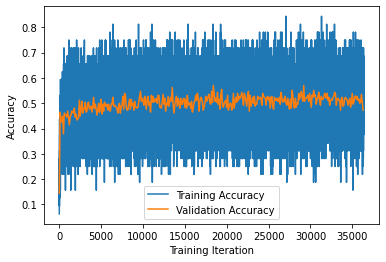

In [13]:
import matplotlib.pyplot as plt
plt.plot(range(len(training_accuracies_finetuning)), training_accuracies_finetuning, label = "Training Accuracy")
plt.plot(list(map(lambda x: x * 100, range(len(validation_accuracies_finetuning)))), validation_accuracies_finetuning, label = "Validation Accuracy")
plt.xlabel("Training Iteration")
plt.ylabel("Accuracy")
plt.legend()

In [14]:
import torch as th
import numpy as np

embedding_bert.to(device)

def get_embeds(x_data):
    concatted_shape = None
    pad_value = None
    embeds = []
    for text in tqdm(x_data):
        doc = nlp(text)
        embeddeds = []
        sents = [str(sent) for sent in doc.sents]
        if sentence_pairs and len(sents) > 1:
            sents = [a + b for a, b in zip(sents, sents[1:])]
        all_tokenized = []
        for sentence in sents[:num_sentences]:
            tokenized = tokenizer(sentence, truncation=True, padding="max_length", max_length=max_tokenized_length)[0]
            all_tokenized.append(tokenized.ids)
        
        with th.no_grad():
            sentence_tensor = th.tensor(all_tokenized).to(device)
            concatted = np.concatenate([
                # take output corresponding to CLS
                embedding_bert.bert(sentence_tensor, output_hidden_states=True, return_dict=True)[1].cpu().numpy(),
                np.zeros((len(all_tokenized), 1))
            ], axis=1)
            
            if not concatted_shape:
                concatted_shape = concatted.shape
                pad_value = np.zeros(concatted_shape[1])
                pad_value[-1] = 1
            
            embeddeds += list(concatted)

        if len(sents) < num_sentences:
            embeddeds += [pad_value] * (num_sentences - len(sents))

        embeds.append(embeddeds)
    return np.array(embeds)

main_data_key = f"cache-core/training-data-main-max-tokens-{max_tokenized_length}-split-{split_hash}-finetuned-{finetuning_model_hash}"
train_x_embeds, valid_x_embeds = memo_load(
    lambda: (
        get_embeds(train_x),
        get_embeds(valid_x)
    ),
    main_data_key
)
main_data_hash = hash_file(main_data_key + ".hkl")

  0%|          | 0/189419 [00:00<?, ?it/s]

  0%|          | 6/189419 [00:00<59:34, 52.99it/s]

  0%|          | 12/189419 [00:00<55:53, 56.48it/s]

  0%|          | 19/189419 [00:00<51:15, 61.58it/s]

  0%|          | 26/189419 [00:00<50:17, 62.77it/s]

  0%|          | 34/189419 [00:00<46:38, 67.68it/s]

  0%|          | 41/189419 [00:00<47:25, 66.55it/s]

  0%|          | 49/189419 [00:00<44:41, 70.63it/s]

  0%|          | 57/189419 [00:00<43:42, 72.22it/s]

  0%|          | 65/189419 [00:00<46:55, 67.26it/s]

  0%|          | 74/189419 [00:01<43:39, 72.27it/s]

  0%|          | 83/189419 [00:01<41:36, 75.85it/s]

  0%|          | 91/189419 [00:01<41:39, 75.76it/s]

  0%|          | 99/189419 [00:01<43:46, 72.09it/s]

  0%|          | 107/189419 [00:01<43:12, 73.03it/s]

  0%|          | 115/189419 [00:01<45:39, 69.09it/s]

  0%|          | 123/189419 [00:01<44:45, 70.49it/s]

  0%|          | 131/189419 [00:01<45:11, 69.80it/s]

  0%|          | 139/189419 [00:02<46:31, 67.82it/s]

  0%|          | 146/189419 [00:02<47:15, 66.75it/s]

  0%|          | 155/189419 [00:02<43:12, 72.99it/s]

  0%|          | 163/189419 [00:02<43:11, 73.02it/s]

  0%|          | 171/189419 [00:02<43:25, 72.64it/s]

  0%|          | 179/189419 [00:02<42:55, 73.49it/s]

  0%|          | 189/189419 [00:02<39:49, 79.18it/s]

  0%|          | 198/189419 [00:02<38:28, 81.96it/s]

  0%|          | 207/189419 [00:02<40:58, 76.96it/s]

  0%|          | 215/189419 [00:03<42:31, 74.14it/s]

  0%|          | 223/189419 [00:03<44:14, 71.27it/s]

  0%|          | 232/189419 [00:03<42:04, 74.94it/s]

  0%|          | 240/189419 [00:03<42:31, 74.14it/s]

  0%|          | 248/189419 [00:03<44:44, 70.47it/s]

  0%|          | 256/189419 [00:03<45:51, 68.75it/s]

  0%|          | 263/189419 [00:03<47:24, 66.50it/s]

  0%|          | 271/189419 [00:03<45:37, 69.08it/s]

  0%|          | 278/189419 [00:03<48:01, 65.64it/s]

  0%|          | 285/189419 [00:04<48:34, 64.90it/s]

  0%|          | 292/189419 [00:04<48:39, 64.77it/s]

  0%|          | 299/189419 [00:04<50:07, 62.89it/s]

  0%|          | 307/189419 [00:04<48:23, 65.13it/s]

  0%|          | 314/189419 [00:04<50:15, 62.71it/s]

  0%|          | 321/189419 [00:04<51:07, 61.65it/s]

  0%|          | 328/189419 [00:04<52:36, 59.90it/s]

  0%|          | 335/189419 [00:04<51:04, 61.70it/s]

  0%|          | 345/189419 [00:04<44:48, 70.32it/s]

  0%|          | 353/189419 [00:05<43:43, 72.06it/s]

  0%|          | 361/189419 [00:05<44:14, 71.22it/s]

  0%|          | 369/189419 [00:05<46:09, 68.27it/s]

  0%|          | 376/189419 [00:05<47:49, 65.88it/s]

  0%|          | 385/189419 [00:05<45:02, 69.96it/s]

  0%|          | 393/189419 [00:05<45:50, 68.72it/s]

  0%|          | 400/189419 [00:05<45:57, 68.54it/s]

  0%|          | 407/189419 [00:05<46:53, 67.18it/s]

  0%|          | 416/189419 [00:05<44:40, 70.52it/s]

  0%|          | 424/189419 [00:06<45:00, 69.98it/s]

  0%|          | 433/189419 [00:06<41:45, 75.43it/s]

  0%|          | 441/189419 [00:06<41:39, 75.60it/s]

  0%|          | 449/189419 [00:06<42:47, 73.61it/s]

  0%|          | 457/189419 [00:06<43:33, 72.29it/s]

  0%|          | 465/189419 [00:06<42:53, 73.43it/s]

  0%|          | 473/189419 [00:06<43:18, 72.71it/s]

  0%|          | 481/189419 [00:06<44:27, 70.83it/s]

  0%|          | 489/189419 [00:07<47:08, 66.80it/s]

  0%|          | 496/189419 [00:07<49:32, 63.56it/s]

  0%|          | 504/189419 [00:07<47:37, 66.12it/s]

  0%|          | 513/189419 [00:07<43:32, 72.32it/s]

  0%|          | 521/189419 [00:07<42:20, 74.36it/s]

  0%|          | 531/189419 [00:07<39:41, 79.31it/s]

  0%|          | 540/189419 [00:07<38:51, 81.02it/s]

  0%|          | 549/189419 [00:07<38:19, 82.14it/s]

  0%|          | 558/189419 [00:07<37:42, 83.47it/s]

  0%|          | 567/189419 [00:08<41:37, 75.63it/s]

  0%|          | 577/189419 [00:08<40:06, 78.48it/s]

  0%|          | 585/189419 [00:08<40:16, 78.15it/s]

  0%|          | 593/189419 [00:08<41:16, 76.24it/s]

  0%|          | 601/189419 [00:08<41:31, 75.77it/s]

  0%|          | 609/189419 [00:08<46:12, 68.11it/s]

  0%|          | 616/189419 [00:08<46:14, 68.05it/s]

  0%|          | 625/189419 [00:08<43:24, 72.48it/s]

  0%|          | 633/189419 [00:08<44:54, 70.06it/s]

  0%|          | 641/189419 [00:09<43:23, 72.50it/s]

  0%|          | 649/189419 [00:09<44:11, 71.20it/s]

  0%|          | 658/189419 [00:09<42:08, 74.64it/s]

  0%|          | 666/189419 [00:09<43:05, 73.01it/s]

  0%|          | 674/189419 [00:09<44:09, 71.25it/s]

  0%|          | 682/189419 [00:09<43:05, 72.99it/s]

  0%|          | 690/189419 [00:09<44:26, 70.79it/s]

  0%|          | 698/189419 [00:09<46:31, 67.60it/s]

  0%|          | 705/189419 [00:09<49:10, 63.95it/s]

  0%|          | 713/189419 [00:10<47:54, 65.64it/s]

  0%|          | 720/189419 [00:10<47:29, 66.22it/s]

  0%|          | 727/189419 [00:10<49:25, 63.63it/s]

  0%|          | 736/189419 [00:10<46:24, 67.77it/s]

  0%|          | 744/189419 [00:10<46:34, 67.52it/s]

  0%|          | 751/189419 [00:10<46:23, 67.78it/s]

  0%|          | 758/189419 [00:10<46:04, 68.24it/s]

  0%|          | 765/189419 [00:10<46:59, 66.92it/s]

  0%|          | 772/189419 [00:10<47:17, 66.47it/s]

  0%|          | 779/189419 [00:11<47:26, 66.28it/s]

  0%|          | 786/189419 [00:11<48:41, 64.56it/s]

  0%|          | 794/189419 [00:11<47:08, 66.68it/s]

  0%|          | 802/189419 [00:11<45:00, 69.85it/s]

  0%|          | 812/189419 [00:11<41:56, 74.94it/s]

  0%|          | 821/189419 [00:11<41:27, 75.81it/s]

  0%|          | 829/189419 [00:11<42:02, 74.75it/s]

  0%|          | 838/189419 [00:11<42:01, 74.78it/s]

  0%|          | 846/189419 [00:12<43:20, 72.52it/s]

  0%|          | 854/189419 [00:12<42:15, 74.37it/s]

  0%|          | 862/189419 [00:12<43:59, 71.43it/s]

  0%|          | 870/189419 [00:12<43:31, 72.21it/s]

  0%|          | 878/189419 [00:12<43:40, 71.95it/s]

  0%|          | 886/189419 [00:12<44:38, 70.40it/s]

  0%|          | 894/189419 [00:12<44:34, 70.49it/s]

  0%|          | 904/189419 [00:12<40:37, 77.34it/s]

  0%|          | 913/189419 [00:12<40:59, 76.64it/s]

  0%|          | 921/189419 [00:13<42:38, 73.67it/s]

  0%|          | 929/189419 [00:13<43:42, 71.88it/s]

  0%|          | 937/189419 [00:13<45:29, 69.06it/s]

  0%|          | 946/189419 [00:13<43:50, 71.65it/s]

  1%|          | 955/189419 [00:13<42:37, 73.69it/s]

  1%|          | 963/189419 [00:13<42:43, 73.51it/s]

  1%|          | 971/189419 [00:13<44:07, 71.17it/s]

  1%|          | 979/189419 [00:13<46:04, 68.16it/s]

  1%|          | 986/189419 [00:13<46:15, 67.88it/s]

  1%|          | 993/189419 [00:14<45:54, 68.41it/s]

  1%|          | 1001/189419 [00:14<45:42, 68.70it/s]

  1%|          | 1008/189419 [00:14<45:51, 68.48it/s]

  1%|          | 1015/189419 [00:14<46:25, 67.64it/s]

  1%|          | 1023/189419 [00:14<44:26, 70.65it/s]

  1%|          | 1031/189419 [00:14<45:17, 69.32it/s]

  1%|          | 1041/189419 [00:14<41:25, 75.80it/s]

  1%|          | 1049/189419 [00:14<41:23, 75.83it/s]

  1%|          | 1057/189419 [00:14<43:32, 72.09it/s]

  1%|          | 1065/189419 [00:15<43:15, 72.58it/s]

  1%|          | 1073/189419 [00:15<44:41, 70.24it/s]

  1%|          | 1081/189419 [00:15<44:47, 70.07it/s]

  1%|          | 1089/189419 [00:15<44:07, 71.15it/s]

  1%|          | 1097/189419 [00:15<44:55, 69.88it/s]

  1%|          | 1105/189419 [00:15<44:32, 70.47it/s]

  1%|          | 1113/189419 [00:15<45:21, 69.19it/s]

  1%|          | 1120/189419 [00:15<47:51, 65.58it/s]

  1%|          | 1127/189419 [00:15<47:38, 65.87it/s]

  1%|          | 1135/189419 [00:16<45:37, 68.78it/s]

  1%|          | 1142/189419 [00:16<46:23, 67.65it/s]

  1%|          | 1152/189419 [00:16<42:18, 74.16it/s]

  1%|          | 1160/189419 [00:16<41:51, 74.95it/s]

  1%|          | 1168/189419 [00:16<43:36, 71.96it/s]

  1%|          | 1177/189419 [00:16<41:27, 75.67it/s]

  1%|          | 1186/189419 [00:16<41:23, 75.79it/s]

  1%|          | 1194/189419 [00:16<42:22, 74.02it/s]

  1%|          | 1202/189419 [00:16<43:03, 72.86it/s]

  1%|          | 1210/189419 [00:17<42:48, 73.29it/s]

  1%|          | 1218/189419 [00:17<42:29, 73.82it/s]

  1%|          | 1226/189419 [00:17<42:37, 73.60it/s]

  1%|          | 1234/189419 [00:17<43:05, 72.78it/s]

  1%|          | 1242/189419 [00:17<43:55, 71.41it/s]

  1%|          | 1250/189419 [00:17<44:42, 70.15it/s]

  1%|          | 1258/189419 [00:17<46:14, 67.82it/s]

  1%|          | 1265/189419 [00:17<47:51, 65.52it/s]

  1%|          | 1272/189419 [00:18<48:30, 64.65it/s]

  1%|          | 1279/189419 [00:18<48:25, 64.76it/s]

  1%|          | 1287/189419 [00:18<45:32, 68.85it/s]

  1%|          | 1294/189419 [00:18<46:01, 68.11it/s]

  1%|          | 1302/189419 [00:18<44:40, 70.17it/s]

  1%|          | 1311/189419 [00:18<41:39, 75.26it/s]

  1%|          | 1319/189419 [00:18<42:41, 73.42it/s]

  1%|          | 1329/189419 [00:18<40:39, 77.11it/s]

  1%|          | 1338/189419 [00:18<39:32, 79.28it/s]

  1%|          | 1346/189419 [00:18<40:19, 77.72it/s]

  1%|          | 1354/189419 [00:19<41:36, 75.32it/s]

  1%|          | 1362/189419 [00:19<46:04, 68.02it/s]

  1%|          | 1370/189419 [00:19<45:24, 69.02it/s]

  1%|          | 1377/189419 [00:19<46:52, 66.85it/s]

  1%|          | 1385/189419 [00:19<45:23, 69.05it/s]

  1%|          | 1393/189419 [00:19<45:55, 68.23it/s]

  1%|          | 1400/189419 [00:19<47:59, 65.29it/s]

  1%|          | 1408/189419 [00:19<47:11, 66.40it/s]

  1%|          | 1415/189419 [00:20<47:04, 66.57it/s]

  1%|          | 1422/189419 [00:20<46:55, 66.77it/s]

  1%|          | 1429/189419 [00:20<46:22, 67.55it/s]

  1%|          | 1436/189419 [00:20<45:54, 68.25it/s]

  1%|          | 1444/189419 [00:20<44:40, 70.14it/s]

  1%|          | 1452/189419 [00:20<48:10, 65.03it/s]

  1%|          | 1459/189419 [00:20<47:31, 65.92it/s]

  1%|          | 1467/189419 [00:20<45:32, 68.79it/s]

  1%|          | 1474/189419 [00:20<46:12, 67.79it/s]

  1%|          | 1482/189419 [00:21<44:06, 71.02it/s]

  1%|          | 1490/189419 [00:21<44:36, 70.22it/s]

  1%|          | 1499/189419 [00:21<42:19, 73.99it/s]

  1%|          | 1508/189419 [00:21<41:45, 75.01it/s]

  1%|          | 1516/189419 [00:21<42:40, 73.39it/s]

  1%|          | 1524/189419 [00:21<44:06, 71.01it/s]

  1%|          | 1533/189419 [00:21<43:16, 72.37it/s]

  1%|          | 1541/189419 [00:21<42:09, 74.29it/s]

  1%|          | 1549/189419 [00:21<43:53, 71.35it/s]

  1%|          | 1557/189419 [00:22<44:37, 70.16it/s]

  1%|          | 1565/189419 [00:22<46:40, 67.08it/s]

  1%|          | 1573/189419 [00:22<45:55, 68.17it/s]

  1%|          | 1580/189419 [00:22<45:49, 68.31it/s]

  1%|          | 1587/189419 [00:22<46:26, 67.40it/s]

  1%|          | 1594/189419 [00:22<48:20, 64.75it/s]

  1%|          | 1603/189419 [00:22<43:45, 71.53it/s]

  1%|          | 1611/189419 [00:22<45:04, 69.45it/s]

  1%|          | 1619/189419 [00:22<43:27, 72.03it/s]

  1%|          | 1627/189419 [00:23<43:58, 71.17it/s]

  1%|          | 1635/189419 [00:23<44:50, 69.81it/s]

  1%|          | 1643/189419 [00:23<45:01, 69.51it/s]

  1%|          | 1651/189419 [00:23<45:18, 69.08it/s]

  1%|          | 1658/189419 [00:23<46:18, 67.58it/s]

  1%|          | 1666/189419 [00:23<45:20, 69.02it/s]

  1%|          | 1673/189419 [00:23<47:21, 66.07it/s]

  1%|          | 1680/189419 [00:23<48:47, 64.12it/s]

  1%|          | 1687/189419 [00:23<49:42, 62.95it/s]

  1%|          | 1694/189419 [00:24<50:14, 62.28it/s]

  1%|          | 1703/189419 [00:24<45:50, 68.24it/s]

  1%|          | 1711/189419 [00:24<44:21, 70.52it/s]

  1%|          | 1719/189419 [00:24<44:53, 69.70it/s]

  1%|          | 1728/189419 [00:24<41:44, 74.95it/s]

  1%|          | 1736/189419 [00:24<41:37, 75.14it/s]

  1%|          | 1744/189419 [00:24<41:22, 75.60it/s]

  1%|          | 1752/189419 [00:24<42:05, 74.32it/s]

  1%|          | 1760/189419 [00:24<42:18, 73.92it/s]

  1%|          | 1769/189419 [00:25<40:03, 78.08it/s]

  1%|          | 1777/189419 [00:25<40:01, 78.13it/s]

  1%|          | 1785/189419 [00:25<44:09, 70.82it/s]

  1%|          | 1794/189419 [00:25<41:38, 75.08it/s]

  1%|          | 1802/189419 [00:25<41:33, 75.26it/s]

  1%|          | 1810/189419 [00:25<43:54, 71.22it/s]

  1%|          | 1818/189419 [00:25<44:37, 70.06it/s]

  1%|          | 1826/189419 [00:25<43:48, 71.38it/s]

  1%|          | 1834/189419 [00:25<44:36, 70.09it/s]

  1%|          | 1842/189419 [00:26<43:52, 71.26it/s]

  1%|          | 1850/189419 [00:26<47:01, 66.49it/s]

  1%|          | 1857/189419 [00:26<51:03, 61.23it/s]

  1%|          | 1864/189419 [00:26<50:21, 62.08it/s]

  1%|          | 1871/189419 [00:26<49:27, 63.20it/s]

  1%|          | 1878/189419 [00:26<50:19, 62.12it/s]

  1%|          | 1885/189419 [00:26<50:02, 62.47it/s]

  1%|          | 1893/189419 [00:26<47:32, 65.73it/s]

  1%|          | 1900/189419 [00:27<46:54, 66.64it/s]

  1%|          | 1909/189419 [00:27<44:18, 70.54it/s]

  1%|          | 1917/189419 [00:27<43:49, 71.30it/s]

  1%|          | 1925/189419 [00:27<45:53, 68.10it/s]

  1%|          | 1932/189419 [00:27<46:31, 67.16it/s]

  1%|          | 1940/189419 [00:27<46:37, 67.02it/s]

  1%|          | 1949/189419 [00:27<44:23, 70.39it/s]

  1%|          | 1957/189419 [00:27<47:48, 65.34it/s]

  1%|          | 1965/189419 [00:27<45:38, 68.46it/s]

  1%|          | 1972/189419 [00:28<45:52, 68.10it/s]

  1%|          | 1979/189419 [00:28<47:10, 66.22it/s]

  1%|          | 1989/189419 [00:28<43:41, 71.49it/s]

  1%|          | 1997/189419 [00:28<45:28, 68.69it/s]

  1%|          | 2005/189419 [00:28<44:31, 70.15it/s]

  1%|          | 2013/189419 [00:28<44:02, 70.91it/s]

  1%|          | 2021/189419 [00:28<43:18, 72.13it/s]

  1%|          | 2029/189419 [00:28<43:24, 71.94it/s]

  1%|          | 2038/189419 [00:28<41:13, 75.76it/s]

  1%|          | 2046/189419 [00:29<42:54, 72.79it/s]

  1%|          | 2054/189419 [00:29<43:52, 71.17it/s]

  1%|          | 2063/189419 [00:29<41:07, 75.94it/s]

  1%|          | 2071/189419 [00:29<40:35, 76.91it/s]

  1%|          | 2079/189419 [00:29<42:58, 72.66it/s]

  1%|          | 2087/189419 [00:29<43:58, 70.99it/s]

  1%|          | 2095/189419 [00:29<48:02, 64.98it/s]

  1%|          | 2104/189419 [00:29<45:25, 68.73it/s]

  1%|          | 2111/189419 [00:30<46:00, 67.86it/s]

  1%|          | 2118/189419 [00:30<45:43, 68.28it/s]

  1%|          | 2127/189419 [00:30<44:00, 70.92it/s]

  1%|          | 2135/189419 [00:30<44:55, 69.48it/s]

  1%|          | 2143/189419 [00:30<43:40, 71.47it/s]

  1%|          | 2151/189419 [00:30<43:27, 71.82it/s]

  1%|          | 2160/189419 [00:30<42:02, 74.23it/s]

  1%|          | 2168/189419 [00:30<41:41, 74.84it/s]

  1%|          | 2176/189419 [00:30<43:30, 71.74it/s]

  1%|          | 2184/189419 [00:31<42:58, 72.63it/s]

  1%|          | 2192/189419 [00:31<42:10, 73.98it/s]

  1%|          | 2200/189419 [00:31<43:49, 71.19it/s]

  1%|          | 2208/189419 [00:31<42:47, 72.91it/s]

  1%|          | 2217/189419 [00:31<40:36, 76.82it/s]

  1%|          | 2225/189419 [00:31<42:30, 73.41it/s]

  1%|          | 2233/189419 [00:31<42:19, 73.72it/s]

  1%|          | 2241/189419 [00:31<43:54, 71.06it/s]

  1%|          | 2251/189419 [00:31<40:06, 77.78it/s]

  1%|          | 2259/189419 [00:32<40:50, 76.39it/s]

  1%|          | 2267/189419 [00:32<44:32, 70.02it/s]

  1%|          | 2275/189419 [00:32<44:26, 70.20it/s]

  1%|          | 2283/189419 [00:32<45:50, 68.03it/s]

  1%|          | 2291/189419 [00:32<44:25, 70.21it/s]

  1%|          | 2299/189419 [00:32<44:35, 69.95it/s]

  1%|          | 2307/189419 [00:32<44:54, 69.45it/s]

  1%|          | 2315/189419 [00:32<44:27, 70.15it/s]

  1%|          | 2323/189419 [00:32<43:27, 71.75it/s]

  1%|          | 2331/189419 [00:33<44:37, 69.87it/s]

  1%|          | 2339/189419 [00:33<45:18, 68.82it/s]

  1%|          | 2348/189419 [00:33<41:59, 74.25it/s]

  1%|          | 2356/189419 [00:33<43:20, 71.93it/s]

  1%|          | 2364/189419 [00:33<44:49, 69.56it/s]

  1%|▏         | 2372/189419 [00:33<47:20, 65.86it/s]

  1%|▏         | 2380/189419 [00:33<44:55, 69.38it/s]

  1%|▏         | 2388/189419 [00:33<45:39, 68.28it/s]

  1%|▏         | 2395/189419 [00:34<47:09, 66.09it/s]

  1%|▏         | 2403/189419 [00:34<45:21, 68.71it/s]

  1%|▏         | 2410/189419 [00:34<47:11, 66.04it/s]

  1%|▏         | 2418/189419 [00:34<45:06, 69.10it/s]

  1%|▏         | 2425/189419 [00:34<45:32, 68.44it/s]

  1%|▏         | 2432/189419 [00:34<47:15, 65.95it/s]

  1%|▏         | 2439/189419 [00:34<46:36, 66.86it/s]

  1%|▏         | 2447/189419 [00:34<44:19, 70.31it/s]

  1%|▏         | 2455/189419 [00:34<46:30, 66.99it/s]

  1%|▏         | 2462/189419 [00:35<47:51, 65.10it/s]

  1%|▏         | 2470/189419 [00:35<47:31, 65.56it/s]

  1%|▏         | 2477/189419 [00:35<50:13, 62.03it/s]

  1%|▏         | 2484/189419 [00:35<50:42, 61.44it/s]

  1%|▏         | 2491/189419 [00:35<49:21, 63.13it/s]

  1%|▏         | 2499/189419 [00:35<46:15, 67.35it/s]

  1%|▏         | 2507/189419 [00:35<45:33, 68.37it/s]

  1%|▏         | 2515/189419 [00:35<45:21, 68.67it/s]

  1%|▏         | 2523/189419 [00:35<45:02, 69.14it/s]

  1%|▏         | 2531/189419 [00:36<43:27, 71.66it/s]

  1%|▏         | 2539/189419 [00:36<45:49, 67.96it/s]

  1%|▏         | 2547/189419 [00:36<44:01, 70.74it/s]

  1%|▏         | 2555/189419 [00:36<45:13, 68.87it/s]

  1%|▏         | 2562/189419 [00:36<48:53, 63.70it/s]

  1%|▏         | 2569/189419 [00:36<48:25, 64.30it/s]

  1%|▏         | 2577/189419 [00:36<46:22, 67.15it/s]

  1%|▏         | 2584/189419 [00:36<48:00, 64.87it/s]

  1%|▏         | 2591/189419 [00:36<47:55, 64.97it/s]

  1%|▏         | 2598/189419 [00:37<47:55, 64.98it/s]

  1%|▏         | 2606/189419 [00:37<45:19, 68.68it/s]

  1%|▏         | 2614/189419 [00:37<43:57, 70.82it/s]

  1%|▏         | 2622/189419 [00:37<42:28, 73.29it/s]

  1%|▏         | 2630/189419 [00:37<43:52, 70.95it/s]

  1%|▏         | 2639/189419 [00:37<41:27, 75.08it/s]

  1%|▏         | 2647/189419 [00:37<40:48, 76.29it/s]

  1%|▏         | 2655/189419 [00:37<41:48, 74.45it/s]

  1%|▏         | 2663/189419 [00:37<42:03, 74.00it/s]

  1%|▏         | 2671/189419 [00:38<43:00, 72.36it/s]

  1%|▏         | 2679/189419 [00:38<46:19, 67.19it/s]

  1%|▏         | 2686/189419 [00:38<50:01, 62.21it/s]

  1%|▏         | 2694/189419 [00:38<47:42, 65.23it/s]

  1%|▏         | 2701/189419 [00:38<49:45, 62.54it/s]

  1%|▏         | 2711/189419 [00:38<45:03, 69.07it/s]

  1%|▏         | 2718/189419 [00:38<45:10, 68.88it/s]

  1%|▏         | 2725/189419 [00:38<45:00, 69.13it/s]

  1%|▏         | 2733/189419 [00:38<43:36, 71.36it/s]

  1%|▏         | 2741/189419 [00:39<42:27, 73.28it/s]

  1%|▏         | 2749/189419 [00:39<44:39, 69.65it/s]

  1%|▏         | 2757/189419 [00:39<43:07, 72.13it/s]

  1%|▏         | 2766/189419 [00:39<40:29, 76.82it/s]

  1%|▏         | 2775/189419 [00:39<38:36, 80.57it/s]

  1%|▏         | 2784/189419 [00:39<42:21, 73.42it/s]

  1%|▏         | 2792/189419 [00:39<41:40, 74.64it/s]

  1%|▏         | 2802/189419 [00:39<38:11, 81.42it/s]

  1%|▏         | 2811/189419 [00:40<42:12, 73.69it/s]

  1%|▏         | 2820/189419 [00:40<41:57, 74.11it/s]

  1%|▏         | 2829/189419 [00:40<40:36, 76.58it/s]

  1%|▏         | 2837/189419 [00:40<42:57, 72.39it/s]

  2%|▏         | 2845/189419 [00:40<44:55, 69.22it/s]

  2%|▏         | 2853/189419 [00:40<45:10, 68.84it/s]

  2%|▏         | 2861/189419 [00:40<43:40, 71.20it/s]

  2%|▏         | 2869/189419 [00:40<42:48, 72.62it/s]

  2%|▏         | 2877/189419 [00:40<42:53, 72.48it/s]

  2%|▏         | 2885/189419 [00:41<46:49, 66.41it/s]

  2%|▏         | 2892/189419 [00:41<47:33, 65.36it/s]

  2%|▏         | 2899/189419 [00:41<50:10, 61.96it/s]

  2%|▏         | 2906/189419 [00:41<49:16, 63.08it/s]

  2%|▏         | 2914/189419 [00:41<46:21, 67.06it/s]

  2%|▏         | 2922/189419 [00:41<44:24, 70.00it/s]

  2%|▏         | 2930/189419 [00:41<44:35, 69.70it/s]

  2%|▏         | 2938/189419 [00:41<44:12, 70.30it/s]

  2%|▏         | 2946/189419 [00:41<44:30, 69.82it/s]

  2%|▏         | 2955/189419 [00:42<42:23, 73.30it/s]

  2%|▏         | 2963/189419 [00:42<43:29, 71.46it/s]

  2%|▏         | 2971/189419 [00:42<42:35, 72.95it/s]

  2%|▏         | 2979/189419 [00:42<45:24, 68.43it/s]

  2%|▏         | 2986/189419 [00:42<45:36, 68.14it/s]

  2%|▏         | 2993/189419 [00:42<46:31, 66.79it/s]

  2%|▏         | 3002/189419 [00:42<44:00, 70.59it/s]

  2%|▏         | 3011/189419 [00:42<41:58, 74.01it/s]

  2%|▏         | 3021/189419 [00:42<39:22, 78.91it/s]

  2%|▏         | 3029/189419 [00:43<41:36, 74.65it/s]

  2%|▏         | 3037/189419 [00:43<42:03, 73.85it/s]

  2%|▏         | 3045/189419 [00:43<42:54, 72.38it/s]

  2%|▏         | 3053/189419 [00:43<43:30, 71.39it/s]

  2%|▏         | 3061/189419 [00:43<44:47, 69.35it/s]

  2%|▏         | 3068/189419 [00:43<45:43, 67.93it/s]

  2%|▏         | 3077/189419 [00:43<42:31, 73.03it/s]

  2%|▏         | 3085/189419 [00:43<45:07, 68.83it/s]

  2%|▏         | 3092/189419 [00:44<46:27, 66.84it/s]

  2%|▏         | 3099/189419 [00:44<46:49, 66.33it/s]

  2%|▏         | 3107/189419 [00:44<44:20, 70.04it/s]

  2%|▏         | 3116/189419 [00:44<42:37, 72.86it/s]

  2%|▏         | 3124/189419 [00:44<44:01, 70.54it/s]

  2%|▏         | 3132/189419 [00:44<43:27, 71.43it/s]

  2%|▏         | 3140/189419 [00:44<43:13, 71.84it/s]

  2%|▏         | 3148/189419 [00:44<44:16, 70.13it/s]

  2%|▏         | 3157/189419 [00:44<41:41, 74.45it/s]

  2%|▏         | 3165/189419 [00:45<41:22, 75.04it/s]

  2%|▏         | 3173/189419 [00:45<41:41, 74.44it/s]

  2%|▏         | 3182/189419 [00:45<40:58, 75.77it/s]

  2%|▏         | 3190/189419 [00:45<41:46, 74.30it/s]

  2%|▏         | 3198/189419 [00:45<41:38, 74.55it/s]

  2%|▏         | 3206/189419 [00:45<41:28, 74.82it/s]

  2%|▏         | 3214/189419 [00:45<41:22, 75.00it/s]

  2%|▏         | 3222/189419 [00:45<43:48, 70.84it/s]

  2%|▏         | 3230/189419 [00:45<44:23, 69.89it/s]

  2%|▏         | 3238/189419 [00:46<45:32, 68.13it/s]

  2%|▏         | 3245/189419 [00:46<45:27, 68.26it/s]

  2%|▏         | 3252/189419 [00:46<47:10, 65.77it/s]

  2%|▏         | 3260/189419 [00:46<46:38, 66.52it/s]

  2%|▏         | 3269/189419 [00:46<44:33, 69.62it/s]

  2%|▏         | 3276/189419 [00:46<46:02, 67.39it/s]

  2%|▏         | 3286/189419 [00:46<41:53, 74.06it/s]

  2%|▏         | 3294/189419 [00:46<43:45, 70.90it/s]

  2%|▏         | 3302/189419 [00:46<43:47, 70.82it/s]

  2%|▏         | 3310/189419 [00:47<42:47, 72.50it/s]

  2%|▏         | 3318/189419 [00:47<42:45, 72.53it/s]

  2%|▏         | 3326/189419 [00:47<43:53, 70.67it/s]

  2%|▏         | 3334/189419 [00:47<45:45, 67.78it/s]

  2%|▏         | 3343/189419 [00:47<43:10, 71.83it/s]

  2%|▏         | 3351/189419 [00:47<43:14, 71.72it/s]

  2%|▏         | 3359/189419 [00:47<44:14, 70.10it/s]

  2%|▏         | 3367/189419 [00:47<45:12, 68.58it/s]

  2%|▏         | 3375/189419 [00:48<44:32, 69.60it/s]

  2%|▏         | 3382/189419 [00:48<47:15, 65.61it/s]

  2%|▏         | 3390/189419 [00:48<45:27, 68.20it/s]

  2%|▏         | 3397/189419 [00:48<46:13, 67.07it/s]

  2%|▏         | 3405/189419 [00:48<44:43, 69.31it/s]

  2%|▏         | 3412/189419 [00:48<46:36, 66.52it/s]

  2%|▏         | 3420/189419 [00:48<44:41, 69.36it/s]

  2%|▏         | 3427/189419 [00:48<45:44, 67.78it/s]

  2%|▏         | 3434/189419 [00:48<45:28, 68.17it/s]

  2%|▏         | 3441/189419 [00:48<46:15, 67.01it/s]

  2%|▏         | 3448/189419 [00:49<47:03, 65.87it/s]

  2%|▏         | 3455/189419 [00:49<47:18, 65.52it/s]

  2%|▏         | 3462/189419 [00:49<48:38, 63.71it/s]

  2%|▏         | 3470/189419 [00:49<47:19, 65.48it/s]

  2%|▏         | 3478/189419 [00:49<46:27, 66.70it/s]

  2%|▏         | 3485/189419 [00:49<47:26, 65.32it/s]

  2%|▏         | 3492/189419 [00:49<46:55, 66.03it/s]

  2%|▏         | 3500/189419 [00:49<44:18, 69.94it/s]

  2%|▏         | 3508/189419 [00:50<47:04, 65.81it/s]

  2%|▏         | 3516/189419 [00:50<45:10, 68.58it/s]

  2%|▏         | 3523/189419 [00:50<45:43, 67.77it/s]

  2%|▏         | 3532/189419 [00:50<42:15, 73.31it/s]

  2%|▏         | 3540/189419 [00:50<43:42, 70.87it/s]

  2%|▏         | 3548/189419 [00:50<44:02, 70.35it/s]

  2%|▏         | 3556/189419 [00:50<45:02, 68.78it/s]

  2%|▏         | 3563/189419 [00:50<47:48, 64.78it/s]

  2%|▏         | 3570/189419 [00:50<48:25, 63.97it/s]

  2%|▏         | 3577/189419 [00:51<48:49, 63.43it/s]

  2%|▏         | 3585/189419 [00:51<46:08, 67.12it/s]

  2%|▏         | 3592/189419 [00:51<47:00, 65.89it/s]

  2%|▏         | 3601/189419 [00:51<45:03, 68.73it/s]

  2%|▏         | 3608/189419 [00:51<45:02, 68.76it/s]

  2%|▏         | 3617/189419 [00:51<42:28, 72.92it/s]

  2%|▏         | 3625/189419 [00:51<43:28, 71.24it/s]

  2%|▏         | 3633/189419 [00:51<44:22, 69.78it/s]

  2%|▏         | 3640/189419 [00:51<47:23, 65.35it/s]

  2%|▏         | 3648/189419 [00:52<45:13, 68.46it/s]

  2%|▏         | 3656/189419 [00:52<44:26, 69.67it/s]

  2%|▏         | 3664/189419 [00:52<46:28, 66.62it/s]

  2%|▏         | 3671/189419 [00:52<46:19, 66.83it/s]

  2%|▏         | 3678/189419 [00:52<46:54, 66.00it/s]

  2%|▏         | 3685/189419 [00:52<48:00, 64.48it/s]

  2%|▏         | 3692/189419 [00:52<47:25, 65.28it/s]

  2%|▏         | 3699/189419 [00:52<47:40, 64.93it/s]

  2%|▏         | 3706/189419 [00:52<48:05, 64.36it/s]

  2%|▏         | 3714/189419 [00:53<46:38, 66.37it/s]

  2%|▏         | 3721/189419 [00:53<46:44, 66.22it/s]

  2%|▏         | 3729/189419 [00:53<45:12, 68.45it/s]

  2%|▏         | 3737/189419 [00:53<43:54, 70.49it/s]

  2%|▏         | 3745/189419 [00:53<43:51, 70.57it/s]

  2%|▏         | 3753/189419 [00:53<46:05, 67.14it/s]

  2%|▏         | 3760/189419 [00:53<46:49, 66.08it/s]

  2%|▏         | 3767/189419 [00:53<49:22, 62.67it/s]

  2%|▏         | 3775/189419 [00:53<46:52, 66.01it/s]

  2%|▏         | 3783/189419 [00:54<45:21, 68.20it/s]

  2%|▏         | 3790/189419 [00:54<45:50, 67.50it/s]

  2%|▏         | 3797/189419 [00:54<45:29, 68.01it/s]

  2%|▏         | 3804/189419 [00:54<45:44, 67.64it/s]

  2%|▏         | 3811/189419 [00:54<47:31, 65.09it/s]

  2%|▏         | 3820/189419 [00:54<45:20, 68.22it/s]

  2%|▏         | 3827/189419 [00:54<46:16, 66.84it/s]

  2%|▏         | 3836/189419 [00:54<44:31, 69.46it/s]

  2%|▏         | 3845/189419 [00:54<42:27, 72.84it/s]

  2%|▏         | 3853/189419 [00:55<43:24, 71.25it/s]

  2%|▏         | 3862/189419 [00:55<41:37, 74.29it/s]

  2%|▏         | 3870/189419 [00:55<44:22, 69.68it/s]

  2%|▏         | 3879/189419 [00:55<42:25, 72.90it/s]

  2%|▏         | 3887/189419 [00:55<43:43, 70.71it/s]

  2%|▏         | 3895/189419 [00:55<45:37, 67.76it/s]

  2%|▏         | 3902/189419 [00:55<46:11, 66.94it/s]

  2%|▏         | 3909/189419 [00:55<46:33, 66.40it/s]

  2%|▏         | 3917/189419 [00:56<45:56, 67.29it/s]

  2%|▏         | 3925/189419 [00:56<43:52, 70.46it/s]

  2%|▏         | 3934/189419 [00:56<41:33, 74.40it/s]

  2%|▏         | 3943/189419 [00:56<40:20, 76.63it/s]

  2%|▏         | 3951/189419 [00:56<40:05, 77.10it/s]

  2%|▏         | 3959/189419 [00:56<43:25, 71.19it/s]

  2%|▏         | 3967/189419 [00:56<43:52, 70.44it/s]

  2%|▏         | 3975/189419 [00:56<45:17, 68.24it/s]

  2%|▏         | 3982/189419 [00:56<47:18, 65.33it/s]

  2%|▏         | 3991/189419 [00:57<43:52, 70.45it/s]

  2%|▏         | 3999/189419 [00:57<43:00, 71.85it/s]

  2%|▏         | 4007/189419 [00:57<41:50, 73.86it/s]

  2%|▏         | 4015/189419 [00:57<44:18, 69.75it/s]

  2%|▏         | 4023/189419 [00:57<45:22, 68.09it/s]

  2%|▏         | 4030/189419 [00:57<46:11, 66.90it/s]

  2%|▏         | 4037/189419 [00:57<47:41, 64.79it/s]

  2%|▏         | 4044/189419 [00:57<46:57, 65.79it/s]

  2%|▏         | 4051/189419 [00:57<46:40, 66.19it/s]

  2%|▏         | 4058/189419 [00:58<46:35, 66.31it/s]

  2%|▏         | 4065/189419 [00:58<46:59, 65.74it/s]

  2%|▏         | 4072/189419 [00:58<49:12, 62.77it/s]

  2%|▏         | 4080/189419 [00:58<46:51, 65.92it/s]

  2%|▏         | 4087/189419 [00:58<49:55, 61.87it/s]

  2%|▏         | 4095/189419 [00:58<47:38, 64.84it/s]

  2%|▏         | 4102/189419 [00:58<47:46, 64.66it/s]

  2%|▏         | 4110/189419 [00:58<46:33, 66.33it/s]

  2%|▏         | 4118/189419 [00:58<46:14, 66.79it/s]

  2%|▏         | 4127/189419 [00:59<42:34, 72.52it/s]

  2%|▏         | 4135/189419 [00:59<45:11, 68.33it/s]

  2%|▏         | 4143/189419 [00:59<45:00, 68.60it/s]

  2%|▏         | 4150/189419 [00:59<46:19, 66.66it/s]

  2%|▏         | 4158/189419 [00:59<44:28, 69.42it/s]

  2%|▏         | 4165/189419 [00:59<45:28, 67.89it/s]

  2%|▏         | 4172/189419 [00:59<46:09, 66.88it/s]

  2%|▏         | 4179/189419 [00:59<47:58, 64.36it/s]

  2%|▏         | 4187/189419 [00:59<46:29, 66.40it/s]

  2%|▏         | 4195/189419 [01:00<45:39, 67.60it/s]

  2%|▏         | 4202/189419 [01:00<46:26, 66.46it/s]

  2%|▏         | 4210/189419 [01:00<45:41, 67.56it/s]

  2%|▏         | 4219/189419 [01:00<43:42, 70.62it/s]

  2%|▏         | 4227/189419 [01:00<44:32, 69.30it/s]

  2%|▏         | 4236/189419 [01:00<43:10, 71.48it/s]

  2%|▏         | 4245/189419 [01:00<40:59, 75.28it/s]

  2%|▏         | 4254/189419 [01:00<39:21, 78.41it/s]

  2%|▏         | 4262/189419 [01:00<39:38, 77.85it/s]

  2%|▏         | 4270/189419 [01:01<40:55, 75.41it/s]

  2%|▏         | 4278/189419 [01:01<42:39, 72.33it/s]

  2%|▏         | 4286/189419 [01:01<42:33, 72.49it/s]

  2%|▏         | 4294/189419 [01:01<41:54, 73.61it/s]

  2%|▏         | 4302/189419 [01:01<42:41, 72.28it/s]

  2%|▏         | 4310/189419 [01:01<43:02, 71.67it/s]

  2%|▏         | 4318/189419 [01:01<42:34, 72.46it/s]

  2%|▏         | 4326/189419 [01:01<44:07, 69.92it/s]

  2%|▏         | 4334/189419 [01:02<44:26, 69.42it/s]

  2%|▏         | 4342/189419 [01:02<42:58, 71.79it/s]

  2%|▏         | 4350/189419 [01:02<44:02, 70.03it/s]

  2%|▏         | 4358/189419 [01:02<44:58, 68.57it/s]

  2%|▏         | 4367/189419 [01:02<42:00, 73.41it/s]

  2%|▏         | 4375/189419 [01:02<43:00, 71.71it/s]

  2%|▏         | 4383/189419 [01:02<41:56, 73.52it/s]

  2%|▏         | 4391/189419 [01:02<41:38, 74.05it/s]

  2%|▏         | 4399/189419 [01:02<42:08, 73.17it/s]

  2%|▏         | 4407/189419 [01:03<42:45, 72.12it/s]

  2%|▏         | 4416/189419 [01:03<40:40, 75.80it/s]

  2%|▏         | 4424/189419 [01:03<41:31, 74.24it/s]

  2%|▏         | 4432/189419 [01:03<42:39, 72.28it/s]

  2%|▏         | 4441/189419 [01:03<41:32, 74.22it/s]

  2%|▏         | 4449/189419 [01:03<42:43, 72.16it/s]

  2%|▏         | 4457/189419 [01:03<43:15, 71.25it/s]

  2%|▏         | 4465/189419 [01:03<43:11, 71.36it/s]

  2%|▏         | 4473/189419 [01:03<42:36, 72.35it/s]

  2%|▏         | 4481/189419 [01:04<42:17, 72.87it/s]

  2%|▏         | 4489/189419 [01:04<42:43, 72.15it/s]

  2%|▏         | 4497/189419 [01:04<44:32, 69.20it/s]

  2%|▏         | 4505/189419 [01:04<44:17, 69.58it/s]

  2%|▏         | 4514/189419 [01:04<42:58, 71.70it/s]

  2%|▏         | 4522/189419 [01:04<42:50, 71.92it/s]

  2%|▏         | 4530/189419 [01:04<43:14, 71.26it/s]

  2%|▏         | 4541/189419 [01:04<39:43, 77.57it/s]

  2%|▏         | 4550/189419 [01:04<38:05, 80.90it/s]

  2%|▏         | 4559/189419 [01:05<37:36, 81.94it/s]

  2%|▏         | 4568/189419 [01:05<38:50, 79.33it/s]

  2%|▏         | 4576/189419 [01:05<39:02, 78.90it/s]

  2%|▏         | 4584/189419 [01:05<39:34, 77.85it/s]

  2%|▏         | 4592/189419 [01:05<42:14, 72.91it/s]

  2%|▏         | 4600/189419 [01:05<41:41, 73.88it/s]

  2%|▏         | 4608/189419 [01:05<44:19, 69.50it/s]

  2%|▏         | 4616/189419 [01:05<45:51, 67.17it/s]

  2%|▏         | 4623/189419 [01:05<45:37, 67.50it/s]

  2%|▏         | 4630/189419 [01:06<45:51, 67.15it/s]

  2%|▏         | 4637/189419 [01:06<48:26, 63.59it/s]

  2%|▏         | 4644/189419 [01:06<47:13, 65.21it/s]

  2%|▏         | 4651/189419 [01:06<46:33, 66.15it/s]

  2%|▏         | 4658/189419 [01:06<47:08, 65.31it/s]

  2%|▏         | 4665/189419 [01:06<46:22, 66.41it/s]

  2%|▏         | 4672/189419 [01:06<46:25, 66.33it/s]

  2%|▏         | 4679/189419 [01:06<47:38, 64.63it/s]

  2%|▏         | 4688/189419 [01:06<43:14, 71.20it/s]

  2%|▏         | 4696/189419 [01:07<42:02, 73.24it/s]

  2%|▏         | 4704/189419 [01:07<47:08, 65.30it/s]

  2%|▏         | 4713/189419 [01:07<43:04, 71.46it/s]

  2%|▏         | 4721/189419 [01:07<45:35, 67.53it/s]

  2%|▏         | 4729/189419 [01:07<44:17, 69.51it/s]

  3%|▎         | 4739/189419 [01:07<41:09, 74.80it/s]

  3%|▎         | 4747/189419 [01:07<41:09, 74.77it/s]

  3%|▎         | 4755/189419 [01:07<44:05, 69.79it/s]

  3%|▎         | 4763/189419 [01:08<42:33, 72.31it/s]

  3%|▎         | 4771/189419 [01:08<42:32, 72.34it/s]

  3%|▎         | 4779/189419 [01:08<42:06, 73.09it/s]

  3%|▎         | 4787/189419 [01:08<41:53, 73.46it/s]

  3%|▎         | 4796/189419 [01:08<40:03, 76.83it/s]

  3%|▎         | 4804/189419 [01:08<41:23, 74.34it/s]

  3%|▎         | 4812/189419 [01:08<43:15, 71.11it/s]

  3%|▎         | 4820/189419 [01:08<42:25, 72.51it/s]

  3%|▎         | 4828/189419 [01:08<42:01, 73.21it/s]

  3%|▎         | 4836/189419 [01:08<41:52, 73.47it/s]

  3%|▎         | 4845/189419 [01:09<40:28, 76.01it/s]

  3%|▎         | 4853/189419 [01:09<42:14, 72.82it/s]

  3%|▎         | 4861/189419 [01:09<41:57, 73.30it/s]

  3%|▎         | 4869/189419 [01:09<42:09, 72.95it/s]

  3%|▎         | 4878/189419 [01:09<40:17, 76.33it/s]

  3%|▎         | 4887/189419 [01:09<39:17, 78.26it/s]

  3%|▎         | 4895/189419 [01:09<41:59, 73.24it/s]

  3%|▎         | 4903/189419 [01:09<42:06, 73.04it/s]

  3%|▎         | 4911/189419 [01:10<43:14, 71.12it/s]

  3%|▎         | 4919/189419 [01:10<44:17, 69.43it/s]

  3%|▎         | 4926/189419 [01:10<44:59, 68.36it/s]

  3%|▎         | 4935/189419 [01:10<42:31, 72.30it/s]

  3%|▎         | 4943/189419 [01:10<42:25, 72.48it/s]

  3%|▎         | 4951/189419 [01:10<42:27, 72.42it/s]

  3%|▎         | 4960/189419 [01:10<41:48, 73.53it/s]

  3%|▎         | 4968/189419 [01:10<41:32, 74.00it/s]

  3%|▎         | 4976/189419 [01:10<40:51, 75.25it/s]

  3%|▎         | 4985/189419 [01:11<39:53, 77.07it/s]

  3%|▎         | 4994/189419 [01:11<38:12, 80.44it/s]

  3%|▎         | 5003/189419 [01:11<41:57, 73.27it/s]

  3%|▎         | 5013/189419 [01:11<40:09, 76.53it/s]

  3%|▎         | 5021/189419 [01:11<40:23, 76.09it/s]

  3%|▎         | 5029/189419 [01:11<40:14, 76.37it/s]

  3%|▎         | 5037/189419 [01:11<40:50, 75.24it/s]

  3%|▎         | 5046/189419 [01:11<39:49, 77.15it/s]

  3%|▎         | 5054/189419 [01:11<40:32, 75.79it/s]

  3%|▎         | 5062/189419 [01:12<41:26, 74.13it/s]

  3%|▎         | 5070/189419 [01:12<42:19, 72.59it/s]

  3%|▎         | 5078/189419 [01:12<44:09, 69.57it/s]

  3%|▎         | 5085/189419 [01:12<45:04, 68.15it/s]

  3%|▎         | 5094/189419 [01:12<43:34, 70.50it/s]

  3%|▎         | 5102/189419 [01:12<43:06, 71.27it/s]

  3%|▎         | 5110/189419 [01:12<43:21, 70.85it/s]

  3%|▎         | 5118/189419 [01:12<43:00, 71.43it/s]

  3%|▎         | 5126/189419 [01:12<43:52, 70.01it/s]

  3%|▎         | 5134/189419 [01:13<42:55, 71.54it/s]

  3%|▎         | 5142/189419 [01:13<44:15, 69.40it/s]

  3%|▎         | 5149/189419 [01:13<45:42, 67.19it/s]

  3%|▎         | 5157/189419 [01:13<45:04, 68.13it/s]

  3%|▎         | 5165/189419 [01:13<43:04, 71.30it/s]

  3%|▎         | 5173/189419 [01:13<45:23, 67.65it/s]

  3%|▎         | 5182/189419 [01:13<42:27, 72.32it/s]

  3%|▎         | 5192/189419 [01:13<39:51, 77.02it/s]

  3%|▎         | 5200/189419 [01:13<42:28, 72.30it/s]

  3%|▎         | 5208/189419 [01:14<42:46, 71.77it/s]

  3%|▎         | 5216/189419 [01:14<44:51, 68.44it/s]

  3%|▎         | 5223/189419 [01:14<45:51, 66.94it/s]

  3%|▎         | 5231/189419 [01:14<44:26, 69.07it/s]

  3%|▎         | 5238/189419 [01:14<46:09, 66.50it/s]

  3%|▎         | 5245/189419 [01:14<46:45, 65.65it/s]

  3%|▎         | 5252/189419 [01:14<46:43, 65.70it/s]

  3%|▎         | 5260/189419 [01:14<44:10, 69.47it/s]

  3%|▎         | 5269/189419 [01:14<41:20, 74.25it/s]

  3%|▎         | 5277/189419 [01:15<40:57, 74.94it/s]

  3%|▎         | 5286/189419 [01:15<40:26, 75.88it/s]

  3%|▎         | 5294/189419 [01:15<42:03, 72.98it/s]

  3%|▎         | 5302/189419 [01:15<42:55, 71.48it/s]

  3%|▎         | 5310/189419 [01:15<42:48, 71.69it/s]

  3%|▎         | 5318/189419 [01:15<44:05, 69.60it/s]

  3%|▎         | 5326/189419 [01:15<43:45, 70.11it/s]

  3%|▎         | 5334/189419 [01:15<42:18, 72.50it/s]

  3%|▎         | 5342/189419 [01:16<44:29, 68.97it/s]

  3%|▎         | 5349/189419 [01:16<44:46, 68.52it/s]

  3%|▎         | 5356/189419 [01:16<44:41, 68.64it/s]

  3%|▎         | 5363/189419 [01:16<44:33, 68.84it/s]

  3%|▎         | 5371/189419 [01:16<43:05, 71.18it/s]

  3%|▎         | 5379/189419 [01:16<42:30, 72.17it/s]

  3%|▎         | 5387/189419 [01:16<42:24, 72.32it/s]

  3%|▎         | 5396/189419 [01:16<41:52, 73.25it/s]

  3%|▎         | 5404/189419 [01:16<43:22, 70.71it/s]

  3%|▎         | 5413/189419 [01:17<41:37, 73.67it/s]

  3%|▎         | 5421/189419 [01:17<42:39, 71.88it/s]

  3%|▎         | 5429/189419 [01:17<42:57, 71.39it/s]

  3%|▎         | 5437/189419 [01:17<46:01, 66.63it/s]

  3%|▎         | 5445/189419 [01:17<44:23, 69.08it/s]

  3%|▎         | 5452/189419 [01:17<45:09, 67.90it/s]

  3%|▎         | 5459/189419 [01:17<45:14, 67.77it/s]

  3%|▎         | 5468/189419 [01:17<43:05, 71.15it/s]

  3%|▎         | 5476/189419 [01:17<43:10, 71.00it/s]

  3%|▎         | 5484/189419 [01:18<43:14, 70.89it/s]

  3%|▎         | 5493/189419 [01:18<41:08, 74.50it/s]

  3%|▎         | 5501/189419 [01:18<41:39, 73.57it/s]

  3%|▎         | 5509/189419 [01:18<42:52, 71.50it/s]

  3%|▎         | 5517/189419 [01:18<44:04, 69.54it/s]

  3%|▎         | 5524/189419 [01:18<45:51, 66.82it/s]

  3%|▎         | 5532/189419 [01:18<44:26, 68.96it/s]

  3%|▎         | 5540/189419 [01:18<42:43, 71.73it/s]

  3%|▎         | 5548/189419 [01:18<43:06, 71.10it/s]

  3%|▎         | 5556/189419 [01:19<42:39, 71.82it/s]

  3%|▎         | 5564/189419 [01:19<42:51, 71.49it/s]

  3%|▎         | 5572/189419 [01:19<45:28, 67.38it/s]

  3%|▎         | 5579/189419 [01:19<47:39, 64.29it/s]

  3%|▎         | 5588/189419 [01:19<44:30, 68.85it/s]

  3%|▎         | 5595/189419 [01:19<46:08, 66.39it/s]

  3%|▎         | 5602/189419 [01:19<47:08, 64.98it/s]

  3%|▎         | 5611/189419 [01:19<42:57, 71.33it/s]

  3%|▎         | 5619/189419 [01:19<44:33, 68.75it/s]

  3%|▎         | 5627/189419 [01:20<43:26, 70.50it/s]

  3%|▎         | 5635/189419 [01:20<42:35, 71.92it/s]

  3%|▎         | 5644/189419 [01:20<40:24, 75.81it/s]

  3%|▎         | 5652/189419 [01:20<40:35, 75.44it/s]

  3%|▎         | 5661/189419 [01:20<38:43, 79.09it/s]

  3%|▎         | 5669/189419 [01:20<43:32, 70.34it/s]

  3%|▎         | 5677/189419 [01:20<42:53, 71.39it/s]

  3%|▎         | 5685/189419 [01:20<44:21, 69.03it/s]

  3%|▎         | 5693/189419 [01:21<47:17, 64.74it/s]

  3%|▎         | 5700/189419 [01:21<48:01, 63.77it/s]

  3%|▎         | 5708/189419 [01:21<45:30, 67.29it/s]

  3%|▎         | 5717/189419 [01:21<42:00, 72.90it/s]

  3%|▎         | 5726/189419 [01:21<41:05, 74.49it/s]

  3%|▎         | 5735/189419 [01:21<40:12, 76.15it/s]

  3%|▎         | 5743/189419 [01:21<40:57, 74.75it/s]

  3%|▎         | 5751/189419 [01:21<43:15, 70.75it/s]

  3%|▎         | 5759/189419 [01:21<46:00, 66.52it/s]

  3%|▎         | 5766/189419 [01:22<45:44, 66.91it/s]

  3%|▎         | 5773/189419 [01:22<45:35, 67.15it/s]

  3%|▎         | 5782/189419 [01:22<42:09, 72.61it/s]

  3%|▎         | 5791/189419 [01:22<40:58, 74.69it/s]

  3%|▎         | 5799/189419 [01:22<40:41, 75.21it/s]

  3%|▎         | 5807/189419 [01:22<41:01, 74.61it/s]

  3%|▎         | 5815/189419 [01:22<42:04, 72.74it/s]

  3%|▎         | 5825/189419 [01:22<39:41, 77.09it/s]

  3%|▎         | 5834/189419 [01:22<38:21, 79.77it/s]

  3%|▎         | 5842/189419 [01:23<39:31, 77.41it/s]

  3%|▎         | 5850/189419 [01:23<40:45, 75.07it/s]

  3%|▎         | 5858/189419 [01:23<41:42, 73.35it/s]

  3%|▎         | 5866/189419 [01:23<40:49, 74.94it/s]

  3%|▎         | 5874/189419 [01:23<46:09, 66.28it/s]

  3%|▎         | 5883/189419 [01:23<42:35, 71.83it/s]

  3%|▎         | 5891/189419 [01:23<43:55, 69.63it/s]

  3%|▎         | 5899/189419 [01:23<45:07, 67.77it/s]

  3%|▎         | 5908/189419 [01:23<42:17, 72.32it/s]

  3%|▎         | 5916/189419 [01:24<44:13, 69.16it/s]

  3%|▎         | 5924/189419 [01:24<43:13, 70.75it/s]

  3%|▎         | 5933/189419 [01:24<41:09, 74.30it/s]

  3%|▎         | 5942/189419 [01:24<38:55, 78.56it/s]

  3%|▎         | 5950/189419 [01:24<41:44, 73.26it/s]

  3%|▎         | 5958/189419 [01:24<43:45, 69.88it/s]

  3%|▎         | 5966/189419 [01:24<44:52, 68.12it/s]

  3%|▎         | 5973/189419 [01:24<46:04, 66.35it/s]

  3%|▎         | 5980/189419 [01:25<46:15, 66.09it/s]

  3%|▎         | 5987/189419 [01:25<45:32, 67.13it/s]

  3%|▎         | 5995/189419 [01:25<44:01, 69.45it/s]

  3%|▎         | 6004/189419 [01:25<42:20, 72.18it/s]

  3%|▎         | 6012/189419 [01:25<43:04, 70.95it/s]

  3%|▎         | 6020/189419 [01:25<42:30, 71.90it/s]

  3%|▎         | 6028/189419 [01:25<43:44, 69.87it/s]

  3%|▎         | 6036/189419 [01:25<44:24, 68.81it/s]

  3%|▎         | 6044/189419 [01:25<43:39, 70.00it/s]

  3%|▎         | 6054/189419 [01:26<39:56, 76.51it/s]

  3%|▎         | 6062/189419 [01:26<41:59, 72.77it/s]

  3%|▎         | 6070/189419 [01:26<43:41, 69.94it/s]

  3%|▎         | 6078/189419 [01:26<45:35, 67.03it/s]

  3%|▎         | 6086/189419 [01:26<44:12, 69.12it/s]

  3%|▎         | 6093/189419 [01:26<46:20, 65.94it/s]

  3%|▎         | 6101/189419 [01:26<45:59, 66.43it/s]

  3%|▎         | 6109/189419 [01:26<44:47, 68.20it/s]

  3%|▎         | 6117/189419 [01:26<44:48, 68.17it/s]

  3%|▎         | 6124/189419 [01:27<45:13, 67.55it/s]

  3%|▎         | 6133/189419 [01:27<43:46, 69.78it/s]

  3%|▎         | 6141/189419 [01:27<43:16, 70.59it/s]

  3%|▎         | 6150/189419 [01:27<40:17, 75.81it/s]

  3%|▎         | 6158/189419 [01:27<40:17, 75.80it/s]

  3%|▎         | 6166/189419 [01:27<41:12, 74.11it/s]

  3%|▎         | 6175/189419 [01:27<40:00, 76.35it/s]

  3%|▎         | 6183/189419 [01:27<41:06, 74.28it/s]

  3%|▎         | 6191/189419 [01:27<42:29, 71.88it/s]

  3%|▎         | 6199/189419 [01:28<43:42, 69.86it/s]

  3%|▎         | 6207/189419 [01:28<45:58, 66.41it/s]

  3%|▎         | 6216/189419 [01:28<42:16, 72.23it/s]

  3%|▎         | 6224/189419 [01:28<44:38, 68.41it/s]

  3%|▎         | 6231/189419 [01:28<45:09, 67.60it/s]

  3%|▎         | 6239/189419 [01:28<43:35, 70.04it/s]

  3%|▎         | 6247/189419 [01:28<43:35, 70.04it/s]

  3%|▎         | 6255/189419 [01:28<45:42, 66.78it/s]

  3%|▎         | 6262/189419 [01:29<47:33, 64.18it/s]

  3%|▎         | 6269/189419 [01:29<47:45, 63.92it/s]

  3%|▎         | 6277/189419 [01:29<45:53, 66.52it/s]

  3%|▎         | 6286/189419 [01:29<42:30, 71.79it/s]

  3%|▎         | 6294/189419 [01:29<43:20, 70.43it/s]

  3%|▎         | 6302/189419 [01:29<41:53, 72.87it/s]

  3%|▎         | 6310/189419 [01:29<44:31, 68.53it/s]

  3%|▎         | 6317/189419 [01:29<45:28, 67.10it/s]

  3%|▎         | 6324/189419 [01:29<46:05, 66.22it/s]

  3%|▎         | 6332/189419 [01:30<44:06, 69.19it/s]

  3%|▎         | 6339/189419 [01:30<45:02, 67.74it/s]

  3%|▎         | 6347/189419 [01:30<44:54, 67.96it/s]

  3%|▎         | 6355/189419 [01:30<43:40, 69.86it/s]

  3%|▎         | 6363/189419 [01:30<44:41, 68.26it/s]

  3%|▎         | 6372/189419 [01:30<42:02, 72.55it/s]

  3%|▎         | 6380/189419 [01:30<42:23, 71.95it/s]

  3%|▎         | 6388/189419 [01:30<43:27, 70.20it/s]

  3%|▎         | 6396/189419 [01:30<42:37, 71.58it/s]

  3%|▎         | 6404/189419 [01:31<43:58, 69.37it/s]

  3%|▎         | 6412/189419 [01:31<43:47, 69.66it/s]

  3%|▎         | 6420/189419 [01:31<43:05, 70.78it/s]

  3%|▎         | 6429/189419 [01:31<40:58, 74.43it/s]

  3%|▎         | 6437/189419 [01:31<43:57, 69.37it/s]

  3%|▎         | 6445/189419 [01:31<45:03, 67.68it/s]

  3%|▎         | 6454/189419 [01:31<42:28, 71.78it/s]

  3%|▎         | 6462/189419 [01:31<43:44, 69.72it/s]

  3%|▎         | 6470/189419 [01:32<45:04, 67.64it/s]

  3%|▎         | 6477/189419 [01:32<44:48, 68.05it/s]

  3%|▎         | 6485/189419 [01:32<44:47, 68.06it/s]

  3%|▎         | 6492/189419 [01:32<45:18, 67.28it/s]

  3%|▎         | 6501/189419 [01:32<41:56, 72.70it/s]

  3%|▎         | 6509/189419 [01:32<44:14, 68.91it/s]

  3%|▎         | 6516/189419 [01:32<46:33, 65.48it/s]

  3%|▎         | 6524/189419 [01:32<44:30, 68.50it/s]

  3%|▎         | 6532/189419 [01:32<43:34, 69.95it/s]

  3%|▎         | 6540/189419 [01:33<46:02, 66.20it/s]

  3%|▎         | 6547/189419 [01:33<45:44, 66.62it/s]

  3%|▎         | 6554/189419 [01:33<45:31, 66.95it/s]

  3%|▎         | 6563/189419 [01:33<42:30, 71.68it/s]

  3%|▎         | 6571/189419 [01:33<42:53, 71.04it/s]

  3%|▎         | 6579/189419 [01:33<41:41, 73.09it/s]

  3%|▎         | 6587/189419 [01:33<41:40, 73.13it/s]

  3%|▎         | 6595/189419 [01:33<44:27, 68.53it/s]

  3%|▎         | 6604/189419 [01:33<42:06, 72.36it/s]

  3%|▎         | 6612/189419 [01:34<42:53, 71.04it/s]

  3%|▎         | 6620/189419 [01:34<43:10, 70.55it/s]

  3%|▎         | 6629/189419 [01:34<40:57, 74.39it/s]

  4%|▎         | 6637/189419 [01:34<43:15, 70.41it/s]

  4%|▎         | 6645/189419 [01:34<43:49, 69.50it/s]

  4%|▎         | 6652/189419 [01:34<43:56, 69.31it/s]

  4%|▎         | 6660/189419 [01:34<44:21, 68.66it/s]

  4%|▎         | 6668/189419 [01:34<42:27, 71.73it/s]

  4%|▎         | 6676/189419 [01:34<44:26, 68.54it/s]

  4%|▎         | 6684/189419 [01:35<44:14, 68.83it/s]

  4%|▎         | 6692/189419 [01:35<43:06, 70.64it/s]

  4%|▎         | 6700/189419 [01:35<44:25, 68.55it/s]

  4%|▎         | 6708/189419 [01:35<43:39, 69.75it/s]

  4%|▎         | 6716/189419 [01:35<44:22, 68.61it/s]

  4%|▎         | 6724/189419 [01:35<43:27, 70.06it/s]

  4%|▎         | 6732/189419 [01:35<44:32, 68.37it/s]

  4%|▎         | 6739/189419 [01:35<45:02, 67.59it/s]

  4%|▎         | 6749/189419 [01:36<41:00, 74.25it/s]

  4%|▎         | 6757/189419 [01:36<40:42, 74.79it/s]

  4%|▎         | 6765/189419 [01:36<41:36, 73.16it/s]

  4%|▎         | 6773/189419 [01:36<43:31, 69.93it/s]

  4%|▎         | 6781/189419 [01:36<42:30, 71.61it/s]

  4%|▎         | 6789/189419 [01:36<44:04, 69.06it/s]

  4%|▎         | 6796/189419 [01:36<43:55, 69.28it/s]

  4%|▎         | 6805/189419 [01:36<42:17, 71.96it/s]

  4%|▎         | 6813/189419 [01:36<43:18, 70.26it/s]

  4%|▎         | 6821/189419 [01:37<42:31, 71.57it/s]

  4%|▎         | 6829/189419 [01:37<41:53, 72.65it/s]

  4%|▎         | 6837/189419 [01:37<43:27, 70.01it/s]

  4%|▎         | 6845/189419 [01:37<46:28, 65.47it/s]

  4%|▎         | 6853/189419 [01:37<44:26, 68.46it/s]

  4%|▎         | 6860/189419 [01:37<45:25, 66.98it/s]

  4%|▎         | 6868/189419 [01:37<45:07, 67.41it/s]

  4%|▎         | 6875/189419 [01:37<45:44, 66.50it/s]

  4%|▎         | 6882/189419 [01:37<45:51, 66.33it/s]

  4%|▎         | 6891/189419 [01:38<42:35, 71.43it/s]

  4%|▎         | 6899/189419 [01:38<42:25, 71.70it/s]

  4%|▎         | 6907/189419 [01:38<41:43, 72.91it/s]

  4%|▎         | 6915/189419 [01:38<42:47, 71.09it/s]

  4%|▎         | 6923/189419 [01:38<43:22, 70.13it/s]

  4%|▎         | 6931/189419 [01:38<44:19, 68.61it/s]

  4%|▎         | 6939/189419 [01:38<42:33, 71.46it/s]

  4%|▎         | 6947/189419 [01:38<45:01, 67.54it/s]

  4%|▎         | 6957/189419 [01:38<40:09, 75.73it/s]

  4%|▎         | 6965/189419 [01:39<42:06, 72.23it/s]

  4%|▎         | 6973/189419 [01:39<41:34, 73.13it/s]

  4%|▎         | 6981/189419 [01:39<41:05, 74.00it/s]

  4%|▎         | 6989/189419 [01:39<42:27, 71.62it/s]

  4%|▎         | 6997/189419 [01:39<41:54, 72.55it/s]

  4%|▎         | 7005/189419 [01:39<41:37, 73.05it/s]

  4%|▎         | 7013/189419 [01:39<42:44, 71.13it/s]

  4%|▎         | 7021/189419 [01:39<44:12, 68.77it/s]

  4%|▎         | 7030/189419 [01:40<41:21, 73.50it/s]

  4%|▎         | 7038/189419 [01:40<41:36, 73.06it/s]

  4%|▎         | 7046/189419 [01:40<40:51, 74.38it/s]

  4%|▎         | 7054/189419 [01:40<42:37, 71.30it/s]

  4%|▎         | 7063/189419 [01:40<41:05, 73.97it/s]

  4%|▎         | 7072/189419 [01:40<40:41, 74.69it/s]

  4%|▎         | 7080/189419 [01:40<41:14, 73.69it/s]

  4%|▎         | 7088/189419 [01:40<42:57, 70.75it/s]

  4%|▎         | 7096/189419 [01:40<43:12, 70.32it/s]

  4%|▍         | 7104/189419 [01:41<42:09, 72.09it/s]

  4%|▍         | 7112/189419 [01:41<41:41, 72.88it/s]

  4%|▍         | 7120/189419 [01:41<40:40, 74.71it/s]

  4%|▍         | 7128/189419 [01:41<41:37, 73.00it/s]

  4%|▍         | 7137/189419 [01:41<40:16, 75.43it/s]

  4%|▍         | 7145/189419 [01:41<40:35, 74.84it/s]

  4%|▍         | 7154/189419 [01:41<38:29, 78.91it/s]

  4%|▍         | 7162/189419 [01:41<40:39, 74.73it/s]

  4%|▍         | 7170/189419 [01:41<40:58, 74.13it/s]

  4%|▍         | 7178/189419 [01:42<42:57, 70.69it/s]

  4%|▍         | 7186/189419 [01:42<43:18, 70.13it/s]

  4%|▍         | 7194/189419 [01:42<44:16, 68.59it/s]

  4%|▍         | 7201/189419 [01:42<44:23, 68.41it/s]

  4%|▍         | 7208/189419 [01:42<46:05, 65.89it/s]

  4%|▍         | 7215/189419 [01:42<46:09, 65.79it/s]

  4%|▍         | 7223/189419 [01:42<45:24, 66.87it/s]

  4%|▍         | 7231/189419 [01:42<43:32, 69.73it/s]

  4%|▍         | 7239/189419 [01:42<43:09, 70.36it/s]

  4%|▍         | 7247/189419 [01:43<44:07, 68.80it/s]

  4%|▍         | 7256/189419 [01:43<42:25, 71.56it/s]

  4%|▍         | 7264/189419 [01:43<43:53, 69.16it/s]

  4%|▍         | 7271/189419 [01:43<44:21, 68.44it/s]

  4%|▍         | 7278/189419 [01:43<45:20, 66.95it/s]

  4%|▍         | 7286/189419 [01:43<44:27, 68.27it/s]

  4%|▍         | 7293/189419 [01:43<45:36, 66.55it/s]

  4%|▍         | 7300/189419 [01:43<46:40, 65.04it/s]

  4%|▍         | 7309/189419 [01:43<42:57, 70.65it/s]

  4%|▍         | 7317/189419 [01:44<44:18, 68.49it/s]

  4%|▍         | 7325/189419 [01:44<42:45, 70.97it/s]

  4%|▍         | 7333/189419 [01:44<42:00, 72.25it/s]

  4%|▍         | 7341/189419 [01:44<45:03, 67.35it/s]

  4%|▍         | 7348/189419 [01:44<46:46, 64.87it/s]

  4%|▍         | 7355/189419 [01:44<47:30, 63.87it/s]

  4%|▍         | 7362/189419 [01:44<48:51, 62.11it/s]

  4%|▍         | 7369/189419 [01:44<47:53, 63.35it/s]

  4%|▍         | 7376/189419 [01:44<49:15, 61.60it/s]

  4%|▍         | 7385/189419 [01:45<45:30, 66.66it/s]

  4%|▍         | 7392/189419 [01:45<46:42, 64.96it/s]

  4%|▍         | 7401/189419 [01:45<44:33, 68.08it/s]

  4%|▍         | 7408/189419 [01:45<45:12, 67.10it/s]

  4%|▍         | 7415/189419 [01:45<45:58, 65.97it/s]

  4%|▍         | 7423/189419 [01:45<43:30, 69.71it/s]

  4%|▍         | 7431/189419 [01:45<45:02, 67.35it/s]

  4%|▍         | 7440/189419 [01:45<41:52, 72.44it/s]

  4%|▍         | 7448/189419 [01:46<43:37, 69.52it/s]

  4%|▍         | 7456/189419 [01:46<43:07, 70.33it/s]

  4%|▍         | 7466/189419 [01:46<39:24, 76.96it/s]

  4%|▍         | 7475/189419 [01:46<39:25, 76.92it/s]

  4%|▍         | 7483/189419 [01:46<39:25, 76.90it/s]

  4%|▍         | 7492/189419 [01:46<39:33, 76.64it/s]

  4%|▍         | 7501/189419 [01:46<38:24, 78.93it/s]

  4%|▍         | 7509/189419 [01:46<41:06, 73.75it/s]

  4%|▍         | 7517/189419 [01:46<40:14, 75.32it/s]

  4%|▍         | 7525/189419 [01:47<42:20, 71.60it/s]

  4%|▍         | 7533/189419 [01:47<44:52, 67.56it/s]

  4%|▍         | 7541/189419 [01:47<44:18, 68.41it/s]

  4%|▍         | 7548/189419 [01:47<44:54, 67.49it/s]

  4%|▍         | 7555/189419 [01:47<45:05, 67.23it/s]

  4%|▍         | 7562/189419 [01:47<44:47, 67.66it/s]

  4%|▍         | 7569/189419 [01:47<47:05, 64.36it/s]

  4%|▍         | 7576/189419 [01:47<48:02, 63.07it/s]

  4%|▍         | 7583/189419 [01:47<49:12, 61.59it/s]

  4%|▍         | 7590/189419 [01:48<49:21, 61.39it/s]

  4%|▍         | 7598/189419 [01:48<45:51, 66.08it/s]

  4%|▍         | 7605/189419 [01:48<46:41, 64.89it/s]

  4%|▍         | 7614/189419 [01:48<43:47, 69.18it/s]

  4%|▍         | 7623/189419 [01:48<41:59, 72.15it/s]

  4%|▍         | 7631/189419 [01:48<41:55, 72.27it/s]

  4%|▍         | 7639/189419 [01:48<43:09, 70.21it/s]

  4%|▍         | 7647/189419 [01:48<45:43, 66.24it/s]

  4%|▍         | 7654/189419 [01:48<45:55, 65.96it/s]

  4%|▍         | 7661/189419 [01:49<45:34, 66.47it/s]

  4%|▍         | 7669/189419 [01:49<44:55, 67.43it/s]

  4%|▍         | 7677/189419 [01:49<43:27, 69.71it/s]

  4%|▍         | 7686/189419 [01:49<42:23, 71.45it/s]

  4%|▍         | 7694/189419 [01:49<43:26, 69.72it/s]

  4%|▍         | 7703/189419 [01:49<41:38, 72.72it/s]

  4%|▍         | 7711/189419 [01:49<41:48, 72.43it/s]

  4%|▍         | 7719/189419 [01:49<42:25, 71.37it/s]

  4%|▍         | 7727/189419 [01:50<43:49, 69.09it/s]

  4%|▍         | 7735/189419 [01:50<42:22, 71.44it/s]

  4%|▍         | 7743/189419 [01:50<43:53, 68.98it/s]

  4%|▍         | 7752/189419 [01:50<41:08, 73.58it/s]

  4%|▍         | 7760/189419 [01:50<43:17, 69.93it/s]

  4%|▍         | 7768/189419 [01:50<45:13, 66.94it/s]

  4%|▍         | 7775/189419 [01:50<45:39, 66.31it/s]

  4%|▍         | 7782/189419 [01:50<47:12, 64.12it/s]

  4%|▍         | 7790/189419 [01:50<45:06, 67.11it/s]

  4%|▍         | 7799/189419 [01:51<42:27, 71.30it/s]

  4%|▍         | 7807/189419 [01:51<43:43, 69.24it/s]

  4%|▍         | 7814/189419 [01:51<44:42, 67.70it/s]

  4%|▍         | 7823/189419 [01:51<42:09, 71.79it/s]

  4%|▍         | 7831/189419 [01:51<42:26, 71.31it/s]

  4%|▍         | 7839/189419 [01:51<45:08, 67.05it/s]

  4%|▍         | 7846/189419 [01:51<45:30, 66.49it/s]

  4%|▍         | 7853/189419 [01:51<47:24, 63.84it/s]

  4%|▍         | 7861/189419 [01:51<44:57, 67.30it/s]

  4%|▍         | 7868/189419 [01:52<47:04, 64.27it/s]

  4%|▍         | 7875/189419 [01:52<48:42, 62.13it/s]

  4%|▍         | 7882/189419 [01:52<47:40, 63.46it/s]

  4%|▍         | 7890/189419 [01:52<45:24, 66.62it/s]

  4%|▍         | 7898/189419 [01:52<44:30, 67.98it/s]

  4%|▍         | 7907/189419 [01:52<41:57, 72.11it/s]

  4%|▍         | 7915/189419 [01:52<42:26, 71.27it/s]

  4%|▍         | 7923/189419 [01:52<44:55, 67.33it/s]

  4%|▍         | 7930/189419 [01:53<44:45, 67.59it/s]

  4%|▍         | 7937/189419 [01:53<44:37, 67.77it/s]

  4%|▍         | 7944/189419 [01:53<45:31, 66.45it/s]

  4%|▍         | 7952/189419 [01:53<43:09, 70.07it/s]

  4%|▍         | 7961/189419 [01:53<40:53, 73.97it/s]

  4%|▍         | 7969/189419 [01:53<40:00, 75.59it/s]

  4%|▍         | 7977/189419 [01:53<42:12, 71.66it/s]

  4%|▍         | 7986/189419 [01:53<40:20, 74.95it/s]

  4%|▍         | 7994/189419 [01:53<42:19, 71.43it/s]

  4%|▍         | 8002/189419 [01:54<42:02, 71.93it/s]

  4%|▍         | 8010/189419 [01:54<41:32, 72.79it/s]

  4%|▍         | 8018/189419 [01:54<42:06, 71.79it/s]

  4%|▍         | 8026/189419 [01:54<44:52, 67.36it/s]

  4%|▍         | 8034/189419 [01:54<43:07, 70.11it/s]

  4%|▍         | 8043/189419 [01:54<41:56, 72.07it/s]

  4%|▍         | 8051/189419 [01:54<41:43, 72.45it/s]

  4%|▍         | 8060/189419 [01:54<39:35, 76.34it/s]

  4%|▍         | 8068/189419 [01:54<42:26, 71.21it/s]

  4%|▍         | 8076/189419 [01:55<43:48, 69.00it/s]

  4%|▍         | 8084/189419 [01:55<42:53, 70.47it/s]

  4%|▍         | 8092/189419 [01:55<45:03, 67.06it/s]

  4%|▍         | 8100/189419 [01:55<43:41, 69.16it/s]

  4%|▍         | 8107/189419 [01:55<44:22, 68.11it/s]

  4%|▍         | 8115/189419 [01:55<43:40, 69.18it/s]

  4%|▍         | 8123/189419 [01:55<43:08, 70.05it/s]

  4%|▍         | 8131/189419 [01:55<43:58, 68.70it/s]

  4%|▍         | 8139/189419 [01:55<43:28, 69.50it/s]

  4%|▍         | 8147/189419 [01:56<43:55, 68.78it/s]

  4%|▍         | 8155/189419 [01:56<43:13, 69.88it/s]

  4%|▍         | 8163/189419 [01:56<41:38, 72.53it/s]

  4%|▍         | 8172/189419 [01:56<39:32, 76.39it/s]

  4%|▍         | 8180/189419 [01:56<42:39, 70.81it/s]

  4%|▍         | 8188/189419 [01:56<42:34, 70.94it/s]

  4%|▍         | 8196/189419 [01:56<41:56, 72.00it/s]

  4%|▍         | 8204/189419 [01:56<40:56, 73.76it/s]

  4%|▍         | 8212/189419 [01:56<43:55, 68.76it/s]

  4%|▍         | 8221/189419 [01:57<41:11, 73.31it/s]

  4%|▍         | 8229/189419 [01:57<40:53, 73.84it/s]

  4%|▍         | 8237/189419 [01:57<43:10, 69.94it/s]

  4%|▍         | 8245/189419 [01:57<43:14, 69.82it/s]

  4%|▍         | 8254/189419 [01:57<40:32, 74.48it/s]

  4%|▍         | 8262/189419 [01:57<41:54, 72.04it/s]

  4%|▍         | 8270/189419 [01:57<44:02, 68.54it/s]

  4%|▍         | 8277/189419 [01:57<44:41, 67.55it/s]

  4%|▍         | 8284/189419 [01:58<45:56, 65.70it/s]

  4%|▍         | 8291/189419 [01:58<46:50, 64.45it/s]

  4%|▍         | 8299/189419 [01:58<45:26, 66.43it/s]

  4%|▍         | 8306/189419 [01:58<45:15, 66.69it/s]

  4%|▍         | 8315/189419 [01:58<42:38, 70.79it/s]

  4%|▍         | 8323/189419 [01:58<45:46, 65.93it/s]

  4%|▍         | 8331/189419 [01:58<43:49, 68.88it/s]

  4%|▍         | 8339/189419 [01:58<42:57, 70.25it/s]

  4%|▍         | 8347/189419 [01:58<43:59, 68.60it/s]

  4%|▍         | 8355/189419 [01:59<42:11, 71.53it/s]

  4%|▍         | 8365/189419 [01:59<38:47, 77.80it/s]

  4%|▍         | 8373/189419 [01:59<41:17, 73.07it/s]

  4%|▍         | 8382/189419 [01:59<40:56, 73.69it/s]

  4%|▍         | 8390/189419 [01:59<42:20, 71.25it/s]

  4%|▍         | 8398/189419 [01:59<44:46, 67.38it/s]

  4%|▍         | 8406/189419 [01:59<43:37, 69.15it/s]

  4%|▍         | 8413/189419 [01:59<43:58, 68.60it/s]

  4%|▍         | 8421/189419 [01:59<42:15, 71.39it/s]

  4%|▍         | 8429/189419 [02:00<44:02, 68.48it/s]

  4%|▍         | 8437/189419 [02:00<43:17, 69.68it/s]

  4%|▍         | 8445/189419 [02:00<41:59, 71.84it/s]

  4%|▍         | 8453/189419 [02:00<44:10, 68.27it/s]

  4%|▍         | 8462/189419 [02:00<41:12, 73.18it/s]

  4%|▍         | 8470/189419 [02:00<41:47, 72.16it/s]

  4%|▍         | 8478/189419 [02:00<42:49, 70.41it/s]

  4%|▍         | 8486/189419 [02:00<43:03, 70.02it/s]

  4%|▍         | 8494/189419 [02:01<45:49, 65.81it/s]

  4%|▍         | 8502/189419 [02:01<44:12, 68.20it/s]

  4%|▍         | 8510/189419 [02:01<42:56, 70.22it/s]

  4%|▍         | 8518/189419 [02:01<42:29, 70.95it/s]

  5%|▍         | 8526/189419 [02:01<42:01, 71.75it/s]

  5%|▍         | 8534/189419 [02:01<44:54, 67.12it/s]

  5%|▍         | 8541/189419 [02:01<44:42, 67.43it/s]

  5%|▍         | 8549/189419 [02:01<43:51, 68.74it/s]

  5%|▍         | 8558/189419 [02:01<42:37, 70.73it/s]

  5%|▍         | 8568/189419 [02:02<40:14, 74.90it/s]

  5%|▍         | 8576/189419 [02:02<39:37, 76.06it/s]

  5%|▍         | 8584/189419 [02:02<42:32, 70.85it/s]

  5%|▍         | 8592/189419 [02:02<44:37, 67.54it/s]

  5%|▍         | 8600/189419 [02:02<44:03, 68.41it/s]

  5%|▍         | 8609/189419 [02:02<41:42, 72.25it/s]

  5%|▍         | 8617/189419 [02:02<40:48, 73.84it/s]

  5%|▍         | 8625/189419 [02:02<43:31, 69.24it/s]

  5%|▍         | 8633/189419 [02:03<45:12, 66.65it/s]

  5%|▍         | 8642/189419 [02:03<43:17, 69.58it/s]

  5%|▍         | 8650/189419 [02:03<46:49, 64.35it/s]

  5%|▍         | 8657/189419 [02:03<46:10, 65.26it/s]

  5%|▍         | 8664/189419 [02:03<47:36, 63.28it/s]

  5%|▍         | 8671/189419 [02:03<47:06, 63.95it/s]

  5%|▍         | 8679/189419 [02:03<45:27, 66.26it/s]

  5%|▍         | 8688/189419 [02:03<42:55, 70.18it/s]

  5%|▍         | 8696/189419 [02:03<42:32, 70.80it/s]

  5%|▍         | 8704/189419 [02:04<42:30, 70.85it/s]

  5%|▍         | 8712/189419 [02:04<43:37, 69.04it/s]

  5%|▍         | 8719/189419 [02:04<45:12, 66.63it/s]

  5%|▍         | 8727/189419 [02:04<43:51, 68.67it/s]

  5%|▍         | 8735/189419 [02:04<42:51, 70.27it/s]

  5%|▍         | 8743/189419 [02:04<42:50, 70.30it/s]

  5%|▍         | 8751/189419 [02:04<41:16, 72.94it/s]

  5%|▍         | 8759/189419 [02:04<44:08, 68.22it/s]

  5%|▍         | 8768/189419 [02:04<42:24, 71.00it/s]

  5%|▍         | 8776/189419 [02:05<43:40, 68.94it/s]

  5%|▍         | 8783/189419 [02:05<46:31, 64.71it/s]

  5%|▍         | 8792/189419 [02:05<42:22, 71.05it/s]

  5%|▍         | 8800/189419 [02:05<41:52, 71.89it/s]

  5%|▍         | 8808/189419 [02:05<43:07, 69.81it/s]

  5%|▍         | 8816/189419 [02:05<43:22, 69.39it/s]

  5%|▍         | 8823/189419 [02:05<43:24, 69.35it/s]

  5%|▍         | 8831/189419 [02:05<41:55, 71.79it/s]

  5%|▍         | 8839/189419 [02:05<41:49, 71.97it/s]

  5%|▍         | 8847/189419 [02:06<44:53, 67.04it/s]

  5%|▍         | 8854/189419 [02:06<46:02, 65.37it/s]

  5%|▍         | 8861/189419 [02:06<47:58, 62.72it/s]

  5%|▍         | 8870/189419 [02:06<44:58, 66.91it/s]

  5%|▍         | 8877/189419 [02:06<45:56, 65.50it/s]

  5%|▍         | 8884/189419 [02:06<45:33, 66.04it/s]

  5%|▍         | 8891/189419 [02:06<45:20, 66.37it/s]

  5%|▍         | 8901/189419 [02:06<40:04, 75.09it/s]

  5%|▍         | 8909/189419 [02:07<40:04, 75.08it/s]

  5%|▍         | 8917/189419 [02:07<42:57, 70.02it/s]

  5%|▍         | 8925/189419 [02:07<44:08, 68.14it/s]

  5%|▍         | 8932/189419 [02:07<44:44, 67.23it/s]

  5%|▍         | 8943/189419 [02:07<38:52, 77.37it/s]

  5%|▍         | 8953/189419 [02:07<36:30, 82.39it/s]

  5%|▍         | 8962/189419 [02:07<40:01, 75.14it/s]

  5%|▍         | 8970/189419 [02:07<42:19, 71.05it/s]

  5%|▍         | 8978/189419 [02:07<45:39, 65.86it/s]

  5%|▍         | 8986/189419 [02:08<45:30, 66.09it/s]

  5%|▍         | 8995/189419 [02:08<43:22, 69.33it/s]

  5%|▍         | 9003/189419 [02:08<42:24, 70.90it/s]

  5%|▍         | 9011/189419 [02:08<44:43, 67.22it/s]

  5%|▍         | 9018/189419 [02:08<45:59, 65.36it/s]

  5%|▍         | 9026/189419 [02:08<43:58, 68.37it/s]

  5%|▍         | 9035/189419 [02:08<41:52, 71.79it/s]

  5%|▍         | 9043/189419 [02:08<42:25, 70.85it/s]

  5%|▍         | 9051/189419 [02:09<42:35, 70.59it/s]

  5%|▍         | 9059/189419 [02:09<43:33, 69.01it/s]

  5%|▍         | 9066/189419 [02:09<44:31, 67.50it/s]

  5%|▍         | 9073/189419 [02:09<45:49, 65.58it/s]

  5%|▍         | 9081/189419 [02:09<44:03, 68.22it/s]

  5%|▍         | 9090/189419 [02:09<42:08, 71.33it/s]

  5%|▍         | 9100/189419 [02:09<38:46, 77.49it/s]

  5%|▍         | 9108/189419 [02:09<39:10, 76.71it/s]

  5%|▍         | 9116/189419 [02:09<40:25, 74.33it/s]

  5%|▍         | 9124/189419 [02:10<40:32, 74.13it/s]

  5%|▍         | 9133/189419 [02:10<38:45, 77.52it/s]

  5%|▍         | 9141/189419 [02:10<40:02, 75.03it/s]

  5%|▍         | 9149/189419 [02:10<41:21, 72.64it/s]

  5%|▍         | 9157/189419 [02:10<41:26, 72.49it/s]

  5%|▍         | 9165/189419 [02:10<40:39, 73.90it/s]

  5%|▍         | 9173/189419 [02:10<41:33, 72.29it/s]

  5%|▍         | 9181/189419 [02:10<42:22, 70.88it/s]

  5%|▍         | 9189/189419 [02:10<43:12, 69.53it/s]

  5%|▍         | 9196/189419 [02:11<44:54, 66.90it/s]

  5%|▍         | 9205/189419 [02:11<41:44, 71.94it/s]

  5%|▍         | 9213/189419 [02:11<43:17, 69.37it/s]

  5%|▍         | 9220/189419 [02:11<44:05, 68.11it/s]

  5%|▍         | 9227/189419 [02:11<45:47, 65.58it/s]

  5%|▍         | 9237/189419 [02:11<41:09, 72.96it/s]

  5%|▍         | 9245/189419 [02:11<40:40, 73.84it/s]

  5%|▍         | 9253/189419 [02:11<42:46, 70.19it/s]

  5%|▍         | 9261/189419 [02:12<44:52, 66.91it/s]

  5%|▍         | 9270/189419 [02:12<41:13, 72.85it/s]

  5%|▍         | 9279/189419 [02:12<39:31, 75.97it/s]

  5%|▍         | 9287/189419 [02:12<39:27, 76.08it/s]

  5%|▍         | 9295/189419 [02:12<42:40, 70.34it/s]

  5%|▍         | 9303/189419 [02:12<43:58, 68.27it/s]

  5%|▍         | 9310/189419 [02:12<46:28, 64.58it/s]

  5%|▍         | 9317/189419 [02:12<50:15, 59.73it/s]

  5%|▍         | 9324/189419 [02:12<49:25, 60.72it/s]

  5%|▍         | 9333/189419 [02:13<44:45, 67.05it/s]

  5%|▍         | 9340/189419 [02:13<44:43, 67.11it/s]

  5%|▍         | 9348/189419 [02:13<44:35, 67.31it/s]

  5%|▍         | 9355/189419 [02:13<45:27, 66.02it/s]

  5%|▍         | 9363/189419 [02:13<44:36, 67.27it/s]

  5%|▍         | 9370/189419 [02:13<45:01, 66.64it/s]

  5%|▍         | 9378/189419 [02:13<43:32, 68.92it/s]

  5%|▍         | 9387/189419 [02:13<41:41, 71.97it/s]

  5%|▍         | 9397/189419 [02:13<39:02, 76.84it/s]

  5%|▍         | 9405/189419 [02:14<40:49, 73.48it/s]

  5%|▍         | 9413/189419 [02:14<41:38, 72.04it/s]

  5%|▍         | 9421/189419 [02:14<41:28, 72.33it/s]

  5%|▍         | 9429/189419 [02:14<41:26, 72.40it/s]

  5%|▍         | 9437/189419 [02:14<43:17, 69.30it/s]

  5%|▍         | 9444/189419 [02:14<45:08, 66.45it/s]

  5%|▍         | 9451/189419 [02:14<45:38, 65.72it/s]

  5%|▍         | 9458/189419 [02:14<45:57, 65.25it/s]

  5%|▍         | 9466/189419 [02:14<44:00, 68.15it/s]

  5%|▌         | 9473/189419 [02:15<45:26, 66.00it/s]

  5%|▌         | 9481/189419 [02:15<43:09, 69.49it/s]

  5%|▌         | 9488/189419 [02:15<44:01, 68.11it/s]

  5%|▌         | 9495/189419 [02:15<44:30, 67.37it/s]

  5%|▌         | 9502/189419 [02:15<44:14, 67.78it/s]

  5%|▌         | 9511/189419 [02:15<41:00, 73.10it/s]

  5%|▌         | 9519/189419 [02:15<42:51, 69.96it/s]

  5%|▌         | 9527/189419 [02:15<44:20, 67.62it/s]

  5%|▌         | 9534/189419 [02:15<44:39, 67.13it/s]

  5%|▌         | 9542/189419 [02:16<43:23, 69.10it/s]

  5%|▌         | 9550/189419 [02:16<42:45, 70.12it/s]

  5%|▌         | 9558/189419 [02:16<43:57, 68.19it/s]

  5%|▌         | 9566/189419 [02:16<42:14, 70.96it/s]

  5%|▌         | 9574/189419 [02:16<45:44, 65.52it/s]

  5%|▌         | 9582/189419 [02:16<44:53, 66.77it/s]

  5%|▌         | 9589/189419 [02:16<44:39, 67.12it/s]

  5%|▌         | 9596/189419 [02:16<44:42, 67.04it/s]

  5%|▌         | 9603/189419 [02:16<44:25, 67.45it/s]

  5%|▌         | 9611/189419 [02:17<43:12, 69.35it/s]

  5%|▌         | 9618/189419 [02:17<44:32, 67.28it/s]

  5%|▌         | 9626/189419 [02:17<43:34, 68.77it/s]

  5%|▌         | 9633/189419 [02:17<44:13, 67.74it/s]

  5%|▌         | 9640/189419 [02:17<44:27, 67.40it/s]

  5%|▌         | 9650/189419 [02:17<39:33, 75.75it/s]

  5%|▌         | 9658/189419 [02:17<39:43, 75.41it/s]

  5%|▌         | 9666/189419 [02:17<39:28, 75.91it/s]

  5%|▌         | 9674/189419 [02:17<39:30, 75.83it/s]

  5%|▌         | 9682/189419 [02:18<39:21, 76.12it/s]

  5%|▌         | 9690/189419 [02:18<40:50, 73.35it/s]

  5%|▌         | 9699/189419 [02:18<39:29, 75.84it/s]

  5%|▌         | 9707/189419 [02:18<44:49, 66.81it/s]

  5%|▌         | 9714/189419 [02:18<46:36, 64.26it/s]

  5%|▌         | 9721/189419 [02:18<47:20, 63.27it/s]

  5%|▌         | 9730/189419 [02:18<43:40, 68.57it/s]

  5%|▌         | 9737/189419 [02:18<45:31, 65.79it/s]

  5%|▌         | 9744/189419 [02:19<47:57, 62.45it/s]

  5%|▌         | 9752/189419 [02:19<45:41, 65.53it/s]

  5%|▌         | 9760/189419 [02:19<44:08, 67.83it/s]

  5%|▌         | 9767/189419 [02:19<45:29, 65.82it/s]

  5%|▌         | 9775/189419 [02:19<44:13, 67.69it/s]

  5%|▌         | 9784/189419 [02:19<42:16, 70.82it/s]

  5%|▌         | 9792/189419 [02:19<40:52, 73.25it/s]

  5%|▌         | 9800/189419 [02:19<41:01, 72.96it/s]

  5%|▌         | 9808/189419 [02:19<41:28, 72.16it/s]

  5%|▌         | 9816/189419 [02:20<42:44, 70.04it/s]

  5%|▌         | 9824/189419 [02:20<41:23, 72.33it/s]

  5%|▌         | 9832/189419 [02:20<40:27, 73.98it/s]

  5%|▌         | 9840/189419 [02:20<42:51, 69.83it/s]

  5%|▌         | 9849/189419 [02:20<40:12, 74.42it/s]

  5%|▌         | 9857/189419 [02:20<42:49, 69.90it/s]

  5%|▌         | 9865/189419 [02:20<41:48, 71.58it/s]

  5%|▌         | 9875/189419 [02:20<37:47, 79.19it/s]

  5%|▌         | 9884/189419 [02:20<38:44, 77.22it/s]

  5%|▌         | 9892/189419 [02:21<40:46, 73.39it/s]

  5%|▌         | 9900/189419 [02:21<41:00, 72.97it/s]

  5%|▌         | 9908/189419 [02:21<40:09, 74.50it/s]

  5%|▌         | 9917/189419 [02:21<39:03, 76.60it/s]

  5%|▌         | 9925/189419 [02:21<40:20, 74.14it/s]

  5%|▌         | 9933/189419 [02:21<39:36, 75.52it/s]

  5%|▌         | 9941/189419 [02:21<39:47, 75.16it/s]

  5%|▌         | 9950/189419 [02:21<38:36, 77.49it/s]

  5%|▌         | 9958/189419 [02:21<40:36, 73.65it/s]

  5%|▌         | 9966/189419 [02:22<41:22, 72.29it/s]

  5%|▌         | 9974/189419 [02:22<41:51, 71.46it/s]

  5%|▌         | 9982/189419 [02:22<40:47, 73.31it/s]

  5%|▌         | 9990/189419 [02:22<40:32, 73.78it/s]

  5%|▌         | 9998/189419 [02:22<39:36, 75.50it/s]

  5%|▌         | 10007/189419 [02:22<37:53, 78.93it/s]

  5%|▌         | 10015/189419 [02:22<39:16, 76.14it/s]

  5%|▌         | 10025/189419 [02:22<36:52, 81.07it/s]

  5%|▌         | 10034/189419 [02:22<41:03, 72.82it/s]

  5%|▌         | 10043/189419 [02:23<38:58, 76.71it/s]

  5%|▌         | 10051/189419 [02:23<41:17, 72.41it/s]

  5%|▌         | 10059/189419 [02:23<42:32, 70.28it/s]

  5%|▌         | 10067/189419 [02:23<45:31, 65.66it/s]

  5%|▌         | 10075/189419 [02:23<44:03, 67.84it/s]

  5%|▌         | 10082/189419 [02:23<47:17, 63.21it/s]

  5%|▌         | 10089/189419 [02:23<46:43, 63.96it/s]

  5%|▌         | 10097/189419 [02:23<44:42, 66.85it/s]

  5%|▌         | 10105/189419 [02:23<42:32, 70.25it/s]

  5%|▌         | 10113/189419 [02:24<44:57, 66.47it/s]

  5%|▌         | 10120/189419 [02:24<46:59, 63.59it/s]

  5%|▌         | 10129/189419 [02:24<43:49, 68.18it/s]

  5%|▌         | 10136/189419 [02:24<44:33, 67.06it/s]

  5%|▌         | 10145/189419 [02:24<41:06, 72.69it/s]

  5%|▌         | 10153/189419 [02:24<42:17, 70.65it/s]

  5%|▌         | 10161/189419 [02:24<43:00, 69.47it/s]

  5%|▌         | 10168/189419 [02:24<43:57, 67.96it/s]

  5%|▌         | 10175/189419 [02:25<44:20, 67.37it/s]

  5%|▌         | 10182/189419 [02:25<44:16, 67.48it/s]

  5%|▌         | 10190/189419 [02:25<43:50, 68.14it/s]

  5%|▌         | 10197/189419 [02:25<44:31, 67.10it/s]

  5%|▌         | 10205/189419 [02:25<43:24, 68.80it/s]

  5%|▌         | 10214/189419 [02:25<40:12, 74.29it/s]

  5%|▌         | 10223/189419 [02:25<38:07, 78.34it/s]

  5%|▌         | 10231/189419 [02:25<43:00, 69.45it/s]

  5%|▌         | 10239/189419 [02:25<42:35, 70.11it/s]

  5%|▌         | 10247/189419 [02:26<41:35, 71.80it/s]

  5%|▌         | 10255/189419 [02:26<44:17, 67.43it/s]

  5%|▌         | 10263/189419 [02:26<43:11, 69.13it/s]

  5%|▌         | 10271/189419 [02:26<43:42, 68.31it/s]

  5%|▌         | 10279/189419 [02:26<44:08, 67.64it/s]

  5%|▌         | 10286/189419 [02:26<44:32, 67.02it/s]

  5%|▌         | 10294/189419 [02:26<43:45, 68.24it/s]

  5%|▌         | 10301/189419 [02:26<44:09, 67.60it/s]

  5%|▌         | 10308/189419 [02:26<44:13, 67.50it/s]

  5%|▌         | 10315/189419 [02:27<44:37, 66.89it/s]

  5%|▌         | 10322/189419 [02:27<44:26, 67.18it/s]

  5%|▌         | 10330/189419 [02:27<43:02, 69.34it/s]

  5%|▌         | 10337/189419 [02:27<44:33, 66.99it/s]

  5%|▌         | 10344/189419 [02:27<47:05, 63.39it/s]

  5%|▌         | 10351/189419 [02:27<49:43, 60.01it/s]

  5%|▌         | 10360/189419 [02:27<46:01, 64.83it/s]

  5%|▌         | 10367/189419 [02:27<45:40, 65.34it/s]

  5%|▌         | 10374/189419 [02:27<45:09, 66.07it/s]

  5%|▌         | 10381/189419 [02:28<45:27, 65.63it/s]

  5%|▌         | 10388/189419 [02:28<48:35, 61.40it/s]

  5%|▌         | 10396/189419 [02:28<45:11, 66.02it/s]

  5%|▌         | 10404/189419 [02:28<43:41, 68.28it/s]

  5%|▌         | 10412/189419 [02:28<43:07, 69.19it/s]

  6%|▌         | 10421/189419 [02:28<40:24, 73.84it/s]

  6%|▌         | 10430/189419 [02:28<38:32, 77.40it/s]

  6%|▌         | 10438/189419 [02:28<40:17, 74.02it/s]

  6%|▌         | 10446/189419 [02:28<42:19, 70.48it/s]

  6%|▌         | 10454/189419 [02:29<41:15, 72.29it/s]

  6%|▌         | 10462/189419 [02:29<43:28, 68.59it/s]

  6%|▌         | 10469/189419 [02:29<43:28, 68.61it/s]

  6%|▌         | 10476/189419 [02:29<44:47, 66.58it/s]

  6%|▌         | 10483/189419 [02:29<44:47, 66.58it/s]

  6%|▌         | 10491/189419 [02:29<43:27, 68.63it/s]

  6%|▌         | 10498/189419 [02:29<43:46, 68.13it/s]

  6%|▌         | 10506/189419 [02:29<42:54, 69.49it/s]

  6%|▌         | 10515/189419 [02:29<39:59, 74.56it/s]

  6%|▌         | 10523/189419 [02:30<42:20, 70.43it/s]

  6%|▌         | 10531/189419 [02:30<41:13, 72.33it/s]

  6%|▌         | 10539/189419 [02:30<42:13, 70.60it/s]

  6%|▌         | 10547/189419 [02:30<41:47, 71.34it/s]

  6%|▌         | 10555/189419 [02:30<42:10, 70.69it/s]

  6%|▌         | 10564/189419 [02:30<39:51, 74.80it/s]

  6%|▌         | 10572/189419 [02:30<40:56, 72.82it/s]

  6%|▌         | 10581/189419 [02:30<39:20, 75.76it/s]

  6%|▌         | 10589/189419 [02:30<40:00, 74.51it/s]

  6%|▌         | 10597/189419 [02:31<42:10, 70.67it/s]

  6%|▌         | 10605/189419 [02:31<42:29, 70.12it/s]

  6%|▌         | 10613/189419 [02:31<43:08, 69.08it/s]

  6%|▌         | 10621/189419 [02:31<41:37, 71.60it/s]

  6%|▌         | 10629/189419 [02:31<41:16, 72.18it/s]

  6%|▌         | 10637/189419 [02:31<40:06, 74.28it/s]

  6%|▌         | 10645/189419 [02:31<41:27, 71.88it/s]

  6%|▌         | 10653/189419 [02:31<40:52, 72.90it/s]

  6%|▌         | 10661/189419 [02:31<40:52, 72.90it/s]

  6%|▌         | 10669/189419 [02:32<42:42, 69.76it/s]

  6%|▌         | 10677/189419 [02:32<42:09, 70.66it/s]

  6%|▌         | 10686/189419 [02:32<40:06, 74.28it/s]

  6%|▌         | 10695/189419 [02:32<39:03, 76.25it/s]

  6%|▌         | 10703/189419 [02:32<41:18, 72.10it/s]

  6%|▌         | 10711/189419 [02:32<43:12, 68.93it/s]

  6%|▌         | 10720/189419 [02:32<40:33, 73.42it/s]

  6%|▌         | 10728/189419 [02:32<40:10, 74.13it/s]

  6%|▌         | 10737/189419 [02:33<38:44, 76.86it/s]

  6%|▌         | 10745/189419 [02:33<38:21, 77.65it/s]

  6%|▌         | 10753/189419 [02:33<39:10, 76.02it/s]

  6%|▌         | 10761/189419 [02:33<42:29, 70.07it/s]

  6%|▌         | 10770/189419 [02:33<39:59, 74.46it/s]

  6%|▌         | 10778/189419 [02:33<41:20, 72.02it/s]

  6%|▌         | 10787/189419 [02:33<39:23, 75.58it/s]

  6%|▌         | 10795/189419 [02:33<39:35, 75.20it/s]

  6%|▌         | 10804/189419 [02:33<38:54, 76.50it/s]

  6%|▌         | 10812/189419 [02:34<38:45, 76.79it/s]

  6%|▌         | 10820/189419 [02:34<39:02, 76.25it/s]

  6%|▌         | 10828/189419 [02:34<42:15, 70.43it/s]

  6%|▌         | 10836/189419 [02:34<42:24, 70.18it/s]

  6%|▌         | 10844/189419 [02:34<42:13, 70.49it/s]

  6%|▌         | 10852/189419 [02:34<42:18, 70.36it/s]

  6%|▌         | 10860/189419 [02:34<43:21, 68.62it/s]

  6%|▌         | 10867/189419 [02:34<45:38, 65.21it/s]

  6%|▌         | 10875/189419 [02:34<43:39, 68.16it/s]

  6%|▌         | 10883/189419 [02:35<44:01, 67.58it/s]

  6%|▌         | 10890/189419 [02:35<45:08, 65.92it/s]

  6%|▌         | 10897/189419 [02:35<45:02, 66.05it/s]

  6%|▌         | 10904/189419 [02:35<46:18, 64.25it/s]

  6%|▌         | 10912/189419 [02:35<44:32, 66.80it/s]

  6%|▌         | 10919/189419 [02:35<46:58, 63.32it/s]

  6%|▌         | 10926/189419 [02:35<47:18, 62.89it/s]

  6%|▌         | 10933/189419 [02:35<46:22, 64.14it/s]

  6%|▌         | 10940/189419 [02:35<46:35, 63.85it/s]

  6%|▌         | 10947/189419 [02:36<47:55, 62.08it/s]

  6%|▌         | 10955/189419 [02:36<45:10, 65.85it/s]

  6%|▌         | 10963/189419 [02:36<42:54, 69.32it/s]

  6%|▌         | 10971/189419 [02:36<43:28, 68.41it/s]

  6%|▌         | 10978/189419 [02:36<44:44, 66.48it/s]

  6%|▌         | 10986/189419 [02:36<43:56, 67.68it/s]

  6%|▌         | 10993/189419 [02:36<45:25, 65.47it/s]

  6%|▌         | 11000/189419 [02:36<45:26, 65.43it/s]

  6%|▌         | 11007/189419 [02:36<45:52, 64.82it/s]

  6%|▌         | 11014/189419 [02:37<45:02, 66.01it/s]

  6%|▌         | 11021/189419 [02:37<48:53, 60.81it/s]

  6%|▌         | 11028/189419 [02:37<48:11, 61.70it/s]

  6%|▌         | 11035/189419 [02:37<47:40, 62.37it/s]

  6%|▌         | 11042/189419 [02:37<47:35, 62.47it/s]

  6%|▌         | 11050/189419 [02:37<46:01, 64.58it/s]

  6%|▌         | 11057/189419 [02:37<45:14, 65.72it/s]

  6%|▌         | 11064/189419 [02:37<46:04, 64.51it/s]

  6%|▌         | 11071/189419 [02:37<45:21, 65.53it/s]

  6%|▌         | 11080/189419 [02:38<41:02, 72.43it/s]

  6%|▌         | 11088/189419 [02:38<43:26, 68.41it/s]

  6%|▌         | 11097/189419 [02:38<40:58, 72.54it/s]

  6%|▌         | 11106/189419 [02:38<38:32, 77.10it/s]

  6%|▌         | 11114/189419 [02:38<42:25, 70.04it/s]

  6%|▌         | 11122/189419 [02:38<45:02, 65.97it/s]

  6%|▌         | 11131/189419 [02:38<43:09, 68.86it/s]

  6%|▌         | 11139/189419 [02:38<43:12, 68.76it/s]

  6%|▌         | 11148/189419 [02:39<41:59, 70.74it/s]

  6%|▌         | 11156/189419 [02:39<43:23, 68.46it/s]

  6%|▌         | 11164/189419 [02:39<43:42, 67.97it/s]

  6%|▌         | 11171/189419 [02:39<44:35, 66.62it/s]

  6%|▌         | 11179/189419 [02:39<42:52, 69.28it/s]

  6%|▌         | 11187/189419 [02:39<41:39, 71.30it/s]

  6%|▌         | 11195/189419 [02:39<40:55, 72.58it/s]

  6%|▌         | 11204/189419 [02:39<39:20, 75.49it/s]

  6%|▌         | 11212/189419 [02:39<39:45, 74.71it/s]

  6%|▌         | 11220/189419 [02:40<39:40, 74.86it/s]

  6%|▌         | 11228/189419 [02:40<42:37, 69.68it/s]

  6%|▌         | 11236/189419 [02:40<42:25, 70.00it/s]

  6%|▌         | 11244/189419 [02:40<43:12, 68.74it/s]

  6%|▌         | 11252/189419 [02:40<42:57, 69.13it/s]

  6%|▌         | 11259/189419 [02:40<43:31, 68.22it/s]

  6%|▌         | 11267/189419 [02:40<43:34, 68.13it/s]

  6%|▌         | 11274/189419 [02:40<44:12, 67.16it/s]

  6%|▌         | 11282/189419 [02:40<42:45, 69.43it/s]

  6%|▌         | 11289/189419 [02:41<43:58, 67.50it/s]

  6%|▌         | 11297/189419 [02:41<43:37, 68.04it/s]

  6%|▌         | 11304/189419 [02:41<44:19, 66.98it/s]

  6%|▌         | 11312/189419 [02:41<42:40, 69.57it/s]

  6%|▌         | 11319/189419 [02:41<43:20, 68.48it/s]

  6%|▌         | 11327/189419 [02:41<42:16, 70.21it/s]

  6%|▌         | 11335/189419 [02:41<44:28, 66.72it/s]

  6%|▌         | 11343/189419 [02:41<44:06, 67.30it/s]

  6%|▌         | 11350/189419 [02:42<46:09, 64.30it/s]

  6%|▌         | 11362/189419 [02:42<38:00, 78.08it/s]

  6%|▌         | 11370/189419 [02:42<39:17, 75.52it/s]

  6%|▌         | 11378/189419 [02:42<39:16, 75.56it/s]

  6%|▌         | 11386/189419 [02:42<41:10, 72.06it/s]

  6%|▌         | 11394/189419 [02:42<42:23, 70.00it/s]

  6%|▌         | 11402/189419 [02:42<43:09, 68.74it/s]

  6%|▌         | 11410/189419 [02:42<42:04, 70.52it/s]

  6%|▌         | 11418/189419 [02:42<41:00, 72.34it/s]

  6%|▌         | 11427/189419 [02:43<38:59, 76.09it/s]

  6%|▌         | 11435/189419 [02:43<41:02, 72.29it/s]

  6%|▌         | 11443/189419 [02:43<41:28, 71.53it/s]

  6%|▌         | 11451/189419 [02:43<44:16, 66.99it/s]

  6%|▌         | 11458/189419 [02:43<46:01, 64.44it/s]

  6%|▌         | 11465/189419 [02:43<47:03, 63.03it/s]

  6%|▌         | 11472/189419 [02:43<48:03, 61.72it/s]

  6%|▌         | 11479/189419 [02:43<46:57, 63.15it/s]

  6%|▌         | 11486/189419 [02:43<47:53, 61.92it/s]

  6%|▌         | 11495/189419 [02:44<45:05, 65.77it/s]

  6%|▌         | 11502/189419 [02:44<44:24, 66.77it/s]

  6%|▌         | 11510/189419 [02:44<42:51, 69.18it/s]

  6%|▌         | 11517/189419 [02:44<43:53, 67.56it/s]

  6%|▌         | 11525/189419 [02:44<41:55, 70.71it/s]

  6%|▌         | 11533/189419 [02:44<42:09, 70.33it/s]

  6%|▌         | 11541/189419 [02:44<43:38, 67.94it/s]

  6%|▌         | 11548/189419 [02:44<43:22, 68.35it/s]

  6%|▌         | 11555/189419 [02:44<43:37, 67.94it/s]

  6%|▌         | 11562/189419 [02:45<44:04, 67.26it/s]

  6%|▌         | 11569/189419 [02:45<44:35, 66.48it/s]

  6%|▌         | 11576/189419 [02:45<45:19, 65.39it/s]

  6%|▌         | 11586/189419 [02:45<40:09, 73.80it/s]

  6%|▌         | 11594/189419 [02:45<41:41, 71.09it/s]

  6%|▌         | 11602/189419 [02:45<40:37, 72.94it/s]

  6%|▌         | 11610/189419 [02:45<42:25, 69.86it/s]

  6%|▌         | 11618/189419 [02:45<40:56, 72.39it/s]

  6%|▌         | 11626/189419 [02:45<40:25, 73.31it/s]

  6%|▌         | 11634/189419 [02:46<39:41, 74.64it/s]

  6%|▌         | 11642/189419 [02:46<39:59, 74.08it/s]

  6%|▌         | 11650/189419 [02:46<41:02, 72.20it/s]

  6%|▌         | 11658/189419 [02:46<41:59, 70.54it/s]

  6%|▌         | 11667/189419 [02:46<40:37, 72.93it/s]

  6%|▌         | 11675/189419 [02:46<40:59, 72.28it/s]

  6%|▌         | 11684/189419 [02:46<39:50, 74.34it/s]

  6%|▌         | 11692/189419 [02:46<39:22, 75.22it/s]

  6%|▌         | 11700/189419 [02:46<42:53, 69.06it/s]

  6%|▌         | 11708/189419 [02:47<45:55, 64.49it/s]

  6%|▌         | 11716/189419 [02:47<43:24, 68.23it/s]

  6%|▌         | 11724/189419 [02:47<41:59, 70.53it/s]

  6%|▌         | 11732/189419 [02:47<40:39, 72.82it/s]

  6%|▌         | 11740/189419 [02:47<42:18, 70.00it/s]

  6%|▌         | 11748/189419 [02:47<45:51, 64.57it/s]

  6%|▌         | 11755/189419 [02:47<45:04, 65.70it/s]

  6%|▌         | 11763/189419 [02:47<44:03, 67.20it/s]

  6%|▌         | 11771/189419 [02:48<42:05, 70.33it/s]

  6%|▌         | 11779/189419 [02:48<41:17, 71.69it/s]

  6%|▌         | 11787/189419 [02:48<41:51, 70.73it/s]

  6%|▌         | 11795/189419 [02:48<41:58, 70.53it/s]

  6%|▌         | 11803/189419 [02:48<41:01, 72.15it/s]

  6%|▌         | 11812/189419 [02:48<39:19, 75.28it/s]

  6%|▌         | 11820/189419 [02:48<39:59, 74.03it/s]

  6%|▌         | 11829/189419 [02:48<39:25, 75.08it/s]

  6%|▌         | 11837/189419 [02:48<42:43, 69.26it/s]

  6%|▋         | 11846/189419 [02:49<40:20, 73.35it/s]

  6%|▋         | 11854/189419 [02:49<41:40, 71.00it/s]

  6%|▋         | 11862/189419 [02:49<41:04, 72.05it/s]

  6%|▋         | 11870/189419 [02:49<41:42, 70.94it/s]

  6%|▋         | 11878/189419 [02:49<41:00, 72.16it/s]

  6%|▋         | 11886/189419 [02:49<44:12, 66.94it/s]

  6%|▋         | 11894/189419 [02:49<42:35, 69.47it/s]

  6%|▋         | 11903/189419 [02:49<40:24, 73.22it/s]

  6%|▋         | 11911/189419 [02:49<41:03, 72.06it/s]

  6%|▋         | 11919/189419 [02:50<41:23, 71.47it/s]

  6%|▋         | 11927/189419 [02:50<40:55, 72.29it/s]

  6%|▋         | 11935/189419 [02:50<41:42, 70.93it/s]

  6%|▋         | 11943/189419 [02:50<41:48, 70.75it/s]

  6%|▋         | 11951/189419 [02:50<44:03, 67.14it/s]

  6%|▋         | 11959/189419 [02:50<43:52, 67.40it/s]

  6%|▋         | 11969/189419 [02:50<40:01, 73.90it/s]

  6%|▋         | 11979/189419 [02:50<37:28, 78.91it/s]

  6%|▋         | 11987/189419 [02:50<37:23, 79.08it/s]

  6%|▋         | 11995/189419 [02:51<39:21, 75.13it/s]

  6%|▋         | 12003/189419 [02:51<40:50, 72.40it/s]

  6%|▋         | 12011/189419 [02:51<40:19, 73.33it/s]

  6%|▋         | 12019/189419 [02:51<41:07, 71.89it/s]

  6%|▋         | 12027/189419 [02:51<42:04, 70.26it/s]

  6%|▋         | 12035/189419 [02:51<44:03, 67.11it/s]

  6%|▋         | 12042/189419 [02:51<46:25, 63.68it/s]

  6%|▋         | 12049/189419 [02:51<46:34, 63.47it/s]

  6%|▋         | 12056/189419 [02:52<46:22, 63.74it/s]

  6%|▋         | 12063/189419 [02:52<47:11, 62.63it/s]

  6%|▋         | 12071/189419 [02:52<45:11, 65.42it/s]

  6%|▋         | 12080/189419 [02:52<42:14, 69.98it/s]

  6%|▋         | 12088/189419 [02:52<42:18, 69.85it/s]

  6%|▋         | 12096/189419 [02:52<40:52, 72.31it/s]

  6%|▋         | 12104/189419 [02:52<42:32, 69.46it/s]

  6%|▋         | 12113/189419 [02:52<39:34, 74.66it/s]

  6%|▋         | 12121/189419 [02:52<39:20, 75.10it/s]

  6%|▋         | 12129/189419 [02:53<38:42, 76.33it/s]

  6%|▋         | 12137/189419 [02:53<38:38, 76.46it/s]

  6%|▋         | 12146/189419 [02:53<38:17, 77.17it/s]

  6%|▋         | 12156/189419 [02:53<37:03, 79.71it/s]

  6%|▋         | 12165/189419 [02:53<35:49, 82.47it/s]

  6%|▋         | 12176/189419 [02:53<33:42, 87.65it/s]

  6%|▋         | 12185/189419 [02:53<36:29, 80.96it/s]

  6%|▋         | 12194/189419 [02:53<40:00, 73.82it/s]

  6%|▋         | 12202/189419 [02:54<42:55, 68.81it/s]

  6%|▋         | 12210/189419 [02:54<42:03, 70.21it/s]

  6%|▋         | 12218/189419 [02:54<41:49, 70.60it/s]

  6%|▋         | 12226/189419 [02:54<42:20, 69.75it/s]

  6%|▋         | 12235/189419 [02:54<40:54, 72.20it/s]

  6%|▋         | 12243/189419 [02:54<40:29, 72.92it/s]

  6%|▋         | 12251/189419 [02:54<42:19, 69.77it/s]

  6%|▋         | 12259/189419 [02:54<41:04, 71.88it/s]

  6%|▋         | 12267/189419 [02:54<42:04, 70.17it/s]

  6%|▋         | 12275/189419 [02:55<45:01, 65.57it/s]

  6%|▋         | 12282/189419 [02:55<46:19, 63.73it/s]

  6%|▋         | 12290/189419 [02:55<44:03, 67.00it/s]

  6%|▋         | 12298/189419 [02:55<42:54, 68.80it/s]

  6%|▋         | 12305/189419 [02:55<43:33, 67.77it/s]

  6%|▋         | 12312/189419 [02:55<44:04, 66.96it/s]

  7%|▋         | 12319/189419 [02:55<45:47, 64.46it/s]

  7%|▋         | 12327/189419 [02:55<43:35, 67.71it/s]

  7%|▋         | 12335/189419 [02:55<41:50, 70.54it/s]

  7%|▋         | 12343/189419 [02:56<42:01, 70.21it/s]

  7%|▋         | 12351/189419 [02:56<42:03, 70.16it/s]

  7%|▋         | 12359/189419 [02:56<42:27, 69.51it/s]

  7%|▋         | 12366/189419 [02:56<42:49, 68.90it/s]

  7%|▋         | 12374/189419 [02:56<41:16, 71.49it/s]

  7%|▋         | 12382/189419 [02:56<41:30, 71.09it/s]

  7%|▋         | 12390/189419 [02:56<40:35, 72.68it/s]

  7%|▋         | 12398/189419 [02:56<40:22, 73.07it/s]

  7%|▋         | 12406/189419 [02:56<41:29, 71.11it/s]

  7%|▋         | 12414/189419 [02:57<40:33, 72.75it/s]

  7%|▋         | 12422/189419 [02:57<40:33, 72.73it/s]

  7%|▋         | 12430/189419 [02:57<41:02, 71.88it/s]

  7%|▋         | 12438/189419 [02:57<42:12, 69.87it/s]

  7%|▋         | 12446/189419 [02:57<42:11, 69.91it/s]

  7%|▋         | 12454/189419 [02:57<41:58, 70.27it/s]

  7%|▋         | 12462/189419 [02:57<41:07, 71.70it/s]

  7%|▋         | 12470/189419 [02:57<41:01, 71.90it/s]

  7%|▋         | 12480/189419 [02:57<38:59, 75.63it/s]

  7%|▋         | 12488/189419 [02:58<39:36, 74.45it/s]

  7%|▋         | 12496/189419 [02:58<40:10, 73.40it/s]

  7%|▋         | 12504/189419 [02:58<42:02, 70.14it/s]

  7%|▋         | 12512/189419 [02:58<41:52, 70.40it/s]

  7%|▋         | 12520/189419 [02:58<41:46, 70.58it/s]

  7%|▋         | 12528/189419 [02:58<41:01, 71.86it/s]

  7%|▋         | 12537/189419 [02:58<38:47, 75.99it/s]

  7%|▋         | 12545/189419 [02:58<41:38, 70.79it/s]

  7%|▋         | 12553/189419 [02:58<40:22, 73.01it/s]

  7%|▋         | 12561/189419 [02:59<39:32, 74.55it/s]

  7%|▋         | 12569/189419 [02:59<40:10, 73.36it/s]

  7%|▋         | 12577/189419 [02:59<40:51, 72.13it/s]

  7%|▋         | 12585/189419 [02:59<40:16, 73.17it/s]

  7%|▋         | 12594/189419 [02:59<38:25, 76.68it/s]

  7%|▋         | 12602/189419 [02:59<41:18, 71.35it/s]

  7%|▋         | 12610/189419 [02:59<44:32, 66.17it/s]

  7%|▋         | 12618/189419 [02:59<44:03, 66.88it/s]

  7%|▋         | 12625/189419 [03:00<44:36, 66.05it/s]

  7%|▋         | 12632/189419 [03:00<43:57, 67.04it/s]

  7%|▋         | 12640/189419 [03:00<42:33, 69.22it/s]

  7%|▋         | 12647/189419 [03:00<45:09, 65.23it/s]

  7%|▋         | 12655/189419 [03:00<43:15, 68.11it/s]

  7%|▋         | 12663/189419 [03:00<42:32, 69.26it/s]

  7%|▋         | 12670/189419 [03:00<43:36, 67.54it/s]

  7%|▋         | 12677/189419 [03:00<45:15, 65.09it/s]

  7%|▋         | 12685/189419 [03:00<43:00, 68.48it/s]

  7%|▋         | 12692/189419 [03:00<43:20, 67.96it/s]

  7%|▋         | 12699/189419 [03:01<44:19, 66.45it/s]

  7%|▋         | 12706/189419 [03:01<44:03, 66.85it/s]

  7%|▋         | 12713/189419 [03:01<44:11, 66.65it/s]

  7%|▋         | 12720/189419 [03:01<44:30, 66.17it/s]

  7%|▋         | 12727/189419 [03:01<44:00, 66.92it/s]

  7%|▋         | 12736/189419 [03:01<41:14, 71.40it/s]

  7%|▋         | 12744/189419 [03:01<43:10, 68.20it/s]

  7%|▋         | 12751/189419 [03:01<44:26, 66.25it/s]

  7%|▋         | 12758/189419 [03:01<43:48, 67.22it/s]

  7%|▋         | 12766/189419 [03:02<41:34, 70.81it/s]

  7%|▋         | 12774/189419 [03:02<42:25, 69.40it/s]

  7%|▋         | 12783/189419 [03:02<39:56, 73.70it/s]

  7%|▋         | 12791/189419 [03:02<39:31, 74.47it/s]

  7%|▋         | 12799/189419 [03:02<41:26, 71.02it/s]

  7%|▋         | 12807/189419 [03:02<40:44, 72.25it/s]

  7%|▋         | 12815/189419 [03:02<40:59, 71.82it/s]

  7%|▋         | 12823/189419 [03:02<39:49, 73.91it/s]

  7%|▋         | 12831/189419 [03:02<42:51, 68.68it/s]

  7%|▋         | 12839/189419 [03:03<41:48, 70.39it/s]

  7%|▋         | 12847/189419 [03:03<44:53, 65.56it/s]

  7%|▋         | 12855/189419 [03:03<43:41, 67.36it/s]

  7%|▋         | 12862/189419 [03:03<44:36, 65.96it/s]

  7%|▋         | 12869/189419 [03:03<44:36, 65.97it/s]

  7%|▋         | 12878/189419 [03:03<41:34, 70.76it/s]

  7%|▋         | 12886/189419 [03:03<42:28, 69.26it/s]

  7%|▋         | 12893/189419 [03:03<43:45, 67.25it/s]

  7%|▋         | 12900/189419 [03:04<43:49, 67.14it/s]

  7%|▋         | 12908/189419 [03:04<41:43, 70.52it/s]

  7%|▋         | 12916/189419 [03:04<44:17, 66.42it/s]

  7%|▋         | 12923/189419 [03:04<45:16, 64.98it/s]

  7%|▋         | 12930/189419 [03:04<44:38, 65.88it/s]

  7%|▋         | 12939/189419 [03:04<42:20, 69.48it/s]

  7%|▋         | 12947/189419 [03:04<40:57, 71.81it/s]

  7%|▋         | 12955/189419 [03:04<40:19, 72.92it/s]

  7%|▋         | 12964/189419 [03:04<38:07, 77.13it/s]

  7%|▋         | 12974/189419 [03:05<37:17, 78.84it/s]

  7%|▋         | 12982/189419 [03:05<40:08, 73.25it/s]

  7%|▋         | 12990/189419 [03:05<39:56, 73.63it/s]

  7%|▋         | 12998/189419 [03:05<42:01, 69.96it/s]

  7%|▋         | 13006/189419 [03:05<45:13, 65.02it/s]

  7%|▋         | 13016/189419 [03:05<41:07, 71.50it/s]

  7%|▋         | 13024/189419 [03:05<44:08, 66.61it/s]

  7%|▋         | 13031/189419 [03:05<45:33, 64.53it/s]

  7%|▋         | 13039/189419 [03:06<43:31, 67.54it/s]

  7%|▋         | 13047/189419 [03:06<42:50, 68.61it/s]

  7%|▋         | 13057/189419 [03:06<39:13, 74.94it/s]

  7%|▋         | 13065/189419 [03:06<41:53, 70.18it/s]

  7%|▋         | 13075/189419 [03:06<39:00, 75.35it/s]

  7%|▋         | 13083/189419 [03:06<39:33, 74.30it/s]

  7%|▋         | 13091/189419 [03:06<42:03, 69.88it/s]

  7%|▋         | 13099/189419 [03:06<41:33, 70.72it/s]

  7%|▋         | 13107/189419 [03:06<43:10, 68.06it/s]

  7%|▋         | 13115/189419 [03:07<42:27, 69.21it/s]

  7%|▋         | 13124/189419 [03:07<41:06, 71.48it/s]

  7%|▋         | 13132/189419 [03:07<42:14, 69.55it/s]

  7%|▋         | 13142/189419 [03:07<39:20, 74.69it/s]

  7%|▋         | 13150/189419 [03:07<39:14, 74.88it/s]

  7%|▋         | 13158/189419 [03:07<40:12, 73.05it/s]

  7%|▋         | 13166/189419 [03:07<41:33, 70.69it/s]

  7%|▋         | 13174/189419 [03:07<42:53, 68.47it/s]

  7%|▋         | 13181/189419 [03:07<43:58, 66.79it/s]

  7%|▋         | 13188/189419 [03:08<45:30, 64.54it/s]

  7%|▋         | 13196/189419 [03:08<44:07, 66.57it/s]

  7%|▋         | 13203/189419 [03:08<43:37, 67.32it/s]

  7%|▋         | 13211/189419 [03:08<42:29, 69.11it/s]

  7%|▋         | 13218/189419 [03:08<43:03, 68.21it/s]

  7%|▋         | 13226/189419 [03:08<43:21, 67.74it/s]

  7%|▋         | 13233/189419 [03:08<43:46, 67.08it/s]

  7%|▋         | 13240/189419 [03:08<44:13, 66.39it/s]

  7%|▋         | 13248/189419 [03:08<43:06, 68.12it/s]

  7%|▋         | 13255/189419 [03:09<44:20, 66.21it/s]

  7%|▋         | 13265/189419 [03:09<40:17, 72.88it/s]

  7%|▋         | 13275/189419 [03:09<37:24, 78.46it/s]

  7%|▋         | 13283/189419 [03:09<38:57, 75.34it/s]

  7%|▋         | 13291/189419 [03:09<39:33, 74.21it/s]

  7%|▋         | 13299/189419 [03:09<41:41, 70.40it/s]

  7%|▋         | 13307/189419 [03:09<43:18, 67.76it/s]

  7%|▋         | 13315/189419 [03:09<41:34, 70.60it/s]

  7%|▋         | 13323/189419 [03:10<42:52, 68.45it/s]

  7%|▋         | 13332/189419 [03:10<39:46, 73.77it/s]

  7%|▋         | 13340/189419 [03:10<43:17, 67.79it/s]

  7%|▋         | 13347/189419 [03:10<44:07, 66.50it/s]

  7%|▋         | 13354/189419 [03:10<45:48, 64.07it/s]

  7%|▋         | 13362/189419 [03:10<45:24, 64.63it/s]

  7%|▋         | 13371/189419 [03:10<42:04, 69.73it/s]

  7%|▋         | 13379/189419 [03:10<42:23, 69.22it/s]

  7%|▋         | 13386/189419 [03:10<42:49, 68.52it/s]

  7%|▋         | 13394/189419 [03:11<42:11, 69.54it/s]

  7%|▋         | 13401/189419 [03:11<42:18, 69.33it/s]

  7%|▋         | 13409/189419 [03:11<42:54, 68.36it/s]

  7%|▋         | 13417/189419 [03:11<42:02, 69.76it/s]

  7%|▋         | 13425/189419 [03:11<42:03, 69.73it/s]

  7%|▋         | 13433/189419 [03:11<41:43, 70.29it/s]

  7%|▋         | 13441/189419 [03:11<42:14, 69.44it/s]

  7%|▋         | 13448/189419 [03:11<42:59, 68.23it/s]

  7%|▋         | 13456/189419 [03:11<41:17, 71.04it/s]

  7%|▋         | 13464/189419 [03:12<41:32, 70.60it/s]

  7%|▋         | 13472/189419 [03:12<40:37, 72.19it/s]

  7%|▋         | 13480/189419 [03:12<40:13, 72.89it/s]

  7%|▋         | 13488/189419 [03:12<41:18, 70.99it/s]

  7%|▋         | 13496/189419 [03:12<42:25, 69.11it/s]

  7%|▋         | 13504/189419 [03:12<42:05, 69.66it/s]

  7%|▋         | 13512/189419 [03:12<41:11, 71.18it/s]

  7%|▋         | 13520/189419 [03:12<40:22, 72.61it/s]

  7%|▋         | 13528/189419 [03:12<42:35, 68.83it/s]

  7%|▋         | 13536/189419 [03:13<42:45, 68.54it/s]

  7%|▋         | 13543/189419 [03:13<43:36, 67.23it/s]

  7%|▋         | 13552/189419 [03:13<40:57, 71.55it/s]

  7%|▋         | 13561/189419 [03:13<38:30, 76.11it/s]

  7%|▋         | 13569/189419 [03:13<40:39, 72.07it/s]

  7%|▋         | 13577/189419 [03:13<42:25, 69.09it/s]

  7%|▋         | 13585/189419 [03:13<41:33, 70.53it/s]

  7%|▋         | 13593/189419 [03:13<40:38, 72.10it/s]

  7%|▋         | 13601/189419 [03:14<43:31, 67.33it/s]

  7%|▋         | 13610/189419 [03:14<40:33, 72.25it/s]

  7%|▋         | 13618/189419 [03:14<41:11, 71.14it/s]

  7%|▋         | 13626/189419 [03:14<41:28, 70.63it/s]

  7%|▋         | 13634/189419 [03:14<42:10, 69.46it/s]

  7%|▋         | 13641/189419 [03:14<42:14, 69.34it/s]

  7%|▋         | 13649/189419 [03:14<40:41, 71.98it/s]

  7%|▋         | 13657/189419 [03:14<40:00, 73.21it/s]

  7%|▋         | 13665/189419 [03:14<40:28, 72.36it/s]

  7%|▋         | 13674/189419 [03:15<39:41, 73.79it/s]

  7%|▋         | 13682/189419 [03:15<41:47, 70.09it/s]

  7%|▋         | 13690/189419 [03:15<44:22, 66.01it/s]

  7%|▋         | 13698/189419 [03:15<43:13, 67.77it/s]

  7%|▋         | 13707/189419 [03:15<40:58, 71.49it/s]

  7%|▋         | 13715/189419 [03:15<42:24, 69.05it/s]

  7%|▋         | 13723/189419 [03:15<41:15, 70.98it/s]

  7%|▋         | 13731/189419 [03:15<44:06, 66.39it/s]

  7%|▋         | 13738/189419 [03:15<44:22, 65.99it/s]

  7%|▋         | 13747/189419 [03:16<42:16, 69.25it/s]

  7%|▋         | 13755/189419 [03:16<42:17, 69.24it/s]

  7%|▋         | 13762/189419 [03:16<42:10, 69.41it/s]

  7%|▋         | 13769/189419 [03:16<42:20, 69.15it/s]

  7%|▋         | 13777/189419 [03:16<41:28, 70.59it/s]

  7%|▋         | 13785/189419 [03:16<43:10, 67.79it/s]

  7%|▋         | 13792/189419 [03:16<44:41, 65.50it/s]

  7%|▋         | 13799/189419 [03:16<45:41, 64.06it/s]

  7%|▋         | 13807/189419 [03:16<43:16, 67.62it/s]

  7%|▋         | 13814/189419 [03:17<43:14, 67.69it/s]

  7%|▋         | 13821/189419 [03:17<44:08, 66.29it/s]

  7%|▋         | 13829/189419 [03:17<42:11, 69.37it/s]

  7%|▋         | 13838/189419 [03:17<41:02, 71.31it/s]

  7%|▋         | 13846/189419 [03:17<41:28, 70.55it/s]

  7%|▋         | 13854/189419 [03:17<42:31, 68.81it/s]

  7%|▋         | 13862/189419 [03:17<41:33, 70.40it/s]

  7%|▋         | 13870/189419 [03:17<42:42, 68.52it/s]

  7%|▋         | 13878/189419 [03:18<41:32, 70.43it/s]

  7%|▋         | 13886/189419 [03:18<41:34, 70.37it/s]

  7%|▋         | 13895/189419 [03:18<40:36, 72.05it/s]

  7%|▋         | 13905/189419 [03:18<38:25, 76.12it/s]

  7%|▋         | 13913/189419 [03:18<39:19, 74.38it/s]

  7%|▋         | 13921/189419 [03:18<41:22, 70.69it/s]

  7%|▋         | 13929/189419 [03:18<41:27, 70.54it/s]

  7%|▋         | 13937/189419 [03:18<40:22, 72.44it/s]

  7%|▋         | 13945/189419 [03:18<43:15, 67.60it/s]

  7%|▋         | 13954/189419 [03:19<40:31, 72.17it/s]

  7%|▋         | 13962/189419 [03:19<41:12, 70.95it/s]

  7%|▋         | 13970/189419 [03:19<42:23, 68.98it/s]

  7%|▋         | 13977/189419 [03:19<42:25, 68.92it/s]

  7%|▋         | 13985/189419 [03:19<42:20, 69.07it/s]

  7%|▋         | 13992/189419 [03:19<44:08, 66.23it/s]

  7%|▋         | 14000/189419 [03:19<42:03, 69.52it/s]

  7%|▋         | 14008/189419 [03:19<42:10, 69.31it/s]

  7%|▋         | 14015/189419 [03:19<43:27, 67.26it/s]

  7%|▋         | 14022/189419 [03:20<44:57, 65.03it/s]

  7%|▋         | 14030/189419 [03:20<43:24, 67.33it/s]

  7%|▋         | 14037/189419 [03:20<43:59, 66.46it/s]

  7%|▋         | 14044/189419 [03:20<43:32, 67.14it/s]

  7%|▋         | 14053/189419 [03:20<41:54, 69.74it/s]

  7%|▋         | 14060/189419 [03:20<42:17, 69.12it/s]

  7%|▋         | 14068/189419 [03:20<41:10, 70.99it/s]

  7%|▋         | 14077/189419 [03:20<39:22, 74.22it/s]

  7%|▋         | 14085/189419 [03:20<40:10, 72.75it/s]

  7%|▋         | 14093/189419 [03:21<42:08, 69.35it/s]

  7%|▋         | 14100/189419 [03:21<42:33, 68.66it/s]

  7%|▋         | 14108/189419 [03:21<41:15, 70.81it/s]

  7%|▋         | 14116/189419 [03:21<42:13, 69.19it/s]

  7%|▋         | 14123/189419 [03:21<44:17, 65.96it/s]

  7%|▋         | 14130/189419 [03:21<45:55, 63.61it/s]

  7%|▋         | 14137/189419 [03:21<45:06, 64.76it/s]

  7%|▋         | 14144/189419 [03:21<46:03, 63.42it/s]

  7%|▋         | 14153/189419 [03:21<42:14, 69.15it/s]

  7%|▋         | 14161/189419 [03:22<41:32, 70.30it/s]

  7%|▋         | 14169/189419 [03:22<43:23, 67.30it/s]

  7%|▋         | 14176/189419 [03:22<43:57, 66.44it/s]

  7%|▋         | 14183/189419 [03:22<46:03, 63.42it/s]

  7%|▋         | 14190/189419 [03:22<44:53, 65.06it/s]

  7%|▋         | 14197/189419 [03:22<46:06, 63.33it/s]

  7%|▋         | 14204/189419 [03:22<46:06, 63.33it/s]

  8%|▊         | 14212/189419 [03:22<44:56, 64.98it/s]

  8%|▊         | 14220/189419 [03:23<42:53, 68.08it/s]

  8%|▊         | 14229/189419 [03:23<41:14, 70.79it/s]

  8%|▊         | 14237/189419 [03:23<40:49, 71.51it/s]

  8%|▊         | 14245/189419 [03:23<41:28, 70.38it/s]

  8%|▊         | 14253/189419 [03:23<41:11, 70.87it/s]

  8%|▊         | 14262/189419 [03:23<39:05, 74.67it/s]

  8%|▊         | 14271/189419 [03:23<38:39, 75.50it/s]

  8%|▊         | 14279/189419 [03:23<39:29, 73.91it/s]

  8%|▊         | 14287/189419 [03:23<40:18, 72.43it/s]

  8%|▊         | 14295/189419 [03:24<42:28, 68.73it/s]

  8%|▊         | 14302/189419 [03:24<43:22, 67.30it/s]

  8%|▊         | 14310/189419 [03:24<43:12, 67.56it/s]

  8%|▊         | 14317/189419 [03:24<43:18, 67.39it/s]

  8%|▊         | 14324/189419 [03:24<43:26, 67.19it/s]

  8%|▊         | 14332/189419 [03:24<41:21, 70.54it/s]

  8%|▊         | 14340/189419 [03:24<40:46, 71.57it/s]

  8%|▊         | 14348/189419 [03:24<42:38, 68.42it/s]

  8%|▊         | 14356/189419 [03:24<41:38, 70.05it/s]

  8%|▊         | 14364/189419 [03:25<45:19, 64.37it/s]

  8%|▊         | 14372/189419 [03:25<43:13, 67.49it/s]

  8%|▊         | 14379/189419 [03:25<43:47, 66.62it/s]

  8%|▊         | 14387/189419 [03:25<42:27, 68.72it/s]

  8%|▊         | 14394/189419 [03:25<43:19, 67.32it/s]

  8%|▊         | 14401/189419 [03:25<44:34, 65.44it/s]

  8%|▊         | 14408/189419 [03:25<44:45, 65.17it/s]

  8%|▊         | 14417/189419 [03:25<41:45, 69.85it/s]

  8%|▊         | 14426/189419 [03:25<38:42, 75.33it/s]

  8%|▊         | 14435/189419 [03:26<37:17, 78.21it/s]

  8%|▊         | 14443/189419 [03:26<39:58, 72.96it/s]

  8%|▊         | 14451/189419 [03:26<39:44, 73.38it/s]

  8%|▊         | 14459/189419 [03:26<40:55, 71.25it/s]

  8%|▊         | 14467/189419 [03:26<44:21, 65.73it/s]

  8%|▊         | 14474/189419 [03:26<44:14, 65.90it/s]

  8%|▊         | 14482/189419 [03:26<42:10, 69.12it/s]

  8%|▊         | 14490/189419 [03:26<43:38, 66.80it/s]

  8%|▊         | 14498/189419 [03:26<42:16, 68.95it/s]

  8%|▊         | 14506/189419 [03:27<40:37, 71.76it/s]

  8%|▊         | 14514/189419 [03:27<41:22, 70.46it/s]

  8%|▊         | 14522/189419 [03:27<42:19, 68.88it/s]

  8%|▊         | 14529/189419 [03:27<42:17, 68.93it/s]

  8%|▊         | 14537/189419 [03:27<41:28, 70.28it/s]

  8%|▊         | 14545/189419 [03:27<41:16, 70.61it/s]

  8%|▊         | 14553/189419 [03:27<44:28, 65.54it/s]

  8%|▊         | 14561/189419 [03:27<42:59, 67.78it/s]

  8%|▊         | 14570/189419 [03:28<40:25, 72.09it/s]

  8%|▊         | 14578/189419 [03:28<40:22, 72.18it/s]

  8%|▊         | 14586/189419 [03:28<42:45, 68.16it/s]

  8%|▊         | 14595/189419 [03:28<40:10, 72.54it/s]

  8%|▊         | 14603/189419 [03:28<41:35, 70.06it/s]

  8%|▊         | 14611/189419 [03:28<40:10, 72.52it/s]

  8%|▊         | 14620/189419 [03:28<39:13, 74.27it/s]

  8%|▊         | 14628/189419 [03:28<38:55, 74.83it/s]

  8%|▊         | 14636/189419 [03:28<40:07, 72.59it/s]

  8%|▊         | 14646/189419 [03:29<37:09, 78.38it/s]

  8%|▊         | 14655/189419 [03:29<36:44, 79.27it/s]

  8%|▊         | 14663/189419 [03:29<36:43, 79.31it/s]

  8%|▊         | 14671/189419 [03:29<39:32, 73.65it/s]

  8%|▊         | 14679/189419 [03:29<39:49, 73.12it/s]

  8%|▊         | 14687/189419 [03:29<40:28, 71.96it/s]

  8%|▊         | 14695/189419 [03:29<42:45, 68.10it/s]

  8%|▊         | 14702/189419 [03:29<44:43, 65.11it/s]

  8%|▊         | 14709/189419 [03:29<46:04, 63.19it/s]

  8%|▊         | 14718/189419 [03:30<42:15, 68.90it/s]

  8%|▊         | 14726/189419 [03:30<40:46, 71.41it/s]

  8%|▊         | 14735/189419 [03:30<38:46, 75.10it/s]

  8%|▊         | 14743/189419 [03:30<38:37, 75.37it/s]

  8%|▊         | 14751/189419 [03:30<38:56, 74.75it/s]

  8%|▊         | 14759/189419 [03:30<39:46, 73.19it/s]

  8%|▊         | 14767/189419 [03:30<43:42, 66.60it/s]

  8%|▊         | 14775/189419 [03:30<42:02, 69.25it/s]

  8%|▊         | 14783/189419 [03:30<42:40, 68.19it/s]

  8%|▊         | 14790/189419 [03:31<43:45, 66.52it/s]

  8%|▊         | 14798/189419 [03:31<41:50, 69.56it/s]

  8%|▊         | 14806/189419 [03:31<40:15, 72.29it/s]

  8%|▊         | 14814/189419 [03:31<40:49, 71.28it/s]

  8%|▊         | 14823/189419 [03:31<40:03, 72.66it/s]

  8%|▊         | 14831/189419 [03:31<41:21, 70.37it/s]

  8%|▊         | 14840/189419 [03:31<39:25, 73.79it/s]

  8%|▊         | 14848/189419 [03:31<39:52, 72.98it/s]

  8%|▊         | 14856/189419 [03:32<40:28, 71.88it/s]

  8%|▊         | 14864/189419 [03:32<40:58, 71.01it/s]

  8%|▊         | 14872/189419 [03:32<42:05, 69.11it/s]

  8%|▊         | 14881/189419 [03:32<40:33, 71.73it/s]

  8%|▊         | 14889/189419 [03:32<41:30, 70.08it/s]

  8%|▊         | 14897/189419 [03:32<43:30, 66.84it/s]

  8%|▊         | 14904/189419 [03:32<43:00, 67.63it/s]

  8%|▊         | 14911/189419 [03:32<43:24, 67.01it/s]

  8%|▊         | 14918/189419 [03:32<43:20, 67.10it/s]

  8%|▊         | 14927/189419 [03:33<40:13, 72.30it/s]

  8%|▊         | 14936/189419 [03:33<38:31, 75.48it/s]

  8%|▊         | 14944/189419 [03:33<40:25, 71.93it/s]

  8%|▊         | 14952/189419 [03:33<41:59, 69.26it/s]

  8%|▊         | 14960/189419 [03:33<41:05, 70.76it/s]

  8%|▊         | 14968/189419 [03:33<40:07, 72.48it/s]

  8%|▊         | 14976/189419 [03:33<41:18, 70.39it/s]

  8%|▊         | 14986/189419 [03:33<38:09, 76.17it/s]

  8%|▊         | 14994/189419 [03:33<38:44, 75.03it/s]

  8%|▊         | 15002/189419 [03:34<41:44, 69.65it/s]

  8%|▊         | 15010/189419 [03:34<41:38, 69.82it/s]

  8%|▊         | 15018/189419 [03:34<42:30, 68.38it/s]

  8%|▊         | 15026/189419 [03:34<42:55, 67.71it/s]

  8%|▊         | 15034/189419 [03:34<41:34, 69.90it/s]

  8%|▊         | 15042/189419 [03:34<41:24, 70.18it/s]

  8%|▊         | 15050/189419 [03:34<40:01, 72.61it/s]

  8%|▊         | 15058/189419 [03:34<42:47, 67.92it/s]

  8%|▊         | 15065/189419 [03:34<43:08, 67.35it/s]

  8%|▊         | 15072/189419 [03:35<42:47, 67.90it/s]

  8%|▊         | 15080/189419 [03:35<41:01, 70.81it/s]

  8%|▊         | 15088/189419 [03:35<40:48, 71.20it/s]

  8%|▊         | 15097/189419 [03:35<38:26, 75.59it/s]

  8%|▊         | 15106/189419 [03:35<37:22, 77.74it/s]

  8%|▊         | 15115/189419 [03:35<37:35, 77.29it/s]

  8%|▊         | 15123/189419 [03:35<37:46, 76.89it/s]

  8%|▊         | 15131/189419 [03:35<39:23, 73.73it/s]

  8%|▊         | 15139/189419 [03:35<41:50, 69.43it/s]

  8%|▊         | 15147/189419 [03:36<41:12, 70.48it/s]

  8%|▊         | 15155/189419 [03:36<43:27, 66.82it/s]

  8%|▊         | 15162/189419 [03:36<44:52, 64.72it/s]

  8%|▊         | 15170/189419 [03:36<43:03, 67.44it/s]

  8%|▊         | 15177/189419 [03:36<44:04, 65.88it/s]

  8%|▊         | 15185/189419 [03:36<43:06, 67.36it/s]

  8%|▊         | 15192/189419 [03:36<43:08, 67.30it/s]

  8%|▊         | 15199/189419 [03:36<44:14, 65.62it/s]

  8%|▊         | 15206/189419 [03:37<46:13, 62.82it/s]

  8%|▊         | 15213/189419 [03:37<45:04, 64.42it/s]

  8%|▊         | 15221/189419 [03:37<42:38, 68.09it/s]

  8%|▊         | 15230/189419 [03:37<40:08, 72.33it/s]

  8%|▊         | 15239/189419 [03:37<39:02, 74.36it/s]

  8%|▊         | 15247/189419 [03:37<40:36, 71.48it/s]

  8%|▊         | 15255/189419 [03:37<39:56, 72.66it/s]

  8%|▊         | 15263/189419 [03:37<42:08, 68.89it/s]

  8%|▊         | 15270/189419 [03:37<42:34, 68.19it/s]

  8%|▊         | 15279/189419 [03:38<40:48, 71.12it/s]

  8%|▊         | 15287/189419 [03:38<44:05, 65.81it/s]

  8%|▊         | 15294/189419 [03:38<43:58, 66.00it/s]

  8%|▊         | 15302/189419 [03:38<42:13, 68.72it/s]

  8%|▊         | 15309/189419 [03:38<42:08, 68.87it/s]

  8%|▊         | 15316/189419 [03:38<42:36, 68.11it/s]

  8%|▊         | 15323/189419 [03:38<42:41, 67.96it/s]

  8%|▊         | 15332/189419 [03:38<39:51, 72.79it/s]

  8%|▊         | 15340/189419 [03:38<41:34, 69.77it/s]

  8%|▊         | 15348/189419 [03:39<43:08, 67.24it/s]

  8%|▊         | 15357/189419 [03:39<40:32, 71.55it/s]

  8%|▊         | 15365/189419 [03:39<41:11, 70.43it/s]

  8%|▊         | 15373/189419 [03:39<42:02, 69.00it/s]

  8%|▊         | 15382/189419 [03:39<39:48, 72.86it/s]

  8%|▊         | 15390/189419 [03:39<39:22, 73.66it/s]

  8%|▊         | 15398/189419 [03:39<41:58, 69.10it/s]

  8%|▊         | 15406/189419 [03:39<40:53, 70.93it/s]

  8%|▊         | 15414/189419 [03:39<42:23, 68.41it/s]

  8%|▊         | 15423/189419 [03:40<40:56, 70.82it/s]

  8%|▊         | 15431/189419 [03:40<41:49, 69.33it/s]

  8%|▊         | 15439/189419 [03:40<40:58, 70.76it/s]

  8%|▊         | 15447/189419 [03:40<41:55, 69.15it/s]

  8%|▊         | 15454/189419 [03:40<44:06, 65.74it/s]

  8%|▊         | 15461/189419 [03:40<47:01, 61.65it/s]

  8%|▊         | 15469/189419 [03:40<44:57, 64.47it/s]

  8%|▊         | 15478/189419 [03:40<40:50, 70.97it/s]

  8%|▊         | 15486/189419 [03:41<40:04, 72.35it/s]

  8%|▊         | 15494/189419 [03:41<39:55, 72.60it/s]

  8%|▊         | 15502/189419 [03:41<39:21, 73.64it/s]

  8%|▊         | 15510/189419 [03:41<39:34, 73.24it/s]

  8%|▊         | 15518/189419 [03:41<39:40, 73.04it/s]

  8%|▊         | 15527/189419 [03:41<38:02, 76.20it/s]

  8%|▊         | 15535/189419 [03:41<40:41, 71.22it/s]

  8%|▊         | 15543/189419 [03:41<41:47, 69.33it/s]

  8%|▊         | 15550/189419 [03:41<43:56, 65.96it/s]

  8%|▊         | 15558/189419 [03:42<42:24, 68.32it/s]

  8%|▊         | 15565/189419 [03:42<44:00, 65.85it/s]

  8%|▊         | 15573/189419 [03:42<41:49, 69.27it/s]

  8%|▊         | 15580/189419 [03:42<43:01, 67.33it/s]

  8%|▊         | 15590/189419 [03:42<39:32, 73.27it/s]

  8%|▊         | 15599/189419 [03:42<38:07, 75.99it/s]

  8%|▊         | 15607/189419 [03:42<40:21, 71.77it/s]

  8%|▊         | 15615/189419 [03:42<39:55, 72.54it/s]

  8%|▊         | 15623/189419 [03:42<40:35, 71.37it/s]

  8%|▊         | 15631/189419 [03:43<39:19, 73.66it/s]

  8%|▊         | 15640/189419 [03:43<38:34, 75.08it/s]

  8%|▊         | 15648/189419 [03:43<37:54, 76.42it/s]

  8%|▊         | 15656/189419 [03:43<41:50, 69.22it/s]

  8%|▊         | 15664/189419 [03:43<42:53, 67.51it/s]

  8%|▊         | 15671/189419 [03:43<42:35, 67.99it/s]

  8%|▊         | 15678/189419 [03:43<42:48, 67.65it/s]

  8%|▊         | 15685/189419 [03:43<44:06, 65.64it/s]

  8%|▊         | 15694/189419 [03:43<40:35, 71.32it/s]

  8%|▊         | 15703/189419 [03:44<37:50, 76.50it/s]

  8%|▊         | 15711/189419 [03:44<39:57, 72.44it/s]

  8%|▊         | 15719/189419 [03:44<39:23, 73.49it/s]

  8%|▊         | 15727/189419 [03:44<40:18, 71.83it/s]

  8%|▊         | 15736/189419 [03:44<38:48, 74.58it/s]

  8%|▊         | 15744/189419 [03:44<40:46, 70.99it/s]

  8%|▊         | 15752/189419 [03:44<40:49, 70.91it/s]

  8%|▊         | 15760/189419 [03:44<39:56, 72.47it/s]

  8%|▊         | 15768/189419 [03:44<40:07, 72.12it/s]

  8%|▊         | 15776/189419 [03:45<42:36, 67.93it/s]

  8%|▊         | 15784/189419 [03:45<41:16, 70.12it/s]

  8%|▊         | 15792/189419 [03:45<40:49, 70.87it/s]

  8%|▊         | 15800/189419 [03:45<40:38, 71.19it/s]

  8%|▊         | 15808/189419 [03:45<40:40, 71.15it/s]

  8%|▊         | 15817/189419 [03:45<39:25, 73.38it/s]

  8%|▊         | 15825/189419 [03:45<40:32, 71.38it/s]

  8%|▊         | 15833/189419 [03:45<39:40, 72.91it/s]

  8%|▊         | 15842/189419 [03:45<37:23, 77.37it/s]

  8%|▊         | 15850/189419 [03:46<39:59, 72.34it/s]

  8%|▊         | 15858/189419 [03:46<41:31, 69.66it/s]

  8%|▊         | 15866/189419 [03:46<41:41, 69.39it/s]

  8%|▊         | 15873/189419 [03:46<42:09, 68.62it/s]

  8%|▊         | 15881/189419 [03:46<41:03, 70.44it/s]

  8%|▊         | 15892/189419 [03:46<37:08, 77.87it/s]

  8%|▊         | 15900/189419 [03:46<38:54, 74.34it/s]

  8%|▊         | 15908/189419 [03:46<41:00, 70.53it/s]

  8%|▊         | 15916/189419 [03:47<39:51, 72.55it/s]

  8%|▊         | 15925/189419 [03:47<38:59, 74.15it/s]

  8%|▊         | 15934/189419 [03:47<38:26, 75.22it/s]

  8%|▊         | 15943/189419 [03:47<37:39, 76.77it/s]

  8%|▊         | 15951/189419 [03:47<38:32, 75.02it/s]

  8%|▊         | 15959/189419 [03:47<40:23, 71.58it/s]

  8%|▊         | 15968/189419 [03:47<38:19, 75.42it/s]

  8%|▊         | 15976/189419 [03:47<38:46, 74.56it/s]

  8%|▊         | 15984/189419 [03:47<39:43, 72.77it/s]

  8%|▊         | 15992/189419 [03:48<39:09, 73.82it/s]

  8%|▊         | 16000/189419 [03:48<38:37, 74.83it/s]

  8%|▊         | 16008/189419 [03:48<38:19, 75.41it/s]

  8%|▊         | 16016/189419 [03:48<38:03, 75.94it/s]

  8%|▊         | 16024/189419 [03:48<38:38, 74.78it/s]

  8%|▊         | 16032/189419 [03:48<38:10, 75.71it/s]

  8%|▊         | 16040/189419 [03:48<39:29, 73.17it/s]

  8%|▊         | 16048/189419 [03:48<38:39, 74.76it/s]

  8%|▊         | 16056/189419 [03:48<39:27, 73.22it/s]

  8%|▊         | 16064/189419 [03:49<40:06, 72.03it/s]

  8%|▊         | 16072/189419 [03:49<42:16, 68.34it/s]

  8%|▊         | 16079/189419 [03:49<44:36, 64.76it/s]

  8%|▊         | 16088/189419 [03:49<40:52, 70.69it/s]

  8%|▊         | 16096/189419 [03:49<40:27, 71.41it/s]

  9%|▊         | 16104/189419 [03:49<41:21, 69.86it/s]

  9%|▊         | 16112/189419 [03:49<41:31, 69.56it/s]

  9%|▊         | 16120/189419 [03:49<41:07, 70.23it/s]

  9%|▊         | 16128/189419 [03:49<40:20, 71.59it/s]

  9%|▊         | 16138/189419 [03:50<37:11, 77.65it/s]

  9%|▊         | 16146/189419 [03:50<39:08, 73.77it/s]

  9%|▊         | 16154/189419 [03:50<40:00, 72.18it/s]

  9%|▊         | 16162/189419 [03:50<41:37, 69.38it/s]

  9%|▊         | 16170/189419 [03:50<40:18, 71.65it/s]

  9%|▊         | 16178/189419 [03:50<39:54, 72.35it/s]

  9%|▊         | 16186/189419 [03:50<39:52, 72.41it/s]

  9%|▊         | 16194/189419 [03:50<40:22, 71.52it/s]

  9%|▊         | 16202/189419 [03:50<41:17, 69.91it/s]

  9%|▊         | 16211/189419 [03:51<39:45, 72.62it/s]

  9%|▊         | 16221/189419 [03:51<36:13, 79.69it/s]

  9%|▊         | 16230/189419 [03:51<37:33, 76.85it/s]

  9%|▊         | 16238/189419 [03:51<37:13, 77.55it/s]

  9%|▊         | 16246/189419 [03:51<40:01, 72.10it/s]

  9%|▊         | 16254/189419 [03:51<42:50, 67.37it/s]

  9%|▊         | 16262/189419 [03:51<42:58, 67.15it/s]

  9%|▊         | 16269/189419 [03:51<42:43, 67.54it/s]

  9%|▊         | 16276/189419 [03:52<44:38, 64.63it/s]

  9%|▊         | 16283/189419 [03:52<45:45, 63.07it/s]

  9%|▊         | 16290/189419 [03:52<45:21, 63.61it/s]

  9%|▊         | 16297/189419 [03:52<45:36, 63.27it/s]

  9%|▊         | 16304/189419 [03:52<46:56, 61.47it/s]

  9%|▊         | 16312/189419 [03:52<43:45, 65.94it/s]

  9%|▊         | 16321/189419 [03:52<41:17, 69.85it/s]

  9%|▊         | 16329/189419 [03:52<40:15, 71.65it/s]

  9%|▊         | 16337/189419 [03:52<40:01, 72.06it/s]

  9%|▊         | 16345/189419 [03:53<41:12, 69.99it/s]

  9%|▊         | 16353/189419 [03:53<43:35, 66.18it/s]

  9%|▊         | 16361/189419 [03:53<42:12, 68.33it/s]

  9%|▊         | 16368/189419 [03:53<43:08, 66.85it/s]

  9%|▊         | 16375/189419 [03:53<44:58, 64.12it/s]

  9%|▊         | 16384/189419 [03:53<41:04, 70.21it/s]

  9%|▊         | 16392/189419 [03:53<39:41, 72.65it/s]

  9%|▊         | 16400/189419 [03:53<42:10, 68.37it/s]

  9%|▊         | 16408/189419 [03:53<41:15, 69.89it/s]

  9%|▊         | 16416/189419 [03:54<41:10, 70.02it/s]

  9%|▊         | 16424/189419 [03:54<40:34, 71.05it/s]

  9%|▊         | 16433/189419 [03:54<38:40, 74.54it/s]

  9%|▊         | 16441/189419 [03:54<38:14, 75.40it/s]

  9%|▊         | 16450/189419 [03:54<36:25, 79.15it/s]

  9%|▊         | 16458/189419 [03:54<37:42, 76.44it/s]

  9%|▊         | 16466/189419 [03:54<40:42, 70.80it/s]

  9%|▊         | 16474/189419 [03:54<42:45, 67.41it/s]

  9%|▊         | 16481/189419 [03:55<43:42, 65.94it/s]

  9%|▊         | 16489/189419 [03:55<41:46, 68.99it/s]

  9%|▊         | 16497/189419 [03:55<41:55, 68.74it/s]

  9%|▊         | 16504/189419 [03:55<43:15, 66.62it/s]

  9%|▊         | 16511/189419 [03:55<45:06, 63.88it/s]

  9%|▊         | 16519/189419 [03:55<43:31, 66.21it/s]

  9%|▊         | 16527/189419 [03:55<42:51, 67.24it/s]

  9%|▊         | 16536/189419 [03:55<40:48, 70.61it/s]

  9%|▊         | 16544/189419 [03:55<42:00, 68.58it/s]

  9%|▊         | 16553/189419 [03:56<39:10, 73.56it/s]

  9%|▊         | 16561/189419 [03:56<40:58, 70.32it/s]

  9%|▊         | 16569/189419 [03:56<40:29, 71.16it/s]

  9%|▉         | 16577/189419 [03:56<42:14, 68.19it/s]

  9%|▉         | 16584/189419 [03:56<44:00, 65.45it/s]

  9%|▉         | 16592/189419 [03:56<42:51, 67.21it/s]

  9%|▉         | 16599/189419 [03:56<43:35, 66.07it/s]

  9%|▉         | 16607/189419 [03:56<42:38, 67.55it/s]

  9%|▉         | 16615/189419 [03:56<40:40, 70.80it/s]

  9%|▉         | 16623/189419 [03:57<39:34, 72.77it/s]

  9%|▉         | 16634/189419 [03:57<36:25, 79.05it/s]

  9%|▉         | 16642/189419 [03:57<37:37, 76.54it/s]

  9%|▉         | 16650/189419 [03:57<37:54, 75.96it/s]

  9%|▉         | 16659/189419 [03:57<37:19, 77.14it/s]

  9%|▉         | 16667/189419 [03:57<37:01, 77.76it/s]

  9%|▉         | 16676/189419 [03:57<36:46, 78.28it/s]

  9%|▉         | 16684/189419 [03:57<39:09, 73.51it/s]

  9%|▉         | 16692/189419 [03:57<41:11, 69.90it/s]

  9%|▉         | 16700/189419 [03:58<41:50, 68.80it/s]

  9%|▉         | 16709/189419 [03:58<39:33, 72.75it/s]

  9%|▉         | 16717/189419 [03:58<40:52, 70.42it/s]

  9%|▉         | 16725/189419 [03:58<39:38, 72.59it/s]

  9%|▉         | 16733/189419 [03:58<40:43, 70.68it/s]

  9%|▉         | 16741/189419 [03:58<39:48, 72.29it/s]

  9%|▉         | 16749/189419 [03:58<38:59, 73.79it/s]

  9%|▉         | 16758/189419 [03:58<37:45, 76.20it/s]

  9%|▉         | 16766/189419 [03:58<38:11, 75.36it/s]

  9%|▉         | 16774/189419 [03:59<37:54, 75.91it/s]

  9%|▉         | 16784/189419 [03:59<35:48, 80.35it/s]

  9%|▉         | 16793/189419 [03:59<37:26, 76.84it/s]

  9%|▉         | 16801/189419 [03:59<39:04, 73.62it/s]

  9%|▉         | 16809/189419 [03:59<40:07, 71.70it/s]

  9%|▉         | 16817/189419 [03:59<40:25, 71.17it/s]

  9%|▉         | 16825/189419 [03:59<39:13, 73.33it/s]

  9%|▉         | 16833/189419 [03:59<41:05, 70.00it/s]

  9%|▉         | 16841/189419 [04:00<40:49, 70.46it/s]

  9%|▉         | 16849/189419 [04:00<39:37, 72.58it/s]

  9%|▉         | 16858/189419 [04:00<38:03, 75.58it/s]

  9%|▉         | 16866/189419 [04:00<38:54, 73.90it/s]

  9%|▉         | 16874/189419 [04:00<39:30, 72.79it/s]

  9%|▉         | 16882/189419 [04:00<40:48, 70.47it/s]

  9%|▉         | 16891/189419 [04:00<39:54, 72.06it/s]

  9%|▉         | 16899/189419 [04:00<39:13, 73.31it/s]

  9%|▉         | 16908/189419 [04:00<38:14, 75.18it/s]

  9%|▉         | 16916/189419 [04:01<38:20, 75.00it/s]

  9%|▉         | 16924/189419 [04:01<38:11, 75.29it/s]

  9%|▉         | 16932/189419 [04:01<37:33, 76.55it/s]

  9%|▉         | 16941/189419 [04:01<36:05, 79.64it/s]

  9%|▉         | 16949/189419 [04:01<36:42, 78.29it/s]

  9%|▉         | 16957/189419 [04:01<37:09, 77.34it/s]

  9%|▉         | 16965/189419 [04:01<39:23, 72.95it/s]

  9%|▉         | 16973/189419 [04:01<40:13, 71.44it/s]

  9%|▉         | 16981/189419 [04:01<40:03, 71.75it/s]

  9%|▉         | 16989/189419 [04:02<39:50, 72.15it/s]

  9%|▉         | 16997/189419 [04:02<41:38, 69.00it/s]

  9%|▉         | 17005/189419 [04:02<41:58, 68.45it/s]

  9%|▉         | 17013/189419 [04:02<40:54, 70.25it/s]

  9%|▉         | 17021/189419 [04:02<41:23, 69.42it/s]

  9%|▉         | 17030/189419 [04:02<38:53, 73.88it/s]

  9%|▉         | 17039/189419 [04:02<37:12, 77.23it/s]

  9%|▉         | 17047/189419 [04:02<37:03, 77.52it/s]

  9%|▉         | 17056/189419 [04:02<36:06, 79.54it/s]

  9%|▉         | 17064/189419 [04:03<37:37, 76.36it/s]

  9%|▉         | 17072/189419 [04:03<37:35, 76.42it/s]

  9%|▉         | 17080/189419 [04:03<38:40, 74.26it/s]

  9%|▉         | 17088/189419 [04:03<39:05, 73.47it/s]

  9%|▉         | 17096/189419 [04:03<39:44, 72.26it/s]

  9%|▉         | 17104/189419 [04:03<39:38, 72.45it/s]

  9%|▉         | 17114/189419 [04:03<37:50, 75.88it/s]

  9%|▉         | 17122/189419 [04:03<38:52, 73.87it/s]

  9%|▉         | 17130/189419 [04:03<39:38, 72.43it/s]

  9%|▉         | 17138/189419 [04:04<38:43, 74.14it/s]

  9%|▉         | 17146/189419 [04:04<41:01, 69.98it/s]

  9%|▉         | 17154/189419 [04:04<40:21, 71.14it/s]

  9%|▉         | 17162/189419 [04:04<40:27, 70.97it/s]

  9%|▉         | 17170/189419 [04:04<39:27, 72.76it/s]

  9%|▉         | 17178/189419 [04:04<40:32, 70.81it/s]

  9%|▉         | 17186/189419 [04:04<42:04, 68.22it/s]

  9%|▉         | 17193/189419 [04:04<43:31, 65.94it/s]

  9%|▉         | 17202/189419 [04:04<41:18, 69.48it/s]

  9%|▉         | 17209/189419 [04:05<41:51, 68.57it/s]

  9%|▉         | 17217/189419 [04:05<40:19, 71.16it/s]

  9%|▉         | 17225/189419 [04:05<43:22, 66.16it/s]

  9%|▉         | 17233/189419 [04:05<41:13, 69.61it/s]

  9%|▉         | 17241/189419 [04:05<42:20, 67.76it/s]

  9%|▉         | 17248/189419 [04:05<43:39, 65.74it/s]

  9%|▉         | 17255/189419 [04:05<45:43, 62.76it/s]

  9%|▉         | 17262/189419 [04:05<44:22, 64.67it/s]

  9%|▉         | 17269/189419 [04:05<45:15, 63.39it/s]

  9%|▉         | 17277/189419 [04:06<43:53, 65.36it/s]

  9%|▉         | 17284/189419 [04:06<43:31, 65.91it/s]

  9%|▉         | 17294/189419 [04:06<40:09, 71.43it/s]

  9%|▉         | 17302/189419 [04:06<40:02, 71.63it/s]

  9%|▉         | 17310/189419 [04:06<40:00, 71.70it/s]

  9%|▉         | 17318/189419 [04:06<41:25, 69.25it/s]

  9%|▉         | 17325/189419 [04:06<43:38, 65.71it/s]

  9%|▉         | 17333/189419 [04:06<42:42, 67.16it/s]

  9%|▉         | 17342/189419 [04:07<39:49, 72.03it/s]

  9%|▉         | 17350/189419 [04:07<38:52, 73.76it/s]

  9%|▉         | 17358/189419 [04:07<38:40, 74.16it/s]

  9%|▉         | 17368/189419 [04:07<36:31, 78.52it/s]

  9%|▉         | 17376/189419 [04:07<36:47, 77.93it/s]

  9%|▉         | 17384/189419 [04:07<38:36, 74.27it/s]

  9%|▉         | 17393/189419 [04:07<38:34, 74.32it/s]

  9%|▉         | 17401/189419 [04:07<38:18, 74.85it/s]

  9%|▉         | 17409/189419 [04:07<38:45, 73.98it/s]

  9%|▉         | 17417/189419 [04:08<39:25, 72.73it/s]

  9%|▉         | 17425/189419 [04:08<38:35, 74.27it/s]

  9%|▉         | 17433/189419 [04:08<38:27, 74.52it/s]

  9%|▉         | 17441/189419 [04:08<39:58, 71.72it/s]

  9%|▉         | 17449/189419 [04:08<42:20, 67.69it/s]

  9%|▉         | 17457/189419 [04:08<40:50, 70.18it/s]

  9%|▉         | 17465/189419 [04:08<42:45, 67.02it/s]

  9%|▉         | 17472/189419 [04:08<44:10, 64.88it/s]

  9%|▉         | 17479/189419 [04:08<45:11, 63.42it/s]

  9%|▉         | 17486/189419 [04:09<44:40, 64.15it/s]

  9%|▉         | 17493/189419 [04:09<43:36, 65.71it/s]

  9%|▉         | 17501/189419 [04:09<42:07, 68.02it/s]

  9%|▉         | 17509/189419 [04:09<41:44, 68.63it/s]

  9%|▉         | 17516/189419 [04:09<42:06, 68.05it/s]

  9%|▉         | 17523/189419 [04:09<42:40, 67.13it/s]

  9%|▉         | 17531/189419 [04:09<40:49, 70.18it/s]

  9%|▉         | 17539/189419 [04:09<42:51, 66.85it/s]

  9%|▉         | 17547/189419 [04:09<42:15, 67.79it/s]

  9%|▉         | 17554/189419 [04:10<41:54, 68.36it/s]

  9%|▉         | 17563/189419 [04:10<40:28, 70.75it/s]

  9%|▉         | 17571/189419 [04:10<39:52, 71.84it/s]

  9%|▉         | 17579/189419 [04:10<39:51, 71.86it/s]

  9%|▉         | 17587/189419 [04:10<40:00, 71.58it/s]

  9%|▉         | 17595/189419 [04:10<43:09, 66.35it/s]

  9%|▉         | 17602/189419 [04:10<43:29, 65.83it/s]

  9%|▉         | 17609/189419 [04:10<43:28, 65.87it/s]

  9%|▉         | 17617/189419 [04:10<41:14, 69.44it/s]

  9%|▉         | 17626/189419 [04:11<38:22, 74.60it/s]

  9%|▉         | 17634/189419 [04:11<40:07, 71.34it/s]

  9%|▉         | 17642/189419 [04:11<39:31, 72.44it/s]

  9%|▉         | 17651/189419 [04:11<37:49, 75.70it/s]

  9%|▉         | 17660/189419 [04:11<36:56, 77.48it/s]

  9%|▉         | 17668/189419 [04:11<37:23, 76.55it/s]

  9%|▉         | 17676/189419 [04:11<37:44, 75.85it/s]

  9%|▉         | 17684/189419 [04:11<40:05, 71.39it/s]

  9%|▉         | 17692/189419 [04:11<41:03, 69.70it/s]

  9%|▉         | 17700/189419 [04:12<43:38, 65.59it/s]

  9%|▉         | 17707/189419 [04:12<45:12, 63.30it/s]

  9%|▉         | 17716/189419 [04:12<41:54, 68.28it/s]

  9%|▉         | 17723/189419 [04:12<42:29, 67.35it/s]

  9%|▉         | 17731/189419 [04:12<40:39, 70.38it/s]

  9%|▉         | 17739/189419 [04:12<43:46, 65.36it/s]

  9%|▉         | 17746/189419 [04:12<44:45, 63.93it/s]

  9%|▉         | 17755/189419 [04:12<42:27, 67.39it/s]

  9%|▉         | 17762/189419 [04:13<43:40, 65.50it/s]

  9%|▉         | 17769/189419 [04:13<43:50, 65.24it/s]

  9%|▉         | 17778/189419 [04:13<40:47, 70.12it/s]

  9%|▉         | 17786/189419 [04:13<41:54, 68.26it/s]

  9%|▉         | 17793/189419 [04:13<41:41, 68.60it/s]

  9%|▉         | 17801/189419 [04:13<40:28, 70.66it/s]

  9%|▉         | 17809/189419 [04:13<41:34, 68.80it/s]

  9%|▉         | 17818/189419 [04:13<39:35, 72.24it/s]

  9%|▉         | 17827/189419 [04:13<38:26, 74.39it/s]

  9%|▉         | 17835/189419 [04:14<42:10, 67.82it/s]

  9%|▉         | 17845/189419 [04:14<38:16, 74.70it/s]

  9%|▉         | 17853/189419 [04:14<37:59, 75.27it/s]

  9%|▉         | 17861/189419 [04:14<38:21, 74.54it/s]

  9%|▉         | 17870/189419 [04:14<38:08, 74.95it/s]

  9%|▉         | 17880/189419 [04:14<36:43, 77.86it/s]

  9%|▉         | 17888/189419 [04:14<39:41, 72.02it/s]

  9%|▉         | 17897/189419 [04:14<38:03, 75.11it/s]

  9%|▉         | 17906/189419 [04:14<37:24, 76.43it/s]

  9%|▉         | 17914/189419 [04:15<40:43, 70.20it/s]

  9%|▉         | 17922/189419 [04:15<40:54, 69.88it/s]

  9%|▉         | 17930/189419 [04:15<40:42, 70.20it/s]

  9%|▉         | 17938/189419 [04:15<40:45, 70.13it/s]

  9%|▉         | 17946/189419 [04:15<41:48, 68.34it/s]

  9%|▉         | 17953/189419 [04:15<43:12, 66.14it/s]

  9%|▉         | 17961/189419 [04:15<41:42, 68.52it/s]

  9%|▉         | 17969/189419 [04:15<40:29, 70.56it/s]

  9%|▉         | 17977/189419 [04:16<40:18, 70.89it/s]

  9%|▉         | 17985/189419 [04:16<39:11, 72.90it/s]

  9%|▉         | 17993/189419 [04:16<39:18, 72.69it/s]

 10%|▉         | 18002/189419 [04:16<36:57, 77.29it/s]

 10%|▉         | 18010/189419 [04:16<37:53, 75.41it/s]

 10%|▉         | 18018/189419 [04:16<38:27, 74.30it/s]

 10%|▉         | 18026/189419 [04:16<39:12, 72.85it/s]

 10%|▉         | 18034/189419 [04:16<41:59, 68.04it/s]

 10%|▉         | 18043/189419 [04:16<40:38, 70.29it/s]

 10%|▉         | 18052/189419 [04:17<39:15, 72.75it/s]

 10%|▉         | 18060/189419 [04:17<40:10, 71.07it/s]

 10%|▉         | 18068/189419 [04:17<42:47, 66.73it/s]

 10%|▉         | 18075/189419 [04:17<43:10, 66.15it/s]

 10%|▉         | 18084/189419 [04:17<39:42, 71.90it/s]

 10%|▉         | 18092/189419 [04:17<38:53, 73.43it/s]

 10%|▉         | 18100/189419 [04:17<40:07, 71.17it/s]

 10%|▉         | 18108/189419 [04:17<40:53, 69.83it/s]

 10%|▉         | 18116/189419 [04:17<42:25, 67.30it/s]

 10%|▉         | 18124/189419 [04:18<41:02, 69.56it/s]

 10%|▉         | 18132/189419 [04:18<42:54, 66.53it/s]

 10%|▉         | 18140/189419 [04:18<41:26, 68.89it/s]

 10%|▉         | 18147/189419 [04:18<43:41, 65.34it/s]

 10%|▉         | 18154/189419 [04:18<43:53, 65.04it/s]

 10%|▉         | 18162/189419 [04:18<42:14, 67.56it/s]

 10%|▉         | 18170/189419 [04:18<40:19, 70.77it/s]

 10%|▉         | 18178/189419 [04:18<39:25, 72.40it/s]

 10%|▉         | 18186/189419 [04:18<39:38, 71.98it/s]

 10%|▉         | 18194/189419 [04:19<38:55, 73.30it/s]

 10%|▉         | 18203/189419 [04:19<36:50, 77.45it/s]

 10%|▉         | 18213/189419 [04:19<34:10, 83.49it/s]

 10%|▉         | 18222/189419 [04:19<33:53, 84.20it/s]

 10%|▉         | 18231/189419 [04:19<35:55, 79.42it/s]

 10%|▉         | 18240/189419 [04:19<36:45, 77.63it/s]

 10%|▉         | 18248/189419 [04:19<38:34, 73.96it/s]

 10%|▉         | 18256/189419 [04:19<40:09, 71.04it/s]

 10%|▉         | 18264/189419 [04:20<39:29, 72.25it/s]

 10%|▉         | 18272/189419 [04:20<39:05, 72.96it/s]

 10%|▉         | 18280/189419 [04:20<40:07, 71.08it/s]

 10%|▉         | 18288/189419 [04:20<39:31, 72.16it/s]

 10%|▉         | 18296/189419 [04:20<41:20, 68.99it/s]

 10%|▉         | 18304/189419 [04:20<40:32, 70.36it/s]

 10%|▉         | 18313/189419 [04:20<38:07, 74.81it/s]

 10%|▉         | 18322/189419 [04:20<36:07, 78.95it/s]

 10%|▉         | 18330/189419 [04:20<36:11, 78.78it/s]

 10%|▉         | 18338/189419 [04:21<38:10, 74.70it/s]

 10%|▉         | 18346/189419 [04:21<39:37, 71.95it/s]

 10%|▉         | 18355/189419 [04:21<38:44, 73.61it/s]

 10%|▉         | 18363/189419 [04:21<39:03, 72.99it/s]

 10%|▉         | 18372/189419 [04:21<38:35, 73.87it/s]

 10%|▉         | 18380/189419 [04:21<38:34, 73.90it/s]

 10%|▉         | 18389/189419 [04:21<37:34, 75.85it/s]

 10%|▉         | 18398/189419 [04:21<36:01, 79.12it/s]

 10%|▉         | 18406/189419 [04:21<38:12, 74.61it/s]

 10%|▉         | 18414/189419 [04:22<39:17, 72.54it/s]

 10%|▉         | 18422/189419 [04:22<39:36, 71.97it/s]

 10%|▉         | 18431/189419 [04:22<37:58, 75.06it/s]

 10%|▉         | 18439/189419 [04:22<39:25, 72.27it/s]

 10%|▉         | 18447/189419 [04:22<44:08, 64.56it/s]

 10%|▉         | 18454/189419 [04:22<44:46, 63.63it/s]

 10%|▉         | 18462/189419 [04:22<42:26, 67.14it/s]

 10%|▉         | 18469/189419 [04:22<43:35, 65.37it/s]

 10%|▉         | 18476/189419 [04:23<46:32, 61.22it/s]

 10%|▉         | 18485/189419 [04:23<41:46, 68.20it/s]

 10%|▉         | 18492/189419 [04:23<42:11, 67.51it/s]

 10%|▉         | 18500/189419 [04:23<41:26, 68.75it/s]

 10%|▉         | 18507/189419 [04:23<43:11, 65.95it/s]

 10%|▉         | 18514/189419 [04:23<43:02, 66.19it/s]

 10%|▉         | 18523/189419 [04:23<40:08, 70.96it/s]

 10%|▉         | 18531/189419 [04:23<42:05, 67.67it/s]

 10%|▉         | 18540/189419 [04:23<39:32, 72.01it/s]

 10%|▉         | 18548/189419 [04:24<40:52, 69.67it/s]

 10%|▉         | 18556/189419 [04:24<39:34, 71.97it/s]

 10%|▉         | 18564/189419 [04:24<39:51, 71.44it/s]

 10%|▉         | 18572/189419 [04:24<40:39, 70.02it/s]

 10%|▉         | 18580/189419 [04:24<42:05, 67.63it/s]

 10%|▉         | 18587/189419 [04:24<41:50, 68.06it/s]

 10%|▉         | 18594/189419 [04:24<43:34, 65.34it/s]

 10%|▉         | 18601/189419 [04:24<45:22, 62.74it/s]

 10%|▉         | 18609/189419 [04:24<43:24, 65.58it/s]

 10%|▉         | 18617/189419 [04:25<41:35, 68.44it/s]

 10%|▉         | 18624/189419 [04:25<42:50, 66.44it/s]

 10%|▉         | 18632/189419 [04:25<41:01, 69.38it/s]

 10%|▉         | 18639/189419 [04:25<43:22, 65.62it/s]

 10%|▉         | 18646/189419 [04:25<45:09, 63.04it/s]

 10%|▉         | 18654/189419 [04:25<42:32, 66.91it/s]

 10%|▉         | 18661/189419 [04:25<45:21, 62.75it/s]

 10%|▉         | 18669/189419 [04:25<42:38, 66.73it/s]

 10%|▉         | 18677/189419 [04:25<42:34, 66.83it/s]

 10%|▉         | 18685/189419 [04:26<40:34, 70.14it/s]

 10%|▉         | 18693/189419 [04:26<41:22, 68.78it/s]

 10%|▉         | 18702/189419 [04:26<39:53, 71.32it/s]

 10%|▉         | 18710/189419 [04:26<38:38, 73.62it/s]

 10%|▉         | 18718/189419 [04:26<40:03, 71.01it/s]

 10%|▉         | 18727/189419 [04:26<38:54, 73.10it/s]

 10%|▉         | 18735/189419 [04:26<40:02, 71.03it/s]

 10%|▉         | 18743/189419 [04:26<41:15, 68.95it/s]

 10%|▉         | 18750/189419 [04:26<43:18, 65.69it/s]

 10%|▉         | 18757/189419 [04:27<42:51, 66.38it/s]

 10%|▉         | 18766/189419 [04:27<40:43, 69.84it/s]

 10%|▉         | 18773/189419 [04:27<42:28, 66.96it/s]

 10%|▉         | 18780/189419 [04:27<42:54, 66.28it/s]

 10%|▉         | 18787/189419 [04:27<43:06, 65.97it/s]

 10%|▉         | 18796/189419 [04:27<40:07, 70.88it/s]

 10%|▉         | 18804/189419 [04:27<42:20, 67.16it/s]

 10%|▉         | 18811/189419 [04:27<44:13, 64.29it/s]

 10%|▉         | 18820/189419 [04:28<41:30, 68.49it/s]

 10%|▉         | 18830/189419 [04:28<37:34, 75.67it/s]

 10%|▉         | 18838/189419 [04:28<37:27, 75.90it/s]

 10%|▉         | 18846/189419 [04:28<38:35, 73.68it/s]

 10%|▉         | 18854/189419 [04:28<40:46, 69.72it/s]

 10%|▉         | 18862/189419 [04:28<39:58, 71.10it/s]

 10%|▉         | 18870/189419 [04:28<41:03, 69.23it/s]

 10%|▉         | 18877/189419 [04:28<41:04, 69.21it/s]

 10%|▉         | 18884/189419 [04:28<41:22, 68.70it/s]

 10%|▉         | 18894/189419 [04:29<37:45, 75.28it/s]

 10%|▉         | 18902/189419 [04:29<37:55, 74.94it/s]

 10%|▉         | 18910/189419 [04:29<37:44, 75.31it/s]

 10%|▉         | 18918/189419 [04:29<39:20, 72.24it/s]

 10%|▉         | 18926/189419 [04:29<38:35, 73.64it/s]

 10%|▉         | 18934/189419 [04:29<39:17, 72.31it/s]

 10%|█         | 18942/189419 [04:29<41:42, 68.13it/s]

 10%|█         | 18951/189419 [04:29<38:27, 73.89it/s]

 10%|█         | 18961/189419 [04:29<35:36, 79.77it/s]

 10%|█         | 18971/189419 [04:30<33:29, 84.82it/s]

 10%|█         | 18980/189419 [04:30<39:02, 72.77it/s]

 10%|█         | 18988/189419 [04:30<38:31, 73.73it/s]

 10%|█         | 18997/189419 [04:30<38:14, 74.26it/s]

 10%|█         | 19006/189419 [04:30<37:12, 76.32it/s]

 10%|█         | 19014/189419 [04:30<40:18, 70.45it/s]

 10%|█         | 19022/189419 [04:30<39:18, 72.24it/s]

 10%|█         | 19030/189419 [04:30<43:03, 65.95it/s]

 10%|█         | 19038/189419 [04:31<41:14, 68.86it/s]

 10%|█         | 19046/189419 [04:31<41:39, 68.16it/s]

 10%|█         | 19053/189419 [04:31<42:34, 66.69it/s]

 10%|█         | 19061/189419 [04:31<40:41, 69.78it/s]

 10%|█         | 19069/189419 [04:31<43:24, 65.40it/s]

 10%|█         | 19079/189419 [04:31<39:05, 72.63it/s]

 10%|█         | 19087/189419 [04:31<39:33, 71.78it/s]

 10%|█         | 19096/189419 [04:31<38:53, 73.00it/s]

 10%|█         | 19104/189419 [04:31<39:25, 72.01it/s]

 10%|█         | 19112/189419 [04:32<38:46, 73.20it/s]

 10%|█         | 19120/189419 [04:32<39:42, 71.47it/s]

 10%|█         | 19128/189419 [04:32<42:44, 66.40it/s]

 10%|█         | 19136/189419 [04:32<41:43, 68.01it/s]

 10%|█         | 19144/189419 [04:32<40:24, 70.23it/s]

 10%|█         | 19152/189419 [04:32<39:55, 71.06it/s]

 10%|█         | 19160/189419 [04:32<41:23, 68.56it/s]

 10%|█         | 19167/189419 [04:32<41:44, 67.98it/s]

 10%|█         | 19176/189419 [04:32<39:48, 71.28it/s]

 10%|█         | 19184/189419 [04:33<42:05, 67.41it/s]

 10%|█         | 19192/189419 [04:33<41:25, 68.49it/s]

 10%|█         | 19200/189419 [04:33<39:38, 71.57it/s]

 10%|█         | 19209/189419 [04:33<37:01, 76.63it/s]

 10%|█         | 19217/189419 [04:33<40:03, 70.82it/s]

 10%|█         | 19225/189419 [04:33<40:18, 70.38it/s]

 10%|█         | 19233/189419 [04:33<40:35, 69.89it/s]

 10%|█         | 19241/189419 [04:33<40:25, 70.17it/s]

 10%|█         | 19249/189419 [04:34<40:56, 69.28it/s]

 10%|█         | 19256/189419 [04:34<42:47, 66.28it/s]

 10%|█         | 19263/189419 [04:34<42:17, 67.07it/s]

 10%|█         | 19270/189419 [04:34<43:06, 65.79it/s]

 10%|█         | 19278/189419 [04:34<42:11, 67.20it/s]

 10%|█         | 19286/189419 [04:34<41:49, 67.81it/s]

 10%|█         | 19293/189419 [04:34<41:44, 67.92it/s]

 10%|█         | 19300/189419 [04:34<43:25, 65.29it/s]

 10%|█         | 19308/189419 [04:34<41:49, 67.78it/s]

 10%|█         | 19315/189419 [04:35<41:44, 67.91it/s]

 10%|█         | 19322/189419 [04:35<41:33, 68.23it/s]

 10%|█         | 19329/189419 [04:35<41:53, 67.66it/s]

 10%|█         | 19336/189419 [04:35<41:55, 67.62it/s]

 10%|█         | 19343/189419 [04:35<43:51, 64.64it/s]

 10%|█         | 19351/189419 [04:35<41:53, 67.67it/s]

 10%|█         | 19358/189419 [04:35<44:13, 64.09it/s]

 10%|█         | 19366/189419 [04:35<42:47, 66.24it/s]

 10%|█         | 19373/189419 [04:35<42:30, 66.66it/s]

 10%|█         | 19380/189419 [04:35<42:53, 66.08it/s]

 10%|█         | 19389/189419 [04:36<39:59, 70.86it/s]

 10%|█         | 19398/189419 [04:36<38:09, 74.27it/s]

 10%|█         | 19406/189419 [04:36<40:40, 69.67it/s]

 10%|█         | 19414/189419 [04:36<39:58, 70.88it/s]

 10%|█         | 19423/189419 [04:36<38:39, 73.28it/s]

 10%|█         | 19431/189419 [04:36<38:56, 72.75it/s]

 10%|█         | 19439/189419 [04:36<39:57, 70.89it/s]

 10%|█         | 19447/189419 [04:36<41:06, 68.92it/s]

 10%|█         | 19455/189419 [04:37<41:10, 68.80it/s]

 10%|█         | 19462/189419 [04:37<42:08, 67.23it/s]

 10%|█         | 19469/189419 [04:37<41:53, 67.62it/s]

 10%|█         | 19478/189419 [04:37<39:15, 72.15it/s]

 10%|█         | 19486/189419 [04:37<39:16, 72.12it/s]

 10%|█         | 19494/189419 [04:37<42:06, 67.25it/s]

 10%|█         | 19502/189419 [04:37<40:58, 69.10it/s]

 10%|█         | 19511/189419 [04:37<37:57, 74.60it/s]

 10%|█         | 19519/189419 [04:37<41:43, 67.86it/s]

 10%|█         | 19527/189419 [04:38<41:17, 68.58it/s]

 10%|█         | 19535/189419 [04:38<39:55, 70.93it/s]

 10%|█         | 19543/189419 [04:38<39:01, 72.57it/s]

 10%|█         | 19551/189419 [04:38<42:50, 66.07it/s]

 10%|█         | 19559/189419 [04:38<41:05, 68.89it/s]

 10%|█         | 19567/189419 [04:38<40:21, 70.14it/s]

 10%|█         | 19575/189419 [04:38<39:00, 72.57it/s]

 10%|█         | 19584/189419 [04:38<38:15, 73.98it/s]

 10%|█         | 19593/189419 [04:38<37:35, 75.29it/s]

 10%|█         | 19601/189419 [04:39<39:29, 71.67it/s]

 10%|█         | 19609/189419 [04:39<41:31, 68.16it/s]

 10%|█         | 19616/189419 [04:39<41:26, 68.28it/s]

 10%|█         | 19624/189419 [04:39<41:02, 68.96it/s]

 10%|█         | 19633/189419 [04:39<38:49, 72.89it/s]

 10%|█         | 19641/189419 [04:39<39:14, 72.09it/s]

 10%|█         | 19650/189419 [04:39<36:50, 76.79it/s]

 10%|█         | 19658/189419 [04:39<37:32, 75.37it/s]

 10%|█         | 19666/189419 [04:39<36:54, 76.65it/s]

 10%|█         | 19674/189419 [04:40<37:06, 76.25it/s]

 10%|█         | 19682/189419 [04:40<41:19, 68.47it/s]

 10%|█         | 19690/189419 [04:40<39:53, 70.92it/s]

 10%|█         | 19699/189419 [04:40<37:26, 75.56it/s]

 10%|█         | 19710/189419 [04:40<33:31, 84.37it/s]

 10%|█         | 19719/189419 [04:40<34:13, 82.63it/s]

 10%|█         | 19728/189419 [04:40<35:10, 80.39it/s]

 10%|█         | 19737/189419 [04:40<35:38, 79.36it/s]

 10%|█         | 19745/189419 [04:41<36:12, 78.11it/s]

 10%|█         | 19753/189419 [04:41<39:11, 72.15it/s]

 10%|█         | 19761/189419 [04:41<40:57, 69.04it/s]

 10%|█         | 19768/189419 [04:41<42:59, 65.78it/s]

 10%|█         | 19776/189419 [04:41<40:43, 69.42it/s]

 10%|█         | 19784/189419 [04:41<39:53, 70.88it/s]

 10%|█         | 19793/189419 [04:41<37:27, 75.48it/s]

 10%|█         | 19801/189419 [04:41<38:20, 73.72it/s]

 10%|█         | 19809/189419 [04:41<40:09, 70.41it/s]

 10%|█         | 19817/189419 [04:42<40:29, 69.80it/s]

 10%|█         | 19825/189419 [04:42<39:24, 71.73it/s]

 10%|█         | 19833/189419 [04:42<39:00, 72.44it/s]

 10%|█         | 19842/189419 [04:42<38:28, 73.44it/s]

 10%|█         | 19850/189419 [04:42<38:25, 73.55it/s]

 10%|█         | 19858/189419 [04:42<38:35, 73.22it/s]

 10%|█         | 19866/189419 [04:42<41:02, 68.84it/s]

 10%|█         | 19873/189419 [04:42<42:58, 65.76it/s]

 10%|█         | 19880/189419 [04:42<44:49, 63.03it/s]

 11%|█         | 19889/189419 [04:43<41:18, 68.40it/s]

 11%|█         | 19898/189419 [04:43<38:54, 72.61it/s]

 11%|█         | 19906/189419 [04:43<38:11, 73.98it/s]

 11%|█         | 19914/189419 [04:43<38:55, 72.56it/s]

 11%|█         | 19922/189419 [04:43<42:08, 67.04it/s]

 11%|█         | 19930/189419 [04:43<41:30, 68.04it/s]

 11%|█         | 19937/189419 [04:43<41:38, 67.82it/s]

 11%|█         | 19944/189419 [04:43<41:20, 68.33it/s]

 11%|█         | 19951/189419 [04:43<42:33, 66.35it/s]

 11%|█         | 19959/189419 [04:44<42:08, 67.03it/s]

 11%|█         | 19967/189419 [04:44<40:50, 69.14it/s]

 11%|█         | 19974/189419 [04:44<41:45, 67.62it/s]

 11%|█         | 19981/189419 [04:44<41:57, 67.31it/s]

 11%|█         | 19988/189419 [04:44<42:21, 66.67it/s]

 11%|█         | 19997/189419 [04:44<39:26, 71.59it/s]

 11%|█         | 20005/189419 [04:44<41:49, 67.50it/s]

 11%|█         | 20012/189419 [04:44<43:01, 65.62it/s]

 11%|█         | 20019/189419 [04:44<42:47, 65.98it/s]

 11%|█         | 20026/189419 [04:45<42:28, 66.48it/s]

 11%|█         | 20034/189419 [04:45<40:12, 70.20it/s]

 11%|█         | 20042/189419 [04:45<39:31, 71.42it/s]

 11%|█         | 20050/189419 [04:45<39:45, 71.00it/s]

 11%|█         | 20058/189419 [04:45<41:26, 68.11it/s]

 11%|█         | 20066/189419 [04:45<40:08, 70.32it/s]

 11%|█         | 20074/189419 [04:45<39:44, 71.03it/s]

 11%|█         | 20082/189419 [04:45<40:01, 70.52it/s]

 11%|█         | 20090/189419 [04:45<39:57, 70.63it/s]

 11%|█         | 20099/189419 [04:46<38:30, 73.28it/s]

 11%|█         | 20107/189419 [04:46<39:00, 72.34it/s]

 11%|█         | 20115/189419 [04:46<38:05, 74.09it/s]

 11%|█         | 20123/189419 [04:46<38:22, 73.52it/s]

 11%|█         | 20131/189419 [04:46<38:55, 72.50it/s]

 11%|█         | 20139/189419 [04:46<38:43, 72.86it/s]

 11%|█         | 20147/189419 [04:46<39:41, 71.08it/s]

 11%|█         | 20155/189419 [04:46<41:39, 67.72it/s]

 11%|█         | 20165/189419 [04:47<37:04, 76.08it/s]

 11%|█         | 20173/189419 [04:47<38:05, 74.06it/s]

 11%|█         | 20181/189419 [04:47<37:56, 74.35it/s]

 11%|█         | 20189/189419 [04:47<39:12, 71.94it/s]

 11%|█         | 20197/189419 [04:47<38:14, 73.75it/s]

 11%|█         | 20205/189419 [04:47<38:49, 72.63it/s]

 11%|█         | 20213/189419 [04:47<38:09, 73.90it/s]

 11%|█         | 20221/189419 [04:47<39:31, 71.35it/s]

 11%|█         | 20229/189419 [04:47<40:42, 69.27it/s]

 11%|█         | 20238/189419 [04:48<37:47, 74.62it/s]

 11%|█         | 20246/189419 [04:48<37:10, 75.83it/s]

 11%|█         | 20254/189419 [04:48<39:51, 70.73it/s]

 11%|█         | 20262/189419 [04:48<39:57, 70.56it/s]

 11%|█         | 20270/189419 [04:48<41:41, 67.63it/s]

 11%|█         | 20280/189419 [04:48<38:50, 72.57it/s]

 11%|█         | 20288/189419 [04:48<39:17, 71.73it/s]

 11%|█         | 20296/189419 [04:48<40:43, 69.20it/s]

 11%|█         | 20303/189419 [04:48<41:08, 68.50it/s]

 11%|█         | 20310/189419 [04:49<42:04, 66.99it/s]

 11%|█         | 20318/189419 [04:49<41:27, 67.97it/s]

 11%|█         | 20325/189419 [04:49<42:37, 66.11it/s]

 11%|█         | 20332/189419 [04:49<43:32, 64.73it/s]

 11%|█         | 20340/189419 [04:49<43:13, 65.19it/s]

 11%|█         | 20347/189419 [04:49<43:23, 64.94it/s]

 11%|█         | 20355/189419 [04:49<42:11, 66.77it/s]

 11%|█         | 20363/189419 [04:49<41:54, 67.23it/s]

 11%|█         | 20370/189419 [04:49<42:07, 66.88it/s]

 11%|█         | 20377/189419 [04:50<41:40, 67.59it/s]

 11%|█         | 20384/189419 [04:50<41:58, 67.13it/s]

 11%|█         | 20391/189419 [04:50<43:04, 65.39it/s]

 11%|█         | 20398/189419 [04:50<46:10, 61.00it/s]

 11%|█         | 20406/189419 [04:50<43:21, 64.96it/s]

 11%|█         | 20413/189419 [04:50<42:39, 66.02it/s]

 11%|█         | 20420/189419 [04:50<46:12, 60.95it/s]

 11%|█         | 20427/189419 [04:50<46:08, 61.04it/s]

 11%|█         | 20434/189419 [04:51<46:09, 61.02it/s]

 11%|█         | 20441/189419 [04:51<47:00, 59.91it/s]

 11%|█         | 20448/189419 [04:51<48:00, 58.65it/s]

 11%|█         | 20455/189419 [04:51<46:08, 61.04it/s]

 11%|█         | 20462/189419 [04:51<46:53, 60.06it/s]

 11%|█         | 20469/189419 [04:51<45:43, 61.58it/s]

 11%|█         | 20476/189419 [04:51<44:56, 62.66it/s]

 11%|█         | 20484/189419 [04:51<43:11, 65.19it/s]

 11%|█         | 20491/189419 [04:51<42:39, 66.00it/s]

 11%|█         | 20500/189419 [04:52<39:50, 70.67it/s]

 11%|█         | 20508/189419 [04:52<38:51, 72.45it/s]

 11%|█         | 20516/189419 [04:52<39:38, 71.02it/s]

 11%|█         | 20524/189419 [04:52<42:52, 65.65it/s]

 11%|█         | 20533/189419 [04:52<41:12, 68.31it/s]

 11%|█         | 20541/189419 [04:52<40:12, 70.00it/s]

 11%|█         | 20549/189419 [04:52<41:43, 67.44it/s]

 11%|█         | 20557/189419 [04:52<40:10, 70.04it/s]

 11%|█         | 20565/189419 [04:52<38:57, 72.22it/s]

 11%|█         | 20573/189419 [04:53<38:38, 72.82it/s]

 11%|█         | 20581/189419 [04:53<38:20, 73.39it/s]

 11%|█         | 20591/189419 [04:53<36:16, 77.58it/s]

 11%|█         | 20599/189419 [04:53<37:32, 74.96it/s]

 11%|█         | 20609/189419 [04:53<35:57, 78.25it/s]

 11%|█         | 20617/189419 [04:53<37:05, 75.85it/s]

 11%|█         | 20625/189419 [04:53<37:14, 75.55it/s]

 11%|█         | 20633/189419 [04:53<36:51, 76.34it/s]

 11%|█         | 20641/189419 [04:53<37:28, 75.05it/s]

 11%|█         | 20649/189419 [04:54<40:20, 69.72it/s]

 11%|█         | 20657/189419 [04:54<42:51, 65.64it/s]

 11%|█         | 20665/189419 [04:54<42:30, 66.15it/s]

 11%|█         | 20672/189419 [04:54<42:04, 66.86it/s]

 11%|█         | 20679/189419 [04:54<41:50, 67.21it/s]

 11%|█         | 20689/189419 [04:54<38:41, 72.69it/s]

 11%|█         | 20697/189419 [04:54<39:35, 71.02it/s]

 11%|█         | 20705/189419 [04:54<39:02, 72.02it/s]

 11%|█         | 20714/189419 [04:54<37:36, 74.76it/s]

 11%|█         | 20722/189419 [04:55<40:24, 69.58it/s]

 11%|█         | 20730/189419 [04:55<40:33, 69.32it/s]

 11%|█         | 20737/189419 [04:55<41:12, 68.21it/s]

 11%|█         | 20745/189419 [04:55<40:56, 68.67it/s]

 11%|█         | 20753/189419 [04:55<39:22, 71.40it/s]

 11%|█         | 20761/189419 [04:55<39:02, 72.01it/s]

 11%|█         | 20769/189419 [04:55<42:14, 66.55it/s]

 11%|█         | 20776/189419 [04:55<43:50, 64.12it/s]

 11%|█         | 20784/189419 [04:56<43:19, 64.88it/s]

 11%|█         | 20792/189419 [04:56<42:25, 66.24it/s]

 11%|█         | 20800/189419 [04:56<40:22, 69.60it/s]

 11%|█         | 20808/189419 [04:56<40:53, 68.73it/s]

 11%|█         | 20817/189419 [04:56<38:15, 73.46it/s]

 11%|█         | 20826/189419 [04:56<36:18, 77.41it/s]

 11%|█         | 20834/189419 [04:56<36:51, 76.23it/s]

 11%|█         | 20842/189419 [04:56<36:35, 76.79it/s]

 11%|█         | 20850/189419 [04:56<39:52, 70.46it/s]

 11%|█         | 20858/189419 [04:57<38:47, 72.43it/s]

 11%|█         | 20866/189419 [04:57<37:56, 74.05it/s]

 11%|█         | 20874/189419 [04:57<38:31, 72.91it/s]

 11%|█         | 20882/189419 [04:57<39:38, 70.86it/s]

 11%|█         | 20890/189419 [04:57<38:55, 72.15it/s]

 11%|█         | 20899/189419 [04:57<37:20, 75.21it/s]

 11%|█         | 20908/189419 [04:57<37:28, 74.95it/s]

 11%|█         | 20916/189419 [04:57<39:13, 71.61it/s]

 11%|█         | 20924/189419 [04:57<41:58, 66.91it/s]

 11%|█         | 20932/189419 [04:58<42:01, 66.83it/s]

 11%|█         | 20939/189419 [04:58<42:19, 66.35it/s]

 11%|█         | 20946/189419 [04:58<44:56, 62.47it/s]

 11%|█         | 20955/189419 [04:58<41:28, 67.69it/s]

 11%|█         | 20963/189419 [04:58<39:48, 70.52it/s]

 11%|█         | 20971/189419 [04:58<38:30, 72.91it/s]

 11%|█         | 20979/189419 [04:58<38:56, 72.08it/s]

 11%|█         | 20988/189419 [04:58<37:10, 75.52it/s]

 11%|█         | 20996/189419 [04:59<39:23, 71.25it/s]

 11%|█         | 21006/189419 [04:59<37:25, 75.00it/s]

 11%|█         | 21015/189419 [04:59<35:55, 78.12it/s]

 11%|█         | 21023/189419 [04:59<36:49, 76.20it/s]

 11%|█         | 21031/189419 [04:59<40:37, 69.07it/s]

 11%|█         | 21039/189419 [04:59<39:50, 70.43it/s]

 11%|█         | 21047/189419 [04:59<38:52, 72.19it/s]

 11%|█         | 21055/189419 [04:59<37:56, 73.97it/s]

 11%|█         | 21063/189419 [04:59<38:14, 73.38it/s]

 11%|█         | 21071/189419 [05:00<38:19, 73.20it/s]

 11%|█         | 21079/189419 [05:00<38:01, 73.77it/s]

 11%|█         | 21087/189419 [05:00<38:04, 73.67it/s]

 11%|█         | 21095/189419 [05:00<39:19, 71.34it/s]

 11%|█         | 21103/189419 [05:00<38:27, 72.95it/s]

 11%|█         | 21111/189419 [05:00<38:14, 73.36it/s]

 11%|█         | 21120/189419 [05:00<36:41, 76.45it/s]

 11%|█         | 21128/189419 [05:00<39:04, 71.78it/s]

 11%|█         | 21137/189419 [05:00<37:48, 74.20it/s]

 11%|█         | 21145/189419 [05:01<38:55, 72.04it/s]

 11%|█         | 21153/189419 [05:01<41:32, 67.50it/s]

 11%|█         | 21161/189419 [05:01<39:43, 70.60it/s]

 11%|█         | 21170/189419 [05:01<37:08, 75.51it/s]

 11%|█         | 21180/189419 [05:01<35:19, 79.36it/s]

 11%|█         | 21189/189419 [05:01<35:36, 78.74it/s]

 11%|█         | 21199/189419 [05:01<33:51, 82.82it/s]

 11%|█         | 21208/189419 [05:01<35:45, 78.39it/s]

 11%|█         | 21216/189419 [05:01<36:58, 75.81it/s]

 11%|█         | 21224/189419 [05:02<39:00, 71.87it/s]

 11%|█         | 21233/189419 [05:02<38:25, 72.93it/s]

 11%|█         | 21241/189419 [05:02<40:15, 69.62it/s]

 11%|█         | 21249/189419 [05:02<39:10, 71.55it/s]

 11%|█         | 21257/189419 [05:02<42:16, 66.30it/s]

 11%|█         | 21265/189419 [05:02<40:39, 68.93it/s]

 11%|█         | 21273/189419 [05:02<41:45, 67.12it/s]

 11%|█         | 21280/189419 [05:02<44:26, 63.06it/s]

 11%|█         | 21289/189419 [05:03<40:39, 68.91it/s]

 11%|█         | 21297/189419 [05:03<41:06, 68.16it/s]

 11%|█         | 21304/189419 [05:03<41:56, 66.79it/s]

 11%|█▏        | 21312/189419 [05:03<41:26, 67.61it/s]

 11%|█▏        | 21321/189419 [05:03<38:53, 72.04it/s]

 11%|█▏        | 21329/189419 [05:03<41:12, 67.99it/s]

 11%|█▏        | 21336/189419 [05:03<41:32, 67.43it/s]

 11%|█▏        | 21343/189419 [05:03<43:48, 63.95it/s]

 11%|█▏        | 21351/189419 [05:03<41:41, 67.19it/s]

 11%|█▏        | 21358/189419 [05:04<41:17, 67.85it/s]

 11%|█▏        | 21365/189419 [05:04<43:31, 64.35it/s]

 11%|█▏        | 21373/189419 [05:04<41:37, 67.27it/s]

 11%|█▏        | 21381/189419 [05:04<40:43, 68.78it/s]

 11%|█▏        | 21388/189419 [05:04<42:00, 66.67it/s]

 11%|█▏        | 21396/189419 [05:04<40:06, 69.82it/s]

 11%|█▏        | 21404/189419 [05:04<42:44, 65.52it/s]

 11%|█▏        | 21411/189419 [05:04<42:56, 65.20it/s]

 11%|█▏        | 21419/189419 [05:04<41:19, 67.75it/s]

 11%|█▏        | 21428/189419 [05:05<39:50, 70.28it/s]

 11%|█▏        | 21436/189419 [05:05<40:09, 69.72it/s]

 11%|█▏        | 21443/189419 [05:05<41:09, 68.03it/s]

 11%|█▏        | 21452/189419 [05:05<38:47, 72.18it/s]

 11%|█▏        | 21460/189419 [05:05<39:32, 70.81it/s]

 11%|█▏        | 21468/189419 [05:05<42:06, 66.46it/s]

 11%|█▏        | 21475/189419 [05:05<42:39, 65.62it/s]

 11%|█▏        | 21483/189419 [05:05<40:43, 68.73it/s]

 11%|█▏        | 21492/189419 [05:06<38:30, 72.68it/s]

 11%|█▏        | 21500/189419 [05:06<37:45, 74.12it/s]

 11%|█▏        | 21508/189419 [05:06<38:51, 72.02it/s]

 11%|█▏        | 21516/189419 [05:06<40:11, 69.62it/s]

 11%|█▏        | 21525/189419 [05:06<39:15, 71.28it/s]

 11%|█▏        | 21533/189419 [05:06<38:09, 73.32it/s]

 11%|█▏        | 21541/189419 [05:06<39:46, 70.35it/s]

 11%|█▏        | 21549/189419 [05:06<39:14, 71.29it/s]

 11%|█▏        | 21558/189419 [05:06<36:48, 75.99it/s]

 11%|█▏        | 21567/189419 [05:07<36:11, 77.30it/s]

 11%|█▏        | 21575/189419 [05:07<38:02, 73.54it/s]

 11%|█▏        | 21583/189419 [05:07<38:19, 72.97it/s]

 11%|█▏        | 21592/189419 [05:07<36:52, 75.84it/s]

 11%|█▏        | 21600/189419 [05:07<38:19, 72.99it/s]

 11%|█▏        | 21608/189419 [05:07<38:07, 73.37it/s]

 11%|█▏        | 21616/189419 [05:07<39:53, 70.10it/s]

 11%|█▏        | 21624/189419 [05:07<39:20, 71.08it/s]

 11%|█▏        | 21632/189419 [05:07<38:58, 71.75it/s]

 11%|█▏        | 21640/189419 [05:08<41:03, 68.10it/s]

 11%|█▏        | 21647/189419 [05:08<41:59, 66.59it/s]

 11%|█▏        | 21654/189419 [05:08<42:43, 65.43it/s]

 11%|█▏        | 21661/189419 [05:08<43:27, 64.34it/s]

 11%|█▏        | 21668/189419 [05:08<45:06, 61.98it/s]

 11%|█▏        | 21676/189419 [05:08<42:21, 65.99it/s]

 11%|█▏        | 21684/189419 [05:08<40:31, 68.98it/s]

 11%|█▏        | 21691/189419 [05:08<41:52, 66.77it/s]

 11%|█▏        | 21699/189419 [05:08<40:39, 68.75it/s]

 11%|█▏        | 21707/189419 [05:09<39:01, 71.62it/s]

 11%|█▏        | 21715/189419 [05:09<41:18, 67.66it/s]

 11%|█▏        | 21725/189419 [05:09<37:27, 74.61it/s]

 11%|█▏        | 21733/189419 [05:09<37:40, 74.17it/s]

 11%|█▏        | 21741/189419 [05:09<38:15, 73.04it/s]

 11%|█▏        | 21750/189419 [05:09<36:32, 76.47it/s]

 11%|█▏        | 21758/189419 [05:09<39:42, 70.37it/s]

 11%|█▏        | 21766/189419 [05:09<40:36, 68.80it/s]

 11%|█▏        | 21774/189419 [05:10<39:49, 70.17it/s]

 12%|█▏        | 21784/189419 [05:10<36:19, 76.91it/s]

 12%|█▏        | 21792/189419 [05:10<36:34, 76.39it/s]

 12%|█▏        | 21801/189419 [05:10<35:55, 77.78it/s]

 12%|█▏        | 21809/189419 [05:10<35:57, 77.68it/s]

 12%|█▏        | 21817/189419 [05:10<37:13, 75.05it/s]

 12%|█▏        | 21825/189419 [05:10<36:45, 75.98it/s]

 12%|█▏        | 21833/189419 [05:10<38:24, 72.73it/s]

 12%|█▏        | 21841/189419 [05:10<38:21, 72.80it/s]

 12%|█▏        | 21849/189419 [05:10<38:51, 71.88it/s]

 12%|█▏        | 21858/189419 [05:11<37:19, 74.81it/s]

 12%|█▏        | 21866/189419 [05:11<37:33, 74.34it/s]

 12%|█▏        | 21874/189419 [05:11<39:22, 70.93it/s]

 12%|█▏        | 21882/189419 [05:11<40:52, 68.30it/s]

 12%|█▏        | 21889/189419 [05:11<41:42, 66.95it/s]

 12%|█▏        | 21897/189419 [05:11<41:35, 67.13it/s]

 12%|█▏        | 21904/189419 [05:11<44:02, 63.38it/s]

 12%|█▏        | 21912/189419 [05:11<42:29, 65.69it/s]

 12%|█▏        | 21919/189419 [05:12<42:49, 65.19it/s]

 12%|█▏        | 21926/189419 [05:12<43:56, 63.52it/s]

 12%|█▏        | 21935/189419 [05:12<40:16, 69.31it/s]

 12%|█▏        | 21944/189419 [05:12<38:36, 72.29it/s]

 12%|█▏        | 21952/189419 [05:12<37:31, 74.38it/s]

 12%|█▏        | 21960/189419 [05:12<36:53, 75.66it/s]

 12%|█▏        | 21968/189419 [05:12<38:23, 72.71it/s]

 12%|█▏        | 21976/189419 [05:12<39:34, 70.51it/s]

 12%|█▏        | 21984/189419 [05:12<41:19, 67.54it/s]

 12%|█▏        | 21992/189419 [05:13<40:03, 69.66it/s]

 12%|█▏        | 22001/189419 [05:13<38:31, 72.42it/s]

 12%|█▏        | 22009/189419 [05:13<37:54, 73.60it/s]

 12%|█▏        | 22017/189419 [05:13<38:11, 73.04it/s]

 12%|█▏        | 22025/189419 [05:13<40:48, 68.36it/s]

 12%|█▏        | 22032/189419 [05:13<40:58, 68.10it/s]

 12%|█▏        | 22039/189419 [05:13<41:40, 66.93it/s]

 12%|█▏        | 22047/189419 [05:13<40:03, 69.64it/s]

 12%|█▏        | 22055/189419 [05:13<39:05, 71.35it/s]

 12%|█▏        | 22063/189419 [05:14<39:20, 70.91it/s]

 12%|█▏        | 22072/189419 [05:14<36:36, 76.19it/s]

 12%|█▏        | 22081/189419 [05:14<35:31, 78.51it/s]

 12%|█▏        | 22089/189419 [05:14<37:49, 73.74it/s]

 12%|█▏        | 22097/189419 [05:14<38:40, 72.11it/s]

 12%|█▏        | 22105/189419 [05:14<41:31, 67.16it/s]

 12%|█▏        | 22112/189419 [05:14<43:32, 64.05it/s]

 12%|█▏        | 22122/189419 [05:14<38:41, 72.08it/s]

 12%|█▏        | 22130/189419 [05:14<39:31, 70.55it/s]

 12%|█▏        | 22139/189419 [05:15<37:16, 74.78it/s]

 12%|█▏        | 22148/189419 [05:15<36:17, 76.81it/s]

 12%|█▏        | 22157/189419 [05:15<35:27, 78.62it/s]

 12%|█▏        | 22167/189419 [05:15<33:40, 82.77it/s]

 12%|█▏        | 22176/189419 [05:15<35:34, 78.36it/s]

 12%|█▏        | 22184/189419 [05:15<36:25, 76.50it/s]

 12%|█▏        | 22192/189419 [05:15<38:37, 72.17it/s]

 12%|█▏        | 22200/189419 [05:15<37:50, 73.63it/s]

 12%|█▏        | 22208/189419 [05:16<38:08, 73.07it/s]

 12%|█▏        | 22216/189419 [05:16<38:57, 71.52it/s]

 12%|█▏        | 22224/189419 [05:16<41:08, 67.74it/s]

 12%|█▏        | 22231/189419 [05:16<40:52, 68.16it/s]

 12%|█▏        | 22239/189419 [05:16<40:40, 68.50it/s]

 12%|█▏        | 22247/189419 [05:16<40:16, 69.18it/s]

 12%|█▏        | 22254/189419 [05:16<40:23, 68.99it/s]

 12%|█▏        | 22262/189419 [05:16<39:38, 70.29it/s]

 12%|█▏        | 22270/189419 [05:16<42:21, 65.77it/s]

 12%|█▏        | 22277/189419 [05:17<42:57, 64.85it/s]

 12%|█▏        | 22284/189419 [05:17<42:33, 65.45it/s]

 12%|█▏        | 22292/189419 [05:17<40:59, 67.95it/s]

 12%|█▏        | 22299/189419 [05:17<41:14, 67.54it/s]

 12%|█▏        | 22309/189419 [05:17<37:11, 74.87it/s]

 12%|█▏        | 22317/189419 [05:17<39:49, 69.93it/s]

 12%|█▏        | 22325/189419 [05:17<40:17, 69.12it/s]

 12%|█▏        | 22332/189419 [05:17<41:57, 66.38it/s]

 12%|█▏        | 22340/189419 [05:17<40:19, 69.06it/s]

 12%|█▏        | 22348/189419 [05:18<38:39, 72.03it/s]

 12%|█▏        | 22356/189419 [05:18<38:51, 71.65it/s]

 12%|█▏        | 22364/189419 [05:18<42:47, 65.06it/s]

 12%|█▏        | 22371/189419 [05:18<44:29, 62.57it/s]

 12%|█▏        | 22379/189419 [05:18<41:56, 66.37it/s]

 12%|█▏        | 22386/189419 [05:18<41:36, 66.91it/s]

 12%|█▏        | 22395/189419 [05:18<38:33, 72.20it/s]

 12%|█▏        | 22403/189419 [05:18<38:54, 71.53it/s]

 12%|█▏        | 22411/189419 [05:18<39:10, 71.06it/s]

 12%|█▏        | 22419/189419 [05:19<41:22, 67.26it/s]

 12%|█▏        | 22427/189419 [05:19<40:01, 69.55it/s]

 12%|█▏        | 22435/189419 [05:19<38:53, 71.56it/s]

 12%|█▏        | 22446/189419 [05:19<34:24, 80.86it/s]

 12%|█▏        | 22455/189419 [05:19<37:48, 73.60it/s]

 12%|█▏        | 22463/189419 [05:19<39:22, 70.67it/s]

 12%|█▏        | 22471/189419 [05:19<40:06, 69.36it/s]

 12%|█▏        | 22479/189419 [05:19<41:30, 67.03it/s]

 12%|█▏        | 22487/189419 [05:20<40:44, 68.29it/s]

 12%|█▏        | 22497/189419 [05:20<37:41, 73.81it/s]

 12%|█▏        | 22505/189419 [05:20<37:09, 74.86it/s]

 12%|█▏        | 22513/189419 [05:20<38:49, 71.64it/s]

 12%|█▏        | 22521/189419 [05:20<38:19, 72.57it/s]

 12%|█▏        | 22529/189419 [05:20<38:24, 72.41it/s]

 12%|█▏        | 22537/189419 [05:20<37:25, 74.33it/s]

 12%|█▏        | 22546/189419 [05:20<35:53, 77.49it/s]

 12%|█▏        | 22554/189419 [05:20<37:48, 73.56it/s]

 12%|█▏        | 22562/189419 [05:21<38:43, 71.81it/s]

 12%|█▏        | 22570/189419 [05:21<38:11, 72.80it/s]

 12%|█▏        | 22579/189419 [05:21<37:52, 73.41it/s]

 12%|█▏        | 22587/189419 [05:21<38:16, 72.64it/s]

 12%|█▏        | 22595/189419 [05:21<38:38, 71.95it/s]

 12%|█▏        | 22603/189419 [05:21<37:31, 74.08it/s]

 12%|█▏        | 22611/189419 [05:21<37:02, 75.05it/s]

 12%|█▏        | 22619/189419 [05:21<37:45, 73.64it/s]

 12%|█▏        | 22627/189419 [05:21<41:08, 67.57it/s]

 12%|█▏        | 22634/189419 [05:22<42:05, 66.03it/s]

 12%|█▏        | 22642/189419 [05:22<40:14, 69.08it/s]

 12%|█▏        | 22649/189419 [05:22<43:00, 64.64it/s]

 12%|█▏        | 22656/189419 [05:22<45:05, 61.65it/s]

 12%|█▏        | 22664/189419 [05:22<42:08, 65.96it/s]

 12%|█▏        | 22671/189419 [05:22<42:04, 66.06it/s]

 12%|█▏        | 22678/189419 [05:22<41:44, 66.57it/s]

 12%|█▏        | 22685/189419 [05:22<41:13, 67.41it/s]

 12%|█▏        | 22692/189419 [05:22<41:34, 66.85it/s]

 12%|█▏        | 22700/189419 [05:23<39:58, 69.51it/s]

 12%|█▏        | 22708/189419 [05:23<39:36, 70.16it/s]

 12%|█▏        | 22717/189419 [05:23<36:49, 75.44it/s]

 12%|█▏        | 22727/189419 [05:23<35:03, 79.26it/s]

 12%|█▏        | 22735/189419 [05:23<37:13, 74.62it/s]

 12%|█▏        | 22743/189419 [05:23<38:33, 72.04it/s]

 12%|█▏        | 22752/189419 [05:23<37:29, 74.10it/s]

 12%|█▏        | 22760/189419 [05:23<37:51, 73.38it/s]

 12%|█▏        | 22768/189419 [05:23<39:15, 70.76it/s]

 12%|█▏        | 22776/189419 [05:24<40:37, 68.37it/s]

 12%|█▏        | 22784/189419 [05:24<39:24, 70.47it/s]

 12%|█▏        | 22792/189419 [05:24<42:43, 64.99it/s]

 12%|█▏        | 22799/189419 [05:24<43:05, 64.44it/s]

 12%|█▏        | 22807/189419 [05:24<40:44, 68.17it/s]

 12%|█▏        | 22814/189419 [05:24<41:12, 67.38it/s]

 12%|█▏        | 22823/189419 [05:24<39:39, 70.01it/s]

 12%|█▏        | 22831/189419 [05:24<38:25, 72.25it/s]

 12%|█▏        | 22839/189419 [05:25<41:32, 66.83it/s]

 12%|█▏        | 22848/189419 [05:25<39:44, 69.85it/s]

 12%|█▏        | 22856/189419 [05:25<40:57, 67.77it/s]

 12%|█▏        | 22863/189419 [05:25<42:05, 65.95it/s]

 12%|█▏        | 22870/189419 [05:25<43:03, 64.46it/s]

 12%|█▏        | 22877/189419 [05:25<43:53, 63.23it/s]

 12%|█▏        | 22884/189419 [05:25<44:20, 62.59it/s]

 12%|█▏        | 22892/189419 [05:25<41:15, 67.27it/s]

 12%|█▏        | 22899/189419 [05:25<42:48, 64.83it/s]

 12%|█▏        | 22907/189419 [05:26<41:45, 66.47it/s]

 12%|█▏        | 22914/189419 [05:26<43:34, 63.68it/s]

 12%|█▏        | 22921/189419 [05:26<43:29, 63.81it/s]

 12%|█▏        | 22928/189419 [05:26<43:13, 64.20it/s]

 12%|█▏        | 22936/189419 [05:26<42:15, 65.65it/s]

 12%|█▏        | 22944/189419 [05:26<41:06, 67.50it/s]

 12%|█▏        | 22952/189419 [05:26<40:09, 69.10it/s]

 12%|█▏        | 22959/189419 [05:26<41:25, 66.98it/s]

 12%|█▏        | 22966/189419 [05:26<43:12, 64.21it/s]

 12%|█▏        | 22974/189419 [05:27<42:36, 65.12it/s]

 12%|█▏        | 22981/189419 [05:27<41:49, 66.31it/s]

 12%|█▏        | 22988/189419 [05:27<41:33, 66.74it/s]

 12%|█▏        | 22995/189419 [05:27<43:08, 64.30it/s]

 12%|█▏        | 23002/189419 [05:27<43:13, 64.16it/s]

 12%|█▏        | 23009/189419 [05:27<43:47, 63.33it/s]

 12%|█▏        | 23016/189419 [05:27<43:13, 64.15it/s]

 12%|█▏        | 23023/189419 [05:27<44:38, 62.12it/s]

 12%|█▏        | 23031/189419 [05:28<43:06, 64.33it/s]

 12%|█▏        | 23040/189419 [05:28<39:05, 70.95it/s]

 12%|█▏        | 23048/189419 [05:28<38:32, 71.93it/s]

 12%|█▏        | 23056/189419 [05:28<40:14, 68.89it/s]

 12%|█▏        | 23063/189419 [05:28<40:20, 68.73it/s]

 12%|█▏        | 23070/189419 [05:28<40:59, 67.63it/s]

 12%|█▏        | 23077/189419 [05:28<41:52, 66.20it/s]

 12%|█▏        | 23085/189419 [05:28<40:19, 68.74it/s]

 12%|█▏        | 23093/189419 [05:28<38:33, 71.88it/s]

 12%|█▏        | 23101/189419 [05:29<40:39, 68.18it/s]

 12%|█▏        | 23110/189419 [05:29<37:51, 73.21it/s]

 12%|█▏        | 23118/189419 [05:29<38:11, 72.56it/s]

 12%|█▏        | 23126/189419 [05:29<37:22, 74.17it/s]

 12%|█▏        | 23134/189419 [05:29<37:37, 73.67it/s]

 12%|█▏        | 23142/189419 [05:29<39:54, 69.43it/s]

 12%|█▏        | 23150/189419 [05:29<39:53, 69.48it/s]

 12%|█▏        | 23157/189419 [05:29<41:45, 66.36it/s]

 12%|█▏        | 23165/189419 [05:29<39:48, 69.59it/s]

 12%|█▏        | 23173/189419 [05:30<41:20, 67.03it/s]

 12%|█▏        | 23180/189419 [05:30<41:26, 66.86it/s]

 12%|█▏        | 23187/189419 [05:30<41:20, 67.02it/s]

 12%|█▏        | 23196/189419 [05:30<39:23, 70.32it/s]

 12%|█▏        | 23204/189419 [05:30<39:01, 70.99it/s]

 12%|█▏        | 23212/189419 [05:30<40:01, 69.20it/s]

 12%|█▏        | 23220/189419 [05:30<38:52, 71.26it/s]

 12%|█▏        | 23230/189419 [05:30<36:46, 75.32it/s]

 12%|█▏        | 23238/189419 [05:30<39:20, 70.40it/s]

 12%|█▏        | 23246/189419 [05:31<41:28, 66.78it/s]

 12%|█▏        | 23254/189419 [05:31<39:49, 69.53it/s]

 12%|█▏        | 23263/189419 [05:31<37:33, 73.74it/s]

 12%|█▏        | 23271/189419 [05:31<37:59, 72.89it/s]

 12%|█▏        | 23279/189419 [05:31<38:22, 72.16it/s]

 12%|█▏        | 23287/189419 [05:31<37:57, 72.96it/s]

 12%|█▏        | 23295/189419 [05:31<40:40, 68.06it/s]

 12%|█▏        | 23303/189419 [05:31<40:08, 68.96it/s]

 12%|█▏        | 23311/189419 [05:31<40:37, 68.13it/s]

 12%|█▏        | 23319/189419 [05:32<39:19, 70.39it/s]

 12%|█▏        | 23327/189419 [05:32<39:31, 70.04it/s]

 12%|█▏        | 23335/189419 [05:32<43:06, 64.21it/s]

 12%|█▏        | 23343/189419 [05:32<40:37, 68.12it/s]

 12%|█▏        | 23351/189419 [05:32<40:18, 68.68it/s]

 12%|█▏        | 23358/189419 [05:32<41:23, 66.87it/s]

 12%|█▏        | 23365/189419 [05:32<42:07, 65.69it/s]

 12%|█▏        | 23372/189419 [05:32<41:32, 66.63it/s]

 12%|█▏        | 23380/189419 [05:33<41:07, 67.29it/s]

 12%|█▏        | 23387/189419 [05:33<41:40, 66.40it/s]

 12%|█▏        | 23395/189419 [05:33<40:26, 68.41it/s]

 12%|█▏        | 23403/189419 [05:33<39:46, 69.58it/s]

 12%|█▏        | 23410/189419 [05:33<41:39, 66.42it/s]

 12%|█▏        | 23417/189419 [05:33<43:08, 64.12it/s]

 12%|█▏        | 23424/189419 [05:33<42:32, 65.04it/s]

 12%|█▏        | 23432/189419 [05:33<40:19, 68.59it/s]

 12%|█▏        | 23440/189419 [05:33<40:41, 67.99it/s]

 12%|█▏        | 23448/189419 [05:34<40:43, 67.91it/s]

 12%|█▏        | 23455/189419 [05:34<41:41, 66.36it/s]

 12%|█▏        | 23462/189419 [05:34<42:40, 64.82it/s]

 12%|█▏        | 23470/189419 [05:34<40:33, 68.18it/s]

 12%|█▏        | 23477/189419 [05:34<41:12, 67.11it/s]

 12%|█▏        | 23486/189419 [05:34<38:26, 71.95it/s]

 12%|█▏        | 23494/189419 [05:34<38:27, 71.92it/s]

 12%|█▏        | 23502/189419 [05:34<38:41, 71.48it/s]

 12%|█▏        | 23510/189419 [05:34<37:37, 73.50it/s]

 12%|█▏        | 23518/189419 [05:35<39:45, 69.55it/s]

 12%|█▏        | 23526/189419 [05:35<38:34, 71.66it/s]

 12%|█▏        | 23534/189419 [05:35<37:48, 73.11it/s]

 12%|█▏        | 23542/189419 [05:35<39:54, 69.27it/s]

 12%|█▏        | 23550/189419 [05:35<43:48, 63.10it/s]

 12%|█▏        | 23557/189419 [05:35<42:59, 64.29it/s]

 12%|█▏        | 23565/189419 [05:35<40:35, 68.09it/s]

 12%|█▏        | 23574/189419 [05:35<38:14, 72.28it/s]

 12%|█▏        | 23582/189419 [05:35<37:37, 73.47it/s]

 12%|█▏        | 23592/189419 [05:36<35:33, 77.74it/s]

 12%|█▏        | 23600/189419 [05:36<40:37, 68.02it/s]

 12%|█▏        | 23608/189419 [05:36<41:56, 65.90it/s]

 12%|█▏        | 23615/189419 [05:36<41:58, 65.82it/s]

 12%|█▏        | 23622/189419 [05:36<44:25, 62.20it/s]

 12%|█▏        | 23629/189419 [05:36<43:49, 63.05it/s]

 12%|█▏        | 23636/189419 [05:36<43:10, 64.00it/s]

 12%|█▏        | 23643/189419 [05:36<43:50, 63.01it/s]

 12%|█▏        | 23650/189419 [05:37<44:06, 62.64it/s]

 12%|█▏        | 23657/189419 [05:37<44:12, 62.49it/s]

 12%|█▏        | 23665/189419 [05:37<41:20, 66.82it/s]

 12%|█▏        | 23672/189419 [05:37<42:58, 64.29it/s]

 13%|█▎        | 23679/189419 [05:37<43:11, 63.94it/s]

 13%|█▎        | 23688/189419 [05:37<40:17, 68.57it/s]

 13%|█▎        | 23696/189419 [05:37<38:55, 70.96it/s]

 13%|█▎        | 23704/189419 [05:37<38:15, 72.19it/s]

 13%|█▎        | 23712/189419 [05:37<39:06, 70.62it/s]

 13%|█▎        | 23720/189419 [05:38<39:25, 70.04it/s]

 13%|█▎        | 23728/189419 [05:38<40:16, 68.56it/s]

 13%|█▎        | 23735/189419 [05:38<41:32, 66.47it/s]

 13%|█▎        | 23742/189419 [05:38<41:56, 65.84it/s]

 13%|█▎        | 23751/189419 [05:38<38:58, 70.85it/s]

 13%|█▎        | 23759/189419 [05:38<40:23, 68.34it/s]

 13%|█▎        | 23768/189419 [05:38<38:44, 71.25it/s]

 13%|█▎        | 23776/189419 [05:38<41:23, 66.69it/s]

 13%|█▎        | 23784/189419 [05:38<39:52, 69.24it/s]

 13%|█▎        | 23793/189419 [05:39<37:29, 73.61it/s]

 13%|█▎        | 23801/189419 [05:39<37:43, 73.16it/s]

 13%|█▎        | 23810/189419 [05:39<36:25, 75.77it/s]

 13%|█▎        | 23818/189419 [05:39<38:31, 71.63it/s]

 13%|█▎        | 23826/189419 [05:39<40:04, 68.86it/s]

 13%|█▎        | 23833/189419 [05:39<40:21, 68.39it/s]

 13%|█▎        | 23840/189419 [05:39<40:36, 67.95it/s]

 13%|█▎        | 23848/189419 [05:39<38:58, 70.79it/s]

 13%|█▎        | 23856/189419 [05:39<40:47, 67.64it/s]

 13%|█▎        | 23864/189419 [05:40<39:02, 70.68it/s]

 13%|█▎        | 23872/189419 [05:40<38:47, 71.13it/s]

 13%|█▎        | 23880/189419 [05:40<39:00, 70.74it/s]

 13%|█▎        | 23888/189419 [05:40<39:12, 70.37it/s]

 13%|█▎        | 23896/189419 [05:40<39:39, 69.56it/s]

 13%|█▎        | 23904/189419 [05:40<39:09, 70.43it/s]

 13%|█▎        | 23912/189419 [05:40<40:04, 68.82it/s]

 13%|█▎        | 23919/189419 [05:40<40:09, 68.67it/s]

 13%|█▎        | 23926/189419 [05:40<40:41, 67.78it/s]

 13%|█▎        | 23933/189419 [05:41<42:39, 64.66it/s]

 13%|█▎        | 23940/189419 [05:41<41:59, 65.67it/s]

 13%|█▎        | 23947/189419 [05:41<42:56, 64.21it/s]

 13%|█▎        | 23954/189419 [05:41<44:54, 61.42it/s]

 13%|█▎        | 23961/189419 [05:41<44:45, 61.60it/s]

 13%|█▎        | 23969/189419 [05:41<42:59, 64.15it/s]

 13%|█▎        | 23977/189419 [05:41<42:06, 65.49it/s]

 13%|█▎        | 23985/189419 [05:41<41:25, 66.56it/s]

 13%|█▎        | 23992/189419 [05:42<43:11, 63.84it/s]

 13%|█▎        | 24000/189419 [05:42<40:58, 67.28it/s]

 13%|█▎        | 24007/189419 [05:42<43:06, 63.94it/s]

 13%|█▎        | 24017/189419 [05:42<37:49, 72.89it/s]

 13%|█▎        | 24025/189419 [05:42<39:33, 69.67it/s]

 13%|█▎        | 24033/189419 [05:42<38:08, 72.28it/s]

 13%|█▎        | 24042/189419 [05:42<37:30, 73.49it/s]

 13%|█▎        | 24050/189419 [05:42<38:44, 71.13it/s]

 13%|█▎        | 24058/189419 [05:42<39:57, 68.97it/s]

 13%|█▎        | 24066/189419 [05:43<38:49, 70.99it/s]

 13%|█▎        | 24074/189419 [05:43<40:14, 68.49it/s]

 13%|█▎        | 24082/189419 [05:43<39:17, 70.12it/s]

 13%|█▎        | 24090/189419 [05:43<40:09, 68.61it/s]

 13%|█▎        | 24099/189419 [05:43<39:05, 70.50it/s]

 13%|█▎        | 24107/189419 [05:43<37:49, 72.84it/s]

 13%|█▎        | 24115/189419 [05:43<38:18, 71.92it/s]

 13%|█▎        | 24123/189419 [05:43<39:07, 70.40it/s]

 13%|█▎        | 24131/189419 [05:43<38:15, 71.99it/s]

 13%|█▎        | 24139/189419 [05:44<38:18, 71.90it/s]

 13%|█▎        | 24147/189419 [05:44<38:46, 71.05it/s]

 13%|█▎        | 24155/189419 [05:44<37:56, 72.61it/s]

 13%|█▎        | 24163/189419 [05:44<37:07, 74.19it/s]

 13%|█▎        | 24172/189419 [05:44<35:20, 77.94it/s]

 13%|█▎        | 24181/189419 [05:44<34:46, 79.21it/s]

 13%|█▎        | 24189/189419 [05:44<37:20, 73.76it/s]

 13%|█▎        | 24197/189419 [05:44<36:47, 74.84it/s]

 13%|█▎        | 24205/189419 [05:44<37:36, 73.23it/s]

 13%|█▎        | 24213/189419 [05:45<37:31, 73.39it/s]

 13%|█▎        | 24221/189419 [05:45<36:43, 74.98it/s]

 13%|█▎        | 24229/189419 [05:45<36:52, 74.66it/s]

 13%|█▎        | 24237/189419 [05:45<37:54, 72.62it/s]

 13%|█▎        | 24245/189419 [05:45<39:54, 68.98it/s]

 13%|█▎        | 24252/189419 [05:45<40:27, 68.03it/s]

 13%|█▎        | 24259/189419 [05:45<42:03, 65.45it/s]

 13%|█▎        | 24270/189419 [05:45<36:29, 75.44it/s]

 13%|█▎        | 24278/189419 [05:45<36:54, 74.56it/s]

 13%|█▎        | 24288/189419 [05:46<34:12, 80.44it/s]

 13%|█▎        | 24297/189419 [05:46<37:47, 72.82it/s]

 13%|█▎        | 24305/189419 [05:46<38:27, 71.55it/s]

 13%|█▎        | 24313/189419 [05:46<40:52, 67.32it/s]

 13%|█▎        | 24321/189419 [05:46<39:51, 69.03it/s]

 13%|█▎        | 24329/189419 [05:46<39:50, 69.07it/s]

 13%|█▎        | 24337/189419 [05:46<39:45, 69.20it/s]

 13%|█▎        | 24347/189419 [05:46<36:27, 75.46it/s]

 13%|█▎        | 24355/189419 [05:47<37:25, 73.52it/s]

 13%|█▎        | 24363/189419 [05:47<37:02, 74.27it/s]

 13%|█▎        | 24371/189419 [05:47<37:47, 72.80it/s]

 13%|█▎        | 24380/189419 [05:47<36:11, 75.99it/s]

 13%|█▎        | 24388/189419 [05:47<37:47, 72.78it/s]

 13%|█▎        | 24396/189419 [05:47<37:54, 72.56it/s]

 13%|█▎        | 24405/189419 [05:47<36:03, 76.28it/s]

 13%|█▎        | 24413/189419 [05:47<36:42, 74.91it/s]

 13%|█▎        | 24421/189419 [05:47<36:05, 76.20it/s]

 13%|█▎        | 24429/189419 [05:48<37:12, 73.91it/s]

 13%|█▎        | 24437/189419 [05:48<38:06, 72.14it/s]

 13%|█▎        | 24445/189419 [05:48<38:31, 71.39it/s]

 13%|█▎        | 24453/189419 [05:48<40:54, 67.20it/s]

 13%|█▎        | 24461/189419 [05:48<40:50, 67.32it/s]

 13%|█▎        | 24468/189419 [05:48<41:46, 65.80it/s]

 13%|█▎        | 24475/189419 [05:48<41:40, 65.96it/s]

 13%|█▎        | 24482/189419 [05:48<41:45, 65.84it/s]

 13%|█▎        | 24490/189419 [05:48<40:24, 68.03it/s]

 13%|█▎        | 24498/189419 [05:49<40:24, 68.03it/s]

 13%|█▎        | 24505/189419 [05:49<41:56, 65.53it/s]

 13%|█▎        | 24512/189419 [05:49<42:36, 64.50it/s]

 13%|█▎        | 24519/189419 [05:49<41:50, 65.67it/s]

 13%|█▎        | 24526/189419 [05:49<42:25, 64.78it/s]

 13%|█▎        | 24533/189419 [05:49<42:14, 65.06it/s]

 13%|█▎        | 24540/189419 [05:49<41:51, 65.65it/s]

 13%|█▎        | 24547/189419 [05:49<42:18, 64.95it/s]

 13%|█▎        | 24555/189419 [05:49<41:33, 66.13it/s]

 13%|█▎        | 24562/189419 [05:50<41:03, 66.93it/s]

 13%|█▎        | 24569/189419 [05:50<42:13, 65.08it/s]

 13%|█▎        | 24576/189419 [05:50<41:39, 65.95it/s]

 13%|█▎        | 24583/189419 [05:50<43:34, 63.04it/s]

 13%|█▎        | 24590/189419 [05:50<43:25, 63.25it/s]

 13%|█▎        | 24598/189419 [05:50<40:55, 67.12it/s]

 13%|█▎        | 24606/189419 [05:50<39:49, 68.98it/s]

 13%|█▎        | 24613/189419 [05:50<40:32, 67.75it/s]

 13%|█▎        | 24621/189419 [05:50<38:36, 71.15it/s]

 13%|█▎        | 24629/189419 [05:51<39:36, 69.33it/s]

 13%|█▎        | 24636/189419 [05:51<40:14, 68.25it/s]

 13%|█▎        | 24643/189419 [05:51<39:59, 68.68it/s]

 13%|█▎        | 24650/189419 [05:51<40:08, 68.40it/s]

 13%|█▎        | 24657/189419 [05:51<42:56, 63.94it/s]

 13%|█▎        | 24664/189419 [05:51<41:57, 65.44it/s]

 13%|█▎        | 24672/189419 [05:51<40:04, 68.52it/s]

 13%|█▎        | 24680/189419 [05:51<39:12, 70.02it/s]

 13%|█▎        | 24688/189419 [05:51<41:58, 65.42it/s]

 13%|█▎        | 24696/189419 [05:52<40:08, 68.39it/s]

 13%|█▎        | 24703/189419 [05:52<41:25, 66.27it/s]

 13%|█▎        | 24711/189419 [05:52<39:20, 69.79it/s]

 13%|█▎        | 24719/189419 [05:52<38:54, 70.54it/s]

 13%|█▎        | 24727/189419 [05:52<40:31, 67.73it/s]

 13%|█▎        | 24735/189419 [05:52<40:18, 68.11it/s]

 13%|█▎        | 24743/189419 [05:52<39:03, 70.27it/s]

 13%|█▎        | 24751/189419 [05:52<41:18, 66.44it/s]

 13%|█▎        | 24760/189419 [05:52<39:28, 69.52it/s]

 13%|█▎        | 24768/189419 [05:53<40:41, 67.45it/s]

 13%|█▎        | 24776/189419 [05:53<39:49, 68.91it/s]

 13%|█▎        | 24784/189419 [05:53<39:06, 70.16it/s]

 13%|█▎        | 24792/189419 [05:53<40:36, 67.56it/s]

 13%|█▎        | 24800/189419 [05:53<39:44, 69.03it/s]

 13%|█▎        | 24810/189419 [05:53<36:53, 74.36it/s]

 13%|█▎        | 24818/189419 [05:53<39:36, 69.25it/s]

 13%|█▎        | 24825/189419 [05:53<41:37, 65.90it/s]

 13%|█▎        | 24833/189419 [05:54<40:17, 68.07it/s]

 13%|█▎        | 24840/189419 [05:54<41:58, 65.35it/s]

 13%|█▎        | 24847/189419 [05:54<41:32, 66.03it/s]

 13%|█▎        | 24854/189419 [05:54<42:14, 64.94it/s]

 13%|█▎        | 24861/189419 [05:54<42:41, 64.25it/s]

 13%|█▎        | 24869/189419 [05:54<40:48, 67.21it/s]

 13%|█▎        | 24879/189419 [05:54<37:12, 73.72it/s]

 13%|█▎        | 24887/189419 [05:54<36:52, 74.35it/s]

 13%|█▎        | 24895/189419 [05:54<37:33, 73.01it/s]

 13%|█▎        | 24903/189419 [05:55<38:05, 71.98it/s]

 13%|█▎        | 24911/189419 [05:55<39:59, 68.55it/s]

 13%|█▎        | 24918/189419 [05:55<40:52, 67.08it/s]

 13%|█▎        | 24926/189419 [05:55<40:34, 67.56it/s]

 13%|█▎        | 24933/189419 [05:55<42:01, 65.23it/s]

 13%|█▎        | 24942/189419 [05:55<38:37, 70.96it/s]

 13%|█▎        | 24950/189419 [05:55<40:21, 67.92it/s]

 13%|█▎        | 24957/189419 [05:55<40:24, 67.83it/s]

 13%|█▎        | 24964/189419 [05:55<40:27, 67.76it/s]

 13%|█▎        | 24972/189419 [05:56<39:25, 69.53it/s]

 13%|█▎        | 24980/189419 [05:56<38:01, 72.06it/s]

 13%|█▎        | 24988/189419 [05:56<36:55, 74.22it/s]

 13%|█▎        | 24996/189419 [05:56<36:39, 74.74it/s]

 13%|█▎        | 25004/189419 [05:56<38:38, 70.91it/s]

 13%|█▎        | 25012/189419 [05:56<39:04, 70.13it/s]

 13%|█▎        | 25021/189419 [05:56<37:11, 73.66it/s]

 13%|█▎        | 25029/189419 [05:56<36:44, 74.56it/s]

 13%|█▎        | 25037/189419 [05:56<36:49, 74.40it/s]

 13%|█▎        | 25045/189419 [05:57<36:48, 74.44it/s]

 13%|█▎        | 25054/189419 [05:57<34:55, 78.45it/s]

 13%|█▎        | 25062/189419 [05:57<39:21, 69.60it/s]

 13%|█▎        | 25071/189419 [05:57<37:02, 73.96it/s]

 13%|█▎        | 25079/189419 [05:57<40:41, 67.30it/s]

 13%|█▎        | 25087/189419 [05:57<40:28, 67.67it/s]

 13%|█▎        | 25096/189419 [05:57<38:45, 70.67it/s]

 13%|█▎        | 25104/189419 [05:57<37:41, 72.67it/s]

 13%|█▎        | 25112/189419 [05:57<38:21, 71.40it/s]

 13%|█▎        | 25120/189419 [05:58<41:07, 66.59it/s]

 13%|█▎        | 25127/189419 [05:58<42:11, 64.89it/s]

 13%|█▎        | 25136/189419 [05:58<39:07, 69.99it/s]

 13%|█▎        | 25144/189419 [05:58<39:53, 68.63it/s]

 13%|█▎        | 25152/189419 [05:58<39:05, 70.03it/s]

 13%|█▎        | 25160/189419 [05:58<38:18, 71.47it/s]

 13%|█▎        | 25168/189419 [05:58<37:40, 72.66it/s]

 13%|█▎        | 25176/189419 [05:58<40:14, 68.02it/s]

 13%|█▎        | 25183/189419 [05:59<41:51, 65.39it/s]

 13%|█▎        | 25190/189419 [05:59<41:20, 66.21it/s]

 13%|█▎        | 25197/189419 [05:59<41:29, 65.97it/s]

 13%|█▎        | 25204/189419 [05:59<41:36, 65.77it/s]

 13%|█▎        | 25212/189419 [05:59<39:32, 69.21it/s]

 13%|█▎        | 25222/189419 [05:59<35:26, 77.23it/s]

 13%|█▎        | 25230/189419 [05:59<36:34, 74.82it/s]

 13%|█▎        | 25238/189419 [05:59<37:35, 72.80it/s]

 13%|█▎        | 25246/189419 [05:59<39:00, 70.16it/s]

 13%|█▎        | 25254/189419 [06:00<38:00, 71.99it/s]

 13%|█▎        | 25264/189419 [06:00<34:44, 78.75it/s]

 13%|█▎        | 25272/189419 [06:00<35:50, 76.33it/s]

 13%|█▎        | 25281/189419 [06:00<35:04, 78.01it/s]

 13%|█▎        | 25289/189419 [06:00<38:41, 70.70it/s]

 13%|█▎        | 25297/189419 [06:00<39:27, 69.32it/s]

 13%|█▎        | 25305/189419 [06:00<38:11, 71.62it/s]

 13%|█▎        | 25314/189419 [06:00<35:50, 76.32it/s]

 13%|█▎        | 25323/189419 [06:00<34:34, 79.11it/s]

 13%|█▎        | 25331/189419 [06:01<36:46, 74.38it/s]

 13%|█▎        | 25339/189419 [06:01<37:19, 73.28it/s]

 13%|█▎        | 25348/189419 [06:01<36:51, 74.18it/s]

 13%|█▎        | 25356/189419 [06:01<38:27, 71.10it/s]

 13%|█▎        | 25365/189419 [06:01<36:20, 75.24it/s]

 13%|█▎        | 25373/189419 [06:01<35:47, 76.40it/s]

 13%|█▎        | 25381/189419 [06:01<36:41, 74.52it/s]

 13%|█▎        | 25389/189419 [06:01<38:00, 71.93it/s]

 13%|█▎        | 25397/189419 [06:01<38:00, 71.93it/s]

 13%|█▎        | 25405/189419 [06:02<38:08, 71.68it/s]

 13%|█▎        | 25413/189419 [06:02<39:52, 68.54it/s]

 13%|█▎        | 25420/189419 [06:02<39:46, 68.72it/s]

 13%|█▎        | 25428/189419 [06:02<38:22, 71.21it/s]

 13%|█▎        | 25436/189419 [06:02<39:57, 68.39it/s]

 13%|█▎        | 25444/189419 [06:02<38:51, 70.33it/s]

 13%|█▎        | 25452/189419 [06:02<39:44, 68.77it/s]

 13%|█▎        | 25462/189419 [06:02<35:49, 76.26it/s]

 13%|█▎        | 25470/189419 [06:02<35:31, 76.92it/s]

 13%|█▎        | 25478/189419 [06:03<36:47, 74.25it/s]

 13%|█▎        | 25486/189419 [06:03<37:57, 71.98it/s]

 13%|█▎        | 25494/189419 [06:03<37:37, 72.62it/s]

 13%|█▎        | 25502/189419 [06:03<39:07, 69.83it/s]

 13%|█▎        | 25510/189419 [06:03<38:51, 70.30it/s]

 13%|█▎        | 25518/189419 [06:03<39:06, 69.84it/s]

 13%|█▎        | 25526/189419 [06:03<39:51, 68.53it/s]

 13%|█▎        | 25534/189419 [06:03<38:38, 70.68it/s]

 13%|█▎        | 25542/189419 [06:04<38:29, 70.94it/s]

 13%|█▎        | 25550/189419 [06:04<37:40, 72.50it/s]

 13%|█▎        | 25558/189419 [06:04<38:11, 71.51it/s]

 13%|█▎        | 25567/189419 [06:04<37:37, 72.58it/s]

 14%|█▎        | 25575/189419 [06:04<38:23, 71.13it/s]

 14%|█▎        | 25583/189419 [06:04<37:34, 72.67it/s]

 14%|█▎        | 25591/189419 [06:04<39:04, 69.89it/s]

 14%|█▎        | 25599/189419 [06:04<42:59, 63.52it/s]

 14%|█▎        | 25606/189419 [06:04<41:57, 65.07it/s]

 14%|█▎        | 25614/189419 [06:05<40:26, 67.51it/s]

 14%|█▎        | 25621/189419 [06:05<40:53, 66.77it/s]

 14%|█▎        | 25629/189419 [06:05<39:08, 69.73it/s]

 14%|█▎        | 25637/189419 [06:05<39:35, 68.95it/s]

 14%|█▎        | 25645/189419 [06:05<40:04, 68.11it/s]

 14%|█▎        | 25652/189419 [06:05<39:53, 68.42it/s]

 14%|█▎        | 25661/189419 [06:05<37:17, 73.19it/s]

 14%|█▎        | 25669/189419 [06:05<38:23, 71.09it/s]

 14%|█▎        | 25677/189419 [06:05<39:55, 68.36it/s]

 14%|█▎        | 25686/189419 [06:06<37:24, 72.95it/s]

 14%|█▎        | 25694/189419 [06:06<37:27, 72.84it/s]

 14%|█▎        | 25702/189419 [06:06<38:48, 70.32it/s]

 14%|█▎        | 25710/189419 [06:06<40:03, 68.10it/s]

 14%|█▎        | 25717/189419 [06:06<41:19, 66.01it/s]

 14%|█▎        | 25725/189419 [06:06<39:13, 69.56it/s]

 14%|█▎        | 25733/189419 [06:06<38:47, 70.32it/s]

 14%|█▎        | 25741/189419 [06:06<39:48, 68.54it/s]

 14%|█▎        | 25748/189419 [06:06<39:50, 68.47it/s]

 14%|█▎        | 25756/189419 [06:07<38:42, 70.48it/s]

 14%|█▎        | 25764/189419 [06:07<38:10, 71.46it/s]

 14%|█▎        | 25772/189419 [06:07<38:54, 70.09it/s]

 14%|█▎        | 25780/189419 [06:07<41:22, 65.92it/s]

 14%|█▎        | 25788/189419 [06:07<39:28, 69.07it/s]

 14%|█▎        | 25795/189419 [06:07<40:53, 66.69it/s]

 14%|█▎        | 25805/189419 [06:07<37:47, 72.16it/s]

 14%|█▎        | 25813/189419 [06:07<37:55, 71.89it/s]

 14%|█▎        | 25823/189419 [06:08<34:54, 78.11it/s]

 14%|█▎        | 25831/189419 [06:08<35:05, 77.70it/s]

 14%|█▎        | 25840/189419 [06:08<34:17, 79.51it/s]

 14%|█▎        | 25848/189419 [06:08<35:29, 76.80it/s]

 14%|█▎        | 25856/189419 [06:08<36:53, 73.91it/s]

 14%|█▎        | 25864/189419 [06:08<37:21, 72.97it/s]

 14%|█▎        | 25872/189419 [06:08<39:30, 69.00it/s]

 14%|█▎        | 25879/189419 [06:08<41:42, 65.36it/s]

 14%|█▎        | 25887/189419 [06:08<39:44, 68.58it/s]

 14%|█▎        | 25895/189419 [06:09<39:20, 69.27it/s]

 14%|█▎        | 25904/189419 [06:09<37:35, 72.50it/s]

 14%|█▎        | 25912/189419 [06:09<40:24, 67.45it/s]

 14%|█▎        | 25920/189419 [06:09<38:59, 69.89it/s]

 14%|█▎        | 25928/189419 [06:09<38:22, 71.01it/s]

 14%|█▎        | 25936/189419 [06:09<37:45, 72.17it/s]

 14%|█▎        | 25944/189419 [06:09<37:38, 72.39it/s]

 14%|█▎        | 25952/189419 [06:09<36:48, 74.03it/s]

 14%|█▎        | 25960/189419 [06:09<36:29, 74.66it/s]

 14%|█▎        | 25969/189419 [06:10<35:00, 77.83it/s]

 14%|█▎        | 25977/189419 [06:10<36:54, 73.82it/s]

 14%|█▎        | 25985/189419 [06:10<38:30, 70.74it/s]

 14%|█▎        | 25993/189419 [06:10<39:01, 69.79it/s]

 14%|█▎        | 26002/189419 [06:10<36:20, 74.95it/s]

 14%|█▎        | 26010/189419 [06:10<38:07, 71.44it/s]

 14%|█▎        | 26018/189419 [06:10<38:16, 71.15it/s]

 14%|█▎        | 26026/189419 [06:10<38:21, 71.00it/s]

 14%|█▎        | 26036/189419 [06:10<35:04, 77.64it/s]

 14%|█▎        | 26044/189419 [06:11<35:55, 75.81it/s]

 14%|█▍        | 26052/189419 [06:11<36:04, 75.46it/s]

 14%|█▍        | 26061/189419 [06:11<35:07, 77.53it/s]

 14%|█▍        | 26069/189419 [06:11<36:25, 74.75it/s]

 14%|█▍        | 26077/189419 [06:11<38:05, 71.45it/s]

 14%|█▍        | 26085/189419 [06:11<37:40, 72.25it/s]

 14%|█▍        | 26093/189419 [06:11<38:32, 70.62it/s]

 14%|█▍        | 26102/189419 [06:11<37:51, 71.91it/s]

 14%|█▍        | 26110/189419 [06:11<38:36, 70.51it/s]

 14%|█▍        | 26118/189419 [06:12<39:13, 69.40it/s]

 14%|█▍        | 26125/189419 [06:12<39:20, 69.17it/s]

 14%|█▍        | 26132/189419 [06:12<42:11, 64.51it/s]

 14%|█▍        | 26141/189419 [06:12<38:21, 70.96it/s]

 14%|█▍        | 26151/189419 [06:12<36:15, 75.03it/s]

 14%|█▍        | 26160/189419 [06:12<34:53, 78.00it/s]

 14%|█▍        | 26168/189419 [06:12<36:54, 73.72it/s]

 14%|█▍        | 26176/189419 [06:12<36:38, 74.26it/s]

 14%|█▍        | 26184/189419 [06:12<36:31, 74.49it/s]

 14%|█▍        | 26192/189419 [06:13<39:44, 68.44it/s]

 14%|█▍        | 26199/189419 [06:13<40:25, 67.28it/s]

 14%|█▍        | 26206/189419 [06:13<42:25, 64.11it/s]

 14%|█▍        | 26213/189419 [06:13<41:54, 64.91it/s]

 14%|█▍        | 26220/189419 [06:13<43:15, 62.88it/s]

 14%|█▍        | 26229/189419 [06:13<40:17, 67.51it/s]

 14%|█▍        | 26236/189419 [06:13<41:13, 65.99it/s]

 14%|█▍        | 26244/189419 [06:13<41:06, 66.16it/s]

 14%|█▍        | 26251/189419 [06:14<41:48, 65.04it/s]

 14%|█▍        | 26258/189419 [06:14<42:59, 63.26it/s]

 14%|█▍        | 26265/189419 [06:14<42:07, 64.54it/s]

 14%|█▍        | 26272/189419 [06:14<41:32, 65.44it/s]

 14%|█▍        | 26279/189419 [06:14<41:53, 64.90it/s]

 14%|█▍        | 26286/189419 [06:14<41:52, 64.92it/s]

 14%|█▍        | 26293/189419 [06:14<43:02, 63.16it/s]

 14%|█▍        | 26300/189419 [06:14<41:54, 64.86it/s]

 14%|█▍        | 26307/189419 [06:14<41:35, 65.35it/s]

 14%|█▍        | 26315/189419 [06:15<40:01, 67.93it/s]

 14%|█▍        | 26322/189419 [06:15<43:36, 62.34it/s]

 14%|█▍        | 26329/189419 [06:15<45:40, 59.52it/s]

 14%|█▍        | 26336/189419 [06:15<44:37, 60.90it/s]

 14%|█▍        | 26343/189419 [06:15<44:32, 61.02it/s]

 14%|█▍        | 26351/189419 [06:15<41:22, 65.69it/s]

 14%|█▍        | 26358/189419 [06:15<41:56, 64.80it/s]

 14%|█▍        | 26366/189419 [06:15<40:11, 67.60it/s]

 14%|█▍        | 26374/189419 [06:15<39:06, 69.48it/s]

 14%|█▍        | 26381/189419 [06:16<39:07, 69.46it/s]

 14%|█▍        | 26388/189419 [06:16<39:58, 67.98it/s]

 14%|█▍        | 26397/189419 [06:16<37:04, 73.28it/s]

 14%|█▍        | 26405/189419 [06:16<36:25, 74.59it/s]

 14%|█▍        | 26414/189419 [06:16<35:52, 75.73it/s]

 14%|█▍        | 26423/189419 [06:16<36:01, 75.42it/s]

 14%|█▍        | 26431/189419 [06:16<38:23, 70.75it/s]

 14%|█▍        | 26439/189419 [06:16<40:24, 67.23it/s]

 14%|█▍        | 26446/189419 [06:16<40:06, 67.72it/s]

 14%|█▍        | 26454/189419 [06:17<40:01, 67.86it/s]

 14%|█▍        | 26462/189419 [06:17<38:40, 70.23it/s]

 14%|█▍        | 26470/189419 [06:17<39:33, 68.67it/s]

 14%|█▍        | 26478/189419 [06:17<39:41, 68.42it/s]

 14%|█▍        | 26485/189419 [06:17<40:37, 66.85it/s]

 14%|█▍        | 26493/189419 [06:17<39:06, 69.44it/s]

 14%|█▍        | 26500/189419 [06:17<41:33, 65.34it/s]

 14%|█▍        | 26507/189419 [06:17<41:19, 65.70it/s]

 14%|█▍        | 26514/189419 [06:17<40:48, 66.54it/s]

 14%|█▍        | 26522/189419 [06:18<38:50, 69.91it/s]

 14%|█▍        | 26530/189419 [06:18<40:37, 66.82it/s]

 14%|█▍        | 26539/189419 [06:18<38:15, 70.95it/s]

 14%|█▍        | 26547/189419 [06:18<38:54, 69.76it/s]

 14%|█▍        | 26555/189419 [06:18<39:15, 69.14it/s]

 14%|█▍        | 26562/189419 [06:18<39:16, 69.12it/s]

 14%|█▍        | 26569/189419 [06:18<39:58, 67.90it/s]

 14%|█▍        | 26576/189419 [06:18<40:14, 67.43it/s]

 14%|█▍        | 26583/189419 [06:18<41:14, 65.81it/s]

 14%|█▍        | 26590/189419 [06:19<41:02, 66.12it/s]

 14%|█▍        | 26599/189419 [06:19<37:21, 72.65it/s]

 14%|█▍        | 26608/189419 [06:19<35:35, 76.25it/s]

 14%|█▍        | 26617/189419 [06:19<34:47, 78.00it/s]

 14%|█▍        | 26625/189419 [06:19<36:24, 74.51it/s]

 14%|█▍        | 26633/189419 [06:19<37:01, 73.29it/s]

 14%|█▍        | 26641/189419 [06:19<41:13, 65.80it/s]

 14%|█▍        | 26648/189419 [06:19<41:19, 65.64it/s]

 14%|█▍        | 26655/189419 [06:20<41:41, 65.08it/s]

 14%|█▍        | 26662/189419 [06:20<41:17, 65.70it/s]

 14%|█▍        | 26669/189419 [06:20<43:25, 62.45it/s]

 14%|█▍        | 26678/189419 [06:20<39:45, 68.21it/s]

 14%|█▍        | 26687/189419 [06:20<37:07, 73.06it/s]

 14%|█▍        | 26695/189419 [06:20<39:23, 68.86it/s]

 14%|█▍        | 26703/189419 [06:20<38:47, 69.91it/s]

 14%|█▍        | 26711/189419 [06:20<38:52, 69.75it/s]

 14%|█▍        | 26719/189419 [06:20<39:35, 68.50it/s]

 14%|█▍        | 26726/189419 [06:21<40:57, 66.19it/s]

 14%|█▍        | 26734/189419 [06:21<39:35, 68.47it/s]

 14%|█▍        | 26742/189419 [06:21<39:07, 69.29it/s]

 14%|█▍        | 26749/189419 [06:21<39:09, 69.22it/s]

 14%|█▍        | 26756/189419 [06:21<40:10, 67.48it/s]

 14%|█▍        | 26763/189419 [06:21<42:21, 64.00it/s]

 14%|█▍        | 26771/189419 [06:21<41:26, 65.42it/s]

 14%|█▍        | 26779/189419 [06:21<39:55, 67.88it/s]

 14%|█▍        | 26788/189419 [06:21<38:22, 70.63it/s]

 14%|█▍        | 26796/189419 [06:22<38:17, 70.79it/s]

 14%|█▍        | 26805/189419 [06:22<36:19, 74.61it/s]

 14%|█▍        | 26814/189419 [06:22<34:27, 78.66it/s]

 14%|█▍        | 26822/189419 [06:22<35:39, 75.99it/s]

 14%|█▍        | 26831/189419 [06:22<35:27, 76.44it/s]

 14%|█▍        | 26839/189419 [06:22<35:26, 76.45it/s]

 14%|█▍        | 26847/189419 [06:22<35:24, 76.53it/s]

 14%|█▍        | 26856/189419 [06:22<34:27, 78.64it/s]

 14%|█▍        | 26864/189419 [06:22<36:40, 73.89it/s]

 14%|█▍        | 26872/189419 [06:23<40:11, 67.41it/s]

 14%|█▍        | 26880/189419 [06:23<39:17, 68.94it/s]

 14%|█▍        | 26888/189419 [06:23<38:00, 71.26it/s]

 14%|█▍        | 26896/189419 [06:23<38:57, 69.53it/s]

 14%|█▍        | 26904/189419 [06:23<39:27, 68.64it/s]

 14%|█▍        | 26912/189419 [06:23<39:12, 69.07it/s]

 14%|█▍        | 26919/189419 [06:23<39:19, 68.86it/s]

 14%|█▍        | 26926/189419 [06:23<39:12, 69.07it/s]

 14%|█▍        | 26934/189419 [06:23<38:15, 70.79it/s]

 14%|█▍        | 26944/189419 [06:24<34:33, 78.35it/s]

 14%|█▍        | 26952/189419 [06:24<37:16, 72.64it/s]

 14%|█▍        | 26960/189419 [06:24<38:43, 69.91it/s]

 14%|█▍        | 26969/189419 [06:24<37:16, 72.63it/s]

 14%|█▍        | 26977/189419 [06:24<37:10, 72.82it/s]

 14%|█▍        | 26985/189419 [06:24<36:41, 73.79it/s]

 14%|█▍        | 26993/189419 [06:24<36:51, 73.46it/s]

 14%|█▍        | 27001/189419 [06:24<38:59, 69.43it/s]

 14%|█▍        | 27009/189419 [06:25<39:24, 68.69it/s]

 14%|█▍        | 27016/189419 [06:25<39:27, 68.59it/s]

 14%|█▍        | 27024/189419 [06:25<37:56, 71.32it/s]

 14%|█▍        | 27032/189419 [06:25<37:57, 71.32it/s]

 14%|█▍        | 27040/189419 [06:25<37:31, 72.12it/s]

 14%|█▍        | 27048/189419 [06:25<38:41, 69.95it/s]

 14%|█▍        | 27057/189419 [06:25<36:27, 74.22it/s]

 14%|█▍        | 27065/189419 [06:25<36:33, 74.02it/s]

 14%|█▍        | 27073/189419 [06:25<36:24, 74.32it/s]

 14%|█▍        | 27083/189419 [06:25<33:53, 79.84it/s]

 14%|█▍        | 27092/189419 [06:26<36:31, 74.07it/s]

 14%|█▍        | 27100/189419 [06:26<38:12, 70.81it/s]

 14%|█▍        | 27108/189419 [06:26<40:23, 66.97it/s]

 14%|█▍        | 27115/189419 [06:26<40:16, 67.17it/s]

 14%|█▍        | 27122/189419 [06:26<41:46, 64.75it/s]

 14%|█▍        | 27130/189419 [06:26<39:39, 68.20it/s]

 14%|█▍        | 27137/189419 [06:26<39:26, 68.58it/s]

 14%|█▍        | 27145/189419 [06:26<38:59, 69.35it/s]

 14%|█▍        | 27152/189419 [06:27<39:06, 69.15it/s]

 14%|█▍        | 27159/189419 [06:27<40:24, 66.93it/s]

 14%|█▍        | 27166/189419 [06:27<42:01, 64.36it/s]

 14%|█▍        | 27173/189419 [06:27<42:55, 63.00it/s]

 14%|█▍        | 27181/189419 [06:27<40:48, 66.27it/s]

 14%|█▍        | 27188/189419 [06:27<41:29, 65.15it/s]

 14%|█▍        | 27195/189419 [06:27<40:49, 66.23it/s]

 14%|█▍        | 27203/189419 [06:27<39:57, 67.67it/s]

 14%|█▍        | 27210/189419 [06:27<40:33, 66.66it/s]

 14%|█▍        | 27218/189419 [06:28<38:25, 70.35it/s]

 14%|█▍        | 27226/189419 [06:28<38:59, 69.32it/s]

 14%|█▍        | 27233/189419 [06:28<40:55, 66.06it/s]

 14%|█▍        | 27241/189419 [06:28<39:31, 68.39it/s]

 14%|█▍        | 27248/189419 [06:28<39:27, 68.49it/s]

 14%|█▍        | 27255/189419 [06:28<42:10, 64.07it/s]

 14%|█▍        | 27263/189419 [06:28<40:22, 66.94it/s]

 14%|█▍        | 27271/189419 [06:28<40:00, 67.54it/s]

 14%|█▍        | 27278/189419 [06:28<40:07, 67.36it/s]

 14%|█▍        | 27286/189419 [06:29<39:36, 68.23it/s]

 14%|█▍        | 27294/189419 [06:29<38:31, 70.15it/s]

 14%|█▍        | 27302/189419 [06:29<38:53, 69.48it/s]

 14%|█▍        | 27310/189419 [06:29<37:35, 71.88it/s]

 14%|█▍        | 27319/189419 [06:29<37:05, 72.82it/s]

 14%|█▍        | 27327/189419 [06:29<40:40, 66.41it/s]

 14%|█▍        | 27334/189419 [06:29<40:19, 66.99it/s]

 14%|█▍        | 27341/189419 [06:29<40:27, 66.77it/s]

 14%|█▍        | 27349/189419 [06:29<39:50, 67.80it/s]

 14%|█▍        | 27356/189419 [06:30<41:08, 65.66it/s]

 14%|█▍        | 27364/189419 [06:30<39:10, 68.95it/s]

 14%|█▍        | 27373/189419 [06:30<37:36, 71.81it/s]

 14%|█▍        | 27382/189419 [06:30<35:57, 75.11it/s]

 14%|█▍        | 27390/189419 [06:30<38:05, 70.90it/s]

 14%|█▍        | 27398/189419 [06:30<39:06, 69.05it/s]

 14%|█▍        | 27406/189419 [06:30<38:25, 70.28it/s]

 14%|█▍        | 27414/189419 [06:30<38:38, 69.87it/s]

 14%|█▍        | 27422/189419 [06:30<39:24, 68.52it/s]

 14%|█▍        | 27429/189419 [06:31<41:49, 64.55it/s]

 14%|█▍        | 27437/189419 [06:31<41:29, 65.08it/s]

 14%|█▍        | 27444/189419 [06:31<41:35, 64.91it/s]

 14%|█▍        | 27451/189419 [06:31<42:04, 64.15it/s]

 14%|█▍        | 27459/189419 [06:31<40:29, 66.66it/s]

 15%|█▍        | 27467/189419 [06:31<39:42, 67.97it/s]

 15%|█▍        | 27474/189419 [06:31<41:08, 65.60it/s]

 15%|█▍        | 27481/189419 [06:31<41:08, 65.59it/s]

 15%|█▍        | 27488/189419 [06:32<40:56, 65.91it/s]

 15%|█▍        | 27495/189419 [06:32<41:40, 64.74it/s]

 15%|█▍        | 27502/189419 [06:32<42:07, 64.06it/s]

 15%|█▍        | 27510/189419 [06:32<41:28, 65.05it/s]

 15%|█▍        | 27517/189419 [06:32<41:35, 64.87it/s]

 15%|█▍        | 27526/189419 [06:32<39:38, 68.08it/s]

 15%|█▍        | 27533/189419 [06:32<39:22, 68.52it/s]

 15%|█▍        | 27540/189419 [06:32<40:13, 67.08it/s]

 15%|█▍        | 27548/189419 [06:32<39:22, 68.53it/s]

 15%|█▍        | 27557/189419 [06:33<36:58, 72.96it/s]

 15%|█▍        | 27565/189419 [06:33<39:50, 67.69it/s]

 15%|█▍        | 27573/189419 [06:33<39:06, 68.98it/s]

 15%|█▍        | 27580/189419 [06:33<42:05, 64.08it/s]

 15%|█▍        | 27587/189419 [06:33<42:26, 63.56it/s]

 15%|█▍        | 27594/189419 [06:33<44:47, 60.21it/s]

 15%|█▍        | 27601/189419 [06:33<43:33, 61.91it/s]

 15%|█▍        | 27608/189419 [06:33<42:37, 63.27it/s]

 15%|█▍        | 27615/189419 [06:33<41:39, 64.74it/s]

 15%|█▍        | 27623/189419 [06:34<39:18, 68.61it/s]

 15%|█▍        | 27630/189419 [06:34<39:47, 67.75it/s]

 15%|█▍        | 27638/189419 [06:34<38:57, 69.22it/s]

 15%|█▍        | 27645/189419 [06:34<38:52, 69.36it/s]

 15%|█▍        | 27654/189419 [06:34<36:42, 73.46it/s]

 15%|█▍        | 27663/189419 [06:34<34:59, 77.04it/s]

 15%|█▍        | 27671/189419 [06:34<35:57, 74.98it/s]

 15%|█▍        | 27680/189419 [06:34<34:45, 77.55it/s]

 15%|█▍        | 27689/189419 [06:34<33:58, 79.33it/s]

 15%|█▍        | 27697/189419 [06:35<35:45, 75.38it/s]

 15%|█▍        | 27705/189419 [06:35<38:06, 70.72it/s]

 15%|█▍        | 27714/189419 [06:35<36:07, 74.59it/s]

 15%|█▍        | 27722/189419 [06:35<38:30, 69.97it/s]

 15%|█▍        | 27730/189419 [06:35<37:52, 71.15it/s]

 15%|█▍        | 27738/189419 [06:35<37:57, 70.98it/s]

 15%|█▍        | 27746/189419 [06:35<40:58, 65.77it/s]

 15%|█▍        | 27754/189419 [06:35<39:10, 68.79it/s]

 15%|█▍        | 27761/189419 [06:35<41:32, 64.86it/s]

 15%|█▍        | 27769/189419 [06:36<39:14, 68.66it/s]

 15%|█▍        | 27776/189419 [06:36<39:12, 68.71it/s]

 15%|█▍        | 27784/189419 [06:36<38:35, 69.80it/s]

 15%|█▍        | 27792/189419 [06:36<39:39, 67.93it/s]

 15%|█▍        | 27799/189419 [06:36<39:57, 67.41it/s]

 15%|█▍        | 27806/189419 [06:36<40:44, 66.11it/s]

 15%|█▍        | 27814/189419 [06:36<39:28, 68.22it/s]

 15%|█▍        | 27821/189419 [06:36<41:27, 64.96it/s]

 15%|█▍        | 27829/189419 [06:36<39:52, 67.54it/s]

 15%|█▍        | 27837/189419 [06:37<38:19, 70.27it/s]

 15%|█▍        | 27845/189419 [06:37<37:28, 71.87it/s]

 15%|█▍        | 27854/189419 [06:37<34:59, 76.94it/s]

 15%|█▍        | 27862/189419 [06:37<37:24, 72.00it/s]

 15%|█▍        | 27870/189419 [06:37<39:51, 67.54it/s]

 15%|█▍        | 27879/189419 [06:37<36:49, 73.12it/s]

 15%|█▍        | 27887/189419 [06:37<37:14, 72.28it/s]

 15%|█▍        | 27895/189419 [06:37<37:28, 71.83it/s]

 15%|█▍        | 27903/189419 [06:38<40:03, 67.21it/s]

 15%|█▍        | 27912/189419 [06:38<38:23, 70.11it/s]

 15%|█▍        | 27921/189419 [06:38<36:00, 74.75it/s]

 15%|█▍        | 27931/189419 [06:38<33:34, 80.18it/s]

 15%|█▍        | 27940/189419 [06:38<35:45, 75.26it/s]

 15%|█▍        | 27948/189419 [06:38<36:31, 73.67it/s]

 15%|█▍        | 27956/189419 [06:38<35:54, 74.95it/s]

 15%|█▍        | 27964/189419 [06:38<38:41, 69.54it/s]

 15%|█▍        | 27972/189419 [06:38<37:38, 71.48it/s]

 15%|█▍        | 27980/189419 [06:39<38:01, 70.75it/s]

 15%|█▍        | 27988/189419 [06:39<36:51, 72.99it/s]

 15%|█▍        | 27996/189419 [06:39<37:35, 71.58it/s]

 15%|█▍        | 28004/189419 [06:39<38:52, 69.21it/s]

 15%|█▍        | 28012/189419 [06:39<38:11, 70.44it/s]

 15%|█▍        | 28020/189419 [06:39<37:32, 71.67it/s]

 15%|█▍        | 28028/189419 [06:39<38:43, 69.45it/s]

 15%|█▍        | 28036/189419 [06:39<37:23, 71.94it/s]

 15%|█▍        | 28044/189419 [06:39<39:08, 68.71it/s]

 15%|█▍        | 28051/189419 [06:40<39:41, 67.76it/s]

 15%|█▍        | 28059/189419 [06:40<38:47, 69.33it/s]

 15%|█▍        | 28066/189419 [06:40<39:34, 67.95it/s]

 15%|█▍        | 28073/189419 [06:40<41:25, 64.92it/s]

 15%|█▍        | 28081/189419 [06:40<40:01, 67.18it/s]

 15%|█▍        | 28089/189419 [06:40<38:32, 69.77it/s]

 15%|█▍        | 28098/189419 [06:40<36:53, 72.88it/s]

 15%|█▍        | 28106/189419 [06:40<38:19, 70.16it/s]

 15%|█▍        | 28115/189419 [06:40<36:07, 74.43it/s]

 15%|█▍        | 28123/189419 [06:41<37:03, 72.55it/s]

 15%|█▍        | 28131/189419 [06:41<39:16, 68.44it/s]

 15%|█▍        | 28139/189419 [06:41<38:19, 70.12it/s]

 15%|█▍        | 28147/189419 [06:41<41:06, 65.39it/s]

 15%|█▍        | 28154/189419 [06:41<40:26, 66.46it/s]

 15%|█▍        | 28162/189419 [06:41<39:45, 67.61it/s]

 15%|█▍        | 28169/189419 [06:41<40:09, 66.91it/s]

 15%|█▍        | 28178/189419 [06:41<37:28, 71.72it/s]

 15%|█▍        | 28186/189419 [06:42<37:55, 70.85it/s]

 15%|█▍        | 28194/189419 [06:42<37:51, 70.98it/s]

 15%|█▍        | 28202/189419 [06:42<39:09, 68.61it/s]

 15%|█▍        | 28209/189419 [06:42<39:00, 68.88it/s]

 15%|█▍        | 28218/189419 [06:42<37:38, 71.38it/s]

 15%|█▍        | 28226/189419 [06:42<37:08, 72.33it/s]

 15%|█▍        | 28235/189419 [06:42<35:36, 75.44it/s]

 15%|█▍        | 28243/189419 [06:42<35:54, 74.80it/s]

 15%|█▍        | 28251/189419 [06:42<37:16, 72.08it/s]

 15%|█▍        | 28259/189419 [06:43<38:45, 69.31it/s]

 15%|█▍        | 28266/189419 [06:43<40:06, 66.96it/s]

 15%|█▍        | 28274/189419 [06:43<39:00, 68.86it/s]

 15%|█▍        | 28282/189419 [06:43<39:18, 68.32it/s]

 15%|█▍        | 28289/189419 [06:43<40:24, 66.46it/s]

 15%|█▍        | 28296/189419 [06:43<41:17, 65.04it/s]

 15%|█▍        | 28305/189419 [06:43<38:18, 70.09it/s]

 15%|█▍        | 28313/189419 [06:43<38:01, 70.61it/s]

 15%|█▍        | 28321/189419 [06:43<38:39, 69.46it/s]

 15%|█▍        | 28328/189419 [06:44<39:02, 68.76it/s]

 15%|█▍        | 28336/189419 [06:44<38:42, 69.35it/s]

 15%|█▍        | 28344/189419 [06:44<38:49, 69.13it/s]

 15%|█▍        | 28351/189419 [06:44<38:49, 69.14it/s]

 15%|█▍        | 28360/189419 [06:44<36:04, 74.42it/s]

 15%|█▍        | 28368/189419 [06:44<39:35, 67.79it/s]

 15%|█▍        | 28376/189419 [06:44<38:15, 70.16it/s]

 15%|█▍        | 28384/189419 [06:44<37:35, 71.40it/s]

 15%|█▍        | 28392/189419 [06:44<37:50, 70.92it/s]

 15%|█▍        | 28400/189419 [06:45<38:04, 70.49it/s]

 15%|█▍        | 28408/189419 [06:45<37:36, 71.35it/s]

 15%|█▌        | 28416/189419 [06:45<39:26, 68.03it/s]

 15%|█▌        | 28424/189419 [06:45<39:00, 68.79it/s]

 15%|█▌        | 28432/189419 [06:45<37:41, 71.20it/s]

 15%|█▌        | 28440/189419 [06:45<39:20, 68.20it/s]

 15%|█▌        | 28447/189419 [06:45<40:07, 66.86it/s]

 15%|█▌        | 28455/189419 [06:45<40:06, 66.88it/s]

 15%|█▌        | 28463/189419 [06:45<38:56, 68.87it/s]

 15%|█▌        | 28470/189419 [06:46<39:32, 67.84it/s]

 15%|█▌        | 28478/189419 [06:46<38:57, 68.85it/s]

 15%|█▌        | 28486/189419 [06:46<37:45, 71.05it/s]

 15%|█▌        | 28494/189419 [06:46<37:46, 71.01it/s]

 15%|█▌        | 28502/189419 [06:46<37:38, 71.25it/s]

 15%|█▌        | 28510/189419 [06:46<41:24, 64.78it/s]

 15%|█▌        | 28517/189419 [06:46<40:56, 65.51it/s]

 15%|█▌        | 28524/189419 [06:46<41:26, 64.72it/s]

 15%|█▌        | 28531/189419 [06:47<40:47, 65.74it/s]

 15%|█▌        | 28538/189419 [06:47<41:48, 64.12it/s]

 15%|█▌        | 28545/189419 [06:47<43:00, 62.35it/s]

 15%|█▌        | 28553/189419 [06:47<41:57, 63.89it/s]

 15%|█▌        | 28561/189419 [06:47<39:56, 67.13it/s]

 15%|█▌        | 28569/189419 [06:47<38:28, 69.67it/s]

 15%|█▌        | 28577/189419 [06:47<39:46, 67.40it/s]

 15%|█▌        | 28584/189419 [06:47<41:43, 64.24it/s]

 15%|█▌        | 28592/189419 [06:47<41:19, 64.86it/s]

 15%|█▌        | 28602/189419 [06:48<36:27, 73.52it/s]

 15%|█▌        | 28610/189419 [06:48<39:03, 68.61it/s]

 15%|█▌        | 28618/189419 [06:48<37:32, 71.40it/s]

 15%|█▌        | 28626/189419 [06:48<39:07, 68.49it/s]

 15%|█▌        | 28633/189419 [06:48<40:02, 66.92it/s]

 15%|█▌        | 28640/189419 [06:48<39:58, 67.02it/s]

 15%|█▌        | 28647/189419 [06:48<40:22, 66.35it/s]

 15%|█▌        | 28654/189419 [06:48<40:44, 65.76it/s]

 15%|█▌        | 28661/189419 [06:48<40:02, 66.91it/s]

 15%|█▌        | 28670/189419 [06:49<37:51, 70.77it/s]

 15%|█▌        | 28678/189419 [06:49<36:47, 72.80it/s]

 15%|█▌        | 28687/189419 [06:49<36:00, 74.41it/s]

 15%|█▌        | 28695/189419 [06:49<37:53, 70.69it/s]

 15%|█▌        | 28704/189419 [06:49<36:36, 73.16it/s]

 15%|█▌        | 28712/189419 [06:49<38:45, 69.10it/s]

 15%|█▌        | 28720/189419 [06:49<37:50, 70.77it/s]

 15%|█▌        | 28728/189419 [06:49<37:21, 71.68it/s]

 15%|█▌        | 28737/189419 [06:49<35:52, 74.66it/s]

 15%|█▌        | 28745/189419 [06:50<40:03, 66.85it/s]

 15%|█▌        | 28753/189419 [06:50<39:09, 68.38it/s]

 15%|█▌        | 28761/189419 [06:50<37:53, 70.65it/s]

 15%|█▌        | 28769/189419 [06:50<38:18, 69.90it/s]

 15%|█▌        | 28777/189419 [06:50<37:27, 71.48it/s]

 15%|█▌        | 28785/189419 [06:50<36:46, 72.80it/s]

 15%|█▌        | 28794/189419 [06:50<36:28, 73.39it/s]

 15%|█▌        | 28802/189419 [06:50<39:19, 68.06it/s]

 15%|█▌        | 28810/189419 [06:51<38:04, 70.30it/s]

 15%|█▌        | 28818/189419 [06:51<38:59, 68.65it/s]

 15%|█▌        | 28825/189419 [06:51<39:19, 68.07it/s]

 15%|█▌        | 28832/189419 [06:51<39:14, 68.20it/s]

 15%|█▌        | 28839/189419 [06:51<38:59, 68.64it/s]

 15%|█▌        | 28846/189419 [06:51<40:21, 66.31it/s]

 15%|█▌        | 28853/189419 [06:51<40:27, 66.14it/s]

 15%|█▌        | 28860/189419 [06:51<40:32, 66.01it/s]

 15%|█▌        | 28868/189419 [06:51<39:42, 67.39it/s]

 15%|█▌        | 28877/189419 [06:52<37:02, 72.22it/s]

 15%|█▌        | 28885/189419 [06:52<37:28, 71.38it/s]

 15%|█▌        | 28893/189419 [06:52<38:12, 70.02it/s]

 15%|█▌        | 28901/189419 [06:52<38:55, 68.73it/s]

 15%|█▌        | 28908/189419 [06:52<39:22, 67.94it/s]

 15%|█▌        | 28915/189419 [06:52<39:47, 67.24it/s]

 15%|█▌        | 28923/189419 [06:52<38:32, 69.42it/s]

 15%|█▌        | 28931/189419 [06:52<38:10, 70.08it/s]

 15%|█▌        | 28939/189419 [06:52<38:08, 70.13it/s]

 15%|█▌        | 28947/189419 [06:53<40:53, 65.40it/s]

 15%|█▌        | 28955/189419 [06:53<38:43, 69.05it/s]

 15%|█▌        | 28963/189419 [06:53<38:32, 69.39it/s]

 15%|█▌        | 28971/189419 [06:53<37:48, 70.73it/s]

 15%|█▌        | 28979/189419 [06:53<37:13, 71.82it/s]

 15%|█▌        | 28987/189419 [06:53<40:09, 66.57it/s]

 15%|█▌        | 28995/189419 [06:53<39:56, 66.94it/s]

 15%|█▌        | 29003/189419 [06:53<38:11, 70.02it/s]

 15%|█▌        | 29011/189419 [06:53<37:35, 71.12it/s]

 15%|█▌        | 29019/189419 [06:54<39:46, 67.22it/s]

 15%|█▌        | 29027/189419 [06:54<38:45, 68.98it/s]

 15%|█▌        | 29035/189419 [06:54<39:13, 68.16it/s]

 15%|█▌        | 29043/189419 [06:54<37:56, 70.45it/s]

 15%|█▌        | 29051/189419 [06:54<39:13, 68.13it/s]

 15%|█▌        | 29060/189419 [06:54<37:16, 71.69it/s]

 15%|█▌        | 29068/189419 [06:54<37:22, 71.49it/s]

 15%|█▌        | 29077/189419 [06:54<35:16, 75.77it/s]

 15%|█▌        | 29085/189419 [06:55<37:59, 70.35it/s]

 15%|█▌        | 29093/189419 [06:55<38:56, 68.63it/s]

 15%|█▌        | 29100/189419 [06:55<38:45, 68.93it/s]

 15%|█▌        | 29107/189419 [06:55<38:56, 68.63it/s]

 15%|█▌        | 29115/189419 [06:55<37:50, 70.61it/s]

 15%|█▌        | 29123/189419 [06:55<36:40, 72.84it/s]

 15%|█▌        | 29131/189419 [06:55<38:07, 70.07it/s]

 15%|█▌        | 29141/189419 [06:55<35:46, 74.66it/s]

 15%|█▌        | 29150/189419 [06:55<35:40, 74.89it/s]

 15%|█▌        | 29158/189419 [06:56<36:15, 73.68it/s]

 15%|█▌        | 29166/189419 [06:56<39:49, 67.05it/s]

 15%|█▌        | 29173/189419 [06:56<41:29, 64.37it/s]

 15%|█▌        | 29180/189419 [06:56<41:12, 64.80it/s]

 15%|█▌        | 29189/189419 [06:56<37:51, 70.53it/s]

 15%|█▌        | 29199/189419 [06:56<35:03, 76.17it/s]

 15%|█▌        | 29207/189419 [06:56<37:54, 70.45it/s]

 15%|█▌        | 29215/189419 [06:56<37:21, 71.47it/s]

 15%|█▌        | 29224/189419 [06:56<35:54, 74.36it/s]

 15%|█▌        | 29232/189419 [06:57<35:54, 74.33it/s]

 15%|█▌        | 29240/189419 [06:57<37:25, 71.34it/s]

 15%|█▌        | 29248/189419 [06:57<36:39, 72.83it/s]

 15%|█▌        | 29256/189419 [06:57<39:34, 67.44it/s]

 15%|█▌        | 29265/189419 [06:57<36:38, 72.83it/s]

 15%|█▌        | 29273/189419 [06:57<38:54, 68.61it/s]

 15%|█▌        | 29280/189419 [06:57<39:39, 67.30it/s]

 15%|█▌        | 29288/189419 [06:57<38:56, 68.52it/s]

 15%|█▌        | 29298/189419 [06:57<35:13, 75.75it/s]

 15%|█▌        | 29306/189419 [06:58<38:03, 70.12it/s]

 15%|█▌        | 29314/189419 [06:58<41:33, 64.21it/s]

 15%|█▌        | 29322/189419 [06:58<40:04, 66.58it/s]

 15%|█▌        | 29329/189419 [06:58<41:32, 64.24it/s]

 15%|█▌        | 29337/189419 [06:58<39:50, 66.97it/s]

 15%|█▌        | 29347/189419 [06:58<35:50, 74.45it/s]

 15%|█▌        | 29355/189419 [06:58<35:28, 75.20it/s]

 16%|█▌        | 29363/189419 [06:58<37:24, 71.32it/s]

 16%|█▌        | 29371/189419 [06:59<39:43, 67.14it/s]

 16%|█▌        | 29379/189419 [06:59<38:30, 69.27it/s]

 16%|█▌        | 29387/189419 [06:59<38:37, 69.06it/s]

 16%|█▌        | 29395/189419 [06:59<37:05, 71.91it/s]

 16%|█▌        | 29404/189419 [06:59<35:09, 75.87it/s]

 16%|█▌        | 29412/189419 [06:59<37:39, 70.82it/s]

 16%|█▌        | 29420/189419 [06:59<38:53, 68.58it/s]

 16%|█▌        | 29427/189419 [06:59<39:50, 66.93it/s]

 16%|█▌        | 29435/189419 [07:00<39:47, 67.01it/s]

 16%|█▌        | 29443/189419 [07:00<37:53, 70.37it/s]

 16%|█▌        | 29451/189419 [07:00<37:58, 70.21it/s]

 16%|█▌        | 29459/189419 [07:00<37:48, 70.52it/s]

 16%|█▌        | 29468/189419 [07:00<35:48, 74.44it/s]

 16%|█▌        | 29476/189419 [07:00<35:53, 74.27it/s]

 16%|█▌        | 29484/189419 [07:00<38:39, 68.96it/s]

 16%|█▌        | 29493/189419 [07:00<36:09, 73.72it/s]

 16%|█▌        | 29501/189419 [07:00<36:56, 72.14it/s]

 16%|█▌        | 29510/189419 [07:01<35:18, 75.48it/s]

 16%|█▌        | 29518/189419 [07:01<36:14, 73.52it/s]

 16%|█▌        | 29526/189419 [07:01<36:56, 72.14it/s]

 16%|█▌        | 29534/189419 [07:01<38:52, 68.56it/s]

 16%|█▌        | 29543/189419 [07:01<37:02, 71.93it/s]

 16%|█▌        | 29552/189419 [07:01<35:18, 75.47it/s]

 16%|█▌        | 29560/189419 [07:01<34:51, 76.44it/s]

 16%|█▌        | 29570/189419 [07:01<32:10, 82.81it/s]

 16%|█▌        | 29579/189419 [07:01<34:33, 77.09it/s]

 16%|█▌        | 29587/189419 [07:02<36:16, 73.45it/s]

 16%|█▌        | 29595/189419 [07:02<36:20, 73.30it/s]

 16%|█▌        | 29603/189419 [07:02<36:18, 73.36it/s]

 16%|█▌        | 29611/189419 [07:02<36:40, 72.62it/s]

 16%|█▌        | 29619/189419 [07:02<37:03, 71.86it/s]

 16%|█▌        | 29628/189419 [07:02<35:43, 74.55it/s]

 16%|█▌        | 29638/189419 [07:02<32:45, 81.29it/s]

 16%|█▌        | 29647/189419 [07:02<32:25, 82.12it/s]

 16%|█▌        | 29656/189419 [07:02<33:43, 78.94it/s]

 16%|█▌        | 29664/189419 [07:03<35:57, 74.03it/s]

 16%|█▌        | 29672/189419 [07:03<39:10, 67.97it/s]

 16%|█▌        | 29680/189419 [07:03<39:00, 68.25it/s]

 16%|█▌        | 29687/189419 [07:03<40:25, 65.87it/s]

 16%|█▌        | 29694/189419 [07:03<42:35, 62.51it/s]

 16%|█▌        | 29701/189419 [07:03<43:08, 61.71it/s]

 16%|█▌        | 29708/189419 [07:03<43:33, 61.11it/s]

 16%|█▌        | 29715/189419 [07:03<42:25, 62.75it/s]

 16%|█▌        | 29722/189419 [07:04<43:00, 61.90it/s]

 16%|█▌        | 29731/189419 [07:04<39:10, 67.95it/s]

 16%|█▌        | 29738/189419 [07:04<41:39, 63.88it/s]

 16%|█▌        | 29745/189419 [07:04<40:49, 65.18it/s]

 16%|█▌        | 29753/189419 [07:04<38:37, 68.91it/s]

 16%|█▌        | 29760/189419 [07:04<39:10, 67.92it/s]

 16%|█▌        | 29767/189419 [07:04<38:54, 68.39it/s]

 16%|█▌        | 29775/189419 [07:04<37:13, 71.47it/s]

 16%|█▌        | 29783/189419 [07:04<39:54, 66.66it/s]

 16%|█▌        | 29790/189419 [07:05<39:38, 67.11it/s]

 16%|█▌        | 29797/189419 [07:05<40:59, 64.89it/s]

 16%|█▌        | 29804/189419 [07:05<41:09, 64.63it/s]

 16%|█▌        | 29812/189419 [07:05<40:25, 65.81it/s]

 16%|█▌        | 29819/189419 [07:05<39:49, 66.79it/s]

 16%|█▌        | 29826/189419 [07:05<39:39, 67.08it/s]

 16%|█▌        | 29834/189419 [07:05<38:11, 69.63it/s]

 16%|█▌        | 29842/189419 [07:05<37:10, 71.54it/s]

 16%|█▌        | 29850/189419 [07:05<37:17, 71.32it/s]

 16%|█▌        | 29858/189419 [07:06<40:53, 65.04it/s]

 16%|█▌        | 29867/189419 [07:06<38:14, 69.54it/s]

 16%|█▌        | 29875/189419 [07:06<39:09, 67.89it/s]

 16%|█▌        | 29882/189419 [07:06<40:51, 65.07it/s]

 16%|█▌        | 29889/189419 [07:06<40:48, 65.14it/s]

 16%|█▌        | 29896/189419 [07:06<41:34, 63.95it/s]

 16%|█▌        | 29904/189419 [07:06<40:46, 65.20it/s]

 16%|█▌        | 29911/189419 [07:06<40:29, 65.66it/s]

 16%|█▌        | 29920/189419 [07:06<36:53, 72.07it/s]

 16%|█▌        | 29928/189419 [07:07<39:14, 67.74it/s]

 16%|█▌        | 29935/189419 [07:07<39:04, 68.03it/s]

 16%|█▌        | 29942/189419 [07:07<39:34, 67.15it/s]

 16%|█▌        | 29950/189419 [07:07<39:36, 67.09it/s]

 16%|█▌        | 29957/189419 [07:07<39:45, 66.85it/s]

 16%|█▌        | 29964/189419 [07:07<40:28, 65.65it/s]

 16%|█▌        | 29973/189419 [07:07<37:39, 70.56it/s]

 16%|█▌        | 29981/189419 [07:07<36:47, 72.21it/s]

 16%|█▌        | 29990/189419 [07:07<34:25, 77.18it/s]

 16%|█▌        | 29998/189419 [07:08<36:21, 73.08it/s]

 16%|█▌        | 30006/189419 [07:08<36:18, 73.19it/s]

 16%|█▌        | 30014/189419 [07:08<36:51, 72.07it/s]

 16%|█▌        | 30022/189419 [07:08<38:35, 68.84it/s]

 16%|█▌        | 30029/189419 [07:08<39:13, 67.71it/s]

 16%|█▌        | 30036/189419 [07:08<39:44, 66.84it/s]

 16%|█▌        | 30043/189419 [07:08<40:00, 66.38it/s]

 16%|█▌        | 30051/189419 [07:08<38:28, 69.03it/s]

 16%|█▌        | 30058/189419 [07:08<38:48, 68.44it/s]

 16%|█▌        | 30067/189419 [07:09<37:37, 70.60it/s]

 16%|█▌        | 30075/189419 [07:09<38:50, 68.37it/s]

 16%|█▌        | 30083/189419 [07:09<37:28, 70.85it/s]

 16%|█▌        | 30091/189419 [07:09<37:39, 70.50it/s]

 16%|█▌        | 30099/189419 [07:09<38:44, 68.53it/s]

 16%|█▌        | 30108/189419 [07:09<36:47, 72.18it/s]

 16%|█▌        | 30116/189419 [07:09<36:45, 72.23it/s]

 16%|█▌        | 30124/189419 [07:09<37:37, 70.55it/s]

 16%|█▌        | 30132/189419 [07:09<36:50, 72.06it/s]

 16%|█▌        | 30140/189419 [07:10<36:30, 72.72it/s]

 16%|█▌        | 30150/189419 [07:10<33:15, 79.81it/s]

 16%|█▌        | 30159/189419 [07:10<34:15, 77.47it/s]

 16%|█▌        | 30167/189419 [07:10<35:32, 74.69it/s]

 16%|█▌        | 30175/189419 [07:10<35:42, 74.31it/s]

 16%|█▌        | 30183/189419 [07:10<37:31, 70.72it/s]

 16%|█▌        | 30191/189419 [07:10<37:43, 70.33it/s]

 16%|█▌        | 30199/189419 [07:10<38:28, 68.98it/s]

 16%|█▌        | 30207/189419 [07:11<38:20, 69.19it/s]

 16%|█▌        | 30214/189419 [07:11<39:35, 67.03it/s]

 16%|█▌        | 30222/189419 [07:11<39:39, 66.90it/s]

 16%|█▌        | 30230/189419 [07:11<38:45, 68.46it/s]

 16%|█▌        | 30237/189419 [07:11<39:53, 66.51it/s]

 16%|█▌        | 30248/189419 [07:11<34:13, 77.52it/s]

 16%|█▌        | 30257/189419 [07:11<33:23, 79.42it/s]

 16%|█▌        | 30266/189419 [07:11<34:53, 76.01it/s]

 16%|█▌        | 30274/189419 [07:11<34:56, 75.90it/s]

 16%|█▌        | 30282/189419 [07:12<35:42, 74.29it/s]

 16%|█▌        | 30290/189419 [07:12<37:28, 70.78it/s]

 16%|█▌        | 30298/189419 [07:12<37:23, 70.94it/s]

 16%|█▌        | 30308/189419 [07:12<34:00, 77.96it/s]

 16%|█▌        | 30316/189419 [07:12<34:18, 77.30it/s]

 16%|█▌        | 30324/189419 [07:12<34:11, 77.55it/s]

 16%|█▌        | 30332/189419 [07:12<35:52, 73.90it/s]

 16%|█▌        | 30340/189419 [07:12<38:38, 68.62it/s]

 16%|█▌        | 30349/189419 [07:12<36:40, 72.28it/s]

 16%|█▌        | 30357/189419 [07:13<37:48, 70.13it/s]

 16%|█▌        | 30365/189419 [07:13<40:05, 66.13it/s]

 16%|█▌        | 30372/189419 [07:13<42:21, 62.58it/s]

 16%|█▌        | 30380/189419 [07:13<39:49, 66.56it/s]

 16%|█▌        | 30387/189419 [07:13<41:41, 63.57it/s]

 16%|█▌        | 30396/189419 [07:13<38:35, 68.69it/s]

 16%|█▌        | 30404/189419 [07:13<36:58, 71.67it/s]

 16%|█▌        | 30412/189419 [07:13<37:22, 70.90it/s]

 16%|█▌        | 30420/189419 [07:14<38:31, 68.78it/s]

 16%|█▌        | 30427/189419 [07:14<40:05, 66.08it/s]

 16%|█▌        | 30434/189419 [07:14<40:55, 64.74it/s]

 16%|█▌        | 30442/189419 [07:14<38:38, 68.57it/s]

 16%|█▌        | 30449/189419 [07:14<40:06, 66.06it/s]

 16%|█▌        | 30457/189419 [07:14<38:46, 68.33it/s]

 16%|█▌        | 30466/189419 [07:14<36:25, 72.73it/s]

 16%|█▌        | 30474/189419 [07:14<37:07, 71.36it/s]

 16%|█▌        | 30483/189419 [07:14<36:27, 72.66it/s]

 16%|█▌        | 30491/189419 [07:15<39:28, 67.10it/s]

 16%|█▌        | 30498/189419 [07:15<39:55, 66.34it/s]

 16%|█▌        | 30505/189419 [07:15<40:06, 66.03it/s]

 16%|█▌        | 30512/189419 [07:15<40:30, 65.37it/s]

 16%|█▌        | 30519/189419 [07:15<40:26, 65.48it/s]

 16%|█▌        | 30527/189419 [07:15<39:13, 67.51it/s]

 16%|█▌        | 30536/189419 [07:15<37:25, 70.77it/s]

 16%|█▌        | 30545/189419 [07:15<35:05, 75.45it/s]

 16%|█▌        | 30553/189419 [07:15<37:05, 71.38it/s]

 16%|█▌        | 30561/189419 [07:16<36:55, 71.70it/s]

 16%|█▌        | 30569/189419 [07:16<38:53, 68.08it/s]

 16%|█▌        | 30578/189419 [07:16<36:32, 72.44it/s]

 16%|█▌        | 30586/189419 [07:16<37:42, 70.19it/s]

 16%|█▌        | 30594/189419 [07:16<36:39, 72.22it/s]

 16%|█▌        | 30602/189419 [07:16<36:06, 73.32it/s]

 16%|█▌        | 30610/189419 [07:16<36:20, 72.83it/s]

 16%|█▌        | 30619/189419 [07:16<35:47, 73.95it/s]

 16%|█▌        | 30627/189419 [07:16<37:16, 71.00it/s]

 16%|█▌        | 30635/189419 [07:17<36:12, 73.08it/s]

 16%|█▌        | 30643/189419 [07:17<35:38, 74.24it/s]

 16%|█▌        | 30651/189419 [07:17<35:44, 74.04it/s]

 16%|█▌        | 30659/189419 [07:17<36:51, 71.79it/s]

 16%|█▌        | 30667/189419 [07:17<38:49, 68.14it/s]

 16%|█▌        | 30674/189419 [07:17<39:50, 66.42it/s]

 16%|█▌        | 30682/189419 [07:17<38:19, 69.03it/s]

 16%|█▌        | 30689/189419 [07:17<38:23, 68.92it/s]

 16%|█▌        | 30697/189419 [07:17<38:36, 68.52it/s]

 16%|█▌        | 30706/189419 [07:18<35:59, 73.51it/s]

 16%|█▌        | 30714/189419 [07:18<35:41, 74.09it/s]

 16%|█▌        | 30722/189419 [07:18<35:30, 74.50it/s]

 16%|█▌        | 30731/189419 [07:18<34:29, 76.70it/s]

 16%|█▌        | 30739/189419 [07:18<34:20, 77.02it/s]

 16%|█▌        | 30747/189419 [07:18<35:01, 75.52it/s]

 16%|█▌        | 30755/189419 [07:18<37:05, 71.30it/s]

 16%|█▌        | 30763/189419 [07:18<37:33, 70.40it/s]

 16%|█▌        | 30771/189419 [07:18<37:15, 70.97it/s]

 16%|█▌        | 30779/189419 [07:19<38:10, 69.25it/s]

 16%|█▋        | 30786/189419 [07:19<38:23, 68.87it/s]

 16%|█▋        | 30793/189419 [07:19<38:20, 68.95it/s]

 16%|█▋        | 30800/189419 [07:19<39:58, 66.15it/s]

 16%|█▋        | 30809/189419 [07:19<37:50, 69.85it/s]

 16%|█▋        | 30816/189419 [07:19<37:52, 69.78it/s]

 16%|█▋        | 30823/189419 [07:19<38:43, 68.27it/s]

 16%|█▋        | 30830/189419 [07:19<40:23, 65.44it/s]

 16%|█▋        | 30838/189419 [07:19<39:36, 66.74it/s]

 16%|█▋        | 30846/189419 [07:20<38:59, 67.79it/s]

 16%|█▋        | 30853/189419 [07:20<39:48, 66.40it/s]

 16%|█▋        | 30860/189419 [07:20<39:51, 66.31it/s]

 16%|█▋        | 30867/189419 [07:20<41:38, 63.45it/s]

 16%|█▋        | 30874/189419 [07:20<41:37, 63.49it/s]

 16%|█▋        | 30884/189419 [07:20<36:46, 71.86it/s]

 16%|█▋        | 30892/189419 [07:20<37:16, 70.88it/s]

 16%|█▋        | 30900/189419 [07:20<40:16, 65.60it/s]

 16%|█▋        | 30909/189419 [07:21<38:00, 69.52it/s]

 16%|█▋        | 30917/189419 [07:21<37:59, 69.52it/s]

 16%|█▋        | 30925/189419 [07:21<37:55, 69.66it/s]

 16%|█▋        | 30933/189419 [07:21<37:04, 71.26it/s]

 16%|█▋        | 30941/189419 [07:21<37:08, 71.12it/s]

 16%|█▋        | 30949/189419 [07:21<37:24, 70.62it/s]

 16%|█▋        | 30957/189419 [07:21<36:16, 72.81it/s]

 16%|█▋        | 30965/189419 [07:21<36:41, 71.99it/s]

 16%|█▋        | 30973/189419 [07:21<39:14, 67.29it/s]

 16%|█▋        | 30980/189419 [07:22<39:34, 66.72it/s]

 16%|█▋        | 30988/189419 [07:22<38:06, 69.30it/s]

 16%|█▋        | 30997/189419 [07:22<36:12, 72.94it/s]

 16%|█▋        | 31005/189419 [07:22<38:59, 67.72it/s]

 16%|█▋        | 31013/189419 [07:22<38:02, 69.39it/s]

 16%|█▋        | 31021/189419 [07:22<39:52, 66.21it/s]

 16%|█▋        | 31029/189419 [07:22<39:04, 67.55it/s]

 16%|█▋        | 31036/189419 [07:22<40:00, 65.99it/s]

 16%|█▋        | 31044/189419 [07:22<38:30, 68.53it/s]

 16%|█▋        | 31051/189419 [07:23<39:56, 66.09it/s]

 16%|█▋        | 31059/189419 [07:23<38:15, 68.99it/s]

 16%|█▋        | 31067/189419 [07:23<37:34, 70.24it/s]

 16%|█▋        | 31075/189419 [07:23<38:15, 68.99it/s]

 16%|█▋        | 31083/189419 [07:23<37:11, 70.96it/s]

 16%|█▋        | 31091/189419 [07:23<37:06, 71.12it/s]

 16%|█▋        | 31099/189419 [07:23<37:20, 70.65it/s]

 16%|█▋        | 31107/189419 [07:23<36:52, 71.55it/s]

 16%|█▋        | 31117/189419 [07:23<33:50, 77.95it/s]

 16%|█▋        | 31125/189419 [07:24<35:17, 74.76it/s]

 16%|█▋        | 31133/189419 [07:24<37:33, 70.25it/s]

 16%|█▋        | 31141/189419 [07:24<39:46, 66.32it/s]

 16%|█▋        | 31151/189419 [07:24<36:29, 72.27it/s]

 16%|█▋        | 31159/189419 [07:24<36:25, 72.41it/s]

 16%|█▋        | 31167/189419 [07:24<35:26, 74.43it/s]

 16%|█▋        | 31175/189419 [07:24<35:27, 74.38it/s]

 16%|█▋        | 31183/189419 [07:24<37:48, 69.76it/s]

 16%|█▋        | 31191/189419 [07:25<41:00, 64.31it/s]

 16%|█▋        | 31200/189419 [07:25<37:23, 70.51it/s]

 16%|█▋        | 31208/189419 [07:25<37:31, 70.25it/s]

 16%|█▋        | 31216/189419 [07:25<39:43, 66.36it/s]

 16%|█▋        | 31224/189419 [07:25<39:12, 67.24it/s]

 16%|█▋        | 31231/189419 [07:25<39:56, 66.02it/s]

 16%|█▋        | 31239/189419 [07:25<39:43, 66.36it/s]

 16%|█▋        | 31247/189419 [07:25<38:21, 68.73it/s]

 17%|█▋        | 31255/189419 [07:25<37:11, 70.88it/s]

 17%|█▋        | 31263/189419 [07:26<36:44, 71.74it/s]

 17%|█▋        | 31271/189419 [07:26<38:36, 68.27it/s]

 17%|█▋        | 31280/189419 [07:26<36:01, 73.17it/s]

 17%|█▋        | 31288/189419 [07:26<37:52, 69.58it/s]

 17%|█▋        | 31296/189419 [07:26<39:17, 67.06it/s]

 17%|█▋        | 31304/189419 [07:26<38:23, 68.63it/s]

 17%|█▋        | 31311/189419 [07:26<39:02, 67.48it/s]

 17%|█▋        | 31318/189419 [07:26<39:09, 67.30it/s]

 17%|█▋        | 31326/189419 [07:27<37:25, 70.41it/s]

 17%|█▋        | 31335/189419 [07:27<36:18, 72.56it/s]

 17%|█▋        | 31343/189419 [07:27<38:43, 68.02it/s]

 17%|█▋        | 31351/189419 [07:27<37:01, 71.16it/s]

 17%|█▋        | 31359/189419 [07:27<36:08, 72.90it/s]

 17%|█▋        | 31367/189419 [07:27<38:22, 68.64it/s]

 17%|█▋        | 31375/189419 [07:27<37:37, 70.02it/s]

 17%|█▋        | 31384/189419 [07:27<35:59, 73.18it/s]

 17%|█▋        | 31393/189419 [07:27<34:24, 76.53it/s]

 17%|█▋        | 31401/189419 [07:28<35:22, 74.45it/s]

 17%|█▋        | 31409/189419 [07:28<37:13, 70.75it/s]

 17%|█▋        | 31418/189419 [07:28<35:42, 73.74it/s]

 17%|█▋        | 31426/189419 [07:28<36:30, 72.14it/s]

 17%|█▋        | 31434/189419 [07:28<37:06, 70.96it/s]

 17%|█▋        | 31442/189419 [07:28<39:01, 67.47it/s]

 17%|█▋        | 31451/189419 [07:28<36:05, 72.95it/s]

 17%|█▋        | 31459/189419 [07:28<35:13, 74.73it/s]

 17%|█▋        | 31467/189419 [07:28<35:16, 74.63it/s]

 17%|█▋        | 31475/189419 [07:29<35:59, 73.13it/s]

 17%|█▋        | 31483/189419 [07:29<35:28, 74.18it/s]

 17%|█▋        | 31492/189419 [07:29<34:03, 77.28it/s]

 17%|█▋        | 31502/189419 [07:29<31:44, 82.94it/s]

 17%|█▋        | 31511/189419 [07:29<31:45, 82.89it/s]

 17%|█▋        | 31520/189419 [07:29<36:37, 71.85it/s]

 17%|█▋        | 31528/189419 [07:29<37:03, 71.01it/s]

 17%|█▋        | 31536/189419 [07:29<36:37, 71.86it/s]

 17%|█▋        | 31544/189419 [07:29<35:33, 74.00it/s]

 17%|█▋        | 31552/189419 [07:30<37:07, 70.87it/s]

 17%|█▋        | 31560/189419 [07:30<39:53, 65.97it/s]

 17%|█▋        | 31567/189419 [07:30<40:20, 65.20it/s]

 17%|█▋        | 31574/189419 [07:30<42:54, 61.31it/s]

 17%|█▋        | 31583/189419 [07:30<39:13, 67.08it/s]

 17%|█▋        | 31590/189419 [07:30<40:58, 64.20it/s]

 17%|█▋        | 31597/189419 [07:30<42:17, 62.21it/s]

 17%|█▋        | 31604/189419 [07:30<42:28, 61.94it/s]

 17%|█▋        | 31611/189419 [07:31<43:00, 61.16it/s]

 17%|█▋        | 31621/189419 [07:31<36:50, 71.40it/s]

 17%|█▋        | 31629/189419 [07:31<37:03, 70.95it/s]

 17%|█▋        | 31637/189419 [07:31<36:59, 71.08it/s]

 17%|█▋        | 31645/189419 [07:31<36:48, 71.45it/s]

 17%|█▋        | 31653/189419 [07:31<35:38, 73.77it/s]

 17%|█▋        | 31661/189419 [07:31<36:33, 71.92it/s]

 17%|█▋        | 31669/189419 [07:31<38:32, 68.23it/s]

 17%|█▋        | 31676/189419 [07:31<41:05, 63.98it/s]

 17%|█▋        | 31683/189419 [07:32<40:25, 65.03it/s]

 17%|█▋        | 31690/189419 [07:32<42:13, 62.26it/s]

 17%|█▋        | 31698/189419 [07:32<39:30, 66.52it/s]

 17%|█▋        | 31705/189419 [07:32<39:26, 66.65it/s]

 17%|█▋        | 31713/189419 [07:32<37:52, 69.38it/s]

 17%|█▋        | 31720/189419 [07:32<40:08, 65.48it/s]

 17%|█▋        | 31728/189419 [07:32<39:30, 66.52it/s]

 17%|█▋        | 31735/189419 [07:32<39:27, 66.62it/s]

 17%|█▋        | 31742/189419 [07:32<42:20, 62.07it/s]

 17%|█▋        | 31749/189419 [07:33<42:49, 61.35it/s]

 17%|█▋        | 31757/189419 [07:33<40:12, 65.35it/s]

 17%|█▋        | 31764/189419 [07:33<40:50, 64.33it/s]

 17%|█▋        | 31772/189419 [07:33<38:37, 68.01it/s]

 17%|█▋        | 31780/189419 [07:33<36:54, 71.20it/s]

 17%|█▋        | 31790/189419 [07:33<33:10, 79.20it/s]

 17%|█▋        | 31799/189419 [07:33<33:02, 79.49it/s]

 17%|█▋        | 31808/189419 [07:33<33:39, 78.03it/s]

 17%|█▋        | 31817/189419 [07:33<32:36, 80.55it/s]

 17%|█▋        | 31826/189419 [07:34<36:01, 72.92it/s]

 17%|█▋        | 31834/189419 [07:34<35:56, 73.08it/s]

 17%|█▋        | 31842/189419 [07:34<35:28, 74.04it/s]

 17%|█▋        | 31851/189419 [07:34<34:07, 76.96it/s]

 17%|█▋        | 31859/189419 [07:34<33:57, 77.34it/s]

 17%|█▋        | 31868/189419 [07:34<32:44, 80.18it/s]

 17%|█▋        | 31877/189419 [07:34<35:34, 73.79it/s]

 17%|█▋        | 31885/189419 [07:34<36:25, 72.09it/s]

 17%|█▋        | 31893/189419 [07:35<37:04, 70.81it/s]

 17%|█▋        | 31901/189419 [07:35<36:34, 71.79it/s]

 17%|█▋        | 31909/189419 [07:35<38:16, 68.58it/s]

 17%|█▋        | 31917/189419 [07:35<37:07, 70.70it/s]

 17%|█▋        | 31925/189419 [07:35<37:01, 70.91it/s]

 17%|█▋        | 31933/189419 [07:35<39:09, 67.03it/s]

 17%|█▋        | 31941/189419 [07:35<37:54, 69.24it/s]

 17%|█▋        | 31948/189419 [07:35<38:15, 68.60it/s]

 17%|█▋        | 31956/189419 [07:35<37:55, 69.20it/s]

 17%|█▋        | 31963/189419 [07:36<38:34, 68.04it/s]

 17%|█▋        | 31971/189419 [07:36<36:53, 71.12it/s]

 17%|█▋        | 31979/189419 [07:36<39:11, 66.96it/s]

 17%|█▋        | 31986/189419 [07:36<39:38, 66.19it/s]

 17%|█▋        | 31996/189419 [07:36<36:16, 72.32it/s]

 17%|█▋        | 32004/189419 [07:36<36:37, 71.64it/s]

 17%|█▋        | 32012/189419 [07:36<37:42, 69.58it/s]

 17%|█▋        | 32021/189419 [07:36<36:40, 71.53it/s]

 17%|█▋        | 32029/189419 [07:37<39:22, 66.61it/s]

 17%|█▋        | 32036/189419 [07:37<40:02, 65.52it/s]

 17%|█▋        | 32043/189419 [07:37<41:04, 63.85it/s]

 17%|█▋        | 32050/189419 [07:37<41:08, 63.76it/s]

 17%|█▋        | 32057/189419 [07:37<40:55, 64.08it/s]

 17%|█▋        | 32065/189419 [07:37<38:50, 67.53it/s]

 17%|█▋        | 32073/189419 [07:37<38:14, 68.57it/s]

 17%|█▋        | 32081/189419 [07:37<36:43, 71.41it/s]

 17%|█▋        | 32089/189419 [07:37<36:49, 71.20it/s]

 17%|█▋        | 32098/189419 [07:37<35:10, 74.53it/s]

 17%|█▋        | 32107/189419 [07:38<33:35, 78.07it/s]

 17%|█▋        | 32115/189419 [07:38<36:42, 71.42it/s]

 17%|█▋        | 32123/189419 [07:38<37:41, 69.55it/s]

 17%|█▋        | 32131/189419 [07:38<36:32, 71.75it/s]

 17%|█▋        | 32139/189419 [07:38<38:39, 67.79it/s]

 17%|█▋        | 32148/189419 [07:38<35:55, 72.95it/s]

 17%|█▋        | 32156/189419 [07:38<35:14, 74.37it/s]

 17%|█▋        | 32164/189419 [07:38<35:07, 74.60it/s]

 17%|█▋        | 32172/189419 [07:39<37:26, 70.00it/s]

 17%|█▋        | 32180/189419 [07:39<37:00, 70.80it/s]

 17%|█▋        | 32188/189419 [07:39<36:16, 72.23it/s]

 17%|█▋        | 32196/189419 [07:39<36:51, 71.09it/s]

 17%|█▋        | 32204/189419 [07:39<37:13, 70.38it/s]

 17%|█▋        | 32212/189419 [07:39<36:52, 71.05it/s]

 17%|█▋        | 32221/189419 [07:39<34:35, 75.75it/s]

 17%|█▋        | 32229/189419 [07:39<38:00, 68.93it/s]

 17%|█▋        | 32237/189419 [07:39<37:30, 69.84it/s]

 17%|█▋        | 32245/189419 [07:40<37:09, 70.49it/s]

 17%|█▋        | 32253/189419 [07:40<35:59, 72.78it/s]

 17%|█▋        | 32261/189419 [07:40<35:38, 73.49it/s]

 17%|█▋        | 32269/189419 [07:40<35:45, 73.25it/s]

 17%|█▋        | 32278/189419 [07:40<34:39, 75.58it/s]

 17%|█▋        | 32286/189419 [07:40<35:41, 73.39it/s]

 17%|█▋        | 32294/189419 [07:40<36:49, 71.12it/s]

 17%|█▋        | 32302/189419 [07:40<38:15, 68.44it/s]

 17%|█▋        | 32310/189419 [07:40<38:10, 68.60it/s]

 17%|█▋        | 32317/189419 [07:41<38:14, 68.47it/s]

 17%|█▋        | 32325/189419 [07:41<37:18, 70.19it/s]

 17%|█▋        | 32335/189419 [07:41<34:25, 76.04it/s]

 17%|█▋        | 32343/189419 [07:41<36:03, 72.59it/s]

 17%|█▋        | 32351/189419 [07:41<35:45, 73.22it/s]

 17%|█▋        | 32359/189419 [07:41<37:44, 69.35it/s]

 17%|█▋        | 32366/189419 [07:41<40:24, 64.79it/s]

 17%|█▋        | 32375/189419 [07:41<37:41, 69.44it/s]

 17%|█▋        | 32383/189419 [07:41<37:13, 70.30it/s]

 17%|█▋        | 32391/189419 [07:42<38:30, 67.96it/s]

 17%|█▋        | 32399/189419 [07:42<37:06, 70.54it/s]

 17%|█▋        | 32407/189419 [07:42<36:13, 72.22it/s]

 17%|█▋        | 32415/189419 [07:42<36:59, 70.74it/s]

 17%|█▋        | 32423/189419 [07:42<36:02, 72.60it/s]

 17%|█▋        | 32431/189419 [07:42<35:40, 73.33it/s]

 17%|█▋        | 32439/189419 [07:42<36:02, 72.59it/s]

 17%|█▋        | 32447/189419 [07:42<35:24, 73.89it/s]

 17%|█▋        | 32455/189419 [07:43<37:41, 69.41it/s]

 17%|█▋        | 32464/189419 [07:43<34:56, 74.87it/s]

 17%|█▋        | 32472/189419 [07:43<34:41, 75.41it/s]

 17%|█▋        | 32480/189419 [07:43<36:14, 72.16it/s]

 17%|█▋        | 32488/189419 [07:43<36:02, 72.56it/s]

 17%|█▋        | 32498/189419 [07:43<32:38, 80.12it/s]

 17%|█▋        | 32507/189419 [07:43<35:16, 74.12it/s]

 17%|█▋        | 32515/189419 [07:43<36:43, 71.21it/s]

 17%|█▋        | 32523/189419 [07:43<37:56, 68.92it/s]

 17%|█▋        | 32530/189419 [07:44<38:44, 67.48it/s]

 17%|█▋        | 32538/189419 [07:44<37:07, 70.43it/s]

 17%|█▋        | 32546/189419 [07:44<39:27, 66.27it/s]

 17%|█▋        | 32553/189419 [07:44<41:29, 63.02it/s]

 17%|█▋        | 32561/189419 [07:44<40:07, 65.14it/s]

 17%|█▋        | 32568/189419 [07:44<39:38, 65.94it/s]

 17%|█▋        | 32576/189419 [07:44<38:04, 68.66it/s]

 17%|█▋        | 32584/189419 [07:44<36:40, 71.28it/s]

 17%|█▋        | 32592/189419 [07:44<37:20, 70.01it/s]

 17%|█▋        | 32600/189419 [07:45<38:42, 67.53it/s]

 17%|█▋        | 32607/189419 [07:45<38:47, 67.37it/s]

 17%|█▋        | 32614/189419 [07:45<38:56, 67.12it/s]

 17%|█▋        | 32621/189419 [07:45<39:37, 65.94it/s]

 17%|█▋        | 32628/189419 [07:45<40:40, 64.26it/s]

 17%|█▋        | 32635/189419 [07:45<41:22, 63.15it/s]

 17%|█▋        | 32644/189419 [07:45<38:49, 67.31it/s]

 17%|█▋        | 32654/189419 [07:45<35:19, 73.95it/s]

 17%|█▋        | 32662/189419 [07:45<36:17, 71.98it/s]

 17%|█▋        | 32670/189419 [07:46<36:22, 71.81it/s]

 17%|█▋        | 32678/189419 [07:46<37:22, 69.90it/s]

 17%|█▋        | 32687/189419 [07:46<35:23, 73.79it/s]

 17%|█▋        | 32695/189419 [07:46<37:22, 69.89it/s]

 17%|█▋        | 32703/189419 [07:46<38:23, 68.05it/s]

 17%|█▋        | 32710/189419 [07:46<38:58, 67.02it/s]

 17%|█▋        | 32718/189419 [07:46<38:30, 67.83it/s]

 17%|█▋        | 32725/189419 [07:46<38:44, 67.40it/s]

 17%|█▋        | 32735/189419 [07:47<35:40, 73.21it/s]

 17%|█▋        | 32743/189419 [07:47<35:28, 73.62it/s]

 17%|█▋        | 32751/189419 [07:47<36:11, 72.13it/s]

 17%|█▋        | 32759/189419 [07:47<35:19, 73.91it/s]

 17%|█▋        | 32767/189419 [07:47<36:30, 71.50it/s]

 17%|█▋        | 32775/189419 [07:47<35:23, 73.78it/s]

 17%|█▋        | 32783/189419 [07:47<37:36, 69.41it/s]

 17%|█▋        | 32791/189419 [07:47<36:19, 71.85it/s]

 17%|█▋        | 32799/189419 [07:47<37:24, 69.79it/s]

 17%|█▋        | 32807/189419 [07:48<38:57, 67.01it/s]

 17%|█▋        | 32814/189419 [07:48<39:44, 65.69it/s]

 17%|█▋        | 32822/189419 [07:48<38:41, 67.44it/s]

 17%|█▋        | 32830/189419 [07:48<37:48, 69.03it/s]

 17%|█▋        | 32839/189419 [07:48<35:16, 73.98it/s]

 17%|█▋        | 32847/189419 [07:48<35:57, 72.56it/s]

 17%|█▋        | 32855/189419 [07:48<36:43, 71.05it/s]

 17%|█▋        | 32863/189419 [07:48<38:43, 67.37it/s]

 17%|█▋        | 32872/189419 [07:48<36:54, 70.68it/s]

 17%|█▋        | 32881/189419 [07:49<34:38, 75.30it/s]

 17%|█▋        | 32889/189419 [07:49<37:56, 68.76it/s]

 17%|█▋        | 32897/189419 [07:49<37:52, 68.89it/s]

 17%|█▋        | 32904/189419 [07:49<38:03, 68.55it/s]

 17%|█▋        | 32912/189419 [07:49<38:10, 68.32it/s]

 17%|█▋        | 32919/189419 [07:49<38:03, 68.53it/s]

 17%|█▋        | 32927/189419 [07:49<38:09, 68.35it/s]

 17%|█▋        | 32934/189419 [07:49<38:04, 68.49it/s]

 17%|█▋        | 32942/189419 [07:49<36:40, 71.12it/s]

 17%|█▋        | 32950/189419 [07:50<38:45, 67.29it/s]

 17%|█▋        | 32957/189419 [07:50<40:26, 64.48it/s]

 17%|█▋        | 32964/189419 [07:50<41:01, 63.55it/s]

 17%|█▋        | 32971/189419 [07:50<40:46, 63.95it/s]

 17%|█▋        | 32978/189419 [07:50<40:27, 64.44it/s]

 17%|█▋        | 32987/189419 [07:50<37:09, 70.16it/s]

 17%|█▋        | 32995/189419 [07:50<38:14, 68.18it/s]

 17%|█▋        | 33002/189419 [07:50<39:31, 65.97it/s]

 17%|█▋        | 33009/189419 [07:51<39:19, 66.30it/s]

 17%|█▋        | 33016/189419 [07:51<39:48, 65.48it/s]

 17%|█▋        | 33023/189419 [07:51<41:11, 63.29it/s]

 17%|█▋        | 33031/189419 [07:51<38:31, 67.64it/s]

 17%|█▋        | 33040/189419 [07:51<37:01, 70.41it/s]

 17%|█▋        | 33048/189419 [07:51<37:34, 69.35it/s]

 17%|█▋        | 33056/189419 [07:51<36:55, 70.57it/s]

 17%|█▋        | 33066/189419 [07:51<34:36, 75.28it/s]

 17%|█▋        | 33074/189419 [07:51<34:04, 76.46it/s]

 17%|█▋        | 33083/189419 [07:52<33:16, 78.30it/s]

 17%|█▋        | 33091/189419 [07:52<36:02, 72.28it/s]

 17%|█▋        | 33099/189419 [07:52<38:33, 67.56it/s]

 17%|█▋        | 33106/189419 [07:52<38:37, 67.45it/s]

 17%|█▋        | 33114/189419 [07:52<37:30, 69.44it/s]

 17%|█▋        | 33122/189419 [07:52<37:45, 68.99it/s]

 17%|█▋        | 33132/189419 [07:52<34:04, 76.43it/s]

 17%|█▋        | 33140/189419 [07:52<34:56, 74.55it/s]

 17%|█▋        | 33148/189419 [07:52<36:24, 71.52it/s]

 18%|█▊        | 33157/189419 [07:53<35:45, 72.82it/s]

 18%|█▊        | 33165/189419 [07:53<38:17, 68.02it/s]

 18%|█▊        | 33172/189419 [07:53<40:10, 64.83it/s]

 18%|█▊        | 33179/189419 [07:53<40:53, 63.68it/s]

 18%|█▊        | 33186/189419 [07:53<40:28, 64.34it/s]

 18%|█▊        | 33194/189419 [07:53<38:06, 68.32it/s]

 18%|█▊        | 33202/189419 [07:53<36:43, 70.91it/s]

 18%|█▊        | 33210/189419 [07:53<35:46, 72.76it/s]

 18%|█▊        | 33218/189419 [07:53<38:29, 67.64it/s]

 18%|█▊        | 33226/189419 [07:54<37:21, 69.70it/s]

 18%|█▊        | 33234/189419 [07:54<39:49, 65.38it/s]

 18%|█▊        | 33242/189419 [07:54<38:50, 67.02it/s]

 18%|█▊        | 33249/189419 [07:54<39:45, 65.47it/s]

 18%|█▊        | 33256/189419 [07:54<39:38, 65.64it/s]

 18%|█▊        | 33263/189419 [07:54<42:26, 61.32it/s]

 18%|█▊        | 33271/189419 [07:54<40:03, 64.97it/s]

 18%|█▊        | 33278/189419 [07:54<39:45, 65.45it/s]

 18%|█▊        | 33285/189419 [07:55<40:52, 63.67it/s]

 18%|█▊        | 33294/189419 [07:55<36:57, 70.39it/s]

 18%|█▊        | 33302/189419 [07:55<37:42, 69.00it/s]

 18%|█▊        | 33309/189419 [07:55<39:26, 65.96it/s]

 18%|█▊        | 33316/189419 [07:55<40:48, 63.76it/s]

 18%|█▊        | 33324/189419 [07:55<39:15, 66.25it/s]

 18%|█▊        | 33331/189419 [07:55<41:05, 63.32it/s]

 18%|█▊        | 33339/189419 [07:55<40:28, 64.27it/s]

 18%|█▊        | 33346/189419 [07:55<39:38, 65.63it/s]

 18%|█▊        | 33355/189419 [07:56<36:35, 71.08it/s]

 18%|█▊        | 33363/189419 [07:56<37:18, 69.70it/s]

 18%|█▊        | 33371/189419 [07:56<36:33, 71.16it/s]

 18%|█▊        | 33380/189419 [07:56<34:39, 75.03it/s]

 18%|█▊        | 33388/189419 [07:56<35:51, 72.52it/s]

 18%|█▊        | 33396/189419 [07:56<35:06, 74.05it/s]

 18%|█▊        | 33404/189419 [07:56<37:03, 70.17it/s]

 18%|█▊        | 33412/189419 [07:56<36:04, 72.06it/s]

 18%|█▊        | 33420/189419 [07:56<35:34, 73.10it/s]

 18%|█▊        | 33428/189419 [07:57<37:13, 69.85it/s]

 18%|█▊        | 33436/189419 [07:57<35:56, 72.34it/s]

 18%|█▊        | 33444/189419 [07:57<35:37, 72.96it/s]

 18%|█▊        | 33454/189419 [07:57<32:43, 79.42it/s]

 18%|█▊        | 33462/189419 [07:57<33:13, 78.24it/s]

 18%|█▊        | 33470/189419 [07:57<33:24, 77.79it/s]

 18%|█▊        | 33478/189419 [07:57<34:00, 76.44it/s]

 18%|█▊        | 33486/189419 [07:57<35:49, 72.54it/s]

 18%|█▊        | 33494/189419 [07:57<36:17, 71.61it/s]

 18%|█▊        | 33502/189419 [07:58<35:25, 73.37it/s]

 18%|█▊        | 33510/189419 [07:58<35:41, 72.79it/s]

 18%|█▊        | 33518/189419 [07:58<37:14, 69.77it/s]

 18%|█▊        | 33526/189419 [07:58<38:01, 68.32it/s]

 18%|█▊        | 33534/189419 [07:58<37:26, 69.38it/s]

 18%|█▊        | 33541/189419 [07:58<37:50, 68.65it/s]

 18%|█▊        | 33548/189419 [07:58<37:45, 68.81it/s]

 18%|█▊        | 33557/189419 [07:58<35:32, 73.09it/s]

 18%|█▊        | 33565/189419 [07:58<36:00, 72.14it/s]

 18%|█▊        | 33573/189419 [07:59<36:55, 70.34it/s]

 18%|█▊        | 33581/189419 [07:59<36:14, 71.65it/s]

 18%|█▊        | 33589/189419 [07:59<35:59, 72.16it/s]

 18%|█▊        | 33597/189419 [07:59<35:53, 72.37it/s]

 18%|█▊        | 33605/189419 [07:59<37:16, 69.67it/s]

 18%|█▊        | 33614/189419 [07:59<34:37, 74.98it/s]

 18%|█▊        | 33622/189419 [07:59<35:24, 73.35it/s]

 18%|█▊        | 33631/189419 [07:59<33:42, 77.01it/s]

 18%|█▊        | 33640/189419 [07:59<34:04, 76.18it/s]

 18%|█▊        | 33649/189419 [08:00<33:41, 77.08it/s]

 18%|█▊        | 33657/189419 [08:00<34:52, 74.43it/s]

 18%|█▊        | 33665/189419 [08:00<34:45, 74.69it/s]

 18%|█▊        | 33673/189419 [08:00<35:38, 72.82it/s]

 18%|█▊        | 33681/189419 [08:00<35:28, 73.18it/s]

 18%|█▊        | 33689/189419 [08:00<37:01, 70.09it/s]

 18%|█▊        | 33697/189419 [08:00<38:17, 67.77it/s]

 18%|█▊        | 33705/189419 [08:00<38:01, 68.25it/s]

 18%|█▊        | 33712/189419 [08:01<38:44, 66.99it/s]

 18%|█▊        | 33719/189419 [08:01<40:37, 63.88it/s]

 18%|█▊        | 33728/189419 [08:01<37:55, 68.41it/s]

 18%|█▊        | 33735/189419 [08:01<39:26, 65.78it/s]

 18%|█▊        | 33744/189419 [08:01<37:41, 68.83it/s]

 18%|█▊        | 33751/189419 [08:01<38:34, 67.25it/s]

 18%|█▊        | 33759/189419 [08:01<36:54, 70.28it/s]

 18%|█▊        | 33767/189419 [08:01<36:19, 71.41it/s]

 18%|█▊        | 33775/189419 [08:01<36:57, 70.19it/s]

 18%|█▊        | 33783/189419 [08:02<36:37, 70.82it/s]

 18%|█▊        | 33791/189419 [08:02<37:14, 69.64it/s]

 18%|█▊        | 33798/189419 [08:02<37:27, 69.25it/s]

 18%|█▊        | 33805/189419 [08:02<37:51, 68.51it/s]

 18%|█▊        | 33813/189419 [08:02<36:34, 70.90it/s]

 18%|█▊        | 33821/189419 [08:02<35:36, 72.82it/s]

 18%|█▊        | 33830/189419 [08:02<34:01, 76.21it/s]

 18%|█▊        | 33838/189419 [08:02<37:22, 69.36it/s]

 18%|█▊        | 33846/189419 [08:02<36:27, 71.13it/s]

 18%|█▊        | 33854/189419 [08:03<37:01, 70.03it/s]

 18%|█▊        | 33862/189419 [08:03<36:38, 70.76it/s]

 18%|█▊        | 33870/189419 [08:03<37:29, 69.13it/s]

 18%|█▊        | 33878/189419 [08:03<36:16, 71.46it/s]

 18%|█▊        | 33886/189419 [08:03<38:43, 66.95it/s]

 18%|█▊        | 33893/189419 [08:03<39:36, 65.45it/s]

 18%|█▊        | 33900/189419 [08:03<39:50, 65.05it/s]

 18%|█▊        | 33907/189419 [08:03<40:31, 63.96it/s]

 18%|█▊        | 33915/189419 [08:03<38:33, 67.21it/s]

 18%|█▊        | 33922/189419 [08:04<38:34, 67.18it/s]

 18%|█▊        | 33931/189419 [08:04<35:42, 72.59it/s]

 18%|█▊        | 33939/189419 [08:04<36:06, 71.77it/s]

 18%|█▊        | 33949/189419 [08:04<33:45, 76.77it/s]

 18%|█▊        | 33957/189419 [08:04<33:46, 76.70it/s]

 18%|█▊        | 33965/189419 [08:04<34:06, 75.96it/s]

 18%|█▊        | 33973/189419 [08:04<35:01, 73.98it/s]

 18%|█▊        | 33982/189419 [08:04<34:04, 76.04it/s]

 18%|█▊        | 33990/189419 [08:04<34:16, 75.57it/s]

 18%|█▊        | 33998/189419 [08:05<34:16, 75.59it/s]

 18%|█▊        | 34006/189419 [08:05<34:19, 75.47it/s]

 18%|█▊        | 34014/189419 [08:05<38:29, 67.29it/s]

 18%|█▊        | 34021/189419 [08:05<38:26, 67.36it/s]

 18%|█▊        | 34028/189419 [08:05<39:12, 66.07it/s]

 18%|█▊        | 34037/189419 [08:05<36:41, 70.59it/s]

 18%|█▊        | 34045/189419 [08:05<35:43, 72.48it/s]

 18%|█▊        | 34053/189419 [08:05<37:30, 69.05it/s]

 18%|█▊        | 34061/189419 [08:05<36:06, 71.71it/s]

 18%|█▊        | 34069/189419 [08:06<36:06, 71.69it/s]

 18%|█▊        | 34077/189419 [08:06<36:36, 70.71it/s]

 18%|█▊        | 34085/189419 [08:06<37:15, 69.49it/s]

 18%|█▊        | 34093/189419 [08:06<36:29, 70.95it/s]

 18%|█▊        | 34101/189419 [08:06<36:34, 70.78it/s]

 18%|█▊        | 34109/189419 [08:06<37:06, 69.75it/s]

 18%|█▊        | 34118/189419 [08:06<36:06, 71.68it/s]

 18%|█▊        | 34126/189419 [08:06<38:01, 68.07it/s]

 18%|█▊        | 34134/189419 [08:06<37:19, 69.34it/s]

 18%|█▊        | 34141/189419 [08:07<38:41, 66.89it/s]

 18%|█▊        | 34148/189419 [08:07<39:24, 65.66it/s]

 18%|█▊        | 34156/189419 [08:07<38:40, 66.92it/s]

 18%|█▊        | 34163/189419 [08:07<41:07, 62.93it/s]

 18%|█▊        | 34170/189419 [08:07<40:42, 63.55it/s]

 18%|█▊        | 34177/189419 [08:07<39:39, 65.23it/s]

 18%|█▊        | 34184/189419 [08:07<42:57, 60.22it/s]

 18%|█▊        | 34191/189419 [08:07<44:09, 58.58it/s]

 18%|█▊        | 34198/189419 [08:08<42:29, 60.89it/s]

 18%|█▊        | 34206/189419 [08:08<39:42, 65.14it/s]

 18%|█▊        | 34216/189419 [08:08<35:34, 72.72it/s]

 18%|█▊        | 34224/189419 [08:08<36:58, 69.97it/s]

 18%|█▊        | 34232/189419 [08:08<36:24, 71.04it/s]

 18%|█▊        | 34240/189419 [08:08<36:20, 71.18it/s]

 18%|█▊        | 34248/189419 [08:08<37:20, 69.26it/s]

 18%|█▊        | 34255/189419 [08:08<38:47, 66.66it/s]

 18%|█▊        | 34262/189419 [08:08<39:15, 65.87it/s]

 18%|█▊        | 34270/189419 [08:09<38:09, 67.76it/s]

 18%|█▊        | 34277/189419 [08:09<40:06, 64.46it/s]

 18%|█▊        | 34286/189419 [08:09<37:01, 69.83it/s]

 18%|█▊        | 34294/189419 [08:09<36:21, 71.11it/s]

 18%|█▊        | 34303/189419 [08:09<34:01, 75.97it/s]

 18%|█▊        | 34311/189419 [08:09<34:51, 74.17it/s]

 18%|█▊        | 34319/189419 [08:09<35:06, 73.62it/s]

 18%|█▊        | 34328/189419 [08:09<34:10, 75.63it/s]

 18%|█▊        | 34336/189419 [08:09<34:57, 73.95it/s]

 18%|█▊        | 34344/189419 [08:10<38:10, 67.71it/s]

 18%|█▊        | 34351/189419 [08:10<37:53, 68.19it/s]

 18%|█▊        | 34359/189419 [08:10<37:18, 69.26it/s]

 18%|█▊        | 34367/189419 [08:10<37:18, 69.28it/s]

 18%|█▊        | 34374/189419 [08:10<38:03, 67.89it/s]

 18%|█▊        | 34381/189419 [08:10<38:36, 66.93it/s]

 18%|█▊        | 34389/189419 [08:10<37:40, 68.59it/s]

 18%|█▊        | 34397/189419 [08:10<36:23, 70.99it/s]

 18%|█▊        | 34405/189419 [08:10<37:45, 68.41it/s]

 18%|█▊        | 34412/189419 [08:11<38:46, 66.63it/s]

 18%|█▊        | 34419/189419 [08:11<40:14, 64.19it/s]

 18%|█▊        | 34426/189419 [08:11<40:32, 63.72it/s]

 18%|█▊        | 34434/189419 [08:11<39:23, 65.59it/s]

 18%|█▊        | 34441/189419 [08:11<39:52, 64.79it/s]

 18%|█▊        | 34449/189419 [08:11<37:35, 68.69it/s]

 18%|█▊        | 34457/189419 [08:11<36:23, 70.97it/s]

 18%|█▊        | 34465/189419 [08:11<37:11, 69.44it/s]

 18%|█▊        | 34473/189419 [08:11<36:44, 70.29it/s]

 18%|█▊        | 34481/189419 [08:12<37:31, 68.82it/s]

 18%|█▊        | 34491/189419 [08:12<34:15, 75.37it/s]

 18%|█▊        | 34499/189419 [08:12<35:12, 73.32it/s]

 18%|█▊        | 34507/189419 [08:12<37:19, 69.16it/s]

 18%|█▊        | 34517/189419 [08:12<34:33, 74.69it/s]

 18%|█▊        | 34525/189419 [08:12<34:06, 75.69it/s]

 18%|█▊        | 34533/189419 [08:12<35:34, 72.55it/s]

 18%|█▊        | 34542/189419 [08:12<34:16, 75.30it/s]

 18%|█▊        | 34550/189419 [08:13<33:49, 76.31it/s]

 18%|█▊        | 34559/189419 [08:13<32:26, 79.56it/s]

 18%|█▊        | 34568/189419 [08:13<34:32, 74.72it/s]

 18%|█▊        | 34576/189419 [08:13<34:49, 74.10it/s]

 18%|█▊        | 34584/189419 [08:13<35:01, 73.69it/s]

 18%|█▊        | 34593/189419 [08:13<33:30, 77.01it/s]

 18%|█▊        | 34601/189419 [08:13<34:10, 75.52it/s]

 18%|█▊        | 34609/189419 [08:13<35:46, 72.13it/s]

 18%|█▊        | 34617/189419 [08:13<36:08, 71.39it/s]

 18%|█▊        | 34625/189419 [08:14<36:57, 69.81it/s]

 18%|█▊        | 34633/189419 [08:14<38:42, 66.66it/s]

 18%|█▊        | 34640/189419 [08:14<38:48, 66.46it/s]

 18%|█▊        | 34651/189419 [08:14<34:06, 75.62it/s]

 18%|█▊        | 34659/189419 [08:14<33:40, 76.58it/s]

 18%|█▊        | 34667/189419 [08:14<34:14, 75.34it/s]

 18%|█▊        | 34675/189419 [08:14<34:09, 75.52it/s]

 18%|█▊        | 34683/189419 [08:14<35:49, 72.00it/s]

 18%|█▊        | 34691/189419 [08:14<36:44, 70.19it/s]

 18%|█▊        | 34699/189419 [08:15<37:44, 68.32it/s]

 18%|█▊        | 34706/189419 [08:15<37:53, 68.04it/s]

 18%|█▊        | 34714/189419 [08:15<36:42, 70.24it/s]

 18%|█▊        | 34722/189419 [08:15<37:06, 69.47it/s]

 18%|█▊        | 34729/189419 [08:15<37:19, 69.09it/s]

 18%|█▊        | 34736/189419 [08:15<37:29, 68.76it/s]

 18%|█▊        | 34744/189419 [08:15<36:08, 71.34it/s]

 18%|█▊        | 34754/189419 [08:15<33:33, 76.83it/s]

 18%|█▊        | 34762/189419 [08:15<34:21, 75.01it/s]

 18%|█▊        | 34770/189419 [08:16<34:00, 75.77it/s]

 18%|█▊        | 34778/189419 [08:16<34:27, 74.79it/s]

 18%|█▊        | 34786/189419 [08:16<35:05, 73.43it/s]

 18%|█▊        | 34795/189419 [08:16<34:20, 75.06it/s]

 18%|█▊        | 34803/189419 [08:16<34:54, 73.83it/s]

 18%|█▊        | 34811/189419 [08:16<35:52, 71.84it/s]

 18%|█▊        | 34819/189419 [08:16<35:56, 71.69it/s]

 18%|█▊        | 34827/189419 [08:16<35:46, 72.02it/s]

 18%|█▊        | 34835/189419 [08:16<35:07, 73.36it/s]

 18%|█▊        | 34844/189419 [08:17<34:07, 75.49it/s]

 18%|█▊        | 34852/189419 [08:17<34:18, 75.10it/s]

 18%|█▊        | 34860/189419 [08:17<34:50, 73.94it/s]

 18%|█▊        | 34868/189419 [08:17<34:04, 75.59it/s]

 18%|█▊        | 34876/189419 [08:17<34:46, 74.05it/s]

 18%|█▊        | 34884/189419 [08:17<35:19, 72.92it/s]

 18%|█▊        | 34892/189419 [08:17<34:59, 73.60it/s]

 18%|█▊        | 34901/189419 [08:17<33:29, 76.87it/s]

 18%|█▊        | 34909/189419 [08:17<35:02, 73.50it/s]

 18%|█▊        | 34918/189419 [08:18<33:10, 77.63it/s]

 18%|█▊        | 34926/189419 [08:18<34:56, 73.70it/s]

 18%|█▊        | 34935/189419 [08:18<33:26, 77.01it/s]

 18%|█▊        | 34943/189419 [08:18<34:53, 73.79it/s]

 18%|█▊        | 34951/189419 [08:18<35:54, 71.70it/s]

 18%|█▊        | 34959/189419 [08:18<35:15, 73.03it/s]

 18%|█▊        | 34967/189419 [08:18<36:33, 70.42it/s]

 18%|█▊        | 34975/189419 [08:18<40:01, 64.31it/s]

 18%|█▊        | 34983/189419 [08:19<39:29, 65.19it/s]

 18%|█▊        | 34990/189419 [08:19<41:07, 62.59it/s]

 18%|█▊        | 34997/189419 [08:19<39:59, 64.35it/s]

 18%|█▊        | 35004/189419 [08:19<39:18, 65.47it/s]

 18%|█▊        | 35012/189419 [08:19<38:33, 66.74it/s]

 18%|█▊        | 35019/189419 [08:19<38:46, 66.37it/s]

 18%|█▊        | 35026/189419 [08:19<38:49, 66.28it/s]

 18%|█▊        | 35034/189419 [08:19<37:07, 69.32it/s]

 18%|█▊        | 35042/189419 [08:19<35:34, 72.33it/s]

 19%|█▊        | 35050/189419 [08:19<36:08, 71.19it/s]

 19%|█▊        | 35058/189419 [08:20<36:34, 70.34it/s]

 19%|█▊        | 35066/189419 [08:20<38:00, 67.67it/s]

 19%|█▊        | 35074/189419 [08:20<37:14, 69.08it/s]

 19%|█▊        | 35081/189419 [08:20<38:31, 66.76it/s]

 19%|█▊        | 35088/189419 [08:20<40:10, 64.02it/s]

 19%|█▊        | 35097/189419 [08:20<36:17, 70.87it/s]

 19%|█▊        | 35105/189419 [08:20<35:56, 71.57it/s]

 19%|█▊        | 35113/189419 [08:20<36:45, 69.98it/s]

 19%|█▊        | 35121/189419 [08:21<37:38, 68.32it/s]

 19%|█▊        | 35129/189419 [08:21<37:08, 69.24it/s]

 19%|█▊        | 35138/189419 [08:21<35:55, 71.59it/s]

 19%|█▊        | 35147/189419 [08:21<35:08, 73.18it/s]

 19%|█▊        | 35155/189419 [08:21<34:32, 74.43it/s]

 19%|█▊        | 35163/189419 [08:21<35:45, 71.90it/s]

 19%|█▊        | 35171/189419 [08:21<36:03, 71.31it/s]

 19%|█▊        | 35179/189419 [08:21<35:36, 72.18it/s]

 19%|█▊        | 35187/189419 [08:21<38:09, 67.38it/s]

 19%|█▊        | 35194/189419 [08:22<39:40, 64.78it/s]

 19%|█▊        | 35203/189419 [08:22<37:30, 68.51it/s]

 19%|█▊        | 35211/189419 [08:22<37:09, 69.18it/s]

 19%|█▊        | 35219/189419 [08:22<36:17, 70.80it/s]

 19%|█▊        | 35227/189419 [08:22<35:59, 71.41it/s]

 19%|█▊        | 35235/189419 [08:22<35:38, 72.09it/s]

 19%|█▊        | 35243/189419 [08:22<34:50, 73.75it/s]

 19%|█▊        | 35251/189419 [08:22<37:22, 68.76it/s]

 19%|█▊        | 35259/189419 [08:22<36:03, 71.26it/s]

 19%|█▊        | 35268/189419 [08:23<33:48, 75.98it/s]

 19%|█▊        | 35277/189419 [08:23<32:31, 78.97it/s]

 19%|█▊        | 35285/189419 [08:23<33:38, 76.34it/s]

 19%|█▊        | 35293/189419 [08:23<33:17, 77.16it/s]

 19%|█▊        | 35301/189419 [08:23<35:43, 71.89it/s]

 19%|█▊        | 35309/189419 [08:23<35:57, 71.42it/s]

 19%|█▊        | 35317/189419 [08:23<36:41, 70.01it/s]

 19%|█▊        | 35325/189419 [08:23<36:55, 69.56it/s]

 19%|█▊        | 35332/189419 [08:23<38:43, 66.31it/s]

 19%|█▊        | 35339/189419 [08:24<38:15, 67.14it/s]

 19%|█▊        | 35347/189419 [08:24<36:40, 70.00it/s]

 19%|█▊        | 35355/189419 [08:24<37:20, 68.76it/s]

 19%|█▊        | 35362/189419 [08:24<37:47, 67.94it/s]

 19%|█▊        | 35369/189419 [08:24<37:40, 68.14it/s]

 19%|█▊        | 35376/189419 [08:24<41:06, 62.46it/s]

 19%|█▊        | 35383/189419 [08:24<43:39, 58.80it/s]

 19%|█▊        | 35390/189419 [08:24<42:24, 60.54it/s]

 19%|█▊        | 35398/189419 [08:25<40:52, 62.79it/s]

 19%|█▊        | 35407/189419 [08:25<37:18, 68.81it/s]

 19%|█▊        | 35415/189419 [08:25<37:02, 69.28it/s]

 19%|█▊        | 35424/189419 [08:25<34:21, 74.70it/s]

 19%|█▊        | 35433/189419 [08:25<32:52, 78.08it/s]

 19%|█▊        | 35441/189419 [08:25<33:22, 76.91it/s]

 19%|█▊        | 35449/189419 [08:25<33:27, 76.68it/s]

 19%|█▊        | 35458/189419 [08:25<32:13, 79.65it/s]

 19%|█▊        | 35467/189419 [08:25<32:17, 79.47it/s]

 19%|█▊        | 35475/189419 [08:26<35:18, 72.66it/s]

 19%|█▊        | 35483/189419 [08:26<36:31, 70.23it/s]

 19%|█▊        | 35491/189419 [08:26<37:25, 68.54it/s]

 19%|█▊        | 35498/189419 [08:26<38:16, 67.02it/s]

 19%|█▊        | 35506/189419 [08:26<38:03, 67.41it/s]

 19%|█▊        | 35514/189419 [08:26<37:01, 69.26it/s]

 19%|█▉        | 35521/189419 [08:26<37:25, 68.53it/s]

 19%|█▉        | 35530/189419 [08:26<35:55, 71.38it/s]

 19%|█▉        | 35539/189419 [08:26<34:50, 73.62it/s]

 19%|█▉        | 35547/189419 [08:27<34:45, 73.78it/s]

 19%|█▉        | 35555/189419 [08:27<36:40, 69.93it/s]

 19%|█▉        | 35563/189419 [08:27<35:41, 71.83it/s]

 19%|█▉        | 35571/189419 [08:27<35:26, 72.34it/s]

 19%|█▉        | 35579/189419 [08:27<35:40, 71.88it/s]

 19%|█▉        | 35587/189419 [08:27<35:37, 71.95it/s]

 19%|█▉        | 35595/189419 [08:27<36:31, 70.18it/s]

 19%|█▉        | 35603/189419 [08:27<37:06, 69.08it/s]

 19%|█▉        | 35611/189419 [08:27<35:57, 71.29it/s]

 19%|█▉        | 35620/189419 [08:28<34:49, 73.61it/s]

 19%|█▉        | 35628/189419 [08:28<38:16, 66.97it/s]

 19%|█▉        | 35635/189419 [08:28<38:58, 65.77it/s]

 19%|█▉        | 35642/189419 [08:28<40:36, 63.12it/s]

 19%|█▉        | 35651/189419 [08:28<36:47, 69.66it/s]

 19%|█▉        | 35659/189419 [08:28<36:50, 69.57it/s]

 19%|█▉        | 35668/189419 [08:28<34:22, 74.54it/s]

 19%|█▉        | 35676/189419 [08:28<36:02, 71.09it/s]

 19%|█▉        | 35684/189419 [08:28<35:03, 73.09it/s]

 19%|█▉        | 35692/189419 [08:29<36:07, 70.91it/s]

 19%|█▉        | 35700/189419 [08:29<36:23, 70.41it/s]

 19%|█▉        | 35708/189419 [08:29<35:16, 72.62it/s]

 19%|█▉        | 35716/189419 [08:29<36:54, 69.42it/s]

 19%|█▉        | 35724/189419 [08:29<36:02, 71.07it/s]

 19%|█▉        | 35732/189419 [08:29<35:29, 72.19it/s]

 19%|█▉        | 35740/189419 [08:29<36:11, 70.76it/s]

 19%|█▉        | 35748/189419 [08:29<38:01, 67.35it/s]

 19%|█▉        | 35755/189419 [08:30<40:43, 62.89it/s]

 19%|█▉        | 35763/189419 [08:30<39:29, 64.85it/s]

 19%|█▉        | 35771/189419 [08:30<37:44, 67.86it/s]

 19%|█▉        | 35779/189419 [08:30<36:34, 70.03it/s]

 19%|█▉        | 35787/189419 [08:30<36:26, 70.25it/s]

 19%|█▉        | 35796/189419 [08:30<34:41, 73.80it/s]

 19%|█▉        | 35804/189419 [08:30<36:13, 70.67it/s]

 19%|█▉        | 35812/189419 [08:30<37:26, 68.37it/s]

 19%|█▉        | 35819/189419 [08:30<38:09, 67.08it/s]

 19%|█▉        | 35826/189419 [08:31<39:35, 64.67it/s]

 19%|█▉        | 35834/189419 [08:31<38:07, 67.13it/s]

 19%|█▉        | 35841/189419 [08:31<38:45, 66.03it/s]

 19%|█▉        | 35849/189419 [08:31<37:14, 68.71it/s]

 19%|█▉        | 35856/189419 [08:31<37:08, 68.90it/s]

 19%|█▉        | 35864/189419 [08:31<37:08, 68.90it/s]

 19%|█▉        | 35871/189419 [08:31<36:58, 69.20it/s]

 19%|█▉        | 35878/189419 [08:31<36:56, 69.28it/s]

 19%|█▉        | 35887/189419 [08:31<34:53, 73.33it/s]

 19%|█▉        | 35895/189419 [08:32<34:32, 74.09it/s]

 19%|█▉        | 35904/189419 [08:32<33:10, 77.14it/s]

 19%|█▉        | 35912/189419 [08:32<33:43, 75.86it/s]

 19%|█▉        | 35920/189419 [08:32<37:20, 68.53it/s]

 19%|█▉        | 35927/189419 [08:32<37:25, 68.36it/s]

 19%|█▉        | 35934/189419 [08:32<39:07, 65.38it/s]

 19%|█▉        | 35941/189419 [08:32<39:46, 64.30it/s]

 19%|█▉        | 35948/189419 [08:32<41:10, 62.13it/s]

 19%|█▉        | 35956/189419 [08:32<39:39, 64.49it/s]

 19%|█▉        | 35963/189419 [08:33<42:20, 60.40it/s]

 19%|█▉        | 35970/189419 [08:33<42:45, 59.82it/s]

 19%|█▉        | 35977/189419 [08:33<42:23, 60.32it/s]

 19%|█▉        | 35985/189419 [08:33<39:18, 65.07it/s]

 19%|█▉        | 35992/189419 [08:33<40:50, 62.61it/s]

 19%|█▉        | 35999/189419 [08:33<40:02, 63.86it/s]

 19%|█▉        | 36007/189419 [08:33<37:54, 67.45it/s]

 19%|█▉        | 36014/189419 [08:33<38:58, 65.60it/s]

 19%|█▉        | 36021/189419 [08:33<40:09, 63.66it/s]

 19%|█▉        | 36028/189419 [08:34<40:07, 63.72it/s]

 19%|█▉        | 36035/189419 [08:34<39:51, 64.13it/s]

 19%|█▉        | 36043/189419 [08:34<38:31, 66.34it/s]

 19%|█▉        | 36050/189419 [08:34<38:47, 65.91it/s]

 19%|█▉        | 36060/189419 [08:34<35:31, 71.95it/s]

 19%|█▉        | 36068/189419 [08:34<35:02, 72.95it/s]

 19%|█▉        | 36076/189419 [08:34<35:30, 71.96it/s]

 19%|█▉        | 36084/189419 [08:34<36:13, 70.55it/s]

 19%|█▉        | 36092/189419 [08:35<37:14, 68.63it/s]

 19%|█▉        | 36099/189419 [08:35<37:26, 68.23it/s]

 19%|█▉        | 36107/189419 [08:35<37:01, 69.02it/s]

 19%|█▉        | 36115/189419 [08:35<36:35, 69.84it/s]

 19%|█▉        | 36125/189419 [08:35<33:09, 77.04it/s]

 19%|█▉        | 36134/189419 [08:35<31:50, 80.24it/s]

 19%|█▉        | 36143/189419 [08:35<33:00, 77.41it/s]

 19%|█▉        | 36151/189419 [08:35<34:47, 73.43it/s]

 19%|█▉        | 36161/189419 [08:35<32:21, 78.93it/s]

 19%|█▉        | 36169/189419 [08:36<34:08, 74.82it/s]

 19%|█▉        | 36177/189419 [08:36<36:02, 70.86it/s]

 19%|█▉        | 36185/189419 [08:36<37:50, 67.48it/s]

 19%|█▉        | 36193/189419 [08:36<36:13, 70.50it/s]

 19%|█▉        | 36201/189419 [08:36<37:39, 67.80it/s]

 19%|█▉        | 36208/189419 [08:36<39:10, 65.20it/s]

 19%|█▉        | 36216/189419 [08:36<36:59, 69.02it/s]

 19%|█▉        | 36224/189419 [08:36<36:44, 69.49it/s]

 19%|█▉        | 36233/189419 [08:36<34:16, 74.50it/s]

 19%|█▉        | 36241/189419 [08:37<35:58, 70.96it/s]

 19%|█▉        | 36251/189419 [08:37<33:54, 75.29it/s]

 19%|█▉        | 36259/189419 [08:37<36:16, 70.36it/s]

 19%|█▉        | 36267/189419 [08:37<36:57, 69.07it/s]

 19%|█▉        | 36274/189419 [08:37<37:21, 68.33it/s]

 19%|█▉        | 36282/189419 [08:37<35:57, 70.98it/s]

 19%|█▉        | 36290/189419 [08:37<36:26, 70.02it/s]

 19%|█▉        | 36298/189419 [08:37<35:53, 71.09it/s]

 19%|█▉        | 36306/189419 [08:38<37:42, 67.66it/s]

 19%|█▉        | 36315/189419 [08:38<36:31, 69.86it/s]

 19%|█▉        | 36324/189419 [08:38<34:53, 73.12it/s]

 19%|█▉        | 36332/189419 [08:38<34:08, 74.73it/s]

 19%|█▉        | 36340/189419 [08:38<34:13, 74.53it/s]

 19%|█▉        | 36348/189419 [08:38<35:13, 72.42it/s]

 19%|█▉        | 36356/189419 [08:38<35:28, 71.92it/s]

 19%|█▉        | 36364/189419 [08:38<35:00, 72.88it/s]

 19%|█▉        | 36372/189419 [08:38<34:10, 74.63it/s]

 19%|█▉        | 36381/189419 [08:39<34:03, 74.89it/s]

 19%|█▉        | 36389/189419 [08:39<35:34, 71.69it/s]

 19%|█▉        | 36397/189419 [08:39<35:20, 72.17it/s]

 19%|█▉        | 36405/189419 [08:39<36:45, 69.38it/s]

 19%|█▉        | 36413/189419 [08:39<36:05, 70.67it/s]

 19%|█▉        | 36421/189419 [08:39<35:34, 71.68it/s]

 19%|█▉        | 36429/189419 [08:39<36:21, 70.12it/s]

 19%|█▉        | 36437/189419 [08:39<35:42, 71.41it/s]

 19%|█▉        | 36445/189419 [08:39<37:43, 67.58it/s]

 19%|█▉        | 36452/189419 [08:40<37:28, 68.03it/s]

 19%|█▉        | 36460/189419 [08:40<36:05, 70.62it/s]

 19%|█▉        | 36468/189419 [08:40<37:07, 68.65it/s]

 19%|█▉        | 36475/189419 [08:40<39:10, 65.08it/s]

 19%|█▉        | 36483/189419 [08:40<36:54, 69.06it/s]

 19%|█▉        | 36491/189419 [08:40<35:24, 71.97it/s]

 19%|█▉        | 36499/189419 [08:40<36:10, 70.46it/s]

 19%|█▉        | 36508/189419 [08:40<35:23, 72.00it/s]

 19%|█▉        | 36516/189419 [08:40<34:55, 72.98it/s]

 19%|█▉        | 36524/189419 [08:41<34:03, 74.82it/s]

 19%|█▉        | 36532/189419 [08:41<36:12, 70.38it/s]

 19%|█▉        | 36540/189419 [08:41<36:22, 70.06it/s]

 19%|█▉        | 36548/189419 [08:41<35:23, 72.01it/s]

 19%|█▉        | 36556/189419 [08:41<34:52, 73.04it/s]

 19%|█▉        | 36564/189419 [08:41<38:37, 65.94it/s]

 19%|█▉        | 36572/189419 [08:41<36:51, 69.11it/s]

 19%|█▉        | 36580/189419 [08:41<36:53, 69.04it/s]

 19%|█▉        | 36588/189419 [08:41<38:02, 66.96it/s]

 19%|█▉        | 36595/189419 [08:42<38:19, 66.46it/s]

 19%|█▉        | 36603/189419 [08:42<38:04, 66.90it/s]

 19%|█▉        | 36610/189419 [08:42<38:22, 66.36it/s]

 19%|█▉        | 36617/189419 [08:42<39:04, 65.17it/s]

 19%|█▉        | 36624/189419 [08:42<40:13, 63.31it/s]

 19%|█▉        | 36632/189419 [08:42<37:43, 67.50it/s]

 19%|█▉        | 36639/189419 [08:42<37:40, 67.57it/s]

 19%|█▉        | 36646/189419 [08:42<38:09, 66.73it/s]

 19%|█▉        | 36654/189419 [08:42<36:14, 70.24it/s]

 19%|█▉        | 36662/189419 [08:43<38:28, 66.18it/s]

 19%|█▉        | 36670/189419 [08:43<37:01, 68.77it/s]

 19%|█▉        | 36678/189419 [08:43<36:20, 70.04it/s]

 19%|█▉        | 36686/189419 [08:43<35:28, 71.76it/s]

 19%|█▉        | 36694/189419 [08:43<36:04, 70.56it/s]

 19%|█▉        | 36703/189419 [08:43<33:39, 75.62it/s]

 19%|█▉        | 36711/189419 [08:43<35:03, 72.58it/s]

 19%|█▉        | 36719/189419 [08:43<35:18, 72.09it/s]

 19%|█▉        | 36727/189419 [08:44<36:16, 70.17it/s]

 19%|█▉        | 36735/189419 [08:44<37:42, 67.49it/s]

 19%|█▉        | 36743/189419 [08:44<37:39, 67.58it/s]

 19%|█▉        | 36751/189419 [08:44<36:48, 69.12it/s]

 19%|█▉        | 36760/189419 [08:44<34:53, 72.93it/s]

 19%|█▉        | 36768/189419 [08:44<35:50, 70.99it/s]

 19%|█▉        | 36776/189419 [08:44<35:59, 70.67it/s]

 19%|█▉        | 36784/189419 [08:44<36:25, 69.84it/s]

 19%|█▉        | 36793/189419 [08:44<34:48, 73.08it/s]

 19%|█▉        | 36801/189419 [08:45<36:56, 68.85it/s]

 19%|█▉        | 36809/189419 [08:45<35:57, 70.74it/s]

 19%|█▉        | 36817/189419 [08:45<35:45, 71.14it/s]

 19%|█▉        | 36825/189419 [08:45<36:51, 68.99it/s]

 19%|█▉        | 36833/189419 [08:45<35:46, 71.10it/s]

 19%|█▉        | 36841/189419 [08:45<36:30, 69.65it/s]

 19%|█▉        | 36849/189419 [08:45<35:45, 71.10it/s]

 19%|█▉        | 36857/189419 [08:45<37:23, 68.01it/s]

 19%|█▉        | 36864/189419 [08:45<38:43, 65.66it/s]

 19%|█▉        | 36871/189419 [08:46<38:22, 66.25it/s]

 19%|█▉        | 36880/189419 [08:46<35:50, 70.94it/s]

 19%|█▉        | 36890/189419 [08:46<32:35, 78.01it/s]

 19%|█▉        | 36899/189419 [08:46<31:29, 80.71it/s]

 19%|█▉        | 36908/189419 [08:46<35:04, 72.47it/s]

 19%|█▉        | 36918/189419 [08:46<32:31, 78.13it/s]

 19%|█▉        | 36927/189419 [08:46<36:37, 69.40it/s]

 19%|█▉        | 36935/189419 [08:46<37:26, 67.88it/s]

 20%|█▉        | 36943/189419 [08:47<37:37, 67.55it/s]

 20%|█▉        | 36950/189419 [08:47<38:10, 66.55it/s]

 20%|█▉        | 36958/189419 [08:47<37:42, 67.38it/s]

 20%|█▉        | 36965/189419 [08:47<38:11, 66.53it/s]

 20%|█▉        | 36973/189419 [08:47<36:29, 69.64it/s]

 20%|█▉        | 36981/189419 [08:47<39:13, 64.78it/s]

 20%|█▉        | 36988/189419 [08:47<39:58, 63.55it/s]

 20%|█▉        | 36995/189419 [08:47<39:40, 64.03it/s]

 20%|█▉        | 37002/189419 [08:47<40:19, 62.99it/s]

 20%|█▉        | 37009/189419 [08:48<41:58, 60.51it/s]

 20%|█▉        | 37016/189419 [08:48<40:41, 62.42it/s]

 20%|█▉        | 37023/189419 [08:48<39:50, 63.76it/s]

 20%|█▉        | 37032/189419 [08:48<36:33, 69.46it/s]

 20%|█▉        | 37039/189419 [08:48<37:36, 67.54it/s]

 20%|█▉        | 37047/189419 [08:48<36:00, 70.51it/s]

 20%|█▉        | 37055/189419 [08:48<35:46, 70.98it/s]

 20%|█▉        | 37064/189419 [08:48<33:42, 75.35it/s]

 20%|█▉        | 37072/189419 [08:48<33:07, 76.65it/s]

 20%|█▉        | 37080/189419 [08:49<35:42, 71.10it/s]

 20%|█▉        | 37088/189419 [08:49<34:51, 72.84it/s]

 20%|█▉        | 37096/189419 [08:49<35:29, 71.52it/s]

 20%|█▉        | 37104/189419 [08:49<35:50, 70.81it/s]

 20%|█▉        | 37112/189419 [08:49<36:48, 68.98it/s]

 20%|█▉        | 37121/189419 [08:49<34:27, 73.67it/s]

 20%|█▉        | 37129/189419 [08:49<35:41, 71.10it/s]

 20%|█▉        | 37137/189419 [08:49<37:38, 67.44it/s]

 20%|█▉        | 37144/189419 [08:50<37:49, 67.10it/s]

 20%|█▉        | 37152/189419 [08:50<36:43, 69.09it/s]

 20%|█▉        | 37159/189419 [08:50<38:05, 66.63it/s]

 20%|█▉        | 37166/189419 [08:50<39:03, 64.97it/s]

 20%|█▉        | 37173/189419 [08:50<39:37, 64.03it/s]

 20%|█▉        | 37180/189419 [08:50<38:54, 65.22it/s]

 20%|█▉        | 37188/189419 [08:50<36:48, 68.93it/s]

 20%|█▉        | 37196/189419 [08:50<35:26, 71.57it/s]

 20%|█▉        | 37204/189419 [08:50<35:09, 72.15it/s]

 20%|█▉        | 37212/189419 [08:50<35:18, 71.86it/s]

 20%|█▉        | 37220/189419 [08:51<34:53, 72.71it/s]

 20%|█▉        | 37228/189419 [08:51<34:21, 73.83it/s]

 20%|█▉        | 37236/189419 [08:51<35:25, 71.60it/s]

 20%|█▉        | 37244/189419 [08:51<37:13, 68.14it/s]

 20%|█▉        | 37251/189419 [08:51<38:04, 66.62it/s]

 20%|█▉        | 37258/189419 [08:51<38:05, 66.57it/s]

 20%|█▉        | 37267/189419 [08:51<36:10, 70.09it/s]

 20%|█▉        | 37275/189419 [08:51<36:27, 69.57it/s]

 20%|█▉        | 37283/189419 [08:52<35:26, 71.55it/s]

 20%|█▉        | 37291/189419 [08:52<38:03, 66.63it/s]

 20%|█▉        | 37298/189419 [08:52<38:12, 66.35it/s]

 20%|█▉        | 37306/189419 [08:52<36:51, 68.77it/s]

 20%|█▉        | 37314/189419 [08:52<36:40, 69.12it/s]

 20%|█▉        | 37323/189419 [08:52<34:32, 73.39it/s]

 20%|█▉        | 37331/189419 [08:52<36:05, 70.24it/s]

 20%|█▉        | 37339/189419 [08:52<36:10, 70.08it/s]

 20%|█▉        | 37347/189419 [08:52<36:39, 69.14it/s]

 20%|█▉        | 37354/189419 [08:53<38:47, 65.34it/s]

 20%|█▉        | 37362/189419 [08:53<37:25, 67.71it/s]

 20%|█▉        | 37369/189419 [08:53<39:12, 64.64it/s]

 20%|█▉        | 37377/189419 [08:53<36:58, 68.54it/s]

 20%|█▉        | 37385/189419 [08:53<35:54, 70.57it/s]

 20%|█▉        | 37393/189419 [08:53<35:13, 71.94it/s]

 20%|█▉        | 37401/189419 [08:53<34:45, 72.90it/s]

 20%|█▉        | 37409/189419 [08:53<36:37, 69.18it/s]

 20%|█▉        | 37416/189419 [08:53<36:48, 68.82it/s]

 20%|█▉        | 37425/189419 [08:54<35:54, 70.54it/s]

 20%|█▉        | 37433/189419 [08:54<36:50, 68.76it/s]

 20%|█▉        | 37440/189419 [08:54<36:41, 69.02it/s]

 20%|█▉        | 37447/189419 [08:54<38:35, 65.63it/s]

 20%|█▉        | 37455/189419 [08:54<36:46, 68.87it/s]

 20%|█▉        | 37462/189419 [08:54<38:00, 66.63it/s]

 20%|█▉        | 37469/189419 [08:54<38:02, 66.58it/s]

 20%|█▉        | 37476/189419 [08:54<39:44, 63.72it/s]

 20%|█▉        | 37483/189419 [08:54<39:22, 64.31it/s]

 20%|█▉        | 37490/189419 [08:55<39:12, 64.59it/s]

 20%|█▉        | 37497/189419 [08:55<38:21, 66.02it/s]

 20%|█▉        | 37505/189419 [08:55<37:05, 68.26it/s]

 20%|█▉        | 37512/189419 [08:55<37:13, 68.01it/s]

 20%|█▉        | 37519/189419 [08:55<37:34, 67.38it/s]

 20%|█▉        | 37526/189419 [08:55<39:57, 63.34it/s]

 20%|█▉        | 37534/189419 [08:55<38:42, 65.40it/s]

 20%|█▉        | 37541/189419 [08:55<38:43, 65.37it/s]

 20%|█▉        | 37549/189419 [08:55<37:31, 67.44it/s]

 20%|█▉        | 37556/189419 [08:56<38:06, 66.41it/s]

 20%|█▉        | 37563/189419 [08:56<38:54, 65.04it/s]

 20%|█▉        | 37570/189419 [08:56<40:03, 63.17it/s]

 20%|█▉        | 37577/189419 [08:56<41:57, 60.30it/s]

 20%|█▉        | 37584/189419 [08:56<41:15, 61.33it/s]

 20%|█▉        | 37591/189419 [08:56<40:51, 61.92it/s]

 20%|█▉        | 37598/189419 [08:56<41:04, 61.59it/s]

 20%|█▉        | 37607/189419 [08:56<37:03, 68.27it/s]

 20%|█▉        | 37616/189419 [08:56<34:17, 73.78it/s]

 20%|█▉        | 37624/189419 [08:57<37:24, 67.63it/s]

 20%|█▉        | 37632/189419 [08:57<35:52, 70.51it/s]

 20%|█▉        | 37641/189419 [08:57<34:47, 72.71it/s]

 20%|█▉        | 37649/189419 [08:57<36:02, 70.19it/s]

 20%|█▉        | 37658/189419 [08:57<33:36, 75.24it/s]

 20%|█▉        | 37666/189419 [08:57<35:21, 71.52it/s]

 20%|█▉        | 37674/189419 [08:57<35:46, 70.71it/s]

 20%|█▉        | 37682/189419 [08:57<36:03, 70.13it/s]

 20%|█▉        | 37690/189419 [08:58<34:56, 72.38it/s]

 20%|█▉        | 37698/189419 [08:58<36:14, 69.77it/s]

 20%|█▉        | 37706/189419 [08:58<35:23, 71.45it/s]

 20%|█▉        | 37714/189419 [08:58<36:29, 69.30it/s]

 20%|█▉        | 37721/189419 [08:58<38:22, 65.89it/s]

 20%|█▉        | 37729/189419 [08:58<37:16, 67.83it/s]

 20%|█▉        | 37736/189419 [08:58<37:06, 68.14it/s]

 20%|█▉        | 37743/189419 [08:58<37:13, 67.92it/s]

 20%|█▉        | 37750/189419 [08:58<38:09, 66.24it/s]

 20%|█▉        | 37757/189419 [08:59<38:52, 65.02it/s]

 20%|█▉        | 37765/189419 [08:59<36:40, 68.92it/s]

 20%|█▉        | 37772/189419 [08:59<38:07, 66.29it/s]

 20%|█▉        | 37779/189419 [08:59<40:13, 62.82it/s]

 20%|█▉        | 37786/189419 [08:59<39:45, 63.56it/s]

 20%|█▉        | 37795/189419 [08:59<37:16, 67.78it/s]

 20%|█▉        | 37802/189419 [08:59<40:21, 62.62it/s]

 20%|█▉        | 37809/189419 [08:59<39:09, 64.53it/s]

 20%|█▉        | 37816/189419 [08:59<40:28, 62.43it/s]

 20%|█▉        | 37825/189419 [09:00<37:04, 68.14it/s]

 20%|█▉        | 37832/189419 [09:00<36:54, 68.45it/s]

 20%|█▉        | 37839/189419 [09:00<39:00, 64.75it/s]

 20%|█▉        | 37846/189419 [09:00<38:45, 65.16it/s]

 20%|█▉        | 37853/189419 [09:00<39:43, 63.60it/s]

 20%|█▉        | 37861/189419 [09:00<37:58, 66.52it/s]

 20%|█▉        | 37870/189419 [09:00<35:48, 70.54it/s]

 20%|█▉        | 37878/189419 [09:00<34:42, 72.75it/s]

 20%|██        | 37886/189419 [09:00<35:09, 71.82it/s]

 20%|██        | 37894/189419 [09:01<37:43, 66.95it/s]

 20%|██        | 37901/189419 [09:01<37:23, 67.54it/s]

 20%|██        | 37908/189419 [09:01<37:23, 67.52it/s]

 20%|██        | 37916/189419 [09:01<35:36, 70.91it/s]

 20%|██        | 37924/189419 [09:01<36:17, 69.59it/s]

 20%|██        | 37932/189419 [09:01<35:03, 72.00it/s]

 20%|██        | 37940/189419 [09:01<34:28, 73.23it/s]

 20%|██        | 37949/189419 [09:01<33:26, 75.50it/s]

 20%|██        | 37957/189419 [09:01<34:44, 72.65it/s]

 20%|██        | 37967/189419 [09:02<32:56, 76.64it/s]

 20%|██        | 37975/189419 [09:02<35:09, 71.80it/s]

 20%|██        | 37983/189419 [09:02<34:11, 73.83it/s]

 20%|██        | 37991/189419 [09:02<34:52, 72.36it/s]

 20%|██        | 38000/189419 [09:02<34:05, 74.03it/s]

 20%|██        | 38008/189419 [09:02<35:15, 71.58it/s]

 20%|██        | 38016/189419 [09:02<35:42, 70.68it/s]

 20%|██        | 38024/189419 [09:02<35:40, 70.72it/s]

 20%|██        | 38032/189419 [09:03<37:22, 67.52it/s]

 20%|██        | 38040/189419 [09:03<35:55, 70.23it/s]

 20%|██        | 38048/189419 [09:03<36:16, 69.56it/s]

 20%|██        | 38057/189419 [09:03<34:03, 74.09it/s]

 20%|██        | 38065/189419 [09:03<35:34, 70.90it/s]

 20%|██        | 38073/189419 [09:03<35:46, 70.52it/s]

 20%|██        | 38081/189419 [09:03<34:47, 72.51it/s]

 20%|██        | 38089/189419 [09:03<34:18, 73.50it/s]

 20%|██        | 38099/189419 [09:03<31:57, 78.91it/s]

 20%|██        | 38107/189419 [09:03<32:34, 77.41it/s]

 20%|██        | 38115/189419 [09:04<34:29, 73.11it/s]

 20%|██        | 38123/189419 [09:04<37:08, 67.89it/s]

 20%|██        | 38131/189419 [09:04<36:25, 69.23it/s]

 20%|██        | 38139/189419 [09:04<37:12, 67.75it/s]

 20%|██        | 38146/189419 [09:04<38:23, 65.66it/s]

 20%|██        | 38155/189419 [09:04<35:32, 70.93it/s]

 20%|██        | 38163/189419 [09:04<34:55, 72.18it/s]

 20%|██        | 38171/189419 [09:04<33:58, 74.19it/s]

 20%|██        | 38180/189419 [09:05<33:11, 75.95it/s]

 20%|██        | 38188/189419 [09:05<33:03, 76.23it/s]

 20%|██        | 38196/189419 [09:05<35:55, 70.16it/s]

 20%|██        | 38204/189419 [09:05<36:30, 69.05it/s]

 20%|██        | 38213/189419 [09:05<34:56, 72.12it/s]

 20%|██        | 38221/189419 [09:05<34:14, 73.61it/s]

 20%|██        | 38229/189419 [09:05<35:01, 71.94it/s]

 20%|██        | 38237/189419 [09:05<34:14, 73.57it/s]

 20%|██        | 38245/189419 [09:05<34:37, 72.78it/s]

 20%|██        | 38253/189419 [09:06<34:04, 73.94it/s]

 20%|██        | 38261/189419 [09:06<34:39, 72.69it/s]

 20%|██        | 38270/189419 [09:06<33:46, 74.58it/s]

 20%|██        | 38280/189419 [09:06<31:08, 80.88it/s]

 20%|██        | 38289/189419 [09:06<34:36, 72.78it/s]

 20%|██        | 38298/189419 [09:06<33:42, 74.73it/s]

 20%|██        | 38307/189419 [09:06<32:36, 77.25it/s]

 20%|██        | 38317/189419 [09:06<31:08, 80.88it/s]

 20%|██        | 38326/189419 [09:06<32:00, 78.67it/s]

 20%|██        | 38334/189419 [09:07<32:45, 76.86it/s]

 20%|██        | 38343/189419 [09:07<32:17, 77.98it/s]

 20%|██        | 38351/189419 [09:07<33:05, 76.08it/s]

 20%|██        | 38359/189419 [09:07<33:29, 75.18it/s]

 20%|██        | 38367/189419 [09:07<35:03, 71.80it/s]

 20%|██        | 38375/189419 [09:07<35:47, 70.32it/s]

 20%|██        | 38383/189419 [09:07<38:02, 66.18it/s]

 20%|██        | 38391/189419 [09:07<36:32, 68.87it/s]

 20%|██        | 38399/189419 [09:08<35:34, 70.76it/s]

 20%|██        | 38407/189419 [09:08<35:54, 70.08it/s]

 20%|██        | 38415/189419 [09:08<34:35, 72.74it/s]

 20%|██        | 38423/189419 [09:08<34:47, 72.33it/s]

 20%|██        | 38431/189419 [09:08<38:13, 65.84it/s]

 20%|██        | 38439/189419 [09:08<36:45, 68.45it/s]

 20%|██        | 38446/189419 [09:08<37:22, 67.34it/s]

 20%|██        | 38453/189419 [09:08<37:15, 67.52it/s]

 20%|██        | 38460/189419 [09:08<37:16, 67.49it/s]

 20%|██        | 38470/189419 [09:09<33:14, 75.68it/s]

 20%|██        | 38478/189419 [09:09<35:22, 71.12it/s]

 20%|██        | 38486/189419 [09:09<35:16, 71.31it/s]

 20%|██        | 38494/189419 [09:09<37:44, 66.65it/s]

 20%|██        | 38501/189419 [09:09<40:42, 61.78it/s]

 20%|██        | 38510/189419 [09:09<37:04, 67.85it/s]

 20%|██        | 38517/189419 [09:09<37:18, 67.42it/s]

 20%|██        | 38524/189419 [09:09<36:59, 68.00it/s]

 20%|██        | 38531/189419 [09:09<38:36, 65.15it/s]

 20%|██        | 38539/189419 [09:10<37:06, 67.77it/s]

 20%|██        | 38547/189419 [09:10<36:56, 68.06it/s]

 20%|██        | 38554/189419 [09:10<38:46, 64.85it/s]

 20%|██        | 38562/189419 [09:10<37:05, 67.77it/s]

 20%|██        | 38571/189419 [09:10<34:59, 71.87it/s]

 20%|██        | 38579/189419 [09:10<38:24, 65.47it/s]

 20%|██        | 38587/189419 [09:10<37:06, 67.73it/s]

 20%|██        | 38595/189419 [09:10<35:27, 70.90it/s]

 20%|██        | 38603/189419 [09:11<36:07, 69.57it/s]

 20%|██        | 38611/189419 [09:11<35:26, 70.93it/s]

 20%|██        | 38619/189419 [09:11<34:14, 73.42it/s]

 20%|██        | 38627/189419 [09:11<34:30, 72.82it/s]

 20%|██        | 38635/189419 [09:11<35:25, 70.95it/s]

 20%|██        | 38643/189419 [09:11<36:15, 69.29it/s]

 20%|██        | 38652/189419 [09:11<34:18, 73.23it/s]

 20%|██        | 38660/189419 [09:11<35:30, 70.75it/s]

 20%|██        | 38668/189419 [09:11<35:31, 70.73it/s]

 20%|██        | 38676/189419 [09:12<35:20, 71.09it/s]

 20%|██        | 38684/189419 [09:12<37:30, 66.97it/s]

 20%|██        | 38691/189419 [09:12<39:04, 64.28it/s]

 20%|██        | 38698/189419 [09:12<39:06, 64.22it/s]

 20%|██        | 38705/189419 [09:12<40:26, 62.12it/s]

 20%|██        | 38712/189419 [09:12<41:01, 61.23it/s]

 20%|██        | 38720/189419 [09:12<38:54, 64.55it/s]

 20%|██        | 38727/189419 [09:12<38:37, 65.01it/s]

 20%|██        | 38735/189419 [09:12<36:51, 68.13it/s]

 20%|██        | 38742/189419 [09:13<38:27, 65.31it/s]

 20%|██        | 38750/189419 [09:13<37:53, 66.28it/s]

 20%|██        | 38757/189419 [09:13<38:22, 65.42it/s]

 20%|██        | 38765/189419 [09:13<36:12, 69.34it/s]

 20%|██        | 38773/189419 [09:13<34:54, 71.92it/s]

 20%|██        | 38781/189419 [09:13<37:06, 67.66it/s]

 20%|██        | 38788/189419 [09:13<37:29, 66.96it/s]

 20%|██        | 38795/189419 [09:13<39:02, 64.30it/s]

 20%|██        | 38804/189419 [09:13<35:25, 70.86it/s]

 20%|██        | 38812/189419 [09:14<37:02, 67.75it/s]

 20%|██        | 38819/189419 [09:14<40:09, 62.51it/s]

 20%|██        | 38826/189419 [09:14<39:14, 63.95it/s]

 21%|██        | 38834/189419 [09:14<37:05, 67.66it/s]

 21%|██        | 38841/189419 [09:14<37:29, 66.93it/s]

 21%|██        | 38848/189419 [09:14<38:59, 64.37it/s]

 21%|██        | 38855/189419 [09:14<40:22, 62.16it/s]

 21%|██        | 38863/189419 [09:14<39:19, 63.82it/s]

 21%|██        | 38870/189419 [09:15<39:04, 64.22it/s]

 21%|██        | 38878/189419 [09:15<36:48, 68.18it/s]

 21%|██        | 38885/189419 [09:15<38:40, 64.88it/s]

 21%|██        | 38892/189419 [09:15<41:54, 59.86it/s]

 21%|██        | 38900/189419 [09:15<39:32, 63.45it/s]

 21%|██        | 38907/189419 [09:15<40:12, 62.38it/s]

 21%|██        | 38914/189419 [09:15<40:07, 62.51it/s]

 21%|██        | 38924/189419 [09:15<36:14, 69.22it/s]

 21%|██        | 38933/189419 [09:15<33:39, 74.53it/s]

 21%|██        | 38941/189419 [09:16<34:24, 72.87it/s]

 21%|██        | 38949/189419 [09:16<34:16, 73.18it/s]

 21%|██        | 38957/189419 [09:16<33:42, 74.41it/s]

 21%|██        | 38965/189419 [09:16<35:11, 71.26it/s]

 21%|██        | 38973/189419 [09:16<35:04, 71.49it/s]

 21%|██        | 38981/189419 [09:16<35:37, 70.38it/s]

 21%|██        | 38989/189419 [09:16<35:53, 69.86it/s]

 21%|██        | 38997/189419 [09:16<37:21, 67.11it/s]

 21%|██        | 39007/189419 [09:16<34:01, 73.67it/s]

 21%|██        | 39015/189419 [09:17<34:08, 73.42it/s]

 21%|██        | 39024/189419 [09:17<32:55, 76.12it/s]

 21%|██        | 39032/189419 [09:17<33:39, 74.47it/s]

 21%|██        | 39040/189419 [09:17<35:11, 71.21it/s]

 21%|██        | 39049/189419 [09:17<33:23, 75.04it/s]

 21%|██        | 39057/189419 [09:17<33:38, 74.48it/s]

 21%|██        | 39065/189419 [09:17<35:30, 70.57it/s]

 21%|██        | 39073/189419 [09:17<37:05, 67.56it/s]

 21%|██        | 39082/189419 [09:18<35:31, 70.53it/s]

 21%|██        | 39090/189419 [09:18<37:26, 66.93it/s]

 21%|██        | 39097/189419 [09:18<37:23, 67.01it/s]

 21%|██        | 39105/189419 [09:18<35:46, 70.03it/s]

 21%|██        | 39113/189419 [09:18<35:53, 69.81it/s]

 21%|██        | 39122/189419 [09:18<34:35, 72.41it/s]

 21%|██        | 39130/189419 [09:18<35:59, 69.60it/s]

 21%|██        | 39137/189419 [09:18<37:16, 67.19it/s]

 21%|██        | 39144/189419 [09:18<39:14, 63.82it/s]

 21%|██        | 39151/189419 [09:19<39:58, 62.64it/s]

 21%|██        | 39160/189419 [09:19<37:05, 67.52it/s]

 21%|██        | 39167/189419 [09:19<37:37, 66.56it/s]

 21%|██        | 39175/189419 [09:19<35:48, 69.93it/s]

 21%|██        | 39183/189419 [09:19<37:16, 67.18it/s]

 21%|██        | 39191/189419 [09:19<36:34, 68.44it/s]

 21%|██        | 39198/189419 [09:19<36:21, 68.85it/s]

 21%|██        | 39209/189419 [09:19<31:37, 79.15it/s]

 21%|██        | 39217/189419 [09:19<33:58, 73.68it/s]

 21%|██        | 39225/189419 [09:20<34:45, 72.01it/s]

 21%|██        | 39233/189419 [09:20<36:03, 69.41it/s]

 21%|██        | 39241/189419 [09:20<36:55, 67.78it/s]

 21%|██        | 39248/189419 [09:20<38:12, 65.51it/s]

 21%|██        | 39255/189419 [09:20<38:12, 65.52it/s]

 21%|██        | 39262/189419 [09:20<38:23, 65.19it/s]

 21%|██        | 39271/189419 [09:20<35:09, 71.19it/s]

 21%|██        | 39279/189419 [09:20<34:07, 73.32it/s]

 21%|██        | 39289/189419 [09:20<31:35, 79.19it/s]

 21%|██        | 39298/189419 [09:21<32:10, 77.77it/s]

 21%|██        | 39307/189419 [09:21<31:07, 80.37it/s]

 21%|██        | 39317/189419 [09:21<30:36, 81.74it/s]

 21%|██        | 39326/189419 [09:21<33:52, 73.86it/s]

 21%|██        | 39334/189419 [09:21<33:50, 73.92it/s]

 21%|██        | 39342/189419 [09:21<37:48, 66.17it/s]

 21%|██        | 39351/189419 [09:21<35:26, 70.58it/s]

 21%|██        | 39359/189419 [09:21<36:58, 67.64it/s]

 21%|██        | 39367/189419 [09:22<36:56, 67.68it/s]

 21%|██        | 39374/189419 [09:22<37:20, 66.97it/s]

 21%|██        | 39381/189419 [09:22<36:56, 67.71it/s]

 21%|██        | 39389/189419 [09:22<35:18, 70.81it/s]

 21%|██        | 39397/189419 [09:22<35:04, 71.28it/s]

 21%|██        | 39405/189419 [09:22<34:28, 72.52it/s]

 21%|██        | 39413/189419 [09:22<34:38, 72.17it/s]

 21%|██        | 39421/189419 [09:22<39:21, 63.53it/s]

 21%|██        | 39428/189419 [09:22<38:24, 65.10it/s]

 21%|██        | 39437/189419 [09:23<35:22, 70.66it/s]

 21%|██        | 39445/189419 [09:23<34:56, 71.55it/s]

 21%|██        | 39453/189419 [09:23<36:09, 69.14it/s]

 21%|██        | 39461/189419 [09:23<36:35, 68.31it/s]

 21%|██        | 39468/189419 [09:23<38:15, 65.34it/s]

 21%|██        | 39476/189419 [09:23<37:24, 66.81it/s]

 21%|██        | 39484/189419 [09:23<35:52, 69.66it/s]

 21%|██        | 39493/189419 [09:23<34:10, 73.11it/s]

 21%|██        | 39501/189419 [09:24<35:37, 70.14it/s]

 21%|██        | 39509/189419 [09:24<36:16, 68.89it/s]

 21%|██        | 39517/189419 [09:24<34:57, 71.45it/s]

 21%|██        | 39525/189419 [09:24<35:53, 69.61it/s]

 21%|██        | 39533/189419 [09:24<35:34, 70.22it/s]

 21%|██        | 39541/189419 [09:24<37:48, 66.07it/s]

 21%|██        | 39550/189419 [09:24<35:00, 71.36it/s]

 21%|██        | 39558/189419 [09:24<35:02, 71.27it/s]

 21%|██        | 39566/189419 [09:24<34:44, 71.90it/s]

 21%|██        | 39574/189419 [09:25<34:38, 72.08it/s]

 21%|██        | 39582/189419 [09:25<37:12, 67.13it/s]

 21%|██        | 39589/189419 [09:25<38:24, 65.01it/s]

 21%|██        | 39598/189419 [09:25<36:40, 68.07it/s]

 21%|██        | 39606/189419 [09:25<35:57, 69.44it/s]

 21%|██        | 39613/189419 [09:25<38:29, 64.85it/s]

 21%|██        | 39620/189419 [09:25<37:55, 65.84it/s]

 21%|██        | 39631/189419 [09:25<32:37, 76.53it/s]

 21%|██        | 39639/189419 [09:25<33:49, 73.80it/s]

 21%|██        | 39647/189419 [09:26<33:23, 74.76it/s]

 21%|██        | 39656/189419 [09:26<32:06, 77.74it/s]

 21%|██        | 39664/189419 [09:26<31:58, 78.06it/s]

 21%|██        | 39672/189419 [09:26<32:32, 76.71it/s]

 21%|██        | 39680/189419 [09:26<33:55, 73.56it/s]

 21%|██        | 39689/189419 [09:26<32:03, 77.86it/s]

 21%|██        | 39697/189419 [09:26<34:22, 72.61it/s]

 21%|██        | 39705/189419 [09:26<35:37, 70.03it/s]

 21%|██        | 39715/189419 [09:26<32:09, 77.58it/s]

 21%|██        | 39723/189419 [09:27<33:13, 75.09it/s]

 21%|██        | 39731/189419 [09:27<36:41, 67.99it/s]

 21%|██        | 39738/189419 [09:27<38:01, 65.62it/s]

 21%|██        | 39746/189419 [09:27<36:01, 69.23it/s]

 21%|██        | 39754/189419 [09:27<34:57, 71.35it/s]

 21%|██        | 39762/189419 [09:27<34:26, 72.44it/s]

 21%|██        | 39770/189419 [09:27<34:53, 71.48it/s]

 21%|██        | 39778/189419 [09:27<35:05, 71.08it/s]

 21%|██        | 39786/189419 [09:28<37:47, 66.00it/s]

 21%|██        | 39795/189419 [09:28<35:21, 70.54it/s]

 21%|██        | 39803/189419 [09:28<38:33, 64.68it/s]

 21%|██        | 39811/189419 [09:28<36:39, 68.01it/s]

 21%|██        | 39819/189419 [09:28<36:15, 68.76it/s]

 21%|██        | 39826/189419 [09:28<39:30, 63.12it/s]

 21%|██        | 39834/189419 [09:28<37:56, 65.71it/s]

 21%|██        | 39841/189419 [09:28<37:27, 66.55it/s]

 21%|██        | 39848/189419 [09:28<38:29, 64.77it/s]

 21%|██        | 39856/189419 [09:29<36:24, 68.48it/s]

 21%|██        | 39863/189419 [09:29<38:17, 65.10it/s]

 21%|██        | 39871/189419 [09:29<36:53, 67.57it/s]

 21%|██        | 39878/189419 [09:29<38:15, 65.15it/s]

 21%|██        | 39885/189419 [09:29<38:37, 64.51it/s]

 21%|██        | 39893/189419 [09:29<37:00, 67.33it/s]

 21%|██        | 39900/189419 [09:29<38:32, 64.65it/s]

 21%|██        | 39908/189419 [09:29<36:15, 68.73it/s]

 21%|██        | 39915/189419 [09:29<37:08, 67.08it/s]

 21%|██        | 39922/189419 [09:30<37:38, 66.18it/s]

 21%|██        | 39932/189419 [09:30<33:44, 73.84it/s]

 21%|██        | 39940/189419 [09:30<35:54, 69.38it/s]

 21%|██        | 39948/189419 [09:30<37:28, 66.49it/s]

 21%|██        | 39955/189419 [09:30<38:28, 64.76it/s]

 21%|██        | 39962/189419 [09:30<40:03, 62.19it/s]

 21%|██        | 39970/189419 [09:30<37:40, 66.13it/s]

 21%|██        | 39977/189419 [09:30<38:11, 65.22it/s]

 21%|██        | 39986/189419 [09:31<35:48, 69.55it/s]

 21%|██        | 39993/189419 [09:31<37:44, 65.97it/s]

 21%|██        | 40000/189419 [09:31<37:41, 66.08it/s]

 21%|██        | 40008/189419 [09:31<36:14, 68.70it/s]

 21%|██        | 40015/189419 [09:31<38:58, 63.89it/s]

 21%|██        | 40023/189419 [09:31<37:17, 66.77it/s]

 21%|██        | 40031/189419 [09:31<36:42, 67.82it/s]

 21%|██        | 40039/189419 [09:31<36:00, 69.13it/s]

 21%|██        | 40047/189419 [09:31<35:05, 70.93it/s]

 21%|██        | 40055/189419 [09:32<34:20, 72.49it/s]

 21%|██        | 40063/189419 [09:32<34:31, 72.10it/s]

 21%|██        | 40071/189419 [09:32<35:50, 69.45it/s]

 21%|██        | 40078/189419 [09:32<37:01, 67.23it/s]

 21%|██        | 40086/189419 [09:32<35:41, 69.72it/s]

 21%|██        | 40094/189419 [09:32<38:49, 64.10it/s]

 21%|██        | 40103/189419 [09:32<36:24, 68.37it/s]

 21%|██        | 40111/189419 [09:32<34:58, 71.16it/s]

 21%|██        | 40119/189419 [09:32<37:00, 67.24it/s]

 21%|██        | 40129/189419 [09:33<34:33, 71.99it/s]

 21%|██        | 40138/189419 [09:33<34:04, 73.02it/s]

 21%|██        | 40146/189419 [09:33<35:03, 70.96it/s]

 21%|██        | 40154/189419 [09:33<35:40, 69.72it/s]

 21%|██        | 40162/189419 [09:33<35:20, 70.40it/s]

 21%|██        | 40170/189419 [09:33<36:53, 67.44it/s]

 21%|██        | 40180/189419 [09:33<33:02, 75.28it/s]

 21%|██        | 40188/189419 [09:33<34:40, 71.74it/s]

 21%|██        | 40196/189419 [09:34<34:12, 72.71it/s]

 21%|██        | 40205/189419 [09:34<32:27, 76.63it/s]

 21%|██        | 40214/189419 [09:34<31:17, 79.47it/s]

 21%|██        | 40223/189419 [09:34<33:08, 75.04it/s]

 21%|██        | 40231/189419 [09:34<35:44, 69.56it/s]

 21%|██        | 40239/189419 [09:34<37:01, 67.15it/s]

 21%|██        | 40246/189419 [09:34<36:56, 67.29it/s]

 21%|██▏       | 40255/189419 [09:34<35:45, 69.54it/s]

 21%|██▏       | 40263/189419 [09:34<36:46, 67.59it/s]

 21%|██▏       | 40271/189419 [09:35<36:13, 68.63it/s]

 21%|██▏       | 40279/189419 [09:35<36:00, 69.02it/s]

 21%|██▏       | 40286/189419 [09:35<36:40, 67.79it/s]

 21%|██▏       | 40293/189419 [09:35<37:02, 67.10it/s]

 21%|██▏       | 40300/189419 [09:35<37:43, 65.88it/s]

 21%|██▏       | 40307/189419 [09:35<38:01, 65.36it/s]

 21%|██▏       | 40315/189419 [09:35<36:41, 67.72it/s]

 21%|██▏       | 40322/189419 [09:35<36:41, 67.71it/s]

 21%|██▏       | 40329/189419 [09:35<36:58, 67.21it/s]

 21%|██▏       | 40336/189419 [09:36<36:59, 67.18it/s]

 21%|██▏       | 40343/189419 [09:36<38:04, 65.24it/s]

 21%|██▏       | 40353/189419 [09:36<33:47, 73.51it/s]

 21%|██▏       | 40361/189419 [09:36<36:37, 67.83it/s]

 21%|██▏       | 40369/189419 [09:36<35:17, 70.39it/s]

 21%|██▏       | 40377/189419 [09:36<35:45, 69.47it/s]

 21%|██▏       | 40385/189419 [09:36<34:53, 71.20it/s]

 21%|██▏       | 40393/189419 [09:36<37:53, 65.55it/s]

 21%|██▏       | 40401/189419 [09:37<36:31, 67.99it/s]

 21%|██▏       | 40408/189419 [09:37<38:00, 65.35it/s]

 21%|██▏       | 40416/189419 [09:37<36:20, 68.34it/s]

 21%|██▏       | 40423/189419 [09:37<38:28, 64.56it/s]

 21%|██▏       | 40433/189419 [09:37<34:07, 72.77it/s]

 21%|██▏       | 40441/189419 [09:37<36:25, 68.16it/s]

 21%|██▏       | 40448/189419 [09:37<36:40, 67.70it/s]

 21%|██▏       | 40456/189419 [09:37<35:46, 69.41it/s]

 21%|██▏       | 40464/189419 [09:37<35:47, 69.37it/s]

 21%|██▏       | 40472/189419 [09:38<35:23, 70.15it/s]

 21%|██▏       | 40480/189419 [09:38<38:40, 64.18it/s]

 21%|██▏       | 40487/189419 [09:38<37:53, 65.50it/s]

 21%|██▏       | 40495/189419 [09:38<36:05, 68.77it/s]

 21%|██▏       | 40503/189419 [09:38<35:17, 70.34it/s]

 21%|██▏       | 40512/189419 [09:38<34:13, 72.50it/s]

 21%|██▏       | 40520/189419 [09:38<35:25, 70.04it/s]

 21%|██▏       | 40528/189419 [09:38<34:40, 71.55it/s]

 21%|██▏       | 40536/189419 [09:38<33:59, 73.01it/s]

 21%|██▏       | 40545/189419 [09:39<33:40, 73.67it/s]

 21%|██▏       | 40553/189419 [09:39<33:06, 74.93it/s]

 21%|██▏       | 40561/189419 [09:39<32:59, 75.19it/s]

 21%|██▏       | 40569/189419 [09:39<32:34, 76.14it/s]

 21%|██▏       | 40577/189419 [09:39<34:37, 71.65it/s]

 21%|██▏       | 40585/189419 [09:39<33:55, 73.12it/s]

 21%|██▏       | 40594/189419 [09:39<33:19, 74.43it/s]

 21%|██▏       | 40602/189419 [09:39<33:39, 73.70it/s]

 21%|██▏       | 40610/189419 [09:39<33:43, 73.55it/s]

 21%|██▏       | 40618/189419 [09:40<34:12, 72.50it/s]

 21%|██▏       | 40627/189419 [09:40<33:11, 74.73it/s]

 21%|██▏       | 40635/189419 [09:40<33:01, 75.10it/s]

 21%|██▏       | 40643/189419 [09:40<34:43, 71.39it/s]

 21%|██▏       | 40651/189419 [09:40<35:07, 70.61it/s]

 21%|██▏       | 40659/189419 [09:40<34:39, 71.54it/s]

 21%|██▏       | 40667/189419 [09:40<35:05, 70.65it/s]

 21%|██▏       | 40675/189419 [09:40<36:54, 67.16it/s]

 21%|██▏       | 40683/189419 [09:40<35:46, 69.28it/s]

 21%|██▏       | 40690/189419 [09:41<36:50, 67.30it/s]

 21%|██▏       | 40698/189419 [09:41<35:47, 69.27it/s]

 21%|██▏       | 40705/189419 [09:41<35:47, 69.26it/s]

 21%|██▏       | 40713/189419 [09:41<35:25, 69.98it/s]

 21%|██▏       | 40721/189419 [09:41<35:09, 70.51it/s]

 22%|██▏       | 40729/189419 [09:41<35:55, 68.98it/s]

 22%|██▏       | 40737/189419 [09:41<35:00, 70.78it/s]

 22%|██▏       | 40745/189419 [09:41<33:57, 72.97it/s]

 22%|██▏       | 40753/189419 [09:41<35:38, 69.51it/s]

 22%|██▏       | 40761/189419 [09:42<36:41, 67.54it/s]

 22%|██▏       | 40769/189419 [09:42<35:45, 69.28it/s]

 22%|██▏       | 40776/189419 [09:42<38:39, 64.09it/s]

 22%|██▏       | 40785/189419 [09:42<35:14, 70.28it/s]

 22%|██▏       | 40793/189419 [09:42<34:01, 72.81it/s]

 22%|██▏       | 40801/189419 [09:42<34:00, 72.84it/s]

 22%|██▏       | 40809/189419 [09:42<35:56, 68.92it/s]

 22%|██▏       | 40817/189419 [09:42<34:45, 71.27it/s]

 22%|██▏       | 40825/189419 [09:43<34:40, 71.41it/s]

 22%|██▏       | 40833/189419 [09:43<36:13, 68.37it/s]

 22%|██▏       | 40841/189419 [09:43<35:17, 70.17it/s]

 22%|██▏       | 40849/189419 [09:43<34:48, 71.12it/s]

 22%|██▏       | 40857/189419 [09:43<33:42, 73.47it/s]

 22%|██▏       | 40866/189419 [09:43<32:46, 75.53it/s]

 22%|██▏       | 40874/189419 [09:43<36:07, 68.54it/s]

 22%|██▏       | 40883/189419 [09:43<34:05, 72.62it/s]

 22%|██▏       | 40891/189419 [09:43<33:36, 73.66it/s]

 22%|██▏       | 40899/189419 [09:44<37:15, 66.43it/s]

 22%|██▏       | 40906/189419 [09:44<36:51, 67.16it/s]

 22%|██▏       | 40913/189419 [09:44<38:58, 63.49it/s]

 22%|██▏       | 40920/189419 [09:44<38:39, 64.02it/s]

 22%|██▏       | 40927/189419 [09:44<37:55, 65.26it/s]

 22%|██▏       | 40935/189419 [09:44<37:11, 66.54it/s]

 22%|██▏       | 40944/189419 [09:44<34:34, 71.57it/s]

 22%|██▏       | 40952/189419 [09:44<34:13, 72.30it/s]

 22%|██▏       | 40961/189419 [09:44<33:03, 74.86it/s]

 22%|██▏       | 40969/189419 [09:45<33:29, 73.89it/s]

 22%|██▏       | 40977/189419 [09:45<35:35, 69.52it/s]

 22%|██▏       | 40986/189419 [09:45<33:21, 74.18it/s]

 22%|██▏       | 40994/189419 [09:45<34:36, 71.48it/s]

 22%|██▏       | 41003/189419 [09:45<32:49, 75.37it/s]

 22%|██▏       | 41011/189419 [09:45<33:06, 74.70it/s]

 22%|██▏       | 41019/189419 [09:45<32:40, 75.70it/s]

 22%|██▏       | 41027/189419 [09:45<32:24, 76.32it/s]

 22%|██▏       | 41035/189419 [09:45<33:58, 72.79it/s]

 22%|██▏       | 41043/189419 [09:46<35:25, 69.82it/s]

 22%|██▏       | 41052/189419 [09:46<34:08, 72.44it/s]

 22%|██▏       | 41061/189419 [09:46<33:00, 74.91it/s]

 22%|██▏       | 41069/189419 [09:46<33:15, 74.33it/s]

 22%|██▏       | 41077/189419 [09:46<33:25, 73.97it/s]

 22%|██▏       | 41085/189419 [09:46<35:50, 68.96it/s]

 22%|██▏       | 41093/189419 [09:46<35:54, 68.84it/s]

 22%|██▏       | 41101/189419 [09:46<35:34, 69.48it/s]

 22%|██▏       | 41108/189419 [09:47<37:44, 65.49it/s]

 22%|██▏       | 41116/189419 [09:47<35:42, 69.22it/s]

 22%|██▏       | 41123/189419 [09:47<36:41, 67.35it/s]

 22%|██▏       | 41131/189419 [09:47<35:36, 69.39it/s]

 22%|██▏       | 41139/189419 [09:47<34:17, 72.08it/s]

 22%|██▏       | 41147/189419 [09:47<35:44, 69.15it/s]

 22%|██▏       | 41154/189419 [09:47<35:59, 68.66it/s]

 22%|██▏       | 41161/189419 [09:47<36:16, 68.13it/s]

 22%|██▏       | 41168/189419 [09:47<36:13, 68.21it/s]

 22%|██▏       | 41177/189419 [09:47<33:50, 73.00it/s]

 22%|██▏       | 41185/189419 [09:48<35:14, 70.09it/s]

 22%|██▏       | 41193/189419 [09:48<37:31, 65.82it/s]

 22%|██▏       | 41200/189419 [09:48<37:03, 66.65it/s]

 22%|██▏       | 41207/189419 [09:48<36:40, 67.36it/s]

 22%|██▏       | 41214/189419 [09:48<37:10, 66.45it/s]

 22%|██▏       | 41223/189419 [09:48<34:26, 71.73it/s]

 22%|██▏       | 41231/189419 [09:48<34:42, 71.16it/s]

 22%|██▏       | 41241/189419 [09:48<31:40, 77.96it/s]

 22%|██▏       | 41249/189419 [09:49<32:58, 74.90it/s]

 22%|██▏       | 41257/189419 [09:49<33:18, 74.13it/s]

 22%|██▏       | 41265/189419 [09:49<35:38, 69.27it/s]

 22%|██▏       | 41273/189419 [09:49<35:02, 70.47it/s]

 22%|██▏       | 41281/189419 [09:49<36:25, 67.79it/s]

 22%|██▏       | 41288/189419 [09:49<36:22, 67.87it/s]

 22%|██▏       | 41297/189419 [09:49<33:34, 73.53it/s]

 22%|██▏       | 41305/189419 [09:49<33:32, 73.58it/s]

 22%|██▏       | 41313/189419 [09:49<34:32, 71.46it/s]

 22%|██▏       | 41321/189419 [09:50<36:20, 67.92it/s]

 22%|██▏       | 41328/189419 [09:50<36:44, 67.19it/s]

 22%|██▏       | 41336/189419 [09:50<35:01, 70.48it/s]

 22%|██▏       | 41344/189419 [09:50<37:24, 65.98it/s]

 22%|██▏       | 41353/189419 [09:50<34:15, 72.04it/s]

 22%|██▏       | 41361/189419 [09:50<34:31, 71.46it/s]

 22%|██▏       | 41369/189419 [09:50<36:13, 68.12it/s]

 22%|██▏       | 41376/189419 [09:50<36:38, 67.33it/s]

 22%|██▏       | 41383/189419 [09:50<36:58, 66.72it/s]

 22%|██▏       | 41391/189419 [09:51<36:32, 67.52it/s]

 22%|██▏       | 41399/189419 [09:51<35:27, 69.59it/s]

 22%|██▏       | 41406/189419 [09:51<36:06, 68.31it/s]

 22%|██▏       | 41414/189419 [09:51<35:24, 69.67it/s]

 22%|██▏       | 41422/189419 [09:51<34:03, 72.43it/s]

 22%|██▏       | 41430/189419 [09:51<33:56, 72.67it/s]

 22%|██▏       | 41438/189419 [09:51<36:42, 67.20it/s]

 22%|██▏       | 41447/189419 [09:51<34:44, 70.98it/s]

 22%|██▏       | 41455/189419 [09:52<36:59, 66.67it/s]

 22%|██▏       | 41463/189419 [09:52<35:57, 68.58it/s]

 22%|██▏       | 41470/189419 [09:52<37:53, 65.09it/s]

 22%|██▏       | 41477/189419 [09:52<37:10, 66.31it/s]

 22%|██▏       | 41486/189419 [09:52<34:52, 70.71it/s]

 22%|██▏       | 41496/189419 [09:52<32:09, 76.67it/s]

 22%|██▏       | 41504/189419 [09:52<34:32, 71.36it/s]

 22%|██▏       | 41512/189419 [09:52<35:40, 69.10it/s]

 22%|██▏       | 41519/189419 [09:52<36:31, 67.49it/s]

 22%|██▏       | 41526/189419 [09:53<37:23, 65.92it/s]

 22%|██▏       | 41534/189419 [09:53<36:54, 66.77it/s]

 22%|██▏       | 41541/189419 [09:53<37:27, 65.78it/s]

 22%|██▏       | 41548/189419 [09:53<37:52, 65.08it/s]

 22%|██▏       | 41555/189419 [09:53<37:15, 66.13it/s]

 22%|██▏       | 41562/189419 [09:53<36:55, 66.72it/s]

 22%|██▏       | 41570/189419 [09:53<35:55, 68.60it/s]

 22%|██▏       | 41577/189419 [09:53<35:51, 68.71it/s]

 22%|██▏       | 41584/189419 [09:53<35:47, 68.83it/s]

 22%|██▏       | 41591/189419 [09:53<35:47, 68.82it/s]

 22%|██▏       | 41599/189419 [09:54<34:48, 70.76it/s]

 22%|██▏       | 41607/189419 [09:54<35:30, 69.38it/s]

 22%|██▏       | 41615/189419 [09:54<35:07, 70.12it/s]

 22%|██▏       | 41623/189419 [09:54<34:56, 70.51it/s]

 22%|██▏       | 41631/189419 [09:54<36:17, 67.86it/s]

 22%|██▏       | 41638/189419 [09:54<36:13, 68.01it/s]

 22%|██▏       | 41646/189419 [09:54<34:42, 70.96it/s]

 22%|██▏       | 41654/189419 [09:54<37:41, 65.35it/s]

 22%|██▏       | 41661/189419 [09:55<38:25, 64.09it/s]

 22%|██▏       | 41670/189419 [09:55<35:06, 70.15it/s]

 22%|██▏       | 41678/189419 [09:55<34:39, 71.04it/s]

 22%|██▏       | 41686/189419 [09:55<34:06, 72.18it/s]

 22%|██▏       | 41694/189419 [09:55<33:32, 73.39it/s]

 22%|██▏       | 41702/189419 [09:55<34:32, 71.28it/s]

 22%|██▏       | 41710/189419 [09:55<35:00, 70.31it/s]

 22%|██▏       | 41718/189419 [09:55<35:52, 68.63it/s]

 22%|██▏       | 41725/189419 [09:55<36:07, 68.13it/s]

 22%|██▏       | 41732/189419 [09:56<37:28, 65.69it/s]

 22%|██▏       | 41740/189419 [09:56<35:40, 68.99it/s]

 22%|██▏       | 41747/189419 [09:56<36:15, 67.89it/s]

 22%|██▏       | 41754/189419 [09:56<38:08, 64.52it/s]

 22%|██▏       | 41761/189419 [09:56<37:23, 65.83it/s]

 22%|██▏       | 41768/189419 [09:56<37:38, 65.37it/s]

 22%|██▏       | 41776/189419 [09:56<35:55, 68.50it/s]

 22%|██▏       | 41783/189419 [09:56<36:15, 67.86it/s]

 22%|██▏       | 41792/189419 [09:56<34:09, 72.02it/s]

 22%|██▏       | 41800/189419 [09:57<34:31, 71.28it/s]

 22%|██▏       | 41808/189419 [09:57<35:53, 68.53it/s]

 22%|██▏       | 41816/189419 [09:57<35:11, 69.91it/s]

 22%|██▏       | 41826/189419 [09:57<32:21, 76.04it/s]

 22%|██▏       | 41834/189419 [09:57<32:26, 75.81it/s]

 22%|██▏       | 41844/189419 [09:57<31:04, 79.14it/s]

 22%|██▏       | 41852/189419 [09:57<33:11, 74.11it/s]

 22%|██▏       | 41860/189419 [09:57<32:51, 74.84it/s]

 22%|██▏       | 41868/189419 [09:57<34:07, 72.08it/s]

 22%|██▏       | 41877/189419 [09:58<32:39, 75.30it/s]

 22%|██▏       | 41885/189419 [09:58<34:49, 70.61it/s]

 22%|██▏       | 41893/189419 [09:58<35:12, 69.84it/s]

 22%|██▏       | 41901/189419 [09:58<35:16, 69.69it/s]

 22%|██▏       | 41909/189419 [09:58<34:35, 71.08it/s]

 22%|██▏       | 41917/189419 [09:58<35:58, 68.34it/s]

 22%|██▏       | 41924/189419 [09:58<36:29, 67.35it/s]

 22%|██▏       | 41933/189419 [09:58<33:39, 73.04it/s]

 22%|██▏       | 41941/189419 [09:59<37:33, 65.44it/s]

 22%|██▏       | 41948/189419 [09:59<37:37, 65.32it/s]

 22%|██▏       | 41955/189419 [09:59<38:27, 63.92it/s]

 22%|██▏       | 41963/189419 [09:59<37:51, 64.91it/s]

 22%|██▏       | 41970/189419 [09:59<37:10, 66.11it/s]

 22%|██▏       | 41977/189419 [09:59<36:35, 67.15it/s]

 22%|██▏       | 41984/189419 [09:59<36:49, 66.74it/s]

 22%|██▏       | 41992/189419 [09:59<35:57, 68.33it/s]

 22%|██▏       | 41999/189419 [09:59<35:48, 68.60it/s]

 22%|██▏       | 42006/189419 [09:59<35:56, 68.36it/s]

 22%|██▏       | 42013/189419 [10:00<36:20, 67.60it/s]

 22%|██▏       | 42020/189419 [10:00<36:31, 67.25it/s]

 22%|██▏       | 42029/189419 [10:00<34:06, 72.01it/s]

 22%|██▏       | 42037/189419 [10:00<34:48, 70.58it/s]

 22%|██▏       | 42045/189419 [10:00<35:51, 68.51it/s]

 22%|██▏       | 42054/189419 [10:00<33:29, 73.34it/s]

 22%|██▏       | 42062/189419 [10:00<35:56, 68.34it/s]

 22%|██▏       | 42069/189419 [10:00<37:17, 65.85it/s]

 22%|██▏       | 42076/189419 [10:01<38:30, 63.78it/s]

 22%|██▏       | 42083/189419 [10:01<39:05, 62.82it/s]

 22%|██▏       | 42090/189419 [10:01<38:50, 63.22it/s]

 22%|██▏       | 42098/189419 [10:01<36:53, 66.56it/s]

 22%|██▏       | 42105/189419 [10:01<38:07, 64.39it/s]

 22%|██▏       | 42112/189419 [10:01<38:34, 63.64it/s]

 22%|██▏       | 42121/189419 [10:01<35:42, 68.76it/s]

 22%|██▏       | 42129/189419 [10:01<34:48, 70.53it/s]

 22%|██▏       | 42137/189419 [10:01<35:01, 70.09it/s]

 22%|██▏       | 42145/189419 [10:02<35:01, 70.07it/s]

 22%|██▏       | 42153/189419 [10:02<35:18, 69.50it/s]

 22%|██▏       | 42161/189419 [10:02<34:15, 71.63it/s]

 22%|██▏       | 42169/189419 [10:02<35:57, 68.24it/s]

 22%|██▏       | 42178/189419 [10:02<34:47, 70.53it/s]

 22%|██▏       | 42187/189419 [10:02<32:31, 75.45it/s]

 22%|██▏       | 42195/189419 [10:02<33:30, 73.22it/s]

 22%|██▏       | 42204/189419 [10:02<31:36, 77.63it/s]

 22%|██▏       | 42212/189419 [10:02<33:40, 72.86it/s]

 22%|██▏       | 42220/189419 [10:03<35:38, 68.84it/s]

 22%|██▏       | 42228/189419 [10:03<34:25, 71.27it/s]

 22%|██▏       | 42236/189419 [10:03<33:32, 73.13it/s]

 22%|██▏       | 42244/189419 [10:03<35:08, 69.79it/s]

 22%|██▏       | 42252/189419 [10:03<34:54, 70.27it/s]

 22%|██▏       | 42260/189419 [10:03<36:48, 66.64it/s]

 22%|██▏       | 42268/189419 [10:03<36:25, 67.33it/s]

 22%|██▏       | 42276/189419 [10:03<34:51, 70.35it/s]

 22%|██▏       | 42284/189419 [10:03<34:42, 70.66it/s]

 22%|██▏       | 42292/189419 [10:04<33:42, 72.74it/s]

 22%|██▏       | 42300/189419 [10:04<33:54, 72.32it/s]

 22%|██▏       | 42308/189419 [10:04<34:22, 71.34it/s]

 22%|██▏       | 42316/189419 [10:04<36:34, 67.05it/s]

 22%|██▏       | 42323/189419 [10:04<37:06, 66.07it/s]

 22%|██▏       | 42331/189419 [10:04<35:24, 69.24it/s]

 22%|██▏       | 42339/189419 [10:04<34:12, 71.66it/s]

 22%|██▏       | 42347/189419 [10:04<34:48, 70.43it/s]

 22%|██▏       | 42355/189419 [10:05<36:33, 67.06it/s]

 22%|██▏       | 42362/189419 [10:05<36:33, 67.03it/s]

 22%|██▏       | 42370/189419 [10:05<34:47, 70.43it/s]

 22%|██▏       | 42378/189419 [10:05<34:56, 70.14it/s]

 22%|██▏       | 42386/189419 [10:05<36:58, 66.29it/s]

 22%|██▏       | 42394/189419 [10:05<35:46, 68.51it/s]

 22%|██▏       | 42401/189419 [10:05<36:50, 66.51it/s]

 22%|██▏       | 42409/189419 [10:05<36:00, 68.04it/s]

 22%|██▏       | 42416/189419 [10:05<36:29, 67.14it/s]

 22%|██▏       | 42425/189419 [10:06<33:36, 72.90it/s]

 22%|██▏       | 42433/189419 [10:06<33:16, 73.62it/s]

 22%|██▏       | 42442/189419 [10:06<31:32, 77.66it/s]

 22%|██▏       | 42450/189419 [10:06<32:35, 75.16it/s]

 22%|██▏       | 42458/189419 [10:06<32:33, 75.23it/s]

 22%|██▏       | 42466/189419 [10:06<33:39, 72.76it/s]

 22%|██▏       | 42474/189419 [10:06<34:27, 71.08it/s]

 22%|██▏       | 42482/189419 [10:06<34:05, 71.82it/s]

 22%|██▏       | 42490/189419 [10:06<36:38, 66.83it/s]

 22%|██▏       | 42497/189419 [10:07<36:32, 67.03it/s]

 22%|██▏       | 42504/189419 [10:07<36:59, 66.19it/s]

 22%|██▏       | 42512/189419 [10:07<35:43, 68.54it/s]

 22%|██▏       | 42520/189419 [10:07<34:55, 70.10it/s]

 22%|██▏       | 42530/189419 [10:07<32:24, 75.53it/s]

 22%|██▏       | 42538/189419 [10:07<32:48, 74.61it/s]

 22%|██▏       | 42546/189419 [10:07<33:21, 73.37it/s]

 22%|██▏       | 42556/189419 [10:07<31:51, 76.84it/s]

 22%|██▏       | 42564/189419 [10:07<33:08, 73.86it/s]

 22%|██▏       | 42572/189419 [10:08<33:26, 73.20it/s]

 22%|██▏       | 42580/189419 [10:08<34:40, 70.59it/s]

 22%|██▏       | 42588/189419 [10:08<34:22, 71.19it/s]

 22%|██▏       | 42596/189419 [10:08<34:35, 70.75it/s]

 22%|██▏       | 42604/189419 [10:08<35:30, 68.91it/s]

 22%|██▏       | 42611/189419 [10:08<35:40, 68.60it/s]

 22%|██▏       | 42619/189419 [10:08<35:40, 68.59it/s]

 23%|██▎       | 42627/189419 [10:08<34:46, 70.36it/s]

 23%|██▎       | 42635/189419 [10:08<35:22, 69.17it/s]

 23%|██▎       | 42644/189419 [10:09<33:47, 72.39it/s]

 23%|██▎       | 42652/189419 [10:09<35:12, 69.48it/s]

 23%|██▎       | 42660/189419 [10:09<35:24, 69.08it/s]

 23%|██▎       | 42667/189419 [10:09<36:16, 67.41it/s]

 23%|██▎       | 42675/189419 [10:09<34:59, 69.90it/s]

 23%|██▎       | 42683/189419 [10:09<34:16, 71.36it/s]

 23%|██▎       | 42691/189419 [10:09<35:33, 68.79it/s]

 23%|██▎       | 42699/189419 [10:09<34:37, 70.62it/s]

 23%|██▎       | 42709/189419 [10:09<32:26, 75.37it/s]

 23%|██▎       | 42717/189419 [10:10<32:54, 74.30it/s]

 23%|██▎       | 42725/189419 [10:10<34:03, 71.77it/s]

 23%|██▎       | 42733/189419 [10:10<34:06, 71.66it/s]

 23%|██▎       | 42742/189419 [10:10<32:17, 75.70it/s]

 23%|██▎       | 42750/189419 [10:10<34:33, 70.75it/s]

 23%|██▎       | 42759/189419 [10:10<32:53, 74.33it/s]

 23%|██▎       | 42767/189419 [10:10<34:15, 71.36it/s]

 23%|██▎       | 42775/189419 [10:10<35:21, 69.12it/s]

 23%|██▎       | 42783/189419 [10:11<34:23, 71.06it/s]

 23%|██▎       | 42791/189419 [10:11<34:09, 71.56it/s]

 23%|██▎       | 42799/189419 [10:11<35:29, 68.85it/s]

 23%|██▎       | 42806/189419 [10:11<37:01, 66.00it/s]

 23%|██▎       | 42814/189419 [10:11<35:14, 69.33it/s]

 23%|██▎       | 42821/189419 [10:11<35:13, 69.37it/s]

 23%|██▎       | 42828/189419 [10:11<35:14, 69.33it/s]

 23%|██▎       | 42837/189419 [10:11<33:01, 73.97it/s]

 23%|██▎       | 42845/189419 [10:11<32:59, 74.05it/s]

 23%|██▎       | 42853/189419 [10:12<32:42, 74.67it/s]

 23%|██▎       | 42861/189419 [10:12<34:26, 70.94it/s]

 23%|██▎       | 42869/189419 [10:12<34:02, 71.76it/s]

 23%|██▎       | 42877/189419 [10:12<33:45, 72.36it/s]

 23%|██▎       | 42885/189419 [10:12<32:55, 74.18it/s]

 23%|██▎       | 42893/189419 [10:12<32:36, 74.91it/s]

 23%|██▎       | 42901/189419 [10:12<33:01, 73.93it/s]

 23%|██▎       | 42910/189419 [10:12<32:43, 74.62it/s]

 23%|██▎       | 42918/189419 [10:12<35:07, 69.52it/s]

 23%|██▎       | 42926/189419 [10:13<34:02, 71.73it/s]

 23%|██▎       | 42935/189419 [10:13<32:01, 76.25it/s]

 23%|██▎       | 42943/189419 [10:13<34:26, 70.89it/s]

 23%|██▎       | 42951/189419 [10:13<35:17, 69.16it/s]

 23%|██▎       | 42959/189419 [10:13<37:39, 64.83it/s]

 23%|██▎       | 42967/189419 [10:13<35:50, 68.10it/s]

 23%|██▎       | 42975/189419 [10:13<35:07, 69.48it/s]

 23%|██▎       | 42983/189419 [10:13<35:49, 68.13it/s]

 23%|██▎       | 42990/189419 [10:13<35:47, 68.19it/s]

 23%|██▎       | 42998/189419 [10:14<34:37, 70.49it/s]

 23%|██▎       | 43006/189419 [10:14<36:33, 66.73it/s]

 23%|██▎       | 43014/189419 [10:14<36:21, 67.11it/s]

 23%|██▎       | 43023/189419 [10:14<33:59, 71.77it/s]

 23%|██▎       | 43031/189419 [10:14<35:10, 69.35it/s]

 23%|██▎       | 43041/189419 [10:14<32:05, 76.01it/s]

 23%|██▎       | 43049/189419 [10:14<33:15, 73.34it/s]

 23%|██▎       | 43057/189419 [10:14<34:21, 71.00it/s]

 23%|██▎       | 43065/189419 [10:15<34:56, 69.81it/s]

 23%|██▎       | 43073/189419 [10:15<35:02, 69.60it/s]

 23%|██▎       | 43080/189419 [10:15<35:54, 67.92it/s]

 23%|██▎       | 43088/189419 [10:15<34:50, 69.98it/s]

 23%|██▎       | 43096/189419 [10:15<34:51, 69.98it/s]

 23%|██▎       | 43104/189419 [10:15<34:02, 71.62it/s]

 23%|██▎       | 43113/189419 [10:15<32:17, 75.52it/s]

 23%|██▎       | 43121/189419 [10:15<32:26, 75.16it/s]

 23%|██▎       | 43129/189419 [10:15<33:03, 73.74it/s]

 23%|██▎       | 43138/189419 [10:16<32:43, 74.51it/s]

 23%|██▎       | 43146/189419 [10:16<34:07, 71.45it/s]

 23%|██▎       | 43154/189419 [10:16<34:13, 71.23it/s]

 23%|██▎       | 43162/189419 [10:16<33:26, 72.89it/s]

 23%|██▎       | 43170/189419 [10:16<33:21, 73.07it/s]

 23%|██▎       | 43178/189419 [10:16<34:42, 70.23it/s]

 23%|██▎       | 43186/189419 [10:16<35:35, 68.47it/s]

 23%|██▎       | 43193/189419 [10:16<37:37, 64.78it/s]

 23%|██▎       | 43200/189419 [10:16<38:23, 63.49it/s]

 23%|██▎       | 43207/189419 [10:17<38:36, 63.11it/s]

 23%|██▎       | 43215/189419 [10:17<37:28, 65.03it/s]

 23%|██▎       | 43223/189419 [10:17<35:39, 68.34it/s]

 23%|██▎       | 43230/189419 [10:17<35:39, 68.34it/s]

 23%|██▎       | 43237/189419 [10:17<36:21, 67.02it/s]

 23%|██▎       | 43249/189419 [10:17<31:05, 78.37it/s]

 23%|██▎       | 43259/189419 [10:17<29:34, 82.35it/s]

 23%|██▎       | 43268/189419 [10:17<31:42, 76.82it/s]

 23%|██▎       | 43276/189419 [10:17<31:45, 76.68it/s]

 23%|██▎       | 43284/189419 [10:18<32:03, 75.98it/s]

 23%|██▎       | 43292/189419 [10:18<32:13, 75.56it/s]

 23%|██▎       | 43300/189419 [10:18<33:11, 73.38it/s]

 23%|██▎       | 43308/189419 [10:18<34:17, 71.03it/s]

 23%|██▎       | 43316/189419 [10:18<34:22, 70.84it/s]

 23%|██▎       | 43324/189419 [10:18<34:10, 71.24it/s]

 23%|██▎       | 43332/189419 [10:18<35:12, 69.15it/s]

 23%|██▎       | 43340/189419 [10:18<34:39, 70.24it/s]

 23%|██▎       | 43348/189419 [10:18<35:33, 68.47it/s]

 23%|██▎       | 43355/189419 [10:19<35:22, 68.81it/s]

 23%|██▎       | 43364/189419 [10:19<33:36, 72.42it/s]

 23%|██▎       | 43372/189419 [10:19<33:50, 71.91it/s]

 23%|██▎       | 43380/189419 [10:19<34:04, 71.42it/s]

 23%|██▎       | 43388/189419 [10:19<33:44, 72.12it/s]

 23%|██▎       | 43396/189419 [10:19<33:36, 72.42it/s]

 23%|██▎       | 43404/189419 [10:19<34:11, 71.16it/s]

 23%|██▎       | 43412/189419 [10:19<35:23, 68.76it/s]

 23%|██▎       | 43420/189419 [10:20<34:23, 70.77it/s]

 23%|██▎       | 43428/189419 [10:20<34:56, 69.64it/s]

 23%|██▎       | 43437/189419 [10:20<33:59, 71.58it/s]

 23%|██▎       | 43445/189419 [10:20<33:26, 72.75it/s]

 23%|██▎       | 43453/189419 [10:20<32:59, 73.74it/s]

 23%|██▎       | 43461/189419 [10:20<33:39, 72.27it/s]

 23%|██▎       | 43469/189419 [10:20<34:25, 70.66it/s]

 23%|██▎       | 43477/189419 [10:20<34:40, 70.15it/s]

 23%|██▎       | 43486/189419 [10:20<33:06, 73.47it/s]

 23%|██▎       | 43494/189419 [10:21<34:48, 69.86it/s]

 23%|██▎       | 43502/189419 [10:21<34:19, 70.85it/s]

 23%|██▎       | 43510/189419 [10:21<35:16, 68.95it/s]

 23%|██▎       | 43518/189419 [10:21<34:57, 69.56it/s]

 23%|██▎       | 43525/189419 [10:21<35:28, 68.53it/s]

 23%|██▎       | 43536/189419 [10:21<30:49, 78.86it/s]

 23%|██▎       | 43545/189419 [10:21<30:18, 80.22it/s]

 23%|██▎       | 43554/189419 [10:21<30:09, 80.61it/s]

 23%|██▎       | 43563/189419 [10:21<32:12, 75.48it/s]

 23%|██▎       | 43571/189419 [10:22<33:02, 73.57it/s]

 23%|██▎       | 43579/189419 [10:22<35:30, 68.47it/s]

 23%|██▎       | 43586/189419 [10:22<35:34, 68.32it/s]

 23%|██▎       | 43595/189419 [10:22<33:14, 73.11it/s]

 23%|██▎       | 43604/189419 [10:22<32:57, 73.74it/s]

 23%|██▎       | 43612/189419 [10:22<32:36, 74.52it/s]

 23%|██▎       | 43620/189419 [10:22<34:23, 70.64it/s]

 23%|██▎       | 43628/189419 [10:22<33:27, 72.63it/s]

 23%|██▎       | 43636/189419 [10:22<33:57, 71.57it/s]

 23%|██▎       | 43644/189419 [10:23<36:46, 66.07it/s]

 23%|██▎       | 43651/189419 [10:23<36:35, 66.39it/s]

 23%|██▎       | 43659/189419 [10:23<35:34, 68.28it/s]

 23%|██▎       | 43666/189419 [10:23<35:30, 68.42it/s]

 23%|██▎       | 43673/189419 [10:23<35:54, 67.64it/s]

 23%|██▎       | 43681/189419 [10:23<35:40, 68.08it/s]

 23%|██▎       | 43688/189419 [10:23<36:04, 67.33it/s]

 23%|██▎       | 43695/189419 [10:23<35:48, 67.81it/s]

 23%|██▎       | 43702/189419 [10:23<35:42, 68.03it/s]

 23%|██▎       | 43711/189419 [10:24<33:33, 72.38it/s]

 23%|██▎       | 43720/189419 [10:24<32:29, 74.72it/s]

 23%|██▎       | 43728/189419 [10:24<32:56, 73.71it/s]

 23%|██▎       | 43736/189419 [10:24<34:08, 71.13it/s]

 23%|██▎       | 43744/189419 [10:24<35:37, 68.14it/s]

 23%|██▎       | 43753/189419 [10:24<33:35, 72.27it/s]

 23%|██▎       | 43761/189419 [10:24<35:07, 69.12it/s]

 23%|██▎       | 43768/189419 [10:24<35:23, 68.59it/s]

 23%|██▎       | 43776/189419 [10:25<35:20, 68.68it/s]

 23%|██▎       | 43783/189419 [10:25<35:10, 69.01it/s]

 23%|██▎       | 43790/189419 [10:25<35:41, 67.99it/s]

 23%|██▎       | 43797/189419 [10:25<37:00, 65.59it/s]

 23%|██▎       | 43804/189419 [10:25<36:39, 66.20it/s]

 23%|██▎       | 43812/189419 [10:25<34:55, 69.48it/s]

 23%|██▎       | 43821/189419 [10:25<32:20, 75.02it/s]

 23%|██▎       | 43829/189419 [10:25<31:48, 76.30it/s]

 23%|██▎       | 43837/189419 [10:25<32:34, 74.50it/s]

 23%|██▎       | 43845/189419 [10:25<35:13, 68.87it/s]

 23%|██▎       | 43853/189419 [10:26<34:34, 70.18it/s]

 23%|██▎       | 43861/189419 [10:26<33:52, 71.62it/s]

 23%|██▎       | 43869/189419 [10:26<34:12, 70.90it/s]

 23%|██▎       | 43877/189419 [10:26<34:41, 69.92it/s]

 23%|██▎       | 43886/189419 [10:26<32:34, 74.44it/s]

 23%|██▎       | 43894/189419 [10:26<37:26, 64.79it/s]

 23%|██▎       | 43902/189419 [10:26<35:22, 68.56it/s]

 23%|██▎       | 43911/189419 [10:26<33:11, 73.07it/s]

 23%|██▎       | 43920/189419 [10:27<31:36, 76.71it/s]

 23%|██▎       | 43928/189419 [10:27<33:59, 71.34it/s]

 23%|██▎       | 43936/189419 [10:27<34:40, 69.93it/s]

 23%|██▎       | 43944/189419 [10:27<35:46, 67.77it/s]

 23%|██▎       | 43953/189419 [10:27<33:46, 71.77it/s]

 23%|██▎       | 43961/189419 [10:27<33:13, 72.95it/s]

 23%|██▎       | 43969/189419 [10:27<35:35, 68.10it/s]

 23%|██▎       | 43976/189419 [10:27<37:20, 64.90it/s]

 23%|██▎       | 43984/189419 [10:27<35:29, 68.29it/s]

 23%|██▎       | 43992/189419 [10:28<34:26, 70.38it/s]

 23%|██▎       | 44000/189419 [10:28<35:27, 68.35it/s]

 23%|██▎       | 44008/189419 [10:28<34:34, 70.08it/s]

 23%|██▎       | 44016/189419 [10:28<35:55, 67.45it/s]

 23%|██▎       | 44024/189419 [10:28<34:57, 69.33it/s]

 23%|██▎       | 44032/189419 [10:28<34:49, 69.58it/s]

 23%|██▎       | 44039/189419 [10:28<35:33, 68.15it/s]

 23%|██▎       | 44047/189419 [10:28<35:06, 68.99it/s]

 23%|██▎       | 44054/189419 [10:29<36:20, 66.66it/s]

 23%|██▎       | 44061/189419 [10:29<35:54, 67.46it/s]

 23%|██▎       | 44069/189419 [10:29<35:20, 68.53it/s]

 23%|██▎       | 44077/189419 [10:29<34:53, 69.42it/s]

 23%|██▎       | 44084/189419 [10:29<35:30, 68.22it/s]

 23%|██▎       | 44093/189419 [10:29<33:00, 73.39it/s]

 23%|██▎       | 44101/189419 [10:29<34:11, 70.83it/s]

 23%|██▎       | 44110/189419 [10:29<32:41, 74.07it/s]

 23%|██▎       | 44118/189419 [10:29<33:37, 72.01it/s]

 23%|██▎       | 44126/189419 [10:30<34:13, 70.75it/s]

 23%|██▎       | 44134/189419 [10:30<34:05, 71.02it/s]

 23%|██▎       | 44142/189419 [10:30<35:37, 67.96it/s]

 23%|██▎       | 44151/189419 [10:30<32:51, 73.69it/s]

 23%|██▎       | 44159/189419 [10:30<34:21, 70.45it/s]

 23%|██▎       | 44167/189419 [10:30<36:29, 66.33it/s]

 23%|██▎       | 44175/189419 [10:30<36:24, 66.49it/s]

 23%|██▎       | 44182/189419 [10:30<37:19, 64.85it/s]

 23%|██▎       | 44189/189419 [10:30<36:53, 65.61it/s]

 23%|██▎       | 44196/189419 [10:31<37:57, 63.77it/s]

 23%|██▎       | 44204/189419 [10:31<36:30, 66.29it/s]

 23%|██▎       | 44211/189419 [10:31<36:10, 66.90it/s]

 23%|██▎       | 44218/189419 [10:31<36:53, 65.61it/s]

 23%|██▎       | 44226/189419 [10:31<36:25, 66.45it/s]

 23%|██▎       | 44235/189419 [10:31<33:38, 71.91it/s]

 23%|██▎       | 44243/189419 [10:31<33:36, 71.99it/s]

 23%|██▎       | 44251/189419 [10:31<34:00, 71.13it/s]

 23%|██▎       | 44259/189419 [10:31<34:38, 69.84it/s]

 23%|██▎       | 44267/189419 [10:32<33:26, 72.34it/s]

 23%|██▎       | 44275/189419 [10:32<35:31, 68.10it/s]

 23%|██▎       | 44282/189419 [10:32<36:47, 65.75it/s]

 23%|██▎       | 44289/189419 [10:32<36:39, 65.97it/s]

 23%|██▎       | 44296/189419 [10:32<38:30, 62.80it/s]

 23%|██▎       | 44304/189419 [10:32<37:01, 65.33it/s]

 23%|██▎       | 44311/189419 [10:32<37:13, 64.97it/s]

 23%|██▎       | 44318/189419 [10:32<38:01, 63.61it/s]

 23%|██▎       | 44326/189419 [10:32<37:00, 65.33it/s]

 23%|██▎       | 44333/189419 [10:33<36:25, 66.40it/s]

 23%|██▎       | 44342/189419 [10:33<34:34, 69.93it/s]

 23%|██▎       | 44350/189419 [10:33<33:32, 72.10it/s]

 23%|██▎       | 44359/189419 [10:33<32:37, 74.09it/s]

 23%|██▎       | 44367/189419 [10:33<34:36, 69.85it/s]

 23%|██▎       | 44375/189419 [10:33<35:48, 67.52it/s]

 23%|██▎       | 44383/189419 [10:33<34:43, 69.60it/s]

 23%|██▎       | 44391/189419 [10:33<34:56, 69.16it/s]

 23%|██▎       | 44398/189419 [10:34<38:00, 63.58it/s]

 23%|██▎       | 44405/189419 [10:34<38:31, 62.74it/s]

 23%|██▎       | 44412/189419 [10:34<38:54, 62.11it/s]

 23%|██▎       | 44420/189419 [10:34<36:58, 65.35it/s]

 23%|██▎       | 44427/189419 [10:34<37:33, 64.34it/s]

 23%|██▎       | 44434/189419 [10:34<37:34, 64.31it/s]

 23%|██▎       | 44441/189419 [10:34<38:10, 63.29it/s]

 23%|██▎       | 44448/189419 [10:34<38:39, 62.50it/s]

 23%|██▎       | 44457/189419 [10:34<35:39, 67.75it/s]

 23%|██▎       | 44464/189419 [10:35<37:17, 64.79it/s]

 23%|██▎       | 44471/189419 [10:35<38:26, 62.86it/s]

 23%|██▎       | 44478/189419 [10:35<37:33, 64.33it/s]

 23%|██▎       | 44486/189419 [10:35<36:10, 66.77it/s]

 23%|██▎       | 44494/189419 [10:35<36:02, 67.02it/s]

 23%|██▎       | 44502/189419 [10:35<34:44, 69.52it/s]

 23%|██▎       | 44510/189419 [10:35<33:34, 71.95it/s]

 24%|██▎       | 44518/189419 [10:35<33:34, 71.93it/s]

 24%|██▎       | 44527/189419 [10:35<32:42, 73.82it/s]

 24%|██▎       | 44535/189419 [10:36<32:27, 74.40it/s]

 24%|██▎       | 44543/189419 [10:36<32:57, 73.27it/s]

 24%|██▎       | 44551/189419 [10:36<32:12, 74.97it/s]

 24%|██▎       | 44559/189419 [10:36<32:35, 74.09it/s]

 24%|██▎       | 44568/189419 [10:36<32:19, 74.67it/s]

 24%|██▎       | 44577/189419 [10:36<30:51, 78.23it/s]

 24%|██▎       | 44585/189419 [10:36<31:16, 77.19it/s]

 24%|██▎       | 44595/189419 [10:36<30:17, 79.70it/s]

 24%|██▎       | 44603/189419 [10:36<32:35, 74.06it/s]

 24%|██▎       | 44611/189419 [10:37<33:13, 72.63it/s]

 24%|██▎       | 44619/189419 [10:37<33:42, 71.58it/s]

 24%|██▎       | 44627/189419 [10:37<33:53, 71.22it/s]

 24%|██▎       | 44635/189419 [10:37<36:42, 65.73it/s]

 24%|██▎       | 44643/189419 [10:37<35:32, 67.89it/s]

 24%|██▎       | 44650/189419 [10:37<37:22, 64.55it/s]

 24%|██▎       | 44657/189419 [10:37<39:44, 60.71it/s]

 24%|██▎       | 44665/189419 [10:37<38:05, 63.34it/s]

 24%|██▎       | 44672/189419 [10:38<39:01, 61.81it/s]

 24%|██▎       | 44680/189419 [10:38<36:41, 65.76it/s]

 24%|██▎       | 44688/189419 [10:38<35:48, 67.38it/s]

 24%|██▎       | 44695/189419 [10:38<36:18, 66.44it/s]

 24%|██▎       | 44703/189419 [10:38<34:49, 69.27it/s]

 24%|██▎       | 44710/189419 [10:38<35:29, 67.96it/s]

 24%|██▎       | 44719/189419 [10:38<33:19, 72.36it/s]

 24%|██▎       | 44727/189419 [10:38<35:14, 68.42it/s]

 24%|██▎       | 44736/189419 [10:38<33:58, 70.97it/s]

 24%|██▎       | 44744/189419 [10:39<33:38, 71.69it/s]

 24%|██▎       | 44752/189419 [10:39<34:36, 69.67it/s]

 24%|██▎       | 44759/189419 [10:39<36:12, 66.57it/s]

 24%|██▎       | 44767/189419 [10:39<35:30, 67.90it/s]

 24%|██▎       | 44774/189419 [10:39<35:24, 68.07it/s]

 24%|██▎       | 44782/189419 [10:39<34:13, 70.42it/s]

 24%|██▎       | 44790/189419 [10:39<36:49, 65.45it/s]

 24%|██▎       | 44797/189419 [10:39<36:23, 66.24it/s]

 24%|██▎       | 44804/189419 [10:39<36:44, 65.61it/s]

 24%|██▎       | 44813/189419 [10:40<34:30, 69.83it/s]

 24%|██▎       | 44821/189419 [10:40<34:49, 69.20it/s]

 24%|██▎       | 44829/189419 [10:40<33:51, 71.18it/s]

 24%|██▎       | 44837/189419 [10:40<35:04, 68.70it/s]

 24%|██▎       | 44846/189419 [10:40<33:24, 72.13it/s]

 24%|██▎       | 44854/189419 [10:40<32:31, 74.06it/s]

 24%|██▎       | 44864/189419 [10:40<30:01, 80.22it/s]

 24%|██▎       | 44873/189419 [10:40<29:32, 81.56it/s]

 24%|██▎       | 44882/189419 [10:40<29:45, 80.93it/s]

 24%|██▎       | 44891/189419 [10:41<33:55, 70.99it/s]

 24%|██▎       | 44899/189419 [10:41<33:13, 72.48it/s]

 24%|██▎       | 44907/189419 [10:41<33:13, 72.50it/s]

 24%|██▎       | 44916/189419 [10:41<32:05, 75.05it/s]

 24%|██▎       | 44925/189419 [10:41<30:53, 77.96it/s]

 24%|██▎       | 44934/189419 [10:41<31:19, 76.86it/s]

 24%|██▎       | 44942/189419 [10:41<32:06, 74.99it/s]

 24%|██▎       | 44950/189419 [10:41<33:40, 71.52it/s]

 24%|██▎       | 44958/189419 [10:42<33:29, 71.91it/s]

 24%|██▎       | 44966/189419 [10:42<32:39, 73.71it/s]

 24%|██▎       | 44974/189419 [10:42<32:35, 73.87it/s]

 24%|██▎       | 44983/189419 [10:42<32:06, 74.96it/s]

 24%|██▍       | 44991/189419 [10:42<33:50, 71.11it/s]

 24%|██▍       | 44999/189419 [10:42<36:03, 66.74it/s]

 24%|██▍       | 45007/189419 [10:42<34:34, 69.61it/s]

 24%|██▍       | 45015/189419 [10:42<33:42, 71.39it/s]

 24%|██▍       | 45023/189419 [10:42<35:26, 67.91it/s]

 24%|██▍       | 45032/189419 [10:43<33:23, 72.07it/s]

 24%|██▍       | 45040/189419 [10:43<35:21, 68.05it/s]

 24%|██▍       | 45047/189419 [10:43<36:56, 65.12it/s]

 24%|██▍       | 45055/189419 [10:43<35:28, 67.82it/s]

 24%|██▍       | 45063/189419 [10:43<35:11, 68.37it/s]

 24%|██▍       | 45071/189419 [10:43<33:50, 71.08it/s]

 24%|██▍       | 45079/189419 [10:43<35:10, 68.38it/s]

 24%|██▍       | 45086/189419 [10:43<35:48, 67.19it/s]

 24%|██▍       | 45094/189419 [10:43<35:13, 68.28it/s]

 24%|██▍       | 45102/189419 [10:44<33:40, 71.44it/s]

 24%|██▍       | 45110/189419 [10:44<33:09, 72.53it/s]

 24%|██▍       | 45118/189419 [10:44<34:48, 69.09it/s]

 24%|██▍       | 45126/189419 [10:44<33:55, 70.88it/s]

 24%|██▍       | 45134/189419 [10:44<33:27, 71.87it/s]

 24%|██▍       | 45142/189419 [10:44<32:55, 73.02it/s]

 24%|██▍       | 45150/189419 [10:44<35:27, 67.82it/s]

 24%|██▍       | 45157/189419 [10:44<37:17, 64.48it/s]

 24%|██▍       | 45165/189419 [10:45<36:00, 66.77it/s]

 24%|██▍       | 45172/189419 [10:45<37:46, 63.63it/s]

 24%|██▍       | 45179/189419 [10:45<38:24, 62.59it/s]

 24%|██▍       | 45186/189419 [10:45<37:27, 64.17it/s]

 24%|██▍       | 45194/189419 [10:45<36:37, 65.63it/s]

 24%|██▍       | 45202/189419 [10:45<35:09, 68.36it/s]

 24%|██▍       | 45209/189419 [10:45<35:47, 67.15it/s]

 24%|██▍       | 45216/189419 [10:45<35:55, 66.89it/s]

 24%|██▍       | 45225/189419 [10:45<32:56, 72.96it/s]

 24%|██▍       | 45233/189419 [10:46<36:35, 65.66it/s]

 24%|██▍       | 45243/189419 [10:46<33:28, 71.79it/s]

 24%|██▍       | 45251/189419 [10:46<33:50, 71.01it/s]

 24%|██▍       | 45259/189419 [10:46<35:51, 67.00it/s]

 24%|██▍       | 45266/189419 [10:46<36:09, 66.46it/s]

 24%|██▍       | 45275/189419 [10:46<33:32, 71.63it/s]

 24%|██▍       | 45283/189419 [10:46<35:27, 67.76it/s]

 24%|██▍       | 45291/189419 [10:46<34:25, 69.79it/s]

 24%|██▍       | 45299/189419 [10:46<34:42, 69.21it/s]

 24%|██▍       | 45306/189419 [10:47<35:17, 68.07it/s]

 24%|██▍       | 45313/189419 [10:47<35:02, 68.54it/s]

 24%|██▍       | 45320/189419 [10:47<37:01, 64.87it/s]

 24%|██▍       | 45328/189419 [10:47<34:56, 68.74it/s]

 24%|██▍       | 45335/189419 [10:47<35:18, 68.01it/s]

 24%|██▍       | 45342/189419 [10:47<36:13, 66.29it/s]

 24%|██▍       | 45349/189419 [10:47<35:46, 67.10it/s]

 24%|██▍       | 45357/189419 [10:47<34:06, 70.41it/s]

 24%|██▍       | 45365/189419 [10:47<34:34, 69.45it/s]

 24%|██▍       | 45374/189419 [10:48<31:56, 75.15it/s]

 24%|██▍       | 45383/189419 [10:48<31:55, 75.21it/s]

 24%|██▍       | 45391/189419 [10:48<31:50, 75.39it/s]

 24%|██▍       | 45400/189419 [10:48<31:11, 76.96it/s]

 24%|██▍       | 45408/189419 [10:48<33:03, 72.59it/s]

 24%|██▍       | 45416/189419 [10:48<33:37, 71.37it/s]

 24%|██▍       | 45424/189419 [10:48<33:49, 70.96it/s]

 24%|██▍       | 45432/189419 [10:48<32:50, 73.05it/s]

 24%|██▍       | 45440/189419 [10:48<34:07, 70.32it/s]

 24%|██▍       | 45449/189419 [10:49<31:51, 75.31it/s]

 24%|██▍       | 45458/189419 [10:49<31:57, 75.06it/s]

 24%|██▍       | 45466/189419 [10:49<33:47, 71.00it/s]

 24%|██▍       | 45475/189419 [10:49<32:24, 74.02it/s]

 24%|██▍       | 45483/189419 [10:49<33:07, 72.41it/s]

 24%|██▍       | 45491/189419 [10:49<33:50, 70.89it/s]

 24%|██▍       | 45499/189419 [10:49<33:37, 71.35it/s]

 24%|██▍       | 45508/189419 [10:49<32:24, 74.01it/s]

 24%|██▍       | 45516/189419 [10:50<33:12, 72.24it/s]

 24%|██▍       | 45524/189419 [10:50<33:05, 72.48it/s]

 24%|██▍       | 45532/189419 [10:50<33:57, 70.63it/s]

 24%|██▍       | 45540/189419 [10:50<35:11, 68.14it/s]

 24%|██▍       | 45547/189419 [10:50<36:42, 65.31it/s]

 24%|██▍       | 45554/189419 [10:50<36:14, 66.16it/s]

 24%|██▍       | 45561/189419 [10:50<36:15, 66.13it/s]

 24%|██▍       | 45568/189419 [10:50<36:28, 65.72it/s]

 24%|██▍       | 45577/189419 [10:50<34:34, 69.34it/s]

 24%|██▍       | 45584/189419 [10:51<35:17, 67.94it/s]

 24%|██▍       | 45591/189419 [10:51<36:49, 65.09it/s]

 24%|██▍       | 45598/189419 [10:51<36:49, 65.09it/s]

 24%|██▍       | 45606/189419 [10:51<34:55, 68.63it/s]

 24%|██▍       | 45613/189419 [10:51<35:39, 67.23it/s]

 24%|██▍       | 45620/189419 [10:51<35:47, 66.97it/s]

 24%|██▍       | 45628/189419 [10:51<35:05, 68.31it/s]

 24%|██▍       | 45635/189419 [10:51<36:31, 65.62it/s]

 24%|██▍       | 45642/189419 [10:51<36:42, 65.27it/s]

 24%|██▍       | 45650/189419 [10:52<35:07, 68.23it/s]

 24%|██▍       | 45657/189419 [10:52<36:24, 65.82it/s]

 24%|██▍       | 45665/189419 [10:52<34:59, 68.46it/s]

 24%|██▍       | 45672/189419 [10:52<36:55, 64.88it/s]

 24%|██▍       | 45679/189419 [10:52<38:04, 62.92it/s]

 24%|██▍       | 45686/189419 [10:52<38:07, 62.82it/s]

 24%|██▍       | 45693/189419 [10:52<38:13, 62.66it/s]

 24%|██▍       | 45701/189419 [10:52<36:05, 66.38it/s]

 24%|██▍       | 45709/189419 [10:52<34:18, 69.80it/s]

 24%|██▍       | 45717/189419 [10:53<33:10, 72.21it/s]

 24%|██▍       | 45725/189419 [10:53<32:39, 73.31it/s]

 24%|██▍       | 45734/189419 [10:53<31:13, 76.67it/s]

 24%|██▍       | 45743/189419 [10:53<31:21, 76.37it/s]

 24%|██▍       | 45751/189419 [10:53<31:44, 75.44it/s]

 24%|██▍       | 45759/189419 [10:53<31:47, 75.33it/s]

 24%|██▍       | 45768/189419 [10:53<30:55, 77.43it/s]

 24%|██▍       | 45776/189419 [10:53<32:43, 73.14it/s]

 24%|██▍       | 45784/189419 [10:53<32:49, 72.94it/s]

 24%|██▍       | 45792/189419 [10:54<33:13, 72.06it/s]

 24%|██▍       | 45800/189419 [10:54<32:17, 74.11it/s]

 24%|██▍       | 45808/189419 [10:54<34:42, 68.95it/s]

 24%|██▍       | 45817/189419 [10:54<33:08, 72.23it/s]

 24%|██▍       | 45825/189419 [10:54<32:57, 72.61it/s]

 24%|██▍       | 45833/189419 [10:54<33:50, 70.70it/s]

 24%|██▍       | 45842/189419 [10:54<32:48, 72.95it/s]

 24%|██▍       | 45850/189419 [10:54<34:13, 69.93it/s]

 24%|██▍       | 45859/189419 [10:54<32:35, 73.43it/s]

 24%|██▍       | 45867/189419 [10:55<33:28, 71.48it/s]

 24%|██▍       | 45876/189419 [10:55<32:11, 74.31it/s]

 24%|██▍       | 45884/189419 [10:55<34:41, 68.94it/s]

 24%|██▍       | 45892/189419 [10:55<33:33, 71.29it/s]

 24%|██▍       | 45900/189419 [10:55<34:51, 68.63it/s]

 24%|██▍       | 45907/189419 [10:55<35:28, 67.41it/s]

 24%|██▍       | 45914/189419 [10:55<35:08, 68.07it/s]

 24%|██▍       | 45921/189419 [10:55<37:04, 64.50it/s]

 24%|██▍       | 45929/189419 [10:55<35:50, 66.74it/s]

 24%|██▍       | 45938/189419 [10:56<33:20, 71.71it/s]

 24%|██▍       | 45946/189419 [10:56<34:53, 68.54it/s]

 24%|██▍       | 45954/189419 [10:56<33:37, 71.10it/s]

 24%|██▍       | 45962/189419 [10:56<33:48, 70.73it/s]

 24%|██▍       | 45971/189419 [10:56<32:44, 73.04it/s]

 24%|██▍       | 45979/189419 [10:56<34:38, 69.00it/s]

 24%|██▍       | 45986/189419 [10:56<34:54, 68.49it/s]

 24%|██▍       | 45993/189419 [10:56<37:14, 64.20it/s]

 24%|██▍       | 46000/189419 [10:57<36:54, 64.75it/s]

 24%|██▍       | 46009/189419 [10:57<33:40, 70.98it/s]

 24%|██▍       | 46017/189419 [10:57<33:01, 72.37it/s]

 24%|██▍       | 46025/189419 [10:57<34:41, 68.89it/s]

 24%|██▍       | 46032/189419 [10:57<34:58, 68.33it/s]

 24%|██▍       | 46041/189419 [10:57<32:48, 72.84it/s]

 24%|██▍       | 46049/189419 [10:57<35:56, 66.47it/s]

 24%|██▍       | 46057/189419 [10:57<35:15, 67.76it/s]

 24%|██▍       | 46065/189419 [10:57<35:19, 67.63it/s]

 24%|██▍       | 46073/189419 [10:58<34:43, 68.79it/s]

 24%|██▍       | 46080/189419 [10:58<34:34, 69.09it/s]

 24%|██▍       | 46088/189419 [10:58<34:19, 69.61it/s]

 24%|██▍       | 46097/189419 [10:58<31:57, 74.75it/s]

 24%|██▍       | 46105/189419 [10:58<32:54, 72.57it/s]

 24%|██▍       | 46114/189419 [10:58<31:49, 75.05it/s]

 24%|██▍       | 46122/189419 [10:58<31:37, 75.51it/s]

 24%|██▍       | 46130/189419 [10:58<33:22, 71.55it/s]

 24%|██▍       | 46138/189419 [10:58<35:26, 67.39it/s]

 24%|██▍       | 46145/189419 [10:59<35:28, 67.31it/s]

 24%|██▍       | 46153/189419 [10:59<34:34, 69.07it/s]

 24%|██▍       | 46161/189419 [10:59<34:20, 69.53it/s]

 24%|██▍       | 46169/189419 [10:59<33:39, 70.92it/s]

 24%|██▍       | 46177/189419 [10:59<35:53, 66.50it/s]

 24%|██▍       | 46185/189419 [10:59<34:42, 68.77it/s]

 24%|██▍       | 46193/189419 [10:59<34:24, 69.39it/s]

 24%|██▍       | 46201/189419 [10:59<34:09, 69.87it/s]

 24%|██▍       | 46209/189419 [10:59<34:13, 69.75it/s]

 24%|██▍       | 46217/189419 [11:00<34:19, 69.55it/s]

 24%|██▍       | 46225/189419 [11:00<33:53, 70.41it/s]

 24%|██▍       | 46233/189419 [11:00<34:42, 68.75it/s]

 24%|██▍       | 46242/189419 [11:00<33:19, 71.61it/s]

 24%|██▍       | 46250/189419 [11:00<36:18, 65.72it/s]

 24%|██▍       | 46257/189419 [11:00<36:45, 64.92it/s]

 24%|██▍       | 46264/189419 [11:00<36:22, 65.60it/s]

 24%|██▍       | 46274/189419 [11:00<32:43, 72.89it/s]

 24%|██▍       | 46283/189419 [11:01<31:37, 75.44it/s]

 24%|██▍       | 46291/189419 [11:01<31:11, 76.48it/s]

 24%|██▍       | 46299/189419 [11:01<32:46, 72.77it/s]

 24%|██▍       | 46307/189419 [11:01<33:09, 71.94it/s]

 24%|██▍       | 46315/189419 [11:01<33:40, 70.84it/s]

 24%|██▍       | 46323/189419 [11:01<32:46, 72.77it/s]

 24%|██▍       | 46331/189419 [11:01<33:15, 71.70it/s]

 24%|██▍       | 46339/189419 [11:01<32:27, 73.46it/s]

 24%|██▍       | 46348/189419 [11:01<30:54, 77.16it/s]

 24%|██▍       | 46356/189419 [11:02<31:18, 76.15it/s]

 24%|██▍       | 46364/189419 [11:02<32:09, 74.14it/s]

 24%|██▍       | 46372/189419 [11:02<34:10, 69.75it/s]

 24%|██▍       | 46380/189419 [11:02<33:48, 70.51it/s]

 24%|██▍       | 46389/189419 [11:02<32:09, 74.15it/s]

 24%|██▍       | 46397/189419 [11:02<34:45, 68.56it/s]

 24%|██▍       | 46404/189419 [11:02<34:52, 68.35it/s]

 25%|██▍       | 46411/189419 [11:02<36:06, 66.02it/s]

 25%|██▍       | 46418/189419 [11:02<35:39, 66.85it/s]

 25%|██▍       | 46425/189419 [11:03<36:59, 64.42it/s]

 25%|██▍       | 46432/189419 [11:03<38:14, 62.32it/s]

 25%|██▍       | 46439/189419 [11:03<37:57, 62.77it/s]

 25%|██▍       | 46447/189419 [11:03<36:04, 66.07it/s]

 25%|██▍       | 46454/189419 [11:03<35:34, 66.97it/s]

 25%|██▍       | 46461/189419 [11:03<35:08, 67.79it/s]

 25%|██▍       | 46468/189419 [11:03<35:37, 66.89it/s]

 25%|██▍       | 46476/189419 [11:03<35:43, 66.69it/s]

 25%|██▍       | 46484/189419 [11:03<34:39, 68.74it/s]

 25%|██▍       | 46492/189419 [11:04<33:38, 70.81it/s]

 25%|██▍       | 46501/189419 [11:04<31:58, 74.49it/s]

 25%|██▍       | 46509/189419 [11:04<31:23, 75.89it/s]

 25%|██▍       | 46517/189419 [11:04<33:41, 70.68it/s]

 25%|██▍       | 46525/189419 [11:04<35:35, 66.90it/s]

 25%|██▍       | 46533/189419 [11:04<33:52, 70.30it/s]

 25%|██▍       | 46541/189419 [11:04<34:02, 69.95it/s]

 25%|██▍       | 46550/189419 [11:04<33:14, 71.65it/s]

 25%|██▍       | 46558/189419 [11:04<32:26, 73.39it/s]

 25%|██▍       | 46567/189419 [11:05<30:51, 77.14it/s]

 25%|██▍       | 46575/189419 [11:05<30:33, 77.91it/s]

 25%|██▍       | 46583/189419 [11:05<31:41, 75.11it/s]

 25%|██▍       | 46591/189419 [11:05<32:53, 72.38it/s]

 25%|██▍       | 46599/189419 [11:05<32:52, 72.39it/s]

 25%|██▍       | 46607/189419 [11:05<33:02, 72.03it/s]

 25%|██▍       | 46615/189419 [11:05<32:49, 72.52it/s]

 25%|██▍       | 46624/189419 [11:05<32:20, 73.60it/s]

 25%|██▍       | 46632/189419 [11:05<32:08, 74.03it/s]

 25%|██▍       | 46640/189419 [11:06<32:30, 73.18it/s]

 25%|██▍       | 46648/189419 [11:06<33:42, 70.59it/s]

 25%|██▍       | 46658/189419 [11:06<31:49, 74.77it/s]

 25%|██▍       | 46666/189419 [11:06<31:52, 74.64it/s]

 25%|██▍       | 46674/189419 [11:06<33:34, 70.85it/s]

 25%|██▍       | 46682/189419 [11:06<34:40, 68.59it/s]

 25%|██▍       | 46691/189419 [11:06<32:59, 72.09it/s]

 25%|██▍       | 46699/189419 [11:06<32:14, 73.79it/s]

 25%|██▍       | 46707/189419 [11:07<32:29, 73.22it/s]

 25%|██▍       | 46715/189419 [11:07<33:32, 70.90it/s]

 25%|██▍       | 46723/189419 [11:07<34:31, 68.90it/s]

 25%|██▍       | 46732/189419 [11:07<32:51, 72.38it/s]

 25%|██▍       | 46740/189419 [11:07<33:05, 71.85it/s]

 25%|██▍       | 46748/189419 [11:07<32:42, 72.69it/s]

 25%|██▍       | 46756/189419 [11:07<33:37, 70.71it/s]

 25%|██▍       | 46764/189419 [11:07<35:04, 67.78it/s]

 25%|██▍       | 46772/189419 [11:07<34:00, 69.92it/s]

 25%|██▍       | 46780/189419 [11:08<34:40, 68.55it/s]

 25%|██▍       | 46788/189419 [11:08<34:30, 68.88it/s]

 25%|██▍       | 46795/189419 [11:08<34:55, 68.06it/s]

 25%|██▍       | 46803/189419 [11:08<33:32, 70.87it/s]

 25%|██▍       | 46811/189419 [11:08<32:53, 72.27it/s]

 25%|██▍       | 46819/189419 [11:08<32:31, 73.06it/s]

 25%|██▍       | 46827/189419 [11:08<33:31, 70.88it/s]

 25%|██▍       | 46835/189419 [11:08<33:46, 70.36it/s]

 25%|██▍       | 46843/189419 [11:08<36:06, 65.81it/s]

 25%|██▍       | 46850/189419 [11:09<35:31, 66.88it/s]

 25%|██▍       | 46858/189419 [11:09<34:29, 68.90it/s]

 25%|██▍       | 46865/189419 [11:09<34:24, 69.04it/s]

 25%|██▍       | 46875/189419 [11:09<31:28, 75.48it/s]

 25%|██▍       | 46883/189419 [11:09<35:59, 66.00it/s]

 25%|██▍       | 46892/189419 [11:09<33:38, 70.62it/s]

 25%|██▍       | 46902/189419 [11:09<31:43, 74.85it/s]

 25%|██▍       | 46910/189419 [11:09<32:25, 73.24it/s]

 25%|██▍       | 46918/189419 [11:10<33:03, 71.86it/s]

 25%|██▍       | 46926/189419 [11:10<34:50, 68.15it/s]

 25%|██▍       | 46935/189419 [11:10<32:29, 73.07it/s]

 25%|██▍       | 46943/189419 [11:10<33:46, 70.31it/s]

 25%|██▍       | 46951/189419 [11:10<34:07, 69.58it/s]

 25%|██▍       | 46959/189419 [11:10<34:56, 67.95it/s]

 25%|██▍       | 46967/189419 [11:10<33:53, 70.06it/s]

 25%|██▍       | 46976/189419 [11:10<32:43, 72.56it/s]

 25%|██▍       | 46984/189419 [11:10<32:09, 73.80it/s]

 25%|██▍       | 46992/189419 [11:11<34:00, 69.81it/s]

 25%|██▍       | 47000/189419 [11:11<34:50, 68.12it/s]

 25%|██▍       | 47007/189419 [11:11<35:19, 67.20it/s]

 25%|██▍       | 47014/189419 [11:11<34:56, 67.92it/s]

 25%|██▍       | 47024/189419 [11:11<31:47, 74.65it/s]

 25%|██▍       | 47032/189419 [11:11<33:36, 70.60it/s]

 25%|██▍       | 47040/189419 [11:11<34:26, 68.89it/s]

 25%|██▍       | 47048/189419 [11:11<33:30, 70.80it/s]

 25%|██▍       | 47057/189419 [11:11<31:15, 75.89it/s]

 25%|██▍       | 47065/189419 [11:12<31:59, 74.18it/s]

 25%|██▍       | 47073/189419 [11:12<32:41, 72.57it/s]

 25%|██▍       | 47081/189419 [11:12<32:00, 74.12it/s]

 25%|██▍       | 47089/189419 [11:12<35:10, 67.45it/s]

 25%|██▍       | 47097/189419 [11:12<34:54, 67.95it/s]

 25%|██▍       | 47104/189419 [11:12<35:41, 66.45it/s]

 25%|██▍       | 47113/189419 [11:12<33:03, 71.73it/s]

 25%|██▍       | 47121/189419 [11:12<34:08, 69.46it/s]

 25%|██▍       | 47129/189419 [11:13<36:11, 65.54it/s]

 25%|██▍       | 47136/189419 [11:13<36:35, 64.82it/s]

 25%|██▍       | 47144/189419 [11:13<35:10, 67.42it/s]

 25%|██▍       | 47151/189419 [11:13<35:58, 65.91it/s]

 25%|██▍       | 47161/189419 [11:13<32:03, 73.94it/s]

 25%|██▍       | 47169/189419 [11:13<31:52, 74.39it/s]

 25%|██▍       | 47177/189419 [11:13<33:00, 71.81it/s]

 25%|██▍       | 47185/189419 [11:13<34:10, 69.35it/s]

 25%|██▍       | 47192/189419 [11:13<34:31, 68.64it/s]

 25%|██▍       | 47201/189419 [11:14<32:28, 72.97it/s]

 25%|██▍       | 47210/189419 [11:14<31:46, 74.60it/s]

 25%|██▍       | 47218/189419 [11:14<33:14, 71.28it/s]

 25%|██▍       | 47226/189419 [11:14<35:18, 67.11it/s]

 25%|██▍       | 47233/189419 [11:14<35:44, 66.31it/s]

 25%|██▍       | 47240/189419 [11:14<35:44, 66.30it/s]

 25%|██▍       | 47248/189419 [11:14<35:40, 66.43it/s]

 25%|██▍       | 47255/189419 [11:14<37:22, 63.39it/s]

 25%|██▍       | 47264/189419 [11:14<34:44, 68.20it/s]

 25%|██▍       | 47271/189419 [11:15<36:25, 65.04it/s]

 25%|██▍       | 47278/189419 [11:15<37:55, 62.45it/s]

 25%|██▍       | 47285/189419 [11:15<37:09, 63.76it/s]

 25%|██▍       | 47295/189419 [11:15<33:46, 70.13it/s]

 25%|██▍       | 47303/189419 [11:15<33:01, 71.71it/s]

 25%|██▍       | 47311/189419 [11:15<32:08, 73.71it/s]

 25%|██▍       | 47319/189419 [11:15<35:25, 66.85it/s]

 25%|██▍       | 47327/189419 [11:15<34:10, 69.29it/s]

 25%|██▍       | 47335/189419 [11:16<35:49, 66.11it/s]

 25%|██▍       | 47344/189419 [11:16<32:59, 71.76it/s]

 25%|██▍       | 47352/189419 [11:16<32:48, 72.17it/s]

 25%|██▌       | 47360/189419 [11:16<33:09, 71.40it/s]

 25%|██▌       | 47368/189419 [11:16<33:28, 70.72it/s]

 25%|██▌       | 47376/189419 [11:16<33:36, 70.43it/s]

 25%|██▌       | 47384/189419 [11:16<34:35, 68.45it/s]

 25%|██▌       | 47391/189419 [11:16<35:03, 67.53it/s]

 25%|██▌       | 47400/189419 [11:16<33:12, 71.28it/s]

 25%|██▌       | 47408/189419 [11:17<35:09, 67.32it/s]

 25%|██▌       | 47416/189419 [11:17<33:52, 69.86it/s]

 25%|██▌       | 47424/189419 [11:17<32:55, 71.86it/s]

 25%|██▌       | 47432/189419 [11:17<33:01, 71.66it/s]

 25%|██▌       | 47440/189419 [11:17<32:56, 71.84it/s]

 25%|██▌       | 47448/189419 [11:17<33:54, 69.78it/s]

 25%|██▌       | 47456/189419 [11:17<33:20, 70.96it/s]

 25%|██▌       | 47464/189419 [11:17<34:06, 69.37it/s]

 25%|██▌       | 47471/189419 [11:17<36:41, 64.48it/s]

 25%|██▌       | 47480/189419 [11:18<34:59, 67.59it/s]

 25%|██▌       | 47489/189419 [11:18<33:28, 70.68it/s]

 25%|██▌       | 47497/189419 [11:18<32:20, 73.12it/s]

 25%|██▌       | 47505/189419 [11:18<32:24, 72.98it/s]

 25%|██▌       | 47513/189419 [11:18<33:36, 70.38it/s]

 25%|██▌       | 47521/189419 [11:18<32:43, 72.27it/s]

 25%|██▌       | 47529/189419 [11:18<33:22, 70.86it/s]

 25%|██▌       | 47537/189419 [11:18<33:41, 70.18it/s]

 25%|██▌       | 47545/189419 [11:19<34:26, 68.66it/s]

 25%|██▌       | 47555/189419 [11:19<31:38, 74.73it/s]

 25%|██▌       | 47563/189419 [11:19<32:14, 73.31it/s]

 25%|██▌       | 47571/189419 [11:19<34:30, 68.50it/s]

 25%|██▌       | 47579/189419 [11:19<33:54, 69.73it/s]

 25%|██▌       | 47587/189419 [11:19<34:53, 67.74it/s]

 25%|██▌       | 47595/189419 [11:19<33:21, 70.84it/s]

 25%|██▌       | 47603/189419 [11:19<32:41, 72.32it/s]

 25%|██▌       | 47611/189419 [11:19<34:43, 68.06it/s]

 25%|██▌       | 47618/189419 [11:20<34:30, 68.47it/s]

 25%|██▌       | 47625/189419 [11:20<35:43, 66.14it/s]

 25%|██▌       | 47632/189419 [11:20<35:29, 66.58it/s]

 25%|██▌       | 47639/189419 [11:20<36:16, 65.15it/s]

 25%|██▌       | 47647/189419 [11:20<34:13, 69.03it/s]

 25%|██▌       | 47656/189419 [11:20<31:39, 74.63it/s]

 25%|██▌       | 47665/189419 [11:20<30:47, 76.74it/s]

 25%|██▌       | 47673/189419 [11:20<33:31, 70.48it/s]

 25%|██▌       | 47681/189419 [11:20<34:37, 68.22it/s]

 25%|██▌       | 47688/189419 [11:21<35:10, 67.15it/s]

 25%|██▌       | 47696/189419 [11:21<34:43, 68.02it/s]

 25%|██▌       | 47704/189419 [11:21<34:00, 69.46it/s]

 25%|██▌       | 47712/189419 [11:21<33:28, 70.57it/s]

 25%|██▌       | 47720/189419 [11:21<33:37, 70.25it/s]

 25%|██▌       | 47728/189419 [11:21<33:57, 69.56it/s]

 25%|██▌       | 47736/189419 [11:21<33:10, 71.19it/s]

 25%|██▌       | 47745/189419 [11:21<31:32, 74.87it/s]

 25%|██▌       | 47753/189419 [11:21<32:23, 72.89it/s]

 25%|██▌       | 47761/189419 [11:22<32:58, 71.60it/s]

 25%|██▌       | 47770/189419 [11:22<31:55, 73.96it/s]

 25%|██▌       | 47778/189419 [11:22<33:27, 70.56it/s]

 25%|██▌       | 47786/189419 [11:22<34:03, 69.32it/s]

 25%|██▌       | 47793/189419 [11:22<34:57, 67.51it/s]

 25%|██▌       | 47802/189419 [11:22<32:59, 71.56it/s]

 25%|██▌       | 47810/189419 [11:22<32:58, 71.59it/s]

 25%|██▌       | 47819/189419 [11:22<32:19, 72.99it/s]

 25%|██▌       | 47827/189419 [11:23<32:33, 72.49it/s]

 25%|██▌       | 47835/189419 [11:23<33:15, 70.94it/s]

 25%|██▌       | 47843/189419 [11:23<36:57, 63.84it/s]

 25%|██▌       | 47850/189419 [11:23<38:14, 61.71it/s]

 25%|██▌       | 47857/189419 [11:23<37:54, 62.25it/s]

 25%|██▌       | 47864/189419 [11:23<36:46, 64.14it/s]

 25%|██▌       | 47872/189419 [11:23<35:01, 67.36it/s]

 25%|██▌       | 47879/189419 [11:23<35:31, 66.41it/s]

 25%|██▌       | 47887/189419 [11:23<34:39, 68.07it/s]

 25%|██▌       | 47896/189419 [11:24<33:01, 71.41it/s]

 25%|██▌       | 47905/189419 [11:24<32:00, 73.67it/s]

 25%|██▌       | 47913/189419 [11:24<32:40, 72.17it/s]

 25%|██▌       | 47921/189419 [11:24<34:29, 68.36it/s]

 25%|██▌       | 47928/189419 [11:24<35:18, 66.80it/s]

 25%|██▌       | 47935/189419 [11:24<35:14, 66.90it/s]

 25%|██▌       | 47943/189419 [11:24<34:59, 67.40it/s]

 25%|██▌       | 47951/189419 [11:24<33:38, 70.08it/s]

 25%|██▌       | 47959/189419 [11:24<33:21, 70.67it/s]

 25%|██▌       | 47967/189419 [11:25<33:35, 70.18it/s]

 25%|██▌       | 47975/189419 [11:25<35:24, 66.57it/s]

 25%|██▌       | 47982/189419 [11:25<35:01, 67.30it/s]

 25%|██▌       | 47992/189419 [11:25<32:09, 73.31it/s]

 25%|██▌       | 48000/189419 [11:25<34:05, 69.12it/s]

 25%|██▌       | 48008/189419 [11:25<33:52, 69.57it/s]

 25%|██▌       | 48016/189419 [11:25<33:41, 69.96it/s]

 25%|██▌       | 48024/189419 [11:25<33:48, 69.71it/s]

 25%|██▌       | 48031/189419 [11:26<35:08, 67.06it/s]

 25%|██▌       | 48038/189419 [11:26<34:53, 67.54it/s]

 25%|██▌       | 48046/189419 [11:26<33:39, 70.00it/s]

 25%|██▌       | 48054/189419 [11:26<33:54, 69.49it/s]

 25%|██▌       | 48062/189419 [11:26<33:53, 69.53it/s]

 25%|██▌       | 48070/189419 [11:26<32:51, 71.69it/s]

 25%|██▌       | 48079/189419 [11:26<30:39, 76.82it/s]

 25%|██▌       | 48088/189419 [11:26<30:56, 76.13it/s]

 25%|██▌       | 48096/189419 [11:26<32:33, 72.35it/s]

 25%|██▌       | 48104/189419 [11:27<35:34, 66.21it/s]

 25%|██▌       | 48112/189419 [11:27<34:43, 67.83it/s]

 25%|██▌       | 48121/189419 [11:27<32:53, 71.61it/s]

 25%|██▌       | 48129/189419 [11:27<35:01, 67.22it/s]

 25%|██▌       | 48137/189419 [11:27<34:29, 68.26it/s]

 25%|██▌       | 48144/189419 [11:27<35:21, 66.59it/s]

 25%|██▌       | 48152/189419 [11:27<33:39, 69.96it/s]

 25%|██▌       | 48160/189419 [11:27<33:54, 69.44it/s]

 25%|██▌       | 48167/189419 [11:27<35:27, 66.40it/s]

 25%|██▌       | 48174/189419 [11:28<35:53, 65.60it/s]

 25%|██▌       | 48182/189419 [11:28<35:41, 65.94it/s]

 25%|██▌       | 48190/189419 [11:28<34:00, 69.22it/s]

 25%|██▌       | 48197/189419 [11:28<34:14, 68.75it/s]

 25%|██▌       | 48204/189419 [11:28<34:11, 68.83it/s]

 25%|██▌       | 48211/189419 [11:28<35:38, 66.04it/s]

 25%|██▌       | 48219/189419 [11:28<33:44, 69.74it/s]

 25%|██▌       | 48227/189419 [11:28<35:10, 66.89it/s]

 25%|██▌       | 48234/189419 [11:28<35:02, 67.17it/s]

 25%|██▌       | 48241/189419 [11:29<35:54, 65.54it/s]

 25%|██▌       | 48249/189419 [11:29<33:51, 69.50it/s]

 25%|██▌       | 48257/189419 [11:29<33:11, 70.89it/s]

 25%|██▌       | 48266/189419 [11:29<31:30, 74.67it/s]

 25%|██▌       | 48274/189419 [11:29<33:31, 70.17it/s]

 25%|██▌       | 48282/189419 [11:29<34:52, 67.45it/s]

 25%|██▌       | 48290/189419 [11:29<34:10, 68.84it/s]

 25%|██▌       | 48301/189419 [11:29<30:03, 78.24it/s]

 26%|██▌       | 48310/189419 [11:29<29:47, 78.94it/s]

 26%|██▌       | 48318/189419 [11:30<30:08, 78.04it/s]

 26%|██▌       | 48327/189419 [11:30<29:36, 79.44it/s]

 26%|██▌       | 48335/189419 [11:30<32:03, 73.35it/s]

 26%|██▌       | 48343/189419 [11:30<32:37, 72.08it/s]

 26%|██▌       | 48351/189419 [11:30<35:24, 66.41it/s]

 26%|██▌       | 48359/189419 [11:30<34:57, 67.27it/s]

 26%|██▌       | 48366/189419 [11:30<35:17, 66.61it/s]

 26%|██▌       | 48373/189419 [11:30<34:56, 67.26it/s]

 26%|██▌       | 48381/189419 [11:31<34:18, 68.50it/s]

 26%|██▌       | 48388/189419 [11:31<35:16, 66.64it/s]

 26%|██▌       | 48396/189419 [11:31<34:47, 67.55it/s]

 26%|██▌       | 48403/189419 [11:31<34:30, 68.10it/s]

 26%|██▌       | 48412/189419 [11:31<32:07, 73.15it/s]

 26%|██▌       | 48420/189419 [11:31<32:03, 73.31it/s]

 26%|██▌       | 48428/189419 [11:31<32:28, 72.35it/s]

 26%|██▌       | 48436/189419 [11:31<33:50, 69.42it/s]

 26%|██▌       | 48443/189419 [11:31<35:17, 66.59it/s]

 26%|██▌       | 48452/189419 [11:32<33:42, 69.70it/s]

 26%|██▌       | 48459/189419 [11:32<33:49, 69.46it/s]

 26%|██▌       | 48467/189419 [11:32<32:33, 72.15it/s]

 26%|██▌       | 48475/189419 [11:32<34:21, 68.37it/s]

 26%|██▌       | 48482/189419 [11:32<34:46, 67.54it/s]

 26%|██▌       | 48491/189419 [11:32<31:56, 73.54it/s]

 26%|██▌       | 48499/189419 [11:32<32:45, 71.71it/s]

 26%|██▌       | 48507/189419 [11:32<33:47, 69.51it/s]

 26%|██▌       | 48516/189419 [11:32<31:53, 73.64it/s]

 26%|██▌       | 48526/189419 [11:33<29:24, 79.85it/s]

 26%|██▌       | 48535/189419 [11:33<31:09, 75.36it/s]

 26%|██▌       | 48543/189419 [11:33<31:18, 75.00it/s]

 26%|██▌       | 48551/189419 [11:33<32:00, 73.34it/s]

 26%|██▌       | 48559/189419 [11:33<33:17, 70.51it/s]

 26%|██▌       | 48569/189419 [11:33<31:00, 75.69it/s]

 26%|██▌       | 48577/189419 [11:33<31:43, 73.98it/s]

 26%|██▌       | 48585/189419 [11:33<32:04, 73.17it/s]

 26%|██▌       | 48593/189419 [11:33<32:55, 71.30it/s]

 26%|██▌       | 48601/189419 [11:34<32:42, 71.74it/s]

 26%|██▌       | 48609/189419 [11:34<32:58, 71.17it/s]

 26%|██▌       | 48617/189419 [11:34<34:38, 67.74it/s]

 26%|██▌       | 48625/189419 [11:34<33:57, 69.10it/s]

 26%|██▌       | 48634/189419 [11:34<31:47, 73.81it/s]

 26%|██▌       | 48642/189419 [11:34<31:41, 74.03it/s]

 26%|██▌       | 48650/189419 [11:34<32:00, 73.31it/s]

 26%|██▌       | 48658/189419 [11:34<32:44, 71.66it/s]

 26%|██▌       | 48666/189419 [11:35<34:12, 68.58it/s]

 26%|██▌       | 48673/189419 [11:35<34:01, 68.95it/s]

 26%|██▌       | 48681/189419 [11:35<33:06, 70.85it/s]

 26%|██▌       | 48689/189419 [11:35<35:05, 66.83it/s]

 26%|██▌       | 48696/189419 [11:35<36:11, 64.80it/s]

 26%|██▌       | 48704/189419 [11:35<34:42, 67.57it/s]

 26%|██▌       | 48712/189419 [11:35<34:10, 68.63it/s]

 26%|██▌       | 48720/189419 [11:35<33:27, 70.10it/s]

 26%|██▌       | 48728/189419 [11:35<35:26, 66.16it/s]

 26%|██▌       | 48735/189419 [11:36<35:40, 65.72it/s]

 26%|██▌       | 48743/189419 [11:36<34:39, 67.65it/s]

 26%|██▌       | 48752/189419 [11:36<31:50, 73.64it/s]

 26%|██▌       | 48761/189419 [11:36<30:55, 75.79it/s]

 26%|██▌       | 48769/189419 [11:36<31:26, 74.55it/s]

 26%|██▌       | 48777/189419 [11:36<32:35, 71.93it/s]

 26%|██▌       | 48785/189419 [11:36<33:42, 69.53it/s]

 26%|██▌       | 48792/189419 [11:36<34:22, 68.17it/s]

 26%|██▌       | 48800/189419 [11:36<33:13, 70.55it/s]

 26%|██▌       | 48808/189419 [11:37<34:01, 68.89it/s]

 26%|██▌       | 48815/189419 [11:37<35:24, 66.18it/s]

 26%|██▌       | 48822/189419 [11:37<35:01, 66.90it/s]

 26%|██▌       | 48830/189419 [11:37<33:41, 69.54it/s]

 26%|██▌       | 48838/189419 [11:37<32:20, 72.44it/s]

 26%|██▌       | 48846/189419 [11:37<34:39, 67.59it/s]

 26%|██▌       | 48854/189419 [11:37<33:30, 69.92it/s]

 26%|██▌       | 48863/189419 [11:37<31:04, 75.40it/s]

 26%|██▌       | 48871/189419 [11:37<32:52, 71.24it/s]

 26%|██▌       | 48879/189419 [11:38<31:53, 73.43it/s]

 26%|██▌       | 48887/189419 [11:38<31:32, 74.25it/s]

 26%|██▌       | 48895/189419 [11:38<32:04, 73.03it/s]

 26%|██▌       | 48905/189419 [11:38<29:54, 78.29it/s]

 26%|██▌       | 48913/189419 [11:38<31:12, 75.05it/s]

 26%|██▌       | 48922/189419 [11:38<29:49, 78.50it/s]

 26%|██▌       | 48930/189419 [11:38<31:02, 75.42it/s]

 26%|██▌       | 48938/189419 [11:38<32:11, 72.71it/s]

 26%|██▌       | 48946/189419 [11:38<32:49, 71.33it/s]

 26%|██▌       | 48954/189419 [11:39<33:06, 70.70it/s]

 26%|██▌       | 48962/189419 [11:39<32:52, 71.21it/s]

 26%|██▌       | 48970/189419 [11:39<32:01, 73.08it/s]

 26%|██▌       | 48979/189419 [11:39<30:08, 77.65it/s]

 26%|██▌       | 48987/189419 [11:39<30:29, 76.74it/s]

 26%|██▌       | 48995/189419 [11:39<32:14, 72.61it/s]

 26%|██▌       | 49003/189419 [11:39<33:09, 70.56it/s]

 26%|██▌       | 49011/189419 [11:39<34:13, 68.38it/s]

 26%|██▌       | 49018/189419 [11:39<34:16, 68.27it/s]

 26%|██▌       | 49026/189419 [11:40<33:33, 69.72it/s]

 26%|██▌       | 49034/189419 [11:40<35:15, 66.37it/s]

 26%|██▌       | 49042/189419 [11:40<34:57, 66.92it/s]

 26%|██▌       | 49049/189419 [11:40<36:13, 64.59it/s]

 26%|██▌       | 49057/189419 [11:40<35:07, 66.60it/s]

 26%|██▌       | 49067/189419 [11:40<31:47, 73.57it/s]

 26%|██▌       | 49075/189419 [11:40<32:20, 72.34it/s]

 26%|██▌       | 49083/189419 [11:40<31:42, 73.77it/s]

 26%|██▌       | 49091/189419 [11:41<33:16, 70.30it/s]

 26%|██▌       | 49099/189419 [11:41<33:13, 70.37it/s]

 26%|██▌       | 49107/189419 [11:41<32:35, 71.74it/s]

 26%|██▌       | 49115/189419 [11:41<34:09, 68.45it/s]

 26%|██▌       | 49123/189419 [11:41<33:25, 69.94it/s]

 26%|██▌       | 49132/189419 [11:41<31:01, 75.36it/s]

 26%|██▌       | 49140/189419 [11:41<33:26, 69.90it/s]

 26%|██▌       | 49148/189419 [11:41<33:22, 70.04it/s]

 26%|██▌       | 49157/189419 [11:41<32:36, 71.67it/s]

 26%|██▌       | 49165/189419 [11:42<34:09, 68.43it/s]

 26%|██▌       | 49173/189419 [11:42<33:27, 69.87it/s]

 26%|██▌       | 49181/189419 [11:42<33:25, 69.93it/s]

 26%|██▌       | 49189/189419 [11:42<33:19, 70.12it/s]

 26%|██▌       | 49197/189419 [11:42<35:57, 64.99it/s]

 26%|██▌       | 49205/189419 [11:42<34:20, 68.04it/s]

 26%|██▌       | 49212/189419 [11:42<35:11, 66.39it/s]

 26%|██▌       | 49219/189419 [11:42<36:24, 64.19it/s]

 26%|██▌       | 49226/189419 [11:42<36:26, 64.11it/s]

 26%|██▌       | 49234/189419 [11:43<35:21, 66.08it/s]

 26%|██▌       | 49242/189419 [11:43<33:51, 69.02it/s]

 26%|██▌       | 49250/189419 [11:43<33:13, 70.33it/s]

 26%|██▌       | 49258/189419 [11:43<34:04, 68.54it/s]

 26%|██▌       | 49265/189419 [11:43<34:11, 68.32it/s]

 26%|██▌       | 49272/189419 [11:43<34:43, 67.27it/s]

 26%|██▌       | 49279/189419 [11:43<36:11, 64.55it/s]

 26%|██▌       | 49286/189419 [11:43<36:03, 64.77it/s]

 26%|██▌       | 49294/189419 [11:43<34:10, 68.35it/s]

 26%|██▌       | 49301/189419 [11:44<34:10, 68.35it/s]

 26%|██▌       | 49309/189419 [11:44<32:59, 70.80it/s]

 26%|██▌       | 49317/189419 [11:44<32:08, 72.65it/s]

 26%|██▌       | 49325/189419 [11:44<31:49, 73.38it/s]

 26%|██▌       | 49333/189419 [11:44<32:17, 72.32it/s]

 26%|██▌       | 49341/189419 [11:44<32:27, 71.92it/s]

 26%|██▌       | 49349/189419 [11:44<32:37, 71.55it/s]

 26%|██▌       | 49357/189419 [11:44<34:11, 68.29it/s]

 26%|██▌       | 49365/189419 [11:44<33:08, 70.43it/s]

 26%|██▌       | 49373/189419 [11:45<34:59, 66.72it/s]

 26%|██▌       | 49380/189419 [11:45<35:02, 66.61it/s]

 26%|██▌       | 49387/189419 [11:45<34:58, 66.73it/s]

 26%|██▌       | 49395/189419 [11:45<33:48, 69.04it/s]

 26%|██▌       | 49402/189419 [11:45<35:00, 66.65it/s]

 26%|██▌       | 49409/189419 [11:45<36:04, 64.70it/s]

 26%|██▌       | 49416/189419 [11:45<36:07, 64.60it/s]

 26%|██▌       | 49425/189419 [11:45<34:02, 68.56it/s]

 26%|██▌       | 49432/189419 [11:45<35:21, 66.00it/s]

 26%|██▌       | 49439/189419 [11:46<35:08, 66.38it/s]

 26%|██▌       | 49446/189419 [11:46<35:18, 66.06it/s]

 26%|██▌       | 49454/189419 [11:46<34:15, 68.08it/s]

 26%|██▌       | 49462/189419 [11:46<33:24, 69.83it/s]

 26%|██▌       | 49469/189419 [11:46<34:21, 67.90it/s]

 26%|██▌       | 49476/189419 [11:46<35:19, 66.01it/s]

 26%|██▌       | 49484/189419 [11:46<33:56, 68.71it/s]

 26%|██▌       | 49493/189419 [11:46<32:38, 71.44it/s]

 26%|██▌       | 49501/189419 [11:46<32:41, 71.32it/s]

 26%|██▌       | 49509/189419 [11:47<31:53, 73.13it/s]

 26%|██▌       | 49517/189419 [11:47<31:27, 74.12it/s]

 26%|██▌       | 49525/189419 [11:47<30:48, 75.69it/s]

 26%|██▌       | 49533/189419 [11:47<32:08, 72.55it/s]

 26%|██▌       | 49542/189419 [11:47<31:14, 74.64it/s]

 26%|██▌       | 49550/189419 [11:47<31:28, 74.06it/s]

 26%|██▌       | 49558/189419 [11:47<33:12, 70.20it/s]

 26%|██▌       | 49566/189419 [11:47<33:19, 69.94it/s]

 26%|██▌       | 49574/189419 [11:47<33:17, 70.03it/s]

 26%|██▌       | 49583/189419 [11:48<31:17, 74.47it/s]

 26%|██▌       | 49591/189419 [11:48<34:10, 68.19it/s]

 26%|██▌       | 49598/189419 [11:48<35:10, 66.26it/s]

 26%|██▌       | 49606/189419 [11:48<33:44, 69.05it/s]

 26%|██▌       | 49613/189419 [11:48<34:28, 67.58it/s]

 26%|██▌       | 49622/189419 [11:48<32:52, 70.89it/s]

 26%|██▌       | 49630/189419 [11:48<34:09, 68.20it/s]

 26%|██▌       | 49638/189419 [11:48<33:44, 69.05it/s]

 26%|██▌       | 49645/189419 [11:49<34:42, 67.11it/s]

 26%|██▌       | 49653/189419 [11:49<34:11, 68.13it/s]

 26%|██▌       | 49660/189419 [11:49<34:55, 66.70it/s]

 26%|██▌       | 49668/189419 [11:49<33:06, 70.34it/s]

 26%|██▌       | 49676/189419 [11:49<34:31, 67.47it/s]

 26%|██▌       | 49685/189419 [11:49<33:00, 70.56it/s]

 26%|██▌       | 49694/189419 [11:49<31:35, 73.70it/s]

 26%|██▌       | 49704/189419 [11:49<29:08, 79.90it/s]

 26%|██▌       | 49713/189419 [11:49<29:32, 78.83it/s]

 26%|██▌       | 49721/189419 [11:50<32:02, 72.66it/s]

 26%|██▋       | 49729/189419 [11:50<33:47, 68.91it/s]

 26%|██▋       | 49738/189419 [11:50<31:55, 72.91it/s]

 26%|██▋       | 49746/189419 [11:50<34:28, 67.51it/s]

 26%|██▋       | 49754/189419 [11:50<33:58, 68.51it/s]

 26%|██▋       | 49761/189419 [11:50<34:07, 68.22it/s]

 26%|██▋       | 49768/189419 [11:50<34:33, 67.36it/s]

 26%|██▋       | 49775/189419 [11:50<35:32, 65.48it/s]

 26%|██▋       | 49782/189419 [11:51<36:29, 63.77it/s]

 26%|██▋       | 49789/189419 [11:51<36:44, 63.35it/s]

 26%|██▋       | 49796/189419 [11:51<37:30, 62.05it/s]

 26%|██▋       | 49804/189419 [11:51<36:39, 63.49it/s]

 26%|██▋       | 49813/189419 [11:51<33:22, 69.71it/s]

 26%|██▋       | 49821/189419 [11:51<33:11, 70.10it/s]

 26%|██▋       | 49829/189419 [11:51<32:41, 71.16it/s]

 26%|██▋       | 49837/189419 [11:51<34:36, 67.23it/s]

 26%|██▋       | 49845/189419 [11:51<33:31, 69.38it/s]

 26%|██▋       | 49854/189419 [11:52<32:09, 72.31it/s]

 26%|██▋       | 49862/189419 [11:52<31:45, 73.26it/s]

 26%|██▋       | 49870/189419 [11:52<31:29, 73.87it/s]

 26%|██▋       | 49878/189419 [11:52<31:08, 74.68it/s]

 26%|██▋       | 49886/189419 [11:52<33:19, 69.79it/s]

 26%|██▋       | 49894/189419 [11:52<32:39, 71.20it/s]

 26%|██▋       | 49902/189419 [11:52<33:49, 68.76it/s]

 26%|██▋       | 49909/189419 [11:52<33:58, 68.44it/s]

 26%|██▋       | 49916/189419 [11:52<34:46, 66.86it/s]

 26%|██▋       | 49925/189419 [11:53<32:20, 71.90it/s]

 26%|██▋       | 49933/189419 [11:53<32:25, 71.71it/s]

 26%|██▋       | 49943/189419 [11:53<29:36, 78.52it/s]

 26%|██▋       | 49951/189419 [11:53<31:13, 74.46it/s]

 26%|██▋       | 49960/189419 [11:53<30:19, 76.67it/s]

 26%|██▋       | 49968/189419 [11:53<31:44, 73.24it/s]

 26%|██▋       | 49976/189419 [11:53<32:05, 72.41it/s]

 26%|██▋       | 49984/189419 [11:53<33:05, 70.21it/s]

 26%|██▋       | 49992/189419 [11:53<32:28, 71.55it/s]

 26%|██▋       | 50001/189419 [11:54<30:40, 75.73it/s]

 26%|██▋       | 50011/189419 [11:54<29:46, 78.05it/s]

 26%|██▋       | 50020/189419 [11:54<29:36, 78.47it/s]

 26%|██▋       | 50030/189419 [11:54<28:22, 81.88it/s]

 26%|██▋       | 50039/189419 [11:54<29:06, 79.80it/s]

 26%|██▋       | 50047/189419 [11:54<31:37, 73.45it/s]

 26%|██▋       | 50055/189419 [11:54<31:48, 73.02it/s]

 26%|██▋       | 50063/189419 [11:54<32:20, 71.83it/s]

 26%|██▋       | 50072/189419 [11:54<30:40, 75.71it/s]

 26%|██▋       | 50080/189419 [11:55<32:30, 71.44it/s]

 26%|██▋       | 50088/189419 [11:55<32:27, 71.53it/s]

 26%|██▋       | 50096/189419 [11:55<33:54, 68.49it/s]

 26%|██▋       | 50104/189419 [11:55<33:39, 68.97it/s]

 26%|██▋       | 50111/189419 [11:55<35:38, 65.13it/s]

 26%|██▋       | 50118/189419 [11:55<35:50, 64.77it/s]

 26%|██▋       | 50127/189419 [11:55<33:35, 69.11it/s]

 26%|██▋       | 50137/189419 [11:55<30:31, 76.05it/s]

 26%|██▋       | 50147/189419 [11:56<28:48, 80.57it/s]

 26%|██▋       | 50156/189419 [11:56<31:06, 74.63it/s]

 26%|██▋       | 50164/189419 [11:56<32:11, 72.08it/s]

 26%|██▋       | 50172/189419 [11:56<32:11, 72.08it/s]

 26%|██▋       | 50180/189419 [11:56<32:13, 72.02it/s]

 26%|██▋       | 50189/189419 [11:56<31:52, 72.79it/s]

 27%|██▋       | 50197/189419 [11:56<32:44, 70.86it/s]

 27%|██▋       | 50205/189419 [11:56<34:10, 67.89it/s]

 27%|██▋       | 50212/189419 [11:56<35:10, 65.97it/s]

 27%|██▋       | 50219/189419 [11:57<34:45, 66.75it/s]

 27%|██▋       | 50226/189419 [11:57<35:06, 66.09it/s]

 27%|██▋       | 50234/189419 [11:57<33:51, 68.51it/s]

 27%|██▋       | 50241/189419 [11:57<33:58, 68.26it/s]

 27%|██▋       | 50250/189419 [11:57<32:17, 71.83it/s]

 27%|██▋       | 50258/189419 [11:57<33:48, 68.61it/s]

 27%|██▋       | 50266/189419 [11:57<33:05, 70.07it/s]

 27%|██▋       | 50274/189419 [11:57<34:10, 67.85it/s]

 27%|██▋       | 50285/189419 [11:57<29:42, 78.05it/s]

 27%|██▋       | 50293/189419 [11:58<30:37, 75.71it/s]

 27%|██▋       | 50301/189419 [11:58<30:54, 75.04it/s]

 27%|██▋       | 50309/189419 [11:58<30:24, 76.26it/s]

 27%|██▋       | 50317/189419 [11:58<32:03, 72.33it/s]

 27%|██▋       | 50325/189419 [11:58<32:24, 71.52it/s]

 27%|██▋       | 50333/189419 [11:58<34:22, 67.42it/s]

 27%|██▋       | 50340/189419 [11:58<34:37, 66.95it/s]

 27%|██▋       | 50348/189419 [11:58<34:41, 66.81it/s]

 27%|██▋       | 50355/189419 [11:59<34:58, 66.27it/s]

 27%|██▋       | 50364/189419 [11:59<32:25, 71.48it/s]

 27%|██▋       | 50372/189419 [11:59<34:22, 67.40it/s]

 27%|██▋       | 50379/189419 [11:59<34:33, 67.04it/s]

 27%|██▋       | 50386/189419 [11:59<35:09, 65.89it/s]

 27%|██▋       | 50395/189419 [11:59<32:54, 70.42it/s]

 27%|██▋       | 50403/189419 [11:59<34:27, 67.24it/s]

 27%|██▋       | 50410/189419 [11:59<35:20, 65.57it/s]

 27%|██▋       | 50417/189419 [11:59<34:58, 66.24it/s]

 27%|██▋       | 50426/189419 [12:00<33:12, 69.77it/s]

 27%|██▋       | 50433/189419 [12:00<33:51, 68.42it/s]

 27%|██▋       | 50441/189419 [12:00<33:27, 69.25it/s]

 27%|██▋       | 50450/189419 [12:00<31:35, 73.32it/s]

 27%|██▋       | 50459/189419 [12:00<30:16, 76.51it/s]

 27%|██▋       | 50467/189419 [12:00<30:19, 76.36it/s]

 27%|██▋       | 50476/189419 [12:00<29:25, 78.68it/s]

 27%|██▋       | 50484/189419 [12:00<31:26, 73.66it/s]

 27%|██▋       | 50492/189419 [12:00<31:32, 73.42it/s]

 27%|██▋       | 50501/189419 [12:01<30:11, 76.67it/s]

 27%|██▋       | 50509/189419 [12:01<31:47, 72.82it/s]

 27%|██▋       | 50517/189419 [12:01<32:21, 71.53it/s]

 27%|██▋       | 50527/189419 [12:01<29:27, 78.60it/s]

 27%|██▋       | 50535/189419 [12:01<32:03, 72.21it/s]

 27%|██▋       | 50543/189419 [12:01<33:12, 69.69it/s]

 27%|██▋       | 50551/189419 [12:01<33:16, 69.56it/s]

 27%|██▋       | 50559/189419 [12:01<32:38, 70.92it/s]

 27%|██▋       | 50567/189419 [12:02<35:23, 65.39it/s]

 27%|██▋       | 50574/189419 [12:02<36:54, 62.69it/s]

 27%|██▋       | 50582/189419 [12:02<35:29, 65.19it/s]

 27%|██▋       | 50589/189419 [12:02<35:39, 64.88it/s]

 27%|██▋       | 50596/189419 [12:02<35:18, 65.53it/s]

 27%|██▋       | 50603/189419 [12:02<36:12, 63.88it/s]

 27%|██▋       | 50611/189419 [12:02<35:08, 65.84it/s]

 27%|██▋       | 50618/189419 [12:02<36:18, 63.71it/s]

 27%|██▋       | 50626/189419 [12:02<34:44, 66.59it/s]

 27%|██▋       | 50634/189419 [12:03<34:12, 67.63it/s]

 27%|██▋       | 50641/189419 [12:03<36:07, 64.04it/s]

 27%|██▋       | 50648/189419 [12:03<37:11, 62.20it/s]

 27%|██▋       | 50656/189419 [12:03<35:38, 64.87it/s]

 27%|██▋       | 50663/189419 [12:03<34:54, 66.24it/s]

 27%|██▋       | 50671/189419 [12:03<33:33, 68.90it/s]

 27%|██▋       | 50679/189419 [12:03<32:39, 70.80it/s]

 27%|██▋       | 50687/189419 [12:03<33:15, 69.53it/s]

 27%|██▋       | 50694/189419 [12:03<33:20, 69.35it/s]

 27%|██▋       | 50701/189419 [12:04<33:30, 69.01it/s]

 27%|██▋       | 50708/189419 [12:04<33:30, 68.98it/s]

 27%|██▋       | 50717/189419 [12:04<31:30, 73.39it/s]

 27%|██▋       | 50725/189419 [12:04<31:05, 74.35it/s]

 27%|██▋       | 50733/189419 [12:04<33:56, 68.10it/s]

 27%|██▋       | 50741/189419 [12:04<32:29, 71.12it/s]

 27%|██▋       | 50749/189419 [12:04<33:32, 68.91it/s]

 27%|██▋       | 50757/189419 [12:04<33:40, 68.64it/s]

 27%|██▋       | 50764/189419 [12:04<34:50, 66.32it/s]

 27%|██▋       | 50771/189419 [12:05<34:22, 67.21it/s]

 27%|██▋       | 50778/189419 [12:05<34:25, 67.14it/s]

 27%|██▋       | 50787/189419 [12:05<33:02, 69.94it/s]

 27%|██▋       | 50795/189419 [12:05<33:09, 69.69it/s]

 27%|██▋       | 50802/189419 [12:05<33:15, 69.48it/s]

 27%|██▋       | 50810/189419 [12:05<32:00, 72.16it/s]

 27%|██▋       | 50819/189419 [12:05<30:03, 76.85it/s]

 27%|██▋       | 50827/189419 [12:05<30:19, 76.15it/s]

 27%|██▋       | 50835/189419 [12:05<30:32, 75.61it/s]

 27%|██▋       | 50843/189419 [12:06<33:10, 69.63it/s]

 27%|██▋       | 50851/189419 [12:06<34:10, 67.59it/s]

 27%|██▋       | 50858/189419 [12:06<35:14, 65.53it/s]

 27%|██▋       | 50866/189419 [12:06<33:32, 68.84it/s]

 27%|██▋       | 50874/189419 [12:06<33:15, 69.44it/s]

 27%|██▋       | 50881/189419 [12:06<33:39, 68.59it/s]

 27%|██▋       | 50889/189419 [12:06<32:15, 71.59it/s]

 27%|██▋       | 50897/189419 [12:06<32:24, 71.24it/s]

 27%|██▋       | 50905/189419 [12:06<32:02, 72.06it/s]

 27%|██▋       | 50914/189419 [12:07<30:28, 75.74it/s]

 27%|██▋       | 50923/189419 [12:07<30:13, 76.37it/s]

 27%|██▋       | 50931/189419 [12:07<30:26, 75.84it/s]

 27%|██▋       | 50939/189419 [12:07<30:57, 74.56it/s]

 27%|██▋       | 50947/189419 [12:07<30:31, 75.61it/s]

 27%|██▋       | 50955/189419 [12:07<31:40, 72.87it/s]

 27%|██▋       | 50963/189419 [12:07<33:50, 68.20it/s]

 27%|██▋       | 50972/189419 [12:07<32:51, 70.22it/s]

 27%|██▋       | 50980/189419 [12:07<33:59, 67.88it/s]

 27%|██▋       | 50988/189419 [12:08<33:21, 69.17it/s]

 27%|██▋       | 50995/189419 [12:08<34:37, 66.63it/s]

 27%|██▋       | 51002/189419 [12:08<34:23, 67.06it/s]

 27%|██▋       | 51010/189419 [12:08<33:58, 67.90it/s]

 27%|██▋       | 51019/189419 [12:08<32:56, 70.01it/s]

 27%|██▋       | 51027/189419 [12:08<34:51, 66.16it/s]

 27%|██▋       | 51035/189419 [12:08<33:09, 69.55it/s]

 27%|██▋       | 51043/189419 [12:08<33:17, 69.27it/s]

 27%|██▋       | 51050/189419 [12:09<34:06, 67.62it/s]

 27%|██▋       | 51057/189419 [12:09<33:48, 68.22it/s]

 27%|██▋       | 51064/189419 [12:09<35:03, 65.77it/s]

 27%|██▋       | 51071/189419 [12:09<36:08, 63.79it/s]

 27%|██▋       | 51078/189419 [12:09<36:07, 63.83it/s]

 27%|██▋       | 51085/189419 [12:09<35:17, 65.34it/s]

 27%|██▋       | 51092/189419 [12:09<34:58, 65.93it/s]

 27%|██▋       | 51099/189419 [12:09<35:09, 65.57it/s]

 27%|██▋       | 51106/189419 [12:09<35:26, 65.03it/s]

 27%|██▋       | 51114/189419 [12:09<33:48, 68.19it/s]

 27%|██▋       | 51121/189419 [12:10<35:17, 65.31it/s]

 27%|██▋       | 51128/189419 [12:10<37:04, 62.16it/s]

 27%|██▋       | 51135/189419 [12:10<36:31, 63.11it/s]

 27%|██▋       | 51142/189419 [12:10<36:12, 63.66it/s]

 27%|██▋       | 51149/189419 [12:10<36:18, 63.47it/s]

 27%|██▋       | 51158/189419 [12:10<33:56, 67.89it/s]

 27%|██▋       | 51166/189419 [12:10<32:30, 70.89it/s]

 27%|██▋       | 51174/189419 [12:10<33:41, 68.37it/s]

 27%|██▋       | 51181/189419 [12:10<33:42, 68.35it/s]

 27%|██▋       | 51188/189419 [12:11<33:57, 67.84it/s]

 27%|██▋       | 51197/189419 [12:11<32:39, 70.53it/s]

 27%|██▋       | 51206/189419 [12:11<31:20, 73.49it/s]

 27%|██▋       | 51214/189419 [12:11<32:41, 70.47it/s]

 27%|██▋       | 51222/189419 [12:11<33:06, 69.58it/s]

 27%|██▋       | 51229/189419 [12:11<33:11, 69.37it/s]

 27%|██▋       | 51238/189419 [12:11<30:58, 74.34it/s]

 27%|██▋       | 51246/189419 [12:11<32:34, 70.70it/s]

 27%|██▋       | 51254/189419 [12:12<32:18, 71.27it/s]

 27%|██▋       | 51264/189419 [12:12<29:27, 78.19it/s]

 27%|██▋       | 51272/189419 [12:12<32:42, 70.38it/s]

 27%|██▋       | 51280/189419 [12:12<35:36, 64.67it/s]

 27%|██▋       | 51288/189419 [12:12<33:48, 68.11it/s]

 27%|██▋       | 51296/189419 [12:12<32:56, 69.89it/s]

 27%|██▋       | 51304/189419 [12:12<34:03, 67.58it/s]

 27%|██▋       | 51311/189419 [12:12<33:44, 68.21it/s]

 27%|██▋       | 51320/189419 [12:12<31:07, 73.95it/s]

 27%|██▋       | 51328/189419 [12:13<31:38, 72.75it/s]

 27%|██▋       | 51336/189419 [12:13<33:03, 69.61it/s]

 27%|██▋       | 51344/189419 [12:13<34:00, 67.66it/s]

 27%|██▋       | 51351/189419 [12:13<34:24, 66.89it/s]

 27%|██▋       | 51358/189419 [12:13<34:06, 67.46it/s]

 27%|██▋       | 51365/189419 [12:13<33:46, 68.12it/s]

 27%|██▋       | 51372/189419 [12:13<34:57, 65.80it/s]

 27%|██▋       | 51379/189419 [12:13<35:06, 65.54it/s]

 27%|██▋       | 51387/189419 [12:13<34:19, 67.04it/s]

 27%|██▋       | 51394/189419 [12:14<34:23, 66.88it/s]

 27%|██▋       | 51404/189419 [12:14<31:52, 72.18it/s]

 27%|██▋       | 51412/189419 [12:14<33:00, 69.69it/s]

 27%|██▋       | 51419/189419 [12:14<33:27, 68.74it/s]

 27%|██▋       | 51426/189419 [12:14<33:18, 69.03it/s]

 27%|██▋       | 51433/189419 [12:14<34:43, 66.23it/s]

 27%|██▋       | 51440/189419 [12:14<36:36, 62.83it/s]

 27%|██▋       | 51448/189419 [12:14<34:06, 67.43it/s]

 27%|██▋       | 51455/189419 [12:14<35:37, 64.54it/s]

 27%|██▋       | 51462/189419 [12:15<35:17, 65.16it/s]

 27%|██▋       | 51471/189419 [12:15<32:27, 70.83it/s]

 27%|██▋       | 51479/189419 [12:15<32:19, 71.10it/s]

 27%|██▋       | 51488/189419 [12:15<30:36, 75.11it/s]

 27%|██▋       | 51496/189419 [12:15<30:34, 75.17it/s]

 27%|██▋       | 51505/189419 [12:15<29:18, 78.42it/s]

 27%|██▋       | 51513/189419 [12:15<29:20, 78.33it/s]

 27%|██▋       | 51521/189419 [12:15<32:28, 70.78it/s]

 27%|██▋       | 51529/189419 [12:16<35:19, 65.05it/s]

 27%|██▋       | 51536/189419 [12:16<35:39, 64.44it/s]

 27%|██▋       | 51543/189419 [12:16<34:55, 65.79it/s]

 27%|██▋       | 51551/189419 [12:16<34:51, 65.93it/s]

 27%|██▋       | 51558/189419 [12:16<36:29, 62.98it/s]

 27%|██▋       | 51566/189419 [12:16<34:05, 67.40it/s]

 27%|██▋       | 51573/189419 [12:16<34:15, 67.06it/s]

 27%|██▋       | 51581/189419 [12:16<33:21, 68.86it/s]

 27%|██▋       | 51588/189419 [12:16<33:20, 68.90it/s]

 27%|██▋       | 51595/189419 [12:16<34:09, 67.24it/s]

 27%|██▋       | 51602/189419 [12:17<34:18, 66.94it/s]

 27%|██▋       | 51610/189419 [12:17<33:09, 69.27it/s]

 27%|██▋       | 51618/189419 [12:17<32:00, 71.74it/s]

 27%|██▋       | 51627/189419 [12:17<30:58, 74.12it/s]

 27%|██▋       | 51636/189419 [12:17<29:47, 77.07it/s]

 27%|██▋       | 51644/189419 [12:17<31:59, 71.79it/s]

 27%|██▋       | 51652/189419 [12:17<32:25, 70.80it/s]

 27%|██▋       | 51661/189419 [12:17<30:48, 74.51it/s]

 27%|██▋       | 51669/189419 [12:17<31:54, 71.94it/s]

 27%|██▋       | 51677/189419 [12:18<31:04, 73.89it/s]

 27%|██▋       | 51685/189419 [12:18<31:40, 72.49it/s]

 27%|██▋       | 51693/189419 [12:18<32:56, 69.69it/s]

 27%|██▋       | 51701/189419 [12:18<31:59, 71.74it/s]

 27%|██▋       | 51709/189419 [12:18<31:43, 72.33it/s]

 27%|██▋       | 51717/189419 [12:18<32:35, 70.42it/s]

 27%|██▋       | 51726/189419 [12:18<30:31, 75.18it/s]

 27%|██▋       | 51735/189419 [12:18<29:50, 76.90it/s]

 27%|██▋       | 51744/189419 [12:19<30:08, 76.14it/s]

 27%|██▋       | 51752/189419 [12:19<31:11, 73.55it/s]

 27%|██▋       | 51761/189419 [12:19<29:58, 76.55it/s]

 27%|██▋       | 51769/189419 [12:19<29:54, 76.70it/s]

 27%|██▋       | 51777/189419 [12:19<32:16, 71.08it/s]

 27%|██▋       | 51786/189419 [12:19<31:24, 73.05it/s]

 27%|██▋       | 51794/189419 [12:19<31:50, 72.02it/s]

 27%|██▋       | 51802/189419 [12:19<35:30, 64.58it/s]

 27%|██▋       | 51809/189419 [12:19<35:07, 65.29it/s]

 27%|██▋       | 51816/189419 [12:20<34:34, 66.34it/s]

 27%|██▋       | 51824/189419 [12:20<34:24, 66.65it/s]

 27%|██▋       | 51831/189419 [12:20<34:45, 65.99it/s]

 27%|██▋       | 51839/189419 [12:20<32:51, 69.79it/s]

 27%|██▋       | 51847/189419 [12:20<33:07, 69.22it/s]

 27%|██▋       | 51855/189419 [12:20<33:42, 68.02it/s]

 27%|██▋       | 51862/189419 [12:20<33:42, 68.02it/s]

 27%|██▋       | 51869/189419 [12:20<33:32, 68.34it/s]

 27%|██▋       | 51877/189419 [12:20<33:28, 68.48it/s]

 27%|██▋       | 51885/189419 [12:21<32:45, 69.97it/s]

 27%|██▋       | 51893/189419 [12:21<35:27, 64.65it/s]

 27%|██▋       | 51903/189419 [12:21<32:20, 70.88it/s]

 27%|██▋       | 51911/189419 [12:21<32:52, 69.70it/s]

 27%|██▋       | 51919/189419 [12:21<32:50, 69.79it/s]

 27%|██▋       | 51927/189419 [12:21<33:11, 69.05it/s]

 27%|██▋       | 51935/189419 [12:21<31:56, 71.72it/s]

 27%|██▋       | 51944/189419 [12:21<31:11, 73.46it/s]

 27%|██▋       | 51952/189419 [12:21<30:57, 74.01it/s]

 27%|██▋       | 51960/189419 [12:22<31:27, 72.84it/s]

 27%|██▋       | 51968/189419 [12:22<31:19, 73.13it/s]

 27%|██▋       | 51976/189419 [12:22<32:12, 71.13it/s]

 27%|██▋       | 51985/189419 [12:22<30:41, 74.64it/s]

 27%|██▋       | 51993/189419 [12:22<32:39, 70.14it/s]

 27%|██▋       | 52001/189419 [12:22<32:38, 70.15it/s]

 27%|██▋       | 52009/189419 [12:22<32:30, 70.46it/s]

 27%|██▋       | 52017/189419 [12:22<33:47, 67.78it/s]

 27%|██▋       | 52026/189419 [12:23<31:53, 71.79it/s]

 27%|██▋       | 52034/189419 [12:23<32:14, 71.04it/s]

 27%|██▋       | 52042/189419 [12:23<32:23, 70.69it/s]

 27%|██▋       | 52050/189419 [12:23<31:50, 71.89it/s]

 27%|██▋       | 52059/189419 [12:23<31:14, 73.28it/s]

 27%|██▋       | 52067/189419 [12:23<32:30, 70.41it/s]

 27%|██▋       | 52075/189419 [12:23<34:02, 67.26it/s]

 27%|██▋       | 52083/189419 [12:23<33:45, 67.81it/s]

 28%|██▊       | 52092/189419 [12:23<31:30, 72.63it/s]

 28%|██▊       | 52100/189419 [12:24<32:36, 70.19it/s]

 28%|██▊       | 52108/189419 [12:24<32:18, 70.84it/s]

 28%|██▊       | 52116/189419 [12:24<32:27, 70.51it/s]

 28%|██▊       | 52124/189419 [12:24<33:40, 67.93it/s]

 28%|██▊       | 52132/189419 [12:24<33:12, 68.90it/s]

 28%|██▊       | 52139/189419 [12:24<33:54, 67.47it/s]

 28%|██▊       | 52149/189419 [12:24<30:19, 75.43it/s]

 28%|██▊       | 52157/189419 [12:24<30:22, 75.33it/s]

 28%|██▊       | 52165/189419 [12:25<31:57, 71.58it/s]

 28%|██▊       | 52174/189419 [12:25<30:06, 75.98it/s]

 28%|██▊       | 52182/189419 [12:25<30:47, 74.28it/s]

 28%|██▊       | 52191/189419 [12:25<29:36, 77.26it/s]

 28%|██▊       | 52199/189419 [12:25<32:02, 71.36it/s]

 28%|██▊       | 52207/189419 [12:25<33:28, 68.33it/s]

 28%|██▊       | 52215/189419 [12:25<32:25, 70.52it/s]

 28%|██▊       | 52223/189419 [12:25<32:41, 69.93it/s]

 28%|██▊       | 52231/189419 [12:25<33:22, 68.50it/s]

 28%|██▊       | 52239/189419 [12:26<32:43, 69.85it/s]

 28%|██▊       | 52247/189419 [12:26<32:01, 71.39it/s]

 28%|██▊       | 52255/189419 [12:26<33:23, 68.48it/s]

 28%|██▊       | 52263/189419 [12:26<32:26, 70.45it/s]

 28%|██▊       | 52271/189419 [12:26<33:50, 67.56it/s]

 28%|██▊       | 52278/189419 [12:26<33:36, 68.02it/s]

 28%|██▊       | 52286/189419 [12:26<33:45, 67.69it/s]

 28%|██▊       | 52294/189419 [12:26<33:15, 68.73it/s]

 28%|██▊       | 52302/189419 [12:26<32:13, 70.93it/s]

 28%|██▊       | 52310/189419 [12:27<31:37, 72.27it/s]

 28%|██▊       | 52318/189419 [12:27<30:46, 74.26it/s]

 28%|██▊       | 52326/189419 [12:27<31:33, 72.40it/s]

 28%|██▊       | 52335/189419 [12:27<29:53, 76.43it/s]

 28%|██▊       | 52343/189419 [12:27<30:41, 74.42it/s]

 28%|██▊       | 52351/189419 [12:27<30:29, 74.94it/s]

 28%|██▊       | 52359/189419 [12:27<30:17, 75.40it/s]

 28%|██▊       | 52367/189419 [12:27<31:55, 71.55it/s]

 28%|██▊       | 52376/189419 [12:27<29:55, 76.32it/s]

 28%|██▊       | 52384/189419 [12:28<31:20, 72.89it/s]

 28%|██▊       | 52392/189419 [12:28<33:21, 68.47it/s]

 28%|██▊       | 52399/189419 [12:28<34:30, 66.19it/s]

 28%|██▊       | 52407/189419 [12:28<33:17, 68.58it/s]

 28%|██▊       | 52414/189419 [12:28<33:56, 67.28it/s]

 28%|██▊       | 52421/189419 [12:28<34:00, 67.15it/s]

 28%|██▊       | 52428/189419 [12:28<35:35, 64.16it/s]

 28%|██▊       | 52436/189419 [12:28<33:49, 67.50it/s]

 28%|██▊       | 52445/189419 [12:28<32:00, 71.32it/s]

 28%|██▊       | 52454/189419 [12:29<30:10, 75.64it/s]

 28%|██▊       | 52462/189419 [12:29<30:16, 75.38it/s]

 28%|██▊       | 52471/189419 [12:29<29:16, 77.96it/s]

 28%|██▊       | 52479/189419 [12:29<31:46, 71.81it/s]

 28%|██▊       | 52488/189419 [12:29<31:04, 73.45it/s]

 28%|██▊       | 52496/189419 [12:29<33:28, 68.16it/s]

 28%|██▊       | 52504/189419 [12:29<33:43, 67.65it/s]

 28%|██▊       | 52511/189419 [12:29<33:44, 67.62it/s]

 28%|██▊       | 52518/189419 [12:29<33:46, 67.55it/s]

 28%|██▊       | 52525/189419 [12:30<34:36, 65.94it/s]

 28%|██▊       | 52534/189419 [12:30<31:52, 71.56it/s]

 28%|██▊       | 52542/189419 [12:30<31:31, 72.35it/s]

 28%|██▊       | 52550/189419 [12:30<31:58, 71.34it/s]

 28%|██▊       | 52558/189419 [12:30<34:06, 66.87it/s]

 28%|██▊       | 52565/189419 [12:30<34:20, 66.43it/s]

 28%|██▊       | 52573/189419 [12:30<33:25, 68.23it/s]

 28%|██▊       | 52580/189419 [12:30<34:14, 66.60it/s]

 28%|██▊       | 52588/189419 [12:31<33:31, 68.03it/s]

 28%|██▊       | 52595/189419 [12:31<34:11, 66.68it/s]

 28%|██▊       | 52602/189419 [12:31<34:27, 66.17it/s]

 28%|██▊       | 52609/189419 [12:31<36:45, 62.02it/s]

 28%|██▊       | 52616/189419 [12:31<37:46, 60.37it/s]

 28%|██▊       | 52624/189419 [12:31<35:22, 64.46it/s]

 28%|██▊       | 52631/189419 [12:31<35:34, 64.09it/s]

 28%|██▊       | 52638/189419 [12:31<35:31, 64.17it/s]

 28%|██▊       | 52647/189419 [12:31<32:01, 71.16it/s]

 28%|██▊       | 52655/189419 [12:32<31:53, 71.46it/s]

 28%|██▊       | 52663/189419 [12:32<32:17, 70.60it/s]

 28%|██▊       | 52671/189419 [12:32<31:39, 72.00it/s]

 28%|██▊       | 52679/189419 [12:32<33:10, 68.69it/s]

 28%|██▊       | 52686/189419 [12:32<34:24, 66.23it/s]

 28%|██▊       | 52693/189419 [12:32<34:31, 66.01it/s]

 28%|██▊       | 52700/189419 [12:32<35:21, 64.45it/s]

 28%|██▊       | 52707/189419 [12:32<35:24, 64.34it/s]

 28%|██▊       | 52714/189419 [12:32<35:24, 64.36it/s]

 28%|██▊       | 52721/189419 [12:33<35:53, 63.48it/s]

 28%|██▊       | 52728/189419 [12:33<35:40, 63.87it/s]

 28%|██▊       | 52735/189419 [12:33<36:06, 63.09it/s]

 28%|██▊       | 52744/189419 [12:33<33:10, 68.68it/s]

 28%|██▊       | 52752/189419 [12:33<31:48, 71.61it/s]

 28%|██▊       | 52760/189419 [12:33<33:09, 68.70it/s]

 28%|██▊       | 52769/189419 [12:33<31:19, 72.71it/s]

 28%|██▊       | 52777/189419 [12:33<33:25, 68.12it/s]

 28%|██▊       | 52785/189419 [12:33<32:37, 69.78it/s]

 28%|██▊       | 52793/189419 [12:34<31:38, 71.98it/s]

 28%|██▊       | 52802/189419 [12:34<29:58, 75.97it/s]

 28%|██▊       | 52810/189419 [12:34<30:06, 75.60it/s]

 28%|██▊       | 52818/189419 [12:34<31:45, 71.68it/s]

 28%|██▊       | 52826/189419 [12:34<31:49, 71.53it/s]

 28%|██▊       | 52834/189419 [12:34<32:17, 70.48it/s]

 28%|██▊       | 52842/189419 [12:34<31:49, 71.52it/s]

 28%|██▊       | 52850/189419 [12:34<31:41, 71.82it/s]

 28%|██▊       | 52858/189419 [12:34<31:51, 71.43it/s]

 28%|██▊       | 52866/189419 [12:35<32:52, 69.24it/s]

 28%|██▊       | 52873/189419 [12:35<33:59, 66.96it/s]

 28%|██▊       | 52880/189419 [12:35<35:04, 64.87it/s]

 28%|██▊       | 52888/189419 [12:35<34:52, 65.26it/s]

 28%|██▊       | 52896/189419 [12:35<33:21, 68.21it/s]

 28%|██▊       | 52903/189419 [12:35<34:24, 66.14it/s]

 28%|██▊       | 52911/189419 [12:35<33:35, 67.73it/s]

 28%|██▊       | 52919/189419 [12:35<33:02, 68.85it/s]

 28%|██▊       | 52926/189419 [12:35<33:53, 67.12it/s]

 28%|██▊       | 52934/189419 [12:36<32:18, 70.42it/s]

 28%|██▊       | 52942/189419 [12:36<31:09, 73.02it/s]

 28%|██▊       | 52950/189419 [12:36<33:54, 67.09it/s]

 28%|██▊       | 52959/189419 [12:36<31:39, 71.83it/s]

 28%|██▊       | 52967/189419 [12:36<31:21, 72.54it/s]

 28%|██▊       | 52975/189419 [12:36<33:52, 67.11it/s]

 28%|██▊       | 52984/189419 [12:36<31:27, 72.28it/s]

 28%|██▊       | 52992/189419 [12:36<31:11, 72.89it/s]

 28%|██▊       | 53001/189419 [12:37<30:08, 75.44it/s]

 28%|██▊       | 53009/189419 [12:37<31:46, 71.55it/s]

 28%|██▊       | 53017/189419 [12:37<33:18, 68.26it/s]

 28%|██▊       | 53024/189419 [12:37<33:52, 67.12it/s]

 28%|██▊       | 53033/189419 [12:37<31:04, 73.13it/s]

 28%|██▊       | 53041/189419 [12:37<33:06, 68.66it/s]

 28%|██▊       | 53048/189419 [12:37<33:17, 68.26it/s]

 28%|██▊       | 53056/189419 [12:37<32:17, 70.40it/s]

 28%|██▊       | 53064/189419 [12:37<35:40, 63.70it/s]

 28%|██▊       | 53071/189419 [12:38<34:55, 65.05it/s]

 28%|██▊       | 53078/189419 [12:38<35:07, 64.69it/s]

 28%|██▊       | 53085/189419 [12:38<34:23, 66.07it/s]

 28%|██▊       | 53093/189419 [12:38<32:34, 69.76it/s]

 28%|██▊       | 53102/189419 [12:38<30:57, 73.38it/s]

 28%|██▊       | 53110/189419 [12:38<31:53, 71.25it/s]

 28%|██▊       | 53118/189419 [12:38<33:55, 66.95it/s]

 28%|██▊       | 53126/189419 [12:38<32:49, 69.22it/s]

 28%|██▊       | 53134/189419 [12:38<33:15, 68.28it/s]

 28%|██▊       | 53141/189419 [12:39<33:21, 68.10it/s]

 28%|██▊       | 53148/189419 [12:39<34:27, 65.92it/s]

 28%|██▊       | 53156/189419 [12:39<33:31, 67.75it/s]

 28%|██▊       | 53164/189419 [12:39<32:09, 70.63it/s]

 28%|██▊       | 53172/189419 [12:39<31:55, 71.12it/s]

 28%|██▊       | 53180/189419 [12:39<32:20, 70.19it/s]

 28%|██▊       | 53188/189419 [12:39<32:03, 70.81it/s]

 28%|██▊       | 53196/189419 [12:39<31:17, 72.57it/s]

 28%|██▊       | 53204/189419 [12:39<32:17, 70.32it/s]

 28%|██▊       | 53212/189419 [12:40<32:02, 70.87it/s]

 28%|██▊       | 53220/189419 [12:40<31:33, 71.92it/s]

 28%|██▊       | 53228/189419 [12:40<33:24, 67.96it/s]

 28%|██▊       | 53235/189419 [12:40<33:28, 67.79it/s]

 28%|██▊       | 53242/189419 [12:40<34:24, 65.97it/s]

 28%|██▊       | 53249/189419 [12:40<35:09, 64.54it/s]

 28%|██▊       | 53256/189419 [12:40<36:26, 62.26it/s]

 28%|██▊       | 53264/189419 [12:40<34:42, 65.38it/s]

 28%|██▊       | 53271/189419 [12:40<34:15, 66.24it/s]

 28%|██▊       | 53279/189419 [12:41<33:34, 67.59it/s]

 28%|██▊       | 53286/189419 [12:41<36:28, 62.19it/s]

 28%|██▊       | 53295/189419 [12:41<33:14, 68.25it/s]

 28%|██▊       | 53302/189419 [12:41<33:21, 67.99it/s]

 28%|██▊       | 53311/189419 [12:41<31:37, 71.74it/s]

 28%|██▊       | 53319/189419 [12:41<32:10, 70.48it/s]

 28%|██▊       | 53327/189419 [12:41<31:15, 72.57it/s]

 28%|██▊       | 53335/189419 [12:41<32:06, 70.64it/s]

 28%|██▊       | 53343/189419 [12:42<32:24, 69.97it/s]

 28%|██▊       | 53351/189419 [12:42<33:31, 67.63it/s]

 28%|██▊       | 53358/189419 [12:42<33:25, 67.85it/s]

 28%|██▊       | 53365/189419 [12:42<33:18, 68.09it/s]

 28%|██▊       | 53373/189419 [12:42<32:15, 70.29it/s]

 28%|██▊       | 53381/189419 [12:42<33:06, 68.47it/s]

 28%|██▊       | 53389/189419 [12:42<32:12, 70.41it/s]

 28%|██▊       | 53397/189419 [12:42<33:26, 67.80it/s]

 28%|██▊       | 53404/189419 [12:42<33:45, 67.16it/s]

 28%|██▊       | 53413/189419 [12:43<31:15, 72.52it/s]

 28%|██▊       | 53421/189419 [12:43<30:52, 73.43it/s]

 28%|██▊       | 53430/189419 [12:43<30:42, 73.81it/s]

 28%|██▊       | 53438/189419 [12:43<30:34, 74.14it/s]

 28%|██▊       | 53446/189419 [12:43<30:22, 74.60it/s]

 28%|██▊       | 53454/189419 [12:43<33:23, 67.85it/s]

 28%|██▊       | 53463/189419 [12:43<31:20, 72.31it/s]

 28%|██▊       | 53471/189419 [12:43<30:40, 73.88it/s]

 28%|██▊       | 53480/189419 [12:43<29:05, 77.88it/s]

 28%|██▊       | 53488/189419 [12:44<30:14, 74.93it/s]

 28%|██▊       | 53497/189419 [12:44<29:04, 77.93it/s]

 28%|██▊       | 53505/189419 [12:44<29:11, 77.62it/s]

 28%|██▊       | 53515/189419 [12:44<27:56, 81.04it/s]

 28%|██▊       | 53524/189419 [12:44<28:33, 79.31it/s]

 28%|██▊       | 53532/189419 [12:44<30:00, 75.46it/s]

 28%|██▊       | 53540/189419 [12:44<32:33, 69.56it/s]

 28%|██▊       | 53548/189419 [12:44<34:22, 65.89it/s]

 28%|██▊       | 53555/189419 [12:44<34:57, 64.77it/s]

 28%|██▊       | 53563/189419 [12:45<33:04, 68.47it/s]

 28%|██▊       | 53571/189419 [12:45<32:46, 69.10it/s]

 28%|██▊       | 53580/189419 [12:45<31:44, 71.32it/s]

 28%|██▊       | 53588/189419 [12:45<32:44, 69.13it/s]

 28%|██▊       | 53596/189419 [12:45<31:52, 71.01it/s]

 28%|██▊       | 53604/189419 [12:45<32:38, 69.33it/s]

 28%|██▊       | 53611/189419 [12:45<34:04, 66.43it/s]

 28%|██▊       | 53621/189419 [12:45<31:09, 72.63it/s]

 28%|██▊       | 53630/189419 [12:46<29:57, 75.56it/s]

 28%|██▊       | 53638/189419 [12:46<29:41, 76.22it/s]

 28%|██▊       | 53646/189419 [12:46<29:51, 75.79it/s]

 28%|██▊       | 53654/189419 [12:46<31:29, 71.86it/s]

 28%|██▊       | 53662/189419 [12:46<32:53, 68.80it/s]

 28%|██▊       | 53670/189419 [12:46<32:24, 69.82it/s]

 28%|██▊       | 53678/189419 [12:46<32:46, 69.02it/s]

 28%|██▊       | 53685/189419 [12:46<33:42, 67.12it/s]

 28%|██▊       | 53693/189419 [12:46<32:47, 69.00it/s]

 28%|██▊       | 53704/189419 [12:47<29:45, 75.99it/s]

 28%|██▊       | 53712/189419 [12:47<30:08, 75.03it/s]

 28%|██▊       | 53720/189419 [12:47<29:41, 76.17it/s]

 28%|██▊       | 53728/189419 [12:47<31:31, 71.74it/s]

 28%|██▊       | 53736/189419 [12:47<34:46, 65.04it/s]

 28%|██▊       | 53744/189419 [12:47<33:28, 67.56it/s]

 28%|██▊       | 53752/189419 [12:47<32:08, 70.34it/s]

 28%|██▊       | 53760/189419 [12:47<31:19, 72.18it/s]

 28%|██▊       | 53768/189419 [12:47<31:51, 70.95it/s]

 28%|██▊       | 53776/189419 [12:48<31:38, 71.44it/s]

 28%|██▊       | 53785/189419 [12:48<30:57, 73.00it/s]

 28%|██▊       | 53793/189419 [12:48<31:17, 72.23it/s]

 28%|██▊       | 53801/189419 [12:48<30:52, 73.20it/s]

 28%|██▊       | 53809/189419 [12:48<33:18, 67.85it/s]

 28%|██▊       | 53818/189419 [12:48<31:07, 72.63it/s]

 28%|██▊       | 53826/189419 [12:48<30:49, 73.31it/s]

 28%|██▊       | 53835/189419 [12:48<29:05, 77.68it/s]

 28%|██▊       | 53843/189419 [12:48<29:43, 76.03it/s]

 28%|██▊       | 53852/189419 [12:49<28:38, 78.87it/s]

 28%|██▊       | 53860/189419 [12:49<28:45, 78.57it/s]

 28%|██▊       | 53870/189419 [12:49<27:28, 82.24it/s]

 28%|██▊       | 53879/189419 [12:49<30:06, 75.01it/s]

 28%|██▊       | 53887/189419 [12:49<29:44, 75.94it/s]

 28%|██▊       | 53895/189419 [12:49<31:18, 72.14it/s]

 28%|██▊       | 53903/189419 [12:49<33:35, 67.24it/s]

 28%|██▊       | 53912/189419 [12:49<32:29, 69.52it/s]

 28%|██▊       | 53920/189419 [12:50<32:03, 70.44it/s]

 28%|██▊       | 53929/189419 [12:50<30:49, 73.27it/s]

 28%|██▊       | 53938/189419 [12:50<29:34, 76.35it/s]

 28%|██▊       | 53946/189419 [12:50<31:55, 70.73it/s]

 28%|██▊       | 53954/189419 [12:50<32:45, 68.92it/s]

 28%|██▊       | 53962/189419 [12:50<31:50, 70.91it/s]

 28%|██▊       | 53970/189419 [12:50<31:40, 71.27it/s]

 28%|██▊       | 53979/189419 [12:50<29:37, 76.22it/s]

 29%|██▊       | 53987/189419 [12:50<29:25, 76.70it/s]

 29%|██▊       | 53995/189419 [12:51<29:23, 76.81it/s]

 29%|██▊       | 54003/189419 [12:51<32:15, 69.98it/s]

 29%|██▊       | 54011/189419 [12:51<33:43, 66.90it/s]

 29%|██▊       | 54018/189419 [12:51<34:48, 64.83it/s]

 29%|██▊       | 54025/189419 [12:51<34:25, 65.56it/s]

 29%|██▊       | 54032/189419 [12:51<35:19, 63.89it/s]

 29%|██▊       | 54039/189419 [12:51<34:30, 65.38it/s]

 29%|██▊       | 54046/189419 [12:51<34:03, 66.25it/s]

 29%|██▊       | 54053/189419 [12:51<34:16, 65.81it/s]

 29%|██▊       | 54063/189419 [12:52<30:11, 74.72it/s]

 29%|██▊       | 54073/189419 [12:52<28:35, 78.90it/s]

 29%|██▊       | 54081/189419 [12:52<29:42, 75.95it/s]

 29%|██▊       | 54089/189419 [12:52<29:39, 76.04it/s]

 29%|██▊       | 54097/189419 [12:52<30:15, 74.54it/s]

 29%|██▊       | 54105/189419 [12:52<30:49, 73.15it/s]

 29%|██▊       | 54114/189419 [12:52<30:15, 74.54it/s]

 29%|██▊       | 54122/189419 [12:52<29:55, 75.36it/s]

 29%|██▊       | 54130/189419 [12:52<30:38, 73.59it/s]

 29%|██▊       | 54138/189419 [12:53<30:48, 73.20it/s]

 29%|██▊       | 54146/189419 [12:53<31:28, 71.64it/s]

 29%|██▊       | 54155/189419 [12:53<30:10, 74.71it/s]

 29%|██▊       | 54164/189419 [12:53<29:09, 77.32it/s]

 29%|██▊       | 54172/189419 [12:53<31:33, 71.42it/s]

 29%|██▊       | 54180/189419 [12:53<31:57, 70.52it/s]

 29%|██▊       | 54188/189419 [12:53<31:43, 71.04it/s]

 29%|██▊       | 54196/189419 [12:53<32:39, 69.00it/s]

 29%|██▊       | 54204/189419 [12:53<32:39, 69.02it/s]

 29%|██▊       | 54211/189419 [12:54<32:39, 68.99it/s]

 29%|██▊       | 54220/189419 [12:54<31:34, 71.38it/s]

 29%|██▊       | 54228/189419 [12:54<33:12, 67.86it/s]

 29%|██▊       | 54236/189419 [12:54<32:27, 69.41it/s]

 29%|██▊       | 54244/189419 [12:54<32:43, 68.86it/s]

 29%|██▊       | 54251/189419 [12:54<34:46, 64.78it/s]

 29%|██▊       | 54258/189419 [12:54<34:06, 66.05it/s]

 29%|██▊       | 54266/189419 [12:54<32:49, 68.61it/s]

 29%|██▊       | 54273/189419 [12:55<34:00, 66.23it/s]

 29%|██▊       | 54280/189419 [12:55<34:54, 64.53it/s]

 29%|██▊       | 54288/189419 [12:55<33:16, 67.69it/s]

 29%|██▊       | 54296/189419 [12:55<33:02, 68.16it/s]

 29%|██▊       | 54304/189419 [12:55<31:54, 70.59it/s]

 29%|██▊       | 54312/189419 [12:55<33:35, 67.02it/s]

 29%|██▊       | 54319/189419 [12:55<33:37, 66.95it/s]

 29%|██▊       | 54329/189419 [12:55<30:53, 72.90it/s]

 29%|██▊       | 54337/189419 [12:55<31:46, 70.85it/s]

 29%|██▊       | 54345/189419 [12:56<32:12, 69.90it/s]

 29%|██▊       | 54353/189419 [12:56<32:21, 69.55it/s]

 29%|██▊       | 54360/189419 [12:56<32:18, 69.66it/s]

 29%|██▊       | 54367/189419 [12:56<35:15, 63.84it/s]

 29%|██▊       | 54374/189419 [12:56<35:47, 62.89it/s]

 29%|██▊       | 54381/189419 [12:56<36:00, 62.50it/s]

 29%|██▊       | 54388/189419 [12:56<35:29, 63.42it/s]

 29%|██▊       | 54395/189419 [12:56<34:59, 64.30it/s]

 29%|██▊       | 54402/189419 [12:56<36:02, 62.43it/s]

 29%|██▊       | 54409/189419 [12:57<36:06, 62.32it/s]

 29%|██▊       | 54418/189419 [12:57<32:47, 68.60it/s]

 29%|██▊       | 54426/189419 [12:57<32:05, 70.10it/s]

 29%|██▊       | 54434/189419 [12:57<32:12, 69.86it/s]

 29%|██▊       | 54442/189419 [12:57<32:26, 69.33it/s]

 29%|██▊       | 54450/189419 [12:57<31:59, 70.32it/s]

 29%|██▉       | 54458/189419 [12:57<33:03, 68.06it/s]

 29%|██▉       | 54465/189419 [12:57<34:36, 65.00it/s]

 29%|██▉       | 54473/189419 [12:58<34:14, 65.68it/s]

 29%|██▉       | 54480/189419 [12:58<36:28, 61.66it/s]

 29%|██▉       | 54487/189419 [12:58<36:03, 62.35it/s]

 29%|██▉       | 54494/189419 [12:58<36:11, 62.13it/s]

 29%|██▉       | 54501/189419 [12:58<35:13, 63.83it/s]

 29%|██▉       | 54510/189419 [12:58<32:31, 69.12it/s]

 29%|██▉       | 54518/189419 [12:58<31:44, 70.83it/s]

 29%|██▉       | 54526/189419 [12:58<32:07, 69.97it/s]

 29%|██▉       | 54534/189419 [12:58<33:59, 66.12it/s]

 29%|██▉       | 54543/189419 [12:59<31:29, 71.39it/s]

 29%|██▉       | 54551/189419 [12:59<30:34, 73.50it/s]

 29%|██▉       | 54559/189419 [12:59<30:37, 73.38it/s]

 29%|██▉       | 54567/189419 [12:59<32:01, 70.19it/s]

 29%|██▉       | 54575/189419 [12:59<32:03, 70.12it/s]

 29%|██▉       | 54583/189419 [12:59<32:22, 69.42it/s]

 29%|██▉       | 54591/189419 [12:59<31:11, 72.03it/s]

 29%|██▉       | 54599/189419 [12:59<33:12, 67.65it/s]

 29%|██▉       | 54606/189419 [12:59<34:26, 65.25it/s]

 29%|██▉       | 54613/189419 [13:00<33:59, 66.11it/s]

 29%|██▉       | 54621/189419 [13:00<33:21, 67.35it/s]

 29%|██▉       | 54629/189419 [13:00<32:49, 68.42it/s]

 29%|██▉       | 54636/189419 [13:00<34:44, 64.65it/s]

 29%|██▉       | 54644/189419 [13:00<33:46, 66.50it/s]

 29%|██▉       | 54651/189419 [13:00<34:00, 66.06it/s]

 29%|██▉       | 54660/189419 [13:00<31:24, 71.53it/s]

 29%|██▉       | 54669/189419 [13:00<30:14, 74.27it/s]

 29%|██▉       | 54677/189419 [13:00<30:47, 72.94it/s]

 29%|██▉       | 54685/189419 [13:01<30:27, 73.73it/s]

 29%|██▉       | 54693/189419 [13:01<33:15, 67.53it/s]

 29%|██▉       | 54702/189419 [13:01<31:12, 71.94it/s]

 29%|██▉       | 54711/189419 [13:01<30:22, 73.93it/s]

 29%|██▉       | 54719/189419 [13:01<30:18, 74.09it/s]

 29%|██▉       | 54730/189419 [13:01<27:28, 81.71it/s]

 29%|██▉       | 54739/189419 [13:01<30:47, 72.90it/s]

 29%|██▉       | 54748/189419 [13:01<29:29, 76.09it/s]

 29%|██▉       | 54756/189419 [13:02<29:59, 74.85it/s]

 29%|██▉       | 54765/189419 [13:02<28:38, 78.33it/s]

 29%|██▉       | 54773/189419 [13:02<30:00, 74.78it/s]

 29%|██▉       | 54781/189419 [13:02<30:12, 74.29it/s]

 29%|██▉       | 54789/189419 [13:02<32:06, 69.88it/s]

 29%|██▉       | 54797/189419 [13:02<32:26, 69.16it/s]

 29%|██▉       | 54805/189419 [13:02<31:23, 71.49it/s]

 29%|██▉       | 54813/189419 [13:02<32:33, 68.91it/s]

 29%|██▉       | 54820/189419 [13:02<33:45, 66.46it/s]

 29%|██▉       | 54828/189419 [13:03<32:25, 69.17it/s]

 29%|██▉       | 54837/189419 [13:03<30:23, 73.79it/s]

 29%|██▉       | 54845/189419 [13:03<29:57, 74.85it/s]

 29%|██▉       | 54853/189419 [13:03<31:54, 70.28it/s]

 29%|██▉       | 54861/189419 [13:03<33:16, 67.40it/s]

 29%|██▉       | 54868/189419 [13:03<33:26, 67.04it/s]

 29%|██▉       | 54875/189419 [13:03<33:53, 66.15it/s]

 29%|██▉       | 54883/189419 [13:03<32:36, 68.75it/s]

 29%|██▉       | 54891/189419 [13:03<31:30, 71.16it/s]

 29%|██▉       | 54899/189419 [13:04<33:28, 66.97it/s]

 29%|██▉       | 54907/189419 [13:04<32:24, 69.18it/s]

 29%|██▉       | 54914/189419 [13:04<33:21, 67.20it/s]

 29%|██▉       | 54921/189419 [13:04<33:16, 67.37it/s]

 29%|██▉       | 54929/189419 [13:04<32:19, 69.36it/s]

 29%|██▉       | 54937/189419 [13:04<31:16, 71.65it/s]

 29%|██▉       | 54945/189419 [13:04<34:02, 65.84it/s]

 29%|██▉       | 54952/189419 [13:04<34:14, 65.46it/s]

 29%|██▉       | 54960/189419 [13:04<32:34, 68.79it/s]

 29%|██▉       | 54968/189419 [13:05<31:52, 70.32it/s]

 29%|██▉       | 54977/189419 [13:05<30:31, 73.39it/s]

 29%|██▉       | 54986/189419 [13:05<28:45, 77.93it/s]

 29%|██▉       | 54994/189419 [13:05<29:31, 75.87it/s]

 29%|██▉       | 55003/189419 [13:05<28:31, 78.55it/s]

 29%|██▉       | 55011/189419 [13:05<28:54, 77.49it/s]

 29%|██▉       | 55019/189419 [13:05<30:08, 74.30it/s]

 29%|██▉       | 55027/189419 [13:05<34:08, 65.59it/s]

 29%|██▉       | 55034/189419 [13:06<35:15, 63.53it/s]

 29%|██▉       | 55042/189419 [13:06<33:47, 66.28it/s]

 29%|██▉       | 55049/189419 [13:06<35:19, 63.38it/s]

 29%|██▉       | 55056/189419 [13:06<36:23, 61.54it/s]

 29%|██▉       | 55064/189419 [13:06<33:55, 66.01it/s]

 29%|██▉       | 55072/189419 [13:06<33:38, 66.55it/s]

 29%|██▉       | 55081/189419 [13:06<30:48, 72.68it/s]

 29%|██▉       | 55089/189419 [13:06<30:58, 72.29it/s]

 29%|██▉       | 55097/189419 [13:06<30:57, 72.31it/s]

 29%|██▉       | 55106/189419 [13:07<29:13, 76.58it/s]

 29%|██▉       | 55114/189419 [13:07<31:29, 71.07it/s]

 29%|██▉       | 55122/189419 [13:07<31:17, 71.51it/s]

 29%|██▉       | 55130/189419 [13:07<31:17, 71.53it/s]

 29%|██▉       | 55138/189419 [13:07<32:23, 69.10it/s]

 29%|██▉       | 55146/189419 [13:07<31:19, 71.45it/s]

 29%|██▉       | 55154/189419 [13:07<30:48, 72.65it/s]

 29%|██▉       | 55162/189419 [13:07<30:35, 73.14it/s]

 29%|██▉       | 55170/189419 [13:07<29:51, 74.95it/s]

 29%|██▉       | 55178/189419 [13:08<30:54, 72.37it/s]

 29%|██▉       | 55186/189419 [13:08<33:01, 67.76it/s]

 29%|██▉       | 55193/189419 [13:08<34:11, 65.43it/s]

 29%|██▉       | 55201/189419 [13:08<32:48, 68.18it/s]

 29%|██▉       | 55209/189419 [13:08<32:04, 69.75it/s]

 29%|██▉       | 55217/189419 [13:08<33:16, 67.23it/s]

 29%|██▉       | 55224/189419 [13:08<33:01, 67.73it/s]

 29%|██▉       | 55233/189419 [13:08<30:45, 72.72it/s]

 29%|██▉       | 55243/189419 [13:08<28:09, 79.41it/s]

 29%|██▉       | 55252/189419 [13:09<27:46, 80.51it/s]

 29%|██▉       | 55261/189419 [13:09<29:10, 76.65it/s]

 29%|██▉       | 55269/189419 [13:09<29:21, 76.15it/s]

 29%|██▉       | 55277/189419 [13:09<29:09, 76.67it/s]

 29%|██▉       | 55285/189419 [13:09<29:50, 74.90it/s]

 29%|██▉       | 55293/189419 [13:09<30:45, 72.66it/s]

 29%|██▉       | 55301/189419 [13:09<31:49, 70.24it/s]

 29%|██▉       | 55309/189419 [13:09<33:04, 67.58it/s]

 29%|██▉       | 55316/189419 [13:09<33:34, 66.57it/s]

 29%|██▉       | 55325/189419 [13:10<31:11, 71.63it/s]

 29%|██▉       | 55333/189419 [13:10<32:19, 69.14it/s]

 29%|██▉       | 55340/189419 [13:10<32:38, 68.46it/s]

 29%|██▉       | 55347/189419 [13:10<33:42, 66.30it/s]

 29%|██▉       | 55354/189419 [13:10<34:48, 64.19it/s]

 29%|██▉       | 55361/189419 [13:10<34:15, 65.23it/s]

 29%|██▉       | 55369/189419 [13:10<33:33, 66.56it/s]

 29%|██▉       | 55377/189419 [13:10<33:02, 67.61it/s]

 29%|██▉       | 55384/189419 [13:10<33:17, 67.09it/s]

 29%|██▉       | 55391/189419 [13:11<33:43, 66.23it/s]

 29%|██▉       | 55400/189419 [13:11<32:20, 69.08it/s]

 29%|██▉       | 55407/189419 [13:11<34:02, 65.62it/s]

 29%|██▉       | 55415/189419 [13:11<32:34, 68.57it/s]

 29%|██▉       | 55424/189419 [13:11<30:37, 72.92it/s]

 29%|██▉       | 55432/189419 [13:11<33:19, 67.00it/s]

 29%|██▉       | 55439/189419 [13:11<34:11, 65.32it/s]

 29%|██▉       | 55446/189419 [13:11<33:38, 66.36it/s]

 29%|██▉       | 55455/189419 [13:12<31:05, 71.80it/s]

 29%|██▉       | 55464/189419 [13:12<29:17, 76.23it/s]

 29%|██▉       | 55472/189419 [13:12<32:07, 69.51it/s]

 29%|██▉       | 55480/189419 [13:12<32:17, 69.14it/s]

 29%|██▉       | 55488/189419 [13:12<31:35, 70.65it/s]

 29%|██▉       | 55496/189419 [13:12<32:52, 67.90it/s]

 29%|██▉       | 55503/189419 [13:12<33:03, 67.51it/s]

 29%|██▉       | 55510/189419 [13:12<33:00, 67.62it/s]

 29%|██▉       | 55518/189419 [13:12<31:49, 70.11it/s]

 29%|██▉       | 55526/189419 [13:13<32:18, 69.08it/s]

 29%|██▉       | 55533/189419 [13:13<34:44, 64.23it/s]

 29%|██▉       | 55541/189419 [13:13<33:01, 67.55it/s]

 29%|██▉       | 55549/189419 [13:13<31:30, 70.80it/s]

 29%|██▉       | 55557/189419 [13:13<33:10, 67.23it/s]

 29%|██▉       | 55565/189419 [13:13<32:21, 68.95it/s]

 29%|██▉       | 55572/189419 [13:13<33:57, 65.70it/s]

 29%|██▉       | 55579/189419 [13:13<34:10, 65.27it/s]

 29%|██▉       | 55588/189419 [13:13<31:35, 70.60it/s]

 29%|██▉       | 55597/189419 [13:14<29:57, 74.43it/s]

 29%|██▉       | 55605/189419 [13:14<29:50, 74.75it/s]

 29%|██▉       | 55615/189419 [13:14<27:26, 81.28it/s]

 29%|██▉       | 55624/189419 [13:14<30:45, 72.49it/s]

 29%|██▉       | 55632/189419 [13:14<30:37, 72.82it/s]

 29%|██▉       | 55640/189419 [13:14<31:52, 69.95it/s]

 29%|██▉       | 55648/189419 [13:14<33:42, 66.15it/s]

 29%|██▉       | 55656/189419 [13:14<32:25, 68.75it/s]

 29%|██▉       | 55663/189419 [13:15<32:46, 68.02it/s]

 29%|██▉       | 55672/189419 [13:15<31:29, 70.78it/s]

 29%|██▉       | 55680/189419 [13:15<31:19, 71.16it/s]

 29%|██▉       | 55688/189419 [13:15<31:02, 71.82it/s]

 29%|██▉       | 55696/189419 [13:15<31:07, 71.62it/s]

 29%|██▉       | 55704/189419 [13:15<33:11, 67.13it/s]

 29%|██▉       | 55713/189419 [13:15<30:44, 72.50it/s]

 29%|██▉       | 55721/189419 [13:15<30:23, 73.32it/s]

 29%|██▉       | 55729/189419 [13:15<30:00, 74.27it/s]

 29%|██▉       | 55737/189419 [13:16<29:27, 75.64it/s]

 29%|██▉       | 55745/189419 [13:16<29:38, 75.17it/s]

 29%|██▉       | 55754/189419 [13:16<29:23, 75.79it/s]

 29%|██▉       | 55763/189419 [13:16<28:31, 78.09it/s]

 29%|██▉       | 55771/189419 [13:16<29:47, 74.75it/s]

 29%|██▉       | 55779/189419 [13:16<29:52, 74.55it/s]

 29%|██▉       | 55787/189419 [13:16<31:02, 71.74it/s]

 29%|██▉       | 55795/189419 [13:16<32:15, 69.04it/s]

 29%|██▉       | 55803/189419 [13:16<31:00, 71.81it/s]

 29%|██▉       | 55811/189419 [13:17<32:38, 68.21it/s]

 29%|██▉       | 55818/189419 [13:17<33:52, 65.72it/s]

 29%|██▉       | 55826/189419 [13:17<33:32, 66.38it/s]

 29%|██▉       | 55834/189419 [13:17<32:59, 67.49it/s]

 29%|██▉       | 55841/189419 [13:17<32:51, 67.74it/s]

 29%|██▉       | 55848/189419 [13:17<32:52, 67.73it/s]

 29%|██▉       | 55855/189419 [13:17<34:48, 63.97it/s]

 29%|██▉       | 55863/189419 [13:17<32:52, 67.70it/s]

 29%|██▉       | 55870/189419 [13:17<34:38, 64.25it/s]

 29%|██▉       | 55878/189419 [13:18<33:27, 66.53it/s]

 30%|██▉       | 55886/189419 [13:18<32:43, 68.00it/s]

 30%|██▉       | 55893/189419 [13:18<34:15, 64.96it/s]

 30%|██▉       | 55902/189419 [13:18<31:52, 69.82it/s]

 30%|██▉       | 55910/189419 [13:18<31:01, 71.70it/s]

 30%|██▉       | 55918/189419 [13:18<32:24, 68.67it/s]

 30%|██▉       | 55926/189419 [13:18<31:21, 70.97it/s]

 30%|██▉       | 55934/189419 [13:18<32:21, 68.75it/s]

 30%|██▉       | 55941/189419 [13:18<32:44, 67.95it/s]

 30%|██▉       | 55950/189419 [13:19<30:22, 73.25it/s]

 30%|██▉       | 55959/189419 [13:19<28:34, 77.86it/s]

 30%|██▉       | 55968/189419 [13:19<28:31, 77.99it/s]

 30%|██▉       | 55976/189419 [13:19<30:46, 72.27it/s]

 30%|██▉       | 55984/189419 [13:19<30:51, 72.05it/s]

 30%|██▉       | 55992/189419 [13:19<31:24, 70.80it/s]

 30%|██▉       | 56001/189419 [13:19<29:52, 74.43it/s]

 30%|██▉       | 56009/189419 [13:19<31:57, 69.58it/s]

 30%|██▉       | 56017/189419 [13:19<30:50, 72.10it/s]

 30%|██▉       | 56025/189419 [13:20<32:37, 68.16it/s]

 30%|██▉       | 56032/189419 [13:20<32:23, 68.64it/s]

 30%|██▉       | 56039/189419 [13:20<32:22, 68.68it/s]

 30%|██▉       | 56046/189419 [13:20<32:26, 68.51it/s]

 30%|██▉       | 56054/189419 [13:20<31:51, 69.76it/s]

 30%|██▉       | 56062/189419 [13:20<32:24, 68.59it/s]

 30%|██▉       | 56069/189419 [13:20<32:31, 68.32it/s]

 30%|██▉       | 56077/189419 [13:20<31:25, 70.71it/s]

 30%|██▉       | 56085/189419 [13:20<30:25, 73.04it/s]

 30%|██▉       | 56093/189419 [13:21<30:15, 73.43it/s]

 30%|██▉       | 56101/189419 [13:21<30:53, 71.93it/s]

 30%|██▉       | 56109/189419 [13:21<31:07, 71.39it/s]

 30%|██▉       | 56117/189419 [13:21<31:36, 70.29it/s]

 30%|██▉       | 56125/189419 [13:21<31:34, 70.37it/s]

 30%|██▉       | 56133/189419 [13:21<32:11, 69.02it/s]

 30%|██▉       | 56140/189419 [13:21<34:21, 64.65it/s]

 30%|██▉       | 56148/189419 [13:21<33:15, 66.78it/s]

 30%|██▉       | 56155/189419 [13:22<33:50, 65.63it/s]

 30%|██▉       | 56163/189419 [13:22<32:20, 68.69it/s]

 30%|██▉       | 56170/189419 [13:22<33:54, 65.51it/s]

 30%|██▉       | 56179/189419 [13:22<30:49, 72.04it/s]

 30%|██▉       | 56187/189419 [13:22<32:07, 69.14it/s]

 30%|██▉       | 56195/189419 [13:22<31:19, 70.89it/s]

 30%|██▉       | 56203/189419 [13:22<31:19, 70.87it/s]

 30%|██▉       | 56211/189419 [13:22<32:23, 68.55it/s]

 30%|██▉       | 56221/189419 [13:22<29:48, 74.48it/s]

 30%|██▉       | 56231/189419 [13:23<27:55, 79.49it/s]

 30%|██▉       | 56240/189419 [13:23<28:22, 78.23it/s]

 30%|██▉       | 56248/189419 [13:23<29:22, 75.55it/s]

 30%|██▉       | 56256/189419 [13:23<30:07, 73.66it/s]

 30%|██▉       | 56264/189419 [13:23<31:15, 70.98it/s]

 30%|██▉       | 56272/189419 [13:23<32:09, 68.99it/s]

 30%|██▉       | 56281/189419 [13:23<30:54, 71.79it/s]

 30%|██▉       | 56289/189419 [13:23<31:15, 70.97it/s]

 30%|██▉       | 56297/189419 [13:23<30:54, 71.77it/s]

 30%|██▉       | 56305/189419 [13:24<33:16, 66.68it/s]

 30%|██▉       | 56312/189419 [13:24<34:28, 64.34it/s]

 30%|██▉       | 56319/189419 [13:24<34:22, 64.54it/s]

 30%|██▉       | 56326/189419 [13:24<34:13, 64.81it/s]

 30%|██▉       | 56336/189419 [13:24<30:56, 71.68it/s]

 30%|██▉       | 56344/189419 [13:24<32:16, 68.73it/s]

 30%|██▉       | 56352/189419 [13:24<31:18, 70.84it/s]

 30%|██▉       | 56360/189419 [13:24<30:42, 72.21it/s]

 30%|██▉       | 56368/189419 [13:25<31:31, 70.36it/s]

 30%|██▉       | 56376/189419 [13:25<31:37, 70.11it/s]

 30%|██▉       | 56385/189419 [13:25<30:53, 71.76it/s]

 30%|██▉       | 56393/189419 [13:25<31:39, 70.02it/s]

 30%|██▉       | 56401/189419 [13:25<30:44, 72.12it/s]

 30%|██▉       | 56409/189419 [13:25<32:08, 68.96it/s]

 30%|██▉       | 56416/189419 [13:25<33:11, 66.80it/s]

 30%|██▉       | 56424/189419 [13:25<32:29, 68.21it/s]

 30%|██▉       | 56432/189419 [13:25<31:11, 71.08it/s]

 30%|██▉       | 56441/189419 [13:26<30:25, 72.86it/s]

 30%|██▉       | 56449/189419 [13:26<30:58, 71.53it/s]

 30%|██▉       | 56457/189419 [13:26<32:29, 68.19it/s]

 30%|██▉       | 56464/189419 [13:26<32:16, 68.66it/s]

 30%|██▉       | 56471/189419 [13:26<32:49, 67.49it/s]

 30%|██▉       | 56481/189419 [13:26<29:28, 75.16it/s]

 30%|██▉       | 56489/189419 [13:26<30:03, 73.70it/s]

 30%|██▉       | 56498/189419 [13:26<29:50, 74.23it/s]

 30%|██▉       | 56507/189419 [13:26<28:38, 77.32it/s]

 30%|██▉       | 56515/189419 [13:27<30:22, 72.94it/s]

 30%|██▉       | 56524/189419 [13:27<29:53, 74.08it/s]

 30%|██▉       | 56532/189419 [13:27<29:26, 75.24it/s]

 30%|██▉       | 56540/189419 [13:27<30:06, 73.55it/s]

 30%|██▉       | 56548/189419 [13:27<29:45, 74.41it/s]

 30%|██▉       | 56556/189419 [13:27<29:35, 74.82it/s]

 30%|██▉       | 56564/189419 [13:27<30:28, 72.64it/s]

 30%|██▉       | 56572/189419 [13:27<29:53, 74.07it/s]

 30%|██▉       | 56580/189419 [13:27<29:35, 74.83it/s]

 30%|██▉       | 56590/189419 [13:28<27:09, 81.52it/s]

 30%|██▉       | 56599/189419 [13:28<29:13, 75.76it/s]

 30%|██▉       | 56607/189419 [13:28<29:31, 74.95it/s]

 30%|██▉       | 56615/189419 [13:28<31:04, 71.23it/s]

 30%|██▉       | 56624/189419 [13:28<29:27, 75.12it/s]

 30%|██▉       | 56633/189419 [13:28<28:56, 76.45it/s]

 30%|██▉       | 56641/189419 [13:28<29:30, 74.99it/s]

 30%|██▉       | 56649/189419 [13:28<29:25, 75.20it/s]

 30%|██▉       | 56657/189419 [13:28<30:11, 73.28it/s]

 30%|██▉       | 56665/189419 [13:29<30:38, 72.21it/s]

 30%|██▉       | 56673/189419 [13:29<30:42, 72.06it/s]

 30%|██▉       | 56681/189419 [13:29<30:19, 72.96it/s]

 30%|██▉       | 56689/189419 [13:29<30:31, 72.48it/s]

 30%|██▉       | 56697/189419 [13:29<29:55, 73.90it/s]

 30%|██▉       | 56705/189419 [13:29<29:50, 74.10it/s]

 30%|██▉       | 56713/189419 [13:29<31:00, 71.33it/s]

 30%|██▉       | 56721/189419 [13:29<31:25, 70.38it/s]

 30%|██▉       | 56729/189419 [13:29<31:56, 69.22it/s]

 30%|██▉       | 56736/189419 [13:30<33:27, 66.09it/s]

 30%|██▉       | 56743/189419 [13:30<34:10, 64.72it/s]

 30%|██▉       | 56751/189419 [13:30<32:12, 68.66it/s]

 30%|██▉       | 56758/189419 [13:30<33:24, 66.20it/s]

 30%|██▉       | 56765/189419 [13:30<35:00, 63.15it/s]

 30%|██▉       | 56775/189419 [13:30<31:48, 69.49it/s]

 30%|██▉       | 56782/189419 [13:30<31:51, 69.39it/s]

 30%|██▉       | 56789/189419 [13:30<34:57, 63.23it/s]

 30%|██▉       | 56796/189419 [13:31<34:08, 64.75it/s]

 30%|██▉       | 56805/189419 [13:31<30:52, 71.57it/s]

 30%|██▉       | 56813/189419 [13:31<31:07, 71.02it/s]

 30%|██▉       | 56821/189419 [13:31<31:43, 69.66it/s]

 30%|███       | 56830/189419 [13:31<30:26, 72.59it/s]

 30%|███       | 56838/189419 [13:31<32:17, 68.43it/s]

 30%|███       | 56846/189419 [13:31<31:32, 70.07it/s]

 30%|███       | 56856/189419 [13:31<28:57, 76.30it/s]

 30%|███       | 56865/189419 [13:31<29:11, 75.67it/s]

 30%|███       | 56873/189419 [13:32<30:18, 72.89it/s]

 30%|███       | 56881/189419 [13:32<30:39, 72.06it/s]

 30%|███       | 56889/189419 [13:32<31:12, 70.76it/s]

 30%|███       | 56897/189419 [13:32<30:53, 71.51it/s]

 30%|███       | 56905/189419 [13:32<30:53, 71.50it/s]

 30%|███       | 56914/189419 [13:32<29:46, 74.16it/s]

 30%|███       | 56923/189419 [13:32<29:30, 74.84it/s]

 30%|███       | 56931/189419 [13:32<31:38, 69.79it/s]

 30%|███       | 56939/189419 [13:32<33:29, 65.92it/s]

 30%|███       | 56947/189419 [13:33<33:00, 66.88it/s]

 30%|███       | 56954/189419 [13:33<33:10, 66.56it/s]

 30%|███       | 56962/189419 [13:33<32:39, 67.60it/s]

 30%|███       | 56971/189419 [13:33<31:17, 70.55it/s]

 30%|███       | 56979/189419 [13:33<30:45, 71.76it/s]

 30%|███       | 56988/189419 [13:33<30:12, 73.08it/s]

 30%|███       | 56996/189419 [13:33<31:38, 69.76it/s]

 30%|███       | 57004/189419 [13:33<32:25, 68.08it/s]

 30%|███       | 57012/189419 [13:34<32:12, 68.53it/s]

 30%|███       | 57020/189419 [13:34<31:47, 69.41it/s]

 30%|███       | 57027/189419 [13:34<32:22, 68.15it/s]

 30%|███       | 57035/189419 [13:34<31:22, 70.33it/s]

 30%|███       | 57043/189419 [13:34<32:13, 68.48it/s]

 30%|███       | 57050/189419 [13:34<32:50, 67.18it/s]

 30%|███       | 57057/189419 [13:34<33:37, 65.60it/s]

 30%|███       | 57064/189419 [13:34<35:59, 61.29it/s]

 30%|███       | 57071/189419 [13:34<35:27, 62.20it/s]

 30%|███       | 57079/189419 [13:35<33:13, 66.39it/s]

 30%|███       | 57086/189419 [13:35<33:36, 65.62it/s]

 30%|███       | 57094/189419 [13:35<32:30, 67.83it/s]

 30%|███       | 57101/189419 [13:35<33:21, 66.12it/s]

 30%|███       | 57109/189419 [13:35<32:18, 68.24it/s]

 30%|███       | 57117/189419 [13:35<31:18, 70.44it/s]

 30%|███       | 57125/189419 [13:35<31:55, 69.05it/s]

 30%|███       | 57132/189419 [13:35<33:05, 66.63it/s]

 30%|███       | 57139/189419 [13:35<33:52, 65.10it/s]

 30%|███       | 57146/189419 [13:36<34:35, 63.74it/s]

 30%|███       | 57153/189419 [13:36<34:24, 64.07it/s]

 30%|███       | 57162/189419 [13:36<32:04, 68.71it/s]

 30%|███       | 57170/189419 [13:36<31:57, 68.96it/s]

 30%|███       | 57177/189419 [13:36<32:02, 68.78it/s]

 30%|███       | 57185/189419 [13:36<31:22, 70.23it/s]

 30%|███       | 57193/189419 [13:36<30:56, 71.24it/s]

 30%|███       | 57201/189419 [13:36<32:27, 67.89it/s]

 30%|███       | 57209/189419 [13:36<31:37, 69.66it/s]

 30%|███       | 57217/189419 [13:37<32:33, 67.66it/s]

 30%|███       | 57224/189419 [13:37<33:03, 66.65it/s]

 30%|███       | 57231/189419 [13:37<33:41, 65.39it/s]

 30%|███       | 57239/189419 [13:37<32:28, 67.85it/s]

 30%|███       | 57248/189419 [13:37<30:13, 72.89it/s]

 30%|███       | 57258/189419 [13:37<28:09, 78.20it/s]

 30%|███       | 57266/189419 [13:37<28:53, 76.25it/s]

 30%|███       | 57274/189419 [13:37<31:04, 70.88it/s]

 30%|███       | 57282/189419 [13:38<31:50, 69.18it/s]

 30%|███       | 57291/189419 [13:38<30:35, 72.00it/s]

 30%|███       | 57300/189419 [13:38<29:09, 75.50it/s]

 30%|███       | 57308/189419 [13:38<30:57, 71.13it/s]

 30%|███       | 57316/189419 [13:38<30:48, 71.48it/s]

 30%|███       | 57324/189419 [13:38<30:47, 71.50it/s]

 30%|███       | 57332/189419 [13:38<30:58, 71.08it/s]

 30%|███       | 57340/189419 [13:38<30:49, 71.40it/s]

 30%|███       | 57349/189419 [13:38<29:10, 75.44it/s]

 30%|███       | 57357/189419 [13:39<30:07, 73.08it/s]

 30%|███       | 57365/189419 [13:39<31:37, 69.59it/s]

 30%|███       | 57373/189419 [13:39<30:58, 71.04it/s]

 30%|███       | 57382/189419 [13:39<29:50, 73.73it/s]

 30%|███       | 57390/189419 [13:39<30:03, 73.19it/s]

 30%|███       | 57398/189419 [13:39<29:59, 73.39it/s]

 30%|███       | 57406/189419 [13:39<32:37, 67.43it/s]

 30%|███       | 57414/189419 [13:39<31:40, 69.46it/s]

 30%|███       | 57422/189419 [13:39<30:55, 71.13it/s]

 30%|███       | 57430/189419 [13:40<31:10, 70.57it/s]

 30%|███       | 57438/189419 [13:40<30:46, 71.47it/s]

 30%|███       | 57446/189419 [13:40<29:50, 73.71it/s]

 30%|███       | 57454/189419 [13:40<32:08, 68.44it/s]

 30%|███       | 57461/189419 [13:40<33:50, 64.99it/s]

 30%|███       | 57469/189419 [13:40<32:47, 67.08it/s]

 30%|███       | 57477/189419 [13:40<31:47, 69.16it/s]

 30%|███       | 57485/189419 [13:40<31:04, 70.74it/s]

 30%|███       | 57493/189419 [13:40<30:03, 73.14it/s]

 30%|███       | 57501/189419 [13:41<30:18, 72.53it/s]

 30%|███       | 57509/189419 [13:41<30:59, 70.93it/s]

 30%|███       | 57517/189419 [13:41<30:07, 72.98it/s]

 30%|███       | 57525/189419 [13:41<29:26, 74.65it/s]

 30%|███       | 57533/189419 [13:41<30:31, 72.00it/s]

 30%|███       | 57541/189419 [13:41<30:27, 72.16it/s]

 30%|███       | 57550/189419 [13:41<29:28, 74.55it/s]

 30%|███       | 57559/189419 [13:41<29:02, 75.68it/s]

 30%|███       | 57567/189419 [13:41<30:05, 73.01it/s]

 30%|███       | 57575/189419 [13:42<30:54, 71.11it/s]

 30%|███       | 57583/189419 [13:42<30:58, 70.95it/s]

 30%|███       | 57592/189419 [13:42<29:40, 74.03it/s]

 30%|███       | 57600/189419 [13:42<30:54, 71.06it/s]

 30%|███       | 57608/189419 [13:42<31:48, 69.05it/s]

 30%|███       | 57615/189419 [13:42<32:04, 68.48it/s]

 30%|███       | 57623/189419 [13:42<30:46, 71.39it/s]

 30%|███       | 57631/189419 [13:42<33:11, 66.16it/s]

 30%|███       | 57638/189419 [13:43<33:56, 64.70it/s]

 30%|███       | 57647/189419 [13:43<30:46, 71.35it/s]

 30%|███       | 57655/189419 [13:43<30:46, 71.34it/s]

 30%|███       | 57664/189419 [13:43<29:59, 73.23it/s]

 30%|███       | 57672/189419 [13:43<29:26, 74.57it/s]

 30%|███       | 57680/189419 [13:43<30:49, 71.21it/s]

 30%|███       | 57688/189419 [13:43<30:40, 71.59it/s]

 30%|███       | 57697/189419 [13:43<29:17, 74.95it/s]

 30%|███       | 57705/189419 [13:43<29:27, 74.52it/s]

 30%|███       | 57713/189419 [13:44<29:28, 74.46it/s]

 30%|███       | 57721/189419 [13:44<28:54, 75.92it/s]

 30%|███       | 57729/189419 [13:44<31:08, 70.47it/s]

 30%|███       | 57737/189419 [13:44<32:46, 66.95it/s]

 30%|███       | 57745/189419 [13:44<31:51, 68.88it/s]

 30%|███       | 57753/189419 [13:44<31:40, 69.26it/s]

 30%|███       | 57760/189419 [13:44<32:41, 67.14it/s]

 30%|███       | 57769/189419 [13:44<31:26, 69.79it/s]

 31%|███       | 57778/189419 [13:44<30:22, 72.22it/s]

 31%|███       | 57786/189419 [13:45<31:28, 69.71it/s]

 31%|███       | 57794/189419 [13:45<31:22, 69.91it/s]

 31%|███       | 57802/189419 [13:45<31:33, 69.51it/s]

 31%|███       | 57809/189419 [13:45<32:24, 67.68it/s]

 31%|███       | 57818/189419 [13:45<30:22, 72.22it/s]

 31%|███       | 57827/189419 [13:45<28:35, 76.70it/s]

 31%|███       | 57835/189419 [13:45<30:30, 71.90it/s]

 31%|███       | 57843/189419 [13:45<32:54, 66.63it/s]

 31%|███       | 57851/189419 [13:45<31:39, 69.25it/s]

 31%|███       | 57859/189419 [13:46<30:32, 71.80it/s]

 31%|███       | 57869/189419 [13:46<28:47, 76.15it/s]

 31%|███       | 57877/189419 [13:46<30:41, 71.45it/s]

 31%|███       | 57886/189419 [13:46<28:59, 75.62it/s]

 31%|███       | 57895/189419 [13:46<27:51, 78.69it/s]

 31%|███       | 57903/189419 [13:46<28:14, 77.60it/s]

 31%|███       | 57911/189419 [13:46<30:30, 71.82it/s]

 31%|███       | 57919/189419 [13:46<31:00, 70.66it/s]

 31%|███       | 57927/189419 [13:47<31:12, 70.23it/s]

 31%|███       | 57935/189419 [13:47<32:17, 67.85it/s]

 31%|███       | 57943/189419 [13:47<31:54, 68.67it/s]

 31%|███       | 57950/189419 [13:47<32:01, 68.41it/s]

 31%|███       | 57958/189419 [13:47<31:48, 68.89it/s]

 31%|███       | 57965/189419 [13:47<32:30, 67.39it/s]

 31%|███       | 57974/189419 [13:47<30:06, 72.76it/s]

 31%|███       | 57982/189419 [13:47<30:42, 71.35it/s]

 31%|███       | 57990/189419 [13:47<30:19, 72.22it/s]

 31%|███       | 57998/189419 [13:48<29:43, 73.70it/s]

 31%|███       | 58006/189419 [13:48<29:55, 73.20it/s]

 31%|███       | 58016/189419 [13:48<28:10, 77.75it/s]

 31%|███       | 58024/189419 [13:48<29:08, 75.17it/s]

 31%|███       | 58032/189419 [13:48<30:37, 71.51it/s]

 31%|███       | 58040/189419 [13:48<31:23, 69.76it/s]

 31%|███       | 58048/189419 [13:48<33:23, 65.57it/s]

 31%|███       | 58055/189419 [13:48<33:58, 64.43it/s]

 31%|███       | 58062/189419 [13:48<33:50, 64.69it/s]

 31%|███       | 58069/189419 [13:49<33:30, 65.32it/s]

 31%|███       | 58077/189419 [13:49<31:52, 68.67it/s]

 31%|███       | 58085/189419 [13:49<30:35, 71.57it/s]

 31%|███       | 58094/189419 [13:49<29:09, 75.05it/s]

 31%|███       | 58102/189419 [13:49<29:45, 73.53it/s]

 31%|███       | 58110/189419 [13:49<29:10, 74.99it/s]

 31%|███       | 58118/189419 [13:49<29:14, 74.83it/s]

 31%|███       | 58126/189419 [13:49<30:53, 70.83it/s]

 31%|███       | 58134/189419 [13:49<30:02, 72.83it/s]

 31%|███       | 58142/189419 [13:50<31:07, 70.30it/s]

 31%|███       | 58150/189419 [13:50<31:35, 69.24it/s]

 31%|███       | 58158/189419 [13:50<30:48, 71.03it/s]

 31%|███       | 58166/189419 [13:50<31:50, 68.69it/s]

 31%|███       | 58173/189419 [13:50<33:08, 65.99it/s]

 31%|███       | 58181/189419 [13:50<31:51, 68.67it/s]

 31%|███       | 58189/189419 [13:50<30:47, 71.03it/s]

 31%|███       | 58198/189419 [13:50<30:17, 72.18it/s]

 31%|███       | 58206/189419 [13:50<31:52, 68.62it/s]

 31%|███       | 58214/189419 [13:51<30:34, 71.50it/s]

 31%|███       | 58224/189419 [13:51<27:59, 78.14it/s]

 31%|███       | 58232/189419 [13:51<28:01, 78.01it/s]

 31%|███       | 58240/189419 [13:51<30:11, 72.42it/s]

 31%|███       | 58248/189419 [13:51<30:20, 72.04it/s]

 31%|███       | 58256/189419 [13:51<31:01, 70.45it/s]

 31%|███       | 58264/189419 [13:51<29:59, 72.87it/s]

 31%|███       | 58272/189419 [13:51<30:25, 71.84it/s]

 31%|███       | 58281/189419 [13:51<30:04, 72.66it/s]

 31%|███       | 58289/189419 [13:52<29:38, 73.73it/s]

 31%|███       | 58297/189419 [13:52<29:54, 73.08it/s]

 31%|███       | 58305/189419 [13:52<29:38, 73.74it/s]

 31%|███       | 58314/189419 [13:52<28:27, 76.78it/s]

 31%|███       | 58323/189419 [13:52<28:19, 77.15it/s]

 31%|███       | 58331/189419 [13:52<30:20, 72.01it/s]

 31%|███       | 58339/189419 [13:52<31:22, 69.64it/s]

 31%|███       | 58348/189419 [13:52<29:13, 74.74it/s]

 31%|███       | 58357/189419 [13:53<28:02, 77.89it/s]

 31%|███       | 58365/189419 [13:53<29:25, 74.25it/s]

 31%|███       | 58373/189419 [13:53<29:09, 74.89it/s]

 31%|███       | 58381/189419 [13:53<29:37, 73.73it/s]

 31%|███       | 58389/189419 [13:53<29:10, 74.85it/s]

 31%|███       | 58400/189419 [13:53<26:23, 82.73it/s]

 31%|███       | 58409/189419 [13:53<28:04, 77.79it/s]

 31%|███       | 58418/189419 [13:53<27:38, 79.01it/s]

 31%|███       | 58426/189419 [13:53<29:30, 73.99it/s]

 31%|███       | 58434/189419 [13:54<30:00, 72.74it/s]

 31%|███       | 58442/189419 [13:54<30:37, 71.28it/s]

 31%|███       | 58450/189419 [13:54<31:36, 69.06it/s]

 31%|███       | 58458/189419 [13:54<31:42, 68.85it/s]

 31%|███       | 58465/189419 [13:54<32:31, 67.09it/s]

 31%|███       | 58473/189419 [13:54<31:45, 68.72it/s]

 31%|███       | 58481/189419 [13:54<30:25, 71.72it/s]

 31%|███       | 58489/189419 [13:54<30:23, 71.80it/s]

 31%|███       | 58498/189419 [13:54<29:29, 73.98it/s]

 31%|███       | 58506/189419 [13:55<31:52, 68.44it/s]

 31%|███       | 58513/189419 [13:55<31:51, 68.48it/s]

 31%|███       | 58521/189419 [13:55<31:18, 69.69it/s]

 31%|███       | 58530/189419 [13:55<29:27, 74.06it/s]

 31%|███       | 58538/189419 [13:55<31:16, 69.74it/s]

 31%|███       | 58548/189419 [13:55<28:44, 75.91it/s]

 31%|███       | 58557/189419 [13:55<27:50, 78.34it/s]

 31%|███       | 58565/189419 [13:55<29:22, 74.26it/s]

 31%|███       | 58573/189419 [13:55<28:47, 75.75it/s]

 31%|███       | 58581/189419 [13:56<31:20, 69.57it/s]

 31%|███       | 58589/189419 [13:56<31:38, 68.90it/s]

 31%|███       | 58596/189419 [13:56<32:55, 66.22it/s]

 31%|███       | 58605/189419 [13:56<30:06, 72.42it/s]

 31%|███       | 58613/189419 [13:56<30:46, 70.85it/s]

 31%|███       | 58621/189419 [13:56<32:12, 67.67it/s]

 31%|███       | 58628/189419 [13:56<32:15, 67.58it/s]

 31%|███       | 58636/189419 [13:56<31:54, 68.31it/s]

 31%|███       | 58643/189419 [13:57<32:14, 67.61it/s]

 31%|███       | 58650/189419 [13:57<32:29, 67.08it/s]

 31%|███       | 58658/189419 [13:57<31:13, 69.80it/s]

 31%|███       | 58666/189419 [13:57<30:52, 70.57it/s]

 31%|███       | 58674/189419 [13:57<30:30, 71.42it/s]

 31%|███       | 58682/189419 [13:57<30:57, 70.39it/s]

 31%|███       | 58690/189419 [13:57<32:03, 67.96it/s]

 31%|███       | 58697/189419 [13:57<32:38, 66.76it/s]

 31%|███       | 58706/189419 [13:57<29:58, 72.67it/s]

 31%|███       | 58714/189419 [13:58<29:40, 73.43it/s]

 31%|███       | 58723/189419 [13:58<28:52, 75.42it/s]

 31%|███       | 58731/189419 [13:58<28:56, 75.25it/s]

 31%|███       | 58739/189419 [13:58<30:46, 70.75it/s]

 31%|███       | 58747/189419 [13:58<32:22, 67.27it/s]

 31%|███       | 58756/189419 [13:58<30:36, 71.15it/s]

 31%|███       | 58764/189419 [13:58<32:09, 67.71it/s]

 31%|███       | 58775/189419 [13:58<28:50, 75.50it/s]

 31%|███       | 58783/189419 [13:58<29:48, 73.06it/s]

 31%|███       | 58791/189419 [13:59<31:10, 69.84it/s]

 31%|███       | 58799/189419 [13:59<30:52, 70.49it/s]

 31%|███       | 58807/189419 [13:59<30:35, 71.18it/s]

 31%|███       | 58815/189419 [13:59<32:14, 67.52it/s]

 31%|███       | 58824/189419 [13:59<30:56, 70.36it/s]

 31%|███       | 58832/189419 [13:59<33:17, 65.39it/s]

 31%|███       | 58839/189419 [13:59<32:47, 66.38it/s]

 31%|███       | 58846/189419 [13:59<33:11, 65.55it/s]

 31%|███       | 58854/189419 [14:00<31:27, 69.17it/s]

 31%|███       | 58862/189419 [14:00<30:25, 71.51it/s]

 31%|███       | 58871/189419 [14:00<29:38, 73.42it/s]

 31%|███       | 58879/189419 [14:00<31:15, 69.62it/s]

 31%|███       | 58888/189419 [14:00<30:31, 71.26it/s]

 31%|███       | 58897/189419 [14:00<28:37, 76.00it/s]

 31%|███       | 58905/189419 [14:00<28:34, 76.10it/s]

 31%|███       | 58914/189419 [14:00<27:46, 78.30it/s]

 31%|███       | 58922/189419 [14:00<28:49, 75.46it/s]

 31%|███       | 58930/189419 [14:01<28:49, 75.44it/s]

 31%|███       | 58938/189419 [14:01<32:46, 66.36it/s]

 31%|███       | 58946/189419 [14:01<32:35, 66.71it/s]

 31%|███       | 58953/189419 [14:01<32:35, 66.71it/s]

 31%|███       | 58961/189419 [14:01<31:01, 70.06it/s]

 31%|███       | 58969/189419 [14:01<32:11, 67.52it/s]

 31%|███       | 58976/189419 [14:01<33:41, 64.52it/s]

 31%|███       | 58984/189419 [14:01<31:48, 68.35it/s]

 31%|███       | 58992/189419 [14:01<31:15, 69.56it/s]

 31%|███       | 59000/189419 [14:02<32:14, 67.41it/s]

 31%|███       | 59010/189419 [14:02<28:34, 76.07it/s]

 31%|███       | 59018/189419 [14:02<29:13, 74.38it/s]

 31%|███       | 59027/189419 [14:02<28:10, 77.14it/s]

 31%|███       | 59035/189419 [14:02<27:56, 77.78it/s]

 31%|███       | 59043/189419 [14:02<28:58, 74.98it/s]

 31%|███       | 59051/189419 [14:02<29:46, 72.99it/s]

 31%|███       | 59059/189419 [14:02<29:43, 73.10it/s]

 31%|███       | 59067/189419 [14:02<29:21, 74.00it/s]

 31%|███       | 59075/189419 [14:03<30:21, 71.57it/s]

 31%|███       | 59083/189419 [14:03<31:10, 69.70it/s]

 31%|███       | 59091/189419 [14:03<31:06, 69.82it/s]

 31%|███       | 59099/189419 [14:03<32:19, 67.18it/s]

 31%|███       | 59107/189419 [14:03<31:21, 69.26it/s]

 31%|███       | 59115/189419 [14:03<30:06, 72.11it/s]

 31%|███       | 59123/189419 [14:03<29:14, 74.26it/s]

 31%|███       | 59132/189419 [14:03<28:11, 77.04it/s]

 31%|███       | 59140/189419 [14:03<30:01, 72.31it/s]

 31%|███       | 59148/189419 [14:04<29:51, 72.71it/s]

 31%|███       | 59156/189419 [14:04<29:19, 74.02it/s]

 31%|███       | 59164/189419 [14:04<29:46, 72.90it/s]

 31%|███       | 59172/189419 [14:04<29:46, 72.90it/s]

 31%|███       | 59182/189419 [14:04<27:08, 79.97it/s]

 31%|███       | 59191/189419 [14:04<29:18, 74.04it/s]

 31%|███▏      | 59199/189419 [14:04<30:05, 72.11it/s]

 31%|███▏      | 59207/189419 [14:04<31:01, 69.94it/s]

 31%|███▏      | 59215/189419 [14:05<30:41, 70.71it/s]

 31%|███▏      | 59223/189419 [14:05<29:41, 73.09it/s]

 31%|███▏      | 59231/189419 [14:05<30:10, 71.90it/s]

 31%|███▏      | 59239/189419 [14:05<31:28, 68.91it/s]

 31%|███▏      | 59246/189419 [14:05<34:21, 63.15it/s]

 31%|███▏      | 59253/189419 [14:05<33:48, 64.17it/s]

 31%|███▏      | 59262/189419 [14:05<31:37, 68.60it/s]

 31%|███▏      | 59270/189419 [14:05<31:00, 69.97it/s]

 31%|███▏      | 59279/189419 [14:05<30:11, 71.84it/s]

 31%|███▏      | 59287/189419 [14:06<29:29, 73.54it/s]

 31%|███▏      | 59295/189419 [14:06<30:24, 71.34it/s]

 31%|███▏      | 59303/189419 [14:06<29:55, 72.45it/s]

 31%|███▏      | 59311/189419 [14:06<30:25, 71.25it/s]

 31%|███▏      | 59319/189419 [14:06<32:16, 67.20it/s]

 31%|███▏      | 59327/189419 [14:06<30:56, 70.06it/s]

 31%|███▏      | 59335/189419 [14:06<31:49, 68.14it/s]

 31%|███▏      | 59342/189419 [14:06<34:39, 62.54it/s]

 31%|███▏      | 59349/189419 [14:07<34:40, 62.51it/s]

 31%|███▏      | 59356/189419 [14:07<33:58, 63.81it/s]

 31%|███▏      | 59364/189419 [14:07<32:12, 67.29it/s]

 31%|███▏      | 59371/189419 [14:07<32:52, 65.94it/s]

 31%|███▏      | 59379/189419 [14:07<32:09, 67.39it/s]

 31%|███▏      | 59386/189419 [14:07<32:35, 66.48it/s]

 31%|███▏      | 59395/189419 [14:07<30:53, 70.14it/s]

 31%|███▏      | 59404/189419 [14:07<29:15, 74.06it/s]

 31%|███▏      | 59412/189419 [14:07<31:11, 69.47it/s]

 31%|███▏      | 59420/189419 [14:08<30:52, 70.17it/s]

 31%|███▏      | 59429/189419 [14:08<29:01, 74.64it/s]

 31%|███▏      | 59437/189419 [14:08<29:41, 72.97it/s]

 31%|███▏      | 59445/189419 [14:08<30:08, 71.86it/s]

 31%|███▏      | 59453/189419 [14:08<30:45, 70.40it/s]

 31%|███▏      | 59461/189419 [14:08<32:45, 66.11it/s]

 31%|███▏      | 59468/189419 [14:08<33:41, 64.28it/s]

 31%|███▏      | 59476/189419 [14:08<33:06, 65.42it/s]

 31%|███▏      | 59483/189419 [14:08<32:46, 66.09it/s]

 31%|███▏      | 59492/189419 [14:09<30:20, 71.37it/s]

 31%|███▏      | 59500/189419 [14:09<30:10, 71.77it/s]

 31%|███▏      | 59508/189419 [14:09<32:05, 67.46it/s]

 31%|███▏      | 59517/189419 [14:09<29:44, 72.79it/s]

 31%|███▏      | 59525/189419 [14:09<31:22, 69.01it/s]

 31%|███▏      | 59533/189419 [14:09<30:07, 71.87it/s]

 31%|███▏      | 59541/189419 [14:09<31:26, 68.84it/s]

 31%|███▏      | 59549/189419 [14:09<30:10, 71.74it/s]

 31%|███▏      | 59557/189419 [14:10<32:33, 66.49it/s]

 31%|███▏      | 59564/189419 [14:10<33:42, 64.21it/s]

 31%|███▏      | 59573/189419 [14:10<31:01, 69.74it/s]

 31%|███▏      | 59581/189419 [14:10<31:32, 68.60it/s]

 31%|███▏      | 59589/189419 [14:10<30:18, 71.40it/s]

 31%|███▏      | 59597/189419 [14:10<31:26, 68.81it/s]

 31%|███▏      | 59604/189419 [14:10<32:41, 66.20it/s]

 31%|███▏      | 59611/189419 [14:10<32:20, 66.91it/s]

 31%|███▏      | 59618/189419 [14:10<33:53, 63.84it/s]

 31%|███▏      | 59627/189419 [14:11<30:37, 70.65it/s]

 31%|███▏      | 59635/189419 [14:11<32:06, 67.38it/s]

 31%|███▏      | 59643/189419 [14:11<31:38, 68.35it/s]

 31%|███▏      | 59650/189419 [14:11<32:52, 65.80it/s]

 31%|███▏      | 59657/189419 [14:11<32:40, 66.19it/s]

 31%|███▏      | 59664/189419 [14:11<33:14, 65.06it/s]

 32%|███▏      | 59671/189419 [14:11<32:46, 65.99it/s]

 32%|███▏      | 59678/189419 [14:11<33:56, 63.70it/s]

 32%|███▏      | 59687/189419 [14:11<31:41, 68.23it/s]

 32%|███▏      | 59696/189419 [14:12<29:59, 72.09it/s]

 32%|███▏      | 59704/189419 [14:12<31:31, 68.57it/s]

 32%|███▏      | 59711/189419 [14:12<31:48, 67.97it/s]

 32%|███▏      | 59720/189419 [14:12<29:51, 72.40it/s]

 32%|███▏      | 59728/189419 [14:12<29:08, 74.16it/s]

 32%|███▏      | 59736/189419 [14:12<29:05, 74.30it/s]

 32%|███▏      | 59744/189419 [14:12<30:08, 71.70it/s]

 32%|███▏      | 59752/189419 [14:12<29:16, 73.83it/s]

 32%|███▏      | 59760/189419 [14:12<30:47, 70.17it/s]

 32%|███▏      | 59768/189419 [14:13<31:36, 68.36it/s]

 32%|███▏      | 59776/189419 [14:13<30:17, 71.31it/s]

 32%|███▏      | 59787/189419 [14:13<27:16, 79.20it/s]

 32%|███▏      | 59795/189419 [14:13<27:52, 77.52it/s]

 32%|███▏      | 59803/189419 [14:13<29:32, 73.15it/s]

 32%|███▏      | 59811/189419 [14:13<30:23, 71.07it/s]

 32%|███▏      | 59819/189419 [14:13<31:28, 68.64it/s]

 32%|███▏      | 59827/189419 [14:13<30:48, 70.09it/s]

 32%|███▏      | 59835/189419 [14:13<30:14, 71.40it/s]

 32%|███▏      | 59843/189419 [14:14<30:52, 69.96it/s]

 32%|███▏      | 59852/189419 [14:14<29:03, 74.31it/s]

 32%|███▏      | 59860/189419 [14:14<29:54, 72.21it/s]

 32%|███▏      | 59868/189419 [14:14<29:24, 73.43it/s]

 32%|███▏      | 59878/189419 [14:14<28:02, 77.00it/s]

 32%|███▏      | 59886/189419 [14:14<29:35, 72.94it/s]

 32%|███▏      | 59894/189419 [14:14<30:56, 69.77it/s]

 32%|███▏      | 59902/189419 [14:14<29:51, 72.30it/s]

 32%|███▏      | 59911/189419 [14:15<28:41, 75.24it/s]

 32%|███▏      | 59920/189419 [14:15<27:33, 78.34it/s]

 32%|███▏      | 59928/189419 [14:15<29:34, 72.97it/s]

 32%|███▏      | 59936/189419 [14:15<29:43, 72.62it/s]

 32%|███▏      | 59944/189419 [14:15<32:01, 67.37it/s]

 32%|███▏      | 59953/189419 [14:15<30:28, 70.80it/s]

 32%|███▏      | 59961/189419 [14:15<30:28, 70.82it/s]

 32%|███▏      | 59969/189419 [14:15<33:02, 65.30it/s]

 32%|███▏      | 59977/189419 [14:15<32:35, 66.21it/s]

 32%|███▏      | 59985/189419 [14:16<31:19, 68.87it/s]

 32%|███▏      | 59992/189419 [14:16<32:03, 67.28it/s]

 32%|███▏      | 60001/189419 [14:16<29:38, 72.76it/s]

 32%|███▏      | 60010/189419 [14:16<29:04, 74.20it/s]

 32%|███▏      | 60018/189419 [14:16<31:27, 68.56it/s]

 32%|███▏      | 60025/189419 [14:16<32:05, 67.22it/s]

 32%|███▏      | 60032/189419 [14:16<31:51, 67.68it/s]

 32%|███▏      | 60041/189419 [14:16<29:33, 72.96it/s]

 32%|███▏      | 60049/189419 [14:17<31:35, 68.26it/s]

 32%|███▏      | 60056/189419 [14:17<31:52, 67.64it/s]

 32%|███▏      | 60065/189419 [14:17<30:38, 70.35it/s]

 32%|███▏      | 60074/189419 [14:17<28:41, 75.15it/s]

 32%|███▏      | 60082/189419 [14:17<29:23, 73.32it/s]

 32%|███▏      | 60090/189419 [14:17<30:34, 70.51it/s]

 32%|███▏      | 60098/189419 [14:17<30:10, 71.41it/s]

 32%|███▏      | 60106/189419 [14:17<30:59, 69.53it/s]

 32%|███▏      | 60113/189419 [14:17<32:49, 65.64it/s]

 32%|███▏      | 60120/189419 [14:18<33:19, 64.66it/s]

 32%|███▏      | 60128/189419 [14:18<32:55, 65.44it/s]

 32%|███▏      | 60135/189419 [14:18<32:33, 66.17it/s]

 32%|███▏      | 60142/189419 [14:18<33:14, 64.80it/s]

 32%|███▏      | 60149/189419 [14:18<32:54, 65.46it/s]

 32%|███▏      | 60156/189419 [14:18<33:34, 64.15it/s]

 32%|███▏      | 60163/189419 [14:18<33:59, 63.39it/s]

 32%|███▏      | 60172/189419 [14:18<31:27, 68.46it/s]

 32%|███▏      | 60179/189419 [14:18<31:28, 68.45it/s]

 32%|███▏      | 60187/189419 [14:19<30:15, 71.17it/s]

 32%|███▏      | 60195/189419 [14:19<29:34, 72.81it/s]

 32%|███▏      | 60203/189419 [14:19<29:22, 73.30it/s]

 32%|███▏      | 60211/189419 [14:19<31:24, 68.55it/s]

 32%|███▏      | 60220/189419 [14:19<29:40, 72.55it/s]

 32%|███▏      | 60228/189419 [14:19<30:01, 71.73it/s]

 32%|███▏      | 60236/189419 [14:19<30:59, 69.47it/s]

 32%|███▏      | 60244/189419 [14:19<29:55, 71.94it/s]

 32%|███▏      | 60252/189419 [14:19<29:47, 72.27it/s]

 32%|███▏      | 60260/189419 [14:20<30:01, 71.70it/s]

 32%|███▏      | 60268/189419 [14:20<29:54, 71.96it/s]

 32%|███▏      | 60277/189419 [14:20<28:36, 75.23it/s]

 32%|███▏      | 60285/189419 [14:20<28:12, 76.28it/s]

 32%|███▏      | 60293/189419 [14:20<28:40, 75.05it/s]

 32%|███▏      | 60301/189419 [14:20<28:55, 74.38it/s]

 32%|███▏      | 60309/189419 [14:20<28:40, 75.05it/s]

 32%|███▏      | 60317/189419 [14:20<30:09, 71.33it/s]

 32%|███▏      | 60325/189419 [14:20<30:25, 70.73it/s]

 32%|███▏      | 60334/189419 [14:21<29:40, 72.51it/s]

 32%|███▏      | 60342/189419 [14:21<31:18, 68.70it/s]

 32%|███▏      | 60350/189419 [14:21<30:06, 71.43it/s]

 32%|███▏      | 60360/189419 [14:21<28:03, 76.67it/s]

 32%|███▏      | 60368/189419 [14:21<28:47, 74.70it/s]

 32%|███▏      | 60376/189419 [14:21<29:06, 73.89it/s]

 32%|███▏      | 60384/189419 [14:21<30:26, 70.66it/s]

 32%|███▏      | 60392/189419 [14:21<29:33, 72.73it/s]

 32%|███▏      | 60401/189419 [14:21<27:58, 76.88it/s]

 32%|███▏      | 60409/189419 [14:22<28:40, 74.97it/s]

 32%|███▏      | 60418/189419 [14:22<27:55, 76.98it/s]

 32%|███▏      | 60426/189419 [14:22<29:55, 71.83it/s]

 32%|███▏      | 60434/189419 [14:22<30:20, 70.84it/s]

 32%|███▏      | 60442/189419 [14:22<29:58, 71.70it/s]

 32%|███▏      | 60450/189419 [14:22<29:09, 73.70it/s]

 32%|███▏      | 60458/189419 [14:22<30:48, 69.78it/s]

 32%|███▏      | 60467/189419 [14:22<28:38, 75.02it/s]

 32%|███▏      | 60475/189419 [14:22<29:37, 72.53it/s]

 32%|███▏      | 60483/189419 [14:23<30:37, 70.16it/s]

 32%|███▏      | 60491/189419 [14:23<30:10, 71.20it/s]

 32%|███▏      | 60499/189419 [14:23<30:18, 70.88it/s]

 32%|███▏      | 60507/189419 [14:23<30:29, 70.45it/s]

 32%|███▏      | 60515/189419 [14:23<31:07, 69.02it/s]

 32%|███▏      | 60522/189419 [14:23<31:51, 67.43it/s]

 32%|███▏      | 60531/189419 [14:23<30:43, 69.91it/s]

 32%|███▏      | 60538/189419 [14:23<31:05, 69.10it/s]

 32%|███▏      | 60548/189419 [14:23<28:06, 76.39it/s]

 32%|███▏      | 60558/189419 [14:24<26:11, 82.02it/s]

 32%|███▏      | 60567/189419 [14:24<26:55, 79.76it/s]

 32%|███▏      | 60576/189419 [14:24<29:32, 72.71it/s]

 32%|███▏      | 60584/189419 [14:24<29:13, 73.46it/s]

 32%|███▏      | 60592/189419 [14:24<30:26, 70.55it/s]

 32%|███▏      | 60600/189419 [14:24<32:14, 66.60it/s]

 32%|███▏      | 60609/189419 [14:24<30:38, 70.04it/s]

 32%|███▏      | 60618/189419 [14:24<29:06, 73.73it/s]

 32%|███▏      | 60626/189419 [14:25<28:39, 74.91it/s]

 32%|███▏      | 60637/189419 [14:25<26:11, 81.95it/s]

 32%|███▏      | 60646/189419 [14:25<27:33, 77.87it/s]

 32%|███▏      | 60654/189419 [14:25<28:00, 76.62it/s]

 32%|███▏      | 60662/189419 [14:25<29:33, 72.59it/s]

 32%|███▏      | 60671/189419 [14:25<28:10, 76.18it/s]

 32%|███▏      | 60679/189419 [14:25<28:03, 76.45it/s]

 32%|███▏      | 60688/189419 [14:25<27:24, 78.28it/s]

 32%|███▏      | 60696/189419 [14:25<29:29, 72.76it/s]

 32%|███▏      | 60704/189419 [14:26<31:49, 67.41it/s]

 32%|███▏      | 60712/189419 [14:26<31:38, 67.78it/s]

 32%|███▏      | 60720/189419 [14:26<30:24, 70.53it/s]

 32%|███▏      | 60728/189419 [14:26<30:39, 69.94it/s]

 32%|███▏      | 60736/189419 [14:26<31:36, 67.86it/s]

 32%|███▏      | 60743/189419 [14:26<31:48, 67.42it/s]

 32%|███▏      | 60750/189419 [14:26<31:49, 67.39it/s]

 32%|███▏      | 60759/189419 [14:26<29:06, 73.66it/s]

 32%|███▏      | 60767/189419 [14:26<28:42, 74.69it/s]

 32%|███▏      | 60775/189419 [14:27<29:31, 72.61it/s]

 32%|███▏      | 60783/189419 [14:27<29:26, 72.81it/s]

 32%|███▏      | 60791/189419 [14:27<30:44, 69.74it/s]

 32%|███▏      | 60799/189419 [14:27<32:12, 66.57it/s]

 32%|███▏      | 60806/189419 [14:27<33:20, 64.28it/s]

 32%|███▏      | 60815/189419 [14:27<30:34, 70.11it/s]

 32%|███▏      | 60824/189419 [14:27<29:04, 73.73it/s]

 32%|███▏      | 60832/189419 [14:27<29:05, 73.66it/s]

 32%|███▏      | 60840/189419 [14:28<30:30, 70.25it/s]

 32%|███▏      | 60848/189419 [14:28<31:44, 67.49it/s]

 32%|███▏      | 60855/189419 [14:28<32:39, 65.63it/s]

 32%|███▏      | 60863/189419 [14:28<31:02, 69.04it/s]

 32%|███▏      | 60871/189419 [14:28<29:57, 71.53it/s]

 32%|███▏      | 60879/189419 [14:28<29:44, 72.02it/s]

 32%|███▏      | 60887/189419 [14:28<30:02, 71.29it/s]

 32%|███▏      | 60896/189419 [14:28<29:28, 72.68it/s]

 32%|███▏      | 60904/189419 [14:28<31:31, 67.96it/s]

 32%|███▏      | 60912/189419 [14:29<31:08, 68.78it/s]

 32%|███▏      | 60919/189419 [14:29<32:21, 66.19it/s]

 32%|███▏      | 60926/189419 [14:29<33:20, 64.22it/s]

 32%|███▏      | 60933/189419 [14:29<32:58, 64.94it/s]

 32%|███▏      | 60940/189419 [14:29<33:07, 64.65it/s]

 32%|███▏      | 60947/189419 [14:29<33:38, 63.65it/s]

 32%|███▏      | 60956/189419 [14:29<31:02, 68.98it/s]

 32%|███▏      | 60963/189419 [14:29<31:43, 67.48it/s]

 32%|███▏      | 60970/189419 [14:29<32:55, 65.01it/s]

 32%|███▏      | 60977/189419 [14:30<33:06, 64.66it/s]

 32%|███▏      | 60984/189419 [14:30<32:36, 65.66it/s]

 32%|███▏      | 60991/189419 [14:30<33:06, 64.64it/s]

 32%|███▏      | 61001/189419 [14:30<29:03, 73.67it/s]

 32%|███▏      | 61009/189419 [14:30<28:21, 75.46it/s]

 32%|███▏      | 61017/189419 [14:30<31:06, 68.79it/s]

 32%|███▏      | 61025/189419 [14:30<30:39, 69.78it/s]

 32%|███▏      | 61033/189419 [14:30<30:11, 70.88it/s]

 32%|███▏      | 61041/189419 [14:30<30:26, 70.30it/s]

 32%|███▏      | 61049/189419 [14:31<30:42, 69.68it/s]

 32%|███▏      | 61057/189419 [14:31<30:34, 69.96it/s]

 32%|███▏      | 61065/189419 [14:31<29:43, 71.98it/s]

 32%|███▏      | 61073/189419 [14:31<30:11, 70.85it/s]

 32%|███▏      | 61081/189419 [14:31<30:46, 69.52it/s]

 32%|███▏      | 61088/189419 [14:31<32:39, 65.48it/s]

 32%|███▏      | 61099/189419 [14:31<27:54, 76.61it/s]

 32%|███▏      | 61107/189419 [14:31<29:55, 71.47it/s]

 32%|███▏      | 61116/189419 [14:32<28:11, 75.85it/s]

 32%|███▏      | 61124/189419 [14:32<29:06, 73.46it/s]

 32%|███▏      | 61132/189419 [14:32<30:27, 70.18it/s]

 32%|███▏      | 61140/189419 [14:32<30:11, 70.82it/s]

 32%|███▏      | 61148/189419 [14:32<30:47, 69.44it/s]

 32%|███▏      | 61155/189419 [14:32<31:14, 68.41it/s]

 32%|███▏      | 61163/189419 [14:32<30:29, 70.09it/s]

 32%|███▏      | 61171/189419 [14:32<29:26, 72.60it/s]

 32%|███▏      | 61179/189419 [14:32<29:45, 71.83it/s]

 32%|███▏      | 61187/189419 [14:33<30:08, 70.92it/s]

 32%|███▏      | 61195/189419 [14:33<31:57, 66.88it/s]

 32%|███▏      | 61202/189419 [14:33<32:14, 66.27it/s]

 32%|███▏      | 61212/189419 [14:33<28:23, 75.26it/s]

 32%|███▏      | 61220/189419 [14:33<30:08, 70.88it/s]

 32%|███▏      | 61228/189419 [14:33<29:40, 71.98it/s]

 32%|███▏      | 61236/189419 [14:33<30:48, 69.34it/s]

 32%|███▏      | 61244/189419 [14:33<31:15, 68.35it/s]

 32%|███▏      | 61254/189419 [14:33<28:47, 74.20it/s]

 32%|███▏      | 61262/189419 [14:34<30:51, 69.23it/s]

 32%|███▏      | 61271/189419 [14:34<29:34, 72.20it/s]

 32%|███▏      | 61279/189419 [14:34<31:00, 68.88it/s]

 32%|███▏      | 61286/189419 [14:34<31:02, 68.80it/s]

 32%|███▏      | 61294/189419 [14:34<30:15, 70.56it/s]

 32%|███▏      | 61302/189419 [14:34<30:07, 70.86it/s]

 32%|███▏      | 61310/189419 [14:34<29:34, 72.18it/s]

 32%|███▏      | 61318/189419 [14:34<31:34, 67.60it/s]

 32%|███▏      | 61325/189419 [14:35<32:12, 66.30it/s]

 32%|███▏      | 61332/189419 [14:35<33:08, 64.41it/s]

 32%|███▏      | 61340/189419 [14:35<31:15, 68.29it/s]

 32%|███▏      | 61348/189419 [14:35<30:32, 69.90it/s]

 32%|███▏      | 61356/189419 [14:35<29:26, 72.48it/s]

 32%|███▏      | 61364/189419 [14:35<29:48, 71.61it/s]

 32%|███▏      | 61372/189419 [14:35<28:52, 73.92it/s]

 32%|███▏      | 61380/189419 [14:35<29:04, 73.38it/s]

 32%|███▏      | 61388/189419 [14:35<28:50, 73.98it/s]

 32%|███▏      | 61398/189419 [14:36<26:55, 79.25it/s]

 32%|███▏      | 61406/189419 [14:36<28:16, 75.48it/s]

 32%|███▏      | 61414/189419 [14:36<28:52, 73.91it/s]

 32%|███▏      | 61422/189419 [14:36<30:45, 69.34it/s]

 32%|███▏      | 61430/189419 [14:36<31:52, 66.92it/s]

 32%|███▏      | 61439/189419 [14:36<29:56, 71.26it/s]

 32%|███▏      | 61447/189419 [14:36<29:08, 73.18it/s]

 32%|███▏      | 61455/189419 [14:36<30:31, 69.85it/s]

 32%|███▏      | 61463/189419 [14:36<29:27, 72.37it/s]

 32%|███▏      | 61471/189419 [14:37<31:17, 68.14it/s]

 32%|███▏      | 61480/189419 [14:37<29:09, 73.13it/s]

 32%|███▏      | 61488/189419 [14:37<28:40, 74.35it/s]

 32%|███▏      | 61496/189419 [14:37<28:46, 74.09it/s]

 32%|███▏      | 61504/189419 [14:37<29:31, 72.21it/s]

 32%|███▏      | 61512/189419 [14:37<31:21, 67.99it/s]

 32%|███▏      | 61519/189419 [14:37<31:11, 68.33it/s]

 32%|███▏      | 61527/189419 [14:37<30:49, 69.15it/s]

 32%|███▏      | 61535/189419 [14:37<30:08, 70.71it/s]

 32%|███▏      | 61543/189419 [14:38<30:23, 70.13it/s]

 32%|███▏      | 61551/189419 [14:38<31:33, 67.53it/s]

 32%|███▏      | 61559/189419 [14:38<30:52, 69.03it/s]

 33%|███▎      | 61566/189419 [14:38<30:54, 68.94it/s]

 33%|███▎      | 61575/189419 [14:38<28:57, 73.59it/s]

 33%|███▎      | 61583/189419 [14:38<29:42, 71.71it/s]

 33%|███▎      | 61591/189419 [14:38<30:18, 70.30it/s]

 33%|███▎      | 61599/189419 [14:38<30:16, 70.38it/s]

 33%|███▎      | 61607/189419 [14:38<29:33, 72.06it/s]

 33%|███▎      | 61616/189419 [14:39<28:02, 75.95it/s]

 33%|███▎      | 61624/189419 [14:39<29:02, 73.35it/s]

 33%|███▎      | 61633/189419 [14:39<27:40, 76.95it/s]

 33%|███▎      | 61642/189419 [14:39<27:26, 77.59it/s]

 33%|███▎      | 61651/189419 [14:39<27:07, 78.52it/s]

 33%|███▎      | 61659/189419 [14:39<29:42, 71.67it/s]

 33%|███▎      | 61667/189419 [14:39<30:17, 70.28it/s]

 33%|███▎      | 61675/189419 [14:39<29:28, 72.23it/s]

 33%|███▎      | 61683/189419 [14:40<31:11, 68.24it/s]

 33%|███▎      | 61690/189419 [14:40<31:24, 67.77it/s]

 33%|███▎      | 61697/189419 [14:40<31:31, 67.52it/s]

 33%|███▎      | 61704/189419 [14:40<31:41, 67.17it/s]

 33%|███▎      | 61711/189419 [14:40<31:29, 67.60it/s]

 33%|███▎      | 61718/189419 [14:40<32:11, 66.10it/s]

 33%|███▎      | 61726/189419 [14:40<31:01, 68.59it/s]

 33%|███▎      | 61733/189419 [14:40<31:41, 67.15it/s]

 33%|███▎      | 61740/189419 [14:40<32:55, 64.63it/s]

 33%|███▎      | 61747/189419 [14:40<32:46, 64.93it/s]

 33%|███▎      | 61754/189419 [14:41<32:04, 66.35it/s]

 33%|███▎      | 61761/189419 [14:41<32:44, 64.98it/s]

 33%|███▎      | 61769/189419 [14:41<31:45, 66.99it/s]

 33%|███▎      | 61776/189419 [14:41<31:57, 66.56it/s]

 33%|███▎      | 61783/189419 [14:41<32:05, 66.29it/s]

 33%|███▎      | 61790/189419 [14:41<33:13, 64.02it/s]

 33%|███▎      | 61797/189419 [14:41<32:24, 65.64it/s]

 33%|███▎      | 61804/189419 [14:41<32:31, 65.40it/s]

 33%|███▎      | 61811/189419 [14:41<32:03, 66.34it/s]

 33%|███▎      | 61819/189419 [14:42<30:38, 69.39it/s]

 33%|███▎      | 61826/189419 [14:42<32:22, 65.68it/s]

 33%|███▎      | 61833/189419 [14:42<34:56, 60.86it/s]

 33%|███▎      | 61840/189419 [14:42<33:49, 62.87it/s]

 33%|███▎      | 61847/189419 [14:42<32:59, 64.45it/s]

 33%|███▎      | 61855/189419 [14:42<30:56, 68.70it/s]

 33%|███▎      | 61862/189419 [14:42<31:45, 66.95it/s]

 33%|███▎      | 61870/189419 [14:42<30:38, 69.38it/s]

 33%|███▎      | 61878/189419 [14:42<30:13, 70.34it/s]

 33%|███▎      | 61886/189419 [14:43<31:57, 66.51it/s]

 33%|███▎      | 61894/189419 [14:43<31:31, 67.43it/s]

 33%|███▎      | 61902/189419 [14:43<30:52, 68.84it/s]

 33%|███▎      | 61910/189419 [14:43<29:47, 71.35it/s]

 33%|███▎      | 61918/189419 [14:43<31:24, 67.67it/s]

 33%|███▎      | 61926/189419 [14:43<30:01, 70.76it/s]

 33%|███▎      | 61935/189419 [14:43<28:40, 74.11it/s]

 33%|███▎      | 61943/189419 [14:43<30:33, 69.52it/s]

 33%|███▎      | 61952/189419 [14:43<28:40, 74.07it/s]

 33%|███▎      | 61961/189419 [14:44<27:11, 78.11it/s]

 33%|███▎      | 61969/189419 [14:44<27:06, 78.35it/s]

 33%|███▎      | 61977/189419 [14:44<29:28, 72.08it/s]

 33%|███▎      | 61986/189419 [14:44<28:25, 74.72it/s]

 33%|███▎      | 61994/189419 [14:44<28:24, 74.74it/s]

 33%|███▎      | 62002/189419 [14:44<29:48, 71.24it/s]

 33%|███▎      | 62010/189419 [14:44<28:53, 73.49it/s]

 33%|███▎      | 62019/189419 [14:44<27:21, 77.63it/s]

 33%|███▎      | 62027/189419 [14:44<28:19, 74.97it/s]

 33%|███▎      | 62035/189419 [14:45<28:26, 74.63it/s]

 33%|███▎      | 62043/189419 [14:45<28:59, 73.24it/s]

 33%|███▎      | 62051/189419 [14:45<29:29, 71.97it/s]

 33%|███▎      | 62059/189419 [14:45<30:07, 70.47it/s]

 33%|███▎      | 62067/189419 [14:45<32:10, 65.96it/s]

 33%|███▎      | 62076/189419 [14:45<30:18, 70.03it/s]

 33%|███▎      | 62084/189419 [14:45<30:14, 70.17it/s]

 33%|███▎      | 62092/189419 [14:45<31:02, 68.38it/s]

 33%|███▎      | 62100/189419 [14:46<30:40, 69.19it/s]

 33%|███▎      | 62107/189419 [14:46<32:30, 65.28it/s]

 33%|███▎      | 62116/189419 [14:46<30:32, 69.48it/s]

 33%|███▎      | 62123/189419 [14:46<32:18, 65.65it/s]

 33%|███▎      | 62131/189419 [14:46<30:33, 69.44it/s]

 33%|███▎      | 62139/189419 [14:46<30:21, 69.87it/s]

 33%|███▎      | 62147/189419 [14:46<29:37, 71.61it/s]

 33%|███▎      | 62155/189419 [14:46<32:01, 66.22it/s]

 33%|███▎      | 62164/189419 [14:46<29:49, 71.13it/s]

 33%|███▎      | 62172/189419 [14:47<29:01, 73.08it/s]

 33%|███▎      | 62180/189419 [14:47<31:07, 68.15it/s]

 33%|███▎      | 62187/189419 [14:47<31:27, 67.41it/s]

 33%|███▎      | 62195/189419 [14:47<31:38, 67.00it/s]

 33%|███▎      | 62203/189419 [14:47<30:49, 68.80it/s]

 33%|███▎      | 62211/189419 [14:47<29:45, 71.25it/s]

 33%|███▎      | 62219/189419 [14:47<29:21, 72.21it/s]

 33%|███▎      | 62227/189419 [14:47<28:44, 73.74it/s]

 33%|███▎      | 62235/189419 [14:47<29:43, 71.31it/s]

 33%|███▎      | 62243/189419 [14:48<29:01, 73.04it/s]

 33%|███▎      | 62251/189419 [14:48<29:37, 71.55it/s]

 33%|███▎      | 62259/189419 [14:48<30:15, 70.04it/s]

 33%|███▎      | 62267/189419 [14:48<30:30, 69.47it/s]

 33%|███▎      | 62274/189419 [14:48<30:33, 69.34it/s]

 33%|███▎      | 62282/189419 [14:48<29:33, 71.70it/s]

 33%|███▎      | 62290/189419 [14:48<31:27, 67.34it/s]

 33%|███▎      | 62298/189419 [14:48<31:43, 66.79it/s]

 33%|███▎      | 62305/189419 [14:49<31:37, 67.00it/s]

 33%|███▎      | 62312/189419 [14:49<31:18, 67.66it/s]

 33%|███▎      | 62319/189419 [14:49<32:08, 65.90it/s]

 33%|███▎      | 62326/189419 [14:49<31:53, 66.41it/s]

 33%|███▎      | 62333/189419 [14:49<31:27, 67.34it/s]

 33%|███▎      | 62340/189419 [14:49<34:22, 61.62it/s]

 33%|███▎      | 62349/189419 [14:49<30:50, 68.66it/s]

 33%|███▎      | 62356/189419 [14:49<31:10, 67.91it/s]

 33%|███▎      | 62365/189419 [14:49<29:16, 72.33it/s]

 33%|███▎      | 62373/189419 [14:49<29:35, 71.55it/s]

 33%|███▎      | 62381/189419 [14:50<29:48, 71.03it/s]

 33%|███▎      | 62389/189419 [14:50<29:05, 72.80it/s]

 33%|███▎      | 62397/189419 [14:50<29:22, 72.08it/s]

 33%|███▎      | 62405/189419 [14:50<32:13, 65.70it/s]

 33%|███▎      | 62412/189419 [14:50<32:08, 65.86it/s]

 33%|███▎      | 62419/189419 [14:50<33:12, 63.75it/s]

 33%|███▎      | 62427/189419 [14:50<31:09, 67.94it/s]

 33%|███▎      | 62434/189419 [14:50<30:57, 68.35it/s]

 33%|███▎      | 62442/189419 [14:51<29:59, 70.57it/s]

 33%|███▎      | 62450/189419 [14:51<29:58, 70.61it/s]

 33%|███▎      | 62458/189419 [14:51<30:18, 69.83it/s]

 33%|███▎      | 62466/189419 [14:51<30:55, 68.43it/s]

 33%|███▎      | 62473/189419 [14:51<31:16, 67.65it/s]

 33%|███▎      | 62482/189419 [14:51<29:28, 71.77it/s]

 33%|███▎      | 62491/189419 [14:51<28:07, 75.23it/s]

 33%|███▎      | 62499/189419 [14:51<31:31, 67.11it/s]

 33%|███▎      | 62507/189419 [14:51<30:02, 70.39it/s]

 33%|███▎      | 62516/189419 [14:52<29:22, 72.00it/s]

 33%|███▎      | 62524/189419 [14:52<29:54, 70.72it/s]

 33%|███▎      | 62532/189419 [14:52<28:57, 73.02it/s]

 33%|███▎      | 62540/189419 [14:52<29:22, 72.00it/s]

 33%|███▎      | 62548/189419 [14:52<31:28, 67.20it/s]

 33%|███▎      | 62555/189419 [14:52<33:27, 63.18it/s]

 33%|███▎      | 62562/189419 [14:52<33:31, 63.08it/s]

 33%|███▎      | 62570/189419 [14:52<31:48, 66.47it/s]

 33%|███▎      | 62577/189419 [14:53<33:37, 62.86it/s]

 33%|███▎      | 62584/189419 [14:53<33:29, 63.10it/s]

 33%|███▎      | 62591/189419 [14:53<32:32, 64.96it/s]

 33%|███▎      | 62598/189419 [14:53<32:18, 65.43it/s]

 33%|███▎      | 62605/189419 [14:53<33:22, 63.31it/s]

 33%|███▎      | 62613/189419 [14:53<31:54, 66.25it/s]

 33%|███▎      | 62623/189419 [14:53<28:41, 73.67it/s]

 33%|███▎      | 62632/189419 [14:53<28:34, 73.95it/s]

 33%|███▎      | 62641/189419 [14:53<28:28, 74.21it/s]

 33%|███▎      | 62649/189419 [14:54<29:19, 72.03it/s]

 33%|███▎      | 62657/189419 [14:54<30:45, 68.68it/s]

 33%|███▎      | 62665/189419 [14:54<30:04, 70.24it/s]

 33%|███▎      | 62673/189419 [14:54<30:20, 69.62it/s]

 33%|███▎      | 62682/189419 [14:54<29:20, 71.98it/s]

 33%|███▎      | 62690/189419 [14:54<30:51, 68.45it/s]

 33%|███▎      | 62698/189419 [14:54<29:56, 70.56it/s]

 33%|███▎      | 62707/189419 [14:54<29:19, 72.03it/s]

 33%|███▎      | 62715/189419 [14:54<30:48, 68.55it/s]

 33%|███▎      | 62722/189419 [14:55<32:18, 65.35it/s]

 33%|███▎      | 62729/189419 [14:55<32:25, 65.11it/s]

 33%|███▎      | 62736/189419 [14:55<31:55, 66.15it/s]

 33%|███▎      | 62745/189419 [14:55<30:16, 69.74it/s]

 33%|███▎      | 62754/189419 [14:55<28:30, 74.07it/s]

 33%|███▎      | 62762/189419 [14:55<30:32, 69.11it/s]

 33%|███▎      | 62770/189419 [14:55<29:55, 70.55it/s]

 33%|███▎      | 62778/189419 [14:55<29:47, 70.84it/s]

 33%|███▎      | 62786/189419 [14:56<32:10, 65.60it/s]

 33%|███▎      | 62793/189419 [14:56<32:11, 65.55it/s]

 33%|███▎      | 62802/189419 [14:56<29:31, 71.48it/s]

 33%|███▎      | 62810/189419 [14:56<31:00, 68.04it/s]

 33%|███▎      | 62817/189419 [14:56<33:20, 63.29it/s]

 33%|███▎      | 62825/189419 [14:56<31:54, 66.14it/s]

 33%|███▎      | 62835/189419 [14:56<29:17, 72.00it/s]

 33%|███▎      | 62843/189419 [14:56<28:47, 73.27it/s]

 33%|███▎      | 62851/189419 [14:56<29:40, 71.09it/s]

 33%|███▎      | 62859/189419 [14:57<28:42, 73.49it/s]

 33%|███▎      | 62867/189419 [14:57<28:43, 73.41it/s]

 33%|███▎      | 62875/189419 [14:57<29:19, 71.92it/s]

 33%|███▎      | 62883/189419 [14:57<28:38, 73.64it/s]

 33%|███▎      | 62891/189419 [14:57<28:31, 73.94it/s]

 33%|███▎      | 62900/189419 [14:57<27:41, 76.17it/s]

 33%|███▎      | 62909/189419 [14:57<27:29, 76.71it/s]

 33%|███▎      | 62917/189419 [14:57<30:05, 70.05it/s]

 33%|███▎      | 62925/189419 [14:57<30:25, 69.28it/s]

 33%|███▎      | 62932/189419 [14:58<30:37, 68.83it/s]

 33%|███▎      | 62939/189419 [14:58<31:36, 66.68it/s]

 33%|███▎      | 62946/189419 [14:58<32:04, 65.73it/s]

 33%|███▎      | 62955/189419 [14:58<30:10, 69.83it/s]

 33%|███▎      | 62962/189419 [14:58<31:03, 67.85it/s]

 33%|███▎      | 62970/189419 [14:58<29:50, 70.63it/s]

 33%|███▎      | 62979/189419 [14:58<27:49, 75.72it/s]

 33%|███▎      | 62987/189419 [14:58<29:15, 72.02it/s]

 33%|███▎      | 62995/189419 [14:58<29:34, 71.26it/s]

 33%|███▎      | 63003/189419 [14:59<31:21, 67.19it/s]

 33%|███▎      | 63010/189419 [14:59<31:59, 65.84it/s]

 33%|███▎      | 63017/189419 [14:59<32:42, 64.40it/s]

 33%|███▎      | 63025/189419 [14:59<31:35, 66.67it/s]

 33%|███▎      | 63033/189419 [14:59<30:01, 70.16it/s]

 33%|███▎      | 63041/189419 [14:59<30:00, 70.20it/s]

 33%|███▎      | 63049/189419 [14:59<30:54, 68.13it/s]

 33%|███▎      | 63056/189419 [14:59<31:37, 66.58it/s]

 33%|███▎      | 63063/189419 [14:59<32:38, 64.53it/s]

 33%|███▎      | 63071/189419 [15:00<31:22, 67.11it/s]

 33%|███▎      | 63079/189419 [15:00<30:55, 68.10it/s]

 33%|███▎      | 63088/189419 [15:00<29:24, 71.59it/s]

 33%|███▎      | 63098/189419 [15:00<27:06, 77.68it/s]

 33%|███▎      | 63106/189419 [15:00<28:41, 73.37it/s]

 33%|███▎      | 63114/189419 [15:00<28:04, 75.00it/s]

 33%|███▎      | 63123/189419 [15:00<26:50, 78.44it/s]

 33%|███▎      | 63131/189419 [15:00<28:14, 74.51it/s]

 33%|███▎      | 63139/189419 [15:01<29:36, 71.06it/s]

 33%|███▎      | 63147/189419 [15:01<30:13, 69.64it/s]

 33%|███▎      | 63155/189419 [15:01<30:56, 68.00it/s]

 33%|███▎      | 63164/189419 [15:01<29:16, 71.88it/s]

 33%|███▎      | 63172/189419 [15:01<28:43, 73.23it/s]

 33%|███▎      | 63180/189419 [15:01<29:36, 71.05it/s]

 33%|███▎      | 63188/189419 [15:01<29:09, 72.15it/s]

 33%|███▎      | 63196/189419 [15:01<28:36, 73.53it/s]

 33%|███▎      | 63204/189419 [15:01<28:21, 74.19it/s]

 33%|███▎      | 63212/189419 [15:02<30:08, 69.80it/s]

 33%|███▎      | 63220/189419 [15:02<31:19, 67.16it/s]

 33%|███▎      | 63227/189419 [15:02<32:20, 65.04it/s]

 33%|███▎      | 63237/189419 [15:02<28:51, 72.86it/s]

 33%|███▎      | 63246/189419 [15:02<28:34, 73.57it/s]

 33%|███▎      | 63254/189419 [15:02<29:00, 72.47it/s]

 33%|███▎      | 63262/189419 [15:02<29:06, 72.25it/s]

 33%|███▎      | 63270/189419 [15:02<29:42, 70.75it/s]

 33%|███▎      | 63278/189419 [15:02<28:51, 72.87it/s]

 33%|███▎      | 63286/189419 [15:03<29:06, 72.22it/s]

 33%|███▎      | 63294/189419 [15:03<30:17, 69.39it/s]

 33%|███▎      | 63301/189419 [15:03<31:43, 66.26it/s]

 33%|███▎      | 63308/189419 [15:03<33:17, 63.12it/s]

 33%|███▎      | 63315/189419 [15:03<33:49, 62.15it/s]

 33%|███▎      | 63324/189419 [15:03<30:31, 68.86it/s]

 33%|███▎      | 63332/189419 [15:03<29:42, 70.74it/s]

 33%|███▎      | 63341/189419 [15:03<28:00, 75.05it/s]

 33%|███▎      | 63349/189419 [15:03<28:20, 74.13it/s]

 33%|███▎      | 63357/189419 [15:04<29:35, 71.00it/s]

 33%|███▎      | 63365/189419 [15:04<29:29, 71.23it/s]

 33%|███▎      | 63373/189419 [15:04<30:05, 69.80it/s]

 33%|███▎      | 63382/189419 [15:04<29:02, 72.33it/s]

 33%|███▎      | 63390/189419 [15:04<29:58, 70.06it/s]

 33%|███▎      | 63398/189419 [15:04<30:59, 67.78it/s]

 33%|███▎      | 63405/189419 [15:04<31:38, 66.37it/s]

 33%|███▎      | 63415/189419 [15:04<28:37, 73.35it/s]

 33%|███▎      | 63423/189419 [15:05<30:13, 69.49it/s]

 33%|███▎      | 63432/189419 [15:05<28:43, 73.09it/s]

 33%|███▎      | 63440/189419 [15:05<28:23, 73.95it/s]

 33%|███▎      | 63448/189419 [15:05<29:06, 72.12it/s]

 34%|███▎      | 63456/189419 [15:05<29:04, 72.19it/s]

 34%|███▎      | 63464/189419 [15:05<31:45, 66.10it/s]

 34%|███▎      | 63471/189419 [15:05<33:10, 63.27it/s]

 34%|███▎      | 63479/189419 [15:05<31:09, 67.35it/s]

 34%|███▎      | 63487/189419 [15:05<30:55, 67.89it/s]

 34%|███▎      | 63494/189419 [15:06<31:45, 66.08it/s]

 34%|███▎      | 63501/189419 [15:06<31:25, 66.78it/s]

 34%|███▎      | 63509/189419 [15:06<29:53, 70.22it/s]

 34%|███▎      | 63517/189419 [15:06<32:09, 65.24it/s]

 34%|███▎      | 63524/189419 [15:06<31:37, 66.35it/s]

 34%|███▎      | 63531/189419 [15:06<31:56, 65.69it/s]

 34%|███▎      | 63538/189419 [15:06<32:06, 65.33it/s]

 34%|███▎      | 63545/189419 [15:06<32:58, 63.62it/s]

 34%|███▎      | 63552/189419 [15:06<32:57, 63.64it/s]

 34%|███▎      | 63559/189419 [15:07<33:34, 62.47it/s]

 34%|███▎      | 63568/189419 [15:07<30:02, 69.83it/s]

 34%|███▎      | 63576/189419 [15:07<30:53, 67.88it/s]

 34%|███▎      | 63583/189419 [15:07<31:34, 66.41it/s]

 34%|███▎      | 63590/189419 [15:07<32:04, 65.37it/s]

 34%|███▎      | 63599/189419 [15:07<29:44, 70.51it/s]

 34%|███▎      | 63607/189419 [15:07<31:21, 66.86it/s]

 34%|███▎      | 63615/189419 [15:07<30:18, 69.19it/s]

 34%|███▎      | 63622/189419 [15:08<30:50, 67.97it/s]

 34%|███▎      | 63630/189419 [15:08<31:05, 67.42it/s]

 34%|███▎      | 63638/189419 [15:08<30:12, 69.40it/s]

 34%|███▎      | 63646/189419 [15:08<29:24, 71.28it/s]

 34%|███▎      | 63654/189419 [15:08<31:13, 67.12it/s]

 34%|███▎      | 63661/189419 [15:08<31:37, 66.28it/s]

 34%|███▎      | 63668/189419 [15:08<32:13, 65.02it/s]

 34%|███▎      | 63675/189419 [15:08<32:01, 65.45it/s]

 34%|███▎      | 63682/189419 [15:08<32:17, 64.90it/s]

 34%|███▎      | 63691/189419 [15:09<29:18, 71.51it/s]

 34%|███▎      | 63699/189419 [15:09<29:04, 72.07it/s]

 34%|███▎      | 63708/189419 [15:09<28:04, 74.62it/s]

 34%|███▎      | 63716/189419 [15:09<28:20, 73.91it/s]

 34%|███▎      | 63726/189419 [15:09<26:06, 80.25it/s]

 34%|███▎      | 63735/189419 [15:09<27:58, 74.87it/s]

 34%|███▎      | 63743/189419 [15:09<29:07, 71.90it/s]

 34%|███▎      | 63751/189419 [15:09<29:27, 71.11it/s]

 34%|███▎      | 63759/189419 [15:09<30:30, 68.65it/s]

 34%|███▎      | 63767/189419 [15:10<29:26, 71.13it/s]

 34%|███▎      | 63775/189419 [15:10<30:29, 68.67it/s]

 34%|███▎      | 63784/189419 [15:10<28:25, 73.65it/s]

 34%|███▎      | 63792/189419 [15:10<29:55, 69.97it/s]

 34%|███▎      | 63800/189419 [15:10<30:20, 69.00it/s]

 34%|███▎      | 63807/189419 [15:10<30:20, 69.01it/s]

 34%|███▎      | 63814/189419 [15:10<30:16, 69.15it/s]

 34%|███▎      | 63821/189419 [15:10<31:54, 65.60it/s]

 34%|███▎      | 63828/189419 [15:10<32:21, 64.68it/s]

 34%|███▎      | 63836/189419 [15:11<30:54, 67.72it/s]

 34%|███▎      | 63844/189419 [15:11<31:00, 67.48it/s]

 34%|███▎      | 63851/189419 [15:11<31:53, 65.62it/s]

 34%|███▎      | 63858/189419 [15:11<32:34, 64.24it/s]

 34%|███▎      | 63866/189419 [15:11<31:30, 66.41it/s]

 34%|███▎      | 63873/189419 [15:11<32:10, 65.02it/s]

 34%|███▎      | 63880/189419 [15:11<31:59, 65.39it/s]

 34%|███▎      | 63888/189419 [15:11<30:41, 68.17it/s]

 34%|███▎      | 63895/189419 [15:11<31:43, 65.93it/s]

 34%|███▎      | 63902/189419 [15:12<33:15, 62.90it/s]

 34%|███▎      | 63909/189419 [15:12<32:38, 64.09it/s]

 34%|███▎      | 63918/189419 [15:12<29:40, 70.47it/s]

 34%|███▎      | 63926/189419 [15:12<30:27, 68.66it/s]

 34%|███▍      | 63934/189419 [15:12<30:22, 68.86it/s]

 34%|███▍      | 63943/189419 [15:12<28:51, 72.46it/s]

 34%|███▍      | 63951/189419 [15:12<28:35, 73.14it/s]

 34%|███▍      | 63959/189419 [15:12<29:47, 70.20it/s]

 34%|███▍      | 63967/189419 [15:13<30:11, 69.24it/s]

 34%|███▍      | 63975/189419 [15:13<29:33, 70.74it/s]

 34%|███▍      | 63983/189419 [15:13<30:49, 67.83it/s]

 34%|███▍      | 63990/189419 [15:13<32:03, 65.22it/s]

 34%|███▍      | 63997/189419 [15:13<31:55, 65.48it/s]

 34%|███▍      | 64004/189419 [15:13<32:19, 64.66it/s]

 34%|███▍      | 64012/189419 [15:13<31:42, 65.90it/s]

 34%|███▍      | 64021/189419 [15:13<29:32, 70.75it/s]

 34%|███▍      | 64029/189419 [15:13<29:41, 70.38it/s]

 34%|███▍      | 64037/189419 [15:14<28:45, 72.67it/s]

 34%|███▍      | 64045/189419 [15:14<29:27, 70.93it/s]

 34%|███▍      | 64054/189419 [15:14<27:42, 75.43it/s]

 34%|███▍      | 64062/189419 [15:14<28:28, 73.35it/s]

 34%|███▍      | 64070/189419 [15:14<28:38, 72.94it/s]

 34%|███▍      | 64078/189419 [15:14<28:00, 74.60it/s]

 34%|███▍      | 64086/189419 [15:14<29:36, 70.54it/s]

 34%|███▍      | 64094/189419 [15:14<29:48, 70.07it/s]

 34%|███▍      | 64103/189419 [15:14<27:53, 74.88it/s]

 34%|███▍      | 64111/189419 [15:15<28:39, 72.88it/s]

 34%|███▍      | 64121/189419 [15:15<27:02, 77.24it/s]

 34%|███▍      | 64129/189419 [15:15<27:43, 75.31it/s]

 34%|███▍      | 64137/189419 [15:15<29:49, 70.01it/s]

 34%|███▍      | 64145/189419 [15:15<30:26, 68.60it/s]

 34%|███▍      | 64152/189419 [15:15<30:34, 68.28it/s]

 34%|███▍      | 64160/189419 [15:15<30:18, 68.87it/s]

 34%|███▍      | 64169/189419 [15:15<28:59, 72.01it/s]

 34%|███▍      | 64177/189419 [15:15<28:55, 72.17it/s]

 34%|███▍      | 64185/189419 [15:16<30:14, 69.01it/s]

 34%|███▍      | 64192/189419 [15:16<30:50, 67.66it/s]

 34%|███▍      | 64200/189419 [15:16<30:01, 69.50it/s]

 34%|███▍      | 64207/189419 [15:16<30:11, 69.11it/s]

 34%|███▍      | 64214/189419 [15:16<33:02, 63.14it/s]

 34%|███▍      | 64221/189419 [15:16<32:47, 63.65it/s]

 34%|███▍      | 64229/189419 [15:16<30:55, 67.48it/s]

 34%|███▍      | 64238/189419 [15:16<28:47, 72.45it/s]

 34%|███▍      | 64246/189419 [15:16<29:08, 71.60it/s]

 34%|███▍      | 64254/189419 [15:17<28:13, 73.89it/s]

 34%|███▍      | 64264/189419 [15:17<26:14, 79.49it/s]

 34%|███▍      | 64272/189419 [15:17<27:40, 75.35it/s]

 34%|███▍      | 64280/189419 [15:17<27:27, 75.95it/s]

 34%|███▍      | 64288/189419 [15:17<27:42, 75.27it/s]

 34%|███▍      | 64296/189419 [15:17<27:26, 76.00it/s]

 34%|███▍      | 64304/189419 [15:17<27:39, 75.42it/s]

 34%|███▍      | 64312/189419 [15:17<27:29, 75.84it/s]

 34%|███▍      | 64322/189419 [15:17<25:59, 80.19it/s]

 34%|███▍      | 64331/189419 [15:18<27:18, 76.33it/s]

 34%|███▍      | 64340/189419 [15:18<27:31, 75.73it/s]

 34%|███▍      | 64348/189419 [15:18<30:40, 67.96it/s]

 34%|███▍      | 64355/189419 [15:18<31:43, 65.69it/s]

 34%|███▍      | 64365/189419 [15:18<29:24, 70.87it/s]

 34%|███▍      | 64373/189419 [15:18<29:05, 71.66it/s]

 34%|███▍      | 64381/189419 [15:18<30:36, 68.08it/s]

 34%|███▍      | 64388/189419 [15:18<30:56, 67.37it/s]

 34%|███▍      | 64395/189419 [15:19<31:01, 67.15it/s]

 34%|███▍      | 64402/189419 [15:19<31:29, 66.15it/s]

 34%|███▍      | 64410/189419 [15:19<30:24, 68.51it/s]

 34%|███▍      | 64417/189419 [15:19<31:42, 65.72it/s]

 34%|███▍      | 64424/189419 [15:19<32:07, 64.83it/s]

 34%|███▍      | 64431/189419 [15:19<31:38, 65.82it/s]

 34%|███▍      | 64438/189419 [15:19<31:51, 65.40it/s]

 34%|███▍      | 64446/189419 [15:19<30:40, 67.89it/s]

 34%|███▍      | 64453/189419 [15:19<32:03, 64.95it/s]

 34%|███▍      | 64463/189419 [15:20<28:19, 73.52it/s]

 34%|███▍      | 64472/189419 [15:20<27:43, 75.11it/s]

 34%|███▍      | 64480/189419 [15:20<28:37, 72.76it/s]

 34%|███▍      | 64488/189419 [15:20<30:00, 69.40it/s]

 34%|███▍      | 64497/189419 [15:20<28:56, 71.95it/s]

 34%|███▍      | 64505/189419 [15:20<29:53, 69.65it/s]

 34%|███▍      | 64513/189419 [15:20<29:42, 70.07it/s]

 34%|███▍      | 64521/189419 [15:20<29:47, 69.88it/s]

 34%|███▍      | 64529/189419 [15:20<30:35, 68.04it/s]

 34%|███▍      | 64536/189419 [15:21<30:21, 68.56it/s]

 34%|███▍      | 64544/189419 [15:21<29:56, 69.51it/s]

 34%|███▍      | 64552/189419 [15:21<28:59, 71.77it/s]

 34%|███▍      | 64560/189419 [15:21<28:48, 72.23it/s]

 34%|███▍      | 64568/189419 [15:21<28:22, 73.35it/s]

 34%|███▍      | 64576/189419 [15:21<27:46, 74.92it/s]

 34%|███▍      | 64585/189419 [15:21<26:29, 78.51it/s]

 34%|███▍      | 64594/189419 [15:21<26:12, 79.39it/s]

 34%|███▍      | 64602/189419 [15:21<26:15, 79.24it/s]

 34%|███▍      | 64610/189419 [15:22<27:22, 75.99it/s]

 34%|███▍      | 64618/189419 [15:22<28:18, 73.48it/s]

 34%|███▍      | 64626/189419 [15:22<27:55, 74.50it/s]

 34%|███▍      | 64634/189419 [15:22<28:39, 72.57it/s]

 34%|███▍      | 64642/189419 [15:22<28:27, 73.07it/s]

 34%|███▍      | 64651/189419 [15:22<27:21, 76.00it/s]

 34%|███▍      | 64659/189419 [15:22<28:15, 73.59it/s]

 34%|███▍      | 64667/189419 [15:22<29:34, 70.29it/s]

 34%|███▍      | 64675/189419 [15:22<28:59, 71.70it/s]

 34%|███▍      | 64683/189419 [15:23<29:25, 70.63it/s]

 34%|███▍      | 64691/189419 [15:23<28:30, 72.93it/s]

 34%|███▍      | 64699/189419 [15:23<30:25, 68.32it/s]

 34%|███▍      | 64707/189419 [15:23<29:18, 70.90it/s]

 34%|███▍      | 64715/189419 [15:23<29:02, 71.55it/s]

 34%|███▍      | 64723/189419 [15:23<31:40, 65.60it/s]

 34%|███▍      | 64730/189419 [15:23<31:10, 66.65it/s]

 34%|███▍      | 64740/189419 [15:23<27:33, 75.38it/s]

 34%|███▍      | 64748/189419 [15:23<27:22, 75.93it/s]

 34%|███▍      | 64756/189419 [15:24<28:01, 74.12it/s]

 34%|███▍      | 64764/189419 [15:24<29:32, 70.34it/s]

 34%|███▍      | 64772/189419 [15:24<30:01, 69.18it/s]

 34%|███▍      | 64779/189419 [15:24<30:26, 68.23it/s]

 34%|███▍      | 64787/189419 [15:24<29:50, 69.61it/s]

 34%|███▍      | 64795/189419 [15:24<29:29, 70.43it/s]

 34%|███▍      | 64803/189419 [15:24<31:19, 66.30it/s]

 34%|███▍      | 64810/189419 [15:24<30:54, 67.18it/s]

 34%|███▍      | 64817/189419 [15:25<32:06, 64.67it/s]

 34%|███▍      | 64825/189419 [15:25<30:36, 67.85it/s]

 34%|███▍      | 64833/189419 [15:25<30:36, 67.85it/s]

 34%|███▍      | 64841/189419 [15:25<30:13, 68.68it/s]

 34%|███▍      | 64849/189419 [15:25<29:03, 71.45it/s]

 34%|███▍      | 64857/189419 [15:25<29:21, 70.71it/s]

 34%|███▍      | 64865/189419 [15:25<29:47, 69.67it/s]

 34%|███▍      | 64874/189419 [15:25<27:53, 74.43it/s]

 34%|███▍      | 64882/189419 [15:25<29:26, 70.48it/s]

 34%|███▍      | 64890/189419 [15:26<31:00, 66.94it/s]

 34%|███▍      | 64899/189419 [15:26<28:41, 72.33it/s]

 34%|███▍      | 64907/189419 [15:26<29:08, 71.19it/s]

 34%|███▍      | 64915/189419 [15:26<30:21, 68.34it/s]

 34%|███▍      | 64922/189419 [15:26<30:47, 67.38it/s]

 34%|███▍      | 64931/189419 [15:26<28:15, 73.41it/s]

 34%|███▍      | 64939/189419 [15:26<28:25, 73.00it/s]

 34%|███▍      | 64947/189419 [15:26<28:04, 73.90it/s]

 34%|███▍      | 64955/189419 [15:26<28:55, 71.72it/s]

 34%|███▍      | 64963/189419 [15:27<29:54, 69.36it/s]

 34%|███▍      | 64970/189419 [15:27<30:24, 68.20it/s]

 34%|███▍      | 64978/189419 [15:27<29:43, 69.76it/s]

 34%|███▍      | 64986/189419 [15:27<31:21, 66.14it/s]

 34%|███▍      | 64993/189419 [15:27<31:36, 65.60it/s]

 34%|███▍      | 65002/189419 [15:27<29:06, 71.24it/s]

 34%|███▍      | 65010/189419 [15:27<31:18, 66.22it/s]

 34%|███▍      | 65018/189419 [15:27<30:14, 68.56it/s]

 34%|███▍      | 65026/189419 [15:27<29:04, 71.31it/s]

 34%|███▍      | 65034/189419 [15:28<28:41, 72.24it/s]

 34%|███▍      | 65042/189419 [15:28<29:16, 70.80it/s]

 34%|███▍      | 65050/189419 [15:28<29:53, 69.35it/s]

 34%|███▍      | 65060/189419 [15:28<27:38, 74.97it/s]

 34%|███▍      | 65068/189419 [15:28<27:40, 74.88it/s]

 34%|███▍      | 65076/189419 [15:28<27:59, 74.05it/s]

 34%|███▍      | 65084/189419 [15:28<29:10, 71.03it/s]

 34%|███▍      | 65093/189419 [15:28<27:31, 75.30it/s]

 34%|███▍      | 65101/189419 [15:29<28:41, 72.20it/s]

 34%|███▍      | 65109/189419 [15:29<29:18, 70.70it/s]

 34%|███▍      | 65118/189419 [15:29<27:46, 74.59it/s]

 34%|███▍      | 65126/189419 [15:29<29:07, 71.14it/s]

 34%|███▍      | 65134/189419 [15:29<29:09, 71.04it/s]

 34%|███▍      | 65142/189419 [15:29<29:51, 69.37it/s]

 34%|███▍      | 65149/189419 [15:29<31:11, 66.39it/s]

 34%|███▍      | 65156/189419 [15:29<31:32, 65.65it/s]

 34%|███▍      | 65163/189419 [15:29<31:14, 66.29it/s]

 34%|███▍      | 65170/189419 [15:30<31:47, 65.13it/s]

 34%|███▍      | 65178/189419 [15:30<30:06, 68.79it/s]

 34%|███▍      | 65185/189419 [15:30<31:14, 66.26it/s]

 34%|███▍      | 65192/189419 [15:30<31:08, 66.48it/s]

 34%|███▍      | 65199/189419 [15:30<31:13, 66.29it/s]

 34%|███▍      | 65207/189419 [15:30<29:48, 69.45it/s]

 34%|███▍      | 65214/189419 [15:30<29:46, 69.53it/s]

 34%|███▍      | 65221/189419 [15:30<30:38, 67.54it/s]

 34%|███▍      | 65228/189419 [15:30<31:30, 65.70it/s]

 34%|███▍      | 65238/189419 [15:31<28:57, 71.47it/s]

 34%|███▍      | 65247/189419 [15:31<27:49, 74.36it/s]

 34%|███▍      | 65255/189419 [15:31<27:24, 75.48it/s]

 34%|███▍      | 65263/189419 [15:31<27:14, 75.98it/s]

 34%|███▍      | 65271/189419 [15:31<29:23, 70.40it/s]

 34%|███▍      | 65279/189419 [15:31<29:42, 69.63it/s]

 34%|███▍      | 65287/189419 [15:31<30:20, 68.19it/s]

 34%|███▍      | 65294/189419 [15:31<30:40, 67.45it/s]

 34%|███▍      | 65304/189419 [15:31<27:20, 75.66it/s]

 34%|███▍      | 65314/189419 [15:32<25:54, 79.82it/s]

 34%|███▍      | 65323/189419 [15:32<25:46, 80.25it/s]

 34%|███▍      | 65332/189419 [15:32<27:04, 76.40it/s]

 34%|███▍      | 65340/189419 [15:32<27:39, 74.78it/s]

 34%|███▍      | 65348/189419 [15:32<29:13, 70.77it/s]

 35%|███▍      | 65356/189419 [15:32<29:15, 70.65it/s]

 35%|███▍      | 65364/189419 [15:32<29:00, 71.28it/s]

 35%|███▍      | 65372/189419 [15:32<29:41, 69.63it/s]

 35%|███▍      | 65380/189419 [15:32<29:09, 70.91it/s]

 35%|███▍      | 65388/189419 [15:33<29:14, 70.70it/s]

 35%|███▍      | 65396/189419 [15:33<30:23, 68.02it/s]

 35%|███▍      | 65406/189419 [15:33<28:00, 73.81it/s]

 35%|███▍      | 65415/189419 [15:33<26:39, 77.53it/s]

 35%|███▍      | 65423/189419 [15:33<28:18, 73.01it/s]

 35%|███▍      | 65431/189419 [15:33<29:54, 69.10it/s]

 35%|███▍      | 65439/189419 [15:33<29:23, 70.31it/s]

 35%|███▍      | 65447/189419 [15:33<30:10, 68.46it/s]

 35%|███▍      | 65456/189419 [15:34<28:48, 71.74it/s]

 35%|███▍      | 65465/189419 [15:34<27:01, 76.42it/s]

 35%|███▍      | 65473/189419 [15:34<27:52, 74.09it/s]

 35%|███▍      | 65481/189419 [15:34<28:35, 72.24it/s]

 35%|███▍      | 65489/189419 [15:34<30:28, 67.78it/s]

 35%|███▍      | 65496/189419 [15:34<30:22, 68.00it/s]

 35%|███▍      | 65503/189419 [15:34<30:34, 67.55it/s]

 35%|███▍      | 65510/189419 [15:34<32:24, 63.72it/s]

 35%|███▍      | 65518/189419 [15:34<31:10, 66.23it/s]

 35%|███▍      | 65527/189419 [15:35<29:06, 70.95it/s]

 35%|███▍      | 65535/189419 [15:35<30:23, 67.94it/s]

 35%|███▍      | 65543/189419 [15:35<29:48, 69.27it/s]

 35%|███▍      | 65553/189419 [15:35<28:03, 73.57it/s]

 35%|███▍      | 65561/189419 [15:35<29:04, 71.01it/s]

 35%|███▍      | 65569/189419 [15:35<28:14, 73.08it/s]

 35%|███▍      | 65577/189419 [15:35<29:28, 70.01it/s]

 35%|███▍      | 65585/189419 [15:35<30:29, 67.69it/s]

 35%|███▍      | 65593/189419 [15:35<29:37, 69.66it/s]

 35%|███▍      | 65601/189419 [15:36<28:43, 71.83it/s]

 35%|███▍      | 65610/189419 [15:36<27:28, 75.12it/s]

 35%|███▍      | 65618/189419 [15:36<29:09, 70.76it/s]

 35%|███▍      | 65628/189419 [15:36<27:22, 75.37it/s]

 35%|███▍      | 65636/189419 [15:36<27:02, 76.28it/s]

 35%|███▍      | 65644/189419 [15:36<26:59, 76.41it/s]

 35%|███▍      | 65652/189419 [15:36<27:11, 75.85it/s]

 35%|███▍      | 65660/189419 [15:36<27:17, 75.57it/s]

 35%|███▍      | 65668/189419 [15:36<26:59, 76.40it/s]

 35%|███▍      | 65678/189419 [15:37<25:49, 79.84it/s]

 35%|███▍      | 65686/189419 [15:37<27:22, 75.35it/s]

 35%|███▍      | 65694/189419 [15:37<27:25, 75.19it/s]

 35%|███▍      | 65702/189419 [15:37<27:07, 76.01it/s]

 35%|███▍      | 65710/189419 [15:37<27:50, 74.05it/s]

 35%|███▍      | 65719/189419 [15:37<26:23, 78.14it/s]

 35%|███▍      | 65727/189419 [15:37<28:30, 72.29it/s]

 35%|███▍      | 65735/189419 [15:37<29:28, 69.94it/s]

 35%|███▍      | 65743/189419 [15:38<29:53, 68.98it/s]

 35%|███▍      | 65751/189419 [15:38<29:18, 70.32it/s]

 35%|███▍      | 65759/189419 [15:38<29:59, 68.74it/s]

 35%|███▍      | 65766/189419 [15:38<30:03, 68.55it/s]

 35%|███▍      | 65773/189419 [15:38<30:19, 67.96it/s]

 35%|███▍      | 65781/189419 [15:38<29:39, 69.49it/s]

 35%|███▍      | 65788/189419 [15:38<29:55, 68.85it/s]

 35%|███▍      | 65796/189419 [15:38<29:51, 68.99it/s]

 35%|███▍      | 65804/189419 [15:38<29:01, 70.98it/s]

 35%|███▍      | 65812/189419 [15:38<28:22, 72.61it/s]

 35%|███▍      | 65820/189419 [15:39<29:15, 70.39it/s]

 35%|███▍      | 65828/189419 [15:39<30:07, 68.38it/s]

 35%|███▍      | 65835/189419 [15:39<29:58, 68.71it/s]

 35%|███▍      | 65842/189419 [15:39<30:14, 68.11it/s]

 35%|███▍      | 65850/189419 [15:39<29:41, 69.37it/s]

 35%|███▍      | 65857/189419 [15:39<30:30, 67.48it/s]

 35%|███▍      | 65864/189419 [15:39<30:29, 67.55it/s]

 35%|███▍      | 65871/189419 [15:39<31:44, 64.88it/s]

 35%|███▍      | 65880/189419 [15:39<28:41, 71.75it/s]

 35%|███▍      | 65888/189419 [15:40<28:09, 73.12it/s]

 35%|███▍      | 65896/189419 [15:40<28:38, 71.89it/s]

 35%|███▍      | 65904/189419 [15:40<28:29, 72.26it/s]

 35%|███▍      | 65912/189419 [15:40<30:19, 67.90it/s]

 35%|███▍      | 65920/189419 [15:40<29:03, 70.83it/s]

 35%|███▍      | 65928/189419 [15:40<29:40, 69.36it/s]

 35%|███▍      | 65936/189419 [15:40<29:42, 69.27it/s]

 35%|███▍      | 65945/189419 [15:40<28:44, 71.59it/s]

 35%|███▍      | 65953/189419 [15:41<29:05, 70.73it/s]

 35%|███▍      | 65961/189419 [15:41<28:46, 71.51it/s]

 35%|███▍      | 65970/189419 [15:41<27:21, 75.20it/s]

 35%|███▍      | 65978/189419 [15:41<29:04, 70.75it/s]

 35%|███▍      | 65986/189419 [15:41<30:30, 67.44it/s]

 35%|███▍      | 65995/189419 [15:41<28:42, 71.67it/s]

 35%|███▍      | 66005/189419 [15:41<27:27, 74.91it/s]

 35%|███▍      | 66013/189419 [15:41<28:34, 71.98it/s]

 35%|███▍      | 66021/189419 [15:41<29:42, 69.22it/s]

 35%|███▍      | 66028/189419 [15:42<30:49, 66.71it/s]

 35%|███▍      | 66036/189419 [15:42<30:31, 67.37it/s]

 35%|███▍      | 66046/189419 [15:42<27:31, 74.70it/s]

 35%|███▍      | 66054/189419 [15:42<29:36, 69.43it/s]

 35%|███▍      | 66062/189419 [15:42<29:31, 69.64it/s]

 35%|███▍      | 66070/189419 [15:42<28:38, 71.79it/s]

 35%|███▍      | 66079/189419 [15:42<27:07, 75.79it/s]

 35%|███▍      | 66090/189419 [15:42<24:47, 82.92it/s]

 35%|███▍      | 66099/189419 [15:42<25:08, 81.73it/s]

 35%|███▍      | 66108/189419 [15:43<25:39, 80.12it/s]

 35%|███▍      | 66117/189419 [15:43<27:44, 74.06it/s]

 35%|███▍      | 66125/189419 [15:43<28:31, 72.05it/s]

 35%|███▍      | 66133/189419 [15:43<29:20, 70.03it/s]

 35%|███▍      | 66141/189419 [15:43<29:35, 69.45it/s]

 35%|███▍      | 66149/189419 [15:43<29:19, 70.07it/s]

 35%|███▍      | 66157/189419 [15:43<28:17, 72.59it/s]

 35%|███▍      | 66165/189419 [15:43<28:29, 72.11it/s]

 35%|███▍      | 66173/189419 [15:44<29:58, 68.52it/s]

 35%|███▍      | 66180/189419 [15:44<30:21, 67.65it/s]

 35%|███▍      | 66187/189419 [15:44<32:03, 64.06it/s]

 35%|███▍      | 66195/189419 [15:44<30:50, 66.60it/s]

 35%|███▍      | 66202/189419 [15:44<31:37, 64.94it/s]

 35%|███▍      | 66211/189419 [15:44<29:49, 68.83it/s]

 35%|███▍      | 66219/189419 [15:44<29:21, 69.96it/s]

 35%|███▍      | 66227/189419 [15:44<29:20, 69.97it/s]

 35%|███▍      | 66235/189419 [15:44<30:35, 67.11it/s]

 35%|███▍      | 66243/189419 [15:45<29:17, 70.08it/s]

 35%|███▍      | 66251/189419 [15:45<28:28, 72.09it/s]

 35%|███▍      | 66259/189419 [15:45<28:37, 71.69it/s]

 35%|███▍      | 66268/189419 [15:45<26:54, 76.27it/s]

 35%|███▍      | 66276/189419 [15:45<28:16, 72.58it/s]

 35%|███▍      | 66284/189419 [15:45<29:42, 69.08it/s]

 35%|███▍      | 66293/189419 [15:45<28:18, 72.51it/s]

 35%|███▌      | 66302/189419 [15:45<27:19, 75.08it/s]

 35%|███▌      | 66310/189419 [15:46<27:39, 74.20it/s]

 35%|███▌      | 66318/189419 [15:46<28:41, 71.52it/s]

 35%|███▌      | 66326/189419 [15:46<29:00, 70.74it/s]

 35%|███▌      | 66334/189419 [15:46<28:20, 72.40it/s]

 35%|███▌      | 66343/189419 [15:46<27:43, 74.01it/s]

 35%|███▌      | 66351/189419 [15:46<30:01, 68.33it/s]

 35%|███▌      | 66359/189419 [15:46<29:56, 68.51it/s]

 35%|███▌      | 66366/189419 [15:46<30:29, 67.25it/s]

 35%|███▌      | 66373/189419 [15:46<31:18, 65.50it/s]

 35%|███▌      | 66380/189419 [15:47<31:50, 64.41it/s]

 35%|███▌      | 66387/189419 [15:47<31:17, 65.52it/s]

 35%|███▌      | 66396/189419 [15:47<29:46, 68.87it/s]

 35%|███▌      | 66405/189419 [15:47<28:27, 72.06it/s]

 35%|███▌      | 66413/189419 [15:47<28:52, 71.01it/s]

 35%|███▌      | 66421/189419 [15:47<29:17, 69.99it/s]

 35%|███▌      | 66429/189419 [15:47<29:30, 69.47it/s]

 35%|███▌      | 66438/189419 [15:47<28:11, 72.71it/s]

 35%|███▌      | 66446/189419 [15:47<27:35, 74.27it/s]

 35%|███▌      | 66455/189419 [15:48<26:35, 77.07it/s]

 35%|███▌      | 66463/189419 [15:48<27:44, 73.85it/s]

 35%|███▌      | 66471/189419 [15:48<28:18, 72.37it/s]

 35%|███▌      | 66479/189419 [15:48<27:37, 74.15it/s]

 35%|███▌      | 66487/189419 [15:48<27:52, 73.52it/s]

 35%|███▌      | 66495/189419 [15:48<27:30, 74.47it/s]

 35%|███▌      | 66504/189419 [15:48<26:18, 77.86it/s]

 35%|███▌      | 66513/189419 [15:48<25:42, 79.69it/s]

 35%|███▌      | 66521/189419 [15:48<25:45, 79.53it/s]

 35%|███▌      | 66529/189419 [15:49<26:55, 76.05it/s]

 35%|███▌      | 66538/189419 [15:49<26:32, 77.17it/s]

 35%|███▌      | 66546/189419 [15:49<27:59, 73.17it/s]

 35%|███▌      | 66554/189419 [15:49<29:05, 70.39it/s]

 35%|███▌      | 66562/189419 [15:49<31:34, 64.86it/s]

 35%|███▌      | 66570/189419 [15:49<30:05, 68.03it/s]

 35%|███▌      | 66577/189419 [15:49<30:11, 67.80it/s]

 35%|███▌      | 66584/189419 [15:49<30:49, 66.42it/s]

 35%|███▌      | 66592/189419 [15:49<29:21, 69.73it/s]

 35%|███▌      | 66600/189419 [15:50<30:07, 67.94it/s]

 35%|███▌      | 66607/189419 [15:50<30:19, 67.50it/s]

 35%|███▌      | 66615/189419 [15:50<29:23, 69.64it/s]

 35%|███▌      | 66624/189419 [15:50<27:19, 74.89it/s]

 35%|███▌      | 66632/189419 [15:50<26:54, 76.07it/s]

 35%|███▌      | 66640/189419 [15:50<28:42, 71.29it/s]

 35%|███▌      | 66648/189419 [15:50<29:55, 68.36it/s]

 35%|███▌      | 66655/189419 [15:50<30:21, 67.41it/s]

 35%|███▌      | 66663/189419 [15:50<29:12, 70.05it/s]

 35%|███▌      | 66671/189419 [15:51<31:12, 65.55it/s]

 35%|███▌      | 66679/189419 [15:51<30:28, 67.14it/s]

 35%|███▌      | 66686/189419 [15:51<30:26, 67.20it/s]

 35%|███▌      | 66693/189419 [15:51<30:43, 66.59it/s]

 35%|███▌      | 66701/189419 [15:51<29:54, 68.38it/s]

 35%|███▌      | 66708/189419 [15:51<31:33, 64.82it/s]

 35%|███▌      | 66715/189419 [15:51<31:29, 64.93it/s]

 35%|███▌      | 66722/189419 [15:51<31:22, 65.17it/s]

 35%|███▌      | 66730/189419 [15:52<31:04, 65.82it/s]

 35%|███▌      | 66737/189419 [15:52<30:57, 66.03it/s]

 35%|███▌      | 66744/189419 [15:52<32:04, 63.76it/s]

 35%|███▌      | 66751/189419 [15:52<31:14, 65.42it/s]

 35%|███▌      | 66759/189419 [15:52<30:15, 67.56it/s]

 35%|███▌      | 66766/189419 [15:52<31:08, 65.65it/s]

 35%|███▌      | 66773/189419 [15:52<31:15, 65.39it/s]

 35%|███▌      | 66780/189419 [15:52<30:56, 66.06it/s]

 35%|███▌      | 66788/189419 [15:52<29:11, 70.00it/s]

 35%|███▌      | 66796/189419 [15:52<29:08, 70.11it/s]

 35%|███▌      | 66804/189419 [15:53<28:24, 71.92it/s]

 35%|███▌      | 66812/189419 [15:53<28:18, 72.20it/s]

 35%|███▌      | 66820/189419 [15:53<28:24, 71.93it/s]

 35%|███▌      | 66828/189419 [15:53<28:22, 72.00it/s]

 35%|███▌      | 66836/189419 [15:53<29:16, 69.77it/s]

 35%|███▌      | 66843/189419 [15:53<29:25, 69.43it/s]

 35%|███▌      | 66850/189419 [15:53<31:37, 64.58it/s]

 35%|███▌      | 66857/189419 [15:53<32:02, 63.75it/s]

 35%|███▌      | 66865/189419 [15:53<30:57, 65.98it/s]

 35%|███▌      | 66874/189419 [15:54<28:53, 70.70it/s]

 35%|███▌      | 66882/189419 [15:54<29:51, 68.39it/s]

 35%|███▌      | 66890/189419 [15:54<28:38, 71.31it/s]

 35%|███▌      | 66898/189419 [15:54<28:12, 72.39it/s]

 35%|███▌      | 66906/189419 [15:54<27:33, 74.08it/s]

 35%|███▌      | 66914/189419 [15:54<28:33, 71.51it/s]

 35%|███▌      | 66926/189419 [15:54<24:30, 83.30it/s]

 35%|███▌      | 66935/189419 [15:54<24:58, 81.72it/s]

 35%|███▌      | 66944/189419 [15:55<26:17, 77.62it/s]

 35%|███▌      | 66952/189419 [15:55<26:55, 75.82it/s]

 35%|███▌      | 66961/189419 [15:55<25:53, 78.81it/s]

 35%|███▌      | 66969/189419 [15:55<26:51, 75.99it/s]

 35%|███▌      | 66977/189419 [15:55<26:50, 76.01it/s]

 35%|███▌      | 66985/189419 [15:55<28:21, 71.94it/s]

 35%|███▌      | 66993/189419 [15:55<29:12, 69.85it/s]

 35%|███▌      | 67002/189419 [15:55<27:17, 74.75it/s]

 35%|███▌      | 67010/189419 [15:55<27:37, 73.85it/s]

 35%|███▌      | 67018/189419 [15:56<27:04, 75.36it/s]

 35%|███▌      | 67027/189419 [15:56<26:09, 77.98it/s]

 35%|███▌      | 67035/189419 [15:56<28:14, 72.21it/s]

 35%|███▌      | 67043/189419 [15:56<29:10, 69.89it/s]

 35%|███▌      | 67051/189419 [15:56<31:35, 64.56it/s]

 35%|███▌      | 67058/189419 [15:56<31:08, 65.50it/s]

 35%|███▌      | 67065/189419 [15:56<33:20, 61.15it/s]

 35%|███▌      | 67073/189419 [15:56<31:25, 64.88it/s]

 35%|███▌      | 67080/189419 [15:56<32:02, 63.64it/s]

 35%|███▌      | 67087/189419 [15:57<31:25, 64.87it/s]

 35%|███▌      | 67094/189419 [15:57<30:50, 66.09it/s]

 35%|███▌      | 67104/189419 [15:57<27:29, 74.15it/s]

 35%|███▌      | 67112/189419 [15:57<28:07, 72.48it/s]

 35%|███▌      | 67120/189419 [15:57<28:53, 70.56it/s]

 35%|███▌      | 67128/189419 [15:57<30:20, 67.19it/s]

 35%|███▌      | 67136/189419 [15:57<29:32, 68.97it/s]

 35%|███▌      | 67143/189419 [15:57<31:07, 65.49it/s]

 35%|███▌      | 67150/189419 [15:57<31:06, 65.49it/s]

 35%|███▌      | 67159/189419 [15:58<28:34, 71.29it/s]

 35%|███▌      | 67167/189419 [15:58<28:27, 71.59it/s]

 35%|███▌      | 67175/189419 [15:58<28:50, 70.63it/s]

 35%|███▌      | 67183/189419 [15:58<30:40, 66.42it/s]

 35%|███▌      | 67192/189419 [15:58<29:11, 69.78it/s]

 35%|███▌      | 67200/189419 [15:58<30:00, 67.87it/s]

 35%|███▌      | 67208/189419 [15:58<30:03, 67.76it/s]

 35%|███▌      | 67215/189419 [15:58<30:08, 67.59it/s]

 35%|███▌      | 67222/189419 [15:59<31:01, 65.63it/s]

 35%|███▌      | 67230/189419 [15:59<30:27, 66.88it/s]

 35%|███▌      | 67238/189419 [15:59<29:37, 68.74it/s]

 36%|███▌      | 67245/189419 [15:59<30:07, 67.60it/s]

 36%|███▌      | 67252/189419 [15:59<30:42, 66.29it/s]

 36%|███▌      | 67259/189419 [15:59<32:54, 61.86it/s]

 36%|███▌      | 67266/189419 [15:59<33:11, 61.32it/s]

 36%|███▌      | 67274/189419 [15:59<30:57, 65.75it/s]

 36%|███▌      | 67282/189419 [15:59<30:06, 67.60it/s]

 36%|███▌      | 67289/189419 [16:00<32:04, 63.45it/s]

 36%|███▌      | 67296/189419 [16:00<31:35, 64.44it/s]

 36%|███▌      | 67305/189419 [16:00<29:43, 68.45it/s]

 36%|███▌      | 67313/189419 [16:00<28:57, 70.28it/s]

 36%|███▌      | 67321/189419 [16:00<28:47, 70.67it/s]

 36%|███▌      | 67331/189419 [16:00<26:27, 76.90it/s]

 36%|███▌      | 67339/189419 [16:00<26:23, 77.08it/s]

 36%|███▌      | 67347/189419 [16:00<27:09, 74.93it/s]

 36%|███▌      | 67356/189419 [16:00<26:42, 76.19it/s]

 36%|███▌      | 67364/189419 [16:01<27:34, 73.77it/s]

 36%|███▌      | 67372/189419 [16:01<28:43, 70.82it/s]

 36%|███▌      | 67380/189419 [16:01<29:21, 69.30it/s]

 36%|███▌      | 67388/189419 [16:01<29:20, 69.33it/s]

 36%|███▌      | 67395/189419 [16:01<29:27, 69.02it/s]

 36%|███▌      | 67403/189419 [16:01<29:27, 69.02it/s]

 36%|███▌      | 67410/189419 [16:01<30:43, 66.17it/s]

 36%|███▌      | 67417/189419 [16:01<30:20, 67.01it/s]

 36%|███▌      | 67424/189419 [16:01<30:30, 66.64it/s]

 36%|███▌      | 67432/189419 [16:02<29:24, 69.15it/s]

 36%|███▌      | 67439/189419 [16:02<29:54, 67.97it/s]

 36%|███▌      | 67447/189419 [16:02<28:59, 70.14it/s]

 36%|███▌      | 67455/189419 [16:02<27:57, 72.70it/s]

 36%|███▌      | 67464/189419 [16:02<27:28, 73.96it/s]

 36%|███▌      | 67472/189419 [16:02<29:32, 68.80it/s]

 36%|███▌      | 67480/189419 [16:02<29:00, 70.04it/s]

 36%|███▌      | 67488/189419 [16:02<29:40, 68.50it/s]

 36%|███▌      | 67497/189419 [16:02<27:52, 72.89it/s]

 36%|███▌      | 67505/189419 [16:03<28:38, 70.95it/s]

 36%|███▌      | 67514/189419 [16:03<27:11, 74.72it/s]

 36%|███▌      | 67523/189419 [16:03<26:04, 77.91it/s]

 36%|███▌      | 67531/189419 [16:03<26:23, 76.97it/s]

 36%|███▌      | 67539/189419 [16:03<26:07, 77.75it/s]

 36%|███▌      | 67547/189419 [16:03<26:27, 76.78it/s]

 36%|███▌      | 67555/189419 [16:03<29:36, 68.59it/s]

 36%|███▌      | 67564/189419 [16:03<28:27, 71.37it/s]

 36%|███▌      | 67573/189419 [16:04<26:39, 76.18it/s]

 36%|███▌      | 67582/189419 [16:04<26:17, 77.25it/s]

 36%|███▌      | 67592/189419 [16:04<24:51, 81.69it/s]

 36%|███▌      | 67601/189419 [16:04<24:54, 81.50it/s]

 36%|███▌      | 67610/189419 [16:04<27:07, 74.83it/s]

 36%|███▌      | 67618/189419 [16:04<28:06, 72.24it/s]

 36%|███▌      | 67626/189419 [16:04<29:20, 69.19it/s]

 36%|███▌      | 67634/189419 [16:04<29:50, 68.03it/s]

 36%|███▌      | 67641/189419 [16:04<29:43, 68.30it/s]

 36%|███▌      | 67648/189419 [16:05<31:06, 65.23it/s]

 36%|███▌      | 67657/189419 [16:05<28:38, 70.87it/s]

 36%|███▌      | 67665/189419 [16:05<29:16, 69.32it/s]

 36%|███▌      | 67673/189419 [16:05<29:16, 69.30it/s]

 36%|███▌      | 67681/189419 [16:05<28:37, 70.87it/s]

 36%|███▌      | 67689/189419 [16:05<28:12, 71.93it/s]

 36%|███▌      | 67697/189419 [16:05<29:37, 68.48it/s]

 36%|███▌      | 67704/189419 [16:05<30:10, 67.22it/s]

 36%|███▌      | 67711/189419 [16:05<30:30, 66.49it/s]

 36%|███▌      | 67718/189419 [16:06<32:50, 61.77it/s]

 36%|███▌      | 67726/189419 [16:06<30:44, 65.97it/s]

 36%|███▌      | 67733/189419 [16:06<31:50, 63.70it/s]

 36%|███▌      | 67740/189419 [16:06<31:48, 63.76it/s]

 36%|███▌      | 67750/189419 [16:06<27:34, 73.53it/s]

 36%|███▌      | 67758/189419 [16:06<27:34, 73.52it/s]

 36%|███▌      | 67766/189419 [16:06<27:49, 72.88it/s]

 36%|███▌      | 67774/189419 [16:06<30:19, 66.84it/s]

 36%|███▌      | 67781/189419 [16:07<32:23, 62.60it/s]

 36%|███▌      | 67788/189419 [16:07<31:46, 63.79it/s]

 36%|███▌      | 67795/189419 [16:07<30:58, 65.43it/s]

 36%|███▌      | 67803/189419 [16:07<29:37, 68.43it/s]

 36%|███▌      | 67811/189419 [16:07<28:57, 69.97it/s]

 36%|███▌      | 67819/189419 [16:07<30:13, 67.07it/s]

 36%|███▌      | 67827/189419 [16:07<29:09, 69.52it/s]

 36%|███▌      | 67835/189419 [16:07<28:00, 72.37it/s]

 36%|███▌      | 67843/189419 [16:07<28:26, 71.25it/s]

 36%|███▌      | 67852/189419 [16:08<27:29, 73.71it/s]

 36%|███▌      | 67860/189419 [16:08<29:21, 69.03it/s]

 36%|███▌      | 67867/189419 [16:08<29:16, 69.19it/s]

 36%|███▌      | 67875/189419 [16:08<28:13, 71.77it/s]

 36%|███▌      | 67883/189419 [16:08<28:44, 70.46it/s]

 36%|███▌      | 67891/189419 [16:08<27:58, 72.40it/s]

 36%|███▌      | 67899/189419 [16:08<27:14, 74.34it/s]

 36%|███▌      | 67907/189419 [16:08<27:34, 73.43it/s]

 36%|███▌      | 67915/189419 [16:08<28:21, 71.39it/s]

 36%|███▌      | 67923/189419 [16:09<28:48, 70.27it/s]

 36%|███▌      | 67931/189419 [16:09<30:36, 66.14it/s]

 36%|███▌      | 67938/189419 [16:09<30:27, 66.48it/s]

 36%|███▌      | 67946/189419 [16:09<29:34, 68.46it/s]

 36%|███▌      | 67953/189419 [16:09<30:08, 67.16it/s]

 36%|███▌      | 67960/189419 [16:09<30:13, 66.96it/s]

 36%|███▌      | 67967/189419 [16:09<31:53, 63.47it/s]

 36%|███▌      | 67975/189419 [16:09<30:08, 67.16it/s]

 36%|███▌      | 67983/189419 [16:09<28:37, 70.69it/s]

 36%|███▌      | 67991/189419 [16:10<29:58, 67.50it/s]

 36%|███▌      | 68000/189419 [16:10<28:09, 71.85it/s]

 36%|███▌      | 68008/189419 [16:10<27:55, 72.46it/s]

 36%|███▌      | 68016/189419 [16:10<29:14, 69.21it/s]

 36%|███▌      | 68025/189419 [16:10<28:28, 71.07it/s]

 36%|███▌      | 68033/189419 [16:10<31:04, 65.11it/s]

 36%|███▌      | 68040/189419 [16:10<31:44, 63.74it/s]

 36%|███▌      | 68047/189419 [16:10<31:00, 65.22it/s]

 36%|███▌      | 68056/189419 [16:10<29:35, 68.37it/s]

 36%|███▌      | 68064/189419 [16:11<28:24, 71.21it/s]

 36%|███▌      | 68072/189419 [16:11<28:09, 71.81it/s]

 36%|███▌      | 68080/189419 [16:11<27:56, 72.39it/s]

 36%|███▌      | 68088/189419 [16:11<29:52, 67.68it/s]

 36%|███▌      | 68096/189419 [16:11<29:36, 68.29it/s]

 36%|███▌      | 68104/189419 [16:11<29:35, 68.34it/s]

 36%|███▌      | 68111/189419 [16:11<30:30, 66.26it/s]

 36%|███▌      | 68120/189419 [16:11<28:45, 70.32it/s]

 36%|███▌      | 68128/189419 [16:12<30:03, 67.24it/s]

 36%|███▌      | 68135/189419 [16:12<30:14, 66.85it/s]

 36%|███▌      | 68142/189419 [16:12<30:01, 67.34it/s]

 36%|███▌      | 68149/189419 [16:12<31:42, 63.73it/s]

 36%|███▌      | 68156/189419 [16:12<32:03, 63.04it/s]

 36%|███▌      | 68164/189419 [16:12<31:33, 64.03it/s]

 36%|███▌      | 68172/189419 [16:12<29:43, 67.97it/s]

 36%|███▌      | 68179/189419 [16:12<31:04, 65.03it/s]

 36%|███▌      | 68186/189419 [16:12<30:53, 65.42it/s]

 36%|███▌      | 68194/189419 [16:13<29:47, 67.82it/s]

 36%|███▌      | 68202/189419 [16:13<28:48, 70.14it/s]

 36%|███▌      | 68210/189419 [16:13<29:30, 68.44it/s]

 36%|███▌      | 68218/189419 [16:13<29:28, 68.53it/s]

 36%|███▌      | 68226/189419 [16:13<29:17, 68.94it/s]

 36%|███▌      | 68234/189419 [16:13<28:09, 71.71it/s]

 36%|███▌      | 68242/189419 [16:13<27:24, 73.70it/s]

 36%|███▌      | 68250/189419 [16:13<30:13, 66.81it/s]

 36%|███▌      | 68258/189419 [16:13<29:48, 67.75it/s]

 36%|███▌      | 68266/189419 [16:14<28:39, 70.47it/s]

 36%|███▌      | 68274/189419 [16:14<30:10, 66.92it/s]

 36%|███▌      | 68281/189419 [16:14<30:45, 65.65it/s]

 36%|███▌      | 68289/189419 [16:14<29:32, 68.33it/s]

 36%|███▌      | 68297/189419 [16:14<28:44, 70.24it/s]

 36%|███▌      | 68305/189419 [16:14<30:23, 66.42it/s]

 36%|███▌      | 68314/189419 [16:14<28:39, 70.45it/s]

 36%|███▌      | 68324/189419 [16:14<27:08, 74.37it/s]

 36%|███▌      | 68332/189419 [16:15<28:03, 71.92it/s]

 36%|███▌      | 68340/189419 [16:15<28:54, 69.82it/s]

 36%|███▌      | 68348/189419 [16:15<29:06, 69.31it/s]

 36%|███▌      | 68355/189419 [16:15<29:07, 69.29it/s]

 36%|███▌      | 68362/189419 [16:15<29:43, 67.87it/s]

 36%|███▌      | 68370/189419 [16:15<28:46, 70.10it/s]

 36%|███▌      | 68378/189419 [16:15<29:50, 67.61it/s]

 36%|███▌      | 68385/189419 [16:15<31:06, 64.85it/s]

 36%|███▌      | 68395/189419 [16:15<28:15, 71.38it/s]

 36%|███▌      | 68403/189419 [16:16<29:51, 67.57it/s]

 36%|███▌      | 68411/189419 [16:16<29:11, 69.10it/s]

 36%|███▌      | 68419/189419 [16:16<29:29, 68.40it/s]

 36%|███▌      | 68427/189419 [16:16<29:47, 67.69it/s]

 36%|███▌      | 68434/189419 [16:16<30:13, 66.72it/s]

 36%|███▌      | 68441/189419 [16:16<30:09, 66.84it/s]

 36%|███▌      | 68448/189419 [16:16<29:55, 67.38it/s]

 36%|███▌      | 68458/189419 [16:16<27:21, 73.71it/s]

 36%|███▌      | 68468/189419 [16:16<25:28, 79.11it/s]

 36%|███▌      | 68476/189419 [16:17<26:17, 76.69it/s]

 36%|███▌      | 68484/189419 [16:17<27:02, 74.54it/s]

 36%|███▌      | 68492/189419 [16:17<27:58, 72.03it/s]

 36%|███▌      | 68500/189419 [16:17<28:56, 69.65it/s]

 36%|███▌      | 68507/189419 [16:17<29:35, 68.08it/s]

 36%|███▌      | 68516/189419 [16:17<27:57, 72.07it/s]

 36%|███▌      | 68524/189419 [16:17<28:52, 69.79it/s]

 36%|███▌      | 68532/189419 [16:17<29:49, 67.54it/s]

 36%|███▌      | 68540/189419 [16:18<28:33, 70.55it/s]

 36%|███▌      | 68548/189419 [16:18<27:37, 72.91it/s]

 36%|███▌      | 68556/189419 [16:18<27:37, 72.93it/s]

 36%|███▌      | 68565/189419 [16:18<27:25, 73.46it/s]

 36%|███▌      | 68573/189419 [16:18<27:06, 74.30it/s]

 36%|███▌      | 68581/189419 [16:18<28:22, 71.00it/s]

 36%|███▌      | 68589/189419 [16:18<29:54, 67.35it/s]

 36%|███▌      | 68598/189419 [16:18<28:36, 70.39it/s]

 36%|███▌      | 68606/189419 [16:18<28:48, 69.89it/s]

 36%|███▌      | 68614/189419 [16:19<28:29, 70.65it/s]

 36%|███▌      | 68622/189419 [16:19<28:48, 69.87it/s]

 36%|███▌      | 68630/189419 [16:19<30:02, 67.01it/s]

 36%|███▌      | 68637/189419 [16:19<30:38, 65.70it/s]

 36%|███▌      | 68646/189419 [16:19<29:08, 69.05it/s]

 36%|███▌      | 68653/189419 [16:19<30:44, 65.48it/s]

 36%|███▌      | 68660/189419 [16:19<30:43, 65.49it/s]

 36%|███▋      | 68667/189419 [16:19<30:49, 65.29it/s]

 36%|███▋      | 68675/189419 [16:19<29:45, 67.63it/s]

 36%|███▋      | 68682/189419 [16:20<29:31, 68.17it/s]

 36%|███▋      | 68689/189419 [16:20<30:59, 64.93it/s]

 36%|███▋      | 68696/189419 [16:20<32:00, 62.86it/s]

 36%|███▋      | 68703/189419 [16:20<33:49, 59.48it/s]

 36%|███▋      | 68711/189419 [16:20<31:34, 63.73it/s]

 36%|███▋      | 68720/189419 [16:20<29:49, 67.43it/s]

 36%|███▋      | 68727/189419 [16:20<30:54, 65.09it/s]

 36%|███▋      | 68734/189419 [16:20<31:19, 64.20it/s]

 36%|███▋      | 68741/189419 [16:20<30:50, 65.22it/s]

 36%|███▋      | 68749/189419 [16:21<29:29, 68.21it/s]

 36%|███▋      | 68758/189419 [16:21<27:33, 72.95it/s]

 36%|███▋      | 68766/189419 [16:21<28:49, 69.74it/s]

 36%|███▋      | 68774/189419 [16:21<27:53, 72.08it/s]

 36%|███▋      | 68783/189419 [16:21<27:26, 73.26it/s]

 36%|███▋      | 68792/189419 [16:21<25:55, 77.56it/s]

 36%|███▋      | 68801/189419 [16:21<26:11, 76.74it/s]

 36%|███▋      | 68809/189419 [16:21<30:02, 66.92it/s]

 36%|███▋      | 68816/189419 [16:22<31:32, 63.71it/s]

 36%|███▋      | 68826/189419 [16:22<28:23, 70.81it/s]

 36%|███▋      | 68834/189419 [16:22<27:52, 72.08it/s]

 36%|███▋      | 68842/189419 [16:22<28:55, 69.47it/s]

 36%|███▋      | 68850/189419 [16:22<31:12, 64.38it/s]

 36%|███▋      | 68858/189419 [16:22<30:00, 66.95it/s]

 36%|███▋      | 68865/189419 [16:22<30:38, 65.57it/s]

 36%|███▋      | 68873/189419 [16:22<29:10, 68.87it/s]

 36%|███▋      | 68881/189419 [16:22<29:27, 68.19it/s]

 36%|███▋      | 68889/189419 [16:23<29:40, 67.69it/s]

 36%|███▋      | 68897/189419 [16:23<28:47, 69.77it/s]

 36%|███▋      | 68906/189419 [16:23<27:35, 72.78it/s]

 36%|███▋      | 68915/189419 [16:23<26:49, 74.86it/s]

 36%|███▋      | 68923/189419 [16:23<27:14, 73.74it/s]

 36%|███▋      | 68931/189419 [16:23<28:09, 71.32it/s]

 36%|███▋      | 68939/189419 [16:23<28:03, 71.56it/s]

 36%|███▋      | 68947/189419 [16:23<29:22, 68.37it/s]

 36%|███▋      | 68954/189419 [16:24<29:54, 67.13it/s]

 36%|███▋      | 68961/189419 [16:24<30:47, 65.18it/s]

 36%|███▋      | 68969/189419 [16:24<29:15, 68.62it/s]

 36%|███▋      | 68978/189419 [16:24<27:54, 71.93it/s]

 36%|███▋      | 68986/189419 [16:24<27:26, 73.13it/s]

 36%|███▋      | 68994/189419 [16:24<26:56, 74.51it/s]

 36%|███▋      | 69002/189419 [16:24<27:08, 73.95it/s]

 36%|███▋      | 69010/189419 [16:24<27:38, 72.59it/s]

 36%|███▋      | 69018/189419 [16:24<27:50, 72.08it/s]

 36%|███▋      | 69026/189419 [16:25<27:24, 73.21it/s]

 36%|███▋      | 69034/189419 [16:25<27:31, 72.91it/s]

 36%|███▋      | 69042/189419 [16:25<27:47, 72.19it/s]

 36%|███▋      | 69050/189419 [16:25<28:02, 71.53it/s]

 36%|███▋      | 69058/189419 [16:25<27:45, 72.29it/s]

 36%|███▋      | 69066/189419 [16:25<27:44, 72.30it/s]

 36%|███▋      | 69074/189419 [16:25<28:05, 71.40it/s]

 36%|███▋      | 69082/189419 [16:25<28:20, 70.78it/s]

 36%|███▋      | 69091/189419 [16:25<27:43, 72.36it/s]

 36%|███▋      | 69099/189419 [16:26<29:02, 69.05it/s]

 36%|███▋      | 69106/189419 [16:26<30:20, 66.07it/s]

 36%|███▋      | 69113/189419 [16:26<30:40, 65.38it/s]

 36%|███▋      | 69121/189419 [16:26<30:27, 65.81it/s]

 36%|███▋      | 69129/189419 [16:26<29:14, 68.55it/s]

 36%|███▋      | 69137/189419 [16:26<29:12, 68.63it/s]

 37%|███▋      | 69145/189419 [16:26<28:31, 70.26it/s]

 37%|███▋      | 69153/189419 [16:26<28:26, 70.49it/s]

 37%|███▋      | 69161/189419 [16:26<28:24, 70.57it/s]

 37%|███▋      | 69169/189419 [16:27<27:51, 71.96it/s]

 37%|███▋      | 69177/189419 [16:27<27:17, 73.44it/s]

 37%|███▋      | 69185/189419 [16:27<27:09, 73.77it/s]

 37%|███▋      | 69194/189419 [16:27<26:12, 76.47it/s]

 37%|███▋      | 69202/189419 [16:27<27:07, 73.84it/s]

 37%|███▋      | 69210/189419 [16:27<27:22, 73.21it/s]

 37%|███▋      | 69218/189419 [16:27<27:45, 72.18it/s]

 37%|███▋      | 69226/189419 [16:27<29:22, 68.18it/s]

 37%|███▋      | 69233/189419 [16:27<30:09, 66.42it/s]

 37%|███▋      | 69241/189419 [16:28<29:34, 67.73it/s]

 37%|███▋      | 69248/189419 [16:28<30:24, 65.86it/s]

 37%|███▋      | 69255/189419 [16:28<30:37, 65.38it/s]

 37%|███▋      | 69263/189419 [16:28<29:53, 67.01it/s]

 37%|███▋      | 69272/189419 [16:28<27:29, 72.84it/s]

 37%|███▋      | 69280/189419 [16:28<28:17, 70.76it/s]

 37%|███▋      | 69288/189419 [16:28<29:48, 67.17it/s]

 37%|███▋      | 69295/189419 [16:28<29:46, 67.24it/s]

 37%|███▋      | 69303/189419 [16:28<28:53, 69.27it/s]

 37%|███▋      | 69310/189419 [16:29<29:20, 68.22it/s]

 37%|███▋      | 69317/189419 [16:29<29:40, 67.46it/s]

 37%|███▋      | 69327/189419 [16:29<26:46, 74.74it/s]

 37%|███▋      | 69335/189419 [16:29<27:52, 71.82it/s]

 37%|███▋      | 69343/189419 [16:29<28:08, 71.12it/s]

 37%|███▋      | 69351/189419 [16:29<28:03, 71.33it/s]

 37%|███▋      | 69360/189419 [16:29<26:58, 74.18it/s]

 37%|███▋      | 69368/189419 [16:29<29:25, 68.00it/s]

 37%|███▋      | 69376/189419 [16:30<29:10, 68.57it/s]

 37%|███▋      | 69385/189419 [16:30<27:10, 73.60it/s]

 37%|███▋      | 69393/189419 [16:30<27:41, 72.24it/s]

 37%|███▋      | 69401/189419 [16:30<29:54, 66.90it/s]

 37%|███▋      | 69409/189419 [16:30<28:59, 68.98it/s]

 37%|███▋      | 69418/189419 [16:30<28:06, 71.14it/s]

 37%|███▋      | 69426/189419 [16:30<28:16, 70.75it/s]

 37%|███▋      | 69434/189419 [16:30<28:59, 68.96it/s]

 37%|███▋      | 69441/189419 [16:30<29:56, 66.78it/s]

 37%|███▋      | 69449/189419 [16:31<28:56, 69.09it/s]

 37%|███▋      | 69458/189419 [16:31<27:14, 73.38it/s]

 37%|███▋      | 69466/189419 [16:31<28:56, 69.09it/s]

 37%|███▋      | 69473/189419 [16:31<29:18, 68.19it/s]

 37%|███▋      | 69481/189419 [16:31<29:17, 68.23it/s]

 37%|███▋      | 69490/189419 [16:31<28:01, 71.31it/s]

 37%|███▋      | 69498/189419 [16:31<28:09, 70.97it/s]

 37%|███▋      | 69506/189419 [16:31<29:35, 67.55it/s]

 37%|███▋      | 69513/189419 [16:32<31:02, 64.37it/s]

 37%|███▋      | 69520/189419 [16:32<31:18, 63.83it/s]

 37%|███▋      | 69528/189419 [16:32<29:52, 66.89it/s]

 37%|███▋      | 69535/189419 [16:32<29:50, 66.95it/s]

 37%|███▋      | 69542/189419 [16:32<32:13, 61.99it/s]

 37%|███▋      | 69549/189419 [16:32<32:04, 62.30it/s]

 37%|███▋      | 69556/189419 [16:32<32:52, 60.78it/s]

 37%|███▋      | 69565/189419 [16:32<29:56, 66.72it/s]

 37%|███▋      | 69573/189419 [16:32<29:17, 68.21it/s]

 37%|███▋      | 69580/189419 [16:33<30:14, 66.06it/s]

 37%|███▋      | 69587/189419 [16:33<30:27, 65.58it/s]

 37%|███▋      | 69594/189419 [16:33<30:13, 66.09it/s]

 37%|███▋      | 69602/189419 [16:33<29:23, 67.94it/s]

 37%|███▋      | 69610/189419 [16:33<29:31, 67.63it/s]

 37%|███▋      | 69619/189419 [16:33<28:08, 70.94it/s]

 37%|███▋      | 69627/189419 [16:33<28:28, 70.11it/s]

 37%|███▋      | 69635/189419 [16:33<29:07, 68.53it/s]

 37%|███▋      | 69643/189419 [16:33<28:33, 69.92it/s]

 37%|███▋      | 69651/189419 [16:34<28:48, 69.29it/s]

 37%|███▋      | 69658/189419 [16:34<29:51, 66.84it/s]

 37%|███▋      | 69665/189419 [16:34<31:12, 63.97it/s]

 37%|███▋      | 69673/189419 [16:34<29:38, 67.33it/s]

 37%|███▋      | 69681/189419 [16:34<28:37, 69.72it/s]

 37%|███▋      | 69689/189419 [16:34<28:07, 70.95it/s]

 37%|███▋      | 69697/189419 [16:34<28:18, 70.50it/s]

 37%|███▋      | 69705/189419 [16:34<27:58, 71.34it/s]

 37%|███▋      | 69713/189419 [16:34<27:45, 71.86it/s]

 37%|███▋      | 69722/189419 [16:35<27:12, 73.33it/s]

 37%|███▋      | 69731/189419 [16:35<26:52, 74.24it/s]

 37%|███▋      | 69739/189419 [16:35<26:52, 74.22it/s]

 37%|███▋      | 69748/189419 [16:35<25:52, 77.06it/s]

 37%|███▋      | 69756/189419 [16:35<26:11, 76.13it/s]

 37%|███▋      | 69764/189419 [16:35<26:25, 75.48it/s]

 37%|███▋      | 69772/189419 [16:35<28:13, 70.66it/s]

 37%|███▋      | 69780/189419 [16:35<28:07, 70.92it/s]

 37%|███▋      | 69788/189419 [16:35<28:06, 70.92it/s]

 37%|███▋      | 69796/189419 [16:36<28:34, 69.79it/s]

 37%|███▋      | 69804/189419 [16:36<28:07, 70.88it/s]

 37%|███▋      | 69813/189419 [16:36<26:14, 75.96it/s]

 37%|███▋      | 69822/189419 [16:36<25:47, 77.29it/s]

 37%|███▋      | 69830/189419 [16:36<25:42, 77.53it/s]

 37%|███▋      | 69838/189419 [16:36<26:20, 75.66it/s]

 37%|███▋      | 69846/189419 [16:36<28:15, 70.54it/s]

 37%|███▋      | 69854/189419 [16:36<27:17, 73.03it/s]

 37%|███▋      | 69862/189419 [16:36<27:35, 72.22it/s]

 37%|███▋      | 69870/189419 [16:37<26:51, 74.20it/s]

 37%|███▋      | 69878/189419 [16:37<28:15, 70.51it/s]

 37%|███▋      | 69887/189419 [16:37<27:00, 73.74it/s]

 37%|███▋      | 69895/189419 [16:37<28:30, 69.86it/s]

 37%|███▋      | 69903/189419 [16:37<27:56, 71.30it/s]

 37%|███▋      | 69911/189419 [16:37<28:20, 70.27it/s]

 37%|███▋      | 69919/189419 [16:37<30:32, 65.23it/s]

 37%|███▋      | 69927/189419 [16:37<29:30, 67.48it/s]

 37%|███▋      | 69934/189419 [16:38<29:40, 67.11it/s]

 37%|███▋      | 69941/189419 [16:38<29:47, 66.84it/s]

 37%|███▋      | 69948/189419 [16:38<29:33, 67.38it/s]

 37%|███▋      | 69955/189419 [16:38<30:13, 65.89it/s]

 37%|███▋      | 69962/189419 [16:38<30:12, 65.91it/s]

 37%|███▋      | 69969/189419 [16:38<29:54, 66.58it/s]

 37%|███▋      | 69976/189419 [16:38<29:59, 66.39it/s]

 37%|███▋      | 69983/189419 [16:38<29:46, 66.86it/s]

 37%|███▋      | 69990/189419 [16:38<29:32, 67.39it/s]

 37%|███▋      | 69998/189419 [16:38<29:17, 67.94it/s]

 37%|███▋      | 70005/189419 [16:39<29:06, 68.39it/s]

 37%|███▋      | 70014/189419 [16:39<26:59, 73.73it/s]

 37%|███▋      | 70023/189419 [16:39<25:22, 78.44it/s]

 37%|███▋      | 70031/189419 [16:39<27:42, 71.81it/s]

 37%|███▋      | 70042/189419 [16:39<25:26, 78.22it/s]

 37%|███▋      | 70050/189419 [16:39<27:20, 72.76it/s]

 37%|███▋      | 70059/189419 [16:39<25:46, 77.18it/s]

 37%|███▋      | 70067/189419 [16:39<27:23, 72.60it/s]

 37%|███▋      | 70075/189419 [16:40<28:26, 69.94it/s]

 37%|███▋      | 70084/189419 [16:40<27:14, 72.99it/s]

 37%|███▋      | 70092/189419 [16:40<27:36, 72.02it/s]

 37%|███▋      | 70100/189419 [16:40<27:05, 73.42it/s]

 37%|███▋      | 70108/189419 [16:40<26:47, 74.20it/s]

 37%|███▋      | 70116/189419 [16:40<27:59, 71.02it/s]

 37%|███▋      | 70124/189419 [16:40<27:45, 71.64it/s]

 37%|███▋      | 70132/189419 [16:40<29:20, 67.76it/s]

 37%|███▋      | 70139/189419 [16:40<29:19, 67.78it/s]

 37%|███▋      | 70146/189419 [16:41<29:06, 68.31it/s]

 37%|███▋      | 70154/189419 [16:41<28:03, 70.85it/s]

 37%|███▋      | 70163/189419 [16:41<26:28, 75.07it/s]

 37%|███▋      | 70171/189419 [16:41<26:40, 74.51it/s]

 37%|███▋      | 70179/189419 [16:41<28:45, 69.11it/s]

 37%|███▋      | 70187/189419 [16:41<28:53, 68.79it/s]

 37%|███▋      | 70194/189419 [16:41<29:50, 66.60it/s]

 37%|███▋      | 70201/189419 [16:41<31:38, 62.80it/s]

 37%|███▋      | 70208/189419 [16:41<30:59, 64.12it/s]

 37%|███▋      | 70216/189419 [16:42<29:33, 67.23it/s]

 37%|███▋      | 70223/189419 [16:42<30:02, 66.11it/s]

 37%|███▋      | 70230/189419 [16:42<30:33, 64.99it/s]

 37%|███▋      | 70237/189419 [16:42<31:02, 63.98it/s]

 37%|███▋      | 70244/189419 [16:42<30:40, 64.77it/s]

 37%|███▋      | 70252/189419 [16:42<29:34, 67.14it/s]

 37%|███▋      | 70260/189419 [16:42<28:33, 69.55it/s]

 37%|███▋      | 70267/189419 [16:42<28:33, 69.55it/s]

 37%|███▋      | 70274/189419 [16:42<29:16, 67.84it/s]

 37%|███▋      | 70284/189419 [16:43<25:48, 76.93it/s]

 37%|███▋      | 70292/189419 [16:43<26:49, 74.01it/s]

 37%|███▋      | 70300/189419 [16:43<27:21, 72.57it/s]

 37%|███▋      | 70308/189419 [16:43<29:13, 67.95it/s]

 37%|███▋      | 70315/189419 [16:43<29:41, 66.84it/s]

 37%|███▋      | 70322/189419 [16:43<30:30, 65.06it/s]

 37%|███▋      | 70330/189419 [16:43<29:29, 67.30it/s]

 37%|███▋      | 70340/189419 [16:43<26:24, 75.17it/s]

 37%|███▋      | 70348/189419 [16:43<26:26, 75.05it/s]

 37%|███▋      | 70356/189419 [16:44<26:42, 74.30it/s]

 37%|███▋      | 70365/189419 [16:44<26:14, 75.62it/s]

 37%|███▋      | 70373/189419 [16:44<26:31, 74.78it/s]

 37%|███▋      | 70381/189419 [16:44<27:00, 73.47it/s]

 37%|███▋      | 70390/189419 [16:44<25:45, 77.04it/s]

 37%|███▋      | 70398/189419 [16:44<27:24, 72.39it/s]

 37%|███▋      | 70406/189419 [16:44<28:12, 70.32it/s]

 37%|███▋      | 70414/189419 [16:44<28:01, 70.77it/s]

 37%|███▋      | 70422/189419 [16:44<30:32, 64.95it/s]

 37%|███▋      | 70430/189419 [16:45<28:57, 68.47it/s]

 37%|███▋      | 70438/189419 [16:45<28:06, 70.55it/s]

 37%|███▋      | 70446/189419 [16:45<28:09, 70.40it/s]

 37%|███▋      | 70454/189419 [16:45<28:46, 68.92it/s]

 37%|███▋      | 70461/189419 [16:45<28:51, 68.70it/s]

 37%|███▋      | 70469/189419 [16:45<27:48, 71.30it/s]

 37%|███▋      | 70477/189419 [16:45<27:39, 71.67it/s]

 37%|███▋      | 70485/189419 [16:45<27:23, 72.37it/s]

 37%|███▋      | 70493/189419 [16:45<27:11, 72.89it/s]

 37%|███▋      | 70502/189419 [16:46<26:01, 76.14it/s]

 37%|███▋      | 70510/189419 [16:46<28:04, 70.60it/s]

 37%|███▋      | 70518/189419 [16:46<27:19, 72.52it/s]

 37%|███▋      | 70526/189419 [16:46<27:02, 73.30it/s]

 37%|███▋      | 70534/189419 [16:46<27:04, 73.18it/s]

 37%|███▋      | 70543/189419 [16:46<26:41, 74.25it/s]

 37%|███▋      | 70551/189419 [16:46<27:18, 72.53it/s]

 37%|███▋      | 70559/189419 [16:46<27:12, 72.82it/s]

 37%|███▋      | 70567/189419 [16:46<27:23, 72.32it/s]

 37%|███▋      | 70575/189419 [16:47<27:16, 72.60it/s]

 37%|███▋      | 70583/189419 [16:47<26:55, 73.57it/s]

 37%|███▋      | 70591/189419 [16:47<27:43, 71.43it/s]

 37%|███▋      | 70599/189419 [16:47<28:07, 70.41it/s]

 37%|███▋      | 70607/189419 [16:47<27:50, 71.11it/s]

 37%|███▋      | 70616/189419 [16:47<26:29, 74.76it/s]

 37%|███▋      | 70624/189419 [16:47<28:11, 70.21it/s]

 37%|███▋      | 70633/189419 [16:47<26:24, 74.96it/s]

 37%|███▋      | 70641/189419 [16:47<27:23, 72.29it/s]

 37%|███▋      | 70649/189419 [16:48<26:55, 73.51it/s]

 37%|███▋      | 70657/189419 [16:48<26:32, 74.59it/s]

 37%|███▋      | 70665/189419 [16:48<28:12, 70.17it/s]

 37%|███▋      | 70673/189419 [16:48<28:51, 68.59it/s]

 37%|███▋      | 70680/189419 [16:48<29:11, 67.80it/s]

 37%|███▋      | 70687/189419 [16:48<29:20, 67.43it/s]

 37%|███▋      | 70695/189419 [16:48<29:04, 68.07it/s]

 37%|███▋      | 70702/189419 [16:48<30:13, 65.45it/s]

 37%|███▋      | 70710/189419 [16:49<29:04, 68.03it/s]

 37%|███▋      | 70718/189419 [16:49<28:54, 68.44it/s]

 37%|███▋      | 70726/189419 [16:49<28:46, 68.73it/s]

 37%|███▋      | 70735/189419 [16:49<27:09, 72.84it/s]

 37%|███▋      | 70743/189419 [16:49<27:38, 71.54it/s]

 37%|███▋      | 70751/189419 [16:49<28:21, 69.74it/s]

 37%|███▋      | 70759/189419 [16:49<27:44, 71.29it/s]

 37%|███▋      | 70767/189419 [16:49<27:29, 71.95it/s]

 37%|███▋      | 70775/189419 [16:49<28:14, 70.03it/s]

 37%|███▋      | 70783/189419 [16:50<28:21, 69.71it/s]

 37%|███▋      | 70790/189419 [16:50<29:07, 67.87it/s]

 37%|███▋      | 70797/189419 [16:50<31:01, 63.73it/s]

 37%|███▋      | 70804/189419 [16:50<30:46, 64.23it/s]

 37%|███▋      | 70811/189419 [16:50<31:50, 62.08it/s]

 37%|███▋      | 70819/189419 [16:50<30:35, 64.61it/s]

 37%|███▋      | 70827/189419 [16:50<29:12, 67.69it/s]

 37%|███▋      | 70834/189419 [16:50<29:56, 66.01it/s]

 37%|███▋      | 70841/189419 [16:50<30:03, 65.76it/s]

 37%|███▋      | 70850/189419 [16:51<27:51, 70.95it/s]

 37%|███▋      | 70858/189419 [16:51<29:24, 67.20it/s]

 37%|███▋      | 70866/189419 [16:51<28:13, 70.00it/s]

 37%|███▋      | 70874/189419 [16:51<28:34, 69.13it/s]

 37%|███▋      | 70882/189419 [16:51<27:59, 70.56it/s]

 37%|███▋      | 70890/189419 [16:51<27:42, 71.29it/s]

 37%|███▋      | 70899/189419 [16:51<27:05, 72.92it/s]

 37%|███▋      | 70907/189419 [16:51<27:29, 71.85it/s]

 37%|███▋      | 70915/189419 [16:51<27:16, 72.41it/s]

 37%|███▋      | 70923/189419 [16:52<26:32, 74.41it/s]

 37%|███▋      | 70932/189419 [16:52<26:28, 74.58it/s]

 37%|███▋      | 70940/189419 [16:52<26:07, 75.57it/s]

 37%|███▋      | 70948/189419 [16:52<25:58, 76.04it/s]

 37%|███▋      | 70956/189419 [16:52<27:19, 72.23it/s]

 37%|███▋      | 70964/189419 [16:52<28:56, 68.20it/s]

 37%|███▋      | 70971/189419 [16:52<28:54, 68.28it/s]

 37%|███▋      | 70979/189419 [16:52<28:04, 70.33it/s]

 37%|███▋      | 70987/189419 [16:52<27:56, 70.64it/s]

 37%|███▋      | 70995/189419 [16:53<29:11, 67.63it/s]

 37%|███▋      | 71003/189419 [16:53<29:16, 67.41it/s]

 37%|███▋      | 71010/189419 [16:53<29:28, 66.97it/s]

 37%|███▋      | 71019/189419 [16:53<28:19, 69.68it/s]

 37%|███▋      | 71027/189419 [16:53<28:23, 69.51it/s]

 38%|███▊      | 71035/189419 [16:53<27:33, 71.60it/s]

 38%|███▊      | 71043/189419 [16:53<27:59, 70.48it/s]

 38%|███▊      | 71052/189419 [16:53<26:34, 74.24it/s]

 38%|███▊      | 71060/189419 [16:54<27:30, 71.70it/s]

 38%|███▊      | 71068/189419 [16:54<27:35, 71.51it/s]

 38%|███▊      | 71076/189419 [16:54<27:26, 71.89it/s]

 38%|███▊      | 71084/189419 [16:54<27:25, 71.93it/s]

 38%|███▊      | 71092/189419 [16:54<27:05, 72.80it/s]

 38%|███▊      | 71100/189419 [16:54<27:48, 70.92it/s]

 38%|███▊      | 71109/189419 [16:54<26:02, 75.71it/s]

 38%|███▊      | 71117/189419 [16:54<26:27, 74.54it/s]

 38%|███▊      | 71125/189419 [16:54<26:03, 75.67it/s]

 38%|███▊      | 71133/189419 [16:55<27:01, 72.95it/s]

 38%|███▊      | 71141/189419 [16:55<26:22, 74.72it/s]

 38%|███▊      | 71149/189419 [16:55<27:09, 72.59it/s]

 38%|███▊      | 71157/189419 [16:55<27:43, 71.09it/s]

 38%|███▊      | 71165/189419 [16:55<27:32, 71.58it/s]

 38%|███▊      | 71173/189419 [16:55<29:05, 67.74it/s]

 38%|███▊      | 71180/189419 [16:55<30:33, 64.49it/s]

 38%|███▊      | 71188/189419 [16:55<28:56, 68.09it/s]

 38%|███▊      | 71196/189419 [16:55<28:56, 68.08it/s]

 38%|███▊      | 71203/189419 [16:56<29:32, 66.70it/s]

 38%|███▊      | 71210/189419 [16:56<29:43, 66.27it/s]

 38%|███▊      | 71218/189419 [16:56<29:03, 67.80it/s]

 38%|███▊      | 71227/189419 [16:56<27:08, 72.57it/s]

 38%|███▊      | 71235/189419 [16:56<28:02, 70.23it/s]

 38%|███▊      | 71243/189419 [16:56<28:36, 68.84it/s]

 38%|███▊      | 71251/189419 [16:56<28:31, 69.03it/s]

 38%|███▊      | 71259/189419 [16:56<27:40, 71.16it/s]

 38%|███▊      | 71267/189419 [16:56<28:09, 69.92it/s]

 38%|███▊      | 71276/189419 [16:57<26:18, 74.85it/s]

 38%|███▊      | 71285/189419 [16:57<25:20, 77.68it/s]

 38%|███▊      | 71293/189419 [16:57<25:09, 78.25it/s]

 38%|███▊      | 71301/189419 [16:57<27:16, 72.20it/s]

 38%|███▊      | 71309/189419 [16:57<27:20, 71.99it/s]

 38%|███▊      | 71317/189419 [16:57<26:52, 73.24it/s]

 38%|███▊      | 71325/189419 [16:57<28:32, 68.97it/s]

 38%|███▊      | 71334/189419 [16:57<27:51, 70.66it/s]

 38%|███▊      | 71342/189419 [16:57<27:40, 71.11it/s]

 38%|███▊      | 71350/189419 [16:58<27:35, 71.32it/s]

 38%|███▊      | 71358/189419 [16:58<27:46, 70.84it/s]

 38%|███▊      | 71366/189419 [16:58<27:33, 71.40it/s]

 38%|███▊      | 71374/189419 [16:58<29:41, 66.25it/s]

 38%|███▊      | 71381/189419 [16:58<29:18, 67.11it/s]

 38%|███▊      | 71389/189419 [16:58<28:46, 68.35it/s]

 38%|███▊      | 71397/189419 [16:58<27:38, 71.17it/s]

 38%|███▊      | 71405/189419 [16:58<27:49, 70.68it/s]

 38%|███▊      | 71414/189419 [16:58<26:22, 74.56it/s]

 38%|███▊      | 71422/189419 [16:59<27:47, 70.76it/s]

 38%|███▊      | 71431/189419 [16:59<26:31, 74.15it/s]

 38%|███▊      | 71439/189419 [16:59<26:52, 73.18it/s]

 38%|███▊      | 71447/189419 [16:59<27:55, 70.43it/s]

 38%|███▊      | 71456/189419 [16:59<26:58, 72.88it/s]

 38%|███▊      | 71464/189419 [16:59<27:02, 72.68it/s]

 38%|███▊      | 71472/189419 [16:59<29:37, 66.37it/s]

 38%|███▊      | 71480/189419 [16:59<28:22, 69.27it/s]

 38%|███▊      | 71488/189419 [17:00<29:43, 66.12it/s]

 38%|███▊      | 71497/189419 [17:00<27:29, 71.50it/s]

 38%|███▊      | 71505/189419 [17:00<28:17, 69.47it/s]

 38%|███▊      | 71513/189419 [17:00<28:49, 68.16it/s]

 38%|███▊      | 71520/189419 [17:00<29:32, 66.50it/s]

 38%|███▊      | 71527/189419 [17:00<30:32, 64.32it/s]

 38%|███▊      | 71534/189419 [17:00<31:25, 62.52it/s]

 38%|███▊      | 71542/189419 [17:00<29:40, 66.19it/s]

 38%|███▊      | 71550/189419 [17:00<28:23, 69.17it/s]

 38%|███▊      | 71559/189419 [17:01<26:26, 74.29it/s]

 38%|███▊      | 71569/189419 [17:01<24:52, 78.96it/s]

 38%|███▊      | 71577/189419 [17:01<26:02, 75.40it/s]

 38%|███▊      | 71585/189419 [17:01<26:46, 73.35it/s]

 38%|███▊      | 71593/189419 [17:01<29:28, 66.63it/s]

 38%|███▊      | 71601/189419 [17:01<29:18, 67.00it/s]

 38%|███▊      | 71608/189419 [17:01<30:22, 64.64it/s]

 38%|███▊      | 71617/189419 [17:01<28:36, 68.64it/s]

 38%|███▊      | 71627/189419 [17:02<26:30, 74.04it/s]

 38%|███▊      | 71635/189419 [17:02<26:40, 73.58it/s]

 38%|███▊      | 71643/189419 [17:02<27:17, 71.94it/s]

 38%|███▊      | 71651/189419 [17:02<27:48, 70.59it/s]

 38%|███▊      | 71660/189419 [17:02<26:32, 73.95it/s]

 38%|███▊      | 71668/189419 [17:02<26:49, 73.17it/s]

 38%|███▊      | 71676/189419 [17:02<27:21, 71.71it/s]

 38%|███▊      | 71684/189419 [17:02<27:33, 71.20it/s]

 38%|███▊      | 71693/189419 [17:02<25:43, 76.29it/s]

 38%|███▊      | 71702/189419 [17:03<25:08, 78.03it/s]

 38%|███▊      | 71710/189419 [17:03<26:32, 73.94it/s]

 38%|███▊      | 71718/189419 [17:03<27:23, 71.60it/s]

 38%|███▊      | 71726/189419 [17:03<27:30, 71.29it/s]

 38%|███▊      | 71734/189419 [17:03<28:38, 68.46it/s]

 38%|███▊      | 71741/189419 [17:03<29:16, 67.00it/s]

 38%|███▊      | 71749/189419 [17:03<28:23, 69.09it/s]

 38%|███▊      | 71757/189419 [17:03<28:01, 69.97it/s]

 38%|███▊      | 71767/189419 [17:03<26:05, 75.15it/s]

 38%|███▊      | 71775/189419 [17:04<26:14, 74.72it/s]

 38%|███▊      | 71783/189419 [17:04<27:29, 71.32it/s]

 38%|███▊      | 71791/189419 [17:04<26:58, 72.66it/s]

 38%|███▊      | 71799/189419 [17:04<26:31, 73.91it/s]

 38%|███▊      | 71808/189419 [17:04<26:11, 74.86it/s]

 38%|███▊      | 71816/189419 [17:04<27:27, 71.37it/s]

 38%|███▊      | 71824/189419 [17:04<29:21, 66.74it/s]

 38%|███▊      | 71832/189419 [17:04<28:11, 69.53it/s]

 38%|███▊      | 71840/189419 [17:05<27:38, 70.90it/s]

 38%|███▊      | 71848/189419 [17:05<27:48, 70.48it/s]

 38%|███▊      | 71856/189419 [17:05<29:43, 65.92it/s]

 38%|███▊      | 71864/189419 [17:05<29:08, 67.24it/s]

 38%|███▊      | 71871/189419 [17:05<30:09, 64.95it/s]

 38%|███▊      | 71878/189419 [17:05<29:42, 65.95it/s]

 38%|███▊      | 71886/189419 [17:05<28:36, 68.48it/s]

 38%|███▊      | 71893/189419 [17:05<28:39, 68.34it/s]

 38%|███▊      | 71903/189419 [17:05<26:15, 74.60it/s]

 38%|███▊      | 71911/189419 [17:06<27:15, 71.83it/s]

 38%|███▊      | 71919/189419 [17:06<28:53, 67.79it/s]

 38%|███▊      | 71926/189419 [17:06<30:30, 64.20it/s]

 38%|███▊      | 71934/189419 [17:06<28:49, 67.94it/s]

 38%|███▊      | 71942/189419 [17:06<28:09, 69.52it/s]

 38%|███▊      | 71951/189419 [17:06<26:43, 73.26it/s]

 38%|███▊      | 71959/189419 [17:06<27:10, 72.05it/s]

 38%|███▊      | 71967/189419 [17:06<27:01, 72.41it/s]

 38%|███▊      | 71975/189419 [17:06<26:16, 74.51it/s]

 38%|███▊      | 71983/189419 [17:07<26:11, 74.72it/s]

 38%|███▊      | 71992/189419 [17:07<24:57, 78.44it/s]

 38%|███▊      | 72000/189419 [17:07<26:21, 74.23it/s]

 38%|███▊      | 72008/189419 [17:07<27:20, 71.58it/s]

 38%|███▊      | 72016/189419 [17:07<27:05, 72.22it/s]

 38%|███▊      | 72024/189419 [17:07<27:54, 70.10it/s]

 38%|███▊      | 72032/189419 [17:07<29:12, 66.97it/s]

 38%|███▊      | 72041/189419 [17:07<27:17, 71.68it/s]

 38%|███▊      | 72049/189419 [17:07<28:19, 69.07it/s]

 38%|███▊      | 72057/189419 [17:08<28:18, 69.11it/s]

 38%|███▊      | 72065/189419 [17:08<27:50, 70.25it/s]

 38%|███▊      | 72074/189419 [17:08<27:13, 71.84it/s]

 38%|███▊      | 72083/189419 [17:08<26:15, 74.46it/s]

 38%|███▊      | 72091/189419 [17:08<27:35, 70.86it/s]

 38%|███▊      | 72101/189419 [17:08<26:03, 75.02it/s]

 38%|███▊      | 72110/189419 [17:08<25:58, 75.28it/s]

 38%|███▊      | 72118/189419 [17:08<26:42, 73.22it/s]

 38%|███▊      | 72126/189419 [17:09<27:19, 71.53it/s]

 38%|███▊      | 72135/189419 [17:09<26:21, 74.14it/s]

 38%|███▊      | 72144/189419 [17:09<25:21, 77.09it/s]

 38%|███▊      | 72154/189419 [17:09<23:26, 83.37it/s]

 38%|███▊      | 72163/189419 [17:09<24:54, 78.45it/s]

 38%|███▊      | 72172/189419 [17:09<25:11, 77.57it/s]

 38%|███▊      | 72180/189419 [17:09<26:23, 74.02it/s]

 38%|███▊      | 72188/189419 [17:09<26:57, 72.49it/s]

 38%|███▊      | 72196/189419 [17:09<26:13, 74.49it/s]

 38%|███▊      | 72204/189419 [17:10<26:11, 74.59it/s]

 38%|███▊      | 72212/189419 [17:10<26:40, 73.25it/s]

 38%|███▊      | 72220/189419 [17:10<26:27, 73.83it/s]

 38%|███▊      | 72228/189419 [17:10<26:11, 74.59it/s]

 38%|███▊      | 72236/189419 [17:10<29:25, 66.38it/s]

 38%|███▊      | 72243/189419 [17:10<31:06, 62.78it/s]

 38%|███▊      | 72250/189419 [17:10<30:22, 64.30it/s]

 38%|███▊      | 72258/189419 [17:10<28:53, 67.58it/s]

 38%|███▊      | 72265/189419 [17:10<28:53, 67.59it/s]

 38%|███▊      | 72273/189419 [17:11<28:06, 69.46it/s]

 38%|███▊      | 72281/189419 [17:11<31:29, 62.00it/s]

 38%|███▊      | 72289/189419 [17:11<30:50, 63.29it/s]

 38%|███▊      | 72297/189419 [17:11<29:29, 66.20it/s]

 38%|███▊      | 72306/189419 [17:11<27:10, 71.84it/s]

 38%|███▊      | 72314/189419 [17:11<26:50, 72.70it/s]

 38%|███▊      | 72322/189419 [17:11<26:08, 74.66it/s]

 38%|███▊      | 72330/189419 [17:11<27:19, 71.43it/s]

 38%|███▊      | 72338/189419 [17:12<28:04, 69.49it/s]

 38%|███▊      | 72346/189419 [17:12<29:07, 67.00it/s]

 38%|███▊      | 72353/189419 [17:12<29:44, 65.62it/s]

 38%|███▊      | 72360/189419 [17:12<29:39, 65.78it/s]

 38%|███▊      | 72369/189419 [17:12<28:21, 68.81it/s]

 38%|███▊      | 72376/189419 [17:12<28:15, 69.04it/s]

 38%|███▊      | 72384/189419 [17:12<28:09, 69.26it/s]

 38%|███▊      | 72391/189419 [17:12<29:57, 65.09it/s]

 38%|███▊      | 72398/189419 [17:12<30:23, 64.17it/s]

 38%|███▊      | 72406/189419 [17:13<29:33, 65.97it/s]

 38%|███▊      | 72414/189419 [17:13<27:58, 69.73it/s]

 38%|███▊      | 72422/189419 [17:13<28:30, 68.40it/s]

 38%|███▊      | 72429/189419 [17:13<28:38, 68.08it/s]

 38%|███▊      | 72436/189419 [17:13<29:07, 66.96it/s]

 38%|███▊      | 72444/189419 [17:13<27:48, 70.11it/s]

 38%|███▊      | 72452/189419 [17:13<28:04, 69.42it/s]

 38%|███▊      | 72459/189419 [17:13<28:16, 68.94it/s]

 38%|███▊      | 72467/189419 [17:13<27:47, 70.15it/s]

 38%|███▊      | 72475/189419 [17:14<27:24, 71.11it/s]

 38%|███▊      | 72483/189419 [17:14<29:04, 67.04it/s]

 38%|███▊      | 72493/189419 [17:14<25:50, 75.41it/s]

 38%|███▊      | 72501/189419 [17:14<26:20, 73.96it/s]

 38%|███▊      | 72509/189419 [17:14<27:09, 71.76it/s]

 38%|███▊      | 72517/189419 [17:14<28:38, 68.01it/s]

 38%|███▊      | 72524/189419 [17:14<29:02, 67.10it/s]

 38%|███▊      | 72531/189419 [17:14<29:07, 66.87it/s]

 38%|███▊      | 72538/189419 [17:14<29:21, 66.34it/s]

 38%|███▊      | 72547/189419 [17:15<26:44, 72.83it/s]

 38%|███▊      | 72555/189419 [17:15<27:24, 71.07it/s]

 38%|███▊      | 72563/189419 [17:15<28:48, 67.62it/s]

 38%|███▊      | 72571/189419 [17:15<28:03, 69.39it/s]

 38%|███▊      | 72579/189419 [17:15<29:18, 66.44it/s]

 38%|███▊      | 72587/189419 [17:15<28:00, 69.52it/s]

 38%|███▊      | 72595/189419 [17:15<28:01, 69.46it/s]

 38%|███▊      | 72604/189419 [17:15<27:18, 71.27it/s]

 38%|███▊      | 72612/189419 [17:16<27:54, 69.77it/s]

 38%|███▊      | 72620/189419 [17:16<28:08, 69.17it/s]

 38%|███▊      | 72627/189419 [17:16<28:36, 68.04it/s]

 38%|███▊      | 72634/189419 [17:16<30:18, 64.22it/s]

 38%|███▊      | 72641/189419 [17:16<29:42, 65.53it/s]

 38%|███▊      | 72650/189419 [17:16<27:43, 70.17it/s]

 38%|███▊      | 72658/189419 [17:16<27:13, 71.47it/s]

 38%|███▊      | 72666/189419 [17:16<28:34, 68.10it/s]

 38%|███▊      | 72674/189419 [17:16<28:08, 69.12it/s]

 38%|███▊      | 72682/189419 [17:17<27:35, 70.54it/s]

 38%|███▊      | 72690/189419 [17:17<29:33, 65.83it/s]

 38%|███▊      | 72697/189419 [17:17<29:34, 65.78it/s]

 38%|███▊      | 72706/189419 [17:17<27:48, 69.93it/s]

 38%|███▊      | 72714/189419 [17:17<26:49, 72.51it/s]

 38%|███▊      | 72722/189419 [17:17<27:53, 69.72it/s]

 38%|███▊      | 72732/189419 [17:17<25:55, 75.02it/s]

 38%|███▊      | 72740/189419 [17:17<26:43, 72.77it/s]

 38%|███▊      | 72748/189419 [17:17<27:06, 71.75it/s]

 38%|███▊      | 72757/189419 [17:18<26:11, 74.25it/s]

 38%|███▊      | 72767/189419 [17:18<25:06, 77.44it/s]

 38%|███▊      | 72775/189419 [17:18<27:10, 71.55it/s]

 38%|███▊      | 72783/189419 [17:18<27:26, 70.85it/s]

 38%|███▊      | 72791/189419 [17:18<28:23, 68.46it/s]

 38%|███▊      | 72798/189419 [17:18<28:34, 68.02it/s]

 38%|███▊      | 72805/189419 [17:18<28:32, 68.11it/s]

 38%|███▊      | 72814/189419 [17:18<26:22, 73.69it/s]

 38%|███▊      | 72822/189419 [17:18<26:14, 74.05it/s]

 38%|███▊      | 72830/189419 [17:19<26:37, 72.99it/s]

 38%|███▊      | 72838/189419 [17:19<27:48, 69.86it/s]

 38%|███▊      | 72846/189419 [17:19<28:11, 68.93it/s]

 38%|███▊      | 72856/189419 [17:19<26:04, 74.52it/s]

 38%|███▊      | 72865/189419 [17:19<25:55, 74.94it/s]

 38%|███▊      | 72873/189419 [17:19<26:28, 73.39it/s]

 38%|███▊      | 72882/189419 [17:19<25:05, 77.43it/s]

 38%|███▊      | 72890/189419 [17:19<25:26, 76.34it/s]

 38%|███▊      | 72898/189419 [17:20<26:00, 74.66it/s]

 38%|███▊      | 72906/189419 [17:20<27:01, 71.85it/s]

 38%|███▊      | 72914/189419 [17:20<28:03, 69.20it/s]

 38%|███▊      | 72923/189419 [17:20<26:10, 74.16it/s]

 39%|███▊      | 72931/189419 [17:20<26:21, 73.65it/s]

 39%|███▊      | 72939/189419 [17:20<26:50, 72.31it/s]

 39%|███▊      | 72947/189419 [17:20<26:07, 74.32it/s]

 39%|███▊      | 72955/189419 [17:20<25:59, 74.67it/s]

 39%|███▊      | 72963/189419 [17:20<26:00, 74.61it/s]

 39%|███▊      | 72971/189419 [17:21<28:15, 68.68it/s]

 39%|███▊      | 72978/189419 [17:21<29:15, 66.31it/s]

 39%|███▊      | 72986/189419 [17:21<28:17, 68.58it/s]

 39%|███▊      | 72994/189419 [17:21<28:17, 68.58it/s]

 39%|███▊      | 73001/189419 [17:21<28:42, 67.60it/s]

 39%|███▊      | 73008/189419 [17:21<28:31, 68.02it/s]

 39%|███▊      | 73016/189419 [17:21<27:34, 70.37it/s]

 39%|███▊      | 73024/189419 [17:21<28:53, 67.15it/s]

 39%|███▊      | 73032/189419 [17:21<28:03, 69.13it/s]

 39%|███▊      | 73040/189419 [17:22<27:08, 71.46it/s]

 39%|███▊      | 73048/189419 [17:22<27:14, 71.18it/s]

 39%|███▊      | 73056/189419 [17:22<29:18, 66.16it/s]

 39%|███▊      | 73064/189419 [17:22<28:02, 69.17it/s]

 39%|███▊      | 73072/189419 [17:22<27:32, 70.43it/s]

 39%|███▊      | 73080/189419 [17:22<27:24, 70.75it/s]

 39%|███▊      | 73088/189419 [17:22<27:31, 70.45it/s]

 39%|███▊      | 73096/189419 [17:22<27:49, 69.69it/s]

 39%|███▊      | 73103/189419 [17:22<28:05, 69.01it/s]

 39%|███▊      | 73112/189419 [17:23<27:07, 71.45it/s]

 39%|███▊      | 73120/189419 [17:23<26:31, 73.08it/s]

 39%|███▊      | 73129/189419 [17:23<25:19, 76.52it/s]

 39%|███▊      | 73137/189419 [17:23<25:57, 74.67it/s]

 39%|███▊      | 73145/189419 [17:23<27:11, 71.27it/s]

 39%|███▊      | 73153/189419 [17:23<28:01, 69.15it/s]

 39%|███▊      | 73160/189419 [17:23<29:06, 66.56it/s]

 39%|███▊      | 73167/189419 [17:23<29:36, 65.43it/s]

 39%|███▊      | 73175/189419 [17:23<28:37, 67.68it/s]

 39%|███▊      | 73184/189419 [17:24<27:08, 71.38it/s]

 39%|███▊      | 73192/189419 [17:24<26:22, 73.44it/s]

 39%|███▊      | 73200/189419 [17:24<28:01, 69.11it/s]

 39%|███▊      | 73209/189419 [17:24<26:10, 73.99it/s]

 39%|███▊      | 73217/189419 [17:24<27:01, 71.65it/s]

 39%|███▊      | 73225/189419 [17:24<28:29, 67.99it/s]

 39%|███▊      | 73233/189419 [17:24<27:48, 69.64it/s]

 39%|███▊      | 73241/189419 [17:24<28:21, 68.26it/s]

 39%|███▊      | 73248/189419 [17:25<28:52, 67.06it/s]

 39%|███▊      | 73255/189419 [17:25<28:55, 66.93it/s]

 39%|███▊      | 73263/189419 [17:25<27:49, 69.57it/s]

 39%|███▊      | 73271/189419 [17:25<27:51, 69.50it/s]

 39%|███▊      | 73278/189419 [17:25<29:12, 66.29it/s]

 39%|███▊      | 73285/189419 [17:25<29:43, 65.11it/s]

 39%|███▊      | 73292/189419 [17:25<29:29, 65.61it/s]

 39%|███▊      | 73301/189419 [17:25<27:14, 71.04it/s]

 39%|███▊      | 73309/189419 [17:25<27:27, 70.48it/s]

 39%|███▊      | 73317/189419 [17:26<28:43, 67.36it/s]

 39%|███▊      | 73325/189419 [17:26<27:24, 70.58it/s]

 39%|███▊      | 73333/189419 [17:26<26:44, 72.34it/s]

 39%|███▊      | 73341/189419 [17:26<27:15, 70.98it/s]

 39%|███▊      | 73349/189419 [17:26<27:28, 70.39it/s]

 39%|███▊      | 73357/189419 [17:26<28:42, 67.38it/s]

 39%|███▊      | 73365/189419 [17:26<27:58, 69.12it/s]

 39%|███▊      | 73372/189419 [17:26<29:00, 66.66it/s]

 39%|███▊      | 73381/189419 [17:26<27:08, 71.26it/s]

 39%|███▊      | 73389/189419 [17:27<27:13, 71.01it/s]

 39%|███▊      | 73397/189419 [17:27<29:40, 65.17it/s]

 39%|███▉      | 73405/189419 [17:27<28:21, 68.18it/s]

 39%|███▉      | 73412/189419 [17:27<30:40, 63.03it/s]

 39%|███▉      | 73420/189419 [17:27<29:48, 64.85it/s]

 39%|███▉      | 73428/189419 [17:27<28:18, 68.28it/s]

 39%|███▉      | 73436/189419 [17:27<27:17, 70.82it/s]

 39%|███▉      | 73444/189419 [17:27<26:39, 72.53it/s]

 39%|███▉      | 73452/189419 [17:27<26:35, 72.69it/s]

 39%|███▉      | 73460/189419 [17:28<25:58, 74.41it/s]

 39%|███▉      | 73468/189419 [17:28<26:43, 72.33it/s]

 39%|███▉      | 73476/189419 [17:28<26:48, 72.07it/s]

 39%|███▉      | 73484/189419 [17:28<27:31, 70.20it/s]

 39%|███▉      | 73494/189419 [17:28<25:25, 75.98it/s]

 39%|███▉      | 73502/189419 [17:28<26:02, 74.19it/s]

 39%|███▉      | 73510/189419 [17:28<28:18, 68.23it/s]

 39%|███▉      | 73518/189419 [17:28<27:39, 69.84it/s]

 39%|███▉      | 73526/189419 [17:29<28:57, 66.71it/s]

 39%|███▉      | 73533/189419 [17:29<29:16, 65.99it/s]

 39%|███▉      | 73540/189419 [17:29<29:20, 65.83it/s]

 39%|███▉      | 73547/189419 [17:29<30:07, 64.11it/s]

 39%|███▉      | 73557/189419 [17:29<27:13, 70.93it/s]

 39%|███▉      | 73566/189419 [17:29<26:00, 74.26it/s]

 39%|███▉      | 73574/189419 [17:29<26:47, 72.06it/s]

 39%|███▉      | 73582/189419 [17:29<27:11, 70.99it/s]

 39%|███▉      | 73590/189419 [17:29<27:58, 69.00it/s]

 39%|███▉      | 73598/189419 [17:30<27:51, 69.30it/s]

 39%|███▉      | 73605/189419 [17:30<28:31, 67.69it/s]

 39%|███▉      | 73612/189419 [17:30<30:19, 63.65it/s]

 39%|███▉      | 73621/189419 [17:30<28:09, 68.54it/s]

 39%|███▉      | 73631/189419 [17:30<25:26, 75.85it/s]

 39%|███▉      | 73640/189419 [17:30<24:21, 79.20it/s]

 39%|███▉      | 73649/189419 [17:30<24:54, 77.45it/s]

 39%|███▉      | 73657/189419 [17:30<25:55, 74.43it/s]

 39%|███▉      | 73665/189419 [17:30<26:07, 73.85it/s]

 39%|███▉      | 73673/189419 [17:31<26:47, 71.99it/s]

 39%|███▉      | 73681/189419 [17:31<26:37, 72.46it/s]

 39%|███▉      | 73689/189419 [17:31<26:23, 73.09it/s]

 39%|███▉      | 73697/189419 [17:31<28:28, 67.74it/s]

 39%|███▉      | 73704/189419 [17:31<30:08, 63.98it/s]

 39%|███▉      | 73711/189419 [17:31<30:52, 62.47it/s]

 39%|███▉      | 73719/189419 [17:31<28:52, 66.78it/s]

 39%|███▉      | 73727/189419 [17:31<28:08, 68.51it/s]

 39%|███▉      | 73734/189419 [17:32<28:39, 67.29it/s]

 39%|███▉      | 73741/189419 [17:32<28:22, 67.96it/s]

 39%|███▉      | 73748/189419 [17:32<29:56, 64.37it/s]

 39%|███▉      | 73756/189419 [17:32<29:38, 65.02it/s]

 39%|███▉      | 73763/189419 [17:32<30:02, 64.16it/s]

 39%|███▉      | 73772/189419 [17:32<27:47, 69.35it/s]

 39%|███▉      | 73779/189419 [17:32<28:21, 67.94it/s]

 39%|███▉      | 73787/189419 [17:32<27:09, 70.96it/s]

 39%|███▉      | 73795/189419 [17:32<28:40, 67.22it/s]

 39%|███▉      | 73804/189419 [17:33<26:19, 73.19it/s]

 39%|███▉      | 73812/189419 [17:33<27:27, 70.17it/s]

 39%|███▉      | 73820/189419 [17:33<27:37, 69.74it/s]

 39%|███▉      | 73828/189419 [17:33<27:57, 68.90it/s]

 39%|███▉      | 73837/189419 [17:33<26:34, 72.48it/s]

 39%|███▉      | 73845/189419 [17:33<27:44, 69.42it/s]

 39%|███▉      | 73852/189419 [17:33<28:55, 66.59it/s]

 39%|███▉      | 73861/189419 [17:33<26:32, 72.58it/s]

 39%|███▉      | 73869/189419 [17:33<26:22, 73.02it/s]

 39%|███▉      | 73877/189419 [17:34<27:47, 69.28it/s]

 39%|███▉      | 73885/189419 [17:34<28:41, 67.10it/s]

 39%|███▉      | 73893/189419 [17:34<28:17, 68.04it/s]

 39%|███▉      | 73901/189419 [17:34<27:09, 70.89it/s]

 39%|███▉      | 73909/189419 [17:34<27:03, 71.13it/s]

 39%|███▉      | 73917/189419 [17:34<27:30, 69.99it/s]

 39%|███▉      | 73925/189419 [17:34<28:03, 68.62it/s]

 39%|███▉      | 73933/189419 [17:34<28:09, 68.36it/s]

 39%|███▉      | 73943/189419 [17:34<25:29, 75.51it/s]

 39%|███▉      | 73951/189419 [17:35<25:46, 74.65it/s]

 39%|███▉      | 73961/189419 [17:35<24:31, 78.47it/s]

 39%|███▉      | 73969/189419 [17:35<25:30, 75.45it/s]

 39%|███▉      | 73978/189419 [17:35<24:46, 77.66it/s]

 39%|███▉      | 73986/189419 [17:35<25:46, 74.64it/s]

 39%|███▉      | 73994/189419 [17:35<25:47, 74.58it/s]

 39%|███▉      | 74002/189419 [17:35<26:23, 72.88it/s]

 39%|███▉      | 74010/189419 [17:35<26:18, 73.12it/s]

 39%|███▉      | 74018/189419 [17:36<27:43, 69.37it/s]

 39%|███▉      | 74026/189419 [17:36<27:13, 70.64it/s]

 39%|███▉      | 74034/189419 [17:36<28:02, 68.58it/s]

 39%|███▉      | 74043/189419 [17:36<26:07, 73.59it/s]

 39%|███▉      | 74052/189419 [17:36<25:23, 75.74it/s]

 39%|███▉      | 74060/189419 [17:36<26:27, 72.66it/s]

 39%|███▉      | 74068/189419 [17:36<27:02, 71.09it/s]

 39%|███▉      | 74076/189419 [17:36<29:19, 65.55it/s]

 39%|███▉      | 74083/189419 [17:36<29:14, 65.73it/s]

 39%|███▉      | 74092/189419 [17:37<27:14, 70.57it/s]

 39%|███▉      | 74100/189419 [17:37<27:37, 69.59it/s]

 39%|███▉      | 74110/189419 [17:37<25:25, 75.57it/s]

 39%|███▉      | 74118/189419 [17:37<27:13, 70.59it/s]

 39%|███▉      | 74126/189419 [17:37<28:16, 67.97it/s]

 39%|███▉      | 74133/189419 [17:37<29:18, 65.57it/s]

 39%|███▉      | 74140/189419 [17:37<30:47, 62.40it/s]

 39%|███▉      | 74147/189419 [17:37<32:17, 59.49it/s]

 39%|███▉      | 74154/189419 [17:38<31:03, 61.86it/s]

 39%|███▉      | 74164/189419 [17:38<27:43, 69.29it/s]

 39%|███▉      | 74171/189419 [17:38<28:20, 67.77it/s]

 39%|███▉      | 74178/189419 [17:38<29:34, 64.94it/s]

 39%|███▉      | 74185/189419 [17:38<29:43, 64.62it/s]

 39%|███▉      | 74192/189419 [17:38<29:08, 65.88it/s]

 39%|███▉      | 74199/189419 [17:38<29:08, 65.91it/s]

 39%|███▉      | 74206/189419 [17:38<29:08, 65.90it/s]

 39%|███▉      | 74213/189419 [17:38<30:14, 63.49it/s]

 39%|███▉      | 74221/189419 [17:39<28:12, 68.06it/s]

 39%|███▉      | 74229/189419 [17:39<27:12, 70.56it/s]

 39%|███▉      | 74237/189419 [17:39<28:21, 67.69it/s]

 39%|███▉      | 74245/189419 [17:39<27:43, 69.23it/s]

 39%|███▉      | 74253/189419 [17:39<26:45, 71.73it/s]

 39%|███▉      | 74261/189419 [17:39<26:01, 73.75it/s]

 39%|███▉      | 74269/189419 [17:39<26:14, 73.12it/s]

 39%|███▉      | 74277/189419 [17:39<26:54, 71.33it/s]

 39%|███▉      | 74285/189419 [17:39<26:09, 73.35it/s]

 39%|███▉      | 74293/189419 [17:40<25:59, 73.80it/s]

 39%|███▉      | 74301/189419 [17:40<27:24, 69.99it/s]

 39%|███▉      | 74309/189419 [17:40<29:30, 65.02it/s]

 39%|███▉      | 74317/189419 [17:40<28:22, 67.59it/s]

 39%|███▉      | 74324/189419 [17:40<28:50, 66.49it/s]

 39%|███▉      | 74331/189419 [17:40<29:10, 65.74it/s]

 39%|███▉      | 74340/189419 [17:40<27:19, 70.20it/s]

 39%|███▉      | 74349/189419 [17:40<26:03, 73.58it/s]

 39%|███▉      | 74357/189419 [17:40<27:04, 70.81it/s]

 39%|███▉      | 74366/189419 [17:41<26:26, 72.53it/s]

 39%|███▉      | 74374/189419 [17:41<28:53, 66.36it/s]

 39%|███▉      | 74383/189419 [17:41<27:26, 69.88it/s]

 39%|███▉      | 74391/189419 [17:41<27:24, 69.93it/s]

 39%|███▉      | 74399/189419 [17:41<26:26, 72.49it/s]

 39%|███▉      | 74407/189419 [17:41<27:38, 69.34it/s]

 39%|███▉      | 74415/189419 [17:41<28:01, 68.38it/s]

 39%|███▉      | 74424/189419 [17:41<26:09, 73.25it/s]

 39%|███▉      | 74432/189419 [17:42<27:10, 70.54it/s]

 39%|███▉      | 74440/189419 [17:42<26:15, 72.97it/s]

 39%|███▉      | 74448/189419 [17:42<26:51, 71.33it/s]

 39%|███▉      | 74456/189419 [17:42<27:03, 70.81it/s]

 39%|███▉      | 74464/189419 [17:42<28:18, 67.69it/s]

 39%|███▉      | 74472/189419 [17:42<27:57, 68.53it/s]

 39%|███▉      | 74479/189419 [17:42<29:27, 65.04it/s]

 39%|███▉      | 74486/189419 [17:42<30:44, 62.30it/s]

 39%|███▉      | 74494/189419 [17:42<29:36, 64.69it/s]

 39%|███▉      | 74502/189419 [17:43<27:59, 68.42it/s]

 39%|███▉      | 74511/189419 [17:43<26:46, 71.52it/s]

 39%|███▉      | 74519/189419 [17:43<26:59, 70.95it/s]

 39%|███▉      | 74528/189419 [17:43<25:34, 74.87it/s]

 39%|███▉      | 74536/189419 [17:43<25:12, 75.95it/s]

 39%|███▉      | 74544/189419 [17:43<26:14, 72.98it/s]

 39%|███▉      | 74552/189419 [17:43<27:52, 68.68it/s]

 39%|███▉      | 74559/189419 [17:43<28:18, 67.62it/s]

 39%|███▉      | 74569/189419 [17:43<25:25, 75.29it/s]

 39%|███▉      | 74577/189419 [17:44<25:48, 74.17it/s]

 39%|███▉      | 74586/189419 [17:44<24:59, 76.60it/s]

 39%|███▉      | 74594/189419 [17:44<26:06, 73.28it/s]

 39%|███▉      | 74602/189419 [17:44<25:40, 74.51it/s]

 39%|███▉      | 74611/189419 [17:44<25:37, 74.69it/s]

 39%|███▉      | 74619/189419 [17:44<25:27, 75.16it/s]

 39%|███▉      | 74627/189419 [17:44<26:42, 71.64it/s]

 39%|███▉      | 74635/189419 [17:44<26:58, 70.91it/s]

 39%|███▉      | 74643/189419 [17:44<26:25, 72.40it/s]

 39%|███▉      | 74651/189419 [17:45<26:51, 71.21it/s]

 39%|███▉      | 74659/189419 [17:45<27:15, 70.16it/s]

 39%|███▉      | 74668/189419 [17:45<25:35, 74.71it/s]

 39%|███▉      | 74676/189419 [17:45<25:12, 75.84it/s]

 39%|███▉      | 74684/189419 [17:45<27:04, 70.65it/s]

 39%|███▉      | 74693/189419 [17:45<25:36, 74.66it/s]

 39%|███▉      | 74701/189419 [17:45<25:13, 75.81it/s]

 39%|███▉      | 74709/189419 [17:45<27:06, 70.54it/s]

 39%|███▉      | 74717/189419 [17:46<27:07, 70.48it/s]

 39%|███▉      | 74725/189419 [17:46<27:49, 68.71it/s]

 39%|███▉      | 74732/189419 [17:46<29:35, 64.59it/s]

 39%|███▉      | 74740/189419 [17:46<28:24, 67.26it/s]

 39%|███▉      | 74748/189419 [17:46<27:18, 69.99it/s]

 39%|███▉      | 74756/189419 [17:46<27:28, 69.58it/s]

 39%|███▉      | 74764/189419 [17:46<26:52, 71.12it/s]

 39%|███▉      | 74772/189419 [17:46<26:09, 73.05it/s]

 39%|███▉      | 74780/189419 [17:46<27:33, 69.32it/s]

 39%|███▉      | 74788/189419 [17:47<27:50, 68.61it/s]

 39%|███▉      | 74795/189419 [17:47<27:48, 68.72it/s]

 39%|███▉      | 74803/189419 [17:47<27:25, 69.67it/s]

 39%|███▉      | 74810/189419 [17:47<29:09, 65.52it/s]

 39%|███▉      | 74817/189419 [17:47<28:51, 66.20it/s]

 40%|███▉      | 74824/189419 [17:47<29:07, 65.59it/s]

 40%|███▉      | 74833/189419 [17:47<26:57, 70.86it/s]

 40%|███▉      | 74841/189419 [17:47<26:54, 70.97it/s]

 40%|███▉      | 74849/189419 [17:47<28:48, 66.28it/s]

 40%|███▉      | 74856/189419 [17:48<29:42, 64.28it/s]

 40%|███▉      | 74864/189419 [17:48<27:59, 68.23it/s]

 40%|███▉      | 74872/189419 [17:48<27:51, 68.52it/s]

 40%|███▉      | 74879/189419 [17:48<28:04, 68.01it/s]

 40%|███▉      | 74887/189419 [17:48<27:29, 69.43it/s]

 40%|███▉      | 74894/189419 [17:48<28:40, 66.55it/s]

 40%|███▉      | 74903/189419 [17:48<27:11, 70.18it/s]

 40%|███▉      | 74911/189419 [17:48<27:25, 69.60it/s]

 40%|███▉      | 74918/189419 [17:48<27:55, 68.32it/s]

 40%|███▉      | 74927/189419 [17:49<27:02, 70.58it/s]

 40%|███▉      | 74935/189419 [17:49<28:17, 67.45it/s]

 40%|███▉      | 74942/189419 [17:49<29:21, 65.00it/s]

 40%|███▉      | 74950/189419 [17:49<28:00, 68.13it/s]

 40%|███▉      | 74958/189419 [17:49<27:02, 70.55it/s]

 40%|███▉      | 74966/189419 [17:49<27:12, 70.11it/s]

 40%|███▉      | 74976/189419 [17:49<24:46, 77.00it/s]

 40%|███▉      | 74984/189419 [17:49<26:00, 73.31it/s]

 40%|███▉      | 74992/189419 [17:49<25:55, 73.56it/s]

 40%|███▉      | 75000/189419 [17:50<27:58, 68.17it/s]

 40%|███▉      | 75008/189419 [17:50<27:40, 68.91it/s]

 40%|███▉      | 75016/189419 [17:50<27:23, 69.63it/s]

 40%|███▉      | 75024/189419 [17:50<27:18, 69.84it/s]

 40%|███▉      | 75032/189419 [17:50<27:17, 69.86it/s]

 40%|███▉      | 75040/189419 [17:50<28:16, 67.43it/s]

 40%|███▉      | 75047/189419 [17:50<28:47, 66.21it/s]

 40%|███▉      | 75054/189419 [17:50<29:39, 64.28it/s]

 40%|███▉      | 75063/189419 [17:51<26:54, 70.84it/s]

 40%|███▉      | 75071/189419 [17:51<26:45, 71.21it/s]

 40%|███▉      | 75079/189419 [17:51<26:11, 72.74it/s]

 40%|███▉      | 75087/189419 [17:51<25:30, 74.70it/s]

 40%|███▉      | 75095/189419 [17:51<25:29, 74.72it/s]

 40%|███▉      | 75103/189419 [17:51<25:00, 76.18it/s]

 40%|███▉      | 75111/189419 [17:51<26:15, 72.57it/s]

 40%|███▉      | 75119/189419 [17:51<27:31, 69.23it/s]

 40%|███▉      | 75126/189419 [17:51<27:55, 68.21it/s]

 40%|███▉      | 75134/189419 [17:52<26:46, 71.15it/s]

 40%|███▉      | 75142/189419 [17:52<26:35, 71.61it/s]

 40%|███▉      | 75150/189419 [17:52<26:35, 71.61it/s]

 40%|███▉      | 75158/189419 [17:52<28:02, 67.92it/s]

 40%|███▉      | 75165/189419 [17:52<28:54, 65.87it/s]

 40%|███▉      | 75173/189419 [17:52<28:10, 67.56it/s]

 40%|███▉      | 75180/189419 [17:52<28:27, 66.91it/s]

 40%|███▉      | 75189/189419 [17:52<27:11, 70.03it/s]

 40%|███▉      | 75198/189419 [17:52<25:31, 74.60it/s]

 40%|███▉      | 75206/189419 [17:53<25:22, 75.00it/s]

 40%|███▉      | 75214/189419 [17:53<25:41, 74.07it/s]

 40%|███▉      | 75222/189419 [17:53<25:37, 74.27it/s]

 40%|███▉      | 75232/189419 [17:53<23:47, 79.97it/s]

 40%|███▉      | 75241/189419 [17:53<23:26, 81.18it/s]

 40%|███▉      | 75250/189419 [17:53<24:58, 76.20it/s]

 40%|███▉      | 75258/189419 [17:53<26:06, 72.87it/s]

 40%|███▉      | 75266/189419 [17:53<26:08, 72.77it/s]

 40%|███▉      | 75274/189419 [17:53<27:00, 70.45it/s]

 40%|███▉      | 75282/189419 [17:54<26:56, 70.61it/s]

 40%|███▉      | 75291/189419 [17:54<25:50, 73.60it/s]

 40%|███▉      | 75299/189419 [17:54<25:45, 73.82it/s]

 40%|███▉      | 75307/189419 [17:54<25:33, 74.41it/s]

 40%|███▉      | 75315/189419 [17:54<25:43, 73.94it/s]

 40%|███▉      | 75323/189419 [17:54<27:01, 70.37it/s]

 40%|███▉      | 75331/189419 [17:54<26:21, 72.13it/s]

 40%|███▉      | 75339/189419 [17:54<25:58, 73.21it/s]

 40%|███▉      | 75347/189419 [17:54<26:58, 70.48it/s]

 40%|███▉      | 75355/189419 [17:55<28:02, 67.78it/s]

 40%|███▉      | 75363/189419 [17:55<27:59, 67.92it/s]

 40%|███▉      | 75370/189419 [17:55<29:21, 64.75it/s]

 40%|███▉      | 75377/189419 [17:55<28:50, 65.91it/s]

 40%|███▉      | 75384/189419 [17:55<29:20, 64.79it/s]

 40%|███▉      | 75392/189419 [17:55<28:18, 67.12it/s]

 40%|███▉      | 75399/189419 [17:55<28:55, 65.68it/s]

 40%|███▉      | 75407/189419 [17:55<27:46, 68.40it/s]

 40%|███▉      | 75414/189419 [17:55<29:07, 65.26it/s]

 40%|███▉      | 75423/189419 [17:56<26:30, 71.66it/s]

 40%|███▉      | 75432/189419 [17:56<25:10, 75.46it/s]

 40%|███▉      | 75440/189419 [17:56<26:37, 71.37it/s]

 40%|███▉      | 75448/189419 [17:56<27:58, 67.89it/s]

 40%|███▉      | 75455/189419 [17:56<27:54, 68.07it/s]

 40%|███▉      | 75463/189419 [17:56<27:20, 69.45it/s]

 40%|███▉      | 75470/189419 [17:56<28:21, 66.97it/s]

 40%|███▉      | 75479/189419 [17:56<27:17, 69.58it/s]

 40%|███▉      | 75488/189419 [17:57<26:37, 71.30it/s]

 40%|███▉      | 75497/189419 [17:57<25:30, 74.45it/s]

 40%|███▉      | 75505/189419 [17:57<25:38, 74.04it/s]

 40%|███▉      | 75513/189419 [17:57<26:27, 71.75it/s]

 40%|███▉      | 75521/189419 [17:57<27:41, 68.54it/s]

 40%|███▉      | 75528/189419 [17:57<27:39, 68.63it/s]

 40%|███▉      | 75536/189419 [17:57<27:22, 69.34it/s]

 40%|███▉      | 75543/189419 [17:57<28:47, 65.91it/s]

 40%|███▉      | 75551/189419 [17:57<28:38, 66.24it/s]

 40%|███▉      | 75559/189419 [17:58<27:17, 69.52it/s]

 40%|███▉      | 75566/189419 [17:58<28:13, 67.23it/s]

 40%|███▉      | 75574/189419 [17:58<28:09, 67.37it/s]

 40%|███▉      | 75581/189419 [17:58<30:18, 62.60it/s]

 40%|███▉      | 75588/189419 [17:58<30:08, 62.94it/s]

 40%|███▉      | 75595/189419 [17:58<29:49, 63.60it/s]

 40%|███▉      | 75602/189419 [17:58<29:41, 63.88it/s]

 40%|███▉      | 75610/189419 [17:58<28:56, 65.55it/s]

 40%|███▉      | 75617/189419 [17:58<29:41, 63.87it/s]

 40%|███▉      | 75624/189419 [17:59<29:19, 64.68it/s]

 40%|███▉      | 75631/189419 [17:59<29:36, 64.06it/s]

 40%|███▉      | 75638/189419 [17:59<30:13, 62.74it/s]

 40%|███▉      | 75646/189419 [17:59<28:25, 66.71it/s]

 40%|███▉      | 75654/189419 [17:59<27:28, 69.02it/s]

 40%|███▉      | 75661/189419 [17:59<28:16, 67.06it/s]

 40%|███▉      | 75668/189419 [17:59<29:19, 64.65it/s]

 40%|███▉      | 75675/189419 [17:59<29:27, 64.35it/s]

 40%|███▉      | 75682/189419 [17:59<28:59, 65.37it/s]

 40%|███▉      | 75689/189419 [18:00<29:57, 63.29it/s]

 40%|███▉      | 75697/189419 [18:00<28:15, 67.08it/s]

 40%|███▉      | 75704/189419 [18:00<28:16, 67.01it/s]

 40%|███▉      | 75711/189419 [18:00<28:59, 65.38it/s]

 40%|███▉      | 75718/189419 [18:00<28:48, 65.78it/s]

 40%|███▉      | 75726/189419 [18:00<27:40, 68.45it/s]

 40%|███▉      | 75733/189419 [18:00<28:44, 65.92it/s]

 40%|███▉      | 75741/189419 [18:00<27:29, 68.90it/s]

 40%|███▉      | 75749/189419 [18:00<26:22, 71.82it/s]

 40%|███▉      | 75757/189419 [18:01<26:15, 72.13it/s]

 40%|███▉      | 75765/189419 [18:01<26:17, 72.05it/s]

 40%|████      | 75773/189419 [18:01<27:24, 69.10it/s]

 40%|████      | 75781/189419 [18:01<27:06, 69.87it/s]

 40%|████      | 75789/189419 [18:01<27:20, 69.26it/s]

 40%|████      | 75797/189419 [18:01<27:04, 69.95it/s]

 40%|████      | 75805/189419 [18:01<27:05, 69.90it/s]

 40%|████      | 75813/189419 [18:01<27:48, 68.07it/s]

 40%|████      | 75820/189419 [18:01<27:57, 67.71it/s]

 40%|████      | 75828/189419 [18:02<27:27, 68.94it/s]

 40%|████      | 75835/189419 [18:02<27:50, 67.99it/s]

 40%|████      | 75844/189419 [18:02<26:52, 70.44it/s]

 40%|████      | 75852/189419 [18:02<27:14, 69.49it/s]

 40%|████      | 75859/189419 [18:02<27:49, 68.04it/s]

 40%|████      | 75867/189419 [18:02<27:07, 69.75it/s]

 40%|████      | 75876/189419 [18:02<25:51, 73.18it/s]

 40%|████      | 75884/189419 [18:02<27:50, 67.98it/s]

 40%|████      | 75892/189419 [18:02<27:50, 67.95it/s]

 40%|████      | 75899/189419 [18:03<27:50, 67.94it/s]

 40%|████      | 75908/189419 [18:03<26:04, 72.54it/s]

 40%|████      | 75918/189419 [18:03<24:50, 76.17it/s]

 40%|████      | 75926/189419 [18:03<25:18, 74.76it/s]

 40%|████      | 75934/189419 [18:03<26:51, 70.42it/s]

 40%|████      | 75942/189419 [18:03<27:41, 68.31it/s]

 40%|████      | 75949/189419 [18:03<28:20, 66.73it/s]

 40%|████      | 75956/189419 [18:03<28:13, 67.01it/s]

 40%|████      | 75963/189419 [18:04<27:57, 67.62it/s]

 40%|████      | 75971/189419 [18:04<26:47, 70.58it/s]

 40%|████      | 75980/189419 [18:04<25:25, 74.38it/s]

 40%|████      | 75988/189419 [18:04<26:29, 71.36it/s]

 40%|████      | 75996/189419 [18:04<26:30, 71.33it/s]

 40%|████      | 76004/189419 [18:04<27:15, 69.33it/s]

 40%|████      | 76014/189419 [18:04<25:32, 74.01it/s]

 40%|████      | 76022/189419 [18:04<27:13, 69.42it/s]

 40%|████      | 76030/189419 [18:04<26:40, 70.83it/s]

 40%|████      | 76038/189419 [18:05<27:41, 68.23it/s]

 40%|████      | 76046/189419 [18:05<26:47, 70.54it/s]

 40%|████      | 76054/189419 [18:05<27:11, 69.51it/s]

 40%|████      | 76061/189419 [18:05<28:16, 66.83it/s]

 40%|████      | 76069/189419 [18:05<26:59, 70.00it/s]

 40%|████      | 76077/189419 [18:05<28:03, 67.34it/s]

 40%|████      | 76084/189419 [18:05<28:10, 67.05it/s]

 40%|████      | 76091/189419 [18:05<27:50, 67.84it/s]

 40%|████      | 76098/189419 [18:05<30:18, 62.31it/s]

 40%|████      | 76106/189419 [18:06<28:12, 66.95it/s]

 40%|████      | 76113/189419 [18:06<28:32, 66.17it/s]

 40%|████      | 76121/189419 [18:06<27:27, 68.77it/s]

 40%|████      | 76128/189419 [18:06<27:24, 68.91it/s]

 40%|████      | 76136/189419 [18:06<26:23, 71.54it/s]

 40%|████      | 76144/189419 [18:06<27:31, 68.59it/s]

 40%|████      | 76153/189419 [18:06<26:12, 72.01it/s]

 40%|████      | 76161/189419 [18:06<26:04, 72.39it/s]

 40%|████      | 76169/189419 [18:06<26:02, 72.48it/s]

 40%|████      | 76177/189419 [18:07<26:58, 69.96it/s]

 40%|████      | 76185/189419 [18:07<26:32, 71.11it/s]

 40%|████      | 76193/189419 [18:07<25:41, 73.44it/s]

 40%|████      | 76201/189419 [18:07<26:56, 70.06it/s]

 40%|████      | 76211/189419 [18:07<24:48, 76.05it/s]

 40%|████      | 76219/189419 [18:07<25:42, 73.38it/s]

 40%|████      | 76227/189419 [18:07<27:02, 69.77it/s]

 40%|████      | 76235/189419 [18:07<27:07, 69.56it/s]

 40%|████      | 76243/189419 [18:07<26:49, 70.32it/s]

 40%|████      | 76251/189419 [18:08<28:10, 66.95it/s]

 40%|████      | 76258/189419 [18:08<29:58, 62.92it/s]

 40%|████      | 76267/189419 [18:08<28:09, 66.97it/s]

 40%|████      | 76274/189419 [18:08<27:57, 67.44it/s]

 40%|████      | 76282/189419 [18:08<27:58, 67.39it/s]

 40%|████      | 76291/189419 [18:08<25:42, 73.36it/s]

 40%|████      | 76299/189419 [18:08<26:27, 71.25it/s]

 40%|████      | 76307/189419 [18:08<27:26, 68.70it/s]

 40%|████      | 76314/189419 [18:09<29:18, 64.31it/s]

 40%|████      | 76321/189419 [18:09<29:08, 64.69it/s]

 40%|████      | 76328/189419 [18:09<31:43, 59.41it/s]

 40%|████      | 76335/189419 [18:09<33:17, 56.61it/s]

 40%|████      | 76344/189419 [18:09<29:41, 63.47it/s]

 40%|████      | 76351/189419 [18:09<29:44, 63.35it/s]

 40%|████      | 76358/189419 [18:09<30:01, 62.75it/s]

 40%|████      | 76365/189419 [18:09<29:11, 64.56it/s]

 40%|████      | 76374/189419 [18:10<27:40, 68.08it/s]

 40%|████      | 76381/189419 [18:10<27:36, 68.23it/s]

 40%|████      | 76388/189419 [18:10<28:52, 65.24it/s]

 40%|████      | 76395/189419 [18:10<28:37, 65.80it/s]

 40%|████      | 76402/189419 [18:10<28:39, 65.72it/s]

 40%|████      | 76409/189419 [18:10<28:50, 65.32it/s]

 40%|████      | 76417/189419 [18:10<27:47, 67.78it/s]

 40%|████      | 76425/189419 [18:10<26:45, 70.37it/s]

 40%|████      | 76433/189419 [18:10<25:54, 72.70it/s]

 40%|████      | 76441/189419 [18:10<27:09, 69.31it/s]

 40%|████      | 76449/189419 [18:11<26:38, 70.68it/s]

 40%|████      | 76457/189419 [18:11<26:45, 70.38it/s]

 40%|████      | 76465/189419 [18:11<27:12, 69.19it/s]

 40%|████      | 76473/189419 [18:11<26:31, 70.96it/s]

 40%|████      | 76481/189419 [18:11<27:20, 68.83it/s]

 40%|████      | 76488/189419 [18:11<28:13, 66.68it/s]

 40%|████      | 76495/189419 [18:11<28:33, 65.92it/s]

 40%|████      | 76502/189419 [18:11<28:37, 65.76it/s]

 40%|████      | 76509/189419 [18:11<28:10, 66.80it/s]

 40%|████      | 76517/189419 [18:12<27:45, 67.81it/s]

 40%|████      | 76525/189419 [18:12<27:37, 68.12it/s]

 40%|████      | 76532/189419 [18:12<27:58, 67.24it/s]

 40%|████      | 76540/189419 [18:12<27:48, 67.65it/s]

 40%|████      | 76547/189419 [18:12<28:31, 65.95it/s]

 40%|████      | 76554/189419 [18:12<29:05, 64.67it/s]

 40%|████      | 76562/189419 [18:12<28:48, 65.29it/s]

 40%|████      | 76569/189419 [18:12<28:16, 66.54it/s]

 40%|████      | 76578/189419 [18:13<26:23, 71.27it/s]

 40%|████      | 76586/189419 [18:13<26:58, 69.72it/s]

 40%|████      | 76594/189419 [18:13<26:06, 72.03it/s]

 40%|████      | 76602/189419 [18:13<26:19, 71.41it/s]

 40%|████      | 76610/189419 [18:13<27:31, 68.32it/s]

 40%|████      | 76617/189419 [18:13<28:03, 67.00it/s]

 40%|████      | 76624/189419 [18:13<27:54, 67.37it/s]

 40%|████      | 76632/189419 [18:13<27:03, 69.49it/s]

 40%|████      | 76643/189419 [18:13<23:39, 79.43it/s]

 40%|████      | 76651/189419 [18:14<24:21, 77.17it/s]

 40%|████      | 76660/189419 [18:14<23:31, 79.89it/s]

 40%|████      | 76669/189419 [18:14<24:23, 77.04it/s]

 40%|████      | 76678/189419 [18:14<23:46, 79.02it/s]

 40%|████      | 76686/189419 [18:14<25:04, 74.94it/s]

 40%|████      | 76694/189419 [18:14<26:31, 70.82it/s]

 40%|████      | 76702/189419 [18:14<28:33, 65.76it/s]

 40%|████      | 76710/189419 [18:14<27:42, 67.81it/s]

 41%|████      | 76719/189419 [18:14<26:08, 71.84it/s]

 41%|████      | 76727/189419 [18:15<28:07, 66.77it/s]

 41%|████      | 76737/189419 [18:15<26:01, 72.14it/s]

 41%|████      | 76745/189419 [18:15<26:45, 70.16it/s]

 41%|████      | 76753/189419 [18:15<26:19, 71.33it/s]

 41%|████      | 76761/189419 [18:15<27:16, 68.84it/s]

 41%|████      | 76768/189419 [18:15<27:22, 68.57it/s]

 41%|████      | 76777/189419 [18:15<25:36, 73.30it/s]

 41%|████      | 76785/189419 [18:15<25:19, 74.14it/s]

 41%|████      | 76794/189419 [18:16<25:14, 74.39it/s]

 41%|████      | 76802/189419 [18:16<25:37, 73.26it/s]

 41%|████      | 76810/189419 [18:16<25:10, 74.54it/s]

 41%|████      | 76818/189419 [18:16<26:03, 72.02it/s]

 41%|████      | 76826/189419 [18:16<27:22, 68.57it/s]

 41%|████      | 76833/189419 [18:16<28:47, 65.18it/s]

 41%|████      | 76843/189419 [18:16<26:11, 71.62it/s]

 41%|████      | 76851/189419 [18:16<27:57, 67.12it/s]

 41%|████      | 76858/189419 [18:16<27:56, 67.14it/s]

 41%|████      | 76865/189419 [18:17<28:37, 65.53it/s]

 41%|████      | 76873/189419 [18:17<28:01, 66.93it/s]

 41%|████      | 76880/189419 [18:17<27:53, 67.25it/s]

 41%|████      | 76889/189419 [18:17<25:55, 72.36it/s]

 41%|████      | 76897/189419 [18:17<28:31, 65.76it/s]

 41%|████      | 76904/189419 [18:17<28:34, 65.64it/s]

 41%|████      | 76911/189419 [18:17<28:57, 64.75it/s]

 41%|████      | 76918/189419 [18:17<28:46, 65.15it/s]

 41%|████      | 76927/189419 [18:17<26:35, 70.49it/s]

 41%|████      | 76935/189419 [18:18<26:57, 69.56it/s]

 41%|████      | 76942/189419 [18:18<27:01, 69.35it/s]

 41%|████      | 76949/189419 [18:18<27:38, 67.80it/s]

 41%|████      | 76956/189419 [18:18<27:53, 67.22it/s]

 41%|████      | 76964/189419 [18:18<26:50, 69.81it/s]

 41%|████      | 76972/189419 [18:18<26:15, 71.37it/s]

 41%|████      | 76980/189419 [18:18<25:24, 73.77it/s]

 41%|████      | 76989/189419 [18:18<24:29, 76.48it/s]

 41%|████      | 76997/189419 [18:18<25:03, 74.78it/s]

 41%|████      | 77005/189419 [18:19<25:10, 74.44it/s]

 41%|████      | 77013/189419 [18:19<26:46, 69.98it/s]

 41%|████      | 77021/189419 [18:19<25:59, 72.09it/s]

 41%|████      | 77029/189419 [18:19<26:03, 71.90it/s]

 41%|████      | 77037/189419 [18:19<26:18, 71.20it/s]

 41%|████      | 77045/189419 [18:19<25:59, 72.06it/s]

 41%|████      | 77053/189419 [18:19<26:19, 71.13it/s]

 41%|████      | 77061/189419 [18:19<26:45, 69.97it/s]

 41%|████      | 77069/189419 [18:19<26:16, 71.27it/s]

 41%|████      | 77078/189419 [18:20<25:02, 74.79it/s]

 41%|████      | 77086/189419 [18:20<25:12, 74.25it/s]

 41%|████      | 77095/189419 [18:20<24:08, 77.54it/s]

 41%|████      | 77104/189419 [18:20<23:11, 80.70it/s]

 41%|████      | 77113/189419 [18:20<25:02, 74.74it/s]

 41%|████      | 77121/189419 [18:20<26:00, 71.97it/s]

 41%|████      | 77129/189419 [18:20<27:43, 67.50it/s]

 41%|████      | 77136/189419 [18:20<29:11, 64.10it/s]

 41%|████      | 77144/189419 [18:21<28:05, 66.60it/s]

 41%|████      | 77151/189419 [18:21<28:12, 66.35it/s]

 41%|████      | 77158/189419 [18:21<28:40, 65.25it/s]

 41%|████      | 77166/189419 [18:21<27:51, 67.16it/s]

 41%|████      | 77174/189419 [18:21<27:48, 67.28it/s]

 41%|████      | 77183/189419 [18:21<25:38, 72.96it/s]

 41%|████      | 77191/189419 [18:21<26:27, 70.71it/s]

 41%|████      | 77199/189419 [18:21<25:33, 73.17it/s]

 41%|████      | 77207/189419 [18:21<25:48, 72.46it/s]

 41%|████      | 77215/189419 [18:22<27:16, 68.57it/s]

 41%|████      | 77222/189419 [18:22<27:40, 67.59it/s]

 41%|████      | 77229/189419 [18:22<27:41, 67.54it/s]

 41%|████      | 77236/189419 [18:22<27:40, 67.58it/s]

 41%|████      | 77244/189419 [18:22<26:49, 69.71it/s]

 41%|████      | 77252/189419 [18:22<25:57, 72.04it/s]

 41%|████      | 77260/189419 [18:22<27:06, 68.95it/s]

 41%|████      | 77267/189419 [18:22<27:15, 68.59it/s]

 41%|████      | 77275/189419 [18:22<26:47, 69.75it/s]

 41%|████      | 77283/189419 [18:22<26:02, 71.76it/s]

 41%|████      | 77291/189419 [18:23<26:13, 71.24it/s]

 41%|████      | 77299/189419 [18:23<27:33, 67.81it/s]

 41%|████      | 77306/189419 [18:23<27:45, 67.31it/s]

 41%|████      | 77313/189419 [18:23<27:31, 67.90it/s]

 41%|████      | 77320/189419 [18:23<27:17, 68.47it/s]

 41%|████      | 77327/189419 [18:23<27:34, 67.76it/s]

 41%|████      | 77334/189419 [18:23<27:54, 66.93it/s]

 41%|████      | 77341/189419 [18:23<28:20, 65.89it/s]

 41%|████      | 77348/189419 [18:23<29:17, 63.75it/s]

 41%|████      | 77355/189419 [18:24<28:31, 65.47it/s]

 41%|████      | 77364/189419 [18:24<26:09, 71.42it/s]

 41%|████      | 77372/189419 [18:24<26:58, 69.22it/s]

 41%|████      | 77379/189419 [18:24<26:58, 69.21it/s]

 41%|████      | 77386/189419 [18:24<28:26, 65.66it/s]

 41%|████      | 77393/189419 [18:24<28:20, 65.89it/s]

 41%|████      | 77400/189419 [18:24<28:12, 66.17it/s]

 41%|████      | 77408/189419 [18:24<27:16, 68.44it/s]

 41%|████      | 77415/189419 [18:24<27:57, 66.75it/s]

 41%|████      | 77422/189419 [18:25<28:41, 65.04it/s]

 41%|████      | 77431/189419 [18:25<26:06, 71.48it/s]

 41%|████      | 77439/189419 [18:25<27:01, 69.07it/s]

 41%|████      | 77447/189419 [18:25<26:28, 70.47it/s]

 41%|████      | 77455/189419 [18:25<26:27, 70.53it/s]

 41%|████      | 77463/189419 [18:25<28:00, 66.61it/s]

 41%|████      | 77471/189419 [18:25<26:58, 69.19it/s]

 41%|████      | 77478/189419 [18:25<29:15, 63.78it/s]

 41%|████      | 77485/189419 [18:26<30:25, 61.31it/s]

 41%|████      | 77493/189419 [18:26<29:00, 64.32it/s]

 41%|████      | 77501/189419 [18:26<28:32, 65.36it/s]

 41%|████      | 77510/189419 [18:26<27:22, 68.12it/s]

 41%|████      | 77517/189419 [18:26<27:23, 68.10it/s]

 41%|████      | 77527/189419 [18:26<24:35, 75.84it/s]

 41%|████      | 77535/189419 [18:26<26:08, 71.34it/s]

 41%|████      | 77543/189419 [18:26<27:26, 67.97it/s]

 41%|████      | 77551/189419 [18:26<26:30, 70.36it/s]

 41%|████      | 77560/189419 [18:27<25:14, 73.85it/s]

 41%|████      | 77568/189419 [18:27<25:47, 72.28it/s]

 41%|████      | 77576/189419 [18:27<26:38, 69.98it/s]

 41%|████      | 77585/189419 [18:27<26:06, 71.40it/s]

 41%|████      | 77593/189419 [18:27<26:33, 70.19it/s]

 41%|████      | 77602/189419 [18:27<25:08, 74.14it/s]

 41%|████      | 77610/189419 [18:27<24:40, 75.54it/s]

 41%|████      | 77618/189419 [18:27<27:13, 68.44it/s]

 41%|████      | 77626/189419 [18:27<26:22, 70.64it/s]

 41%|████      | 77635/189419 [18:28<25:22, 73.42it/s]

 41%|████      | 77643/189419 [18:28<25:49, 72.14it/s]

 41%|████      | 77651/189419 [18:28<26:04, 71.46it/s]

 41%|████      | 77659/189419 [18:28<27:14, 68.37it/s]

 41%|████      | 77667/189419 [18:28<26:06, 71.35it/s]

 41%|████      | 77675/189419 [18:28<25:41, 72.50it/s]

 41%|████      | 77683/189419 [18:28<26:21, 70.63it/s]

 41%|████      | 77691/189419 [18:28<27:13, 68.40it/s]

 41%|████      | 77700/189419 [18:29<25:30, 73.01it/s]

 41%|████      | 77713/189419 [18:29<21:19, 87.28it/s]

 41%|████      | 77722/189419 [18:29<23:34, 78.97it/s]

 41%|████      | 77731/189419 [18:29<24:01, 77.49it/s]

 41%|████      | 77739/189419 [18:29<26:30, 70.20it/s]

 41%|████      | 77747/189419 [18:29<27:14, 68.33it/s]

 41%|████      | 77754/189419 [18:29<27:07, 68.59it/s]

 41%|████      | 77761/189419 [18:29<27:32, 67.56it/s]

 41%|████      | 77768/189419 [18:29<27:42, 67.16it/s]

 41%|████      | 77776/189419 [18:30<27:32, 67.56it/s]

 41%|████      | 77784/189419 [18:30<26:39, 69.79it/s]

 41%|████      | 77792/189419 [18:30<26:06, 71.24it/s]

 41%|████      | 77800/189419 [18:30<26:20, 70.62it/s]

 41%|████      | 77808/189419 [18:30<27:40, 67.22it/s]

 41%|████      | 77816/189419 [18:30<27:19, 68.07it/s]

 41%|████      | 77825/189419 [18:30<25:38, 72.51it/s]

 41%|████      | 77833/189419 [18:30<27:42, 67.10it/s]

 41%|████      | 77840/189419 [18:31<28:10, 66.02it/s]

 41%|████      | 77848/189419 [18:31<27:32, 67.51it/s]

 41%|████      | 77856/189419 [18:31<27:43, 67.07it/s]

 41%|████      | 77863/189419 [18:31<27:35, 67.40it/s]

 41%|████      | 77870/189419 [18:31<27:49, 66.82it/s]

 41%|████      | 77878/189419 [18:31<27:08, 68.48it/s]

 41%|████      | 77885/189419 [18:31<28:10, 65.99it/s]

 41%|████      | 77894/189419 [18:31<26:43, 69.56it/s]

 41%|████      | 77901/189419 [18:31<28:38, 64.90it/s]

 41%|████      | 77910/189419 [18:32<27:24, 67.83it/s]

 41%|████      | 77917/189419 [18:32<27:24, 67.82it/s]

 41%|████      | 77924/189419 [18:32<27:09, 68.41it/s]

 41%|████      | 77931/189419 [18:32<28:12, 65.87it/s]

 41%|████      | 77938/189419 [18:32<29:00, 64.04it/s]

 41%|████      | 77946/189419 [18:32<28:06, 66.09it/s]

 41%|████      | 77956/189419 [18:32<26:01, 71.38it/s]

 41%|████      | 77964/189419 [18:32<25:21, 73.27it/s]

 41%|████      | 77972/189419 [18:32<25:04, 74.09it/s]

 41%|████      | 77980/189419 [18:33<24:48, 74.89it/s]

 41%|████      | 77988/189419 [18:33<25:11, 73.75it/s]

 41%|████      | 77996/189419 [18:33<25:51, 71.80it/s]

 41%|████      | 78006/189419 [18:33<24:30, 75.78it/s]

 41%|████      | 78014/189419 [18:33<25:56, 71.57it/s]

 41%|████      | 78022/189419 [18:33<26:20, 70.47it/s]

 41%|████      | 78030/189419 [18:33<27:05, 68.53it/s]

 41%|████      | 78038/189419 [18:33<26:27, 70.17it/s]

 41%|████      | 78046/189419 [18:33<26:40, 69.59it/s]

 41%|████      | 78054/189419 [18:34<26:16, 70.64it/s]

 41%|████      | 78063/189419 [18:34<25:00, 74.20it/s]

 41%|████      | 78071/189419 [18:34<25:31, 72.73it/s]

 41%|████      | 78079/189419 [18:34<25:43, 72.12it/s]

 41%|████      | 78089/189419 [18:34<23:39, 78.40it/s]

 41%|████      | 78097/189419 [18:34<24:10, 76.73it/s]

 41%|████      | 78105/189419 [18:34<24:26, 75.88it/s]

 41%|████      | 78113/189419 [18:34<25:26, 72.91it/s]

 41%|████      | 78121/189419 [18:34<25:21, 73.14it/s]

 41%|████      | 78130/189419 [18:35<24:11, 76.68it/s]

 41%|████▏     | 78138/189419 [18:35<25:15, 73.45it/s]

 41%|████▏     | 78146/189419 [18:35<25:18, 73.26it/s]

 41%|████▏     | 78154/189419 [18:35<25:25, 72.92it/s]

 41%|████▏     | 78162/189419 [18:35<26:11, 70.78it/s]

 41%|████▏     | 78170/189419 [18:35<25:29, 72.73it/s]

 41%|████▏     | 78178/189419 [18:35<25:22, 73.07it/s]

 41%|████▏     | 78187/189419 [18:35<24:13, 76.55it/s]

 41%|████▏     | 78196/189419 [18:35<23:40, 78.31it/s]

 41%|████▏     | 78204/189419 [18:36<23:57, 77.35it/s]

 41%|████▏     | 78213/189419 [18:36<23:03, 80.39it/s]

 41%|████▏     | 78222/189419 [18:36<23:53, 77.57it/s]

 41%|████▏     | 78231/189419 [18:36<23:59, 77.25it/s]

 41%|████▏     | 78239/189419 [18:36<25:01, 74.06it/s]

 41%|████▏     | 78247/189419 [18:36<24:32, 75.48it/s]

 41%|████▏     | 78256/189419 [18:36<23:41, 78.19it/s]

 41%|████▏     | 78264/189419 [18:36<24:47, 74.71it/s]

 41%|████▏     | 78272/189419 [18:37<26:35, 69.66it/s]

 41%|████▏     | 78280/189419 [18:37<27:13, 68.04it/s]

 41%|████▏     | 78287/189419 [18:37<28:45, 64.42it/s]

 41%|████▏     | 78296/189419 [18:37<26:39, 69.48it/s]

 41%|████▏     | 78304/189419 [18:37<25:42, 72.02it/s]

 41%|████▏     | 78312/189419 [18:37<25:04, 73.85it/s]

 41%|████▏     | 78320/189419 [18:37<26:23, 70.14it/s]

 41%|████▏     | 78328/189419 [18:37<26:48, 69.08it/s]

 41%|████▏     | 78336/189419 [18:37<26:42, 69.31it/s]

 41%|████▏     | 78343/189419 [18:38<27:51, 66.45it/s]

 41%|████▏     | 78350/189419 [18:38<27:49, 66.53it/s]

 41%|████▏     | 78358/189419 [18:38<27:15, 67.89it/s]

 41%|████▏     | 78366/189419 [18:38<26:28, 69.93it/s]

 41%|████▏     | 78374/189419 [18:38<26:03, 71.04it/s]

 41%|████▏     | 78382/189419 [18:38<26:20, 70.26it/s]

 41%|████▏     | 78390/189419 [18:38<25:35, 72.29it/s]

 41%|████▏     | 78399/189419 [18:38<23:57, 77.22it/s]

 41%|████▏     | 78408/189419 [18:38<23:13, 79.64it/s]

 41%|████▏     | 78416/189419 [18:39<24:56, 74.18it/s]

 41%|████▏     | 78424/189419 [18:39<25:20, 72.98it/s]

 41%|████▏     | 78432/189419 [18:39<25:39, 72.11it/s]

 41%|████▏     | 78441/189419 [18:39<25:14, 73.29it/s]

 41%|████▏     | 78449/189419 [18:39<26:54, 68.73it/s]

 41%|████▏     | 78456/189419 [18:39<27:33, 67.13it/s]

 41%|████▏     | 78463/189419 [18:39<29:01, 63.72it/s]

 41%|████▏     | 78470/189419 [18:39<30:03, 61.51it/s]

 41%|████▏     | 78477/189419 [18:39<30:05, 61.45it/s]

 41%|████▏     | 78485/189419 [18:40<29:03, 63.64it/s]

 41%|████▏     | 78493/189419 [18:40<27:37, 66.94it/s]

 41%|████▏     | 78500/189419 [18:40<27:54, 66.24it/s]

 41%|████▏     | 78507/189419 [18:40<28:33, 64.71it/s]

 41%|████▏     | 78515/189419 [18:40<27:00, 68.44it/s]

 41%|████▏     | 78522/189419 [18:40<27:52, 66.31it/s]

 41%|████▏     | 78530/189419 [18:40<27:09, 68.06it/s]

 41%|████▏     | 78538/189419 [18:40<26:13, 70.46it/s]

 41%|████▏     | 78546/189419 [18:40<26:42, 69.18it/s]

 41%|████▏     | 78555/189419 [18:41<24:51, 74.32it/s]

 41%|████▏     | 78563/189419 [18:41<25:25, 72.68it/s]

 41%|████▏     | 78571/189419 [18:41<25:48, 71.60it/s]

 41%|████▏     | 78579/189419 [18:41<25:44, 71.76it/s]

 41%|████▏     | 78587/189419 [18:41<25:12, 73.28it/s]

 41%|████▏     | 78595/189419 [18:41<25:18, 72.97it/s]

 41%|████▏     | 78603/189419 [18:41<24:43, 74.71it/s]

 42%|████▏     | 78611/189419 [18:41<25:42, 71.82it/s]

 42%|████▏     | 78619/189419 [18:41<26:01, 70.94it/s]

 42%|████▏     | 78627/189419 [18:42<26:10, 70.54it/s]

 42%|████▏     | 78635/189419 [18:42<26:07, 70.66it/s]

 42%|████▏     | 78645/189419 [18:42<24:15, 76.11it/s]

 42%|████▏     | 78653/189419 [18:42<24:41, 74.76it/s]

 42%|████▏     | 78661/189419 [18:42<25:38, 71.98it/s]

 42%|████▏     | 78669/189419 [18:42<27:52, 66.20it/s]

 42%|████▏     | 78677/189419 [18:42<26:48, 68.83it/s]

 42%|████▏     | 78684/189419 [18:42<26:50, 68.76it/s]

 42%|████▏     | 78691/189419 [18:43<27:06, 68.06it/s]

 42%|████▏     | 78700/189419 [18:43<25:31, 72.29it/s]

 42%|████▏     | 78708/189419 [18:43<25:58, 71.01it/s]

 42%|████▏     | 78717/189419 [18:43<24:19, 75.87it/s]

 42%|████▏     | 78725/189419 [18:43<24:57, 73.94it/s]

 42%|████▏     | 78733/189419 [18:43<26:53, 68.59it/s]

 42%|████▏     | 78740/189419 [18:43<26:55, 68.51it/s]

 42%|████▏     | 78747/189419 [18:43<27:15, 67.68it/s]

 42%|████▏     | 78755/189419 [18:43<27:27, 67.16it/s]

 42%|████▏     | 78762/189419 [18:44<28:30, 64.68it/s]

 42%|████▏     | 78770/189419 [18:44<28:13, 65.32it/s]

 42%|████▏     | 78777/189419 [18:44<27:57, 65.96it/s]

 42%|████▏     | 78785/189419 [18:44<27:28, 67.10it/s]

 42%|████▏     | 78794/189419 [18:44<26:09, 70.49it/s]

 42%|████▏     | 78802/189419 [18:44<26:19, 70.02it/s]

 42%|████▏     | 78810/189419 [18:44<27:08, 67.94it/s]

 42%|████▏     | 78818/189419 [18:44<26:45, 68.91it/s]

 42%|████▏     | 78827/189419 [18:44<25:01, 73.63it/s]

 42%|████▏     | 78835/189419 [18:45<25:20, 72.71it/s]

 42%|████▏     | 78843/189419 [18:45<26:07, 70.55it/s]

 42%|████▏     | 78851/189419 [18:45<27:10, 67.82it/s]

 42%|████▏     | 78860/189419 [18:45<25:43, 71.64it/s]

 42%|████▏     | 78868/189419 [18:45<26:27, 69.63it/s]

 42%|████▏     | 78876/189419 [18:45<28:35, 64.45it/s]

 42%|████▏     | 78885/189419 [18:45<27:15, 67.60it/s]

 42%|████▏     | 78896/189419 [18:45<23:51, 77.23it/s]

 42%|████▏     | 78904/189419 [18:46<26:02, 70.73it/s]

 42%|████▏     | 78912/189419 [18:46<26:18, 69.99it/s]

 42%|████▏     | 78920/189419 [18:46<25:44, 71.54it/s]

 42%|████▏     | 78928/189419 [18:46<26:00, 70.82it/s]

 42%|████▏     | 78937/189419 [18:46<24:18, 75.77it/s]

 42%|████▏     | 78945/189419 [18:46<25:35, 71.93it/s]

 42%|████▏     | 78953/189419 [18:46<26:40, 69.01it/s]

 42%|████▏     | 78960/189419 [18:46<27:47, 66.23it/s]

 42%|████▏     | 78968/189419 [18:46<26:25, 69.65it/s]

 42%|████▏     | 78976/189419 [18:47<25:29, 72.21it/s]

 42%|████▏     | 78984/189419 [18:47<26:35, 69.23it/s]

 42%|████▏     | 78993/189419 [18:47<25:05, 73.34it/s]

 42%|████▏     | 79001/189419 [18:47<24:48, 74.20it/s]

 42%|████▏     | 79009/189419 [18:47<26:21, 69.81it/s]

 42%|████▏     | 79017/189419 [18:47<26:33, 69.27it/s]

 42%|████▏     | 79024/189419 [18:47<27:22, 67.20it/s]

 42%|████▏     | 79032/189419 [18:47<26:47, 68.69it/s]

 42%|████▏     | 79040/189419 [18:47<25:47, 71.31it/s]

 42%|████▏     | 79048/189419 [18:48<26:54, 68.38it/s]

 42%|████▏     | 79055/189419 [18:48<28:14, 65.13it/s]

 42%|████▏     | 79064/189419 [18:48<25:54, 71.00it/s]

 42%|████▏     | 79072/189419 [18:48<26:14, 70.06it/s]

 42%|████▏     | 79081/189419 [18:48<24:57, 73.70it/s]

 42%|████▏     | 79089/189419 [18:48<25:04, 73.33it/s]

 42%|████▏     | 79097/189419 [18:48<24:40, 74.50it/s]

 42%|████▏     | 79105/189419 [18:48<24:17, 75.67it/s]

 42%|████▏     | 79113/189419 [18:48<24:06, 76.28it/s]

 42%|████▏     | 79121/189419 [18:49<24:26, 75.21it/s]

 42%|████▏     | 79130/189419 [18:49<23:20, 78.76it/s]

 42%|████▏     | 79140/189419 [18:49<22:54, 80.23it/s]

 42%|████▏     | 79150/189419 [18:49<21:46, 84.42it/s]

 42%|████▏     | 79159/189419 [18:49<23:26, 78.38it/s]

 42%|████▏     | 79167/189419 [18:49<23:30, 78.18it/s]

 42%|████▏     | 79176/189419 [18:49<23:03, 79.70it/s]

 42%|████▏     | 79185/189419 [18:49<23:43, 77.46it/s]

 42%|████▏     | 79193/189419 [18:50<26:09, 70.25it/s]

 42%|████▏     | 79201/189419 [18:50<26:53, 68.33it/s]

 42%|████▏     | 79209/189419 [18:50<26:18, 69.80it/s]

 42%|████▏     | 79217/189419 [18:50<27:19, 67.22it/s]

 42%|████▏     | 79225/189419 [18:50<26:37, 68.98it/s]

 42%|████▏     | 79235/189419 [18:50<23:54, 76.82it/s]

 42%|████▏     | 79244/189419 [18:50<23:39, 77.64it/s]

 42%|████▏     | 79252/189419 [18:50<24:11, 75.92it/s]

 42%|████▏     | 79260/189419 [18:50<24:18, 75.55it/s]

 42%|████▏     | 79268/189419 [18:51<26:01, 70.54it/s]

 42%|████▏     | 79276/189419 [18:51<27:49, 65.99it/s]

 42%|████▏     | 79285/189419 [18:51<25:51, 71.00it/s]

 42%|████▏     | 79294/189419 [18:51<24:33, 74.76it/s]

 42%|████▏     | 79302/189419 [18:51<25:37, 71.60it/s]

 42%|████▏     | 79310/189419 [18:51<25:47, 71.14it/s]

 42%|████▏     | 79318/189419 [18:51<25:50, 71.02it/s]

 42%|████▏     | 79326/189419 [18:51<25:10, 72.91it/s]

 42%|████▏     | 79335/189419 [18:51<23:59, 76.48it/s]

 42%|████▏     | 79343/189419 [18:52<25:07, 73.00it/s]

 42%|████▏     | 79351/189419 [18:52<25:12, 72.79it/s]

 42%|████▏     | 79359/189419 [18:52<25:25, 72.17it/s]

 42%|████▏     | 79367/189419 [18:52<26:31, 69.15it/s]

 42%|████▏     | 79374/189419 [18:52<26:37, 68.89it/s]

 42%|████▏     | 79381/189419 [18:52<26:52, 68.23it/s]

 42%|████▏     | 79389/189419 [18:52<26:35, 68.96it/s]

 42%|████▏     | 79399/189419 [18:52<24:00, 76.35it/s]

 42%|████▏     | 79407/189419 [18:53<25:35, 71.66it/s]

 42%|████▏     | 79415/189419 [18:53<25:46, 71.12it/s]

 42%|████▏     | 79423/189419 [18:53<27:13, 67.34it/s]

 42%|████▏     | 79430/189419 [18:53<28:38, 64.02it/s]

 42%|████▏     | 79439/189419 [18:53<27:12, 67.39it/s]

 42%|████▏     | 79446/189419 [18:53<27:30, 66.64it/s]

 42%|████▏     | 79453/189419 [18:53<27:10, 67.44it/s]

 42%|████▏     | 79460/189419 [18:53<27:55, 65.63it/s]

 42%|████▏     | 79468/189419 [18:53<27:09, 67.48it/s]

 42%|████▏     | 79477/189419 [18:54<25:18, 72.40it/s]

 42%|████▏     | 79485/189419 [18:54<26:04, 70.28it/s]

 42%|████▏     | 79493/189419 [18:54<25:59, 70.49it/s]

 42%|████▏     | 79501/189419 [18:54<25:54, 70.72it/s]

 42%|████▏     | 79509/189419 [18:54<26:37, 68.81it/s]

 42%|████▏     | 79516/189419 [18:54<27:41, 66.13it/s]

 42%|████▏     | 79523/189419 [18:54<28:07, 65.11it/s]

 42%|████▏     | 79531/189419 [18:54<27:03, 67.67it/s]

 42%|████▏     | 79538/189419 [18:54<26:55, 68.01it/s]

 42%|████▏     | 79546/189419 [18:55<26:02, 70.33it/s]

 42%|████▏     | 79554/189419 [18:55<26:37, 68.78it/s]

 42%|████▏     | 79562/189419 [18:55<26:04, 70.24it/s]

 42%|████▏     | 79571/189419 [18:55<24:31, 74.65it/s]

 42%|████▏     | 79579/189419 [18:55<25:14, 72.51it/s]

 42%|████▏     | 79587/189419 [18:55<25:05, 72.95it/s]

 42%|████▏     | 79597/189419 [18:55<23:02, 79.43it/s]

 42%|████▏     | 79605/189419 [18:55<23:47, 76.90it/s]

 42%|████▏     | 79613/189419 [18:55<24:00, 76.22it/s]

 42%|████▏     | 79621/189419 [18:56<25:35, 71.51it/s]

 42%|████▏     | 79629/189419 [18:56<25:29, 71.77it/s]

 42%|████▏     | 79637/189419 [18:56<26:17, 69.58it/s]

 42%|████▏     | 79645/189419 [18:56<26:00, 70.36it/s]

 42%|████▏     | 79653/189419 [18:56<25:36, 71.44it/s]

 42%|████▏     | 79662/189419 [18:56<24:39, 74.18it/s]

 42%|████▏     | 79670/189419 [18:56<24:57, 73.30it/s]

 42%|████▏     | 79678/189419 [18:56<25:06, 72.84it/s]

 42%|████▏     | 79686/189419 [18:56<26:11, 69.85it/s]

 42%|████▏     | 79694/189419 [18:57<26:38, 68.63it/s]

 42%|████▏     | 79702/189419 [18:57<26:29, 69.01it/s]

 42%|████▏     | 79710/189419 [18:57<25:51, 70.70it/s]

 42%|████▏     | 79718/189419 [18:57<25:44, 71.04it/s]

 42%|████▏     | 79726/189419 [18:57<25:45, 70.98it/s]

 42%|████▏     | 79734/189419 [18:57<27:35, 66.26it/s]

 42%|████▏     | 79742/189419 [18:57<26:32, 68.89it/s]

 42%|████▏     | 79750/189419 [18:57<26:06, 70.00it/s]

 42%|████▏     | 79758/189419 [18:58<26:06, 70.01it/s]

 42%|████▏     | 79766/189419 [18:58<26:50, 68.07it/s]

 42%|████▏     | 79774/189419 [18:58<26:22, 69.28it/s]

 42%|████▏     | 79781/189419 [18:58<27:29, 66.46it/s]

 42%|████▏     | 79789/189419 [18:58<26:58, 67.73it/s]

 42%|████▏     | 79799/189419 [18:58<24:44, 73.85it/s]

 42%|████▏     | 79807/189419 [18:58<25:08, 72.67it/s]

 42%|████▏     | 79815/189419 [18:58<26:14, 69.61it/s]

 42%|████▏     | 79822/189419 [18:58<26:45, 68.28it/s]

 42%|████▏     | 79831/189419 [18:59<24:59, 73.08it/s]

 42%|████▏     | 79839/189419 [18:59<25:14, 72.36it/s]

 42%|████▏     | 79847/189419 [18:59<24:52, 73.41it/s]

 42%|████▏     | 79855/189419 [18:59<26:29, 68.91it/s]

 42%|████▏     | 79864/189419 [18:59<24:57, 73.15it/s]

 42%|████▏     | 79874/189419 [18:59<23:22, 78.10it/s]

 42%|████▏     | 79883/189419 [18:59<23:17, 78.36it/s]

 42%|████▏     | 79891/189419 [18:59<25:30, 71.57it/s]

 42%|████▏     | 79899/189419 [18:59<25:23, 71.87it/s]

 42%|████▏     | 79907/189419 [19:00<25:21, 71.99it/s]

 42%|████▏     | 79915/189419 [19:00<25:04, 72.76it/s]

 42%|████▏     | 79923/189419 [19:00<24:26, 74.69it/s]

 42%|████▏     | 79931/189419 [19:00<24:43, 73.79it/s]

 42%|████▏     | 79939/189419 [19:00<24:24, 74.73it/s]

 42%|████▏     | 79947/189419 [19:00<24:02, 75.92it/s]

 42%|████▏     | 79955/189419 [19:00<25:05, 72.70it/s]

 42%|████▏     | 79963/189419 [19:00<24:43, 73.79it/s]

 42%|████▏     | 79971/189419 [19:00<24:29, 74.50it/s]

 42%|████▏     | 79979/189419 [19:01<25:19, 72.02it/s]

 42%|████▏     | 79987/189419 [19:01<26:30, 68.80it/s]

 42%|████▏     | 79995/189419 [19:01<26:42, 68.29it/s]

 42%|████▏     | 80002/189419 [19:01<27:38, 65.96it/s]

 42%|████▏     | 80009/189419 [19:01<28:19, 64.36it/s]

 42%|████▏     | 80016/189419 [19:01<28:10, 64.71it/s]

 42%|████▏     | 80026/189419 [19:01<25:12, 72.34it/s]

 42%|████▏     | 80034/189419 [19:01<25:55, 70.30it/s]

 42%|████▏     | 80042/189419 [19:02<25:43, 70.86it/s]

 42%|████▏     | 80050/189419 [19:02<26:09, 69.67it/s]

 42%|████▏     | 80057/189419 [19:02<26:13, 69.49it/s]

 42%|████▏     | 80064/189419 [19:02<26:38, 68.43it/s]

 42%|████▏     | 80071/189419 [19:02<26:53, 67.78it/s]

 42%|████▏     | 80079/189419 [19:02<26:29, 68.79it/s]

 42%|████▏     | 80086/189419 [19:02<27:23, 66.52it/s]

 42%|████▏     | 80094/189419 [19:02<26:17, 69.30it/s]

 42%|████▏     | 80102/189419 [19:02<25:27, 71.55it/s]

 42%|████▏     | 80110/189419 [19:02<25:09, 72.40it/s]

 42%|████▏     | 80118/189419 [19:03<26:59, 67.49it/s]

 42%|████▏     | 80126/189419 [19:03<25:58, 70.11it/s]

 42%|████▏     | 80134/189419 [19:03<25:22, 71.79it/s]

 42%|████▏     | 80142/189419 [19:03<25:00, 72.81it/s]

 42%|████▏     | 80150/189419 [19:03<26:12, 69.49it/s]

 42%|████▏     | 80158/189419 [19:03<25:37, 71.08it/s]

 42%|████▏     | 80166/189419 [19:03<26:30, 68.69it/s]

 42%|████▏     | 80175/189419 [19:03<24:50, 73.30it/s]

 42%|████▏     | 80183/189419 [19:04<25:40, 70.93it/s]

 42%|████▏     | 80191/189419 [19:04<25:58, 70.08it/s]

 42%|████▏     | 80199/189419 [19:04<26:01, 69.96it/s]

 42%|████▏     | 80207/189419 [19:04<27:23, 66.45it/s]

 42%|████▏     | 80215/189419 [19:04<26:20, 69.08it/s]

 42%|████▏     | 80222/189419 [19:04<27:26, 66.33it/s]

 42%|████▏     | 80229/189419 [19:04<27:44, 65.59it/s]

 42%|████▏     | 80237/189419 [19:04<26:45, 68.00it/s]

 42%|████▏     | 80244/189419 [19:04<28:12, 64.52it/s]

 42%|████▏     | 80251/189419 [19:05<28:17, 64.30it/s]

 42%|████▏     | 80259/189419 [19:05<27:10, 66.96it/s]

 42%|████▏     | 80267/189419 [19:05<26:36, 68.37it/s]

 42%|████▏     | 80275/189419 [19:05<25:25, 71.56it/s]

 42%|████▏     | 80283/189419 [19:05<24:42, 73.59it/s]

 42%|████▏     | 80293/189419 [19:05<22:47, 79.78it/s]

 42%|████▏     | 80302/189419 [19:05<23:55, 76.01it/s]

 42%|████▏     | 80311/189419 [19:05<23:07, 78.65it/s]

 42%|████▏     | 80320/189419 [19:05<22:38, 80.28it/s]

 42%|████▏     | 80329/189419 [19:06<24:39, 73.76it/s]

 42%|████▏     | 80337/189419 [19:06<25:04, 72.48it/s]

 42%|████▏     | 80345/189419 [19:06<25:12, 72.11it/s]

 42%|████▏     | 80353/189419 [19:06<25:14, 72.00it/s]

 42%|████▏     | 80361/189419 [19:06<26:17, 69.14it/s]

 42%|████▏     | 80369/189419 [19:06<25:24, 71.55it/s]

 42%|████▏     | 80377/189419 [19:06<24:49, 73.22it/s]

 42%|████▏     | 80385/189419 [19:06<25:29, 71.29it/s]

 42%|████▏     | 80393/189419 [19:06<26:07, 69.57it/s]

 42%|████▏     | 80400/189419 [19:07<26:55, 67.50it/s]

 42%|████▏     | 80407/189419 [19:07<26:51, 67.66it/s]

 42%|████▏     | 80417/189419 [19:07<24:32, 74.01it/s]

 42%|████▏     | 80425/189419 [19:07<24:26, 74.34it/s]

 42%|████▏     | 80435/189419 [19:07<23:14, 78.14it/s]

 42%|████▏     | 80443/189419 [19:07<23:38, 76.83it/s]

 42%|████▏     | 80451/189419 [19:07<24:35, 73.86it/s]

 42%|████▏     | 80459/189419 [19:07<24:40, 73.60it/s]

 42%|████▏     | 80468/189419 [19:07<23:35, 77.00it/s]

 42%|████▏     | 80476/189419 [19:08<24:04, 75.39it/s]

 42%|████▏     | 80484/189419 [19:08<24:07, 75.28it/s]

 42%|████▏     | 80492/189419 [19:08<24:29, 74.15it/s]

 42%|████▏     | 80501/189419 [19:08<23:19, 77.85it/s]

 43%|████▎     | 80509/189419 [19:08<24:53, 72.90it/s]

 43%|████▎     | 80517/189419 [19:08<25:54, 70.04it/s]

 43%|████▎     | 80525/189419 [19:08<26:14, 69.16it/s]

 43%|████▎     | 80532/189419 [19:08<27:52, 65.12it/s]

 43%|████▎     | 80541/189419 [19:09<25:52, 70.13it/s]

 43%|████▎     | 80549/189419 [19:09<25:00, 72.56it/s]

 43%|████▎     | 80557/189419 [19:09<24:38, 73.63it/s]

 43%|████▎     | 80565/189419 [19:09<26:14, 69.13it/s]

 43%|████▎     | 80573/189419 [19:09<25:39, 70.71it/s]

 43%|████▎     | 80582/189419 [19:09<24:52, 72.92it/s]

 43%|████▎     | 80590/189419 [19:09<24:42, 73.39it/s]

 43%|████▎     | 80598/189419 [19:09<26:37, 68.12it/s]

 43%|████▎     | 80607/189419 [19:09<25:50, 70.18it/s]

 43%|████▎     | 80615/189419 [19:10<26:14, 69.09it/s]

 43%|████▎     | 80622/189419 [19:10<26:14, 69.09it/s]

 43%|████▎     | 80629/189419 [19:10<26:12, 69.20it/s]

 43%|████▎     | 80636/189419 [19:10<28:20, 63.98it/s]

 43%|████▎     | 80643/189419 [19:10<28:16, 64.13it/s]

 43%|████▎     | 80650/189419 [19:10<27:59, 64.75it/s]

 43%|████▎     | 80658/189419 [19:10<27:31, 65.88it/s]

 43%|████▎     | 80668/189419 [19:10<24:25, 74.20it/s]

 43%|████▎     | 80676/189419 [19:10<23:57, 75.65it/s]

 43%|████▎     | 80684/189419 [19:11<23:47, 76.16it/s]

 43%|████▎     | 80692/189419 [19:11<24:09, 75.03it/s]

 43%|████▎     | 80701/189419 [19:11<23:30, 77.06it/s]

 43%|████▎     | 80709/189419 [19:11<24:35, 73.66it/s]

 43%|████▎     | 80717/189419 [19:11<24:57, 72.59it/s]

 43%|████▎     | 80725/189419 [19:11<25:29, 71.07it/s]

 43%|████▎     | 80734/189419 [19:11<24:15, 74.65it/s]

 43%|████▎     | 80742/189419 [19:11<24:46, 73.10it/s]

 43%|████▎     | 80751/189419 [19:11<24:33, 73.73it/s]

 43%|████▎     | 80759/189419 [19:12<25:05, 72.19it/s]

 43%|████▎     | 80767/189419 [19:12<26:59, 67.09it/s]

 43%|████▎     | 80774/189419 [19:12<27:16, 66.40it/s]

 43%|████▎     | 80781/189419 [19:12<27:30, 65.84it/s]

 43%|████▎     | 80788/189419 [19:12<28:42, 63.08it/s]

 43%|████▎     | 80796/189419 [19:12<27:24, 66.03it/s]

 43%|████▎     | 80803/189419 [19:12<27:38, 65.50it/s]

 43%|████▎     | 80811/189419 [19:12<26:29, 68.33it/s]

 43%|████▎     | 80820/189419 [19:12<24:33, 73.68it/s]

 43%|████▎     | 80828/189419 [19:13<25:21, 71.39it/s]

 43%|████▎     | 80836/189419 [19:13<25:03, 72.22it/s]

 43%|████▎     | 80844/189419 [19:13<25:05, 72.10it/s]

 43%|████▎     | 80852/189419 [19:13<25:49, 70.06it/s]

 43%|████▎     | 80860/189419 [19:13<26:46, 67.55it/s]

 43%|████▎     | 80868/189419 [19:13<26:48, 67.48it/s]

 43%|████▎     | 80875/189419 [19:13<27:55, 64.80it/s]

 43%|████▎     | 80883/189419 [19:13<26:40, 67.81it/s]

 43%|████▎     | 80891/189419 [19:14<25:40, 70.45it/s]

 43%|████▎     | 80899/189419 [19:14<25:08, 71.93it/s]

 43%|████▎     | 80907/189419 [19:14<27:08, 66.63it/s]

 43%|████▎     | 80916/189419 [19:14<25:30, 70.87it/s]

 43%|████▎     | 80925/189419 [19:14<23:50, 75.86it/s]

 43%|████▎     | 80933/189419 [19:14<24:16, 74.49it/s]

 43%|████▎     | 80941/189419 [19:14<25:41, 70.37it/s]

 43%|████▎     | 80949/189419 [19:14<26:21, 68.60it/s]

 43%|████▎     | 80958/189419 [19:14<24:30, 73.75it/s]

 43%|████▎     | 80966/189419 [19:15<24:43, 73.12it/s]

 43%|████▎     | 80974/189419 [19:15<26:42, 67.67it/s]

 43%|████▎     | 80983/189419 [19:15<25:05, 72.01it/s]

 43%|████▎     | 80991/189419 [19:15<25:27, 71.00it/s]

 43%|████▎     | 80999/189419 [19:15<24:43, 73.06it/s]

 43%|████▎     | 81008/189419 [19:15<23:35, 76.56it/s]

 43%|████▎     | 81016/189419 [19:15<24:08, 74.83it/s]

 43%|████▎     | 81024/189419 [19:15<26:22, 68.48it/s]

 43%|████▎     | 81032/189419 [19:15<26:15, 68.79it/s]

 43%|████▎     | 81040/189419 [19:16<25:35, 70.56it/s]

 43%|████▎     | 81048/189419 [19:16<25:55, 69.69it/s]

 43%|████▎     | 81056/189419 [19:16<25:58, 69.52it/s]

 43%|████▎     | 81063/189419 [19:16<27:13, 66.34it/s]

 43%|████▎     | 81070/189419 [19:16<27:29, 65.68it/s]

 43%|████▎     | 81077/189419 [19:16<27:05, 66.66it/s]

 43%|████▎     | 81086/189419 [19:16<24:41, 73.10it/s]

 43%|████▎     | 81094/189419 [19:16<24:25, 73.91it/s]

 43%|████▎     | 81102/189419 [19:16<25:06, 71.88it/s]

 43%|████▎     | 81111/189419 [19:17<24:43, 73.00it/s]

 43%|████▎     | 81119/189419 [19:17<25:02, 72.09it/s]

 43%|████▎     | 81127/189419 [19:17<25:01, 72.11it/s]

 43%|████▎     | 81135/189419 [19:17<25:36, 70.47it/s]

 43%|████▎     | 81143/189419 [19:17<26:25, 68.28it/s]

 43%|████▎     | 81151/189419 [19:17<26:20, 68.51it/s]

 43%|████▎     | 81159/189419 [19:17<25:44, 70.12it/s]

 43%|████▎     | 81167/189419 [19:17<25:57, 69.52it/s]

 43%|████▎     | 81174/189419 [19:18<26:06, 69.08it/s]

 43%|████▎     | 81182/189419 [19:18<25:16, 71.38it/s]

 43%|████▎     | 81190/189419 [19:18<25:55, 69.59it/s]

 43%|████▎     | 81197/189419 [19:18<25:52, 69.70it/s]

 43%|████▎     | 81204/189419 [19:18<26:50, 67.21it/s]

 43%|████▎     | 81211/189419 [19:18<27:04, 66.62it/s]

 43%|████▎     | 81219/189419 [19:18<25:48, 69.87it/s]

 43%|████▎     | 81227/189419 [19:18<26:28, 68.09it/s]

 43%|████▎     | 81236/189419 [19:18<24:36, 73.27it/s]

 43%|████▎     | 81244/189419 [19:19<26:11, 68.85it/s]

 43%|████▎     | 81253/189419 [19:19<24:38, 73.16it/s]

 43%|████▎     | 81262/189419 [19:19<24:08, 74.67it/s]

 43%|████▎     | 81271/189419 [19:19<23:39, 76.17it/s]

 43%|████▎     | 81279/189419 [19:19<26:28, 68.07it/s]

 43%|████▎     | 81287/189419 [19:19<25:33, 70.54it/s]

 43%|████▎     | 81295/189419 [19:19<26:00, 69.28it/s]

 43%|████▎     | 81303/189419 [19:19<28:54, 62.32it/s]

 43%|████▎     | 81310/189419 [19:19<28:07, 64.06it/s]

 43%|████▎     | 81317/189419 [19:20<28:42, 62.76it/s]

 43%|████▎     | 81325/189419 [19:20<27:06, 66.47it/s]

 43%|████▎     | 81333/189419 [19:20<26:04, 69.10it/s]

 43%|████▎     | 81341/189419 [19:20<25:23, 70.96it/s]

 43%|████▎     | 81349/189419 [19:20<26:55, 66.91it/s]

 43%|████▎     | 81356/189419 [19:20<27:01, 66.66it/s]

 43%|████▎     | 81365/189419 [19:20<24:56, 72.23it/s]

 43%|████▎     | 81373/189419 [19:20<24:15, 74.24it/s]

 43%|████▎     | 81381/189419 [19:20<24:12, 74.39it/s]

 43%|████▎     | 81389/189419 [19:21<25:32, 70.51it/s]

 43%|████▎     | 81397/189419 [19:21<26:14, 68.61it/s]

 43%|████▎     | 81404/189419 [19:21<26:14, 68.60it/s]

 43%|████▎     | 81411/189419 [19:21<27:14, 66.10it/s]

 43%|████▎     | 81418/189419 [19:21<27:27, 65.57it/s]

 43%|████▎     | 81425/189419 [19:21<28:13, 63.79it/s]

 43%|████▎     | 81433/189419 [19:21<27:22, 65.74it/s]

 43%|████▎     | 81441/189419 [19:21<26:27, 68.00it/s]

 43%|████▎     | 81449/189419 [19:21<25:16, 71.17it/s]

 43%|████▎     | 81457/189419 [19:22<24:34, 73.21it/s]

 43%|████▎     | 81465/189419 [19:22<24:58, 72.03it/s]

 43%|████▎     | 81473/189419 [19:22<25:54, 69.46it/s]

 43%|████▎     | 81480/189419 [19:22<25:58, 69.27it/s]

 43%|████▎     | 81487/189419 [19:22<26:43, 67.29it/s]

 43%|████▎     | 81496/189419 [19:22<24:57, 72.06it/s]

 43%|████▎     | 81504/189419 [19:22<26:39, 67.47it/s]

 43%|████▎     | 81512/189419 [19:22<25:51, 69.56it/s]

 43%|████▎     | 81520/189419 [19:23<26:23, 68.14it/s]

 43%|████▎     | 81527/189419 [19:23<26:16, 68.45it/s]

 43%|████▎     | 81535/189419 [19:23<25:13, 71.28it/s]

 43%|████▎     | 81543/189419 [19:23<25:34, 70.28it/s]

 43%|████▎     | 81551/189419 [19:23<25:40, 70.04it/s]

 43%|████▎     | 81559/189419 [19:23<26:49, 67.01it/s]

 43%|████▎     | 81568/189419 [19:23<24:59, 71.92it/s]

 43%|████▎     | 81577/189419 [19:23<23:51, 75.35it/s]

 43%|████▎     | 81585/189419 [19:23<24:23, 73.68it/s]

 43%|████▎     | 81593/189419 [19:24<24:06, 74.54it/s]

 43%|████▎     | 81601/189419 [19:24<25:41, 69.92it/s]

 43%|████▎     | 81609/189419 [19:24<25:27, 70.59it/s]

 43%|████▎     | 81618/189419 [19:24<24:27, 73.46it/s]

 43%|████▎     | 81626/189419 [19:24<25:23, 70.76it/s]

 43%|████▎     | 81636/189419 [19:24<23:35, 76.14it/s]

 43%|████▎     | 81646/189419 [19:24<22:44, 78.97it/s]

 43%|████▎     | 81654/189419 [19:24<22:45, 78.90it/s]

 43%|████▎     | 81662/189419 [19:24<24:17, 73.94it/s]

 43%|████▎     | 81670/189419 [19:25<24:07, 74.43it/s]

 43%|████▎     | 81678/189419 [19:25<25:58, 69.15it/s]

 43%|████▎     | 81686/189419 [19:25<27:07, 66.19it/s]

 43%|████▎     | 81693/189419 [19:25<27:03, 66.37it/s]

 43%|████▎     | 81700/189419 [19:25<26:49, 66.93it/s]

 43%|████▎     | 81707/189419 [19:25<26:38, 67.36it/s]

 43%|████▎     | 81714/189419 [19:25<26:47, 67.01it/s]

 43%|████▎     | 81722/189419 [19:25<25:47, 69.60it/s]

 43%|████▎     | 81730/189419 [19:25<25:03, 71.64it/s]

 43%|████▎     | 81738/189419 [19:26<24:24, 73.54it/s]

 43%|████▎     | 81746/189419 [19:26<25:02, 71.65it/s]

 43%|████▎     | 81754/189419 [19:26<27:03, 66.33it/s]

 43%|████▎     | 81761/189419 [19:26<26:52, 66.78it/s]

 43%|████▎     | 81770/189419 [19:26<25:53, 69.27it/s]

 43%|████▎     | 81777/189419 [19:26<26:03, 68.84it/s]

 43%|████▎     | 81785/189419 [19:26<26:04, 68.80it/s]

 43%|████▎     | 81792/189419 [19:26<27:32, 65.13it/s]

 43%|████▎     | 81800/189419 [19:26<26:09, 68.57it/s]

 43%|████▎     | 81807/189419 [19:27<26:13, 68.39it/s]

 43%|████▎     | 81814/189419 [19:27<26:09, 68.54it/s]

 43%|████▎     | 81821/189419 [19:27<27:49, 64.45it/s]

 43%|████▎     | 81828/189419 [19:27<28:41, 62.49it/s]

 43%|████▎     | 81835/189419 [19:27<28:51, 62.14it/s]

 43%|████▎     | 81843/189419 [19:27<27:54, 64.24it/s]

 43%|████▎     | 81850/189419 [19:27<29:04, 61.65it/s]

 43%|████▎     | 81858/189419 [19:27<28:12, 63.56it/s]

 43%|████▎     | 81865/189419 [19:28<28:32, 62.79it/s]

 43%|████▎     | 81872/189419 [19:28<27:42, 64.67it/s]

 43%|████▎     | 81879/189419 [19:28<28:40, 62.52it/s]

 43%|████▎     | 81887/189419 [19:28<27:15, 65.76it/s]

 43%|████▎     | 81895/189419 [19:28<26:46, 66.91it/s]

 43%|████▎     | 81903/189419 [19:28<26:40, 67.16it/s]

 43%|████▎     | 81912/189419 [19:28<25:38, 69.87it/s]

 43%|████▎     | 81922/189419 [19:28<23:03, 77.68it/s]

 43%|████▎     | 81930/189419 [19:28<23:50, 75.12it/s]

 43%|████▎     | 81939/189419 [19:29<22:41, 78.94it/s]

 43%|████▎     | 81947/189419 [19:29<23:45, 75.40it/s]

 43%|████▎     | 81955/189419 [19:29<23:46, 75.33it/s]

 43%|████▎     | 81963/189419 [19:29<24:10, 74.07it/s]

 43%|████▎     | 81971/189419 [19:29<25:01, 71.55it/s]

 43%|████▎     | 81979/189419 [19:29<25:41, 69.72it/s]

 43%|████▎     | 81989/189419 [19:29<23:07, 77.41it/s]

 43%|████▎     | 81997/189419 [19:29<23:58, 74.66it/s]

 43%|████▎     | 82005/189419 [19:29<23:49, 75.14it/s]

 43%|████▎     | 82013/189419 [19:30<23:41, 75.57it/s]

 43%|████▎     | 82021/189419 [19:30<25:48, 69.35it/s]

 43%|████▎     | 82029/189419 [19:30<25:24, 70.46it/s]

 43%|████▎     | 82037/189419 [19:30<25:24, 70.42it/s]

 43%|████▎     | 82046/189419 [19:30<24:41, 72.50it/s]

 43%|████▎     | 82054/189419 [19:30<24:09, 74.05it/s]

 43%|████▎     | 82062/189419 [19:30<25:29, 70.19it/s]

 43%|████▎     | 82070/189419 [19:30<26:35, 67.29it/s]

 43%|████▎     | 82078/189419 [19:30<25:28, 70.21it/s]

 43%|████▎     | 82087/189419 [19:31<24:15, 73.76it/s]

 43%|████▎     | 82095/189419 [19:31<24:47, 72.16it/s]

 43%|████▎     | 82103/189419 [19:31<25:20, 70.58it/s]

 43%|████▎     | 82111/189419 [19:31<24:44, 72.29it/s]

 43%|████▎     | 82119/189419 [19:31<25:05, 71.27it/s]

 43%|████▎     | 82127/189419 [19:31<24:44, 72.26it/s]

 43%|████▎     | 82136/189419 [19:31<23:14, 76.93it/s]

 43%|████▎     | 82144/189419 [19:31<24:53, 71.83it/s]

 43%|████▎     | 82153/189419 [19:31<24:33, 72.81it/s]

 43%|████▎     | 82161/189419 [19:32<24:39, 72.50it/s]

 43%|████▎     | 82169/189419 [19:32<24:16, 73.64it/s]

 43%|████▎     | 82177/189419 [19:32<24:57, 71.61it/s]

 43%|████▎     | 82185/189419 [19:32<25:03, 71.32it/s]

 43%|████▎     | 82193/189419 [19:32<25:59, 68.78it/s]

 43%|████▎     | 82202/189419 [19:32<24:49, 71.99it/s]

 43%|████▎     | 82211/189419 [19:32<23:44, 75.25it/s]

 43%|████▎     | 82219/189419 [19:32<24:43, 72.26it/s]

 43%|████▎     | 82227/189419 [19:33<24:33, 72.74it/s]

 43%|████▎     | 82235/189419 [19:33<26:18, 67.91it/s]

 43%|████▎     | 82242/189419 [19:33<26:17, 67.94it/s]

 43%|████▎     | 82250/189419 [19:33<25:35, 69.79it/s]

 43%|████▎     | 82261/189419 [19:33<22:38, 78.89it/s]

 43%|████▎     | 82269/189419 [19:33<23:04, 77.38it/s]

 43%|████▎     | 82277/189419 [19:33<24:05, 74.13it/s]

 43%|████▎     | 82285/189419 [19:33<24:40, 72.37it/s]

 43%|████▎     | 82293/189419 [19:33<24:40, 72.34it/s]

 43%|████▎     | 82302/189419 [19:34<23:28, 76.06it/s]

 43%|████▎     | 82310/189419 [19:34<23:46, 75.08it/s]

 43%|████▎     | 82318/189419 [19:34<23:39, 75.43it/s]

 43%|████▎     | 82326/189419 [19:34<25:54, 68.87it/s]

 43%|████▎     | 82335/189419 [19:34<24:46, 72.06it/s]

 43%|████▎     | 82344/189419 [19:34<23:13, 76.83it/s]

 43%|████▎     | 82352/189419 [19:34<23:27, 76.09it/s]

 43%|████▎     | 82360/189419 [19:34<23:07, 77.14it/s]

 43%|████▎     | 82370/189419 [19:34<21:41, 82.27it/s]

 43%|████▎     | 82379/189419 [19:35<21:54, 81.43it/s]

 43%|████▎     | 82388/189419 [19:35<23:32, 75.77it/s]

 43%|████▎     | 82396/189419 [19:35<23:59, 74.37it/s]

 44%|████▎     | 82404/189419 [19:35<23:56, 74.48it/s]

 44%|████▎     | 82412/189419 [19:35<24:34, 72.57it/s]

 44%|████▎     | 82420/189419 [19:35<24:59, 71.36it/s]

 44%|████▎     | 82428/189419 [19:35<25:20, 70.36it/s]

 44%|████▎     | 82436/189419 [19:35<25:06, 71.00it/s]

 44%|████▎     | 82444/189419 [19:35<26:45, 66.61it/s]

 44%|████▎     | 82451/189419 [19:36<27:09, 65.66it/s]

 44%|████▎     | 82460/189419 [19:36<26:04, 68.35it/s]

 44%|████▎     | 82467/189419 [19:36<26:26, 67.41it/s]

 44%|████▎     | 82475/189419 [19:36<25:53, 68.82it/s]

 44%|████▎     | 82482/189419 [19:36<26:09, 68.13it/s]

 44%|████▎     | 82490/189419 [19:36<25:23, 70.17it/s]

 44%|████▎     | 82498/189419 [19:36<26:12, 68.01it/s]

 44%|████▎     | 82508/189419 [19:36<24:21, 73.15it/s]

 44%|████▎     | 82516/189419 [19:37<24:44, 72.01it/s]

 44%|████▎     | 82524/189419 [19:37<25:01, 71.17it/s]

 44%|████▎     | 82532/189419 [19:37<24:45, 71.94it/s]

 44%|████▎     | 82540/189419 [19:37<25:11, 70.72it/s]

 44%|████▎     | 82548/189419 [19:37<25:00, 71.24it/s]

 44%|████▎     | 82556/189419 [19:37<25:27, 69.96it/s]

 44%|████▎     | 82564/189419 [19:37<27:59, 63.64it/s]

 44%|████▎     | 82572/189419 [19:37<26:17, 67.73it/s]

 44%|████▎     | 82580/189419 [19:37<25:46, 69.08it/s]

 44%|████▎     | 82588/189419 [19:38<26:34, 66.98it/s]

 44%|████▎     | 82596/189419 [19:38<25:29, 69.83it/s]

 44%|████▎     | 82604/189419 [19:38<25:46, 69.08it/s]

 44%|████▎     | 82612/189419 [19:38<25:21, 70.18it/s]

 44%|████▎     | 82620/189419 [19:38<24:53, 71.51it/s]

 44%|████▎     | 82628/189419 [19:38<25:29, 69.83it/s]

 44%|████▎     | 82636/189419 [19:38<25:53, 68.72it/s]

 44%|████▎     | 82646/189419 [19:38<23:42, 75.06it/s]

 44%|████▎     | 82654/189419 [19:38<23:46, 74.84it/s]

 44%|████▎     | 82662/189419 [19:39<23:31, 75.64it/s]

 44%|████▎     | 82670/189419 [19:39<24:31, 72.54it/s]

 44%|████▎     | 82679/189419 [19:39<23:24, 76.01it/s]

 44%|████▎     | 82687/189419 [19:39<24:11, 73.52it/s]

 44%|████▎     | 82695/189419 [19:39<24:36, 72.27it/s]

 44%|████▎     | 82703/189419 [19:39<24:32, 72.48it/s]

 44%|████▎     | 82713/189419 [19:39<22:46, 78.10it/s]

 44%|████▎     | 82721/189419 [19:39<23:52, 74.49it/s]

 44%|████▎     | 82729/189419 [19:39<24:36, 72.24it/s]

 44%|████▎     | 82737/189419 [19:40<26:16, 67.69it/s]

 44%|████▎     | 82744/189419 [19:40<26:14, 67.75it/s]

 44%|████▎     | 82751/189419 [19:40<26:13, 67.79it/s]

 44%|████▎     | 82760/189419 [19:40<24:38, 72.14it/s]

 44%|████▎     | 82769/189419 [19:40<23:44, 74.87it/s]

 44%|████▎     | 82777/189419 [19:40<23:46, 74.77it/s]

 44%|████▎     | 82785/189419 [19:40<25:00, 71.07it/s]

 44%|████▎     | 82793/189419 [19:40<24:11, 73.45it/s]

 44%|████▎     | 82802/189419 [19:41<24:00, 74.01it/s]

 44%|████▎     | 82811/189419 [19:41<23:41, 75.00it/s]

 44%|████▎     | 82819/189419 [19:41<24:02, 73.88it/s]

 44%|████▎     | 82828/189419 [19:41<23:14, 76.42it/s]

 44%|████▎     | 82836/189419 [19:41<23:32, 75.45it/s]

 44%|████▎     | 82846/189419 [19:41<22:12, 80.00it/s]

 44%|████▎     | 82855/189419 [19:41<22:15, 79.82it/s]

 44%|████▎     | 82863/189419 [19:41<23:09, 76.71it/s]

 44%|████▍     | 82871/189419 [19:41<24:44, 71.77it/s]

 44%|████▍     | 82879/189419 [19:42<24:23, 72.80it/s]

 44%|████▍     | 82887/189419 [19:42<25:46, 68.90it/s]

 44%|████▍     | 82895/189419 [19:42<24:50, 71.45it/s]

 44%|████▍     | 82903/189419 [19:42<25:16, 70.25it/s]

 44%|████▍     | 82911/189419 [19:42<25:59, 68.28it/s]

 44%|████▍     | 82920/189419 [19:42<25:09, 70.58it/s]

 44%|████▍     | 82928/189419 [19:42<25:00, 70.98it/s]

 44%|████▍     | 82936/189419 [19:42<25:07, 70.64it/s]

 44%|████▍     | 82944/189419 [19:42<26:01, 68.20it/s]

 44%|████▍     | 82953/189419 [19:43<24:46, 71.63it/s]

 44%|████▍     | 82961/189419 [19:43<27:05, 65.48it/s]

 44%|████▍     | 82969/189419 [19:43<26:32, 66.83it/s]

 44%|████▍     | 82977/189419 [19:43<26:00, 68.20it/s]

 44%|████▍     | 82984/189419 [19:43<26:54, 65.92it/s]

 44%|████▍     | 82991/189419 [19:43<26:45, 66.27it/s]

 44%|████▍     | 82998/189419 [19:43<26:57, 65.80it/s]

 44%|████▍     | 83006/189419 [19:43<25:45, 68.84it/s]

 44%|████▍     | 83014/189419 [19:44<25:05, 70.68it/s]

 44%|████▍     | 83022/189419 [19:44<25:41, 69.02it/s]

 44%|████▍     | 83029/189419 [19:44<28:10, 62.95it/s]

 44%|████▍     | 83037/189419 [19:44<27:15, 65.06it/s]

 44%|████▍     | 83044/189419 [19:44<26:44, 66.31it/s]

 44%|████▍     | 83051/189419 [19:44<28:01, 63.25it/s]

 44%|████▍     | 83058/189419 [19:44<28:09, 62.95it/s]

 44%|████▍     | 83065/189419 [19:44<29:28, 60.13it/s]

 44%|████▍     | 83072/189419 [19:44<28:45, 61.64it/s]

 44%|████▍     | 83080/189419 [19:45<27:18, 64.92it/s]

 44%|████▍     | 83087/189419 [19:45<26:59, 65.65it/s]

 44%|████▍     | 83095/189419 [19:45<26:13, 67.55it/s]

 44%|████▍     | 83104/189419 [19:45<24:36, 72.00it/s]

 44%|████▍     | 83112/189419 [19:45<26:08, 67.80it/s]

 44%|████▍     | 83119/189419 [19:45<26:17, 67.40it/s]

 44%|████▍     | 83128/189419 [19:45<24:48, 71.40it/s]

 44%|████▍     | 83136/189419 [19:45<26:24, 67.08it/s]

 44%|████▍     | 83145/189419 [19:45<24:32, 72.19it/s]

 44%|████▍     | 83153/189419 [19:46<24:10, 73.25it/s]

 44%|████▍     | 83161/189419 [19:46<26:18, 67.33it/s]

 44%|████▍     | 83168/189419 [19:46<27:03, 65.44it/s]

 44%|████▍     | 83176/189419 [19:46<25:54, 68.35it/s]

 44%|████▍     | 83183/189419 [19:46<25:56, 68.25it/s]

 44%|████▍     | 83190/189419 [19:46<26:37, 66.49it/s]

 44%|████▍     | 83199/189419 [19:46<24:26, 72.42it/s]

 44%|████▍     | 83207/189419 [19:46<25:17, 69.98it/s]

 44%|████▍     | 83215/189419 [19:46<25:29, 69.45it/s]

 44%|████▍     | 83222/189419 [19:47<26:19, 67.22it/s]

 44%|████▍     | 83230/189419 [19:47<25:57, 68.18it/s]

 44%|████▍     | 83237/189419 [19:47<26:03, 67.93it/s]

 44%|████▍     | 83245/189419 [19:47<25:33, 69.22it/s]

 44%|████▍     | 83254/189419 [19:47<23:51, 74.18it/s]

 44%|████▍     | 83262/189419 [19:47<23:21, 75.74it/s]

 44%|████▍     | 83271/189419 [19:47<22:35, 78.33it/s]

 44%|████▍     | 83279/189419 [19:47<25:06, 70.46it/s]

 44%|████▍     | 83287/189419 [19:48<24:46, 71.42it/s]

 44%|████▍     | 83295/189419 [19:48<24:49, 71.26it/s]

 44%|████▍     | 83303/189419 [19:48<24:24, 72.45it/s]

 44%|████▍     | 83311/189419 [19:48<25:46, 68.61it/s]

 44%|████▍     | 83318/189419 [19:48<26:34, 66.53it/s]

 44%|████▍     | 83326/189419 [19:48<25:14, 70.05it/s]

 44%|████▍     | 83334/189419 [19:48<24:33, 72.00it/s]

 44%|████▍     | 83342/189419 [19:48<24:54, 70.98it/s]

 44%|████▍     | 83350/189419 [19:48<24:28, 72.22it/s]

 44%|████▍     | 83358/189419 [19:49<26:12, 67.45it/s]

 44%|████▍     | 83366/189419 [19:49<26:13, 67.41it/s]

 44%|████▍     | 83374/189419 [19:49<25:20, 69.75it/s]

 44%|████▍     | 83382/189419 [19:49<24:39, 71.68it/s]

 44%|████▍     | 83390/189419 [19:49<26:23, 66.97it/s]

 44%|████▍     | 83399/189419 [19:49<24:40, 71.61it/s]

 44%|████▍     | 83407/189419 [19:49<25:30, 69.29it/s]

 44%|████▍     | 83416/189419 [19:49<23:45, 74.35it/s]

 44%|████▍     | 83424/189419 [19:49<25:00, 70.64it/s]

 44%|████▍     | 83432/189419 [19:50<26:14, 67.30it/s]

 44%|████▍     | 83439/189419 [19:50<26:18, 67.12it/s]

 44%|████▍     | 83446/189419 [19:50<28:24, 62.18it/s]

 44%|████▍     | 83453/189419 [19:50<27:55, 63.23it/s]

 44%|████▍     | 83461/189419 [19:50<26:47, 65.90it/s]

 44%|████▍     | 83468/189419 [19:50<27:07, 65.12it/s]

 44%|████▍     | 83476/189419 [19:50<26:23, 66.92it/s]

 44%|████▍     | 83484/189419 [19:50<26:10, 67.45it/s]

 44%|████▍     | 83491/189419 [19:50<26:01, 67.83it/s]

 44%|████▍     | 83500/189419 [19:51<24:58, 70.70it/s]

 44%|████▍     | 83508/189419 [19:51<25:05, 70.37it/s]

 44%|████▍     | 83516/189419 [19:51<25:35, 68.96it/s]

 44%|████▍     | 83524/189419 [19:51<24:35, 71.77it/s]

 44%|████▍     | 83533/189419 [19:51<23:10, 76.13it/s]

 44%|████▍     | 83541/189419 [19:51<23:43, 74.38it/s]

 44%|████▍     | 83549/189419 [19:51<24:24, 72.31it/s]

 44%|████▍     | 83557/189419 [19:51<25:17, 69.75it/s]

 44%|████▍     | 83565/189419 [19:52<24:23, 72.34it/s]

 44%|████▍     | 83573/189419 [19:52<25:14, 69.87it/s]

 44%|████▍     | 83581/189419 [19:52<24:49, 71.06it/s]

 44%|████▍     | 83589/189419 [19:52<24:54, 70.82it/s]

 44%|████▍     | 83597/189419 [19:52<24:46, 71.17it/s]

 44%|████▍     | 83605/189419 [19:52<24:36, 71.69it/s]

 44%|████▍     | 83613/189419 [19:52<25:57, 67.95it/s]

 44%|████▍     | 83621/189419 [19:52<24:52, 70.88it/s]

 44%|████▍     | 83629/189419 [19:52<24:41, 71.42it/s]

 44%|████▍     | 83638/189419 [19:53<23:23, 75.37it/s]

 44%|████▍     | 83646/189419 [19:53<23:39, 74.52it/s]

 44%|████▍     | 83654/189419 [19:53<23:39, 74.49it/s]

 44%|████▍     | 83662/189419 [19:53<25:33, 68.96it/s]

 44%|████▍     | 83669/189419 [19:53<25:30, 69.12it/s]

 44%|████▍     | 83677/189419 [19:53<25:36, 68.83it/s]

 44%|████▍     | 83684/189419 [19:53<26:13, 67.18it/s]

 44%|████▍     | 83692/189419 [19:53<25:31, 69.04it/s]

 44%|████▍     | 83699/189419 [19:53<26:30, 66.49it/s]

 44%|████▍     | 83706/189419 [19:54<26:21, 66.86it/s]

 44%|████▍     | 83713/189419 [19:54<27:40, 63.64it/s]

 44%|████▍     | 83720/189419 [19:54<27:20, 64.44it/s]

 44%|████▍     | 83727/189419 [19:54<28:41, 61.41it/s]

 44%|████▍     | 83735/189419 [19:54<27:00, 65.23it/s]

 44%|████▍     | 83744/189419 [19:54<24:57, 70.55it/s]

 44%|████▍     | 83752/189419 [19:54<24:51, 70.85it/s]

 44%|████▍     | 83760/189419 [19:54<24:19, 72.40it/s]

 44%|████▍     | 83768/189419 [19:54<24:59, 70.47it/s]

 44%|████▍     | 83776/189419 [19:55<25:23, 69.36it/s]

 44%|████▍     | 83783/189419 [19:55<26:17, 66.98it/s]

 44%|████▍     | 83792/189419 [19:55<25:00, 70.37it/s]

 44%|████▍     | 83800/189419 [19:55<25:26, 69.21it/s]

 44%|████▍     | 83807/189419 [19:55<26:31, 66.36it/s]

 44%|████▍     | 83814/189419 [19:55<26:12, 67.17it/s]

 44%|████▍     | 83823/189419 [19:55<25:00, 70.40it/s]

 44%|████▍     | 83832/189419 [19:55<23:22, 75.30it/s]

 44%|████▍     | 83840/189419 [19:55<24:46, 71.03it/s]

 44%|████▍     | 83848/189419 [19:56<25:05, 70.12it/s]

 44%|████▍     | 83856/189419 [19:56<24:25, 72.04it/s]

 44%|████▍     | 83864/189419 [19:56<23:58, 73.37it/s]

 44%|████▍     | 83872/189419 [19:56<25:20, 69.40it/s]

 44%|████▍     | 83880/189419 [19:56<25:33, 68.83it/s]

 44%|████▍     | 83889/189419 [19:56<24:49, 70.83it/s]

 44%|████▍     | 83897/189419 [19:56<25:08, 69.97it/s]

 44%|████▍     | 83905/189419 [19:56<26:38, 66.02it/s]

 44%|████▍     | 83913/189419 [19:57<25:47, 68.19it/s]

 44%|████▍     | 83920/189419 [19:57<26:30, 66.32it/s]

 44%|████▍     | 83927/189419 [19:57<27:39, 63.56it/s]

 44%|████▍     | 83936/189419 [19:57<24:58, 70.37it/s]

 44%|████▍     | 83944/189419 [19:57<25:50, 68.03it/s]

 44%|████▍     | 83952/189419 [19:57<25:15, 69.61it/s]

 44%|████▍     | 83960/189419 [19:57<25:16, 69.53it/s]

 44%|████▍     | 83968/189419 [19:57<25:10, 69.83it/s]

 44%|████▍     | 83976/189419 [19:57<25:54, 67.82it/s]

 44%|████▍     | 83985/189419 [19:58<24:45, 70.99it/s]

 44%|████▍     | 83993/189419 [19:58<24:31, 71.64it/s]

 44%|████▍     | 84001/189419 [19:58<26:11, 67.08it/s]

 44%|████▍     | 84008/189419 [19:58<27:47, 63.21it/s]

 44%|████▍     | 84017/189419 [19:58<25:33, 68.71it/s]

 44%|████▍     | 84025/189419 [19:58<25:08, 69.86it/s]

 44%|████▍     | 84033/189419 [19:58<25:34, 68.70it/s]

 44%|████▍     | 84040/189419 [19:58<26:07, 67.22it/s]

 44%|████▍     | 84047/189419 [19:59<27:32, 63.77it/s]

 44%|████▍     | 84054/189419 [19:59<28:49, 60.94it/s]

 44%|████▍     | 84061/189419 [19:59<29:03, 60.41it/s]

 44%|████▍     | 84068/189419 [19:59<28:52, 60.81it/s]

 44%|████▍     | 84075/189419 [19:59<28:47, 60.97it/s]

 44%|████▍     | 84082/189419 [19:59<28:41, 61.20it/s]

 44%|████▍     | 84089/189419 [19:59<29:33, 59.39it/s]

 44%|████▍     | 84097/189419 [19:59<27:12, 64.50it/s]

 44%|████▍     | 84105/189419 [19:59<26:39, 65.84it/s]

 44%|████▍     | 84113/189419 [20:00<26:15, 66.83it/s]

 44%|████▍     | 84120/189419 [20:00<26:03, 67.34it/s]

 44%|████▍     | 84127/189419 [20:00<25:55, 67.69it/s]

 44%|████▍     | 84136/189419 [20:00<24:08, 72.68it/s]

 44%|████▍     | 84144/189419 [20:00<25:08, 69.81it/s]

 44%|████▍     | 84152/189419 [20:00<25:02, 70.08it/s]

 44%|████▍     | 84160/189419 [20:00<24:31, 71.54it/s]

 44%|████▍     | 84168/189419 [20:00<25:26, 68.95it/s]

 44%|████▍     | 84175/189419 [20:00<25:36, 68.48it/s]

 44%|████▍     | 84182/189419 [20:01<28:12, 62.18it/s]

 44%|████▍     | 84191/189419 [20:01<25:50, 67.85it/s]

 44%|████▍     | 84198/189419 [20:01<26:35, 65.94it/s]

 44%|████▍     | 84205/189419 [20:01<26:21, 66.53it/s]

 44%|████▍     | 84213/189419 [20:01<26:00, 67.43it/s]

 44%|████▍     | 84220/189419 [20:01<25:58, 67.49it/s]

 44%|████▍     | 84228/189419 [20:01<25:39, 68.35it/s]

 44%|████▍     | 84237/189419 [20:01<23:37, 74.23it/s]

 44%|████▍     | 84245/189419 [20:01<24:39, 71.10it/s]

 44%|████▍     | 84253/189419 [20:02<23:53, 73.35it/s]

 44%|████▍     | 84261/189419 [20:02<24:34, 71.32it/s]

 44%|████▍     | 84269/189419 [20:02<24:22, 71.88it/s]

 44%|████▍     | 84277/189419 [20:02<25:41, 68.22it/s]

 44%|████▍     | 84284/189419 [20:02<26:02, 67.29it/s]

 44%|████▍     | 84291/189419 [20:02<25:53, 67.66it/s]

 45%|████▍     | 84300/189419 [20:02<24:43, 70.85it/s]

 45%|████▍     | 84308/189419 [20:02<25:06, 69.79it/s]

 45%|████▍     | 84316/189419 [20:02<24:48, 70.63it/s]

 45%|████▍     | 84325/189419 [20:03<23:09, 75.66it/s]

 45%|████▍     | 84333/189419 [20:03<24:04, 72.77it/s]

 45%|████▍     | 84343/189419 [20:03<22:45, 76.97it/s]

 45%|████▍     | 84351/189419 [20:03<23:26, 74.72it/s]

 45%|████▍     | 84359/189419 [20:03<23:00, 76.12it/s]

 45%|████▍     | 84367/189419 [20:03<23:15, 75.27it/s]

 45%|████▍     | 84375/189419 [20:03<23:07, 75.70it/s]

 45%|████▍     | 84383/189419 [20:03<23:00, 76.08it/s]

 45%|████▍     | 84391/189419 [20:03<24:34, 71.21it/s]

 45%|████▍     | 84399/189419 [20:04<25:18, 69.14it/s]

 45%|████▍     | 84406/189419 [20:04<25:24, 68.87it/s]

 45%|████▍     | 84415/189419 [20:04<23:36, 74.12it/s]

 45%|████▍     | 84423/189419 [20:04<25:36, 68.33it/s]

 45%|████▍     | 84432/189419 [20:04<24:18, 71.98it/s]

 45%|████▍     | 84440/189419 [20:04<25:01, 69.92it/s]

 45%|████▍     | 84448/189419 [20:04<25:02, 69.88it/s]

 45%|████▍     | 84456/189419 [20:04<25:33, 68.44it/s]

 45%|████▍     | 84464/189419 [20:05<25:30, 68.59it/s]

 45%|████▍     | 84471/189419 [20:05<26:41, 65.51it/s]

 45%|████▍     | 84478/189419 [20:05<27:18, 64.05it/s]

 45%|████▍     | 84487/189419 [20:05<25:08, 69.58it/s]

 45%|████▍     | 84496/189419 [20:05<23:37, 74.00it/s]

 45%|████▍     | 84504/189419 [20:05<24:02, 72.75it/s]

 45%|████▍     | 84513/189419 [20:05<23:02, 75.86it/s]

 45%|████▍     | 84521/189419 [20:05<23:11, 75.36it/s]

 45%|████▍     | 84529/189419 [20:05<23:02, 75.87it/s]

 45%|████▍     | 84538/189419 [20:06<22:29, 77.70it/s]

 45%|████▍     | 84547/189419 [20:06<21:59, 79.48it/s]

 45%|████▍     | 84555/189419 [20:06<22:11, 78.74it/s]

 45%|████▍     | 84563/189419 [20:06<23:42, 73.71it/s]

 45%|████▍     | 84571/189419 [20:06<23:54, 73.09it/s]

 45%|████▍     | 84579/189419 [20:06<24:12, 72.16it/s]

 45%|████▍     | 84587/189419 [20:06<24:58, 69.95it/s]

 45%|████▍     | 84595/189419 [20:06<24:32, 71.20it/s]

 45%|████▍     | 84603/189419 [20:06<25:10, 69.38it/s]

 45%|████▍     | 84610/189419 [20:07<25:27, 68.59it/s]

 45%|████▍     | 84617/189419 [20:07<26:26, 66.08it/s]

 45%|████▍     | 84626/189419 [20:07<24:50, 70.31it/s]

 45%|████▍     | 84634/189419 [20:07<26:00, 67.15it/s]

 45%|████▍     | 84641/189419 [20:07<26:11, 66.69it/s]

 45%|████▍     | 84649/189419 [20:07<25:23, 68.78it/s]

 45%|████▍     | 84657/189419 [20:07<24:25, 71.48it/s]

 45%|████▍     | 84665/189419 [20:07<24:13, 72.07it/s]

 45%|████▍     | 84673/189419 [20:07<23:37, 73.90it/s]

 45%|████▍     | 84681/189419 [20:08<23:32, 74.16it/s]

 45%|████▍     | 84689/189419 [20:08<24:04, 72.52it/s]

 45%|████▍     | 84697/189419 [20:08<23:29, 74.30it/s]

 45%|████▍     | 84705/189419 [20:08<23:40, 73.72it/s]

 45%|████▍     | 84713/189419 [20:08<25:25, 68.66it/s]

 45%|████▍     | 84720/189419 [20:08<26:20, 66.24it/s]

 45%|████▍     | 84727/189419 [20:08<26:06, 66.83it/s]

 45%|████▍     | 84734/189419 [20:08<27:19, 63.87it/s]

 45%|████▍     | 84742/189419 [20:08<26:02, 67.01it/s]

 45%|████▍     | 84750/189419 [20:09<25:05, 69.51it/s]

 45%|████▍     | 84757/189419 [20:09<25:21, 68.80it/s]

 45%|████▍     | 84765/189419 [20:09<25:11, 69.24it/s]

 45%|████▍     | 84772/189419 [20:09<26:28, 65.86it/s]

 45%|████▍     | 84779/189419 [20:09<26:06, 66.80it/s]

 45%|████▍     | 84788/189419 [20:09<23:57, 72.80it/s]

 45%|████▍     | 84796/189419 [20:09<24:35, 70.89it/s]

 45%|████▍     | 84804/189419 [20:09<25:01, 69.69it/s]

 45%|████▍     | 84812/189419 [20:09<24:36, 70.86it/s]

 45%|████▍     | 84820/189419 [20:10<24:46, 70.35it/s]

 45%|████▍     | 84828/189419 [20:10<24:21, 71.56it/s]

 45%|████▍     | 84836/189419 [20:10<24:01, 72.54it/s]

 45%|████▍     | 84844/189419 [20:10<23:51, 73.08it/s]

 45%|████▍     | 84853/189419 [20:10<22:38, 77.00it/s]

 45%|████▍     | 84861/189419 [20:10<23:12, 75.08it/s]

 45%|████▍     | 84869/189419 [20:10<23:20, 74.63it/s]

 45%|████▍     | 84877/189419 [20:10<24:09, 72.10it/s]

 45%|████▍     | 84885/189419 [20:10<23:49, 73.13it/s]

 45%|████▍     | 84893/189419 [20:11<24:10, 72.07it/s]

 45%|████▍     | 84901/189419 [20:11<25:36, 68.01it/s]

 45%|████▍     | 84908/189419 [20:11<25:36, 68.01it/s]

 45%|████▍     | 84915/189419 [20:11<26:21, 66.08it/s]

 45%|████▍     | 84922/189419 [20:11<26:18, 66.20it/s]

 45%|████▍     | 84929/189419 [20:11<27:01, 64.46it/s]

 45%|████▍     | 84936/189419 [20:11<26:58, 64.54it/s]

 45%|████▍     | 84944/189419 [20:11<26:06, 66.71it/s]

 45%|████▍     | 84951/189419 [20:11<26:04, 66.77it/s]

 45%|████▍     | 84958/189419 [20:12<27:00, 64.44it/s]

 45%|████▍     | 84966/189419 [20:12<25:54, 67.20it/s]

 45%|████▍     | 84973/189419 [20:12<27:28, 63.35it/s]

 45%|████▍     | 84981/189419 [20:12<26:25, 65.87it/s]

 45%|████▍     | 84989/189419 [20:12<25:11, 69.08it/s]

 45%|████▍     | 84996/189419 [20:12<25:24, 68.52it/s]

 45%|████▍     | 85004/189419 [20:12<25:10, 69.14it/s]

 45%|████▍     | 85012/189419 [20:12<24:27, 71.12it/s]

 45%|████▍     | 85020/189419 [20:12<25:42, 67.67it/s]

 45%|████▍     | 85027/189419 [20:13<26:59, 64.45it/s]

 45%|████▍     | 85035/189419 [20:13<26:08, 66.55it/s]

 45%|████▍     | 85042/189419 [20:13<27:02, 64.32it/s]

 45%|████▍     | 85051/189419 [20:13<25:14, 68.92it/s]

 45%|████▍     | 85059/189419 [20:13<24:44, 70.28it/s]

 45%|████▍     | 85068/189419 [20:13<23:10, 75.07it/s]

 45%|████▍     | 85076/189419 [20:13<22:50, 76.15it/s]

 45%|████▍     | 85084/189419 [20:13<23:43, 73.29it/s]

 45%|████▍     | 85092/189419 [20:13<24:57, 69.65it/s]

 45%|████▍     | 85100/189419 [20:14<24:58, 69.63it/s]

 45%|████▍     | 85108/189419 [20:14<25:19, 68.67it/s]

 45%|████▍     | 85115/189419 [20:14<25:40, 67.69it/s]

 45%|████▍     | 85123/189419 [20:14<25:00, 69.49it/s]

 45%|████▍     | 85131/189419 [20:14<25:16, 68.79it/s]

 45%|████▍     | 85139/189419 [20:14<24:26, 71.12it/s]

 45%|████▍     | 85147/189419 [20:14<24:43, 70.29it/s]

 45%|████▍     | 85155/189419 [20:14<24:03, 72.25it/s]

 45%|████▍     | 85163/189419 [20:15<25:07, 69.16it/s]

 45%|████▍     | 85170/189419 [20:15<25:06, 69.21it/s]

 45%|████▍     | 85177/189419 [20:15<26:48, 64.81it/s]

 45%|████▍     | 85185/189419 [20:15<25:21, 68.51it/s]

 45%|████▍     | 85193/189419 [20:15<24:35, 70.66it/s]

 45%|████▍     | 85201/189419 [20:15<24:10, 71.83it/s]

 45%|████▍     | 85210/189419 [20:15<22:56, 75.69it/s]

 45%|████▍     | 85219/189419 [20:15<22:31, 77.08it/s]

 45%|████▍     | 85227/189419 [20:15<22:53, 75.87it/s]

 45%|████▍     | 85235/189419 [20:15<23:10, 74.92it/s]

 45%|████▌     | 85243/189419 [20:16<24:06, 72.03it/s]

 45%|████▌     | 85252/189419 [20:16<23:36, 73.55it/s]

 45%|████▌     | 85261/189419 [20:16<22:22, 77.59it/s]

 45%|████▌     | 85270/189419 [20:16<21:30, 80.73it/s]

 45%|████▌     | 85279/189419 [20:16<20:57, 82.84it/s]

 45%|████▌     | 85288/189419 [20:16<20:39, 84.02it/s]

 45%|████▌     | 85297/189419 [20:16<21:39, 80.14it/s]

 45%|████▌     | 85306/189419 [20:16<22:45, 76.26it/s]

 45%|████▌     | 85316/189419 [20:17<21:40, 80.05it/s]

 45%|████▌     | 85325/189419 [20:17<22:48, 76.08it/s]

 45%|████▌     | 85334/189419 [20:17<21:45, 79.71it/s]

 45%|████▌     | 85343/189419 [20:17<22:05, 78.54it/s]

 45%|████▌     | 85351/189419 [20:17<24:07, 71.90it/s]

 45%|████▌     | 85359/189419 [20:17<23:43, 73.11it/s]

 45%|████▌     | 85368/189419 [20:17<23:01, 75.33it/s]

 45%|████▌     | 85376/189419 [20:17<23:04, 75.17it/s]

 45%|████▌     | 85384/189419 [20:17<23:50, 72.74it/s]

 45%|████▌     | 85392/189419 [20:18<24:12, 71.63it/s]

 45%|████▌     | 85401/189419 [20:18<23:05, 75.10it/s]

 45%|████▌     | 85409/189419 [20:18<24:34, 70.52it/s]

 45%|████▌     | 85417/189419 [20:18<24:11, 71.63it/s]

 45%|████▌     | 85425/189419 [20:18<25:09, 68.88it/s]

 45%|████▌     | 85432/189419 [20:18<26:15, 66.02it/s]

 45%|████▌     | 85440/189419 [20:18<25:21, 68.33it/s]

 45%|████▌     | 85447/189419 [20:18<25:58, 66.70it/s]

 45%|████▌     | 85455/189419 [20:18<24:39, 70.27it/s]

 45%|████▌     | 85463/189419 [20:19<25:34, 67.73it/s]

 45%|████▌     | 85470/189419 [20:19<25:57, 66.72it/s]

 45%|████▌     | 85478/189419 [20:19<24:39, 70.24it/s]

 45%|████▌     | 85486/189419 [20:19<25:03, 69.14it/s]

 45%|████▌     | 85494/189419 [20:19<24:10, 71.67it/s]

 45%|████▌     | 85502/189419 [20:19<24:55, 69.46it/s]

 45%|████▌     | 85509/189419 [20:19<25:40, 67.45it/s]

 45%|████▌     | 85516/189419 [20:19<26:33, 65.21it/s]

 45%|████▌     | 85523/189419 [20:19<27:40, 62.58it/s]

 45%|████▌     | 85530/189419 [20:20<27:38, 62.63it/s]

 45%|████▌     | 85537/189419 [20:20<27:22, 63.23it/s]

 45%|████▌     | 85545/189419 [20:20<26:56, 64.27it/s]

 45%|████▌     | 85554/189419 [20:20<24:37, 70.28it/s]

 45%|████▌     | 85562/189419 [20:20<24:46, 69.88it/s]

 45%|████▌     | 85570/189419 [20:20<24:43, 70.01it/s]

 45%|████▌     | 85579/189419 [20:20<23:15, 74.41it/s]

 45%|████▌     | 85588/189419 [20:20<22:26, 77.11it/s]

 45%|████▌     | 85597/189419 [20:20<21:46, 79.44it/s]

 45%|████▌     | 85605/189419 [20:21<23:29, 73.67it/s]

 45%|████▌     | 85614/189419 [20:21<23:02, 75.10it/s]

 45%|████▌     | 85622/189419 [20:21<23:06, 74.89it/s]

 45%|████▌     | 85630/189419 [20:21<25:10, 68.73it/s]

 45%|████▌     | 85638/189419 [20:21<24:37, 70.23it/s]

 45%|████▌     | 85646/189419 [20:21<25:13, 68.54it/s]

 45%|████▌     | 85654/189419 [20:21<24:26, 70.74it/s]

 45%|████▌     | 85662/189419 [20:21<24:05, 71.79it/s]

 45%|████▌     | 85670/189419 [20:22<26:01, 66.45it/s]

 45%|████▌     | 85677/189419 [20:22<25:51, 66.88it/s]

 45%|████▌     | 85684/189419 [20:22<26:06, 66.21it/s]

 45%|████▌     | 85691/189419 [20:22<27:28, 62.94it/s]

 45%|████▌     | 85699/189419 [20:22<25:44, 67.14it/s]

 45%|████▌     | 85706/189419 [20:22<26:05, 66.24it/s]

 45%|████▌     | 85713/189419 [20:22<26:08, 66.12it/s]

 45%|████▌     | 85720/189419 [20:22<27:15, 63.42it/s]

 45%|████▌     | 85728/189419 [20:22<25:52, 66.79it/s]

 45%|████▌     | 85735/189419 [20:23<27:21, 63.17it/s]

 45%|████▌     | 85742/189419 [20:23<27:19, 63.22it/s]

 45%|████▌     | 85749/189419 [20:23<26:51, 64.34it/s]

 45%|████▌     | 85758/189419 [20:23<25:06, 68.81it/s]

 45%|████▌     | 85765/189419 [20:23<25:48, 66.96it/s]

 45%|████▌     | 85772/189419 [20:23<26:27, 65.30it/s]

 45%|████▌     | 85779/189419 [20:23<26:01, 66.37it/s]

 45%|████▌     | 85787/189419 [20:23<25:23, 68.04it/s]

 45%|████▌     | 85794/189419 [20:23<25:24, 67.96it/s]

 45%|████▌     | 85802/189419 [20:24<25:12, 68.50it/s]

 45%|████▌     | 85809/189419 [20:24<25:20, 68.15it/s]

 45%|████▌     | 85816/189419 [20:24<25:47, 66.96it/s]

 45%|████▌     | 85824/189419 [20:24<24:54, 69.32it/s]

 45%|████▌     | 85832/189419 [20:24<23:57, 72.06it/s]

 45%|████▌     | 85840/189419 [20:24<25:46, 66.99it/s]

 45%|████▌     | 85847/189419 [20:24<26:13, 65.84it/s]

 45%|████▌     | 85854/189419 [20:24<26:23, 65.39it/s]

 45%|████▌     | 85861/189419 [20:24<26:05, 66.16it/s]

 45%|████▌     | 85869/189419 [20:25<25:05, 68.77it/s]

 45%|████▌     | 85876/189419 [20:25<25:50, 66.78it/s]

 45%|████▌     | 85883/189419 [20:25<26:02, 66.27it/s]

 45%|████▌     | 85891/189419 [20:25<24:36, 70.10it/s]

 45%|████▌     | 85899/189419 [20:25<24:59, 69.03it/s]

 45%|████▌     | 85908/189419 [20:25<23:06, 74.65it/s]

 45%|████▌     | 85916/189419 [20:25<24:04, 71.65it/s]

 45%|████▌     | 85924/189419 [20:25<24:22, 70.76it/s]

 45%|████▌     | 85932/189419 [20:25<24:08, 71.46it/s]

 45%|████▌     | 85940/189419 [20:26<24:05, 71.60it/s]

 45%|████▌     | 85950/189419 [20:26<22:40, 76.07it/s]

 45%|████▌     | 85958/189419 [20:26<22:27, 76.78it/s]

 45%|████▌     | 85966/189419 [20:26<23:32, 73.26it/s]

 45%|████▌     | 85974/189419 [20:26<24:34, 70.17it/s]

 45%|████▌     | 85982/189419 [20:26<24:20, 70.82it/s]

 45%|████▌     | 85992/189419 [20:26<22:42, 75.89it/s]

 45%|████▌     | 86000/189419 [20:26<23:26, 73.54it/s]

 45%|████▌     | 86008/189419 [20:26<23:49, 72.34it/s]

 45%|████▌     | 86016/189419 [20:27<23:24, 73.60it/s]

 45%|████▌     | 86024/189419 [20:27<24:42, 69.76it/s]

 45%|████▌     | 86033/189419 [20:27<23:52, 72.20it/s]

 45%|████▌     | 86041/189419 [20:27<24:05, 71.52it/s]

 45%|████▌     | 86049/189419 [20:27<25:50, 66.65it/s]

 45%|████▌     | 86056/189419 [20:27<28:09, 61.20it/s]

 45%|████▌     | 86063/189419 [20:27<27:27, 62.73it/s]

 45%|████▌     | 86070/189419 [20:27<27:22, 62.91it/s]

 45%|████▌     | 86077/189419 [20:28<26:42, 64.49it/s]

 45%|████▌     | 86086/189419 [20:28<24:29, 70.31it/s]

 45%|████▌     | 86095/189419 [20:28<22:51, 75.33it/s]

 45%|████▌     | 86103/189419 [20:28<22:40, 75.93it/s]

 45%|████▌     | 86111/189419 [20:28<23:09, 74.35it/s]

 45%|████▌     | 86119/189419 [20:28<24:07, 71.35it/s]

 45%|████▌     | 86127/189419 [20:28<26:30, 64.96it/s]

 45%|████▌     | 86138/189419 [20:28<22:59, 74.89it/s]

 45%|████▌     | 86146/189419 [20:28<23:48, 72.27it/s]

 45%|████▌     | 86154/189419 [20:29<24:23, 70.55it/s]

 45%|████▌     | 86162/189419 [20:29<23:53, 72.03it/s]

 45%|████▌     | 86170/189419 [20:29<23:14, 74.04it/s]

 45%|████▌     | 86178/189419 [20:29<24:06, 71.35it/s]

 46%|████▌     | 86186/189419 [20:29<24:44, 69.53it/s]

 46%|████▌     | 86195/189419 [20:29<23:19, 73.78it/s]

 46%|████▌     | 86203/189419 [20:29<24:28, 70.30it/s]

 46%|████▌     | 86211/189419 [20:29<24:55, 69.03it/s]

 46%|████▌     | 86219/189419 [20:29<24:26, 70.39it/s]

 46%|████▌     | 86227/189419 [20:30<24:05, 71.39it/s]

 46%|████▌     | 86235/189419 [20:30<24:14, 70.94it/s]

 46%|████▌     | 86243/189419 [20:30<26:29, 64.90it/s]

 46%|████▌     | 86251/189419 [20:30<25:20, 67.86it/s]

 46%|████▌     | 86258/189419 [20:30<25:31, 67.34it/s]

 46%|████▌     | 86267/189419 [20:30<24:01, 71.58it/s]

 46%|████▌     | 86275/189419 [20:30<24:08, 71.22it/s]

 46%|████▌     | 86283/189419 [20:30<23:48, 72.19it/s]

 46%|████▌     | 86291/189419 [20:31<23:39, 72.67it/s]

 46%|████▌     | 86299/189419 [20:31<23:08, 74.27it/s]

 46%|████▌     | 86308/189419 [20:31<22:35, 76.06it/s]

 46%|████▌     | 86316/189419 [20:31<23:54, 71.87it/s]

 46%|████▌     | 86324/189419 [20:31<23:31, 73.06it/s]

 46%|████▌     | 86332/189419 [20:31<23:29, 73.15it/s]

 46%|████▌     | 86340/189419 [20:31<24:23, 70.45it/s]

 46%|████▌     | 86348/189419 [20:31<25:26, 67.53it/s]

 46%|████▌     | 86357/189419 [20:31<24:17, 70.71it/s]

 46%|████▌     | 86365/189419 [20:32<24:34, 69.90it/s]

 46%|████▌     | 86373/189419 [20:32<24:56, 68.87it/s]

 46%|████▌     | 86380/189419 [20:32<26:44, 64.22it/s]

 46%|████▌     | 86388/189419 [20:32<26:08, 65.68it/s]

 46%|████▌     | 86395/189419 [20:32<25:59, 66.07it/s]

 46%|████▌     | 86402/189419 [20:32<25:45, 66.65it/s]

 46%|████▌     | 86409/189419 [20:32<25:49, 66.48it/s]

 46%|████▌     | 86419/189419 [20:32<23:26, 73.25it/s]

 46%|████▌     | 86427/189419 [20:32<24:31, 69.98it/s]

 46%|████▌     | 86435/189419 [20:33<25:04, 68.46it/s]

 46%|████▌     | 86444/189419 [20:33<23:36, 72.70it/s]

 46%|████▌     | 86452/189419 [20:33<24:25, 70.28it/s]

 46%|████▌     | 86460/189419 [20:33<25:02, 68.52it/s]

 46%|████▌     | 86467/189419 [20:33<25:47, 66.51it/s]

 46%|████▌     | 86474/189419 [20:33<26:28, 64.82it/s]

 46%|████▌     | 86483/189419 [20:33<24:33, 69.87it/s]

 46%|████▌     | 86492/189419 [20:33<23:31, 72.94it/s]

 46%|████▌     | 86501/189419 [20:33<22:26, 76.45it/s]

 46%|████▌     | 86509/189419 [20:34<22:20, 76.76it/s]

 46%|████▌     | 86517/189419 [20:34<23:00, 74.53it/s]

 46%|████▌     | 86525/189419 [20:34<24:45, 69.28it/s]

 46%|████▌     | 86533/189419 [20:34<25:16, 67.83it/s]

 46%|████▌     | 86540/189419 [20:34<25:37, 66.92it/s]

 46%|████▌     | 86547/189419 [20:34<25:45, 66.54it/s]

 46%|████▌     | 86554/189419 [20:34<26:12, 65.41it/s]

 46%|████▌     | 86565/189419 [20:34<22:11, 77.26it/s]

 46%|████▌     | 86573/189419 [20:35<23:06, 74.20it/s]

 46%|████▌     | 86582/189419 [20:35<22:23, 76.53it/s]

 46%|████▌     | 86590/189419 [20:35<24:40, 69.48it/s]

 46%|████▌     | 86598/189419 [20:35<24:25, 70.14it/s]

 46%|████▌     | 86606/189419 [20:35<25:12, 67.96it/s]

 46%|████▌     | 86615/189419 [20:35<23:33, 72.73it/s]

 46%|████▌     | 86623/189419 [20:35<25:05, 68.28it/s]

 46%|████▌     | 86630/189419 [20:35<25:03, 68.38it/s]

 46%|████▌     | 86637/189419 [20:35<25:10, 68.03it/s]

 46%|████▌     | 86644/189419 [20:36<26:39, 64.24it/s]

 46%|████▌     | 86652/189419 [20:36<25:15, 67.79it/s]

 46%|████▌     | 86660/189419 [20:36<24:50, 68.92it/s]

 46%|████▌     | 86668/189419 [20:36<23:53, 71.66it/s]

 46%|████▌     | 86676/189419 [20:36<23:34, 72.63it/s]

 46%|████▌     | 86684/189419 [20:36<24:57, 68.59it/s]

 46%|████▌     | 86691/189419 [20:36<25:34, 66.93it/s]

 46%|████▌     | 86699/189419 [20:36<24:31, 69.78it/s]

 46%|████▌     | 86707/189419 [20:36<23:57, 71.47it/s]

 46%|████▌     | 86715/189419 [20:37<24:06, 71.01it/s]

 46%|████▌     | 86723/189419 [20:37<25:10, 68.00it/s]

 46%|████▌     | 86730/189419 [20:37<25:01, 68.40it/s]

 46%|████▌     | 86737/189419 [20:37<25:15, 67.74it/s]

 46%|████▌     | 86744/189419 [20:37<25:59, 65.83it/s]

 46%|████▌     | 86752/189419 [20:37<24:54, 68.69it/s]

 46%|████▌     | 86760/189419 [20:37<24:01, 71.22it/s]

 46%|████▌     | 86769/189419 [20:37<22:37, 75.60it/s]

 46%|████▌     | 86777/189419 [20:37<23:14, 73.58it/s]

 46%|████▌     | 86785/189419 [20:38<24:02, 71.15it/s]

 46%|████▌     | 86793/189419 [20:38<24:23, 70.14it/s]

 46%|████▌     | 86801/189419 [20:38<23:32, 72.64it/s]

 46%|████▌     | 86809/189419 [20:38<23:07, 73.93it/s]

 46%|████▌     | 86817/189419 [20:38<23:42, 72.14it/s]

 46%|████▌     | 86825/189419 [20:38<24:26, 69.94it/s]

 46%|████▌     | 86833/189419 [20:38<24:16, 70.44it/s]

 46%|████▌     | 86841/189419 [20:38<24:47, 68.95it/s]

 46%|████▌     | 86848/189419 [20:38<25:59, 65.79it/s]

 46%|████▌     | 86855/189419 [20:39<27:23, 62.41it/s]

 46%|████▌     | 86862/189419 [20:39<26:33, 64.35it/s]

 46%|████▌     | 86870/189419 [20:39<25:38, 66.66it/s]

 46%|████▌     | 86878/189419 [20:39<25:21, 67.38it/s]

 46%|████▌     | 86887/189419 [20:39<23:25, 72.96it/s]

 46%|████▌     | 86895/189419 [20:39<23:56, 71.38it/s]

 46%|████▌     | 86903/189419 [20:39<24:32, 69.64it/s]

 46%|████▌     | 86911/189419 [20:39<24:44, 69.04it/s]

 46%|████▌     | 86918/189419 [20:40<24:57, 68.46it/s]

 46%|████▌     | 86925/189419 [20:40<25:32, 66.88it/s]

 46%|████▌     | 86932/189419 [20:40<25:35, 66.73it/s]

 46%|████▌     | 86940/189419 [20:40<24:59, 68.34it/s]

 46%|████▌     | 86948/189419 [20:40<24:13, 70.51it/s]

 46%|████▌     | 86956/189419 [20:40<24:57, 68.44it/s]

 46%|████▌     | 86963/189419 [20:40<25:35, 66.74it/s]

 46%|████▌     | 86971/189419 [20:40<24:36, 69.38it/s]

 46%|████▌     | 86978/189419 [20:40<25:04, 68.09it/s]

 46%|████▌     | 86985/189419 [20:40<25:22, 67.29it/s]

 46%|████▌     | 86993/189419 [20:41<24:33, 69.50it/s]

 46%|████▌     | 87000/189419 [20:41<24:42, 69.07it/s]

 46%|████▌     | 87007/189419 [20:41<25:20, 67.37it/s]

 46%|████▌     | 87015/189419 [20:41<24:34, 69.45it/s]

 46%|████▌     | 87023/189419 [20:41<24:51, 68.64it/s]

 46%|████▌     | 87031/189419 [20:41<24:40, 69.17it/s]

 46%|████▌     | 87038/189419 [20:41<24:39, 69.21it/s]

 46%|████▌     | 87046/189419 [20:41<23:55, 71.32it/s]

 46%|████▌     | 87054/189419 [20:41<23:08, 73.70it/s]

 46%|████▌     | 87062/189419 [20:42<23:00, 74.16it/s]

 46%|████▌     | 87070/189419 [20:42<23:24, 72.85it/s]

 46%|████▌     | 87078/189419 [20:42<24:05, 70.78it/s]

 46%|████▌     | 87086/189419 [20:42<24:29, 69.66it/s]

 46%|████▌     | 87093/189419 [20:42<24:32, 69.50it/s]

 46%|████▌     | 87100/189419 [20:42<24:57, 68.32it/s]

 46%|████▌     | 87107/189419 [20:42<24:51, 68.61it/s]

 46%|████▌     | 87114/189419 [20:42<25:02, 68.11it/s]

 46%|████▌     | 87121/189419 [20:42<25:02, 68.08it/s]

 46%|████▌     | 87129/189419 [20:43<23:59, 71.05it/s]

 46%|████▌     | 87137/189419 [20:43<25:15, 67.50it/s]

 46%|████▌     | 87145/189419 [20:43<24:11, 70.47it/s]

 46%|████▌     | 87153/189419 [20:43<24:41, 69.03it/s]

 46%|████▌     | 87160/189419 [20:43<25:02, 68.04it/s]

 46%|████▌     | 87168/189419 [20:43<24:41, 69.02it/s]

 46%|████▌     | 87175/189419 [20:43<25:31, 66.78it/s]

 46%|████▌     | 87182/189419 [20:43<27:28, 62.03it/s]

 46%|████▌     | 87190/189419 [20:43<26:08, 65.19it/s]

 46%|████▌     | 87197/189419 [20:44<25:43, 66.24it/s]

 46%|████▌     | 87205/189419 [20:44<25:34, 66.61it/s]

 46%|████▌     | 87212/189419 [20:44<25:38, 66.42it/s]

 46%|████▌     | 87221/189419 [20:44<23:43, 71.80it/s]

 46%|████▌     | 87229/189419 [20:44<23:02, 73.90it/s]

 46%|████▌     | 87237/189419 [20:44<24:27, 69.62it/s]

 46%|████▌     | 87245/189419 [20:44<24:57, 68.21it/s]

 46%|████▌     | 87252/189419 [20:44<26:36, 64.00it/s]

 46%|████▌     | 87260/189419 [20:44<25:32, 66.65it/s]

 46%|████▌     | 87267/189419 [20:45<25:29, 66.81it/s]

 46%|████▌     | 87274/189419 [20:45<26:23, 64.52it/s]

 46%|████▌     | 87282/189419 [20:45<25:19, 67.21it/s]

 46%|████▌     | 87289/189419 [20:45<25:35, 66.50it/s]

 46%|████▌     | 87299/189419 [20:45<22:39, 75.11it/s]

 46%|████▌     | 87307/189419 [20:45<22:36, 75.30it/s]

 46%|████▌     | 87316/189419 [20:45<21:54, 77.67it/s]

 46%|████▌     | 87327/189419 [20:45<20:13, 84.11it/s]

 46%|████▌     | 87336/189419 [20:45<21:03, 80.81it/s]

 46%|████▌     | 87345/189419 [20:46<23:02, 73.85it/s]

 46%|████▌     | 87353/189419 [20:46<23:44, 71.65it/s]

 46%|████▌     | 87361/189419 [20:46<23:19, 72.93it/s]

 46%|████▌     | 87369/189419 [20:46<24:18, 69.96it/s]

 46%|████▌     | 87377/189419 [20:46<25:18, 67.21it/s]

 46%|████▌     | 87385/189419 [20:46<24:45, 68.71it/s]

 46%|████▌     | 87394/189419 [20:46<23:56, 71.04it/s]

 46%|████▌     | 87402/189419 [20:46<23:28, 72.45it/s]

 46%|████▌     | 87410/189419 [20:47<24:13, 70.19it/s]

 46%|████▌     | 87418/189419 [20:47<24:34, 69.17it/s]

 46%|████▌     | 87425/189419 [20:47<25:59, 65.39it/s]

 46%|████▌     | 87433/189419 [20:47<25:51, 65.75it/s]

 46%|████▌     | 87440/189419 [20:47<26:54, 63.16it/s]

 46%|████▌     | 87447/189419 [20:47<26:57, 63.04it/s]

 46%|████▌     | 87455/189419 [20:47<25:25, 66.82it/s]

 46%|████▌     | 87464/189419 [20:47<23:23, 72.64it/s]

 46%|████▌     | 87472/189419 [20:47<24:35, 69.09it/s]

 46%|████▌     | 87480/189419 [20:48<24:25, 69.57it/s]

 46%|████▌     | 87489/189419 [20:48<23:02, 73.71it/s]

 46%|████▌     | 87497/189419 [20:48<24:09, 70.31it/s]

 46%|████▌     | 87505/189419 [20:48<23:42, 71.62it/s]

 46%|████▌     | 87513/189419 [20:48<23:43, 71.57it/s]

 46%|████▌     | 87521/189419 [20:48<23:34, 72.03it/s]

 46%|████▌     | 87531/189419 [20:48<22:19, 76.04it/s]

 46%|████▌     | 87539/189419 [20:48<22:13, 76.40it/s]

 46%|████▌     | 87547/189419 [20:48<22:24, 75.77it/s]

 46%|████▌     | 87555/189419 [20:49<24:16, 69.95it/s]

 46%|████▌     | 87563/189419 [20:49<23:31, 72.15it/s]

 46%|████▌     | 87571/189419 [20:49<23:58, 70.79it/s]

 46%|████▌     | 87579/189419 [20:49<23:50, 71.19it/s]

 46%|████▌     | 87587/189419 [20:49<24:06, 70.42it/s]

 46%|████▌     | 87595/189419 [20:49<24:41, 68.71it/s]

 46%|████▌     | 87602/189419 [20:49<24:37, 68.92it/s]

 46%|████▋     | 87611/189419 [20:49<22:51, 74.21it/s]

 46%|████▋     | 87619/189419 [20:50<23:25, 72.43it/s]

 46%|████▋     | 87627/189419 [20:50<23:23, 72.55it/s]

 46%|████▋     | 87635/189419 [20:50<24:25, 69.43it/s]

 46%|████▋     | 87642/189419 [20:50<24:47, 68.41it/s]

 46%|████▋     | 87649/189419 [20:50<25:22, 66.84it/s]

 46%|████▋     | 87657/189419 [20:50<24:56, 68.00it/s]

 46%|████▋     | 87664/189419 [20:50<25:46, 65.78it/s]

 46%|████▋     | 87671/189419 [20:50<25:27, 66.63it/s]

 46%|████▋     | 87678/189419 [20:50<25:55, 65.43it/s]

 46%|████▋     | 87685/189419 [20:51<25:49, 65.64it/s]

 46%|████▋     | 87692/189419 [20:51<25:27, 66.59it/s]

 46%|████▋     | 87699/189419 [20:51<25:07, 67.47it/s]

 46%|████▋     | 87706/189419 [20:51<25:08, 67.44it/s]

 46%|████▋     | 87715/189419 [20:51<23:00, 73.65it/s]

 46%|████▋     | 87723/189419 [20:51<24:08, 70.23it/s]

 46%|████▋     | 87731/189419 [20:51<24:39, 68.75it/s]

 46%|████▋     | 87738/189419 [20:51<24:45, 68.43it/s]

 46%|████▋     | 87745/189419 [20:51<24:51, 68.15it/s]

 46%|████▋     | 87752/189419 [20:51<24:43, 68.55it/s]

 46%|████▋     | 87760/189419 [20:52<24:27, 69.29it/s]

 46%|████▋     | 87767/189419 [20:52<26:37, 63.63it/s]

 46%|████▋     | 87775/189419 [20:52<24:58, 67.82it/s]

 46%|████▋     | 87782/189419 [20:52<24:54, 68.00it/s]

 46%|████▋     | 87790/189419 [20:52<24:05, 70.33it/s]

 46%|████▋     | 87798/189419 [20:52<23:22, 72.47it/s]

 46%|████▋     | 87806/189419 [20:52<24:08, 70.17it/s]

 46%|████▋     | 87814/189419 [20:52<23:46, 71.24it/s]

 46%|████▋     | 87822/189419 [20:52<23:19, 72.61it/s]

 46%|████▋     | 87830/189419 [20:53<23:11, 73.00it/s]

 46%|████▋     | 87838/189419 [20:53<25:42, 65.87it/s]

 46%|████▋     | 87845/189419 [20:53<25:40, 65.93it/s]

 46%|████▋     | 87852/189419 [20:53<26:00, 65.09it/s]

 46%|████▋     | 87859/189419 [20:53<26:04, 64.90it/s]

 46%|████▋     | 87866/189419 [20:53<26:40, 63.46it/s]

 46%|████▋     | 87874/189419 [20:53<25:27, 66.46it/s]

 46%|████▋     | 87882/189419 [20:53<24:31, 68.98it/s]

 46%|████▋     | 87889/189419 [20:54<24:36, 68.75it/s]

 46%|████▋     | 87896/189419 [20:54<25:43, 65.76it/s]

 46%|████▋     | 87903/189419 [20:54<25:24, 66.60it/s]

 46%|████▋     | 87911/189419 [20:54<25:28, 66.41it/s]

 46%|████▋     | 87919/189419 [20:54<24:51, 68.06it/s]

 46%|████▋     | 87927/189419 [20:54<24:01, 70.43it/s]

 46%|████▋     | 87935/189419 [20:54<24:31, 68.94it/s]

 46%|████▋     | 87942/189419 [20:54<24:33, 68.89it/s]

 46%|████▋     | 87949/189419 [20:54<24:55, 67.86it/s]

 46%|████▋     | 87958/189419 [20:54<23:08, 73.05it/s]

 46%|████▋     | 87966/189419 [20:55<23:28, 72.02it/s]

 46%|████▋     | 87974/189419 [20:55<24:32, 68.91it/s]

 46%|████▋     | 87981/189419 [20:55<25:33, 66.14it/s]

 46%|████▋     | 87988/189419 [20:55<25:13, 67.02it/s]

 46%|████▋     | 87995/189419 [20:55<26:05, 64.79it/s]

 46%|████▋     | 88003/189419 [20:55<25:55, 65.18it/s]

 46%|████▋     | 88011/189419 [20:55<24:57, 67.73it/s]

 46%|████▋     | 88018/189419 [20:55<25:11, 67.08it/s]

 46%|████▋     | 88025/189419 [20:56<24:55, 67.79it/s]

 46%|████▋     | 88032/189419 [20:56<25:04, 67.38it/s]

 46%|████▋     | 88039/189419 [20:56<25:21, 66.65it/s]

 46%|████▋     | 88046/189419 [20:56<25:26, 66.43it/s]

 46%|████▋     | 88053/189419 [20:56<25:59, 65.01it/s]

 46%|████▋     | 88062/189419 [20:56<23:52, 70.73it/s]

 46%|████▋     | 88070/189419 [20:56<24:30, 68.92it/s]

 46%|████▋     | 88077/189419 [20:56<24:25, 69.17it/s]

 47%|████▋     | 88086/189419 [20:56<23:04, 73.17it/s]

 47%|████▋     | 88095/189419 [20:56<22:52, 73.81it/s]

 47%|████▋     | 88103/189419 [20:57<23:34, 71.63it/s]

 47%|████▋     | 88111/189419 [20:57<23:02, 73.28it/s]

 47%|████▋     | 88119/189419 [20:57<22:53, 73.74it/s]

 47%|████▋     | 88127/189419 [20:57<23:09, 72.91it/s]

 47%|████▋     | 88135/189419 [20:57<23:31, 71.73it/s]

 47%|████▋     | 88143/189419 [20:57<24:46, 68.11it/s]

 47%|████▋     | 88151/189419 [20:57<23:45, 71.04it/s]

 47%|████▋     | 88159/189419 [20:57<25:00, 67.49it/s]

 47%|████▋     | 88166/189419 [20:58<25:01, 67.45it/s]

 47%|████▋     | 88174/189419 [20:58<24:15, 69.57it/s]

 47%|████▋     | 88182/189419 [20:58<23:52, 70.68it/s]

 47%|████▋     | 88190/189419 [20:58<23:37, 71.40it/s]

 47%|████▋     | 88198/189419 [20:58<25:48, 65.38it/s]

 47%|████▋     | 88206/189419 [20:58<24:39, 68.39it/s]

 47%|████▋     | 88213/189419 [20:58<24:34, 68.64it/s]

 47%|████▋     | 88222/189419 [20:58<23:07, 72.95it/s]

 47%|████▋     | 88230/189419 [20:58<24:40, 68.36it/s]

 47%|████▋     | 88238/189419 [20:59<23:57, 70.38it/s]

 47%|████▋     | 88246/189419 [20:59<24:58, 67.53it/s]

 47%|████▋     | 88253/189419 [20:59<26:18, 64.08it/s]

 47%|████▋     | 88261/189419 [20:59<25:51, 65.18it/s]

 47%|████▋     | 88269/189419 [20:59<24:37, 68.48it/s]

 47%|████▋     | 88277/189419 [20:59<24:37, 68.47it/s]

 47%|████▋     | 88285/189419 [20:59<24:00, 70.20it/s]

 47%|████▋     | 88293/189419 [20:59<24:10, 69.72it/s]

 47%|████▋     | 88301/189419 [20:59<24:13, 69.55it/s]

 47%|████▋     | 88310/189419 [21:00<23:13, 72.55it/s]

 47%|████▋     | 88318/189419 [21:00<22:37, 74.49it/s]

 47%|████▋     | 88326/189419 [21:00<22:34, 74.63it/s]

 47%|████▋     | 88334/189419 [21:00<22:35, 74.57it/s]

 47%|████▋     | 88342/189419 [21:00<22:50, 73.76it/s]

 47%|████▋     | 88350/189419 [21:00<22:59, 73.25it/s]

 47%|████▋     | 88358/189419 [21:00<22:49, 73.80it/s]

 47%|████▋     | 88366/189419 [21:00<25:05, 67.11it/s]

 47%|████▋     | 88373/189419 [21:00<25:32, 65.93it/s]

 47%|████▋     | 88380/189419 [21:01<25:31, 65.99it/s]

 47%|████▋     | 88387/189419 [21:01<26:09, 64.39it/s]

 47%|████▋     | 88395/189419 [21:01<25:02, 67.25it/s]

 47%|████▋     | 88403/189419 [21:01<24:27, 68.82it/s]

 47%|████▋     | 88410/189419 [21:01<24:48, 67.84it/s]

 47%|████▋     | 88418/189419 [21:01<23:52, 70.51it/s]

 47%|████▋     | 88426/189419 [21:01<23:26, 71.80it/s]

 47%|████▋     | 88434/189419 [21:01<23:54, 70.37it/s]

 47%|████▋     | 88442/189419 [21:01<24:01, 70.07it/s]

 47%|████▋     | 88450/189419 [21:02<25:41, 65.49it/s]

 47%|████▋     | 88457/189419 [21:02<25:15, 66.64it/s]

 47%|████▋     | 88464/189419 [21:02<25:45, 65.32it/s]

 47%|████▋     | 88472/189419 [21:02<24:43, 68.04it/s]

 47%|████▋     | 88479/189419 [21:02<24:52, 67.62it/s]

 47%|████▋     | 88486/189419 [21:02<24:42, 68.07it/s]

 47%|████▋     | 88493/189419 [21:02<25:05, 67.06it/s]

 47%|████▋     | 88501/189419 [21:02<24:11, 69.54it/s]

 47%|████▋     | 88508/189419 [21:02<24:37, 68.30it/s]

 47%|████▋     | 88515/189419 [21:03<25:06, 66.98it/s]

 47%|████▋     | 88524/189419 [21:03<23:31, 71.46it/s]

 47%|████▋     | 88532/189419 [21:03<24:32, 68.52it/s]

 47%|████▋     | 88540/189419 [21:03<23:30, 71.54it/s]

 47%|████▋     | 88548/189419 [21:03<25:12, 66.70it/s]

 47%|████▋     | 88557/189419 [21:03<24:21, 69.02it/s]

 47%|████▋     | 88565/189419 [21:03<23:23, 71.88it/s]

 47%|████▋     | 88573/189419 [21:03<23:49, 70.53it/s]

 47%|████▋     | 88582/189419 [21:04<22:46, 73.81it/s]

 47%|████▋     | 88590/189419 [21:04<22:20, 75.20it/s]

 47%|████▋     | 88598/189419 [21:04<23:07, 72.67it/s]

 47%|████▋     | 88606/189419 [21:04<23:12, 72.38it/s]

 47%|████▋     | 88614/189419 [21:04<24:04, 69.80it/s]

 47%|████▋     | 88622/189419 [21:04<24:12, 69.39it/s]

 47%|████▋     | 88629/189419 [21:04<24:13, 69.34it/s]

 47%|████▋     | 88636/189419 [21:04<25:11, 66.67it/s]

 47%|████▋     | 88644/189419 [21:04<24:29, 68.57it/s]

 47%|████▋     | 88651/189419 [21:05<24:39, 68.09it/s]

 47%|████▋     | 88660/189419 [21:05<23:22, 71.84it/s]

 47%|████▋     | 88668/189419 [21:05<24:31, 68.48it/s]

 47%|████▋     | 88675/189419 [21:05<24:43, 67.90it/s]

 47%|████▋     | 88683/189419 [21:05<24:13, 69.31it/s]

 47%|████▋     | 88693/189419 [21:05<21:45, 77.18it/s]

 47%|████▋     | 88701/189419 [21:05<22:54, 73.28it/s]

 47%|████▋     | 88709/189419 [21:05<24:13, 69.30it/s]

 47%|████▋     | 88718/189419 [21:05<23:08, 72.55it/s]

 47%|████▋     | 88726/189419 [21:06<24:40, 68.02it/s]

 47%|████▋     | 88733/189419 [21:06<24:40, 68.00it/s]

 47%|████▋     | 88741/189419 [21:06<23:57, 70.05it/s]

 47%|████▋     | 88750/189419 [21:06<22:57, 73.07it/s]

 47%|████▋     | 88758/189419 [21:06<23:06, 72.62it/s]

 47%|████▋     | 88766/189419 [21:06<23:42, 70.74it/s]

 47%|████▋     | 88777/189419 [21:06<21:30, 77.98it/s]

 47%|████▋     | 88785/189419 [21:06<23:13, 72.23it/s]

 47%|████▋     | 88793/189419 [21:07<24:27, 68.57it/s]

 47%|████▋     | 88800/189419 [21:07<25:43, 65.20it/s]

 47%|████▋     | 88809/189419 [21:07<23:47, 70.49it/s]

 47%|████▋     | 88817/189419 [21:07<23:45, 70.56it/s]

 47%|████▋     | 88826/189419 [21:07<22:53, 73.25it/s]

 47%|████▋     | 88834/189419 [21:07<24:37, 68.09it/s]

 47%|████▋     | 88844/189419 [21:07<22:23, 74.87it/s]

 47%|████▋     | 88852/189419 [21:07<23:12, 72.24it/s]

 47%|████▋     | 88860/189419 [21:07<22:51, 73.33it/s]

 47%|████▋     | 88868/189419 [21:08<23:36, 70.98it/s]

 47%|████▋     | 88876/189419 [21:08<25:05, 66.77it/s]

 47%|████▋     | 88886/189419 [21:08<22:47, 73.52it/s]

 47%|████▋     | 88894/189419 [21:08<23:16, 71.97it/s]

 47%|████▋     | 88902/189419 [21:08<22:47, 73.49it/s]

 47%|████▋     | 88910/189419 [21:08<23:34, 71.06it/s]

 47%|████▋     | 88918/189419 [21:08<22:54, 73.13it/s]

 47%|████▋     | 88926/189419 [21:08<23:14, 72.06it/s]

 47%|████▋     | 88935/189419 [21:08<21:58, 76.24it/s]

 47%|████▋     | 88943/189419 [21:09<24:17, 68.94it/s]

 47%|████▋     | 88952/189419 [21:09<22:55, 73.03it/s]

 47%|████▋     | 88960/189419 [21:09<23:54, 70.02it/s]

 47%|████▋     | 88968/189419 [21:09<23:22, 71.63it/s]

 47%|████▋     | 88976/189419 [21:09<24:29, 68.35it/s]

 47%|████▋     | 88985/189419 [21:09<23:48, 70.31it/s]

 47%|████▋     | 88993/189419 [21:09<23:32, 71.08it/s]

 47%|████▋     | 89001/189419 [21:09<22:55, 73.00it/s]

 47%|████▋     | 89009/189419 [21:10<23:21, 71.63it/s]

 47%|████▋     | 89018/189419 [21:10<22:12, 75.34it/s]

 47%|████▋     | 89026/189419 [21:10<23:17, 71.82it/s]

 47%|████▋     | 89034/189419 [21:10<23:03, 72.55it/s]

 47%|████▋     | 89042/189419 [21:10<23:31, 71.11it/s]

 47%|████▋     | 89050/189419 [21:10<23:13, 72.05it/s]

 47%|████▋     | 89058/189419 [21:10<22:36, 73.99it/s]

 47%|████▋     | 89067/189419 [21:10<21:32, 77.66it/s]

 47%|████▋     | 89075/189419 [21:10<21:32, 77.62it/s]

 47%|████▋     | 89083/189419 [21:11<23:05, 72.42it/s]

 47%|████▋     | 89091/189419 [21:11<23:10, 72.17it/s]

 47%|████▋     | 89099/189419 [21:11<23:32, 71.02it/s]

 47%|████▋     | 89107/189419 [21:11<23:54, 69.95it/s]

 47%|████▋     | 89115/189419 [21:11<24:04, 69.45it/s]

 47%|████▋     | 89122/189419 [21:11<24:36, 67.95it/s]

 47%|████▋     | 89131/189419 [21:11<23:17, 71.78it/s]

 47%|████▋     | 89139/189419 [21:11<23:33, 70.95it/s]

 47%|████▋     | 89147/189419 [21:11<24:35, 67.94it/s]

 47%|████▋     | 89154/189419 [21:12<24:53, 67.14it/s]

 47%|████▋     | 89161/189419 [21:12<25:52, 64.58it/s]

 47%|████▋     | 89169/189419 [21:12<24:38, 67.79it/s]

 47%|████▋     | 89177/189419 [21:12<23:50, 70.09it/s]

 47%|████▋     | 89185/189419 [21:12<23:38, 70.66it/s]

 47%|████▋     | 89193/189419 [21:12<23:56, 69.78it/s]

 47%|████▋     | 89200/189419 [21:12<24:07, 69.23it/s]

 47%|████▋     | 89208/189419 [21:12<24:08, 69.20it/s]

 47%|████▋     | 89216/189419 [21:12<23:30, 71.02it/s]

 47%|████▋     | 89225/189419 [21:13<22:05, 75.58it/s]

 47%|████▋     | 89233/189419 [21:13<23:41, 70.47it/s]

 47%|████▋     | 89241/189419 [21:13<23:15, 71.77it/s]

 47%|████▋     | 89250/189419 [21:13<22:00, 75.84it/s]

 47%|████▋     | 89258/189419 [21:13<22:44, 73.43it/s]

 47%|████▋     | 89266/189419 [21:13<23:12, 71.91it/s]

 47%|████▋     | 89274/189419 [21:13<22:43, 73.44it/s]

 47%|████▋     | 89283/189419 [21:13<22:02, 75.74it/s]

 47%|████▋     | 89292/189419 [21:13<21:22, 78.05it/s]

 47%|████▋     | 89300/189419 [21:14<21:50, 76.41it/s]

 47%|████▋     | 89308/189419 [21:14<23:18, 71.61it/s]

 47%|████▋     | 89316/189419 [21:14<22:55, 72.76it/s]

 47%|████▋     | 89324/189419 [21:14<23:59, 69.53it/s]

 47%|████▋     | 89332/189419 [21:14<26:32, 62.84it/s]

 47%|████▋     | 89339/189419 [21:14<26:26, 63.07it/s]

 47%|████▋     | 89346/189419 [21:14<26:22, 63.25it/s]

 47%|████▋     | 89353/189419 [21:14<26:13, 63.61it/s]

 47%|████▋     | 89361/189419 [21:15<24:54, 66.95it/s]

 47%|████▋     | 89368/189419 [21:15<24:47, 67.24it/s]

 47%|████▋     | 89376/189419 [21:15<23:52, 69.84it/s]

 47%|████▋     | 89385/189419 [21:15<22:29, 74.12it/s]

 47%|████▋     | 89393/189419 [21:15<22:55, 72.74it/s]

 47%|████▋     | 89401/189419 [21:15<24:17, 68.63it/s]

 47%|████▋     | 89408/189419 [21:15<24:36, 67.74it/s]

 47%|████▋     | 89416/189419 [21:15<24:27, 68.13it/s]

 47%|████▋     | 89424/189419 [21:15<23:30, 70.88it/s]

 47%|████▋     | 89432/189419 [21:16<23:13, 71.74it/s]

 47%|████▋     | 89440/189419 [21:16<24:24, 68.28it/s]

 47%|████▋     | 89448/189419 [21:16<23:41, 70.33it/s]

 47%|████▋     | 89456/189419 [21:16<24:34, 67.79it/s]

 47%|████▋     | 89464/189419 [21:16<23:53, 69.72it/s]

 47%|████▋     | 89472/189419 [21:16<24:03, 69.22it/s]

 47%|████▋     | 89480/189419 [21:16<23:42, 70.27it/s]

 47%|████▋     | 89488/189419 [21:16<24:59, 66.66it/s]

 47%|████▋     | 89496/189419 [21:16<24:30, 67.96it/s]

 47%|████▋     | 89504/189419 [21:17<24:14, 68.67it/s]

 47%|████▋     | 89511/189419 [21:17<24:14, 68.68it/s]

 47%|████▋     | 89519/189419 [21:17<23:46, 70.05it/s]

 47%|████▋     | 89528/189419 [21:17<22:06, 75.31it/s]

 47%|████▋     | 89536/189419 [21:17<21:50, 76.23it/s]

 47%|████▋     | 89544/189419 [21:17<22:15, 74.76it/s]

 47%|████▋     | 89552/189419 [21:17<22:42, 73.29it/s]

 47%|████▋     | 89561/189419 [21:17<22:29, 73.97it/s]

 47%|████▋     | 89570/189419 [21:17<21:56, 75.84it/s]

 47%|████▋     | 89578/189419 [21:18<21:50, 76.20it/s]

 47%|████▋     | 89586/189419 [21:18<23:30, 70.78it/s]

 47%|████▋     | 89594/189419 [21:18<23:18, 71.36it/s]

 47%|████▋     | 89602/189419 [21:18<25:01, 66.49it/s]

 47%|████▋     | 89611/189419 [21:18<23:21, 71.19it/s]

 47%|████▋     | 89620/189419 [21:18<22:18, 74.59it/s]

 47%|████▋     | 89629/189419 [21:18<21:35, 77.00it/s]

 47%|████▋     | 89637/189419 [21:18<23:07, 71.91it/s]

 47%|████▋     | 89646/189419 [21:18<22:29, 73.94it/s]

 47%|████▋     | 89654/189419 [21:19<22:39, 73.37it/s]

 47%|████▋     | 89662/189419 [21:19<23:46, 69.94it/s]

 47%|████▋     | 89671/189419 [21:19<22:41, 73.28it/s]

 47%|████▋     | 89679/189419 [21:19<22:18, 74.54it/s]

 47%|████▋     | 89687/189419 [21:19<23:31, 70.66it/s]

 47%|████▋     | 89695/189419 [21:19<25:23, 65.47it/s]

 47%|████▋     | 89703/189419 [21:19<24:30, 67.80it/s]

 47%|████▋     | 89710/189419 [21:19<24:41, 67.30it/s]

 47%|████▋     | 89717/189419 [21:20<25:34, 64.99it/s]

 47%|████▋     | 89724/189419 [21:20<26:29, 62.71it/s]

 47%|████▋     | 89731/189419 [21:20<27:01, 61.50it/s]

 47%|████▋     | 89738/189419 [21:20<26:55, 61.70it/s]

 47%|████▋     | 89746/189419 [21:20<25:38, 64.79it/s]

 47%|████▋     | 89754/189419 [21:20<24:31, 67.71it/s]

 47%|████▋     | 89761/189419 [21:20<25:16, 65.71it/s]

 47%|████▋     | 89770/189419 [21:20<23:38, 70.26it/s]

 47%|████▋     | 89780/189419 [21:20<21:52, 75.89it/s]

 47%|████▋     | 89788/189419 [21:21<23:10, 71.67it/s]

 47%|████▋     | 89796/189419 [21:21<23:59, 69.21it/s]

 47%|████▋     | 89803/189419 [21:21<24:26, 67.92it/s]

 47%|████▋     | 89811/189419 [21:21<24:20, 68.20it/s]

 47%|████▋     | 89818/189419 [21:21<25:35, 64.85it/s]

 47%|████▋     | 89826/189419 [21:21<25:23, 65.37it/s]

 47%|████▋     | 89833/189419 [21:21<25:52, 64.14it/s]

 47%|████▋     | 89841/189419 [21:21<24:55, 66.59it/s]

 47%|████▋     | 89850/189419 [21:22<22:59, 72.17it/s]

 47%|████▋     | 89858/189419 [21:22<23:50, 69.58it/s]

 47%|████▋     | 89866/189419 [21:22<23:37, 70.25it/s]

 47%|████▋     | 89874/189419 [21:22<24:32, 67.60it/s]

 47%|████▋     | 89881/189419 [21:22<26:20, 63.00it/s]

 47%|████▋     | 89890/189419 [21:22<24:43, 67.09it/s]

 47%|████▋     | 89897/189419 [21:22<24:54, 66.59it/s]

 47%|████▋     | 89905/189419 [21:22<24:27, 67.82it/s]

 47%|████▋     | 89913/189419 [21:22<24:11, 68.56it/s]

 47%|████▋     | 89922/189419 [21:23<23:01, 72.04it/s]

 47%|████▋     | 89930/189419 [21:23<23:54, 69.36it/s]

 47%|████▋     | 89939/189419 [21:23<22:51, 72.53it/s]

 47%|████▋     | 89947/189419 [21:23<22:40, 73.13it/s]

 47%|████▋     | 89955/189419 [21:23<24:18, 68.18it/s]

 47%|████▋     | 89963/189419 [21:23<23:29, 70.55it/s]

 47%|████▋     | 89971/189419 [21:23<23:40, 69.99it/s]

 48%|████▊     | 89979/189419 [21:23<23:00, 72.02it/s]

 48%|████▊     | 89987/189419 [21:23<23:23, 70.85it/s]

 48%|████▊     | 89995/189419 [21:24<22:44, 72.85it/s]

 48%|████▊     | 90003/189419 [21:24<22:31, 73.54it/s]

 48%|████▊     | 90011/189419 [21:24<21:59, 75.34it/s]

 48%|████▊     | 90019/189419 [21:24<22:10, 74.74it/s]

 48%|████▊     | 90027/189419 [21:24<22:47, 72.69it/s]

 48%|████▊     | 90035/189419 [21:24<23:33, 70.32it/s]

 48%|████▊     | 90043/189419 [21:24<22:50, 72.52it/s]

 48%|████▊     | 90053/189419 [21:24<21:27, 77.19it/s]

 48%|████▊     | 90061/189419 [21:24<22:53, 72.34it/s]

 48%|████▊     | 90069/189419 [21:25<24:42, 67.01it/s]

 48%|████▊     | 90077/189419 [21:25<23:48, 69.53it/s]

 48%|████▊     | 90085/189419 [21:25<25:26, 65.06it/s]

 48%|████▊     | 90093/189419 [21:25<24:26, 67.74it/s]

 48%|████▊     | 90100/189419 [21:25<25:14, 65.59it/s]

 48%|████▊     | 90108/189419 [21:25<25:01, 66.14it/s]

 48%|████▊     | 90115/189419 [21:25<25:01, 66.14it/s]

 48%|████▊     | 90123/189419 [21:25<24:03, 68.77it/s]

 48%|████▊     | 90131/189419 [21:26<24:00, 68.94it/s]

 48%|████▊     | 90138/189419 [21:26<24:20, 68.00it/s]

 48%|████▊     | 90145/189419 [21:26<24:17, 68.09it/s]

 48%|████▊     | 90154/189419 [21:26<22:45, 72.67it/s]

 48%|████▊     | 90162/189419 [21:26<22:36, 73.19it/s]

 48%|████▊     | 90170/189419 [21:26<22:23, 73.89it/s]

 48%|████▊     | 90178/189419 [21:26<22:59, 71.94it/s]

 48%|████▊     | 90186/189419 [21:26<23:00, 71.86it/s]

 48%|████▊     | 90194/189419 [21:26<24:17, 68.09it/s]

 48%|████▊     | 90202/189419 [21:27<23:41, 69.80it/s]

 48%|████▊     | 90211/189419 [21:27<22:19, 74.09it/s]

 48%|████▊     | 90219/189419 [21:27<21:51, 75.66it/s]

 48%|████▊     | 90228/189419 [21:27<21:08, 78.19it/s]

 48%|████▊     | 90236/189419 [21:27<21:10, 78.06it/s]

 48%|████▊     | 90244/189419 [21:27<23:32, 70.22it/s]

 48%|████▊     | 90253/189419 [21:27<23:00, 71.82it/s]

 48%|████▊     | 90261/189419 [21:27<23:43, 69.64it/s]

 48%|████▊     | 90269/189419 [21:27<22:55, 72.08it/s]

 48%|████▊     | 90279/189419 [21:28<21:48, 75.78it/s]

 48%|████▊     | 90287/189419 [21:28<22:10, 74.53it/s]

 48%|████▊     | 90295/189419 [21:28<23:16, 71.00it/s]

 48%|████▊     | 90303/189419 [21:28<24:08, 68.40it/s]

 48%|████▊     | 90310/189419 [21:28<24:04, 68.63it/s]

 48%|████▊     | 90319/189419 [21:28<22:26, 73.63it/s]

 48%|████▊     | 90327/189419 [21:28<23:07, 71.43it/s]

 48%|████▊     | 90338/189419 [21:28<20:19, 81.26it/s]

 48%|████▊     | 90347/189419 [21:28<22:02, 74.90it/s]

 48%|████▊     | 90355/189419 [21:29<21:58, 75.12it/s]

 48%|████▊     | 90365/189419 [21:29<21:09, 78.04it/s]

 48%|████▊     | 90373/189419 [21:29<21:21, 77.27it/s]

 48%|████▊     | 90381/189419 [21:29<21:40, 76.14it/s]

 48%|████▊     | 90390/189419 [21:29<21:38, 76.25it/s]

 48%|████▊     | 90399/189419 [21:29<21:21, 77.26it/s]

 48%|████▊     | 90408/189419 [21:29<20:39, 79.86it/s]

 48%|████▊     | 90417/189419 [21:29<20:36, 80.09it/s]

 48%|████▊     | 90426/189419 [21:30<22:21, 73.78it/s]

 48%|████▊     | 90434/189419 [21:30<22:46, 72.43it/s]

 48%|████▊     | 90442/189419 [21:30<23:11, 71.12it/s]

 48%|████▊     | 90450/189419 [21:30<23:09, 71.24it/s]

 48%|████▊     | 90459/189419 [21:30<22:14, 74.14it/s]

 48%|████▊     | 90467/189419 [21:30<22:13, 74.23it/s]

 48%|████▊     | 90475/189419 [21:30<22:39, 72.78it/s]

 48%|████▊     | 90484/189419 [21:30<21:32, 76.54it/s]

 48%|████▊     | 90494/189419 [21:30<19:55, 82.72it/s]

 48%|████▊     | 90503/189419 [21:31<21:43, 75.91it/s]

 48%|████▊     | 90512/189419 [21:31<21:25, 76.93it/s]

 48%|████▊     | 90520/189419 [21:31<21:56, 75.13it/s]

 48%|████▊     | 90528/189419 [21:31<21:53, 75.31it/s]

 48%|████▊     | 90537/189419 [21:31<21:10, 77.85it/s]

 48%|████▊     | 90545/189419 [21:31<21:47, 75.60it/s]

 48%|████▊     | 90553/189419 [21:31<22:13, 74.14it/s]

 48%|████▊     | 90561/189419 [21:31<22:05, 74.61it/s]

 48%|████▊     | 90570/189419 [21:31<21:33, 76.44it/s]

 48%|████▊     | 90580/189419 [21:32<20:07, 81.88it/s]

 48%|████▊     | 90589/189419 [21:32<21:17, 77.39it/s]

 48%|████▊     | 90597/189419 [21:32<21:50, 75.41it/s]

 48%|████▊     | 90606/189419 [21:32<20:59, 78.46it/s]

 48%|████▊     | 90615/189419 [21:32<20:22, 80.83it/s]

 48%|████▊     | 90624/189419 [21:32<21:39, 76.03it/s]

 48%|████▊     | 90632/189419 [21:32<21:26, 76.78it/s]

 48%|████▊     | 90640/189419 [21:32<21:46, 75.63it/s]

 48%|████▊     | 90649/189419 [21:32<21:25, 76.83it/s]

 48%|████▊     | 90658/189419 [21:33<20:32, 80.12it/s]

 48%|████▊     | 90667/189419 [21:33<21:50, 75.38it/s]

 48%|████▊     | 90675/189419 [21:33<22:12, 74.11it/s]

 48%|████▊     | 90683/189419 [21:33<22:13, 74.05it/s]

 48%|████▊     | 90691/189419 [21:33<23:35, 69.75it/s]

 48%|████▊     | 90699/189419 [21:33<23:17, 70.64it/s]

 48%|████▊     | 90707/189419 [21:33<22:49, 72.08it/s]

 48%|████▊     | 90715/189419 [21:33<22:44, 72.32it/s]

 48%|████▊     | 90723/189419 [21:33<22:29, 73.14it/s]

 48%|████▊     | 90731/189419 [21:34<23:15, 70.70it/s]

 48%|████▊     | 90739/189419 [21:34<23:06, 71.19it/s]

 48%|████▊     | 90747/189419 [21:34<23:16, 70.68it/s]

 48%|████▊     | 90756/189419 [21:34<22:26, 73.30it/s]

 48%|████▊     | 90764/189419 [21:34<21:59, 74.78it/s]

 48%|████▊     | 90772/189419 [21:34<23:08, 71.05it/s]

 48%|████▊     | 90780/189419 [21:34<24:03, 68.31it/s]

 48%|████▊     | 90787/189419 [21:34<24:53, 66.03it/s]

 48%|████▊     | 90794/189419 [21:35<24:52, 66.10it/s]

 48%|████▊     | 90802/189419 [21:35<23:52, 68.85it/s]

 48%|████▊     | 90810/189419 [21:35<24:09, 68.05it/s]

 48%|████▊     | 90817/189419 [21:35<24:42, 66.49it/s]

 48%|████▊     | 90827/189419 [21:35<21:54, 75.00it/s]

 48%|████▊     | 90835/189419 [21:35<21:57, 74.80it/s]

 48%|████▊     | 90843/189419 [21:35<23:02, 71.31it/s]

 48%|████▊     | 90851/189419 [21:35<23:51, 68.87it/s]

 48%|████▊     | 90859/189419 [21:35<23:16, 70.59it/s]

 48%|████▊     | 90869/189419 [21:36<21:19, 77.04it/s]

 48%|████▊     | 90877/189419 [21:36<21:36, 75.98it/s]

 48%|████▊     | 90885/189419 [21:36<22:08, 74.16it/s]

 48%|████▊     | 90893/189419 [21:36<22:29, 73.00it/s]

 48%|████▊     | 90901/189419 [21:36<22:38, 72.50it/s]

 48%|████▊     | 90910/189419 [21:36<21:21, 76.86it/s]

 48%|████▊     | 90918/189419 [21:36<21:08, 77.64it/s]

 48%|████▊     | 90926/189419 [21:36<21:29, 76.40it/s]

 48%|████▊     | 90934/189419 [21:36<23:05, 71.06it/s]

 48%|████▊     | 90942/189419 [21:37<22:59, 71.38it/s]

 48%|████▊     | 90950/189419 [21:37<24:17, 67.56it/s]

 48%|████▊     | 90960/189419 [21:37<22:05, 74.30it/s]

 48%|████▊     | 90968/189419 [21:37<22:19, 73.47it/s]

 48%|████▊     | 90976/189419 [21:37<22:17, 73.60it/s]

 48%|████▊     | 90986/189419 [21:37<21:20, 76.90it/s]

 48%|████▊     | 90995/189419 [21:37<20:50, 78.72it/s]

 48%|████▊     | 91003/189419 [21:37<22:42, 72.25it/s]

 48%|████▊     | 91011/189419 [21:37<23:39, 69.32it/s]

 48%|████▊     | 91020/189419 [21:38<22:25, 73.13it/s]

 48%|████▊     | 91028/189419 [21:38<21:58, 74.63it/s]

 48%|████▊     | 91036/189419 [21:38<21:39, 75.72it/s]

 48%|████▊     | 91044/189419 [21:38<21:30, 76.20it/s]

 48%|████▊     | 91052/189419 [21:38<23:24, 70.03it/s]

 48%|████▊     | 91061/189419 [21:38<22:19, 73.45it/s]

 48%|████▊     | 91070/189419 [21:38<21:50, 75.05it/s]

 48%|████▊     | 91078/189419 [21:38<23:15, 70.46it/s]

 48%|████▊     | 91086/189419 [21:38<22:41, 72.20it/s]

 48%|████▊     | 91094/189419 [21:39<23:39, 69.27it/s]

 48%|████▊     | 91102/189419 [21:39<25:19, 64.69it/s]

 48%|████▊     | 91110/189419 [21:39<24:14, 67.59it/s]

 48%|████▊     | 91117/189419 [21:39<25:25, 64.43it/s]

 48%|████▊     | 91126/189419 [21:39<23:16, 70.37it/s]

 48%|████▊     | 91134/189419 [21:39<23:14, 70.48it/s]

 48%|████▊     | 91142/189419 [21:39<24:04, 68.04it/s]

 48%|████▊     | 91149/189419 [21:39<23:55, 68.46it/s]

 48%|████▊     | 91156/189419 [21:40<24:00, 68.22it/s]

 48%|████▊     | 91163/189419 [21:40<25:06, 65.20it/s]

 48%|████▊     | 91170/189419 [21:40<24:38, 66.46it/s]

 48%|████▊     | 91177/189419 [21:40<25:36, 63.96it/s]

 48%|████▊     | 91184/189419 [21:40<25:52, 63.28it/s]

 48%|████▊     | 91192/189419 [21:40<24:19, 67.30it/s]

 48%|████▊     | 91199/189419 [21:40<24:56, 65.62it/s]

 48%|████▊     | 91207/189419 [21:40<24:19, 67.31it/s]

 48%|████▊     | 91216/189419 [21:40<23:07, 70.79it/s]

 48%|████▊     | 91226/189419 [21:41<21:12, 77.14it/s]

 48%|████▊     | 91234/189419 [21:41<21:16, 76.94it/s]

 48%|████▊     | 91242/189419 [21:41<22:44, 71.96it/s]

 48%|████▊     | 91250/189419 [21:41<22:52, 71.50it/s]

 48%|████▊     | 91258/189419 [21:41<24:51, 65.82it/s]

 48%|████▊     | 91265/189419 [21:41<25:08, 65.07it/s]

 48%|████▊     | 91273/189419 [21:41<24:11, 67.62it/s]

 48%|████▊     | 91280/189419 [21:41<24:31, 66.71it/s]

 48%|████▊     | 91287/189419 [21:41<24:50, 65.85it/s]

 48%|████▊     | 91294/189419 [21:42<25:44, 63.51it/s]

 48%|████▊     | 91302/189419 [21:42<25:15, 64.73it/s]

 48%|████▊     | 91311/189419 [21:42<23:43, 68.93it/s]

 48%|████▊     | 91319/189419 [21:42<24:00, 68.09it/s]

 48%|████▊     | 91328/189419 [21:42<22:41, 72.05it/s]

 48%|████▊     | 91336/189419 [21:42<22:47, 71.75it/s]

 48%|████▊     | 91344/189419 [21:42<22:51, 71.49it/s]

 48%|████▊     | 91352/189419 [21:42<22:53, 71.40it/s]

 48%|████▊     | 91362/189419 [21:42<20:47, 78.57it/s]

 48%|████▊     | 91371/189419 [21:43<20:50, 78.41it/s]

 48%|████▊     | 91379/189419 [21:43<22:42, 71.94it/s]

 48%|████▊     | 91387/189419 [21:43<22:26, 72.80it/s]

 48%|████▊     | 91396/189419 [21:43<21:40, 75.35it/s]

 48%|████▊     | 91404/189419 [21:43<22:41, 71.97it/s]

 48%|████▊     | 91412/189419 [21:43<23:17, 70.15it/s]

 48%|████▊     | 91420/189419 [21:43<24:06, 67.75it/s]

 48%|████▊     | 91427/189419 [21:43<24:03, 67.90it/s]

 48%|████▊     | 91435/189419 [21:44<23:01, 70.91it/s]

 48%|████▊     | 91443/189419 [21:44<24:05, 67.80it/s]

 48%|████▊     | 91450/189419 [21:44<24:20, 67.07it/s]

 48%|████▊     | 91457/189419 [21:44<24:20, 67.09it/s]

 48%|████▊     | 91464/189419 [21:44<24:19, 67.11it/s]

 48%|████▊     | 91471/189419 [21:44<25:32, 63.93it/s]

 48%|████▊     | 91478/189419 [21:44<25:08, 64.94it/s]

 48%|████▊     | 91486/189419 [21:44<23:40, 68.93it/s]

 48%|████▊     | 91494/189419 [21:44<22:49, 71.52it/s]

 48%|████▊     | 91502/189419 [21:45<23:39, 69.00it/s]

 48%|████▊     | 91509/189419 [21:45<23:42, 68.85it/s]

 48%|████▊     | 91516/189419 [21:45<24:27, 66.70it/s]

 48%|████▊     | 91523/189419 [21:45<25:04, 65.05it/s]

 48%|████▊     | 91530/189419 [21:45<24:56, 65.41it/s]

 48%|████▊     | 91538/189419 [21:45<24:42, 66.00it/s]

 48%|████▊     | 91546/189419 [21:45<24:40, 66.12it/s]

 48%|████▊     | 91556/189419 [21:45<22:03, 73.93it/s]

 48%|████▊     | 91564/189419 [21:45<22:18, 73.13it/s]

 48%|████▊     | 91572/189419 [21:46<22:43, 71.77it/s]

 48%|████▊     | 91580/189419 [21:46<22:35, 72.17it/s]

 48%|████▊     | 91588/189419 [21:46<22:12, 73.42it/s]

 48%|████▊     | 91596/189419 [21:46<23:51, 68.33it/s]

 48%|████▊     | 91603/189419 [21:46<25:11, 64.71it/s]

 48%|████▊     | 91610/189419 [21:46<24:49, 65.68it/s]

 48%|████▊     | 91618/189419 [21:46<23:29, 69.41it/s]

 48%|████▊     | 91627/189419 [21:46<22:10, 73.52it/s]

 48%|████▊     | 91635/189419 [21:46<23:16, 70.02it/s]

 48%|████▊     | 91643/189419 [21:47<24:21, 66.89it/s]

 48%|████▊     | 91650/189419 [21:47<24:33, 66.34it/s]

 48%|████▊     | 91657/189419 [21:47<24:48, 65.69it/s]

 48%|████▊     | 91664/189419 [21:47<25:08, 64.80it/s]

 48%|████▊     | 91672/189419 [21:47<24:32, 66.39it/s]

 48%|████▊     | 91679/189419 [21:47<24:46, 65.75it/s]

 48%|████▊     | 91686/189419 [21:47<25:26, 64.03it/s]

 48%|████▊     | 91693/189419 [21:47<25:55, 62.83it/s]

 48%|████▊     | 91700/189419 [21:47<26:15, 62.03it/s]

 48%|████▊     | 91707/189419 [21:48<25:58, 62.68it/s]

 48%|████▊     | 91715/189419 [21:48<24:33, 66.30it/s]

 48%|████▊     | 91722/189419 [21:48<25:10, 64.68it/s]

 48%|████▊     | 91731/189419 [21:48<22:43, 71.64it/s]

 48%|████▊     | 91740/189419 [21:48<22:04, 73.76it/s]

 48%|████▊     | 91748/189419 [21:48<21:51, 74.46it/s]

 48%|████▊     | 91756/189419 [21:48<23:06, 70.46it/s]

 48%|████▊     | 91764/189419 [21:48<23:22, 69.64it/s]

 48%|████▊     | 91772/189419 [21:49<23:43, 68.61it/s]

 48%|████▊     | 91779/189419 [21:49<24:40, 65.96it/s]

 48%|████▊     | 91787/189419 [21:49<23:28, 69.32it/s]

 48%|████▊     | 91794/189419 [21:49<25:03, 64.92it/s]

 48%|████▊     | 91804/189419 [21:49<22:38, 71.85it/s]

 48%|████▊     | 91812/189419 [21:49<24:27, 66.52it/s]

 48%|████▊     | 91820/189419 [21:49<23:57, 67.89it/s]

 48%|████▊     | 91829/189419 [21:49<22:16, 73.01it/s]

 48%|████▊     | 91837/189419 [21:49<22:09, 73.41it/s]

 48%|████▊     | 91845/189419 [21:50<24:23, 66.69it/s]

 48%|████▊     | 91852/189419 [21:50<24:26, 66.53it/s]

 48%|████▊     | 91859/189419 [21:50<24:48, 65.52it/s]

 48%|████▊     | 91867/189419 [21:50<23:56, 67.89it/s]

 49%|████▊     | 91874/189419 [21:50<24:02, 67.63it/s]

 49%|████▊     | 91881/189419 [21:50<25:01, 64.95it/s]

 49%|████▊     | 91888/189419 [21:50<24:35, 66.11it/s]

 49%|████▊     | 91897/189419 [21:50<22:58, 70.75it/s]

 49%|████▊     | 91905/189419 [21:50<22:18, 72.85it/s]

 49%|████▊     | 91913/189419 [21:51<22:04, 73.60it/s]

 49%|████▊     | 91921/189419 [21:51<21:47, 74.55it/s]

 49%|████▊     | 91930/189419 [21:51<20:34, 78.98it/s]

 49%|████▊     | 91938/189419 [21:51<21:36, 75.18it/s]

 49%|████▊     | 91946/189419 [21:51<21:23, 75.93it/s]

 49%|████▊     | 91954/189419 [21:51<21:23, 75.91it/s]

 49%|████▊     | 91962/189419 [21:51<22:51, 71.06it/s]

 49%|████▊     | 91972/189419 [21:51<20:53, 77.71it/s]

 49%|████▊     | 91981/189419 [21:51<20:35, 78.89it/s]

 49%|████▊     | 91989/189419 [21:52<21:09, 76.75it/s]

 49%|████▊     | 91997/189419 [21:52<21:21, 76.03it/s]

 49%|████▊     | 92005/189419 [21:52<22:13, 73.04it/s]

 49%|████▊     | 92013/189419 [21:52<23:36, 68.79it/s]

 49%|████▊     | 92020/189419 [21:52<24:18, 66.78it/s]

 49%|████▊     | 92027/189419 [21:52<24:03, 67.45it/s]

 49%|████▊     | 92034/189419 [21:52<24:19, 66.73it/s]

 49%|████▊     | 92042/189419 [21:52<23:33, 68.89it/s]

 49%|████▊     | 92049/189419 [21:52<23:30, 69.04it/s]

 49%|████▊     | 92056/189419 [21:53<23:46, 68.25it/s]

 49%|████▊     | 92063/189419 [21:53<23:38, 68.62it/s]

 49%|████▊     | 92072/189419 [21:53<22:03, 73.58it/s]

 49%|████▊     | 92080/189419 [21:53<21:53, 74.13it/s]

 49%|████▊     | 92089/189419 [21:53<20:57, 77.40it/s]

 49%|████▊     | 92097/189419 [21:53<22:09, 73.23it/s]

 49%|████▊     | 92105/189419 [21:53<21:51, 74.22it/s]

 49%|████▊     | 92113/189419 [21:53<21:49, 74.33it/s]

 49%|████▊     | 92121/189419 [21:53<22:26, 72.28it/s]

 49%|████▊     | 92129/189419 [21:54<21:52, 74.10it/s]

 49%|████▊     | 92137/189419 [21:54<21:29, 75.44it/s]

 49%|████▊     | 92145/189419 [21:54<22:35, 71.75it/s]

 49%|████▊     | 92153/189419 [21:54<22:02, 73.54it/s]

 49%|████▊     | 92161/189419 [21:54<23:28, 69.03it/s]

 49%|████▊     | 92168/189419 [21:54<23:37, 68.62it/s]

 49%|████▊     | 92175/189419 [21:54<24:03, 67.38it/s]

 49%|████▊     | 92183/189419 [21:54<23:24, 69.21it/s]

 49%|████▊     | 92191/189419 [21:54<22:30, 71.97it/s]

 49%|████▊     | 92199/189419 [21:54<22:17, 72.66it/s]

 49%|████▊     | 92207/189419 [21:55<23:24, 69.23it/s]

 49%|████▊     | 92216/189419 [21:55<22:15, 72.78it/s]

 49%|████▊     | 92224/189419 [21:55<22:11, 72.98it/s]

 49%|████▊     | 92233/189419 [21:55<21:27, 75.51it/s]

 49%|████▊     | 92241/189419 [21:55<22:18, 72.59it/s]

 49%|████▊     | 92250/189419 [21:55<22:01, 73.55it/s]

 49%|████▊     | 92258/189419 [21:55<22:03, 73.42it/s]

 49%|████▊     | 92266/189419 [21:55<22:07, 73.18it/s]

 49%|████▊     | 92274/189419 [21:56<22:10, 73.04it/s]

 49%|████▊     | 92283/189419 [21:56<21:33, 75.12it/s]

 49%|████▊     | 92291/189419 [21:56<21:45, 74.40it/s]

 49%|████▊     | 92299/189419 [21:56<21:48, 74.21it/s]

 49%|████▊     | 92307/189419 [21:56<22:33, 71.73it/s]

 49%|████▊     | 92315/189419 [21:56<22:32, 71.79it/s]

 49%|████▊     | 92325/189419 [21:56<21:03, 76.85it/s]

 49%|████▊     | 92333/189419 [21:56<21:25, 75.53it/s]

 49%|████▊     | 92341/189419 [21:56<22:11, 72.90it/s]

 49%|████▉     | 92349/189419 [21:57<22:52, 70.75it/s]

 49%|████▉     | 92357/189419 [21:57<23:55, 67.63it/s]

 49%|████▉     | 92364/189419 [21:57<23:51, 67.79it/s]

 49%|████▉     | 92372/189419 [21:57<23:28, 68.88it/s]

 49%|████▉     | 92379/189419 [21:57<24:21, 66.41it/s]

 49%|████▉     | 92387/189419 [21:57<23:40, 68.32it/s]

 49%|████▉     | 92395/189419 [21:57<23:48, 67.93it/s]

 49%|████▉     | 92404/189419 [21:57<21:59, 73.55it/s]

 49%|████▉     | 92413/189419 [21:57<21:51, 73.98it/s]

 49%|████▉     | 92421/189419 [21:58<21:36, 74.80it/s]

 49%|████▉     | 92429/189419 [21:58<21:24, 75.51it/s]

 49%|████▉     | 92437/189419 [21:58<21:13, 76.15it/s]

 49%|████▉     | 92445/189419 [21:58<21:14, 76.07it/s]

 49%|████▉     | 92453/189419 [21:58<22:04, 73.23it/s]

 49%|████▉     | 92461/189419 [21:58<22:00, 73.43it/s]

 49%|████▉     | 92469/189419 [21:58<22:59, 70.28it/s]

 49%|████▉     | 92477/189419 [21:58<23:07, 69.86it/s]

 49%|████▉     | 92485/189419 [21:58<23:42, 68.14it/s]

 49%|████▉     | 92492/189419 [21:59<23:41, 68.18it/s]

 49%|████▉     | 92500/189419 [21:59<23:10, 69.71it/s]

 49%|████▉     | 92508/189419 [21:59<22:17, 72.46it/s]

 49%|████▉     | 92517/189419 [21:59<21:20, 75.67it/s]

 49%|████▉     | 92525/189419 [21:59<21:07, 76.44it/s]

 49%|████▉     | 92534/189419 [21:59<20:22, 79.24it/s]

 49%|████▉     | 92542/189419 [21:59<20:45, 77.79it/s]

 49%|████▉     | 92550/189419 [21:59<21:16, 75.91it/s]

 49%|████▉     | 92558/189419 [21:59<21:35, 74.75it/s]

 49%|████▉     | 92566/189419 [22:00<22:20, 72.25it/s]

 49%|████▉     | 92574/189419 [22:00<22:53, 70.53it/s]

 49%|████▉     | 92582/189419 [22:00<23:00, 70.17it/s]

 49%|████▉     | 92591/189419 [22:00<21:34, 74.80it/s]

 49%|████▉     | 92599/189419 [22:00<22:46, 70.86it/s]

 49%|████▉     | 92607/189419 [22:00<23:58, 67.29it/s]

 49%|████▉     | 92614/189419 [22:00<24:16, 66.46it/s]

 49%|████▉     | 92622/189419 [22:00<23:04, 69.94it/s]

 49%|████▉     | 92630/189419 [22:00<24:12, 66.63it/s]

 49%|████▉     | 92637/189419 [22:01<24:36, 65.54it/s]

 49%|████▉     | 92644/189419 [22:01<24:13, 66.56it/s]

 49%|████▉     | 92651/189419 [22:01<24:25, 66.02it/s]

 49%|████▉     | 92658/189419 [22:01<24:15, 66.46it/s]

 49%|████▉     | 92665/189419 [22:01<25:06, 64.21it/s]

 49%|████▉     | 92672/189419 [22:01<24:34, 65.61it/s]

 49%|████▉     | 92680/189419 [22:01<23:33, 68.45it/s]

 49%|████▉     | 92688/189419 [22:01<22:35, 71.35it/s]

 49%|████▉     | 92696/189419 [22:01<22:31, 71.57it/s]

 49%|████▉     | 92704/189419 [22:02<22:49, 70.64it/s]

 49%|████▉     | 92712/189419 [22:02<22:49, 70.61it/s]

 49%|████▉     | 92720/189419 [22:02<23:28, 68.64it/s]

 49%|████▉     | 92728/189419 [22:02<22:46, 70.75it/s]

 49%|████▉     | 92736/189419 [22:02<23:01, 70.00it/s]

 49%|████▉     | 92744/189419 [22:02<23:12, 69.45it/s]

 49%|████▉     | 92751/189419 [22:02<23:24, 68.84it/s]

 49%|████▉     | 92758/189419 [22:02<24:22, 66.11it/s]

 49%|████▉     | 92765/189419 [22:02<25:45, 62.55it/s]

 49%|████▉     | 92773/189419 [22:03<24:53, 64.73it/s]

 49%|████▉     | 92780/189419 [22:03<25:25, 63.36it/s]

 49%|████▉     | 92788/189419 [22:03<24:28, 65.82it/s]

 49%|████▉     | 92795/189419 [22:03<24:06, 66.79it/s]

 49%|████▉     | 92802/189419 [22:03<25:09, 64.03it/s]

 49%|████▉     | 92809/189419 [22:03<25:17, 63.68it/s]

 49%|████▉     | 92817/189419 [22:03<24:01, 67.01it/s]

 49%|████▉     | 92827/189419 [22:03<21:31, 74.77it/s]

 49%|████▉     | 92836/189419 [22:03<20:37, 78.04it/s]

 49%|████▉     | 92844/189419 [22:04<21:40, 74.25it/s]

 49%|████▉     | 92852/189419 [22:04<22:20, 72.05it/s]

 49%|████▉     | 92860/189419 [22:04<21:55, 73.41it/s]

 49%|████▉     | 92868/189419 [22:04<23:49, 67.55it/s]

 49%|████▉     | 92876/189419 [22:04<23:00, 69.94it/s]

 49%|████▉     | 92884/189419 [22:04<22:47, 70.59it/s]

 49%|████▉     | 92892/189419 [22:04<22:08, 72.63it/s]

 49%|████▉     | 92900/189419 [22:04<22:35, 71.18it/s]

 49%|████▉     | 92908/189419 [22:05<23:03, 69.78it/s]

 49%|████▉     | 92917/189419 [22:05<21:41, 74.15it/s]

 49%|████▉     | 92927/189419 [22:05<20:23, 78.85it/s]

 49%|████▉     | 92935/189419 [22:05<20:46, 77.37it/s]

 49%|████▉     | 92943/189419 [22:05<21:20, 75.36it/s]

 49%|████▉     | 92953/189419 [22:05<20:08, 79.81it/s]

 49%|████▉     | 92962/189419 [22:05<19:51, 80.96it/s]

 49%|████▉     | 92971/189419 [22:05<20:05, 80.04it/s]

 49%|████▉     | 92980/189419 [22:05<21:26, 74.96it/s]

 49%|████▉     | 92988/189419 [22:06<21:39, 74.22it/s]

 49%|████▉     | 92996/189419 [22:06<21:27, 74.89it/s]

 49%|████▉     | 93004/189419 [22:06<22:48, 70.46it/s]

 49%|████▉     | 93012/189419 [22:06<23:52, 67.29it/s]

 49%|████▉     | 93019/189419 [22:06<24:08, 66.56it/s]

 49%|████▉     | 93026/189419 [22:06<24:07, 66.58it/s]

 49%|████▉     | 93033/189419 [22:06<23:50, 67.39it/s]

 49%|████▉     | 93040/189419 [22:06<24:04, 66.74it/s]

 49%|████▉     | 93048/189419 [22:06<22:58, 69.93it/s]

 49%|████▉     | 93056/189419 [22:07<23:15, 69.07it/s]

 49%|████▉     | 93064/189419 [22:07<22:22, 71.75it/s]

 49%|████▉     | 93072/189419 [22:07<22:46, 70.50it/s]

 49%|████▉     | 93080/189419 [22:07<22:03, 72.81it/s]

 49%|████▉     | 93089/189419 [22:07<21:13, 75.66it/s]

 49%|████▉     | 93097/189419 [22:07<21:09, 75.88it/s]

 49%|████▉     | 93105/189419 [22:07<21:02, 76.27it/s]

 49%|████▉     | 93114/189419 [22:07<20:57, 76.60it/s]

 49%|████▉     | 93122/189419 [22:07<20:56, 76.63it/s]

 49%|████▉     | 93130/189419 [22:08<22:55, 70.03it/s]

 49%|████▉     | 93138/189419 [22:08<23:18, 68.85it/s]

 49%|████▉     | 93146/189419 [22:08<23:02, 69.62it/s]

 49%|████▉     | 93154/189419 [22:08<23:03, 69.59it/s]

 49%|████▉     | 93164/189419 [22:08<20:47, 77.16it/s]

 49%|████▉     | 93173/189419 [22:08<21:01, 76.32it/s]

 49%|████▉     | 93181/189419 [22:08<22:05, 72.60it/s]

 49%|████▉     | 93189/189419 [22:08<22:19, 71.84it/s]

 49%|████▉     | 93198/189419 [22:08<21:55, 73.14it/s]

 49%|████▉     | 93206/189419 [22:09<22:30, 71.23it/s]

 49%|████▉     | 93214/189419 [22:09<22:18, 71.86it/s]

 49%|████▉     | 93222/189419 [22:09<22:09, 72.37it/s]

 49%|████▉     | 93230/189419 [22:09<23:07, 69.31it/s]

 49%|████▉     | 93237/189419 [22:09<23:47, 67.39it/s]

 49%|████▉     | 93245/189419 [22:09<22:52, 70.09it/s]

 49%|████▉     | 93253/189419 [22:09<22:28, 71.31it/s]

 49%|████▉     | 93261/189419 [22:09<21:57, 72.96it/s]

 49%|████▉     | 93269/189419 [22:09<22:32, 71.08it/s]

 49%|████▉     | 93277/189419 [22:10<22:36, 70.87it/s]

 49%|████▉     | 93285/189419 [22:10<24:03, 66.60it/s]

 49%|████▉     | 93292/189419 [22:10<24:48, 64.60it/s]

 49%|████▉     | 93299/189419 [22:10<26:05, 61.38it/s]

 49%|████▉     | 93307/189419 [22:10<24:26, 65.53it/s]

 49%|████▉     | 93314/189419 [22:10<25:12, 63.52it/s]

 49%|████▉     | 93323/189419 [22:10<23:31, 68.07it/s]

 49%|████▉     | 93330/189419 [22:10<23:44, 67.43it/s]

 49%|████▉     | 93337/189419 [22:11<23:43, 67.52it/s]

 49%|████▉     | 93344/189419 [22:11<24:44, 64.72it/s]

 49%|████▉     | 93352/189419 [22:11<23:37, 67.76it/s]

 49%|████▉     | 93360/189419 [22:11<22:36, 70.84it/s]

 49%|████▉     | 93368/189419 [22:11<23:33, 67.95it/s]

 49%|████▉     | 93375/189419 [22:11<23:31, 68.04it/s]

 49%|████▉     | 93382/189419 [22:11<23:25, 68.34it/s]

 49%|████▉     | 93391/189419 [22:11<21:39, 73.88it/s]

 49%|████▉     | 93399/189419 [22:11<21:35, 74.14it/s]

 49%|████▉     | 93407/189419 [22:12<21:50, 73.25it/s]

 49%|████▉     | 93415/189419 [22:12<23:18, 68.67it/s]

 49%|████▉     | 93422/189419 [22:12<24:26, 65.45it/s]

 49%|████▉     | 93430/189419 [22:12<23:16, 68.72it/s]

 49%|████▉     | 93438/189419 [22:12<23:07, 69.18it/s]

 49%|████▉     | 93446/189419 [22:12<22:20, 71.57it/s]

 49%|████▉     | 93454/189419 [22:12<22:11, 72.08it/s]

 49%|████▉     | 93462/189419 [22:12<22:26, 71.28it/s]

 49%|████▉     | 93470/189419 [22:12<23:23, 68.37it/s]

 49%|████▉     | 93478/189419 [22:13<22:52, 69.91it/s]

 49%|████▉     | 93486/189419 [22:13<23:26, 68.20it/s]

 49%|████▉     | 93493/189419 [22:13<24:16, 65.87it/s]

 49%|████▉     | 93500/189419 [22:13<24:12, 66.02it/s]

 49%|████▉     | 93507/189419 [22:13<24:24, 65.47it/s]

 49%|████▉     | 93515/189419 [22:13<24:11, 66.09it/s]

 49%|████▉     | 93522/189419 [22:13<24:29, 65.25it/s]

 49%|████▉     | 93531/189419 [22:13<22:59, 69.50it/s]

 49%|████▉     | 93538/189419 [22:13<23:54, 66.84it/s]

 49%|████▉     | 93546/189419 [22:14<23:48, 67.11it/s]

 49%|████▉     | 93553/189419 [22:14<25:32, 62.55it/s]

 49%|████▉     | 93562/189419 [22:14<23:41, 67.45it/s]

 49%|████▉     | 93569/189419 [22:14<23:39, 67.51it/s]

 49%|████▉     | 93579/189419 [22:14<21:19, 74.89it/s]

 49%|████▉     | 93587/189419 [22:14<22:28, 71.07it/s]

 49%|████▉     | 93595/189419 [22:14<23:04, 69.22it/s]

 49%|████▉     | 93602/189419 [22:14<23:55, 66.75it/s]

 49%|████▉     | 93609/189419 [22:15<23:52, 66.89it/s]

 49%|████▉     | 93616/189419 [22:15<23:58, 66.61it/s]

 49%|████▉     | 93625/189419 [22:15<22:09, 72.07it/s]

 49%|████▉     | 93633/189419 [22:15<22:29, 71.01it/s]

 49%|████▉     | 93641/189419 [22:15<23:24, 68.17it/s]

 49%|████▉     | 93649/189419 [22:15<22:41, 70.34it/s]

 49%|████▉     | 93657/189419 [22:15<22:31, 70.84it/s]

 49%|████▉     | 93665/189419 [22:15<23:17, 68.52it/s]

 49%|████▉     | 93672/189419 [22:15<23:55, 66.71it/s]

 49%|████▉     | 93680/189419 [22:16<23:14, 68.67it/s]

 49%|████▉     | 93688/189419 [22:16<22:33, 70.72it/s]

 49%|████▉     | 93696/189419 [22:16<22:43, 70.21it/s]

 49%|████▉     | 93705/189419 [22:16<21:14, 75.07it/s]

 49%|████▉     | 93713/189419 [22:16<22:27, 71.03it/s]

 49%|████▉     | 93722/189419 [22:16<21:33, 73.98it/s]

 49%|████▉     | 93730/189419 [22:16<21:22, 74.60it/s]

 49%|████▉     | 93738/189419 [22:16<21:59, 72.52it/s]

 49%|████▉     | 93746/189419 [22:16<22:42, 70.24it/s]

 49%|████▉     | 93754/189419 [22:17<22:49, 69.85it/s]

 49%|████▉     | 93762/189419 [22:17<22:35, 70.58it/s]

 50%|████▉     | 93770/189419 [22:17<22:14, 71.69it/s]

 50%|████▉     | 93780/189419 [22:17<21:05, 75.59it/s]

 50%|████▉     | 93789/189419 [22:17<20:05, 79.34it/s]

 50%|████▉     | 93798/189419 [22:17<20:25, 78.02it/s]

 50%|████▉     | 93806/189419 [22:17<22:04, 72.19it/s]

 50%|████▉     | 93814/189419 [22:17<23:33, 67.64it/s]

 50%|████▉     | 93822/189419 [22:17<22:58, 69.36it/s]

 50%|████▉     | 93830/189419 [22:18<23:23, 68.10it/s]

 50%|████▉     | 93838/189419 [22:18<23:17, 68.37it/s]

 50%|████▉     | 93848/189419 [22:18<21:25, 74.34it/s]

 50%|████▉     | 93856/189419 [22:18<21:14, 74.98it/s]

 50%|████▉     | 93864/189419 [22:18<21:38, 73.59it/s]

 50%|████▉     | 93872/189419 [22:18<22:52, 69.60it/s]

 50%|████▉     | 93880/189419 [22:18<23:02, 69.08it/s]

 50%|████▉     | 93887/189419 [22:18<24:19, 65.47it/s]

 50%|████▉     | 93894/189419 [22:19<24:00, 66.30it/s]

 50%|████▉     | 93903/189419 [22:19<22:54, 69.47it/s]

 50%|████▉     | 93911/189419 [22:19<22:20, 71.24it/s]

 50%|████▉     | 93920/189419 [22:19<20:57, 75.96it/s]

 50%|████▉     | 93929/189419 [22:19<20:53, 76.17it/s]

 50%|████▉     | 93937/189419 [22:19<21:14, 74.89it/s]

 50%|████▉     | 93945/189419 [22:19<21:35, 73.71it/s]

 50%|████▉     | 93953/189419 [22:19<22:23, 71.07it/s]

 50%|████▉     | 93962/189419 [22:19<21:27, 74.13it/s]

 50%|████▉     | 93970/189419 [22:20<22:21, 71.15it/s]

 50%|████▉     | 93978/189419 [22:20<22:38, 70.26it/s]

 50%|████▉     | 93986/189419 [22:20<23:03, 68.97it/s]

 50%|████▉     | 93993/189419 [22:20<23:53, 66.55it/s]

 50%|████▉     | 94001/189419 [22:20<23:02, 69.04it/s]

 50%|████▉     | 94009/189419 [22:20<22:22, 71.07it/s]

 50%|████▉     | 94018/189419 [22:20<21:20, 74.50it/s]

 50%|████▉     | 94027/189419 [22:20<20:12, 78.68it/s]

 50%|████▉     | 94035/189419 [22:20<21:38, 73.48it/s]

 50%|████▉     | 94043/189419 [22:21<23:15, 68.37it/s]

 50%|████▉     | 94052/189419 [22:21<22:26, 70.83it/s]

 50%|████▉     | 94060/189419 [22:21<22:26, 70.83it/s]

 50%|████▉     | 94068/189419 [22:21<22:53, 69.41it/s]

 50%|████▉     | 94079/189419 [22:21<20:21, 78.08it/s]

 50%|████▉     | 94088/189419 [22:21<20:34, 77.23it/s]

 50%|████▉     | 94097/189419 [22:21<19:58, 79.51it/s]

 50%|████▉     | 94106/189419 [22:21<20:29, 77.49it/s]

 50%|████▉     | 94114/189419 [22:21<20:44, 76.56it/s]

 50%|████▉     | 94123/189419 [22:22<20:27, 77.65it/s]

 50%|████▉     | 94131/189419 [22:22<20:37, 77.01it/s]

 50%|████▉     | 94139/189419 [22:22<21:42, 73.15it/s]

 50%|████▉     | 94148/189419 [22:22<20:58, 75.70it/s]

 50%|████▉     | 94156/189419 [22:22<21:24, 74.18it/s]

 50%|████▉     | 94164/189419 [22:22<22:22, 70.96it/s]

 50%|████▉     | 94172/189419 [22:22<23:04, 68.77it/s]

 50%|████▉     | 94179/189419 [22:22<23:11, 68.45it/s]

 50%|████▉     | 94186/189419 [22:23<24:39, 64.37it/s]

 50%|████▉     | 94194/189419 [22:23<24:06, 65.82it/s]

 50%|████▉     | 94201/189419 [22:23<24:12, 65.55it/s]

 50%|████▉     | 94208/189419 [22:23<23:55, 66.30it/s]

 50%|████▉     | 94215/189419 [22:23<24:36, 64.46it/s]

 50%|████▉     | 94222/189419 [22:23<24:43, 64.18it/s]

 50%|████▉     | 94231/189419 [22:23<23:26, 67.65it/s]

 50%|████▉     | 94238/189419 [22:23<23:26, 67.69it/s]

 50%|████▉     | 94246/189419 [22:23<22:52, 69.35it/s]

 50%|████▉     | 94256/189419 [22:24<20:55, 75.83it/s]

 50%|████▉     | 94264/189419 [22:24<23:01, 68.90it/s]

 50%|████▉     | 94272/189419 [22:24<22:36, 70.12it/s]

 50%|████▉     | 94280/189419 [22:24<22:05, 71.77it/s]

 50%|████▉     | 94288/189419 [22:24<23:25, 67.70it/s]

 50%|████▉     | 94296/189419 [22:24<23:19, 67.96it/s]

 50%|████▉     | 94304/189419 [22:24<22:32, 70.32it/s]

 50%|████▉     | 94312/189419 [22:24<24:03, 65.88it/s]

 50%|████▉     | 94319/189419 [22:24<23:57, 66.14it/s]

 50%|████▉     | 94328/189419 [22:25<22:37, 70.03it/s]

 50%|████▉     | 94336/189419 [22:25<22:12, 71.33it/s]

 50%|████▉     | 94344/189419 [22:25<22:45, 69.64it/s]

 50%|████▉     | 94352/189419 [22:25<22:56, 69.09it/s]

 50%|████▉     | 94359/189419 [22:25<24:02, 65.90it/s]

 50%|████▉     | 94366/189419 [22:25<25:29, 62.13it/s]

 50%|████▉     | 94373/189419 [22:25<26:11, 60.48it/s]

 50%|████▉     | 94380/189419 [22:25<25:48, 61.38it/s]

 50%|████▉     | 94388/189419 [22:26<24:17, 65.22it/s]

 50%|████▉     | 94398/189419 [22:26<22:24, 70.65it/s]

 50%|████▉     | 94406/189419 [22:26<23:08, 68.43it/s]

 50%|████▉     | 94415/189419 [22:26<22:02, 71.85it/s]

 50%|████▉     | 94424/189419 [22:26<20:55, 75.67it/s]

 50%|████▉     | 94432/189419 [22:26<22:28, 70.44it/s]

 50%|████▉     | 94440/189419 [22:26<21:43, 72.85it/s]

 50%|████▉     | 94448/189419 [22:26<21:43, 72.88it/s]

 50%|████▉     | 94456/189419 [22:26<22:55, 69.03it/s]

 50%|████▉     | 94464/189419 [22:27<22:39, 69.83it/s]

 50%|████▉     | 94472/189419 [22:27<22:19, 70.90it/s]

 50%|████▉     | 94480/189419 [22:27<23:43, 66.71it/s]

 50%|████▉     | 94487/189419 [22:27<24:11, 65.41it/s]

 50%|████▉     | 94494/189419 [22:27<24:33, 64.44it/s]

 50%|████▉     | 94504/189419 [22:27<21:30, 73.58it/s]

 50%|████▉     | 94512/189419 [22:27<22:14, 71.11it/s]

 50%|████▉     | 94521/189419 [22:27<21:25, 73.85it/s]

 50%|████▉     | 94529/189419 [22:28<21:57, 72.04it/s]

 50%|████▉     | 94537/189419 [22:28<23:07, 68.39it/s]

 50%|████▉     | 94544/189419 [22:28<23:51, 66.28it/s]

 50%|████▉     | 94553/189419 [22:28<22:20, 70.76it/s]

 50%|████▉     | 94561/189419 [22:28<23:14, 68.02it/s]

 50%|████▉     | 94568/189419 [22:28<25:03, 63.10it/s]

 50%|████▉     | 94576/189419 [22:28<24:35, 64.28it/s]

 50%|████▉     | 94584/189419 [22:28<23:27, 67.39it/s]

 50%|████▉     | 94591/189419 [22:28<23:51, 66.23it/s]

 50%|████▉     | 94599/189419 [22:29<23:25, 67.47it/s]

 50%|████▉     | 94606/189419 [22:29<24:15, 65.15it/s]

 50%|████▉     | 94613/189419 [22:29<24:00, 65.83it/s]

 50%|████▉     | 94620/189419 [22:29<23:58, 65.92it/s]

 50%|████▉     | 94629/189419 [22:29<22:12, 71.16it/s]

 50%|████▉     | 94637/189419 [22:29<23:00, 68.68it/s]

 50%|████▉     | 94644/189419 [22:29<23:01, 68.58it/s]

 50%|████▉     | 94652/189419 [22:29<22:40, 69.64it/s]

 50%|████▉     | 94660/189419 [22:29<21:52, 72.18it/s]

 50%|████▉     | 94668/189419 [22:30<23:31, 67.12it/s]

 50%|████▉     | 94675/189419 [22:30<23:21, 67.59it/s]

 50%|████▉     | 94684/189419 [22:30<21:33, 73.23it/s]

 50%|████▉     | 94692/189419 [22:30<22:03, 71.59it/s]

 50%|████▉     | 94700/189419 [22:30<22:17, 70.80it/s]

 50%|████▉     | 94708/189419 [22:30<22:34, 69.93it/s]

 50%|█████     | 94716/189419 [22:30<22:19, 70.69it/s]

 50%|█████     | 94724/189419 [22:30<23:27, 67.28it/s]

 50%|█████     | 94733/189419 [22:31<22:21, 70.58it/s]

 50%|█████     | 94741/189419 [22:31<22:01, 71.66it/s]

 50%|█████     | 94749/189419 [22:31<21:41, 72.77it/s]

 50%|█████     | 94757/189419 [22:31<21:51, 72.16it/s]

 50%|█████     | 94765/189419 [22:31<21:22, 73.79it/s]

 50%|█████     | 94773/189419 [22:31<21:19, 73.99it/s]

 50%|█████     | 94781/189419 [22:31<20:51, 75.59it/s]

 50%|█████     | 94789/189419 [22:31<20:32, 76.79it/s]

 50%|█████     | 94798/189419 [22:31<19:49, 79.52it/s]

 50%|█████     | 94806/189419 [22:31<20:59, 75.09it/s]

 50%|█████     | 94815/189419 [22:32<20:11, 78.12it/s]

 50%|█████     | 94823/189419 [22:32<20:51, 75.61it/s]

 50%|█████     | 94831/189419 [22:32<21:03, 74.83it/s]

 50%|█████     | 94839/189419 [22:32<22:41, 69.48it/s]

 50%|█████     | 94847/189419 [22:32<22:20, 70.56it/s]

 50%|█████     | 94855/189419 [22:32<23:47, 66.25it/s]

 50%|█████     | 94862/189419 [22:32<24:22, 64.67it/s]

 50%|█████     | 94871/189419 [22:32<22:32, 69.89it/s]

 50%|█████     | 94879/189419 [22:33<22:15, 70.76it/s]

 50%|█████     | 94887/189419 [22:33<22:58, 68.57it/s]

 50%|█████     | 94894/189419 [22:33<23:21, 67.47it/s]

 50%|█████     | 94901/189419 [22:33<23:49, 66.11it/s]

 50%|█████     | 94909/189419 [22:33<23:07, 68.11it/s]

 50%|█████     | 94917/189419 [22:33<23:04, 68.27it/s]

 50%|█████     | 94926/189419 [22:33<22:21, 70.42it/s]

 50%|█████     | 94934/189419 [22:33<21:34, 73.01it/s]

 50%|█████     | 94942/189419 [22:33<22:28, 70.06it/s]

 50%|█████     | 94950/189419 [22:34<23:07, 68.06it/s]

 50%|█████     | 94959/189419 [22:34<21:43, 72.48it/s]

 50%|█████     | 94967/189419 [22:34<22:06, 71.21it/s]

 50%|█████     | 94977/189419 [22:34<20:32, 76.63it/s]

 50%|█████     | 94987/189419 [22:34<19:54, 79.07it/s]

 50%|█████     | 94995/189419 [22:34<20:45, 75.83it/s]

 50%|█████     | 95003/189419 [22:34<21:47, 72.22it/s]

 50%|█████     | 95011/189419 [22:34<21:14, 74.07it/s]

 50%|█████     | 95019/189419 [22:34<22:13, 70.79it/s]

 50%|█████     | 95027/189419 [22:35<22:05, 71.22it/s]

 50%|█████     | 95035/189419 [22:35<22:02, 71.38it/s]

 50%|█████     | 95043/189419 [22:35<22:15, 70.66it/s]

 50%|█████     | 95052/189419 [22:35<21:22, 73.56it/s]

 50%|█████     | 95060/189419 [22:35<21:57, 71.62it/s]

 50%|█████     | 95068/189419 [22:35<23:35, 66.67it/s]

 50%|█████     | 95076/189419 [22:35<22:27, 70.01it/s]

 50%|█████     | 95084/189419 [22:35<22:59, 68.40it/s]

 50%|█████     | 95091/189419 [22:36<23:49, 65.97it/s]

 50%|█████     | 95098/189419 [22:36<24:25, 64.37it/s]

 50%|█████     | 95107/189419 [22:36<22:37, 69.50it/s]

 50%|█████     | 95115/189419 [22:36<22:51, 68.75it/s]

 50%|█████     | 95122/189419 [22:36<23:17, 67.50it/s]

 50%|█████     | 95130/189419 [22:36<22:15, 70.61it/s]

 50%|█████     | 95138/189419 [22:36<21:46, 72.18it/s]

 50%|█████     | 95146/189419 [22:36<21:31, 72.99it/s]

 50%|█████     | 95157/189419 [22:36<18:52, 83.23it/s]

 50%|█████     | 95167/189419 [22:37<18:48, 83.55it/s]

 50%|█████     | 95176/189419 [22:37<20:29, 76.65it/s]

 50%|█████     | 95184/189419 [22:37<20:51, 75.27it/s]

 50%|█████     | 95192/189419 [22:37<22:39, 69.29it/s]

 50%|█████     | 95200/189419 [22:37<22:50, 68.77it/s]

 50%|█████     | 95208/189419 [22:37<22:55, 68.51it/s]

 50%|█████     | 95217/189419 [22:37<21:18, 73.71it/s]

 50%|█████     | 95226/189419 [22:37<21:13, 73.99it/s]

 50%|█████     | 95234/189419 [22:37<22:46, 68.90it/s]

 50%|█████     | 95241/189419 [22:38<23:26, 66.94it/s]

 50%|█████     | 95248/189419 [22:38<23:27, 66.91it/s]

 50%|█████     | 95255/189419 [22:38<23:11, 67.66it/s]

 50%|█████     | 95263/189419 [22:38<22:28, 69.84it/s]

 50%|█████     | 95271/189419 [22:38<21:58, 71.40it/s]

 50%|█████     | 95279/189419 [22:38<23:20, 67.22it/s]

 50%|█████     | 95286/189419 [22:38<24:49, 63.22it/s]

 50%|█████     | 95293/189419 [22:38<25:07, 62.43it/s]

 50%|█████     | 95302/189419 [22:39<23:00, 68.18it/s]

 50%|█████     | 95309/189419 [22:39<22:50, 68.65it/s]

 50%|█████     | 95317/189419 [22:39<22:10, 70.75it/s]

 50%|█████     | 95325/189419 [22:39<23:48, 65.85it/s]

 50%|█████     | 95332/189419 [22:39<23:50, 65.75it/s]

 50%|█████     | 95340/189419 [22:39<22:47, 68.82it/s]

 50%|█████     | 95348/189419 [22:39<22:06, 70.93it/s]

 50%|█████     | 95356/189419 [22:39<21:37, 72.50it/s]

 50%|█████     | 95364/189419 [22:39<21:39, 72.37it/s]

 50%|█████     | 95372/189419 [22:40<21:42, 72.22it/s]

 50%|█████     | 95382/189419 [22:40<20:03, 78.12it/s]

 50%|█████     | 95390/189419 [22:40<20:05, 78.02it/s]

 50%|█████     | 95399/189419 [22:40<19:36, 79.90it/s]

 50%|█████     | 95408/189419 [22:40<19:43, 79.40it/s]

 50%|█████     | 95417/189419 [22:40<19:46, 79.24it/s]

 50%|█████     | 95425/189419 [22:40<20:55, 74.84it/s]

 50%|█████     | 95433/189419 [22:40<21:36, 72.48it/s]

 50%|█████     | 95441/189419 [22:40<21:27, 72.98it/s]

 50%|█████     | 95449/189419 [22:41<22:10, 70.63it/s]

 50%|█████     | 95459/189419 [22:41<20:48, 75.24it/s]

 50%|█████     | 95467/189419 [22:41<21:31, 72.74it/s]

 50%|█████     | 95475/189419 [22:41<22:21, 70.00it/s]

 50%|█████     | 95483/189419 [22:41<22:13, 70.47it/s]

 50%|█████     | 95491/189419 [22:41<22:34, 69.35it/s]

 50%|█████     | 95499/189419 [22:41<22:02, 71.02it/s]

 50%|█████     | 95507/189419 [22:41<22:41, 68.98it/s]

 50%|█████     | 95516/189419 [22:41<21:15, 73.60it/s]

 50%|█████     | 95524/189419 [22:42<21:22, 73.19it/s]

 50%|█████     | 95532/189419 [22:42<22:10, 70.55it/s]

 50%|█████     | 95540/189419 [22:42<21:46, 71.86it/s]

 50%|█████     | 95548/189419 [22:42<21:26, 72.97it/s]

 50%|█████     | 95556/189419 [22:42<21:43, 72.00it/s]

 50%|█████     | 95564/189419 [22:42<21:38, 72.28it/s]

 50%|█████     | 95572/189419 [22:42<22:45, 68.71it/s]

 50%|█████     | 95580/189419 [22:42<22:51, 68.40it/s]

 50%|█████     | 95588/189419 [22:42<22:12, 70.44it/s]

 50%|█████     | 95596/189419 [22:43<21:49, 71.67it/s]

 50%|█████     | 95604/189419 [22:43<21:18, 73.36it/s]

 50%|█████     | 95612/189419 [22:43<21:59, 71.09it/s]

 50%|█████     | 95620/189419 [22:43<21:44, 71.90it/s]

 50%|█████     | 95628/189419 [22:43<21:36, 72.34it/s]

 50%|█████     | 95636/189419 [22:43<22:54, 68.22it/s]

 50%|█████     | 95644/189419 [22:43<22:10, 70.48it/s]

 50%|█████     | 95652/189419 [22:43<22:07, 70.64it/s]

 51%|█████     | 95660/189419 [22:43<22:18, 70.07it/s]

 51%|█████     | 95668/189419 [22:44<21:42, 72.00it/s]

 51%|█████     | 95676/189419 [22:44<21:17, 73.37it/s]

 51%|█████     | 95684/189419 [22:44<22:12, 70.36it/s]

 51%|█████     | 95692/189419 [22:44<23:19, 66.95it/s]

 51%|█████     | 95699/189419 [22:44<23:18, 67.03it/s]

 51%|█████     | 95706/189419 [22:44<24:16, 64.34it/s]

 51%|█████     | 95714/189419 [22:44<23:05, 67.64it/s]

 51%|█████     | 95723/189419 [22:44<21:27, 72.75it/s]

 51%|█████     | 95731/189419 [22:45<22:43, 68.72it/s]

 51%|█████     | 95738/189419 [22:45<22:59, 67.89it/s]

 51%|█████     | 95746/189419 [22:45<23:00, 67.86it/s]

 51%|█████     | 95755/189419 [22:45<22:01, 70.87it/s]

 51%|█████     | 95763/189419 [22:45<22:33, 69.20it/s]

 51%|█████     | 95770/189419 [22:45<22:59, 67.91it/s]

 51%|█████     | 95778/189419 [22:45<21:56, 71.14it/s]

 51%|█████     | 95786/189419 [22:45<21:52, 71.33it/s]

 51%|█████     | 95794/189419 [22:45<21:18, 73.21it/s]

 51%|█████     | 95803/189419 [22:46<21:06, 73.90it/s]

 51%|█████     | 95811/189419 [22:46<21:19, 73.16it/s]

 51%|█████     | 95819/189419 [22:46<21:03, 74.06it/s]

 51%|█████     | 95827/189419 [22:46<21:40, 71.98it/s]

 51%|█████     | 95835/189419 [22:46<21:46, 71.64it/s]

 51%|█████     | 95843/189419 [22:46<22:43, 68.63it/s]

 51%|█████     | 95852/189419 [22:46<21:20, 73.07it/s]

 51%|█████     | 95860/189419 [22:46<20:56, 74.46it/s]

 51%|█████     | 95868/189419 [22:46<21:22, 72.93it/s]

 51%|█████     | 95876/189419 [22:47<22:30, 69.24it/s]

 51%|█████     | 95884/189419 [22:47<22:13, 70.16it/s]

 51%|█████     | 95892/189419 [22:47<22:45, 68.48it/s]

 51%|█████     | 95901/189419 [22:47<22:08, 70.39it/s]

 51%|█████     | 95909/189419 [22:47<21:57, 70.99it/s]

 51%|█████     | 95917/189419 [22:47<21:29, 72.49it/s]

 51%|█████     | 95925/189419 [22:47<21:00, 74.18it/s]

 51%|█████     | 95933/189419 [22:47<22:00, 70.79it/s]

 51%|█████     | 95941/189419 [22:47<21:32, 72.31it/s]

 51%|█████     | 95949/189419 [22:48<22:21, 69.70it/s]

 51%|█████     | 95957/189419 [22:48<24:04, 64.70it/s]

 51%|█████     | 95964/189419 [22:48<23:43, 65.67it/s]

 51%|█████     | 95971/189419 [22:48<25:00, 62.27it/s]

 51%|█████     | 95978/189419 [22:48<25:12, 61.79it/s]

 51%|█████     | 95985/189419 [22:48<24:47, 62.80it/s]

 51%|█████     | 95992/189419 [22:48<24:11, 64.37it/s]

 51%|█████     | 95999/189419 [22:48<23:52, 65.24it/s]

 51%|█████     | 96006/189419 [22:49<24:48, 62.75it/s]

 51%|█████     | 96014/189419 [22:49<23:32, 66.13it/s]

 51%|█████     | 96021/189419 [22:49<23:42, 65.66it/s]

 51%|█████     | 96029/189419 [22:49<23:06, 67.35it/s]

 51%|█████     | 96038/189419 [22:49<21:54, 71.01it/s]

 51%|█████     | 96046/189419 [22:49<22:56, 67.84it/s]

 51%|█████     | 96055/189419 [22:49<21:11, 73.45it/s]

 51%|█████     | 96064/189419 [22:49<20:55, 74.33it/s]

 51%|█████     | 96072/189419 [22:49<21:52, 71.11it/s]

 51%|█████     | 96080/189419 [22:50<21:38, 71.91it/s]

 51%|█████     | 96088/189419 [22:50<22:52, 68.02it/s]

 51%|█████     | 96097/189419 [22:50<21:31, 72.25it/s]

 51%|█████     | 96105/189419 [22:50<22:52, 67.99it/s]

 51%|█████     | 96112/189419 [22:50<23:27, 66.29it/s]

 51%|█████     | 96120/189419 [22:50<22:57, 67.72it/s]

 51%|█████     | 96127/189419 [22:50<23:27, 66.27it/s]

 51%|█████     | 96134/189419 [22:50<23:20, 66.62it/s]

 51%|█████     | 96142/189419 [22:50<22:33, 68.92it/s]

 51%|█████     | 96150/189419 [22:51<22:04, 70.43it/s]

 51%|█████     | 96158/189419 [22:51<21:27, 72.45it/s]

 51%|█████     | 96166/189419 [22:51<21:49, 71.22it/s]

 51%|█████     | 96174/189419 [22:51<21:22, 72.68it/s]

 51%|█████     | 96183/189419 [22:51<20:40, 75.15it/s]

 51%|█████     | 96191/189419 [22:51<20:44, 74.92it/s]

 51%|█████     | 96199/189419 [22:51<21:23, 72.61it/s]

 51%|█████     | 96207/189419 [22:51<22:39, 68.58it/s]

 51%|█████     | 96214/189419 [22:51<22:36, 68.72it/s]

 51%|█████     | 96221/189419 [22:52<24:02, 64.63it/s]

 51%|█████     | 96230/189419 [22:52<22:35, 68.73it/s]

 51%|█████     | 96239/189419 [22:52<21:24, 72.55it/s]

 51%|█████     | 96247/189419 [22:52<21:42, 71.51it/s]

 51%|█████     | 96255/189419 [22:52<21:18, 72.87it/s]

 51%|█████     | 96263/189419 [22:52<21:10, 73.34it/s]

 51%|█████     | 96272/189419 [22:52<19:55, 77.92it/s]

 51%|█████     | 96280/189419 [22:52<20:09, 76.99it/s]

 51%|█████     | 96288/189419 [22:52<21:33, 72.02it/s]

 51%|█████     | 96296/189419 [22:53<22:03, 70.38it/s]

 51%|█████     | 96304/189419 [22:53<21:41, 71.56it/s]

 51%|█████     | 96312/189419 [22:53<21:50, 71.04it/s]

 51%|█████     | 96321/189419 [22:53<21:27, 72.31it/s]

 51%|█████     | 96330/189419 [22:53<21:04, 73.64it/s]

 51%|█████     | 96340/189419 [22:53<20:07, 77.06it/s]

 51%|█████     | 96349/189419 [22:53<20:09, 76.96it/s]

 51%|█████     | 96357/189419 [22:53<20:30, 75.65it/s]

 51%|█████     | 96365/189419 [22:54<21:47, 71.16it/s]

 51%|█████     | 96373/189419 [22:54<22:01, 70.40it/s]

 51%|█████     | 96383/189419 [22:54<20:13, 76.64it/s]

 51%|█████     | 96392/189419 [22:54<19:56, 77.76it/s]

 51%|█████     | 96400/189419 [22:54<20:35, 75.26it/s]

 51%|█████     | 96408/189419 [22:54<21:55, 70.72it/s]

 51%|█████     | 96416/189419 [22:54<22:52, 67.77it/s]

 51%|█████     | 96423/189419 [22:54<23:34, 65.76it/s]

 51%|█████     | 96431/189419 [22:54<23:26, 66.11it/s]

 51%|█████     | 96438/189419 [22:55<24:39, 62.83it/s]

 51%|█████     | 96445/189419 [22:55<25:16, 61.30it/s]

 51%|█████     | 96452/189419 [22:55<25:00, 61.94it/s]

 51%|█████     | 96461/189419 [22:55<22:35, 68.59it/s]

 51%|█████     | 96468/189419 [22:55<22:56, 67.52it/s]

 51%|█████     | 96475/189419 [22:55<22:59, 67.38it/s]

 51%|█████     | 96483/189419 [22:55<22:05, 70.11it/s]

 51%|█████     | 96491/189419 [22:55<22:11, 69.77it/s]

 51%|█████     | 96499/189419 [22:55<23:26, 66.06it/s]

 51%|█████     | 96506/189419 [22:56<23:33, 65.73it/s]

 51%|█████     | 96514/189419 [22:56<22:41, 68.22it/s]

 51%|█████     | 96521/189419 [22:56<22:42, 68.16it/s]

 51%|█████     | 96529/189419 [22:56<22:12, 69.73it/s]

 51%|█████     | 96537/189419 [22:56<21:19, 72.59it/s]

 51%|█████     | 96545/189419 [22:56<21:23, 72.38it/s]

 51%|█████     | 96554/189419 [22:56<20:34, 75.23it/s]

 51%|█████     | 96562/189419 [22:56<20:36, 75.11it/s]

 51%|█████     | 96570/189419 [22:56<21:13, 72.94it/s]

 51%|█████     | 96578/189419 [22:57<21:28, 72.08it/s]

 51%|█████     | 96586/189419 [22:57<22:12, 69.67it/s]

 51%|█████     | 96594/189419 [22:57<21:49, 70.86it/s]

 51%|█████     | 96603/189419 [22:57<21:11, 73.01it/s]

 51%|█████     | 96611/189419 [22:57<22:33, 68.57it/s]

 51%|█████     | 96620/189419 [22:57<21:24, 72.23it/s]

 51%|█████     | 96628/189419 [22:57<21:25, 72.16it/s]

 51%|█████     | 96636/189419 [22:57<21:43, 71.19it/s]

 51%|█████     | 96644/189419 [22:58<22:46, 67.90it/s]

 51%|█████     | 96653/189419 [22:58<22:06, 69.92it/s]

 51%|█████     | 96661/189419 [22:58<21:37, 71.49it/s]

 51%|█████     | 96669/189419 [22:58<21:27, 72.01it/s]

 51%|█████     | 96677/189419 [22:58<21:16, 72.65it/s]

 51%|█████     | 96685/189419 [22:58<22:28, 68.74it/s]

 51%|█████     | 96694/189419 [22:58<21:04, 73.33it/s]

 51%|█████     | 96702/189419 [22:58<20:47, 74.31it/s]

 51%|█████     | 96710/189419 [22:58<21:01, 73.49it/s]

 51%|█████     | 96719/189419 [22:59<19:59, 77.28it/s]

 51%|█████     | 96728/189419 [22:59<19:55, 77.52it/s]

 51%|█████     | 96736/189419 [22:59<20:11, 76.52it/s]

 51%|█████     | 96744/189419 [22:59<20:57, 73.71it/s]

 51%|█████     | 96752/189419 [22:59<22:47, 67.78it/s]

 51%|█████     | 96761/189419 [22:59<22:07, 69.81it/s]

 51%|█████     | 96769/189419 [22:59<21:43, 71.09it/s]

 51%|█████     | 96777/189419 [22:59<22:01, 70.10it/s]

 51%|█████     | 96785/189419 [22:59<21:16, 72.57it/s]

 51%|█████     | 96794/189419 [23:00<21:00, 73.48it/s]

 51%|█████     | 96802/189419 [23:00<21:23, 72.15it/s]

 51%|█████     | 96810/189419 [23:00<21:50, 70.67it/s]

 51%|█████     | 96818/189419 [23:00<23:03, 66.93it/s]

 51%|█████     | 96825/189419 [23:00<23:36, 65.39it/s]

 51%|█████     | 96833/189419 [23:00<22:54, 67.34it/s]

 51%|█████     | 96840/189419 [23:00<23:51, 64.69it/s]

 51%|█████     | 96848/189419 [23:00<22:33, 68.42it/s]

 51%|█████     | 96857/189419 [23:01<21:11, 72.80it/s]

 51%|█████     | 96865/189419 [23:01<21:10, 72.83it/s]

 51%|█████     | 96873/189419 [23:01<22:41, 67.99it/s]

 51%|█████     | 96883/189419 [23:01<20:42, 74.48it/s]

 51%|█████     | 96892/189419 [23:01<20:29, 75.24it/s]

 51%|█████     | 96901/189419 [23:01<19:43, 78.14it/s]

 51%|█████     | 96909/189419 [23:01<19:37, 78.54it/s]

 51%|█████     | 96919/189419 [23:01<19:15, 80.06it/s]

 51%|█████     | 96928/189419 [23:01<19:35, 78.66it/s]

 51%|█████     | 96936/189419 [23:02<20:19, 75.86it/s]

 51%|█████     | 96944/189419 [23:02<21:59, 70.07it/s]

 51%|█████     | 96952/189419 [23:02<22:08, 69.61it/s]

 51%|█████     | 96960/189419 [23:02<22:10, 69.49it/s]

 51%|█████     | 96970/189419 [23:02<20:12, 76.27it/s]

 51%|█████     | 96978/189419 [23:02<21:44, 70.86it/s]

 51%|█████     | 96986/189419 [23:02<22:11, 69.42it/s]

 51%|█████     | 96994/189419 [23:02<22:23, 68.78it/s]

 51%|█████     | 97002/189419 [23:03<22:13, 69.31it/s]

 51%|█████     | 97010/189419 [23:03<22:14, 69.26it/s]

 51%|█████     | 97017/189419 [23:03<22:52, 67.32it/s]

 51%|█████     | 97025/189419 [23:03<22:22, 68.84it/s]

 51%|█████     | 97033/189419 [23:03<21:51, 70.46it/s]

 51%|█████     | 97041/189419 [23:03<21:45, 70.77it/s]

 51%|█████     | 97049/189419 [23:03<21:13, 72.51it/s]

 51%|█████     | 97057/189419 [23:03<21:13, 72.51it/s]

 51%|█████     | 97065/189419 [23:03<21:27, 71.73it/s]

 51%|█████     | 97073/189419 [23:04<23:09, 66.48it/s]

 51%|█████▏    | 97080/189419 [23:04<22:59, 66.94it/s]

 51%|█████▏    | 97088/189419 [23:04<22:25, 68.62it/s]

 51%|█████▏    | 97095/189419 [23:04<22:56, 67.06it/s]

 51%|█████▏    | 97102/189419 [23:04<22:41, 67.80it/s]

 51%|█████▏    | 97109/189419 [23:04<22:38, 67.97it/s]

 51%|█████▏    | 97116/189419 [23:04<22:37, 68.01it/s]

 51%|█████▏    | 97123/189419 [23:04<22:48, 67.43it/s]

 51%|█████▏    | 97131/189419 [23:04<22:17, 68.98it/s]

 51%|█████▏    | 97138/189419 [23:04<22:17, 68.99it/s]

 51%|█████▏    | 97146/189419 [23:05<22:35, 68.06it/s]

 51%|█████▏    | 97154/189419 [23:05<22:23, 68.69it/s]

 51%|█████▏    | 97161/189419 [23:05<22:37, 67.94it/s]

 51%|█████▏    | 97170/189419 [23:05<20:46, 74.00it/s]

 51%|█████▏    | 97178/189419 [23:05<20:25, 75.29it/s]

 51%|█████▏    | 97186/189419 [23:05<20:17, 75.74it/s]

 51%|█████▏    | 97194/189419 [23:05<20:57, 73.34it/s]

 51%|█████▏    | 97202/189419 [23:05<20:52, 73.61it/s]

 51%|█████▏    | 97210/189419 [23:05<21:57, 69.99it/s]

 51%|█████▏    | 97218/189419 [23:06<22:23, 68.61it/s]

 51%|█████▏    | 97225/189419 [23:06<22:29, 68.34it/s]

 51%|█████▏    | 97233/189419 [23:06<22:00, 69.83it/s]

 51%|█████▏    | 97241/189419 [23:06<21:18, 72.11it/s]

 51%|█████▏    | 97249/189419 [23:06<23:20, 65.82it/s]

 51%|█████▏    | 97257/189419 [23:06<22:08, 69.37it/s]

 51%|█████▏    | 97265/189419 [23:06<23:22, 65.73it/s]

 51%|█████▏    | 97272/189419 [23:06<23:01, 66.69it/s]

 51%|█████▏    | 97279/189419 [23:06<22:55, 67.00it/s]

 51%|█████▏    | 97286/189419 [23:07<23:23, 65.65it/s]

 51%|█████▏    | 97293/189419 [23:07<23:42, 64.78it/s]

 51%|█████▏    | 97301/189419 [23:07<22:47, 67.35it/s]

 51%|█████▏    | 97309/189419 [23:07<21:55, 70.00it/s]

 51%|█████▏    | 97317/189419 [23:07<21:11, 72.42it/s]

 51%|█████▏    | 97325/189419 [23:07<21:53, 70.09it/s]

 51%|█████▏    | 97333/189419 [23:07<21:28, 71.49it/s]

 51%|█████▏    | 97342/189419 [23:07<20:14, 75.82it/s]

 51%|█████▏    | 97350/189419 [23:07<21:31, 71.28it/s]

 51%|█████▏    | 97358/189419 [23:08<23:04, 66.51it/s]

 51%|█████▏    | 97365/189419 [23:08<22:52, 67.08it/s]

 51%|█████▏    | 97373/189419 [23:08<22:10, 69.17it/s]

 51%|█████▏    | 97380/189419 [23:08<22:38, 67.74it/s]

 51%|█████▏    | 97387/189419 [23:08<23:09, 66.23it/s]

 51%|█████▏    | 97394/189419 [23:08<22:50, 67.16it/s]

 51%|█████▏    | 97402/189419 [23:08<22:24, 68.44it/s]

 51%|█████▏    | 97410/189419 [23:08<22:15, 68.91it/s]

 51%|█████▏    | 97419/189419 [23:08<20:43, 74.00it/s]

 51%|█████▏    | 97427/189419 [23:09<20:52, 73.45it/s]

 51%|█████▏    | 97435/189419 [23:09<20:26, 75.03it/s]

 51%|█████▏    | 97443/189419 [23:09<20:51, 73.47it/s]

 51%|█████▏    | 97451/189419 [23:09<20:37, 74.33it/s]

 51%|█████▏    | 97459/189419 [23:09<20:12, 75.85it/s]

 51%|█████▏    | 97467/189419 [23:09<22:14, 68.89it/s]

 51%|█████▏    | 97477/189419 [23:09<20:42, 73.99it/s]

 51%|█████▏    | 97485/189419 [23:09<21:53, 69.98it/s]

 51%|█████▏    | 97493/189419 [23:10<21:09, 72.39it/s]

 51%|█████▏    | 97501/189419 [23:10<22:33, 67.92it/s]

 51%|█████▏    | 97509/189419 [23:10<21:57, 69.74it/s]

 51%|█████▏    | 97517/189419 [23:10<22:09, 69.13it/s]

 51%|█████▏    | 97524/189419 [23:10<22:05, 69.31it/s]

 51%|█████▏    | 97531/189419 [23:10<23:02, 66.45it/s]

 51%|█████▏    | 97539/189419 [23:10<21:54, 69.91it/s]

 51%|█████▏    | 97547/189419 [23:10<21:35, 70.92it/s]

 52%|█████▏    | 97555/189419 [23:10<20:59, 72.93it/s]

 52%|█████▏    | 97563/189419 [23:11<21:15, 72.03it/s]

 52%|█████▏    | 97571/189419 [23:11<20:38, 74.14it/s]

 52%|█████▏    | 97579/189419 [23:11<22:46, 67.20it/s]

 52%|█████▏    | 97587/189419 [23:11<22:36, 67.69it/s]

 52%|█████▏    | 97594/189419 [23:11<22:53, 66.84it/s]

 52%|█████▏    | 97602/189419 [23:11<22:20, 68.51it/s]

 52%|█████▏    | 97610/189419 [23:11<21:50, 70.08it/s]

 52%|█████▏    | 97618/189419 [23:11<22:18, 68.59it/s]

 52%|█████▏    | 97625/189419 [23:11<23:44, 64.43it/s]

 52%|█████▏    | 97634/189419 [23:12<21:44, 70.35it/s]

 52%|█████▏    | 97642/189419 [23:12<22:03, 69.33it/s]

 52%|█████▏    | 97650/189419 [23:12<21:30, 71.12it/s]

 52%|█████▏    | 97658/189419 [23:12<22:25, 68.18it/s]

 52%|█████▏    | 97665/189419 [23:12<22:18, 68.54it/s]

 52%|█████▏    | 97672/189419 [23:12<22:55, 66.71it/s]

 52%|█████▏    | 97679/189419 [23:12<23:16, 65.68it/s]

 52%|█████▏    | 97687/189419 [23:12<21:58, 69.57it/s]

 52%|█████▏    | 97695/189419 [23:12<22:02, 69.38it/s]

 52%|█████▏    | 97702/189419 [23:13<22:41, 67.36it/s]

 52%|█████▏    | 97710/189419 [23:13<22:42, 67.32it/s]

 52%|█████▏    | 97717/189419 [23:13<22:56, 66.62it/s]

 52%|█████▏    | 97724/189419 [23:13<22:58, 66.51it/s]

 52%|█████▏    | 97732/189419 [23:13<21:44, 70.26it/s]

 52%|█████▏    | 97740/189419 [23:13<21:01, 72.70it/s]

 52%|█████▏    | 97749/189419 [23:13<20:45, 73.61it/s]

 52%|█████▏    | 97757/189419 [23:13<21:54, 69.71it/s]

 52%|█████▏    | 97766/189419 [23:13<20:45, 73.56it/s]

 52%|█████▏    | 97774/189419 [23:14<21:34, 70.78it/s]

 52%|█████▏    | 97782/189419 [23:14<21:37, 70.64it/s]

 52%|█████▏    | 97790/189419 [23:14<22:03, 69.24it/s]

 52%|█████▏    | 97800/189419 [23:14<20:03, 76.11it/s]

 52%|█████▏    | 97808/189419 [23:14<21:58, 69.48it/s]

 52%|█████▏    | 97817/189419 [23:14<20:31, 74.37it/s]

 52%|█████▏    | 97825/189419 [23:14<21:02, 72.58it/s]

 52%|█████▏    | 97834/189419 [23:14<20:04, 76.04it/s]

 52%|█████▏    | 97842/189419 [23:15<20:58, 72.79it/s]

 52%|█████▏    | 97850/189419 [23:15<21:37, 70.59it/s]

 52%|█████▏    | 97858/189419 [23:15<20:59, 72.68it/s]

 52%|█████▏    | 97866/189419 [23:15<21:54, 69.66it/s]

 52%|█████▏    | 97874/189419 [23:15<22:21, 68.26it/s]

 52%|█████▏    | 97881/189419 [23:15<22:47, 66.93it/s]

 52%|█████▏    | 97889/189419 [23:15<22:52, 66.69it/s]

 52%|█████▏    | 97896/189419 [23:15<23:07, 65.96it/s]

 52%|█████▏    | 97904/189419 [23:15<22:00, 69.33it/s]

 52%|█████▏    | 97912/189419 [23:16<21:29, 70.95it/s]

 52%|█████▏    | 97921/189419 [23:16<20:53, 73.02it/s]

 52%|█████▏    | 97929/189419 [23:16<22:00, 69.26it/s]

 52%|█████▏    | 97936/189419 [23:16<22:36, 67.45it/s]

 52%|█████▏    | 97943/189419 [23:16<23:28, 64.93it/s]

 52%|█████▏    | 97953/189419 [23:16<20:50, 73.14it/s]

 52%|█████▏    | 97961/189419 [23:16<20:19, 75.01it/s]

 52%|█████▏    | 97969/189419 [23:16<21:25, 71.13it/s]

 52%|█████▏    | 97977/189419 [23:16<21:21, 71.34it/s]

 52%|█████▏    | 97985/189419 [23:17<21:10, 71.96it/s]

 52%|█████▏    | 97993/189419 [23:17<22:16, 68.41it/s]

 52%|█████▏    | 98001/189419 [23:17<21:41, 70.24it/s]

 52%|█████▏    | 98009/189419 [23:17<22:08, 68.80it/s]

 52%|█████▏    | 98016/189419 [23:17<22:40, 67.19it/s]

 52%|█████▏    | 98023/189419 [23:17<23:24, 65.09it/s]

 52%|█████▏    | 98031/189419 [23:17<22:21, 68.14it/s]

 52%|█████▏    | 98039/189419 [23:17<22:27, 67.80it/s]

 52%|█████▏    | 98047/189419 [23:17<21:55, 69.46it/s]

 52%|█████▏    | 98055/189419 [23:18<22:07, 68.82it/s]

 52%|█████▏    | 98062/189419 [23:18<22:47, 66.81it/s]

 52%|█████▏    | 98071/189419 [23:18<21:10, 71.91it/s]

 52%|█████▏    | 98079/189419 [23:18<20:49, 73.10it/s]

 52%|█████▏    | 98088/189419 [23:18<20:11, 75.38it/s]

 52%|█████▏    | 98096/189419 [23:18<21:53, 69.51it/s]

 52%|█████▏    | 98104/189419 [23:18<22:27, 67.78it/s]

 52%|█████▏    | 98112/189419 [23:18<21:43, 70.04it/s]

 52%|█████▏    | 98121/189419 [23:19<21:17, 71.44it/s]

 52%|█████▏    | 98129/189419 [23:19<21:56, 69.37it/s]

 52%|█████▏    | 98138/189419 [23:19<20:53, 72.83it/s]

 52%|█████▏    | 98149/189419 [23:19<19:10, 79.30it/s]

 52%|█████▏    | 98157/189419 [23:19<19:24, 78.39it/s]

 52%|█████▏    | 98165/189419 [23:19<20:47, 73.13it/s]

 52%|█████▏    | 98173/189419 [23:19<21:36, 70.38it/s]

 52%|█████▏    | 98181/189419 [23:19<21:56, 69.28it/s]

 52%|█████▏    | 98190/189419 [23:19<21:13, 71.62it/s]

 52%|█████▏    | 98198/189419 [23:20<21:12, 71.66it/s]

 52%|█████▏    | 98206/189419 [23:20<21:09, 71.87it/s]

 52%|█████▏    | 98214/189419 [23:20<21:14, 71.54it/s]

 52%|█████▏    | 98223/189419 [23:20<20:49, 72.97it/s]

 52%|█████▏    | 98231/189419 [23:20<21:32, 70.54it/s]

 52%|█████▏    | 98239/189419 [23:20<22:01, 68.99it/s]

 52%|█████▏    | 98247/189419 [23:20<21:38, 70.21it/s]

 52%|█████▏    | 98255/189419 [23:20<21:40, 70.08it/s]

 52%|█████▏    | 98263/189419 [23:20<21:01, 72.24it/s]

 52%|█████▏    | 98271/189419 [23:21<21:31, 70.59it/s]

 52%|█████▏    | 98279/189419 [23:21<21:15, 71.44it/s]

 52%|█████▏    | 98287/189419 [23:21<21:12, 71.61it/s]

 52%|█████▏    | 98295/189419 [23:21<21:24, 70.94it/s]

 52%|█████▏    | 98305/189419 [23:21<19:30, 77.84it/s]

 52%|█████▏    | 98313/189419 [23:21<20:53, 72.71it/s]

 52%|█████▏    | 98321/189419 [23:21<22:25, 67.70it/s]

 52%|█████▏    | 98329/189419 [23:21<21:52, 69.41it/s]

 52%|█████▏    | 98337/189419 [23:22<21:23, 70.98it/s]

 52%|█████▏    | 98345/189419 [23:22<21:37, 70.22it/s]

 52%|█████▏    | 98353/189419 [23:22<22:21, 67.88it/s]

 52%|█████▏    | 98361/189419 [23:22<21:47, 69.65it/s]

 52%|█████▏    | 98369/189419 [23:22<22:13, 68.27it/s]

 52%|█████▏    | 98376/189419 [23:22<22:23, 67.76it/s]

 52%|█████▏    | 98386/189419 [23:22<19:52, 76.36it/s]

 52%|█████▏    | 98394/189419 [23:22<20:36, 73.63it/s]

 52%|█████▏    | 98402/189419 [23:22<20:40, 73.40it/s]

 52%|█████▏    | 98412/189419 [23:23<19:29, 77.80it/s]

 52%|█████▏    | 98420/189419 [23:23<19:59, 75.86it/s]

 52%|█████▏    | 98429/189419 [23:23<19:19, 78.47it/s]

 52%|█████▏    | 98437/189419 [23:23<19:45, 76.72it/s]

 52%|█████▏    | 98445/189419 [23:23<19:53, 76.24it/s]

 52%|█████▏    | 98453/189419 [23:23<20:27, 74.11it/s]

 52%|█████▏    | 98461/189419 [23:23<21:48, 69.52it/s]

 52%|█████▏    | 98469/189419 [23:23<22:14, 68.13it/s]

 52%|█████▏    | 98477/189419 [23:23<21:45, 69.64it/s]

 52%|█████▏    | 98486/189419 [23:24<21:02, 72.02it/s]

 52%|█████▏    | 98494/189419 [23:24<21:51, 69.33it/s]

 52%|█████▏    | 98503/189419 [23:24<21:13, 71.38it/s]

 52%|█████▏    | 98511/189419 [23:24<21:38, 69.99it/s]

 52%|█████▏    | 98519/189419 [23:24<21:19, 71.04it/s]

 52%|█████▏    | 98527/189419 [23:24<21:43, 69.72it/s]

 52%|█████▏    | 98535/189419 [23:24<21:00, 72.09it/s]

 52%|█████▏    | 98543/189419 [23:24<20:57, 72.29it/s]

 52%|█████▏    | 98551/189419 [23:25<21:39, 69.90it/s]

 52%|█████▏    | 98559/189419 [23:25<22:58, 65.92it/s]

 52%|█████▏    | 98567/189419 [23:25<22:13, 68.14it/s]

 52%|█████▏    | 98574/189419 [23:25<23:10, 65.35it/s]

 52%|█████▏    | 98582/189419 [23:25<22:09, 68.33it/s]

 52%|█████▏    | 98591/189419 [23:25<20:46, 72.86it/s]

 52%|█████▏    | 98601/189419 [23:25<19:39, 76.98it/s]

 52%|█████▏    | 98609/189419 [23:25<20:08, 75.14it/s]

 52%|█████▏    | 98617/189419 [23:25<21:49, 69.32it/s]

 52%|█████▏    | 98625/189419 [23:26<21:25, 70.66it/s]

 52%|█████▏    | 98634/189419 [23:26<20:20, 74.36it/s]

 52%|█████▏    | 98642/189419 [23:26<21:03, 71.83it/s]

 52%|█████▏    | 98652/189419 [23:26<19:06, 79.17it/s]

 52%|█████▏    | 98661/189419 [23:26<19:23, 78.00it/s]

 52%|█████▏    | 98669/189419 [23:26<19:19, 78.29it/s]

 52%|█████▏    | 98677/189419 [23:26<19:56, 75.83it/s]

 52%|█████▏    | 98685/189419 [23:26<20:50, 72.54it/s]

 52%|█████▏    | 98693/189419 [23:26<21:51, 69.16it/s]

 52%|█████▏    | 98700/189419 [23:27<22:22, 67.59it/s]

 52%|█████▏    | 98707/189419 [23:27<23:37, 64.00it/s]

 52%|█████▏    | 98714/189419 [23:27<23:45, 63.61it/s]

 52%|█████▏    | 98723/189419 [23:27<21:49, 69.28it/s]

 52%|█████▏    | 98730/189419 [23:27<22:11, 68.12it/s]

 52%|█████▏    | 98737/189419 [23:27<24:25, 61.89it/s]

 52%|█████▏    | 98745/189419 [23:27<23:01, 65.62it/s]

 52%|█████▏    | 98752/189419 [23:27<23:18, 64.85it/s]

 52%|█████▏    | 98759/189419 [23:28<24:04, 62.75it/s]

 52%|█████▏    | 98766/189419 [23:28<23:37, 63.97it/s]

 52%|█████▏    | 98774/189419 [23:28<22:08, 68.23it/s]

 52%|█████▏    | 98782/189419 [23:28<21:29, 70.27it/s]

 52%|█████▏    | 98790/189419 [23:28<21:42, 69.58it/s]

 52%|█████▏    | 98798/189419 [23:28<20:59, 71.97it/s]

 52%|█████▏    | 98806/189419 [23:28<22:20, 67.59it/s]

 52%|█████▏    | 98814/189419 [23:28<21:55, 68.88it/s]

 52%|█████▏    | 98822/189419 [23:28<21:22, 70.66it/s]

 52%|█████▏    | 98831/189419 [23:29<20:07, 75.02it/s]

 52%|█████▏    | 98840/189419 [23:29<19:21, 77.97it/s]

 52%|█████▏    | 98848/189419 [23:29<19:38, 76.87it/s]

 52%|█████▏    | 98857/189419 [23:29<19:50, 76.06it/s]

 52%|█████▏    | 98865/189419 [23:29<21:08, 71.39it/s]

 52%|█████▏    | 98873/189419 [23:29<20:42, 72.85it/s]

 52%|█████▏    | 98881/189419 [23:29<21:14, 71.05it/s]

 52%|█████▏    | 98889/189419 [23:29<22:53, 65.91it/s]

 52%|█████▏    | 98896/189419 [23:29<23:57, 62.96it/s]

 52%|█████▏    | 98903/189419 [23:30<23:20, 64.63it/s]

 52%|█████▏    | 98911/189419 [23:30<23:08, 65.20it/s]

 52%|█████▏    | 98918/189419 [23:30<23:14, 64.92it/s]

 52%|█████▏    | 98927/189419 [23:30<21:40, 69.56it/s]

 52%|█████▏    | 98935/189419 [23:30<21:00, 71.77it/s]

 52%|█████▏    | 98943/189419 [23:30<20:22, 74.01it/s]

 52%|█████▏    | 98951/189419 [23:30<20:38, 73.04it/s]

 52%|█████▏    | 98960/189419 [23:30<20:08, 74.83it/s]

 52%|█████▏    | 98970/189419 [23:30<19:04, 79.01it/s]

 52%|█████▏    | 98978/189419 [23:31<20:33, 73.35it/s]

 52%|█████▏    | 98986/189419 [23:31<21:36, 69.75it/s]

 52%|█████▏    | 98994/189419 [23:31<23:01, 65.47it/s]

 52%|█████▏    | 99001/189419 [23:31<22:37, 66.59it/s]

 52%|█████▏    | 99008/189419 [23:31<22:25, 67.17it/s]

 52%|█████▏    | 99016/189419 [23:31<21:45, 69.23it/s]

 52%|█████▏    | 99025/189419 [23:31<20:15, 74.37it/s]

 52%|█████▏    | 99033/189419 [23:31<20:48, 72.41it/s]

 52%|█████▏    | 99041/189419 [23:32<21:49, 69.02it/s]

 52%|█████▏    | 99048/189419 [23:32<22:22, 67.34it/s]

 52%|█████▏    | 99056/189419 [23:32<21:21, 70.54it/s]

 52%|█████▏    | 99064/189419 [23:32<20:54, 72.04it/s]

 52%|█████▏    | 99072/189419 [23:32<21:14, 70.89it/s]

 52%|█████▏    | 99081/189419 [23:32<20:18, 74.11it/s]

 52%|█████▏    | 99089/189419 [23:32<21:26, 70.21it/s]

 52%|█████▏    | 99099/189419 [23:32<19:57, 75.40it/s]

 52%|█████▏    | 99107/189419 [23:32<20:55, 71.91it/s]

 52%|█████▏    | 99115/189419 [23:33<22:12, 67.79it/s]

 52%|█████▏    | 99122/189419 [23:33<22:34, 66.68it/s]

 52%|█████▏    | 99130/189419 [23:33<21:51, 68.86it/s]

 52%|█████▏    | 99137/189419 [23:33<22:23, 67.19it/s]

 52%|█████▏    | 99145/189419 [23:33<21:51, 68.85it/s]

 52%|█████▏    | 99154/189419 [23:33<20:12, 74.46it/s]

 52%|█████▏    | 99163/189419 [23:33<19:24, 77.47it/s]

 52%|█████▏    | 99171/189419 [23:33<20:06, 74.81it/s]

 52%|█████▏    | 99179/189419 [23:33<21:02, 71.45it/s]

 52%|█████▏    | 99187/189419 [23:34<21:32, 69.82it/s]

 52%|█████▏    | 99195/189419 [23:34<21:42, 69.26it/s]

 52%|█████▏    | 99204/189419 [23:34<20:32, 73.19it/s]

 52%|█████▏    | 99212/189419 [23:34<21:30, 69.89it/s]

 52%|█████▏    | 99220/189419 [23:34<22:03, 68.17it/s]

 52%|█████▏    | 99228/189419 [23:34<21:15, 70.69it/s]

 52%|█████▏    | 99236/189419 [23:34<22:30, 66.77it/s]

 52%|█████▏    | 99243/189419 [23:34<22:16, 67.48it/s]

 52%|█████▏    | 99250/189419 [23:34<22:24, 67.08it/s]

 52%|█████▏    | 99257/189419 [23:35<22:34, 66.54it/s]

 52%|█████▏    | 99264/189419 [23:35<22:33, 66.60it/s]

 52%|█████▏    | 99273/189419 [23:35<21:40, 69.33it/s]

 52%|█████▏    | 99283/189419 [23:35<20:03, 74.88it/s]

 52%|█████▏    | 99291/189419 [23:35<20:00, 75.10it/s]

 52%|█████▏    | 99299/189419 [23:35<21:10, 70.93it/s]

 52%|█████▏    | 99307/189419 [23:35<22:11, 67.68it/s]

 52%|█████▏    | 99314/189419 [23:35<23:35, 63.65it/s]

 52%|█████▏    | 99322/189419 [23:36<22:39, 66.27it/s]

 52%|█████▏    | 99331/189419 [23:36<21:13, 70.73it/s]

 52%|█████▏    | 99339/189419 [23:36<22:02, 68.09it/s]

 52%|█████▏    | 99346/189419 [23:36<23:00, 65.23it/s]

 52%|█████▏    | 99354/189419 [23:36<22:16, 67.37it/s]

 52%|█████▏    | 99361/189419 [23:36<22:22, 67.06it/s]

 52%|█████▏    | 99368/189419 [23:36<23:02, 65.14it/s]

 52%|█████▏    | 99376/189419 [23:36<22:23, 67.02it/s]

 52%|█████▏    | 99385/189419 [23:36<21:10, 70.88it/s]

 52%|█████▏    | 99393/189419 [23:37<21:25, 70.05it/s]

 52%|█████▏    | 99402/189419 [23:37<20:26, 73.37it/s]

 52%|█████▏    | 99411/189419 [23:37<19:33, 76.70it/s]

 52%|█████▏    | 99419/189419 [23:37<21:03, 71.21it/s]

 52%|█████▏    | 99427/189419 [23:37<20:32, 73.00it/s]

 52%|█████▏    | 99436/189419 [23:37<19:32, 76.73it/s]

 53%|█████▎    | 99445/189419 [23:37<19:05, 78.54it/s]

 53%|█████▎    | 99453/189419 [23:37<20:02, 74.84it/s]

 53%|█████▎    | 99461/189419 [23:37<20:24, 73.45it/s]

 53%|█████▎    | 99469/189419 [23:38<22:07, 67.77it/s]

 53%|█████▎    | 99479/189419 [23:38<20:29, 73.12it/s]

 53%|█████▎    | 99488/189419 [23:38<20:12, 74.16it/s]

 53%|█████▎    | 99496/189419 [23:38<21:38, 69.23it/s]

 53%|█████▎    | 99504/189419 [23:38<21:34, 69.45it/s]

 53%|█████▎    | 99512/189419 [23:38<21:32, 69.57it/s]

 53%|█████▎    | 99520/189419 [23:38<22:15, 67.32it/s]

 53%|█████▎    | 99528/189419 [23:38<21:34, 69.45it/s]

 53%|█████▎    | 99535/189419 [23:39<22:27, 66.71it/s]

 53%|█████▎    | 99542/189419 [23:39<22:53, 65.42it/s]

 53%|█████▎    | 99550/189419 [23:39<21:39, 69.18it/s]

 53%|█████▎    | 99559/189419 [23:39<20:03, 74.69it/s]

 53%|█████▎    | 99567/189419 [23:39<20:06, 74.47it/s]

 53%|█████▎    | 99575/189419 [23:39<21:00, 71.26it/s]

 53%|█████▎    | 99583/189419 [23:39<20:34, 72.78it/s]

 53%|█████▎    | 99591/189419 [23:39<20:12, 74.07it/s]

 53%|█████▎    | 99599/189419 [23:39<20:09, 74.25it/s]

 53%|█████▎    | 99607/189419 [23:40<20:24, 73.34it/s]

 53%|█████▎    | 99616/189419 [23:40<20:11, 74.13it/s]

 53%|█████▎    | 99625/189419 [23:40<19:20, 77.36it/s]

 53%|█████▎    | 99635/189419 [23:40<18:38, 80.25it/s]

 53%|█████▎    | 99644/189419 [23:40<19:22, 77.22it/s]

 53%|█████▎    | 99652/189419 [23:40<19:30, 76.69it/s]

 53%|█████▎    | 99662/189419 [23:40<18:18, 81.69it/s]

 53%|█████▎    | 99672/189419 [23:40<17:46, 84.17it/s]

 53%|█████▎    | 99681/189419 [23:40<20:02, 74.60it/s]

 53%|█████▎    | 99689/189419 [23:41<20:15, 73.81it/s]

 53%|█████▎    | 99698/189419 [23:41<19:34, 76.39it/s]

 53%|█████▎    | 99706/189419 [23:41<20:21, 73.47it/s]

 53%|█████▎    | 99714/189419 [23:41<21:09, 70.66it/s]

 53%|█████▎    | 99722/189419 [23:41<20:45, 72.01it/s]

 53%|█████▎    | 99730/189419 [23:41<21:19, 70.12it/s]

 53%|█████▎    | 99738/189419 [23:41<21:46, 68.64it/s]

 53%|█████▎    | 99745/189419 [23:41<22:10, 67.38it/s]

 53%|█████▎    | 99753/189419 [23:41<21:52, 68.33it/s]

 53%|█████▎    | 99762/189419 [23:42<20:10, 74.08it/s]

 53%|█████▎    | 99770/189419 [23:42<20:16, 73.67it/s]

 53%|█████▎    | 99778/189419 [23:42<20:03, 74.47it/s]

 53%|█████▎    | 99787/189419 [23:42<19:38, 76.05it/s]

 53%|█████▎    | 99795/189419 [23:42<20:08, 74.13it/s]

 53%|█████▎    | 99803/189419 [23:42<20:09, 74.08it/s]

 53%|█████▎    | 99811/189419 [23:42<20:53, 71.47it/s]

 53%|█████▎    | 99819/189419 [23:42<21:18, 70.11it/s]

 53%|█████▎    | 99827/189419 [23:42<20:38, 72.32it/s]

 53%|█████▎    | 99835/189419 [23:43<21:03, 70.93it/s]

 53%|█████▎    | 99843/189419 [23:43<22:52, 65.29it/s]

 53%|█████▎    | 99850/189419 [23:43<22:29, 66.37it/s]

 53%|█████▎    | 99859/189419 [23:43<20:54, 71.42it/s]

 53%|█████▎    | 99868/189419 [23:43<20:11, 73.90it/s]

 53%|█████▎    | 99876/189419 [23:43<21:13, 70.29it/s]

 53%|█████▎    | 99884/189419 [23:43<21:36, 69.06it/s]

 53%|█████▎    | 99891/189419 [23:43<22:00, 67.78it/s]

 53%|█████▎    | 99898/189419 [23:44<22:39, 65.83it/s]

 53%|█████▎    | 99906/189419 [23:44<21:36, 69.02it/s]

 53%|█████▎    | 99913/189419 [23:44<22:09, 67.31it/s]

 53%|█████▎    | 99920/189419 [23:44<22:23, 66.61it/s]

 53%|█████▎    | 99928/189419 [23:44<21:30, 69.37it/s]

 53%|█████▎    | 99936/189419 [23:44<20:43, 71.97it/s]

 53%|█████▎    | 99944/189419 [23:44<22:22, 66.62it/s]

 53%|█████▎    | 99951/189419 [23:44<22:25, 66.49it/s]

 53%|█████▎    | 99958/189419 [23:44<22:06, 67.43it/s]

 53%|█████▎    | 99965/189419 [23:45<22:53, 65.12it/s]

 53%|█████▎    | 99973/189419 [23:45<22:29, 66.30it/s]

 53%|█████▎    | 99981/189419 [23:45<21:30, 69.31it/s]

 53%|█████▎    | 99991/189419 [23:45<20:00, 74.51it/s]

 53%|█████▎    | 99999/189419 [23:45<21:44, 68.56it/s]

 53%|█████▎    | 100006/189419 [23:45<22:52, 65.17it/s]

 53%|█████▎    | 100013/189419 [23:45<23:45, 62.70it/s]

 53%|█████▎    | 100021/189419 [23:45<23:18, 63.93it/s]

 53%|█████▎    | 100029/189419 [23:45<22:06, 67.40it/s]

 53%|█████▎    | 100038/189419 [23:46<20:38, 72.17it/s]

 53%|█████▎    | 100046/189419 [23:46<21:09, 70.43it/s]

 53%|█████▎    | 100054/189419 [23:46<21:30, 69.26it/s]

 53%|█████▎    | 100061/189419 [23:46<21:37, 68.86it/s]

 53%|█████▎    | 100069/189419 [23:46<20:43, 71.85it/s]

 53%|█████▎    | 100077/189419 [23:46<21:04, 70.65it/s]

 53%|█████▎    | 100085/189419 [23:46<21:33, 69.04it/s]

 53%|█████▎    | 100092/189419 [23:46<22:32, 66.06it/s]

 53%|█████▎    | 100100/189419 [23:46<21:42, 68.56it/s]

 53%|█████▎    | 100109/189419 [23:47<20:30, 72.60it/s]

 53%|█████▎    | 100117/189419 [23:47<20:32, 72.44it/s]

 53%|█████▎    | 100125/189419 [23:47<20:59, 70.92it/s]

 53%|█████▎    | 100133/189419 [23:47<21:13, 70.12it/s]

 53%|█████▎    | 100141/189419 [23:47<23:30, 63.29it/s]

 53%|█████▎    | 100148/189419 [23:47<23:25, 63.54it/s]

 53%|█████▎    | 100156/189419 [23:47<22:23, 66.43it/s]

 53%|█████▎    | 100165/189419 [23:47<20:51, 71.29it/s]

 53%|█████▎    | 100173/189419 [23:48<21:16, 69.90it/s]

 53%|█████▎    | 100181/189419 [23:48<21:41, 68.59it/s]

 53%|█████▎    | 100188/189419 [23:48<21:59, 67.64it/s]

 53%|█████▎    | 100195/189419 [23:48<22:21, 66.49it/s]

 53%|█████▎    | 100203/189419 [23:48<21:59, 67.64it/s]

 53%|█████▎    | 100210/189419 [23:48<23:59, 61.98it/s]

 53%|█████▎    | 100218/189419 [23:48<22:49, 65.12it/s]

 53%|█████▎    | 100227/189419 [23:48<21:08, 70.32it/s]

 53%|█████▎    | 100235/189419 [23:48<21:04, 70.51it/s]

 53%|█████▎    | 100244/189419 [23:49<19:45, 75.21it/s]

 53%|█████▎    | 100253/189419 [23:49<18:50, 78.91it/s]

 53%|█████▎    | 100261/189419 [23:49<19:21, 76.76it/s]

 53%|█████▎    | 100270/189419 [23:49<18:47, 79.07it/s]

 53%|█████▎    | 100278/189419 [23:49<19:10, 77.49it/s]

 53%|█████▎    | 100286/189419 [23:49<19:51, 74.79it/s]

 53%|█████▎    | 100294/189419 [23:49<21:12, 70.07it/s]

 53%|█████▎    | 100302/189419 [23:49<20:39, 71.87it/s]

 53%|█████▎    | 100310/189419 [23:49<20:04, 73.96it/s]

 53%|█████▎    | 100318/189419 [23:50<19:58, 74.37it/s]

 53%|█████▎    | 100326/189419 [23:50<21:43, 68.32it/s]

 53%|█████▎    | 100333/189419 [23:50<21:51, 67.93it/s]

 53%|█████▎    | 100340/189419 [23:50<22:26, 66.16it/s]

 53%|█████▎    | 100347/189419 [23:50<22:33, 65.81it/s]

 53%|█████▎    | 100354/189419 [23:50<23:38, 62.78it/s]

 53%|█████▎    | 100361/189419 [23:50<23:02, 64.43it/s]

 53%|█████▎    | 100368/189419 [23:50<23:45, 62.47it/s]

 53%|█████▎    | 100377/189419 [23:50<21:25, 69.28it/s]

 53%|█████▎    | 100386/189419 [23:51<19:58, 74.30it/s]

 53%|█████▎    | 100394/189419 [23:51<20:21, 72.87it/s]

 53%|█████▎    | 100402/189419 [23:51<20:34, 72.12it/s]

 53%|█████▎    | 100410/189419 [23:51<21:02, 70.51it/s]

 53%|█████▎    | 100420/189419 [23:51<19:15, 77.00it/s]

 53%|█████▎    | 100430/189419 [23:51<18:25, 80.53it/s]

 53%|█████▎    | 100439/189419 [23:51<19:14, 77.04it/s]

 53%|█████▎    | 100447/189419 [23:51<20:08, 73.63it/s]

 53%|█████▎    | 100455/189419 [23:52<20:41, 71.65it/s]

 53%|█████▎    | 100463/189419 [23:52<21:56, 67.59it/s]

 53%|█████▎    | 100470/189419 [23:52<22:52, 64.80it/s]

 53%|█████▎    | 100477/189419 [23:52<23:01, 64.38it/s]

 53%|█████▎    | 100485/189419 [23:52<21:38, 68.48it/s]

 53%|█████▎    | 100495/189419 [23:52<19:25, 76.30it/s]

 53%|█████▎    | 100504/189419 [23:52<19:13, 77.06it/s]

 53%|█████▎    | 100512/189419 [23:52<19:42, 75.20it/s]

 53%|█████▎    | 100522/189419 [23:52<19:00, 77.93it/s]

 53%|█████▎    | 100530/189419 [23:53<19:40, 75.28it/s]

 53%|█████▎    | 100538/189419 [23:53<20:24, 72.60it/s]

 53%|█████▎    | 100546/189419 [23:53<20:36, 71.88it/s]

 53%|█████▎    | 100554/189419 [23:53<21:45, 68.09it/s]

 53%|█████▎    | 100563/189419 [23:53<20:12, 73.29it/s]

 53%|█████▎    | 100571/189419 [23:53<21:03, 70.33it/s]

 53%|█████▎    | 100581/189419 [23:53<19:56, 74.22it/s]

 53%|█████▎    | 100589/189419 [23:53<21:01, 70.41it/s]

 53%|█████▎    | 100597/189419 [23:54<21:36, 68.50it/s]

 53%|█████▎    | 100605/189419 [23:54<21:02, 70.36it/s]

 53%|█████▎    | 100613/189419 [23:54<20:23, 72.60it/s]

 53%|█████▎    | 100622/189419 [23:54<19:42, 75.08it/s]

 53%|█████▎    | 100630/189419 [23:54<21:02, 70.33it/s]

 53%|█████▎    | 100639/189419 [23:54<20:04, 73.70it/s]

 53%|█████▎    | 100647/189419 [23:54<19:55, 74.24it/s]

 53%|█████▎    | 100655/189419 [23:54<20:03, 73.74it/s]

 53%|█████▎    | 100663/189419 [23:54<19:58, 74.06it/s]

 53%|█████▎    | 100671/189419 [23:55<21:41, 68.18it/s]

 53%|█████▎    | 100680/189419 [23:55<20:06, 73.57it/s]

 53%|█████▎    | 100688/189419 [23:55<20:14, 73.06it/s]

 53%|█████▎    | 100696/189419 [23:55<19:48, 74.67it/s]

 53%|█████▎    | 100704/189419 [23:55<20:52, 70.85it/s]

 53%|█████▎    | 100712/189419 [23:55<21:34, 68.51it/s]

 53%|█████▎    | 100720/189419 [23:55<20:54, 70.70it/s]

 53%|█████▎    | 100728/189419 [23:55<20:43, 71.35it/s]

 53%|█████▎    | 100736/189419 [23:55<20:56, 70.61it/s]

 53%|█████▎    | 100744/189419 [23:56<22:02, 67.05it/s]

 53%|█████▎    | 100753/189419 [23:56<20:49, 70.94it/s]

 53%|█████▎    | 100761/189419 [23:56<20:53, 70.71it/s]

 53%|█████▎    | 100769/189419 [23:56<20:53, 70.72it/s]

 53%|█████▎    | 100777/189419 [23:56<22:03, 66.96it/s]

 53%|█████▎    | 100784/189419 [23:56<22:27, 65.76it/s]

 53%|█████▎    | 100792/189419 [23:56<21:28, 68.80it/s]

 53%|█████▎    | 100799/189419 [23:56<21:35, 68.43it/s]

 53%|█████▎    | 100808/189419 [23:56<20:07, 73.40it/s]

 53%|█████▎    | 100817/189419 [23:57<19:04, 77.44it/s]

 53%|█████▎    | 100825/189419 [23:57<20:10, 73.17it/s]

 53%|█████▎    | 100833/189419 [23:57<20:14, 72.93it/s]

 53%|█████▎    | 100841/189419 [23:57<20:38, 71.51it/s]

 53%|█████▎    | 100850/189419 [23:57<19:34, 75.43it/s]

 53%|█████▎    | 100858/189419 [23:57<19:49, 74.46it/s]

 53%|█████▎    | 100866/189419 [23:57<20:15, 72.88it/s]

 53%|█████▎    | 100874/189419 [23:57<21:18, 69.26it/s]

 53%|█████▎    | 100881/189419 [23:58<21:58, 67.13it/s]

 53%|█████▎    | 100889/189419 [23:58<21:11, 69.64it/s]

 53%|█████▎    | 100897/189419 [23:58<22:38, 65.16it/s]

 53%|█████▎    | 100904/189419 [23:58<23:01, 64.08it/s]

 53%|█████▎    | 100913/189419 [23:58<21:24, 68.91it/s]

 53%|█████▎    | 100921/189419 [23:58<20:40, 71.33it/s]

 53%|█████▎    | 100929/189419 [23:58<20:10, 73.13it/s]

 53%|█████▎    | 100937/189419 [23:58<21:09, 69.72it/s]

 53%|█████▎    | 100945/189419 [23:58<22:19, 66.03it/s]

 53%|█████▎    | 100952/189419 [23:59<22:31, 65.47it/s]

 53%|█████▎    | 100959/189419 [23:59<23:09, 63.64it/s]

 53%|█████▎    | 100966/189419 [23:59<22:34, 65.30it/s]

 53%|█████▎    | 100973/189419 [23:59<22:45, 64.75it/s]

 53%|█████▎    | 100980/189419 [23:59<22:53, 64.38it/s]

 53%|█████▎    | 100988/189419 [23:59<21:43, 67.84it/s]

 53%|█████▎    | 100995/189419 [23:59<22:02, 66.87it/s]

 53%|█████▎    | 101004/189419 [23:59<21:06, 69.84it/s]

 53%|█████▎    | 101012/189419 [23:59<20:58, 70.26it/s]

 53%|█████▎    | 101020/189419 [24:00<21:04, 69.88it/s]

 53%|█████▎    | 101027/189419 [24:00<21:26, 68.71it/s]

 53%|█████▎    | 101034/189419 [24:00<22:14, 66.24it/s]

 53%|█████▎    | 101042/189419 [24:00<21:32, 68.38it/s]

 53%|█████▎    | 101050/189419 [24:00<20:49, 70.72it/s]

 53%|█████▎    | 101058/189419 [24:00<20:17, 72.60it/s]

 53%|█████▎    | 101066/189419 [24:00<22:12, 66.32it/s]

 53%|█████▎    | 101073/189419 [24:00<23:14, 63.36it/s]

 53%|█████▎    | 101080/189419 [24:00<24:05, 61.12it/s]

 53%|█████▎    | 101088/189419 [24:01<22:27, 65.55it/s]

 53%|█████▎    | 101095/189419 [24:01<23:16, 63.27it/s]

 53%|█████▎    | 101103/189419 [24:01<22:15, 66.14it/s]

 53%|█████▎    | 101112/189419 [24:01<20:45, 70.89it/s]

 53%|█████▎    | 101120/189419 [24:01<20:50, 70.59it/s]

 53%|█████▎    | 101128/189419 [24:01<21:43, 67.74it/s]

 53%|█████▎    | 101138/189419 [24:01<20:10, 72.94it/s]

 53%|█████▎    | 101146/189419 [24:01<19:42, 74.68it/s]

 53%|█████▎    | 101154/189419 [24:02<20:35, 71.45it/s]

 53%|█████▎    | 101162/189419 [24:02<21:10, 69.44it/s]

 53%|█████▎    | 101169/189419 [24:02<21:21, 68.85it/s]

 53%|█████▎    | 101177/189419 [24:02<20:31, 71.68it/s]

 53%|█████▎    | 101185/189419 [24:02<20:59, 70.07it/s]

 53%|█████▎    | 101193/189419 [24:02<21:14, 69.24it/s]

 53%|█████▎    | 101202/189419 [24:02<19:40, 74.75it/s]

 53%|█████▎    | 101210/189419 [24:02<19:19, 76.06it/s]

 53%|█████▎    | 101220/189419 [24:02<18:26, 79.70it/s]

 53%|█████▎    | 101228/189419 [24:02<18:33, 79.18it/s]

 53%|█████▎    | 101237/189419 [24:03<18:14, 80.59it/s]

 53%|█████▎    | 101246/189419 [24:03<20:25, 71.94it/s]

 53%|█████▎    | 101254/189419 [24:03<21:07, 69.57it/s]

 53%|█████▎    | 101263/189419 [24:03<19:41, 74.64it/s]

 53%|█████▎    | 101271/189419 [24:03<21:04, 69.72it/s]

 53%|█████▎    | 101279/189419 [24:03<21:15, 69.12it/s]

 53%|█████▎    | 101287/189419 [24:03<21:19, 68.87it/s]

 53%|█████▎    | 101294/189419 [24:03<21:35, 68.02it/s]

 53%|█████▎    | 101302/189419 [24:04<21:40, 67.74it/s]

 53%|█████▎    | 101309/189419 [24:04<22:16, 65.94it/s]

 53%|█████▎    | 101318/189419 [24:04<20:33, 71.41it/s]

 53%|█████▎    | 101326/189419 [24:04<20:39, 71.06it/s]

 53%|█████▎    | 101334/189419 [24:04<20:16, 72.41it/s]

 54%|█████▎    | 101342/189419 [24:04<20:16, 72.42it/s]

 54%|█████▎    | 101350/189419 [24:04<20:09, 72.83it/s]

 54%|█████▎    | 101358/189419 [24:04<19:42, 74.49it/s]

 54%|█████▎    | 101366/189419 [24:04<19:36, 74.85it/s]

 54%|█████▎    | 101375/189419 [24:05<18:51, 77.82it/s]

 54%|█████▎    | 101383/189419 [24:05<20:46, 70.64it/s]

 54%|█████▎    | 101392/189419 [24:05<19:32, 75.06it/s]

 54%|█████▎    | 101400/189419 [24:05<19:20, 75.87it/s]

 54%|█████▎    | 101408/189419 [24:05<19:37, 74.76it/s]

 54%|█████▎    | 101418/189419 [24:05<18:39, 78.58it/s]

 54%|█████▎    | 101427/189419 [24:05<18:56, 77.39it/s]

 54%|█████▎    | 101435/189419 [24:05<19:22, 75.68it/s]

 54%|█████▎    | 101444/189419 [24:05<18:47, 78.03it/s]

 54%|█████▎    | 101452/189419 [24:06<19:39, 74.57it/s]

 54%|█████▎    | 101460/189419 [24:06<19:43, 74.35it/s]

 54%|█████▎    | 101468/189419 [24:06<20:32, 71.37it/s]

 54%|█████▎    | 101476/189419 [24:06<21:59, 66.63it/s]

 54%|█████▎    | 101483/189419 [24:06<22:14, 65.90it/s]

 54%|█████▎    | 101491/189419 [24:06<21:48, 67.19it/s]

 54%|█████▎    | 101498/189419 [24:06<22:11, 66.03it/s]

 54%|█████▎    | 101505/189419 [24:06<21:58, 66.66it/s]

 54%|█████▎    | 101513/189419 [24:07<21:57, 66.71it/s]

 54%|█████▎    | 101521/189419 [24:07<21:50, 67.09it/s]

 54%|█████▎    | 101528/189419 [24:07<22:27, 65.22it/s]

 54%|█████▎    | 101537/189419 [24:07<20:43, 70.68it/s]

 54%|█████▎    | 101545/189419 [24:07<20:57, 69.86it/s]

 54%|█████▎    | 101553/189419 [24:07<22:25, 65.31it/s]

 54%|█████▎    | 101562/189419 [24:07<21:05, 69.40it/s]

 54%|█████▎    | 101571/189419 [24:07<19:57, 73.34it/s]

 54%|█████▎    | 101579/189419 [24:07<20:22, 71.85it/s]

 54%|█████▎    | 101587/189419 [24:08<19:47, 73.98it/s]

 54%|█████▎    | 101595/189419 [24:08<20:49, 70.27it/s]

 54%|█████▎    | 101603/189419 [24:08<20:56, 69.87it/s]

 54%|█████▎    | 101611/189419 [24:08<20:21, 71.91it/s]

 54%|█████▎    | 101620/189419 [24:08<19:24, 75.40it/s]

 54%|█████▎    | 101628/189419 [24:08<20:43, 70.57it/s]

 54%|█████▎    | 101637/189419 [24:08<19:34, 74.75it/s]

 54%|█████▎    | 101645/189419 [24:08<20:10, 72.54it/s]

 54%|█████▎    | 101653/189419 [24:08<20:20, 71.88it/s]

 54%|█████▎    | 101662/189419 [24:09<19:46, 73.98it/s]

 54%|█████▎    | 101670/189419 [24:09<20:08, 72.58it/s]

 54%|█████▎    | 101678/189419 [24:09<21:55, 66.71it/s]

 54%|█████▎    | 101687/189419 [24:09<20:18, 72.03it/s]

 54%|█████▎    | 101696/189419 [24:09<19:28, 75.09it/s]

 54%|█████▎    | 101704/189419 [24:09<19:57, 73.28it/s]

 54%|█████▎    | 101712/189419 [24:09<19:45, 73.99it/s]

 54%|█████▎    | 101720/189419 [24:09<20:10, 72.42it/s]

 54%|█████▎    | 101728/189419 [24:10<22:24, 65.24it/s]

 54%|█████▎    | 101735/189419 [24:10<22:39, 64.51it/s]

 54%|█████▎    | 101744/189419 [24:10<20:57, 69.70it/s]

 54%|█████▎    | 101752/189419 [24:10<21:30, 67.93it/s]

 54%|█████▎    | 101759/189419 [24:10<21:34, 67.74it/s]

 54%|█████▎    | 101766/189419 [24:10<22:27, 65.06it/s]

 54%|█████▎    | 101773/189419 [24:10<22:32, 64.82it/s]

 54%|█████▎    | 101780/189419 [24:10<23:59, 60.89it/s]

 54%|█████▎    | 101787/189419 [24:10<23:29, 62.17it/s]

 54%|█████▎    | 101795/189419 [24:11<22:27, 65.02it/s]

 54%|█████▎    | 101806/189419 [24:11<19:49, 73.64it/s]

 54%|█████▍    | 101815/189419 [24:11<19:20, 75.51it/s]

 54%|█████▍    | 101823/189419 [24:11<20:07, 72.57it/s]

 54%|█████▍    | 101831/189419 [24:11<20:56, 69.73it/s]

 54%|█████▍    | 101839/189419 [24:11<20:49, 70.11it/s]

 54%|█████▍    | 101847/189419 [24:11<20:06, 72.56it/s]

 54%|█████▍    | 101855/189419 [24:11<19:36, 74.43it/s]

 54%|█████▍    | 101864/189419 [24:11<18:43, 77.91it/s]

 54%|█████▍    | 101872/189419 [24:12<20:29, 71.23it/s]

 54%|█████▍    | 101880/189419 [24:12<20:33, 70.95it/s]

 54%|█████▍    | 101888/189419 [24:12<20:23, 71.52it/s]

 54%|█████▍    | 101896/189419 [24:12<21:47, 66.94it/s]

 54%|█████▍    | 101903/189419 [24:12<22:23, 65.14it/s]

 54%|█████▍    | 101910/189419 [24:12<22:12, 65.67it/s]

 54%|█████▍    | 101919/189419 [24:12<21:05, 69.16it/s]

 54%|█████▍    | 101926/189419 [24:12<21:21, 68.28it/s]

 54%|█████▍    | 101933/189419 [24:13<22:20, 65.27it/s]

 54%|█████▍    | 101940/189419 [24:13<22:31, 64.73it/s]

 54%|█████▍    | 101948/189419 [24:13<21:47, 66.91it/s]

 54%|█████▍    | 101956/189419 [24:13<21:12, 68.75it/s]

 54%|█████▍    | 101964/189419 [24:13<20:46, 70.14it/s]

 54%|█████▍    | 101972/189419 [24:13<20:58, 69.47it/s]

 54%|█████▍    | 101980/189419 [24:13<20:30, 71.09it/s]

 54%|█████▍    | 101988/189419 [24:13<22:22, 65.13it/s]

 54%|█████▍    | 101995/189419 [24:13<22:00, 66.19it/s]

 54%|█████▍    | 102003/189419 [24:14<21:45, 66.97it/s]

 54%|█████▍    | 102011/189419 [24:14<21:17, 68.44it/s]

 54%|█████▍    | 102020/189419 [24:14<20:09, 72.28it/s]

 54%|█████▍    | 102029/189419 [24:14<19:16, 75.60it/s]

 54%|█████▍    | 102037/189419 [24:14<19:22, 75.19it/s]

 54%|█████▍    | 102045/189419 [24:14<20:17, 71.74it/s]

 54%|█████▍    | 102053/189419 [24:14<19:46, 73.64it/s]

 54%|█████▍    | 102061/189419 [24:14<19:55, 73.09it/s]

 54%|█████▍    | 102069/189419 [24:14<19:33, 74.42it/s]

 54%|█████▍    | 102077/189419 [24:15<21:46, 66.85it/s]

 54%|█████▍    | 102084/189419 [24:15<21:54, 66.43it/s]

 54%|█████▍    | 102091/189419 [24:15<22:24, 64.95it/s]

 54%|█████▍    | 102100/189419 [24:15<20:25, 71.27it/s]

 54%|█████▍    | 102108/189419 [24:15<20:35, 70.69it/s]

 54%|█████▍    | 102116/189419 [24:15<21:16, 68.38it/s]

 54%|█████▍    | 102124/189419 [24:15<20:48, 69.90it/s]

 54%|█████▍    | 102132/189419 [24:15<20:12, 72.00it/s]

 54%|█████▍    | 102140/189419 [24:15<21:17, 68.33it/s]

 54%|█████▍    | 102148/189419 [24:16<20:49, 69.85it/s]

 54%|█████▍    | 102156/189419 [24:16<21:38, 67.19it/s]

 54%|█████▍    | 102164/189419 [24:16<21:20, 68.15it/s]

 54%|█████▍    | 102172/189419 [24:16<21:01, 69.18it/s]

 54%|█████▍    | 102180/189419 [24:16<21:08, 68.79it/s]

 54%|█████▍    | 102188/189419 [24:16<20:17, 71.62it/s]

 54%|█████▍    | 102197/189419 [24:16<19:11, 75.75it/s]

 54%|█████▍    | 102205/189419 [24:16<20:17, 71.63it/s]

 54%|█████▍    | 102213/189419 [24:17<20:53, 69.56it/s]

 54%|█████▍    | 102221/189419 [24:17<20:18, 71.56it/s]

 54%|█████▍    | 102229/189419 [24:17<21:13, 68.46it/s]

 54%|█████▍    | 102236/189419 [24:17<21:28, 67.64it/s]

 54%|█████▍    | 102244/189419 [24:17<21:14, 68.42it/s]

 54%|█████▍    | 102252/189419 [24:17<20:30, 70.83it/s]

 54%|█████▍    | 102260/189419 [24:17<21:02, 69.06it/s]

 54%|█████▍    | 102267/189419 [24:17<20:58, 69.27it/s]

 54%|█████▍    | 102274/189419 [24:17<21:08, 68.72it/s]

 54%|█████▍    | 102282/189419 [24:18<21:03, 68.99it/s]

 54%|█████▍    | 102289/189419 [24:18<21:11, 68.54it/s]

 54%|█████▍    | 102297/189419 [24:18<20:34, 70.59it/s]

 54%|█████▍    | 102305/189419 [24:18<21:35, 67.25it/s]

 54%|█████▍    | 102312/189419 [24:18<21:47, 66.63it/s]

 54%|█████▍    | 102321/189419 [24:18<20:13, 71.79it/s]

 54%|█████▍    | 102329/189419 [24:18<20:06, 72.16it/s]

 54%|█████▍    | 102337/189419 [24:18<22:05, 65.69it/s]

 54%|█████▍    | 102346/189419 [24:18<20:39, 70.25it/s]

 54%|█████▍    | 102354/189419 [24:19<20:06, 72.16it/s]

 54%|█████▍    | 102362/189419 [24:19<20:14, 71.70it/s]

 54%|█████▍    | 102370/189419 [24:19<20:15, 71.64it/s]

 54%|█████▍    | 102378/189419 [24:19<19:59, 72.58it/s]

 54%|█████▍    | 102387/189419 [24:19<18:52, 76.87it/s]

 54%|█████▍    | 102396/189419 [24:19<18:08, 79.95it/s]

 54%|█████▍    | 102405/189419 [24:19<18:59, 76.34it/s]

 54%|█████▍    | 102414/189419 [24:19<18:29, 78.43it/s]

 54%|█████▍    | 102422/189419 [24:19<19:35, 74.02it/s]

 54%|█████▍    | 102430/189419 [24:20<20:22, 71.18it/s]

 54%|█████▍    | 102438/189419 [24:20<21:08, 68.58it/s]

 54%|█████▍    | 102448/189419 [24:20<19:36, 73.93it/s]

 54%|█████▍    | 102456/189419 [24:20<20:33, 70.50it/s]

 54%|█████▍    | 102464/189419 [24:20<20:30, 70.68it/s]

 54%|█████▍    | 102472/189419 [24:20<20:05, 72.14it/s]

 54%|█████▍    | 102480/189419 [24:20<19:56, 72.66it/s]

 54%|█████▍    | 102488/189419 [24:20<20:53, 69.36it/s]

 54%|█████▍    | 102495/189419 [24:20<20:55, 69.23it/s]

 54%|█████▍    | 102504/189419 [24:21<19:39, 73.67it/s]

 54%|█████▍    | 102513/189419 [24:21<19:01, 76.16it/s]

 54%|█████▍    | 102522/189419 [24:21<19:01, 76.12it/s]

 54%|█████▍    | 102530/189419 [24:21<18:46, 77.13it/s]

 54%|█████▍    | 102538/189419 [24:21<19:07, 75.72it/s]

 54%|█████▍    | 102546/189419 [24:21<18:50, 76.88it/s]

 54%|█████▍    | 102554/189419 [24:21<19:05, 75.82it/s]

 54%|█████▍    | 102562/189419 [24:21<19:53, 72.78it/s]

 54%|█████▍    | 102570/189419 [24:21<20:00, 72.36it/s]

 54%|█████▍    | 102578/189419 [24:22<19:37, 73.72it/s]

 54%|█████▍    | 102586/189419 [24:22<19:39, 73.60it/s]

 54%|█████▍    | 102596/189419 [24:22<18:13, 79.40it/s]

 54%|█████▍    | 102604/189419 [24:22<19:04, 75.83it/s]

 54%|█████▍    | 102612/189419 [24:22<19:42, 73.44it/s]

 54%|█████▍    | 102620/189419 [24:22<20:44, 69.75it/s]

 54%|█████▍    | 102628/189419 [24:22<20:37, 70.15it/s]

 54%|█████▍    | 102636/189419 [24:22<20:45, 69.69it/s]

 54%|█████▍    | 102643/189419 [24:22<21:26, 67.47it/s]

 54%|█████▍    | 102650/189419 [24:23<22:00, 65.69it/s]

 54%|█████▍    | 102659/189419 [24:23<20:21, 71.03it/s]

 54%|█████▍    | 102669/189419 [24:23<18:54, 76.48it/s]

 54%|█████▍    | 102677/189419 [24:23<18:59, 76.13it/s]

 54%|█████▍    | 102685/189419 [24:23<19:26, 74.38it/s]

 54%|█████▍    | 102693/189419 [24:23<19:21, 74.70it/s]

 54%|█████▍    | 102701/189419 [24:23<19:56, 72.45it/s]

 54%|█████▍    | 102709/189419 [24:23<20:52, 69.22it/s]

 54%|█████▍    | 102718/189419 [24:23<19:19, 74.77it/s]

 54%|█████▍    | 102726/189419 [24:24<19:50, 72.83it/s]

 54%|█████▍    | 102734/189419 [24:24<20:28, 70.54it/s]

 54%|█████▍    | 102742/189419 [24:24<20:46, 69.56it/s]

 54%|█████▍    | 102750/189419 [24:24<21:09, 68.29it/s]

 54%|█████▍    | 102758/189419 [24:24<20:47, 69.44it/s]

 54%|█████▍    | 102767/189419 [24:24<19:46, 73.01it/s]

 54%|█████▍    | 102775/189419 [24:24<19:39, 73.48it/s]

 54%|█████▍    | 102784/189419 [24:24<18:59, 76.06it/s]

 54%|█████▍    | 102792/189419 [24:25<20:12, 71.42it/s]

 54%|█████▍    | 102800/189419 [24:25<20:59, 68.79it/s]

 54%|█████▍    | 102807/189419 [24:25<22:12, 65.01it/s]

 54%|█████▍    | 102815/189419 [24:25<21:14, 67.93it/s]

 54%|█████▍    | 102824/189419 [24:25<20:12, 71.42it/s]

 54%|█████▍    | 102832/189419 [24:25<20:09, 71.58it/s]

 54%|█████▍    | 102840/189419 [24:25<20:01, 72.04it/s]

 54%|█████▍    | 102848/189419 [24:25<20:44, 69.59it/s]

 54%|█████▍    | 102855/189419 [24:25<21:45, 66.30it/s]

 54%|█████▍    | 102862/189419 [24:26<22:43, 63.50it/s]

 54%|█████▍    | 102871/189419 [24:26<20:56, 68.87it/s]

 54%|█████▍    | 102878/189419 [24:26<21:55, 65.77it/s]

 54%|█████▍    | 102887/189419 [24:26<20:39, 69.84it/s]

 54%|█████▍    | 102896/189419 [24:26<19:48, 72.81it/s]

 54%|█████▍    | 102906/189419 [24:26<18:09, 79.37it/s]

 54%|█████▍    | 102915/189419 [24:26<18:52, 76.36it/s]

 54%|█████▍    | 102923/189419 [24:26<19:58, 72.19it/s]

 54%|█████▍    | 102931/189419 [24:27<20:03, 71.84it/s]

 54%|█████▍    | 102939/189419 [24:27<20:56, 68.83it/s]

 54%|█████▍    | 102947/189419 [24:27<20:17, 71.03it/s]

 54%|█████▍    | 102955/189419 [24:27<20:13, 71.27it/s]

 54%|█████▍    | 102963/189419 [24:27<21:03, 68.45it/s]

 54%|█████▍    | 102971/189419 [24:27<20:50, 69.12it/s]

 54%|█████▍    | 102978/189419 [24:27<21:18, 67.60it/s]

 54%|█████▍    | 102986/189419 [24:27<20:47, 69.30it/s]

 54%|█████▍    | 102994/189419 [24:27<20:00, 71.98it/s]

 54%|█████▍    | 103002/189419 [24:28<19:32, 73.72it/s]

 54%|█████▍    | 103010/189419 [24:28<19:58, 72.07it/s]

 54%|█████▍    | 103018/189419 [24:28<21:11, 67.96it/s]

 54%|█████▍    | 103025/189419 [24:28<22:08, 65.01it/s]

 54%|█████▍    | 103032/189419 [24:28<22:09, 64.95it/s]

 54%|█████▍    | 103039/189419 [24:28<21:56, 65.59it/s]

 54%|█████▍    | 103047/189419 [24:28<21:27, 67.10it/s]

 54%|█████▍    | 103054/189419 [24:28<23:17, 61.79it/s]

 54%|█████▍    | 103062/189419 [24:28<22:12, 64.82it/s]

 54%|█████▍    | 103072/189419 [24:29<19:57, 72.09it/s]

 54%|█████▍    | 103080/189419 [24:29<19:34, 73.52it/s]

 54%|█████▍    | 103088/189419 [24:29<19:07, 75.24it/s]

 54%|█████▍    | 103096/189419 [24:29<20:15, 71.00it/s]

 54%|█████▍    | 103105/189419 [24:29<19:39, 73.17it/s]

 54%|█████▍    | 103113/189419 [24:29<20:14, 71.05it/s]

 54%|█████▍    | 103121/189419 [24:29<20:37, 69.71it/s]

 54%|█████▍    | 103129/189419 [24:29<21:37, 66.52it/s]

 54%|█████▍    | 103136/189419 [24:30<22:03, 65.21it/s]

 54%|█████▍    | 103144/189419 [24:30<21:47, 65.97it/s]

 54%|█████▍    | 103152/189419 [24:30<21:45, 66.08it/s]

 54%|█████▍    | 103159/189419 [24:30<21:52, 65.74it/s]

 54%|█████▍    | 103166/189419 [24:30<22:00, 65.30it/s]

 54%|█████▍    | 103173/189419 [24:30<22:08, 64.92it/s]

 54%|█████▍    | 103180/189419 [24:30<23:08, 62.11it/s]

 54%|█████▍    | 103189/189419 [24:30<21:46, 66.01it/s]

 54%|█████▍    | 103196/189419 [24:30<21:37, 66.45it/s]

 54%|█████▍    | 103205/189419 [24:31<20:08, 71.36it/s]

 54%|█████▍    | 103213/189419 [24:31<20:47, 69.08it/s]

 54%|█████▍    | 103221/189419 [24:31<20:31, 69.99it/s]

 54%|█████▍    | 103229/189419 [24:31<21:18, 67.39it/s]

 55%|█████▍    | 103236/189419 [24:31<21:16, 67.49it/s]

 55%|█████▍    | 103244/189419 [24:31<20:21, 70.57it/s]

 55%|█████▍    | 103252/189419 [24:31<20:03, 71.58it/s]

 55%|█████▍    | 103260/189419 [24:31<19:31, 73.53it/s]

 55%|█████▍    | 103268/189419 [24:31<19:23, 74.04it/s]

 55%|█████▍    | 103277/189419 [24:32<18:33, 77.37it/s]

 55%|█████▍    | 103285/189419 [24:32<18:31, 77.49it/s]

 55%|█████▍    | 103294/189419 [24:32<17:45, 80.87it/s]

 55%|█████▍    | 103303/189419 [24:32<20:05, 71.41it/s]

 55%|█████▍    | 103311/189419 [24:32<19:46, 72.57it/s]

 55%|█████▍    | 103319/189419 [24:32<19:19, 74.28it/s]

 55%|█████▍    | 103327/189419 [24:32<20:07, 71.28it/s]

 55%|█████▍    | 103335/189419 [24:32<20:25, 70.26it/s]

 55%|█████▍    | 103343/189419 [24:32<20:10, 71.12it/s]

 55%|█████▍    | 103351/189419 [24:33<21:34, 66.50it/s]

 55%|█████▍    | 103358/189419 [24:33<22:27, 63.85it/s]

 55%|█████▍    | 103366/189419 [24:33<21:52, 65.59it/s]

 55%|█████▍    | 103374/189419 [24:33<20:57, 68.43it/s]

 55%|█████▍    | 103381/189419 [24:33<21:17, 67.37it/s]

 55%|█████▍    | 103388/189419 [24:33<21:29, 66.73it/s]

 55%|█████▍    | 103395/189419 [24:33<21:12, 67.58it/s]

 55%|█████▍    | 103402/189419 [24:33<22:15, 64.42it/s]

 55%|█████▍    | 103409/189419 [24:33<21:51, 65.59it/s]

 55%|█████▍    | 103417/189419 [24:34<20:45, 69.05it/s]

 55%|█████▍    | 103425/189419 [24:34<20:31, 69.86it/s]

 55%|█████▍    | 103433/189419 [24:34<20:18, 70.57it/s]

 55%|█████▍    | 103441/189419 [24:34<19:46, 72.45it/s]

 55%|█████▍    | 103449/189419 [24:34<20:42, 69.20it/s]

 55%|█████▍    | 103458/189419 [24:34<19:15, 74.37it/s]

 55%|█████▍    | 103466/189419 [24:34<19:39, 72.89it/s]

 55%|█████▍    | 103474/189419 [24:34<19:24, 73.78it/s]

 55%|█████▍    | 103482/189419 [24:34<19:31, 73.36it/s]

 55%|█████▍    | 103490/189419 [24:35<19:16, 74.27it/s]

 55%|█████▍    | 103498/189419 [24:35<19:50, 72.15it/s]

 55%|█████▍    | 103506/189419 [24:35<19:57, 71.74it/s]

 55%|█████▍    | 103514/189419 [24:35<20:08, 71.10it/s]

 55%|█████▍    | 103522/189419 [24:35<19:51, 72.10it/s]

 55%|█████▍    | 103530/189419 [24:35<19:43, 72.56it/s]

 55%|█████▍    | 103538/189419 [24:35<20:00, 71.53it/s]

 55%|█████▍    | 103547/189419 [24:35<19:09, 74.72it/s]

 55%|█████▍    | 103555/189419 [24:35<20:08, 71.03it/s]

 55%|█████▍    | 103564/189419 [24:36<18:56, 75.55it/s]

 55%|█████▍    | 103572/189419 [24:36<18:45, 76.25it/s]

 55%|█████▍    | 103581/189419 [24:36<18:44, 76.37it/s]

 55%|█████▍    | 103589/189419 [24:36<19:02, 75.15it/s]

 55%|█████▍    | 103597/189419 [24:36<18:43, 76.36it/s]

 55%|█████▍    | 103605/189419 [24:36<19:17, 74.15it/s]

 55%|█████▍    | 103613/189419 [24:36<19:29, 73.35it/s]

 55%|█████▍    | 103621/189419 [24:36<21:38, 66.09it/s]

 55%|█████▍    | 103629/189419 [24:36<21:05, 67.81it/s]

 55%|█████▍    | 103636/189419 [24:37<21:51, 65.41it/s]

 55%|█████▍    | 103644/189419 [24:37<21:38, 66.06it/s]

 55%|█████▍    | 103651/189419 [24:37<22:01, 64.90it/s]

 55%|█████▍    | 103659/189419 [24:37<21:08, 67.58it/s]

 55%|█████▍    | 103666/189419 [24:37<21:05, 67.79it/s]

 55%|█████▍    | 103674/189419 [24:37<20:24, 70.02it/s]

 55%|█████▍    | 103682/189419 [24:37<19:57, 71.58it/s]

 55%|█████▍    | 103690/189419 [24:37<20:25, 69.96it/s]

 55%|█████▍    | 103698/189419 [24:38<21:09, 67.55it/s]

 55%|█████▍    | 103705/189419 [24:38<21:37, 66.04it/s]

 55%|█████▍    | 103714/189419 [24:38<20:09, 70.83it/s]

 55%|█████▍    | 103723/189419 [24:38<19:20, 73.86it/s]

 55%|█████▍    | 103732/189419 [24:38<18:47, 75.97it/s]

 55%|█████▍    | 103740/189419 [24:38<19:07, 74.68it/s]

 55%|█████▍    | 103748/189419 [24:38<19:12, 74.33it/s]

 55%|█████▍    | 103756/189419 [24:38<20:11, 70.73it/s]

 55%|█████▍    | 103766/189419 [24:38<19:09, 74.53it/s]

 55%|█████▍    | 103774/189419 [24:39<19:37, 72.73it/s]

 55%|█████▍    | 103782/189419 [24:39<20:07, 70.92it/s]

 55%|█████▍    | 103790/189419 [24:39<19:29, 73.19it/s]

 55%|█████▍    | 103799/189419 [24:39<18:38, 76.53it/s]

 55%|█████▍    | 103807/189419 [24:39<19:28, 73.28it/s]

 55%|█████▍    | 103815/189419 [24:39<19:40, 72.50it/s]

 55%|█████▍    | 103823/189419 [24:39<19:55, 71.61it/s]

 55%|█████▍    | 103831/189419 [24:39<20:25, 69.87it/s]

 55%|█████▍    | 103841/189419 [24:39<19:02, 74.89it/s]

 55%|█████▍    | 103849/189419 [24:40<20:29, 69.57it/s]

 55%|█████▍    | 103857/189419 [24:40<20:19, 70.19it/s]

 55%|█████▍    | 103865/189419 [24:40<19:48, 71.99it/s]

 55%|█████▍    | 103873/189419 [24:40<19:52, 71.74it/s]

 55%|█████▍    | 103882/189419 [24:40<18:53, 75.46it/s]

 55%|█████▍    | 103890/189419 [24:40<19:33, 72.88it/s]

 55%|█████▍    | 103898/189419 [24:40<19:20, 73.68it/s]

 55%|█████▍    | 103908/189419 [24:40<18:23, 77.46it/s]

 55%|█████▍    | 103916/189419 [24:40<19:21, 73.61it/s]

 55%|█████▍    | 103924/189419 [24:41<19:41, 72.39it/s]

 55%|█████▍    | 103932/189419 [24:41<19:16, 73.91it/s]

 55%|█████▍    | 103940/189419 [24:41<19:40, 72.43it/s]

 55%|█████▍    | 103948/189419 [24:41<19:20, 73.64it/s]

 55%|█████▍    | 103956/189419 [24:41<19:12, 74.12it/s]

 55%|█████▍    | 103965/189419 [24:41<18:28, 77.12it/s]

 55%|█████▍    | 103973/189419 [24:41<18:44, 76.01it/s]

 55%|█████▍    | 103981/189419 [24:41<19:02, 74.75it/s]

 55%|█████▍    | 103990/189419 [24:41<18:59, 74.95it/s]

 55%|█████▍    | 103998/189419 [24:42<19:19, 73.64it/s]

 55%|█████▍    | 104006/189419 [24:42<18:57, 75.12it/s]

 55%|█████▍    | 104014/189419 [24:42<18:58, 74.99it/s]

 55%|█████▍    | 104022/189419 [24:42<19:07, 74.42it/s]

 55%|█████▍    | 104030/189419 [24:42<20:04, 70.86it/s]

 55%|█████▍    | 104038/189419 [24:42<20:09, 70.59it/s]

 55%|█████▍    | 104046/189419 [24:42<19:52, 71.61it/s]

 55%|█████▍    | 104054/189419 [24:42<20:50, 68.25it/s]

 55%|█████▍    | 104063/189419 [24:42<19:33, 72.76it/s]

 55%|█████▍    | 104073/189419 [24:43<18:35, 76.49it/s]

 55%|█████▍    | 104081/189419 [24:43<19:25, 73.24it/s]

 55%|█████▍    | 104090/189419 [24:43<18:36, 76.44it/s]

 55%|█████▍    | 104098/189419 [24:43<19:31, 72.83it/s]

 55%|█████▍    | 104106/189419 [24:43<19:48, 71.80it/s]

 55%|█████▍    | 104114/189419 [24:43<20:35, 69.04it/s]

 55%|█████▍    | 104123/189419 [24:43<19:52, 71.55it/s]

 55%|█████▍    | 104132/189419 [24:43<19:17, 73.70it/s]

 55%|█████▍    | 104140/189419 [24:44<19:24, 73.24it/s]

 55%|█████▍    | 104148/189419 [24:44<21:11, 67.04it/s]

 55%|█████▍    | 104155/189419 [24:44<21:06, 67.32it/s]

 55%|█████▍    | 104162/189419 [24:44<21:40, 65.53it/s]

 55%|█████▍    | 104169/189419 [24:44<21:20, 66.56it/s]

 55%|█████▍    | 104177/189419 [24:44<20:25, 69.54it/s]

 55%|█████▌    | 104185/189419 [24:44<20:12, 70.29it/s]

 55%|█████▌    | 104193/189419 [24:44<21:02, 67.49it/s]

 55%|█████▌    | 104201/189419 [24:44<20:58, 67.69it/s]

 55%|█████▌    | 104209/189419 [24:45<20:53, 67.96it/s]

 55%|█████▌    | 104217/189419 [24:45<20:07, 70.58it/s]

 55%|█████▌    | 104225/189419 [24:45<19:51, 71.48it/s]

 55%|█████▌    | 104233/189419 [24:45<20:21, 69.73it/s]

 55%|█████▌    | 104241/189419 [24:45<21:04, 67.34it/s]

 55%|█████▌    | 104248/189419 [24:45<21:12, 66.94it/s]

 55%|█████▌    | 104256/189419 [24:45<20:11, 70.32it/s]

 55%|█████▌    | 104265/189419 [24:45<19:39, 72.17it/s]

 55%|█████▌    | 104273/189419 [24:45<19:41, 72.08it/s]

 55%|█████▌    | 104281/189419 [24:46<20:02, 70.78it/s]

 55%|█████▌    | 104289/189419 [24:46<20:55, 67.78it/s]

 55%|█████▌    | 104296/189419 [24:46<21:38, 65.57it/s]

 55%|█████▌    | 104304/189419 [24:46<21:28, 66.05it/s]

 55%|█████▌    | 104311/189419 [24:46<21:24, 66.24it/s]

 55%|█████▌    | 104319/189419 [24:46<21:14, 66.79it/s]

 55%|█████▌    | 104326/189419 [24:46<22:26, 63.18it/s]

 55%|█████▌    | 104335/189419 [24:46<20:41, 68.52it/s]

 55%|█████▌    | 104342/189419 [24:47<21:19, 66.47it/s]

 55%|█████▌    | 104349/189419 [24:47<21:45, 65.15it/s]

 55%|█████▌    | 104357/189419 [24:47<20:37, 68.71it/s]

 55%|█████▌    | 104364/189419 [24:47<20:48, 68.11it/s]

 55%|█████▌    | 104371/189419 [24:47<21:05, 67.19it/s]

 55%|█████▌    | 104381/189419 [24:47<18:54, 74.93it/s]

 55%|█████▌    | 104390/189419 [24:47<18:01, 78.63it/s]

 55%|█████▌    | 104398/189419 [24:47<18:00, 78.69it/s]

 55%|█████▌    | 104406/189419 [24:47<18:07, 78.16it/s]

 55%|█████▌    | 104414/189419 [24:48<19:42, 71.91it/s]

 55%|█████▌    | 104422/189419 [24:48<20:00, 70.79it/s]

 55%|█████▌    | 104430/189419 [24:48<20:10, 70.23it/s]

 55%|█████▌    | 104438/189419 [24:48<21:10, 66.89it/s]

 55%|█████▌    | 104445/189419 [24:48<22:11, 63.84it/s]

 55%|█████▌    | 104452/189419 [24:48<21:39, 65.37it/s]

 55%|█████▌    | 104459/189419 [24:48<21:36, 65.55it/s]

 55%|█████▌    | 104467/189419 [24:48<21:10, 66.88it/s]

 55%|█████▌    | 104474/189419 [24:48<21:37, 65.48it/s]

 55%|█████▌    | 104482/189419 [24:49<21:08, 66.97it/s]

 55%|█████▌    | 104489/189419 [24:49<22:15, 63.62it/s]

 55%|█████▌    | 104497/189419 [24:49<20:54, 67.67it/s]

 55%|█████▌    | 104504/189419 [24:49<21:45, 65.06it/s]

 55%|█████▌    | 104511/189419 [24:49<21:21, 66.25it/s]

 55%|█████▌    | 104519/189419 [24:49<20:44, 68.20it/s]

 55%|█████▌    | 104526/189419 [24:49<21:07, 66.96it/s]

 55%|█████▌    | 104533/189419 [24:49<21:35, 65.53it/s]

 55%|█████▌    | 104542/189419 [24:49<20:22, 69.41it/s]

 55%|█████▌    | 104550/189419 [24:50<20:08, 70.20it/s]

 55%|█████▌    | 104558/189419 [24:50<20:04, 70.45it/s]

 55%|█████▌    | 104566/189419 [24:50<19:55, 71.00it/s]

 55%|█████▌    | 104574/189419 [24:50<20:05, 70.36it/s]

 55%|█████▌    | 104582/189419 [24:50<21:31, 65.67it/s]

 55%|█████▌    | 104591/189419 [24:50<20:33, 68.74it/s]

 55%|█████▌    | 104598/189419 [24:50<20:41, 68.34it/s]

 55%|█████▌    | 104605/189419 [24:50<21:35, 65.47it/s]

 55%|█████▌    | 104613/189419 [24:50<20:57, 67.42it/s]

 55%|█████▌    | 104622/189419 [24:51<20:08, 70.17it/s]

 55%|█████▌    | 104630/189419 [24:51<19:26, 72.70it/s]

 55%|█████▌    | 104638/189419 [24:51<20:43, 68.20it/s]

 55%|█████▌    | 104646/189419 [24:51<20:22, 69.33it/s]

 55%|█████▌    | 104654/189419 [24:51<19:54, 70.95it/s]

 55%|█████▌    | 104662/189419 [24:51<19:19, 73.09it/s]

 55%|█████▌    | 104671/189419 [24:51<19:02, 74.18it/s]

 55%|█████▌    | 104679/189419 [24:51<19:52, 71.07it/s]

 55%|█████▌    | 104687/189419 [24:52<20:31, 68.80it/s]

 55%|█████▌    | 104695/189419 [24:52<20:33, 68.67it/s]

 55%|█████▌    | 104702/189419 [24:52<21:09, 66.74it/s]

 55%|█████▌    | 104710/189419 [24:52<20:59, 67.24it/s]

 55%|█████▌    | 104718/189419 [24:52<20:10, 69.95it/s]

 55%|█████▌    | 104726/189419 [24:52<20:48, 67.82it/s]

 55%|█████▌    | 104734/189419 [24:52<20:55, 67.44it/s]

 55%|█████▌    | 104742/189419 [24:52<20:28, 68.91it/s]

 55%|█████▌    | 104750/189419 [24:52<19:47, 71.30it/s]

 55%|█████▌    | 104758/189419 [24:53<19:45, 71.44it/s]

 55%|█████▌    | 104766/189419 [24:53<20:36, 68.46it/s]

 55%|█████▌    | 104774/189419 [24:53<20:20, 69.36it/s]

 55%|█████▌    | 104781/189419 [24:53<21:33, 65.41it/s]

 55%|█████▌    | 104788/189419 [24:53<22:12, 63.50it/s]

 55%|█████▌    | 104796/189419 [24:53<21:02, 67.03it/s]

 55%|█████▌    | 104804/189419 [24:53<20:52, 67.54it/s]

 55%|█████▌    | 104811/189419 [24:53<21:36, 65.24it/s]

 55%|█████▌    | 104818/189419 [24:54<22:59, 61.34it/s]

 55%|█████▌    | 104825/189419 [24:54<22:43, 62.04it/s]

 55%|█████▌    | 104833/189419 [24:54<21:05, 66.85it/s]

 55%|█████▌    | 104841/189419 [24:54<20:36, 68.41it/s]

 55%|█████▌    | 104848/189419 [24:54<21:12, 66.45it/s]

 55%|█████▌    | 104855/189419 [24:54<21:02, 67.00it/s]

 55%|█████▌    | 104865/189419 [24:54<19:12, 73.39it/s]

 55%|█████▌    | 104873/189419 [24:54<18:51, 74.70it/s]

 55%|█████▌    | 104881/189419 [24:54<20:28, 68.82it/s]

 55%|█████▌    | 104889/189419 [24:54<19:55, 70.73it/s]

 55%|█████▌    | 104897/189419 [24:55<19:22, 72.72it/s]

 55%|█████▌    | 104906/189419 [24:55<18:24, 76.50it/s]

 55%|█████▌    | 104914/189419 [24:55<19:01, 74.01it/s]

 55%|█████▌    | 104922/189419 [24:55<20:44, 67.89it/s]

 55%|█████▌    | 104931/189419 [24:55<19:28, 72.28it/s]

 55%|█████▌    | 104939/189419 [24:55<19:52, 70.86it/s]

 55%|█████▌    | 104947/189419 [24:55<20:11, 69.73it/s]

 55%|█████▌    | 104955/189419 [24:55<20:41, 68.05it/s]

 55%|█████▌    | 104962/189419 [24:56<22:28, 62.64it/s]

 55%|█████▌    | 104970/189419 [24:56<21:39, 65.00it/s]

 55%|█████▌    | 104977/189419 [24:56<21:19, 65.99it/s]

 55%|█████▌    | 104986/189419 [24:56<19:53, 70.72it/s]

 55%|█████▌    | 104994/189419 [24:56<19:33, 71.96it/s]

 55%|█████▌    | 105002/189419 [24:56<19:56, 70.57it/s]

 55%|█████▌    | 105010/189419 [24:56<20:53, 67.36it/s]

 55%|█████▌    | 105018/189419 [24:56<19:55, 70.61it/s]

 55%|█████▌    | 105027/189419 [24:56<18:58, 74.15it/s]

 55%|█████▌    | 105036/189419 [24:57<18:39, 75.37it/s]

 55%|█████▌    | 105044/189419 [24:57<18:46, 74.88it/s]

 55%|█████▌    | 105052/189419 [24:57<19:38, 71.58it/s]

 55%|█████▌    | 105060/189419 [24:57<19:38, 71.58it/s]

 55%|█████▌    | 105068/189419 [24:57<19:49, 70.94it/s]

 55%|█████▌    | 105076/189419 [24:57<19:36, 71.67it/s]

 55%|█████▌    | 105084/189419 [24:57<20:20, 69.12it/s]

 55%|█████▌    | 105091/189419 [24:57<20:26, 68.76it/s]

 55%|█████▌    | 105100/189419 [24:57<19:40, 71.42it/s]

 55%|█████▌    | 105108/189419 [24:58<19:04, 73.69it/s]

 55%|█████▌    | 105116/189419 [24:58<19:12, 73.15it/s]

 55%|█████▌    | 105124/189419 [24:58<19:39, 71.47it/s]

 56%|█████▌    | 105132/189419 [24:58<19:04, 73.62it/s]

 56%|█████▌    | 105140/189419 [24:58<19:34, 71.79it/s]

 56%|█████▌    | 105148/189419 [24:58<19:38, 71.51it/s]

 56%|█████▌    | 105156/189419 [24:58<20:49, 67.42it/s]

 56%|█████▌    | 105164/189419 [24:58<20:06, 69.83it/s]

 56%|█████▌    | 105172/189419 [24:59<20:34, 68.24it/s]

 56%|█████▌    | 105179/189419 [24:59<21:40, 64.78it/s]

 56%|█████▌    | 105186/189419 [24:59<21:15, 66.06it/s]

 56%|█████▌    | 105194/189419 [24:59<20:20, 69.04it/s]

 56%|█████▌    | 105201/189419 [24:59<20:34, 68.24it/s]

 56%|█████▌    | 105208/189419 [24:59<20:42, 67.78it/s]

 56%|█████▌    | 105215/189419 [24:59<20:43, 67.73it/s]

 56%|█████▌    | 105223/189419 [24:59<20:14, 69.35it/s]

 56%|█████▌    | 105230/189419 [24:59<20:17, 69.12it/s]

 56%|█████▌    | 105237/189419 [24:59<20:26, 68.64it/s]

 56%|█████▌    | 105246/189419 [25:00<19:18, 72.68it/s]

 56%|█████▌    | 105254/189419 [25:00<18:55, 74.11it/s]

 56%|█████▌    | 105262/189419 [25:00<19:52, 70.60it/s]

 56%|█████▌    | 105270/189419 [25:00<20:03, 69.92it/s]

 56%|█████▌    | 105278/189419 [25:00<19:40, 71.30it/s]

 56%|█████▌    | 105286/189419 [25:00<19:50, 70.69it/s]

 56%|█████▌    | 105294/189419 [25:00<20:16, 69.13it/s]

 56%|█████▌    | 105302/189419 [25:00<19:41, 71.17it/s]

 56%|█████▌    | 105310/189419 [25:00<19:33, 71.65it/s]

 56%|█████▌    | 105318/189419 [25:01<19:21, 72.39it/s]

 56%|█████▌    | 105326/189419 [25:01<19:54, 70.38it/s]

 56%|█████▌    | 105334/189419 [25:01<19:16, 72.74it/s]

 56%|█████▌    | 105342/189419 [25:01<19:20, 72.46it/s]

 56%|█████▌    | 105350/189419 [25:01<20:41, 67.72it/s]

 56%|█████▌    | 105358/189419 [25:01<20:37, 67.91it/s]

 56%|█████▌    | 105365/189419 [25:01<20:48, 67.31it/s]

 56%|█████▌    | 105373/189419 [25:01<19:52, 70.49it/s]

 56%|█████▌    | 105381/189419 [25:02<20:51, 67.15it/s]

 56%|█████▌    | 105388/189419 [25:02<20:51, 67.16it/s]

 56%|█████▌    | 105396/189419 [25:02<19:58, 70.12it/s]

 56%|█████▌    | 105404/189419 [25:02<19:48, 70.68it/s]

 56%|█████▌    | 105412/189419 [25:02<19:46, 70.81it/s]

 56%|█████▌    | 105420/189419 [25:02<20:38, 67.81it/s]

 56%|█████▌    | 105427/189419 [25:02<20:48, 67.28it/s]

 56%|█████▌    | 105434/189419 [25:02<21:02, 66.52it/s]

 56%|█████▌    | 105441/189419 [25:02<21:27, 65.21it/s]

 56%|█████▌    | 105449/189419 [25:03<20:23, 68.61it/s]

 56%|█████▌    | 105456/189419 [25:03<20:38, 67.80it/s]

 56%|█████▌    | 105463/189419 [25:03<20:51, 67.10it/s]

 56%|█████▌    | 105472/189419 [25:03<19:43, 70.95it/s]

 56%|█████▌    | 105482/189419 [25:03<18:17, 76.51it/s]

 56%|█████▌    | 105490/189419 [25:03<18:36, 75.17it/s]

 56%|█████▌    | 105498/189419 [25:03<18:52, 74.08it/s]

 56%|█████▌    | 105506/189419 [25:03<19:05, 73.27it/s]

 56%|█████▌    | 105514/189419 [25:03<19:12, 72.83it/s]

 56%|█████▌    | 105522/189419 [25:04<19:28, 71.82it/s]

 56%|█████▌    | 105530/189419 [25:04<20:36, 67.83it/s]

 56%|█████▌    | 105539/189419 [25:04<19:20, 72.31it/s]

 56%|█████▌    | 105547/189419 [25:04<19:36, 71.29it/s]

 56%|█████▌    | 105555/189419 [25:04<19:49, 70.51it/s]

 56%|█████▌    | 105566/189419 [25:04<18:04, 77.29it/s]

 56%|█████▌    | 105574/189419 [25:04<18:50, 74.19it/s]

 56%|█████▌    | 105582/189419 [25:04<19:55, 70.10it/s]

 56%|█████▌    | 105590/189419 [25:04<21:19, 65.49it/s]

 56%|█████▌    | 105597/189419 [25:05<22:21, 62.50it/s]

 56%|█████▌    | 105606/189419 [25:05<20:24, 68.43it/s]

 56%|█████▌    | 105614/189419 [25:05<20:25, 68.38it/s]

 56%|█████▌    | 105622/189419 [25:05<19:35, 71.28it/s]

 56%|█████▌    | 105630/189419 [25:05<19:55, 70.10it/s]

 56%|█████▌    | 105638/189419 [25:05<20:21, 68.59it/s]

 56%|█████▌    | 105645/189419 [25:05<21:18, 65.55it/s]

 56%|█████▌    | 105653/189419 [25:05<20:22, 68.54it/s]

 56%|█████▌    | 105660/189419 [25:06<20:20, 68.65it/s]

 56%|█████▌    | 105670/189419 [25:06<18:17, 76.33it/s]

 56%|█████▌    | 105678/189419 [25:06<18:38, 74.87it/s]

 56%|█████▌    | 105686/189419 [25:06<19:21, 72.11it/s]

 56%|█████▌    | 105694/189419 [25:06<19:54, 70.07it/s]

 56%|█████▌    | 105702/189419 [25:06<20:30, 68.02it/s]

 56%|█████▌    | 105710/189419 [25:06<19:50, 70.32it/s]

 56%|█████▌    | 105719/189419 [25:06<18:53, 73.83it/s]

 56%|█████▌    | 105727/189419 [25:06<19:56, 69.97it/s]

 56%|█████▌    | 105735/189419 [25:07<20:22, 68.48it/s]

 56%|█████▌    | 105742/189419 [25:07<21:49, 63.88it/s]

 56%|█████▌    | 105749/189419 [25:07<22:42, 61.41it/s]

 56%|█████▌    | 105759/189419 [25:07<19:44, 70.64it/s]

 56%|█████▌    | 105767/189419 [25:07<19:22, 71.96it/s]

 56%|█████▌    | 105775/189419 [25:07<20:21, 68.50it/s]

 56%|█████▌    | 105783/189419 [25:07<20:07, 69.28it/s]

 56%|█████▌    | 105791/189419 [25:07<20:08, 69.21it/s]

 56%|█████▌    | 105800/189419 [25:07<18:42, 74.48it/s]

 56%|█████▌    | 105809/189419 [25:08<17:48, 78.25it/s]

 56%|█████▌    | 105817/189419 [25:08<18:03, 77.14it/s]

 56%|█████▌    | 105826/189419 [25:08<17:37, 79.06it/s]

 56%|█████▌    | 105834/189419 [25:08<17:39, 78.88it/s]

 56%|█████▌    | 105842/189419 [25:08<17:46, 78.39it/s]

 56%|█████▌    | 105850/189419 [25:08<18:48, 74.04it/s]

 56%|█████▌    | 105859/189419 [25:08<18:11, 76.52it/s]

 56%|█████▌    | 105868/189419 [25:08<17:32, 79.38it/s]

 56%|█████▌    | 105876/189419 [25:08<17:44, 78.48it/s]

 56%|█████▌    | 105884/189419 [25:09<18:43, 74.36it/s]

 56%|█████▌    | 105892/189419 [25:09<18:34, 74.96it/s]

 56%|█████▌    | 105901/189419 [25:09<18:17, 76.13it/s]

 56%|█████▌    | 105909/189419 [25:09<18:21, 75.81it/s]

 56%|█████▌    | 105917/189419 [25:09<18:44, 74.27it/s]

 56%|█████▌    | 105925/189419 [25:09<19:46, 70.37it/s]

 56%|█████▌    | 105933/189419 [25:09<20:21, 68.32it/s]

 56%|█████▌    | 105942/189419 [25:09<19:31, 71.24it/s]

 56%|█████▌    | 105950/189419 [25:10<20:18, 68.49it/s]

 56%|█████▌    | 105958/189419 [25:10<19:39, 70.75it/s]

 56%|█████▌    | 105966/189419 [25:10<20:33, 67.63it/s]

 56%|█████▌    | 105973/189419 [25:10<20:34, 67.58it/s]

 56%|█████▌    | 105980/189419 [25:10<20:33, 67.66it/s]

 56%|█████▌    | 105987/189419 [25:10<20:29, 67.87it/s]

 56%|█████▌    | 105995/189419 [25:10<19:48, 70.20it/s]

 56%|█████▌    | 106003/189419 [25:10<20:11, 68.84it/s]

 56%|█████▌    | 106010/189419 [25:10<20:35, 67.50it/s]

 56%|█████▌    | 106017/189419 [25:10<20:33, 67.59it/s]

 56%|█████▌    | 106026/189419 [25:11<19:07, 72.65it/s]

 56%|█████▌    | 106035/189419 [25:11<18:21, 75.72it/s]

 56%|█████▌    | 106043/189419 [25:11<19:50, 70.01it/s]

 56%|█████▌    | 106052/189419 [25:11<18:40, 74.40it/s]

 56%|█████▌    | 106060/189419 [25:11<19:19, 71.91it/s]

 56%|█████▌    | 106070/189419 [25:11<17:39, 78.64it/s]

 56%|█████▌    | 106078/189419 [25:11<17:53, 77.60it/s]

 56%|█████▌    | 106086/189419 [25:11<18:50, 73.71it/s]

 56%|█████▌    | 106094/189419 [25:12<19:40, 70.57it/s]

 56%|█████▌    | 106102/189419 [25:12<19:22, 71.65it/s]

 56%|█████▌    | 106110/189419 [25:12<19:11, 72.32it/s]

 56%|█████▌    | 106118/189419 [25:12<18:53, 73.52it/s]

 56%|█████▌    | 106126/189419 [25:12<19:56, 69.62it/s]

 56%|█████▌    | 106134/189419 [25:12<19:44, 70.29it/s]

 56%|█████▌    | 106143/189419 [25:12<18:38, 74.43it/s]

 56%|█████▌    | 106151/189419 [25:12<20:29, 67.74it/s]

 56%|█████▌    | 106159/189419 [25:12<19:43, 70.33it/s]

 56%|█████▌    | 106169/189419 [25:13<18:24, 75.35it/s]

 56%|█████▌    | 106177/189419 [25:13<19:19, 71.78it/s]

 56%|█████▌    | 106185/189419 [25:13<19:26, 71.35it/s]

 56%|█████▌    | 106193/189419 [25:13<19:28, 71.23it/s]

 56%|█████▌    | 106201/189419 [25:13<20:13, 68.60it/s]

 56%|█████▌    | 106208/189419 [25:13<20:15, 68.45it/s]

 56%|█████▌    | 106216/189419 [25:13<19:47, 70.08it/s]

 56%|█████▌    | 106226/189419 [25:13<17:49, 77.81it/s]

 56%|█████▌    | 106234/189419 [25:13<19:06, 72.56it/s]

 56%|█████▌    | 106242/189419 [25:14<19:20, 71.69it/s]

 56%|█████▌    | 106250/189419 [25:14<19:10, 72.29it/s]

 56%|█████▌    | 106258/189419 [25:14<20:04, 69.06it/s]

 56%|█████▌    | 106265/189419 [25:14<20:19, 68.21it/s]

 56%|█████▌    | 106272/189419 [25:14<20:51, 66.42it/s]

 56%|█████▌    | 106283/189419 [25:14<18:44, 73.96it/s]

 56%|█████▌    | 106292/189419 [25:14<17:53, 77.42it/s]

 56%|█████▌    | 106300/189419 [25:14<19:16, 71.85it/s]

 56%|█████▌    | 106308/189419 [25:15<19:39, 70.45it/s]

 56%|█████▌    | 106317/189419 [25:15<18:31, 74.79it/s]

 56%|█████▌    | 106325/189419 [25:15<18:39, 74.21it/s]

 56%|█████▌    | 106333/189419 [25:15<19:53, 69.63it/s]

 56%|█████▌    | 106341/189419 [25:15<19:35, 70.69it/s]

 56%|█████▌    | 106349/189419 [25:15<19:11, 72.12it/s]

 56%|█████▌    | 106357/189419 [25:15<19:13, 72.02it/s]

 56%|█████▌    | 106365/189419 [25:15<18:53, 73.30it/s]

 56%|█████▌    | 106373/189419 [25:15<19:29, 70.98it/s]

 56%|█████▌    | 106381/189419 [25:16<18:53, 73.29it/s]

 56%|█████▌    | 106391/189419 [25:16<17:41, 78.24it/s]

 56%|█████▌    | 106399/189419 [25:16<18:14, 75.83it/s]

 56%|█████▌    | 106407/189419 [25:16<18:14, 75.87it/s]

 56%|█████▌    | 106415/189419 [25:16<19:46, 69.95it/s]

 56%|█████▌    | 106423/189419 [25:16<19:59, 69.22it/s]

 56%|█████▌    | 106431/189419 [25:16<19:29, 70.95it/s]

 56%|█████▌    | 106440/189419 [25:16<18:44, 73.81it/s]

 56%|█████▌    | 106448/189419 [25:16<20:08, 68.66it/s]

 56%|█████▌    | 106457/189419 [25:17<18:43, 73.85it/s]

 56%|█████▌    | 106465/189419 [25:17<19:15, 71.79it/s]

 56%|█████▌    | 106473/189419 [25:17<20:00, 69.07it/s]

 56%|█████▌    | 106481/189419 [25:17<19:21, 71.42it/s]

 56%|█████▌    | 106489/189419 [25:17<20:09, 68.55it/s]

 56%|█████▌    | 106496/189419 [25:17<20:20, 67.96it/s]

 56%|█████▌    | 106504/189419 [25:17<20:04, 68.83it/s]

 56%|█████▌    | 106513/189419 [25:17<19:01, 72.64it/s]

 56%|█████▌    | 106522/189419 [25:17<18:05, 76.40it/s]

 56%|█████▌    | 106530/189419 [25:18<19:40, 70.23it/s]

 56%|█████▌    | 106538/189419 [25:18<19:45, 69.92it/s]

 56%|█████▌    | 106546/189419 [25:18<20:09, 68.49it/s]

 56%|█████▋    | 106554/189419 [25:18<19:23, 71.19it/s]

 56%|█████▋    | 106562/189419 [25:18<18:56, 72.90it/s]

 56%|█████▋    | 106572/189419 [25:18<17:57, 76.88it/s]

 56%|█████▋    | 106581/189419 [25:18<17:09, 80.46it/s]

 56%|█████▋    | 106590/189419 [25:18<17:14, 80.03it/s]

 56%|█████▋    | 106599/189419 [25:19<19:53, 69.39it/s]

 56%|█████▋    | 106608/189419 [25:19<18:50, 73.25it/s]

 56%|█████▋    | 106616/189419 [25:19<20:38, 66.85it/s]

 56%|█████▋    | 106623/189419 [25:19<20:35, 67.01it/s]

 56%|█████▋    | 106632/189419 [25:19<19:10, 71.97it/s]

 56%|█████▋    | 106640/189419 [25:19<20:18, 67.96it/s]

 56%|█████▋    | 106648/189419 [25:19<20:10, 68.40it/s]

 56%|█████▋    | 106655/189419 [25:19<20:42, 66.60it/s]

 56%|█████▋    | 106662/189419 [25:19<20:40, 66.69it/s]

 56%|█████▋    | 106669/189419 [25:20<20:48, 66.26it/s]

 56%|█████▋    | 106678/189419 [25:20<19:35, 70.37it/s]

 56%|█████▋    | 106686/189419 [25:20<20:43, 66.54it/s]

 56%|█████▋    | 106694/189419 [25:20<19:41, 70.00it/s]

 56%|█████▋    | 106702/189419 [25:20<19:30, 70.64it/s]

 56%|█████▋    | 106711/189419 [25:20<18:08, 75.96it/s]

 56%|█████▋    | 106719/189419 [25:20<18:28, 74.58it/s]

 56%|█████▋    | 106727/189419 [25:20<18:52, 73.00it/s]

 56%|█████▋    | 106735/189419 [25:20<19:31, 70.60it/s]

 56%|█████▋    | 106743/189419 [25:21<20:02, 68.76it/s]

 56%|█████▋    | 106750/189419 [25:21<20:22, 67.64it/s]

 56%|█████▋    | 106758/189419 [25:21<19:37, 70.21it/s]

 56%|█████▋    | 106766/189419 [25:21<19:01, 72.42it/s]

 56%|█████▋    | 106775/189419 [25:21<18:27, 74.60it/s]

 56%|█████▋    | 106783/189419 [25:21<20:38, 66.74it/s]

 56%|█████▋    | 106790/189419 [25:21<20:30, 67.16it/s]

 56%|█████▋    | 106797/189419 [25:21<21:00, 65.55it/s]

 56%|█████▋    | 106804/189419 [25:22<20:43, 66.44it/s]

 56%|█████▋    | 106812/189419 [25:22<19:49, 69.46it/s]

 56%|█████▋    | 106820/189419 [25:22<20:28, 67.24it/s]

 56%|█████▋    | 106827/189419 [25:22<20:21, 67.60it/s]

 56%|█████▋    | 106834/189419 [25:22<20:35, 66.84it/s]

 56%|█████▋    | 106842/189419 [25:22<19:31, 70.48it/s]

 56%|█████▋    | 106850/189419 [25:22<20:13, 68.07it/s]

 56%|█████▋    | 106857/189419 [25:22<20:58, 65.62it/s]

 56%|█████▋    | 106864/189419 [25:22<22:08, 62.14it/s]

 56%|█████▋    | 106872/189419 [25:23<21:32, 63.85it/s]

 56%|█████▋    | 106881/189419 [25:23<19:59, 68.82it/s]

 56%|█████▋    | 106888/189419 [25:23<20:01, 68.67it/s]

 56%|█████▋    | 106896/189419 [25:23<19:24, 70.85it/s]

 56%|█████▋    | 106905/189419 [25:23<18:26, 74.58it/s]

 56%|█████▋    | 106913/189419 [25:23<18:33, 74.13it/s]

 56%|█████▋    | 106921/189419 [25:23<18:48, 73.10it/s]

 56%|█████▋    | 106929/189419 [25:23<19:36, 70.11it/s]

 56%|█████▋    | 106938/189419 [25:23<19:09, 71.76it/s]

 56%|█████▋    | 106946/189419 [25:24<19:36, 70.08it/s]

 56%|█████▋    | 106955/189419 [25:24<18:35, 73.96it/s]

 56%|█████▋    | 106963/189419 [25:24<18:21, 74.87it/s]

 56%|█████▋    | 106971/189419 [25:24<18:33, 74.03it/s]

 56%|█████▋    | 106979/189419 [25:24<19:10, 71.65it/s]

 56%|█████▋    | 106987/189419 [25:24<20:41, 66.39it/s]

 56%|█████▋    | 106994/189419 [25:24<20:34, 66.77it/s]

 56%|█████▋    | 107002/189419 [25:24<20:02, 68.51it/s]

 56%|█████▋    | 107010/189419 [25:24<19:48, 69.34it/s]

 56%|█████▋    | 107017/189419 [25:25<20:23, 67.37it/s]

 57%|█████▋    | 107024/189419 [25:25<20:43, 66.27it/s]

 57%|█████▋    | 107032/189419 [25:25<20:07, 68.22it/s]

 57%|█████▋    | 107040/189419 [25:25<19:45, 69.46it/s]

 57%|█████▋    | 107047/189419 [25:25<21:03, 65.20it/s]

 57%|█████▋    | 107055/189419 [25:25<19:53, 68.99it/s]

 57%|█████▋    | 107062/189419 [25:25<20:03, 68.44it/s]

 57%|█████▋    | 107070/189419 [25:25<19:43, 69.58it/s]

 57%|█████▋    | 107079/189419 [25:25<19:07, 71.74it/s]

 57%|█████▋    | 107088/189419 [25:26<18:25, 74.47it/s]

 57%|█████▋    | 107096/189419 [25:26<18:08, 75.65it/s]

 57%|█████▋    | 107105/189419 [25:26<18:00, 76.17it/s]

 57%|█████▋    | 107113/189419 [25:26<18:58, 72.29it/s]

 57%|█████▋    | 107121/189419 [25:26<18:34, 73.85it/s]

 57%|█████▋    | 107130/189419 [25:26<17:48, 76.98it/s]

 57%|█████▋    | 107138/189419 [25:26<18:41, 73.37it/s]

 57%|█████▋    | 107146/189419 [25:26<18:42, 73.27it/s]

 57%|█████▋    | 107154/189419 [25:26<20:23, 67.21it/s]

 57%|█████▋    | 107161/189419 [25:27<20:24, 67.19it/s]

 57%|█████▋    | 107168/189419 [25:27<21:14, 64.53it/s]

 57%|█████▋    | 107177/189419 [25:27<19:29, 70.30it/s]

 57%|█████▋    | 107185/189419 [25:27<19:06, 71.74it/s]

 57%|█████▋    | 107193/189419 [25:27<19:15, 71.15it/s]

 57%|█████▋    | 107201/189419 [25:27<18:57, 72.29it/s]

 57%|█████▋    | 107209/189419 [25:27<19:03, 71.91it/s]

 57%|█████▋    | 107218/189419 [25:27<18:24, 74.41it/s]

 57%|█████▋    | 107226/189419 [25:27<18:37, 73.53it/s]

 57%|█████▋    | 107234/189419 [25:28<18:38, 73.45it/s]

 57%|█████▋    | 107242/189419 [25:28<18:26, 74.28it/s]

 57%|█████▋    | 107251/189419 [25:28<17:52, 76.64it/s]

 57%|█████▋    | 107259/189419 [25:28<17:49, 76.80it/s]

 57%|█████▋    | 107267/189419 [25:28<18:33, 73.76it/s]

 57%|█████▋    | 107275/189419 [25:28<19:08, 71.50it/s]

 57%|█████▋    | 107283/189419 [25:28<20:16, 67.50it/s]

 57%|█████▋    | 107290/189419 [25:28<20:07, 68.00it/s]

 57%|█████▋    | 107298/189419 [25:29<19:40, 69.59it/s]

 57%|█████▋    | 107307/189419 [25:29<18:26, 74.19it/s]

 57%|█████▋    | 107315/189419 [25:29<18:54, 72.38it/s]

 57%|█████▋    | 107324/189419 [25:29<17:52, 76.55it/s]

 57%|█████▋    | 107332/189419 [25:29<19:12, 71.21it/s]

 57%|█████▋    | 107340/189419 [25:29<19:25, 70.39it/s]

 57%|█████▋    | 107348/189419 [25:29<20:11, 67.75it/s]

 57%|█████▋    | 107355/189419 [25:29<20:05, 68.07it/s]

 57%|█████▋    | 107362/189419 [25:29<20:38, 66.28it/s]

 57%|█████▋    | 107369/189419 [25:30<20:38, 66.24it/s]

 57%|█████▋    | 107377/189419 [25:30<19:59, 68.38it/s]

 57%|█████▋    | 107384/189419 [25:30<20:05, 68.02it/s]

 57%|█████▋    | 107392/189419 [25:30<19:42, 69.35it/s]

 57%|█████▋    | 107400/189419 [25:30<19:15, 70.96it/s]

 57%|█████▋    | 107409/189419 [25:30<18:46, 72.82it/s]

 57%|█████▋    | 107417/189419 [25:30<18:25, 74.15it/s]

 57%|█████▋    | 107426/189419 [25:30<18:11, 75.13it/s]

 57%|█████▋    | 107434/189419 [25:30<19:48, 68.97it/s]

 57%|█████▋    | 107443/189419 [25:31<18:31, 73.75it/s]

 57%|█████▋    | 107451/189419 [25:31<18:50, 72.51it/s]

 57%|█████▋    | 107459/189419 [25:31<19:40, 69.45it/s]

 57%|█████▋    | 107467/189419 [25:31<20:13, 67.53it/s]

 57%|█████▋    | 107476/189419 [25:31<19:29, 70.06it/s]

 57%|█████▋    | 107484/189419 [25:31<18:51, 72.42it/s]

 57%|█████▋    | 107492/189419 [25:31<19:21, 70.55it/s]

 57%|█████▋    | 107500/189419 [25:31<19:32, 69.88it/s]

 57%|█████▋    | 107508/189419 [25:31<19:49, 68.84it/s]

 57%|█████▋    | 107515/189419 [25:32<20:11, 67.63it/s]

 57%|█████▋    | 107522/189419 [25:32<20:31, 66.51it/s]

 57%|█████▋    | 107529/189419 [25:32<20:54, 65.26it/s]

 57%|█████▋    | 107538/189419 [25:32<18:58, 71.93it/s]

 57%|█████▋    | 107546/189419 [25:32<20:40, 65.98it/s]

 57%|█████▋    | 107554/189419 [25:32<19:43, 69.17it/s]

 57%|█████▋    | 107563/189419 [25:32<18:46, 72.66it/s]

 57%|█████▋    | 107571/189419 [25:32<19:09, 71.21it/s]

 57%|█████▋    | 107579/189419 [25:33<19:39, 69.39it/s]

 57%|█████▋    | 107586/189419 [25:33<20:27, 66.65it/s]

 57%|█████▋    | 107594/189419 [25:33<19:42, 69.17it/s]

 57%|█████▋    | 107601/189419 [25:33<19:48, 68.84it/s]

 57%|█████▋    | 107608/189419 [25:33<21:38, 62.99it/s]

 57%|█████▋    | 107617/189419 [25:33<19:56, 68.38it/s]

 57%|█████▋    | 107626/189419 [25:33<18:25, 73.97it/s]

 57%|█████▋    | 107634/189419 [25:33<18:35, 73.29it/s]

 57%|█████▋    | 107644/189419 [25:33<17:00, 80.12it/s]

 57%|█████▋    | 107653/189419 [25:34<17:40, 77.08it/s]

 57%|█████▋    | 107661/189419 [25:34<18:16, 74.53it/s]

 57%|█████▋    | 107669/189419 [25:34<19:07, 71.26it/s]

 57%|█████▋    | 107677/189419 [25:34<19:31, 69.76it/s]

 57%|█████▋    | 107685/189419 [25:34<19:14, 70.82it/s]

 57%|█████▋    | 107693/189419 [25:34<19:55, 68.37it/s]

 57%|█████▋    | 107701/189419 [25:34<19:31, 69.78it/s]

 57%|█████▋    | 107709/189419 [25:34<19:06, 71.29it/s]

 57%|█████▋    | 107717/189419 [25:34<18:58, 71.73it/s]

 57%|█████▋    | 107725/189419 [25:35<18:55, 71.97it/s]

 57%|█████▋    | 107733/189419 [25:35<18:37, 73.13it/s]

 57%|█████▋    | 107741/189419 [25:35<18:38, 73.03it/s]

 57%|█████▋    | 107749/189419 [25:35<18:42, 72.75it/s]

 57%|█████▋    | 107757/189419 [25:35<18:34, 73.29it/s]

 57%|█████▋    | 107765/189419 [25:35<18:49, 72.30it/s]

 57%|█████▋    | 107773/189419 [25:35<18:34, 73.26it/s]

 57%|█████▋    | 107781/189419 [25:35<18:44, 72.62it/s]

 57%|█████▋    | 107790/189419 [25:35<18:03, 75.31it/s]

 57%|█████▋    | 107799/189419 [25:36<17:21, 78.35it/s]

 57%|█████▋    | 107807/189419 [25:36<17:59, 75.60it/s]

 57%|█████▋    | 107815/189419 [25:36<18:46, 72.46it/s]

 57%|█████▋    | 107823/189419 [25:36<19:20, 70.32it/s]

 57%|█████▋    | 107831/189419 [25:36<19:57, 68.11it/s]

 57%|█████▋    | 107839/189419 [25:36<20:05, 67.67it/s]

 57%|█████▋    | 107846/189419 [25:36<20:11, 67.34it/s]

 57%|█████▋    | 107854/189419 [25:36<19:45, 68.80it/s]

 57%|█████▋    | 107862/189419 [25:36<19:05, 71.22it/s]

 57%|█████▋    | 107870/189419 [25:37<18:57, 71.68it/s]

 57%|█████▋    | 107878/189419 [25:37<19:46, 68.70it/s]

 57%|█████▋    | 107887/189419 [25:37<18:44, 72.50it/s]

 57%|█████▋    | 107896/189419 [25:37<17:40, 76.88it/s]

 57%|█████▋    | 107905/189419 [25:37<17:16, 78.65it/s]

 57%|█████▋    | 107913/189419 [25:37<17:22, 78.15it/s]

 57%|█████▋    | 107922/189419 [25:37<16:50, 80.64it/s]

 57%|█████▋    | 107931/189419 [25:37<17:21, 78.22it/s]

 57%|█████▋    | 107939/189419 [25:37<18:53, 71.86it/s]

 57%|█████▋    | 107947/189419 [25:38<19:19, 70.29it/s]

 57%|█████▋    | 107955/189419 [25:38<20:04, 67.61it/s]

 57%|█████▋    | 107962/189419 [25:38<20:35, 65.90it/s]

 57%|█████▋    | 107969/189419 [25:38<21:56, 61.86it/s]

 57%|█████▋    | 107976/189419 [25:38<21:39, 62.65it/s]

 57%|█████▋    | 107984/189419 [25:38<20:23, 66.54it/s]

 57%|█████▋    | 107993/189419 [25:38<18:39, 72.75it/s]

 57%|█████▋    | 108003/189419 [25:38<17:52, 75.88it/s]

 57%|█████▋    | 108011/189419 [25:39<18:17, 74.21it/s]

 57%|█████▋    | 108019/189419 [25:39<18:48, 72.16it/s]

 57%|█████▋    | 108027/189419 [25:39<20:16, 66.89it/s]

 57%|█████▋    | 108036/189419 [25:39<18:48, 72.10it/s]

 57%|█████▋    | 108045/189419 [25:39<17:47, 76.22it/s]

 57%|█████▋    | 108055/189419 [25:39<16:49, 80.61it/s]

 57%|█████▋    | 108064/189419 [25:39<18:19, 73.98it/s]

 57%|█████▋    | 108072/189419 [25:39<19:44, 68.68it/s]

 57%|█████▋    | 108080/189419 [25:40<19:46, 68.54it/s]

 57%|█████▋    | 108087/189419 [25:40<19:49, 68.36it/s]

 57%|█████▋    | 108095/189419 [25:40<19:19, 70.15it/s]

 57%|█████▋    | 108103/189419 [25:40<19:10, 70.67it/s]

 57%|█████▋    | 108111/189419 [25:40<18:38, 72.71it/s]

 57%|█████▋    | 108121/189419 [25:40<17:19, 78.24it/s]

 57%|█████▋    | 108131/189419 [25:40<16:21, 82.84it/s]

 57%|█████▋    | 108140/189419 [25:40<17:38, 76.78it/s]

 57%|█████▋    | 108148/189419 [25:40<18:50, 71.92it/s]

 57%|█████▋    | 108156/189419 [25:41<18:38, 72.67it/s]

 57%|█████▋    | 108164/189419 [25:41<18:17, 74.03it/s]

 57%|█████▋    | 108173/189419 [25:41<17:23, 77.87it/s]

 57%|█████▋    | 108181/189419 [25:41<18:07, 74.70it/s]

 57%|█████▋    | 108189/189419 [25:41<17:48, 76.05it/s]

 57%|█████▋    | 108199/189419 [25:41<16:50, 80.35it/s]

 57%|█████▋    | 108208/189419 [25:41<17:36, 76.89it/s]

 57%|█████▋    | 108216/189419 [25:41<18:19, 73.86it/s]

 57%|█████▋    | 108224/189419 [25:41<18:20, 73.75it/s]

 57%|█████▋    | 108232/189419 [25:42<18:01, 75.05it/s]

 57%|█████▋    | 108240/189419 [25:42<19:22, 69.83it/s]

 57%|█████▋    | 108248/189419 [25:42<19:46, 68.40it/s]

 57%|█████▋    | 108256/189419 [25:42<19:15, 70.24it/s]

 57%|█████▋    | 108264/189419 [25:42<19:55, 67.90it/s]

 57%|█████▋    | 108272/189419 [25:42<19:30, 69.32it/s]

 57%|█████▋    | 108281/189419 [25:42<19:05, 70.86it/s]

 57%|█████▋    | 108289/189419 [25:42<19:09, 70.57it/s]

 57%|█████▋    | 108297/189419 [25:42<18:46, 72.00it/s]

 57%|█████▋    | 108305/189419 [25:43<19:09, 70.59it/s]

 57%|█████▋    | 108313/189419 [25:43<18:59, 71.15it/s]

 57%|█████▋    | 108321/189419 [25:43<19:38, 68.84it/s]

 57%|█████▋    | 108328/189419 [25:43<20:48, 64.93it/s]

 57%|█████▋    | 108335/189419 [25:43<20:28, 66.00it/s]

 57%|█████▋    | 108343/189419 [25:43<19:51, 68.06it/s]

 57%|█████▋    | 108350/189419 [25:43<20:50, 64.85it/s]

 57%|█████▋    | 108358/189419 [25:43<19:56, 67.77it/s]

 57%|█████▋    | 108365/189419 [25:43<20:26, 66.08it/s]

 57%|█████▋    | 108372/189419 [25:44<20:25, 66.13it/s]

 57%|█████▋    | 108379/189419 [25:44<20:59, 64.35it/s]

 57%|█████▋    | 108386/189419 [25:44<21:55, 61.60it/s]

 57%|█████▋    | 108394/189419 [25:44<20:42, 65.21it/s]

 57%|█████▋    | 108401/189419 [25:44<21:02, 64.18it/s]

 57%|█████▋    | 108409/189419 [25:44<20:49, 64.85it/s]

 57%|█████▋    | 108417/189419 [25:44<20:23, 66.19it/s]

 57%|█████▋    | 108424/189419 [25:44<20:46, 65.00it/s]

 57%|█████▋    | 108431/189419 [25:45<20:58, 64.36it/s]

 57%|█████▋    | 108438/189419 [25:45<21:32, 62.64it/s]

 57%|█████▋    | 108447/189419 [25:45<19:41, 68.55it/s]

 57%|█████▋    | 108454/189419 [25:45<20:01, 67.38it/s]

 57%|█████▋    | 108461/189419 [25:45<19:56, 67.69it/s]

 57%|█████▋    | 108469/189419 [25:45<19:01, 70.92it/s]

 57%|█████▋    | 108478/189419 [25:45<18:13, 74.00it/s]

 57%|█████▋    | 108486/189419 [25:45<18:01, 74.85it/s]

 57%|█████▋    | 108494/189419 [25:45<18:23, 73.33it/s]

 57%|█████▋    | 108502/189419 [25:46<19:12, 70.24it/s]

 57%|█████▋    | 108510/189419 [25:46<19:31, 69.09it/s]

 57%|█████▋    | 108517/189419 [25:46<19:43, 68.37it/s]

 57%|█████▋    | 108524/189419 [25:46<19:37, 68.68it/s]

 57%|█████▋    | 108532/189419 [25:46<19:09, 70.36it/s]

 57%|█████▋    | 108540/189419 [25:46<19:45, 68.23it/s]

 57%|█████▋    | 108548/189419 [25:46<19:16, 69.93it/s]

 57%|█████▋    | 108556/189419 [25:46<19:40, 68.49it/s]

 57%|█████▋    | 108566/189419 [25:46<17:47, 75.73it/s]

 57%|█████▋    | 108574/189419 [25:47<18:43, 71.98it/s]

 57%|█████▋    | 108582/189419 [25:47<18:31, 72.73it/s]

 57%|█████▋    | 108591/189419 [25:47<17:53, 75.27it/s]

 57%|█████▋    | 108599/189419 [25:47<18:37, 72.30it/s]

 57%|█████▋    | 108607/189419 [25:47<18:56, 71.14it/s]

 57%|█████▋    | 108615/189419 [25:47<18:49, 71.54it/s]

 57%|█████▋    | 108623/189419 [25:47<18:23, 73.20it/s]

 57%|█████▋    | 108631/189419 [25:47<18:10, 74.09it/s]

 57%|█████▋    | 108640/189419 [25:47<17:57, 74.99it/s]

 57%|█████▋    | 108648/189419 [25:48<19:52, 67.73it/s]

 57%|█████▋    | 108655/189419 [25:48<20:15, 66.44it/s]

 57%|█████▋    | 108662/189419 [25:48<21:21, 63.01it/s]

 57%|█████▋    | 108669/189419 [25:48<22:47, 59.07it/s]

 57%|█████▋    | 108678/189419 [25:48<20:48, 64.68it/s]

 57%|█████▋    | 108685/189419 [25:48<20:55, 64.30it/s]

 57%|█████▋    | 108694/189419 [25:48<19:09, 70.20it/s]

 57%|█████▋    | 108702/189419 [25:48<18:37, 72.24it/s]

 57%|█████▋    | 108713/189419 [25:48<17:01, 79.00it/s]

 57%|█████▋    | 108721/189419 [25:49<17:59, 74.73it/s]

 57%|█████▋    | 108729/189419 [25:49<18:33, 72.49it/s]

 57%|█████▋    | 108737/189419 [25:49<18:23, 73.10it/s]

 57%|█████▋    | 108745/189419 [25:49<18:31, 72.58it/s]

 57%|█████▋    | 108753/189419 [25:49<19:02, 70.63it/s]

 57%|█████▋    | 108762/189419 [25:49<17:56, 74.92it/s]

 57%|█████▋    | 108770/189419 [25:49<18:16, 73.56it/s]

 57%|█████▋    | 108778/189419 [25:49<18:11, 73.87it/s]

 57%|█████▋    | 108788/189419 [25:50<17:15, 77.83it/s]

 57%|█████▋    | 108796/189419 [25:50<18:07, 74.15it/s]

 57%|█████▋    | 108804/189419 [25:50<18:50, 71.30it/s]

 57%|█████▋    | 108812/189419 [25:50<19:40, 68.30it/s]

 57%|█████▋    | 108821/189419 [25:50<18:49, 71.36it/s]

 57%|█████▋    | 108829/189419 [25:50<18:54, 71.04it/s]

 57%|█████▋    | 108837/189419 [25:50<19:15, 69.75it/s]

 57%|█████▋    | 108846/189419 [25:50<18:52, 71.18it/s]

 57%|█████▋    | 108854/189419 [25:50<19:47, 67.84it/s]

 57%|█████▋    | 108861/189419 [25:51<20:06, 66.80it/s]

 57%|█████▋    | 108868/189419 [25:51<20:11, 66.49it/s]

 57%|█████▋    | 108875/189419 [25:51<20:28, 65.57it/s]

 57%|█████▋    | 108882/189419 [25:51<20:57, 64.06it/s]

 57%|█████▋    | 108889/189419 [25:51<20:30, 65.44it/s]

 57%|█████▋    | 108898/189419 [25:51<18:50, 71.22it/s]

 57%|█████▋    | 108907/189419 [25:51<18:29, 72.60it/s]

 57%|█████▋    | 108915/189419 [25:51<18:54, 70.96it/s]

 58%|█████▊    | 108924/189419 [25:51<18:30, 72.45it/s]

 58%|█████▊    | 108933/189419 [25:52<17:23, 77.14it/s]

 58%|█████▊    | 108941/189419 [25:52<18:36, 72.11it/s]

 58%|█████▊    | 108949/189419 [25:52<18:52, 71.04it/s]

 58%|█████▊    | 108958/189419 [25:52<17:54, 74.86it/s]

 58%|█████▊    | 108966/189419 [25:52<17:45, 75.48it/s]

 58%|█████▊    | 108974/189419 [25:52<18:48, 71.27it/s]

 58%|█████▊    | 108982/189419 [25:52<18:25, 72.78it/s]

 58%|█████▊    | 108990/189419 [25:52<18:46, 71.37it/s]

 58%|█████▊    | 109000/189419 [25:52<17:16, 77.56it/s]

 58%|█████▊    | 109008/189419 [25:53<18:53, 70.97it/s]

 58%|█████▊    | 109016/189419 [25:53<18:41, 71.71it/s]

 58%|█████▊    | 109024/189419 [25:53<19:46, 67.78it/s]

 58%|█████▊    | 109031/189419 [25:53<20:56, 63.96it/s]

 58%|█████▊    | 109040/189419 [25:53<19:11, 69.78it/s]

 58%|█████▊    | 109048/189419 [25:53<19:04, 70.24it/s]

 58%|█████▊    | 109056/189419 [25:53<19:23, 69.09it/s]

 58%|█████▊    | 109063/189419 [25:53<19:31, 68.61it/s]

 58%|█████▊    | 109071/189419 [25:54<18:59, 70.52it/s]

 58%|█████▊    | 109079/189419 [25:54<18:46, 71.30it/s]

 58%|█████▊    | 109087/189419 [25:54<19:52, 67.37it/s]

 58%|█████▊    | 109095/189419 [25:54<19:57, 67.08it/s]

 58%|█████▊    | 109102/189419 [25:54<20:09, 66.41it/s]

 58%|█████▊    | 109109/189419 [25:54<20:20, 65.82it/s]

 58%|█████▊    | 109116/189419 [25:54<20:29, 65.33it/s]

 58%|█████▊    | 109124/189419 [25:54<19:18, 69.34it/s]

 58%|█████▊    | 109132/189419 [25:54<18:52, 70.91it/s]

 58%|█████▊    | 109140/189419 [25:55<18:55, 70.72it/s]

 58%|█████▊    | 109148/189419 [25:55<18:20, 72.95it/s]

 58%|█████▊    | 109156/189419 [25:55<19:21, 69.12it/s]

 58%|█████▊    | 109163/189419 [25:55<20:02, 66.75it/s]

 58%|█████▊    | 109170/189419 [25:55<20:06, 66.52it/s]

 58%|█████▊    | 109180/189419 [25:55<18:09, 73.66it/s]

 58%|█████▊    | 109188/189419 [25:55<19:11, 69.66it/s]

 58%|█████▊    | 109196/189419 [25:55<19:08, 69.85it/s]

 58%|█████▊    | 109204/189419 [25:56<20:16, 65.95it/s]

 58%|█████▊    | 109211/189419 [25:56<20:06, 66.46it/s]

 58%|█████▊    | 109218/189419 [25:56<20:01, 66.74it/s]

 58%|█████▊    | 109225/189419 [25:56<20:03, 66.63it/s]

 58%|█████▊    | 109232/189419 [25:56<20:23, 65.54it/s]

 58%|█████▊    | 109239/189419 [25:56<20:50, 64.13it/s]

 58%|█████▊    | 109246/189419 [25:56<20:36, 64.82it/s]

 58%|█████▊    | 109253/189419 [25:56<21:30, 62.11it/s]

 58%|█████▊    | 109260/189419 [25:56<21:11, 63.06it/s]

 58%|█████▊    | 109267/189419 [25:57<21:44, 61.46it/s]

 58%|█████▊    | 109274/189419 [25:57<21:35, 61.88it/s]

 58%|█████▊    | 109283/189419 [25:57<19:44, 67.68it/s]

 58%|█████▊    | 109290/189419 [25:57<20:17, 65.80it/s]

 58%|█████▊    | 109299/189419 [25:57<18:40, 71.50it/s]

 58%|█████▊    | 109309/189419 [25:57<17:10, 77.73it/s]

 58%|█████▊    | 109317/189419 [25:57<17:03, 78.28it/s]

 58%|█████▊    | 109325/189419 [25:57<17:35, 75.86it/s]

 58%|█████▊    | 109333/189419 [25:57<17:29, 76.30it/s]

 58%|█████▊    | 109341/189419 [25:57<18:45, 71.16it/s]

 58%|█████▊    | 109349/189419 [25:58<18:41, 71.43it/s]

 58%|█████▊    | 109357/189419 [25:58<19:28, 68.54it/s]

 58%|█████▊    | 109366/189419 [25:58<18:13, 73.21it/s]

 58%|█████▊    | 109374/189419 [25:58<18:55, 70.50it/s]

 58%|█████▊    | 109382/189419 [25:58<19:19, 69.05it/s]

 58%|█████▊    | 109389/189419 [25:58<20:05, 66.37it/s]

 58%|█████▊    | 109397/189419 [25:58<20:04, 66.42it/s]

 58%|█████▊    | 109405/189419 [25:58<19:35, 68.07it/s]

 58%|█████▊    | 109412/189419 [25:59<20:19, 65.62it/s]

 58%|█████▊    | 109419/189419 [25:59<20:40, 64.51it/s]

 58%|█████▊    | 109426/189419 [25:59<21:24, 62.29it/s]

 58%|█████▊    | 109433/189419 [25:59<20:55, 63.71it/s]

 58%|█████▊    | 109441/189419 [25:59<20:38, 64.60it/s]

 58%|█████▊    | 109449/189419 [25:59<19:32, 68.22it/s]

 58%|█████▊    | 109457/189419 [25:59<18:46, 71.00it/s]

 58%|█████▊    | 109465/189419 [25:59<18:13, 73.10it/s]

 58%|█████▊    | 109473/189419 [25:59<18:55, 70.40it/s]

 58%|█████▊    | 109481/189419 [26:00<19:03, 69.89it/s]

 58%|█████▊    | 109489/189419 [26:00<19:44, 67.47it/s]

 58%|█████▊    | 109496/189419 [26:00<19:58, 66.70it/s]

 58%|█████▊    | 109505/189419 [26:00<18:24, 72.35it/s]

 58%|█████▊    | 109513/189419 [26:00<18:18, 72.77it/s]

 58%|█████▊    | 109521/189419 [26:00<18:58, 70.19it/s]

 58%|█████▊    | 109529/189419 [26:00<19:40, 67.66it/s]

 58%|█████▊    | 109538/189419 [26:00<18:22, 72.47it/s]

 58%|█████▊    | 109546/189419 [26:01<20:10, 66.00it/s]

 58%|█████▊    | 109553/189419 [26:01<20:31, 64.86it/s]

 58%|█████▊    | 109561/189419 [26:01<20:00, 66.54it/s]

 58%|█████▊    | 109568/189419 [26:01<20:05, 66.26it/s]

 58%|█████▊    | 109575/189419 [26:01<20:46, 64.03it/s]

 58%|█████▊    | 109583/189419 [26:01<20:24, 65.20it/s]

 58%|█████▊    | 109590/189419 [26:01<20:01, 66.45it/s]

 58%|█████▊    | 109597/189419 [26:01<20:27, 65.01it/s]

 58%|█████▊    | 109604/189419 [26:01<20:16, 65.59it/s]

 58%|█████▊    | 109612/189419 [26:01<19:09, 69.44it/s]

 58%|█████▊    | 109619/189419 [26:02<19:50, 67.00it/s]

 58%|█████▊    | 109627/189419 [26:02<19:14, 69.09it/s]

 58%|█████▊    | 109635/189419 [26:02<19:26, 68.42it/s]

 58%|█████▊    | 109643/189419 [26:02<18:41, 71.13it/s]

 58%|█████▊    | 109651/189419 [26:02<20:06, 66.11it/s]

 58%|█████▊    | 109658/189419 [26:02<20:12, 65.78it/s]

 58%|█████▊    | 109666/189419 [26:02<19:34, 67.89it/s]

 58%|█████▊    | 109673/189419 [26:02<19:36, 67.80it/s]

 58%|█████▊    | 109680/189419 [26:03<19:41, 67.49it/s]

 58%|█████▊    | 109688/189419 [26:03<19:09, 69.35it/s]

 58%|█████▊    | 109695/189419 [26:03<20:33, 64.63it/s]

 58%|█████▊    | 109703/189419 [26:03<20:09, 65.89it/s]

 58%|█████▊    | 109710/189419 [26:03<21:28, 61.85it/s]

 58%|█████▊    | 109717/189419 [26:03<21:34, 61.59it/s]

 58%|█████▊    | 109725/189419 [26:03<20:23, 65.15it/s]

 58%|█████▊    | 109734/189419 [26:03<19:11, 69.18it/s]

 58%|█████▊    | 109741/189419 [26:03<20:05, 66.10it/s]

 58%|█████▊    | 109751/189419 [26:04<18:07, 73.23it/s]

 58%|█████▊    | 109759/189419 [26:04<18:39, 71.17it/s]

 58%|█████▊    | 109767/189419 [26:04<18:08, 73.15it/s]

 58%|█████▊    | 109775/189419 [26:04<18:14, 72.79it/s]

 58%|█████▊    | 109783/189419 [26:04<17:57, 73.92it/s]

 58%|█████▊    | 109793/189419 [26:04<16:36, 79.94it/s]

 58%|█████▊    | 109802/189419 [26:04<18:28, 71.81it/s]

 58%|█████▊    | 109810/189419 [26:04<19:45, 67.14it/s]

 58%|█████▊    | 109818/189419 [26:05<19:49, 66.89it/s]

 58%|█████▊    | 109825/189419 [26:05<19:59, 66.38it/s]

 58%|█████▊    | 109833/189419 [26:05<19:57, 66.47it/s]

 58%|█████▊    | 109840/189419 [26:05<20:03, 66.12it/s]

 58%|█████▊    | 109847/189419 [26:05<20:29, 64.71it/s]

 58%|█████▊    | 109854/189419 [26:05<20:05, 65.98it/s]

 58%|█████▊    | 109861/189419 [26:05<20:41, 64.07it/s]

 58%|█████▊    | 109869/189419 [26:05<19:22, 68.41it/s]

 58%|█████▊    | 109878/189419 [26:05<18:06, 73.22it/s]

 58%|█████▊    | 109886/189419 [26:06<18:28, 71.77it/s]

 58%|█████▊    | 109894/189419 [26:06<17:58, 73.77it/s]

 58%|█████▊    | 109902/189419 [26:06<17:54, 74.03it/s]

 58%|█████▊    | 109910/189419 [26:06<18:11, 72.81it/s]

 58%|█████▊    | 109918/189419 [26:06<18:50, 70.30it/s]

 58%|█████▊    | 109926/189419 [26:06<18:31, 71.54it/s]

 58%|█████▊    | 109934/189419 [26:06<18:59, 69.73it/s]

 58%|█████▊    | 109942/189419 [26:06<19:33, 67.75it/s]

 58%|█████▊    | 109950/189419 [26:06<19:24, 68.26it/s]

 58%|█████▊    | 109958/189419 [26:07<18:57, 69.85it/s]

 58%|█████▊    | 109966/189419 [26:07<19:45, 67.02it/s]

 58%|█████▊    | 109973/189419 [26:07<20:30, 64.56it/s]

 58%|█████▊    | 109981/189419 [26:07<19:21, 68.39it/s]

 58%|█████▊    | 109988/189419 [26:07<19:22, 68.34it/s]

 58%|█████▊    | 109997/189419 [26:07<18:07, 73.04it/s]

 58%|█████▊    | 110005/189419 [26:07<18:29, 71.60it/s]

 58%|█████▊    | 110013/189419 [26:07<18:32, 71.35it/s]

 58%|█████▊    | 110023/189419 [26:07<17:37, 75.05it/s]

 58%|█████▊    | 110032/189419 [26:08<17:27, 75.75it/s]

 58%|█████▊    | 110040/189419 [26:08<19:13, 68.83it/s]

 58%|█████▊    | 110047/189419 [26:08<19:17, 68.57it/s]

 58%|█████▊    | 110055/189419 [26:08<18:43, 70.64it/s]

 58%|█████▊    | 110063/189419 [26:08<18:51, 70.14it/s]

 58%|█████▊    | 110071/189419 [26:08<18:14, 72.52it/s]

 58%|█████▊    | 110079/189419 [26:08<18:32, 71.32it/s]

 58%|█████▊    | 110087/189419 [26:08<18:31, 71.40it/s]

 58%|█████▊    | 110095/189419 [26:08<18:03, 73.21it/s]

 58%|█████▊    | 110103/189419 [26:09<17:51, 74.06it/s]

 58%|█████▊    | 110111/189419 [26:09<17:54, 73.79it/s]

 58%|█████▊    | 110119/189419 [26:09<19:30, 67.75it/s]

 58%|█████▊    | 110127/189419 [26:09<18:47, 70.30it/s]

 58%|█████▊    | 110135/189419 [26:09<18:35, 71.11it/s]

 58%|█████▊    | 110144/189419 [26:09<18:03, 73.19it/s]

 58%|█████▊    | 110153/189419 [26:09<17:15, 76.55it/s]

 58%|█████▊    | 110162/189419 [26:09<17:24, 75.86it/s]

 58%|█████▊    | 110171/189419 [26:09<16:50, 78.39it/s]

 58%|█████▊    | 110179/189419 [26:10<16:54, 78.14it/s]

 58%|█████▊    | 110188/189419 [26:10<16:25, 80.40it/s]

 58%|█████▊    | 110197/189419 [26:10<17:12, 76.76it/s]

 58%|█████▊    | 110205/189419 [26:10<17:57, 73.50it/s]

 58%|█████▊    | 110213/189419 [26:10<17:54, 73.69it/s]

 58%|█████▊    | 110221/189419 [26:10<17:49, 74.03it/s]

 58%|█████▊    | 110229/189419 [26:10<18:15, 72.31it/s]

 58%|█████▊    | 110237/189419 [26:10<18:15, 72.30it/s]

 58%|█████▊    | 110245/189419 [26:10<18:25, 71.59it/s]

 58%|█████▊    | 110253/189419 [26:11<19:00, 69.39it/s]

 58%|█████▊    | 110262/189419 [26:11<17:57, 73.44it/s]

 58%|█████▊    | 110270/189419 [26:11<18:24, 71.63it/s]

 58%|█████▊    | 110278/189419 [26:11<18:46, 70.23it/s]

 58%|█████▊    | 110286/189419 [26:11<19:14, 68.54it/s]

 58%|█████▊    | 110293/189419 [26:11<19:29, 67.68it/s]

 58%|█████▊    | 110300/189419 [26:11<20:31, 64.23it/s]

 58%|█████▊    | 110308/189419 [26:11<19:26, 67.83it/s]

 58%|█████▊    | 110317/189419 [26:12<18:09, 72.59it/s]

 58%|█████▊    | 110325/189419 [26:12<17:55, 73.52it/s]

 58%|█████▊    | 110333/189419 [26:12<19:38, 67.12it/s]

 58%|█████▊    | 110340/189419 [26:12<19:31, 67.51it/s]

 58%|█████▊    | 110349/189419 [26:12<18:31, 71.14it/s]

 58%|█████▊    | 110357/189419 [26:12<19:00, 69.34it/s]

 58%|█████▊    | 110367/189419 [26:12<17:02, 77.28it/s]

 58%|█████▊    | 110377/189419 [26:12<16:06, 81.78it/s]

 58%|█████▊    | 110386/189419 [26:12<16:20, 80.62it/s]

 58%|█████▊    | 110395/189419 [26:13<17:01, 77.39it/s]

 58%|█████▊    | 110403/189419 [26:13<17:35, 74.83it/s]

 58%|█████▊    | 110411/189419 [26:13<18:20, 71.79it/s]

 58%|█████▊    | 110419/189419 [26:13<18:55, 69.57it/s]

 58%|█████▊    | 110426/189419 [26:13<19:29, 67.54it/s]

 58%|█████▊    | 110435/189419 [26:13<18:23, 71.57it/s]

 58%|█████▊    | 110444/189419 [26:13<17:29, 75.26it/s]

 58%|█████▊    | 110452/189419 [26:13<17:30, 75.17it/s]

 58%|█████▊    | 110460/189419 [26:13<17:35, 74.84it/s]

 58%|█████▊    | 110468/189419 [26:14<18:36, 70.74it/s]

 58%|█████▊    | 110477/189419 [26:14<17:39, 74.49it/s]

 58%|█████▊    | 110485/189419 [26:14<19:04, 68.94it/s]

 58%|█████▊    | 110493/189419 [26:14<19:09, 68.68it/s]

 58%|█████▊    | 110501/189419 [26:14<18:42, 70.32it/s]

 58%|█████▊    | 110509/189419 [26:14<18:54, 69.54it/s]

 58%|█████▊    | 110518/189419 [26:14<17:40, 74.39it/s]

 58%|█████▊    | 110526/189419 [26:14<18:31, 70.96it/s]

 58%|█████▊    | 110534/189419 [26:15<19:53, 66.08it/s]

 58%|█████▊    | 110542/189419 [26:15<18:57, 69.36it/s]

 58%|█████▊    | 110551/189419 [26:15<17:39, 74.42it/s]

 58%|█████▊    | 110559/189419 [26:15<18:24, 71.39it/s]

 58%|█████▊    | 110567/189419 [26:15<19:10, 68.52it/s]

 58%|█████▊    | 110576/189419 [26:15<18:22, 71.51it/s]

 58%|█████▊    | 110584/189419 [26:15<18:02, 72.86it/s]

 58%|█████▊    | 110592/189419 [26:15<18:24, 71.38it/s]

 58%|█████▊    | 110600/189419 [26:15<19:31, 67.29it/s]

 58%|█████▊    | 110607/189419 [26:16<19:25, 67.62it/s]

 58%|█████▊    | 110615/189419 [26:16<18:30, 70.97it/s]

 58%|█████▊    | 110623/189419 [26:16<18:17, 71.81it/s]

 58%|█████▊    | 110631/189419 [26:16<18:19, 71.63it/s]

 58%|█████▊    | 110639/189419 [26:16<18:51, 69.63it/s]

 58%|█████▊    | 110647/189419 [26:16<19:12, 68.34it/s]

 58%|█████▊    | 110655/189419 [26:16<18:39, 70.37it/s]

 58%|█████▊    | 110663/189419 [26:16<18:48, 69.77it/s]

 58%|█████▊    | 110671/189419 [26:16<18:31, 70.88it/s]

 58%|█████▊    | 110679/189419 [26:17<18:07, 72.40it/s]

 58%|█████▊    | 110687/189419 [26:17<17:45, 73.90it/s]

 58%|█████▊    | 110695/189419 [26:17<18:16, 71.78it/s]

 58%|█████▊    | 110704/189419 [26:17<17:15, 76.05it/s]

 58%|█████▊    | 110712/189419 [26:17<17:47, 73.74it/s]

 58%|█████▊    | 110720/189419 [26:17<18:17, 71.72it/s]

 58%|█████▊    | 110728/189419 [26:17<19:31, 67.18it/s]

 58%|█████▊    | 110735/189419 [26:17<19:26, 67.46it/s]

 58%|█████▊    | 110742/189419 [26:17<19:21, 67.72it/s]

 58%|█████▊    | 110749/189419 [26:18<19:42, 66.51it/s]

 58%|█████▊    | 110757/189419 [26:18<19:01, 68.91it/s]

 58%|█████▊    | 110764/189419 [26:18<19:55, 65.81it/s]

 58%|█████▊    | 110772/189419 [26:18<18:54, 69.31it/s]

 58%|█████▊    | 110779/189419 [26:18<19:31, 67.15it/s]

 58%|█████▊    | 110787/189419 [26:18<18:56, 69.20it/s]

 58%|█████▊    | 110795/189419 [26:18<19:11, 68.31it/s]

 58%|█████▊    | 110802/189419 [26:18<19:41, 66.53it/s]

 58%|█████▊    | 110809/189419 [26:18<19:39, 66.64it/s]

 59%|█████▊    | 110816/189419 [26:19<19:42, 66.46it/s]

 59%|█████▊    | 110825/189419 [26:19<17:58, 72.84it/s]

 59%|█████▊    | 110833/189419 [26:19<19:12, 68.16it/s]

 59%|█████▊    | 110840/189419 [26:19<20:12, 64.83it/s]

 59%|█████▊    | 110847/189419 [26:19<20:13, 64.77it/s]

 59%|█████▊    | 110854/189419 [26:19<19:57, 65.62it/s]

 59%|█████▊    | 110862/189419 [26:19<18:59, 68.96it/s]

 59%|█████▊    | 110870/189419 [26:19<19:07, 68.43it/s]

 59%|█████▊    | 110879/189419 [26:19<18:26, 70.97it/s]

 59%|█████▊    | 110887/189419 [26:20<19:06, 68.51it/s]

 59%|█████▊    | 110895/189419 [26:20<18:40, 70.07it/s]

 59%|█████▊    | 110903/189419 [26:20<18:35, 70.36it/s]

 59%|█████▊    | 110911/189419 [26:20<18:35, 70.40it/s]

 59%|█████▊    | 110920/189419 [26:20<18:05, 72.32it/s]

 59%|█████▊    | 110929/189419 [26:20<17:12, 76.00it/s]

 59%|█████▊    | 110938/189419 [26:20<16:53, 77.44it/s]

 59%|█████▊    | 110946/189419 [26:20<16:55, 77.26it/s]

 59%|█████▊    | 110954/189419 [26:21<17:56, 72.87it/s]

 59%|█████▊    | 110963/189419 [26:21<17:31, 74.61it/s]

 59%|█████▊    | 110971/189419 [26:21<17:47, 73.46it/s]

 59%|█████▊    | 110979/189419 [26:21<18:37, 70.22it/s]

 59%|█████▊    | 110987/189419 [26:21<19:43, 66.25it/s]

 59%|█████▊    | 110996/189419 [26:21<18:43, 69.80it/s]

 59%|█████▊    | 111004/189419 [26:21<18:44, 69.74it/s]

 59%|█████▊    | 111012/189419 [26:21<18:36, 70.25it/s]

 59%|█████▊    | 111022/189419 [26:21<17:00, 76.85it/s]

 59%|█████▊    | 111030/189419 [26:22<17:29, 74.70it/s]

 59%|█████▊    | 111038/189419 [26:22<17:36, 74.15it/s]

 59%|█████▊    | 111046/189419 [26:22<18:15, 71.52it/s]

 59%|█████▊    | 111054/189419 [26:22<18:11, 71.79it/s]

 59%|█████▊    | 111062/189419 [26:22<19:13, 67.90it/s]

 59%|█████▊    | 111071/189419 [26:22<18:28, 70.65it/s]

 59%|█████▊    | 111079/189419 [26:22<19:07, 68.27it/s]

 59%|█████▊    | 111086/189419 [26:22<19:02, 68.59it/s]

 59%|█████▊    | 111093/189419 [26:22<19:11, 68.00it/s]

 59%|█████▊    | 111102/189419 [26:23<18:03, 72.29it/s]

 59%|█████▊    | 111110/189419 [26:23<20:16, 64.37it/s]

 59%|█████▊    | 111118/189419 [26:23<19:27, 67.04it/s]

 59%|█████▊    | 111126/189419 [26:23<19:15, 67.75it/s]

 59%|█████▊    | 111133/189419 [26:23<19:52, 65.67it/s]

 59%|█████▊    | 111142/189419 [26:23<18:15, 71.46it/s]

 59%|█████▊    | 111150/189419 [26:23<18:43, 69.64it/s]

 59%|█████▊    | 111158/189419 [26:23<18:22, 70.98it/s]

 59%|█████▊    | 111166/189419 [26:24<18:57, 68.78it/s]

 59%|█████▊    | 111173/189419 [26:24<19:17, 67.60it/s]

 59%|█████▊    | 111180/189419 [26:24<19:50, 65.75it/s]

 59%|█████▊    | 111187/189419 [26:24<20:35, 63.33it/s]

 59%|█████▊    | 111194/189419 [26:24<20:11, 64.56it/s]

 59%|█████▊    | 111202/189419 [26:24<19:21, 67.34it/s]

 59%|█████▊    | 111210/189419 [26:24<19:10, 68.00it/s]

 59%|█████▊    | 111217/189419 [26:24<20:32, 63.46it/s]

 59%|█████▊    | 111225/189419 [26:24<19:14, 67.76it/s]

 59%|█████▊    | 111232/189419 [26:25<19:08, 68.05it/s]

 59%|█████▊    | 111239/189419 [26:25<19:27, 66.94it/s]

 59%|█████▊    | 111246/189419 [26:25<19:16, 67.57it/s]

 59%|█████▊    | 111253/189419 [26:25<19:24, 67.10it/s]

 59%|█████▊    | 111260/189419 [26:25<20:35, 63.27it/s]

 59%|█████▊    | 111267/189419 [26:25<20:12, 64.48it/s]

 59%|█████▊    | 111274/189419 [26:25<20:50, 62.48it/s]

 59%|█████▊    | 111281/189419 [26:25<20:48, 62.57it/s]

 59%|█████▉    | 111289/189419 [26:25<19:37, 66.38it/s]

 59%|█████▉    | 111296/189419 [26:26<20:10, 64.54it/s]

 59%|█████▉    | 111303/189419 [26:26<20:00, 65.07it/s]

 59%|█████▉    | 111312/189419 [26:26<18:59, 68.52it/s]

 59%|█████▉    | 111320/189419 [26:26<19:04, 68.22it/s]

 59%|█████▉    | 111327/189419 [26:26<19:01, 68.42it/s]

 59%|█████▉    | 111335/189419 [26:26<18:42, 69.59it/s]

 59%|█████▉    | 111344/189419 [26:26<17:43, 73.42it/s]

 59%|█████▉    | 111353/189419 [26:26<17:17, 75.23it/s]

 59%|█████▉    | 111361/189419 [26:26<17:03, 76.29it/s]

 59%|█████▉    | 111369/189419 [26:27<18:34, 70.06it/s]

 59%|█████▉    | 111377/189419 [26:27<18:32, 70.13it/s]

 59%|█████▉    | 111385/189419 [26:27<18:14, 71.28it/s]

 59%|█████▉    | 111393/189419 [26:27<18:29, 70.32it/s]

 59%|█████▉    | 111401/189419 [26:27<18:18, 71.02it/s]

 59%|█████▉    | 111409/189419 [26:27<19:46, 65.76it/s]

 59%|█████▉    | 111417/189419 [26:27<19:05, 68.12it/s]

 59%|█████▉    | 111426/189419 [26:27<17:41, 73.46it/s]

 59%|█████▉    | 111434/189419 [26:27<17:57, 72.36it/s]

 59%|█████▉    | 111442/189419 [26:28<17:27, 74.45it/s]

 59%|█████▉    | 111450/189419 [26:28<18:02, 72.06it/s]

 59%|█████▉    | 111458/189419 [26:28<18:56, 68.59it/s]

 59%|█████▉    | 111466/189419 [26:28<19:00, 68.36it/s]

 59%|█████▉    | 111473/189419 [26:28<19:17, 67.31it/s]

 59%|█████▉    | 111481/189419 [26:28<18:32, 70.04it/s]

 59%|█████▉    | 111489/189419 [26:28<17:58, 72.28it/s]

 59%|█████▉    | 111497/189419 [26:28<19:29, 66.61it/s]

 59%|█████▉    | 111506/189419 [26:29<18:46, 69.16it/s]

 59%|█████▉    | 111514/189419 [26:29<20:13, 64.17it/s]

 59%|█████▉    | 111522/189419 [26:29<19:22, 67.00it/s]

 59%|█████▉    | 111530/189419 [26:29<18:38, 69.66it/s]

 59%|█████▉    | 111538/189419 [26:29<19:24, 66.88it/s]

 59%|█████▉    | 111546/189419 [26:29<18:45, 69.20it/s]

 59%|█████▉    | 111554/189419 [26:29<18:15, 71.11it/s]

 59%|█████▉    | 111562/189419 [26:29<17:57, 72.29it/s]

 59%|█████▉    | 111570/189419 [26:29<18:00, 72.06it/s]

 59%|█████▉    | 111578/189419 [26:30<17:39, 73.50it/s]

 59%|█████▉    | 111586/189419 [26:30<18:46, 69.08it/s]

 59%|█████▉    | 111594/189419 [26:30<19:01, 68.17it/s]

 59%|█████▉    | 111601/189419 [26:30<19:32, 66.34it/s]

 59%|█████▉    | 111609/189419 [26:30<18:35, 69.76it/s]

 59%|█████▉    | 111617/189419 [26:30<19:30, 66.46it/s]

 59%|█████▉    | 111625/189419 [26:30<18:55, 68.51it/s]

 59%|█████▉    | 111633/189419 [26:30<18:35, 69.75it/s]

 59%|█████▉    | 111641/189419 [26:31<19:23, 66.84it/s]

 59%|█████▉    | 111649/189419 [26:31<19:14, 67.38it/s]

 59%|█████▉    | 111657/189419 [26:31<19:00, 68.18it/s]

 59%|█████▉    | 111664/189419 [26:31<19:10, 67.60it/s]

 59%|█████▉    | 111671/189419 [26:31<19:31, 66.35it/s]

 59%|█████▉    | 111678/189419 [26:31<19:41, 65.80it/s]

 59%|█████▉    | 111687/189419 [26:31<18:46, 69.00it/s]

 59%|█████▉    | 111694/189419 [26:31<19:00, 68.13it/s]

 59%|█████▉    | 111703/189419 [26:31<17:37, 73.49it/s]

 59%|█████▉    | 111711/189419 [26:31<17:25, 74.34it/s]

 59%|█████▉    | 111719/189419 [26:32<18:05, 71.61it/s]

 59%|█████▉    | 111727/189419 [26:32<18:49, 68.81it/s]

 59%|█████▉    | 111734/189419 [26:32<19:05, 67.83it/s]

 59%|█████▉    | 111741/189419 [26:32<20:10, 64.15it/s]

 59%|█████▉    | 111749/189419 [26:32<19:35, 66.07it/s]

 59%|█████▉    | 111757/189419 [26:32<18:42, 69.17it/s]

 59%|█████▉    | 111765/189419 [26:32<18:43, 69.11it/s]

 59%|█████▉    | 111773/189419 [26:32<17:59, 71.90it/s]

 59%|█████▉    | 111781/189419 [26:33<18:56, 68.31it/s]

 59%|█████▉    | 111790/189419 [26:33<18:02, 71.70it/s]

 59%|█████▉    | 111798/189419 [26:33<17:52, 72.38it/s]

 59%|█████▉    | 111806/189419 [26:33<17:51, 72.46it/s]

 59%|█████▉    | 111815/189419 [26:33<17:25, 74.24it/s]

 59%|█████▉    | 111823/189419 [26:33<17:05, 75.63it/s]

 59%|█████▉    | 111831/189419 [26:33<18:20, 70.50it/s]

 59%|█████▉    | 111839/189419 [26:33<18:10, 71.15it/s]

 59%|█████▉    | 111847/189419 [26:33<18:29, 69.91it/s]

 59%|█████▉    | 111855/189419 [26:34<18:23, 70.30it/s]

 59%|█████▉    | 111863/189419 [26:34<18:37, 69.43it/s]

 59%|█████▉    | 111870/189419 [26:34<19:01, 67.91it/s]

 59%|█████▉    | 111877/189419 [26:34<20:33, 62.86it/s]

 59%|█████▉    | 111885/189419 [26:34<19:26, 66.45it/s]

 59%|█████▉    | 111892/189419 [26:34<19:57, 64.73it/s]

 59%|█████▉    | 111899/189419 [26:34<19:57, 64.71it/s]

 59%|█████▉    | 111906/189419 [26:34<19:48, 65.20it/s]

 59%|█████▉    | 111915/189419 [26:34<18:18, 70.55it/s]

 59%|█████▉    | 111923/189419 [26:35<18:10, 71.07it/s]

 59%|█████▉    | 111931/189419 [26:35<18:05, 71.39it/s]

 59%|█████▉    | 111939/189419 [26:35<18:09, 71.09it/s]

 59%|█████▉    | 111947/189419 [26:35<19:14, 67.12it/s]

 59%|█████▉    | 111956/189419 [26:35<17:53, 72.18it/s]

 59%|█████▉    | 111964/189419 [26:35<17:45, 72.72it/s]

 59%|█████▉    | 111972/189419 [26:35<18:34, 69.52it/s]

 59%|█████▉    | 111980/189419 [26:35<18:32, 69.58it/s]

 59%|█████▉    | 111988/189419 [26:36<18:43, 68.93it/s]

 59%|█████▉    | 111996/189419 [26:36<18:13, 70.78it/s]

 59%|█████▉    | 112004/189419 [26:36<19:05, 67.57it/s]

 59%|█████▉    | 112011/189419 [26:36<19:17, 66.88it/s]

 59%|█████▉    | 112018/189419 [26:36<20:26, 63.11it/s]

 59%|█████▉    | 112025/189419 [26:36<20:00, 64.49it/s]

 59%|█████▉    | 112032/189419 [26:36<19:54, 64.77it/s]

 59%|█████▉    | 112039/189419 [26:36<20:19, 63.46it/s]

 59%|█████▉    | 112048/189419 [26:36<18:19, 70.36it/s]

 59%|█████▉    | 112056/189419 [26:37<17:45, 72.59it/s]

 59%|█████▉    | 112064/189419 [26:37<18:26, 69.93it/s]

 59%|█████▉    | 112072/189419 [26:37<18:31, 69.58it/s]

 59%|█████▉    | 112080/189419 [26:37<18:16, 70.51it/s]

 59%|█████▉    | 112088/189419 [26:37<18:33, 69.45it/s]

 59%|█████▉    | 112097/189419 [26:37<17:59, 71.63it/s]

 59%|█████▉    | 112105/189419 [26:37<18:41, 68.92it/s]

 59%|█████▉    | 112112/189419 [26:37<18:49, 68.44it/s]

 59%|█████▉    | 112119/189419 [26:37<19:39, 65.55it/s]

 59%|█████▉    | 112127/189419 [26:38<18:36, 69.21it/s]

 59%|█████▉    | 112134/189419 [26:38<18:48, 68.47it/s]

 59%|█████▉    | 112141/189419 [26:38<20:43, 62.13it/s]

 59%|█████▉    | 112149/189419 [26:38<20:03, 64.19it/s]

 59%|█████▉    | 112157/189419 [26:38<19:23, 66.40it/s]

 59%|█████▉    | 112166/189419 [26:38<18:05, 71.19it/s]

 59%|█████▉    | 112175/189419 [26:38<16:59, 75.76it/s]

 59%|█████▉    | 112183/189419 [26:38<17:36, 73.12it/s]

 59%|█████▉    | 112191/189419 [26:38<17:46, 72.39it/s]

 59%|█████▉    | 112199/189419 [26:39<17:53, 71.93it/s]

 59%|█████▉    | 112207/189419 [26:39<17:47, 72.32it/s]

 59%|█████▉    | 112215/189419 [26:39<17:32, 73.35it/s]

 59%|█████▉    | 112223/189419 [26:39<18:36, 69.15it/s]

 59%|█████▉    | 112230/189419 [26:39<19:15, 66.79it/s]

 59%|█████▉    | 112238/189419 [26:39<18:43, 68.71it/s]

 59%|█████▉    | 112246/189419 [26:39<18:03, 71.21it/s]

 59%|█████▉    | 112254/189419 [26:39<18:24, 69.84it/s]

 59%|█████▉    | 112262/189419 [26:39<18:36, 69.08it/s]

 59%|█████▉    | 112269/189419 [26:40<19:57, 64.41it/s]

 59%|█████▉    | 112277/189419 [26:40<19:20, 66.48it/s]

 59%|█████▉    | 112285/189419 [26:40<18:59, 67.69it/s]

 59%|█████▉    | 112293/189419 [26:40<18:09, 70.76it/s]

 59%|█████▉    | 112302/189419 [26:40<17:00, 75.59it/s]

 59%|█████▉    | 112310/189419 [26:40<17:54, 71.78it/s]

 59%|█████▉    | 112318/189419 [26:40<18:07, 70.92it/s]

 59%|█████▉    | 112326/189419 [26:40<17:39, 72.77it/s]

 59%|█████▉    | 112334/189419 [26:41<18:28, 69.52it/s]

 59%|█████▉    | 112343/189419 [26:41<18:01, 71.24it/s]

 59%|█████▉    | 112351/189419 [26:41<17:37, 72.84it/s]

 59%|█████▉    | 112359/189419 [26:41<18:06, 70.92it/s]

 59%|█████▉    | 112367/189419 [26:41<18:12, 70.50it/s]

 59%|█████▉    | 112375/189419 [26:41<17:50, 71.98it/s]

 59%|█████▉    | 112383/189419 [26:41<18:12, 70.50it/s]

 59%|█████▉    | 112391/189419 [26:41<19:25, 66.09it/s]

 59%|█████▉    | 112398/189419 [26:41<20:03, 64.02it/s]

 59%|█████▉    | 112406/189419 [26:42<19:04, 67.31it/s]

 59%|█████▉    | 112413/189419 [26:42<18:58, 67.65it/s]

 59%|█████▉    | 112420/189419 [26:42<19:37, 65.42it/s]

 59%|█████▉    | 112428/189419 [26:42<18:55, 67.80it/s]

 59%|█████▉    | 112436/189419 [26:42<18:59, 67.56it/s]

 59%|█████▉    | 112443/189419 [26:42<19:04, 67.26it/s]

 59%|█████▉    | 112450/189419 [26:42<18:56, 67.71it/s]

 59%|█████▉    | 112458/189419 [26:42<18:27, 69.49it/s]

 59%|█████▉    | 112466/189419 [26:42<17:58, 71.38it/s]

 59%|█████▉    | 112474/189419 [26:43<17:43, 72.37it/s]

 59%|█████▉    | 112482/189419 [26:43<17:53, 71.65it/s]

 59%|█████▉    | 112490/189419 [26:43<19:15, 66.58it/s]

 59%|█████▉    | 112498/189419 [26:43<18:41, 68.61it/s]

 59%|█████▉    | 112505/189419 [26:43<18:59, 67.48it/s]

 59%|█████▉    | 112512/189419 [26:43<19:33, 65.54it/s]

 59%|█████▉    | 112520/189419 [26:43<18:38, 68.75it/s]

 59%|█████▉    | 112528/189419 [26:43<17:58, 71.30it/s]

 59%|█████▉    | 112537/189419 [26:43<17:04, 75.06it/s]

 59%|█████▉    | 112545/189419 [26:44<18:30, 69.21it/s]

 59%|█████▉    | 112553/189419 [26:44<18:23, 69.67it/s]

 59%|█████▉    | 112561/189419 [26:44<19:13, 66.62it/s]

 59%|█████▉    | 112569/189419 [26:44<18:39, 68.66it/s]

 59%|█████▉    | 112576/189419 [26:44<19:27, 65.80it/s]

 59%|█████▉    | 112583/189419 [26:44<19:33, 65.49it/s]

 59%|█████▉    | 112590/189419 [26:44<19:45, 64.80it/s]

 59%|█████▉    | 112600/189419 [26:44<17:25, 73.46it/s]

 59%|█████▉    | 112608/189419 [26:44<17:11, 74.49it/s]

 59%|█████▉    | 112618/189419 [26:45<15:43, 81.42it/s]

 59%|█████▉    | 112627/189419 [26:45<16:41, 76.71it/s]

 59%|█████▉    | 112636/189419 [26:45<16:30, 77.52it/s]

 59%|█████▉    | 112644/189419 [26:45<16:43, 76.53it/s]

 59%|█████▉    | 112652/189419 [26:45<16:53, 75.73it/s]

 59%|█████▉    | 112660/189419 [26:45<17:43, 72.18it/s]

 59%|█████▉    | 112668/189419 [26:45<17:31, 73.00it/s]

 59%|█████▉    | 112676/189419 [26:45<18:23, 69.56it/s]

 59%|█████▉    | 112685/189419 [26:45<17:20, 73.74it/s]

 59%|█████▉    | 112693/189419 [26:46<17:10, 74.42it/s]

 59%|█████▉    | 112701/189419 [26:46<17:47, 71.89it/s]

 60%|█████▉    | 112709/189419 [26:46<17:51, 71.57it/s]

 60%|█████▉    | 112717/189419 [26:46<17:52, 71.50it/s]

 60%|█████▉    | 112725/189419 [26:46<17:19, 73.76it/s]

 60%|█████▉    | 112733/189419 [26:46<19:55, 64.17it/s]

 60%|█████▉    | 112740/189419 [26:46<19:28, 65.63it/s]

 60%|█████▉    | 112747/189419 [26:46<20:03, 63.69it/s]

 60%|█████▉    | 112755/189419 [26:47<19:03, 67.03it/s]

 60%|█████▉    | 112762/189419 [26:47<19:15, 66.35it/s]

 60%|█████▉    | 112770/189419 [26:47<18:44, 68.16it/s]

 60%|█████▉    | 112777/189419 [26:47<19:36, 65.13it/s]

 60%|█████▉    | 112784/189419 [26:47<20:00, 63.86it/s]

 60%|█████▉    | 112791/189419 [26:47<19:43, 64.77it/s]

 60%|█████▉    | 112800/189419 [26:47<18:20, 69.61it/s]

 60%|█████▉    | 112807/189419 [26:47<20:03, 63.67it/s]

 60%|█████▉    | 112815/189419 [26:47<19:38, 64.98it/s]

 60%|█████▉    | 112822/189419 [26:48<20:05, 63.55it/s]

 60%|█████▉    | 112829/189419 [26:48<19:36, 65.11it/s]

 60%|█████▉    | 112837/189419 [26:48<19:14, 66.33it/s]

 60%|█████▉    | 112846/189419 [26:48<17:55, 71.21it/s]

 60%|█████▉    | 112854/189419 [26:48<17:27, 73.10it/s]

 60%|█████▉    | 112862/189419 [26:48<18:03, 70.64it/s]

 60%|█████▉    | 112870/189419 [26:48<17:34, 72.58it/s]

 60%|█████▉    | 112879/189419 [26:48<16:43, 76.26it/s]

 60%|█████▉    | 112887/189419 [26:48<16:37, 76.70it/s]

 60%|█████▉    | 112897/189419 [26:49<16:04, 79.37it/s]

 60%|█████▉    | 112905/189419 [26:49<16:59, 75.07it/s]

 60%|█████▉    | 112914/189419 [26:49<16:23, 77.82it/s]

 60%|█████▉    | 112923/189419 [26:49<15:59, 79.69it/s]

 60%|█████▉    | 112931/189419 [26:49<17:20, 73.54it/s]

 60%|█████▉    | 112939/189419 [26:49<17:49, 71.48it/s]

 60%|█████▉    | 112948/189419 [26:49<16:46, 76.00it/s]

 60%|█████▉    | 112956/189419 [26:49<18:10, 70.10it/s]

 60%|█████▉    | 112964/189419 [26:49<18:19, 69.51it/s]

 60%|█████▉    | 112972/189419 [26:50<18:00, 70.73it/s]

 60%|█████▉    | 112980/189419 [26:50<18:51, 67.54it/s]

 60%|█████▉    | 112987/189419 [26:50<18:50, 67.64it/s]

 60%|█████▉    | 112995/189419 [26:50<18:23, 69.27it/s]

 60%|█████▉    | 113004/189419 [26:50<17:04, 74.59it/s]

 60%|█████▉    | 113012/189419 [26:50<16:45, 75.96it/s]

 60%|█████▉    | 113021/189419 [26:50<16:29, 77.22it/s]

 60%|█████▉    | 113031/189419 [26:50<15:31, 81.97it/s]

 60%|█████▉    | 113040/189419 [26:50<15:12, 83.73it/s]

 60%|█████▉    | 113049/189419 [26:51<17:20, 73.40it/s]

 60%|█████▉    | 113057/189419 [26:51<17:40, 72.03it/s]

 60%|█████▉    | 113065/189419 [26:51<18:04, 70.44it/s]

 60%|█████▉    | 113073/189419 [26:51<17:31, 72.61it/s]

 60%|█████▉    | 113081/189419 [26:51<17:48, 71.47it/s]

 60%|█████▉    | 113089/189419 [26:51<18:02, 70.48it/s]

 60%|█████▉    | 113097/189419 [26:51<17:59, 70.70it/s]

 60%|█████▉    | 113105/189419 [26:51<20:19, 62.57it/s]

 60%|█████▉    | 113112/189419 [26:52<20:28, 62.11it/s]

 60%|█████▉    | 113119/189419 [26:52<20:39, 61.56it/s]

 60%|█████▉    | 113127/189419 [26:52<19:39, 64.67it/s]

 60%|█████▉    | 113134/189419 [26:52<20:00, 63.52it/s]

 60%|█████▉    | 113141/189419 [26:52<20:33, 61.86it/s]

 60%|█████▉    | 113150/189419 [26:52<19:08, 66.42it/s]

 60%|█████▉    | 113158/189419 [26:52<18:17, 69.46it/s]

 60%|█████▉    | 113167/189419 [26:52<17:28, 72.73it/s]

 60%|█████▉    | 113175/189419 [26:53<18:33, 68.46it/s]

 60%|█████▉    | 113182/189419 [26:53<18:40, 68.06it/s]

 60%|█████▉    | 113190/189419 [26:53<18:21, 69.18it/s]

 60%|█████▉    | 113197/189419 [26:53<18:26, 68.87it/s]

 60%|█████▉    | 113204/189419 [26:53<18:30, 68.63it/s]

 60%|█████▉    | 113211/189419 [26:53<19:21, 65.61it/s]

 60%|█████▉    | 113220/189419 [26:53<18:31, 68.54it/s]

 60%|█████▉    | 113227/189419 [26:53<19:09, 66.27it/s]

 60%|█████▉    | 113236/189419 [26:53<18:24, 68.98it/s]

 60%|█████▉    | 113244/189419 [26:54<18:13, 69.67it/s]

 60%|█████▉    | 113251/189419 [26:54<19:08, 66.34it/s]

 60%|█████▉    | 113258/189419 [26:54<19:16, 65.86it/s]

 60%|█████▉    | 113267/189419 [26:54<17:32, 72.37it/s]

 60%|█████▉    | 113275/189419 [26:54<18:26, 68.79it/s]

 60%|█████▉    | 113282/189419 [26:54<18:50, 67.33it/s]

 60%|█████▉    | 113289/189419 [26:54<18:50, 67.31it/s]

 60%|█████▉    | 113298/189419 [26:54<17:35, 72.12it/s]

 60%|█████▉    | 113307/189419 [26:54<16:48, 75.44it/s]

 60%|█████▉    | 113315/189419 [26:55<16:57, 74.80it/s]

 60%|█████▉    | 113323/189419 [26:55<17:43, 71.52it/s]

 60%|█████▉    | 113331/189419 [26:55<17:14, 73.56it/s]

 60%|█████▉    | 113339/189419 [26:55<18:31, 68.46it/s]

 60%|█████▉    | 113346/189419 [26:55<18:29, 68.54it/s]

 60%|█████▉    | 113353/189419 [26:55<18:37, 68.08it/s]

 60%|█████▉    | 113360/189419 [26:55<18:56, 66.90it/s]

 60%|█████▉    | 113367/189419 [26:55<18:51, 67.22it/s]

 60%|█████▉    | 113374/189419 [26:55<19:32, 64.84it/s]

 60%|█████▉    | 113381/189419 [26:56<20:05, 63.06it/s]

 60%|█████▉    | 113391/189419 [26:56<17:42, 71.55it/s]

 60%|█████▉    | 113400/189419 [26:56<17:10, 73.80it/s]

 60%|█████▉    | 113408/189419 [26:56<17:55, 70.67it/s]

 60%|█████▉    | 113417/189419 [26:56<17:07, 74.00it/s]

 60%|█████▉    | 113425/189419 [26:56<17:30, 72.32it/s]

 60%|█████▉    | 113433/189419 [26:56<17:25, 72.66it/s]

 60%|█████▉    | 113443/189419 [26:56<15:55, 79.52it/s]

 60%|█████▉    | 113452/189419 [26:56<16:14, 77.95it/s]

 60%|█████▉    | 113460/189419 [26:57<17:21, 72.96it/s]

 60%|█████▉    | 113468/189419 [26:57<17:44, 71.34it/s]

 60%|█████▉    | 113476/189419 [26:57<17:43, 71.41it/s]

 60%|█████▉    | 113484/189419 [26:57<18:04, 70.04it/s]

 60%|█████▉    | 113492/189419 [26:57<18:50, 67.18it/s]

 60%|█████▉    | 113500/189419 [26:57<18:13, 69.42it/s]

 60%|█████▉    | 113507/189419 [26:57<19:30, 64.86it/s]

 60%|█████▉    | 113515/189419 [26:57<18:45, 67.45it/s]

 60%|█████▉    | 113524/189419 [26:57<17:49, 70.94it/s]

 60%|█████▉    | 113532/189419 [26:58<18:21, 68.91it/s]

 60%|█████▉    | 113540/189419 [26:58<18:05, 69.91it/s]

 60%|█████▉    | 113548/189419 [26:58<18:29, 68.37it/s]

 60%|█████▉    | 113555/189419 [26:58<19:03, 66.36it/s]

 60%|█████▉    | 113563/189419 [26:58<18:22, 68.83it/s]

 60%|█████▉    | 113570/189419 [26:58<18:20, 68.95it/s]

 60%|█████▉    | 113578/189419 [26:58<17:40, 71.54it/s]

 60%|█████▉    | 113587/189419 [26:58<17:06, 73.86it/s]

 60%|█████▉    | 113595/189419 [26:59<17:40, 71.53it/s]

 60%|█████▉    | 113603/189419 [26:59<17:52, 70.72it/s]

 60%|█████▉    | 113611/189419 [26:59<17:28, 72.28it/s]

 60%|█████▉    | 113619/189419 [26:59<18:02, 70.03it/s]

 60%|█████▉    | 113627/189419 [26:59<17:31, 72.07it/s]

 60%|█████▉    | 113635/189419 [26:59<18:01, 70.08it/s]

 60%|█████▉    | 113643/189419 [26:59<19:00, 66.44it/s]

 60%|█████▉    | 113651/189419 [26:59<18:19, 68.90it/s]

 60%|██████    | 113659/189419 [26:59<18:22, 68.72it/s]

 60%|██████    | 113667/189419 [27:00<17:53, 70.59it/s]

 60%|██████    | 113675/189419 [27:00<18:59, 66.48it/s]

 60%|██████    | 113683/189419 [27:00<18:41, 67.55it/s]

 60%|██████    | 113690/189419 [27:00<19:32, 64.60it/s]

 60%|██████    | 113697/189419 [27:00<19:10, 65.81it/s]

 60%|██████    | 113706/189419 [27:00<18:07, 69.61it/s]

 60%|██████    | 113713/189419 [27:00<18:34, 67.95it/s]

 60%|██████    | 113720/189419 [27:00<18:50, 66.97it/s]

 60%|██████    | 113728/189419 [27:00<18:26, 68.40it/s]

 60%|██████    | 113735/189419 [27:01<18:37, 67.73it/s]

 60%|██████    | 113744/189419 [27:01<17:20, 72.74it/s]

 60%|██████    | 113752/189419 [27:01<18:22, 68.64it/s]

 60%|██████    | 113761/189419 [27:01<17:00, 74.16it/s]

 60%|██████    | 113769/189419 [27:01<16:43, 75.37it/s]

 60%|██████    | 113777/189419 [27:01<18:20, 68.75it/s]

 60%|██████    | 113785/189419 [27:01<18:45, 67.17it/s]

 60%|██████    | 113792/189419 [27:01<19:16, 65.37it/s]

 60%|██████    | 113799/189419 [27:01<19:27, 64.78it/s]

 60%|██████    | 113806/189419 [27:02<19:22, 65.02it/s]

 60%|██████    | 113813/189419 [27:02<19:09, 65.79it/s]

 60%|██████    | 113820/189419 [27:02<19:16, 65.34it/s]

 60%|██████    | 113827/189419 [27:02<19:31, 64.54it/s]

 60%|██████    | 113835/189419 [27:02<19:19, 65.19it/s]

 60%|██████    | 113842/189419 [27:02<19:40, 64.00it/s]

 60%|██████    | 113849/189419 [27:02<19:46, 63.69it/s]

 60%|██████    | 113857/189419 [27:02<19:30, 64.57it/s]

 60%|██████    | 113864/189419 [27:03<19:41, 63.98it/s]

 60%|██████    | 113872/189419 [27:03<18:39, 67.49it/s]

 60%|██████    | 113882/189419 [27:03<17:23, 72.36it/s]

 60%|██████    | 113892/189419 [27:03<16:17, 77.30it/s]

 60%|██████    | 113900/189419 [27:03<17:34, 71.61it/s]

 60%|██████    | 113908/189419 [27:03<17:38, 71.35it/s]

 60%|██████    | 113916/189419 [27:03<17:40, 71.20it/s]

 60%|██████    | 113924/189419 [27:03<17:36, 71.44it/s]

 60%|██████    | 113932/189419 [27:03<18:09, 69.27it/s]

 60%|██████    | 113939/189419 [27:04<18:12, 69.11it/s]

 60%|██████    | 113947/189419 [27:04<17:27, 72.08it/s]

 60%|██████    | 113955/189419 [27:04<18:14, 68.97it/s]

 60%|██████    | 113963/189419 [27:04<17:59, 69.92it/s]

 60%|██████    | 113971/189419 [27:04<18:15, 68.84it/s]

 60%|██████    | 113979/189419 [27:04<18:16, 68.78it/s]

 60%|██████    | 113989/189419 [27:04<16:35, 75.78it/s]

 60%|██████    | 113997/189419 [27:04<16:35, 75.74it/s]

 60%|██████    | 114006/189419 [27:04<15:53, 79.13it/s]

 60%|██████    | 114014/189419 [27:05<15:54, 79.00it/s]

 60%|██████    | 114022/189419 [27:05<17:57, 69.95it/s]

 60%|██████    | 114031/189419 [27:05<17:28, 71.94it/s]

 60%|██████    | 114039/189419 [27:05<17:43, 70.91it/s]

 60%|██████    | 114047/189419 [27:05<18:23, 68.33it/s]

 60%|██████    | 114055/189419 [27:05<18:04, 69.48it/s]

 60%|██████    | 114065/189419 [27:05<16:32, 75.92it/s]

 60%|██████    | 114074/189419 [27:05<15:48, 79.44it/s]

 60%|██████    | 114083/189419 [27:05<16:44, 74.98it/s]

 60%|██████    | 114091/189419 [27:06<17:21, 72.29it/s]

 60%|██████    | 114100/189419 [27:06<17:04, 73.48it/s]

 60%|██████    | 114108/189419 [27:06<17:41, 70.97it/s]

 60%|██████    | 114118/189419 [27:06<16:16, 77.07it/s]

 60%|██████    | 114126/189419 [27:06<17:25, 71.99it/s]

 60%|██████    | 114134/189419 [27:06<17:36, 71.24it/s]

 60%|██████    | 114142/189419 [27:06<18:19, 68.45it/s]

 60%|██████    | 114149/189419 [27:06<18:56, 66.24it/s]

 60%|██████    | 114157/189419 [27:07<18:00, 69.64it/s]

 60%|██████    | 114165/189419 [27:07<19:02, 65.86it/s]

 60%|██████    | 114173/189419 [27:07<18:11, 68.92it/s]

 60%|██████    | 114181/189419 [27:07<17:44, 70.69it/s]

 60%|██████    | 114189/189419 [27:07<17:55, 69.94it/s]

 60%|██████    | 114197/189419 [27:07<18:44, 66.88it/s]

 60%|██████    | 114206/189419 [27:07<17:29, 71.65it/s]

 60%|██████    | 114214/189419 [27:07<18:08, 69.09it/s]

 60%|██████    | 114223/189419 [27:07<17:10, 72.98it/s]

 60%|██████    | 114231/189419 [27:08<17:12, 72.85it/s]

 60%|██████    | 114239/189419 [27:08<17:20, 72.28it/s]

 60%|██████    | 114247/189419 [27:08<18:19, 68.36it/s]

 60%|██████    | 114255/189419 [27:08<18:28, 67.78it/s]

 60%|██████    | 114263/189419 [27:08<17:53, 70.03it/s]

 60%|██████    | 114272/189419 [27:08<16:52, 74.21it/s]

 60%|██████    | 114280/189419 [27:08<17:09, 72.95it/s]

 60%|██████    | 114288/189419 [27:08<16:44, 74.79it/s]

 60%|██████    | 114296/189419 [27:08<16:40, 75.11it/s]

 60%|██████    | 114304/189419 [27:09<17:11, 72.85it/s]

 60%|██████    | 114312/189419 [27:09<19:10, 65.31it/s]

 60%|██████    | 114320/189419 [27:09<18:18, 68.39it/s]

 60%|██████    | 114327/189419 [27:09<18:34, 67.40it/s]

 60%|██████    | 114334/189419 [27:09<19:00, 65.85it/s]

 60%|██████    | 114342/189419 [27:09<18:28, 67.74it/s]

 60%|██████    | 114350/189419 [27:09<17:53, 69.91it/s]

 60%|██████    | 114358/189419 [27:09<17:12, 72.71it/s]

 60%|██████    | 114366/189419 [27:10<17:33, 71.24it/s]

 60%|██████    | 114374/189419 [27:10<18:24, 67.93it/s]

 60%|██████    | 114382/189419 [27:10<17:41, 70.69it/s]

 60%|██████    | 114390/189419 [27:10<17:34, 71.14it/s]

 60%|██████    | 114398/189419 [27:10<18:10, 68.78it/s]

 60%|██████    | 114405/189419 [27:10<18:27, 67.71it/s]

 60%|██████    | 114413/189419 [27:10<17:59, 69.49it/s]

 60%|██████    | 114420/189419 [27:10<18:14, 68.50it/s]

 60%|██████    | 114427/189419 [27:10<19:04, 65.55it/s]

 60%|██████    | 114435/189419 [27:11<18:12, 68.64it/s]

 60%|██████    | 114443/189419 [27:11<17:40, 70.67it/s]

 60%|██████    | 114451/189419 [27:11<18:09, 68.81it/s]

 60%|██████    | 114462/189419 [27:11<16:22, 76.26it/s]

 60%|██████    | 114470/189419 [27:11<17:49, 70.05it/s]

 60%|██████    | 114478/189419 [27:11<17:36, 70.94it/s]

 60%|██████    | 114486/189419 [27:11<17:18, 72.16it/s]

 60%|██████    | 114494/189419 [27:11<17:05, 73.07it/s]

 60%|██████    | 114502/189419 [27:11<17:49, 70.03it/s]

 60%|██████    | 114510/189419 [27:12<17:50, 69.99it/s]

 60%|██████    | 114518/189419 [27:12<17:39, 70.68it/s]

 60%|██████    | 114526/189419 [27:12<17:53, 69.75it/s]

 60%|██████    | 114535/189419 [27:12<16:46, 74.38it/s]

 60%|██████    | 114543/189419 [27:12<17:18, 72.10it/s]

 60%|██████    | 114551/189419 [27:12<18:15, 68.33it/s]

 60%|██████    | 114559/189419 [27:12<18:23, 67.83it/s]

 60%|██████    | 114567/189419 [27:12<17:47, 70.15it/s]

 60%|██████    | 114575/189419 [27:13<18:00, 69.27it/s]

 60%|██████    | 114583/189419 [27:13<18:00, 69.25it/s]

 60%|██████    | 114591/189419 [27:13<17:25, 71.56it/s]

 61%|██████    | 114599/189419 [27:13<18:07, 68.82it/s]

 61%|██████    | 114606/189419 [27:13<18:41, 66.70it/s]

 61%|██████    | 114614/189419 [27:13<18:10, 68.61it/s]

 61%|██████    | 114621/189419 [27:13<18:46, 66.42it/s]

 61%|██████    | 114630/189419 [27:13<17:20, 71.86it/s]

 61%|██████    | 114638/189419 [27:13<16:53, 73.78it/s]

 61%|██████    | 114646/189419 [27:14<18:11, 68.51it/s]

 61%|██████    | 114653/189419 [27:14<19:17, 64.60it/s]

 61%|██████    | 114660/189419 [27:14<19:17, 64.61it/s]

 61%|██████    | 114668/189419 [27:14<18:14, 68.32it/s]

 61%|██████    | 114675/189419 [27:14<19:26, 64.08it/s]

 61%|██████    | 114684/189419 [27:14<17:31, 71.06it/s]

 61%|██████    | 114692/189419 [27:14<17:33, 70.91it/s]

 61%|██████    | 114700/189419 [27:14<17:37, 70.66it/s]

 61%|██████    | 114708/189419 [27:14<17:53, 69.63it/s]

 61%|██████    | 114716/189419 [27:15<17:52, 69.63it/s]

 61%|██████    | 114724/189419 [27:15<17:28, 71.27it/s]

 61%|██████    | 114732/189419 [27:15<17:28, 71.22it/s]

 61%|██████    | 114740/189419 [27:15<18:23, 67.66it/s]

 61%|██████    | 114747/189419 [27:15<19:15, 64.65it/s]

 61%|██████    | 114754/189419 [27:15<19:08, 65.03it/s]

 61%|██████    | 114761/189419 [27:15<19:09, 64.95it/s]

 61%|██████    | 114768/189419 [27:15<19:28, 63.86it/s]

 61%|██████    | 114775/189419 [27:15<19:07, 65.07it/s]

 61%|██████    | 114782/189419 [27:16<19:43, 63.07it/s]

 61%|██████    | 114790/189419 [27:16<18:34, 66.97it/s]

 61%|██████    | 114798/189419 [27:16<18:06, 68.70it/s]

 61%|██████    | 114805/189419 [27:16<18:29, 67.23it/s]

 61%|██████    | 114814/189419 [27:16<17:24, 71.40it/s]

 61%|██████    | 114822/189419 [27:16<16:56, 73.39it/s]

 61%|██████    | 114831/189419 [27:16<16:42, 74.41it/s]

 61%|██████    | 114839/189419 [27:16<17:30, 71.01it/s]

 61%|██████    | 114847/189419 [27:17<18:39, 66.60it/s]

 61%|██████    | 114854/189419 [27:17<19:05, 65.12it/s]

 61%|██████    | 114861/189419 [27:17<18:58, 65.50it/s]

 61%|██████    | 114869/189419 [27:17<18:15, 68.02it/s]

 61%|██████    | 114876/189419 [27:17<18:20, 67.72it/s]

 61%|██████    | 114883/189419 [27:17<18:42, 66.38it/s]

 61%|██████    | 114890/189419 [27:17<18:28, 67.24it/s]

 61%|██████    | 114898/189419 [27:17<17:52, 69.50it/s]

 61%|██████    | 114905/189419 [27:17<19:14, 64.52it/s]

 61%|██████    | 114913/189419 [27:17<18:15, 67.98it/s]

 61%|██████    | 114921/189419 [27:18<17:32, 70.78it/s]

 61%|██████    | 114930/189419 [27:18<16:26, 75.51it/s]

 61%|██████    | 114939/189419 [27:18<15:55, 77.98it/s]

 61%|██████    | 114947/189419 [27:18<17:24, 71.27it/s]

 61%|██████    | 114956/189419 [27:18<17:10, 72.26it/s]

 61%|██████    | 114964/189419 [27:18<16:43, 74.18it/s]

 61%|██████    | 114972/189419 [27:18<17:14, 71.99it/s]

 61%|██████    | 114980/189419 [27:18<18:50, 65.83it/s]

 61%|██████    | 114988/189419 [27:19<18:25, 67.34it/s]

 61%|██████    | 114996/189419 [27:19<17:39, 70.23it/s]

 61%|██████    | 115004/189419 [27:19<18:48, 65.95it/s]

 61%|██████    | 115013/189419 [27:19<17:34, 70.58it/s]

 61%|██████    | 115021/189419 [27:19<17:48, 69.66it/s]

 61%|██████    | 115029/189419 [27:19<17:17, 71.73it/s]

 61%|██████    | 115037/189419 [27:19<16:55, 73.26it/s]

 61%|██████    | 115045/189419 [27:19<17:29, 70.85it/s]

 61%|██████    | 115053/189419 [27:19<17:08, 72.31it/s]

 61%|██████    | 115061/189419 [27:20<18:07, 68.39it/s]

 61%|██████    | 115068/189419 [27:20<18:57, 65.38it/s]

 61%|██████    | 115075/189419 [27:20<19:03, 65.04it/s]

 61%|██████    | 115084/189419 [27:20<17:34, 70.49it/s]

 61%|██████    | 115092/189419 [27:20<17:17, 71.61it/s]

 61%|██████    | 115100/189419 [27:20<17:21, 71.38it/s]

 61%|██████    | 115108/189419 [27:20<18:04, 68.49it/s]

 61%|██████    | 115116/189419 [27:20<17:18, 71.55it/s]

 61%|██████    | 115124/189419 [27:20<18:43, 66.13it/s]

 61%|██████    | 115131/189419 [27:21<18:40, 66.30it/s]

 61%|██████    | 115140/189419 [27:21<17:38, 70.16it/s]

 61%|██████    | 115148/189419 [27:21<18:04, 68.46it/s]

 61%|██████    | 115159/189419 [27:21<15:45, 78.51it/s]

 61%|██████    | 115167/189419 [27:21<15:49, 78.17it/s]

 61%|██████    | 115175/189419 [27:21<15:47, 78.38it/s]

 61%|██████    | 115183/189419 [27:21<16:41, 74.10it/s]

 61%|██████    | 115191/189419 [27:21<16:46, 73.77it/s]

 61%|██████    | 115199/189419 [27:22<17:27, 70.85it/s]

 61%|██████    | 115208/189419 [27:22<16:58, 72.86it/s]

 61%|██████    | 115216/189419 [27:22<18:42, 66.12it/s]

 61%|██████    | 115226/189419 [27:22<17:24, 71.03it/s]

 61%|██████    | 115234/189419 [27:22<17:29, 70.69it/s]

 61%|██████    | 115242/189419 [27:22<17:03, 72.49it/s]

 61%|██████    | 115250/189419 [27:22<18:05, 68.34it/s]

 61%|██████    | 115257/189419 [27:22<18:08, 68.16it/s]

 61%|██████    | 115264/189419 [27:22<18:11, 67.94it/s]

 61%|██████    | 115271/189419 [27:23<19:11, 64.40it/s]

 61%|██████    | 115280/189419 [27:23<18:11, 67.95it/s]

 61%|██████    | 115287/189419 [27:23<18:37, 66.34it/s]

 61%|██████    | 115294/189419 [27:23<18:21, 67.32it/s]

 61%|██████    | 115301/189419 [27:23<19:20, 63.86it/s]

 61%|██████    | 115308/189419 [27:23<19:24, 63.67it/s]

 61%|██████    | 115317/189419 [27:23<18:02, 68.43it/s]

 61%|██████    | 115324/189419 [27:23<18:23, 67.13it/s]

 61%|██████    | 115333/189419 [27:23<17:33, 70.35it/s]

 61%|██████    | 115342/189419 [27:24<16:19, 75.62it/s]

 61%|██████    | 115350/189419 [27:24<16:26, 75.07it/s]

 61%|██████    | 115358/189419 [27:24<17:41, 69.76it/s]

 61%|██████    | 115366/189419 [27:24<18:02, 68.42it/s]

 61%|██████    | 115373/189419 [27:24<18:02, 68.39it/s]

 61%|██████    | 115380/189419 [27:24<18:29, 66.73it/s]

 61%|██████    | 115387/189419 [27:24<18:22, 67.16it/s]

 61%|██████    | 115395/189419 [27:24<17:38, 69.91it/s]

 61%|██████    | 115403/189419 [27:24<17:28, 70.59it/s]

 61%|██████    | 115411/189419 [27:25<18:41, 65.97it/s]

 61%|██████    | 115420/189419 [27:25<17:24, 70.88it/s]

 61%|██████    | 115430/189419 [27:25<16:01, 76.92it/s]

 61%|██████    | 115438/189419 [27:25<17:05, 72.16it/s]

 61%|██████    | 115446/189419 [27:25<17:39, 69.81it/s]

 61%|██████    | 115454/189419 [27:25<17:42, 69.62it/s]

 61%|██████    | 115462/189419 [27:25<17:24, 70.83it/s]

 61%|██████    | 115470/189419 [27:25<18:32, 66.45it/s]

 61%|██████    | 115478/189419 [27:26<18:27, 66.79it/s]

 61%|██████    | 115485/189419 [27:26<19:00, 64.83it/s]

 61%|██████    | 115493/189419 [27:26<18:00, 68.44it/s]

 61%|██████    | 115501/189419 [27:26<17:17, 71.23it/s]

 61%|██████    | 115509/189419 [27:26<18:03, 68.21it/s]

 61%|██████    | 115517/189419 [27:26<17:32, 70.24it/s]

 61%|██████    | 115525/189419 [27:26<17:46, 69.29it/s]

 61%|██████    | 115532/189419 [27:26<18:24, 66.90it/s]

 61%|██████    | 115541/189419 [27:26<16:54, 72.79it/s]

 61%|██████    | 115549/189419 [27:27<17:30, 70.34it/s]

 61%|██████    | 115557/189419 [27:27<17:52, 68.88it/s]

 61%|██████    | 115566/189419 [27:27<16:36, 74.14it/s]

 61%|██████    | 115574/189419 [27:27<16:58, 72.53it/s]

 61%|██████    | 115583/189419 [27:27<16:47, 73.25it/s]

 61%|██████    | 115591/189419 [27:27<18:20, 67.07it/s]

 61%|██████    | 115599/189419 [27:27<17:51, 68.90it/s]

 61%|██████    | 115606/189419 [27:27<19:09, 64.22it/s]

 61%|██████    | 115613/189419 [27:28<19:40, 62.50it/s]

 61%|██████    | 115622/189419 [27:28<18:20, 67.03it/s]

 61%|██████    | 115629/189419 [27:28<18:32, 66.32it/s]

 61%|██████    | 115638/189419 [27:28<17:11, 71.54it/s]

 61%|██████    | 115647/189419 [27:28<16:10, 76.05it/s]

 61%|██████    | 115655/189419 [27:28<17:21, 70.79it/s]

 61%|██████    | 115663/189419 [27:28<17:01, 72.19it/s]

 61%|██████    | 115671/189419 [27:28<17:51, 68.85it/s]

 61%|██████    | 115679/189419 [27:28<17:09, 71.61it/s]

 61%|██████    | 115687/189419 [27:29<17:03, 72.06it/s]

 61%|██████    | 115696/189419 [27:29<16:17, 75.45it/s]

 61%|██████    | 115704/189419 [27:29<17:21, 70.74it/s]

 61%|██████    | 115712/189419 [27:29<18:27, 66.55it/s]

 61%|██████    | 115719/189419 [27:29<18:51, 65.15it/s]

 61%|██████    | 115727/189419 [27:29<18:00, 68.20it/s]

 61%|██████    | 115734/189419 [27:29<18:06, 67.82it/s]

 61%|██████    | 115742/189419 [27:29<17:20, 70.79it/s]

 61%|██████    | 115750/189419 [27:29<17:24, 70.53it/s]

 61%|██████    | 115758/189419 [27:30<17:03, 71.94it/s]

 61%|██████    | 115766/189419 [27:30<17:45, 69.16it/s]

 61%|██████    | 115773/189419 [27:30<18:43, 65.52it/s]

 61%|██████    | 115782/189419 [27:30<17:15, 71.12it/s]

 61%|██████    | 115790/189419 [27:30<17:30, 70.07it/s]

 61%|██████    | 115798/189419 [27:30<17:05, 71.81it/s]

 61%|██████    | 115806/189419 [27:30<16:35, 73.92it/s]

 61%|██████    | 115814/189419 [27:30<16:32, 74.17it/s]

 61%|██████    | 115822/189419 [27:30<16:47, 73.04it/s]

 61%|██████    | 115830/189419 [27:31<16:53, 72.59it/s]

 61%|██████    | 115838/189419 [27:31<16:58, 72.23it/s]

 61%|██████    | 115848/189419 [27:31<15:40, 78.21it/s]

 61%|██████    | 115856/189419 [27:31<15:52, 77.21it/s]

 61%|██████    | 115864/189419 [27:31<15:57, 76.79it/s]

 61%|██████    | 115872/189419 [27:31<17:30, 70.00it/s]

 61%|██████    | 115880/189419 [27:31<17:02, 71.89it/s]

 61%|██████    | 115888/189419 [27:31<16:39, 73.56it/s]

 61%|██████    | 115896/189419 [27:31<16:34, 73.95it/s]

 61%|██████    | 115904/189419 [27:32<17:28, 70.10it/s]

 61%|██████    | 115913/189419 [27:32<16:33, 74.02it/s]

 61%|██████    | 115921/189419 [27:32<17:11, 71.27it/s]

 61%|██████    | 115931/189419 [27:32<15:39, 78.19it/s]

 61%|██████    | 115939/189419 [27:32<15:36, 78.46it/s]

 61%|██████    | 115947/189419 [27:32<17:05, 71.67it/s]

 61%|██████    | 115957/189419 [27:32<15:49, 77.39it/s]

 61%|██████    | 115965/189419 [27:32<16:10, 75.68it/s]

 61%|██████    | 115973/189419 [27:32<16:24, 74.60it/s]

 61%|██████    | 115982/189419 [27:33<16:02, 76.30it/s]

 61%|██████    | 115990/189419 [27:33<16:22, 74.77it/s]

 61%|██████    | 115998/189419 [27:33<16:29, 74.17it/s]

 61%|██████    | 116008/189419 [27:33<15:18, 79.89it/s]

 61%|██████    | 116017/189419 [27:33<15:12, 80.40it/s]

 61%|██████▏   | 116026/189419 [27:33<15:24, 79.41it/s]

 61%|██████▏   | 116036/189419 [27:33<14:47, 82.70it/s]

 61%|██████▏   | 116045/189419 [27:33<15:59, 76.45it/s]

 61%|██████▏   | 116053/189419 [27:34<16:01, 76.28it/s]

 61%|██████▏   | 116061/189419 [27:34<16:07, 75.79it/s]

 61%|██████▏   | 116069/189419 [27:34<16:29, 74.09it/s]

 61%|██████▏   | 116077/189419 [27:34<17:00, 71.89it/s]

 61%|██████▏   | 116085/189419 [27:34<19:13, 63.57it/s]

 61%|██████▏   | 116092/189419 [27:34<19:18, 63.30it/s]

 61%|██████▏   | 116099/189419 [27:34<20:11, 60.53it/s]

 61%|██████▏   | 116106/189419 [27:34<19:43, 61.95it/s]

 61%|██████▏   | 116113/189419 [27:34<19:07, 63.86it/s]

 61%|██████▏   | 116120/189419 [27:35<19:28, 62.75it/s]

 61%|██████▏   | 116127/189419 [27:35<19:17, 63.30it/s]

 61%|██████▏   | 116135/189419 [27:35<18:17, 66.80it/s]

 61%|██████▏   | 116142/189419 [27:35<18:10, 67.17it/s]

 61%|██████▏   | 116149/189419 [27:35<18:14, 66.97it/s]

 61%|██████▏   | 116157/189419 [27:35<17:38, 69.21it/s]

 61%|██████▏   | 116164/189419 [27:35<19:31, 62.54it/s]

 61%|██████▏   | 116171/189419 [27:35<19:18, 63.24it/s]

 61%|██████▏   | 116178/189419 [27:35<18:55, 64.49it/s]

 61%|██████▏   | 116185/189419 [27:36<19:59, 61.06it/s]

 61%|██████▏   | 116192/189419 [27:36<20:54, 58.39it/s]

 61%|██████▏   | 116200/189419 [27:36<19:31, 62.52it/s]

 61%|██████▏   | 116208/189419 [27:36<18:59, 64.23it/s]

 61%|██████▏   | 116215/189419 [27:36<18:33, 65.73it/s]

 61%|██████▏   | 116222/189419 [27:36<18:50, 64.74it/s]

 61%|██████▏   | 116229/189419 [27:36<18:36, 65.55it/s]

 61%|██████▏   | 116238/189419 [27:36<16:57, 71.90it/s]

 61%|██████▏   | 116246/189419 [27:36<16:54, 72.13it/s]

 61%|██████▏   | 116254/189419 [27:37<17:56, 67.97it/s]

 61%|██████▏   | 116263/189419 [27:37<16:57, 71.93it/s]

 61%|██████▏   | 116271/189419 [27:37<17:15, 70.62it/s]

 61%|██████▏   | 116279/189419 [27:37<17:24, 70.05it/s]

 61%|██████▏   | 116287/189419 [27:37<17:46, 68.60it/s]

 61%|██████▏   | 116294/189419 [27:37<17:50, 68.33it/s]

 61%|██████▏   | 116303/189419 [27:37<16:41, 72.98it/s]

 61%|██████▏   | 116311/189419 [27:37<17:46, 68.54it/s]

 61%|██████▏   | 116318/189419 [27:38<17:47, 68.46it/s]

 61%|██████▏   | 116325/189419 [27:38<18:48, 64.79it/s]

 61%|██████▏   | 116332/189419 [27:38<19:10, 63.54it/s]

 61%|██████▏   | 116340/189419 [27:38<18:14, 66.79it/s]

 61%|██████▏   | 116348/189419 [27:38<17:29, 69.62it/s]

 61%|██████▏   | 116357/189419 [27:38<16:22, 74.40it/s]

 61%|██████▏   | 116365/189419 [27:38<16:39, 73.08it/s]

 61%|██████▏   | 116373/189419 [27:38<17:35, 69.23it/s]

 61%|██████▏   | 116382/189419 [27:38<16:20, 74.48it/s]

 61%|██████▏   | 116390/189419 [27:39<16:17, 74.72it/s]

 61%|██████▏   | 116398/189419 [27:39<16:21, 74.40it/s]

 61%|██████▏   | 116406/189419 [27:39<16:54, 72.00it/s]

 61%|██████▏   | 116414/189419 [27:39<17:16, 70.47it/s]

 61%|██████▏   | 116424/189419 [27:39<15:48, 76.93it/s]

 61%|██████▏   | 116432/189419 [27:39<16:10, 75.22it/s]

 61%|██████▏   | 116440/189419 [27:39<16:03, 75.77it/s]

 61%|██████▏   | 116448/189419 [27:39<15:57, 76.23it/s]

 61%|██████▏   | 116457/189419 [27:39<15:18, 79.43it/s]

 61%|██████▏   | 116465/189419 [27:40<15:22, 79.07it/s]

 61%|██████▏   | 116473/189419 [27:40<16:57, 71.68it/s]

 61%|██████▏   | 116482/189419 [27:40<16:00, 75.90it/s]

 61%|██████▏   | 116490/189419 [27:40<16:58, 71.62it/s]

 62%|██████▏   | 116498/189419 [27:40<16:48, 72.29it/s]

 62%|██████▏   | 116506/189419 [27:40<17:38, 68.87it/s]

 62%|██████▏   | 116513/189419 [27:40<18:13, 66.65it/s]

 62%|██████▏   | 116523/189419 [27:40<16:16, 74.67it/s]

 62%|██████▏   | 116531/189419 [27:40<16:51, 72.04it/s]

 62%|██████▏   | 116539/189419 [27:41<17:24, 69.79it/s]

 62%|██████▏   | 116548/189419 [27:41<16:40, 72.84it/s]

 62%|██████▏   | 116556/189419 [27:41<16:36, 73.08it/s]

 62%|██████▏   | 116565/189419 [27:41<15:45, 77.09it/s]

 62%|██████▏   | 116575/189419 [27:41<14:43, 82.48it/s]

 62%|██████▏   | 116584/189419 [27:41<15:28, 78.43it/s]

 62%|██████▏   | 116592/189419 [27:41<15:37, 77.72it/s]

 62%|██████▏   | 116600/189419 [27:41<16:01, 75.71it/s]

 62%|██████▏   | 116608/189419 [27:41<17:07, 70.83it/s]

 62%|██████▏   | 116616/189419 [27:42<17:13, 70.46it/s]

 62%|██████▏   | 116625/189419 [27:42<16:14, 74.73it/s]

 62%|██████▏   | 116633/189419 [27:42<15:56, 76.12it/s]

 62%|██████▏   | 116641/189419 [27:42<16:35, 73.14it/s]

 62%|██████▏   | 116649/189419 [27:42<17:47, 68.15it/s]

 62%|██████▏   | 116656/189419 [27:42<18:48, 64.50it/s]

 62%|██████▏   | 116663/189419 [27:42<18:40, 64.93it/s]

 62%|██████▏   | 116671/189419 [27:42<17:55, 67.66it/s]

 62%|██████▏   | 116678/189419 [27:43<18:19, 66.13it/s]

 62%|██████▏   | 116685/189419 [27:43<18:20, 66.07it/s]

 62%|██████▏   | 116695/189419 [27:43<16:53, 71.78it/s]

 62%|██████▏   | 116703/189419 [27:43<17:53, 67.76it/s]

 62%|██████▏   | 116710/189419 [27:43<17:51, 67.84it/s]

 62%|██████▏   | 116717/189419 [27:43<17:46, 68.18it/s]

 62%|██████▏   | 116724/189419 [27:43<18:16, 66.28it/s]

 62%|██████▏   | 116731/189419 [27:43<18:20, 66.02it/s]

 62%|██████▏   | 116740/189419 [27:43<16:42, 72.51it/s]

 62%|██████▏   | 116748/189419 [27:44<17:15, 70.16it/s]

 62%|██████▏   | 116756/189419 [27:44<18:46, 64.48it/s]

 62%|██████▏   | 116765/189419 [27:44<17:14, 70.25it/s]

 62%|██████▏   | 116773/189419 [27:44<18:11, 66.57it/s]

 62%|██████▏   | 116781/189419 [27:44<17:30, 69.13it/s]

 62%|██████▏   | 116789/189419 [27:44<18:45, 64.55it/s]

 62%|██████▏   | 116797/189419 [27:44<17:43, 68.31it/s]

 62%|██████▏   | 116805/189419 [27:44<17:37, 68.68it/s]

 62%|██████▏   | 116812/189419 [27:44<18:37, 64.97it/s]

 62%|██████▏   | 116819/189419 [27:45<18:44, 64.57it/s]

 62%|██████▏   | 116829/189419 [27:45<16:43, 72.37it/s]

 62%|██████▏   | 116837/189419 [27:45<16:36, 72.84it/s]

 62%|██████▏   | 116845/189419 [27:45<16:11, 74.71it/s]

 62%|██████▏   | 116853/189419 [27:45<16:13, 74.52it/s]

 62%|██████▏   | 116861/189419 [27:45<16:38, 72.66it/s]

 62%|██████▏   | 116869/189419 [27:45<16:41, 72.46it/s]

 62%|██████▏   | 116877/189419 [27:45<17:12, 70.24it/s]

 62%|██████▏   | 116885/189419 [27:46<18:03, 66.92it/s]

 62%|██████▏   | 116894/189419 [27:46<17:19, 69.74it/s]

 62%|██████▏   | 116902/189419 [27:46<17:43, 68.19it/s]

 62%|██████▏   | 116909/189419 [27:46<17:52, 67.64it/s]

 62%|██████▏   | 116916/189419 [27:46<17:46, 67.98it/s]

 62%|██████▏   | 116923/189419 [27:46<18:20, 65.90it/s]

 62%|██████▏   | 116930/189419 [27:46<18:14, 66.22it/s]

 62%|██████▏   | 116937/189419 [27:46<18:09, 66.52it/s]

 62%|██████▏   | 116944/189419 [27:46<19:17, 62.62it/s]

 62%|██████▏   | 116951/189419 [27:47<18:59, 63.61it/s]

 62%|██████▏   | 116961/189419 [27:47<16:25, 73.50it/s]

 62%|██████▏   | 116969/189419 [27:47<16:35, 72.79it/s]

 62%|██████▏   | 116977/189419 [27:47<16:53, 71.47it/s]

 62%|██████▏   | 116985/189419 [27:47<17:38, 68.43it/s]

 62%|██████▏   | 116993/189419 [27:47<17:10, 70.26it/s]

 62%|██████▏   | 117001/189419 [27:47<18:13, 66.25it/s]

 62%|██████▏   | 117009/189419 [27:47<17:20, 69.61it/s]

 62%|██████▏   | 117017/189419 [27:47<18:09, 66.43it/s]

 62%|██████▏   | 117025/189419 [27:48<17:55, 67.31it/s]

 62%|██████▏   | 117033/189419 [27:48<17:17, 69.74it/s]

 62%|██████▏   | 117041/189419 [27:48<17:27, 69.08it/s]

 62%|██████▏   | 117048/189419 [27:48<18:02, 66.87it/s]

 62%|██████▏   | 117055/189419 [27:48<18:12, 66.26it/s]

 62%|██████▏   | 117063/189419 [27:48<17:17, 69.71it/s]

 62%|██████▏   | 117071/189419 [27:48<17:21, 69.49it/s]

 62%|██████▏   | 117078/189419 [27:48<17:27, 69.04it/s]

 62%|██████▏   | 117087/189419 [27:48<16:10, 74.55it/s]

 62%|██████▏   | 117095/189419 [27:49<16:37, 72.50it/s]

 62%|██████▏   | 117104/189419 [27:49<16:28, 73.19it/s]

 62%|██████▏   | 117113/189419 [27:49<15:49, 76.14it/s]

 62%|██████▏   | 117121/189419 [27:49<16:02, 75.10it/s]

 62%|██████▏   | 117129/189419 [27:49<16:54, 71.24it/s]

 62%|██████▏   | 117137/189419 [27:49<17:08, 70.30it/s]

 62%|██████▏   | 117145/189419 [27:49<18:45, 64.24it/s]

 62%|██████▏   | 117152/189419 [27:49<18:44, 64.26it/s]

 62%|██████▏   | 117159/189419 [27:49<18:38, 64.59it/s]

 62%|██████▏   | 117167/189419 [27:50<17:48, 67.63it/s]

 62%|██████▏   | 117174/189419 [27:50<18:10, 66.27it/s]

 62%|██████▏   | 117182/189419 [27:50<17:50, 67.46it/s]

 62%|██████▏   | 117191/189419 [27:50<16:37, 72.39it/s]

 62%|██████▏   | 117200/189419 [27:50<16:19, 73.73it/s]

 62%|██████▏   | 117208/189419 [27:50<16:22, 73.48it/s]

 62%|██████▏   | 117216/189419 [27:50<17:17, 69.59it/s]

 62%|██████▏   | 117224/189419 [27:50<16:54, 71.15it/s]

 62%|██████▏   | 117232/189419 [27:51<16:39, 72.22it/s]

 62%|██████▏   | 117240/189419 [27:51<16:32, 72.73it/s]

 62%|██████▏   | 117248/189419 [27:51<16:23, 73.36it/s]

 62%|██████▏   | 117256/189419 [27:51<16:00, 75.15it/s]

 62%|██████▏   | 117265/189419 [27:51<16:00, 75.11it/s]

 62%|██████▏   | 117273/189419 [27:51<15:52, 75.74it/s]

 62%|██████▏   | 117281/189419 [27:51<16:17, 73.78it/s]

 62%|██████▏   | 117289/189419 [27:51<17:17, 69.52it/s]

 62%|██████▏   | 117297/189419 [27:51<17:00, 70.68it/s]

 62%|██████▏   | 117305/189419 [27:52<18:09, 66.16it/s]

 62%|██████▏   | 117313/189419 [27:52<17:47, 67.52it/s]

 62%|██████▏   | 117321/189419 [27:52<17:33, 68.42it/s]

 62%|██████▏   | 117328/189419 [27:52<18:16, 65.74it/s]

 62%|██████▏   | 117336/189419 [27:52<17:18, 69.43it/s]

 62%|██████▏   | 117344/189419 [27:52<17:08, 70.09it/s]

 62%|██████▏   | 117352/189419 [27:52<18:09, 66.18it/s]

 62%|██████▏   | 117359/189419 [27:52<18:28, 65.03it/s]

 62%|██████▏   | 117366/189419 [27:52<18:48, 63.82it/s]

 62%|██████▏   | 117374/189419 [27:53<18:10, 66.09it/s]

 62%|██████▏   | 117382/189419 [27:53<18:05, 66.38it/s]

 62%|██████▏   | 117390/189419 [27:53<17:26, 68.84it/s]

 62%|██████▏   | 117398/189419 [27:53<16:46, 71.58it/s]

 62%|██████▏   | 117407/189419 [27:53<15:45, 76.18it/s]

 62%|██████▏   | 117415/189419 [27:53<16:11, 74.10it/s]

 62%|██████▏   | 117424/189419 [27:53<15:43, 76.31it/s]

 62%|██████▏   | 117432/189419 [27:53<16:59, 70.64it/s]

 62%|██████▏   | 117440/189419 [27:53<16:42, 71.81it/s]

 62%|██████▏   | 117449/189419 [27:54<16:11, 74.10it/s]

 62%|██████▏   | 117457/189419 [27:54<16:15, 73.79it/s]

 62%|██████▏   | 117466/189419 [27:54<15:56, 75.20it/s]

 62%|██████▏   | 117474/189419 [27:54<16:28, 72.77it/s]

 62%|██████▏   | 117482/189419 [27:54<16:17, 73.60it/s]

 62%|██████▏   | 117490/189419 [27:54<17:00, 70.51it/s]

 62%|██████▏   | 117499/189419 [27:54<16:18, 73.49it/s]

 62%|██████▏   | 117507/189419 [27:54<16:30, 72.58it/s]

 62%|██████▏   | 117516/189419 [27:54<15:47, 75.91it/s]

 62%|██████▏   | 117524/189419 [27:55<15:51, 75.53it/s]

 62%|██████▏   | 117532/189419 [27:55<16:24, 72.99it/s]

 62%|██████▏   | 117540/189419 [27:55<18:18, 65.42it/s]

 62%|██████▏   | 117547/189419 [27:55<18:52, 63.49it/s]

 62%|██████▏   | 117554/189419 [27:55<19:01, 62.96it/s]

 62%|██████▏   | 117561/189419 [27:55<19:22, 61.82it/s]

 62%|██████▏   | 117568/189419 [27:55<19:31, 61.33it/s]

 62%|██████▏   | 117576/189419 [27:55<18:22, 65.15it/s]

 62%|██████▏   | 117585/189419 [27:56<16:50, 71.12it/s]

 62%|██████▏   | 117593/189419 [27:56<16:34, 72.21it/s]

 62%|██████▏   | 117601/189419 [27:56<16:33, 72.26it/s]

 62%|██████▏   | 117610/189419 [27:56<16:18, 73.38it/s]

 62%|██████▏   | 117618/189419 [27:56<16:16, 73.54it/s]

 62%|██████▏   | 117626/189419 [27:56<16:07, 74.20it/s]

 62%|██████▏   | 117635/189419 [27:56<15:23, 77.70it/s]

 62%|██████▏   | 117644/189419 [27:56<14:53, 80.35it/s]

 62%|██████▏   | 117653/189419 [27:56<15:39, 76.36it/s]

 62%|██████▏   | 117661/189419 [27:57<15:46, 75.78it/s]

 62%|██████▏   | 117670/189419 [27:57<15:31, 76.99it/s]

 62%|██████▏   | 117678/189419 [27:57<16:16, 73.49it/s]

 62%|██████▏   | 117688/189419 [27:57<14:59, 79.73it/s]

 62%|██████▏   | 117697/189419 [27:57<14:52, 80.35it/s]

 62%|██████▏   | 117706/189419 [27:57<15:21, 77.85it/s]

 62%|██████▏   | 117714/189419 [27:57<15:20, 77.92it/s]

 62%|██████▏   | 117722/189419 [27:57<15:55, 75.02it/s]

 62%|██████▏   | 117730/189419 [27:57<16:20, 73.14it/s]

 62%|██████▏   | 117738/189419 [27:58<16:36, 71.96it/s]

 62%|██████▏   | 117747/189419 [27:58<15:54, 75.12it/s]

 62%|██████▏   | 117755/189419 [27:58<15:41, 76.10it/s]

 62%|██████▏   | 117763/189419 [27:58<16:42, 71.51it/s]

 62%|██████▏   | 117771/189419 [27:58<16:39, 71.72it/s]

 62%|██████▏   | 117779/189419 [27:58<16:33, 72.11it/s]

 62%|██████▏   | 117787/189419 [27:58<16:04, 74.23it/s]

 62%|██████▏   | 117796/189419 [27:58<15:37, 76.37it/s]

 62%|██████▏   | 117804/189419 [27:58<15:49, 75.40it/s]

 62%|██████▏   | 117814/189419 [27:59<14:38, 81.50it/s]

 62%|██████▏   | 117823/189419 [27:59<14:42, 81.15it/s]

 62%|██████▏   | 117832/189419 [27:59<16:01, 74.46it/s]

 62%|██████▏   | 117840/189419 [27:59<15:56, 74.83it/s]

 62%|██████▏   | 117848/189419 [27:59<17:14, 69.21it/s]

 62%|██████▏   | 117856/189419 [27:59<16:39, 71.57it/s]

 62%|██████▏   | 117864/189419 [27:59<16:45, 71.15it/s]

 62%|██████▏   | 117874/189419 [27:59<15:22, 77.53it/s]

 62%|██████▏   | 117882/189419 [27:59<16:20, 72.98it/s]

 62%|██████▏   | 117890/189419 [28:00<17:56, 66.42it/s]

 62%|██████▏   | 117898/189419 [28:00<17:36, 67.72it/s]

 62%|██████▏   | 117907/189419 [28:00<16:39, 71.52it/s]

 62%|██████▏   | 117916/189419 [28:00<16:22, 72.77it/s]

 62%|██████▏   | 117924/189419 [28:00<16:09, 73.74it/s]

 62%|██████▏   | 117932/189419 [28:00<16:53, 70.54it/s]

 62%|██████▏   | 117940/189419 [28:00<16:44, 71.19it/s]

 62%|██████▏   | 117948/189419 [28:00<16:13, 73.44it/s]

 62%|██████▏   | 117956/189419 [28:01<15:57, 74.60it/s]

 62%|██████▏   | 117964/189419 [28:01<17:02, 69.88it/s]

 62%|██████▏   | 117973/189419 [28:01<16:37, 71.61it/s]

 62%|██████▏   | 117981/189419 [28:01<16:37, 71.61it/s]

 62%|██████▏   | 117989/189419 [28:01<16:14, 73.28it/s]

 62%|██████▏   | 117997/189419 [28:01<17:28, 68.15it/s]

 62%|██████▏   | 118004/189419 [28:01<17:46, 66.97it/s]

 62%|██████▏   | 118011/189419 [28:01<17:54, 66.46it/s]

 62%|██████▏   | 118019/189419 [28:01<17:20, 68.65it/s]

 62%|██████▏   | 118027/189419 [28:02<16:45, 71.03it/s]

 62%|██████▏   | 118035/189419 [28:02<17:11, 69.24it/s]

 62%|██████▏   | 118043/189419 [28:02<16:36, 71.66it/s]

 62%|██████▏   | 118052/189419 [28:02<15:58, 74.48it/s]

 62%|██████▏   | 118060/189419 [28:02<16:48, 70.76it/s]

 62%|██████▏   | 118068/189419 [28:02<17:54, 66.41it/s]

 62%|██████▏   | 118076/189419 [28:02<17:15, 68.89it/s]

 62%|██████▏   | 118083/189419 [28:02<18:08, 65.53it/s]

 62%|██████▏   | 118090/189419 [28:02<17:49, 66.66it/s]

 62%|██████▏   | 118097/189419 [28:03<17:40, 67.25it/s]

 62%|██████▏   | 118105/189419 [28:03<17:26, 68.12it/s]

 62%|██████▏   | 118112/189419 [28:03<17:27, 68.08it/s]

 62%|██████▏   | 118119/189419 [28:03<17:41, 67.14it/s]

 62%|██████▏   | 118126/189419 [28:03<17:52, 66.45it/s]

 62%|██████▏   | 118133/189419 [28:03<17:40, 67.23it/s]

 62%|██████▏   | 118142/189419 [28:03<16:48, 70.67it/s]

 62%|██████▏   | 118151/189419 [28:03<16:03, 73.99it/s]

 62%|██████▏   | 118160/189419 [28:03<15:19, 77.52it/s]

 62%|██████▏   | 118168/189419 [28:04<16:17, 72.89it/s]

 62%|██████▏   | 118176/189419 [28:04<17:41, 67.10it/s]

 62%|██████▏   | 118184/189419 [28:04<17:11, 69.08it/s]

 62%|██████▏   | 118192/189419 [28:04<16:40, 71.18it/s]

 62%|██████▏   | 118200/189419 [28:04<16:26, 72.18it/s]

 62%|██████▏   | 118208/189419 [28:04<18:05, 65.59it/s]

 62%|██████▏   | 118215/189419 [28:04<17:49, 66.61it/s]

 62%|██████▏   | 118223/189419 [28:04<17:29, 67.83it/s]

 62%|██████▏   | 118230/189419 [28:04<17:22, 68.29it/s]

 62%|██████▏   | 118237/189419 [28:05<18:07, 65.48it/s]

 62%|██████▏   | 118244/189419 [28:05<18:40, 63.54it/s]

 62%|██████▏   | 118251/189419 [28:05<19:03, 62.26it/s]

 62%|██████▏   | 118258/189419 [28:05<18:42, 63.41it/s]

 62%|██████▏   | 118266/189419 [28:05<18:06, 65.49it/s]

 62%|██████▏   | 118275/189419 [28:05<16:29, 71.93it/s]

 62%|██████▏   | 118283/189419 [28:05<16:45, 70.73it/s]

 62%|██████▏   | 118292/189419 [28:05<15:55, 74.44it/s]

 62%|██████▏   | 118300/189419 [28:06<16:14, 72.99it/s]

 62%|██████▏   | 118308/189419 [28:06<16:14, 73.00it/s]

 62%|██████▏   | 118316/189419 [28:06<15:49, 74.91it/s]

 62%|██████▏   | 118324/189419 [28:06<16:31, 71.69it/s]

 62%|██████▏   | 118332/189419 [28:06<16:53, 70.15it/s]

 62%|██████▏   | 118340/189419 [28:06<16:44, 70.74it/s]

 62%|██████▏   | 118348/189419 [28:06<17:16, 68.54it/s]

 62%|██████▏   | 118355/189419 [28:06<17:28, 67.79it/s]

 62%|██████▏   | 118362/189419 [28:06<17:37, 67.22it/s]

 62%|██████▏   | 118369/189419 [28:07<17:55, 66.07it/s]

 62%|██████▏   | 118377/189419 [28:07<17:28, 67.72it/s]

 62%|██████▏   | 118386/189419 [28:07<16:08, 73.37it/s]

 63%|██████▎   | 118394/189419 [28:07<16:59, 69.70it/s]

 63%|██████▎   | 118402/189419 [28:07<16:33, 71.47it/s]

 63%|██████▎   | 118410/189419 [28:07<16:31, 71.60it/s]

 63%|██████▎   | 118418/189419 [28:07<16:02, 73.76it/s]

 63%|██████▎   | 118426/189419 [28:07<16:04, 73.57it/s]

 63%|██████▎   | 118435/189419 [28:07<16:01, 73.84it/s]

 63%|██████▎   | 118443/189419 [28:08<16:45, 70.55it/s]

 63%|██████▎   | 118451/189419 [28:08<16:54, 69.94it/s]

 63%|██████▎   | 118459/189419 [28:08<17:08, 69.01it/s]

 63%|██████▎   | 118468/189419 [28:08<16:29, 71.67it/s]

 63%|██████▎   | 118476/189419 [28:08<16:20, 72.37it/s]

 63%|██████▎   | 118485/189419 [28:08<15:26, 76.59it/s]

 63%|██████▎   | 118493/189419 [28:08<17:08, 68.98it/s]

 63%|██████▎   | 118501/189419 [28:08<17:25, 67.83it/s]

 63%|██████▎   | 118508/189419 [28:08<17:31, 67.46it/s]

 63%|██████▎   | 118515/189419 [28:09<17:41, 66.80it/s]

 63%|██████▎   | 118524/189419 [28:09<16:35, 71.23it/s]

 63%|██████▎   | 118532/189419 [28:09<17:00, 69.45it/s]

 63%|██████▎   | 118540/189419 [28:09<16:30, 71.53it/s]

 63%|██████▎   | 118548/189419 [28:09<16:41, 70.74it/s]

 63%|██████▎   | 118556/189419 [28:09<17:41, 66.75it/s]

 63%|██████▎   | 118565/189419 [28:09<16:32, 71.36it/s]

 63%|██████▎   | 118573/189419 [28:09<16:36, 71.10it/s]

 63%|██████▎   | 118582/189419 [28:09<15:50, 74.55it/s]

 63%|██████▎   | 118590/189419 [28:10<15:47, 74.79it/s]

 63%|██████▎   | 118599/189419 [28:10<15:06, 78.14it/s]

 63%|██████▎   | 118607/189419 [28:10<16:00, 73.76it/s]

 63%|██████▎   | 118616/189419 [28:10<15:15, 77.34it/s]

 63%|██████▎   | 118624/189419 [28:10<15:16, 77.28it/s]

 63%|██████▎   | 118634/189419 [28:10<14:44, 80.04it/s]

 63%|██████▎   | 118643/189419 [28:10<15:59, 73.77it/s]

 63%|██████▎   | 118652/189419 [28:10<15:15, 77.33it/s]

 63%|██████▎   | 118660/189419 [28:11<16:03, 73.41it/s]

 63%|██████▎   | 118668/189419 [28:11<17:35, 67.05it/s]

 63%|██████▎   | 118678/189419 [28:11<16:21, 72.08it/s]

 63%|██████▎   | 118686/189419 [28:11<16:26, 71.73it/s]

 63%|██████▎   | 118694/189419 [28:11<16:40, 70.70it/s]

 63%|██████▎   | 118702/189419 [28:11<17:00, 69.32it/s]

 63%|██████▎   | 118711/189419 [28:11<15:57, 73.86it/s]

 63%|██████▎   | 118719/189419 [28:11<15:39, 75.29it/s]

 63%|██████▎   | 118727/189419 [28:11<15:43, 74.89it/s]

 63%|██████▎   | 118735/189419 [28:12<15:36, 75.50it/s]

 63%|██████▎   | 118743/189419 [28:12<16:50, 69.96it/s]

 63%|██████▎   | 118751/189419 [28:12<16:22, 71.91it/s]

 63%|██████▎   | 118759/189419 [28:12<17:05, 68.92it/s]

 63%|██████▎   | 118768/189419 [28:12<16:20, 72.09it/s]

 63%|██████▎   | 118776/189419 [28:12<16:25, 71.69it/s]

 63%|██████▎   | 118784/189419 [28:12<16:49, 69.98it/s]

 63%|██████▎   | 118792/189419 [28:12<17:22, 67.75it/s]

 63%|██████▎   | 118799/189419 [28:12<17:13, 68.32it/s]

 63%|██████▎   | 118806/189419 [28:13<17:36, 66.83it/s]

 63%|██████▎   | 118814/189419 [28:13<16:53, 69.70it/s]

 63%|██████▎   | 118822/189419 [28:13<16:55, 69.55it/s]

 63%|██████▎   | 118829/189419 [28:13<17:19, 67.89it/s]

 63%|██████▎   | 118836/189419 [28:13<17:28, 67.33it/s]

 63%|██████▎   | 118843/189419 [28:13<17:33, 67.02it/s]

 63%|██████▎   | 118850/189419 [28:13<17:45, 66.20it/s]

 63%|██████▎   | 118857/189419 [28:13<18:16, 64.36it/s]

 63%|██████▎   | 118865/189419 [28:13<17:18, 67.95it/s]

 63%|██████▎   | 118872/189419 [28:14<17:09, 68.53it/s]

 63%|██████▎   | 118880/189419 [28:14<17:06, 68.75it/s]

 63%|██████▎   | 118888/189419 [28:14<16:39, 70.55it/s]

 63%|██████▎   | 118897/189419 [28:14<15:36, 75.31it/s]

 63%|██████▎   | 118905/189419 [28:14<15:58, 73.56it/s]

 63%|██████▎   | 118913/189419 [28:14<16:08, 72.79it/s]

 63%|██████▎   | 118922/189419 [28:14<15:30, 75.79it/s]

 63%|██████▎   | 118930/189419 [28:14<15:33, 75.50it/s]

 63%|██████▎   | 118938/189419 [28:14<16:23, 71.68it/s]

 63%|██████▎   | 118946/189419 [28:15<16:15, 72.23it/s]

 63%|██████▎   | 118954/189419 [28:15<16:10, 72.62it/s]

 63%|██████▎   | 118962/189419 [28:15<16:35, 70.80it/s]

 63%|██████▎   | 118970/189419 [28:15<16:33, 70.92it/s]

 63%|██████▎   | 118978/189419 [28:15<16:41, 70.32it/s]

 63%|██████▎   | 118986/189419 [28:15<16:48, 69.82it/s]

 63%|██████▎   | 118995/189419 [28:15<16:17, 72.07it/s]

 63%|██████▎   | 119003/189419 [28:15<16:41, 70.28it/s]

 63%|██████▎   | 119011/189419 [28:16<17:09, 68.42it/s]

 63%|██████▎   | 119018/189419 [28:16<17:14, 68.05it/s]

 63%|██████▎   | 119027/189419 [28:16<16:08, 72.66it/s]

 63%|██████▎   | 119035/189419 [28:16<16:42, 70.19it/s]

 63%|██████▎   | 119043/189419 [28:16<16:09, 72.56it/s]

 63%|██████▎   | 119051/189419 [28:16<17:20, 67.65it/s]

 63%|██████▎   | 119058/189419 [28:16<18:11, 64.47it/s]

 63%|██████▎   | 119065/189419 [28:16<19:00, 61.71it/s]

 63%|██████▎   | 119072/189419 [28:16<18:54, 61.99it/s]

 63%|██████▎   | 119080/189419 [28:17<17:47, 65.86it/s]

 63%|██████▎   | 119088/189419 [28:17<17:46, 65.93it/s]

 63%|██████▎   | 119095/189419 [28:17<17:37, 66.52it/s]

 63%|██████▎   | 119102/189419 [28:17<17:52, 65.57it/s]

 63%|██████▎   | 119109/189419 [28:17<17:48, 65.80it/s]

 63%|██████▎   | 119118/189419 [28:17<16:46, 69.85it/s]

 63%|██████▎   | 119125/189419 [28:17<16:49, 69.63it/s]

 63%|██████▎   | 119133/189419 [28:17<16:46, 69.86it/s]

 63%|██████▎   | 119142/189419 [28:17<15:33, 75.26it/s]

 63%|██████▎   | 119150/189419 [28:18<16:47, 69.77it/s]

 63%|██████▎   | 119158/189419 [28:18<17:53, 65.46it/s]

 63%|██████▎   | 119165/189419 [28:18<17:58, 65.11it/s]

 63%|██████▎   | 119173/189419 [28:18<17:02, 68.71it/s]

 63%|██████▎   | 119180/189419 [28:18<17:08, 68.29it/s]

 63%|██████▎   | 119187/189419 [28:18<17:16, 67.76it/s]

 63%|██████▎   | 119195/189419 [28:18<16:46, 69.75it/s]

 63%|██████▎   | 119203/189419 [28:18<17:29, 66.93it/s]

 63%|██████▎   | 119211/189419 [28:18<17:11, 68.06it/s]

 63%|██████▎   | 119219/189419 [28:19<16:30, 70.85it/s]

 63%|██████▎   | 119227/189419 [28:19<16:33, 70.66it/s]

 63%|██████▎   | 119235/189419 [28:19<17:16, 67.72it/s]

 63%|██████▎   | 119243/189419 [28:19<16:46, 69.69it/s]

 63%|██████▎   | 119251/189419 [28:19<16:20, 71.58it/s]

 63%|██████▎   | 119259/189419 [28:19<16:57, 68.96it/s]

 63%|██████▎   | 119266/189419 [28:19<17:02, 68.63it/s]

 63%|██████▎   | 119274/189419 [28:19<16:59, 68.81it/s]

 63%|██████▎   | 119281/189419 [28:19<17:34, 66.49it/s]

 63%|██████▎   | 119289/189419 [28:20<17:30, 66.77it/s]

 63%|██████▎   | 119296/189419 [28:20<18:00, 64.90it/s]

 63%|██████▎   | 119306/189419 [28:20<15:53, 73.55it/s]

 63%|██████▎   | 119314/189419 [28:20<16:21, 71.45it/s]

 63%|██████▎   | 119324/189419 [28:20<15:02, 77.64it/s]

 63%|██████▎   | 119334/189419 [28:20<14:38, 79.74it/s]

 63%|██████▎   | 119343/189419 [28:20<15:02, 77.62it/s]

 63%|██████▎   | 119351/189419 [28:20<15:24, 75.79it/s]

 63%|██████▎   | 119359/189419 [28:21<15:27, 75.55it/s]

 63%|██████▎   | 119367/189419 [28:21<16:06, 72.49it/s]

 63%|██████▎   | 119375/189419 [28:21<16:02, 72.79it/s]

 63%|██████▎   | 119383/189419 [28:21<16:18, 71.55it/s]

 63%|██████▎   | 119393/189419 [28:21<14:55, 78.18it/s]

 63%|██████▎   | 119401/189419 [28:21<15:08, 77.05it/s]

 63%|██████▎   | 119410/189419 [28:21<14:38, 79.69it/s]

 63%|██████▎   | 119419/189419 [28:21<15:01, 77.68it/s]

 63%|██████▎   | 119427/189419 [28:21<16:01, 72.79it/s]

 63%|██████▎   | 119435/189419 [28:22<17:16, 67.53it/s]

 63%|██████▎   | 119442/189419 [28:22<17:14, 67.63it/s]

 63%|██████▎   | 119449/189419 [28:22<17:38, 66.08it/s]

 63%|██████▎   | 119456/189419 [28:22<17:29, 66.64it/s]

 63%|██████▎   | 119465/189419 [28:22<16:21, 71.28it/s]

 63%|██████▎   | 119473/189419 [28:22<16:41, 69.85it/s]

 63%|██████▎   | 119481/189419 [28:22<16:47, 69.45it/s]

 63%|██████▎   | 119489/189419 [28:22<16:16, 71.65it/s]

 63%|██████▎   | 119498/189419 [28:22<16:04, 72.52it/s]

 63%|██████▎   | 119508/189419 [28:23<14:58, 77.81it/s]

 63%|██████▎   | 119517/189419 [28:23<14:57, 77.91it/s]

 63%|██████▎   | 119525/189419 [28:23<15:43, 74.10it/s]

 63%|██████▎   | 119534/189419 [28:23<15:14, 76.44it/s]

 63%|██████▎   | 119542/189419 [28:23<16:05, 72.37it/s]

 63%|██████▎   | 119550/189419 [28:23<15:56, 73.07it/s]

 63%|██████▎   | 119559/189419 [28:23<15:07, 77.02it/s]

 63%|██████▎   | 119567/189419 [28:23<15:27, 75.34it/s]

 63%|██████▎   | 119575/189419 [28:23<16:29, 70.62it/s]

 63%|██████▎   | 119583/189419 [28:24<16:20, 71.23it/s]

 63%|██████▎   | 119592/189419 [28:24<15:46, 73.80it/s]

 63%|██████▎   | 119600/189419 [28:24<16:10, 71.95it/s]

 63%|██████▎   | 119608/189419 [28:24<15:52, 73.28it/s]

 63%|██████▎   | 119616/189419 [28:24<15:45, 73.84it/s]

 63%|██████▎   | 119624/189419 [28:24<16:43, 69.53it/s]

 63%|██████▎   | 119632/189419 [28:24<17:54, 64.96it/s]

 63%|██████▎   | 119639/189419 [28:24<17:47, 65.39it/s]

 63%|██████▎   | 119648/189419 [28:25<16:29, 70.54it/s]

 63%|██████▎   | 119656/189419 [28:25<16:04, 72.33it/s]

 63%|██████▎   | 119664/189419 [28:25<16:36, 69.99it/s]

 63%|██████▎   | 119672/189419 [28:25<16:18, 71.28it/s]

 63%|██████▎   | 119680/189419 [28:25<17:03, 68.15it/s]

 63%|██████▎   | 119688/189419 [28:25<16:47, 69.20it/s]

 63%|██████▎   | 119695/189419 [28:25<17:02, 68.21it/s]

 63%|██████▎   | 119703/189419 [28:25<16:31, 70.32it/s]

 63%|██████▎   | 119711/189419 [28:25<16:56, 68.57it/s]

 63%|██████▎   | 119720/189419 [28:26<15:57, 72.78it/s]

 63%|██████▎   | 119728/189419 [28:26<16:33, 70.15it/s]

 63%|██████▎   | 119736/189419 [28:26<15:59, 72.62it/s]

 63%|██████▎   | 119744/189419 [28:26<16:39, 69.71it/s]

 63%|██████▎   | 119752/189419 [28:26<16:59, 68.33it/s]

 63%|██████▎   | 119762/189419 [28:26<15:48, 73.44it/s]

 63%|██████▎   | 119771/189419 [28:26<15:16, 75.97it/s]

 63%|██████▎   | 119779/189419 [28:26<15:06, 76.79it/s]

 63%|██████▎   | 119787/189419 [28:26<14:58, 77.53it/s]

 63%|██████▎   | 119795/189419 [28:27<15:00, 77.33it/s]

 63%|██████▎   | 119803/189419 [28:27<15:47, 73.51it/s]

 63%|██████▎   | 119812/189419 [28:27<15:14, 76.10it/s]

 63%|██████▎   | 119820/189419 [28:27<16:12, 71.53it/s]

 63%|██████▎   | 119828/189419 [28:27<16:08, 71.86it/s]

 63%|██████▎   | 119836/189419 [28:27<17:10, 67.53it/s]

 63%|██████▎   | 119843/189419 [28:27<17:28, 66.33it/s]

 63%|██████▎   | 119852/189419 [28:27<16:42, 69.42it/s]

 63%|██████▎   | 119861/189419 [28:27<15:45, 73.59it/s]

 63%|██████▎   | 119869/189419 [28:28<15:33, 74.54it/s]

 63%|██████▎   | 119879/189419 [28:28<14:31, 79.83it/s]

 63%|██████▎   | 119888/189419 [28:28<16:07, 71.88it/s]

 63%|██████▎   | 119896/189419 [28:28<16:13, 71.42it/s]

 63%|██████▎   | 119904/189419 [28:28<15:54, 72.80it/s]

 63%|██████▎   | 119912/189419 [28:28<16:49, 68.87it/s]

 63%|██████▎   | 119919/189419 [28:28<17:13, 67.22it/s]

 63%|██████▎   | 119926/189419 [28:28<17:15, 67.13it/s]

 63%|██████▎   | 119933/189419 [28:29<17:31, 66.06it/s]

 63%|██████▎   | 119941/189419 [28:29<16:52, 68.59it/s]

 63%|██████▎   | 119949/189419 [28:29<16:26, 70.43it/s]

 63%|██████▎   | 119957/189419 [28:29<16:42, 69.32it/s]

 63%|██████▎   | 119964/189419 [28:29<17:11, 67.35it/s]

 63%|██████▎   | 119972/189419 [28:29<16:41, 69.32it/s]

 63%|██████▎   | 119979/189419 [28:29<17:38, 65.63it/s]

 63%|██████▎   | 119986/189419 [28:29<17:37, 65.63it/s]

 63%|██████▎   | 119994/189419 [28:29<17:01, 67.98it/s]

 63%|██████▎   | 120003/189419 [28:30<16:01, 72.22it/s]

 63%|██████▎   | 120011/189419 [28:30<16:06, 71.84it/s]

 63%|██████▎   | 120019/189419 [28:30<16:41, 69.33it/s]

 63%|██████▎   | 120029/189419 [28:30<14:57, 77.29it/s]

 63%|██████▎   | 120037/189419 [28:30<15:47, 73.25it/s]

 63%|██████▎   | 120046/189419 [28:30<15:23, 75.11it/s]

 63%|██████▎   | 120054/189419 [28:30<15:19, 75.48it/s]

 63%|██████▎   | 120062/189419 [28:30<15:51, 72.88it/s]

 63%|██████▎   | 120070/189419 [28:30<15:44, 73.39it/s]

 63%|██████▎   | 120078/189419 [28:31<15:47, 73.16it/s]

 63%|██████▎   | 120086/189419 [28:31<16:36, 69.59it/s]

 63%|██████▎   | 120094/189419 [28:31<16:15, 71.08it/s]

 63%|██████▎   | 120102/189419 [28:31<15:51, 72.85it/s]

 63%|██████▎   | 120110/189419 [28:31<16:18, 70.83it/s]

 63%|██████▎   | 120118/189419 [28:31<17:09, 67.33it/s]

 63%|██████▎   | 120125/189419 [28:31<17:27, 66.14it/s]

 63%|██████▎   | 120134/189419 [28:31<16:17, 70.86it/s]

 63%|██████▎   | 120142/189419 [28:31<16:31, 69.85it/s]

 63%|██████▎   | 120150/189419 [28:32<16:33, 69.69it/s]

 63%|██████▎   | 120158/189419 [28:32<15:58, 72.26it/s]

 63%|██████▎   | 120166/189419 [28:32<17:05, 67.50it/s]

 63%|██████▎   | 120173/189419 [28:32<17:17, 66.77it/s]

 63%|██████▎   | 120180/189419 [28:32<17:26, 66.16it/s]

 63%|██████▎   | 120189/189419 [28:32<16:03, 71.83it/s]

 63%|██████▎   | 120198/189419 [28:32<15:35, 74.02it/s]

 63%|██████▎   | 120206/189419 [28:32<16:46, 68.78it/s]

 63%|██████▎   | 120214/189419 [28:33<16:34, 69.57it/s]

 63%|██████▎   | 120223/189419 [28:33<15:41, 73.51it/s]

 63%|██████▎   | 120231/189419 [28:33<15:40, 73.55it/s]

 63%|██████▎   | 120240/189419 [28:33<15:09, 76.03it/s]

 63%|██████▎   | 120248/189419 [28:33<15:11, 75.85it/s]

 63%|██████▎   | 120257/189419 [28:33<14:45, 78.07it/s]

 63%|██████▎   | 120265/189419 [28:33<15:36, 73.88it/s]

 63%|██████▎   | 120273/189419 [28:33<16:02, 71.83it/s]

 63%|██████▎   | 120281/189419 [28:33<16:06, 71.51it/s]

 64%|██████▎   | 120289/189419 [28:34<16:18, 70.64it/s]

 64%|██████▎   | 120297/189419 [28:34<16:41, 69.04it/s]

 64%|██████▎   | 120306/189419 [28:34<15:41, 73.37it/s]

 64%|██████▎   | 120314/189419 [28:34<16:57, 67.89it/s]

 64%|██████▎   | 120322/189419 [28:34<16:45, 68.72it/s]

 64%|██████▎   | 120329/189419 [28:34<16:55, 68.07it/s]

 64%|██████▎   | 120336/189419 [28:34<16:52, 68.24it/s]

 64%|██████▎   | 120343/189419 [28:34<17:23, 66.17it/s]

 64%|██████▎   | 120352/189419 [28:34<16:25, 70.09it/s]

 64%|██████▎   | 120360/189419 [28:35<17:18, 66.50it/s]

 64%|██████▎   | 120367/189419 [28:35<17:52, 64.40it/s]

 64%|██████▎   | 120374/189419 [28:35<18:10, 63.29it/s]

 64%|██████▎   | 120381/189419 [28:35<19:20, 59.51it/s]

 64%|██████▎   | 120390/189419 [28:35<17:32, 65.57it/s]

 64%|██████▎   | 120397/189419 [28:35<18:28, 62.28it/s]

 64%|██████▎   | 120404/189419 [28:35<19:02, 60.41it/s]

 64%|██████▎   | 120412/189419 [28:35<17:44, 64.82it/s]

 64%|██████▎   | 120420/189419 [28:36<17:34, 65.46it/s]

 64%|██████▎   | 120428/189419 [28:36<16:36, 69.24it/s]

 64%|██████▎   | 120437/189419 [28:36<15:28, 74.29it/s]

 64%|██████▎   | 120445/189419 [28:36<15:09, 75.83it/s]

 64%|██████▎   | 120453/189419 [28:36<15:43, 73.06it/s]

 64%|██████▎   | 120461/189419 [28:36<15:48, 72.67it/s]

 64%|██████▎   | 120469/189419 [28:36<16:04, 71.49it/s]

 64%|██████▎   | 120477/189419 [28:36<16:42, 68.74it/s]

 64%|██████▎   | 120485/189419 [28:36<16:01, 71.69it/s]

 64%|██████▎   | 120493/189419 [28:37<15:44, 73.01it/s]

 64%|██████▎   | 120501/189419 [28:37<16:25, 69.95it/s]

 64%|██████▎   | 120509/189419 [28:37<16:27, 69.76it/s]

 64%|██████▎   | 120517/189419 [28:37<15:55, 72.08it/s]

 64%|██████▎   | 120525/189419 [28:37<15:38, 73.39it/s]

 64%|██████▎   | 120533/189419 [28:37<15:17, 75.05it/s]

 64%|██████▎   | 120542/189419 [28:37<14:54, 77.03it/s]

 64%|██████▎   | 120550/189419 [28:37<15:24, 74.49it/s]

 64%|██████▎   | 120558/189419 [28:37<16:21, 70.16it/s]

 64%|██████▎   | 120567/189419 [28:38<15:20, 74.82it/s]

 64%|██████▎   | 120575/189419 [28:38<15:31, 73.91it/s]

 64%|██████▎   | 120584/189419 [28:38<14:44, 77.83it/s]

 64%|██████▎   | 120592/189419 [28:38<15:36, 73.46it/s]

 64%|██████▎   | 120600/189419 [28:38<16:42, 68.63it/s]

 64%|██████▎   | 120607/189419 [28:38<16:55, 67.79it/s]

 64%|██████▎   | 120614/189419 [28:38<17:00, 67.42it/s]

 64%|██████▎   | 120622/189419 [28:38<16:31, 69.37it/s]

 64%|██████▎   | 120630/189419 [28:38<15:59, 71.72it/s]

 64%|██████▎   | 120638/189419 [28:39<16:59, 67.50it/s]

 64%|██████▎   | 120646/189419 [28:39<16:16, 70.44it/s]

 64%|██████▎   | 120654/189419 [28:39<16:10, 70.88it/s]

 64%|██████▎   | 120662/189419 [28:39<16:11, 70.76it/s]

 64%|██████▎   | 120670/189419 [28:39<16:32, 69.27it/s]

 64%|██████▎   | 120677/189419 [28:39<16:47, 68.26it/s]

 64%|██████▎   | 120686/189419 [28:39<15:40, 73.08it/s]

 64%|██████▎   | 120694/189419 [28:39<15:44, 72.73it/s]

 64%|██████▎   | 120702/189419 [28:39<16:16, 70.38it/s]

 64%|██████▎   | 120712/189419 [28:40<15:03, 76.06it/s]

 64%|██████▎   | 120720/189419 [28:40<15:38, 73.18it/s]

 64%|██████▎   | 120728/189419 [28:40<16:19, 70.15it/s]

 64%|██████▎   | 120736/189419 [28:40<16:02, 71.38it/s]

 64%|██████▎   | 120744/189419 [28:40<15:32, 73.66it/s]

 64%|██████▎   | 120752/189419 [28:40<15:50, 72.21it/s]

 64%|██████▍   | 120760/189419 [28:40<16:02, 71.31it/s]

 64%|██████▍   | 120768/189419 [28:40<17:18, 66.13it/s]

 64%|██████▍   | 120776/189419 [28:40<16:37, 68.83it/s]

 64%|██████▍   | 120783/189419 [28:41<17:16, 66.22it/s]

 64%|██████▍   | 120790/189419 [28:41<17:54, 63.85it/s]

 64%|██████▍   | 120797/189419 [28:41<17:31, 65.27it/s]

 64%|██████▍   | 120804/189419 [28:41<17:26, 65.54it/s]

 64%|██████▍   | 120811/189419 [28:41<17:55, 63.79it/s]

 64%|██████▍   | 120820/189419 [28:41<16:46, 68.16it/s]

 64%|██████▍   | 120827/189419 [28:41<17:42, 64.55it/s]

 64%|██████▍   | 120834/189419 [28:41<18:37, 61.35it/s]

 64%|██████▍   | 120842/189419 [28:42<17:29, 65.36it/s]

 64%|██████▍   | 120849/189419 [28:42<17:31, 65.21it/s]

 64%|██████▍   | 120856/189419 [28:42<18:03, 63.30it/s]

 64%|██████▍   | 120863/189419 [28:42<17:54, 63.80it/s]

 64%|██████▍   | 120870/189419 [28:42<18:05, 63.17it/s]

 64%|██████▍   | 120877/189419 [28:42<18:53, 60.48it/s]

 64%|██████▍   | 120884/189419 [28:42<18:45, 60.91it/s]

 64%|██████▍   | 120891/189419 [28:42<18:39, 61.21it/s]

 64%|██████▍   | 120899/189419 [28:42<17:48, 64.11it/s]

 64%|██████▍   | 120906/189419 [28:43<18:24, 62.03it/s]

 64%|██████▍   | 120913/189419 [28:43<18:09, 62.87it/s]

 64%|██████▍   | 120922/189419 [28:43<16:31, 69.11it/s]

 64%|██████▍   | 120930/189419 [28:43<15:52, 71.94it/s]

 64%|██████▍   | 120938/189419 [28:43<16:48, 67.91it/s]

 64%|██████▍   | 120945/189419 [28:43<17:39, 64.61it/s]

 64%|██████▍   | 120955/189419 [28:43<15:50, 72.05it/s]

 64%|██████▍   | 120963/189419 [28:43<15:51, 71.94it/s]

 64%|██████▍   | 120971/189419 [28:43<15:52, 71.87it/s]

 64%|██████▍   | 120979/189419 [28:44<15:41, 72.69it/s]

 64%|██████▍   | 120987/189419 [28:44<16:22, 69.63it/s]

 64%|██████▍   | 120995/189419 [28:44<16:26, 69.33it/s]

 64%|██████▍   | 121002/189419 [28:44<17:06, 66.62it/s]

 64%|██████▍   | 121009/189419 [28:44<17:00, 67.01it/s]

 64%|██████▍   | 121016/189419 [28:44<17:13, 66.17it/s]

 64%|██████▍   | 121023/189419 [28:44<16:58, 67.14it/s]

 64%|██████▍   | 121032/189419 [28:44<15:45, 72.36it/s]

 64%|██████▍   | 121040/189419 [28:44<15:46, 72.22it/s]

 64%|██████▍   | 121048/189419 [28:45<17:11, 66.31it/s]

 64%|██████▍   | 121058/189419 [28:45<15:18, 74.45it/s]

 64%|██████▍   | 121066/189419 [28:45<15:35, 73.06it/s]

 64%|██████▍   | 121074/189419 [28:45<15:22, 74.08it/s]

 64%|██████▍   | 121082/189419 [28:45<16:34, 68.72it/s]

 64%|██████▍   | 121090/189419 [28:45<16:34, 68.70it/s]

 64%|██████▍   | 121099/189419 [28:45<15:40, 72.61it/s]

 64%|██████▍   | 121107/189419 [28:45<15:26, 73.70it/s]

 64%|██████▍   | 121115/189419 [28:46<15:32, 73.26it/s]

 64%|██████▍   | 121123/189419 [28:46<15:40, 72.64it/s]

 64%|██████▍   | 121131/189419 [28:46<15:44, 72.30it/s]

 64%|██████▍   | 121142/189419 [28:46<14:22, 79.19it/s]

 64%|██████▍   | 121150/189419 [28:46<14:49, 76.73it/s]

 64%|██████▍   | 121158/189419 [28:46<15:53, 71.56it/s]

 64%|██████▍   | 121168/189419 [28:46<14:44, 77.18it/s]

 64%|██████▍   | 121176/189419 [28:46<15:05, 75.36it/s]

 64%|██████▍   | 121184/189419 [28:46<16:10, 70.34it/s]

 64%|██████▍   | 121192/189419 [28:47<16:04, 70.71it/s]

 64%|██████▍   | 121201/189419 [28:47<15:00, 75.79it/s]

 64%|██████▍   | 121209/189419 [28:47<15:20, 74.07it/s]

 64%|██████▍   | 121217/189419 [28:47<15:56, 71.30it/s]

 64%|██████▍   | 121225/189419 [28:47<16:40, 68.18it/s]

 64%|██████▍   | 121233/189419 [28:47<16:02, 70.84it/s]

 64%|██████▍   | 121241/189419 [28:47<16:42, 68.02it/s]

 64%|██████▍   | 121249/189419 [28:47<16:03, 70.78it/s]

 64%|██████▍   | 121257/189419 [28:47<16:20, 69.52it/s]

 64%|██████▍   | 121265/189419 [28:48<16:21, 69.44it/s]

 64%|██████▍   | 121273/189419 [28:48<15:54, 71.37it/s]

 64%|██████▍   | 121281/189419 [28:48<16:09, 70.31it/s]

 64%|██████▍   | 121289/189419 [28:48<15:35, 72.82it/s]

 64%|██████▍   | 121297/189419 [28:48<15:49, 71.78it/s]

 64%|██████▍   | 121305/189419 [28:48<16:14, 69.89it/s]

 64%|██████▍   | 121313/189419 [28:48<15:49, 71.71it/s]

 64%|██████▍   | 121321/189419 [28:48<15:37, 72.62it/s]

 64%|██████▍   | 121329/189419 [28:48<15:32, 73.02it/s]

 64%|██████▍   | 121338/189419 [28:49<15:10, 74.75it/s]

 64%|██████▍   | 121346/189419 [28:49<16:48, 67.51it/s]

 64%|██████▍   | 121353/189419 [28:49<18:10, 62.40it/s]

 64%|██████▍   | 121360/189419 [28:49<18:35, 61.01it/s]

 64%|██████▍   | 121367/189419 [28:49<18:11, 62.35it/s]

 64%|██████▍   | 121374/189419 [28:49<18:18, 61.92it/s]

 64%|██████▍   | 121382/189419 [28:49<17:26, 65.00it/s]

 64%|██████▍   | 121389/189419 [28:49<17:11, 65.95it/s]

 64%|██████▍   | 121398/189419 [28:50<15:48, 71.72it/s]

 64%|██████▍   | 121406/189419 [28:50<15:21, 73.77it/s]

 64%|██████▍   | 121414/189419 [28:50<15:47, 71.75it/s]

 64%|██████▍   | 121422/189419 [28:50<15:24, 73.56it/s]

 64%|██████▍   | 121430/189419 [28:50<15:18, 73.99it/s]

 64%|██████▍   | 121438/189419 [28:50<15:29, 73.12it/s]

 64%|██████▍   | 121446/189419 [28:50<15:45, 71.88it/s]

 64%|██████▍   | 121454/189419 [28:50<15:41, 72.17it/s]

 64%|██████▍   | 121463/189419 [28:50<15:14, 74.29it/s]

 64%|██████▍   | 121471/189419 [28:51<16:00, 70.72it/s]

 64%|██████▍   | 121479/189419 [28:51<17:26, 64.90it/s]

 64%|██████▍   | 121486/189419 [28:51<17:17, 65.46it/s]

 64%|██████▍   | 121496/189419 [28:51<15:24, 73.50it/s]

 64%|██████▍   | 121504/189419 [28:51<15:08, 74.73it/s]

 64%|██████▍   | 121512/189419 [28:51<14:57, 75.69it/s]

 64%|██████▍   | 121520/189419 [28:51<15:32, 72.84it/s]

 64%|██████▍   | 121528/189419 [28:51<15:29, 73.00it/s]

 64%|██████▍   | 121536/189419 [28:51<16:53, 66.96it/s]

 64%|██████▍   | 121543/189419 [28:52<17:27, 64.82it/s]

 64%|██████▍   | 121551/189419 [28:52<16:32, 68.41it/s]

 64%|██████▍   | 121559/189419 [28:52<16:07, 70.13it/s]

 64%|██████▍   | 121567/189419 [28:52<16:27, 68.75it/s]

 64%|██████▍   | 121574/189419 [28:52<16:51, 67.10it/s]

 64%|██████▍   | 121581/189419 [28:52<16:44, 67.53it/s]

 64%|██████▍   | 121589/189419 [28:52<16:12, 69.78it/s]

 64%|██████▍   | 121597/189419 [28:52<15:41, 72.03it/s]

 64%|██████▍   | 121605/189419 [28:52<15:14, 74.14it/s]

 64%|██████▍   | 121613/189419 [28:53<16:03, 70.34it/s]

 64%|██████▍   | 121622/189419 [28:53<15:04, 74.94it/s]

 64%|██████▍   | 121630/189419 [28:53<15:46, 71.65it/s]

 64%|██████▍   | 121638/189419 [28:53<16:14, 69.58it/s]

 64%|██████▍   | 121646/189419 [28:53<17:06, 66.02it/s]

 64%|██████▍   | 121655/189419 [28:53<15:54, 71.03it/s]

 64%|██████▍   | 121663/189419 [28:53<15:39, 72.11it/s]

 64%|██████▍   | 121671/189419 [28:53<15:51, 71.19it/s]

 64%|██████▍   | 121679/189419 [28:54<16:19, 69.18it/s]

 64%|██████▍   | 121686/189419 [28:54<16:59, 66.41it/s]

 64%|██████▍   | 121693/189419 [28:54<17:11, 65.67it/s]

 64%|██████▍   | 121702/189419 [28:54<16:06, 70.07it/s]

 64%|██████▍   | 121710/189419 [28:54<15:38, 72.11it/s]

 64%|██████▍   | 121718/189419 [28:54<15:48, 71.41it/s]

 64%|██████▍   | 121726/189419 [28:54<17:05, 66.01it/s]

 64%|██████▍   | 121733/189419 [28:54<17:06, 65.94it/s]

 64%|██████▍   | 121741/189419 [28:54<16:37, 67.85it/s]

 64%|██████▍   | 121749/189419 [28:55<16:39, 67.67it/s]

 64%|██████▍   | 121756/189419 [28:55<16:40, 67.61it/s]

 64%|██████▍   | 121764/189419 [28:55<16:01, 70.37it/s]

 64%|██████▍   | 121772/189419 [28:55<17:08, 65.77it/s]

 64%|██████▍   | 121780/189419 [28:55<17:02, 66.16it/s]

 64%|██████▍   | 121788/189419 [28:55<16:34, 67.99it/s]

 64%|██████▍   | 121797/189419 [28:55<15:44, 71.62it/s]

 64%|██████▍   | 121805/189419 [28:55<15:49, 71.22it/s]

 64%|██████▍   | 121813/189419 [28:55<16:50, 66.92it/s]

 64%|██████▍   | 121820/189419 [28:56<16:50, 66.91it/s]

 64%|██████▍   | 121827/189419 [28:56<17:20, 64.96it/s]

 64%|██████▍   | 121836/189419 [28:56<16:15, 69.29it/s]

 64%|██████▍   | 121845/189419 [28:56<15:06, 74.50it/s]

 64%|██████▍   | 121853/189419 [28:56<15:32, 72.48it/s]

 64%|██████▍   | 121862/189419 [28:56<14:46, 76.20it/s]

 64%|██████▍   | 121870/189419 [28:56<15:06, 74.54it/s]

 64%|██████▍   | 121879/189419 [28:56<14:20, 78.51it/s]

 64%|██████▍   | 121887/189419 [28:56<15:16, 73.65it/s]

 64%|██████▍   | 121895/189419 [28:57<15:13, 73.95it/s]

 64%|██████▍   | 121903/189419 [28:57<15:12, 74.01it/s]

 64%|██████▍   | 121911/189419 [28:57<16:11, 69.51it/s]

 64%|██████▍   | 121919/189419 [28:57<16:30, 68.18it/s]

 64%|██████▍   | 121928/189419 [28:57<15:25, 72.90it/s]

 64%|██████▍   | 121938/189419 [28:57<14:13, 79.03it/s]

 64%|██████▍   | 121946/189419 [28:57<15:22, 73.16it/s]

 64%|██████▍   | 121957/189419 [28:57<13:44, 81.86it/s]

 64%|██████▍   | 121966/189419 [28:58<15:09, 74.18it/s]

 64%|██████▍   | 121974/189419 [28:58<15:11, 74.00it/s]

 64%|██████▍   | 121983/189419 [28:58<14:37, 76.88it/s]

 64%|██████▍   | 121991/189419 [28:58<15:17, 73.49it/s]

 64%|██████▍   | 121999/189419 [28:58<15:32, 72.31it/s]

 64%|██████▍   | 122007/189419 [28:58<17:39, 63.62it/s]

 64%|██████▍   | 122014/189419 [28:58<17:22, 64.68it/s]

 64%|██████▍   | 122021/189419 [28:58<17:49, 63.02it/s]

 64%|██████▍   | 122028/189419 [28:59<18:55, 59.35it/s]

 64%|██████▍   | 122036/189419 [28:59<17:42, 63.44it/s]

 64%|██████▍   | 122043/189419 [28:59<18:45, 59.84it/s]

 64%|██████▍   | 122050/189419 [28:59<18:13, 61.63it/s]

 64%|██████▍   | 122057/189419 [28:59<17:36, 63.77it/s]

 64%|██████▍   | 122064/189419 [28:59<17:14, 65.11it/s]

 64%|██████▍   | 122071/189419 [28:59<17:46, 63.16it/s]

 64%|██████▍   | 122078/189419 [28:59<17:25, 64.42it/s]

 64%|██████▍   | 122086/189419 [28:59<16:42, 67.16it/s]

 64%|██████▍   | 122094/189419 [28:59<15:59, 70.19it/s]

 64%|██████▍   | 122102/189419 [29:00<15:26, 72.67it/s]

 64%|██████▍   | 122110/189419 [29:00<15:53, 70.60it/s]

 64%|██████▍   | 122118/189419 [29:00<17:05, 65.60it/s]

 64%|██████▍   | 122125/189419 [29:00<17:14, 65.06it/s]

 64%|██████▍   | 122132/189419 [29:00<16:56, 66.17it/s]

 64%|██████▍   | 122139/189419 [29:00<17:12, 65.19it/s]

 64%|██████▍   | 122146/189419 [29:00<17:35, 63.76it/s]

 64%|██████▍   | 122154/189419 [29:00<16:37, 67.41it/s]

 64%|██████▍   | 122164/189419 [29:01<15:30, 72.30it/s]

 64%|██████▍   | 122172/189419 [29:01<16:21, 68.55it/s]

 65%|██████▍   | 122180/189419 [29:01<16:05, 69.62it/s]

 65%|██████▍   | 122187/189419 [29:01<16:20, 68.55it/s]

 65%|██████▍   | 122194/189419 [29:01<17:06, 65.47it/s]

 65%|██████▍   | 122203/189419 [29:01<16:21, 68.47it/s]

 65%|██████▍   | 122211/189419 [29:01<16:14, 68.97it/s]

 65%|██████▍   | 122218/189419 [29:01<16:55, 66.20it/s]

 65%|██████▍   | 122228/189419 [29:01<15:10, 73.76it/s]

 65%|██████▍   | 122236/189419 [29:02<15:43, 71.23it/s]

 65%|██████▍   | 122245/189419 [29:02<15:29, 72.24it/s]

 65%|██████▍   | 122253/189419 [29:02<15:44, 71.09it/s]

 65%|██████▍   | 122261/189419 [29:02<16:39, 67.21it/s]

 65%|██████▍   | 122270/189419 [29:02<15:52, 70.51it/s]

 65%|██████▍   | 122278/189419 [29:02<16:17, 68.67it/s]

 65%|██████▍   | 122286/189419 [29:02<15:56, 70.15it/s]

 65%|██████▍   | 122294/189419 [29:02<16:13, 68.96it/s]

 65%|██████▍   | 122301/189419 [29:03<16:38, 67.20it/s]

 65%|██████▍   | 122309/189419 [29:03<15:54, 70.28it/s]

 65%|██████▍   | 122317/189419 [29:03<15:42, 71.23it/s]

 65%|██████▍   | 122325/189419 [29:03<15:27, 72.35it/s]

 65%|██████▍   | 122333/189419 [29:03<16:12, 68.96it/s]

 65%|██████▍   | 122340/189419 [29:03<16:30, 67.74it/s]

 65%|██████▍   | 122347/189419 [29:03<17:19, 64.54it/s]

 65%|██████▍   | 122355/189419 [29:03<16:17, 68.60it/s]

 65%|██████▍   | 122363/189419 [29:03<15:36, 71.64it/s]

 65%|██████▍   | 122371/189419 [29:04<15:49, 70.59it/s]

 65%|██████▍   | 122379/189419 [29:04<16:15, 68.75it/s]

 65%|██████▍   | 122388/189419 [29:04<15:17, 73.02it/s]

 65%|██████▍   | 122396/189419 [29:04<15:41, 71.22it/s]

 65%|██████▍   | 122404/189419 [29:04<15:21, 72.73it/s]

 65%|██████▍   | 122413/189419 [29:04<15:09, 73.65it/s]

 65%|██████▍   | 122421/189419 [29:04<15:58, 69.91it/s]

 65%|██████▍   | 122430/189419 [29:04<14:56, 74.73it/s]

 65%|██████▍   | 122438/189419 [29:04<14:56, 74.74it/s]

 65%|██████▍   | 122446/189419 [29:05<15:13, 73.34it/s]

 65%|██████▍   | 122454/189419 [29:05<15:18, 72.92it/s]

 65%|██████▍   | 122462/189419 [29:05<15:10, 73.52it/s]

 65%|██████▍   | 122471/189419 [29:05<14:50, 75.15it/s]

 65%|██████▍   | 122480/189419 [29:05<14:04, 79.22it/s]

 65%|██████▍   | 122489/189419 [29:05<13:56, 80.01it/s]

 65%|██████▍   | 122498/189419 [29:05<13:52, 80.43it/s]

 65%|██████▍   | 122507/189419 [29:05<14:41, 75.94it/s]

 65%|██████▍   | 122515/189419 [29:05<15:49, 70.46it/s]

 65%|██████▍   | 122523/189419 [29:06<15:58, 69.80it/s]

 65%|██████▍   | 122531/189419 [29:06<16:44, 66.58it/s]

 65%|██████▍   | 122538/189419 [29:06<16:43, 66.68it/s]

 65%|██████▍   | 122546/189419 [29:06<16:21, 68.15it/s]

 65%|██████▍   | 122555/189419 [29:06<15:18, 72.77it/s]

 65%|██████▍   | 122563/189419 [29:06<16:29, 67.58it/s]

 65%|██████▍   | 122570/189419 [29:06<17:07, 65.07it/s]

 65%|██████▍   | 122577/189419 [29:06<17:03, 65.28it/s]

 65%|██████▍   | 122585/189419 [29:07<16:45, 66.45it/s]

 65%|██████▍   | 122592/189419 [29:07<17:35, 63.29it/s]

 65%|██████▍   | 122599/189419 [29:07<17:34, 63.37it/s]

 65%|██████▍   | 122607/189419 [29:07<16:59, 65.54it/s]

 65%|██████▍   | 122614/189419 [29:07<16:45, 66.45it/s]

 65%|██████▍   | 122623/189419 [29:07<15:40, 71.01it/s]

 65%|██████▍   | 122631/189419 [29:07<15:48, 70.38it/s]

 65%|██████▍   | 122639/189419 [29:07<15:39, 71.09it/s]

 65%|██████▍   | 122648/189419 [29:07<14:47, 75.21it/s]

 65%|██████▍   | 122656/189419 [29:08<15:23, 72.26it/s]

 65%|██████▍   | 122664/189419 [29:08<15:08, 73.46it/s]

 65%|██████▍   | 122672/189419 [29:08<15:40, 70.97it/s]

 65%|██████▍   | 122680/189419 [29:08<15:11, 73.23it/s]

 65%|██████▍   | 122688/189419 [29:08<15:58, 69.60it/s]

 65%|██████▍   | 122696/189419 [29:08<15:39, 71.01it/s]

 65%|██████▍   | 122704/189419 [29:08<16:28, 67.48it/s]

 65%|██████▍   | 122711/189419 [29:08<16:19, 68.10it/s]

 65%|██████▍   | 122718/189419 [29:08<16:33, 67.14it/s]

 65%|██████▍   | 122726/189419 [29:09<16:18, 68.15it/s]

 65%|██████▍   | 122734/189419 [29:09<15:43, 70.67it/s]

 65%|██████▍   | 122742/189419 [29:09<15:27, 71.88it/s]

 65%|██████▍   | 122750/189419 [29:09<15:49, 70.20it/s]

 65%|██████▍   | 122758/189419 [29:09<15:30, 71.65it/s]

 65%|██████▍   | 122766/189419 [29:09<15:32, 71.50it/s]

 65%|██████▍   | 122774/189419 [29:09<16:26, 67.58it/s]

 65%|██████▍   | 122782/189419 [29:09<15:51, 70.06it/s]

 65%|██████▍   | 122790/189419 [29:09<15:52, 69.95it/s]

 65%|██████▍   | 122798/189419 [29:10<15:37, 71.08it/s]

 65%|██████▍   | 122806/189419 [29:10<15:34, 71.29it/s]

 65%|██████▍   | 122814/189419 [29:10<15:24, 72.03it/s]

 65%|██████▍   | 122824/189419 [29:10<14:17, 77.65it/s]

 65%|██████▍   | 122832/189419 [29:10<15:14, 72.84it/s]

 65%|██████▍   | 122840/189419 [29:10<15:41, 70.68it/s]

 65%|██████▍   | 122848/189419 [29:10<16:05, 68.99it/s]

 65%|██████▍   | 122855/189419 [29:10<16:22, 67.72it/s]

 65%|██████▍   | 122863/189419 [29:10<15:58, 69.45it/s]

 65%|██████▍   | 122872/189419 [29:11<15:13, 72.86it/s]

 65%|██████▍   | 122880/189419 [29:11<16:29, 67.22it/s]

 65%|██████▍   | 122889/189419 [29:11<15:43, 70.50it/s]

 65%|██████▍   | 122898/189419 [29:11<15:07, 73.29it/s]

 65%|██████▍   | 122906/189419 [29:11<15:03, 73.65it/s]

 65%|██████▍   | 122914/189419 [29:11<14:44, 75.18it/s]

 65%|██████▍   | 122922/189419 [29:11<15:35, 71.09it/s]

 65%|██████▍   | 122930/189419 [29:11<16:00, 69.22it/s]

 65%|██████▍   | 122938/189419 [29:12<15:27, 71.68it/s]

 65%|██████▍   | 122947/189419 [29:12<14:56, 74.18it/s]

 65%|██████▍   | 122955/189419 [29:12<15:48, 70.05it/s]

 65%|██████▍   | 122963/189419 [29:12<16:03, 68.96it/s]

 65%|██████▍   | 122972/189419 [29:12<15:01, 73.72it/s]

 65%|██████▍   | 122980/189419 [29:12<14:52, 74.46it/s]

 65%|██████▍   | 122988/189419 [29:12<15:38, 70.79it/s]

 65%|██████▍   | 122996/189419 [29:12<16:17, 67.98it/s]

 65%|██████▍   | 123003/189419 [29:12<16:54, 65.44it/s]

 65%|██████▍   | 123011/189419 [29:13<16:11, 68.33it/s]

 65%|██████▍   | 123019/189419 [29:13<16:18, 67.86it/s]

 65%|██████▍   | 123026/189419 [29:13<17:08, 64.57it/s]

 65%|██████▍   | 123034/189419 [29:13<16:27, 67.24it/s]

 65%|██████▍   | 123041/189419 [29:13<16:38, 66.47it/s]

 65%|██████▍   | 123049/189419 [29:13<15:54, 69.53it/s]

 65%|██████▍   | 123057/189419 [29:13<15:32, 71.14it/s]

 65%|██████▍   | 123065/189419 [29:13<15:30, 71.30it/s]

 65%|██████▍   | 123073/189419 [29:13<16:47, 65.88it/s]

 65%|██████▍   | 123082/189419 [29:14<15:22, 71.89it/s]

 65%|██████▍   | 123090/189419 [29:14<15:14, 72.53it/s]

 65%|██████▍   | 123099/189419 [29:14<14:29, 76.25it/s]

 65%|██████▍   | 123107/189419 [29:14<14:26, 76.50it/s]

 65%|██████▍   | 123115/189419 [29:14<14:56, 73.99it/s]

 65%|██████▌   | 123123/189419 [29:14<16:20, 67.59it/s]

 65%|██████▌   | 123131/189419 [29:14<15:37, 70.68it/s]

 65%|██████▌   | 123139/189419 [29:14<15:24, 71.66it/s]

 65%|██████▌   | 123147/189419 [29:14<15:52, 69.60it/s]

 65%|██████▌   | 123156/189419 [29:15<15:17, 72.20it/s]

 65%|██████▌   | 123164/189419 [29:15<15:11, 72.72it/s]

 65%|██████▌   | 123172/189419 [29:15<14:52, 74.21it/s]

 65%|██████▌   | 123180/189419 [29:15<15:44, 70.15it/s]

 65%|██████▌   | 123188/189419 [29:15<15:43, 70.17it/s]

 65%|██████▌   | 123196/189419 [29:15<16:20, 67.54it/s]

 65%|██████▌   | 123204/189419 [29:15<16:11, 68.13it/s]

 65%|██████▌   | 123213/189419 [29:15<15:03, 73.29it/s]

 65%|██████▌   | 123221/189419 [29:16<14:50, 74.33it/s]

 65%|██████▌   | 123229/189419 [29:16<16:01, 68.86it/s]

 65%|██████▌   | 123237/189419 [29:16<16:34, 66.56it/s]

 65%|██████▌   | 123244/189419 [29:16<16:39, 66.24it/s]

 65%|██████▌   | 123251/189419 [29:16<16:34, 66.56it/s]

 65%|██████▌   | 123258/189419 [29:16<16:52, 65.35it/s]

 65%|██████▌   | 123266/189419 [29:16<16:18, 67.62it/s]

 65%|██████▌   | 123275/189419 [29:16<15:10, 72.63it/s]

 65%|██████▌   | 123283/189419 [29:16<15:26, 71.39it/s]

 65%|██████▌   | 123291/189419 [29:17<15:59, 68.90it/s]

 65%|██████▌   | 123299/189419 [29:17<15:38, 70.43it/s]

 65%|██████▌   | 123307/189419 [29:17<15:25, 71.44it/s]

 65%|██████▌   | 123315/189419 [29:17<15:22, 71.68it/s]

 65%|██████▌   | 123323/189419 [29:17<15:31, 70.93it/s]

 65%|██████▌   | 123331/189419 [29:17<16:17, 67.61it/s]

 65%|██████▌   | 123339/189419 [29:17<15:47, 69.74it/s]

 65%|██████▌   | 123347/189419 [29:17<16:40, 66.03it/s]

 65%|██████▌   | 123354/189419 [29:17<16:36, 66.27it/s]

 65%|██████▌   | 123361/189419 [29:18<16:34, 66.41it/s]

 65%|██████▌   | 123368/189419 [29:18<17:18, 63.58it/s]

 65%|██████▌   | 123375/189419 [29:18<17:46, 61.93it/s]

 65%|██████▌   | 123385/189419 [29:18<15:37, 70.44it/s]

 65%|██████▌   | 123393/189419 [29:18<16:25, 66.98it/s]

 65%|██████▌   | 123400/189419 [29:18<16:19, 67.37it/s]

 65%|██████▌   | 123407/189419 [29:18<16:34, 66.36it/s]

 65%|██████▌   | 123416/189419 [29:18<15:13, 72.23it/s]

 65%|██████▌   | 123424/189419 [29:19<16:01, 68.65it/s]

 65%|██████▌   | 123432/189419 [29:19<16:04, 68.42it/s]

 65%|██████▌   | 123439/189419 [29:19<16:38, 66.06it/s]

 65%|██████▌   | 123446/189419 [29:19<16:39, 65.99it/s]

 65%|██████▌   | 123454/189419 [29:19<16:03, 68.45it/s]

 65%|██████▌   | 123462/189419 [29:19<15:21, 71.61it/s]

 65%|██████▌   | 123470/189419 [29:19<15:08, 72.57it/s]

 65%|██████▌   | 123478/189419 [29:19<15:38, 70.30it/s]

 65%|██████▌   | 123486/189419 [29:19<15:25, 71.23it/s]

 65%|██████▌   | 123495/189419 [29:19<14:23, 76.32it/s]

 65%|██████▌   | 123503/189419 [29:20<14:30, 75.75it/s]

 65%|██████▌   | 123511/189419 [29:20<14:32, 75.52it/s]

 65%|██████▌   | 123520/189419 [29:20<13:56, 78.77it/s]

 65%|██████▌   | 123528/189419 [29:20<14:50, 73.98it/s]

 65%|██████▌   | 123536/189419 [29:20<15:03, 72.92it/s]

 65%|██████▌   | 123544/189419 [29:20<14:45, 74.40it/s]

 65%|██████▌   | 123552/189419 [29:20<15:18, 71.70it/s]

 65%|██████▌   | 123560/189419 [29:20<15:12, 72.16it/s]

 65%|██████▌   | 123568/189419 [29:21<15:49, 69.32it/s]

 65%|██████▌   | 123579/189419 [29:21<14:17, 76.79it/s]

 65%|██████▌   | 123588/189419 [29:21<14:09, 77.51it/s]

 65%|██████▌   | 123596/189419 [29:21<14:30, 75.62it/s]

 65%|██████▌   | 123604/189419 [29:21<14:49, 74.01it/s]

 65%|██████▌   | 123612/189419 [29:21<14:58, 73.23it/s]

 65%|██████▌   | 123620/189419 [29:21<15:06, 72.60it/s]

 65%|██████▌   | 123628/189419 [29:21<15:53, 68.98it/s]

 65%|██████▌   | 123636/189419 [29:21<15:27, 70.90it/s]

 65%|██████▌   | 123644/189419 [29:22<15:03, 72.80it/s]

 65%|██████▌   | 123652/189419 [29:22<15:31, 70.60it/s]

 65%|██████▌   | 123660/189419 [29:22<15:24, 71.14it/s]

 65%|██████▌   | 123668/189419 [29:22<15:49, 69.25it/s]

 65%|██████▌   | 123676/189419 [29:22<15:26, 70.96it/s]

 65%|██████▌   | 123684/189419 [29:22<15:09, 72.27it/s]

 65%|██████▌   | 123692/189419 [29:22<16:16, 67.33it/s]

 65%|██████▌   | 123699/189419 [29:22<16:38, 65.81it/s]

 65%|██████▌   | 123706/189419 [29:22<16:26, 66.59it/s]

 65%|██████▌   | 123714/189419 [29:23<15:48, 69.29it/s]

 65%|██████▌   | 123721/189419 [29:23<16:29, 66.41it/s]

 65%|██████▌   | 123728/189419 [29:23<17:06, 64.02it/s]

 65%|██████▌   | 123736/189419 [29:23<16:03, 68.14it/s]

 65%|██████▌   | 123743/189419 [29:23<16:05, 68.00it/s]

 65%|██████▌   | 123750/189419 [29:23<16:05, 68.03it/s]

 65%|██████▌   | 123757/189419 [29:23<16:10, 67.67it/s]

 65%|██████▌   | 123766/189419 [29:23<15:31, 70.47it/s]

 65%|██████▌   | 123774/189419 [29:23<15:39, 69.86it/s]

 65%|██████▌   | 123781/189419 [29:24<15:50, 69.06it/s]

 65%|██████▌   | 123788/189419 [29:24<16:25, 66.60it/s]

 65%|██████▌   | 123795/189419 [29:24<16:52, 64.83it/s]

 65%|██████▌   | 123802/189419 [29:24<16:35, 65.93it/s]

 65%|██████▌   | 123810/189419 [29:24<16:02, 68.19it/s]

 65%|██████▌   | 123817/189419 [29:24<17:19, 63.12it/s]

 65%|██████▌   | 123825/189419 [29:24<16:23, 66.69it/s]

 65%|██████▌   | 123832/189419 [29:24<16:10, 67.57it/s]

 65%|██████▌   | 123839/189419 [29:24<16:44, 65.26it/s]

 65%|██████▌   | 123846/189419 [29:25<16:26, 66.49it/s]

 65%|██████▌   | 123853/189419 [29:25<16:19, 66.97it/s]

 65%|██████▌   | 123860/189419 [29:25<16:27, 66.37it/s]

 65%|██████▌   | 123867/189419 [29:25<16:42, 65.38it/s]

 65%|██████▌   | 123874/189419 [29:25<16:39, 65.61it/s]

 65%|██████▌   | 123882/189419 [29:25<16:23, 66.67it/s]

 65%|██████▌   | 123889/189419 [29:25<17:18, 63.13it/s]

 65%|██████▌   | 123897/189419 [29:25<16:28, 66.30it/s]

 65%|██████▌   | 123904/189419 [29:25<16:18, 66.93it/s]

 65%|██████▌   | 123912/189419 [29:26<15:54, 68.61it/s]

 65%|██████▌   | 123920/189419 [29:26<15:29, 70.48it/s]

 65%|██████▌   | 123929/189419 [29:26<15:08, 72.10it/s]

 65%|██████▌   | 123937/189419 [29:26<15:05, 72.30it/s]

 65%|██████▌   | 123945/189419 [29:26<15:22, 70.98it/s]

 65%|██████▌   | 123953/189419 [29:26<15:14, 71.57it/s]

 65%|██████▌   | 123961/189419 [29:26<15:11, 71.78it/s]

 65%|██████▌   | 123969/189419 [29:26<16:01, 68.06it/s]

 65%|██████▌   | 123977/189419 [29:26<15:19, 71.16it/s]

 65%|██████▌   | 123985/189419 [29:27<15:55, 68.51it/s]

 65%|██████▌   | 123992/189419 [29:27<16:02, 67.98it/s]

 65%|██████▌   | 123999/189419 [29:27<16:03, 67.88it/s]

 65%|██████▌   | 124006/189419 [29:27<15:56, 68.42it/s]

 65%|██████▌   | 124014/189419 [29:27<15:31, 70.23it/s]

 65%|██████▌   | 124022/189419 [29:27<15:58, 68.23it/s]

 65%|██████▌   | 124030/189419 [29:27<15:18, 71.20it/s]

 65%|██████▌   | 124038/189419 [29:27<15:20, 71.01it/s]

 65%|██████▌   | 124047/189419 [29:27<14:41, 74.19it/s]

 65%|██████▌   | 124055/189419 [29:28<14:30, 75.09it/s]

 65%|██████▌   | 124063/189419 [29:28<15:16, 71.30it/s]

 66%|██████▌   | 124071/189419 [29:28<15:40, 69.47it/s]

 66%|██████▌   | 124079/189419 [29:28<15:42, 69.33it/s]

 66%|██████▌   | 124086/189419 [29:28<16:43, 65.08it/s]

 66%|██████▌   | 124095/189419 [29:28<15:34, 69.88it/s]

 66%|██████▌   | 124103/189419 [29:28<15:26, 70.47it/s]

 66%|██████▌   | 124111/189419 [29:28<15:43, 69.23it/s]

 66%|██████▌   | 124118/189419 [29:28<15:41, 69.33it/s]

 66%|██████▌   | 124125/189419 [29:29<16:24, 66.33it/s]

 66%|██████▌   | 124133/189419 [29:29<16:00, 67.99it/s]

 66%|██████▌   | 124141/189419 [29:29<15:30, 70.13it/s]

 66%|██████▌   | 124149/189419 [29:29<15:16, 71.23it/s]

 66%|██████▌   | 124157/189419 [29:29<16:12, 67.08it/s]

 66%|██████▌   | 124166/189419 [29:29<15:07, 71.88it/s]

 66%|██████▌   | 124174/189419 [29:29<16:14, 66.96it/s]

 66%|██████▌   | 124181/189419 [29:29<16:12, 67.11it/s]

 66%|██████▌   | 124188/189419 [29:30<16:37, 65.41it/s]

 66%|██████▌   | 124195/189419 [29:30<17:00, 63.90it/s]

 66%|██████▌   | 124202/189419 [29:30<16:44, 64.93it/s]

 66%|██████▌   | 124211/189419 [29:30<15:31, 70.02it/s]

 66%|██████▌   | 124219/189419 [29:30<16:24, 66.22it/s]

 66%|██████▌   | 124226/189419 [29:30<16:20, 66.47it/s]

 66%|██████▌   | 124235/189419 [29:30<15:08, 71.77it/s]

 66%|██████▌   | 124243/189419 [29:30<16:09, 67.20it/s]

 66%|██████▌   | 124250/189419 [29:30<16:40, 65.13it/s]

 66%|██████▌   | 124258/189419 [29:31<15:57, 68.03it/s]

 66%|██████▌   | 124265/189419 [29:31<15:50, 68.52it/s]

 66%|██████▌   | 124272/189419 [29:31<15:57, 68.02it/s]

 66%|██████▌   | 124283/189419 [29:31<14:02, 77.29it/s]

 66%|██████▌   | 124292/189419 [29:31<13:45, 78.87it/s]

 66%|██████▌   | 124301/189419 [29:31<13:39, 79.46it/s]

 66%|██████▌   | 124309/189419 [29:31<14:14, 76.20it/s]

 66%|██████▌   | 124317/189419 [29:31<14:57, 72.53it/s]

 66%|██████▌   | 124325/189419 [29:31<15:28, 70.10it/s]

 66%|██████▌   | 124333/189419 [29:32<15:45, 68.82it/s]

 66%|██████▌   | 124340/189419 [29:32<16:24, 66.12it/s]

 66%|██████▌   | 124348/189419 [29:32<15:43, 68.94it/s]

 66%|██████▌   | 124356/189419 [29:32<15:14, 71.17it/s]

 66%|██████▌   | 124364/189419 [29:32<14:45, 73.46it/s]

 66%|██████▌   | 124373/189419 [29:32<14:18, 75.76it/s]

 66%|██████▌   | 124381/189419 [29:32<15:39, 69.20it/s]

 66%|██████▌   | 124389/189419 [29:32<15:53, 68.21it/s]

 66%|██████▌   | 124398/189419 [29:32<15:02, 72.03it/s]

 66%|██████▌   | 124406/189419 [29:33<14:58, 72.33it/s]

 66%|██████▌   | 124414/189419 [29:33<15:14, 71.10it/s]

 66%|██████▌   | 124422/189419 [29:33<14:55, 72.54it/s]

 66%|██████▌   | 124430/189419 [29:33<15:39, 69.19it/s]

 66%|██████▌   | 124437/189419 [29:33<16:14, 66.69it/s]

 66%|██████▌   | 124444/189419 [29:33<16:11, 66.88it/s]

 66%|██████▌   | 124453/189419 [29:33<14:54, 72.62it/s]

 66%|██████▌   | 124461/189419 [29:33<15:57, 67.84it/s]

 66%|██████▌   | 124470/189419 [29:33<14:44, 73.41it/s]

 66%|██████▌   | 124478/189419 [29:34<15:35, 69.38it/s]

 66%|██████▌   | 124486/189419 [29:34<15:27, 70.01it/s]

 66%|██████▌   | 124494/189419 [29:34<16:27, 65.72it/s]

 66%|██████▌   | 124501/189419 [29:34<16:27, 65.71it/s]

 66%|██████▌   | 124509/189419 [29:34<16:12, 66.76it/s]

 66%|██████▌   | 124518/189419 [29:34<15:19, 70.55it/s]

 66%|██████▌   | 124526/189419 [29:34<16:21, 66.14it/s]

 66%|██████▌   | 124534/189419 [29:34<15:35, 69.39it/s]

 66%|██████▌   | 124542/189419 [29:35<16:09, 66.91it/s]

 66%|██████▌   | 124550/189419 [29:35<15:45, 68.58it/s]

 66%|██████▌   | 124557/189419 [29:35<16:13, 66.64it/s]

 66%|██████▌   | 124567/189419 [29:35<14:56, 72.36it/s]

 66%|██████▌   | 124575/189419 [29:35<15:03, 71.80it/s]

 66%|██████▌   | 124583/189419 [29:35<16:09, 66.91it/s]

 66%|██████▌   | 124590/189419 [29:35<16:05, 67.13it/s]

 66%|██████▌   | 124598/189419 [29:35<16:07, 66.97it/s]

 66%|██████▌   | 124605/189419 [29:35<15:56, 67.77it/s]

 66%|██████▌   | 124612/189419 [29:36<16:14, 66.49it/s]

 66%|██████▌   | 124620/189419 [29:36<15:34, 69.37it/s]

 66%|██████▌   | 124627/189419 [29:36<15:51, 68.07it/s]

 66%|██████▌   | 124635/189419 [29:36<15:20, 70.40it/s]

 66%|██████▌   | 124643/189419 [29:36<14:57, 72.19it/s]

 66%|██████▌   | 124651/189419 [29:36<14:52, 72.59it/s]

 66%|██████▌   | 124659/189419 [29:36<15:26, 69.92it/s]

 66%|██████▌   | 124667/189419 [29:36<14:50, 72.68it/s]

 66%|██████▌   | 124675/189419 [29:36<14:37, 73.82it/s]

 66%|██████▌   | 124683/189419 [29:37<15:21, 70.24it/s]

 66%|██████▌   | 124691/189419 [29:37<15:24, 70.04it/s]

 66%|██████▌   | 124699/189419 [29:37<14:50, 72.70it/s]

 66%|██████▌   | 124707/189419 [29:37<15:31, 69.44it/s]

 66%|██████▌   | 124715/189419 [29:37<16:09, 66.76it/s]

 66%|██████▌   | 124723/189419 [29:37<16:10, 66.69it/s]

 66%|██████▌   | 124731/189419 [29:37<15:32, 69.36it/s]

 66%|██████▌   | 124740/189419 [29:37<14:41, 73.36it/s]

 66%|██████▌   | 124748/189419 [29:38<14:44, 73.13it/s]

 66%|██████▌   | 124756/189419 [29:38<15:43, 68.53it/s]

 66%|██████▌   | 124764/189419 [29:38<15:44, 68.44it/s]

 66%|██████▌   | 124771/189419 [29:38<15:41, 68.65it/s]

 66%|██████▌   | 124779/189419 [29:38<15:27, 69.67it/s]

 66%|██████▌   | 124786/189419 [29:38<15:57, 67.48it/s]

 66%|██████▌   | 124794/189419 [29:38<15:27, 69.64it/s]

 66%|██████▌   | 124802/189419 [29:38<15:04, 71.46it/s]

 66%|██████▌   | 124810/189419 [29:38<14:42, 73.19it/s]

 66%|██████▌   | 124818/189419 [29:39<14:49, 72.60it/s]

 66%|██████▌   | 124826/189419 [29:39<14:31, 74.14it/s]

 66%|██████▌   | 124834/189419 [29:39<14:48, 72.69it/s]

 66%|██████▌   | 124842/189419 [29:39<14:35, 73.76it/s]

 66%|██████▌   | 124850/189419 [29:39<15:04, 71.42it/s]

 66%|██████▌   | 124858/189419 [29:39<15:57, 67.43it/s]

 66%|██████▌   | 124867/189419 [29:39<14:41, 73.19it/s]

 66%|██████▌   | 124875/189419 [29:39<14:47, 72.71it/s]

 66%|██████▌   | 124883/189419 [29:39<14:29, 74.23it/s]

 66%|██████▌   | 124891/189419 [29:40<14:53, 72.24it/s]

 66%|██████▌   | 124899/189419 [29:40<15:00, 71.63it/s]

 66%|██████▌   | 124909/189419 [29:40<13:45, 78.13it/s]

 66%|██████▌   | 124917/189419 [29:40<14:14, 75.50it/s]

 66%|██████▌   | 124925/189419 [29:40<14:28, 74.22it/s]

 66%|██████▌   | 124933/189419 [29:40<14:25, 74.51it/s]

 66%|██████▌   | 124941/189419 [29:40<14:52, 72.21it/s]

 66%|██████▌   | 124949/189419 [29:40<15:51, 67.75it/s]

 66%|██████▌   | 124957/189419 [29:40<15:14, 70.52it/s]

 66%|██████▌   | 124966/189419 [29:41<14:24, 74.53it/s]

 66%|██████▌   | 124974/189419 [29:41<15:33, 69.07it/s]

 66%|██████▌   | 124982/189419 [29:41<15:55, 67.41it/s]

 66%|██████▌   | 124989/189419 [29:41<15:50, 67.75it/s]

 66%|██████▌   | 124997/189419 [29:41<15:28, 69.37it/s]

 66%|██████▌   | 125004/189419 [29:41<15:33, 68.98it/s]

 66%|██████▌   | 125011/189419 [29:41<16:16, 65.93it/s]

 66%|██████▌   | 125018/189419 [29:41<16:59, 63.18it/s]

 66%|██████▌   | 125026/189419 [29:41<16:01, 66.95it/s]

 66%|██████▌   | 125033/189419 [29:42<16:08, 66.45it/s]

 66%|██████▌   | 125040/189419 [29:42<16:36, 64.63it/s]

 66%|██████▌   | 125049/189419 [29:42<15:22, 69.78it/s]

 66%|██████▌   | 125058/189419 [29:42<14:45, 72.72it/s]

 66%|██████▌   | 125066/189419 [29:42<15:49, 67.80it/s]

 66%|██████▌   | 125074/189419 [29:42<15:11, 70.62it/s]

 66%|██████▌   | 125082/189419 [29:42<15:44, 68.15it/s]

 66%|██████▌   | 125089/189419 [29:42<15:59, 67.06it/s]

 66%|██████▌   | 125099/189419 [29:42<14:08, 75.77it/s]

 66%|██████▌   | 125107/189419 [29:43<15:06, 70.91it/s]

 66%|██████▌   | 125115/189419 [29:43<16:09, 66.30it/s]

 66%|██████▌   | 125124/189419 [29:43<15:07, 70.88it/s]

 66%|██████▌   | 125132/189419 [29:43<14:51, 72.15it/s]

 66%|██████▌   | 125140/189419 [29:43<14:33, 73.55it/s]

 66%|██████▌   | 125148/189419 [29:43<14:42, 72.85it/s]

 66%|██████▌   | 125156/189419 [29:43<14:45, 72.58it/s]

 66%|██████▌   | 125165/189419 [29:43<14:24, 74.29it/s]

 66%|██████▌   | 125174/189419 [29:44<13:57, 76.76it/s]

 66%|██████▌   | 125182/189419 [29:44<14:44, 72.64it/s]

 66%|██████▌   | 125190/189419 [29:44<14:45, 72.58it/s]

 66%|██████▌   | 125199/189419 [29:44<14:12, 75.33it/s]

 66%|██████▌   | 125207/189419 [29:44<15:00, 71.34it/s]

 66%|██████▌   | 125215/189419 [29:44<15:08, 70.64it/s]

 66%|██████▌   | 125223/189419 [29:44<14:50, 72.05it/s]

 66%|██████▌   | 125231/189419 [29:44<15:03, 71.08it/s]

 66%|██████▌   | 125239/189419 [29:44<15:29, 69.07it/s]

 66%|██████▌   | 125246/189419 [29:45<15:51, 67.41it/s]

 66%|██████▌   | 125254/189419 [29:45<15:14, 70.13it/s]

 66%|██████▌   | 125262/189419 [29:45<15:23, 69.44it/s]

 66%|██████▌   | 125270/189419 [29:45<15:04, 70.95it/s]

 66%|██████▌   | 125278/189419 [29:45<14:35, 73.24it/s]

 66%|██████▌   | 125286/189419 [29:45<15:10, 70.41it/s]

 66%|██████▌   | 125294/189419 [29:45<14:53, 71.78it/s]

 66%|██████▌   | 125302/189419 [29:45<14:56, 71.51it/s]

 66%|██████▌   | 125310/189419 [29:45<14:38, 72.96it/s]

 66%|██████▌   | 125319/189419 [29:46<14:03, 75.97it/s]

 66%|██████▌   | 125327/189419 [29:46<14:41, 72.72it/s]

 66%|██████▌   | 125335/189419 [29:46<15:01, 71.10it/s]

 66%|██████▌   | 125343/189419 [29:46<16:13, 65.81it/s]

 66%|██████▌   | 125350/189419 [29:46<16:33, 64.51it/s]

 66%|██████▌   | 125358/189419 [29:46<15:37, 68.36it/s]

 66%|██████▌   | 125365/189419 [29:46<15:58, 66.83it/s]

 66%|██████▌   | 125372/189419 [29:46<16:20, 65.30it/s]

 66%|██████▌   | 125380/189419 [29:46<15:25, 69.22it/s]

 66%|██████▌   | 125388/189419 [29:47<15:12, 70.16it/s]

 66%|██████▌   | 125396/189419 [29:47<15:51, 67.28it/s]

 66%|██████▌   | 125403/189419 [29:47<16:13, 65.73it/s]

 66%|██████▌   | 125410/189419 [29:47<16:01, 66.54it/s]

 66%|██████▌   | 125420/189419 [29:47<14:52, 71.67it/s]

 66%|██████▌   | 125429/189419 [29:47<14:09, 75.37it/s]

 66%|██████▌   | 125438/189419 [29:47<13:41, 77.86it/s]

 66%|██████▌   | 125447/189419 [29:47<13:34, 78.56it/s]

 66%|██████▌   | 125455/189419 [29:48<14:53, 71.62it/s]

 66%|██████▌   | 125463/189419 [29:48<14:50, 71.82it/s]

 66%|██████▌   | 125471/189419 [29:48<14:56, 71.36it/s]

 66%|██████▌   | 125479/189419 [29:48<14:55, 71.37it/s]

 66%|██████▌   | 125487/189419 [29:48<15:26, 68.97it/s]

 66%|██████▋   | 125495/189419 [29:48<14:59, 71.06it/s]

 66%|██████▋   | 125504/189419 [29:48<14:09, 75.27it/s]

 66%|██████▋   | 125512/189419 [29:48<14:49, 71.82it/s]

 66%|██████▋   | 125520/189419 [29:48<15:00, 70.98it/s]

 66%|██████▋   | 125528/189419 [29:49<15:31, 68.56it/s]

 66%|██████▋   | 125535/189419 [29:49<15:42, 67.80it/s]

 66%|██████▋   | 125542/189419 [29:49<16:19, 65.22it/s]

 66%|██████▋   | 125549/189419 [29:49<17:00, 62.60it/s]

 66%|██████▋   | 125558/189419 [29:49<15:34, 68.33it/s]

 66%|██████▋   | 125567/189419 [29:49<14:26, 73.67it/s]

 66%|██████▋   | 125576/189419 [29:49<13:43, 77.54it/s]

 66%|██████▋   | 125585/189419 [29:49<13:14, 80.33it/s]

 66%|██████▋   | 125594/189419 [29:49<14:17, 74.47it/s]

 66%|██████▋   | 125602/189419 [29:50<14:23, 73.88it/s]

 66%|██████▋   | 125610/189419 [29:50<14:06, 75.39it/s]

 66%|██████▋   | 125618/189419 [29:50<15:01, 70.81it/s]

 66%|██████▋   | 125626/189419 [29:50<15:03, 70.62it/s]

 66%|██████▋   | 125634/189419 [29:50<15:16, 69.63it/s]

 66%|██████▋   | 125642/189419 [29:50<14:51, 71.52it/s]

 66%|██████▋   | 125650/189419 [29:50<15:26, 68.86it/s]

 66%|██████▋   | 125658/189419 [29:50<14:48, 71.76it/s]

 66%|██████▋   | 125666/189419 [29:50<15:00, 70.82it/s]

 66%|██████▋   | 125675/189419 [29:51<14:35, 72.80it/s]

 66%|██████▋   | 125685/189419 [29:51<13:44, 77.27it/s]

 66%|██████▋   | 125693/189419 [29:51<14:01, 75.74it/s]

 66%|██████▋   | 125701/189419 [29:51<13:50, 76.76it/s]

 66%|██████▋   | 125710/189419 [29:51<13:23, 79.26it/s]

 66%|██████▋   | 125718/189419 [29:51<13:32, 78.40it/s]

 66%|██████▋   | 125727/189419 [29:51<13:25, 79.08it/s]

 66%|██████▋   | 125735/189419 [29:51<14:04, 75.45it/s]

 66%|██████▋   | 125743/189419 [29:51<14:11, 74.80it/s]

 66%|██████▋   | 125751/189419 [29:52<15:46, 67.24it/s]

 66%|██████▋   | 125759/189419 [29:52<15:06, 70.23it/s]

 66%|██████▋   | 125767/189419 [29:52<14:47, 71.70it/s]

 66%|██████▋   | 125775/189419 [29:52<14:23, 73.70it/s]

 66%|██████▋   | 125784/189419 [29:52<14:00, 75.69it/s]

 66%|██████▋   | 125792/189419 [29:52<14:18, 74.14it/s]

 66%|██████▋   | 125800/189419 [29:52<14:27, 73.36it/s]

 66%|██████▋   | 125808/189419 [29:52<14:34, 72.76it/s]

 66%|██████▋   | 125816/189419 [29:52<15:16, 69.37it/s]

 66%|██████▋   | 125825/189419 [29:53<14:27, 73.30it/s]

 66%|██████▋   | 125833/189419 [29:53<14:41, 72.14it/s]

 66%|██████▋   | 125841/189419 [29:53<15:39, 67.69it/s]

 66%|██████▋   | 125851/189419 [29:53<14:32, 72.85it/s]

 66%|██████▋   | 125860/189419 [29:53<13:48, 76.74it/s]

 66%|██████▋   | 125868/189419 [29:53<13:50, 76.48it/s]

 66%|██████▋   | 125876/189419 [29:53<13:56, 75.93it/s]

 66%|██████▋   | 125884/189419 [29:53<14:25, 73.41it/s]

 66%|██████▋   | 125893/189419 [29:54<13:48, 76.63it/s]

 66%|██████▋   | 125901/189419 [29:54<14:42, 72.00it/s]

 66%|██████▋   | 125909/189419 [29:54<14:25, 73.36it/s]

 66%|██████▋   | 125917/189419 [29:54<14:33, 72.70it/s]

 66%|██████▋   | 125925/189419 [29:54<15:13, 69.48it/s]

 66%|██████▋   | 125933/189419 [29:54<14:47, 71.57it/s]

 66%|██████▋   | 125942/189419 [29:54<14:08, 74.82it/s]

 66%|██████▋   | 125950/189419 [29:54<14:33, 72.65it/s]

 66%|██████▋   | 125958/189419 [29:54<14:32, 72.75it/s]

 67%|██████▋   | 125966/189419 [29:55<14:55, 70.84it/s]

 67%|██████▋   | 125974/189419 [29:55<16:05, 65.70it/s]

 67%|██████▋   | 125982/189419 [29:55<15:19, 69.03it/s]

 67%|██████▋   | 125990/189419 [29:55<15:49, 66.78it/s]

 67%|██████▋   | 125998/189419 [29:55<15:36, 67.70it/s]

 67%|██████▋   | 126006/189419 [29:55<14:54, 70.87it/s]

 67%|██████▋   | 126014/189419 [29:55<15:33, 67.91it/s]

 67%|██████▋   | 126022/189419 [29:55<15:13, 69.40it/s]

 67%|██████▋   | 126030/189419 [29:55<14:42, 71.81it/s]

 67%|██████▋   | 126039/189419 [29:56<14:00, 75.41it/s]

 67%|██████▋   | 126047/189419 [29:56<14:31, 72.74it/s]

 67%|██████▋   | 126055/189419 [29:56<14:58, 70.49it/s]

 67%|██████▋   | 126064/189419 [29:56<14:05, 74.94it/s]

 67%|██████▋   | 126072/189419 [29:56<14:16, 73.93it/s]

 67%|██████▋   | 126081/189419 [29:56<14:00, 75.32it/s]

 67%|██████▋   | 126090/189419 [29:56<13:42, 76.95it/s]

 67%|██████▋   | 126098/189419 [29:56<14:47, 71.37it/s]

 67%|██████▋   | 126106/189419 [29:57<15:03, 70.08it/s]

 67%|██████▋   | 126114/189419 [29:57<15:17, 68.96it/s]

 67%|██████▋   | 126123/189419 [29:57<14:56, 70.62it/s]

 67%|██████▋   | 126131/189419 [29:57<14:48, 71.19it/s]

 67%|██████▋   | 126139/189419 [29:57<14:38, 71.99it/s]

 67%|██████▋   | 126147/189419 [29:57<15:15, 69.09it/s]

 67%|██████▋   | 126155/189419 [29:57<14:55, 70.65it/s]

 67%|██████▋   | 126163/189419 [29:57<15:16, 69.00it/s]

 67%|██████▋   | 126170/189419 [29:57<15:20, 68.70it/s]

 67%|██████▋   | 126177/189419 [29:58<15:32, 67.84it/s]

 67%|██████▋   | 126184/189419 [29:58<15:41, 67.17it/s]

 67%|██████▋   | 126191/189419 [29:58<15:57, 66.06it/s]

 67%|██████▋   | 126198/189419 [29:58<16:52, 62.46it/s]

 67%|██████▋   | 126208/189419 [29:58<14:48, 71.16it/s]

 67%|██████▋   | 126216/189419 [29:58<15:18, 68.84it/s]

 67%|██████▋   | 126223/189419 [29:58<16:06, 65.39it/s]

 67%|██████▋   | 126231/189419 [29:58<15:18, 68.78it/s]

 67%|██████▋   | 126238/189419 [29:58<15:16, 68.94it/s]

 67%|██████▋   | 126245/189419 [29:59<16:10, 65.08it/s]

 67%|██████▋   | 126254/189419 [29:59<15:21, 68.58it/s]

 67%|██████▋   | 126261/189419 [29:59<15:35, 67.54it/s]

 67%|██████▋   | 126268/189419 [29:59<16:16, 64.69it/s]

 67%|██████▋   | 126275/189419 [29:59<16:29, 63.78it/s]

 67%|██████▋   | 126283/189419 [29:59<15:44, 66.85it/s]

 67%|██████▋   | 126291/189419 [29:59<15:08, 69.46it/s]

 67%|██████▋   | 126299/189419 [29:59<14:38, 71.84it/s]

 67%|██████▋   | 126307/189419 [29:59<15:01, 69.98it/s]

 67%|██████▋   | 126315/189419 [30:00<15:28, 67.93it/s]

 67%|██████▋   | 126323/189419 [30:00<15:04, 69.78it/s]

 67%|██████▋   | 126332/189419 [30:00<14:12, 73.98it/s]

 67%|██████▋   | 126340/189419 [30:00<15:04, 69.77it/s]

 67%|██████▋   | 126348/189419 [30:00<14:58, 70.17it/s]

 67%|██████▋   | 126356/189419 [30:00<15:32, 67.66it/s]

 67%|██████▋   | 126363/189419 [30:00<15:42, 66.93it/s]

 67%|██████▋   | 126371/189419 [30:00<15:06, 69.57it/s]

 67%|██████▋   | 126378/189419 [30:00<15:21, 68.41it/s]

 67%|██████▋   | 126389/189419 [30:01<13:32, 77.62it/s]

 67%|██████▋   | 126397/189419 [30:01<13:43, 76.50it/s]

 67%|██████▋   | 126405/189419 [30:01<13:54, 75.49it/s]

 67%|██████▋   | 126413/189419 [30:01<14:47, 70.97it/s]

 67%|██████▋   | 126421/189419 [30:01<15:39, 67.04it/s]

 67%|██████▋   | 126429/189419 [30:01<15:37, 67.20it/s]

 67%|██████▋   | 126438/189419 [30:01<14:36, 71.87it/s]

 67%|██████▋   | 126446/189419 [30:01<14:50, 70.68it/s]

 67%|██████▋   | 126454/189419 [30:02<14:53, 70.48it/s]

 67%|██████▋   | 126462/189419 [30:02<14:37, 71.77it/s]

 67%|██████▋   | 126470/189419 [30:02<15:12, 68.97it/s]

 67%|██████▋   | 126478/189419 [30:02<14:38, 71.61it/s]

 67%|██████▋   | 126486/189419 [30:02<15:13, 68.88it/s]

 67%|██████▋   | 126495/189419 [30:02<14:27, 72.56it/s]

 67%|██████▋   | 126503/189419 [30:02<15:10, 69.10it/s]

 67%|██████▋   | 126510/189419 [30:02<15:15, 68.69it/s]

 67%|██████▋   | 126518/189419 [30:02<14:56, 70.16it/s]

 67%|██████▋   | 126526/189419 [30:03<15:39, 66.94it/s]

 67%|██████▋   | 126534/189419 [30:03<15:24, 67.99it/s]

 67%|██████▋   | 126541/189419 [30:03<16:03, 65.25it/s]

 67%|██████▋   | 126549/189419 [30:03<15:34, 67.27it/s]

 67%|██████▋   | 126556/189419 [30:03<15:46, 66.43it/s]

 67%|██████▋   | 126563/189419 [30:03<16:00, 65.45it/s]

 67%|██████▋   | 126572/189419 [30:03<15:05, 69.43it/s]

 67%|██████▋   | 126579/189419 [30:03<15:10, 68.98it/s]

 67%|██████▋   | 126587/189419 [30:03<14:45, 70.96it/s]

 67%|██████▋   | 126595/189419 [30:04<14:54, 70.24it/s]

 67%|██████▋   | 126603/189419 [30:04<14:43, 71.12it/s]

 67%|██████▋   | 126611/189419 [30:04<15:38, 66.91it/s]

 67%|██████▋   | 126618/189419 [30:04<16:22, 63.94it/s]

 67%|██████▋   | 126627/189419 [30:04<15:13, 68.75it/s]

 67%|██████▋   | 126634/189419 [30:04<15:57, 65.58it/s]

 67%|██████▋   | 126642/189419 [30:04<15:20, 68.19it/s]

 67%|██████▋   | 126650/189419 [30:04<15:18, 68.34it/s]

 67%|██████▋   | 126657/189419 [30:05<15:53, 65.79it/s]

 67%|██████▋   | 126664/189419 [30:05<16:22, 63.86it/s]

 67%|██████▋   | 126671/189419 [30:05<16:08, 64.80it/s]

 67%|██████▋   | 126678/189419 [30:05<16:42, 62.61it/s]

 67%|██████▋   | 126686/189419 [30:05<15:55, 65.63it/s]

 67%|██████▋   | 126695/189419 [30:05<14:31, 71.93it/s]

 67%|██████▋   | 126703/189419 [30:05<14:54, 70.14it/s]

 67%|██████▋   | 126711/189419 [30:05<15:46, 66.24it/s]

 67%|██████▋   | 126719/189419 [30:05<15:05, 69.27it/s]

 67%|██████▋   | 126727/189419 [30:06<14:40, 71.20it/s]

 67%|██████▋   | 126735/189419 [30:06<15:17, 68.33it/s]

 67%|██████▋   | 126742/189419 [30:06<15:38, 66.80it/s]

 67%|██████▋   | 126750/189419 [30:06<15:09, 68.92it/s]

 67%|██████▋   | 126757/189419 [30:06<15:17, 68.26it/s]

 67%|██████▋   | 126764/189419 [30:06<15:26, 67.66it/s]

 67%|██████▋   | 126773/189419 [30:06<14:27, 72.20it/s]

 67%|██████▋   | 126781/189419 [30:06<15:32, 67.18it/s]

 67%|██████▋   | 126791/189419 [30:06<14:27, 72.19it/s]

 67%|██████▋   | 126800/189419 [30:07<13:37, 76.59it/s]

 67%|██████▋   | 126808/189419 [30:07<13:45, 75.80it/s]

 67%|██████▋   | 126816/189419 [30:07<14:03, 74.24it/s]

 67%|██████▋   | 126825/189419 [30:07<13:56, 74.81it/s]

 67%|██████▋   | 126833/189419 [30:07<13:47, 75.60it/s]

 67%|██████▋   | 126841/189419 [30:07<14:20, 72.71it/s]

 67%|██████▋   | 126849/189419 [30:07<14:38, 71.25it/s]

 67%|██████▋   | 126857/189419 [30:07<14:40, 71.07it/s]

 67%|██████▋   | 126865/189419 [30:07<15:12, 68.54it/s]

 67%|██████▋   | 126873/189419 [30:08<14:58, 69.61it/s]

 67%|██████▋   | 126881/189419 [30:08<15:03, 69.18it/s]

 67%|██████▋   | 126888/189419 [30:08<15:14, 68.40it/s]

 67%|██████▋   | 126896/189419 [30:08<14:54, 69.93it/s]

 67%|██████▋   | 126904/189419 [30:08<15:00, 69.43it/s]

 67%|██████▋   | 126912/189419 [30:08<15:01, 69.32it/s]

 67%|██████▋   | 126920/189419 [30:08<14:48, 70.32it/s]

 67%|██████▋   | 126928/189419 [30:08<15:25, 67.55it/s]

 67%|██████▋   | 126935/189419 [30:09<15:21, 67.82it/s]

 67%|██████▋   | 126943/189419 [30:09<14:56, 69.70it/s]

 67%|██████▋   | 126950/189419 [30:09<15:45, 66.05it/s]

 67%|██████▋   | 126957/189419 [30:09<15:46, 65.99it/s]

 67%|██████▋   | 126966/189419 [30:09<14:33, 71.52it/s]

 67%|██████▋   | 126974/189419 [30:09<14:26, 72.06it/s]

 67%|██████▋   | 126982/189419 [30:09<14:02, 74.12it/s]

 67%|██████▋   | 126990/189419 [30:09<14:19, 72.64it/s]

 67%|██████▋   | 126998/189419 [30:09<14:13, 73.17it/s]

 67%|██████▋   | 127006/189419 [30:09<14:28, 71.85it/s]

 67%|██████▋   | 127014/189419 [30:10<14:49, 70.13it/s]

 67%|██████▋   | 127024/189419 [30:10<13:39, 76.15it/s]

 67%|██████▋   | 127032/189419 [30:10<13:37, 76.28it/s]

 67%|██████▋   | 127040/189419 [30:10<14:28, 71.85it/s]

 67%|██████▋   | 127048/189419 [30:10<14:34, 71.36it/s]

 67%|██████▋   | 127056/189419 [30:10<14:14, 72.96it/s]

 67%|██████▋   | 127064/189419 [30:10<15:36, 66.56it/s]

 67%|██████▋   | 127071/189419 [30:10<15:33, 66.80it/s]

 67%|██████▋   | 127078/189419 [30:11<15:24, 67.43it/s]

 67%|██████▋   | 127086/189419 [30:11<15:10, 68.43it/s]

 67%|██████▋   | 127094/189419 [30:11<14:40, 70.78it/s]

 67%|██████▋   | 127102/189419 [30:11<14:17, 72.67it/s]

 67%|██████▋   | 127112/189419 [30:11<13:05, 79.28it/s]

 67%|██████▋   | 127120/189419 [30:11<14:06, 73.55it/s]

 67%|██████▋   | 127129/189419 [30:11<13:18, 78.05it/s]

 67%|██████▋   | 127137/189419 [30:11<14:06, 73.56it/s]

 67%|██████▋   | 127145/189419 [30:11<14:51, 69.83it/s]

 67%|██████▋   | 127153/189419 [30:12<14:50, 69.89it/s]

 67%|██████▋   | 127161/189419 [30:12<14:38, 70.83it/s]

 67%|██████▋   | 127169/189419 [30:12<14:20, 72.31it/s]

 67%|██████▋   | 127177/189419 [30:12<14:23, 72.09it/s]

 67%|██████▋   | 127185/189419 [30:12<14:01, 73.94it/s]

 67%|██████▋   | 127193/189419 [30:12<14:19, 72.40it/s]

 67%|██████▋   | 127201/189419 [30:12<14:05, 73.60it/s]

 67%|██████▋   | 127209/189419 [30:12<13:49, 74.96it/s]

 67%|██████▋   | 127217/189419 [30:12<14:21, 72.23it/s]

 67%|██████▋   | 127225/189419 [30:13<14:03, 73.75it/s]

 67%|██████▋   | 127233/189419 [30:13<13:46, 75.22it/s]

 67%|██████▋   | 127241/189419 [30:13<13:54, 74.50it/s]

 67%|██████▋   | 127249/189419 [30:13<14:19, 72.37it/s]

 67%|██████▋   | 127257/189419 [30:13<14:40, 70.62it/s]

 67%|██████▋   | 127265/189419 [30:13<14:57, 69.23it/s]

 67%|██████▋   | 127273/189419 [30:13<14:43, 70.38it/s]

 67%|██████▋   | 127281/189419 [30:13<14:29, 71.46it/s]

 67%|██████▋   | 127289/189419 [30:13<14:39, 70.63it/s]

 67%|██████▋   | 127297/189419 [30:14<14:31, 71.27it/s]

 67%|██████▋   | 127305/189419 [30:14<15:06, 68.51it/s]

 67%|██████▋   | 127312/189419 [30:14<15:21, 67.37it/s]

 67%|██████▋   | 127319/189419 [30:14<15:12, 68.06it/s]

 67%|██████▋   | 127326/189419 [30:14<15:09, 68.29it/s]

 67%|██████▋   | 127334/189419 [30:14<14:36, 70.80it/s]

 67%|██████▋   | 127342/189419 [30:14<14:31, 71.24it/s]

 67%|██████▋   | 127350/189419 [30:14<14:14, 72.68it/s]

 67%|██████▋   | 127358/189419 [30:14<14:08, 73.12it/s]

 67%|██████▋   | 127366/189419 [30:15<13:52, 74.50it/s]

 67%|██████▋   | 127374/189419 [30:15<14:21, 72.04it/s]

 67%|██████▋   | 127382/189419 [30:15<14:08, 73.08it/s]

 67%|██████▋   | 127390/189419 [30:15<13:47, 74.96it/s]

 67%|██████▋   | 127398/189419 [30:15<13:49, 74.79it/s]

 67%|██████▋   | 127406/189419 [30:15<14:06, 73.27it/s]

 67%|██████▋   | 127414/189419 [30:15<14:50, 69.63it/s]

 67%|██████▋   | 127422/189419 [30:15<14:57, 69.10it/s]

 67%|██████▋   | 127429/189419 [30:15<15:26, 66.88it/s]

 67%|██████▋   | 127437/189419 [30:16<15:15, 67.67it/s]

 67%|██████▋   | 127444/189419 [30:16<15:23, 67.08it/s]

 67%|██████▋   | 127451/189419 [30:16<16:16, 63.46it/s]

 67%|██████▋   | 127458/189419 [30:16<16:23, 63.00it/s]

 67%|██████▋   | 127465/189419 [30:16<16:54, 61.05it/s]

 67%|██████▋   | 127472/189419 [30:16<16:36, 62.19it/s]

 67%|██████▋   | 127479/189419 [30:16<16:36, 62.13it/s]

 67%|██████▋   | 127487/189419 [30:16<15:52, 65.03it/s]

 67%|██████▋   | 127495/189419 [30:16<15:00, 68.76it/s]

 67%|██████▋   | 127503/189419 [30:17<14:39, 70.36it/s]

 67%|██████▋   | 127511/189419 [30:17<14:43, 70.09it/s]

 67%|██████▋   | 127519/189419 [30:17<15:09, 68.09it/s]

 67%|██████▋   | 127526/189419 [30:17<15:58, 64.60it/s]

 67%|██████▋   | 127533/189419 [30:17<15:49, 65.20it/s]

 67%|██████▋   | 127542/189419 [30:17<14:34, 70.73it/s]

 67%|██████▋   | 127550/189419 [30:17<14:33, 70.82it/s]

 67%|██████▋   | 127558/189419 [30:17<14:55, 69.06it/s]

 67%|██████▋   | 127565/189419 [30:17<15:11, 67.83it/s]

 67%|██████▋   | 127573/189419 [30:18<14:55, 69.08it/s]

 67%|██████▋   | 127580/189419 [30:18<14:59, 68.76it/s]

 67%|██████▋   | 127587/189419 [30:18<15:38, 65.85it/s]

 67%|██████▋   | 127594/189419 [30:18<15:41, 65.68it/s]

 67%|██████▋   | 127601/189419 [30:18<15:36, 66.00it/s]

 67%|██████▋   | 127609/189419 [30:18<14:50, 69.41it/s]

 67%|██████▋   | 127619/189419 [30:18<13:16, 77.55it/s]

 67%|██████▋   | 127627/189419 [30:18<14:30, 70.98it/s]

 67%|██████▋   | 127635/189419 [30:18<14:23, 71.54it/s]

 67%|██████▋   | 127643/189419 [30:19<15:12, 67.67it/s]

 67%|██████▋   | 127650/189419 [30:19<15:43, 65.47it/s]

 67%|██████▋   | 127657/189419 [30:19<16:18, 63.09it/s]

 67%|██████▋   | 127664/189419 [30:19<16:00, 64.27it/s]

 67%|██████▋   | 127672/189419 [30:19<15:17, 67.29it/s]

 67%|██████▋   | 127682/189419 [30:19<13:57, 73.75it/s]

 67%|██████▋   | 127692/189419 [30:19<13:03, 78.78it/s]

 67%|██████▋   | 127701/189419 [30:19<13:01, 79.01it/s]

 67%|██████▋   | 127709/189419 [30:19<13:05, 78.53it/s]

 67%|██████▋   | 127717/189419 [30:20<14:05, 73.01it/s]

 67%|██████▋   | 127726/189419 [30:20<13:30, 76.11it/s]

 67%|██████▋   | 127736/189419 [30:20<12:34, 81.72it/s]

 67%|██████▋   | 127745/189419 [30:20<14:10, 72.54it/s]

 67%|██████▋   | 127753/189419 [30:20<14:34, 70.52it/s]

 67%|██████▋   | 127761/189419 [30:20<14:24, 71.31it/s]

 67%|██████▋   | 127769/189419 [30:20<14:37, 70.25it/s]

 67%|██████▋   | 127777/189419 [30:20<14:11, 72.38it/s]

 67%|██████▋   | 127785/189419 [30:21<14:40, 70.00it/s]

 67%|██████▋   | 127793/189419 [30:21<14:43, 69.72it/s]

 67%|██████▋   | 127801/189419 [30:21<14:27, 71.02it/s]

 67%|██████▋   | 127811/189419 [30:21<13:17, 77.25it/s]

 67%|██████▋   | 127819/189419 [30:21<13:37, 75.34it/s]

 67%|██████▋   | 127828/189419 [30:21<13:34, 75.60it/s]

 67%|██████▋   | 127836/189419 [30:21<13:50, 74.16it/s]

 67%|██████▋   | 127845/189419 [30:21<13:40, 75.00it/s]

 67%|██████▋   | 127853/189419 [30:21<13:59, 73.36it/s]

 68%|██████▊   | 127861/189419 [30:22<14:48, 69.25it/s]

 68%|██████▊   | 127868/189419 [30:22<15:21, 66.82it/s]

 68%|██████▊   | 127875/189419 [30:22<15:30, 66.15it/s]

 68%|██████▊   | 127882/189419 [30:22<15:50, 64.76it/s]

 68%|██████▊   | 127889/189419 [30:22<15:45, 65.08it/s]

 68%|██████▊   | 127898/189419 [30:22<14:33, 70.47it/s]

 68%|██████▊   | 127906/189419 [30:22<15:02, 68.18it/s]

 68%|██████▊   | 127913/189419 [30:22<15:37, 65.59it/s]

 68%|██████▊   | 127922/189419 [30:22<14:26, 70.98it/s]

 68%|██████▊   | 127930/189419 [30:23<14:10, 72.31it/s]

 68%|██████▊   | 127938/189419 [30:23<14:09, 72.36it/s]

 68%|██████▊   | 127946/189419 [30:23<13:55, 73.54it/s]

 68%|██████▊   | 127954/189419 [30:23<14:53, 68.82it/s]

 68%|██████▊   | 127964/189419 [30:23<13:29, 75.92it/s]

 68%|██████▊   | 127972/189419 [30:23<13:25, 76.32it/s]

 68%|██████▊   | 127980/189419 [30:23<13:38, 75.03it/s]

 68%|██████▊   | 127988/189419 [30:23<14:54, 68.67it/s]

 68%|██████▊   | 127995/189419 [30:24<16:00, 63.95it/s]

 68%|██████▊   | 128002/189419 [30:24<16:02, 63.80it/s]

 68%|██████▊   | 128009/189419 [30:24<15:40, 65.30it/s]

 68%|██████▊   | 128018/189419 [30:24<14:24, 71.01it/s]

 68%|██████▊   | 128027/189419 [30:24<13:48, 74.13it/s]

 68%|██████▊   | 128036/189419 [30:24<13:38, 75.03it/s]

 68%|██████▊   | 128044/189419 [30:24<13:31, 75.62it/s]

 68%|██████▊   | 128052/189419 [30:24<13:28, 75.87it/s]

 68%|██████▊   | 128060/189419 [30:24<14:41, 69.59it/s]

 68%|██████▊   | 128068/189419 [30:25<15:56, 64.14it/s]

 68%|██████▊   | 128075/189419 [30:25<16:08, 63.32it/s]

 68%|██████▊   | 128083/189419 [30:25<15:18, 66.76it/s]

 68%|██████▊   | 128091/189419 [30:25<15:12, 67.20it/s]

 68%|██████▊   | 128098/189419 [30:25<15:47, 64.73it/s]

 68%|██████▊   | 128107/189419 [30:25<14:34, 70.14it/s]

 68%|██████▊   | 128115/189419 [30:25<14:08, 72.26it/s]

 68%|██████▊   | 128123/189419 [30:25<14:30, 70.40it/s]

 68%|██████▊   | 128131/189419 [30:25<14:20, 71.25it/s]

 68%|██████▊   | 128139/189419 [30:26<15:20, 66.61it/s]

 68%|██████▊   | 128147/189419 [30:26<14:46, 69.12it/s]

 68%|██████▊   | 128155/189419 [30:26<14:38, 69.75it/s]

 68%|██████▊   | 128163/189419 [30:26<14:11, 71.98it/s]

 68%|██████▊   | 128171/189419 [30:26<14:49, 68.86it/s]

 68%|██████▊   | 128178/189419 [30:26<15:17, 66.75it/s]

 68%|██████▊   | 128185/189419 [30:26<15:05, 67.63it/s]

 68%|██████▊   | 128193/189419 [30:26<14:22, 70.95it/s]

 68%|██████▊   | 128202/189419 [30:26<13:43, 74.29it/s]

 68%|██████▊   | 128210/189419 [30:27<13:29, 75.60it/s]

 68%|██████▊   | 128218/189419 [30:27<14:09, 72.02it/s]

 68%|██████▊   | 128226/189419 [30:27<14:08, 72.08it/s]

 68%|██████▊   | 128234/189419 [30:27<14:00, 72.80it/s]

 68%|██████▊   | 128242/189419 [30:27<13:57, 73.08it/s]

 68%|██████▊   | 128250/189419 [30:27<14:29, 70.37it/s]

 68%|██████▊   | 128258/189419 [30:27<13:58, 72.94it/s]

 68%|██████▊   | 128266/189419 [30:27<13:58, 72.95it/s]

 68%|██████▊   | 128274/189419 [30:27<15:11, 67.12it/s]

 68%|██████▊   | 128281/189419 [30:28<15:50, 64.31it/s]

 68%|██████▊   | 128289/189419 [30:28<14:58, 68.03it/s]

 68%|██████▊   | 128297/189419 [30:28<14:28, 70.37it/s]

 68%|██████▊   | 128306/189419 [30:28<13:50, 73.56it/s]

 68%|██████▊   | 128314/189419 [30:28<14:26, 70.54it/s]

 68%|██████▊   | 128323/189419 [30:28<13:39, 74.59it/s]

 68%|██████▊   | 128331/189419 [30:28<14:17, 71.28it/s]

 68%|██████▊   | 128339/189419 [30:28<15:00, 67.85it/s]

 68%|██████▊   | 128348/189419 [30:29<14:06, 72.14it/s]

 68%|██████▊   | 128356/189419 [30:29<14:10, 71.79it/s]

 68%|██████▊   | 128364/189419 [30:29<14:29, 70.22it/s]

 68%|██████▊   | 128372/189419 [30:29<14:01, 72.54it/s]

 68%|██████▊   | 128381/189419 [30:29<13:26, 75.67it/s]

 68%|██████▊   | 128389/189419 [30:29<14:40, 69.33it/s]

 68%|██████▊   | 128398/189419 [30:29<14:16, 71.22it/s]

 68%|██████▊   | 128406/189419 [30:29<14:16, 71.22it/s]

 68%|██████▊   | 128416/189419 [30:29<13:05, 77.67it/s]

 68%|██████▊   | 128424/189419 [30:30<13:13, 76.88it/s]

 68%|██████▊   | 128435/189419 [30:30<12:20, 82.30it/s]

 68%|██████▊   | 128444/189419 [30:30<13:25, 75.65it/s]

 68%|██████▊   | 128453/189419 [30:30<13:02, 77.92it/s]

 68%|██████▊   | 128461/189419 [30:30<13:29, 75.32it/s]

 68%|██████▊   | 128469/189419 [30:30<14:23, 70.57it/s]

 68%|██████▊   | 128477/189419 [30:30<14:04, 72.15it/s]

 68%|██████▊   | 128485/189419 [30:30<13:54, 72.99it/s]

 68%|██████▊   | 128493/189419 [30:30<14:00, 72.45it/s]

 68%|██████▊   | 128501/189419 [30:31<14:05, 72.01it/s]

 68%|██████▊   | 128509/189419 [30:31<14:15, 71.22it/s]

 68%|██████▊   | 128517/189419 [30:31<14:05, 71.99it/s]

 68%|██████▊   | 128525/189419 [30:31<14:08, 71.76it/s]

 68%|██████▊   | 128534/189419 [30:31<13:26, 75.53it/s]

 68%|██████▊   | 128542/189419 [30:31<13:52, 73.11it/s]

 68%|██████▊   | 128550/189419 [30:31<14:23, 70.51it/s]

 68%|██████▊   | 128558/189419 [30:31<14:09, 71.61it/s]

 68%|██████▊   | 128566/189419 [30:32<15:05, 67.21it/s]

 68%|██████▊   | 128573/189419 [30:32<15:17, 66.34it/s]

 68%|██████▊   | 128581/189419 [30:32<14:57, 67.80it/s]

 68%|██████▊   | 128588/189419 [30:32<14:59, 67.65it/s]

 68%|██████▊   | 128595/189419 [30:32<15:54, 63.73it/s]

 68%|██████▊   | 128602/189419 [30:32<16:10, 62.69it/s]

 68%|██████▊   | 128610/189419 [30:32<15:30, 65.38it/s]

 68%|██████▊   | 128618/189419 [30:32<14:45, 68.67it/s]

 68%|██████▊   | 128628/189419 [30:32<13:52, 73.01it/s]

 68%|██████▊   | 128636/189419 [30:33<14:28, 70.00it/s]

 68%|██████▊   | 128645/189419 [30:33<13:40, 74.04it/s]

 68%|██████▊   | 128653/189419 [30:33<14:21, 70.53it/s]

 68%|██████▊   | 128661/189419 [30:33<14:10, 71.44it/s]

 68%|██████▊   | 128669/189419 [30:33<13:49, 73.24it/s]

 68%|██████▊   | 128678/189419 [30:33<13:26, 75.35it/s]

 68%|██████▊   | 128686/189419 [30:33<13:15, 76.33it/s]

 68%|██████▊   | 128694/189419 [30:33<14:43, 68.71it/s]

 68%|██████▊   | 128703/189419 [30:33<14:05, 71.83it/s]

 68%|██████▊   | 128711/189419 [30:34<14:21, 70.50it/s]

 68%|██████▊   | 128720/189419 [30:34<13:31, 74.80it/s]

 68%|██████▊   | 128728/189419 [30:34<13:37, 74.21it/s]

 68%|██████▊   | 128738/189419 [30:34<13:04, 77.31it/s]

 68%|██████▊   | 128746/189419 [30:34<13:52, 72.88it/s]

 68%|██████▊   | 128754/189419 [30:34<13:46, 73.39it/s]

 68%|██████▊   | 128762/189419 [30:34<14:50, 68.11it/s]

 68%|██████▊   | 128769/189419 [30:34<15:11, 66.53it/s]

 68%|██████▊   | 128778/189419 [30:35<14:18, 70.61it/s]

 68%|██████▊   | 128786/189419 [30:35<14:56, 67.64it/s]

 68%|██████▊   | 128795/189419 [30:35<13:52, 72.83it/s]

 68%|██████▊   | 128803/189419 [30:35<14:19, 70.51it/s]

 68%|██████▊   | 128812/189419 [30:35<13:36, 74.21it/s]

 68%|██████▊   | 128820/189419 [30:35<14:23, 70.21it/s]

 68%|██████▊   | 128828/189419 [30:35<14:39, 68.91it/s]

 68%|██████▊   | 128836/189419 [30:35<14:23, 70.13it/s]

 68%|██████▊   | 128844/189419 [30:35<14:54, 67.72it/s]

 68%|██████▊   | 128851/189419 [30:36<15:04, 66.94it/s]

 68%|██████▊   | 128858/189419 [30:36<15:40, 64.36it/s]

 68%|██████▊   | 128866/189419 [30:36<14:54, 67.71it/s]

 68%|██████▊   | 128874/189419 [30:36<14:27, 69.80it/s]

 68%|██████▊   | 128883/189419 [30:36<14:01, 71.92it/s]

 68%|██████▊   | 128891/189419 [30:36<14:10, 71.14it/s]

 68%|██████▊   | 128899/189419 [30:36<14:14, 70.84it/s]

 68%|██████▊   | 128907/189419 [30:36<14:39, 68.79it/s]

 68%|██████▊   | 128916/189419 [30:37<14:16, 70.60it/s]

 68%|██████▊   | 128924/189419 [30:37<14:24, 69.97it/s]

 68%|██████▊   | 128932/189419 [30:37<14:28, 69.66it/s]

 68%|██████▊   | 128941/189419 [30:37<13:46, 73.13it/s]

 68%|██████▊   | 128949/189419 [30:37<14:52, 67.78it/s]

 68%|██████▊   | 128957/189419 [30:37<14:40, 68.71it/s]

 68%|██████▊   | 128964/189419 [30:37<14:44, 68.33it/s]

 68%|██████▊   | 128972/189419 [30:37<14:21, 70.13it/s]

 68%|██████▊   | 128980/189419 [30:37<15:27, 65.19it/s]

 68%|██████▊   | 128988/189419 [30:38<15:20, 65.63it/s]

 68%|██████▊   | 128998/189419 [30:38<13:57, 72.11it/s]

 68%|██████▊   | 129006/189419 [30:38<13:38, 73.85it/s]

 68%|██████▊   | 129014/189419 [30:38<13:28, 74.73it/s]

 68%|██████▊   | 129022/189419 [30:38<14:21, 70.09it/s]

 68%|██████▊   | 129030/189419 [30:38<14:06, 71.33it/s]

 68%|██████▊   | 129038/189419 [30:38<15:01, 66.97it/s]

 68%|██████▊   | 129047/189419 [30:38<14:15, 70.61it/s]

 68%|██████▊   | 129055/189419 [30:39<14:39, 68.66it/s]

 68%|██████▊   | 129062/189419 [30:39<14:50, 67.81it/s]

 68%|██████▊   | 129069/189419 [30:39<14:47, 67.98it/s]

 68%|██████▊   | 129076/189419 [30:39<15:16, 65.81it/s]

 68%|██████▊   | 129083/189419 [30:39<15:57, 63.04it/s]

 68%|██████▊   | 129091/189419 [30:39<15:09, 66.32it/s]

 68%|██████▊   | 129098/189419 [30:39<15:01, 66.91it/s]

 68%|██████▊   | 129107/189419 [30:39<14:04, 71.43it/s]

 68%|██████▊   | 129117/189419 [30:39<12:53, 77.95it/s]

 68%|██████▊   | 129125/189419 [30:40<13:56, 72.05it/s]

 68%|██████▊   | 129133/189419 [30:40<14:50, 67.68it/s]

 68%|██████▊   | 129142/189419 [30:40<14:06, 71.24it/s]

 68%|██████▊   | 129150/189419 [30:40<13:47, 72.81it/s]

 68%|██████▊   | 129158/189419 [30:40<13:54, 72.18it/s]

 68%|██████▊   | 129166/189419 [30:40<15:01, 66.83it/s]

 68%|██████▊   | 129173/189419 [30:40<14:52, 67.53it/s]

 68%|██████▊   | 129180/189419 [30:40<15:23, 65.20it/s]

 68%|██████▊   | 129187/189419 [30:40<15:07, 66.38it/s]

 68%|██████▊   | 129194/189419 [30:41<15:53, 63.17it/s]

 68%|██████▊   | 129204/189419 [30:41<14:03, 71.41it/s]

 68%|██████▊   | 129212/189419 [30:41<14:37, 68.58it/s]

 68%|██████▊   | 129219/189419 [30:41<15:39, 64.06it/s]

 68%|██████▊   | 129227/189419 [30:41<15:03, 66.61it/s]

 68%|██████▊   | 129237/189419 [30:41<13:38, 73.49it/s]

 68%|██████▊   | 129245/189419 [30:41<13:45, 72.90it/s]

 68%|██████▊   | 129253/189419 [30:41<15:14, 65.82it/s]

 68%|██████▊   | 129260/189419 [30:42<15:14, 65.76it/s]

 68%|██████▊   | 129267/189419 [30:42<15:00, 66.78it/s]

 68%|██████▊   | 129274/189419 [30:42<15:43, 63.71it/s]

 68%|██████▊   | 129281/189419 [30:42<15:39, 64.02it/s]

 68%|██████▊   | 129288/189419 [30:42<16:00, 62.61it/s]

 68%|██████▊   | 129295/189419 [30:42<15:57, 62.80it/s]

 68%|██████▊   | 129303/189419 [30:42<15:03, 66.56it/s]

 68%|██████▊   | 129310/189419 [30:42<15:06, 66.34it/s]

 68%|██████▊   | 129318/189419 [30:42<15:05, 66.35it/s]

 68%|██████▊   | 129326/189419 [30:43<14:27, 69.24it/s]

 68%|██████▊   | 129333/189419 [30:43<15:23, 65.09it/s]

 68%|██████▊   | 129342/189419 [30:43<14:22, 69.64it/s]

 68%|██████▊   | 129350/189419 [30:43<14:28, 69.13it/s]

 68%|██████▊   | 129359/189419 [30:43<13:44, 72.86it/s]

 68%|██████▊   | 129367/189419 [30:43<13:27, 74.37it/s]

 68%|██████▊   | 129375/189419 [30:43<14:39, 68.28it/s]

 68%|██████▊   | 129382/189419 [30:43<15:14, 65.66it/s]

 68%|██████▊   | 129390/189419 [30:43<14:28, 69.13it/s]

 68%|██████▊   | 129398/189419 [30:44<14:46, 67.72it/s]

 68%|██████▊   | 129406/189419 [30:44<14:12, 70.42it/s]

 68%|██████▊   | 129414/189419 [30:44<13:49, 72.30it/s]

 68%|██████▊   | 129422/189419 [30:44<13:36, 73.44it/s]

 68%|██████▊   | 129430/189419 [30:44<13:42, 72.89it/s]

 68%|██████▊   | 129438/189419 [30:44<15:04, 66.34it/s]

 68%|██████▊   | 129447/189419 [30:44<14:02, 71.21it/s]

 68%|██████▊   | 129455/189419 [30:44<14:06, 70.85it/s]

 68%|██████▊   | 129463/189419 [30:44<14:49, 67.39it/s]

 68%|██████▊   | 129470/189419 [30:45<14:43, 67.88it/s]

 68%|██████▊   | 129479/189419 [30:45<13:44, 72.72it/s]

 68%|██████▊   | 129487/189419 [30:45<14:27, 69.11it/s]

 68%|██████▊   | 129495/189419 [30:45<14:31, 68.80it/s]

 68%|██████▊   | 129504/189419 [30:45<13:33, 73.61it/s]

 68%|██████▊   | 129512/189419 [30:45<13:55, 71.71it/s]

 68%|██████▊   | 129520/189419 [30:45<14:45, 67.66it/s]

 68%|██████▊   | 129529/189419 [30:45<13:49, 72.17it/s]

 68%|██████▊   | 129538/189419 [30:46<13:03, 76.40it/s]

 68%|██████▊   | 129546/189419 [30:46<12:56, 77.16it/s]

 68%|██████▊   | 129554/189419 [30:46<12:57, 77.03it/s]

 68%|██████▊   | 129563/189419 [30:46<12:51, 77.58it/s]

 68%|██████▊   | 129572/189419 [30:46<12:36, 79.16it/s]

 68%|██████▊   | 129580/189419 [30:46<13:28, 74.03it/s]

 68%|██████▊   | 129588/189419 [30:46<14:05, 70.77it/s]

 68%|██████▊   | 129596/189419 [30:46<14:07, 70.56it/s]

 68%|██████▊   | 129604/189419 [30:46<13:43, 72.66it/s]

 68%|██████▊   | 129613/189419 [30:47<12:59, 76.71it/s]

 68%|██████▊   | 129621/189419 [30:47<13:14, 75.22it/s]

 68%|██████▊   | 129629/189419 [30:47<14:16, 69.80it/s]

 68%|██████▊   | 129637/189419 [30:47<13:58, 71.27it/s]

 68%|██████▊   | 129645/189419 [30:47<13:48, 72.12it/s]

 68%|██████▊   | 129653/189419 [30:47<13:58, 71.32it/s]

 68%|██████▊   | 129661/189419 [30:47<13:56, 71.44it/s]

 68%|██████▊   | 129669/189419 [30:47<14:27, 68.91it/s]

 68%|██████▊   | 129678/189419 [30:47<14:02, 70.91it/s]

 68%|██████▊   | 129687/189419 [30:48<13:25, 74.20it/s]

 68%|██████▊   | 129695/189419 [30:48<13:36, 73.11it/s]

 68%|██████▊   | 129703/189419 [30:48<13:33, 73.41it/s]

 68%|██████▊   | 129712/189419 [30:48<12:59, 76.55it/s]

 68%|██████▊   | 129720/189419 [30:48<13:18, 74.78it/s]

 68%|██████▊   | 129729/189419 [30:48<12:49, 77.52it/s]

 68%|██████▊   | 129737/189419 [30:48<13:06, 75.87it/s]

 68%|██████▊   | 129745/189419 [30:48<13:37, 72.97it/s]

 69%|██████▊   | 129753/189419 [30:48<13:59, 71.08it/s]

 69%|██████▊   | 129761/189419 [30:49<14:37, 68.01it/s]

 69%|██████▊   | 129768/189419 [30:49<15:03, 66.04it/s]

 69%|██████▊   | 129776/189419 [30:49<14:41, 67.70it/s]

 69%|██████▊   | 129784/189419 [30:49<14:13, 69.88it/s]

 69%|██████▊   | 129793/189419 [30:49<13:20, 74.49it/s]

 69%|██████▊   | 129801/189419 [30:49<13:27, 73.86it/s]

 69%|██████▊   | 129809/189419 [30:49<13:40, 72.62it/s]

 69%|██████▊   | 129818/189419 [30:49<13:25, 73.96it/s]

 69%|██████▊   | 129826/189419 [30:49<13:23, 74.19it/s]

 69%|██████▊   | 129835/189419 [30:50<13:10, 75.39it/s]

 69%|██████▊   | 129843/189419 [30:50<13:29, 73.56it/s]

 69%|██████▊   | 129851/189419 [30:50<13:20, 74.38it/s]

 69%|██████▊   | 129859/189419 [30:50<14:00, 70.84it/s]

 69%|██████▊   | 129867/189419 [30:50<13:54, 71.34it/s]

 69%|██████▊   | 129875/189419 [30:50<14:12, 69.84it/s]

 69%|██████▊   | 129883/189419 [30:50<13:43, 72.29it/s]

 69%|██████▊   | 129892/189419 [30:50<13:04, 75.93it/s]

 69%|██████▊   | 129900/189419 [30:50<12:55, 76.70it/s]

 69%|██████▊   | 129909/189419 [30:51<12:36, 78.61it/s]

 69%|██████▊   | 129917/189419 [30:51<12:43, 77.98it/s]

 69%|██████▊   | 129925/189419 [30:51<12:46, 77.58it/s]

 69%|██████▊   | 129933/189419 [30:51<12:44, 77.78it/s]

 69%|██████▊   | 129941/189419 [30:51<14:03, 70.52it/s]

 69%|██████▊   | 129949/189419 [30:51<14:10, 69.92it/s]

 69%|██████▊   | 129957/189419 [30:51<13:53, 71.36it/s]

 69%|██████▊   | 129965/189419 [30:51<13:30, 73.38it/s]

 69%|██████▊   | 129973/189419 [30:51<13:58, 70.86it/s]

 69%|██████▊   | 129981/189419 [30:52<14:19, 69.18it/s]

 69%|██████▊   | 129989/189419 [30:52<13:49, 71.60it/s]

 69%|██████▊   | 129997/189419 [30:52<13:26, 73.64it/s]

 69%|██████▊   | 130006/189419 [30:52<12:59, 76.18it/s]

 69%|██████▊   | 130014/189419 [30:52<13:30, 73.25it/s]

 69%|██████▊   | 130022/189419 [30:52<14:18, 69.16it/s]

 69%|██████▊   | 130029/189419 [30:52<14:44, 67.13it/s]

 69%|██████▊   | 130036/189419 [30:52<15:13, 65.02it/s]

 69%|██████▊   | 130045/189419 [30:52<14:03, 70.36it/s]

 69%|██████▊   | 130054/189419 [30:53<13:10, 75.07it/s]

 69%|██████▊   | 130063/189419 [30:53<12:39, 78.11it/s]

 69%|██████▊   | 130072/189419 [30:53<12:52, 76.85it/s]

 69%|██████▊   | 130080/189419 [30:53<14:03, 70.31it/s]

 69%|██████▊   | 130088/189419 [30:53<14:57, 66.12it/s]

 69%|██████▊   | 130096/189419 [30:53<14:33, 67.92it/s]

 69%|██████▊   | 130105/189419 [30:53<13:54, 71.10it/s]

 69%|██████▊   | 130113/189419 [30:53<14:33, 67.92it/s]

 69%|██████▊   | 130122/189419 [30:54<13:32, 73.00it/s]

 69%|██████▊   | 130130/189419 [30:54<13:20, 74.11it/s]

 69%|██████▊   | 130138/189419 [30:54<13:42, 72.06it/s]

 69%|██████▊   | 130147/189419 [30:54<13:21, 73.93it/s]

 69%|██████▊   | 130155/189419 [30:54<13:51, 71.28it/s]

 69%|██████▊   | 130164/189419 [30:54<13:01, 75.81it/s]

 69%|██████▊   | 130172/189419 [30:54<12:49, 76.95it/s]

 69%|██████▊   | 130180/189419 [30:54<13:55, 70.94it/s]

 69%|██████▊   | 130188/189419 [30:54<14:36, 67.55it/s]

 69%|██████▊   | 130196/189419 [30:55<14:01, 70.41it/s]

 69%|██████▊   | 130204/189419 [30:55<13:34, 72.72it/s]

 69%|██████▊   | 130212/189419 [30:55<14:03, 70.16it/s]

 69%|██████▊   | 130220/189419 [30:55<15:03, 65.52it/s]

 69%|██████▉   | 130227/189419 [30:55<15:13, 64.77it/s]

 69%|██████▉   | 130235/189419 [30:55<14:50, 66.43it/s]

 69%|██████▉   | 130244/189419 [30:55<13:59, 70.52it/s]

 69%|██████▉   | 130252/189419 [30:55<14:32, 67.80it/s]

 69%|██████▉   | 130259/189419 [30:56<14:29, 68.03it/s]

 69%|██████▉   | 130267/189419 [30:56<14:03, 70.16it/s]

 69%|██████▉   | 130275/189419 [30:56<14:25, 68.33it/s]

 69%|██████▉   | 130282/189419 [30:56<14:44, 66.88it/s]

 69%|██████▉   | 130290/189419 [30:56<14:32, 67.75it/s]

 69%|██████▉   | 130297/189419 [30:56<14:48, 66.52it/s]

 69%|██████▉   | 130304/189419 [30:56<15:13, 64.73it/s]

 69%|██████▉   | 130312/189419 [30:56<14:42, 67.01it/s]

 69%|██████▉   | 130319/189419 [30:56<14:56, 65.95it/s]

 69%|██████▉   | 130327/189419 [30:57<14:40, 67.11it/s]

 69%|██████▉   | 130335/189419 [30:57<14:00, 70.32it/s]

 69%|██████▉   | 130343/189419 [30:57<13:49, 71.23it/s]

 69%|██████▉   | 130351/189419 [30:57<14:10, 69.44it/s]

 69%|██████▉   | 130358/189419 [30:57<14:45, 66.67it/s]

 69%|██████▉   | 130365/189419 [30:57<15:12, 64.73it/s]

 69%|██████▉   | 130372/189419 [30:57<15:37, 62.96it/s]

 69%|██████▉   | 130379/189419 [30:57<15:54, 61.84it/s]

 69%|██████▉   | 130386/189419 [30:57<16:10, 60.81it/s]

 69%|██████▉   | 130393/189419 [30:58<15:54, 61.83it/s]

 69%|██████▉   | 130400/189419 [30:58<15:54, 61.85it/s]

 69%|██████▉   | 130409/189419 [30:58<14:18, 68.75it/s]

 69%|██████▉   | 130416/189419 [30:58<14:17, 68.82it/s]

 69%|██████▉   | 130424/189419 [30:58<13:51, 70.93it/s]

 69%|██████▉   | 130432/189419 [30:58<13:40, 71.90it/s]

 69%|██████▉   | 130440/189419 [30:58<13:52, 70.85it/s]

 69%|██████▉   | 130448/189419 [30:58<13:26, 73.14it/s]

 69%|██████▉   | 130456/189419 [30:58<13:11, 74.46it/s]

 69%|██████▉   | 130464/189419 [30:59<13:01, 75.39it/s]

 69%|██████▉   | 130472/189419 [30:59<13:27, 72.99it/s]

 69%|██████▉   | 130480/189419 [30:59<13:41, 71.74it/s]

 69%|██████▉   | 130488/189419 [30:59<13:26, 73.07it/s]

 69%|██████▉   | 130496/189419 [30:59<13:37, 72.08it/s]

 69%|██████▉   | 130504/189419 [30:59<13:33, 72.39it/s]

 69%|██████▉   | 130514/189419 [30:59<12:26, 78.92it/s]

 69%|██████▉   | 130522/189419 [30:59<12:54, 76.09it/s]

 69%|██████▉   | 130530/189419 [30:59<13:09, 74.58it/s]

 69%|██████▉   | 130538/189419 [31:00<13:08, 74.68it/s]

 69%|██████▉   | 130546/189419 [31:00<13:39, 71.87it/s]

 69%|██████▉   | 130554/189419 [31:00<13:40, 71.74it/s]

 69%|██████▉   | 130563/189419 [31:00<13:24, 73.16it/s]

 69%|██████▉   | 130571/189419 [31:00<13:05, 74.94it/s]

 69%|██████▉   | 130579/189419 [31:00<14:00, 69.97it/s]

 69%|██████▉   | 130587/189419 [31:00<14:47, 66.26it/s]

 69%|██████▉   | 130594/189419 [31:00<14:40, 66.80it/s]

 69%|██████▉   | 130602/189419 [31:00<13:57, 70.22it/s]

 69%|██████▉   | 130610/189419 [31:01<14:10, 69.15it/s]

 69%|██████▉   | 130620/189419 [31:01<13:19, 73.58it/s]

 69%|██████▉   | 130628/189419 [31:01<13:16, 73.80it/s]

 69%|██████▉   | 130636/189419 [31:01<13:08, 74.53it/s]

 69%|██████▉   | 130644/189419 [31:01<13:32, 72.30it/s]

 69%|██████▉   | 130652/189419 [31:01<13:38, 71.83it/s]

 69%|██████▉   | 130660/189419 [31:01<13:43, 71.38it/s]

 69%|██████▉   | 130668/189419 [31:01<14:19, 68.32it/s]

 69%|██████▉   | 130676/189419 [31:01<14:25, 67.86it/s]

 69%|██████▉   | 130684/189419 [31:02<14:25, 67.88it/s]

 69%|██████▉   | 130691/189419 [31:02<14:28, 67.63it/s]

 69%|██████▉   | 130699/189419 [31:02<14:04, 69.54it/s]

 69%|██████▉   | 130706/189419 [31:02<14:25, 67.81it/s]

 69%|██████▉   | 130715/189419 [31:02<13:28, 72.61it/s]

 69%|██████▉   | 130724/189419 [31:02<12:50, 76.14it/s]

 69%|██████▉   | 130732/189419 [31:02<13:31, 72.36it/s]

 69%|██████▉   | 130740/189419 [31:02<14:31, 67.32it/s]

 69%|██████▉   | 130747/189419 [31:03<15:02, 65.00it/s]

 69%|██████▉   | 130755/189419 [31:03<14:26, 67.69it/s]

 69%|██████▉   | 130764/189419 [31:03<13:40, 71.48it/s]

 69%|██████▉   | 130772/189419 [31:03<14:07, 69.24it/s]

 69%|██████▉   | 130779/189419 [31:03<14:21, 68.09it/s]

 69%|██████▉   | 130787/189419 [31:03<14:25, 67.74it/s]

 69%|██████▉   | 130795/189419 [31:03<13:55, 70.16it/s]

 69%|██████▉   | 130803/189419 [31:03<13:37, 71.67it/s]

 69%|██████▉   | 130811/189419 [31:03<13:49, 70.69it/s]

 69%|██████▉   | 130819/189419 [31:04<13:44, 71.03it/s]

 69%|██████▉   | 130827/189419 [31:04<14:07, 69.10it/s]

 69%|██████▉   | 130834/189419 [31:04<15:16, 63.94it/s]

 69%|██████▉   | 130841/189419 [31:04<15:12, 64.17it/s]

 69%|██████▉   | 130848/189419 [31:04<14:58, 65.18it/s]

 69%|██████▉   | 130856/189419 [31:04<14:13, 68.65it/s]

 69%|██████▉   | 130863/189419 [31:04<14:28, 67.41it/s]

 69%|██████▉   | 130870/189419 [31:04<14:32, 67.08it/s]

 69%|██████▉   | 130877/189419 [31:04<15:09, 64.36it/s]

 69%|██████▉   | 130885/189419 [31:05<14:14, 68.52it/s]

 69%|██████▉   | 130893/189419 [31:05<13:40, 71.36it/s]

 69%|██████▉   | 130901/189419 [31:05<14:04, 69.33it/s]

 69%|██████▉   | 130910/189419 [31:05<13:23, 72.80it/s]

 69%|██████▉   | 130918/189419 [31:05<13:17, 73.33it/s]

 69%|██████▉   | 130926/189419 [31:05<13:07, 74.25it/s]

 69%|██████▉   | 130934/189419 [31:05<13:10, 73.99it/s]

 69%|██████▉   | 130942/189419 [31:05<12:56, 75.32it/s]

 69%|██████▉   | 130950/189419 [31:05<13:16, 73.37it/s]

 69%|██████▉   | 130958/189419 [31:06<13:50, 70.42it/s]

 69%|██████▉   | 130966/189419 [31:06<13:34, 71.79it/s]

 69%|██████▉   | 130975/189419 [31:06<13:23, 72.73it/s]

 69%|██████▉   | 130984/189419 [31:06<13:12, 73.72it/s]

 69%|██████▉   | 130992/189419 [31:06<13:44, 70.88it/s]

 69%|██████▉   | 131000/189419 [31:06<13:40, 71.23it/s]

 69%|██████▉   | 131008/189419 [31:06<14:34, 66.78it/s]

 69%|██████▉   | 131017/189419 [31:06<13:59, 69.61it/s]

 69%|██████▉   | 131025/189419 [31:06<14:06, 68.96it/s]

 69%|██████▉   | 131032/189419 [31:07<14:14, 68.35it/s]

 69%|██████▉   | 131041/189419 [31:07<13:20, 72.96it/s]

 69%|██████▉   | 131049/189419 [31:07<14:14, 68.31it/s]

 69%|██████▉   | 131056/189419 [31:07<14:35, 66.69it/s]

 69%|██████▉   | 131065/189419 [31:07<13:47, 70.49it/s]

 69%|██████▉   | 131073/189419 [31:07<13:47, 70.47it/s]

 69%|██████▉   | 131081/189419 [31:07<13:30, 72.00it/s]

 69%|██████▉   | 131089/189419 [31:07<14:06, 68.91it/s]

 69%|██████▉   | 131096/189419 [31:08<14:07, 68.81it/s]

 69%|██████▉   | 131104/189419 [31:08<13:42, 70.88it/s]

 69%|██████▉   | 131112/189419 [31:08<14:44, 65.91it/s]

 69%|██████▉   | 131119/189419 [31:08<14:32, 66.83it/s]

 69%|██████▉   | 131128/189419 [31:08<13:53, 69.96it/s]

 69%|██████▉   | 131136/189419 [31:08<13:36, 71.38it/s]

 69%|██████▉   | 131144/189419 [31:08<14:36, 66.51it/s]

 69%|██████▉   | 131151/189419 [31:08<14:30, 66.97it/s]

 69%|██████▉   | 131158/189419 [31:08<14:30, 66.96it/s]

 69%|██████▉   | 131165/189419 [31:09<15:15, 63.65it/s]

 69%|██████▉   | 131172/189419 [31:09<16:10, 60.05it/s]

 69%|██████▉   | 131179/189419 [31:09<15:59, 60.72it/s]

 69%|██████▉   | 131188/189419 [31:09<14:38, 66.28it/s]

 69%|██████▉   | 131196/189419 [31:09<14:26, 67.19it/s]

 69%|██████▉   | 131205/189419 [31:09<13:20, 72.68it/s]

 69%|██████▉   | 131214/189419 [31:09<12:43, 76.26it/s]

 69%|██████▉   | 131222/189419 [31:09<13:47, 70.33it/s]

 69%|██████▉   | 131230/189419 [31:09<13:59, 69.33it/s]

 69%|██████▉   | 131238/189419 [31:10<13:53, 69.77it/s]

 69%|██████▉   | 131246/189419 [31:10<14:09, 68.47it/s]

 69%|██████▉   | 131255/189419 [31:10<13:36, 71.19it/s]

 69%|██████▉   | 131263/189419 [31:10<14:08, 68.55it/s]

 69%|██████▉   | 131270/189419 [31:10<14:11, 68.25it/s]

 69%|██████▉   | 131278/189419 [31:10<13:37, 71.10it/s]

 69%|██████▉   | 131286/189419 [31:10<13:16, 72.96it/s]

 69%|██████▉   | 131294/189419 [31:10<13:01, 74.42it/s]

 69%|██████▉   | 131302/189419 [31:10<13:24, 72.25it/s]

 69%|██████▉   | 131310/189419 [31:11<13:16, 72.92it/s]

 69%|██████▉   | 131318/189419 [31:11<14:12, 68.12it/s]

 69%|██████▉   | 131325/189419 [31:11<14:26, 67.03it/s]

 69%|██████▉   | 131332/189419 [31:11<14:47, 65.45it/s]

 69%|██████▉   | 131339/189419 [31:11<14:39, 66.06it/s]

 69%|██████▉   | 131346/189419 [31:11<14:51, 65.11it/s]

 69%|██████▉   | 131353/189419 [31:11<15:12, 63.66it/s]

 69%|██████▉   | 131361/189419 [31:11<14:12, 68.13it/s]

 69%|██████▉   | 131368/189419 [31:11<14:33, 66.49it/s]

 69%|██████▉   | 131375/189419 [31:12<14:30, 66.69it/s]

 69%|██████▉   | 131384/189419 [31:12<13:34, 71.26it/s]

 69%|██████▉   | 131392/189419 [31:12<13:32, 71.45it/s]

 69%|██████▉   | 131400/189419 [31:12<13:50, 69.85it/s]

 69%|██████▉   | 131408/189419 [31:12<13:24, 72.12it/s]

 69%|██████▉   | 131416/189419 [31:12<13:41, 70.58it/s]

 69%|██████▉   | 131424/189419 [31:12<13:49, 69.95it/s]

 69%|██████▉   | 131432/189419 [31:12<13:55, 69.37it/s]

 69%|██████▉   | 131439/189419 [31:13<14:26, 66.92it/s]

 69%|██████▉   | 131446/189419 [31:13<14:24, 67.02it/s]

 69%|██████▉   | 131453/189419 [31:13<14:44, 65.56it/s]

 69%|██████▉   | 131460/189419 [31:13<14:34, 66.27it/s]

 69%|██████▉   | 131467/189419 [31:13<15:15, 63.27it/s]

 69%|██████▉   | 131475/189419 [31:13<14:53, 64.87it/s]

 69%|██████▉   | 131482/189419 [31:13<14:42, 65.64it/s]

 69%|██████▉   | 131490/189419 [31:13<14:42, 65.66it/s]

 69%|██████▉   | 131497/189419 [31:13<14:27, 66.80it/s]

 69%|██████▉   | 131504/189419 [31:14<14:28, 66.69it/s]

 69%|██████▉   | 131512/189419 [31:14<14:04, 68.61it/s]

 69%|██████▉   | 131520/189419 [31:14<14:04, 68.59it/s]

 69%|██████▉   | 131528/189419 [31:14<13:35, 70.97it/s]

 69%|██████▉   | 131537/189419 [31:14<12:53, 74.79it/s]

 69%|██████▉   | 131545/189419 [31:14<12:48, 75.27it/s]

 69%|██████▉   | 131553/189419 [31:14<13:23, 71.99it/s]

 69%|██████▉   | 131561/189419 [31:14<13:51, 69.55it/s]

 69%|██████▉   | 131569/189419 [31:14<13:28, 71.54it/s]

 69%|██████▉   | 131577/189419 [31:15<13:36, 70.83it/s]

 69%|██████▉   | 131586/189419 [31:15<12:56, 74.45it/s]

 69%|██████▉   | 131594/189419 [31:15<12:43, 75.73it/s]

 69%|██████▉   | 131602/189419 [31:15<12:58, 74.29it/s]

 69%|██████▉   | 131611/189419 [31:15<12:55, 74.55it/s]

 69%|██████▉   | 131619/189419 [31:15<13:21, 72.13it/s]

 69%|██████▉   | 131627/189419 [31:15<13:52, 69.44it/s]

 69%|██████▉   | 131636/189419 [31:15<13:20, 72.15it/s]

 69%|██████▉   | 131644/189419 [31:15<13:19, 72.29it/s]

 70%|██████▉   | 131652/189419 [31:16<13:26, 71.64it/s]

 70%|██████▉   | 131660/189419 [31:16<13:17, 72.40it/s]

 70%|██████▉   | 131668/189419 [31:16<13:06, 73.46it/s]

 70%|██████▉   | 131676/189419 [31:16<14:41, 65.54it/s]

 70%|██████▉   | 131683/189419 [31:16<14:45, 65.22it/s]

 70%|██████▉   | 131690/189419 [31:16<15:02, 63.94it/s]

 70%|██████▉   | 131698/189419 [31:16<14:31, 66.20it/s]

 70%|██████▉   | 131706/189419 [31:16<14:04, 68.38it/s]

 70%|██████▉   | 131714/189419 [31:16<14:01, 68.56it/s]

 70%|██████▉   | 131721/189419 [31:17<14:45, 65.13it/s]

 70%|██████▉   | 131728/189419 [31:17<14:38, 65.64it/s]

 70%|██████▉   | 131735/189419 [31:17<14:37, 65.74it/s]

 70%|██████▉   | 131743/189419 [31:17<13:48, 69.59it/s]

 70%|██████▉   | 131751/189419 [31:17<13:21, 71.97it/s]

 70%|██████▉   | 131759/189419 [31:17<14:16, 67.34it/s]

 70%|██████▉   | 131766/189419 [31:17<14:16, 67.32it/s]

 70%|██████▉   | 131775/189419 [31:17<13:45, 69.80it/s]

 70%|██████▉   | 131783/189419 [31:17<13:22, 71.79it/s]

 70%|██████▉   | 131791/189419 [31:18<13:17, 72.30it/s]

 70%|██████▉   | 131799/189419 [31:18<13:19, 72.08it/s]

 70%|██████▉   | 131807/189419 [31:18<13:24, 71.65it/s]

 70%|██████▉   | 131815/189419 [31:18<14:30, 66.14it/s]

 70%|██████▉   | 131823/189419 [31:18<14:11, 67.67it/s]

 70%|██████▉   | 131831/189419 [31:18<13:48, 69.50it/s]

 70%|██████▉   | 131839/189419 [31:18<14:07, 67.95it/s]

 70%|██████▉   | 131846/189419 [31:18<14:34, 65.84it/s]

 70%|██████▉   | 131853/189419 [31:19<14:34, 65.80it/s]

 70%|██████▉   | 131861/189419 [31:19<14:15, 67.29it/s]

 70%|██████▉   | 131868/189419 [31:19<14:21, 66.77it/s]

 70%|██████▉   | 131875/189419 [31:19<14:15, 67.28it/s]

 70%|██████▉   | 131882/189419 [31:19<14:45, 64.96it/s]

 70%|██████▉   | 131889/189419 [31:19<14:36, 65.61it/s]

 70%|██████▉   | 131898/189419 [31:19<13:26, 71.30it/s]

 70%|██████▉   | 131906/189419 [31:19<13:59, 68.53it/s]

 70%|██████▉   | 131913/189419 [31:19<14:31, 65.95it/s]

 70%|██████▉   | 131920/189419 [31:20<15:05, 63.50it/s]

 70%|██████▉   | 131928/189419 [31:20<14:13, 67.39it/s]

 70%|██████▉   | 131935/189419 [31:20<14:14, 67.30it/s]

 70%|██████▉   | 131942/189419 [31:20<14:29, 66.07it/s]

 70%|██████▉   | 131950/189419 [31:20<13:45, 69.64it/s]

 70%|██████▉   | 131958/189419 [31:20<13:47, 69.45it/s]

 70%|██████▉   | 131966/189419 [31:20<13:34, 70.54it/s]

 70%|██████▉   | 131974/189419 [31:20<13:18, 71.98it/s]

 70%|██████▉   | 131983/189419 [31:20<12:33, 76.21it/s]

 70%|██████▉   | 131991/189419 [31:20<12:44, 75.12it/s]

 70%|██████▉   | 131999/189419 [31:21<13:38, 70.11it/s]

 70%|██████▉   | 132007/189419 [31:21<13:41, 69.90it/s]

 70%|██████▉   | 132015/189419 [31:21<13:56, 68.59it/s]

 70%|██████▉   | 132022/189419 [31:21<14:13, 67.28it/s]

 70%|██████▉   | 132030/189419 [31:21<13:59, 68.32it/s]

 70%|██████▉   | 132038/189419 [31:21<13:30, 70.83it/s]

 70%|██████▉   | 132046/189419 [31:21<13:46, 69.42it/s]

 70%|██████▉   | 132053/189419 [31:21<13:58, 68.43it/s]

 70%|██████▉   | 132061/189419 [31:22<13:47, 69.32it/s]

 70%|██████▉   | 132070/189419 [31:22<12:46, 74.79it/s]

 70%|██████▉   | 132078/189419 [31:22<12:43, 75.09it/s]

 70%|██████▉   | 132086/189419 [31:22<12:30, 76.40it/s]

 70%|██████▉   | 132094/189419 [31:22<12:47, 74.70it/s]

 70%|██████▉   | 132102/189419 [31:22<13:01, 73.39it/s]

 70%|██████▉   | 132111/189419 [31:22<12:50, 74.42it/s]

 70%|██████▉   | 132119/189419 [31:22<13:14, 72.08it/s]

 70%|██████▉   | 132127/189419 [31:22<13:09, 72.55it/s]

 70%|██████▉   | 132135/189419 [31:23<13:30, 70.69it/s]

 70%|██████▉   | 132143/189419 [31:23<13:18, 71.70it/s]

 70%|██████▉   | 132152/189419 [31:23<13:03, 73.11it/s]

 70%|██████▉   | 132160/189419 [31:23<12:54, 73.92it/s]

 70%|██████▉   | 132168/189419 [31:23<13:40, 69.79it/s]

 70%|██████▉   | 132176/189419 [31:23<13:50, 68.91it/s]

 70%|██████▉   | 132183/189419 [31:23<14:18, 66.67it/s]

 70%|██████▉   | 132190/189419 [31:23<14:16, 66.83it/s]

 70%|██████▉   | 132197/189419 [31:23<15:17, 62.37it/s]

 70%|██████▉   | 132204/189419 [31:24<14:50, 64.23it/s]

 70%|██████▉   | 132211/189419 [31:24<14:42, 64.80it/s]

 70%|██████▉   | 132219/189419 [31:24<13:50, 68.85it/s]

 70%|██████▉   | 132226/189419 [31:24<13:51, 68.75it/s]

 70%|██████▉   | 132234/189419 [31:24<13:17, 71.74it/s]

 70%|██████▉   | 132243/189419 [31:24<12:50, 74.18it/s]

 70%|██████▉   | 132251/189419 [31:24<13:45, 69.29it/s]

 70%|██████▉   | 132259/189419 [31:24<13:29, 70.64it/s]

 70%|██████▉   | 132267/189419 [31:24<13:42, 69.48it/s]

 70%|██████▉   | 132274/189419 [31:25<13:41, 69.60it/s]

 70%|██████▉   | 132283/189419 [31:25<13:15, 71.82it/s]

 70%|██████▉   | 132291/189419 [31:25<14:08, 67.32it/s]

 70%|██████▉   | 132299/189419 [31:25<13:45, 69.18it/s]

 70%|██████▉   | 132306/189419 [31:25<14:20, 66.34it/s]

 70%|██████▉   | 132313/189419 [31:25<14:12, 66.97it/s]

 70%|██████▉   | 132322/189419 [31:25<13:34, 70.07it/s]

 70%|██████▉   | 132331/189419 [31:25<12:37, 75.35it/s]

 70%|██████▉   | 132339/189419 [31:25<13:19, 71.37it/s]

 70%|██████▉   | 132347/189419 [31:26<12:54, 73.68it/s]

 70%|██████▉   | 132355/189419 [31:26<13:29, 70.51it/s]

 70%|██████▉   | 132363/189419 [31:26<14:03, 67.67it/s]

 70%|██████▉   | 132370/189419 [31:26<14:02, 67.70it/s]

 70%|██████▉   | 132377/189419 [31:26<14:01, 67.81it/s]

 70%|██████▉   | 132385/189419 [31:26<13:31, 70.27it/s]

 70%|██████▉   | 132393/189419 [31:26<13:41, 69.38it/s]

 70%|██████▉   | 132400/189419 [31:26<13:55, 68.28it/s]

 70%|██████▉   | 132408/189419 [31:26<13:38, 69.62it/s]

 70%|██████▉   | 132419/189419 [31:27<12:21, 76.83it/s]

 70%|██████▉   | 132427/189419 [31:27<12:28, 76.10it/s]

 70%|██████▉   | 132435/189419 [31:27<12:39, 75.07it/s]

 70%|██████▉   | 132443/189419 [31:27<12:37, 75.25it/s]

 70%|██████▉   | 132451/189419 [31:27<13:02, 72.79it/s]

 70%|██████▉   | 132459/189419 [31:27<13:24, 70.80it/s]

 70%|██████▉   | 132469/189419 [31:27<12:23, 76.63it/s]

 70%|██████▉   | 132477/189419 [31:27<12:38, 75.05it/s]

 70%|██████▉   | 132485/189419 [31:27<12:37, 75.14it/s]

 70%|██████▉   | 132493/189419 [31:28<12:37, 75.14it/s]

 70%|██████▉   | 132501/189419 [31:28<12:56, 73.30it/s]

 70%|██████▉   | 132509/189419 [31:28<13:14, 71.65it/s]

 70%|██████▉   | 132517/189419 [31:28<12:53, 73.56it/s]

 70%|██████▉   | 132525/189419 [31:28<13:33, 69.90it/s]

 70%|██████▉   | 132534/189419 [31:28<12:35, 75.30it/s]

 70%|██████▉   | 132542/189419 [31:28<13:03, 72.59it/s]

 70%|██████▉   | 132550/189419 [31:28<13:53, 68.20it/s]

 70%|██████▉   | 132557/189419 [31:29<14:19, 66.16it/s]

 70%|██████▉   | 132565/189419 [31:29<14:16, 66.35it/s]

 70%|██████▉   | 132572/189419 [31:29<14:28, 65.45it/s]

 70%|██████▉   | 132579/189419 [31:29<15:17, 61.96it/s]

 70%|██████▉   | 132586/189419 [31:29<16:00, 59.20it/s]

 70%|██████▉   | 132593/189419 [31:29<15:59, 59.24it/s]

 70%|███████   | 132601/189419 [31:29<14:40, 64.53it/s]

 70%|███████   | 132608/189419 [31:29<15:22, 61.56it/s]

 70%|███████   | 132615/189419 [31:29<15:15, 62.06it/s]

 70%|███████   | 132622/189419 [31:30<15:02, 62.92it/s]

 70%|███████   | 132630/189419 [31:30<14:22, 65.84it/s]

 70%|███████   | 132637/189419 [31:30<14:17, 66.21it/s]

 70%|███████   | 132646/189419 [31:30<13:41, 69.12it/s]

 70%|███████   | 132654/189419 [31:30<13:19, 70.99it/s]

 70%|███████   | 132662/189419 [31:30<13:40, 69.14it/s]

 70%|███████   | 132671/189419 [31:30<12:49, 73.73it/s]

 70%|███████   | 132679/189419 [31:30<13:22, 70.69it/s]

 70%|███████   | 132687/189419 [31:30<12:58, 72.88it/s]

 70%|███████   | 132696/189419 [31:31<12:37, 74.93it/s]

 70%|███████   | 132704/189419 [31:31<13:19, 70.91it/s]

 70%|███████   | 132712/189419 [31:31<14:07, 66.88it/s]

 70%|███████   | 132720/189419 [31:31<13:51, 68.21it/s]

 70%|███████   | 132727/189419 [31:31<15:00, 62.98it/s]

 70%|███████   | 132735/189419 [31:31<14:12, 66.53it/s]

 70%|███████   | 132744/189419 [31:31<13:34, 69.55it/s]

 70%|███████   | 132753/189419 [31:31<12:45, 74.00it/s]

 70%|███████   | 132761/189419 [31:32<12:48, 73.70it/s]

 70%|███████   | 132769/189419 [31:32<13:24, 70.42it/s]

 70%|███████   | 132777/189419 [31:32<13:44, 68.71it/s]

 70%|███████   | 132785/189419 [31:32<13:25, 70.34it/s]

 70%|███████   | 132793/189419 [31:32<13:07, 71.92it/s]

 70%|███████   | 132801/189419 [31:32<13:50, 68.20it/s]

 70%|███████   | 132809/189419 [31:32<13:21, 70.59it/s]

 70%|███████   | 132817/189419 [31:32<13:13, 71.31it/s]

 70%|███████   | 132825/189419 [31:32<13:25, 70.26it/s]

 70%|███████   | 132833/189419 [31:33<13:34, 69.50it/s]

 70%|███████   | 132841/189419 [31:33<13:10, 71.53it/s]

 70%|███████   | 132849/189419 [31:33<13:40, 68.90it/s]

 70%|███████   | 132856/189419 [31:33<14:12, 66.35it/s]

 70%|███████   | 132863/189419 [31:33<14:29, 65.01it/s]

 70%|███████   | 132873/189419 [31:33<13:22, 70.43it/s]

 70%|███████   | 132881/189419 [31:33<13:51, 68.00it/s]

 70%|███████   | 132890/189419 [31:33<13:23, 70.34it/s]

 70%|███████   | 132900/189419 [31:33<12:16, 76.70it/s]

 70%|███████   | 132908/189419 [31:34<12:50, 73.36it/s]

 70%|███████   | 132916/189419 [31:34<12:55, 72.89it/s]

 70%|███████   | 132924/189419 [31:34<13:49, 68.08it/s]

 70%|███████   | 132931/189419 [31:34<14:06, 66.72it/s]

 70%|███████   | 132938/189419 [31:34<13:57, 67.47it/s]

 70%|███████   | 132947/189419 [31:34<12:57, 72.64it/s]

 70%|███████   | 132955/189419 [31:34<12:51, 73.14it/s]

 70%|███████   | 132963/189419 [31:34<13:39, 68.90it/s]

 70%|███████   | 132971/189419 [31:35<13:19, 70.65it/s]

 70%|███████   | 132980/189419 [31:35<12:42, 74.05it/s]

 70%|███████   | 132988/189419 [31:35<12:59, 72.44it/s]

 70%|███████   | 132996/189419 [31:35<14:12, 66.19it/s]

 70%|███████   | 133004/189419 [31:35<13:50, 67.91it/s]

 70%|███████   | 133011/189419 [31:35<14:15, 65.95it/s]

 70%|███████   | 133021/189419 [31:35<12:36, 74.55it/s]

 70%|███████   | 133029/189419 [31:35<13:05, 71.77it/s]

 70%|███████   | 133038/189419 [31:35<12:17, 76.42it/s]

 70%|███████   | 133047/189419 [31:36<11:51, 79.24it/s]

 70%|███████   | 133056/189419 [31:36<12:47, 73.41it/s]

 70%|███████   | 133064/189419 [31:36<13:35, 69.11it/s]

 70%|███████   | 133072/189419 [31:36<13:28, 69.68it/s]

 70%|███████   | 133080/189419 [31:36<13:18, 70.57it/s]

 70%|███████   | 133089/189419 [31:36<12:28, 75.21it/s]

 70%|███████   | 133097/189419 [31:36<12:58, 72.30it/s]

 70%|███████   | 133105/189419 [31:36<13:25, 69.91it/s]

 70%|███████   | 133113/189419 [31:37<14:06, 66.53it/s]

 70%|███████   | 133120/189419 [31:37<14:26, 64.94it/s]

 70%|███████   | 133128/189419 [31:37<13:45, 68.16it/s]

 70%|███████   | 133136/189419 [31:37<13:38, 68.77it/s]

 70%|███████   | 133143/189419 [31:37<13:56, 67.28it/s]

 70%|███████   | 133152/189419 [31:37<13:12, 71.02it/s]

 70%|███████   | 133160/189419 [31:37<13:07, 71.40it/s]

 70%|███████   | 133168/189419 [31:37<13:49, 67.82it/s]

 70%|███████   | 133176/189419 [31:37<13:32, 69.19it/s]

 70%|███████   | 133183/189419 [31:38<13:45, 68.12it/s]

 70%|███████   | 133192/189419 [31:38<12:59, 72.09it/s]

 70%|███████   | 133200/189419 [31:38<14:32, 64.40it/s]

 70%|███████   | 133208/189419 [31:38<13:49, 67.80it/s]

 70%|███████   | 133217/189419 [31:38<13:11, 71.04it/s]

 70%|███████   | 133225/189419 [31:38<12:53, 72.65it/s]

 70%|███████   | 133233/189419 [31:38<13:27, 69.56it/s]

 70%|███████   | 133241/189419 [31:38<13:49, 67.72it/s]

 70%|███████   | 133248/189419 [31:38<13:45, 68.05it/s]

 70%|███████   | 133255/189419 [31:39<14:12, 65.91it/s]

 70%|███████   | 133265/189419 [31:39<12:39, 73.94it/s]

 70%|███████   | 133273/189419 [31:39<13:20, 70.18it/s]

 70%|███████   | 133282/189419 [31:39<12:54, 72.46it/s]

 70%|███████   | 133290/189419 [31:39<12:57, 72.15it/s]

 70%|███████   | 133298/189419 [31:39<13:05, 71.43it/s]

 70%|███████   | 133307/189419 [31:39<12:30, 74.79it/s]

 70%|███████   | 133315/189419 [31:39<12:32, 74.53it/s]

 70%|███████   | 133323/189419 [31:40<14:01, 66.68it/s]

 70%|███████   | 133330/189419 [31:40<14:31, 64.35it/s]

 70%|███████   | 133337/189419 [31:40<14:35, 64.07it/s]

 70%|███████   | 133346/189419 [31:40<13:32, 69.03it/s]

 70%|███████   | 133353/189419 [31:40<13:40, 68.30it/s]

 70%|███████   | 133362/189419 [31:40<12:34, 74.26it/s]

 70%|███████   | 133370/189419 [31:40<12:49, 72.86it/s]

 70%|███████   | 133378/189419 [31:40<13:12, 70.69it/s]

 70%|███████   | 133386/189419 [31:40<13:23, 69.71it/s]

 70%|███████   | 133394/189419 [31:41<13:07, 71.10it/s]

 70%|███████   | 133402/189419 [31:41<13:19, 70.09it/s]

 70%|███████   | 133411/189419 [31:41<12:38, 73.85it/s]

 70%|███████   | 133419/189419 [31:41<12:55, 72.20it/s]

 70%|███████   | 133427/189419 [31:41<13:29, 69.21it/s]

 70%|███████   | 133436/189419 [31:41<12:54, 72.32it/s]

 70%|███████   | 133444/189419 [31:41<12:49, 72.74it/s]

 70%|███████   | 133452/189419 [31:41<13:20, 69.87it/s]

 70%|███████   | 133461/189419 [31:41<12:44, 73.18it/s]

 70%|███████   | 133469/189419 [31:42<13:37, 68.45it/s]

 70%|███████   | 133478/189419 [31:42<13:12, 70.60it/s]

 70%|███████   | 133486/189419 [31:42<12:54, 72.26it/s]

 70%|███████   | 133497/189419 [31:42<11:38, 80.07it/s]

 70%|███████   | 133506/189419 [31:42<12:00, 77.61it/s]

 70%|███████   | 133514/189419 [31:42<12:16, 75.95it/s]

 70%|███████   | 133522/189419 [31:42<12:14, 76.10it/s]

 70%|███████   | 133530/189419 [31:42<12:16, 75.92it/s]

 70%|███████   | 133538/189419 [31:43<12:52, 72.33it/s]

 71%|███████   | 133546/189419 [31:43<13:57, 66.73it/s]

 71%|███████   | 133553/189419 [31:43<14:03, 66.26it/s]

 71%|███████   | 133560/189419 [31:43<13:55, 66.88it/s]

 71%|███████   | 133567/189419 [31:43<14:06, 66.00it/s]

 71%|███████   | 133574/189419 [31:43<14:11, 65.57it/s]

 71%|███████   | 133581/189419 [31:43<13:56, 66.74it/s]

 71%|███████   | 133588/189419 [31:43<14:03, 66.16it/s]

 71%|███████   | 133596/189419 [31:43<13:25, 69.30it/s]

 71%|███████   | 133604/189419 [31:43<12:52, 72.21it/s]

 71%|███████   | 133612/189419 [31:44<13:16, 70.07it/s]

 71%|███████   | 133620/189419 [31:44<13:40, 68.01it/s]

 71%|███████   | 133628/189419 [31:44<13:15, 70.15it/s]

 71%|███████   | 133636/189419 [31:44<12:57, 71.70it/s]

 71%|███████   | 133644/189419 [31:44<12:53, 72.14it/s]

 71%|███████   | 133652/189419 [31:44<13:20, 69.66it/s]

 71%|███████   | 133660/189419 [31:44<13:01, 71.34it/s]

 71%|███████   | 133669/189419 [31:44<12:15, 75.82it/s]

 71%|███████   | 133680/189419 [31:44<10:53, 85.23it/s]

 71%|███████   | 133689/189419 [31:45<10:55, 85.02it/s]

 71%|███████   | 133698/189419 [31:45<11:35, 80.16it/s]

 71%|███████   | 133707/189419 [31:45<12:08, 76.50it/s]

 71%|███████   | 133715/189419 [31:45<12:24, 74.82it/s]

 71%|███████   | 133723/189419 [31:45<12:59, 71.42it/s]

 71%|███████   | 133731/189419 [31:45<13:05, 70.91it/s]

 71%|███████   | 133739/189419 [31:45<13:11, 70.33it/s]

 71%|███████   | 133747/189419 [31:45<12:55, 71.77it/s]

 71%|███████   | 133755/189419 [31:46<13:18, 69.70it/s]

 71%|███████   | 133763/189419 [31:46<12:56, 71.71it/s]

 71%|███████   | 133771/189419 [31:46<13:36, 68.17it/s]

 71%|███████   | 133779/189419 [31:46<13:34, 68.30it/s]

 71%|███████   | 133786/189419 [31:46<13:53, 66.71it/s]

 71%|███████   | 133793/189419 [31:46<14:25, 64.27it/s]

 71%|███████   | 133800/189419 [31:46<14:31, 63.82it/s]

 71%|███████   | 133808/189419 [31:46<14:01, 66.12it/s]

 71%|███████   | 133815/189419 [31:46<14:40, 63.13it/s]

 71%|███████   | 133824/189419 [31:47<13:42, 67.56it/s]

 71%|███████   | 133831/189419 [31:47<13:54, 66.64it/s]

 71%|███████   | 133838/189419 [31:47<14:04, 65.82it/s]

 71%|███████   | 133845/189419 [31:47<14:31, 63.74it/s]

 71%|███████   | 133853/189419 [31:47<13:46, 67.26it/s]

 71%|███████   | 133861/189419 [31:47<13:13, 70.04it/s]

 71%|███████   | 133869/189419 [31:47<13:30, 68.56it/s]

 71%|███████   | 133876/189419 [31:47<13:41, 67.59it/s]

 71%|███████   | 133884/189419 [31:47<13:07, 70.53it/s]

 71%|███████   | 133892/189419 [31:48<13:07, 70.47it/s]

 71%|███████   | 133900/189419 [31:48<13:22, 69.18it/s]

 71%|███████   | 133908/189419 [31:48<12:50, 72.07it/s]

 71%|███████   | 133916/189419 [31:48<12:45, 72.50it/s]

 71%|███████   | 133924/189419 [31:48<13:30, 68.49it/s]

 71%|███████   | 133931/189419 [31:48<13:51, 66.75it/s]

 71%|███████   | 133939/189419 [31:48<13:19, 69.43it/s]

 71%|███████   | 133947/189419 [31:48<12:55, 71.53it/s]

 71%|███████   | 133955/189419 [31:48<12:43, 72.60it/s]

 71%|███████   | 133963/189419 [31:49<13:01, 70.99it/s]

 71%|███████   | 133971/189419 [31:49<13:13, 69.84it/s]

 71%|███████   | 133979/189419 [31:49<13:34, 68.04it/s]

 71%|███████   | 133987/189419 [31:49<13:35, 67.99it/s]

 71%|███████   | 133994/189419 [31:49<13:49, 66.79it/s]

 71%|███████   | 134004/189419 [31:49<12:20, 74.87it/s]

 71%|███████   | 134012/189419 [31:49<12:21, 74.70it/s]

 71%|███████   | 134020/189419 [31:49<12:22, 74.59it/s]

 71%|███████   | 134029/189419 [31:50<11:59, 76.97it/s]

 71%|███████   | 134038/189419 [31:50<11:50, 77.94it/s]

 71%|███████   | 134046/189419 [31:50<12:00, 76.81it/s]

 71%|███████   | 134054/189419 [31:50<12:53, 71.55it/s]

 71%|███████   | 134062/189419 [31:50<12:59, 70.99it/s]

 71%|███████   | 134070/189419 [31:50<13:33, 68.05it/s]

 71%|███████   | 134078/189419 [31:50<13:15, 69.54it/s]

 71%|███████   | 134086/189419 [31:50<13:12, 69.84it/s]

 71%|███████   | 134094/189419 [31:50<12:46, 72.18it/s]

 71%|███████   | 134102/189419 [31:51<12:35, 73.21it/s]

 71%|███████   | 134110/189419 [31:51<12:53, 71.50it/s]

 71%|███████   | 134119/189419 [31:51<12:11, 75.55it/s]

 71%|███████   | 134127/189419 [31:51<12:49, 71.82it/s]

 71%|███████   | 134135/189419 [31:51<12:50, 71.76it/s]

 71%|███████   | 134143/189419 [31:51<13:09, 69.99it/s]

 71%|███████   | 134151/189419 [31:51<13:38, 67.54it/s]

 71%|███████   | 134160/189419 [31:51<12:59, 70.86it/s]

 71%|███████   | 134169/189419 [31:51<12:11, 75.49it/s]

 71%|███████   | 134177/189419 [31:52<12:22, 74.41it/s]

 71%|███████   | 134185/189419 [31:52<12:50, 71.65it/s]

 71%|███████   | 134193/189419 [31:52<12:47, 71.97it/s]

 71%|███████   | 134201/189419 [31:52<12:50, 71.70it/s]

 71%|███████   | 134209/189419 [31:52<14:08, 65.06it/s]

 71%|███████   | 134218/189419 [31:52<13:13, 69.53it/s]

 71%|███████   | 134226/189419 [31:52<12:48, 71.79it/s]

 71%|███████   | 134234/189419 [31:52<13:58, 65.78it/s]

 71%|███████   | 134243/189419 [31:53<13:08, 70.01it/s]

 71%|███████   | 134251/189419 [31:53<12:58, 70.89it/s]

 71%|███████   | 134259/189419 [31:53<13:19, 68.96it/s]

 71%|███████   | 134266/189419 [31:53<14:28, 63.52it/s]

 71%|███████   | 134273/189419 [31:53<14:45, 62.30it/s]

 71%|███████   | 134280/189419 [31:53<14:47, 62.10it/s]

 71%|███████   | 134287/189419 [31:53<14:49, 62.01it/s]

 71%|███████   | 134294/189419 [31:53<15:19, 59.96it/s]

 71%|███████   | 134302/189419 [31:53<14:07, 65.06it/s]

 71%|███████   | 134309/189419 [31:54<14:06, 65.08it/s]

 71%|███████   | 134316/189419 [31:54<15:17, 60.04it/s]

 71%|███████   | 134324/189419 [31:54<14:21, 63.92it/s]

 71%|███████   | 134332/189419 [31:54<13:34, 67.61it/s]

 71%|███████   | 134340/189419 [31:54<13:18, 68.94it/s]

 71%|███████   | 134348/189419 [31:54<12:50, 71.50it/s]

 71%|███████   | 134357/189419 [31:54<12:20, 74.38it/s]

 71%|███████   | 134365/189419 [31:54<12:15, 74.84it/s]

 71%|███████   | 134374/189419 [31:54<12:01, 76.27it/s]

 71%|███████   | 134382/189419 [31:55<12:35, 72.87it/s]

 71%|███████   | 134391/189419 [31:55<12:02, 76.12it/s]

 71%|███████   | 134399/189419 [31:55<12:16, 74.73it/s]

 71%|███████   | 134407/189419 [31:55<12:13, 74.96it/s]

 71%|███████   | 134415/189419 [31:55<12:09, 75.45it/s]

 71%|███████   | 134424/189419 [31:55<11:33, 79.28it/s]

 71%|███████   | 134432/189419 [31:55<12:30, 73.23it/s]

 71%|███████   | 134440/189419 [31:55<12:39, 72.36it/s]

 71%|███████   | 134448/189419 [31:55<13:13, 69.32it/s]

 71%|███████   | 134456/189419 [31:56<13:50, 66.15it/s]

 71%|███████   | 134463/189419 [31:56<14:19, 63.97it/s]

 71%|███████   | 134471/189419 [31:56<13:48, 66.31it/s]

 71%|███████   | 134478/189419 [31:56<14:02, 65.18it/s]

 71%|███████   | 134486/189419 [31:56<13:52, 65.98it/s]

 71%|███████   | 134493/189419 [31:56<14:19, 63.88it/s]

 71%|███████   | 134501/189419 [31:56<14:06, 64.87it/s]

 71%|███████   | 134508/189419 [31:56<14:26, 63.39it/s]

 71%|███████   | 134518/189419 [31:57<12:46, 71.59it/s]

 71%|███████   | 134526/189419 [31:57<12:58, 70.49it/s]

 71%|███████   | 134534/189419 [31:57<13:24, 68.26it/s]

 71%|███████   | 134543/189419 [31:57<12:26, 73.47it/s]

 71%|███████   | 134552/189419 [31:57<12:15, 74.62it/s]

 71%|███████   | 134560/189419 [31:57<13:06, 69.74it/s]

 71%|███████   | 134569/189419 [31:57<12:30, 73.11it/s]

 71%|███████   | 134577/189419 [31:57<12:47, 71.42it/s]

 71%|███████   | 134586/189419 [31:57<12:02, 75.87it/s]

 71%|███████   | 134594/189419 [31:58<12:27, 73.38it/s]

 71%|███████   | 134602/189419 [31:58<12:53, 70.88it/s]

 71%|███████   | 134610/189419 [31:58<12:37, 72.35it/s]

 71%|███████   | 134620/189419 [31:58<11:57, 76.35it/s]

 71%|███████   | 134628/189419 [31:58<13:06, 69.65it/s]

 71%|███████   | 134636/189419 [31:58<13:07, 69.53it/s]

 71%|███████   | 134644/189419 [31:58<13:56, 65.45it/s]

 71%|███████   | 134651/189419 [31:58<13:43, 66.54it/s]

 71%|███████   | 134658/189419 [31:59<13:32, 67.41it/s]

 71%|███████   | 134665/189419 [31:59<13:46, 66.25it/s]

 71%|███████   | 134672/189419 [31:59<13:59, 65.25it/s]

 71%|███████   | 134679/189419 [31:59<13:51, 65.82it/s]

 71%|███████   | 134686/189419 [31:59<14:05, 64.76it/s]

 71%|███████   | 134693/189419 [31:59<14:23, 63.39it/s]

 71%|███████   | 134700/189419 [31:59<14:09, 64.38it/s]

 71%|███████   | 134708/189419 [31:59<13:30, 67.52it/s]

 71%|███████   | 134717/189419 [31:59<12:29, 73.00it/s]

 71%|███████   | 134726/189419 [32:00<12:15, 74.34it/s]

 71%|███████   | 134734/189419 [32:00<12:37, 72.21it/s]

 71%|███████   | 134742/189419 [32:00<12:39, 71.95it/s]

 71%|███████   | 134750/189419 [32:00<12:58, 70.23it/s]

 71%|███████   | 134759/189419 [32:00<12:38, 72.10it/s]

 71%|███████   | 134767/189419 [32:00<12:32, 72.66it/s]

 71%|███████   | 134775/189419 [32:00<13:49, 65.91it/s]

 71%|███████   | 134783/189419 [32:00<13:20, 68.23it/s]

 71%|███████   | 134790/189419 [32:00<14:17, 63.74it/s]

 71%|███████   | 134797/189419 [32:01<14:39, 62.08it/s]

 71%|███████   | 134805/189419 [32:01<14:03, 64.75it/s]

 71%|███████   | 134814/189419 [32:01<13:03, 69.72it/s]

 71%|███████   | 134822/189419 [32:01<13:09, 69.14it/s]

 71%|███████   | 134831/189419 [32:01<12:20, 73.76it/s]

 71%|███████   | 134839/189419 [32:01<13:12, 68.84it/s]

 71%|███████   | 134846/189419 [32:01<13:26, 67.70it/s]

 71%|███████   | 134853/189419 [32:01<14:00, 64.92it/s]

 71%|███████   | 134861/189419 [32:02<13:42, 66.34it/s]

 71%|███████   | 134868/189419 [32:02<13:47, 65.93it/s]

 71%|███████   | 134875/189419 [32:02<13:59, 64.95it/s]

 71%|███████   | 134882/189419 [32:02<13:44, 66.14it/s]

 71%|███████   | 134890/189419 [32:02<13:16, 68.50it/s]

 71%|███████   | 134899/189419 [32:02<12:15, 74.17it/s]

 71%|███████   | 134908/189419 [32:02<12:11, 74.51it/s]

 71%|███████   | 134916/189419 [32:02<12:49, 70.81it/s]

 71%|███████   | 134924/189419 [32:02<13:31, 67.19it/s]

 71%|███████   | 134931/189419 [32:03<13:48, 65.73it/s]

 71%|███████   | 134938/189419 [32:03<13:38, 66.58it/s]

 71%|███████   | 134945/189419 [32:03<13:56, 65.15it/s]

 71%|███████   | 134952/189419 [32:03<13:46, 65.93it/s]

 71%|███████   | 134961/189419 [32:03<12:57, 70.05it/s]

 71%|███████▏  | 134969/189419 [32:03<13:34, 66.85it/s]

 71%|███████▏  | 134976/189419 [32:03<13:49, 65.65it/s]

 71%|███████▏  | 134984/189419 [32:03<13:09, 68.93it/s]

 71%|███████▏  | 134993/189419 [32:03<12:24, 73.11it/s]

 71%|███████▏  | 135001/189419 [32:04<12:33, 72.25it/s]

 71%|███████▏  | 135009/189419 [32:04<13:07, 69.07it/s]

 71%|███████▏  | 135017/189419 [32:04<13:04, 69.38it/s]

 71%|███████▏  | 135025/189419 [32:04<12:47, 70.88it/s]

 71%|███████▏  | 135033/189419 [32:04<12:47, 70.89it/s]

 71%|███████▏  | 135041/189419 [32:04<13:55, 65.11it/s]

 71%|███████▏  | 135048/189419 [32:04<13:48, 65.63it/s]

 71%|███████▏  | 135056/189419 [32:04<13:07, 68.99it/s]

 71%|███████▏  | 135063/189419 [32:04<13:45, 65.83it/s]

 71%|███████▏  | 135070/189419 [32:05<14:41, 61.65it/s]

 71%|███████▏  | 135077/189419 [32:05<14:41, 61.66it/s]

 71%|███████▏  | 135085/189419 [32:05<13:50, 65.42it/s]

 71%|███████▏  | 135095/189419 [32:05<12:25, 72.88it/s]

 71%|███████▏  | 135103/189419 [32:05<12:40, 71.44it/s]

 71%|███████▏  | 135111/189419 [32:05<12:30, 72.38it/s]

 71%|███████▏  | 135119/189419 [32:05<12:43, 71.16it/s]

 71%|███████▏  | 135127/189419 [32:05<12:55, 70.02it/s]

 71%|███████▏  | 135135/189419 [32:06<13:06, 69.04it/s]

 71%|███████▏  | 135142/189419 [32:06<13:19, 67.88it/s]

 71%|███████▏  | 135150/189419 [32:06<12:44, 71.03it/s]

 71%|███████▏  | 135158/189419 [32:06<12:35, 71.83it/s]

 71%|███████▏  | 135166/189419 [32:06<13:28, 67.12it/s]

 71%|███████▏  | 135173/189419 [32:06<13:53, 65.05it/s]

 71%|███████▏  | 135180/189419 [32:06<13:45, 65.74it/s]

 71%|███████▏  | 135188/189419 [32:06<13:17, 67.96it/s]

 71%|███████▏  | 135195/189419 [32:06<13:22, 67.58it/s]

 71%|███████▏  | 135202/189419 [32:07<13:15, 68.18it/s]

 71%|███████▏  | 135210/189419 [32:07<12:45, 70.80it/s]

 71%|███████▏  | 135218/189419 [32:07<12:48, 70.50it/s]

 71%|███████▏  | 135226/189419 [32:07<12:22, 73.01it/s]

 71%|███████▏  | 135234/189419 [32:07<12:05, 74.71it/s]

 71%|███████▏  | 135242/189419 [32:07<12:59, 69.52it/s]

 71%|███████▏  | 135252/189419 [32:07<12:11, 74.07it/s]

 71%|███████▏  | 135260/189419 [32:07<11:57, 75.52it/s]

 71%|███████▏  | 135268/189419 [32:07<12:26, 72.55it/s]

 71%|███████▏  | 135277/189419 [32:08<12:01, 75.01it/s]

 71%|███████▏  | 135285/189419 [32:08<12:10, 74.14it/s]

 71%|███████▏  | 135293/189419 [32:08<11:55, 75.67it/s]

 71%|███████▏  | 135301/189419 [32:08<12:47, 70.51it/s]

 71%|███████▏  | 135309/189419 [32:08<13:11, 68.32it/s]

 71%|███████▏  | 135317/189419 [32:08<13:03, 69.01it/s]

 71%|███████▏  | 135324/189419 [32:08<13:21, 67.53it/s]

 71%|███████▏  | 135332/189419 [32:08<12:51, 70.13it/s]

 71%|███████▏  | 135340/189419 [32:08<13:20, 67.57it/s]

 71%|███████▏  | 135347/189419 [32:09<13:33, 66.50it/s]

 71%|███████▏  | 135355/189419 [32:09<13:04, 68.96it/s]

 71%|███████▏  | 135362/189419 [32:09<13:12, 68.22it/s]

 71%|███████▏  | 135369/189419 [32:09<13:53, 64.81it/s]

 71%|███████▏  | 135378/189419 [32:09<12:53, 69.86it/s]

 71%|███████▏  | 135386/189419 [32:09<13:25, 67.11it/s]

 71%|███████▏  | 135393/189419 [32:09<13:23, 67.28it/s]

 71%|███████▏  | 135401/189419 [32:09<12:44, 70.63it/s]

 71%|███████▏  | 135409/189419 [32:09<12:44, 70.61it/s]

 71%|███████▏  | 135417/189419 [32:10<13:29, 66.74it/s]

 71%|███████▏  | 135424/189419 [32:10<13:27, 66.88it/s]

 71%|███████▏  | 135434/189419 [32:10<12:04, 74.49it/s]

 72%|███████▏  | 135442/189419 [32:10<11:57, 75.20it/s]

 72%|███████▏  | 135451/189419 [32:10<11:42, 76.87it/s]

 72%|███████▏  | 135460/189419 [32:10<11:34, 77.64it/s]

 72%|███████▏  | 135468/189419 [32:10<11:35, 77.56it/s]

 72%|███████▏  | 135476/189419 [32:10<12:03, 74.53it/s]

 72%|███████▏  | 135484/189419 [32:10<11:58, 75.11it/s]

 72%|███████▏  | 135492/189419 [32:11<12:31, 71.79it/s]

 72%|███████▏  | 135500/189419 [32:11<12:31, 71.74it/s]

 72%|███████▏  | 135508/189419 [32:11<13:38, 65.87it/s]

 72%|███████▏  | 135515/189419 [32:11<13:34, 66.17it/s]

 72%|███████▏  | 135522/189419 [32:11<14:04, 63.81it/s]

 72%|███████▏  | 135531/189419 [32:11<12:53, 69.69it/s]

 72%|███████▏  | 135539/189419 [32:11<13:03, 68.79it/s]

 72%|███████▏  | 135546/189419 [32:11<13:19, 67.35it/s]

 72%|███████▏  | 135554/189419 [32:11<13:05, 68.60it/s]

 72%|███████▏  | 135562/189419 [32:12<13:03, 68.77it/s]

 72%|███████▏  | 135569/189419 [32:12<13:01, 68.88it/s]

 72%|███████▏  | 135577/189419 [32:12<12:45, 70.31it/s]

 72%|███████▏  | 135585/189419 [32:12<13:04, 68.60it/s]

 72%|███████▏  | 135593/189419 [32:12<12:35, 71.23it/s]

 72%|███████▏  | 135601/189419 [32:12<12:40, 70.80it/s]

 72%|███████▏  | 135609/189419 [32:12<13:10, 68.04it/s]

 72%|███████▏  | 135616/189419 [32:12<13:30, 66.42it/s]

 72%|███████▏  | 135624/189419 [32:13<13:12, 67.84it/s]

 72%|███████▏  | 135633/189419 [32:13<12:40, 70.75it/s]

 72%|███████▏  | 135641/189419 [32:13<13:09, 68.11it/s]

 72%|███████▏  | 135649/189419 [32:13<12:55, 69.32it/s]

 72%|███████▏  | 135656/189419 [32:13<12:55, 69.29it/s]

 72%|███████▏  | 135663/189419 [32:13<13:05, 68.43it/s]

 72%|███████▏  | 135670/189419 [32:13<13:30, 66.29it/s]

 72%|███████▏  | 135679/189419 [32:13<12:34, 71.26it/s]

 72%|███████▏  | 135689/189419 [32:13<11:55, 75.05it/s]

 72%|███████▏  | 135697/189419 [32:14<12:34, 71.22it/s]

 72%|███████▏  | 135705/189419 [32:14<12:29, 71.68it/s]

 72%|███████▏  | 135713/189419 [32:14<13:25, 66.68it/s]

 72%|███████▏  | 135722/189419 [32:14<12:31, 71.45it/s]

 72%|███████▏  | 135730/189419 [32:14<13:05, 68.36it/s]

 72%|███████▏  | 135737/189419 [32:14<13:12, 67.74it/s]

 72%|███████▏  | 135746/189419 [32:14<12:37, 70.81it/s]

 72%|███████▏  | 135754/189419 [32:14<12:15, 72.92it/s]

 72%|███████▏  | 135762/189419 [32:14<12:53, 69.38it/s]

 72%|███████▏  | 135770/189419 [32:15<13:13, 67.59it/s]

 72%|███████▏  | 135777/189419 [32:15<14:04, 63.52it/s]

 72%|███████▏  | 135784/189419 [32:15<15:00, 59.53it/s]

 72%|███████▏  | 135792/189419 [32:15<14:13, 62.81it/s]

 72%|███████▏  | 135800/189419 [32:15<13:21, 66.87it/s]

 72%|███████▏  | 135807/189419 [32:15<13:21, 66.86it/s]

 72%|███████▏  | 135814/189419 [32:15<13:40, 65.33it/s]

 72%|███████▏  | 135821/189419 [32:15<13:33, 65.85it/s]

 72%|███████▏  | 135829/189419 [32:16<13:12, 67.60it/s]

 72%|███████▏  | 135838/189419 [32:16<12:14, 72.97it/s]

 72%|███████▏  | 135846/189419 [32:16<13:03, 68.40it/s]

 72%|███████▏  | 135853/189419 [32:16<13:39, 65.35it/s]

 72%|███████▏  | 135862/189419 [32:16<12:38, 70.57it/s]

 72%|███████▏  | 135870/189419 [32:16<12:45, 70.00it/s]

 72%|███████▏  | 135878/189419 [32:16<12:44, 70.00it/s]

 72%|███████▏  | 135886/189419 [32:16<13:16, 67.22it/s]

 72%|███████▏  | 135893/189419 [32:16<13:14, 67.34it/s]

 72%|███████▏  | 135902/189419 [32:17<12:37, 70.64it/s]

 72%|███████▏  | 135910/189419 [32:17<12:16, 72.70it/s]

 72%|███████▏  | 135918/189419 [32:17<12:06, 73.65it/s]

 72%|███████▏  | 135926/189419 [32:17<12:37, 70.59it/s]

 72%|███████▏  | 135934/189419 [32:17<12:11, 73.14it/s]

 72%|███████▏  | 135942/189419 [32:17<12:53, 69.16it/s]

 72%|███████▏  | 135950/189419 [32:17<12:41, 70.26it/s]

 72%|███████▏  | 135958/189419 [32:17<13:14, 67.25it/s]

 72%|███████▏  | 135965/189419 [32:17<13:18, 66.95it/s]

 72%|███████▏  | 135972/189419 [32:18<13:47, 64.62it/s]

 72%|███████▏  | 135980/189419 [32:18<13:08, 67.79it/s]

 72%|███████▏  | 135987/189419 [32:18<13:01, 68.33it/s]

 72%|███████▏  | 135995/189419 [32:18<12:37, 70.55it/s]

 72%|███████▏  | 136004/189419 [32:18<12:13, 72.82it/s]

 72%|███████▏  | 136012/189419 [32:18<12:26, 71.58it/s]

 72%|███████▏  | 136020/189419 [32:18<12:49, 69.41it/s]

 72%|███████▏  | 136027/189419 [32:18<13:07, 67.83it/s]

 72%|███████▏  | 136034/189419 [32:18<13:43, 64.80it/s]

 72%|███████▏  | 136042/189419 [32:19<13:26, 66.18it/s]

 72%|███████▏  | 136050/189419 [32:19<13:14, 67.20it/s]

 72%|███████▏  | 136057/189419 [32:19<13:23, 66.45it/s]

 72%|███████▏  | 136066/189419 [32:19<12:39, 70.29it/s]

 72%|███████▏  | 136074/189419 [32:19<12:41, 70.07it/s]

 72%|███████▏  | 136083/189419 [32:19<12:09, 73.10it/s]

 72%|███████▏  | 136091/189419 [32:19<12:25, 71.53it/s]

 72%|███████▏  | 136100/189419 [32:19<12:13, 72.67it/s]

 72%|███████▏  | 136108/189419 [32:20<11:56, 74.36it/s]

 72%|███████▏  | 136117/189419 [32:20<11:21, 78.26it/s]

 72%|███████▏  | 136125/189419 [32:20<11:25, 77.75it/s]

 72%|███████▏  | 136133/189419 [32:20<12:34, 70.64it/s]

 72%|███████▏  | 136141/189419 [32:20<12:44, 69.68it/s]

 72%|███████▏  | 136149/189419 [32:20<13:40, 64.94it/s]

 72%|███████▏  | 136156/189419 [32:20<13:50, 64.15it/s]

 72%|███████▏  | 136164/189419 [32:20<13:14, 67.06it/s]

 72%|███████▏  | 136172/189419 [32:20<13:01, 68.17it/s]

 72%|███████▏  | 136179/189419 [32:21<12:57, 68.46it/s]

 72%|███████▏  | 136186/189419 [32:21<13:38, 65.03it/s]

 72%|███████▏  | 136193/189419 [32:21<13:36, 65.21it/s]

 72%|███████▏  | 136201/189419 [32:21<12:59, 68.31it/s]

 72%|███████▏  | 136211/189419 [32:21<12:05, 73.37it/s]

 72%|███████▏  | 136219/189419 [32:21<11:53, 74.58it/s]

 72%|███████▏  | 136227/189419 [32:21<12:20, 71.86it/s]

 72%|███████▏  | 136235/189419 [32:21<13:49, 64.15it/s]

 72%|███████▏  | 136242/189419 [32:21<13:50, 64.01it/s]

 72%|███████▏  | 136250/189419 [32:22<13:21, 66.32it/s]

 72%|███████▏  | 136258/189419 [32:22<13:10, 67.21it/s]

 72%|███████▏  | 136265/189419 [32:22<13:57, 63.44it/s]

 72%|███████▏  | 136274/189419 [32:22<13:12, 67.03it/s]

 72%|███████▏  | 136283/189419 [32:22<12:23, 71.51it/s]

 72%|███████▏  | 136291/189419 [32:22<12:40, 69.86it/s]

 72%|███████▏  | 136299/189419 [32:22<12:37, 70.09it/s]

 72%|███████▏  | 136309/189419 [32:22<11:50, 74.79it/s]

 72%|███████▏  | 136317/189419 [32:23<11:54, 74.37it/s]

 72%|███████▏  | 136325/189419 [32:23<12:41, 69.69it/s]

 72%|███████▏  | 136333/189419 [32:23<13:21, 66.23it/s]

 72%|███████▏  | 136342/189419 [32:23<12:18, 71.92it/s]

 72%|███████▏  | 136350/189419 [32:23<12:45, 69.33it/s]

 72%|███████▏  | 136358/189419 [32:23<12:27, 70.99it/s]

 72%|███████▏  | 136366/189419 [32:23<12:42, 69.53it/s]

 72%|███████▏  | 136374/189419 [32:23<13:00, 67.98it/s]

 72%|███████▏  | 136384/189419 [32:23<11:42, 75.45it/s]

 72%|███████▏  | 136392/189419 [32:24<12:07, 72.91it/s]

 72%|███████▏  | 136400/189419 [32:24<12:11, 72.51it/s]

 72%|███████▏  | 136411/189419 [32:24<10:58, 80.47it/s]

 72%|███████▏  | 136420/189419 [32:24<11:05, 79.65it/s]

 72%|███████▏  | 136429/189419 [32:24<11:55, 74.04it/s]

 72%|███████▏  | 136437/189419 [32:24<11:57, 73.87it/s]

 72%|███████▏  | 136445/189419 [32:24<12:30, 70.54it/s]

 72%|███████▏  | 136453/189419 [32:24<12:23, 71.23it/s]

 72%|███████▏  | 136461/189419 [32:25<13:21, 66.11it/s]

 72%|███████▏  | 136468/189419 [32:25<13:33, 65.07it/s]

 72%|███████▏  | 136475/189419 [32:25<14:04, 62.66it/s]

 72%|███████▏  | 136482/189419 [32:25<14:43, 59.94it/s]

 72%|███████▏  | 136491/189419 [32:25<13:43, 64.23it/s]

 72%|███████▏  | 136499/189419 [32:25<12:55, 68.27it/s]

 72%|███████▏  | 136506/189419 [32:25<13:11, 66.87it/s]

 72%|███████▏  | 136513/189419 [32:25<13:04, 67.40it/s]

 72%|███████▏  | 136521/189419 [32:25<12:47, 68.94it/s]

 72%|███████▏  | 136528/189419 [32:26<12:53, 68.38it/s]

 72%|███████▏  | 136535/189419 [32:26<13:15, 66.49it/s]

 72%|███████▏  | 136543/189419 [32:26<12:50, 68.64it/s]

 72%|███████▏  | 136550/189419 [32:26<13:19, 66.14it/s]

 72%|███████▏  | 136557/189419 [32:26<13:39, 64.54it/s]

 72%|███████▏  | 136564/189419 [32:26<13:54, 63.34it/s]

 72%|███████▏  | 136571/189419 [32:26<13:35, 64.82it/s]

 72%|███████▏  | 136578/189419 [32:26<13:33, 64.95it/s]

 72%|███████▏  | 136585/189419 [32:26<13:57, 63.05it/s]

 72%|███████▏  | 136592/189419 [32:27<13:48, 63.76it/s]

 72%|███████▏  | 136600/189419 [32:27<13:24, 65.64it/s]

 72%|███████▏  | 136607/189419 [32:27<13:11, 66.69it/s]

 72%|███████▏  | 136615/189419 [32:27<12:38, 69.64it/s]

 72%|███████▏  | 136624/189419 [32:27<11:40, 75.38it/s]

 72%|███████▏  | 136632/189419 [32:27<12:22, 71.05it/s]

 72%|███████▏  | 136640/189419 [32:27<12:13, 71.95it/s]

 72%|███████▏  | 136648/189419 [32:27<12:37, 69.64it/s]

 72%|███████▏  | 136656/189419 [32:27<12:14, 71.86it/s]

 72%|███████▏  | 136664/189419 [32:28<12:15, 71.73it/s]

 72%|███████▏  | 136672/189419 [32:28<12:12, 71.96it/s]

 72%|███████▏  | 136681/189419 [32:28<11:47, 74.56it/s]

 72%|███████▏  | 136689/189419 [32:28<12:32, 70.05it/s]

 72%|███████▏  | 136698/189419 [32:28<12:02, 72.93it/s]

 72%|███████▏  | 136706/189419 [32:28<11:55, 73.66it/s]

 72%|███████▏  | 136714/189419 [32:28<12:41, 69.25it/s]

 72%|███████▏  | 136722/189419 [32:28<12:19, 71.22it/s]

 72%|███████▏  | 136730/189419 [32:29<12:58, 67.68it/s]

 72%|███████▏  | 136737/189419 [32:29<13:00, 67.53it/s]

 72%|███████▏  | 136744/189419 [32:29<13:12, 66.44it/s]

 72%|███████▏  | 136751/189419 [32:29<13:25, 65.40it/s]

 72%|███████▏  | 136759/189419 [32:29<12:58, 67.66it/s]

 72%|███████▏  | 136766/189419 [32:29<12:57, 67.76it/s]

 72%|███████▏  | 136773/189419 [32:29<12:52, 68.14it/s]

 72%|███████▏  | 136780/189419 [32:29<13:27, 65.15it/s]

 72%|███████▏  | 136787/189419 [32:29<13:24, 65.40it/s]

 72%|███████▏  | 136794/189419 [32:29<13:14, 66.21it/s]

 72%|███████▏  | 136801/189419 [32:30<13:43, 63.87it/s]

 72%|███████▏  | 136810/189419 [32:30<12:50, 68.26it/s]

 72%|███████▏  | 136817/189419 [32:30<12:52, 68.12it/s]

 72%|███████▏  | 136826/189419 [32:30<11:53, 73.69it/s]

 72%|███████▏  | 136834/189419 [32:30<12:28, 70.27it/s]

 72%|███████▏  | 136842/189419 [32:30<12:40, 69.17it/s]

 72%|███████▏  | 136850/189419 [32:30<12:37, 69.40it/s]

 72%|███████▏  | 136857/189419 [32:30<12:57, 67.62it/s]

 72%|███████▏  | 136865/189419 [32:31<12:59, 67.44it/s]

 72%|███████▏  | 136872/189419 [32:31<14:17, 61.30it/s]

 72%|███████▏  | 136880/189419 [32:31<13:32, 64.66it/s]

 72%|███████▏  | 136888/189419 [32:31<12:48, 68.32it/s]

 72%|███████▏  | 136897/189419 [32:31<12:21, 70.82it/s]

 72%|███████▏  | 136905/189419 [32:31<12:36, 69.45it/s]

 72%|███████▏  | 136913/189419 [32:31<12:14, 71.48it/s]

 72%|███████▏  | 136921/189419 [32:31<12:28, 70.13it/s]

 72%|███████▏  | 136929/189419 [32:31<12:11, 71.79it/s]

 72%|███████▏  | 136938/189419 [32:32<11:56, 73.21it/s]

 72%|███████▏  | 136946/189419 [32:32<12:44, 68.66it/s]

 72%|███████▏  | 136954/189419 [32:32<12:37, 69.29it/s]

 72%|███████▏  | 136961/189419 [32:32<12:47, 68.31it/s]

 72%|███████▏  | 136969/189419 [32:32<12:26, 70.27it/s]

 72%|███████▏  | 136977/189419 [32:32<13:05, 66.78it/s]

 72%|███████▏  | 136984/189419 [32:32<13:16, 65.83it/s]

 72%|███████▏  | 136991/189419 [32:32<13:25, 65.11it/s]

 72%|███████▏  | 136998/189419 [32:32<13:37, 64.09it/s]

 72%|███████▏  | 137005/189419 [32:33<13:22, 65.33it/s]

 72%|███████▏  | 137012/189419 [32:33<13:21, 65.43it/s]

 72%|███████▏  | 137019/189419 [32:33<13:53, 62.90it/s]

 72%|███████▏  | 137026/189419 [32:33<13:37, 64.11it/s]

 72%|███████▏  | 137034/189419 [32:33<13:11, 66.20it/s]

 72%|███████▏  | 137042/189419 [32:33<12:44, 68.48it/s]

 72%|███████▏  | 137052/189419 [32:33<11:24, 76.50it/s]

 72%|███████▏  | 137060/189419 [32:33<11:25, 76.43it/s]

 72%|███████▏  | 137068/189419 [32:33<11:27, 76.10it/s]

 72%|███████▏  | 137076/189419 [32:34<11:19, 77.05it/s]

 72%|███████▏  | 137084/189419 [32:34<11:49, 73.73it/s]

 72%|███████▏  | 137092/189419 [32:34<13:12, 66.04it/s]

 72%|███████▏  | 137101/189419 [32:34<12:12, 71.43it/s]

 72%|███████▏  | 137110/189419 [32:34<11:30, 75.74it/s]

 72%|███████▏  | 137118/189419 [32:34<11:35, 75.23it/s]

 72%|███████▏  | 137126/189419 [32:34<12:18, 70.82it/s]

 72%|███████▏  | 137135/189419 [32:34<11:38, 74.90it/s]

 72%|███████▏  | 137143/189419 [32:34<12:16, 71.03it/s]

 72%|███████▏  | 137152/189419 [32:35<11:43, 74.29it/s]

 72%|███████▏  | 137160/189419 [32:35<12:25, 70.11it/s]

 72%|███████▏  | 137168/189419 [32:35<12:58, 67.15it/s]

 72%|███████▏  | 137178/189419 [32:35<11:57, 72.85it/s]

 72%|███████▏  | 137187/189419 [32:35<11:16, 77.19it/s]

 72%|███████▏  | 137195/189419 [32:35<11:32, 75.45it/s]

 72%|███████▏  | 137203/189419 [32:35<12:37, 68.92it/s]

 72%|███████▏  | 137211/189419 [32:35<12:27, 69.81it/s]

 72%|███████▏  | 137219/189419 [32:36<12:52, 67.53it/s]

 72%|███████▏  | 137227/189419 [32:36<12:49, 67.84it/s]

 72%|███████▏  | 137234/189419 [32:36<13:44, 63.29it/s]

 72%|███████▏  | 137241/189419 [32:36<13:22, 65.00it/s]

 72%|███████▏  | 137248/189419 [32:36<13:20, 65.21it/s]

 72%|███████▏  | 137255/189419 [32:36<13:27, 64.58it/s]

 72%|███████▏  | 137263/189419 [32:36<13:07, 66.22it/s]

 72%|███████▏  | 137271/189419 [32:36<12:43, 68.33it/s]

 72%|███████▏  | 137281/189419 [32:36<11:31, 75.41it/s]

 72%|███████▏  | 137291/189419 [32:37<11:01, 78.85it/s]

 72%|███████▏  | 137301/189419 [32:37<10:37, 81.69it/s]

 72%|███████▏  | 137310/189419 [32:37<10:46, 80.59it/s]

 72%|███████▏  | 137319/189419 [32:37<10:56, 79.41it/s]

 72%|███████▏  | 137327/189419 [32:37<11:33, 75.06it/s]

 73%|███████▎  | 137335/189419 [32:37<12:31, 69.30it/s]

 73%|███████▎  | 137344/189419 [32:37<12:06, 71.72it/s]

 73%|███████▎  | 137352/189419 [32:37<12:59, 66.82it/s]

 73%|███████▎  | 137359/189419 [32:38<13:38, 63.64it/s]

 73%|███████▎  | 137368/189419 [32:38<12:41, 68.40it/s]

 73%|███████▎  | 137375/189419 [32:38<13:06, 66.15it/s]

 73%|███████▎  | 137382/189419 [32:38<13:07, 66.08it/s]

 73%|███████▎  | 137391/189419 [32:38<12:25, 69.78it/s]

 73%|███████▎  | 137399/189419 [32:38<12:33, 69.01it/s]

 73%|███████▎  | 137406/189419 [32:38<12:54, 67.17it/s]

 73%|███████▎  | 137413/189419 [32:38<13:33, 63.91it/s]

 73%|███████▎  | 137420/189419 [32:38<13:18, 65.08it/s]

 73%|███████▎  | 137427/189419 [32:39<13:24, 64.62it/s]

 73%|███████▎  | 137436/189419 [32:39<12:22, 70.05it/s]

 73%|███████▎  | 137444/189419 [32:39<12:08, 71.38it/s]

 73%|███████▎  | 137452/189419 [32:39<12:17, 70.46it/s]

 73%|███████▎  | 137461/189419 [32:39<11:41, 74.05it/s]

 73%|███████▎  | 137469/189419 [32:39<11:38, 74.41it/s]

 73%|███████▎  | 137477/189419 [32:39<11:24, 75.87it/s]

 73%|███████▎  | 137485/189419 [32:39<11:30, 75.16it/s]

 73%|███████▎  | 137493/189419 [32:39<11:55, 72.52it/s]

 73%|███████▎  | 137501/189419 [32:40<12:21, 70.00it/s]

 73%|███████▎  | 137509/189419 [32:40<12:24, 69.72it/s]

 73%|███████▎  | 137517/189419 [32:40<12:10, 71.06it/s]

 73%|███████▎  | 137527/189419 [32:40<11:11, 77.28it/s]

 73%|███████▎  | 137535/189419 [32:40<11:29, 75.25it/s]

 73%|███████▎  | 137543/189419 [32:40<11:27, 75.49it/s]

 73%|███████▎  | 137551/189419 [32:40<11:44, 73.66it/s]

 73%|███████▎  | 137559/189419 [32:40<12:16, 70.39it/s]

 73%|███████▎  | 137567/189419 [32:40<11:54, 72.53it/s]

 73%|███████▎  | 137575/189419 [32:41<12:11, 70.89it/s]

 73%|███████▎  | 137583/189419 [32:41<12:04, 71.58it/s]

 73%|███████▎  | 137591/189419 [32:41<12:35, 68.59it/s]

 73%|███████▎  | 137598/189419 [32:41<12:57, 66.65it/s]

 73%|███████▎  | 137605/189419 [32:41<13:13, 65.26it/s]

 73%|███████▎  | 137612/189419 [32:41<13:03, 66.09it/s]

 73%|███████▎  | 137620/189419 [32:41<12:52, 67.06it/s]

 73%|███████▎  | 137627/189419 [32:41<13:00, 66.36it/s]

 73%|███████▎  | 137634/189419 [32:41<12:58, 66.51it/s]

 73%|███████▎  | 137642/189419 [32:42<12:21, 69.86it/s]

 73%|███████▎  | 137650/189419 [32:42<13:21, 64.61it/s]

 73%|███████▎  | 137658/189419 [32:42<13:06, 65.80it/s]

 73%|███████▎  | 137665/189419 [32:42<13:15, 65.08it/s]

 73%|███████▎  | 137673/189419 [32:42<12:52, 66.98it/s]

 73%|███████▎  | 137680/189419 [32:42<12:51, 67.05it/s]

 73%|███████▎  | 137688/189419 [32:42<12:30, 68.94it/s]

 73%|███████▎  | 137695/189419 [32:42<12:41, 67.90it/s]

 73%|███████▎  | 137703/189419 [32:43<12:33, 68.63it/s]

 73%|███████▎  | 137711/189419 [32:43<12:22, 69.62it/s]

 73%|███████▎  | 137718/189419 [32:43<13:09, 65.48it/s]

 73%|███████▎  | 137725/189419 [32:43<13:20, 64.60it/s]

 73%|███████▎  | 137733/189419 [32:43<12:50, 67.09it/s]

 73%|███████▎  | 137740/189419 [32:43<12:47, 67.36it/s]

 73%|███████▎  | 137749/189419 [32:43<11:43, 73.40it/s]

 73%|███████▎  | 137758/189419 [32:43<11:20, 75.87it/s]

 73%|███████▎  | 137766/189419 [32:43<11:33, 74.50it/s]

 73%|███████▎  | 137774/189419 [32:44<11:36, 74.17it/s]

 73%|███████▎  | 137782/189419 [32:44<11:27, 75.10it/s]

 73%|███████▎  | 137790/189419 [32:44<12:02, 71.42it/s]

 73%|███████▎  | 137798/189419 [32:44<12:30, 68.81it/s]

 73%|███████▎  | 137807/189419 [32:44<11:36, 74.05it/s]

 73%|███████▎  | 137815/189419 [32:44<11:59, 71.70it/s]

 73%|███████▎  | 137823/189419 [32:44<11:58, 71.82it/s]

 73%|███████▎  | 137831/189419 [32:44<12:20, 69.64it/s]

 73%|███████▎  | 137839/189419 [32:44<13:51, 62.00it/s]

 73%|███████▎  | 137847/189419 [32:45<13:10, 65.27it/s]

 73%|███████▎  | 137855/189419 [32:45<12:55, 66.53it/s]

 73%|███████▎  | 137862/189419 [32:45<13:22, 64.22it/s]

 73%|███████▎  | 137869/189419 [32:45<13:23, 64.15it/s]

 73%|███████▎  | 137877/189419 [32:45<12:52, 66.76it/s]

 73%|███████▎  | 137886/189419 [32:45<12:17, 69.92it/s]

 73%|███████▎  | 137894/189419 [32:45<12:17, 69.86it/s]

 73%|███████▎  | 137902/189419 [32:45<12:11, 70.44it/s]

 73%|███████▎  | 137910/189419 [32:45<11:58, 71.67it/s]

 73%|███████▎  | 137918/189419 [32:46<12:39, 67.80it/s]

 73%|███████▎  | 137925/189419 [32:46<13:32, 63.39it/s]

 73%|███████▎  | 137932/189419 [32:46<13:14, 64.81it/s]

 73%|███████▎  | 137940/189419 [32:46<13:07, 65.37it/s]

 73%|███████▎  | 137947/189419 [32:46<13:13, 64.90it/s]

 73%|███████▎  | 137954/189419 [32:46<13:31, 63.40it/s]

 73%|███████▎  | 137963/189419 [32:46<12:27, 68.84it/s]

 73%|███████▎  | 137972/189419 [32:46<11:45, 72.94it/s]

 73%|███████▎  | 137980/189419 [32:47<12:10, 70.41it/s]

 73%|███████▎  | 137989/189419 [32:47<11:21, 75.44it/s]

 73%|███████▎  | 137997/189419 [32:47<11:38, 73.61it/s]

 73%|███████▎  | 138005/189419 [32:47<12:19, 69.50it/s]

 73%|███████▎  | 138013/189419 [32:47<13:06, 65.37it/s]

 73%|███████▎  | 138020/189419 [32:47<13:09, 65.08it/s]

 73%|███████▎  | 138029/189419 [32:47<12:24, 69.00it/s]

 73%|███████▎  | 138036/189419 [32:47<12:52, 66.53it/s]

 73%|███████▎  | 138043/189419 [32:47<13:25, 63.77it/s]

 73%|███████▎  | 138051/189419 [32:48<12:45, 67.14it/s]

 73%|███████▎  | 138059/189419 [32:48<12:07, 70.55it/s]

 73%|███████▎  | 138067/189419 [32:48<11:56, 71.69it/s]

 73%|███████▎  | 138075/189419 [32:48<12:10, 70.28it/s]

 73%|███████▎  | 138083/189419 [32:48<12:29, 68.47it/s]

 73%|███████▎  | 138090/189419 [32:48<12:57, 66.00it/s]

 73%|███████▎  | 138097/189419 [32:48<13:52, 61.63it/s]

 73%|███████▎  | 138105/189419 [32:48<13:28, 63.50it/s]

 73%|███████▎  | 138112/189419 [32:49<13:13, 64.62it/s]

 73%|███████▎  | 138119/189419 [32:49<12:58, 65.90it/s]

 73%|███████▎  | 138127/189419 [32:49<12:30, 68.38it/s]

 73%|███████▎  | 138135/189419 [32:49<12:05, 70.72it/s]

 73%|███████▎  | 138145/189419 [32:49<10:53, 78.47it/s]

 73%|███████▎  | 138153/189419 [32:49<11:08, 76.70it/s]

 73%|███████▎  | 138162/189419 [32:49<11:12, 76.19it/s]

 73%|███████▎  | 138171/189419 [32:49<10:49, 78.90it/s]

 73%|███████▎  | 138179/189419 [32:49<11:01, 77.40it/s]

 73%|███████▎  | 138187/189419 [32:49<11:27, 74.57it/s]

 73%|███████▎  | 138197/189419 [32:50<10:47, 79.07it/s]

 73%|███████▎  | 138205/189419 [32:50<11:37, 73.46it/s]

 73%|███████▎  | 138214/189419 [32:50<11:09, 76.45it/s]

 73%|███████▎  | 138222/189419 [32:50<11:34, 73.73it/s]

 73%|███████▎  | 138230/189419 [32:50<12:24, 68.77it/s]

 73%|███████▎  | 138237/189419 [32:50<12:31, 68.08it/s]

 73%|███████▎  | 138245/189419 [32:50<12:03, 70.75it/s]

 73%|███████▎  | 138253/189419 [32:50<11:57, 71.28it/s]

 73%|███████▎  | 138261/189419 [32:51<12:42, 67.06it/s]

 73%|███████▎  | 138270/189419 [32:51<11:50, 71.95it/s]

 73%|███████▎  | 138278/189419 [32:51<12:35, 67.65it/s]

 73%|███████▎  | 138285/189419 [32:51<12:37, 67.46it/s]

 73%|███████▎  | 138292/189419 [32:51<12:30, 68.08it/s]

 73%|███████▎  | 138301/189419 [32:51<11:40, 73.02it/s]

 73%|███████▎  | 138309/189419 [32:51<11:24, 74.65it/s]

 73%|███████▎  | 138317/189419 [32:51<11:28, 74.25it/s]

 73%|███████▎  | 138325/189419 [32:51<11:41, 72.83it/s]

 73%|███████▎  | 138333/189419 [32:52<11:46, 72.35it/s]

 73%|███████▎  | 138341/189419 [32:52<11:32, 73.80it/s]

 73%|███████▎  | 138349/189419 [32:52<12:13, 69.61it/s]

 73%|███████▎  | 138357/189419 [32:52<12:13, 69.63it/s]

 73%|███████▎  | 138365/189419 [32:52<11:52, 71.67it/s]

 73%|███████▎  | 138373/189419 [32:52<11:33, 73.65it/s]

 73%|███████▎  | 138381/189419 [32:52<12:02, 70.64it/s]

 73%|███████▎  | 138389/189419 [32:52<11:50, 71.79it/s]

 73%|███████▎  | 138397/189419 [32:52<12:12, 69.69it/s]

 73%|███████▎  | 138406/189419 [32:53<11:23, 74.60it/s]

 73%|███████▎  | 138414/189419 [32:53<11:23, 74.62it/s]

 73%|███████▎  | 138422/189419 [32:53<11:30, 73.90it/s]

 73%|███████▎  | 138430/189419 [32:53<11:48, 71.94it/s]

 73%|███████▎  | 138438/189419 [32:53<11:52, 71.52it/s]

 73%|███████▎  | 138446/189419 [32:53<12:13, 69.48it/s]

 73%|███████▎  | 138453/189419 [32:53<12:59, 65.34it/s]

 73%|███████▎  | 138462/189419 [32:53<12:22, 68.62it/s]

 73%|███████▎  | 138469/189419 [32:53<12:35, 67.47it/s]

 73%|███████▎  | 138478/189419 [32:54<11:34, 73.32it/s]

 73%|███████▎  | 138486/189419 [32:54<12:00, 70.71it/s]

 73%|███████▎  | 138494/189419 [32:54<12:29, 67.92it/s]

 73%|███████▎  | 138503/189419 [32:54<12:04, 70.26it/s]

 73%|███████▎  | 138511/189419 [32:54<12:32, 67.66it/s]

 73%|███████▎  | 138520/189419 [32:54<11:52, 71.48it/s]

 73%|███████▎  | 138528/189419 [32:54<11:31, 73.57it/s]

 73%|███████▎  | 138536/189419 [32:54<12:15, 69.14it/s]

 73%|███████▎  | 138544/189419 [32:55<12:22, 68.49it/s]

 73%|███████▎  | 138551/189419 [32:55<12:39, 66.97it/s]

 73%|███████▎  | 138558/189419 [32:55<13:00, 65.19it/s]

 73%|███████▎  | 138565/189419 [32:55<13:09, 64.43it/s]

 73%|███████▎  | 138572/189419 [32:55<12:58, 65.34it/s]

 73%|███████▎  | 138579/189419 [32:55<12:57, 65.42it/s]

 73%|███████▎  | 138587/189419 [32:55<12:48, 66.17it/s]

 73%|███████▎  | 138594/189419 [32:55<12:46, 66.35it/s]

 73%|███████▎  | 138602/189419 [32:55<12:28, 67.90it/s]

 73%|███████▎  | 138612/189419 [32:56<11:19, 74.82it/s]

 73%|███████▎  | 138620/189419 [32:56<12:07, 69.81it/s]

 73%|███████▎  | 138631/189419 [32:56<10:54, 77.56it/s]

 73%|███████▎  | 138639/189419 [32:56<11:14, 75.29it/s]

 73%|███████▎  | 138647/189419 [32:56<11:19, 74.72it/s]

 73%|███████▎  | 138656/189419 [32:56<10:43, 78.87it/s]

 73%|███████▎  | 138664/189419 [32:56<11:17, 74.92it/s]

 73%|███████▎  | 138672/189419 [32:56<12:04, 70.09it/s]

 73%|███████▎  | 138680/189419 [32:56<12:21, 68.45it/s]

 73%|███████▎  | 138687/189419 [32:57<12:27, 67.90it/s]

 73%|███████▎  | 138695/189419 [32:57<12:20, 68.53it/s]

 73%|███████▎  | 138703/189419 [32:57<12:17, 68.76it/s]

 73%|███████▎  | 138711/189419 [32:57<11:55, 70.85it/s]

 73%|███████▎  | 138719/189419 [32:57<12:10, 69.40it/s]

 73%|███████▎  | 138726/189419 [32:57<12:13, 69.15it/s]

 73%|███████▎  | 138733/189419 [32:57<12:18, 68.62it/s]

 73%|███████▎  | 138740/189419 [32:57<12:19, 68.54it/s]

 73%|███████▎  | 138749/189419 [32:57<11:33, 73.05it/s]

 73%|███████▎  | 138757/189419 [32:58<12:06, 69.72it/s]

 73%|███████▎  | 138765/189419 [32:58<11:58, 70.52it/s]

 73%|███████▎  | 138774/189419 [32:58<11:19, 74.51it/s]

 73%|███████▎  | 138782/189419 [32:58<11:26, 73.73it/s]

 73%|███████▎  | 138790/189419 [32:58<11:13, 75.17it/s]

 73%|███████▎  | 138798/189419 [32:58<11:39, 72.35it/s]

 73%|███████▎  | 138806/189419 [32:58<11:30, 73.25it/s]

 73%|███████▎  | 138814/189419 [32:58<12:03, 69.92it/s]

 73%|███████▎  | 138822/189419 [32:58<12:40, 66.53it/s]

 73%|███████▎  | 138830/189419 [32:59<12:05, 69.70it/s]

 73%|███████▎  | 138838/189419 [32:59<12:01, 70.14it/s]

 73%|███████▎  | 138846/189419 [32:59<11:39, 72.28it/s]

 73%|███████▎  | 138855/189419 [32:59<11:02, 76.38it/s]

 73%|███████▎  | 138864/189419 [32:59<10:37, 79.27it/s]

 73%|███████▎  | 138872/189419 [32:59<11:14, 74.93it/s]

 73%|███████▎  | 138880/189419 [32:59<11:15, 74.76it/s]

 73%|███████▎  | 138888/189419 [32:59<11:03, 76.11it/s]

 73%|███████▎  | 138896/189419 [32:59<11:12, 75.08it/s]

 73%|███████▎  | 138904/189419 [33:00<11:17, 74.58it/s]

 73%|███████▎  | 138912/189419 [33:00<11:15, 74.79it/s]

 73%|███████▎  | 138920/189419 [33:00<11:13, 74.97it/s]

 73%|███████▎  | 138928/189419 [33:00<12:20, 68.23it/s]

 73%|███████▎  | 138935/189419 [33:00<13:03, 64.42it/s]

 73%|███████▎  | 138943/189419 [33:00<12:19, 68.27it/s]

 73%|███████▎  | 138951/189419 [33:00<12:01, 69.93it/s]

 73%|███████▎  | 138959/189419 [33:00<11:37, 72.33it/s]

 73%|███████▎  | 138967/189419 [33:00<11:32, 72.84it/s]

 73%|███████▎  | 138975/189419 [33:01<11:31, 72.99it/s]

 73%|███████▎  | 138983/189419 [33:01<11:46, 71.39it/s]

 73%|███████▎  | 138992/189419 [33:01<11:01, 76.27it/s]

 73%|███████▎  | 139000/189419 [33:01<11:19, 74.17it/s]

 73%|███████▎  | 139008/189419 [33:01<11:20, 74.06it/s]

 73%|███████▎  | 139017/189419 [33:01<11:10, 75.16it/s]

 73%|███████▎  | 139026/189419 [33:01<10:53, 77.07it/s]

 73%|███████▎  | 139034/189419 [33:01<11:16, 74.43it/s]

 73%|███████▎  | 139042/189419 [33:01<11:50, 70.92it/s]

 73%|███████▎  | 139050/189419 [33:02<12:16, 68.35it/s]

 73%|███████▎  | 139058/189419 [33:02<11:49, 70.98it/s]

 73%|███████▎  | 139067/189419 [33:02<11:28, 73.09it/s]

 73%|███████▎  | 139075/189419 [33:02<12:05, 69.35it/s]

 73%|███████▎  | 139083/189419 [33:02<11:57, 70.14it/s]

 73%|███████▎  | 139091/189419 [33:02<11:48, 71.01it/s]

 73%|███████▎  | 139100/189419 [33:02<11:23, 73.59it/s]

 73%|███████▎  | 139109/189419 [33:02<11:08, 75.22it/s]

 73%|███████▎  | 139117/189419 [33:03<11:34, 72.45it/s]

 73%|███████▎  | 139126/189419 [33:03<11:14, 74.60it/s]

 73%|███████▎  | 139134/189419 [33:03<11:13, 74.69it/s]

 73%|███████▎  | 139142/189419 [33:03<11:53, 70.42it/s]

 73%|███████▎  | 139150/189419 [33:03<12:08, 68.97it/s]

 73%|███████▎  | 139159/189419 [33:03<11:24, 73.41it/s]

 73%|███████▎  | 139167/189419 [33:03<11:12, 74.77it/s]

 73%|███████▎  | 139175/189419 [33:03<11:47, 71.00it/s]

 73%|███████▎  | 139183/189419 [33:03<11:54, 70.34it/s]

 73%|███████▎  | 139192/189419 [33:04<11:16, 74.29it/s]

 73%|███████▎  | 139200/189419 [33:04<11:12, 74.73it/s]

 73%|███████▎  | 139209/189419 [33:04<10:38, 78.66it/s]

 73%|███████▎  | 139217/189419 [33:04<11:23, 73.47it/s]

 74%|███████▎  | 139225/189419 [33:04<11:56, 70.09it/s]

 74%|███████▎  | 139234/189419 [33:04<11:22, 73.54it/s]

 74%|███████▎  | 139242/189419 [33:04<11:37, 71.92it/s]

 74%|███████▎  | 139250/189419 [33:04<12:15, 68.17it/s]

 74%|███████▎  | 139259/189419 [33:04<11:43, 71.34it/s]

 74%|███████▎  | 139267/189419 [33:05<11:38, 71.82it/s]

 74%|███████▎  | 139275/189419 [33:05<11:21, 73.61it/s]

 74%|███████▎  | 139283/189419 [33:05<11:33, 72.34it/s]

 74%|███████▎  | 139291/189419 [33:05<11:55, 70.05it/s]

 74%|███████▎  | 139299/189419 [33:05<12:10, 68.63it/s]

 74%|███████▎  | 139306/189419 [33:05<12:09, 68.74it/s]

 74%|███████▎  | 139313/189419 [33:05<12:17, 67.95it/s]

 74%|███████▎  | 139320/189419 [33:05<12:41, 65.82it/s]

 74%|███████▎  | 139330/189419 [33:05<11:23, 73.31it/s]

 74%|███████▎  | 139338/189419 [33:06<11:53, 70.20it/s]

 74%|███████▎  | 139346/189419 [33:06<12:27, 66.96it/s]

 74%|███████▎  | 139353/189419 [33:06<12:50, 64.97it/s]

 74%|███████▎  | 139360/189419 [33:06<12:44, 65.50it/s]

 74%|███████▎  | 139369/189419 [33:06<11:43, 71.14it/s]

 74%|███████▎  | 139377/189419 [33:06<11:39, 71.56it/s]

 74%|███████▎  | 139385/189419 [33:06<11:49, 70.54it/s]

 74%|███████▎  | 139393/189419 [33:06<12:29, 66.73it/s]

 74%|███████▎  | 139400/189419 [33:07<12:35, 66.24it/s]

 74%|███████▎  | 139407/189419 [33:07<12:41, 65.64it/s]

 74%|███████▎  | 139416/189419 [33:07<12:10, 68.46it/s]

 74%|███████▎  | 139425/189419 [33:07<11:26, 72.80it/s]

 74%|███████▎  | 139433/189419 [33:07<12:22, 67.33it/s]

 74%|███████▎  | 139440/189419 [33:07<12:35, 66.13it/s]

 74%|███████▎  | 139448/189419 [33:07<11:58, 69.57it/s]

 74%|███████▎  | 139456/189419 [33:07<11:43, 71.06it/s]

 74%|███████▎  | 139464/189419 [33:07<11:23, 73.04it/s]

 74%|███████▎  | 139472/189419 [33:08<12:17, 67.76it/s]

 74%|███████▎  | 139481/189419 [33:08<11:22, 73.12it/s]

 74%|███████▎  | 139490/189419 [33:08<11:02, 75.34it/s]

 74%|███████▎  | 139499/189419 [33:08<10:46, 77.18it/s]

 74%|███████▎  | 139507/189419 [33:08<11:15, 73.91it/s]

 74%|███████▎  | 139515/189419 [33:08<11:38, 71.49it/s]

 74%|███████▎  | 139523/189419 [33:08<11:46, 70.66it/s]

 74%|███████▎  | 139531/189419 [33:08<12:35, 66.00it/s]

 74%|███████▎  | 139538/189419 [33:09<12:46, 65.04it/s]

 74%|███████▎  | 139546/189419 [33:09<12:24, 66.96it/s]

 74%|███████▎  | 139553/189419 [33:09<12:38, 65.76it/s]

 74%|███████▎  | 139561/189419 [33:09<12:15, 67.79it/s]

 74%|███████▎  | 139569/189419 [33:09<11:54, 69.75it/s]

 74%|███████▎  | 139577/189419 [33:09<11:51, 70.00it/s]

 74%|███████▎  | 139585/189419 [33:09<11:28, 72.35it/s]

 74%|███████▎  | 139593/189419 [33:09<11:11, 74.15it/s]

 74%|███████▎  | 139601/189419 [33:09<11:25, 72.71it/s]

 74%|███████▎  | 139609/189419 [33:10<11:25, 72.71it/s]

 74%|███████▎  | 139617/189419 [33:10<11:45, 70.62it/s]

 74%|███████▎  | 139625/189419 [33:10<12:25, 66.77it/s]

 74%|███████▎  | 139633/189419 [33:10<11:59, 69.16it/s]

 74%|███████▎  | 139640/189419 [33:10<12:28, 66.51it/s]

 74%|███████▎  | 139648/189419 [33:10<11:57, 69.39it/s]

 74%|███████▎  | 139657/189419 [33:10<11:33, 71.73it/s]

 74%|███████▎  | 139665/189419 [33:10<11:34, 71.67it/s]

 74%|███████▎  | 139673/189419 [33:10<12:10, 68.12it/s]

 74%|███████▎  | 139682/189419 [33:11<11:23, 72.73it/s]

 74%|███████▎  | 139690/189419 [33:11<12:14, 67.69it/s]

 74%|███████▍  | 139699/189419 [33:11<11:23, 72.73it/s]

 74%|███████▍  | 139707/189419 [33:11<11:42, 70.72it/s]

 74%|███████▍  | 139717/189419 [33:11<10:46, 76.89it/s]

 74%|███████▍  | 139725/189419 [33:11<11:20, 72.99it/s]

 74%|███████▍  | 139733/189419 [33:11<11:05, 74.67it/s]

 74%|███████▍  | 139741/189419 [33:11<11:26, 72.33it/s]

 74%|███████▍  | 139749/189419 [33:11<11:33, 71.61it/s]

 74%|███████▍  | 139757/189419 [33:12<11:16, 73.45it/s]

 74%|███████▍  | 139765/189419 [33:12<11:59, 69.01it/s]

 74%|███████▍  | 139772/189419 [33:12<12:17, 67.36it/s]

 74%|███████▍  | 139779/189419 [33:12<12:10, 67.96it/s]

 74%|███████▍  | 139787/189419 [33:12<11:38, 71.02it/s]

 74%|███████▍  | 139795/189419 [33:12<12:00, 68.87it/s]

 74%|███████▍  | 139803/189419 [33:12<11:45, 70.32it/s]

 74%|███████▍  | 139811/189419 [33:12<11:49, 69.88it/s]

 74%|███████▍  | 139819/189419 [33:12<11:52, 69.57it/s]

 74%|███████▍  | 139826/189419 [33:13<12:16, 67.36it/s]

 74%|███████▍  | 139833/189419 [33:13<12:29, 66.17it/s]

 74%|███████▍  | 139841/189419 [33:13<11:50, 69.76it/s]

 74%|███████▍  | 139850/189419 [33:13<11:24, 72.44it/s]

 74%|███████▍  | 139858/189419 [33:13<11:56, 69.17it/s]

 74%|███████▍  | 139865/189419 [33:13<11:54, 69.33it/s]

 74%|███████▍  | 139873/189419 [33:13<11:46, 70.14it/s]

 74%|███████▍  | 139881/189419 [33:13<11:39, 70.82it/s]

 74%|███████▍  | 139889/189419 [33:14<12:25, 66.40it/s]

 74%|███████▍  | 139896/189419 [33:14<12:23, 66.57it/s]

 74%|███████▍  | 139904/189419 [33:14<12:08, 67.97it/s]

 74%|███████▍  | 139912/189419 [33:14<11:46, 70.03it/s]

 74%|███████▍  | 139920/189419 [33:14<12:39, 65.20it/s]

 74%|███████▍  | 139927/189419 [33:14<13:25, 61.43it/s]

 74%|███████▍  | 139936/189419 [33:14<12:34, 65.56it/s]

 74%|███████▍  | 139944/189419 [33:14<12:04, 68.32it/s]

 74%|███████▍  | 139951/189419 [33:14<12:08, 67.89it/s]

 74%|███████▍  | 139958/189419 [33:15<12:26, 66.28it/s]

 74%|███████▍  | 139965/189419 [33:15<13:10, 62.60it/s]

 74%|███████▍  | 139972/189419 [33:15<12:46, 64.52it/s]

 74%|███████▍  | 139981/189419 [33:15<11:39, 70.70it/s]

 74%|███████▍  | 139989/189419 [33:15<11:31, 71.53it/s]

 74%|███████▍  | 139997/189419 [33:15<11:41, 70.45it/s]

 74%|███████▍  | 140007/189419 [33:15<11:02, 74.55it/s]

 74%|███████▍  | 140015/189419 [33:15<11:00, 74.74it/s]

 74%|███████▍  | 140023/189419 [33:15<11:06, 74.10it/s]

 74%|███████▍  | 140031/189419 [33:16<11:35, 71.02it/s]

 74%|███████▍  | 140039/189419 [33:16<11:14, 73.25it/s]

 74%|███████▍  | 140047/189419 [33:16<11:41, 70.40it/s]

 74%|███████▍  | 140055/189419 [33:16<11:39, 70.56it/s]

 74%|███████▍  | 140063/189419 [33:16<12:02, 68.28it/s]

 74%|███████▍  | 140072/189419 [33:16<11:23, 72.24it/s]

 74%|███████▍  | 140080/189419 [33:16<11:56, 68.86it/s]

 74%|███████▍  | 140089/189419 [33:16<11:07, 73.91it/s]

 74%|███████▍  | 140097/189419 [33:17<11:43, 70.10it/s]

 74%|███████▍  | 140105/189419 [33:17<12:19, 66.69it/s]

 74%|███████▍  | 140113/189419 [33:17<12:02, 68.27it/s]

 74%|███████▍  | 140120/189419 [33:17<12:31, 65.59it/s]

 74%|███████▍  | 140127/189419 [33:17<12:39, 64.93it/s]

 74%|███████▍  | 140134/189419 [33:17<13:07, 62.56it/s]

 74%|███████▍  | 140142/189419 [33:17<12:36, 65.16it/s]

 74%|███████▍  | 140149/189419 [33:17<12:24, 66.22it/s]

 74%|███████▍  | 140156/189419 [33:17<12:14, 67.07it/s]

 74%|███████▍  | 140164/189419 [33:18<12:00, 68.38it/s]

 74%|███████▍  | 140171/189419 [33:18<12:02, 68.15it/s]

 74%|███████▍  | 140179/189419 [33:18<11:44, 69.86it/s]

 74%|███████▍  | 140188/189419 [33:18<11:04, 74.06it/s]

 74%|███████▍  | 140196/189419 [33:18<10:56, 74.93it/s]

 74%|███████▍  | 140204/189419 [33:18<11:23, 71.98it/s]

 74%|███████▍  | 140212/189419 [33:18<11:52, 69.08it/s]

 74%|███████▍  | 140222/189419 [33:18<10:48, 75.89it/s]

 74%|███████▍  | 140231/189419 [33:18<10:32, 77.79it/s]

 74%|███████▍  | 140239/189419 [33:19<10:34, 77.55it/s]

 74%|███████▍  | 140247/189419 [33:19<10:46, 76.05it/s]

 74%|███████▍  | 140255/189419 [33:19<11:06, 73.75it/s]

 74%|███████▍  | 140263/189419 [33:19<11:09, 73.38it/s]

 74%|███████▍  | 140271/189419 [33:19<10:55, 75.01it/s]

 74%|███████▍  | 140279/189419 [33:19<11:40, 70.17it/s]

 74%|███████▍  | 140287/189419 [33:19<11:40, 70.13it/s]

 74%|███████▍  | 140295/189419 [33:19<11:43, 69.86it/s]

 74%|███████▍  | 140303/189419 [33:19<12:04, 67.77it/s]

 74%|███████▍  | 140310/189419 [33:20<12:00, 68.14it/s]

 74%|███████▍  | 140319/189419 [33:20<11:15, 72.73it/s]

 74%|███████▍  | 140327/189419 [33:20<11:18, 72.39it/s]

 74%|███████▍  | 140335/189419 [33:20<11:32, 70.89it/s]

 74%|███████▍  | 140343/189419 [33:20<11:39, 70.20it/s]

 74%|███████▍  | 140351/189419 [33:20<11:48, 69.29it/s]

 74%|███████▍  | 140360/189419 [33:20<11:14, 72.68it/s]

 74%|███████▍  | 140368/189419 [33:20<11:05, 73.68it/s]

 74%|███████▍  | 140376/189419 [33:20<11:48, 69.19it/s]

 74%|███████▍  | 140383/189419 [33:21<12:15, 66.66it/s]

 74%|███████▍  | 140392/189419 [33:21<11:28, 71.24it/s]

 74%|███████▍  | 140400/189419 [33:21<11:16, 72.50it/s]

 74%|███████▍  | 140408/189419 [33:21<11:20, 72.04it/s]

 74%|███████▍  | 140416/189419 [33:21<11:21, 71.88it/s]

 74%|███████▍  | 140425/189419 [33:21<10:47, 75.72it/s]

 74%|███████▍  | 140434/189419 [33:21<10:22, 78.68it/s]

 74%|███████▍  | 140442/189419 [33:21<11:15, 72.48it/s]

 74%|███████▍  | 140450/189419 [33:21<11:41, 69.76it/s]

 74%|███████▍  | 140458/189419 [33:22<11:51, 68.85it/s]

 74%|███████▍  | 140465/189419 [33:22<11:48, 69.12it/s]

 74%|███████▍  | 140472/189419 [33:22<11:54, 68.50it/s]

 74%|███████▍  | 140481/189419 [33:22<11:02, 73.87it/s]

 74%|███████▍  | 140489/189419 [33:22<11:41, 69.74it/s]

 74%|███████▍  | 140497/189419 [33:22<11:29, 70.99it/s]

 74%|███████▍  | 140505/189419 [33:22<11:33, 70.49it/s]

 74%|███████▍  | 140514/189419 [33:22<10:57, 74.37it/s]

 74%|███████▍  | 140522/189419 [33:22<11:04, 73.57it/s]

 74%|███████▍  | 140530/189419 [33:23<12:30, 65.14it/s]

 74%|███████▍  | 140537/189419 [33:23<12:27, 65.38it/s]

 74%|███████▍  | 140544/189419 [33:23<12:54, 63.13it/s]

 74%|███████▍  | 140551/189419 [33:23<13:18, 61.23it/s]

 74%|███████▍  | 140558/189419 [33:23<13:08, 61.96it/s]

 74%|███████▍  | 140565/189419 [33:23<13:04, 62.24it/s]

 74%|███████▍  | 140573/189419 [33:23<12:24, 65.57it/s]

 74%|███████▍  | 140581/189419 [33:23<12:08, 67.02it/s]

 74%|███████▍  | 140590/189419 [33:24<11:13, 72.46it/s]

 74%|███████▍  | 140598/189419 [33:24<11:17, 72.03it/s]

 74%|███████▍  | 140606/189419 [33:24<11:19, 71.79it/s]

 74%|███████▍  | 140614/189419 [33:24<11:24, 71.29it/s]

 74%|███████▍  | 140622/189419 [33:24<11:46, 69.10it/s]

 74%|███████▍  | 140629/189419 [33:24<12:31, 64.94it/s]

 74%|███████▍  | 140637/189419 [33:24<11:58, 67.94it/s]

 74%|███████▍  | 140645/189419 [33:24<11:25, 71.16it/s]

 74%|███████▍  | 140653/189419 [33:24<12:36, 64.50it/s]

 74%|███████▍  | 140660/189419 [33:25<13:14, 61.36it/s]

 74%|███████▍  | 140669/189419 [33:25<12:18, 66.05it/s]

 74%|███████▍  | 140676/189419 [33:25<12:20, 65.84it/s]

 74%|███████▍  | 140684/189419 [33:25<11:41, 69.52it/s]

 74%|███████▍  | 140692/189419 [33:25<11:40, 69.57it/s]

 74%|███████▍  | 140700/189419 [33:25<11:36, 69.91it/s]

 74%|███████▍  | 140708/189419 [33:25<11:29, 70.68it/s]

 74%|███████▍  | 140716/189419 [33:25<11:25, 71.10it/s]

 74%|███████▍  | 140725/189419 [33:25<10:49, 74.98it/s]

 74%|███████▍  | 140734/189419 [33:26<10:22, 78.19it/s]

 74%|███████▍  | 140742/189419 [33:26<10:25, 77.87it/s]

 74%|███████▍  | 140750/189419 [33:26<10:36, 76.52it/s]

 74%|███████▍  | 140758/189419 [33:26<11:29, 70.54it/s]

 74%|███████▍  | 140766/189419 [33:26<11:47, 68.80it/s]

 74%|███████▍  | 140773/189419 [33:26<12:19, 65.75it/s]

 74%|███████▍  | 140780/189419 [33:26<12:15, 66.14it/s]

 74%|███████▍  | 140787/189419 [33:26<12:09, 66.62it/s]

 74%|███████▍  | 140795/189419 [33:27<11:46, 68.82it/s]

 74%|███████▍  | 140803/189419 [33:27<11:28, 70.65it/s]

 74%|███████▍  | 140811/189419 [33:27<11:26, 70.84it/s]

 74%|███████▍  | 140821/189419 [33:27<10:22, 78.05it/s]

 74%|███████▍  | 140829/189419 [33:27<11:05, 73.02it/s]

 74%|███████▍  | 140837/189419 [33:27<11:40, 69.35it/s]

 74%|███████▍  | 140845/189419 [33:27<11:33, 70.04it/s]

 74%|███████▍  | 140853/189419 [33:27<12:01, 67.27it/s]

 74%|███████▍  | 140860/189419 [33:27<12:00, 67.42it/s]

 74%|███████▍  | 140869/189419 [33:28<11:25, 70.85it/s]

 74%|███████▍  | 140877/189419 [33:28<11:51, 68.22it/s]

 74%|███████▍  | 140884/189419 [33:28<11:52, 68.17it/s]

 74%|███████▍  | 140893/189419 [33:28<10:55, 74.07it/s]

 74%|███████▍  | 140901/189419 [33:28<11:04, 72.97it/s]

 74%|███████▍  | 140909/189419 [33:28<11:47, 68.61it/s]

 74%|███████▍  | 140916/189419 [33:28<12:39, 63.89it/s]

 74%|███████▍  | 140925/189419 [33:28<11:29, 70.34it/s]

 74%|███████▍  | 140933/189419 [33:28<11:08, 72.51it/s]

 74%|███████▍  | 140943/189419 [33:29<10:13, 78.99it/s]

 74%|███████▍  | 140952/189419 [33:29<10:34, 76.42it/s]

 74%|███████▍  | 140960/189419 [33:29<10:27, 77.28it/s]

 74%|███████▍  | 140968/189419 [33:29<10:36, 76.07it/s]

 74%|███████▍  | 140977/189419 [33:29<10:08, 79.65it/s]

 74%|███████▍  | 140986/189419 [33:29<11:07, 72.54it/s]

 74%|███████▍  | 140994/189419 [33:29<11:04, 72.92it/s]

 74%|███████▍  | 141002/189419 [33:29<11:48, 68.36it/s]

 74%|███████▍  | 141009/189419 [33:29<11:45, 68.60it/s]

 74%|███████▍  | 141019/189419 [33:30<10:35, 76.12it/s]

 74%|███████▍  | 141027/189419 [33:30<10:41, 75.48it/s]

 74%|███████▍  | 141035/189419 [33:30<10:58, 73.48it/s]

 74%|███████▍  | 141043/189419 [33:30<11:30, 70.07it/s]

 74%|███████▍  | 141051/189419 [33:30<11:32, 69.80it/s]

 74%|███████▍  | 141059/189419 [33:30<11:57, 67.38it/s]

 74%|███████▍  | 141069/189419 [33:30<10:55, 73.80it/s]

 74%|███████▍  | 141077/189419 [33:30<11:11, 71.94it/s]

 74%|███████▍  | 141086/189419 [33:31<10:56, 73.58it/s]

 74%|███████▍  | 141094/189419 [33:31<11:06, 72.51it/s]

 74%|███████▍  | 141102/189419 [33:31<10:53, 73.97it/s]

 74%|███████▍  | 141110/189419 [33:31<10:53, 73.90it/s]

 75%|███████▍  | 141118/189419 [33:31<11:47, 68.30it/s]

 75%|███████▍  | 141127/189419 [33:31<11:10, 72.07it/s]

 75%|███████▍  | 141135/189419 [33:31<11:05, 72.55it/s]

 75%|███████▍  | 141143/189419 [33:31<11:51, 67.85it/s]

 75%|███████▍  | 141150/189419 [33:31<12:11, 65.99it/s]

 75%|███████▍  | 141157/189419 [33:32<12:13, 65.83it/s]

 75%|███████▍  | 141164/189419 [33:32<12:28, 64.44it/s]

 75%|███████▍  | 141173/189419 [33:32<11:32, 69.70it/s]

 75%|███████▍  | 141181/189419 [33:32<11:15, 71.45it/s]

 75%|███████▍  | 141190/189419 [33:32<10:54, 73.64it/s]

 75%|███████▍  | 141198/189419 [33:32<11:22, 70.66it/s]

 75%|███████▍  | 141206/189419 [33:32<11:07, 72.23it/s]

 75%|███████▍  | 141214/189419 [33:32<11:46, 68.27it/s]

 75%|███████▍  | 141221/189419 [33:32<12:01, 66.84it/s]

 75%|███████▍  | 141230/189419 [33:33<11:12, 71.63it/s]

 75%|███████▍  | 141238/189419 [33:33<11:27, 70.12it/s]

 75%|███████▍  | 141246/189419 [33:33<12:09, 66.01it/s]

 75%|███████▍  | 141253/189419 [33:33<12:35, 63.71it/s]

 75%|███████▍  | 141260/189419 [33:33<12:19, 65.09it/s]

 75%|███████▍  | 141269/189419 [33:33<11:38, 68.89it/s]

 75%|███████▍  | 141276/189419 [33:33<11:51, 67.63it/s]

 75%|███████▍  | 141283/189419 [33:33<11:53, 67.43it/s]

 75%|███████▍  | 141290/189419 [33:34<12:33, 63.83it/s]

 75%|███████▍  | 141297/189419 [33:34<12:15, 65.39it/s]

 75%|███████▍  | 141304/189419 [33:34<12:33, 63.89it/s]

 75%|███████▍  | 141312/189419 [33:34<11:59, 66.86it/s]

 75%|███████▍  | 141320/189419 [33:34<11:33, 69.38it/s]

 75%|███████▍  | 141327/189419 [33:34<11:55, 67.22it/s]

 75%|███████▍  | 141335/189419 [33:34<11:32, 69.40it/s]

 75%|███████▍  | 141343/189419 [33:34<11:22, 70.39it/s]

 75%|███████▍  | 141351/189419 [33:34<11:12, 71.52it/s]

 75%|███████▍  | 141359/189419 [33:35<11:29, 69.70it/s]

 75%|███████▍  | 141367/189419 [33:35<11:19, 70.76it/s]

 75%|███████▍  | 141375/189419 [33:35<11:20, 70.61it/s]

 75%|███████▍  | 141383/189419 [33:35<12:11, 65.62it/s]

 75%|███████▍  | 141392/189419 [33:35<11:28, 69.73it/s]

 75%|███████▍  | 141400/189419 [33:35<11:34, 69.19it/s]

 75%|███████▍  | 141408/189419 [33:35<11:39, 68.65it/s]

 75%|███████▍  | 141416/189419 [33:35<11:18, 70.71it/s]

 75%|███████▍  | 141424/189419 [33:35<11:41, 68.42it/s]

 75%|███████▍  | 141432/189419 [33:36<11:39, 68.62it/s]

 75%|███████▍  | 141440/189419 [33:36<11:11, 71.50it/s]

 75%|███████▍  | 141450/189419 [33:36<10:13, 78.25it/s]

 75%|███████▍  | 141458/189419 [33:36<10:34, 75.55it/s]

 75%|███████▍  | 141466/189419 [33:36<10:53, 73.43it/s]

 75%|███████▍  | 141474/189419 [33:36<11:11, 71.35it/s]

 75%|███████▍  | 141482/189419 [33:36<11:22, 70.26it/s]

 75%|███████▍  | 141490/189419 [33:36<11:16, 70.86it/s]

 75%|███████▍  | 141498/189419 [33:36<11:29, 69.51it/s]

 75%|███████▍  | 141505/189419 [33:37<11:29, 69.53it/s]

 75%|███████▍  | 141512/189419 [33:37<11:51, 67.36it/s]

 75%|███████▍  | 141519/189419 [33:37<11:54, 67.03it/s]

 75%|███████▍  | 141526/189419 [33:37<12:17, 64.90it/s]

 75%|███████▍  | 141535/189419 [33:37<11:24, 69.98it/s]

 75%|███████▍  | 141543/189419 [33:37<11:04, 72.04it/s]

 75%|███████▍  | 141552/189419 [33:37<10:23, 76.74it/s]

 75%|███████▍  | 141560/189419 [33:37<10:37, 75.05it/s]

 75%|███████▍  | 141568/189419 [33:37<11:11, 71.21it/s]

 75%|███████▍  | 141576/189419 [33:38<10:55, 73.00it/s]

 75%|███████▍  | 141584/189419 [33:38<11:20, 70.32it/s]

 75%|███████▍  | 141592/189419 [33:38<11:00, 72.42it/s]

 75%|███████▍  | 141600/189419 [33:38<11:19, 70.40it/s]

 75%|███████▍  | 141608/189419 [33:38<10:56, 72.87it/s]

 75%|███████▍  | 141616/189419 [33:38<11:50, 67.30it/s]

 75%|███████▍  | 141623/189419 [33:38<11:54, 66.87it/s]

 75%|███████▍  | 141630/189419 [33:38<11:51, 67.17it/s]

 75%|███████▍  | 141637/189419 [33:38<12:22, 64.34it/s]

 75%|███████▍  | 141645/189419 [33:39<11:49, 67.38it/s]

 75%|███████▍  | 141653/189419 [33:39<11:15, 70.73it/s]

 75%|███████▍  | 141661/189419 [33:39<11:22, 69.97it/s]

 75%|███████▍  | 141670/189419 [33:39<10:46, 73.90it/s]

 75%|███████▍  | 141678/189419 [33:39<11:08, 71.47it/s]

 75%|███████▍  | 141686/189419 [33:39<11:42, 67.95it/s]

 75%|███████▍  | 141693/189419 [33:39<11:46, 67.56it/s]

 75%|███████▍  | 141702/189419 [33:39<10:58, 72.46it/s]

 75%|███████▍  | 141711/189419 [33:40<10:43, 74.09it/s]

 75%|███████▍  | 141719/189419 [33:40<10:59, 72.36it/s]

 75%|███████▍  | 141728/189419 [33:40<10:41, 74.40it/s]

 75%|███████▍  | 141736/189419 [33:40<11:03, 71.86it/s]

 75%|███████▍  | 141744/189419 [33:40<11:08, 71.27it/s]

 75%|███████▍  | 141752/189419 [33:40<11:17, 70.32it/s]

 75%|███████▍  | 141760/189419 [33:40<11:02, 71.97it/s]

 75%|███████▍  | 141768/189419 [33:40<10:48, 73.46it/s]

 75%|███████▍  | 141776/189419 [33:40<11:21, 69.90it/s]

 75%|███████▍  | 141784/189419 [33:41<11:14, 70.62it/s]

 75%|███████▍  | 141792/189419 [33:41<11:27, 69.31it/s]

 75%|███████▍  | 141800/189419 [33:41<11:13, 70.71it/s]

 75%|███████▍  | 141809/189419 [33:41<10:32, 75.27it/s]

 75%|███████▍  | 141817/189419 [33:41<11:45, 67.48it/s]

 75%|███████▍  | 141824/189419 [33:41<11:57, 66.32it/s]

 75%|███████▍  | 141831/189419 [33:41<11:55, 66.53it/s]

 75%|███████▍  | 141839/189419 [33:41<11:50, 66.99it/s]

 75%|███████▍  | 141846/189419 [33:41<12:31, 63.33it/s]

 75%|███████▍  | 141855/189419 [33:42<11:48, 67.16it/s]

 75%|███████▍  | 141862/189419 [33:42<12:16, 64.56it/s]

 75%|███████▍  | 141870/189419 [33:42<11:37, 68.18it/s]

 75%|███████▍  | 141878/189419 [33:42<11:13, 70.55it/s]

 75%|███████▍  | 141886/189419 [33:42<11:15, 70.41it/s]

 75%|███████▍  | 141894/189419 [33:42<12:09, 65.14it/s]

 75%|███████▍  | 141903/189419 [33:42<11:21, 69.72it/s]

 75%|███████▍  | 141911/189419 [33:42<11:26, 69.23it/s]

 75%|███████▍  | 141921/189419 [33:43<10:32, 75.08it/s]

 75%|███████▍  | 141930/189419 [33:43<10:27, 75.73it/s]

 75%|███████▍  | 141938/189419 [33:43<11:00, 71.83it/s]

 75%|███████▍  | 141946/189419 [33:43<11:30, 68.70it/s]

 75%|███████▍  | 141955/189419 [33:43<10:45, 73.57it/s]

 75%|███████▍  | 141964/189419 [33:43<10:09, 77.92it/s]

 75%|███████▍  | 141973/189419 [33:43<10:04, 78.42it/s]

 75%|███████▍  | 141982/189419 [33:43<10:15, 77.11it/s]

 75%|███████▍  | 141990/189419 [33:43<11:21, 69.61it/s]

 75%|███████▍  | 141998/189419 [33:44<11:29, 68.81it/s]

 75%|███████▍  | 142007/189419 [33:44<11:04, 71.32it/s]

 75%|███████▍  | 142015/189419 [33:44<12:04, 65.45it/s]

 75%|███████▍  | 142023/189419 [33:44<11:33, 68.30it/s]

 75%|███████▍  | 142030/189419 [33:44<11:45, 67.20it/s]

 75%|███████▍  | 142038/189419 [33:44<11:15, 70.15it/s]

 75%|███████▍  | 142046/189419 [33:44<11:27, 68.88it/s]

 75%|███████▍  | 142054/189419 [33:44<11:08, 70.81it/s]

 75%|███████▍  | 142062/189419 [33:45<10:59, 71.76it/s]

 75%|███████▌  | 142070/189419 [33:45<11:02, 71.50it/s]

 75%|███████▌  | 142078/189419 [33:45<11:18, 69.79it/s]

 75%|███████▌  | 142086/189419 [33:45<11:43, 67.31it/s]

 75%|███████▌  | 142093/189419 [33:45<12:14, 64.39it/s]

 75%|███████▌  | 142101/189419 [33:45<11:36, 67.97it/s]

 75%|███████▌  | 142109/189419 [33:45<11:24, 69.15it/s]

 75%|███████▌  | 142116/189419 [33:45<11:55, 66.14it/s]

 75%|███████▌  | 142124/189419 [33:45<11:24, 69.11it/s]

 75%|███████▌  | 142134/189419 [33:46<10:26, 75.45it/s]

 75%|███████▌  | 142142/189419 [33:46<11:04, 71.20it/s]

 75%|███████▌  | 142150/189419 [33:46<10:53, 72.37it/s]

 75%|███████▌  | 142158/189419 [33:46<11:30, 68.49it/s]

 75%|███████▌  | 142165/189419 [33:46<11:44, 67.08it/s]

 75%|███████▌  | 142174/189419 [33:46<10:50, 72.61it/s]

 75%|███████▌  | 142183/189419 [33:46<10:26, 75.44it/s]

 75%|███████▌  | 142191/189419 [33:46<11:27, 68.69it/s]

 75%|███████▌  | 142199/189419 [33:46<11:07, 70.79it/s]

 75%|███████▌  | 142208/189419 [33:47<10:26, 75.32it/s]

 75%|███████▌  | 142217/189419 [33:47<09:55, 79.31it/s]

 75%|███████▌  | 142226/189419 [33:47<10:12, 77.09it/s]

 75%|███████▌  | 142234/189419 [33:47<10:32, 74.54it/s]

 75%|███████▌  | 142243/189419 [33:47<10:27, 75.24it/s]

 75%|███████▌  | 142251/189419 [33:47<10:54, 72.03it/s]

 75%|███████▌  | 142259/189419 [33:47<11:49, 66.43it/s]

 75%|███████▌  | 142267/189419 [33:47<11:26, 68.69it/s]

 75%|███████▌  | 142274/189419 [33:48<11:46, 66.76it/s]

 75%|███████▌  | 142281/189419 [33:48<12:13, 64.29it/s]

 75%|███████▌  | 142288/189419 [33:48<12:11, 64.47it/s]

 75%|███████▌  | 142295/189419 [33:48<12:22, 63.51it/s]

 75%|███████▌  | 142302/189419 [33:48<12:05, 64.90it/s]

 75%|███████▌  | 142309/189419 [33:48<12:06, 64.87it/s]

 75%|███████▌  | 142316/189419 [33:48<12:02, 65.21it/s]

 75%|███████▌  | 142324/189419 [33:48<11:29, 68.29it/s]

 75%|███████▌  | 142333/189419 [33:48<10:58, 71.46it/s]

 75%|███████▌  | 142341/189419 [33:49<11:18, 69.44it/s]

 75%|███████▌  | 142349/189419 [33:49<11:11, 70.07it/s]

 75%|███████▌  | 142357/189419 [33:49<12:02, 65.17it/s]

 75%|███████▌  | 142364/189419 [33:49<12:44, 61.56it/s]

 75%|███████▌  | 142371/189419 [33:49<12:22, 63.40it/s]

 75%|███████▌  | 142380/189419 [33:49<11:38, 67.39it/s]

 75%|███████▌  | 142387/189419 [33:49<11:33, 67.79it/s]

 75%|███████▌  | 142395/189419 [33:49<11:05, 70.62it/s]

 75%|███████▌  | 142403/189419 [33:49<11:22, 68.89it/s]

 75%|███████▌  | 142412/189419 [33:50<10:35, 73.99it/s]

 75%|███████▌  | 142420/189419 [33:50<10:56, 71.64it/s]

 75%|███████▌  | 142428/189419 [33:50<10:46, 72.67it/s]

 75%|███████▌  | 142436/189419 [33:50<11:00, 71.15it/s]

 75%|███████▌  | 142444/189419 [33:50<11:53, 65.88it/s]

 75%|███████▌  | 142454/189419 [33:50<10:56, 71.55it/s]

 75%|███████▌  | 142462/189419 [33:50<11:08, 70.25it/s]

 75%|███████▌  | 142470/189419 [33:50<11:02, 70.89it/s]

 75%|███████▌  | 142478/189419 [33:51<11:26, 68.33it/s]

 75%|███████▌  | 142486/189419 [33:51<11:10, 69.97it/s]

 75%|███████▌  | 142494/189419 [33:51<11:47, 66.36it/s]

 75%|███████▌  | 142501/189419 [33:51<11:46, 66.45it/s]

 75%|███████▌  | 142508/189419 [33:51<12:00, 65.10it/s]

 75%|███████▌  | 142515/189419 [33:51<11:51, 65.95it/s]

 75%|███████▌  | 142522/189419 [33:51<11:46, 66.39it/s]

 75%|███████▌  | 142529/189419 [33:51<12:27, 62.69it/s]

 75%|███████▌  | 142538/189419 [33:51<11:32, 67.65it/s]

 75%|███████▌  | 142545/189419 [33:52<11:28, 68.11it/s]

 75%|███████▌  | 142552/189419 [33:52<11:26, 68.32it/s]

 75%|███████▌  | 142559/189419 [33:52<11:39, 66.98it/s]

 75%|███████▌  | 142566/189419 [33:52<11:35, 67.36it/s]

 75%|███████▌  | 142573/189419 [33:52<11:54, 65.60it/s]

 75%|███████▌  | 142580/189419 [33:52<12:02, 64.85it/s]

 75%|███████▌  | 142587/189419 [33:52<11:58, 65.18it/s]

 75%|███████▌  | 142595/189419 [33:52<11:16, 69.18it/s]

 75%|███████▌  | 142602/189419 [33:52<11:18, 68.97it/s]

 75%|███████▌  | 142609/189419 [33:52<11:23, 68.47it/s]

 75%|███████▌  | 142617/189419 [33:53<10:55, 71.36it/s]

 75%|███████▌  | 142625/189419 [33:53<10:54, 71.44it/s]

 75%|███████▌  | 142633/189419 [33:53<11:26, 68.18it/s]

 75%|███████▌  | 142641/189419 [33:53<11:06, 70.19it/s]

 75%|███████▌  | 142649/189419 [33:53<11:42, 66.54it/s]

 75%|███████▌  | 142656/189419 [33:53<12:17, 63.37it/s]

 75%|███████▌  | 142664/189419 [33:53<12:04, 64.56it/s]

 75%|███████▌  | 142673/189419 [33:53<11:21, 68.58it/s]

 75%|███████▌  | 142680/189419 [33:54<11:19, 68.74it/s]

 75%|███████▌  | 142688/189419 [33:54<11:01, 70.66it/s]

 75%|███████▌  | 142696/189419 [33:54<10:40, 72.94it/s]

 75%|███████▌  | 142704/189419 [33:54<10:42, 72.74it/s]

 75%|███████▌  | 142712/189419 [33:54<11:00, 70.72it/s]

 75%|███████▌  | 142721/189419 [33:54<10:35, 73.45it/s]

 75%|███████▌  | 142729/189419 [33:54<10:54, 71.38it/s]

 75%|███████▌  | 142738/189419 [33:54<10:16, 75.71it/s]

 75%|███████▌  | 142746/189419 [33:54<10:20, 75.22it/s]

 75%|███████▌  | 142754/189419 [33:55<10:18, 75.41it/s]

 75%|███████▌  | 142762/189419 [33:55<10:49, 71.79it/s]

 75%|███████▌  | 142770/189419 [33:55<11:13, 69.27it/s]

 75%|███████▌  | 142778/189419 [33:55<10:49, 71.78it/s]

 75%|███████▌  | 142786/189419 [33:55<11:36, 66.93it/s]

 75%|███████▌  | 142794/189419 [33:55<11:24, 68.11it/s]

 75%|███████▌  | 142801/189419 [33:55<12:05, 64.21it/s]

 75%|███████▌  | 142810/189419 [33:55<11:31, 67.40it/s]

 75%|███████▌  | 142817/189419 [33:55<11:58, 64.88it/s]

 75%|███████▌  | 142825/189419 [33:56<11:20, 68.46it/s]

 75%|███████▌  | 142834/189419 [33:56<10:30, 73.94it/s]

 75%|███████▌  | 142842/189419 [33:56<11:14, 69.03it/s]

 75%|███████▌  | 142850/189419 [33:56<12:37, 61.49it/s]

 75%|███████▌  | 142858/189419 [33:56<11:56, 64.95it/s]

 75%|███████▌  | 142865/189419 [33:56<11:43, 66.16it/s]

 75%|███████▌  | 142872/189419 [33:56<11:47, 65.79it/s]

 75%|███████▌  | 142879/189419 [33:56<12:06, 64.03it/s]

 75%|███████▌  | 142888/189419 [33:57<11:25, 67.86it/s]

 75%|███████▌  | 142896/189419 [33:57<11:11, 69.23it/s]

 75%|███████▌  | 142903/189419 [33:57<11:20, 68.38it/s]

 75%|███████▌  | 142910/189419 [33:57<11:17, 68.68it/s]

 75%|███████▌  | 142918/189419 [33:57<10:51, 71.39it/s]

 75%|███████▌  | 142926/189419 [33:57<10:43, 72.21it/s]

 75%|███████▌  | 142934/189419 [33:57<10:50, 71.50it/s]

 75%|███████▌  | 142942/189419 [33:57<11:44, 65.97it/s]

 75%|███████▌  | 142951/189419 [33:57<10:47, 71.72it/s]

 75%|███████▌  | 142959/189419 [33:58<10:40, 72.51it/s]

 75%|███████▌  | 142967/189419 [33:58<10:48, 71.67it/s]

 75%|███████▌  | 142976/189419 [33:58<10:24, 74.37it/s]

 75%|███████▌  | 142984/189419 [33:58<10:32, 73.36it/s]

 75%|███████▌  | 142992/189419 [33:58<11:12, 69.05it/s]

 75%|███████▌  | 143002/189419 [33:58<10:14, 75.58it/s]

 75%|███████▌  | 143010/189419 [33:58<10:19, 74.94it/s]

 76%|███████▌  | 143018/189419 [33:58<10:16, 75.21it/s]

 76%|███████▌  | 143026/189419 [33:58<10:43, 72.10it/s]

 76%|███████▌  | 143034/189419 [33:59<11:00, 70.26it/s]

 76%|███████▌  | 143042/189419 [33:59<11:53, 65.02it/s]

 76%|███████▌  | 143049/189419 [33:59<12:14, 63.15it/s]

 76%|███████▌  | 143056/189419 [33:59<12:01, 64.25it/s]

 76%|███████▌  | 143063/189419 [33:59<11:44, 65.76it/s]

 76%|███████▌  | 143072/189419 [33:59<11:15, 68.60it/s]

 76%|███████▌  | 143079/189419 [33:59<11:56, 64.67it/s]

 76%|███████▌  | 143086/189419 [33:59<12:07, 63.72it/s]

 76%|███████▌  | 143093/189419 [34:00<12:18, 62.77it/s]

 76%|███████▌  | 143100/189419 [34:00<12:07, 63.63it/s]

 76%|███████▌  | 143108/189419 [34:00<11:51, 65.12it/s]

 76%|███████▌  | 143116/189419 [34:00<11:19, 68.10it/s]

 76%|███████▌  | 143123/189419 [34:00<11:23, 67.74it/s]

 76%|███████▌  | 143130/189419 [34:00<12:29, 61.75it/s]

 76%|███████▌  | 143137/189419 [34:00<12:38, 61.01it/s]

 76%|███████▌  | 143144/189419 [34:00<12:26, 61.96it/s]

 76%|███████▌  | 143152/189419 [34:00<11:47, 65.39it/s]

 76%|███████▌  | 143160/189419 [34:01<11:21, 67.87it/s]

 76%|███████▌  | 143167/189419 [34:01<12:14, 63.00it/s]

 76%|███████▌  | 143175/189419 [34:01<11:48, 65.26it/s]

 76%|███████▌  | 143184/189419 [34:01<10:44, 71.73it/s]

 76%|███████▌  | 143192/189419 [34:01<11:14, 68.49it/s]

 76%|███████▌  | 143199/189419 [34:01<11:12, 68.78it/s]

 76%|███████▌  | 143208/189419 [34:01<10:37, 72.54it/s]

 76%|███████▌  | 143216/189419 [34:01<10:25, 73.82it/s]

 76%|███████▌  | 143226/189419 [34:01<09:57, 77.32it/s]

 76%|███████▌  | 143234/189419 [34:02<10:41, 72.03it/s]

 76%|███████▌  | 143242/189419 [34:02<10:59, 70.07it/s]

 76%|███████▌  | 143250/189419 [34:02<11:04, 69.50it/s]

 76%|███████▌  | 143257/189419 [34:02<11:19, 67.92it/s]

 76%|███████▌  | 143264/189419 [34:02<11:41, 65.78it/s]

 76%|███████▌  | 143271/189419 [34:02<11:32, 66.62it/s]

 76%|███████▌  | 143279/189419 [34:02<10:59, 69.97it/s]

 76%|███████▌  | 143288/189419 [34:02<10:35, 72.56it/s]

 76%|███████▌  | 143296/189419 [34:02<10:44, 71.52it/s]

 76%|███████▌  | 143304/189419 [34:03<10:27, 73.44it/s]

 76%|███████▌  | 143312/189419 [34:03<10:33, 72.75it/s]

 76%|███████▌  | 143320/189419 [34:03<10:28, 73.40it/s]

 76%|███████▌  | 143328/189419 [34:03<11:16, 68.17it/s]

 76%|███████▌  | 143336/189419 [34:03<10:50, 70.80it/s]

 76%|███████▌  | 143344/189419 [34:03<11:30, 66.76it/s]

 76%|███████▌  | 143352/189419 [34:03<11:05, 69.20it/s]

 76%|███████▌  | 143360/189419 [34:03<11:13, 68.39it/s]

 76%|███████▌  | 143369/189419 [34:03<10:48, 71.02it/s]

 76%|███████▌  | 143377/189419 [34:04<10:38, 72.07it/s]

 76%|███████▌  | 143386/189419 [34:04<10:08, 75.71it/s]

 76%|███████▌  | 143394/189419 [34:04<10:31, 72.91it/s]

 76%|███████▌  | 143402/189419 [34:04<11:00, 69.72it/s]

 76%|███████▌  | 143410/189419 [34:04<10:43, 71.51it/s]

 76%|███████▌  | 143418/189419 [34:04<11:10, 68.63it/s]

 76%|███████▌  | 143426/189419 [34:04<11:04, 69.18it/s]

 76%|███████▌  | 143433/189419 [34:04<11:10, 68.57it/s]

 76%|███████▌  | 143441/189419 [34:05<11:02, 69.45it/s]

 76%|███████▌  | 143448/189419 [34:05<11:32, 66.35it/s]

 76%|███████▌  | 143455/189419 [34:05<11:27, 66.84it/s]

 76%|███████▌  | 143464/189419 [34:05<10:55, 70.13it/s]

 76%|███████▌  | 143472/189419 [34:05<10:57, 69.87it/s]

 76%|███████▌  | 143480/189419 [34:05<10:34, 72.45it/s]

 76%|███████▌  | 143488/189419 [34:05<11:21, 67.44it/s]

 76%|███████▌  | 143495/189419 [34:05<11:27, 66.83it/s]

 76%|███████▌  | 143502/189419 [34:05<11:34, 66.10it/s]

 76%|███████▌  | 143510/189419 [34:06<10:57, 69.77it/s]

 76%|███████▌  | 143518/189419 [34:06<11:16, 67.85it/s]

 76%|███████▌  | 143526/189419 [34:06<11:14, 68.00it/s]

 76%|███████▌  | 143534/189419 [34:06<10:54, 70.15it/s]

 76%|███████▌  | 143542/189419 [34:06<10:36, 72.04it/s]

 76%|███████▌  | 143550/189419 [34:06<11:13, 68.13it/s]

 76%|███████▌  | 143557/189419 [34:06<11:50, 64.54it/s]

 76%|███████▌  | 143566/189419 [34:06<11:02, 69.25it/s]

 76%|███████▌  | 143573/189419 [34:06<11:16, 67.79it/s]

 76%|███████▌  | 143581/189419 [34:07<10:54, 70.02it/s]

 76%|███████▌  | 143589/189419 [34:07<10:58, 69.57it/s]

 76%|███████▌  | 143596/189419 [34:07<11:05, 68.83it/s]

 76%|███████▌  | 143604/189419 [34:07<10:49, 70.56it/s]

 76%|███████▌  | 143612/189419 [34:07<10:43, 71.15it/s]

 76%|███████▌  | 143620/189419 [34:07<10:31, 72.56it/s]

 76%|███████▌  | 143629/189419 [34:07<10:04, 75.76it/s]

 76%|███████▌  | 143637/189419 [34:07<10:50, 70.38it/s]

 76%|███████▌  | 143645/189419 [34:07<11:06, 68.72it/s]

 76%|███████▌  | 143652/189419 [34:08<11:04, 68.85it/s]

 76%|███████▌  | 143659/189419 [34:08<11:27, 66.52it/s]

 76%|███████▌  | 143666/189419 [34:08<11:54, 63.99it/s]

 76%|███████▌  | 143674/189419 [34:08<11:42, 65.11it/s]

 76%|███████▌  | 143681/189419 [34:08<11:36, 65.66it/s]

 76%|███████▌  | 143688/189419 [34:08<11:39, 65.42it/s]

 76%|███████▌  | 143698/189419 [34:08<10:27, 72.86it/s]

 76%|███████▌  | 143706/189419 [34:08<10:59, 69.33it/s]

 76%|███████▌  | 143714/189419 [34:08<10:43, 70.97it/s]

 76%|███████▌  | 143723/189419 [34:09<10:08, 75.15it/s]

 76%|███████▌  | 143731/189419 [34:09<10:37, 71.64it/s]

 76%|███████▌  | 143739/189419 [34:09<11:07, 68.43it/s]

 76%|███████▌  | 143747/189419 [34:09<11:10, 68.11it/s]

 76%|███████▌  | 143754/189419 [34:09<11:07, 68.42it/s]

 76%|███████▌  | 143761/189419 [34:09<11:15, 67.61it/s]

 76%|███████▌  | 143768/189419 [34:09<11:30, 66.14it/s]

 76%|███████▌  | 143777/189419 [34:09<10:30, 72.40it/s]

 76%|███████▌  | 143785/189419 [34:10<10:52, 69.94it/s]

 76%|███████▌  | 143793/189419 [34:10<10:29, 72.48it/s]

 76%|███████▌  | 143801/189419 [34:10<11:08, 68.27it/s]

 76%|███████▌  | 143808/189419 [34:10<11:15, 67.50it/s]

 76%|███████▌  | 143816/189419 [34:10<10:57, 69.35it/s]

 76%|███████▌  | 143823/189419 [34:10<11:08, 68.24it/s]

 76%|███████▌  | 143830/189419 [34:10<11:41, 65.00it/s]

 76%|███████▌  | 143838/189419 [34:10<11:09, 68.05it/s]

 76%|███████▌  | 143846/189419 [34:10<10:51, 69.93it/s]

 76%|███████▌  | 143854/189419 [34:11<11:08, 68.21it/s]

 76%|███████▌  | 143863/189419 [34:11<10:43, 70.77it/s]

 76%|███████▌  | 143872/189419 [34:11<10:15, 73.95it/s]

 76%|███████▌  | 143880/189419 [34:11<10:18, 73.66it/s]

 76%|███████▌  | 143888/189419 [34:11<10:21, 73.26it/s]

 76%|███████▌  | 143896/189419 [34:11<10:19, 73.47it/s]

 76%|███████▌  | 143904/189419 [34:11<10:57, 69.19it/s]

 76%|███████▌  | 143911/189419 [34:11<10:58, 69.06it/s]

 76%|███████▌  | 143919/189419 [34:11<10:38, 71.23it/s]

 76%|███████▌  | 143927/189419 [34:12<10:58, 69.07it/s]

 76%|███████▌  | 143936/189419 [34:12<10:28, 72.32it/s]

 76%|███████▌  | 143944/189419 [34:12<10:43, 70.62it/s]

 76%|███████▌  | 143952/189419 [34:12<10:37, 71.32it/s]

 76%|███████▌  | 143960/189419 [34:12<10:50, 69.90it/s]

 76%|███████▌  | 143968/189419 [34:12<10:48, 70.08it/s]

 76%|███████▌  | 143976/189419 [34:12<11:09, 67.88it/s]

 76%|███████▌  | 143983/189419 [34:12<11:33, 65.48it/s]

 76%|███████▌  | 143990/189419 [34:12<11:28, 65.99it/s]

 76%|███████▌  | 143997/189419 [34:13<11:20, 66.71it/s]

 76%|███████▌  | 144005/189419 [34:13<11:08, 67.90it/s]

 76%|███████▌  | 144013/189419 [34:13<11:13, 67.42it/s]

 76%|███████▌  | 144021/189419 [34:13<10:58, 68.99it/s]

 76%|███████▌  | 144028/189419 [34:13<11:06, 68.12it/s]

 76%|███████▌  | 144035/189419 [34:13<11:31, 65.65it/s]

 76%|███████▌  | 144044/189419 [34:13<10:40, 70.83it/s]

 76%|███████▌  | 144052/189419 [34:13<11:09, 67.81it/s]

 76%|███████▌  | 144060/189419 [34:13<10:43, 70.52it/s]

 76%|███████▌  | 144068/189419 [34:14<10:42, 70.60it/s]

 76%|███████▌  | 144076/189419 [34:14<11:21, 66.58it/s]

 76%|███████▌  | 144084/189419 [34:14<10:57, 68.96it/s]

 76%|███████▌  | 144091/189419 [34:14<11:47, 64.05it/s]

 76%|███████▌  | 144099/189419 [34:14<11:30, 65.59it/s]

 76%|███████▌  | 144106/189419 [34:14<11:33, 65.31it/s]

 76%|███████▌  | 144113/189419 [34:14<11:25, 66.07it/s]

 76%|███████▌  | 144120/189419 [34:14<11:16, 66.91it/s]

 76%|███████▌  | 144128/189419 [34:14<10:46, 70.08it/s]

 76%|███████▌  | 144136/189419 [34:15<10:49, 69.73it/s]

 76%|███████▌  | 144144/189419 [34:15<11:21, 66.42it/s]

 76%|███████▌  | 144152/189419 [34:15<11:10, 67.54it/s]

 76%|███████▌  | 144159/189419 [34:15<11:37, 64.90it/s]

 76%|███████▌  | 144167/189419 [34:15<10:59, 68.63it/s]

 76%|███████▌  | 144176/189419 [34:15<10:32, 71.48it/s]

 76%|███████▌  | 144184/189419 [34:15<11:07, 67.79it/s]

 76%|███████▌  | 144191/189419 [34:15<11:22, 66.30it/s]

 76%|███████▌  | 144200/189419 [34:16<10:32, 71.46it/s]

 76%|███████▌  | 144208/189419 [34:16<10:48, 69.67it/s]

 76%|███████▌  | 144216/189419 [34:16<10:24, 72.42it/s]

 76%|███████▌  | 144224/189419 [34:16<10:36, 71.00it/s]

 76%|███████▌  | 144232/189419 [34:16<10:28, 71.91it/s]

 76%|███████▌  | 144240/189419 [34:16<10:11, 73.90it/s]

 76%|███████▌  | 144248/189419 [34:16<10:22, 72.52it/s]

 76%|███████▌  | 144256/189419 [34:16<10:42, 70.34it/s]

 76%|███████▌  | 144264/189419 [34:16<10:40, 70.51it/s]

 76%|███████▌  | 144272/189419 [34:17<10:48, 69.61it/s]

 76%|███████▌  | 144279/189419 [34:17<11:07, 67.59it/s]

 76%|███████▌  | 144286/189419 [34:17<11:44, 64.09it/s]

 76%|███████▌  | 144293/189419 [34:17<12:19, 61.05it/s]

 76%|███████▌  | 144300/189419 [34:17<11:51, 63.39it/s]

 76%|███████▌  | 144309/189419 [34:17<10:51, 69.26it/s]

 76%|███████▌  | 144316/189419 [34:17<11:45, 63.94it/s]

 76%|███████▌  | 144324/189419 [34:17<11:09, 67.36it/s]

 76%|███████▌  | 144333/189419 [34:17<10:20, 72.68it/s]

 76%|███████▌  | 144341/189419 [34:18<10:32, 71.32it/s]

 76%|███████▌  | 144349/189419 [34:18<10:12, 73.61it/s]

 76%|███████▌  | 144357/189419 [34:18<09:59, 75.19it/s]

 76%|███████▌  | 144365/189419 [34:18<10:33, 71.14it/s]

 76%|███████▌  | 144373/189419 [34:18<10:53, 68.97it/s]

 76%|███████▌  | 144380/189419 [34:18<11:11, 67.06it/s]

 76%|███████▌  | 144389/189419 [34:18<10:42, 70.11it/s]

 76%|███████▌  | 144397/189419 [34:18<10:50, 69.21it/s]

 76%|███████▌  | 144405/189419 [34:18<10:49, 69.26it/s]

 76%|███████▌  | 144413/189419 [34:19<10:34, 70.93it/s]

 76%|███████▌  | 144422/189419 [34:19<10:09, 73.84it/s]

 76%|███████▌  | 144430/189419 [34:19<10:21, 72.36it/s]

 76%|███████▋  | 144438/189419 [34:19<10:04, 74.39it/s]

 76%|███████▋  | 144446/189419 [34:19<10:27, 71.64it/s]

 76%|███████▋  | 144454/189419 [34:19<10:09, 73.76it/s]

 76%|███████▋  | 144462/189419 [34:19<10:10, 73.66it/s]

 76%|███████▋  | 144471/189419 [34:19<09:44, 76.96it/s]

 76%|███████▋  | 144479/189419 [34:19<09:56, 75.36it/s]

 76%|███████▋  | 144487/189419 [34:20<09:53, 75.77it/s]

 76%|███████▋  | 144495/189419 [34:20<10:08, 73.87it/s]

 76%|███████▋  | 144504/189419 [34:20<09:55, 75.47it/s]

 76%|███████▋  | 144512/189419 [34:20<09:52, 75.81it/s]

 76%|███████▋  | 144520/189419 [34:20<10:32, 70.99it/s]

 76%|███████▋  | 144528/189419 [34:20<10:45, 69.56it/s]

 76%|███████▋  | 144536/189419 [34:20<10:40, 70.06it/s]

 76%|███████▋  | 144544/189419 [34:20<10:46, 69.38it/s]

 76%|███████▋  | 144551/189419 [34:21<11:21, 65.87it/s]

 76%|███████▋  | 144559/189419 [34:21<11:07, 67.22it/s]

 76%|███████▋  | 144566/189419 [34:21<11:20, 65.92it/s]

 76%|███████▋  | 144574/189419 [34:21<10:49, 69.02it/s]

 76%|███████▋  | 144584/189419 [34:21<09:50, 75.95it/s]

 76%|███████▋  | 144592/189419 [34:21<10:06, 73.90it/s]

 76%|███████▋  | 144600/189419 [34:21<10:27, 71.37it/s]

 76%|███████▋  | 144610/189419 [34:21<09:44, 76.70it/s]

 76%|███████▋  | 144618/189419 [34:21<10:25, 71.68it/s]

 76%|███████▋  | 144626/189419 [34:22<10:22, 71.90it/s]

 76%|███████▋  | 144634/189419 [34:22<10:14, 72.87it/s]

 76%|███████▋  | 144642/189419 [34:22<10:11, 73.20it/s]

 76%|███████▋  | 144650/189419 [34:22<10:26, 71.48it/s]

 76%|███████▋  | 144658/189419 [34:22<10:17, 72.51it/s]

 76%|███████▋  | 144666/189419 [34:22<11:00, 67.74it/s]

 76%|███████▋  | 144674/189419 [34:22<10:32, 70.69it/s]

 76%|███████▋  | 144682/189419 [34:22<10:55, 68.29it/s]

 76%|███████▋  | 144689/189419 [34:22<11:02, 67.52it/s]

 76%|███████▋  | 144696/189419 [34:23<11:20, 65.73it/s]

 76%|███████▋  | 144706/189419 [34:23<10:11, 73.08it/s]

 76%|███████▋  | 144714/189419 [34:23<10:50, 68.69it/s]

 76%|███████▋  | 144722/189419 [34:23<10:53, 68.36it/s]

 76%|███████▋  | 144729/189419 [34:23<11:17, 65.94it/s]

 76%|███████▋  | 144738/189419 [34:23<10:51, 68.54it/s]

 76%|███████▋  | 144746/189419 [34:23<10:46, 69.10it/s]

 76%|███████▋  | 144753/189419 [34:23<11:26, 65.09it/s]

 76%|███████▋  | 144762/189419 [34:24<10:37, 70.00it/s]

 76%|███████▋  | 144770/189419 [34:24<11:10, 66.58it/s]

 76%|███████▋  | 144778/189419 [34:24<10:54, 68.21it/s]

 76%|███████▋  | 144785/189419 [34:24<11:22, 65.44it/s]

 76%|███████▋  | 144793/189419 [34:24<10:50, 68.63it/s]

 76%|███████▋  | 144801/189419 [34:24<10:25, 71.31it/s]

 76%|███████▋  | 144809/189419 [34:24<10:23, 71.55it/s]

 76%|███████▋  | 144817/189419 [34:24<10:17, 72.19it/s]

 76%|███████▋  | 144826/189419 [34:24<09:47, 75.92it/s]

 76%|███████▋  | 144834/189419 [34:25<10:33, 70.32it/s]

 76%|███████▋  | 144842/189419 [34:25<10:18, 72.01it/s]

 76%|███████▋  | 144850/189419 [34:25<10:49, 68.63it/s]

 76%|███████▋  | 144857/189419 [34:25<11:29, 64.63it/s]

 76%|███████▋  | 144865/189419 [34:25<11:05, 66.91it/s]

 76%|███████▋  | 144872/189419 [34:25<11:24, 65.11it/s]

 76%|███████▋  | 144880/189419 [34:25<11:04, 67.01it/s]

 76%|███████▋  | 144889/189419 [34:25<10:20, 71.77it/s]

 76%|███████▋  | 144897/189419 [34:25<11:13, 66.08it/s]

 76%|███████▋  | 144905/189419 [34:26<10:45, 68.96it/s]

 77%|███████▋  | 144913/189419 [34:26<10:39, 69.62it/s]

 77%|███████▋  | 144921/189419 [34:26<10:34, 70.16it/s]

 77%|███████▋  | 144929/189419 [34:26<11:12, 66.17it/s]

 77%|███████▋  | 144936/189419 [34:26<11:41, 63.40it/s]

 77%|███████▋  | 144944/189419 [34:26<11:03, 67.08it/s]

 77%|███████▋  | 144951/189419 [34:26<11:04, 66.95it/s]

 77%|███████▋  | 144958/189419 [34:26<11:31, 64.31it/s]

 77%|███████▋  | 144967/189419 [34:27<10:33, 70.22it/s]

 77%|███████▋  | 144975/189419 [34:27<10:44, 68.93it/s]

 77%|███████▋  | 144982/189419 [34:27<11:23, 65.03it/s]

 77%|███████▋  | 144990/189419 [34:27<11:07, 66.57it/s]

 77%|███████▋  | 144998/189419 [34:27<10:35, 69.91it/s]

 77%|███████▋  | 145006/189419 [34:27<10:23, 71.23it/s]

 77%|███████▋  | 145014/189419 [34:27<10:38, 69.59it/s]

 77%|███████▋  | 145022/189419 [34:27<10:16, 71.98it/s]

 77%|███████▋  | 145030/189419 [34:27<10:02, 73.62it/s]

 77%|███████▋  | 145038/189419 [34:28<10:28, 70.65it/s]

 77%|███████▋  | 145046/189419 [34:28<11:05, 66.70it/s]

 77%|███████▋  | 145054/189419 [34:28<10:45, 68.71it/s]

 77%|███████▋  | 145061/189419 [34:28<11:16, 65.53it/s]

 77%|███████▋  | 145069/189419 [34:28<10:48, 68.42it/s]

 77%|███████▋  | 145077/189419 [34:28<10:35, 69.77it/s]

 77%|███████▋  | 145085/189419 [34:28<10:26, 70.79it/s]

 77%|███████▋  | 145093/189419 [34:28<10:50, 68.10it/s]

 77%|███████▋  | 145100/189419 [34:28<11:18, 65.29it/s]

 77%|███████▋  | 145107/189419 [34:29<11:16, 65.47it/s]

 77%|███████▋  | 145115/189419 [34:29<10:50, 68.11it/s]

 77%|███████▋  | 145122/189419 [34:29<10:46, 68.54it/s]

 77%|███████▋  | 145129/189419 [34:29<10:47, 68.41it/s]

 77%|███████▋  | 145137/189419 [34:29<10:21, 71.20it/s]

 77%|███████▋  | 145146/189419 [34:29<09:48, 75.27it/s]

 77%|███████▋  | 145154/189419 [34:29<10:13, 72.18it/s]

 77%|███████▋  | 145162/189419 [34:29<10:18, 71.56it/s]

 77%|███████▋  | 145170/189419 [34:29<10:39, 69.15it/s]

 77%|███████▋  | 145179/189419 [34:30<10:23, 70.90it/s]

 77%|███████▋  | 145187/189419 [34:30<10:48, 68.18it/s]

 77%|███████▋  | 145194/189419 [34:30<10:49, 68.11it/s]

 77%|███████▋  | 145202/189419 [34:30<10:38, 69.23it/s]

 77%|███████▋  | 145212/189419 [34:30<09:32, 77.21it/s]

 77%|███████▋  | 145220/189419 [34:30<09:48, 75.08it/s]

 77%|███████▋  | 145228/189419 [34:30<09:49, 74.94it/s]

 77%|███████▋  | 145236/189419 [34:30<09:52, 74.59it/s]

 77%|███████▋  | 145244/189419 [34:30<10:41, 68.89it/s]

 77%|███████▋  | 145251/189419 [34:31<11:24, 64.56it/s]

 77%|███████▋  | 145258/189419 [34:31<12:09, 60.54it/s]

 77%|███████▋  | 145265/189419 [34:31<11:56, 61.65it/s]

 77%|███████▋  | 145275/189419 [34:31<10:46, 68.24it/s]

 77%|███████▋  | 145284/189419 [34:31<10:14, 71.83it/s]

 77%|███████▋  | 145292/189419 [34:31<11:29, 63.97it/s]

 77%|███████▋  | 145300/189419 [34:31<11:05, 66.26it/s]

 77%|███████▋  | 145307/189419 [34:31<11:12, 65.59it/s]

 77%|███████▋  | 145314/189419 [34:32<11:19, 64.95it/s]

 77%|███████▋  | 145321/189419 [34:32<11:16, 65.23it/s]

 77%|███████▋  | 145328/189419 [34:32<11:41, 62.85it/s]

 77%|███████▋  | 145337/189419 [34:32<10:36, 69.27it/s]

 77%|███████▋  | 145346/189419 [34:32<09:57, 73.81it/s]

 77%|███████▋  | 145354/189419 [34:32<10:04, 72.85it/s]

 77%|███████▋  | 145362/189419 [34:32<11:08, 65.93it/s]

 77%|███████▋  | 145370/189419 [34:32<10:50, 67.73it/s]

 77%|███████▋  | 145377/189419 [34:32<10:49, 67.77it/s]

 77%|███████▋  | 145384/189419 [34:33<11:18, 64.94it/s]

 77%|███████▋  | 145391/189419 [34:33<11:14, 65.28it/s]

 77%|███████▋  | 145398/189419 [34:33<11:47, 62.26it/s]

 77%|███████▋  | 145405/189419 [34:33<11:28, 63.94it/s]

 77%|███████▋  | 145413/189419 [34:33<10:59, 66.76it/s]

 77%|███████▋  | 145421/189419 [34:33<10:52, 67.40it/s]

 77%|███████▋  | 145429/189419 [34:33<10:40, 68.67it/s]

 77%|███████▋  | 145437/189419 [34:33<10:29, 69.88it/s]

 77%|███████▋  | 145445/189419 [34:33<10:25, 70.35it/s]

 77%|███████▋  | 145454/189419 [34:34<09:50, 74.45it/s]

 77%|███████▋  | 145463/189419 [34:34<09:47, 74.83it/s]

 77%|███████▋  | 145471/189419 [34:34<09:39, 75.79it/s]

 77%|███████▋  | 145479/189419 [34:34<10:02, 72.98it/s]

 77%|███████▋  | 145488/189419 [34:34<09:48, 74.62it/s]

 77%|███████▋  | 145496/189419 [34:34<10:23, 70.50it/s]

 77%|███████▋  | 145505/189419 [34:34<09:45, 75.03it/s]

 77%|███████▋  | 145513/189419 [34:34<10:10, 71.96it/s]

 77%|███████▋  | 145521/189419 [34:35<10:20, 70.76it/s]

 77%|███████▋  | 145530/189419 [34:35<09:47, 74.68it/s]

 77%|███████▋  | 145538/189419 [34:35<09:58, 73.32it/s]

 77%|███████▋  | 145547/189419 [34:35<09:42, 75.29it/s]

 77%|███████▋  | 145555/189419 [34:35<10:24, 70.26it/s]

 77%|███████▋  | 145563/189419 [34:35<10:48, 67.66it/s]

 77%|███████▋  | 145570/189419 [34:35<10:44, 68.06it/s]

 77%|███████▋  | 145579/189419 [34:35<10:07, 72.22it/s]

 77%|███████▋  | 145587/189419 [34:35<10:13, 71.41it/s]

 77%|███████▋  | 145596/189419 [34:36<09:59, 73.07it/s]

 77%|███████▋  | 145604/189419 [34:36<10:18, 70.81it/s]

 77%|███████▋  | 145614/189419 [34:36<09:24, 77.57it/s]

 77%|███████▋  | 145622/189419 [34:36<09:42, 75.15it/s]

 77%|███████▋  | 145630/189419 [34:36<10:00, 72.90it/s]

 77%|███████▋  | 145638/189419 [34:36<10:29, 69.58it/s]

 77%|███████▋  | 145646/189419 [34:36<10:46, 67.68it/s]

 77%|███████▋  | 145653/189419 [34:36<10:44, 67.89it/s]

 77%|███████▋  | 145662/189419 [34:36<10:05, 72.24it/s]

 77%|███████▋  | 145670/189419 [34:37<10:05, 72.22it/s]

 77%|███████▋  | 145678/189419 [34:37<10:14, 71.15it/s]

 77%|███████▋  | 145687/189419 [34:37<09:46, 74.53it/s]

 77%|███████▋  | 145696/189419 [34:37<09:23, 77.54it/s]

 77%|███████▋  | 145704/189419 [34:37<09:36, 75.87it/s]

 77%|███████▋  | 145712/189419 [34:37<09:31, 76.50it/s]

 77%|███████▋  | 145720/189419 [34:37<09:40, 75.25it/s]

 77%|███████▋  | 145728/189419 [34:37<10:22, 70.24it/s]

 77%|███████▋  | 145736/189419 [34:37<10:24, 69.93it/s]

 77%|███████▋  | 145744/189419 [34:38<10:51, 67.04it/s]

 77%|███████▋  | 145752/189419 [34:38<10:35, 68.75it/s]

 77%|███████▋  | 145760/189419 [34:38<10:18, 70.56it/s]

 77%|███████▋  | 145768/189419 [34:38<10:57, 66.39it/s]

 77%|███████▋  | 145776/189419 [34:38<10:34, 68.76it/s]

 77%|███████▋  | 145785/189419 [34:38<09:58, 72.94it/s]

 77%|███████▋  | 145793/189419 [34:38<10:00, 72.61it/s]

 77%|███████▋  | 145802/189419 [34:38<09:40, 75.10it/s]

 77%|███████▋  | 145810/189419 [34:39<10:11, 71.30it/s]

 77%|███████▋  | 145818/189419 [34:39<10:21, 70.19it/s]

 77%|███████▋  | 145827/189419 [34:39<10:08, 71.58it/s]

 77%|███████▋  | 145835/189419 [34:39<10:07, 71.75it/s]

 77%|███████▋  | 145843/189419 [34:39<09:49, 73.89it/s]

 77%|███████▋  | 145851/189419 [34:39<09:54, 73.25it/s]

 77%|███████▋  | 145859/189419 [34:39<10:18, 70.42it/s]

 77%|███████▋  | 145867/189419 [34:39<10:09, 71.45it/s]

 77%|███████▋  | 145875/189419 [34:39<09:52, 73.53it/s]

 77%|███████▋  | 145883/189419 [34:40<09:58, 72.71it/s]

 77%|███████▋  | 145891/189419 [34:40<09:58, 72.70it/s]

 77%|███████▋  | 145900/189419 [34:40<09:50, 73.76it/s]

 77%|███████▋  | 145908/189419 [34:40<10:04, 71.92it/s]

 77%|███████▋  | 145916/189419 [34:40<11:06, 65.25it/s]

 77%|███████▋  | 145924/189419 [34:40<10:37, 68.23it/s]

 77%|███████▋  | 145931/189419 [34:40<10:41, 67.75it/s]

 77%|███████▋  | 145939/189419 [34:40<10:15, 70.63it/s]

 77%|███████▋  | 145947/189419 [34:40<09:56, 72.93it/s]

 77%|███████▋  | 145955/189419 [34:41<10:21, 69.99it/s]

 77%|███████▋  | 145964/189419 [34:41<09:55, 72.99it/s]

 77%|███████▋  | 145972/189419 [34:41<09:58, 72.59it/s]

 77%|███████▋  | 145980/189419 [34:41<09:56, 72.83it/s]

 77%|███████▋  | 145988/189419 [34:41<10:08, 71.37it/s]

 77%|███████▋  | 145996/189419 [34:41<10:09, 71.22it/s]

 77%|███████▋  | 146004/189419 [34:41<09:54, 73.02it/s]

 77%|███████▋  | 146012/189419 [34:41<10:19, 70.06it/s]

 77%|███████▋  | 146020/189419 [34:42<10:37, 68.03it/s]

 77%|███████▋  | 146028/189419 [34:42<10:18, 70.15it/s]

 77%|███████▋  | 146036/189419 [34:42<10:12, 70.83it/s]

 77%|███████▋  | 146044/189419 [34:42<10:33, 68.49it/s]

 77%|███████▋  | 146052/189419 [34:42<10:15, 70.49it/s]

 77%|███████▋  | 146061/189419 [34:42<09:38, 74.94it/s]

 77%|███████▋  | 146069/189419 [34:42<10:15, 70.41it/s]

 77%|███████▋  | 146077/189419 [34:42<10:31, 68.66it/s]

 77%|███████▋  | 146084/189419 [34:42<10:59, 65.66it/s]

 77%|███████▋  | 146091/189419 [34:43<11:13, 64.31it/s]

 77%|███████▋  | 146100/189419 [34:43<10:11, 70.86it/s]

 77%|███████▋  | 146108/189419 [34:43<09:55, 72.77it/s]

 77%|███████▋  | 146116/189419 [34:43<09:39, 74.68it/s]

 77%|███████▋  | 146125/189419 [34:43<09:11, 78.44it/s]

 77%|███████▋  | 146133/189419 [34:43<09:23, 76.80it/s]

 77%|███████▋  | 146141/189419 [34:43<09:53, 72.90it/s]

 77%|███████▋  | 146149/189419 [34:43<09:43, 74.13it/s]

 77%|███████▋  | 146158/189419 [34:43<09:18, 77.44it/s]

 77%|███████▋  | 146166/189419 [34:44<09:24, 76.67it/s]

 77%|███████▋  | 146174/189419 [34:44<10:20, 69.64it/s]

 77%|███████▋  | 146182/189419 [34:44<10:10, 70.86it/s]

 77%|███████▋  | 146190/189419 [34:44<10:03, 71.68it/s]

 77%|███████▋  | 146199/189419 [34:44<09:32, 75.53it/s]

 77%|███████▋  | 146207/189419 [34:44<09:37, 74.81it/s]

 77%|███████▋  | 146215/189419 [34:44<09:31, 75.65it/s]

 77%|███████▋  | 146223/189419 [34:44<10:18, 69.88it/s]

 77%|███████▋  | 146231/189419 [34:44<10:39, 67.53it/s]

 77%|███████▋  | 146240/189419 [34:45<09:48, 73.40it/s]

 77%|███████▋  | 146248/189419 [34:45<10:36, 67.82it/s]

 77%|███████▋  | 146256/189419 [34:45<10:29, 68.62it/s]

 77%|███████▋  | 146263/189419 [34:45<10:52, 66.15it/s]

 77%|███████▋  | 146272/189419 [34:45<10:08, 70.93it/s]

 77%|███████▋  | 146280/189419 [34:45<10:00, 71.84it/s]

 77%|███████▋  | 146288/189419 [34:45<10:29, 68.51it/s]

 77%|███████▋  | 146298/189419 [34:45<09:53, 72.68it/s]

 77%|███████▋  | 146306/189419 [34:46<10:51, 66.15it/s]

 77%|███████▋  | 146314/189419 [34:46<10:24, 69.07it/s]

 77%|███████▋  | 146322/189419 [34:46<10:18, 69.70it/s]

 77%|███████▋  | 146331/189419 [34:46<09:43, 73.82it/s]

 77%|███████▋  | 146339/189419 [34:46<09:42, 73.92it/s]

 77%|███████▋  | 146347/189419 [34:46<10:06, 71.05it/s]

 77%|███████▋  | 146355/189419 [34:46<10:03, 71.33it/s]

 77%|███████▋  | 146363/189419 [34:46<10:26, 68.69it/s]

 77%|███████▋  | 146370/189419 [34:46<10:35, 67.76it/s]

 77%|███████▋  | 146377/189419 [34:47<11:05, 64.71it/s]

 77%|███████▋  | 146386/189419 [34:47<10:18, 69.58it/s]

 77%|███████▋  | 146395/189419 [34:47<09:49, 72.93it/s]

 77%|███████▋  | 146403/189419 [34:47<09:49, 72.95it/s]

 77%|███████▋  | 146411/189419 [34:47<09:49, 72.99it/s]

 77%|███████▋  | 146419/189419 [34:47<09:49, 72.93it/s]

 77%|███████▋  | 146427/189419 [34:47<10:08, 70.65it/s]

 77%|███████▋  | 146435/189419 [34:47<09:53, 72.47it/s]

 77%|███████▋  | 146443/189419 [34:47<10:16, 69.72it/s]

 77%|███████▋  | 146451/189419 [34:48<10:48, 66.27it/s]

 77%|███████▋  | 146458/189419 [34:48<10:41, 66.93it/s]

 77%|███████▋  | 146466/189419 [34:48<10:26, 68.54it/s]

 77%|███████▋  | 146474/189419 [34:48<10:25, 68.68it/s]

 77%|███████▋  | 146481/189419 [34:48<10:35, 67.57it/s]

 77%|███████▋  | 146488/189419 [34:48<10:34, 67.61it/s]

 77%|███████▋  | 146495/189419 [34:48<10:56, 65.35it/s]

 77%|███████▋  | 146502/189419 [34:48<10:57, 65.23it/s]

 77%|███████▋  | 146509/189419 [34:48<11:24, 62.72it/s]

 77%|███████▋  | 146517/189419 [34:49<10:48, 66.20it/s]

 77%|███████▋  | 146524/189419 [34:49<11:05, 64.42it/s]

 77%|███████▋  | 146531/189419 [34:49<10:50, 65.89it/s]

 77%|███████▋  | 146538/189419 [34:49<10:51, 65.81it/s]

 77%|███████▋  | 146545/189419 [34:49<10:57, 65.23it/s]

 77%|███████▋  | 146554/189419 [34:49<10:11, 70.07it/s]

 77%|███████▋  | 146562/189419 [34:49<10:28, 68.18it/s]

 77%|███████▋  | 146571/189419 [34:49<09:45, 73.24it/s]

 77%|███████▋  | 146579/189419 [34:49<10:14, 69.73it/s]

 77%|███████▋  | 146588/189419 [34:50<09:49, 72.69it/s]

 77%|███████▋  | 146596/189419 [34:50<10:05, 70.72it/s]

 77%|███████▋  | 146604/189419 [34:50<10:25, 68.43it/s]

 77%|███████▋  | 146612/189419 [34:50<10:04, 70.76it/s]

 77%|███████▋  | 146620/189419 [34:50<10:14, 69.60it/s]

 77%|███████▋  | 146628/189419 [34:50<10:45, 66.27it/s]

 77%|███████▋  | 146638/189419 [34:50<09:42, 73.40it/s]

 77%|███████▋  | 146646/189419 [34:50<09:59, 71.30it/s]

 77%|███████▋  | 146654/189419 [34:51<10:07, 70.36it/s]

 77%|███████▋  | 146663/189419 [34:51<09:49, 72.59it/s]

 77%|███████▋  | 146671/189419 [34:51<10:35, 67.29it/s]

 77%|███████▋  | 146679/189419 [34:51<10:19, 69.00it/s]

 77%|███████▋  | 146687/189419 [34:51<10:07, 70.31it/s]

 77%|███████▋  | 146695/189419 [34:51<10:34, 67.32it/s]

 77%|███████▋  | 146702/189419 [34:51<10:51, 65.59it/s]

 77%|███████▋  | 146709/189419 [34:51<10:53, 65.31it/s]

 77%|███████▋  | 146716/189419 [34:51<11:21, 62.66it/s]

 77%|███████▋  | 146724/189419 [34:52<10:47, 65.89it/s]

 77%|███████▋  | 146732/189419 [34:52<10:42, 66.42it/s]

 77%|███████▋  | 146740/189419 [34:52<10:22, 68.60it/s]

 77%|███████▋  | 146747/189419 [34:52<10:25, 68.26it/s]

 77%|███████▋  | 146754/189419 [34:52<10:39, 66.69it/s]

 77%|███████▋  | 146761/189419 [34:52<10:34, 67.19it/s]

 77%|███████▋  | 146768/189419 [34:52<10:42, 66.41it/s]

 77%|███████▋  | 146777/189419 [34:52<10:17, 69.05it/s]

 77%|███████▋  | 146786/189419 [34:52<09:55, 71.60it/s]

 77%|███████▋  | 146794/189419 [34:53<10:04, 70.55it/s]

 78%|███████▊  | 146802/189419 [34:53<09:56, 71.43it/s]

 78%|███████▊  | 146810/189419 [34:53<10:06, 70.30it/s]

 78%|███████▊  | 146818/189419 [34:53<10:10, 69.74it/s]

 78%|███████▊  | 146825/189419 [34:53<10:55, 64.96it/s]

 78%|███████▊  | 146833/189419 [34:53<10:21, 68.48it/s]

 78%|███████▊  | 146840/189419 [34:53<10:22, 68.45it/s]

 78%|███████▊  | 146847/189419 [34:53<10:21, 68.45it/s]

 78%|███████▊  | 146856/189419 [34:53<10:03, 70.48it/s]

 78%|███████▊  | 146864/189419 [34:54<10:02, 70.66it/s]

 78%|███████▊  | 146872/189419 [34:54<09:51, 71.94it/s]

 78%|███████▊  | 146880/189419 [34:54<10:03, 70.44it/s]

 78%|███████▊  | 146888/189419 [34:54<10:05, 70.29it/s]

 78%|███████▊  | 146896/189419 [34:54<09:50, 71.97it/s]

 78%|███████▊  | 146904/189419 [34:54<10:19, 68.68it/s]

 78%|███████▊  | 146913/189419 [34:54<09:37, 73.63it/s]

 78%|███████▊  | 146921/189419 [34:54<09:49, 72.14it/s]

 78%|███████▊  | 146929/189419 [34:55<10:22, 68.27it/s]

 78%|███████▊  | 146938/189419 [34:55<10:00, 70.76it/s]

 78%|███████▊  | 146946/189419 [34:55<10:15, 68.99it/s]

 78%|███████▊  | 146953/189419 [34:55<10:14, 69.09it/s]

 78%|███████▊  | 146961/189419 [34:55<10:04, 70.19it/s]

 78%|███████▊  | 146969/189419 [34:55<10:11, 69.38it/s]

 78%|███████▊  | 146977/189419 [34:55<09:50, 71.90it/s]

 78%|███████▊  | 146985/189419 [34:55<10:04, 70.23it/s]

 78%|███████▊  | 146993/189419 [34:55<10:31, 67.21it/s]

 78%|███████▊  | 147000/189419 [34:56<10:38, 66.42it/s]

 78%|███████▊  | 147009/189419 [34:56<09:50, 71.81it/s]

 78%|███████▊  | 147017/189419 [34:56<09:49, 71.94it/s]

 78%|███████▊  | 147026/189419 [34:56<09:17, 76.06it/s]

 78%|███████▊  | 147034/189419 [34:56<09:42, 72.75it/s]

 78%|███████▊  | 147042/189419 [34:56<09:54, 71.33it/s]

 78%|███████▊  | 147050/189419 [34:56<10:18, 68.45it/s]

 78%|███████▊  | 147060/189419 [34:56<09:19, 75.68it/s]

 78%|███████▊  | 147068/189419 [34:56<09:14, 76.33it/s]

 78%|███████▊  | 147077/189419 [34:57<09:09, 77.05it/s]

 78%|███████▊  | 147085/189419 [34:57<09:29, 74.35it/s]

 78%|███████▊  | 147093/189419 [34:57<09:46, 72.17it/s]

 78%|███████▊  | 147101/189419 [34:57<09:38, 73.15it/s]

 78%|███████▊  | 147109/189419 [34:57<09:27, 74.56it/s]

 78%|███████▊  | 147117/189419 [34:57<09:48, 71.90it/s]

 78%|███████▊  | 147125/189419 [34:57<10:15, 68.68it/s]

 78%|███████▊  | 147134/189419 [34:57<09:36, 73.31it/s]

 78%|███████▊  | 147142/189419 [34:57<09:56, 70.84it/s]

 78%|███████▊  | 147150/189419 [34:58<10:03, 70.02it/s]

 78%|███████▊  | 147158/189419 [34:58<09:50, 71.56it/s]

 78%|███████▊  | 147166/189419 [34:58<10:13, 68.89it/s]

 78%|███████▊  | 147173/189419 [34:58<10:37, 66.30it/s]

 78%|███████▊  | 147181/189419 [34:58<10:20, 68.05it/s]

 78%|███████▊  | 147188/189419 [34:58<10:29, 67.09it/s]

 78%|███████▊  | 147195/189419 [34:58<10:25, 67.51it/s]

 78%|███████▊  | 147202/189419 [34:58<10:54, 64.49it/s]

 78%|███████▊  | 147210/189419 [34:59<10:18, 68.26it/s]

 78%|███████▊  | 147217/189419 [34:59<10:43, 65.62it/s]

 78%|███████▊  | 147226/189419 [34:59<09:46, 71.94it/s]

 78%|███████▊  | 147234/189419 [34:59<09:45, 72.02it/s]

 78%|███████▊  | 147243/189419 [34:59<09:20, 75.29it/s]

 78%|███████▊  | 147251/189419 [34:59<10:01, 70.12it/s]

 78%|███████▊  | 147259/189419 [34:59<10:03, 69.85it/s]

 78%|███████▊  | 147267/189419 [34:59<10:45, 65.34it/s]

 78%|███████▊  | 147274/189419 [34:59<11:13, 62.58it/s]

 78%|███████▊  | 147283/189419 [35:00<10:13, 68.70it/s]

 78%|███████▊  | 147290/189419 [35:00<10:31, 66.67it/s]

 78%|███████▊  | 147297/189419 [35:00<10:42, 65.57it/s]

 78%|███████▊  | 147304/189419 [35:00<10:31, 66.71it/s]

 78%|███████▊  | 147311/189419 [35:00<10:29, 66.85it/s]

 78%|███████▊  | 147318/189419 [35:00<10:53, 64.47it/s]

 78%|███████▊  | 147328/189419 [35:00<09:34, 73.31it/s]

 78%|███████▊  | 147336/189419 [35:00<09:31, 73.62it/s]

 78%|███████▊  | 147345/189419 [35:00<08:59, 78.03it/s]

 78%|███████▊  | 147353/189419 [35:01<09:08, 76.74it/s]

 78%|███████▊  | 147361/189419 [35:01<09:30, 73.73it/s]

 78%|███████▊  | 147369/189419 [35:01<10:10, 68.86it/s]

 78%|███████▊  | 147376/189419 [35:01<10:57, 63.98it/s]

 78%|███████▊  | 147384/189419 [35:01<10:18, 67.99it/s]

 78%|███████▊  | 147391/189419 [35:01<10:33, 66.31it/s]

 78%|███████▊  | 147400/189419 [35:01<09:45, 71.71it/s]

 78%|███████▊  | 147408/189419 [35:01<09:32, 73.38it/s]

 78%|███████▊  | 147416/189419 [35:01<10:18, 67.96it/s]

 78%|███████▊  | 147423/189419 [35:02<10:27, 66.98it/s]

 78%|███████▊  | 147430/189419 [35:02<10:47, 64.86it/s]

 78%|███████▊  | 147437/189419 [35:02<11:31, 60.69it/s]

 78%|███████▊  | 147444/189419 [35:02<11:14, 62.20it/s]

 78%|███████▊  | 147452/189419 [35:02<10:42, 65.33it/s]

 78%|███████▊  | 147460/189419 [35:02<10:18, 67.89it/s]

 78%|███████▊  | 147467/189419 [35:02<10:15, 68.20it/s]

 78%|███████▊  | 147475/189419 [35:02<09:52, 70.82it/s]

 78%|███████▊  | 147483/189419 [35:02<10:11, 68.63it/s]

 78%|███████▊  | 147491/189419 [35:03<09:58, 70.01it/s]

 78%|███████▊  | 147500/189419 [35:03<09:39, 72.33it/s]

 78%|███████▊  | 147508/189419 [35:03<10:01, 69.69it/s]

 78%|███████▊  | 147516/189419 [35:03<09:47, 71.29it/s]

 78%|███████▊  | 147524/189419 [35:03<10:01, 69.62it/s]

 78%|███████▊  | 147531/189419 [35:03<10:13, 68.22it/s]

 78%|███████▊  | 147540/189419 [35:03<09:47, 71.26it/s]

 78%|███████▊  | 147548/189419 [35:03<09:28, 73.60it/s]

 78%|███████▊  | 147556/189419 [35:04<09:48, 71.09it/s]

 78%|███████▊  | 147564/189419 [35:04<10:31, 66.31it/s]

 78%|███████▊  | 147571/189419 [35:04<10:22, 67.20it/s]

 78%|███████▊  | 147578/189419 [35:04<10:50, 64.34it/s]

 78%|███████▊  | 147585/189419 [35:04<10:48, 64.49it/s]

 78%|███████▊  | 147592/189419 [35:04<11:03, 63.03it/s]

 78%|███████▊  | 147599/189419 [35:04<11:01, 63.22it/s]

 78%|███████▊  | 147607/189419 [35:04<10:41, 65.13it/s]

 78%|███████▊  | 147615/189419 [35:04<10:08, 68.74it/s]

 78%|███████▊  | 147624/189419 [35:05<09:23, 74.15it/s]

 78%|███████▊  | 147634/189419 [35:05<08:44, 79.66it/s]

 78%|███████▊  | 147643/189419 [35:05<08:47, 79.18it/s]

 78%|███████▊  | 147651/189419 [35:05<09:32, 72.99it/s]

 78%|███████▊  | 147659/189419 [35:05<09:46, 71.15it/s]

 78%|███████▊  | 147667/189419 [35:05<09:31, 73.01it/s]

 78%|███████▊  | 147675/189419 [35:05<09:52, 70.46it/s]

 78%|███████▊  | 147683/189419 [35:05<09:49, 70.78it/s]

 78%|███████▊  | 147691/189419 [35:05<09:33, 72.74it/s]

 78%|███████▊  | 147699/189419 [35:06<09:49, 70.77it/s]

 78%|███████▊  | 147707/189419 [35:06<09:54, 70.15it/s]

 78%|███████▊  | 147715/189419 [35:06<10:06, 68.80it/s]

 78%|███████▊  | 147722/189419 [35:06<10:29, 66.29it/s]

 78%|███████▊  | 147729/189419 [35:06<10:45, 64.60it/s]

 78%|███████▊  | 147737/189419 [35:06<10:22, 66.94it/s]

 78%|███████▊  | 147746/189419 [35:06<09:40, 71.73it/s]

 78%|███████▊  | 147754/189419 [35:06<09:51, 70.42it/s]

 78%|███████▊  | 147762/189419 [35:07<10:40, 65.05it/s]

 78%|███████▊  | 147769/189419 [35:07<10:37, 65.31it/s]

 78%|███████▊  | 147776/189419 [35:07<10:41, 64.88it/s]

 78%|███████▊  | 147786/189419 [35:07<09:30, 72.92it/s]

 78%|███████▊  | 147794/189419 [35:07<09:51, 70.32it/s]

 78%|███████▊  | 147802/189419 [35:07<10:20, 67.09it/s]

 78%|███████▊  | 147810/189419 [35:07<09:54, 70.03it/s]

 78%|███████▊  | 147818/189419 [35:07<09:54, 69.93it/s]

 78%|███████▊  | 147826/189419 [35:07<09:43, 71.25it/s]

 78%|███████▊  | 147834/189419 [35:08<10:01, 69.13it/s]

 78%|███████▊  | 147842/189419 [35:08<09:51, 70.29it/s]

 78%|███████▊  | 147850/189419 [35:08<10:25, 66.46it/s]

 78%|███████▊  | 147858/189419 [35:08<10:26, 66.38it/s]

 78%|███████▊  | 147865/189419 [35:08<10:34, 65.51it/s]

 78%|███████▊  | 147873/189419 [35:08<10:32, 65.67it/s]

 78%|███████▊  | 147881/189419 [35:08<10:06, 68.45it/s]

 78%|███████▊  | 147889/189419 [35:08<09:43, 71.18it/s]

 78%|███████▊  | 147897/189419 [35:08<09:52, 70.03it/s]

 78%|███████▊  | 147905/189419 [35:09<09:31, 72.64it/s]

 78%|███████▊  | 147913/189419 [35:09<09:50, 70.26it/s]

 78%|███████▊  | 147922/189419 [35:09<09:17, 74.44it/s]

 78%|███████▊  | 147930/189419 [35:09<09:13, 75.01it/s]

 78%|███████▊  | 147938/189419 [35:09<10:01, 68.98it/s]

 78%|███████▊  | 147946/189419 [35:09<10:27, 66.12it/s]

 78%|███████▊  | 147955/189419 [35:09<10:01, 68.91it/s]

 78%|███████▊  | 147962/189419 [35:09<10:20, 66.79it/s]

 78%|███████▊  | 147969/189419 [35:10<10:27, 66.04it/s]

 78%|███████▊  | 147976/189419 [35:10<10:26, 66.12it/s]

 78%|███████▊  | 147983/189419 [35:10<10:29, 65.87it/s]

 78%|███████▊  | 147990/189419 [35:10<10:19, 66.86it/s]

 78%|███████▊  | 147997/189419 [35:10<11:09, 61.83it/s]

 78%|███████▊  | 148004/189419 [35:10<11:22, 60.71it/s]

 78%|███████▊  | 148012/189419 [35:10<10:45, 64.10it/s]

 78%|███████▊  | 148019/189419 [35:10<10:37, 64.99it/s]

 78%|███████▊  | 148027/189419 [35:10<10:16, 67.17it/s]

 78%|███████▊  | 148036/189419 [35:11<09:55, 69.54it/s]

 78%|███████▊  | 148043/189419 [35:11<10:03, 68.57it/s]

 78%|███████▊  | 148053/189419 [35:11<08:57, 77.00it/s]

 78%|███████▊  | 148061/189419 [35:11<09:31, 72.42it/s]

 78%|███████▊  | 148069/189419 [35:11<09:24, 73.30it/s]

 78%|███████▊  | 148077/189419 [35:11<09:38, 71.43it/s]

 78%|███████▊  | 148085/189419 [35:11<10:08, 67.97it/s]

 78%|███████▊  | 148092/189419 [35:11<10:13, 67.36it/s]

 78%|███████▊  | 148099/189419 [35:11<10:13, 67.34it/s]

 78%|███████▊  | 148107/189419 [35:12<09:50, 69.93it/s]

 78%|███████▊  | 148115/189419 [35:12<09:48, 70.14it/s]

 78%|███████▊  | 148124/189419 [35:12<09:16, 74.19it/s]

 78%|███████▊  | 148133/189419 [35:12<08:54, 77.29it/s]

 78%|███████▊  | 148141/189419 [35:12<09:09, 75.06it/s]

 78%|███████▊  | 148150/189419 [35:12<08:50, 77.77it/s]

 78%|███████▊  | 148158/189419 [35:12<08:48, 78.05it/s]

 78%|███████▊  | 148166/189419 [35:12<08:53, 77.37it/s]

 78%|███████▊  | 148174/189419 [35:12<09:14, 74.33it/s]

 78%|███████▊  | 148183/189419 [35:13<08:53, 77.24it/s]

 78%|███████▊  | 148191/189419 [35:13<09:13, 74.53it/s]

 78%|███████▊  | 148200/189419 [35:13<09:02, 75.95it/s]

 78%|███████▊  | 148208/189419 [35:13<10:02, 68.45it/s]

 78%|███████▊  | 148215/189419 [35:13<10:18, 66.60it/s]

 78%|███████▊  | 148224/189419 [35:13<09:57, 68.92it/s]

 78%|███████▊  | 148231/189419 [35:13<10:04, 68.09it/s]

 78%|███████▊  | 148238/189419 [35:13<10:09, 67.53it/s]

 78%|███████▊  | 148245/189419 [35:13<10:12, 67.24it/s]

 78%|███████▊  | 148252/189419 [35:14<10:09, 67.54it/s]

 78%|███████▊  | 148260/189419 [35:14<09:45, 70.30it/s]

 78%|███████▊  | 148268/189419 [35:14<09:53, 69.35it/s]

 78%|███████▊  | 148276/189419 [35:14<09:40, 70.89it/s]

 78%|███████▊  | 148284/189419 [35:14<09:33, 71.68it/s]

 78%|███████▊  | 148292/189419 [35:14<09:47, 70.05it/s]

 78%|███████▊  | 148301/189419 [35:14<09:18, 73.64it/s]

 78%|███████▊  | 148309/189419 [35:14<09:36, 71.33it/s]

 78%|███████▊  | 148317/189419 [35:14<09:45, 70.23it/s]

 78%|███████▊  | 148325/189419 [35:15<09:38, 70.98it/s]

 78%|███████▊  | 148334/189419 [35:15<09:19, 73.46it/s]

 78%|███████▊  | 148342/189419 [35:15<09:27, 72.35it/s]

 78%|███████▊  | 148350/189419 [35:15<10:01, 68.33it/s]

 78%|███████▊  | 148357/189419 [35:15<10:11, 67.19it/s]

 78%|███████▊  | 148364/189419 [35:15<10:24, 65.79it/s]

 78%|███████▊  | 148371/189419 [35:15<10:43, 63.82it/s]

 78%|███████▊  | 148380/189419 [35:15<09:51, 69.35it/s]

 78%|███████▊  | 148387/189419 [35:15<10:03, 67.94it/s]

 78%|███████▊  | 148395/189419 [35:16<09:42, 70.37it/s]

 78%|███████▊  | 148403/189419 [35:16<10:08, 67.38it/s]

 78%|███████▊  | 148410/189419 [35:16<10:25, 65.53it/s]

 78%|███████▊  | 148417/189419 [35:16<10:38, 64.24it/s]

 78%|███████▊  | 148424/189419 [35:16<10:41, 63.87it/s]

 78%|███████▊  | 148431/189419 [35:16<11:00, 62.04it/s]

 78%|███████▊  | 148438/189419 [35:16<10:54, 62.59it/s]

 78%|███████▊  | 148445/189419 [35:16<10:41, 63.83it/s]

 78%|███████▊  | 148452/189419 [35:16<10:42, 63.75it/s]

 78%|███████▊  | 148459/189419 [35:17<10:36, 64.38it/s]

 78%|███████▊  | 148468/189419 [35:17<09:44, 70.11it/s]

 78%|███████▊  | 148476/189419 [35:17<09:54, 68.92it/s]

 78%|███████▊  | 148484/189419 [35:17<09:36, 70.96it/s]

 78%|███████▊  | 148492/189419 [35:17<10:19, 66.06it/s]

 78%|███████▊  | 148500/189419 [35:17<10:05, 67.61it/s]

 78%|███████▊  | 148507/189419 [35:17<10:26, 65.33it/s]

 78%|███████▊  | 148514/189419 [35:17<10:19, 65.98it/s]

 78%|███████▊  | 148521/189419 [35:18<10:21, 65.81it/s]

 78%|███████▊  | 148528/189419 [35:18<10:17, 66.21it/s]

 78%|███████▊  | 148535/189419 [35:18<11:08, 61.20it/s]

 78%|███████▊  | 148543/189419 [35:18<10:44, 63.47it/s]

 78%|███████▊  | 148550/189419 [35:18<10:28, 64.98it/s]

 78%|███████▊  | 148558/189419 [35:18<10:23, 65.53it/s]

 78%|███████▊  | 148565/189419 [35:18<10:20, 65.89it/s]

 78%|███████▊  | 148572/189419 [35:18<10:29, 64.85it/s]

 78%|███████▊  | 148579/189419 [35:18<10:28, 64.94it/s]

 78%|███████▊  | 148586/189419 [35:19<10:18, 66.06it/s]

 78%|███████▊  | 148593/189419 [35:19<10:21, 65.66it/s]

 78%|███████▊  | 148600/189419 [35:19<10:12, 66.60it/s]

 78%|███████▊  | 148609/189419 [35:19<09:36, 70.80it/s]

 78%|███████▊  | 148617/189419 [35:19<09:24, 72.29it/s]

 78%|███████▊  | 148625/189419 [35:19<09:23, 72.37it/s]

 78%|███████▊  | 148633/189419 [35:19<09:26, 71.94it/s]

 78%|███████▊  | 148641/189419 [35:19<09:36, 70.68it/s]

 78%|███████▊  | 148649/189419 [35:19<09:54, 68.57it/s]

 78%|███████▊  | 148659/189419 [35:20<08:56, 75.92it/s]

 78%|███████▊  | 148667/189419 [35:20<09:01, 75.24it/s]

 78%|███████▊  | 148675/189419 [35:20<09:21, 72.59it/s]

 78%|███████▊  | 148683/189419 [35:20<09:31, 71.27it/s]

 78%|███████▊  | 148691/189419 [35:20<09:15, 73.34it/s]

 79%|███████▊  | 148699/189419 [35:20<09:42, 69.96it/s]

 79%|███████▊  | 148707/189419 [35:20<09:47, 69.26it/s]

 79%|███████▊  | 148714/189419 [35:20<10:05, 67.27it/s]

 79%|███████▊  | 148723/189419 [35:20<09:33, 71.01it/s]

 79%|███████▊  | 148731/189419 [35:21<09:43, 69.76it/s]

 79%|███████▊  | 148738/189419 [35:21<09:57, 68.08it/s]

 79%|███████▊  | 148745/189419 [35:21<10:41, 63.40it/s]

 79%|███████▊  | 148752/189419 [35:21<10:36, 63.88it/s]

 79%|███████▊  | 148762/189419 [35:21<09:16, 73.11it/s]

 79%|███████▊  | 148770/189419 [35:21<09:55, 68.21it/s]

 79%|███████▊  | 148778/189419 [35:21<09:36, 70.46it/s]

 79%|███████▊  | 148786/189419 [35:21<10:17, 65.82it/s]

 79%|███████▊  | 148793/189419 [35:21<10:13, 66.23it/s]

 79%|███████▊  | 148800/189419 [35:22<10:06, 66.94it/s]

 79%|███████▊  | 148807/189419 [35:22<10:48, 62.64it/s]

 79%|███████▊  | 148814/189419 [35:22<10:33, 64.07it/s]

 79%|███████▊  | 148821/189419 [35:22<10:21, 65.31it/s]

 79%|███████▊  | 148830/189419 [35:22<09:50, 68.75it/s]

 79%|███████▊  | 148839/189419 [35:22<09:05, 74.36it/s]

 79%|███████▊  | 148847/189419 [35:22<09:19, 72.54it/s]

 79%|███████▊  | 148855/189419 [35:22<09:58, 67.75it/s]

 79%|███████▊  | 148862/189419 [35:23<10:06, 66.92it/s]

 79%|███████▊  | 148869/189419 [35:23<10:12, 66.16it/s]

 79%|███████▊  | 148876/189419 [35:23<10:46, 62.72it/s]

 79%|███████▊  | 148884/189419 [35:23<10:26, 64.73it/s]

 79%|███████▊  | 148891/189419 [35:23<10:25, 64.75it/s]

 79%|███████▊  | 148899/189419 [35:23<09:48, 68.81it/s]

 79%|███████▊  | 148906/189419 [35:23<09:52, 68.38it/s]

 79%|███████▊  | 148913/189419 [35:23<10:12, 66.09it/s]

 79%|███████▊  | 148920/189419 [35:23<10:32, 64.01it/s]

 79%|███████▊  | 148928/189419 [35:24<10:20, 65.28it/s]

 79%|███████▊  | 148935/189419 [35:24<10:39, 63.32it/s]

 79%|███████▊  | 148942/189419 [35:24<10:23, 64.96it/s]

 79%|███████▊  | 148951/189419 [35:24<09:23, 71.80it/s]

 79%|███████▊  | 148959/189419 [35:24<09:37, 70.09it/s]

 79%|███████▊  | 148967/189419 [35:24<09:27, 71.26it/s]

 79%|███████▊  | 148975/189419 [35:24<09:40, 69.65it/s]

 79%|███████▊  | 148983/189419 [35:24<10:08, 66.48it/s]

 79%|███████▊  | 148992/189419 [35:24<09:23, 71.72it/s]

 79%|███████▊  | 149000/189419 [35:25<09:12, 73.22it/s]

 79%|███████▊  | 149008/189419 [35:25<09:00, 74.73it/s]

 79%|███████▊  | 149016/189419 [35:25<09:05, 74.07it/s]

 79%|███████▊  | 149024/189419 [35:25<09:09, 73.51it/s]

 79%|███████▊  | 149032/189419 [35:25<09:40, 69.59it/s]

 79%|███████▊  | 149040/189419 [35:25<09:53, 68.00it/s]

 79%|███████▊  | 149047/189419 [35:25<09:56, 67.71it/s]

 79%|███████▊  | 149056/189419 [35:25<09:14, 72.85it/s]

 79%|███████▊  | 149066/189419 [35:25<08:50, 76.13it/s]

 79%|███████▊  | 149074/189419 [35:26<09:31, 70.59it/s]

 79%|███████▊  | 149082/189419 [35:26<09:26, 71.18it/s]

 79%|███████▊  | 149090/189419 [35:26<09:09, 73.42it/s]

 79%|███████▊  | 149099/189419 [35:26<08:48, 76.35it/s]

 79%|███████▊  | 149107/189419 [35:26<09:22, 71.63it/s]

 79%|███████▊  | 149115/189419 [35:26<09:32, 70.39it/s]

 79%|███████▊  | 149123/189419 [35:26<09:18, 72.20it/s]

 79%|███████▊  | 149131/189419 [35:26<09:26, 71.15it/s]

 79%|███████▊  | 149140/189419 [35:26<08:57, 74.91it/s]

 79%|███████▊  | 149149/189419 [35:27<08:38, 77.66it/s]

 79%|███████▊  | 149157/189419 [35:27<09:13, 72.78it/s]

 79%|███████▊  | 149166/189419 [35:27<08:54, 75.35it/s]

 79%|███████▉  | 149174/189419 [35:27<08:54, 75.27it/s]

 79%|███████▉  | 149182/189419 [35:27<09:01, 74.27it/s]

 79%|███████▉  | 149190/189419 [35:27<09:20, 71.76it/s]

 79%|███████▉  | 149198/189419 [35:27<09:08, 73.29it/s]

 79%|███████▉  | 149206/189419 [35:27<09:34, 69.98it/s]

 79%|███████▉  | 149214/189419 [35:27<09:50, 68.13it/s]

 79%|███████▉  | 149223/189419 [35:28<09:09, 73.18it/s]

 79%|███████▉  | 149231/189419 [35:28<09:17, 72.03it/s]

 79%|███████▉  | 149239/189419 [35:28<09:40, 69.23it/s]

 79%|███████▉  | 149247/189419 [35:28<09:29, 70.54it/s]

 79%|███████▉  | 149255/189419 [35:28<09:58, 67.09it/s]

 79%|███████▉  | 149262/189419 [35:28<10:02, 66.69it/s]

 79%|███████▉  | 149269/189419 [35:28<09:57, 67.16it/s]

 79%|███████▉  | 149278/189419 [35:28<09:15, 72.24it/s]

 79%|███████▉  | 149286/189419 [35:29<09:30, 70.31it/s]

 79%|███████▉  | 149294/189419 [35:29<10:04, 66.37it/s]

 79%|███████▉  | 149302/189419 [35:29<09:50, 67.97it/s]

 79%|███████▉  | 149309/189419 [35:29<09:47, 68.28it/s]

 79%|███████▉  | 149316/189419 [35:29<09:51, 67.75it/s]

 79%|███████▉  | 149323/189419 [35:29<10:04, 66.30it/s]

 79%|███████▉  | 149330/189419 [35:29<10:34, 63.15it/s]

 79%|███████▉  | 149338/189419 [35:29<10:17, 64.88it/s]

 79%|███████▉  | 149345/189419 [35:29<10:37, 62.88it/s]

 79%|███████▉  | 149352/189419 [35:30<10:54, 61.24it/s]

 79%|███████▉  | 149360/189419 [35:30<10:19, 64.71it/s]

 79%|███████▉  | 149367/189419 [35:30<10:21, 64.47it/s]

 79%|███████▉  | 149375/189419 [35:30<09:59, 66.85it/s]

 79%|███████▉  | 149382/189419 [35:30<10:19, 64.68it/s]

 79%|███████▉  | 149389/189419 [35:30<10:12, 65.34it/s]

 79%|███████▉  | 149397/189419 [35:30<09:39, 69.07it/s]

 79%|███████▉  | 149404/189419 [35:30<09:45, 68.36it/s]

 79%|███████▉  | 149411/189419 [35:30<10:01, 66.52it/s]

 79%|███████▉  | 149418/189419 [35:31<09:54, 67.28it/s]

 79%|███████▉  | 149425/189419 [35:31<09:47, 68.05it/s]

 79%|███████▉  | 149433/189419 [35:31<09:29, 70.22it/s]

 79%|███████▉  | 149441/189419 [35:31<09:19, 71.42it/s]

 79%|███████▉  | 149449/189419 [35:31<09:06, 73.13it/s]

 79%|███████▉  | 149457/189419 [35:31<09:00, 73.95it/s]

 79%|███████▉  | 149465/189419 [35:31<09:42, 68.59it/s]

 79%|███████▉  | 149474/189419 [35:31<09:25, 70.59it/s]

 79%|███████▉  | 149483/189419 [35:31<09:07, 72.93it/s]

 79%|███████▉  | 149491/189419 [35:32<09:31, 69.89it/s]

 79%|███████▉  | 149500/189419 [35:32<09:05, 73.24it/s]

 79%|███████▉  | 149508/189419 [35:32<09:00, 73.89it/s]

 79%|███████▉  | 149516/189419 [35:32<08:55, 74.47it/s]

 79%|███████▉  | 149524/189419 [35:32<09:05, 73.18it/s]

 79%|███████▉  | 149532/189419 [35:32<09:04, 73.26it/s]

 79%|███████▉  | 149540/189419 [35:32<09:41, 68.58it/s]

 79%|███████▉  | 149548/189419 [35:32<09:43, 68.30it/s]

 79%|███████▉  | 149555/189419 [35:32<10:46, 61.65it/s]

 79%|███████▉  | 149562/189419 [35:33<10:41, 62.09it/s]

 79%|███████▉  | 149569/189419 [35:33<10:40, 62.25it/s]

 79%|███████▉  | 149577/189419 [35:33<10:25, 63.72it/s]

 79%|███████▉  | 149584/189419 [35:33<10:40, 62.17it/s]

 79%|███████▉  | 149591/189419 [35:33<10:39, 62.26it/s]

 79%|███████▉  | 149599/189419 [35:33<10:05, 65.78it/s]

 79%|███████▉  | 149607/189419 [35:33<10:03, 66.00it/s]

 79%|███████▉  | 149614/189419 [35:33<10:44, 61.73it/s]

 79%|███████▉  | 149621/189419 [35:34<10:26, 63.55it/s]

 79%|███████▉  | 149629/189419 [35:34<10:16, 64.56it/s]

 79%|███████▉  | 149636/189419 [35:34<10:36, 62.48it/s]

 79%|███████▉  | 149643/189419 [35:34<10:42, 61.94it/s]

 79%|███████▉  | 149650/189419 [35:34<10:23, 63.76it/s]

 79%|███████▉  | 149657/189419 [35:34<10:30, 63.11it/s]

 79%|███████▉  | 149665/189419 [35:34<10:02, 66.03it/s]

 79%|███████▉  | 149674/189419 [35:34<09:23, 70.54it/s]

 79%|███████▉  | 149682/189419 [35:34<09:19, 70.98it/s]

 79%|███████▉  | 149690/189419 [35:35<09:21, 70.72it/s]

 79%|███████▉  | 149698/189419 [35:35<09:27, 69.98it/s]

 79%|███████▉  | 149706/189419 [35:35<09:43, 68.06it/s]

 79%|███████▉  | 149713/189419 [35:35<09:47, 67.61it/s]

 79%|███████▉  | 149721/189419 [35:35<09:35, 69.01it/s]

 79%|███████▉  | 149728/189419 [35:35<09:50, 67.19it/s]

 79%|███████▉  | 149736/189419 [35:35<09:24, 70.35it/s]

 79%|███████▉  | 149744/189419 [35:35<09:50, 67.23it/s]

 79%|███████▉  | 149751/189419 [35:35<10:06, 65.45it/s]

 79%|███████▉  | 149759/189419 [35:36<09:33, 69.15it/s]

 79%|███████▉  | 149766/189419 [35:36<09:53, 66.81it/s]

 79%|███████▉  | 149773/189419 [35:36<09:58, 66.29it/s]

 79%|███████▉  | 149780/189419 [35:36<09:49, 67.22it/s]

 79%|███████▉  | 149788/189419 [35:36<09:20, 70.75it/s]

 79%|███████▉  | 149796/189419 [35:36<09:17, 71.02it/s]

 79%|███████▉  | 149805/189419 [35:36<09:08, 72.22it/s]

 79%|███████▉  | 149813/189419 [35:36<08:57, 73.69it/s]

 79%|███████▉  | 149823/189419 [35:36<08:11, 80.54it/s]

 79%|███████▉  | 149832/189419 [35:37<08:47, 75.08it/s]

 79%|███████▉  | 149840/189419 [35:37<08:52, 74.31it/s]

 79%|███████▉  | 149850/189419 [35:37<08:22, 78.68it/s]

 79%|███████▉  | 149858/189419 [35:37<08:48, 74.85it/s]

 79%|███████▉  | 149866/189419 [35:37<09:21, 70.40it/s]

 79%|███████▉  | 149875/189419 [35:37<08:52, 74.22it/s]

 79%|███████▉  | 149885/189419 [35:37<08:20, 78.99it/s]

 79%|███████▉  | 149893/189419 [35:37<09:29, 69.37it/s]

 79%|███████▉  | 149901/189419 [35:38<09:15, 71.14it/s]

 79%|███████▉  | 149909/189419 [35:38<09:21, 70.33it/s]

 79%|███████▉  | 149917/189419 [35:38<09:32, 68.95it/s]

 79%|███████▉  | 149924/189419 [35:38<09:30, 69.18it/s]

 79%|███████▉  | 149931/189419 [35:38<10:00, 65.81it/s]

 79%|███████▉  | 149940/189419 [35:38<09:18, 70.71it/s]

 79%|███████▉  | 149948/189419 [35:38<09:37, 68.41it/s]

 79%|███████▉  | 149956/189419 [35:38<09:36, 68.47it/s]

 79%|███████▉  | 149963/189419 [35:38<09:46, 67.26it/s]

 79%|███████▉  | 149971/189419 [35:39<09:39, 68.11it/s]

 79%|███████▉  | 149980/189419 [35:39<09:10, 71.60it/s]

 79%|███████▉  | 149990/189419 [35:39<08:27, 77.68it/s]

 79%|███████▉  | 149998/189419 [35:39<09:15, 70.96it/s]

 79%|███████▉  | 150008/189419 [35:39<08:26, 77.74it/s]

 79%|███████▉  | 150017/189419 [35:39<08:17, 79.27it/s]

 79%|███████▉  | 150026/189419 [35:39<08:36, 76.23it/s]

 79%|███████▉  | 150034/189419 [35:39<08:58, 73.17it/s]

 79%|███████▉  | 150042/189419 [35:39<09:06, 72.08it/s]

 79%|███████▉  | 150050/189419 [35:40<09:02, 72.59it/s]

 79%|███████▉  | 150058/189419 [35:40<08:58, 73.06it/s]

 79%|███████▉  | 150066/189419 [35:40<09:36, 68.25it/s]

 79%|███████▉  | 150073/189419 [35:40<09:41, 67.67it/s]

 79%|███████▉  | 150081/189419 [35:40<09:37, 68.16it/s]

 79%|███████▉  | 150088/189419 [35:40<09:47, 66.95it/s]

 79%|███████▉  | 150098/189419 [35:40<08:59, 72.90it/s]

 79%|███████▉  | 150106/189419 [35:40<09:10, 71.45it/s]

 79%|███████▉  | 150114/189419 [35:41<09:49, 66.68it/s]

 79%|███████▉  | 150122/189419 [35:41<09:32, 68.70it/s]

 79%|███████▉  | 150131/189419 [35:41<08:54, 73.52it/s]

 79%|███████▉  | 150139/189419 [35:41<09:28, 69.13it/s]

 79%|███████▉  | 150147/189419 [35:41<09:56, 65.83it/s]

 79%|███████▉  | 150155/189419 [35:41<09:54, 66.01it/s]

 79%|███████▉  | 150163/189419 [35:41<09:42, 67.40it/s]

 79%|███████▉  | 150170/189419 [35:41<10:00, 65.36it/s]

 79%|███████▉  | 150178/189419 [35:41<09:55, 65.93it/s]

 79%|███████▉  | 150187/189419 [35:42<09:25, 69.42it/s]

 79%|███████▉  | 150194/189419 [35:42<09:33, 68.35it/s]

 79%|███████▉  | 150201/189419 [35:42<09:47, 66.74it/s]

 79%|███████▉  | 150208/189419 [35:42<10:11, 64.15it/s]

 79%|███████▉  | 150215/189419 [35:42<10:12, 63.99it/s]

 79%|███████▉  | 150223/189419 [35:42<09:52, 66.19it/s]

 79%|███████▉  | 150231/189419 [35:42<09:26, 69.21it/s]

 79%|███████▉  | 150239/189419 [35:42<09:22, 69.67it/s]

 79%|███████▉  | 150247/189419 [35:42<09:06, 71.73it/s]

 79%|███████▉  | 150255/189419 [35:43<09:40, 67.48it/s]

 79%|███████▉  | 150262/189419 [35:43<09:38, 67.64it/s]

 79%|███████▉  | 150272/189419 [35:43<08:47, 74.25it/s]

 79%|███████▉  | 150280/189419 [35:43<08:43, 74.74it/s]

 79%|███████▉  | 150288/189419 [35:43<08:36, 75.69it/s]

 79%|███████▉  | 150296/189419 [35:43<09:01, 72.19it/s]

 79%|███████▉  | 150304/189419 [35:43<09:36, 67.90it/s]

 79%|███████▉  | 150312/189419 [35:43<09:25, 69.13it/s]

 79%|███████▉  | 150319/189419 [35:44<09:36, 67.87it/s]

 79%|███████▉  | 150326/189419 [35:44<09:35, 67.88it/s]

 79%|███████▉  | 150333/189419 [35:44<09:55, 65.61it/s]

 79%|███████▉  | 150340/189419 [35:44<09:58, 65.33it/s]

 79%|███████▉  | 150348/189419 [35:44<09:24, 69.21it/s]

 79%|███████▉  | 150355/189419 [35:44<09:40, 67.29it/s]

 79%|███████▉  | 150362/189419 [35:44<09:37, 67.64it/s]

 79%|███████▉  | 150369/189419 [35:44<09:56, 65.52it/s]

 79%|███████▉  | 150376/189419 [35:44<10:01, 64.90it/s]

 79%|███████▉  | 150383/189419 [35:44<09:48, 66.30it/s]

 79%|███████▉  | 150390/189419 [35:45<09:54, 65.69it/s]

 79%|███████▉  | 150397/189419 [35:45<10:29, 61.95it/s]

 79%|███████▉  | 150404/189419 [35:45<10:10, 63.91it/s]

 79%|███████▉  | 150412/189419 [35:45<09:49, 66.15it/s]

 79%|███████▉  | 150420/189419 [35:45<09:40, 67.16it/s]

 79%|███████▉  | 150429/189419 [35:45<09:02, 71.90it/s]

 79%|███████▉  | 150438/189419 [35:45<08:43, 74.47it/s]

 79%|███████▉  | 150447/189419 [35:45<08:26, 76.94it/s]

 79%|███████▉  | 150455/189419 [35:45<08:52, 73.21it/s]

 79%|███████▉  | 150463/189419 [35:46<09:27, 68.61it/s]

 79%|███████▉  | 150470/189419 [35:46<09:43, 66.79it/s]

 79%|███████▉  | 150478/189419 [35:46<09:24, 68.94it/s]

 79%|███████▉  | 150486/189419 [35:46<09:16, 69.99it/s]

 79%|███████▉  | 150494/189419 [35:46<09:15, 70.02it/s]

 79%|███████▉  | 150502/189419 [35:46<09:11, 70.53it/s]

 79%|███████▉  | 150510/189419 [35:46<09:06, 71.16it/s]

 79%|███████▉  | 150518/189419 [35:46<08:57, 72.32it/s]

 79%|███████▉  | 150526/189419 [35:47<08:56, 72.46it/s]

 79%|███████▉  | 150534/189419 [35:47<08:46, 73.85it/s]

 79%|███████▉  | 150542/189419 [35:47<09:19, 69.45it/s]

 79%|███████▉  | 150551/189419 [35:47<08:52, 72.94it/s]

 79%|███████▉  | 150559/189419 [35:47<09:09, 70.74it/s]

 79%|███████▉  | 150567/189419 [35:47<09:02, 71.61it/s]

 79%|███████▉  | 150575/189419 [35:47<09:20, 69.30it/s]

 79%|███████▉  | 150583/189419 [35:47<09:05, 71.23it/s]

 80%|███████▉  | 150591/189419 [35:47<09:00, 71.88it/s]

 80%|███████▉  | 150599/189419 [35:48<08:57, 72.20it/s]

 80%|███████▉  | 150607/189419 [35:48<08:50, 73.20it/s]

 80%|███████▉  | 150615/189419 [35:48<09:12, 70.26it/s]

 80%|███████▉  | 150623/189419 [35:48<09:13, 70.16it/s]

 80%|███████▉  | 150631/189419 [35:48<09:35, 67.37it/s]

 80%|███████▉  | 150640/189419 [35:48<09:14, 69.97it/s]

 80%|███████▉  | 150648/189419 [35:48<09:22, 68.97it/s]

 80%|███████▉  | 150655/189419 [35:48<09:37, 67.14it/s]

 80%|███████▉  | 150662/189419 [35:48<09:52, 65.43it/s]

 80%|███████▉  | 150669/189419 [35:49<09:51, 65.47it/s]

 80%|███████▉  | 150676/189419 [35:49<09:48, 65.79it/s]

 80%|███████▉  | 150684/189419 [35:49<09:34, 67.38it/s]

 80%|███████▉  | 150691/189419 [35:49<09:56, 64.97it/s]

 80%|███████▉  | 150698/189419 [35:49<09:47, 65.92it/s]

 80%|███████▉  | 150707/189419 [35:49<09:02, 71.36it/s]

 80%|███████▉  | 150715/189419 [35:49<09:03, 71.16it/s]

 80%|███████▉  | 150723/189419 [35:49<09:11, 70.15it/s]

 80%|███████▉  | 150731/189419 [35:49<09:21, 68.89it/s]

 80%|███████▉  | 150738/189419 [35:50<09:37, 66.97it/s]

 80%|███████▉  | 150745/189419 [35:50<09:45, 66.08it/s]

 80%|███████▉  | 150753/189419 [35:50<09:14, 69.69it/s]

 80%|███████▉  | 150762/189419 [35:50<09:00, 71.52it/s]

 80%|███████▉  | 150770/189419 [35:50<09:07, 70.64it/s]

 80%|███████▉  | 150778/189419 [35:50<09:10, 70.20it/s]

 80%|███████▉  | 150786/189419 [35:50<09:33, 67.34it/s]

 80%|███████▉  | 150794/189419 [35:50<09:29, 67.80it/s]

 80%|███████▉  | 150801/189419 [35:51<09:46, 65.80it/s]

 80%|███████▉  | 150808/189419 [35:51<10:45, 59.83it/s]

 80%|███████▉  | 150815/189419 [35:51<10:19, 62.36it/s]

 80%|███████▉  | 150823/189419 [35:51<09:54, 64.91it/s]

 80%|███████▉  | 150832/189419 [35:51<09:08, 70.39it/s]

 80%|███████▉  | 150840/189419 [35:51<09:11, 70.00it/s]

 80%|███████▉  | 150848/189419 [35:51<09:42, 66.17it/s]

 80%|███████▉  | 150857/189419 [35:51<08:55, 72.02it/s]

 80%|███████▉  | 150865/189419 [35:51<09:14, 69.49it/s]

 80%|███████▉  | 150873/189419 [35:52<08:56, 71.90it/s]

 80%|███████▉  | 150881/189419 [35:52<09:37, 66.76it/s]

 80%|███████▉  | 150889/189419 [35:52<09:35, 66.91it/s]

 80%|███████▉  | 150898/189419 [35:52<09:15, 69.30it/s]

 80%|███████▉  | 150906/189419 [35:52<09:24, 68.17it/s]

 80%|███████▉  | 150914/189419 [35:52<09:14, 69.47it/s]

 80%|███████▉  | 150923/189419 [35:52<08:43, 73.53it/s]

 80%|███████▉  | 150931/189419 [35:52<08:41, 73.85it/s]

 80%|███████▉  | 150939/189419 [35:52<08:40, 73.90it/s]

 80%|███████▉  | 150947/189419 [35:53<09:00, 71.13it/s]

 80%|███████▉  | 150955/189419 [35:53<08:50, 72.49it/s]

 80%|███████▉  | 150963/189419 [35:53<09:22, 68.37it/s]

 80%|███████▉  | 150970/189419 [35:53<09:21, 68.46it/s]

 80%|███████▉  | 150977/189419 [35:53<09:24, 68.08it/s]

 80%|███████▉  | 150985/189419 [35:53<09:19, 68.66it/s]

 80%|███████▉  | 150993/189419 [35:53<09:07, 70.22it/s]

 80%|███████▉  | 151003/189419 [35:53<08:26, 75.92it/s]

 80%|███████▉  | 151011/189419 [35:54<08:49, 72.53it/s]

 80%|███████▉  | 151019/189419 [35:54<09:01, 70.90it/s]

 80%|███████▉  | 151027/189419 [35:54<08:59, 71.19it/s]

 80%|███████▉  | 151035/189419 [35:54<08:57, 71.44it/s]

 80%|███████▉  | 151043/189419 [35:54<08:56, 71.57it/s]

 80%|███████▉  | 151051/189419 [35:54<09:04, 70.48it/s]

 80%|███████▉  | 151060/189419 [35:54<08:50, 72.36it/s]

 80%|███████▉  | 151071/189419 [35:54<07:59, 79.94it/s]

 80%|███████▉  | 151080/189419 [35:54<08:13, 77.69it/s]

 80%|███████▉  | 151088/189419 [35:55<08:39, 73.81it/s]

 80%|███████▉  | 151096/189419 [35:55<09:12, 69.35it/s]

 80%|███████▉  | 151103/189419 [35:55<09:12, 69.40it/s]

 80%|███████▉  | 151110/189419 [35:55<09:57, 64.17it/s]

 80%|███████▉  | 151118/189419 [35:55<09:31, 67.07it/s]

 80%|███████▉  | 151127/189419 [35:55<08:49, 72.33it/s]

 80%|███████▉  | 151135/189419 [35:55<08:52, 71.93it/s]

 80%|███████▉  | 151143/189419 [35:55<08:51, 72.04it/s]

 80%|███████▉  | 151151/189419 [35:55<09:04, 70.23it/s]

 80%|███████▉  | 151159/189419 [35:56<08:48, 72.33it/s]

 80%|███████▉  | 151167/189419 [35:56<08:34, 74.41it/s]

 80%|███████▉  | 151175/189419 [35:56<08:36, 74.04it/s]

 80%|███████▉  | 151183/189419 [35:56<08:27, 75.40it/s]

 80%|███████▉  | 151191/189419 [35:56<08:29, 75.10it/s]

 80%|███████▉  | 151200/189419 [35:56<08:16, 77.01it/s]

 80%|███████▉  | 151208/189419 [35:56<09:02, 70.48it/s]

 80%|███████▉  | 151216/189419 [35:56<09:27, 67.35it/s]

 80%|███████▉  | 151226/189419 [35:56<08:29, 75.02it/s]

 80%|███████▉  | 151234/189419 [35:57<09:02, 70.37it/s]

 80%|███████▉  | 151242/189419 [35:57<08:51, 71.84it/s]

 80%|███████▉  | 151250/189419 [35:57<08:41, 73.20it/s]

 80%|███████▉  | 151260/189419 [35:57<08:09, 77.98it/s]

 80%|███████▉  | 151268/189419 [35:57<08:34, 74.13it/s]

 80%|███████▉  | 151276/189419 [35:57<08:44, 72.69it/s]

 80%|███████▉  | 151284/189419 [35:57<08:50, 71.89it/s]

 80%|███████▉  | 151292/189419 [35:57<09:25, 67.47it/s]

 80%|███████▉  | 151299/189419 [35:58<09:39, 65.77it/s]

 80%|███████▉  | 151307/189419 [35:58<09:19, 68.06it/s]

 80%|███████▉  | 151314/189419 [35:58<09:32, 66.57it/s]

 80%|███████▉  | 151321/189419 [35:58<09:46, 65.00it/s]

 80%|███████▉  | 151328/189419 [35:58<09:38, 65.87it/s]

 80%|███████▉  | 151336/189419 [35:58<09:18, 68.19it/s]

 80%|███████▉  | 151344/189419 [35:58<09:04, 69.88it/s]

 80%|███████▉  | 151352/189419 [35:58<08:50, 71.76it/s]

 80%|███████▉  | 151360/189419 [35:58<09:02, 70.21it/s]

 80%|███████▉  | 151368/189419 [35:59<09:32, 66.48it/s]

 80%|███████▉  | 151377/189419 [35:59<09:02, 70.09it/s]

 80%|███████▉  | 151385/189419 [35:59<08:57, 70.72it/s]

 80%|███████▉  | 151393/189419 [35:59<08:57, 70.79it/s]

 80%|███████▉  | 151401/189419 [35:59<09:23, 67.44it/s]

 80%|███████▉  | 151409/189419 [35:59<09:05, 69.65it/s]

 80%|███████▉  | 151417/189419 [35:59<09:20, 67.83it/s]

 80%|███████▉  | 151424/189419 [35:59<09:28, 66.84it/s]

 80%|███████▉  | 151432/189419 [35:59<09:15, 68.35it/s]

 80%|███████▉  | 151439/189419 [36:00<09:29, 66.68it/s]

 80%|███████▉  | 151448/189419 [36:00<08:52, 71.26it/s]

 80%|███████▉  | 151457/189419 [36:00<08:35, 73.70it/s]

 80%|███████▉  | 151465/189419 [36:00<08:46, 72.10it/s]

 80%|███████▉  | 151473/189419 [36:00<09:06, 69.47it/s]

 80%|███████▉  | 151480/189419 [36:00<09:21, 67.55it/s]

 80%|███████▉  | 151487/189419 [36:00<09:35, 65.87it/s]

 80%|███████▉  | 151497/189419 [36:00<08:35, 73.62it/s]

 80%|███████▉  | 151505/189419 [36:01<09:10, 68.90it/s]

 80%|███████▉  | 151514/189419 [36:01<08:57, 70.57it/s]

 80%|███████▉  | 151522/189419 [36:01<08:59, 70.21it/s]

 80%|███████▉  | 151530/189419 [36:01<09:31, 66.29it/s]

 80%|████████  | 151538/189419 [36:01<09:05, 69.49it/s]

 80%|████████  | 151546/189419 [36:01<08:51, 71.26it/s]

 80%|████████  | 151554/189419 [36:01<08:52, 71.08it/s]

 80%|████████  | 151562/189419 [36:01<08:46, 71.88it/s]

 80%|████████  | 151571/189419 [36:01<08:12, 76.80it/s]

 80%|████████  | 151579/189419 [36:02<08:37, 73.13it/s]

 80%|████████  | 151587/189419 [36:02<08:42, 72.40it/s]

 80%|████████  | 151596/189419 [36:02<08:19, 75.72it/s]

 80%|████████  | 151604/189419 [36:02<08:24, 74.99it/s]

 80%|████████  | 151612/189419 [36:02<08:52, 71.05it/s]

 80%|████████  | 151620/189419 [36:02<09:14, 68.17it/s]

 80%|████████  | 151627/189419 [36:02<09:35, 65.66it/s]

 80%|████████  | 151634/189419 [36:02<09:30, 66.27it/s]

 80%|████████  | 151641/189419 [36:02<10:12, 61.69it/s]

 80%|████████  | 151649/189419 [36:03<09:30, 66.23it/s]

 80%|████████  | 151656/189419 [36:03<09:31, 66.10it/s]

 80%|████████  | 151663/189419 [36:03<09:42, 64.80it/s]

 80%|████████  | 151671/189419 [36:03<09:10, 68.61it/s]

 80%|████████  | 151678/189419 [36:03<09:09, 68.67it/s]

 80%|████████  | 151685/189419 [36:03<09:20, 67.28it/s]

 80%|████████  | 151692/189419 [36:03<09:18, 67.52it/s]

 80%|████████  | 151699/189419 [36:03<09:24, 66.87it/s]

 80%|████████  | 151706/189419 [36:03<09:20, 67.24it/s]

 80%|████████  | 151713/189419 [36:04<09:58, 63.00it/s]

 80%|████████  | 151721/189419 [36:04<09:20, 67.24it/s]

 80%|████████  | 151728/189419 [36:04<09:15, 67.86it/s]

 80%|████████  | 151735/189419 [36:04<09:44, 64.49it/s]

 80%|████████  | 151742/189419 [36:04<09:53, 63.51it/s]

 80%|████████  | 151749/189419 [36:04<09:40, 64.88it/s]

 80%|████████  | 151758/189419 [36:04<08:51, 70.91it/s]

 80%|████████  | 151766/189419 [36:04<09:04, 69.10it/s]

 80%|████████  | 151774/189419 [36:04<08:43, 71.96it/s]

 80%|████████  | 151782/189419 [36:05<08:48, 71.24it/s]

 80%|████████  | 151790/189419 [36:05<09:03, 69.29it/s]

 80%|████████  | 151797/189419 [36:05<09:11, 68.21it/s]

 80%|████████  | 151805/189419 [36:05<08:51, 70.79it/s]

 80%|████████  | 151813/189419 [36:05<08:54, 70.38it/s]

 80%|████████  | 151822/189419 [36:05<08:26, 74.23it/s]

 80%|████████  | 151830/189419 [36:05<08:35, 72.86it/s]

 80%|████████  | 151838/189419 [36:05<08:29, 73.76it/s]

 80%|████████  | 151846/189419 [36:05<08:34, 73.02it/s]

 80%|████████  | 151855/189419 [36:06<08:16, 75.59it/s]

 80%|████████  | 151863/189419 [36:06<08:31, 73.41it/s]

 80%|████████  | 151872/189419 [36:06<08:09, 76.76it/s]

 80%|████████  | 151882/189419 [36:06<07:35, 82.32it/s]

 80%|████████  | 151891/189419 [36:06<07:53, 79.27it/s]

 80%|████████  | 151899/189419 [36:06<07:54, 79.08it/s]

 80%|████████  | 151907/189419 [36:06<08:42, 71.76it/s]

 80%|████████  | 151916/189419 [36:06<08:21, 74.78it/s]

 80%|████████  | 151924/189419 [36:06<08:36, 72.66it/s]

 80%|████████  | 151932/189419 [36:07<08:49, 70.78it/s]

 80%|████████  | 151940/189419 [36:07<08:45, 71.39it/s]

 80%|████████  | 151948/189419 [36:07<08:38, 72.34it/s]

 80%|████████  | 151956/189419 [36:07<09:38, 64.79it/s]

 80%|████████  | 151963/189419 [36:07<09:36, 64.97it/s]

 80%|████████  | 151971/189419 [36:07<09:11, 67.85it/s]

 80%|████████  | 151981/189419 [36:07<08:33, 72.84it/s]

 80%|████████  | 151990/189419 [36:07<08:29, 73.43it/s]

 80%|████████  | 151998/189419 [36:07<08:18, 75.11it/s]

 80%|████████  | 152008/189419 [36:08<07:56, 78.45it/s]

 80%|████████  | 152016/189419 [36:08<08:29, 73.35it/s]

 80%|████████  | 152025/189419 [36:08<08:03, 77.30it/s]

 80%|████████  | 152033/189419 [36:08<08:17, 75.12it/s]

 80%|████████  | 152042/189419 [36:08<07:59, 77.92it/s]

 80%|████████  | 152050/189419 [36:08<08:21, 74.55it/s]

 80%|████████  | 152058/189419 [36:08<08:26, 73.81it/s]

 80%|████████  | 152066/189419 [36:08<08:38, 72.01it/s]

 80%|████████  | 152075/189419 [36:09<08:12, 75.84it/s]

 80%|████████  | 152083/189419 [36:09<08:15, 75.42it/s]

 80%|████████  | 152091/189419 [36:09<08:10, 76.06it/s]

 80%|████████  | 152100/189419 [36:09<07:59, 77.80it/s]

 80%|████████  | 152108/189419 [36:09<08:27, 73.56it/s]

 80%|████████  | 152116/189419 [36:09<08:40, 71.65it/s]

 80%|████████  | 152124/189419 [36:09<09:16, 66.97it/s]

 80%|████████  | 152132/189419 [36:09<08:51, 70.20it/s]

 80%|████████  | 152140/189419 [36:09<08:44, 71.11it/s]

 80%|████████  | 152148/189419 [36:10<08:43, 71.14it/s]

 80%|████████  | 152157/189419 [36:10<08:14, 75.42it/s]

 80%|████████  | 152165/189419 [36:10<08:16, 75.05it/s]

 80%|████████  | 152174/189419 [36:10<07:56, 78.21it/s]

 80%|████████  | 152182/189419 [36:10<08:32, 72.66it/s]

 80%|████████  | 152190/189419 [36:10<08:35, 72.26it/s]

 80%|████████  | 152198/189419 [36:10<08:32, 72.63it/s]

 80%|████████  | 152206/189419 [36:10<08:29, 73.07it/s]

 80%|████████  | 152214/189419 [36:10<08:16, 74.93it/s]

 80%|████████  | 152224/189419 [36:11<07:43, 80.28it/s]

 80%|████████  | 152233/189419 [36:11<08:01, 77.20it/s]

 80%|████████  | 152241/189419 [36:11<08:30, 72.76it/s]

 80%|████████  | 152249/189419 [36:11<08:22, 73.97it/s]

 80%|████████  | 152257/189419 [36:11<08:42, 71.14it/s]

 80%|████████  | 152265/189419 [36:11<08:43, 70.92it/s]

 80%|████████  | 152273/189419 [36:11<08:40, 71.39it/s]

 80%|████████  | 152281/189419 [36:11<08:51, 69.94it/s]

 80%|████████  | 152290/189419 [36:11<08:21, 73.98it/s]

 80%|████████  | 152298/189419 [36:12<08:38, 71.66it/s]

 80%|████████  | 152306/189419 [36:12<08:54, 69.48it/s]

 80%|████████  | 152313/189419 [36:12<09:10, 67.41it/s]

 80%|████████  | 152321/189419 [36:12<09:03, 68.24it/s]

 80%|████████  | 152331/189419 [36:12<08:11, 75.44it/s]

 80%|████████  | 152339/189419 [36:12<08:37, 71.70it/s]

 80%|████████  | 152347/189419 [36:12<08:30, 72.60it/s]

 80%|████████  | 152355/189419 [36:12<08:23, 73.59it/s]

 80%|████████  | 152363/189419 [36:12<08:41, 70.99it/s]

 80%|████████  | 152371/189419 [36:13<08:26, 73.19it/s]

 80%|████████  | 152379/189419 [36:13<08:52, 69.58it/s]

 80%|████████  | 152387/189419 [36:13<08:53, 69.40it/s]

 80%|████████  | 152394/189419 [36:13<09:18, 66.29it/s]

 80%|████████  | 152401/189419 [36:13<09:10, 67.24it/s]

 80%|████████  | 152409/189419 [36:13<08:57, 68.90it/s]

 80%|████████  | 152417/189419 [36:13<08:49, 69.82it/s]

 80%|████████  | 152425/189419 [36:13<08:54, 69.22it/s]

 80%|████████  | 152432/189419 [36:13<08:57, 68.83it/s]

 80%|████████  | 152439/189419 [36:14<09:00, 68.47it/s]

 80%|████████  | 152447/189419 [36:14<08:46, 70.17it/s]

 80%|████████  | 152456/189419 [36:14<08:15, 74.64it/s]

 80%|████████  | 152465/189419 [36:14<07:57, 77.36it/s]

 80%|████████  | 152473/189419 [36:14<08:13, 74.92it/s]

 80%|████████  | 152481/189419 [36:14<08:15, 74.53it/s]

 81%|████████  | 152489/189419 [36:14<08:29, 72.51it/s]

 81%|████████  | 152498/189419 [36:14<08:04, 76.14it/s]

 81%|████████  | 152506/189419 [36:15<08:49, 69.67it/s]

 81%|████████  | 152514/189419 [36:15<08:54, 69.09it/s]

 81%|████████  | 152521/189419 [36:15<09:04, 67.80it/s]

 81%|████████  | 152528/189419 [36:15<09:14, 66.55it/s]

 81%|████████  | 152536/189419 [36:15<08:58, 68.46it/s]

 81%|████████  | 152543/189419 [36:15<09:05, 67.56it/s]

 81%|████████  | 152550/189419 [36:15<09:06, 67.46it/s]

 81%|████████  | 152557/189419 [36:15<09:16, 66.19it/s]

 81%|████████  | 152565/189419 [36:15<08:49, 69.54it/s]

 81%|████████  | 152573/189419 [36:15<08:43, 70.32it/s]

 81%|████████  | 152582/189419 [36:16<08:09, 75.20it/s]

 81%|████████  | 152591/189419 [36:16<07:49, 78.44it/s]

 81%|████████  | 152599/189419 [36:16<07:57, 77.14it/s]

 81%|████████  | 152607/189419 [36:16<08:01, 76.40it/s]

 81%|████████  | 152615/189419 [36:16<08:19, 73.68it/s]

 81%|████████  | 152624/189419 [36:16<08:10, 75.00it/s]

 81%|████████  | 152632/189419 [36:16<08:13, 74.50it/s]

 81%|████████  | 152641/189419 [36:16<08:03, 76.11it/s]

 81%|████████  | 152649/189419 [36:17<08:41, 70.50it/s]

 81%|████████  | 152657/189419 [36:17<08:42, 70.39it/s]

 81%|████████  | 152666/189419 [36:17<08:26, 72.63it/s]

 81%|████████  | 152674/189419 [36:17<08:29, 72.14it/s]

 81%|████████  | 152682/189419 [36:17<08:38, 70.84it/s]

 81%|████████  | 152690/189419 [36:17<09:06, 67.19it/s]

 81%|████████  | 152697/189419 [36:17<09:17, 65.90it/s]

 81%|████████  | 152704/189419 [36:17<09:11, 66.59it/s]

 81%|████████  | 152711/189419 [36:17<09:08, 66.98it/s]

 81%|████████  | 152719/189419 [36:18<08:40, 70.56it/s]

 81%|████████  | 152728/189419 [36:18<08:10, 74.78it/s]

 81%|████████  | 152736/189419 [36:18<08:14, 74.16it/s]

 81%|████████  | 152744/189419 [36:18<08:57, 68.18it/s]

 81%|████████  | 152751/189419 [36:18<08:55, 68.49it/s]

 81%|████████  | 152761/189419 [36:18<08:02, 76.00it/s]

 81%|████████  | 152769/189419 [36:18<08:45, 69.69it/s]

 81%|████████  | 152778/189419 [36:18<08:10, 74.76it/s]

 81%|████████  | 152786/189419 [36:18<08:45, 69.74it/s]

 81%|████████  | 152796/189419 [36:19<07:59, 76.45it/s]

 81%|████████  | 152804/189419 [36:19<08:06, 75.26it/s]

 81%|████████  | 152812/189419 [36:19<08:27, 72.11it/s]

 81%|████████  | 152820/189419 [36:19<09:15, 65.84it/s]

 81%|████████  | 152827/189419 [36:19<09:10, 66.44it/s]

 81%|████████  | 152835/189419 [36:19<08:52, 68.66it/s]

 81%|████████  | 152843/189419 [36:19<08:41, 70.08it/s]

 81%|████████  | 152852/189419 [36:19<08:08, 74.79it/s]

 81%|████████  | 152860/189419 [36:19<08:29, 71.69it/s]

 81%|████████  | 152868/189419 [36:20<08:28, 71.95it/s]

 81%|████████  | 152876/189419 [36:20<08:33, 71.21it/s]

 81%|████████  | 152884/189419 [36:20<08:47, 69.31it/s]

 81%|████████  | 152891/189419 [36:20<08:51, 68.79it/s]

 81%|████████  | 152898/189419 [36:20<08:50, 68.84it/s]

 81%|████████  | 152905/189419 [36:20<09:17, 65.50it/s]

 81%|████████  | 152912/189419 [36:20<09:07, 66.66it/s]

 81%|████████  | 152919/189419 [36:20<09:50, 61.80it/s]

 81%|████████  | 152928/189419 [36:21<09:06, 66.75it/s]

 81%|████████  | 152936/189419 [36:21<09:00, 67.51it/s]

 81%|████████  | 152943/189419 [36:21<09:02, 67.28it/s]

 81%|████████  | 152950/189419 [36:21<08:59, 67.63it/s]

 81%|████████  | 152957/189419 [36:21<09:01, 67.37it/s]

 81%|████████  | 152966/189419 [36:21<08:37, 70.47it/s]

 81%|████████  | 152974/189419 [36:21<08:33, 70.95it/s]

 81%|████████  | 152982/189419 [36:21<08:45, 69.31it/s]

 81%|████████  | 152990/189419 [36:21<08:42, 69.74it/s]

 81%|████████  | 152997/189419 [36:21<08:49, 68.74it/s]

 81%|████████  | 153005/189419 [36:22<08:38, 70.26it/s]

 81%|████████  | 153014/189419 [36:22<08:12, 73.92it/s]

 81%|████████  | 153022/189419 [36:22<08:17, 73.15it/s]

 81%|████████  | 153031/189419 [36:22<08:14, 73.57it/s]

 81%|████████  | 153039/189419 [36:22<08:34, 70.67it/s]

 81%|████████  | 153047/189419 [36:22<08:23, 72.27it/s]

 81%|████████  | 153055/189419 [36:22<08:29, 71.36it/s]

 81%|████████  | 153063/189419 [36:22<08:37, 70.29it/s]

 81%|████████  | 153071/189419 [36:23<08:42, 69.59it/s]

 81%|████████  | 153079/189419 [36:23<08:25, 71.92it/s]

 81%|████████  | 153087/189419 [36:23<08:34, 70.59it/s]

 81%|████████  | 153096/189419 [36:23<08:07, 74.46it/s]

 81%|████████  | 153104/189419 [36:23<08:04, 75.00it/s]

 81%|████████  | 153112/189419 [36:23<08:30, 71.08it/s]

 81%|████████  | 153120/189419 [36:23<09:00, 67.14it/s]

 81%|████████  | 153127/189419 [36:23<09:36, 62.99it/s]

 81%|████████  | 153135/189419 [36:23<08:59, 67.26it/s]

 81%|████████  | 153144/189419 [36:24<08:25, 71.71it/s]

 81%|████████  | 153152/189419 [36:24<08:50, 68.36it/s]

 81%|████████  | 153159/189419 [36:24<09:06, 66.31it/s]

 81%|████████  | 153168/189419 [36:24<08:42, 69.44it/s]

 81%|████████  | 153175/189419 [36:24<08:49, 68.45it/s]

 81%|████████  | 153183/189419 [36:24<08:46, 68.82it/s]

 81%|████████  | 153192/189419 [36:24<08:21, 72.23it/s]

 81%|████████  | 153200/189419 [36:24<08:34, 70.34it/s]

 81%|████████  | 153208/189419 [36:25<09:00, 66.93it/s]

 81%|████████  | 153217/189419 [36:25<08:36, 70.06it/s]

 81%|████████  | 153225/189419 [36:25<08:28, 71.11it/s]

 81%|████████  | 153233/189419 [36:25<08:18, 72.61it/s]

 81%|████████  | 153244/189419 [36:25<07:33, 79.70it/s]

 81%|████████  | 153252/189419 [36:25<07:44, 77.93it/s]

 81%|████████  | 153260/189419 [36:25<08:12, 73.43it/s]

 81%|████████  | 153268/189419 [36:25<08:27, 71.28it/s]

 81%|████████  | 153276/189419 [36:25<08:37, 69.78it/s]

 81%|████████  | 153284/189419 [36:26<08:24, 71.61it/s]

 81%|████████  | 153292/189419 [36:26<08:10, 73.72it/s]

 81%|████████  | 153300/189419 [36:26<08:07, 74.10it/s]

 81%|████████  | 153308/189419 [36:26<08:37, 69.76it/s]

 81%|████████  | 153316/189419 [36:26<08:35, 70.09it/s]

 81%|████████  | 153324/189419 [36:26<08:52, 67.76it/s]

 81%|████████  | 153333/189419 [36:26<08:31, 70.57it/s]

 81%|████████  | 153341/189419 [36:26<08:50, 67.95it/s]

 81%|████████  | 153350/189419 [36:26<08:11, 73.41it/s]

 81%|████████  | 153358/189419 [36:27<08:22, 71.73it/s]

 81%|████████  | 153366/189419 [36:27<08:08, 73.76it/s]

 81%|████████  | 153374/189419 [36:27<08:25, 71.31it/s]

 81%|████████  | 153382/189419 [36:27<09:05, 66.06it/s]

 81%|████████  | 153391/189419 [36:27<08:31, 70.40it/s]

 81%|████████  | 153399/189419 [36:27<08:36, 69.79it/s]

 81%|████████  | 153407/189419 [36:27<08:48, 68.15it/s]

 81%|████████  | 153415/189419 [36:27<08:49, 68.04it/s]

 81%|████████  | 153423/189419 [36:28<08:37, 69.52it/s]

 81%|████████  | 153432/189419 [36:28<08:18, 72.23it/s]

 81%|████████  | 153440/189419 [36:28<08:36, 69.72it/s]

 81%|████████  | 153448/189419 [36:28<08:25, 71.22it/s]

 81%|████████  | 153456/189419 [36:28<08:16, 72.44it/s]

 81%|████████  | 153464/189419 [36:28<08:33, 70.07it/s]

 81%|████████  | 153472/189419 [36:28<08:23, 71.44it/s]

 81%|████████  | 153480/189419 [36:28<08:25, 71.09it/s]

 81%|████████  | 153490/189419 [36:28<07:51, 76.27it/s]

 81%|████████  | 153498/189419 [36:29<08:09, 73.44it/s]

 81%|████████  | 153506/189419 [36:29<08:22, 71.44it/s]

 81%|████████  | 153514/189419 [36:29<08:50, 67.74it/s]

 81%|████████  | 153522/189419 [36:29<08:37, 69.36it/s]

 81%|████████  | 153529/189419 [36:29<08:49, 67.84it/s]

 81%|████████  | 153537/189419 [36:29<08:46, 68.11it/s]

 81%|████████  | 153545/189419 [36:29<08:26, 70.76it/s]

 81%|████████  | 153553/189419 [36:29<08:27, 70.64it/s]

 81%|████████  | 153561/189419 [36:29<08:57, 66.70it/s]

 81%|████████  | 153570/189419 [36:30<08:18, 71.87it/s]

 81%|████████  | 153578/189419 [36:30<08:20, 71.66it/s]

 81%|████████  | 153586/189419 [36:30<08:31, 70.01it/s]

 81%|████████  | 153594/189419 [36:30<08:41, 68.71it/s]

 81%|████████  | 153602/189419 [36:30<08:30, 70.18it/s]

 81%|████████  | 153610/189419 [36:30<08:26, 70.67it/s]

 81%|████████  | 153619/189419 [36:30<07:59, 74.66it/s]

 81%|████████  | 153627/189419 [36:30<07:55, 75.23it/s]

 81%|████████  | 153635/189419 [36:30<07:54, 75.38it/s]

 81%|████████  | 153645/189419 [36:31<07:28, 79.83it/s]

 81%|████████  | 153653/189419 [36:31<08:28, 70.40it/s]

 81%|████████  | 153661/189419 [36:31<08:33, 69.58it/s]

 81%|████████  | 153669/189419 [36:31<08:23, 70.96it/s]

 81%|████████  | 153678/189419 [36:31<08:11, 72.70it/s]

 81%|████████  | 153686/189419 [36:31<08:11, 72.74it/s]

 81%|████████  | 153695/189419 [36:31<07:49, 76.16it/s]

 81%|████████  | 153703/189419 [36:31<07:57, 74.83it/s]

 81%|████████  | 153711/189419 [36:32<08:38, 68.88it/s]

 81%|████████  | 153719/189419 [36:32<08:43, 68.26it/s]

 81%|████████  | 153727/189419 [36:32<08:36, 69.16it/s]

 81%|████████  | 153734/189419 [36:32<08:49, 67.34it/s]

 81%|████████  | 153742/189419 [36:32<08:28, 70.13it/s]

 81%|████████  | 153750/189419 [36:32<08:37, 68.93it/s]

 81%|████████  | 153758/189419 [36:32<08:27, 70.20it/s]

 81%|████████  | 153766/189419 [36:32<08:25, 70.47it/s]

 81%|████████  | 153774/189419 [36:32<08:59, 66.13it/s]

 81%|████████  | 153783/189419 [36:33<08:27, 70.24it/s]

 81%|████████  | 153791/189419 [36:33<08:37, 68.79it/s]

 81%|████████  | 153798/189419 [36:33<08:39, 68.55it/s]

 81%|████████  | 153805/189419 [36:33<09:02, 65.66it/s]

 81%|████████  | 153812/189419 [36:33<09:11, 64.53it/s]

 81%|████████  | 153819/189419 [36:33<09:12, 64.46it/s]

 81%|████████  | 153827/189419 [36:33<08:49, 67.28it/s]

 81%|████████  | 153834/189419 [36:33<08:49, 67.25it/s]

 81%|████████  | 153842/189419 [36:33<08:36, 68.93it/s]

 81%|████████  | 153850/189419 [36:34<08:15, 71.82it/s]

 81%|████████  | 153859/189419 [36:34<08:06, 73.12it/s]

 81%|████████  | 153867/189419 [36:34<08:36, 68.78it/s]

 81%|████████  | 153874/189419 [36:34<08:35, 68.91it/s]

 81%|████████  | 153882/189419 [36:34<08:23, 70.56it/s]

 81%|████████  | 153890/189419 [36:34<08:42, 67.94it/s]

 81%|████████  | 153897/189419 [36:34<08:52, 66.75it/s]

 81%|████████▏ | 153904/189419 [36:34<08:58, 65.93it/s]

 81%|████████▏ | 153912/189419 [36:34<08:40, 68.23it/s]

 81%|████████▏ | 153919/189419 [36:35<08:49, 67.11it/s]

 81%|████████▏ | 153926/189419 [36:35<08:43, 67.77it/s]

 81%|████████▏ | 153933/189419 [36:35<09:34, 61.79it/s]

 81%|████████▏ | 153940/189419 [36:35<09:17, 63.60it/s]

 81%|████████▏ | 153947/189419 [36:35<09:16, 63.73it/s]

 81%|████████▏ | 153954/189419 [36:35<09:07, 64.73it/s]

 81%|████████▏ | 153961/189419 [36:35<09:15, 63.84it/s]

 81%|████████▏ | 153971/189419 [36:35<08:03, 73.29it/s]

 81%|████████▏ | 153980/189419 [36:35<07:47, 75.87it/s]

 81%|████████▏ | 153989/189419 [36:36<07:47, 75.83it/s]

 81%|████████▏ | 153997/189419 [36:36<07:58, 74.01it/s]

 81%|████████▏ | 154005/189419 [36:36<07:59, 73.88it/s]

 81%|████████▏ | 154013/189419 [36:36<08:16, 71.38it/s]

 81%|████████▏ | 154022/189419 [36:36<07:57, 74.06it/s]

 81%|████████▏ | 154030/189419 [36:36<08:04, 72.98it/s]

 81%|████████▏ | 154038/189419 [36:36<08:01, 73.54it/s]

 81%|████████▏ | 154046/189419 [36:36<08:20, 70.62it/s]

 81%|████████▏ | 154054/189419 [36:37<08:11, 71.96it/s]

 81%|████████▏ | 154062/189419 [36:37<08:39, 68.06it/s]

 81%|████████▏ | 154069/189419 [36:37<08:39, 68.02it/s]

 81%|████████▏ | 154076/189419 [36:37<08:44, 67.33it/s]

 81%|████████▏ | 154084/189419 [36:37<08:30, 69.22it/s]

 81%|████████▏ | 154094/189419 [36:37<07:47, 75.50it/s]

 81%|████████▏ | 154103/189419 [36:37<07:30, 78.41it/s]

 81%|████████▏ | 154111/189419 [36:37<07:41, 76.50it/s]

 81%|████████▏ | 154119/189419 [36:37<08:13, 71.54it/s]

 81%|████████▏ | 154127/189419 [36:38<08:17, 70.97it/s]

 81%|████████▏ | 154135/189419 [36:38<08:35, 68.41it/s]

 81%|████████▏ | 154142/189419 [36:38<09:07, 64.39it/s]

 81%|████████▏ | 154150/189419 [36:38<08:47, 66.89it/s]

 81%|████████▏ | 154157/189419 [36:38<09:11, 63.94it/s]

 81%|████████▏ | 154165/189419 [36:38<08:40, 67.67it/s]

 81%|████████▏ | 154173/189419 [36:38<08:23, 70.00it/s]

 81%|████████▏ | 154181/189419 [36:38<08:19, 70.53it/s]

 81%|████████▏ | 154189/189419 [36:38<08:15, 71.15it/s]

 81%|████████▏ | 154197/189419 [36:39<08:36, 68.23it/s]

 81%|████████▏ | 154204/189419 [36:39<08:43, 67.33it/s]

 81%|████████▏ | 154212/189419 [36:39<08:46, 66.84it/s]

 81%|████████▏ | 154219/189419 [36:39<08:49, 66.50it/s]

 81%|████████▏ | 154226/189419 [36:39<08:53, 66.03it/s]

 81%|████████▏ | 154233/189419 [36:39<08:44, 67.11it/s]

 81%|████████▏ | 154240/189419 [36:39<08:43, 67.17it/s]

 81%|████████▏ | 154248/189419 [36:39<08:18, 70.62it/s]

 81%|████████▏ | 154256/189419 [36:39<08:48, 66.52it/s]

 81%|████████▏ | 154263/189419 [36:40<08:57, 65.45it/s]

 81%|████████▏ | 154272/189419 [36:40<08:32, 68.54it/s]

 81%|████████▏ | 154279/189419 [36:40<08:46, 66.76it/s]

 81%|████████▏ | 154286/189419 [36:40<08:47, 66.64it/s]

 81%|████████▏ | 154294/189419 [36:40<08:33, 68.39it/s]

 81%|████████▏ | 154301/189419 [36:40<08:55, 65.64it/s]

 81%|████████▏ | 154309/189419 [36:40<08:32, 68.47it/s]

 81%|████████▏ | 154316/189419 [36:40<08:44, 66.95it/s]

 81%|████████▏ | 154323/189419 [36:40<09:19, 62.77it/s]

 81%|████████▏ | 154332/189419 [36:41<08:29, 68.93it/s]

 81%|████████▏ | 154340/189419 [36:41<08:25, 69.43it/s]

 81%|████████▏ | 154348/189419 [36:41<08:08, 71.83it/s]

 81%|████████▏ | 154357/189419 [36:41<07:56, 73.64it/s]

 81%|████████▏ | 154366/189419 [36:41<07:40, 76.17it/s]

 81%|████████▏ | 154374/189419 [36:41<07:56, 73.56it/s]

 82%|████████▏ | 154382/189419 [36:41<08:19, 70.10it/s]

 82%|████████▏ | 154390/189419 [36:41<08:10, 71.41it/s]

 82%|████████▏ | 154398/189419 [36:41<08:12, 71.04it/s]

 82%|████████▏ | 154406/189419 [36:42<08:27, 68.94it/s]

 82%|████████▏ | 154415/189419 [36:42<08:09, 71.45it/s]

 82%|████████▏ | 154423/189419 [36:42<08:40, 67.18it/s]

 82%|████████▏ | 154431/189419 [36:42<08:33, 68.18it/s]

 82%|████████▏ | 154438/189419 [36:42<08:31, 68.38it/s]

 82%|████████▏ | 154445/189419 [36:42<08:53, 65.55it/s]

 82%|████████▏ | 154452/189419 [36:42<09:02, 64.43it/s]

 82%|████████▏ | 154459/189419 [36:42<08:56, 65.20it/s]

 82%|████████▏ | 154466/189419 [36:43<09:00, 64.64it/s]

 82%|████████▏ | 154474/189419 [36:43<08:27, 68.89it/s]

 82%|████████▏ | 154482/189419 [36:43<08:13, 70.85it/s]

 82%|████████▏ | 154490/189419 [36:43<08:11, 71.04it/s]

 82%|████████▏ | 154498/189419 [36:43<08:05, 71.98it/s]

 82%|████████▏ | 154507/189419 [36:43<07:33, 76.99it/s]

 82%|████████▏ | 154515/189419 [36:43<08:02, 72.37it/s]

 82%|████████▏ | 154523/189419 [36:43<07:56, 73.27it/s]

 82%|████████▏ | 154531/189419 [36:43<08:33, 67.90it/s]

 82%|████████▏ | 154541/189419 [36:44<07:47, 74.54it/s]

 82%|████████▏ | 154549/189419 [36:44<08:13, 70.66it/s]

 82%|████████▏ | 154557/189419 [36:44<08:25, 68.93it/s]

 82%|████████▏ | 154565/189419 [36:44<08:14, 70.41it/s]

 82%|████████▏ | 154575/189419 [36:44<07:41, 75.47it/s]

 82%|████████▏ | 154583/189419 [36:44<08:16, 70.20it/s]

 82%|████████▏ | 154592/189419 [36:44<07:57, 72.98it/s]

 82%|████████▏ | 154600/189419 [36:44<08:04, 71.88it/s]

 82%|████████▏ | 154608/189419 [36:44<07:59, 72.64it/s]

 82%|████████▏ | 154616/189419 [36:45<08:22, 69.32it/s]

 82%|████████▏ | 154625/189419 [36:45<07:49, 74.18it/s]

 82%|████████▏ | 154633/189419 [36:45<08:10, 70.95it/s]

 82%|████████▏ | 154641/189419 [36:45<08:00, 72.42it/s]

 82%|████████▏ | 154649/189419 [36:45<08:41, 66.69it/s]

 82%|████████▏ | 154656/189419 [36:45<08:48, 65.75it/s]

 82%|████████▏ | 154664/189419 [36:45<08:45, 66.08it/s]

 82%|████████▏ | 154671/189419 [36:45<08:46, 65.97it/s]

 82%|████████▏ | 154679/189419 [36:46<08:31, 67.92it/s]

 82%|████████▏ | 154687/189419 [36:46<08:30, 68.05it/s]

 82%|████████▏ | 154696/189419 [36:46<07:59, 72.35it/s]

 82%|████████▏ | 154704/189419 [36:46<07:58, 72.62it/s]

 82%|████████▏ | 154712/189419 [36:46<07:59, 72.43it/s]

 82%|████████▏ | 154720/189419 [36:46<08:03, 71.74it/s]

 82%|████████▏ | 154728/189419 [36:46<08:28, 68.22it/s]

 82%|████████▏ | 154735/189419 [36:46<08:38, 66.90it/s]

 82%|████████▏ | 154742/189419 [36:46<08:50, 65.39it/s]

 82%|████████▏ | 154750/189419 [36:47<08:29, 68.01it/s]

 82%|████████▏ | 154757/189419 [36:47<08:43, 66.16it/s]

 82%|████████▏ | 154765/189419 [36:47<08:30, 67.89it/s]

 82%|████████▏ | 154773/189419 [36:47<08:11, 70.50it/s]

 82%|████████▏ | 154782/189419 [36:47<07:47, 74.10it/s]

 82%|████████▏ | 154790/189419 [36:47<07:52, 73.35it/s]

 82%|████████▏ | 154798/189419 [36:47<07:40, 75.12it/s]

 82%|████████▏ | 154806/189419 [36:47<07:51, 73.36it/s]

 82%|████████▏ | 154814/189419 [36:47<07:53, 73.08it/s]

 82%|████████▏ | 154822/189419 [36:48<08:04, 71.41it/s]

 82%|████████▏ | 154830/189419 [36:48<07:53, 72.99it/s]

 82%|████████▏ | 154839/189419 [36:48<07:35, 75.91it/s]

 82%|████████▏ | 154847/189419 [36:48<07:38, 75.33it/s]

 82%|████████▏ | 154855/189419 [36:48<07:56, 72.59it/s]

 82%|████████▏ | 154863/189419 [36:48<08:00, 71.98it/s]

 82%|████████▏ | 154871/189419 [36:48<08:19, 69.16it/s]

 82%|████████▏ | 154878/189419 [36:48<08:23, 68.60it/s]

 82%|████████▏ | 154888/189419 [36:48<07:30, 76.63it/s]

 82%|████████▏ | 154896/189419 [36:49<07:51, 73.17it/s]

 82%|████████▏ | 154904/189419 [36:49<07:54, 72.80it/s]

 82%|████████▏ | 154912/189419 [36:49<08:08, 70.69it/s]

 82%|████████▏ | 154920/189419 [36:49<07:56, 72.40it/s]

 82%|████████▏ | 154928/189419 [36:49<07:45, 74.14it/s]

 82%|████████▏ | 154936/189419 [36:49<07:56, 72.43it/s]

 82%|████████▏ | 154944/189419 [36:49<08:04, 71.22it/s]

 82%|████████▏ | 154952/189419 [36:49<08:46, 65.49it/s]

 82%|████████▏ | 154960/189419 [36:49<08:35, 66.86it/s]

 82%|████████▏ | 154968/189419 [36:50<08:24, 68.24it/s]

 82%|████████▏ | 154976/189419 [36:50<08:12, 69.86it/s]

 82%|████████▏ | 154984/189419 [36:50<08:18, 69.05it/s]

 82%|████████▏ | 154991/189419 [36:50<08:32, 67.24it/s]

 82%|████████▏ | 154999/189419 [36:50<08:21, 68.69it/s]

 82%|████████▏ | 155007/189419 [36:50<08:02, 71.37it/s]

 82%|████████▏ | 155015/189419 [36:50<08:01, 71.46it/s]

 82%|████████▏ | 155025/189419 [36:50<07:22, 77.79it/s]

 82%|████████▏ | 155034/189419 [36:50<07:13, 79.33it/s]

 82%|████████▏ | 155042/189419 [36:51<07:37, 75.13it/s]

 82%|████████▏ | 155050/189419 [36:51<07:35, 75.51it/s]

 82%|████████▏ | 155059/189419 [36:51<07:20, 77.97it/s]

 82%|████████▏ | 155067/189419 [36:51<07:42, 74.32it/s]

 82%|████████▏ | 155076/189419 [36:51<07:32, 75.90it/s]

 82%|████████▏ | 155085/189419 [36:51<07:14, 78.93it/s]

 82%|████████▏ | 155093/189419 [36:51<07:41, 74.45it/s]

 82%|████████▏ | 155101/189419 [36:51<07:31, 75.93it/s]

 82%|████████▏ | 155109/189419 [36:51<07:28, 76.53it/s]

 82%|████████▏ | 155117/189419 [36:52<07:39, 74.68it/s]

 82%|████████▏ | 155125/189419 [36:52<08:12, 69.61it/s]

 82%|████████▏ | 155133/189419 [36:52<08:46, 65.11it/s]

 82%|████████▏ | 155141/189419 [36:52<08:20, 68.45it/s]

 82%|████████▏ | 155148/189419 [36:52<08:35, 66.50it/s]

 82%|████████▏ | 155155/189419 [36:52<08:28, 67.35it/s]

 82%|████████▏ | 155162/189419 [36:52<08:36, 66.35it/s]

 82%|████████▏ | 155169/189419 [36:52<08:36, 66.33it/s]

 82%|████████▏ | 155176/189419 [36:52<08:46, 65.05it/s]

 82%|████████▏ | 155183/189419 [36:53<08:37, 66.16it/s]

 82%|████████▏ | 155190/189419 [36:53<08:57, 63.73it/s]

 82%|████████▏ | 155197/189419 [36:53<08:49, 64.60it/s]

 82%|████████▏ | 155204/189419 [36:53<08:39, 65.81it/s]

 82%|████████▏ | 155213/189419 [36:53<07:57, 71.68it/s]

 82%|████████▏ | 155221/189419 [36:53<07:54, 72.05it/s]

 82%|████████▏ | 155229/189419 [36:53<07:44, 73.57it/s]

 82%|████████▏ | 155237/189419 [36:53<07:41, 74.08it/s]

 82%|████████▏ | 155245/189419 [36:53<08:18, 68.59it/s]

 82%|████████▏ | 155255/189419 [36:54<07:47, 73.13it/s]

 82%|████████▏ | 155264/189419 [36:54<07:44, 73.53it/s]

 82%|████████▏ | 155272/189419 [36:54<07:54, 72.01it/s]

 82%|████████▏ | 155280/189419 [36:54<08:14, 69.00it/s]

 82%|████████▏ | 155287/189419 [36:54<08:41, 65.41it/s]

 82%|████████▏ | 155294/189419 [36:54<08:38, 65.79it/s]

 82%|████████▏ | 155303/189419 [36:54<08:15, 68.86it/s]

 82%|████████▏ | 155311/189419 [36:54<07:56, 71.57it/s]

 82%|████████▏ | 155319/189419 [36:55<07:53, 72.02it/s]

 82%|████████▏ | 155327/189419 [36:55<07:53, 71.97it/s]

 82%|████████▏ | 155335/189419 [36:55<08:16, 68.61it/s]

 82%|████████▏ | 155343/189419 [36:55<08:10, 69.52it/s]

 82%|████████▏ | 155350/189419 [36:55<08:13, 69.03it/s]

 82%|████████▏ | 155357/189419 [36:55<08:30, 66.68it/s]

 82%|████████▏ | 155364/189419 [36:55<08:38, 65.68it/s]

 82%|████████▏ | 155371/189419 [36:55<09:18, 60.99it/s]

 82%|████████▏ | 155378/189419 [36:55<08:59, 63.10it/s]

 82%|████████▏ | 155387/189419 [36:56<08:09, 69.55it/s]

 82%|████████▏ | 155395/189419 [36:56<07:57, 71.22it/s]

 82%|████████▏ | 155403/189419 [36:56<08:18, 68.30it/s]

 82%|████████▏ | 155410/189419 [36:56<08:18, 68.21it/s]

 82%|████████▏ | 155417/189419 [36:56<08:16, 68.49it/s]

 82%|████████▏ | 155424/189419 [36:56<08:19, 67.99it/s]

 82%|████████▏ | 155432/189419 [36:56<08:00, 70.74it/s]

 82%|████████▏ | 155440/189419 [36:56<08:23, 67.46it/s]

 82%|████████▏ | 155447/189419 [36:56<08:33, 66.20it/s]

 82%|████████▏ | 155456/189419 [36:57<08:10, 69.30it/s]

 82%|████████▏ | 155464/189419 [36:57<07:58, 70.92it/s]

 82%|████████▏ | 155472/189419 [36:57<08:02, 70.41it/s]

 82%|████████▏ | 155480/189419 [36:57<07:50, 72.20it/s]

 82%|████████▏ | 155488/189419 [36:57<07:53, 71.70it/s]

 82%|████████▏ | 155497/189419 [36:57<07:27, 75.82it/s]

 82%|████████▏ | 155506/189419 [36:57<07:15, 77.90it/s]

 82%|████████▏ | 155514/189419 [36:57<07:35, 74.36it/s]

 82%|████████▏ | 155522/189419 [36:57<08:03, 70.16it/s]

 82%|████████▏ | 155531/189419 [36:58<07:39, 73.78it/s]

 82%|████████▏ | 155539/189419 [36:58<08:03, 70.03it/s]

 82%|████████▏ | 155547/189419 [36:58<08:09, 69.22it/s]

 82%|████████▏ | 155555/189419 [36:58<07:58, 70.79it/s]

 82%|████████▏ | 155563/189419 [36:58<08:20, 67.60it/s]

 82%|████████▏ | 155570/189419 [36:58<08:18, 67.89it/s]

 82%|████████▏ | 155578/189419 [36:58<08:19, 67.79it/s]

 82%|████████▏ | 155585/189419 [36:58<08:42, 64.80it/s]

 82%|████████▏ | 155593/189419 [36:59<08:31, 66.16it/s]

 82%|████████▏ | 155601/189419 [36:59<08:05, 69.70it/s]

 82%|████████▏ | 155609/189419 [36:59<08:23, 67.15it/s]

 82%|████████▏ | 155618/189419 [36:59<07:44, 72.83it/s]

 82%|████████▏ | 155626/189419 [36:59<07:54, 71.19it/s]

 82%|████████▏ | 155634/189419 [36:59<07:59, 70.46it/s]

 82%|████████▏ | 155643/189419 [36:59<07:38, 73.73it/s]

 82%|████████▏ | 155651/189419 [36:59<07:52, 71.45it/s]

 82%|████████▏ | 155659/189419 [36:59<07:37, 73.74it/s]

 82%|████████▏ | 155667/189419 [37:00<07:30, 74.96it/s]

 82%|████████▏ | 155675/189419 [37:00<07:55, 70.90it/s]

 82%|████████▏ | 155683/189419 [37:00<08:07, 69.26it/s]

 82%|████████▏ | 155691/189419 [37:00<07:57, 70.66it/s]

 82%|████████▏ | 155699/189419 [37:00<08:05, 69.40it/s]

 82%|████████▏ | 155706/189419 [37:00<08:15, 67.97it/s]

 82%|████████▏ | 155713/189419 [37:00<08:30, 66.08it/s]

 82%|████████▏ | 155722/189419 [37:00<07:47, 72.08it/s]

 82%|████████▏ | 155732/189419 [37:00<07:04, 79.33it/s]

 82%|████████▏ | 155741/189419 [37:01<07:37, 73.53it/s]

 82%|████████▏ | 155750/189419 [37:01<07:16, 77.14it/s]

 82%|████████▏ | 155758/189419 [37:01<07:15, 77.27it/s]

 82%|████████▏ | 155766/189419 [37:01<07:57, 70.54it/s]

 82%|████████▏ | 155774/189419 [37:01<08:14, 68.03it/s]

 82%|████████▏ | 155781/189419 [37:01<08:39, 64.73it/s]

 82%|████████▏ | 155790/189419 [37:01<08:04, 69.37it/s]

 82%|████████▏ | 155798/189419 [37:01<07:51, 71.24it/s]

 82%|████████▏ | 155806/189419 [37:01<07:36, 73.62it/s]

 82%|████████▏ | 155815/189419 [37:02<07:16, 77.03it/s]

 82%|████████▏ | 155823/189419 [37:02<07:38, 73.20it/s]

 82%|████████▏ | 155832/189419 [37:02<07:14, 77.21it/s]

 82%|████████▏ | 155840/189419 [37:02<07:49, 71.45it/s]

 82%|████████▏ | 155848/189419 [37:02<08:02, 69.55it/s]

 82%|████████▏ | 155856/189419 [37:02<08:06, 69.05it/s]

 82%|████████▏ | 155864/189419 [37:02<08:09, 68.54it/s]

 82%|████████▏ | 155873/189419 [37:02<07:50, 71.34it/s]

 82%|████████▏ | 155881/189419 [37:03<07:46, 71.83it/s]

 82%|████████▏ | 155889/189419 [37:03<07:47, 71.72it/s]

 82%|████████▏ | 155897/189419 [37:03<07:55, 70.49it/s]

 82%|████████▏ | 155905/189419 [37:03<07:40, 72.81it/s]

 82%|████████▏ | 155913/189419 [37:03<07:35, 73.53it/s]

 82%|████████▏ | 155921/189419 [37:03<07:56, 70.30it/s]

 82%|████████▏ | 155929/189419 [37:03<07:54, 70.57it/s]

 82%|████████▏ | 155937/189419 [37:03<08:01, 69.58it/s]

 82%|████████▏ | 155944/189419 [37:03<08:21, 66.70it/s]

 82%|████████▏ | 155953/189419 [37:04<08:05, 68.96it/s]

 82%|████████▏ | 155961/189419 [37:04<07:57, 70.03it/s]

 82%|████████▏ | 155969/189419 [37:04<07:52, 70.77it/s]

 82%|████████▏ | 155977/189419 [37:04<07:55, 70.40it/s]

 82%|████████▏ | 155985/189419 [37:04<07:55, 70.30it/s]

 82%|████████▏ | 155993/189419 [37:04<08:00, 69.61it/s]

 82%|████████▏ | 156001/189419 [37:04<07:53, 70.58it/s]

 82%|████████▏ | 156011/189419 [37:04<07:11, 77.35it/s]

 82%|████████▏ | 156019/189419 [37:04<07:11, 77.38it/s]

 82%|████████▏ | 156027/189419 [37:05<07:33, 73.62it/s]

 82%|████████▏ | 156035/189419 [37:05<07:55, 70.27it/s]

 82%|████████▏ | 156044/189419 [37:05<07:35, 73.34it/s]

 82%|████████▏ | 156054/189419 [37:05<07:12, 77.16it/s]

 82%|████████▏ | 156062/189419 [37:05<07:31, 73.94it/s]

 82%|████████▏ | 156070/189419 [37:05<07:35, 73.29it/s]

 82%|████████▏ | 156079/189419 [37:05<07:19, 75.80it/s]

 82%|████████▏ | 156087/189419 [37:05<07:21, 75.56it/s]

 82%|████████▏ | 156095/189419 [37:05<07:39, 72.48it/s]

 82%|████████▏ | 156103/189419 [37:06<07:57, 69.84it/s]

 82%|████████▏ | 156111/189419 [37:06<07:40, 72.33it/s]

 82%|████████▏ | 156120/189419 [37:06<07:27, 74.38it/s]

 82%|████████▏ | 156128/189419 [37:06<07:50, 70.75it/s]

 82%|████████▏ | 156136/189419 [37:06<07:38, 72.63it/s]

 82%|████████▏ | 156144/189419 [37:06<07:27, 74.38it/s]

 82%|████████▏ | 156152/189419 [37:06<07:58, 69.57it/s]

 82%|████████▏ | 156160/189419 [37:06<08:20, 66.50it/s]

 82%|████████▏ | 156169/189419 [37:07<07:53, 70.19it/s]

 82%|████████▏ | 156178/189419 [37:07<07:21, 75.33it/s]

 82%|████████▏ | 156186/189419 [37:07<07:25, 74.67it/s]

 82%|████████▏ | 156194/189419 [37:07<07:54, 70.09it/s]

 82%|████████▏ | 156202/189419 [37:07<07:57, 69.49it/s]

 82%|████████▏ | 156210/189419 [37:07<08:13, 67.25it/s]

 82%|████████▏ | 156217/189419 [37:07<08:34, 64.57it/s]

 82%|████████▏ | 156225/189419 [37:07<08:22, 66.01it/s]

 82%|████████▏ | 156233/189419 [37:07<08:09, 67.79it/s]

 82%|████████▏ | 156240/189419 [37:08<08:22, 66.00it/s]

 82%|████████▏ | 156248/189419 [37:08<08:02, 68.78it/s]

 82%|████████▏ | 156256/189419 [37:08<07:55, 69.75it/s]

 82%|████████▏ | 156263/189419 [37:08<08:17, 66.69it/s]

 82%|████████▏ | 156270/189419 [37:08<08:16, 66.72it/s]

 83%|████████▎ | 156277/189419 [37:08<08:19, 66.38it/s]

 83%|████████▎ | 156284/189419 [37:08<08:13, 67.19it/s]

 83%|████████▎ | 156291/189419 [37:08<08:25, 65.59it/s]

 83%|████████▎ | 156299/189419 [37:08<07:56, 69.47it/s]

 83%|████████▎ | 156306/189419 [37:09<08:02, 68.61it/s]

 83%|████████▎ | 156314/189419 [37:09<07:46, 71.04it/s]

 83%|████████▎ | 156322/189419 [37:09<08:14, 66.91it/s]

 83%|████████▎ | 156329/189419 [37:09<08:33, 64.48it/s]

 83%|████████▎ | 156337/189419 [37:09<08:24, 65.59it/s]

 83%|████████▎ | 156344/189419 [37:09<08:32, 64.49it/s]

 83%|████████▎ | 156351/189419 [37:09<08:34, 64.27it/s]

 83%|████████▎ | 156358/189419 [37:09<08:29, 64.87it/s]

 83%|████████▎ | 156365/189419 [37:09<08:25, 65.43it/s]

 83%|████████▎ | 156372/189419 [37:10<08:51, 62.14it/s]

 83%|████████▎ | 156379/189419 [37:10<09:00, 61.16it/s]

 83%|████████▎ | 156387/189419 [37:10<08:18, 66.21it/s]

 83%|████████▎ | 156395/189419 [37:10<08:01, 68.56it/s]

 83%|████████▎ | 156402/189419 [37:10<08:09, 67.44it/s]

 83%|████████▎ | 156410/189419 [37:10<07:46, 70.71it/s]

 83%|████████▎ | 156418/189419 [37:10<07:38, 71.90it/s]

 83%|████████▎ | 156426/189419 [37:10<07:43, 71.17it/s]

 83%|████████▎ | 156434/189419 [37:10<07:41, 71.55it/s]

 83%|████████▎ | 156442/189419 [37:11<08:16, 66.48it/s]

 83%|████████▎ | 156450/189419 [37:11<08:01, 68.46it/s]

 83%|████████▎ | 156457/189419 [37:11<08:23, 65.50it/s]

 83%|████████▎ | 156465/189419 [37:11<08:13, 66.75it/s]

 83%|████████▎ | 156472/189419 [37:11<08:09, 67.29it/s]

 83%|████████▎ | 156480/189419 [37:11<07:52, 69.76it/s]

 83%|████████▎ | 156488/189419 [37:11<08:11, 66.99it/s]

 83%|████████▎ | 156495/189419 [37:11<08:15, 66.49it/s]

 83%|████████▎ | 156504/189419 [37:11<07:34, 72.37it/s]

 83%|████████▎ | 156513/189419 [37:12<07:16, 75.32it/s]

 83%|████████▎ | 156521/189419 [37:12<07:23, 74.18it/s]

 83%|████████▎ | 156529/189419 [37:12<07:15, 75.55it/s]

 83%|████████▎ | 156537/189419 [37:12<07:20, 74.62it/s]

 83%|████████▎ | 156545/189419 [37:12<07:43, 70.94it/s]

 83%|████████▎ | 156553/189419 [37:12<08:11, 66.82it/s]

 83%|████████▎ | 156560/189419 [37:12<08:19, 65.75it/s]

 83%|████████▎ | 156567/189419 [37:12<08:21, 65.51it/s]

 83%|████████▎ | 156576/189419 [37:12<07:45, 70.58it/s]

 83%|████████▎ | 156584/189419 [37:13<07:39, 71.45it/s]

 83%|████████▎ | 156593/189419 [37:13<07:23, 73.99it/s]

 83%|████████▎ | 156603/189419 [37:13<07:04, 77.30it/s]

 83%|████████▎ | 156611/189419 [37:13<07:16, 75.16it/s]

 83%|████████▎ | 156619/189419 [37:13<07:25, 73.64it/s]

 83%|████████▎ | 156628/189419 [37:13<07:07, 76.72it/s]

 83%|████████▎ | 156636/189419 [37:13<07:14, 75.45it/s]

 83%|████████▎ | 156644/189419 [37:13<07:34, 72.17it/s]

 83%|████████▎ | 156652/189419 [37:14<07:31, 72.49it/s]

 83%|████████▎ | 156660/189419 [37:14<07:28, 73.01it/s]

 83%|████████▎ | 156668/189419 [37:14<07:26, 73.40it/s]

 83%|████████▎ | 156676/189419 [37:14<07:33, 72.25it/s]

 83%|████████▎ | 156685/189419 [37:14<07:21, 74.11it/s]

 83%|████████▎ | 156693/189419 [37:14<07:47, 69.94it/s]

 83%|████████▎ | 156701/189419 [37:14<07:56, 68.62it/s]

 83%|████████▎ | 156709/189419 [37:14<07:44, 70.37it/s]

 83%|████████▎ | 156719/189419 [37:14<07:12, 75.61it/s]

 83%|████████▎ | 156727/189419 [37:15<07:39, 71.12it/s]

 83%|████████▎ | 156735/189419 [37:15<07:49, 69.64it/s]

 83%|████████▎ | 156744/189419 [37:15<07:15, 75.00it/s]

 83%|████████▎ | 156753/189419 [37:15<07:04, 77.00it/s]

 83%|████████▎ | 156761/189419 [37:15<07:04, 76.90it/s]

 83%|████████▎ | 156769/189419 [37:15<07:11, 75.71it/s]

 83%|████████▎ | 156778/189419 [37:15<07:11, 75.64it/s]

 83%|████████▎ | 156786/189419 [37:15<07:23, 73.60it/s]

 83%|████████▎ | 156795/189419 [37:15<07:18, 74.39it/s]

 83%|████████▎ | 156803/189419 [37:16<07:35, 71.66it/s]

 83%|████████▎ | 156811/189419 [37:16<07:32, 72.07it/s]

 83%|████████▎ | 156819/189419 [37:16<07:44, 70.26it/s]

 83%|████████▎ | 156827/189419 [37:16<07:59, 67.98it/s]

 83%|████████▎ | 156834/189419 [37:16<08:23, 64.71it/s]

 83%|████████▎ | 156843/189419 [37:16<07:50, 69.25it/s]

 83%|████████▎ | 156851/189419 [37:16<07:38, 71.03it/s]

 83%|████████▎ | 156859/189419 [37:16<07:57, 68.15it/s]

 83%|████████▎ | 156867/189419 [37:17<07:41, 70.48it/s]

 83%|████████▎ | 156875/189419 [37:17<07:41, 70.54it/s]

 83%|████████▎ | 156883/189419 [37:17<07:34, 71.51it/s]

 83%|████████▎ | 156891/189419 [37:17<07:50, 69.11it/s]

 83%|████████▎ | 156898/189419 [37:17<07:49, 69.27it/s]

 83%|████████▎ | 156906/189419 [37:17<07:34, 71.51it/s]

 83%|████████▎ | 156914/189419 [37:17<07:33, 71.72it/s]

 83%|████████▎ | 156923/189419 [37:17<07:03, 76.76it/s]

 83%|████████▎ | 156931/189419 [37:17<07:13, 75.00it/s]

 83%|████████▎ | 156940/189419 [37:17<07:06, 76.13it/s]

 83%|████████▎ | 156949/189419 [37:18<07:06, 76.10it/s]

 83%|████████▎ | 156957/189419 [37:18<07:19, 73.83it/s]

 83%|████████▎ | 156965/189419 [37:18<07:36, 71.06it/s]

 83%|████████▎ | 156973/189419 [37:18<07:35, 71.27it/s]

 83%|████████▎ | 156981/189419 [37:18<07:27, 72.41it/s]

 83%|████████▎ | 156989/189419 [37:18<07:48, 69.26it/s]

 83%|████████▎ | 156997/189419 [37:18<07:43, 69.88it/s]

 83%|████████▎ | 157005/189419 [37:18<07:35, 71.09it/s]

 83%|████████▎ | 157013/189419 [37:19<07:53, 68.50it/s]

 83%|████████▎ | 157021/189419 [37:19<07:41, 70.17it/s]

 83%|████████▎ | 157029/189419 [37:19<07:40, 70.27it/s]

 83%|████████▎ | 157037/189419 [37:19<08:12, 65.69it/s]

 83%|████████▎ | 157046/189419 [37:19<07:36, 70.90it/s]

 83%|████████▎ | 157054/189419 [37:19<07:40, 70.25it/s]

 83%|████████▎ | 157063/189419 [37:19<07:30, 71.88it/s]

 83%|████████▎ | 157071/189419 [37:19<08:16, 65.20it/s]

 83%|████████▎ | 157078/189419 [37:20<08:11, 65.80it/s]

 83%|████████▎ | 157085/189419 [37:20<08:17, 65.05it/s]

 83%|████████▎ | 157093/189419 [37:20<08:06, 66.46it/s]

 83%|████████▎ | 157101/189419 [37:20<07:42, 69.89it/s]

 83%|████████▎ | 157109/189419 [37:20<07:25, 72.55it/s]

 83%|████████▎ | 157117/189419 [37:20<07:22, 73.08it/s]

 83%|████████▎ | 157127/189419 [37:20<06:44, 79.92it/s]

 83%|████████▎ | 157136/189419 [37:20<06:59, 76.88it/s]

 83%|████████▎ | 157144/189419 [37:20<07:09, 75.15it/s]

 83%|████████▎ | 157152/189419 [37:21<08:04, 66.58it/s]

 83%|████████▎ | 157160/189419 [37:21<07:44, 69.41it/s]

 83%|████████▎ | 157168/189419 [37:21<07:27, 72.13it/s]

 83%|████████▎ | 157176/189419 [37:21<07:29, 71.69it/s]

 83%|████████▎ | 157184/189419 [37:21<07:41, 69.92it/s]

 83%|████████▎ | 157192/189419 [37:21<07:45, 69.19it/s]

 83%|████████▎ | 157199/189419 [37:21<08:02, 66.79it/s]

 83%|████████▎ | 157206/189419 [37:21<07:57, 67.52it/s]

 83%|████████▎ | 157213/189419 [37:21<08:14, 65.17it/s]

 83%|████████▎ | 157221/189419 [37:22<07:57, 67.43it/s]

 83%|████████▎ | 157228/189419 [37:22<08:20, 64.26it/s]

 83%|████████▎ | 157236/189419 [37:22<07:53, 67.92it/s]

 83%|████████▎ | 157244/189419 [37:22<07:37, 70.29it/s]

 83%|████████▎ | 157252/189419 [37:22<07:52, 68.05it/s]

 83%|████████▎ | 157259/189419 [37:22<07:58, 67.20it/s]

 83%|████████▎ | 157266/189419 [37:22<08:41, 61.69it/s]

 83%|████████▎ | 157274/189419 [37:22<08:16, 64.75it/s]

 83%|████████▎ | 157282/189419 [37:22<07:52, 68.04it/s]

 83%|████████▎ | 157290/189419 [37:23<07:44, 69.13it/s]

 83%|████████▎ | 157298/189419 [37:23<07:33, 70.81it/s]

 83%|████████▎ | 157306/189419 [37:23<07:33, 70.82it/s]

 83%|████████▎ | 157314/189419 [37:23<07:39, 69.89it/s]

 83%|████████▎ | 157322/189419 [37:23<07:40, 69.75it/s]

 83%|████████▎ | 157330/189419 [37:23<07:47, 68.63it/s]

 83%|████████▎ | 157337/189419 [37:23<07:58, 67.09it/s]

 83%|████████▎ | 157345/189419 [37:23<07:54, 67.66it/s]

 83%|████████▎ | 157352/189419 [37:23<07:55, 67.38it/s]

 83%|████████▎ | 157360/189419 [37:24<07:41, 69.42it/s]

 83%|████████▎ | 157367/189419 [37:24<07:45, 68.92it/s]

 83%|████████▎ | 157376/189419 [37:24<07:09, 74.65it/s]

 83%|████████▎ | 157384/189419 [37:24<07:05, 75.25it/s]

 83%|████████▎ | 157392/189419 [37:24<07:41, 69.35it/s]

 83%|████████▎ | 157400/189419 [37:24<07:45, 68.79it/s]

 83%|████████▎ | 157409/189419 [37:24<07:22, 72.29it/s]

 83%|████████▎ | 157417/189419 [37:24<07:28, 71.30it/s]

 83%|████████▎ | 157425/189419 [37:24<07:26, 71.59it/s]

 83%|████████▎ | 157433/189419 [37:25<07:34, 70.30it/s]

 83%|████████▎ | 157441/189419 [37:25<07:46, 68.61it/s]

 83%|████████▎ | 157449/189419 [37:25<07:32, 70.63it/s]

 83%|████████▎ | 157457/189419 [37:25<07:19, 72.80it/s]

 83%|████████▎ | 157465/189419 [37:25<07:40, 69.46it/s]

 83%|████████▎ | 157473/189419 [37:25<07:50, 67.91it/s]

 83%|████████▎ | 157480/189419 [37:25<07:56, 67.02it/s]

 83%|████████▎ | 157488/189419 [37:25<07:42, 69.09it/s]

 83%|████████▎ | 157497/189419 [37:26<07:26, 71.48it/s]

 83%|████████▎ | 157505/189419 [37:26<07:40, 69.34it/s]

 83%|████████▎ | 157512/189419 [37:26<08:00, 66.38it/s]

 83%|████████▎ | 157521/189419 [37:26<07:27, 71.24it/s]

 83%|████████▎ | 157529/189419 [37:26<07:17, 72.87it/s]

 83%|████████▎ | 157537/189419 [37:26<07:19, 72.58it/s]

 83%|████████▎ | 157546/189419 [37:26<07:09, 74.15it/s]

 83%|████████▎ | 157554/189419 [37:26<07:29, 70.91it/s]

 83%|████████▎ | 157562/189419 [37:26<07:30, 70.79it/s]

 83%|████████▎ | 157570/189419 [37:27<07:48, 68.03it/s]

 83%|████████▎ | 157577/189419 [37:27<07:49, 67.87it/s]

 83%|████████▎ | 157585/189419 [37:27<07:49, 67.83it/s]

 83%|████████▎ | 157593/189419 [37:27<07:39, 69.20it/s]

 83%|████████▎ | 157602/189419 [37:27<07:13, 73.44it/s]

 83%|████████▎ | 157610/189419 [37:27<07:35, 69.88it/s]

 83%|████████▎ | 157619/189419 [37:27<07:24, 71.57it/s]

 83%|████████▎ | 157627/189419 [37:27<07:28, 70.90it/s]

 83%|████████▎ | 157635/189419 [37:27<07:14, 73.19it/s]

 83%|████████▎ | 157643/189419 [37:28<07:21, 71.89it/s]

 83%|████████▎ | 157651/189419 [37:28<07:34, 69.92it/s]

 83%|████████▎ | 157659/189419 [37:28<07:52, 67.20it/s]

 83%|████████▎ | 157666/189419 [37:28<07:49, 67.63it/s]

 83%|████████▎ | 157674/189419 [37:28<07:33, 69.98it/s]

 83%|████████▎ | 157682/189419 [37:28<08:13, 64.36it/s]

 83%|████████▎ | 157689/189419 [37:28<08:07, 65.15it/s]

 83%|████████▎ | 157696/189419 [37:28<08:16, 63.84it/s]

 83%|████████▎ | 157705/189419 [37:29<07:29, 70.50it/s]

 83%|████████▎ | 157713/189419 [37:29<07:29, 70.58it/s]

 83%|████████▎ | 157722/189419 [37:29<07:07, 74.18it/s]

 83%|████████▎ | 157730/189419 [37:29<07:15, 72.72it/s]

 83%|████████▎ | 157738/189419 [37:29<07:20, 71.96it/s]

 83%|████████▎ | 157746/189419 [37:29<07:26, 70.97it/s]

 83%|████████▎ | 157754/189419 [37:29<07:55, 66.59it/s]

 83%|████████▎ | 157763/189419 [37:29<07:36, 69.30it/s]

 83%|████████▎ | 157770/189419 [37:29<07:41, 68.56it/s]

 83%|████████▎ | 157778/189419 [37:30<07:34, 69.58it/s]

 83%|████████▎ | 157786/189419 [37:30<07:18, 72.08it/s]

 83%|████████▎ | 157795/189419 [37:30<07:00, 75.23it/s]

 83%|████████▎ | 157803/189419 [37:30<06:53, 76.41it/s]

 83%|████████▎ | 157811/189419 [37:30<06:51, 76.81it/s]

 83%|████████▎ | 157819/189419 [37:30<07:15, 72.51it/s]

 83%|████████▎ | 157828/189419 [37:30<06:55, 76.11it/s]

 83%|████████▎ | 157836/189419 [37:30<07:21, 71.47it/s]

 83%|████████▎ | 157844/189419 [37:30<07:39, 68.72it/s]

 83%|████████▎ | 157851/189419 [37:31<07:49, 67.28it/s]

 83%|████████▎ | 157859/189419 [37:31<07:47, 67.44it/s]

 83%|████████▎ | 157867/189419 [37:31<07:30, 69.96it/s]

 83%|████████▎ | 157875/189419 [37:31<07:42, 68.22it/s]

 83%|████████▎ | 157883/189419 [37:31<07:21, 71.38it/s]

 83%|████████▎ | 157891/189419 [37:31<07:37, 68.86it/s]

 83%|████████▎ | 157898/189419 [37:31<07:35, 69.14it/s]

 83%|████████▎ | 157905/189419 [37:31<07:53, 66.60it/s]

 83%|████████▎ | 157912/189419 [37:31<07:48, 67.29it/s]

 83%|████████▎ | 157921/189419 [37:32<07:17, 71.97it/s]

 83%|████████▎ | 157929/189419 [37:32<07:38, 68.70it/s]

 83%|████████▎ | 157936/189419 [37:32<08:12, 63.96it/s]

 83%|████████▎ | 157943/189419 [37:32<08:10, 64.14it/s]

 83%|████████▎ | 157950/189419 [37:32<08:13, 63.76it/s]

 83%|████████▎ | 157958/189419 [37:32<07:50, 66.88it/s]

 83%|████████▎ | 157965/189419 [37:32<08:00, 65.50it/s]

 83%|████████▎ | 157972/189419 [37:32<07:57, 65.81it/s]

 83%|████████▎ | 157980/189419 [37:32<07:56, 65.95it/s]

 83%|████████▎ | 157988/189419 [37:33<07:45, 67.55it/s]

 83%|████████▎ | 157996/189419 [37:33<07:40, 68.24it/s]

 83%|████████▎ | 158003/189419 [37:33<08:09, 64.14it/s]

 83%|████████▎ | 158011/189419 [37:33<07:41, 68.09it/s]

 83%|████████▎ | 158018/189419 [37:33<07:52, 66.39it/s]

 83%|████████▎ | 158027/189419 [37:33<07:33, 69.26it/s]

 83%|████████▎ | 158034/189419 [37:33<08:02, 64.99it/s]

 83%|████████▎ | 158041/189419 [37:33<08:34, 61.01it/s]

 83%|████████▎ | 158048/189419 [37:34<08:35, 60.85it/s]

 83%|████████▎ | 158056/189419 [37:34<07:59, 65.39it/s]

 83%|████████▎ | 158064/189419 [37:34<07:39, 68.21it/s]

 83%|████████▎ | 158073/189419 [37:34<07:12, 72.52it/s]

 83%|████████▎ | 158081/189419 [37:34<07:05, 73.67it/s]

 83%|████████▎ | 158089/189419 [37:34<07:02, 74.22it/s]

 83%|████████▎ | 158097/189419 [37:34<07:17, 71.57it/s]

 83%|████████▎ | 158105/189419 [37:34<07:18, 71.34it/s]

 83%|████████▎ | 158113/189419 [37:34<07:43, 67.53it/s]

 83%|████████▎ | 158121/189419 [37:35<07:28, 69.80it/s]

 83%|████████▎ | 158129/189419 [37:35<07:44, 67.29it/s]

 83%|████████▎ | 158138/189419 [37:35<07:27, 69.85it/s]

 83%|████████▎ | 158146/189419 [37:35<07:32, 69.05it/s]

 83%|████████▎ | 158153/189419 [37:35<07:50, 66.45it/s]

 83%|████████▎ | 158160/189419 [37:35<07:48, 66.67it/s]

 84%|████████▎ | 158167/189419 [37:35<08:25, 61.88it/s]

 84%|████████▎ | 158175/189419 [37:35<07:52, 66.06it/s]

 84%|████████▎ | 158183/189419 [37:35<07:31, 69.17it/s]

 84%|████████▎ | 158191/189419 [37:36<07:16, 71.56it/s]

 84%|████████▎ | 158199/189419 [37:36<07:07, 72.97it/s]

 84%|████████▎ | 158207/189419 [37:36<07:14, 71.82it/s]

 84%|████████▎ | 158215/189419 [37:36<07:15, 71.62it/s]

 84%|████████▎ | 158223/189419 [37:36<07:49, 66.43it/s]

 84%|████████▎ | 158230/189419 [37:36<07:47, 66.76it/s]

 84%|████████▎ | 158237/189419 [37:36<07:43, 67.28it/s]

 84%|████████▎ | 158246/189419 [37:36<07:16, 71.39it/s]

 84%|████████▎ | 158255/189419 [37:36<06:49, 76.11it/s]

 84%|████████▎ | 158263/189419 [37:37<06:51, 75.66it/s]

 84%|████████▎ | 158272/189419 [37:37<06:46, 76.69it/s]

 84%|████████▎ | 158280/189419 [37:37<07:05, 73.12it/s]

 84%|████████▎ | 158288/189419 [37:37<07:06, 73.02it/s]

 84%|████████▎ | 158296/189419 [37:37<07:15, 71.41it/s]

 84%|████████▎ | 158304/189419 [37:37<07:02, 73.64it/s]

 84%|████████▎ | 158313/189419 [37:37<06:43, 77.09it/s]

 84%|████████▎ | 158321/189419 [37:37<06:57, 74.56it/s]

 84%|████████▎ | 158330/189419 [37:37<06:52, 75.41it/s]

 84%|████████▎ | 158338/189419 [37:38<07:02, 73.49it/s]

 84%|████████▎ | 158346/189419 [37:38<07:05, 72.94it/s]

 84%|████████▎ | 158354/189419 [37:38<07:19, 70.74it/s]

 84%|████████▎ | 158362/189419 [37:38<07:18, 70.90it/s]

 84%|████████▎ | 158370/189419 [37:38<07:21, 70.37it/s]

 84%|████████▎ | 158379/189419 [37:38<06:50, 75.61it/s]

 84%|████████▎ | 158387/189419 [37:38<06:50, 75.65it/s]

 84%|████████▎ | 158395/189419 [37:38<07:08, 72.44it/s]

 84%|████████▎ | 158403/189419 [37:38<07:16, 70.99it/s]

 84%|████████▎ | 158411/189419 [37:39<07:26, 69.49it/s]

 84%|████████▎ | 158418/189419 [37:39<07:30, 68.75it/s]

 84%|████████▎ | 158425/189419 [37:39<07:29, 69.01it/s]

 84%|████████▎ | 158432/189419 [37:39<07:30, 68.85it/s]

 84%|████████▎ | 158440/189419 [37:39<07:16, 70.95it/s]

 84%|████████▎ | 158448/189419 [37:39<07:04, 72.88it/s]

 84%|████████▎ | 158456/189419 [37:39<07:31, 68.53it/s]

 84%|████████▎ | 158464/189419 [37:39<07:15, 71.04it/s]

 84%|████████▎ | 158472/189419 [37:39<07:18, 70.57it/s]

 84%|████████▎ | 158480/189419 [37:40<07:08, 72.20it/s]

 84%|████████▎ | 158488/189419 [37:40<07:24, 69.60it/s]

 84%|████████▎ | 158497/189419 [37:40<07:08, 72.23it/s]

 84%|████████▎ | 158505/189419 [37:40<07:01, 73.28it/s]

 84%|████████▎ | 158513/189419 [37:40<07:15, 70.92it/s]

 84%|████████▎ | 158521/189419 [37:40<07:09, 71.96it/s]

 84%|████████▎ | 158529/189419 [37:40<07:14, 71.11it/s]

 84%|████████▎ | 158537/189419 [37:40<07:16, 70.79it/s]

 84%|████████▎ | 158546/189419 [37:40<06:51, 75.01it/s]

 84%|████████▎ | 158554/189419 [37:41<07:00, 73.31it/s]

 84%|████████▎ | 158562/189419 [37:41<07:15, 70.82it/s]

 84%|████████▎ | 158570/189419 [37:41<07:24, 69.39it/s]

 84%|████████▎ | 158579/189419 [37:41<07:05, 72.56it/s]

 84%|████████▎ | 158587/189419 [37:41<07:26, 69.07it/s]

 84%|████████▎ | 158595/189419 [37:41<07:14, 71.02it/s]

 84%|████████▎ | 158603/189419 [37:41<07:04, 72.64it/s]

 84%|████████▎ | 158611/189419 [37:41<07:44, 66.38it/s]

 84%|████████▎ | 158618/189419 [37:42<08:05, 63.45it/s]

 84%|████████▎ | 158625/189419 [37:42<07:57, 64.45it/s]

 84%|████████▎ | 158633/189419 [37:42<07:30, 68.28it/s]

 84%|████████▍ | 158644/189419 [37:42<06:46, 75.73it/s]

 84%|████████▍ | 158652/189419 [37:42<06:57, 73.66it/s]

 84%|████████▍ | 158660/189419 [37:42<06:52, 74.59it/s]

 84%|████████▍ | 158668/189419 [37:42<07:12, 71.12it/s]

 84%|████████▍ | 158676/189419 [37:42<07:12, 71.05it/s]

 84%|████████▍ | 158684/189419 [37:42<07:28, 68.60it/s]

 84%|████████▍ | 158693/189419 [37:43<07:03, 72.50it/s]

 84%|████████▍ | 158701/189419 [37:43<07:13, 70.82it/s]

 84%|████████▍ | 158709/189419 [37:43<07:11, 71.13it/s]

 84%|████████▍ | 158717/189419 [37:43<07:15, 70.49it/s]

 84%|████████▍ | 158725/189419 [37:43<07:15, 70.52it/s]

 84%|████████▍ | 158734/189419 [37:43<06:56, 73.65it/s]

 84%|████████▍ | 158742/189419 [37:43<07:13, 70.82it/s]

 84%|████████▍ | 158750/189419 [37:43<07:06, 71.83it/s]

 84%|████████▍ | 158758/189419 [37:44<07:10, 71.17it/s]

 84%|████████▍ | 158766/189419 [37:44<07:11, 71.07it/s]

 84%|████████▍ | 158774/189419 [37:44<07:15, 70.33it/s]

 84%|████████▍ | 158782/189419 [37:44<07:35, 67.31it/s]

 84%|████████▍ | 158789/189419 [37:44<07:41, 66.40it/s]

 84%|████████▍ | 158796/189419 [37:44<07:44, 65.97it/s]

 84%|████████▍ | 158803/189419 [37:44<07:55, 64.33it/s]

 84%|████████▍ | 158810/189419 [37:44<07:52, 64.82it/s]

 84%|████████▍ | 158817/189419 [37:44<08:16, 61.66it/s]

 84%|████████▍ | 158825/189419 [37:45<07:40, 66.39it/s]

 84%|████████▍ | 158833/189419 [37:45<07:18, 69.83it/s]

 84%|████████▍ | 158841/189419 [37:45<07:17, 69.92it/s]

 84%|████████▍ | 158849/189419 [37:45<07:34, 67.31it/s]

 84%|████████▍ | 158856/189419 [37:45<07:45, 65.69it/s]

 84%|████████▍ | 158863/189419 [37:45<07:50, 65.00it/s]

 84%|████████▍ | 158870/189419 [37:45<08:03, 63.20it/s]

 84%|████████▍ | 158877/189419 [37:45<07:52, 64.70it/s]

 84%|████████▍ | 158886/189419 [37:45<07:23, 68.78it/s]

 84%|████████▍ | 158893/189419 [37:46<07:24, 68.72it/s]

 84%|████████▍ | 158900/189419 [37:46<07:30, 67.68it/s]

 84%|████████▍ | 158908/189419 [37:46<07:14, 70.28it/s]

 84%|████████▍ | 158916/189419 [37:46<07:28, 68.03it/s]

 84%|████████▍ | 158923/189419 [37:46<07:48, 65.14it/s]

 84%|████████▍ | 158930/189419 [37:46<07:45, 65.51it/s]

 84%|████████▍ | 158937/189419 [37:46<07:52, 64.48it/s]

 84%|████████▍ | 158945/189419 [37:46<07:24, 68.63it/s]

 84%|████████▍ | 158954/189419 [37:46<06:50, 74.28it/s]

 84%|████████▍ | 158963/189419 [37:47<06:42, 75.74it/s]

 84%|████████▍ | 158971/189419 [37:47<06:41, 75.77it/s]

 84%|████████▍ | 158979/189419 [37:47<06:55, 73.29it/s]

 84%|████████▍ | 158988/189419 [37:47<06:35, 77.02it/s]

 84%|████████▍ | 158996/189419 [37:47<06:37, 76.56it/s]

 84%|████████▍ | 159004/189419 [37:47<06:57, 72.84it/s]

 84%|████████▍ | 159012/189419 [37:47<06:47, 74.56it/s]

 84%|████████▍ | 159020/189419 [37:47<07:26, 68.14it/s]

 84%|████████▍ | 159027/189419 [37:47<07:34, 66.93it/s]

 84%|████████▍ | 159038/189419 [37:48<06:31, 77.68it/s]

 84%|████████▍ | 159046/189419 [37:48<06:58, 72.54it/s]

 84%|████████▍ | 159055/189419 [37:48<06:33, 77.20it/s]

 84%|████████▍ | 159063/189419 [37:48<06:54, 73.19it/s]

 84%|████████▍ | 159073/189419 [37:48<06:35, 76.80it/s]

 84%|████████▍ | 159081/189419 [37:48<06:49, 74.15it/s]

 84%|████████▍ | 159089/189419 [37:48<06:59, 72.29it/s]

 84%|████████▍ | 159097/189419 [37:48<07:06, 71.11it/s]

 84%|████████▍ | 159105/189419 [37:48<07:17, 69.30it/s]

 84%|████████▍ | 159113/189419 [37:49<07:04, 71.31it/s]

 84%|████████▍ | 159121/189419 [37:49<07:22, 68.43it/s]

 84%|████████▍ | 159128/189419 [37:49<07:28, 67.49it/s]

 84%|████████▍ | 159137/189419 [37:49<07:10, 70.30it/s]

 84%|████████▍ | 159145/189419 [37:49<07:13, 69.92it/s]

 84%|████████▍ | 159153/189419 [37:49<07:28, 67.51it/s]

 84%|████████▍ | 159161/189419 [37:49<07:16, 69.36it/s]

 84%|████████▍ | 159168/189419 [37:49<07:23, 68.16it/s]

 84%|████████▍ | 159175/189419 [37:50<07:32, 66.79it/s]

 84%|████████▍ | 159182/189419 [37:50<07:38, 65.96it/s]

 84%|████████▍ | 159190/189419 [37:50<07:32, 66.79it/s]

 84%|████████▍ | 159197/189419 [37:50<07:40, 65.65it/s]

 84%|████████▍ | 159205/189419 [37:50<07:21, 68.43it/s]

 84%|████████▍ | 159213/189419 [37:50<07:06, 70.83it/s]

 84%|████████▍ | 159221/189419 [37:50<07:21, 68.37it/s]

 84%|████████▍ | 159230/189419 [37:50<07:02, 71.47it/s]

 84%|████████▍ | 159238/189419 [37:50<07:00, 71.73it/s]

 84%|████████▍ | 159246/189419 [37:51<07:15, 69.22it/s]

 84%|████████▍ | 159255/189419 [37:51<06:43, 74.78it/s]

 84%|████████▍ | 159263/189419 [37:51<06:44, 74.48it/s]

 84%|████████▍ | 159273/189419 [37:51<06:12, 80.87it/s]

 84%|████████▍ | 159282/189419 [37:51<06:44, 74.56it/s]

 84%|████████▍ | 159290/189419 [37:51<06:47, 73.90it/s]

 84%|████████▍ | 159299/189419 [37:51<06:27, 77.74it/s]

 84%|████████▍ | 159307/189419 [37:51<06:48, 73.77it/s]

 84%|████████▍ | 159315/189419 [37:51<07:16, 68.90it/s]

 84%|████████▍ | 159323/189419 [37:52<07:13, 69.47it/s]

 84%|████████▍ | 159331/189419 [37:52<07:18, 68.62it/s]

 84%|████████▍ | 159340/189419 [37:52<06:47, 73.90it/s]

 84%|████████▍ | 159348/189419 [37:52<07:06, 70.59it/s]

 84%|████████▍ | 159356/189419 [37:52<06:53, 72.75it/s]

 84%|████████▍ | 159364/189419 [37:52<06:46, 73.93it/s]

 84%|████████▍ | 159375/189419 [37:52<06:10, 81.03it/s]

 84%|████████▍ | 159384/189419 [37:52<06:35, 75.96it/s]

 84%|████████▍ | 159392/189419 [37:53<06:57, 71.90it/s]

 84%|████████▍ | 159401/189419 [37:53<06:41, 74.85it/s]

 84%|████████▍ | 159409/189419 [37:53<07:03, 70.93it/s]

 84%|████████▍ | 159418/189419 [37:53<06:45, 73.93it/s]

 84%|████████▍ | 159426/189419 [37:53<07:20, 68.14it/s]

 84%|████████▍ | 159435/189419 [37:53<06:48, 73.40it/s]

 84%|████████▍ | 159443/189419 [37:53<06:47, 73.58it/s]

 84%|████████▍ | 159451/189419 [37:53<06:59, 71.35it/s]

 84%|████████▍ | 159459/189419 [37:53<06:56, 71.90it/s]

 84%|████████▍ | 159467/189419 [37:54<07:15, 68.71it/s]

 84%|████████▍ | 159474/189419 [37:54<07:17, 68.48it/s]

 84%|████████▍ | 159482/189419 [37:54<07:01, 70.96it/s]

 84%|████████▍ | 159490/189419 [37:54<07:13, 69.03it/s]

 84%|████████▍ | 159497/189419 [37:54<07:13, 68.98it/s]

 84%|████████▍ | 159505/189419 [37:54<07:15, 68.66it/s]

 84%|████████▍ | 159513/189419 [37:54<06:59, 71.23it/s]

 84%|████████▍ | 159521/189419 [37:54<07:03, 70.55it/s]

 84%|████████▍ | 159529/189419 [37:54<06:58, 71.41it/s]

 84%|████████▍ | 159537/189419 [37:55<07:00, 71.06it/s]

 84%|████████▍ | 159545/189419 [37:55<07:02, 70.78it/s]

 84%|████████▍ | 159553/189419 [37:55<06:51, 72.64it/s]

 84%|████████▍ | 159562/189419 [37:55<06:35, 75.43it/s]

 84%|████████▍ | 159570/189419 [37:55<06:30, 76.46it/s]

 84%|████████▍ | 159578/189419 [37:55<06:35, 75.42it/s]

 84%|████████▍ | 159588/189419 [37:55<06:17, 79.12it/s]

 84%|████████▍ | 159596/189419 [37:55<06:47, 73.16it/s]

 84%|████████▍ | 159604/189419 [37:55<06:55, 71.72it/s]

 84%|████████▍ | 159612/189419 [37:56<07:02, 70.49it/s]

 84%|████████▍ | 159621/189419 [37:56<06:55, 71.77it/s]

 84%|████████▍ | 159629/189419 [37:56<06:55, 71.76it/s]

 84%|████████▍ | 159637/189419 [37:56<06:53, 72.06it/s]

 84%|████████▍ | 159645/189419 [37:56<07:34, 65.51it/s]

 84%|████████▍ | 159652/189419 [37:56<07:35, 65.32it/s]

 84%|████████▍ | 159660/189419 [37:56<07:26, 66.59it/s]

 84%|████████▍ | 159668/189419 [37:56<07:08, 69.50it/s]

 84%|████████▍ | 159676/189419 [37:57<07:26, 66.65it/s]

 84%|████████▍ | 159684/189419 [37:57<07:11, 68.86it/s]

 84%|████████▍ | 159692/189419 [37:57<07:07, 69.50it/s]

 84%|████████▍ | 159700/189419 [37:57<06:51, 72.25it/s]

 84%|████████▍ | 159708/189419 [37:57<06:56, 71.32it/s]

 84%|████████▍ | 159717/189419 [37:57<06:45, 73.30it/s]

 84%|████████▍ | 159725/189419 [37:57<07:05, 69.81it/s]

 84%|████████▍ | 159733/189419 [37:57<06:57, 71.09it/s]

 84%|████████▍ | 159741/189419 [37:57<07:09, 69.16it/s]

 84%|████████▍ | 159749/189419 [37:58<07:03, 70.04it/s]

 84%|████████▍ | 159757/189419 [37:58<06:56, 71.29it/s]

 84%|████████▍ | 159766/189419 [37:58<06:42, 73.63it/s]

 84%|████████▍ | 159774/189419 [37:58<06:58, 70.85it/s]

 84%|████████▍ | 159782/189419 [37:58<06:53, 71.64it/s]

 84%|████████▍ | 159790/189419 [37:58<07:11, 68.72it/s]

 84%|████████▍ | 159797/189419 [37:58<07:12, 68.53it/s]

 84%|████████▍ | 159806/189419 [37:58<06:48, 72.55it/s]

 84%|████████▍ | 159814/189419 [37:58<06:48, 72.43it/s]

 84%|████████▍ | 159822/189419 [37:59<06:54, 71.43it/s]

 84%|████████▍ | 159830/189419 [37:59<07:18, 67.47it/s]

 84%|████████▍ | 159838/189419 [37:59<06:59, 70.56it/s]

 84%|████████▍ | 159846/189419 [37:59<07:06, 69.42it/s]

 84%|████████▍ | 159853/189419 [37:59<07:06, 69.34it/s]

 84%|████████▍ | 159861/189419 [37:59<06:55, 71.11it/s]

 84%|████████▍ | 159869/189419 [37:59<06:50, 71.90it/s]

 84%|████████▍ | 159877/189419 [37:59<07:07, 69.08it/s]

 84%|████████▍ | 159884/189419 [37:59<07:19, 67.18it/s]

 84%|████████▍ | 159891/189419 [38:00<07:27, 66.01it/s]

 84%|████████▍ | 159899/189419 [38:00<07:15, 67.71it/s]

 84%|████████▍ | 159907/189419 [38:00<07:04, 69.45it/s]

 84%|████████▍ | 159914/189419 [38:00<07:16, 67.59it/s]

 84%|████████▍ | 159921/189419 [38:00<07:15, 67.79it/s]

 84%|████████▍ | 159928/189419 [38:00<07:19, 67.17it/s]

 84%|████████▍ | 159935/189419 [38:00<07:18, 67.22it/s]

 84%|████████▍ | 159943/189419 [38:00<07:02, 69.69it/s]

 84%|████████▍ | 159950/189419 [38:00<07:14, 67.87it/s]

 84%|████████▍ | 159957/189419 [38:01<07:16, 67.46it/s]

 84%|████████▍ | 159964/189419 [38:01<07:23, 66.35it/s]

 84%|████████▍ | 159973/189419 [38:01<06:45, 72.70it/s]

 84%|████████▍ | 159981/189419 [38:01<07:00, 69.99it/s]

 84%|████████▍ | 159989/189419 [38:01<07:19, 66.91it/s]

 84%|████████▍ | 159998/189419 [38:01<06:58, 70.32it/s]

 84%|████████▍ | 160007/189419 [38:01<06:37, 73.92it/s]

 84%|████████▍ | 160015/189419 [38:01<06:48, 72.03it/s]

 84%|████████▍ | 160023/189419 [38:01<07:09, 68.45it/s]

 84%|████████▍ | 160030/189419 [38:02<07:32, 64.99it/s]

 84%|████████▍ | 160037/189419 [38:02<07:53, 62.09it/s]

 84%|████████▍ | 160044/189419 [38:02<07:42, 63.58it/s]

 84%|████████▍ | 160053/189419 [38:02<07:13, 67.69it/s]

 85%|████████▍ | 160060/189419 [38:02<07:24, 66.04it/s]

 85%|████████▍ | 160067/189419 [38:02<07:27, 65.55it/s]

 85%|████████▍ | 160074/189419 [38:02<07:24, 66.04it/s]

 85%|████████▍ | 160081/189419 [38:02<07:31, 65.03it/s]

 85%|████████▍ | 160088/189419 [38:02<07:38, 63.91it/s]

 85%|████████▍ | 160096/189419 [38:03<07:25, 65.78it/s]

 85%|████████▍ | 160103/189419 [38:03<07:37, 64.03it/s]

 85%|████████▍ | 160111/189419 [38:03<07:15, 67.24it/s]

 85%|████████▍ | 160118/189419 [38:03<07:46, 62.85it/s]

 85%|████████▍ | 160125/189419 [38:03<07:52, 62.03it/s]

 85%|████████▍ | 160132/189419 [38:03<07:46, 62.82it/s]

 85%|████████▍ | 160139/189419 [38:03<07:46, 62.74it/s]

 85%|████████▍ | 160146/189419 [38:03<07:35, 64.30it/s]

 85%|████████▍ | 160153/189419 [38:04<07:31, 64.77it/s]

 85%|████████▍ | 160160/189419 [38:04<08:01, 60.71it/s]

 85%|████████▍ | 160168/189419 [38:04<07:42, 63.27it/s]

 85%|████████▍ | 160176/189419 [38:04<07:27, 65.31it/s]

 85%|████████▍ | 160184/189419 [38:04<07:14, 67.23it/s]

 85%|████████▍ | 160192/189419 [38:04<06:55, 70.37it/s]

 85%|████████▍ | 160200/189419 [38:04<06:52, 70.83it/s]

 85%|████████▍ | 160208/189419 [38:04<07:01, 69.29it/s]

 85%|████████▍ | 160215/189419 [38:04<07:17, 66.80it/s]

 85%|████████▍ | 160223/189419 [38:05<07:14, 67.19it/s]

 85%|████████▍ | 160230/189419 [38:05<07:21, 66.16it/s]

 85%|████████▍ | 160237/189419 [38:05<07:49, 62.16it/s]

 85%|████████▍ | 160245/189419 [38:05<07:27, 65.17it/s]

 85%|████████▍ | 160252/189419 [38:05<07:34, 64.22it/s]

 85%|████████▍ | 160260/189419 [38:05<07:10, 67.67it/s]

 85%|████████▍ | 160267/189419 [38:05<07:16, 66.75it/s]

 85%|████████▍ | 160275/189419 [38:05<06:54, 70.24it/s]

 85%|████████▍ | 160283/189419 [38:05<06:52, 70.66it/s]

 85%|████████▍ | 160291/189419 [38:06<06:39, 72.96it/s]

 85%|████████▍ | 160300/189419 [38:06<06:26, 75.28it/s]

 85%|████████▍ | 160308/189419 [38:06<06:56, 69.83it/s]

 85%|████████▍ | 160316/189419 [38:06<07:02, 68.88it/s]

 85%|████████▍ | 160325/189419 [38:06<06:30, 74.41it/s]

 85%|████████▍ | 160334/189419 [38:06<06:22, 76.00it/s]

 85%|████████▍ | 160342/189419 [38:06<06:26, 75.28it/s]

 85%|████████▍ | 160350/189419 [38:06<06:48, 71.20it/s]

 85%|████████▍ | 160358/189419 [38:06<06:59, 69.29it/s]

 85%|████████▍ | 160367/189419 [38:07<06:42, 72.11it/s]

 85%|████████▍ | 160375/189419 [38:07<07:17, 66.40it/s]

 85%|████████▍ | 160382/189419 [38:07<07:30, 64.47it/s]

 85%|████████▍ | 160390/189419 [38:07<07:14, 66.86it/s]

 85%|████████▍ | 160397/189419 [38:07<07:11, 67.27it/s]

 85%|████████▍ | 160404/189419 [38:07<07:40, 63.02it/s]

 85%|████████▍ | 160411/189419 [38:07<07:35, 63.64it/s]

 85%|████████▍ | 160419/189419 [38:07<07:08, 67.68it/s]

 85%|████████▍ | 160427/189419 [38:08<06:58, 69.34it/s]

 85%|████████▍ | 160435/189419 [38:08<06:52, 70.31it/s]

 85%|████████▍ | 160444/189419 [38:08<06:24, 75.29it/s]

 85%|████████▍ | 160452/189419 [38:08<06:38, 72.64it/s]

 85%|████████▍ | 160460/189419 [38:08<06:33, 73.59it/s]

 85%|████████▍ | 160468/189419 [38:08<06:26, 74.88it/s]

 85%|████████▍ | 160476/189419 [38:08<06:30, 74.17it/s]

 85%|████████▍ | 160484/189419 [38:08<07:01, 68.69it/s]

 85%|████████▍ | 160491/189419 [38:08<07:02, 68.53it/s]

 85%|████████▍ | 160499/189419 [38:09<06:46, 71.19it/s]

 85%|████████▍ | 160509/189419 [38:09<06:25, 74.98it/s]

 85%|████████▍ | 160518/189419 [38:09<06:14, 77.15it/s]

 85%|████████▍ | 160526/189419 [38:09<06:53, 69.93it/s]

 85%|████████▍ | 160534/189419 [38:09<06:59, 68.89it/s]

 85%|████████▍ | 160541/189419 [38:09<07:02, 68.38it/s]

 85%|████████▍ | 160549/189419 [38:09<07:03, 68.23it/s]

 85%|████████▍ | 160558/189419 [38:09<06:43, 71.60it/s]

 85%|████████▍ | 160567/189419 [38:09<06:36, 72.70it/s]

 85%|████████▍ | 160576/189419 [38:10<06:26, 74.70it/s]

 85%|████████▍ | 160584/189419 [38:10<06:33, 73.25it/s]

 85%|████████▍ | 160592/189419 [38:10<07:11, 66.88it/s]

 85%|████████▍ | 160602/189419 [38:10<06:25, 74.80it/s]

 85%|████████▍ | 160611/189419 [38:10<06:13, 77.04it/s]

 85%|████████▍ | 160619/189419 [38:10<06:10, 77.74it/s]

 85%|████████▍ | 160627/189419 [38:10<06:53, 69.62it/s]

 85%|████████▍ | 160636/189419 [38:10<06:29, 73.95it/s]

 85%|████████▍ | 160644/189419 [38:10<06:22, 75.15it/s]

 85%|████████▍ | 160652/189419 [38:11<06:20, 75.66it/s]

 85%|████████▍ | 160660/189419 [38:11<06:30, 73.58it/s]

 85%|████████▍ | 160669/189419 [38:11<06:14, 76.77it/s]

 85%|████████▍ | 160677/189419 [38:11<07:01, 68.24it/s]

 85%|████████▍ | 160685/189419 [38:11<07:18, 65.60it/s]

 85%|████████▍ | 160692/189419 [38:11<07:17, 65.62it/s]

 85%|████████▍ | 160700/189419 [38:11<07:09, 66.80it/s]

 85%|████████▍ | 160707/189419 [38:11<07:25, 64.48it/s]

 85%|████████▍ | 160715/189419 [38:12<07:01, 68.12it/s]

 85%|████████▍ | 160722/189419 [38:12<07:20, 65.14it/s]

 85%|████████▍ | 160729/189419 [38:12<07:27, 64.16it/s]

 85%|████████▍ | 160736/189419 [38:12<07:18, 65.38it/s]

 85%|████████▍ | 160743/189419 [38:12<07:25, 64.40it/s]

 85%|████████▍ | 160751/189419 [38:12<06:59, 68.33it/s]

 85%|████████▍ | 160759/189419 [38:12<06:48, 70.23it/s]

 85%|████████▍ | 160768/189419 [38:12<06:23, 74.66it/s]

 85%|████████▍ | 160777/189419 [38:12<06:17, 75.83it/s]

 85%|████████▍ | 160786/189419 [38:13<06:18, 75.61it/s]

 85%|████████▍ | 160795/189419 [38:13<06:00, 79.42it/s]

 85%|████████▍ | 160803/189419 [38:13<06:27, 73.83it/s]

 85%|████████▍ | 160811/189419 [38:13<06:34, 72.55it/s]

 85%|████████▍ | 160819/189419 [38:13<06:37, 71.89it/s]

 85%|████████▍ | 160827/189419 [38:13<07:01, 67.77it/s]

 85%|████████▍ | 160834/189419 [38:13<07:19, 64.99it/s]

 85%|████████▍ | 160843/189419 [38:13<06:49, 69.84it/s]

 85%|████████▍ | 160851/189419 [38:13<06:33, 72.54it/s]

 85%|████████▍ | 160859/189419 [38:14<06:35, 72.12it/s]

 85%|████████▍ | 160867/189419 [38:14<06:38, 71.63it/s]

 85%|████████▍ | 160875/189419 [38:14<06:50, 69.56it/s]

 85%|████████▍ | 160884/189419 [38:14<06:30, 73.09it/s]

 85%|████████▍ | 160892/189419 [38:14<06:44, 70.46it/s]

 85%|████████▍ | 160900/189419 [38:14<07:15, 65.42it/s]

 85%|████████▍ | 160907/189419 [38:14<07:23, 64.28it/s]

 85%|████████▍ | 160914/189419 [38:14<07:43, 61.46it/s]

 85%|████████▍ | 160922/189419 [38:15<07:10, 66.12it/s]

 85%|████████▍ | 160930/189419 [38:15<06:51, 69.18it/s]

 85%|████████▍ | 160938/189419 [38:15<06:41, 70.94it/s]

 85%|████████▍ | 160946/189419 [38:15<06:41, 70.84it/s]

 85%|████████▍ | 160954/189419 [38:15<06:41, 70.86it/s]

 85%|████████▍ | 160964/189419 [38:15<06:17, 75.42it/s]

 85%|████████▍ | 160972/189419 [38:15<06:22, 74.42it/s]

 85%|████████▍ | 160980/189419 [38:15<06:44, 70.22it/s]

 85%|████████▍ | 160988/189419 [38:15<06:39, 71.18it/s]

 85%|████████▍ | 160996/189419 [38:16<06:59, 67.75it/s]

 85%|████████▍ | 161004/189419 [38:16<06:49, 69.42it/s]

 85%|████████▌ | 161012/189419 [38:16<06:50, 69.24it/s]

 85%|████████▌ | 161019/189419 [38:16<07:10, 65.95it/s]

 85%|████████▌ | 161028/189419 [38:16<06:42, 70.60it/s]

 85%|████████▌ | 161036/189419 [38:16<06:57, 68.00it/s]

 85%|████████▌ | 161043/189419 [38:16<07:11, 65.73it/s]

 85%|████████▌ | 161050/189419 [38:16<07:17, 64.83it/s]

 85%|████████▌ | 161059/189419 [38:16<06:45, 69.90it/s]

 85%|████████▌ | 161067/189419 [38:17<06:39, 70.97it/s]

 85%|████████▌ | 161075/189419 [38:17<06:38, 71.20it/s]

 85%|████████▌ | 161083/189419 [38:17<06:31, 72.30it/s]

 85%|████████▌ | 161091/189419 [38:17<06:58, 67.66it/s]

 85%|████████▌ | 161100/189419 [38:17<06:40, 70.64it/s]

 85%|████████▌ | 161108/189419 [38:17<07:01, 67.15it/s]

 85%|████████▌ | 161115/189419 [38:17<07:05, 66.59it/s]

 85%|████████▌ | 161122/189419 [38:17<07:22, 63.89it/s]

 85%|████████▌ | 161129/189419 [38:18<07:30, 62.84it/s]

 85%|████████▌ | 161138/189419 [38:18<06:57, 67.78it/s]

 85%|████████▌ | 161146/189419 [38:18<06:56, 67.85it/s]

 85%|████████▌ | 161153/189419 [38:18<06:58, 67.59it/s]

 85%|████████▌ | 161160/189419 [38:18<07:11, 65.46it/s]

 85%|████████▌ | 161168/189419 [38:18<06:48, 69.14it/s]

 85%|████████▌ | 161177/189419 [38:18<06:29, 72.56it/s]

 85%|████████▌ | 161185/189419 [38:18<06:33, 71.81it/s]

 85%|████████▌ | 161193/189419 [38:18<06:30, 72.32it/s]

 85%|████████▌ | 161202/189419 [38:19<06:12, 75.67it/s]

 85%|████████▌ | 161210/189419 [38:19<06:07, 76.71it/s]

 85%|████████▌ | 161218/189419 [38:19<06:10, 76.04it/s]

 85%|████████▌ | 161226/189419 [38:19<06:42, 70.12it/s]

 85%|████████▌ | 161234/189419 [38:19<06:44, 69.75it/s]

 85%|████████▌ | 161242/189419 [38:19<06:58, 67.28it/s]

 85%|████████▌ | 161250/189419 [38:19<06:55, 67.73it/s]

 85%|████████▌ | 161257/189419 [38:19<06:57, 67.41it/s]

 85%|████████▌ | 161266/189419 [38:19<06:25, 73.10it/s]

 85%|████████▌ | 161274/189419 [38:20<06:31, 71.96it/s]

 85%|████████▌ | 161283/189419 [38:20<06:24, 73.12it/s]

 85%|████████▌ | 161291/189419 [38:20<06:17, 74.51it/s]

 85%|████████▌ | 161300/189419 [38:20<06:03, 77.26it/s]

 85%|████████▌ | 161308/189419 [38:20<06:05, 76.93it/s]

 85%|████████▌ | 161316/189419 [38:20<06:21, 73.76it/s]

 85%|████████▌ | 161324/189419 [38:20<06:26, 72.75it/s]

 85%|████████▌ | 161332/189419 [38:20<06:20, 73.79it/s]

 85%|████████▌ | 161340/189419 [38:20<06:16, 74.61it/s]

 85%|████████▌ | 161349/189419 [38:21<06:02, 77.42it/s]

 85%|████████▌ | 161357/189419 [38:21<07:04, 66.17it/s]

 85%|████████▌ | 161364/189419 [38:21<07:17, 64.19it/s]

 85%|████████▌ | 161373/189419 [38:21<06:48, 68.60it/s]

 85%|████████▌ | 161381/189419 [38:21<06:59, 66.81it/s]

 85%|████████▌ | 161389/189419 [38:21<06:51, 68.19it/s]

 85%|████████▌ | 161398/189419 [38:21<06:25, 72.70it/s]

 85%|████████▌ | 161406/189419 [38:21<06:20, 73.54it/s]

 85%|████████▌ | 161414/189419 [38:21<06:13, 74.90it/s]

 85%|████████▌ | 161423/189419 [38:22<06:06, 76.47it/s]

 85%|████████▌ | 161433/189419 [38:22<05:56, 78.60it/s]

 85%|████████▌ | 161441/189419 [38:22<06:18, 73.96it/s]

 85%|████████▌ | 161449/189419 [38:22<06:14, 74.78it/s]

 85%|████████▌ | 161457/189419 [38:22<06:28, 71.93it/s]

 85%|████████▌ | 161465/189419 [38:22<06:24, 72.79it/s]

 85%|████████▌ | 161474/189419 [38:22<06:05, 76.40it/s]

 85%|████████▌ | 161482/189419 [38:22<06:02, 77.13it/s]

 85%|████████▌ | 161490/189419 [38:23<06:41, 69.48it/s]

 85%|████████▌ | 161498/189419 [38:23<07:10, 64.93it/s]

 85%|████████▌ | 161505/189419 [38:23<07:26, 62.57it/s]

 85%|████████▌ | 161514/189419 [38:23<06:45, 68.78it/s]

 85%|████████▌ | 161522/189419 [38:23<06:42, 69.24it/s]

 85%|████████▌ | 161530/189419 [38:23<06:58, 66.71it/s]

 85%|████████▌ | 161539/189419 [38:23<06:32, 70.96it/s]

 85%|████████▌ | 161547/189419 [38:23<06:34, 70.72it/s]

 85%|████████▌ | 161555/189419 [38:23<06:50, 67.84it/s]

 85%|████████▌ | 161562/189419 [38:24<07:01, 66.14it/s]

 85%|████████▌ | 161569/189419 [38:24<07:32, 61.48it/s]

 85%|████████▌ | 161576/189419 [38:24<07:25, 62.53it/s]

 85%|████████▌ | 161584/189419 [38:24<07:05, 65.46it/s]

 85%|████████▌ | 161592/189419 [38:24<06:48, 68.17it/s]

 85%|████████▌ | 161600/189419 [38:24<06:43, 68.95it/s]

 85%|████████▌ | 161607/189419 [38:24<06:45, 68.55it/s]

 85%|████████▌ | 161614/189419 [38:24<07:17, 63.56it/s]

 85%|████████▌ | 161622/189419 [38:25<07:03, 65.69it/s]

 85%|████████▌ | 161629/189419 [38:25<07:06, 65.19it/s]

 85%|████████▌ | 161636/189419 [38:25<07:16, 63.62it/s]

 85%|████████▌ | 161646/189419 [38:25<06:21, 72.89it/s]

 85%|████████▌ | 161654/189419 [38:25<06:25, 72.00it/s]

 85%|████████▌ | 161662/189419 [38:25<07:00, 65.98it/s]

 85%|████████▌ | 161669/189419 [38:25<06:59, 66.08it/s]

 85%|████████▌ | 161679/189419 [38:25<06:27, 71.52it/s]

 85%|████████▌ | 161687/189419 [38:25<06:26, 71.72it/s]

 85%|████████▌ | 161695/189419 [38:26<06:39, 69.32it/s]

 85%|████████▌ | 161702/189419 [38:26<06:43, 68.74it/s]

 85%|████████▌ | 161710/189419 [38:26<06:32, 70.63it/s]

 85%|████████▌ | 161718/189419 [38:26<06:32, 70.50it/s]

 85%|████████▌ | 161727/189419 [38:26<06:10, 74.67it/s]

 85%|████████▌ | 161736/189419 [38:26<06:08, 75.04it/s]

 85%|████████▌ | 161744/189419 [38:26<06:03, 76.14it/s]

 85%|████████▌ | 161752/189419 [38:26<06:34, 70.20it/s]

 85%|████████▌ | 161760/189419 [38:26<06:28, 71.19it/s]

 85%|████████▌ | 161768/189419 [38:27<06:27, 71.30it/s]

 85%|████████▌ | 161776/189419 [38:27<06:34, 70.09it/s]

 85%|████████▌ | 161784/189419 [38:27<06:49, 67.44it/s]

 85%|████████▌ | 161792/189419 [38:27<06:48, 67.59it/s]

 85%|████████▌ | 161800/189419 [38:27<06:45, 68.07it/s]

 85%|████████▌ | 161807/189419 [38:27<06:56, 66.34it/s]

 85%|████████▌ | 161815/189419 [38:27<06:45, 68.10it/s]

 85%|████████▌ | 161822/189419 [38:27<06:53, 66.69it/s]

 85%|████████▌ | 161829/189419 [38:27<06:48, 67.48it/s]

 85%|████████▌ | 161837/189419 [38:28<06:43, 68.33it/s]

 85%|████████▌ | 161845/189419 [38:28<06:28, 71.03it/s]

 85%|████████▌ | 161853/189419 [38:28<06:26, 71.25it/s]

 85%|████████▌ | 161861/189419 [38:28<06:36, 69.58it/s]

 85%|████████▌ | 161868/189419 [38:28<06:36, 69.57it/s]

 85%|████████▌ | 161875/189419 [38:28<06:39, 68.98it/s]

 85%|████████▌ | 161882/189419 [38:28<06:41, 68.67it/s]

 85%|████████▌ | 161891/189419 [38:28<06:09, 74.48it/s]

 85%|████████▌ | 161899/189419 [38:28<06:37, 69.25it/s]

 85%|████████▌ | 161908/189419 [38:29<06:17, 72.83it/s]

 85%|████████▌ | 161916/189419 [38:29<06:32, 70.13it/s]

 85%|████████▌ | 161924/189419 [38:29<06:49, 67.21it/s]

 85%|████████▌ | 161934/189419 [38:29<06:14, 73.39it/s]

 85%|████████▌ | 161942/189419 [38:29<06:43, 68.03it/s]

 85%|████████▌ | 161949/189419 [38:29<06:40, 68.52it/s]

 86%|████████▌ | 161957/189419 [38:29<06:42, 68.19it/s]

 86%|████████▌ | 161966/189419 [38:29<06:15, 73.05it/s]

 86%|████████▌ | 161974/189419 [38:30<06:32, 69.95it/s]

 86%|████████▌ | 161983/189419 [38:30<06:06, 74.93it/s]

 86%|████████▌ | 161991/189419 [38:30<06:09, 74.18it/s]

 86%|████████▌ | 162000/189419 [38:30<05:52, 77.74it/s]

 86%|████████▌ | 162008/189419 [38:30<05:52, 77.77it/s]

 86%|████████▌ | 162017/189419 [38:30<05:38, 81.07it/s]

 86%|████████▌ | 162026/189419 [38:30<05:38, 80.90it/s]

 86%|████████▌ | 162035/189419 [38:30<06:05, 74.88it/s]

 86%|████████▌ | 162044/189419 [38:30<05:51, 77.88it/s]

 86%|████████▌ | 162052/189419 [38:31<06:02, 75.56it/s]

 86%|████████▌ | 162061/189419 [38:31<05:55, 76.99it/s]

 86%|████████▌ | 162069/189419 [38:31<05:57, 76.59it/s]

 86%|████████▌ | 162077/189419 [38:31<06:12, 73.45it/s]

 86%|████████▌ | 162085/189419 [38:31<06:22, 71.55it/s]

 86%|████████▌ | 162093/189419 [38:31<06:16, 72.55it/s]

 86%|████████▌ | 162101/189419 [38:31<06:34, 69.19it/s]

 86%|████████▌ | 162109/189419 [38:31<06:30, 69.88it/s]

 86%|████████▌ | 162117/189419 [38:31<06:22, 71.31it/s]

 86%|████████▌ | 162125/189419 [38:32<06:14, 72.84it/s]

 86%|████████▌ | 162133/189419 [38:32<06:28, 70.15it/s]

 86%|████████▌ | 162141/189419 [38:32<06:45, 67.32it/s]

 86%|████████▌ | 162151/189419 [38:32<06:08, 74.04it/s]

 86%|████████▌ | 162159/189419 [38:32<06:05, 74.67it/s]

 86%|████████▌ | 162167/189419 [38:32<06:08, 73.96it/s]

 86%|████████▌ | 162175/189419 [38:32<06:14, 72.80it/s]

 86%|████████▌ | 162184/189419 [38:32<05:58, 76.02it/s]

 86%|████████▌ | 162192/189419 [38:32<06:05, 74.40it/s]

 86%|████████▌ | 162201/189419 [38:33<05:52, 77.21it/s]

 86%|████████▌ | 162209/189419 [38:33<06:14, 72.67it/s]

 86%|████████▌ | 162217/189419 [38:33<06:40, 67.99it/s]

 86%|████████▌ | 162225/189419 [38:33<06:23, 70.92it/s]

 86%|████████▌ | 162233/189419 [38:33<06:16, 72.21it/s]

 86%|████████▌ | 162241/189419 [38:33<06:18, 71.84it/s]

 86%|████████▌ | 162249/189419 [38:33<06:09, 73.61it/s]

 86%|████████▌ | 162257/189419 [38:33<06:18, 71.84it/s]

 86%|████████▌ | 162265/189419 [38:34<06:26, 70.30it/s]

 86%|████████▌ | 162273/189419 [38:34<06:33, 68.99it/s]

 86%|████████▌ | 162280/189419 [38:34<06:36, 68.52it/s]

 86%|████████▌ | 162287/189419 [38:34<06:53, 65.69it/s]

 86%|████████▌ | 162296/189419 [38:34<06:31, 69.31it/s]

 86%|████████▌ | 162303/189419 [38:34<06:32, 69.07it/s]

 86%|████████▌ | 162311/189419 [38:34<06:29, 69.53it/s]

 86%|████████▌ | 162318/189419 [38:34<06:45, 66.78it/s]

 86%|████████▌ | 162328/189419 [38:34<06:14, 72.34it/s]

 86%|████████▌ | 162336/189419 [38:35<06:15, 72.16it/s]

 86%|████████▌ | 162345/189419 [38:35<05:58, 75.60it/s]

 86%|████████▌ | 162353/189419 [38:35<06:28, 69.60it/s]

 86%|████████▌ | 162361/189419 [38:35<06:24, 70.33it/s]

 86%|████████▌ | 162369/189419 [38:35<06:21, 70.87it/s]

 86%|████████▌ | 162378/189419 [38:35<06:15, 72.00it/s]

 86%|████████▌ | 162386/189419 [38:35<06:39, 67.75it/s]

 86%|████████▌ | 162394/189419 [38:35<06:27, 69.79it/s]

 86%|████████▌ | 162402/189419 [38:35<06:13, 72.32it/s]

 86%|████████▌ | 162410/189419 [38:36<06:18, 71.32it/s]

 86%|████████▌ | 162418/189419 [38:36<06:18, 71.33it/s]

 86%|████████▌ | 162426/189419 [38:36<06:35, 68.22it/s]

 86%|████████▌ | 162434/189419 [38:36<06:23, 70.40it/s]

 86%|████████▌ | 162442/189419 [38:36<06:42, 67.01it/s]

 86%|████████▌ | 162449/189419 [38:36<06:51, 65.52it/s]

 86%|████████▌ | 162457/189419 [38:36<06:38, 67.74it/s]

 86%|████████▌ | 162464/189419 [38:36<06:43, 66.75it/s]

 86%|████████▌ | 162471/189419 [38:36<06:42, 67.01it/s]

 86%|████████▌ | 162478/189419 [38:37<06:58, 64.40it/s]

 86%|████████▌ | 162486/189419 [38:37<06:45, 66.38it/s]

 86%|████████▌ | 162494/189419 [38:37<06:25, 69.84it/s]

 86%|████████▌ | 162504/189419 [38:37<06:03, 74.09it/s]

 86%|████████▌ | 162512/189419 [38:37<05:57, 75.28it/s]

 86%|████████▌ | 162520/189419 [38:37<05:55, 75.73it/s]

 86%|████████▌ | 162528/189419 [38:37<06:26, 69.65it/s]

 86%|████████▌ | 162536/189419 [38:37<06:34, 68.15it/s]

 86%|████████▌ | 162543/189419 [38:38<06:40, 67.19it/s]

 86%|████████▌ | 162552/189419 [38:38<06:18, 70.93it/s]

 86%|████████▌ | 162560/189419 [38:38<06:17, 71.19it/s]

 86%|████████▌ | 162569/189419 [38:38<05:56, 75.31it/s]

 86%|████████▌ | 162578/189419 [38:38<05:44, 77.81it/s]

 86%|████████▌ | 162586/189419 [38:38<06:19, 70.78it/s]

 86%|████████▌ | 162594/189419 [38:38<06:38, 67.30it/s]

 86%|████████▌ | 162604/189419 [38:38<06:01, 74.12it/s]

 86%|████████▌ | 162612/189419 [38:38<06:16, 71.24it/s]

 86%|████████▌ | 162620/189419 [38:39<06:04, 73.45it/s]

 86%|████████▌ | 162628/189419 [38:39<06:26, 69.34it/s]

 86%|████████▌ | 162636/189419 [38:39<06:15, 71.37it/s]

 86%|████████▌ | 162644/189419 [38:39<06:46, 65.94it/s]

 86%|████████▌ | 162652/189419 [38:39<06:33, 68.02it/s]

 86%|████████▌ | 162660/189419 [38:39<06:19, 70.57it/s]

 86%|████████▌ | 162670/189419 [38:39<05:53, 75.66it/s]

 86%|████████▌ | 162678/189419 [38:39<05:58, 74.49it/s]

 86%|████████▌ | 162686/189419 [38:39<06:16, 71.06it/s]

 86%|████████▌ | 162694/189419 [38:40<06:10, 72.14it/s]

 86%|████████▌ | 162702/189419 [38:40<06:06, 72.95it/s]

 86%|████████▌ | 162710/189419 [38:40<06:22, 69.81it/s]

 86%|████████▌ | 162718/189419 [38:40<06:34, 67.74it/s]

 86%|████████▌ | 162726/189419 [38:40<06:21, 69.89it/s]

 86%|████████▌ | 162735/189419 [38:40<06:00, 74.05it/s]

 86%|████████▌ | 162743/189419 [38:40<06:30, 68.26it/s]

 86%|████████▌ | 162752/189419 [38:40<06:04, 73.12it/s]

 86%|████████▌ | 162760/189419 [38:41<06:13, 71.42it/s]

 86%|████████▌ | 162768/189419 [38:41<06:08, 72.27it/s]

 86%|████████▌ | 162776/189419 [38:41<05:59, 74.08it/s]

 86%|████████▌ | 162784/189419 [38:41<05:52, 75.54it/s]

 86%|████████▌ | 162792/189419 [38:41<06:05, 72.84it/s]

 86%|████████▌ | 162801/189419 [38:41<05:46, 76.76it/s]

 86%|████████▌ | 162810/189419 [38:41<05:37, 78.87it/s]

 86%|████████▌ | 162818/189419 [38:41<05:53, 75.26it/s]

 86%|████████▌ | 162826/189419 [38:41<05:57, 74.44it/s]

 86%|████████▌ | 162834/189419 [38:42<06:16, 70.67it/s]

 86%|████████▌ | 162842/189419 [38:42<06:14, 71.02it/s]

 86%|████████▌ | 162850/189419 [38:42<06:33, 67.49it/s]

 86%|████████▌ | 162859/189419 [38:42<06:13, 71.12it/s]

 86%|████████▌ | 162867/189419 [38:42<06:05, 72.72it/s]

 86%|████████▌ | 162875/189419 [38:42<06:03, 73.06it/s]

 86%|████████▌ | 162883/189419 [38:42<06:35, 67.14it/s]

 86%|████████▌ | 162890/189419 [38:42<06:34, 67.18it/s]

 86%|████████▌ | 162898/189419 [38:42<06:26, 68.71it/s]

 86%|████████▌ | 162907/189419 [38:43<05:57, 74.12it/s]

 86%|████████▌ | 162915/189419 [38:43<06:03, 72.94it/s]

 86%|████████▌ | 162923/189419 [38:43<06:13, 70.95it/s]

 86%|████████▌ | 162931/189419 [38:43<06:10, 71.40it/s]

 86%|████████▌ | 162939/189419 [38:43<06:35, 66.95it/s]

 86%|████████▌ | 162946/189419 [38:43<06:38, 66.49it/s]

 86%|████████▌ | 162953/189419 [38:43<06:43, 65.60it/s]

 86%|████████▌ | 162962/189419 [38:43<06:07, 71.94it/s]

 86%|████████▌ | 162970/189419 [38:43<05:57, 74.08it/s]

 86%|████████▌ | 162980/189419 [38:44<05:33, 79.30it/s]

 86%|████████▌ | 162988/189419 [38:44<05:48, 75.95it/s]

 86%|████████▌ | 162996/189419 [38:44<06:07, 71.97it/s]

 86%|████████▌ | 163004/189419 [38:44<06:04, 72.54it/s]

 86%|████████▌ | 163012/189419 [38:44<06:27, 68.14it/s]

 86%|████████▌ | 163020/189419 [38:44<06:18, 69.74it/s]

 86%|████████▌ | 163028/189419 [38:44<06:33, 67.14it/s]

 86%|████████▌ | 163037/189419 [38:44<06:09, 71.31it/s]

 86%|████████▌ | 163045/189419 [38:45<06:30, 67.48it/s]

 86%|████████▌ | 163052/189419 [38:45<06:39, 65.98it/s]

 86%|████████▌ | 163059/189419 [38:45<06:37, 66.27it/s]

 86%|████████▌ | 163066/189419 [38:45<06:34, 66.85it/s]

 86%|████████▌ | 163073/189419 [38:45<06:35, 66.68it/s]

 86%|████████▌ | 163080/189419 [38:45<06:39, 65.95it/s]

 86%|████████▌ | 163088/189419 [38:45<06:33, 66.95it/s]

 86%|████████▌ | 163095/189419 [38:45<06:38, 66.13it/s]

 86%|████████▌ | 163103/189419 [38:45<06:32, 67.05it/s]

 86%|████████▌ | 163110/189419 [38:46<06:38, 66.09it/s]

 86%|████████▌ | 163118/189419 [38:46<06:17, 69.65it/s]

 86%|████████▌ | 163127/189419 [38:46<05:54, 74.22it/s]

 86%|████████▌ | 163135/189419 [38:46<05:58, 73.24it/s]

 86%|████████▌ | 163143/189419 [38:46<06:08, 71.39it/s]

 86%|████████▌ | 163151/189419 [38:46<06:22, 68.70it/s]

 86%|████████▌ | 163159/189419 [38:46<06:06, 71.65it/s]

 86%|████████▌ | 163167/189419 [38:46<06:08, 71.20it/s]

 86%|████████▌ | 163175/189419 [38:46<06:36, 66.13it/s]

 86%|████████▌ | 163182/189419 [38:47<06:35, 66.33it/s]

 86%|████████▌ | 163189/189419 [38:47<06:33, 66.62it/s]

 86%|████████▌ | 163196/189419 [38:47<06:30, 67.10it/s]

 86%|████████▌ | 163204/189419 [38:47<06:26, 67.75it/s]

 86%|████████▌ | 163211/189419 [38:47<06:36, 66.12it/s]

 86%|████████▌ | 163220/189419 [38:47<06:07, 71.34it/s]

 86%|████████▌ | 163228/189419 [38:47<06:46, 64.39it/s]

 86%|████████▌ | 163235/189419 [38:47<06:42, 65.08it/s]

 86%|████████▌ | 163242/189419 [38:47<06:37, 65.89it/s]

 86%|████████▌ | 163249/189419 [38:48<06:30, 66.94it/s]

 86%|████████▌ | 163257/189419 [38:48<06:17, 69.30it/s]

 86%|████████▌ | 163264/189419 [38:48<06:40, 65.34it/s]

 86%|████████▌ | 163271/189419 [38:48<06:51, 63.61it/s]

 86%|████████▌ | 163279/189419 [38:48<06:28, 67.30it/s]

 86%|████████▌ | 163286/189419 [38:48<06:39, 65.38it/s]

 86%|████████▌ | 163294/189419 [38:48<06:24, 67.95it/s]

 86%|████████▌ | 163301/189419 [38:48<06:22, 68.21it/s]

 86%|████████▌ | 163309/189419 [38:48<06:07, 70.97it/s]

 86%|████████▌ | 163317/189419 [38:49<05:58, 72.85it/s]

 86%|████████▌ | 163326/189419 [38:49<05:44, 75.76it/s]

 86%|████████▌ | 163334/189419 [38:49<05:57, 72.90it/s]

 86%|████████▌ | 163342/189419 [38:49<06:05, 71.35it/s]

 86%|████████▌ | 163350/189419 [38:49<06:27, 67.27it/s]

 86%|████████▌ | 163357/189419 [38:49<06:32, 66.39it/s]

 86%|████████▌ | 163366/189419 [38:49<06:06, 71.04it/s]

 86%|████████▋ | 163376/189419 [38:49<05:37, 77.22it/s]

 86%|████████▋ | 163384/189419 [38:49<05:41, 76.29it/s]

 86%|████████▋ | 163392/189419 [38:50<05:41, 76.13it/s]

 86%|████████▋ | 163400/189419 [38:50<06:01, 72.06it/s]

 86%|████████▋ | 163408/189419 [38:50<06:13, 69.65it/s]

 86%|████████▋ | 163416/189419 [38:50<06:25, 67.43it/s]

 86%|████████▋ | 163425/189419 [38:50<05:59, 72.24it/s]

 86%|████████▋ | 163433/189419 [38:50<06:17, 68.84it/s]

 86%|████████▋ | 163441/189419 [38:50<06:13, 69.47it/s]

 86%|████████▋ | 163450/189419 [38:50<05:56, 72.94it/s]

 86%|████████▋ | 163458/189419 [38:51<06:06, 70.92it/s]

 86%|████████▋ | 163466/189419 [38:51<06:05, 71.04it/s]

 86%|████████▋ | 163474/189419 [38:51<06:01, 71.78it/s]

 86%|████████▋ | 163482/189419 [38:51<05:51, 73.82it/s]

 86%|████████▋ | 163490/189419 [38:51<06:09, 70.11it/s]

 86%|████████▋ | 163498/189419 [38:51<06:05, 71.01it/s]

 86%|████████▋ | 163507/189419 [38:51<05:43, 75.54it/s]

 86%|████████▋ | 163515/189419 [38:51<05:45, 74.90it/s]

 86%|████████▋ | 163523/189419 [38:51<05:59, 72.04it/s]

 86%|████████▋ | 163531/189419 [38:52<05:59, 71.95it/s]

 86%|████████▋ | 163539/189419 [38:52<06:04, 70.98it/s]

 86%|████████▋ | 163547/189419 [38:52<06:02, 71.41it/s]

 86%|████████▋ | 163558/189419 [38:52<05:26, 79.29it/s]

 86%|████████▋ | 163566/189419 [38:52<05:30, 78.32it/s]

 86%|████████▋ | 163574/189419 [38:52<06:05, 70.62it/s]

 86%|████████▋ | 163582/189419 [38:52<06:14, 68.94it/s]

 86%|████████▋ | 163590/189419 [38:52<06:04, 70.93it/s]

 86%|████████▋ | 163598/189419 [38:52<06:01, 71.47it/s]

 86%|████████▋ | 163606/189419 [38:53<06:03, 71.02it/s]

 86%|████████▋ | 163614/189419 [38:53<06:08, 69.94it/s]

 86%|████████▋ | 163622/189419 [38:53<06:00, 71.65it/s]

 86%|████████▋ | 163630/189419 [38:53<06:20, 67.72it/s]

 86%|████████▋ | 163637/189419 [38:53<06:17, 68.22it/s]

 86%|████████▋ | 163644/189419 [38:53<06:21, 67.55it/s]

 86%|████████▋ | 163651/189419 [38:53<06:26, 66.75it/s]

 86%|████████▋ | 163658/189419 [38:53<06:25, 66.79it/s]

 86%|████████▋ | 163665/189419 [38:53<06:28, 66.28it/s]

 86%|████████▋ | 163672/189419 [38:54<06:54, 62.15it/s]

 86%|████████▋ | 163679/189419 [38:54<06:42, 63.93it/s]

 86%|████████▋ | 163687/189419 [38:54<06:33, 65.33it/s]

 86%|████████▋ | 163694/189419 [38:54<06:32, 65.46it/s]

 86%|████████▋ | 163701/189419 [38:54<06:36, 64.90it/s]

 86%|████████▋ | 163708/189419 [38:54<06:36, 64.92it/s]

 86%|████████▋ | 163716/189419 [38:54<06:24, 66.88it/s]

 86%|████████▋ | 163724/189419 [38:54<06:12, 69.00it/s]

 86%|████████▋ | 163732/189419 [38:54<05:59, 71.35it/s]

 86%|████████▋ | 163740/189419 [38:55<06:18, 67.89it/s]

 86%|████████▋ | 163749/189419 [38:55<06:07, 69.95it/s]

 86%|████████▋ | 163757/189419 [38:55<06:13, 68.65it/s]

 86%|████████▋ | 163765/189419 [38:55<05:59, 71.44it/s]

 86%|████████▋ | 163773/189419 [38:55<06:12, 68.87it/s]

 86%|████████▋ | 163780/189419 [38:55<06:18, 67.67it/s]

 86%|████████▋ | 163790/189419 [38:55<05:45, 74.15it/s]

 86%|████████▋ | 163798/189419 [38:55<06:03, 70.52it/s]

 86%|████████▋ | 163806/189419 [38:55<06:07, 69.75it/s]

 86%|████████▋ | 163814/189419 [38:56<06:03, 70.44it/s]

 86%|████████▋ | 163822/189419 [38:56<05:55, 72.01it/s]

 86%|████████▋ | 163830/189419 [38:56<05:47, 73.57it/s]

 86%|████████▋ | 163838/189419 [38:56<06:36, 64.48it/s]

 87%|████████▋ | 163848/189419 [38:56<05:55, 71.88it/s]

 87%|████████▋ | 163856/189419 [38:56<06:19, 67.38it/s]

 87%|████████▋ | 163864/189419 [38:56<06:15, 68.07it/s]

 87%|████████▋ | 163871/189419 [38:56<06:15, 68.08it/s]

 87%|████████▋ | 163880/189419 [38:57<06:03, 70.32it/s]

 87%|████████▋ | 163888/189419 [38:57<05:58, 71.19it/s]

 87%|████████▋ | 163896/189419 [38:57<06:06, 69.73it/s]

 87%|████████▋ | 163905/189419 [38:57<05:55, 71.70it/s]

 87%|████████▋ | 163913/189419 [38:57<06:13, 68.31it/s]

 87%|████████▋ | 163923/189419 [38:57<05:42, 74.54it/s]

 87%|████████▋ | 163931/189419 [38:57<06:03, 70.13it/s]

 87%|████████▋ | 163939/189419 [38:57<06:10, 68.84it/s]

 87%|████████▋ | 163948/189419 [38:57<05:46, 73.57it/s]

 87%|████████▋ | 163956/189419 [38:58<06:15, 67.74it/s]

 87%|████████▋ | 163965/189419 [38:58<05:54, 71.73it/s]

 87%|████████▋ | 163973/189419 [38:58<05:54, 71.70it/s]

 87%|████████▋ | 163981/189419 [38:58<06:22, 66.56it/s]

 87%|████████▋ | 163989/189419 [38:58<06:08, 69.00it/s]

 87%|████████▋ | 163997/189419 [38:58<05:56, 71.35it/s]

 87%|████████▋ | 164005/189419 [38:58<05:47, 73.06it/s]

 87%|████████▋ | 164013/189419 [38:58<05:58, 70.88it/s]

 87%|████████▋ | 164021/189419 [38:59<05:49, 72.73it/s]

 87%|████████▋ | 164029/189419 [38:59<06:25, 65.80it/s]

 87%|████████▋ | 164038/189419 [38:59<06:07, 69.12it/s]

 87%|████████▋ | 164046/189419 [38:59<06:05, 69.40it/s]

 87%|████████▋ | 164054/189419 [38:59<05:57, 71.04it/s]

 87%|████████▋ | 164062/189419 [38:59<05:49, 72.65it/s]

 87%|████████▋ | 164071/189419 [38:59<05:33, 76.08it/s]

 87%|████████▋ | 164079/189419 [38:59<05:36, 75.31it/s]

 87%|████████▋ | 164087/189419 [38:59<05:47, 72.97it/s]

 87%|████████▋ | 164095/189419 [39:00<05:43, 73.71it/s]

 87%|████████▋ | 164103/189419 [39:00<06:06, 69.07it/s]

 87%|████████▋ | 164111/189419 [39:00<05:54, 71.38it/s]

 87%|████████▋ | 164119/189419 [39:00<05:45, 73.27it/s]

 87%|████████▋ | 164127/189419 [39:00<05:39, 74.42it/s]

 87%|████████▋ | 164135/189419 [39:00<05:45, 73.23it/s]

 87%|████████▋ | 164143/189419 [39:00<05:37, 74.92it/s]

 87%|████████▋ | 164151/189419 [39:00<05:35, 75.26it/s]

 87%|████████▋ | 164159/189419 [39:00<05:37, 74.92it/s]

 87%|████████▋ | 164167/189419 [39:01<05:51, 71.91it/s]

 87%|████████▋ | 164175/189419 [39:01<06:09, 68.30it/s]

 87%|████████▋ | 164184/189419 [39:01<05:48, 72.40it/s]

 87%|████████▋ | 164193/189419 [39:01<05:28, 76.70it/s]

 87%|████████▋ | 164201/189419 [39:01<05:48, 72.34it/s]

 87%|████████▋ | 164209/189419 [39:01<05:53, 71.32it/s]

 87%|████████▋ | 164217/189419 [39:01<05:48, 72.30it/s]

 87%|████████▋ | 164225/189419 [39:01<05:54, 71.09it/s]

 87%|████████▋ | 164233/189419 [39:01<05:44, 73.06it/s]

 87%|████████▋ | 164241/189419 [39:02<05:41, 73.76it/s]

 87%|████████▋ | 164249/189419 [39:02<05:58, 70.27it/s]

 87%|████████▋ | 164257/189419 [39:02<05:52, 71.42it/s]

 87%|████████▋ | 164265/189419 [39:02<06:07, 68.37it/s]

 87%|████████▋ | 164272/189419 [39:02<06:15, 66.90it/s]

 87%|████████▋ | 164280/189419 [39:02<06:00, 69.70it/s]

 87%|████████▋ | 164288/189419 [39:02<06:09, 67.98it/s]

 87%|████████▋ | 164295/189419 [39:02<06:31, 64.23it/s]

 87%|████████▋ | 164303/189419 [39:03<06:17, 66.54it/s]

 87%|████████▋ | 164310/189419 [39:03<06:26, 64.95it/s]

 87%|████████▋ | 164317/189419 [39:03<06:25, 65.10it/s]

 87%|████████▋ | 164324/189419 [39:03<06:25, 65.05it/s]

 87%|████████▋ | 164331/189419 [39:03<06:19, 66.04it/s]

 87%|████████▋ | 164339/189419 [39:03<06:13, 67.23it/s]

 87%|████████▋ | 164346/189419 [39:03<06:30, 64.20it/s]

 87%|████████▋ | 164353/189419 [39:03<06:37, 63.06it/s]

 87%|████████▋ | 164362/189419 [39:03<06:05, 68.49it/s]

 87%|████████▋ | 164371/189419 [39:04<05:39, 73.76it/s]

 87%|████████▋ | 164379/189419 [39:04<05:48, 71.83it/s]

 87%|████████▋ | 164388/189419 [39:04<05:37, 74.18it/s]

 87%|████████▋ | 164396/189419 [39:04<05:48, 71.87it/s]

 87%|████████▋ | 164404/189419 [39:04<05:50, 71.39it/s]

 87%|████████▋ | 164412/189419 [39:04<06:10, 67.47it/s]

 87%|████████▋ | 164420/189419 [39:04<05:57, 70.00it/s]

 87%|████████▋ | 164428/189419 [39:04<05:58, 69.76it/s]

 87%|████████▋ | 164436/189419 [39:04<05:51, 71.04it/s]

 87%|████████▋ | 164444/189419 [39:05<05:44, 72.56it/s]

 87%|████████▋ | 164452/189419 [39:05<05:37, 73.90it/s]

 87%|████████▋ | 164460/189419 [39:05<05:50, 71.23it/s]

 87%|████████▋ | 164468/189419 [39:05<05:50, 71.22it/s]

 87%|████████▋ | 164476/189419 [39:05<06:02, 68.75it/s]

 87%|████████▋ | 164484/189419 [39:05<05:57, 69.76it/s]

 87%|████████▋ | 164492/189419 [39:05<05:44, 72.33it/s]

 87%|████████▋ | 164500/189419 [39:05<06:05, 68.20it/s]

 87%|████████▋ | 164508/189419 [39:05<05:53, 70.54it/s]

 87%|████████▋ | 164516/189419 [39:06<05:52, 70.60it/s]

 87%|████████▋ | 164524/189419 [39:06<06:05, 68.20it/s]

 87%|████████▋ | 164532/189419 [39:06<06:05, 68.02it/s]

 87%|████████▋ | 164539/189419 [39:06<06:03, 68.41it/s]

 87%|████████▋ | 164546/189419 [39:06<06:02, 68.62it/s]

 87%|████████▋ | 164553/189419 [39:06<06:04, 68.17it/s]

 87%|████████▋ | 164561/189419 [39:06<06:05, 68.10it/s]

 87%|████████▋ | 164569/189419 [39:06<05:54, 70.11it/s]

 87%|████████▋ | 164578/189419 [39:06<05:46, 71.61it/s]

 87%|████████▋ | 164586/189419 [39:07<05:55, 69.90it/s]

 87%|████████▋ | 164594/189419 [39:07<05:47, 71.39it/s]

 87%|████████▋ | 164602/189419 [39:07<05:38, 73.26it/s]

 87%|████████▋ | 164610/189419 [39:07<05:50, 70.73it/s]

 87%|████████▋ | 164619/189419 [39:07<05:38, 73.18it/s]

 87%|████████▋ | 164628/189419 [39:07<05:25, 76.14it/s]

 87%|████████▋ | 164637/189419 [39:07<05:14, 78.74it/s]

 87%|████████▋ | 164645/189419 [39:07<05:26, 75.92it/s]

 87%|████████▋ | 164653/189419 [39:07<05:40, 72.76it/s]

 87%|████████▋ | 164661/189419 [39:08<05:40, 72.63it/s]

 87%|████████▋ | 164669/189419 [39:08<05:38, 73.17it/s]

 87%|████████▋ | 164678/189419 [39:08<05:19, 77.37it/s]

 87%|████████▋ | 164686/189419 [39:08<05:38, 73.02it/s]

 87%|████████▋ | 164694/189419 [39:08<05:39, 72.76it/s]

 87%|████████▋ | 164702/189419 [39:08<06:03, 68.01it/s]

 87%|████████▋ | 164709/189419 [39:08<06:31, 63.06it/s]

 87%|████████▋ | 164717/189419 [39:08<06:09, 66.83it/s]

 87%|████████▋ | 164725/189419 [39:09<05:58, 68.79it/s]

 87%|████████▋ | 164733/189419 [39:09<05:49, 70.67it/s]

 87%|████████▋ | 164741/189419 [39:09<05:59, 68.67it/s]

 87%|████████▋ | 164748/189419 [39:09<06:01, 68.22it/s]

 87%|████████▋ | 164755/189419 [39:09<06:12, 66.29it/s]

 87%|████████▋ | 164762/189419 [39:09<06:23, 64.28it/s]

 87%|████████▋ | 164772/189419 [39:09<05:37, 73.02it/s]

 87%|████████▋ | 164781/189419 [39:09<05:28, 75.03it/s]

 87%|████████▋ | 164789/189419 [39:09<05:31, 74.19it/s]

 87%|████████▋ | 164798/189419 [39:10<05:31, 74.21it/s]

 87%|████████▋ | 164807/189419 [39:10<05:15, 77.94it/s]

 87%|████████▋ | 164816/189419 [39:10<05:13, 78.51it/s]

 87%|████████▋ | 164824/189419 [39:10<05:24, 75.82it/s]

 87%|████████▋ | 164832/189419 [39:10<05:35, 73.36it/s]

 87%|████████▋ | 164840/189419 [39:10<05:38, 72.62it/s]

 87%|████████▋ | 164848/189419 [39:10<05:53, 69.59it/s]

 87%|████████▋ | 164856/189419 [39:10<05:41, 71.91it/s]

 87%|████████▋ | 164864/189419 [39:10<05:49, 70.17it/s]

 87%|████████▋ | 164872/189419 [39:11<05:59, 68.33it/s]

 87%|████████▋ | 164879/189419 [39:11<06:11, 66.08it/s]

 87%|████████▋ | 164886/189419 [39:11<06:08, 66.54it/s]

 87%|████████▋ | 164893/189419 [39:11<06:13, 65.63it/s]

 87%|████████▋ | 164901/189419 [39:11<05:58, 68.35it/s]

 87%|████████▋ | 164909/189419 [39:11<05:58, 68.39it/s]

 87%|████████▋ | 164916/189419 [39:11<06:04, 67.30it/s]

 87%|████████▋ | 164927/189419 [39:11<05:18, 76.87it/s]

 87%|████████▋ | 164935/189419 [39:11<05:29, 74.36it/s]

 87%|████████▋ | 164943/189419 [39:12<05:48, 70.17it/s]

 87%|████████▋ | 164951/189419 [39:12<05:52, 69.33it/s]

 87%|████████▋ | 164958/189419 [39:12<05:52, 69.38it/s]

 87%|████████▋ | 164965/189419 [39:12<06:15, 65.15it/s]

 87%|████████▋ | 164974/189419 [39:12<05:51, 69.53it/s]

 87%|████████▋ | 164982/189419 [39:12<05:37, 72.33it/s]

 87%|████████▋ | 164990/189419 [39:12<06:06, 66.66it/s]

 87%|████████▋ | 164997/189419 [39:12<06:12, 65.57it/s]

 87%|████████▋ | 165004/189419 [39:12<06:09, 66.03it/s]

 87%|████████▋ | 165012/189419 [39:13<06:00, 67.76it/s]

 87%|████████▋ | 165019/189419 [39:13<06:20, 64.18it/s]

 87%|████████▋ | 165027/189419 [39:13<05:56, 68.33it/s]

 87%|████████▋ | 165034/189419 [39:13<06:21, 64.00it/s]

 87%|████████▋ | 165041/189419 [39:13<06:30, 62.44it/s]

 87%|████████▋ | 165048/189419 [39:13<06:23, 63.49it/s]

 87%|████████▋ | 165056/189419 [39:13<06:11, 65.63it/s]

 87%|████████▋ | 165064/189419 [39:13<05:57, 68.10it/s]

 87%|████████▋ | 165071/189419 [39:14<06:02, 67.18it/s]

 87%|████████▋ | 165080/189419 [39:14<05:32, 73.26it/s]

 87%|████████▋ | 165088/189419 [39:14<05:59, 67.63it/s]

 87%|████████▋ | 165095/189419 [39:14<06:03, 66.96it/s]

 87%|████████▋ | 165102/189419 [39:14<06:04, 66.78it/s]

 87%|████████▋ | 165109/189419 [39:14<06:13, 65.06it/s]

 87%|████████▋ | 165116/189419 [39:14<06:20, 63.88it/s]

 87%|████████▋ | 165123/189419 [39:14<06:10, 65.51it/s]

 87%|████████▋ | 165130/189419 [39:14<06:11, 65.29it/s]

 87%|████████▋ | 165138/189419 [39:15<05:55, 68.30it/s]

 87%|████████▋ | 165145/189419 [39:15<06:00, 67.33it/s]

 87%|████████▋ | 165153/189419 [39:15<06:02, 66.92it/s]

 87%|████████▋ | 165161/189419 [39:15<06:03, 66.72it/s]

 87%|████████▋ | 165169/189419 [39:15<05:50, 69.24it/s]

 87%|████████▋ | 165176/189419 [39:15<05:55, 68.20it/s]

 87%|████████▋ | 165184/189419 [39:15<05:47, 69.75it/s]

 87%|████████▋ | 165192/189419 [39:15<05:34, 72.51it/s]

 87%|████████▋ | 165201/189419 [39:15<05:18, 76.14it/s]

 87%|████████▋ | 165209/189419 [39:16<05:29, 73.50it/s]

 87%|████████▋ | 165217/189419 [39:16<05:49, 69.20it/s]

 87%|████████▋ | 165224/189419 [39:16<05:51, 68.81it/s]

 87%|████████▋ | 165232/189419 [39:16<05:39, 71.27it/s]

 87%|████████▋ | 165241/189419 [39:16<05:22, 74.87it/s]

 87%|████████▋ | 165249/189419 [39:16<05:40, 71.02it/s]

 87%|████████▋ | 165258/189419 [39:16<05:18, 75.88it/s]

 87%|████████▋ | 165266/189419 [39:16<05:21, 75.13it/s]

 87%|████████▋ | 165274/189419 [39:16<05:30, 73.05it/s]

 87%|████████▋ | 165282/189419 [39:17<05:49, 69.12it/s]

 87%|████████▋ | 165290/189419 [39:17<05:40, 70.81it/s]

 87%|████████▋ | 165298/189419 [39:17<05:53, 68.21it/s]

 87%|████████▋ | 165305/189419 [39:17<06:09, 65.24it/s]

 87%|████████▋ | 165312/189419 [39:17<06:22, 63.04it/s]

 87%|████████▋ | 165320/189419 [39:17<05:58, 67.18it/s]

 87%|████████▋ | 165328/189419 [39:17<05:49, 68.86it/s]

 87%|████████▋ | 165335/189419 [39:17<06:07, 65.45it/s]

 87%|████████▋ | 165342/189419 [39:17<06:06, 65.65it/s]

 87%|████████▋ | 165350/189419 [39:18<05:49, 68.81it/s]

 87%|████████▋ | 165357/189419 [39:18<05:48, 69.09it/s]

 87%|████████▋ | 165365/189419 [39:18<05:39, 70.88it/s]

 87%|████████▋ | 165373/189419 [39:18<05:30, 72.71it/s]

 87%|████████▋ | 165381/189419 [39:18<05:27, 73.32it/s]

 87%|████████▋ | 165389/189419 [39:18<05:32, 72.35it/s]

 87%|████████▋ | 165397/189419 [39:18<05:36, 71.31it/s]

 87%|████████▋ | 165406/189419 [39:18<05:26, 73.46it/s]

 87%|████████▋ | 165414/189419 [39:18<05:22, 74.47it/s]

 87%|████████▋ | 165422/189419 [39:19<05:30, 72.64it/s]

 87%|████████▋ | 165430/189419 [39:19<06:00, 66.59it/s]

 87%|████████▋ | 165437/189419 [39:19<06:28, 61.75it/s]

 87%|████████▋ | 165444/189419 [39:19<06:19, 63.25it/s]

 87%|████████▋ | 165452/189419 [39:19<06:02, 66.04it/s]

 87%|████████▋ | 165460/189419 [39:19<05:45, 69.31it/s]

 87%|████████▋ | 165468/189419 [39:19<05:46, 69.03it/s]

 87%|████████▋ | 165475/189419 [39:19<05:50, 68.34it/s]

 87%|████████▋ | 165483/189419 [39:19<05:53, 67.63it/s]

 87%|████████▋ | 165491/189419 [39:20<05:38, 70.59it/s]

 87%|████████▋ | 165499/189419 [39:20<05:40, 70.24it/s]

 87%|████████▋ | 165507/189419 [39:20<05:55, 67.19it/s]

 87%|████████▋ | 165514/189419 [39:20<05:57, 66.92it/s]

 87%|████████▋ | 165522/189419 [39:20<05:45, 69.24it/s]

 87%|████████▋ | 165529/189419 [39:20<05:51, 67.95it/s]

 87%|████████▋ | 165536/189419 [39:20<05:56, 66.90it/s]

 87%|████████▋ | 165545/189419 [39:20<05:31, 72.11it/s]

 87%|████████▋ | 165553/189419 [39:20<05:27, 72.91it/s]

 87%|████████▋ | 165561/189419 [39:21<05:31, 71.86it/s]

 87%|████████▋ | 165569/189419 [39:21<05:28, 72.66it/s]

 87%|████████▋ | 165578/189419 [39:21<05:15, 75.63it/s]

 87%|████████▋ | 165586/189419 [39:21<05:14, 75.77it/s]

 87%|████████▋ | 165594/189419 [39:21<05:23, 73.76it/s]

 87%|████████▋ | 165602/189419 [39:21<05:28, 72.48it/s]

 87%|████████▋ | 165610/189419 [39:21<06:02, 65.71it/s]

 87%|████████▋ | 165617/189419 [39:21<06:04, 65.38it/s]

 87%|████████▋ | 165625/189419 [39:22<05:59, 66.17it/s]

 87%|████████▋ | 165634/189419 [39:22<05:44, 69.04it/s]

 87%|████████▋ | 165641/189419 [39:22<05:44, 69.06it/s]

 87%|████████▋ | 165649/189419 [39:22<05:37, 70.35it/s]

 87%|████████▋ | 165657/189419 [39:22<05:36, 70.59it/s]

 87%|████████▋ | 165665/189419 [39:22<05:43, 69.13it/s]

 87%|████████▋ | 165674/189419 [39:22<05:19, 74.25it/s]

 87%|████████▋ | 165682/189419 [39:22<05:23, 73.28it/s]

 87%|████████▋ | 165690/189419 [39:22<05:38, 70.16it/s]

 87%|████████▋ | 165698/189419 [39:23<05:52, 67.22it/s]

 87%|████████▋ | 165706/189419 [39:23<05:44, 68.74it/s]

 87%|████████▋ | 165713/189419 [39:23<05:45, 68.53it/s]

 87%|████████▋ | 165721/189419 [39:23<05:38, 70.09it/s]

 87%|████████▋ | 165729/189419 [39:23<05:41, 69.36it/s]

 87%|████████▋ | 165736/189419 [39:23<06:01, 65.50it/s]

 88%|████████▊ | 165743/189419 [39:23<06:04, 64.87it/s]

 88%|████████▊ | 165750/189419 [39:23<06:06, 64.62it/s]

 88%|████████▊ | 165758/189419 [39:23<05:48, 67.96it/s]

 88%|████████▊ | 165766/189419 [39:24<05:35, 70.51it/s]

 88%|████████▊ | 165774/189419 [39:24<05:32, 71.19it/s]

 88%|████████▊ | 165782/189419 [39:24<05:21, 73.63it/s]

 88%|████████▊ | 165790/189419 [39:24<05:35, 70.42it/s]

 88%|████████▊ | 165798/189419 [39:24<05:34, 70.65it/s]

 88%|████████▊ | 165807/189419 [39:24<05:25, 72.54it/s]

 88%|████████▊ | 165815/189419 [39:24<05:43, 68.78it/s]

 88%|████████▊ | 165823/189419 [39:24<05:29, 71.60it/s]

 88%|████████▊ | 165831/189419 [39:24<05:57, 65.96it/s]

 88%|████████▊ | 165839/189419 [39:25<05:49, 67.40it/s]

 88%|████████▊ | 165846/189419 [39:25<06:09, 63.78it/s]

 88%|████████▊ | 165853/189419 [39:25<06:03, 64.76it/s]

 88%|████████▊ | 165861/189419 [39:25<05:47, 67.81it/s]

 88%|████████▊ | 165868/189419 [39:25<05:44, 68.35it/s]

 88%|████████▊ | 165875/189419 [39:25<05:59, 65.48it/s]

 88%|████████▊ | 165882/189419 [39:25<05:57, 65.77it/s]

 88%|████████▊ | 165890/189419 [39:25<05:48, 67.46it/s]

 88%|████████▊ | 165898/189419 [39:25<05:38, 69.54it/s]

 88%|████████▊ | 165905/189419 [39:26<05:52, 66.64it/s]

 88%|████████▊ | 165913/189419 [39:26<05:47, 67.71it/s]

 88%|████████▊ | 165920/189419 [39:26<05:51, 66.86it/s]

 88%|████████▊ | 165927/189419 [39:26<05:54, 66.30it/s]

 88%|████████▊ | 165934/189419 [39:26<06:00, 65.12it/s]

 88%|████████▊ | 165941/189419 [39:26<06:00, 65.05it/s]

 88%|████████▊ | 165949/189419 [39:26<05:49, 67.13it/s]

 88%|████████▊ | 165956/189419 [39:26<06:08, 63.67it/s]

 88%|████████▊ | 165963/189419 [39:26<06:07, 63.87it/s]

 88%|████████▊ | 165971/189419 [39:27<05:49, 67.14it/s]

 88%|████████▊ | 165979/189419 [39:27<05:42, 68.36it/s]

 88%|████████▊ | 165987/189419 [39:27<05:30, 70.79it/s]

 88%|████████▊ | 165995/189419 [39:27<05:40, 68.81it/s]

 88%|████████▊ | 166002/189419 [39:27<05:40, 68.68it/s]

 88%|████████▊ | 166011/189419 [39:27<05:15, 74.22it/s]

 88%|████████▊ | 166019/189419 [39:27<05:33, 70.23it/s]

 88%|████████▊ | 166027/189419 [39:27<05:28, 71.24it/s]

 88%|████████▊ | 166035/189419 [39:27<05:36, 69.56it/s]

 88%|████████▊ | 166043/189419 [39:28<05:41, 68.51it/s]

 88%|████████▊ | 166050/189419 [39:28<05:53, 66.06it/s]

 88%|████████▊ | 166058/189419 [39:28<05:35, 69.60it/s]

 88%|████████▊ | 166066/189419 [39:28<05:34, 69.79it/s]

 88%|████████▊ | 166074/189419 [39:28<05:26, 71.57it/s]

 88%|████████▊ | 166082/189419 [39:28<05:42, 68.21it/s]

 88%|████████▊ | 166089/189419 [39:28<06:01, 64.50it/s]

 88%|████████▊ | 166097/189419 [39:28<05:44, 67.71it/s]

 88%|████████▊ | 166105/189419 [39:29<05:41, 68.25it/s]

 88%|████████▊ | 166113/189419 [39:29<05:28, 70.84it/s]

 88%|████████▊ | 166121/189419 [39:29<05:49, 66.62it/s]

 88%|████████▊ | 166128/189419 [39:29<06:19, 61.40it/s]

 88%|████████▊ | 166135/189419 [39:29<06:15, 62.08it/s]

 88%|████████▊ | 166142/189419 [39:29<06:09, 62.97it/s]

 88%|████████▊ | 166151/189419 [39:29<05:34, 69.64it/s]

 88%|████████▊ | 166159/189419 [39:29<05:29, 70.50it/s]

 88%|████████▊ | 166167/189419 [39:29<05:31, 70.15it/s]

 88%|████████▊ | 166175/189419 [39:30<05:20, 72.50it/s]

 88%|████████▊ | 166183/189419 [39:30<05:13, 74.07it/s]

 88%|████████▊ | 166191/189419 [39:30<05:15, 73.51it/s]

 88%|████████▊ | 166199/189419 [39:30<05:22, 71.95it/s]

 88%|████████▊ | 166208/189419 [39:30<05:16, 73.36it/s]

 88%|████████▊ | 166216/189419 [39:30<05:21, 72.12it/s]

 88%|████████▊ | 166224/189419 [39:30<05:36, 69.03it/s]

 88%|████████▊ | 166231/189419 [39:30<05:49, 66.35it/s]

 88%|████████▊ | 166242/189419 [39:30<05:10, 74.65it/s]

 88%|████████▊ | 166250/189419 [39:31<05:14, 73.71it/s]

 88%|████████▊ | 166258/189419 [39:31<05:09, 74.84it/s]

 88%|████████▊ | 166266/189419 [39:31<05:35, 68.98it/s]

 88%|████████▊ | 166273/189419 [39:31<05:50, 66.10it/s]

 88%|████████▊ | 166281/189419 [39:31<05:34, 69.08it/s]

 88%|████████▊ | 166289/189419 [39:31<05:25, 71.15it/s]

 88%|████████▊ | 166297/189419 [39:31<05:23, 71.48it/s]

 88%|████████▊ | 166305/189419 [39:31<05:32, 69.61it/s]

 88%|████████▊ | 166313/189419 [39:32<05:50, 65.94it/s]

 88%|████████▊ | 166320/189419 [39:32<05:57, 64.54it/s]

 88%|████████▊ | 166327/189419 [39:32<05:53, 65.32it/s]

 88%|████████▊ | 166337/189419 [39:32<05:12, 73.93it/s]

 88%|████████▊ | 166345/189419 [39:32<05:21, 71.80it/s]

 88%|████████▊ | 166353/189419 [39:32<05:18, 72.38it/s]

 88%|████████▊ | 166361/189419 [39:32<05:40, 67.66it/s]

 88%|████████▊ | 166368/189419 [39:32<05:41, 67.45it/s]

 88%|████████▊ | 166375/189419 [39:32<05:41, 67.47it/s]

 88%|████████▊ | 166382/189419 [39:33<05:52, 65.34it/s]

 88%|████████▊ | 166389/189419 [39:33<06:08, 62.45it/s]

 88%|████████▊ | 166396/189419 [39:33<05:59, 64.06it/s]

 88%|████████▊ | 166405/189419 [39:33<05:37, 68.28it/s]

 88%|████████▊ | 166413/189419 [39:33<05:22, 71.26it/s]

 88%|████████▊ | 166421/189419 [39:33<05:32, 69.18it/s]

 88%|████████▊ | 166429/189419 [39:33<05:26, 70.42it/s]

 88%|████████▊ | 166437/189419 [39:33<05:27, 70.09it/s]

 88%|████████▊ | 166445/189419 [39:33<05:43, 66.96it/s]

 88%|████████▊ | 166452/189419 [39:34<05:47, 66.03it/s]

 88%|████████▊ | 166460/189419 [39:34<05:35, 68.51it/s]

 88%|████████▊ | 166467/189419 [39:34<05:36, 68.17it/s]

 88%|████████▊ | 166476/189419 [39:34<05:13, 73.12it/s]

 88%|████████▊ | 166484/189419 [39:34<05:40, 67.43it/s]

 88%|████████▊ | 166493/189419 [39:34<05:27, 69.99it/s]

 88%|████████▊ | 166501/189419 [39:34<05:36, 68.11it/s]

 88%|████████▊ | 166511/189419 [39:34<05:04, 75.35it/s]

 88%|████████▊ | 166519/189419 [39:35<05:35, 68.25it/s]

 88%|████████▊ | 166528/189419 [39:35<05:24, 70.49it/s]

 88%|████████▊ | 166537/189419 [39:35<05:04, 75.13it/s]

 88%|████████▊ | 166545/189419 [39:35<05:22, 70.92it/s]

 88%|████████▊ | 166553/189419 [39:35<05:42, 66.68it/s]

 88%|████████▊ | 166560/189419 [39:35<05:42, 66.82it/s]

 88%|████████▊ | 166567/189419 [39:35<05:51, 64.96it/s]

 88%|████████▊ | 166575/189419 [39:35<05:34, 68.28it/s]

 88%|████████▊ | 166582/189419 [39:35<05:42, 66.72it/s]

 88%|████████▊ | 166589/189419 [39:36<05:57, 63.92it/s]

 88%|████████▊ | 166597/189419 [39:36<05:45, 66.02it/s]

 88%|████████▊ | 166604/189419 [39:36<05:46, 65.85it/s]

 88%|████████▊ | 166613/189419 [39:36<05:31, 68.83it/s]

 88%|████████▊ | 166620/189419 [39:36<05:34, 68.19it/s]

 88%|████████▊ | 166627/189419 [39:36<05:33, 68.41it/s]

 88%|████████▊ | 166634/189419 [39:36<05:52, 64.70it/s]

 88%|████████▊ | 166642/189419 [39:36<05:41, 66.66it/s]

 88%|████████▊ | 166649/189419 [39:36<05:40, 66.86it/s]

 88%|████████▊ | 166658/189419 [39:37<05:13, 72.61it/s]

 88%|████████▊ | 166667/189419 [39:37<04:54, 77.28it/s]

 88%|████████▊ | 166675/189419 [39:37<05:06, 74.23it/s]

 88%|████████▊ | 166683/189419 [39:37<05:22, 70.45it/s]

 88%|████████▊ | 166691/189419 [39:37<05:17, 71.49it/s]

 88%|████████▊ | 166699/189419 [39:37<05:12, 72.67it/s]

 88%|████████▊ | 166707/189419 [39:37<05:34, 67.93it/s]

 88%|████████▊ | 166714/189419 [39:37<05:52, 64.37it/s]

 88%|████████▊ | 166721/189419 [39:37<05:45, 65.68it/s]

 88%|████████▊ | 166729/189419 [39:38<05:31, 68.49it/s]

 88%|████████▊ | 166736/189419 [39:38<05:35, 67.64it/s]

 88%|████████▊ | 166743/189419 [39:38<05:52, 64.38it/s]

 88%|████████▊ | 166751/189419 [39:38<05:36, 67.29it/s]

 88%|████████▊ | 166759/189419 [39:38<05:27, 69.18it/s]

 88%|████████▊ | 166767/189419 [39:38<05:30, 68.64it/s]

 88%|████████▊ | 166774/189419 [39:38<05:38, 66.86it/s]

 88%|████████▊ | 166782/189419 [39:38<05:21, 70.44it/s]

 88%|████████▊ | 166790/189419 [39:38<05:25, 69.46it/s]

 88%|████████▊ | 166799/189419 [39:39<05:05, 74.05it/s]

 88%|████████▊ | 166807/189419 [39:39<05:14, 71.98it/s]

 88%|████████▊ | 166815/189419 [39:39<05:15, 71.58it/s]

 88%|████████▊ | 166823/189419 [39:39<05:15, 71.55it/s]

 88%|████████▊ | 166831/189419 [39:39<05:37, 66.99it/s]

 88%|████████▊ | 166839/189419 [39:39<05:37, 66.82it/s]

 88%|████████▊ | 166846/189419 [39:39<05:37, 66.96it/s]

 88%|████████▊ | 166853/189419 [39:39<05:45, 65.37it/s]

 88%|████████▊ | 166860/189419 [39:39<05:46, 65.15it/s]

 88%|████████▊ | 166867/189419 [39:40<06:02, 62.17it/s]

 88%|████████▊ | 166875/189419 [39:40<05:53, 63.80it/s]

 88%|████████▊ | 166882/189419 [39:40<05:52, 63.92it/s]

 88%|████████▊ | 166889/189419 [39:40<05:46, 65.02it/s]

 88%|████████▊ | 166896/189419 [39:40<05:43, 65.51it/s]

 88%|████████▊ | 166905/189419 [39:40<05:13, 71.80it/s]

 88%|████████▊ | 166913/189419 [39:40<05:12, 72.10it/s]

 88%|████████▊ | 166921/189419 [39:40<05:09, 72.81it/s]

 88%|████████▊ | 166929/189419 [39:40<05:10, 72.35it/s]

 88%|████████▊ | 166937/189419 [39:41<05:28, 68.49it/s]

 88%|████████▊ | 166946/189419 [39:41<05:12, 72.01it/s]

 88%|████████▊ | 166954/189419 [39:41<05:29, 68.09it/s]

 88%|████████▊ | 166961/189419 [39:41<05:30, 67.91it/s]

 88%|████████▊ | 166969/189419 [39:41<05:17, 70.71it/s]

 88%|████████▊ | 166977/189419 [39:41<05:07, 73.03it/s]

 88%|████████▊ | 166985/189419 [39:41<05:12, 71.72it/s]

 88%|████████▊ | 166995/189419 [39:41<04:47, 77.97it/s]

 88%|████████▊ | 167003/189419 [39:42<05:05, 73.48it/s]

 88%|████████▊ | 167011/189419 [39:42<04:59, 74.75it/s]

 88%|████████▊ | 167019/189419 [39:42<05:12, 71.74it/s]

 88%|████████▊ | 167027/189419 [39:42<05:14, 71.29it/s]

 88%|████████▊ | 167035/189419 [39:42<05:07, 72.70it/s]

 88%|████████▊ | 167043/189419 [39:42<05:10, 72.13it/s]

 88%|████████▊ | 167052/189419 [39:42<04:52, 76.47it/s]

 88%|████████▊ | 167060/189419 [39:42<05:14, 71.03it/s]

 88%|████████▊ | 167068/189419 [39:42<05:06, 72.82it/s]

 88%|████████▊ | 167076/189419 [39:43<05:03, 73.53it/s]

 88%|████████▊ | 167084/189419 [39:43<05:15, 70.77it/s]

 88%|████████▊ | 167092/189419 [39:43<05:09, 72.11it/s]

 88%|████████▊ | 167100/189419 [39:43<05:31, 67.33it/s]

 88%|████████▊ | 167107/189419 [39:43<05:28, 67.89it/s]

 88%|████████▊ | 167116/189419 [39:43<05:12, 71.34it/s]

 88%|████████▊ | 167124/189419 [39:43<05:17, 70.30it/s]

 88%|████████▊ | 167132/189419 [39:43<05:13, 71.05it/s]

 88%|████████▊ | 167140/189419 [39:43<05:37, 65.93it/s]

 88%|████████▊ | 167147/189419 [39:44<05:34, 66.63it/s]

 88%|████████▊ | 167154/189419 [39:44<05:41, 65.14it/s]

 88%|████████▊ | 167162/189419 [39:44<05:39, 65.55it/s]

 88%|████████▊ | 167170/189419 [39:44<05:38, 65.76it/s]

 88%|████████▊ | 167177/189419 [39:44<05:35, 66.25it/s]

 88%|████████▊ | 167184/189419 [39:44<05:38, 65.61it/s]

 88%|████████▊ | 167192/189419 [39:44<05:30, 67.34it/s]

 88%|████████▊ | 167199/189419 [39:44<05:29, 67.34it/s]

 88%|████████▊ | 167208/189419 [39:44<05:09, 71.80it/s]

 88%|████████▊ | 167216/189419 [39:45<05:02, 73.43it/s]

 88%|████████▊ | 167224/189419 [39:45<05:17, 69.81it/s]

 88%|████████▊ | 167232/189419 [39:45<05:32, 66.82it/s]

 88%|████████▊ | 167240/189419 [39:45<05:26, 67.98it/s]

 88%|████████▊ | 167247/189419 [39:45<05:34, 66.23it/s]

 88%|████████▊ | 167254/189419 [39:45<05:39, 65.27it/s]

 88%|████████▊ | 167261/189419 [39:45<05:44, 64.29it/s]

 88%|████████▊ | 167268/189419 [39:45<05:50, 63.27it/s]

 88%|████████▊ | 167275/189419 [39:45<05:40, 65.08it/s]

 88%|████████▊ | 167282/189419 [39:46<05:45, 64.13it/s]

 88%|████████▊ | 167289/189419 [39:46<06:12, 59.36it/s]

 88%|████████▊ | 167298/189419 [39:46<05:31, 66.81it/s]

 88%|████████▊ | 167305/189419 [39:46<05:45, 63.95it/s]

 88%|████████▊ | 167313/189419 [39:46<05:29, 67.02it/s]

 88%|████████▊ | 167320/189419 [39:46<05:59, 61.52it/s]

 88%|████████▊ | 167329/189419 [39:46<05:30, 66.88it/s]

 88%|████████▊ | 167337/189419 [39:46<05:23, 68.30it/s]

 88%|████████▊ | 167344/189419 [39:47<05:30, 66.71it/s]

 88%|████████▊ | 167352/189419 [39:47<05:26, 67.63it/s]

 88%|████████▊ | 167361/189419 [39:47<05:05, 72.17it/s]

 88%|████████▊ | 167369/189419 [39:47<05:17, 69.35it/s]

 88%|████████▊ | 167377/189419 [39:47<05:07, 71.61it/s]

 88%|████████▊ | 167385/189419 [39:47<05:20, 68.73it/s]

 88%|████████▊ | 167392/189419 [39:47<05:38, 65.02it/s]

 88%|████████▊ | 167400/189419 [39:47<05:34, 65.73it/s]

 88%|████████▊ | 167408/189419 [39:47<05:21, 68.44it/s]

 88%|████████▊ | 167415/189419 [39:48<05:26, 67.47it/s]

 88%|████████▊ | 167423/189419 [39:48<05:20, 68.67it/s]

 88%|████████▊ | 167431/189419 [39:48<05:19, 68.83it/s]

 88%|████████▊ | 167439/189419 [39:48<05:19, 68.84it/s]

 88%|████████▊ | 167446/189419 [39:48<05:24, 67.63it/s]

 88%|████████▊ | 167453/189419 [39:48<05:40, 64.46it/s]

 88%|████████▊ | 167460/189419 [39:48<05:52, 62.29it/s]

 88%|████████▊ | 167468/189419 [39:48<05:43, 63.96it/s]

 88%|████████▊ | 167476/189419 [39:48<05:24, 67.68it/s]

 88%|████████▊ | 167483/189419 [39:49<05:55, 61.67it/s]

 88%|████████▊ | 167490/189419 [39:49<05:46, 63.34it/s]

 88%|████████▊ | 167498/189419 [39:49<05:35, 65.24it/s]

 88%|████████▊ | 167505/189419 [39:49<05:37, 64.86it/s]

 88%|████████▊ | 167512/189419 [39:49<05:36, 65.13it/s]

 88%|████████▊ | 167520/189419 [39:49<05:19, 68.55it/s]

 88%|████████▊ | 167527/189419 [39:49<05:23, 67.63it/s]

 88%|████████▊ | 167534/189419 [39:49<05:24, 67.44it/s]

 88%|████████▊ | 167541/189419 [39:49<05:22, 67.78it/s]

 88%|████████▊ | 167549/189419 [39:50<05:13, 69.78it/s]

 88%|████████▊ | 167557/189419 [39:50<05:09, 70.64it/s]

 88%|████████▊ | 167565/189419 [39:50<05:17, 68.88it/s]

 88%|████████▊ | 167573/189419 [39:50<05:18, 68.55it/s]

 88%|████████▊ | 167580/189419 [39:50<05:41, 63.98it/s]

 88%|████████▊ | 167588/189419 [39:50<05:24, 67.20it/s]

 88%|████████▊ | 167595/189419 [39:50<05:27, 66.67it/s]

 88%|████████▊ | 167602/189419 [39:50<05:27, 66.70it/s]

 88%|████████▊ | 167610/189419 [39:50<05:14, 69.42it/s]

 88%|████████▊ | 167617/189419 [39:51<05:33, 65.28it/s]

 88%|████████▊ | 167624/189419 [39:51<05:37, 64.67it/s]

 88%|████████▊ | 167632/189419 [39:51<05:20, 67.93it/s]

 89%|████████▊ | 167641/189419 [39:51<05:00, 72.46it/s]

 89%|████████▊ | 167649/189419 [39:51<04:57, 73.18it/s]

 89%|████████▊ | 167657/189419 [39:51<04:59, 72.68it/s]

 89%|████████▊ | 167665/189419 [39:51<05:05, 71.13it/s]

 89%|████████▊ | 167673/189419 [39:51<05:17, 68.43it/s]

 89%|████████▊ | 167681/189419 [39:52<05:16, 68.62it/s]

 89%|████████▊ | 167688/189419 [39:52<05:34, 65.02it/s]

 89%|████████▊ | 167695/189419 [39:52<05:35, 64.76it/s]

 89%|████████▊ | 167704/189419 [39:52<05:17, 68.41it/s]

 89%|████████▊ | 167712/189419 [39:52<05:06, 70.83it/s]

 89%|████████▊ | 167720/189419 [39:52<05:01, 71.98it/s]

 89%|████████▊ | 167728/189419 [39:52<05:02, 71.68it/s]

 89%|████████▊ | 167736/189419 [39:52<05:00, 72.27it/s]

 89%|████████▊ | 167745/189419 [39:52<04:47, 75.29it/s]

 89%|████████▊ | 167753/189419 [39:53<05:12, 69.25it/s]

 89%|████████▊ | 167761/189419 [39:53<05:10, 69.81it/s]

 89%|████████▊ | 167769/189419 [39:53<04:58, 72.48it/s]

 89%|████████▊ | 167777/189419 [39:53<04:55, 73.35it/s]

 89%|████████▊ | 167785/189419 [39:53<04:53, 73.70it/s]

 89%|████████▊ | 167793/189419 [39:53<05:09, 69.83it/s]

 89%|████████▊ | 167802/189419 [39:53<04:53, 73.68it/s]

 89%|████████▊ | 167810/189419 [39:53<05:11, 69.38it/s]

 89%|████████▊ | 167818/189419 [39:53<05:27, 65.96it/s]

 89%|████████▊ | 167825/189419 [39:54<05:22, 66.94it/s]

 89%|████████▊ | 167832/189419 [39:54<05:47, 62.18it/s]

 89%|████████▊ | 167839/189419 [39:54<05:38, 63.79it/s]

 89%|████████▊ | 167848/189419 [39:54<05:15, 68.31it/s]

 89%|████████▊ | 167855/189419 [39:54<05:22, 66.88it/s]

 89%|████████▊ | 167862/189419 [39:54<05:32, 64.80it/s]

 89%|████████▊ | 167869/189419 [39:54<05:43, 62.68it/s]

 89%|████████▊ | 167877/189419 [39:54<05:28, 65.56it/s]

 89%|████████▊ | 167885/189419 [39:54<05:15, 68.23it/s]

 89%|████████▊ | 167893/189419 [39:55<05:08, 69.70it/s]

 89%|████████▊ | 167900/189419 [39:55<05:09, 69.46it/s]

 89%|████████▊ | 167908/189419 [39:55<04:58, 72.04it/s]

 89%|████████▊ | 167918/189419 [39:55<04:30, 79.39it/s]

 89%|████████▊ | 167927/189419 [39:55<04:26, 80.65it/s]

 89%|████████▊ | 167936/189419 [39:55<04:39, 76.95it/s]

 89%|████████▊ | 167944/189419 [39:55<04:52, 73.54it/s]

 89%|████████▊ | 167952/189419 [39:55<04:53, 73.18it/s]

 89%|████████▊ | 167960/189419 [39:56<05:11, 68.83it/s]

 89%|████████▊ | 167967/189419 [39:56<05:19, 67.09it/s]

 89%|████████▊ | 167975/189419 [39:56<05:07, 69.63it/s]

 89%|████████▊ | 167983/189419 [39:56<05:25, 65.91it/s]

 89%|████████▊ | 167992/189419 [39:56<05:05, 70.25it/s]

 89%|████████▊ | 168000/189419 [39:56<04:54, 72.69it/s]

 89%|████████▊ | 168008/189419 [39:56<04:50, 73.59it/s]

 89%|████████▊ | 168016/189419 [39:56<05:12, 68.38it/s]

 89%|████████▊ | 168023/189419 [39:56<05:14, 67.99it/s]

 89%|████████▊ | 168030/189419 [39:57<05:15, 67.74it/s]

 89%|████████▊ | 168038/189419 [39:57<05:10, 68.89it/s]

 89%|████████▊ | 168045/189419 [39:57<05:15, 67.75it/s]

 89%|████████▊ | 168055/189419 [39:57<04:47, 74.35it/s]

 89%|████████▊ | 168063/189419 [39:57<04:59, 71.20it/s]

 89%|████████▊ | 168072/189419 [39:57<04:42, 75.66it/s]

 89%|████████▊ | 168080/189419 [39:57<04:52, 73.07it/s]

 89%|████████▊ | 168088/189419 [39:57<05:04, 70.05it/s]

 89%|████████▊ | 168096/189419 [39:57<05:18, 67.02it/s]

 89%|████████▊ | 168105/189419 [39:58<04:55, 72.19it/s]

 89%|████████▉ | 168113/189419 [39:58<04:54, 72.40it/s]

 89%|████████▉ | 168122/189419 [39:58<04:43, 75.21it/s]

 89%|████████▉ | 168130/189419 [39:58<04:45, 74.44it/s]

 89%|████████▉ | 168138/189419 [39:58<04:54, 72.15it/s]

 89%|████████▉ | 168146/189419 [39:58<04:51, 72.87it/s]

 89%|████████▉ | 168154/189419 [39:58<05:03, 70.18it/s]

 89%|████████▉ | 168162/189419 [39:58<05:09, 68.64it/s]

 89%|████████▉ | 168169/189419 [39:58<05:20, 66.35it/s]

 89%|████████▉ | 168178/189419 [39:59<05:05, 69.42it/s]

 89%|████████▉ | 168185/189419 [39:59<05:15, 67.33it/s]

 89%|████████▉ | 168193/189419 [39:59<05:08, 68.77it/s]

 89%|████████▉ | 168200/189419 [39:59<05:10, 68.36it/s]

 89%|████████▉ | 168208/189419 [39:59<04:58, 71.18it/s]

 89%|████████▉ | 168216/189419 [39:59<05:12, 67.91it/s]

 89%|████████▉ | 168224/189419 [39:59<05:04, 69.50it/s]

 89%|████████▉ | 168232/189419 [39:59<05:01, 70.28it/s]

 89%|████████▉ | 168240/189419 [39:59<04:58, 70.87it/s]

 89%|████████▉ | 168248/189419 [40:00<05:07, 68.84it/s]

 89%|████████▉ | 168255/189419 [40:00<05:07, 68.86it/s]

 89%|████████▉ | 168262/189419 [40:00<05:26, 64.86it/s]

 89%|████████▉ | 168269/189419 [40:00<05:20, 65.93it/s]

 89%|████████▉ | 168278/189419 [40:00<04:57, 71.07it/s]

 89%|████████▉ | 168286/189419 [40:00<04:52, 72.24it/s]

 89%|████████▉ | 168294/189419 [40:00<04:59, 70.49it/s]

 89%|████████▉ | 168302/189419 [40:00<04:53, 72.00it/s]

 89%|████████▉ | 168310/189419 [40:01<05:01, 69.93it/s]

 89%|████████▉ | 168318/189419 [40:01<05:03, 69.61it/s]

 89%|████████▉ | 168326/189419 [40:01<04:58, 70.62it/s]

 89%|████████▉ | 168334/189419 [40:01<05:08, 68.31it/s]

 89%|████████▉ | 168341/189419 [40:01<05:14, 67.08it/s]

 89%|████████▉ | 168350/189419 [40:01<04:50, 72.46it/s]

 89%|████████▉ | 168358/189419 [40:01<04:53, 71.88it/s]

 89%|████████▉ | 168366/189419 [40:01<04:53, 71.61it/s]

 89%|████████▉ | 168374/189419 [40:01<05:04, 69.15it/s]

 89%|████████▉ | 168382/189419 [40:02<05:04, 69.14it/s]

 89%|████████▉ | 168389/189419 [40:02<05:06, 68.59it/s]

 89%|████████▉ | 168396/189419 [40:02<05:25, 64.56it/s]

 89%|████████▉ | 168403/189419 [40:02<05:20, 65.55it/s]

 89%|████████▉ | 168412/189419 [40:02<05:00, 69.83it/s]

 89%|████████▉ | 168420/189419 [40:02<05:03, 69.15it/s]

 89%|████████▉ | 168427/189419 [40:02<05:08, 68.03it/s]

 89%|████████▉ | 168434/189419 [40:02<05:11, 67.41it/s]

 89%|████████▉ | 168442/189419 [40:02<05:05, 68.72it/s]

 89%|████████▉ | 168450/189419 [40:03<04:53, 71.39it/s]

 89%|████████▉ | 168458/189419 [40:03<04:53, 71.43it/s]

 89%|████████▉ | 168466/189419 [40:03<04:52, 71.52it/s]

 89%|████████▉ | 168474/189419 [40:03<04:58, 70.12it/s]

 89%|████████▉ | 168482/189419 [40:03<05:02, 69.23it/s]

 89%|████████▉ | 168489/189419 [40:03<05:09, 67.60it/s]

 89%|████████▉ | 168497/189419 [40:03<04:55, 70.87it/s]

 89%|████████▉ | 168505/189419 [40:03<05:03, 68.99it/s]

 89%|████████▉ | 168512/189419 [40:03<05:08, 67.86it/s]

 89%|████████▉ | 168519/189419 [40:04<05:08, 67.71it/s]

 89%|████████▉ | 168527/189419 [40:04<04:54, 71.03it/s]

 89%|████████▉ | 168535/189419 [40:04<04:56, 70.32it/s]

 89%|████████▉ | 168543/189419 [40:04<05:03, 68.85it/s]

 89%|████████▉ | 168551/189419 [40:04<04:57, 70.11it/s]

 89%|████████▉ | 168559/189419 [40:04<04:47, 72.44it/s]

 89%|████████▉ | 168567/189419 [40:04<05:04, 68.51it/s]

 89%|████████▉ | 168574/189419 [40:04<05:14, 66.30it/s]

 89%|████████▉ | 168581/189419 [40:04<05:17, 65.60it/s]

 89%|████████▉ | 168589/189419 [40:05<05:03, 68.59it/s]

 89%|████████▉ | 168596/189419 [40:05<05:12, 66.73it/s]

 89%|████████▉ | 168603/189419 [40:05<05:14, 66.21it/s]

 89%|████████▉ | 168611/189419 [40:05<05:05, 68.00it/s]

 89%|████████▉ | 168619/189419 [40:05<05:02, 68.74it/s]

 89%|████████▉ | 168626/189419 [40:05<05:24, 64.08it/s]

 89%|████████▉ | 168634/189419 [40:05<05:18, 65.21it/s]

 89%|████████▉ | 168641/189419 [40:05<05:13, 66.29it/s]

 89%|████████▉ | 168649/189419 [40:05<05:05, 67.88it/s]

 89%|████████▉ | 168656/189419 [40:06<05:09, 67.01it/s]

 89%|████████▉ | 168663/189419 [40:06<05:21, 64.57it/s]

 89%|████████▉ | 168671/189419 [40:06<05:05, 67.93it/s]

 89%|████████▉ | 168678/189419 [40:06<05:04, 68.09it/s]

 89%|████████▉ | 168685/189419 [40:06<05:06, 67.55it/s]

 89%|████████▉ | 168692/189419 [40:06<05:07, 67.34it/s]

 89%|████████▉ | 168700/189419 [40:06<05:00, 69.00it/s]

 89%|████████▉ | 168708/189419 [40:06<05:01, 68.81it/s]

 89%|████████▉ | 168715/189419 [40:06<05:14, 65.86it/s]

 89%|████████▉ | 168722/189419 [40:07<05:16, 65.29it/s]

 89%|████████▉ | 168729/189419 [40:07<05:11, 66.47it/s]

 89%|████████▉ | 168737/189419 [40:07<04:56, 69.78it/s]

 89%|████████▉ | 168746/189419 [40:07<04:44, 72.69it/s]

 89%|████████▉ | 168754/189419 [40:07<04:59, 68.96it/s]

 89%|████████▉ | 168762/189419 [40:07<04:58, 69.29it/s]

 89%|████████▉ | 168770/189419 [40:07<04:48, 71.69it/s]

 89%|████████▉ | 168778/189419 [40:07<04:58, 69.11it/s]

 89%|████████▉ | 168786/189419 [40:07<04:54, 70.03it/s]

 89%|████████▉ | 168794/189419 [40:08<04:52, 70.59it/s]

 89%|████████▉ | 168802/189419 [40:08<05:14, 65.45it/s]

 89%|████████▉ | 168809/189419 [40:08<05:17, 64.97it/s]

 89%|████████▉ | 168816/189419 [40:08<05:13, 65.62it/s]

 89%|████████▉ | 168826/189419 [40:08<04:45, 72.20it/s]

 89%|████████▉ | 168834/189419 [40:08<05:09, 66.52it/s]

 89%|████████▉ | 168842/189419 [40:08<05:07, 66.97it/s]

 89%|████████▉ | 168849/189419 [40:08<05:27, 62.88it/s]

 89%|████████▉ | 168856/189419 [40:09<05:27, 62.86it/s]

 89%|████████▉ | 168863/189419 [40:09<05:24, 63.42it/s]

 89%|████████▉ | 168871/189419 [40:09<05:09, 66.33it/s]

 89%|████████▉ | 168879/189419 [40:09<04:59, 68.49it/s]

 89%|████████▉ | 168887/189419 [40:09<04:53, 69.89it/s]

 89%|████████▉ | 168897/189419 [40:09<04:34, 74.86it/s]

 89%|████████▉ | 168905/189419 [40:09<04:33, 75.05it/s]

 89%|████████▉ | 168914/189419 [40:09<04:28, 76.34it/s]

 89%|████████▉ | 168922/189419 [40:09<04:36, 74.03it/s]

 89%|████████▉ | 168930/189419 [40:10<05:10, 65.99it/s]

 89%|████████▉ | 168937/189419 [40:10<05:15, 64.99it/s]

 89%|████████▉ | 168945/189419 [40:10<04:59, 68.29it/s]

 89%|████████▉ | 168953/189419 [40:10<04:58, 68.48it/s]

 89%|████████▉ | 168961/189419 [40:10<04:46, 71.43it/s]

 89%|████████▉ | 168969/189419 [40:10<04:40, 72.89it/s]

 89%|████████▉ | 168977/189419 [40:10<04:49, 70.56it/s]

 89%|████████▉ | 168986/189419 [40:10<04:33, 74.74it/s]

 89%|████████▉ | 168994/189419 [40:10<04:29, 75.66it/s]

 89%|████████▉ | 169002/189419 [40:11<04:29, 75.63it/s]

 89%|████████▉ | 169010/189419 [40:11<04:48, 70.81it/s]

 89%|████████▉ | 169018/189419 [40:11<04:41, 72.57it/s]

 89%|████████▉ | 169026/189419 [40:11<04:49, 70.35it/s]

 89%|████████▉ | 169035/189419 [40:11<04:38, 73.23it/s]

 89%|████████▉ | 169043/189419 [40:11<04:33, 74.58it/s]

 89%|████████▉ | 169051/189419 [40:11<04:28, 75.73it/s]

 89%|████████▉ | 169059/189419 [40:11<04:41, 72.43it/s]

 89%|████████▉ | 169067/189419 [40:11<04:55, 68.77it/s]

 89%|████████▉ | 169075/189419 [40:12<04:52, 69.65it/s]

 89%|████████▉ | 169083/189419 [40:12<04:56, 68.50it/s]

 89%|████████▉ | 169090/189419 [40:12<05:07, 66.11it/s]

 89%|████████▉ | 169097/189419 [40:12<05:19, 63.68it/s]

 89%|████████▉ | 169104/189419 [40:12<05:40, 59.70it/s]

 89%|████████▉ | 169111/189419 [40:12<05:35, 60.61it/s]

 89%|████████▉ | 169119/189419 [40:12<05:19, 63.62it/s]

 89%|████████▉ | 169126/189419 [40:12<05:17, 63.91it/s]

 89%|████████▉ | 169134/189419 [40:13<05:03, 66.78it/s]

 89%|████████▉ | 169142/189419 [40:13<04:50, 69.82it/s]

 89%|████████▉ | 169150/189419 [40:13<05:01, 67.19it/s]

 89%|████████▉ | 169157/189419 [40:13<05:09, 65.42it/s]

 89%|████████▉ | 169164/189419 [40:13<05:04, 66.53it/s]

 89%|████████▉ | 169172/189419 [40:13<04:54, 68.75it/s]

 89%|████████▉ | 169180/189419 [40:13<04:48, 70.25it/s]

 89%|████████▉ | 169188/189419 [40:13<04:54, 68.68it/s]

 89%|████████▉ | 169195/189419 [40:13<04:54, 68.61it/s]

 89%|████████▉ | 169203/189419 [40:14<04:44, 71.03it/s]

 89%|████████▉ | 169211/189419 [40:14<04:41, 71.71it/s]

 89%|████████▉ | 169220/189419 [40:14<04:28, 75.13it/s]

 89%|████████▉ | 169228/189419 [40:14<04:24, 76.35it/s]

 89%|████████▉ | 169236/189419 [40:14<04:34, 73.43it/s]

 89%|████████▉ | 169244/189419 [40:14<04:37, 72.80it/s]

 89%|████████▉ | 169252/189419 [40:14<04:32, 73.98it/s]

 89%|████████▉ | 169260/189419 [40:14<04:27, 75.24it/s]

 89%|████████▉ | 169268/189419 [40:14<05:00, 67.05it/s]

 89%|████████▉ | 169276/189419 [40:15<04:47, 70.09it/s]

 89%|████████▉ | 169284/189419 [40:15<04:43, 71.04it/s]

 89%|████████▉ | 169292/189419 [40:15<04:50, 69.21it/s]

 89%|████████▉ | 169300/189419 [40:15<04:56, 67.83it/s]

 89%|████████▉ | 169308/189419 [40:15<04:52, 68.65it/s]

 89%|████████▉ | 169315/189419 [40:15<04:56, 67.82it/s]

 89%|████████▉ | 169323/189419 [40:15<04:47, 69.90it/s]

 89%|████████▉ | 169332/189419 [40:15<04:31, 73.87it/s]

 89%|████████▉ | 169340/189419 [40:15<04:49, 69.44it/s]

 89%|████████▉ | 169349/189419 [40:16<04:35, 72.93it/s]

 89%|████████▉ | 169357/189419 [40:16<04:46, 69.93it/s]

 89%|████████▉ | 169365/189419 [40:16<04:38, 71.99it/s]

 89%|████████▉ | 169373/189419 [40:16<04:47, 69.72it/s]

 89%|████████▉ | 169381/189419 [40:16<04:54, 68.15it/s]

 89%|████████▉ | 169388/189419 [40:16<05:00, 66.62it/s]

 89%|████████▉ | 169395/189419 [40:16<05:06, 65.36it/s]

 89%|████████▉ | 169402/189419 [40:16<05:07, 65.15it/s]

 89%|████████▉ | 169409/189419 [40:16<05:18, 62.83it/s]

 89%|████████▉ | 169418/189419 [40:17<04:49, 69.11it/s]

 89%|████████▉ | 169425/189419 [40:17<04:55, 67.78it/s]

 89%|████████▉ | 169432/189419 [40:17<05:11, 64.07it/s]

 89%|████████▉ | 169441/189419 [40:17<04:41, 70.90it/s]

 89%|████████▉ | 169450/189419 [40:17<04:30, 73.91it/s]

 89%|████████▉ | 169458/189419 [40:17<04:33, 73.06it/s]

 89%|████████▉ | 169466/189419 [40:17<04:31, 73.53it/s]

 89%|████████▉ | 169474/189419 [40:17<04:50, 68.63it/s]

 89%|████████▉ | 169482/189419 [40:17<04:43, 70.30it/s]

 89%|████████▉ | 169490/189419 [40:18<04:39, 71.27it/s]

 89%|████████▉ | 169498/189419 [40:18<04:48, 69.07it/s]

 89%|████████▉ | 169506/189419 [40:18<04:42, 70.55it/s]

 89%|████████▉ | 169514/189419 [40:18<04:52, 68.01it/s]

 89%|████████▉ | 169521/189419 [40:18<04:53, 67.91it/s]

 89%|████████▉ | 169528/189419 [40:18<04:51, 68.20it/s]

 90%|████████▉ | 169535/189419 [40:18<05:12, 63.61it/s]

 90%|████████▉ | 169542/189419 [40:18<05:11, 63.75it/s]

 90%|████████▉ | 169549/189419 [40:18<05:06, 64.78it/s]

 90%|████████▉ | 169556/189419 [40:19<05:09, 64.19it/s]

 90%|████████▉ | 169564/189419 [40:19<04:49, 68.55it/s]

 90%|████████▉ | 169571/189419 [40:19<05:04, 65.19it/s]

 90%|████████▉ | 169579/189419 [40:19<04:47, 69.05it/s]

 90%|████████▉ | 169586/189419 [40:19<04:48, 68.65it/s]

 90%|████████▉ | 169593/189419 [40:19<04:48, 68.78it/s]

 90%|████████▉ | 169600/189419 [40:19<05:05, 64.90it/s]

 90%|████████▉ | 169608/189419 [40:19<05:02, 65.42it/s]

 90%|████████▉ | 169615/189419 [40:19<05:14, 62.95it/s]

 90%|████████▉ | 169623/189419 [40:20<04:57, 66.45it/s]

 90%|████████▉ | 169630/189419 [40:20<05:09, 63.88it/s]

 90%|████████▉ | 169638/189419 [40:20<05:01, 65.57it/s]

 90%|████████▉ | 169645/189419 [40:20<05:05, 64.71it/s]

 90%|████████▉ | 169653/189419 [40:20<04:48, 68.41it/s]

 90%|████████▉ | 169661/189419 [40:20<04:36, 71.49it/s]

 90%|████████▉ | 169669/189419 [40:20<04:51, 67.79it/s]

 90%|████████▉ | 169676/189419 [40:20<04:48, 68.36it/s]

 90%|████████▉ | 169686/189419 [40:21<04:27, 73.83it/s]

 90%|████████▉ | 169694/189419 [40:21<04:38, 70.95it/s]

 90%|████████▉ | 169702/189419 [40:21<04:47, 68.50it/s]

 90%|████████▉ | 169710/189419 [40:21<04:36, 71.41it/s]

 90%|████████▉ | 169718/189419 [40:21<04:36, 71.33it/s]

 90%|████████▉ | 169728/189419 [40:21<04:16, 76.87it/s]

 90%|████████▉ | 169736/189419 [40:21<04:42, 69.73it/s]

 90%|████████▉ | 169744/189419 [40:21<04:37, 70.82it/s]

 90%|████████▉ | 169752/189419 [40:21<04:39, 70.45it/s]

 90%|████████▉ | 169761/189419 [40:22<04:32, 72.05it/s]

 90%|████████▉ | 169770/189419 [40:22<04:19, 75.78it/s]

 90%|████████▉ | 169778/189419 [40:22<04:32, 72.14it/s]

 90%|████████▉ | 169786/189419 [40:22<04:42, 69.56it/s]

 90%|████████▉ | 169795/189419 [40:22<04:27, 73.37it/s]

 90%|████████▉ | 169804/189419 [40:22<04:18, 75.82it/s]

 90%|████████▉ | 169812/189419 [40:22<04:17, 76.13it/s]

 90%|████████▉ | 169820/189419 [40:22<04:32, 72.03it/s]

 90%|████████▉ | 169829/189419 [40:22<04:21, 74.92it/s]

 90%|████████▉ | 169837/189419 [40:23<04:25, 73.79it/s]

 90%|████████▉ | 169846/189419 [40:23<04:16, 76.20it/s]

 90%|████████▉ | 169854/189419 [40:23<04:19, 75.37it/s]

 90%|████████▉ | 169862/189419 [40:23<04:17, 75.89it/s]

 90%|████████▉ | 169870/189419 [40:23<04:15, 76.39it/s]

 90%|████████▉ | 169878/189419 [40:23<04:20, 75.09it/s]

 90%|████████▉ | 169887/189419 [40:23<04:11, 77.59it/s]

 90%|████████▉ | 169895/189419 [40:23<04:15, 76.29it/s]

 90%|████████▉ | 169903/189419 [40:23<04:23, 74.17it/s]

 90%|████████▉ | 169911/189419 [40:24<04:22, 74.36it/s]

 90%|████████▉ | 169919/189419 [40:24<04:22, 74.40it/s]

 90%|████████▉ | 169927/189419 [40:24<04:46, 68.09it/s]

 90%|████████▉ | 169934/189419 [40:24<04:46, 68.08it/s]

 90%|████████▉ | 169942/189419 [40:24<04:40, 69.34it/s]

 90%|████████▉ | 169951/189419 [40:24<04:19, 74.92it/s]

 90%|████████▉ | 169959/189419 [40:24<04:35, 70.70it/s]

 90%|████████▉ | 169967/189419 [40:24<04:37, 70.01it/s]

 90%|████████▉ | 169976/189419 [40:24<04:18, 75.33it/s]

 90%|████████▉ | 169984/189419 [40:25<04:15, 75.93it/s]

 90%|████████▉ | 169993/189419 [40:25<04:10, 77.60it/s]

 90%|████████▉ | 170001/189419 [40:25<04:19, 74.75it/s]

 90%|████████▉ | 170009/189419 [40:25<04:29, 71.93it/s]

 90%|████████▉ | 170018/189419 [40:25<04:16, 75.55it/s]

 90%|████████▉ | 170026/189419 [40:25<04:31, 71.48it/s]

 90%|████████▉ | 170034/189419 [40:25<04:45, 67.90it/s]

 90%|████████▉ | 170041/189419 [40:25<04:59, 64.71it/s]

 90%|████████▉ | 170049/189419 [40:26<04:47, 67.47it/s]

 90%|████████▉ | 170056/189419 [40:26<04:49, 66.79it/s]

 90%|████████▉ | 170065/189419 [40:26<04:26, 72.70it/s]

 90%|████████▉ | 170074/189419 [40:26<04:22, 73.70it/s]

 90%|████████▉ | 170082/189419 [40:26<04:43, 68.20it/s]

 90%|████████▉ | 170089/189419 [40:26<04:52, 66.01it/s]

 90%|████████▉ | 170097/189419 [40:26<04:50, 66.46it/s]

 90%|████████▉ | 170106/189419 [40:26<04:28, 71.93it/s]

 90%|████████▉ | 170114/189419 [40:26<04:33, 70.47it/s]

 90%|████████▉ | 170122/189419 [40:27<04:30, 71.32it/s]

 90%|████████▉ | 170130/189419 [40:27<04:44, 67.70it/s]

 90%|████████▉ | 170138/189419 [40:27<04:36, 69.82it/s]

 90%|████████▉ | 170146/189419 [40:27<04:32, 70.77it/s]

 90%|████████▉ | 170154/189419 [40:27<04:44, 67.65it/s]

 90%|████████▉ | 170161/189419 [40:27<04:49, 66.55it/s]

 90%|████████▉ | 170170/189419 [40:27<04:38, 69.18it/s]

 90%|████████▉ | 170179/189419 [40:27<04:22, 73.29it/s]

 90%|████████▉ | 170187/189419 [40:27<04:18, 74.26it/s]

 90%|████████▉ | 170195/189419 [40:28<04:32, 70.47it/s]

 90%|████████▉ | 170203/189419 [40:28<04:32, 70.49it/s]

 90%|████████▉ | 170211/189419 [40:28<04:36, 69.45it/s]

 90%|████████▉ | 170218/189419 [40:28<04:38, 68.90it/s]

 90%|████████▉ | 170226/189419 [40:28<04:32, 70.39it/s]

 90%|████████▉ | 170235/189419 [40:28<04:24, 72.56it/s]

 90%|████████▉ | 170243/189419 [40:28<04:26, 72.05it/s]

 90%|████████▉ | 170251/189419 [40:28<04:39, 68.62it/s]

 90%|████████▉ | 170258/189419 [40:29<04:50, 65.96it/s]

 90%|████████▉ | 170265/189419 [40:29<04:47, 66.72it/s]

 90%|████████▉ | 170274/189419 [40:29<04:28, 71.18it/s]

 90%|████████▉ | 170282/189419 [40:29<04:36, 69.24it/s]

 90%|████████▉ | 170289/189419 [40:29<04:38, 68.76it/s]

 90%|████████▉ | 170298/189419 [40:29<04:18, 74.06it/s]

 90%|████████▉ | 170306/189419 [40:29<04:26, 71.74it/s]

 90%|████████▉ | 170314/189419 [40:29<04:29, 70.92it/s]

 90%|████████▉ | 170322/189419 [40:29<04:30, 70.64it/s]

 90%|████████▉ | 170330/189419 [40:30<04:25, 71.88it/s]

 90%|████████▉ | 170339/189419 [40:30<04:21, 72.85it/s]

 90%|████████▉ | 170347/189419 [40:30<04:37, 68.61it/s]

 90%|████████▉ | 170355/189419 [40:30<04:32, 69.98it/s]

 90%|████████▉ | 170363/189419 [40:30<04:23, 72.39it/s]

 90%|████████▉ | 170371/189419 [40:30<04:24, 72.15it/s]

 90%|████████▉ | 170379/189419 [40:30<04:31, 70.00it/s]

 90%|████████▉ | 170387/189419 [40:30<04:26, 71.30it/s]

 90%|████████▉ | 170395/189419 [40:30<04:33, 69.43it/s]

 90%|████████▉ | 170403/189419 [40:31<04:25, 71.73it/s]

 90%|████████▉ | 170411/189419 [40:31<04:33, 69.58it/s]

 90%|████████▉ | 170419/189419 [40:31<04:36, 68.71it/s]

 90%|████████▉ | 170426/189419 [40:31<04:39, 68.05it/s]

 90%|████████▉ | 170433/189419 [40:31<04:43, 66.96it/s]

 90%|████████▉ | 170440/189419 [40:31<04:43, 67.00it/s]

 90%|████████▉ | 170447/189419 [40:31<04:42, 67.06it/s]

 90%|████████▉ | 170454/189419 [40:31<04:51, 64.97it/s]

 90%|████████▉ | 170462/189419 [40:31<04:40, 67.52it/s]

 90%|████████▉ | 170469/189419 [40:32<04:45, 66.36it/s]

 90%|████████▉ | 170477/189419 [40:32<04:35, 68.69it/s]

 90%|█████████ | 170485/189419 [40:32<04:34, 69.10it/s]

 90%|█████████ | 170493/189419 [40:32<04:28, 70.51it/s]

 90%|█████████ | 170501/189419 [40:32<04:29, 70.11it/s]

 90%|█████████ | 170510/189419 [40:32<04:20, 72.65it/s]

 90%|█████████ | 170519/189419 [40:32<04:07, 76.27it/s]

 90%|█████████ | 170527/189419 [40:32<04:24, 71.31it/s]

 90%|█████████ | 170535/189419 [40:32<04:16, 73.57it/s]

 90%|█████████ | 170543/189419 [40:33<04:11, 75.11it/s]

 90%|█████████ | 170551/189419 [40:33<04:22, 71.89it/s]

 90%|█████████ | 170559/189419 [40:33<04:28, 70.35it/s]

 90%|█████████ | 170567/189419 [40:33<04:31, 69.47it/s]

 90%|█████████ | 170574/189419 [40:33<04:36, 68.12it/s]

 90%|█████████ | 170582/189419 [40:33<04:35, 68.46it/s]

 90%|█████████ | 170589/189419 [40:33<04:38, 67.72it/s]

 90%|█████████ | 170596/189419 [40:33<04:46, 65.80it/s]

 90%|█████████ | 170604/189419 [40:33<04:34, 68.56it/s]

 90%|█████████ | 170612/189419 [40:34<04:26, 70.59it/s]

 90%|█████████ | 170620/189419 [40:34<04:22, 71.63it/s]

 90%|█████████ | 170629/189419 [40:34<04:06, 76.32it/s]

 90%|█████████ | 170637/189419 [40:34<04:19, 72.31it/s]

 90%|█████████ | 170646/189419 [40:34<04:10, 75.06it/s]

 90%|█████████ | 170654/189419 [40:34<04:10, 74.79it/s]

 90%|█████████ | 170662/189419 [40:34<04:16, 73.00it/s]

 90%|█████████ | 170670/189419 [40:34<04:26, 70.39it/s]

 90%|█████████ | 170678/189419 [40:34<04:45, 65.66it/s]

 90%|█████████ | 170685/189419 [40:35<04:48, 64.98it/s]

 90%|█████████ | 170693/189419 [40:35<04:38, 67.15it/s]

 90%|█████████ | 170700/189419 [40:35<04:49, 64.56it/s]

 90%|█████████ | 170710/189419 [40:35<04:17, 72.55it/s]

 90%|█████████ | 170718/189419 [40:35<04:34, 68.09it/s]

 90%|█████████ | 170726/189419 [40:35<04:35, 67.92it/s]

 90%|█████████ | 170734/189419 [40:35<04:35, 67.83it/s]

 90%|█████████ | 170742/189419 [40:35<04:34, 68.00it/s]

 90%|█████████ | 170752/189419 [40:36<04:10, 74.59it/s]

 90%|█████████ | 170760/189419 [40:36<04:34, 67.94it/s]

 90%|█████████ | 170768/189419 [40:36<04:34, 68.06it/s]

 90%|█████████ | 170777/189419 [40:36<04:14, 73.13it/s]

 90%|█████████ | 170785/189419 [40:36<04:17, 72.44it/s]

 90%|█████████ | 170793/189419 [40:36<04:15, 73.03it/s]

 90%|█████████ | 170801/189419 [40:36<04:22, 70.90it/s]

 90%|█████████ | 170809/189419 [40:36<04:17, 72.18it/s]

 90%|█████████ | 170817/189419 [40:36<04:29, 69.04it/s]

 90%|█████████ | 170826/189419 [40:37<04:12, 73.65it/s]

 90%|█████████ | 170834/189419 [40:37<04:30, 68.81it/s]

 90%|█████████ | 170841/189419 [40:37<04:42, 65.81it/s]

 90%|█████████ | 170850/189419 [40:37<04:25, 70.01it/s]

 90%|█████████ | 170858/189419 [40:37<04:27, 69.30it/s]

 90%|█████████ | 170866/189419 [40:37<04:22, 70.54it/s]

 90%|█████████ | 170874/189419 [40:37<04:27, 69.45it/s]

 90%|█████████ | 170882/189419 [40:37<04:19, 71.33it/s]

 90%|█████████ | 170890/189419 [40:38<04:21, 70.83it/s]

 90%|█████████ | 170898/189419 [40:38<04:45, 64.85it/s]

 90%|█████████ | 170905/189419 [40:38<04:39, 66.16it/s]

 90%|█████████ | 170912/189419 [40:38<04:51, 63.49it/s]

 90%|█████████ | 170919/189419 [40:38<04:57, 62.12it/s]

 90%|█████████ | 170926/189419 [40:38<04:51, 63.36it/s]

 90%|█████████ | 170934/189419 [40:38<04:38, 66.39it/s]

 90%|█████████ | 170942/189419 [40:38<04:24, 69.88it/s]

 90%|█████████ | 170950/189419 [40:38<04:26, 69.26it/s]

 90%|█████████ | 170958/189419 [40:39<04:22, 70.43it/s]

 90%|█████████ | 170966/189419 [40:39<04:28, 68.75it/s]

 90%|█████████ | 170975/189419 [40:39<04:09, 74.01it/s]

 90%|█████████ | 170983/189419 [40:39<04:07, 74.39it/s]

 90%|█████████ | 170991/189419 [40:39<04:08, 74.08it/s]

 90%|█████████ | 170999/189419 [40:39<04:15, 72.23it/s]

 90%|█████████ | 171007/189419 [40:39<04:23, 69.92it/s]

 90%|█████████ | 171017/189419 [40:39<03:59, 76.77it/s]

 90%|█████████ | 171025/189419 [40:39<04:10, 73.42it/s]

 90%|█████████ | 171033/189419 [40:40<04:16, 71.64it/s]

 90%|█████████ | 171041/189419 [40:40<04:23, 69.62it/s]

 90%|█████████ | 171049/189419 [40:40<04:19, 70.80it/s]

 90%|█████████ | 171057/189419 [40:40<04:23, 69.73it/s]

 90%|█████████ | 171065/189419 [40:40<04:16, 71.67it/s]

 90%|█████████ | 171074/189419 [40:40<04:00, 76.42it/s]

 90%|█████████ | 171082/189419 [40:40<04:15, 71.77it/s]

 90%|█████████ | 171090/189419 [40:40<04:19, 70.76it/s]

 90%|█████████ | 171098/189419 [40:40<04:12, 72.65it/s]

 90%|█████████ | 171106/189419 [40:41<04:27, 68.50it/s]

 90%|█████████ | 171113/189419 [40:41<04:39, 65.45it/s]

 90%|█████████ | 171120/189419 [40:41<04:37, 65.93it/s]

 90%|█████████ | 171129/189419 [40:41<04:20, 70.23it/s]

 90%|█████████ | 171137/189419 [40:41<04:16, 71.38it/s]

 90%|█████████ | 171145/189419 [40:41<04:40, 65.15it/s]

 90%|█████████ | 171152/189419 [40:41<04:37, 65.88it/s]

 90%|█████████ | 171161/189419 [40:41<04:14, 71.74it/s]

 90%|█████████ | 171169/189419 [40:42<04:09, 73.15it/s]

 90%|█████████ | 171177/189419 [40:42<04:03, 74.91it/s]

 90%|█████████ | 171186/189419 [40:42<03:56, 77.03it/s]

 90%|█████████ | 171194/189419 [40:42<03:59, 75.95it/s]

 90%|█████████ | 171202/189419 [40:42<04:10, 72.82it/s]

 90%|█████████ | 171210/189419 [40:42<04:23, 69.23it/s]

 90%|█████████ | 171218/189419 [40:42<04:18, 70.32it/s]

 90%|█████████ | 171226/189419 [40:42<04:19, 70.13it/s]

 90%|█████████ | 171234/189419 [40:42<04:35, 66.10it/s]

 90%|█████████ | 171241/189419 [40:43<04:34, 66.15it/s]

 90%|█████████ | 171250/189419 [40:43<04:21, 69.42it/s]

 90%|█████████ | 171257/189419 [40:43<04:27, 67.85it/s]

 90%|█████████ | 171266/189419 [40:43<04:07, 73.31it/s]

 90%|█████████ | 171274/189419 [40:43<04:17, 70.46it/s]

 90%|█████████ | 171282/189419 [40:43<04:20, 69.56it/s]

 90%|█████████ | 171290/189419 [40:43<04:24, 68.58it/s]

 90%|█████████ | 171297/189419 [40:43<04:33, 66.28it/s]

 90%|█████████ | 171304/189419 [40:43<04:30, 67.00it/s]

 90%|█████████ | 171313/189419 [40:44<04:09, 72.69it/s]

 90%|█████████ | 171322/189419 [40:44<03:56, 76.51it/s]

 90%|█████████ | 171330/189419 [40:44<04:06, 73.26it/s]

 90%|█████████ | 171338/189419 [40:44<04:04, 73.83it/s]

 90%|█████████ | 171346/189419 [40:44<04:00, 74.99it/s]

 90%|█████████ | 171355/189419 [40:44<04:00, 75.05it/s]

 90%|█████████ | 171363/189419 [40:44<04:05, 73.50it/s]

 90%|█████████ | 171371/189419 [40:44<04:09, 72.35it/s]

 90%|█████████ | 171379/189419 [40:44<04:10, 72.01it/s]

 90%|█████████ | 171387/189419 [40:45<04:12, 71.29it/s]

 90%|█████████ | 171395/189419 [40:45<04:16, 70.20it/s]

 90%|█████████ | 171403/189419 [40:45<04:16, 70.27it/s]

 90%|█████████ | 171411/189419 [40:45<04:24, 68.15it/s]

 90%|█████████ | 171419/189419 [40:45<04:12, 71.16it/s]

 91%|█████████ | 171427/189419 [40:45<04:15, 70.34it/s]

 91%|█████████ | 171436/189419 [40:45<04:07, 72.62it/s]

 91%|█████████ | 171444/189419 [40:45<04:13, 70.93it/s]

 91%|█████████ | 171452/189419 [40:46<04:24, 67.89it/s]

 91%|█████████ | 171460/189419 [40:46<04:17, 69.61it/s]

 91%|█████████ | 171468/189419 [40:46<04:21, 68.60it/s]

 91%|█████████ | 171477/189419 [40:46<04:08, 72.26it/s]

 91%|█████████ | 171485/189419 [40:46<04:13, 70.87it/s]

 91%|█████████ | 171493/189419 [40:46<04:13, 70.79it/s]

 91%|█████████ | 171501/189419 [40:46<04:13, 70.76it/s]

 91%|█████████ | 171509/189419 [40:46<04:19, 69.11it/s]

 91%|█████████ | 171518/189419 [40:46<04:00, 74.37it/s]

 91%|█████████ | 171526/189419 [40:47<03:57, 75.44it/s]

 91%|█████████ | 171534/189419 [40:47<04:10, 71.34it/s]

 91%|█████████ | 171543/189419 [40:47<03:58, 74.89it/s]

 91%|█████████ | 171551/189419 [40:47<03:55, 76.01it/s]

 91%|█████████ | 171559/189419 [40:47<04:06, 72.36it/s]

 91%|█████████ | 171567/189419 [40:47<04:15, 69.83it/s]

 91%|█████████ | 171575/189419 [40:47<04:09, 71.57it/s]

 91%|█████████ | 171583/189419 [40:47<04:15, 69.90it/s]

 91%|█████████ | 171594/189419 [40:47<03:51, 76.95it/s]

 91%|█████████ | 171602/189419 [40:48<03:56, 75.44it/s]

 91%|█████████ | 171610/189419 [40:48<04:14, 69.92it/s]

 91%|█████████ | 171618/189419 [40:48<04:05, 72.55it/s]

 91%|█████████ | 171627/189419 [40:48<04:03, 73.20it/s]

 91%|█████████ | 171636/189419 [40:48<04:02, 73.48it/s]

 91%|█████████ | 171644/189419 [40:48<04:14, 69.88it/s]

 91%|█████████ | 171652/189419 [40:48<04:16, 69.37it/s]

 91%|█████████ | 171659/189419 [40:48<04:27, 66.51it/s]

 91%|█████████ | 171666/189419 [40:49<04:31, 65.40it/s]

 91%|█████████ | 171674/189419 [40:49<04:20, 68.07it/s]

 91%|█████████ | 171682/189419 [40:49<04:15, 69.47it/s]

 91%|█████████ | 171691/189419 [40:49<04:01, 73.47it/s]

 91%|█████████ | 171699/189419 [40:49<04:07, 71.73it/s]

 91%|█████████ | 171707/189419 [40:49<04:20, 68.06it/s]

 91%|█████████ | 171714/189419 [40:49<04:27, 66.29it/s]

 91%|█████████ | 171723/189419 [40:49<04:04, 72.31it/s]

 91%|█████████ | 171732/189419 [40:49<03:57, 74.41it/s]

 91%|█████████ | 171740/189419 [40:50<03:59, 73.72it/s]

 91%|█████████ | 171748/189419 [40:50<03:54, 75.39it/s]

 91%|█████████ | 171756/189419 [40:50<03:58, 73.93it/s]

 91%|█████████ | 171765/189419 [40:50<03:50, 76.59it/s]

 91%|█████████ | 171773/189419 [40:50<03:55, 74.99it/s]

 91%|█████████ | 171781/189419 [40:50<04:05, 71.75it/s]

 91%|█████████ | 171789/189419 [40:50<04:12, 69.91it/s]

 91%|█████████ | 171798/189419 [40:50<04:02, 72.70it/s]

 91%|█████████ | 171807/189419 [40:50<03:49, 76.84it/s]

 91%|█████████ | 171815/189419 [40:51<03:49, 76.59it/s]

 91%|█████████ | 171823/189419 [40:51<04:07, 71.20it/s]

 91%|█████████ | 171833/189419 [40:51<03:45, 78.01it/s]

 91%|█████████ | 171841/189419 [40:51<03:50, 76.41it/s]

 91%|█████████ | 171849/189419 [40:51<04:01, 72.74it/s]

 91%|█████████ | 171857/189419 [40:51<03:58, 73.54it/s]

 91%|█████████ | 171865/189419 [40:51<04:05, 71.59it/s]

 91%|█████████ | 171873/189419 [40:51<04:07, 70.86it/s]

 91%|█████████ | 171881/189419 [40:51<04:09, 70.25it/s]

 91%|█████████ | 171889/189419 [40:52<04:03, 71.90it/s]

 91%|█████████ | 171897/189419 [40:52<04:06, 71.12it/s]

 91%|█████████ | 171905/189419 [40:52<04:11, 69.57it/s]

 91%|█████████ | 171914/189419 [40:52<04:03, 71.98it/s]

 91%|█████████ | 171922/189419 [40:52<04:10, 69.91it/s]

 91%|█████████ | 171930/189419 [40:52<04:05, 71.17it/s]

 91%|█████████ | 171938/189419 [40:52<04:10, 69.89it/s]

 91%|█████████ | 171946/189419 [40:52<04:08, 70.19it/s]

 91%|█████████ | 171954/189419 [40:53<04:31, 64.31it/s]

 91%|█████████ | 171963/189419 [40:53<04:06, 70.81it/s]

 91%|█████████ | 171971/189419 [40:53<04:18, 67.42it/s]

 91%|█████████ | 171978/189419 [40:53<04:27, 65.11it/s]

 91%|█████████ | 171985/189419 [40:53<04:26, 65.32it/s]

 91%|█████████ | 171995/189419 [40:53<04:05, 70.93it/s]

 91%|█████████ | 172003/189419 [40:53<04:04, 71.25it/s]

 91%|█████████ | 172011/189419 [40:53<04:01, 72.08it/s]

 91%|█████████ | 172021/189419 [40:53<03:38, 79.68it/s]

 91%|█████████ | 172030/189419 [40:54<03:46, 76.65it/s]

 91%|█████████ | 172038/189419 [40:54<03:52, 74.86it/s]

 91%|█████████ | 172047/189419 [40:54<03:52, 74.75it/s]

 91%|█████████ | 172055/189419 [40:54<04:00, 72.27it/s]

 91%|█████████ | 172063/189419 [40:54<03:54, 74.07it/s]

 91%|█████████ | 172072/189419 [40:54<03:44, 77.12it/s]

 91%|█████████ | 172080/189419 [40:54<03:54, 73.88it/s]

 91%|█████████ | 172088/189419 [40:54<03:56, 73.37it/s]

 91%|█████████ | 172096/189419 [40:54<04:00, 72.10it/s]

 91%|█████████ | 172104/189419 [40:55<03:53, 74.06it/s]

 91%|█████████ | 172112/189419 [40:55<04:14, 68.08it/s]

 91%|█████████ | 172120/189419 [40:55<04:02, 71.24it/s]

 91%|█████████ | 172128/189419 [40:55<04:10, 69.09it/s]

 91%|█████████ | 172136/189419 [40:55<04:01, 71.60it/s]

 91%|█████████ | 172144/189419 [40:55<04:06, 69.96it/s]

 91%|█████████ | 172152/189419 [40:55<04:01, 71.61it/s]

 91%|█████████ | 172160/189419 [40:55<04:01, 71.41it/s]

 91%|█████████ | 172168/189419 [40:55<04:00, 71.68it/s]

 91%|█████████ | 172176/189419 [40:56<04:05, 70.36it/s]

 91%|█████████ | 172184/189419 [40:56<04:06, 69.93it/s]

 91%|█████████ | 172192/189419 [40:56<04:07, 69.71it/s]

 91%|█████████ | 172200/189419 [40:56<03:58, 72.10it/s]

 91%|█████████ | 172208/189419 [40:56<03:58, 72.13it/s]

 91%|█████████ | 172216/189419 [40:56<03:58, 72.24it/s]

 91%|█████████ | 172224/189419 [40:56<04:09, 68.87it/s]

 91%|█████████ | 172232/189419 [40:56<04:00, 71.47it/s]

 91%|█████████ | 172240/189419 [40:57<04:14, 67.59it/s]

 91%|█████████ | 172247/189419 [40:57<04:12, 68.01it/s]

 91%|█████████ | 172255/189419 [40:57<04:02, 70.76it/s]

 91%|█████████ | 172263/189419 [40:57<04:17, 66.75it/s]

 91%|█████████ | 172270/189419 [40:57<04:13, 67.56it/s]

 91%|█████████ | 172278/189419 [40:57<04:01, 70.98it/s]

 91%|█████████ | 172286/189419 [40:57<04:12, 67.82it/s]

 91%|█████████ | 172295/189419 [40:57<03:52, 73.61it/s]

 91%|█████████ | 172303/189419 [40:57<03:58, 71.85it/s]

 91%|█████████ | 172311/189419 [40:58<04:01, 70.91it/s]

 91%|█████████ | 172319/189419 [40:58<03:57, 72.00it/s]

 91%|█████████ | 172328/189419 [40:58<03:47, 74.97it/s]

 91%|█████████ | 172336/189419 [40:58<03:53, 73.21it/s]

 91%|█████████ | 172345/189419 [40:58<03:41, 77.11it/s]

 91%|█████████ | 172353/189419 [40:58<03:48, 74.55it/s]

 91%|█████████ | 172361/189419 [40:58<03:45, 75.72it/s]

 91%|█████████ | 172371/189419 [40:58<03:28, 81.66it/s]

 91%|█████████ | 172380/189419 [40:58<03:45, 75.62it/s]

 91%|█████████ | 172388/189419 [40:59<03:48, 74.68it/s]

 91%|█████████ | 172396/189419 [40:59<03:56, 72.02it/s]

 91%|█████████ | 172404/189419 [40:59<03:53, 72.90it/s]

 91%|█████████ | 172413/189419 [40:59<03:39, 77.32it/s]

 91%|█████████ | 172422/189419 [40:59<03:34, 79.34it/s]

 91%|█████████ | 172430/189419 [40:59<03:50, 73.73it/s]

 91%|█████████ | 172438/189419 [40:59<04:01, 70.25it/s]

 91%|█████████ | 172446/189419 [40:59<03:53, 72.84it/s]

 91%|█████████ | 172454/189419 [40:59<04:06, 68.83it/s]

 91%|█████████ | 172462/189419 [41:00<04:03, 69.69it/s]

 91%|█████████ | 172470/189419 [41:00<04:10, 67.65it/s]

 91%|█████████ | 172479/189419 [41:00<03:52, 72.74it/s]

 91%|█████████ | 172487/189419 [41:00<03:55, 71.86it/s]

 91%|█████████ | 172495/189419 [41:00<04:02, 69.84it/s]

 91%|█████████ | 172503/189419 [41:00<04:02, 69.67it/s]

 91%|█████████ | 172513/189419 [41:00<03:46, 74.74it/s]

 91%|█████████ | 172521/189419 [41:00<04:01, 70.10it/s]

 91%|█████████ | 172529/189419 [41:00<04:00, 70.26it/s]

 91%|█████████ | 172537/189419 [41:01<04:18, 65.41it/s]

 91%|█████████ | 172544/189419 [41:01<04:20, 64.66it/s]

 91%|█████████ | 172551/189419 [41:01<04:17, 65.55it/s]

 91%|█████████ | 172559/189419 [41:01<04:07, 68.09it/s]

 91%|█████████ | 172566/189419 [41:01<04:06, 68.38it/s]

 91%|█████████ | 172573/189419 [41:01<04:12, 66.60it/s]

 91%|█████████ | 172580/189419 [41:01<04:27, 63.05it/s]

 91%|█████████ | 172587/189419 [41:01<04:35, 61.07it/s]

 91%|█████████ | 172594/189419 [41:02<04:39, 60.23it/s]

 91%|█████████ | 172601/189419 [41:02<04:30, 62.08it/s]

 91%|█████████ | 172608/189419 [41:02<04:35, 60.96it/s]

 91%|█████████ | 172616/189419 [41:02<04:18, 64.96it/s]

 91%|█████████ | 172623/189419 [41:02<04:14, 66.07it/s]

 91%|█████████ | 172630/189419 [41:02<04:17, 65.24it/s]

 91%|█████████ | 172639/189419 [41:02<03:59, 70.04it/s]

 91%|█████████ | 172647/189419 [41:02<03:55, 71.16it/s]

 91%|█████████ | 172655/189419 [41:02<04:00, 69.74it/s]

 91%|█████████ | 172662/189419 [41:03<04:21, 64.12it/s]

 91%|█████████ | 172669/189419 [41:03<04:18, 64.75it/s]

 91%|█████████ | 172677/189419 [41:03<04:05, 68.08it/s]

 91%|█████████ | 172684/189419 [41:03<04:04, 68.42it/s]

 91%|█████████ | 172692/189419 [41:03<03:59, 69.75it/s]

 91%|█████████ | 172700/189419 [41:03<03:57, 70.50it/s]

 91%|█████████ | 172708/189419 [41:03<04:07, 67.47it/s]

 91%|█████████ | 172716/189419 [41:03<04:04, 68.23it/s]

 91%|█████████ | 172723/189419 [41:03<04:04, 68.26it/s]

 91%|█████████ | 172732/189419 [41:04<03:49, 72.74it/s]

 91%|█████████ | 172740/189419 [41:04<03:51, 72.01it/s]

 91%|█████████ | 172748/189419 [41:04<03:50, 72.43it/s]

 91%|█████████ | 172757/189419 [41:04<03:46, 73.63it/s]

 91%|█████████ | 172765/189419 [41:04<03:47, 73.30it/s]

 91%|█████████ | 172773/189419 [41:04<03:46, 73.37it/s]

 91%|█████████ | 172781/189419 [41:04<03:50, 72.22it/s]

 91%|█████████ | 172789/189419 [41:04<04:00, 69.21it/s]

 91%|█████████ | 172796/189419 [41:04<04:00, 69.16it/s]

 91%|█████████ | 172804/189419 [41:05<03:50, 71.98it/s]

 91%|█████████ | 172812/189419 [41:05<03:49, 72.47it/s]

 91%|█████████ | 172820/189419 [41:05<03:53, 70.94it/s]

 91%|█████████ | 172828/189419 [41:05<04:10, 66.20it/s]

 91%|█████████ | 172839/189419 [41:05<03:38, 75.88it/s]

 91%|█████████▏| 172847/189419 [41:05<03:38, 75.84it/s]

 91%|█████████▏| 172855/189419 [41:05<03:59, 69.25it/s]

 91%|█████████▏| 172863/189419 [41:05<03:53, 71.04it/s]

 91%|█████████▏| 172871/189419 [41:05<03:55, 70.37it/s]

 91%|█████████▏| 172879/189419 [41:06<03:52, 71.06it/s]

 91%|█████████▏| 172887/189419 [41:06<03:58, 69.21it/s]

 91%|█████████▏| 172894/189419 [41:06<04:00, 68.71it/s]

 91%|█████████▏| 172901/189419 [41:06<04:22, 62.97it/s]

 91%|█████████▏| 172909/189419 [41:06<04:12, 65.27it/s]

 91%|█████████▏| 172916/189419 [41:06<04:14, 64.83it/s]

 91%|█████████▏| 172924/189419 [41:06<04:10, 65.73it/s]

 91%|█████████▏| 172932/189419 [41:06<04:03, 67.69it/s]

 91%|█████████▏| 172940/189419 [41:07<03:56, 69.67it/s]

 91%|█████████▏| 172947/189419 [41:07<04:06, 66.84it/s]

 91%|█████████▏| 172954/189419 [41:07<04:07, 66.49it/s]

 91%|█████████▏| 172962/189419 [41:07<04:05, 67.11it/s]

 91%|█████████▏| 172969/189419 [41:07<04:18, 63.52it/s]

 91%|█████████▏| 172977/189419 [41:07<04:14, 64.58it/s]

 91%|█████████▏| 172984/189419 [41:07<04:09, 65.93it/s]

 91%|█████████▏| 172992/189419 [41:07<04:01, 68.09it/s]

 91%|█████████▏| 172999/189419 [41:07<04:10, 65.50it/s]

 91%|█████████▏| 173007/189419 [41:08<03:58, 68.94it/s]

 91%|█████████▏| 173015/189419 [41:08<03:47, 71.99it/s]

 91%|█████████▏| 173025/189419 [41:08<03:30, 78.05it/s]

 91%|█████████▏| 173033/189419 [41:08<03:45, 72.54it/s]

 91%|█████████▏| 173041/189419 [41:08<03:55, 69.59it/s]

 91%|█████████▏| 173050/189419 [41:08<03:41, 73.83it/s]

 91%|█████████▏| 173058/189419 [41:08<03:44, 72.89it/s]

 91%|█████████▏| 173066/189419 [41:08<03:43, 73.16it/s]

 91%|█████████▏| 173074/189419 [41:08<03:42, 73.44it/s]

 91%|█████████▏| 173083/189419 [41:09<03:32, 76.76it/s]

 91%|█████████▏| 173091/189419 [41:09<03:35, 75.90it/s]

 91%|█████████▏| 173101/189419 [41:09<03:27, 78.46it/s]

 91%|█████████▏| 173109/189419 [41:09<03:47, 71.81it/s]

 91%|█████████▏| 173117/189419 [41:09<03:47, 71.74it/s]

 91%|█████████▏| 173125/189419 [41:09<03:43, 72.93it/s]

 91%|█████████▏| 173134/189419 [41:09<03:30, 77.44it/s]

 91%|█████████▏| 173143/189419 [41:09<03:27, 78.48it/s]

 91%|█████████▏| 173151/189419 [41:09<03:36, 75.30it/s]

 91%|█████████▏| 173160/189419 [41:10<03:35, 75.54it/s]

 91%|█████████▏| 173168/189419 [41:10<03:32, 76.56it/s]

 91%|█████████▏| 173178/189419 [41:10<03:16, 82.65it/s]

 91%|█████████▏| 173187/189419 [41:10<03:20, 80.99it/s]

 91%|█████████▏| 173196/189419 [41:10<03:22, 80.16it/s]

 91%|█████████▏| 173205/189419 [41:10<03:27, 78.14it/s]

 91%|█████████▏| 173213/189419 [41:10<03:31, 76.78it/s]

 91%|█████████▏| 173221/189419 [41:10<03:35, 75.00it/s]

 91%|█████████▏| 173229/189419 [41:10<03:55, 68.64it/s]

 91%|█████████▏| 173236/189419 [41:11<03:57, 68.08it/s]

 91%|█████████▏| 173245/189419 [41:11<03:42, 72.75it/s]

 91%|█████████▏| 173253/189419 [41:11<03:41, 73.00it/s]

 91%|█████████▏| 173261/189419 [41:11<03:44, 72.02it/s]

 91%|█████████▏| 173269/189419 [41:11<04:01, 66.91it/s]

 91%|█████████▏| 173277/189419 [41:11<03:55, 68.62it/s]

 91%|█████████▏| 173284/189419 [41:11<04:02, 66.51it/s]

 91%|█████████▏| 173291/189419 [41:11<04:07, 65.29it/s]

 91%|█████████▏| 173298/189419 [41:12<04:05, 65.60it/s]

 91%|█████████▏| 173305/189419 [41:12<04:05, 65.66it/s]

 91%|█████████▏| 173312/189419 [41:12<04:12, 63.91it/s]

 92%|█████████▏| 173320/189419 [41:12<04:00, 67.08it/s]

 92%|█████████▏| 173327/189419 [41:12<04:00, 66.97it/s]

 92%|█████████▏| 173336/189419 [41:12<03:47, 70.83it/s]

 92%|█████████▏| 173344/189419 [41:12<03:50, 69.72it/s]

 92%|█████████▏| 173351/189419 [41:12<03:50, 69.77it/s]

 92%|█████████▏| 173358/189419 [41:12<03:58, 67.32it/s]

 92%|█████████▏| 173366/189419 [41:12<03:49, 69.96it/s]

 92%|█████████▏| 173374/189419 [41:13<03:57, 67.64it/s]

 92%|█████████▏| 173381/189419 [41:13<04:00, 66.63it/s]

 92%|█████████▏| 173389/189419 [41:13<03:57, 67.55it/s]

 92%|█████████▏| 173396/189419 [41:13<04:02, 66.05it/s]

 92%|█████████▏| 173403/189419 [41:13<03:59, 66.91it/s]

 92%|█████████▏| 173410/189419 [41:13<04:05, 65.31it/s]

 92%|█████████▏| 173420/189419 [41:13<03:33, 74.96it/s]

 92%|█████████▏| 173428/189419 [41:13<03:32, 75.19it/s]

 92%|█████████▏| 173436/189419 [41:13<03:35, 74.09it/s]

 92%|█████████▏| 173444/189419 [41:14<03:42, 71.86it/s]

 92%|█████████▏| 173452/189419 [41:14<03:36, 73.78it/s]

 92%|█████████▏| 173460/189419 [41:14<03:47, 70.27it/s]

 92%|█████████▏| 173468/189419 [41:14<03:50, 69.14it/s]

 92%|█████████▏| 173475/189419 [41:14<04:00, 66.41it/s]

 92%|█████████▏| 173484/189419 [41:14<03:44, 71.10it/s]

 92%|█████████▏| 173494/189419 [41:14<03:27, 76.69it/s]

 92%|█████████▏| 173502/189419 [41:14<03:30, 75.50it/s]

 92%|█████████▏| 173510/189419 [41:15<03:32, 74.79it/s]

 92%|█████████▏| 173518/189419 [41:15<03:47, 69.96it/s]

 92%|█████████▏| 173526/189419 [41:15<03:42, 71.51it/s]

 92%|█████████▏| 173535/189419 [41:15<03:29, 75.89it/s]

 92%|█████████▏| 173543/189419 [41:15<03:37, 72.91it/s]

 92%|█████████▏| 173552/189419 [41:15<03:25, 77.09it/s]

 92%|█████████▏| 173561/189419 [41:15<03:20, 79.15it/s]

 92%|█████████▏| 173569/189419 [41:15<03:35, 73.59it/s]

 92%|█████████▏| 173577/189419 [41:15<03:36, 73.02it/s]

 92%|█████████▏| 173585/189419 [41:16<03:46, 69.77it/s]

 92%|█████████▏| 173593/189419 [41:16<03:44, 70.34it/s]

 92%|█████████▏| 173601/189419 [41:16<03:54, 67.44it/s]

 92%|█████████▏| 173609/189419 [41:16<03:49, 68.82it/s]

 92%|█████████▏| 173617/189419 [41:16<03:48, 69.14it/s]

 92%|█████████▏| 173626/189419 [41:16<03:39, 72.10it/s]

 92%|█████████▏| 173634/189419 [41:16<03:52, 67.88it/s]

 92%|█████████▏| 173644/189419 [41:16<03:29, 75.17it/s]

 92%|█████████▏| 173652/189419 [41:16<03:45, 69.97it/s]

 92%|█████████▏| 173660/189419 [41:17<03:49, 68.56it/s]

 92%|█████████▏| 173668/189419 [41:17<03:40, 71.51it/s]

 92%|█████████▏| 173676/189419 [41:17<03:49, 68.55it/s]

 92%|█████████▏| 173683/189419 [41:17<03:54, 67.03it/s]

 92%|█████████▏| 173690/189419 [41:17<04:00, 65.44it/s]

 92%|█████████▏| 173699/189419 [41:17<03:46, 69.31it/s]

 92%|█████████▏| 173707/189419 [41:17<03:43, 70.23it/s]

 92%|█████████▏| 173715/189419 [41:17<03:57, 66.02it/s]

 92%|█████████▏| 173723/189419 [41:18<03:48, 68.73it/s]

 92%|█████████▏| 173731/189419 [41:18<03:41, 70.69it/s]

 92%|█████████▏| 173739/189419 [41:18<03:44, 69.79it/s]

 92%|█████████▏| 173747/189419 [41:18<04:00, 65.24it/s]

 92%|█████████▏| 173754/189419 [41:18<04:01, 64.88it/s]

 92%|█████████▏| 173761/189419 [41:18<03:58, 65.60it/s]

 92%|█████████▏| 173768/189419 [41:18<04:01, 64.76it/s]

 92%|█████████▏| 173776/189419 [41:18<03:58, 65.54it/s]

 92%|█████████▏| 173784/189419 [41:18<03:46, 69.14it/s]

 92%|█████████▏| 173793/189419 [41:19<03:28, 74.79it/s]

 92%|█████████▏| 173802/189419 [41:19<03:17, 78.90it/s]

 92%|█████████▏| 173813/189419 [41:19<03:05, 84.19it/s]

 92%|█████████▏| 173822/189419 [41:19<03:03, 84.87it/s]

 92%|█████████▏| 173831/189419 [41:19<03:26, 75.50it/s]

 92%|█████████▏| 173840/189419 [41:19<03:24, 76.05it/s]

 92%|█████████▏| 173848/189419 [41:19<03:24, 76.15it/s]

 92%|█████████▏| 173856/189419 [41:19<03:25, 75.72it/s]

 92%|█████████▏| 173864/189419 [41:19<03:38, 71.12it/s]

 92%|█████████▏| 173872/189419 [41:20<03:48, 68.05it/s]

 92%|█████████▏| 173880/189419 [41:20<03:40, 70.44it/s]

 92%|█████████▏| 173888/189419 [41:20<03:38, 71.08it/s]

 92%|█████████▏| 173896/189419 [41:20<03:46, 68.39it/s]

 92%|█████████▏| 173903/189419 [41:20<04:03, 63.74it/s]

 92%|█████████▏| 173910/189419 [41:20<03:58, 64.92it/s]

 92%|█████████▏| 173917/189419 [41:20<03:55, 65.91it/s]

 92%|█████████▏| 173924/189419 [41:20<03:52, 66.58it/s]

 92%|█████████▏| 173931/189419 [41:20<03:52, 66.67it/s]

 92%|█████████▏| 173938/189419 [41:21<03:57, 65.06it/s]

 92%|█████████▏| 173947/189419 [41:21<03:38, 70.90it/s]

 92%|█████████▏| 173955/189419 [41:21<03:32, 72.62it/s]

 92%|█████████▏| 173963/189419 [41:21<03:47, 68.00it/s]

 92%|█████████▏| 173971/189419 [41:21<03:38, 70.86it/s]

 92%|█████████▏| 173979/189419 [41:21<03:52, 66.52it/s]

 92%|█████████▏| 173987/189419 [41:21<03:46, 68.17it/s]

 92%|█████████▏| 173995/189419 [41:21<03:46, 68.17it/s]

 92%|█████████▏| 174002/189419 [41:22<03:47, 67.82it/s]

 92%|█████████▏| 174011/189419 [41:22<03:30, 73.13it/s]

 92%|█████████▏| 174019/189419 [41:22<03:27, 74.19it/s]

 92%|█████████▏| 174028/189419 [41:22<03:15, 78.64it/s]

 92%|█████████▏| 174038/189419 [41:22<03:05, 82.98it/s]

 92%|█████████▏| 174047/189419 [41:22<03:18, 77.36it/s]

 92%|█████████▏| 174055/189419 [41:22<03:23, 75.59it/s]

 92%|█████████▏| 174063/189419 [41:22<03:28, 73.74it/s]

 92%|█████████▏| 174071/189419 [41:22<03:28, 73.67it/s]

 92%|█████████▏| 174079/189419 [41:23<03:26, 74.19it/s]

 92%|█████████▏| 174087/189419 [41:23<03:46, 67.57it/s]

 92%|█████████▏| 174094/189419 [41:23<03:51, 66.25it/s]

 92%|█████████▏| 174101/189419 [41:23<03:55, 65.16it/s]

 92%|█████████▏| 174110/189419 [41:23<03:44, 68.28it/s]

 92%|█████████▏| 174117/189419 [41:23<03:51, 66.03it/s]

 92%|█████████▏| 174126/189419 [41:23<03:37, 70.18it/s]

 92%|█████████▏| 174134/189419 [41:23<03:51, 66.06it/s]

 92%|█████████▏| 174143/189419 [41:23<03:39, 69.49it/s]

 92%|█████████▏| 174151/189419 [41:24<03:44, 68.06it/s]

 92%|█████████▏| 174158/189419 [41:24<03:51, 66.04it/s]

 92%|█████████▏| 174165/189419 [41:24<03:51, 65.97it/s]

 92%|█████████▏| 174174/189419 [41:24<03:39, 69.38it/s]

 92%|█████████▏| 174181/189419 [41:24<03:42, 68.45it/s]

 92%|█████████▏| 174188/189419 [41:24<03:47, 66.85it/s]

 92%|█████████▏| 174196/189419 [41:24<03:38, 69.61it/s]

 92%|█████████▏| 174203/189419 [41:24<03:41, 68.67it/s]

 92%|█████████▏| 174210/189419 [41:24<03:56, 64.44it/s]

 92%|█████████▏| 174218/189419 [41:25<03:47, 66.91it/s]

 92%|█████████▏| 174225/189419 [41:25<03:44, 67.58it/s]

 92%|█████████▏| 174232/189419 [41:25<03:48, 66.39it/s]

 92%|█████████▏| 174241/189419 [41:25<03:30, 72.16it/s]

 92%|█████████▏| 174250/189419 [41:25<03:20, 75.74it/s]

 92%|█████████▏| 174258/189419 [41:25<03:28, 72.56it/s]

 92%|█████████▏| 174266/189419 [41:25<03:27, 72.95it/s]

 92%|█████████▏| 174274/189419 [41:25<03:27, 72.83it/s]

 92%|█████████▏| 174282/189419 [41:25<03:33, 71.06it/s]

 92%|█████████▏| 174290/189419 [41:26<03:31, 71.49it/s]

 92%|█████████▏| 174298/189419 [41:26<03:42, 67.88it/s]

 92%|█████████▏| 174305/189419 [41:26<03:50, 65.71it/s]

 92%|█████████▏| 174313/189419 [41:26<03:39, 68.77it/s]

 92%|█████████▏| 174322/189419 [41:26<03:26, 73.05it/s]

 92%|█████████▏| 174330/189419 [41:26<03:30, 71.61it/s]

 92%|█████████▏| 174338/189419 [41:26<03:26, 72.86it/s]

 92%|█████████▏| 174346/189419 [41:26<03:27, 72.68it/s]

 92%|█████████▏| 174354/189419 [41:26<03:26, 73.10it/s]

 92%|█████████▏| 174363/189419 [41:27<03:15, 77.06it/s]

 92%|█████████▏| 174373/189419 [41:27<03:04, 81.36it/s]

 92%|█████████▏| 174382/189419 [41:27<03:17, 76.28it/s]

 92%|█████████▏| 174390/189419 [41:27<03:24, 73.57it/s]

 92%|█████████▏| 174399/189419 [41:27<03:17, 75.91it/s]

 92%|█████████▏| 174407/189419 [41:27<03:19, 75.42it/s]

 92%|█████████▏| 174415/189419 [41:27<03:30, 71.18it/s]

 92%|█████████▏| 174423/189419 [41:27<03:49, 65.38it/s]

 92%|█████████▏| 174430/189419 [41:28<03:49, 65.27it/s]

 92%|█████████▏| 174437/189419 [41:28<03:53, 64.30it/s]

 92%|█████████▏| 174445/189419 [41:28<03:43, 67.10it/s]

 92%|█████████▏| 174452/189419 [41:28<03:44, 66.73it/s]

 92%|█████████▏| 174459/189419 [41:28<03:48, 65.34it/s]

 92%|█████████▏| 174466/189419 [41:28<03:49, 65.06it/s]

 92%|█████████▏| 174474/189419 [41:28<03:37, 68.61it/s]

 92%|█████████▏| 174481/189419 [41:28<03:48, 65.31it/s]

 92%|█████████▏| 174488/189419 [41:28<03:49, 65.03it/s]

 92%|█████████▏| 174496/189419 [41:29<03:38, 68.23it/s]

 92%|█████████▏| 174504/189419 [41:29<03:35, 69.21it/s]

 92%|█████████▏| 174513/189419 [41:29<03:19, 74.70it/s]

 92%|█████████▏| 174521/189419 [41:29<03:18, 74.96it/s]

 92%|█████████▏| 174531/189419 [41:29<03:04, 80.86it/s]

 92%|█████████▏| 174540/189419 [41:29<03:11, 77.72it/s]

 92%|█████████▏| 174548/189419 [41:29<03:21, 73.96it/s]

 92%|█████████▏| 174556/189419 [41:29<03:23, 73.01it/s]

 92%|█████████▏| 174564/189419 [41:29<03:34, 69.16it/s]

 92%|█████████▏| 174573/189419 [41:30<03:26, 71.83it/s]

 92%|█████████▏| 174581/189419 [41:30<03:36, 68.46it/s]

 92%|█████████▏| 174589/189419 [41:30<03:31, 69.96it/s]

 92%|█████████▏| 174597/189419 [41:30<03:35, 68.87it/s]

 92%|█████████▏| 174605/189419 [41:30<03:32, 69.58it/s]

 92%|█████████▏| 174613/189419 [41:30<03:25, 72.21it/s]

 92%|█████████▏| 174621/189419 [41:30<03:23, 72.56it/s]

 92%|█████████▏| 174629/189419 [41:30<03:22, 72.91it/s]

 92%|█████████▏| 174637/189419 [41:30<03:29, 70.54it/s]

 92%|█████████▏| 174645/189419 [41:31<03:29, 70.40it/s]

 92%|█████████▏| 174653/189419 [41:31<03:42, 66.26it/s]

 92%|█████████▏| 174662/189419 [41:31<03:23, 72.38it/s]

 92%|█████████▏| 174670/189419 [41:31<03:30, 69.99it/s]

 92%|█████████▏| 174678/189419 [41:31<03:32, 69.30it/s]

 92%|█████████▏| 174686/189419 [41:31<03:32, 69.30it/s]

 92%|█████████▏| 174693/189419 [41:31<03:34, 68.55it/s]

 92%|█████████▏| 174700/189419 [41:31<03:36, 68.04it/s]

 92%|█████████▏| 174708/189419 [41:32<03:37, 67.66it/s]

 92%|█████████▏| 174715/189419 [41:32<03:41, 66.47it/s]

 92%|█████████▏| 174722/189419 [41:32<03:38, 67.30it/s]

 92%|█████████▏| 174730/189419 [41:32<03:28, 70.53it/s]

 92%|█████████▏| 174738/189419 [41:32<03:36, 67.69it/s]

 92%|█████████▏| 174745/189419 [41:32<03:37, 67.50it/s]

 92%|█████████▏| 174755/189419 [41:32<03:21, 72.74it/s]

 92%|█████████▏| 174763/189419 [41:32<03:27, 70.60it/s]

 92%|█████████▏| 174771/189419 [41:32<03:24, 71.69it/s]

 92%|█████████▏| 174779/189419 [41:33<03:29, 69.92it/s]

 92%|█████████▏| 174787/189419 [41:33<03:46, 64.73it/s]

 92%|█████████▏| 174794/189419 [41:33<03:48, 63.97it/s]

 92%|█████████▏| 174802/189419 [41:33<03:37, 67.10it/s]

 92%|█████████▏| 174809/189419 [41:33<03:40, 66.25it/s]

 92%|█████████▏| 174816/189419 [41:33<03:40, 66.12it/s]

 92%|█████████▏| 174823/189419 [41:33<03:48, 63.87it/s]

 92%|█████████▏| 174830/189419 [41:33<03:47, 64.24it/s]

 92%|█████████▏| 174838/189419 [41:33<03:35, 67.73it/s]

 92%|█████████▏| 174845/189419 [41:34<03:39, 66.47it/s]

 92%|█████████▏| 174852/189419 [41:34<03:43, 65.27it/s]

 92%|█████████▏| 174859/189419 [41:34<03:47, 63.90it/s]

 92%|█████████▏| 174866/189419 [41:34<03:47, 64.06it/s]

 92%|█████████▏| 174873/189419 [41:34<03:51, 62.83it/s]

 92%|█████████▏| 174880/189419 [41:34<03:47, 64.02it/s]

 92%|█████████▏| 174888/189419 [41:34<03:33, 67.97it/s]

 92%|█████████▏| 174896/189419 [41:34<03:24, 71.11it/s]

 92%|█████████▏| 174905/189419 [41:34<03:16, 73.89it/s]

 92%|█████████▏| 174913/189419 [41:35<03:30, 68.93it/s]

 92%|█████████▏| 174920/189419 [41:35<03:41, 65.54it/s]

 92%|█████████▏| 174929/189419 [41:35<03:29, 69.04it/s]

 92%|█████████▏| 174938/189419 [41:35<03:18, 72.89it/s]

 92%|█████████▏| 174947/189419 [41:35<03:08, 76.59it/s]

 92%|█████████▏| 174956/189419 [41:35<03:00, 80.05it/s]

 92%|█████████▏| 174965/189419 [41:35<03:05, 77.84it/s]

 92%|█████████▏| 174973/189419 [41:35<03:17, 73.15it/s]

 92%|█████████▏| 174981/189419 [41:35<03:22, 71.44it/s]

 92%|█████████▏| 174989/189419 [41:36<03:22, 71.17it/s]

 92%|█████████▏| 174997/189419 [41:36<03:21, 71.63it/s]

 92%|█████████▏| 175005/189419 [41:36<03:16, 73.45it/s]

 92%|█████████▏| 175013/189419 [41:36<03:18, 72.64it/s]

 92%|█████████▏| 175021/189419 [41:36<03:36, 66.42it/s]

 92%|█████████▏| 175028/189419 [41:36<03:38, 65.73it/s]

 92%|█████████▏| 175035/189419 [41:36<03:37, 66.20it/s]

 92%|█████████▏| 175042/189419 [41:36<03:44, 64.18it/s]

 92%|█████████▏| 175050/189419 [41:37<03:31, 67.78it/s]

 92%|█████████▏| 175057/189419 [41:37<03:37, 66.00it/s]

 92%|█████████▏| 175064/189419 [41:37<03:39, 65.27it/s]

 92%|█████████▏| 175073/189419 [41:37<03:24, 70.10it/s]

 92%|█████████▏| 175081/189419 [41:37<03:34, 66.76it/s]

 92%|█████████▏| 175088/189419 [41:37<03:52, 61.65it/s]

 92%|█████████▏| 175095/189419 [41:37<03:45, 63.65it/s]

 92%|█████████▏| 175102/189419 [41:37<03:45, 63.55it/s]

 92%|█████████▏| 175110/189419 [41:37<03:34, 66.56it/s]

 92%|█████████▏| 175118/189419 [41:38<03:27, 69.02it/s]

 92%|█████████▏| 175126/189419 [41:38<03:23, 70.35it/s]

 92%|█████████▏| 175134/189419 [41:38<03:23, 70.09it/s]

 92%|█████████▏| 175142/189419 [41:38<03:27, 68.82it/s]

 92%|█████████▏| 175150/189419 [41:38<03:22, 70.60it/s]

 92%|█████████▏| 175158/189419 [41:38<03:18, 72.00it/s]

 92%|█████████▏| 175166/189419 [41:38<03:13, 73.47it/s]

 92%|█████████▏| 175175/189419 [41:38<03:12, 73.82it/s]

 92%|█████████▏| 175183/189419 [41:38<03:21, 70.75it/s]

 92%|█████████▏| 175191/189419 [41:39<03:21, 70.59it/s]

 92%|█████████▏| 175199/189419 [41:39<03:20, 70.77it/s]

 92%|█████████▏| 175207/189419 [41:39<03:19, 71.09it/s]

 93%|█████████▎| 175215/189419 [41:39<03:15, 72.73it/s]

 93%|█████████▎| 175223/189419 [41:39<03:12, 73.90it/s]

 93%|█████████▎| 175232/189419 [41:39<03:05, 76.64it/s]

 93%|█████████▎| 175241/189419 [41:39<03:02, 77.74it/s]

 93%|█████████▎| 175249/189419 [41:39<03:12, 73.62it/s]

 93%|█████████▎| 175257/189419 [41:39<03:18, 71.26it/s]

 93%|█████████▎| 175266/189419 [41:40<03:12, 73.53it/s]

 93%|█████████▎| 175274/189419 [41:40<03:26, 68.49it/s]

 93%|█████████▎| 175283/189419 [41:40<03:10, 74.05it/s]

 93%|█████████▎| 175291/189419 [41:40<03:25, 68.82it/s]

 93%|█████████▎| 175299/189419 [41:40<03:31, 66.89it/s]

 93%|█████████▎| 175307/189419 [41:40<03:22, 69.65it/s]

 93%|█████████▎| 175315/189419 [41:40<03:21, 69.83it/s]

 93%|█████████▎| 175323/189419 [41:40<03:32, 66.47it/s]

 93%|█████████▎| 175330/189419 [41:41<03:38, 64.57it/s]

 93%|█████████▎| 175337/189419 [41:41<03:35, 65.32it/s]

 93%|█████████▎| 175344/189419 [41:41<03:38, 64.50it/s]

 93%|█████████▎| 175353/189419 [41:41<03:17, 71.23it/s]

 93%|█████████▎| 175361/189419 [41:41<03:24, 68.83it/s]

 93%|█████████▎| 175369/189419 [41:41<03:20, 70.23it/s]

 93%|█████████▎| 175377/189419 [41:41<03:21, 69.61it/s]

 93%|█████████▎| 175385/189419 [41:41<03:15, 71.93it/s]

 93%|█████████▎| 175393/189419 [41:41<03:14, 72.06it/s]

 93%|█████████▎| 175401/189419 [41:42<03:11, 73.26it/s]

 93%|█████████▎| 175409/189419 [41:42<03:21, 69.54it/s]

 93%|█████████▎| 175417/189419 [41:42<03:19, 70.12it/s]

 93%|█████████▎| 175425/189419 [41:42<03:27, 67.47it/s]

 93%|█████████▎| 175433/189419 [41:42<03:20, 69.64it/s]

 93%|█████████▎| 175441/189419 [41:42<03:19, 69.89it/s]

 93%|█████████▎| 175450/189419 [41:42<03:11, 73.11it/s]

 93%|█████████▎| 175458/189419 [41:42<03:10, 73.47it/s]

 93%|█████████▎| 175466/189419 [41:42<03:11, 72.87it/s]

 93%|█████████▎| 175475/189419 [41:43<03:06, 74.80it/s]

 93%|█████████▎| 175483/189419 [41:43<03:11, 72.59it/s]

 93%|█████████▎| 175491/189419 [41:43<03:13, 71.86it/s]

 93%|█████████▎| 175499/189419 [41:43<03:16, 71.01it/s]

 93%|█████████▎| 175507/189419 [41:43<03:10, 73.11it/s]

 93%|█████████▎| 175515/189419 [41:43<03:10, 72.92it/s]

 93%|█████████▎| 175523/189419 [41:43<03:21, 68.89it/s]

 93%|█████████▎| 175531/189419 [41:43<03:18, 69.87it/s]

 93%|█████████▎| 175540/189419 [41:43<03:06, 74.38it/s]

 93%|█████████▎| 175548/189419 [41:44<03:09, 73.07it/s]

 93%|█████████▎| 175556/189419 [41:44<03:17, 70.22it/s]

 93%|█████████▎| 175565/189419 [41:44<03:10, 72.78it/s]

 93%|█████████▎| 175573/189419 [41:44<03:16, 70.61it/s]

 93%|█████████▎| 175581/189419 [41:44<03:20, 68.94it/s]

 93%|█████████▎| 175588/189419 [41:44<03:21, 68.53it/s]

 93%|█████████▎| 175595/189419 [41:44<03:21, 68.67it/s]

 93%|█████████▎| 175602/189419 [41:44<03:26, 66.76it/s]

 93%|█████████▎| 175610/189419 [41:45<03:27, 66.56it/s]

 93%|█████████▎| 175617/189419 [41:45<03:34, 64.49it/s]

 93%|█████████▎| 175625/189419 [41:45<03:29, 65.89it/s]

 93%|█████████▎| 175634/189419 [41:45<03:15, 70.65it/s]

 93%|█████████▎| 175642/189419 [41:45<03:12, 71.40it/s]

 93%|█████████▎| 175650/189419 [41:45<03:08, 73.11it/s]

 93%|█████████▎| 175659/189419 [41:45<03:03, 75.13it/s]

 93%|█████████▎| 175667/189419 [41:45<03:02, 75.17it/s]

 93%|█████████▎| 175675/189419 [41:45<03:04, 74.39it/s]

 93%|█████████▎| 175683/189419 [41:45<03:04, 74.37it/s]

 93%|█████████▎| 175691/189419 [41:46<03:10, 72.17it/s]

 93%|█████████▎| 175700/189419 [41:46<02:59, 76.49it/s]

 93%|█████████▎| 175708/189419 [41:46<03:13, 71.00it/s]

 93%|█████████▎| 175716/189419 [41:46<03:10, 71.88it/s]

 93%|█████████▎| 175725/189419 [41:46<03:00, 75.89it/s]

 93%|█████████▎| 175733/189419 [41:46<03:01, 75.43it/s]

 93%|█████████▎| 175742/189419 [41:46<02:58, 76.56it/s]

 93%|█████████▎| 175750/189419 [41:46<02:56, 77.33it/s]

 93%|█████████▎| 175758/189419 [41:46<02:55, 78.04it/s]

 93%|█████████▎| 175766/189419 [41:47<03:02, 74.83it/s]

 93%|█████████▎| 175774/189419 [41:47<03:02, 74.66it/s]

 93%|█████████▎| 175782/189419 [41:47<03:08, 72.28it/s]

 93%|█████████▎| 175790/189419 [41:47<03:11, 71.14it/s]

 93%|█████████▎| 175798/189419 [41:47<03:12, 70.67it/s]

 93%|█████████▎| 175806/189419 [41:47<03:14, 69.84it/s]

 93%|█████████▎| 175816/189419 [41:47<02:57, 76.80it/s]

 93%|█████████▎| 175824/189419 [41:47<02:59, 75.66it/s]

 93%|█████████▎| 175832/189419 [41:48<03:07, 72.31it/s]

 93%|█████████▎| 175840/189419 [41:48<03:17, 68.72it/s]

 93%|█████████▎| 175848/189419 [41:48<03:09, 71.51it/s]

 93%|█████████▎| 175856/189419 [41:48<03:10, 71.08it/s]

 93%|█████████▎| 175864/189419 [41:48<03:17, 68.54it/s]

 93%|█████████▎| 175871/189419 [41:48<03:18, 68.24it/s]

 93%|█████████▎| 175879/189419 [41:48<03:16, 69.02it/s]

 93%|█████████▎| 175886/189419 [41:48<03:20, 67.60it/s]

 93%|█████████▎| 175895/189419 [41:48<03:07, 71.99it/s]

 93%|█████████▎| 175904/189419 [41:49<02:57, 76.24it/s]

 93%|█████████▎| 175912/189419 [41:49<03:13, 69.92it/s]

 93%|█████████▎| 175920/189419 [41:49<03:11, 70.61it/s]

 93%|█████████▎| 175928/189419 [41:49<03:21, 67.07it/s]

 93%|█████████▎| 175935/189419 [41:49<03:33, 63.12it/s]

 93%|█████████▎| 175942/189419 [41:49<03:29, 64.43it/s]

 93%|█████████▎| 175949/189419 [41:49<03:30, 63.92it/s]

 93%|█████████▎| 175957/189419 [41:49<03:21, 66.76it/s]

 93%|█████████▎| 175964/189419 [41:49<03:19, 67.29it/s]

 93%|█████████▎| 175972/189419 [41:50<03:10, 70.77it/s]

 93%|█████████▎| 175981/189419 [41:50<03:00, 74.46it/s]

 93%|█████████▎| 175989/189419 [41:50<03:15, 68.53it/s]

 93%|█████████▎| 175996/189419 [41:50<03:27, 64.72it/s]

 93%|█████████▎| 176003/189419 [41:50<03:26, 65.05it/s]

 93%|█████████▎| 176013/189419 [41:50<03:07, 71.51it/s]

 93%|█████████▎| 176022/189419 [41:50<03:01, 73.72it/s]

 93%|█████████▎| 176030/189419 [41:50<03:12, 69.42it/s]

 93%|█████████▎| 176038/189419 [41:51<03:11, 69.74it/s]

 93%|█████████▎| 176046/189419 [41:51<03:07, 71.29it/s]

 93%|█████████▎| 176056/189419 [41:51<02:51, 77.83it/s]

 93%|█████████▎| 176066/189419 [41:51<02:47, 79.61it/s]

 93%|█████████▎| 176076/189419 [41:51<02:41, 82.81it/s]

 93%|█████████▎| 176085/189419 [41:51<02:50, 78.29it/s]

 93%|█████████▎| 176093/189419 [41:51<03:01, 73.58it/s]

 93%|█████████▎| 176101/189419 [41:51<03:02, 72.79it/s]

 93%|█████████▎| 176109/189419 [41:51<03:15, 68.16it/s]

 93%|█████████▎| 176117/189419 [41:52<03:09, 70.14it/s]

 93%|█████████▎| 176125/189419 [41:52<03:14, 68.29it/s]

 93%|█████████▎| 176133/189419 [41:52<03:12, 69.06it/s]

 93%|█████████▎| 176140/189419 [41:52<03:18, 66.79it/s]

 93%|█████████▎| 176147/189419 [41:52<03:18, 66.74it/s]

 93%|█████████▎| 176156/189419 [41:52<03:03, 72.39it/s]

 93%|█████████▎| 176164/189419 [41:52<03:14, 68.05it/s]

 93%|█████████▎| 176173/189419 [41:52<03:04, 71.95it/s]

 93%|█████████▎| 176181/189419 [41:52<03:03, 72.02it/s]

 93%|█████████▎| 176189/189419 [41:53<03:06, 70.83it/s]

 93%|█████████▎| 176197/189419 [41:53<03:03, 71.91it/s]

 93%|█████████▎| 176205/189419 [41:53<03:01, 72.98it/s]

 93%|█████████▎| 176215/189419 [41:53<02:50, 77.22it/s]

 93%|█████████▎| 176224/189419 [41:53<02:48, 78.27it/s]

 93%|█████████▎| 176232/189419 [41:53<02:54, 75.44it/s]

 93%|█████████▎| 176240/189419 [41:53<02:58, 73.68it/s]

 93%|█████████▎| 176248/189419 [41:53<02:58, 73.69it/s]

 93%|█████████▎| 176256/189419 [41:53<02:56, 74.64it/s]

 93%|█████████▎| 176264/189419 [41:54<03:08, 69.95it/s]

 93%|█████████▎| 176272/189419 [41:54<03:05, 70.76it/s]

 93%|█████████▎| 176280/189419 [41:54<03:13, 68.03it/s]

 93%|█████████▎| 176288/189419 [41:54<03:05, 70.96it/s]

 93%|█████████▎| 176296/189419 [41:54<03:17, 66.52it/s]

 93%|█████████▎| 176305/189419 [41:54<03:05, 70.65it/s]

 93%|█████████▎| 176313/189419 [41:54<03:11, 68.61it/s]

 93%|█████████▎| 176321/189419 [41:54<03:06, 70.12it/s]

 93%|█████████▎| 176329/189419 [41:55<03:00, 72.39it/s]

 93%|█████████▎| 176337/189419 [41:55<02:58, 73.35it/s]

 93%|█████████▎| 176345/189419 [41:55<02:54, 75.04it/s]

 93%|█████████▎| 176353/189419 [41:55<02:58, 73.28it/s]

 93%|█████████▎| 176361/189419 [41:55<02:54, 75.04it/s]

 93%|█████████▎| 176369/189419 [41:55<03:05, 70.49it/s]

 93%|█████████▎| 176377/189419 [41:55<03:07, 69.68it/s]

 93%|█████████▎| 176385/189419 [41:55<03:09, 68.85it/s]

 93%|█████████▎| 176394/189419 [41:55<02:59, 72.52it/s]

 93%|█████████▎| 176402/189419 [41:56<03:01, 71.90it/s]

 93%|█████████▎| 176410/189419 [41:56<03:04, 70.56it/s]

 93%|█████████▎| 176419/189419 [41:56<03:00, 72.20it/s]

 93%|█████████▎| 176427/189419 [41:56<03:15, 66.38it/s]

 93%|█████████▎| 176434/189419 [41:56<03:24, 63.35it/s]

 93%|█████████▎| 176441/189419 [41:56<03:22, 63.96it/s]

 93%|█████████▎| 176449/189419 [41:56<03:15, 66.40it/s]

 93%|█████████▎| 176458/189419 [41:56<03:04, 70.22it/s]

 93%|█████████▎| 176466/189419 [41:56<03:00, 71.91it/s]

 93%|█████████▎| 176474/189419 [41:57<03:00, 71.85it/s]

 93%|█████████▎| 176482/189419 [41:57<03:00, 71.74it/s]

 93%|█████████▎| 176490/189419 [41:57<03:08, 68.59it/s]

 93%|█████████▎| 176497/189419 [41:57<03:08, 68.60it/s]

 93%|█████████▎| 176505/189419 [41:57<03:03, 70.44it/s]

 93%|█████████▎| 176513/189419 [41:57<03:00, 71.40it/s]

 93%|█████████▎| 176522/189419 [41:57<02:55, 73.52it/s]

 93%|█████████▎| 176530/189419 [41:57<03:01, 70.84it/s]

 93%|█████████▎| 176539/189419 [41:58<02:53, 74.40it/s]

 93%|█████████▎| 176547/189419 [41:58<02:56, 73.12it/s]

 93%|█████████▎| 176555/189419 [41:58<03:01, 70.77it/s]

 93%|█████████▎| 176563/189419 [41:58<02:58, 72.08it/s]

 93%|█████████▎| 176571/189419 [41:58<02:53, 74.00it/s]

 93%|█████████▎| 176579/189419 [41:58<03:01, 70.89it/s]

 93%|█████████▎| 176587/189419 [41:58<03:08, 68.16it/s]

 93%|█████████▎| 176595/189419 [41:58<03:05, 69.24it/s]

 93%|█████████▎| 176602/189419 [41:58<03:10, 67.40it/s]

 93%|█████████▎| 176609/189419 [41:59<03:12, 66.57it/s]

 93%|█████████▎| 176617/189419 [41:59<03:07, 68.11it/s]

 93%|█████████▎| 176624/189419 [41:59<03:06, 68.54it/s]

 93%|█████████▎| 176631/189419 [41:59<03:07, 68.29it/s]

 93%|█████████▎| 176638/189419 [41:59<03:12, 66.43it/s]

 93%|█████████▎| 176646/189419 [41:59<03:02, 70.10it/s]

 93%|█████████▎| 176654/189419 [41:59<03:16, 65.05it/s]

 93%|█████████▎| 176661/189419 [41:59<03:12, 66.15it/s]

 93%|█████████▎| 176669/189419 [41:59<03:03, 69.36it/s]

 93%|█████████▎| 176677/189419 [42:00<03:11, 66.46it/s]

 93%|█████████▎| 176685/189419 [42:00<03:09, 67.03it/s]

 93%|█████████▎| 176694/189419 [42:00<02:55, 72.34it/s]

 93%|█████████▎| 176703/189419 [42:00<02:46, 76.34it/s]

 93%|█████████▎| 176711/189419 [42:00<03:02, 69.67it/s]

 93%|█████████▎| 176719/189419 [42:00<03:05, 68.28it/s]

 93%|█████████▎| 176726/189419 [42:00<03:09, 66.81it/s]

 93%|█████████▎| 176733/189419 [42:00<03:16, 64.52it/s]

 93%|█████████▎| 176740/189419 [42:00<03:14, 65.02it/s]

 93%|█████████▎| 176747/189419 [42:01<03:20, 63.26it/s]

 93%|█████████▎| 176755/189419 [42:01<03:08, 67.09it/s]

 93%|█████████▎| 176762/189419 [42:01<03:08, 67.27it/s]

 93%|█████████▎| 176770/189419 [42:01<03:08, 66.95it/s]

 93%|█████████▎| 176777/189419 [42:01<03:07, 67.42it/s]

 93%|█████████▎| 176785/189419 [42:01<02:59, 70.29it/s]

 93%|█████████▎| 176793/189419 [42:01<02:55, 72.11it/s]

 93%|█████████▎| 176801/189419 [42:01<02:56, 71.61it/s]

 93%|█████████▎| 176809/189419 [42:01<03:02, 69.10it/s]

 93%|█████████▎| 176817/189419 [42:02<02:56, 71.47it/s]

 93%|█████████▎| 176825/189419 [42:02<02:56, 71.33it/s]

 93%|█████████▎| 176833/189419 [42:02<02:56, 71.14it/s]

 93%|█████████▎| 176841/189419 [42:02<02:58, 70.48it/s]

 93%|█████████▎| 176849/189419 [42:02<02:59, 70.15it/s]

 93%|█████████▎| 176857/189419 [42:02<03:08, 66.65it/s]

 93%|█████████▎| 176865/189419 [42:02<03:03, 68.50it/s]

 93%|█████████▎| 176875/189419 [42:02<02:49, 74.03it/s]

 93%|█████████▎| 176883/189419 [42:02<02:54, 71.85it/s]

 93%|█████████▎| 176891/189419 [42:03<02:52, 72.73it/s]

 93%|█████████▎| 176899/189419 [42:03<03:01, 68.94it/s]

 93%|█████████▎| 176907/189419 [42:03<02:57, 70.31it/s]

 93%|█████████▎| 176915/189419 [42:03<02:59, 69.62it/s]

 93%|█████████▎| 176922/189419 [42:03<03:03, 68.25it/s]

 93%|█████████▎| 176929/189419 [42:03<03:05, 67.18it/s]

 93%|█████████▎| 176937/189419 [42:03<02:58, 69.93it/s]

 93%|█████████▎| 176945/189419 [42:03<03:02, 68.44it/s]

 93%|█████████▎| 176953/189419 [42:04<02:55, 71.05it/s]

 93%|█████████▎| 176961/189419 [42:04<03:00, 69.07it/s]

 93%|█████████▎| 176968/189419 [42:04<03:00, 69.05it/s]

 93%|█████████▎| 176975/189419 [42:04<03:01, 68.61it/s]

 93%|█████████▎| 176982/189419 [42:04<03:07, 66.34it/s]

 93%|█████████▎| 176989/189419 [42:04<03:08, 65.80it/s]

 93%|█████████▎| 176998/189419 [42:04<02:51, 72.44it/s]

 93%|█████████▎| 177006/189419 [42:04<02:52, 72.08it/s]

 93%|█████████▎| 177014/189419 [42:04<02:55, 70.77it/s]

 93%|█████████▎| 177023/189419 [42:04<02:44, 75.23it/s]

 93%|█████████▎| 177031/189419 [42:05<02:45, 75.05it/s]

 93%|█████████▎| 177040/189419 [42:05<02:41, 76.56it/s]

 93%|█████████▎| 177048/189419 [42:05<02:42, 76.11it/s]

 93%|█████████▎| 177056/189419 [42:05<02:58, 69.17it/s]

 93%|█████████▎| 177064/189419 [42:05<02:53, 71.06it/s]

 93%|█████████▎| 177072/189419 [42:05<02:51, 72.05it/s]

 93%|█████████▎| 177080/189419 [42:05<02:53, 71.27it/s]

 93%|█████████▎| 177088/189419 [42:05<02:53, 71.28it/s]

 93%|█████████▎| 177097/189419 [42:06<02:47, 73.42it/s]

 93%|█████████▎| 177105/189419 [42:06<02:44, 74.64it/s]

 94%|█████████▎| 177113/189419 [42:06<02:52, 71.44it/s]

 94%|█████████▎| 177121/189419 [42:06<02:55, 70.00it/s]

 94%|█████████▎| 177129/189419 [42:06<02:50, 71.91it/s]

 94%|█████████▎| 177137/189419 [42:06<03:01, 67.57it/s]

 94%|█████████▎| 177145/189419 [42:06<02:56, 69.44it/s]

 94%|█████████▎| 177153/189419 [42:06<02:50, 72.15it/s]

 94%|█████████▎| 177162/189419 [42:06<02:46, 73.68it/s]

 94%|█████████▎| 177171/189419 [42:07<02:40, 76.11it/s]

 94%|█████████▎| 177181/189419 [42:07<02:34, 79.46it/s]

 94%|█████████▎| 177189/189419 [42:07<02:36, 78.25it/s]

 94%|█████████▎| 177197/189419 [42:07<02:45, 73.69it/s]

 94%|█████████▎| 177205/189419 [42:07<02:43, 74.58it/s]

 94%|█████████▎| 177213/189419 [42:07<02:42, 74.92it/s]

 94%|█████████▎| 177222/189419 [42:07<02:39, 76.69it/s]

 94%|█████████▎| 177230/189419 [42:07<02:44, 73.98it/s]

 94%|█████████▎| 177238/189419 [42:07<02:49, 72.05it/s]

 94%|█████████▎| 177246/189419 [42:08<02:50, 71.43it/s]

 94%|█████████▎| 177254/189419 [42:08<02:47, 72.70it/s]

 94%|█████████▎| 177262/189419 [42:08<02:45, 73.49it/s]

 94%|█████████▎| 177270/189419 [42:08<02:52, 70.28it/s]

 94%|█████████▎| 177278/189419 [42:08<03:06, 65.08it/s]

 94%|█████████▎| 177286/189419 [42:08<03:01, 66.88it/s]

 94%|█████████▎| 177294/189419 [42:08<03:00, 67.19it/s]

 94%|█████████▎| 177302/189419 [42:08<02:55, 69.05it/s]

 94%|█████████▎| 177309/189419 [42:08<02:56, 68.78it/s]

 94%|█████████▎| 177316/189419 [42:09<02:57, 68.12it/s]

 94%|█████████▎| 177323/189419 [42:09<02:58, 67.75it/s]

 94%|█████████▎| 177331/189419 [42:09<02:52, 70.06it/s]

 94%|█████████▎| 177340/189419 [42:09<02:43, 73.90it/s]

 94%|█████████▎| 177348/189419 [42:09<02:47, 71.96it/s]

 94%|█████████▎| 177356/189419 [42:09<02:47, 72.20it/s]

 94%|█████████▎| 177365/189419 [42:09<02:40, 75.29it/s]

 94%|█████████▎| 177373/189419 [42:09<02:37, 76.53it/s]

 94%|█████████▎| 177381/189419 [42:09<02:42, 74.08it/s]

 94%|█████████▎| 177389/189419 [42:10<02:50, 70.62it/s]

 94%|█████████▎| 177397/189419 [42:10<02:45, 72.63it/s]

 94%|█████████▎| 177406/189419 [42:10<02:39, 75.47it/s]

 94%|█████████▎| 177414/189419 [42:10<02:41, 74.28it/s]

 94%|█████████▎| 177422/189419 [42:10<02:54, 68.66it/s]

 94%|█████████▎| 177429/189419 [42:10<03:14, 61.53it/s]

 94%|█████████▎| 177438/189419 [42:10<02:57, 67.55it/s]

 94%|█████████▎| 177446/189419 [42:10<02:53, 68.88it/s]

 94%|█████████▎| 177454/189419 [42:11<02:47, 71.30it/s]

 94%|█████████▎| 177462/189419 [42:11<02:50, 69.98it/s]

 94%|█████████▎| 177470/189419 [42:11<02:49, 70.54it/s]

 94%|█████████▎| 177478/189419 [42:11<02:52, 69.33it/s]

 94%|█████████▎| 177485/189419 [42:11<02:55, 67.90it/s]

 94%|█████████▎| 177493/189419 [42:11<02:48, 70.68it/s]

 94%|█████████▎| 177502/189419 [42:11<02:38, 75.22it/s]

 94%|█████████▎| 177510/189419 [42:11<02:46, 71.45it/s]

 94%|█████████▎| 177518/189419 [42:11<02:53, 68.76it/s]

 94%|█████████▎| 177525/189419 [42:12<02:56, 67.48it/s]

 94%|█████████▎| 177532/189419 [42:12<02:55, 67.71it/s]

 94%|█████████▎| 177540/189419 [42:12<02:50, 69.71it/s]

 94%|█████████▎| 177549/189419 [42:12<02:39, 74.44it/s]

 94%|█████████▎| 177558/189419 [42:12<02:33, 77.03it/s]

 94%|█████████▎| 177566/189419 [42:12<02:39, 74.15it/s]

 94%|█████████▎| 177574/189419 [42:12<02:45, 71.58it/s]

 94%|█████████▍| 177582/189419 [42:12<02:47, 70.79it/s]

 94%|█████████▍| 177590/189419 [42:12<02:49, 69.71it/s]

 94%|█████████▍| 177598/189419 [42:13<02:50, 69.43it/s]

 94%|█████████▍| 177607/189419 [42:13<02:40, 73.38it/s]

 94%|█████████▍| 177616/189419 [42:13<02:39, 74.23it/s]

 94%|█████████▍| 177624/189419 [42:13<02:38, 74.38it/s]

 94%|█████████▍| 177633/189419 [42:13<02:30, 78.18it/s]

 94%|█████████▍| 177642/189419 [42:13<02:25, 80.94it/s]

 94%|█████████▍| 177651/189419 [42:13<02:27, 79.88it/s]

 94%|█████████▍| 177660/189419 [42:13<02:40, 73.36it/s]

 94%|█████████▍| 177669/189419 [42:13<02:34, 76.24it/s]

 94%|█████████▍| 177677/189419 [42:14<02:41, 72.62it/s]

 94%|█████████▍| 177686/189419 [42:14<02:36, 75.00it/s]

 94%|█████████▍| 177696/189419 [42:14<02:24, 81.03it/s]

 94%|█████████▍| 177705/189419 [42:14<02:23, 81.37it/s]

 94%|█████████▍| 177714/189419 [42:14<02:30, 77.87it/s]

 94%|█████████▍| 177722/189419 [42:14<02:39, 73.14it/s]

 94%|█████████▍| 177730/189419 [42:14<02:49, 68.84it/s]

 94%|█████████▍| 177737/189419 [42:14<02:51, 68.14it/s]

 94%|█████████▍| 177745/189419 [42:14<02:45, 70.66it/s]

 94%|█████████▍| 177753/189419 [42:15<02:42, 71.73it/s]

 94%|█████████▍| 177761/189419 [42:15<02:40, 72.46it/s]

 94%|█████████▍| 177770/189419 [42:15<02:37, 74.04it/s]

 94%|█████████▍| 177778/189419 [42:15<02:37, 73.79it/s]

 94%|█████████▍| 177788/189419 [42:15<02:24, 80.23it/s]

 94%|█████████▍| 177797/189419 [42:15<02:26, 79.45it/s]

 94%|█████████▍| 177805/189419 [42:15<02:38, 73.21it/s]

 94%|█████████▍| 177813/189419 [42:15<02:45, 70.00it/s]

 94%|█████████▍| 177821/189419 [42:16<02:41, 71.96it/s]

 94%|█████████▍| 177829/189419 [42:16<02:38, 72.99it/s]

 94%|█████████▍| 177837/189419 [42:16<02:37, 73.38it/s]

 94%|█████████▍| 177845/189419 [42:16<02:38, 72.85it/s]

 94%|█████████▍| 177853/189419 [42:16<02:40, 72.05it/s]

 94%|█████████▍| 177861/189419 [42:16<02:52, 66.90it/s]

 94%|█████████▍| 177870/189419 [42:16<02:41, 71.70it/s]

 94%|█████████▍| 177879/189419 [42:16<02:32, 75.88it/s]

 94%|█████████▍| 177887/189419 [42:16<02:39, 72.52it/s]

 94%|█████████▍| 177895/189419 [42:17<02:45, 69.76it/s]

 94%|█████████▍| 177903/189419 [42:17<02:39, 72.25it/s]

 94%|█████████▍| 177911/189419 [42:17<02:36, 73.52it/s]

 94%|█████████▍| 177919/189419 [42:17<02:38, 72.58it/s]

 94%|█████████▍| 177927/189419 [42:17<02:48, 68.10it/s]

 94%|█████████▍| 177934/189419 [42:17<02:47, 68.48it/s]

 94%|█████████▍| 177943/189419 [42:17<02:43, 70.39it/s]

 94%|█████████▍| 177951/189419 [42:17<02:39, 71.89it/s]

 94%|█████████▍| 177959/189419 [42:17<02:48, 67.82it/s]

 94%|█████████▍| 177967/189419 [42:18<02:47, 68.38it/s]

 94%|█████████▍| 177975/189419 [42:18<02:41, 70.95it/s]

 94%|█████████▍| 177983/189419 [42:18<02:42, 70.57it/s]

 94%|█████████▍| 177994/189419 [42:18<02:24, 79.24it/s]

 94%|█████████▍| 178003/189419 [42:18<02:26, 77.84it/s]

 94%|█████████▍| 178012/189419 [42:18<02:23, 79.34it/s]

 94%|█████████▍| 178020/189419 [42:18<02:24, 78.67it/s]

 94%|█████████▍| 178028/189419 [42:18<02:33, 74.40it/s]

 94%|█████████▍| 178036/189419 [42:19<02:44, 69.33it/s]

 94%|█████████▍| 178044/189419 [42:19<02:47, 67.98it/s]

 94%|█████████▍| 178052/189419 [42:19<02:42, 69.92it/s]

 94%|█████████▍| 178060/189419 [42:19<02:41, 70.52it/s]

 94%|█████████▍| 178068/189419 [42:19<02:50, 66.69it/s]

 94%|█████████▍| 178075/189419 [42:19<02:51, 66.23it/s]

 94%|█████████▍| 178082/189419 [42:19<02:56, 64.28it/s]

 94%|█████████▍| 178089/189419 [42:19<02:57, 63.99it/s]

 94%|█████████▍| 178096/189419 [42:19<02:58, 63.33it/s]

 94%|█████████▍| 178103/189419 [42:20<02:58, 63.50it/s]

 94%|█████████▍| 178111/189419 [42:20<02:54, 64.81it/s]

 94%|█████████▍| 178120/189419 [42:20<02:38, 71.24it/s]

 94%|█████████▍| 178128/189419 [42:20<02:37, 71.90it/s]

 94%|█████████▍| 178137/189419 [42:20<02:29, 75.33it/s]

 94%|█████████▍| 178145/189419 [42:20<02:40, 70.26it/s]

 94%|█████████▍| 178153/189419 [42:20<02:47, 67.29it/s]

 94%|█████████▍| 178160/189419 [42:20<02:50, 65.92it/s]

 94%|█████████▍| 178168/189419 [42:20<02:43, 68.79it/s]

 94%|█████████▍| 178175/189419 [42:21<02:43, 68.76it/s]

 94%|█████████▍| 178182/189419 [42:21<02:44, 68.49it/s]

 94%|█████████▍| 178190/189419 [42:21<02:45, 67.74it/s]

 94%|█████████▍| 178197/189419 [42:21<02:44, 68.17it/s]

 94%|█████████▍| 178204/189419 [42:21<02:49, 66.18it/s]

 94%|█████████▍| 178212/189419 [42:21<02:44, 68.12it/s]

 94%|█████████▍| 178220/189419 [42:21<02:38, 70.64it/s]

 94%|█████████▍| 178228/189419 [42:21<02:47, 66.91it/s]

 94%|█████████▍| 178235/189419 [42:21<02:49, 65.95it/s]

 94%|█████████▍| 178242/189419 [42:22<02:58, 62.72it/s]

 94%|█████████▍| 178249/189419 [42:22<03:02, 61.37it/s]

 94%|█████████▍| 178257/189419 [42:22<02:52, 64.64it/s]

 94%|█████████▍| 178267/189419 [42:22<02:38, 70.58it/s]

 94%|█████████▍| 178276/189419 [42:22<02:34, 72.25it/s]

 94%|█████████▍| 178285/189419 [42:22<02:32, 73.20it/s]

 94%|█████████▍| 178293/189419 [42:22<02:31, 73.34it/s]

 94%|█████████▍| 178302/189419 [42:22<02:29, 74.37it/s]

 94%|█████████▍| 178310/189419 [42:23<02:30, 73.64it/s]

 94%|█████████▍| 178319/189419 [42:23<02:27, 75.30it/s]

 94%|█████████▍| 178327/189419 [42:23<02:32, 72.94it/s]

 94%|█████████▍| 178336/189419 [42:23<02:26, 75.64it/s]

 94%|█████████▍| 178344/189419 [42:23<02:29, 74.16it/s]

 94%|█████████▍| 178352/189419 [42:23<02:44, 67.34it/s]

 94%|█████████▍| 178359/189419 [42:23<02:46, 66.39it/s]

 94%|█████████▍| 178366/189419 [42:23<02:47, 65.92it/s]

 94%|█████████▍| 178375/189419 [42:23<02:33, 72.04it/s]

 94%|█████████▍| 178384/189419 [42:24<02:24, 76.29it/s]

 94%|█████████▍| 178392/189419 [42:24<02:25, 75.65it/s]

 94%|█████████▍| 178401/189419 [42:24<02:18, 79.34it/s]

 94%|█████████▍| 178409/189419 [42:24<02:25, 75.85it/s]

 94%|█████████▍| 178417/189419 [42:24<02:45, 66.38it/s]

 94%|█████████▍| 178425/189419 [42:24<02:40, 68.67it/s]

 94%|█████████▍| 178433/189419 [42:24<02:33, 71.48it/s]

 94%|█████████▍| 178441/189419 [42:24<02:45, 66.31it/s]

 94%|█████████▍| 178450/189419 [42:24<02:32, 71.71it/s]

 94%|█████████▍| 178458/189419 [42:25<02:35, 70.33it/s]

 94%|█████████▍| 178466/189419 [42:25<02:33, 71.46it/s]

 94%|█████████▍| 178475/189419 [42:25<02:27, 74.23it/s]

 94%|█████████▍| 178483/189419 [42:25<02:30, 72.73it/s]

 94%|█████████▍| 178491/189419 [42:25<02:35, 70.16it/s]

 94%|█████████▍| 178500/189419 [42:25<02:26, 74.65it/s]

 94%|█████████▍| 178508/189419 [42:25<02:26, 74.70it/s]

 94%|█████████▍| 178516/189419 [42:25<02:30, 72.59it/s]

 94%|█████████▍| 178526/189419 [42:25<02:18, 78.92it/s]

 94%|█████████▍| 178534/189419 [42:26<02:17, 79.13it/s]

 94%|█████████▍| 178542/189419 [42:26<02:26, 74.26it/s]

 94%|█████████▍| 178550/189419 [42:26<02:25, 74.59it/s]

 94%|█████████▍| 178558/189419 [42:26<02:25, 74.57it/s]

 94%|█████████▍| 178566/189419 [42:26<02:27, 73.77it/s]

 94%|█████████▍| 178574/189419 [42:26<02:32, 71.16it/s]

 94%|█████████▍| 178582/189419 [42:26<02:31, 71.57it/s]

 94%|█████████▍| 178590/189419 [42:26<02:37, 68.82it/s]

 94%|█████████▍| 178597/189419 [42:26<02:42, 66.66it/s]

 94%|█████████▍| 178605/189419 [42:27<02:40, 67.20it/s]

 94%|█████████▍| 178612/189419 [42:27<02:44, 65.76it/s]

 94%|█████████▍| 178620/189419 [42:27<02:35, 69.26it/s]

 94%|█████████▍| 178628/189419 [42:27<02:37, 68.51it/s]

 94%|█████████▍| 178635/189419 [42:27<02:41, 66.95it/s]

 94%|█████████▍| 178642/189419 [42:27<02:43, 65.91it/s]

 94%|█████████▍| 178650/189419 [42:27<02:35, 69.10it/s]

 94%|█████████▍| 178657/189419 [42:27<02:39, 67.50it/s]

 94%|█████████▍| 178665/189419 [42:27<02:34, 69.65it/s]

 94%|█████████▍| 178672/189419 [42:28<02:41, 66.41it/s]

 94%|█████████▍| 178680/189419 [42:28<02:33, 69.97it/s]

 94%|█████████▍| 178688/189419 [42:28<02:31, 70.70it/s]

 94%|█████████▍| 178696/189419 [42:28<02:36, 68.58it/s]

 94%|█████████▍| 178704/189419 [42:28<02:29, 71.58it/s]

 94%|█████████▍| 178712/189419 [42:28<02:29, 71.66it/s]

 94%|█████████▍| 178720/189419 [42:28<02:42, 65.83it/s]

 94%|█████████▍| 178729/189419 [42:28<02:32, 70.25it/s]

 94%|█████████▍| 178737/189419 [42:29<02:38, 67.38it/s]

 94%|█████████▍| 178746/189419 [42:29<02:29, 71.25it/s]

 94%|█████████▍| 178755/189419 [42:29<02:24, 73.66it/s]

 94%|█████████▍| 178764/189419 [42:29<02:23, 74.31it/s]

 94%|█████████▍| 178772/189419 [42:29<02:32, 69.65it/s]

 94%|█████████▍| 178780/189419 [42:29<02:29, 71.15it/s]

 94%|█████████▍| 178789/189419 [42:29<02:26, 72.71it/s]

 94%|█████████▍| 178797/189419 [42:29<02:22, 74.29it/s]

 94%|█████████▍| 178805/189419 [42:29<02:26, 72.48it/s]

 94%|█████████▍| 178813/189419 [42:30<02:25, 73.02it/s]

 94%|█████████▍| 178821/189419 [42:30<02:33, 68.87it/s]

 94%|█████████▍| 178828/189419 [42:30<02:45, 64.02it/s]

 94%|█████████▍| 178835/189419 [42:30<02:49, 62.52it/s]

 94%|█████████▍| 178842/189419 [42:30<02:54, 60.70it/s]

 94%|█████████▍| 178849/189419 [42:30<02:54, 60.49it/s]

 94%|█████████▍| 178858/189419 [42:30<02:34, 68.21it/s]

 94%|█████████▍| 178865/189419 [42:30<02:35, 67.88it/s]

 94%|█████████▍| 178873/189419 [42:30<02:29, 70.43it/s]

 94%|█████████▍| 178882/189419 [42:31<02:19, 75.58it/s]

 94%|█████████▍| 178890/189419 [42:31<02:27, 71.62it/s]

 94%|█████████▍| 178899/189419 [42:31<02:24, 72.71it/s]

 94%|█████████▍| 178907/189419 [42:31<02:22, 74.01it/s]

 94%|█████████▍| 178915/189419 [42:31<02:20, 74.92it/s]

 94%|█████████▍| 178924/189419 [42:31<02:12, 79.10it/s]

 94%|█████████▍| 178932/189419 [42:31<02:25, 72.16it/s]

 94%|█████████▍| 178940/189419 [42:31<02:27, 70.99it/s]

 94%|█████████▍| 178948/189419 [42:32<02:23, 72.77it/s]

 94%|█████████▍| 178957/189419 [42:32<02:21, 74.14it/s]

 94%|█████████▍| 178965/189419 [42:32<02:19, 74.80it/s]

 94%|█████████▍| 178973/189419 [42:32<02:30, 69.49it/s]

 94%|█████████▍| 178981/189419 [42:32<02:41, 64.72it/s]

 94%|█████████▍| 178988/189419 [42:32<02:39, 65.45it/s]

 94%|█████████▍| 178996/189419 [42:32<02:34, 67.41it/s]

 95%|█████████▍| 179004/189419 [42:32<02:30, 69.31it/s]

 95%|█████████▍| 179011/189419 [42:32<02:36, 66.48it/s]

 95%|█████████▍| 179019/189419 [42:33<02:31, 68.67it/s]

 95%|█████████▍| 179026/189419 [42:33<02:31, 68.61it/s]

 95%|█████████▍| 179035/189419 [42:33<02:23, 72.51it/s]

 95%|█████████▍| 179043/189419 [42:33<02:30, 68.83it/s]

 95%|█████████▍| 179052/189419 [42:33<02:19, 74.49it/s]

 95%|█████████▍| 179060/189419 [42:33<02:21, 73.28it/s]

 95%|█████████▍| 179068/189419 [42:33<02:26, 70.74it/s]

 95%|█████████▍| 179076/189419 [42:33<02:27, 70.14it/s]

 95%|█████████▍| 179086/189419 [42:33<02:14, 77.00it/s]

 95%|█████████▍| 179096/189419 [42:34<02:10, 78.84it/s]

 95%|█████████▍| 179104/189419 [42:34<02:26, 70.36it/s]

 95%|█████████▍| 179112/189419 [42:34<02:37, 65.26it/s]

 95%|█████████▍| 179119/189419 [42:34<02:37, 65.38it/s]

 95%|█████████▍| 179126/189419 [42:34<02:44, 62.47it/s]

 95%|█████████▍| 179133/189419 [42:34<02:49, 60.80it/s]

 95%|█████████▍| 179140/189419 [42:34<02:43, 62.94it/s]

 95%|█████████▍| 179148/189419 [42:34<02:37, 65.16it/s]

 95%|█████████▍| 179155/189419 [42:35<02:41, 63.57it/s]

 95%|█████████▍| 179162/189419 [42:35<02:37, 64.99it/s]

 95%|█████████▍| 179169/189419 [42:35<02:44, 62.48it/s]

 95%|█████████▍| 179177/189419 [42:35<02:32, 67.20it/s]

 95%|█████████▍| 179184/189419 [42:35<02:36, 65.53it/s]

 95%|█████████▍| 179192/189419 [42:35<02:33, 66.57it/s]

 95%|█████████▍| 179201/189419 [42:35<02:23, 70.96it/s]

 95%|█████████▍| 179209/189419 [42:35<02:25, 70.32it/s]

 95%|█████████▍| 179218/189419 [42:35<02:18, 73.74it/s]

 95%|█████████▍| 179227/189419 [42:36<02:10, 78.18it/s]

 95%|█████████▍| 179235/189419 [42:36<02:12, 76.61it/s]

 95%|█████████▍| 179243/189419 [42:36<02:13, 76.34it/s]

 95%|█████████▍| 179251/189419 [42:36<02:24, 70.23it/s]

 95%|█████████▍| 179259/189419 [42:36<02:22, 71.23it/s]

 95%|█████████▍| 179267/189419 [42:36<02:31, 67.14it/s]

 95%|█████████▍| 179276/189419 [42:36<02:22, 71.26it/s]

 95%|█████████▍| 179284/189419 [42:36<02:25, 69.66it/s]

 95%|█████████▍| 179292/189419 [42:36<02:20, 72.33it/s]

 95%|█████████▍| 179300/189419 [42:37<02:26, 69.13it/s]

 95%|█████████▍| 179308/189419 [42:37<02:23, 70.35it/s]

 95%|█████████▍| 179317/189419 [42:37<02:14, 75.02it/s]

 95%|█████████▍| 179325/189419 [42:37<02:27, 68.39it/s]

 95%|█████████▍| 179334/189419 [42:37<02:19, 72.20it/s]

 95%|█████████▍| 179342/189419 [42:37<02:20, 71.59it/s]

 95%|█████████▍| 179350/189419 [42:37<02:18, 72.81it/s]

 95%|█████████▍| 179358/189419 [42:37<02:18, 72.62it/s]

 95%|█████████▍| 179366/189419 [42:38<02:19, 72.08it/s]

 95%|█████████▍| 179374/189419 [42:38<02:20, 71.67it/s]

 95%|█████████▍| 179383/189419 [42:38<02:13, 75.11it/s]

 95%|█████████▍| 179391/189419 [42:38<02:11, 76.15it/s]

 95%|█████████▍| 179401/189419 [42:38<02:05, 79.54it/s]

 95%|█████████▍| 179409/189419 [42:38<02:06, 79.04it/s]

 95%|█████████▍| 179417/189419 [42:38<02:10, 76.84it/s]

 95%|█████████▍| 179425/189419 [42:38<02:20, 71.01it/s]

 95%|█████████▍| 179433/189419 [42:38<02:24, 69.18it/s]

 95%|█████████▍| 179440/189419 [42:39<02:26, 68.14it/s]

 95%|█████████▍| 179447/189419 [42:39<02:30, 66.41it/s]

 95%|█████████▍| 179454/189419 [42:39<02:29, 66.57it/s]

 95%|█████████▍| 179462/189419 [42:39<02:25, 68.39it/s]

 95%|█████████▍| 179469/189419 [42:39<02:24, 68.66it/s]

 95%|█████████▍| 179478/189419 [42:39<02:14, 74.04it/s]

 95%|█████████▍| 179486/189419 [42:39<02:20, 70.94it/s]

 95%|█████████▍| 179495/189419 [42:39<02:16, 72.86it/s]

 95%|█████████▍| 179503/189419 [42:39<02:17, 72.16it/s]

 95%|█████████▍| 179511/189419 [42:40<02:20, 70.54it/s]

 95%|█████████▍| 179519/189419 [42:40<02:26, 67.42it/s]

 95%|█████████▍| 179527/189419 [42:40<02:21, 69.95it/s]

 95%|█████████▍| 179535/189419 [42:40<02:27, 67.12it/s]

 95%|█████████▍| 179542/189419 [42:40<02:32, 64.59it/s]

 95%|█████████▍| 179549/189419 [42:40<02:32, 64.57it/s]

 95%|█████████▍| 179556/189419 [42:40<02:35, 63.43it/s]

 95%|█████████▍| 179564/189419 [42:40<02:30, 65.31it/s]

 95%|█████████▍| 179573/189419 [42:40<02:18, 71.08it/s]

 95%|█████████▍| 179582/189419 [42:41<02:11, 74.63it/s]

 95%|█████████▍| 179590/189419 [42:41<02:14, 72.99it/s]

 95%|█████████▍| 179598/189419 [42:41<02:22, 68.85it/s]

 95%|█████████▍| 179606/189419 [42:41<02:22, 68.76it/s]

 95%|█████████▍| 179614/189419 [42:41<02:21, 69.30it/s]

 95%|█████████▍| 179623/189419 [42:41<02:15, 72.47it/s]

 95%|█████████▍| 179631/189419 [42:41<02:17, 71.35it/s]

 95%|█████████▍| 179639/189419 [42:41<02:20, 69.51it/s]

 95%|█████████▍| 179646/189419 [42:41<02:22, 68.36it/s]

 95%|█████████▍| 179653/189419 [42:42<02:26, 66.71it/s]

 95%|█████████▍| 179660/189419 [42:42<02:25, 67.23it/s]

 95%|█████████▍| 179668/189419 [42:42<02:21, 69.05it/s]

 95%|█████████▍| 179675/189419 [42:42<02:27, 66.11it/s]

 95%|█████████▍| 179683/189419 [42:42<02:22, 68.13it/s]

 95%|█████████▍| 179691/189419 [42:42<02:21, 68.86it/s]

 95%|█████████▍| 179698/189419 [42:42<02:20, 69.17it/s]

 95%|█████████▍| 179705/189419 [42:42<02:20, 69.30it/s]

 95%|█████████▍| 179712/189419 [42:42<02:21, 68.49it/s]

 95%|█████████▍| 179719/189419 [42:43<02:24, 67.20it/s]

 95%|█████████▍| 179728/189419 [42:43<02:12, 73.16it/s]

 95%|█████████▍| 179736/189419 [42:43<02:20, 69.12it/s]

 95%|█████████▍| 179745/189419 [42:43<02:12, 72.95it/s]

 95%|█████████▍| 179753/189419 [42:43<02:10, 74.26it/s]

 95%|█████████▍| 179761/189419 [42:43<02:12, 72.79it/s]

 95%|█████████▍| 179770/189419 [42:43<02:04, 77.53it/s]

 95%|█████████▍| 179778/189419 [42:43<02:15, 71.02it/s]

 95%|█████████▍| 179787/189419 [42:43<02:09, 74.48it/s]

 95%|█████████▍| 179795/189419 [42:44<02:14, 71.44it/s]

 95%|█████████▍| 179803/189419 [42:44<02:13, 72.03it/s]

 95%|█████████▍| 179811/189419 [42:44<02:09, 74.10it/s]

 95%|█████████▍| 179819/189419 [42:44<02:08, 74.44it/s]

 95%|█████████▍| 179828/189419 [42:44<02:06, 75.65it/s]

 95%|█████████▍| 179836/189419 [42:44<02:14, 71.28it/s]

 95%|█████████▍| 179844/189419 [42:44<02:14, 70.97it/s]

 95%|█████████▍| 179853/189419 [42:44<02:07, 74.80it/s]

 95%|█████████▍| 179861/189419 [42:45<02:12, 72.04it/s]

 95%|█████████▍| 179869/189419 [42:45<02:20, 67.94it/s]

 95%|█████████▍| 179876/189419 [42:45<02:24, 66.18it/s]

 95%|█████████▍| 179884/189419 [42:45<02:19, 68.27it/s]

 95%|█████████▍| 179891/189419 [42:45<02:27, 64.61it/s]

 95%|█████████▍| 179898/189419 [42:45<02:37, 60.34it/s]

 95%|█████████▍| 179905/189419 [42:45<02:32, 62.50it/s]

 95%|█████████▍| 179914/189419 [42:45<02:21, 67.11it/s]

 95%|█████████▍| 179921/189419 [42:45<02:27, 64.60it/s]

 95%|█████████▍| 179928/189419 [42:46<02:32, 62.39it/s]

 95%|█████████▍| 179935/189419 [42:46<02:31, 62.59it/s]

 95%|█████████▍| 179943/189419 [42:46<02:24, 65.69it/s]

 95%|█████████▌| 179950/189419 [42:46<02:27, 64.39it/s]

 95%|█████████▌| 179958/189419 [42:46<02:18, 68.48it/s]

 95%|█████████▌| 179967/189419 [42:46<02:12, 71.42it/s]

 95%|█████████▌| 179975/189419 [42:46<02:08, 73.26it/s]

 95%|█████████▌| 179983/189419 [42:46<02:09, 73.05it/s]

 95%|█████████▌| 179991/189419 [42:46<02:15, 69.83it/s]

 95%|█████████▌| 179999/189419 [42:47<02:17, 68.61it/s]

 95%|█████████▌| 180006/189419 [42:47<02:22, 66.02it/s]

 95%|█████████▌| 180013/189419 [42:47<02:24, 64.94it/s]

 95%|█████████▌| 180020/189419 [42:47<02:21, 66.30it/s]

 95%|█████████▌| 180029/189419 [42:47<02:14, 69.98it/s]

 95%|█████████▌| 180038/189419 [42:47<02:07, 73.37it/s]

 95%|█████████▌| 180046/189419 [42:47<02:12, 70.86it/s]

 95%|█████████▌| 180055/189419 [42:47<02:05, 74.45it/s]

 95%|█████████▌| 180063/189419 [42:47<02:08, 72.57it/s]

 95%|█████████▌| 180071/189419 [42:48<02:14, 69.27it/s]

 95%|█████████▌| 180079/189419 [42:48<02:14, 69.43it/s]

 95%|█████████▌| 180089/189419 [42:48<02:06, 73.51it/s]

 95%|█████████▌| 180098/189419 [42:48<02:05, 74.22it/s]

 95%|█████████▌| 180107/189419 [42:48<01:59, 77.75it/s]

 95%|█████████▌| 180115/189419 [42:48<02:04, 74.64it/s]

 95%|█████████▌| 180123/189419 [42:48<02:14, 69.15it/s]

 95%|█████████▌| 180131/189419 [42:48<02:10, 71.41it/s]

 95%|█████████▌| 180139/189419 [42:49<02:07, 72.87it/s]

 95%|█████████▌| 180147/189419 [42:49<02:08, 71.89it/s]

 95%|█████████▌| 180155/189419 [42:49<02:09, 71.74it/s]

 95%|█████████▌| 180163/189419 [42:49<02:10, 70.89it/s]

 95%|█████████▌| 180171/189419 [42:49<02:19, 66.24it/s]

 95%|█████████▌| 180180/189419 [42:49<02:08, 71.97it/s]

 95%|█████████▌| 180189/189419 [42:49<02:03, 74.57it/s]

 95%|█████████▌| 180197/189419 [42:49<02:11, 69.87it/s]

 95%|█████████▌| 180206/189419 [42:49<02:04, 74.22it/s]

 95%|█████████▌| 180214/189419 [42:50<02:06, 72.69it/s]

 95%|█████████▌| 180222/189419 [42:50<02:12, 69.62it/s]

 95%|█████████▌| 180232/189419 [42:50<01:59, 76.73it/s]

 95%|█████████▌| 180240/189419 [42:50<02:06, 72.71it/s]

 95%|█████████▌| 180248/189419 [42:50<02:08, 71.48it/s]

 95%|█████████▌| 180256/189419 [42:50<02:20, 65.25it/s]

 95%|█████████▌| 180263/189419 [42:50<02:18, 65.92it/s]

 95%|█████████▌| 180273/189419 [42:50<02:04, 73.73it/s]

 95%|█████████▌| 180281/189419 [42:51<02:03, 74.23it/s]

 95%|█████████▌| 180290/189419 [42:51<01:59, 76.32it/s]

 95%|█████████▌| 180298/189419 [42:51<02:02, 74.74it/s]

 95%|█████████▌| 180306/189419 [42:51<02:05, 72.44it/s]

 95%|█████████▌| 180314/189419 [42:51<02:11, 69.13it/s]

 95%|█████████▌| 180321/189419 [42:51<02:21, 64.34it/s]

 95%|█████████▌| 180329/189419 [42:51<02:19, 65.30it/s]

 95%|█████████▌| 180336/189419 [42:51<02:19, 65.01it/s]

 95%|█████████▌| 180344/189419 [42:51<02:13, 67.93it/s]

 95%|█████████▌| 180351/189419 [42:52<02:12, 68.36it/s]

 95%|█████████▌| 180358/189419 [42:52<02:19, 65.01it/s]

 95%|█████████▌| 180368/189419 [42:52<02:08, 70.57it/s]

 95%|█████████▌| 180379/189419 [42:52<01:53, 79.49it/s]

 95%|█████████▌| 180387/189419 [42:52<02:02, 73.63it/s]

 95%|█████████▌| 180395/189419 [42:52<02:03, 73.28it/s]

 95%|█████████▌| 180403/189419 [42:52<02:00, 74.66it/s]

 95%|█████████▌| 180411/189419 [42:52<02:09, 69.55it/s]

 95%|█████████▌| 180419/189419 [42:52<02:10, 69.15it/s]

 95%|█████████▌| 180426/189419 [42:53<02:11, 68.26it/s]

 95%|█████████▌| 180435/189419 [42:53<02:03, 72.85it/s]

 95%|█████████▌| 180445/189419 [42:53<01:52, 79.81it/s]

 95%|█████████▌| 180454/189419 [42:53<01:55, 77.45it/s]

 95%|█████████▌| 180462/189419 [42:53<01:55, 77.35it/s]

 95%|█████████▌| 180471/189419 [42:53<01:57, 76.43it/s]

 95%|█████████▌| 180479/189419 [42:53<02:01, 73.77it/s]

 95%|█████████▌| 180487/189419 [42:53<01:59, 74.72it/s]

 95%|█████████▌| 180495/189419 [42:54<02:12, 67.43it/s]

 95%|█████████▌| 180502/189419 [42:54<02:23, 61.94it/s]

 95%|█████████▌| 180509/189419 [42:54<02:21, 62.88it/s]

 95%|█████████▌| 180516/189419 [42:54<02:24, 61.55it/s]

 95%|█████████▌| 180523/189419 [42:54<02:20, 63.40it/s]

 95%|█████████▌| 180530/189419 [42:54<02:17, 64.71it/s]

 95%|█████████▌| 180538/189419 [42:54<02:15, 65.56it/s]

 95%|█████████▌| 180546/189419 [42:54<02:11, 67.63it/s]

 95%|█████████▌| 180553/189419 [42:54<02:10, 67.83it/s]

 95%|█████████▌| 180562/189419 [42:55<02:01, 73.16it/s]

 95%|█████████▌| 180570/189419 [42:55<01:59, 73.90it/s]

 95%|█████████▌| 180578/189419 [42:55<01:59, 74.23it/s]

 95%|█████████▌| 180586/189419 [42:55<02:05, 70.64it/s]

 95%|█████████▌| 180595/189419 [42:55<01:59, 73.60it/s]

 95%|█████████▌| 180603/189419 [42:55<02:00, 73.42it/s]

 95%|█████████▌| 180611/189419 [42:55<02:04, 70.79it/s]

 95%|█████████▌| 180619/189419 [42:55<02:10, 67.56it/s]

 95%|█████████▌| 180627/189419 [42:55<02:05, 69.92it/s]

 95%|█████████▌| 180635/189419 [42:56<02:11, 67.04it/s]

 95%|█████████▌| 180642/189419 [42:56<02:12, 66.34it/s]

 95%|█████████▌| 180649/189419 [42:56<02:12, 66.05it/s]

 95%|█████████▌| 180657/189419 [42:56<02:09, 67.86it/s]

 95%|█████████▌| 180665/189419 [42:56<02:04, 70.33it/s]

 95%|█████████▌| 180673/189419 [42:56<02:01, 72.21it/s]

 95%|█████████▌| 180681/189419 [42:56<02:00, 72.40it/s]

 95%|█████████▌| 180689/189419 [42:56<01:59, 73.08it/s]

 95%|█████████▌| 180697/189419 [42:56<02:03, 70.53it/s]

 95%|█████████▌| 180705/189419 [42:57<01:59, 72.83it/s]

 95%|█████████▌| 180713/189419 [42:57<02:02, 71.02it/s]

 95%|█████████▌| 180721/189419 [42:57<02:02, 71.20it/s]

 95%|█████████▌| 180729/189419 [42:57<02:03, 70.24it/s]

 95%|█████████▌| 180737/189419 [42:57<02:05, 69.05it/s]

 95%|█████████▌| 180744/189419 [42:57<02:05, 69.15it/s]

 95%|█████████▌| 180754/189419 [42:57<01:55, 75.07it/s]

 95%|█████████▌| 180762/189419 [42:57<01:54, 75.42it/s]

 95%|█████████▌| 180772/189419 [42:57<01:47, 80.19it/s]

 95%|█████████▌| 180781/189419 [42:58<01:50, 78.04it/s]

 95%|█████████▌| 180789/189419 [42:58<01:56, 74.25it/s]

 95%|█████████▌| 180798/189419 [42:58<01:52, 76.44it/s]

 95%|█████████▌| 180808/189419 [42:58<01:49, 78.40it/s]

 95%|█████████▌| 180816/189419 [42:58<01:59, 71.81it/s]

 95%|█████████▌| 180824/189419 [42:58<02:07, 67.61it/s]

 95%|█████████▌| 180831/189419 [42:58<02:07, 67.59it/s]

 95%|█████████▌| 180838/189419 [42:58<02:08, 66.86it/s]

 95%|█████████▌| 180846/189419 [42:59<02:05, 68.12it/s]

 95%|█████████▌| 180853/189419 [42:59<02:04, 68.57it/s]

 95%|█████████▌| 180861/189419 [42:59<02:04, 68.92it/s]

 95%|█████████▌| 180869/189419 [42:59<01:59, 71.34it/s]

 95%|█████████▌| 180878/189419 [42:59<01:52, 75.67it/s]

 95%|█████████▌| 180886/189419 [42:59<02:01, 70.11it/s]

 95%|█████████▌| 180895/189419 [42:59<01:55, 73.96it/s]

 96%|█████████▌| 180903/189419 [42:59<01:55, 73.82it/s]

 96%|█████████▌| 180911/189419 [42:59<02:04, 68.55it/s]

 96%|█████████▌| 180918/189419 [43:00<02:03, 68.63it/s]

 96%|█████████▌| 180925/189419 [43:00<02:09, 65.80it/s]

 96%|█████████▌| 180934/189419 [43:00<01:59, 71.18it/s]

 96%|█████████▌| 180942/189419 [43:00<02:00, 70.45it/s]

 96%|█████████▌| 180952/189419 [43:00<01:52, 75.45it/s]

 96%|█████████▌| 180960/189419 [43:00<01:58, 71.44it/s]

 96%|█████████▌| 180968/189419 [43:00<02:01, 69.83it/s]

 96%|█████████▌| 180977/189419 [43:00<01:54, 73.86it/s]

 96%|█████████▌| 180985/189419 [43:01<02:06, 66.46it/s]

 96%|█████████▌| 180996/189419 [43:01<01:52, 74.71it/s]

 96%|█████████▌| 181004/189419 [43:01<01:51, 75.34it/s]

 96%|█████████▌| 181013/189419 [43:01<01:48, 77.66it/s]

 96%|█████████▌| 181022/189419 [43:01<01:49, 76.75it/s]

 96%|█████████▌| 181030/189419 [43:01<01:52, 74.51it/s]

 96%|█████████▌| 181038/189419 [43:01<01:54, 73.30it/s]

 96%|█████████▌| 181046/189419 [43:01<01:54, 73.09it/s]

 96%|█████████▌| 181054/189419 [43:01<01:51, 74.70it/s]

 96%|█████████▌| 181062/189419 [43:02<01:56, 71.76it/s]

 96%|█████████▌| 181070/189419 [43:02<01:54, 72.71it/s]

 96%|█████████▌| 181078/189419 [43:02<01:59, 69.91it/s]

 96%|█████████▌| 181086/189419 [43:02<02:02, 68.06it/s]

 96%|█████████▌| 181094/189419 [43:02<01:57, 70.78it/s]

 96%|█████████▌| 181102/189419 [43:02<02:00, 69.07it/s]

 96%|█████████▌| 181109/189419 [43:02<02:01, 68.50it/s]

 96%|█████████▌| 181116/189419 [43:02<02:01, 68.46it/s]

 96%|█████████▌| 181123/189419 [43:02<02:05, 65.90it/s]

 96%|█████████▌| 181130/189419 [43:03<02:07, 64.84it/s]

 96%|█████████▌| 181138/189419 [43:03<02:00, 68.45it/s]

 96%|█████████▌| 181145/189419 [43:03<02:00, 68.70it/s]

 96%|█████████▌| 181152/189419 [43:03<02:05, 66.06it/s]

 96%|█████████▌| 181160/189419 [43:03<02:00, 68.72it/s]

 96%|█████████▌| 181168/189419 [43:03<02:01, 68.11it/s]

 96%|█████████▌| 181176/189419 [43:03<01:57, 70.39it/s]

 96%|█████████▌| 181185/189419 [43:03<01:48, 75.79it/s]

 96%|█████████▌| 181194/189419 [43:03<01:46, 77.13it/s]

 96%|█████████▌| 181202/189419 [43:04<01:54, 71.76it/s]

 96%|█████████▌| 181210/189419 [43:04<02:03, 66.57it/s]

 96%|█████████▌| 181217/189419 [43:04<02:05, 65.10it/s]

 96%|█████████▌| 181225/189419 [43:04<02:01, 67.59it/s]

 96%|█████████▌| 181233/189419 [43:04<01:59, 68.33it/s]

 96%|█████████▌| 181240/189419 [43:04<01:59, 68.29it/s]

 96%|█████████▌| 181247/189419 [43:04<02:04, 65.50it/s]

 96%|█████████▌| 181256/189419 [43:04<01:56, 70.10it/s]

 96%|█████████▌| 181265/189419 [43:04<01:50, 74.00it/s]

 96%|█████████▌| 181274/189419 [43:05<01:48, 74.97it/s]

 96%|█████████▌| 181282/189419 [43:05<01:51, 72.99it/s]

 96%|█████████▌| 181290/189419 [43:05<01:50, 73.63it/s]

 96%|█████████▌| 181298/189419 [43:05<01:54, 70.94it/s]

 96%|█████████▌| 181307/189419 [43:05<01:50, 73.70it/s]

 96%|█████████▌| 181315/189419 [43:05<01:54, 70.76it/s]

 96%|█████████▌| 181323/189419 [43:05<01:51, 72.83it/s]

 96%|█████████▌| 181331/189419 [43:05<01:54, 70.46it/s]

 96%|█████████▌| 181339/189419 [43:06<02:02, 65.93it/s]

 96%|█████████▌| 181347/189419 [43:06<01:58, 67.98it/s]

 96%|█████████▌| 181356/189419 [43:06<01:54, 70.20it/s]

 96%|█████████▌| 181364/189419 [43:06<01:59, 67.66it/s]

 96%|█████████▌| 181372/189419 [43:06<01:53, 70.85it/s]

 96%|█████████▌| 181380/189419 [43:06<01:51, 72.08it/s]

 96%|█████████▌| 181388/189419 [43:06<01:58, 67.95it/s]

 96%|█████████▌| 181396/189419 [43:06<01:55, 69.67it/s]

 96%|█████████▌| 181404/189419 [43:06<01:56, 68.77it/s]

 96%|█████████▌| 181412/189419 [43:07<01:52, 71.19it/s]

 96%|█████████▌| 181421/189419 [43:07<01:49, 73.00it/s]

 96%|█████████▌| 181429/189419 [43:07<01:52, 70.86it/s]

 96%|█████████▌| 181437/189419 [43:07<01:52, 70.66it/s]

 96%|█████████▌| 181445/189419 [43:07<01:56, 68.29it/s]

 96%|█████████▌| 181452/189419 [43:07<01:59, 66.48it/s]

 96%|█████████▌| 181459/189419 [43:07<01:58, 66.98it/s]

 96%|█████████▌| 181467/189419 [43:07<01:53, 69.90it/s]

 96%|█████████▌| 181475/189419 [43:07<01:55, 68.53it/s]

 96%|█████████▌| 181483/189419 [43:08<01:52, 70.57it/s]

 96%|█████████▌| 181491/189419 [43:08<01:53, 69.79it/s]

 96%|█████████▌| 181499/189419 [43:08<02:03, 64.22it/s]

 96%|█████████▌| 181507/189419 [43:08<02:01, 65.20it/s]

 96%|█████████▌| 181514/189419 [43:08<02:03, 64.20it/s]

 96%|█████████▌| 181521/189419 [43:08<02:05, 62.97it/s]

 96%|█████████▌| 181529/189419 [43:08<01:59, 66.28it/s]

 96%|█████████▌| 181537/189419 [43:08<01:54, 68.93it/s]

 96%|█████████▌| 181546/189419 [43:08<01:47, 73.06it/s]

 96%|█████████▌| 181554/189419 [43:09<01:48, 72.40it/s]

 96%|█████████▌| 181562/189419 [43:09<01:56, 67.70it/s]

 96%|█████████▌| 181569/189419 [43:09<02:00, 65.09it/s]

 96%|█████████▌| 181576/189419 [43:09<02:00, 65.05it/s]

 96%|█████████▌| 181585/189419 [43:09<01:52, 69.61it/s]

 96%|█████████▌| 181593/189419 [43:09<01:49, 71.75it/s]

 96%|█████████▌| 181601/189419 [43:09<01:59, 65.19it/s]

 96%|█████████▌| 181610/189419 [43:09<01:52, 69.46it/s]

 96%|█████████▌| 181618/189419 [43:10<01:49, 71.40it/s]

 96%|█████████▌| 181626/189419 [43:10<01:50, 70.45it/s]

 96%|█████████▌| 181634/189419 [43:10<01:47, 72.43it/s]

 96%|█████████▌| 181642/189419 [43:10<01:45, 73.49it/s]

 96%|█████████▌| 181650/189419 [43:10<01:44, 74.57it/s]

 96%|█████████▌| 181660/189419 [43:10<01:36, 80.15it/s]

 96%|█████████▌| 181669/189419 [43:10<01:41, 76.06it/s]

 96%|█████████▌| 181677/189419 [43:10<01:47, 72.00it/s]

 96%|█████████▌| 181685/189419 [43:10<01:53, 67.97it/s]

 96%|█████████▌| 181693/189419 [43:11<01:50, 70.18it/s]

 96%|█████████▌| 181701/189419 [43:11<01:55, 66.90it/s]

 96%|█████████▌| 181709/189419 [43:11<01:53, 68.19it/s]

 96%|█████████▌| 181716/189419 [43:11<01:58, 65.07it/s]

 96%|█████████▌| 181724/189419 [43:11<01:54, 67.33it/s]

 96%|█████████▌| 181731/189419 [43:11<01:55, 66.57it/s]

 96%|█████████▌| 181739/189419 [43:11<01:50, 69.70it/s]

 96%|█████████▌| 181747/189419 [43:11<01:51, 68.86it/s]

 96%|█████████▌| 181755/189419 [43:11<01:50, 69.49it/s]

 96%|█████████▌| 181762/189419 [43:12<01:57, 65.32it/s]

 96%|█████████▌| 181770/189419 [43:12<01:54, 66.81it/s]

 96%|█████████▌| 181778/189419 [43:12<01:52, 68.09it/s]

 96%|█████████▌| 181786/189419 [43:12<01:49, 69.47it/s]

 96%|█████████▌| 181794/189419 [43:12<01:45, 72.23it/s]

 96%|█████████▌| 181802/189419 [43:12<01:43, 73.39it/s]

 96%|█████████▌| 181810/189419 [43:12<01:42, 74.13it/s]

 96%|█████████▌| 181818/189419 [43:12<01:45, 71.96it/s]

 96%|█████████▌| 181826/189419 [43:13<01:48, 69.72it/s]

 96%|█████████▌| 181834/189419 [43:13<01:44, 72.30it/s]

 96%|█████████▌| 181843/189419 [43:13<01:42, 74.26it/s]

 96%|█████████▌| 181851/189419 [43:13<01:50, 68.66it/s]

 96%|█████████▌| 181860/189419 [43:13<01:43, 72.82it/s]

 96%|█████████▌| 181869/189419 [43:13<01:38, 77.03it/s]

 96%|█████████▌| 181877/189419 [43:13<01:41, 74.15it/s]

 96%|█████████▌| 181885/189419 [43:13<01:46, 70.70it/s]

 96%|█████████▌| 181893/189419 [43:13<01:43, 72.65it/s]

 96%|█████████▌| 181901/189419 [43:14<01:52, 66.68it/s]

 96%|█████████▌| 181908/189419 [43:14<01:55, 65.04it/s]

 96%|█████████▌| 181916/189419 [43:14<01:54, 65.60it/s]

 96%|█████████▌| 181923/189419 [43:14<01:59, 62.97it/s]

 96%|█████████▌| 181931/189419 [43:14<01:53, 65.81it/s]

 96%|█████████▌| 181938/189419 [43:14<01:56, 64.00it/s]

 96%|█████████▌| 181947/189419 [43:14<01:45, 70.85it/s]

 96%|█████████▌| 181955/189419 [43:14<01:52, 66.18it/s]

 96%|█████████▌| 181964/189419 [43:14<01:44, 71.03it/s]

 96%|█████████▌| 181972/189419 [43:15<01:45, 70.59it/s]

 96%|█████████▌| 181980/189419 [43:15<01:43, 72.05it/s]

 96%|█████████▌| 181988/189419 [43:15<01:43, 72.11it/s]

 96%|█████████▌| 181996/189419 [43:15<01:43, 71.77it/s]

 96%|█████████▌| 182004/189419 [43:15<01:48, 68.26it/s]

 96%|█████████▌| 182012/189419 [43:15<01:46, 69.47it/s]

 96%|█████████▌| 182020/189419 [43:15<01:42, 72.04it/s]

 96%|█████████▌| 182028/189419 [43:15<01:41, 72.56it/s]

 96%|█████████▌| 182036/189419 [43:15<01:41, 72.73it/s]

 96%|█████████▌| 182045/189419 [43:16<01:38, 74.88it/s]

 96%|█████████▌| 182053/189419 [43:16<01:42, 71.75it/s]

 96%|█████████▌| 182061/189419 [43:16<01:50, 66.88it/s]

 96%|█████████▌| 182069/189419 [43:16<01:48, 67.54it/s]

 96%|█████████▌| 182078/189419 [43:16<01:42, 71.57it/s]

 96%|█████████▌| 182087/189419 [43:16<01:40, 72.76it/s]

 96%|█████████▌| 182095/189419 [43:16<01:43, 70.56it/s]

 96%|█████████▌| 182104/189419 [43:16<01:39, 73.54it/s]

 96%|█████████▌| 182112/189419 [43:17<01:39, 73.17it/s]

 96%|█████████▌| 182120/189419 [43:17<01:38, 74.21it/s]

 96%|█████████▌| 182129/189419 [43:17<01:33, 78.15it/s]

 96%|█████████▌| 182137/189419 [43:17<01:35, 76.56it/s]

 96%|█████████▌| 182145/189419 [43:17<01:40, 72.44it/s]

 96%|█████████▌| 182154/189419 [43:17<01:35, 75.69it/s]

 96%|█████████▌| 182162/189419 [43:17<01:37, 74.61it/s]

 96%|█████████▌| 182170/189419 [43:17<01:44, 69.38it/s]

 96%|█████████▌| 182178/189419 [43:17<01:44, 69.12it/s]

 96%|█████████▌| 182185/189419 [43:18<01:45, 68.44it/s]

 96%|█████████▌| 182196/189419 [43:18<01:34, 76.83it/s]

 96%|█████████▌| 182204/189419 [43:18<01:40, 72.14it/s]

 96%|█████████▌| 182213/189419 [43:18<01:35, 75.22it/s]

 96%|█████████▌| 182222/189419 [43:18<01:32, 77.43it/s]

 96%|█████████▌| 182230/189419 [43:18<01:36, 74.16it/s]

 96%|█████████▌| 182238/189419 [43:18<01:40, 71.27it/s]

 96%|█████████▌| 182246/189419 [43:18<01:49, 65.27it/s]

 96%|█████████▌| 182253/189419 [43:19<01:50, 64.82it/s]

 96%|█████████▌| 182260/189419 [43:19<01:48, 65.78it/s]

 96%|█████████▌| 182268/189419 [43:19<01:43, 69.21it/s]

 96%|█████████▌| 182276/189419 [43:19<01:49, 65.20it/s]

 96%|█████████▌| 182285/189419 [43:19<01:43, 68.65it/s]

 96%|█████████▌| 182293/189419 [43:19<01:41, 69.99it/s]

 96%|█████████▌| 182301/189419 [43:19<01:39, 71.37it/s]

 96%|█████████▌| 182309/189419 [43:19<01:42, 69.46it/s]

 96%|█████████▋| 182316/189419 [43:19<01:46, 66.72it/s]

 96%|█████████▋| 182324/189419 [43:20<01:45, 67.06it/s]

 96%|█████████▋| 182332/189419 [43:20<01:44, 67.75it/s]

 96%|█████████▋| 182341/189419 [43:20<01:37, 72.34it/s]

 96%|█████████▋| 182349/189419 [43:20<01:37, 72.49it/s]

 96%|█████████▋| 182357/189419 [43:20<01:36, 72.83it/s]

 96%|█████████▋| 182365/189419 [43:20<01:38, 71.86it/s]

 96%|█████████▋| 182373/189419 [43:20<01:44, 67.61it/s]

 96%|█████████▋| 182380/189419 [43:20<01:46, 66.00it/s]

 96%|█████████▋| 182388/189419 [43:20<01:43, 67.80it/s]

 96%|█████████▋| 182396/189419 [43:21<01:42, 68.50it/s]

 96%|█████████▋| 182403/189419 [43:21<01:46, 65.74it/s]

 96%|█████████▋| 182410/189419 [43:21<01:49, 64.24it/s]

 96%|█████████▋| 182417/189419 [43:21<01:48, 64.54it/s]

 96%|█████████▋| 182425/189419 [43:21<01:45, 66.50it/s]

 96%|█████████▋| 182434/189419 [43:21<01:38, 70.77it/s]

 96%|█████████▋| 182442/189419 [43:21<01:37, 71.28it/s]

 96%|█████████▋| 182451/189419 [43:21<01:32, 75.14it/s]

 96%|█████████▋| 182460/189419 [43:21<01:29, 77.91it/s]

 96%|█████████▋| 182471/189419 [43:22<01:19, 86.93it/s]

 96%|█████████▋| 182480/189419 [43:22<01:30, 76.71it/s]

 96%|█████████▋| 182488/189419 [43:22<01:35, 72.84it/s]

 96%|█████████▋| 182496/189419 [43:22<01:38, 70.17it/s]

 96%|█████████▋| 182504/189419 [43:22<01:41, 68.11it/s]

 96%|█████████▋| 182512/189419 [43:22<01:38, 69.90it/s]

 96%|█████████▋| 182521/189419 [43:22<01:32, 74.17it/s]

 96%|█████████▋| 182530/189419 [43:22<01:29, 76.86it/s]

 96%|█████████▋| 182538/189419 [43:23<01:29, 76.98it/s]

 96%|█████████▋| 182546/189419 [43:23<01:31, 75.04it/s]

 96%|█████████▋| 182554/189419 [43:23<01:34, 73.02it/s]

 96%|█████████▋| 182562/189419 [43:23<01:33, 73.34it/s]

 96%|█████████▋| 182570/189419 [43:23<01:31, 74.80it/s]

 96%|█████████▋| 182578/189419 [43:23<01:38, 69.69it/s]

 96%|█████████▋| 182586/189419 [43:23<01:41, 67.50it/s]

 96%|█████████▋| 182593/189419 [43:23<01:41, 67.11it/s]

 96%|█████████▋| 182600/189419 [43:23<01:41, 67.11it/s]

 96%|█████████▋| 182610/189419 [43:24<01:30, 75.55it/s]

 96%|█████████▋| 182618/189419 [43:24<01:29, 75.81it/s]

 96%|█████████▋| 182626/189419 [43:24<01:33, 72.80it/s]

 96%|█████████▋| 182634/189419 [43:24<01:39, 67.96it/s]

 96%|█████████▋| 182642/189419 [43:24<01:38, 69.12it/s]

 96%|█████████▋| 182649/189419 [43:24<01:40, 67.21it/s]

 96%|█████████▋| 182657/189419 [43:24<01:38, 68.48it/s]

 96%|█████████▋| 182666/189419 [43:24<01:33, 72.32it/s]

 96%|█████████▋| 182674/189419 [43:24<01:33, 71.83it/s]

 96%|█████████▋| 182682/189419 [43:25<01:31, 73.79it/s]

 96%|█████████▋| 182690/189419 [43:25<01:33, 71.64it/s]

 96%|█████████▋| 182698/189419 [43:25<01:34, 71.02it/s]

 96%|█████████▋| 182706/189419 [43:25<01:38, 68.18it/s]

 96%|█████████▋| 182713/189419 [43:25<01:38, 68.11it/s]

 96%|█████████▋| 182720/189419 [43:25<01:43, 64.98it/s]

 96%|█████████▋| 182729/189419 [43:25<01:34, 70.69it/s]

 96%|█████████▋| 182738/189419 [43:25<01:28, 75.19it/s]

 96%|█████████▋| 182746/189419 [43:25<01:32, 72.36it/s]

 96%|█████████▋| 182754/189419 [43:26<01:38, 67.39it/s]

 96%|█████████▋| 182761/189419 [43:26<01:42, 65.04it/s]

 96%|█████████▋| 182770/189419 [43:26<01:34, 70.20it/s]

 96%|█████████▋| 182778/189419 [43:26<01:33, 71.07it/s]

 96%|█████████▋| 182786/189419 [43:26<01:35, 69.59it/s]

 97%|█████████▋| 182794/189419 [43:26<01:39, 66.62it/s]

 97%|█████████▋| 182802/189419 [43:26<01:35, 69.27it/s]

 97%|█████████▋| 182811/189419 [43:26<01:31, 72.38it/s]

 97%|█████████▋| 182819/189419 [43:27<01:31, 72.24it/s]

 97%|█████████▋| 182827/189419 [43:27<01:33, 70.39it/s]

 97%|█████████▋| 182835/189419 [43:27<01:41, 65.06it/s]

 97%|█████████▋| 182842/189419 [43:27<01:40, 65.14it/s]

 97%|█████████▋| 182850/189419 [43:27<01:37, 67.03it/s]

 97%|█████████▋| 182859/189419 [43:27<01:30, 72.24it/s]

 97%|█████████▋| 182867/189419 [43:27<01:36, 68.00it/s]

 97%|█████████▋| 182874/189419 [43:27<01:35, 68.44it/s]

 97%|█████████▋| 182881/189419 [43:27<01:42, 63.54it/s]

 97%|█████████▋| 182888/189419 [43:28<01:43, 62.91it/s]

 97%|█████████▋| 182896/189419 [43:28<01:40, 65.11it/s]

 97%|█████████▋| 182904/189419 [43:28<01:38, 65.93it/s]

 97%|█████████▋| 182912/189419 [43:28<01:37, 66.59it/s]

 97%|█████████▋| 182919/189419 [43:28<01:37, 66.68it/s]

 97%|█████████▋| 182927/189419 [43:28<01:32, 70.21it/s]

 97%|█████████▋| 182935/189419 [43:28<01:32, 70.04it/s]

 97%|█████████▋| 182943/189419 [43:28<01:41, 63.68it/s]

 97%|█████████▋| 182950/189419 [43:29<01:43, 62.37it/s]

 97%|█████████▋| 182957/189419 [43:29<01:45, 61.32it/s]

 97%|█████████▋| 182964/189419 [43:29<01:43, 62.29it/s]

 97%|█████████▋| 182971/189419 [43:29<01:40, 64.16it/s]

 97%|█████████▋| 182978/189419 [43:29<01:40, 63.78it/s]

 97%|█████████▋| 182985/189419 [43:29<01:38, 65.19it/s]

 97%|█████████▋| 182992/189419 [43:29<01:40, 63.77it/s]

 97%|█████████▋| 183001/189419 [43:29<01:33, 68.96it/s]

 97%|█████████▋| 183009/189419 [43:29<01:32, 69.67it/s]

 97%|█████████▋| 183016/189419 [43:30<01:34, 67.63it/s]

 97%|█████████▋| 183025/189419 [43:30<01:27, 73.08it/s]

 97%|█████████▋| 183036/189419 [43:30<01:17, 82.85it/s]

 97%|█████████▋| 183045/189419 [43:30<01:15, 84.47it/s]

 97%|█████████▋| 183054/189419 [43:30<01:17, 82.12it/s]

 97%|█████████▋| 183063/189419 [43:30<01:24, 75.27it/s]

 97%|█████████▋| 183071/189419 [43:30<01:23, 76.23it/s]

 97%|█████████▋| 183079/189419 [43:30<01:29, 71.07it/s]

 97%|█████████▋| 183087/189419 [43:30<01:27, 72.08it/s]

 97%|█████████▋| 183095/189419 [43:31<01:25, 74.04it/s]

 97%|█████████▋| 183103/189419 [43:31<01:31, 69.19it/s]

 97%|█████████▋| 183111/189419 [43:31<01:30, 69.98it/s]

 97%|█████████▋| 183119/189419 [43:31<01:32, 68.44it/s]

 97%|█████████▋| 183129/189419 [43:31<01:24, 74.17it/s]

 97%|█████████▋| 183137/189419 [43:31<01:24, 74.05it/s]

 97%|█████████▋| 183147/189419 [43:31<01:20, 77.82it/s]

 97%|█████████▋| 183155/189419 [43:31<01:21, 77.23it/s]

 97%|█████████▋| 183163/189419 [43:31<01:22, 76.28it/s]

 97%|█████████▋| 183171/189419 [43:32<01:20, 77.15it/s]

 97%|█████████▋| 183179/189419 [43:32<01:23, 74.39it/s]

 97%|█████████▋| 183187/189419 [43:32<01:23, 74.38it/s]

 97%|█████████▋| 183195/189419 [43:32<01:26, 72.18it/s]

 97%|█████████▋| 183204/189419 [43:32<01:21, 75.87it/s]

 97%|█████████▋| 183212/189419 [43:32<01:27, 70.60it/s]

 97%|█████████▋| 183220/189419 [43:32<01:26, 71.61it/s]

 97%|█████████▋| 183228/189419 [43:32<01:28, 70.00it/s]

 97%|█████████▋| 183236/189419 [43:32<01:28, 70.05it/s]

 97%|█████████▋| 183244/189419 [43:33<01:27, 70.77it/s]

 97%|█████████▋| 183252/189419 [43:33<01:28, 69.93it/s]

 97%|█████████▋| 183260/189419 [43:33<01:27, 70.57it/s]

 97%|█████████▋| 183268/189419 [43:33<01:31, 67.24it/s]

 97%|█████████▋| 183275/189419 [43:33<01:31, 67.30it/s]

 97%|█████████▋| 183283/189419 [43:33<01:29, 68.69it/s]

 97%|█████████▋| 183290/189419 [43:33<01:29, 68.41it/s]

 97%|█████████▋| 183297/189419 [43:33<01:31, 66.56it/s]

 97%|█████████▋| 183306/189419 [43:34<01:25, 71.47it/s]

 97%|█████████▋| 183314/189419 [43:34<01:37, 62.75it/s]

 97%|█████████▋| 183321/189419 [43:34<01:37, 62.80it/s]

 97%|█████████▋| 183328/189419 [43:34<01:37, 62.24it/s]

 97%|█████████▋| 183336/189419 [43:34<01:34, 64.47it/s]

 97%|█████████▋| 183343/189419 [43:34<01:36, 62.69it/s]

 97%|█████████▋| 183350/189419 [43:34<01:35, 63.56it/s]

 97%|█████████▋| 183357/189419 [43:34<01:37, 61.99it/s]

 97%|█████████▋| 183365/189419 [43:34<01:31, 66.21it/s]

 97%|█████████▋| 183372/189419 [43:35<01:29, 67.23it/s]

 97%|█████████▋| 183379/189419 [43:35<01:29, 67.61it/s]

 97%|█████████▋| 183388/189419 [43:35<01:23, 72.14it/s]

 97%|█████████▋| 183396/189419 [43:35<01:24, 71.18it/s]

 97%|█████████▋| 183404/189419 [43:35<01:27, 69.07it/s]

 97%|█████████▋| 183413/189419 [43:35<01:22, 73.04it/s]

 97%|█████████▋| 183421/189419 [43:35<01:21, 73.93it/s]

 97%|█████████▋| 183429/189419 [43:35<01:20, 74.45it/s]

 97%|█████████▋| 183438/189419 [43:35<01:18, 76.14it/s]

 97%|█████████▋| 183446/189419 [43:36<01:22, 72.57it/s]

 97%|█████████▋| 183455/189419 [43:36<01:18, 75.60it/s]

 97%|█████████▋| 183463/189419 [43:36<01:19, 75.26it/s]

 97%|█████████▋| 183471/189419 [43:36<01:19, 74.71it/s]

 97%|█████████▋| 183480/189419 [43:36<01:16, 77.84it/s]

 97%|█████████▋| 183488/189419 [43:36<01:22, 71.54it/s]

 97%|█████████▋| 183497/189419 [43:36<01:17, 76.18it/s]

 97%|█████████▋| 183505/189419 [43:36<01:19, 74.77it/s]

 97%|█████████▋| 183513/189419 [43:36<01:21, 72.22it/s]

 97%|█████████▋| 183521/189419 [43:37<01:24, 69.54it/s]

 97%|█████████▋| 183529/189419 [43:37<01:24, 69.65it/s]

 97%|█████████▋| 183537/189419 [43:37<01:25, 68.83it/s]

 97%|█████████▋| 183546/189419 [43:37<01:23, 70.74it/s]

 97%|█████████▋| 183554/189419 [43:37<01:21, 72.00it/s]

 97%|█████████▋| 183562/189419 [43:37<01:24, 69.26it/s]

 97%|█████████▋| 183571/189419 [43:37<01:19, 73.68it/s]

 97%|█████████▋| 183579/189419 [43:37<01:18, 74.60it/s]

 97%|█████████▋| 183588/189419 [43:37<01:15, 77.29it/s]

 97%|█████████▋| 183596/189419 [43:38<01:18, 74.00it/s]

 97%|█████████▋| 183604/189419 [43:38<01:22, 70.44it/s]

 97%|█████████▋| 183612/189419 [43:38<01:23, 69.71it/s]

 97%|█████████▋| 183620/189419 [43:38<01:24, 68.95it/s]

 97%|█████████▋| 183628/189419 [43:38<01:23, 69.64it/s]

 97%|█████████▋| 183635/189419 [43:38<01:30, 64.26it/s]

 97%|█████████▋| 183642/189419 [43:38<01:33, 61.79it/s]

 97%|█████████▋| 183650/189419 [43:38<01:31, 63.17it/s]

 97%|█████████▋| 183657/189419 [43:39<01:30, 63.46it/s]

 97%|█████████▋| 183665/189419 [43:39<01:26, 66.62it/s]

 97%|█████████▋| 183672/189419 [43:39<01:26, 66.47it/s]

 97%|█████████▋| 183679/189419 [43:39<01:28, 65.21it/s]

 97%|█████████▋| 183688/189419 [43:39<01:21, 70.59it/s]

 97%|█████████▋| 183696/189419 [43:39<01:19, 72.14it/s]

 97%|█████████▋| 183704/189419 [43:39<01:18, 72.44it/s]

 97%|█████████▋| 183712/189419 [43:39<01:19, 72.01it/s]

 97%|█████████▋| 183720/189419 [43:39<01:22, 69.18it/s]

 97%|█████████▋| 183727/189419 [43:40<01:23, 68.17it/s]

 97%|█████████▋| 183736/189419 [43:40<01:17, 73.71it/s]

 97%|█████████▋| 183744/189419 [43:40<01:21, 69.85it/s]

 97%|█████████▋| 183752/189419 [43:40<01:19, 71.14it/s]

 97%|█████████▋| 183760/189419 [43:40<01:19, 71.48it/s]

 97%|█████████▋| 183768/189419 [43:40<01:19, 71.21it/s]

 97%|█████████▋| 183776/189419 [43:40<01:19, 71.43it/s]

 97%|█████████▋| 183784/189419 [43:40<01:21, 69.23it/s]

 97%|█████████▋| 183793/189419 [43:40<01:17, 72.81it/s]

 97%|█████████▋| 183801/189419 [43:41<01:19, 70.32it/s]

 97%|█████████▋| 183810/189419 [43:41<01:16, 73.69it/s]

 97%|█████████▋| 183819/189419 [43:41<01:12, 76.92it/s]

 97%|█████████▋| 183827/189419 [43:41<01:15, 74.14it/s]

 97%|█████████▋| 183835/189419 [43:41<01:16, 73.11it/s]

 97%|█████████▋| 183843/189419 [43:41<01:20, 68.95it/s]

 97%|█████████▋| 183852/189419 [43:41<01:18, 70.96it/s]

 97%|█████████▋| 183860/189419 [43:41<01:18, 71.23it/s]

 97%|█████████▋| 183868/189419 [43:42<01:20, 68.66it/s]

 97%|█████████▋| 183875/189419 [43:42<01:23, 66.60it/s]

 97%|█████████▋| 183883/189419 [43:42<01:21, 67.94it/s]

 97%|█████████▋| 183892/189419 [43:42<01:17, 71.71it/s]

 97%|█████████▋| 183902/189419 [43:42<01:12, 76.24it/s]

 97%|█████████▋| 183910/189419 [43:42<01:14, 73.78it/s]

 97%|█████████▋| 183918/189419 [43:42<01:14, 73.67it/s]

 97%|█████████▋| 183926/189419 [43:42<01:13, 74.84it/s]

 97%|█████████▋| 183934/189419 [43:42<01:16, 71.54it/s]

 97%|█████████▋| 183943/189419 [43:43<01:12, 75.63it/s]

 97%|█████████▋| 183951/189419 [43:43<01:15, 72.06it/s]

 97%|█████████▋| 183959/189419 [43:43<01:13, 74.18it/s]

 97%|█████████▋| 183968/189419 [43:43<01:11, 75.93it/s]

 97%|█████████▋| 183976/189419 [43:43<01:11, 75.94it/s]

 97%|█████████▋| 183985/189419 [43:43<01:12, 75.45it/s]

 97%|█████████▋| 183993/189419 [43:43<01:12, 75.19it/s]

 97%|█████████▋| 184001/189419 [43:43<01:15, 71.36it/s]

 97%|█████████▋| 184009/189419 [43:43<01:15, 71.43it/s]

 97%|█████████▋| 184017/189419 [43:44<01:19, 68.15it/s]

 97%|█████████▋| 184024/189419 [43:44<01:22, 65.32it/s]

 97%|█████████▋| 184031/189419 [43:44<01:22, 65.20it/s]

 97%|█████████▋| 184041/189419 [43:44<01:12, 73.79it/s]

 97%|█████████▋| 184049/189419 [43:44<01:11, 74.80it/s]

 97%|█████████▋| 184057/189419 [43:44<01:12, 74.32it/s]

 97%|█████████▋| 184066/189419 [43:44<01:11, 74.64it/s]

 97%|█████████▋| 184074/189419 [43:44<01:11, 74.92it/s]

 97%|█████████▋| 184082/189419 [43:44<01:14, 72.05it/s]

 97%|█████████▋| 184090/189419 [43:45<01:14, 71.45it/s]

 97%|█████████▋| 184100/189419 [43:45<01:07, 78.95it/s]

 97%|█████████▋| 184108/189419 [43:45<01:10, 74.97it/s]

 97%|█████████▋| 184116/189419 [43:45<01:09, 75.87it/s]

 97%|█████████▋| 184124/189419 [43:45<01:10, 75.17it/s]

 97%|█████████▋| 184132/189419 [43:45<01:11, 74.24it/s]

 97%|█████████▋| 184140/189419 [43:45<01:15, 70.00it/s]

 97%|█████████▋| 184148/189419 [43:45<01:20, 65.56it/s]

 97%|█████████▋| 184158/189419 [43:45<01:11, 73.78it/s]

 97%|█████████▋| 184166/189419 [43:46<01:12, 72.52it/s]

 97%|█████████▋| 184174/189419 [43:46<01:10, 73.87it/s]

 97%|█████████▋| 184182/189419 [43:46<01:09, 75.55it/s]

 97%|█████████▋| 184190/189419 [43:46<01:13, 71.18it/s]

 97%|█████████▋| 184198/189419 [43:46<01:15, 68.91it/s]

 97%|█████████▋| 184205/189419 [43:46<01:16, 67.92it/s]

 97%|█████████▋| 184212/189419 [43:46<01:22, 63.24it/s]

 97%|█████████▋| 184220/189419 [43:46<01:17, 67.34it/s]

 97%|█████████▋| 184227/189419 [43:47<01:16, 67.77it/s]

 97%|█████████▋| 184234/189419 [43:47<01:24, 61.33it/s]

 97%|█████████▋| 184241/189419 [43:47<01:21, 63.21it/s]

 97%|█████████▋| 184249/189419 [43:47<01:18, 66.07it/s]

 97%|█████████▋| 184257/189419 [43:47<01:17, 66.28it/s]

 97%|█████████▋| 184264/189419 [43:47<01:22, 62.58it/s]

 97%|█████████▋| 184272/189419 [43:47<01:17, 66.76it/s]

 97%|█████████▋| 184280/189419 [43:47<01:15, 67.90it/s]

 97%|█████████▋| 184289/189419 [43:47<01:11, 72.11it/s]

 97%|█████████▋| 184297/189419 [43:48<01:09, 73.41it/s]

 97%|█████████▋| 184305/189419 [43:48<01:14, 68.48it/s]

 97%|█████████▋| 184312/189419 [43:48<01:19, 64.11it/s]

 97%|█████████▋| 184320/189419 [43:48<01:17, 66.04it/s]

 97%|█████████▋| 184329/189419 [43:48<01:12, 70.69it/s]

 97%|█████████▋| 184337/189419 [43:48<01:10, 71.82it/s]

 97%|█████████▋| 184345/189419 [43:48<01:10, 72.26it/s]

 97%|█████████▋| 184353/189419 [43:48<01:12, 69.77it/s]

 97%|█████████▋| 184361/189419 [43:48<01:10, 71.76it/s]

 97%|█████████▋| 184369/189419 [43:49<01:12, 70.11it/s]

 97%|█████████▋| 184377/189419 [43:49<01:11, 70.77it/s]

 97%|█████████▋| 184385/189419 [43:49<01:08, 73.20it/s]

 97%|█████████▋| 184393/189419 [43:49<01:09, 72.61it/s]

 97%|█████████▋| 184401/189419 [43:49<01:13, 68.27it/s]

 97%|█████████▋| 184409/189419 [43:49<01:11, 69.80it/s]

 97%|█████████▋| 184417/189419 [43:49<01:12, 68.59it/s]

 97%|█████████▋| 184427/189419 [43:49<01:07, 74.21it/s]

 97%|█████████▋| 184435/189419 [43:50<01:09, 71.98it/s]

 97%|█████████▋| 184443/189419 [43:50<01:09, 71.54it/s]

 97%|█████████▋| 184451/189419 [43:50<01:13, 67.98it/s]

 97%|█████████▋| 184458/189419 [43:50<01:13, 67.23it/s]

 97%|█████████▋| 184465/189419 [43:50<01:15, 65.23it/s]

 97%|█████████▋| 184475/189419 [43:50<01:08, 72.38it/s]

 97%|█████████▋| 184483/189419 [43:50<01:10, 70.29it/s]

 97%|█████████▋| 184492/189419 [43:50<01:05, 74.96it/s]

 97%|█████████▋| 184500/189419 [43:50<01:07, 72.95it/s]

 97%|█████████▋| 184508/189419 [43:51<01:08, 72.19it/s]

 97%|█████████▋| 184516/189419 [43:51<01:14, 66.18it/s]

 97%|█████████▋| 184525/189419 [43:51<01:10, 69.29it/s]

 97%|█████████▋| 184533/189419 [43:51<01:12, 67.71it/s]

 97%|█████████▋| 184540/189419 [43:51<01:13, 66.00it/s]

 97%|█████████▋| 184547/189419 [43:51<01:15, 64.87it/s]

 97%|█████████▋| 184554/189419 [43:51<01:18, 61.98it/s]

 97%|█████████▋| 184562/189419 [43:51<01:13, 66.21it/s]

 97%|█████████▋| 184569/189419 [43:51<01:12, 66.80it/s]

 97%|█████████▋| 184578/189419 [43:52<01:07, 71.77it/s]

 97%|█████████▋| 184586/189419 [43:52<01:08, 70.66it/s]

 97%|█████████▋| 184594/189419 [43:52<01:12, 66.51it/s]

 97%|█████████▋| 184601/189419 [43:52<01:17, 62.19it/s]

 97%|█████████▋| 184611/189419 [43:52<01:08, 70.01it/s]

 97%|█████████▋| 184619/189419 [43:52<01:10, 67.69it/s]

 97%|█████████▋| 184628/189419 [43:52<01:06, 72.03it/s]

 97%|█████████▋| 184636/189419 [43:52<01:07, 70.34it/s]

 97%|█████████▋| 184644/189419 [43:53<01:07, 70.70it/s]

 97%|█████████▋| 184653/189419 [43:53<01:02, 75.73it/s]

 97%|█████████▋| 184661/189419 [43:53<01:02, 76.40it/s]

 97%|█████████▋| 184670/189419 [43:53<01:01, 77.58it/s]

 97%|█████████▋| 184678/189419 [43:53<01:07, 70.29it/s]

 98%|█████████▊| 184687/189419 [43:53<01:04, 73.81it/s]

 98%|█████████▊| 184695/189419 [43:53<01:04, 72.70it/s]

 98%|█████████▊| 184703/189419 [43:53<01:09, 67.89it/s]

 98%|█████████▊| 184711/189419 [43:53<01:08, 68.70it/s]

 98%|█████████▊| 184718/189419 [43:54<01:12, 65.16it/s]

 98%|█████████▊| 184725/189419 [43:54<01:14, 63.22it/s]

 98%|█████████▊| 184733/189419 [43:54<01:10, 66.00it/s]

 98%|█████████▊| 184741/189419 [43:54<01:08, 67.90it/s]

 98%|█████████▊| 184749/189419 [43:54<01:05, 70.94it/s]

 98%|█████████▊| 184757/189419 [43:54<01:04, 72.21it/s]

 98%|█████████▊| 184767/189419 [43:54<00:58, 79.73it/s]

 98%|█████████▊| 184776/189419 [43:54<01:05, 70.94it/s]

 98%|█████████▊| 184784/189419 [43:55<01:07, 68.46it/s]

 98%|█████████▊| 184792/189419 [43:55<01:05, 70.45it/s]

 98%|█████████▊| 184800/189419 [43:55<01:08, 67.03it/s]

 98%|█████████▊| 184807/189419 [43:55<01:11, 64.76it/s]

 98%|█████████▊| 184814/189419 [43:55<01:11, 64.10it/s]

 98%|█████████▊| 184821/189419 [43:55<01:11, 64.64it/s]

 98%|█████████▊| 184829/189419 [43:55<01:10, 65.19it/s]

 98%|█████████▊| 184837/189419 [43:55<01:07, 67.99it/s]

 98%|█████████▊| 184845/189419 [43:55<01:05, 69.61it/s]

 98%|█████████▊| 184853/189419 [43:56<01:04, 71.10it/s]

 98%|█████████▊| 184862/189419 [43:56<01:01, 74.60it/s]

 98%|█████████▊| 184870/189419 [43:56<01:03, 71.48it/s]

 98%|█████████▊| 184878/189419 [43:56<01:06, 68.77it/s]

 98%|█████████▊| 184886/189419 [43:56<01:05, 69.70it/s]

 98%|█████████▊| 184894/189419 [43:56<01:07, 66.67it/s]

 98%|█████████▊| 184902/189419 [43:56<01:06, 67.42it/s]

 98%|█████████▊| 184909/189419 [43:56<01:08, 66.19it/s]

 98%|█████████▊| 184917/189419 [43:57<01:07, 66.78it/s]

 98%|█████████▊| 184925/189419 [43:57<01:04, 69.82it/s]

 98%|█████████▊| 184933/189419 [43:57<01:03, 70.20it/s]

 98%|█████████▊| 184941/189419 [43:57<01:02, 71.60it/s]

 98%|█████████▊| 184949/189419 [43:57<01:00, 73.91it/s]

 98%|█████████▊| 184957/189419 [43:57<01:03, 70.78it/s]

 98%|█████████▊| 184966/189419 [43:57<01:00, 73.90it/s]

 98%|█████████▊| 184974/189419 [43:57<00:58, 75.50it/s]

 98%|█████████▊| 184982/189419 [43:57<00:59, 74.49it/s]

 98%|█████████▊| 184991/189419 [43:57<00:56, 77.88it/s]

 98%|█████████▊| 184999/189419 [43:58<00:57, 76.47it/s]

 98%|█████████▊| 185007/189419 [43:58<01:00, 73.12it/s]

 98%|█████████▊| 185015/189419 [43:58<01:01, 71.25it/s]

 98%|█████████▊| 185023/189419 [43:58<01:00, 73.19it/s]

 98%|█████████▊| 185031/189419 [43:58<01:01, 71.40it/s]

 98%|█████████▊| 185041/189419 [43:58<00:57, 76.08it/s]

 98%|█████████▊| 185049/189419 [43:58<00:58, 74.86it/s]

 98%|█████████▊| 185057/189419 [43:58<01:01, 71.14it/s]

 98%|█████████▊| 185066/189419 [43:59<00:58, 74.69it/s]

 98%|█████████▊| 185074/189419 [43:59<00:58, 74.39it/s]

 98%|█████████▊| 185082/189419 [43:59<00:59, 73.37it/s]

 98%|█████████▊| 185091/189419 [43:59<00:57, 74.96it/s]

 98%|█████████▊| 185099/189419 [43:59<00:57, 74.81it/s]

 98%|█████████▊| 185107/189419 [43:59<00:57, 75.22it/s]

 98%|█████████▊| 185115/189419 [43:59<00:57, 74.27it/s]

 98%|█████████▊| 185123/189419 [43:59<00:57, 74.96it/s]

 98%|█████████▊| 185131/189419 [43:59<01:03, 67.08it/s]

 98%|█████████▊| 185139/189419 [44:00<01:02, 68.11it/s]

 98%|█████████▊| 185146/189419 [44:00<01:04, 66.24it/s]

 98%|█████████▊| 185154/189419 [44:00<01:01, 69.75it/s]

 98%|█████████▊| 185162/189419 [44:00<01:00, 70.66it/s]

 98%|█████████▊| 185170/189419 [44:00<00:59, 71.47it/s]

 98%|█████████▊| 185178/189419 [44:00<00:59, 71.41it/s]

 98%|█████████▊| 185186/189419 [44:00<01:00, 69.47it/s]

 98%|█████████▊| 185193/189419 [44:00<01:00, 69.60it/s]

 98%|█████████▊| 185200/189419 [44:00<01:00, 69.43it/s]

 98%|█████████▊| 185207/189419 [44:01<01:01, 68.27it/s]

 98%|█████████▊| 185214/189419 [44:01<01:04, 65.16it/s]

 98%|█████████▊| 185221/189419 [44:01<01:05, 64.21it/s]

 98%|█████████▊| 185229/189419 [44:01<01:01, 67.91it/s]

 98%|█████████▊| 185237/189419 [44:01<01:00, 69.01it/s]

 98%|█████████▊| 185246/189419 [44:01<00:56, 74.22it/s]

 98%|█████████▊| 185254/189419 [44:01<00:57, 72.48it/s]

 98%|█████████▊| 185262/189419 [44:01<01:02, 66.08it/s]

 98%|█████████▊| 185269/189419 [44:01<01:02, 66.89it/s]

 98%|█████████▊| 185277/189419 [44:02<01:01, 67.17it/s]

 98%|█████████▊| 185284/189419 [44:02<01:01, 67.24it/s]

 98%|█████████▊| 185292/189419 [44:02<00:58, 70.40it/s]

 98%|█████████▊| 185300/189419 [44:02<00:57, 71.76it/s]

 98%|█████████▊| 185308/189419 [44:02<00:57, 71.69it/s]

 98%|█████████▊| 185316/189419 [44:02<00:58, 69.89it/s]

 98%|█████████▊| 185324/189419 [44:02<00:58, 69.59it/s]

 98%|█████████▊| 185332/189419 [44:02<00:58, 69.87it/s]

 98%|█████████▊| 185340/189419 [44:02<00:57, 71.26it/s]

 98%|█████████▊| 185348/189419 [44:03<01:00, 67.52it/s]

 98%|█████████▊| 185358/189419 [44:03<00:55, 72.96it/s]

 98%|█████████▊| 185366/189419 [44:03<00:56, 72.33it/s]

 98%|█████████▊| 185374/189419 [44:03<00:59, 67.64it/s]

 98%|█████████▊| 185382/189419 [44:03<00:57, 70.21it/s]

 98%|█████████▊| 185390/189419 [44:03<00:58, 68.65it/s]

 98%|█████████▊| 185397/189419 [44:03<01:00, 66.79it/s]

 98%|█████████▊| 185405/189419 [44:03<00:57, 69.44it/s]

 98%|█████████▊| 185413/189419 [44:03<00:56, 70.63it/s]

 98%|█████████▊| 185421/189419 [44:04<00:58, 67.84it/s]

 98%|█████████▊| 185428/189419 [44:04<00:59, 67.31it/s]

 98%|█████████▊| 185435/189419 [44:04<01:05, 61.07it/s]

 98%|█████████▊| 185443/189419 [44:04<01:01, 64.83it/s]

 98%|█████████▊| 185451/189419 [44:04<00:58, 68.09it/s]

 98%|█████████▊| 185458/189419 [44:04<01:01, 64.76it/s]

 98%|█████████▊| 185468/189419 [44:04<00:54, 72.67it/s]

 98%|█████████▊| 185476/189419 [44:04<00:54, 72.40it/s]

 98%|█████████▊| 185484/189419 [44:05<00:55, 70.73it/s]

 98%|█████████▊| 185493/189419 [44:05<00:53, 73.71it/s]

 98%|█████████▊| 185501/189419 [44:05<00:53, 73.28it/s]

 98%|█████████▊| 185510/189419 [44:05<00:53, 73.63it/s]

 98%|█████████▊| 185518/189419 [44:05<00:52, 74.25it/s]

 98%|█████████▊| 185526/189419 [44:05<00:53, 72.79it/s]

 98%|█████████▊| 185534/189419 [44:05<00:57, 68.05it/s]

 98%|█████████▊| 185541/189419 [44:05<00:57, 67.06it/s]

 98%|█████████▊| 185550/189419 [44:05<00:53, 72.89it/s]

 98%|█████████▊| 185558/189419 [44:06<00:53, 71.81it/s]

 98%|█████████▊| 185566/189419 [44:06<00:54, 71.09it/s]

 98%|█████████▊| 185574/189419 [44:06<00:57, 67.12it/s]

 98%|█████████▊| 185584/189419 [44:06<00:52, 72.68it/s]

 98%|█████████▊| 185592/189419 [44:06<00:54, 69.94it/s]

 98%|█████████▊| 185600/189419 [44:06<00:55, 68.98it/s]

 98%|█████████▊| 185610/189419 [44:06<00:51, 74.37it/s]

 98%|█████████▊| 185618/189419 [44:06<00:51, 74.36it/s]

 98%|█████████▊| 185626/189419 [44:07<00:55, 68.93it/s]

 98%|█████████▊| 185634/189419 [44:07<00:53, 70.32it/s]

 98%|█████████▊| 185643/189419 [44:07<00:50, 74.49it/s]

 98%|█████████▊| 185651/189419 [44:07<00:51, 73.16it/s]

 98%|█████████▊| 185659/189419 [44:07<00:53, 70.30it/s]

 98%|█████████▊| 185667/189419 [44:07<00:52, 71.01it/s]

 98%|█████████▊| 185675/189419 [44:07<00:52, 71.79it/s]

 98%|█████████▊| 185683/189419 [44:07<00:51, 71.97it/s]

 98%|█████████▊| 185691/189419 [44:07<00:50, 73.23it/s]

 98%|█████████▊| 185699/189419 [44:08<00:51, 71.69it/s]

 98%|█████████▊| 185707/189419 [44:08<00:52, 71.15it/s]

 98%|█████████▊| 185715/189419 [44:08<00:53, 69.20it/s]

 98%|█████████▊| 185723/189419 [44:08<00:52, 70.18it/s]

 98%|█████████▊| 185732/189419 [44:08<00:49, 75.15it/s]

 98%|█████████▊| 185740/189419 [44:08<00:49, 74.14it/s]

 98%|█████████▊| 185748/189419 [44:08<00:50, 72.26it/s]

 98%|█████████▊| 185756/189419 [44:08<00:50, 72.16it/s]

 98%|█████████▊| 185764/189419 [44:08<00:51, 71.49it/s]

 98%|█████████▊| 185772/189419 [44:09<00:50, 72.14it/s]

 98%|█████████▊| 185780/189419 [44:09<00:50, 72.15it/s]

 98%|█████████▊| 185789/189419 [44:09<00:47, 76.38it/s]

 98%|█████████▊| 185797/189419 [44:09<00:50, 72.29it/s]

 98%|█████████▊| 185805/189419 [44:09<00:51, 70.18it/s]

 98%|█████████▊| 185813/189419 [44:09<00:51, 69.49it/s]

 98%|█████████▊| 185821/189419 [44:09<00:52, 68.79it/s]

 98%|█████████▊| 185829/189419 [44:09<00:52, 68.78it/s]

 98%|█████████▊| 185836/189419 [44:09<00:53, 66.82it/s]

 98%|█████████▊| 185844/189419 [44:10<00:51, 69.64it/s]

 98%|█████████▊| 185853/189419 [44:10<00:48, 73.67it/s]

 98%|█████████▊| 185861/189419 [44:10<00:48, 73.77it/s]

 98%|█████████▊| 185869/189419 [44:10<00:48, 72.53it/s]

 98%|█████████▊| 185877/189419 [44:10<00:51, 68.53it/s]

 98%|█████████▊| 185886/189419 [44:10<00:48, 72.69it/s]

 98%|█████████▊| 185894/189419 [44:10<00:52, 67.70it/s]

 98%|█████████▊| 185902/189419 [44:10<00:50, 69.97it/s]

 98%|█████████▊| 185910/189419 [44:11<00:50, 68.87it/s]

 98%|█████████▊| 185918/189419 [44:11<00:49, 70.65it/s]

 98%|█████████▊| 185926/189419 [44:11<00:48, 71.39it/s]

 98%|█████████▊| 185935/189419 [44:11<00:47, 72.96it/s]

 98%|█████████▊| 185944/189419 [44:11<00:46, 74.45it/s]

 98%|█████████▊| 185953/189419 [44:11<00:45, 75.74it/s]

 98%|█████████▊| 185962/189419 [44:11<00:45, 75.40it/s]

 98%|█████████▊| 185970/189419 [44:11<00:45, 76.54it/s]

 98%|█████████▊| 185978/189419 [44:11<00:46, 74.62it/s]

 98%|█████████▊| 185986/189419 [44:12<00:47, 71.63it/s]

 98%|█████████▊| 185994/189419 [44:12<00:50, 68.13it/s]

 98%|█████████▊| 186002/189419 [44:12<00:48, 70.57it/s]

 98%|█████████▊| 186011/189419 [44:12<00:46, 73.41it/s]

 98%|█████████▊| 186019/189419 [44:12<00:45, 74.50it/s]

 98%|█████████▊| 186027/189419 [44:12<00:45, 75.14it/s]

 98%|█████████▊| 186035/189419 [44:12<00:48, 70.28it/s]

 98%|█████████▊| 186043/189419 [44:12<00:51, 65.97it/s]

 98%|█████████▊| 186050/189419 [44:12<00:51, 65.26it/s]

 98%|█████████▊| 186057/189419 [44:13<00:51, 65.19it/s]

 98%|█████████▊| 186064/189419 [44:13<00:51, 65.09it/s]

 98%|█████████▊| 186071/189419 [44:13<00:52, 64.21it/s]

 98%|█████████▊| 186080/189419 [44:13<00:49, 67.77it/s]

 98%|█████████▊| 186088/189419 [44:13<00:48, 69.01it/s]

 98%|█████████▊| 186098/189419 [44:13<00:43, 76.56it/s]

 98%|█████████▊| 186106/189419 [44:13<00:46, 71.76it/s]

 98%|█████████▊| 186114/189419 [44:13<00:47, 69.37it/s]

 98%|█████████▊| 186122/189419 [44:14<00:51, 64.43it/s]

 98%|█████████▊| 186131/189419 [44:14<00:48, 67.36it/s]

 98%|█████████▊| 186138/189419 [44:14<00:49, 66.56it/s]

 98%|█████████▊| 186148/189419 [44:14<00:44, 73.77it/s]

 98%|█████████▊| 186156/189419 [44:14<00:47, 68.05it/s]

 98%|█████████▊| 186164/189419 [44:14<00:47, 69.08it/s]

 98%|█████████▊| 186172/189419 [44:14<00:48, 67.28it/s]

 98%|█████████▊| 186181/189419 [44:14<00:44, 72.54it/s]

 98%|█████████▊| 186189/189419 [44:14<00:43, 73.55it/s]

 98%|█████████▊| 186197/189419 [44:15<00:43, 74.91it/s]

 98%|█████████▊| 186205/189419 [44:15<00:43, 73.69it/s]

 98%|█████████▊| 186213/189419 [44:15<00:46, 68.85it/s]

 98%|█████████▊| 186221/189419 [44:15<00:45, 70.36it/s]

 98%|█████████▊| 186229/189419 [44:15<00:46, 68.38it/s]

 98%|█████████▊| 186236/189419 [44:15<00:48, 65.58it/s]

 98%|█████████▊| 186243/189419 [44:15<00:50, 62.72it/s]

 98%|█████████▊| 186250/189419 [44:15<00:49, 63.85it/s]

 98%|█████████▊| 186257/189419 [44:15<00:50, 62.81it/s]

 98%|█████████▊| 186265/189419 [44:16<00:46, 67.17it/s]

 98%|█████████▊| 186273/189419 [44:16<00:44, 70.25it/s]

 98%|█████████▊| 186281/189419 [44:16<00:45, 68.96it/s]

 98%|█████████▊| 186288/189419 [44:16<00:46, 66.78it/s]

 98%|█████████▊| 186295/189419 [44:16<00:46, 67.66it/s]

 98%|█████████▊| 186302/189419 [44:16<00:45, 67.86it/s]

 98%|█████████▊| 186309/189419 [44:16<00:47, 65.97it/s]

 98%|█████████▊| 186317/189419 [44:16<00:46, 66.13it/s]

 98%|█████████▊| 186324/189419 [44:16<00:49, 62.21it/s]

 98%|█████████▊| 186333/189419 [44:17<00:45, 68.16it/s]

 98%|█████████▊| 186340/189419 [44:17<00:45, 67.50it/s]

 98%|█████████▊| 186348/189419 [44:17<00:43, 70.19it/s]

 98%|█████████▊| 186356/189419 [44:17<00:44, 68.46it/s]

 98%|█████████▊| 186363/189419 [44:17<00:45, 67.65it/s]

 98%|█████████▊| 186372/189419 [44:17<00:41, 73.08it/s]

 98%|█████████▊| 186381/189419 [44:17<00:41, 74.01it/s]

 98%|█████████▊| 186389/189419 [44:17<00:42, 71.06it/s]

 98%|█████████▊| 186397/189419 [44:18<00:43, 69.25it/s]

 98%|█████████▊| 186406/189419 [44:18<00:41, 73.37it/s]

 98%|█████████▊| 186414/189419 [44:18<00:42, 70.98it/s]

 98%|█████████▊| 186422/189419 [44:18<00:41, 72.05it/s]

 98%|█████████▊| 186430/189419 [44:18<00:44, 67.29it/s]

 98%|█████████▊| 186438/189419 [44:18<00:43, 68.92it/s]

 98%|█████████▊| 186445/189419 [44:18<00:45, 65.65it/s]

 98%|█████████▊| 186452/189419 [44:18<00:45, 65.81it/s]

 98%|█████████▊| 186460/189419 [44:18<00:43, 67.39it/s]

 98%|█████████▊| 186469/189419 [44:19<00:40, 72.21it/s]

 98%|█████████▊| 186477/189419 [44:19<00:46, 63.47it/s]

 98%|█████████▊| 186485/189419 [44:19<00:44, 66.20it/s]

 98%|█████████▊| 186492/189419 [44:19<00:44, 66.16it/s]

 98%|█████████▊| 186500/189419 [44:19<00:42, 68.30it/s]

 98%|█████████▊| 186508/189419 [44:19<00:42, 68.48it/s]

 98%|█████████▊| 186518/189419 [44:19<00:38, 75.35it/s]

 98%|█████████▊| 186526/189419 [44:19<00:39, 73.41it/s]

 98%|█████████▊| 186534/189419 [44:20<00:42, 67.61it/s]

 98%|█████████▊| 186541/189419 [44:20<00:42, 67.36it/s]

 98%|█████████▊| 186548/189419 [44:20<00:43, 66.29it/s]

 98%|█████████▊| 186555/189419 [44:20<00:43, 65.49it/s]

 98%|█████████▊| 186562/189419 [44:20<00:43, 65.89it/s]

 98%|█████████▊| 186569/189419 [44:20<00:43, 65.96it/s]

 98%|█████████▊| 186576/189419 [44:20<00:42, 67.07it/s]

 99%|█████████▊| 186585/189419 [44:20<00:38, 72.70it/s]

 99%|█████████▊| 186593/189419 [44:20<00:40, 69.85it/s]

 99%|█████████▊| 186601/189419 [44:20<00:41, 68.61it/s]

 99%|█████████▊| 186610/189419 [44:21<00:39, 70.95it/s]

 99%|█████████▊| 186618/189419 [44:21<00:38, 72.78it/s]

 99%|█████████▊| 186626/189419 [44:21<00:39, 70.31it/s]

 99%|█████████▊| 186634/189419 [44:21<00:39, 70.44it/s]

 99%|█████████▊| 186643/189419 [44:21<00:36, 75.16it/s]

 99%|█████████▊| 186651/189419 [44:21<00:36, 75.94it/s]

 99%|█████████▊| 186659/189419 [44:21<00:36, 75.02it/s]

 99%|█████████▊| 186668/189419 [44:21<00:35, 78.32it/s]

 99%|█████████▊| 186676/189419 [44:21<00:37, 72.82it/s]

 99%|█████████▊| 186684/189419 [44:22<00:39, 69.38it/s]

 99%|█████████▊| 186692/189419 [44:22<00:39, 68.55it/s]

 99%|█████████▊| 186700/189419 [44:22<00:39, 68.58it/s]

 99%|█████████▊| 186707/189419 [44:22<00:39, 68.06it/s]

 99%|█████████▊| 186714/189419 [44:22<00:40, 66.68it/s]

 99%|█████████▊| 186722/189419 [44:22<00:40, 66.88it/s]

 99%|█████████▊| 186730/189419 [44:22<00:38, 69.30it/s]

 99%|█████████▊| 186739/189419 [44:22<00:36, 73.24it/s]

 99%|█████████▊| 186747/189419 [44:23<00:40, 66.57it/s]

 99%|█████████▊| 186755/189419 [44:23<00:38, 68.53it/s]

 99%|█████████▊| 186765/189419 [44:23<00:36, 73.23it/s]

 99%|█████████▊| 186774/189419 [44:23<00:34, 76.18it/s]

 99%|█████████▊| 186782/189419 [44:23<00:35, 73.27it/s]

 99%|█████████▊| 186790/189419 [44:23<00:36, 72.47it/s]

 99%|█████████▊| 186799/189419 [44:23<00:34, 76.46it/s]

 99%|█████████▊| 186808/189419 [44:23<00:33, 78.10it/s]

 99%|█████████▊| 186816/189419 [44:23<00:34, 75.54it/s]

 99%|█████████▊| 186824/189419 [44:24<00:35, 73.90it/s]

 99%|█████████▊| 186832/189419 [44:24<00:36, 70.86it/s]

 99%|█████████▊| 186840/189419 [44:24<00:38, 67.58it/s]

 99%|█████████▊| 186848/189419 [44:24<00:37, 67.96it/s]

 99%|█████████▊| 186855/189419 [44:24<00:38, 66.21it/s]

 99%|█████████▊| 186863/189419 [44:24<00:37, 68.44it/s]

 99%|█████████▊| 186871/189419 [44:24<00:36, 70.55it/s]

 99%|█████████▊| 186879/189419 [44:24<00:34, 72.68it/s]

 99%|█████████▊| 186887/189419 [44:24<00:35, 71.61it/s]

 99%|█████████▊| 186895/189419 [44:25<00:35, 71.09it/s]

 99%|█████████▊| 186903/189419 [44:25<00:38, 65.04it/s]

 99%|█████████▊| 186911/189419 [44:25<00:36, 68.21it/s]

 99%|█████████▊| 186918/189419 [44:25<00:38, 64.27it/s]

 99%|█████████▊| 186925/189419 [44:25<00:38, 65.63it/s]

 99%|█████████▊| 186933/189419 [44:25<00:36, 68.57it/s]

 99%|█████████▊| 186942/189419 [44:25<00:34, 72.16it/s]

 99%|█████████▊| 186951/189419 [44:25<00:32, 75.10it/s]

 99%|█████████▊| 186960/189419 [44:26<00:32, 75.54it/s]

 99%|█████████▊| 186968/189419 [44:26<00:32, 74.78it/s]

 99%|█████████▊| 186976/189419 [44:26<00:33, 73.46it/s]

 99%|█████████▊| 186984/189419 [44:26<00:34, 69.94it/s]

 99%|█████████▊| 186992/189419 [44:26<00:35, 68.28it/s]

 99%|█████████▊| 187000/189419 [44:26<00:35, 68.83it/s]

 99%|█████████▊| 187007/189419 [44:26<00:36, 66.75it/s]

 99%|█████████▊| 187014/189419 [44:26<00:36, 65.83it/s]

 99%|█████████▊| 187022/189419 [44:26<00:35, 67.89it/s]

 99%|█████████▊| 187030/189419 [44:27<00:35, 67.75it/s]

 99%|█████████▊| 187039/189419 [44:27<00:33, 72.09it/s]

 99%|█████████▊| 187047/189419 [44:27<00:34, 69.23it/s]

 99%|█████████▉| 187054/189419 [44:27<00:34, 69.38it/s]

 99%|█████████▉| 187062/189419 [44:27<00:33, 70.09it/s]

 99%|█████████▉| 187071/189419 [44:27<00:32, 73.29it/s]

 99%|█████████▉| 187079/189419 [44:27<00:32, 72.85it/s]

 99%|█████████▉| 187087/189419 [44:27<00:35, 66.03it/s]

 99%|█████████▉| 187096/189419 [44:27<00:32, 70.65it/s]

 99%|█████████▉| 187105/189419 [44:28<00:30, 75.34it/s]

 99%|█████████▉| 187114/189419 [44:28<00:29, 78.27it/s]

 99%|█████████▉| 187122/189419 [44:28<00:29, 78.73it/s]

 99%|█████████▉| 187130/189419 [44:28<00:30, 74.84it/s]

 99%|█████████▉| 187138/189419 [44:28<00:32, 70.75it/s]

 99%|█████████▉| 187146/189419 [44:28<00:32, 69.57it/s]

 99%|█████████▉| 187154/189419 [44:28<00:34, 65.78it/s]

 99%|█████████▉| 187161/189419 [44:28<00:34, 66.14it/s]

 99%|█████████▉| 187168/189419 [44:29<00:34, 64.38it/s]

 99%|█████████▉| 187176/189419 [44:29<00:33, 66.14it/s]

 99%|█████████▉| 187184/189419 [44:29<00:33, 67.47it/s]

 99%|█████████▉| 187192/189419 [44:29<00:31, 69.62it/s]

 99%|█████████▉| 187199/189419 [44:29<00:33, 67.13it/s]

 99%|█████████▉| 187207/189419 [44:29<00:31, 69.86it/s]

 99%|█████████▉| 187216/189419 [44:29<00:29, 73.82it/s]

 99%|█████████▉| 187224/189419 [44:29<00:30, 72.51it/s]

 99%|█████████▉| 187232/189419 [44:29<00:30, 72.40it/s]

 99%|█████████▉| 187240/189419 [44:30<00:30, 71.38it/s]

 99%|█████████▉| 187248/189419 [44:30<00:29, 72.42it/s]

 99%|█████████▉| 187256/189419 [44:30<00:33, 64.79it/s]

 99%|█████████▉| 187263/189419 [44:30<00:34, 62.31it/s]

 99%|█████████▉| 187270/189419 [44:30<00:35, 60.67it/s]

 99%|█████████▉| 187277/189419 [44:30<00:34, 62.24it/s]

 99%|█████████▉| 187285/189419 [44:30<00:32, 66.52it/s]

 99%|█████████▉| 187293/189419 [44:30<00:31, 67.79it/s]

 99%|█████████▉| 187302/189419 [44:30<00:29, 70.89it/s]

 99%|█████████▉| 187310/189419 [44:31<00:29, 72.45it/s]

 99%|█████████▉| 187318/189419 [44:31<00:29, 71.46it/s]

 99%|█████████▉| 187326/189419 [44:31<00:31, 66.49it/s]

 99%|█████████▉| 187333/189419 [44:31<00:31, 66.43it/s]

 99%|█████████▉| 187341/189419 [44:31<00:30, 67.77it/s]

 99%|█████████▉| 187349/189419 [44:31<00:30, 67.83it/s]

 99%|█████████▉| 187358/189419 [44:31<00:28, 71.99it/s]

 99%|█████████▉| 187366/189419 [44:31<00:27, 73.58it/s]

 99%|█████████▉| 187375/189419 [44:31<00:26, 77.05it/s]

 99%|█████████▉| 187383/189419 [44:32<00:28, 71.69it/s]

 99%|█████████▉| 187391/189419 [44:32<00:29, 68.97it/s]

 99%|█████████▉| 187399/189419 [44:32<00:28, 70.63it/s]

 99%|█████████▉| 187407/189419 [44:32<00:29, 68.34it/s]

 99%|█████████▉| 187415/189419 [44:32<00:28, 69.63it/s]

 99%|█████████▉| 187423/189419 [44:32<00:27, 72.06it/s]

 99%|█████████▉| 187432/189419 [44:32<00:26, 74.55it/s]

 99%|█████████▉| 187440/189419 [44:32<00:26, 74.83it/s]

 99%|█████████▉| 187448/189419 [44:33<00:26, 75.21it/s]

 99%|█████████▉| 187457/189419 [44:33<00:25, 77.81it/s]

 99%|█████████▉| 187465/189419 [44:33<00:25, 77.89it/s]

 99%|█████████▉| 187473/189419 [44:33<00:26, 73.65it/s]

 99%|█████████▉| 187481/189419 [44:33<00:25, 74.81it/s]

 99%|█████████▉| 187489/189419 [44:33<00:26, 72.12it/s]

 99%|█████████▉| 187497/189419 [44:33<00:26, 72.49it/s]

 99%|█████████▉| 187505/189419 [44:33<00:25, 74.03it/s]

 99%|█████████▉| 187513/189419 [44:33<00:29, 65.56it/s]

 99%|█████████▉| 187521/189419 [44:34<00:27, 68.33it/s]

 99%|█████████▉| 187529/189419 [44:34<00:27, 67.84it/s]

 99%|█████████▉| 187537/189419 [44:34<00:26, 70.79it/s]

 99%|█████████▉| 187545/189419 [44:34<00:27, 67.88it/s]

 99%|█████████▉| 187553/189419 [44:34<00:27, 67.71it/s]

 99%|█████████▉| 187562/189419 [44:34<00:25, 72.98it/s]

 99%|█████████▉| 187571/189419 [44:34<00:24, 74.92it/s]

 99%|█████████▉| 187579/189419 [44:34<00:24, 73.81it/s]

 99%|█████████▉| 187587/189419 [44:34<00:25, 71.96it/s]

 99%|█████████▉| 187595/189419 [44:35<00:26, 70.04it/s]

 99%|█████████▉| 187603/189419 [44:35<00:25, 70.91it/s]

 99%|█████████▉| 187611/189419 [44:35<00:25, 71.94it/s]

 99%|█████████▉| 187619/189419 [44:35<00:25, 71.48it/s]

 99%|█████████▉| 187627/189419 [44:35<00:26, 67.37it/s]

 99%|█████████▉| 187636/189419 [44:35<00:24, 72.76it/s]

 99%|█████████▉| 187645/189419 [44:35<00:23, 75.18it/s]

 99%|█████████▉| 187653/189419 [44:35<00:23, 74.48it/s]

 99%|█████████▉| 187661/189419 [44:35<00:24, 70.44it/s]

 99%|█████████▉| 187669/189419 [44:36<00:24, 71.69it/s]

 99%|█████████▉| 187677/189419 [44:36<00:23, 72.84it/s]

 99%|█████████▉| 187686/189419 [44:36<00:23, 74.26it/s]

 99%|█████████▉| 187694/189419 [44:36<00:23, 72.09it/s]

 99%|█████████▉| 187702/189419 [44:36<00:23, 73.24it/s]

 99%|█████████▉| 187711/189419 [44:36<00:22, 74.61it/s]

 99%|█████████▉| 187719/189419 [44:36<00:24, 69.67it/s]

 99%|█████████▉| 187727/189419 [44:36<00:24, 69.91it/s]

 99%|█████████▉| 187735/189419 [44:37<00:24, 67.83it/s]

 99%|█████████▉| 187742/189419 [44:37<00:26, 63.91it/s]

 99%|█████████▉| 187751/189419 [44:37<00:23, 70.34it/s]

 99%|█████████▉| 187759/189419 [44:37<00:23, 71.19it/s]

 99%|█████████▉| 187767/189419 [44:37<00:22, 73.06it/s]

 99%|█████████▉| 187775/189419 [44:37<00:22, 73.16it/s]

 99%|█████████▉| 187783/189419 [44:37<00:22, 73.18it/s]

 99%|█████████▉| 187791/189419 [44:37<00:23, 70.66it/s]

 99%|█████████▉| 187799/189419 [44:37<00:23, 70.11it/s]

 99%|█████████▉| 187807/189419 [44:38<00:22, 72.24it/s]

 99%|█████████▉| 187816/189419 [44:38<00:21, 74.72it/s]

 99%|█████████▉| 187824/189419 [44:38<00:22, 71.11it/s]

 99%|█████████▉| 187832/189419 [44:38<00:22, 69.13it/s]

 99%|█████████▉| 187840/189419 [44:38<00:22, 71.10it/s]

 99%|█████████▉| 187848/189419 [44:38<00:22, 68.67it/s]

 99%|█████████▉| 187856/189419 [44:38<00:22, 67.97it/s]

 99%|█████████▉| 187864/189419 [44:38<00:22, 69.40it/s]

 99%|█████████▉| 187871/189419 [44:38<00:22, 69.45it/s]

 99%|█████████▉| 187879/189419 [44:39<00:21, 71.22it/s]

 99%|█████████▉| 187887/189419 [44:39<00:22, 67.54it/s]

 99%|█████████▉| 187895/189419 [44:39<00:21, 69.64it/s]

 99%|█████████▉| 187904/189419 [44:39<00:20, 74.51it/s]

 99%|█████████▉| 187912/189419 [44:39<00:22, 67.05it/s]

 99%|█████████▉| 187920/189419 [44:39<00:21, 69.79it/s]

 99%|█████████▉| 187929/189419 [44:39<00:20, 73.79it/s]

 99%|█████████▉| 187937/189419 [44:39<00:20, 70.80it/s]

 99%|█████████▉| 187945/189419 [44:39<00:20, 71.64it/s]

 99%|█████████▉| 187953/189419 [44:40<00:19, 73.67it/s]

 99%|█████████▉| 187961/189419 [44:40<00:20, 71.48it/s]

 99%|█████████▉| 187969/189419 [44:40<00:20, 70.13it/s]

 99%|█████████▉| 187978/189419 [44:40<00:19, 73.19it/s]

 99%|█████████▉| 187986/189419 [44:40<00:20, 71.21it/s]

 99%|█████████▉| 187994/189419 [44:40<00:20, 69.12it/s]

 99%|█████████▉| 188001/189419 [44:40<00:20, 68.81it/s]

 99%|█████████▉| 188008/189419 [44:40<00:21, 66.94it/s]

 99%|█████████▉| 188015/189419 [44:41<00:21, 66.83it/s]

 99%|█████████▉| 188022/189419 [44:41<00:21, 65.77it/s]

 99%|█████████▉| 188030/189419 [44:41<00:20, 66.23it/s]

 99%|█████████▉| 188037/189419 [44:41<00:20, 66.16it/s]

 99%|█████████▉| 188046/189419 [44:41<00:19, 70.21it/s]

 99%|█████████▉| 188055/189419 [44:41<00:18, 73.71it/s]

 99%|█████████▉| 188063/189419 [44:41<00:18, 74.87it/s]

 99%|█████████▉| 188071/189419 [44:41<00:19, 70.19it/s]

 99%|█████████▉| 188079/189419 [44:41<00:18, 71.74it/s]

 99%|█████████▉| 188087/189419 [44:42<00:19, 69.94it/s]

 99%|█████████▉| 188095/189419 [44:42<00:19, 67.08it/s]

 99%|█████████▉| 188104/189419 [44:42<00:18, 72.19it/s]

 99%|█████████▉| 188114/189419 [44:42<00:16, 78.05it/s]

 99%|█████████▉| 188124/189419 [44:42<00:15, 81.98it/s]

 99%|█████████▉| 188133/189419 [44:42<00:17, 74.89it/s]

 99%|█████████▉| 188141/189419 [44:42<00:17, 74.57it/s]

 99%|█████████▉| 188149/189419 [44:42<00:18, 66.89it/s]

 99%|█████████▉| 188159/189419 [44:42<00:17, 73.52it/s]

 99%|█████████▉| 188167/189419 [44:43<00:17, 73.64it/s]

 99%|█████████▉| 188176/189419 [44:43<00:16, 74.95it/s]

 99%|█████████▉| 188184/189419 [44:43<00:17, 71.59it/s]

 99%|█████████▉| 188192/189419 [44:43<00:17, 71.76it/s]

 99%|█████████▉| 188200/189419 [44:43<00:16, 73.90it/s]

 99%|█████████▉| 188208/189419 [44:43<00:16, 72.64it/s]

 99%|█████████▉| 188216/189419 [44:43<00:16, 73.13it/s]

 99%|█████████▉| 188224/189419 [44:43<00:17, 69.82it/s]

 99%|█████████▉| 188232/189419 [44:44<00:17, 68.99it/s]

 99%|█████████▉| 188240/189419 [44:44<00:16, 70.48it/s]

 99%|█████████▉| 188248/189419 [44:44<00:16, 70.86it/s]

 99%|█████████▉| 188256/189419 [44:44<00:16, 70.56it/s]

 99%|█████████▉| 188264/189419 [44:44<00:16, 68.68it/s]

 99%|█████████▉| 188271/189419 [44:44<00:16, 68.19it/s]

 99%|█████████▉| 188278/189419 [44:44<00:17, 63.55it/s]

 99%|█████████▉| 188286/189419 [44:44<00:16, 67.02it/s]

 99%|█████████▉| 188295/189419 [44:44<00:15, 72.73it/s]

 99%|█████████▉| 188303/189419 [44:45<00:15, 72.16it/s]

 99%|█████████▉| 188311/189419 [44:45<00:15, 70.85it/s]

 99%|█████████▉| 188319/189419 [44:45<00:15, 70.46it/s]

 99%|█████████▉| 188328/189419 [44:45<00:14, 74.53it/s]

 99%|█████████▉| 188336/189419 [44:45<00:14, 75.83it/s]

 99%|█████████▉| 188345/189419 [44:45<00:14, 76.17it/s]

 99%|█████████▉| 188353/189419 [44:45<00:14, 74.35it/s]

 99%|█████████▉| 188362/189419 [44:45<00:13, 77.96it/s]

 99%|█████████▉| 188370/189419 [44:45<00:14, 73.49it/s]

 99%|█████████▉| 188378/189419 [44:46<00:14, 70.70it/s]

 99%|█████████▉| 188386/189419 [44:46<00:14, 72.88it/s]

 99%|█████████▉| 188394/189419 [44:46<00:14, 70.47it/s]

 99%|█████████▉| 188402/189419 [44:46<00:14, 71.68it/s]

 99%|█████████▉| 188410/189419 [44:46<00:14, 72.07it/s]

 99%|█████████▉| 188418/189419 [44:46<00:13, 71.86it/s]

 99%|█████████▉| 188426/189419 [44:46<00:14, 69.13it/s]

 99%|█████████▉| 188435/189419 [44:46<00:13, 70.94it/s]

 99%|█████████▉| 188444/189419 [44:46<00:13, 73.61it/s]

 99%|█████████▉| 188452/189419 [44:47<00:13, 72.12it/s]

 99%|█████████▉| 188460/189419 [44:47<00:13, 70.52it/s]

 99%|█████████▉| 188468/189419 [44:47<00:13, 69.57it/s]

100%|█████████▉| 188476/189419 [44:47<00:13, 72.04it/s]

100%|█████████▉| 188484/189419 [44:47<00:12, 74.23it/s]

100%|█████████▉| 188492/189419 [44:47<00:12, 73.23it/s]

100%|█████████▉| 188500/189419 [44:47<00:12, 73.20it/s]

100%|█████████▉| 188508/189419 [44:47<00:12, 70.49it/s]

100%|█████████▉| 188516/189419 [44:47<00:12, 69.99it/s]

100%|█████████▉| 188524/189419 [44:48<00:12, 69.75it/s]

100%|█████████▉| 188531/189419 [44:48<00:12, 69.64it/s]

100%|█████████▉| 188538/189419 [44:48<00:12, 69.58it/s]

100%|█████████▉| 188545/189419 [44:48<00:12, 68.91it/s]

100%|█████████▉| 188552/189419 [44:48<00:13, 65.53it/s]

100%|█████████▉| 188559/189419 [44:48<00:14, 60.83it/s]

100%|█████████▉| 188566/189419 [44:48<00:14, 59.28it/s]

100%|█████████▉| 188575/189419 [44:48<00:13, 64.16it/s]

100%|█████████▉| 188582/189419 [44:49<00:13, 63.84it/s]

100%|█████████▉| 188589/189419 [44:49<00:13, 61.67it/s]

100%|█████████▉| 188598/189419 [44:49<00:12, 67.36it/s]

100%|█████████▉| 188606/189419 [44:49<00:11, 70.12it/s]

100%|█████████▉| 188615/189419 [44:49<00:11, 71.94it/s]

100%|█████████▉| 188623/189419 [44:49<00:11, 67.64it/s]

100%|█████████▉| 188631/189419 [44:49<00:11, 69.36it/s]

100%|█████████▉| 188640/189419 [44:49<00:10, 74.56it/s]

100%|█████████▉| 188648/189419 [44:49<00:10, 72.89it/s]

100%|█████████▉| 188656/189419 [44:50<00:10, 69.75it/s]

100%|█████████▉| 188664/189419 [44:50<00:10, 71.53it/s]

100%|█████████▉| 188672/189419 [44:50<00:10, 69.62it/s]

100%|█████████▉| 188680/189419 [44:50<00:10, 71.12it/s]

100%|█████████▉| 188688/189419 [44:50<00:10, 72.90it/s]

100%|█████████▉| 188696/189419 [44:50<00:10, 68.77it/s]

100%|█████████▉| 188703/189419 [44:50<00:10, 68.09it/s]

100%|█████████▉| 188711/189419 [44:50<00:10, 69.77it/s]

100%|█████████▉| 188719/189419 [44:50<00:09, 72.55it/s]

100%|█████████▉| 188727/189419 [44:51<00:09, 72.81it/s]

100%|█████████▉| 188736/189419 [44:51<00:08, 76.55it/s]

100%|█████████▉| 188744/189419 [44:51<00:09, 71.48it/s]

100%|█████████▉| 188752/189419 [44:51<00:09, 72.83it/s]

100%|█████████▉| 188760/189419 [44:51<00:09, 68.36it/s]

100%|█████████▉| 188768/189419 [44:51<00:09, 71.18it/s]

100%|█████████▉| 188777/189419 [44:51<00:08, 76.16it/s]

100%|█████████▉| 188785/189419 [44:51<00:08, 76.98it/s]

100%|█████████▉| 188793/189419 [44:51<00:08, 71.91it/s]

100%|█████████▉| 188801/189419 [44:52<00:08, 71.34it/s]

100%|█████████▉| 188810/189419 [44:52<00:07, 76.23it/s]

100%|█████████▉| 188818/189419 [44:52<00:08, 73.02it/s]

100%|█████████▉| 188827/189419 [44:52<00:07, 75.11it/s]

100%|█████████▉| 188836/189419 [44:52<00:07, 76.69it/s]

100%|█████████▉| 188845/189419 [44:52<00:07, 76.26it/s]

100%|█████████▉| 188854/189419 [44:52<00:07, 75.87it/s]

100%|█████████▉| 188862/189419 [44:52<00:08, 69.27it/s]

100%|█████████▉| 188870/189419 [44:53<00:08, 67.36it/s]

100%|█████████▉| 188878/189419 [44:53<00:08, 67.62it/s]

100%|█████████▉| 188886/189419 [44:53<00:07, 69.98it/s]

100%|█████████▉| 188894/189419 [44:53<00:07, 71.43it/s]

100%|█████████▉| 188902/189419 [44:53<00:07, 70.82it/s]

100%|█████████▉| 188910/189419 [44:53<00:07, 72.58it/s]

100%|█████████▉| 188918/189419 [44:53<00:07, 70.20it/s]

100%|█████████▉| 188926/189419 [44:53<00:07, 69.23it/s]

100%|█████████▉| 188934/189419 [44:53<00:06, 69.79it/s]

100%|█████████▉| 188942/189419 [44:54<00:07, 67.36it/s]

100%|█████████▉| 188950/189419 [44:54<00:06, 69.43it/s]

100%|█████████▉| 188959/189419 [44:54<00:06, 71.59it/s]

100%|█████████▉| 188967/189419 [44:54<00:06, 72.08it/s]

100%|█████████▉| 188975/189419 [44:54<00:06, 69.52it/s]

100%|█████████▉| 188982/189419 [44:54<00:06, 69.56it/s]

100%|█████████▉| 188989/189419 [44:54<00:06, 69.03it/s]

100%|█████████▉| 188996/189419 [44:54<00:06, 68.11it/s]

100%|█████████▉| 189003/189419 [44:54<00:06, 64.02it/s]

100%|█████████▉| 189010/189419 [44:55<00:06, 63.37it/s]

100%|█████████▉| 189017/189419 [44:55<00:06, 61.66it/s]

100%|█████████▉| 189024/189419 [44:55<00:06, 61.79it/s]

100%|█████████▉| 189031/189419 [44:55<00:06, 62.53it/s]

100%|█████████▉| 189038/189419 [44:55<00:06, 63.00it/s]

100%|█████████▉| 189047/189419 [44:55<00:05, 70.21it/s]

100%|█████████▉| 189055/189419 [44:55<00:05, 65.78it/s]

100%|█████████▉| 189063/189419 [44:55<00:05, 69.57it/s]

100%|█████████▉| 189071/189419 [44:55<00:04, 70.96it/s]

100%|█████████▉| 189079/189419 [44:56<00:04, 71.21it/s]

100%|█████████▉| 189087/189419 [44:56<00:04, 69.45it/s]

100%|█████████▉| 189095/189419 [44:56<00:04, 68.13it/s]

100%|█████████▉| 189103/189419 [44:56<00:04, 68.92it/s]

100%|█████████▉| 189111/189419 [44:56<00:04, 71.51it/s]

100%|█████████▉| 189121/189419 [44:56<00:03, 78.25it/s]

100%|█████████▉| 189129/189419 [44:56<00:03, 77.25it/s]

100%|█████████▉| 189137/189419 [44:56<00:03, 72.58it/s]

100%|█████████▉| 189145/189419 [44:56<00:03, 71.42it/s]

100%|█████████▉| 189153/189419 [44:57<00:04, 65.15it/s]

100%|█████████▉| 189160/189419 [44:57<00:03, 64.90it/s]

100%|█████████▉| 189167/189419 [44:57<00:03, 65.34it/s]

100%|█████████▉| 189174/189419 [44:57<00:03, 66.60it/s]

100%|█████████▉| 189181/189419 [44:57<00:03, 60.95it/s]

100%|█████████▉| 189189/189419 [44:57<00:03, 65.24it/s]

100%|█████████▉| 189196/189419 [44:57<00:03, 65.64it/s]

100%|█████████▉| 189205/189419 [44:57<00:03, 69.91it/s]

100%|█████████▉| 189213/189419 [44:58<00:03, 68.52it/s]

100%|█████████▉| 189221/189419 [44:58<00:02, 70.57it/s]

100%|█████████▉| 189229/189419 [44:58<00:02, 73.14it/s]

100%|█████████▉| 189237/189419 [44:58<00:02, 69.77it/s]

100%|█████████▉| 189245/189419 [44:58<00:02, 68.96it/s]

100%|█████████▉| 189254/189419 [44:58<00:02, 74.46it/s]

100%|█████████▉| 189262/189419 [44:58<00:02, 73.62it/s]

100%|█████████▉| 189270/189419 [44:58<00:01, 75.09it/s]

100%|█████████▉| 189278/189419 [44:58<00:01, 71.84it/s]

100%|█████████▉| 189286/189419 [44:59<00:01, 70.69it/s]

100%|█████████▉| 189294/189419 [44:59<00:01, 67.46it/s]

100%|█████████▉| 189301/189419 [44:59<00:01, 66.08it/s]

100%|█████████▉| 189309/189419 [44:59<00:01, 67.62it/s]

100%|█████████▉| 189316/189419 [44:59<00:01, 68.17it/s]

100%|█████████▉| 189324/189419 [44:59<00:01, 71.33it/s]

100%|█████████▉| 189332/189419 [44:59<00:01, 66.74it/s]

100%|█████████▉| 189339/189419 [44:59<00:01, 63.94it/s]

100%|█████████▉| 189346/189419 [44:59<00:01, 63.38it/s]

100%|█████████▉| 189353/189419 [45:00<00:01, 64.70it/s]

100%|█████████▉| 189360/189419 [45:00<00:00, 64.78it/s]

100%|█████████▉| 189368/189419 [45:00<00:00, 68.14it/s]

100%|█████████▉| 189375/189419 [45:00<00:00, 68.20it/s]

100%|█████████▉| 189383/189419 [45:00<00:00, 70.96it/s]

100%|█████████▉| 189391/189419 [45:00<00:00, 67.42it/s]

100%|█████████▉| 189399/189419 [45:00<00:00, 67.99it/s]

100%|█████████▉| 189407/189419 [45:00<00:00, 67.67it/s]

100%|█████████▉| 189414/189419 [45:00<00:00, 66.54it/s]

100%|██████████| 189419/189419 [45:01<00:00, 70.13it/s]

  0%|          | 0/1914 [00:00<?, ?it/s]

  0%|          | 9/1914 [00:00<00:25, 76.17it/s]

  1%|          | 17/1914 [00:00<00:24, 77.49it/s]

  1%|▏         | 25/1914 [00:00<00:25, 74.12it/s]

  2%|▏         | 33/1914 [00:00<00:25, 72.87it/s]

  2%|▏         | 41/1914 [00:00<00:25, 73.74it/s]

  3%|▎         | 49/1914 [00:00<00:26, 71.46it/s]

  3%|▎         | 57/1914 [00:00<00:26, 71.37it/s]

  3%|▎         | 65/1914 [00:00<00:25, 71.85it/s]

  4%|▍         | 73/1914 [00:01<00:26, 68.73it/s]

  4%|▍         | 82/1914 [00:01<00:25, 71.23it/s]

  5%|▍         | 91/1914 [00:01<00:24, 73.41it/s]

  5%|▌         | 99/1914 [00:01<00:25, 72.23it/s]

  6%|▌         | 107/1914 [00:01<00:26, 69.04it/s]

  6%|▌         | 114/1914 [00:01<00:27, 65.60it/s]

  6%|▋         | 121/1914 [00:01<00:27, 66.28it/s]

  7%|▋         | 129/1914 [00:01<00:25, 69.35it/s]

  7%|▋         | 136/1914 [00:01<00:25, 69.28it/s]

  7%|▋         | 143/1914 [00:02<00:26, 68.10it/s]

  8%|▊         | 151/1914 [00:02<00:24, 71.40it/s]

  8%|▊         | 159/1914 [00:02<00:24, 72.04it/s]

  9%|▉         | 168/1914 [00:02<00:23, 75.29it/s]

  9%|▉         | 176/1914 [00:02<00:26, 64.61it/s]

 10%|▉         | 185/1914 [00:02<00:24, 70.25it/s]

 10%|█         | 193/1914 [00:02<00:23, 71.78it/s]

 11%|█         | 201/1914 [00:02<00:25, 65.90it/s]

 11%|█         | 210/1914 [00:02<00:23, 71.36it/s]

 11%|█▏        | 218/1914 [00:03<00:25, 66.11it/s]

 12%|█▏        | 225/1914 [00:03<00:25, 66.24it/s]

 12%|█▏        | 233/1914 [00:03<00:24, 68.58it/s]

 13%|█▎        | 242/1914 [00:03<00:22, 73.78it/s]

 13%|█▎        | 250/1914 [00:03<00:24, 68.06it/s]

 13%|█▎        | 257/1914 [00:03<00:24, 66.62it/s]

 14%|█▍        | 264/1914 [00:03<00:25, 64.00it/s]

 14%|█▍        | 271/1914 [00:03<00:26, 62.58it/s]

 15%|█▍        | 281/1914 [00:04<00:22, 71.77it/s]

 15%|█▌        | 289/1914 [00:04<00:24, 66.89it/s]

 16%|█▌        | 299/1914 [00:04<00:21, 74.50it/s]

 16%|█▌        | 307/1914 [00:04<00:21, 74.38it/s]

 16%|█▋        | 315/1914 [00:04<00:22, 72.52it/s]

 17%|█▋        | 323/1914 [00:04<00:22, 70.78it/s]

 17%|█▋        | 331/1914 [00:04<00:22, 71.25it/s]

 18%|█▊        | 339/1914 [00:04<00:23, 66.51it/s]

 18%|█▊        | 347/1914 [00:04<00:22, 68.19it/s]

 18%|█▊        | 354/1914 [00:05<00:23, 65.85it/s]

 19%|█▉        | 363/1914 [00:05<00:21, 71.01it/s]

 19%|█▉        | 371/1914 [00:05<00:21, 71.05it/s]

 20%|█▉        | 379/1914 [00:05<00:22, 68.83it/s]

 20%|██        | 386/1914 [00:05<00:23, 66.07it/s]

 21%|██        | 395/1914 [00:05<00:21, 71.86it/s]

 21%|██        | 403/1914 [00:05<00:21, 69.46it/s]

 21%|██▏       | 411/1914 [00:05<00:21, 70.96it/s]

 22%|██▏       | 420/1914 [00:05<00:19, 74.79it/s]

 22%|██▏       | 428/1914 [00:06<00:19, 76.06it/s]

 23%|██▎       | 436/1914 [00:06<00:19, 75.91it/s]

 23%|██▎       | 445/1914 [00:06<00:18, 79.38it/s]

 24%|██▎       | 453/1914 [00:06<00:20, 72.63it/s]

 24%|██▍       | 461/1914 [00:06<00:20, 70.50it/s]

 25%|██▍       | 469/1914 [00:06<00:21, 68.00it/s]

 25%|██▍       | 477/1914 [00:06<00:20, 69.00it/s]

 25%|██▌       | 485/1914 [00:06<00:20, 69.13it/s]

 26%|██▌       | 492/1914 [00:07<00:21, 66.58it/s]

 26%|██▌       | 501/1914 [00:07<00:20, 69.59it/s]

 27%|██▋       | 508/1914 [00:07<00:20, 67.43it/s]

 27%|██▋       | 518/1914 [00:07<00:18, 74.61it/s]

 28%|██▊       | 527/1914 [00:07<00:17, 77.30it/s]

 28%|██▊       | 535/1914 [00:07<00:18, 73.88it/s]

 28%|██▊       | 545/1914 [00:07<00:17, 79.38it/s]

 29%|██▉       | 553/1914 [00:07<00:17, 79.23it/s]

 29%|██▉       | 561/1914 [00:07<00:17, 77.56it/s]

 30%|██▉       | 569/1914 [00:08<00:17, 76.57it/s]

 30%|███       | 578/1914 [00:08<00:17, 76.44it/s]

 31%|███       | 586/1914 [00:08<00:18, 70.31it/s]

 31%|███       | 594/1914 [00:08<00:18, 69.96it/s]

 31%|███▏      | 602/1914 [00:08<00:18, 71.59it/s]

 32%|███▏      | 611/1914 [00:08<00:17, 76.49it/s]

 32%|███▏      | 619/1914 [00:08<00:17, 75.99it/s]

 33%|███▎      | 627/1914 [00:08<00:17, 75.05it/s]

 33%|███▎      | 635/1914 [00:08<00:17, 74.77it/s]

 34%|███▎      | 643/1914 [00:09<00:17, 74.17it/s]

 34%|███▍      | 651/1914 [00:09<00:17, 70.77it/s]

 34%|███▍      | 659/1914 [00:09<00:17, 71.60it/s]

 35%|███▍      | 667/1914 [00:09<00:16, 73.42it/s]

 35%|███▌      | 675/1914 [00:09<00:16, 74.45it/s]

 36%|███▌      | 683/1914 [00:09<00:16, 73.43it/s]

 36%|███▌      | 691/1914 [00:09<00:17, 69.93it/s]

 37%|███▋      | 699/1914 [00:09<00:18, 65.48it/s]

 37%|███▋      | 706/1914 [00:09<00:18, 66.15it/s]

 37%|███▋      | 714/1914 [00:10<00:17, 66.75it/s]

 38%|███▊      | 721/1914 [00:10<00:18, 65.86it/s]

 38%|███▊      | 728/1914 [00:10<00:17, 66.11it/s]

 38%|███▊      | 735/1914 [00:10<00:18, 63.94it/s]

 39%|███▉      | 742/1914 [00:10<00:18, 62.91it/s]

 39%|███▉      | 750/1914 [00:10<00:17, 65.52it/s]

 40%|███▉      | 758/1914 [00:10<00:17, 67.95it/s]

 40%|███▉      | 765/1914 [00:10<00:17, 66.93it/s]

 40%|████      | 772/1914 [00:10<00:18, 61.66it/s]

 41%|████      | 780/1914 [00:11<00:17, 63.15it/s]

 41%|████      | 789/1914 [00:11<00:16, 68.81it/s]

 42%|████▏     | 797/1914 [00:11<00:15, 70.77it/s]

 42%|████▏     | 805/1914 [00:11<00:16, 69.07it/s]

 43%|████▎     | 815/1914 [00:11<00:14, 75.95it/s]

 43%|████▎     | 823/1914 [00:11<00:14, 76.88it/s]

 43%|████▎     | 832/1914 [00:11<00:13, 78.98it/s]

 44%|████▍     | 840/1914 [00:11<00:13, 78.12it/s]

 44%|████▍     | 849/1914 [00:11<00:13, 80.10it/s]

 45%|████▍     | 858/1914 [00:12<00:13, 81.21it/s]

 45%|████▌     | 867/1914 [00:12<00:14, 72.63it/s]

 46%|████▌     | 875/1914 [00:12<00:14, 70.28it/s]

 46%|████▌     | 883/1914 [00:12<00:14, 72.76it/s]

 47%|████▋     | 891/1914 [00:12<00:14, 71.35it/s]

 47%|████▋     | 899/1914 [00:12<00:15, 63.58it/s]

 47%|████▋     | 906/1914 [00:12<00:16, 62.90it/s]

 48%|████▊     | 916/1914 [00:12<00:13, 71.44it/s]

 48%|████▊     | 924/1914 [00:13<00:14, 68.06it/s]

 49%|████▊     | 931/1914 [00:13<00:14, 67.59it/s]

 49%|████▉     | 940/1914 [00:13<00:13, 72.74it/s]

 50%|████▉     | 948/1914 [00:13<00:13, 69.97it/s]

 50%|████▉     | 956/1914 [00:13<00:13, 70.08it/s]

 50%|█████     | 964/1914 [00:13<00:13, 71.71it/s]

 51%|█████     | 972/1914 [00:13<00:13, 71.25it/s]

 51%|█████     | 980/1914 [00:13<00:13, 67.30it/s]

 52%|█████▏    | 987/1914 [00:13<00:13, 67.17it/s]

 52%|█████▏    | 996/1914 [00:14<00:12, 72.09it/s]

 53%|█████▎    | 1006/1914 [00:14<00:11, 77.31it/s]

 53%|█████▎    | 1014/1914 [00:14<00:11, 75.64it/s]

 53%|█████▎    | 1022/1914 [00:14<00:11, 75.30it/s]

 54%|█████▍    | 1030/1914 [00:14<00:12, 70.72it/s]

 54%|█████▍    | 1039/1914 [00:14<00:11, 74.25it/s]

 55%|█████▍    | 1047/1914 [00:14<00:11, 73.89it/s]

 55%|█████▌    | 1055/1914 [00:14<00:11, 72.57it/s]

 56%|█████▌    | 1063/1914 [00:15<00:12, 68.38it/s]

 56%|█████▌    | 1071/1914 [00:15<00:11, 70.39it/s]

 56%|█████▋    | 1079/1914 [00:15<00:11, 70.81it/s]

 57%|█████▋    | 1087/1914 [00:15<00:11, 69.84it/s]

 57%|█████▋    | 1095/1914 [00:15<00:11, 70.13it/s]

 58%|█████▊    | 1104/1914 [00:15<00:10, 74.40it/s]

 58%|█████▊    | 1112/1914 [00:15<00:11, 70.97it/s]

 59%|█████▊    | 1120/1914 [00:15<00:11, 68.49it/s]

 59%|█████▉    | 1127/1914 [00:15<00:11, 67.51it/s]

 59%|█████▉    | 1134/1914 [00:16<00:11, 67.72it/s]

 60%|█████▉    | 1143/1914 [00:16<00:10, 70.72it/s]

 60%|██████    | 1152/1914 [00:16<00:10, 73.58it/s]

 61%|██████    | 1160/1914 [00:16<00:10, 74.32it/s]

 61%|██████    | 1168/1914 [00:16<00:10, 73.25it/s]

 61%|██████▏   | 1176/1914 [00:16<00:11, 66.95it/s]

 62%|██████▏   | 1183/1914 [00:16<00:10, 66.46it/s]

 62%|██████▏   | 1191/1914 [00:16<00:10, 67.94it/s]

 63%|██████▎   | 1198/1914 [00:16<00:10, 68.32it/s]

 63%|██████▎   | 1207/1914 [00:17<00:09, 71.32it/s]

 63%|██████▎   | 1215/1914 [00:17<00:10, 67.64it/s]

 64%|██████▍   | 1222/1914 [00:17<00:10, 67.55it/s]

 64%|██████▍   | 1229/1914 [00:17<00:10, 67.51it/s]

 65%|██████▍   | 1236/1914 [00:17<00:10, 62.65it/s]

 65%|██████▍   | 1244/1914 [00:17<00:09, 67.13it/s]

 65%|██████▌   | 1252/1914 [00:17<00:09, 68.52it/s]

 66%|██████▌   | 1261/1914 [00:17<00:08, 73.31it/s]

 66%|██████▋   | 1269/1914 [00:17<00:08, 73.11it/s]

 67%|██████▋   | 1277/1914 [00:18<00:09, 69.46it/s]

 67%|██████▋   | 1285/1914 [00:18<00:09, 69.66it/s]

 68%|██████▊   | 1293/1914 [00:18<00:09, 68.94it/s]

 68%|██████▊   | 1302/1914 [00:18<00:08, 73.80it/s]

 68%|██████▊   | 1311/1914 [00:18<00:08, 74.68it/s]

 69%|██████▉   | 1320/1914 [00:18<00:07, 77.97it/s]

 69%|██████▉   | 1328/1914 [00:18<00:08, 72.84it/s]

 70%|██████▉   | 1336/1914 [00:18<00:08, 69.36it/s]

 70%|███████   | 1344/1914 [00:19<00:08, 71.18it/s]

 71%|███████   | 1352/1914 [00:19<00:07, 72.39it/s]

 71%|███████   | 1360/1914 [00:19<00:07, 69.64it/s]

 71%|███████▏  | 1368/1914 [00:19<00:08, 67.31it/s]

 72%|███████▏  | 1378/1914 [00:19<00:07, 73.78it/s]

 72%|███████▏  | 1386/1914 [00:19<00:07, 69.76it/s]

 73%|███████▎  | 1394/1914 [00:19<00:07, 72.43it/s]

 73%|███████▎  | 1402/1914 [00:19<00:07, 72.57it/s]

 74%|███████▎  | 1410/1914 [00:19<00:06, 72.68it/s]

 74%|███████▍  | 1418/1914 [00:20<00:06, 71.63it/s]

 75%|███████▍  | 1426/1914 [00:20<00:06, 69.84it/s]

 75%|███████▍  | 1434/1914 [00:20<00:07, 68.04it/s]

 75%|███████▌  | 1441/1914 [00:20<00:06, 67.85it/s]

 76%|███████▌  | 1448/1914 [00:20<00:07, 65.76it/s]

 76%|███████▌  | 1457/1914 [00:20<00:06, 69.97it/s]

 77%|███████▋  | 1465/1914 [00:20<00:06, 71.45it/s]

 77%|███████▋  | 1473/1914 [00:20<00:06, 69.48it/s]

 77%|███████▋  | 1482/1914 [00:20<00:05, 74.66it/s]

 78%|███████▊  | 1490/1914 [00:21<00:05, 72.65it/s]

 78%|███████▊  | 1498/1914 [00:21<00:05, 72.00it/s]

 79%|███████▉  | 1508/1914 [00:21<00:05, 76.26it/s]

 79%|███████▉  | 1516/1914 [00:21<00:05, 75.24it/s]

 80%|███████▉  | 1524/1914 [00:21<00:05, 72.98it/s]

 80%|████████  | 1534/1914 [00:21<00:04, 76.11it/s]

 81%|████████  | 1542/1914 [00:21<00:05, 72.07it/s]

 81%|████████  | 1550/1914 [00:21<00:05, 70.97it/s]

 81%|████████▏ | 1558/1914 [00:22<00:05, 69.39it/s]

 82%|████████▏ | 1565/1914 [00:22<00:05, 66.18it/s]

 82%|████████▏ | 1572/1914 [00:22<00:05, 65.26it/s]

 83%|████████▎ | 1580/1914 [00:22<00:04, 68.05it/s]

 83%|████████▎ | 1589/1914 [00:22<00:04, 72.92it/s]

 83%|████████▎ | 1597/1914 [00:22<00:04, 70.75it/s]

 84%|████████▍ | 1605/1914 [00:22<00:04, 70.02it/s]

 84%|████████▍ | 1613/1914 [00:22<00:04, 69.21it/s]

 85%|████████▍ | 1622/1914 [00:22<00:04, 71.61it/s]

 85%|████████▌ | 1630/1914 [00:23<00:03, 73.54it/s]

 86%|████████▌ | 1638/1914 [00:23<00:03, 72.34it/s]

 86%|████████▌ | 1647/1914 [00:23<00:03, 76.71it/s]

 86%|████████▋ | 1655/1914 [00:23<00:03, 70.54it/s]

 87%|████████▋ | 1663/1914 [00:23<00:03, 69.85it/s]

 87%|████████▋ | 1672/1914 [00:23<00:03, 71.70it/s]

 88%|████████▊ | 1682/1914 [00:23<00:02, 77.34it/s]

 88%|████████▊ | 1691/1914 [00:23<00:02, 78.87it/s]

 89%|████████▉ | 1699/1914 [00:23<00:02, 75.37it/s]

 89%|████████▉ | 1707/1914 [00:24<00:02, 75.73it/s]

 90%|████████▉ | 1715/1914 [00:24<00:02, 69.10it/s]

 90%|█████████ | 1723/1914 [00:24<00:02, 68.01it/s]

 90%|█████████ | 1730/1914 [00:24<00:02, 67.81it/s]

 91%|█████████ | 1738/1914 [00:24<00:02, 69.69it/s]

 91%|█████████ | 1746/1914 [00:24<00:02, 69.86it/s]

 92%|█████████▏| 1755/1914 [00:24<00:02, 73.72it/s]

 92%|█████████▏| 1763/1914 [00:24<00:02, 72.69it/s]

 93%|█████████▎| 1771/1914 [00:24<00:01, 73.84it/s]

 93%|█████████▎| 1779/1914 [00:25<00:01, 74.37it/s]

 93%|█████████▎| 1787/1914 [00:25<00:01, 74.51it/s]

 94%|█████████▍| 1795/1914 [00:25<00:01, 72.76it/s]

 94%|█████████▍| 1803/1914 [00:25<00:01, 74.64it/s]

 95%|█████████▍| 1811/1914 [00:25<00:01, 70.01it/s]

 95%|█████████▌| 1820/1914 [00:25<00:01, 73.66it/s]

 96%|█████████▌| 1828/1914 [00:25<00:01, 74.67it/s]

 96%|█████████▌| 1836/1914 [00:25<00:01, 71.84it/s]

 96%|█████████▋| 1846/1914 [00:25<00:00, 78.47it/s]

 97%|█████████▋| 1854/1914 [00:26<00:00, 71.83it/s]

 97%|█████████▋| 1862/1914 [00:26<00:00, 69.36it/s]

 98%|█████████▊| 1870/1914 [00:26<00:00, 71.50it/s]

 98%|█████████▊| 1878/1914 [00:26<00:00, 67.99it/s]

 98%|█████████▊| 1885/1914 [00:26<00:00, 65.50it/s]

 99%|█████████▉| 1892/1914 [00:26<00:00, 65.91it/s]

 99%|█████████▉| 1899/1914 [00:26<00:00, 66.36it/s]

100%|█████████▉| 1906/1914 [00:26<00:00, 66.43it/s]

100%|██████████| 1914/1914 [00:27<00:00, 69.87it/s]

100%|██████████| 1914/1914 [00:27<00:00, 70.88it/s]

In [15]:
from model_sentence_lstm import ReviewPredictionModel
import torch as th
import torch.optim as optim

def train_main():
    model_to_train = ReviewPredictionModel(train_x_embeds.shape[2], lstm_hidden_size, bidi_lstm=lstm_bidi)
    model_to_train.to(device)
    optimizer = optim.Adam(model_to_train.parameters(), lr=main_model_lr)
    
    training_accuracies, validation_accuracies = run_training_loop(
        model_to_train, optimizer, device,
        batch_size, epochs,
        train_x_embeds, None, np.array(train_y), valid_x_embeds, None, np.array(valid_y),
        model_id=experiment_id, max_validation_examples=512
    )
    
    return model_to_train, training_accuracies, validation_accuracies

def store_main(tup, folder):
    model_to_train, training_accuracies, validation_accuracies = tup
    th.save(model_to_train.state_dict(), f"{folder}/model.pt")
    hickle.dump((training_accuracies, validation_accuracies), f"{folder}/accuracies.hkl", mode="w")

def load_main(folder):
    model_to_train = ReviewPredictionModel(train_x_embeds.shape[2], lstm_hidden_size)
    model_to_train.load_state_dict(th.load(f"{folder}/model.pt"))
    model_to_train.eval()
    model_to_train.to(device)
    training_accuracies, validation_accuracies = hickle.load(f"{folder}/accuracies.hkl")
    return model_to_train, training_accuracies, validation_accuracies

In [16]:
from training_utils import run_training_loop

bidi_key = "-bidi" if lstm_bidi else ""
main_model_key = f"cache-core/main-model-lstm-{lstm_hidden_size}{bidi_key}-lr-{main_model_lr}-batch-size-{batch_size}-epochs-{epochs}-data-{main_data_hash}"
main_model, training_accuracies, validation_accuracies = manual_memo(
    train_main, store_main, load_main,
    main_model_key
)

th.save(main_model.state_dict(), f"{experiment_dir}/main-model.pt")
hickle.dump((training_accuracies, validation_accuracies), f"{experiment_dir}/main-accuracies.hkl", mode="w")

  0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 0 Iteration: 0 Loss: 2.205 Validation Loss: 2.196 Accuracy: 0.078 Validation Accuracy: 0.150:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 0 Iteration: 1 Loss: 2.197 Validation Loss: 2.196 Accuracy: 0.129 Validation Accuracy: 0.150:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 0 Iteration: 2 Loss: 2.194 Validation Loss: 2.196 Accuracy: 0.148 Validation Accuracy: 0.150:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 0 Iteration: 3 Loss: 2.194 Validation Loss: 2.196 Accuracy: 0.146 Validation Accuracy: 0.150:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 0 Iteration: 4 Loss: 2.193 Validation Loss: 2.196 Accuracy: 0.145 Validation Accuracy: 0.150:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 0 Iteration: 5 Loss: 2.194 Validation Loss: 2.196 Accuracy: 0.143 Validation Accuracy: 0.150:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 0 Iteration: 6 Loss: 2.193 Validation Loss: 2.196 Accuracy: 0.141 Validation Accuracy: 0.150:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 0 Iteration: 6 Loss: 2.193 Validation Loss: 2.196 Accuracy: 0.141 Validation Accuracy: 0.150:   0%|          | 7/1480 [00:00<00:21, 69.94it/s]

Epoch: 0 Iteration: 7 Loss: 2.192 Validation Loss: 2.196 Accuracy: 0.142 Validation Accuracy: 0.150:   0%|          | 7/1480 [00:00<00:21, 69.94it/s]

Epoch: 0 Iteration: 8 Loss: 2.190 Validation Loss: 2.196 Accuracy: 0.139 Validation Accuracy: 0.150:   0%|          | 7/1480 [00:00<00:21, 69.94it/s]

Epoch: 0 Iteration: 9 Loss: 2.189 Validation Loss: 2.196 Accuracy: 0.143 Validation Accuracy: 0.150:   0%|          | 7/1480 [00:00<00:21, 69.94it/s]

Epoch: 0 Iteration: 10 Loss: 2.189 Validation Loss: 2.196 Accuracy: 0.144 Validation Accuracy: 0.150:   0%|          | 7/1480 [00:00<00:21, 69.94it/s]

Epoch: 0 Iteration: 11 Loss: 2.189 Validation Loss: 2.196 Accuracy: 0.142 Validation Accuracy: 0.150:   0%|          | 7/1480 [00:00<00:21, 69.94it/s]

Epoch: 0 Iteration: 12 Loss: 2.188 Validation Loss: 2.196 Accuracy: 0.144 Validation Accuracy: 0.150:   0%|          | 7/1480 [00:00<00:21, 69.94it/s]

Epoch: 0 Iteration: 13 Loss: 2.188 Validation Loss: 2.196 Accuracy: 0.151 Validation Accuracy: 0.150:   0%|          | 7/1480 [00:00<00:21, 69.94it/s]

Epoch: 0 Iteration: 14 Loss: 2.187 Validation Loss: 2.196 Accuracy: 0.159 Validation Accuracy: 0.150:   0%|          | 7/1480 [00:00<00:21, 69.94it/s]

Epoch: 0 Iteration: 15 Loss: 2.186 Validation Loss: 2.196 Accuracy: 0.158 Validation Accuracy: 0.150:   0%|          | 7/1480 [00:00<00:21, 69.94it/s]

Epoch: 0 Iteration: 16 Loss: 2.186 Validation Loss: 2.196 Accuracy: 0.163 Validation Accuracy: 0.150:   0%|          | 7/1480 [00:00<00:21, 69.94it/s]

Epoch: 0 Iteration: 17 Loss: 2.186 Validation Loss: 2.196 Accuracy: 0.166 Validation Accuracy: 0.150:   0%|          | 7/1480 [00:00<00:21, 69.94it/s]

Epoch: 0 Iteration: 18 Loss: 2.185 Validation Loss: 2.196 Accuracy: 0.175 Validation Accuracy: 0.150:   0%|          | 7/1480 [00:00<00:21, 69.94it/s]

Epoch: 0 Iteration: 19 Loss: 2.185 Validation Loss: 2.196 Accuracy: 0.167 Validation Accuracy: 0.150:   0%|          | 7/1480 [00:00<00:21, 69.94it/s]

Epoch: 0 Iteration: 20 Loss: 2.184 Validation Loss: 2.196 Accuracy: 0.172 Validation Accuracy: 0.150:   0%|          | 7/1480 [00:00<00:21, 69.94it/s]

Epoch: 0 Iteration: 21 Loss: 2.184 Validation Loss: 2.196 Accuracy: 0.177 Validation Accuracy: 0.150:   0%|          | 7/1480 [00:00<00:21, 69.94it/s]

Epoch: 0 Iteration: 22 Loss: 2.183 Validation Loss: 2.196 Accuracy: 0.178 Validation Accuracy: 0.150:   0%|          | 7/1480 [00:00<00:21, 69.94it/s]

Epoch: 0 Iteration: 23 Loss: 2.182 Validation Loss: 2.196 Accuracy: 0.173 Validation Accuracy: 0.150:   0%|          | 7/1480 [00:00<00:21, 69.94it/s]

Epoch: 0 Iteration: 24 Loss: 2.182 Validation Loss: 2.196 Accuracy: 0.166 Validation Accuracy: 0.150:   0%|          | 7/1480 [00:00<00:21, 69.94it/s]

Epoch: 0 Iteration: 25 Loss: 2.180 Validation Loss: 2.196 Accuracy: 0.174 Validation Accuracy: 0.150:   0%|          | 7/1480 [00:00<00:21, 69.94it/s]

Epoch: 0 Iteration: 25 Loss: 2.180 Validation Loss: 2.196 Accuracy: 0.174 Validation Accuracy: 0.150:   2%|▏         | 26/1480 [00:00<00:10, 136.91it/s]

Epoch: 0 Iteration: 26 Loss: 2.179 Validation Loss: 2.196 Accuracy: 0.170 Validation Accuracy: 0.150:   2%|▏         | 26/1480 [00:00<00:10, 136.91it/s]

Epoch: 0 Iteration: 27 Loss: 2.179 Validation Loss: 2.196 Accuracy: 0.174 Validation Accuracy: 0.150:   2%|▏         | 26/1480 [00:00<00:10, 136.91it/s]

Epoch: 0 Iteration: 28 Loss: 2.179 Validation Loss: 2.196 Accuracy: 0.166 Validation Accuracy: 0.150:   2%|▏         | 26/1480 [00:00<00:10, 136.91it/s]

Epoch: 0 Iteration: 29 Loss: 2.179 Validation Loss: 2.196 Accuracy: 0.173 Validation Accuracy: 0.150:   2%|▏         | 26/1480 [00:00<00:10, 136.91it/s]

Epoch: 0 Iteration: 30 Loss: 2.178 Validation Loss: 2.196 Accuracy: 0.174 Validation Accuracy: 0.150:   2%|▏         | 26/1480 [00:00<00:10, 136.91it/s]

Epoch: 0 Iteration: 31 Loss: 2.178 Validation Loss: 2.196 Accuracy: 0.166 Validation Accuracy: 0.150:   2%|▏         | 26/1480 [00:00<00:10, 136.91it/s]

Epoch: 0 Iteration: 32 Loss: 2.178 Validation Loss: 2.196 Accuracy: 0.169 Validation Accuracy: 0.150:   2%|▏         | 26/1480 [00:00<00:10, 136.91it/s]

Epoch: 0 Iteration: 33 Loss: 2.178 Validation Loss: 2.196 Accuracy: 0.170 Validation Accuracy: 0.150:   2%|▏         | 26/1480 [00:00<00:10, 136.91it/s]

Epoch: 0 Iteration: 34 Loss: 2.177 Validation Loss: 2.196 Accuracy: 0.172 Validation Accuracy: 0.150:   2%|▏         | 26/1480 [00:00<00:10, 136.91it/s]

Epoch: 0 Iteration: 35 Loss: 2.176 Validation Loss: 2.196 Accuracy: 0.173 Validation Accuracy: 0.150:   2%|▏         | 26/1480 [00:00<00:10, 136.91it/s]

Epoch: 0 Iteration: 36 Loss: 2.176 Validation Loss: 2.196 Accuracy: 0.174 Validation Accuracy: 0.150:   2%|▏         | 26/1480 [00:00<00:10, 136.91it/s]

Epoch: 0 Iteration: 37 Loss: 2.175 Validation Loss: 2.196 Accuracy: 0.166 Validation Accuracy: 0.150:   2%|▏         | 26/1480 [00:00<00:10, 136.91it/s]

Epoch: 0 Iteration: 38 Loss: 2.175 Validation Loss: 2.196 Accuracy: 0.180 Validation Accuracy: 0.150:   2%|▏         | 26/1480 [00:00<00:10, 136.91it/s]

Epoch: 0 Iteration: 39 Loss: 2.174 Validation Loss: 2.196 Accuracy: 0.187 Validation Accuracy: 0.150:   2%|▏         | 26/1480 [00:00<00:10, 136.91it/s]

Epoch: 0 Iteration: 40 Loss: 2.173 Validation Loss: 2.196 Accuracy: 0.191 Validation Accuracy: 0.150:   2%|▏         | 26/1480 [00:00<00:10, 136.91it/s]

Epoch: 0 Iteration: 41 Loss: 2.173 Validation Loss: 2.196 Accuracy: 0.195 Validation Accuracy: 0.150:   2%|▏         | 26/1480 [00:00<00:10, 136.91it/s]

Epoch: 0 Iteration: 42 Loss: 2.172 Validation Loss: 2.196 Accuracy: 0.192 Validation Accuracy: 0.150:   2%|▏         | 26/1480 [00:00<00:10, 136.91it/s]

Epoch: 0 Iteration: 43 Loss: 2.172 Validation Loss: 2.196 Accuracy: 0.186 Validation Accuracy: 0.150:   2%|▏         | 26/1480 [00:00<00:10, 136.91it/s]

Epoch: 0 Iteration: 44 Loss: 2.171 Validation Loss: 2.196 Accuracy: 0.191 Validation Accuracy: 0.150:   2%|▏         | 26/1480 [00:00<00:10, 136.91it/s]

Epoch: 0 Iteration: 45 Loss: 2.171 Validation Loss: 2.196 Accuracy: 0.184 Validation Accuracy: 0.150:   2%|▏         | 26/1480 [00:00<00:10, 136.91it/s]

Epoch: 0 Iteration: 46 Loss: 2.171 Validation Loss: 2.196 Accuracy: 0.183 Validation Accuracy: 0.150:   2%|▏         | 26/1480 [00:00<00:10, 136.91it/s]

Epoch: 0 Iteration: 46 Loss: 2.171 Validation Loss: 2.196 Accuracy: 0.183 Validation Accuracy: 0.150:   3%|▎         | 47/1480 [00:00<00:08, 166.32it/s]

Epoch: 0 Iteration: 47 Loss: 2.171 Validation Loss: 2.196 Accuracy: 0.182 Validation Accuracy: 0.150:   3%|▎         | 47/1480 [00:00<00:08, 166.32it/s]

Epoch: 0 Iteration: 48 Loss: 2.171 Validation Loss: 2.196 Accuracy: 0.167 Validation Accuracy: 0.150:   3%|▎         | 47/1480 [00:00<00:08, 166.32it/s]

Epoch: 0 Iteration: 49 Loss: 2.170 Validation Loss: 2.196 Accuracy: 0.158 Validation Accuracy: 0.150:   3%|▎         | 47/1480 [00:00<00:08, 166.32it/s]

Epoch: 0 Iteration: 50 Loss: 2.169 Validation Loss: 2.196 Accuracy: 0.163 Validation Accuracy: 0.150:   3%|▎         | 47/1480 [00:00<00:08, 166.32it/s]

Epoch: 0 Iteration: 51 Loss: 2.169 Validation Loss: 2.196 Accuracy: 0.155 Validation Accuracy: 0.150:   3%|▎         | 47/1480 [00:00<00:08, 166.32it/s]

Epoch: 0 Iteration: 52 Loss: 2.168 Validation Loss: 2.196 Accuracy: 0.156 Validation Accuracy: 0.150:   3%|▎         | 47/1480 [00:00<00:08, 166.32it/s]

Epoch: 0 Iteration: 53 Loss: 2.168 Validation Loss: 2.196 Accuracy: 0.160 Validation Accuracy: 0.150:   3%|▎         | 47/1480 [00:00<00:08, 166.32it/s]

Epoch: 0 Iteration: 54 Loss: 2.167 Validation Loss: 2.196 Accuracy: 0.158 Validation Accuracy: 0.150:   3%|▎         | 47/1480 [00:00<00:08, 166.32it/s]

Epoch: 0 Iteration: 55 Loss: 2.168 Validation Loss: 2.196 Accuracy: 0.155 Validation Accuracy: 0.150:   3%|▎         | 47/1480 [00:00<00:08, 166.32it/s]

Epoch: 0 Iteration: 56 Loss: 2.168 Validation Loss: 2.196 Accuracy: 0.157 Validation Accuracy: 0.150:   3%|▎         | 47/1480 [00:00<00:08, 166.32it/s]

Epoch: 0 Iteration: 57 Loss: 2.167 Validation Loss: 2.196 Accuracy: 0.161 Validation Accuracy: 0.150:   3%|▎         | 47/1480 [00:00<00:08, 166.32it/s]

Epoch: 0 Iteration: 58 Loss: 2.166 Validation Loss: 2.196 Accuracy: 0.168 Validation Accuracy: 0.150:   3%|▎         | 47/1480 [00:00<00:08, 166.32it/s]

Epoch: 0 Iteration: 59 Loss: 2.166 Validation Loss: 2.196 Accuracy: 0.177 Validation Accuracy: 0.150:   3%|▎         | 47/1480 [00:00<00:08, 166.32it/s]

Epoch: 0 Iteration: 60 Loss: 2.165 Validation Loss: 2.196 Accuracy: 0.168 Validation Accuracy: 0.150:   3%|▎         | 47/1480 [00:00<00:08, 166.32it/s]

Epoch: 0 Iteration: 61 Loss: 2.165 Validation Loss: 2.196 Accuracy: 0.176 Validation Accuracy: 0.150:   3%|▎         | 47/1480 [00:00<00:08, 166.32it/s]

Epoch: 0 Iteration: 62 Loss: 2.164 Validation Loss: 2.196 Accuracy: 0.173 Validation Accuracy: 0.150:   3%|▎         | 47/1480 [00:00<00:08, 166.32it/s]

Epoch: 0 Iteration: 63 Loss: 2.163 Validation Loss: 2.196 Accuracy: 0.176 Validation Accuracy: 0.150:   3%|▎         | 47/1480 [00:00<00:08, 166.32it/s]

Epoch: 0 Iteration: 64 Loss: 2.163 Validation Loss: 2.196 Accuracy: 0.177 Validation Accuracy: 0.150:   3%|▎         | 47/1480 [00:00<00:08, 166.32it/s]

Epoch: 0 Iteration: 65 Loss: 2.163 Validation Loss: 2.196 Accuracy: 0.184 Validation Accuracy: 0.150:   3%|▎         | 47/1480 [00:00<00:08, 166.32it/s]

Epoch: 0 Iteration: 66 Loss: 2.161 Validation Loss: 2.196 Accuracy: 0.189 Validation Accuracy: 0.150:   3%|▎         | 47/1480 [00:00<00:08, 166.32it/s]

Epoch: 0 Iteration: 67 Loss: 2.160 Validation Loss: 2.196 Accuracy: 0.188 Validation Accuracy: 0.150:   3%|▎         | 47/1480 [00:00<00:08, 166.32it/s]

Epoch: 0 Iteration: 67 Loss: 2.160 Validation Loss: 2.196 Accuracy: 0.188 Validation Accuracy: 0.150:   5%|▍         | 68/1480 [00:00<00:07, 182.49it/s]

Epoch: 0 Iteration: 68 Loss: 2.159 Validation Loss: 2.196 Accuracy: 0.192 Validation Accuracy: 0.150:   5%|▍         | 68/1480 [00:00<00:07, 182.49it/s]

Epoch: 0 Iteration: 69 Loss: 2.158 Validation Loss: 2.196 Accuracy: 0.188 Validation Accuracy: 0.150:   5%|▍         | 68/1480 [00:00<00:07, 182.49it/s]

Epoch: 0 Iteration: 70 Loss: 2.158 Validation Loss: 2.196 Accuracy: 0.191 Validation Accuracy: 0.150:   5%|▍         | 68/1480 [00:00<00:07, 182.49it/s]

Epoch: 0 Iteration: 71 Loss: 2.157 Validation Loss: 2.196 Accuracy: 0.193 Validation Accuracy: 0.150:   5%|▍         | 68/1480 [00:00<00:07, 182.49it/s]

Epoch: 0 Iteration: 72 Loss: 2.156 Validation Loss: 2.196 Accuracy: 0.190 Validation Accuracy: 0.150:   5%|▍         | 68/1480 [00:00<00:07, 182.49it/s]

Epoch: 0 Iteration: 73 Loss: 2.156 Validation Loss: 2.196 Accuracy: 0.192 Validation Accuracy: 0.150:   5%|▍         | 68/1480 [00:00<00:07, 182.49it/s]

Epoch: 0 Iteration: 74 Loss: 2.155 Validation Loss: 2.196 Accuracy: 0.190 Validation Accuracy: 0.150:   5%|▍         | 68/1480 [00:00<00:07, 182.49it/s]

Epoch: 0 Iteration: 75 Loss: 2.153 Validation Loss: 2.196 Accuracy: 0.194 Validation Accuracy: 0.150:   5%|▍         | 68/1480 [00:00<00:07, 182.49it/s]

Epoch: 0 Iteration: 76 Loss: 2.153 Validation Loss: 2.196 Accuracy: 0.192 Validation Accuracy: 0.150:   5%|▍         | 68/1480 [00:00<00:07, 182.49it/s]

Epoch: 0 Iteration: 77 Loss: 2.152 Validation Loss: 2.196 Accuracy: 0.191 Validation Accuracy: 0.150:   5%|▍         | 68/1480 [00:00<00:07, 182.49it/s]

Epoch: 0 Iteration: 78 Loss: 2.152 Validation Loss: 2.196 Accuracy: 0.186 Validation Accuracy: 0.150:   5%|▍         | 68/1480 [00:00<00:07, 182.49it/s]

Epoch: 0 Iteration: 79 Loss: 2.152 Validation Loss: 2.196 Accuracy: 0.185 Validation Accuracy: 0.150:   5%|▍         | 68/1480 [00:00<00:07, 182.49it/s]

Epoch: 0 Iteration: 80 Loss: 2.151 Validation Loss: 2.196 Accuracy: 0.183 Validation Accuracy: 0.150:   5%|▍         | 68/1480 [00:00<00:07, 182.49it/s]

Epoch: 0 Iteration: 81 Loss: 2.150 Validation Loss: 2.196 Accuracy: 0.180 Validation Accuracy: 0.150:   5%|▍         | 68/1480 [00:00<00:07, 182.49it/s]

Epoch: 0 Iteration: 82 Loss: 2.151 Validation Loss: 2.196 Accuracy: 0.180 Validation Accuracy: 0.150:   5%|▍         | 68/1480 [00:00<00:07, 182.49it/s]

Epoch: 0 Iteration: 83 Loss: 2.151 Validation Loss: 2.196 Accuracy: 0.172 Validation Accuracy: 0.150:   5%|▍         | 68/1480 [00:00<00:07, 182.49it/s]

Epoch: 0 Iteration: 84 Loss: 2.151 Validation Loss: 2.196 Accuracy: 0.165 Validation Accuracy: 0.150:   5%|▍         | 68/1480 [00:00<00:07, 182.49it/s]

Epoch: 0 Iteration: 85 Loss: 2.151 Validation Loss: 2.196 Accuracy: 0.161 Validation Accuracy: 0.150:   5%|▍         | 68/1480 [00:00<00:07, 182.49it/s]

Epoch: 0 Iteration: 86 Loss: 2.152 Validation Loss: 2.196 Accuracy: 0.158 Validation Accuracy: 0.150:   5%|▍         | 68/1480 [00:00<00:07, 182.49it/s]

Epoch: 0 Iteration: 87 Loss: 2.151 Validation Loss: 2.196 Accuracy: 0.166 Validation Accuracy: 0.150:   5%|▍         | 68/1480 [00:00<00:07, 182.49it/s]

Epoch: 0 Iteration: 88 Loss: 2.151 Validation Loss: 2.196 Accuracy: 0.164 Validation Accuracy: 0.150:   5%|▍         | 68/1480 [00:00<00:07, 182.49it/s]

Epoch: 0 Iteration: 88 Loss: 2.151 Validation Loss: 2.196 Accuracy: 0.164 Validation Accuracy: 0.150:   6%|▌         | 89/1480 [00:00<00:07, 191.17it/s]

Epoch: 0 Iteration: 89 Loss: 2.151 Validation Loss: 2.196 Accuracy: 0.165 Validation Accuracy: 0.150:   6%|▌         | 89/1480 [00:00<00:07, 191.17it/s]

Epoch: 0 Iteration: 90 Loss: 2.151 Validation Loss: 2.196 Accuracy: 0.168 Validation Accuracy: 0.150:   6%|▌         | 89/1480 [00:00<00:07, 191.17it/s]

Epoch: 0 Iteration: 91 Loss: 2.150 Validation Loss: 2.196 Accuracy: 0.167 Validation Accuracy: 0.150:   6%|▌         | 89/1480 [00:00<00:07, 191.17it/s]

Epoch: 0 Iteration: 92 Loss: 2.150 Validation Loss: 2.196 Accuracy: 0.171 Validation Accuracy: 0.150:   6%|▌         | 89/1480 [00:00<00:07, 191.17it/s]

Epoch: 0 Iteration: 93 Loss: 2.149 Validation Loss: 2.196 Accuracy: 0.174 Validation Accuracy: 0.150:   6%|▌         | 89/1480 [00:00<00:07, 191.17it/s]

Epoch: 0 Iteration: 94 Loss: 2.149 Validation Loss: 2.196 Accuracy: 0.189 Validation Accuracy: 0.150:   6%|▌         | 89/1480 [00:00<00:07, 191.17it/s]

Epoch: 0 Iteration: 95 Loss: 2.148 Validation Loss: 2.196 Accuracy: 0.191 Validation Accuracy: 0.150:   6%|▌         | 89/1480 [00:00<00:07, 191.17it/s]

Epoch: 0 Iteration: 96 Loss: 2.147 Validation Loss: 2.196 Accuracy: 0.193 Validation Accuracy: 0.150:   6%|▌         | 89/1480 [00:00<00:07, 191.17it/s]

Epoch: 0 Iteration: 97 Loss: 2.146 Validation Loss: 2.196 Accuracy: 0.189 Validation Accuracy: 0.150:   6%|▌         | 89/1480 [00:00<00:07, 191.17it/s]

Epoch: 0 Iteration: 98 Loss: 2.146 Validation Loss: 2.196 Accuracy: 0.194 Validation Accuracy: 0.150:   6%|▌         | 89/1480 [00:00<00:07, 191.17it/s]

Epoch: 0 Iteration: 99 Loss: 2.146 Validation Loss: 2.196 Accuracy: 0.195 Validation Accuracy: 0.150:   6%|▌         | 89/1480 [00:00<00:07, 191.17it/s]

Epoch: 0 Iteration: 100 Loss: 2.145 Validation Loss: 2.142 Accuracy: 0.194 Validation Accuracy: 0.170:   6%|▌         | 89/1480 [00:00<00:07, 191.17it/s]

Epoch: 0 Iteration: 101 Loss: 2.146 Validation Loss: 2.142 Accuracy: 0.195 Validation Accuracy: 0.170:   6%|▌         | 89/1480 [00:00<00:07, 191.17it/s]

Epoch: 0 Iteration: 102 Loss: 2.146 Validation Loss: 2.142 Accuracy: 0.187 Validation Accuracy: 0.170:   6%|▌         | 89/1480 [00:00<00:07, 191.17it/s]

Epoch: 0 Iteration: 103 Loss: 2.145 Validation Loss: 2.142 Accuracy: 0.194 Validation Accuracy: 0.170:   6%|▌         | 89/1480 [00:00<00:07, 191.17it/s]

Epoch: 0 Iteration: 104 Loss: 2.143 Validation Loss: 2.142 Accuracy: 0.190 Validation Accuracy: 0.170:   6%|▌         | 89/1480 [00:00<00:07, 191.17it/s]

Epoch: 0 Iteration: 105 Loss: 2.142 Validation Loss: 2.142 Accuracy: 0.189 Validation Accuracy: 0.170:   6%|▌         | 89/1480 [00:00<00:07, 191.17it/s]

Epoch: 0 Iteration: 106 Loss: 2.141 Validation Loss: 2.142 Accuracy: 0.187 Validation Accuracy: 0.170:   6%|▌         | 89/1480 [00:00<00:07, 191.17it/s]

Epoch: 0 Iteration: 107 Loss: 2.141 Validation Loss: 2.142 Accuracy: 0.184 Validation Accuracy: 0.170:   6%|▌         | 89/1480 [00:00<00:07, 191.17it/s]

Epoch: 0 Iteration: 108 Loss: 2.140 Validation Loss: 2.142 Accuracy: 0.182 Validation Accuracy: 0.170:   6%|▌         | 89/1480 [00:00<00:07, 191.17it/s]

Epoch: 0 Iteration: 108 Loss: 2.140 Validation Loss: 2.142 Accuracy: 0.182 Validation Accuracy: 0.170:   7%|▋         | 109/1480 [00:00<00:07, 191.84it/s]

Epoch: 0 Iteration: 109 Loss: 2.138 Validation Loss: 2.142 Accuracy: 0.189 Validation Accuracy: 0.170:   7%|▋         | 109/1480 [00:00<00:07, 191.84it/s]

Epoch: 0 Iteration: 110 Loss: 2.137 Validation Loss: 2.142 Accuracy: 0.192 Validation Accuracy: 0.170:   7%|▋         | 109/1480 [00:00<00:07, 191.84it/s]

Epoch: 0 Iteration: 111 Loss: 2.137 Validation Loss: 2.142 Accuracy: 0.193 Validation Accuracy: 0.170:   7%|▋         | 109/1480 [00:00<00:07, 191.84it/s]

Epoch: 0 Iteration: 112 Loss: 2.137 Validation Loss: 2.142 Accuracy: 0.202 Validation Accuracy: 0.170:   7%|▋         | 109/1480 [00:00<00:07, 191.84it/s]

Epoch: 0 Iteration: 113 Loss: 2.137 Validation Loss: 2.142 Accuracy: 0.197 Validation Accuracy: 0.170:   7%|▋         | 109/1480 [00:00<00:07, 191.84it/s]

Epoch: 0 Iteration: 114 Loss: 2.137 Validation Loss: 2.142 Accuracy: 0.202 Validation Accuracy: 0.170:   7%|▋         | 109/1480 [00:00<00:07, 191.84it/s]

Epoch: 0 Iteration: 115 Loss: 2.137 Validation Loss: 2.142 Accuracy: 0.198 Validation Accuracy: 0.170:   7%|▋         | 109/1480 [00:00<00:07, 191.84it/s]

Epoch: 0 Iteration: 116 Loss: 2.138 Validation Loss: 2.142 Accuracy: 0.200 Validation Accuracy: 0.170:   7%|▋         | 109/1480 [00:00<00:07, 191.84it/s]

Epoch: 0 Iteration: 117 Loss: 2.138 Validation Loss: 2.142 Accuracy: 0.200 Validation Accuracy: 0.170:   7%|▋         | 109/1480 [00:00<00:07, 191.84it/s]

Epoch: 0 Iteration: 118 Loss: 2.137 Validation Loss: 2.142 Accuracy: 0.205 Validation Accuracy: 0.170:   7%|▋         | 109/1480 [00:00<00:07, 191.84it/s]

Epoch: 0 Iteration: 119 Loss: 2.136 Validation Loss: 2.142 Accuracy: 0.194 Validation Accuracy: 0.170:   7%|▋         | 109/1480 [00:00<00:07, 191.84it/s]

Epoch: 0 Iteration: 120 Loss: 2.135 Validation Loss: 2.142 Accuracy: 0.200 Validation Accuracy: 0.170:   7%|▋         | 109/1480 [00:00<00:07, 191.84it/s]

Epoch: 0 Iteration: 121 Loss: 2.134 Validation Loss: 2.142 Accuracy: 0.200 Validation Accuracy: 0.170:   7%|▋         | 109/1480 [00:00<00:07, 191.84it/s]

Epoch: 0 Iteration: 122 Loss: 2.132 Validation Loss: 2.142 Accuracy: 0.204 Validation Accuracy: 0.170:   7%|▋         | 109/1480 [00:00<00:07, 191.84it/s]

Epoch: 0 Iteration: 123 Loss: 2.132 Validation Loss: 2.142 Accuracy: 0.201 Validation Accuracy: 0.170:   7%|▋         | 109/1480 [00:00<00:07, 191.84it/s]

Epoch: 0 Iteration: 124 Loss: 2.132 Validation Loss: 2.142 Accuracy: 0.187 Validation Accuracy: 0.170:   7%|▋         | 109/1480 [00:00<00:07, 191.84it/s]

Epoch: 0 Iteration: 125 Loss: 2.130 Validation Loss: 2.142 Accuracy: 0.190 Validation Accuracy: 0.170:   7%|▋         | 109/1480 [00:00<00:07, 191.84it/s]

Epoch: 0 Iteration: 126 Loss: 2.130 Validation Loss: 2.142 Accuracy: 0.188 Validation Accuracy: 0.170:   7%|▋         | 109/1480 [00:00<00:07, 191.84it/s]

Epoch: 0 Iteration: 127 Loss: 2.129 Validation Loss: 2.142 Accuracy: 0.188 Validation Accuracy: 0.170:   7%|▋         | 109/1480 [00:00<00:07, 191.84it/s]

Epoch: 0 Iteration: 128 Loss: 2.129 Validation Loss: 2.142 Accuracy: 0.176 Validation Accuracy: 0.170:   7%|▋         | 109/1480 [00:00<00:07, 191.84it/s]

Epoch: 0 Iteration: 128 Loss: 2.129 Validation Loss: 2.142 Accuracy: 0.176 Validation Accuracy: 0.170:   9%|▊         | 129/1480 [00:00<00:06, 193.90it/s]

Epoch: 0 Iteration: 129 Loss: 2.130 Validation Loss: 2.142 Accuracy: 0.178 Validation Accuracy: 0.170:   9%|▊         | 129/1480 [00:00<00:06, 193.90it/s]

Epoch: 0 Iteration: 130 Loss: 2.130 Validation Loss: 2.142 Accuracy: 0.171 Validation Accuracy: 0.170:   9%|▊         | 129/1480 [00:00<00:06, 193.90it/s]

Epoch: 0 Iteration: 131 Loss: 2.129 Validation Loss: 2.142 Accuracy: 0.170 Validation Accuracy: 0.170:   9%|▊         | 129/1480 [00:00<00:06, 193.90it/s]

Epoch: 0 Iteration: 132 Loss: 2.129 Validation Loss: 2.142 Accuracy: 0.163 Validation Accuracy: 0.170:   9%|▊         | 129/1480 [00:00<00:06, 193.90it/s]

Epoch: 0 Iteration: 133 Loss: 2.128 Validation Loss: 2.142 Accuracy: 0.170 Validation Accuracy: 0.170:   9%|▊         | 129/1480 [00:00<00:06, 193.90it/s]

Epoch: 0 Iteration: 134 Loss: 2.128 Validation Loss: 2.142 Accuracy: 0.175 Validation Accuracy: 0.170:   9%|▊         | 129/1480 [00:00<00:06, 193.90it/s]

Epoch: 0 Iteration: 135 Loss: 2.127 Validation Loss: 2.142 Accuracy: 0.175 Validation Accuracy: 0.170:   9%|▊         | 129/1480 [00:00<00:06, 193.90it/s]

Epoch: 0 Iteration: 136 Loss: 2.127 Validation Loss: 2.142 Accuracy: 0.173 Validation Accuracy: 0.170:   9%|▊         | 129/1480 [00:00<00:06, 193.90it/s]

Epoch: 0 Iteration: 137 Loss: 2.127 Validation Loss: 2.142 Accuracy: 0.175 Validation Accuracy: 0.170:   9%|▊         | 129/1480 [00:00<00:06, 193.90it/s]

Epoch: 0 Iteration: 138 Loss: 2.127 Validation Loss: 2.142 Accuracy: 0.188 Validation Accuracy: 0.170:   9%|▊         | 129/1480 [00:00<00:06, 193.90it/s]

Epoch: 0 Iteration: 139 Loss: 2.127 Validation Loss: 2.142 Accuracy: 0.188 Validation Accuracy: 0.170:   9%|▊         | 129/1480 [00:00<00:06, 193.90it/s]

Epoch: 0 Iteration: 140 Loss: 2.126 Validation Loss: 2.142 Accuracy: 0.190 Validation Accuracy: 0.170:   9%|▊         | 129/1480 [00:00<00:06, 193.90it/s]

Epoch: 0 Iteration: 141 Loss: 2.125 Validation Loss: 2.142 Accuracy: 0.191 Validation Accuracy: 0.170:   9%|▊         | 129/1480 [00:00<00:06, 193.90it/s]

Epoch: 0 Iteration: 142 Loss: 2.125 Validation Loss: 2.142 Accuracy: 0.195 Validation Accuracy: 0.170:   9%|▊         | 129/1480 [00:00<00:06, 193.90it/s]

Epoch: 0 Iteration: 143 Loss: 2.125 Validation Loss: 2.142 Accuracy: 0.195 Validation Accuracy: 0.170:   9%|▊         | 129/1480 [00:00<00:06, 193.90it/s]

Epoch: 0 Iteration: 144 Loss: 2.124 Validation Loss: 2.142 Accuracy: 0.199 Validation Accuracy: 0.170:   9%|▊         | 129/1480 [00:00<00:06, 193.90it/s]

Epoch: 0 Iteration: 145 Loss: 2.124 Validation Loss: 2.142 Accuracy: 0.205 Validation Accuracy: 0.170:   9%|▊         | 129/1480 [00:00<00:06, 193.90it/s]

Epoch: 0 Iteration: 146 Loss: 2.123 Validation Loss: 2.142 Accuracy: 0.211 Validation Accuracy: 0.170:   9%|▊         | 129/1480 [00:00<00:06, 193.90it/s]

Epoch: 0 Iteration: 147 Loss: 2.122 Validation Loss: 2.142 Accuracy: 0.218 Validation Accuracy: 0.170:   9%|▊         | 129/1480 [00:00<00:06, 193.90it/s]

Epoch: 0 Iteration: 148 Loss: 2.121 Validation Loss: 2.142 Accuracy: 0.213 Validation Accuracy: 0.170:   9%|▊         | 129/1480 [00:00<00:06, 193.90it/s]

Epoch: 0 Iteration: 149 Loss: 2.119 Validation Loss: 2.142 Accuracy: 0.224 Validation Accuracy: 0.170:   9%|▊         | 129/1480 [00:00<00:06, 193.90it/s]

Epoch: 0 Iteration: 149 Loss: 2.119 Validation Loss: 2.142 Accuracy: 0.224 Validation Accuracy: 0.170:  10%|█         | 150/1480 [00:00<00:06, 196.91it/s]

Epoch: 0 Iteration: 150 Loss: 2.120 Validation Loss: 2.142 Accuracy: 0.217 Validation Accuracy: 0.170:  10%|█         | 150/1480 [00:00<00:06, 196.91it/s]

Epoch: 0 Iteration: 151 Loss: 2.120 Validation Loss: 2.142 Accuracy: 0.220 Validation Accuracy: 0.170:  10%|█         | 150/1480 [00:00<00:06, 196.91it/s]

Epoch: 0 Iteration: 152 Loss: 2.119 Validation Loss: 2.142 Accuracy: 0.223 Validation Accuracy: 0.170:  10%|█         | 150/1480 [00:00<00:06, 196.91it/s]

Epoch: 0 Iteration: 153 Loss: 2.119 Validation Loss: 2.142 Accuracy: 0.222 Validation Accuracy: 0.170:  10%|█         | 150/1480 [00:00<00:06, 196.91it/s]

Epoch: 0 Iteration: 154 Loss: 2.117 Validation Loss: 2.142 Accuracy: 0.223 Validation Accuracy: 0.170:  10%|█         | 150/1480 [00:00<00:06, 196.91it/s]

Epoch: 0 Iteration: 155 Loss: 2.116 Validation Loss: 2.142 Accuracy: 0.216 Validation Accuracy: 0.170:  10%|█         | 150/1480 [00:00<00:06, 196.91it/s]

Epoch: 0 Iteration: 156 Loss: 2.115 Validation Loss: 2.142 Accuracy: 0.216 Validation Accuracy: 0.170:  10%|█         | 150/1480 [00:00<00:06, 196.91it/s]

Epoch: 0 Iteration: 157 Loss: 2.113 Validation Loss: 2.142 Accuracy: 0.211 Validation Accuracy: 0.170:  10%|█         | 150/1480 [00:00<00:06, 196.91it/s]

Epoch: 0 Iteration: 158 Loss: 2.113 Validation Loss: 2.142 Accuracy: 0.210 Validation Accuracy: 0.170:  10%|█         | 150/1480 [00:00<00:06, 196.91it/s]

Epoch: 0 Iteration: 159 Loss: 2.112 Validation Loss: 2.142 Accuracy: 0.204 Validation Accuracy: 0.170:  10%|█         | 150/1480 [00:00<00:06, 196.91it/s]

Epoch: 0 Iteration: 160 Loss: 2.111 Validation Loss: 2.142 Accuracy: 0.214 Validation Accuracy: 0.170:  10%|█         | 150/1480 [00:00<00:06, 196.91it/s]

Epoch: 0 Iteration: 161 Loss: 2.111 Validation Loss: 2.142 Accuracy: 0.214 Validation Accuracy: 0.170:  10%|█         | 150/1480 [00:00<00:06, 196.91it/s]

Epoch: 0 Iteration: 162 Loss: 2.111 Validation Loss: 2.142 Accuracy: 0.209 Validation Accuracy: 0.170:  10%|█         | 150/1480 [00:00<00:06, 196.91it/s]

Epoch: 0 Iteration: 163 Loss: 2.111 Validation Loss: 2.142 Accuracy: 0.203 Validation Accuracy: 0.170:  10%|█         | 150/1480 [00:00<00:06, 196.91it/s]

Epoch: 0 Iteration: 164 Loss: 2.111 Validation Loss: 2.142 Accuracy: 0.200 Validation Accuracy: 0.170:  10%|█         | 150/1480 [00:00<00:06, 196.91it/s]

Epoch: 0 Iteration: 165 Loss: 2.111 Validation Loss: 2.142 Accuracy: 0.203 Validation Accuracy: 0.170:  10%|█         | 150/1480 [00:00<00:06, 196.91it/s]

Epoch: 0 Iteration: 166 Loss: 2.110 Validation Loss: 2.142 Accuracy: 0.211 Validation Accuracy: 0.170:  10%|█         | 150/1480 [00:00<00:06, 196.91it/s]

Epoch: 0 Iteration: 167 Loss: 2.109 Validation Loss: 2.142 Accuracy: 0.216 Validation Accuracy: 0.170:  10%|█         | 150/1480 [00:00<00:06, 196.91it/s]

Epoch: 0 Iteration: 168 Loss: 2.109 Validation Loss: 2.142 Accuracy: 0.216 Validation Accuracy: 0.170:  10%|█         | 150/1480 [00:00<00:06, 196.91it/s]

Epoch: 0 Iteration: 169 Loss: 2.109 Validation Loss: 2.142 Accuracy: 0.216 Validation Accuracy: 0.170:  10%|█         | 150/1480 [00:00<00:06, 196.91it/s]

Epoch: 0 Iteration: 170 Loss: 2.108 Validation Loss: 2.142 Accuracy: 0.214 Validation Accuracy: 0.170:  10%|█         | 150/1480 [00:00<00:06, 196.91it/s]

Epoch: 0 Iteration: 171 Loss: 2.107 Validation Loss: 2.142 Accuracy: 0.205 Validation Accuracy: 0.170:  10%|█         | 150/1480 [00:00<00:06, 196.91it/s]

Epoch: 0 Iteration: 171 Loss: 2.107 Validation Loss: 2.142 Accuracy: 0.205 Validation Accuracy: 0.170:  12%|█▏        | 172/1480 [00:00<00:06, 201.28it/s]

Epoch: 0 Iteration: 172 Loss: 2.108 Validation Loss: 2.142 Accuracy: 0.202 Validation Accuracy: 0.170:  12%|█▏        | 172/1480 [00:00<00:06, 201.28it/s]

Epoch: 0 Iteration: 173 Loss: 2.107 Validation Loss: 2.142 Accuracy: 0.210 Validation Accuracy: 0.170:  12%|█▏        | 172/1480 [00:00<00:06, 201.28it/s]

Epoch: 0 Iteration: 174 Loss: 2.107 Validation Loss: 2.142 Accuracy: 0.211 Validation Accuracy: 0.170:  12%|█▏        | 172/1480 [00:00<00:06, 201.28it/s]

Epoch: 0 Iteration: 175 Loss: 2.107 Validation Loss: 2.142 Accuracy: 0.214 Validation Accuracy: 0.170:  12%|█▏        | 172/1480 [00:00<00:06, 201.28it/s]

Epoch: 0 Iteration: 176 Loss: 2.106 Validation Loss: 2.142 Accuracy: 0.213 Validation Accuracy: 0.170:  12%|█▏        | 172/1480 [00:00<00:06, 201.28it/s]

Epoch: 0 Iteration: 177 Loss: 2.106 Validation Loss: 2.142 Accuracy: 0.205 Validation Accuracy: 0.170:  12%|█▏        | 172/1480 [00:00<00:06, 201.28it/s]

Epoch: 0 Iteration: 178 Loss: 2.106 Validation Loss: 2.142 Accuracy: 0.209 Validation Accuracy: 0.170:  12%|█▏        | 172/1480 [00:00<00:06, 201.28it/s]

Epoch: 0 Iteration: 179 Loss: 2.106 Validation Loss: 2.142 Accuracy: 0.209 Validation Accuracy: 0.170:  12%|█▏        | 172/1480 [00:00<00:06, 201.28it/s]

Epoch: 0 Iteration: 180 Loss: 2.106 Validation Loss: 2.142 Accuracy: 0.209 Validation Accuracy: 0.170:  12%|█▏        | 172/1480 [00:00<00:06, 201.28it/s]

Epoch: 0 Iteration: 181 Loss: 2.106 Validation Loss: 2.142 Accuracy: 0.211 Validation Accuracy: 0.170:  12%|█▏        | 172/1480 [00:00<00:06, 201.28it/s]

Epoch: 0 Iteration: 182 Loss: 2.103 Validation Loss: 2.142 Accuracy: 0.228 Validation Accuracy: 0.170:  12%|█▏        | 172/1480 [00:00<00:06, 201.28it/s]

Epoch: 0 Iteration: 183 Loss: 2.104 Validation Loss: 2.142 Accuracy: 0.224 Validation Accuracy: 0.170:  12%|█▏        | 172/1480 [00:00<00:06, 201.28it/s]

Epoch: 0 Iteration: 184 Loss: 2.103 Validation Loss: 2.142 Accuracy: 0.224 Validation Accuracy: 0.170:  12%|█▏        | 172/1480 [00:00<00:06, 201.28it/s]

Epoch: 0 Iteration: 185 Loss: 2.103 Validation Loss: 2.142 Accuracy: 0.214 Validation Accuracy: 0.170:  12%|█▏        | 172/1480 [00:00<00:06, 201.28it/s]

Epoch: 0 Iteration: 186 Loss: 2.103 Validation Loss: 2.142 Accuracy: 0.216 Validation Accuracy: 0.170:  12%|█▏        | 172/1480 [00:01<00:06, 201.28it/s]

Epoch: 0 Iteration: 187 Loss: 2.104 Validation Loss: 2.142 Accuracy: 0.228 Validation Accuracy: 0.170:  12%|█▏        | 172/1480 [00:01<00:06, 201.28it/s]

Epoch: 0 Iteration: 188 Loss: 2.104 Validation Loss: 2.142 Accuracy: 0.228 Validation Accuracy: 0.170:  12%|█▏        | 172/1480 [00:01<00:06, 201.28it/s]

Epoch: 0 Iteration: 189 Loss: 2.105 Validation Loss: 2.142 Accuracy: 0.226 Validation Accuracy: 0.170:  12%|█▏        | 172/1480 [00:01<00:06, 201.28it/s]

Epoch: 0 Iteration: 190 Loss: 2.104 Validation Loss: 2.142 Accuracy: 0.219 Validation Accuracy: 0.170:  12%|█▏        | 172/1480 [00:01<00:06, 201.28it/s]

Epoch: 0 Iteration: 191 Loss: 2.104 Validation Loss: 2.142 Accuracy: 0.219 Validation Accuracy: 0.170:  12%|█▏        | 172/1480 [00:01<00:06, 201.28it/s]

Epoch: 0 Iteration: 192 Loss: 2.103 Validation Loss: 2.142 Accuracy: 0.209 Validation Accuracy: 0.170:  12%|█▏        | 172/1480 [00:01<00:06, 201.28it/s]

Epoch: 0 Iteration: 192 Loss: 2.103 Validation Loss: 2.142 Accuracy: 0.209 Validation Accuracy: 0.170:  13%|█▎        | 193/1480 [00:01<00:06, 198.78it/s]

Epoch: 0 Iteration: 193 Loss: 2.102 Validation Loss: 2.142 Accuracy: 0.219 Validation Accuracy: 0.170:  13%|█▎        | 193/1480 [00:01<00:06, 198.78it/s]

Epoch: 0 Iteration: 194 Loss: 2.102 Validation Loss: 2.142 Accuracy: 0.215 Validation Accuracy: 0.170:  13%|█▎        | 193/1480 [00:01<00:06, 198.78it/s]

Epoch: 0 Iteration: 195 Loss: 2.101 Validation Loss: 2.142 Accuracy: 0.227 Validation Accuracy: 0.170:  13%|█▎        | 193/1480 [00:01<00:06, 198.78it/s]

Epoch: 0 Iteration: 196 Loss: 2.102 Validation Loss: 2.142 Accuracy: 0.218 Validation Accuracy: 0.170:  13%|█▎        | 193/1480 [00:01<00:06, 198.78it/s]

Epoch: 0 Iteration: 197 Loss: 2.100 Validation Loss: 2.142 Accuracy: 0.220 Validation Accuracy: 0.170:  13%|█▎        | 193/1480 [00:01<00:06, 198.78it/s]

Epoch: 0 Iteration: 198 Loss: 2.099 Validation Loss: 2.142 Accuracy: 0.216 Validation Accuracy: 0.170:  13%|█▎        | 193/1480 [00:01<00:06, 198.78it/s]

Epoch: 0 Iteration: 199 Loss: 2.099 Validation Loss: 2.142 Accuracy: 0.216 Validation Accuracy: 0.170:  13%|█▎        | 193/1480 [00:01<00:06, 198.78it/s]

Epoch: 0 Iteration: 200 Loss: 2.098 Validation Loss: 2.087 Accuracy: 0.223 Validation Accuracy: 0.189:  13%|█▎        | 193/1480 [00:01<00:06, 198.78it/s]

Epoch: 0 Iteration: 201 Loss: 2.098 Validation Loss: 2.087 Accuracy: 0.224 Validation Accuracy: 0.189:  13%|█▎        | 193/1480 [00:01<00:06, 198.78it/s]

Epoch: 0 Iteration: 202 Loss: 2.098 Validation Loss: 2.087 Accuracy: 0.223 Validation Accuracy: 0.189:  13%|█▎        | 193/1480 [00:01<00:06, 198.78it/s]

Epoch: 0 Iteration: 203 Loss: 2.096 Validation Loss: 2.087 Accuracy: 0.220 Validation Accuracy: 0.189:  13%|█▎        | 193/1480 [00:01<00:06, 198.78it/s]

Epoch: 0 Iteration: 204 Loss: 2.095 Validation Loss: 2.087 Accuracy: 0.222 Validation Accuracy: 0.189:  13%|█▎        | 193/1480 [00:01<00:06, 198.78it/s]

Epoch: 0 Iteration: 205 Loss: 2.095 Validation Loss: 2.087 Accuracy: 0.219 Validation Accuracy: 0.189:  13%|█▎        | 193/1480 [00:01<00:06, 198.78it/s]

Epoch: 0 Iteration: 206 Loss: 2.094 Validation Loss: 2.087 Accuracy: 0.222 Validation Accuracy: 0.189:  13%|█▎        | 193/1480 [00:01<00:06, 198.78it/s]

Epoch: 0 Iteration: 207 Loss: 2.094 Validation Loss: 2.087 Accuracy: 0.216 Validation Accuracy: 0.189:  13%|█▎        | 193/1480 [00:01<00:06, 198.78it/s]

Epoch: 0 Iteration: 208 Loss: 2.094 Validation Loss: 2.087 Accuracy: 0.212 Validation Accuracy: 0.189:  13%|█▎        | 193/1480 [00:01<00:06, 198.78it/s]

Epoch: 0 Iteration: 209 Loss: 2.092 Validation Loss: 2.087 Accuracy: 0.212 Validation Accuracy: 0.189:  13%|█▎        | 193/1480 [00:01<00:06, 198.78it/s]

Epoch: 0 Iteration: 210 Loss: 2.090 Validation Loss: 2.087 Accuracy: 0.216 Validation Accuracy: 0.189:  13%|█▎        | 193/1480 [00:01<00:06, 198.78it/s]

Epoch: 0 Iteration: 211 Loss: 2.089 Validation Loss: 2.087 Accuracy: 0.216 Validation Accuracy: 0.189:  13%|█▎        | 193/1480 [00:01<00:06, 198.78it/s]

Epoch: 0 Iteration: 212 Loss: 2.089 Validation Loss: 2.087 Accuracy: 0.216 Validation Accuracy: 0.189:  13%|█▎        | 193/1480 [00:01<00:06, 198.78it/s]

Epoch: 0 Iteration: 212 Loss: 2.089 Validation Loss: 2.087 Accuracy: 0.216 Validation Accuracy: 0.189:  14%|█▍        | 213/1480 [00:01<00:06, 195.83it/s]

Epoch: 0 Iteration: 213 Loss: 2.089 Validation Loss: 2.087 Accuracy: 0.212 Validation Accuracy: 0.189:  14%|█▍        | 213/1480 [00:01<00:06, 195.83it/s]

Epoch: 0 Iteration: 214 Loss: 2.087 Validation Loss: 2.087 Accuracy: 0.221 Validation Accuracy: 0.189:  14%|█▍        | 213/1480 [00:01<00:06, 195.83it/s]

Epoch: 0 Iteration: 215 Loss: 2.087 Validation Loss: 2.087 Accuracy: 0.227 Validation Accuracy: 0.189:  14%|█▍        | 213/1480 [00:01<00:06, 195.83it/s]

Epoch: 0 Iteration: 216 Loss: 2.086 Validation Loss: 2.087 Accuracy: 0.229 Validation Accuracy: 0.189:  14%|█▍        | 213/1480 [00:01<00:06, 195.83it/s]

Epoch: 0 Iteration: 217 Loss: 2.086 Validation Loss: 2.087 Accuracy: 0.227 Validation Accuracy: 0.189:  14%|█▍        | 213/1480 [00:01<00:06, 195.83it/s]

Epoch: 0 Iteration: 218 Loss: 2.085 Validation Loss: 2.087 Accuracy: 0.232 Validation Accuracy: 0.189:  14%|█▍        | 213/1480 [00:01<00:06, 195.83it/s]

Epoch: 0 Iteration: 219 Loss: 2.084 Validation Loss: 2.087 Accuracy: 0.234 Validation Accuracy: 0.189:  14%|█▍        | 213/1480 [00:01<00:06, 195.83it/s]

Epoch: 0 Iteration: 220 Loss: 2.084 Validation Loss: 2.087 Accuracy: 0.237 Validation Accuracy: 0.189:  14%|█▍        | 213/1480 [00:01<00:06, 195.83it/s]

Epoch: 0 Iteration: 221 Loss: 2.084 Validation Loss: 2.087 Accuracy: 0.242 Validation Accuracy: 0.189:  14%|█▍        | 213/1480 [00:01<00:06, 195.83it/s]

Epoch: 0 Iteration: 222 Loss: 2.084 Validation Loss: 2.087 Accuracy: 0.245 Validation Accuracy: 0.189:  14%|█▍        | 213/1480 [00:01<00:06, 195.83it/s]

Epoch: 0 Iteration: 223 Loss: 2.084 Validation Loss: 2.087 Accuracy: 0.248 Validation Accuracy: 0.189:  14%|█▍        | 213/1480 [00:01<00:06, 195.83it/s]

Epoch: 0 Iteration: 224 Loss: 2.083 Validation Loss: 2.087 Accuracy: 0.240 Validation Accuracy: 0.189:  14%|█▍        | 213/1480 [00:01<00:06, 195.83it/s]

Epoch: 0 Iteration: 225 Loss: 2.083 Validation Loss: 2.087 Accuracy: 0.230 Validation Accuracy: 0.189:  14%|█▍        | 213/1480 [00:01<00:06, 195.83it/s]

Epoch: 0 Iteration: 226 Loss: 2.084 Validation Loss: 2.087 Accuracy: 0.227 Validation Accuracy: 0.189:  14%|█▍        | 213/1480 [00:01<00:06, 195.83it/s]

Epoch: 0 Iteration: 227 Loss: 2.082 Validation Loss: 2.087 Accuracy: 0.233 Validation Accuracy: 0.189:  14%|█▍        | 213/1480 [00:01<00:06, 195.83it/s]

Epoch: 0 Iteration: 228 Loss: 2.082 Validation Loss: 2.087 Accuracy: 0.235 Validation Accuracy: 0.189:  14%|█▍        | 213/1480 [00:01<00:06, 195.83it/s]

Epoch: 0 Iteration: 229 Loss: 2.082 Validation Loss: 2.087 Accuracy: 0.236 Validation Accuracy: 0.189:  14%|█▍        | 213/1480 [00:01<00:06, 195.83it/s]

Epoch: 0 Iteration: 230 Loss: 2.082 Validation Loss: 2.087 Accuracy: 0.236 Validation Accuracy: 0.189:  14%|█▍        | 213/1480 [00:01<00:06, 195.83it/s]

Epoch: 0 Iteration: 231 Loss: 2.081 Validation Loss: 2.087 Accuracy: 0.237 Validation Accuracy: 0.189:  14%|█▍        | 213/1480 [00:01<00:06, 195.83it/s]

Epoch: 0 Iteration: 232 Loss: 2.081 Validation Loss: 2.087 Accuracy: 0.241 Validation Accuracy: 0.189:  14%|█▍        | 213/1480 [00:01<00:06, 195.83it/s]

Epoch: 0 Iteration: 232 Loss: 2.081 Validation Loss: 2.087 Accuracy: 0.241 Validation Accuracy: 0.189:  16%|█▌        | 233/1480 [00:01<00:06, 194.63it/s]

Epoch: 0 Iteration: 233 Loss: 2.080 Validation Loss: 2.087 Accuracy: 0.248 Validation Accuracy: 0.189:  16%|█▌        | 233/1480 [00:01<00:06, 194.63it/s]

Epoch: 0 Iteration: 234 Loss: 2.080 Validation Loss: 2.087 Accuracy: 0.250 Validation Accuracy: 0.189:  16%|█▌        | 233/1480 [00:01<00:06, 194.63it/s]

Epoch: 0 Iteration: 235 Loss: 2.080 Validation Loss: 2.087 Accuracy: 0.262 Validation Accuracy: 0.189:  16%|█▌        | 233/1480 [00:01<00:06, 194.63it/s]

Epoch: 0 Iteration: 236 Loss: 2.078 Validation Loss: 2.087 Accuracy: 0.273 Validation Accuracy: 0.189:  16%|█▌        | 233/1480 [00:01<00:06, 194.63it/s]

Epoch: 0 Iteration: 237 Loss: 2.076 Validation Loss: 2.087 Accuracy: 0.273 Validation Accuracy: 0.189:  16%|█▌        | 233/1480 [00:01<00:06, 194.63it/s]

Epoch: 0 Iteration: 238 Loss: 2.077 Validation Loss: 2.087 Accuracy: 0.276 Validation Accuracy: 0.189:  16%|█▌        | 233/1480 [00:01<00:06, 194.63it/s]

Epoch: 0 Iteration: 239 Loss: 2.076 Validation Loss: 2.087 Accuracy: 0.279 Validation Accuracy: 0.189:  16%|█▌        | 233/1480 [00:01<00:06, 194.63it/s]

Epoch: 0 Iteration: 240 Loss: 2.074 Validation Loss: 2.087 Accuracy: 0.276 Validation Accuracy: 0.189:  16%|█▌        | 233/1480 [00:01<00:06, 194.63it/s]

Epoch: 0 Iteration: 241 Loss: 2.073 Validation Loss: 2.087 Accuracy: 0.277 Validation Accuracy: 0.189:  16%|█▌        | 233/1480 [00:01<00:06, 194.63it/s]

Epoch: 0 Iteration: 242 Loss: 2.071 Validation Loss: 2.087 Accuracy: 0.279 Validation Accuracy: 0.189:  16%|█▌        | 233/1480 [00:01<00:06, 194.63it/s]

Epoch: 0 Iteration: 243 Loss: 2.071 Validation Loss: 2.087 Accuracy: 0.273 Validation Accuracy: 0.189:  16%|█▌        | 233/1480 [00:01<00:06, 194.63it/s]

Epoch: 0 Iteration: 244 Loss: 2.071 Validation Loss: 2.087 Accuracy: 0.277 Validation Accuracy: 0.189:  16%|█▌        | 233/1480 [00:01<00:06, 194.63it/s]

Epoch: 0 Iteration: 245 Loss: 2.069 Validation Loss: 2.087 Accuracy: 0.270 Validation Accuracy: 0.189:  16%|█▌        | 233/1480 [00:01<00:06, 194.63it/s]

Epoch: 0 Iteration: 246 Loss: 2.068 Validation Loss: 2.087 Accuracy: 0.266 Validation Accuracy: 0.189:  16%|█▌        | 233/1480 [00:01<00:06, 194.63it/s]

Epoch: 0 Iteration: 247 Loss: 2.068 Validation Loss: 2.087 Accuracy: 0.264 Validation Accuracy: 0.189:  16%|█▌        | 233/1480 [00:01<00:06, 194.63it/s]

Epoch: 0 Iteration: 248 Loss: 2.066 Validation Loss: 2.087 Accuracy: 0.266 Validation Accuracy: 0.189:  16%|█▌        | 233/1480 [00:01<00:06, 194.63it/s]

Epoch: 0 Iteration: 249 Loss: 2.067 Validation Loss: 2.087 Accuracy: 0.255 Validation Accuracy: 0.189:  16%|█▌        | 233/1480 [00:01<00:06, 194.63it/s]

Epoch: 0 Iteration: 250 Loss: 2.067 Validation Loss: 2.087 Accuracy: 0.246 Validation Accuracy: 0.189:  16%|█▌        | 233/1480 [00:01<00:06, 194.63it/s]

Epoch: 0 Iteration: 251 Loss: 2.069 Validation Loss: 2.087 Accuracy: 0.240 Validation Accuracy: 0.189:  16%|█▌        | 233/1480 [00:01<00:06, 194.63it/s]

Epoch: 0 Iteration: 252 Loss: 2.069 Validation Loss: 2.087 Accuracy: 0.226 Validation Accuracy: 0.189:  16%|█▌        | 233/1480 [00:01<00:06, 194.63it/s]

Epoch: 0 Iteration: 252 Loss: 2.069 Validation Loss: 2.087 Accuracy: 0.226 Validation Accuracy: 0.189:  17%|█▋        | 253/1480 [00:01<00:06, 195.92it/s]

Epoch: 0 Iteration: 253 Loss: 2.069 Validation Loss: 2.087 Accuracy: 0.227 Validation Accuracy: 0.189:  17%|█▋        | 253/1480 [00:01<00:06, 195.92it/s]

Epoch: 0 Iteration: 254 Loss: 2.071 Validation Loss: 2.087 Accuracy: 0.223 Validation Accuracy: 0.189:  17%|█▋        | 253/1480 [00:01<00:06, 195.92it/s]

Epoch: 0 Iteration: 255 Loss: 2.070 Validation Loss: 2.087 Accuracy: 0.225 Validation Accuracy: 0.189:  17%|█▋        | 253/1480 [00:01<00:06, 195.92it/s]

Epoch: 0 Iteration: 256 Loss: 2.070 Validation Loss: 2.087 Accuracy: 0.218 Validation Accuracy: 0.189:  17%|█▋        | 253/1480 [00:01<00:06, 195.92it/s]

Epoch: 0 Iteration: 257 Loss: 2.073 Validation Loss: 2.087 Accuracy: 0.204 Validation Accuracy: 0.189:  17%|█▋        | 253/1480 [00:01<00:06, 195.92it/s]

Epoch: 0 Iteration: 258 Loss: 2.072 Validation Loss: 2.087 Accuracy: 0.203 Validation Accuracy: 0.189:  17%|█▋        | 253/1480 [00:01<00:06, 195.92it/s]

Epoch: 0 Iteration: 259 Loss: 2.072 Validation Loss: 2.087 Accuracy: 0.212 Validation Accuracy: 0.189:  17%|█▋        | 253/1480 [00:01<00:06, 195.92it/s]

Epoch: 0 Iteration: 260 Loss: 2.072 Validation Loss: 2.087 Accuracy: 0.229 Validation Accuracy: 0.189:  17%|█▋        | 253/1480 [00:01<00:06, 195.92it/s]

Epoch: 0 Iteration: 261 Loss: 2.071 Validation Loss: 2.087 Accuracy: 0.240 Validation Accuracy: 0.189:  17%|█▋        | 253/1480 [00:01<00:06, 195.92it/s]

Epoch: 0 Iteration: 262 Loss: 2.073 Validation Loss: 2.087 Accuracy: 0.246 Validation Accuracy: 0.189:  17%|█▋        | 253/1480 [00:01<00:06, 195.92it/s]

Epoch: 0 Iteration: 263 Loss: 2.071 Validation Loss: 2.087 Accuracy: 0.251 Validation Accuracy: 0.189:  17%|█▋        | 253/1480 [00:01<00:06, 195.92it/s]

Epoch: 0 Iteration: 264 Loss: 2.070 Validation Loss: 2.087 Accuracy: 0.252 Validation Accuracy: 0.189:  17%|█▋        | 253/1480 [00:01<00:06, 195.92it/s]

Epoch: 0 Iteration: 265 Loss: 2.069 Validation Loss: 2.087 Accuracy: 0.254 Validation Accuracy: 0.189:  17%|█▋        | 253/1480 [00:01<00:06, 195.92it/s]

Epoch: 0 Iteration: 266 Loss: 2.068 Validation Loss: 2.087 Accuracy: 0.266 Validation Accuracy: 0.189:  17%|█▋        | 253/1480 [00:01<00:06, 195.92it/s]

Epoch: 0 Iteration: 267 Loss: 2.068 Validation Loss: 2.087 Accuracy: 0.285 Validation Accuracy: 0.189:  17%|█▋        | 253/1480 [00:01<00:06, 195.92it/s]

Epoch: 0 Iteration: 268 Loss: 2.067 Validation Loss: 2.087 Accuracy: 0.285 Validation Accuracy: 0.189:  17%|█▋        | 253/1480 [00:01<00:06, 195.92it/s]

Epoch: 0 Iteration: 269 Loss: 2.064 Validation Loss: 2.087 Accuracy: 0.289 Validation Accuracy: 0.189:  17%|█▋        | 253/1480 [00:01<00:06, 195.92it/s]

Epoch: 0 Iteration: 270 Loss: 2.061 Validation Loss: 2.087 Accuracy: 0.284 Validation Accuracy: 0.189:  17%|█▋        | 253/1480 [00:01<00:06, 195.92it/s]

Epoch: 0 Iteration: 271 Loss: 2.058 Validation Loss: 2.087 Accuracy: 0.280 Validation Accuracy: 0.189:  17%|█▋        | 253/1480 [00:01<00:06, 195.92it/s]

Epoch: 0 Iteration: 272 Loss: 2.056 Validation Loss: 2.087 Accuracy: 0.289 Validation Accuracy: 0.189:  17%|█▋        | 253/1480 [00:01<00:06, 195.92it/s]

Epoch: 0 Iteration: 273 Loss: 2.054 Validation Loss: 2.087 Accuracy: 0.293 Validation Accuracy: 0.189:  17%|█▋        | 253/1480 [00:01<00:06, 195.92it/s]

Epoch: 0 Iteration: 273 Loss: 2.054 Validation Loss: 2.087 Accuracy: 0.293 Validation Accuracy: 0.189:  19%|█▊        | 274/1480 [00:01<00:06, 197.34it/s]

Epoch: 0 Iteration: 274 Loss: 2.052 Validation Loss: 2.087 Accuracy: 0.293 Validation Accuracy: 0.189:  19%|█▊        | 274/1480 [00:01<00:06, 197.34it/s]

Epoch: 0 Iteration: 275 Loss: 2.052 Validation Loss: 2.087 Accuracy: 0.299 Validation Accuracy: 0.189:  19%|█▊        | 274/1480 [00:01<00:06, 197.34it/s]

Epoch: 0 Iteration: 276 Loss: 2.052 Validation Loss: 2.087 Accuracy: 0.305 Validation Accuracy: 0.189:  19%|█▊        | 274/1480 [00:01<00:06, 197.34it/s]

Epoch: 0 Iteration: 277 Loss: 2.051 Validation Loss: 2.087 Accuracy: 0.295 Validation Accuracy: 0.189:  19%|█▊        | 274/1480 [00:01<00:06, 197.34it/s]

Epoch: 0 Iteration: 278 Loss: 2.050 Validation Loss: 2.087 Accuracy: 0.296 Validation Accuracy: 0.189:  19%|█▊        | 274/1480 [00:01<00:06, 197.34it/s]

Epoch: 0 Iteration: 279 Loss: 2.048 Validation Loss: 2.087 Accuracy: 0.298 Validation Accuracy: 0.189:  19%|█▊        | 274/1480 [00:01<00:06, 197.34it/s]

Epoch: 0 Iteration: 280 Loss: 2.048 Validation Loss: 2.087 Accuracy: 0.305 Validation Accuracy: 0.189:  19%|█▊        | 274/1480 [00:01<00:06, 197.34it/s]

Epoch: 0 Iteration: 281 Loss: 2.049 Validation Loss: 2.087 Accuracy: 0.306 Validation Accuracy: 0.189:  19%|█▊        | 274/1480 [00:01<00:06, 197.34it/s]

Epoch: 0 Iteration: 282 Loss: 2.048 Validation Loss: 2.087 Accuracy: 0.301 Validation Accuracy: 0.189:  19%|█▊        | 274/1480 [00:01<00:06, 197.34it/s]

Epoch: 0 Iteration: 283 Loss: 2.049 Validation Loss: 2.087 Accuracy: 0.291 Validation Accuracy: 0.189:  19%|█▊        | 274/1480 [00:01<00:06, 197.34it/s]

Epoch: 0 Iteration: 284 Loss: 2.049 Validation Loss: 2.087 Accuracy: 0.300 Validation Accuracy: 0.189:  19%|█▊        | 274/1480 [00:01<00:06, 197.34it/s]

Epoch: 0 Iteration: 285 Loss: 2.050 Validation Loss: 2.087 Accuracy: 0.291 Validation Accuracy: 0.189:  19%|█▊        | 274/1480 [00:01<00:06, 197.34it/s]

Epoch: 0 Iteration: 286 Loss: 2.050 Validation Loss: 2.087 Accuracy: 0.278 Validation Accuracy: 0.189:  19%|█▊        | 274/1480 [00:01<00:06, 197.34it/s]

Epoch: 0 Iteration: 287 Loss: 2.048 Validation Loss: 2.087 Accuracy: 0.289 Validation Accuracy: 0.189:  19%|█▊        | 274/1480 [00:01<00:06, 197.34it/s]

Epoch: 0 Iteration: 288 Loss: 2.048 Validation Loss: 2.087 Accuracy: 0.291 Validation Accuracy: 0.189:  19%|█▊        | 274/1480 [00:01<00:06, 197.34it/s]

Epoch: 0 Iteration: 289 Loss: 2.048 Validation Loss: 2.087 Accuracy: 0.287 Validation Accuracy: 0.189:  19%|█▊        | 274/1480 [00:01<00:06, 197.34it/s]

Epoch: 0 Iteration: 290 Loss: 2.049 Validation Loss: 2.087 Accuracy: 0.286 Validation Accuracy: 0.189:  19%|█▊        | 274/1480 [00:01<00:06, 197.34it/s]

Epoch: 0 Iteration: 291 Loss: 2.048 Validation Loss: 2.087 Accuracy: 0.289 Validation Accuracy: 0.189:  19%|█▊        | 274/1480 [00:01<00:06, 197.34it/s]

Epoch: 0 Iteration: 292 Loss: 2.049 Validation Loss: 2.087 Accuracy: 0.288 Validation Accuracy: 0.189:  19%|█▊        | 274/1480 [00:01<00:06, 197.34it/s]

Epoch: 0 Iteration: 293 Loss: 2.049 Validation Loss: 2.087 Accuracy: 0.295 Validation Accuracy: 0.189:  19%|█▊        | 274/1480 [00:01<00:06, 197.34it/s]

Epoch: 0 Iteration: 293 Loss: 2.049 Validation Loss: 2.087 Accuracy: 0.295 Validation Accuracy: 0.189:  20%|█▉        | 294/1480 [00:01<00:05, 198.08it/s]

Epoch: 0 Iteration: 294 Loss: 2.047 Validation Loss: 2.087 Accuracy: 0.295 Validation Accuracy: 0.189:  20%|█▉        | 294/1480 [00:01<00:05, 198.08it/s]

Epoch: 0 Iteration: 295 Loss: 2.045 Validation Loss: 2.087 Accuracy: 0.298 Validation Accuracy: 0.189:  20%|█▉        | 294/1480 [00:01<00:05, 198.08it/s]

Epoch: 0 Iteration: 296 Loss: 2.044 Validation Loss: 2.087 Accuracy: 0.302 Validation Accuracy: 0.189:  20%|█▉        | 294/1480 [00:01<00:05, 198.08it/s]

Epoch: 0 Iteration: 297 Loss: 2.042 Validation Loss: 2.087 Accuracy: 0.292 Validation Accuracy: 0.189:  20%|█▉        | 294/1480 [00:01<00:05, 198.08it/s]

Epoch: 0 Iteration: 298 Loss: 2.042 Validation Loss: 2.087 Accuracy: 0.295 Validation Accuracy: 0.189:  20%|█▉        | 294/1480 [00:01<00:05, 198.08it/s]

Epoch: 0 Iteration: 299 Loss: 2.041 Validation Loss: 2.087 Accuracy: 0.292 Validation Accuracy: 0.189:  20%|█▉        | 294/1480 [00:01<00:05, 198.08it/s]

Epoch: 0 Iteration: 300 Loss: 2.041 Validation Loss: 2.026 Accuracy: 0.282 Validation Accuracy: 0.217:  20%|█▉        | 294/1480 [00:01<00:05, 198.08it/s]

Epoch: 0 Iteration: 301 Loss: 2.040 Validation Loss: 2.026 Accuracy: 0.276 Validation Accuracy: 0.217:  20%|█▉        | 294/1480 [00:01<00:05, 198.08it/s]

Epoch: 0 Iteration: 302 Loss: 2.039 Validation Loss: 2.026 Accuracy: 0.277 Validation Accuracy: 0.217:  20%|█▉        | 294/1480 [00:01<00:05, 198.08it/s]

Epoch: 0 Iteration: 303 Loss: 2.037 Validation Loss: 2.026 Accuracy: 0.287 Validation Accuracy: 0.217:  20%|█▉        | 294/1480 [00:01<00:05, 198.08it/s]

Epoch: 0 Iteration: 304 Loss: 2.035 Validation Loss: 2.026 Accuracy: 0.290 Validation Accuracy: 0.217:  20%|█▉        | 294/1480 [00:01<00:05, 198.08it/s]

Epoch: 0 Iteration: 305 Loss: 2.033 Validation Loss: 2.026 Accuracy: 0.284 Validation Accuracy: 0.217:  20%|█▉        | 294/1480 [00:01<00:05, 198.08it/s]

Epoch: 0 Iteration: 306 Loss: 2.031 Validation Loss: 2.026 Accuracy: 0.287 Validation Accuracy: 0.217:  20%|█▉        | 294/1480 [00:01<00:05, 198.08it/s]

Epoch: 0 Iteration: 307 Loss: 2.030 Validation Loss: 2.026 Accuracy: 0.300 Validation Accuracy: 0.217:  20%|█▉        | 294/1480 [00:01<00:05, 198.08it/s]

Epoch: 0 Iteration: 308 Loss: 2.031 Validation Loss: 2.026 Accuracy: 0.291 Validation Accuracy: 0.217:  20%|█▉        | 294/1480 [00:01<00:05, 198.08it/s]

Epoch: 0 Iteration: 309 Loss: 2.029 Validation Loss: 2.026 Accuracy: 0.298 Validation Accuracy: 0.217:  20%|█▉        | 294/1480 [00:01<00:05, 198.08it/s]

Epoch: 0 Iteration: 310 Loss: 2.027 Validation Loss: 2.026 Accuracy: 0.309 Validation Accuracy: 0.217:  20%|█▉        | 294/1480 [00:01<00:05, 198.08it/s]

Epoch: 0 Iteration: 311 Loss: 2.027 Validation Loss: 2.026 Accuracy: 0.309 Validation Accuracy: 0.217:  20%|█▉        | 294/1480 [00:01<00:05, 198.08it/s]

Epoch: 0 Iteration: 312 Loss: 2.027 Validation Loss: 2.026 Accuracy: 0.312 Validation Accuracy: 0.217:  20%|█▉        | 294/1480 [00:01<00:05, 198.08it/s]

Epoch: 0 Iteration: 313 Loss: 2.027 Validation Loss: 2.026 Accuracy: 0.302 Validation Accuracy: 0.217:  20%|█▉        | 294/1480 [00:01<00:05, 198.08it/s]

Epoch: 0 Iteration: 313 Loss: 2.027 Validation Loss: 2.026 Accuracy: 0.302 Validation Accuracy: 0.217:  21%|██        | 314/1480 [00:01<00:06, 190.39it/s]

Epoch: 0 Iteration: 314 Loss: 2.028 Validation Loss: 2.026 Accuracy: 0.291 Validation Accuracy: 0.217:  21%|██        | 314/1480 [00:01<00:06, 190.39it/s]

Epoch: 0 Iteration: 315 Loss: 2.027 Validation Loss: 2.026 Accuracy: 0.309 Validation Accuracy: 0.217:  21%|██        | 314/1480 [00:01<00:06, 190.39it/s]

Epoch: 0 Iteration: 316 Loss: 2.027 Validation Loss: 2.026 Accuracy: 0.311 Validation Accuracy: 0.217:  21%|██        | 314/1480 [00:01<00:06, 190.39it/s]

Epoch: 0 Iteration: 317 Loss: 2.024 Validation Loss: 2.026 Accuracy: 0.314 Validation Accuracy: 0.217:  21%|██        | 314/1480 [00:01<00:06, 190.39it/s]

Epoch: 0 Iteration: 318 Loss: 2.024 Validation Loss: 2.026 Accuracy: 0.323 Validation Accuracy: 0.217:  21%|██        | 314/1480 [00:01<00:06, 190.39it/s]

Epoch: 0 Iteration: 319 Loss: 2.023 Validation Loss: 2.026 Accuracy: 0.325 Validation Accuracy: 0.217:  21%|██        | 314/1480 [00:01<00:06, 190.39it/s]

Epoch: 0 Iteration: 320 Loss: 2.024 Validation Loss: 2.026 Accuracy: 0.320 Validation Accuracy: 0.217:  21%|██        | 314/1480 [00:01<00:06, 190.39it/s]

Epoch: 0 Iteration: 321 Loss: 2.023 Validation Loss: 2.026 Accuracy: 0.321 Validation Accuracy: 0.217:  21%|██        | 314/1480 [00:01<00:06, 190.39it/s]

Epoch: 0 Iteration: 322 Loss: 2.023 Validation Loss: 2.026 Accuracy: 0.322 Validation Accuracy: 0.217:  21%|██        | 314/1480 [00:01<00:06, 190.39it/s]

Epoch: 0 Iteration: 323 Loss: 2.024 Validation Loss: 2.026 Accuracy: 0.320 Validation Accuracy: 0.217:  21%|██        | 314/1480 [00:01<00:06, 190.39it/s]

Epoch: 0 Iteration: 324 Loss: 2.025 Validation Loss: 2.026 Accuracy: 0.330 Validation Accuracy: 0.217:  21%|██        | 314/1480 [00:01<00:06, 190.39it/s]

Epoch: 0 Iteration: 325 Loss: 2.025 Validation Loss: 2.026 Accuracy: 0.323 Validation Accuracy: 0.217:  21%|██        | 314/1480 [00:01<00:06, 190.39it/s]

Epoch: 0 Iteration: 326 Loss: 2.026 Validation Loss: 2.026 Accuracy: 0.317 Validation Accuracy: 0.217:  21%|██        | 314/1480 [00:01<00:06, 190.39it/s]

Epoch: 0 Iteration: 327 Loss: 2.027 Validation Loss: 2.026 Accuracy: 0.311 Validation Accuracy: 0.217:  21%|██        | 314/1480 [00:01<00:06, 190.39it/s]

Epoch: 0 Iteration: 328 Loss: 2.027 Validation Loss: 2.026 Accuracy: 0.309 Validation Accuracy: 0.217:  21%|██        | 314/1480 [00:01<00:06, 190.39it/s]

Epoch: 0 Iteration: 329 Loss: 2.028 Validation Loss: 2.026 Accuracy: 0.310 Validation Accuracy: 0.217:  21%|██        | 314/1480 [00:01<00:06, 190.39it/s]

Epoch: 0 Iteration: 330 Loss: 2.028 Validation Loss: 2.026 Accuracy: 0.315 Validation Accuracy: 0.217:  21%|██        | 314/1480 [00:01<00:06, 190.39it/s]

Epoch: 0 Iteration: 331 Loss: 2.026 Validation Loss: 2.026 Accuracy: 0.321 Validation Accuracy: 0.217:  21%|██        | 314/1480 [00:01<00:06, 190.39it/s]

Epoch: 0 Iteration: 332 Loss: 2.024 Validation Loss: 2.026 Accuracy: 0.311 Validation Accuracy: 0.217:  21%|██        | 314/1480 [00:01<00:06, 190.39it/s]

Epoch: 0 Iteration: 333 Loss: 2.024 Validation Loss: 2.026 Accuracy: 0.315 Validation Accuracy: 0.217:  21%|██        | 314/1480 [00:01<00:06, 190.39it/s]

Epoch: 0 Iteration: 333 Loss: 2.024 Validation Loss: 2.026 Accuracy: 0.315 Validation Accuracy: 0.217:  23%|██▎       | 334/1480 [00:01<00:06, 190.70it/s]

Epoch: 0 Iteration: 334 Loss: 2.021 Validation Loss: 2.026 Accuracy: 0.312 Validation Accuracy: 0.217:  23%|██▎       | 334/1480 [00:01<00:06, 190.70it/s]

Epoch: 0 Iteration: 335 Loss: 2.022 Validation Loss: 2.026 Accuracy: 0.304 Validation Accuracy: 0.217:  23%|██▎       | 334/1480 [00:01<00:06, 190.70it/s]

Epoch: 0 Iteration: 336 Loss: 2.020 Validation Loss: 2.026 Accuracy: 0.305 Validation Accuracy: 0.217:  23%|██▎       | 334/1480 [00:01<00:06, 190.70it/s]

Epoch: 0 Iteration: 337 Loss: 2.021 Validation Loss: 2.026 Accuracy: 0.307 Validation Accuracy: 0.217:  23%|██▎       | 334/1480 [00:01<00:06, 190.70it/s]

Epoch: 0 Iteration: 338 Loss: 2.021 Validation Loss: 2.026 Accuracy: 0.305 Validation Accuracy: 0.217:  23%|██▎       | 334/1480 [00:01<00:06, 190.70it/s]

Epoch: 0 Iteration: 339 Loss: 2.019 Validation Loss: 2.026 Accuracy: 0.313 Validation Accuracy: 0.217:  23%|██▎       | 334/1480 [00:01<00:06, 190.70it/s]

Epoch: 0 Iteration: 340 Loss: 2.016 Validation Loss: 2.026 Accuracy: 0.310 Validation Accuracy: 0.217:  23%|██▎       | 334/1480 [00:01<00:06, 190.70it/s]

Epoch: 0 Iteration: 341 Loss: 2.015 Validation Loss: 2.026 Accuracy: 0.306 Validation Accuracy: 0.217:  23%|██▎       | 334/1480 [00:01<00:06, 190.70it/s]

Epoch: 0 Iteration: 342 Loss: 2.014 Validation Loss: 2.026 Accuracy: 0.323 Validation Accuracy: 0.217:  23%|██▎       | 334/1480 [00:01<00:06, 190.70it/s]

Epoch: 0 Iteration: 343 Loss: 2.013 Validation Loss: 2.026 Accuracy: 0.326 Validation Accuracy: 0.217:  23%|██▎       | 334/1480 [00:01<00:06, 190.70it/s]

Epoch: 0 Iteration: 344 Loss: 2.011 Validation Loss: 2.026 Accuracy: 0.329 Validation Accuracy: 0.217:  23%|██▎       | 334/1480 [00:01<00:06, 190.70it/s]

Epoch: 0 Iteration: 345 Loss: 2.010 Validation Loss: 2.026 Accuracy: 0.338 Validation Accuracy: 0.217:  23%|██▎       | 334/1480 [00:01<00:06, 190.70it/s]

Epoch: 0 Iteration: 346 Loss: 2.008 Validation Loss: 2.026 Accuracy: 0.347 Validation Accuracy: 0.217:  23%|██▎       | 334/1480 [00:01<00:06, 190.70it/s]

Epoch: 0 Iteration: 347 Loss: 2.008 Validation Loss: 2.026 Accuracy: 0.347 Validation Accuracy: 0.217:  23%|██▎       | 334/1480 [00:01<00:06, 190.70it/s]

Epoch: 0 Iteration: 348 Loss: 2.005 Validation Loss: 2.026 Accuracy: 0.352 Validation Accuracy: 0.217:  23%|██▎       | 334/1480 [00:01<00:06, 190.70it/s]

Epoch: 0 Iteration: 349 Loss: 2.006 Validation Loss: 2.026 Accuracy: 0.341 Validation Accuracy: 0.217:  23%|██▎       | 334/1480 [00:01<00:06, 190.70it/s]

Epoch: 0 Iteration: 350 Loss: 2.006 Validation Loss: 2.026 Accuracy: 0.344 Validation Accuracy: 0.217:  23%|██▎       | 334/1480 [00:01<00:06, 190.70it/s]

Epoch: 0 Iteration: 351 Loss: 2.007 Validation Loss: 2.026 Accuracy: 0.348 Validation Accuracy: 0.217:  23%|██▎       | 334/1480 [00:01<00:06, 190.70it/s]

Epoch: 0 Iteration: 352 Loss: 2.004 Validation Loss: 2.026 Accuracy: 0.342 Validation Accuracy: 0.217:  23%|██▎       | 334/1480 [00:01<00:06, 190.70it/s]

Epoch: 0 Iteration: 353 Loss: 2.004 Validation Loss: 2.026 Accuracy: 0.338 Validation Accuracy: 0.217:  23%|██▎       | 334/1480 [00:01<00:06, 190.70it/s]

Epoch: 0 Iteration: 354 Loss: 2.004 Validation Loss: 2.026 Accuracy: 0.338 Validation Accuracy: 0.217:  23%|██▎       | 334/1480 [00:01<00:06, 190.70it/s]

Epoch: 0 Iteration: 354 Loss: 2.004 Validation Loss: 2.026 Accuracy: 0.338 Validation Accuracy: 0.217:  24%|██▍       | 355/1480 [00:01<00:05, 194.81it/s]

Epoch: 0 Iteration: 355 Loss: 2.003 Validation Loss: 2.026 Accuracy: 0.334 Validation Accuracy: 0.217:  24%|██▍       | 355/1480 [00:01<00:05, 194.81it/s]

Epoch: 0 Iteration: 356 Loss: 2.004 Validation Loss: 2.026 Accuracy: 0.331 Validation Accuracy: 0.217:  24%|██▍       | 355/1480 [00:01<00:05, 194.81it/s]

Epoch: 0 Iteration: 357 Loss: 2.003 Validation Loss: 2.026 Accuracy: 0.335 Validation Accuracy: 0.217:  24%|██▍       | 355/1480 [00:01<00:05, 194.81it/s]

Epoch: 0 Iteration: 358 Loss: 2.000 Validation Loss: 2.026 Accuracy: 0.334 Validation Accuracy: 0.217:  24%|██▍       | 355/1480 [00:01<00:05, 194.81it/s]

Epoch: 0 Iteration: 359 Loss: 2.001 Validation Loss: 2.026 Accuracy: 0.341 Validation Accuracy: 0.217:  24%|██▍       | 355/1480 [00:01<00:05, 194.81it/s]

Epoch: 0 Iteration: 360 Loss: 1.999 Validation Loss: 2.026 Accuracy: 0.346 Validation Accuracy: 0.217:  24%|██▍       | 355/1480 [00:01<00:05, 194.81it/s]

Epoch: 0 Iteration: 361 Loss: 1.999 Validation Loss: 2.026 Accuracy: 0.347 Validation Accuracy: 0.217:  24%|██▍       | 355/1480 [00:01<00:05, 194.81it/s]

Epoch: 0 Iteration: 362 Loss: 1.998 Validation Loss: 2.026 Accuracy: 0.351 Validation Accuracy: 0.217:  24%|██▍       | 355/1480 [00:01<00:05, 194.81it/s]

Epoch: 0 Iteration: 363 Loss: 1.996 Validation Loss: 2.026 Accuracy: 0.358 Validation Accuracy: 0.217:  24%|██▍       | 355/1480 [00:01<00:05, 194.81it/s]

Epoch: 0 Iteration: 364 Loss: 1.996 Validation Loss: 2.026 Accuracy: 0.358 Validation Accuracy: 0.217:  24%|██▍       | 355/1480 [00:01<00:05, 194.81it/s]

Epoch: 0 Iteration: 365 Loss: 1.995 Validation Loss: 2.026 Accuracy: 0.359 Validation Accuracy: 0.217:  24%|██▍       | 355/1480 [00:01<00:05, 194.81it/s]

Epoch: 0 Iteration: 366 Loss: 1.997 Validation Loss: 2.026 Accuracy: 0.354 Validation Accuracy: 0.217:  24%|██▍       | 355/1480 [00:01<00:05, 194.81it/s]

Epoch: 0 Iteration: 367 Loss: 1.994 Validation Loss: 2.026 Accuracy: 0.352 Validation Accuracy: 0.217:  24%|██▍       | 355/1480 [00:01<00:05, 194.81it/s]

Epoch: 0 Iteration: 368 Loss: 1.994 Validation Loss: 2.026 Accuracy: 0.352 Validation Accuracy: 0.217:  24%|██▍       | 355/1480 [00:01<00:05, 194.81it/s]

Epoch: 0 Iteration: 369 Loss: 1.994 Validation Loss: 2.026 Accuracy: 0.350 Validation Accuracy: 0.217:  24%|██▍       | 355/1480 [00:01<00:05, 194.81it/s]

Epoch: 0 Iteration: 370 Loss: 1.991 Validation Loss: 2.026 Accuracy: 0.345 Validation Accuracy: 0.217:  24%|██▍       | 355/1480 [00:01<00:05, 194.81it/s]

Epoch: 0 Iteration: 371 Loss: 1.992 Validation Loss: 2.026 Accuracy: 0.342 Validation Accuracy: 0.217:  24%|██▍       | 355/1480 [00:01<00:05, 194.81it/s]

Epoch: 0 Iteration: 372 Loss: 1.991 Validation Loss: 2.026 Accuracy: 0.352 Validation Accuracy: 0.217:  24%|██▍       | 355/1480 [00:01<00:05, 194.81it/s]

Epoch: 0 Iteration: 373 Loss: 1.991 Validation Loss: 2.026 Accuracy: 0.352 Validation Accuracy: 0.217:  24%|██▍       | 355/1480 [00:01<00:05, 194.81it/s]

Epoch: 0 Iteration: 374 Loss: 1.990 Validation Loss: 2.026 Accuracy: 0.357 Validation Accuracy: 0.217:  24%|██▍       | 355/1480 [00:01<00:05, 194.81it/s]

Epoch: 0 Iteration: 375 Loss: 1.989 Validation Loss: 2.026 Accuracy: 0.357 Validation Accuracy: 0.217:  24%|██▍       | 355/1480 [00:01<00:05, 194.81it/s]

Epoch: 0 Iteration: 375 Loss: 1.989 Validation Loss: 2.026 Accuracy: 0.357 Validation Accuracy: 0.217:  25%|██▌       | 376/1480 [00:01<00:05, 197.72it/s]

Epoch: 0 Iteration: 376 Loss: 1.989 Validation Loss: 2.026 Accuracy: 0.359 Validation Accuracy: 0.217:  25%|██▌       | 376/1480 [00:01<00:05, 197.72it/s]

Epoch: 0 Iteration: 377 Loss: 1.989 Validation Loss: 2.026 Accuracy: 0.361 Validation Accuracy: 0.217:  25%|██▌       | 376/1480 [00:01<00:05, 197.72it/s]

Epoch: 0 Iteration: 378 Loss: 1.990 Validation Loss: 2.026 Accuracy: 0.359 Validation Accuracy: 0.217:  25%|██▌       | 376/1480 [00:01<00:05, 197.72it/s]

Epoch: 0 Iteration: 379 Loss: 1.989 Validation Loss: 2.026 Accuracy: 0.359 Validation Accuracy: 0.217:  25%|██▌       | 376/1480 [00:01<00:05, 197.72it/s]

Epoch: 0 Iteration: 380 Loss: 1.989 Validation Loss: 2.026 Accuracy: 0.362 Validation Accuracy: 0.217:  25%|██▌       | 376/1480 [00:01<00:05, 197.72it/s]

Epoch: 0 Iteration: 381 Loss: 1.987 Validation Loss: 2.026 Accuracy: 0.362 Validation Accuracy: 0.217:  25%|██▌       | 376/1480 [00:02<00:05, 197.72it/s]

Epoch: 0 Iteration: 382 Loss: 1.986 Validation Loss: 2.026 Accuracy: 0.353 Validation Accuracy: 0.217:  25%|██▌       | 376/1480 [00:02<00:05, 197.72it/s]

Epoch: 0 Iteration: 383 Loss: 1.985 Validation Loss: 2.026 Accuracy: 0.364 Validation Accuracy: 0.217:  25%|██▌       | 376/1480 [00:02<00:05, 197.72it/s]

Epoch: 0 Iteration: 384 Loss: 1.985 Validation Loss: 2.026 Accuracy: 0.365 Validation Accuracy: 0.217:  25%|██▌       | 376/1480 [00:02<00:05, 197.72it/s]

Epoch: 0 Iteration: 385 Loss: 1.985 Validation Loss: 2.026 Accuracy: 0.368 Validation Accuracy: 0.217:  25%|██▌       | 376/1480 [00:02<00:05, 197.72it/s]

Epoch: 0 Iteration: 386 Loss: 1.982 Validation Loss: 2.026 Accuracy: 0.375 Validation Accuracy: 0.217:  25%|██▌       | 376/1480 [00:02<00:05, 197.72it/s]

Epoch: 0 Iteration: 387 Loss: 1.982 Validation Loss: 2.026 Accuracy: 0.384 Validation Accuracy: 0.217:  25%|██▌       | 376/1480 [00:02<00:05, 197.72it/s]

Epoch: 0 Iteration: 388 Loss: 1.982 Validation Loss: 2.026 Accuracy: 0.386 Validation Accuracy: 0.217:  25%|██▌       | 376/1480 [00:02<00:05, 197.72it/s]

Epoch: 0 Iteration: 389 Loss: 1.980 Validation Loss: 2.026 Accuracy: 0.390 Validation Accuracy: 0.217:  25%|██▌       | 376/1480 [00:02<00:05, 197.72it/s]

Epoch: 0 Iteration: 390 Loss: 1.980 Validation Loss: 2.026 Accuracy: 0.398 Validation Accuracy: 0.217:  25%|██▌       | 376/1480 [00:02<00:05, 197.72it/s]

Epoch: 0 Iteration: 391 Loss: 1.977 Validation Loss: 2.026 Accuracy: 0.391 Validation Accuracy: 0.217:  25%|██▌       | 376/1480 [00:02<00:05, 197.72it/s]

Epoch: 0 Iteration: 392 Loss: 1.978 Validation Loss: 2.026 Accuracy: 0.390 Validation Accuracy: 0.217:  25%|██▌       | 376/1480 [00:02<00:05, 197.72it/s]

Epoch: 0 Iteration: 393 Loss: 1.975 Validation Loss: 2.026 Accuracy: 0.377 Validation Accuracy: 0.217:  25%|██▌       | 376/1480 [00:02<00:05, 197.72it/s]

Epoch: 0 Iteration: 394 Loss: 1.975 Validation Loss: 2.026 Accuracy: 0.374 Validation Accuracy: 0.217:  25%|██▌       | 376/1480 [00:02<00:05, 197.72it/s]

Epoch: 0 Iteration: 395 Loss: 1.974 Validation Loss: 2.026 Accuracy: 0.372 Validation Accuracy: 0.217:  25%|██▌       | 376/1480 [00:02<00:05, 197.72it/s]

Epoch: 0 Iteration: 396 Loss: 1.974 Validation Loss: 2.026 Accuracy: 0.368 Validation Accuracy: 0.217:  25%|██▌       | 376/1480 [00:02<00:05, 197.72it/s]

Epoch: 0 Iteration: 396 Loss: 1.974 Validation Loss: 2.026 Accuracy: 0.368 Validation Accuracy: 0.217:  27%|██▋       | 397/1480 [00:02<00:05, 199.63it/s]

Epoch: 0 Iteration: 397 Loss: 1.973 Validation Loss: 2.026 Accuracy: 0.362 Validation Accuracy: 0.217:  27%|██▋       | 397/1480 [00:02<00:05, 199.63it/s]

Epoch: 0 Iteration: 398 Loss: 1.972 Validation Loss: 2.026 Accuracy: 0.368 Validation Accuracy: 0.217:  27%|██▋       | 397/1480 [00:02<00:05, 199.63it/s]

Epoch: 0 Iteration: 399 Loss: 1.973 Validation Loss: 2.026 Accuracy: 0.368 Validation Accuracy: 0.217:  27%|██▋       | 397/1480 [00:02<00:05, 199.63it/s]

Epoch: 0 Iteration: 400 Loss: 1.973 Validation Loss: 1.961 Accuracy: 0.362 Validation Accuracy: 0.246:  27%|██▋       | 397/1480 [00:02<00:05, 199.63it/s]

Epoch: 0 Iteration: 401 Loss: 1.973 Validation Loss: 1.961 Accuracy: 0.375 Validation Accuracy: 0.246:  27%|██▋       | 397/1480 [00:02<00:05, 199.63it/s]

Epoch: 0 Iteration: 402 Loss: 1.974 Validation Loss: 1.961 Accuracy: 0.375 Validation Accuracy: 0.246:  27%|██▋       | 397/1480 [00:02<00:05, 199.63it/s]

Epoch: 0 Iteration: 403 Loss: 1.976 Validation Loss: 1.961 Accuracy: 0.377 Validation Accuracy: 0.246:  27%|██▋       | 397/1480 [00:02<00:05, 199.63it/s]

Epoch: 0 Iteration: 404 Loss: 1.975 Validation Loss: 1.961 Accuracy: 0.373 Validation Accuracy: 0.246:  27%|██▋       | 397/1480 [00:02<00:05, 199.63it/s]

Epoch: 0 Iteration: 405 Loss: 1.976 Validation Loss: 1.961 Accuracy: 0.373 Validation Accuracy: 0.246:  27%|██▋       | 397/1480 [00:02<00:05, 199.63it/s]

Epoch: 0 Iteration: 406 Loss: 1.975 Validation Loss: 1.961 Accuracy: 0.373 Validation Accuracy: 0.246:  27%|██▋       | 397/1480 [00:02<00:05, 199.63it/s]

Epoch: 0 Iteration: 407 Loss: 1.975 Validation Loss: 1.961 Accuracy: 0.370 Validation Accuracy: 0.246:  27%|██▋       | 397/1480 [00:02<00:05, 199.63it/s]

Epoch: 0 Iteration: 408 Loss: 1.973 Validation Loss: 1.961 Accuracy: 0.371 Validation Accuracy: 0.246:  27%|██▋       | 397/1480 [00:02<00:05, 199.63it/s]

Epoch: 0 Iteration: 409 Loss: 1.973 Validation Loss: 1.961 Accuracy: 0.373 Validation Accuracy: 0.246:  27%|██▋       | 397/1480 [00:02<00:05, 199.63it/s]

Epoch: 0 Iteration: 410 Loss: 1.973 Validation Loss: 1.961 Accuracy: 0.370 Validation Accuracy: 0.246:  27%|██▋       | 397/1480 [00:02<00:05, 199.63it/s]

Epoch: 0 Iteration: 411 Loss: 1.973 Validation Loss: 1.961 Accuracy: 0.370 Validation Accuracy: 0.246:  27%|██▋       | 397/1480 [00:02<00:05, 199.63it/s]

Epoch: 0 Iteration: 412 Loss: 1.975 Validation Loss: 1.961 Accuracy: 0.365 Validation Accuracy: 0.246:  27%|██▋       | 397/1480 [00:02<00:05, 199.63it/s]

Epoch: 0 Iteration: 413 Loss: 1.977 Validation Loss: 1.961 Accuracy: 0.362 Validation Accuracy: 0.246:  27%|██▋       | 397/1480 [00:02<00:05, 199.63it/s]

Epoch: 0 Iteration: 414 Loss: 1.975 Validation Loss: 1.961 Accuracy: 0.363 Validation Accuracy: 0.246:  27%|██▋       | 397/1480 [00:02<00:05, 199.63it/s]

Epoch: 0 Iteration: 415 Loss: 1.973 Validation Loss: 1.961 Accuracy: 0.366 Validation Accuracy: 0.246:  27%|██▋       | 397/1480 [00:02<00:05, 199.63it/s]

Epoch: 0 Iteration: 416 Loss: 1.974 Validation Loss: 1.961 Accuracy: 0.363 Validation Accuracy: 0.246:  27%|██▋       | 397/1480 [00:02<00:05, 199.63it/s]

Epoch: 0 Iteration: 416 Loss: 1.974 Validation Loss: 1.961 Accuracy: 0.363 Validation Accuracy: 0.246:  28%|██▊       | 417/1480 [00:02<00:05, 196.97it/s]

Epoch: 0 Iteration: 417 Loss: 1.973 Validation Loss: 1.961 Accuracy: 0.359 Validation Accuracy: 0.246:  28%|██▊       | 417/1480 [00:02<00:05, 196.97it/s]

Epoch: 0 Iteration: 418 Loss: 1.972 Validation Loss: 1.961 Accuracy: 0.355 Validation Accuracy: 0.246:  28%|██▊       | 417/1480 [00:02<00:05, 196.97it/s]

Epoch: 0 Iteration: 419 Loss: 1.970 Validation Loss: 1.961 Accuracy: 0.353 Validation Accuracy: 0.246:  28%|██▊       | 417/1480 [00:02<00:05, 196.97it/s]

Epoch: 0 Iteration: 420 Loss: 1.970 Validation Loss: 1.961 Accuracy: 0.362 Validation Accuracy: 0.246:  28%|██▊       | 417/1480 [00:02<00:05, 196.97it/s]

Epoch: 0 Iteration: 421 Loss: 1.969 Validation Loss: 1.961 Accuracy: 0.357 Validation Accuracy: 0.246:  28%|██▊       | 417/1480 [00:02<00:05, 196.97it/s]

Epoch: 0 Iteration: 422 Loss: 1.970 Validation Loss: 1.961 Accuracy: 0.356 Validation Accuracy: 0.246:  28%|██▊       | 417/1480 [00:02<00:05, 196.97it/s]

Epoch: 0 Iteration: 423 Loss: 1.970 Validation Loss: 1.961 Accuracy: 0.359 Validation Accuracy: 0.246:  28%|██▊       | 417/1480 [00:02<00:05, 196.97it/s]

Epoch: 0 Iteration: 424 Loss: 1.968 Validation Loss: 1.961 Accuracy: 0.360 Validation Accuracy: 0.246:  28%|██▊       | 417/1480 [00:02<00:05, 196.97it/s]

Epoch: 0 Iteration: 425 Loss: 1.967 Validation Loss: 1.961 Accuracy: 0.365 Validation Accuracy: 0.246:  28%|██▊       | 417/1480 [00:02<00:05, 196.97it/s]

Epoch: 0 Iteration: 426 Loss: 1.965 Validation Loss: 1.961 Accuracy: 0.372 Validation Accuracy: 0.246:  28%|██▊       | 417/1480 [00:02<00:05, 196.97it/s]

Epoch: 0 Iteration: 427 Loss: 1.965 Validation Loss: 1.961 Accuracy: 0.377 Validation Accuracy: 0.246:  28%|██▊       | 417/1480 [00:02<00:05, 196.97it/s]

Epoch: 0 Iteration: 428 Loss: 1.965 Validation Loss: 1.961 Accuracy: 0.377 Validation Accuracy: 0.246:  28%|██▊       | 417/1480 [00:02<00:05, 196.97it/s]

Epoch: 0 Iteration: 429 Loss: 1.964 Validation Loss: 1.961 Accuracy: 0.373 Validation Accuracy: 0.246:  28%|██▊       | 417/1480 [00:02<00:05, 196.97it/s]

Epoch: 0 Iteration: 430 Loss: 1.963 Validation Loss: 1.961 Accuracy: 0.378 Validation Accuracy: 0.246:  28%|██▊       | 417/1480 [00:02<00:05, 196.97it/s]

Epoch: 0 Iteration: 431 Loss: 1.963 Validation Loss: 1.961 Accuracy: 0.389 Validation Accuracy: 0.246:  28%|██▊       | 417/1480 [00:02<00:05, 196.97it/s]

Epoch: 0 Iteration: 432 Loss: 1.962 Validation Loss: 1.961 Accuracy: 0.395 Validation Accuracy: 0.246:  28%|██▊       | 417/1480 [00:02<00:05, 196.97it/s]

Epoch: 0 Iteration: 433 Loss: 1.961 Validation Loss: 1.961 Accuracy: 0.391 Validation Accuracy: 0.246:  28%|██▊       | 417/1480 [00:02<00:05, 196.97it/s]

Epoch: 0 Iteration: 434 Loss: 1.962 Validation Loss: 1.961 Accuracy: 0.391 Validation Accuracy: 0.246:  28%|██▊       | 417/1480 [00:02<00:05, 196.97it/s]

Epoch: 0 Iteration: 435 Loss: 1.964 Validation Loss: 1.961 Accuracy: 0.391 Validation Accuracy: 0.246:  28%|██▊       | 417/1480 [00:02<00:05, 196.97it/s]

Epoch: 0 Iteration: 436 Loss: 1.963 Validation Loss: 1.961 Accuracy: 0.390 Validation Accuracy: 0.246:  28%|██▊       | 417/1480 [00:02<00:05, 196.97it/s]

Epoch: 0 Iteration: 437 Loss: 1.963 Validation Loss: 1.961 Accuracy: 0.393 Validation Accuracy: 0.246:  28%|██▊       | 417/1480 [00:02<00:05, 196.97it/s]

Epoch: 0 Iteration: 437 Loss: 1.963 Validation Loss: 1.961 Accuracy: 0.393 Validation Accuracy: 0.246:  30%|██▉       | 438/1480 [00:02<00:05, 199.35it/s]

Epoch: 0 Iteration: 438 Loss: 1.962 Validation Loss: 1.961 Accuracy: 0.405 Validation Accuracy: 0.246:  30%|██▉       | 438/1480 [00:02<00:05, 199.35it/s]

Epoch: 0 Iteration: 439 Loss: 1.962 Validation Loss: 1.961 Accuracy: 0.405 Validation Accuracy: 0.246:  30%|██▉       | 438/1480 [00:02<00:05, 199.35it/s]

Epoch: 0 Iteration: 440 Loss: 1.961 Validation Loss: 1.961 Accuracy: 0.396 Validation Accuracy: 0.246:  30%|██▉       | 438/1480 [00:02<00:05, 199.35it/s]

Epoch: 0 Iteration: 441 Loss: 1.963 Validation Loss: 1.961 Accuracy: 0.391 Validation Accuracy: 0.246:  30%|██▉       | 438/1480 [00:02<00:05, 199.35it/s]

Epoch: 0 Iteration: 442 Loss: 1.959 Validation Loss: 1.961 Accuracy: 0.387 Validation Accuracy: 0.246:  30%|██▉       | 438/1480 [00:02<00:05, 199.35it/s]

Epoch: 0 Iteration: 443 Loss: 1.958 Validation Loss: 1.961 Accuracy: 0.393 Validation Accuracy: 0.246:  30%|██▉       | 438/1480 [00:02<00:05, 199.35it/s]

Epoch: 0 Iteration: 444 Loss: 1.958 Validation Loss: 1.961 Accuracy: 0.392 Validation Accuracy: 0.246:  30%|██▉       | 438/1480 [00:02<00:05, 199.35it/s]

Epoch: 0 Iteration: 445 Loss: 1.957 Validation Loss: 1.961 Accuracy: 0.390 Validation Accuracy: 0.246:  30%|██▉       | 438/1480 [00:02<00:05, 199.35it/s]

Epoch: 0 Iteration: 446 Loss: 1.961 Validation Loss: 1.961 Accuracy: 0.384 Validation Accuracy: 0.246:  30%|██▉       | 438/1480 [00:02<00:05, 199.35it/s]

Epoch: 0 Iteration: 447 Loss: 1.962 Validation Loss: 1.961 Accuracy: 0.380 Validation Accuracy: 0.246:  30%|██▉       | 438/1480 [00:02<00:05, 199.35it/s]

Epoch: 0 Iteration: 448 Loss: 1.963 Validation Loss: 1.961 Accuracy: 0.370 Validation Accuracy: 0.246:  30%|██▉       | 438/1480 [00:02<00:05, 199.35it/s]

Epoch: 0 Iteration: 449 Loss: 1.963 Validation Loss: 1.961 Accuracy: 0.373 Validation Accuracy: 0.246:  30%|██▉       | 438/1480 [00:02<00:05, 199.35it/s]

Epoch: 0 Iteration: 450 Loss: 1.965 Validation Loss: 1.961 Accuracy: 0.373 Validation Accuracy: 0.246:  30%|██▉       | 438/1480 [00:02<00:05, 199.35it/s]

Epoch: 0 Iteration: 451 Loss: 1.965 Validation Loss: 1.961 Accuracy: 0.365 Validation Accuracy: 0.246:  30%|██▉       | 438/1480 [00:02<00:05, 199.35it/s]

Epoch: 0 Iteration: 452 Loss: 1.963 Validation Loss: 1.961 Accuracy: 0.374 Validation Accuracy: 0.246:  30%|██▉       | 438/1480 [00:02<00:05, 199.35it/s]

Epoch: 0 Iteration: 453 Loss: 1.963 Validation Loss: 1.961 Accuracy: 0.370 Validation Accuracy: 0.246:  30%|██▉       | 438/1480 [00:02<00:05, 199.35it/s]

Epoch: 0 Iteration: 454 Loss: 1.961 Validation Loss: 1.961 Accuracy: 0.377 Validation Accuracy: 0.246:  30%|██▉       | 438/1480 [00:02<00:05, 199.35it/s]

Epoch: 0 Iteration: 455 Loss: 1.959 Validation Loss: 1.961 Accuracy: 0.373 Validation Accuracy: 0.246:  30%|██▉       | 438/1480 [00:02<00:05, 199.35it/s]

Epoch: 0 Iteration: 456 Loss: 1.959 Validation Loss: 1.961 Accuracy: 0.377 Validation Accuracy: 0.246:  30%|██▉       | 438/1480 [00:02<00:05, 199.35it/s]

Epoch: 0 Iteration: 457 Loss: 1.959 Validation Loss: 1.961 Accuracy: 0.373 Validation Accuracy: 0.246:  30%|██▉       | 438/1480 [00:02<00:05, 199.35it/s]

Epoch: 0 Iteration: 458 Loss: 1.958 Validation Loss: 1.961 Accuracy: 0.373 Validation Accuracy: 0.246:  30%|██▉       | 438/1480 [00:02<00:05, 199.35it/s]

Epoch: 0 Iteration: 458 Loss: 1.958 Validation Loss: 1.961 Accuracy: 0.373 Validation Accuracy: 0.246:  31%|███       | 459/1480 [00:02<00:05, 200.76it/s]

Epoch: 0 Iteration: 459 Loss: 1.956 Validation Loss: 1.961 Accuracy: 0.373 Validation Accuracy: 0.246:  31%|███       | 459/1480 [00:02<00:05, 200.76it/s]

Epoch: 0 Iteration: 460 Loss: 1.957 Validation Loss: 1.961 Accuracy: 0.380 Validation Accuracy: 0.246:  31%|███       | 459/1480 [00:02<00:05, 200.76it/s]

Epoch: 0 Iteration: 461 Loss: 1.955 Validation Loss: 1.961 Accuracy: 0.390 Validation Accuracy: 0.246:  31%|███       | 459/1480 [00:02<00:05, 200.76it/s]

Epoch: 0 Iteration: 462 Loss: 1.953 Validation Loss: 1.961 Accuracy: 0.387 Validation Accuracy: 0.246:  31%|███       | 459/1480 [00:02<00:05, 200.76it/s]

Epoch: 0 Iteration: 463 Loss: 1.952 Validation Loss: 1.961 Accuracy: 0.392 Validation Accuracy: 0.246:  31%|███       | 459/1480 [00:02<00:05, 200.76it/s]

Epoch: 0 Iteration: 464 Loss: 1.951 Validation Loss: 1.961 Accuracy: 0.388 Validation Accuracy: 0.246:  31%|███       | 459/1480 [00:02<00:05, 200.76it/s]

Epoch: 0 Iteration: 465 Loss: 1.950 Validation Loss: 1.961 Accuracy: 0.392 Validation Accuracy: 0.246:  31%|███       | 459/1480 [00:02<00:05, 200.76it/s]

Epoch: 0 Iteration: 466 Loss: 1.945 Validation Loss: 1.961 Accuracy: 0.395 Validation Accuracy: 0.246:  31%|███       | 459/1480 [00:02<00:05, 200.76it/s]

Epoch: 0 Iteration: 467 Loss: 1.943 Validation Loss: 1.961 Accuracy: 0.401 Validation Accuracy: 0.246:  31%|███       | 459/1480 [00:02<00:05, 200.76it/s]

Epoch: 0 Iteration: 468 Loss: 1.940 Validation Loss: 1.961 Accuracy: 0.405 Validation Accuracy: 0.246:  31%|███       | 459/1480 [00:02<00:05, 200.76it/s]

Epoch: 0 Iteration: 469 Loss: 1.940 Validation Loss: 1.961 Accuracy: 0.398 Validation Accuracy: 0.246:  31%|███       | 459/1480 [00:02<00:05, 200.76it/s]

Epoch: 0 Iteration: 470 Loss: 1.938 Validation Loss: 1.961 Accuracy: 0.395 Validation Accuracy: 0.246:  31%|███       | 459/1480 [00:02<00:05, 200.76it/s]

Epoch: 0 Iteration: 471 Loss: 1.936 Validation Loss: 1.961 Accuracy: 0.391 Validation Accuracy: 0.246:  31%|███       | 459/1480 [00:02<00:05, 200.76it/s]

Epoch: 0 Iteration: 472 Loss: 1.936 Validation Loss: 1.961 Accuracy: 0.400 Validation Accuracy: 0.246:  31%|███       | 459/1480 [00:02<00:05, 200.76it/s]

Epoch: 0 Iteration: 473 Loss: 1.934 Validation Loss: 1.961 Accuracy: 0.405 Validation Accuracy: 0.246:  31%|███       | 459/1480 [00:02<00:05, 200.76it/s]

Epoch: 0 Iteration: 474 Loss: 1.932 Validation Loss: 1.961 Accuracy: 0.415 Validation Accuracy: 0.246:  31%|███       | 459/1480 [00:02<00:05, 200.76it/s]

Epoch: 0 Iteration: 475 Loss: 1.931 Validation Loss: 1.961 Accuracy: 0.416 Validation Accuracy: 0.246:  31%|███       | 459/1480 [00:02<00:05, 200.76it/s]

Epoch: 0 Iteration: 476 Loss: 1.929 Validation Loss: 1.961 Accuracy: 0.415 Validation Accuracy: 0.246:  31%|███       | 459/1480 [00:02<00:05, 200.76it/s]

Epoch: 0 Iteration: 477 Loss: 1.926 Validation Loss: 1.961 Accuracy: 0.412 Validation Accuracy: 0.246:  31%|███       | 459/1480 [00:02<00:05, 200.76it/s]

Epoch: 0 Iteration: 478 Loss: 1.928 Validation Loss: 1.961 Accuracy: 0.409 Validation Accuracy: 0.246:  31%|███       | 459/1480 [00:02<00:05, 200.76it/s]

Epoch: 0 Iteration: 479 Loss: 1.928 Validation Loss: 1.961 Accuracy: 0.416 Validation Accuracy: 0.246:  31%|███       | 459/1480 [00:02<00:05, 200.76it/s]

Epoch: 0 Iteration: 479 Loss: 1.928 Validation Loss: 1.961 Accuracy: 0.416 Validation Accuracy: 0.246:  32%|███▏      | 480/1480 [00:02<00:04, 201.98it/s]

Epoch: 0 Iteration: 480 Loss: 1.924 Validation Loss: 1.961 Accuracy: 0.425 Validation Accuracy: 0.246:  32%|███▏      | 480/1480 [00:02<00:04, 201.98it/s]

Epoch: 0 Iteration: 481 Loss: 1.924 Validation Loss: 1.961 Accuracy: 0.423 Validation Accuracy: 0.246:  32%|███▏      | 480/1480 [00:02<00:04, 201.98it/s]

Epoch: 0 Iteration: 482 Loss: 1.924 Validation Loss: 1.961 Accuracy: 0.410 Validation Accuracy: 0.246:  32%|███▏      | 480/1480 [00:02<00:04, 201.98it/s]

Epoch: 0 Iteration: 483 Loss: 1.925 Validation Loss: 1.961 Accuracy: 0.403 Validation Accuracy: 0.246:  32%|███▏      | 480/1480 [00:02<00:04, 201.98it/s]

Epoch: 0 Iteration: 484 Loss: 1.925 Validation Loss: 1.961 Accuracy: 0.391 Validation Accuracy: 0.246:  32%|███▏      | 480/1480 [00:02<00:04, 201.98it/s]

Epoch: 0 Iteration: 485 Loss: 1.926 Validation Loss: 1.961 Accuracy: 0.389 Validation Accuracy: 0.246:  32%|███▏      | 480/1480 [00:02<00:04, 201.98it/s]

Epoch: 0 Iteration: 486 Loss: 1.927 Validation Loss: 1.961 Accuracy: 0.391 Validation Accuracy: 0.246:  32%|███▏      | 480/1480 [00:02<00:04, 201.98it/s]

Epoch: 0 Iteration: 487 Loss: 1.927 Validation Loss: 1.961 Accuracy: 0.392 Validation Accuracy: 0.246:  32%|███▏      | 480/1480 [00:02<00:04, 201.98it/s]

Epoch: 0 Iteration: 488 Loss: 1.926 Validation Loss: 1.961 Accuracy: 0.390 Validation Accuracy: 0.246:  32%|███▏      | 480/1480 [00:02<00:04, 201.98it/s]

Epoch: 0 Iteration: 489 Loss: 1.923 Validation Loss: 1.961 Accuracy: 0.404 Validation Accuracy: 0.246:  32%|███▏      | 480/1480 [00:02<00:04, 201.98it/s]

Epoch: 0 Iteration: 490 Loss: 1.921 Validation Loss: 1.961 Accuracy: 0.398 Validation Accuracy: 0.246:  32%|███▏      | 480/1480 [00:02<00:04, 201.98it/s]

Epoch: 0 Iteration: 491 Loss: 1.923 Validation Loss: 1.961 Accuracy: 0.402 Validation Accuracy: 0.246:  32%|███▏      | 480/1480 [00:02<00:04, 201.98it/s]

Epoch: 0 Iteration: 492 Loss: 1.922 Validation Loss: 1.961 Accuracy: 0.413 Validation Accuracy: 0.246:  32%|███▏      | 480/1480 [00:02<00:04, 201.98it/s]

Epoch: 0 Iteration: 493 Loss: 1.923 Validation Loss: 1.961 Accuracy: 0.415 Validation Accuracy: 0.246:  32%|███▏      | 480/1480 [00:02<00:04, 201.98it/s]

Epoch: 0 Iteration: 494 Loss: 1.922 Validation Loss: 1.961 Accuracy: 0.423 Validation Accuracy: 0.246:  32%|███▏      | 480/1480 [00:02<00:04, 201.98it/s]

Epoch: 0 Iteration: 495 Loss: 1.921 Validation Loss: 1.961 Accuracy: 0.428 Validation Accuracy: 0.246:  32%|███▏      | 480/1480 [00:02<00:04, 201.98it/s]

Epoch: 0 Iteration: 496 Loss: 1.922 Validation Loss: 1.961 Accuracy: 0.431 Validation Accuracy: 0.246:  32%|███▏      | 480/1480 [00:02<00:04, 201.98it/s]

Epoch: 0 Iteration: 497 Loss: 1.924 Validation Loss: 1.961 Accuracy: 0.434 Validation Accuracy: 0.246:  32%|███▏      | 480/1480 [00:02<00:04, 201.98it/s]

Epoch: 0 Iteration: 498 Loss: 1.923 Validation Loss: 1.961 Accuracy: 0.436 Validation Accuracy: 0.246:  32%|███▏      | 480/1480 [00:02<00:04, 201.98it/s]

Epoch: 0 Iteration: 499 Loss: 1.922 Validation Loss: 1.961 Accuracy: 0.426 Validation Accuracy: 0.246:  32%|███▏      | 480/1480 [00:02<00:04, 201.98it/s]

Epoch: 0 Iteration: 500 Loss: 1.923 Validation Loss: 1.902 Accuracy: 0.420 Validation Accuracy: 0.276:  32%|███▏      | 480/1480 [00:02<00:04, 201.98it/s]

Epoch: 0 Iteration: 500 Loss: 1.923 Validation Loss: 1.902 Accuracy: 0.420 Validation Accuracy: 0.276:  34%|███▍      | 501/1480 [00:02<00:04, 199.03it/s]

Epoch: 0 Iteration: 501 Loss: 1.922 Validation Loss: 1.902 Accuracy: 0.413 Validation Accuracy: 0.276:  34%|███▍      | 501/1480 [00:02<00:04, 199.03it/s]

Epoch: 0 Iteration: 502 Loss: 1.924 Validation Loss: 1.902 Accuracy: 0.402 Validation Accuracy: 0.276:  34%|███▍      | 501/1480 [00:02<00:04, 199.03it/s]

Epoch: 0 Iteration: 503 Loss: 1.922 Validation Loss: 1.902 Accuracy: 0.400 Validation Accuracy: 0.276:  34%|███▍      | 501/1480 [00:02<00:04, 199.03it/s]

Epoch: 0 Iteration: 504 Loss: 1.921 Validation Loss: 1.902 Accuracy: 0.394 Validation Accuracy: 0.276:  34%|███▍      | 501/1480 [00:02<00:04, 199.03it/s]

Epoch: 0 Iteration: 505 Loss: 1.916 Validation Loss: 1.902 Accuracy: 0.392 Validation Accuracy: 0.276:  34%|███▍      | 501/1480 [00:02<00:04, 199.03it/s]

Epoch: 0 Iteration: 506 Loss: 1.914 Validation Loss: 1.902 Accuracy: 0.395 Validation Accuracy: 0.276:  34%|███▍      | 501/1480 [00:02<00:04, 199.03it/s]

Epoch: 0 Iteration: 507 Loss: 1.914 Validation Loss: 1.902 Accuracy: 0.394 Validation Accuracy: 0.276:  34%|███▍      | 501/1480 [00:02<00:04, 199.03it/s]

Epoch: 0 Iteration: 508 Loss: 1.914 Validation Loss: 1.902 Accuracy: 0.401 Validation Accuracy: 0.276:  34%|███▍      | 501/1480 [00:02<00:04, 199.03it/s]

Epoch: 0 Iteration: 509 Loss: 1.914 Validation Loss: 1.902 Accuracy: 0.402 Validation Accuracy: 0.276:  34%|███▍      | 501/1480 [00:02<00:04, 199.03it/s]

Epoch: 0 Iteration: 510 Loss: 1.915 Validation Loss: 1.902 Accuracy: 0.411 Validation Accuracy: 0.276:  34%|███▍      | 501/1480 [00:02<00:04, 199.03it/s]

Epoch: 0 Iteration: 511 Loss: 1.912 Validation Loss: 1.902 Accuracy: 0.417 Validation Accuracy: 0.276:  34%|███▍      | 501/1480 [00:02<00:04, 199.03it/s]

Epoch: 0 Iteration: 512 Loss: 1.912 Validation Loss: 1.902 Accuracy: 0.424 Validation Accuracy: 0.276:  34%|███▍      | 501/1480 [00:02<00:04, 199.03it/s]

Epoch: 0 Iteration: 513 Loss: 1.912 Validation Loss: 1.902 Accuracy: 0.434 Validation Accuracy: 0.276:  34%|███▍      | 501/1480 [00:02<00:04, 199.03it/s]

Epoch: 0 Iteration: 514 Loss: 1.914 Validation Loss: 1.902 Accuracy: 0.430 Validation Accuracy: 0.276:  34%|███▍      | 501/1480 [00:02<00:04, 199.03it/s]

Epoch: 0 Iteration: 515 Loss: 1.915 Validation Loss: 1.902 Accuracy: 0.427 Validation Accuracy: 0.276:  34%|███▍      | 501/1480 [00:02<00:04, 199.03it/s]

Epoch: 0 Iteration: 516 Loss: 1.911 Validation Loss: 1.902 Accuracy: 0.419 Validation Accuracy: 0.276:  34%|███▍      | 501/1480 [00:02<00:04, 199.03it/s]

Epoch: 0 Iteration: 517 Loss: 1.911 Validation Loss: 1.902 Accuracy: 0.422 Validation Accuracy: 0.276:  34%|███▍      | 501/1480 [00:02<00:04, 199.03it/s]

Epoch: 0 Iteration: 518 Loss: 1.910 Validation Loss: 1.902 Accuracy: 0.419 Validation Accuracy: 0.276:  34%|███▍      | 501/1480 [00:02<00:04, 199.03it/s]

Epoch: 0 Iteration: 519 Loss: 1.913 Validation Loss: 1.902 Accuracy: 0.412 Validation Accuracy: 0.276:  34%|███▍      | 501/1480 [00:02<00:04, 199.03it/s]

Epoch: 0 Iteration: 520 Loss: 1.912 Validation Loss: 1.902 Accuracy: 0.413 Validation Accuracy: 0.276:  34%|███▍      | 501/1480 [00:02<00:04, 199.03it/s]

Epoch: 0 Iteration: 521 Loss: 1.914 Validation Loss: 1.902 Accuracy: 0.399 Validation Accuracy: 0.276:  34%|███▍      | 501/1480 [00:02<00:04, 199.03it/s]

Epoch: 0 Iteration: 521 Loss: 1.914 Validation Loss: 1.902 Accuracy: 0.399 Validation Accuracy: 0.276:  35%|███▌      | 522/1480 [00:02<00:04, 200.10it/s]

Epoch: 0 Iteration: 522 Loss: 1.911 Validation Loss: 1.902 Accuracy: 0.412 Validation Accuracy: 0.276:  35%|███▌      | 522/1480 [00:02<00:04, 200.10it/s]

Epoch: 0 Iteration: 523 Loss: 1.913 Validation Loss: 1.902 Accuracy: 0.409 Validation Accuracy: 0.276:  35%|███▌      | 522/1480 [00:02<00:04, 200.10it/s]

Epoch: 0 Iteration: 524 Loss: 1.913 Validation Loss: 1.902 Accuracy: 0.408 Validation Accuracy: 0.276:  35%|███▌      | 522/1480 [00:02<00:04, 200.10it/s]

Epoch: 0 Iteration: 525 Loss: 1.913 Validation Loss: 1.902 Accuracy: 0.415 Validation Accuracy: 0.276:  35%|███▌      | 522/1480 [00:02<00:04, 200.10it/s]

Epoch: 0 Iteration: 526 Loss: 1.913 Validation Loss: 1.902 Accuracy: 0.417 Validation Accuracy: 0.276:  35%|███▌      | 522/1480 [00:02<00:04, 200.10it/s]

Epoch: 0 Iteration: 527 Loss: 1.912 Validation Loss: 1.902 Accuracy: 0.409 Validation Accuracy: 0.276:  35%|███▌      | 522/1480 [00:02<00:04, 200.10it/s]

Epoch: 0 Iteration: 528 Loss: 1.910 Validation Loss: 1.902 Accuracy: 0.419 Validation Accuracy: 0.276:  35%|███▌      | 522/1480 [00:02<00:04, 200.10it/s]

Epoch: 0 Iteration: 529 Loss: 1.911 Validation Loss: 1.902 Accuracy: 0.427 Validation Accuracy: 0.276:  35%|███▌      | 522/1480 [00:02<00:04, 200.10it/s]

Epoch: 0 Iteration: 530 Loss: 1.911 Validation Loss: 1.902 Accuracy: 0.427 Validation Accuracy: 0.276:  35%|███▌      | 522/1480 [00:02<00:04, 200.10it/s]

Epoch: 0 Iteration: 531 Loss: 1.912 Validation Loss: 1.902 Accuracy: 0.444 Validation Accuracy: 0.276:  35%|███▌      | 522/1480 [00:02<00:04, 200.10it/s]

Epoch: 0 Iteration: 532 Loss: 1.911 Validation Loss: 1.902 Accuracy: 0.431 Validation Accuracy: 0.276:  35%|███▌      | 522/1480 [00:02<00:04, 200.10it/s]

Epoch: 0 Iteration: 533 Loss: 1.908 Validation Loss: 1.902 Accuracy: 0.433 Validation Accuracy: 0.276:  35%|███▌      | 522/1480 [00:02<00:04, 200.10it/s]

Epoch: 0 Iteration: 534 Loss: 1.904 Validation Loss: 1.902 Accuracy: 0.448 Validation Accuracy: 0.276:  35%|███▌      | 522/1480 [00:02<00:04, 200.10it/s]

Epoch: 0 Iteration: 535 Loss: 1.904 Validation Loss: 1.902 Accuracy: 0.447 Validation Accuracy: 0.276:  35%|███▌      | 522/1480 [00:02<00:04, 200.10it/s]

Epoch: 0 Iteration: 536 Loss: 1.904 Validation Loss: 1.902 Accuracy: 0.446 Validation Accuracy: 0.276:  35%|███▌      | 522/1480 [00:02<00:04, 200.10it/s]

Epoch: 0 Iteration: 537 Loss: 1.902 Validation Loss: 1.902 Accuracy: 0.462 Validation Accuracy: 0.276:  35%|███▌      | 522/1480 [00:02<00:04, 200.10it/s]

Epoch: 0 Iteration: 538 Loss: 1.902 Validation Loss: 1.902 Accuracy: 0.451 Validation Accuracy: 0.276:  35%|███▌      | 522/1480 [00:02<00:04, 200.10it/s]

Epoch: 0 Iteration: 539 Loss: 1.897 Validation Loss: 1.902 Accuracy: 0.452 Validation Accuracy: 0.276:  35%|███▌      | 522/1480 [00:02<00:04, 200.10it/s]

Epoch: 0 Iteration: 540 Loss: 1.896 Validation Loss: 1.902 Accuracy: 0.446 Validation Accuracy: 0.276:  35%|███▌      | 522/1480 [00:02<00:04, 200.10it/s]

Epoch: 0 Iteration: 541 Loss: 1.894 Validation Loss: 1.902 Accuracy: 0.448 Validation Accuracy: 0.276:  35%|███▌      | 522/1480 [00:02<00:04, 200.10it/s]

Epoch: 0 Iteration: 542 Loss: 1.896 Validation Loss: 1.902 Accuracy: 0.445 Validation Accuracy: 0.276:  35%|███▌      | 522/1480 [00:02<00:04, 200.10it/s]

Epoch: 0 Iteration: 542 Loss: 1.896 Validation Loss: 1.902 Accuracy: 0.445 Validation Accuracy: 0.276:  37%|███▋      | 543/1480 [00:02<00:04, 201.28it/s]

Epoch: 0 Iteration: 543 Loss: 1.891 Validation Loss: 1.902 Accuracy: 0.441 Validation Accuracy: 0.276:  37%|███▋      | 543/1480 [00:02<00:04, 201.28it/s]

Epoch: 0 Iteration: 544 Loss: 1.889 Validation Loss: 1.902 Accuracy: 0.434 Validation Accuracy: 0.276:  37%|███▋      | 543/1480 [00:02<00:04, 201.28it/s]

Epoch: 0 Iteration: 545 Loss: 1.890 Validation Loss: 1.902 Accuracy: 0.436 Validation Accuracy: 0.276:  37%|███▋      | 543/1480 [00:02<00:04, 201.28it/s]

Epoch: 0 Iteration: 546 Loss: 1.890 Validation Loss: 1.902 Accuracy: 0.443 Validation Accuracy: 0.276:  37%|███▋      | 543/1480 [00:02<00:04, 201.28it/s]

Epoch: 0 Iteration: 547 Loss: 1.889 Validation Loss: 1.902 Accuracy: 0.441 Validation Accuracy: 0.276:  37%|███▋      | 543/1480 [00:02<00:04, 201.28it/s]

Epoch: 0 Iteration: 548 Loss: 1.892 Validation Loss: 1.902 Accuracy: 0.446 Validation Accuracy: 0.276:  37%|███▋      | 543/1480 [00:02<00:04, 201.28it/s]

Epoch: 0 Iteration: 549 Loss: 1.890 Validation Loss: 1.902 Accuracy: 0.449 Validation Accuracy: 0.276:  37%|███▋      | 543/1480 [00:02<00:04, 201.28it/s]

Epoch: 0 Iteration: 550 Loss: 1.889 Validation Loss: 1.902 Accuracy: 0.446 Validation Accuracy: 0.276:  37%|███▋      | 543/1480 [00:02<00:04, 201.28it/s]

Epoch: 0 Iteration: 551 Loss: 1.889 Validation Loss: 1.902 Accuracy: 0.439 Validation Accuracy: 0.276:  37%|███▋      | 543/1480 [00:02<00:04, 201.28it/s]

Epoch: 0 Iteration: 552 Loss: 1.889 Validation Loss: 1.902 Accuracy: 0.438 Validation Accuracy: 0.276:  37%|███▋      | 543/1480 [00:02<00:04, 201.28it/s]

Epoch: 0 Iteration: 553 Loss: 1.891 Validation Loss: 1.902 Accuracy: 0.443 Validation Accuracy: 0.276:  37%|███▋      | 543/1480 [00:02<00:04, 201.28it/s]

Epoch: 0 Iteration: 554 Loss: 1.892 Validation Loss: 1.902 Accuracy: 0.441 Validation Accuracy: 0.276:  37%|███▋      | 543/1480 [00:02<00:04, 201.28it/s]

Epoch: 0 Iteration: 555 Loss: 1.891 Validation Loss: 1.902 Accuracy: 0.435 Validation Accuracy: 0.276:  37%|███▋      | 543/1480 [00:02<00:04, 201.28it/s]

Epoch: 0 Iteration: 556 Loss: 1.892 Validation Loss: 1.902 Accuracy: 0.430 Validation Accuracy: 0.276:  37%|███▋      | 543/1480 [00:02<00:04, 201.28it/s]

Epoch: 0 Iteration: 557 Loss: 1.890 Validation Loss: 1.902 Accuracy: 0.429 Validation Accuracy: 0.276:  37%|███▋      | 543/1480 [00:02<00:04, 201.28it/s]

Epoch: 0 Iteration: 558 Loss: 1.890 Validation Loss: 1.902 Accuracy: 0.433 Validation Accuracy: 0.276:  37%|███▋      | 543/1480 [00:02<00:04, 201.28it/s]

Epoch: 0 Iteration: 559 Loss: 1.891 Validation Loss: 1.902 Accuracy: 0.429 Validation Accuracy: 0.276:  37%|███▋      | 543/1480 [00:02<00:04, 201.28it/s]

Epoch: 0 Iteration: 560 Loss: 1.892 Validation Loss: 1.902 Accuracy: 0.434 Validation Accuracy: 0.276:  37%|███▋      | 543/1480 [00:02<00:04, 201.28it/s]

Epoch: 0 Iteration: 561 Loss: 1.892 Validation Loss: 1.902 Accuracy: 0.441 Validation Accuracy: 0.276:  37%|███▋      | 543/1480 [00:02<00:04, 201.28it/s]

Epoch: 0 Iteration: 562 Loss: 1.891 Validation Loss: 1.902 Accuracy: 0.441 Validation Accuracy: 0.276:  37%|███▋      | 543/1480 [00:02<00:04, 201.28it/s]

Epoch: 0 Iteration: 563 Loss: 1.893 Validation Loss: 1.902 Accuracy: 0.435 Validation Accuracy: 0.276:  37%|███▋      | 543/1480 [00:02<00:04, 201.28it/s]

Epoch: 0 Iteration: 563 Loss: 1.893 Validation Loss: 1.902 Accuracy: 0.435 Validation Accuracy: 0.276:  38%|███▊      | 564/1480 [00:02<00:04, 202.13it/s]

Epoch: 0 Iteration: 564 Loss: 1.893 Validation Loss: 1.902 Accuracy: 0.433 Validation Accuracy: 0.276:  38%|███▊      | 564/1480 [00:02<00:04, 202.13it/s]

Epoch: 0 Iteration: 565 Loss: 1.893 Validation Loss: 1.902 Accuracy: 0.438 Validation Accuracy: 0.276:  38%|███▊      | 564/1480 [00:02<00:04, 202.13it/s]

Epoch: 0 Iteration: 566 Loss: 1.894 Validation Loss: 1.902 Accuracy: 0.442 Validation Accuracy: 0.276:  38%|███▊      | 564/1480 [00:02<00:04, 202.13it/s]

Epoch: 0 Iteration: 567 Loss: 1.895 Validation Loss: 1.902 Accuracy: 0.442 Validation Accuracy: 0.276:  38%|███▊      | 564/1480 [00:02<00:04, 202.13it/s]

Epoch: 0 Iteration: 568 Loss: 1.892 Validation Loss: 1.902 Accuracy: 0.435 Validation Accuracy: 0.276:  38%|███▊      | 564/1480 [00:02<00:04, 202.13it/s]

Epoch: 0 Iteration: 569 Loss: 1.893 Validation Loss: 1.902 Accuracy: 0.430 Validation Accuracy: 0.276:  38%|███▊      | 564/1480 [00:02<00:04, 202.13it/s]

Epoch: 0 Iteration: 570 Loss: 1.893 Validation Loss: 1.902 Accuracy: 0.431 Validation Accuracy: 0.276:  38%|███▊      | 564/1480 [00:02<00:04, 202.13it/s]

Epoch: 0 Iteration: 571 Loss: 1.889 Validation Loss: 1.902 Accuracy: 0.427 Validation Accuracy: 0.276:  38%|███▊      | 564/1480 [00:02<00:04, 202.13it/s]

Epoch: 0 Iteration: 572 Loss: 1.887 Validation Loss: 1.902 Accuracy: 0.432 Validation Accuracy: 0.276:  38%|███▊      | 564/1480 [00:02<00:04, 202.13it/s]

Epoch: 0 Iteration: 573 Loss: 1.885 Validation Loss: 1.902 Accuracy: 0.434 Validation Accuracy: 0.276:  38%|███▊      | 564/1480 [00:02<00:04, 202.13it/s]

Epoch: 0 Iteration: 574 Loss: 1.884 Validation Loss: 1.902 Accuracy: 0.437 Validation Accuracy: 0.276:  38%|███▊      | 564/1480 [00:02<00:04, 202.13it/s]

Epoch: 0 Iteration: 575 Loss: 1.884 Validation Loss: 1.902 Accuracy: 0.430 Validation Accuracy: 0.276:  38%|███▊      | 564/1480 [00:02<00:04, 202.13it/s]

Epoch: 0 Iteration: 576 Loss: 1.882 Validation Loss: 1.902 Accuracy: 0.429 Validation Accuracy: 0.276:  38%|███▊      | 564/1480 [00:02<00:04, 202.13it/s]

Epoch: 0 Iteration: 577 Loss: 1.884 Validation Loss: 1.902 Accuracy: 0.425 Validation Accuracy: 0.276:  38%|███▊      | 564/1480 [00:02<00:04, 202.13it/s]

Epoch: 0 Iteration: 578 Loss: 1.881 Validation Loss: 1.902 Accuracy: 0.422 Validation Accuracy: 0.276:  38%|███▊      | 564/1480 [00:02<00:04, 202.13it/s]

Epoch: 0 Iteration: 579 Loss: 1.882 Validation Loss: 1.902 Accuracy: 0.430 Validation Accuracy: 0.276:  38%|███▊      | 564/1480 [00:02<00:04, 202.13it/s]

Epoch: 0 Iteration: 580 Loss: 1.880 Validation Loss: 1.902 Accuracy: 0.428 Validation Accuracy: 0.276:  38%|███▊      | 564/1480 [00:02<00:04, 202.13it/s]

Epoch: 0 Iteration: 581 Loss: 1.878 Validation Loss: 1.902 Accuracy: 0.438 Validation Accuracy: 0.276:  38%|███▊      | 564/1480 [00:02<00:04, 202.13it/s]

Epoch: 0 Iteration: 582 Loss: 1.875 Validation Loss: 1.902 Accuracy: 0.441 Validation Accuracy: 0.276:  38%|███▊      | 564/1480 [00:02<00:04, 202.13it/s]

Epoch: 0 Iteration: 583 Loss: 1.874 Validation Loss: 1.902 Accuracy: 0.447 Validation Accuracy: 0.276:  38%|███▊      | 564/1480 [00:03<00:04, 202.13it/s]

Epoch: 0 Iteration: 584 Loss: 1.873 Validation Loss: 1.902 Accuracy: 0.455 Validation Accuracy: 0.276:  38%|███▊      | 564/1480 [00:03<00:04, 202.13it/s]

Epoch: 0 Iteration: 584 Loss: 1.873 Validation Loss: 1.902 Accuracy: 0.455 Validation Accuracy: 0.276:  40%|███▉      | 585/1480 [00:03<00:04, 202.83it/s]

Epoch: 0 Iteration: 585 Loss: 1.872 Validation Loss: 1.902 Accuracy: 0.463 Validation Accuracy: 0.276:  40%|███▉      | 585/1480 [00:03<00:04, 202.83it/s]

Epoch: 0 Iteration: 586 Loss: 1.871 Validation Loss: 1.902 Accuracy: 0.461 Validation Accuracy: 0.276:  40%|███▉      | 585/1480 [00:03<00:04, 202.83it/s]

Epoch: 0 Iteration: 587 Loss: 1.869 Validation Loss: 1.902 Accuracy: 0.461 Validation Accuracy: 0.276:  40%|███▉      | 585/1480 [00:03<00:04, 202.83it/s]

Epoch: 0 Iteration: 588 Loss: 1.868 Validation Loss: 1.902 Accuracy: 0.475 Validation Accuracy: 0.276:  40%|███▉      | 585/1480 [00:03<00:04, 202.83it/s]

Epoch: 0 Iteration: 589 Loss: 1.866 Validation Loss: 1.902 Accuracy: 0.474 Validation Accuracy: 0.276:  40%|███▉      | 585/1480 [00:03<00:04, 202.83it/s]

Epoch: 0 Iteration: 590 Loss: 1.864 Validation Loss: 1.902 Accuracy: 0.477 Validation Accuracy: 0.276:  40%|███▉      | 585/1480 [00:03<00:04, 202.83it/s]

Epoch: 0 Iteration: 591 Loss: 1.866 Validation Loss: 1.902 Accuracy: 0.467 Validation Accuracy: 0.276:  40%|███▉      | 585/1480 [00:03<00:04, 202.83it/s]

Epoch: 0 Iteration: 592 Loss: 1.865 Validation Loss: 1.902 Accuracy: 0.470 Validation Accuracy: 0.276:  40%|███▉      | 585/1480 [00:03<00:04, 202.83it/s]

Epoch: 0 Iteration: 593 Loss: 1.866 Validation Loss: 1.902 Accuracy: 0.459 Validation Accuracy: 0.276:  40%|███▉      | 585/1480 [00:03<00:04, 202.83it/s]

Epoch: 0 Iteration: 594 Loss: 1.868 Validation Loss: 1.902 Accuracy: 0.452 Validation Accuracy: 0.276:  40%|███▉      | 585/1480 [00:03<00:04, 202.83it/s]

Epoch: 0 Iteration: 595 Loss: 1.866 Validation Loss: 1.902 Accuracy: 0.453 Validation Accuracy: 0.276:  40%|███▉      | 585/1480 [00:03<00:04, 202.83it/s]

Epoch: 0 Iteration: 596 Loss: 1.865 Validation Loss: 1.902 Accuracy: 0.447 Validation Accuracy: 0.276:  40%|███▉      | 585/1480 [00:03<00:04, 202.83it/s]

Epoch: 0 Iteration: 597 Loss: 1.865 Validation Loss: 1.902 Accuracy: 0.442 Validation Accuracy: 0.276:  40%|███▉      | 585/1480 [00:03<00:04, 202.83it/s]

Epoch: 0 Iteration: 598 Loss: 1.866 Validation Loss: 1.902 Accuracy: 0.430 Validation Accuracy: 0.276:  40%|███▉      | 585/1480 [00:03<00:04, 202.83it/s]

Epoch: 0 Iteration: 599 Loss: 1.867 Validation Loss: 1.902 Accuracy: 0.414 Validation Accuracy: 0.276:  40%|███▉      | 585/1480 [00:03<00:04, 202.83it/s]

Epoch: 0 Iteration: 600 Loss: 1.870 Validation Loss: 1.846 Accuracy: 0.407 Validation Accuracy: 0.300:  40%|███▉      | 585/1480 [00:03<00:04, 202.83it/s]

Epoch: 0 Iteration: 601 Loss: 1.865 Validation Loss: 1.846 Accuracy: 0.414 Validation Accuracy: 0.300:  40%|███▉      | 585/1480 [00:03<00:04, 202.83it/s]

Epoch: 0 Iteration: 602 Loss: 1.864 Validation Loss: 1.846 Accuracy: 0.414 Validation Accuracy: 0.300:  40%|███▉      | 585/1480 [00:03<00:04, 202.83it/s]

Epoch: 0 Iteration: 603 Loss: 1.863 Validation Loss: 1.846 Accuracy: 0.417 Validation Accuracy: 0.300:  40%|███▉      | 585/1480 [00:03<00:04, 202.83it/s]

Epoch: 0 Iteration: 604 Loss: 1.863 Validation Loss: 1.846 Accuracy: 0.419 Validation Accuracy: 0.300:  40%|███▉      | 585/1480 [00:03<00:04, 202.83it/s]

Epoch: 0 Iteration: 605 Loss: 1.861 Validation Loss: 1.846 Accuracy: 0.410 Validation Accuracy: 0.300:  40%|███▉      | 585/1480 [00:03<00:04, 202.83it/s]

Epoch: 0 Iteration: 605 Loss: 1.861 Validation Loss: 1.846 Accuracy: 0.410 Validation Accuracy: 0.300:  41%|████      | 606/1480 [00:03<00:04, 199.64it/s]

Epoch: 0 Iteration: 606 Loss: 1.860 Validation Loss: 1.846 Accuracy: 0.415 Validation Accuracy: 0.300:  41%|████      | 606/1480 [00:03<00:04, 199.64it/s]

Epoch: 0 Iteration: 607 Loss: 1.856 Validation Loss: 1.846 Accuracy: 0.415 Validation Accuracy: 0.300:  41%|████      | 606/1480 [00:03<00:04, 199.64it/s]

Epoch: 0 Iteration: 608 Loss: 1.857 Validation Loss: 1.846 Accuracy: 0.423 Validation Accuracy: 0.300:  41%|████      | 606/1480 [00:03<00:04, 199.64it/s]

Epoch: 0 Iteration: 609 Loss: 1.858 Validation Loss: 1.846 Accuracy: 0.434 Validation Accuracy: 0.300:  41%|████      | 606/1480 [00:03<00:04, 199.64it/s]

Epoch: 0 Iteration: 610 Loss: 1.861 Validation Loss: 1.846 Accuracy: 0.427 Validation Accuracy: 0.300:  41%|████      | 606/1480 [00:03<00:04, 199.64it/s]

Epoch: 0 Iteration: 611 Loss: 1.860 Validation Loss: 1.846 Accuracy: 0.426 Validation Accuracy: 0.300:  41%|████      | 606/1480 [00:03<00:04, 199.64it/s]

Epoch: 0 Iteration: 612 Loss: 1.856 Validation Loss: 1.846 Accuracy: 0.424 Validation Accuracy: 0.300:  41%|████      | 606/1480 [00:03<00:04, 199.64it/s]

Epoch: 0 Iteration: 613 Loss: 1.856 Validation Loss: 1.846 Accuracy: 0.422 Validation Accuracy: 0.300:  41%|████      | 606/1480 [00:03<00:04, 199.64it/s]

Epoch: 0 Iteration: 614 Loss: 1.855 Validation Loss: 1.846 Accuracy: 0.419 Validation Accuracy: 0.300:  41%|████      | 606/1480 [00:03<00:04, 199.64it/s]

Epoch: 0 Iteration: 615 Loss: 1.855 Validation Loss: 1.846 Accuracy: 0.429 Validation Accuracy: 0.300:  41%|████      | 606/1480 [00:03<00:04, 199.64it/s]

Epoch: 0 Iteration: 616 Loss: 1.853 Validation Loss: 1.846 Accuracy: 0.433 Validation Accuracy: 0.300:  41%|████      | 606/1480 [00:03<00:04, 199.64it/s]

Epoch: 0 Iteration: 617 Loss: 1.854 Validation Loss: 1.846 Accuracy: 0.432 Validation Accuracy: 0.300:  41%|████      | 606/1480 [00:03<00:04, 199.64it/s]

Epoch: 0 Iteration: 618 Loss: 1.851 Validation Loss: 1.846 Accuracy: 0.437 Validation Accuracy: 0.300:  41%|████      | 606/1480 [00:03<00:04, 199.64it/s]

Epoch: 0 Iteration: 619 Loss: 1.850 Validation Loss: 1.846 Accuracy: 0.434 Validation Accuracy: 0.300:  41%|████      | 606/1480 [00:03<00:04, 199.64it/s]

Epoch: 0 Iteration: 620 Loss: 1.851 Validation Loss: 1.846 Accuracy: 0.441 Validation Accuracy: 0.300:  41%|████      | 606/1480 [00:03<00:04, 199.64it/s]

Epoch: 0 Iteration: 621 Loss: 1.856 Validation Loss: 1.846 Accuracy: 0.438 Validation Accuracy: 0.300:  41%|████      | 606/1480 [00:03<00:04, 199.64it/s]

Epoch: 0 Iteration: 622 Loss: 1.856 Validation Loss: 1.846 Accuracy: 0.435 Validation Accuracy: 0.300:  41%|████      | 606/1480 [00:03<00:04, 199.64it/s]

Epoch: 0 Iteration: 623 Loss: 1.857 Validation Loss: 1.846 Accuracy: 0.433 Validation Accuracy: 0.300:  41%|████      | 606/1480 [00:03<00:04, 199.64it/s]

Epoch: 0 Iteration: 624 Loss: 1.857 Validation Loss: 1.846 Accuracy: 0.438 Validation Accuracy: 0.300:  41%|████      | 606/1480 [00:03<00:04, 199.64it/s]

Epoch: 0 Iteration: 625 Loss: 1.861 Validation Loss: 1.846 Accuracy: 0.434 Validation Accuracy: 0.300:  41%|████      | 606/1480 [00:03<00:04, 199.64it/s]

Epoch: 0 Iteration: 626 Loss: 1.861 Validation Loss: 1.846 Accuracy: 0.428 Validation Accuracy: 0.300:  41%|████      | 606/1480 [00:03<00:04, 199.64it/s]

Epoch: 0 Iteration: 626 Loss: 1.861 Validation Loss: 1.846 Accuracy: 0.428 Validation Accuracy: 0.300:  42%|████▏     | 627/1480 [00:03<00:04, 200.58it/s]

Epoch: 0 Iteration: 627 Loss: 1.864 Validation Loss: 1.846 Accuracy: 0.436 Validation Accuracy: 0.300:  42%|████▏     | 627/1480 [00:03<00:04, 200.58it/s]

Epoch: 0 Iteration: 628 Loss: 1.868 Validation Loss: 1.846 Accuracy: 0.422 Validation Accuracy: 0.300:  42%|████▏     | 627/1480 [00:03<00:04, 200.58it/s]

Epoch: 0 Iteration: 629 Loss: 1.866 Validation Loss: 1.846 Accuracy: 0.416 Validation Accuracy: 0.300:  42%|████▏     | 627/1480 [00:03<00:04, 200.58it/s]

Epoch: 0 Iteration: 630 Loss: 1.863 Validation Loss: 1.846 Accuracy: 0.423 Validation Accuracy: 0.300:  42%|████▏     | 627/1480 [00:03<00:04, 200.58it/s]

Epoch: 0 Iteration: 631 Loss: 1.861 Validation Loss: 1.846 Accuracy: 0.429 Validation Accuracy: 0.300:  42%|████▏     | 627/1480 [00:03<00:04, 200.58it/s]

Epoch: 0 Iteration: 632 Loss: 1.865 Validation Loss: 1.846 Accuracy: 0.431 Validation Accuracy: 0.300:  42%|████▏     | 627/1480 [00:03<00:04, 200.58it/s]

Epoch: 0 Iteration: 633 Loss: 1.864 Validation Loss: 1.846 Accuracy: 0.443 Validation Accuracy: 0.300:  42%|████▏     | 627/1480 [00:03<00:04, 200.58it/s]

Epoch: 0 Iteration: 634 Loss: 1.862 Validation Loss: 1.846 Accuracy: 0.439 Validation Accuracy: 0.300:  42%|████▏     | 627/1480 [00:03<00:04, 200.58it/s]

Epoch: 0 Iteration: 635 Loss: 1.861 Validation Loss: 1.846 Accuracy: 0.445 Validation Accuracy: 0.300:  42%|████▏     | 627/1480 [00:03<00:04, 200.58it/s]

Epoch: 0 Iteration: 636 Loss: 1.863 Validation Loss: 1.846 Accuracy: 0.453 Validation Accuracy: 0.300:  42%|████▏     | 627/1480 [00:03<00:04, 200.58it/s]

Epoch: 0 Iteration: 637 Loss: 1.859 Validation Loss: 1.846 Accuracy: 0.454 Validation Accuracy: 0.300:  42%|████▏     | 627/1480 [00:03<00:04, 200.58it/s]

Epoch: 0 Iteration: 638 Loss: 1.861 Validation Loss: 1.846 Accuracy: 0.449 Validation Accuracy: 0.300:  42%|████▏     | 627/1480 [00:03<00:04, 200.58it/s]

Epoch: 0 Iteration: 639 Loss: 1.862 Validation Loss: 1.846 Accuracy: 0.448 Validation Accuracy: 0.300:  42%|████▏     | 627/1480 [00:03<00:04, 200.58it/s]

Epoch: 0 Iteration: 640 Loss: 1.856 Validation Loss: 1.846 Accuracy: 0.447 Validation Accuracy: 0.300:  42%|████▏     | 627/1480 [00:03<00:04, 200.58it/s]

Epoch: 0 Iteration: 641 Loss: 1.854 Validation Loss: 1.846 Accuracy: 0.443 Validation Accuracy: 0.300:  42%|████▏     | 627/1480 [00:03<00:04, 200.58it/s]

Epoch: 0 Iteration: 642 Loss: 1.856 Validation Loss: 1.846 Accuracy: 0.437 Validation Accuracy: 0.300:  42%|████▏     | 627/1480 [00:03<00:04, 200.58it/s]

Epoch: 0 Iteration: 643 Loss: 1.853 Validation Loss: 1.846 Accuracy: 0.441 Validation Accuracy: 0.300:  42%|████▏     | 627/1480 [00:03<00:04, 200.58it/s]

Epoch: 0 Iteration: 644 Loss: 1.854 Validation Loss: 1.846 Accuracy: 0.446 Validation Accuracy: 0.300:  42%|████▏     | 627/1480 [00:03<00:04, 200.58it/s]

Epoch: 0 Iteration: 645 Loss: 1.849 Validation Loss: 1.846 Accuracy: 0.442 Validation Accuracy: 0.300:  42%|████▏     | 627/1480 [00:03<00:04, 200.58it/s]

Epoch: 0 Iteration: 646 Loss: 1.848 Validation Loss: 1.846 Accuracy: 0.429 Validation Accuracy: 0.300:  42%|████▏     | 627/1480 [00:03<00:04, 200.58it/s]

Epoch: 0 Iteration: 647 Loss: 1.845 Validation Loss: 1.846 Accuracy: 0.427 Validation Accuracy: 0.300:  42%|████▏     | 627/1480 [00:03<00:04, 200.58it/s]

Epoch: 0 Iteration: 647 Loss: 1.845 Validation Loss: 1.846 Accuracy: 0.427 Validation Accuracy: 0.300:  44%|████▍     | 648/1480 [00:03<00:04, 197.43it/s]

Epoch: 0 Iteration: 648 Loss: 1.840 Validation Loss: 1.846 Accuracy: 0.445 Validation Accuracy: 0.300:  44%|████▍     | 648/1480 [00:03<00:04, 197.43it/s]

Epoch: 0 Iteration: 649 Loss: 1.840 Validation Loss: 1.846 Accuracy: 0.455 Validation Accuracy: 0.300:  44%|████▍     | 648/1480 [00:03<00:04, 197.43it/s]

Epoch: 0 Iteration: 650 Loss: 1.839 Validation Loss: 1.846 Accuracy: 0.452 Validation Accuracy: 0.300:  44%|████▍     | 648/1480 [00:03<00:04, 197.43it/s]

Epoch: 0 Iteration: 651 Loss: 1.843 Validation Loss: 1.846 Accuracy: 0.451 Validation Accuracy: 0.300:  44%|████▍     | 648/1480 [00:03<00:04, 197.43it/s]

Epoch: 0 Iteration: 652 Loss: 1.842 Validation Loss: 1.846 Accuracy: 0.463 Validation Accuracy: 0.300:  44%|████▍     | 648/1480 [00:03<00:04, 197.43it/s]

Epoch: 0 Iteration: 653 Loss: 1.838 Validation Loss: 1.846 Accuracy: 0.462 Validation Accuracy: 0.300:  44%|████▍     | 648/1480 [00:03<00:04, 197.43it/s]

Epoch: 0 Iteration: 654 Loss: 1.835 Validation Loss: 1.846 Accuracy: 0.464 Validation Accuracy: 0.300:  44%|████▍     | 648/1480 [00:03<00:04, 197.43it/s]

Epoch: 0 Iteration: 655 Loss: 1.829 Validation Loss: 1.846 Accuracy: 0.467 Validation Accuracy: 0.300:  44%|████▍     | 648/1480 [00:03<00:04, 197.43it/s]

Epoch: 0 Iteration: 656 Loss: 1.826 Validation Loss: 1.846 Accuracy: 0.479 Validation Accuracy: 0.300:  44%|████▍     | 648/1480 [00:03<00:04, 197.43it/s]

Epoch: 0 Iteration: 657 Loss: 1.827 Validation Loss: 1.846 Accuracy: 0.486 Validation Accuracy: 0.300:  44%|████▍     | 648/1480 [00:03<00:04, 197.43it/s]

Epoch: 0 Iteration: 658 Loss: 1.827 Validation Loss: 1.846 Accuracy: 0.484 Validation Accuracy: 0.300:  44%|████▍     | 648/1480 [00:03<00:04, 197.43it/s]

Epoch: 0 Iteration: 659 Loss: 1.824 Validation Loss: 1.846 Accuracy: 0.480 Validation Accuracy: 0.300:  44%|████▍     | 648/1480 [00:03<00:04, 197.43it/s]

Epoch: 0 Iteration: 660 Loss: 1.827 Validation Loss: 1.846 Accuracy: 0.484 Validation Accuracy: 0.300:  44%|████▍     | 648/1480 [00:03<00:04, 197.43it/s]

Epoch: 0 Iteration: 661 Loss: 1.825 Validation Loss: 1.846 Accuracy: 0.490 Validation Accuracy: 0.300:  44%|████▍     | 648/1480 [00:03<00:04, 197.43it/s]

Epoch: 0 Iteration: 662 Loss: 1.823 Validation Loss: 1.846 Accuracy: 0.488 Validation Accuracy: 0.300:  44%|████▍     | 648/1480 [00:03<00:04, 197.43it/s]

Epoch: 0 Iteration: 663 Loss: 1.825 Validation Loss: 1.846 Accuracy: 0.472 Validation Accuracy: 0.300:  44%|████▍     | 648/1480 [00:03<00:04, 197.43it/s]

Epoch: 0 Iteration: 664 Loss: 1.824 Validation Loss: 1.846 Accuracy: 0.473 Validation Accuracy: 0.300:  44%|████▍     | 648/1480 [00:03<00:04, 197.43it/s]

Epoch: 0 Iteration: 665 Loss: 1.827 Validation Loss: 1.846 Accuracy: 0.472 Validation Accuracy: 0.300:  44%|████▍     | 648/1480 [00:03<00:04, 197.43it/s]

Epoch: 0 Iteration: 666 Loss: 1.826 Validation Loss: 1.846 Accuracy: 0.475 Validation Accuracy: 0.300:  44%|████▍     | 648/1480 [00:03<00:04, 197.43it/s]

Epoch: 0 Iteration: 667 Loss: 1.826 Validation Loss: 1.846 Accuracy: 0.466 Validation Accuracy: 0.300:  44%|████▍     | 648/1480 [00:03<00:04, 197.43it/s]

Epoch: 0 Iteration: 667 Loss: 1.826 Validation Loss: 1.846 Accuracy: 0.466 Validation Accuracy: 0.300:  45%|████▌     | 668/1480 [00:03<00:04, 196.74it/s]

Epoch: 0 Iteration: 668 Loss: 1.829 Validation Loss: 1.846 Accuracy: 0.458 Validation Accuracy: 0.300:  45%|████▌     | 668/1480 [00:03<00:04, 196.74it/s]

Epoch: 0 Iteration: 669 Loss: 1.826 Validation Loss: 1.846 Accuracy: 0.466 Validation Accuracy: 0.300:  45%|████▌     | 668/1480 [00:03<00:04, 196.74it/s]

Epoch: 0 Iteration: 670 Loss: 1.825 Validation Loss: 1.846 Accuracy: 0.463 Validation Accuracy: 0.300:  45%|████▌     | 668/1480 [00:03<00:04, 196.74it/s]

Epoch: 0 Iteration: 671 Loss: 1.821 Validation Loss: 1.846 Accuracy: 0.456 Validation Accuracy: 0.300:  45%|████▌     | 668/1480 [00:03<00:04, 196.74it/s]

Epoch: 0 Iteration: 672 Loss: 1.819 Validation Loss: 1.846 Accuracy: 0.452 Validation Accuracy: 0.300:  45%|████▌     | 668/1480 [00:03<00:04, 196.74it/s]

Epoch: 0 Iteration: 673 Loss: 1.820 Validation Loss: 1.846 Accuracy: 0.465 Validation Accuracy: 0.300:  45%|████▌     | 668/1480 [00:03<00:04, 196.74it/s]

Epoch: 0 Iteration: 674 Loss: 1.822 Validation Loss: 1.846 Accuracy: 0.452 Validation Accuracy: 0.300:  45%|████▌     | 668/1480 [00:03<00:04, 196.74it/s]

Epoch: 0 Iteration: 675 Loss: 1.830 Validation Loss: 1.846 Accuracy: 0.440 Validation Accuracy: 0.300:  45%|████▌     | 668/1480 [00:03<00:04, 196.74it/s]

Epoch: 0 Iteration: 676 Loss: 1.828 Validation Loss: 1.846 Accuracy: 0.438 Validation Accuracy: 0.300:  45%|████▌     | 668/1480 [00:03<00:04, 196.74it/s]

Epoch: 0 Iteration: 677 Loss: 1.827 Validation Loss: 1.846 Accuracy: 0.442 Validation Accuracy: 0.300:  45%|████▌     | 668/1480 [00:03<00:04, 196.74it/s]

Epoch: 0 Iteration: 678 Loss: 1.824 Validation Loss: 1.846 Accuracy: 0.455 Validation Accuracy: 0.300:  45%|████▌     | 668/1480 [00:03<00:04, 196.74it/s]

Epoch: 0 Iteration: 679 Loss: 1.823 Validation Loss: 1.846 Accuracy: 0.454 Validation Accuracy: 0.300:  45%|████▌     | 668/1480 [00:03<00:04, 196.74it/s]

Epoch: 0 Iteration: 680 Loss: 1.821 Validation Loss: 1.846 Accuracy: 0.452 Validation Accuracy: 0.300:  45%|████▌     | 668/1480 [00:03<00:04, 196.74it/s]

Epoch: 0 Iteration: 681 Loss: 1.822 Validation Loss: 1.846 Accuracy: 0.463 Validation Accuracy: 0.300:  45%|████▌     | 668/1480 [00:03<00:04, 196.74it/s]

Epoch: 0 Iteration: 682 Loss: 1.824 Validation Loss: 1.846 Accuracy: 0.462 Validation Accuracy: 0.300:  45%|████▌     | 668/1480 [00:03<00:04, 196.74it/s]

Epoch: 0 Iteration: 683 Loss: 1.825 Validation Loss: 1.846 Accuracy: 0.455 Validation Accuracy: 0.300:  45%|████▌     | 668/1480 [00:03<00:04, 196.74it/s]

Epoch: 0 Iteration: 684 Loss: 1.823 Validation Loss: 1.846 Accuracy: 0.463 Validation Accuracy: 0.300:  45%|████▌     | 668/1480 [00:03<00:04, 196.74it/s]

Epoch: 0 Iteration: 685 Loss: 1.821 Validation Loss: 1.846 Accuracy: 0.480 Validation Accuracy: 0.300:  45%|████▌     | 668/1480 [00:03<00:04, 196.74it/s]

Epoch: 0 Iteration: 686 Loss: 1.822 Validation Loss: 1.846 Accuracy: 0.483 Validation Accuracy: 0.300:  45%|████▌     | 668/1480 [00:03<00:04, 196.74it/s]

Epoch: 0 Iteration: 687 Loss: 1.822 Validation Loss: 1.846 Accuracy: 0.484 Validation Accuracy: 0.300:  45%|████▌     | 668/1480 [00:03<00:04, 196.74it/s]

Epoch: 0 Iteration: 688 Loss: 1.817 Validation Loss: 1.846 Accuracy: 0.478 Validation Accuracy: 0.300:  45%|████▌     | 668/1480 [00:03<00:04, 196.74it/s]

Epoch: 0 Iteration: 688 Loss: 1.817 Validation Loss: 1.846 Accuracy: 0.478 Validation Accuracy: 0.300:  47%|████▋     | 689/1480 [00:03<00:03, 197.91it/s]

Epoch: 0 Iteration: 689 Loss: 1.820 Validation Loss: 1.846 Accuracy: 0.474 Validation Accuracy: 0.300:  47%|████▋     | 689/1480 [00:03<00:03, 197.91it/s]

Epoch: 0 Iteration: 690 Loss: 1.821 Validation Loss: 1.846 Accuracy: 0.479 Validation Accuracy: 0.300:  47%|████▋     | 689/1480 [00:03<00:03, 197.91it/s]

Epoch: 0 Iteration: 691 Loss: 1.823 Validation Loss: 1.846 Accuracy: 0.471 Validation Accuracy: 0.300:  47%|████▋     | 689/1480 [00:03<00:03, 197.91it/s]

Epoch: 0 Iteration: 692 Loss: 1.824 Validation Loss: 1.846 Accuracy: 0.471 Validation Accuracy: 0.300:  47%|████▋     | 689/1480 [00:03<00:03, 197.91it/s]

Epoch: 0 Iteration: 693 Loss: 1.825 Validation Loss: 1.846 Accuracy: 0.476 Validation Accuracy: 0.300:  47%|████▋     | 689/1480 [00:03<00:03, 197.91it/s]

Epoch: 0 Iteration: 694 Loss: 1.824 Validation Loss: 1.846 Accuracy: 0.480 Validation Accuracy: 0.300:  47%|████▋     | 689/1480 [00:03<00:03, 197.91it/s]

Epoch: 0 Iteration: 695 Loss: 1.821 Validation Loss: 1.846 Accuracy: 0.468 Validation Accuracy: 0.300:  47%|████▋     | 689/1480 [00:03<00:03, 197.91it/s]

Epoch: 0 Iteration: 696 Loss: 1.823 Validation Loss: 1.846 Accuracy: 0.462 Validation Accuracy: 0.300:  47%|████▋     | 689/1480 [00:03<00:03, 197.91it/s]

Epoch: 0 Iteration: 697 Loss: 1.824 Validation Loss: 1.846 Accuracy: 0.461 Validation Accuracy: 0.300:  47%|████▋     | 689/1480 [00:03<00:03, 197.91it/s]

Epoch: 0 Iteration: 698 Loss: 1.825 Validation Loss: 1.846 Accuracy: 0.455 Validation Accuracy: 0.300:  47%|████▋     | 689/1480 [00:03<00:03, 197.91it/s]

Epoch: 0 Iteration: 699 Loss: 1.825 Validation Loss: 1.846 Accuracy: 0.462 Validation Accuracy: 0.300:  47%|████▋     | 689/1480 [00:03<00:03, 197.91it/s]

Epoch: 0 Iteration: 700 Loss: 1.824 Validation Loss: 1.792 Accuracy: 0.463 Validation Accuracy: 0.322:  47%|████▋     | 689/1480 [00:03<00:03, 197.91it/s]

Epoch: 0 Iteration: 701 Loss: 1.820 Validation Loss: 1.792 Accuracy: 0.464 Validation Accuracy: 0.322:  47%|████▋     | 689/1480 [00:03<00:03, 197.91it/s]

Epoch: 0 Iteration: 702 Loss: 1.815 Validation Loss: 1.792 Accuracy: 0.470 Validation Accuracy: 0.322:  47%|████▋     | 689/1480 [00:03<00:03, 197.91it/s]

Epoch: 0 Iteration: 703 Loss: 1.811 Validation Loss: 1.792 Accuracy: 0.473 Validation Accuracy: 0.322:  47%|████▋     | 689/1480 [00:03<00:03, 197.91it/s]

Epoch: 0 Iteration: 704 Loss: 1.813 Validation Loss: 1.792 Accuracy: 0.480 Validation Accuracy: 0.322:  47%|████▋     | 689/1480 [00:03<00:03, 197.91it/s]

Epoch: 0 Iteration: 705 Loss: 1.811 Validation Loss: 1.792 Accuracy: 0.486 Validation Accuracy: 0.322:  47%|████▋     | 689/1480 [00:03<00:03, 197.91it/s]

Epoch: 0 Iteration: 706 Loss: 1.809 Validation Loss: 1.792 Accuracy: 0.491 Validation Accuracy: 0.322:  47%|████▋     | 689/1480 [00:03<00:03, 197.91it/s]

Epoch: 0 Iteration: 707 Loss: 1.813 Validation Loss: 1.792 Accuracy: 0.476 Validation Accuracy: 0.322:  47%|████▋     | 689/1480 [00:03<00:03, 197.91it/s]

Epoch: 0 Iteration: 708 Loss: 1.817 Validation Loss: 1.792 Accuracy: 0.480 Validation Accuracy: 0.322:  47%|████▋     | 689/1480 [00:03<00:03, 197.91it/s]

Epoch: 0 Iteration: 708 Loss: 1.817 Validation Loss: 1.792 Accuracy: 0.480 Validation Accuracy: 0.322:  48%|████▊     | 709/1480 [00:03<00:03, 193.67it/s]

Epoch: 0 Iteration: 709 Loss: 1.817 Validation Loss: 1.792 Accuracy: 0.476 Validation Accuracy: 0.322:  48%|████▊     | 709/1480 [00:03<00:03, 193.67it/s]

Epoch: 0 Iteration: 710 Loss: 1.813 Validation Loss: 1.792 Accuracy: 0.484 Validation Accuracy: 0.322:  48%|████▊     | 709/1480 [00:03<00:03, 193.67it/s]

Epoch: 0 Iteration: 711 Loss: 1.812 Validation Loss: 1.792 Accuracy: 0.480 Validation Accuracy: 0.322:  48%|████▊     | 709/1480 [00:03<00:03, 193.67it/s]

Epoch: 0 Iteration: 712 Loss: 1.812 Validation Loss: 1.792 Accuracy: 0.477 Validation Accuracy: 0.322:  48%|████▊     | 709/1480 [00:03<00:03, 193.67it/s]

Epoch: 0 Iteration: 713 Loss: 1.811 Validation Loss: 1.792 Accuracy: 0.473 Validation Accuracy: 0.322:  48%|████▊     | 709/1480 [00:03<00:03, 193.67it/s]

Epoch: 0 Iteration: 714 Loss: 1.809 Validation Loss: 1.792 Accuracy: 0.464 Validation Accuracy: 0.322:  48%|████▊     | 709/1480 [00:03<00:03, 193.67it/s]

Epoch: 0 Iteration: 715 Loss: 1.806 Validation Loss: 1.792 Accuracy: 0.469 Validation Accuracy: 0.322:  48%|████▊     | 709/1480 [00:03<00:03, 193.67it/s]

Epoch: 0 Iteration: 716 Loss: 1.806 Validation Loss: 1.792 Accuracy: 0.474 Validation Accuracy: 0.322:  48%|████▊     | 709/1480 [00:03<00:03, 193.67it/s]

Epoch: 0 Iteration: 717 Loss: 1.804 Validation Loss: 1.792 Accuracy: 0.493 Validation Accuracy: 0.322:  48%|████▊     | 709/1480 [00:03<00:03, 193.67it/s]

Epoch: 0 Iteration: 718 Loss: 1.803 Validation Loss: 1.792 Accuracy: 0.491 Validation Accuracy: 0.322:  48%|████▊     | 709/1480 [00:03<00:03, 193.67it/s]

Epoch: 0 Iteration: 719 Loss: 1.806 Validation Loss: 1.792 Accuracy: 0.495 Validation Accuracy: 0.322:  48%|████▊     | 709/1480 [00:03<00:03, 193.67it/s]

Epoch: 0 Iteration: 720 Loss: 1.803 Validation Loss: 1.792 Accuracy: 0.497 Validation Accuracy: 0.322:  48%|████▊     | 709/1480 [00:03<00:03, 193.67it/s]

Epoch: 0 Iteration: 721 Loss: 1.806 Validation Loss: 1.792 Accuracy: 0.490 Validation Accuracy: 0.322:  48%|████▊     | 709/1480 [00:03<00:03, 193.67it/s]

Epoch: 0 Iteration: 722 Loss: 1.806 Validation Loss: 1.792 Accuracy: 0.490 Validation Accuracy: 0.322:  48%|████▊     | 709/1480 [00:03<00:03, 193.67it/s]

Epoch: 0 Iteration: 723 Loss: 1.809 Validation Loss: 1.792 Accuracy: 0.488 Validation Accuracy: 0.322:  48%|████▊     | 709/1480 [00:03<00:03, 193.67it/s]

Epoch: 0 Iteration: 724 Loss: 1.807 Validation Loss: 1.792 Accuracy: 0.487 Validation Accuracy: 0.322:  48%|████▊     | 709/1480 [00:03<00:03, 193.67it/s]

Epoch: 0 Iteration: 725 Loss: 1.810 Validation Loss: 1.792 Accuracy: 0.477 Validation Accuracy: 0.322:  48%|████▊     | 709/1480 [00:03<00:03, 193.67it/s]

Epoch: 0 Iteration: 726 Loss: 1.809 Validation Loss: 1.792 Accuracy: 0.466 Validation Accuracy: 0.322:  48%|████▊     | 709/1480 [00:03<00:03, 193.67it/s]

Epoch: 0 Iteration: 727 Loss: 1.804 Validation Loss: 1.792 Accuracy: 0.461 Validation Accuracy: 0.322:  48%|████▊     | 709/1480 [00:03<00:03, 193.67it/s]

Epoch: 0 Iteration: 728 Loss: 1.798 Validation Loss: 1.792 Accuracy: 0.466 Validation Accuracy: 0.322:  48%|████▊     | 709/1480 [00:03<00:03, 193.67it/s]

Epoch: 0 Iteration: 728 Loss: 1.798 Validation Loss: 1.792 Accuracy: 0.466 Validation Accuracy: 0.322:  49%|████▉     | 729/1480 [00:03<00:03, 194.90it/s]

Epoch: 0 Iteration: 729 Loss: 1.794 Validation Loss: 1.792 Accuracy: 0.460 Validation Accuracy: 0.322:  49%|████▉     | 729/1480 [00:03<00:03, 194.90it/s]

Epoch: 0 Iteration: 730 Loss: 1.796 Validation Loss: 1.792 Accuracy: 0.450 Validation Accuracy: 0.322:  49%|████▉     | 729/1480 [00:03<00:03, 194.90it/s]

Epoch: 0 Iteration: 731 Loss: 1.797 Validation Loss: 1.792 Accuracy: 0.459 Validation Accuracy: 0.322:  49%|████▉     | 729/1480 [00:03<00:03, 194.90it/s]

Epoch: 0 Iteration: 732 Loss: 1.798 Validation Loss: 1.792 Accuracy: 0.455 Validation Accuracy: 0.322:  49%|████▉     | 729/1480 [00:03<00:03, 194.90it/s]

Epoch: 0 Iteration: 733 Loss: 1.798 Validation Loss: 1.792 Accuracy: 0.453 Validation Accuracy: 0.322:  49%|████▉     | 729/1480 [00:03<00:03, 194.90it/s]

Epoch: 0 Iteration: 734 Loss: 1.797 Validation Loss: 1.792 Accuracy: 0.462 Validation Accuracy: 0.322:  49%|████▉     | 729/1480 [00:03<00:03, 194.90it/s]

Epoch: 0 Iteration: 735 Loss: 1.799 Validation Loss: 1.792 Accuracy: 0.467 Validation Accuracy: 0.322:  49%|████▉     | 729/1480 [00:03<00:03, 194.90it/s]

Epoch: 0 Iteration: 736 Loss: 1.800 Validation Loss: 1.792 Accuracy: 0.469 Validation Accuracy: 0.322:  49%|████▉     | 729/1480 [00:03<00:03, 194.90it/s]

Epoch: 0 Iteration: 737 Loss: 1.799 Validation Loss: 1.792 Accuracy: 0.475 Validation Accuracy: 0.322:  49%|████▉     | 729/1480 [00:03<00:03, 194.90it/s]

Epoch: 0 Iteration: 738 Loss: 1.797 Validation Loss: 1.792 Accuracy: 0.479 Validation Accuracy: 0.322:  49%|████▉     | 729/1480 [00:03<00:03, 194.90it/s]

Epoch: 0 Iteration: 739 Loss: 1.792 Validation Loss: 1.792 Accuracy: 0.481 Validation Accuracy: 0.322:  49%|████▉     | 729/1480 [00:03<00:03, 194.90it/s]

Epoch: 0 Iteration: 740 Loss: 1.794 Validation Loss: 1.792 Accuracy: 0.487 Validation Accuracy: 0.322:  49%|████▉     | 729/1480 [00:03<00:03, 194.90it/s]

Epoch: 0 Iteration: 741 Loss: 1.793 Validation Loss: 1.792 Accuracy: 0.491 Validation Accuracy: 0.322:  49%|████▉     | 729/1480 [00:03<00:03, 194.90it/s]

Epoch: 0 Iteration: 742 Loss: 1.793 Validation Loss: 1.792 Accuracy: 0.489 Validation Accuracy: 0.322:  49%|████▉     | 729/1480 [00:03<00:03, 194.90it/s]

Epoch: 0 Iteration: 743 Loss: 1.791 Validation Loss: 1.792 Accuracy: 0.497 Validation Accuracy: 0.322:  49%|████▉     | 729/1480 [00:03<00:03, 194.90it/s]

Epoch: 0 Iteration: 744 Loss: 1.791 Validation Loss: 1.792 Accuracy: 0.494 Validation Accuracy: 0.322:  49%|████▉     | 729/1480 [00:03<00:03, 194.90it/s]

Epoch: 0 Iteration: 745 Loss: 1.786 Validation Loss: 1.792 Accuracy: 0.495 Validation Accuracy: 0.322:  49%|████▉     | 729/1480 [00:03<00:03, 194.90it/s]

Epoch: 0 Iteration: 746 Loss: 1.785 Validation Loss: 1.792 Accuracy: 0.505 Validation Accuracy: 0.322:  49%|████▉     | 729/1480 [00:03<00:03, 194.90it/s]

Epoch: 0 Iteration: 747 Loss: 1.785 Validation Loss: 1.792 Accuracy: 0.504 Validation Accuracy: 0.322:  49%|████▉     | 729/1480 [00:03<00:03, 194.90it/s]

Epoch: 0 Iteration: 748 Loss: 1.785 Validation Loss: 1.792 Accuracy: 0.501 Validation Accuracy: 0.322:  49%|████▉     | 729/1480 [00:03<00:03, 194.90it/s]

Epoch: 0 Iteration: 748 Loss: 1.785 Validation Loss: 1.792 Accuracy: 0.501 Validation Accuracy: 0.322:  51%|█████     | 749/1480 [00:03<00:03, 195.82it/s]

Epoch: 0 Iteration: 749 Loss: 1.786 Validation Loss: 1.792 Accuracy: 0.502 Validation Accuracy: 0.322:  51%|█████     | 749/1480 [00:03<00:03, 195.82it/s]

Epoch: 0 Iteration: 750 Loss: 1.783 Validation Loss: 1.792 Accuracy: 0.495 Validation Accuracy: 0.322:  51%|█████     | 749/1480 [00:03<00:03, 195.82it/s]

Epoch: 0 Iteration: 751 Loss: 1.783 Validation Loss: 1.792 Accuracy: 0.489 Validation Accuracy: 0.322:  51%|█████     | 749/1480 [00:03<00:03, 195.82it/s]

Epoch: 0 Iteration: 752 Loss: 1.781 Validation Loss: 1.792 Accuracy: 0.495 Validation Accuracy: 0.322:  51%|█████     | 749/1480 [00:03<00:03, 195.82it/s]

Epoch: 0 Iteration: 753 Loss: 1.781 Validation Loss: 1.792 Accuracy: 0.497 Validation Accuracy: 0.322:  51%|█████     | 749/1480 [00:03<00:03, 195.82it/s]

Epoch: 0 Iteration: 754 Loss: 1.780 Validation Loss: 1.792 Accuracy: 0.500 Validation Accuracy: 0.322:  51%|█████     | 749/1480 [00:03<00:03, 195.82it/s]

Epoch: 0 Iteration: 755 Loss: 1.778 Validation Loss: 1.792 Accuracy: 0.495 Validation Accuracy: 0.322:  51%|█████     | 749/1480 [00:03<00:03, 195.82it/s]

Epoch: 0 Iteration: 756 Loss: 1.776 Validation Loss: 1.792 Accuracy: 0.483 Validation Accuracy: 0.322:  51%|█████     | 749/1480 [00:03<00:03, 195.82it/s]

Epoch: 0 Iteration: 757 Loss: 1.776 Validation Loss: 1.792 Accuracy: 0.482 Validation Accuracy: 0.322:  51%|█████     | 749/1480 [00:03<00:03, 195.82it/s]

Epoch: 0 Iteration: 758 Loss: 1.776 Validation Loss: 1.792 Accuracy: 0.479 Validation Accuracy: 0.322:  51%|█████     | 749/1480 [00:03<00:03, 195.82it/s]

Epoch: 0 Iteration: 759 Loss: 1.779 Validation Loss: 1.792 Accuracy: 0.474 Validation Accuracy: 0.322:  51%|█████     | 749/1480 [00:03<00:03, 195.82it/s]

Epoch: 0 Iteration: 760 Loss: 1.780 Validation Loss: 1.792 Accuracy: 0.467 Validation Accuracy: 0.322:  51%|█████     | 749/1480 [00:03<00:03, 195.82it/s]

Epoch: 0 Iteration: 761 Loss: 1.782 Validation Loss: 1.792 Accuracy: 0.465 Validation Accuracy: 0.322:  51%|█████     | 749/1480 [00:03<00:03, 195.82it/s]

Epoch: 0 Iteration: 762 Loss: 1.780 Validation Loss: 1.792 Accuracy: 0.469 Validation Accuracy: 0.322:  51%|█████     | 749/1480 [00:03<00:03, 195.82it/s]

Epoch: 0 Iteration: 763 Loss: 1.780 Validation Loss: 1.792 Accuracy: 0.465 Validation Accuracy: 0.322:  51%|█████     | 749/1480 [00:03<00:03, 195.82it/s]

Epoch: 0 Iteration: 764 Loss: 1.778 Validation Loss: 1.792 Accuracy: 0.465 Validation Accuracy: 0.322:  51%|█████     | 749/1480 [00:03<00:03, 195.82it/s]

Epoch: 0 Iteration: 765 Loss: 1.779 Validation Loss: 1.792 Accuracy: 0.466 Validation Accuracy: 0.322:  51%|█████     | 749/1480 [00:03<00:03, 195.82it/s]

Epoch: 0 Iteration: 766 Loss: 1.778 Validation Loss: 1.792 Accuracy: 0.473 Validation Accuracy: 0.322:  51%|█████     | 749/1480 [00:03<00:03, 195.82it/s]

Epoch: 0 Iteration: 767 Loss: 1.778 Validation Loss: 1.792 Accuracy: 0.468 Validation Accuracy: 0.322:  51%|█████     | 749/1480 [00:03<00:03, 195.82it/s]

Epoch: 0 Iteration: 768 Loss: 1.777 Validation Loss: 1.792 Accuracy: 0.473 Validation Accuracy: 0.322:  51%|█████     | 749/1480 [00:03<00:03, 195.82it/s]

Epoch: 0 Iteration: 768 Loss: 1.777 Validation Loss: 1.792 Accuracy: 0.473 Validation Accuracy: 0.322:  52%|█████▏    | 769/1480 [00:03<00:03, 196.22it/s]

Epoch: 0 Iteration: 769 Loss: 1.777 Validation Loss: 1.792 Accuracy: 0.484 Validation Accuracy: 0.322:  52%|█████▏    | 769/1480 [00:03<00:03, 196.22it/s]

Epoch: 0 Iteration: 770 Loss: 1.778 Validation Loss: 1.792 Accuracy: 0.491 Validation Accuracy: 0.322:  52%|█████▏    | 769/1480 [00:03<00:03, 196.22it/s]

Epoch: 0 Iteration: 771 Loss: 1.777 Validation Loss: 1.792 Accuracy: 0.502 Validation Accuracy: 0.322:  52%|█████▏    | 769/1480 [00:03<00:03, 196.22it/s]

Epoch: 0 Iteration: 772 Loss: 1.775 Validation Loss: 1.792 Accuracy: 0.498 Validation Accuracy: 0.322:  52%|█████▏    | 769/1480 [00:03<00:03, 196.22it/s]

Epoch: 0 Iteration: 773 Loss: 1.772 Validation Loss: 1.792 Accuracy: 0.491 Validation Accuracy: 0.322:  52%|█████▏    | 769/1480 [00:03<00:03, 196.22it/s]

Epoch: 0 Iteration: 774 Loss: 1.775 Validation Loss: 1.792 Accuracy: 0.493 Validation Accuracy: 0.322:  52%|█████▏    | 769/1480 [00:03<00:03, 196.22it/s]

Epoch: 0 Iteration: 775 Loss: 1.776 Validation Loss: 1.792 Accuracy: 0.495 Validation Accuracy: 0.322:  52%|█████▏    | 769/1480 [00:03<00:03, 196.22it/s]

Epoch: 0 Iteration: 776 Loss: 1.777 Validation Loss: 1.792 Accuracy: 0.492 Validation Accuracy: 0.322:  52%|█████▏    | 769/1480 [00:03<00:03, 196.22it/s]

Epoch: 0 Iteration: 777 Loss: 1.777 Validation Loss: 1.792 Accuracy: 0.497 Validation Accuracy: 0.322:  52%|█████▏    | 769/1480 [00:03<00:03, 196.22it/s]

Epoch: 0 Iteration: 778 Loss: 1.774 Validation Loss: 1.792 Accuracy: 0.498 Validation Accuracy: 0.322:  52%|█████▏    | 769/1480 [00:04<00:03, 196.22it/s]

Epoch: 0 Iteration: 779 Loss: 1.772 Validation Loss: 1.792 Accuracy: 0.491 Validation Accuracy: 0.322:  52%|█████▏    | 769/1480 [00:04<00:03, 196.22it/s]

Epoch: 0 Iteration: 780 Loss: 1.770 Validation Loss: 1.792 Accuracy: 0.492 Validation Accuracy: 0.322:  52%|█████▏    | 769/1480 [00:04<00:03, 196.22it/s]

Epoch: 0 Iteration: 781 Loss: 1.766 Validation Loss: 1.792 Accuracy: 0.484 Validation Accuracy: 0.322:  52%|█████▏    | 769/1480 [00:04<00:03, 196.22it/s]

Epoch: 0 Iteration: 782 Loss: 1.765 Validation Loss: 1.792 Accuracy: 0.487 Validation Accuracy: 0.322:  52%|█████▏    | 769/1480 [00:04<00:03, 196.22it/s]

Epoch: 0 Iteration: 783 Loss: 1.762 Validation Loss: 1.792 Accuracy: 0.488 Validation Accuracy: 0.322:  52%|█████▏    | 769/1480 [00:04<00:03, 196.22it/s]

Epoch: 0 Iteration: 784 Loss: 1.761 Validation Loss: 1.792 Accuracy: 0.484 Validation Accuracy: 0.322:  52%|█████▏    | 769/1480 [00:04<00:03, 196.22it/s]

Epoch: 0 Iteration: 785 Loss: 1.763 Validation Loss: 1.792 Accuracy: 0.478 Validation Accuracy: 0.322:  52%|█████▏    | 769/1480 [00:04<00:03, 196.22it/s]

Epoch: 0 Iteration: 786 Loss: 1.767 Validation Loss: 1.792 Accuracy: 0.482 Validation Accuracy: 0.322:  52%|█████▏    | 769/1480 [00:04<00:03, 196.22it/s]

Epoch: 0 Iteration: 787 Loss: 1.765 Validation Loss: 1.792 Accuracy: 0.483 Validation Accuracy: 0.322:  52%|█████▏    | 769/1480 [00:04<00:03, 196.22it/s]

Epoch: 0 Iteration: 788 Loss: 1.764 Validation Loss: 1.792 Accuracy: 0.480 Validation Accuracy: 0.322:  52%|█████▏    | 769/1480 [00:04<00:03, 196.22it/s]

Epoch: 0 Iteration: 788 Loss: 1.764 Validation Loss: 1.792 Accuracy: 0.480 Validation Accuracy: 0.322:  53%|█████▎    | 789/1480 [00:04<00:03, 196.23it/s]

Epoch: 0 Iteration: 789 Loss: 1.762 Validation Loss: 1.792 Accuracy: 0.483 Validation Accuracy: 0.322:  53%|█████▎    | 789/1480 [00:04<00:03, 196.23it/s]

Epoch: 0 Iteration: 790 Loss: 1.761 Validation Loss: 1.792 Accuracy: 0.482 Validation Accuracy: 0.322:  53%|█████▎    | 789/1480 [00:04<00:03, 196.23it/s]

Epoch: 0 Iteration: 791 Loss: 1.760 Validation Loss: 1.792 Accuracy: 0.484 Validation Accuracy: 0.322:  53%|█████▎    | 789/1480 [00:04<00:03, 196.23it/s]

Epoch: 0 Iteration: 792 Loss: 1.760 Validation Loss: 1.792 Accuracy: 0.473 Validation Accuracy: 0.322:  53%|█████▎    | 789/1480 [00:04<00:03, 196.23it/s]

Epoch: 0 Iteration: 793 Loss: 1.760 Validation Loss: 1.792 Accuracy: 0.480 Validation Accuracy: 0.322:  53%|█████▎    | 789/1480 [00:04<00:03, 196.23it/s]

Epoch: 0 Iteration: 794 Loss: 1.756 Validation Loss: 1.792 Accuracy: 0.477 Validation Accuracy: 0.322:  53%|█████▎    | 789/1480 [00:04<00:03, 196.23it/s]

Epoch: 0 Iteration: 795 Loss: 1.757 Validation Loss: 1.792 Accuracy: 0.477 Validation Accuracy: 0.322:  53%|█████▎    | 789/1480 [00:04<00:03, 196.23it/s]

Epoch: 0 Iteration: 796 Loss: 1.751 Validation Loss: 1.792 Accuracy: 0.478 Validation Accuracy: 0.322:  53%|█████▎    | 789/1480 [00:04<00:03, 196.23it/s]

Epoch: 0 Iteration: 797 Loss: 1.750 Validation Loss: 1.792 Accuracy: 0.484 Validation Accuracy: 0.322:  53%|█████▎    | 789/1480 [00:04<00:03, 196.23it/s]

Epoch: 0 Iteration: 798 Loss: 1.752 Validation Loss: 1.792 Accuracy: 0.485 Validation Accuracy: 0.322:  53%|█████▎    | 789/1480 [00:04<00:03, 196.23it/s]

Epoch: 0 Iteration: 799 Loss: 1.753 Validation Loss: 1.792 Accuracy: 0.484 Validation Accuracy: 0.322:  53%|█████▎    | 789/1480 [00:04<00:03, 196.23it/s]

Epoch: 0 Iteration: 800 Loss: 1.751 Validation Loss: 1.740 Accuracy: 0.491 Validation Accuracy: 0.341:  53%|█████▎    | 789/1480 [00:04<00:03, 196.23it/s]

Epoch: 0 Iteration: 801 Loss: 1.753 Validation Loss: 1.740 Accuracy: 0.496 Validation Accuracy: 0.341:  53%|█████▎    | 789/1480 [00:04<00:03, 196.23it/s]

Epoch: 0 Iteration: 802 Loss: 1.754 Validation Loss: 1.740 Accuracy: 0.502 Validation Accuracy: 0.341:  53%|█████▎    | 789/1480 [00:04<00:03, 196.23it/s]

Epoch: 0 Iteration: 803 Loss: 1.756 Validation Loss: 1.740 Accuracy: 0.499 Validation Accuracy: 0.341:  53%|█████▎    | 789/1480 [00:04<00:03, 196.23it/s]

Epoch: 0 Iteration: 804 Loss: 1.757 Validation Loss: 1.740 Accuracy: 0.503 Validation Accuracy: 0.341:  53%|█████▎    | 789/1480 [00:04<00:03, 196.23it/s]

Epoch: 0 Iteration: 805 Loss: 1.753 Validation Loss: 1.740 Accuracy: 0.520 Validation Accuracy: 0.341:  53%|█████▎    | 789/1480 [00:04<00:03, 196.23it/s]

Epoch: 0 Iteration: 806 Loss: 1.751 Validation Loss: 1.740 Accuracy: 0.512 Validation Accuracy: 0.341:  53%|█████▎    | 789/1480 [00:04<00:03, 196.23it/s]

Epoch: 0 Iteration: 807 Loss: 1.750 Validation Loss: 1.740 Accuracy: 0.506 Validation Accuracy: 0.341:  53%|█████▎    | 789/1480 [00:04<00:03, 196.23it/s]

Epoch: 0 Iteration: 808 Loss: 1.749 Validation Loss: 1.740 Accuracy: 0.516 Validation Accuracy: 0.341:  53%|█████▎    | 789/1480 [00:04<00:03, 196.23it/s]

Epoch: 0 Iteration: 808 Loss: 1.749 Validation Loss: 1.740 Accuracy: 0.516 Validation Accuracy: 0.341:  55%|█████▍    | 809/1480 [00:04<00:03, 192.00it/s]

Epoch: 0 Iteration: 809 Loss: 1.750 Validation Loss: 1.740 Accuracy: 0.527 Validation Accuracy: 0.341:  55%|█████▍    | 809/1480 [00:04<00:03, 192.00it/s]

Epoch: 0 Iteration: 810 Loss: 1.749 Validation Loss: 1.740 Accuracy: 0.520 Validation Accuracy: 0.341:  55%|█████▍    | 809/1480 [00:04<00:03, 192.00it/s]

Epoch: 0 Iteration: 811 Loss: 1.751 Validation Loss: 1.740 Accuracy: 0.512 Validation Accuracy: 0.341:  55%|█████▍    | 809/1480 [00:04<00:03, 192.00it/s]

Epoch: 0 Iteration: 812 Loss: 1.753 Validation Loss: 1.740 Accuracy: 0.512 Validation Accuracy: 0.341:  55%|█████▍    | 809/1480 [00:04<00:03, 192.00it/s]

Epoch: 0 Iteration: 813 Loss: 1.754 Validation Loss: 1.740 Accuracy: 0.509 Validation Accuracy: 0.341:  55%|█████▍    | 809/1480 [00:04<00:03, 192.00it/s]

Epoch: 0 Iteration: 814 Loss: 1.756 Validation Loss: 1.740 Accuracy: 0.508 Validation Accuracy: 0.341:  55%|█████▍    | 809/1480 [00:04<00:03, 192.00it/s]

Epoch: 0 Iteration: 815 Loss: 1.754 Validation Loss: 1.740 Accuracy: 0.491 Validation Accuracy: 0.341:  55%|█████▍    | 809/1480 [00:04<00:03, 192.00it/s]

Epoch: 0 Iteration: 816 Loss: 1.758 Validation Loss: 1.740 Accuracy: 0.498 Validation Accuracy: 0.341:  55%|█████▍    | 809/1480 [00:04<00:03, 192.00it/s]

Epoch: 0 Iteration: 817 Loss: 1.756 Validation Loss: 1.740 Accuracy: 0.502 Validation Accuracy: 0.341:  55%|█████▍    | 809/1480 [00:04<00:03, 192.00it/s]

Epoch: 0 Iteration: 818 Loss: 1.756 Validation Loss: 1.740 Accuracy: 0.484 Validation Accuracy: 0.341:  55%|█████▍    | 809/1480 [00:04<00:03, 192.00it/s]

Epoch: 0 Iteration: 819 Loss: 1.755 Validation Loss: 1.740 Accuracy: 0.466 Validation Accuracy: 0.341:  55%|█████▍    | 809/1480 [00:04<00:03, 192.00it/s]

Epoch: 0 Iteration: 820 Loss: 1.757 Validation Loss: 1.740 Accuracy: 0.477 Validation Accuracy: 0.341:  55%|█████▍    | 809/1480 [00:04<00:03, 192.00it/s]

Epoch: 0 Iteration: 821 Loss: 1.757 Validation Loss: 1.740 Accuracy: 0.481 Validation Accuracy: 0.341:  55%|█████▍    | 809/1480 [00:04<00:03, 192.00it/s]

Epoch: 0 Iteration: 822 Loss: 1.755 Validation Loss: 1.740 Accuracy: 0.489 Validation Accuracy: 0.341:  55%|█████▍    | 809/1480 [00:04<00:03, 192.00it/s]

Epoch: 0 Iteration: 823 Loss: 1.752 Validation Loss: 1.740 Accuracy: 0.495 Validation Accuracy: 0.341:  55%|█████▍    | 809/1480 [00:04<00:03, 192.00it/s]

Epoch: 0 Iteration: 824 Loss: 1.750 Validation Loss: 1.740 Accuracy: 0.501 Validation Accuracy: 0.341:  55%|█████▍    | 809/1480 [00:04<00:03, 192.00it/s]

Epoch: 0 Iteration: 825 Loss: 1.751 Validation Loss: 1.740 Accuracy: 0.507 Validation Accuracy: 0.341:  55%|█████▍    | 809/1480 [00:04<00:03, 192.00it/s]

Epoch: 0 Iteration: 826 Loss: 1.752 Validation Loss: 1.740 Accuracy: 0.502 Validation Accuracy: 0.341:  55%|█████▍    | 809/1480 [00:04<00:03, 192.00it/s]

Epoch: 0 Iteration: 827 Loss: 1.754 Validation Loss: 1.740 Accuracy: 0.498 Validation Accuracy: 0.341:  55%|█████▍    | 809/1480 [00:04<00:03, 192.00it/s]

Epoch: 0 Iteration: 828 Loss: 1.758 Validation Loss: 1.740 Accuracy: 0.498 Validation Accuracy: 0.341:  55%|█████▍    | 809/1480 [00:04<00:03, 192.00it/s]

Epoch: 0 Iteration: 828 Loss: 1.758 Validation Loss: 1.740 Accuracy: 0.498 Validation Accuracy: 0.341:  56%|█████▌    | 829/1480 [00:04<00:03, 193.16it/s]

Epoch: 0 Iteration: 829 Loss: 1.755 Validation Loss: 1.740 Accuracy: 0.509 Validation Accuracy: 0.341:  56%|█████▌    | 829/1480 [00:04<00:03, 193.16it/s]

Epoch: 0 Iteration: 830 Loss: 1.755 Validation Loss: 1.740 Accuracy: 0.503 Validation Accuracy: 0.341:  56%|█████▌    | 829/1480 [00:04<00:03, 193.16it/s]

Epoch: 0 Iteration: 831 Loss: 1.751 Validation Loss: 1.740 Accuracy: 0.509 Validation Accuracy: 0.341:  56%|█████▌    | 829/1480 [00:04<00:03, 193.16it/s]

Epoch: 0 Iteration: 832 Loss: 1.749 Validation Loss: 1.740 Accuracy: 0.507 Validation Accuracy: 0.341:  56%|█████▌    | 829/1480 [00:04<00:03, 193.16it/s]

Epoch: 0 Iteration: 833 Loss: 1.746 Validation Loss: 1.740 Accuracy: 0.512 Validation Accuracy: 0.341:  56%|█████▌    | 829/1480 [00:04<00:03, 193.16it/s]

Epoch: 0 Iteration: 834 Loss: 1.747 Validation Loss: 1.740 Accuracy: 0.503 Validation Accuracy: 0.341:  56%|█████▌    | 829/1480 [00:04<00:03, 193.16it/s]

Epoch: 0 Iteration: 835 Loss: 1.742 Validation Loss: 1.740 Accuracy: 0.510 Validation Accuracy: 0.341:  56%|█████▌    | 829/1480 [00:04<00:03, 193.16it/s]

Epoch: 0 Iteration: 836 Loss: 1.742 Validation Loss: 1.740 Accuracy: 0.508 Validation Accuracy: 0.341:  56%|█████▌    | 829/1480 [00:04<00:03, 193.16it/s]

Epoch: 0 Iteration: 837 Loss: 1.742 Validation Loss: 1.740 Accuracy: 0.506 Validation Accuracy: 0.341:  56%|█████▌    | 829/1480 [00:04<00:03, 193.16it/s]

Epoch: 0 Iteration: 838 Loss: 1.740 Validation Loss: 1.740 Accuracy: 0.512 Validation Accuracy: 0.341:  56%|█████▌    | 829/1480 [00:04<00:03, 193.16it/s]

Epoch: 0 Iteration: 839 Loss: 1.738 Validation Loss: 1.740 Accuracy: 0.509 Validation Accuracy: 0.341:  56%|█████▌    | 829/1480 [00:04<00:03, 193.16it/s]

Epoch: 0 Iteration: 840 Loss: 1.733 Validation Loss: 1.740 Accuracy: 0.512 Validation Accuracy: 0.341:  56%|█████▌    | 829/1480 [00:04<00:03, 193.16it/s]

Epoch: 0 Iteration: 841 Loss: 1.730 Validation Loss: 1.740 Accuracy: 0.513 Validation Accuracy: 0.341:  56%|█████▌    | 829/1480 [00:04<00:03, 193.16it/s]

Epoch: 0 Iteration: 842 Loss: 1.729 Validation Loss: 1.740 Accuracy: 0.516 Validation Accuracy: 0.341:  56%|█████▌    | 829/1480 [00:04<00:03, 193.16it/s]

Epoch: 0 Iteration: 843 Loss: 1.729 Validation Loss: 1.740 Accuracy: 0.512 Validation Accuracy: 0.341:  56%|█████▌    | 829/1480 [00:04<00:03, 193.16it/s]

Epoch: 0 Iteration: 844 Loss: 1.728 Validation Loss: 1.740 Accuracy: 0.512 Validation Accuracy: 0.341:  56%|█████▌    | 829/1480 [00:04<00:03, 193.16it/s]

Epoch: 0 Iteration: 845 Loss: 1.725 Validation Loss: 1.740 Accuracy: 0.503 Validation Accuracy: 0.341:  56%|█████▌    | 829/1480 [00:04<00:03, 193.16it/s]

Epoch: 0 Iteration: 846 Loss: 1.724 Validation Loss: 1.740 Accuracy: 0.509 Validation Accuracy: 0.341:  56%|█████▌    | 829/1480 [00:04<00:03, 193.16it/s]

Epoch: 0 Iteration: 847 Loss: 1.720 Validation Loss: 1.740 Accuracy: 0.516 Validation Accuracy: 0.341:  56%|█████▌    | 829/1480 [00:04<00:03, 193.16it/s]

Epoch: 0 Iteration: 848 Loss: 1.718 Validation Loss: 1.740 Accuracy: 0.516 Validation Accuracy: 0.341:  56%|█████▌    | 829/1480 [00:04<00:03, 193.16it/s]

Epoch: 0 Iteration: 848 Loss: 1.718 Validation Loss: 1.740 Accuracy: 0.516 Validation Accuracy: 0.341:  57%|█████▋    | 849/1480 [00:04<00:03, 194.04it/s]

Epoch: 0 Iteration: 849 Loss: 1.721 Validation Loss: 1.740 Accuracy: 0.509 Validation Accuracy: 0.341:  57%|█████▋    | 849/1480 [00:04<00:03, 194.04it/s]

Epoch: 0 Iteration: 850 Loss: 1.720 Validation Loss: 1.740 Accuracy: 0.499 Validation Accuracy: 0.341:  57%|█████▋    | 849/1480 [00:04<00:03, 194.04it/s]

Epoch: 0 Iteration: 851 Loss: 1.721 Validation Loss: 1.740 Accuracy: 0.492 Validation Accuracy: 0.341:  57%|█████▋    | 849/1480 [00:04<00:03, 194.04it/s]

Epoch: 0 Iteration: 852 Loss: 1.721 Validation Loss: 1.740 Accuracy: 0.488 Validation Accuracy: 0.341:  57%|█████▋    | 849/1480 [00:04<00:03, 194.04it/s]

Epoch: 0 Iteration: 853 Loss: 1.725 Validation Loss: 1.740 Accuracy: 0.485 Validation Accuracy: 0.341:  57%|█████▋    | 849/1480 [00:04<00:03, 194.04it/s]

Epoch: 0 Iteration: 854 Loss: 1.725 Validation Loss: 1.740 Accuracy: 0.489 Validation Accuracy: 0.341:  57%|█████▋    | 849/1480 [00:04<00:03, 194.04it/s]

Epoch: 0 Iteration: 855 Loss: 1.727 Validation Loss: 1.740 Accuracy: 0.495 Validation Accuracy: 0.341:  57%|█████▋    | 849/1480 [00:04<00:03, 194.04it/s]

Epoch: 0 Iteration: 856 Loss: 1.722 Validation Loss: 1.740 Accuracy: 0.497 Validation Accuracy: 0.341:  57%|█████▋    | 849/1480 [00:04<00:03, 194.04it/s]

Epoch: 0 Iteration: 857 Loss: 1.717 Validation Loss: 1.740 Accuracy: 0.495 Validation Accuracy: 0.341:  57%|█████▋    | 849/1480 [00:04<00:03, 194.04it/s]

Epoch: 0 Iteration: 858 Loss: 1.721 Validation Loss: 1.740 Accuracy: 0.489 Validation Accuracy: 0.341:  57%|█████▋    | 849/1480 [00:04<00:03, 194.04it/s]

Epoch: 0 Iteration: 859 Loss: 1.724 Validation Loss: 1.740 Accuracy: 0.501 Validation Accuracy: 0.341:  57%|█████▋    | 849/1480 [00:04<00:03, 194.04it/s]

Epoch: 0 Iteration: 860 Loss: 1.724 Validation Loss: 1.740 Accuracy: 0.502 Validation Accuracy: 0.341:  57%|█████▋    | 849/1480 [00:04<00:03, 194.04it/s]

Epoch: 0 Iteration: 861 Loss: 1.726 Validation Loss: 1.740 Accuracy: 0.504 Validation Accuracy: 0.341:  57%|█████▋    | 849/1480 [00:04<00:03, 194.04it/s]

Epoch: 0 Iteration: 862 Loss: 1.728 Validation Loss: 1.740 Accuracy: 0.501 Validation Accuracy: 0.341:  57%|█████▋    | 849/1480 [00:04<00:03, 194.04it/s]

Epoch: 0 Iteration: 863 Loss: 1.729 Validation Loss: 1.740 Accuracy: 0.507 Validation Accuracy: 0.341:  57%|█████▋    | 849/1480 [00:04<00:03, 194.04it/s]

Epoch: 0 Iteration: 864 Loss: 1.730 Validation Loss: 1.740 Accuracy: 0.508 Validation Accuracy: 0.341:  57%|█████▋    | 849/1480 [00:04<00:03, 194.04it/s]

Epoch: 0 Iteration: 865 Loss: 1.729 Validation Loss: 1.740 Accuracy: 0.508 Validation Accuracy: 0.341:  57%|█████▋    | 849/1480 [00:04<00:03, 194.04it/s]

Epoch: 0 Iteration: 866 Loss: 1.727 Validation Loss: 1.740 Accuracy: 0.508 Validation Accuracy: 0.341:  57%|█████▋    | 849/1480 [00:04<00:03, 194.04it/s]

Epoch: 0 Iteration: 867 Loss: 1.731 Validation Loss: 1.740 Accuracy: 0.505 Validation Accuracy: 0.341:  57%|█████▋    | 849/1480 [00:04<00:03, 194.04it/s]

Epoch: 0 Iteration: 868 Loss: 1.733 Validation Loss: 1.740 Accuracy: 0.509 Validation Accuracy: 0.341:  57%|█████▋    | 849/1480 [00:04<00:03, 194.04it/s]

Epoch: 0 Iteration: 868 Loss: 1.733 Validation Loss: 1.740 Accuracy: 0.509 Validation Accuracy: 0.341:  59%|█████▊    | 869/1480 [00:04<00:03, 195.20it/s]

Epoch: 0 Iteration: 869 Loss: 1.732 Validation Loss: 1.740 Accuracy: 0.500 Validation Accuracy: 0.341:  59%|█████▊    | 869/1480 [00:04<00:03, 195.20it/s]

Epoch: 0 Iteration: 870 Loss: 1.729 Validation Loss: 1.740 Accuracy: 0.502 Validation Accuracy: 0.341:  59%|█████▊    | 869/1480 [00:04<00:03, 195.20it/s]

Epoch: 0 Iteration: 871 Loss: 1.727 Validation Loss: 1.740 Accuracy: 0.505 Validation Accuracy: 0.341:  59%|█████▊    | 869/1480 [00:04<00:03, 195.20it/s]

Epoch: 0 Iteration: 872 Loss: 1.725 Validation Loss: 1.740 Accuracy: 0.514 Validation Accuracy: 0.341:  59%|█████▊    | 869/1480 [00:04<00:03, 195.20it/s]

Epoch: 0 Iteration: 873 Loss: 1.720 Validation Loss: 1.740 Accuracy: 0.514 Validation Accuracy: 0.341:  59%|█████▊    | 869/1480 [00:04<00:03, 195.20it/s]

Epoch: 0 Iteration: 874 Loss: 1.716 Validation Loss: 1.740 Accuracy: 0.523 Validation Accuracy: 0.341:  59%|█████▊    | 869/1480 [00:04<00:03, 195.20it/s]

Epoch: 0 Iteration: 875 Loss: 1.715 Validation Loss: 1.740 Accuracy: 0.511 Validation Accuracy: 0.341:  59%|█████▊    | 869/1480 [00:04<00:03, 195.20it/s]

Epoch: 0 Iteration: 876 Loss: 1.719 Validation Loss: 1.740 Accuracy: 0.513 Validation Accuracy: 0.341:  59%|█████▊    | 869/1480 [00:04<00:03, 195.20it/s]

Epoch: 0 Iteration: 877 Loss: 1.721 Validation Loss: 1.740 Accuracy: 0.516 Validation Accuracy: 0.341:  59%|█████▊    | 869/1480 [00:04<00:03, 195.20it/s]

Epoch: 0 Iteration: 878 Loss: 1.721 Validation Loss: 1.740 Accuracy: 0.512 Validation Accuracy: 0.341:  59%|█████▊    | 869/1480 [00:04<00:03, 195.20it/s]

Epoch: 0 Iteration: 879 Loss: 1.715 Validation Loss: 1.740 Accuracy: 0.527 Validation Accuracy: 0.341:  59%|█████▊    | 869/1480 [00:04<00:03, 195.20it/s]

Epoch: 0 Iteration: 880 Loss: 1.715 Validation Loss: 1.740 Accuracy: 0.537 Validation Accuracy: 0.341:  59%|█████▊    | 869/1480 [00:04<00:03, 195.20it/s]

Epoch: 0 Iteration: 881 Loss: 1.715 Validation Loss: 1.740 Accuracy: 0.537 Validation Accuracy: 0.341:  59%|█████▊    | 869/1480 [00:04<00:03, 195.20it/s]

Epoch: 0 Iteration: 882 Loss: 1.712 Validation Loss: 1.740 Accuracy: 0.538 Validation Accuracy: 0.341:  59%|█████▊    | 869/1480 [00:04<00:03, 195.20it/s]

Epoch: 0 Iteration: 883 Loss: 1.712 Validation Loss: 1.740 Accuracy: 0.539 Validation Accuracy: 0.341:  59%|█████▊    | 869/1480 [00:04<00:03, 195.20it/s]

Epoch: 0 Iteration: 884 Loss: 1.713 Validation Loss: 1.740 Accuracy: 0.527 Validation Accuracy: 0.341:  59%|█████▊    | 869/1480 [00:04<00:03, 195.20it/s]

Epoch: 0 Iteration: 885 Loss: 1.714 Validation Loss: 1.740 Accuracy: 0.538 Validation Accuracy: 0.341:  59%|█████▊    | 869/1480 [00:04<00:03, 195.20it/s]

Epoch: 0 Iteration: 886 Loss: 1.716 Validation Loss: 1.740 Accuracy: 0.533 Validation Accuracy: 0.341:  59%|█████▊    | 869/1480 [00:04<00:03, 195.20it/s]

Epoch: 0 Iteration: 887 Loss: 1.713 Validation Loss: 1.740 Accuracy: 0.529 Validation Accuracy: 0.341:  59%|█████▊    | 869/1480 [00:04<00:03, 195.20it/s]

Epoch: 0 Iteration: 888 Loss: 1.711 Validation Loss: 1.740 Accuracy: 0.534 Validation Accuracy: 0.341:  59%|█████▊    | 869/1480 [00:04<00:03, 195.20it/s]

Epoch: 0 Iteration: 888 Loss: 1.711 Validation Loss: 1.740 Accuracy: 0.534 Validation Accuracy: 0.341:  60%|██████    | 889/1480 [00:04<00:03, 195.97it/s]

Epoch: 0 Iteration: 889 Loss: 1.712 Validation Loss: 1.740 Accuracy: 0.524 Validation Accuracy: 0.341:  60%|██████    | 889/1480 [00:04<00:03, 195.97it/s]

Epoch: 0 Iteration: 890 Loss: 1.713 Validation Loss: 1.740 Accuracy: 0.512 Validation Accuracy: 0.341:  60%|██████    | 889/1480 [00:04<00:03, 195.97it/s]

Epoch: 0 Iteration: 891 Loss: 1.716 Validation Loss: 1.740 Accuracy: 0.512 Validation Accuracy: 0.341:  60%|██████    | 889/1480 [00:04<00:03, 195.97it/s]

Epoch: 0 Iteration: 892 Loss: 1.716 Validation Loss: 1.740 Accuracy: 0.506 Validation Accuracy: 0.341:  60%|██████    | 889/1480 [00:04<00:03, 195.97it/s]

Epoch: 0 Iteration: 893 Loss: 1.720 Validation Loss: 1.740 Accuracy: 0.501 Validation Accuracy: 0.341:  60%|██████    | 889/1480 [00:04<00:03, 195.97it/s]

Epoch: 0 Iteration: 894 Loss: 1.721 Validation Loss: 1.740 Accuracy: 0.505 Validation Accuracy: 0.341:  60%|██████    | 889/1480 [00:04<00:03, 195.97it/s]

Epoch: 0 Iteration: 895 Loss: 1.720 Validation Loss: 1.740 Accuracy: 0.502 Validation Accuracy: 0.341:  60%|██████    | 889/1480 [00:04<00:03, 195.97it/s]

Epoch: 0 Iteration: 896 Loss: 1.719 Validation Loss: 1.740 Accuracy: 0.506 Validation Accuracy: 0.341:  60%|██████    | 889/1480 [00:04<00:03, 195.97it/s]

Epoch: 0 Iteration: 897 Loss: 1.721 Validation Loss: 1.740 Accuracy: 0.507 Validation Accuracy: 0.341:  60%|██████    | 889/1480 [00:04<00:03, 195.97it/s]

Epoch: 0 Iteration: 898 Loss: 1.717 Validation Loss: 1.740 Accuracy: 0.511 Validation Accuracy: 0.341:  60%|██████    | 889/1480 [00:04<00:03, 195.97it/s]

Epoch: 0 Iteration: 899 Loss: 1.721 Validation Loss: 1.740 Accuracy: 0.509 Validation Accuracy: 0.341:  60%|██████    | 889/1480 [00:04<00:03, 195.97it/s]

Epoch: 0 Iteration: 900 Loss: 1.722 Validation Loss: 1.688 Accuracy: 0.514 Validation Accuracy: 0.359:  60%|██████    | 889/1480 [00:04<00:03, 195.97it/s]

Epoch: 0 Iteration: 901 Loss: 1.718 Validation Loss: 1.688 Accuracy: 0.510 Validation Accuracy: 0.359:  60%|██████    | 889/1480 [00:04<00:03, 195.97it/s]

Epoch: 0 Iteration: 902 Loss: 1.717 Validation Loss: 1.688 Accuracy: 0.514 Validation Accuracy: 0.359:  60%|██████    | 889/1480 [00:04<00:03, 195.97it/s]

Epoch: 0 Iteration: 903 Loss: 1.714 Validation Loss: 1.688 Accuracy: 0.518 Validation Accuracy: 0.359:  60%|██████    | 889/1480 [00:04<00:03, 195.97it/s]

Epoch: 0 Iteration: 904 Loss: 1.710 Validation Loss: 1.688 Accuracy: 0.518 Validation Accuracy: 0.359:  60%|██████    | 889/1480 [00:04<00:03, 195.97it/s]

Epoch: 0 Iteration: 905 Loss: 1.708 Validation Loss: 1.688 Accuracy: 0.519 Validation Accuracy: 0.359:  60%|██████    | 889/1480 [00:04<00:03, 195.97it/s]

Epoch: 0 Iteration: 906 Loss: 1.703 Validation Loss: 1.688 Accuracy: 0.520 Validation Accuracy: 0.359:  60%|██████    | 889/1480 [00:04<00:03, 195.97it/s]

Epoch: 0 Iteration: 907 Loss: 1.701 Validation Loss: 1.688 Accuracy: 0.516 Validation Accuracy: 0.359:  60%|██████    | 889/1480 [00:04<00:03, 195.97it/s]

Epoch: 0 Iteration: 908 Loss: 1.697 Validation Loss: 1.688 Accuracy: 0.516 Validation Accuracy: 0.359:  60%|██████    | 889/1480 [00:04<00:03, 195.97it/s]

Epoch: 0 Iteration: 908 Loss: 1.697 Validation Loss: 1.688 Accuracy: 0.516 Validation Accuracy: 0.359:  61%|██████▏   | 909/1480 [00:04<00:02, 192.03it/s]

Epoch: 0 Iteration: 909 Loss: 1.693 Validation Loss: 1.688 Accuracy: 0.520 Validation Accuracy: 0.359:  61%|██████▏   | 909/1480 [00:04<00:02, 192.03it/s]

Epoch: 0 Iteration: 910 Loss: 1.690 Validation Loss: 1.688 Accuracy: 0.515 Validation Accuracy: 0.359:  61%|██████▏   | 909/1480 [00:04<00:02, 192.03it/s]

Epoch: 0 Iteration: 911 Loss: 1.688 Validation Loss: 1.688 Accuracy: 0.516 Validation Accuracy: 0.359:  61%|██████▏   | 909/1480 [00:04<00:02, 192.03it/s]

Epoch: 0 Iteration: 912 Loss: 1.682 Validation Loss: 1.688 Accuracy: 0.517 Validation Accuracy: 0.359:  61%|██████▏   | 909/1480 [00:04<00:02, 192.03it/s]

Epoch: 0 Iteration: 913 Loss: 1.680 Validation Loss: 1.688 Accuracy: 0.513 Validation Accuracy: 0.359:  61%|██████▏   | 909/1480 [00:04<00:02, 192.03it/s]

Epoch: 0 Iteration: 914 Loss: 1.678 Validation Loss: 1.688 Accuracy: 0.516 Validation Accuracy: 0.359:  61%|██████▏   | 909/1480 [00:04<00:02, 192.03it/s]

Epoch: 0 Iteration: 915 Loss: 1.679 Validation Loss: 1.688 Accuracy: 0.527 Validation Accuracy: 0.359:  61%|██████▏   | 909/1480 [00:04<00:02, 192.03it/s]

Epoch: 0 Iteration: 916 Loss: 1.677 Validation Loss: 1.688 Accuracy: 0.524 Validation Accuracy: 0.359:  61%|██████▏   | 909/1480 [00:04<00:02, 192.03it/s]

Epoch: 0 Iteration: 917 Loss: 1.677 Validation Loss: 1.688 Accuracy: 0.529 Validation Accuracy: 0.359:  61%|██████▏   | 909/1480 [00:04<00:02, 192.03it/s]

Epoch: 0 Iteration: 918 Loss: 1.677 Validation Loss: 1.688 Accuracy: 0.518 Validation Accuracy: 0.359:  61%|██████▏   | 909/1480 [00:04<00:02, 192.03it/s]

Epoch: 0 Iteration: 919 Loss: 1.673 Validation Loss: 1.688 Accuracy: 0.516 Validation Accuracy: 0.359:  61%|██████▏   | 909/1480 [00:04<00:02, 192.03it/s]

Epoch: 0 Iteration: 920 Loss: 1.674 Validation Loss: 1.688 Accuracy: 0.522 Validation Accuracy: 0.359:  61%|██████▏   | 909/1480 [00:04<00:02, 192.03it/s]

Epoch: 0 Iteration: 921 Loss: 1.675 Validation Loss: 1.688 Accuracy: 0.526 Validation Accuracy: 0.359:  61%|██████▏   | 909/1480 [00:04<00:02, 192.03it/s]

Epoch: 0 Iteration: 922 Loss: 1.678 Validation Loss: 1.688 Accuracy: 0.524 Validation Accuracy: 0.359:  61%|██████▏   | 909/1480 [00:04<00:02, 192.03it/s]

Epoch: 0 Iteration: 923 Loss: 1.679 Validation Loss: 1.688 Accuracy: 0.533 Validation Accuracy: 0.359:  61%|██████▏   | 909/1480 [00:04<00:02, 192.03it/s]

Epoch: 0 Iteration: 924 Loss: 1.679 Validation Loss: 1.688 Accuracy: 0.534 Validation Accuracy: 0.359:  61%|██████▏   | 909/1480 [00:04<00:02, 192.03it/s]

Epoch: 0 Iteration: 925 Loss: 1.679 Validation Loss: 1.688 Accuracy: 0.521 Validation Accuracy: 0.359:  61%|██████▏   | 909/1480 [00:04<00:02, 192.03it/s]

Epoch: 0 Iteration: 926 Loss: 1.680 Validation Loss: 1.688 Accuracy: 0.524 Validation Accuracy: 0.359:  61%|██████▏   | 909/1480 [00:04<00:02, 192.03it/s]

Epoch: 0 Iteration: 927 Loss: 1.680 Validation Loss: 1.688 Accuracy: 0.524 Validation Accuracy: 0.359:  61%|██████▏   | 909/1480 [00:04<00:02, 192.03it/s]

Epoch: 0 Iteration: 928 Loss: 1.684 Validation Loss: 1.688 Accuracy: 0.527 Validation Accuracy: 0.359:  61%|██████▏   | 909/1480 [00:04<00:02, 192.03it/s]

Epoch: 0 Iteration: 928 Loss: 1.684 Validation Loss: 1.688 Accuracy: 0.527 Validation Accuracy: 0.359:  63%|██████▎   | 929/1480 [00:04<00:02, 192.86it/s]

Epoch: 0 Iteration: 929 Loss: 1.686 Validation Loss: 1.688 Accuracy: 0.528 Validation Accuracy: 0.359:  63%|██████▎   | 929/1480 [00:04<00:02, 192.86it/s]

Epoch: 0 Iteration: 930 Loss: 1.687 Validation Loss: 1.688 Accuracy: 0.530 Validation Accuracy: 0.359:  63%|██████▎   | 929/1480 [00:04<00:02, 192.86it/s]

Epoch: 0 Iteration: 931 Loss: 1.687 Validation Loss: 1.688 Accuracy: 0.533 Validation Accuracy: 0.359:  63%|██████▎   | 929/1480 [00:04<00:02, 192.86it/s]

Epoch: 0 Iteration: 932 Loss: 1.689 Validation Loss: 1.688 Accuracy: 0.524 Validation Accuracy: 0.359:  63%|██████▎   | 929/1480 [00:04<00:02, 192.86it/s]

Epoch: 0 Iteration: 933 Loss: 1.684 Validation Loss: 1.688 Accuracy: 0.520 Validation Accuracy: 0.359:  63%|██████▎   | 929/1480 [00:04<00:02, 192.86it/s]

Epoch: 0 Iteration: 934 Loss: 1.685 Validation Loss: 1.688 Accuracy: 0.518 Validation Accuracy: 0.359:  63%|██████▎   | 929/1480 [00:04<00:02, 192.86it/s]

Epoch: 0 Iteration: 935 Loss: 1.685 Validation Loss: 1.688 Accuracy: 0.521 Validation Accuracy: 0.359:  63%|██████▎   | 929/1480 [00:04<00:02, 192.86it/s]

Epoch: 0 Iteration: 936 Loss: 1.682 Validation Loss: 1.688 Accuracy: 0.517 Validation Accuracy: 0.359:  63%|██████▎   | 929/1480 [00:04<00:02, 192.86it/s]

Epoch: 0 Iteration: 937 Loss: 1.682 Validation Loss: 1.688 Accuracy: 0.512 Validation Accuracy: 0.359:  63%|██████▎   | 929/1480 [00:04<00:02, 192.86it/s]

Epoch: 0 Iteration: 938 Loss: 1.681 Validation Loss: 1.688 Accuracy: 0.520 Validation Accuracy: 0.359:  63%|██████▎   | 929/1480 [00:04<00:02, 192.86it/s]

Epoch: 0 Iteration: 939 Loss: 1.684 Validation Loss: 1.688 Accuracy: 0.515 Validation Accuracy: 0.359:  63%|██████▎   | 929/1480 [00:04<00:02, 192.86it/s]

Epoch: 0 Iteration: 940 Loss: 1.684 Validation Loss: 1.688 Accuracy: 0.514 Validation Accuracy: 0.359:  63%|██████▎   | 929/1480 [00:04<00:02, 192.86it/s]

Epoch: 0 Iteration: 941 Loss: 1.684 Validation Loss: 1.688 Accuracy: 0.505 Validation Accuracy: 0.359:  63%|██████▎   | 929/1480 [00:04<00:02, 192.86it/s]

Epoch: 0 Iteration: 942 Loss: 1.681 Validation Loss: 1.688 Accuracy: 0.516 Validation Accuracy: 0.359:  63%|██████▎   | 929/1480 [00:04<00:02, 192.86it/s]

Epoch: 0 Iteration: 943 Loss: 1.677 Validation Loss: 1.688 Accuracy: 0.509 Validation Accuracy: 0.359:  63%|██████▎   | 929/1480 [00:04<00:02, 192.86it/s]

Epoch: 0 Iteration: 944 Loss: 1.678 Validation Loss: 1.688 Accuracy: 0.507 Validation Accuracy: 0.359:  63%|██████▎   | 929/1480 [00:04<00:02, 192.86it/s]

Epoch: 0 Iteration: 945 Loss: 1.677 Validation Loss: 1.688 Accuracy: 0.512 Validation Accuracy: 0.359:  63%|██████▎   | 929/1480 [00:04<00:02, 192.86it/s]

Epoch: 0 Iteration: 946 Loss: 1.676 Validation Loss: 1.688 Accuracy: 0.512 Validation Accuracy: 0.359:  63%|██████▎   | 929/1480 [00:04<00:02, 192.86it/s]

Epoch: 0 Iteration: 947 Loss: 1.675 Validation Loss: 1.688 Accuracy: 0.523 Validation Accuracy: 0.359:  63%|██████▎   | 929/1480 [00:04<00:02, 192.86it/s]

Epoch: 0 Iteration: 948 Loss: 1.673 Validation Loss: 1.688 Accuracy: 0.522 Validation Accuracy: 0.359:  63%|██████▎   | 929/1480 [00:04<00:02, 192.86it/s]

Epoch: 0 Iteration: 948 Loss: 1.673 Validation Loss: 1.688 Accuracy: 0.522 Validation Accuracy: 0.359:  64%|██████▍   | 949/1480 [00:04<00:02, 194.46it/s]

Epoch: 0 Iteration: 949 Loss: 1.670 Validation Loss: 1.688 Accuracy: 0.528 Validation Accuracy: 0.359:  64%|██████▍   | 949/1480 [00:04<00:02, 194.46it/s]

Epoch: 0 Iteration: 950 Loss: 1.667 Validation Loss: 1.688 Accuracy: 0.527 Validation Accuracy: 0.359:  64%|██████▍   | 949/1480 [00:04<00:02, 194.46it/s]

Epoch: 0 Iteration: 951 Loss: 1.667 Validation Loss: 1.688 Accuracy: 0.534 Validation Accuracy: 0.359:  64%|██████▍   | 949/1480 [00:04<00:02, 194.46it/s]

Epoch: 0 Iteration: 952 Loss: 1.668 Validation Loss: 1.688 Accuracy: 0.527 Validation Accuracy: 0.359:  64%|██████▍   | 949/1480 [00:04<00:02, 194.46it/s]

Epoch: 0 Iteration: 953 Loss: 1.669 Validation Loss: 1.688 Accuracy: 0.535 Validation Accuracy: 0.359:  64%|██████▍   | 949/1480 [00:04<00:02, 194.46it/s]

Epoch: 0 Iteration: 954 Loss: 1.671 Validation Loss: 1.688 Accuracy: 0.534 Validation Accuracy: 0.359:  64%|██████▍   | 949/1480 [00:04<00:02, 194.46it/s]

Epoch: 0 Iteration: 955 Loss: 1.670 Validation Loss: 1.688 Accuracy: 0.523 Validation Accuracy: 0.359:  64%|██████▍   | 949/1480 [00:04<00:02, 194.46it/s]

Epoch: 0 Iteration: 956 Loss: 1.670 Validation Loss: 1.688 Accuracy: 0.522 Validation Accuracy: 0.359:  64%|██████▍   | 949/1480 [00:04<00:02, 194.46it/s]

Epoch: 0 Iteration: 957 Loss: 1.669 Validation Loss: 1.688 Accuracy: 0.520 Validation Accuracy: 0.359:  64%|██████▍   | 949/1480 [00:04<00:02, 194.46it/s]

Epoch: 0 Iteration: 958 Loss: 1.670 Validation Loss: 1.688 Accuracy: 0.519 Validation Accuracy: 0.359:  64%|██████▍   | 949/1480 [00:04<00:02, 194.46it/s]

Epoch: 0 Iteration: 959 Loss: 1.666 Validation Loss: 1.688 Accuracy: 0.513 Validation Accuracy: 0.359:  64%|██████▍   | 949/1480 [00:04<00:02, 194.46it/s]

Epoch: 0 Iteration: 960 Loss: 1.664 Validation Loss: 1.688 Accuracy: 0.523 Validation Accuracy: 0.359:  64%|██████▍   | 949/1480 [00:04<00:02, 194.46it/s]

Epoch: 0 Iteration: 961 Loss: 1.661 Validation Loss: 1.688 Accuracy: 0.520 Validation Accuracy: 0.359:  64%|██████▍   | 949/1480 [00:04<00:02, 194.46it/s]

Epoch: 0 Iteration: 962 Loss: 1.661 Validation Loss: 1.688 Accuracy: 0.530 Validation Accuracy: 0.359:  64%|██████▍   | 949/1480 [00:04<00:02, 194.46it/s]

Epoch: 0 Iteration: 963 Loss: 1.665 Validation Loss: 1.688 Accuracy: 0.522 Validation Accuracy: 0.359:  64%|██████▍   | 949/1480 [00:04<00:02, 194.46it/s]

Epoch: 0 Iteration: 964 Loss: 1.663 Validation Loss: 1.688 Accuracy: 0.530 Validation Accuracy: 0.359:  64%|██████▍   | 949/1480 [00:04<00:02, 194.46it/s]

Epoch: 0 Iteration: 965 Loss: 1.665 Validation Loss: 1.688 Accuracy: 0.528 Validation Accuracy: 0.359:  64%|██████▍   | 949/1480 [00:04<00:02, 194.46it/s]

Epoch: 0 Iteration: 966 Loss: 1.666 Validation Loss: 1.688 Accuracy: 0.527 Validation Accuracy: 0.359:  64%|██████▍   | 949/1480 [00:04<00:02, 194.46it/s]

Epoch: 0 Iteration: 967 Loss: 1.664 Validation Loss: 1.688 Accuracy: 0.530 Validation Accuracy: 0.359:  64%|██████▍   | 949/1480 [00:04<00:02, 194.46it/s]

Epoch: 0 Iteration: 968 Loss: 1.661 Validation Loss: 1.688 Accuracy: 0.534 Validation Accuracy: 0.359:  64%|██████▍   | 949/1480 [00:04<00:02, 194.46it/s]

Epoch: 0 Iteration: 968 Loss: 1.661 Validation Loss: 1.688 Accuracy: 0.534 Validation Accuracy: 0.359:  65%|██████▌   | 969/1480 [00:04<00:02, 195.42it/s]

Epoch: 0 Iteration: 969 Loss: 1.662 Validation Loss: 1.688 Accuracy: 0.533 Validation Accuracy: 0.359:  65%|██████▌   | 969/1480 [00:04<00:02, 195.42it/s]

Epoch: 0 Iteration: 970 Loss: 1.663 Validation Loss: 1.688 Accuracy: 0.522 Validation Accuracy: 0.359:  65%|██████▌   | 969/1480 [00:04<00:02, 195.42it/s]

Epoch: 0 Iteration: 971 Loss: 1.661 Validation Loss: 1.688 Accuracy: 0.527 Validation Accuracy: 0.359:  65%|██████▌   | 969/1480 [00:04<00:02, 195.42it/s]

Epoch: 0 Iteration: 972 Loss: 1.661 Validation Loss: 1.688 Accuracy: 0.518 Validation Accuracy: 0.359:  65%|██████▌   | 969/1480 [00:05<00:02, 195.42it/s]

Epoch: 0 Iteration: 973 Loss: 1.662 Validation Loss: 1.688 Accuracy: 0.522 Validation Accuracy: 0.359:  65%|██████▌   | 969/1480 [00:05<00:02, 195.42it/s]

Epoch: 0 Iteration: 974 Loss: 1.661 Validation Loss: 1.688 Accuracy: 0.512 Validation Accuracy: 0.359:  65%|██████▌   | 969/1480 [00:05<00:02, 195.42it/s]

Epoch: 0 Iteration: 975 Loss: 1.661 Validation Loss: 1.688 Accuracy: 0.517 Validation Accuracy: 0.359:  65%|██████▌   | 969/1480 [00:05<00:02, 195.42it/s]

Epoch: 0 Iteration: 976 Loss: 1.658 Validation Loss: 1.688 Accuracy: 0.528 Validation Accuracy: 0.359:  65%|██████▌   | 969/1480 [00:05<00:02, 195.42it/s]

Epoch: 0 Iteration: 977 Loss: 1.658 Validation Loss: 1.688 Accuracy: 0.525 Validation Accuracy: 0.359:  65%|██████▌   | 969/1480 [00:05<00:02, 195.42it/s]

Epoch: 0 Iteration: 978 Loss: 1.657 Validation Loss: 1.688 Accuracy: 0.525 Validation Accuracy: 0.359:  65%|██████▌   | 969/1480 [00:05<00:02, 195.42it/s]

Epoch: 0 Iteration: 979 Loss: 1.657 Validation Loss: 1.688 Accuracy: 0.523 Validation Accuracy: 0.359:  65%|██████▌   | 969/1480 [00:05<00:02, 195.42it/s]

Epoch: 0 Iteration: 980 Loss: 1.656 Validation Loss: 1.688 Accuracy: 0.517 Validation Accuracy: 0.359:  65%|██████▌   | 969/1480 [00:05<00:02, 195.42it/s]

Epoch: 0 Iteration: 981 Loss: 1.656 Validation Loss: 1.688 Accuracy: 0.516 Validation Accuracy: 0.359:  65%|██████▌   | 969/1480 [00:05<00:02, 195.42it/s]

Epoch: 0 Iteration: 982 Loss: 1.658 Validation Loss: 1.688 Accuracy: 0.512 Validation Accuracy: 0.359:  65%|██████▌   | 969/1480 [00:05<00:02, 195.42it/s]

Epoch: 0 Iteration: 983 Loss: 1.656 Validation Loss: 1.688 Accuracy: 0.510 Validation Accuracy: 0.359:  65%|██████▌   | 969/1480 [00:05<00:02, 195.42it/s]

Epoch: 0 Iteration: 984 Loss: 1.657 Validation Loss: 1.688 Accuracy: 0.517 Validation Accuracy: 0.359:  65%|██████▌   | 969/1480 [00:05<00:02, 195.42it/s]

Epoch: 0 Iteration: 985 Loss: 1.653 Validation Loss: 1.688 Accuracy: 0.524 Validation Accuracy: 0.359:  65%|██████▌   | 969/1480 [00:05<00:02, 195.42it/s]

Epoch: 0 Iteration: 986 Loss: 1.655 Validation Loss: 1.688 Accuracy: 0.507 Validation Accuracy: 0.359:  65%|██████▌   | 969/1480 [00:05<00:02, 195.42it/s]

Epoch: 0 Iteration: 987 Loss: 1.655 Validation Loss: 1.688 Accuracy: 0.507 Validation Accuracy: 0.359:  65%|██████▌   | 969/1480 [00:05<00:02, 195.42it/s]

Epoch: 0 Iteration: 988 Loss: 1.657 Validation Loss: 1.688 Accuracy: 0.503 Validation Accuracy: 0.359:  65%|██████▌   | 969/1480 [00:05<00:02, 195.42it/s]

Epoch: 0 Iteration: 988 Loss: 1.657 Validation Loss: 1.688 Accuracy: 0.503 Validation Accuracy: 0.359:  67%|██████▋   | 989/1480 [00:05<00:02, 195.47it/s]

Epoch: 0 Iteration: 989 Loss: 1.652 Validation Loss: 1.688 Accuracy: 0.511 Validation Accuracy: 0.359:  67%|██████▋   | 989/1480 [00:05<00:02, 195.47it/s]

Epoch: 0 Iteration: 990 Loss: 1.652 Validation Loss: 1.688 Accuracy: 0.518 Validation Accuracy: 0.359:  67%|██████▋   | 989/1480 [00:05<00:02, 195.47it/s]

Epoch: 0 Iteration: 991 Loss: 1.652 Validation Loss: 1.688 Accuracy: 0.512 Validation Accuracy: 0.359:  67%|██████▋   | 989/1480 [00:05<00:02, 195.47it/s]

Epoch: 0 Iteration: 992 Loss: 1.650 Validation Loss: 1.688 Accuracy: 0.519 Validation Accuracy: 0.359:  67%|██████▋   | 989/1480 [00:05<00:02, 195.47it/s]

Epoch: 0 Iteration: 993 Loss: 1.651 Validation Loss: 1.688 Accuracy: 0.519 Validation Accuracy: 0.359:  67%|██████▋   | 989/1480 [00:05<00:02, 195.47it/s]

Epoch: 0 Iteration: 994 Loss: 1.650 Validation Loss: 1.688 Accuracy: 0.521 Validation Accuracy: 0.359:  67%|██████▋   | 989/1480 [00:05<00:02, 195.47it/s]

Epoch: 0 Iteration: 995 Loss: 1.653 Validation Loss: 1.688 Accuracy: 0.511 Validation Accuracy: 0.359:  67%|██████▋   | 989/1480 [00:05<00:02, 195.47it/s]

Epoch: 0 Iteration: 996 Loss: 1.655 Validation Loss: 1.688 Accuracy: 0.520 Validation Accuracy: 0.359:  67%|██████▋   | 989/1480 [00:05<00:02, 195.47it/s]

Epoch: 0 Iteration: 997 Loss: 1.653 Validation Loss: 1.688 Accuracy: 0.520 Validation Accuracy: 0.359:  67%|██████▋   | 989/1480 [00:05<00:02, 195.47it/s]

Epoch: 0 Iteration: 998 Loss: 1.650 Validation Loss: 1.688 Accuracy: 0.522 Validation Accuracy: 0.359:  67%|██████▋   | 989/1480 [00:05<00:02, 195.47it/s]

Epoch: 0 Iteration: 999 Loss: 1.649 Validation Loss: 1.688 Accuracy: 0.522 Validation Accuracy: 0.359:  67%|██████▋   | 989/1480 [00:05<00:02, 195.47it/s]

Epoch: 0 Iteration: 1000 Loss: 1.650 Validation Loss: 1.637 Accuracy: 0.529 Validation Accuracy: 0.398:  67%|██████▋   | 989/1480 [00:05<00:02, 195.47it/s]

Epoch: 0 Iteration: 1001 Loss: 1.648 Validation Loss: 1.637 Accuracy: 0.540 Validation Accuracy: 0.398:  67%|██████▋   | 989/1480 [00:05<00:02, 195.47it/s]

Epoch: 0 Iteration: 1002 Loss: 1.641 Validation Loss: 1.637 Accuracy: 0.545 Validation Accuracy: 0.398:  67%|██████▋   | 989/1480 [00:05<00:02, 195.47it/s]

Epoch: 0 Iteration: 1003 Loss: 1.638 Validation Loss: 1.637 Accuracy: 0.560 Validation Accuracy: 0.398:  67%|██████▋   | 989/1480 [00:05<00:02, 195.47it/s]

Epoch: 0 Iteration: 1004 Loss: 1.637 Validation Loss: 1.637 Accuracy: 0.559 Validation Accuracy: 0.398:  67%|██████▋   | 989/1480 [00:05<00:02, 195.47it/s]

Epoch: 0 Iteration: 1005 Loss: 1.636 Validation Loss: 1.637 Accuracy: 0.570 Validation Accuracy: 0.398:  67%|██████▋   | 989/1480 [00:05<00:02, 195.47it/s]

Epoch: 0 Iteration: 1006 Loss: 1.634 Validation Loss: 1.637 Accuracy: 0.566 Validation Accuracy: 0.398:  67%|██████▋   | 989/1480 [00:05<00:02, 195.47it/s]

Epoch: 0 Iteration: 1007 Loss: 1.633 Validation Loss: 1.637 Accuracy: 0.563 Validation Accuracy: 0.398:  67%|██████▋   | 989/1480 [00:05<00:02, 195.47it/s]

Epoch: 0 Iteration: 1008 Loss: 1.633 Validation Loss: 1.637 Accuracy: 0.562 Validation Accuracy: 0.398:  67%|██████▋   | 989/1480 [00:05<00:02, 195.47it/s]

Epoch: 0 Iteration: 1008 Loss: 1.633 Validation Loss: 1.637 Accuracy: 0.562 Validation Accuracy: 0.398:  68%|██████▊   | 1009/1480 [00:05<00:02, 192.35it/s]

Epoch: 0 Iteration: 1009 Loss: 1.632 Validation Loss: 1.637 Accuracy: 0.562 Validation Accuracy: 0.398:  68%|██████▊   | 1009/1480 [00:05<00:02, 192.35it/s]

Epoch: 0 Iteration: 1010 Loss: 1.632 Validation Loss: 1.637 Accuracy: 0.559 Validation Accuracy: 0.398:  68%|██████▊   | 1009/1480 [00:05<00:02, 192.35it/s]

Epoch: 0 Iteration: 1011 Loss: 1.633 Validation Loss: 1.637 Accuracy: 0.558 Validation Accuracy: 0.398:  68%|██████▊   | 1009/1480 [00:05<00:02, 192.35it/s]

Epoch: 0 Iteration: 1012 Loss: 1.637 Validation Loss: 1.637 Accuracy: 0.547 Validation Accuracy: 0.398:  68%|██████▊   | 1009/1480 [00:05<00:02, 192.35it/s]

Epoch: 0 Iteration: 1013 Loss: 1.638 Validation Loss: 1.637 Accuracy: 0.534 Validation Accuracy: 0.398:  68%|██████▊   | 1009/1480 [00:05<00:02, 192.35it/s]

Epoch: 0 Iteration: 1014 Loss: 1.637 Validation Loss: 1.637 Accuracy: 0.537 Validation Accuracy: 0.398:  68%|██████▊   | 1009/1480 [00:05<00:02, 192.35it/s]

Epoch: 0 Iteration: 1015 Loss: 1.634 Validation Loss: 1.637 Accuracy: 0.532 Validation Accuracy: 0.398:  68%|██████▊   | 1009/1480 [00:05<00:02, 192.35it/s]

Epoch: 0 Iteration: 1016 Loss: 1.635 Validation Loss: 1.637 Accuracy: 0.537 Validation Accuracy: 0.398:  68%|██████▊   | 1009/1480 [00:05<00:02, 192.35it/s]

Epoch: 0 Iteration: 1017 Loss: 1.634 Validation Loss: 1.637 Accuracy: 0.541 Validation Accuracy: 0.398:  68%|██████▊   | 1009/1480 [00:05<00:02, 192.35it/s]

Epoch: 0 Iteration: 1018 Loss: 1.630 Validation Loss: 1.637 Accuracy: 0.549 Validation Accuracy: 0.398:  68%|██████▊   | 1009/1480 [00:05<00:02, 192.35it/s]

Epoch: 0 Iteration: 1019 Loss: 1.630 Validation Loss: 1.637 Accuracy: 0.550 Validation Accuracy: 0.398:  68%|██████▊   | 1009/1480 [00:05<00:02, 192.35it/s]

Epoch: 0 Iteration: 1020 Loss: 1.632 Validation Loss: 1.637 Accuracy: 0.533 Validation Accuracy: 0.398:  68%|██████▊   | 1009/1480 [00:05<00:02, 192.35it/s]

Epoch: 0 Iteration: 1021 Loss: 1.633 Validation Loss: 1.637 Accuracy: 0.530 Validation Accuracy: 0.398:  68%|██████▊   | 1009/1480 [00:05<00:02, 192.35it/s]

Epoch: 0 Iteration: 1022 Loss: 1.641 Validation Loss: 1.637 Accuracy: 0.531 Validation Accuracy: 0.398:  68%|██████▊   | 1009/1480 [00:05<00:02, 192.35it/s]

Epoch: 0 Iteration: 1023 Loss: 1.642 Validation Loss: 1.637 Accuracy: 0.531 Validation Accuracy: 0.398:  68%|██████▊   | 1009/1480 [00:05<00:02, 192.35it/s]

Epoch: 0 Iteration: 1024 Loss: 1.640 Validation Loss: 1.637 Accuracy: 0.528 Validation Accuracy: 0.398:  68%|██████▊   | 1009/1480 [00:05<00:02, 192.35it/s]

Epoch: 0 Iteration: 1025 Loss: 1.636 Validation Loss: 1.637 Accuracy: 0.534 Validation Accuracy: 0.398:  68%|██████▊   | 1009/1480 [00:05<00:02, 192.35it/s]

Epoch: 0 Iteration: 1026 Loss: 1.634 Validation Loss: 1.637 Accuracy: 0.542 Validation Accuracy: 0.398:  68%|██████▊   | 1009/1480 [00:05<00:02, 192.35it/s]

Epoch: 0 Iteration: 1027 Loss: 1.638 Validation Loss: 1.637 Accuracy: 0.533 Validation Accuracy: 0.398:  68%|██████▊   | 1009/1480 [00:05<00:02, 192.35it/s]

Epoch: 0 Iteration: 1028 Loss: 1.640 Validation Loss: 1.637 Accuracy: 0.525 Validation Accuracy: 0.398:  68%|██████▊   | 1009/1480 [00:05<00:02, 192.35it/s]

Epoch: 0 Iteration: 1028 Loss: 1.640 Validation Loss: 1.637 Accuracy: 0.525 Validation Accuracy: 0.398:  70%|██████▉   | 1029/1480 [00:05<00:02, 189.76it/s]

Epoch: 0 Iteration: 1029 Loss: 1.646 Validation Loss: 1.637 Accuracy: 0.520 Validation Accuracy: 0.398:  70%|██████▉   | 1029/1480 [00:05<00:02, 189.76it/s]

Epoch: 0 Iteration: 1030 Loss: 1.648 Validation Loss: 1.637 Accuracy: 0.532 Validation Accuracy: 0.398:  70%|██████▉   | 1029/1480 [00:05<00:02, 189.76it/s]

Epoch: 0 Iteration: 1031 Loss: 1.650 Validation Loss: 1.637 Accuracy: 0.530 Validation Accuracy: 0.398:  70%|██████▉   | 1029/1480 [00:05<00:02, 189.76it/s]

Epoch: 0 Iteration: 1032 Loss: 1.645 Validation Loss: 1.637 Accuracy: 0.533 Validation Accuracy: 0.398:  70%|██████▉   | 1029/1480 [00:05<00:02, 189.76it/s]

Epoch: 0 Iteration: 1033 Loss: 1.641 Validation Loss: 1.637 Accuracy: 0.541 Validation Accuracy: 0.398:  70%|██████▉   | 1029/1480 [00:05<00:02, 189.76it/s]

Epoch: 0 Iteration: 1034 Loss: 1.639 Validation Loss: 1.637 Accuracy: 0.545 Validation Accuracy: 0.398:  70%|██████▉   | 1029/1480 [00:05<00:02, 189.76it/s]

Epoch: 0 Iteration: 1035 Loss: 1.638 Validation Loss: 1.637 Accuracy: 0.538 Validation Accuracy: 0.398:  70%|██████▉   | 1029/1480 [00:05<00:02, 189.76it/s]

Epoch: 0 Iteration: 1036 Loss: 1.636 Validation Loss: 1.637 Accuracy: 0.527 Validation Accuracy: 0.398:  70%|██████▉   | 1029/1480 [00:05<00:02, 189.76it/s]

Epoch: 0 Iteration: 1037 Loss: 1.634 Validation Loss: 1.637 Accuracy: 0.534 Validation Accuracy: 0.398:  70%|██████▉   | 1029/1480 [00:05<00:02, 189.76it/s]

Epoch: 0 Iteration: 1038 Loss: 1.640 Validation Loss: 1.637 Accuracy: 0.536 Validation Accuracy: 0.398:  70%|██████▉   | 1029/1480 [00:05<00:02, 189.76it/s]

Epoch: 0 Iteration: 1039 Loss: 1.641 Validation Loss: 1.637 Accuracy: 0.543 Validation Accuracy: 0.398:  70%|██████▉   | 1029/1480 [00:05<00:02, 189.76it/s]

Epoch: 0 Iteration: 1040 Loss: 1.640 Validation Loss: 1.637 Accuracy: 0.537 Validation Accuracy: 0.398:  70%|██████▉   | 1029/1480 [00:05<00:02, 189.76it/s]

Epoch: 0 Iteration: 1041 Loss: 1.642 Validation Loss: 1.637 Accuracy: 0.530 Validation Accuracy: 0.398:  70%|██████▉   | 1029/1480 [00:05<00:02, 189.76it/s]

Epoch: 0 Iteration: 1042 Loss: 1.640 Validation Loss: 1.637 Accuracy: 0.532 Validation Accuracy: 0.398:  70%|██████▉   | 1029/1480 [00:05<00:02, 189.76it/s]

Epoch: 0 Iteration: 1043 Loss: 1.644 Validation Loss: 1.637 Accuracy: 0.526 Validation Accuracy: 0.398:  70%|██████▉   | 1029/1480 [00:05<00:02, 189.76it/s]

Epoch: 0 Iteration: 1044 Loss: 1.644 Validation Loss: 1.637 Accuracy: 0.519 Validation Accuracy: 0.398:  70%|██████▉   | 1029/1480 [00:05<00:02, 189.76it/s]

Epoch: 0 Iteration: 1045 Loss: 1.648 Validation Loss: 1.637 Accuracy: 0.520 Validation Accuracy: 0.398:  70%|██████▉   | 1029/1480 [00:05<00:02, 189.76it/s]

Epoch: 0 Iteration: 1046 Loss: 1.647 Validation Loss: 1.637 Accuracy: 0.524 Validation Accuracy: 0.398:  70%|██████▉   | 1029/1480 [00:05<00:02, 189.76it/s]

Epoch: 0 Iteration: 1047 Loss: 1.644 Validation Loss: 1.637 Accuracy: 0.530 Validation Accuracy: 0.398:  70%|██████▉   | 1029/1480 [00:05<00:02, 189.76it/s]

Epoch: 0 Iteration: 1048 Loss: 1.641 Validation Loss: 1.637 Accuracy: 0.535 Validation Accuracy: 0.398:  70%|██████▉   | 1029/1480 [00:05<00:02, 189.76it/s]

Epoch: 0 Iteration: 1048 Loss: 1.641 Validation Loss: 1.637 Accuracy: 0.535 Validation Accuracy: 0.398:  71%|███████   | 1049/1480 [00:05<00:02, 190.41it/s]

Epoch: 0 Iteration: 1049 Loss: 1.639 Validation Loss: 1.637 Accuracy: 0.529 Validation Accuracy: 0.398:  71%|███████   | 1049/1480 [00:05<00:02, 190.41it/s]

Epoch: 0 Iteration: 1050 Loss: 1.634 Validation Loss: 1.637 Accuracy: 0.537 Validation Accuracy: 0.398:  71%|███████   | 1049/1480 [00:05<00:02, 190.41it/s]

Epoch: 0 Iteration: 1051 Loss: 1.633 Validation Loss: 1.637 Accuracy: 0.544 Validation Accuracy: 0.398:  71%|███████   | 1049/1480 [00:05<00:02, 190.41it/s]

Epoch: 0 Iteration: 1052 Loss: 1.635 Validation Loss: 1.637 Accuracy: 0.546 Validation Accuracy: 0.398:  71%|███████   | 1049/1480 [00:05<00:02, 190.41it/s]

Epoch: 0 Iteration: 1053 Loss: 1.637 Validation Loss: 1.637 Accuracy: 0.549 Validation Accuracy: 0.398:  71%|███████   | 1049/1480 [00:05<00:02, 190.41it/s]

Epoch: 0 Iteration: 1054 Loss: 1.641 Validation Loss: 1.637 Accuracy: 0.548 Validation Accuracy: 0.398:  71%|███████   | 1049/1480 [00:05<00:02, 190.41it/s]

Epoch: 0 Iteration: 1055 Loss: 1.638 Validation Loss: 1.637 Accuracy: 0.557 Validation Accuracy: 0.398:  71%|███████   | 1049/1480 [00:05<00:02, 190.41it/s]

Epoch: 0 Iteration: 1056 Loss: 1.639 Validation Loss: 1.637 Accuracy: 0.554 Validation Accuracy: 0.398:  71%|███████   | 1049/1480 [00:05<00:02, 190.41it/s]

Epoch: 0 Iteration: 1057 Loss: 1.637 Validation Loss: 1.637 Accuracy: 0.554 Validation Accuracy: 0.398:  71%|███████   | 1049/1480 [00:05<00:02, 190.41it/s]

Epoch: 0 Iteration: 1058 Loss: 1.637 Validation Loss: 1.637 Accuracy: 0.546 Validation Accuracy: 0.398:  71%|███████   | 1049/1480 [00:05<00:02, 190.41it/s]

Epoch: 0 Iteration: 1059 Loss: 1.635 Validation Loss: 1.637 Accuracy: 0.550 Validation Accuracy: 0.398:  71%|███████   | 1049/1480 [00:05<00:02, 190.41it/s]

Epoch: 0 Iteration: 1060 Loss: 1.632 Validation Loss: 1.637 Accuracy: 0.547 Validation Accuracy: 0.398:  71%|███████   | 1049/1480 [00:05<00:02, 190.41it/s]

Epoch: 0 Iteration: 1061 Loss: 1.630 Validation Loss: 1.637 Accuracy: 0.551 Validation Accuracy: 0.398:  71%|███████   | 1049/1480 [00:05<00:02, 190.41it/s]

Epoch: 0 Iteration: 1062 Loss: 1.628 Validation Loss: 1.637 Accuracy: 0.548 Validation Accuracy: 0.398:  71%|███████   | 1049/1480 [00:05<00:02, 190.41it/s]

Epoch: 0 Iteration: 1063 Loss: 1.627 Validation Loss: 1.637 Accuracy: 0.552 Validation Accuracy: 0.398:  71%|███████   | 1049/1480 [00:05<00:02, 190.41it/s]

Epoch: 0 Iteration: 1064 Loss: 1.628 Validation Loss: 1.637 Accuracy: 0.556 Validation Accuracy: 0.398:  71%|███████   | 1049/1480 [00:05<00:02, 190.41it/s]

Epoch: 0 Iteration: 1065 Loss: 1.628 Validation Loss: 1.637 Accuracy: 0.544 Validation Accuracy: 0.398:  71%|███████   | 1049/1480 [00:05<00:02, 190.41it/s]

Epoch: 0 Iteration: 1066 Loss: 1.632 Validation Loss: 1.637 Accuracy: 0.537 Validation Accuracy: 0.398:  71%|███████   | 1049/1480 [00:05<00:02, 190.41it/s]

Epoch: 0 Iteration: 1067 Loss: 1.632 Validation Loss: 1.637 Accuracy: 0.531 Validation Accuracy: 0.398:  71%|███████   | 1049/1480 [00:05<00:02, 190.41it/s]

Epoch: 0 Iteration: 1068 Loss: 1.632 Validation Loss: 1.637 Accuracy: 0.534 Validation Accuracy: 0.398:  71%|███████   | 1049/1480 [00:05<00:02, 190.41it/s]

Epoch: 0 Iteration: 1068 Loss: 1.632 Validation Loss: 1.637 Accuracy: 0.534 Validation Accuracy: 0.398:  72%|███████▏  | 1069/1480 [00:05<00:02, 192.41it/s]

Epoch: 0 Iteration: 1069 Loss: 1.629 Validation Loss: 1.637 Accuracy: 0.530 Validation Accuracy: 0.398:  72%|███████▏  | 1069/1480 [00:05<00:02, 192.41it/s]

Epoch: 0 Iteration: 1070 Loss: 1.631 Validation Loss: 1.637 Accuracy: 0.537 Validation Accuracy: 0.398:  72%|███████▏  | 1069/1480 [00:05<00:02, 192.41it/s]

Epoch: 0 Iteration: 1071 Loss: 1.626 Validation Loss: 1.637 Accuracy: 0.534 Validation Accuracy: 0.398:  72%|███████▏  | 1069/1480 [00:05<00:02, 192.41it/s]

Epoch: 0 Iteration: 1072 Loss: 1.623 Validation Loss: 1.637 Accuracy: 0.541 Validation Accuracy: 0.398:  72%|███████▏  | 1069/1480 [00:05<00:02, 192.41it/s]

Epoch: 0 Iteration: 1073 Loss: 1.623 Validation Loss: 1.637 Accuracy: 0.530 Validation Accuracy: 0.398:  72%|███████▏  | 1069/1480 [00:05<00:02, 192.41it/s]

Epoch: 0 Iteration: 1074 Loss: 1.623 Validation Loss: 1.637 Accuracy: 0.520 Validation Accuracy: 0.398:  72%|███████▏  | 1069/1480 [00:05<00:02, 192.41it/s]

Epoch: 0 Iteration: 1075 Loss: 1.624 Validation Loss: 1.637 Accuracy: 0.526 Validation Accuracy: 0.398:  72%|███████▏  | 1069/1480 [00:05<00:02, 192.41it/s]

Epoch: 0 Iteration: 1076 Loss: 1.624 Validation Loss: 1.637 Accuracy: 0.530 Validation Accuracy: 0.398:  72%|███████▏  | 1069/1480 [00:05<00:02, 192.41it/s]

Epoch: 0 Iteration: 1077 Loss: 1.628 Validation Loss: 1.637 Accuracy: 0.533 Validation Accuracy: 0.398:  72%|███████▏  | 1069/1480 [00:05<00:02, 192.41it/s]

Epoch: 0 Iteration: 1078 Loss: 1.627 Validation Loss: 1.637 Accuracy: 0.535 Validation Accuracy: 0.398:  72%|███████▏  | 1069/1480 [00:05<00:02, 192.41it/s]

Epoch: 0 Iteration: 1079 Loss: 1.625 Validation Loss: 1.637 Accuracy: 0.535 Validation Accuracy: 0.398:  72%|███████▏  | 1069/1480 [00:05<00:02, 192.41it/s]

Epoch: 0 Iteration: 1080 Loss: 1.623 Validation Loss: 1.637 Accuracy: 0.534 Validation Accuracy: 0.398:  72%|███████▏  | 1069/1480 [00:05<00:02, 192.41it/s]

Epoch: 0 Iteration: 1081 Loss: 1.622 Validation Loss: 1.637 Accuracy: 0.528 Validation Accuracy: 0.398:  72%|███████▏  | 1069/1480 [00:05<00:02, 192.41it/s]

Epoch: 0 Iteration: 1082 Loss: 1.622 Validation Loss: 1.637 Accuracy: 0.521 Validation Accuracy: 0.398:  72%|███████▏  | 1069/1480 [00:05<00:02, 192.41it/s]

Epoch: 0 Iteration: 1083 Loss: 1.618 Validation Loss: 1.637 Accuracy: 0.523 Validation Accuracy: 0.398:  72%|███████▏  | 1069/1480 [00:05<00:02, 192.41it/s]

Epoch: 0 Iteration: 1084 Loss: 1.620 Validation Loss: 1.637 Accuracy: 0.528 Validation Accuracy: 0.398:  72%|███████▏  | 1069/1480 [00:05<00:02, 192.41it/s]

Epoch: 0 Iteration: 1085 Loss: 1.615 Validation Loss: 1.637 Accuracy: 0.527 Validation Accuracy: 0.398:  72%|███████▏  | 1069/1480 [00:05<00:02, 192.41it/s]

Epoch: 0 Iteration: 1086 Loss: 1.612 Validation Loss: 1.637 Accuracy: 0.525 Validation Accuracy: 0.398:  72%|███████▏  | 1069/1480 [00:05<00:02, 192.41it/s]

Epoch: 0 Iteration: 1087 Loss: 1.610 Validation Loss: 1.637 Accuracy: 0.525 Validation Accuracy: 0.398:  72%|███████▏  | 1069/1480 [00:05<00:02, 192.41it/s]

Epoch: 0 Iteration: 1088 Loss: 1.607 Validation Loss: 1.637 Accuracy: 0.528 Validation Accuracy: 0.398:  72%|███████▏  | 1069/1480 [00:05<00:02, 192.41it/s]

Epoch: 0 Iteration: 1089 Loss: 1.604 Validation Loss: 1.637 Accuracy: 0.533 Validation Accuracy: 0.398:  72%|███████▏  | 1069/1480 [00:05<00:02, 192.41it/s]

Epoch: 0 Iteration: 1089 Loss: 1.604 Validation Loss: 1.637 Accuracy: 0.533 Validation Accuracy: 0.398:  74%|███████▎  | 1090/1480 [00:05<00:01, 195.03it/s]

Epoch: 0 Iteration: 1090 Loss: 1.604 Validation Loss: 1.637 Accuracy: 0.526 Validation Accuracy: 0.398:  74%|███████▎  | 1090/1480 [00:05<00:01, 195.03it/s]

Epoch: 0 Iteration: 1091 Loss: 1.601 Validation Loss: 1.637 Accuracy: 0.534 Validation Accuracy: 0.398:  74%|███████▎  | 1090/1480 [00:05<00:01, 195.03it/s]

Epoch: 0 Iteration: 1092 Loss: 1.600 Validation Loss: 1.637 Accuracy: 0.541 Validation Accuracy: 0.398:  74%|███████▎  | 1090/1480 [00:05<00:01, 195.03it/s]

Epoch: 0 Iteration: 1093 Loss: 1.598 Validation Loss: 1.637 Accuracy: 0.542 Validation Accuracy: 0.398:  74%|███████▎  | 1090/1480 [00:05<00:01, 195.03it/s]

Epoch: 0 Iteration: 1094 Loss: 1.591 Validation Loss: 1.637 Accuracy: 0.548 Validation Accuracy: 0.398:  74%|███████▎  | 1090/1480 [00:05<00:01, 195.03it/s]

Epoch: 0 Iteration: 1095 Loss: 1.593 Validation Loss: 1.637 Accuracy: 0.546 Validation Accuracy: 0.398:  74%|███████▎  | 1090/1480 [00:05<00:01, 195.03it/s]

Epoch: 0 Iteration: 1096 Loss: 1.590 Validation Loss: 1.637 Accuracy: 0.551 Validation Accuracy: 0.398:  74%|███████▎  | 1090/1480 [00:05<00:01, 195.03it/s]

Epoch: 0 Iteration: 1097 Loss: 1.588 Validation Loss: 1.637 Accuracy: 0.549 Validation Accuracy: 0.398:  74%|███████▎  | 1090/1480 [00:05<00:01, 195.03it/s]

Epoch: 0 Iteration: 1098 Loss: 1.586 Validation Loss: 1.637 Accuracy: 0.546 Validation Accuracy: 0.398:  74%|███████▎  | 1090/1480 [00:05<00:01, 195.03it/s]

Epoch: 0 Iteration: 1099 Loss: 1.587 Validation Loss: 1.637 Accuracy: 0.537 Validation Accuracy: 0.398:  74%|███████▎  | 1090/1480 [00:05<00:01, 195.03it/s]

Epoch: 0 Iteration: 1100 Loss: 1.589 Validation Loss: 1.586 Accuracy: 0.537 Validation Accuracy: 0.433:  74%|███████▎  | 1090/1480 [00:05<00:01, 195.03it/s]

Epoch: 0 Iteration: 1101 Loss: 1.590 Validation Loss: 1.586 Accuracy: 0.535 Validation Accuracy: 0.433:  74%|███████▎  | 1090/1480 [00:05<00:01, 195.03it/s]

Epoch: 0 Iteration: 1102 Loss: 1.588 Validation Loss: 1.586 Accuracy: 0.530 Validation Accuracy: 0.433:  74%|███████▎  | 1090/1480 [00:05<00:01, 195.03it/s]

Epoch: 0 Iteration: 1103 Loss: 1.585 Validation Loss: 1.586 Accuracy: 0.537 Validation Accuracy: 0.433:  74%|███████▎  | 1090/1480 [00:05<00:01, 195.03it/s]

Epoch: 0 Iteration: 1104 Loss: 1.583 Validation Loss: 1.586 Accuracy: 0.535 Validation Accuracy: 0.433:  74%|███████▎  | 1090/1480 [00:05<00:01, 195.03it/s]

Epoch: 0 Iteration: 1105 Loss: 1.585 Validation Loss: 1.586 Accuracy: 0.537 Validation Accuracy: 0.433:  74%|███████▎  | 1090/1480 [00:05<00:01, 195.03it/s]

Epoch: 0 Iteration: 1106 Loss: 1.581 Validation Loss: 1.586 Accuracy: 0.536 Validation Accuracy: 0.433:  74%|███████▎  | 1090/1480 [00:05<00:01, 195.03it/s]

Epoch: 0 Iteration: 1107 Loss: 1.583 Validation Loss: 1.586 Accuracy: 0.540 Validation Accuracy: 0.433:  74%|███████▎  | 1090/1480 [00:05<00:01, 195.03it/s]

Epoch: 0 Iteration: 1108 Loss: 1.586 Validation Loss: 1.586 Accuracy: 0.527 Validation Accuracy: 0.433:  74%|███████▎  | 1090/1480 [00:05<00:01, 195.03it/s]

Epoch: 0 Iteration: 1109 Loss: 1.590 Validation Loss: 1.586 Accuracy: 0.534 Validation Accuracy: 0.433:  74%|███████▎  | 1090/1480 [00:05<00:01, 195.03it/s]

Epoch: 0 Iteration: 1109 Loss: 1.590 Validation Loss: 1.586 Accuracy: 0.534 Validation Accuracy: 0.433:  75%|███████▌  | 1110/1480 [00:05<00:01, 191.92it/s]

Epoch: 0 Iteration: 1110 Loss: 1.587 Validation Loss: 1.586 Accuracy: 0.533 Validation Accuracy: 0.433:  75%|███████▌  | 1110/1480 [00:05<00:01, 191.92it/s]

Epoch: 0 Iteration: 1111 Loss: 1.593 Validation Loss: 1.586 Accuracy: 0.530 Validation Accuracy: 0.433:  75%|███████▌  | 1110/1480 [00:05<00:01, 191.92it/s]

Epoch: 0 Iteration: 1112 Loss: 1.593 Validation Loss: 1.586 Accuracy: 0.528 Validation Accuracy: 0.433:  75%|███████▌  | 1110/1480 [00:05<00:01, 191.92it/s]

Epoch: 0 Iteration: 1113 Loss: 1.593 Validation Loss: 1.586 Accuracy: 0.518 Validation Accuracy: 0.433:  75%|███████▌  | 1110/1480 [00:05<00:01, 191.92it/s]

Epoch: 0 Iteration: 1114 Loss: 1.599 Validation Loss: 1.586 Accuracy: 0.518 Validation Accuracy: 0.433:  75%|███████▌  | 1110/1480 [00:05<00:01, 191.92it/s]

Epoch: 0 Iteration: 1115 Loss: 1.595 Validation Loss: 1.586 Accuracy: 0.517 Validation Accuracy: 0.433:  75%|███████▌  | 1110/1480 [00:05<00:01, 191.92it/s]

Epoch: 0 Iteration: 1116 Loss: 1.595 Validation Loss: 1.586 Accuracy: 0.524 Validation Accuracy: 0.433:  75%|███████▌  | 1110/1480 [00:05<00:01, 191.92it/s]

Epoch: 0 Iteration: 1117 Loss: 1.594 Validation Loss: 1.586 Accuracy: 0.519 Validation Accuracy: 0.433:  75%|███████▌  | 1110/1480 [00:05<00:01, 191.92it/s]

Epoch: 0 Iteration: 1118 Loss: 1.593 Validation Loss: 1.586 Accuracy: 0.527 Validation Accuracy: 0.433:  75%|███████▌  | 1110/1480 [00:05<00:01, 191.92it/s]

Epoch: 0 Iteration: 1119 Loss: 1.588 Validation Loss: 1.586 Accuracy: 0.530 Validation Accuracy: 0.433:  75%|███████▌  | 1110/1480 [00:05<00:01, 191.92it/s]

Epoch: 0 Iteration: 1120 Loss: 1.589 Validation Loss: 1.586 Accuracy: 0.533 Validation Accuracy: 0.433:  75%|███████▌  | 1110/1480 [00:05<00:01, 191.92it/s]

Epoch: 0 Iteration: 1121 Loss: 1.584 Validation Loss: 1.586 Accuracy: 0.532 Validation Accuracy: 0.433:  75%|███████▌  | 1110/1480 [00:05<00:01, 191.92it/s]

Epoch: 0 Iteration: 1122 Loss: 1.582 Validation Loss: 1.586 Accuracy: 0.535 Validation Accuracy: 0.433:  75%|███████▌  | 1110/1480 [00:05<00:01, 191.92it/s]

Epoch: 0 Iteration: 1123 Loss: 1.586 Validation Loss: 1.586 Accuracy: 0.544 Validation Accuracy: 0.433:  75%|███████▌  | 1110/1480 [00:05<00:01, 191.92it/s]

Epoch: 0 Iteration: 1124 Loss: 1.586 Validation Loss: 1.586 Accuracy: 0.540 Validation Accuracy: 0.433:  75%|███████▌  | 1110/1480 [00:05<00:01, 191.92it/s]

Epoch: 0 Iteration: 1125 Loss: 1.587 Validation Loss: 1.586 Accuracy: 0.535 Validation Accuracy: 0.433:  75%|███████▌  | 1110/1480 [00:05<00:01, 191.92it/s]

Epoch: 0 Iteration: 1126 Loss: 1.587 Validation Loss: 1.586 Accuracy: 0.534 Validation Accuracy: 0.433:  75%|███████▌  | 1110/1480 [00:05<00:01, 191.92it/s]

Epoch: 0 Iteration: 1127 Loss: 1.583 Validation Loss: 1.586 Accuracy: 0.541 Validation Accuracy: 0.433:  75%|███████▌  | 1110/1480 [00:05<00:01, 191.92it/s]

Epoch: 0 Iteration: 1128 Loss: 1.582 Validation Loss: 1.586 Accuracy: 0.543 Validation Accuracy: 0.433:  75%|███████▌  | 1110/1480 [00:05<00:01, 191.92it/s]

Epoch: 0 Iteration: 1129 Loss: 1.581 Validation Loss: 1.586 Accuracy: 0.547 Validation Accuracy: 0.433:  75%|███████▌  | 1110/1480 [00:05<00:01, 191.92it/s]

Epoch: 0 Iteration: 1129 Loss: 1.581 Validation Loss: 1.586 Accuracy: 0.547 Validation Accuracy: 0.433:  76%|███████▋  | 1130/1480 [00:05<00:01, 193.08it/s]

Epoch: 0 Iteration: 1130 Loss: 1.580 Validation Loss: 1.586 Accuracy: 0.556 Validation Accuracy: 0.433:  76%|███████▋  | 1130/1480 [00:05<00:01, 193.08it/s]

Epoch: 0 Iteration: 1131 Loss: 1.576 Validation Loss: 1.586 Accuracy: 0.552 Validation Accuracy: 0.433:  76%|███████▋  | 1130/1480 [00:05<00:01, 193.08it/s]

Epoch: 0 Iteration: 1132 Loss: 1.577 Validation Loss: 1.586 Accuracy: 0.548 Validation Accuracy: 0.433:  76%|███████▋  | 1130/1480 [00:05<00:01, 193.08it/s]

Epoch: 0 Iteration: 1133 Loss: 1.570 Validation Loss: 1.586 Accuracy: 0.551 Validation Accuracy: 0.433:  76%|███████▋  | 1130/1480 [00:05<00:01, 193.08it/s]

Epoch: 0 Iteration: 1134 Loss: 1.569 Validation Loss: 1.586 Accuracy: 0.553 Validation Accuracy: 0.433:  76%|███████▋  | 1130/1480 [00:05<00:01, 193.08it/s]

Epoch: 0 Iteration: 1135 Loss: 1.571 Validation Loss: 1.586 Accuracy: 0.560 Validation Accuracy: 0.433:  76%|███████▋  | 1130/1480 [00:05<00:01, 193.08it/s]

Epoch: 0 Iteration: 1136 Loss: 1.572 Validation Loss: 1.586 Accuracy: 0.554 Validation Accuracy: 0.433:  76%|███████▋  | 1130/1480 [00:05<00:01, 193.08it/s]

Epoch: 0 Iteration: 1137 Loss: 1.576 Validation Loss: 1.586 Accuracy: 0.548 Validation Accuracy: 0.433:  76%|███████▋  | 1130/1480 [00:05<00:01, 193.08it/s]

Epoch: 0 Iteration: 1138 Loss: 1.576 Validation Loss: 1.586 Accuracy: 0.548 Validation Accuracy: 0.433:  76%|███████▋  | 1130/1480 [00:05<00:01, 193.08it/s]

Epoch: 0 Iteration: 1139 Loss: 1.578 Validation Loss: 1.586 Accuracy: 0.552 Validation Accuracy: 0.433:  76%|███████▋  | 1130/1480 [00:05<00:01, 193.08it/s]

Epoch: 0 Iteration: 1140 Loss: 1.574 Validation Loss: 1.586 Accuracy: 0.552 Validation Accuracy: 0.433:  76%|███████▋  | 1130/1480 [00:05<00:01, 193.08it/s]

Epoch: 0 Iteration: 1141 Loss: 1.579 Validation Loss: 1.586 Accuracy: 0.553 Validation Accuracy: 0.433:  76%|███████▋  | 1130/1480 [00:05<00:01, 193.08it/s]

Epoch: 0 Iteration: 1142 Loss: 1.579 Validation Loss: 1.586 Accuracy: 0.566 Validation Accuracy: 0.433:  76%|███████▋  | 1130/1480 [00:05<00:01, 193.08it/s]

Epoch: 0 Iteration: 1143 Loss: 1.577 Validation Loss: 1.586 Accuracy: 0.552 Validation Accuracy: 0.433:  76%|███████▋  | 1130/1480 [00:05<00:01, 193.08it/s]

Epoch: 0 Iteration: 1144 Loss: 1.575 Validation Loss: 1.586 Accuracy: 0.557 Validation Accuracy: 0.433:  76%|███████▋  | 1130/1480 [00:05<00:01, 193.08it/s]

Epoch: 0 Iteration: 1145 Loss: 1.571 Validation Loss: 1.586 Accuracy: 0.562 Validation Accuracy: 0.433:  76%|███████▋  | 1130/1480 [00:05<00:01, 193.08it/s]

Epoch: 0 Iteration: 1146 Loss: 1.570 Validation Loss: 1.586 Accuracy: 0.562 Validation Accuracy: 0.433:  76%|███████▋  | 1130/1480 [00:05<00:01, 193.08it/s]

Epoch: 0 Iteration: 1147 Loss: 1.573 Validation Loss: 1.586 Accuracy: 0.568 Validation Accuracy: 0.433:  76%|███████▋  | 1130/1480 [00:05<00:01, 193.08it/s]

Epoch: 0 Iteration: 1148 Loss: 1.571 Validation Loss: 1.586 Accuracy: 0.573 Validation Accuracy: 0.433:  76%|███████▋  | 1130/1480 [00:05<00:01, 193.08it/s]

Epoch: 0 Iteration: 1149 Loss: 1.571 Validation Loss: 1.586 Accuracy: 0.561 Validation Accuracy: 0.433:  76%|███████▋  | 1130/1480 [00:05<00:01, 193.08it/s]

Epoch: 0 Iteration: 1149 Loss: 1.571 Validation Loss: 1.586 Accuracy: 0.561 Validation Accuracy: 0.433:  78%|███████▊  | 1150/1480 [00:05<00:01, 194.51it/s]

Epoch: 0 Iteration: 1150 Loss: 1.573 Validation Loss: 1.586 Accuracy: 0.555 Validation Accuracy: 0.433:  78%|███████▊  | 1150/1480 [00:05<00:01, 194.51it/s]

Epoch: 0 Iteration: 1151 Loss: 1.573 Validation Loss: 1.586 Accuracy: 0.561 Validation Accuracy: 0.433:  78%|███████▊  | 1150/1480 [00:05<00:01, 194.51it/s]

Epoch: 0 Iteration: 1152 Loss: 1.577 Validation Loss: 1.586 Accuracy: 0.545 Validation Accuracy: 0.433:  78%|███████▊  | 1150/1480 [00:05<00:01, 194.51it/s]

Epoch: 0 Iteration: 1153 Loss: 1.581 Validation Loss: 1.586 Accuracy: 0.549 Validation Accuracy: 0.433:  78%|███████▊  | 1150/1480 [00:05<00:01, 194.51it/s]

Epoch: 0 Iteration: 1154 Loss: 1.577 Validation Loss: 1.586 Accuracy: 0.546 Validation Accuracy: 0.433:  78%|███████▊  | 1150/1480 [00:05<00:01, 194.51it/s]

Epoch: 0 Iteration: 1155 Loss: 1.576 Validation Loss: 1.586 Accuracy: 0.539 Validation Accuracy: 0.433:  78%|███████▊  | 1150/1480 [00:05<00:01, 194.51it/s]

Epoch: 0 Iteration: 1156 Loss: 1.572 Validation Loss: 1.586 Accuracy: 0.540 Validation Accuracy: 0.433:  78%|███████▊  | 1150/1480 [00:05<00:01, 194.51it/s]

Epoch: 0 Iteration: 1157 Loss: 1.569 Validation Loss: 1.586 Accuracy: 0.537 Validation Accuracy: 0.433:  78%|███████▊  | 1150/1480 [00:05<00:01, 194.51it/s]

Epoch: 0 Iteration: 1158 Loss: 1.567 Validation Loss: 1.586 Accuracy: 0.539 Validation Accuracy: 0.433:  78%|███████▊  | 1150/1480 [00:05<00:01, 194.51it/s]

Epoch: 0 Iteration: 1159 Loss: 1.568 Validation Loss: 1.586 Accuracy: 0.541 Validation Accuracy: 0.433:  78%|███████▊  | 1150/1480 [00:05<00:01, 194.51it/s]

Epoch: 0 Iteration: 1160 Loss: 1.570 Validation Loss: 1.586 Accuracy: 0.533 Validation Accuracy: 0.433:  78%|███████▊  | 1150/1480 [00:05<00:01, 194.51it/s]

Epoch: 0 Iteration: 1161 Loss: 1.571 Validation Loss: 1.586 Accuracy: 0.523 Validation Accuracy: 0.433:  78%|███████▊  | 1150/1480 [00:05<00:01, 194.51it/s]

Epoch: 0 Iteration: 1162 Loss: 1.571 Validation Loss: 1.586 Accuracy: 0.530 Validation Accuracy: 0.433:  78%|███████▊  | 1150/1480 [00:05<00:01, 194.51it/s]

Epoch: 0 Iteration: 1163 Loss: 1.572 Validation Loss: 1.586 Accuracy: 0.530 Validation Accuracy: 0.433:  78%|███████▊  | 1150/1480 [00:05<00:01, 194.51it/s]

Epoch: 0 Iteration: 1164 Loss: 1.571 Validation Loss: 1.586 Accuracy: 0.530 Validation Accuracy: 0.433:  78%|███████▊  | 1150/1480 [00:05<00:01, 194.51it/s]

Epoch: 0 Iteration: 1165 Loss: 1.570 Validation Loss: 1.586 Accuracy: 0.533 Validation Accuracy: 0.433:  78%|███████▊  | 1150/1480 [00:06<00:01, 194.51it/s]

Epoch: 0 Iteration: 1166 Loss: 1.572 Validation Loss: 1.586 Accuracy: 0.533 Validation Accuracy: 0.433:  78%|███████▊  | 1150/1480 [00:06<00:01, 194.51it/s]

Epoch: 0 Iteration: 1167 Loss: 1.570 Validation Loss: 1.586 Accuracy: 0.533 Validation Accuracy: 0.433:  78%|███████▊  | 1150/1480 [00:06<00:01, 194.51it/s]

Epoch: 0 Iteration: 1168 Loss: 1.571 Validation Loss: 1.586 Accuracy: 0.531 Validation Accuracy: 0.433:  78%|███████▊  | 1150/1480 [00:06<00:01, 194.51it/s]

Epoch: 0 Iteration: 1169 Loss: 1.568 Validation Loss: 1.586 Accuracy: 0.534 Validation Accuracy: 0.433:  78%|███████▊  | 1150/1480 [00:06<00:01, 194.51it/s]

Epoch: 0 Iteration: 1169 Loss: 1.568 Validation Loss: 1.586 Accuracy: 0.534 Validation Accuracy: 0.433:  79%|███████▉  | 1170/1480 [00:06<00:01, 195.44it/s]

Epoch: 0 Iteration: 1170 Loss: 1.567 Validation Loss: 1.586 Accuracy: 0.548 Validation Accuracy: 0.433:  79%|███████▉  | 1170/1480 [00:06<00:01, 195.44it/s]

Epoch: 0 Iteration: 1171 Loss: 1.571 Validation Loss: 1.586 Accuracy: 0.550 Validation Accuracy: 0.433:  79%|███████▉  | 1170/1480 [00:06<00:01, 195.44it/s]

Epoch: 0 Iteration: 1172 Loss: 1.565 Validation Loss: 1.586 Accuracy: 0.547 Validation Accuracy: 0.433:  79%|███████▉  | 1170/1480 [00:06<00:01, 195.44it/s]

Epoch: 0 Iteration: 1173 Loss: 1.562 Validation Loss: 1.586 Accuracy: 0.559 Validation Accuracy: 0.433:  79%|███████▉  | 1170/1480 [00:06<00:01, 195.44it/s]

Epoch: 0 Iteration: 1174 Loss: 1.558 Validation Loss: 1.586 Accuracy: 0.573 Validation Accuracy: 0.433:  79%|███████▉  | 1170/1480 [00:06<00:01, 195.44it/s]

Epoch: 0 Iteration: 1175 Loss: 1.558 Validation Loss: 1.586 Accuracy: 0.572 Validation Accuracy: 0.433:  79%|███████▉  | 1170/1480 [00:06<00:01, 195.44it/s]

Epoch: 0 Iteration: 1176 Loss: 1.558 Validation Loss: 1.586 Accuracy: 0.580 Validation Accuracy: 0.433:  79%|███████▉  | 1170/1480 [00:06<00:01, 195.44it/s]

Epoch: 0 Iteration: 1177 Loss: 1.557 Validation Loss: 1.586 Accuracy: 0.577 Validation Accuracy: 0.433:  79%|███████▉  | 1170/1480 [00:06<00:01, 195.44it/s]

Epoch: 0 Iteration: 1178 Loss: 1.558 Validation Loss: 1.586 Accuracy: 0.578 Validation Accuracy: 0.433:  79%|███████▉  | 1170/1480 [00:06<00:01, 195.44it/s]

Epoch: 0 Iteration: 1179 Loss: 1.556 Validation Loss: 1.586 Accuracy: 0.579 Validation Accuracy: 0.433:  79%|███████▉  | 1170/1480 [00:06<00:01, 195.44it/s]

Epoch: 0 Iteration: 1180 Loss: 1.552 Validation Loss: 1.586 Accuracy: 0.573 Validation Accuracy: 0.433:  79%|███████▉  | 1170/1480 [00:06<00:01, 195.44it/s]

Epoch: 0 Iteration: 1181 Loss: 1.549 Validation Loss: 1.586 Accuracy: 0.577 Validation Accuracy: 0.433:  79%|███████▉  | 1170/1480 [00:06<00:01, 195.44it/s]

Epoch: 0 Iteration: 1182 Loss: 1.545 Validation Loss: 1.586 Accuracy: 0.585 Validation Accuracy: 0.433:  79%|███████▉  | 1170/1480 [00:06<00:01, 195.44it/s]

Epoch: 0 Iteration: 1183 Loss: 1.548 Validation Loss: 1.586 Accuracy: 0.575 Validation Accuracy: 0.433:  79%|███████▉  | 1170/1480 [00:06<00:01, 195.44it/s]

Epoch: 0 Iteration: 1184 Loss: 1.545 Validation Loss: 1.586 Accuracy: 0.561 Validation Accuracy: 0.433:  79%|███████▉  | 1170/1480 [00:06<00:01, 195.44it/s]

Epoch: 0 Iteration: 1185 Loss: 1.547 Validation Loss: 1.586 Accuracy: 0.565 Validation Accuracy: 0.433:  79%|███████▉  | 1170/1480 [00:06<00:01, 195.44it/s]

Epoch: 0 Iteration: 1186 Loss: 1.551 Validation Loss: 1.586 Accuracy: 0.558 Validation Accuracy: 0.433:  79%|███████▉  | 1170/1480 [00:06<00:01, 195.44it/s]

Epoch: 0 Iteration: 1187 Loss: 1.550 Validation Loss: 1.586 Accuracy: 0.564 Validation Accuracy: 0.433:  79%|███████▉  | 1170/1480 [00:06<00:01, 195.44it/s]

Epoch: 0 Iteration: 1188 Loss: 1.552 Validation Loss: 1.586 Accuracy: 0.557 Validation Accuracy: 0.433:  79%|███████▉  | 1170/1480 [00:06<00:01, 195.44it/s]

Epoch: 0 Iteration: 1189 Loss: 1.552 Validation Loss: 1.586 Accuracy: 0.552 Validation Accuracy: 0.433:  79%|███████▉  | 1170/1480 [00:06<00:01, 195.44it/s]

Epoch: 0 Iteration: 1189 Loss: 1.552 Validation Loss: 1.586 Accuracy: 0.552 Validation Accuracy: 0.433:  80%|████████  | 1190/1480 [00:06<00:01, 195.84it/s]

Epoch: 0 Iteration: 1190 Loss: 1.551 Validation Loss: 1.586 Accuracy: 0.552 Validation Accuracy: 0.433:  80%|████████  | 1190/1480 [00:06<00:01, 195.84it/s]

Epoch: 0 Iteration: 1191 Loss: 1.545 Validation Loss: 1.586 Accuracy: 0.555 Validation Accuracy: 0.433:  80%|████████  | 1190/1480 [00:06<00:01, 195.84it/s]

Epoch: 0 Iteration: 1192 Loss: 1.546 Validation Loss: 1.586 Accuracy: 0.548 Validation Accuracy: 0.433:  80%|████████  | 1190/1480 [00:06<00:01, 195.84it/s]

Epoch: 0 Iteration: 1193 Loss: 1.546 Validation Loss: 1.586 Accuracy: 0.548 Validation Accuracy: 0.433:  80%|████████  | 1190/1480 [00:06<00:01, 195.84it/s]

Epoch: 0 Iteration: 1194 Loss: 1.551 Validation Loss: 1.586 Accuracy: 0.548 Validation Accuracy: 0.433:  80%|████████  | 1190/1480 [00:06<00:01, 195.84it/s]

Epoch: 0 Iteration: 1195 Loss: 1.553 Validation Loss: 1.586 Accuracy: 0.535 Validation Accuracy: 0.433:  80%|████████  | 1190/1480 [00:06<00:01, 195.84it/s]

Epoch: 0 Iteration: 1196 Loss: 1.554 Validation Loss: 1.586 Accuracy: 0.537 Validation Accuracy: 0.433:  80%|████████  | 1190/1480 [00:06<00:01, 195.84it/s]

Epoch: 0 Iteration: 1197 Loss: 1.553 Validation Loss: 1.586 Accuracy: 0.531 Validation Accuracy: 0.433:  80%|████████  | 1190/1480 [00:06<00:01, 195.84it/s]

Epoch: 0 Iteration: 1198 Loss: 1.552 Validation Loss: 1.586 Accuracy: 0.543 Validation Accuracy: 0.433:  80%|████████  | 1190/1480 [00:06<00:01, 195.84it/s]

Epoch: 0 Iteration: 1199 Loss: 1.553 Validation Loss: 1.586 Accuracy: 0.552 Validation Accuracy: 0.433:  80%|████████  | 1190/1480 [00:06<00:01, 195.84it/s]

Epoch: 0 Iteration: 1200 Loss: 1.556 Validation Loss: 1.536 Accuracy: 0.552 Validation Accuracy: 0.466:  80%|████████  | 1190/1480 [00:06<00:01, 195.84it/s]

Epoch: 0 Iteration: 1201 Loss: 1.553 Validation Loss: 1.536 Accuracy: 0.557 Validation Accuracy: 0.466:  80%|████████  | 1190/1480 [00:06<00:01, 195.84it/s]

Epoch: 0 Iteration: 1202 Loss: 1.557 Validation Loss: 1.536 Accuracy: 0.556 Validation Accuracy: 0.466:  80%|████████  | 1190/1480 [00:06<00:01, 195.84it/s]

Epoch: 0 Iteration: 1203 Loss: 1.550 Validation Loss: 1.536 Accuracy: 0.562 Validation Accuracy: 0.466:  80%|████████  | 1190/1480 [00:06<00:01, 195.84it/s]

Epoch: 0 Iteration: 1204 Loss: 1.554 Validation Loss: 1.536 Accuracy: 0.565 Validation Accuracy: 0.466:  80%|████████  | 1190/1480 [00:06<00:01, 195.84it/s]

Epoch: 0 Iteration: 1205 Loss: 1.551 Validation Loss: 1.536 Accuracy: 0.577 Validation Accuracy: 0.466:  80%|████████  | 1190/1480 [00:06<00:01, 195.84it/s]

Epoch: 0 Iteration: 1206 Loss: 1.546 Validation Loss: 1.536 Accuracy: 0.580 Validation Accuracy: 0.466:  80%|████████  | 1190/1480 [00:06<00:01, 195.84it/s]

Epoch: 0 Iteration: 1207 Loss: 1.544 Validation Loss: 1.536 Accuracy: 0.580 Validation Accuracy: 0.466:  80%|████████  | 1190/1480 [00:06<00:01, 195.84it/s]

Epoch: 0 Iteration: 1208 Loss: 1.540 Validation Loss: 1.536 Accuracy: 0.575 Validation Accuracy: 0.466:  80%|████████  | 1190/1480 [00:06<00:01, 195.84it/s]

Epoch: 0 Iteration: 1209 Loss: 1.542 Validation Loss: 1.536 Accuracy: 0.564 Validation Accuracy: 0.466:  80%|████████  | 1190/1480 [00:06<00:01, 195.84it/s]

Epoch: 0 Iteration: 1209 Loss: 1.542 Validation Loss: 1.536 Accuracy: 0.564 Validation Accuracy: 0.466:  82%|████████▏ | 1210/1480 [00:06<00:01, 191.81it/s]

Epoch: 0 Iteration: 1210 Loss: 1.541 Validation Loss: 1.536 Accuracy: 0.570 Validation Accuracy: 0.466:  82%|████████▏ | 1210/1480 [00:06<00:01, 191.81it/s]

Epoch: 0 Iteration: 1211 Loss: 1.539 Validation Loss: 1.536 Accuracy: 0.559 Validation Accuracy: 0.466:  82%|████████▏ | 1210/1480 [00:06<00:01, 191.81it/s]

Epoch: 0 Iteration: 1212 Loss: 1.540 Validation Loss: 1.536 Accuracy: 0.563 Validation Accuracy: 0.466:  82%|████████▏ | 1210/1480 [00:06<00:01, 191.81it/s]

Epoch: 0 Iteration: 1213 Loss: 1.540 Validation Loss: 1.536 Accuracy: 0.560 Validation Accuracy: 0.466:  82%|████████▏ | 1210/1480 [00:06<00:01, 191.81it/s]

Epoch: 0 Iteration: 1214 Loss: 1.535 Validation Loss: 1.536 Accuracy: 0.562 Validation Accuracy: 0.466:  82%|████████▏ | 1210/1480 [00:06<00:01, 191.81it/s]

Epoch: 0 Iteration: 1215 Loss: 1.529 Validation Loss: 1.536 Accuracy: 0.562 Validation Accuracy: 0.466:  82%|████████▏ | 1210/1480 [00:06<00:01, 191.81it/s]

Epoch: 0 Iteration: 1216 Loss: 1.529 Validation Loss: 1.536 Accuracy: 0.558 Validation Accuracy: 0.466:  82%|████████▏ | 1210/1480 [00:06<00:01, 191.81it/s]

Epoch: 0 Iteration: 1217 Loss: 1.529 Validation Loss: 1.536 Accuracy: 0.553 Validation Accuracy: 0.466:  82%|████████▏ | 1210/1480 [00:06<00:01, 191.81it/s]

Epoch: 0 Iteration: 1218 Loss: 1.532 Validation Loss: 1.536 Accuracy: 0.548 Validation Accuracy: 0.466:  82%|████████▏ | 1210/1480 [00:06<00:01, 191.81it/s]

Epoch: 0 Iteration: 1219 Loss: 1.532 Validation Loss: 1.536 Accuracy: 0.549 Validation Accuracy: 0.466:  82%|████████▏ | 1210/1480 [00:06<00:01, 191.81it/s]

Epoch: 0 Iteration: 1220 Loss: 1.526 Validation Loss: 1.536 Accuracy: 0.552 Validation Accuracy: 0.466:  82%|████████▏ | 1210/1480 [00:06<00:01, 191.81it/s]

Epoch: 0 Iteration: 1221 Loss: 1.527 Validation Loss: 1.536 Accuracy: 0.555 Validation Accuracy: 0.466:  82%|████████▏ | 1210/1480 [00:06<00:01, 191.81it/s]

Epoch: 0 Iteration: 1222 Loss: 1.527 Validation Loss: 1.536 Accuracy: 0.554 Validation Accuracy: 0.466:  82%|████████▏ | 1210/1480 [00:06<00:01, 191.81it/s]

Epoch: 0 Iteration: 1223 Loss: 1.527 Validation Loss: 1.536 Accuracy: 0.552 Validation Accuracy: 0.466:  82%|████████▏ | 1210/1480 [00:06<00:01, 191.81it/s]

Epoch: 0 Iteration: 1224 Loss: 1.522 Validation Loss: 1.536 Accuracy: 0.553 Validation Accuracy: 0.466:  82%|████████▏ | 1210/1480 [00:06<00:01, 191.81it/s]

Epoch: 0 Iteration: 1225 Loss: 1.521 Validation Loss: 1.536 Accuracy: 0.548 Validation Accuracy: 0.466:  82%|████████▏ | 1210/1480 [00:06<00:01, 191.81it/s]

Epoch: 0 Iteration: 1226 Loss: 1.521 Validation Loss: 1.536 Accuracy: 0.559 Validation Accuracy: 0.466:  82%|████████▏ | 1210/1480 [00:06<00:01, 191.81it/s]

Epoch: 0 Iteration: 1227 Loss: 1.522 Validation Loss: 1.536 Accuracy: 0.572 Validation Accuracy: 0.466:  82%|████████▏ | 1210/1480 [00:06<00:01, 191.81it/s]

Epoch: 0 Iteration: 1228 Loss: 1.525 Validation Loss: 1.536 Accuracy: 0.568 Validation Accuracy: 0.466:  82%|████████▏ | 1210/1480 [00:06<00:01, 191.81it/s]

Epoch: 0 Iteration: 1229 Loss: 1.524 Validation Loss: 1.536 Accuracy: 0.575 Validation Accuracy: 0.466:  82%|████████▏ | 1210/1480 [00:06<00:01, 191.81it/s]

Epoch: 0 Iteration: 1229 Loss: 1.524 Validation Loss: 1.536 Accuracy: 0.575 Validation Accuracy: 0.466:  83%|████████▎ | 1230/1480 [00:06<00:01, 193.48it/s]

Epoch: 0 Iteration: 1230 Loss: 1.525 Validation Loss: 1.536 Accuracy: 0.577 Validation Accuracy: 0.466:  83%|████████▎ | 1230/1480 [00:06<00:01, 193.48it/s]

Epoch: 0 Iteration: 1231 Loss: 1.529 Validation Loss: 1.536 Accuracy: 0.578 Validation Accuracy: 0.466:  83%|████████▎ | 1230/1480 [00:06<00:01, 193.48it/s]

Epoch: 0 Iteration: 1232 Loss: 1.527 Validation Loss: 1.536 Accuracy: 0.573 Validation Accuracy: 0.466:  83%|████████▎ | 1230/1480 [00:06<00:01, 193.48it/s]

Epoch: 0 Iteration: 1233 Loss: 1.527 Validation Loss: 1.536 Accuracy: 0.581 Validation Accuracy: 0.466:  83%|████████▎ | 1230/1480 [00:06<00:01, 193.48it/s]

Epoch: 0 Iteration: 1234 Loss: 1.529 Validation Loss: 1.536 Accuracy: 0.581 Validation Accuracy: 0.466:  83%|████████▎ | 1230/1480 [00:06<00:01, 193.48it/s]

Epoch: 0 Iteration: 1235 Loss: 1.532 Validation Loss: 1.536 Accuracy: 0.574 Validation Accuracy: 0.466:  83%|████████▎ | 1230/1480 [00:06<00:01, 193.48it/s]

Epoch: 0 Iteration: 1236 Loss: 1.528 Validation Loss: 1.536 Accuracy: 0.566 Validation Accuracy: 0.466:  83%|████████▎ | 1230/1480 [00:06<00:01, 193.48it/s]

Epoch: 0 Iteration: 1237 Loss: 1.528 Validation Loss: 1.536 Accuracy: 0.559 Validation Accuracy: 0.466:  83%|████████▎ | 1230/1480 [00:06<00:01, 193.48it/s]

Epoch: 0 Iteration: 1238 Loss: 1.526 Validation Loss: 1.536 Accuracy: 0.565 Validation Accuracy: 0.466:  83%|████████▎ | 1230/1480 [00:06<00:01, 193.48it/s]

Epoch: 0 Iteration: 1239 Loss: 1.521 Validation Loss: 1.536 Accuracy: 0.566 Validation Accuracy: 0.466:  83%|████████▎ | 1230/1480 [00:06<00:01, 193.48it/s]

Epoch: 0 Iteration: 1240 Loss: 1.527 Validation Loss: 1.536 Accuracy: 0.558 Validation Accuracy: 0.466:  83%|████████▎ | 1230/1480 [00:06<00:01, 193.48it/s]

Epoch: 0 Iteration: 1241 Loss: 1.525 Validation Loss: 1.536 Accuracy: 0.563 Validation Accuracy: 0.466:  83%|████████▎ | 1230/1480 [00:06<00:01, 193.48it/s]

Epoch: 0 Iteration: 1242 Loss: 1.522 Validation Loss: 1.536 Accuracy: 0.566 Validation Accuracy: 0.466:  83%|████████▎ | 1230/1480 [00:06<00:01, 193.48it/s]

Epoch: 0 Iteration: 1243 Loss: 1.525 Validation Loss: 1.536 Accuracy: 0.552 Validation Accuracy: 0.466:  83%|████████▎ | 1230/1480 [00:06<00:01, 193.48it/s]

Epoch: 0 Iteration: 1244 Loss: 1.526 Validation Loss: 1.536 Accuracy: 0.552 Validation Accuracy: 0.466:  83%|████████▎ | 1230/1480 [00:06<00:01, 193.48it/s]

Epoch: 0 Iteration: 1245 Loss: 1.526 Validation Loss: 1.536 Accuracy: 0.563 Validation Accuracy: 0.466:  83%|████████▎ | 1230/1480 [00:06<00:01, 193.48it/s]

Epoch: 0 Iteration: 1246 Loss: 1.526 Validation Loss: 1.536 Accuracy: 0.564 Validation Accuracy: 0.466:  83%|████████▎ | 1230/1480 [00:06<00:01, 193.48it/s]

Epoch: 0 Iteration: 1247 Loss: 1.525 Validation Loss: 1.536 Accuracy: 0.566 Validation Accuracy: 0.466:  83%|████████▎ | 1230/1480 [00:06<00:01, 193.48it/s]

Epoch: 0 Iteration: 1248 Loss: 1.522 Validation Loss: 1.536 Accuracy: 0.563 Validation Accuracy: 0.466:  83%|████████▎ | 1230/1480 [00:06<00:01, 193.48it/s]

Epoch: 0 Iteration: 1249 Loss: 1.524 Validation Loss: 1.536 Accuracy: 0.555 Validation Accuracy: 0.466:  83%|████████▎ | 1230/1480 [00:06<00:01, 193.48it/s]

Epoch: 0 Iteration: 1249 Loss: 1.524 Validation Loss: 1.536 Accuracy: 0.555 Validation Accuracy: 0.466:  84%|████████▍ | 1250/1480 [00:06<00:01, 194.66it/s]

Epoch: 0 Iteration: 1250 Loss: 1.520 Validation Loss: 1.536 Accuracy: 0.558 Validation Accuracy: 0.466:  84%|████████▍ | 1250/1480 [00:06<00:01, 194.66it/s]

Epoch: 0 Iteration: 1251 Loss: 1.517 Validation Loss: 1.536 Accuracy: 0.550 Validation Accuracy: 0.466:  84%|████████▍ | 1250/1480 [00:06<00:01, 194.66it/s]

Epoch: 0 Iteration: 1252 Loss: 1.518 Validation Loss: 1.536 Accuracy: 0.552 Validation Accuracy: 0.466:  84%|████████▍ | 1250/1480 [00:06<00:01, 194.66it/s]

Epoch: 0 Iteration: 1253 Loss: 1.517 Validation Loss: 1.536 Accuracy: 0.553 Validation Accuracy: 0.466:  84%|████████▍ | 1250/1480 [00:06<00:01, 194.66it/s]

Epoch: 0 Iteration: 1254 Loss: 1.517 Validation Loss: 1.536 Accuracy: 0.550 Validation Accuracy: 0.466:  84%|████████▍ | 1250/1480 [00:06<00:01, 194.66it/s]

Epoch: 0 Iteration: 1255 Loss: 1.514 Validation Loss: 1.536 Accuracy: 0.541 Validation Accuracy: 0.466:  84%|████████▍ | 1250/1480 [00:06<00:01, 194.66it/s]

Epoch: 0 Iteration: 1256 Loss: 1.517 Validation Loss: 1.536 Accuracy: 0.539 Validation Accuracy: 0.466:  84%|████████▍ | 1250/1480 [00:06<00:01, 194.66it/s]

Epoch: 0 Iteration: 1257 Loss: 1.516 Validation Loss: 1.536 Accuracy: 0.532 Validation Accuracy: 0.466:  84%|████████▍ | 1250/1480 [00:06<00:01, 194.66it/s]

Epoch: 0 Iteration: 1258 Loss: 1.515 Validation Loss: 1.536 Accuracy: 0.531 Validation Accuracy: 0.466:  84%|████████▍ | 1250/1480 [00:06<00:01, 194.66it/s]

Epoch: 0 Iteration: 1259 Loss: 1.516 Validation Loss: 1.536 Accuracy: 0.545 Validation Accuracy: 0.466:  84%|████████▍ | 1250/1480 [00:06<00:01, 194.66it/s]

Epoch: 0 Iteration: 1260 Loss: 1.512 Validation Loss: 1.536 Accuracy: 0.536 Validation Accuracy: 0.466:  84%|████████▍ | 1250/1480 [00:06<00:01, 194.66it/s]

Epoch: 0 Iteration: 1261 Loss: 1.510 Validation Loss: 1.536 Accuracy: 0.540 Validation Accuracy: 0.466:  84%|████████▍ | 1250/1480 [00:06<00:01, 194.66it/s]

Epoch: 0 Iteration: 1262 Loss: 1.514 Validation Loss: 1.536 Accuracy: 0.538 Validation Accuracy: 0.466:  84%|████████▍ | 1250/1480 [00:06<00:01, 194.66it/s]

Epoch: 0 Iteration: 1263 Loss: 1.509 Validation Loss: 1.536 Accuracy: 0.548 Validation Accuracy: 0.466:  84%|████████▍ | 1250/1480 [00:06<00:01, 194.66it/s]

Epoch: 0 Iteration: 1264 Loss: 1.512 Validation Loss: 1.536 Accuracy: 0.545 Validation Accuracy: 0.466:  84%|████████▍ | 1250/1480 [00:06<00:01, 194.66it/s]

Epoch: 0 Iteration: 1265 Loss: 1.511 Validation Loss: 1.536 Accuracy: 0.552 Validation Accuracy: 0.466:  84%|████████▍ | 1250/1480 [00:06<00:01, 194.66it/s]

Epoch: 0 Iteration: 1266 Loss: 1.513 Validation Loss: 1.536 Accuracy: 0.549 Validation Accuracy: 0.466:  84%|████████▍ | 1250/1480 [00:06<00:01, 194.66it/s]

Epoch: 0 Iteration: 1267 Loss: 1.515 Validation Loss: 1.536 Accuracy: 0.555 Validation Accuracy: 0.466:  84%|████████▍ | 1250/1480 [00:06<00:01, 194.66it/s]

Epoch: 0 Iteration: 1268 Loss: 1.512 Validation Loss: 1.536 Accuracy: 0.553 Validation Accuracy: 0.466:  84%|████████▍ | 1250/1480 [00:06<00:01, 194.66it/s]

Epoch: 0 Iteration: 1269 Loss: 1.506 Validation Loss: 1.536 Accuracy: 0.544 Validation Accuracy: 0.466:  84%|████████▍ | 1250/1480 [00:06<00:01, 194.66it/s]

Epoch: 0 Iteration: 1269 Loss: 1.506 Validation Loss: 1.536 Accuracy: 0.544 Validation Accuracy: 0.466:  86%|████████▌ | 1270/1480 [00:06<00:01, 195.45it/s]

Epoch: 0 Iteration: 1270 Loss: 1.510 Validation Loss: 1.536 Accuracy: 0.554 Validation Accuracy: 0.466:  86%|████████▌ | 1270/1480 [00:06<00:01, 195.45it/s]

Epoch: 0 Iteration: 1271 Loss: 1.510 Validation Loss: 1.536 Accuracy: 0.556 Validation Accuracy: 0.466:  86%|████████▌ | 1270/1480 [00:06<00:01, 195.45it/s]

Epoch: 0 Iteration: 1272 Loss: 1.507 Validation Loss: 1.536 Accuracy: 0.566 Validation Accuracy: 0.466:  86%|████████▌ | 1270/1480 [00:06<00:01, 195.45it/s]

Epoch: 0 Iteration: 1273 Loss: 1.508 Validation Loss: 1.536 Accuracy: 0.558 Validation Accuracy: 0.466:  86%|████████▌ | 1270/1480 [00:06<00:01, 195.45it/s]

Epoch: 0 Iteration: 1274 Loss: 1.507 Validation Loss: 1.536 Accuracy: 0.570 Validation Accuracy: 0.466:  86%|████████▌ | 1270/1480 [00:06<00:01, 195.45it/s]

Epoch: 0 Iteration: 1275 Loss: 1.507 Validation Loss: 1.536 Accuracy: 0.564 Validation Accuracy: 0.466:  86%|████████▌ | 1270/1480 [00:06<00:01, 195.45it/s]

Epoch: 0 Iteration: 1276 Loss: 1.502 Validation Loss: 1.536 Accuracy: 0.578 Validation Accuracy: 0.466:  86%|████████▌ | 1270/1480 [00:06<00:01, 195.45it/s]

Epoch: 0 Iteration: 1277 Loss: 1.502 Validation Loss: 1.536 Accuracy: 0.581 Validation Accuracy: 0.466:  86%|████████▌ | 1270/1480 [00:06<00:01, 195.45it/s]

Epoch: 0 Iteration: 1278 Loss: 1.503 Validation Loss: 1.536 Accuracy: 0.588 Validation Accuracy: 0.466:  86%|████████▌ | 1270/1480 [00:06<00:01, 195.45it/s]

Epoch: 0 Iteration: 1279 Loss: 1.504 Validation Loss: 1.536 Accuracy: 0.591 Validation Accuracy: 0.466:  86%|████████▌ | 1270/1480 [00:06<00:01, 195.45it/s]

Epoch: 0 Iteration: 1280 Loss: 1.506 Validation Loss: 1.536 Accuracy: 0.589 Validation Accuracy: 0.466:  86%|████████▌ | 1270/1480 [00:06<00:01, 195.45it/s]

Epoch: 0 Iteration: 1281 Loss: 1.504 Validation Loss: 1.536 Accuracy: 0.592 Validation Accuracy: 0.466:  86%|████████▌ | 1270/1480 [00:06<00:01, 195.45it/s]

Epoch: 0 Iteration: 1282 Loss: 1.502 Validation Loss: 1.536 Accuracy: 0.574 Validation Accuracy: 0.466:  86%|████████▌ | 1270/1480 [00:06<00:01, 195.45it/s]

Epoch: 0 Iteration: 1283 Loss: 1.503 Validation Loss: 1.536 Accuracy: 0.581 Validation Accuracy: 0.466:  86%|████████▌ | 1270/1480 [00:06<00:01, 195.45it/s]

Epoch: 0 Iteration: 1284 Loss: 1.500 Validation Loss: 1.536 Accuracy: 0.573 Validation Accuracy: 0.466:  86%|████████▌ | 1270/1480 [00:06<00:01, 195.45it/s]

Epoch: 0 Iteration: 1285 Loss: 1.496 Validation Loss: 1.536 Accuracy: 0.580 Validation Accuracy: 0.466:  86%|████████▌ | 1270/1480 [00:06<00:01, 195.45it/s]

Epoch: 0 Iteration: 1286 Loss: 1.498 Validation Loss: 1.536 Accuracy: 0.570 Validation Accuracy: 0.466:  86%|████████▌ | 1270/1480 [00:06<00:01, 195.45it/s]

Epoch: 0 Iteration: 1287 Loss: 1.499 Validation Loss: 1.536 Accuracy: 0.570 Validation Accuracy: 0.466:  86%|████████▌ | 1270/1480 [00:06<00:01, 195.45it/s]

Epoch: 0 Iteration: 1288 Loss: 1.500 Validation Loss: 1.536 Accuracy: 0.568 Validation Accuracy: 0.466:  86%|████████▌ | 1270/1480 [00:06<00:01, 195.45it/s]

Epoch: 0 Iteration: 1289 Loss: 1.502 Validation Loss: 1.536 Accuracy: 0.564 Validation Accuracy: 0.466:  86%|████████▌ | 1270/1480 [00:06<00:01, 195.45it/s]

Epoch: 0 Iteration: 1289 Loss: 1.502 Validation Loss: 1.536 Accuracy: 0.564 Validation Accuracy: 0.466:  87%|████████▋ | 1290/1480 [00:06<00:00, 196.15it/s]

Epoch: 0 Iteration: 1290 Loss: 1.501 Validation Loss: 1.536 Accuracy: 0.560 Validation Accuracy: 0.466:  87%|████████▋ | 1290/1480 [00:06<00:00, 196.15it/s]

Epoch: 0 Iteration: 1291 Loss: 1.499 Validation Loss: 1.536 Accuracy: 0.552 Validation Accuracy: 0.466:  87%|████████▋ | 1290/1480 [00:06<00:00, 196.15it/s]

Epoch: 0 Iteration: 1292 Loss: 1.498 Validation Loss: 1.536 Accuracy: 0.559 Validation Accuracy: 0.466:  87%|████████▋ | 1290/1480 [00:06<00:00, 196.15it/s]

Epoch: 0 Iteration: 1293 Loss: 1.499 Validation Loss: 1.536 Accuracy: 0.548 Validation Accuracy: 0.466:  87%|████████▋ | 1290/1480 [00:06<00:00, 196.15it/s]

Epoch: 0 Iteration: 1294 Loss: 1.500 Validation Loss: 1.536 Accuracy: 0.549 Validation Accuracy: 0.466:  87%|████████▋ | 1290/1480 [00:06<00:00, 196.15it/s]

Epoch: 0 Iteration: 1295 Loss: 1.499 Validation Loss: 1.536 Accuracy: 0.548 Validation Accuracy: 0.466:  87%|████████▋ | 1290/1480 [00:06<00:00, 196.15it/s]

Epoch: 0 Iteration: 1296 Loss: 1.502 Validation Loss: 1.536 Accuracy: 0.552 Validation Accuracy: 0.466:  87%|████████▋ | 1290/1480 [00:06<00:00, 196.15it/s]

Epoch: 0 Iteration: 1297 Loss: 1.502 Validation Loss: 1.536 Accuracy: 0.548 Validation Accuracy: 0.466:  87%|████████▋ | 1290/1480 [00:06<00:00, 196.15it/s]

Epoch: 0 Iteration: 1298 Loss: 1.503 Validation Loss: 1.536 Accuracy: 0.549 Validation Accuracy: 0.466:  87%|████████▋ | 1290/1480 [00:06<00:00, 196.15it/s]

Epoch: 0 Iteration: 1299 Loss: 1.502 Validation Loss: 1.536 Accuracy: 0.545 Validation Accuracy: 0.466:  87%|████████▋ | 1290/1480 [00:06<00:00, 196.15it/s]

Epoch: 0 Iteration: 1300 Loss: 1.502 Validation Loss: 1.485 Accuracy: 0.545 Validation Accuracy: 0.492:  87%|████████▋ | 1290/1480 [00:06<00:00, 196.15it/s]

Epoch: 0 Iteration: 1301 Loss: 1.505 Validation Loss: 1.485 Accuracy: 0.546 Validation Accuracy: 0.492:  87%|████████▋ | 1290/1480 [00:06<00:00, 196.15it/s]

Epoch: 0 Iteration: 1302 Loss: 1.502 Validation Loss: 1.485 Accuracy: 0.546 Validation Accuracy: 0.492:  87%|████████▋ | 1290/1480 [00:06<00:00, 196.15it/s]

Epoch: 0 Iteration: 1303 Loss: 1.502 Validation Loss: 1.485 Accuracy: 0.555 Validation Accuracy: 0.492:  87%|████████▋ | 1290/1480 [00:06<00:00, 196.15it/s]

Epoch: 0 Iteration: 1304 Loss: 1.501 Validation Loss: 1.485 Accuracy: 0.555 Validation Accuracy: 0.492:  87%|████████▋ | 1290/1480 [00:06<00:00, 196.15it/s]

Epoch: 0 Iteration: 1305 Loss: 1.507 Validation Loss: 1.485 Accuracy: 0.550 Validation Accuracy: 0.492:  87%|████████▋ | 1290/1480 [00:06<00:00, 196.15it/s]

Epoch: 0 Iteration: 1306 Loss: 1.505 Validation Loss: 1.485 Accuracy: 0.538 Validation Accuracy: 0.492:  87%|████████▋ | 1290/1480 [00:06<00:00, 196.15it/s]

Epoch: 0 Iteration: 1307 Loss: 1.501 Validation Loss: 1.485 Accuracy: 0.537 Validation Accuracy: 0.492:  87%|████████▋ | 1290/1480 [00:06<00:00, 196.15it/s]

Epoch: 0 Iteration: 1308 Loss: 1.499 Validation Loss: 1.485 Accuracy: 0.544 Validation Accuracy: 0.492:  87%|████████▋ | 1290/1480 [00:06<00:00, 196.15it/s]

Epoch: 0 Iteration: 1309 Loss: 1.499 Validation Loss: 1.485 Accuracy: 0.558 Validation Accuracy: 0.492:  87%|████████▋ | 1290/1480 [00:06<00:00, 196.15it/s]

Epoch: 0 Iteration: 1309 Loss: 1.499 Validation Loss: 1.485 Accuracy: 0.558 Validation Accuracy: 0.492:  89%|████████▊ | 1310/1480 [00:06<00:00, 192.44it/s]

Epoch: 0 Iteration: 1310 Loss: 1.498 Validation Loss: 1.485 Accuracy: 0.563 Validation Accuracy: 0.492:  89%|████████▊ | 1310/1480 [00:06<00:00, 192.44it/s]

Epoch: 0 Iteration: 1311 Loss: 1.501 Validation Loss: 1.485 Accuracy: 0.564 Validation Accuracy: 0.492:  89%|████████▊ | 1310/1480 [00:06<00:00, 192.44it/s]

Epoch: 0 Iteration: 1312 Loss: 1.503 Validation Loss: 1.485 Accuracy: 0.562 Validation Accuracy: 0.492:  89%|████████▊ | 1310/1480 [00:06<00:00, 192.44it/s]

Epoch: 0 Iteration: 1313 Loss: 1.495 Validation Loss: 1.485 Accuracy: 0.564 Validation Accuracy: 0.492:  89%|████████▊ | 1310/1480 [00:06<00:00, 192.44it/s]

Epoch: 0 Iteration: 1314 Loss: 1.493 Validation Loss: 1.485 Accuracy: 0.563 Validation Accuracy: 0.492:  89%|████████▊ | 1310/1480 [00:06<00:00, 192.44it/s]

Epoch: 0 Iteration: 1315 Loss: 1.493 Validation Loss: 1.485 Accuracy: 0.565 Validation Accuracy: 0.492:  89%|████████▊ | 1310/1480 [00:06<00:00, 192.44it/s]

Epoch: 0 Iteration: 1316 Loss: 1.493 Validation Loss: 1.485 Accuracy: 0.567 Validation Accuracy: 0.492:  89%|████████▊ | 1310/1480 [00:06<00:00, 192.44it/s]

Epoch: 0 Iteration: 1317 Loss: 1.490 Validation Loss: 1.485 Accuracy: 0.575 Validation Accuracy: 0.492:  89%|████████▊ | 1310/1480 [00:06<00:00, 192.44it/s]

Epoch: 0 Iteration: 1318 Loss: 1.485 Validation Loss: 1.485 Accuracy: 0.573 Validation Accuracy: 0.492:  89%|████████▊ | 1310/1480 [00:06<00:00, 192.44it/s]

Epoch: 0 Iteration: 1319 Loss: 1.482 Validation Loss: 1.485 Accuracy: 0.566 Validation Accuracy: 0.492:  89%|████████▊ | 1310/1480 [00:06<00:00, 192.44it/s]

Epoch: 0 Iteration: 1320 Loss: 1.482 Validation Loss: 1.485 Accuracy: 0.564 Validation Accuracy: 0.492:  89%|████████▊ | 1310/1480 [00:06<00:00, 192.44it/s]

Epoch: 0 Iteration: 1321 Loss: 1.483 Validation Loss: 1.485 Accuracy: 0.555 Validation Accuracy: 0.492:  89%|████████▊ | 1310/1480 [00:06<00:00, 192.44it/s]

Epoch: 0 Iteration: 1322 Loss: 1.482 Validation Loss: 1.485 Accuracy: 0.566 Validation Accuracy: 0.492:  89%|████████▊ | 1310/1480 [00:06<00:00, 192.44it/s]

Epoch: 0 Iteration: 1323 Loss: 1.483 Validation Loss: 1.485 Accuracy: 0.563 Validation Accuracy: 0.492:  89%|████████▊ | 1310/1480 [00:06<00:00, 192.44it/s]

Epoch: 0 Iteration: 1324 Loss: 1.482 Validation Loss: 1.485 Accuracy: 0.561 Validation Accuracy: 0.492:  89%|████████▊ | 1310/1480 [00:06<00:00, 192.44it/s]

Epoch: 0 Iteration: 1325 Loss: 1.480 Validation Loss: 1.485 Accuracy: 0.556 Validation Accuracy: 0.492:  89%|████████▊ | 1310/1480 [00:06<00:00, 192.44it/s]

Epoch: 0 Iteration: 1326 Loss: 1.478 Validation Loss: 1.485 Accuracy: 0.562 Validation Accuracy: 0.492:  89%|████████▊ | 1310/1480 [00:06<00:00, 192.44it/s]

Epoch: 0 Iteration: 1327 Loss: 1.477 Validation Loss: 1.485 Accuracy: 0.561 Validation Accuracy: 0.492:  89%|████████▊ | 1310/1480 [00:06<00:00, 192.44it/s]

Epoch: 0 Iteration: 1328 Loss: 1.481 Validation Loss: 1.485 Accuracy: 0.547 Validation Accuracy: 0.492:  89%|████████▊ | 1310/1480 [00:06<00:00, 192.44it/s]

Epoch: 0 Iteration: 1329 Loss: 1.480 Validation Loss: 1.485 Accuracy: 0.552 Validation Accuracy: 0.492:  89%|████████▊ | 1310/1480 [00:06<00:00, 192.44it/s]

Epoch: 0 Iteration: 1329 Loss: 1.480 Validation Loss: 1.485 Accuracy: 0.552 Validation Accuracy: 0.492:  90%|████████▉ | 1330/1480 [00:06<00:00, 194.09it/s]

Epoch: 0 Iteration: 1330 Loss: 1.478 Validation Loss: 1.485 Accuracy: 0.551 Validation Accuracy: 0.492:  90%|████████▉ | 1330/1480 [00:06<00:00, 194.09it/s]

Epoch: 0 Iteration: 1331 Loss: 1.475 Validation Loss: 1.485 Accuracy: 0.566 Validation Accuracy: 0.492:  90%|████████▉ | 1330/1480 [00:06<00:00, 194.09it/s]

Epoch: 0 Iteration: 1332 Loss: 1.471 Validation Loss: 1.485 Accuracy: 0.567 Validation Accuracy: 0.492:  90%|████████▉ | 1330/1480 [00:06<00:00, 194.09it/s]

Epoch: 0 Iteration: 1333 Loss: 1.474 Validation Loss: 1.485 Accuracy: 0.571 Validation Accuracy: 0.492:  90%|████████▉ | 1330/1480 [00:06<00:00, 194.09it/s]

Epoch: 0 Iteration: 1334 Loss: 1.475 Validation Loss: 1.485 Accuracy: 0.577 Validation Accuracy: 0.492:  90%|████████▉ | 1330/1480 [00:06<00:00, 194.09it/s]

Epoch: 0 Iteration: 1335 Loss: 1.475 Validation Loss: 1.485 Accuracy: 0.580 Validation Accuracy: 0.492:  90%|████████▉ | 1330/1480 [00:06<00:00, 194.09it/s]

Epoch: 0 Iteration: 1336 Loss: 1.471 Validation Loss: 1.485 Accuracy: 0.580 Validation Accuracy: 0.492:  90%|████████▉ | 1330/1480 [00:06<00:00, 194.09it/s]

Epoch: 0 Iteration: 1337 Loss: 1.469 Validation Loss: 1.485 Accuracy: 0.583 Validation Accuracy: 0.492:  90%|████████▉ | 1330/1480 [00:06<00:00, 194.09it/s]

Epoch: 0 Iteration: 1338 Loss: 1.473 Validation Loss: 1.485 Accuracy: 0.598 Validation Accuracy: 0.492:  90%|████████▉ | 1330/1480 [00:06<00:00, 194.09it/s]

Epoch: 0 Iteration: 1339 Loss: 1.475 Validation Loss: 1.485 Accuracy: 0.597 Validation Accuracy: 0.492:  90%|████████▉ | 1330/1480 [00:06<00:00, 194.09it/s]

Epoch: 0 Iteration: 1340 Loss: 1.478 Validation Loss: 1.485 Accuracy: 0.588 Validation Accuracy: 0.492:  90%|████████▉ | 1330/1480 [00:06<00:00, 194.09it/s]

Epoch: 0 Iteration: 1341 Loss: 1.474 Validation Loss: 1.485 Accuracy: 0.579 Validation Accuracy: 0.492:  90%|████████▉ | 1330/1480 [00:06<00:00, 194.09it/s]

Epoch: 0 Iteration: 1342 Loss: 1.473 Validation Loss: 1.485 Accuracy: 0.574 Validation Accuracy: 0.492:  90%|████████▉ | 1330/1480 [00:06<00:00, 194.09it/s]

Epoch: 0 Iteration: 1343 Loss: 1.470 Validation Loss: 1.485 Accuracy: 0.571 Validation Accuracy: 0.492:  90%|████████▉ | 1330/1480 [00:06<00:00, 194.09it/s]

Epoch: 0 Iteration: 1344 Loss: 1.473 Validation Loss: 1.485 Accuracy: 0.562 Validation Accuracy: 0.492:  90%|████████▉ | 1330/1480 [00:06<00:00, 194.09it/s]

Epoch: 0 Iteration: 1345 Loss: 1.470 Validation Loss: 1.485 Accuracy: 0.569 Validation Accuracy: 0.492:  90%|████████▉ | 1330/1480 [00:06<00:00, 194.09it/s]

Epoch: 0 Iteration: 1346 Loss: 1.464 Validation Loss: 1.485 Accuracy: 0.569 Validation Accuracy: 0.492:  90%|████████▉ | 1330/1480 [00:06<00:00, 194.09it/s]

Epoch: 0 Iteration: 1347 Loss: 1.463 Validation Loss: 1.485 Accuracy: 0.564 Validation Accuracy: 0.492:  90%|████████▉ | 1330/1480 [00:06<00:00, 194.09it/s]

Epoch: 0 Iteration: 1348 Loss: 1.459 Validation Loss: 1.485 Accuracy: 0.560 Validation Accuracy: 0.492:  90%|████████▉ | 1330/1480 [00:06<00:00, 194.09it/s]

Epoch: 0 Iteration: 1349 Loss: 1.457 Validation Loss: 1.485 Accuracy: 0.558 Validation Accuracy: 0.492:  90%|████████▉ | 1330/1480 [00:06<00:00, 194.09it/s]

Epoch: 0 Iteration: 1349 Loss: 1.457 Validation Loss: 1.485 Accuracy: 0.558 Validation Accuracy: 0.492:  91%|█████████ | 1350/1480 [00:06<00:00, 194.98it/s]

Epoch: 0 Iteration: 1350 Loss: 1.456 Validation Loss: 1.485 Accuracy: 0.566 Validation Accuracy: 0.492:  91%|█████████ | 1350/1480 [00:06<00:00, 194.98it/s]

Epoch: 0 Iteration: 1351 Loss: 1.457 Validation Loss: 1.485 Accuracy: 0.566 Validation Accuracy: 0.492:  91%|█████████ | 1350/1480 [00:06<00:00, 194.98it/s]

Epoch: 0 Iteration: 1352 Loss: 1.461 Validation Loss: 1.485 Accuracy: 0.559 Validation Accuracy: 0.492:  91%|█████████ | 1350/1480 [00:06<00:00, 194.98it/s]

Epoch: 0 Iteration: 1353 Loss: 1.459 Validation Loss: 1.485 Accuracy: 0.561 Validation Accuracy: 0.492:  91%|█████████ | 1350/1480 [00:06<00:00, 194.98it/s]

Epoch: 0 Iteration: 1354 Loss: 1.457 Validation Loss: 1.485 Accuracy: 0.574 Validation Accuracy: 0.492:  91%|█████████ | 1350/1480 [00:06<00:00, 194.98it/s]

Epoch: 0 Iteration: 1355 Loss: 1.457 Validation Loss: 1.485 Accuracy: 0.569 Validation Accuracy: 0.492:  91%|█████████ | 1350/1480 [00:06<00:00, 194.98it/s]

Epoch: 0 Iteration: 1356 Loss: 1.456 Validation Loss: 1.485 Accuracy: 0.566 Validation Accuracy: 0.492:  91%|█████████ | 1350/1480 [00:06<00:00, 194.98it/s]

Epoch: 0 Iteration: 1357 Loss: 1.458 Validation Loss: 1.485 Accuracy: 0.565 Validation Accuracy: 0.492:  91%|█████████ | 1350/1480 [00:06<00:00, 194.98it/s]

Epoch: 0 Iteration: 1358 Loss: 1.459 Validation Loss: 1.485 Accuracy: 0.558 Validation Accuracy: 0.492:  91%|█████████ | 1350/1480 [00:06<00:00, 194.98it/s]

Epoch: 0 Iteration: 1359 Loss: 1.458 Validation Loss: 1.485 Accuracy: 0.555 Validation Accuracy: 0.492:  91%|█████████ | 1350/1480 [00:07<00:00, 194.98it/s]

Epoch: 0 Iteration: 1360 Loss: 1.456 Validation Loss: 1.485 Accuracy: 0.546 Validation Accuracy: 0.492:  91%|█████████ | 1350/1480 [00:07<00:00, 194.98it/s]

Epoch: 0 Iteration: 1361 Loss: 1.455 Validation Loss: 1.485 Accuracy: 0.548 Validation Accuracy: 0.492:  91%|█████████ | 1350/1480 [00:07<00:00, 194.98it/s]

Epoch: 0 Iteration: 1362 Loss: 1.457 Validation Loss: 1.485 Accuracy: 0.550 Validation Accuracy: 0.492:  91%|█████████ | 1350/1480 [00:07<00:00, 194.98it/s]

Epoch: 0 Iteration: 1363 Loss: 1.458 Validation Loss: 1.485 Accuracy: 0.548 Validation Accuracy: 0.492:  91%|█████████ | 1350/1480 [00:07<00:00, 194.98it/s]

Epoch: 0 Iteration: 1364 Loss: 1.455 Validation Loss: 1.485 Accuracy: 0.540 Validation Accuracy: 0.492:  91%|█████████ | 1350/1480 [00:07<00:00, 194.98it/s]

Epoch: 0 Iteration: 1365 Loss: 1.456 Validation Loss: 1.485 Accuracy: 0.537 Validation Accuracy: 0.492:  91%|█████████ | 1350/1480 [00:07<00:00, 194.98it/s]

Epoch: 0 Iteration: 1366 Loss: 1.457 Validation Loss: 1.485 Accuracy: 0.535 Validation Accuracy: 0.492:  91%|█████████ | 1350/1480 [00:07<00:00, 194.98it/s]

Epoch: 0 Iteration: 1367 Loss: 1.460 Validation Loss: 1.485 Accuracy: 0.541 Validation Accuracy: 0.492:  91%|█████████ | 1350/1480 [00:07<00:00, 194.98it/s]

Epoch: 0 Iteration: 1368 Loss: 1.457 Validation Loss: 1.485 Accuracy: 0.549 Validation Accuracy: 0.492:  91%|█████████ | 1350/1480 [00:07<00:00, 194.98it/s]

Epoch: 0 Iteration: 1369 Loss: 1.455 Validation Loss: 1.485 Accuracy: 0.558 Validation Accuracy: 0.492:  91%|█████████ | 1350/1480 [00:07<00:00, 194.98it/s]

Epoch: 0 Iteration: 1369 Loss: 1.455 Validation Loss: 1.485 Accuracy: 0.558 Validation Accuracy: 0.492:  93%|█████████▎| 1370/1480 [00:07<00:00, 195.30it/s]

Epoch: 0 Iteration: 1370 Loss: 1.459 Validation Loss: 1.485 Accuracy: 0.564 Validation Accuracy: 0.492:  93%|█████████▎| 1370/1480 [00:07<00:00, 195.30it/s]

Epoch: 0 Iteration: 1371 Loss: 1.459 Validation Loss: 1.485 Accuracy: 0.569 Validation Accuracy: 0.492:  93%|█████████▎| 1370/1480 [00:07<00:00, 195.30it/s]

Epoch: 0 Iteration: 1372 Loss: 1.459 Validation Loss: 1.485 Accuracy: 0.561 Validation Accuracy: 0.492:  93%|█████████▎| 1370/1480 [00:07<00:00, 195.30it/s]

Epoch: 0 Iteration: 1373 Loss: 1.460 Validation Loss: 1.485 Accuracy: 0.560 Validation Accuracy: 0.492:  93%|█████████▎| 1370/1480 [00:07<00:00, 195.30it/s]

Epoch: 0 Iteration: 1374 Loss: 1.462 Validation Loss: 1.485 Accuracy: 0.559 Validation Accuracy: 0.492:  93%|█████████▎| 1370/1480 [00:07<00:00, 195.30it/s]

Epoch: 0 Iteration: 1375 Loss: 1.461 Validation Loss: 1.485 Accuracy: 0.559 Validation Accuracy: 0.492:  93%|█████████▎| 1370/1480 [00:07<00:00, 195.30it/s]

Epoch: 0 Iteration: 1376 Loss: 1.467 Validation Loss: 1.485 Accuracy: 0.559 Validation Accuracy: 0.492:  93%|█████████▎| 1370/1480 [00:07<00:00, 195.30it/s]

Epoch: 0 Iteration: 1377 Loss: 1.466 Validation Loss: 1.485 Accuracy: 0.556 Validation Accuracy: 0.492:  93%|█████████▎| 1370/1480 [00:07<00:00, 195.30it/s]

Epoch: 0 Iteration: 1378 Loss: 1.462 Validation Loss: 1.485 Accuracy: 0.555 Validation Accuracy: 0.492:  93%|█████████▎| 1370/1480 [00:07<00:00, 195.30it/s]

Epoch: 0 Iteration: 1379 Loss: 1.463 Validation Loss: 1.485 Accuracy: 0.549 Validation Accuracy: 0.492:  93%|█████████▎| 1370/1480 [00:07<00:00, 195.30it/s]

Epoch: 0 Iteration: 1380 Loss: 1.458 Validation Loss: 1.485 Accuracy: 0.561 Validation Accuracy: 0.492:  93%|█████████▎| 1370/1480 [00:07<00:00, 195.30it/s]

Epoch: 0 Iteration: 1381 Loss: 1.459 Validation Loss: 1.485 Accuracy: 0.562 Validation Accuracy: 0.492:  93%|█████████▎| 1370/1480 [00:07<00:00, 195.30it/s]

Epoch: 0 Iteration: 1382 Loss: 1.457 Validation Loss: 1.485 Accuracy: 0.572 Validation Accuracy: 0.492:  93%|█████████▎| 1370/1480 [00:07<00:00, 195.30it/s]

Epoch: 0 Iteration: 1383 Loss: 1.456 Validation Loss: 1.485 Accuracy: 0.572 Validation Accuracy: 0.492:  93%|█████████▎| 1370/1480 [00:07<00:00, 195.30it/s]

Epoch: 0 Iteration: 1384 Loss: 1.458 Validation Loss: 1.485 Accuracy: 0.575 Validation Accuracy: 0.492:  93%|█████████▎| 1370/1480 [00:07<00:00, 195.30it/s]

Epoch: 0 Iteration: 1385 Loss: 1.457 Validation Loss: 1.485 Accuracy: 0.572 Validation Accuracy: 0.492:  93%|█████████▎| 1370/1480 [00:07<00:00, 195.30it/s]

Epoch: 0 Iteration: 1386 Loss: 1.457 Validation Loss: 1.485 Accuracy: 0.581 Validation Accuracy: 0.492:  93%|█████████▎| 1370/1480 [00:07<00:00, 195.30it/s]

Epoch: 0 Iteration: 1387 Loss: 1.454 Validation Loss: 1.485 Accuracy: 0.591 Validation Accuracy: 0.492:  93%|█████████▎| 1370/1480 [00:07<00:00, 195.30it/s]

Epoch: 0 Iteration: 1388 Loss: 1.458 Validation Loss: 1.485 Accuracy: 0.590 Validation Accuracy: 0.492:  93%|█████████▎| 1370/1480 [00:07<00:00, 195.30it/s]

Epoch: 0 Iteration: 1389 Loss: 1.461 Validation Loss: 1.485 Accuracy: 0.588 Validation Accuracy: 0.492:  93%|█████████▎| 1370/1480 [00:07<00:00, 195.30it/s]

Epoch: 0 Iteration: 1389 Loss: 1.461 Validation Loss: 1.485 Accuracy: 0.588 Validation Accuracy: 0.492:  94%|█████████▍| 1390/1480 [00:07<00:00, 196.28it/s]

Epoch: 0 Iteration: 1390 Loss: 1.461 Validation Loss: 1.485 Accuracy: 0.580 Validation Accuracy: 0.492:  94%|█████████▍| 1390/1480 [00:07<00:00, 196.28it/s]

Epoch: 0 Iteration: 1391 Loss: 1.459 Validation Loss: 1.485 Accuracy: 0.571 Validation Accuracy: 0.492:  94%|█████████▍| 1390/1480 [00:07<00:00, 196.28it/s]

Epoch: 0 Iteration: 1392 Loss: 1.455 Validation Loss: 1.485 Accuracy: 0.573 Validation Accuracy: 0.492:  94%|█████████▍| 1390/1480 [00:07<00:00, 196.28it/s]

Epoch: 0 Iteration: 1393 Loss: 1.453 Validation Loss: 1.485 Accuracy: 0.573 Validation Accuracy: 0.492:  94%|█████████▍| 1390/1480 [00:07<00:00, 196.28it/s]

Epoch: 0 Iteration: 1394 Loss: 1.453 Validation Loss: 1.485 Accuracy: 0.569 Validation Accuracy: 0.492:  94%|█████████▍| 1390/1480 [00:07<00:00, 196.28it/s]

Epoch: 0 Iteration: 1395 Loss: 1.452 Validation Loss: 1.485 Accuracy: 0.570 Validation Accuracy: 0.492:  94%|█████████▍| 1390/1480 [00:07<00:00, 196.28it/s]

Epoch: 0 Iteration: 1396 Loss: 1.445 Validation Loss: 1.485 Accuracy: 0.568 Validation Accuracy: 0.492:  94%|█████████▍| 1390/1480 [00:07<00:00, 196.28it/s]

Epoch: 0 Iteration: 1397 Loss: 1.447 Validation Loss: 1.485 Accuracy: 0.550 Validation Accuracy: 0.492:  94%|█████████▍| 1390/1480 [00:07<00:00, 196.28it/s]

Epoch: 0 Iteration: 1398 Loss: 1.444 Validation Loss: 1.485 Accuracy: 0.555 Validation Accuracy: 0.492:  94%|█████████▍| 1390/1480 [00:07<00:00, 196.28it/s]

Epoch: 0 Iteration: 1399 Loss: 1.441 Validation Loss: 1.485 Accuracy: 0.555 Validation Accuracy: 0.492:  94%|█████████▍| 1390/1480 [00:07<00:00, 196.28it/s]

Epoch: 0 Iteration: 1400 Loss: 1.443 Validation Loss: 1.434 Accuracy: 0.559 Validation Accuracy: 0.514:  94%|█████████▍| 1390/1480 [00:07<00:00, 196.28it/s]

Epoch: 0 Iteration: 1401 Loss: 1.442 Validation Loss: 1.434 Accuracy: 0.555 Validation Accuracy: 0.514:  94%|█████████▍| 1390/1480 [00:07<00:00, 196.28it/s]

Epoch: 0 Iteration: 1402 Loss: 1.441 Validation Loss: 1.434 Accuracy: 0.559 Validation Accuracy: 0.514:  94%|█████████▍| 1390/1480 [00:07<00:00, 196.28it/s]

Epoch: 0 Iteration: 1403 Loss: 1.443 Validation Loss: 1.434 Accuracy: 0.555 Validation Accuracy: 0.514:  94%|█████████▍| 1390/1480 [00:07<00:00, 196.28it/s]

Epoch: 0 Iteration: 1404 Loss: 1.442 Validation Loss: 1.434 Accuracy: 0.566 Validation Accuracy: 0.514:  94%|█████████▍| 1390/1480 [00:07<00:00, 196.28it/s]

Epoch: 0 Iteration: 1405 Loss: 1.439 Validation Loss: 1.434 Accuracy: 0.576 Validation Accuracy: 0.514:  94%|█████████▍| 1390/1480 [00:07<00:00, 196.28it/s]

Epoch: 0 Iteration: 1406 Loss: 1.439 Validation Loss: 1.434 Accuracy: 0.575 Validation Accuracy: 0.514:  94%|█████████▍| 1390/1480 [00:07<00:00, 196.28it/s]

Epoch: 0 Iteration: 1407 Loss: 1.441 Validation Loss: 1.434 Accuracy: 0.570 Validation Accuracy: 0.514:  94%|█████████▍| 1390/1480 [00:07<00:00, 196.28it/s]

Epoch: 0 Iteration: 1408 Loss: 1.441 Validation Loss: 1.434 Accuracy: 0.565 Validation Accuracy: 0.514:  94%|█████████▍| 1390/1480 [00:07<00:00, 196.28it/s]

Epoch: 0 Iteration: 1409 Loss: 1.441 Validation Loss: 1.434 Accuracy: 0.566 Validation Accuracy: 0.514:  94%|█████████▍| 1390/1480 [00:07<00:00, 196.28it/s]

Epoch: 0 Iteration: 1409 Loss: 1.441 Validation Loss: 1.434 Accuracy: 0.566 Validation Accuracy: 0.514:  95%|█████████▌| 1410/1480 [00:07<00:00, 192.53it/s]

Epoch: 0 Iteration: 1410 Loss: 1.437 Validation Loss: 1.434 Accuracy: 0.558 Validation Accuracy: 0.514:  95%|█████████▌| 1410/1480 [00:07<00:00, 192.53it/s]

Epoch: 0 Iteration: 1411 Loss: 1.437 Validation Loss: 1.434 Accuracy: 0.564 Validation Accuracy: 0.514:  95%|█████████▌| 1410/1480 [00:07<00:00, 192.53it/s]

Epoch: 0 Iteration: 1412 Loss: 1.439 Validation Loss: 1.434 Accuracy: 0.559 Validation Accuracy: 0.514:  95%|█████████▌| 1410/1480 [00:07<00:00, 192.53it/s]

Epoch: 0 Iteration: 1413 Loss: 1.440 Validation Loss: 1.434 Accuracy: 0.565 Validation Accuracy: 0.514:  95%|█████████▌| 1410/1480 [00:07<00:00, 192.53it/s]

Epoch: 0 Iteration: 1414 Loss: 1.437 Validation Loss: 1.434 Accuracy: 0.561 Validation Accuracy: 0.514:  95%|█████████▌| 1410/1480 [00:07<00:00, 192.53it/s]

Epoch: 0 Iteration: 1415 Loss: 1.432 Validation Loss: 1.434 Accuracy: 0.561 Validation Accuracy: 0.514:  95%|█████████▌| 1410/1480 [00:07<00:00, 192.53it/s]

Epoch: 0 Iteration: 1416 Loss: 1.435 Validation Loss: 1.434 Accuracy: 0.559 Validation Accuracy: 0.514:  95%|█████████▌| 1410/1480 [00:07<00:00, 192.53it/s]

Epoch: 0 Iteration: 1417 Loss: 1.433 Validation Loss: 1.434 Accuracy: 0.569 Validation Accuracy: 0.514:  95%|█████████▌| 1410/1480 [00:07<00:00, 192.53it/s]

Epoch: 0 Iteration: 1418 Loss: 1.438 Validation Loss: 1.434 Accuracy: 0.566 Validation Accuracy: 0.514:  95%|█████████▌| 1410/1480 [00:07<00:00, 192.53it/s]

Epoch: 0 Iteration: 1419 Loss: 1.438 Validation Loss: 1.434 Accuracy: 0.567 Validation Accuracy: 0.514:  95%|█████████▌| 1410/1480 [00:07<00:00, 192.53it/s]

Epoch: 0 Iteration: 1420 Loss: 1.439 Validation Loss: 1.434 Accuracy: 0.575 Validation Accuracy: 0.514:  95%|█████████▌| 1410/1480 [00:07<00:00, 192.53it/s]

Epoch: 0 Iteration: 1421 Loss: 1.438 Validation Loss: 1.434 Accuracy: 0.583 Validation Accuracy: 0.514:  95%|█████████▌| 1410/1480 [00:07<00:00, 192.53it/s]

Epoch: 0 Iteration: 1422 Loss: 1.438 Validation Loss: 1.434 Accuracy: 0.590 Validation Accuracy: 0.514:  95%|█████████▌| 1410/1480 [00:07<00:00, 192.53it/s]

Epoch: 0 Iteration: 1423 Loss: 1.437 Validation Loss: 1.434 Accuracy: 0.582 Validation Accuracy: 0.514:  95%|█████████▌| 1410/1480 [00:07<00:00, 192.53it/s]

Epoch: 0 Iteration: 1424 Loss: 1.437 Validation Loss: 1.434 Accuracy: 0.570 Validation Accuracy: 0.514:  95%|█████████▌| 1410/1480 [00:07<00:00, 192.53it/s]

Epoch: 0 Iteration: 1425 Loss: 1.438 Validation Loss: 1.434 Accuracy: 0.565 Validation Accuracy: 0.514:  95%|█████████▌| 1410/1480 [00:07<00:00, 192.53it/s]

Epoch: 0 Iteration: 1426 Loss: 1.436 Validation Loss: 1.434 Accuracy: 0.567 Validation Accuracy: 0.514:  95%|█████████▌| 1410/1480 [00:07<00:00, 192.53it/s]

Epoch: 0 Iteration: 1427 Loss: 1.431 Validation Loss: 1.434 Accuracy: 0.579 Validation Accuracy: 0.514:  95%|█████████▌| 1410/1480 [00:07<00:00, 192.53it/s]

Epoch: 0 Iteration: 1428 Loss: 1.424 Validation Loss: 1.434 Accuracy: 0.595 Validation Accuracy: 0.514:  95%|█████████▌| 1410/1480 [00:07<00:00, 192.53it/s]

Epoch: 0 Iteration: 1429 Loss: 1.421 Validation Loss: 1.434 Accuracy: 0.602 Validation Accuracy: 0.514:  95%|█████████▌| 1410/1480 [00:07<00:00, 192.53it/s]

Epoch: 0 Iteration: 1429 Loss: 1.421 Validation Loss: 1.434 Accuracy: 0.602 Validation Accuracy: 0.514:  97%|█████████▋| 1430/1480 [00:07<00:00, 194.00it/s]

Epoch: 0 Iteration: 1430 Loss: 1.422 Validation Loss: 1.434 Accuracy: 0.594 Validation Accuracy: 0.514:  97%|█████████▋| 1430/1480 [00:07<00:00, 194.00it/s]

Epoch: 0 Iteration: 1431 Loss: 1.418 Validation Loss: 1.434 Accuracy: 0.584 Validation Accuracy: 0.514:  97%|█████████▋| 1430/1480 [00:07<00:00, 194.00it/s]

Epoch: 0 Iteration: 1432 Loss: 1.419 Validation Loss: 1.434 Accuracy: 0.579 Validation Accuracy: 0.514:  97%|█████████▋| 1430/1480 [00:07<00:00, 194.00it/s]

Epoch: 0 Iteration: 1433 Loss: 1.417 Validation Loss: 1.434 Accuracy: 0.594 Validation Accuracy: 0.514:  97%|█████████▋| 1430/1480 [00:07<00:00, 194.00it/s]

Epoch: 0 Iteration: 1434 Loss: 1.416 Validation Loss: 1.434 Accuracy: 0.607 Validation Accuracy: 0.514:  97%|█████████▋| 1430/1480 [00:07<00:00, 194.00it/s]

Epoch: 0 Iteration: 1435 Loss: 1.421 Validation Loss: 1.434 Accuracy: 0.605 Validation Accuracy: 0.514:  97%|█████████▋| 1430/1480 [00:07<00:00, 194.00it/s]

Epoch: 0 Iteration: 1436 Loss: 1.419 Validation Loss: 1.434 Accuracy: 0.603 Validation Accuracy: 0.514:  97%|█████████▋| 1430/1480 [00:07<00:00, 194.00it/s]

Epoch: 0 Iteration: 1437 Loss: 1.417 Validation Loss: 1.434 Accuracy: 0.599 Validation Accuracy: 0.514:  97%|█████████▋| 1430/1480 [00:07<00:00, 194.00it/s]

Epoch: 0 Iteration: 1438 Loss: 1.409 Validation Loss: 1.434 Accuracy: 0.592 Validation Accuracy: 0.514:  97%|█████████▋| 1430/1480 [00:07<00:00, 194.00it/s]

Epoch: 0 Iteration: 1439 Loss: 1.408 Validation Loss: 1.434 Accuracy: 0.586 Validation Accuracy: 0.514:  97%|█████████▋| 1430/1480 [00:07<00:00, 194.00it/s]

Epoch: 0 Iteration: 1440 Loss: 1.408 Validation Loss: 1.434 Accuracy: 0.588 Validation Accuracy: 0.514:  97%|█████████▋| 1430/1480 [00:07<00:00, 194.00it/s]

Epoch: 0 Iteration: 1441 Loss: 1.407 Validation Loss: 1.434 Accuracy: 0.591 Validation Accuracy: 0.514:  97%|█████████▋| 1430/1480 [00:07<00:00, 194.00it/s]

Epoch: 0 Iteration: 1442 Loss: 1.404 Validation Loss: 1.434 Accuracy: 0.598 Validation Accuracy: 0.514:  97%|█████████▋| 1430/1480 [00:07<00:00, 194.00it/s]

Epoch: 0 Iteration: 1443 Loss: 1.399 Validation Loss: 1.434 Accuracy: 0.595 Validation Accuracy: 0.514:  97%|█████████▋| 1430/1480 [00:07<00:00, 194.00it/s]

Epoch: 0 Iteration: 1444 Loss: 1.395 Validation Loss: 1.434 Accuracy: 0.594 Validation Accuracy: 0.514:  97%|█████████▋| 1430/1480 [00:07<00:00, 194.00it/s]

Epoch: 0 Iteration: 1445 Loss: 1.397 Validation Loss: 1.434 Accuracy: 0.595 Validation Accuracy: 0.514:  97%|█████████▋| 1430/1480 [00:07<00:00, 194.00it/s]

Epoch: 0 Iteration: 1446 Loss: 1.394 Validation Loss: 1.434 Accuracy: 0.601 Validation Accuracy: 0.514:  97%|█████████▋| 1430/1480 [00:07<00:00, 194.00it/s]

Epoch: 0 Iteration: 1447 Loss: 1.395 Validation Loss: 1.434 Accuracy: 0.596 Validation Accuracy: 0.514:  97%|█████████▋| 1430/1480 [00:07<00:00, 194.00it/s]

Epoch: 0 Iteration: 1448 Loss: 1.399 Validation Loss: 1.434 Accuracy: 0.600 Validation Accuracy: 0.514:  97%|█████████▋| 1430/1480 [00:07<00:00, 194.00it/s]

Epoch: 0 Iteration: 1449 Loss: 1.400 Validation Loss: 1.434 Accuracy: 0.604 Validation Accuracy: 0.514:  97%|█████████▋| 1430/1480 [00:07<00:00, 194.00it/s]

Epoch: 0 Iteration: 1449 Loss: 1.400 Validation Loss: 1.434 Accuracy: 0.604 Validation Accuracy: 0.514:  98%|█████████▊| 1450/1480 [00:07<00:00, 193.99it/s]

Epoch: 0 Iteration: 1450 Loss: 1.396 Validation Loss: 1.434 Accuracy: 0.606 Validation Accuracy: 0.514:  98%|█████████▊| 1450/1480 [00:07<00:00, 193.99it/s]

Epoch: 0 Iteration: 1451 Loss: 1.398 Validation Loss: 1.434 Accuracy: 0.605 Validation Accuracy: 0.514:  98%|█████████▊| 1450/1480 [00:07<00:00, 193.99it/s]

Epoch: 0 Iteration: 1452 Loss: 1.396 Validation Loss: 1.434 Accuracy: 0.591 Validation Accuracy: 0.514:  98%|█████████▊| 1450/1480 [00:07<00:00, 193.99it/s]

Epoch: 0 Iteration: 1453 Loss: 1.399 Validation Loss: 1.434 Accuracy: 0.583 Validation Accuracy: 0.514:  98%|█████████▊| 1450/1480 [00:07<00:00, 193.99it/s]

Epoch: 0 Iteration: 1454 Loss: 1.403 Validation Loss: 1.434 Accuracy: 0.584 Validation Accuracy: 0.514:  98%|█████████▊| 1450/1480 [00:07<00:00, 193.99it/s]

Epoch: 0 Iteration: 1455 Loss: 1.400 Validation Loss: 1.434 Accuracy: 0.585 Validation Accuracy: 0.514:  98%|█████████▊| 1450/1480 [00:07<00:00, 193.99it/s]

Epoch: 0 Iteration: 1456 Loss: 1.402 Validation Loss: 1.434 Accuracy: 0.580 Validation Accuracy: 0.514:  98%|█████████▊| 1450/1480 [00:07<00:00, 193.99it/s]

Epoch: 0 Iteration: 1457 Loss: 1.400 Validation Loss: 1.434 Accuracy: 0.577 Validation Accuracy: 0.514:  98%|█████████▊| 1450/1480 [00:07<00:00, 193.99it/s]

Epoch: 0 Iteration: 1458 Loss: 1.405 Validation Loss: 1.434 Accuracy: 0.570 Validation Accuracy: 0.514:  98%|█████████▊| 1450/1480 [00:07<00:00, 193.99it/s]

Epoch: 0 Iteration: 1459 Loss: 1.404 Validation Loss: 1.434 Accuracy: 0.568 Validation Accuracy: 0.514:  98%|█████████▊| 1450/1480 [00:07<00:00, 193.99it/s]

Epoch: 0 Iteration: 1460 Loss: 1.399 Validation Loss: 1.434 Accuracy: 0.567 Validation Accuracy: 0.514:  98%|█████████▊| 1450/1480 [00:07<00:00, 193.99it/s]

Epoch: 0 Iteration: 1461 Loss: 1.399 Validation Loss: 1.434 Accuracy: 0.569 Validation Accuracy: 0.514:  98%|█████████▊| 1450/1480 [00:07<00:00, 193.99it/s]

Epoch: 0 Iteration: 1462 Loss: 1.401 Validation Loss: 1.434 Accuracy: 0.580 Validation Accuracy: 0.514:  98%|█████████▊| 1450/1480 [00:07<00:00, 193.99it/s]

Epoch: 0 Iteration: 1463 Loss: 1.401 Validation Loss: 1.434 Accuracy: 0.586 Validation Accuracy: 0.514:  98%|█████████▊| 1450/1480 [00:07<00:00, 193.99it/s]

Epoch: 0 Iteration: 1464 Loss: 1.403 Validation Loss: 1.434 Accuracy: 0.580 Validation Accuracy: 0.514:  98%|█████████▊| 1450/1480 [00:07<00:00, 193.99it/s]

Epoch: 0 Iteration: 1465 Loss: 1.405 Validation Loss: 1.434 Accuracy: 0.578 Validation Accuracy: 0.514:  98%|█████████▊| 1450/1480 [00:07<00:00, 193.99it/s]

Epoch: 0 Iteration: 1466 Loss: 1.409 Validation Loss: 1.434 Accuracy: 0.579 Validation Accuracy: 0.514:  98%|█████████▊| 1450/1480 [00:07<00:00, 193.99it/s]

Epoch: 0 Iteration: 1467 Loss: 1.412 Validation Loss: 1.434 Accuracy: 0.571 Validation Accuracy: 0.514:  98%|█████████▊| 1450/1480 [00:07<00:00, 193.99it/s]

Epoch: 0 Iteration: 1468 Loss: 1.413 Validation Loss: 1.434 Accuracy: 0.570 Validation Accuracy: 0.514:  98%|█████████▊| 1450/1480 [00:07<00:00, 193.99it/s]

Epoch: 0 Iteration: 1469 Loss: 1.412 Validation Loss: 1.434 Accuracy: 0.570 Validation Accuracy: 0.514:  98%|█████████▊| 1450/1480 [00:07<00:00, 193.99it/s]

Epoch: 0 Iteration: 1469 Loss: 1.412 Validation Loss: 1.434 Accuracy: 0.570 Validation Accuracy: 0.514:  99%|█████████▉| 1470/1480 [00:07<00:00, 193.94it/s]

Epoch: 0 Iteration: 1470 Loss: 1.410 Validation Loss: 1.434 Accuracy: 0.576 Validation Accuracy: 0.514:  99%|█████████▉| 1470/1480 [00:07<00:00, 193.94it/s]

Epoch: 0 Iteration: 1471 Loss: 1.412 Validation Loss: 1.434 Accuracy: 0.573 Validation Accuracy: 0.514:  99%|█████████▉| 1470/1480 [00:07<00:00, 193.94it/s]

Epoch: 0 Iteration: 1472 Loss: 1.409 Validation Loss: 1.434 Accuracy: 0.574 Validation Accuracy: 0.514:  99%|█████████▉| 1470/1480 [00:07<00:00, 193.94it/s]

Epoch: 0 Iteration: 1473 Loss: 1.408 Validation Loss: 1.434 Accuracy: 0.574 Validation Accuracy: 0.514:  99%|█████████▉| 1470/1480 [00:07<00:00, 193.94it/s]

Epoch: 0 Iteration: 1474 Loss: 1.404 Validation Loss: 1.434 Accuracy: 0.584 Validation Accuracy: 0.514:  99%|█████████▉| 1470/1480 [00:07<00:00, 193.94it/s]

Epoch: 0 Iteration: 1475 Loss: 1.406 Validation Loss: 1.434 Accuracy: 0.583 Validation Accuracy: 0.514:  99%|█████████▉| 1470/1480 [00:07<00:00, 193.94it/s]

Epoch: 0 Iteration: 1476 Loss: 1.405 Validation Loss: 1.434 Accuracy: 0.576 Validation Accuracy: 0.514:  99%|█████████▉| 1470/1480 [00:07<00:00, 193.94it/s]

Epoch: 0 Iteration: 1477 Loss: 1.408 Validation Loss: 1.434 Accuracy: 0.586 Validation Accuracy: 0.514:  99%|█████████▉| 1470/1480 [00:07<00:00, 193.94it/s]

Epoch: 0 Iteration: 1478 Loss: 1.403 Validation Loss: 1.434 Accuracy: 0.583 Validation Accuracy: 0.514:  99%|█████████▉| 1470/1480 [00:07<00:00, 193.94it/s]

Epoch: 0 Iteration: 1479 Loss: 1.406 Validation Loss: 1.434 Accuracy: 0.575 Validation Accuracy: 0.514:  99%|█████████▉| 1470/1480 [00:07<00:00, 193.94it/s]

Epoch: 0 Iteration: 1479 Loss: 1.406 Validation Loss: 1.434 Accuracy: 0.575 Validation Accuracy: 0.514: 100%|██████████| 1480/1480 [00:07<00:00, 194.25it/s]

  0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 1 Iteration: 0 Loss: 1.412 Validation Loss: 1.395 Accuracy: 0.564 Validation Accuracy: 0.530:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 1 Iteration: 1 Loss: 1.411 Validation Loss: 1.395 Accuracy: 0.565 Validation Accuracy: 0.530:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 1 Iteration: 2 Loss: 1.410 Validation Loss: 1.395 Accuracy: 0.565 Validation Accuracy: 0.530:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 1 Iteration: 3 Loss: 1.406 Validation Loss: 1.395 Accuracy: 0.572 Validation Accuracy: 0.530:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 1 Iteration: 4 Loss: 1.407 Validation Loss: 1.395 Accuracy: 0.561 Validation Accuracy: 0.530:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 1 Iteration: 5 Loss: 1.401 Validation Loss: 1.395 Accuracy: 0.565 Validation Accuracy: 0.530:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 1 Iteration: 6 Loss: 1.398 Validation Loss: 1.395 Accuracy: 0.577 Validation Accuracy: 0.530:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 1 Iteration: 7 Loss: 1.397 Validation Loss: 1.395 Accuracy: 0.578 Validation Accuracy: 0.530:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 1 Iteration: 8 Loss: 1.400 Validation Loss: 1.395 Accuracy: 0.580 Validation Accuracy: 0.530:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 1 Iteration: 9 Loss: 1.400 Validation Loss: 1.395 Accuracy: 0.587 Validation Accuracy: 0.530:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 1 Iteration: 10 Loss: 1.403 Validation Loss: 1.395 Accuracy: 0.592 Validation Accuracy: 0.530:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 1 Iteration: 11 Loss: 1.400 Validation Loss: 1.395 Accuracy: 0.595 Validation Accuracy: 0.530:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 1 Iteration: 12 Loss: 1.402 Validation Loss: 1.395 Accuracy: 0.588 Validation Accuracy: 0.530:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 1 Iteration: 13 Loss: 1.401 Validation Loss: 1.395 Accuracy: 0.582 Validation Accuracy: 0.530:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 1 Iteration: 14 Loss: 1.402 Validation Loss: 1.395 Accuracy: 0.588 Validation Accuracy: 0.530:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 1 Iteration: 15 Loss: 1.399 Validation Loss: 1.395 Accuracy: 0.580 Validation Accuracy: 0.530:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 1 Iteration: 16 Loss: 1.399 Validation Loss: 1.395 Accuracy: 0.575 Validation Accuracy: 0.530:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 1 Iteration: 17 Loss: 1.399 Validation Loss: 1.395 Accuracy: 0.569 Validation Accuracy: 0.530:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 1 Iteration: 18 Loss: 1.400 Validation Loss: 1.395 Accuracy: 0.572 Validation Accuracy: 0.530:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 1 Iteration: 18 Loss: 1.400 Validation Loss: 1.395 Accuracy: 0.572 Validation Accuracy: 0.530:   1%|▏         | 19/1480 [00:00<00:07, 185.86it/s]

Epoch: 1 Iteration: 19 Loss: 1.400 Validation Loss: 1.395 Accuracy: 0.570 Validation Accuracy: 0.530:   1%|▏         | 19/1480 [00:00<00:07, 185.86it/s]

Epoch: 1 Iteration: 20 Loss: 1.397 Validation Loss: 1.395 Accuracy: 0.573 Validation Accuracy: 0.530:   1%|▏         | 19/1480 [00:00<00:07, 185.86it/s]

Epoch: 1 Iteration: 21 Loss: 1.394 Validation Loss: 1.395 Accuracy: 0.584 Validation Accuracy: 0.530:   1%|▏         | 19/1480 [00:00<00:07, 185.86it/s]

Epoch: 1 Iteration: 22 Loss: 1.393 Validation Loss: 1.395 Accuracy: 0.592 Validation Accuracy: 0.530:   1%|▏         | 19/1480 [00:00<00:07, 185.86it/s]

Epoch: 1 Iteration: 23 Loss: 1.398 Validation Loss: 1.395 Accuracy: 0.589 Validation Accuracy: 0.530:   1%|▏         | 19/1480 [00:00<00:07, 185.86it/s]

Epoch: 1 Iteration: 24 Loss: 1.399 Validation Loss: 1.395 Accuracy: 0.580 Validation Accuracy: 0.530:   1%|▏         | 19/1480 [00:00<00:07, 185.86it/s]

Epoch: 1 Iteration: 25 Loss: 1.401 Validation Loss: 1.395 Accuracy: 0.592 Validation Accuracy: 0.530:   1%|▏         | 19/1480 [00:00<00:07, 185.86it/s]

Epoch: 1 Iteration: 26 Loss: 1.402 Validation Loss: 1.395 Accuracy: 0.595 Validation Accuracy: 0.530:   1%|▏         | 19/1480 [00:00<00:07, 185.86it/s]

Epoch: 1 Iteration: 27 Loss: 1.400 Validation Loss: 1.395 Accuracy: 0.609 Validation Accuracy: 0.530:   1%|▏         | 19/1480 [00:00<00:07, 185.86it/s]

Epoch: 1 Iteration: 28 Loss: 1.393 Validation Loss: 1.395 Accuracy: 0.609 Validation Accuracy: 0.530:   1%|▏         | 19/1480 [00:00<00:07, 185.86it/s]

Epoch: 1 Iteration: 29 Loss: 1.393 Validation Loss: 1.395 Accuracy: 0.607 Validation Accuracy: 0.530:   1%|▏         | 19/1480 [00:00<00:07, 185.86it/s]

Epoch: 1 Iteration: 30 Loss: 1.393 Validation Loss: 1.395 Accuracy: 0.609 Validation Accuracy: 0.530:   1%|▏         | 19/1480 [00:00<00:07, 185.86it/s]

Epoch: 1 Iteration: 31 Loss: 1.390 Validation Loss: 1.395 Accuracy: 0.591 Validation Accuracy: 0.530:   1%|▏         | 19/1480 [00:00<00:07, 185.86it/s]

Epoch: 1 Iteration: 32 Loss: 1.388 Validation Loss: 1.395 Accuracy: 0.589 Validation Accuracy: 0.530:   1%|▏         | 19/1480 [00:00<00:07, 185.86it/s]

Epoch: 1 Iteration: 33 Loss: 1.390 Validation Loss: 1.395 Accuracy: 0.586 Validation Accuracy: 0.530:   1%|▏         | 19/1480 [00:00<00:07, 185.86it/s]

Epoch: 1 Iteration: 34 Loss: 1.389 Validation Loss: 1.395 Accuracy: 0.592 Validation Accuracy: 0.530:   1%|▏         | 19/1480 [00:00<00:07, 185.86it/s]

Epoch: 1 Iteration: 35 Loss: 1.390 Validation Loss: 1.395 Accuracy: 0.591 Validation Accuracy: 0.530:   1%|▏         | 19/1480 [00:00<00:07, 185.86it/s]

Epoch: 1 Iteration: 36 Loss: 1.385 Validation Loss: 1.395 Accuracy: 0.586 Validation Accuracy: 0.530:   1%|▏         | 19/1480 [00:00<00:07, 185.86it/s]

Epoch: 1 Iteration: 37 Loss: 1.380 Validation Loss: 1.395 Accuracy: 0.584 Validation Accuracy: 0.530:   1%|▏         | 19/1480 [00:00<00:07, 185.86it/s]

Epoch: 1 Iteration: 38 Loss: 1.378 Validation Loss: 1.395 Accuracy: 0.580 Validation Accuracy: 0.530:   1%|▏         | 19/1480 [00:00<00:07, 185.86it/s]

Epoch: 1 Iteration: 39 Loss: 1.375 Validation Loss: 1.395 Accuracy: 0.586 Validation Accuracy: 0.530:   1%|▏         | 19/1480 [00:00<00:07, 185.86it/s]

Epoch: 1 Iteration: 39 Loss: 1.375 Validation Loss: 1.395 Accuracy: 0.586 Validation Accuracy: 0.530:   3%|▎         | 40/1480 [00:00<00:07, 195.07it/s]

Epoch: 1 Iteration: 40 Loss: 1.375 Validation Loss: 1.395 Accuracy: 0.575 Validation Accuracy: 0.530:   3%|▎         | 40/1480 [00:00<00:07, 195.07it/s]

Epoch: 1 Iteration: 41 Loss: 1.379 Validation Loss: 1.395 Accuracy: 0.577 Validation Accuracy: 0.530:   3%|▎         | 40/1480 [00:00<00:07, 195.07it/s]

Epoch: 1 Iteration: 42 Loss: 1.379 Validation Loss: 1.395 Accuracy: 0.572 Validation Accuracy: 0.530:   3%|▎         | 40/1480 [00:00<00:07, 195.07it/s]

Epoch: 1 Iteration: 43 Loss: 1.378 Validation Loss: 1.395 Accuracy: 0.579 Validation Accuracy: 0.530:   3%|▎         | 40/1480 [00:00<00:07, 195.07it/s]

Epoch: 1 Iteration: 44 Loss: 1.376 Validation Loss: 1.395 Accuracy: 0.582 Validation Accuracy: 0.530:   3%|▎         | 40/1480 [00:00<00:07, 195.07it/s]

Epoch: 1 Iteration: 45 Loss: 1.375 Validation Loss: 1.395 Accuracy: 0.578 Validation Accuracy: 0.530:   3%|▎         | 40/1480 [00:00<00:07, 195.07it/s]

Epoch: 1 Iteration: 46 Loss: 1.378 Validation Loss: 1.395 Accuracy: 0.570 Validation Accuracy: 0.530:   3%|▎         | 40/1480 [00:00<00:07, 195.07it/s]

Epoch: 1 Iteration: 47 Loss: 1.377 Validation Loss: 1.395 Accuracy: 0.562 Validation Accuracy: 0.530:   3%|▎         | 40/1480 [00:00<00:07, 195.07it/s]

Epoch: 1 Iteration: 48 Loss: 1.379 Validation Loss: 1.395 Accuracy: 0.559 Validation Accuracy: 0.530:   3%|▎         | 40/1480 [00:00<00:07, 195.07it/s]

Epoch: 1 Iteration: 49 Loss: 1.383 Validation Loss: 1.395 Accuracy: 0.548 Validation Accuracy: 0.530:   3%|▎         | 40/1480 [00:00<00:07, 195.07it/s]

Epoch: 1 Iteration: 50 Loss: 1.385 Validation Loss: 1.395 Accuracy: 0.548 Validation Accuracy: 0.530:   3%|▎         | 40/1480 [00:00<00:07, 195.07it/s]

Epoch: 1 Iteration: 51 Loss: 1.386 Validation Loss: 1.395 Accuracy: 0.552 Validation Accuracy: 0.530:   3%|▎         | 40/1480 [00:00<00:07, 195.07it/s]

Epoch: 1 Iteration: 52 Loss: 1.388 Validation Loss: 1.395 Accuracy: 0.555 Validation Accuracy: 0.530:   3%|▎         | 40/1480 [00:00<00:07, 195.07it/s]

Epoch: 1 Iteration: 53 Loss: 1.388 Validation Loss: 1.395 Accuracy: 0.547 Validation Accuracy: 0.530:   3%|▎         | 40/1480 [00:00<00:07, 195.07it/s]

Epoch: 1 Iteration: 54 Loss: 1.388 Validation Loss: 1.395 Accuracy: 0.543 Validation Accuracy: 0.530:   3%|▎         | 40/1480 [00:00<00:07, 195.07it/s]

Epoch: 1 Iteration: 55 Loss: 1.388 Validation Loss: 1.395 Accuracy: 0.541 Validation Accuracy: 0.530:   3%|▎         | 40/1480 [00:00<00:07, 195.07it/s]

Epoch: 1 Iteration: 56 Loss: 1.390 Validation Loss: 1.395 Accuracy: 0.556 Validation Accuracy: 0.530:   3%|▎         | 40/1480 [00:00<00:07, 195.07it/s]

Epoch: 1 Iteration: 57 Loss: 1.392 Validation Loss: 1.395 Accuracy: 0.562 Validation Accuracy: 0.530:   3%|▎         | 40/1480 [00:00<00:07, 195.07it/s]

Epoch: 1 Iteration: 58 Loss: 1.394 Validation Loss: 1.395 Accuracy: 0.565 Validation Accuracy: 0.530:   3%|▎         | 40/1480 [00:00<00:07, 195.07it/s]

Epoch: 1 Iteration: 59 Loss: 1.393 Validation Loss: 1.395 Accuracy: 0.583 Validation Accuracy: 0.530:   3%|▎         | 40/1480 [00:00<00:07, 195.07it/s]

Epoch: 1 Iteration: 60 Loss: 1.392 Validation Loss: 1.395 Accuracy: 0.589 Validation Accuracy: 0.530:   3%|▎         | 40/1480 [00:00<00:07, 195.07it/s]

Epoch: 1 Iteration: 60 Loss: 1.392 Validation Loss: 1.395 Accuracy: 0.589 Validation Accuracy: 0.530:   4%|▍         | 61/1480 [00:00<00:07, 198.18it/s]

Epoch: 1 Iteration: 61 Loss: 1.391 Validation Loss: 1.395 Accuracy: 0.591 Validation Accuracy: 0.530:   4%|▍         | 61/1480 [00:00<00:07, 198.18it/s]

Epoch: 1 Iteration: 62 Loss: 1.392 Validation Loss: 1.395 Accuracy: 0.585 Validation Accuracy: 0.530:   4%|▍         | 61/1480 [00:00<00:07, 198.18it/s]

Epoch: 1 Iteration: 63 Loss: 1.391 Validation Loss: 1.395 Accuracy: 0.593 Validation Accuracy: 0.530:   4%|▍         | 61/1480 [00:00<00:07, 198.18it/s]

Epoch: 1 Iteration: 64 Loss: 1.389 Validation Loss: 1.395 Accuracy: 0.598 Validation Accuracy: 0.530:   4%|▍         | 61/1480 [00:00<00:07, 198.18it/s]

Epoch: 1 Iteration: 65 Loss: 1.393 Validation Loss: 1.395 Accuracy: 0.592 Validation Accuracy: 0.530:   4%|▍         | 61/1480 [00:00<00:07, 198.18it/s]

Epoch: 1 Iteration: 66 Loss: 1.390 Validation Loss: 1.395 Accuracy: 0.587 Validation Accuracy: 0.530:   4%|▍         | 61/1480 [00:00<00:07, 198.18it/s]

Epoch: 1 Iteration: 67 Loss: 1.392 Validation Loss: 1.395 Accuracy: 0.584 Validation Accuracy: 0.530:   4%|▍         | 61/1480 [00:00<00:07, 198.18it/s]

Epoch: 1 Iteration: 68 Loss: 1.393 Validation Loss: 1.395 Accuracy: 0.588 Validation Accuracy: 0.530:   4%|▍         | 61/1480 [00:00<00:07, 198.18it/s]

Epoch: 1 Iteration: 69 Loss: 1.387 Validation Loss: 1.395 Accuracy: 0.578 Validation Accuracy: 0.530:   4%|▍         | 61/1480 [00:00<00:07, 198.18it/s]

Epoch: 1 Iteration: 70 Loss: 1.381 Validation Loss: 1.395 Accuracy: 0.580 Validation Accuracy: 0.530:   4%|▍         | 61/1480 [00:00<00:07, 198.18it/s]

Epoch: 1 Iteration: 71 Loss: 1.383 Validation Loss: 1.395 Accuracy: 0.576 Validation Accuracy: 0.530:   4%|▍         | 61/1480 [00:00<00:07, 198.18it/s]

Epoch: 1 Iteration: 72 Loss: 1.381 Validation Loss: 1.395 Accuracy: 0.578 Validation Accuracy: 0.530:   4%|▍         | 61/1480 [00:00<00:07, 198.18it/s]

Epoch: 1 Iteration: 73 Loss: 1.377 Validation Loss: 1.395 Accuracy: 0.566 Validation Accuracy: 0.530:   4%|▍         | 61/1480 [00:00<00:07, 198.18it/s]

Epoch: 1 Iteration: 74 Loss: 1.378 Validation Loss: 1.395 Accuracy: 0.566 Validation Accuracy: 0.530:   4%|▍         | 61/1480 [00:00<00:07, 198.18it/s]

Epoch: 1 Iteration: 75 Loss: 1.378 Validation Loss: 1.395 Accuracy: 0.580 Validation Accuracy: 0.530:   4%|▍         | 61/1480 [00:00<00:07, 198.18it/s]

Epoch: 1 Iteration: 76 Loss: 1.376 Validation Loss: 1.395 Accuracy: 0.582 Validation Accuracy: 0.530:   4%|▍         | 61/1480 [00:00<00:07, 198.18it/s]

Epoch: 1 Iteration: 77 Loss: 1.376 Validation Loss: 1.395 Accuracy: 0.582 Validation Accuracy: 0.530:   4%|▍         | 61/1480 [00:00<00:07, 198.18it/s]

Epoch: 1 Iteration: 78 Loss: 1.376 Validation Loss: 1.395 Accuracy: 0.580 Validation Accuracy: 0.530:   4%|▍         | 61/1480 [00:00<00:07, 198.18it/s]

Epoch: 1 Iteration: 79 Loss: 1.377 Validation Loss: 1.395 Accuracy: 0.581 Validation Accuracy: 0.530:   4%|▍         | 61/1480 [00:00<00:07, 198.18it/s]

Epoch: 1 Iteration: 80 Loss: 1.375 Validation Loss: 1.395 Accuracy: 0.577 Validation Accuracy: 0.530:   4%|▍         | 61/1480 [00:00<00:07, 198.18it/s]

Epoch: 1 Iteration: 81 Loss: 1.372 Validation Loss: 1.395 Accuracy: 0.576 Validation Accuracy: 0.530:   4%|▍         | 61/1480 [00:00<00:07, 198.18it/s]

Epoch: 1 Iteration: 81 Loss: 1.372 Validation Loss: 1.395 Accuracy: 0.576 Validation Accuracy: 0.530:   6%|▌         | 82/1480 [00:00<00:07, 199.51it/s]

Epoch: 1 Iteration: 82 Loss: 1.368 Validation Loss: 1.395 Accuracy: 0.583 Validation Accuracy: 0.530:   6%|▌         | 82/1480 [00:00<00:07, 199.51it/s]

Epoch: 1 Iteration: 83 Loss: 1.366 Validation Loss: 1.395 Accuracy: 0.598 Validation Accuracy: 0.530:   6%|▌         | 82/1480 [00:00<00:07, 199.51it/s]

Epoch: 1 Iteration: 84 Loss: 1.367 Validation Loss: 1.395 Accuracy: 0.598 Validation Accuracy: 0.530:   6%|▌         | 82/1480 [00:00<00:07, 199.51it/s]

Epoch: 1 Iteration: 85 Loss: 1.365 Validation Loss: 1.395 Accuracy: 0.587 Validation Accuracy: 0.530:   6%|▌         | 82/1480 [00:00<00:07, 199.51it/s]

Epoch: 1 Iteration: 86 Loss: 1.363 Validation Loss: 1.395 Accuracy: 0.587 Validation Accuracy: 0.530:   6%|▌         | 82/1480 [00:00<00:07, 199.51it/s]

Epoch: 1 Iteration: 87 Loss: 1.359 Validation Loss: 1.395 Accuracy: 0.583 Validation Accuracy: 0.530:   6%|▌         | 82/1480 [00:00<00:07, 199.51it/s]

Epoch: 1 Iteration: 88 Loss: 1.352 Validation Loss: 1.395 Accuracy: 0.592 Validation Accuracy: 0.530:   6%|▌         | 82/1480 [00:00<00:07, 199.51it/s]

Epoch: 1 Iteration: 89 Loss: 1.353 Validation Loss: 1.395 Accuracy: 0.584 Validation Accuracy: 0.530:   6%|▌         | 82/1480 [00:00<00:07, 199.51it/s]

Epoch: 1 Iteration: 90 Loss: 1.356 Validation Loss: 1.395 Accuracy: 0.587 Validation Accuracy: 0.530:   6%|▌         | 82/1480 [00:00<00:07, 199.51it/s]

Epoch: 1 Iteration: 91 Loss: 1.354 Validation Loss: 1.395 Accuracy: 0.584 Validation Accuracy: 0.530:   6%|▌         | 82/1480 [00:00<00:07, 199.51it/s]

Epoch: 1 Iteration: 92 Loss: 1.354 Validation Loss: 1.395 Accuracy: 0.578 Validation Accuracy: 0.530:   6%|▌         | 82/1480 [00:00<00:07, 199.51it/s]

Epoch: 1 Iteration: 93 Loss: 1.354 Validation Loss: 1.395 Accuracy: 0.574 Validation Accuracy: 0.530:   6%|▌         | 82/1480 [00:00<00:07, 199.51it/s]

Epoch: 1 Iteration: 94 Loss: 1.351 Validation Loss: 1.395 Accuracy: 0.573 Validation Accuracy: 0.530:   6%|▌         | 82/1480 [00:00<00:07, 199.51it/s]

Epoch: 1 Iteration: 95 Loss: 1.346 Validation Loss: 1.395 Accuracy: 0.583 Validation Accuracy: 0.530:   6%|▌         | 82/1480 [00:00<00:07, 199.51it/s]

Epoch: 1 Iteration: 96 Loss: 1.347 Validation Loss: 1.395 Accuracy: 0.580 Validation Accuracy: 0.530:   6%|▌         | 82/1480 [00:00<00:07, 199.51it/s]

Epoch: 1 Iteration: 97 Loss: 1.346 Validation Loss: 1.395 Accuracy: 0.584 Validation Accuracy: 0.530:   6%|▌         | 82/1480 [00:00<00:07, 199.51it/s]

Epoch: 1 Iteration: 98 Loss: 1.344 Validation Loss: 1.395 Accuracy: 0.573 Validation Accuracy: 0.530:   6%|▌         | 82/1480 [00:00<00:07, 199.51it/s]

Epoch: 1 Iteration: 99 Loss: 1.341 Validation Loss: 1.395 Accuracy: 0.589 Validation Accuracy: 0.530:   6%|▌         | 82/1480 [00:00<00:07, 199.51it/s]

Epoch: 1 Iteration: 100 Loss: 1.340 Validation Loss: 1.348 Accuracy: 0.602 Validation Accuracy: 0.545:   6%|▌         | 82/1480 [00:00<00:07, 199.51it/s]

Epoch: 1 Iteration: 101 Loss: 1.340 Validation Loss: 1.348 Accuracy: 0.611 Validation Accuracy: 0.545:   6%|▌         | 82/1480 [00:00<00:07, 199.51it/s]

Epoch: 1 Iteration: 101 Loss: 1.340 Validation Loss: 1.348 Accuracy: 0.611 Validation Accuracy: 0.545:   7%|▋         | 102/1480 [00:00<00:07, 195.76it/s]

Epoch: 1 Iteration: 102 Loss: 1.342 Validation Loss: 1.348 Accuracy: 0.614 Validation Accuracy: 0.545:   7%|▋         | 102/1480 [00:00<00:07, 195.76it/s]

Epoch: 1 Iteration: 103 Loss: 1.345 Validation Loss: 1.348 Accuracy: 0.607 Validation Accuracy: 0.545:   7%|▋         | 102/1480 [00:00<00:07, 195.76it/s]

Epoch: 1 Iteration: 104 Loss: 1.342 Validation Loss: 1.348 Accuracy: 0.607 Validation Accuracy: 0.545:   7%|▋         | 102/1480 [00:00<00:07, 195.76it/s]

Epoch: 1 Iteration: 105 Loss: 1.339 Validation Loss: 1.348 Accuracy: 0.602 Validation Accuracy: 0.545:   7%|▋         | 102/1480 [00:00<00:07, 195.76it/s]

Epoch: 1 Iteration: 106 Loss: 1.338 Validation Loss: 1.348 Accuracy: 0.601 Validation Accuracy: 0.545:   7%|▋         | 102/1480 [00:00<00:07, 195.76it/s]

Epoch: 1 Iteration: 107 Loss: 1.338 Validation Loss: 1.348 Accuracy: 0.609 Validation Accuracy: 0.545:   7%|▋         | 102/1480 [00:00<00:07, 195.76it/s]

Epoch: 1 Iteration: 108 Loss: 1.343 Validation Loss: 1.348 Accuracy: 0.604 Validation Accuracy: 0.545:   7%|▋         | 102/1480 [00:00<00:07, 195.76it/s]

Epoch: 1 Iteration: 109 Loss: 1.340 Validation Loss: 1.348 Accuracy: 0.597 Validation Accuracy: 0.545:   7%|▋         | 102/1480 [00:00<00:07, 195.76it/s]

Epoch: 1 Iteration: 110 Loss: 1.342 Validation Loss: 1.348 Accuracy: 0.578 Validation Accuracy: 0.545:   7%|▋         | 102/1480 [00:00<00:07, 195.76it/s]

Epoch: 1 Iteration: 111 Loss: 1.345 Validation Loss: 1.348 Accuracy: 0.575 Validation Accuracy: 0.545:   7%|▋         | 102/1480 [00:00<00:07, 195.76it/s]

Epoch: 1 Iteration: 112 Loss: 1.342 Validation Loss: 1.348 Accuracy: 0.581 Validation Accuracy: 0.545:   7%|▋         | 102/1480 [00:00<00:07, 195.76it/s]

Epoch: 1 Iteration: 113 Loss: 1.346 Validation Loss: 1.348 Accuracy: 0.580 Validation Accuracy: 0.545:   7%|▋         | 102/1480 [00:00<00:07, 195.76it/s]

Epoch: 1 Iteration: 114 Loss: 1.350 Validation Loss: 1.348 Accuracy: 0.577 Validation Accuracy: 0.545:   7%|▋         | 102/1480 [00:00<00:07, 195.76it/s]

Epoch: 1 Iteration: 115 Loss: 1.351 Validation Loss: 1.348 Accuracy: 0.580 Validation Accuracy: 0.545:   7%|▋         | 102/1480 [00:00<00:07, 195.76it/s]

Epoch: 1 Iteration: 116 Loss: 1.350 Validation Loss: 1.348 Accuracy: 0.592 Validation Accuracy: 0.545:   7%|▋         | 102/1480 [00:00<00:07, 195.76it/s]

Epoch: 1 Iteration: 117 Loss: 1.352 Validation Loss: 1.348 Accuracy: 0.585 Validation Accuracy: 0.545:   7%|▋         | 102/1480 [00:00<00:07, 195.76it/s]

Epoch: 1 Iteration: 118 Loss: 1.353 Validation Loss: 1.348 Accuracy: 0.591 Validation Accuracy: 0.545:   7%|▋         | 102/1480 [00:00<00:07, 195.76it/s]

Epoch: 1 Iteration: 119 Loss: 1.358 Validation Loss: 1.348 Accuracy: 0.591 Validation Accuracy: 0.545:   7%|▋         | 102/1480 [00:00<00:07, 195.76it/s]

Epoch: 1 Iteration: 120 Loss: 1.358 Validation Loss: 1.348 Accuracy: 0.594 Validation Accuracy: 0.545:   7%|▋         | 102/1480 [00:00<00:07, 195.76it/s]

Epoch: 1 Iteration: 121 Loss: 1.359 Validation Loss: 1.348 Accuracy: 0.588 Validation Accuracy: 0.545:   7%|▋         | 102/1480 [00:00<00:07, 195.76it/s]

Epoch: 1 Iteration: 121 Loss: 1.359 Validation Loss: 1.348 Accuracy: 0.588 Validation Accuracy: 0.545:   8%|▊         | 122/1480 [00:00<00:06, 197.08it/s]

Epoch: 1 Iteration: 122 Loss: 1.352 Validation Loss: 1.348 Accuracy: 0.587 Validation Accuracy: 0.545:   8%|▊         | 122/1480 [00:00<00:06, 197.08it/s]

Epoch: 1 Iteration: 123 Loss: 1.351 Validation Loss: 1.348 Accuracy: 0.597 Validation Accuracy: 0.545:   8%|▊         | 122/1480 [00:00<00:06, 197.08it/s]

Epoch: 1 Iteration: 124 Loss: 1.352 Validation Loss: 1.348 Accuracy: 0.601 Validation Accuracy: 0.545:   8%|▊         | 122/1480 [00:00<00:06, 197.08it/s]

Epoch: 1 Iteration: 125 Loss: 1.349 Validation Loss: 1.348 Accuracy: 0.604 Validation Accuracy: 0.545:   8%|▊         | 122/1480 [00:00<00:06, 197.08it/s]

Epoch: 1 Iteration: 126 Loss: 1.349 Validation Loss: 1.348 Accuracy: 0.602 Validation Accuracy: 0.545:   8%|▊         | 122/1480 [00:00<00:06, 197.08it/s]

Epoch: 1 Iteration: 127 Loss: 1.348 Validation Loss: 1.348 Accuracy: 0.606 Validation Accuracy: 0.545:   8%|▊         | 122/1480 [00:00<00:06, 197.08it/s]

Epoch: 1 Iteration: 128 Loss: 1.348 Validation Loss: 1.348 Accuracy: 0.605 Validation Accuracy: 0.545:   8%|▊         | 122/1480 [00:00<00:06, 197.08it/s]

Epoch: 1 Iteration: 129 Loss: 1.348 Validation Loss: 1.348 Accuracy: 0.608 Validation Accuracy: 0.545:   8%|▊         | 122/1480 [00:00<00:06, 197.08it/s]

Epoch: 1 Iteration: 130 Loss: 1.344 Validation Loss: 1.348 Accuracy: 0.611 Validation Accuracy: 0.545:   8%|▊         | 122/1480 [00:00<00:06, 197.08it/s]

Epoch: 1 Iteration: 131 Loss: 1.341 Validation Loss: 1.348 Accuracy: 0.619 Validation Accuracy: 0.545:   8%|▊         | 122/1480 [00:00<00:06, 197.08it/s]

Epoch: 1 Iteration: 132 Loss: 1.342 Validation Loss: 1.348 Accuracy: 0.613 Validation Accuracy: 0.545:   8%|▊         | 122/1480 [00:00<00:06, 197.08it/s]

Epoch: 1 Iteration: 133 Loss: 1.337 Validation Loss: 1.348 Accuracy: 0.602 Validation Accuracy: 0.545:   8%|▊         | 122/1480 [00:00<00:06, 197.08it/s]

Epoch: 1 Iteration: 134 Loss: 1.333 Validation Loss: 1.348 Accuracy: 0.597 Validation Accuracy: 0.545:   8%|▊         | 122/1480 [00:00<00:06, 197.08it/s]

Epoch: 1 Iteration: 135 Loss: 1.339 Validation Loss: 1.348 Accuracy: 0.587 Validation Accuracy: 0.545:   8%|▊         | 122/1480 [00:00<00:06, 197.08it/s]

Epoch: 1 Iteration: 136 Loss: 1.341 Validation Loss: 1.348 Accuracy: 0.583 Validation Accuracy: 0.545:   8%|▊         | 122/1480 [00:00<00:06, 197.08it/s]

Epoch: 1 Iteration: 137 Loss: 1.336 Validation Loss: 1.348 Accuracy: 0.582 Validation Accuracy: 0.545:   8%|▊         | 122/1480 [00:00<00:06, 197.08it/s]

Epoch: 1 Iteration: 138 Loss: 1.336 Validation Loss: 1.348 Accuracy: 0.581 Validation Accuracy: 0.545:   8%|▊         | 122/1480 [00:00<00:06, 197.08it/s]

Epoch: 1 Iteration: 139 Loss: 1.331 Validation Loss: 1.348 Accuracy: 0.583 Validation Accuracy: 0.545:   8%|▊         | 122/1480 [00:00<00:06, 197.08it/s]

Epoch: 1 Iteration: 140 Loss: 1.332 Validation Loss: 1.348 Accuracy: 0.576 Validation Accuracy: 0.545:   8%|▊         | 122/1480 [00:00<00:06, 197.08it/s]

Epoch: 1 Iteration: 141 Loss: 1.332 Validation Loss: 1.348 Accuracy: 0.573 Validation Accuracy: 0.545:   8%|▊         | 122/1480 [00:00<00:06, 197.08it/s]

Epoch: 1 Iteration: 142 Loss: 1.337 Validation Loss: 1.348 Accuracy: 0.576 Validation Accuracy: 0.545:   8%|▊         | 122/1480 [00:00<00:06, 197.08it/s]

Epoch: 1 Iteration: 142 Loss: 1.337 Validation Loss: 1.348 Accuracy: 0.576 Validation Accuracy: 0.545:  10%|▉         | 143/1480 [00:00<00:06, 198.31it/s]

Epoch: 1 Iteration: 143 Loss: 1.333 Validation Loss: 1.348 Accuracy: 0.588 Validation Accuracy: 0.545:  10%|▉         | 143/1480 [00:00<00:06, 198.31it/s]

Epoch: 1 Iteration: 144 Loss: 1.328 Validation Loss: 1.348 Accuracy: 0.594 Validation Accuracy: 0.545:  10%|▉         | 143/1480 [00:00<00:06, 198.31it/s]

Epoch: 1 Iteration: 145 Loss: 1.330 Validation Loss: 1.348 Accuracy: 0.600 Validation Accuracy: 0.545:  10%|▉         | 143/1480 [00:00<00:06, 198.31it/s]

Epoch: 1 Iteration: 146 Loss: 1.334 Validation Loss: 1.348 Accuracy: 0.595 Validation Accuracy: 0.545:  10%|▉         | 143/1480 [00:00<00:06, 198.31it/s]

Epoch: 1 Iteration: 147 Loss: 1.337 Validation Loss: 1.348 Accuracy: 0.589 Validation Accuracy: 0.545:  10%|▉         | 143/1480 [00:00<00:06, 198.31it/s]

Epoch: 1 Iteration: 148 Loss: 1.337 Validation Loss: 1.348 Accuracy: 0.593 Validation Accuracy: 0.545:  10%|▉         | 143/1480 [00:00<00:06, 198.31it/s]

Epoch: 1 Iteration: 149 Loss: 1.336 Validation Loss: 1.348 Accuracy: 0.599 Validation Accuracy: 0.545:  10%|▉         | 143/1480 [00:00<00:06, 198.31it/s]

Epoch: 1 Iteration: 150 Loss: 1.334 Validation Loss: 1.348 Accuracy: 0.607 Validation Accuracy: 0.545:  10%|▉         | 143/1480 [00:00<00:06, 198.31it/s]

Epoch: 1 Iteration: 151 Loss: 1.336 Validation Loss: 1.348 Accuracy: 0.603 Validation Accuracy: 0.545:  10%|▉         | 143/1480 [00:00<00:06, 198.31it/s]

Epoch: 1 Iteration: 152 Loss: 1.334 Validation Loss: 1.348 Accuracy: 0.603 Validation Accuracy: 0.545:  10%|▉         | 143/1480 [00:00<00:06, 198.31it/s]

Epoch: 1 Iteration: 153 Loss: 1.334 Validation Loss: 1.348 Accuracy: 0.595 Validation Accuracy: 0.545:  10%|▉         | 143/1480 [00:00<00:06, 198.31it/s]

Epoch: 1 Iteration: 154 Loss: 1.336 Validation Loss: 1.348 Accuracy: 0.586 Validation Accuracy: 0.545:  10%|▉         | 143/1480 [00:00<00:06, 198.31it/s]

Epoch: 1 Iteration: 155 Loss: 1.330 Validation Loss: 1.348 Accuracy: 0.581 Validation Accuracy: 0.545:  10%|▉         | 143/1480 [00:00<00:06, 198.31it/s]

Epoch: 1 Iteration: 156 Loss: 1.328 Validation Loss: 1.348 Accuracy: 0.583 Validation Accuracy: 0.545:  10%|▉         | 143/1480 [00:00<00:06, 198.31it/s]

Epoch: 1 Iteration: 157 Loss: 1.328 Validation Loss: 1.348 Accuracy: 0.590 Validation Accuracy: 0.545:  10%|▉         | 143/1480 [00:00<00:06, 198.31it/s]

Epoch: 1 Iteration: 158 Loss: 1.326 Validation Loss: 1.348 Accuracy: 0.591 Validation Accuracy: 0.545:  10%|▉         | 143/1480 [00:00<00:06, 198.31it/s]

Epoch: 1 Iteration: 159 Loss: 1.325 Validation Loss: 1.348 Accuracy: 0.592 Validation Accuracy: 0.545:  10%|▉         | 143/1480 [00:00<00:06, 198.31it/s]

Epoch: 1 Iteration: 160 Loss: 1.323 Validation Loss: 1.348 Accuracy: 0.591 Validation Accuracy: 0.545:  10%|▉         | 143/1480 [00:00<00:06, 198.31it/s]

Epoch: 1 Iteration: 161 Loss: 1.320 Validation Loss: 1.348 Accuracy: 0.598 Validation Accuracy: 0.545:  10%|▉         | 143/1480 [00:00<00:06, 198.31it/s]

Epoch: 1 Iteration: 162 Loss: 1.318 Validation Loss: 1.348 Accuracy: 0.596 Validation Accuracy: 0.545:  10%|▉         | 143/1480 [00:00<00:06, 198.31it/s]

Epoch: 1 Iteration: 163 Loss: 1.321 Validation Loss: 1.348 Accuracy: 0.602 Validation Accuracy: 0.545:  10%|▉         | 143/1480 [00:00<00:06, 198.31it/s]

Epoch: 1 Iteration: 163 Loss: 1.321 Validation Loss: 1.348 Accuracy: 0.602 Validation Accuracy: 0.545:  11%|█         | 164/1480 [00:00<00:06, 199.14it/s]

Epoch: 1 Iteration: 164 Loss: 1.321 Validation Loss: 1.348 Accuracy: 0.613 Validation Accuracy: 0.545:  11%|█         | 164/1480 [00:00<00:06, 199.14it/s]

Epoch: 1 Iteration: 165 Loss: 1.322 Validation Loss: 1.348 Accuracy: 0.613 Validation Accuracy: 0.545:  11%|█         | 164/1480 [00:00<00:06, 199.14it/s]

Epoch: 1 Iteration: 166 Loss: 1.320 Validation Loss: 1.348 Accuracy: 0.613 Validation Accuracy: 0.545:  11%|█         | 164/1480 [00:00<00:06, 199.14it/s]

Epoch: 1 Iteration: 167 Loss: 1.318 Validation Loss: 1.348 Accuracy: 0.602 Validation Accuracy: 0.545:  11%|█         | 164/1480 [00:00<00:06, 199.14it/s]

Epoch: 1 Iteration: 168 Loss: 1.320 Validation Loss: 1.348 Accuracy: 0.593 Validation Accuracy: 0.545:  11%|█         | 164/1480 [00:00<00:06, 199.14it/s]

Epoch: 1 Iteration: 169 Loss: 1.322 Validation Loss: 1.348 Accuracy: 0.584 Validation Accuracy: 0.545:  11%|█         | 164/1480 [00:00<00:06, 199.14it/s]

Epoch: 1 Iteration: 170 Loss: 1.323 Validation Loss: 1.348 Accuracy: 0.578 Validation Accuracy: 0.545:  11%|█         | 164/1480 [00:00<00:06, 199.14it/s]

Epoch: 1 Iteration: 171 Loss: 1.319 Validation Loss: 1.348 Accuracy: 0.576 Validation Accuracy: 0.545:  11%|█         | 164/1480 [00:00<00:06, 199.14it/s]

Epoch: 1 Iteration: 172 Loss: 1.322 Validation Loss: 1.348 Accuracy: 0.575 Validation Accuracy: 0.545:  11%|█         | 164/1480 [00:00<00:06, 199.14it/s]

Epoch: 1 Iteration: 173 Loss: 1.319 Validation Loss: 1.348 Accuracy: 0.576 Validation Accuracy: 0.545:  11%|█         | 164/1480 [00:00<00:06, 199.14it/s]

Epoch: 1 Iteration: 174 Loss: 1.318 Validation Loss: 1.348 Accuracy: 0.565 Validation Accuracy: 0.545:  11%|█         | 164/1480 [00:00<00:06, 199.14it/s]

Epoch: 1 Iteration: 175 Loss: 1.319 Validation Loss: 1.348 Accuracy: 0.559 Validation Accuracy: 0.545:  11%|█         | 164/1480 [00:00<00:06, 199.14it/s]

Epoch: 1 Iteration: 176 Loss: 1.321 Validation Loss: 1.348 Accuracy: 0.555 Validation Accuracy: 0.545:  11%|█         | 164/1480 [00:00<00:06, 199.14it/s]

Epoch: 1 Iteration: 177 Loss: 1.318 Validation Loss: 1.348 Accuracy: 0.575 Validation Accuracy: 0.545:  11%|█         | 164/1480 [00:00<00:06, 199.14it/s]

Epoch: 1 Iteration: 178 Loss: 1.318 Validation Loss: 1.348 Accuracy: 0.579 Validation Accuracy: 0.545:  11%|█         | 164/1480 [00:00<00:06, 199.14it/s]

Epoch: 1 Iteration: 179 Loss: 1.322 Validation Loss: 1.348 Accuracy: 0.582 Validation Accuracy: 0.545:  11%|█         | 164/1480 [00:00<00:06, 199.14it/s]

Epoch: 1 Iteration: 180 Loss: 1.319 Validation Loss: 1.348 Accuracy: 0.591 Validation Accuracy: 0.545:  11%|█         | 164/1480 [00:00<00:06, 199.14it/s]

Epoch: 1 Iteration: 181 Loss: 1.324 Validation Loss: 1.348 Accuracy: 0.588 Validation Accuracy: 0.545:  11%|█         | 164/1480 [00:00<00:06, 199.14it/s]

Epoch: 1 Iteration: 182 Loss: 1.322 Validation Loss: 1.348 Accuracy: 0.596 Validation Accuracy: 0.545:  11%|█         | 164/1480 [00:00<00:06, 199.14it/s]

Epoch: 1 Iteration: 183 Loss: 1.321 Validation Loss: 1.348 Accuracy: 0.589 Validation Accuracy: 0.545:  11%|█         | 164/1480 [00:00<00:06, 199.14it/s]

Epoch: 1 Iteration: 184 Loss: 1.320 Validation Loss: 1.348 Accuracy: 0.600 Validation Accuracy: 0.545:  11%|█         | 164/1480 [00:00<00:06, 199.14it/s]

Epoch: 1 Iteration: 184 Loss: 1.320 Validation Loss: 1.348 Accuracy: 0.600 Validation Accuracy: 0.545:  12%|█▎        | 185/1480 [00:00<00:06, 199.55it/s]

Epoch: 1 Iteration: 185 Loss: 1.318 Validation Loss: 1.348 Accuracy: 0.606 Validation Accuracy: 0.545:  12%|█▎        | 185/1480 [00:00<00:06, 199.55it/s]

Epoch: 1 Iteration: 186 Loss: 1.318 Validation Loss: 1.348 Accuracy: 0.611 Validation Accuracy: 0.545:  12%|█▎        | 185/1480 [00:00<00:06, 199.55it/s]

Epoch: 1 Iteration: 187 Loss: 1.317 Validation Loss: 1.348 Accuracy: 0.595 Validation Accuracy: 0.545:  12%|█▎        | 185/1480 [00:00<00:06, 199.55it/s]

Epoch: 1 Iteration: 188 Loss: 1.316 Validation Loss: 1.348 Accuracy: 0.594 Validation Accuracy: 0.545:  12%|█▎        | 185/1480 [00:00<00:06, 199.55it/s]

Epoch: 1 Iteration: 189 Loss: 1.316 Validation Loss: 1.348 Accuracy: 0.586 Validation Accuracy: 0.545:  12%|█▎        | 185/1480 [00:00<00:06, 199.55it/s]

Epoch: 1 Iteration: 190 Loss: 1.314 Validation Loss: 1.348 Accuracy: 0.595 Validation Accuracy: 0.545:  12%|█▎        | 185/1480 [00:00<00:06, 199.55it/s]

Epoch: 1 Iteration: 191 Loss: 1.317 Validation Loss: 1.348 Accuracy: 0.597 Validation Accuracy: 0.545:  12%|█▎        | 185/1480 [00:00<00:06, 199.55it/s]

Epoch: 1 Iteration: 192 Loss: 1.313 Validation Loss: 1.348 Accuracy: 0.595 Validation Accuracy: 0.545:  12%|█▎        | 185/1480 [00:00<00:06, 199.55it/s]

Epoch: 1 Iteration: 193 Loss: 1.315 Validation Loss: 1.348 Accuracy: 0.601 Validation Accuracy: 0.545:  12%|█▎        | 185/1480 [00:00<00:06, 199.55it/s]

Epoch: 1 Iteration: 194 Loss: 1.311 Validation Loss: 1.348 Accuracy: 0.597 Validation Accuracy: 0.545:  12%|█▎        | 185/1480 [00:00<00:06, 199.55it/s]

Epoch: 1 Iteration: 195 Loss: 1.309 Validation Loss: 1.348 Accuracy: 0.609 Validation Accuracy: 0.545:  12%|█▎        | 185/1480 [00:00<00:06, 199.55it/s]

Epoch: 1 Iteration: 196 Loss: 1.305 Validation Loss: 1.348 Accuracy: 0.611 Validation Accuracy: 0.545:  12%|█▎        | 185/1480 [00:00<00:06, 199.55it/s]

Epoch: 1 Iteration: 197 Loss: 1.311 Validation Loss: 1.348 Accuracy: 0.613 Validation Accuracy: 0.545:  12%|█▎        | 185/1480 [00:00<00:06, 199.55it/s]

Epoch: 1 Iteration: 198 Loss: 1.308 Validation Loss: 1.348 Accuracy: 0.618 Validation Accuracy: 0.545:  12%|█▎        | 185/1480 [00:01<00:06, 199.55it/s]

Epoch: 1 Iteration: 199 Loss: 1.304 Validation Loss: 1.348 Accuracy: 0.624 Validation Accuracy: 0.545:  12%|█▎        | 185/1480 [00:01<00:06, 199.55it/s]

Epoch: 1 Iteration: 200 Loss: 1.307 Validation Loss: 1.303 Accuracy: 0.610 Validation Accuracy: 0.558:  12%|█▎        | 185/1480 [00:01<00:06, 199.55it/s]

Epoch: 1 Iteration: 201 Loss: 1.305 Validation Loss: 1.303 Accuracy: 0.616 Validation Accuracy: 0.558:  12%|█▎        | 185/1480 [00:01<00:06, 199.55it/s]

Epoch: 1 Iteration: 202 Loss: 1.307 Validation Loss: 1.303 Accuracy: 0.610 Validation Accuracy: 0.558:  12%|█▎        | 185/1480 [00:01<00:06, 199.55it/s]

Epoch: 1 Iteration: 203 Loss: 1.306 Validation Loss: 1.303 Accuracy: 0.611 Validation Accuracy: 0.558:  12%|█▎        | 185/1480 [00:01<00:06, 199.55it/s]

Epoch: 1 Iteration: 204 Loss: 1.306 Validation Loss: 1.303 Accuracy: 0.621 Validation Accuracy: 0.558:  12%|█▎        | 185/1480 [00:01<00:06, 199.55it/s]

Epoch: 1 Iteration: 204 Loss: 1.306 Validation Loss: 1.303 Accuracy: 0.621 Validation Accuracy: 0.558:  14%|█▍        | 205/1480 [00:01<00:06, 196.01it/s]

Epoch: 1 Iteration: 205 Loss: 1.309 Validation Loss: 1.303 Accuracy: 0.608 Validation Accuracy: 0.558:  14%|█▍        | 205/1480 [00:01<00:06, 196.01it/s]

Epoch: 1 Iteration: 206 Loss: 1.305 Validation Loss: 1.303 Accuracy: 0.604 Validation Accuracy: 0.558:  14%|█▍        | 205/1480 [00:01<00:06, 196.01it/s]

Epoch: 1 Iteration: 207 Loss: 1.305 Validation Loss: 1.303 Accuracy: 0.603 Validation Accuracy: 0.558:  14%|█▍        | 205/1480 [00:01<00:06, 196.01it/s]

Epoch: 1 Iteration: 208 Loss: 1.302 Validation Loss: 1.303 Accuracy: 0.603 Validation Accuracy: 0.558:  14%|█▍        | 205/1480 [00:01<00:06, 196.01it/s]

Epoch: 1 Iteration: 209 Loss: 1.301 Validation Loss: 1.303 Accuracy: 0.601 Validation Accuracy: 0.558:  14%|█▍        | 205/1480 [00:01<00:06, 196.01it/s]

Epoch: 1 Iteration: 210 Loss: 1.301 Validation Loss: 1.303 Accuracy: 0.613 Validation Accuracy: 0.558:  14%|█▍        | 205/1480 [00:01<00:06, 196.01it/s]

Epoch: 1 Iteration: 211 Loss: 1.294 Validation Loss: 1.303 Accuracy: 0.617 Validation Accuracy: 0.558:  14%|█▍        | 205/1480 [00:01<00:06, 196.01it/s]

Epoch: 1 Iteration: 212 Loss: 1.292 Validation Loss: 1.303 Accuracy: 0.617 Validation Accuracy: 0.558:  14%|█▍        | 205/1480 [00:01<00:06, 196.01it/s]

Epoch: 1 Iteration: 213 Loss: 1.288 Validation Loss: 1.303 Accuracy: 0.620 Validation Accuracy: 0.558:  14%|█▍        | 205/1480 [00:01<00:06, 196.01it/s]

Epoch: 1 Iteration: 214 Loss: 1.286 Validation Loss: 1.303 Accuracy: 0.613 Validation Accuracy: 0.558:  14%|█▍        | 205/1480 [00:01<00:06, 196.01it/s]

Epoch: 1 Iteration: 215 Loss: 1.285 Validation Loss: 1.303 Accuracy: 0.616 Validation Accuracy: 0.558:  14%|█▍        | 205/1480 [00:01<00:06, 196.01it/s]

Epoch: 1 Iteration: 216 Loss: 1.286 Validation Loss: 1.303 Accuracy: 0.610 Validation Accuracy: 0.558:  14%|█▍        | 205/1480 [00:01<00:06, 196.01it/s]

Epoch: 1 Iteration: 217 Loss: 1.286 Validation Loss: 1.303 Accuracy: 0.612 Validation Accuracy: 0.558:  14%|█▍        | 205/1480 [00:01<00:06, 196.01it/s]

Epoch: 1 Iteration: 218 Loss: 1.292 Validation Loss: 1.303 Accuracy: 0.599 Validation Accuracy: 0.558:  14%|█▍        | 205/1480 [00:01<00:06, 196.01it/s]

Epoch: 1 Iteration: 219 Loss: 1.292 Validation Loss: 1.303 Accuracy: 0.599 Validation Accuracy: 0.558:  14%|█▍        | 205/1480 [00:01<00:06, 196.01it/s]

Epoch: 1 Iteration: 220 Loss: 1.293 Validation Loss: 1.303 Accuracy: 0.591 Validation Accuracy: 0.558:  14%|█▍        | 205/1480 [00:01<00:06, 196.01it/s]

Epoch: 1 Iteration: 221 Loss: 1.292 Validation Loss: 1.303 Accuracy: 0.576 Validation Accuracy: 0.558:  14%|█▍        | 205/1480 [00:01<00:06, 196.01it/s]

Epoch: 1 Iteration: 222 Loss: 1.294 Validation Loss: 1.303 Accuracy: 0.567 Validation Accuracy: 0.558:  14%|█▍        | 205/1480 [00:01<00:06, 196.01it/s]

Epoch: 1 Iteration: 223 Loss: 1.296 Validation Loss: 1.303 Accuracy: 0.566 Validation Accuracy: 0.558:  14%|█▍        | 205/1480 [00:01<00:06, 196.01it/s]

Epoch: 1 Iteration: 224 Loss: 1.303 Validation Loss: 1.303 Accuracy: 0.559 Validation Accuracy: 0.558:  14%|█▍        | 205/1480 [00:01<00:06, 196.01it/s]

Epoch: 1 Iteration: 225 Loss: 1.303 Validation Loss: 1.303 Accuracy: 0.559 Validation Accuracy: 0.558:  14%|█▍        | 205/1480 [00:01<00:06, 196.01it/s]

Epoch: 1 Iteration: 225 Loss: 1.303 Validation Loss: 1.303 Accuracy: 0.559 Validation Accuracy: 0.558:  15%|█▌        | 226/1480 [00:01<00:06, 197.59it/s]

Epoch: 1 Iteration: 226 Loss: 1.307 Validation Loss: 1.303 Accuracy: 0.562 Validation Accuracy: 0.558:  15%|█▌        | 226/1480 [00:01<00:06, 197.59it/s]

Epoch: 1 Iteration: 227 Loss: 1.306 Validation Loss: 1.303 Accuracy: 0.561 Validation Accuracy: 0.558:  15%|█▌        | 226/1480 [00:01<00:06, 197.59it/s]

Epoch: 1 Iteration: 228 Loss: 1.306 Validation Loss: 1.303 Accuracy: 0.566 Validation Accuracy: 0.558:  15%|█▌        | 226/1480 [00:01<00:06, 197.59it/s]

Epoch: 1 Iteration: 229 Loss: 1.307 Validation Loss: 1.303 Accuracy: 0.567 Validation Accuracy: 0.558:  15%|█▌        | 226/1480 [00:01<00:06, 197.59it/s]

Epoch: 1 Iteration: 230 Loss: 1.304 Validation Loss: 1.303 Accuracy: 0.570 Validation Accuracy: 0.558:  15%|█▌        | 226/1480 [00:01<00:06, 197.59it/s]

Epoch: 1 Iteration: 231 Loss: 1.309 Validation Loss: 1.303 Accuracy: 0.576 Validation Accuracy: 0.558:  15%|█▌        | 226/1480 [00:01<00:06, 197.59it/s]

Epoch: 1 Iteration: 232 Loss: 1.312 Validation Loss: 1.303 Accuracy: 0.583 Validation Accuracy: 0.558:  15%|█▌        | 226/1480 [00:01<00:06, 197.59it/s]

Epoch: 1 Iteration: 233 Loss: 1.312 Validation Loss: 1.303 Accuracy: 0.580 Validation Accuracy: 0.558:  15%|█▌        | 226/1480 [00:01<00:06, 197.59it/s]

Epoch: 1 Iteration: 234 Loss: 1.314 Validation Loss: 1.303 Accuracy: 0.589 Validation Accuracy: 0.558:  15%|█▌        | 226/1480 [00:01<00:06, 197.59it/s]

Epoch: 1 Iteration: 235 Loss: 1.318 Validation Loss: 1.303 Accuracy: 0.584 Validation Accuracy: 0.558:  15%|█▌        | 226/1480 [00:01<00:06, 197.59it/s]

Epoch: 1 Iteration: 236 Loss: 1.317 Validation Loss: 1.303 Accuracy: 0.591 Validation Accuracy: 0.558:  15%|█▌        | 226/1480 [00:01<00:06, 197.59it/s]

Epoch: 1 Iteration: 237 Loss: 1.314 Validation Loss: 1.303 Accuracy: 0.589 Validation Accuracy: 0.558:  15%|█▌        | 226/1480 [00:01<00:06, 197.59it/s]

Epoch: 1 Iteration: 238 Loss: 1.308 Validation Loss: 1.303 Accuracy: 0.593 Validation Accuracy: 0.558:  15%|█▌        | 226/1480 [00:01<00:06, 197.59it/s]

Epoch: 1 Iteration: 239 Loss: 1.309 Validation Loss: 1.303 Accuracy: 0.592 Validation Accuracy: 0.558:  15%|█▌        | 226/1480 [00:01<00:06, 197.59it/s]

Epoch: 1 Iteration: 240 Loss: 1.307 Validation Loss: 1.303 Accuracy: 0.589 Validation Accuracy: 0.558:  15%|█▌        | 226/1480 [00:01<00:06, 197.59it/s]

Epoch: 1 Iteration: 241 Loss: 1.304 Validation Loss: 1.303 Accuracy: 0.585 Validation Accuracy: 0.558:  15%|█▌        | 226/1480 [00:01<00:06, 197.59it/s]

Epoch: 1 Iteration: 242 Loss: 1.302 Validation Loss: 1.303 Accuracy: 0.579 Validation Accuracy: 0.558:  15%|█▌        | 226/1480 [00:01<00:06, 197.59it/s]

Epoch: 1 Iteration: 243 Loss: 1.298 Validation Loss: 1.303 Accuracy: 0.584 Validation Accuracy: 0.558:  15%|█▌        | 226/1480 [00:01<00:06, 197.59it/s]

Epoch: 1 Iteration: 244 Loss: 1.294 Validation Loss: 1.303 Accuracy: 0.584 Validation Accuracy: 0.558:  15%|█▌        | 226/1480 [00:01<00:06, 197.59it/s]

Epoch: 1 Iteration: 245 Loss: 1.290 Validation Loss: 1.303 Accuracy: 0.588 Validation Accuracy: 0.558:  15%|█▌        | 226/1480 [00:01<00:06, 197.59it/s]

Epoch: 1 Iteration: 246 Loss: 1.290 Validation Loss: 1.303 Accuracy: 0.583 Validation Accuracy: 0.558:  15%|█▌        | 226/1480 [00:01<00:06, 197.59it/s]

Epoch: 1 Iteration: 246 Loss: 1.290 Validation Loss: 1.303 Accuracy: 0.583 Validation Accuracy: 0.558:  17%|█▋        | 247/1480 [00:01<00:06, 198.58it/s]

Epoch: 1 Iteration: 247 Loss: 1.290 Validation Loss: 1.303 Accuracy: 0.595 Validation Accuracy: 0.558:  17%|█▋        | 247/1480 [00:01<00:06, 198.58it/s]

Epoch: 1 Iteration: 248 Loss: 1.289 Validation Loss: 1.303 Accuracy: 0.598 Validation Accuracy: 0.558:  17%|█▋        | 247/1480 [00:01<00:06, 198.58it/s]

Epoch: 1 Iteration: 249 Loss: 1.286 Validation Loss: 1.303 Accuracy: 0.600 Validation Accuracy: 0.558:  17%|█▋        | 247/1480 [00:01<00:06, 198.58it/s]

Epoch: 1 Iteration: 250 Loss: 1.287 Validation Loss: 1.303 Accuracy: 0.611 Validation Accuracy: 0.558:  17%|█▋        | 247/1480 [00:01<00:06, 198.58it/s]

Epoch: 1 Iteration: 251 Loss: 1.285 Validation Loss: 1.303 Accuracy: 0.613 Validation Accuracy: 0.558:  17%|█▋        | 247/1480 [00:01<00:06, 198.58it/s]

Epoch: 1 Iteration: 252 Loss: 1.281 Validation Loss: 1.303 Accuracy: 0.622 Validation Accuracy: 0.558:  17%|█▋        | 247/1480 [00:01<00:06, 198.58it/s]

Epoch: 1 Iteration: 253 Loss: 1.283 Validation Loss: 1.303 Accuracy: 0.609 Validation Accuracy: 0.558:  17%|█▋        | 247/1480 [00:01<00:06, 198.58it/s]

Epoch: 1 Iteration: 254 Loss: 1.284 Validation Loss: 1.303 Accuracy: 0.602 Validation Accuracy: 0.558:  17%|█▋        | 247/1480 [00:01<00:06, 198.58it/s]

Epoch: 1 Iteration: 255 Loss: 1.278 Validation Loss: 1.303 Accuracy: 0.603 Validation Accuracy: 0.558:  17%|█▋        | 247/1480 [00:01<00:06, 198.58it/s]

Epoch: 1 Iteration: 256 Loss: 1.278 Validation Loss: 1.303 Accuracy: 0.610 Validation Accuracy: 0.558:  17%|█▋        | 247/1480 [00:01<00:06, 198.58it/s]

Epoch: 1 Iteration: 257 Loss: 1.277 Validation Loss: 1.303 Accuracy: 0.600 Validation Accuracy: 0.558:  17%|█▋        | 247/1480 [00:01<00:06, 198.58it/s]

Epoch: 1 Iteration: 258 Loss: 1.276 Validation Loss: 1.303 Accuracy: 0.596 Validation Accuracy: 0.558:  17%|█▋        | 247/1480 [00:01<00:06, 198.58it/s]

Epoch: 1 Iteration: 259 Loss: 1.272 Validation Loss: 1.303 Accuracy: 0.600 Validation Accuracy: 0.558:  17%|█▋        | 247/1480 [00:01<00:06, 198.58it/s]

Epoch: 1 Iteration: 260 Loss: 1.270 Validation Loss: 1.303 Accuracy: 0.598 Validation Accuracy: 0.558:  17%|█▋        | 247/1480 [00:01<00:06, 198.58it/s]

Epoch: 1 Iteration: 261 Loss: 1.273 Validation Loss: 1.303 Accuracy: 0.599 Validation Accuracy: 0.558:  17%|█▋        | 247/1480 [00:01<00:06, 198.58it/s]

Epoch: 1 Iteration: 262 Loss: 1.271 Validation Loss: 1.303 Accuracy: 0.602 Validation Accuracy: 0.558:  17%|█▋        | 247/1480 [00:01<00:06, 198.58it/s]

Epoch: 1 Iteration: 263 Loss: 1.275 Validation Loss: 1.303 Accuracy: 0.604 Validation Accuracy: 0.558:  17%|█▋        | 247/1480 [00:01<00:06, 198.58it/s]

Epoch: 1 Iteration: 264 Loss: 1.274 Validation Loss: 1.303 Accuracy: 0.608 Validation Accuracy: 0.558:  17%|█▋        | 247/1480 [00:01<00:06, 198.58it/s]

Epoch: 1 Iteration: 265 Loss: 1.271 Validation Loss: 1.303 Accuracy: 0.614 Validation Accuracy: 0.558:  17%|█▋        | 247/1480 [00:01<00:06, 198.58it/s]

Epoch: 1 Iteration: 266 Loss: 1.269 Validation Loss: 1.303 Accuracy: 0.605 Validation Accuracy: 0.558:  17%|█▋        | 247/1480 [00:01<00:06, 198.58it/s]

Epoch: 1 Iteration: 267 Loss: 1.268 Validation Loss: 1.303 Accuracy: 0.609 Validation Accuracy: 0.558:  17%|█▋        | 247/1480 [00:01<00:06, 198.58it/s]

Epoch: 1 Iteration: 267 Loss: 1.268 Validation Loss: 1.303 Accuracy: 0.609 Validation Accuracy: 0.558:  18%|█▊        | 268/1480 [00:01<00:06, 199.28it/s]

Epoch: 1 Iteration: 268 Loss: 1.268 Validation Loss: 1.303 Accuracy: 0.607 Validation Accuracy: 0.558:  18%|█▊        | 268/1480 [00:01<00:06, 199.28it/s]

Epoch: 1 Iteration: 269 Loss: 1.273 Validation Loss: 1.303 Accuracy: 0.596 Validation Accuracy: 0.558:  18%|█▊        | 268/1480 [00:01<00:06, 199.28it/s]

Epoch: 1 Iteration: 270 Loss: 1.274 Validation Loss: 1.303 Accuracy: 0.588 Validation Accuracy: 0.558:  18%|█▊        | 268/1480 [00:01<00:06, 199.28it/s]

Epoch: 1 Iteration: 271 Loss: 1.273 Validation Loss: 1.303 Accuracy: 0.597 Validation Accuracy: 0.558:  18%|█▊        | 268/1480 [00:01<00:06, 199.28it/s]

Epoch: 1 Iteration: 272 Loss: 1.275 Validation Loss: 1.303 Accuracy: 0.597 Validation Accuracy: 0.558:  18%|█▊        | 268/1480 [00:01<00:06, 199.28it/s]

Epoch: 1 Iteration: 273 Loss: 1.275 Validation Loss: 1.303 Accuracy: 0.608 Validation Accuracy: 0.558:  18%|█▊        | 268/1480 [00:01<00:06, 199.28it/s]

Epoch: 1 Iteration: 274 Loss: 1.275 Validation Loss: 1.303 Accuracy: 0.605 Validation Accuracy: 0.558:  18%|█▊        | 268/1480 [00:01<00:06, 199.28it/s]

Epoch: 1 Iteration: 275 Loss: 1.277 Validation Loss: 1.303 Accuracy: 0.592 Validation Accuracy: 0.558:  18%|█▊        | 268/1480 [00:01<00:06, 199.28it/s]

Epoch: 1 Iteration: 276 Loss: 1.274 Validation Loss: 1.303 Accuracy: 0.602 Validation Accuracy: 0.558:  18%|█▊        | 268/1480 [00:01<00:06, 199.28it/s]

Epoch: 1 Iteration: 277 Loss: 1.274 Validation Loss: 1.303 Accuracy: 0.608 Validation Accuracy: 0.558:  18%|█▊        | 268/1480 [00:01<00:06, 199.28it/s]

Epoch: 1 Iteration: 278 Loss: 1.275 Validation Loss: 1.303 Accuracy: 0.606 Validation Accuracy: 0.558:  18%|█▊        | 268/1480 [00:01<00:06, 199.28it/s]

Epoch: 1 Iteration: 279 Loss: 1.280 Validation Loss: 1.303 Accuracy: 0.610 Validation Accuracy: 0.558:  18%|█▊        | 268/1480 [00:01<00:06, 199.28it/s]

Epoch: 1 Iteration: 280 Loss: 1.281 Validation Loss: 1.303 Accuracy: 0.613 Validation Accuracy: 0.558:  18%|█▊        | 268/1480 [00:01<00:06, 199.28it/s]

Epoch: 1 Iteration: 281 Loss: 1.278 Validation Loss: 1.303 Accuracy: 0.605 Validation Accuracy: 0.558:  18%|█▊        | 268/1480 [00:01<00:06, 199.28it/s]

Epoch: 1 Iteration: 282 Loss: 1.280 Validation Loss: 1.303 Accuracy: 0.600 Validation Accuracy: 0.558:  18%|█▊        | 268/1480 [00:01<00:06, 199.28it/s]

Epoch: 1 Iteration: 283 Loss: 1.278 Validation Loss: 1.303 Accuracy: 0.596 Validation Accuracy: 0.558:  18%|█▊        | 268/1480 [00:01<00:06, 199.28it/s]

Epoch: 1 Iteration: 284 Loss: 1.275 Validation Loss: 1.303 Accuracy: 0.595 Validation Accuracy: 0.558:  18%|█▊        | 268/1480 [00:01<00:06, 199.28it/s]

Epoch: 1 Iteration: 285 Loss: 1.276 Validation Loss: 1.303 Accuracy: 0.602 Validation Accuracy: 0.558:  18%|█▊        | 268/1480 [00:01<00:06, 199.28it/s]

Epoch: 1 Iteration: 286 Loss: 1.274 Validation Loss: 1.303 Accuracy: 0.602 Validation Accuracy: 0.558:  18%|█▊        | 268/1480 [00:01<00:06, 199.28it/s]

Epoch: 1 Iteration: 287 Loss: 1.270 Validation Loss: 1.303 Accuracy: 0.602 Validation Accuracy: 0.558:  18%|█▊        | 268/1480 [00:01<00:06, 199.28it/s]

Epoch: 1 Iteration: 287 Loss: 1.270 Validation Loss: 1.303 Accuracy: 0.602 Validation Accuracy: 0.558:  19%|█▉        | 288/1480 [00:01<00:05, 199.42it/s]

Epoch: 1 Iteration: 288 Loss: 1.268 Validation Loss: 1.303 Accuracy: 0.614 Validation Accuracy: 0.558:  19%|█▉        | 288/1480 [00:01<00:05, 199.42it/s]

Epoch: 1 Iteration: 289 Loss: 1.264 Validation Loss: 1.303 Accuracy: 0.620 Validation Accuracy: 0.558:  19%|█▉        | 288/1480 [00:01<00:05, 199.42it/s]

Epoch: 1 Iteration: 290 Loss: 1.264 Validation Loss: 1.303 Accuracy: 0.619 Validation Accuracy: 0.558:  19%|█▉        | 288/1480 [00:01<00:05, 199.42it/s]

Epoch: 1 Iteration: 291 Loss: 1.269 Validation Loss: 1.303 Accuracy: 0.615 Validation Accuracy: 0.558:  19%|█▉        | 288/1480 [00:01<00:05, 199.42it/s]

Epoch: 1 Iteration: 292 Loss: 1.266 Validation Loss: 1.303 Accuracy: 0.620 Validation Accuracy: 0.558:  19%|█▉        | 288/1480 [00:01<00:05, 199.42it/s]

Epoch: 1 Iteration: 293 Loss: 1.268 Validation Loss: 1.303 Accuracy: 0.610 Validation Accuracy: 0.558:  19%|█▉        | 288/1480 [00:01<00:05, 199.42it/s]

Epoch: 1 Iteration: 294 Loss: 1.267 Validation Loss: 1.303 Accuracy: 0.613 Validation Accuracy: 0.558:  19%|█▉        | 288/1480 [00:01<00:05, 199.42it/s]

Epoch: 1 Iteration: 295 Loss: 1.266 Validation Loss: 1.303 Accuracy: 0.609 Validation Accuracy: 0.558:  19%|█▉        | 288/1480 [00:01<00:05, 199.42it/s]

Epoch: 1 Iteration: 296 Loss: 1.270 Validation Loss: 1.303 Accuracy: 0.602 Validation Accuracy: 0.558:  19%|█▉        | 288/1480 [00:01<00:05, 199.42it/s]

Epoch: 1 Iteration: 297 Loss: 1.272 Validation Loss: 1.303 Accuracy: 0.594 Validation Accuracy: 0.558:  19%|█▉        | 288/1480 [00:01<00:05, 199.42it/s]

Epoch: 1 Iteration: 298 Loss: 1.272 Validation Loss: 1.303 Accuracy: 0.587 Validation Accuracy: 0.558:  19%|█▉        | 288/1480 [00:01<00:05, 199.42it/s]

Epoch: 1 Iteration: 299 Loss: 1.271 Validation Loss: 1.303 Accuracy: 0.580 Validation Accuracy: 0.558:  19%|█▉        | 288/1480 [00:01<00:05, 199.42it/s]

Epoch: 1 Iteration: 300 Loss: 1.273 Validation Loss: 1.263 Accuracy: 0.570 Validation Accuracy: 0.569:  19%|█▉        | 288/1480 [00:01<00:05, 199.42it/s]

Epoch: 1 Iteration: 301 Loss: 1.273 Validation Loss: 1.263 Accuracy: 0.568 Validation Accuracy: 0.569:  19%|█▉        | 288/1480 [00:01<00:05, 199.42it/s]

Epoch: 1 Iteration: 302 Loss: 1.273 Validation Loss: 1.263 Accuracy: 0.566 Validation Accuracy: 0.569:  19%|█▉        | 288/1480 [00:01<00:05, 199.42it/s]

Epoch: 1 Iteration: 303 Loss: 1.268 Validation Loss: 1.263 Accuracy: 0.580 Validation Accuracy: 0.569:  19%|█▉        | 288/1480 [00:01<00:05, 199.42it/s]

Epoch: 1 Iteration: 304 Loss: 1.270 Validation Loss: 1.263 Accuracy: 0.580 Validation Accuracy: 0.569:  19%|█▉        | 288/1480 [00:01<00:05, 199.42it/s]

Epoch: 1 Iteration: 305 Loss: 1.275 Validation Loss: 1.263 Accuracy: 0.580 Validation Accuracy: 0.569:  19%|█▉        | 288/1480 [00:01<00:05, 199.42it/s]

Epoch: 1 Iteration: 306 Loss: 1.277 Validation Loss: 1.263 Accuracy: 0.584 Validation Accuracy: 0.569:  19%|█▉        | 288/1480 [00:01<00:05, 199.42it/s]

Epoch: 1 Iteration: 307 Loss: 1.277 Validation Loss: 1.263 Accuracy: 0.591 Validation Accuracy: 0.569:  19%|█▉        | 288/1480 [00:01<00:05, 199.42it/s]

Epoch: 1 Iteration: 307 Loss: 1.277 Validation Loss: 1.263 Accuracy: 0.591 Validation Accuracy: 0.569:  21%|██        | 308/1480 [00:01<00:05, 196.19it/s]

Epoch: 1 Iteration: 308 Loss: 1.280 Validation Loss: 1.263 Accuracy: 0.586 Validation Accuracy: 0.569:  21%|██        | 308/1480 [00:01<00:05, 196.19it/s]

Epoch: 1 Iteration: 309 Loss: 1.277 Validation Loss: 1.263 Accuracy: 0.586 Validation Accuracy: 0.569:  21%|██        | 308/1480 [00:01<00:05, 196.19it/s]

Epoch: 1 Iteration: 310 Loss: 1.278 Validation Loss: 1.263 Accuracy: 0.596 Validation Accuracy: 0.569:  21%|██        | 308/1480 [00:01<00:05, 196.19it/s]

Epoch: 1 Iteration: 311 Loss: 1.270 Validation Loss: 1.263 Accuracy: 0.602 Validation Accuracy: 0.569:  21%|██        | 308/1480 [00:01<00:05, 196.19it/s]

Epoch: 1 Iteration: 312 Loss: 1.270 Validation Loss: 1.263 Accuracy: 0.604 Validation Accuracy: 0.569:  21%|██        | 308/1480 [00:01<00:05, 196.19it/s]

Epoch: 1 Iteration: 313 Loss: 1.269 Validation Loss: 1.263 Accuracy: 0.595 Validation Accuracy: 0.569:  21%|██        | 308/1480 [00:01<00:05, 196.19it/s]

Epoch: 1 Iteration: 314 Loss: 1.266 Validation Loss: 1.263 Accuracy: 0.594 Validation Accuracy: 0.569:  21%|██        | 308/1480 [00:01<00:05, 196.19it/s]

Epoch: 1 Iteration: 315 Loss: 1.265 Validation Loss: 1.263 Accuracy: 0.598 Validation Accuracy: 0.569:  21%|██        | 308/1480 [00:01<00:05, 196.19it/s]

Epoch: 1 Iteration: 316 Loss: 1.262 Validation Loss: 1.263 Accuracy: 0.595 Validation Accuracy: 0.569:  21%|██        | 308/1480 [00:01<00:05, 196.19it/s]

Epoch: 1 Iteration: 317 Loss: 1.257 Validation Loss: 1.263 Accuracy: 0.598 Validation Accuracy: 0.569:  21%|██        | 308/1480 [00:01<00:05, 196.19it/s]

Epoch: 1 Iteration: 318 Loss: 1.257 Validation Loss: 1.263 Accuracy: 0.606 Validation Accuracy: 0.569:  21%|██        | 308/1480 [00:01<00:05, 196.19it/s]

Epoch: 1 Iteration: 319 Loss: 1.258 Validation Loss: 1.263 Accuracy: 0.611 Validation Accuracy: 0.569:  21%|██        | 308/1480 [00:01<00:05, 196.19it/s]

Epoch: 1 Iteration: 320 Loss: 1.256 Validation Loss: 1.263 Accuracy: 0.610 Validation Accuracy: 0.569:  21%|██        | 308/1480 [00:01<00:05, 196.19it/s]

Epoch: 1 Iteration: 321 Loss: 1.254 Validation Loss: 1.263 Accuracy: 0.612 Validation Accuracy: 0.569:  21%|██        | 308/1480 [00:01<00:05, 196.19it/s]

Epoch: 1 Iteration: 322 Loss: 1.250 Validation Loss: 1.263 Accuracy: 0.618 Validation Accuracy: 0.569:  21%|██        | 308/1480 [00:01<00:05, 196.19it/s]

Epoch: 1 Iteration: 323 Loss: 1.253 Validation Loss: 1.263 Accuracy: 0.616 Validation Accuracy: 0.569:  21%|██        | 308/1480 [00:01<00:05, 196.19it/s]

Epoch: 1 Iteration: 324 Loss: 1.253 Validation Loss: 1.263 Accuracy: 0.621 Validation Accuracy: 0.569:  21%|██        | 308/1480 [00:01<00:05, 196.19it/s]

Epoch: 1 Iteration: 325 Loss: 1.248 Validation Loss: 1.263 Accuracy: 0.622 Validation Accuracy: 0.569:  21%|██        | 308/1480 [00:01<00:05, 196.19it/s]

Epoch: 1 Iteration: 326 Loss: 1.244 Validation Loss: 1.263 Accuracy: 0.628 Validation Accuracy: 0.569:  21%|██        | 308/1480 [00:01<00:05, 196.19it/s]

Epoch: 1 Iteration: 327 Loss: 1.246 Validation Loss: 1.263 Accuracy: 0.616 Validation Accuracy: 0.569:  21%|██        | 308/1480 [00:01<00:05, 196.19it/s]

Epoch: 1 Iteration: 328 Loss: 1.241 Validation Loss: 1.263 Accuracy: 0.618 Validation Accuracy: 0.569:  21%|██        | 308/1480 [00:01<00:05, 196.19it/s]

Epoch: 1 Iteration: 328 Loss: 1.241 Validation Loss: 1.263 Accuracy: 0.618 Validation Accuracy: 0.569:  22%|██▏       | 329/1480 [00:01<00:05, 197.44it/s]

Epoch: 1 Iteration: 329 Loss: 1.241 Validation Loss: 1.263 Accuracy: 0.620 Validation Accuracy: 0.569:  22%|██▏       | 329/1480 [00:01<00:05, 197.44it/s]

Epoch: 1 Iteration: 330 Loss: 1.240 Validation Loss: 1.263 Accuracy: 0.623 Validation Accuracy: 0.569:  22%|██▏       | 329/1480 [00:01<00:05, 197.44it/s]

Epoch: 1 Iteration: 331 Loss: 1.242 Validation Loss: 1.263 Accuracy: 0.618 Validation Accuracy: 0.569:  22%|██▏       | 329/1480 [00:01<00:05, 197.44it/s]

Epoch: 1 Iteration: 332 Loss: 1.242 Validation Loss: 1.263 Accuracy: 0.616 Validation Accuracy: 0.569:  22%|██▏       | 329/1480 [00:01<00:05, 197.44it/s]

Epoch: 1 Iteration: 333 Loss: 1.238 Validation Loss: 1.263 Accuracy: 0.620 Validation Accuracy: 0.569:  22%|██▏       | 329/1480 [00:01<00:05, 197.44it/s]

Epoch: 1 Iteration: 334 Loss: 1.235 Validation Loss: 1.263 Accuracy: 0.622 Validation Accuracy: 0.569:  22%|██▏       | 329/1480 [00:01<00:05, 197.44it/s]

Epoch: 1 Iteration: 335 Loss: 1.237 Validation Loss: 1.263 Accuracy: 0.625 Validation Accuracy: 0.569:  22%|██▏       | 329/1480 [00:01<00:05, 197.44it/s]

Epoch: 1 Iteration: 336 Loss: 1.237 Validation Loss: 1.263 Accuracy: 0.629 Validation Accuracy: 0.569:  22%|██▏       | 329/1480 [00:01<00:05, 197.44it/s]

Epoch: 1 Iteration: 337 Loss: 1.239 Validation Loss: 1.263 Accuracy: 0.636 Validation Accuracy: 0.569:  22%|██▏       | 329/1480 [00:01<00:05, 197.44it/s]

Epoch: 1 Iteration: 338 Loss: 1.242 Validation Loss: 1.263 Accuracy: 0.623 Validation Accuracy: 0.569:  22%|██▏       | 329/1480 [00:01<00:05, 197.44it/s]

Epoch: 1 Iteration: 339 Loss: 1.238 Validation Loss: 1.263 Accuracy: 0.619 Validation Accuracy: 0.569:  22%|██▏       | 329/1480 [00:01<00:05, 197.44it/s]

Epoch: 1 Iteration: 340 Loss: 1.236 Validation Loss: 1.263 Accuracy: 0.619 Validation Accuracy: 0.569:  22%|██▏       | 329/1480 [00:01<00:05, 197.44it/s]

Epoch: 1 Iteration: 341 Loss: 1.241 Validation Loss: 1.263 Accuracy: 0.613 Validation Accuracy: 0.569:  22%|██▏       | 329/1480 [00:01<00:05, 197.44it/s]

Epoch: 1 Iteration: 342 Loss: 1.239 Validation Loss: 1.263 Accuracy: 0.616 Validation Accuracy: 0.569:  22%|██▏       | 329/1480 [00:01<00:05, 197.44it/s]

Epoch: 1 Iteration: 343 Loss: 1.237 Validation Loss: 1.263 Accuracy: 0.620 Validation Accuracy: 0.569:  22%|██▏       | 329/1480 [00:01<00:05, 197.44it/s]

Epoch: 1 Iteration: 344 Loss: 1.239 Validation Loss: 1.263 Accuracy: 0.612 Validation Accuracy: 0.569:  22%|██▏       | 329/1480 [00:01<00:05, 197.44it/s]

Epoch: 1 Iteration: 345 Loss: 1.242 Validation Loss: 1.263 Accuracy: 0.612 Validation Accuracy: 0.569:  22%|██▏       | 329/1480 [00:01<00:05, 197.44it/s]

Epoch: 1 Iteration: 346 Loss: 1.245 Validation Loss: 1.263 Accuracy: 0.596 Validation Accuracy: 0.569:  22%|██▏       | 329/1480 [00:01<00:05, 197.44it/s]

Epoch: 1 Iteration: 347 Loss: 1.246 Validation Loss: 1.263 Accuracy: 0.592 Validation Accuracy: 0.569:  22%|██▏       | 329/1480 [00:01<00:05, 197.44it/s]

Epoch: 1 Iteration: 348 Loss: 1.252 Validation Loss: 1.263 Accuracy: 0.594 Validation Accuracy: 0.569:  22%|██▏       | 329/1480 [00:01<00:05, 197.44it/s]

Epoch: 1 Iteration: 349 Loss: 1.250 Validation Loss: 1.263 Accuracy: 0.592 Validation Accuracy: 0.569:  22%|██▏       | 329/1480 [00:01<00:05, 197.44it/s]

Epoch: 1 Iteration: 349 Loss: 1.250 Validation Loss: 1.263 Accuracy: 0.592 Validation Accuracy: 0.569:  24%|██▎       | 350/1480 [00:01<00:05, 198.43it/s]

Epoch: 1 Iteration: 350 Loss: 1.250 Validation Loss: 1.263 Accuracy: 0.593 Validation Accuracy: 0.569:  24%|██▎       | 350/1480 [00:01<00:05, 198.43it/s]

Epoch: 1 Iteration: 351 Loss: 1.252 Validation Loss: 1.263 Accuracy: 0.601 Validation Accuracy: 0.569:  24%|██▎       | 350/1480 [00:01<00:05, 198.43it/s]

Epoch: 1 Iteration: 352 Loss: 1.253 Validation Loss: 1.263 Accuracy: 0.588 Validation Accuracy: 0.569:  24%|██▎       | 350/1480 [00:01<00:05, 198.43it/s]

Epoch: 1 Iteration: 353 Loss: 1.250 Validation Loss: 1.263 Accuracy: 0.588 Validation Accuracy: 0.569:  24%|██▎       | 350/1480 [00:01<00:05, 198.43it/s]

Epoch: 1 Iteration: 354 Loss: 1.254 Validation Loss: 1.263 Accuracy: 0.589 Validation Accuracy: 0.569:  24%|██▎       | 350/1480 [00:01<00:05, 198.43it/s]

Epoch: 1 Iteration: 355 Loss: 1.254 Validation Loss: 1.263 Accuracy: 0.582 Validation Accuracy: 0.569:  24%|██▎       | 350/1480 [00:01<00:05, 198.43it/s]

Epoch: 1 Iteration: 356 Loss: 1.255 Validation Loss: 1.263 Accuracy: 0.587 Validation Accuracy: 0.569:  24%|██▎       | 350/1480 [00:01<00:05, 198.43it/s]

Epoch: 1 Iteration: 357 Loss: 1.253 Validation Loss: 1.263 Accuracy: 0.599 Validation Accuracy: 0.569:  24%|██▎       | 350/1480 [00:01<00:05, 198.43it/s]

Epoch: 1 Iteration: 358 Loss: 1.246 Validation Loss: 1.263 Accuracy: 0.609 Validation Accuracy: 0.569:  24%|██▎       | 350/1480 [00:01<00:05, 198.43it/s]

Epoch: 1 Iteration: 359 Loss: 1.247 Validation Loss: 1.263 Accuracy: 0.611 Validation Accuracy: 0.569:  24%|██▎       | 350/1480 [00:01<00:05, 198.43it/s]

Epoch: 1 Iteration: 360 Loss: 1.249 Validation Loss: 1.263 Accuracy: 0.614 Validation Accuracy: 0.569:  24%|██▎       | 350/1480 [00:01<00:05, 198.43it/s]

Epoch: 1 Iteration: 361 Loss: 1.245 Validation Loss: 1.263 Accuracy: 0.607 Validation Accuracy: 0.569:  24%|██▎       | 350/1480 [00:01<00:05, 198.43it/s]

Epoch: 1 Iteration: 362 Loss: 1.247 Validation Loss: 1.263 Accuracy: 0.617 Validation Accuracy: 0.569:  24%|██▎       | 350/1480 [00:01<00:05, 198.43it/s]

Epoch: 1 Iteration: 363 Loss: 1.247 Validation Loss: 1.263 Accuracy: 0.614 Validation Accuracy: 0.569:  24%|██▎       | 350/1480 [00:01<00:05, 198.43it/s]

Epoch: 1 Iteration: 364 Loss: 1.247 Validation Loss: 1.263 Accuracy: 0.612 Validation Accuracy: 0.569:  24%|██▎       | 350/1480 [00:01<00:05, 198.43it/s]

Epoch: 1 Iteration: 365 Loss: 1.243 Validation Loss: 1.263 Accuracy: 0.611 Validation Accuracy: 0.569:  24%|██▎       | 350/1480 [00:01<00:05, 198.43it/s]

Epoch: 1 Iteration: 366 Loss: 1.245 Validation Loss: 1.263 Accuracy: 0.613 Validation Accuracy: 0.569:  24%|██▎       | 350/1480 [00:01<00:05, 198.43it/s]

Epoch: 1 Iteration: 367 Loss: 1.241 Validation Loss: 1.263 Accuracy: 0.601 Validation Accuracy: 0.569:  24%|██▎       | 350/1480 [00:01<00:05, 198.43it/s]

Epoch: 1 Iteration: 368 Loss: 1.237 Validation Loss: 1.263 Accuracy: 0.603 Validation Accuracy: 0.569:  24%|██▎       | 350/1480 [00:01<00:05, 198.43it/s]

Epoch: 1 Iteration: 369 Loss: 1.238 Validation Loss: 1.263 Accuracy: 0.597 Validation Accuracy: 0.569:  24%|██▎       | 350/1480 [00:01<00:05, 198.43it/s]

Epoch: 1 Iteration: 370 Loss: 1.238 Validation Loss: 1.263 Accuracy: 0.595 Validation Accuracy: 0.569:  24%|██▎       | 350/1480 [00:01<00:05, 198.43it/s]

Epoch: 1 Iteration: 370 Loss: 1.238 Validation Loss: 1.263 Accuracy: 0.595 Validation Accuracy: 0.569:  25%|██▌       | 371/1480 [00:01<00:05, 199.18it/s]

Epoch: 1 Iteration: 371 Loss: 1.239 Validation Loss: 1.263 Accuracy: 0.602 Validation Accuracy: 0.569:  25%|██▌       | 371/1480 [00:01<00:05, 199.18it/s]

Epoch: 1 Iteration: 372 Loss: 1.237 Validation Loss: 1.263 Accuracy: 0.602 Validation Accuracy: 0.569:  25%|██▌       | 371/1480 [00:01<00:05, 199.18it/s]

Epoch: 1 Iteration: 373 Loss: 1.237 Validation Loss: 1.263 Accuracy: 0.603 Validation Accuracy: 0.569:  25%|██▌       | 371/1480 [00:01<00:05, 199.18it/s]

Epoch: 1 Iteration: 374 Loss: 1.236 Validation Loss: 1.263 Accuracy: 0.604 Validation Accuracy: 0.569:  25%|██▌       | 371/1480 [00:01<00:05, 199.18it/s]

Epoch: 1 Iteration: 375 Loss: 1.233 Validation Loss: 1.263 Accuracy: 0.605 Validation Accuracy: 0.569:  25%|██▌       | 371/1480 [00:01<00:05, 199.18it/s]

Epoch: 1 Iteration: 376 Loss: 1.231 Validation Loss: 1.263 Accuracy: 0.609 Validation Accuracy: 0.569:  25%|██▌       | 371/1480 [00:01<00:05, 199.18it/s]

Epoch: 1 Iteration: 377 Loss: 1.232 Validation Loss: 1.263 Accuracy: 0.613 Validation Accuracy: 0.569:  25%|██▌       | 371/1480 [00:01<00:05, 199.18it/s]

Epoch: 1 Iteration: 378 Loss: 1.240 Validation Loss: 1.263 Accuracy: 0.595 Validation Accuracy: 0.569:  25%|██▌       | 371/1480 [00:01<00:05, 199.18it/s]

Epoch: 1 Iteration: 379 Loss: 1.240 Validation Loss: 1.263 Accuracy: 0.598 Validation Accuracy: 0.569:  25%|██▌       | 371/1480 [00:01<00:05, 199.18it/s]

Epoch: 1 Iteration: 380 Loss: 1.240 Validation Loss: 1.263 Accuracy: 0.592 Validation Accuracy: 0.569:  25%|██▌       | 371/1480 [00:01<00:05, 199.18it/s]

Epoch: 1 Iteration: 381 Loss: 1.242 Validation Loss: 1.263 Accuracy: 0.588 Validation Accuracy: 0.569:  25%|██▌       | 371/1480 [00:01<00:05, 199.18it/s]

Epoch: 1 Iteration: 382 Loss: 1.243 Validation Loss: 1.263 Accuracy: 0.579 Validation Accuracy: 0.569:  25%|██▌       | 371/1480 [00:01<00:05, 199.18it/s]

Epoch: 1 Iteration: 383 Loss: 1.245 Validation Loss: 1.263 Accuracy: 0.578 Validation Accuracy: 0.569:  25%|██▌       | 371/1480 [00:01<00:05, 199.18it/s]

Epoch: 1 Iteration: 384 Loss: 1.241 Validation Loss: 1.263 Accuracy: 0.582 Validation Accuracy: 0.569:  25%|██▌       | 371/1480 [00:01<00:05, 199.18it/s]

Epoch: 1 Iteration: 385 Loss: 1.243 Validation Loss: 1.263 Accuracy: 0.591 Validation Accuracy: 0.569:  25%|██▌       | 371/1480 [00:01<00:05, 199.18it/s]

Epoch: 1 Iteration: 386 Loss: 1.238 Validation Loss: 1.263 Accuracy: 0.584 Validation Accuracy: 0.569:  25%|██▌       | 371/1480 [00:01<00:05, 199.18it/s]

Epoch: 1 Iteration: 387 Loss: 1.239 Validation Loss: 1.263 Accuracy: 0.582 Validation Accuracy: 0.569:  25%|██▌       | 371/1480 [00:01<00:05, 199.18it/s]

Epoch: 1 Iteration: 388 Loss: 1.242 Validation Loss: 1.263 Accuracy: 0.595 Validation Accuracy: 0.569:  25%|██▌       | 371/1480 [00:01<00:05, 199.18it/s]

Epoch: 1 Iteration: 389 Loss: 1.238 Validation Loss: 1.263 Accuracy: 0.602 Validation Accuracy: 0.569:  25%|██▌       | 371/1480 [00:01<00:05, 199.18it/s]

Epoch: 1 Iteration: 390 Loss: 1.237 Validation Loss: 1.263 Accuracy: 0.607 Validation Accuracy: 0.569:  25%|██▌       | 371/1480 [00:01<00:05, 199.18it/s]

Epoch: 1 Iteration: 390 Loss: 1.237 Validation Loss: 1.263 Accuracy: 0.607 Validation Accuracy: 0.569:  26%|██▋       | 391/1480 [00:01<00:05, 195.24it/s]

Epoch: 1 Iteration: 391 Loss: 1.237 Validation Loss: 1.263 Accuracy: 0.615 Validation Accuracy: 0.569:  26%|██▋       | 391/1480 [00:01<00:05, 195.24it/s]

Epoch: 1 Iteration: 392 Loss: 1.238 Validation Loss: 1.263 Accuracy: 0.621 Validation Accuracy: 0.569:  26%|██▋       | 391/1480 [00:01<00:05, 195.24it/s]

Epoch: 1 Iteration: 393 Loss: 1.242 Validation Loss: 1.263 Accuracy: 0.627 Validation Accuracy: 0.569:  26%|██▋       | 391/1480 [00:01<00:05, 195.24it/s]

Epoch: 1 Iteration: 394 Loss: 1.242 Validation Loss: 1.263 Accuracy: 0.627 Validation Accuracy: 0.569:  26%|██▋       | 391/1480 [00:02<00:05, 195.24it/s]

Epoch: 1 Iteration: 395 Loss: 1.243 Validation Loss: 1.263 Accuracy: 0.618 Validation Accuracy: 0.569:  26%|██▋       | 391/1480 [00:02<00:05, 195.24it/s]

Epoch: 1 Iteration: 396 Loss: 1.241 Validation Loss: 1.263 Accuracy: 0.627 Validation Accuracy: 0.569:  26%|██▋       | 391/1480 [00:02<00:05, 195.24it/s]

Epoch: 1 Iteration: 397 Loss: 1.246 Validation Loss: 1.263 Accuracy: 0.618 Validation Accuracy: 0.569:  26%|██▋       | 391/1480 [00:02<00:05, 195.24it/s]

Epoch: 1 Iteration: 398 Loss: 1.237 Validation Loss: 1.263 Accuracy: 0.620 Validation Accuracy: 0.569:  26%|██▋       | 391/1480 [00:02<00:05, 195.24it/s]

Epoch: 1 Iteration: 399 Loss: 1.236 Validation Loss: 1.263 Accuracy: 0.615 Validation Accuracy: 0.569:  26%|██▋       | 391/1480 [00:02<00:05, 195.24it/s]

Epoch: 1 Iteration: 400 Loss: 1.233 Validation Loss: 1.226 Accuracy: 0.619 Validation Accuracy: 0.578:  26%|██▋       | 391/1480 [00:02<00:05, 195.24it/s]

Epoch: 1 Iteration: 401 Loss: 1.227 Validation Loss: 1.226 Accuracy: 0.620 Validation Accuracy: 0.578:  26%|██▋       | 391/1480 [00:02<00:05, 195.24it/s]

Epoch: 1 Iteration: 402 Loss: 1.226 Validation Loss: 1.226 Accuracy: 0.619 Validation Accuracy: 0.578:  26%|██▋       | 391/1480 [00:02<00:05, 195.24it/s]

Epoch: 1 Iteration: 403 Loss: 1.225 Validation Loss: 1.226 Accuracy: 0.606 Validation Accuracy: 0.578:  26%|██▋       | 391/1480 [00:02<00:05, 195.24it/s]

Epoch: 1 Iteration: 404 Loss: 1.228 Validation Loss: 1.226 Accuracy: 0.595 Validation Accuracy: 0.578:  26%|██▋       | 391/1480 [00:02<00:05, 195.24it/s]

Epoch: 1 Iteration: 405 Loss: 1.226 Validation Loss: 1.226 Accuracy: 0.603 Validation Accuracy: 0.578:  26%|██▋       | 391/1480 [00:02<00:05, 195.24it/s]

Epoch: 1 Iteration: 406 Loss: 1.223 Validation Loss: 1.226 Accuracy: 0.598 Validation Accuracy: 0.578:  26%|██▋       | 391/1480 [00:02<00:05, 195.24it/s]

Epoch: 1 Iteration: 407 Loss: 1.223 Validation Loss: 1.226 Accuracy: 0.607 Validation Accuracy: 0.578:  26%|██▋       | 391/1480 [00:02<00:05, 195.24it/s]

Epoch: 1 Iteration: 408 Loss: 1.219 Validation Loss: 1.226 Accuracy: 0.611 Validation Accuracy: 0.578:  26%|██▋       | 391/1480 [00:02<00:05, 195.24it/s]

Epoch: 1 Iteration: 409 Loss: 1.221 Validation Loss: 1.226 Accuracy: 0.614 Validation Accuracy: 0.578:  26%|██▋       | 391/1480 [00:02<00:05, 195.24it/s]

Epoch: 1 Iteration: 410 Loss: 1.217 Validation Loss: 1.226 Accuracy: 0.618 Validation Accuracy: 0.578:  26%|██▋       | 391/1480 [00:02<00:05, 195.24it/s]

Epoch: 1 Iteration: 410 Loss: 1.217 Validation Loss: 1.226 Accuracy: 0.618 Validation Accuracy: 0.578:  28%|██▊       | 411/1480 [00:02<00:05, 190.63it/s]

Epoch: 1 Iteration: 411 Loss: 1.215 Validation Loss: 1.226 Accuracy: 0.614 Validation Accuracy: 0.578:  28%|██▊       | 411/1480 [00:02<00:05, 190.63it/s]

Epoch: 1 Iteration: 412 Loss: 1.211 Validation Loss: 1.226 Accuracy: 0.614 Validation Accuracy: 0.578:  28%|██▊       | 411/1480 [00:02<00:05, 190.63it/s]

Epoch: 1 Iteration: 413 Loss: 1.211 Validation Loss: 1.226 Accuracy: 0.622 Validation Accuracy: 0.578:  28%|██▊       | 411/1480 [00:02<00:05, 190.63it/s]

Epoch: 1 Iteration: 414 Loss: 1.206 Validation Loss: 1.226 Accuracy: 0.635 Validation Accuracy: 0.578:  28%|██▊       | 411/1480 [00:02<00:05, 190.63it/s]

Epoch: 1 Iteration: 415 Loss: 1.206 Validation Loss: 1.226 Accuracy: 0.633 Validation Accuracy: 0.578:  28%|██▊       | 411/1480 [00:02<00:05, 190.63it/s]

Epoch: 1 Iteration: 416 Loss: 1.206 Validation Loss: 1.226 Accuracy: 0.630 Validation Accuracy: 0.578:  28%|██▊       | 411/1480 [00:02<00:05, 190.63it/s]

Epoch: 1 Iteration: 417 Loss: 1.202 Validation Loss: 1.226 Accuracy: 0.636 Validation Accuracy: 0.578:  28%|██▊       | 411/1480 [00:02<00:05, 190.63it/s]

Epoch: 1 Iteration: 418 Loss: 1.204 Validation Loss: 1.226 Accuracy: 0.632 Validation Accuracy: 0.578:  28%|██▊       | 411/1480 [00:02<00:05, 190.63it/s]

Epoch: 1 Iteration: 419 Loss: 1.200 Validation Loss: 1.226 Accuracy: 0.634 Validation Accuracy: 0.578:  28%|██▊       | 411/1480 [00:02<00:05, 190.63it/s]

Epoch: 1 Iteration: 420 Loss: 1.202 Validation Loss: 1.226 Accuracy: 0.623 Validation Accuracy: 0.578:  28%|██▊       | 411/1480 [00:02<00:05, 190.63it/s]

Epoch: 1 Iteration: 421 Loss: 1.205 Validation Loss: 1.226 Accuracy: 0.620 Validation Accuracy: 0.578:  28%|██▊       | 411/1480 [00:02<00:05, 190.63it/s]

Epoch: 1 Iteration: 422 Loss: 1.208 Validation Loss: 1.226 Accuracy: 0.615 Validation Accuracy: 0.578:  28%|██▊       | 411/1480 [00:02<00:05, 190.63it/s]

Epoch: 1 Iteration: 423 Loss: 1.206 Validation Loss: 1.226 Accuracy: 0.616 Validation Accuracy: 0.578:  28%|██▊       | 411/1480 [00:02<00:05, 190.63it/s]

Epoch: 1 Iteration: 424 Loss: 1.202 Validation Loss: 1.226 Accuracy: 0.620 Validation Accuracy: 0.578:  28%|██▊       | 411/1480 [00:02<00:05, 190.63it/s]

Epoch: 1 Iteration: 425 Loss: 1.204 Validation Loss: 1.226 Accuracy: 0.614 Validation Accuracy: 0.578:  28%|██▊       | 411/1480 [00:02<00:05, 190.63it/s]

Epoch: 1 Iteration: 426 Loss: 1.206 Validation Loss: 1.226 Accuracy: 0.616 Validation Accuracy: 0.578:  28%|██▊       | 411/1480 [00:02<00:05, 190.63it/s]

Epoch: 1 Iteration: 427 Loss: 1.205 Validation Loss: 1.226 Accuracy: 0.616 Validation Accuracy: 0.578:  28%|██▊       | 411/1480 [00:02<00:05, 190.63it/s]

Epoch: 1 Iteration: 428 Loss: 1.206 Validation Loss: 1.226 Accuracy: 0.616 Validation Accuracy: 0.578:  28%|██▊       | 411/1480 [00:02<00:05, 190.63it/s]

Epoch: 1 Iteration: 429 Loss: 1.200 Validation Loss: 1.226 Accuracy: 0.617 Validation Accuracy: 0.578:  28%|██▊       | 411/1480 [00:02<00:05, 190.63it/s]

Epoch: 1 Iteration: 430 Loss: 1.203 Validation Loss: 1.226 Accuracy: 0.616 Validation Accuracy: 0.578:  28%|██▊       | 411/1480 [00:02<00:05, 190.63it/s]

Epoch: 1 Iteration: 430 Loss: 1.203 Validation Loss: 1.226 Accuracy: 0.616 Validation Accuracy: 0.578:  29%|██▉       | 431/1480 [00:02<00:05, 191.93it/s]

Epoch: 1 Iteration: 431 Loss: 1.206 Validation Loss: 1.226 Accuracy: 0.616 Validation Accuracy: 0.578:  29%|██▉       | 431/1480 [00:02<00:05, 191.93it/s]

Epoch: 1 Iteration: 432 Loss: 1.209 Validation Loss: 1.226 Accuracy: 0.623 Validation Accuracy: 0.578:  29%|██▉       | 431/1480 [00:02<00:05, 191.93it/s]

Epoch: 1 Iteration: 433 Loss: 1.208 Validation Loss: 1.226 Accuracy: 0.624 Validation Accuracy: 0.578:  29%|██▉       | 431/1480 [00:02<00:05, 191.93it/s]

Epoch: 1 Iteration: 434 Loss: 1.210 Validation Loss: 1.226 Accuracy: 0.619 Validation Accuracy: 0.578:  29%|██▉       | 431/1480 [00:02<00:05, 191.93it/s]

Epoch: 1 Iteration: 435 Loss: 1.211 Validation Loss: 1.226 Accuracy: 0.617 Validation Accuracy: 0.578:  29%|██▉       | 431/1480 [00:02<00:05, 191.93it/s]

Epoch: 1 Iteration: 436 Loss: 1.212 Validation Loss: 1.226 Accuracy: 0.610 Validation Accuracy: 0.578:  29%|██▉       | 431/1480 [00:02<00:05, 191.93it/s]

Epoch: 1 Iteration: 437 Loss: 1.210 Validation Loss: 1.226 Accuracy: 0.608 Validation Accuracy: 0.578:  29%|██▉       | 431/1480 [00:02<00:05, 191.93it/s]

Epoch: 1 Iteration: 438 Loss: 1.214 Validation Loss: 1.226 Accuracy: 0.598 Validation Accuracy: 0.578:  29%|██▉       | 431/1480 [00:02<00:05, 191.93it/s]

Epoch: 1 Iteration: 439 Loss: 1.216 Validation Loss: 1.226 Accuracy: 0.602 Validation Accuracy: 0.578:  29%|██▉       | 431/1480 [00:02<00:05, 191.93it/s]

Epoch: 1 Iteration: 440 Loss: 1.216 Validation Loss: 1.226 Accuracy: 0.603 Validation Accuracy: 0.578:  29%|██▉       | 431/1480 [00:02<00:05, 191.93it/s]

Epoch: 1 Iteration: 441 Loss: 1.215 Validation Loss: 1.226 Accuracy: 0.606 Validation Accuracy: 0.578:  29%|██▉       | 431/1480 [00:02<00:05, 191.93it/s]

Epoch: 1 Iteration: 442 Loss: 1.210 Validation Loss: 1.226 Accuracy: 0.612 Validation Accuracy: 0.578:  29%|██▉       | 431/1480 [00:02<00:05, 191.93it/s]

Epoch: 1 Iteration: 443 Loss: 1.210 Validation Loss: 1.226 Accuracy: 0.605 Validation Accuracy: 0.578:  29%|██▉       | 431/1480 [00:02<00:05, 191.93it/s]

Epoch: 1 Iteration: 444 Loss: 1.211 Validation Loss: 1.226 Accuracy: 0.611 Validation Accuracy: 0.578:  29%|██▉       | 431/1480 [00:02<00:05, 191.93it/s]

Epoch: 1 Iteration: 445 Loss: 1.210 Validation Loss: 1.226 Accuracy: 0.609 Validation Accuracy: 0.578:  29%|██▉       | 431/1480 [00:02<00:05, 191.93it/s]

Epoch: 1 Iteration: 446 Loss: 1.210 Validation Loss: 1.226 Accuracy: 0.610 Validation Accuracy: 0.578:  29%|██▉       | 431/1480 [00:02<00:05, 191.93it/s]

Epoch: 1 Iteration: 447 Loss: 1.211 Validation Loss: 1.226 Accuracy: 0.608 Validation Accuracy: 0.578:  29%|██▉       | 431/1480 [00:02<00:05, 191.93it/s]

Epoch: 1 Iteration: 448 Loss: 1.209 Validation Loss: 1.226 Accuracy: 0.619 Validation Accuracy: 0.578:  29%|██▉       | 431/1480 [00:02<00:05, 191.93it/s]

Epoch: 1 Iteration: 449 Loss: 1.214 Validation Loss: 1.226 Accuracy: 0.613 Validation Accuracy: 0.578:  29%|██▉       | 431/1480 [00:02<00:05, 191.93it/s]

Epoch: 1 Iteration: 450 Loss: 1.214 Validation Loss: 1.226 Accuracy: 0.622 Validation Accuracy: 0.578:  29%|██▉       | 431/1480 [00:02<00:05, 191.93it/s]

Epoch: 1 Iteration: 450 Loss: 1.214 Validation Loss: 1.226 Accuracy: 0.622 Validation Accuracy: 0.578:  30%|███       | 451/1480 [00:02<00:05, 192.51it/s]

Epoch: 1 Iteration: 451 Loss: 1.209 Validation Loss: 1.226 Accuracy: 0.627 Validation Accuracy: 0.578:  30%|███       | 451/1480 [00:02<00:05, 192.51it/s]

Epoch: 1 Iteration: 452 Loss: 1.207 Validation Loss: 1.226 Accuracy: 0.623 Validation Accuracy: 0.578:  30%|███       | 451/1480 [00:02<00:05, 192.51it/s]

Epoch: 1 Iteration: 453 Loss: 1.205 Validation Loss: 1.226 Accuracy: 0.630 Validation Accuracy: 0.578:  30%|███       | 451/1480 [00:02<00:05, 192.51it/s]

Epoch: 1 Iteration: 454 Loss: 1.204 Validation Loss: 1.226 Accuracy: 0.623 Validation Accuracy: 0.578:  30%|███       | 451/1480 [00:02<00:05, 192.51it/s]

Epoch: 1 Iteration: 455 Loss: 1.205 Validation Loss: 1.226 Accuracy: 0.626 Validation Accuracy: 0.578:  30%|███       | 451/1480 [00:02<00:05, 192.51it/s]

Epoch: 1 Iteration: 456 Loss: 1.204 Validation Loss: 1.226 Accuracy: 0.627 Validation Accuracy: 0.578:  30%|███       | 451/1480 [00:02<00:05, 192.51it/s]

Epoch: 1 Iteration: 457 Loss: 1.204 Validation Loss: 1.226 Accuracy: 0.628 Validation Accuracy: 0.578:  30%|███       | 451/1480 [00:02<00:05, 192.51it/s]

Epoch: 1 Iteration: 458 Loss: 1.201 Validation Loss: 1.226 Accuracy: 0.624 Validation Accuracy: 0.578:  30%|███       | 451/1480 [00:02<00:05, 192.51it/s]

Epoch: 1 Iteration: 459 Loss: 1.201 Validation Loss: 1.226 Accuracy: 0.622 Validation Accuracy: 0.578:  30%|███       | 451/1480 [00:02<00:05, 192.51it/s]

Epoch: 1 Iteration: 460 Loss: 1.203 Validation Loss: 1.226 Accuracy: 0.607 Validation Accuracy: 0.578:  30%|███       | 451/1480 [00:02<00:05, 192.51it/s]

Epoch: 1 Iteration: 461 Loss: 1.203 Validation Loss: 1.226 Accuracy: 0.602 Validation Accuracy: 0.578:  30%|███       | 451/1480 [00:02<00:05, 192.51it/s]

Epoch: 1 Iteration: 462 Loss: 1.204 Validation Loss: 1.226 Accuracy: 0.598 Validation Accuracy: 0.578:  30%|███       | 451/1480 [00:02<00:05, 192.51it/s]

Epoch: 1 Iteration: 463 Loss: 1.201 Validation Loss: 1.226 Accuracy: 0.602 Validation Accuracy: 0.578:  30%|███       | 451/1480 [00:02<00:05, 192.51it/s]

Epoch: 1 Iteration: 464 Loss: 1.201 Validation Loss: 1.226 Accuracy: 0.607 Validation Accuracy: 0.578:  30%|███       | 451/1480 [00:02<00:05, 192.51it/s]

Epoch: 1 Iteration: 465 Loss: 1.200 Validation Loss: 1.226 Accuracy: 0.614 Validation Accuracy: 0.578:  30%|███       | 451/1480 [00:02<00:05, 192.51it/s]

Epoch: 1 Iteration: 466 Loss: 1.199 Validation Loss: 1.226 Accuracy: 0.613 Validation Accuracy: 0.578:  30%|███       | 451/1480 [00:02<00:05, 192.51it/s]

Epoch: 1 Iteration: 467 Loss: 1.196 Validation Loss: 1.226 Accuracy: 0.615 Validation Accuracy: 0.578:  30%|███       | 451/1480 [00:02<00:05, 192.51it/s]

Epoch: 1 Iteration: 468 Loss: 1.201 Validation Loss: 1.226 Accuracy: 0.610 Validation Accuracy: 0.578:  30%|███       | 451/1480 [00:02<00:05, 192.51it/s]

Epoch: 1 Iteration: 469 Loss: 1.201 Validation Loss: 1.226 Accuracy: 0.613 Validation Accuracy: 0.578:  30%|███       | 451/1480 [00:02<00:05, 192.51it/s]

Epoch: 1 Iteration: 470 Loss: 1.200 Validation Loss: 1.226 Accuracy: 0.623 Validation Accuracy: 0.578:  30%|███       | 451/1480 [00:02<00:05, 192.51it/s]

Epoch: 1 Iteration: 471 Loss: 1.201 Validation Loss: 1.226 Accuracy: 0.625 Validation Accuracy: 0.578:  30%|███       | 451/1480 [00:02<00:05, 192.51it/s]

Epoch: 1 Iteration: 472 Loss: 1.202 Validation Loss: 1.226 Accuracy: 0.630 Validation Accuracy: 0.578:  30%|███       | 451/1480 [00:02<00:05, 192.51it/s]

Epoch: 1 Iteration: 472 Loss: 1.202 Validation Loss: 1.226 Accuracy: 0.630 Validation Accuracy: 0.578:  32%|███▏      | 473/1480 [00:02<00:05, 197.74it/s]

Epoch: 1 Iteration: 473 Loss: 1.205 Validation Loss: 1.226 Accuracy: 0.624 Validation Accuracy: 0.578:  32%|███▏      | 473/1480 [00:02<00:05, 197.74it/s]

Epoch: 1 Iteration: 474 Loss: 1.204 Validation Loss: 1.226 Accuracy: 0.617 Validation Accuracy: 0.578:  32%|███▏      | 473/1480 [00:02<00:05, 197.74it/s]

Epoch: 1 Iteration: 475 Loss: 1.202 Validation Loss: 1.226 Accuracy: 0.613 Validation Accuracy: 0.578:  32%|███▏      | 473/1480 [00:02<00:05, 197.74it/s]

Epoch: 1 Iteration: 476 Loss: 1.200 Validation Loss: 1.226 Accuracy: 0.613 Validation Accuracy: 0.578:  32%|███▏      | 473/1480 [00:02<00:05, 197.74it/s]

Epoch: 1 Iteration: 477 Loss: 1.196 Validation Loss: 1.226 Accuracy: 0.611 Validation Accuracy: 0.578:  32%|███▏      | 473/1480 [00:02<00:05, 197.74it/s]

Epoch: 1 Iteration: 478 Loss: 1.196 Validation Loss: 1.226 Accuracy: 0.623 Validation Accuracy: 0.578:  32%|███▏      | 473/1480 [00:02<00:05, 197.74it/s]

Epoch: 1 Iteration: 479 Loss: 1.196 Validation Loss: 1.226 Accuracy: 0.623 Validation Accuracy: 0.578:  32%|███▏      | 473/1480 [00:02<00:05, 197.74it/s]

Epoch: 1 Iteration: 480 Loss: 1.191 Validation Loss: 1.226 Accuracy: 0.621 Validation Accuracy: 0.578:  32%|███▏      | 473/1480 [00:02<00:05, 197.74it/s]

Epoch: 1 Iteration: 481 Loss: 1.191 Validation Loss: 1.226 Accuracy: 0.614 Validation Accuracy: 0.578:  32%|███▏      | 473/1480 [00:02<00:05, 197.74it/s]

Epoch: 1 Iteration: 482 Loss: 1.186 Validation Loss: 1.226 Accuracy: 0.618 Validation Accuracy: 0.578:  32%|███▏      | 473/1480 [00:02<00:05, 197.74it/s]

Epoch: 1 Iteration: 483 Loss: 1.186 Validation Loss: 1.226 Accuracy: 0.621 Validation Accuracy: 0.578:  32%|███▏      | 473/1480 [00:02<00:05, 197.74it/s]

Epoch: 1 Iteration: 484 Loss: 1.187 Validation Loss: 1.226 Accuracy: 0.623 Validation Accuracy: 0.578:  32%|███▏      | 473/1480 [00:02<00:05, 197.74it/s]

Epoch: 1 Iteration: 485 Loss: 1.190 Validation Loss: 1.226 Accuracy: 0.616 Validation Accuracy: 0.578:  32%|███▏      | 473/1480 [00:02<00:05, 197.74it/s]

Epoch: 1 Iteration: 486 Loss: 1.194 Validation Loss: 1.226 Accuracy: 0.617 Validation Accuracy: 0.578:  32%|███▏      | 473/1480 [00:02<00:05, 197.74it/s]

Epoch: 1 Iteration: 487 Loss: 1.192 Validation Loss: 1.226 Accuracy: 0.614 Validation Accuracy: 0.578:  32%|███▏      | 473/1480 [00:02<00:05, 197.74it/s]

Epoch: 1 Iteration: 488 Loss: 1.189 Validation Loss: 1.226 Accuracy: 0.606 Validation Accuracy: 0.578:  32%|███▏      | 473/1480 [00:02<00:05, 197.74it/s]

Epoch: 1 Iteration: 489 Loss: 1.189 Validation Loss: 1.226 Accuracy: 0.605 Validation Accuracy: 0.578:  32%|███▏      | 473/1480 [00:02<00:05, 197.74it/s]

Epoch: 1 Iteration: 490 Loss: 1.189 Validation Loss: 1.226 Accuracy: 0.602 Validation Accuracy: 0.578:  32%|███▏      | 473/1480 [00:02<00:05, 197.74it/s]

Epoch: 1 Iteration: 491 Loss: 1.190 Validation Loss: 1.226 Accuracy: 0.609 Validation Accuracy: 0.578:  32%|███▏      | 473/1480 [00:02<00:05, 197.74it/s]

Epoch: 1 Iteration: 492 Loss: 1.192 Validation Loss: 1.226 Accuracy: 0.602 Validation Accuracy: 0.578:  32%|███▏      | 473/1480 [00:02<00:05, 197.74it/s]

Epoch: 1 Iteration: 493 Loss: 1.189 Validation Loss: 1.226 Accuracy: 0.598 Validation Accuracy: 0.578:  32%|███▏      | 473/1480 [00:02<00:05, 197.74it/s]

Epoch: 1 Iteration: 494 Loss: 1.187 Validation Loss: 1.226 Accuracy: 0.602 Validation Accuracy: 0.578:  32%|███▏      | 473/1480 [00:02<00:05, 197.74it/s]

Epoch: 1 Iteration: 494 Loss: 1.187 Validation Loss: 1.226 Accuracy: 0.602 Validation Accuracy: 0.578:  33%|███▎      | 495/1480 [00:02<00:04, 201.44it/s]

Epoch: 1 Iteration: 495 Loss: 1.188 Validation Loss: 1.226 Accuracy: 0.606 Validation Accuracy: 0.578:  33%|███▎      | 495/1480 [00:02<00:04, 201.44it/s]

Epoch: 1 Iteration: 496 Loss: 1.187 Validation Loss: 1.226 Accuracy: 0.613 Validation Accuracy: 0.578:  33%|███▎      | 495/1480 [00:02<00:04, 201.44it/s]

Epoch: 1 Iteration: 497 Loss: 1.189 Validation Loss: 1.226 Accuracy: 0.616 Validation Accuracy: 0.578:  33%|███▎      | 495/1480 [00:02<00:04, 201.44it/s]

Epoch: 1 Iteration: 498 Loss: 1.189 Validation Loss: 1.226 Accuracy: 0.625 Validation Accuracy: 0.578:  33%|███▎      | 495/1480 [00:02<00:04, 201.44it/s]

Epoch: 1 Iteration: 499 Loss: 1.189 Validation Loss: 1.226 Accuracy: 0.620 Validation Accuracy: 0.578:  33%|███▎      | 495/1480 [00:02<00:04, 201.44it/s]

Epoch: 1 Iteration: 500 Loss: 1.189 Validation Loss: 1.191 Accuracy: 0.623 Validation Accuracy: 0.585:  33%|███▎      | 495/1480 [00:02<00:04, 201.44it/s]

Epoch: 1 Iteration: 501 Loss: 1.183 Validation Loss: 1.191 Accuracy: 0.627 Validation Accuracy: 0.585:  33%|███▎      | 495/1480 [00:02<00:04, 201.44it/s]

Epoch: 1 Iteration: 502 Loss: 1.185 Validation Loss: 1.191 Accuracy: 0.624 Validation Accuracy: 0.585:  33%|███▎      | 495/1480 [00:02<00:04, 201.44it/s]

Epoch: 1 Iteration: 503 Loss: 1.186 Validation Loss: 1.191 Accuracy: 0.622 Validation Accuracy: 0.585:  33%|███▎      | 495/1480 [00:02<00:04, 201.44it/s]

Epoch: 1 Iteration: 504 Loss: 1.186 Validation Loss: 1.191 Accuracy: 0.618 Validation Accuracy: 0.585:  33%|███▎      | 495/1480 [00:02<00:04, 201.44it/s]

Epoch: 1 Iteration: 505 Loss: 1.183 Validation Loss: 1.191 Accuracy: 0.622 Validation Accuracy: 0.585:  33%|███▎      | 495/1480 [00:02<00:04, 201.44it/s]

Epoch: 1 Iteration: 506 Loss: 1.180 Validation Loss: 1.191 Accuracy: 0.618 Validation Accuracy: 0.585:  33%|███▎      | 495/1480 [00:02<00:04, 201.44it/s]

Epoch: 1 Iteration: 507 Loss: 1.180 Validation Loss: 1.191 Accuracy: 0.622 Validation Accuracy: 0.585:  33%|███▎      | 495/1480 [00:02<00:04, 201.44it/s]

Epoch: 1 Iteration: 508 Loss: 1.182 Validation Loss: 1.191 Accuracy: 0.619 Validation Accuracy: 0.585:  33%|███▎      | 495/1480 [00:02<00:04, 201.44it/s]

Epoch: 1 Iteration: 509 Loss: 1.178 Validation Loss: 1.191 Accuracy: 0.625 Validation Accuracy: 0.585:  33%|███▎      | 495/1480 [00:02<00:04, 201.44it/s]

Epoch: 1 Iteration: 510 Loss: 1.177 Validation Loss: 1.191 Accuracy: 0.627 Validation Accuracy: 0.585:  33%|███▎      | 495/1480 [00:02<00:04, 201.44it/s]

Epoch: 1 Iteration: 511 Loss: 1.173 Validation Loss: 1.191 Accuracy: 0.625 Validation Accuracy: 0.585:  33%|███▎      | 495/1480 [00:02<00:04, 201.44it/s]

Epoch: 1 Iteration: 512 Loss: 1.170 Validation Loss: 1.191 Accuracy: 0.630 Validation Accuracy: 0.585:  33%|███▎      | 495/1480 [00:02<00:04, 201.44it/s]

Epoch: 1 Iteration: 513 Loss: 1.169 Validation Loss: 1.191 Accuracy: 0.637 Validation Accuracy: 0.585:  33%|███▎      | 495/1480 [00:02<00:04, 201.44it/s]

Epoch: 1 Iteration: 514 Loss: 1.171 Validation Loss: 1.191 Accuracy: 0.634 Validation Accuracy: 0.585:  33%|███▎      | 495/1480 [00:02<00:04, 201.44it/s]

Epoch: 1 Iteration: 515 Loss: 1.173 Validation Loss: 1.191 Accuracy: 0.628 Validation Accuracy: 0.585:  33%|███▎      | 495/1480 [00:02<00:04, 201.44it/s]

Epoch: 1 Iteration: 515 Loss: 1.173 Validation Loss: 1.191 Accuracy: 0.628 Validation Accuracy: 0.585:  35%|███▍      | 516/1480 [00:02<00:04, 200.07it/s]

Epoch: 1 Iteration: 516 Loss: 1.174 Validation Loss: 1.191 Accuracy: 0.630 Validation Accuracy: 0.585:  35%|███▍      | 516/1480 [00:02<00:04, 200.07it/s]

Epoch: 1 Iteration: 517 Loss: 1.171 Validation Loss: 1.191 Accuracy: 0.633 Validation Accuracy: 0.585:  35%|███▍      | 516/1480 [00:02<00:04, 200.07it/s]

Epoch: 1 Iteration: 518 Loss: 1.172 Validation Loss: 1.191 Accuracy: 0.630 Validation Accuracy: 0.585:  35%|███▍      | 516/1480 [00:02<00:04, 200.07it/s]

Epoch: 1 Iteration: 519 Loss: 1.170 Validation Loss: 1.191 Accuracy: 0.630 Validation Accuracy: 0.585:  35%|███▍      | 516/1480 [00:02<00:04, 200.07it/s]

Epoch: 1 Iteration: 520 Loss: 1.169 Validation Loss: 1.191 Accuracy: 0.633 Validation Accuracy: 0.585:  35%|███▍      | 516/1480 [00:02<00:04, 200.07it/s]

Epoch: 1 Iteration: 521 Loss: 1.171 Validation Loss: 1.191 Accuracy: 0.633 Validation Accuracy: 0.585:  35%|███▍      | 516/1480 [00:02<00:04, 200.07it/s]

Epoch: 1 Iteration: 522 Loss: 1.174 Validation Loss: 1.191 Accuracy: 0.634 Validation Accuracy: 0.585:  35%|███▍      | 516/1480 [00:02<00:04, 200.07it/s]

Epoch: 1 Iteration: 523 Loss: 1.174 Validation Loss: 1.191 Accuracy: 0.629 Validation Accuracy: 0.585:  35%|███▍      | 516/1480 [00:02<00:04, 200.07it/s]

Epoch: 1 Iteration: 524 Loss: 1.172 Validation Loss: 1.191 Accuracy: 0.634 Validation Accuracy: 0.585:  35%|███▍      | 516/1480 [00:02<00:04, 200.07it/s]

Epoch: 1 Iteration: 525 Loss: 1.169 Validation Loss: 1.191 Accuracy: 0.640 Validation Accuracy: 0.585:  35%|███▍      | 516/1480 [00:02<00:04, 200.07it/s]

Epoch: 1 Iteration: 526 Loss: 1.165 Validation Loss: 1.191 Accuracy: 0.642 Validation Accuracy: 0.585:  35%|███▍      | 516/1480 [00:02<00:04, 200.07it/s]

Epoch: 1 Iteration: 527 Loss: 1.169 Validation Loss: 1.191 Accuracy: 0.635 Validation Accuracy: 0.585:  35%|███▍      | 516/1480 [00:02<00:04, 200.07it/s]

Epoch: 1 Iteration: 528 Loss: 1.168 Validation Loss: 1.191 Accuracy: 0.633 Validation Accuracy: 0.585:  35%|███▍      | 516/1480 [00:02<00:04, 200.07it/s]

Epoch: 1 Iteration: 529 Loss: 1.170 Validation Loss: 1.191 Accuracy: 0.634 Validation Accuracy: 0.585:  35%|███▍      | 516/1480 [00:02<00:04, 200.07it/s]

Epoch: 1 Iteration: 530 Loss: 1.170 Validation Loss: 1.191 Accuracy: 0.630 Validation Accuracy: 0.585:  35%|███▍      | 516/1480 [00:02<00:04, 200.07it/s]

Epoch: 1 Iteration: 531 Loss: 1.173 Validation Loss: 1.191 Accuracy: 0.624 Validation Accuracy: 0.585:  35%|███▍      | 516/1480 [00:02<00:04, 200.07it/s]

Epoch: 1 Iteration: 532 Loss: 1.176 Validation Loss: 1.191 Accuracy: 0.617 Validation Accuracy: 0.585:  35%|███▍      | 516/1480 [00:02<00:04, 200.07it/s]

Epoch: 1 Iteration: 533 Loss: 1.178 Validation Loss: 1.191 Accuracy: 0.619 Validation Accuracy: 0.585:  35%|███▍      | 516/1480 [00:02<00:04, 200.07it/s]

Epoch: 1 Iteration: 534 Loss: 1.177 Validation Loss: 1.191 Accuracy: 0.614 Validation Accuracy: 0.585:  35%|███▍      | 516/1480 [00:02<00:04, 200.07it/s]

Epoch: 1 Iteration: 535 Loss: 1.177 Validation Loss: 1.191 Accuracy: 0.609 Validation Accuracy: 0.585:  35%|███▍      | 516/1480 [00:02<00:04, 200.07it/s]

Epoch: 1 Iteration: 536 Loss: 1.178 Validation Loss: 1.191 Accuracy: 0.605 Validation Accuracy: 0.585:  35%|███▍      | 516/1480 [00:02<00:04, 200.07it/s]

Epoch: 1 Iteration: 536 Loss: 1.178 Validation Loss: 1.191 Accuracy: 0.605 Validation Accuracy: 0.585:  36%|███▋      | 537/1480 [00:02<00:04, 201.16it/s]

Epoch: 1 Iteration: 537 Loss: 1.183 Validation Loss: 1.191 Accuracy: 0.602 Validation Accuracy: 0.585:  36%|███▋      | 537/1480 [00:02<00:04, 201.16it/s]

Epoch: 1 Iteration: 538 Loss: 1.184 Validation Loss: 1.191 Accuracy: 0.602 Validation Accuracy: 0.585:  36%|███▋      | 537/1480 [00:02<00:04, 201.16it/s]

Epoch: 1 Iteration: 539 Loss: 1.183 Validation Loss: 1.191 Accuracy: 0.593 Validation Accuracy: 0.585:  36%|███▋      | 537/1480 [00:02<00:04, 201.16it/s]

Epoch: 1 Iteration: 540 Loss: 1.184 Validation Loss: 1.191 Accuracy: 0.599 Validation Accuracy: 0.585:  36%|███▋      | 537/1480 [00:02<00:04, 201.16it/s]

Epoch: 1 Iteration: 541 Loss: 1.189 Validation Loss: 1.191 Accuracy: 0.596 Validation Accuracy: 0.585:  36%|███▋      | 537/1480 [00:02<00:04, 201.16it/s]

Epoch: 1 Iteration: 542 Loss: 1.185 Validation Loss: 1.191 Accuracy: 0.602 Validation Accuracy: 0.585:  36%|███▋      | 537/1480 [00:02<00:04, 201.16it/s]

Epoch: 1 Iteration: 543 Loss: 1.184 Validation Loss: 1.191 Accuracy: 0.605 Validation Accuracy: 0.585:  36%|███▋      | 537/1480 [00:02<00:04, 201.16it/s]

Epoch: 1 Iteration: 544 Loss: 1.188 Validation Loss: 1.191 Accuracy: 0.603 Validation Accuracy: 0.585:  36%|███▋      | 537/1480 [00:02<00:04, 201.16it/s]

Epoch: 1 Iteration: 545 Loss: 1.192 Validation Loss: 1.191 Accuracy: 0.608 Validation Accuracy: 0.585:  36%|███▋      | 537/1480 [00:02<00:04, 201.16it/s]

Epoch: 1 Iteration: 546 Loss: 1.193 Validation Loss: 1.191 Accuracy: 0.606 Validation Accuracy: 0.585:  36%|███▋      | 537/1480 [00:02<00:04, 201.16it/s]

Epoch: 1 Iteration: 547 Loss: 1.190 Validation Loss: 1.191 Accuracy: 0.613 Validation Accuracy: 0.585:  36%|███▋      | 537/1480 [00:02<00:04, 201.16it/s]

Epoch: 1 Iteration: 548 Loss: 1.186 Validation Loss: 1.191 Accuracy: 0.623 Validation Accuracy: 0.585:  36%|███▋      | 537/1480 [00:02<00:04, 201.16it/s]

Epoch: 1 Iteration: 549 Loss: 1.186 Validation Loss: 1.191 Accuracy: 0.628 Validation Accuracy: 0.585:  36%|███▋      | 537/1480 [00:02<00:04, 201.16it/s]

Epoch: 1 Iteration: 550 Loss: 1.187 Validation Loss: 1.191 Accuracy: 0.617 Validation Accuracy: 0.585:  36%|███▋      | 537/1480 [00:02<00:04, 201.16it/s]

Epoch: 1 Iteration: 551 Loss: 1.185 Validation Loss: 1.191 Accuracy: 0.620 Validation Accuracy: 0.585:  36%|███▋      | 537/1480 [00:02<00:04, 201.16it/s]

Epoch: 1 Iteration: 552 Loss: 1.184 Validation Loss: 1.191 Accuracy: 0.616 Validation Accuracy: 0.585:  36%|███▋      | 537/1480 [00:02<00:04, 201.16it/s]

Epoch: 1 Iteration: 553 Loss: 1.183 Validation Loss: 1.191 Accuracy: 0.615 Validation Accuracy: 0.585:  36%|███▋      | 537/1480 [00:02<00:04, 201.16it/s]

Epoch: 1 Iteration: 554 Loss: 1.184 Validation Loss: 1.191 Accuracy: 0.620 Validation Accuracy: 0.585:  36%|███▋      | 537/1480 [00:02<00:04, 201.16it/s]

Epoch: 1 Iteration: 555 Loss: 1.180 Validation Loss: 1.191 Accuracy: 0.623 Validation Accuracy: 0.585:  36%|███▋      | 537/1480 [00:02<00:04, 201.16it/s]

Epoch: 1 Iteration: 556 Loss: 1.183 Validation Loss: 1.191 Accuracy: 0.616 Validation Accuracy: 0.585:  36%|███▋      | 537/1480 [00:02<00:04, 201.16it/s]

Epoch: 1 Iteration: 557 Loss: 1.178 Validation Loss: 1.191 Accuracy: 0.620 Validation Accuracy: 0.585:  36%|███▋      | 537/1480 [00:02<00:04, 201.16it/s]

Epoch: 1 Iteration: 557 Loss: 1.178 Validation Loss: 1.191 Accuracy: 0.620 Validation Accuracy: 0.585:  38%|███▊      | 558/1480 [00:02<00:04, 199.45it/s]

Epoch: 1 Iteration: 558 Loss: 1.175 Validation Loss: 1.191 Accuracy: 0.611 Validation Accuracy: 0.585:  38%|███▊      | 558/1480 [00:02<00:04, 199.45it/s]

Epoch: 1 Iteration: 559 Loss: 1.176 Validation Loss: 1.191 Accuracy: 0.614 Validation Accuracy: 0.585:  38%|███▊      | 558/1480 [00:02<00:04, 199.45it/s]

Epoch: 1 Iteration: 560 Loss: 1.178 Validation Loss: 1.191 Accuracy: 0.613 Validation Accuracy: 0.585:  38%|███▊      | 558/1480 [00:02<00:04, 199.45it/s]

Epoch: 1 Iteration: 561 Loss: 1.171 Validation Loss: 1.191 Accuracy: 0.619 Validation Accuracy: 0.585:  38%|███▊      | 558/1480 [00:02<00:04, 199.45it/s]

Epoch: 1 Iteration: 562 Loss: 1.174 Validation Loss: 1.191 Accuracy: 0.616 Validation Accuracy: 0.585:  38%|███▊      | 558/1480 [00:02<00:04, 199.45it/s]

Epoch: 1 Iteration: 563 Loss: 1.175 Validation Loss: 1.191 Accuracy: 0.611 Validation Accuracy: 0.585:  38%|███▊      | 558/1480 [00:02<00:04, 199.45it/s]

Epoch: 1 Iteration: 564 Loss: 1.175 Validation Loss: 1.191 Accuracy: 0.603 Validation Accuracy: 0.585:  38%|███▊      | 558/1480 [00:02<00:04, 199.45it/s]

Epoch: 1 Iteration: 565 Loss: 1.174 Validation Loss: 1.191 Accuracy: 0.603 Validation Accuracy: 0.585:  38%|███▊      | 558/1480 [00:02<00:04, 199.45it/s]

Epoch: 1 Iteration: 566 Loss: 1.175 Validation Loss: 1.191 Accuracy: 0.608 Validation Accuracy: 0.585:  38%|███▊      | 558/1480 [00:02<00:04, 199.45it/s]

Epoch: 1 Iteration: 567 Loss: 1.179 Validation Loss: 1.191 Accuracy: 0.598 Validation Accuracy: 0.585:  38%|███▊      | 558/1480 [00:02<00:04, 199.45it/s]

Epoch: 1 Iteration: 568 Loss: 1.186 Validation Loss: 1.191 Accuracy: 0.585 Validation Accuracy: 0.585:  38%|███▊      | 558/1480 [00:02<00:04, 199.45it/s]

Epoch: 1 Iteration: 569 Loss: 1.187 Validation Loss: 1.191 Accuracy: 0.580 Validation Accuracy: 0.585:  38%|███▊      | 558/1480 [00:02<00:04, 199.45it/s]

Epoch: 1 Iteration: 570 Loss: 1.184 Validation Loss: 1.191 Accuracy: 0.588 Validation Accuracy: 0.585:  38%|███▊      | 558/1480 [00:02<00:04, 199.45it/s]

Epoch: 1 Iteration: 571 Loss: 1.187 Validation Loss: 1.191 Accuracy: 0.586 Validation Accuracy: 0.585:  38%|███▊      | 558/1480 [00:02<00:04, 199.45it/s]

Epoch: 1 Iteration: 572 Loss: 1.188 Validation Loss: 1.191 Accuracy: 0.588 Validation Accuracy: 0.585:  38%|███▊      | 558/1480 [00:02<00:04, 199.45it/s]

Epoch: 1 Iteration: 573 Loss: 1.188 Validation Loss: 1.191 Accuracy: 0.598 Validation Accuracy: 0.585:  38%|███▊      | 558/1480 [00:02<00:04, 199.45it/s]

Epoch: 1 Iteration: 574 Loss: 1.185 Validation Loss: 1.191 Accuracy: 0.609 Validation Accuracy: 0.585:  38%|███▊      | 558/1480 [00:02<00:04, 199.45it/s]

Epoch: 1 Iteration: 575 Loss: 1.187 Validation Loss: 1.191 Accuracy: 0.601 Validation Accuracy: 0.585:  38%|███▊      | 558/1480 [00:02<00:04, 199.45it/s]

Epoch: 1 Iteration: 576 Loss: 1.185 Validation Loss: 1.191 Accuracy: 0.596 Validation Accuracy: 0.585:  38%|███▊      | 558/1480 [00:02<00:04, 199.45it/s]

Epoch: 1 Iteration: 577 Loss: 1.187 Validation Loss: 1.191 Accuracy: 0.597 Validation Accuracy: 0.585:  38%|███▊      | 558/1480 [00:02<00:04, 199.45it/s]

Epoch: 1 Iteration: 578 Loss: 1.187 Validation Loss: 1.191 Accuracy: 0.611 Validation Accuracy: 0.585:  38%|███▊      | 558/1480 [00:02<00:04, 199.45it/s]

Epoch: 1 Iteration: 578 Loss: 1.187 Validation Loss: 1.191 Accuracy: 0.611 Validation Accuracy: 0.585:  39%|███▉      | 579/1480 [00:02<00:04, 200.11it/s]

Epoch: 1 Iteration: 579 Loss: 1.184 Validation Loss: 1.191 Accuracy: 0.613 Validation Accuracy: 0.585:  39%|███▉      | 579/1480 [00:02<00:04, 200.11it/s]

Epoch: 1 Iteration: 580 Loss: 1.180 Validation Loss: 1.191 Accuracy: 0.615 Validation Accuracy: 0.585:  39%|███▉      | 579/1480 [00:02<00:04, 200.11it/s]

Epoch: 1 Iteration: 581 Loss: 1.184 Validation Loss: 1.191 Accuracy: 0.611 Validation Accuracy: 0.585:  39%|███▉      | 579/1480 [00:02<00:04, 200.11it/s]

Epoch: 1 Iteration: 582 Loss: 1.182 Validation Loss: 1.191 Accuracy: 0.616 Validation Accuracy: 0.585:  39%|███▉      | 579/1480 [00:02<00:04, 200.11it/s]

Epoch: 1 Iteration: 583 Loss: 1.181 Validation Loss: 1.191 Accuracy: 0.605 Validation Accuracy: 0.585:  39%|███▉      | 579/1480 [00:02<00:04, 200.11it/s]

Epoch: 1 Iteration: 584 Loss: 1.179 Validation Loss: 1.191 Accuracy: 0.601 Validation Accuracy: 0.585:  39%|███▉      | 579/1480 [00:02<00:04, 200.11it/s]

Epoch: 1 Iteration: 585 Loss: 1.175 Validation Loss: 1.191 Accuracy: 0.605 Validation Accuracy: 0.585:  39%|███▉      | 579/1480 [00:02<00:04, 200.11it/s]

Epoch: 1 Iteration: 586 Loss: 1.173 Validation Loss: 1.191 Accuracy: 0.616 Validation Accuracy: 0.585:  39%|███▉      | 579/1480 [00:02<00:04, 200.11it/s]

Epoch: 1 Iteration: 587 Loss: 1.168 Validation Loss: 1.191 Accuracy: 0.625 Validation Accuracy: 0.585:  39%|███▉      | 579/1480 [00:02<00:04, 200.11it/s]

Epoch: 1 Iteration: 588 Loss: 1.162 Validation Loss: 1.191 Accuracy: 0.623 Validation Accuracy: 0.585:  39%|███▉      | 579/1480 [00:02<00:04, 200.11it/s]

Epoch: 1 Iteration: 589 Loss: 1.162 Validation Loss: 1.191 Accuracy: 0.623 Validation Accuracy: 0.585:  39%|███▉      | 579/1480 [00:02<00:04, 200.11it/s]

Epoch: 1 Iteration: 590 Loss: 1.163 Validation Loss: 1.191 Accuracy: 0.621 Validation Accuracy: 0.585:  39%|███▉      | 579/1480 [00:02<00:04, 200.11it/s]

Epoch: 1 Iteration: 591 Loss: 1.158 Validation Loss: 1.191 Accuracy: 0.632 Validation Accuracy: 0.585:  39%|███▉      | 579/1480 [00:02<00:04, 200.11it/s]

Epoch: 1 Iteration: 592 Loss: 1.157 Validation Loss: 1.191 Accuracy: 0.627 Validation Accuracy: 0.585:  39%|███▉      | 579/1480 [00:02<00:04, 200.11it/s]

Epoch: 1 Iteration: 593 Loss: 1.155 Validation Loss: 1.191 Accuracy: 0.637 Validation Accuracy: 0.585:  39%|███▉      | 579/1480 [00:03<00:04, 200.11it/s]

Epoch: 1 Iteration: 594 Loss: 1.158 Validation Loss: 1.191 Accuracy: 0.632 Validation Accuracy: 0.585:  39%|███▉      | 579/1480 [00:03<00:04, 200.11it/s]

Epoch: 1 Iteration: 595 Loss: 1.155 Validation Loss: 1.191 Accuracy: 0.641 Validation Accuracy: 0.585:  39%|███▉      | 579/1480 [00:03<00:04, 200.11it/s]

Epoch: 1 Iteration: 596 Loss: 1.152 Validation Loss: 1.191 Accuracy: 0.644 Validation Accuracy: 0.585:  39%|███▉      | 579/1480 [00:03<00:04, 200.11it/s]

Epoch: 1 Iteration: 597 Loss: 1.150 Validation Loss: 1.191 Accuracy: 0.639 Validation Accuracy: 0.585:  39%|███▉      | 579/1480 [00:03<00:04, 200.11it/s]

Epoch: 1 Iteration: 598 Loss: 1.153 Validation Loss: 1.191 Accuracy: 0.637 Validation Accuracy: 0.585:  39%|███▉      | 579/1480 [00:03<00:04, 200.11it/s]

Epoch: 1 Iteration: 599 Loss: 1.151 Validation Loss: 1.191 Accuracy: 0.645 Validation Accuracy: 0.585:  39%|███▉      | 579/1480 [00:03<00:04, 200.11it/s]

Epoch: 1 Iteration: 599 Loss: 1.151 Validation Loss: 1.191 Accuracy: 0.645 Validation Accuracy: 0.585:  41%|████      | 600/1480 [00:03<00:04, 200.05it/s]

Epoch: 1 Iteration: 600 Loss: 1.154 Validation Loss: 1.161 Accuracy: 0.643 Validation Accuracy: 0.591:  41%|████      | 600/1480 [00:03<00:04, 200.05it/s]

Epoch: 1 Iteration: 601 Loss: 1.153 Validation Loss: 1.161 Accuracy: 0.637 Validation Accuracy: 0.591:  41%|████      | 600/1480 [00:03<00:04, 200.05it/s]

Epoch: 1 Iteration: 602 Loss: 1.155 Validation Loss: 1.161 Accuracy: 0.639 Validation Accuracy: 0.591:  41%|████      | 600/1480 [00:03<00:04, 200.05it/s]

Epoch: 1 Iteration: 603 Loss: 1.156 Validation Loss: 1.161 Accuracy: 0.630 Validation Accuracy: 0.591:  41%|████      | 600/1480 [00:03<00:04, 200.05it/s]

Epoch: 1 Iteration: 604 Loss: 1.154 Validation Loss: 1.161 Accuracy: 0.637 Validation Accuracy: 0.591:  41%|████      | 600/1480 [00:03<00:04, 200.05it/s]

Epoch: 1 Iteration: 605 Loss: 1.156 Validation Loss: 1.161 Accuracy: 0.633 Validation Accuracy: 0.591:  41%|████      | 600/1480 [00:03<00:04, 200.05it/s]

Epoch: 1 Iteration: 606 Loss: 1.155 Validation Loss: 1.161 Accuracy: 0.630 Validation Accuracy: 0.591:  41%|████      | 600/1480 [00:03<00:04, 200.05it/s]

Epoch: 1 Iteration: 607 Loss: 1.154 Validation Loss: 1.161 Accuracy: 0.634 Validation Accuracy: 0.591:  41%|████      | 600/1480 [00:03<00:04, 200.05it/s]

Epoch: 1 Iteration: 608 Loss: 1.156 Validation Loss: 1.161 Accuracy: 0.641 Validation Accuracy: 0.591:  41%|████      | 600/1480 [00:03<00:04, 200.05it/s]

Epoch: 1 Iteration: 609 Loss: 1.158 Validation Loss: 1.161 Accuracy: 0.634 Validation Accuracy: 0.591:  41%|████      | 600/1480 [00:03<00:04, 200.05it/s]

Epoch: 1 Iteration: 610 Loss: 1.159 Validation Loss: 1.161 Accuracy: 0.637 Validation Accuracy: 0.591:  41%|████      | 600/1480 [00:03<00:04, 200.05it/s]

Epoch: 1 Iteration: 611 Loss: 1.161 Validation Loss: 1.161 Accuracy: 0.631 Validation Accuracy: 0.591:  41%|████      | 600/1480 [00:03<00:04, 200.05it/s]

Epoch: 1 Iteration: 612 Loss: 1.157 Validation Loss: 1.161 Accuracy: 0.640 Validation Accuracy: 0.591:  41%|████      | 600/1480 [00:03<00:04, 200.05it/s]

Epoch: 1 Iteration: 613 Loss: 1.157 Validation Loss: 1.161 Accuracy: 0.648 Validation Accuracy: 0.591:  41%|████      | 600/1480 [00:03<00:04, 200.05it/s]

Epoch: 1 Iteration: 614 Loss: 1.153 Validation Loss: 1.161 Accuracy: 0.652 Validation Accuracy: 0.591:  41%|████      | 600/1480 [00:03<00:04, 200.05it/s]

Epoch: 1 Iteration: 615 Loss: 1.152 Validation Loss: 1.161 Accuracy: 0.646 Validation Accuracy: 0.591:  41%|████      | 600/1480 [00:03<00:04, 200.05it/s]

Epoch: 1 Iteration: 616 Loss: 1.151 Validation Loss: 1.161 Accuracy: 0.649 Validation Accuracy: 0.591:  41%|████      | 600/1480 [00:03<00:04, 200.05it/s]

Epoch: 1 Iteration: 617 Loss: 1.153 Validation Loss: 1.161 Accuracy: 0.642 Validation Accuracy: 0.591:  41%|████      | 600/1480 [00:03<00:04, 200.05it/s]

Epoch: 1 Iteration: 618 Loss: 1.149 Validation Loss: 1.161 Accuracy: 0.637 Validation Accuracy: 0.591:  41%|████      | 600/1480 [00:03<00:04, 200.05it/s]

Epoch: 1 Iteration: 619 Loss: 1.152 Validation Loss: 1.161 Accuracy: 0.639 Validation Accuracy: 0.591:  41%|████      | 600/1480 [00:03<00:04, 200.05it/s]

Epoch: 1 Iteration: 620 Loss: 1.152 Validation Loss: 1.161 Accuracy: 0.630 Validation Accuracy: 0.591:  41%|████      | 600/1480 [00:03<00:04, 200.05it/s]

Epoch: 1 Iteration: 620 Loss: 1.152 Validation Loss: 1.161 Accuracy: 0.630 Validation Accuracy: 0.591:  42%|████▏     | 621/1480 [00:03<00:04, 196.13it/s]

Epoch: 1 Iteration: 621 Loss: 1.149 Validation Loss: 1.161 Accuracy: 0.634 Validation Accuracy: 0.591:  42%|████▏     | 621/1480 [00:03<00:04, 196.13it/s]

Epoch: 1 Iteration: 622 Loss: 1.151 Validation Loss: 1.161 Accuracy: 0.613 Validation Accuracy: 0.591:  42%|████▏     | 621/1480 [00:03<00:04, 196.13it/s]

Epoch: 1 Iteration: 623 Loss: 1.149 Validation Loss: 1.161 Accuracy: 0.608 Validation Accuracy: 0.591:  42%|████▏     | 621/1480 [00:03<00:04, 196.13it/s]

Epoch: 1 Iteration: 624 Loss: 1.149 Validation Loss: 1.161 Accuracy: 0.602 Validation Accuracy: 0.591:  42%|████▏     | 621/1480 [00:03<00:04, 196.13it/s]

Epoch: 1 Iteration: 625 Loss: 1.147 Validation Loss: 1.161 Accuracy: 0.611 Validation Accuracy: 0.591:  42%|████▏     | 621/1480 [00:03<00:04, 196.13it/s]

Epoch: 1 Iteration: 626 Loss: 1.147 Validation Loss: 1.161 Accuracy: 0.610 Validation Accuracy: 0.591:  42%|████▏     | 621/1480 [00:03<00:04, 196.13it/s]

Epoch: 1 Iteration: 627 Loss: 1.149 Validation Loss: 1.161 Accuracy: 0.616 Validation Accuracy: 0.591:  42%|████▏     | 621/1480 [00:03<00:04, 196.13it/s]

Epoch: 1 Iteration: 628 Loss: 1.143 Validation Loss: 1.161 Accuracy: 0.621 Validation Accuracy: 0.591:  42%|████▏     | 621/1480 [00:03<00:04, 196.13it/s]

Epoch: 1 Iteration: 629 Loss: 1.141 Validation Loss: 1.161 Accuracy: 0.620 Validation Accuracy: 0.591:  42%|████▏     | 621/1480 [00:03<00:04, 196.13it/s]

Epoch: 1 Iteration: 630 Loss: 1.138 Validation Loss: 1.161 Accuracy: 0.630 Validation Accuracy: 0.591:  42%|████▏     | 621/1480 [00:03<00:04, 196.13it/s]

Epoch: 1 Iteration: 631 Loss: 1.137 Validation Loss: 1.161 Accuracy: 0.630 Validation Accuracy: 0.591:  42%|████▏     | 621/1480 [00:03<00:04, 196.13it/s]

Epoch: 1 Iteration: 632 Loss: 1.142 Validation Loss: 1.161 Accuracy: 0.641 Validation Accuracy: 0.591:  42%|████▏     | 621/1480 [00:03<00:04, 196.13it/s]

Epoch: 1 Iteration: 633 Loss: 1.143 Validation Loss: 1.161 Accuracy: 0.639 Validation Accuracy: 0.591:  42%|████▏     | 621/1480 [00:03<00:04, 196.13it/s]

Epoch: 1 Iteration: 634 Loss: 1.146 Validation Loss: 1.161 Accuracy: 0.638 Validation Accuracy: 0.591:  42%|████▏     | 621/1480 [00:03<00:04, 196.13it/s]

Epoch: 1 Iteration: 635 Loss: 1.149 Validation Loss: 1.161 Accuracy: 0.634 Validation Accuracy: 0.591:  42%|████▏     | 621/1480 [00:03<00:04, 196.13it/s]

Epoch: 1 Iteration: 636 Loss: 1.149 Validation Loss: 1.161 Accuracy: 0.634 Validation Accuracy: 0.591:  42%|████▏     | 621/1480 [00:03<00:04, 196.13it/s]

Epoch: 1 Iteration: 637 Loss: 1.149 Validation Loss: 1.161 Accuracy: 0.625 Validation Accuracy: 0.591:  42%|████▏     | 621/1480 [00:03<00:04, 196.13it/s]

Epoch: 1 Iteration: 638 Loss: 1.151 Validation Loss: 1.161 Accuracy: 0.615 Validation Accuracy: 0.591:  42%|████▏     | 621/1480 [00:03<00:04, 196.13it/s]

Epoch: 1 Iteration: 639 Loss: 1.152 Validation Loss: 1.161 Accuracy: 0.611 Validation Accuracy: 0.591:  42%|████▏     | 621/1480 [00:03<00:04, 196.13it/s]

Epoch: 1 Iteration: 640 Loss: 1.149 Validation Loss: 1.161 Accuracy: 0.605 Validation Accuracy: 0.591:  42%|████▏     | 621/1480 [00:03<00:04, 196.13it/s]

Epoch: 1 Iteration: 641 Loss: 1.151 Validation Loss: 1.161 Accuracy: 0.605 Validation Accuracy: 0.591:  42%|████▏     | 621/1480 [00:03<00:04, 196.13it/s]

Epoch: 1 Iteration: 641 Loss: 1.151 Validation Loss: 1.161 Accuracy: 0.605 Validation Accuracy: 0.591:  43%|████▎     | 642/1480 [00:03<00:04, 197.80it/s]

Epoch: 1 Iteration: 642 Loss: 1.149 Validation Loss: 1.161 Accuracy: 0.606 Validation Accuracy: 0.591:  43%|████▎     | 642/1480 [00:03<00:04, 197.80it/s]

Epoch: 1 Iteration: 643 Loss: 1.149 Validation Loss: 1.161 Accuracy: 0.604 Validation Accuracy: 0.591:  43%|████▎     | 642/1480 [00:03<00:04, 197.80it/s]

Epoch: 1 Iteration: 644 Loss: 1.146 Validation Loss: 1.161 Accuracy: 0.608 Validation Accuracy: 0.591:  43%|████▎     | 642/1480 [00:03<00:04, 197.80it/s]

Epoch: 1 Iteration: 645 Loss: 1.147 Validation Loss: 1.161 Accuracy: 0.605 Validation Accuracy: 0.591:  43%|████▎     | 642/1480 [00:03<00:04, 197.80it/s]

Epoch: 1 Iteration: 646 Loss: 1.151 Validation Loss: 1.161 Accuracy: 0.602 Validation Accuracy: 0.591:  43%|████▎     | 642/1480 [00:03<00:04, 197.80it/s]

Epoch: 1 Iteration: 647 Loss: 1.154 Validation Loss: 1.161 Accuracy: 0.605 Validation Accuracy: 0.591:  43%|████▎     | 642/1480 [00:03<00:04, 197.80it/s]

Epoch: 1 Iteration: 648 Loss: 1.154 Validation Loss: 1.161 Accuracy: 0.619 Validation Accuracy: 0.591:  43%|████▎     | 642/1480 [00:03<00:04, 197.80it/s]

Epoch: 1 Iteration: 649 Loss: 1.152 Validation Loss: 1.161 Accuracy: 0.623 Validation Accuracy: 0.591:  43%|████▎     | 642/1480 [00:03<00:04, 197.80it/s]

Epoch: 1 Iteration: 650 Loss: 1.151 Validation Loss: 1.161 Accuracy: 0.630 Validation Accuracy: 0.591:  43%|████▎     | 642/1480 [00:03<00:04, 197.80it/s]

Epoch: 1 Iteration: 651 Loss: 1.150 Validation Loss: 1.161 Accuracy: 0.624 Validation Accuracy: 0.591:  43%|████▎     | 642/1480 [00:03<00:04, 197.80it/s]

Epoch: 1 Iteration: 652 Loss: 1.147 Validation Loss: 1.161 Accuracy: 0.624 Validation Accuracy: 0.591:  43%|████▎     | 642/1480 [00:03<00:04, 197.80it/s]

Epoch: 1 Iteration: 653 Loss: 1.145 Validation Loss: 1.161 Accuracy: 0.628 Validation Accuracy: 0.591:  43%|████▎     | 642/1480 [00:03<00:04, 197.80it/s]

Epoch: 1 Iteration: 654 Loss: 1.140 Validation Loss: 1.161 Accuracy: 0.633 Validation Accuracy: 0.591:  43%|████▎     | 642/1480 [00:03<00:04, 197.80it/s]

Epoch: 1 Iteration: 655 Loss: 1.135 Validation Loss: 1.161 Accuracy: 0.637 Validation Accuracy: 0.591:  43%|████▎     | 642/1480 [00:03<00:04, 197.80it/s]

Epoch: 1 Iteration: 656 Loss: 1.140 Validation Loss: 1.161 Accuracy: 0.630 Validation Accuracy: 0.591:  43%|████▎     | 642/1480 [00:03<00:04, 197.80it/s]

Epoch: 1 Iteration: 657 Loss: 1.141 Validation Loss: 1.161 Accuracy: 0.629 Validation Accuracy: 0.591:  43%|████▎     | 642/1480 [00:03<00:04, 197.80it/s]

Epoch: 1 Iteration: 658 Loss: 1.134 Validation Loss: 1.161 Accuracy: 0.629 Validation Accuracy: 0.591:  43%|████▎     | 642/1480 [00:03<00:04, 197.80it/s]

Epoch: 1 Iteration: 659 Loss: 1.134 Validation Loss: 1.161 Accuracy: 0.630 Validation Accuracy: 0.591:  43%|████▎     | 642/1480 [00:03<00:04, 197.80it/s]

Epoch: 1 Iteration: 660 Loss: 1.134 Validation Loss: 1.161 Accuracy: 0.623 Validation Accuracy: 0.591:  43%|████▎     | 642/1480 [00:03<00:04, 197.80it/s]

Epoch: 1 Iteration: 661 Loss: 1.134 Validation Loss: 1.161 Accuracy: 0.625 Validation Accuracy: 0.591:  43%|████▎     | 642/1480 [00:03<00:04, 197.80it/s]

Epoch: 1 Iteration: 661 Loss: 1.134 Validation Loss: 1.161 Accuracy: 0.625 Validation Accuracy: 0.591:  45%|████▍     | 662/1480 [00:03<00:04, 193.57it/s]

Epoch: 1 Iteration: 662 Loss: 1.136 Validation Loss: 1.161 Accuracy: 0.618 Validation Accuracy: 0.591:  45%|████▍     | 662/1480 [00:03<00:04, 193.57it/s]

Epoch: 1 Iteration: 663 Loss: 1.138 Validation Loss: 1.161 Accuracy: 0.615 Validation Accuracy: 0.591:  45%|████▍     | 662/1480 [00:03<00:04, 193.57it/s]

Epoch: 1 Iteration: 664 Loss: 1.138 Validation Loss: 1.161 Accuracy: 0.610 Validation Accuracy: 0.591:  45%|████▍     | 662/1480 [00:03<00:04, 193.57it/s]

Epoch: 1 Iteration: 665 Loss: 1.138 Validation Loss: 1.161 Accuracy: 0.610 Validation Accuracy: 0.591:  45%|████▍     | 662/1480 [00:03<00:04, 193.57it/s]

Epoch: 1 Iteration: 666 Loss: 1.139 Validation Loss: 1.161 Accuracy: 0.613 Validation Accuracy: 0.591:  45%|████▍     | 662/1480 [00:03<00:04, 193.57it/s]

Epoch: 1 Iteration: 667 Loss: 1.136 Validation Loss: 1.161 Accuracy: 0.613 Validation Accuracy: 0.591:  45%|████▍     | 662/1480 [00:03<00:04, 193.57it/s]

Epoch: 1 Iteration: 668 Loss: 1.138 Validation Loss: 1.161 Accuracy: 0.598 Validation Accuracy: 0.591:  45%|████▍     | 662/1480 [00:03<00:04, 193.57it/s]

Epoch: 1 Iteration: 669 Loss: 1.142 Validation Loss: 1.161 Accuracy: 0.596 Validation Accuracy: 0.591:  45%|████▍     | 662/1480 [00:03<00:04, 193.57it/s]

Epoch: 1 Iteration: 670 Loss: 1.145 Validation Loss: 1.161 Accuracy: 0.596 Validation Accuracy: 0.591:  45%|████▍     | 662/1480 [00:03<00:04, 193.57it/s]

Epoch: 1 Iteration: 671 Loss: 1.146 Validation Loss: 1.161 Accuracy: 0.602 Validation Accuracy: 0.591:  45%|████▍     | 662/1480 [00:03<00:04, 193.57it/s]

Epoch: 1 Iteration: 672 Loss: 1.150 Validation Loss: 1.161 Accuracy: 0.605 Validation Accuracy: 0.591:  45%|████▍     | 662/1480 [00:03<00:04, 193.57it/s]

Epoch: 1 Iteration: 673 Loss: 1.151 Validation Loss: 1.161 Accuracy: 0.602 Validation Accuracy: 0.591:  45%|████▍     | 662/1480 [00:03<00:04, 193.57it/s]

Epoch: 1 Iteration: 674 Loss: 1.155 Validation Loss: 1.161 Accuracy: 0.598 Validation Accuracy: 0.591:  45%|████▍     | 662/1480 [00:03<00:04, 193.57it/s]

Epoch: 1 Iteration: 675 Loss: 1.158 Validation Loss: 1.161 Accuracy: 0.591 Validation Accuracy: 0.591:  45%|████▍     | 662/1480 [00:03<00:04, 193.57it/s]

Epoch: 1 Iteration: 676 Loss: 1.158 Validation Loss: 1.161 Accuracy: 0.590 Validation Accuracy: 0.591:  45%|████▍     | 662/1480 [00:03<00:04, 193.57it/s]

Epoch: 1 Iteration: 677 Loss: 1.158 Validation Loss: 1.161 Accuracy: 0.591 Validation Accuracy: 0.591:  45%|████▍     | 662/1480 [00:03<00:04, 193.57it/s]

Epoch: 1 Iteration: 678 Loss: 1.163 Validation Loss: 1.161 Accuracy: 0.595 Validation Accuracy: 0.591:  45%|████▍     | 662/1480 [00:03<00:04, 193.57it/s]

Epoch: 1 Iteration: 679 Loss: 1.161 Validation Loss: 1.161 Accuracy: 0.598 Validation Accuracy: 0.591:  45%|████▍     | 662/1480 [00:03<00:04, 193.57it/s]

Epoch: 1 Iteration: 680 Loss: 1.162 Validation Loss: 1.161 Accuracy: 0.588 Validation Accuracy: 0.591:  45%|████▍     | 662/1480 [00:03<00:04, 193.57it/s]

Epoch: 1 Iteration: 681 Loss: 1.164 Validation Loss: 1.161 Accuracy: 0.580 Validation Accuracy: 0.591:  45%|████▍     | 662/1480 [00:03<00:04, 193.57it/s]

Epoch: 1 Iteration: 681 Loss: 1.164 Validation Loss: 1.161 Accuracy: 0.580 Validation Accuracy: 0.591:  46%|████▌     | 682/1480 [00:03<00:04, 192.53it/s]

Epoch: 1 Iteration: 682 Loss: 1.158 Validation Loss: 1.161 Accuracy: 0.590 Validation Accuracy: 0.591:  46%|████▌     | 682/1480 [00:03<00:04, 192.53it/s]

Epoch: 1 Iteration: 683 Loss: 1.156 Validation Loss: 1.161 Accuracy: 0.601 Validation Accuracy: 0.591:  46%|████▌     | 682/1480 [00:03<00:04, 192.53it/s]

Epoch: 1 Iteration: 684 Loss: 1.152 Validation Loss: 1.161 Accuracy: 0.605 Validation Accuracy: 0.591:  46%|████▌     | 682/1480 [00:03<00:04, 192.53it/s]

Epoch: 1 Iteration: 685 Loss: 1.150 Validation Loss: 1.161 Accuracy: 0.613 Validation Accuracy: 0.591:  46%|████▌     | 682/1480 [00:03<00:04, 192.53it/s]

Epoch: 1 Iteration: 686 Loss: 1.146 Validation Loss: 1.161 Accuracy: 0.620 Validation Accuracy: 0.591:  46%|████▌     | 682/1480 [00:03<00:04, 192.53it/s]

Epoch: 1 Iteration: 687 Loss: 1.145 Validation Loss: 1.161 Accuracy: 0.622 Validation Accuracy: 0.591:  46%|████▌     | 682/1480 [00:03<00:04, 192.53it/s]

Epoch: 1 Iteration: 688 Loss: 1.144 Validation Loss: 1.161 Accuracy: 0.626 Validation Accuracy: 0.591:  46%|████▌     | 682/1480 [00:03<00:04, 192.53it/s]

Epoch: 1 Iteration: 689 Loss: 1.139 Validation Loss: 1.161 Accuracy: 0.631 Validation Accuracy: 0.591:  46%|████▌     | 682/1480 [00:03<00:04, 192.53it/s]

Epoch: 1 Iteration: 690 Loss: 1.137 Validation Loss: 1.161 Accuracy: 0.642 Validation Accuracy: 0.591:  46%|████▌     | 682/1480 [00:03<00:04, 192.53it/s]

Epoch: 1 Iteration: 691 Loss: 1.134 Validation Loss: 1.161 Accuracy: 0.648 Validation Accuracy: 0.591:  46%|████▌     | 682/1480 [00:03<00:04, 192.53it/s]

Epoch: 1 Iteration: 692 Loss: 1.132 Validation Loss: 1.161 Accuracy: 0.637 Validation Accuracy: 0.591:  46%|████▌     | 682/1480 [00:03<00:04, 192.53it/s]

Epoch: 1 Iteration: 693 Loss: 1.129 Validation Loss: 1.161 Accuracy: 0.639 Validation Accuracy: 0.591:  46%|████▌     | 682/1480 [00:03<00:04, 192.53it/s]

Epoch: 1 Iteration: 694 Loss: 1.127 Validation Loss: 1.161 Accuracy: 0.637 Validation Accuracy: 0.591:  46%|████▌     | 682/1480 [00:03<00:04, 192.53it/s]

Epoch: 1 Iteration: 695 Loss: 1.128 Validation Loss: 1.161 Accuracy: 0.634 Validation Accuracy: 0.591:  46%|████▌     | 682/1480 [00:03<00:04, 192.53it/s]

Epoch: 1 Iteration: 696 Loss: 1.122 Validation Loss: 1.161 Accuracy: 0.631 Validation Accuracy: 0.591:  46%|████▌     | 682/1480 [00:03<00:04, 192.53it/s]

Epoch: 1 Iteration: 697 Loss: 1.119 Validation Loss: 1.161 Accuracy: 0.633 Validation Accuracy: 0.591:  46%|████▌     | 682/1480 [00:03<00:04, 192.53it/s]

Epoch: 1 Iteration: 698 Loss: 1.118 Validation Loss: 1.161 Accuracy: 0.628 Validation Accuracy: 0.591:  46%|████▌     | 682/1480 [00:03<00:04, 192.53it/s]

Epoch: 1 Iteration: 699 Loss: 1.119 Validation Loss: 1.161 Accuracy: 0.617 Validation Accuracy: 0.591:  46%|████▌     | 682/1480 [00:03<00:04, 192.53it/s]

Epoch: 1 Iteration: 700 Loss: 1.117 Validation Loss: 1.132 Accuracy: 0.611 Validation Accuracy: 0.598:  46%|████▌     | 682/1480 [00:03<00:04, 192.53it/s]

Epoch: 1 Iteration: 701 Loss: 1.113 Validation Loss: 1.132 Accuracy: 0.608 Validation Accuracy: 0.598:  46%|████▌     | 682/1480 [00:03<00:04, 192.53it/s]

Epoch: 1 Iteration: 701 Loss: 1.113 Validation Loss: 1.132 Accuracy: 0.608 Validation Accuracy: 0.598:  47%|████▋     | 702/1480 [00:03<00:04, 187.91it/s]

Epoch: 1 Iteration: 702 Loss: 1.115 Validation Loss: 1.132 Accuracy: 0.617 Validation Accuracy: 0.598:  47%|████▋     | 702/1480 [00:03<00:04, 187.91it/s]

Epoch: 1 Iteration: 703 Loss: 1.115 Validation Loss: 1.132 Accuracy: 0.613 Validation Accuracy: 0.598:  47%|████▋     | 702/1480 [00:03<00:04, 187.91it/s]

Epoch: 1 Iteration: 704 Loss: 1.123 Validation Loss: 1.132 Accuracy: 0.614 Validation Accuracy: 0.598:  47%|████▋     | 702/1480 [00:03<00:04, 187.91it/s]

Epoch: 1 Iteration: 705 Loss: 1.126 Validation Loss: 1.132 Accuracy: 0.613 Validation Accuracy: 0.598:  47%|████▋     | 702/1480 [00:03<00:04, 187.91it/s]

Epoch: 1 Iteration: 706 Loss: 1.124 Validation Loss: 1.132 Accuracy: 0.616 Validation Accuracy: 0.598:  47%|████▋     | 702/1480 [00:03<00:04, 187.91it/s]

Epoch: 1 Iteration: 707 Loss: 1.121 Validation Loss: 1.132 Accuracy: 0.619 Validation Accuracy: 0.598:  47%|████▋     | 702/1480 [00:03<00:04, 187.91it/s]

Epoch: 1 Iteration: 708 Loss: 1.120 Validation Loss: 1.132 Accuracy: 0.622 Validation Accuracy: 0.598:  47%|████▋     | 702/1480 [00:03<00:04, 187.91it/s]

Epoch: 1 Iteration: 709 Loss: 1.119 Validation Loss: 1.132 Accuracy: 0.627 Validation Accuracy: 0.598:  47%|████▋     | 702/1480 [00:03<00:04, 187.91it/s]

Epoch: 1 Iteration: 710 Loss: 1.122 Validation Loss: 1.132 Accuracy: 0.633 Validation Accuracy: 0.598:  47%|████▋     | 702/1480 [00:03<00:04, 187.91it/s]

Epoch: 1 Iteration: 711 Loss: 1.123 Validation Loss: 1.132 Accuracy: 0.637 Validation Accuracy: 0.598:  47%|████▋     | 702/1480 [00:03<00:04, 187.91it/s]

Epoch: 1 Iteration: 712 Loss: 1.123 Validation Loss: 1.132 Accuracy: 0.632 Validation Accuracy: 0.598:  47%|████▋     | 702/1480 [00:03<00:04, 187.91it/s]

Epoch: 1 Iteration: 713 Loss: 1.123 Validation Loss: 1.132 Accuracy: 0.629 Validation Accuracy: 0.598:  47%|████▋     | 702/1480 [00:03<00:04, 187.91it/s]

Epoch: 1 Iteration: 714 Loss: 1.125 Validation Loss: 1.132 Accuracy: 0.624 Validation Accuracy: 0.598:  47%|████▋     | 702/1480 [00:03<00:04, 187.91it/s]

Epoch: 1 Iteration: 715 Loss: 1.122 Validation Loss: 1.132 Accuracy: 0.634 Validation Accuracy: 0.598:  47%|████▋     | 702/1480 [00:03<00:04, 187.91it/s]

Epoch: 1 Iteration: 716 Loss: 1.122 Validation Loss: 1.132 Accuracy: 0.628 Validation Accuracy: 0.598:  47%|████▋     | 702/1480 [00:03<00:04, 187.91it/s]

Epoch: 1 Iteration: 717 Loss: 1.123 Validation Loss: 1.132 Accuracy: 0.627 Validation Accuracy: 0.598:  47%|████▋     | 702/1480 [00:03<00:04, 187.91it/s]

Epoch: 1 Iteration: 718 Loss: 1.121 Validation Loss: 1.132 Accuracy: 0.629 Validation Accuracy: 0.598:  47%|████▋     | 702/1480 [00:03<00:04, 187.91it/s]

Epoch: 1 Iteration: 719 Loss: 1.118 Validation Loss: 1.132 Accuracy: 0.633 Validation Accuracy: 0.598:  47%|████▋     | 702/1480 [00:03<00:04, 187.91it/s]

Epoch: 1 Iteration: 720 Loss: 1.121 Validation Loss: 1.132 Accuracy: 0.632 Validation Accuracy: 0.598:  47%|████▋     | 702/1480 [00:03<00:04, 187.91it/s]

Epoch: 1 Iteration: 721 Loss: 1.121 Validation Loss: 1.132 Accuracy: 0.634 Validation Accuracy: 0.598:  47%|████▋     | 702/1480 [00:03<00:04, 187.91it/s]

Epoch: 1 Iteration: 721 Loss: 1.121 Validation Loss: 1.132 Accuracy: 0.634 Validation Accuracy: 0.598:  49%|████▉     | 722/1480 [00:03<00:04, 188.84it/s]

Epoch: 1 Iteration: 722 Loss: 1.124 Validation Loss: 1.132 Accuracy: 0.632 Validation Accuracy: 0.598:  49%|████▉     | 722/1480 [00:03<00:04, 188.84it/s]

Epoch: 1 Iteration: 723 Loss: 1.123 Validation Loss: 1.132 Accuracy: 0.637 Validation Accuracy: 0.598:  49%|████▉     | 722/1480 [00:03<00:04, 188.84it/s]

Epoch: 1 Iteration: 724 Loss: 1.119 Validation Loss: 1.132 Accuracy: 0.635 Validation Accuracy: 0.598:  49%|████▉     | 722/1480 [00:03<00:04, 188.84it/s]

Epoch: 1 Iteration: 725 Loss: 1.115 Validation Loss: 1.132 Accuracy: 0.632 Validation Accuracy: 0.598:  49%|████▉     | 722/1480 [00:03<00:04, 188.84it/s]

Epoch: 1 Iteration: 726 Loss: 1.119 Validation Loss: 1.132 Accuracy: 0.632 Validation Accuracy: 0.598:  49%|████▉     | 722/1480 [00:03<00:04, 188.84it/s]

Epoch: 1 Iteration: 727 Loss: 1.120 Validation Loss: 1.132 Accuracy: 0.634 Validation Accuracy: 0.598:  49%|████▉     | 722/1480 [00:03<00:04, 188.84it/s]

Epoch: 1 Iteration: 728 Loss: 1.124 Validation Loss: 1.132 Accuracy: 0.630 Validation Accuracy: 0.598:  49%|████▉     | 722/1480 [00:03<00:04, 188.84it/s]

Epoch: 1 Iteration: 729 Loss: 1.127 Validation Loss: 1.132 Accuracy: 0.626 Validation Accuracy: 0.598:  49%|████▉     | 722/1480 [00:03<00:04, 188.84it/s]

Epoch: 1 Iteration: 730 Loss: 1.126 Validation Loss: 1.132 Accuracy: 0.627 Validation Accuracy: 0.598:  49%|████▉     | 722/1480 [00:03<00:04, 188.84it/s]

Epoch: 1 Iteration: 731 Loss: 1.129 Validation Loss: 1.132 Accuracy: 0.623 Validation Accuracy: 0.598:  49%|████▉     | 722/1480 [00:03<00:04, 188.84it/s]

Epoch: 1 Iteration: 732 Loss: 1.125 Validation Loss: 1.132 Accuracy: 0.631 Validation Accuracy: 0.598:  49%|████▉     | 722/1480 [00:03<00:04, 188.84it/s]

Epoch: 1 Iteration: 733 Loss: 1.126 Validation Loss: 1.132 Accuracy: 0.625 Validation Accuracy: 0.598:  49%|████▉     | 722/1480 [00:03<00:04, 188.84it/s]

Epoch: 1 Iteration: 734 Loss: 1.124 Validation Loss: 1.132 Accuracy: 0.633 Validation Accuracy: 0.598:  49%|████▉     | 722/1480 [00:03<00:04, 188.84it/s]

Epoch: 1 Iteration: 735 Loss: 1.128 Validation Loss: 1.132 Accuracy: 0.625 Validation Accuracy: 0.598:  49%|████▉     | 722/1480 [00:03<00:04, 188.84it/s]

Epoch: 1 Iteration: 736 Loss: 1.127 Validation Loss: 1.132 Accuracy: 0.630 Validation Accuracy: 0.598:  49%|████▉     | 722/1480 [00:03<00:04, 188.84it/s]

Epoch: 1 Iteration: 737 Loss: 1.127 Validation Loss: 1.132 Accuracy: 0.623 Validation Accuracy: 0.598:  49%|████▉     | 722/1480 [00:03<00:04, 188.84it/s]

Epoch: 1 Iteration: 738 Loss: 1.128 Validation Loss: 1.132 Accuracy: 0.622 Validation Accuracy: 0.598:  49%|████▉     | 722/1480 [00:03<00:04, 188.84it/s]

Epoch: 1 Iteration: 739 Loss: 1.131 Validation Loss: 1.132 Accuracy: 0.626 Validation Accuracy: 0.598:  49%|████▉     | 722/1480 [00:03<00:04, 188.84it/s]

Epoch: 1 Iteration: 740 Loss: 1.128 Validation Loss: 1.132 Accuracy: 0.626 Validation Accuracy: 0.598:  49%|████▉     | 722/1480 [00:03<00:04, 188.84it/s]

Epoch: 1 Iteration: 741 Loss: 1.124 Validation Loss: 1.132 Accuracy: 0.630 Validation Accuracy: 0.598:  49%|████▉     | 722/1480 [00:03<00:04, 188.84it/s]

Epoch: 1 Iteration: 741 Loss: 1.124 Validation Loss: 1.132 Accuracy: 0.630 Validation Accuracy: 0.598:  50%|█████     | 742/1480 [00:03<00:03, 190.32it/s]

Epoch: 1 Iteration: 742 Loss: 1.122 Validation Loss: 1.132 Accuracy: 0.629 Validation Accuracy: 0.598:  50%|█████     | 742/1480 [00:03<00:03, 190.32it/s]

Epoch: 1 Iteration: 743 Loss: 1.121 Validation Loss: 1.132 Accuracy: 0.635 Validation Accuracy: 0.598:  50%|█████     | 742/1480 [00:03<00:03, 190.32it/s]

Epoch: 1 Iteration: 744 Loss: 1.119 Validation Loss: 1.132 Accuracy: 0.637 Validation Accuracy: 0.598:  50%|█████     | 742/1480 [00:03<00:03, 190.32it/s]

Epoch: 1 Iteration: 745 Loss: 1.124 Validation Loss: 1.132 Accuracy: 0.636 Validation Accuracy: 0.598:  50%|█████     | 742/1480 [00:03<00:03, 190.32it/s]

Epoch: 1 Iteration: 746 Loss: 1.122 Validation Loss: 1.132 Accuracy: 0.632 Validation Accuracy: 0.598:  50%|█████     | 742/1480 [00:03<00:03, 190.32it/s]

Epoch: 1 Iteration: 747 Loss: 1.124 Validation Loss: 1.132 Accuracy: 0.635 Validation Accuracy: 0.598:  50%|█████     | 742/1480 [00:03<00:03, 190.32it/s]

Epoch: 1 Iteration: 748 Loss: 1.122 Validation Loss: 1.132 Accuracy: 0.630 Validation Accuracy: 0.598:  50%|█████     | 742/1480 [00:03<00:03, 190.32it/s]

Epoch: 1 Iteration: 749 Loss: 1.121 Validation Loss: 1.132 Accuracy: 0.629 Validation Accuracy: 0.598:  50%|█████     | 742/1480 [00:03<00:03, 190.32it/s]

Epoch: 1 Iteration: 750 Loss: 1.119 Validation Loss: 1.132 Accuracy: 0.630 Validation Accuracy: 0.598:  50%|█████     | 742/1480 [00:03<00:03, 190.32it/s]

Epoch: 1 Iteration: 751 Loss: 1.119 Validation Loss: 1.132 Accuracy: 0.629 Validation Accuracy: 0.598:  50%|█████     | 742/1480 [00:03<00:03, 190.32it/s]

Epoch: 1 Iteration: 752 Loss: 1.118 Validation Loss: 1.132 Accuracy: 0.634 Validation Accuracy: 0.598:  50%|█████     | 742/1480 [00:03<00:03, 190.32it/s]

Epoch: 1 Iteration: 753 Loss: 1.117 Validation Loss: 1.132 Accuracy: 0.633 Validation Accuracy: 0.598:  50%|█████     | 742/1480 [00:03<00:03, 190.32it/s]

Epoch: 1 Iteration: 754 Loss: 1.117 Validation Loss: 1.132 Accuracy: 0.628 Validation Accuracy: 0.598:  50%|█████     | 742/1480 [00:03<00:03, 190.32it/s]

Epoch: 1 Iteration: 755 Loss: 1.115 Validation Loss: 1.132 Accuracy: 0.630 Validation Accuracy: 0.598:  50%|█████     | 742/1480 [00:03<00:03, 190.32it/s]

Epoch: 1 Iteration: 756 Loss: 1.117 Validation Loss: 1.132 Accuracy: 0.632 Validation Accuracy: 0.598:  50%|█████     | 742/1480 [00:03<00:03, 190.32it/s]

Epoch: 1 Iteration: 757 Loss: 1.115 Validation Loss: 1.132 Accuracy: 0.632 Validation Accuracy: 0.598:  50%|█████     | 742/1480 [00:03<00:03, 190.32it/s]

Epoch: 1 Iteration: 758 Loss: 1.112 Validation Loss: 1.132 Accuracy: 0.641 Validation Accuracy: 0.598:  50%|█████     | 742/1480 [00:03<00:03, 190.32it/s]

Epoch: 1 Iteration: 759 Loss: 1.111 Validation Loss: 1.132 Accuracy: 0.642 Validation Accuracy: 0.598:  50%|█████     | 742/1480 [00:03<00:03, 190.32it/s]

Epoch: 1 Iteration: 760 Loss: 1.112 Validation Loss: 1.132 Accuracy: 0.641 Validation Accuracy: 0.598:  50%|█████     | 742/1480 [00:03<00:03, 190.32it/s]

Epoch: 1 Iteration: 761 Loss: 1.115 Validation Loss: 1.132 Accuracy: 0.638 Validation Accuracy: 0.598:  50%|█████     | 742/1480 [00:03<00:03, 190.32it/s]

Epoch: 1 Iteration: 761 Loss: 1.115 Validation Loss: 1.132 Accuracy: 0.638 Validation Accuracy: 0.598:  51%|█████▏    | 762/1480 [00:03<00:03, 190.39it/s]

Epoch: 1 Iteration: 762 Loss: 1.113 Validation Loss: 1.132 Accuracy: 0.634 Validation Accuracy: 0.598:  51%|█████▏    | 762/1480 [00:03<00:03, 190.39it/s]

Epoch: 1 Iteration: 763 Loss: 1.109 Validation Loss: 1.132 Accuracy: 0.637 Validation Accuracy: 0.598:  51%|█████▏    | 762/1480 [00:03<00:03, 190.39it/s]

Epoch: 1 Iteration: 764 Loss: 1.109 Validation Loss: 1.132 Accuracy: 0.635 Validation Accuracy: 0.598:  51%|█████▏    | 762/1480 [00:03<00:03, 190.39it/s]

Epoch: 1 Iteration: 765 Loss: 1.105 Validation Loss: 1.132 Accuracy: 0.641 Validation Accuracy: 0.598:  51%|█████▏    | 762/1480 [00:03<00:03, 190.39it/s]

Epoch: 1 Iteration: 766 Loss: 1.104 Validation Loss: 1.132 Accuracy: 0.639 Validation Accuracy: 0.598:  51%|█████▏    | 762/1480 [00:03<00:03, 190.39it/s]

Epoch: 1 Iteration: 767 Loss: 1.102 Validation Loss: 1.132 Accuracy: 0.644 Validation Accuracy: 0.598:  51%|█████▏    | 762/1480 [00:03<00:03, 190.39it/s]

Epoch: 1 Iteration: 768 Loss: 1.099 Validation Loss: 1.132 Accuracy: 0.644 Validation Accuracy: 0.598:  51%|█████▏    | 762/1480 [00:03<00:03, 190.39it/s]

Epoch: 1 Iteration: 769 Loss: 1.094 Validation Loss: 1.132 Accuracy: 0.650 Validation Accuracy: 0.598:  51%|█████▏    | 762/1480 [00:03<00:03, 190.39it/s]

Epoch: 1 Iteration: 770 Loss: 1.095 Validation Loss: 1.132 Accuracy: 0.647 Validation Accuracy: 0.598:  51%|█████▏    | 762/1480 [00:03<00:03, 190.39it/s]

Epoch: 1 Iteration: 771 Loss: 1.092 Validation Loss: 1.132 Accuracy: 0.649 Validation Accuracy: 0.598:  51%|█████▏    | 762/1480 [00:03<00:03, 190.39it/s]

Epoch: 1 Iteration: 772 Loss: 1.093 Validation Loss: 1.132 Accuracy: 0.656 Validation Accuracy: 0.598:  51%|█████▏    | 762/1480 [00:03<00:03, 190.39it/s]

Epoch: 1 Iteration: 773 Loss: 1.095 Validation Loss: 1.132 Accuracy: 0.652 Validation Accuracy: 0.598:  51%|█████▏    | 762/1480 [00:03<00:03, 190.39it/s]

Epoch: 1 Iteration: 774 Loss: 1.099 Validation Loss: 1.132 Accuracy: 0.645 Validation Accuracy: 0.598:  51%|█████▏    | 762/1480 [00:03<00:03, 190.39it/s]

Epoch: 1 Iteration: 775 Loss: 1.101 Validation Loss: 1.132 Accuracy: 0.641 Validation Accuracy: 0.598:  51%|█████▏    | 762/1480 [00:03<00:03, 190.39it/s]

Epoch: 1 Iteration: 776 Loss: 1.098 Validation Loss: 1.132 Accuracy: 0.643 Validation Accuracy: 0.598:  51%|█████▏    | 762/1480 [00:03<00:03, 190.39it/s]

Epoch: 1 Iteration: 777 Loss: 1.100 Validation Loss: 1.132 Accuracy: 0.642 Validation Accuracy: 0.598:  51%|█████▏    | 762/1480 [00:03<00:03, 190.39it/s]

Epoch: 1 Iteration: 778 Loss: 1.107 Validation Loss: 1.132 Accuracy: 0.634 Validation Accuracy: 0.598:  51%|█████▏    | 762/1480 [00:03<00:03, 190.39it/s]

Epoch: 1 Iteration: 779 Loss: 1.106 Validation Loss: 1.132 Accuracy: 0.625 Validation Accuracy: 0.598:  51%|█████▏    | 762/1480 [00:03<00:03, 190.39it/s]

Epoch: 1 Iteration: 780 Loss: 1.104 Validation Loss: 1.132 Accuracy: 0.627 Validation Accuracy: 0.598:  51%|█████▏    | 762/1480 [00:03<00:03, 190.39it/s]

Epoch: 1 Iteration: 781 Loss: 1.102 Validation Loss: 1.132 Accuracy: 0.627 Validation Accuracy: 0.598:  51%|█████▏    | 762/1480 [00:03<00:03, 190.39it/s]

Epoch: 1 Iteration: 781 Loss: 1.102 Validation Loss: 1.132 Accuracy: 0.627 Validation Accuracy: 0.598:  53%|█████▎    | 782/1480 [00:03<00:03, 189.31it/s]

Epoch: 1 Iteration: 782 Loss: 1.104 Validation Loss: 1.132 Accuracy: 0.614 Validation Accuracy: 0.598:  53%|█████▎    | 782/1480 [00:04<00:03, 189.31it/s]

Epoch: 1 Iteration: 783 Loss: 1.110 Validation Loss: 1.132 Accuracy: 0.604 Validation Accuracy: 0.598:  53%|█████▎    | 782/1480 [00:04<00:03, 189.31it/s]

Epoch: 1 Iteration: 784 Loss: 1.107 Validation Loss: 1.132 Accuracy: 0.611 Validation Accuracy: 0.598:  53%|█████▎    | 782/1480 [00:04<00:03, 189.31it/s]

Epoch: 1 Iteration: 785 Loss: 1.109 Validation Loss: 1.132 Accuracy: 0.606 Validation Accuracy: 0.598:  53%|█████▎    | 782/1480 [00:04<00:03, 189.31it/s]

Epoch: 1 Iteration: 786 Loss: 1.109 Validation Loss: 1.132 Accuracy: 0.613 Validation Accuracy: 0.598:  53%|█████▎    | 782/1480 [00:04<00:03, 189.31it/s]

Epoch: 1 Iteration: 787 Loss: 1.108 Validation Loss: 1.132 Accuracy: 0.606 Validation Accuracy: 0.598:  53%|█████▎    | 782/1480 [00:04<00:03, 189.31it/s]

Epoch: 1 Iteration: 788 Loss: 1.108 Validation Loss: 1.132 Accuracy: 0.612 Validation Accuracy: 0.598:  53%|█████▎    | 782/1480 [00:04<00:03, 189.31it/s]

Epoch: 1 Iteration: 789 Loss: 1.113 Validation Loss: 1.132 Accuracy: 0.607 Validation Accuracy: 0.598:  53%|█████▎    | 782/1480 [00:04<00:03, 189.31it/s]

Epoch: 1 Iteration: 790 Loss: 1.112 Validation Loss: 1.132 Accuracy: 0.610 Validation Accuracy: 0.598:  53%|█████▎    | 782/1480 [00:04<00:03, 189.31it/s]

Epoch: 1 Iteration: 791 Loss: 1.111 Validation Loss: 1.132 Accuracy: 0.606 Validation Accuracy: 0.598:  53%|█████▎    | 782/1480 [00:04<00:03, 189.31it/s]

Epoch: 1 Iteration: 792 Loss: 1.114 Validation Loss: 1.132 Accuracy: 0.608 Validation Accuracy: 0.598:  53%|█████▎    | 782/1480 [00:04<00:03, 189.31it/s]

Epoch: 1 Iteration: 793 Loss: 1.112 Validation Loss: 1.132 Accuracy: 0.618 Validation Accuracy: 0.598:  53%|█████▎    | 782/1480 [00:04<00:03, 189.31it/s]

Epoch: 1 Iteration: 794 Loss: 1.111 Validation Loss: 1.132 Accuracy: 0.611 Validation Accuracy: 0.598:  53%|█████▎    | 782/1480 [00:04<00:03, 189.31it/s]

Epoch: 1 Iteration: 795 Loss: 1.106 Validation Loss: 1.132 Accuracy: 0.616 Validation Accuracy: 0.598:  53%|█████▎    | 782/1480 [00:04<00:03, 189.31it/s]

Epoch: 1 Iteration: 796 Loss: 1.107 Validation Loss: 1.132 Accuracy: 0.612 Validation Accuracy: 0.598:  53%|█████▎    | 782/1480 [00:04<00:03, 189.31it/s]

Epoch: 1 Iteration: 797 Loss: 1.106 Validation Loss: 1.132 Accuracy: 0.617 Validation Accuracy: 0.598:  53%|█████▎    | 782/1480 [00:04<00:03, 189.31it/s]

Epoch: 1 Iteration: 798 Loss: 1.105 Validation Loss: 1.132 Accuracy: 0.608 Validation Accuracy: 0.598:  53%|█████▎    | 782/1480 [00:04<00:03, 189.31it/s]

Epoch: 1 Iteration: 799 Loss: 1.109 Validation Loss: 1.132 Accuracy: 0.603 Validation Accuracy: 0.598:  53%|█████▎    | 782/1480 [00:04<00:03, 189.31it/s]

Epoch: 1 Iteration: 800 Loss: 1.107 Validation Loss: 1.107 Accuracy: 0.605 Validation Accuracy: 0.604:  53%|█████▎    | 782/1480 [00:04<00:03, 189.31it/s]

Epoch: 1 Iteration: 800 Loss: 1.107 Validation Loss: 1.107 Accuracy: 0.605 Validation Accuracy: 0.604:  54%|█████▍    | 801/1480 [00:04<00:03, 183.88it/s]

Epoch: 1 Iteration: 801 Loss: 1.108 Validation Loss: 1.107 Accuracy: 0.605 Validation Accuracy: 0.604:  54%|█████▍    | 801/1480 [00:04<00:03, 183.88it/s]

Epoch: 1 Iteration: 802 Loss: 1.105 Validation Loss: 1.107 Accuracy: 0.607 Validation Accuracy: 0.604:  54%|█████▍    | 801/1480 [00:04<00:03, 183.88it/s]

Epoch: 1 Iteration: 803 Loss: 1.104 Validation Loss: 1.107 Accuracy: 0.599 Validation Accuracy: 0.604:  54%|█████▍    | 801/1480 [00:04<00:03, 183.88it/s]

Epoch: 1 Iteration: 804 Loss: 1.103 Validation Loss: 1.107 Accuracy: 0.608 Validation Accuracy: 0.604:  54%|█████▍    | 801/1480 [00:04<00:03, 183.88it/s]

Epoch: 1 Iteration: 805 Loss: 1.106 Validation Loss: 1.107 Accuracy: 0.609 Validation Accuracy: 0.604:  54%|█████▍    | 801/1480 [00:04<00:03, 183.88it/s]

Epoch: 1 Iteration: 806 Loss: 1.111 Validation Loss: 1.107 Accuracy: 0.599 Validation Accuracy: 0.604:  54%|█████▍    | 801/1480 [00:04<00:03, 183.88it/s]

Epoch: 1 Iteration: 807 Loss: 1.112 Validation Loss: 1.107 Accuracy: 0.596 Validation Accuracy: 0.604:  54%|█████▍    | 801/1480 [00:04<00:03, 183.88it/s]

Epoch: 1 Iteration: 808 Loss: 1.109 Validation Loss: 1.107 Accuracy: 0.609 Validation Accuracy: 0.604:  54%|█████▍    | 801/1480 [00:04<00:03, 183.88it/s]

Epoch: 1 Iteration: 809 Loss: 1.109 Validation Loss: 1.107 Accuracy: 0.624 Validation Accuracy: 0.604:  54%|█████▍    | 801/1480 [00:04<00:03, 183.88it/s]

Epoch: 1 Iteration: 810 Loss: 1.111 Validation Loss: 1.107 Accuracy: 0.615 Validation Accuracy: 0.604:  54%|█████▍    | 801/1480 [00:04<00:03, 183.88it/s]

Epoch: 1 Iteration: 811 Loss: 1.109 Validation Loss: 1.107 Accuracy: 0.621 Validation Accuracy: 0.604:  54%|█████▍    | 801/1480 [00:04<00:03, 183.88it/s]

Epoch: 1 Iteration: 812 Loss: 1.108 Validation Loss: 1.107 Accuracy: 0.628 Validation Accuracy: 0.604:  54%|█████▍    | 801/1480 [00:04<00:03, 183.88it/s]

Epoch: 1 Iteration: 813 Loss: 1.108 Validation Loss: 1.107 Accuracy: 0.640 Validation Accuracy: 0.604:  54%|█████▍    | 801/1480 [00:04<00:03, 183.88it/s]

Epoch: 1 Iteration: 814 Loss: 1.106 Validation Loss: 1.107 Accuracy: 0.640 Validation Accuracy: 0.604:  54%|█████▍    | 801/1480 [00:04<00:03, 183.88it/s]

Epoch: 1 Iteration: 815 Loss: 1.107 Validation Loss: 1.107 Accuracy: 0.641 Validation Accuracy: 0.604:  54%|█████▍    | 801/1480 [00:04<00:03, 183.88it/s]

Epoch: 1 Iteration: 816 Loss: 1.107 Validation Loss: 1.107 Accuracy: 0.645 Validation Accuracy: 0.604:  54%|█████▍    | 801/1480 [00:04<00:03, 183.88it/s]

Epoch: 1 Iteration: 817 Loss: 1.105 Validation Loss: 1.107 Accuracy: 0.648 Validation Accuracy: 0.604:  54%|█████▍    | 801/1480 [00:04<00:03, 183.88it/s]

Epoch: 1 Iteration: 818 Loss: 1.100 Validation Loss: 1.107 Accuracy: 0.652 Validation Accuracy: 0.604:  54%|█████▍    | 801/1480 [00:04<00:03, 183.88it/s]

Epoch: 1 Iteration: 819 Loss: 1.094 Validation Loss: 1.107 Accuracy: 0.652 Validation Accuracy: 0.604:  54%|█████▍    | 801/1480 [00:04<00:03, 183.88it/s]

Epoch: 1 Iteration: 820 Loss: 1.094 Validation Loss: 1.107 Accuracy: 0.662 Validation Accuracy: 0.604:  54%|█████▍    | 801/1480 [00:04<00:03, 183.88it/s]

Epoch: 1 Iteration: 820 Loss: 1.094 Validation Loss: 1.107 Accuracy: 0.662 Validation Accuracy: 0.604:  55%|█████▌    | 821/1480 [00:04<00:03, 186.28it/s]

Epoch: 1 Iteration: 821 Loss: 1.097 Validation Loss: 1.107 Accuracy: 0.653 Validation Accuracy: 0.604:  55%|█████▌    | 821/1480 [00:04<00:03, 186.28it/s]

Epoch: 1 Iteration: 822 Loss: 1.101 Validation Loss: 1.107 Accuracy: 0.645 Validation Accuracy: 0.604:  55%|█████▌    | 821/1480 [00:04<00:03, 186.28it/s]

Epoch: 1 Iteration: 823 Loss: 1.100 Validation Loss: 1.107 Accuracy: 0.638 Validation Accuracy: 0.604:  55%|█████▌    | 821/1480 [00:04<00:03, 186.28it/s]

Epoch: 1 Iteration: 824 Loss: 1.106 Validation Loss: 1.107 Accuracy: 0.634 Validation Accuracy: 0.604:  55%|█████▌    | 821/1480 [00:04<00:03, 186.28it/s]

Epoch: 1 Iteration: 825 Loss: 1.103 Validation Loss: 1.107 Accuracy: 0.633 Validation Accuracy: 0.604:  55%|█████▌    | 821/1480 [00:04<00:03, 186.28it/s]

Epoch: 1 Iteration: 826 Loss: 1.099 Validation Loss: 1.107 Accuracy: 0.640 Validation Accuracy: 0.604:  55%|█████▌    | 821/1480 [00:04<00:03, 186.28it/s]

Epoch: 1 Iteration: 827 Loss: 1.099 Validation Loss: 1.107 Accuracy: 0.640 Validation Accuracy: 0.604:  55%|█████▌    | 821/1480 [00:04<00:03, 186.28it/s]

Epoch: 1 Iteration: 828 Loss: 1.106 Validation Loss: 1.107 Accuracy: 0.629 Validation Accuracy: 0.604:  55%|█████▌    | 821/1480 [00:04<00:03, 186.28it/s]

Epoch: 1 Iteration: 829 Loss: 1.103 Validation Loss: 1.107 Accuracy: 0.626 Validation Accuracy: 0.604:  55%|█████▌    | 821/1480 [00:04<00:03, 186.28it/s]

Epoch: 1 Iteration: 830 Loss: 1.102 Validation Loss: 1.107 Accuracy: 0.623 Validation Accuracy: 0.604:  55%|█████▌    | 821/1480 [00:04<00:03, 186.28it/s]

Epoch: 1 Iteration: 831 Loss: 1.104 Validation Loss: 1.107 Accuracy: 0.623 Validation Accuracy: 0.604:  55%|█████▌    | 821/1480 [00:04<00:03, 186.28it/s]

Epoch: 1 Iteration: 832 Loss: 1.102 Validation Loss: 1.107 Accuracy: 0.631 Validation Accuracy: 0.604:  55%|█████▌    | 821/1480 [00:04<00:03, 186.28it/s]

Epoch: 1 Iteration: 833 Loss: 1.105 Validation Loss: 1.107 Accuracy: 0.634 Validation Accuracy: 0.604:  55%|█████▌    | 821/1480 [00:04<00:03, 186.28it/s]

Epoch: 1 Iteration: 834 Loss: 1.102 Validation Loss: 1.107 Accuracy: 0.640 Validation Accuracy: 0.604:  55%|█████▌    | 821/1480 [00:04<00:03, 186.28it/s]

Epoch: 1 Iteration: 835 Loss: 1.098 Validation Loss: 1.107 Accuracy: 0.644 Validation Accuracy: 0.604:  55%|█████▌    | 821/1480 [00:04<00:03, 186.28it/s]

Epoch: 1 Iteration: 836 Loss: 1.097 Validation Loss: 1.107 Accuracy: 0.648 Validation Accuracy: 0.604:  55%|█████▌    | 821/1480 [00:04<00:03, 186.28it/s]

Epoch: 1 Iteration: 837 Loss: 1.102 Validation Loss: 1.107 Accuracy: 0.648 Validation Accuracy: 0.604:  55%|█████▌    | 821/1480 [00:04<00:03, 186.28it/s]

Epoch: 1 Iteration: 838 Loss: 1.103 Validation Loss: 1.107 Accuracy: 0.654 Validation Accuracy: 0.604:  55%|█████▌    | 821/1480 [00:04<00:03, 186.28it/s]

Epoch: 1 Iteration: 839 Loss: 1.100 Validation Loss: 1.107 Accuracy: 0.656 Validation Accuracy: 0.604:  55%|█████▌    | 821/1480 [00:04<00:03, 186.28it/s]

Epoch: 1 Iteration: 840 Loss: 1.102 Validation Loss: 1.107 Accuracy: 0.656 Validation Accuracy: 0.604:  55%|█████▌    | 821/1480 [00:04<00:03, 186.28it/s]

Epoch: 1 Iteration: 840 Loss: 1.102 Validation Loss: 1.107 Accuracy: 0.656 Validation Accuracy: 0.604:  57%|█████▋    | 841/1480 [00:04<00:03, 188.52it/s]

Epoch: 1 Iteration: 841 Loss: 1.101 Validation Loss: 1.107 Accuracy: 0.650 Validation Accuracy: 0.604:  57%|█████▋    | 841/1480 [00:04<00:03, 188.52it/s]

Epoch: 1 Iteration: 842 Loss: 1.100 Validation Loss: 1.107 Accuracy: 0.647 Validation Accuracy: 0.604:  57%|█████▋    | 841/1480 [00:04<00:03, 188.52it/s]

Epoch: 1 Iteration: 843 Loss: 1.098 Validation Loss: 1.107 Accuracy: 0.654 Validation Accuracy: 0.604:  57%|█████▋    | 841/1480 [00:04<00:03, 188.52it/s]

Epoch: 1 Iteration: 844 Loss: 1.092 Validation Loss: 1.107 Accuracy: 0.654 Validation Accuracy: 0.604:  57%|█████▋    | 841/1480 [00:04<00:03, 188.52it/s]

Epoch: 1 Iteration: 845 Loss: 1.091 Validation Loss: 1.107 Accuracy: 0.653 Validation Accuracy: 0.604:  57%|█████▋    | 841/1480 [00:04<00:03, 188.52it/s]

Epoch: 1 Iteration: 846 Loss: 1.093 Validation Loss: 1.107 Accuracy: 0.645 Validation Accuracy: 0.604:  57%|█████▋    | 841/1480 [00:04<00:03, 188.52it/s]

Epoch: 1 Iteration: 847 Loss: 1.092 Validation Loss: 1.107 Accuracy: 0.641 Validation Accuracy: 0.604:  57%|█████▋    | 841/1480 [00:04<00:03, 188.52it/s]

Epoch: 1 Iteration: 848 Loss: 1.089 Validation Loss: 1.107 Accuracy: 0.634 Validation Accuracy: 0.604:  57%|█████▋    | 841/1480 [00:04<00:03, 188.52it/s]

Epoch: 1 Iteration: 849 Loss: 1.093 Validation Loss: 1.107 Accuracy: 0.626 Validation Accuracy: 0.604:  57%|█████▋    | 841/1480 [00:04<00:03, 188.52it/s]

Epoch: 1 Iteration: 850 Loss: 1.088 Validation Loss: 1.107 Accuracy: 0.627 Validation Accuracy: 0.604:  57%|█████▋    | 841/1480 [00:04<00:03, 188.52it/s]

Epoch: 1 Iteration: 851 Loss: 1.087 Validation Loss: 1.107 Accuracy: 0.634 Validation Accuracy: 0.604:  57%|█████▋    | 841/1480 [00:04<00:03, 188.52it/s]

Epoch: 1 Iteration: 852 Loss: 1.087 Validation Loss: 1.107 Accuracy: 0.633 Validation Accuracy: 0.604:  57%|█████▋    | 841/1480 [00:04<00:03, 188.52it/s]

Epoch: 1 Iteration: 853 Loss: 1.086 Validation Loss: 1.107 Accuracy: 0.624 Validation Accuracy: 0.604:  57%|█████▋    | 841/1480 [00:04<00:03, 188.52it/s]

Epoch: 1 Iteration: 854 Loss: 1.088 Validation Loss: 1.107 Accuracy: 0.617 Validation Accuracy: 0.604:  57%|█████▋    | 841/1480 [00:04<00:03, 188.52it/s]

Epoch: 1 Iteration: 855 Loss: 1.088 Validation Loss: 1.107 Accuracy: 0.617 Validation Accuracy: 0.604:  57%|█████▋    | 841/1480 [00:04<00:03, 188.52it/s]

Epoch: 1 Iteration: 856 Loss: 1.090 Validation Loss: 1.107 Accuracy: 0.619 Validation Accuracy: 0.604:  57%|█████▋    | 841/1480 [00:04<00:03, 188.52it/s]

Epoch: 1 Iteration: 857 Loss: 1.089 Validation Loss: 1.107 Accuracy: 0.620 Validation Accuracy: 0.604:  57%|█████▋    | 841/1480 [00:04<00:03, 188.52it/s]

Epoch: 1 Iteration: 858 Loss: 1.091 Validation Loss: 1.107 Accuracy: 0.629 Validation Accuracy: 0.604:  57%|█████▋    | 841/1480 [00:04<00:03, 188.52it/s]

Epoch: 1 Iteration: 859 Loss: 1.093 Validation Loss: 1.107 Accuracy: 0.634 Validation Accuracy: 0.604:  57%|█████▋    | 841/1480 [00:04<00:03, 188.52it/s]

Epoch: 1 Iteration: 860 Loss: 1.096 Validation Loss: 1.107 Accuracy: 0.629 Validation Accuracy: 0.604:  57%|█████▋    | 841/1480 [00:04<00:03, 188.52it/s]

Epoch: 1 Iteration: 860 Loss: 1.096 Validation Loss: 1.107 Accuracy: 0.629 Validation Accuracy: 0.604:  58%|█████▊    | 861/1480 [00:04<00:03, 189.30it/s]

Epoch: 1 Iteration: 861 Loss: 1.092 Validation Loss: 1.107 Accuracy: 0.632 Validation Accuracy: 0.604:  58%|█████▊    | 861/1480 [00:04<00:03, 189.30it/s]

Epoch: 1 Iteration: 862 Loss: 1.087 Validation Loss: 1.107 Accuracy: 0.637 Validation Accuracy: 0.604:  58%|█████▊    | 861/1480 [00:04<00:03, 189.30it/s]

Epoch: 1 Iteration: 863 Loss: 1.087 Validation Loss: 1.107 Accuracy: 0.645 Validation Accuracy: 0.604:  58%|█████▊    | 861/1480 [00:04<00:03, 189.30it/s]

Epoch: 1 Iteration: 864 Loss: 1.091 Validation Loss: 1.107 Accuracy: 0.648 Validation Accuracy: 0.604:  58%|█████▊    | 861/1480 [00:04<00:03, 189.30it/s]

Epoch: 1 Iteration: 865 Loss: 1.089 Validation Loss: 1.107 Accuracy: 0.650 Validation Accuracy: 0.604:  58%|█████▊    | 861/1480 [00:04<00:03, 189.30it/s]

Epoch: 1 Iteration: 866 Loss: 1.086 Validation Loss: 1.107 Accuracy: 0.652 Validation Accuracy: 0.604:  58%|█████▊    | 861/1480 [00:04<00:03, 189.30it/s]

Epoch: 1 Iteration: 867 Loss: 1.087 Validation Loss: 1.107 Accuracy: 0.645 Validation Accuracy: 0.604:  58%|█████▊    | 861/1480 [00:04<00:03, 189.30it/s]

Epoch: 1 Iteration: 868 Loss: 1.085 Validation Loss: 1.107 Accuracy: 0.645 Validation Accuracy: 0.604:  58%|█████▊    | 861/1480 [00:04<00:03, 189.30it/s]

Epoch: 1 Iteration: 869 Loss: 1.084 Validation Loss: 1.107 Accuracy: 0.643 Validation Accuracy: 0.604:  58%|█████▊    | 861/1480 [00:04<00:03, 189.30it/s]

Epoch: 1 Iteration: 870 Loss: 1.088 Validation Loss: 1.107 Accuracy: 0.649 Validation Accuracy: 0.604:  58%|█████▊    | 861/1480 [00:04<00:03, 189.30it/s]

Epoch: 1 Iteration: 871 Loss: 1.088 Validation Loss: 1.107 Accuracy: 0.652 Validation Accuracy: 0.604:  58%|█████▊    | 861/1480 [00:04<00:03, 189.30it/s]

Epoch: 1 Iteration: 872 Loss: 1.087 Validation Loss: 1.107 Accuracy: 0.651 Validation Accuracy: 0.604:  58%|█████▊    | 861/1480 [00:04<00:03, 189.30it/s]

Epoch: 1 Iteration: 873 Loss: 1.085 Validation Loss: 1.107 Accuracy: 0.641 Validation Accuracy: 0.604:  58%|█████▊    | 861/1480 [00:04<00:03, 189.30it/s]

Epoch: 1 Iteration: 874 Loss: 1.087 Validation Loss: 1.107 Accuracy: 0.640 Validation Accuracy: 0.604:  58%|█████▊    | 861/1480 [00:04<00:03, 189.30it/s]

Epoch: 1 Iteration: 875 Loss: 1.088 Validation Loss: 1.107 Accuracy: 0.638 Validation Accuracy: 0.604:  58%|█████▊    | 861/1480 [00:04<00:03, 189.30it/s]

Epoch: 1 Iteration: 876 Loss: 1.088 Validation Loss: 1.107 Accuracy: 0.637 Validation Accuracy: 0.604:  58%|█████▊    | 861/1480 [00:04<00:03, 189.30it/s]

Epoch: 1 Iteration: 877 Loss: 1.086 Validation Loss: 1.107 Accuracy: 0.639 Validation Accuracy: 0.604:  58%|█████▊    | 861/1480 [00:04<00:03, 189.30it/s]

Epoch: 1 Iteration: 878 Loss: 1.081 Validation Loss: 1.107 Accuracy: 0.640 Validation Accuracy: 0.604:  58%|█████▊    | 861/1480 [00:04<00:03, 189.30it/s]

Epoch: 1 Iteration: 879 Loss: 1.081 Validation Loss: 1.107 Accuracy: 0.642 Validation Accuracy: 0.604:  58%|█████▊    | 861/1480 [00:04<00:03, 189.30it/s]

Epoch: 1 Iteration: 880 Loss: 1.079 Validation Loss: 1.107 Accuracy: 0.647 Validation Accuracy: 0.604:  58%|█████▊    | 861/1480 [00:04<00:03, 189.30it/s]

Epoch: 1 Iteration: 880 Loss: 1.079 Validation Loss: 1.107 Accuracy: 0.647 Validation Accuracy: 0.604:  60%|█████▉    | 881/1480 [00:04<00:03, 189.80it/s]

Epoch: 1 Iteration: 881 Loss: 1.078 Validation Loss: 1.107 Accuracy: 0.647 Validation Accuracy: 0.604:  60%|█████▉    | 881/1480 [00:04<00:03, 189.80it/s]

Epoch: 1 Iteration: 882 Loss: 1.082 Validation Loss: 1.107 Accuracy: 0.643 Validation Accuracy: 0.604:  60%|█████▉    | 881/1480 [00:04<00:03, 189.80it/s]

Epoch: 1 Iteration: 883 Loss: 1.087 Validation Loss: 1.107 Accuracy: 0.639 Validation Accuracy: 0.604:  60%|█████▉    | 881/1480 [00:04<00:03, 189.80it/s]

Epoch: 1 Iteration: 884 Loss: 1.086 Validation Loss: 1.107 Accuracy: 0.640 Validation Accuracy: 0.604:  60%|█████▉    | 881/1480 [00:04<00:03, 189.80it/s]

Epoch: 1 Iteration: 885 Loss: 1.085 Validation Loss: 1.107 Accuracy: 0.645 Validation Accuracy: 0.604:  60%|█████▉    | 881/1480 [00:04<00:03, 189.80it/s]

Epoch: 1 Iteration: 886 Loss: 1.085 Validation Loss: 1.107 Accuracy: 0.645 Validation Accuracy: 0.604:  60%|█████▉    | 881/1480 [00:04<00:03, 189.80it/s]

Epoch: 1 Iteration: 887 Loss: 1.084 Validation Loss: 1.107 Accuracy: 0.655 Validation Accuracy: 0.604:  60%|█████▉    | 881/1480 [00:04<00:03, 189.80it/s]

Epoch: 1 Iteration: 888 Loss: 1.080 Validation Loss: 1.107 Accuracy: 0.657 Validation Accuracy: 0.604:  60%|█████▉    | 881/1480 [00:04<00:03, 189.80it/s]

Epoch: 1 Iteration: 889 Loss: 1.078 Validation Loss: 1.107 Accuracy: 0.655 Validation Accuracy: 0.604:  60%|█████▉    | 881/1480 [00:04<00:03, 189.80it/s]

Epoch: 1 Iteration: 890 Loss: 1.073 Validation Loss: 1.107 Accuracy: 0.652 Validation Accuracy: 0.604:  60%|█████▉    | 881/1480 [00:04<00:03, 189.80it/s]

Epoch: 1 Iteration: 891 Loss: 1.074 Validation Loss: 1.107 Accuracy: 0.643 Validation Accuracy: 0.604:  60%|█████▉    | 881/1480 [00:04<00:03, 189.80it/s]

Epoch: 1 Iteration: 892 Loss: 1.075 Validation Loss: 1.107 Accuracy: 0.641 Validation Accuracy: 0.604:  60%|█████▉    | 881/1480 [00:04<00:03, 189.80it/s]

Epoch: 1 Iteration: 893 Loss: 1.074 Validation Loss: 1.107 Accuracy: 0.649 Validation Accuracy: 0.604:  60%|█████▉    | 881/1480 [00:04<00:03, 189.80it/s]

Epoch: 1 Iteration: 894 Loss: 1.071 Validation Loss: 1.107 Accuracy: 0.650 Validation Accuracy: 0.604:  60%|█████▉    | 881/1480 [00:04<00:03, 189.80it/s]

Epoch: 1 Iteration: 895 Loss: 1.073 Validation Loss: 1.107 Accuracy: 0.641 Validation Accuracy: 0.604:  60%|█████▉    | 881/1480 [00:04<00:03, 189.80it/s]

Epoch: 1 Iteration: 896 Loss: 1.073 Validation Loss: 1.107 Accuracy: 0.637 Validation Accuracy: 0.604:  60%|█████▉    | 881/1480 [00:04<00:03, 189.80it/s]

Epoch: 1 Iteration: 897 Loss: 1.074 Validation Loss: 1.107 Accuracy: 0.625 Validation Accuracy: 0.604:  60%|█████▉    | 881/1480 [00:04<00:03, 189.80it/s]

Epoch: 1 Iteration: 898 Loss: 1.076 Validation Loss: 1.107 Accuracy: 0.613 Validation Accuracy: 0.604:  60%|█████▉    | 881/1480 [00:04<00:03, 189.80it/s]

Epoch: 1 Iteration: 899 Loss: 1.074 Validation Loss: 1.107 Accuracy: 0.617 Validation Accuracy: 0.604:  60%|█████▉    | 881/1480 [00:04<00:03, 189.80it/s]

Epoch: 1 Iteration: 900 Loss: 1.075 Validation Loss: 1.085 Accuracy: 0.609 Validation Accuracy: 0.609:  60%|█████▉    | 881/1480 [00:04<00:03, 189.80it/s]

Epoch: 1 Iteration: 900 Loss: 1.075 Validation Loss: 1.085 Accuracy: 0.609 Validation Accuracy: 0.609:  61%|██████    | 901/1480 [00:04<00:03, 187.78it/s]

Epoch: 1 Iteration: 901 Loss: 1.075 Validation Loss: 1.085 Accuracy: 0.617 Validation Accuracy: 0.609:  61%|██████    | 901/1480 [00:04<00:03, 187.78it/s]

Epoch: 1 Iteration: 902 Loss: 1.069 Validation Loss: 1.085 Accuracy: 0.630 Validation Accuracy: 0.609:  61%|██████    | 901/1480 [00:04<00:03, 187.78it/s]

Epoch: 1 Iteration: 903 Loss: 1.064 Validation Loss: 1.085 Accuracy: 0.632 Validation Accuracy: 0.609:  61%|██████    | 901/1480 [00:04<00:03, 187.78it/s]

Epoch: 1 Iteration: 904 Loss: 1.066 Validation Loss: 1.085 Accuracy: 0.627 Validation Accuracy: 0.609:  61%|██████    | 901/1480 [00:04<00:03, 187.78it/s]

Epoch: 1 Iteration: 905 Loss: 1.066 Validation Loss: 1.085 Accuracy: 0.631 Validation Accuracy: 0.609:  61%|██████    | 901/1480 [00:04<00:03, 187.78it/s]

Epoch: 1 Iteration: 906 Loss: 1.070 Validation Loss: 1.085 Accuracy: 0.630 Validation Accuracy: 0.609:  61%|██████    | 901/1480 [00:04<00:03, 187.78it/s]

Epoch: 1 Iteration: 907 Loss: 1.070 Validation Loss: 1.085 Accuracy: 0.641 Validation Accuracy: 0.609:  61%|██████    | 901/1480 [00:04<00:03, 187.78it/s]

Epoch: 1 Iteration: 908 Loss: 1.071 Validation Loss: 1.085 Accuracy: 0.650 Validation Accuracy: 0.609:  61%|██████    | 901/1480 [00:04<00:03, 187.78it/s]

Epoch: 1 Iteration: 909 Loss: 1.071 Validation Loss: 1.085 Accuracy: 0.643 Validation Accuracy: 0.609:  61%|██████    | 901/1480 [00:04<00:03, 187.78it/s]

Epoch: 1 Iteration: 910 Loss: 1.071 Validation Loss: 1.085 Accuracy: 0.650 Validation Accuracy: 0.609:  61%|██████    | 901/1480 [00:04<00:03, 187.78it/s]

Epoch: 1 Iteration: 911 Loss: 1.067 Validation Loss: 1.085 Accuracy: 0.646 Validation Accuracy: 0.609:  61%|██████    | 901/1480 [00:04<00:03, 187.78it/s]

Epoch: 1 Iteration: 912 Loss: 1.066 Validation Loss: 1.085 Accuracy: 0.637 Validation Accuracy: 0.609:  61%|██████    | 901/1480 [00:04<00:03, 187.78it/s]

Epoch: 1 Iteration: 913 Loss: 1.065 Validation Loss: 1.085 Accuracy: 0.637 Validation Accuracy: 0.609:  61%|██████    | 901/1480 [00:04<00:03, 187.78it/s]

Epoch: 1 Iteration: 914 Loss: 1.065 Validation Loss: 1.085 Accuracy: 0.641 Validation Accuracy: 0.609:  61%|██████    | 901/1480 [00:04<00:03, 187.78it/s]

Epoch: 1 Iteration: 915 Loss: 1.063 Validation Loss: 1.085 Accuracy: 0.640 Validation Accuracy: 0.609:  61%|██████    | 901/1480 [00:04<00:03, 187.78it/s]

Epoch: 1 Iteration: 916 Loss: 1.059 Validation Loss: 1.085 Accuracy: 0.648 Validation Accuracy: 0.609:  61%|██████    | 901/1480 [00:04<00:03, 187.78it/s]

Epoch: 1 Iteration: 917 Loss: 1.059 Validation Loss: 1.085 Accuracy: 0.643 Validation Accuracy: 0.609:  61%|██████    | 901/1480 [00:04<00:03, 187.78it/s]

Epoch: 1 Iteration: 918 Loss: 1.064 Validation Loss: 1.085 Accuracy: 0.635 Validation Accuracy: 0.609:  61%|██████    | 901/1480 [00:04<00:03, 187.78it/s]

Epoch: 1 Iteration: 919 Loss: 1.064 Validation Loss: 1.085 Accuracy: 0.642 Validation Accuracy: 0.609:  61%|██████    | 901/1480 [00:04<00:03, 187.78it/s]

Epoch: 1 Iteration: 920 Loss: 1.066 Validation Loss: 1.085 Accuracy: 0.631 Validation Accuracy: 0.609:  61%|██████    | 901/1480 [00:04<00:03, 187.78it/s]

Epoch: 1 Iteration: 920 Loss: 1.066 Validation Loss: 1.085 Accuracy: 0.631 Validation Accuracy: 0.609:  62%|██████▏   | 921/1480 [00:04<00:02, 189.35it/s]

Epoch: 1 Iteration: 921 Loss: 1.065 Validation Loss: 1.085 Accuracy: 0.634 Validation Accuracy: 0.609:  62%|██████▏   | 921/1480 [00:04<00:02, 189.35it/s]

Epoch: 1 Iteration: 922 Loss: 1.070 Validation Loss: 1.085 Accuracy: 0.637 Validation Accuracy: 0.609:  62%|██████▏   | 921/1480 [00:04<00:02, 189.35it/s]

Epoch: 1 Iteration: 923 Loss: 1.066 Validation Loss: 1.085 Accuracy: 0.642 Validation Accuracy: 0.609:  62%|██████▏   | 921/1480 [00:04<00:02, 189.35it/s]

Epoch: 1 Iteration: 924 Loss: 1.062 Validation Loss: 1.085 Accuracy: 0.643 Validation Accuracy: 0.609:  62%|██████▏   | 921/1480 [00:04<00:02, 189.35it/s]

Epoch: 1 Iteration: 925 Loss: 1.062 Validation Loss: 1.085 Accuracy: 0.635 Validation Accuracy: 0.609:  62%|██████▏   | 921/1480 [00:04<00:02, 189.35it/s]

Epoch: 1 Iteration: 926 Loss: 1.058 Validation Loss: 1.085 Accuracy: 0.630 Validation Accuracy: 0.609:  62%|██████▏   | 921/1480 [00:04<00:02, 189.35it/s]

Epoch: 1 Iteration: 927 Loss: 1.056 Validation Loss: 1.085 Accuracy: 0.633 Validation Accuracy: 0.609:  62%|██████▏   | 921/1480 [00:04<00:02, 189.35it/s]

Epoch: 1 Iteration: 928 Loss: 1.061 Validation Loss: 1.085 Accuracy: 0.631 Validation Accuracy: 0.609:  62%|██████▏   | 921/1480 [00:04<00:02, 189.35it/s]

Epoch: 1 Iteration: 929 Loss: 1.063 Validation Loss: 1.085 Accuracy: 0.621 Validation Accuracy: 0.609:  62%|██████▏   | 921/1480 [00:04<00:02, 189.35it/s]

Epoch: 1 Iteration: 930 Loss: 1.064 Validation Loss: 1.085 Accuracy: 0.631 Validation Accuracy: 0.609:  62%|██████▏   | 921/1480 [00:04<00:02, 189.35it/s]

Epoch: 1 Iteration: 931 Loss: 1.065 Validation Loss: 1.085 Accuracy: 0.634 Validation Accuracy: 0.609:  62%|██████▏   | 921/1480 [00:04<00:02, 189.35it/s]

Epoch: 1 Iteration: 932 Loss: 1.065 Validation Loss: 1.085 Accuracy: 0.630 Validation Accuracy: 0.609:  62%|██████▏   | 921/1480 [00:04<00:02, 189.35it/s]

Epoch: 1 Iteration: 933 Loss: 1.064 Validation Loss: 1.085 Accuracy: 0.623 Validation Accuracy: 0.609:  62%|██████▏   | 921/1480 [00:04<00:02, 189.35it/s]

Epoch: 1 Iteration: 934 Loss: 1.063 Validation Loss: 1.085 Accuracy: 0.619 Validation Accuracy: 0.609:  62%|██████▏   | 921/1480 [00:04<00:02, 189.35it/s]

Epoch: 1 Iteration: 935 Loss: 1.062 Validation Loss: 1.085 Accuracy: 0.626 Validation Accuracy: 0.609:  62%|██████▏   | 921/1480 [00:04<00:02, 189.35it/s]

Epoch: 1 Iteration: 936 Loss: 1.065 Validation Loss: 1.085 Accuracy: 0.627 Validation Accuracy: 0.609:  62%|██████▏   | 921/1480 [00:04<00:02, 189.35it/s]

Epoch: 1 Iteration: 937 Loss: 1.065 Validation Loss: 1.085 Accuracy: 0.626 Validation Accuracy: 0.609:  62%|██████▏   | 921/1480 [00:04<00:02, 189.35it/s]

Epoch: 1 Iteration: 938 Loss: 1.061 Validation Loss: 1.085 Accuracy: 0.630 Validation Accuracy: 0.609:  62%|██████▏   | 921/1480 [00:04<00:02, 189.35it/s]

Epoch: 1 Iteration: 939 Loss: 1.064 Validation Loss: 1.085 Accuracy: 0.635 Validation Accuracy: 0.609:  62%|██████▏   | 921/1480 [00:04<00:02, 189.35it/s]

Epoch: 1 Iteration: 940 Loss: 1.061 Validation Loss: 1.085 Accuracy: 0.635 Validation Accuracy: 0.609:  62%|██████▏   | 921/1480 [00:04<00:02, 189.35it/s]

Epoch: 1 Iteration: 940 Loss: 1.061 Validation Loss: 1.085 Accuracy: 0.635 Validation Accuracy: 0.609:  64%|██████▎   | 941/1480 [00:04<00:02, 190.56it/s]

Epoch: 1 Iteration: 941 Loss: 1.063 Validation Loss: 1.085 Accuracy: 0.633 Validation Accuracy: 0.609:  64%|██████▎   | 941/1480 [00:04<00:02, 190.56it/s]

Epoch: 1 Iteration: 942 Loss: 1.061 Validation Loss: 1.085 Accuracy: 0.633 Validation Accuracy: 0.609:  64%|██████▎   | 941/1480 [00:04<00:02, 190.56it/s]

Epoch: 1 Iteration: 943 Loss: 1.065 Validation Loss: 1.085 Accuracy: 0.631 Validation Accuracy: 0.609:  64%|██████▎   | 941/1480 [00:04<00:02, 190.56it/s]

Epoch: 1 Iteration: 944 Loss: 1.065 Validation Loss: 1.085 Accuracy: 0.635 Validation Accuracy: 0.609:  64%|██████▎   | 941/1480 [00:04<00:02, 190.56it/s]

Epoch: 1 Iteration: 945 Loss: 1.066 Validation Loss: 1.085 Accuracy: 0.632 Validation Accuracy: 0.609:  64%|██████▎   | 941/1480 [00:04<00:02, 190.56it/s]

Epoch: 1 Iteration: 946 Loss: 1.066 Validation Loss: 1.085 Accuracy: 0.638 Validation Accuracy: 0.609:  64%|██████▎   | 941/1480 [00:04<00:02, 190.56it/s]

Epoch: 1 Iteration: 947 Loss: 1.071 Validation Loss: 1.085 Accuracy: 0.629 Validation Accuracy: 0.609:  64%|██████▎   | 941/1480 [00:04<00:02, 190.56it/s]

Epoch: 1 Iteration: 948 Loss: 1.068 Validation Loss: 1.085 Accuracy: 0.630 Validation Accuracy: 0.609:  64%|██████▎   | 941/1480 [00:04<00:02, 190.56it/s]

Epoch: 1 Iteration: 949 Loss: 1.067 Validation Loss: 1.085 Accuracy: 0.629 Validation Accuracy: 0.609:  64%|██████▎   | 941/1480 [00:04<00:02, 190.56it/s]

Epoch: 1 Iteration: 950 Loss: 1.067 Validation Loss: 1.085 Accuracy: 0.632 Validation Accuracy: 0.609:  64%|██████▎   | 941/1480 [00:04<00:02, 190.56it/s]

Epoch: 1 Iteration: 951 Loss: 1.071 Validation Loss: 1.085 Accuracy: 0.629 Validation Accuracy: 0.609:  64%|██████▎   | 941/1480 [00:04<00:02, 190.56it/s]

Epoch: 1 Iteration: 952 Loss: 1.075 Validation Loss: 1.085 Accuracy: 0.621 Validation Accuracy: 0.609:  64%|██████▎   | 941/1480 [00:04<00:02, 190.56it/s]

Epoch: 1 Iteration: 953 Loss: 1.079 Validation Loss: 1.085 Accuracy: 0.616 Validation Accuracy: 0.609:  64%|██████▎   | 941/1480 [00:04<00:02, 190.56it/s]

Epoch: 1 Iteration: 954 Loss: 1.077 Validation Loss: 1.085 Accuracy: 0.618 Validation Accuracy: 0.609:  64%|██████▎   | 941/1480 [00:04<00:02, 190.56it/s]

Epoch: 1 Iteration: 955 Loss: 1.075 Validation Loss: 1.085 Accuracy: 0.629 Validation Accuracy: 0.609:  64%|██████▎   | 941/1480 [00:04<00:02, 190.56it/s]

Epoch: 1 Iteration: 956 Loss: 1.069 Validation Loss: 1.085 Accuracy: 0.628 Validation Accuracy: 0.609:  64%|██████▎   | 941/1480 [00:04<00:02, 190.56it/s]

Epoch: 1 Iteration: 957 Loss: 1.069 Validation Loss: 1.085 Accuracy: 0.636 Validation Accuracy: 0.609:  64%|██████▎   | 941/1480 [00:04<00:02, 190.56it/s]

Epoch: 1 Iteration: 958 Loss: 1.069 Validation Loss: 1.085 Accuracy: 0.638 Validation Accuracy: 0.609:  64%|██████▎   | 941/1480 [00:04<00:02, 190.56it/s]

Epoch: 1 Iteration: 959 Loss: 1.070 Validation Loss: 1.085 Accuracy: 0.637 Validation Accuracy: 0.609:  64%|██████▎   | 941/1480 [00:04<00:02, 190.56it/s]

Epoch: 1 Iteration: 960 Loss: 1.072 Validation Loss: 1.085 Accuracy: 0.632 Validation Accuracy: 0.609:  64%|██████▎   | 941/1480 [00:04<00:02, 190.56it/s]

Epoch: 1 Iteration: 960 Loss: 1.072 Validation Loss: 1.085 Accuracy: 0.632 Validation Accuracy: 0.609:  65%|██████▍   | 961/1480 [00:04<00:02, 188.03it/s]

Epoch: 1 Iteration: 961 Loss: 1.069 Validation Loss: 1.085 Accuracy: 0.641 Validation Accuracy: 0.609:  65%|██████▍   | 961/1480 [00:04<00:02, 188.03it/s]

Epoch: 1 Iteration: 962 Loss: 1.069 Validation Loss: 1.085 Accuracy: 0.656 Validation Accuracy: 0.609:  65%|██████▍   | 961/1480 [00:04<00:02, 188.03it/s]

Epoch: 1 Iteration: 963 Loss: 1.071 Validation Loss: 1.085 Accuracy: 0.659 Validation Accuracy: 0.609:  65%|██████▍   | 961/1480 [00:04<00:02, 188.03it/s]

Epoch: 1 Iteration: 964 Loss: 1.073 Validation Loss: 1.085 Accuracy: 0.655 Validation Accuracy: 0.609:  65%|██████▍   | 961/1480 [00:04<00:02, 188.03it/s]

Epoch: 1 Iteration: 965 Loss: 1.075 Validation Loss: 1.085 Accuracy: 0.648 Validation Accuracy: 0.609:  65%|██████▍   | 961/1480 [00:04<00:02, 188.03it/s]

Epoch: 1 Iteration: 966 Loss: 1.073 Validation Loss: 1.085 Accuracy: 0.651 Validation Accuracy: 0.609:  65%|██████▍   | 961/1480 [00:04<00:02, 188.03it/s]

Epoch: 1 Iteration: 967 Loss: 1.071 Validation Loss: 1.085 Accuracy: 0.647 Validation Accuracy: 0.609:  65%|██████▍   | 961/1480 [00:04<00:02, 188.03it/s]

Epoch: 1 Iteration: 968 Loss: 1.068 Validation Loss: 1.085 Accuracy: 0.652 Validation Accuracy: 0.609:  65%|██████▍   | 961/1480 [00:04<00:02, 188.03it/s]

Epoch: 1 Iteration: 969 Loss: 1.070 Validation Loss: 1.085 Accuracy: 0.647 Validation Accuracy: 0.609:  65%|██████▍   | 961/1480 [00:04<00:02, 188.03it/s]

Epoch: 1 Iteration: 970 Loss: 1.069 Validation Loss: 1.085 Accuracy: 0.647 Validation Accuracy: 0.609:  65%|██████▍   | 961/1480 [00:05<00:02, 188.03it/s]

Epoch: 1 Iteration: 971 Loss: 1.070 Validation Loss: 1.085 Accuracy: 0.639 Validation Accuracy: 0.609:  65%|██████▍   | 961/1480 [00:05<00:02, 188.03it/s]

Epoch: 1 Iteration: 972 Loss: 1.068 Validation Loss: 1.085 Accuracy: 0.639 Validation Accuracy: 0.609:  65%|██████▍   | 961/1480 [00:05<00:02, 188.03it/s]

Epoch: 1 Iteration: 973 Loss: 1.062 Validation Loss: 1.085 Accuracy: 0.645 Validation Accuracy: 0.609:  65%|██████▍   | 961/1480 [00:05<00:02, 188.03it/s]

Epoch: 1 Iteration: 974 Loss: 1.070 Validation Loss: 1.085 Accuracy: 0.639 Validation Accuracy: 0.609:  65%|██████▍   | 961/1480 [00:05<00:02, 188.03it/s]

Epoch: 1 Iteration: 975 Loss: 1.075 Validation Loss: 1.085 Accuracy: 0.637 Validation Accuracy: 0.609:  65%|██████▍   | 961/1480 [00:05<00:02, 188.03it/s]

Epoch: 1 Iteration: 976 Loss: 1.079 Validation Loss: 1.085 Accuracy: 0.627 Validation Accuracy: 0.609:  65%|██████▍   | 961/1480 [00:05<00:02, 188.03it/s]

Epoch: 1 Iteration: 977 Loss: 1.076 Validation Loss: 1.085 Accuracy: 0.634 Validation Accuracy: 0.609:  65%|██████▍   | 961/1480 [00:05<00:02, 188.03it/s]

Epoch: 1 Iteration: 978 Loss: 1.075 Validation Loss: 1.085 Accuracy: 0.630 Validation Accuracy: 0.609:  65%|██████▍   | 961/1480 [00:05<00:02, 188.03it/s]

Epoch: 1 Iteration: 979 Loss: 1.071 Validation Loss: 1.085 Accuracy: 0.641 Validation Accuracy: 0.609:  65%|██████▍   | 961/1480 [00:05<00:02, 188.03it/s]

Epoch: 1 Iteration: 979 Loss: 1.071 Validation Loss: 1.085 Accuracy: 0.641 Validation Accuracy: 0.609:  66%|██████▌   | 980/1480 [00:05<00:02, 185.42it/s]

Epoch: 1 Iteration: 980 Loss: 1.068 Validation Loss: 1.085 Accuracy: 0.644 Validation Accuracy: 0.609:  66%|██████▌   | 980/1480 [00:05<00:02, 185.42it/s]

Epoch: 1 Iteration: 981 Loss: 1.073 Validation Loss: 1.085 Accuracy: 0.647 Validation Accuracy: 0.609:  66%|██████▌   | 980/1480 [00:05<00:02, 185.42it/s]

Epoch: 1 Iteration: 982 Loss: 1.072 Validation Loss: 1.085 Accuracy: 0.639 Validation Accuracy: 0.609:  66%|██████▌   | 980/1480 [00:05<00:02, 185.42it/s]

Epoch: 1 Iteration: 983 Loss: 1.068 Validation Loss: 1.085 Accuracy: 0.644 Validation Accuracy: 0.609:  66%|██████▌   | 980/1480 [00:05<00:02, 185.42it/s]

Epoch: 1 Iteration: 984 Loss: 1.065 Validation Loss: 1.085 Accuracy: 0.656 Validation Accuracy: 0.609:  66%|██████▌   | 980/1480 [00:05<00:02, 185.42it/s]

Epoch: 1 Iteration: 985 Loss: 1.060 Validation Loss: 1.085 Accuracy: 0.659 Validation Accuracy: 0.609:  66%|██████▌   | 980/1480 [00:05<00:02, 185.42it/s]

Epoch: 1 Iteration: 986 Loss: 1.063 Validation Loss: 1.085 Accuracy: 0.662 Validation Accuracy: 0.609:  66%|██████▌   | 980/1480 [00:05<00:02, 185.42it/s]

Epoch: 1 Iteration: 987 Loss: 1.063 Validation Loss: 1.085 Accuracy: 0.654 Validation Accuracy: 0.609:  66%|██████▌   | 980/1480 [00:05<00:02, 185.42it/s]

Epoch: 1 Iteration: 988 Loss: 1.066 Validation Loss: 1.085 Accuracy: 0.652 Validation Accuracy: 0.609:  66%|██████▌   | 980/1480 [00:05<00:02, 185.42it/s]

Epoch: 1 Iteration: 989 Loss: 1.062 Validation Loss: 1.085 Accuracy: 0.648 Validation Accuracy: 0.609:  66%|██████▌   | 980/1480 [00:05<00:02, 185.42it/s]

Epoch: 1 Iteration: 990 Loss: 1.060 Validation Loss: 1.085 Accuracy: 0.652 Validation Accuracy: 0.609:  66%|██████▌   | 980/1480 [00:05<00:02, 185.42it/s]

Epoch: 1 Iteration: 991 Loss: 1.056 Validation Loss: 1.085 Accuracy: 0.647 Validation Accuracy: 0.609:  66%|██████▌   | 980/1480 [00:05<00:02, 185.42it/s]

Epoch: 1 Iteration: 992 Loss: 1.055 Validation Loss: 1.085 Accuracy: 0.650 Validation Accuracy: 0.609:  66%|██████▌   | 980/1480 [00:05<00:02, 185.42it/s]

Epoch: 1 Iteration: 993 Loss: 1.063 Validation Loss: 1.085 Accuracy: 0.635 Validation Accuracy: 0.609:  66%|██████▌   | 980/1480 [00:05<00:02, 185.42it/s]

Epoch: 1 Iteration: 994 Loss: 1.053 Validation Loss: 1.085 Accuracy: 0.637 Validation Accuracy: 0.609:  66%|██████▌   | 980/1480 [00:05<00:02, 185.42it/s]

Epoch: 1 Iteration: 995 Loss: 1.050 Validation Loss: 1.085 Accuracy: 0.632 Validation Accuracy: 0.609:  66%|██████▌   | 980/1480 [00:05<00:02, 185.42it/s]

Epoch: 1 Iteration: 996 Loss: 1.047 Validation Loss: 1.085 Accuracy: 0.637 Validation Accuracy: 0.609:  66%|██████▌   | 980/1480 [00:05<00:02, 185.42it/s]

Epoch: 1 Iteration: 997 Loss: 1.047 Validation Loss: 1.085 Accuracy: 0.645 Validation Accuracy: 0.609:  66%|██████▌   | 980/1480 [00:05<00:02, 185.42it/s]

Epoch: 1 Iteration: 998 Loss: 1.043 Validation Loss: 1.085 Accuracy: 0.650 Validation Accuracy: 0.609:  66%|██████▌   | 980/1480 [00:05<00:02, 185.42it/s]

Epoch: 1 Iteration: 998 Loss: 1.043 Validation Loss: 1.085 Accuracy: 0.650 Validation Accuracy: 0.609:  68%|██████▊   | 999/1480 [00:05<00:02, 186.26it/s]

Epoch: 1 Iteration: 999 Loss: 1.045 Validation Loss: 1.085 Accuracy: 0.652 Validation Accuracy: 0.609:  68%|██████▊   | 999/1480 [00:05<00:02, 186.26it/s]

Epoch: 1 Iteration: 1000 Loss: 1.045 Validation Loss: 1.063 Accuracy: 0.650 Validation Accuracy: 0.613:  68%|██████▊   | 999/1480 [00:05<00:02, 186.26it/s]

Epoch: 1 Iteration: 1001 Loss: 1.042 Validation Loss: 1.063 Accuracy: 0.657 Validation Accuracy: 0.613:  68%|██████▊   | 999/1480 [00:05<00:02, 186.26it/s]

Epoch: 1 Iteration: 1002 Loss: 1.043 Validation Loss: 1.063 Accuracy: 0.655 Validation Accuracy: 0.613:  68%|██████▊   | 999/1480 [00:05<00:02, 186.26it/s]

Epoch: 1 Iteration: 1003 Loss: 1.048 Validation Loss: 1.063 Accuracy: 0.660 Validation Accuracy: 0.613:  68%|██████▊   | 999/1480 [00:05<00:02, 186.26it/s]

Epoch: 1 Iteration: 1004 Loss: 1.051 Validation Loss: 1.063 Accuracy: 0.652 Validation Accuracy: 0.613:  68%|██████▊   | 999/1480 [00:05<00:02, 186.26it/s]

Epoch: 1 Iteration: 1005 Loss: 1.052 Validation Loss: 1.063 Accuracy: 0.660 Validation Accuracy: 0.613:  68%|██████▊   | 999/1480 [00:05<00:02, 186.26it/s]

Epoch: 1 Iteration: 1006 Loss: 1.053 Validation Loss: 1.063 Accuracy: 0.653 Validation Accuracy: 0.613:  68%|██████▊   | 999/1480 [00:05<00:02, 186.26it/s]

Epoch: 1 Iteration: 1007 Loss: 1.049 Validation Loss: 1.063 Accuracy: 0.655 Validation Accuracy: 0.613:  68%|██████▊   | 999/1480 [00:05<00:02, 186.26it/s]

Epoch: 1 Iteration: 1008 Loss: 1.047 Validation Loss: 1.063 Accuracy: 0.653 Validation Accuracy: 0.613:  68%|██████▊   | 999/1480 [00:05<00:02, 186.26it/s]

Epoch: 1 Iteration: 1009 Loss: 1.048 Validation Loss: 1.063 Accuracy: 0.655 Validation Accuracy: 0.613:  68%|██████▊   | 999/1480 [00:05<00:02, 186.26it/s]

Epoch: 1 Iteration: 1010 Loss: 1.050 Validation Loss: 1.063 Accuracy: 0.653 Validation Accuracy: 0.613:  68%|██████▊   | 999/1480 [00:05<00:02, 186.26it/s]

Epoch: 1 Iteration: 1011 Loss: 1.049 Validation Loss: 1.063 Accuracy: 0.653 Validation Accuracy: 0.613:  68%|██████▊   | 999/1480 [00:05<00:02, 186.26it/s]

Epoch: 1 Iteration: 1012 Loss: 1.048 Validation Loss: 1.063 Accuracy: 0.652 Validation Accuracy: 0.613:  68%|██████▊   | 999/1480 [00:05<00:02, 186.26it/s]

Epoch: 1 Iteration: 1013 Loss: 1.048 Validation Loss: 1.063 Accuracy: 0.652 Validation Accuracy: 0.613:  68%|██████▊   | 999/1480 [00:05<00:02, 186.26it/s]

Epoch: 1 Iteration: 1014 Loss: 1.049 Validation Loss: 1.063 Accuracy: 0.657 Validation Accuracy: 0.613:  68%|██████▊   | 999/1480 [00:05<00:02, 186.26it/s]

Epoch: 1 Iteration: 1015 Loss: 1.050 Validation Loss: 1.063 Accuracy: 0.659 Validation Accuracy: 0.613:  68%|██████▊   | 999/1480 [00:05<00:02, 186.26it/s]

Epoch: 1 Iteration: 1016 Loss: 1.053 Validation Loss: 1.063 Accuracy: 0.655 Validation Accuracy: 0.613:  68%|██████▊   | 999/1480 [00:05<00:02, 186.26it/s]

Epoch: 1 Iteration: 1017 Loss: 1.051 Validation Loss: 1.063 Accuracy: 0.655 Validation Accuracy: 0.613:  68%|██████▊   | 999/1480 [00:05<00:02, 186.26it/s]

Epoch: 1 Iteration: 1017 Loss: 1.051 Validation Loss: 1.063 Accuracy: 0.655 Validation Accuracy: 0.613:  69%|██████▉   | 1018/1480 [00:05<00:02, 184.91it/s]

Epoch: 1 Iteration: 1018 Loss: 1.047 Validation Loss: 1.063 Accuracy: 0.661 Validation Accuracy: 0.613:  69%|██████▉   | 1018/1480 [00:05<00:02, 184.91it/s]

Epoch: 1 Iteration: 1019 Loss: 1.049 Validation Loss: 1.063 Accuracy: 0.657 Validation Accuracy: 0.613:  69%|██████▉   | 1018/1480 [00:05<00:02, 184.91it/s]

Epoch: 1 Iteration: 1020 Loss: 1.050 Validation Loss: 1.063 Accuracy: 0.653 Validation Accuracy: 0.613:  69%|██████▉   | 1018/1480 [00:05<00:02, 184.91it/s]

Epoch: 1 Iteration: 1021 Loss: 1.051 Validation Loss: 1.063 Accuracy: 0.653 Validation Accuracy: 0.613:  69%|██████▉   | 1018/1480 [00:05<00:02, 184.91it/s]

Epoch: 1 Iteration: 1022 Loss: 1.048 Validation Loss: 1.063 Accuracy: 0.659 Validation Accuracy: 0.613:  69%|██████▉   | 1018/1480 [00:05<00:02, 184.91it/s]

Epoch: 1 Iteration: 1023 Loss: 1.046 Validation Loss: 1.063 Accuracy: 0.655 Validation Accuracy: 0.613:  69%|██████▉   | 1018/1480 [00:05<00:02, 184.91it/s]

Epoch: 1 Iteration: 1024 Loss: 1.043 Validation Loss: 1.063 Accuracy: 0.649 Validation Accuracy: 0.613:  69%|██████▉   | 1018/1480 [00:05<00:02, 184.91it/s]

Epoch: 1 Iteration: 1025 Loss: 1.044 Validation Loss: 1.063 Accuracy: 0.648 Validation Accuracy: 0.613:  69%|██████▉   | 1018/1480 [00:05<00:02, 184.91it/s]

Epoch: 1 Iteration: 1026 Loss: 1.042 Validation Loss: 1.063 Accuracy: 0.655 Validation Accuracy: 0.613:  69%|██████▉   | 1018/1480 [00:05<00:02, 184.91it/s]

Epoch: 1 Iteration: 1027 Loss: 1.043 Validation Loss: 1.063 Accuracy: 0.653 Validation Accuracy: 0.613:  69%|██████▉   | 1018/1480 [00:05<00:02, 184.91it/s]

Epoch: 1 Iteration: 1028 Loss: 1.041 Validation Loss: 1.063 Accuracy: 0.654 Validation Accuracy: 0.613:  69%|██████▉   | 1018/1480 [00:05<00:02, 184.91it/s]

Epoch: 1 Iteration: 1029 Loss: 1.041 Validation Loss: 1.063 Accuracy: 0.652 Validation Accuracy: 0.613:  69%|██████▉   | 1018/1480 [00:05<00:02, 184.91it/s]

Epoch: 1 Iteration: 1030 Loss: 1.039 Validation Loss: 1.063 Accuracy: 0.656 Validation Accuracy: 0.613:  69%|██████▉   | 1018/1480 [00:05<00:02, 184.91it/s]

Epoch: 1 Iteration: 1031 Loss: 1.040 Validation Loss: 1.063 Accuracy: 0.661 Validation Accuracy: 0.613:  69%|██████▉   | 1018/1480 [00:05<00:02, 184.91it/s]

Epoch: 1 Iteration: 1032 Loss: 1.040 Validation Loss: 1.063 Accuracy: 0.661 Validation Accuracy: 0.613:  69%|██████▉   | 1018/1480 [00:05<00:02, 184.91it/s]

Epoch: 1 Iteration: 1033 Loss: 1.033 Validation Loss: 1.063 Accuracy: 0.670 Validation Accuracy: 0.613:  69%|██████▉   | 1018/1480 [00:05<00:02, 184.91it/s]

Epoch: 1 Iteration: 1034 Loss: 1.037 Validation Loss: 1.063 Accuracy: 0.672 Validation Accuracy: 0.613:  69%|██████▉   | 1018/1480 [00:05<00:02, 184.91it/s]

Epoch: 1 Iteration: 1035 Loss: 1.039 Validation Loss: 1.063 Accuracy: 0.667 Validation Accuracy: 0.613:  69%|██████▉   | 1018/1480 [00:05<00:02, 184.91it/s]

Epoch: 1 Iteration: 1036 Loss: 1.039 Validation Loss: 1.063 Accuracy: 0.660 Validation Accuracy: 0.613:  69%|██████▉   | 1018/1480 [00:05<00:02, 184.91it/s]

Epoch: 1 Iteration: 1037 Loss: 1.041 Validation Loss: 1.063 Accuracy: 0.656 Validation Accuracy: 0.613:  69%|██████▉   | 1018/1480 [00:05<00:02, 184.91it/s]

Epoch: 1 Iteration: 1037 Loss: 1.041 Validation Loss: 1.063 Accuracy: 0.656 Validation Accuracy: 0.613:  70%|███████   | 1038/1480 [00:05<00:02, 186.51it/s]

Epoch: 1 Iteration: 1038 Loss: 1.046 Validation Loss: 1.063 Accuracy: 0.654 Validation Accuracy: 0.613:  70%|███████   | 1038/1480 [00:05<00:02, 186.51it/s]

Epoch: 1 Iteration: 1039 Loss: 1.045 Validation Loss: 1.063 Accuracy: 0.665 Validation Accuracy: 0.613:  70%|███████   | 1038/1480 [00:05<00:02, 186.51it/s]

Epoch: 1 Iteration: 1040 Loss: 1.047 Validation Loss: 1.063 Accuracy: 0.655 Validation Accuracy: 0.613:  70%|███████   | 1038/1480 [00:05<00:02, 186.51it/s]

Epoch: 1 Iteration: 1041 Loss: 1.049 Validation Loss: 1.063 Accuracy: 0.642 Validation Accuracy: 0.613:  70%|███████   | 1038/1480 [00:05<00:02, 186.51it/s]

Epoch: 1 Iteration: 1042 Loss: 1.050 Validation Loss: 1.063 Accuracy: 0.639 Validation Accuracy: 0.613:  70%|███████   | 1038/1480 [00:05<00:02, 186.51it/s]

Epoch: 1 Iteration: 1043 Loss: 1.046 Validation Loss: 1.063 Accuracy: 0.641 Validation Accuracy: 0.613:  70%|███████   | 1038/1480 [00:05<00:02, 186.51it/s]

Epoch: 1 Iteration: 1044 Loss: 1.045 Validation Loss: 1.063 Accuracy: 0.638 Validation Accuracy: 0.613:  70%|███████   | 1038/1480 [00:05<00:02, 186.51it/s]

Epoch: 1 Iteration: 1045 Loss: 1.049 Validation Loss: 1.063 Accuracy: 0.634 Validation Accuracy: 0.613:  70%|███████   | 1038/1480 [00:05<00:02, 186.51it/s]

Epoch: 1 Iteration: 1046 Loss: 1.049 Validation Loss: 1.063 Accuracy: 0.640 Validation Accuracy: 0.613:  70%|███████   | 1038/1480 [00:05<00:02, 186.51it/s]

Epoch: 1 Iteration: 1047 Loss: 1.051 Validation Loss: 1.063 Accuracy: 0.637 Validation Accuracy: 0.613:  70%|███████   | 1038/1480 [00:05<00:02, 186.51it/s]

Epoch: 1 Iteration: 1048 Loss: 1.060 Validation Loss: 1.063 Accuracy: 0.626 Validation Accuracy: 0.613:  70%|███████   | 1038/1480 [00:05<00:02, 186.51it/s]

Epoch: 1 Iteration: 1049 Loss: 1.055 Validation Loss: 1.063 Accuracy: 0.626 Validation Accuracy: 0.613:  70%|███████   | 1038/1480 [00:05<00:02, 186.51it/s]

Epoch: 1 Iteration: 1050 Loss: 1.055 Validation Loss: 1.063 Accuracy: 0.635 Validation Accuracy: 0.613:  70%|███████   | 1038/1480 [00:05<00:02, 186.51it/s]

Epoch: 1 Iteration: 1051 Loss: 1.056 Validation Loss: 1.063 Accuracy: 0.641 Validation Accuracy: 0.613:  70%|███████   | 1038/1480 [00:05<00:02, 186.51it/s]

Epoch: 1 Iteration: 1052 Loss: 1.061 Validation Loss: 1.063 Accuracy: 0.634 Validation Accuracy: 0.613:  70%|███████   | 1038/1480 [00:05<00:02, 186.51it/s]

Epoch: 1 Iteration: 1053 Loss: 1.061 Validation Loss: 1.063 Accuracy: 0.631 Validation Accuracy: 0.613:  70%|███████   | 1038/1480 [00:05<00:02, 186.51it/s]

Epoch: 1 Iteration: 1054 Loss: 1.058 Validation Loss: 1.063 Accuracy: 0.634 Validation Accuracy: 0.613:  70%|███████   | 1038/1480 [00:05<00:02, 186.51it/s]

Epoch: 1 Iteration: 1055 Loss: 1.053 Validation Loss: 1.063 Accuracy: 0.637 Validation Accuracy: 0.613:  70%|███████   | 1038/1480 [00:05<00:02, 186.51it/s]

Epoch: 1 Iteration: 1056 Loss: 1.052 Validation Loss: 1.063 Accuracy: 0.636 Validation Accuracy: 0.613:  70%|███████   | 1038/1480 [00:05<00:02, 186.51it/s]

Epoch: 1 Iteration: 1057 Loss: 1.049 Validation Loss: 1.063 Accuracy: 0.646 Validation Accuracy: 0.613:  70%|███████   | 1038/1480 [00:05<00:02, 186.51it/s]

Epoch: 1 Iteration: 1057 Loss: 1.049 Validation Loss: 1.063 Accuracy: 0.646 Validation Accuracy: 0.613:  71%|███████▏  | 1058/1480 [00:05<00:02, 187.90it/s]

Epoch: 1 Iteration: 1058 Loss: 1.048 Validation Loss: 1.063 Accuracy: 0.653 Validation Accuracy: 0.613:  71%|███████▏  | 1058/1480 [00:05<00:02, 187.90it/s]

Epoch: 1 Iteration: 1059 Loss: 1.048 Validation Loss: 1.063 Accuracy: 0.650 Validation Accuracy: 0.613:  71%|███████▏  | 1058/1480 [00:05<00:02, 187.90it/s]

Epoch: 1 Iteration: 1060 Loss: 1.046 Validation Loss: 1.063 Accuracy: 0.648 Validation Accuracy: 0.613:  71%|███████▏  | 1058/1480 [00:05<00:02, 187.90it/s]

Epoch: 1 Iteration: 1061 Loss: 1.040 Validation Loss: 1.063 Accuracy: 0.648 Validation Accuracy: 0.613:  71%|███████▏  | 1058/1480 [00:05<00:02, 187.90it/s]

Epoch: 1 Iteration: 1062 Loss: 1.040 Validation Loss: 1.063 Accuracy: 0.654 Validation Accuracy: 0.613:  71%|███████▏  | 1058/1480 [00:05<00:02, 187.90it/s]

Epoch: 1 Iteration: 1063 Loss: 1.044 Validation Loss: 1.063 Accuracy: 0.647 Validation Accuracy: 0.613:  71%|███████▏  | 1058/1480 [00:05<00:02, 187.90it/s]

Epoch: 1 Iteration: 1064 Loss: 1.043 Validation Loss: 1.063 Accuracy: 0.653 Validation Accuracy: 0.613:  71%|███████▏  | 1058/1480 [00:05<00:02, 187.90it/s]

Epoch: 1 Iteration: 1065 Loss: 1.041 Validation Loss: 1.063 Accuracy: 0.648 Validation Accuracy: 0.613:  71%|███████▏  | 1058/1480 [00:05<00:02, 187.90it/s]

Epoch: 1 Iteration: 1066 Loss: 1.044 Validation Loss: 1.063 Accuracy: 0.646 Validation Accuracy: 0.613:  71%|███████▏  | 1058/1480 [00:05<00:02, 187.90it/s]

Epoch: 1 Iteration: 1067 Loss: 1.043 Validation Loss: 1.063 Accuracy: 0.640 Validation Accuracy: 0.613:  71%|███████▏  | 1058/1480 [00:05<00:02, 187.90it/s]

Epoch: 1 Iteration: 1068 Loss: 1.037 Validation Loss: 1.063 Accuracy: 0.636 Validation Accuracy: 0.613:  71%|███████▏  | 1058/1480 [00:05<00:02, 187.90it/s]

Epoch: 1 Iteration: 1069 Loss: 1.039 Validation Loss: 1.063 Accuracy: 0.630 Validation Accuracy: 0.613:  71%|███████▏  | 1058/1480 [00:05<00:02, 187.90it/s]

Epoch: 1 Iteration: 1070 Loss: 1.041 Validation Loss: 1.063 Accuracy: 0.628 Validation Accuracy: 0.613:  71%|███████▏  | 1058/1480 [00:05<00:02, 187.90it/s]

Epoch: 1 Iteration: 1071 Loss: 1.044 Validation Loss: 1.063 Accuracy: 0.624 Validation Accuracy: 0.613:  71%|███████▏  | 1058/1480 [00:05<00:02, 187.90it/s]

Epoch: 1 Iteration: 1072 Loss: 1.040 Validation Loss: 1.063 Accuracy: 0.627 Validation Accuracy: 0.613:  71%|███████▏  | 1058/1480 [00:05<00:02, 187.90it/s]

Epoch: 1 Iteration: 1073 Loss: 1.042 Validation Loss: 1.063 Accuracy: 0.632 Validation Accuracy: 0.613:  71%|███████▏  | 1058/1480 [00:05<00:02, 187.90it/s]

Epoch: 1 Iteration: 1074 Loss: 1.041 Validation Loss: 1.063 Accuracy: 0.629 Validation Accuracy: 0.613:  71%|███████▏  | 1058/1480 [00:05<00:02, 187.90it/s]

Epoch: 1 Iteration: 1075 Loss: 1.042 Validation Loss: 1.063 Accuracy: 0.640 Validation Accuracy: 0.613:  71%|███████▏  | 1058/1480 [00:05<00:02, 187.90it/s]

Epoch: 1 Iteration: 1076 Loss: 1.042 Validation Loss: 1.063 Accuracy: 0.643 Validation Accuracy: 0.613:  71%|███████▏  | 1058/1480 [00:05<00:02, 187.90it/s]

Epoch: 1 Iteration: 1077 Loss: 1.044 Validation Loss: 1.063 Accuracy: 0.647 Validation Accuracy: 0.613:  71%|███████▏  | 1058/1480 [00:05<00:02, 187.90it/s]

Epoch: 1 Iteration: 1077 Loss: 1.044 Validation Loss: 1.063 Accuracy: 0.647 Validation Accuracy: 0.613:  73%|███████▎  | 1078/1480 [00:05<00:02, 189.23it/s]

Epoch: 1 Iteration: 1078 Loss: 1.044 Validation Loss: 1.063 Accuracy: 0.657 Validation Accuracy: 0.613:  73%|███████▎  | 1078/1480 [00:05<00:02, 189.23it/s]

Epoch: 1 Iteration: 1079 Loss: 1.042 Validation Loss: 1.063 Accuracy: 0.668 Validation Accuracy: 0.613:  73%|███████▎  | 1078/1480 [00:05<00:02, 189.23it/s]

Epoch: 1 Iteration: 1080 Loss: 1.038 Validation Loss: 1.063 Accuracy: 0.673 Validation Accuracy: 0.613:  73%|███████▎  | 1078/1480 [00:05<00:02, 189.23it/s]

Epoch: 1 Iteration: 1081 Loss: 1.039 Validation Loss: 1.063 Accuracy: 0.681 Validation Accuracy: 0.613:  73%|███████▎  | 1078/1480 [00:05<00:02, 189.23it/s]

Epoch: 1 Iteration: 1082 Loss: 1.036 Validation Loss: 1.063 Accuracy: 0.688 Validation Accuracy: 0.613:  73%|███████▎  | 1078/1480 [00:05<00:02, 189.23it/s]

Epoch: 1 Iteration: 1083 Loss: 1.040 Validation Loss: 1.063 Accuracy: 0.677 Validation Accuracy: 0.613:  73%|███████▎  | 1078/1480 [00:05<00:02, 189.23it/s]

Epoch: 1 Iteration: 1084 Loss: 1.038 Validation Loss: 1.063 Accuracy: 0.675 Validation Accuracy: 0.613:  73%|███████▎  | 1078/1480 [00:05<00:02, 189.23it/s]

Epoch: 1 Iteration: 1085 Loss: 1.031 Validation Loss: 1.063 Accuracy: 0.682 Validation Accuracy: 0.613:  73%|███████▎  | 1078/1480 [00:05<00:02, 189.23it/s]

Epoch: 1 Iteration: 1086 Loss: 1.028 Validation Loss: 1.063 Accuracy: 0.686 Validation Accuracy: 0.613:  73%|███████▎  | 1078/1480 [00:05<00:02, 189.23it/s]

Epoch: 1 Iteration: 1087 Loss: 1.028 Validation Loss: 1.063 Accuracy: 0.682 Validation Accuracy: 0.613:  73%|███████▎  | 1078/1480 [00:05<00:02, 189.23it/s]

Epoch: 1 Iteration: 1088 Loss: 1.028 Validation Loss: 1.063 Accuracy: 0.676 Validation Accuracy: 0.613:  73%|███████▎  | 1078/1480 [00:05<00:02, 189.23it/s]

Epoch: 1 Iteration: 1089 Loss: 1.031 Validation Loss: 1.063 Accuracy: 0.666 Validation Accuracy: 0.613:  73%|███████▎  | 1078/1480 [00:05<00:02, 189.23it/s]

Epoch: 1 Iteration: 1090 Loss: 1.029 Validation Loss: 1.063 Accuracy: 0.666 Validation Accuracy: 0.613:  73%|███████▎  | 1078/1480 [00:05<00:02, 189.23it/s]

Epoch: 1 Iteration: 1091 Loss: 1.024 Validation Loss: 1.063 Accuracy: 0.666 Validation Accuracy: 0.613:  73%|███████▎  | 1078/1480 [00:05<00:02, 189.23it/s]

Epoch: 1 Iteration: 1092 Loss: 1.024 Validation Loss: 1.063 Accuracy: 0.659 Validation Accuracy: 0.613:  73%|███████▎  | 1078/1480 [00:05<00:02, 189.23it/s]

Epoch: 1 Iteration: 1093 Loss: 1.021 Validation Loss: 1.063 Accuracy: 0.673 Validation Accuracy: 0.613:  73%|███████▎  | 1078/1480 [00:05<00:02, 189.23it/s]

Epoch: 1 Iteration: 1094 Loss: 1.026 Validation Loss: 1.063 Accuracy: 0.667 Validation Accuracy: 0.613:  73%|███████▎  | 1078/1480 [00:05<00:02, 189.23it/s]

Epoch: 1 Iteration: 1095 Loss: 1.024 Validation Loss: 1.063 Accuracy: 0.663 Validation Accuracy: 0.613:  73%|███████▎  | 1078/1480 [00:05<00:02, 189.23it/s]

Epoch: 1 Iteration: 1096 Loss: 1.025 Validation Loss: 1.063 Accuracy: 0.658 Validation Accuracy: 0.613:  73%|███████▎  | 1078/1480 [00:05<00:02, 189.23it/s]

Epoch: 1 Iteration: 1097 Loss: 1.024 Validation Loss: 1.063 Accuracy: 0.663 Validation Accuracy: 0.613:  73%|███████▎  | 1078/1480 [00:05<00:02, 189.23it/s]

Epoch: 1 Iteration: 1097 Loss: 1.024 Validation Loss: 1.063 Accuracy: 0.663 Validation Accuracy: 0.613:  74%|███████▍  | 1098/1480 [00:05<00:02, 190.02it/s]

Epoch: 1 Iteration: 1098 Loss: 1.025 Validation Loss: 1.063 Accuracy: 0.664 Validation Accuracy: 0.613:  74%|███████▍  | 1098/1480 [00:05<00:02, 190.02it/s]

Epoch: 1 Iteration: 1099 Loss: 1.026 Validation Loss: 1.063 Accuracy: 0.668 Validation Accuracy: 0.613:  74%|███████▍  | 1098/1480 [00:05<00:02, 190.02it/s]

Epoch: 1 Iteration: 1100 Loss: 1.028 Validation Loss: 1.045 Accuracy: 0.666 Validation Accuracy: 0.617:  74%|███████▍  | 1098/1480 [00:05<00:02, 190.02it/s]

Epoch: 1 Iteration: 1101 Loss: 1.031 Validation Loss: 1.045 Accuracy: 0.659 Validation Accuracy: 0.617:  74%|███████▍  | 1098/1480 [00:05<00:02, 190.02it/s]

Epoch: 1 Iteration: 1102 Loss: 1.030 Validation Loss: 1.045 Accuracy: 0.662 Validation Accuracy: 0.617:  74%|███████▍  | 1098/1480 [00:05<00:02, 190.02it/s]

Epoch: 1 Iteration: 1103 Loss: 1.023 Validation Loss: 1.045 Accuracy: 0.658 Validation Accuracy: 0.617:  74%|███████▍  | 1098/1480 [00:05<00:02, 190.02it/s]

Epoch: 1 Iteration: 1104 Loss: 1.024 Validation Loss: 1.045 Accuracy: 0.673 Validation Accuracy: 0.617:  74%|███████▍  | 1098/1480 [00:05<00:02, 190.02it/s]

Epoch: 1 Iteration: 1105 Loss: 1.030 Validation Loss: 1.045 Accuracy: 0.662 Validation Accuracy: 0.617:  74%|███████▍  | 1098/1480 [00:05<00:02, 190.02it/s]

Epoch: 1 Iteration: 1106 Loss: 1.033 Validation Loss: 1.045 Accuracy: 0.662 Validation Accuracy: 0.617:  74%|███████▍  | 1098/1480 [00:05<00:02, 190.02it/s]

Epoch: 1 Iteration: 1107 Loss: 1.032 Validation Loss: 1.045 Accuracy: 0.656 Validation Accuracy: 0.617:  74%|███████▍  | 1098/1480 [00:05<00:02, 190.02it/s]

Epoch: 1 Iteration: 1108 Loss: 1.035 Validation Loss: 1.045 Accuracy: 0.652 Validation Accuracy: 0.617:  74%|███████▍  | 1098/1480 [00:05<00:02, 190.02it/s]

Epoch: 1 Iteration: 1109 Loss: 1.033 Validation Loss: 1.045 Accuracy: 0.650 Validation Accuracy: 0.617:  74%|███████▍  | 1098/1480 [00:05<00:02, 190.02it/s]

Epoch: 1 Iteration: 1110 Loss: 1.028 Validation Loss: 1.045 Accuracy: 0.658 Validation Accuracy: 0.617:  74%|███████▍  | 1098/1480 [00:05<00:02, 190.02it/s]

Epoch: 1 Iteration: 1111 Loss: 1.029 Validation Loss: 1.045 Accuracy: 0.663 Validation Accuracy: 0.617:  74%|███████▍  | 1098/1480 [00:05<00:02, 190.02it/s]

Epoch: 1 Iteration: 1112 Loss: 1.030 Validation Loss: 1.045 Accuracy: 0.657 Validation Accuracy: 0.617:  74%|███████▍  | 1098/1480 [00:05<00:02, 190.02it/s]

Epoch: 1 Iteration: 1113 Loss: 1.032 Validation Loss: 1.045 Accuracy: 0.662 Validation Accuracy: 0.617:  74%|███████▍  | 1098/1480 [00:05<00:02, 190.02it/s]

Epoch: 1 Iteration: 1114 Loss: 1.029 Validation Loss: 1.045 Accuracy: 0.653 Validation Accuracy: 0.617:  74%|███████▍  | 1098/1480 [00:05<00:02, 190.02it/s]

Epoch: 1 Iteration: 1115 Loss: 1.030 Validation Loss: 1.045 Accuracy: 0.664 Validation Accuracy: 0.617:  74%|███████▍  | 1098/1480 [00:05<00:02, 190.02it/s]

Epoch: 1 Iteration: 1116 Loss: 1.029 Validation Loss: 1.045 Accuracy: 0.663 Validation Accuracy: 0.617:  74%|███████▍  | 1098/1480 [00:05<00:02, 190.02it/s]

Epoch: 1 Iteration: 1117 Loss: 1.030 Validation Loss: 1.045 Accuracy: 0.669 Validation Accuracy: 0.617:  74%|███████▍  | 1098/1480 [00:05<00:02, 190.02it/s]

Epoch: 1 Iteration: 1117 Loss: 1.030 Validation Loss: 1.045 Accuracy: 0.669 Validation Accuracy: 0.617:  76%|███████▌  | 1118/1480 [00:05<00:01, 187.37it/s]

Epoch: 1 Iteration: 1118 Loss: 1.031 Validation Loss: 1.045 Accuracy: 0.672 Validation Accuracy: 0.617:  76%|███████▌  | 1118/1480 [00:05<00:01, 187.37it/s]

Epoch: 1 Iteration: 1119 Loss: 1.031 Validation Loss: 1.045 Accuracy: 0.666 Validation Accuracy: 0.617:  76%|███████▌  | 1118/1480 [00:05<00:01, 187.37it/s]

Epoch: 1 Iteration: 1120 Loss: 1.033 Validation Loss: 1.045 Accuracy: 0.652 Validation Accuracy: 0.617:  76%|███████▌  | 1118/1480 [00:05<00:01, 187.37it/s]

Epoch: 1 Iteration: 1121 Loss: 1.033 Validation Loss: 1.045 Accuracy: 0.646 Validation Accuracy: 0.617:  76%|███████▌  | 1118/1480 [00:05<00:01, 187.37it/s]

Epoch: 1 Iteration: 1122 Loss: 1.038 Validation Loss: 1.045 Accuracy: 0.646 Validation Accuracy: 0.617:  76%|███████▌  | 1118/1480 [00:05<00:01, 187.37it/s]

Epoch: 1 Iteration: 1123 Loss: 1.041 Validation Loss: 1.045 Accuracy: 0.637 Validation Accuracy: 0.617:  76%|███████▌  | 1118/1480 [00:05<00:01, 187.37it/s]

Epoch: 1 Iteration: 1124 Loss: 1.041 Validation Loss: 1.045 Accuracy: 0.634 Validation Accuracy: 0.617:  76%|███████▌  | 1118/1480 [00:05<00:01, 187.37it/s]

Epoch: 1 Iteration: 1125 Loss: 1.037 Validation Loss: 1.045 Accuracy: 0.634 Validation Accuracy: 0.617:  76%|███████▌  | 1118/1480 [00:05<00:01, 187.37it/s]

Epoch: 1 Iteration: 1126 Loss: 1.035 Validation Loss: 1.045 Accuracy: 0.631 Validation Accuracy: 0.617:  76%|███████▌  | 1118/1480 [00:05<00:01, 187.37it/s]

Epoch: 1 Iteration: 1127 Loss: 1.033 Validation Loss: 1.045 Accuracy: 0.628 Validation Accuracy: 0.617:  76%|███████▌  | 1118/1480 [00:05<00:01, 187.37it/s]

Epoch: 1 Iteration: 1128 Loss: 1.032 Validation Loss: 1.045 Accuracy: 0.629 Validation Accuracy: 0.617:  76%|███████▌  | 1118/1480 [00:05<00:01, 187.37it/s]

Epoch: 1 Iteration: 1129 Loss: 1.030 Validation Loss: 1.045 Accuracy: 0.634 Validation Accuracy: 0.617:  76%|███████▌  | 1118/1480 [00:05<00:01, 187.37it/s]

Epoch: 1 Iteration: 1130 Loss: 1.036 Validation Loss: 1.045 Accuracy: 0.639 Validation Accuracy: 0.617:  76%|███████▌  | 1118/1480 [00:05<00:01, 187.37it/s]

Epoch: 1 Iteration: 1131 Loss: 1.037 Validation Loss: 1.045 Accuracy: 0.643 Validation Accuracy: 0.617:  76%|███████▌  | 1118/1480 [00:05<00:01, 187.37it/s]

Epoch: 1 Iteration: 1132 Loss: 1.031 Validation Loss: 1.045 Accuracy: 0.655 Validation Accuracy: 0.617:  76%|███████▌  | 1118/1480 [00:05<00:01, 187.37it/s]

Epoch: 1 Iteration: 1133 Loss: 1.032 Validation Loss: 1.045 Accuracy: 0.658 Validation Accuracy: 0.617:  76%|███████▌  | 1118/1480 [00:05<00:01, 187.37it/s]

Epoch: 1 Iteration: 1134 Loss: 1.030 Validation Loss: 1.045 Accuracy: 0.654 Validation Accuracy: 0.617:  76%|███████▌  | 1118/1480 [00:05<00:01, 187.37it/s]

Epoch: 1 Iteration: 1135 Loss: 1.031 Validation Loss: 1.045 Accuracy: 0.652 Validation Accuracy: 0.617:  76%|███████▌  | 1118/1480 [00:05<00:01, 187.37it/s]

Epoch: 1 Iteration: 1136 Loss: 1.035 Validation Loss: 1.045 Accuracy: 0.652 Validation Accuracy: 0.617:  76%|███████▌  | 1118/1480 [00:05<00:01, 187.37it/s]

Epoch: 1 Iteration: 1137 Loss: 1.033 Validation Loss: 1.045 Accuracy: 0.653 Validation Accuracy: 0.617:  76%|███████▌  | 1118/1480 [00:05<00:01, 187.37it/s]

Epoch: 1 Iteration: 1137 Loss: 1.033 Validation Loss: 1.045 Accuracy: 0.653 Validation Accuracy: 0.617:  77%|███████▋  | 1138/1480 [00:05<00:01, 188.54it/s]

Epoch: 1 Iteration: 1138 Loss: 1.032 Validation Loss: 1.045 Accuracy: 0.652 Validation Accuracy: 0.617:  77%|███████▋  | 1138/1480 [00:05<00:01, 188.54it/s]

Epoch: 1 Iteration: 1139 Loss: 1.035 Validation Loss: 1.045 Accuracy: 0.649 Validation Accuracy: 0.617:  77%|███████▋  | 1138/1480 [00:05<00:01, 188.54it/s]

Epoch: 1 Iteration: 1140 Loss: 1.030 Validation Loss: 1.045 Accuracy: 0.655 Validation Accuracy: 0.617:  77%|███████▋  | 1138/1480 [00:05<00:01, 188.54it/s]

Epoch: 1 Iteration: 1141 Loss: 1.028 Validation Loss: 1.045 Accuracy: 0.659 Validation Accuracy: 0.617:  77%|███████▋  | 1138/1480 [00:05<00:01, 188.54it/s]

Epoch: 1 Iteration: 1142 Loss: 1.026 Validation Loss: 1.045 Accuracy: 0.645 Validation Accuracy: 0.617:  77%|███████▋  | 1138/1480 [00:05<00:01, 188.54it/s]

Epoch: 1 Iteration: 1143 Loss: 1.021 Validation Loss: 1.045 Accuracy: 0.658 Validation Accuracy: 0.617:  77%|███████▋  | 1138/1480 [00:05<00:01, 188.54it/s]

Epoch: 1 Iteration: 1144 Loss: 1.022 Validation Loss: 1.045 Accuracy: 0.662 Validation Accuracy: 0.617:  77%|███████▋  | 1138/1480 [00:05<00:01, 188.54it/s]

Epoch: 1 Iteration: 1145 Loss: 1.020 Validation Loss: 1.045 Accuracy: 0.661 Validation Accuracy: 0.617:  77%|███████▋  | 1138/1480 [00:05<00:01, 188.54it/s]

Epoch: 1 Iteration: 1146 Loss: 1.024 Validation Loss: 1.045 Accuracy: 0.658 Validation Accuracy: 0.617:  77%|███████▋  | 1138/1480 [00:05<00:01, 188.54it/s]

Epoch: 1 Iteration: 1147 Loss: 1.028 Validation Loss: 1.045 Accuracy: 0.657 Validation Accuracy: 0.617:  77%|███████▋  | 1138/1480 [00:05<00:01, 188.54it/s]

Epoch: 1 Iteration: 1148 Loss: 1.025 Validation Loss: 1.045 Accuracy: 0.655 Validation Accuracy: 0.617:  77%|███████▋  | 1138/1480 [00:05<00:01, 188.54it/s]

Epoch: 1 Iteration: 1149 Loss: 1.025 Validation Loss: 1.045 Accuracy: 0.664 Validation Accuracy: 0.617:  77%|███████▋  | 1138/1480 [00:05<00:01, 188.54it/s]

Epoch: 1 Iteration: 1150 Loss: 1.022 Validation Loss: 1.045 Accuracy: 0.661 Validation Accuracy: 0.617:  77%|███████▋  | 1138/1480 [00:05<00:01, 188.54it/s]

Epoch: 1 Iteration: 1151 Loss: 1.022 Validation Loss: 1.045 Accuracy: 0.652 Validation Accuracy: 0.617:  77%|███████▋  | 1138/1480 [00:05<00:01, 188.54it/s]

Epoch: 1 Iteration: 1152 Loss: 1.027 Validation Loss: 1.045 Accuracy: 0.651 Validation Accuracy: 0.617:  77%|███████▋  | 1138/1480 [00:05<00:01, 188.54it/s]

Epoch: 1 Iteration: 1153 Loss: 1.025 Validation Loss: 1.045 Accuracy: 0.642 Validation Accuracy: 0.617:  77%|███████▋  | 1138/1480 [00:05<00:01, 188.54it/s]

Epoch: 1 Iteration: 1154 Loss: 1.026 Validation Loss: 1.045 Accuracy: 0.638 Validation Accuracy: 0.617:  77%|███████▋  | 1138/1480 [00:05<00:01, 188.54it/s]

Epoch: 1 Iteration: 1155 Loss: 1.021 Validation Loss: 1.045 Accuracy: 0.643 Validation Accuracy: 0.617:  77%|███████▋  | 1138/1480 [00:05<00:01, 188.54it/s]

Epoch: 1 Iteration: 1156 Loss: 1.020 Validation Loss: 1.045 Accuracy: 0.644 Validation Accuracy: 0.617:  77%|███████▋  | 1138/1480 [00:05<00:01, 188.54it/s]

Epoch: 1 Iteration: 1157 Loss: 1.023 Validation Loss: 1.045 Accuracy: 0.643 Validation Accuracy: 0.617:  77%|███████▋  | 1138/1480 [00:05<00:01, 188.54it/s]

Epoch: 1 Iteration: 1157 Loss: 1.023 Validation Loss: 1.045 Accuracy: 0.643 Validation Accuracy: 0.617:  78%|███████▊  | 1158/1480 [00:05<00:01, 189.77it/s]

Epoch: 1 Iteration: 1158 Loss: 1.023 Validation Loss: 1.045 Accuracy: 0.650 Validation Accuracy: 0.617:  78%|███████▊  | 1158/1480 [00:06<00:01, 189.77it/s]

Epoch: 1 Iteration: 1159 Loss: 1.018 Validation Loss: 1.045 Accuracy: 0.651 Validation Accuracy: 0.617:  78%|███████▊  | 1158/1480 [00:06<00:01, 189.77it/s]

Epoch: 1 Iteration: 1160 Loss: 1.021 Validation Loss: 1.045 Accuracy: 0.653 Validation Accuracy: 0.617:  78%|███████▊  | 1158/1480 [00:06<00:01, 189.77it/s]

Epoch: 1 Iteration: 1161 Loss: 1.024 Validation Loss: 1.045 Accuracy: 0.652 Validation Accuracy: 0.617:  78%|███████▊  | 1158/1480 [00:06<00:01, 189.77it/s]

Epoch: 1 Iteration: 1162 Loss: 1.025 Validation Loss: 1.045 Accuracy: 0.652 Validation Accuracy: 0.617:  78%|███████▊  | 1158/1480 [00:06<00:01, 189.77it/s]

Epoch: 1 Iteration: 1163 Loss: 1.025 Validation Loss: 1.045 Accuracy: 0.653 Validation Accuracy: 0.617:  78%|███████▊  | 1158/1480 [00:06<00:01, 189.77it/s]

Epoch: 1 Iteration: 1164 Loss: 1.027 Validation Loss: 1.045 Accuracy: 0.648 Validation Accuracy: 0.617:  78%|███████▊  | 1158/1480 [00:06<00:01, 189.77it/s]

Epoch: 1 Iteration: 1165 Loss: 1.032 Validation Loss: 1.045 Accuracy: 0.639 Validation Accuracy: 0.617:  78%|███████▊  | 1158/1480 [00:06<00:01, 189.77it/s]

Epoch: 1 Iteration: 1166 Loss: 1.029 Validation Loss: 1.045 Accuracy: 0.642 Validation Accuracy: 0.617:  78%|███████▊  | 1158/1480 [00:06<00:01, 189.77it/s]

Epoch: 1 Iteration: 1167 Loss: 1.027 Validation Loss: 1.045 Accuracy: 0.640 Validation Accuracy: 0.617:  78%|███████▊  | 1158/1480 [00:06<00:01, 189.77it/s]

Epoch: 1 Iteration: 1168 Loss: 1.026 Validation Loss: 1.045 Accuracy: 0.645 Validation Accuracy: 0.617:  78%|███████▊  | 1158/1480 [00:06<00:01, 189.77it/s]

Epoch: 1 Iteration: 1169 Loss: 1.031 Validation Loss: 1.045 Accuracy: 0.636 Validation Accuracy: 0.617:  78%|███████▊  | 1158/1480 [00:06<00:01, 189.77it/s]

Epoch: 1 Iteration: 1170 Loss: 1.033 Validation Loss: 1.045 Accuracy: 0.626 Validation Accuracy: 0.617:  78%|███████▊  | 1158/1480 [00:06<00:01, 189.77it/s]

Epoch: 1 Iteration: 1171 Loss: 1.036 Validation Loss: 1.045 Accuracy: 0.630 Validation Accuracy: 0.617:  78%|███████▊  | 1158/1480 [00:06<00:01, 189.77it/s]

Epoch: 1 Iteration: 1172 Loss: 1.036 Validation Loss: 1.045 Accuracy: 0.633 Validation Accuracy: 0.617:  78%|███████▊  | 1158/1480 [00:06<00:01, 189.77it/s]

Epoch: 1 Iteration: 1173 Loss: 1.037 Validation Loss: 1.045 Accuracy: 0.631 Validation Accuracy: 0.617:  78%|███████▊  | 1158/1480 [00:06<00:01, 189.77it/s]

Epoch: 1 Iteration: 1174 Loss: 1.034 Validation Loss: 1.045 Accuracy: 0.646 Validation Accuracy: 0.617:  78%|███████▊  | 1158/1480 [00:06<00:01, 189.77it/s]

Epoch: 1 Iteration: 1175 Loss: 1.038 Validation Loss: 1.045 Accuracy: 0.652 Validation Accuracy: 0.617:  78%|███████▊  | 1158/1480 [00:06<00:01, 189.77it/s]

Epoch: 1 Iteration: 1176 Loss: 1.032 Validation Loss: 1.045 Accuracy: 0.659 Validation Accuracy: 0.617:  78%|███████▊  | 1158/1480 [00:06<00:01, 189.77it/s]

Epoch: 1 Iteration: 1176 Loss: 1.032 Validation Loss: 1.045 Accuracy: 0.659 Validation Accuracy: 0.617:  80%|███████▉  | 1177/1480 [00:06<00:01, 189.54it/s]

Epoch: 1 Iteration: 1177 Loss: 1.030 Validation Loss: 1.045 Accuracy: 0.665 Validation Accuracy: 0.617:  80%|███████▉  | 1177/1480 [00:06<00:01, 189.54it/s]

Epoch: 1 Iteration: 1178 Loss: 1.029 Validation Loss: 1.045 Accuracy: 0.659 Validation Accuracy: 0.617:  80%|███████▉  | 1177/1480 [00:06<00:01, 189.54it/s]

Epoch: 1 Iteration: 1179 Loss: 1.030 Validation Loss: 1.045 Accuracy: 0.666 Validation Accuracy: 0.617:  80%|███████▉  | 1177/1480 [00:06<00:01, 189.54it/s]

Epoch: 1 Iteration: 1180 Loss: 1.030 Validation Loss: 1.045 Accuracy: 0.670 Validation Accuracy: 0.617:  80%|███████▉  | 1177/1480 [00:06<00:01, 189.54it/s]

Epoch: 1 Iteration: 1181 Loss: 1.033 Validation Loss: 1.045 Accuracy: 0.663 Validation Accuracy: 0.617:  80%|███████▉  | 1177/1480 [00:06<00:01, 189.54it/s]

Epoch: 1 Iteration: 1182 Loss: 1.033 Validation Loss: 1.045 Accuracy: 0.659 Validation Accuracy: 0.617:  80%|███████▉  | 1177/1480 [00:06<00:01, 189.54it/s]

Epoch: 1 Iteration: 1183 Loss: 1.034 Validation Loss: 1.045 Accuracy: 0.658 Validation Accuracy: 0.617:  80%|███████▉  | 1177/1480 [00:06<00:01, 189.54it/s]

Epoch: 1 Iteration: 1184 Loss: 1.037 Validation Loss: 1.045 Accuracy: 0.652 Validation Accuracy: 0.617:  80%|███████▉  | 1177/1480 [00:06<00:01, 189.54it/s]

Epoch: 1 Iteration: 1185 Loss: 1.036 Validation Loss: 1.045 Accuracy: 0.652 Validation Accuracy: 0.617:  80%|███████▉  | 1177/1480 [00:06<00:01, 189.54it/s]

Epoch: 1 Iteration: 1186 Loss: 1.036 Validation Loss: 1.045 Accuracy: 0.645 Validation Accuracy: 0.617:  80%|███████▉  | 1177/1480 [00:06<00:01, 189.54it/s]

Epoch: 1 Iteration: 1187 Loss: 1.036 Validation Loss: 1.045 Accuracy: 0.643 Validation Accuracy: 0.617:  80%|███████▉  | 1177/1480 [00:06<00:01, 189.54it/s]

Epoch: 1 Iteration: 1188 Loss: 1.031 Validation Loss: 1.045 Accuracy: 0.646 Validation Accuracy: 0.617:  80%|███████▉  | 1177/1480 [00:06<00:01, 189.54it/s]

Epoch: 1 Iteration: 1189 Loss: 1.028 Validation Loss: 1.045 Accuracy: 0.636 Validation Accuracy: 0.617:  80%|███████▉  | 1177/1480 [00:06<00:01, 189.54it/s]

Epoch: 1 Iteration: 1190 Loss: 1.025 Validation Loss: 1.045 Accuracy: 0.641 Validation Accuracy: 0.617:  80%|███████▉  | 1177/1480 [00:06<00:01, 189.54it/s]

Epoch: 1 Iteration: 1191 Loss: 1.026 Validation Loss: 1.045 Accuracy: 0.640 Validation Accuracy: 0.617:  80%|███████▉  | 1177/1480 [00:06<00:01, 189.54it/s]

Epoch: 1 Iteration: 1192 Loss: 1.024 Validation Loss: 1.045 Accuracy: 0.643 Validation Accuracy: 0.617:  80%|███████▉  | 1177/1480 [00:06<00:01, 189.54it/s]

Epoch: 1 Iteration: 1193 Loss: 1.022 Validation Loss: 1.045 Accuracy: 0.641 Validation Accuracy: 0.617:  80%|███████▉  | 1177/1480 [00:06<00:01, 189.54it/s]

Epoch: 1 Iteration: 1194 Loss: 1.025 Validation Loss: 1.045 Accuracy: 0.638 Validation Accuracy: 0.617:  80%|███████▉  | 1177/1480 [00:06<00:01, 189.54it/s]

Epoch: 1 Iteration: 1195 Loss: 1.025 Validation Loss: 1.045 Accuracy: 0.642 Validation Accuracy: 0.617:  80%|███████▉  | 1177/1480 [00:06<00:01, 189.54it/s]

Epoch: 1 Iteration: 1195 Loss: 1.025 Validation Loss: 1.045 Accuracy: 0.642 Validation Accuracy: 0.617:  81%|████████  | 1196/1480 [00:06<00:01, 189.09it/s]

Epoch: 1 Iteration: 1196 Loss: 1.026 Validation Loss: 1.045 Accuracy: 0.648 Validation Accuracy: 0.617:  81%|████████  | 1196/1480 [00:06<00:01, 189.09it/s]

Epoch: 1 Iteration: 1197 Loss: 1.030 Validation Loss: 1.045 Accuracy: 0.652 Validation Accuracy: 0.617:  81%|████████  | 1196/1480 [00:06<00:01, 189.09it/s]

Epoch: 1 Iteration: 1198 Loss: 1.028 Validation Loss: 1.045 Accuracy: 0.653 Validation Accuracy: 0.617:  81%|████████  | 1196/1480 [00:06<00:01, 189.09it/s]

Epoch: 1 Iteration: 1199 Loss: 1.025 Validation Loss: 1.045 Accuracy: 0.660 Validation Accuracy: 0.617:  81%|████████  | 1196/1480 [00:06<00:01, 189.09it/s]

Epoch: 1 Iteration: 1200 Loss: 1.024 Validation Loss: 1.028 Accuracy: 0.661 Validation Accuracy: 0.620:  81%|████████  | 1196/1480 [00:06<00:01, 189.09it/s]

Epoch: 1 Iteration: 1201 Loss: 1.021 Validation Loss: 1.028 Accuracy: 0.670 Validation Accuracy: 0.620:  81%|████████  | 1196/1480 [00:06<00:01, 189.09it/s]

Epoch: 1 Iteration: 1202 Loss: 1.018 Validation Loss: 1.028 Accuracy: 0.678 Validation Accuracy: 0.620:  81%|████████  | 1196/1480 [00:06<00:01, 189.09it/s]

Epoch: 1 Iteration: 1203 Loss: 1.019 Validation Loss: 1.028 Accuracy: 0.687 Validation Accuracy: 0.620:  81%|████████  | 1196/1480 [00:06<00:01, 189.09it/s]

Epoch: 1 Iteration: 1204 Loss: 1.015 Validation Loss: 1.028 Accuracy: 0.690 Validation Accuracy: 0.620:  81%|████████  | 1196/1480 [00:06<00:01, 189.09it/s]

Epoch: 1 Iteration: 1205 Loss: 1.013 Validation Loss: 1.028 Accuracy: 0.683 Validation Accuracy: 0.620:  81%|████████  | 1196/1480 [00:06<00:01, 189.09it/s]

Epoch: 1 Iteration: 1206 Loss: 1.011 Validation Loss: 1.028 Accuracy: 0.675 Validation Accuracy: 0.620:  81%|████████  | 1196/1480 [00:06<00:01, 189.09it/s]

Epoch: 1 Iteration: 1207 Loss: 1.011 Validation Loss: 1.028 Accuracy: 0.671 Validation Accuracy: 0.620:  81%|████████  | 1196/1480 [00:06<00:01, 189.09it/s]

Epoch: 1 Iteration: 1208 Loss: 1.010 Validation Loss: 1.028 Accuracy: 0.673 Validation Accuracy: 0.620:  81%|████████  | 1196/1480 [00:06<00:01, 189.09it/s]

Epoch: 1 Iteration: 1209 Loss: 1.009 Validation Loss: 1.028 Accuracy: 0.677 Validation Accuracy: 0.620:  81%|████████  | 1196/1480 [00:06<00:01, 189.09it/s]

Epoch: 1 Iteration: 1210 Loss: 1.007 Validation Loss: 1.028 Accuracy: 0.680 Validation Accuracy: 0.620:  81%|████████  | 1196/1480 [00:06<00:01, 189.09it/s]

Epoch: 1 Iteration: 1211 Loss: 1.004 Validation Loss: 1.028 Accuracy: 0.680 Validation Accuracy: 0.620:  81%|████████  | 1196/1480 [00:06<00:01, 189.09it/s]

Epoch: 1 Iteration: 1212 Loss: 1.005 Validation Loss: 1.028 Accuracy: 0.677 Validation Accuracy: 0.620:  81%|████████  | 1196/1480 [00:06<00:01, 189.09it/s]

Epoch: 1 Iteration: 1213 Loss: 1.003 Validation Loss: 1.028 Accuracy: 0.676 Validation Accuracy: 0.620:  81%|████████  | 1196/1480 [00:06<00:01, 189.09it/s]

Epoch: 1 Iteration: 1214 Loss: 1.003 Validation Loss: 1.028 Accuracy: 0.673 Validation Accuracy: 0.620:  81%|████████  | 1196/1480 [00:06<00:01, 189.09it/s]

Epoch: 1 Iteration: 1214 Loss: 1.003 Validation Loss: 1.028 Accuracy: 0.673 Validation Accuracy: 0.620:  82%|████████▏ | 1215/1480 [00:06<00:01, 185.02it/s]

Epoch: 1 Iteration: 1215 Loss: 1.004 Validation Loss: 1.028 Accuracy: 0.673 Validation Accuracy: 0.620:  82%|████████▏ | 1215/1480 [00:06<00:01, 185.02it/s]

Epoch: 1 Iteration: 1216 Loss: 1.005 Validation Loss: 1.028 Accuracy: 0.679 Validation Accuracy: 0.620:  82%|████████▏ | 1215/1480 [00:06<00:01, 185.02it/s]

Epoch: 1 Iteration: 1217 Loss: 1.004 Validation Loss: 1.028 Accuracy: 0.674 Validation Accuracy: 0.620:  82%|████████▏ | 1215/1480 [00:06<00:01, 185.02it/s]

Epoch: 1 Iteration: 1218 Loss: 1.005 Validation Loss: 1.028 Accuracy: 0.667 Validation Accuracy: 0.620:  82%|████████▏ | 1215/1480 [00:06<00:01, 185.02it/s]

Epoch: 1 Iteration: 1219 Loss: 1.011 Validation Loss: 1.028 Accuracy: 0.655 Validation Accuracy: 0.620:  82%|████████▏ | 1215/1480 [00:06<00:01, 185.02it/s]

Epoch: 1 Iteration: 1220 Loss: 1.014 Validation Loss: 1.028 Accuracy: 0.649 Validation Accuracy: 0.620:  82%|████████▏ | 1215/1480 [00:06<00:01, 185.02it/s]

Epoch: 1 Iteration: 1221 Loss: 1.015 Validation Loss: 1.028 Accuracy: 0.651 Validation Accuracy: 0.620:  82%|████████▏ | 1215/1480 [00:06<00:01, 185.02it/s]

Epoch: 1 Iteration: 1222 Loss: 1.013 Validation Loss: 1.028 Accuracy: 0.655 Validation Accuracy: 0.620:  82%|████████▏ | 1215/1480 [00:06<00:01, 185.02it/s]

Epoch: 1 Iteration: 1223 Loss: 1.012 Validation Loss: 1.028 Accuracy: 0.651 Validation Accuracy: 0.620:  82%|████████▏ | 1215/1480 [00:06<00:01, 185.02it/s]

Epoch: 1 Iteration: 1224 Loss: 1.010 Validation Loss: 1.028 Accuracy: 0.659 Validation Accuracy: 0.620:  82%|████████▏ | 1215/1480 [00:06<00:01, 185.02it/s]

Epoch: 1 Iteration: 1225 Loss: 1.011 Validation Loss: 1.028 Accuracy: 0.652 Validation Accuracy: 0.620:  82%|████████▏ | 1215/1480 [00:06<00:01, 185.02it/s]

Epoch: 1 Iteration: 1226 Loss: 1.010 Validation Loss: 1.028 Accuracy: 0.655 Validation Accuracy: 0.620:  82%|████████▏ | 1215/1480 [00:06<00:01, 185.02it/s]

Epoch: 1 Iteration: 1227 Loss: 1.010 Validation Loss: 1.028 Accuracy: 0.654 Validation Accuracy: 0.620:  82%|████████▏ | 1215/1480 [00:06<00:01, 185.02it/s]

Epoch: 1 Iteration: 1228 Loss: 1.014 Validation Loss: 1.028 Accuracy: 0.655 Validation Accuracy: 0.620:  82%|████████▏ | 1215/1480 [00:06<00:01, 185.02it/s]

Epoch: 1 Iteration: 1229 Loss: 1.011 Validation Loss: 1.028 Accuracy: 0.667 Validation Accuracy: 0.620:  82%|████████▏ | 1215/1480 [00:06<00:01, 185.02it/s]

Epoch: 1 Iteration: 1230 Loss: 1.010 Validation Loss: 1.028 Accuracy: 0.673 Validation Accuracy: 0.620:  82%|████████▏ | 1215/1480 [00:06<00:01, 185.02it/s]

Epoch: 1 Iteration: 1231 Loss: 1.009 Validation Loss: 1.028 Accuracy: 0.672 Validation Accuracy: 0.620:  82%|████████▏ | 1215/1480 [00:06<00:01, 185.02it/s]

Epoch: 1 Iteration: 1232 Loss: 1.010 Validation Loss: 1.028 Accuracy: 0.666 Validation Accuracy: 0.620:  82%|████████▏ | 1215/1480 [00:06<00:01, 185.02it/s]

Epoch: 1 Iteration: 1233 Loss: 1.011 Validation Loss: 1.028 Accuracy: 0.666 Validation Accuracy: 0.620:  82%|████████▏ | 1215/1480 [00:06<00:01, 185.02it/s]

Epoch: 1 Iteration: 1234 Loss: 1.010 Validation Loss: 1.028 Accuracy: 0.662 Validation Accuracy: 0.620:  82%|████████▏ | 1215/1480 [00:06<00:01, 185.02it/s]

Epoch: 1 Iteration: 1234 Loss: 1.010 Validation Loss: 1.028 Accuracy: 0.662 Validation Accuracy: 0.620:  83%|████████▎ | 1235/1480 [00:06<00:01, 186.90it/s]

Epoch: 1 Iteration: 1235 Loss: 1.005 Validation Loss: 1.028 Accuracy: 0.674 Validation Accuracy: 0.620:  83%|████████▎ | 1235/1480 [00:06<00:01, 186.90it/s]

Epoch: 1 Iteration: 1236 Loss: 1.005 Validation Loss: 1.028 Accuracy: 0.666 Validation Accuracy: 0.620:  83%|████████▎ | 1235/1480 [00:06<00:01, 186.90it/s]

Epoch: 1 Iteration: 1237 Loss: 1.010 Validation Loss: 1.028 Accuracy: 0.657 Validation Accuracy: 0.620:  83%|████████▎ | 1235/1480 [00:06<00:01, 186.90it/s]

Epoch: 1 Iteration: 1238 Loss: 1.008 Validation Loss: 1.028 Accuracy: 0.660 Validation Accuracy: 0.620:  83%|████████▎ | 1235/1480 [00:06<00:01, 186.90it/s]

Epoch: 1 Iteration: 1239 Loss: 1.005 Validation Loss: 1.028 Accuracy: 0.654 Validation Accuracy: 0.620:  83%|████████▎ | 1235/1480 [00:06<00:01, 186.90it/s]

Epoch: 1 Iteration: 1240 Loss: 1.001 Validation Loss: 1.028 Accuracy: 0.652 Validation Accuracy: 0.620:  83%|████████▎ | 1235/1480 [00:06<00:01, 186.90it/s]

Epoch: 1 Iteration: 1241 Loss: 1.001 Validation Loss: 1.028 Accuracy: 0.644 Validation Accuracy: 0.620:  83%|████████▎ | 1235/1480 [00:06<00:01, 186.90it/s]

Epoch: 1 Iteration: 1242 Loss: 1.003 Validation Loss: 1.028 Accuracy: 0.643 Validation Accuracy: 0.620:  83%|████████▎ | 1235/1480 [00:06<00:01, 186.90it/s]

Epoch: 1 Iteration: 1243 Loss: 0.999 Validation Loss: 1.028 Accuracy: 0.648 Validation Accuracy: 0.620:  83%|████████▎ | 1235/1480 [00:06<00:01, 186.90it/s]

Epoch: 1 Iteration: 1244 Loss: 0.999 Validation Loss: 1.028 Accuracy: 0.650 Validation Accuracy: 0.620:  83%|████████▎ | 1235/1480 [00:06<00:01, 186.90it/s]

Epoch: 1 Iteration: 1245 Loss: 0.994 Validation Loss: 1.028 Accuracy: 0.652 Validation Accuracy: 0.620:  83%|████████▎ | 1235/1480 [00:06<00:01, 186.90it/s]

Epoch: 1 Iteration: 1246 Loss: 0.994 Validation Loss: 1.028 Accuracy: 0.659 Validation Accuracy: 0.620:  83%|████████▎ | 1235/1480 [00:06<00:01, 186.90it/s]

Epoch: 1 Iteration: 1247 Loss: 0.991 Validation Loss: 1.028 Accuracy: 0.675 Validation Accuracy: 0.620:  83%|████████▎ | 1235/1480 [00:06<00:01, 186.90it/s]

Epoch: 1 Iteration: 1248 Loss: 0.990 Validation Loss: 1.028 Accuracy: 0.669 Validation Accuracy: 0.620:  83%|████████▎ | 1235/1480 [00:06<00:01, 186.90it/s]

Epoch: 1 Iteration: 1249 Loss: 0.991 Validation Loss: 1.028 Accuracy: 0.673 Validation Accuracy: 0.620:  83%|████████▎ | 1235/1480 [00:06<00:01, 186.90it/s]

Epoch: 1 Iteration: 1250 Loss: 0.993 Validation Loss: 1.028 Accuracy: 0.674 Validation Accuracy: 0.620:  83%|████████▎ | 1235/1480 [00:06<00:01, 186.90it/s]

Epoch: 1 Iteration: 1251 Loss: 0.992 Validation Loss: 1.028 Accuracy: 0.684 Validation Accuracy: 0.620:  83%|████████▎ | 1235/1480 [00:06<00:01, 186.90it/s]

Epoch: 1 Iteration: 1252 Loss: 0.996 Validation Loss: 1.028 Accuracy: 0.674 Validation Accuracy: 0.620:  83%|████████▎ | 1235/1480 [00:06<00:01, 186.90it/s]

Epoch: 1 Iteration: 1253 Loss: 0.998 Validation Loss: 1.028 Accuracy: 0.670 Validation Accuracy: 0.620:  83%|████████▎ | 1235/1480 [00:06<00:01, 186.90it/s]

Epoch: 1 Iteration: 1253 Loss: 0.998 Validation Loss: 1.028 Accuracy: 0.670 Validation Accuracy: 0.620:  85%|████████▍ | 1254/1480 [00:06<00:01, 187.08it/s]

Epoch: 1 Iteration: 1254 Loss: 0.998 Validation Loss: 1.028 Accuracy: 0.665 Validation Accuracy: 0.620:  85%|████████▍ | 1254/1480 [00:06<00:01, 187.08it/s]

Epoch: 1 Iteration: 1255 Loss: 0.999 Validation Loss: 1.028 Accuracy: 0.666 Validation Accuracy: 0.620:  85%|████████▍ | 1254/1480 [00:06<00:01, 187.08it/s]

Epoch: 1 Iteration: 1256 Loss: 0.996 Validation Loss: 1.028 Accuracy: 0.673 Validation Accuracy: 0.620:  85%|████████▍ | 1254/1480 [00:06<00:01, 187.08it/s]

Epoch: 1 Iteration: 1257 Loss: 0.994 Validation Loss: 1.028 Accuracy: 0.663 Validation Accuracy: 0.620:  85%|████████▍ | 1254/1480 [00:06<00:01, 187.08it/s]

Epoch: 1 Iteration: 1258 Loss: 0.992 Validation Loss: 1.028 Accuracy: 0.673 Validation Accuracy: 0.620:  85%|████████▍ | 1254/1480 [00:06<00:01, 187.08it/s]

Epoch: 1 Iteration: 1259 Loss: 0.993 Validation Loss: 1.028 Accuracy: 0.668 Validation Accuracy: 0.620:  85%|████████▍ | 1254/1480 [00:06<00:01, 187.08it/s]

Epoch: 1 Iteration: 1260 Loss: 0.994 Validation Loss: 1.028 Accuracy: 0.663 Validation Accuracy: 0.620:  85%|████████▍ | 1254/1480 [00:06<00:01, 187.08it/s]

Epoch: 1 Iteration: 1261 Loss: 0.992 Validation Loss: 1.028 Accuracy: 0.658 Validation Accuracy: 0.620:  85%|████████▍ | 1254/1480 [00:06<00:01, 187.08it/s]

Epoch: 1 Iteration: 1262 Loss: 0.989 Validation Loss: 1.028 Accuracy: 0.673 Validation Accuracy: 0.620:  85%|████████▍ | 1254/1480 [00:06<00:01, 187.08it/s]

Epoch: 1 Iteration: 1263 Loss: 0.993 Validation Loss: 1.028 Accuracy: 0.671 Validation Accuracy: 0.620:  85%|████████▍ | 1254/1480 [00:06<00:01, 187.08it/s]

Epoch: 1 Iteration: 1264 Loss: 0.997 Validation Loss: 1.028 Accuracy: 0.673 Validation Accuracy: 0.620:  85%|████████▍ | 1254/1480 [00:06<00:01, 187.08it/s]

Epoch: 1 Iteration: 1265 Loss: 1.001 Validation Loss: 1.028 Accuracy: 0.656 Validation Accuracy: 0.620:  85%|████████▍ | 1254/1480 [00:06<00:01, 187.08it/s]

Epoch: 1 Iteration: 1266 Loss: 1.004 Validation Loss: 1.028 Accuracy: 0.648 Validation Accuracy: 0.620:  85%|████████▍ | 1254/1480 [00:06<00:01, 187.08it/s]

Epoch: 1 Iteration: 1267 Loss: 1.006 Validation Loss: 1.028 Accuracy: 0.654 Validation Accuracy: 0.620:  85%|████████▍ | 1254/1480 [00:06<00:01, 187.08it/s]

Epoch: 1 Iteration: 1268 Loss: 1.008 Validation Loss: 1.028 Accuracy: 0.642 Validation Accuracy: 0.620:  85%|████████▍ | 1254/1480 [00:06<00:01, 187.08it/s]

Epoch: 1 Iteration: 1269 Loss: 1.010 Validation Loss: 1.028 Accuracy: 0.644 Validation Accuracy: 0.620:  85%|████████▍ | 1254/1480 [00:06<00:01, 187.08it/s]

Epoch: 1 Iteration: 1270 Loss: 1.009 Validation Loss: 1.028 Accuracy: 0.652 Validation Accuracy: 0.620:  85%|████████▍ | 1254/1480 [00:06<00:01, 187.08it/s]

Epoch: 1 Iteration: 1271 Loss: 1.006 Validation Loss: 1.028 Accuracy: 0.659 Validation Accuracy: 0.620:  85%|████████▍ | 1254/1480 [00:06<00:01, 187.08it/s]

Epoch: 1 Iteration: 1272 Loss: 1.003 Validation Loss: 1.028 Accuracy: 0.650 Validation Accuracy: 0.620:  85%|████████▍ | 1254/1480 [00:06<00:01, 187.08it/s]

Epoch: 1 Iteration: 1272 Loss: 1.003 Validation Loss: 1.028 Accuracy: 0.650 Validation Accuracy: 0.620:  86%|████████▌ | 1273/1480 [00:06<00:01, 187.89it/s]

Epoch: 1 Iteration: 1273 Loss: 0.997 Validation Loss: 1.028 Accuracy: 0.657 Validation Accuracy: 0.620:  86%|████████▌ | 1273/1480 [00:06<00:01, 187.89it/s]

Epoch: 1 Iteration: 1274 Loss: 0.998 Validation Loss: 1.028 Accuracy: 0.660 Validation Accuracy: 0.620:  86%|████████▌ | 1273/1480 [00:06<00:01, 187.89it/s]

Epoch: 1 Iteration: 1275 Loss: 1.002 Validation Loss: 1.028 Accuracy: 0.670 Validation Accuracy: 0.620:  86%|████████▌ | 1273/1480 [00:06<00:01, 187.89it/s]

Epoch: 1 Iteration: 1276 Loss: 1.007 Validation Loss: 1.028 Accuracy: 0.670 Validation Accuracy: 0.620:  86%|████████▌ | 1273/1480 [00:06<00:01, 187.89it/s]

Epoch: 1 Iteration: 1277 Loss: 1.000 Validation Loss: 1.028 Accuracy: 0.680 Validation Accuracy: 0.620:  86%|████████▌ | 1273/1480 [00:06<00:01, 187.89it/s]

Epoch: 1 Iteration: 1278 Loss: 1.001 Validation Loss: 1.028 Accuracy: 0.689 Validation Accuracy: 0.620:  86%|████████▌ | 1273/1480 [00:06<00:01, 187.89it/s]

Epoch: 1 Iteration: 1279 Loss: 1.001 Validation Loss: 1.028 Accuracy: 0.682 Validation Accuracy: 0.620:  86%|████████▌ | 1273/1480 [00:06<00:01, 187.89it/s]

Epoch: 1 Iteration: 1280 Loss: 1.001 Validation Loss: 1.028 Accuracy: 0.673 Validation Accuracy: 0.620:  86%|████████▌ | 1273/1480 [00:06<00:01, 187.89it/s]

Epoch: 1 Iteration: 1281 Loss: 0.999 Validation Loss: 1.028 Accuracy: 0.670 Validation Accuracy: 0.620:  86%|████████▌ | 1273/1480 [00:06<00:01, 187.89it/s]

Epoch: 1 Iteration: 1282 Loss: 1.003 Validation Loss: 1.028 Accuracy: 0.670 Validation Accuracy: 0.620:  86%|████████▌ | 1273/1480 [00:06<00:01, 187.89it/s]

Epoch: 1 Iteration: 1283 Loss: 1.003 Validation Loss: 1.028 Accuracy: 0.670 Validation Accuracy: 0.620:  86%|████████▌ | 1273/1480 [00:06<00:01, 187.89it/s]

Epoch: 1 Iteration: 1284 Loss: 1.004 Validation Loss: 1.028 Accuracy: 0.661 Validation Accuracy: 0.620:  86%|████████▌ | 1273/1480 [00:06<00:01, 187.89it/s]

Epoch: 1 Iteration: 1285 Loss: 1.001 Validation Loss: 1.028 Accuracy: 0.665 Validation Accuracy: 0.620:  86%|████████▌ | 1273/1480 [00:06<00:01, 187.89it/s]

Epoch: 1 Iteration: 1286 Loss: 0.999 Validation Loss: 1.028 Accuracy: 0.666 Validation Accuracy: 0.620:  86%|████████▌ | 1273/1480 [00:06<00:01, 187.89it/s]

Epoch: 1 Iteration: 1287 Loss: 0.995 Validation Loss: 1.028 Accuracy: 0.662 Validation Accuracy: 0.620:  86%|████████▌ | 1273/1480 [00:06<00:01, 187.89it/s]

Epoch: 1 Iteration: 1288 Loss: 0.991 Validation Loss: 1.028 Accuracy: 0.662 Validation Accuracy: 0.620:  86%|████████▌ | 1273/1480 [00:06<00:01, 187.89it/s]

Epoch: 1 Iteration: 1289 Loss: 0.992 Validation Loss: 1.028 Accuracy: 0.664 Validation Accuracy: 0.620:  86%|████████▌ | 1273/1480 [00:06<00:01, 187.89it/s]

Epoch: 1 Iteration: 1290 Loss: 0.995 Validation Loss: 1.028 Accuracy: 0.659 Validation Accuracy: 0.620:  86%|████████▌ | 1273/1480 [00:06<00:01, 187.89it/s]

Epoch: 1 Iteration: 1291 Loss: 0.995 Validation Loss: 1.028 Accuracy: 0.661 Validation Accuracy: 0.620:  86%|████████▌ | 1273/1480 [00:06<00:01, 187.89it/s]

Epoch: 1 Iteration: 1292 Loss: 0.994 Validation Loss: 1.028 Accuracy: 0.663 Validation Accuracy: 0.620:  86%|████████▌ | 1273/1480 [00:06<00:01, 187.89it/s]

Epoch: 1 Iteration: 1292 Loss: 0.994 Validation Loss: 1.028 Accuracy: 0.663 Validation Accuracy: 0.620:  87%|████████▋ | 1293/1480 [00:06<00:00, 189.90it/s]

Epoch: 1 Iteration: 1293 Loss: 0.995 Validation Loss: 1.028 Accuracy: 0.657 Validation Accuracy: 0.620:  87%|████████▋ | 1293/1480 [00:06<00:00, 189.90it/s]

Epoch: 1 Iteration: 1294 Loss: 0.992 Validation Loss: 1.028 Accuracy: 0.666 Validation Accuracy: 0.620:  87%|████████▋ | 1293/1480 [00:06<00:00, 189.90it/s]

Epoch: 1 Iteration: 1295 Loss: 0.991 Validation Loss: 1.028 Accuracy: 0.664 Validation Accuracy: 0.620:  87%|████████▋ | 1293/1480 [00:06<00:00, 189.90it/s]

Epoch: 1 Iteration: 1296 Loss: 0.992 Validation Loss: 1.028 Accuracy: 0.655 Validation Accuracy: 0.620:  87%|████████▋ | 1293/1480 [00:06<00:00, 189.90it/s]

Epoch: 1 Iteration: 1297 Loss: 0.997 Validation Loss: 1.028 Accuracy: 0.646 Validation Accuracy: 0.620:  87%|████████▋ | 1293/1480 [00:06<00:00, 189.90it/s]

Epoch: 1 Iteration: 1298 Loss: 1.000 Validation Loss: 1.028 Accuracy: 0.641 Validation Accuracy: 0.620:  87%|████████▋ | 1293/1480 [00:06<00:00, 189.90it/s]

Epoch: 1 Iteration: 1299 Loss: 0.998 Validation Loss: 1.028 Accuracy: 0.641 Validation Accuracy: 0.620:  87%|████████▋ | 1293/1480 [00:06<00:00, 189.90it/s]

Epoch: 1 Iteration: 1300 Loss: 0.996 Validation Loss: 1.013 Accuracy: 0.648 Validation Accuracy: 0.625:  87%|████████▋ | 1293/1480 [00:06<00:00, 189.90it/s]

Epoch: 1 Iteration: 1301 Loss: 1.000 Validation Loss: 1.013 Accuracy: 0.642 Validation Accuracy: 0.625:  87%|████████▋ | 1293/1480 [00:06<00:00, 189.90it/s]

Epoch: 1 Iteration: 1302 Loss: 1.000 Validation Loss: 1.013 Accuracy: 0.635 Validation Accuracy: 0.625:  87%|████████▋ | 1293/1480 [00:06<00:00, 189.90it/s]

Epoch: 1 Iteration: 1303 Loss: 0.999 Validation Loss: 1.013 Accuracy: 0.642 Validation Accuracy: 0.625:  87%|████████▋ | 1293/1480 [00:06<00:00, 189.90it/s]

Epoch: 1 Iteration: 1304 Loss: 0.994 Validation Loss: 1.013 Accuracy: 0.645 Validation Accuracy: 0.625:  87%|████████▋ | 1293/1480 [00:06<00:00, 189.90it/s]

Epoch: 1 Iteration: 1305 Loss: 0.995 Validation Loss: 1.013 Accuracy: 0.641 Validation Accuracy: 0.625:  87%|████████▋ | 1293/1480 [00:06<00:00, 189.90it/s]

Epoch: 1 Iteration: 1306 Loss: 0.998 Validation Loss: 1.013 Accuracy: 0.645 Validation Accuracy: 0.625:  87%|████████▋ | 1293/1480 [00:06<00:00, 189.90it/s]

Epoch: 1 Iteration: 1307 Loss: 1.003 Validation Loss: 1.013 Accuracy: 0.640 Validation Accuracy: 0.625:  87%|████████▋ | 1293/1480 [00:06<00:00, 189.90it/s]

Epoch: 1 Iteration: 1308 Loss: 1.006 Validation Loss: 1.013 Accuracy: 0.641 Validation Accuracy: 0.625:  87%|████████▋ | 1293/1480 [00:06<00:00, 189.90it/s]

Epoch: 1 Iteration: 1309 Loss: 1.007 Validation Loss: 1.013 Accuracy: 0.641 Validation Accuracy: 0.625:  87%|████████▋ | 1293/1480 [00:06<00:00, 189.90it/s]

Epoch: 1 Iteration: 1310 Loss: 1.008 Validation Loss: 1.013 Accuracy: 0.637 Validation Accuracy: 0.625:  87%|████████▋ | 1293/1480 [00:06<00:00, 189.90it/s]

Epoch: 1 Iteration: 1311 Loss: 1.009 Validation Loss: 1.013 Accuracy: 0.644 Validation Accuracy: 0.625:  87%|████████▋ | 1293/1480 [00:06<00:00, 189.90it/s]

Epoch: 1 Iteration: 1311 Loss: 1.009 Validation Loss: 1.013 Accuracy: 0.644 Validation Accuracy: 0.625:  89%|████████▊ | 1312/1480 [00:06<00:00, 186.50it/s]

Epoch: 1 Iteration: 1312 Loss: 1.006 Validation Loss: 1.013 Accuracy: 0.655 Validation Accuracy: 0.625:  89%|████████▊ | 1312/1480 [00:06<00:00, 186.50it/s]

Epoch: 1 Iteration: 1313 Loss: 1.009 Validation Loss: 1.013 Accuracy: 0.646 Validation Accuracy: 0.625:  89%|████████▊ | 1312/1480 [00:06<00:00, 186.50it/s]

Epoch: 1 Iteration: 1314 Loss: 1.008 Validation Loss: 1.013 Accuracy: 0.638 Validation Accuracy: 0.625:  89%|████████▊ | 1312/1480 [00:06<00:00, 186.50it/s]

Epoch: 1 Iteration: 1315 Loss: 1.007 Validation Loss: 1.013 Accuracy: 0.645 Validation Accuracy: 0.625:  89%|████████▊ | 1312/1480 [00:06<00:00, 186.50it/s]

Epoch: 1 Iteration: 1316 Loss: 1.004 Validation Loss: 1.013 Accuracy: 0.654 Validation Accuracy: 0.625:  89%|████████▊ | 1312/1480 [00:06<00:00, 186.50it/s]

Epoch: 1 Iteration: 1317 Loss: 0.999 Validation Loss: 1.013 Accuracy: 0.662 Validation Accuracy: 0.625:  89%|████████▊ | 1312/1480 [00:06<00:00, 186.50it/s]

Epoch: 1 Iteration: 1318 Loss: 0.998 Validation Loss: 1.013 Accuracy: 0.662 Validation Accuracy: 0.625:  89%|████████▊ | 1312/1480 [00:06<00:00, 186.50it/s]

Epoch: 1 Iteration: 1319 Loss: 0.996 Validation Loss: 1.013 Accuracy: 0.665 Validation Accuracy: 0.625:  89%|████████▊ | 1312/1480 [00:06<00:00, 186.50it/s]

Epoch: 1 Iteration: 1320 Loss: 0.998 Validation Loss: 1.013 Accuracy: 0.666 Validation Accuracy: 0.625:  89%|████████▊ | 1312/1480 [00:06<00:00, 186.50it/s]

Epoch: 1 Iteration: 1321 Loss: 0.992 Validation Loss: 1.013 Accuracy: 0.662 Validation Accuracy: 0.625:  89%|████████▊ | 1312/1480 [00:06<00:00, 186.50it/s]

Epoch: 1 Iteration: 1322 Loss: 0.996 Validation Loss: 1.013 Accuracy: 0.654 Validation Accuracy: 0.625:  89%|████████▊ | 1312/1480 [00:06<00:00, 186.50it/s]

Epoch: 1 Iteration: 1323 Loss: 0.992 Validation Loss: 1.013 Accuracy: 0.669 Validation Accuracy: 0.625:  89%|████████▊ | 1312/1480 [00:06<00:00, 186.50it/s]

Epoch: 1 Iteration: 1324 Loss: 0.998 Validation Loss: 1.013 Accuracy: 0.669 Validation Accuracy: 0.625:  89%|████████▊ | 1312/1480 [00:06<00:00, 186.50it/s]

Epoch: 1 Iteration: 1325 Loss: 0.996 Validation Loss: 1.013 Accuracy: 0.672 Validation Accuracy: 0.625:  89%|████████▊ | 1312/1480 [00:06<00:00, 186.50it/s]

Epoch: 1 Iteration: 1326 Loss: 0.992 Validation Loss: 1.013 Accuracy: 0.673 Validation Accuracy: 0.625:  89%|████████▊ | 1312/1480 [00:06<00:00, 186.50it/s]

Epoch: 1 Iteration: 1327 Loss: 0.992 Validation Loss: 1.013 Accuracy: 0.675 Validation Accuracy: 0.625:  89%|████████▊ | 1312/1480 [00:06<00:00, 186.50it/s]

Epoch: 1 Iteration: 1328 Loss: 0.993 Validation Loss: 1.013 Accuracy: 0.670 Validation Accuracy: 0.625:  89%|████████▊ | 1312/1480 [00:06<00:00, 186.50it/s]

Epoch: 1 Iteration: 1329 Loss: 0.993 Validation Loss: 1.013 Accuracy: 0.672 Validation Accuracy: 0.625:  89%|████████▊ | 1312/1480 [00:06<00:00, 186.50it/s]

Epoch: 1 Iteration: 1330 Loss: 0.990 Validation Loss: 1.013 Accuracy: 0.673 Validation Accuracy: 0.625:  89%|████████▊ | 1312/1480 [00:06<00:00, 186.50it/s]

Epoch: 1 Iteration: 1331 Loss: 0.989 Validation Loss: 1.013 Accuracy: 0.678 Validation Accuracy: 0.625:  89%|████████▊ | 1312/1480 [00:06<00:00, 186.50it/s]

Epoch: 1 Iteration: 1331 Loss: 0.989 Validation Loss: 1.013 Accuracy: 0.678 Validation Accuracy: 0.625:  90%|█████████ | 1332/1480 [00:06<00:00, 188.68it/s]

Epoch: 1 Iteration: 1332 Loss: 0.991 Validation Loss: 1.013 Accuracy: 0.685 Validation Accuracy: 0.625:  90%|█████████ | 1332/1480 [00:06<00:00, 188.68it/s]

Epoch: 1 Iteration: 1333 Loss: 0.987 Validation Loss: 1.013 Accuracy: 0.678 Validation Accuracy: 0.625:  90%|█████████ | 1332/1480 [00:06<00:00, 188.68it/s]

Epoch: 1 Iteration: 1334 Loss: 0.991 Validation Loss: 1.013 Accuracy: 0.682 Validation Accuracy: 0.625:  90%|█████████ | 1332/1480 [00:06<00:00, 188.68it/s]

Epoch: 1 Iteration: 1335 Loss: 0.992 Validation Loss: 1.013 Accuracy: 0.672 Validation Accuracy: 0.625:  90%|█████████ | 1332/1480 [00:06<00:00, 188.68it/s]

Epoch: 1 Iteration: 1336 Loss: 0.991 Validation Loss: 1.013 Accuracy: 0.671 Validation Accuracy: 0.625:  90%|█████████ | 1332/1480 [00:06<00:00, 188.68it/s]

Epoch: 1 Iteration: 1337 Loss: 0.990 Validation Loss: 1.013 Accuracy: 0.671 Validation Accuracy: 0.625:  90%|█████████ | 1332/1480 [00:06<00:00, 188.68it/s]

Epoch: 1 Iteration: 1338 Loss: 0.990 Validation Loss: 1.013 Accuracy: 0.671 Validation Accuracy: 0.625:  90%|█████████ | 1332/1480 [00:06<00:00, 188.68it/s]

Epoch: 1 Iteration: 1339 Loss: 0.990 Validation Loss: 1.013 Accuracy: 0.672 Validation Accuracy: 0.625:  90%|█████████ | 1332/1480 [00:06<00:00, 188.68it/s]

Epoch: 1 Iteration: 1340 Loss: 0.992 Validation Loss: 1.013 Accuracy: 0.674 Validation Accuracy: 0.625:  90%|█████████ | 1332/1480 [00:06<00:00, 188.68it/s]

Epoch: 1 Iteration: 1341 Loss: 0.992 Validation Loss: 1.013 Accuracy: 0.676 Validation Accuracy: 0.625:  90%|█████████ | 1332/1480 [00:06<00:00, 188.68it/s]

Epoch: 1 Iteration: 1342 Loss: 0.982 Validation Loss: 1.013 Accuracy: 0.678 Validation Accuracy: 0.625:  90%|█████████ | 1332/1480 [00:06<00:00, 188.68it/s]

Epoch: 1 Iteration: 1343 Loss: 0.985 Validation Loss: 1.013 Accuracy: 0.674 Validation Accuracy: 0.625:  90%|█████████ | 1332/1480 [00:06<00:00, 188.68it/s]

Epoch: 1 Iteration: 1344 Loss: 0.980 Validation Loss: 1.013 Accuracy: 0.683 Validation Accuracy: 0.625:  90%|█████████ | 1332/1480 [00:06<00:00, 188.68it/s]

Epoch: 1 Iteration: 1345 Loss: 0.978 Validation Loss: 1.013 Accuracy: 0.688 Validation Accuracy: 0.625:  90%|█████████ | 1332/1480 [00:06<00:00, 188.68it/s]

Epoch: 1 Iteration: 1346 Loss: 0.979 Validation Loss: 1.013 Accuracy: 0.680 Validation Accuracy: 0.625:  90%|█████████ | 1332/1480 [00:07<00:00, 188.68it/s]

Epoch: 1 Iteration: 1347 Loss: 0.982 Validation Loss: 1.013 Accuracy: 0.672 Validation Accuracy: 0.625:  90%|█████████ | 1332/1480 [00:07<00:00, 188.68it/s]

Epoch: 1 Iteration: 1348 Loss: 0.981 Validation Loss: 1.013 Accuracy: 0.677 Validation Accuracy: 0.625:  90%|█████████ | 1332/1480 [00:07<00:00, 188.68it/s]

Epoch: 1 Iteration: 1349 Loss: 0.977 Validation Loss: 1.013 Accuracy: 0.679 Validation Accuracy: 0.625:  90%|█████████ | 1332/1480 [00:07<00:00, 188.68it/s]

Epoch: 1 Iteration: 1350 Loss: 0.976 Validation Loss: 1.013 Accuracy: 0.680 Validation Accuracy: 0.625:  90%|█████████ | 1332/1480 [00:07<00:00, 188.68it/s]

Epoch: 1 Iteration: 1351 Loss: 0.978 Validation Loss: 1.013 Accuracy: 0.677 Validation Accuracy: 0.625:  90%|█████████ | 1332/1480 [00:07<00:00, 188.68it/s]

Epoch: 1 Iteration: 1351 Loss: 0.978 Validation Loss: 1.013 Accuracy: 0.677 Validation Accuracy: 0.625:  91%|█████████▏| 1352/1480 [00:07<00:00, 189.60it/s]

Epoch: 1 Iteration: 1352 Loss: 0.975 Validation Loss: 1.013 Accuracy: 0.675 Validation Accuracy: 0.625:  91%|█████████▏| 1352/1480 [00:07<00:00, 189.60it/s]

Epoch: 1 Iteration: 1353 Loss: 0.979 Validation Loss: 1.013 Accuracy: 0.673 Validation Accuracy: 0.625:  91%|█████████▏| 1352/1480 [00:07<00:00, 189.60it/s]

Epoch: 1 Iteration: 1354 Loss: 0.981 Validation Loss: 1.013 Accuracy: 0.660 Validation Accuracy: 0.625:  91%|█████████▏| 1352/1480 [00:07<00:00, 189.60it/s]

Epoch: 1 Iteration: 1355 Loss: 0.975 Validation Loss: 1.013 Accuracy: 0.670 Validation Accuracy: 0.625:  91%|█████████▏| 1352/1480 [00:07<00:00, 189.60it/s]

Epoch: 1 Iteration: 1356 Loss: 0.972 Validation Loss: 1.013 Accuracy: 0.673 Validation Accuracy: 0.625:  91%|█████████▏| 1352/1480 [00:07<00:00, 189.60it/s]

Epoch: 1 Iteration: 1357 Loss: 0.975 Validation Loss: 1.013 Accuracy: 0.679 Validation Accuracy: 0.625:  91%|█████████▏| 1352/1480 [00:07<00:00, 189.60it/s]

Epoch: 1 Iteration: 1358 Loss: 0.979 Validation Loss: 1.013 Accuracy: 0.675 Validation Accuracy: 0.625:  91%|█████████▏| 1352/1480 [00:07<00:00, 189.60it/s]

Epoch: 1 Iteration: 1359 Loss: 0.983 Validation Loss: 1.013 Accuracy: 0.666 Validation Accuracy: 0.625:  91%|█████████▏| 1352/1480 [00:07<00:00, 189.60it/s]

Epoch: 1 Iteration: 1360 Loss: 0.980 Validation Loss: 1.013 Accuracy: 0.661 Validation Accuracy: 0.625:  91%|█████████▏| 1352/1480 [00:07<00:00, 189.60it/s]

Epoch: 1 Iteration: 1361 Loss: 0.979 Validation Loss: 1.013 Accuracy: 0.662 Validation Accuracy: 0.625:  91%|█████████▏| 1352/1480 [00:07<00:00, 189.60it/s]

Epoch: 1 Iteration: 1362 Loss: 0.986 Validation Loss: 1.013 Accuracy: 0.656 Validation Accuracy: 0.625:  91%|█████████▏| 1352/1480 [00:07<00:00, 189.60it/s]

Epoch: 1 Iteration: 1363 Loss: 0.991 Validation Loss: 1.013 Accuracy: 0.653 Validation Accuracy: 0.625:  91%|█████████▏| 1352/1480 [00:07<00:00, 189.60it/s]

Epoch: 1 Iteration: 1364 Loss: 0.996 Validation Loss: 1.013 Accuracy: 0.648 Validation Accuracy: 0.625:  91%|█████████▏| 1352/1480 [00:07<00:00, 189.60it/s]

Epoch: 1 Iteration: 1365 Loss: 1.000 Validation Loss: 1.013 Accuracy: 0.632 Validation Accuracy: 0.625:  91%|█████████▏| 1352/1480 [00:07<00:00, 189.60it/s]

Epoch: 1 Iteration: 1366 Loss: 1.000 Validation Loss: 1.013 Accuracy: 0.634 Validation Accuracy: 0.625:  91%|█████████▏| 1352/1480 [00:07<00:00, 189.60it/s]

Epoch: 1 Iteration: 1367 Loss: 0.996 Validation Loss: 1.013 Accuracy: 0.627 Validation Accuracy: 0.625:  91%|█████████▏| 1352/1480 [00:07<00:00, 189.60it/s]

Epoch: 1 Iteration: 1368 Loss: 0.997 Validation Loss: 1.013 Accuracy: 0.624 Validation Accuracy: 0.625:  91%|█████████▏| 1352/1480 [00:07<00:00, 189.60it/s]

Epoch: 1 Iteration: 1369 Loss: 0.999 Validation Loss: 1.013 Accuracy: 0.634 Validation Accuracy: 0.625:  91%|█████████▏| 1352/1480 [00:07<00:00, 189.60it/s]

Epoch: 1 Iteration: 1370 Loss: 1.001 Validation Loss: 1.013 Accuracy: 0.632 Validation Accuracy: 0.625:  91%|█████████▏| 1352/1480 [00:07<00:00, 189.60it/s]

Epoch: 1 Iteration: 1371 Loss: 0.997 Validation Loss: 1.013 Accuracy: 0.634 Validation Accuracy: 0.625:  91%|█████████▏| 1352/1480 [00:07<00:00, 189.60it/s]

Epoch: 1 Iteration: 1371 Loss: 0.997 Validation Loss: 1.013 Accuracy: 0.634 Validation Accuracy: 0.625:  93%|█████████▎| 1372/1480 [00:07<00:00, 190.34it/s]

Epoch: 1 Iteration: 1372 Loss: 0.999 Validation Loss: 1.013 Accuracy: 0.639 Validation Accuracy: 0.625:  93%|█████████▎| 1372/1480 [00:07<00:00, 190.34it/s]

Epoch: 1 Iteration: 1373 Loss: 0.997 Validation Loss: 1.013 Accuracy: 0.648 Validation Accuracy: 0.625:  93%|█████████▎| 1372/1480 [00:07<00:00, 190.34it/s]

Epoch: 1 Iteration: 1374 Loss: 0.988 Validation Loss: 1.013 Accuracy: 0.662 Validation Accuracy: 0.625:  93%|█████████▎| 1372/1480 [00:07<00:00, 190.34it/s]

Epoch: 1 Iteration: 1375 Loss: 0.993 Validation Loss: 1.013 Accuracy: 0.665 Validation Accuracy: 0.625:  93%|█████████▎| 1372/1480 [00:07<00:00, 190.34it/s]

Epoch: 1 Iteration: 1376 Loss: 0.998 Validation Loss: 1.013 Accuracy: 0.661 Validation Accuracy: 0.625:  93%|█████████▎| 1372/1480 [00:07<00:00, 190.34it/s]

Epoch: 1 Iteration: 1377 Loss: 1.001 Validation Loss: 1.013 Accuracy: 0.668 Validation Accuracy: 0.625:  93%|█████████▎| 1372/1480 [00:07<00:00, 190.34it/s]

Epoch: 1 Iteration: 1378 Loss: 0.996 Validation Loss: 1.013 Accuracy: 0.677 Validation Accuracy: 0.625:  93%|█████████▎| 1372/1480 [00:07<00:00, 190.34it/s]

Epoch: 1 Iteration: 1379 Loss: 0.991 Validation Loss: 1.013 Accuracy: 0.677 Validation Accuracy: 0.625:  93%|█████████▎| 1372/1480 [00:07<00:00, 190.34it/s]

Epoch: 1 Iteration: 1380 Loss: 0.991 Validation Loss: 1.013 Accuracy: 0.684 Validation Accuracy: 0.625:  93%|█████████▎| 1372/1480 [00:07<00:00, 190.34it/s]

Epoch: 1 Iteration: 1381 Loss: 0.992 Validation Loss: 1.013 Accuracy: 0.676 Validation Accuracy: 0.625:  93%|█████████▎| 1372/1480 [00:07<00:00, 190.34it/s]

Epoch: 1 Iteration: 1382 Loss: 0.990 Validation Loss: 1.013 Accuracy: 0.661 Validation Accuracy: 0.625:  93%|█████████▎| 1372/1480 [00:07<00:00, 190.34it/s]

Epoch: 1 Iteration: 1383 Loss: 0.987 Validation Loss: 1.013 Accuracy: 0.657 Validation Accuracy: 0.625:  93%|█████████▎| 1372/1480 [00:07<00:00, 190.34it/s]

Epoch: 1 Iteration: 1384 Loss: 0.985 Validation Loss: 1.013 Accuracy: 0.651 Validation Accuracy: 0.625:  93%|█████████▎| 1372/1480 [00:07<00:00, 190.34it/s]

Epoch: 1 Iteration: 1385 Loss: 0.983 Validation Loss: 1.013 Accuracy: 0.648 Validation Accuracy: 0.625:  93%|█████████▎| 1372/1480 [00:07<00:00, 190.34it/s]

Epoch: 1 Iteration: 1386 Loss: 0.980 Validation Loss: 1.013 Accuracy: 0.651 Validation Accuracy: 0.625:  93%|█████████▎| 1372/1480 [00:07<00:00, 190.34it/s]

Epoch: 1 Iteration: 1387 Loss: 0.977 Validation Loss: 1.013 Accuracy: 0.652 Validation Accuracy: 0.625:  93%|█████████▎| 1372/1480 [00:07<00:00, 190.34it/s]

Epoch: 1 Iteration: 1388 Loss: 0.975 Validation Loss: 1.013 Accuracy: 0.650 Validation Accuracy: 0.625:  93%|█████████▎| 1372/1480 [00:07<00:00, 190.34it/s]

Epoch: 1 Iteration: 1389 Loss: 0.975 Validation Loss: 1.013 Accuracy: 0.648 Validation Accuracy: 0.625:  93%|█████████▎| 1372/1480 [00:07<00:00, 190.34it/s]

Epoch: 1 Iteration: 1390 Loss: 0.973 Validation Loss: 1.013 Accuracy: 0.638 Validation Accuracy: 0.625:  93%|█████████▎| 1372/1480 [00:07<00:00, 190.34it/s]

Epoch: 1 Iteration: 1391 Loss: 0.977 Validation Loss: 1.013 Accuracy: 0.642 Validation Accuracy: 0.625:  93%|█████████▎| 1372/1480 [00:07<00:00, 190.34it/s]

Epoch: 1 Iteration: 1391 Loss: 0.977 Validation Loss: 1.013 Accuracy: 0.642 Validation Accuracy: 0.625:  94%|█████████▍| 1392/1480 [00:07<00:00, 190.29it/s]

Epoch: 1 Iteration: 1392 Loss: 0.981 Validation Loss: 1.013 Accuracy: 0.648 Validation Accuracy: 0.625:  94%|█████████▍| 1392/1480 [00:07<00:00, 190.29it/s]

Epoch: 1 Iteration: 1393 Loss: 0.978 Validation Loss: 1.013 Accuracy: 0.644 Validation Accuracy: 0.625:  94%|█████████▍| 1392/1480 [00:07<00:00, 190.29it/s]

Epoch: 1 Iteration: 1394 Loss: 0.984 Validation Loss: 1.013 Accuracy: 0.644 Validation Accuracy: 0.625:  94%|█████████▍| 1392/1480 [00:07<00:00, 190.29it/s]

Epoch: 1 Iteration: 1395 Loss: 0.983 Validation Loss: 1.013 Accuracy: 0.651 Validation Accuracy: 0.625:  94%|█████████▍| 1392/1480 [00:07<00:00, 190.29it/s]

Epoch: 1 Iteration: 1396 Loss: 0.984 Validation Loss: 1.013 Accuracy: 0.646 Validation Accuracy: 0.625:  94%|█████████▍| 1392/1480 [00:07<00:00, 190.29it/s]

Epoch: 1 Iteration: 1397 Loss: 0.981 Validation Loss: 1.013 Accuracy: 0.646 Validation Accuracy: 0.625:  94%|█████████▍| 1392/1480 [00:07<00:00, 190.29it/s]

Epoch: 1 Iteration: 1398 Loss: 0.983 Validation Loss: 1.013 Accuracy: 0.642 Validation Accuracy: 0.625:  94%|█████████▍| 1392/1480 [00:07<00:00, 190.29it/s]

Epoch: 1 Iteration: 1399 Loss: 0.986 Validation Loss: 1.013 Accuracy: 0.634 Validation Accuracy: 0.625:  94%|█████████▍| 1392/1480 [00:07<00:00, 190.29it/s]

Epoch: 1 Iteration: 1400 Loss: 0.988 Validation Loss: 0.999 Accuracy: 0.644 Validation Accuracy: 0.629:  94%|█████████▍| 1392/1480 [00:07<00:00, 190.29it/s]

Epoch: 1 Iteration: 1401 Loss: 0.989 Validation Loss: 0.999 Accuracy: 0.645 Validation Accuracy: 0.629:  94%|█████████▍| 1392/1480 [00:07<00:00, 190.29it/s]

Epoch: 1 Iteration: 1402 Loss: 0.987 Validation Loss: 0.999 Accuracy: 0.652 Validation Accuracy: 0.629:  94%|█████████▍| 1392/1480 [00:07<00:00, 190.29it/s]

Epoch: 1 Iteration: 1403 Loss: 0.986 Validation Loss: 0.999 Accuracy: 0.652 Validation Accuracy: 0.629:  94%|█████████▍| 1392/1480 [00:07<00:00, 190.29it/s]

Epoch: 1 Iteration: 1404 Loss: 0.985 Validation Loss: 0.999 Accuracy: 0.658 Validation Accuracy: 0.629:  94%|█████████▍| 1392/1480 [00:07<00:00, 190.29it/s]

Epoch: 1 Iteration: 1405 Loss: 0.984 Validation Loss: 0.999 Accuracy: 0.651 Validation Accuracy: 0.629:  94%|█████████▍| 1392/1480 [00:07<00:00, 190.29it/s]

Epoch: 1 Iteration: 1406 Loss: 0.987 Validation Loss: 0.999 Accuracy: 0.657 Validation Accuracy: 0.629:  94%|█████████▍| 1392/1480 [00:07<00:00, 190.29it/s]

Epoch: 1 Iteration: 1407 Loss: 0.989 Validation Loss: 0.999 Accuracy: 0.650 Validation Accuracy: 0.629:  94%|█████████▍| 1392/1480 [00:07<00:00, 190.29it/s]

Epoch: 1 Iteration: 1408 Loss: 0.988 Validation Loss: 0.999 Accuracy: 0.655 Validation Accuracy: 0.629:  94%|█████████▍| 1392/1480 [00:07<00:00, 190.29it/s]

Epoch: 1 Iteration: 1409 Loss: 0.990 Validation Loss: 0.999 Accuracy: 0.659 Validation Accuracy: 0.629:  94%|█████████▍| 1392/1480 [00:07<00:00, 190.29it/s]

Epoch: 1 Iteration: 1410 Loss: 0.989 Validation Loss: 0.999 Accuracy: 0.660 Validation Accuracy: 0.629:  94%|█████████▍| 1392/1480 [00:07<00:00, 190.29it/s]

Epoch: 1 Iteration: 1411 Loss: 0.989 Validation Loss: 0.999 Accuracy: 0.662 Validation Accuracy: 0.629:  94%|█████████▍| 1392/1480 [00:07<00:00, 190.29it/s]

Epoch: 1 Iteration: 1411 Loss: 0.989 Validation Loss: 0.999 Accuracy: 0.662 Validation Accuracy: 0.629:  95%|█████████▌| 1412/1480 [00:07<00:00, 186.67it/s]

Epoch: 1 Iteration: 1412 Loss: 0.986 Validation Loss: 0.999 Accuracy: 0.663 Validation Accuracy: 0.629:  95%|█████████▌| 1412/1480 [00:07<00:00, 186.67it/s]

Epoch: 1 Iteration: 1413 Loss: 0.994 Validation Loss: 0.999 Accuracy: 0.659 Validation Accuracy: 0.629:  95%|█████████▌| 1412/1480 [00:07<00:00, 186.67it/s]

Epoch: 1 Iteration: 1414 Loss: 0.992 Validation Loss: 0.999 Accuracy: 0.652 Validation Accuracy: 0.629:  95%|█████████▌| 1412/1480 [00:07<00:00, 186.67it/s]

Epoch: 1 Iteration: 1415 Loss: 0.992 Validation Loss: 0.999 Accuracy: 0.653 Validation Accuracy: 0.629:  95%|█████████▌| 1412/1480 [00:07<00:00, 186.67it/s]

Epoch: 1 Iteration: 1416 Loss: 0.991 Validation Loss: 0.999 Accuracy: 0.651 Validation Accuracy: 0.629:  95%|█████████▌| 1412/1480 [00:07<00:00, 186.67it/s]

Epoch: 1 Iteration: 1417 Loss: 0.987 Validation Loss: 0.999 Accuracy: 0.664 Validation Accuracy: 0.629:  95%|█████████▌| 1412/1480 [00:07<00:00, 186.67it/s]

Epoch: 1 Iteration: 1418 Loss: 0.986 Validation Loss: 0.999 Accuracy: 0.659 Validation Accuracy: 0.629:  95%|█████████▌| 1412/1480 [00:07<00:00, 186.67it/s]

Epoch: 1 Iteration: 1419 Loss: 0.987 Validation Loss: 0.999 Accuracy: 0.653 Validation Accuracy: 0.629:  95%|█████████▌| 1412/1480 [00:07<00:00, 186.67it/s]

Epoch: 1 Iteration: 1420 Loss: 0.983 Validation Loss: 0.999 Accuracy: 0.655 Validation Accuracy: 0.629:  95%|█████████▌| 1412/1480 [00:07<00:00, 186.67it/s]

Epoch: 1 Iteration: 1421 Loss: 0.985 Validation Loss: 0.999 Accuracy: 0.649 Validation Accuracy: 0.629:  95%|█████████▌| 1412/1480 [00:07<00:00, 186.67it/s]

Epoch: 1 Iteration: 1422 Loss: 0.986 Validation Loss: 0.999 Accuracy: 0.650 Validation Accuracy: 0.629:  95%|█████████▌| 1412/1480 [00:07<00:00, 186.67it/s]

Epoch: 1 Iteration: 1423 Loss: 0.982 Validation Loss: 0.999 Accuracy: 0.658 Validation Accuracy: 0.629:  95%|█████████▌| 1412/1480 [00:07<00:00, 186.67it/s]

Epoch: 1 Iteration: 1424 Loss: 0.980 Validation Loss: 0.999 Accuracy: 0.660 Validation Accuracy: 0.629:  95%|█████████▌| 1412/1480 [00:07<00:00, 186.67it/s]

Epoch: 1 Iteration: 1425 Loss: 0.979 Validation Loss: 0.999 Accuracy: 0.668 Validation Accuracy: 0.629:  95%|█████████▌| 1412/1480 [00:07<00:00, 186.67it/s]

Epoch: 1 Iteration: 1426 Loss: 0.980 Validation Loss: 0.999 Accuracy: 0.672 Validation Accuracy: 0.629:  95%|█████████▌| 1412/1480 [00:07<00:00, 186.67it/s]

Epoch: 1 Iteration: 1427 Loss: 0.979 Validation Loss: 0.999 Accuracy: 0.667 Validation Accuracy: 0.629:  95%|█████████▌| 1412/1480 [00:07<00:00, 186.67it/s]

Epoch: 1 Iteration: 1428 Loss: 0.977 Validation Loss: 0.999 Accuracy: 0.673 Validation Accuracy: 0.629:  95%|█████████▌| 1412/1480 [00:07<00:00, 186.67it/s]

Epoch: 1 Iteration: 1429 Loss: 0.973 Validation Loss: 0.999 Accuracy: 0.689 Validation Accuracy: 0.629:  95%|█████████▌| 1412/1480 [00:07<00:00, 186.67it/s]

Epoch: 1 Iteration: 1430 Loss: 0.974 Validation Loss: 0.999 Accuracy: 0.684 Validation Accuracy: 0.629:  95%|█████████▌| 1412/1480 [00:07<00:00, 186.67it/s]

Epoch: 1 Iteration: 1431 Loss: 0.975 Validation Loss: 0.999 Accuracy: 0.683 Validation Accuracy: 0.629:  95%|█████████▌| 1412/1480 [00:07<00:00, 186.67it/s]

Epoch: 1 Iteration: 1431 Loss: 0.975 Validation Loss: 0.999 Accuracy: 0.683 Validation Accuracy: 0.629:  97%|█████████▋| 1432/1480 [00:07<00:00, 188.58it/s]

Epoch: 1 Iteration: 1432 Loss: 0.978 Validation Loss: 0.999 Accuracy: 0.681 Validation Accuracy: 0.629:  97%|█████████▋| 1432/1480 [00:07<00:00, 188.58it/s]

Epoch: 1 Iteration: 1433 Loss: 0.971 Validation Loss: 0.999 Accuracy: 0.685 Validation Accuracy: 0.629:  97%|█████████▋| 1432/1480 [00:07<00:00, 188.58it/s]

Epoch: 1 Iteration: 1434 Loss: 0.972 Validation Loss: 0.999 Accuracy: 0.682 Validation Accuracy: 0.629:  97%|█████████▋| 1432/1480 [00:07<00:00, 188.58it/s]

Epoch: 1 Iteration: 1435 Loss: 0.978 Validation Loss: 0.999 Accuracy: 0.662 Validation Accuracy: 0.629:  97%|█████████▋| 1432/1480 [00:07<00:00, 188.58it/s]

Epoch: 1 Iteration: 1436 Loss: 0.975 Validation Loss: 0.999 Accuracy: 0.660 Validation Accuracy: 0.629:  97%|█████████▋| 1432/1480 [00:07<00:00, 188.58it/s]

Epoch: 1 Iteration: 1437 Loss: 0.977 Validation Loss: 0.999 Accuracy: 0.659 Validation Accuracy: 0.629:  97%|█████████▋| 1432/1480 [00:07<00:00, 188.58it/s]

Epoch: 1 Iteration: 1438 Loss: 0.978 Validation Loss: 0.999 Accuracy: 0.657 Validation Accuracy: 0.629:  97%|█████████▋| 1432/1480 [00:07<00:00, 188.58it/s]

Epoch: 1 Iteration: 1439 Loss: 0.977 Validation Loss: 0.999 Accuracy: 0.645 Validation Accuracy: 0.629:  97%|█████████▋| 1432/1480 [00:07<00:00, 188.58it/s]

Epoch: 1 Iteration: 1440 Loss: 0.985 Validation Loss: 0.999 Accuracy: 0.642 Validation Accuracy: 0.629:  97%|█████████▋| 1432/1480 [00:07<00:00, 188.58it/s]

Epoch: 1 Iteration: 1441 Loss: 0.983 Validation Loss: 0.999 Accuracy: 0.646 Validation Accuracy: 0.629:  97%|█████████▋| 1432/1480 [00:07<00:00, 188.58it/s]

Epoch: 1 Iteration: 1442 Loss: 0.983 Validation Loss: 0.999 Accuracy: 0.640 Validation Accuracy: 0.629:  97%|█████████▋| 1432/1480 [00:07<00:00, 188.58it/s]

Epoch: 1 Iteration: 1443 Loss: 0.988 Validation Loss: 0.999 Accuracy: 0.633 Validation Accuracy: 0.629:  97%|█████████▋| 1432/1480 [00:07<00:00, 188.58it/s]

Epoch: 1 Iteration: 1444 Loss: 0.994 Validation Loss: 0.999 Accuracy: 0.630 Validation Accuracy: 0.629:  97%|█████████▋| 1432/1480 [00:07<00:00, 188.58it/s]

Epoch: 1 Iteration: 1445 Loss: 0.995 Validation Loss: 0.999 Accuracy: 0.641 Validation Accuracy: 0.629:  97%|█████████▋| 1432/1480 [00:07<00:00, 188.58it/s]

Epoch: 1 Iteration: 1446 Loss: 0.996 Validation Loss: 0.999 Accuracy: 0.633 Validation Accuracy: 0.629:  97%|█████████▋| 1432/1480 [00:07<00:00, 188.58it/s]

Epoch: 1 Iteration: 1447 Loss: 0.998 Validation Loss: 0.999 Accuracy: 0.628 Validation Accuracy: 0.629:  97%|█████████▋| 1432/1480 [00:07<00:00, 188.58it/s]

Epoch: 1 Iteration: 1448 Loss: 1.002 Validation Loss: 0.999 Accuracy: 0.630 Validation Accuracy: 0.629:  97%|█████████▋| 1432/1480 [00:07<00:00, 188.58it/s]

Epoch: 1 Iteration: 1449 Loss: 1.003 Validation Loss: 0.999 Accuracy: 0.636 Validation Accuracy: 0.629:  97%|█████████▋| 1432/1480 [00:07<00:00, 188.58it/s]

Epoch: 1 Iteration: 1450 Loss: 1.002 Validation Loss: 0.999 Accuracy: 0.643 Validation Accuracy: 0.629:  97%|█████████▋| 1432/1480 [00:07<00:00, 188.58it/s]

Epoch: 1 Iteration: 1450 Loss: 1.002 Validation Loss: 0.999 Accuracy: 0.643 Validation Accuracy: 0.629:  98%|█████████▊| 1451/1480 [00:07<00:00, 188.40it/s]

Epoch: 1 Iteration: 1451 Loss: 1.003 Validation Loss: 0.999 Accuracy: 0.645 Validation Accuracy: 0.629:  98%|█████████▊| 1451/1480 [00:07<00:00, 188.40it/s]

Epoch: 1 Iteration: 1452 Loss: 1.000 Validation Loss: 0.999 Accuracy: 0.648 Validation Accuracy: 0.629:  98%|█████████▊| 1451/1480 [00:07<00:00, 188.40it/s]

Epoch: 1 Iteration: 1453 Loss: 1.004 Validation Loss: 0.999 Accuracy: 0.645 Validation Accuracy: 0.629:  98%|█████████▊| 1451/1480 [00:07<00:00, 188.40it/s]

Epoch: 1 Iteration: 1454 Loss: 1.005 Validation Loss: 0.999 Accuracy: 0.649 Validation Accuracy: 0.629:  98%|█████████▊| 1451/1480 [00:07<00:00, 188.40it/s]

Epoch: 1 Iteration: 1455 Loss: 1.000 Validation Loss: 0.999 Accuracy: 0.651 Validation Accuracy: 0.629:  98%|█████████▊| 1451/1480 [00:07<00:00, 188.40it/s]

Epoch: 1 Iteration: 1456 Loss: 1.004 Validation Loss: 0.999 Accuracy: 0.651 Validation Accuracy: 0.629:  98%|█████████▊| 1451/1480 [00:07<00:00, 188.40it/s]

Epoch: 1 Iteration: 1457 Loss: 1.003 Validation Loss: 0.999 Accuracy: 0.661 Validation Accuracy: 0.629:  98%|█████████▊| 1451/1480 [00:07<00:00, 188.40it/s]

Epoch: 1 Iteration: 1458 Loss: 1.001 Validation Loss: 0.999 Accuracy: 0.660 Validation Accuracy: 0.629:  98%|█████████▊| 1451/1480 [00:07<00:00, 188.40it/s]

Epoch: 1 Iteration: 1459 Loss: 0.997 Validation Loss: 0.999 Accuracy: 0.662 Validation Accuracy: 0.629:  98%|█████████▊| 1451/1480 [00:07<00:00, 188.40it/s]

Epoch: 1 Iteration: 1460 Loss: 0.991 Validation Loss: 0.999 Accuracy: 0.660 Validation Accuracy: 0.629:  98%|█████████▊| 1451/1480 [00:07<00:00, 188.40it/s]

Epoch: 1 Iteration: 1461 Loss: 0.987 Validation Loss: 0.999 Accuracy: 0.664 Validation Accuracy: 0.629:  98%|█████████▊| 1451/1480 [00:07<00:00, 188.40it/s]

Epoch: 1 Iteration: 1462 Loss: 0.983 Validation Loss: 0.999 Accuracy: 0.669 Validation Accuracy: 0.629:  98%|█████████▊| 1451/1480 [00:07<00:00, 188.40it/s]

Epoch: 1 Iteration: 1463 Loss: 0.983 Validation Loss: 0.999 Accuracy: 0.673 Validation Accuracy: 0.629:  98%|█████████▊| 1451/1480 [00:07<00:00, 188.40it/s]

Epoch: 1 Iteration: 1464 Loss: 0.977 Validation Loss: 0.999 Accuracy: 0.671 Validation Accuracy: 0.629:  98%|█████████▊| 1451/1480 [00:07<00:00, 188.40it/s]

Epoch: 1 Iteration: 1465 Loss: 0.978 Validation Loss: 0.999 Accuracy: 0.672 Validation Accuracy: 0.629:  98%|█████████▊| 1451/1480 [00:07<00:00, 188.40it/s]

Epoch: 1 Iteration: 1466 Loss: 0.974 Validation Loss: 0.999 Accuracy: 0.684 Validation Accuracy: 0.629:  98%|█████████▊| 1451/1480 [00:07<00:00, 188.40it/s]

Epoch: 1 Iteration: 1467 Loss: 0.971 Validation Loss: 0.999 Accuracy: 0.677 Validation Accuracy: 0.629:  98%|█████████▊| 1451/1480 [00:07<00:00, 188.40it/s]

Epoch: 1 Iteration: 1468 Loss: 0.969 Validation Loss: 0.999 Accuracy: 0.673 Validation Accuracy: 0.629:  98%|█████████▊| 1451/1480 [00:07<00:00, 188.40it/s]

Epoch: 1 Iteration: 1469 Loss: 0.968 Validation Loss: 0.999 Accuracy: 0.669 Validation Accuracy: 0.629:  98%|█████████▊| 1451/1480 [00:07<00:00, 188.40it/s]

Epoch: 1 Iteration: 1470 Loss: 0.969 Validation Loss: 0.999 Accuracy: 0.666 Validation Accuracy: 0.629:  98%|█████████▊| 1451/1480 [00:07<00:00, 188.40it/s]

Epoch: 1 Iteration: 1470 Loss: 0.969 Validation Loss: 0.999 Accuracy: 0.666 Validation Accuracy: 0.629:  99%|█████████▉| 1471/1480 [00:07<00:00, 189.47it/s]

Epoch: 1 Iteration: 1471 Loss: 0.967 Validation Loss: 0.999 Accuracy: 0.662 Validation Accuracy: 0.629:  99%|█████████▉| 1471/1480 [00:07<00:00, 189.47it/s]

Epoch: 1 Iteration: 1472 Loss: 0.965 Validation Loss: 0.999 Accuracy: 0.662 Validation Accuracy: 0.629:  99%|█████████▉| 1471/1480 [00:07<00:00, 189.47it/s]

Epoch: 1 Iteration: 1473 Loss: 0.963 Validation Loss: 0.999 Accuracy: 0.663 Validation Accuracy: 0.629:  99%|█████████▉| 1471/1480 [00:07<00:00, 189.47it/s]

Epoch: 1 Iteration: 1474 Loss: 0.960 Validation Loss: 0.999 Accuracy: 0.665 Validation Accuracy: 0.629:  99%|█████████▉| 1471/1480 [00:07<00:00, 189.47it/s]

Epoch: 1 Iteration: 1475 Loss: 0.960 Validation Loss: 0.999 Accuracy: 0.667 Validation Accuracy: 0.629:  99%|█████████▉| 1471/1480 [00:07<00:00, 189.47it/s]

Epoch: 1 Iteration: 1476 Loss: 0.956 Validation Loss: 0.999 Accuracy: 0.664 Validation Accuracy: 0.629:  99%|█████████▉| 1471/1480 [00:07<00:00, 189.47it/s]

Epoch: 1 Iteration: 1477 Loss: 0.959 Validation Loss: 0.999 Accuracy: 0.665 Validation Accuracy: 0.629:  99%|█████████▉| 1471/1480 [00:07<00:00, 189.47it/s]

Epoch: 1 Iteration: 1478 Loss: 0.958 Validation Loss: 0.999 Accuracy: 0.670 Validation Accuracy: 0.629:  99%|█████████▉| 1471/1480 [00:07<00:00, 189.47it/s]

Epoch: 1 Iteration: 1479 Loss: 0.959 Validation Loss: 0.999 Accuracy: 0.668 Validation Accuracy: 0.629:  99%|█████████▉| 1471/1480 [00:07<00:00, 189.47it/s]

Epoch: 1 Iteration: 1479 Loss: 0.959 Validation Loss: 0.999 Accuracy: 0.668 Validation Accuracy: 0.629: 100%|██████████| 1480/1480 [00:07<00:00, 192.01it/s]

  0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 2 Iteration: 0 Loss: 0.960 Validation Loss: 0.988 Accuracy: 0.669 Validation Accuracy: 0.632:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 2 Iteration: 1 Loss: 0.965 Validation Loss: 0.988 Accuracy: 0.668 Validation Accuracy: 0.632:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 2 Iteration: 2 Loss: 0.968 Validation Loss: 0.988 Accuracy: 0.666 Validation Accuracy: 0.632:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 2 Iteration: 3 Loss: 0.963 Validation Loss: 0.988 Accuracy: 0.672 Validation Accuracy: 0.632:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 2 Iteration: 4 Loss: 0.962 Validation Loss: 0.988 Accuracy: 0.676 Validation Accuracy: 0.632:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 2 Iteration: 5 Loss: 0.963 Validation Loss: 0.988 Accuracy: 0.675 Validation Accuracy: 0.632:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 2 Iteration: 6 Loss: 0.965 Validation Loss: 0.988 Accuracy: 0.672 Validation Accuracy: 0.632:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 2 Iteration: 7 Loss: 0.964 Validation Loss: 0.988 Accuracy: 0.674 Validation Accuracy: 0.632:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 2 Iteration: 8 Loss: 0.960 Validation Loss: 0.988 Accuracy: 0.675 Validation Accuracy: 0.632:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 2 Iteration: 9 Loss: 0.968 Validation Loss: 0.988 Accuracy: 0.666 Validation Accuracy: 0.632:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 2 Iteration: 10 Loss: 0.967 Validation Loss: 0.988 Accuracy: 0.670 Validation Accuracy: 0.632:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 2 Iteration: 11 Loss: 0.967 Validation Loss: 0.988 Accuracy: 0.668 Validation Accuracy: 0.632:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 2 Iteration: 12 Loss: 0.969 Validation Loss: 0.988 Accuracy: 0.669 Validation Accuracy: 0.632:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 2 Iteration: 13 Loss: 0.968 Validation Loss: 0.988 Accuracy: 0.666 Validation Accuracy: 0.632:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 2 Iteration: 14 Loss: 0.966 Validation Loss: 0.988 Accuracy: 0.666 Validation Accuracy: 0.632:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 2 Iteration: 15 Loss: 0.965 Validation Loss: 0.988 Accuracy: 0.670 Validation Accuracy: 0.632:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 2 Iteration: 16 Loss: 0.963 Validation Loss: 0.988 Accuracy: 0.677 Validation Accuracy: 0.632:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 2 Iteration: 17 Loss: 0.957 Validation Loss: 0.988 Accuracy: 0.680 Validation Accuracy: 0.632:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 2 Iteration: 17 Loss: 0.957 Validation Loss: 0.988 Accuracy: 0.680 Validation Accuracy: 0.632:   1%|          | 18/1480 [00:00<00:08, 178.33it/s]

Epoch: 2 Iteration: 18 Loss: 0.960 Validation Loss: 0.988 Accuracy: 0.671 Validation Accuracy: 0.632:   1%|          | 18/1480 [00:00<00:08, 178.33it/s]

Epoch: 2 Iteration: 19 Loss: 0.961 Validation Loss: 0.988 Accuracy: 0.684 Validation Accuracy: 0.632:   1%|          | 18/1480 [00:00<00:08, 178.33it/s]

Epoch: 2 Iteration: 20 Loss: 0.958 Validation Loss: 0.988 Accuracy: 0.685 Validation Accuracy: 0.632:   1%|          | 18/1480 [00:00<00:08, 178.33it/s]

Epoch: 2 Iteration: 21 Loss: 0.954 Validation Loss: 0.988 Accuracy: 0.688 Validation Accuracy: 0.632:   1%|          | 18/1480 [00:00<00:08, 178.33it/s]

Epoch: 2 Iteration: 22 Loss: 0.951 Validation Loss: 0.988 Accuracy: 0.690 Validation Accuracy: 0.632:   1%|          | 18/1480 [00:00<00:08, 178.33it/s]

Epoch: 2 Iteration: 23 Loss: 0.958 Validation Loss: 0.988 Accuracy: 0.683 Validation Accuracy: 0.632:   1%|          | 18/1480 [00:00<00:08, 178.33it/s]

Epoch: 2 Iteration: 24 Loss: 0.961 Validation Loss: 0.988 Accuracy: 0.679 Validation Accuracy: 0.632:   1%|          | 18/1480 [00:00<00:08, 178.33it/s]

Epoch: 2 Iteration: 25 Loss: 0.957 Validation Loss: 0.988 Accuracy: 0.676 Validation Accuracy: 0.632:   1%|          | 18/1480 [00:00<00:08, 178.33it/s]

Epoch: 2 Iteration: 26 Loss: 0.956 Validation Loss: 0.988 Accuracy: 0.666 Validation Accuracy: 0.632:   1%|          | 18/1480 [00:00<00:08, 178.33it/s]

Epoch: 2 Iteration: 27 Loss: 0.959 Validation Loss: 0.988 Accuracy: 0.660 Validation Accuracy: 0.632:   1%|          | 18/1480 [00:00<00:08, 178.33it/s]

Epoch: 2 Iteration: 28 Loss: 0.961 Validation Loss: 0.988 Accuracy: 0.667 Validation Accuracy: 0.632:   1%|          | 18/1480 [00:00<00:08, 178.33it/s]

Epoch: 2 Iteration: 29 Loss: 0.954 Validation Loss: 0.988 Accuracy: 0.663 Validation Accuracy: 0.632:   1%|          | 18/1480 [00:00<00:08, 178.33it/s]

Epoch: 2 Iteration: 30 Loss: 0.955 Validation Loss: 0.988 Accuracy: 0.660 Validation Accuracy: 0.632:   1%|          | 18/1480 [00:00<00:08, 178.33it/s]

Epoch: 2 Iteration: 31 Loss: 0.950 Validation Loss: 0.988 Accuracy: 0.663 Validation Accuracy: 0.632:   1%|          | 18/1480 [00:00<00:08, 178.33it/s]

Epoch: 2 Iteration: 32 Loss: 0.948 Validation Loss: 0.988 Accuracy: 0.662 Validation Accuracy: 0.632:   1%|          | 18/1480 [00:00<00:08, 178.33it/s]

Epoch: 2 Iteration: 33 Loss: 0.952 Validation Loss: 0.988 Accuracy: 0.664 Validation Accuracy: 0.632:   1%|          | 18/1480 [00:00<00:08, 178.33it/s]

Epoch: 2 Iteration: 34 Loss: 0.953 Validation Loss: 0.988 Accuracy: 0.667 Validation Accuracy: 0.632:   1%|          | 18/1480 [00:00<00:08, 178.33it/s]

Epoch: 2 Iteration: 35 Loss: 0.948 Validation Loss: 0.988 Accuracy: 0.677 Validation Accuracy: 0.632:   1%|          | 18/1480 [00:00<00:08, 178.33it/s]

Epoch: 2 Iteration: 36 Loss: 0.955 Validation Loss: 0.988 Accuracy: 0.676 Validation Accuracy: 0.632:   1%|          | 18/1480 [00:00<00:08, 178.33it/s]

Epoch: 2 Iteration: 37 Loss: 0.957 Validation Loss: 0.988 Accuracy: 0.679 Validation Accuracy: 0.632:   1%|          | 18/1480 [00:00<00:08, 178.33it/s]

Epoch: 2 Iteration: 37 Loss: 0.957 Validation Loss: 0.988 Accuracy: 0.679 Validation Accuracy: 0.632:   3%|▎         | 38/1480 [00:00<00:07, 187.46it/s]

Epoch: 2 Iteration: 38 Loss: 0.959 Validation Loss: 0.988 Accuracy: 0.663 Validation Accuracy: 0.632:   3%|▎         | 38/1480 [00:00<00:07, 187.46it/s]

Epoch: 2 Iteration: 39 Loss: 0.955 Validation Loss: 0.988 Accuracy: 0.675 Validation Accuracy: 0.632:   3%|▎         | 38/1480 [00:00<00:07, 187.46it/s]

Epoch: 2 Iteration: 40 Loss: 0.955 Validation Loss: 0.988 Accuracy: 0.677 Validation Accuracy: 0.632:   3%|▎         | 38/1480 [00:00<00:07, 187.46it/s]

Epoch: 2 Iteration: 41 Loss: 0.956 Validation Loss: 0.988 Accuracy: 0.671 Validation Accuracy: 0.632:   3%|▎         | 38/1480 [00:00<00:07, 187.46it/s]

Epoch: 2 Iteration: 42 Loss: 0.958 Validation Loss: 0.988 Accuracy: 0.667 Validation Accuracy: 0.632:   3%|▎         | 38/1480 [00:00<00:07, 187.46it/s]

Epoch: 2 Iteration: 43 Loss: 0.959 Validation Loss: 0.988 Accuracy: 0.663 Validation Accuracy: 0.632:   3%|▎         | 38/1480 [00:00<00:07, 187.46it/s]

Epoch: 2 Iteration: 44 Loss: 0.960 Validation Loss: 0.988 Accuracy: 0.654 Validation Accuracy: 0.632:   3%|▎         | 38/1480 [00:00<00:07, 187.46it/s]

Epoch: 2 Iteration: 45 Loss: 0.963 Validation Loss: 0.988 Accuracy: 0.644 Validation Accuracy: 0.632:   3%|▎         | 38/1480 [00:00<00:07, 187.46it/s]

Epoch: 2 Iteration: 46 Loss: 0.965 Validation Loss: 0.988 Accuracy: 0.643 Validation Accuracy: 0.632:   3%|▎         | 38/1480 [00:00<00:07, 187.46it/s]

Epoch: 2 Iteration: 47 Loss: 0.961 Validation Loss: 0.988 Accuracy: 0.643 Validation Accuracy: 0.632:   3%|▎         | 38/1480 [00:00<00:07, 187.46it/s]

Epoch: 2 Iteration: 48 Loss: 0.961 Validation Loss: 0.988 Accuracy: 0.659 Validation Accuracy: 0.632:   3%|▎         | 38/1480 [00:00<00:07, 187.46it/s]

Epoch: 2 Iteration: 49 Loss: 0.962 Validation Loss: 0.988 Accuracy: 0.647 Validation Accuracy: 0.632:   3%|▎         | 38/1480 [00:00<00:07, 187.46it/s]

Epoch: 2 Iteration: 50 Loss: 0.965 Validation Loss: 0.988 Accuracy: 0.643 Validation Accuracy: 0.632:   3%|▎         | 38/1480 [00:00<00:07, 187.46it/s]

Epoch: 2 Iteration: 51 Loss: 0.971 Validation Loss: 0.988 Accuracy: 0.638 Validation Accuracy: 0.632:   3%|▎         | 38/1480 [00:00<00:07, 187.46it/s]

Epoch: 2 Iteration: 52 Loss: 0.969 Validation Loss: 0.988 Accuracy: 0.644 Validation Accuracy: 0.632:   3%|▎         | 38/1480 [00:00<00:07, 187.46it/s]

Epoch: 2 Iteration: 53 Loss: 0.964 Validation Loss: 0.988 Accuracy: 0.659 Validation Accuracy: 0.632:   3%|▎         | 38/1480 [00:00<00:07, 187.46it/s]

Epoch: 2 Iteration: 54 Loss: 0.965 Validation Loss: 0.988 Accuracy: 0.662 Validation Accuracy: 0.632:   3%|▎         | 38/1480 [00:00<00:07, 187.46it/s]

Epoch: 2 Iteration: 55 Loss: 0.969 Validation Loss: 0.988 Accuracy: 0.668 Validation Accuracy: 0.632:   3%|▎         | 38/1480 [00:00<00:07, 187.46it/s]

Epoch: 2 Iteration: 56 Loss: 0.962 Validation Loss: 0.988 Accuracy: 0.680 Validation Accuracy: 0.632:   3%|▎         | 38/1480 [00:00<00:07, 187.46it/s]

Epoch: 2 Iteration: 57 Loss: 0.963 Validation Loss: 0.988 Accuracy: 0.681 Validation Accuracy: 0.632:   3%|▎         | 38/1480 [00:00<00:07, 187.46it/s]

Epoch: 2 Iteration: 57 Loss: 0.963 Validation Loss: 0.988 Accuracy: 0.681 Validation Accuracy: 0.632:   4%|▍         | 58/1480 [00:00<00:07, 188.83it/s]

Epoch: 2 Iteration: 58 Loss: 0.961 Validation Loss: 0.988 Accuracy: 0.676 Validation Accuracy: 0.632:   4%|▍         | 58/1480 [00:00<00:07, 188.83it/s]

Epoch: 2 Iteration: 59 Loss: 0.964 Validation Loss: 0.988 Accuracy: 0.677 Validation Accuracy: 0.632:   4%|▍         | 58/1480 [00:00<00:07, 188.83it/s]

Epoch: 2 Iteration: 60 Loss: 0.965 Validation Loss: 0.988 Accuracy: 0.679 Validation Accuracy: 0.632:   4%|▍         | 58/1480 [00:00<00:07, 188.83it/s]

Epoch: 2 Iteration: 61 Loss: 0.966 Validation Loss: 0.988 Accuracy: 0.684 Validation Accuracy: 0.632:   4%|▍         | 58/1480 [00:00<00:07, 188.83it/s]

Epoch: 2 Iteration: 62 Loss: 0.964 Validation Loss: 0.988 Accuracy: 0.684 Validation Accuracy: 0.632:   4%|▍         | 58/1480 [00:00<00:07, 188.83it/s]

Epoch: 2 Iteration: 63 Loss: 0.955 Validation Loss: 0.988 Accuracy: 0.683 Validation Accuracy: 0.632:   4%|▍         | 58/1480 [00:00<00:07, 188.83it/s]

Epoch: 2 Iteration: 64 Loss: 0.951 Validation Loss: 0.988 Accuracy: 0.689 Validation Accuracy: 0.632:   4%|▍         | 58/1480 [00:00<00:07, 188.83it/s]

Epoch: 2 Iteration: 65 Loss: 0.948 Validation Loss: 0.988 Accuracy: 0.688 Validation Accuracy: 0.632:   4%|▍         | 58/1480 [00:00<00:07, 188.83it/s]

Epoch: 2 Iteration: 66 Loss: 0.949 Validation Loss: 0.988 Accuracy: 0.681 Validation Accuracy: 0.632:   4%|▍         | 58/1480 [00:00<00:07, 188.83it/s]

Epoch: 2 Iteration: 67 Loss: 0.952 Validation Loss: 0.988 Accuracy: 0.677 Validation Accuracy: 0.632:   4%|▍         | 58/1480 [00:00<00:07, 188.83it/s]

Epoch: 2 Iteration: 68 Loss: 0.954 Validation Loss: 0.988 Accuracy: 0.681 Validation Accuracy: 0.632:   4%|▍         | 58/1480 [00:00<00:07, 188.83it/s]

Epoch: 2 Iteration: 69 Loss: 0.950 Validation Loss: 0.988 Accuracy: 0.684 Validation Accuracy: 0.632:   4%|▍         | 58/1480 [00:00<00:07, 188.83it/s]

Epoch: 2 Iteration: 70 Loss: 0.945 Validation Loss: 0.988 Accuracy: 0.687 Validation Accuracy: 0.632:   4%|▍         | 58/1480 [00:00<00:07, 188.83it/s]

Epoch: 2 Iteration: 71 Loss: 0.942 Validation Loss: 0.988 Accuracy: 0.689 Validation Accuracy: 0.632:   4%|▍         | 58/1480 [00:00<00:07, 188.83it/s]

Epoch: 2 Iteration: 72 Loss: 0.946 Validation Loss: 0.988 Accuracy: 0.689 Validation Accuracy: 0.632:   4%|▍         | 58/1480 [00:00<00:07, 188.83it/s]

Epoch: 2 Iteration: 73 Loss: 0.949 Validation Loss: 0.988 Accuracy: 0.684 Validation Accuracy: 0.632:   4%|▍         | 58/1480 [00:00<00:07, 188.83it/s]

Epoch: 2 Iteration: 74 Loss: 0.948 Validation Loss: 0.988 Accuracy: 0.677 Validation Accuracy: 0.632:   4%|▍         | 58/1480 [00:00<00:07, 188.83it/s]

Epoch: 2 Iteration: 75 Loss: 0.942 Validation Loss: 0.988 Accuracy: 0.685 Validation Accuracy: 0.632:   4%|▍         | 58/1480 [00:00<00:07, 188.83it/s]

Epoch: 2 Iteration: 76 Loss: 0.948 Validation Loss: 0.988 Accuracy: 0.682 Validation Accuracy: 0.632:   4%|▍         | 58/1480 [00:00<00:07, 188.83it/s]

Epoch: 2 Iteration: 76 Loss: 0.948 Validation Loss: 0.988 Accuracy: 0.682 Validation Accuracy: 0.632:   5%|▌         | 77/1480 [00:00<00:07, 188.24it/s]

Epoch: 2 Iteration: 77 Loss: 0.942 Validation Loss: 0.988 Accuracy: 0.696 Validation Accuracy: 0.632:   5%|▌         | 77/1480 [00:00<00:07, 188.24it/s]

Epoch: 2 Iteration: 78 Loss: 0.942 Validation Loss: 0.988 Accuracy: 0.688 Validation Accuracy: 0.632:   5%|▌         | 77/1480 [00:00<00:07, 188.24it/s]

Epoch: 2 Iteration: 79 Loss: 0.948 Validation Loss: 0.988 Accuracy: 0.677 Validation Accuracy: 0.632:   5%|▌         | 77/1480 [00:00<00:07, 188.24it/s]

Epoch: 2 Iteration: 80 Loss: 0.947 Validation Loss: 0.988 Accuracy: 0.675 Validation Accuracy: 0.632:   5%|▌         | 77/1480 [00:00<00:07, 188.24it/s]

Epoch: 2 Iteration: 81 Loss: 0.947 Validation Loss: 0.988 Accuracy: 0.671 Validation Accuracy: 0.632:   5%|▌         | 77/1480 [00:00<00:07, 188.24it/s]

Epoch: 2 Iteration: 82 Loss: 0.948 Validation Loss: 0.988 Accuracy: 0.670 Validation Accuracy: 0.632:   5%|▌         | 77/1480 [00:00<00:07, 188.24it/s]

Epoch: 2 Iteration: 83 Loss: 0.951 Validation Loss: 0.988 Accuracy: 0.662 Validation Accuracy: 0.632:   5%|▌         | 77/1480 [00:00<00:07, 188.24it/s]

Epoch: 2 Iteration: 84 Loss: 0.955 Validation Loss: 0.988 Accuracy: 0.665 Validation Accuracy: 0.632:   5%|▌         | 77/1480 [00:00<00:07, 188.24it/s]

Epoch: 2 Iteration: 85 Loss: 0.955 Validation Loss: 0.988 Accuracy: 0.657 Validation Accuracy: 0.632:   5%|▌         | 77/1480 [00:00<00:07, 188.24it/s]

Epoch: 2 Iteration: 86 Loss: 0.954 Validation Loss: 0.988 Accuracy: 0.660 Validation Accuracy: 0.632:   5%|▌         | 77/1480 [00:00<00:07, 188.24it/s]

Epoch: 2 Iteration: 87 Loss: 0.953 Validation Loss: 0.988 Accuracy: 0.655 Validation Accuracy: 0.632:   5%|▌         | 77/1480 [00:00<00:07, 188.24it/s]

Epoch: 2 Iteration: 88 Loss: 0.951 Validation Loss: 0.988 Accuracy: 0.665 Validation Accuracy: 0.632:   5%|▌         | 77/1480 [00:00<00:07, 188.24it/s]

Epoch: 2 Iteration: 89 Loss: 0.951 Validation Loss: 0.988 Accuracy: 0.680 Validation Accuracy: 0.632:   5%|▌         | 77/1480 [00:00<00:07, 188.24it/s]

Epoch: 2 Iteration: 90 Loss: 0.952 Validation Loss: 0.988 Accuracy: 0.675 Validation Accuracy: 0.632:   5%|▌         | 77/1480 [00:00<00:07, 188.24it/s]

Epoch: 2 Iteration: 91 Loss: 0.952 Validation Loss: 0.988 Accuracy: 0.677 Validation Accuracy: 0.632:   5%|▌         | 77/1480 [00:00<00:07, 188.24it/s]

Epoch: 2 Iteration: 92 Loss: 0.952 Validation Loss: 0.988 Accuracy: 0.676 Validation Accuracy: 0.632:   5%|▌         | 77/1480 [00:00<00:07, 188.24it/s]

Epoch: 2 Iteration: 93 Loss: 0.949 Validation Loss: 0.988 Accuracy: 0.688 Validation Accuracy: 0.632:   5%|▌         | 77/1480 [00:00<00:07, 188.24it/s]

Epoch: 2 Iteration: 94 Loss: 0.948 Validation Loss: 0.988 Accuracy: 0.690 Validation Accuracy: 0.632:   5%|▌         | 77/1480 [00:00<00:07, 188.24it/s]

Epoch: 2 Iteration: 95 Loss: 0.954 Validation Loss: 0.988 Accuracy: 0.691 Validation Accuracy: 0.632:   5%|▌         | 77/1480 [00:00<00:07, 188.24it/s]

Epoch: 2 Iteration: 95 Loss: 0.954 Validation Loss: 0.988 Accuracy: 0.691 Validation Accuracy: 0.632:   6%|▋         | 96/1480 [00:00<00:07, 188.51it/s]

Epoch: 2 Iteration: 96 Loss: 0.952 Validation Loss: 0.988 Accuracy: 0.691 Validation Accuracy: 0.632:   6%|▋         | 96/1480 [00:00<00:07, 188.51it/s]

Epoch: 2 Iteration: 97 Loss: 0.958 Validation Loss: 0.988 Accuracy: 0.682 Validation Accuracy: 0.632:   6%|▋         | 96/1480 [00:00<00:07, 188.51it/s]

Epoch: 2 Iteration: 98 Loss: 0.957 Validation Loss: 0.988 Accuracy: 0.674 Validation Accuracy: 0.632:   6%|▋         | 96/1480 [00:00<00:07, 188.51it/s]

Epoch: 2 Iteration: 99 Loss: 0.953 Validation Loss: 0.988 Accuracy: 0.670 Validation Accuracy: 0.632:   6%|▋         | 96/1480 [00:00<00:07, 188.51it/s]

Epoch: 2 Iteration: 100 Loss: 0.961 Validation Loss: 0.975 Accuracy: 0.659 Validation Accuracy: 0.636:   6%|▋         | 96/1480 [00:00<00:07, 188.51it/s]

Epoch: 2 Iteration: 101 Loss: 0.960 Validation Loss: 0.975 Accuracy: 0.654 Validation Accuracy: 0.636:   6%|▋         | 96/1480 [00:00<00:07, 188.51it/s]

Epoch: 2 Iteration: 102 Loss: 0.962 Validation Loss: 0.975 Accuracy: 0.659 Validation Accuracy: 0.636:   6%|▋         | 96/1480 [00:00<00:07, 188.51it/s]

Epoch: 2 Iteration: 103 Loss: 0.958 Validation Loss: 0.975 Accuracy: 0.661 Validation Accuracy: 0.636:   6%|▋         | 96/1480 [00:00<00:07, 188.51it/s]

Epoch: 2 Iteration: 104 Loss: 0.956 Validation Loss: 0.975 Accuracy: 0.658 Validation Accuracy: 0.636:   6%|▋         | 96/1480 [00:00<00:07, 188.51it/s]

Epoch: 2 Iteration: 105 Loss: 0.957 Validation Loss: 0.975 Accuracy: 0.654 Validation Accuracy: 0.636:   6%|▋         | 96/1480 [00:00<00:07, 188.51it/s]

Epoch: 2 Iteration: 106 Loss: 0.954 Validation Loss: 0.975 Accuracy: 0.653 Validation Accuracy: 0.636:   6%|▋         | 96/1480 [00:00<00:07, 188.51it/s]

Epoch: 2 Iteration: 107 Loss: 0.956 Validation Loss: 0.975 Accuracy: 0.652 Validation Accuracy: 0.636:   6%|▋         | 96/1480 [00:00<00:07, 188.51it/s]

Epoch: 2 Iteration: 108 Loss: 0.956 Validation Loss: 0.975 Accuracy: 0.656 Validation Accuracy: 0.636:   6%|▋         | 96/1480 [00:00<00:07, 188.51it/s]

Epoch: 2 Iteration: 109 Loss: 0.960 Validation Loss: 0.975 Accuracy: 0.649 Validation Accuracy: 0.636:   6%|▋         | 96/1480 [00:00<00:07, 188.51it/s]

Epoch: 2 Iteration: 110 Loss: 0.965 Validation Loss: 0.975 Accuracy: 0.659 Validation Accuracy: 0.636:   6%|▋         | 96/1480 [00:00<00:07, 188.51it/s]

Epoch: 2 Iteration: 111 Loss: 0.967 Validation Loss: 0.975 Accuracy: 0.658 Validation Accuracy: 0.636:   6%|▋         | 96/1480 [00:00<00:07, 188.51it/s]

Epoch: 2 Iteration: 112 Loss: 0.966 Validation Loss: 0.975 Accuracy: 0.652 Validation Accuracy: 0.636:   6%|▋         | 96/1480 [00:00<00:07, 188.51it/s]

Epoch: 2 Iteration: 113 Loss: 0.965 Validation Loss: 0.975 Accuracy: 0.648 Validation Accuracy: 0.636:   6%|▋         | 96/1480 [00:00<00:07, 188.51it/s]

Epoch: 2 Iteration: 114 Loss: 0.969 Validation Loss: 0.975 Accuracy: 0.645 Validation Accuracy: 0.636:   6%|▋         | 96/1480 [00:00<00:07, 188.51it/s]

Epoch: 2 Iteration: 114 Loss: 0.969 Validation Loss: 0.975 Accuracy: 0.645 Validation Accuracy: 0.636:   8%|▊         | 115/1480 [00:00<00:07, 183.76it/s]

Epoch: 2 Iteration: 115 Loss: 0.966 Validation Loss: 0.975 Accuracy: 0.648 Validation Accuracy: 0.636:   8%|▊         | 115/1480 [00:00<00:07, 183.76it/s]

Epoch: 2 Iteration: 116 Loss: 0.967 Validation Loss: 0.975 Accuracy: 0.645 Validation Accuracy: 0.636:   8%|▊         | 115/1480 [00:00<00:07, 183.76it/s]

Epoch: 2 Iteration: 117 Loss: 0.969 Validation Loss: 0.975 Accuracy: 0.644 Validation Accuracy: 0.636:   8%|▊         | 115/1480 [00:00<00:07, 183.76it/s]

Epoch: 2 Iteration: 118 Loss: 0.970 Validation Loss: 0.975 Accuracy: 0.642 Validation Accuracy: 0.636:   8%|▊         | 115/1480 [00:00<00:07, 183.76it/s]

Epoch: 2 Iteration: 119 Loss: 0.969 Validation Loss: 0.975 Accuracy: 0.649 Validation Accuracy: 0.636:   8%|▊         | 115/1480 [00:00<00:07, 183.76it/s]

Epoch: 2 Iteration: 120 Loss: 0.967 Validation Loss: 0.975 Accuracy: 0.649 Validation Accuracy: 0.636:   8%|▊         | 115/1480 [00:00<00:07, 183.76it/s]

Epoch: 2 Iteration: 121 Loss: 0.969 Validation Loss: 0.975 Accuracy: 0.654 Validation Accuracy: 0.636:   8%|▊         | 115/1480 [00:00<00:07, 183.76it/s]

Epoch: 2 Iteration: 122 Loss: 0.970 Validation Loss: 0.975 Accuracy: 0.655 Validation Accuracy: 0.636:   8%|▊         | 115/1480 [00:00<00:07, 183.76it/s]

Epoch: 2 Iteration: 123 Loss: 0.974 Validation Loss: 0.975 Accuracy: 0.653 Validation Accuracy: 0.636:   8%|▊         | 115/1480 [00:00<00:07, 183.76it/s]

Epoch: 2 Iteration: 124 Loss: 0.972 Validation Loss: 0.975 Accuracy: 0.658 Validation Accuracy: 0.636:   8%|▊         | 115/1480 [00:00<00:07, 183.76it/s]

Epoch: 2 Iteration: 125 Loss: 0.972 Validation Loss: 0.975 Accuracy: 0.657 Validation Accuracy: 0.636:   8%|▊         | 115/1480 [00:00<00:07, 183.76it/s]

Epoch: 2 Iteration: 126 Loss: 0.972 Validation Loss: 0.975 Accuracy: 0.655 Validation Accuracy: 0.636:   8%|▊         | 115/1480 [00:00<00:07, 183.76it/s]

Epoch: 2 Iteration: 127 Loss: 0.969 Validation Loss: 0.975 Accuracy: 0.663 Validation Accuracy: 0.636:   8%|▊         | 115/1480 [00:00<00:07, 183.76it/s]

Epoch: 2 Iteration: 128 Loss: 0.965 Validation Loss: 0.975 Accuracy: 0.671 Validation Accuracy: 0.636:   8%|▊         | 115/1480 [00:00<00:07, 183.76it/s]

Epoch: 2 Iteration: 129 Loss: 0.966 Validation Loss: 0.975 Accuracy: 0.667 Validation Accuracy: 0.636:   8%|▊         | 115/1480 [00:00<00:07, 183.76it/s]

Epoch: 2 Iteration: 130 Loss: 0.957 Validation Loss: 0.975 Accuracy: 0.678 Validation Accuracy: 0.636:   8%|▊         | 115/1480 [00:00<00:07, 183.76it/s]

Epoch: 2 Iteration: 131 Loss: 0.952 Validation Loss: 0.975 Accuracy: 0.684 Validation Accuracy: 0.636:   8%|▊         | 115/1480 [00:00<00:07, 183.76it/s]

Epoch: 2 Iteration: 132 Loss: 0.955 Validation Loss: 0.975 Accuracy: 0.682 Validation Accuracy: 0.636:   8%|▊         | 115/1480 [00:00<00:07, 183.76it/s]

Epoch: 2 Iteration: 133 Loss: 0.959 Validation Loss: 0.975 Accuracy: 0.680 Validation Accuracy: 0.636:   8%|▊         | 115/1480 [00:00<00:07, 183.76it/s]

Epoch: 2 Iteration: 133 Loss: 0.959 Validation Loss: 0.975 Accuracy: 0.680 Validation Accuracy: 0.636:   9%|▉         | 134/1480 [00:00<00:07, 183.80it/s]

Epoch: 2 Iteration: 134 Loss: 0.957 Validation Loss: 0.975 Accuracy: 0.682 Validation Accuracy: 0.636:   9%|▉         | 134/1480 [00:00<00:07, 183.80it/s]

Epoch: 2 Iteration: 135 Loss: 0.956 Validation Loss: 0.975 Accuracy: 0.684 Validation Accuracy: 0.636:   9%|▉         | 134/1480 [00:00<00:07, 183.80it/s]

Epoch: 2 Iteration: 136 Loss: 0.953 Validation Loss: 0.975 Accuracy: 0.692 Validation Accuracy: 0.636:   9%|▉         | 134/1480 [00:00<00:07, 183.80it/s]

Epoch: 2 Iteration: 137 Loss: 0.947 Validation Loss: 0.975 Accuracy: 0.695 Validation Accuracy: 0.636:   9%|▉         | 134/1480 [00:00<00:07, 183.80it/s]

Epoch: 2 Iteration: 138 Loss: 0.947 Validation Loss: 0.975 Accuracy: 0.688 Validation Accuracy: 0.636:   9%|▉         | 134/1480 [00:00<00:07, 183.80it/s]

Epoch: 2 Iteration: 139 Loss: 0.948 Validation Loss: 0.975 Accuracy: 0.689 Validation Accuracy: 0.636:   9%|▉         | 134/1480 [00:00<00:07, 183.80it/s]

Epoch: 2 Iteration: 140 Loss: 0.944 Validation Loss: 0.975 Accuracy: 0.678 Validation Accuracy: 0.636:   9%|▉         | 134/1480 [00:00<00:07, 183.80it/s]

Epoch: 2 Iteration: 141 Loss: 0.942 Validation Loss: 0.975 Accuracy: 0.674 Validation Accuracy: 0.636:   9%|▉         | 134/1480 [00:00<00:07, 183.80it/s]

Epoch: 2 Iteration: 142 Loss: 0.938 Validation Loss: 0.975 Accuracy: 0.678 Validation Accuracy: 0.636:   9%|▉         | 134/1480 [00:00<00:07, 183.80it/s]

Epoch: 2 Iteration: 143 Loss: 0.934 Validation Loss: 0.975 Accuracy: 0.688 Validation Accuracy: 0.636:   9%|▉         | 134/1480 [00:00<00:07, 183.80it/s]

Epoch: 2 Iteration: 144 Loss: 0.935 Validation Loss: 0.975 Accuracy: 0.683 Validation Accuracy: 0.636:   9%|▉         | 134/1480 [00:00<00:07, 183.80it/s]

Epoch: 2 Iteration: 145 Loss: 0.935 Validation Loss: 0.975 Accuracy: 0.680 Validation Accuracy: 0.636:   9%|▉         | 134/1480 [00:00<00:07, 183.80it/s]

Epoch: 2 Iteration: 146 Loss: 0.937 Validation Loss: 0.975 Accuracy: 0.674 Validation Accuracy: 0.636:   9%|▉         | 134/1480 [00:00<00:07, 183.80it/s]

Epoch: 2 Iteration: 147 Loss: 0.941 Validation Loss: 0.975 Accuracy: 0.661 Validation Accuracy: 0.636:   9%|▉         | 134/1480 [00:00<00:07, 183.80it/s]

Epoch: 2 Iteration: 148 Loss: 0.949 Validation Loss: 0.975 Accuracy: 0.653 Validation Accuracy: 0.636:   9%|▉         | 134/1480 [00:00<00:07, 183.80it/s]

Epoch: 2 Iteration: 149 Loss: 0.948 Validation Loss: 0.975 Accuracy: 0.656 Validation Accuracy: 0.636:   9%|▉         | 134/1480 [00:00<00:07, 183.80it/s]

Epoch: 2 Iteration: 150 Loss: 0.957 Validation Loss: 0.975 Accuracy: 0.650 Validation Accuracy: 0.636:   9%|▉         | 134/1480 [00:00<00:07, 183.80it/s]

Epoch: 2 Iteration: 151 Loss: 0.962 Validation Loss: 0.975 Accuracy: 0.641 Validation Accuracy: 0.636:   9%|▉         | 134/1480 [00:00<00:07, 183.80it/s]

Epoch: 2 Iteration: 152 Loss: 0.961 Validation Loss: 0.975 Accuracy: 0.637 Validation Accuracy: 0.636:   9%|▉         | 134/1480 [00:00<00:07, 183.80it/s]

Epoch: 2 Iteration: 153 Loss: 0.959 Validation Loss: 0.975 Accuracy: 0.631 Validation Accuracy: 0.636:   9%|▉         | 134/1480 [00:00<00:07, 183.80it/s]

Epoch: 2 Iteration: 153 Loss: 0.959 Validation Loss: 0.975 Accuracy: 0.631 Validation Accuracy: 0.636:  10%|█         | 154/1480 [00:00<00:07, 186.08it/s]

Epoch: 2 Iteration: 154 Loss: 0.957 Validation Loss: 0.975 Accuracy: 0.637 Validation Accuracy: 0.636:  10%|█         | 154/1480 [00:00<00:07, 186.08it/s]

Epoch: 2 Iteration: 155 Loss: 0.961 Validation Loss: 0.975 Accuracy: 0.634 Validation Accuracy: 0.636:  10%|█         | 154/1480 [00:00<00:07, 186.08it/s]

Epoch: 2 Iteration: 156 Loss: 0.962 Validation Loss: 0.975 Accuracy: 0.636 Validation Accuracy: 0.636:  10%|█         | 154/1480 [00:00<00:07, 186.08it/s]

Epoch: 2 Iteration: 157 Loss: 0.965 Validation Loss: 0.975 Accuracy: 0.643 Validation Accuracy: 0.636:  10%|█         | 154/1480 [00:00<00:07, 186.08it/s]

Epoch: 2 Iteration: 158 Loss: 0.963 Validation Loss: 0.975 Accuracy: 0.652 Validation Accuracy: 0.636:  10%|█         | 154/1480 [00:00<00:07, 186.08it/s]

Epoch: 2 Iteration: 159 Loss: 0.962 Validation Loss: 0.975 Accuracy: 0.652 Validation Accuracy: 0.636:  10%|█         | 154/1480 [00:00<00:07, 186.08it/s]

Epoch: 2 Iteration: 160 Loss: 0.962 Validation Loss: 0.975 Accuracy: 0.660 Validation Accuracy: 0.636:  10%|█         | 154/1480 [00:00<00:07, 186.08it/s]

Epoch: 2 Iteration: 161 Loss: 0.962 Validation Loss: 0.975 Accuracy: 0.670 Validation Accuracy: 0.636:  10%|█         | 154/1480 [00:00<00:07, 186.08it/s]

Epoch: 2 Iteration: 162 Loss: 0.962 Validation Loss: 0.975 Accuracy: 0.678 Validation Accuracy: 0.636:  10%|█         | 154/1480 [00:00<00:07, 186.08it/s]

Epoch: 2 Iteration: 163 Loss: 0.966 Validation Loss: 0.975 Accuracy: 0.677 Validation Accuracy: 0.636:  10%|█         | 154/1480 [00:00<00:07, 186.08it/s]

Epoch: 2 Iteration: 164 Loss: 0.968 Validation Loss: 0.975 Accuracy: 0.676 Validation Accuracy: 0.636:  10%|█         | 154/1480 [00:00<00:07, 186.08it/s]

Epoch: 2 Iteration: 165 Loss: 0.969 Validation Loss: 0.975 Accuracy: 0.680 Validation Accuracy: 0.636:  10%|█         | 154/1480 [00:00<00:07, 186.08it/s]

Epoch: 2 Iteration: 166 Loss: 0.972 Validation Loss: 0.975 Accuracy: 0.674 Validation Accuracy: 0.636:  10%|█         | 154/1480 [00:00<00:07, 186.08it/s]

Epoch: 2 Iteration: 167 Loss: 0.973 Validation Loss: 0.975 Accuracy: 0.672 Validation Accuracy: 0.636:  10%|█         | 154/1480 [00:00<00:07, 186.08it/s]

Epoch: 2 Iteration: 168 Loss: 0.968 Validation Loss: 0.975 Accuracy: 0.672 Validation Accuracy: 0.636:  10%|█         | 154/1480 [00:00<00:07, 186.08it/s]

Epoch: 2 Iteration: 169 Loss: 0.965 Validation Loss: 0.975 Accuracy: 0.671 Validation Accuracy: 0.636:  10%|█         | 154/1480 [00:00<00:07, 186.08it/s]

Epoch: 2 Iteration: 170 Loss: 0.964 Validation Loss: 0.975 Accuracy: 0.666 Validation Accuracy: 0.636:  10%|█         | 154/1480 [00:00<00:07, 186.08it/s]

Epoch: 2 Iteration: 171 Loss: 0.961 Validation Loss: 0.975 Accuracy: 0.658 Validation Accuracy: 0.636:  10%|█         | 154/1480 [00:00<00:07, 186.08it/s]

Epoch: 2 Iteration: 172 Loss: 0.962 Validation Loss: 0.975 Accuracy: 0.647 Validation Accuracy: 0.636:  10%|█         | 154/1480 [00:00<00:07, 186.08it/s]

Epoch: 2 Iteration: 173 Loss: 0.966 Validation Loss: 0.975 Accuracy: 0.637 Validation Accuracy: 0.636:  10%|█         | 154/1480 [00:00<00:07, 186.08it/s]

Epoch: 2 Iteration: 173 Loss: 0.966 Validation Loss: 0.975 Accuracy: 0.637 Validation Accuracy: 0.636:  12%|█▏        | 174/1480 [00:00<00:06, 188.75it/s]

Epoch: 2 Iteration: 174 Loss: 0.970 Validation Loss: 0.975 Accuracy: 0.634 Validation Accuracy: 0.636:  12%|█▏        | 174/1480 [00:00<00:06, 188.75it/s]

Epoch: 2 Iteration: 175 Loss: 0.967 Validation Loss: 0.975 Accuracy: 0.636 Validation Accuracy: 0.636:  12%|█▏        | 174/1480 [00:00<00:06, 188.75it/s]

Epoch: 2 Iteration: 176 Loss: 0.966 Validation Loss: 0.975 Accuracy: 0.642 Validation Accuracy: 0.636:  12%|█▏        | 174/1480 [00:00<00:06, 188.75it/s]

Epoch: 2 Iteration: 177 Loss: 0.967 Validation Loss: 0.975 Accuracy: 0.646 Validation Accuracy: 0.636:  12%|█▏        | 174/1480 [00:00<00:06, 188.75it/s]

Epoch: 2 Iteration: 178 Loss: 0.962 Validation Loss: 0.975 Accuracy: 0.651 Validation Accuracy: 0.636:  12%|█▏        | 174/1480 [00:00<00:06, 188.75it/s]

Epoch: 2 Iteration: 179 Loss: 0.960 Validation Loss: 0.975 Accuracy: 0.653 Validation Accuracy: 0.636:  12%|█▏        | 174/1480 [00:00<00:06, 188.75it/s]

Epoch: 2 Iteration: 180 Loss: 0.955 Validation Loss: 0.975 Accuracy: 0.665 Validation Accuracy: 0.636:  12%|█▏        | 174/1480 [00:00<00:06, 188.75it/s]

Epoch: 2 Iteration: 181 Loss: 0.955 Validation Loss: 0.975 Accuracy: 0.670 Validation Accuracy: 0.636:  12%|█▏        | 174/1480 [00:00<00:06, 188.75it/s]

Epoch: 2 Iteration: 182 Loss: 0.959 Validation Loss: 0.975 Accuracy: 0.676 Validation Accuracy: 0.636:  12%|█▏        | 174/1480 [00:00<00:06, 188.75it/s]

Epoch: 2 Iteration: 183 Loss: 0.959 Validation Loss: 0.975 Accuracy: 0.681 Validation Accuracy: 0.636:  12%|█▏        | 174/1480 [00:00<00:06, 188.75it/s]

Epoch: 2 Iteration: 184 Loss: 0.956 Validation Loss: 0.975 Accuracy: 0.677 Validation Accuracy: 0.636:  12%|█▏        | 174/1480 [00:00<00:06, 188.75it/s]

Epoch: 2 Iteration: 185 Loss: 0.955 Validation Loss: 0.975 Accuracy: 0.676 Validation Accuracy: 0.636:  12%|█▏        | 174/1480 [00:00<00:06, 188.75it/s]

Epoch: 2 Iteration: 186 Loss: 0.949 Validation Loss: 0.975 Accuracy: 0.677 Validation Accuracy: 0.636:  12%|█▏        | 174/1480 [00:00<00:06, 188.75it/s]

Epoch: 2 Iteration: 187 Loss: 0.948 Validation Loss: 0.975 Accuracy: 0.669 Validation Accuracy: 0.636:  12%|█▏        | 174/1480 [00:01<00:06, 188.75it/s]

Epoch: 2 Iteration: 188 Loss: 0.952 Validation Loss: 0.975 Accuracy: 0.662 Validation Accuracy: 0.636:  12%|█▏        | 174/1480 [00:01<00:06, 188.75it/s]

Epoch: 2 Iteration: 189 Loss: 0.950 Validation Loss: 0.975 Accuracy: 0.657 Validation Accuracy: 0.636:  12%|█▏        | 174/1480 [00:01<00:06, 188.75it/s]

Epoch: 2 Iteration: 190 Loss: 0.946 Validation Loss: 0.975 Accuracy: 0.651 Validation Accuracy: 0.636:  12%|█▏        | 174/1480 [00:01<00:06, 188.75it/s]

Epoch: 2 Iteration: 191 Loss: 0.943 Validation Loss: 0.975 Accuracy: 0.655 Validation Accuracy: 0.636:  12%|█▏        | 174/1480 [00:01<00:06, 188.75it/s]

Epoch: 2 Iteration: 192 Loss: 0.936 Validation Loss: 0.975 Accuracy: 0.662 Validation Accuracy: 0.636:  12%|█▏        | 174/1480 [00:01<00:06, 188.75it/s]

Epoch: 2 Iteration: 193 Loss: 0.934 Validation Loss: 0.975 Accuracy: 0.663 Validation Accuracy: 0.636:  12%|█▏        | 174/1480 [00:01<00:06, 188.75it/s]

Epoch: 2 Iteration: 193 Loss: 0.934 Validation Loss: 0.975 Accuracy: 0.663 Validation Accuracy: 0.636:  13%|█▎        | 194/1480 [00:01<00:06, 189.59it/s]

Epoch: 2 Iteration: 194 Loss: 0.931 Validation Loss: 0.975 Accuracy: 0.672 Validation Accuracy: 0.636:  13%|█▎        | 194/1480 [00:01<00:06, 189.59it/s]

Epoch: 2 Iteration: 195 Loss: 0.934 Validation Loss: 0.975 Accuracy: 0.672 Validation Accuracy: 0.636:  13%|█▎        | 194/1480 [00:01<00:06, 189.59it/s]

Epoch: 2 Iteration: 196 Loss: 0.935 Validation Loss: 0.975 Accuracy: 0.671 Validation Accuracy: 0.636:  13%|█▎        | 194/1480 [00:01<00:06, 189.59it/s]

Epoch: 2 Iteration: 197 Loss: 0.934 Validation Loss: 0.975 Accuracy: 0.686 Validation Accuracy: 0.636:  13%|█▎        | 194/1480 [00:01<00:06, 189.59it/s]

Epoch: 2 Iteration: 198 Loss: 0.943 Validation Loss: 0.975 Accuracy: 0.682 Validation Accuracy: 0.636:  13%|█▎        | 194/1480 [00:01<00:06, 189.59it/s]

Epoch: 2 Iteration: 199 Loss: 0.944 Validation Loss: 0.975 Accuracy: 0.684 Validation Accuracy: 0.636:  13%|█▎        | 194/1480 [00:01<00:06, 189.59it/s]

Epoch: 2 Iteration: 200 Loss: 0.945 Validation Loss: 0.964 Accuracy: 0.689 Validation Accuracy: 0.640:  13%|█▎        | 194/1480 [00:01<00:06, 189.59it/s]

Epoch: 2 Iteration: 201 Loss: 0.947 Validation Loss: 0.964 Accuracy: 0.679 Validation Accuracy: 0.640:  13%|█▎        | 194/1480 [00:01<00:06, 189.59it/s]

Epoch: 2 Iteration: 202 Loss: 0.945 Validation Loss: 0.964 Accuracy: 0.673 Validation Accuracy: 0.640:  13%|█▎        | 194/1480 [00:01<00:06, 189.59it/s]

Epoch: 2 Iteration: 203 Loss: 0.939 Validation Loss: 0.964 Accuracy: 0.684 Validation Accuracy: 0.640:  13%|█▎        | 194/1480 [00:01<00:06, 189.59it/s]

Epoch: 2 Iteration: 204 Loss: 0.941 Validation Loss: 0.964 Accuracy: 0.676 Validation Accuracy: 0.640:  13%|█▎        | 194/1480 [00:01<00:06, 189.59it/s]

Epoch: 2 Iteration: 205 Loss: 0.939 Validation Loss: 0.964 Accuracy: 0.671 Validation Accuracy: 0.640:  13%|█▎        | 194/1480 [00:01<00:06, 189.59it/s]

Epoch: 2 Iteration: 206 Loss: 0.939 Validation Loss: 0.964 Accuracy: 0.676 Validation Accuracy: 0.640:  13%|█▎        | 194/1480 [00:01<00:06, 189.59it/s]

Epoch: 2 Iteration: 207 Loss: 0.934 Validation Loss: 0.964 Accuracy: 0.673 Validation Accuracy: 0.640:  13%|█▎        | 194/1480 [00:01<00:06, 189.59it/s]

Epoch: 2 Iteration: 208 Loss: 0.936 Validation Loss: 0.964 Accuracy: 0.680 Validation Accuracy: 0.640:  13%|█▎        | 194/1480 [00:01<00:06, 189.59it/s]

Epoch: 2 Iteration: 209 Loss: 0.939 Validation Loss: 0.964 Accuracy: 0.679 Validation Accuracy: 0.640:  13%|█▎        | 194/1480 [00:01<00:06, 189.59it/s]

Epoch: 2 Iteration: 210 Loss: 0.941 Validation Loss: 0.964 Accuracy: 0.677 Validation Accuracy: 0.640:  13%|█▎        | 194/1480 [00:01<00:06, 189.59it/s]

Epoch: 2 Iteration: 211 Loss: 0.941 Validation Loss: 0.964 Accuracy: 0.687 Validation Accuracy: 0.640:  13%|█▎        | 194/1480 [00:01<00:06, 189.59it/s]

Epoch: 2 Iteration: 212 Loss: 0.946 Validation Loss: 0.964 Accuracy: 0.691 Validation Accuracy: 0.640:  13%|█▎        | 194/1480 [00:01<00:06, 189.59it/s]

Epoch: 2 Iteration: 212 Loss: 0.946 Validation Loss: 0.964 Accuracy: 0.691 Validation Accuracy: 0.640:  14%|█▍        | 213/1480 [00:01<00:06, 185.93it/s]

Epoch: 2 Iteration: 213 Loss: 0.942 Validation Loss: 0.964 Accuracy: 0.686 Validation Accuracy: 0.640:  14%|█▍        | 213/1480 [00:01<00:06, 185.93it/s]

Epoch: 2 Iteration: 214 Loss: 0.939 Validation Loss: 0.964 Accuracy: 0.696 Validation Accuracy: 0.640:  14%|█▍        | 213/1480 [00:01<00:06, 185.93it/s]

Epoch: 2 Iteration: 215 Loss: 0.938 Validation Loss: 0.964 Accuracy: 0.699 Validation Accuracy: 0.640:  14%|█▍        | 213/1480 [00:01<00:06, 185.93it/s]

Epoch: 2 Iteration: 216 Loss: 0.944 Validation Loss: 0.964 Accuracy: 0.686 Validation Accuracy: 0.640:  14%|█▍        | 213/1480 [00:01<00:06, 185.93it/s]

Epoch: 2 Iteration: 217 Loss: 0.948 Validation Loss: 0.964 Accuracy: 0.679 Validation Accuracy: 0.640:  14%|█▍        | 213/1480 [00:01<00:06, 185.93it/s]

Epoch: 2 Iteration: 218 Loss: 0.942 Validation Loss: 0.964 Accuracy: 0.679 Validation Accuracy: 0.640:  14%|█▍        | 213/1480 [00:01<00:06, 185.93it/s]

Epoch: 2 Iteration: 219 Loss: 0.944 Validation Loss: 0.964 Accuracy: 0.677 Validation Accuracy: 0.640:  14%|█▍        | 213/1480 [00:01<00:06, 185.93it/s]

Epoch: 2 Iteration: 220 Loss: 0.947 Validation Loss: 0.964 Accuracy: 0.672 Validation Accuracy: 0.640:  14%|█▍        | 213/1480 [00:01<00:06, 185.93it/s]

Epoch: 2 Iteration: 221 Loss: 0.945 Validation Loss: 0.964 Accuracy: 0.671 Validation Accuracy: 0.640:  14%|█▍        | 213/1480 [00:01<00:06, 185.93it/s]

Epoch: 2 Iteration: 222 Loss: 0.942 Validation Loss: 0.964 Accuracy: 0.671 Validation Accuracy: 0.640:  14%|█▍        | 213/1480 [00:01<00:06, 185.93it/s]

Epoch: 2 Iteration: 223 Loss: 0.943 Validation Loss: 0.964 Accuracy: 0.671 Validation Accuracy: 0.640:  14%|█▍        | 213/1480 [00:01<00:06, 185.93it/s]

Epoch: 2 Iteration: 224 Loss: 0.944 Validation Loss: 0.964 Accuracy: 0.661 Validation Accuracy: 0.640:  14%|█▍        | 213/1480 [00:01<00:06, 185.93it/s]

Epoch: 2 Iteration: 225 Loss: 0.946 Validation Loss: 0.964 Accuracy: 0.664 Validation Accuracy: 0.640:  14%|█▍        | 213/1480 [00:01<00:06, 185.93it/s]

Epoch: 2 Iteration: 226 Loss: 0.949 Validation Loss: 0.964 Accuracy: 0.671 Validation Accuracy: 0.640:  14%|█▍        | 213/1480 [00:01<00:06, 185.93it/s]

Epoch: 2 Iteration: 227 Loss: 0.952 Validation Loss: 0.964 Accuracy: 0.671 Validation Accuracy: 0.640:  14%|█▍        | 213/1480 [00:01<00:06, 185.93it/s]

Epoch: 2 Iteration: 228 Loss: 0.952 Validation Loss: 0.964 Accuracy: 0.662 Validation Accuracy: 0.640:  14%|█▍        | 213/1480 [00:01<00:06, 185.93it/s]

Epoch: 2 Iteration: 229 Loss: 0.952 Validation Loss: 0.964 Accuracy: 0.662 Validation Accuracy: 0.640:  14%|█▍        | 213/1480 [00:01<00:06, 185.93it/s]

Epoch: 2 Iteration: 230 Loss: 0.949 Validation Loss: 0.964 Accuracy: 0.674 Validation Accuracy: 0.640:  14%|█▍        | 213/1480 [00:01<00:06, 185.93it/s]

Epoch: 2 Iteration: 231 Loss: 0.952 Validation Loss: 0.964 Accuracy: 0.671 Validation Accuracy: 0.640:  14%|█▍        | 213/1480 [00:01<00:06, 185.93it/s]

Epoch: 2 Iteration: 232 Loss: 0.951 Validation Loss: 0.964 Accuracy: 0.668 Validation Accuracy: 0.640:  14%|█▍        | 213/1480 [00:01<00:06, 185.93it/s]

Epoch: 2 Iteration: 232 Loss: 0.951 Validation Loss: 0.964 Accuracy: 0.668 Validation Accuracy: 0.640:  16%|█▌        | 233/1480 [00:01<00:06, 187.41it/s]

Epoch: 2 Iteration: 233 Loss: 0.954 Validation Loss: 0.964 Accuracy: 0.665 Validation Accuracy: 0.640:  16%|█▌        | 233/1480 [00:01<00:06, 187.41it/s]

Epoch: 2 Iteration: 234 Loss: 0.958 Validation Loss: 0.964 Accuracy: 0.666 Validation Accuracy: 0.640:  16%|█▌        | 233/1480 [00:01<00:06, 187.41it/s]

Epoch: 2 Iteration: 235 Loss: 0.955 Validation Loss: 0.964 Accuracy: 0.667 Validation Accuracy: 0.640:  16%|█▌        | 233/1480 [00:01<00:06, 187.41it/s]

Epoch: 2 Iteration: 236 Loss: 0.947 Validation Loss: 0.964 Accuracy: 0.671 Validation Accuracy: 0.640:  16%|█▌        | 233/1480 [00:01<00:06, 187.41it/s]

Epoch: 2 Iteration: 237 Loss: 0.946 Validation Loss: 0.964 Accuracy: 0.666 Validation Accuracy: 0.640:  16%|█▌        | 233/1480 [00:01<00:06, 187.41it/s]

Epoch: 2 Iteration: 238 Loss: 0.949 Validation Loss: 0.964 Accuracy: 0.680 Validation Accuracy: 0.640:  16%|█▌        | 233/1480 [00:01<00:06, 187.41it/s]

Epoch: 2 Iteration: 239 Loss: 0.948 Validation Loss: 0.964 Accuracy: 0.682 Validation Accuracy: 0.640:  16%|█▌        | 233/1480 [00:01<00:06, 187.41it/s]

Epoch: 2 Iteration: 240 Loss: 0.946 Validation Loss: 0.964 Accuracy: 0.677 Validation Accuracy: 0.640:  16%|█▌        | 233/1480 [00:01<00:06, 187.41it/s]

Epoch: 2 Iteration: 241 Loss: 0.950 Validation Loss: 0.964 Accuracy: 0.673 Validation Accuracy: 0.640:  16%|█▌        | 233/1480 [00:01<00:06, 187.41it/s]

Epoch: 2 Iteration: 242 Loss: 0.951 Validation Loss: 0.964 Accuracy: 0.677 Validation Accuracy: 0.640:  16%|█▌        | 233/1480 [00:01<00:06, 187.41it/s]

Epoch: 2 Iteration: 243 Loss: 0.953 Validation Loss: 0.964 Accuracy: 0.677 Validation Accuracy: 0.640:  16%|█▌        | 233/1480 [00:01<00:06, 187.41it/s]

Epoch: 2 Iteration: 244 Loss: 0.948 Validation Loss: 0.964 Accuracy: 0.680 Validation Accuracy: 0.640:  16%|█▌        | 233/1480 [00:01<00:06, 187.41it/s]

Epoch: 2 Iteration: 245 Loss: 0.947 Validation Loss: 0.964 Accuracy: 0.680 Validation Accuracy: 0.640:  16%|█▌        | 233/1480 [00:01<00:06, 187.41it/s]

Epoch: 2 Iteration: 246 Loss: 0.945 Validation Loss: 0.964 Accuracy: 0.672 Validation Accuracy: 0.640:  16%|█▌        | 233/1480 [00:01<00:06, 187.41it/s]

Epoch: 2 Iteration: 247 Loss: 0.946 Validation Loss: 0.964 Accuracy: 0.676 Validation Accuracy: 0.640:  16%|█▌        | 233/1480 [00:01<00:06, 187.41it/s]

Epoch: 2 Iteration: 248 Loss: 0.944 Validation Loss: 0.964 Accuracy: 0.667 Validation Accuracy: 0.640:  16%|█▌        | 233/1480 [00:01<00:06, 187.41it/s]

Epoch: 2 Iteration: 249 Loss: 0.948 Validation Loss: 0.964 Accuracy: 0.660 Validation Accuracy: 0.640:  16%|█▌        | 233/1480 [00:01<00:06, 187.41it/s]

Epoch: 2 Iteration: 250 Loss: 0.951 Validation Loss: 0.964 Accuracy: 0.654 Validation Accuracy: 0.640:  16%|█▌        | 233/1480 [00:01<00:06, 187.41it/s]

Epoch: 2 Iteration: 251 Loss: 0.949 Validation Loss: 0.964 Accuracy: 0.656 Validation Accuracy: 0.640:  16%|█▌        | 233/1480 [00:01<00:06, 187.41it/s]

Epoch: 2 Iteration: 252 Loss: 0.950 Validation Loss: 0.964 Accuracy: 0.652 Validation Accuracy: 0.640:  16%|█▌        | 233/1480 [00:01<00:06, 187.41it/s]

Epoch: 2 Iteration: 252 Loss: 0.950 Validation Loss: 0.964 Accuracy: 0.652 Validation Accuracy: 0.640:  17%|█▋        | 253/1480 [00:01<00:06, 189.66it/s]

Epoch: 2 Iteration: 253 Loss: 0.950 Validation Loss: 0.964 Accuracy: 0.649 Validation Accuracy: 0.640:  17%|█▋        | 253/1480 [00:01<00:06, 189.66it/s]

Epoch: 2 Iteration: 254 Loss: 0.950 Validation Loss: 0.964 Accuracy: 0.651 Validation Accuracy: 0.640:  17%|█▋        | 253/1480 [00:01<00:06, 189.66it/s]

Epoch: 2 Iteration: 255 Loss: 0.952 Validation Loss: 0.964 Accuracy: 0.648 Validation Accuracy: 0.640:  17%|█▋        | 253/1480 [00:01<00:06, 189.66it/s]

Epoch: 2 Iteration: 256 Loss: 0.959 Validation Loss: 0.964 Accuracy: 0.651 Validation Accuracy: 0.640:  17%|█▋        | 253/1480 [00:01<00:06, 189.66it/s]

Epoch: 2 Iteration: 257 Loss: 0.957 Validation Loss: 0.964 Accuracy: 0.651 Validation Accuracy: 0.640:  17%|█▋        | 253/1480 [00:01<00:06, 189.66it/s]

Epoch: 2 Iteration: 258 Loss: 0.955 Validation Loss: 0.964 Accuracy: 0.662 Validation Accuracy: 0.640:  17%|█▋        | 253/1480 [00:01<00:06, 189.66it/s]

Epoch: 2 Iteration: 259 Loss: 0.959 Validation Loss: 0.964 Accuracy: 0.662 Validation Accuracy: 0.640:  17%|█▋        | 253/1480 [00:01<00:06, 189.66it/s]

Epoch: 2 Iteration: 260 Loss: 0.963 Validation Loss: 0.964 Accuracy: 0.659 Validation Accuracy: 0.640:  17%|█▋        | 253/1480 [00:01<00:06, 189.66it/s]

Epoch: 2 Iteration: 261 Loss: 0.956 Validation Loss: 0.964 Accuracy: 0.663 Validation Accuracy: 0.640:  17%|█▋        | 253/1480 [00:01<00:06, 189.66it/s]

Epoch: 2 Iteration: 262 Loss: 0.958 Validation Loss: 0.964 Accuracy: 0.662 Validation Accuracy: 0.640:  17%|█▋        | 253/1480 [00:01<00:06, 189.66it/s]

Epoch: 2 Iteration: 263 Loss: 0.960 Validation Loss: 0.964 Accuracy: 0.665 Validation Accuracy: 0.640:  17%|█▋        | 253/1480 [00:01<00:06, 189.66it/s]

Epoch: 2 Iteration: 264 Loss: 0.961 Validation Loss: 0.964 Accuracy: 0.664 Validation Accuracy: 0.640:  17%|█▋        | 253/1480 [00:01<00:06, 189.66it/s]

Epoch: 2 Iteration: 265 Loss: 0.959 Validation Loss: 0.964 Accuracy: 0.664 Validation Accuracy: 0.640:  17%|█▋        | 253/1480 [00:01<00:06, 189.66it/s]

Epoch: 2 Iteration: 266 Loss: 0.960 Validation Loss: 0.964 Accuracy: 0.663 Validation Accuracy: 0.640:  17%|█▋        | 253/1480 [00:01<00:06, 189.66it/s]

Epoch: 2 Iteration: 267 Loss: 0.963 Validation Loss: 0.964 Accuracy: 0.662 Validation Accuracy: 0.640:  17%|█▋        | 253/1480 [00:01<00:06, 189.66it/s]

Epoch: 2 Iteration: 268 Loss: 0.960 Validation Loss: 0.964 Accuracy: 0.659 Validation Accuracy: 0.640:  17%|█▋        | 253/1480 [00:01<00:06, 189.66it/s]

Epoch: 2 Iteration: 269 Loss: 0.956 Validation Loss: 0.964 Accuracy: 0.669 Validation Accuracy: 0.640:  17%|█▋        | 253/1480 [00:01<00:06, 189.66it/s]

Epoch: 2 Iteration: 270 Loss: 0.955 Validation Loss: 0.964 Accuracy: 0.674 Validation Accuracy: 0.640:  17%|█▋        | 253/1480 [00:01<00:06, 189.66it/s]

Epoch: 2 Iteration: 271 Loss: 0.948 Validation Loss: 0.964 Accuracy: 0.684 Validation Accuracy: 0.640:  17%|█▋        | 253/1480 [00:01<00:06, 189.66it/s]

Epoch: 2 Iteration: 272 Loss: 0.949 Validation Loss: 0.964 Accuracy: 0.676 Validation Accuracy: 0.640:  17%|█▋        | 253/1480 [00:01<00:06, 189.66it/s]

Epoch: 2 Iteration: 272 Loss: 0.949 Validation Loss: 0.964 Accuracy: 0.676 Validation Accuracy: 0.640:  18%|█▊        | 273/1480 [00:01<00:06, 191.01it/s]

Epoch: 2 Iteration: 273 Loss: 0.944 Validation Loss: 0.964 Accuracy: 0.675 Validation Accuracy: 0.640:  18%|█▊        | 273/1480 [00:01<00:06, 191.01it/s]

Epoch: 2 Iteration: 274 Loss: 0.947 Validation Loss: 0.964 Accuracy: 0.666 Validation Accuracy: 0.640:  18%|█▊        | 273/1480 [00:01<00:06, 191.01it/s]

Epoch: 2 Iteration: 275 Loss: 0.943 Validation Loss: 0.964 Accuracy: 0.666 Validation Accuracy: 0.640:  18%|█▊        | 273/1480 [00:01<00:06, 191.01it/s]

Epoch: 2 Iteration: 276 Loss: 0.940 Validation Loss: 0.964 Accuracy: 0.663 Validation Accuracy: 0.640:  18%|█▊        | 273/1480 [00:01<00:06, 191.01it/s]

Epoch: 2 Iteration: 277 Loss: 0.937 Validation Loss: 0.964 Accuracy: 0.667 Validation Accuracy: 0.640:  18%|█▊        | 273/1480 [00:01<00:06, 191.01it/s]

Epoch: 2 Iteration: 278 Loss: 0.935 Validation Loss: 0.964 Accuracy: 0.665 Validation Accuracy: 0.640:  18%|█▊        | 273/1480 [00:01<00:06, 191.01it/s]

Epoch: 2 Iteration: 279 Loss: 0.931 Validation Loss: 0.964 Accuracy: 0.661 Validation Accuracy: 0.640:  18%|█▊        | 273/1480 [00:01<00:06, 191.01it/s]

Epoch: 2 Iteration: 280 Loss: 0.926 Validation Loss: 0.964 Accuracy: 0.659 Validation Accuracy: 0.640:  18%|█▊        | 273/1480 [00:01<00:06, 191.01it/s]

Epoch: 2 Iteration: 281 Loss: 0.932 Validation Loss: 0.964 Accuracy: 0.645 Validation Accuracy: 0.640:  18%|█▊        | 273/1480 [00:01<00:06, 191.01it/s]

Epoch: 2 Iteration: 282 Loss: 0.932 Validation Loss: 0.964 Accuracy: 0.651 Validation Accuracy: 0.640:  18%|█▊        | 273/1480 [00:01<00:06, 191.01it/s]

Epoch: 2 Iteration: 283 Loss: 0.930 Validation Loss: 0.964 Accuracy: 0.654 Validation Accuracy: 0.640:  18%|█▊        | 273/1480 [00:01<00:06, 191.01it/s]

Epoch: 2 Iteration: 284 Loss: 0.930 Validation Loss: 0.964 Accuracy: 0.663 Validation Accuracy: 0.640:  18%|█▊        | 273/1480 [00:01<00:06, 191.01it/s]

Epoch: 2 Iteration: 285 Loss: 0.929 Validation Loss: 0.964 Accuracy: 0.660 Validation Accuracy: 0.640:  18%|█▊        | 273/1480 [00:01<00:06, 191.01it/s]

Epoch: 2 Iteration: 286 Loss: 0.926 Validation Loss: 0.964 Accuracy: 0.670 Validation Accuracy: 0.640:  18%|█▊        | 273/1480 [00:01<00:06, 191.01it/s]

Epoch: 2 Iteration: 287 Loss: 0.925 Validation Loss: 0.964 Accuracy: 0.661 Validation Accuracy: 0.640:  18%|█▊        | 273/1480 [00:01<00:06, 191.01it/s]

Epoch: 2 Iteration: 288 Loss: 0.924 Validation Loss: 0.964 Accuracy: 0.666 Validation Accuracy: 0.640:  18%|█▊        | 273/1480 [00:01<00:06, 191.01it/s]

Epoch: 2 Iteration: 289 Loss: 0.924 Validation Loss: 0.964 Accuracy: 0.669 Validation Accuracy: 0.640:  18%|█▊        | 273/1480 [00:01<00:06, 191.01it/s]

Epoch: 2 Iteration: 290 Loss: 0.920 Validation Loss: 0.964 Accuracy: 0.672 Validation Accuracy: 0.640:  18%|█▊        | 273/1480 [00:01<00:06, 191.01it/s]

Epoch: 2 Iteration: 291 Loss: 0.927 Validation Loss: 0.964 Accuracy: 0.673 Validation Accuracy: 0.640:  18%|█▊        | 273/1480 [00:01<00:06, 191.01it/s]

Epoch: 2 Iteration: 292 Loss: 0.923 Validation Loss: 0.964 Accuracy: 0.679 Validation Accuracy: 0.640:  18%|█▊        | 273/1480 [00:01<00:06, 191.01it/s]

Epoch: 2 Iteration: 292 Loss: 0.923 Validation Loss: 0.964 Accuracy: 0.679 Validation Accuracy: 0.640:  20%|█▉        | 293/1480 [00:01<00:06, 189.90it/s]

Epoch: 2 Iteration: 293 Loss: 0.931 Validation Loss: 0.964 Accuracy: 0.672 Validation Accuracy: 0.640:  20%|█▉        | 293/1480 [00:01<00:06, 189.90it/s]

Epoch: 2 Iteration: 294 Loss: 0.924 Validation Loss: 0.964 Accuracy: 0.670 Validation Accuracy: 0.640:  20%|█▉        | 293/1480 [00:01<00:06, 189.90it/s]

Epoch: 2 Iteration: 295 Loss: 0.928 Validation Loss: 0.964 Accuracy: 0.672 Validation Accuracy: 0.640:  20%|█▉        | 293/1480 [00:01<00:06, 189.90it/s]

Epoch: 2 Iteration: 296 Loss: 0.927 Validation Loss: 0.964 Accuracy: 0.665 Validation Accuracy: 0.640:  20%|█▉        | 293/1480 [00:01<00:06, 189.90it/s]

Epoch: 2 Iteration: 297 Loss: 0.928 Validation Loss: 0.964 Accuracy: 0.677 Validation Accuracy: 0.640:  20%|█▉        | 293/1480 [00:01<00:06, 189.90it/s]

Epoch: 2 Iteration: 298 Loss: 0.930 Validation Loss: 0.964 Accuracy: 0.673 Validation Accuracy: 0.640:  20%|█▉        | 293/1480 [00:01<00:06, 189.90it/s]

Epoch: 2 Iteration: 299 Loss: 0.932 Validation Loss: 0.964 Accuracy: 0.671 Validation Accuracy: 0.640:  20%|█▉        | 293/1480 [00:01<00:06, 189.90it/s]

Epoch: 2 Iteration: 300 Loss: 0.930 Validation Loss: 0.954 Accuracy: 0.673 Validation Accuracy: 0.643:  20%|█▉        | 293/1480 [00:01<00:06, 189.90it/s]

Epoch: 2 Iteration: 301 Loss: 0.928 Validation Loss: 0.954 Accuracy: 0.678 Validation Accuracy: 0.643:  20%|█▉        | 293/1480 [00:01<00:06, 189.90it/s]

Epoch: 2 Iteration: 302 Loss: 0.924 Validation Loss: 0.954 Accuracy: 0.678 Validation Accuracy: 0.643:  20%|█▉        | 293/1480 [00:01<00:06, 189.90it/s]

Epoch: 2 Iteration: 303 Loss: 0.929 Validation Loss: 0.954 Accuracy: 0.673 Validation Accuracy: 0.643:  20%|█▉        | 293/1480 [00:01<00:06, 189.90it/s]

Epoch: 2 Iteration: 304 Loss: 0.928 Validation Loss: 0.954 Accuracy: 0.676 Validation Accuracy: 0.643:  20%|█▉        | 293/1480 [00:01<00:06, 189.90it/s]

Epoch: 2 Iteration: 305 Loss: 0.926 Validation Loss: 0.954 Accuracy: 0.683 Validation Accuracy: 0.643:  20%|█▉        | 293/1480 [00:01<00:06, 189.90it/s]

Epoch: 2 Iteration: 306 Loss: 0.927 Validation Loss: 0.954 Accuracy: 0.685 Validation Accuracy: 0.643:  20%|█▉        | 293/1480 [00:01<00:06, 189.90it/s]

Epoch: 2 Iteration: 307 Loss: 0.922 Validation Loss: 0.954 Accuracy: 0.684 Validation Accuracy: 0.643:  20%|█▉        | 293/1480 [00:01<00:06, 189.90it/s]

Epoch: 2 Iteration: 308 Loss: 0.921 Validation Loss: 0.954 Accuracy: 0.680 Validation Accuracy: 0.643:  20%|█▉        | 293/1480 [00:01<00:06, 189.90it/s]

Epoch: 2 Iteration: 309 Loss: 0.921 Validation Loss: 0.954 Accuracy: 0.680 Validation Accuracy: 0.643:  20%|█▉        | 293/1480 [00:01<00:06, 189.90it/s]

Epoch: 2 Iteration: 310 Loss: 0.924 Validation Loss: 0.954 Accuracy: 0.680 Validation Accuracy: 0.643:  20%|█▉        | 293/1480 [00:01<00:06, 189.90it/s]

Epoch: 2 Iteration: 311 Loss: 0.924 Validation Loss: 0.954 Accuracy: 0.678 Validation Accuracy: 0.643:  20%|█▉        | 293/1480 [00:01<00:06, 189.90it/s]

Epoch: 2 Iteration: 311 Loss: 0.924 Validation Loss: 0.954 Accuracy: 0.678 Validation Accuracy: 0.643:  21%|██        | 312/1480 [00:01<00:06, 187.20it/s]

Epoch: 2 Iteration: 312 Loss: 0.924 Validation Loss: 0.954 Accuracy: 0.673 Validation Accuracy: 0.643:  21%|██        | 312/1480 [00:01<00:06, 187.20it/s]

Epoch: 2 Iteration: 313 Loss: 0.923 Validation Loss: 0.954 Accuracy: 0.676 Validation Accuracy: 0.643:  21%|██        | 312/1480 [00:01<00:06, 187.20it/s]

Epoch: 2 Iteration: 314 Loss: 0.925 Validation Loss: 0.954 Accuracy: 0.675 Validation Accuracy: 0.643:  21%|██        | 312/1480 [00:01<00:06, 187.20it/s]

Epoch: 2 Iteration: 315 Loss: 0.926 Validation Loss: 0.954 Accuracy: 0.666 Validation Accuracy: 0.643:  21%|██        | 312/1480 [00:01<00:06, 187.20it/s]

Epoch: 2 Iteration: 316 Loss: 0.927 Validation Loss: 0.954 Accuracy: 0.664 Validation Accuracy: 0.643:  21%|██        | 312/1480 [00:01<00:06, 187.20it/s]

Epoch: 2 Iteration: 317 Loss: 0.928 Validation Loss: 0.954 Accuracy: 0.656 Validation Accuracy: 0.643:  21%|██        | 312/1480 [00:01<00:06, 187.20it/s]

Epoch: 2 Iteration: 318 Loss: 0.928 Validation Loss: 0.954 Accuracy: 0.657 Validation Accuracy: 0.643:  21%|██        | 312/1480 [00:01<00:06, 187.20it/s]

Epoch: 2 Iteration: 319 Loss: 0.925 Validation Loss: 0.954 Accuracy: 0.659 Validation Accuracy: 0.643:  21%|██        | 312/1480 [00:01<00:06, 187.20it/s]

Epoch: 2 Iteration: 320 Loss: 0.927 Validation Loss: 0.954 Accuracy: 0.660 Validation Accuracy: 0.643:  21%|██        | 312/1480 [00:01<00:06, 187.20it/s]

Epoch: 2 Iteration: 321 Loss: 0.928 Validation Loss: 0.954 Accuracy: 0.662 Validation Accuracy: 0.643:  21%|██        | 312/1480 [00:01<00:06, 187.20it/s]

Epoch: 2 Iteration: 322 Loss: 0.929 Validation Loss: 0.954 Accuracy: 0.662 Validation Accuracy: 0.643:  21%|██        | 312/1480 [00:01<00:06, 187.20it/s]

Epoch: 2 Iteration: 323 Loss: 0.922 Validation Loss: 0.954 Accuracy: 0.671 Validation Accuracy: 0.643:  21%|██        | 312/1480 [00:01<00:06, 187.20it/s]

Epoch: 2 Iteration: 324 Loss: 0.924 Validation Loss: 0.954 Accuracy: 0.667 Validation Accuracy: 0.643:  21%|██        | 312/1480 [00:01<00:06, 187.20it/s]

Epoch: 2 Iteration: 325 Loss: 0.930 Validation Loss: 0.954 Accuracy: 0.666 Validation Accuracy: 0.643:  21%|██        | 312/1480 [00:01<00:06, 187.20it/s]

Epoch: 2 Iteration: 326 Loss: 0.928 Validation Loss: 0.954 Accuracy: 0.673 Validation Accuracy: 0.643:  21%|██        | 312/1480 [00:01<00:06, 187.20it/s]

Epoch: 2 Iteration: 327 Loss: 0.931 Validation Loss: 0.954 Accuracy: 0.677 Validation Accuracy: 0.643:  21%|██        | 312/1480 [00:01<00:06, 187.20it/s]

Epoch: 2 Iteration: 328 Loss: 0.934 Validation Loss: 0.954 Accuracy: 0.676 Validation Accuracy: 0.643:  21%|██        | 312/1480 [00:01<00:06, 187.20it/s]

Epoch: 2 Iteration: 329 Loss: 0.933 Validation Loss: 0.954 Accuracy: 0.673 Validation Accuracy: 0.643:  21%|██        | 312/1480 [00:01<00:06, 187.20it/s]

Epoch: 2 Iteration: 330 Loss: 0.933 Validation Loss: 0.954 Accuracy: 0.662 Validation Accuracy: 0.643:  21%|██        | 312/1480 [00:01<00:06, 187.20it/s]

Epoch: 2 Iteration: 330 Loss: 0.933 Validation Loss: 0.954 Accuracy: 0.662 Validation Accuracy: 0.643:  22%|██▏       | 331/1480 [00:01<00:06, 185.15it/s]

Epoch: 2 Iteration: 331 Loss: 0.932 Validation Loss: 0.954 Accuracy: 0.662 Validation Accuracy: 0.643:  22%|██▏       | 331/1480 [00:01<00:06, 185.15it/s]

Epoch: 2 Iteration: 332 Loss: 0.933 Validation Loss: 0.954 Accuracy: 0.667 Validation Accuracy: 0.643:  22%|██▏       | 331/1480 [00:01<00:06, 185.15it/s]

Epoch: 2 Iteration: 333 Loss: 0.927 Validation Loss: 0.954 Accuracy: 0.671 Validation Accuracy: 0.643:  22%|██▏       | 331/1480 [00:01<00:06, 185.15it/s]

Epoch: 2 Iteration: 334 Loss: 0.923 Validation Loss: 0.954 Accuracy: 0.682 Validation Accuracy: 0.643:  22%|██▏       | 331/1480 [00:01<00:06, 185.15it/s]

Epoch: 2 Iteration: 335 Loss: 0.921 Validation Loss: 0.954 Accuracy: 0.688 Validation Accuracy: 0.643:  22%|██▏       | 331/1480 [00:01<00:06, 185.15it/s]

Epoch: 2 Iteration: 336 Loss: 0.918 Validation Loss: 0.954 Accuracy: 0.680 Validation Accuracy: 0.643:  22%|██▏       | 331/1480 [00:01<00:06, 185.15it/s]

Epoch: 2 Iteration: 337 Loss: 0.915 Validation Loss: 0.954 Accuracy: 0.685 Validation Accuracy: 0.643:  22%|██▏       | 331/1480 [00:01<00:06, 185.15it/s]

Epoch: 2 Iteration: 338 Loss: 0.915 Validation Loss: 0.954 Accuracy: 0.691 Validation Accuracy: 0.643:  22%|██▏       | 331/1480 [00:01<00:06, 185.15it/s]

Epoch: 2 Iteration: 339 Loss: 0.913 Validation Loss: 0.954 Accuracy: 0.694 Validation Accuracy: 0.643:  22%|██▏       | 331/1480 [00:01<00:06, 185.15it/s]

Epoch: 2 Iteration: 340 Loss: 0.914 Validation Loss: 0.954 Accuracy: 0.701 Validation Accuracy: 0.643:  22%|██▏       | 331/1480 [00:01<00:06, 185.15it/s]

Epoch: 2 Iteration: 341 Loss: 0.911 Validation Loss: 0.954 Accuracy: 0.705 Validation Accuracy: 0.643:  22%|██▏       | 331/1480 [00:01<00:06, 185.15it/s]

Epoch: 2 Iteration: 342 Loss: 0.915 Validation Loss: 0.954 Accuracy: 0.696 Validation Accuracy: 0.643:  22%|██▏       | 331/1480 [00:01<00:06, 185.15it/s]

Epoch: 2 Iteration: 343 Loss: 0.915 Validation Loss: 0.954 Accuracy: 0.694 Validation Accuracy: 0.643:  22%|██▏       | 331/1480 [00:01<00:06, 185.15it/s]

Epoch: 2 Iteration: 344 Loss: 0.913 Validation Loss: 0.954 Accuracy: 0.690 Validation Accuracy: 0.643:  22%|██▏       | 331/1480 [00:01<00:06, 185.15it/s]

Epoch: 2 Iteration: 345 Loss: 0.909 Validation Loss: 0.954 Accuracy: 0.688 Validation Accuracy: 0.643:  22%|██▏       | 331/1480 [00:01<00:06, 185.15it/s]

Epoch: 2 Iteration: 346 Loss: 0.910 Validation Loss: 0.954 Accuracy: 0.693 Validation Accuracy: 0.643:  22%|██▏       | 331/1480 [00:01<00:06, 185.15it/s]

Epoch: 2 Iteration: 347 Loss: 0.909 Validation Loss: 0.954 Accuracy: 0.693 Validation Accuracy: 0.643:  22%|██▏       | 331/1480 [00:01<00:06, 185.15it/s]

Epoch: 2 Iteration: 348 Loss: 0.909 Validation Loss: 0.954 Accuracy: 0.682 Validation Accuracy: 0.643:  22%|██▏       | 331/1480 [00:01<00:06, 185.15it/s]

Epoch: 2 Iteration: 349 Loss: 0.911 Validation Loss: 0.954 Accuracy: 0.679 Validation Accuracy: 0.643:  22%|██▏       | 331/1480 [00:01<00:06, 185.15it/s]

Epoch: 2 Iteration: 349 Loss: 0.911 Validation Loss: 0.954 Accuracy: 0.679 Validation Accuracy: 0.643:  24%|██▎       | 350/1480 [00:01<00:06, 185.64it/s]

Epoch: 2 Iteration: 350 Loss: 0.910 Validation Loss: 0.954 Accuracy: 0.677 Validation Accuracy: 0.643:  24%|██▎       | 350/1480 [00:01<00:06, 185.64it/s]

Epoch: 2 Iteration: 351 Loss: 0.909 Validation Loss: 0.954 Accuracy: 0.672 Validation Accuracy: 0.643:  24%|██▎       | 350/1480 [00:01<00:06, 185.64it/s]

Epoch: 2 Iteration: 352 Loss: 0.905 Validation Loss: 0.954 Accuracy: 0.681 Validation Accuracy: 0.643:  24%|██▎       | 350/1480 [00:01<00:06, 185.64it/s]

Epoch: 2 Iteration: 353 Loss: 0.907 Validation Loss: 0.954 Accuracy: 0.677 Validation Accuracy: 0.643:  24%|██▎       | 350/1480 [00:01<00:06, 185.64it/s]

Epoch: 2 Iteration: 354 Loss: 0.907 Validation Loss: 0.954 Accuracy: 0.677 Validation Accuracy: 0.643:  24%|██▎       | 350/1480 [00:01<00:06, 185.64it/s]

Epoch: 2 Iteration: 355 Loss: 0.909 Validation Loss: 0.954 Accuracy: 0.675 Validation Accuracy: 0.643:  24%|██▎       | 350/1480 [00:01<00:06, 185.64it/s]

Epoch: 2 Iteration: 356 Loss: 0.907 Validation Loss: 0.954 Accuracy: 0.677 Validation Accuracy: 0.643:  24%|██▎       | 350/1480 [00:01<00:06, 185.64it/s]

Epoch: 2 Iteration: 357 Loss: 0.908 Validation Loss: 0.954 Accuracy: 0.677 Validation Accuracy: 0.643:  24%|██▎       | 350/1480 [00:01<00:06, 185.64it/s]

Epoch: 2 Iteration: 358 Loss: 0.908 Validation Loss: 0.954 Accuracy: 0.683 Validation Accuracy: 0.643:  24%|██▎       | 350/1480 [00:01<00:06, 185.64it/s]

Epoch: 2 Iteration: 359 Loss: 0.911 Validation Loss: 0.954 Accuracy: 0.684 Validation Accuracy: 0.643:  24%|██▎       | 350/1480 [00:01<00:06, 185.64it/s]

Epoch: 2 Iteration: 360 Loss: 0.916 Validation Loss: 0.954 Accuracy: 0.675 Validation Accuracy: 0.643:  24%|██▎       | 350/1480 [00:01<00:06, 185.64it/s]

Epoch: 2 Iteration: 361 Loss: 0.916 Validation Loss: 0.954 Accuracy: 0.677 Validation Accuracy: 0.643:  24%|██▎       | 350/1480 [00:01<00:06, 185.64it/s]

Epoch: 2 Iteration: 362 Loss: 0.912 Validation Loss: 0.954 Accuracy: 0.669 Validation Accuracy: 0.643:  24%|██▎       | 350/1480 [00:01<00:06, 185.64it/s]

Epoch: 2 Iteration: 363 Loss: 0.911 Validation Loss: 0.954 Accuracy: 0.673 Validation Accuracy: 0.643:  24%|██▎       | 350/1480 [00:01<00:06, 185.64it/s]

Epoch: 2 Iteration: 364 Loss: 0.911 Validation Loss: 0.954 Accuracy: 0.668 Validation Accuracy: 0.643:  24%|██▎       | 350/1480 [00:01<00:06, 185.64it/s]

Epoch: 2 Iteration: 365 Loss: 0.913 Validation Loss: 0.954 Accuracy: 0.670 Validation Accuracy: 0.643:  24%|██▎       | 350/1480 [00:01<00:06, 185.64it/s]

Epoch: 2 Iteration: 366 Loss: 0.911 Validation Loss: 0.954 Accuracy: 0.664 Validation Accuracy: 0.643:  24%|██▎       | 350/1480 [00:01<00:06, 185.64it/s]

Epoch: 2 Iteration: 367 Loss: 0.909 Validation Loss: 0.954 Accuracy: 0.663 Validation Accuracy: 0.643:  24%|██▎       | 350/1480 [00:01<00:06, 185.64it/s]

Epoch: 2 Iteration: 368 Loss: 0.906 Validation Loss: 0.954 Accuracy: 0.665 Validation Accuracy: 0.643:  24%|██▎       | 350/1480 [00:01<00:06, 185.64it/s]

Epoch: 2 Iteration: 368 Loss: 0.906 Validation Loss: 0.954 Accuracy: 0.665 Validation Accuracy: 0.643:  25%|██▍       | 369/1480 [00:01<00:05, 185.30it/s]

Epoch: 2 Iteration: 369 Loss: 0.908 Validation Loss: 0.954 Accuracy: 0.662 Validation Accuracy: 0.643:  25%|██▍       | 369/1480 [00:01<00:05, 185.30it/s]

Epoch: 2 Iteration: 370 Loss: 0.906 Validation Loss: 0.954 Accuracy: 0.682 Validation Accuracy: 0.643:  25%|██▍       | 369/1480 [00:01<00:05, 185.30it/s]

Epoch: 2 Iteration: 371 Loss: 0.905 Validation Loss: 0.954 Accuracy: 0.680 Validation Accuracy: 0.643:  25%|██▍       | 369/1480 [00:01<00:05, 185.30it/s]

Epoch: 2 Iteration: 372 Loss: 0.908 Validation Loss: 0.954 Accuracy: 0.686 Validation Accuracy: 0.643:  25%|██▍       | 369/1480 [00:01<00:05, 185.30it/s]

Epoch: 2 Iteration: 373 Loss: 0.908 Validation Loss: 0.954 Accuracy: 0.684 Validation Accuracy: 0.643:  25%|██▍       | 369/1480 [00:02<00:05, 185.30it/s]

Epoch: 2 Iteration: 374 Loss: 0.909 Validation Loss: 0.954 Accuracy: 0.684 Validation Accuracy: 0.643:  25%|██▍       | 369/1480 [00:02<00:05, 185.30it/s]

Epoch: 2 Iteration: 375 Loss: 0.911 Validation Loss: 0.954 Accuracy: 0.680 Validation Accuracy: 0.643:  25%|██▍       | 369/1480 [00:02<00:05, 185.30it/s]

Epoch: 2 Iteration: 376 Loss: 0.914 Validation Loss: 0.954 Accuracy: 0.682 Validation Accuracy: 0.643:  25%|██▍       | 369/1480 [00:02<00:05, 185.30it/s]

Epoch: 2 Iteration: 377 Loss: 0.915 Validation Loss: 0.954 Accuracy: 0.677 Validation Accuracy: 0.643:  25%|██▍       | 369/1480 [00:02<00:05, 185.30it/s]

Epoch: 2 Iteration: 378 Loss: 0.917 Validation Loss: 0.954 Accuracy: 0.672 Validation Accuracy: 0.643:  25%|██▍       | 369/1480 [00:02<00:05, 185.30it/s]

Epoch: 2 Iteration: 379 Loss: 0.920 Validation Loss: 0.954 Accuracy: 0.670 Validation Accuracy: 0.643:  25%|██▍       | 369/1480 [00:02<00:05, 185.30it/s]

Epoch: 2 Iteration: 380 Loss: 0.917 Validation Loss: 0.954 Accuracy: 0.652 Validation Accuracy: 0.643:  25%|██▍       | 369/1480 [00:02<00:05, 185.30it/s]

Epoch: 2 Iteration: 381 Loss: 0.917 Validation Loss: 0.954 Accuracy: 0.656 Validation Accuracy: 0.643:  25%|██▍       | 369/1480 [00:02<00:05, 185.30it/s]

Epoch: 2 Iteration: 382 Loss: 0.918 Validation Loss: 0.954 Accuracy: 0.655 Validation Accuracy: 0.643:  25%|██▍       | 369/1480 [00:02<00:05, 185.30it/s]

Epoch: 2 Iteration: 383 Loss: 0.916 Validation Loss: 0.954 Accuracy: 0.659 Validation Accuracy: 0.643:  25%|██▍       | 369/1480 [00:02<00:05, 185.30it/s]

Epoch: 2 Iteration: 384 Loss: 0.917 Validation Loss: 0.954 Accuracy: 0.660 Validation Accuracy: 0.643:  25%|██▍       | 369/1480 [00:02<00:05, 185.30it/s]

Epoch: 2 Iteration: 385 Loss: 0.916 Validation Loss: 0.954 Accuracy: 0.664 Validation Accuracy: 0.643:  25%|██▍       | 369/1480 [00:02<00:05, 185.30it/s]

Epoch: 2 Iteration: 386 Loss: 0.922 Validation Loss: 0.954 Accuracy: 0.659 Validation Accuracy: 0.643:  25%|██▍       | 369/1480 [00:02<00:05, 185.30it/s]

Epoch: 2 Iteration: 387 Loss: 0.926 Validation Loss: 0.954 Accuracy: 0.657 Validation Accuracy: 0.643:  25%|██▍       | 369/1480 [00:02<00:05, 185.30it/s]

Epoch: 2 Iteration: 387 Loss: 0.926 Validation Loss: 0.954 Accuracy: 0.657 Validation Accuracy: 0.643:  26%|██▌       | 388/1480 [00:02<00:05, 186.01it/s]

Epoch: 2 Iteration: 388 Loss: 0.926 Validation Loss: 0.954 Accuracy: 0.660 Validation Accuracy: 0.643:  26%|██▌       | 388/1480 [00:02<00:05, 186.01it/s]

Epoch: 2 Iteration: 389 Loss: 0.925 Validation Loss: 0.954 Accuracy: 0.670 Validation Accuracy: 0.643:  26%|██▌       | 388/1480 [00:02<00:05, 186.01it/s]

Epoch: 2 Iteration: 390 Loss: 0.929 Validation Loss: 0.954 Accuracy: 0.676 Validation Accuracy: 0.643:  26%|██▌       | 388/1480 [00:02<00:05, 186.01it/s]

Epoch: 2 Iteration: 391 Loss: 0.930 Validation Loss: 0.954 Accuracy: 0.670 Validation Accuracy: 0.643:  26%|██▌       | 388/1480 [00:02<00:05, 186.01it/s]

Epoch: 2 Iteration: 392 Loss: 0.928 Validation Loss: 0.954 Accuracy: 0.673 Validation Accuracy: 0.643:  26%|██▌       | 388/1480 [00:02<00:05, 186.01it/s]

Epoch: 2 Iteration: 393 Loss: 0.926 Validation Loss: 0.954 Accuracy: 0.672 Validation Accuracy: 0.643:  26%|██▌       | 388/1480 [00:02<00:05, 186.01it/s]

Epoch: 2 Iteration: 394 Loss: 0.927 Validation Loss: 0.954 Accuracy: 0.668 Validation Accuracy: 0.643:  26%|██▌       | 388/1480 [00:02<00:05, 186.01it/s]

Epoch: 2 Iteration: 395 Loss: 0.924 Validation Loss: 0.954 Accuracy: 0.666 Validation Accuracy: 0.643:  26%|██▌       | 388/1480 [00:02<00:05, 186.01it/s]

Epoch: 2 Iteration: 396 Loss: 0.924 Validation Loss: 0.954 Accuracy: 0.670 Validation Accuracy: 0.643:  26%|██▌       | 388/1480 [00:02<00:05, 186.01it/s]

Epoch: 2 Iteration: 397 Loss: 0.925 Validation Loss: 0.954 Accuracy: 0.676 Validation Accuracy: 0.643:  26%|██▌       | 388/1480 [00:02<00:05, 186.01it/s]

Epoch: 2 Iteration: 398 Loss: 0.923 Validation Loss: 0.954 Accuracy: 0.677 Validation Accuracy: 0.643:  26%|██▌       | 388/1480 [00:02<00:05, 186.01it/s]

Epoch: 2 Iteration: 399 Loss: 0.917 Validation Loss: 0.954 Accuracy: 0.679 Validation Accuracy: 0.643:  26%|██▌       | 388/1480 [00:02<00:05, 186.01it/s]

Epoch: 2 Iteration: 400 Loss: 0.911 Validation Loss: 0.944 Accuracy: 0.684 Validation Accuracy: 0.646:  26%|██▌       | 388/1480 [00:02<00:05, 186.01it/s]

Epoch: 2 Iteration: 401 Loss: 0.912 Validation Loss: 0.944 Accuracy: 0.689 Validation Accuracy: 0.646:  26%|██▌       | 388/1480 [00:02<00:05, 186.01it/s]

Epoch: 2 Iteration: 402 Loss: 0.913 Validation Loss: 0.944 Accuracy: 0.680 Validation Accuracy: 0.646:  26%|██▌       | 388/1480 [00:02<00:05, 186.01it/s]

Epoch: 2 Iteration: 403 Loss: 0.919 Validation Loss: 0.944 Accuracy: 0.673 Validation Accuracy: 0.646:  26%|██▌       | 388/1480 [00:02<00:05, 186.01it/s]

Epoch: 2 Iteration: 404 Loss: 0.918 Validation Loss: 0.944 Accuracy: 0.683 Validation Accuracy: 0.646:  26%|██▌       | 388/1480 [00:02<00:05, 186.01it/s]

Epoch: 2 Iteration: 405 Loss: 0.918 Validation Loss: 0.944 Accuracy: 0.688 Validation Accuracy: 0.646:  26%|██▌       | 388/1480 [00:02<00:05, 186.01it/s]

Epoch: 2 Iteration: 406 Loss: 0.916 Validation Loss: 0.944 Accuracy: 0.688 Validation Accuracy: 0.646:  26%|██▌       | 388/1480 [00:02<00:05, 186.01it/s]

Epoch: 2 Iteration: 406 Loss: 0.916 Validation Loss: 0.944 Accuracy: 0.688 Validation Accuracy: 0.646:  28%|██▊       | 407/1480 [00:02<00:05, 184.03it/s]

Epoch: 2 Iteration: 407 Loss: 0.916 Validation Loss: 0.944 Accuracy: 0.687 Validation Accuracy: 0.646:  28%|██▊       | 407/1480 [00:02<00:05, 184.03it/s]

Epoch: 2 Iteration: 408 Loss: 0.916 Validation Loss: 0.944 Accuracy: 0.684 Validation Accuracy: 0.646:  28%|██▊       | 407/1480 [00:02<00:05, 184.03it/s]

Epoch: 2 Iteration: 409 Loss: 0.915 Validation Loss: 0.944 Accuracy: 0.680 Validation Accuracy: 0.646:  28%|██▊       | 407/1480 [00:02<00:05, 184.03it/s]

Epoch: 2 Iteration: 410 Loss: 0.914 Validation Loss: 0.944 Accuracy: 0.673 Validation Accuracy: 0.646:  28%|██▊       | 407/1480 [00:02<00:05, 184.03it/s]

Epoch: 2 Iteration: 411 Loss: 0.909 Validation Loss: 0.944 Accuracy: 0.685 Validation Accuracy: 0.646:  28%|██▊       | 407/1480 [00:02<00:05, 184.03it/s]

Epoch: 2 Iteration: 412 Loss: 0.909 Validation Loss: 0.944 Accuracy: 0.691 Validation Accuracy: 0.646:  28%|██▊       | 407/1480 [00:02<00:05, 184.03it/s]

Epoch: 2 Iteration: 413 Loss: 0.910 Validation Loss: 0.944 Accuracy: 0.698 Validation Accuracy: 0.646:  28%|██▊       | 407/1480 [00:02<00:05, 184.03it/s]

Epoch: 2 Iteration: 414 Loss: 0.911 Validation Loss: 0.944 Accuracy: 0.693 Validation Accuracy: 0.646:  28%|██▊       | 407/1480 [00:02<00:05, 184.03it/s]

Epoch: 2 Iteration: 415 Loss: 0.910 Validation Loss: 0.944 Accuracy: 0.690 Validation Accuracy: 0.646:  28%|██▊       | 407/1480 [00:02<00:05, 184.03it/s]

Epoch: 2 Iteration: 416 Loss: 0.909 Validation Loss: 0.944 Accuracy: 0.686 Validation Accuracy: 0.646:  28%|██▊       | 407/1480 [00:02<00:05, 184.03it/s]

Epoch: 2 Iteration: 417 Loss: 0.909 Validation Loss: 0.944 Accuracy: 0.684 Validation Accuracy: 0.646:  28%|██▊       | 407/1480 [00:02<00:05, 184.03it/s]

Epoch: 2 Iteration: 418 Loss: 0.910 Validation Loss: 0.944 Accuracy: 0.685 Validation Accuracy: 0.646:  28%|██▊       | 407/1480 [00:02<00:05, 184.03it/s]

Epoch: 2 Iteration: 419 Loss: 0.914 Validation Loss: 0.944 Accuracy: 0.683 Validation Accuracy: 0.646:  28%|██▊       | 407/1480 [00:02<00:05, 184.03it/s]

Epoch: 2 Iteration: 420 Loss: 0.920 Validation Loss: 0.944 Accuracy: 0.678 Validation Accuracy: 0.646:  28%|██▊       | 407/1480 [00:02<00:05, 184.03it/s]

Epoch: 2 Iteration: 421 Loss: 0.923 Validation Loss: 0.944 Accuracy: 0.662 Validation Accuracy: 0.646:  28%|██▊       | 407/1480 [00:02<00:05, 184.03it/s]

Epoch: 2 Iteration: 422 Loss: 0.920 Validation Loss: 0.944 Accuracy: 0.666 Validation Accuracy: 0.646:  28%|██▊       | 407/1480 [00:02<00:05, 184.03it/s]

Epoch: 2 Iteration: 423 Loss: 0.916 Validation Loss: 0.944 Accuracy: 0.662 Validation Accuracy: 0.646:  28%|██▊       | 407/1480 [00:02<00:05, 184.03it/s]

Epoch: 2 Iteration: 424 Loss: 0.914 Validation Loss: 0.944 Accuracy: 0.662 Validation Accuracy: 0.646:  28%|██▊       | 407/1480 [00:02<00:05, 184.03it/s]

Epoch: 2 Iteration: 425 Loss: 0.915 Validation Loss: 0.944 Accuracy: 0.665 Validation Accuracy: 0.646:  28%|██▊       | 407/1480 [00:02<00:05, 184.03it/s]

Epoch: 2 Iteration: 425 Loss: 0.915 Validation Loss: 0.944 Accuracy: 0.665 Validation Accuracy: 0.646:  29%|██▉       | 426/1480 [00:02<00:05, 184.91it/s]

Epoch: 2 Iteration: 426 Loss: 0.917 Validation Loss: 0.944 Accuracy: 0.659 Validation Accuracy: 0.646:  29%|██▉       | 426/1480 [00:02<00:05, 184.91it/s]

Epoch: 2 Iteration: 427 Loss: 0.918 Validation Loss: 0.944 Accuracy: 0.658 Validation Accuracy: 0.646:  29%|██▉       | 426/1480 [00:02<00:05, 184.91it/s]

Epoch: 2 Iteration: 428 Loss: 0.916 Validation Loss: 0.944 Accuracy: 0.660 Validation Accuracy: 0.646:  29%|██▉       | 426/1480 [00:02<00:05, 184.91it/s]

Epoch: 2 Iteration: 429 Loss: 0.916 Validation Loss: 0.944 Accuracy: 0.659 Validation Accuracy: 0.646:  29%|██▉       | 426/1480 [00:02<00:05, 184.91it/s]

Epoch: 2 Iteration: 430 Loss: 0.912 Validation Loss: 0.944 Accuracy: 0.669 Validation Accuracy: 0.646:  29%|██▉       | 426/1480 [00:02<00:05, 184.91it/s]

Epoch: 2 Iteration: 431 Loss: 0.914 Validation Loss: 0.944 Accuracy: 0.674 Validation Accuracy: 0.646:  29%|██▉       | 426/1480 [00:02<00:05, 184.91it/s]

Epoch: 2 Iteration: 432 Loss: 0.918 Validation Loss: 0.944 Accuracy: 0.664 Validation Accuracy: 0.646:  29%|██▉       | 426/1480 [00:02<00:05, 184.91it/s]

Epoch: 2 Iteration: 433 Loss: 0.922 Validation Loss: 0.944 Accuracy: 0.658 Validation Accuracy: 0.646:  29%|██▉       | 426/1480 [00:02<00:05, 184.91it/s]

Epoch: 2 Iteration: 434 Loss: 0.916 Validation Loss: 0.944 Accuracy: 0.671 Validation Accuracy: 0.646:  29%|██▉       | 426/1480 [00:02<00:05, 184.91it/s]

Epoch: 2 Iteration: 435 Loss: 0.920 Validation Loss: 0.944 Accuracy: 0.662 Validation Accuracy: 0.646:  29%|██▉       | 426/1480 [00:02<00:05, 184.91it/s]

Epoch: 2 Iteration: 436 Loss: 0.918 Validation Loss: 0.944 Accuracy: 0.670 Validation Accuracy: 0.646:  29%|██▉       | 426/1480 [00:02<00:05, 184.91it/s]

Epoch: 2 Iteration: 437 Loss: 0.915 Validation Loss: 0.944 Accuracy: 0.677 Validation Accuracy: 0.646:  29%|██▉       | 426/1480 [00:02<00:05, 184.91it/s]

Epoch: 2 Iteration: 438 Loss: 0.919 Validation Loss: 0.944 Accuracy: 0.674 Validation Accuracy: 0.646:  29%|██▉       | 426/1480 [00:02<00:05, 184.91it/s]

Epoch: 2 Iteration: 439 Loss: 0.917 Validation Loss: 0.944 Accuracy: 0.677 Validation Accuracy: 0.646:  29%|██▉       | 426/1480 [00:02<00:05, 184.91it/s]

Epoch: 2 Iteration: 440 Loss: 0.918 Validation Loss: 0.944 Accuracy: 0.672 Validation Accuracy: 0.646:  29%|██▉       | 426/1480 [00:02<00:05, 184.91it/s]

Epoch: 2 Iteration: 441 Loss: 0.916 Validation Loss: 0.944 Accuracy: 0.670 Validation Accuracy: 0.646:  29%|██▉       | 426/1480 [00:02<00:05, 184.91it/s]

Epoch: 2 Iteration: 442 Loss: 0.923 Validation Loss: 0.944 Accuracy: 0.670 Validation Accuracy: 0.646:  29%|██▉       | 426/1480 [00:02<00:05, 184.91it/s]

Epoch: 2 Iteration: 443 Loss: 0.924 Validation Loss: 0.944 Accuracy: 0.677 Validation Accuracy: 0.646:  29%|██▉       | 426/1480 [00:02<00:05, 184.91it/s]

Epoch: 2 Iteration: 444 Loss: 0.926 Validation Loss: 0.944 Accuracy: 0.666 Validation Accuracy: 0.646:  29%|██▉       | 426/1480 [00:02<00:05, 184.91it/s]

Epoch: 2 Iteration: 444 Loss: 0.926 Validation Loss: 0.944 Accuracy: 0.666 Validation Accuracy: 0.646:  30%|███       | 445/1480 [00:02<00:05, 182.86it/s]

Epoch: 2 Iteration: 445 Loss: 0.932 Validation Loss: 0.944 Accuracy: 0.662 Validation Accuracy: 0.646:  30%|███       | 445/1480 [00:02<00:05, 182.86it/s]

Epoch: 2 Iteration: 446 Loss: 0.927 Validation Loss: 0.944 Accuracy: 0.661 Validation Accuracy: 0.646:  30%|███       | 445/1480 [00:02<00:05, 182.86it/s]

Epoch: 2 Iteration: 447 Loss: 0.928 Validation Loss: 0.944 Accuracy: 0.660 Validation Accuracy: 0.646:  30%|███       | 445/1480 [00:02<00:05, 182.86it/s]

Epoch: 2 Iteration: 448 Loss: 0.928 Validation Loss: 0.944 Accuracy: 0.664 Validation Accuracy: 0.646:  30%|███       | 445/1480 [00:02<00:05, 182.86it/s]

Epoch: 2 Iteration: 449 Loss: 0.933 Validation Loss: 0.944 Accuracy: 0.659 Validation Accuracy: 0.646:  30%|███       | 445/1480 [00:02<00:05, 182.86it/s]

Epoch: 2 Iteration: 450 Loss: 0.935 Validation Loss: 0.944 Accuracy: 0.662 Validation Accuracy: 0.646:  30%|███       | 445/1480 [00:02<00:05, 182.86it/s]

Epoch: 2 Iteration: 451 Loss: 0.939 Validation Loss: 0.944 Accuracy: 0.662 Validation Accuracy: 0.646:  30%|███       | 445/1480 [00:02<00:05, 182.86it/s]

Epoch: 2 Iteration: 452 Loss: 0.939 Validation Loss: 0.944 Accuracy: 0.664 Validation Accuracy: 0.646:  30%|███       | 445/1480 [00:02<00:05, 182.86it/s]

Epoch: 2 Iteration: 453 Loss: 0.940 Validation Loss: 0.944 Accuracy: 0.659 Validation Accuracy: 0.646:  30%|███       | 445/1480 [00:02<00:05, 182.86it/s]

Epoch: 2 Iteration: 454 Loss: 0.947 Validation Loss: 0.944 Accuracy: 0.653 Validation Accuracy: 0.646:  30%|███       | 445/1480 [00:02<00:05, 182.86it/s]

Epoch: 2 Iteration: 455 Loss: 0.946 Validation Loss: 0.944 Accuracy: 0.659 Validation Accuracy: 0.646:  30%|███       | 445/1480 [00:02<00:05, 182.86it/s]

Epoch: 2 Iteration: 456 Loss: 0.947 Validation Loss: 0.944 Accuracy: 0.663 Validation Accuracy: 0.646:  30%|███       | 445/1480 [00:02<00:05, 182.86it/s]

Epoch: 2 Iteration: 457 Loss: 0.949 Validation Loss: 0.944 Accuracy: 0.659 Validation Accuracy: 0.646:  30%|███       | 445/1480 [00:02<00:05, 182.86it/s]

Epoch: 2 Iteration: 458 Loss: 0.944 Validation Loss: 0.944 Accuracy: 0.661 Validation Accuracy: 0.646:  30%|███       | 445/1480 [00:02<00:05, 182.86it/s]

Epoch: 2 Iteration: 459 Loss: 0.939 Validation Loss: 0.944 Accuracy: 0.671 Validation Accuracy: 0.646:  30%|███       | 445/1480 [00:02<00:05, 182.86it/s]

Epoch: 2 Iteration: 460 Loss: 0.936 Validation Loss: 0.944 Accuracy: 0.670 Validation Accuracy: 0.646:  30%|███       | 445/1480 [00:02<00:05, 182.86it/s]

Epoch: 2 Iteration: 461 Loss: 0.933 Validation Loss: 0.944 Accuracy: 0.668 Validation Accuracy: 0.646:  30%|███       | 445/1480 [00:02<00:05, 182.86it/s]

Epoch: 2 Iteration: 462 Loss: 0.927 Validation Loss: 0.944 Accuracy: 0.676 Validation Accuracy: 0.646:  30%|███       | 445/1480 [00:02<00:05, 182.86it/s]

Epoch: 2 Iteration: 463 Loss: 0.925 Validation Loss: 0.944 Accuracy: 0.678 Validation Accuracy: 0.646:  30%|███       | 445/1480 [00:02<00:05, 182.86it/s]

Epoch: 2 Iteration: 463 Loss: 0.925 Validation Loss: 0.944 Accuracy: 0.678 Validation Accuracy: 0.646:  31%|███▏      | 464/1480 [00:02<00:05, 181.64it/s]

Epoch: 2 Iteration: 464 Loss: 0.930 Validation Loss: 0.944 Accuracy: 0.680 Validation Accuracy: 0.646:  31%|███▏      | 464/1480 [00:02<00:05, 181.64it/s]

Epoch: 2 Iteration: 465 Loss: 0.922 Validation Loss: 0.944 Accuracy: 0.680 Validation Accuracy: 0.646:  31%|███▏      | 464/1480 [00:02<00:05, 181.64it/s]

Epoch: 2 Iteration: 466 Loss: 0.924 Validation Loss: 0.944 Accuracy: 0.671 Validation Accuracy: 0.646:  31%|███▏      | 464/1480 [00:02<00:05, 181.64it/s]

Epoch: 2 Iteration: 467 Loss: 0.921 Validation Loss: 0.944 Accuracy: 0.678 Validation Accuracy: 0.646:  31%|███▏      | 464/1480 [00:02<00:05, 181.64it/s]

Epoch: 2 Iteration: 468 Loss: 0.927 Validation Loss: 0.944 Accuracy: 0.671 Validation Accuracy: 0.646:  31%|███▏      | 464/1480 [00:02<00:05, 181.64it/s]

Epoch: 2 Iteration: 469 Loss: 0.920 Validation Loss: 0.944 Accuracy: 0.668 Validation Accuracy: 0.646:  31%|███▏      | 464/1480 [00:02<00:05, 181.64it/s]

Epoch: 2 Iteration: 470 Loss: 0.921 Validation Loss: 0.944 Accuracy: 0.664 Validation Accuracy: 0.646:  31%|███▏      | 464/1480 [00:02<00:05, 181.64it/s]

Epoch: 2 Iteration: 471 Loss: 0.920 Validation Loss: 0.944 Accuracy: 0.667 Validation Accuracy: 0.646:  31%|███▏      | 464/1480 [00:02<00:05, 181.64it/s]

Epoch: 2 Iteration: 472 Loss: 0.918 Validation Loss: 0.944 Accuracy: 0.662 Validation Accuracy: 0.646:  31%|███▏      | 464/1480 [00:02<00:05, 181.64it/s]

Epoch: 2 Iteration: 473 Loss: 0.920 Validation Loss: 0.944 Accuracy: 0.653 Validation Accuracy: 0.646:  31%|███▏      | 464/1480 [00:02<00:05, 181.64it/s]

Epoch: 2 Iteration: 474 Loss: 0.921 Validation Loss: 0.944 Accuracy: 0.653 Validation Accuracy: 0.646:  31%|███▏      | 464/1480 [00:02<00:05, 181.64it/s]

Epoch: 2 Iteration: 475 Loss: 0.920 Validation Loss: 0.944 Accuracy: 0.656 Validation Accuracy: 0.646:  31%|███▏      | 464/1480 [00:02<00:05, 181.64it/s]

Epoch: 2 Iteration: 476 Loss: 0.923 Validation Loss: 0.944 Accuracy: 0.661 Validation Accuracy: 0.646:  31%|███▏      | 464/1480 [00:02<00:05, 181.64it/s]

Epoch: 2 Iteration: 477 Loss: 0.923 Validation Loss: 0.944 Accuracy: 0.659 Validation Accuracy: 0.646:  31%|███▏      | 464/1480 [00:02<00:05, 181.64it/s]

Epoch: 2 Iteration: 478 Loss: 0.921 Validation Loss: 0.944 Accuracy: 0.662 Validation Accuracy: 0.646:  31%|███▏      | 464/1480 [00:02<00:05, 181.64it/s]

Epoch: 2 Iteration: 479 Loss: 0.925 Validation Loss: 0.944 Accuracy: 0.657 Validation Accuracy: 0.646:  31%|███▏      | 464/1480 [00:02<00:05, 181.64it/s]

Epoch: 2 Iteration: 480 Loss: 0.928 Validation Loss: 0.944 Accuracy: 0.663 Validation Accuracy: 0.646:  31%|███▏      | 464/1480 [00:02<00:05, 181.64it/s]

Epoch: 2 Iteration: 481 Loss: 0.927 Validation Loss: 0.944 Accuracy: 0.671 Validation Accuracy: 0.646:  31%|███▏      | 464/1480 [00:02<00:05, 181.64it/s]

Epoch: 2 Iteration: 482 Loss: 0.926 Validation Loss: 0.944 Accuracy: 0.677 Validation Accuracy: 0.646:  31%|███▏      | 464/1480 [00:02<00:05, 181.64it/s]

Epoch: 2 Iteration: 482 Loss: 0.926 Validation Loss: 0.944 Accuracy: 0.677 Validation Accuracy: 0.646:  33%|███▎      | 483/1480 [00:02<00:05, 180.42it/s]

Epoch: 2 Iteration: 483 Loss: 0.929 Validation Loss: 0.944 Accuracy: 0.685 Validation Accuracy: 0.646:  33%|███▎      | 483/1480 [00:02<00:05, 180.42it/s]

Epoch: 2 Iteration: 484 Loss: 0.921 Validation Loss: 0.944 Accuracy: 0.695 Validation Accuracy: 0.646:  33%|███▎      | 483/1480 [00:02<00:05, 180.42it/s]

Epoch: 2 Iteration: 485 Loss: 0.923 Validation Loss: 0.944 Accuracy: 0.695 Validation Accuracy: 0.646:  33%|███▎      | 483/1480 [00:02<00:05, 180.42it/s]

Epoch: 2 Iteration: 486 Loss: 0.919 Validation Loss: 0.944 Accuracy: 0.707 Validation Accuracy: 0.646:  33%|███▎      | 483/1480 [00:02<00:05, 180.42it/s]

Epoch: 2 Iteration: 487 Loss: 0.917 Validation Loss: 0.944 Accuracy: 0.709 Validation Accuracy: 0.646:  33%|███▎      | 483/1480 [00:02<00:05, 180.42it/s]

Epoch: 2 Iteration: 488 Loss: 0.916 Validation Loss: 0.944 Accuracy: 0.710 Validation Accuracy: 0.646:  33%|███▎      | 483/1480 [00:02<00:05, 180.42it/s]

Epoch: 2 Iteration: 489 Loss: 0.917 Validation Loss: 0.944 Accuracy: 0.715 Validation Accuracy: 0.646:  33%|███▎      | 483/1480 [00:02<00:05, 180.42it/s]

Epoch: 2 Iteration: 490 Loss: 0.915 Validation Loss: 0.944 Accuracy: 0.710 Validation Accuracy: 0.646:  33%|███▎      | 483/1480 [00:02<00:05, 180.42it/s]

Epoch: 2 Iteration: 491 Loss: 0.916 Validation Loss: 0.944 Accuracy: 0.702 Validation Accuracy: 0.646:  33%|███▎      | 483/1480 [00:02<00:05, 180.42it/s]

Epoch: 2 Iteration: 492 Loss: 0.916 Validation Loss: 0.944 Accuracy: 0.697 Validation Accuracy: 0.646:  33%|███▎      | 483/1480 [00:02<00:05, 180.42it/s]

Epoch: 2 Iteration: 493 Loss: 0.912 Validation Loss: 0.944 Accuracy: 0.695 Validation Accuracy: 0.646:  33%|███▎      | 483/1480 [00:02<00:05, 180.42it/s]

Epoch: 2 Iteration: 494 Loss: 0.906 Validation Loss: 0.944 Accuracy: 0.694 Validation Accuracy: 0.646:  33%|███▎      | 483/1480 [00:02<00:05, 180.42it/s]

Epoch: 2 Iteration: 495 Loss: 0.905 Validation Loss: 0.944 Accuracy: 0.694 Validation Accuracy: 0.646:  33%|███▎      | 483/1480 [00:02<00:05, 180.42it/s]

Epoch: 2 Iteration: 496 Loss: 0.906 Validation Loss: 0.944 Accuracy: 0.682 Validation Accuracy: 0.646:  33%|███▎      | 483/1480 [00:02<00:05, 180.42it/s]

Epoch: 2 Iteration: 497 Loss: 0.902 Validation Loss: 0.944 Accuracy: 0.679 Validation Accuracy: 0.646:  33%|███▎      | 483/1480 [00:02<00:05, 180.42it/s]

Epoch: 2 Iteration: 498 Loss: 0.902 Validation Loss: 0.944 Accuracy: 0.681 Validation Accuracy: 0.646:  33%|███▎      | 483/1480 [00:02<00:05, 180.42it/s]

Epoch: 2 Iteration: 499 Loss: 0.904 Validation Loss: 0.944 Accuracy: 0.677 Validation Accuracy: 0.646:  33%|███▎      | 483/1480 [00:02<00:05, 180.42it/s]

Epoch: 2 Iteration: 500 Loss: 0.902 Validation Loss: 0.935 Accuracy: 0.677 Validation Accuracy: 0.649:  33%|███▎      | 483/1480 [00:02<00:05, 180.42it/s]

Epoch: 2 Iteration: 501 Loss: 0.902 Validation Loss: 0.935 Accuracy: 0.678 Validation Accuracy: 0.649:  33%|███▎      | 483/1480 [00:02<00:05, 180.42it/s]

Epoch: 2 Iteration: 501 Loss: 0.902 Validation Loss: 0.935 Accuracy: 0.678 Validation Accuracy: 0.649:  34%|███▍      | 502/1480 [00:02<00:05, 175.60it/s]

Epoch: 2 Iteration: 502 Loss: 0.905 Validation Loss: 0.935 Accuracy: 0.677 Validation Accuracy: 0.649:  34%|███▍      | 502/1480 [00:02<00:05, 175.60it/s]

Epoch: 2 Iteration: 503 Loss: 0.904 Validation Loss: 0.935 Accuracy: 0.680 Validation Accuracy: 0.649:  34%|███▍      | 502/1480 [00:02<00:05, 175.60it/s]

Epoch: 2 Iteration: 504 Loss: 0.910 Validation Loss: 0.935 Accuracy: 0.672 Validation Accuracy: 0.649:  34%|███▍      | 502/1480 [00:02<00:05, 175.60it/s]

Epoch: 2 Iteration: 505 Loss: 0.912 Validation Loss: 0.935 Accuracy: 0.666 Validation Accuracy: 0.649:  34%|███▍      | 502/1480 [00:02<00:05, 175.60it/s]

Epoch: 2 Iteration: 506 Loss: 0.914 Validation Loss: 0.935 Accuracy: 0.671 Validation Accuracy: 0.649:  34%|███▍      | 502/1480 [00:02<00:05, 175.60it/s]

Epoch: 2 Iteration: 507 Loss: 0.913 Validation Loss: 0.935 Accuracy: 0.674 Validation Accuracy: 0.649:  34%|███▍      | 502/1480 [00:02<00:05, 175.60it/s]

Epoch: 2 Iteration: 508 Loss: 0.909 Validation Loss: 0.935 Accuracy: 0.673 Validation Accuracy: 0.649:  34%|███▍      | 502/1480 [00:02<00:05, 175.60it/s]

Epoch: 2 Iteration: 509 Loss: 0.909 Validation Loss: 0.935 Accuracy: 0.680 Validation Accuracy: 0.649:  34%|███▍      | 502/1480 [00:02<00:05, 175.60it/s]

Epoch: 2 Iteration: 510 Loss: 0.910 Validation Loss: 0.935 Accuracy: 0.685 Validation Accuracy: 0.649:  34%|███▍      | 502/1480 [00:02<00:05, 175.60it/s]

Epoch: 2 Iteration: 511 Loss: 0.910 Validation Loss: 0.935 Accuracy: 0.680 Validation Accuracy: 0.649:  34%|███▍      | 502/1480 [00:02<00:05, 175.60it/s]

Epoch: 2 Iteration: 512 Loss: 0.909 Validation Loss: 0.935 Accuracy: 0.677 Validation Accuracy: 0.649:  34%|███▍      | 502/1480 [00:02<00:05, 175.60it/s]

Epoch: 2 Iteration: 513 Loss: 0.907 Validation Loss: 0.935 Accuracy: 0.675 Validation Accuracy: 0.649:  34%|███▍      | 502/1480 [00:02<00:05, 175.60it/s]

Epoch: 2 Iteration: 514 Loss: 0.910 Validation Loss: 0.935 Accuracy: 0.682 Validation Accuracy: 0.649:  34%|███▍      | 502/1480 [00:02<00:05, 175.60it/s]

Epoch: 2 Iteration: 515 Loss: 0.914 Validation Loss: 0.935 Accuracy: 0.684 Validation Accuracy: 0.649:  34%|███▍      | 502/1480 [00:02<00:05, 175.60it/s]

Epoch: 2 Iteration: 516 Loss: 0.911 Validation Loss: 0.935 Accuracy: 0.683 Validation Accuracy: 0.649:  34%|███▍      | 502/1480 [00:02<00:05, 175.60it/s]

Epoch: 2 Iteration: 517 Loss: 0.913 Validation Loss: 0.935 Accuracy: 0.679 Validation Accuracy: 0.649:  34%|███▍      | 502/1480 [00:02<00:05, 175.60it/s]

Epoch: 2 Iteration: 518 Loss: 0.916 Validation Loss: 0.935 Accuracy: 0.670 Validation Accuracy: 0.649:  34%|███▍      | 502/1480 [00:02<00:05, 175.60it/s]

Epoch: 2 Iteration: 519 Loss: 0.916 Validation Loss: 0.935 Accuracy: 0.665 Validation Accuracy: 0.649:  34%|███▍      | 502/1480 [00:02<00:05, 175.60it/s]

Epoch: 2 Iteration: 520 Loss: 0.914 Validation Loss: 0.935 Accuracy: 0.665 Validation Accuracy: 0.649:  34%|███▍      | 502/1480 [00:02<00:05, 175.60it/s]

Epoch: 2 Iteration: 520 Loss: 0.914 Validation Loss: 0.935 Accuracy: 0.665 Validation Accuracy: 0.649:  35%|███▌      | 521/1480 [00:02<00:05, 179.07it/s]

Epoch: 2 Iteration: 521 Loss: 0.912 Validation Loss: 0.935 Accuracy: 0.673 Validation Accuracy: 0.649:  35%|███▌      | 521/1480 [00:02<00:05, 179.07it/s]

Epoch: 2 Iteration: 522 Loss: 0.908 Validation Loss: 0.935 Accuracy: 0.686 Validation Accuracy: 0.649:  35%|███▌      | 521/1480 [00:02<00:05, 179.07it/s]

Epoch: 2 Iteration: 523 Loss: 0.905 Validation Loss: 0.935 Accuracy: 0.690 Validation Accuracy: 0.649:  35%|███▌      | 521/1480 [00:02<00:05, 179.07it/s]

Epoch: 2 Iteration: 524 Loss: 0.902 Validation Loss: 0.935 Accuracy: 0.690 Validation Accuracy: 0.649:  35%|███▌      | 521/1480 [00:02<00:05, 179.07it/s]

Epoch: 2 Iteration: 525 Loss: 0.899 Validation Loss: 0.935 Accuracy: 0.694 Validation Accuracy: 0.649:  35%|███▌      | 521/1480 [00:02<00:05, 179.07it/s]

Epoch: 2 Iteration: 526 Loss: 0.901 Validation Loss: 0.935 Accuracy: 0.691 Validation Accuracy: 0.649:  35%|███▌      | 521/1480 [00:02<00:05, 179.07it/s]

Epoch: 2 Iteration: 527 Loss: 0.903 Validation Loss: 0.935 Accuracy: 0.692 Validation Accuracy: 0.649:  35%|███▌      | 521/1480 [00:02<00:05, 179.07it/s]

Epoch: 2 Iteration: 528 Loss: 0.900 Validation Loss: 0.935 Accuracy: 0.701 Validation Accuracy: 0.649:  35%|███▌      | 521/1480 [00:02<00:05, 179.07it/s]

Epoch: 2 Iteration: 529 Loss: 0.904 Validation Loss: 0.935 Accuracy: 0.702 Validation Accuracy: 0.649:  35%|███▌      | 521/1480 [00:02<00:05, 179.07it/s]

Epoch: 2 Iteration: 530 Loss: 0.902 Validation Loss: 0.935 Accuracy: 0.701 Validation Accuracy: 0.649:  35%|███▌      | 521/1480 [00:02<00:05, 179.07it/s]

Epoch: 2 Iteration: 531 Loss: 0.901 Validation Loss: 0.935 Accuracy: 0.695 Validation Accuracy: 0.649:  35%|███▌      | 521/1480 [00:02<00:05, 179.07it/s]

Epoch: 2 Iteration: 532 Loss: 0.903 Validation Loss: 0.935 Accuracy: 0.684 Validation Accuracy: 0.649:  35%|███▌      | 521/1480 [00:02<00:05, 179.07it/s]

Epoch: 2 Iteration: 533 Loss: 0.900 Validation Loss: 0.935 Accuracy: 0.687 Validation Accuracy: 0.649:  35%|███▌      | 521/1480 [00:02<00:05, 179.07it/s]

Epoch: 2 Iteration: 534 Loss: 0.903 Validation Loss: 0.935 Accuracy: 0.675 Validation Accuracy: 0.649:  35%|███▌      | 521/1480 [00:02<00:05, 179.07it/s]

Epoch: 2 Iteration: 535 Loss: 0.902 Validation Loss: 0.935 Accuracy: 0.676 Validation Accuracy: 0.649:  35%|███▌      | 521/1480 [00:02<00:05, 179.07it/s]

Epoch: 2 Iteration: 536 Loss: 0.902 Validation Loss: 0.935 Accuracy: 0.672 Validation Accuracy: 0.649:  35%|███▌      | 521/1480 [00:02<00:05, 179.07it/s]

Epoch: 2 Iteration: 537 Loss: 0.901 Validation Loss: 0.935 Accuracy: 0.670 Validation Accuracy: 0.649:  35%|███▌      | 521/1480 [00:02<00:05, 179.07it/s]

Epoch: 2 Iteration: 538 Loss: 0.903 Validation Loss: 0.935 Accuracy: 0.666 Validation Accuracy: 0.649:  35%|███▌      | 521/1480 [00:02<00:05, 179.07it/s]

Epoch: 2 Iteration: 539 Loss: 0.901 Validation Loss: 0.935 Accuracy: 0.663 Validation Accuracy: 0.649:  35%|███▌      | 521/1480 [00:02<00:05, 179.07it/s]

Epoch: 2 Iteration: 539 Loss: 0.901 Validation Loss: 0.935 Accuracy: 0.663 Validation Accuracy: 0.649:  36%|███▋      | 540/1480 [00:02<00:05, 182.16it/s]

Epoch: 2 Iteration: 540 Loss: 0.903 Validation Loss: 0.935 Accuracy: 0.660 Validation Accuracy: 0.649:  36%|███▋      | 540/1480 [00:02<00:05, 182.16it/s]

Epoch: 2 Iteration: 541 Loss: 0.908 Validation Loss: 0.935 Accuracy: 0.660 Validation Accuracy: 0.649:  36%|███▋      | 540/1480 [00:02<00:05, 182.16it/s]

Epoch: 2 Iteration: 542 Loss: 0.911 Validation Loss: 0.935 Accuracy: 0.659 Validation Accuracy: 0.649:  36%|███▋      | 540/1480 [00:02<00:05, 182.16it/s]

Epoch: 2 Iteration: 543 Loss: 0.912 Validation Loss: 0.935 Accuracy: 0.655 Validation Accuracy: 0.649:  36%|███▋      | 540/1480 [00:02<00:05, 182.16it/s]

Epoch: 2 Iteration: 544 Loss: 0.915 Validation Loss: 0.935 Accuracy: 0.656 Validation Accuracy: 0.649:  36%|███▋      | 540/1480 [00:02<00:05, 182.16it/s]

Epoch: 2 Iteration: 545 Loss: 0.915 Validation Loss: 0.935 Accuracy: 0.654 Validation Accuracy: 0.649:  36%|███▋      | 540/1480 [00:02<00:05, 182.16it/s]

Epoch: 2 Iteration: 546 Loss: 0.914 Validation Loss: 0.935 Accuracy: 0.655 Validation Accuracy: 0.649:  36%|███▋      | 540/1480 [00:02<00:05, 182.16it/s]

Epoch: 2 Iteration: 547 Loss: 0.920 Validation Loss: 0.935 Accuracy: 0.649 Validation Accuracy: 0.649:  36%|███▋      | 540/1480 [00:02<00:05, 182.16it/s]

Epoch: 2 Iteration: 548 Loss: 0.924 Validation Loss: 0.935 Accuracy: 0.650 Validation Accuracy: 0.649:  36%|███▋      | 540/1480 [00:02<00:05, 182.16it/s]

Epoch: 2 Iteration: 549 Loss: 0.925 Validation Loss: 0.935 Accuracy: 0.649 Validation Accuracy: 0.649:  36%|███▋      | 540/1480 [00:02<00:05, 182.16it/s]

Epoch: 2 Iteration: 550 Loss: 0.927 Validation Loss: 0.935 Accuracy: 0.648 Validation Accuracy: 0.649:  36%|███▋      | 540/1480 [00:02<00:05, 182.16it/s]

Epoch: 2 Iteration: 551 Loss: 0.925 Validation Loss: 0.935 Accuracy: 0.648 Validation Accuracy: 0.649:  36%|███▋      | 540/1480 [00:02<00:05, 182.16it/s]

Epoch: 2 Iteration: 552 Loss: 0.924 Validation Loss: 0.935 Accuracy: 0.643 Validation Accuracy: 0.649:  36%|███▋      | 540/1480 [00:02<00:05, 182.16it/s]

Epoch: 2 Iteration: 553 Loss: 0.922 Validation Loss: 0.935 Accuracy: 0.650 Validation Accuracy: 0.649:  36%|███▋      | 540/1480 [00:02<00:05, 182.16it/s]

Epoch: 2 Iteration: 554 Loss: 0.921 Validation Loss: 0.935 Accuracy: 0.652 Validation Accuracy: 0.649:  36%|███▋      | 540/1480 [00:02<00:05, 182.16it/s]

Epoch: 2 Iteration: 555 Loss: 0.919 Validation Loss: 0.935 Accuracy: 0.652 Validation Accuracy: 0.649:  36%|███▋      | 540/1480 [00:03<00:05, 182.16it/s]

Epoch: 2 Iteration: 556 Loss: 0.914 Validation Loss: 0.935 Accuracy: 0.664 Validation Accuracy: 0.649:  36%|███▋      | 540/1480 [00:03<00:05, 182.16it/s]

Epoch: 2 Iteration: 557 Loss: 0.917 Validation Loss: 0.935 Accuracy: 0.669 Validation Accuracy: 0.649:  36%|███▋      | 540/1480 [00:03<00:05, 182.16it/s]

Epoch: 2 Iteration: 558 Loss: 0.913 Validation Loss: 0.935 Accuracy: 0.670 Validation Accuracy: 0.649:  36%|███▋      | 540/1480 [00:03<00:05, 182.16it/s]

Epoch: 2 Iteration: 558 Loss: 0.913 Validation Loss: 0.935 Accuracy: 0.670 Validation Accuracy: 0.649:  38%|███▊      | 559/1480 [00:03<00:04, 184.37it/s]

Epoch: 2 Iteration: 559 Loss: 0.912 Validation Loss: 0.935 Accuracy: 0.672 Validation Accuracy: 0.649:  38%|███▊      | 559/1480 [00:03<00:04, 184.37it/s]

Epoch: 2 Iteration: 560 Loss: 0.911 Validation Loss: 0.935 Accuracy: 0.677 Validation Accuracy: 0.649:  38%|███▊      | 559/1480 [00:03<00:04, 184.37it/s]

Epoch: 2 Iteration: 561 Loss: 0.910 Validation Loss: 0.935 Accuracy: 0.678 Validation Accuracy: 0.649:  38%|███▊      | 559/1480 [00:03<00:04, 184.37it/s]

Epoch: 2 Iteration: 562 Loss: 0.911 Validation Loss: 0.935 Accuracy: 0.684 Validation Accuracy: 0.649:  38%|███▊      | 559/1480 [00:03<00:04, 184.37it/s]

Epoch: 2 Iteration: 563 Loss: 0.910 Validation Loss: 0.935 Accuracy: 0.673 Validation Accuracy: 0.649:  38%|███▊      | 559/1480 [00:03<00:04, 184.37it/s]

Epoch: 2 Iteration: 564 Loss: 0.909 Validation Loss: 0.935 Accuracy: 0.677 Validation Accuracy: 0.649:  38%|███▊      | 559/1480 [00:03<00:04, 184.37it/s]

Epoch: 2 Iteration: 565 Loss: 0.910 Validation Loss: 0.935 Accuracy: 0.677 Validation Accuracy: 0.649:  38%|███▊      | 559/1480 [00:03<00:04, 184.37it/s]

Epoch: 2 Iteration: 566 Loss: 0.915 Validation Loss: 0.935 Accuracy: 0.667 Validation Accuracy: 0.649:  38%|███▊      | 559/1480 [00:03<00:04, 184.37it/s]

Epoch: 2 Iteration: 567 Loss: 0.910 Validation Loss: 0.935 Accuracy: 0.666 Validation Accuracy: 0.649:  38%|███▊      | 559/1480 [00:03<00:04, 184.37it/s]

Epoch: 2 Iteration: 568 Loss: 0.906 Validation Loss: 0.935 Accuracy: 0.669 Validation Accuracy: 0.649:  38%|███▊      | 559/1480 [00:03<00:04, 184.37it/s]

Epoch: 2 Iteration: 569 Loss: 0.897 Validation Loss: 0.935 Accuracy: 0.677 Validation Accuracy: 0.649:  38%|███▊      | 559/1480 [00:03<00:04, 184.37it/s]

Epoch: 2 Iteration: 570 Loss: 0.894 Validation Loss: 0.935 Accuracy: 0.673 Validation Accuracy: 0.649:  38%|███▊      | 559/1480 [00:03<00:04, 184.37it/s]

Epoch: 2 Iteration: 571 Loss: 0.896 Validation Loss: 0.935 Accuracy: 0.675 Validation Accuracy: 0.649:  38%|███▊      | 559/1480 [00:03<00:04, 184.37it/s]

Epoch: 2 Iteration: 572 Loss: 0.894 Validation Loss: 0.935 Accuracy: 0.680 Validation Accuracy: 0.649:  38%|███▊      | 559/1480 [00:03<00:04, 184.37it/s]

Epoch: 2 Iteration: 573 Loss: 0.900 Validation Loss: 0.935 Accuracy: 0.682 Validation Accuracy: 0.649:  38%|███▊      | 559/1480 [00:03<00:04, 184.37it/s]

Epoch: 2 Iteration: 574 Loss: 0.901 Validation Loss: 0.935 Accuracy: 0.679 Validation Accuracy: 0.649:  38%|███▊      | 559/1480 [00:03<00:04, 184.37it/s]

Epoch: 2 Iteration: 575 Loss: 0.899 Validation Loss: 0.935 Accuracy: 0.681 Validation Accuracy: 0.649:  38%|███▊      | 559/1480 [00:03<00:04, 184.37it/s]

Epoch: 2 Iteration: 576 Loss: 0.900 Validation Loss: 0.935 Accuracy: 0.680 Validation Accuracy: 0.649:  38%|███▊      | 559/1480 [00:03<00:04, 184.37it/s]

Epoch: 2 Iteration: 577 Loss: 0.899 Validation Loss: 0.935 Accuracy: 0.683 Validation Accuracy: 0.649:  38%|███▊      | 559/1480 [00:03<00:04, 184.37it/s]

Epoch: 2 Iteration: 578 Loss: 0.896 Validation Loss: 0.935 Accuracy: 0.688 Validation Accuracy: 0.649:  38%|███▊      | 559/1480 [00:03<00:04, 184.37it/s]

Epoch: 2 Iteration: 578 Loss: 0.896 Validation Loss: 0.935 Accuracy: 0.688 Validation Accuracy: 0.649:  39%|███▉      | 579/1480 [00:03<00:04, 187.31it/s]

Epoch: 2 Iteration: 579 Loss: 0.893 Validation Loss: 0.935 Accuracy: 0.688 Validation Accuracy: 0.649:  39%|███▉      | 579/1480 [00:03<00:04, 187.31it/s]

Epoch: 2 Iteration: 580 Loss: 0.893 Validation Loss: 0.935 Accuracy: 0.690 Validation Accuracy: 0.649:  39%|███▉      | 579/1480 [00:03<00:04, 187.31it/s]

Epoch: 2 Iteration: 581 Loss: 0.892 Validation Loss: 0.935 Accuracy: 0.687 Validation Accuracy: 0.649:  39%|███▉      | 579/1480 [00:03<00:04, 187.31it/s]

Epoch: 2 Iteration: 582 Loss: 0.889 Validation Loss: 0.935 Accuracy: 0.685 Validation Accuracy: 0.649:  39%|███▉      | 579/1480 [00:03<00:04, 187.31it/s]

Epoch: 2 Iteration: 583 Loss: 0.890 Validation Loss: 0.935 Accuracy: 0.688 Validation Accuracy: 0.649:  39%|███▉      | 579/1480 [00:03<00:04, 187.31it/s]

Epoch: 2 Iteration: 584 Loss: 0.894 Validation Loss: 0.935 Accuracy: 0.685 Validation Accuracy: 0.649:  39%|███▉      | 579/1480 [00:03<00:04, 187.31it/s]

Epoch: 2 Iteration: 585 Loss: 0.889 Validation Loss: 0.935 Accuracy: 0.689 Validation Accuracy: 0.649:  39%|███▉      | 579/1480 [00:03<00:04, 187.31it/s]

Epoch: 2 Iteration: 586 Loss: 0.884 Validation Loss: 0.935 Accuracy: 0.687 Validation Accuracy: 0.649:  39%|███▉      | 579/1480 [00:03<00:04, 187.31it/s]

Epoch: 2 Iteration: 587 Loss: 0.881 Validation Loss: 0.935 Accuracy: 0.690 Validation Accuracy: 0.649:  39%|███▉      | 579/1480 [00:03<00:04, 187.31it/s]

Epoch: 2 Iteration: 588 Loss: 0.882 Validation Loss: 0.935 Accuracy: 0.685 Validation Accuracy: 0.649:  39%|███▉      | 579/1480 [00:03<00:04, 187.31it/s]

Epoch: 2 Iteration: 589 Loss: 0.883 Validation Loss: 0.935 Accuracy: 0.686 Validation Accuracy: 0.649:  39%|███▉      | 579/1480 [00:03<00:04, 187.31it/s]

Epoch: 2 Iteration: 590 Loss: 0.886 Validation Loss: 0.935 Accuracy: 0.683 Validation Accuracy: 0.649:  39%|███▉      | 579/1480 [00:03<00:04, 187.31it/s]

Epoch: 2 Iteration: 591 Loss: 0.885 Validation Loss: 0.935 Accuracy: 0.685 Validation Accuracy: 0.649:  39%|███▉      | 579/1480 [00:03<00:04, 187.31it/s]

Epoch: 2 Iteration: 592 Loss: 0.879 Validation Loss: 0.935 Accuracy: 0.691 Validation Accuracy: 0.649:  39%|███▉      | 579/1480 [00:03<00:04, 187.31it/s]

Epoch: 2 Iteration: 593 Loss: 0.877 Validation Loss: 0.935 Accuracy: 0.690 Validation Accuracy: 0.649:  39%|███▉      | 579/1480 [00:03<00:04, 187.31it/s]

Epoch: 2 Iteration: 594 Loss: 0.877 Validation Loss: 0.935 Accuracy: 0.690 Validation Accuracy: 0.649:  39%|███▉      | 579/1480 [00:03<00:04, 187.31it/s]

Epoch: 2 Iteration: 595 Loss: 0.880 Validation Loss: 0.935 Accuracy: 0.687 Validation Accuracy: 0.649:  39%|███▉      | 579/1480 [00:03<00:04, 187.31it/s]

Epoch: 2 Iteration: 596 Loss: 0.885 Validation Loss: 0.935 Accuracy: 0.680 Validation Accuracy: 0.649:  39%|███▉      | 579/1480 [00:03<00:04, 187.31it/s]

Epoch: 2 Iteration: 597 Loss: 0.885 Validation Loss: 0.935 Accuracy: 0.674 Validation Accuracy: 0.649:  39%|███▉      | 579/1480 [00:03<00:04, 187.31it/s]

Epoch: 2 Iteration: 598 Loss: 0.887 Validation Loss: 0.935 Accuracy: 0.674 Validation Accuracy: 0.649:  39%|███▉      | 579/1480 [00:03<00:04, 187.31it/s]

Epoch: 2 Iteration: 598 Loss: 0.887 Validation Loss: 0.935 Accuracy: 0.674 Validation Accuracy: 0.649:  40%|████      | 599/1480 [00:03<00:04, 189.06it/s]

Epoch: 2 Iteration: 599 Loss: 0.890 Validation Loss: 0.935 Accuracy: 0.666 Validation Accuracy: 0.649:  40%|████      | 599/1480 [00:03<00:04, 189.06it/s]

Epoch: 2 Iteration: 600 Loss: 0.890 Validation Loss: 0.926 Accuracy: 0.673 Validation Accuracy: 0.651:  40%|████      | 599/1480 [00:03<00:04, 189.06it/s]

Epoch: 2 Iteration: 601 Loss: 0.893 Validation Loss: 0.926 Accuracy: 0.665 Validation Accuracy: 0.651:  40%|████      | 599/1480 [00:03<00:04, 189.06it/s]

Epoch: 2 Iteration: 602 Loss: 0.896 Validation Loss: 0.926 Accuracy: 0.662 Validation Accuracy: 0.651:  40%|████      | 599/1480 [00:03<00:04, 189.06it/s]

Epoch: 2 Iteration: 603 Loss: 0.899 Validation Loss: 0.926 Accuracy: 0.660 Validation Accuracy: 0.651:  40%|████      | 599/1480 [00:03<00:04, 189.06it/s]

Epoch: 2 Iteration: 604 Loss: 0.894 Validation Loss: 0.926 Accuracy: 0.668 Validation Accuracy: 0.651:  40%|████      | 599/1480 [00:03<00:04, 189.06it/s]

Epoch: 2 Iteration: 605 Loss: 0.895 Validation Loss: 0.926 Accuracy: 0.666 Validation Accuracy: 0.651:  40%|████      | 599/1480 [00:03<00:04, 189.06it/s]

Epoch: 2 Iteration: 606 Loss: 0.898 Validation Loss: 0.926 Accuracy: 0.670 Validation Accuracy: 0.651:  40%|████      | 599/1480 [00:03<00:04, 189.06it/s]

Epoch: 2 Iteration: 607 Loss: 0.897 Validation Loss: 0.926 Accuracy: 0.677 Validation Accuracy: 0.651:  40%|████      | 599/1480 [00:03<00:04, 189.06it/s]

Epoch: 2 Iteration: 608 Loss: 0.901 Validation Loss: 0.926 Accuracy: 0.673 Validation Accuracy: 0.651:  40%|████      | 599/1480 [00:03<00:04, 189.06it/s]

Epoch: 2 Iteration: 609 Loss: 0.903 Validation Loss: 0.926 Accuracy: 0.677 Validation Accuracy: 0.651:  40%|████      | 599/1480 [00:03<00:04, 189.06it/s]

Epoch: 2 Iteration: 610 Loss: 0.901 Validation Loss: 0.926 Accuracy: 0.675 Validation Accuracy: 0.651:  40%|████      | 599/1480 [00:03<00:04, 189.06it/s]

Epoch: 2 Iteration: 611 Loss: 0.901 Validation Loss: 0.926 Accuracy: 0.684 Validation Accuracy: 0.651:  40%|████      | 599/1480 [00:03<00:04, 189.06it/s]

Epoch: 2 Iteration: 612 Loss: 0.905 Validation Loss: 0.926 Accuracy: 0.684 Validation Accuracy: 0.651:  40%|████      | 599/1480 [00:03<00:04, 189.06it/s]

Epoch: 2 Iteration: 613 Loss: 0.908 Validation Loss: 0.926 Accuracy: 0.684 Validation Accuracy: 0.651:  40%|████      | 599/1480 [00:03<00:04, 189.06it/s]

Epoch: 2 Iteration: 614 Loss: 0.908 Validation Loss: 0.926 Accuracy: 0.679 Validation Accuracy: 0.651:  40%|████      | 599/1480 [00:03<00:04, 189.06it/s]

Epoch: 2 Iteration: 615 Loss: 0.904 Validation Loss: 0.926 Accuracy: 0.679 Validation Accuracy: 0.651:  40%|████      | 599/1480 [00:03<00:04, 189.06it/s]

Epoch: 2 Iteration: 616 Loss: 0.899 Validation Loss: 0.926 Accuracy: 0.685 Validation Accuracy: 0.651:  40%|████      | 599/1480 [00:03<00:04, 189.06it/s]

Epoch: 2 Iteration: 617 Loss: 0.899 Validation Loss: 0.926 Accuracy: 0.689 Validation Accuracy: 0.651:  40%|████      | 599/1480 [00:03<00:04, 189.06it/s]

Epoch: 2 Iteration: 617 Loss: 0.899 Validation Loss: 0.926 Accuracy: 0.689 Validation Accuracy: 0.651:  42%|████▏     | 618/1480 [00:03<00:04, 187.49it/s]

Epoch: 2 Iteration: 618 Loss: 0.900 Validation Loss: 0.926 Accuracy: 0.690 Validation Accuracy: 0.651:  42%|████▏     | 618/1480 [00:03<00:04, 187.49it/s]

Epoch: 2 Iteration: 619 Loss: 0.903 Validation Loss: 0.926 Accuracy: 0.684 Validation Accuracy: 0.651:  42%|████▏     | 618/1480 [00:03<00:04, 187.49it/s]

Epoch: 2 Iteration: 620 Loss: 0.903 Validation Loss: 0.926 Accuracy: 0.679 Validation Accuracy: 0.651:  42%|████▏     | 618/1480 [00:03<00:04, 187.49it/s]

Epoch: 2 Iteration: 621 Loss: 0.901 Validation Loss: 0.926 Accuracy: 0.673 Validation Accuracy: 0.651:  42%|████▏     | 618/1480 [00:03<00:04, 187.49it/s]

Epoch: 2 Iteration: 622 Loss: 0.902 Validation Loss: 0.926 Accuracy: 0.671 Validation Accuracy: 0.651:  42%|████▏     | 618/1480 [00:03<00:04, 187.49it/s]

Epoch: 2 Iteration: 623 Loss: 0.901 Validation Loss: 0.926 Accuracy: 0.666 Validation Accuracy: 0.651:  42%|████▏     | 618/1480 [00:03<00:04, 187.49it/s]

Epoch: 2 Iteration: 624 Loss: 0.900 Validation Loss: 0.926 Accuracy: 0.673 Validation Accuracy: 0.651:  42%|████▏     | 618/1480 [00:03<00:04, 187.49it/s]

Epoch: 2 Iteration: 625 Loss: 0.903 Validation Loss: 0.926 Accuracy: 0.673 Validation Accuracy: 0.651:  42%|████▏     | 618/1480 [00:03<00:04, 187.49it/s]

Epoch: 2 Iteration: 626 Loss: 0.899 Validation Loss: 0.926 Accuracy: 0.674 Validation Accuracy: 0.651:  42%|████▏     | 618/1480 [00:03<00:04, 187.49it/s]

Epoch: 2 Iteration: 627 Loss: 0.899 Validation Loss: 0.926 Accuracy: 0.672 Validation Accuracy: 0.651:  42%|████▏     | 618/1480 [00:03<00:04, 187.49it/s]

Epoch: 2 Iteration: 628 Loss: 0.900 Validation Loss: 0.926 Accuracy: 0.668 Validation Accuracy: 0.651:  42%|████▏     | 618/1480 [00:03<00:04, 187.49it/s]

Epoch: 2 Iteration: 629 Loss: 0.897 Validation Loss: 0.926 Accuracy: 0.673 Validation Accuracy: 0.651:  42%|████▏     | 618/1480 [00:03<00:04, 187.49it/s]

Epoch: 2 Iteration: 630 Loss: 0.901 Validation Loss: 0.926 Accuracy: 0.669 Validation Accuracy: 0.651:  42%|████▏     | 618/1480 [00:03<00:04, 187.49it/s]

Epoch: 2 Iteration: 631 Loss: 0.900 Validation Loss: 0.926 Accuracy: 0.677 Validation Accuracy: 0.651:  42%|████▏     | 618/1480 [00:03<00:04, 187.49it/s]

Epoch: 2 Iteration: 632 Loss: 0.901 Validation Loss: 0.926 Accuracy: 0.677 Validation Accuracy: 0.651:  42%|████▏     | 618/1480 [00:03<00:04, 187.49it/s]

Epoch: 2 Iteration: 633 Loss: 0.896 Validation Loss: 0.926 Accuracy: 0.689 Validation Accuracy: 0.651:  42%|████▏     | 618/1480 [00:03<00:04, 187.49it/s]

Epoch: 2 Iteration: 634 Loss: 0.894 Validation Loss: 0.926 Accuracy: 0.680 Validation Accuracy: 0.651:  42%|████▏     | 618/1480 [00:03<00:04, 187.49it/s]

Epoch: 2 Iteration: 635 Loss: 0.894 Validation Loss: 0.926 Accuracy: 0.681 Validation Accuracy: 0.651:  42%|████▏     | 618/1480 [00:03<00:04, 187.49it/s]

Epoch: 2 Iteration: 636 Loss: 0.894 Validation Loss: 0.926 Accuracy: 0.680 Validation Accuracy: 0.651:  42%|████▏     | 618/1480 [00:03<00:04, 187.49it/s]

Epoch: 2 Iteration: 637 Loss: 0.900 Validation Loss: 0.926 Accuracy: 0.668 Validation Accuracy: 0.651:  42%|████▏     | 618/1480 [00:03<00:04, 187.49it/s]

Epoch: 2 Iteration: 637 Loss: 0.900 Validation Loss: 0.926 Accuracy: 0.668 Validation Accuracy: 0.651:  43%|████▎     | 638/1480 [00:03<00:04, 188.64it/s]

Epoch: 2 Iteration: 638 Loss: 0.904 Validation Loss: 0.926 Accuracy: 0.668 Validation Accuracy: 0.651:  43%|████▎     | 638/1480 [00:03<00:04, 188.64it/s]

Epoch: 2 Iteration: 639 Loss: 0.900 Validation Loss: 0.926 Accuracy: 0.668 Validation Accuracy: 0.651:  43%|████▎     | 638/1480 [00:03<00:04, 188.64it/s]

Epoch: 2 Iteration: 640 Loss: 0.900 Validation Loss: 0.926 Accuracy: 0.677 Validation Accuracy: 0.651:  43%|████▎     | 638/1480 [00:03<00:04, 188.64it/s]

Epoch: 2 Iteration: 641 Loss: 0.897 Validation Loss: 0.926 Accuracy: 0.680 Validation Accuracy: 0.651:  43%|████▎     | 638/1480 [00:03<00:04, 188.64it/s]

Epoch: 2 Iteration: 642 Loss: 0.895 Validation Loss: 0.926 Accuracy: 0.680 Validation Accuracy: 0.651:  43%|████▎     | 638/1480 [00:03<00:04, 188.64it/s]

Epoch: 2 Iteration: 643 Loss: 0.895 Validation Loss: 0.926 Accuracy: 0.670 Validation Accuracy: 0.651:  43%|████▎     | 638/1480 [00:03<00:04, 188.64it/s]

Epoch: 2 Iteration: 644 Loss: 0.902 Validation Loss: 0.926 Accuracy: 0.666 Validation Accuracy: 0.651:  43%|████▎     | 638/1480 [00:03<00:04, 188.64it/s]

Epoch: 2 Iteration: 645 Loss: 0.902 Validation Loss: 0.926 Accuracy: 0.661 Validation Accuracy: 0.651:  43%|████▎     | 638/1480 [00:03<00:04, 188.64it/s]

Epoch: 2 Iteration: 646 Loss: 0.903 Validation Loss: 0.926 Accuracy: 0.661 Validation Accuracy: 0.651:  43%|████▎     | 638/1480 [00:03<00:04, 188.64it/s]

Epoch: 2 Iteration: 647 Loss: 0.903 Validation Loss: 0.926 Accuracy: 0.671 Validation Accuracy: 0.651:  43%|████▎     | 638/1480 [00:03<00:04, 188.64it/s]

Epoch: 2 Iteration: 648 Loss: 0.897 Validation Loss: 0.926 Accuracy: 0.678 Validation Accuracy: 0.651:  43%|████▎     | 638/1480 [00:03<00:04, 188.64it/s]

Epoch: 2 Iteration: 649 Loss: 0.908 Validation Loss: 0.926 Accuracy: 0.666 Validation Accuracy: 0.651:  43%|████▎     | 638/1480 [00:03<00:04, 188.64it/s]

Epoch: 2 Iteration: 650 Loss: 0.901 Validation Loss: 0.926 Accuracy: 0.670 Validation Accuracy: 0.651:  43%|████▎     | 638/1480 [00:03<00:04, 188.64it/s]

Epoch: 2 Iteration: 651 Loss: 0.903 Validation Loss: 0.926 Accuracy: 0.655 Validation Accuracy: 0.651:  43%|████▎     | 638/1480 [00:03<00:04, 188.64it/s]

Epoch: 2 Iteration: 652 Loss: 0.909 Validation Loss: 0.926 Accuracy: 0.645 Validation Accuracy: 0.651:  43%|████▎     | 638/1480 [00:03<00:04, 188.64it/s]

Epoch: 2 Iteration: 653 Loss: 0.913 Validation Loss: 0.926 Accuracy: 0.643 Validation Accuracy: 0.651:  43%|████▎     | 638/1480 [00:03<00:04, 188.64it/s]

Epoch: 2 Iteration: 654 Loss: 0.912 Validation Loss: 0.926 Accuracy: 0.648 Validation Accuracy: 0.651:  43%|████▎     | 638/1480 [00:03<00:04, 188.64it/s]

Epoch: 2 Iteration: 655 Loss: 0.910 Validation Loss: 0.926 Accuracy: 0.659 Validation Accuracy: 0.651:  43%|████▎     | 638/1480 [00:03<00:04, 188.64it/s]

Epoch: 2 Iteration: 656 Loss: 0.907 Validation Loss: 0.926 Accuracy: 0.663 Validation Accuracy: 0.651:  43%|████▎     | 638/1480 [00:03<00:04, 188.64it/s]

Epoch: 2 Iteration: 657 Loss: 0.899 Validation Loss: 0.926 Accuracy: 0.664 Validation Accuracy: 0.651:  43%|████▎     | 638/1480 [00:03<00:04, 188.64it/s]

Epoch: 2 Iteration: 657 Loss: 0.899 Validation Loss: 0.926 Accuracy: 0.664 Validation Accuracy: 0.651:  44%|████▍     | 658/1480 [00:03<00:04, 190.38it/s]

Epoch: 2 Iteration: 658 Loss: 0.894 Validation Loss: 0.926 Accuracy: 0.665 Validation Accuracy: 0.651:  44%|████▍     | 658/1480 [00:03<00:04, 190.38it/s]

Epoch: 2 Iteration: 659 Loss: 0.893 Validation Loss: 0.926 Accuracy: 0.679 Validation Accuracy: 0.651:  44%|████▍     | 658/1480 [00:03<00:04, 190.38it/s]

Epoch: 2 Iteration: 660 Loss: 0.893 Validation Loss: 0.926 Accuracy: 0.667 Validation Accuracy: 0.651:  44%|████▍     | 658/1480 [00:03<00:04, 190.38it/s]

Epoch: 2 Iteration: 661 Loss: 0.894 Validation Loss: 0.926 Accuracy: 0.670 Validation Accuracy: 0.651:  44%|████▍     | 658/1480 [00:03<00:04, 190.38it/s]

Epoch: 2 Iteration: 662 Loss: 0.896 Validation Loss: 0.926 Accuracy: 0.683 Validation Accuracy: 0.651:  44%|████▍     | 658/1480 [00:03<00:04, 190.38it/s]

Epoch: 2 Iteration: 663 Loss: 0.891 Validation Loss: 0.926 Accuracy: 0.694 Validation Accuracy: 0.651:  44%|████▍     | 658/1480 [00:03<00:04, 190.38it/s]

Epoch: 2 Iteration: 664 Loss: 0.880 Validation Loss: 0.926 Accuracy: 0.700 Validation Accuracy: 0.651:  44%|████▍     | 658/1480 [00:03<00:04, 190.38it/s]

Epoch: 2 Iteration: 665 Loss: 0.875 Validation Loss: 0.926 Accuracy: 0.695 Validation Accuracy: 0.651:  44%|████▍     | 658/1480 [00:03<00:04, 190.38it/s]

Epoch: 2 Iteration: 666 Loss: 0.876 Validation Loss: 0.926 Accuracy: 0.691 Validation Accuracy: 0.651:  44%|████▍     | 658/1480 [00:03<00:04, 190.38it/s]

Epoch: 2 Iteration: 667 Loss: 0.880 Validation Loss: 0.926 Accuracy: 0.690 Validation Accuracy: 0.651:  44%|████▍     | 658/1480 [00:03<00:04, 190.38it/s]

Epoch: 2 Iteration: 668 Loss: 0.881 Validation Loss: 0.926 Accuracy: 0.690 Validation Accuracy: 0.651:  44%|████▍     | 658/1480 [00:03<00:04, 190.38it/s]

Epoch: 2 Iteration: 669 Loss: 0.873 Validation Loss: 0.926 Accuracy: 0.686 Validation Accuracy: 0.651:  44%|████▍     | 658/1480 [00:03<00:04, 190.38it/s]

Epoch: 2 Iteration: 670 Loss: 0.876 Validation Loss: 0.926 Accuracy: 0.693 Validation Accuracy: 0.651:  44%|████▍     | 658/1480 [00:03<00:04, 190.38it/s]

Epoch: 2 Iteration: 671 Loss: 0.880 Validation Loss: 0.926 Accuracy: 0.692 Validation Accuracy: 0.651:  44%|████▍     | 658/1480 [00:03<00:04, 190.38it/s]

Epoch: 2 Iteration: 672 Loss: 0.870 Validation Loss: 0.926 Accuracy: 0.695 Validation Accuracy: 0.651:  44%|████▍     | 658/1480 [00:03<00:04, 190.38it/s]

Epoch: 2 Iteration: 673 Loss: 0.866 Validation Loss: 0.926 Accuracy: 0.691 Validation Accuracy: 0.651:  44%|████▍     | 658/1480 [00:03<00:04, 190.38it/s]

Epoch: 2 Iteration: 674 Loss: 0.864 Validation Loss: 0.926 Accuracy: 0.689 Validation Accuracy: 0.651:  44%|████▍     | 658/1480 [00:03<00:04, 190.38it/s]

Epoch: 2 Iteration: 675 Loss: 0.867 Validation Loss: 0.926 Accuracy: 0.684 Validation Accuracy: 0.651:  44%|████▍     | 658/1480 [00:03<00:04, 190.38it/s]

Epoch: 2 Iteration: 676 Loss: 0.873 Validation Loss: 0.926 Accuracy: 0.673 Validation Accuracy: 0.651:  44%|████▍     | 658/1480 [00:03<00:04, 190.38it/s]

Epoch: 2 Iteration: 677 Loss: 0.879 Validation Loss: 0.926 Accuracy: 0.664 Validation Accuracy: 0.651:  44%|████▍     | 658/1480 [00:03<00:04, 190.38it/s]

Epoch: 2 Iteration: 677 Loss: 0.879 Validation Loss: 0.926 Accuracy: 0.664 Validation Accuracy: 0.651:  46%|████▌     | 678/1480 [00:03<00:04, 190.57it/s]

Epoch: 2 Iteration: 678 Loss: 0.880 Validation Loss: 0.926 Accuracy: 0.666 Validation Accuracy: 0.651:  46%|████▌     | 678/1480 [00:03<00:04, 190.57it/s]

Epoch: 2 Iteration: 679 Loss: 0.877 Validation Loss: 0.926 Accuracy: 0.670 Validation Accuracy: 0.651:  46%|████▌     | 678/1480 [00:03<00:04, 190.57it/s]

Epoch: 2 Iteration: 680 Loss: 0.878 Validation Loss: 0.926 Accuracy: 0.666 Validation Accuracy: 0.651:  46%|████▌     | 678/1480 [00:03<00:04, 190.57it/s]

Epoch: 2 Iteration: 681 Loss: 0.878 Validation Loss: 0.926 Accuracy: 0.669 Validation Accuracy: 0.651:  46%|████▌     | 678/1480 [00:03<00:04, 190.57it/s]

Epoch: 2 Iteration: 682 Loss: 0.875 Validation Loss: 0.926 Accuracy: 0.665 Validation Accuracy: 0.651:  46%|████▌     | 678/1480 [00:03<00:04, 190.57it/s]

Epoch: 2 Iteration: 683 Loss: 0.882 Validation Loss: 0.926 Accuracy: 0.655 Validation Accuracy: 0.651:  46%|████▌     | 678/1480 [00:03<00:04, 190.57it/s]

Epoch: 2 Iteration: 684 Loss: 0.887 Validation Loss: 0.926 Accuracy: 0.658 Validation Accuracy: 0.651:  46%|████▌     | 678/1480 [00:03<00:04, 190.57it/s]

Epoch: 2 Iteration: 685 Loss: 0.895 Validation Loss: 0.926 Accuracy: 0.658 Validation Accuracy: 0.651:  46%|████▌     | 678/1480 [00:03<00:04, 190.57it/s]

Epoch: 2 Iteration: 686 Loss: 0.893 Validation Loss: 0.926 Accuracy: 0.669 Validation Accuracy: 0.651:  46%|████▌     | 678/1480 [00:03<00:04, 190.57it/s]

Epoch: 2 Iteration: 687 Loss: 0.890 Validation Loss: 0.926 Accuracy: 0.674 Validation Accuracy: 0.651:  46%|████▌     | 678/1480 [00:03<00:04, 190.57it/s]

Epoch: 2 Iteration: 688 Loss: 0.890 Validation Loss: 0.926 Accuracy: 0.671 Validation Accuracy: 0.651:  46%|████▌     | 678/1480 [00:03<00:04, 190.57it/s]

Epoch: 2 Iteration: 689 Loss: 0.892 Validation Loss: 0.926 Accuracy: 0.663 Validation Accuracy: 0.651:  46%|████▌     | 678/1480 [00:03<00:04, 190.57it/s]

Epoch: 2 Iteration: 690 Loss: 0.892 Validation Loss: 0.926 Accuracy: 0.672 Validation Accuracy: 0.651:  46%|████▌     | 678/1480 [00:03<00:04, 190.57it/s]

Epoch: 2 Iteration: 691 Loss: 0.886 Validation Loss: 0.926 Accuracy: 0.675 Validation Accuracy: 0.651:  46%|████▌     | 678/1480 [00:03<00:04, 190.57it/s]

Epoch: 2 Iteration: 692 Loss: 0.887 Validation Loss: 0.926 Accuracy: 0.677 Validation Accuracy: 0.651:  46%|████▌     | 678/1480 [00:03<00:04, 190.57it/s]

Epoch: 2 Iteration: 693 Loss: 0.888 Validation Loss: 0.926 Accuracy: 0.677 Validation Accuracy: 0.651:  46%|████▌     | 678/1480 [00:03<00:04, 190.57it/s]

Epoch: 2 Iteration: 694 Loss: 0.891 Validation Loss: 0.926 Accuracy: 0.674 Validation Accuracy: 0.651:  46%|████▌     | 678/1480 [00:03<00:04, 190.57it/s]

Epoch: 2 Iteration: 695 Loss: 0.889 Validation Loss: 0.926 Accuracy: 0.680 Validation Accuracy: 0.651:  46%|████▌     | 678/1480 [00:03<00:04, 190.57it/s]

Epoch: 2 Iteration: 696 Loss: 0.889 Validation Loss: 0.926 Accuracy: 0.673 Validation Accuracy: 0.651:  46%|████▌     | 678/1480 [00:03<00:04, 190.57it/s]

Epoch: 2 Iteration: 697 Loss: 0.885 Validation Loss: 0.926 Accuracy: 0.673 Validation Accuracy: 0.651:  46%|████▌     | 678/1480 [00:03<00:04, 190.57it/s]

Epoch: 2 Iteration: 697 Loss: 0.885 Validation Loss: 0.926 Accuracy: 0.673 Validation Accuracy: 0.651:  47%|████▋     | 698/1480 [00:03<00:04, 191.97it/s]

Epoch: 2 Iteration: 698 Loss: 0.885 Validation Loss: 0.926 Accuracy: 0.672 Validation Accuracy: 0.651:  47%|████▋     | 698/1480 [00:03<00:04, 191.97it/s]

Epoch: 2 Iteration: 699 Loss: 0.893 Validation Loss: 0.926 Accuracy: 0.673 Validation Accuracy: 0.651:  47%|████▋     | 698/1480 [00:03<00:04, 191.97it/s]

Epoch: 2 Iteration: 700 Loss: 0.893 Validation Loss: 0.918 Accuracy: 0.670 Validation Accuracy: 0.653:  47%|████▋     | 698/1480 [00:03<00:04, 191.97it/s]

Epoch: 2 Iteration: 701 Loss: 0.895 Validation Loss: 0.918 Accuracy: 0.662 Validation Accuracy: 0.653:  47%|████▋     | 698/1480 [00:03<00:04, 191.97it/s]

Epoch: 2 Iteration: 702 Loss: 0.894 Validation Loss: 0.918 Accuracy: 0.660 Validation Accuracy: 0.653:  47%|████▋     | 698/1480 [00:03<00:04, 191.97it/s]

Epoch: 2 Iteration: 703 Loss: 0.889 Validation Loss: 0.918 Accuracy: 0.669 Validation Accuracy: 0.653:  47%|████▋     | 698/1480 [00:03<00:04, 191.97it/s]

Epoch: 2 Iteration: 704 Loss: 0.890 Validation Loss: 0.918 Accuracy: 0.665 Validation Accuracy: 0.653:  47%|████▋     | 698/1480 [00:03<00:04, 191.97it/s]

Epoch: 2 Iteration: 705 Loss: 0.887 Validation Loss: 0.918 Accuracy: 0.659 Validation Accuracy: 0.653:  47%|████▋     | 698/1480 [00:03<00:04, 191.97it/s]

Epoch: 2 Iteration: 706 Loss: 0.888 Validation Loss: 0.918 Accuracy: 0.662 Validation Accuracy: 0.653:  47%|████▋     | 698/1480 [00:03<00:04, 191.97it/s]

Epoch: 2 Iteration: 707 Loss: 0.890 Validation Loss: 0.918 Accuracy: 0.666 Validation Accuracy: 0.653:  47%|████▋     | 698/1480 [00:03<00:04, 191.97it/s]

Epoch: 2 Iteration: 708 Loss: 0.889 Validation Loss: 0.918 Accuracy: 0.669 Validation Accuracy: 0.653:  47%|████▋     | 698/1480 [00:03<00:04, 191.97it/s]

Epoch: 2 Iteration: 709 Loss: 0.895 Validation Loss: 0.918 Accuracy: 0.664 Validation Accuracy: 0.653:  47%|████▋     | 698/1480 [00:03<00:04, 191.97it/s]

Epoch: 2 Iteration: 710 Loss: 0.894 Validation Loss: 0.918 Accuracy: 0.663 Validation Accuracy: 0.653:  47%|████▋     | 698/1480 [00:03<00:04, 191.97it/s]

Epoch: 2 Iteration: 711 Loss: 0.895 Validation Loss: 0.918 Accuracy: 0.670 Validation Accuracy: 0.653:  47%|████▋     | 698/1480 [00:03<00:04, 191.97it/s]

Epoch: 2 Iteration: 712 Loss: 0.894 Validation Loss: 0.918 Accuracy: 0.676 Validation Accuracy: 0.653:  47%|████▋     | 698/1480 [00:03<00:04, 191.97it/s]

Epoch: 2 Iteration: 713 Loss: 0.896 Validation Loss: 0.918 Accuracy: 0.669 Validation Accuracy: 0.653:  47%|████▋     | 698/1480 [00:03<00:04, 191.97it/s]

Epoch: 2 Iteration: 714 Loss: 0.895 Validation Loss: 0.918 Accuracy: 0.677 Validation Accuracy: 0.653:  47%|████▋     | 698/1480 [00:03<00:04, 191.97it/s]

Epoch: 2 Iteration: 715 Loss: 0.900 Validation Loss: 0.918 Accuracy: 0.677 Validation Accuracy: 0.653:  47%|████▋     | 698/1480 [00:03<00:04, 191.97it/s]

Epoch: 2 Iteration: 716 Loss: 0.900 Validation Loss: 0.918 Accuracy: 0.678 Validation Accuracy: 0.653:  47%|████▋     | 698/1480 [00:03<00:04, 191.97it/s]

Epoch: 2 Iteration: 717 Loss: 0.900 Validation Loss: 0.918 Accuracy: 0.673 Validation Accuracy: 0.653:  47%|████▋     | 698/1480 [00:03<00:04, 191.97it/s]

Epoch: 2 Iteration: 717 Loss: 0.900 Validation Loss: 0.918 Accuracy: 0.673 Validation Accuracy: 0.653:  49%|████▊     | 718/1480 [00:03<00:04, 188.30it/s]

Epoch: 2 Iteration: 718 Loss: 0.898 Validation Loss: 0.918 Accuracy: 0.673 Validation Accuracy: 0.653:  49%|████▊     | 718/1480 [00:03<00:04, 188.30it/s]

Epoch: 2 Iteration: 719 Loss: 0.894 Validation Loss: 0.918 Accuracy: 0.679 Validation Accuracy: 0.653:  49%|████▊     | 718/1480 [00:03<00:04, 188.30it/s]

Epoch: 2 Iteration: 720 Loss: 0.891 Validation Loss: 0.918 Accuracy: 0.680 Validation Accuracy: 0.653:  49%|████▊     | 718/1480 [00:03<00:04, 188.30it/s]

Epoch: 2 Iteration: 721 Loss: 0.885 Validation Loss: 0.918 Accuracy: 0.684 Validation Accuracy: 0.653:  49%|████▊     | 718/1480 [00:03<00:04, 188.30it/s]

Epoch: 2 Iteration: 722 Loss: 0.887 Validation Loss: 0.918 Accuracy: 0.677 Validation Accuracy: 0.653:  49%|████▊     | 718/1480 [00:03<00:04, 188.30it/s]

Epoch: 2 Iteration: 723 Loss: 0.883 Validation Loss: 0.918 Accuracy: 0.695 Validation Accuracy: 0.653:  49%|████▊     | 718/1480 [00:03<00:04, 188.30it/s]

Epoch: 2 Iteration: 724 Loss: 0.880 Validation Loss: 0.918 Accuracy: 0.689 Validation Accuracy: 0.653:  49%|████▊     | 718/1480 [00:03<00:04, 188.30it/s]

Epoch: 2 Iteration: 725 Loss: 0.878 Validation Loss: 0.918 Accuracy: 0.687 Validation Accuracy: 0.653:  49%|████▊     | 718/1480 [00:03<00:04, 188.30it/s]

Epoch: 2 Iteration: 726 Loss: 0.878 Validation Loss: 0.918 Accuracy: 0.690 Validation Accuracy: 0.653:  49%|████▊     | 718/1480 [00:03<00:04, 188.30it/s]

Epoch: 2 Iteration: 727 Loss: 0.878 Validation Loss: 0.918 Accuracy: 0.691 Validation Accuracy: 0.653:  49%|████▊     | 718/1480 [00:03<00:04, 188.30it/s]

Epoch: 2 Iteration: 728 Loss: 0.877 Validation Loss: 0.918 Accuracy: 0.690 Validation Accuracy: 0.653:  49%|████▊     | 718/1480 [00:03<00:04, 188.30it/s]

Epoch: 2 Iteration: 729 Loss: 0.869 Validation Loss: 0.918 Accuracy: 0.695 Validation Accuracy: 0.653:  49%|████▊     | 718/1480 [00:03<00:04, 188.30it/s]

Epoch: 2 Iteration: 730 Loss: 0.873 Validation Loss: 0.918 Accuracy: 0.685 Validation Accuracy: 0.653:  49%|████▊     | 718/1480 [00:03<00:04, 188.30it/s]

Epoch: 2 Iteration: 731 Loss: 0.875 Validation Loss: 0.918 Accuracy: 0.679 Validation Accuracy: 0.653:  49%|████▊     | 718/1480 [00:03<00:04, 188.30it/s]

Epoch: 2 Iteration: 732 Loss: 0.874 Validation Loss: 0.918 Accuracy: 0.690 Validation Accuracy: 0.653:  49%|████▊     | 718/1480 [00:03<00:04, 188.30it/s]

Epoch: 2 Iteration: 733 Loss: 0.871 Validation Loss: 0.918 Accuracy: 0.679 Validation Accuracy: 0.653:  49%|████▊     | 718/1480 [00:03<00:04, 188.30it/s]

Epoch: 2 Iteration: 734 Loss: 0.866 Validation Loss: 0.918 Accuracy: 0.681 Validation Accuracy: 0.653:  49%|████▊     | 718/1480 [00:03<00:04, 188.30it/s]

Epoch: 2 Iteration: 735 Loss: 0.861 Validation Loss: 0.918 Accuracy: 0.690 Validation Accuracy: 0.653:  49%|████▊     | 718/1480 [00:03<00:04, 188.30it/s]

Epoch: 2 Iteration: 736 Loss: 0.860 Validation Loss: 0.918 Accuracy: 0.689 Validation Accuracy: 0.653:  49%|████▊     | 718/1480 [00:03<00:04, 188.30it/s]

Epoch: 2 Iteration: 737 Loss: 0.861 Validation Loss: 0.918 Accuracy: 0.689 Validation Accuracy: 0.653:  49%|████▊     | 718/1480 [00:03<00:04, 188.30it/s]

Epoch: 2 Iteration: 737 Loss: 0.861 Validation Loss: 0.918 Accuracy: 0.689 Validation Accuracy: 0.653:  50%|████▉     | 738/1480 [00:03<00:03, 190.55it/s]

Epoch: 2 Iteration: 738 Loss: 0.863 Validation Loss: 0.918 Accuracy: 0.688 Validation Accuracy: 0.653:  50%|████▉     | 738/1480 [00:03<00:03, 190.55it/s]

Epoch: 2 Iteration: 739 Loss: 0.860 Validation Loss: 0.918 Accuracy: 0.692 Validation Accuracy: 0.653:  50%|████▉     | 738/1480 [00:03<00:03, 190.55it/s]

Epoch: 2 Iteration: 740 Loss: 0.863 Validation Loss: 0.918 Accuracy: 0.698 Validation Accuracy: 0.653:  50%|████▉     | 738/1480 [00:03<00:03, 190.55it/s]

Epoch: 2 Iteration: 741 Loss: 0.865 Validation Loss: 0.918 Accuracy: 0.702 Validation Accuracy: 0.653:  50%|████▉     | 738/1480 [00:03<00:03, 190.55it/s]

Epoch: 2 Iteration: 742 Loss: 0.863 Validation Loss: 0.918 Accuracy: 0.698 Validation Accuracy: 0.653:  50%|████▉     | 738/1480 [00:03<00:03, 190.55it/s]

Epoch: 2 Iteration: 743 Loss: 0.869 Validation Loss: 0.918 Accuracy: 0.695 Validation Accuracy: 0.653:  50%|████▉     | 738/1480 [00:03<00:03, 190.55it/s]

Epoch: 2 Iteration: 744 Loss: 0.869 Validation Loss: 0.918 Accuracy: 0.694 Validation Accuracy: 0.653:  50%|████▉     | 738/1480 [00:03<00:03, 190.55it/s]

Epoch: 2 Iteration: 745 Loss: 0.866 Validation Loss: 0.918 Accuracy: 0.691 Validation Accuracy: 0.653:  50%|████▉     | 738/1480 [00:03<00:03, 190.55it/s]

Epoch: 2 Iteration: 746 Loss: 0.864 Validation Loss: 0.918 Accuracy: 0.689 Validation Accuracy: 0.653:  50%|████▉     | 738/1480 [00:04<00:03, 190.55it/s]

Epoch: 2 Iteration: 747 Loss: 0.861 Validation Loss: 0.918 Accuracy: 0.694 Validation Accuracy: 0.653:  50%|████▉     | 738/1480 [00:04<00:03, 190.55it/s]

Epoch: 2 Iteration: 748 Loss: 0.861 Validation Loss: 0.918 Accuracy: 0.699 Validation Accuracy: 0.653:  50%|████▉     | 738/1480 [00:04<00:03, 190.55it/s]

Epoch: 2 Iteration: 749 Loss: 0.860 Validation Loss: 0.918 Accuracy: 0.694 Validation Accuracy: 0.653:  50%|████▉     | 738/1480 [00:04<00:03, 190.55it/s]

Epoch: 2 Iteration: 750 Loss: 0.856 Validation Loss: 0.918 Accuracy: 0.698 Validation Accuracy: 0.653:  50%|████▉     | 738/1480 [00:04<00:03, 190.55it/s]

Epoch: 2 Iteration: 751 Loss: 0.855 Validation Loss: 0.918 Accuracy: 0.696 Validation Accuracy: 0.653:  50%|████▉     | 738/1480 [00:04<00:03, 190.55it/s]

Epoch: 2 Iteration: 752 Loss: 0.858 Validation Loss: 0.918 Accuracy: 0.695 Validation Accuracy: 0.653:  50%|████▉     | 738/1480 [00:04<00:03, 190.55it/s]

Epoch: 2 Iteration: 753 Loss: 0.860 Validation Loss: 0.918 Accuracy: 0.691 Validation Accuracy: 0.653:  50%|████▉     | 738/1480 [00:04<00:03, 190.55it/s]

Epoch: 2 Iteration: 754 Loss: 0.858 Validation Loss: 0.918 Accuracy: 0.705 Validation Accuracy: 0.653:  50%|████▉     | 738/1480 [00:04<00:03, 190.55it/s]

Epoch: 2 Iteration: 755 Loss: 0.860 Validation Loss: 0.918 Accuracy: 0.703 Validation Accuracy: 0.653:  50%|████▉     | 738/1480 [00:04<00:03, 190.55it/s]

Epoch: 2 Iteration: 756 Loss: 0.862 Validation Loss: 0.918 Accuracy: 0.702 Validation Accuracy: 0.653:  50%|████▉     | 738/1480 [00:04<00:03, 190.55it/s]

Epoch: 2 Iteration: 757 Loss: 0.865 Validation Loss: 0.918 Accuracy: 0.695 Validation Accuracy: 0.653:  50%|████▉     | 738/1480 [00:04<00:03, 190.55it/s]

Epoch: 2 Iteration: 757 Loss: 0.865 Validation Loss: 0.918 Accuracy: 0.695 Validation Accuracy: 0.653:  51%|█████     | 758/1480 [00:04<00:03, 190.74it/s]

Epoch: 2 Iteration: 758 Loss: 0.861 Validation Loss: 0.918 Accuracy: 0.691 Validation Accuracy: 0.653:  51%|█████     | 758/1480 [00:04<00:03, 190.74it/s]

Epoch: 2 Iteration: 759 Loss: 0.861 Validation Loss: 0.918 Accuracy: 0.691 Validation Accuracy: 0.653:  51%|█████     | 758/1480 [00:04<00:03, 190.74it/s]

Epoch: 2 Iteration: 760 Loss: 0.865 Validation Loss: 0.918 Accuracy: 0.682 Validation Accuracy: 0.653:  51%|█████     | 758/1480 [00:04<00:03, 190.74it/s]

Epoch: 2 Iteration: 761 Loss: 0.865 Validation Loss: 0.918 Accuracy: 0.688 Validation Accuracy: 0.653:  51%|█████     | 758/1480 [00:04<00:03, 190.74it/s]

Epoch: 2 Iteration: 762 Loss: 0.869 Validation Loss: 0.918 Accuracy: 0.688 Validation Accuracy: 0.653:  51%|█████     | 758/1480 [00:04<00:03, 190.74it/s]

Epoch: 2 Iteration: 763 Loss: 0.869 Validation Loss: 0.918 Accuracy: 0.689 Validation Accuracy: 0.653:  51%|█████     | 758/1480 [00:04<00:03, 190.74it/s]

Epoch: 2 Iteration: 764 Loss: 0.869 Validation Loss: 0.918 Accuracy: 0.675 Validation Accuracy: 0.653:  51%|█████     | 758/1480 [00:04<00:03, 190.74it/s]

Epoch: 2 Iteration: 765 Loss: 0.872 Validation Loss: 0.918 Accuracy: 0.675 Validation Accuracy: 0.653:  51%|█████     | 758/1480 [00:04<00:03, 190.74it/s]

Epoch: 2 Iteration: 766 Loss: 0.872 Validation Loss: 0.918 Accuracy: 0.683 Validation Accuracy: 0.653:  51%|█████     | 758/1480 [00:04<00:03, 190.74it/s]

Epoch: 2 Iteration: 767 Loss: 0.876 Validation Loss: 0.918 Accuracy: 0.683 Validation Accuracy: 0.653:  51%|█████     | 758/1480 [00:04<00:03, 190.74it/s]

Epoch: 2 Iteration: 768 Loss: 0.879 Validation Loss: 0.918 Accuracy: 0.686 Validation Accuracy: 0.653:  51%|█████     | 758/1480 [00:04<00:03, 190.74it/s]

Epoch: 2 Iteration: 769 Loss: 0.881 Validation Loss: 0.918 Accuracy: 0.679 Validation Accuracy: 0.653:  51%|█████     | 758/1480 [00:04<00:03, 190.74it/s]

Epoch: 2 Iteration: 770 Loss: 0.880 Validation Loss: 0.918 Accuracy: 0.688 Validation Accuracy: 0.653:  51%|█████     | 758/1480 [00:04<00:03, 190.74it/s]

Epoch: 2 Iteration: 771 Loss: 0.881 Validation Loss: 0.918 Accuracy: 0.680 Validation Accuracy: 0.653:  51%|█████     | 758/1480 [00:04<00:03, 190.74it/s]

Epoch: 2 Iteration: 772 Loss: 0.884 Validation Loss: 0.918 Accuracy: 0.670 Validation Accuracy: 0.653:  51%|█████     | 758/1480 [00:04<00:03, 190.74it/s]

Epoch: 2 Iteration: 773 Loss: 0.885 Validation Loss: 0.918 Accuracy: 0.668 Validation Accuracy: 0.653:  51%|█████     | 758/1480 [00:04<00:03, 190.74it/s]

Epoch: 2 Iteration: 774 Loss: 0.893 Validation Loss: 0.918 Accuracy: 0.664 Validation Accuracy: 0.653:  51%|█████     | 758/1480 [00:04<00:03, 190.74it/s]

Epoch: 2 Iteration: 775 Loss: 0.892 Validation Loss: 0.918 Accuracy: 0.663 Validation Accuracy: 0.653:  51%|█████     | 758/1480 [00:04<00:03, 190.74it/s]

Epoch: 2 Iteration: 776 Loss: 0.888 Validation Loss: 0.918 Accuracy: 0.661 Validation Accuracy: 0.653:  51%|█████     | 758/1480 [00:04<00:03, 190.74it/s]

Epoch: 2 Iteration: 777 Loss: 0.888 Validation Loss: 0.918 Accuracy: 0.662 Validation Accuracy: 0.653:  51%|█████     | 758/1480 [00:04<00:03, 190.74it/s]

Epoch: 2 Iteration: 777 Loss: 0.888 Validation Loss: 0.918 Accuracy: 0.662 Validation Accuracy: 0.653:  53%|█████▎    | 778/1480 [00:04<00:03, 192.00it/s]

Epoch: 2 Iteration: 778 Loss: 0.894 Validation Loss: 0.918 Accuracy: 0.652 Validation Accuracy: 0.653:  53%|█████▎    | 778/1480 [00:04<00:03, 192.00it/s]

Epoch: 2 Iteration: 779 Loss: 0.898 Validation Loss: 0.918 Accuracy: 0.654 Validation Accuracy: 0.653:  53%|█████▎    | 778/1480 [00:04<00:03, 192.00it/s]

Epoch: 2 Iteration: 780 Loss: 0.889 Validation Loss: 0.918 Accuracy: 0.657 Validation Accuracy: 0.653:  53%|█████▎    | 778/1480 [00:04<00:03, 192.00it/s]

Epoch: 2 Iteration: 781 Loss: 0.890 Validation Loss: 0.918 Accuracy: 0.662 Validation Accuracy: 0.653:  53%|█████▎    | 778/1480 [00:04<00:03, 192.00it/s]

Epoch: 2 Iteration: 782 Loss: 0.887 Validation Loss: 0.918 Accuracy: 0.670 Validation Accuracy: 0.653:  53%|█████▎    | 778/1480 [00:04<00:03, 192.00it/s]

Epoch: 2 Iteration: 783 Loss: 0.884 Validation Loss: 0.918 Accuracy: 0.677 Validation Accuracy: 0.653:  53%|█████▎    | 778/1480 [00:04<00:03, 192.00it/s]

Epoch: 2 Iteration: 784 Loss: 0.884 Validation Loss: 0.918 Accuracy: 0.681 Validation Accuracy: 0.653:  53%|█████▎    | 778/1480 [00:04<00:03, 192.00it/s]

Epoch: 2 Iteration: 785 Loss: 0.881 Validation Loss: 0.918 Accuracy: 0.688 Validation Accuracy: 0.653:  53%|█████▎    | 778/1480 [00:04<00:03, 192.00it/s]

Epoch: 2 Iteration: 786 Loss: 0.884 Validation Loss: 0.918 Accuracy: 0.681 Validation Accuracy: 0.653:  53%|█████▎    | 778/1480 [00:04<00:03, 192.00it/s]

Epoch: 2 Iteration: 787 Loss: 0.890 Validation Loss: 0.918 Accuracy: 0.677 Validation Accuracy: 0.653:  53%|█████▎    | 778/1480 [00:04<00:03, 192.00it/s]

Epoch: 2 Iteration: 788 Loss: 0.890 Validation Loss: 0.918 Accuracy: 0.683 Validation Accuracy: 0.653:  53%|█████▎    | 778/1480 [00:04<00:03, 192.00it/s]

Epoch: 2 Iteration: 789 Loss: 0.891 Validation Loss: 0.918 Accuracy: 0.686 Validation Accuracy: 0.653:  53%|█████▎    | 778/1480 [00:04<00:03, 192.00it/s]

Epoch: 2 Iteration: 790 Loss: 0.892 Validation Loss: 0.918 Accuracy: 0.678 Validation Accuracy: 0.653:  53%|█████▎    | 778/1480 [00:04<00:03, 192.00it/s]

Epoch: 2 Iteration: 791 Loss: 0.889 Validation Loss: 0.918 Accuracy: 0.681 Validation Accuracy: 0.653:  53%|█████▎    | 778/1480 [00:04<00:03, 192.00it/s]

Epoch: 2 Iteration: 792 Loss: 0.884 Validation Loss: 0.918 Accuracy: 0.684 Validation Accuracy: 0.653:  53%|█████▎    | 778/1480 [00:04<00:03, 192.00it/s]

Epoch: 2 Iteration: 793 Loss: 0.881 Validation Loss: 0.918 Accuracy: 0.684 Validation Accuracy: 0.653:  53%|█████▎    | 778/1480 [00:04<00:03, 192.00it/s]

Epoch: 2 Iteration: 794 Loss: 0.880 Validation Loss: 0.918 Accuracy: 0.680 Validation Accuracy: 0.653:  53%|█████▎    | 778/1480 [00:04<00:03, 192.00it/s]

Epoch: 2 Iteration: 795 Loss: 0.880 Validation Loss: 0.918 Accuracy: 0.678 Validation Accuracy: 0.653:  53%|█████▎    | 778/1480 [00:04<00:03, 192.00it/s]

Epoch: 2 Iteration: 796 Loss: 0.882 Validation Loss: 0.918 Accuracy: 0.686 Validation Accuracy: 0.653:  53%|█████▎    | 778/1480 [00:04<00:03, 192.00it/s]

Epoch: 2 Iteration: 797 Loss: 0.878 Validation Loss: 0.918 Accuracy: 0.696 Validation Accuracy: 0.653:  53%|█████▎    | 778/1480 [00:04<00:03, 192.00it/s]

Epoch: 2 Iteration: 797 Loss: 0.878 Validation Loss: 0.918 Accuracy: 0.696 Validation Accuracy: 0.653:  54%|█████▍    | 798/1480 [00:04<00:03, 191.71it/s]

Epoch: 2 Iteration: 798 Loss: 0.874 Validation Loss: 0.918 Accuracy: 0.692 Validation Accuracy: 0.653:  54%|█████▍    | 798/1480 [00:04<00:03, 191.71it/s]

Epoch: 2 Iteration: 799 Loss: 0.868 Validation Loss: 0.918 Accuracy: 0.698 Validation Accuracy: 0.653:  54%|█████▍    | 798/1480 [00:04<00:03, 191.71it/s]

Epoch: 2 Iteration: 800 Loss: 0.869 Validation Loss: 0.910 Accuracy: 0.703 Validation Accuracy: 0.654:  54%|█████▍    | 798/1480 [00:04<00:03, 191.71it/s]

Epoch: 2 Iteration: 801 Loss: 0.869 Validation Loss: 0.910 Accuracy: 0.699 Validation Accuracy: 0.654:  54%|█████▍    | 798/1480 [00:04<00:03, 191.71it/s]

Epoch: 2 Iteration: 802 Loss: 0.873 Validation Loss: 0.910 Accuracy: 0.692 Validation Accuracy: 0.654:  54%|█████▍    | 798/1480 [00:04<00:03, 191.71it/s]

Epoch: 2 Iteration: 803 Loss: 0.874 Validation Loss: 0.910 Accuracy: 0.696 Validation Accuracy: 0.654:  54%|█████▍    | 798/1480 [00:04<00:03, 191.71it/s]

Epoch: 2 Iteration: 804 Loss: 0.874 Validation Loss: 0.910 Accuracy: 0.696 Validation Accuracy: 0.654:  54%|█████▍    | 798/1480 [00:04<00:03, 191.71it/s]

Epoch: 2 Iteration: 805 Loss: 0.874 Validation Loss: 0.910 Accuracy: 0.698 Validation Accuracy: 0.654:  54%|█████▍    | 798/1480 [00:04<00:03, 191.71it/s]

Epoch: 2 Iteration: 806 Loss: 0.873 Validation Loss: 0.910 Accuracy: 0.691 Validation Accuracy: 0.654:  54%|█████▍    | 798/1480 [00:04<00:03, 191.71it/s]

Epoch: 2 Iteration: 807 Loss: 0.867 Validation Loss: 0.910 Accuracy: 0.685 Validation Accuracy: 0.654:  54%|█████▍    | 798/1480 [00:04<00:03, 191.71it/s]

Epoch: 2 Iteration: 808 Loss: 0.866 Validation Loss: 0.910 Accuracy: 0.691 Validation Accuracy: 0.654:  54%|█████▍    | 798/1480 [00:04<00:03, 191.71it/s]

Epoch: 2 Iteration: 809 Loss: 0.864 Validation Loss: 0.910 Accuracy: 0.683 Validation Accuracy: 0.654:  54%|█████▍    | 798/1480 [00:04<00:03, 191.71it/s]

Epoch: 2 Iteration: 810 Loss: 0.861 Validation Loss: 0.910 Accuracy: 0.686 Validation Accuracy: 0.654:  54%|█████▍    | 798/1480 [00:04<00:03, 191.71it/s]

Epoch: 2 Iteration: 811 Loss: 0.864 Validation Loss: 0.910 Accuracy: 0.683 Validation Accuracy: 0.654:  54%|█████▍    | 798/1480 [00:04<00:03, 191.71it/s]

Epoch: 2 Iteration: 812 Loss: 0.868 Validation Loss: 0.910 Accuracy: 0.680 Validation Accuracy: 0.654:  54%|█████▍    | 798/1480 [00:04<00:03, 191.71it/s]

Epoch: 2 Iteration: 813 Loss: 0.867 Validation Loss: 0.910 Accuracy: 0.677 Validation Accuracy: 0.654:  54%|█████▍    | 798/1480 [00:04<00:03, 191.71it/s]

Epoch: 2 Iteration: 814 Loss: 0.867 Validation Loss: 0.910 Accuracy: 0.681 Validation Accuracy: 0.654:  54%|█████▍    | 798/1480 [00:04<00:03, 191.71it/s]

Epoch: 2 Iteration: 815 Loss: 0.865 Validation Loss: 0.910 Accuracy: 0.681 Validation Accuracy: 0.654:  54%|█████▍    | 798/1480 [00:04<00:03, 191.71it/s]

Epoch: 2 Iteration: 816 Loss: 0.859 Validation Loss: 0.910 Accuracy: 0.690 Validation Accuracy: 0.654:  54%|█████▍    | 798/1480 [00:04<00:03, 191.71it/s]

Epoch: 2 Iteration: 817 Loss: 0.862 Validation Loss: 0.910 Accuracy: 0.694 Validation Accuracy: 0.654:  54%|█████▍    | 798/1480 [00:04<00:03, 191.71it/s]

Epoch: 2 Iteration: 817 Loss: 0.862 Validation Loss: 0.910 Accuracy: 0.694 Validation Accuracy: 0.654:  55%|█████▌    | 818/1480 [00:04<00:03, 189.45it/s]

Epoch: 2 Iteration: 818 Loss: 0.864 Validation Loss: 0.910 Accuracy: 0.690 Validation Accuracy: 0.654:  55%|█████▌    | 818/1480 [00:04<00:03, 189.45it/s]

Epoch: 2 Iteration: 819 Loss: 0.865 Validation Loss: 0.910 Accuracy: 0.695 Validation Accuracy: 0.654:  55%|█████▌    | 818/1480 [00:04<00:03, 189.45it/s]

Epoch: 2 Iteration: 820 Loss: 0.861 Validation Loss: 0.910 Accuracy: 0.699 Validation Accuracy: 0.654:  55%|█████▌    | 818/1480 [00:04<00:03, 189.45it/s]

Epoch: 2 Iteration: 821 Loss: 0.862 Validation Loss: 0.910 Accuracy: 0.695 Validation Accuracy: 0.654:  55%|█████▌    | 818/1480 [00:04<00:03, 189.45it/s]

Epoch: 2 Iteration: 822 Loss: 0.861 Validation Loss: 0.910 Accuracy: 0.699 Validation Accuracy: 0.654:  55%|█████▌    | 818/1480 [00:04<00:03, 189.45it/s]

Epoch: 2 Iteration: 823 Loss: 0.864 Validation Loss: 0.910 Accuracy: 0.693 Validation Accuracy: 0.654:  55%|█████▌    | 818/1480 [00:04<00:03, 189.45it/s]

Epoch: 2 Iteration: 824 Loss: 0.864 Validation Loss: 0.910 Accuracy: 0.688 Validation Accuracy: 0.654:  55%|█████▌    | 818/1480 [00:04<00:03, 189.45it/s]

Epoch: 2 Iteration: 825 Loss: 0.866 Validation Loss: 0.910 Accuracy: 0.683 Validation Accuracy: 0.654:  55%|█████▌    | 818/1480 [00:04<00:03, 189.45it/s]

Epoch: 2 Iteration: 826 Loss: 0.866 Validation Loss: 0.910 Accuracy: 0.673 Validation Accuracy: 0.654:  55%|█████▌    | 818/1480 [00:04<00:03, 189.45it/s]

Epoch: 2 Iteration: 827 Loss: 0.864 Validation Loss: 0.910 Accuracy: 0.673 Validation Accuracy: 0.654:  55%|█████▌    | 818/1480 [00:04<00:03, 189.45it/s]

Epoch: 2 Iteration: 828 Loss: 0.862 Validation Loss: 0.910 Accuracy: 0.678 Validation Accuracy: 0.654:  55%|█████▌    | 818/1480 [00:04<00:03, 189.45it/s]

Epoch: 2 Iteration: 829 Loss: 0.857 Validation Loss: 0.910 Accuracy: 0.680 Validation Accuracy: 0.654:  55%|█████▌    | 818/1480 [00:04<00:03, 189.45it/s]

Epoch: 2 Iteration: 830 Loss: 0.856 Validation Loss: 0.910 Accuracy: 0.677 Validation Accuracy: 0.654:  55%|█████▌    | 818/1480 [00:04<00:03, 189.45it/s]

Epoch: 2 Iteration: 831 Loss: 0.856 Validation Loss: 0.910 Accuracy: 0.685 Validation Accuracy: 0.654:  55%|█████▌    | 818/1480 [00:04<00:03, 189.45it/s]

Epoch: 2 Iteration: 832 Loss: 0.859 Validation Loss: 0.910 Accuracy: 0.686 Validation Accuracy: 0.654:  55%|█████▌    | 818/1480 [00:04<00:03, 189.45it/s]

Epoch: 2 Iteration: 833 Loss: 0.859 Validation Loss: 0.910 Accuracy: 0.694 Validation Accuracy: 0.654:  55%|█████▌    | 818/1480 [00:04<00:03, 189.45it/s]

Epoch: 2 Iteration: 834 Loss: 0.856 Validation Loss: 0.910 Accuracy: 0.701 Validation Accuracy: 0.654:  55%|█████▌    | 818/1480 [00:04<00:03, 189.45it/s]

Epoch: 2 Iteration: 835 Loss: 0.859 Validation Loss: 0.910 Accuracy: 0.704 Validation Accuracy: 0.654:  55%|█████▌    | 818/1480 [00:04<00:03, 189.45it/s]

Epoch: 2 Iteration: 836 Loss: 0.861 Validation Loss: 0.910 Accuracy: 0.705 Validation Accuracy: 0.654:  55%|█████▌    | 818/1480 [00:04<00:03, 189.45it/s]

Epoch: 2 Iteration: 837 Loss: 0.856 Validation Loss: 0.910 Accuracy: 0.712 Validation Accuracy: 0.654:  55%|█████▌    | 818/1480 [00:04<00:03, 189.45it/s]

Epoch: 2 Iteration: 837 Loss: 0.856 Validation Loss: 0.910 Accuracy: 0.712 Validation Accuracy: 0.654:  57%|█████▋    | 838/1480 [00:04<00:03, 190.09it/s]

Epoch: 2 Iteration: 838 Loss: 0.852 Validation Loss: 0.910 Accuracy: 0.716 Validation Accuracy: 0.654:  57%|█████▋    | 838/1480 [00:04<00:03, 190.09it/s]

Epoch: 2 Iteration: 839 Loss: 0.851 Validation Loss: 0.910 Accuracy: 0.714 Validation Accuracy: 0.654:  57%|█████▋    | 838/1480 [00:04<00:03, 190.09it/s]

Epoch: 2 Iteration: 840 Loss: 0.856 Validation Loss: 0.910 Accuracy: 0.709 Validation Accuracy: 0.654:  57%|█████▋    | 838/1480 [00:04<00:03, 190.09it/s]

Epoch: 2 Iteration: 841 Loss: 0.855 Validation Loss: 0.910 Accuracy: 0.705 Validation Accuracy: 0.654:  57%|█████▋    | 838/1480 [00:04<00:03, 190.09it/s]

Epoch: 2 Iteration: 842 Loss: 0.854 Validation Loss: 0.910 Accuracy: 0.704 Validation Accuracy: 0.654:  57%|█████▋    | 838/1480 [00:04<00:03, 190.09it/s]

Epoch: 2 Iteration: 843 Loss: 0.852 Validation Loss: 0.910 Accuracy: 0.697 Validation Accuracy: 0.654:  57%|█████▋    | 838/1480 [00:04<00:03, 190.09it/s]

Epoch: 2 Iteration: 844 Loss: 0.855 Validation Loss: 0.910 Accuracy: 0.684 Validation Accuracy: 0.654:  57%|█████▋    | 838/1480 [00:04<00:03, 190.09it/s]

Epoch: 2 Iteration: 845 Loss: 0.855 Validation Loss: 0.910 Accuracy: 0.684 Validation Accuracy: 0.654:  57%|█████▋    | 838/1480 [00:04<00:03, 190.09it/s]

Epoch: 2 Iteration: 846 Loss: 0.851 Validation Loss: 0.910 Accuracy: 0.691 Validation Accuracy: 0.654:  57%|█████▋    | 838/1480 [00:04<00:03, 190.09it/s]

Epoch: 2 Iteration: 847 Loss: 0.852 Validation Loss: 0.910 Accuracy: 0.685 Validation Accuracy: 0.654:  57%|█████▋    | 838/1480 [00:04<00:03, 190.09it/s]

Epoch: 2 Iteration: 848 Loss: 0.854 Validation Loss: 0.910 Accuracy: 0.677 Validation Accuracy: 0.654:  57%|█████▋    | 838/1480 [00:04<00:03, 190.09it/s]

Epoch: 2 Iteration: 849 Loss: 0.855 Validation Loss: 0.910 Accuracy: 0.675 Validation Accuracy: 0.654:  57%|█████▋    | 838/1480 [00:04<00:03, 190.09it/s]

Epoch: 2 Iteration: 850 Loss: 0.859 Validation Loss: 0.910 Accuracy: 0.677 Validation Accuracy: 0.654:  57%|█████▋    | 838/1480 [00:04<00:03, 190.09it/s]

Epoch: 2 Iteration: 851 Loss: 0.858 Validation Loss: 0.910 Accuracy: 0.680 Validation Accuracy: 0.654:  57%|█████▋    | 838/1480 [00:04<00:03, 190.09it/s]

Epoch: 2 Iteration: 852 Loss: 0.856 Validation Loss: 0.910 Accuracy: 0.683 Validation Accuracy: 0.654:  57%|█████▋    | 838/1480 [00:04<00:03, 190.09it/s]

Epoch: 2 Iteration: 853 Loss: 0.854 Validation Loss: 0.910 Accuracy: 0.686 Validation Accuracy: 0.654:  57%|█████▋    | 838/1480 [00:04<00:03, 190.09it/s]

Epoch: 2 Iteration: 854 Loss: 0.861 Validation Loss: 0.910 Accuracy: 0.692 Validation Accuracy: 0.654:  57%|█████▋    | 838/1480 [00:04<00:03, 190.09it/s]

Epoch: 2 Iteration: 855 Loss: 0.857 Validation Loss: 0.910 Accuracy: 0.695 Validation Accuracy: 0.654:  57%|█████▋    | 838/1480 [00:04<00:03, 190.09it/s]

Epoch: 2 Iteration: 856 Loss: 0.860 Validation Loss: 0.910 Accuracy: 0.694 Validation Accuracy: 0.654:  57%|█████▋    | 838/1480 [00:04<00:03, 190.09it/s]

Epoch: 2 Iteration: 857 Loss: 0.865 Validation Loss: 0.910 Accuracy: 0.688 Validation Accuracy: 0.654:  57%|█████▋    | 838/1480 [00:04<00:03, 190.09it/s]

Epoch: 2 Iteration: 857 Loss: 0.865 Validation Loss: 0.910 Accuracy: 0.688 Validation Accuracy: 0.654:  58%|█████▊    | 858/1480 [00:04<00:03, 190.04it/s]

Epoch: 2 Iteration: 858 Loss: 0.867 Validation Loss: 0.910 Accuracy: 0.688 Validation Accuracy: 0.654:  58%|█████▊    | 858/1480 [00:04<00:03, 190.04it/s]

Epoch: 2 Iteration: 859 Loss: 0.871 Validation Loss: 0.910 Accuracy: 0.684 Validation Accuracy: 0.654:  58%|█████▊    | 858/1480 [00:04<00:03, 190.04it/s]

Epoch: 2 Iteration: 860 Loss: 0.871 Validation Loss: 0.910 Accuracy: 0.680 Validation Accuracy: 0.654:  58%|█████▊    | 858/1480 [00:04<00:03, 190.04it/s]

Epoch: 2 Iteration: 861 Loss: 0.871 Validation Loss: 0.910 Accuracy: 0.673 Validation Accuracy: 0.654:  58%|█████▊    | 858/1480 [00:04<00:03, 190.04it/s]

Epoch: 2 Iteration: 862 Loss: 0.868 Validation Loss: 0.910 Accuracy: 0.678 Validation Accuracy: 0.654:  58%|█████▊    | 858/1480 [00:04<00:03, 190.04it/s]

Epoch: 2 Iteration: 863 Loss: 0.865 Validation Loss: 0.910 Accuracy: 0.680 Validation Accuracy: 0.654:  58%|█████▊    | 858/1480 [00:04<00:03, 190.04it/s]

Epoch: 2 Iteration: 864 Loss: 0.865 Validation Loss: 0.910 Accuracy: 0.679 Validation Accuracy: 0.654:  58%|█████▊    | 858/1480 [00:04<00:03, 190.04it/s]

Epoch: 2 Iteration: 865 Loss: 0.864 Validation Loss: 0.910 Accuracy: 0.674 Validation Accuracy: 0.654:  58%|█████▊    | 858/1480 [00:04<00:03, 190.04it/s]

Epoch: 2 Iteration: 866 Loss: 0.867 Validation Loss: 0.910 Accuracy: 0.672 Validation Accuracy: 0.654:  58%|█████▊    | 858/1480 [00:04<00:03, 190.04it/s]

Epoch: 2 Iteration: 867 Loss: 0.871 Validation Loss: 0.910 Accuracy: 0.673 Validation Accuracy: 0.654:  58%|█████▊    | 858/1480 [00:04<00:03, 190.04it/s]

Epoch: 2 Iteration: 868 Loss: 0.870 Validation Loss: 0.910 Accuracy: 0.681 Validation Accuracy: 0.654:  58%|█████▊    | 858/1480 [00:04<00:03, 190.04it/s]

Epoch: 2 Iteration: 869 Loss: 0.876 Validation Loss: 0.910 Accuracy: 0.677 Validation Accuracy: 0.654:  58%|█████▊    | 858/1480 [00:04<00:03, 190.04it/s]

Epoch: 2 Iteration: 870 Loss: 0.875 Validation Loss: 0.910 Accuracy: 0.675 Validation Accuracy: 0.654:  58%|█████▊    | 858/1480 [00:04<00:03, 190.04it/s]

Epoch: 2 Iteration: 871 Loss: 0.874 Validation Loss: 0.910 Accuracy: 0.683 Validation Accuracy: 0.654:  58%|█████▊    | 858/1480 [00:04<00:03, 190.04it/s]

Epoch: 2 Iteration: 872 Loss: 0.869 Validation Loss: 0.910 Accuracy: 0.684 Validation Accuracy: 0.654:  58%|█████▊    | 858/1480 [00:04<00:03, 190.04it/s]

Epoch: 2 Iteration: 873 Loss: 0.870 Validation Loss: 0.910 Accuracy: 0.681 Validation Accuracy: 0.654:  58%|█████▊    | 858/1480 [00:04<00:03, 190.04it/s]

Epoch: 2 Iteration: 874 Loss: 0.864 Validation Loss: 0.910 Accuracy: 0.687 Validation Accuracy: 0.654:  58%|█████▊    | 858/1480 [00:04<00:03, 190.04it/s]

Epoch: 2 Iteration: 875 Loss: 0.865 Validation Loss: 0.910 Accuracy: 0.687 Validation Accuracy: 0.654:  58%|█████▊    | 858/1480 [00:04<00:03, 190.04it/s]

Epoch: 2 Iteration: 876 Loss: 0.866 Validation Loss: 0.910 Accuracy: 0.681 Validation Accuracy: 0.654:  58%|█████▊    | 858/1480 [00:04<00:03, 190.04it/s]

Epoch: 2 Iteration: 877 Loss: 0.866 Validation Loss: 0.910 Accuracy: 0.677 Validation Accuracy: 0.654:  58%|█████▊    | 858/1480 [00:04<00:03, 190.04it/s]

Epoch: 2 Iteration: 877 Loss: 0.866 Validation Loss: 0.910 Accuracy: 0.677 Validation Accuracy: 0.654:  59%|█████▉    | 878/1480 [00:04<00:03, 189.15it/s]

Epoch: 2 Iteration: 878 Loss: 0.868 Validation Loss: 0.910 Accuracy: 0.663 Validation Accuracy: 0.654:  59%|█████▉    | 878/1480 [00:04<00:03, 189.15it/s]

Epoch: 2 Iteration: 879 Loss: 0.868 Validation Loss: 0.910 Accuracy: 0.673 Validation Accuracy: 0.654:  59%|█████▉    | 878/1480 [00:04<00:03, 189.15it/s]

Epoch: 2 Iteration: 880 Loss: 0.868 Validation Loss: 0.910 Accuracy: 0.673 Validation Accuracy: 0.654:  59%|█████▉    | 878/1480 [00:04<00:03, 189.15it/s]

Epoch: 2 Iteration: 881 Loss: 0.866 Validation Loss: 0.910 Accuracy: 0.673 Validation Accuracy: 0.654:  59%|█████▉    | 878/1480 [00:04<00:03, 189.15it/s]

Epoch: 2 Iteration: 882 Loss: 0.867 Validation Loss: 0.910 Accuracy: 0.665 Validation Accuracy: 0.654:  59%|█████▉    | 878/1480 [00:04<00:03, 189.15it/s]

Epoch: 2 Iteration: 883 Loss: 0.868 Validation Loss: 0.910 Accuracy: 0.666 Validation Accuracy: 0.654:  59%|█████▉    | 878/1480 [00:04<00:03, 189.15it/s]

Epoch: 2 Iteration: 884 Loss: 0.874 Validation Loss: 0.910 Accuracy: 0.649 Validation Accuracy: 0.654:  59%|█████▉    | 878/1480 [00:04<00:03, 189.15it/s]

Epoch: 2 Iteration: 885 Loss: 0.870 Validation Loss: 0.910 Accuracy: 0.659 Validation Accuracy: 0.654:  59%|█████▉    | 878/1480 [00:04<00:03, 189.15it/s]

Epoch: 2 Iteration: 886 Loss: 0.874 Validation Loss: 0.910 Accuracy: 0.656 Validation Accuracy: 0.654:  59%|█████▉    | 878/1480 [00:04<00:03, 189.15it/s]

Epoch: 2 Iteration: 887 Loss: 0.871 Validation Loss: 0.910 Accuracy: 0.662 Validation Accuracy: 0.654:  59%|█████▉    | 878/1480 [00:04<00:03, 189.15it/s]

Epoch: 2 Iteration: 888 Loss: 0.876 Validation Loss: 0.910 Accuracy: 0.667 Validation Accuracy: 0.654:  59%|█████▉    | 878/1480 [00:04<00:03, 189.15it/s]

Epoch: 2 Iteration: 889 Loss: 0.874 Validation Loss: 0.910 Accuracy: 0.664 Validation Accuracy: 0.654:  59%|█████▉    | 878/1480 [00:04<00:03, 189.15it/s]

Epoch: 2 Iteration: 890 Loss: 0.876 Validation Loss: 0.910 Accuracy: 0.661 Validation Accuracy: 0.654:  59%|█████▉    | 878/1480 [00:04<00:03, 189.15it/s]

Epoch: 2 Iteration: 891 Loss: 0.875 Validation Loss: 0.910 Accuracy: 0.662 Validation Accuracy: 0.654:  59%|█████▉    | 878/1480 [00:04<00:03, 189.15it/s]

Epoch: 2 Iteration: 892 Loss: 0.873 Validation Loss: 0.910 Accuracy: 0.670 Validation Accuracy: 0.654:  59%|█████▉    | 878/1480 [00:04<00:03, 189.15it/s]

Epoch: 2 Iteration: 893 Loss: 0.876 Validation Loss: 0.910 Accuracy: 0.668 Validation Accuracy: 0.654:  59%|█████▉    | 878/1480 [00:04<00:03, 189.15it/s]

Epoch: 2 Iteration: 894 Loss: 0.878 Validation Loss: 0.910 Accuracy: 0.683 Validation Accuracy: 0.654:  59%|█████▉    | 878/1480 [00:04<00:03, 189.15it/s]

Epoch: 2 Iteration: 895 Loss: 0.880 Validation Loss: 0.910 Accuracy: 0.674 Validation Accuracy: 0.654:  59%|█████▉    | 878/1480 [00:04<00:03, 189.15it/s]

Epoch: 2 Iteration: 896 Loss: 0.878 Validation Loss: 0.910 Accuracy: 0.682 Validation Accuracy: 0.654:  59%|█████▉    | 878/1480 [00:04<00:03, 189.15it/s]

Epoch: 2 Iteration: 896 Loss: 0.878 Validation Loss: 0.910 Accuracy: 0.682 Validation Accuracy: 0.654:  61%|██████    | 897/1480 [00:04<00:03, 188.53it/s]

Epoch: 2 Iteration: 897 Loss: 0.874 Validation Loss: 0.910 Accuracy: 0.688 Validation Accuracy: 0.654:  61%|██████    | 897/1480 [00:04<00:03, 188.53it/s]

Epoch: 2 Iteration: 898 Loss: 0.873 Validation Loss: 0.910 Accuracy: 0.690 Validation Accuracy: 0.654:  61%|██████    | 897/1480 [00:04<00:03, 188.53it/s]

Epoch: 2 Iteration: 899 Loss: 0.873 Validation Loss: 0.910 Accuracy: 0.691 Validation Accuracy: 0.654:  61%|██████    | 897/1480 [00:04<00:03, 188.53it/s]

Epoch: 2 Iteration: 900 Loss: 0.874 Validation Loss: 0.904 Accuracy: 0.694 Validation Accuracy: 0.655:  61%|██████    | 897/1480 [00:04<00:03, 188.53it/s]

Epoch: 2 Iteration: 901 Loss: 0.874 Validation Loss: 0.904 Accuracy: 0.689 Validation Accuracy: 0.655:  61%|██████    | 897/1480 [00:04<00:03, 188.53it/s]

Epoch: 2 Iteration: 902 Loss: 0.874 Validation Loss: 0.904 Accuracy: 0.688 Validation Accuracy: 0.655:  61%|██████    | 897/1480 [00:04<00:03, 188.53it/s]

Epoch: 2 Iteration: 903 Loss: 0.877 Validation Loss: 0.904 Accuracy: 0.686 Validation Accuracy: 0.655:  61%|██████    | 897/1480 [00:04<00:03, 188.53it/s]

Epoch: 2 Iteration: 904 Loss: 0.871 Validation Loss: 0.904 Accuracy: 0.688 Validation Accuracy: 0.655:  61%|██████    | 897/1480 [00:04<00:03, 188.53it/s]

Epoch: 2 Iteration: 905 Loss: 0.877 Validation Loss: 0.904 Accuracy: 0.688 Validation Accuracy: 0.655:  61%|██████    | 897/1480 [00:04<00:03, 188.53it/s]

Epoch: 2 Iteration: 906 Loss: 0.871 Validation Loss: 0.904 Accuracy: 0.688 Validation Accuracy: 0.655:  61%|██████    | 897/1480 [00:04<00:03, 188.53it/s]

Epoch: 2 Iteration: 907 Loss: 0.867 Validation Loss: 0.904 Accuracy: 0.688 Validation Accuracy: 0.655:  61%|██████    | 897/1480 [00:04<00:03, 188.53it/s]

Epoch: 2 Iteration: 908 Loss: 0.863 Validation Loss: 0.904 Accuracy: 0.689 Validation Accuracy: 0.655:  61%|██████    | 897/1480 [00:04<00:03, 188.53it/s]

Epoch: 2 Iteration: 909 Loss: 0.865 Validation Loss: 0.904 Accuracy: 0.684 Validation Accuracy: 0.655:  61%|██████    | 897/1480 [00:04<00:03, 188.53it/s]

Epoch: 2 Iteration: 910 Loss: 0.859 Validation Loss: 0.904 Accuracy: 0.689 Validation Accuracy: 0.655:  61%|██████    | 897/1480 [00:04<00:03, 188.53it/s]

Epoch: 2 Iteration: 911 Loss: 0.860 Validation Loss: 0.904 Accuracy: 0.691 Validation Accuracy: 0.655:  61%|██████    | 897/1480 [00:04<00:03, 188.53it/s]

Epoch: 2 Iteration: 912 Loss: 0.866 Validation Loss: 0.904 Accuracy: 0.683 Validation Accuracy: 0.655:  61%|██████    | 897/1480 [00:04<00:03, 188.53it/s]

Epoch: 2 Iteration: 913 Loss: 0.865 Validation Loss: 0.904 Accuracy: 0.691 Validation Accuracy: 0.655:  61%|██████    | 897/1480 [00:04<00:03, 188.53it/s]

Epoch: 2 Iteration: 914 Loss: 0.862 Validation Loss: 0.904 Accuracy: 0.691 Validation Accuracy: 0.655:  61%|██████    | 897/1480 [00:04<00:03, 188.53it/s]

Epoch: 2 Iteration: 915 Loss: 0.857 Validation Loss: 0.904 Accuracy: 0.698 Validation Accuracy: 0.655:  61%|██████    | 897/1480 [00:04<00:03, 188.53it/s]

Epoch: 2 Iteration: 915 Loss: 0.857 Validation Loss: 0.904 Accuracy: 0.698 Validation Accuracy: 0.655:  62%|██████▏   | 916/1480 [00:04<00:03, 184.88it/s]

Epoch: 2 Iteration: 916 Loss: 0.852 Validation Loss: 0.904 Accuracy: 0.705 Validation Accuracy: 0.655:  62%|██████▏   | 916/1480 [00:04<00:03, 184.88it/s]

Epoch: 2 Iteration: 917 Loss: 0.859 Validation Loss: 0.904 Accuracy: 0.695 Validation Accuracy: 0.655:  62%|██████▏   | 916/1480 [00:04<00:03, 184.88it/s]

Epoch: 2 Iteration: 918 Loss: 0.856 Validation Loss: 0.904 Accuracy: 0.695 Validation Accuracy: 0.655:  62%|██████▏   | 916/1480 [00:04<00:03, 184.88it/s]

Epoch: 2 Iteration: 919 Loss: 0.858 Validation Loss: 0.904 Accuracy: 0.698 Validation Accuracy: 0.655:  62%|██████▏   | 916/1480 [00:04<00:03, 184.88it/s]

Epoch: 2 Iteration: 920 Loss: 0.857 Validation Loss: 0.904 Accuracy: 0.697 Validation Accuracy: 0.655:  62%|██████▏   | 916/1480 [00:04<00:03, 184.88it/s]

Epoch: 2 Iteration: 921 Loss: 0.858 Validation Loss: 0.904 Accuracy: 0.691 Validation Accuracy: 0.655:  62%|██████▏   | 916/1480 [00:04<00:03, 184.88it/s]

Epoch: 2 Iteration: 922 Loss: 0.860 Validation Loss: 0.904 Accuracy: 0.695 Validation Accuracy: 0.655:  62%|██████▏   | 916/1480 [00:04<00:03, 184.88it/s]

Epoch: 2 Iteration: 923 Loss: 0.857 Validation Loss: 0.904 Accuracy: 0.691 Validation Accuracy: 0.655:  62%|██████▏   | 916/1480 [00:04<00:03, 184.88it/s]

Epoch: 2 Iteration: 924 Loss: 0.854 Validation Loss: 0.904 Accuracy: 0.689 Validation Accuracy: 0.655:  62%|██████▏   | 916/1480 [00:04<00:03, 184.88it/s]

Epoch: 2 Iteration: 925 Loss: 0.851 Validation Loss: 0.904 Accuracy: 0.684 Validation Accuracy: 0.655:  62%|██████▏   | 916/1480 [00:04<00:03, 184.88it/s]

Epoch: 2 Iteration: 926 Loss: 0.853 Validation Loss: 0.904 Accuracy: 0.680 Validation Accuracy: 0.655:  62%|██████▏   | 916/1480 [00:04<00:03, 184.88it/s]

Epoch: 2 Iteration: 927 Loss: 0.857 Validation Loss: 0.904 Accuracy: 0.682 Validation Accuracy: 0.655:  62%|██████▏   | 916/1480 [00:04<00:03, 184.88it/s]

Epoch: 2 Iteration: 928 Loss: 0.856 Validation Loss: 0.904 Accuracy: 0.684 Validation Accuracy: 0.655:  62%|██████▏   | 916/1480 [00:04<00:03, 184.88it/s]

Epoch: 2 Iteration: 929 Loss: 0.852 Validation Loss: 0.904 Accuracy: 0.689 Validation Accuracy: 0.655:  62%|██████▏   | 916/1480 [00:04<00:03, 184.88it/s]

Epoch: 2 Iteration: 930 Loss: 0.854 Validation Loss: 0.904 Accuracy: 0.692 Validation Accuracy: 0.655:  62%|██████▏   | 916/1480 [00:04<00:03, 184.88it/s]

Epoch: 2 Iteration: 931 Loss: 0.855 Validation Loss: 0.904 Accuracy: 0.694 Validation Accuracy: 0.655:  62%|██████▏   | 916/1480 [00:04<00:03, 184.88it/s]

Epoch: 2 Iteration: 932 Loss: 0.854 Validation Loss: 0.904 Accuracy: 0.692 Validation Accuracy: 0.655:  62%|██████▏   | 916/1480 [00:04<00:03, 184.88it/s]

Epoch: 2 Iteration: 933 Loss: 0.857 Validation Loss: 0.904 Accuracy: 0.692 Validation Accuracy: 0.655:  62%|██████▏   | 916/1480 [00:04<00:03, 184.88it/s]

Epoch: 2 Iteration: 934 Loss: 0.864 Validation Loss: 0.904 Accuracy: 0.684 Validation Accuracy: 0.655:  62%|██████▏   | 916/1480 [00:05<00:03, 184.88it/s]

Epoch: 2 Iteration: 935 Loss: 0.873 Validation Loss: 0.904 Accuracy: 0.680 Validation Accuracy: 0.655:  62%|██████▏   | 916/1480 [00:05<00:03, 184.88it/s]

Epoch: 2 Iteration: 935 Loss: 0.873 Validation Loss: 0.904 Accuracy: 0.680 Validation Accuracy: 0.655:  63%|██████▎   | 936/1480 [00:05<00:02, 186.75it/s]

Epoch: 2 Iteration: 936 Loss: 0.881 Validation Loss: 0.904 Accuracy: 0.675 Validation Accuracy: 0.655:  63%|██████▎   | 936/1480 [00:05<00:02, 186.75it/s]

Epoch: 2 Iteration: 937 Loss: 0.873 Validation Loss: 0.904 Accuracy: 0.681 Validation Accuracy: 0.655:  63%|██████▎   | 936/1480 [00:05<00:02, 186.75it/s]

Epoch: 2 Iteration: 938 Loss: 0.877 Validation Loss: 0.904 Accuracy: 0.673 Validation Accuracy: 0.655:  63%|██████▎   | 936/1480 [00:05<00:02, 186.75it/s]

Epoch: 2 Iteration: 939 Loss: 0.877 Validation Loss: 0.904 Accuracy: 0.662 Validation Accuracy: 0.655:  63%|██████▎   | 936/1480 [00:05<00:02, 186.75it/s]

Epoch: 2 Iteration: 940 Loss: 0.873 Validation Loss: 0.904 Accuracy: 0.662 Validation Accuracy: 0.655:  63%|██████▎   | 936/1480 [00:05<00:02, 186.75it/s]

Epoch: 2 Iteration: 941 Loss: 0.873 Validation Loss: 0.904 Accuracy: 0.659 Validation Accuracy: 0.655:  63%|██████▎   | 936/1480 [00:05<00:02, 186.75it/s]

Epoch: 2 Iteration: 942 Loss: 0.876 Validation Loss: 0.904 Accuracy: 0.654 Validation Accuracy: 0.655:  63%|██████▎   | 936/1480 [00:05<00:02, 186.75it/s]

Epoch: 2 Iteration: 943 Loss: 0.878 Validation Loss: 0.904 Accuracy: 0.653 Validation Accuracy: 0.655:  63%|██████▎   | 936/1480 [00:05<00:02, 186.75it/s]

Epoch: 2 Iteration: 944 Loss: 0.877 Validation Loss: 0.904 Accuracy: 0.662 Validation Accuracy: 0.655:  63%|██████▎   | 936/1480 [00:05<00:02, 186.75it/s]

Epoch: 2 Iteration: 945 Loss: 0.877 Validation Loss: 0.904 Accuracy: 0.666 Validation Accuracy: 0.655:  63%|██████▎   | 936/1480 [00:05<00:02, 186.75it/s]

Epoch: 2 Iteration: 946 Loss: 0.880 Validation Loss: 0.904 Accuracy: 0.667 Validation Accuracy: 0.655:  63%|██████▎   | 936/1480 [00:05<00:02, 186.75it/s]

Epoch: 2 Iteration: 947 Loss: 0.881 Validation Loss: 0.904 Accuracy: 0.666 Validation Accuracy: 0.655:  63%|██████▎   | 936/1480 [00:05<00:02, 186.75it/s]

Epoch: 2 Iteration: 948 Loss: 0.881 Validation Loss: 0.904 Accuracy: 0.673 Validation Accuracy: 0.655:  63%|██████▎   | 936/1480 [00:05<00:02, 186.75it/s]

Epoch: 2 Iteration: 949 Loss: 0.885 Validation Loss: 0.904 Accuracy: 0.677 Validation Accuracy: 0.655:  63%|██████▎   | 936/1480 [00:05<00:02, 186.75it/s]

Epoch: 2 Iteration: 950 Loss: 0.886 Validation Loss: 0.904 Accuracy: 0.676 Validation Accuracy: 0.655:  63%|██████▎   | 936/1480 [00:05<00:02, 186.75it/s]

Epoch: 2 Iteration: 951 Loss: 0.885 Validation Loss: 0.904 Accuracy: 0.680 Validation Accuracy: 0.655:  63%|██████▎   | 936/1480 [00:05<00:02, 186.75it/s]

Epoch: 2 Iteration: 952 Loss: 0.886 Validation Loss: 0.904 Accuracy: 0.684 Validation Accuracy: 0.655:  63%|██████▎   | 936/1480 [00:05<00:02, 186.75it/s]

Epoch: 2 Iteration: 953 Loss: 0.880 Validation Loss: 0.904 Accuracy: 0.690 Validation Accuracy: 0.655:  63%|██████▎   | 936/1480 [00:05<00:02, 186.75it/s]

Epoch: 2 Iteration: 954 Loss: 0.874 Validation Loss: 0.904 Accuracy: 0.686 Validation Accuracy: 0.655:  63%|██████▎   | 936/1480 [00:05<00:02, 186.75it/s]

Epoch: 2 Iteration: 955 Loss: 0.873 Validation Loss: 0.904 Accuracy: 0.682 Validation Accuracy: 0.655:  63%|██████▎   | 936/1480 [00:05<00:02, 186.75it/s]

Epoch: 2 Iteration: 955 Loss: 0.873 Validation Loss: 0.904 Accuracy: 0.682 Validation Accuracy: 0.655:  65%|██████▍   | 956/1480 [00:05<00:02, 188.09it/s]

Epoch: 2 Iteration: 956 Loss: 0.868 Validation Loss: 0.904 Accuracy: 0.684 Validation Accuracy: 0.655:  65%|██████▍   | 956/1480 [00:05<00:02, 188.09it/s]

Epoch: 2 Iteration: 957 Loss: 0.869 Validation Loss: 0.904 Accuracy: 0.686 Validation Accuracy: 0.655:  65%|██████▍   | 956/1480 [00:05<00:02, 188.09it/s]

Epoch: 2 Iteration: 958 Loss: 0.867 Validation Loss: 0.904 Accuracy: 0.684 Validation Accuracy: 0.655:  65%|██████▍   | 956/1480 [00:05<00:02, 188.09it/s]

Epoch: 2 Iteration: 959 Loss: 0.864 Validation Loss: 0.904 Accuracy: 0.686 Validation Accuracy: 0.655:  65%|██████▍   | 956/1480 [00:05<00:02, 188.09it/s]

Epoch: 2 Iteration: 960 Loss: 0.869 Validation Loss: 0.904 Accuracy: 0.680 Validation Accuracy: 0.655:  65%|██████▍   | 956/1480 [00:05<00:02, 188.09it/s]

Epoch: 2 Iteration: 961 Loss: 0.871 Validation Loss: 0.904 Accuracy: 0.677 Validation Accuracy: 0.655:  65%|██████▍   | 956/1480 [00:05<00:02, 188.09it/s]

Epoch: 2 Iteration: 962 Loss: 0.869 Validation Loss: 0.904 Accuracy: 0.678 Validation Accuracy: 0.655:  65%|██████▍   | 956/1480 [00:05<00:02, 188.09it/s]

Epoch: 2 Iteration: 963 Loss: 0.872 Validation Loss: 0.904 Accuracy: 0.666 Validation Accuracy: 0.655:  65%|██████▍   | 956/1480 [00:05<00:02, 188.09it/s]

Epoch: 2 Iteration: 964 Loss: 0.871 Validation Loss: 0.904 Accuracy: 0.676 Validation Accuracy: 0.655:  65%|██████▍   | 956/1480 [00:05<00:02, 188.09it/s]

Epoch: 2 Iteration: 965 Loss: 0.870 Validation Loss: 0.904 Accuracy: 0.684 Validation Accuracy: 0.655:  65%|██████▍   | 956/1480 [00:05<00:02, 188.09it/s]

Epoch: 2 Iteration: 966 Loss: 0.867 Validation Loss: 0.904 Accuracy: 0.687 Validation Accuracy: 0.655:  65%|██████▍   | 956/1480 [00:05<00:02, 188.09it/s]

Epoch: 2 Iteration: 967 Loss: 0.872 Validation Loss: 0.904 Accuracy: 0.674 Validation Accuracy: 0.655:  65%|██████▍   | 956/1480 [00:05<00:02, 188.09it/s]

Epoch: 2 Iteration: 968 Loss: 0.872 Validation Loss: 0.904 Accuracy: 0.672 Validation Accuracy: 0.655:  65%|██████▍   | 956/1480 [00:05<00:02, 188.09it/s]

Epoch: 2 Iteration: 969 Loss: 0.868 Validation Loss: 0.904 Accuracy: 0.674 Validation Accuracy: 0.655:  65%|██████▍   | 956/1480 [00:05<00:02, 188.09it/s]

Epoch: 2 Iteration: 970 Loss: 0.870 Validation Loss: 0.904 Accuracy: 0.680 Validation Accuracy: 0.655:  65%|██████▍   | 956/1480 [00:05<00:02, 188.09it/s]

Epoch: 2 Iteration: 971 Loss: 0.872 Validation Loss: 0.904 Accuracy: 0.679 Validation Accuracy: 0.655:  65%|██████▍   | 956/1480 [00:05<00:02, 188.09it/s]

Epoch: 2 Iteration: 972 Loss: 0.871 Validation Loss: 0.904 Accuracy: 0.683 Validation Accuracy: 0.655:  65%|██████▍   | 956/1480 [00:05<00:02, 188.09it/s]

Epoch: 2 Iteration: 973 Loss: 0.874 Validation Loss: 0.904 Accuracy: 0.690 Validation Accuracy: 0.655:  65%|██████▍   | 956/1480 [00:05<00:02, 188.09it/s]

Epoch: 2 Iteration: 974 Loss: 0.873 Validation Loss: 0.904 Accuracy: 0.685 Validation Accuracy: 0.655:  65%|██████▍   | 956/1480 [00:05<00:02, 188.09it/s]

Epoch: 2 Iteration: 975 Loss: 0.870 Validation Loss: 0.904 Accuracy: 0.679 Validation Accuracy: 0.655:  65%|██████▍   | 956/1480 [00:05<00:02, 188.09it/s]

Epoch: 2 Iteration: 975 Loss: 0.870 Validation Loss: 0.904 Accuracy: 0.679 Validation Accuracy: 0.655:  66%|██████▌   | 976/1480 [00:05<00:02, 189.24it/s]

Epoch: 2 Iteration: 976 Loss: 0.871 Validation Loss: 0.904 Accuracy: 0.677 Validation Accuracy: 0.655:  66%|██████▌   | 976/1480 [00:05<00:02, 189.24it/s]

Epoch: 2 Iteration: 977 Loss: 0.872 Validation Loss: 0.904 Accuracy: 0.688 Validation Accuracy: 0.655:  66%|██████▌   | 976/1480 [00:05<00:02, 189.24it/s]

Epoch: 2 Iteration: 978 Loss: 0.874 Validation Loss: 0.904 Accuracy: 0.688 Validation Accuracy: 0.655:  66%|██████▌   | 976/1480 [00:05<00:02, 189.24it/s]

Epoch: 2 Iteration: 979 Loss: 0.874 Validation Loss: 0.904 Accuracy: 0.684 Validation Accuracy: 0.655:  66%|██████▌   | 976/1480 [00:05<00:02, 189.24it/s]

Epoch: 2 Iteration: 980 Loss: 0.871 Validation Loss: 0.904 Accuracy: 0.682 Validation Accuracy: 0.655:  66%|██████▌   | 976/1480 [00:05<00:02, 189.24it/s]

Epoch: 2 Iteration: 981 Loss: 0.867 Validation Loss: 0.904 Accuracy: 0.685 Validation Accuracy: 0.655:  66%|██████▌   | 976/1480 [00:05<00:02, 189.24it/s]

Epoch: 2 Iteration: 982 Loss: 0.867 Validation Loss: 0.904 Accuracy: 0.680 Validation Accuracy: 0.655:  66%|██████▌   | 976/1480 [00:05<00:02, 189.24it/s]

Epoch: 2 Iteration: 983 Loss: 0.863 Validation Loss: 0.904 Accuracy: 0.677 Validation Accuracy: 0.655:  66%|██████▌   | 976/1480 [00:05<00:02, 189.24it/s]

Epoch: 2 Iteration: 984 Loss: 0.865 Validation Loss: 0.904 Accuracy: 0.674 Validation Accuracy: 0.655:  66%|██████▌   | 976/1480 [00:05<00:02, 189.24it/s]

Epoch: 2 Iteration: 985 Loss: 0.869 Validation Loss: 0.904 Accuracy: 0.674 Validation Accuracy: 0.655:  66%|██████▌   | 976/1480 [00:05<00:02, 189.24it/s]

Epoch: 2 Iteration: 986 Loss: 0.867 Validation Loss: 0.904 Accuracy: 0.675 Validation Accuracy: 0.655:  66%|██████▌   | 976/1480 [00:05<00:02, 189.24it/s]

Epoch: 2 Iteration: 987 Loss: 0.861 Validation Loss: 0.904 Accuracy: 0.678 Validation Accuracy: 0.655:  66%|██████▌   | 976/1480 [00:05<00:02, 189.24it/s]

Epoch: 2 Iteration: 988 Loss: 0.859 Validation Loss: 0.904 Accuracy: 0.680 Validation Accuracy: 0.655:  66%|██████▌   | 976/1480 [00:05<00:02, 189.24it/s]

Epoch: 2 Iteration: 989 Loss: 0.860 Validation Loss: 0.904 Accuracy: 0.683 Validation Accuracy: 0.655:  66%|██████▌   | 976/1480 [00:05<00:02, 189.24it/s]

Epoch: 2 Iteration: 990 Loss: 0.860 Validation Loss: 0.904 Accuracy: 0.681 Validation Accuracy: 0.655:  66%|██████▌   | 976/1480 [00:05<00:02, 189.24it/s]

Epoch: 2 Iteration: 991 Loss: 0.858 Validation Loss: 0.904 Accuracy: 0.688 Validation Accuracy: 0.655:  66%|██████▌   | 976/1480 [00:05<00:02, 189.24it/s]

Epoch: 2 Iteration: 992 Loss: 0.858 Validation Loss: 0.904 Accuracy: 0.688 Validation Accuracy: 0.655:  66%|██████▌   | 976/1480 [00:05<00:02, 189.24it/s]

Epoch: 2 Iteration: 993 Loss: 0.862 Validation Loss: 0.904 Accuracy: 0.688 Validation Accuracy: 0.655:  66%|██████▌   | 976/1480 [00:05<00:02, 189.24it/s]

Epoch: 2 Iteration: 994 Loss: 0.862 Validation Loss: 0.904 Accuracy: 0.695 Validation Accuracy: 0.655:  66%|██████▌   | 976/1480 [00:05<00:02, 189.24it/s]

Epoch: 2 Iteration: 994 Loss: 0.862 Validation Loss: 0.904 Accuracy: 0.695 Validation Accuracy: 0.655:  67%|██████▋   | 995/1480 [00:05<00:02, 188.17it/s]

Epoch: 2 Iteration: 995 Loss: 0.860 Validation Loss: 0.904 Accuracy: 0.697 Validation Accuracy: 0.655:  67%|██████▋   | 995/1480 [00:05<00:02, 188.17it/s]

Epoch: 2 Iteration: 996 Loss: 0.862 Validation Loss: 0.904 Accuracy: 0.698 Validation Accuracy: 0.655:  67%|██████▋   | 995/1480 [00:05<00:02, 188.17it/s]

Epoch: 2 Iteration: 997 Loss: 0.867 Validation Loss: 0.904 Accuracy: 0.686 Validation Accuracy: 0.655:  67%|██████▋   | 995/1480 [00:05<00:02, 188.17it/s]

Epoch: 2 Iteration: 998 Loss: 0.867 Validation Loss: 0.904 Accuracy: 0.681 Validation Accuracy: 0.655:  67%|██████▋   | 995/1480 [00:05<00:02, 188.17it/s]

Epoch: 2 Iteration: 999 Loss: 0.863 Validation Loss: 0.904 Accuracy: 0.688 Validation Accuracy: 0.655:  67%|██████▋   | 995/1480 [00:05<00:02, 188.17it/s]

Epoch: 2 Iteration: 1000 Loss: 0.864 Validation Loss: 0.899 Accuracy: 0.688 Validation Accuracy: 0.657:  67%|██████▋   | 995/1480 [00:05<00:02, 188.17it/s]

Epoch: 2 Iteration: 1001 Loss: 0.867 Validation Loss: 0.899 Accuracy: 0.686 Validation Accuracy: 0.657:  67%|██████▋   | 995/1480 [00:05<00:02, 188.17it/s]

Epoch: 2 Iteration: 1002 Loss: 0.868 Validation Loss: 0.899 Accuracy: 0.685 Validation Accuracy: 0.657:  67%|██████▋   | 995/1480 [00:05<00:02, 188.17it/s]

Epoch: 2 Iteration: 1003 Loss: 0.867 Validation Loss: 0.899 Accuracy: 0.688 Validation Accuracy: 0.657:  67%|██████▋   | 995/1480 [00:05<00:02, 188.17it/s]

Epoch: 2 Iteration: 1004 Loss: 0.865 Validation Loss: 0.899 Accuracy: 0.680 Validation Accuracy: 0.657:  67%|██████▋   | 995/1480 [00:05<00:02, 188.17it/s]

Epoch: 2 Iteration: 1005 Loss: 0.870 Validation Loss: 0.899 Accuracy: 0.672 Validation Accuracy: 0.657:  67%|██████▋   | 995/1480 [00:05<00:02, 188.17it/s]

Epoch: 2 Iteration: 1006 Loss: 0.872 Validation Loss: 0.899 Accuracy: 0.668 Validation Accuracy: 0.657:  67%|██████▋   | 995/1480 [00:05<00:02, 188.17it/s]

Epoch: 2 Iteration: 1007 Loss: 0.876 Validation Loss: 0.899 Accuracy: 0.667 Validation Accuracy: 0.657:  67%|██████▋   | 995/1480 [00:05<00:02, 188.17it/s]

Epoch: 2 Iteration: 1008 Loss: 0.873 Validation Loss: 0.899 Accuracy: 0.679 Validation Accuracy: 0.657:  67%|██████▋   | 995/1480 [00:05<00:02, 188.17it/s]

Epoch: 2 Iteration: 1009 Loss: 0.872 Validation Loss: 0.899 Accuracy: 0.673 Validation Accuracy: 0.657:  67%|██████▋   | 995/1480 [00:05<00:02, 188.17it/s]

Epoch: 2 Iteration: 1010 Loss: 0.874 Validation Loss: 0.899 Accuracy: 0.670 Validation Accuracy: 0.657:  67%|██████▋   | 995/1480 [00:05<00:02, 188.17it/s]

Epoch: 2 Iteration: 1011 Loss: 0.873 Validation Loss: 0.899 Accuracy: 0.670 Validation Accuracy: 0.657:  67%|██████▋   | 995/1480 [00:05<00:02, 188.17it/s]

Epoch: 2 Iteration: 1012 Loss: 0.876 Validation Loss: 0.899 Accuracy: 0.669 Validation Accuracy: 0.657:  67%|██████▋   | 995/1480 [00:05<00:02, 188.17it/s]

Epoch: 2 Iteration: 1013 Loss: 0.875 Validation Loss: 0.899 Accuracy: 0.664 Validation Accuracy: 0.657:  67%|██████▋   | 995/1480 [00:05<00:02, 188.17it/s]

Epoch: 2 Iteration: 1013 Loss: 0.875 Validation Loss: 0.899 Accuracy: 0.664 Validation Accuracy: 0.657:  69%|██████▊   | 1014/1480 [00:05<00:02, 185.36it/s]

Epoch: 2 Iteration: 1014 Loss: 0.874 Validation Loss: 0.899 Accuracy: 0.666 Validation Accuracy: 0.657:  69%|██████▊   | 1014/1480 [00:05<00:02, 185.36it/s]

Epoch: 2 Iteration: 1015 Loss: 0.880 Validation Loss: 0.899 Accuracy: 0.666 Validation Accuracy: 0.657:  69%|██████▊   | 1014/1480 [00:05<00:02, 185.36it/s]

Epoch: 2 Iteration: 1016 Loss: 0.881 Validation Loss: 0.899 Accuracy: 0.669 Validation Accuracy: 0.657:  69%|██████▊   | 1014/1480 [00:05<00:02, 185.36it/s]

Epoch: 2 Iteration: 1017 Loss: 0.875 Validation Loss: 0.899 Accuracy: 0.677 Validation Accuracy: 0.657:  69%|██████▊   | 1014/1480 [00:05<00:02, 185.36it/s]

Epoch: 2 Iteration: 1018 Loss: 0.872 Validation Loss: 0.899 Accuracy: 0.673 Validation Accuracy: 0.657:  69%|██████▊   | 1014/1480 [00:05<00:02, 185.36it/s]

Epoch: 2 Iteration: 1019 Loss: 0.880 Validation Loss: 0.899 Accuracy: 0.671 Validation Accuracy: 0.657:  69%|██████▊   | 1014/1480 [00:05<00:02, 185.36it/s]

Epoch: 2 Iteration: 1020 Loss: 0.880 Validation Loss: 0.899 Accuracy: 0.674 Validation Accuracy: 0.657:  69%|██████▊   | 1014/1480 [00:05<00:02, 185.36it/s]

Epoch: 2 Iteration: 1021 Loss: 0.882 Validation Loss: 0.899 Accuracy: 0.669 Validation Accuracy: 0.657:  69%|██████▊   | 1014/1480 [00:05<00:02, 185.36it/s]

Epoch: 2 Iteration: 1022 Loss: 0.877 Validation Loss: 0.899 Accuracy: 0.680 Validation Accuracy: 0.657:  69%|██████▊   | 1014/1480 [00:05<00:02, 185.36it/s]

Epoch: 2 Iteration: 1023 Loss: 0.876 Validation Loss: 0.899 Accuracy: 0.683 Validation Accuracy: 0.657:  69%|██████▊   | 1014/1480 [00:05<00:02, 185.36it/s]

Epoch: 2 Iteration: 1024 Loss: 0.880 Validation Loss: 0.899 Accuracy: 0.678 Validation Accuracy: 0.657:  69%|██████▊   | 1014/1480 [00:05<00:02, 185.36it/s]

Epoch: 2 Iteration: 1025 Loss: 0.876 Validation Loss: 0.899 Accuracy: 0.680 Validation Accuracy: 0.657:  69%|██████▊   | 1014/1480 [00:05<00:02, 185.36it/s]

Epoch: 2 Iteration: 1026 Loss: 0.882 Validation Loss: 0.899 Accuracy: 0.671 Validation Accuracy: 0.657:  69%|██████▊   | 1014/1480 [00:05<00:02, 185.36it/s]

Epoch: 2 Iteration: 1027 Loss: 0.879 Validation Loss: 0.899 Accuracy: 0.669 Validation Accuracy: 0.657:  69%|██████▊   | 1014/1480 [00:05<00:02, 185.36it/s]

Epoch: 2 Iteration: 1028 Loss: 0.882 Validation Loss: 0.899 Accuracy: 0.668 Validation Accuracy: 0.657:  69%|██████▊   | 1014/1480 [00:05<00:02, 185.36it/s]

Epoch: 2 Iteration: 1029 Loss: 0.879 Validation Loss: 0.899 Accuracy: 0.677 Validation Accuracy: 0.657:  69%|██████▊   | 1014/1480 [00:05<00:02, 185.36it/s]

Epoch: 2 Iteration: 1030 Loss: 0.875 Validation Loss: 0.899 Accuracy: 0.677 Validation Accuracy: 0.657:  69%|██████▊   | 1014/1480 [00:05<00:02, 185.36it/s]

Epoch: 2 Iteration: 1031 Loss: 0.874 Validation Loss: 0.899 Accuracy: 0.685 Validation Accuracy: 0.657:  69%|██████▊   | 1014/1480 [00:05<00:02, 185.36it/s]

Epoch: 2 Iteration: 1032 Loss: 0.869 Validation Loss: 0.899 Accuracy: 0.682 Validation Accuracy: 0.657:  69%|██████▊   | 1014/1480 [00:05<00:02, 185.36it/s]

Epoch: 2 Iteration: 1033 Loss: 0.860 Validation Loss: 0.899 Accuracy: 0.691 Validation Accuracy: 0.657:  69%|██████▊   | 1014/1480 [00:05<00:02, 185.36it/s]

Epoch: 2 Iteration: 1033 Loss: 0.860 Validation Loss: 0.899 Accuracy: 0.691 Validation Accuracy: 0.657:  70%|██████▉   | 1034/1480 [00:05<00:02, 186.85it/s]

Epoch: 2 Iteration: 1034 Loss: 0.865 Validation Loss: 0.899 Accuracy: 0.691 Validation Accuracy: 0.657:  70%|██████▉   | 1034/1480 [00:05<00:02, 186.85it/s]

Epoch: 2 Iteration: 1035 Loss: 0.861 Validation Loss: 0.899 Accuracy: 0.692 Validation Accuracy: 0.657:  70%|██████▉   | 1034/1480 [00:05<00:02, 186.85it/s]

Epoch: 2 Iteration: 1036 Loss: 0.857 Validation Loss: 0.899 Accuracy: 0.706 Validation Accuracy: 0.657:  70%|██████▉   | 1034/1480 [00:05<00:02, 186.85it/s]

Epoch: 2 Iteration: 1037 Loss: 0.858 Validation Loss: 0.899 Accuracy: 0.708 Validation Accuracy: 0.657:  70%|██████▉   | 1034/1480 [00:05<00:02, 186.85it/s]

Epoch: 2 Iteration: 1038 Loss: 0.858 Validation Loss: 0.899 Accuracy: 0.701 Validation Accuracy: 0.657:  70%|██████▉   | 1034/1480 [00:05<00:02, 186.85it/s]

Epoch: 2 Iteration: 1039 Loss: 0.852 Validation Loss: 0.899 Accuracy: 0.695 Validation Accuracy: 0.657:  70%|██████▉   | 1034/1480 [00:05<00:02, 186.85it/s]

Epoch: 2 Iteration: 1040 Loss: 0.855 Validation Loss: 0.899 Accuracy: 0.689 Validation Accuracy: 0.657:  70%|██████▉   | 1034/1480 [00:05<00:02, 186.85it/s]

Epoch: 2 Iteration: 1041 Loss: 0.852 Validation Loss: 0.899 Accuracy: 0.684 Validation Accuracy: 0.657:  70%|██████▉   | 1034/1480 [00:05<00:02, 186.85it/s]

Epoch: 2 Iteration: 1042 Loss: 0.857 Validation Loss: 0.899 Accuracy: 0.681 Validation Accuracy: 0.657:  70%|██████▉   | 1034/1480 [00:05<00:02, 186.85it/s]

Epoch: 2 Iteration: 1043 Loss: 0.855 Validation Loss: 0.899 Accuracy: 0.684 Validation Accuracy: 0.657:  70%|██████▉   | 1034/1480 [00:05<00:02, 186.85it/s]

Epoch: 2 Iteration: 1044 Loss: 0.850 Validation Loss: 0.899 Accuracy: 0.695 Validation Accuracy: 0.657:  70%|██████▉   | 1034/1480 [00:05<00:02, 186.85it/s]

Epoch: 2 Iteration: 1045 Loss: 0.850 Validation Loss: 0.899 Accuracy: 0.695 Validation Accuracy: 0.657:  70%|██████▉   | 1034/1480 [00:05<00:02, 186.85it/s]

Epoch: 2 Iteration: 1046 Loss: 0.846 Validation Loss: 0.899 Accuracy: 0.682 Validation Accuracy: 0.657:  70%|██████▉   | 1034/1480 [00:05<00:02, 186.85it/s]

Epoch: 2 Iteration: 1047 Loss: 0.842 Validation Loss: 0.899 Accuracy: 0.686 Validation Accuracy: 0.657:  70%|██████▉   | 1034/1480 [00:05<00:02, 186.85it/s]

Epoch: 2 Iteration: 1048 Loss: 0.846 Validation Loss: 0.899 Accuracy: 0.689 Validation Accuracy: 0.657:  70%|██████▉   | 1034/1480 [00:05<00:02, 186.85it/s]

Epoch: 2 Iteration: 1049 Loss: 0.845 Validation Loss: 0.899 Accuracy: 0.694 Validation Accuracy: 0.657:  70%|██████▉   | 1034/1480 [00:05<00:02, 186.85it/s]

Epoch: 2 Iteration: 1050 Loss: 0.847 Validation Loss: 0.899 Accuracy: 0.695 Validation Accuracy: 0.657:  70%|██████▉   | 1034/1480 [00:05<00:02, 186.85it/s]

Epoch: 2 Iteration: 1051 Loss: 0.852 Validation Loss: 0.899 Accuracy: 0.688 Validation Accuracy: 0.657:  70%|██████▉   | 1034/1480 [00:05<00:02, 186.85it/s]

Epoch: 2 Iteration: 1052 Loss: 0.851 Validation Loss: 0.899 Accuracy: 0.694 Validation Accuracy: 0.657:  70%|██████▉   | 1034/1480 [00:05<00:02, 186.85it/s]

Epoch: 2 Iteration: 1053 Loss: 0.852 Validation Loss: 0.899 Accuracy: 0.689 Validation Accuracy: 0.657:  70%|██████▉   | 1034/1480 [00:05<00:02, 186.85it/s]

Epoch: 2 Iteration: 1053 Loss: 0.852 Validation Loss: 0.899 Accuracy: 0.689 Validation Accuracy: 0.657:  71%|███████   | 1054/1480 [00:05<00:02, 188.50it/s]

Epoch: 2 Iteration: 1054 Loss: 0.849 Validation Loss: 0.899 Accuracy: 0.687 Validation Accuracy: 0.657:  71%|███████   | 1054/1480 [00:05<00:02, 188.50it/s]

Epoch: 2 Iteration: 1055 Loss: 0.843 Validation Loss: 0.899 Accuracy: 0.696 Validation Accuracy: 0.657:  71%|███████   | 1054/1480 [00:05<00:02, 188.50it/s]

Epoch: 2 Iteration: 1056 Loss: 0.845 Validation Loss: 0.899 Accuracy: 0.705 Validation Accuracy: 0.657:  71%|███████   | 1054/1480 [00:05<00:02, 188.50it/s]

Epoch: 2 Iteration: 1057 Loss: 0.845 Validation Loss: 0.899 Accuracy: 0.704 Validation Accuracy: 0.657:  71%|███████   | 1054/1480 [00:05<00:02, 188.50it/s]

Epoch: 2 Iteration: 1058 Loss: 0.842 Validation Loss: 0.899 Accuracy: 0.709 Validation Accuracy: 0.657:  71%|███████   | 1054/1480 [00:05<00:02, 188.50it/s]

Epoch: 2 Iteration: 1059 Loss: 0.842 Validation Loss: 0.899 Accuracy: 0.707 Validation Accuracy: 0.657:  71%|███████   | 1054/1480 [00:05<00:02, 188.50it/s]

Epoch: 2 Iteration: 1060 Loss: 0.839 Validation Loss: 0.899 Accuracy: 0.712 Validation Accuracy: 0.657:  71%|███████   | 1054/1480 [00:05<00:02, 188.50it/s]

Epoch: 2 Iteration: 1061 Loss: 0.843 Validation Loss: 0.899 Accuracy: 0.715 Validation Accuracy: 0.657:  71%|███████   | 1054/1480 [00:05<00:02, 188.50it/s]

Epoch: 2 Iteration: 1062 Loss: 0.839 Validation Loss: 0.899 Accuracy: 0.716 Validation Accuracy: 0.657:  71%|███████   | 1054/1480 [00:05<00:02, 188.50it/s]

Epoch: 2 Iteration: 1063 Loss: 0.845 Validation Loss: 0.899 Accuracy: 0.708 Validation Accuracy: 0.657:  71%|███████   | 1054/1480 [00:05<00:02, 188.50it/s]

Epoch: 2 Iteration: 1064 Loss: 0.843 Validation Loss: 0.899 Accuracy: 0.707 Validation Accuracy: 0.657:  71%|███████   | 1054/1480 [00:05<00:02, 188.50it/s]

Epoch: 2 Iteration: 1065 Loss: 0.843 Validation Loss: 0.899 Accuracy: 0.703 Validation Accuracy: 0.657:  71%|███████   | 1054/1480 [00:05<00:02, 188.50it/s]

Epoch: 2 Iteration: 1066 Loss: 0.837 Validation Loss: 0.899 Accuracy: 0.708 Validation Accuracy: 0.657:  71%|███████   | 1054/1480 [00:05<00:02, 188.50it/s]

Epoch: 2 Iteration: 1067 Loss: 0.839 Validation Loss: 0.899 Accuracy: 0.699 Validation Accuracy: 0.657:  71%|███████   | 1054/1480 [00:05<00:02, 188.50it/s]

Epoch: 2 Iteration: 1068 Loss: 0.837 Validation Loss: 0.899 Accuracy: 0.695 Validation Accuracy: 0.657:  71%|███████   | 1054/1480 [00:05<00:02, 188.50it/s]

Epoch: 2 Iteration: 1069 Loss: 0.840 Validation Loss: 0.899 Accuracy: 0.697 Validation Accuracy: 0.657:  71%|███████   | 1054/1480 [00:05<00:02, 188.50it/s]

Epoch: 2 Iteration: 1070 Loss: 0.842 Validation Loss: 0.899 Accuracy: 0.693 Validation Accuracy: 0.657:  71%|███████   | 1054/1480 [00:05<00:02, 188.50it/s]

Epoch: 2 Iteration: 1071 Loss: 0.843 Validation Loss: 0.899 Accuracy: 0.688 Validation Accuracy: 0.657:  71%|███████   | 1054/1480 [00:05<00:02, 188.50it/s]

Epoch: 2 Iteration: 1072 Loss: 0.847 Validation Loss: 0.899 Accuracy: 0.680 Validation Accuracy: 0.657:  71%|███████   | 1054/1480 [00:05<00:02, 188.50it/s]

Epoch: 2 Iteration: 1072 Loss: 0.847 Validation Loss: 0.899 Accuracy: 0.680 Validation Accuracy: 0.657:  72%|███████▎  | 1073/1480 [00:05<00:02, 188.52it/s]

Epoch: 2 Iteration: 1073 Loss: 0.853 Validation Loss: 0.899 Accuracy: 0.681 Validation Accuracy: 0.657:  72%|███████▎  | 1073/1480 [00:05<00:02, 188.52it/s]

Epoch: 2 Iteration: 1074 Loss: 0.857 Validation Loss: 0.899 Accuracy: 0.675 Validation Accuracy: 0.657:  72%|███████▎  | 1073/1480 [00:05<00:02, 188.52it/s]

Epoch: 2 Iteration: 1075 Loss: 0.867 Validation Loss: 0.899 Accuracy: 0.669 Validation Accuracy: 0.657:  72%|███████▎  | 1073/1480 [00:05<00:02, 188.52it/s]

Epoch: 2 Iteration: 1076 Loss: 0.869 Validation Loss: 0.899 Accuracy: 0.661 Validation Accuracy: 0.657:  72%|███████▎  | 1073/1480 [00:05<00:02, 188.52it/s]

Epoch: 2 Iteration: 1077 Loss: 0.867 Validation Loss: 0.899 Accuracy: 0.670 Validation Accuracy: 0.657:  72%|███████▎  | 1073/1480 [00:05<00:02, 188.52it/s]

Epoch: 2 Iteration: 1078 Loss: 0.873 Validation Loss: 0.899 Accuracy: 0.669 Validation Accuracy: 0.657:  72%|███████▎  | 1073/1480 [00:05<00:02, 188.52it/s]

Epoch: 2 Iteration: 1079 Loss: 0.879 Validation Loss: 0.899 Accuracy: 0.662 Validation Accuracy: 0.657:  72%|███████▎  | 1073/1480 [00:05<00:02, 188.52it/s]

Epoch: 2 Iteration: 1080 Loss: 0.878 Validation Loss: 0.899 Accuracy: 0.667 Validation Accuracy: 0.657:  72%|███████▎  | 1073/1480 [00:05<00:02, 188.52it/s]

Epoch: 2 Iteration: 1081 Loss: 0.871 Validation Loss: 0.899 Accuracy: 0.680 Validation Accuracy: 0.657:  72%|███████▎  | 1073/1480 [00:05<00:02, 188.52it/s]

Epoch: 2 Iteration: 1082 Loss: 0.872 Validation Loss: 0.899 Accuracy: 0.677 Validation Accuracy: 0.657:  72%|███████▎  | 1073/1480 [00:05<00:02, 188.52it/s]

Epoch: 2 Iteration: 1083 Loss: 0.865 Validation Loss: 0.899 Accuracy: 0.683 Validation Accuracy: 0.657:  72%|███████▎  | 1073/1480 [00:05<00:02, 188.52it/s]

Epoch: 2 Iteration: 1084 Loss: 0.871 Validation Loss: 0.899 Accuracy: 0.680 Validation Accuracy: 0.657:  72%|███████▎  | 1073/1480 [00:05<00:02, 188.52it/s]

Epoch: 2 Iteration: 1085 Loss: 0.871 Validation Loss: 0.899 Accuracy: 0.679 Validation Accuracy: 0.657:  72%|███████▎  | 1073/1480 [00:05<00:02, 188.52it/s]

Epoch: 2 Iteration: 1086 Loss: 0.875 Validation Loss: 0.899 Accuracy: 0.682 Validation Accuracy: 0.657:  72%|███████▎  | 1073/1480 [00:05<00:02, 188.52it/s]

Epoch: 2 Iteration: 1087 Loss: 0.875 Validation Loss: 0.899 Accuracy: 0.679 Validation Accuracy: 0.657:  72%|███████▎  | 1073/1480 [00:05<00:02, 188.52it/s]

Epoch: 2 Iteration: 1088 Loss: 0.873 Validation Loss: 0.899 Accuracy: 0.677 Validation Accuracy: 0.657:  72%|███████▎  | 1073/1480 [00:05<00:02, 188.52it/s]

Epoch: 2 Iteration: 1089 Loss: 0.872 Validation Loss: 0.899 Accuracy: 0.680 Validation Accuracy: 0.657:  72%|███████▎  | 1073/1480 [00:05<00:02, 188.52it/s]

Epoch: 2 Iteration: 1090 Loss: 0.869 Validation Loss: 0.899 Accuracy: 0.676 Validation Accuracy: 0.657:  72%|███████▎  | 1073/1480 [00:05<00:02, 188.52it/s]

Epoch: 2 Iteration: 1091 Loss: 0.866 Validation Loss: 0.899 Accuracy: 0.673 Validation Accuracy: 0.657:  72%|███████▎  | 1073/1480 [00:05<00:02, 188.52it/s]

Epoch: 2 Iteration: 1091 Loss: 0.866 Validation Loss: 0.899 Accuracy: 0.673 Validation Accuracy: 0.657:  74%|███████▍  | 1092/1480 [00:05<00:02, 187.82it/s]

Epoch: 2 Iteration: 1092 Loss: 0.865 Validation Loss: 0.899 Accuracy: 0.680 Validation Accuracy: 0.657:  74%|███████▍  | 1092/1480 [00:05<00:02, 187.82it/s]

Epoch: 2 Iteration: 1093 Loss: 0.860 Validation Loss: 0.899 Accuracy: 0.681 Validation Accuracy: 0.657:  74%|███████▍  | 1092/1480 [00:05<00:02, 187.82it/s]

Epoch: 2 Iteration: 1094 Loss: 0.855 Validation Loss: 0.899 Accuracy: 0.691 Validation Accuracy: 0.657:  74%|███████▍  | 1092/1480 [00:05<00:02, 187.82it/s]

Epoch: 2 Iteration: 1095 Loss: 0.854 Validation Loss: 0.899 Accuracy: 0.691 Validation Accuracy: 0.657:  74%|███████▍  | 1092/1480 [00:05<00:02, 187.82it/s]

Epoch: 2 Iteration: 1096 Loss: 0.854 Validation Loss: 0.899 Accuracy: 0.687 Validation Accuracy: 0.657:  74%|███████▍  | 1092/1480 [00:05<00:02, 187.82it/s]

Epoch: 2 Iteration: 1097 Loss: 0.855 Validation Loss: 0.899 Accuracy: 0.688 Validation Accuracy: 0.657:  74%|███████▍  | 1092/1480 [00:05<00:02, 187.82it/s]

Epoch: 2 Iteration: 1098 Loss: 0.854 Validation Loss: 0.899 Accuracy: 0.688 Validation Accuracy: 0.657:  74%|███████▍  | 1092/1480 [00:05<00:02, 187.82it/s]

Epoch: 2 Iteration: 1099 Loss: 0.845 Validation Loss: 0.899 Accuracy: 0.694 Validation Accuracy: 0.657:  74%|███████▍  | 1092/1480 [00:05<00:02, 187.82it/s]

Epoch: 2 Iteration: 1100 Loss: 0.847 Validation Loss: 0.893 Accuracy: 0.698 Validation Accuracy: 0.658:  74%|███████▍  | 1092/1480 [00:05<00:02, 187.82it/s]

Epoch: 2 Iteration: 1101 Loss: 0.850 Validation Loss: 0.893 Accuracy: 0.695 Validation Accuracy: 0.658:  74%|███████▍  | 1092/1480 [00:05<00:02, 187.82it/s]

Epoch: 2 Iteration: 1102 Loss: 0.850 Validation Loss: 0.893 Accuracy: 0.693 Validation Accuracy: 0.658:  74%|███████▍  | 1092/1480 [00:05<00:02, 187.82it/s]

Epoch: 2 Iteration: 1103 Loss: 0.857 Validation Loss: 0.893 Accuracy: 0.681 Validation Accuracy: 0.658:  74%|███████▍  | 1092/1480 [00:05<00:02, 187.82it/s]

Epoch: 2 Iteration: 1104 Loss: 0.857 Validation Loss: 0.893 Accuracy: 0.670 Validation Accuracy: 0.658:  74%|███████▍  | 1092/1480 [00:05<00:02, 187.82it/s]

Epoch: 2 Iteration: 1105 Loss: 0.859 Validation Loss: 0.893 Accuracy: 0.670 Validation Accuracy: 0.658:  74%|███████▍  | 1092/1480 [00:05<00:02, 187.82it/s]

Epoch: 2 Iteration: 1106 Loss: 0.859 Validation Loss: 0.893 Accuracy: 0.673 Validation Accuracy: 0.658:  74%|███████▍  | 1092/1480 [00:05<00:02, 187.82it/s]

Epoch: 2 Iteration: 1107 Loss: 0.857 Validation Loss: 0.893 Accuracy: 0.673 Validation Accuracy: 0.658:  74%|███████▍  | 1092/1480 [00:05<00:02, 187.82it/s]

Epoch: 2 Iteration: 1108 Loss: 0.855 Validation Loss: 0.893 Accuracy: 0.677 Validation Accuracy: 0.658:  74%|███████▍  | 1092/1480 [00:05<00:02, 187.82it/s]

Epoch: 2 Iteration: 1109 Loss: 0.860 Validation Loss: 0.893 Accuracy: 0.665 Validation Accuracy: 0.658:  74%|███████▍  | 1092/1480 [00:05<00:02, 187.82it/s]

Epoch: 2 Iteration: 1110 Loss: 0.862 Validation Loss: 0.893 Accuracy: 0.660 Validation Accuracy: 0.658:  74%|███████▍  | 1092/1480 [00:05<00:02, 187.82it/s]

Epoch: 2 Iteration: 1110 Loss: 0.862 Validation Loss: 0.893 Accuracy: 0.660 Validation Accuracy: 0.658:  75%|███████▌  | 1111/1480 [00:05<00:01, 185.38it/s]

Epoch: 2 Iteration: 1111 Loss: 0.864 Validation Loss: 0.893 Accuracy: 0.659 Validation Accuracy: 0.658:  75%|███████▌  | 1111/1480 [00:05<00:01, 185.38it/s]

Epoch: 2 Iteration: 1112 Loss: 0.863 Validation Loss: 0.893 Accuracy: 0.654 Validation Accuracy: 0.658:  75%|███████▌  | 1111/1480 [00:05<00:01, 185.38it/s]

Epoch: 2 Iteration: 1113 Loss: 0.873 Validation Loss: 0.893 Accuracy: 0.648 Validation Accuracy: 0.658:  75%|███████▌  | 1111/1480 [00:05<00:01, 185.38it/s]

Epoch: 2 Iteration: 1114 Loss: 0.874 Validation Loss: 0.893 Accuracy: 0.658 Validation Accuracy: 0.658:  75%|███████▌  | 1111/1480 [00:05<00:01, 185.38it/s]

Epoch: 2 Iteration: 1115 Loss: 0.869 Validation Loss: 0.893 Accuracy: 0.665 Validation Accuracy: 0.658:  75%|███████▌  | 1111/1480 [00:05<00:01, 185.38it/s]

Epoch: 2 Iteration: 1116 Loss: 0.870 Validation Loss: 0.893 Accuracy: 0.662 Validation Accuracy: 0.658:  75%|███████▌  | 1111/1480 [00:05<00:01, 185.38it/s]

Epoch: 2 Iteration: 1117 Loss: 0.867 Validation Loss: 0.893 Accuracy: 0.662 Validation Accuracy: 0.658:  75%|███████▌  | 1111/1480 [00:05<00:01, 185.38it/s]

Epoch: 2 Iteration: 1118 Loss: 0.866 Validation Loss: 0.893 Accuracy: 0.659 Validation Accuracy: 0.658:  75%|███████▌  | 1111/1480 [00:05<00:01, 185.38it/s]

Epoch: 2 Iteration: 1119 Loss: 0.867 Validation Loss: 0.893 Accuracy: 0.670 Validation Accuracy: 0.658:  75%|███████▌  | 1111/1480 [00:05<00:01, 185.38it/s]

Epoch: 2 Iteration: 1120 Loss: 0.866 Validation Loss: 0.893 Accuracy: 0.671 Validation Accuracy: 0.658:  75%|███████▌  | 1111/1480 [00:05<00:01, 185.38it/s]

Epoch: 2 Iteration: 1121 Loss: 0.865 Validation Loss: 0.893 Accuracy: 0.676 Validation Accuracy: 0.658:  75%|███████▌  | 1111/1480 [00:05<00:01, 185.38it/s]

Epoch: 2 Iteration: 1122 Loss: 0.864 Validation Loss: 0.893 Accuracy: 0.681 Validation Accuracy: 0.658:  75%|███████▌  | 1111/1480 [00:06<00:01, 185.38it/s]

Epoch: 2 Iteration: 1123 Loss: 0.863 Validation Loss: 0.893 Accuracy: 0.689 Validation Accuracy: 0.658:  75%|███████▌  | 1111/1480 [00:06<00:01, 185.38it/s]

Epoch: 2 Iteration: 1124 Loss: 0.864 Validation Loss: 0.893 Accuracy: 0.686 Validation Accuracy: 0.658:  75%|███████▌  | 1111/1480 [00:06<00:01, 185.38it/s]

Epoch: 2 Iteration: 1125 Loss: 0.862 Validation Loss: 0.893 Accuracy: 0.683 Validation Accuracy: 0.658:  75%|███████▌  | 1111/1480 [00:06<00:01, 185.38it/s]

Epoch: 2 Iteration: 1126 Loss: 0.856 Validation Loss: 0.893 Accuracy: 0.688 Validation Accuracy: 0.658:  75%|███████▌  | 1111/1480 [00:06<00:01, 185.38it/s]

Epoch: 2 Iteration: 1127 Loss: 0.857 Validation Loss: 0.893 Accuracy: 0.688 Validation Accuracy: 0.658:  75%|███████▌  | 1111/1480 [00:06<00:01, 185.38it/s]

Epoch: 2 Iteration: 1128 Loss: 0.859 Validation Loss: 0.893 Accuracy: 0.694 Validation Accuracy: 0.658:  75%|███████▌  | 1111/1480 [00:06<00:01, 185.38it/s]

Epoch: 2 Iteration: 1129 Loss: 0.856 Validation Loss: 0.893 Accuracy: 0.689 Validation Accuracy: 0.658:  75%|███████▌  | 1111/1480 [00:06<00:01, 185.38it/s]

Epoch: 2 Iteration: 1129 Loss: 0.856 Validation Loss: 0.893 Accuracy: 0.689 Validation Accuracy: 0.658:  76%|███████▋  | 1130/1480 [00:06<00:01, 186.35it/s]

Epoch: 2 Iteration: 1130 Loss: 0.850 Validation Loss: 0.893 Accuracy: 0.690 Validation Accuracy: 0.658:  76%|███████▋  | 1130/1480 [00:06<00:01, 186.35it/s]

Epoch: 2 Iteration: 1131 Loss: 0.848 Validation Loss: 0.893 Accuracy: 0.687 Validation Accuracy: 0.658:  76%|███████▋  | 1130/1480 [00:06<00:01, 186.35it/s]

Epoch: 2 Iteration: 1132 Loss: 0.846 Validation Loss: 0.893 Accuracy: 0.686 Validation Accuracy: 0.658:  76%|███████▋  | 1130/1480 [00:06<00:01, 186.35it/s]

Epoch: 2 Iteration: 1133 Loss: 0.838 Validation Loss: 0.893 Accuracy: 0.693 Validation Accuracy: 0.658:  76%|███████▋  | 1130/1480 [00:06<00:01, 186.35it/s]

Epoch: 2 Iteration: 1134 Loss: 0.841 Validation Loss: 0.893 Accuracy: 0.688 Validation Accuracy: 0.658:  76%|███████▋  | 1130/1480 [00:06<00:01, 186.35it/s]

Epoch: 2 Iteration: 1135 Loss: 0.841 Validation Loss: 0.893 Accuracy: 0.694 Validation Accuracy: 0.658:  76%|███████▋  | 1130/1480 [00:06<00:01, 186.35it/s]

Epoch: 2 Iteration: 1136 Loss: 0.840 Validation Loss: 0.893 Accuracy: 0.690 Validation Accuracy: 0.658:  76%|███████▋  | 1130/1480 [00:06<00:01, 186.35it/s]

Epoch: 2 Iteration: 1137 Loss: 0.840 Validation Loss: 0.893 Accuracy: 0.695 Validation Accuracy: 0.658:  76%|███████▋  | 1130/1480 [00:06<00:01, 186.35it/s]

Epoch: 2 Iteration: 1138 Loss: 0.843 Validation Loss: 0.893 Accuracy: 0.688 Validation Accuracy: 0.658:  76%|███████▋  | 1130/1480 [00:06<00:01, 186.35it/s]

Epoch: 2 Iteration: 1139 Loss: 0.846 Validation Loss: 0.893 Accuracy: 0.688 Validation Accuracy: 0.658:  76%|███████▋  | 1130/1480 [00:06<00:01, 186.35it/s]

Epoch: 2 Iteration: 1140 Loss: 0.845 Validation Loss: 0.893 Accuracy: 0.688 Validation Accuracy: 0.658:  76%|███████▋  | 1130/1480 [00:06<00:01, 186.35it/s]

Epoch: 2 Iteration: 1141 Loss: 0.848 Validation Loss: 0.893 Accuracy: 0.686 Validation Accuracy: 0.658:  76%|███████▋  | 1130/1480 [00:06<00:01, 186.35it/s]

Epoch: 2 Iteration: 1142 Loss: 0.850 Validation Loss: 0.893 Accuracy: 0.681 Validation Accuracy: 0.658:  76%|███████▋  | 1130/1480 [00:06<00:01, 186.35it/s]

Epoch: 2 Iteration: 1143 Loss: 0.848 Validation Loss: 0.893 Accuracy: 0.678 Validation Accuracy: 0.658:  76%|███████▋  | 1130/1480 [00:06<00:01, 186.35it/s]

Epoch: 2 Iteration: 1144 Loss: 0.844 Validation Loss: 0.893 Accuracy: 0.685 Validation Accuracy: 0.658:  76%|███████▋  | 1130/1480 [00:06<00:01, 186.35it/s]

Epoch: 2 Iteration: 1145 Loss: 0.845 Validation Loss: 0.893 Accuracy: 0.677 Validation Accuracy: 0.658:  76%|███████▋  | 1130/1480 [00:06<00:01, 186.35it/s]

Epoch: 2 Iteration: 1146 Loss: 0.851 Validation Loss: 0.893 Accuracy: 0.670 Validation Accuracy: 0.658:  76%|███████▋  | 1130/1480 [00:06<00:01, 186.35it/s]

Epoch: 2 Iteration: 1147 Loss: 0.853 Validation Loss: 0.893 Accuracy: 0.658 Validation Accuracy: 0.658:  76%|███████▋  | 1130/1480 [00:06<00:01, 186.35it/s]

Epoch: 2 Iteration: 1148 Loss: 0.854 Validation Loss: 0.893 Accuracy: 0.656 Validation Accuracy: 0.658:  76%|███████▋  | 1130/1480 [00:06<00:01, 186.35it/s]

Epoch: 2 Iteration: 1149 Loss: 0.855 Validation Loss: 0.893 Accuracy: 0.656 Validation Accuracy: 0.658:  76%|███████▋  | 1130/1480 [00:06<00:01, 186.35it/s]

Epoch: 2 Iteration: 1149 Loss: 0.855 Validation Loss: 0.893 Accuracy: 0.656 Validation Accuracy: 0.658:  78%|███████▊  | 1150/1480 [00:06<00:01, 188.34it/s]

Epoch: 2 Iteration: 1150 Loss: 0.858 Validation Loss: 0.893 Accuracy: 0.659 Validation Accuracy: 0.658:  78%|███████▊  | 1150/1480 [00:06<00:01, 188.34it/s]

Epoch: 2 Iteration: 1151 Loss: 0.856 Validation Loss: 0.893 Accuracy: 0.666 Validation Accuracy: 0.658:  78%|███████▊  | 1150/1480 [00:06<00:01, 188.34it/s]

Epoch: 2 Iteration: 1152 Loss: 0.855 Validation Loss: 0.893 Accuracy: 0.673 Validation Accuracy: 0.658:  78%|███████▊  | 1150/1480 [00:06<00:01, 188.34it/s]

Epoch: 2 Iteration: 1153 Loss: 0.857 Validation Loss: 0.893 Accuracy: 0.669 Validation Accuracy: 0.658:  78%|███████▊  | 1150/1480 [00:06<00:01, 188.34it/s]

Epoch: 2 Iteration: 1154 Loss: 0.857 Validation Loss: 0.893 Accuracy: 0.662 Validation Accuracy: 0.658:  78%|███████▊  | 1150/1480 [00:06<00:01, 188.34it/s]

Epoch: 2 Iteration: 1155 Loss: 0.861 Validation Loss: 0.893 Accuracy: 0.662 Validation Accuracy: 0.658:  78%|███████▊  | 1150/1480 [00:06<00:01, 188.34it/s]

Epoch: 2 Iteration: 1156 Loss: 0.864 Validation Loss: 0.893 Accuracy: 0.665 Validation Accuracy: 0.658:  78%|███████▊  | 1150/1480 [00:06<00:01, 188.34it/s]

Epoch: 2 Iteration: 1157 Loss: 0.864 Validation Loss: 0.893 Accuracy: 0.679 Validation Accuracy: 0.658:  78%|███████▊  | 1150/1480 [00:06<00:01, 188.34it/s]

Epoch: 2 Iteration: 1158 Loss: 0.863 Validation Loss: 0.893 Accuracy: 0.677 Validation Accuracy: 0.658:  78%|███████▊  | 1150/1480 [00:06<00:01, 188.34it/s]

Epoch: 2 Iteration: 1159 Loss: 0.866 Validation Loss: 0.893 Accuracy: 0.672 Validation Accuracy: 0.658:  78%|███████▊  | 1150/1480 [00:06<00:01, 188.34it/s]

Epoch: 2 Iteration: 1160 Loss: 0.867 Validation Loss: 0.893 Accuracy: 0.673 Validation Accuracy: 0.658:  78%|███████▊  | 1150/1480 [00:06<00:01, 188.34it/s]

Epoch: 2 Iteration: 1161 Loss: 0.868 Validation Loss: 0.893 Accuracy: 0.666 Validation Accuracy: 0.658:  78%|███████▊  | 1150/1480 [00:06<00:01, 188.34it/s]

Epoch: 2 Iteration: 1162 Loss: 0.863 Validation Loss: 0.893 Accuracy: 0.666 Validation Accuracy: 0.658:  78%|███████▊  | 1150/1480 [00:06<00:01, 188.34it/s]

Epoch: 2 Iteration: 1163 Loss: 0.864 Validation Loss: 0.893 Accuracy: 0.671 Validation Accuracy: 0.658:  78%|███████▊  | 1150/1480 [00:06<00:01, 188.34it/s]

Epoch: 2 Iteration: 1164 Loss: 0.863 Validation Loss: 0.893 Accuracy: 0.681 Validation Accuracy: 0.658:  78%|███████▊  | 1150/1480 [00:06<00:01, 188.34it/s]

Epoch: 2 Iteration: 1165 Loss: 0.859 Validation Loss: 0.893 Accuracy: 0.688 Validation Accuracy: 0.658:  78%|███████▊  | 1150/1480 [00:06<00:01, 188.34it/s]

Epoch: 2 Iteration: 1166 Loss: 0.858 Validation Loss: 0.893 Accuracy: 0.687 Validation Accuracy: 0.658:  78%|███████▊  | 1150/1480 [00:06<00:01, 188.34it/s]

Epoch: 2 Iteration: 1167 Loss: 0.863 Validation Loss: 0.893 Accuracy: 0.671 Validation Accuracy: 0.658:  78%|███████▊  | 1150/1480 [00:06<00:01, 188.34it/s]

Epoch: 2 Iteration: 1168 Loss: 0.862 Validation Loss: 0.893 Accuracy: 0.678 Validation Accuracy: 0.658:  78%|███████▊  | 1150/1480 [00:06<00:01, 188.34it/s]

Epoch: 2 Iteration: 1168 Loss: 0.862 Validation Loss: 0.893 Accuracy: 0.678 Validation Accuracy: 0.658:  79%|███████▉  | 1169/1480 [00:06<00:01, 188.05it/s]

Epoch: 2 Iteration: 1169 Loss: 0.860 Validation Loss: 0.893 Accuracy: 0.684 Validation Accuracy: 0.658:  79%|███████▉  | 1169/1480 [00:06<00:01, 188.05it/s]

Epoch: 2 Iteration: 1170 Loss: 0.857 Validation Loss: 0.893 Accuracy: 0.686 Validation Accuracy: 0.658:  79%|███████▉  | 1169/1480 [00:06<00:01, 188.05it/s]

Epoch: 2 Iteration: 1171 Loss: 0.857 Validation Loss: 0.893 Accuracy: 0.691 Validation Accuracy: 0.658:  79%|███████▉  | 1169/1480 [00:06<00:01, 188.05it/s]

Epoch: 2 Iteration: 1172 Loss: 0.858 Validation Loss: 0.893 Accuracy: 0.690 Validation Accuracy: 0.658:  79%|███████▉  | 1169/1480 [00:06<00:01, 188.05it/s]

Epoch: 2 Iteration: 1173 Loss: 0.864 Validation Loss: 0.893 Accuracy: 0.686 Validation Accuracy: 0.658:  79%|███████▉  | 1169/1480 [00:06<00:01, 188.05it/s]

Epoch: 2 Iteration: 1174 Loss: 0.861 Validation Loss: 0.893 Accuracy: 0.684 Validation Accuracy: 0.658:  79%|███████▉  | 1169/1480 [00:06<00:01, 188.05it/s]

Epoch: 2 Iteration: 1175 Loss: 0.860 Validation Loss: 0.893 Accuracy: 0.679 Validation Accuracy: 0.658:  79%|███████▉  | 1169/1480 [00:06<00:01, 188.05it/s]

Epoch: 2 Iteration: 1176 Loss: 0.854 Validation Loss: 0.893 Accuracy: 0.689 Validation Accuracy: 0.658:  79%|███████▉  | 1169/1480 [00:06<00:01, 188.05it/s]

Epoch: 2 Iteration: 1177 Loss: 0.855 Validation Loss: 0.893 Accuracy: 0.697 Validation Accuracy: 0.658:  79%|███████▉  | 1169/1480 [00:06<00:01, 188.05it/s]

Epoch: 2 Iteration: 1178 Loss: 0.848 Validation Loss: 0.893 Accuracy: 0.699 Validation Accuracy: 0.658:  79%|███████▉  | 1169/1480 [00:06<00:01, 188.05it/s]

Epoch: 2 Iteration: 1179 Loss: 0.844 Validation Loss: 0.893 Accuracy: 0.698 Validation Accuracy: 0.658:  79%|███████▉  | 1169/1480 [00:06<00:01, 188.05it/s]

Epoch: 2 Iteration: 1180 Loss: 0.846 Validation Loss: 0.893 Accuracy: 0.688 Validation Accuracy: 0.658:  79%|███████▉  | 1169/1480 [00:06<00:01, 188.05it/s]

Epoch: 2 Iteration: 1181 Loss: 0.842 Validation Loss: 0.893 Accuracy: 0.684 Validation Accuracy: 0.658:  79%|███████▉  | 1169/1480 [00:06<00:01, 188.05it/s]

Epoch: 2 Iteration: 1182 Loss: 0.844 Validation Loss: 0.893 Accuracy: 0.686 Validation Accuracy: 0.658:  79%|███████▉  | 1169/1480 [00:06<00:01, 188.05it/s]

Epoch: 2 Iteration: 1183 Loss: 0.845 Validation Loss: 0.893 Accuracy: 0.689 Validation Accuracy: 0.658:  79%|███████▉  | 1169/1480 [00:06<00:01, 188.05it/s]

Epoch: 2 Iteration: 1184 Loss: 0.844 Validation Loss: 0.893 Accuracy: 0.688 Validation Accuracy: 0.658:  79%|███████▉  | 1169/1480 [00:06<00:01, 188.05it/s]

Epoch: 2 Iteration: 1185 Loss: 0.844 Validation Loss: 0.893 Accuracy: 0.695 Validation Accuracy: 0.658:  79%|███████▉  | 1169/1480 [00:06<00:01, 188.05it/s]

Epoch: 2 Iteration: 1186 Loss: 0.841 Validation Loss: 0.893 Accuracy: 0.688 Validation Accuracy: 0.658:  79%|███████▉  | 1169/1480 [00:06<00:01, 188.05it/s]

Epoch: 2 Iteration: 1187 Loss: 0.838 Validation Loss: 0.893 Accuracy: 0.680 Validation Accuracy: 0.658:  79%|███████▉  | 1169/1480 [00:06<00:01, 188.05it/s]

Epoch: 2 Iteration: 1188 Loss: 0.841 Validation Loss: 0.893 Accuracy: 0.675 Validation Accuracy: 0.658:  79%|███████▉  | 1169/1480 [00:06<00:01, 188.05it/s]

Epoch: 2 Iteration: 1188 Loss: 0.841 Validation Loss: 0.893 Accuracy: 0.675 Validation Accuracy: 0.658:  80%|████████  | 1189/1480 [00:06<00:01, 188.86it/s]

Epoch: 2 Iteration: 1189 Loss: 0.843 Validation Loss: 0.893 Accuracy: 0.671 Validation Accuracy: 0.658:  80%|████████  | 1189/1480 [00:06<00:01, 188.86it/s]

Epoch: 2 Iteration: 1190 Loss: 0.842 Validation Loss: 0.893 Accuracy: 0.678 Validation Accuracy: 0.658:  80%|████████  | 1189/1480 [00:06<00:01, 188.86it/s]

Epoch: 2 Iteration: 1191 Loss: 0.843 Validation Loss: 0.893 Accuracy: 0.684 Validation Accuracy: 0.658:  80%|████████  | 1189/1480 [00:06<00:01, 188.86it/s]

Epoch: 2 Iteration: 1192 Loss: 0.845 Validation Loss: 0.893 Accuracy: 0.680 Validation Accuracy: 0.658:  80%|████████  | 1189/1480 [00:06<00:01, 188.86it/s]

Epoch: 2 Iteration: 1193 Loss: 0.842 Validation Loss: 0.893 Accuracy: 0.677 Validation Accuracy: 0.658:  80%|████████  | 1189/1480 [00:06<00:01, 188.86it/s]

Epoch: 2 Iteration: 1194 Loss: 0.842 Validation Loss: 0.893 Accuracy: 0.673 Validation Accuracy: 0.658:  80%|████████  | 1189/1480 [00:06<00:01, 188.86it/s]

Epoch: 2 Iteration: 1195 Loss: 0.836 Validation Loss: 0.893 Accuracy: 0.673 Validation Accuracy: 0.658:  80%|████████  | 1189/1480 [00:06<00:01, 188.86it/s]

Epoch: 2 Iteration: 1196 Loss: 0.846 Validation Loss: 0.893 Accuracy: 0.666 Validation Accuracy: 0.658:  80%|████████  | 1189/1480 [00:06<00:01, 188.86it/s]

Epoch: 2 Iteration: 1197 Loss: 0.842 Validation Loss: 0.893 Accuracy: 0.681 Validation Accuracy: 0.658:  80%|████████  | 1189/1480 [00:06<00:01, 188.86it/s]

Epoch: 2 Iteration: 1198 Loss: 0.847 Validation Loss: 0.893 Accuracy: 0.678 Validation Accuracy: 0.658:  80%|████████  | 1189/1480 [00:06<00:01, 188.86it/s]

Epoch: 2 Iteration: 1199 Loss: 0.845 Validation Loss: 0.893 Accuracy: 0.684 Validation Accuracy: 0.658:  80%|████████  | 1189/1480 [00:06<00:01, 188.86it/s]

Epoch: 2 Iteration: 1200 Loss: 0.842 Validation Loss: 0.888 Accuracy: 0.688 Validation Accuracy: 0.658:  80%|████████  | 1189/1480 [00:06<00:01, 188.86it/s]

Epoch: 2 Iteration: 1201 Loss: 0.851 Validation Loss: 0.888 Accuracy: 0.678 Validation Accuracy: 0.658:  80%|████████  | 1189/1480 [00:06<00:01, 188.86it/s]

Epoch: 2 Iteration: 1202 Loss: 0.849 Validation Loss: 0.888 Accuracy: 0.681 Validation Accuracy: 0.658:  80%|████████  | 1189/1480 [00:06<00:01, 188.86it/s]

Epoch: 2 Iteration: 1203 Loss: 0.847 Validation Loss: 0.888 Accuracy: 0.684 Validation Accuracy: 0.658:  80%|████████  | 1189/1480 [00:06<00:01, 188.86it/s]

Epoch: 2 Iteration: 1204 Loss: 0.852 Validation Loss: 0.888 Accuracy: 0.687 Validation Accuracy: 0.658:  80%|████████  | 1189/1480 [00:06<00:01, 188.86it/s]

Epoch: 2 Iteration: 1205 Loss: 0.856 Validation Loss: 0.888 Accuracy: 0.674 Validation Accuracy: 0.658:  80%|████████  | 1189/1480 [00:06<00:01, 188.86it/s]

Epoch: 2 Iteration: 1206 Loss: 0.858 Validation Loss: 0.888 Accuracy: 0.685 Validation Accuracy: 0.658:  80%|████████  | 1189/1480 [00:06<00:01, 188.86it/s]

Epoch: 2 Iteration: 1207 Loss: 0.861 Validation Loss: 0.888 Accuracy: 0.671 Validation Accuracy: 0.658:  80%|████████  | 1189/1480 [00:06<00:01, 188.86it/s]

Epoch: 2 Iteration: 1207 Loss: 0.861 Validation Loss: 0.888 Accuracy: 0.671 Validation Accuracy: 0.658:  82%|████████▏ | 1208/1480 [00:06<00:01, 185.31it/s]

Epoch: 2 Iteration: 1208 Loss: 0.857 Validation Loss: 0.888 Accuracy: 0.674 Validation Accuracy: 0.658:  82%|████████▏ | 1208/1480 [00:06<00:01, 185.31it/s]

Epoch: 2 Iteration: 1209 Loss: 0.855 Validation Loss: 0.888 Accuracy: 0.670 Validation Accuracy: 0.658:  82%|████████▏ | 1208/1480 [00:06<00:01, 185.31it/s]

Epoch: 2 Iteration: 1210 Loss: 0.860 Validation Loss: 0.888 Accuracy: 0.666 Validation Accuracy: 0.658:  82%|████████▏ | 1208/1480 [00:06<00:01, 185.31it/s]

Epoch: 2 Iteration: 1211 Loss: 0.858 Validation Loss: 0.888 Accuracy: 0.680 Validation Accuracy: 0.658:  82%|████████▏ | 1208/1480 [00:06<00:01, 185.31it/s]

Epoch: 2 Iteration: 1212 Loss: 0.858 Validation Loss: 0.888 Accuracy: 0.669 Validation Accuracy: 0.658:  82%|████████▏ | 1208/1480 [00:06<00:01, 185.31it/s]

Epoch: 2 Iteration: 1213 Loss: 0.861 Validation Loss: 0.888 Accuracy: 0.663 Validation Accuracy: 0.658:  82%|████████▏ | 1208/1480 [00:06<00:01, 185.31it/s]

Epoch: 2 Iteration: 1214 Loss: 0.859 Validation Loss: 0.888 Accuracy: 0.670 Validation Accuracy: 0.658:  82%|████████▏ | 1208/1480 [00:06<00:01, 185.31it/s]

Epoch: 2 Iteration: 1215 Loss: 0.858 Validation Loss: 0.888 Accuracy: 0.682 Validation Accuracy: 0.658:  82%|████████▏ | 1208/1480 [00:06<00:01, 185.31it/s]

Epoch: 2 Iteration: 1216 Loss: 0.850 Validation Loss: 0.888 Accuracy: 0.684 Validation Accuracy: 0.658:  82%|████████▏ | 1208/1480 [00:06<00:01, 185.31it/s]

Epoch: 2 Iteration: 1217 Loss: 0.854 Validation Loss: 0.888 Accuracy: 0.689 Validation Accuracy: 0.658:  82%|████████▏ | 1208/1480 [00:06<00:01, 185.31it/s]

Epoch: 2 Iteration: 1218 Loss: 0.852 Validation Loss: 0.888 Accuracy: 0.690 Validation Accuracy: 0.658:  82%|████████▏ | 1208/1480 [00:06<00:01, 185.31it/s]

Epoch: 2 Iteration: 1219 Loss: 0.855 Validation Loss: 0.888 Accuracy: 0.695 Validation Accuracy: 0.658:  82%|████████▏ | 1208/1480 [00:06<00:01, 185.31it/s]

Epoch: 2 Iteration: 1220 Loss: 0.859 Validation Loss: 0.888 Accuracy: 0.692 Validation Accuracy: 0.658:  82%|████████▏ | 1208/1480 [00:06<00:01, 185.31it/s]

Epoch: 2 Iteration: 1221 Loss: 0.852 Validation Loss: 0.888 Accuracy: 0.685 Validation Accuracy: 0.658:  82%|████████▏ | 1208/1480 [00:06<00:01, 185.31it/s]

Epoch: 2 Iteration: 1222 Loss: 0.855 Validation Loss: 0.888 Accuracy: 0.692 Validation Accuracy: 0.658:  82%|████████▏ | 1208/1480 [00:06<00:01, 185.31it/s]

Epoch: 2 Iteration: 1223 Loss: 0.854 Validation Loss: 0.888 Accuracy: 0.699 Validation Accuracy: 0.658:  82%|████████▏ | 1208/1480 [00:06<00:01, 185.31it/s]

Epoch: 2 Iteration: 1224 Loss: 0.854 Validation Loss: 0.888 Accuracy: 0.686 Validation Accuracy: 0.658:  82%|████████▏ | 1208/1480 [00:06<00:01, 185.31it/s]

Epoch: 2 Iteration: 1225 Loss: 0.850 Validation Loss: 0.888 Accuracy: 0.684 Validation Accuracy: 0.658:  82%|████████▏ | 1208/1480 [00:06<00:01, 185.31it/s]

Epoch: 2 Iteration: 1226 Loss: 0.847 Validation Loss: 0.888 Accuracy: 0.685 Validation Accuracy: 0.658:  82%|████████▏ | 1208/1480 [00:06<00:01, 185.31it/s]

Epoch: 2 Iteration: 1226 Loss: 0.847 Validation Loss: 0.888 Accuracy: 0.685 Validation Accuracy: 0.658:  83%|████████▎ | 1227/1480 [00:06<00:01, 186.11it/s]

Epoch: 2 Iteration: 1227 Loss: 0.843 Validation Loss: 0.888 Accuracy: 0.682 Validation Accuracy: 0.658:  83%|████████▎ | 1227/1480 [00:06<00:01, 186.11it/s]

Epoch: 2 Iteration: 1228 Loss: 0.846 Validation Loss: 0.888 Accuracy: 0.680 Validation Accuracy: 0.658:  83%|████████▎ | 1227/1480 [00:06<00:01, 186.11it/s]

Epoch: 2 Iteration: 1229 Loss: 0.847 Validation Loss: 0.888 Accuracy: 0.680 Validation Accuracy: 0.658:  83%|████████▎ | 1227/1480 [00:06<00:01, 186.11it/s]

Epoch: 2 Iteration: 1230 Loss: 0.844 Validation Loss: 0.888 Accuracy: 0.682 Validation Accuracy: 0.658:  83%|████████▎ | 1227/1480 [00:06<00:01, 186.11it/s]

Epoch: 2 Iteration: 1231 Loss: 0.851 Validation Loss: 0.888 Accuracy: 0.680 Validation Accuracy: 0.658:  83%|████████▎ | 1227/1480 [00:06<00:01, 186.11it/s]

Epoch: 2 Iteration: 1232 Loss: 0.851 Validation Loss: 0.888 Accuracy: 0.677 Validation Accuracy: 0.658:  83%|████████▎ | 1227/1480 [00:06<00:01, 186.11it/s]

Epoch: 2 Iteration: 1233 Loss: 0.844 Validation Loss: 0.888 Accuracy: 0.673 Validation Accuracy: 0.658:  83%|████████▎ | 1227/1480 [00:06<00:01, 186.11it/s]

Epoch: 2 Iteration: 1234 Loss: 0.844 Validation Loss: 0.888 Accuracy: 0.686 Validation Accuracy: 0.658:  83%|████████▎ | 1227/1480 [00:06<00:01, 186.11it/s]

Epoch: 2 Iteration: 1235 Loss: 0.845 Validation Loss: 0.888 Accuracy: 0.688 Validation Accuracy: 0.658:  83%|████████▎ | 1227/1480 [00:06<00:01, 186.11it/s]

Epoch: 2 Iteration: 1236 Loss: 0.852 Validation Loss: 0.888 Accuracy: 0.676 Validation Accuracy: 0.658:  83%|████████▎ | 1227/1480 [00:06<00:01, 186.11it/s]

Epoch: 2 Iteration: 1237 Loss: 0.851 Validation Loss: 0.888 Accuracy: 0.682 Validation Accuracy: 0.658:  83%|████████▎ | 1227/1480 [00:06<00:01, 186.11it/s]

Epoch: 2 Iteration: 1238 Loss: 0.854 Validation Loss: 0.888 Accuracy: 0.685 Validation Accuracy: 0.658:  83%|████████▎ | 1227/1480 [00:06<00:01, 186.11it/s]

Epoch: 2 Iteration: 1239 Loss: 0.855 Validation Loss: 0.888 Accuracy: 0.678 Validation Accuracy: 0.658:  83%|████████▎ | 1227/1480 [00:06<00:01, 186.11it/s]

Epoch: 2 Iteration: 1240 Loss: 0.856 Validation Loss: 0.888 Accuracy: 0.673 Validation Accuracy: 0.658:  83%|████████▎ | 1227/1480 [00:06<00:01, 186.11it/s]

Epoch: 2 Iteration: 1241 Loss: 0.857 Validation Loss: 0.888 Accuracy: 0.673 Validation Accuracy: 0.658:  83%|████████▎ | 1227/1480 [00:06<00:01, 186.11it/s]

Epoch: 2 Iteration: 1242 Loss: 0.855 Validation Loss: 0.888 Accuracy: 0.681 Validation Accuracy: 0.658:  83%|████████▎ | 1227/1480 [00:06<00:01, 186.11it/s]

Epoch: 2 Iteration: 1243 Loss: 0.857 Validation Loss: 0.888 Accuracy: 0.676 Validation Accuracy: 0.658:  83%|████████▎ | 1227/1480 [00:06<00:01, 186.11it/s]

Epoch: 2 Iteration: 1244 Loss: 0.854 Validation Loss: 0.888 Accuracy: 0.669 Validation Accuracy: 0.658:  83%|████████▎ | 1227/1480 [00:06<00:01, 186.11it/s]

Epoch: 2 Iteration: 1245 Loss: 0.861 Validation Loss: 0.888 Accuracy: 0.657 Validation Accuracy: 0.658:  83%|████████▎ | 1227/1480 [00:06<00:01, 186.11it/s]

Epoch: 2 Iteration: 1246 Loss: 0.866 Validation Loss: 0.888 Accuracy: 0.662 Validation Accuracy: 0.658:  83%|████████▎ | 1227/1480 [00:06<00:01, 186.11it/s]

Epoch: 2 Iteration: 1246 Loss: 0.866 Validation Loss: 0.888 Accuracy: 0.662 Validation Accuracy: 0.658:  84%|████████▍ | 1247/1480 [00:06<00:01, 187.51it/s]

Epoch: 2 Iteration: 1247 Loss: 0.867 Validation Loss: 0.888 Accuracy: 0.657 Validation Accuracy: 0.658:  84%|████████▍ | 1247/1480 [00:06<00:01, 187.51it/s]

Epoch: 2 Iteration: 1248 Loss: 0.865 Validation Loss: 0.888 Accuracy: 0.657 Validation Accuracy: 0.658:  84%|████████▍ | 1247/1480 [00:06<00:01, 187.51it/s]

Epoch: 2 Iteration: 1249 Loss: 0.867 Validation Loss: 0.888 Accuracy: 0.659 Validation Accuracy: 0.658:  84%|████████▍ | 1247/1480 [00:06<00:01, 187.51it/s]

Epoch: 2 Iteration: 1250 Loss: 0.872 Validation Loss: 0.888 Accuracy: 0.660 Validation Accuracy: 0.658:  84%|████████▍ | 1247/1480 [00:06<00:01, 187.51it/s]

Epoch: 2 Iteration: 1251 Loss: 0.863 Validation Loss: 0.888 Accuracy: 0.670 Validation Accuracy: 0.658:  84%|████████▍ | 1247/1480 [00:06<00:01, 187.51it/s]

Epoch: 2 Iteration: 1252 Loss: 0.862 Validation Loss: 0.888 Accuracy: 0.657 Validation Accuracy: 0.658:  84%|████████▍ | 1247/1480 [00:06<00:01, 187.51it/s]

Epoch: 2 Iteration: 1253 Loss: 0.867 Validation Loss: 0.888 Accuracy: 0.655 Validation Accuracy: 0.658:  84%|████████▍ | 1247/1480 [00:06<00:01, 187.51it/s]

Epoch: 2 Iteration: 1254 Loss: 0.866 Validation Loss: 0.888 Accuracy: 0.662 Validation Accuracy: 0.658:  84%|████████▍ | 1247/1480 [00:06<00:01, 187.51it/s]

Epoch: 2 Iteration: 1255 Loss: 0.869 Validation Loss: 0.888 Accuracy: 0.666 Validation Accuracy: 0.658:  84%|████████▍ | 1247/1480 [00:06<00:01, 187.51it/s]

Epoch: 2 Iteration: 1256 Loss: 0.866 Validation Loss: 0.888 Accuracy: 0.667 Validation Accuracy: 0.658:  84%|████████▍ | 1247/1480 [00:06<00:01, 187.51it/s]

Epoch: 2 Iteration: 1257 Loss: 0.863 Validation Loss: 0.888 Accuracy: 0.676 Validation Accuracy: 0.658:  84%|████████▍ | 1247/1480 [00:06<00:01, 187.51it/s]

Epoch: 2 Iteration: 1258 Loss: 0.864 Validation Loss: 0.888 Accuracy: 0.673 Validation Accuracy: 0.658:  84%|████████▍ | 1247/1480 [00:06<00:01, 187.51it/s]

Epoch: 2 Iteration: 1259 Loss: 0.863 Validation Loss: 0.888 Accuracy: 0.673 Validation Accuracy: 0.658:  84%|████████▍ | 1247/1480 [00:06<00:01, 187.51it/s]

Epoch: 2 Iteration: 1260 Loss: 0.862 Validation Loss: 0.888 Accuracy: 0.670 Validation Accuracy: 0.658:  84%|████████▍ | 1247/1480 [00:06<00:01, 187.51it/s]

Epoch: 2 Iteration: 1261 Loss: 0.862 Validation Loss: 0.888 Accuracy: 0.660 Validation Accuracy: 0.658:  84%|████████▍ | 1247/1480 [00:06<00:01, 187.51it/s]

Epoch: 2 Iteration: 1262 Loss: 0.861 Validation Loss: 0.888 Accuracy: 0.670 Validation Accuracy: 0.658:  84%|████████▍ | 1247/1480 [00:06<00:01, 187.51it/s]

Epoch: 2 Iteration: 1263 Loss: 0.859 Validation Loss: 0.888 Accuracy: 0.679 Validation Accuracy: 0.658:  84%|████████▍ | 1247/1480 [00:06<00:01, 187.51it/s]

Epoch: 2 Iteration: 1264 Loss: 0.862 Validation Loss: 0.888 Accuracy: 0.670 Validation Accuracy: 0.658:  84%|████████▍ | 1247/1480 [00:06<00:01, 187.51it/s]

Epoch: 2 Iteration: 1265 Loss: 0.854 Validation Loss: 0.888 Accuracy: 0.675 Validation Accuracy: 0.658:  84%|████████▍ | 1247/1480 [00:06<00:01, 187.51it/s]

Epoch: 2 Iteration: 1265 Loss: 0.854 Validation Loss: 0.888 Accuracy: 0.675 Validation Accuracy: 0.658:  86%|████████▌ | 1266/1480 [00:06<00:01, 187.18it/s]

Epoch: 2 Iteration: 1266 Loss: 0.848 Validation Loss: 0.888 Accuracy: 0.680 Validation Accuracy: 0.658:  86%|████████▌ | 1266/1480 [00:06<00:01, 187.18it/s]

Epoch: 2 Iteration: 1267 Loss: 0.847 Validation Loss: 0.888 Accuracy: 0.675 Validation Accuracy: 0.658:  86%|████████▌ | 1266/1480 [00:06<00:01, 187.18it/s]

Epoch: 2 Iteration: 1268 Loss: 0.850 Validation Loss: 0.888 Accuracy: 0.673 Validation Accuracy: 0.658:  86%|████████▌ | 1266/1480 [00:06<00:01, 187.18it/s]

Epoch: 2 Iteration: 1269 Loss: 0.848 Validation Loss: 0.888 Accuracy: 0.673 Validation Accuracy: 0.658:  86%|████████▌ | 1266/1480 [00:06<00:01, 187.18it/s]

Epoch: 2 Iteration: 1270 Loss: 0.847 Validation Loss: 0.888 Accuracy: 0.679 Validation Accuracy: 0.658:  86%|████████▌ | 1266/1480 [00:06<00:01, 187.18it/s]

Epoch: 2 Iteration: 1271 Loss: 0.858 Validation Loss: 0.888 Accuracy: 0.672 Validation Accuracy: 0.658:  86%|████████▌ | 1266/1480 [00:06<00:01, 187.18it/s]

Epoch: 2 Iteration: 1272 Loss: 0.856 Validation Loss: 0.888 Accuracy: 0.671 Validation Accuracy: 0.658:  86%|████████▌ | 1266/1480 [00:06<00:01, 187.18it/s]

Epoch: 2 Iteration: 1273 Loss: 0.850 Validation Loss: 0.888 Accuracy: 0.668 Validation Accuracy: 0.658:  86%|████████▌ | 1266/1480 [00:06<00:01, 187.18it/s]

Epoch: 2 Iteration: 1274 Loss: 0.853 Validation Loss: 0.888 Accuracy: 0.666 Validation Accuracy: 0.658:  86%|████████▌ | 1266/1480 [00:06<00:01, 187.18it/s]

Epoch: 2 Iteration: 1275 Loss: 0.852 Validation Loss: 0.888 Accuracy: 0.659 Validation Accuracy: 0.658:  86%|████████▌ | 1266/1480 [00:06<00:01, 187.18it/s]

Epoch: 2 Iteration: 1276 Loss: 0.852 Validation Loss: 0.888 Accuracy: 0.656 Validation Accuracy: 0.658:  86%|████████▌ | 1266/1480 [00:06<00:01, 187.18it/s]

Epoch: 2 Iteration: 1277 Loss: 0.861 Validation Loss: 0.888 Accuracy: 0.646 Validation Accuracy: 0.658:  86%|████████▌ | 1266/1480 [00:06<00:01, 187.18it/s]

Epoch: 2 Iteration: 1278 Loss: 0.862 Validation Loss: 0.888 Accuracy: 0.649 Validation Accuracy: 0.658:  86%|████████▌ | 1266/1480 [00:06<00:01, 187.18it/s]

Epoch: 2 Iteration: 1279 Loss: 0.861 Validation Loss: 0.888 Accuracy: 0.650 Validation Accuracy: 0.658:  86%|████████▌ | 1266/1480 [00:06<00:01, 187.18it/s]

Epoch: 2 Iteration: 1280 Loss: 0.857 Validation Loss: 0.888 Accuracy: 0.651 Validation Accuracy: 0.658:  86%|████████▌ | 1266/1480 [00:06<00:01, 187.18it/s]

Epoch: 2 Iteration: 1281 Loss: 0.852 Validation Loss: 0.888 Accuracy: 0.667 Validation Accuracy: 0.658:  86%|████████▌ | 1266/1480 [00:06<00:01, 187.18it/s]

Epoch: 2 Iteration: 1282 Loss: 0.853 Validation Loss: 0.888 Accuracy: 0.664 Validation Accuracy: 0.658:  86%|████████▌ | 1266/1480 [00:06<00:01, 187.18it/s]

Epoch: 2 Iteration: 1283 Loss: 0.853 Validation Loss: 0.888 Accuracy: 0.669 Validation Accuracy: 0.658:  86%|████████▌ | 1266/1480 [00:06<00:01, 187.18it/s]

Epoch: 2 Iteration: 1284 Loss: 0.848 Validation Loss: 0.888 Accuracy: 0.680 Validation Accuracy: 0.658:  86%|████████▌ | 1266/1480 [00:06<00:01, 187.18it/s]

Epoch: 2 Iteration: 1284 Loss: 0.848 Validation Loss: 0.888 Accuracy: 0.680 Validation Accuracy: 0.658:  87%|████████▋ | 1285/1480 [00:06<00:01, 186.63it/s]

Epoch: 2 Iteration: 1285 Loss: 0.846 Validation Loss: 0.888 Accuracy: 0.690 Validation Accuracy: 0.658:  87%|████████▋ | 1285/1480 [00:06<00:01, 186.63it/s]

Epoch: 2 Iteration: 1286 Loss: 0.847 Validation Loss: 0.888 Accuracy: 0.691 Validation Accuracy: 0.658:  87%|████████▋ | 1285/1480 [00:06<00:01, 186.63it/s]

Epoch: 2 Iteration: 1287 Loss: 0.848 Validation Loss: 0.888 Accuracy: 0.700 Validation Accuracy: 0.658:  87%|████████▋ | 1285/1480 [00:06<00:01, 186.63it/s]

Epoch: 2 Iteration: 1288 Loss: 0.842 Validation Loss: 0.888 Accuracy: 0.705 Validation Accuracy: 0.658:  87%|████████▋ | 1285/1480 [00:06<00:01, 186.63it/s]

Epoch: 2 Iteration: 1289 Loss: 0.841 Validation Loss: 0.888 Accuracy: 0.701 Validation Accuracy: 0.658:  87%|████████▋ | 1285/1480 [00:06<00:01, 186.63it/s]

Epoch: 2 Iteration: 1290 Loss: 0.838 Validation Loss: 0.888 Accuracy: 0.700 Validation Accuracy: 0.658:  87%|████████▋ | 1285/1480 [00:06<00:01, 186.63it/s]

Epoch: 2 Iteration: 1291 Loss: 0.831 Validation Loss: 0.888 Accuracy: 0.695 Validation Accuracy: 0.658:  87%|████████▋ | 1285/1480 [00:06<00:01, 186.63it/s]

Epoch: 2 Iteration: 1292 Loss: 0.832 Validation Loss: 0.888 Accuracy: 0.697 Validation Accuracy: 0.658:  87%|████████▋ | 1285/1480 [00:06<00:01, 186.63it/s]

Epoch: 2 Iteration: 1293 Loss: 0.836 Validation Loss: 0.888 Accuracy: 0.691 Validation Accuracy: 0.658:  87%|████████▋ | 1285/1480 [00:06<00:01, 186.63it/s]

Epoch: 2 Iteration: 1294 Loss: 0.840 Validation Loss: 0.888 Accuracy: 0.680 Validation Accuracy: 0.658:  87%|████████▋ | 1285/1480 [00:06<00:01, 186.63it/s]

Epoch: 2 Iteration: 1295 Loss: 0.836 Validation Loss: 0.888 Accuracy: 0.683 Validation Accuracy: 0.658:  87%|████████▋ | 1285/1480 [00:06<00:01, 186.63it/s]

Epoch: 2 Iteration: 1296 Loss: 0.836 Validation Loss: 0.888 Accuracy: 0.680 Validation Accuracy: 0.658:  87%|████████▋ | 1285/1480 [00:06<00:01, 186.63it/s]

Epoch: 2 Iteration: 1297 Loss: 0.829 Validation Loss: 0.888 Accuracy: 0.682 Validation Accuracy: 0.658:  87%|████████▋ | 1285/1480 [00:06<00:01, 186.63it/s]

Epoch: 2 Iteration: 1298 Loss: 0.834 Validation Loss: 0.888 Accuracy: 0.670 Validation Accuracy: 0.658:  87%|████████▋ | 1285/1480 [00:06<00:01, 186.63it/s]

Epoch: 2 Iteration: 1299 Loss: 0.834 Validation Loss: 0.888 Accuracy: 0.675 Validation Accuracy: 0.658:  87%|████████▋ | 1285/1480 [00:06<00:01, 186.63it/s]

Epoch: 2 Iteration: 1300 Loss: 0.834 Validation Loss: 0.883 Accuracy: 0.677 Validation Accuracy: 0.657:  87%|████████▋ | 1285/1480 [00:06<00:01, 186.63it/s]

Epoch: 2 Iteration: 1301 Loss: 0.836 Validation Loss: 0.883 Accuracy: 0.678 Validation Accuracy: 0.657:  87%|████████▋ | 1285/1480 [00:06<00:01, 186.63it/s]

Epoch: 2 Iteration: 1302 Loss: 0.833 Validation Loss: 0.883 Accuracy: 0.683 Validation Accuracy: 0.657:  87%|████████▋ | 1285/1480 [00:06<00:01, 186.63it/s]

Epoch: 2 Iteration: 1303 Loss: 0.833 Validation Loss: 0.883 Accuracy: 0.687 Validation Accuracy: 0.657:  87%|████████▋ | 1285/1480 [00:06<00:01, 186.63it/s]

Epoch: 2 Iteration: 1303 Loss: 0.833 Validation Loss: 0.883 Accuracy: 0.687 Validation Accuracy: 0.657:  88%|████████▊ | 1304/1480 [00:06<00:00, 183.78it/s]

Epoch: 2 Iteration: 1304 Loss: 0.841 Validation Loss: 0.883 Accuracy: 0.685 Validation Accuracy: 0.657:  88%|████████▊ | 1304/1480 [00:06<00:00, 183.78it/s]

Epoch: 2 Iteration: 1305 Loss: 0.849 Validation Loss: 0.883 Accuracy: 0.673 Validation Accuracy: 0.657:  88%|████████▊ | 1304/1480 [00:06<00:00, 183.78it/s]

Epoch: 2 Iteration: 1306 Loss: 0.850 Validation Loss: 0.883 Accuracy: 0.679 Validation Accuracy: 0.657:  88%|████████▊ | 1304/1480 [00:06<00:00, 183.78it/s]

Epoch: 2 Iteration: 1307 Loss: 0.846 Validation Loss: 0.883 Accuracy: 0.677 Validation Accuracy: 0.657:  88%|████████▊ | 1304/1480 [00:06<00:00, 183.78it/s]

Epoch: 2 Iteration: 1308 Loss: 0.849 Validation Loss: 0.883 Accuracy: 0.680 Validation Accuracy: 0.657:  88%|████████▊ | 1304/1480 [00:07<00:00, 183.78it/s]

Epoch: 2 Iteration: 1309 Loss: 0.851 Validation Loss: 0.883 Accuracy: 0.673 Validation Accuracy: 0.657:  88%|████████▊ | 1304/1480 [00:07<00:00, 183.78it/s]

Epoch: 2 Iteration: 1310 Loss: 0.850 Validation Loss: 0.883 Accuracy: 0.668 Validation Accuracy: 0.657:  88%|████████▊ | 1304/1480 [00:07<00:00, 183.78it/s]

Epoch: 2 Iteration: 1311 Loss: 0.851 Validation Loss: 0.883 Accuracy: 0.666 Validation Accuracy: 0.657:  88%|████████▊ | 1304/1480 [00:07<00:00, 183.78it/s]

Epoch: 2 Iteration: 1312 Loss: 0.850 Validation Loss: 0.883 Accuracy: 0.659 Validation Accuracy: 0.657:  88%|████████▊ | 1304/1480 [00:07<00:00, 183.78it/s]

Epoch: 2 Iteration: 1313 Loss: 0.849 Validation Loss: 0.883 Accuracy: 0.663 Validation Accuracy: 0.657:  88%|████████▊ | 1304/1480 [00:07<00:00, 183.78it/s]

Epoch: 2 Iteration: 1314 Loss: 0.848 Validation Loss: 0.883 Accuracy: 0.666 Validation Accuracy: 0.657:  88%|████████▊ | 1304/1480 [00:07<00:00, 183.78it/s]

Epoch: 2 Iteration: 1315 Loss: 0.852 Validation Loss: 0.883 Accuracy: 0.668 Validation Accuracy: 0.657:  88%|████████▊ | 1304/1480 [00:07<00:00, 183.78it/s]

Epoch: 2 Iteration: 1316 Loss: 0.854 Validation Loss: 0.883 Accuracy: 0.661 Validation Accuracy: 0.657:  88%|████████▊ | 1304/1480 [00:07<00:00, 183.78it/s]

Epoch: 2 Iteration: 1317 Loss: 0.852 Validation Loss: 0.883 Accuracy: 0.666 Validation Accuracy: 0.657:  88%|████████▊ | 1304/1480 [00:07<00:00, 183.78it/s]

Epoch: 2 Iteration: 1318 Loss: 0.844 Validation Loss: 0.883 Accuracy: 0.669 Validation Accuracy: 0.657:  88%|████████▊ | 1304/1480 [00:07<00:00, 183.78it/s]

Epoch: 2 Iteration: 1319 Loss: 0.851 Validation Loss: 0.883 Accuracy: 0.666 Validation Accuracy: 0.657:  88%|████████▊ | 1304/1480 [00:07<00:00, 183.78it/s]

Epoch: 2 Iteration: 1320 Loss: 0.849 Validation Loss: 0.883 Accuracy: 0.676 Validation Accuracy: 0.657:  88%|████████▊ | 1304/1480 [00:07<00:00, 183.78it/s]

Epoch: 2 Iteration: 1321 Loss: 0.852 Validation Loss: 0.883 Accuracy: 0.671 Validation Accuracy: 0.657:  88%|████████▊ | 1304/1480 [00:07<00:00, 183.78it/s]

Epoch: 2 Iteration: 1322 Loss: 0.858 Validation Loss: 0.883 Accuracy: 0.668 Validation Accuracy: 0.657:  88%|████████▊ | 1304/1480 [00:07<00:00, 183.78it/s]

Epoch: 2 Iteration: 1323 Loss: 0.862 Validation Loss: 0.883 Accuracy: 0.660 Validation Accuracy: 0.657:  88%|████████▊ | 1304/1480 [00:07<00:00, 183.78it/s]

Epoch: 2 Iteration: 1323 Loss: 0.862 Validation Loss: 0.883 Accuracy: 0.660 Validation Accuracy: 0.657:  89%|████████▉ | 1324/1480 [00:07<00:00, 188.16it/s]

Epoch: 2 Iteration: 1324 Loss: 0.858 Validation Loss: 0.883 Accuracy: 0.664 Validation Accuracy: 0.657:  89%|████████▉ | 1324/1480 [00:07<00:00, 188.16it/s]

Epoch: 2 Iteration: 1325 Loss: 0.857 Validation Loss: 0.883 Accuracy: 0.662 Validation Accuracy: 0.657:  89%|████████▉ | 1324/1480 [00:07<00:00, 188.16it/s]

Epoch: 2 Iteration: 1326 Loss: 0.857 Validation Loss: 0.883 Accuracy: 0.664 Validation Accuracy: 0.657:  89%|████████▉ | 1324/1480 [00:07<00:00, 188.16it/s]

Epoch: 2 Iteration: 1327 Loss: 0.864 Validation Loss: 0.883 Accuracy: 0.652 Validation Accuracy: 0.657:  89%|████████▉ | 1324/1480 [00:07<00:00, 188.16it/s]

Epoch: 2 Iteration: 1328 Loss: 0.864 Validation Loss: 0.883 Accuracy: 0.656 Validation Accuracy: 0.657:  89%|████████▉ | 1324/1480 [00:07<00:00, 188.16it/s]

Epoch: 2 Iteration: 1329 Loss: 0.864 Validation Loss: 0.883 Accuracy: 0.665 Validation Accuracy: 0.657:  89%|████████▉ | 1324/1480 [00:07<00:00, 188.16it/s]

Epoch: 2 Iteration: 1330 Loss: 0.861 Validation Loss: 0.883 Accuracy: 0.662 Validation Accuracy: 0.657:  89%|████████▉ | 1324/1480 [00:07<00:00, 188.16it/s]

Epoch: 2 Iteration: 1331 Loss: 0.865 Validation Loss: 0.883 Accuracy: 0.659 Validation Accuracy: 0.657:  89%|████████▉ | 1324/1480 [00:07<00:00, 188.16it/s]

Epoch: 2 Iteration: 1332 Loss: 0.865 Validation Loss: 0.883 Accuracy: 0.665 Validation Accuracy: 0.657:  89%|████████▉ | 1324/1480 [00:07<00:00, 188.16it/s]

Epoch: 2 Iteration: 1333 Loss: 0.871 Validation Loss: 0.883 Accuracy: 0.658 Validation Accuracy: 0.657:  89%|████████▉ | 1324/1480 [00:07<00:00, 188.16it/s]

Epoch: 2 Iteration: 1334 Loss: 0.870 Validation Loss: 0.883 Accuracy: 0.657 Validation Accuracy: 0.657:  89%|████████▉ | 1324/1480 [00:07<00:00, 188.16it/s]

Epoch: 2 Iteration: 1335 Loss: 0.872 Validation Loss: 0.883 Accuracy: 0.657 Validation Accuracy: 0.657:  89%|████████▉ | 1324/1480 [00:07<00:00, 188.16it/s]

Epoch: 2 Iteration: 1336 Loss: 0.869 Validation Loss: 0.883 Accuracy: 0.658 Validation Accuracy: 0.657:  89%|████████▉ | 1324/1480 [00:07<00:00, 188.16it/s]

Epoch: 2 Iteration: 1337 Loss: 0.873 Validation Loss: 0.883 Accuracy: 0.663 Validation Accuracy: 0.657:  89%|████████▉ | 1324/1480 [00:07<00:00, 188.16it/s]

Epoch: 2 Iteration: 1338 Loss: 0.877 Validation Loss: 0.883 Accuracy: 0.655 Validation Accuracy: 0.657:  89%|████████▉ | 1324/1480 [00:07<00:00, 188.16it/s]

Epoch: 2 Iteration: 1339 Loss: 0.876 Validation Loss: 0.883 Accuracy: 0.646 Validation Accuracy: 0.657:  89%|████████▉ | 1324/1480 [00:07<00:00, 188.16it/s]

Epoch: 2 Iteration: 1340 Loss: 0.876 Validation Loss: 0.883 Accuracy: 0.648 Validation Accuracy: 0.657:  89%|████████▉ | 1324/1480 [00:07<00:00, 188.16it/s]

Epoch: 2 Iteration: 1341 Loss: 0.873 Validation Loss: 0.883 Accuracy: 0.657 Validation Accuracy: 0.657:  89%|████████▉ | 1324/1480 [00:07<00:00, 188.16it/s]

Epoch: 2 Iteration: 1342 Loss: 0.867 Validation Loss: 0.883 Accuracy: 0.661 Validation Accuracy: 0.657:  89%|████████▉ | 1324/1480 [00:07<00:00, 188.16it/s]

Epoch: 2 Iteration: 1343 Loss: 0.866 Validation Loss: 0.883 Accuracy: 0.667 Validation Accuracy: 0.657:  89%|████████▉ | 1324/1480 [00:07<00:00, 188.16it/s]

Epoch: 2 Iteration: 1343 Loss: 0.866 Validation Loss: 0.883 Accuracy: 0.667 Validation Accuracy: 0.657:  91%|█████████ | 1344/1480 [00:07<00:00, 191.34it/s]

Epoch: 2 Iteration: 1344 Loss: 0.871 Validation Loss: 0.883 Accuracy: 0.662 Validation Accuracy: 0.657:  91%|█████████ | 1344/1480 [00:07<00:00, 191.34it/s]

Epoch: 2 Iteration: 1345 Loss: 0.864 Validation Loss: 0.883 Accuracy: 0.670 Validation Accuracy: 0.657:  91%|█████████ | 1344/1480 [00:07<00:00, 191.34it/s]

Epoch: 2 Iteration: 1346 Loss: 0.868 Validation Loss: 0.883 Accuracy: 0.663 Validation Accuracy: 0.657:  91%|█████████ | 1344/1480 [00:07<00:00, 191.34it/s]

Epoch: 2 Iteration: 1347 Loss: 0.863 Validation Loss: 0.883 Accuracy: 0.670 Validation Accuracy: 0.657:  91%|█████████ | 1344/1480 [00:07<00:00, 191.34it/s]

Epoch: 2 Iteration: 1348 Loss: 0.869 Validation Loss: 0.883 Accuracy: 0.665 Validation Accuracy: 0.657:  91%|█████████ | 1344/1480 [00:07<00:00, 191.34it/s]

Epoch: 2 Iteration: 1349 Loss: 0.870 Validation Loss: 0.883 Accuracy: 0.673 Validation Accuracy: 0.657:  91%|█████████ | 1344/1480 [00:07<00:00, 191.34it/s]

Epoch: 2 Iteration: 1350 Loss: 0.870 Validation Loss: 0.883 Accuracy: 0.669 Validation Accuracy: 0.657:  91%|█████████ | 1344/1480 [00:07<00:00, 191.34it/s]

Epoch: 2 Iteration: 1351 Loss: 0.865 Validation Loss: 0.883 Accuracy: 0.669 Validation Accuracy: 0.657:  91%|█████████ | 1344/1480 [00:07<00:00, 191.34it/s]

Epoch: 2 Iteration: 1352 Loss: 0.861 Validation Loss: 0.883 Accuracy: 0.670 Validation Accuracy: 0.657:  91%|█████████ | 1344/1480 [00:07<00:00, 191.34it/s]

Epoch: 2 Iteration: 1353 Loss: 0.852 Validation Loss: 0.883 Accuracy: 0.674 Validation Accuracy: 0.657:  91%|█████████ | 1344/1480 [00:07<00:00, 191.34it/s]

Epoch: 2 Iteration: 1354 Loss: 0.850 Validation Loss: 0.883 Accuracy: 0.680 Validation Accuracy: 0.657:  91%|█████████ | 1344/1480 [00:07<00:00, 191.34it/s]

Epoch: 2 Iteration: 1355 Loss: 0.849 Validation Loss: 0.883 Accuracy: 0.674 Validation Accuracy: 0.657:  91%|█████████ | 1344/1480 [00:07<00:00, 191.34it/s]

Epoch: 2 Iteration: 1356 Loss: 0.848 Validation Loss: 0.883 Accuracy: 0.682 Validation Accuracy: 0.657:  91%|█████████ | 1344/1480 [00:07<00:00, 191.34it/s]

Epoch: 2 Iteration: 1357 Loss: 0.844 Validation Loss: 0.883 Accuracy: 0.677 Validation Accuracy: 0.657:  91%|█████████ | 1344/1480 [00:07<00:00, 191.34it/s]

Epoch: 2 Iteration: 1358 Loss: 0.845 Validation Loss: 0.883 Accuracy: 0.685 Validation Accuracy: 0.657:  91%|█████████ | 1344/1480 [00:07<00:00, 191.34it/s]

Epoch: 2 Iteration: 1359 Loss: 0.836 Validation Loss: 0.883 Accuracy: 0.692 Validation Accuracy: 0.657:  91%|█████████ | 1344/1480 [00:07<00:00, 191.34it/s]

Epoch: 2 Iteration: 1360 Loss: 0.838 Validation Loss: 0.883 Accuracy: 0.691 Validation Accuracy: 0.657:  91%|█████████ | 1344/1480 [00:07<00:00, 191.34it/s]

Epoch: 2 Iteration: 1361 Loss: 0.840 Validation Loss: 0.883 Accuracy: 0.688 Validation Accuracy: 0.657:  91%|█████████ | 1344/1480 [00:07<00:00, 191.34it/s]

Epoch: 2 Iteration: 1362 Loss: 0.845 Validation Loss: 0.883 Accuracy: 0.680 Validation Accuracy: 0.657:  91%|█████████ | 1344/1480 [00:07<00:00, 191.34it/s]

Epoch: 2 Iteration: 1363 Loss: 0.845 Validation Loss: 0.883 Accuracy: 0.674 Validation Accuracy: 0.657:  91%|█████████ | 1344/1480 [00:07<00:00, 191.34it/s]

Epoch: 2 Iteration: 1363 Loss: 0.845 Validation Loss: 0.883 Accuracy: 0.674 Validation Accuracy: 0.657:  92%|█████████▏| 1364/1480 [00:07<00:00, 193.50it/s]

Epoch: 2 Iteration: 1364 Loss: 0.840 Validation Loss: 0.883 Accuracy: 0.673 Validation Accuracy: 0.657:  92%|█████████▏| 1364/1480 [00:07<00:00, 193.50it/s]

Epoch: 2 Iteration: 1365 Loss: 0.842 Validation Loss: 0.883 Accuracy: 0.677 Validation Accuracy: 0.657:  92%|█████████▏| 1364/1480 [00:07<00:00, 193.50it/s]

Epoch: 2 Iteration: 1366 Loss: 0.839 Validation Loss: 0.883 Accuracy: 0.676 Validation Accuracy: 0.657:  92%|█████████▏| 1364/1480 [00:07<00:00, 193.50it/s]

Epoch: 2 Iteration: 1367 Loss: 0.839 Validation Loss: 0.883 Accuracy: 0.680 Validation Accuracy: 0.657:  92%|█████████▏| 1364/1480 [00:07<00:00, 193.50it/s]

Epoch: 2 Iteration: 1368 Loss: 0.830 Validation Loss: 0.883 Accuracy: 0.690 Validation Accuracy: 0.657:  92%|█████████▏| 1364/1480 [00:07<00:00, 193.50it/s]

Epoch: 2 Iteration: 1369 Loss: 0.829 Validation Loss: 0.883 Accuracy: 0.683 Validation Accuracy: 0.657:  92%|█████████▏| 1364/1480 [00:07<00:00, 193.50it/s]

Epoch: 2 Iteration: 1370 Loss: 0.837 Validation Loss: 0.883 Accuracy: 0.678 Validation Accuracy: 0.657:  92%|█████████▏| 1364/1480 [00:07<00:00, 193.50it/s]

Epoch: 2 Iteration: 1371 Loss: 0.841 Validation Loss: 0.883 Accuracy: 0.677 Validation Accuracy: 0.657:  92%|█████████▏| 1364/1480 [00:07<00:00, 193.50it/s]

Epoch: 2 Iteration: 1372 Loss: 0.843 Validation Loss: 0.883 Accuracy: 0.679 Validation Accuracy: 0.657:  92%|█████████▏| 1364/1480 [00:07<00:00, 193.50it/s]

Epoch: 2 Iteration: 1373 Loss: 0.846 Validation Loss: 0.883 Accuracy: 0.686 Validation Accuracy: 0.657:  92%|█████████▏| 1364/1480 [00:07<00:00, 193.50it/s]

Epoch: 2 Iteration: 1374 Loss: 0.851 Validation Loss: 0.883 Accuracy: 0.682 Validation Accuracy: 0.657:  92%|█████████▏| 1364/1480 [00:07<00:00, 193.50it/s]

Epoch: 2 Iteration: 1375 Loss: 0.848 Validation Loss: 0.883 Accuracy: 0.687 Validation Accuracy: 0.657:  92%|█████████▏| 1364/1480 [00:07<00:00, 193.50it/s]

Epoch: 2 Iteration: 1376 Loss: 0.853 Validation Loss: 0.883 Accuracy: 0.677 Validation Accuracy: 0.657:  92%|█████████▏| 1364/1480 [00:07<00:00, 193.50it/s]

Epoch: 2 Iteration: 1377 Loss: 0.856 Validation Loss: 0.883 Accuracy: 0.667 Validation Accuracy: 0.657:  92%|█████████▏| 1364/1480 [00:07<00:00, 193.50it/s]

Epoch: 2 Iteration: 1378 Loss: 0.848 Validation Loss: 0.883 Accuracy: 0.664 Validation Accuracy: 0.657:  92%|█████████▏| 1364/1480 [00:07<00:00, 193.50it/s]

Epoch: 2 Iteration: 1379 Loss: 0.856 Validation Loss: 0.883 Accuracy: 0.661 Validation Accuracy: 0.657:  92%|█████████▏| 1364/1480 [00:07<00:00, 193.50it/s]

Epoch: 2 Iteration: 1380 Loss: 0.856 Validation Loss: 0.883 Accuracy: 0.670 Validation Accuracy: 0.657:  92%|█████████▏| 1364/1480 [00:07<00:00, 193.50it/s]

Epoch: 2 Iteration: 1381 Loss: 0.854 Validation Loss: 0.883 Accuracy: 0.670 Validation Accuracy: 0.657:  92%|█████████▏| 1364/1480 [00:07<00:00, 193.50it/s]

Epoch: 2 Iteration: 1382 Loss: 0.856 Validation Loss: 0.883 Accuracy: 0.661 Validation Accuracy: 0.657:  92%|█████████▏| 1364/1480 [00:07<00:00, 193.50it/s]

Epoch: 2 Iteration: 1383 Loss: 0.857 Validation Loss: 0.883 Accuracy: 0.659 Validation Accuracy: 0.657:  92%|█████████▏| 1364/1480 [00:07<00:00, 193.50it/s]

Epoch: 2 Iteration: 1383 Loss: 0.857 Validation Loss: 0.883 Accuracy: 0.659 Validation Accuracy: 0.657:  94%|█████████▎| 1384/1480 [00:07<00:00, 195.13it/s]

Epoch: 2 Iteration: 1384 Loss: 0.858 Validation Loss: 0.883 Accuracy: 0.659 Validation Accuracy: 0.657:  94%|█████████▎| 1384/1480 [00:07<00:00, 195.13it/s]

Epoch: 2 Iteration: 1385 Loss: 0.859 Validation Loss: 0.883 Accuracy: 0.648 Validation Accuracy: 0.657:  94%|█████████▎| 1384/1480 [00:07<00:00, 195.13it/s]

Epoch: 2 Iteration: 1386 Loss: 0.860 Validation Loss: 0.883 Accuracy: 0.657 Validation Accuracy: 0.657:  94%|█████████▎| 1384/1480 [00:07<00:00, 195.13it/s]

Epoch: 2 Iteration: 1387 Loss: 0.860 Validation Loss: 0.883 Accuracy: 0.662 Validation Accuracy: 0.657:  94%|█████████▎| 1384/1480 [00:07<00:00, 195.13it/s]

Epoch: 2 Iteration: 1388 Loss: 0.863 Validation Loss: 0.883 Accuracy: 0.652 Validation Accuracy: 0.657:  94%|█████████▎| 1384/1480 [00:07<00:00, 195.13it/s]

Epoch: 2 Iteration: 1389 Loss: 0.860 Validation Loss: 0.883 Accuracy: 0.658 Validation Accuracy: 0.657:  94%|█████████▎| 1384/1480 [00:07<00:00, 195.13it/s]

Epoch: 2 Iteration: 1390 Loss: 0.850 Validation Loss: 0.883 Accuracy: 0.659 Validation Accuracy: 0.657:  94%|█████████▎| 1384/1480 [00:07<00:00, 195.13it/s]

Epoch: 2 Iteration: 1391 Loss: 0.851 Validation Loss: 0.883 Accuracy: 0.660 Validation Accuracy: 0.657:  94%|█████████▎| 1384/1480 [00:07<00:00, 195.13it/s]

Epoch: 2 Iteration: 1392 Loss: 0.852 Validation Loss: 0.883 Accuracy: 0.670 Validation Accuracy: 0.657:  94%|█████████▎| 1384/1480 [00:07<00:00, 195.13it/s]

Epoch: 2 Iteration: 1393 Loss: 0.853 Validation Loss: 0.883 Accuracy: 0.667 Validation Accuracy: 0.657:  94%|█████████▎| 1384/1480 [00:07<00:00, 195.13it/s]

Epoch: 2 Iteration: 1394 Loss: 0.848 Validation Loss: 0.883 Accuracy: 0.677 Validation Accuracy: 0.657:  94%|█████████▎| 1384/1480 [00:07<00:00, 195.13it/s]

Epoch: 2 Iteration: 1395 Loss: 0.847 Validation Loss: 0.883 Accuracy: 0.684 Validation Accuracy: 0.657:  94%|█████████▎| 1384/1480 [00:07<00:00, 195.13it/s]

Epoch: 2 Iteration: 1396 Loss: 0.850 Validation Loss: 0.883 Accuracy: 0.673 Validation Accuracy: 0.657:  94%|█████████▎| 1384/1480 [00:07<00:00, 195.13it/s]

Epoch: 2 Iteration: 1397 Loss: 0.848 Validation Loss: 0.883 Accuracy: 0.675 Validation Accuracy: 0.657:  94%|█████████▎| 1384/1480 [00:07<00:00, 195.13it/s]

Epoch: 2 Iteration: 1398 Loss: 0.853 Validation Loss: 0.883 Accuracy: 0.682 Validation Accuracy: 0.657:  94%|█████████▎| 1384/1480 [00:07<00:00, 195.13it/s]

Epoch: 2 Iteration: 1399 Loss: 0.851 Validation Loss: 0.883 Accuracy: 0.673 Validation Accuracy: 0.657:  94%|█████████▎| 1384/1480 [00:07<00:00, 195.13it/s]

Epoch: 2 Iteration: 1400 Loss: 0.852 Validation Loss: 0.879 Accuracy: 0.675 Validation Accuracy: 0.657:  94%|█████████▎| 1384/1480 [00:07<00:00, 195.13it/s]

Epoch: 2 Iteration: 1401 Loss: 0.849 Validation Loss: 0.879 Accuracy: 0.680 Validation Accuracy: 0.657:  94%|█████████▎| 1384/1480 [00:07<00:00, 195.13it/s]

Epoch: 2 Iteration: 1402 Loss: 0.848 Validation Loss: 0.879 Accuracy: 0.673 Validation Accuracy: 0.657:  94%|█████████▎| 1384/1480 [00:07<00:00, 195.13it/s]

Epoch: 2 Iteration: 1403 Loss: 0.846 Validation Loss: 0.879 Accuracy: 0.678 Validation Accuracy: 0.657:  94%|█████████▎| 1384/1480 [00:07<00:00, 195.13it/s]

Epoch: 2 Iteration: 1403 Loss: 0.846 Validation Loss: 0.879 Accuracy: 0.678 Validation Accuracy: 0.657:  95%|█████████▍| 1404/1480 [00:07<00:00, 192.58it/s]

Epoch: 2 Iteration: 1404 Loss: 0.848 Validation Loss: 0.879 Accuracy: 0.663 Validation Accuracy: 0.657:  95%|█████████▍| 1404/1480 [00:07<00:00, 192.58it/s]

Epoch: 2 Iteration: 1405 Loss: 0.846 Validation Loss: 0.879 Accuracy: 0.662 Validation Accuracy: 0.657:  95%|█████████▍| 1404/1480 [00:07<00:00, 192.58it/s]

Epoch: 2 Iteration: 1406 Loss: 0.848 Validation Loss: 0.879 Accuracy: 0.669 Validation Accuracy: 0.657:  95%|█████████▍| 1404/1480 [00:07<00:00, 192.58it/s]

Epoch: 2 Iteration: 1407 Loss: 0.857 Validation Loss: 0.879 Accuracy: 0.657 Validation Accuracy: 0.657:  95%|█████████▍| 1404/1480 [00:07<00:00, 192.58it/s]

Epoch: 2 Iteration: 1408 Loss: 0.857 Validation Loss: 0.879 Accuracy: 0.655 Validation Accuracy: 0.657:  95%|█████████▍| 1404/1480 [00:07<00:00, 192.58it/s]

Epoch: 2 Iteration: 1409 Loss: 0.859 Validation Loss: 0.879 Accuracy: 0.662 Validation Accuracy: 0.657:  95%|█████████▍| 1404/1480 [00:07<00:00, 192.58it/s]

Epoch: 2 Iteration: 1410 Loss: 0.865 Validation Loss: 0.879 Accuracy: 0.654 Validation Accuracy: 0.657:  95%|█████████▍| 1404/1480 [00:07<00:00, 192.58it/s]

Epoch: 2 Iteration: 1411 Loss: 0.860 Validation Loss: 0.879 Accuracy: 0.653 Validation Accuracy: 0.657:  95%|█████████▍| 1404/1480 [00:07<00:00, 192.58it/s]

Epoch: 2 Iteration: 1412 Loss: 0.860 Validation Loss: 0.879 Accuracy: 0.659 Validation Accuracy: 0.657:  95%|█████████▍| 1404/1480 [00:07<00:00, 192.58it/s]

Epoch: 2 Iteration: 1413 Loss: 0.859 Validation Loss: 0.879 Accuracy: 0.655 Validation Accuracy: 0.657:  95%|█████████▍| 1404/1480 [00:07<00:00, 192.58it/s]

Epoch: 2 Iteration: 1414 Loss: 0.860 Validation Loss: 0.879 Accuracy: 0.663 Validation Accuracy: 0.657:  95%|█████████▍| 1404/1480 [00:07<00:00, 192.58it/s]

Epoch: 2 Iteration: 1415 Loss: 0.865 Validation Loss: 0.879 Accuracy: 0.660 Validation Accuracy: 0.657:  95%|█████████▍| 1404/1480 [00:07<00:00, 192.58it/s]

Epoch: 2 Iteration: 1416 Loss: 0.853 Validation Loss: 0.879 Accuracy: 0.664 Validation Accuracy: 0.657:  95%|█████████▍| 1404/1480 [00:07<00:00, 192.58it/s]

Epoch: 2 Iteration: 1417 Loss: 0.854 Validation Loss: 0.879 Accuracy: 0.671 Validation Accuracy: 0.657:  95%|█████████▍| 1404/1480 [00:07<00:00, 192.58it/s]

Epoch: 2 Iteration: 1418 Loss: 0.855 Validation Loss: 0.879 Accuracy: 0.670 Validation Accuracy: 0.657:  95%|█████████▍| 1404/1480 [00:07<00:00, 192.58it/s]

Epoch: 2 Iteration: 1419 Loss: 0.853 Validation Loss: 0.879 Accuracy: 0.674 Validation Accuracy: 0.657:  95%|█████████▍| 1404/1480 [00:07<00:00, 192.58it/s]

Epoch: 2 Iteration: 1420 Loss: 0.853 Validation Loss: 0.879 Accuracy: 0.677 Validation Accuracy: 0.657:  95%|█████████▍| 1404/1480 [00:07<00:00, 192.58it/s]

Epoch: 2 Iteration: 1421 Loss: 0.853 Validation Loss: 0.879 Accuracy: 0.676 Validation Accuracy: 0.657:  95%|█████████▍| 1404/1480 [00:07<00:00, 192.58it/s]

Epoch: 2 Iteration: 1422 Loss: 0.847 Validation Loss: 0.879 Accuracy: 0.680 Validation Accuracy: 0.657:  95%|█████████▍| 1404/1480 [00:07<00:00, 192.58it/s]

Epoch: 2 Iteration: 1423 Loss: 0.848 Validation Loss: 0.879 Accuracy: 0.681 Validation Accuracy: 0.657:  95%|█████████▍| 1404/1480 [00:07<00:00, 192.58it/s]

Epoch: 2 Iteration: 1423 Loss: 0.848 Validation Loss: 0.879 Accuracy: 0.681 Validation Accuracy: 0.657:  96%|█████████▌| 1424/1480 [00:07<00:00, 194.66it/s]

Epoch: 2 Iteration: 1424 Loss: 0.844 Validation Loss: 0.879 Accuracy: 0.683 Validation Accuracy: 0.657:  96%|█████████▌| 1424/1480 [00:07<00:00, 194.66it/s]

Epoch: 2 Iteration: 1425 Loss: 0.846 Validation Loss: 0.879 Accuracy: 0.679 Validation Accuracy: 0.657:  96%|█████████▌| 1424/1480 [00:07<00:00, 194.66it/s]

Epoch: 2 Iteration: 1426 Loss: 0.842 Validation Loss: 0.879 Accuracy: 0.680 Validation Accuracy: 0.657:  96%|█████████▌| 1424/1480 [00:07<00:00, 194.66it/s]

Epoch: 2 Iteration: 1427 Loss: 0.835 Validation Loss: 0.879 Accuracy: 0.682 Validation Accuracy: 0.657:  96%|█████████▌| 1424/1480 [00:07<00:00, 194.66it/s]

Epoch: 2 Iteration: 1428 Loss: 0.833 Validation Loss: 0.879 Accuracy: 0.683 Validation Accuracy: 0.657:  96%|█████████▌| 1424/1480 [00:07<00:00, 194.66it/s]

Epoch: 2 Iteration: 1429 Loss: 0.831 Validation Loss: 0.879 Accuracy: 0.680 Validation Accuracy: 0.657:  96%|█████████▌| 1424/1480 [00:07<00:00, 194.66it/s]

Epoch: 2 Iteration: 1430 Loss: 0.831 Validation Loss: 0.879 Accuracy: 0.673 Validation Accuracy: 0.657:  96%|█████████▌| 1424/1480 [00:07<00:00, 194.66it/s]

Epoch: 2 Iteration: 1431 Loss: 0.834 Validation Loss: 0.879 Accuracy: 0.672 Validation Accuracy: 0.657:  96%|█████████▌| 1424/1480 [00:07<00:00, 194.66it/s]

Epoch: 2 Iteration: 1432 Loss: 0.832 Validation Loss: 0.879 Accuracy: 0.672 Validation Accuracy: 0.657:  96%|█████████▌| 1424/1480 [00:07<00:00, 194.66it/s]

Epoch: 2 Iteration: 1433 Loss: 0.830 Validation Loss: 0.879 Accuracy: 0.670 Validation Accuracy: 0.657:  96%|█████████▌| 1424/1480 [00:07<00:00, 194.66it/s]

Epoch: 2 Iteration: 1434 Loss: 0.828 Validation Loss: 0.879 Accuracy: 0.673 Validation Accuracy: 0.657:  96%|█████████▌| 1424/1480 [00:07<00:00, 194.66it/s]

Epoch: 2 Iteration: 1435 Loss: 0.823 Validation Loss: 0.879 Accuracy: 0.680 Validation Accuracy: 0.657:  96%|█████████▌| 1424/1480 [00:07<00:00, 194.66it/s]

Epoch: 2 Iteration: 1436 Loss: 0.831 Validation Loss: 0.879 Accuracy: 0.676 Validation Accuracy: 0.657:  96%|█████████▌| 1424/1480 [00:07<00:00, 194.66it/s]

Epoch: 2 Iteration: 1437 Loss: 0.829 Validation Loss: 0.879 Accuracy: 0.678 Validation Accuracy: 0.657:  96%|█████████▌| 1424/1480 [00:07<00:00, 194.66it/s]

Epoch: 2 Iteration: 1438 Loss: 0.827 Validation Loss: 0.879 Accuracy: 0.677 Validation Accuracy: 0.657:  96%|█████████▌| 1424/1480 [00:07<00:00, 194.66it/s]

Epoch: 2 Iteration: 1439 Loss: 0.829 Validation Loss: 0.879 Accuracy: 0.673 Validation Accuracy: 0.657:  96%|█████████▌| 1424/1480 [00:07<00:00, 194.66it/s]

Epoch: 2 Iteration: 1440 Loss: 0.831 Validation Loss: 0.879 Accuracy: 0.676 Validation Accuracy: 0.657:  96%|█████████▌| 1424/1480 [00:07<00:00, 194.66it/s]

Epoch: 2 Iteration: 1441 Loss: 0.830 Validation Loss: 0.879 Accuracy: 0.673 Validation Accuracy: 0.657:  96%|█████████▌| 1424/1480 [00:07<00:00, 194.66it/s]

Epoch: 2 Iteration: 1442 Loss: 0.832 Validation Loss: 0.879 Accuracy: 0.671 Validation Accuracy: 0.657:  96%|█████████▌| 1424/1480 [00:07<00:00, 194.66it/s]

Epoch: 2 Iteration: 1443 Loss: 0.833 Validation Loss: 0.879 Accuracy: 0.670 Validation Accuracy: 0.657:  96%|█████████▌| 1424/1480 [00:07<00:00, 194.66it/s]

Epoch: 2 Iteration: 1443 Loss: 0.833 Validation Loss: 0.879 Accuracy: 0.670 Validation Accuracy: 0.657:  98%|█████████▊| 1444/1480 [00:07<00:00, 196.10it/s]

Epoch: 2 Iteration: 1444 Loss: 0.831 Validation Loss: 0.879 Accuracy: 0.666 Validation Accuracy: 0.657:  98%|█████████▊| 1444/1480 [00:07<00:00, 196.10it/s]

Epoch: 2 Iteration: 1445 Loss: 0.834 Validation Loss: 0.879 Accuracy: 0.660 Validation Accuracy: 0.657:  98%|█████████▊| 1444/1480 [00:07<00:00, 196.10it/s]

Epoch: 2 Iteration: 1446 Loss: 0.836 Validation Loss: 0.879 Accuracy: 0.655 Validation Accuracy: 0.657:  98%|█████████▊| 1444/1480 [00:07<00:00, 196.10it/s]

Epoch: 2 Iteration: 1447 Loss: 0.835 Validation Loss: 0.879 Accuracy: 0.656 Validation Accuracy: 0.657:  98%|█████████▊| 1444/1480 [00:07<00:00, 196.10it/s]

Epoch: 2 Iteration: 1448 Loss: 0.834 Validation Loss: 0.879 Accuracy: 0.659 Validation Accuracy: 0.657:  98%|█████████▊| 1444/1480 [00:07<00:00, 196.10it/s]

Epoch: 2 Iteration: 1449 Loss: 0.836 Validation Loss: 0.879 Accuracy: 0.659 Validation Accuracy: 0.657:  98%|█████████▊| 1444/1480 [00:07<00:00, 196.10it/s]

Epoch: 2 Iteration: 1450 Loss: 0.833 Validation Loss: 0.879 Accuracy: 0.662 Validation Accuracy: 0.657:  98%|█████████▊| 1444/1480 [00:07<00:00, 196.10it/s]

Epoch: 2 Iteration: 1451 Loss: 0.828 Validation Loss: 0.879 Accuracy: 0.670 Validation Accuracy: 0.657:  98%|█████████▊| 1444/1480 [00:07<00:00, 196.10it/s]

Epoch: 2 Iteration: 1452 Loss: 0.834 Validation Loss: 0.879 Accuracy: 0.665 Validation Accuracy: 0.657:  98%|█████████▊| 1444/1480 [00:07<00:00, 196.10it/s]

Epoch: 2 Iteration: 1453 Loss: 0.835 Validation Loss: 0.879 Accuracy: 0.669 Validation Accuracy: 0.657:  98%|█████████▊| 1444/1480 [00:07<00:00, 196.10it/s]

Epoch: 2 Iteration: 1454 Loss: 0.840 Validation Loss: 0.879 Accuracy: 0.674 Validation Accuracy: 0.657:  98%|█████████▊| 1444/1480 [00:07<00:00, 196.10it/s]

Epoch: 2 Iteration: 1455 Loss: 0.846 Validation Loss: 0.879 Accuracy: 0.672 Validation Accuracy: 0.657:  98%|█████████▊| 1444/1480 [00:07<00:00, 196.10it/s]

Epoch: 2 Iteration: 1456 Loss: 0.846 Validation Loss: 0.879 Accuracy: 0.679 Validation Accuracy: 0.657:  98%|█████████▊| 1444/1480 [00:07<00:00, 196.10it/s]

Epoch: 2 Iteration: 1457 Loss: 0.845 Validation Loss: 0.879 Accuracy: 0.682 Validation Accuracy: 0.657:  98%|█████████▊| 1444/1480 [00:07<00:00, 196.10it/s]

Epoch: 2 Iteration: 1458 Loss: 0.846 Validation Loss: 0.879 Accuracy: 0.682 Validation Accuracy: 0.657:  98%|█████████▊| 1444/1480 [00:07<00:00, 196.10it/s]

Epoch: 2 Iteration: 1459 Loss: 0.843 Validation Loss: 0.879 Accuracy: 0.683 Validation Accuracy: 0.657:  98%|█████████▊| 1444/1480 [00:07<00:00, 196.10it/s]

Epoch: 2 Iteration: 1460 Loss: 0.839 Validation Loss: 0.879 Accuracy: 0.687 Validation Accuracy: 0.657:  98%|█████████▊| 1444/1480 [00:07<00:00, 196.10it/s]

Epoch: 2 Iteration: 1461 Loss: 0.842 Validation Loss: 0.879 Accuracy: 0.679 Validation Accuracy: 0.657:  98%|█████████▊| 1444/1480 [00:07<00:00, 196.10it/s]

Epoch: 2 Iteration: 1462 Loss: 0.846 Validation Loss: 0.879 Accuracy: 0.673 Validation Accuracy: 0.657:  98%|█████████▊| 1444/1480 [00:07<00:00, 196.10it/s]

Epoch: 2 Iteration: 1463 Loss: 0.843 Validation Loss: 0.879 Accuracy: 0.670 Validation Accuracy: 0.657:  98%|█████████▊| 1444/1480 [00:07<00:00, 196.10it/s]

Epoch: 2 Iteration: 1463 Loss: 0.843 Validation Loss: 0.879 Accuracy: 0.670 Validation Accuracy: 0.657:  99%|█████████▉| 1464/1480 [00:07<00:00, 195.71it/s]

Epoch: 2 Iteration: 1464 Loss: 0.846 Validation Loss: 0.879 Accuracy: 0.667 Validation Accuracy: 0.657:  99%|█████████▉| 1464/1480 [00:07<00:00, 195.71it/s]

Epoch: 2 Iteration: 1465 Loss: 0.842 Validation Loss: 0.879 Accuracy: 0.677 Validation Accuracy: 0.657:  99%|█████████▉| 1464/1480 [00:07<00:00, 195.71it/s]

Epoch: 2 Iteration: 1466 Loss: 0.846 Validation Loss: 0.879 Accuracy: 0.673 Validation Accuracy: 0.657:  99%|█████████▉| 1464/1480 [00:07<00:00, 195.71it/s]

Epoch: 2 Iteration: 1467 Loss: 0.847 Validation Loss: 0.879 Accuracy: 0.666 Validation Accuracy: 0.657:  99%|█████████▉| 1464/1480 [00:07<00:00, 195.71it/s]

Epoch: 2 Iteration: 1468 Loss: 0.849 Validation Loss: 0.879 Accuracy: 0.666 Validation Accuracy: 0.657:  99%|█████████▉| 1464/1480 [00:07<00:00, 195.71it/s]

Epoch: 2 Iteration: 1469 Loss: 0.846 Validation Loss: 0.879 Accuracy: 0.673 Validation Accuracy: 0.657:  99%|█████████▉| 1464/1480 [00:07<00:00, 195.71it/s]

Epoch: 2 Iteration: 1470 Loss: 0.853 Validation Loss: 0.879 Accuracy: 0.659 Validation Accuracy: 0.657:  99%|█████████▉| 1464/1480 [00:07<00:00, 195.71it/s]

Epoch: 2 Iteration: 1471 Loss: 0.851 Validation Loss: 0.879 Accuracy: 0.667 Validation Accuracy: 0.657:  99%|█████████▉| 1464/1480 [00:07<00:00, 195.71it/s]

Epoch: 2 Iteration: 1472 Loss: 0.852 Validation Loss: 0.879 Accuracy: 0.670 Validation Accuracy: 0.657:  99%|█████████▉| 1464/1480 [00:07<00:00, 195.71it/s]

Epoch: 2 Iteration: 1473 Loss: 0.847 Validation Loss: 0.879 Accuracy: 0.677 Validation Accuracy: 0.657:  99%|█████████▉| 1464/1480 [00:07<00:00, 195.71it/s]

Epoch: 2 Iteration: 1474 Loss: 0.845 Validation Loss: 0.879 Accuracy: 0.676 Validation Accuracy: 0.657:  99%|█████████▉| 1464/1480 [00:07<00:00, 195.71it/s]

Epoch: 2 Iteration: 1475 Loss: 0.841 Validation Loss: 0.879 Accuracy: 0.666 Validation Accuracy: 0.657:  99%|█████████▉| 1464/1480 [00:07<00:00, 195.71it/s]

Epoch: 2 Iteration: 1476 Loss: 0.840 Validation Loss: 0.879 Accuracy: 0.674 Validation Accuracy: 0.657:  99%|█████████▉| 1464/1480 [00:07<00:00, 195.71it/s]

Epoch: 2 Iteration: 1477 Loss: 0.841 Validation Loss: 0.879 Accuracy: 0.674 Validation Accuracy: 0.657:  99%|█████████▉| 1464/1480 [00:07<00:00, 195.71it/s]

Epoch: 2 Iteration: 1478 Loss: 0.841 Validation Loss: 0.879 Accuracy: 0.675 Validation Accuracy: 0.657:  99%|█████████▉| 1464/1480 [00:07<00:00, 195.71it/s]

Epoch: 2 Iteration: 1479 Loss: 0.845 Validation Loss: 0.879 Accuracy: 0.668 Validation Accuracy: 0.657:  99%|█████████▉| 1464/1480 [00:07<00:00, 195.71it/s]

Epoch: 2 Iteration: 1479 Loss: 0.845 Validation Loss: 0.879 Accuracy: 0.668 Validation Accuracy: 0.657: 100%|██████████| 1480/1480 [00:07<00:00, 188.00it/s]

  0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 3 Iteration: 0 Loss: 0.848 Validation Loss: 0.875 Accuracy: 0.675 Validation Accuracy: 0.656:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 3 Iteration: 1 Loss: 0.846 Validation Loss: 0.875 Accuracy: 0.675 Validation Accuracy: 0.656:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 3 Iteration: 2 Loss: 0.844 Validation Loss: 0.875 Accuracy: 0.681 Validation Accuracy: 0.656:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 3 Iteration: 3 Loss: 0.844 Validation Loss: 0.875 Accuracy: 0.682 Validation Accuracy: 0.656:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 3 Iteration: 4 Loss: 0.844 Validation Loss: 0.875 Accuracy: 0.677 Validation Accuracy: 0.656:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 3 Iteration: 5 Loss: 0.843 Validation Loss: 0.875 Accuracy: 0.685 Validation Accuracy: 0.656:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 3 Iteration: 6 Loss: 0.841 Validation Loss: 0.875 Accuracy: 0.680 Validation Accuracy: 0.656:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 3 Iteration: 7 Loss: 0.841 Validation Loss: 0.875 Accuracy: 0.679 Validation Accuracy: 0.656:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 3 Iteration: 8 Loss: 0.840 Validation Loss: 0.875 Accuracy: 0.676 Validation Accuracy: 0.656:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 3 Iteration: 9 Loss: 0.843 Validation Loss: 0.875 Accuracy: 0.674 Validation Accuracy: 0.656:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 3 Iteration: 10 Loss: 0.837 Validation Loss: 0.875 Accuracy: 0.673 Validation Accuracy: 0.656:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 3 Iteration: 11 Loss: 0.847 Validation Loss: 0.875 Accuracy: 0.661 Validation Accuracy: 0.656:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 3 Iteration: 12 Loss: 0.842 Validation Loss: 0.875 Accuracy: 0.662 Validation Accuracy: 0.656:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 3 Iteration: 13 Loss: 0.847 Validation Loss: 0.875 Accuracy: 0.652 Validation Accuracy: 0.656:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 3 Iteration: 14 Loss: 0.849 Validation Loss: 0.875 Accuracy: 0.655 Validation Accuracy: 0.656:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 3 Iteration: 15 Loss: 0.848 Validation Loss: 0.875 Accuracy: 0.655 Validation Accuracy: 0.656:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 3 Iteration: 16 Loss: 0.847 Validation Loss: 0.875 Accuracy: 0.660 Validation Accuracy: 0.656:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 3 Iteration: 17 Loss: 0.849 Validation Loss: 0.875 Accuracy: 0.662 Validation Accuracy: 0.656:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 3 Iteration: 18 Loss: 0.846 Validation Loss: 0.875 Accuracy: 0.666 Validation Accuracy: 0.656:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 3 Iteration: 18 Loss: 0.846 Validation Loss: 0.875 Accuracy: 0.666 Validation Accuracy: 0.656:   1%|▏         | 19/1480 [00:00<00:07, 182.83it/s]

Epoch: 3 Iteration: 19 Loss: 0.837 Validation Loss: 0.875 Accuracy: 0.680 Validation Accuracy: 0.656:   1%|▏         | 19/1480 [00:00<00:07, 182.83it/s]

Epoch: 3 Iteration: 20 Loss: 0.835 Validation Loss: 0.875 Accuracy: 0.685 Validation Accuracy: 0.656:   1%|▏         | 19/1480 [00:00<00:07, 182.83it/s]

Epoch: 3 Iteration: 21 Loss: 0.834 Validation Loss: 0.875 Accuracy: 0.695 Validation Accuracy: 0.656:   1%|▏         | 19/1480 [00:00<00:07, 182.83it/s]

Epoch: 3 Iteration: 22 Loss: 0.833 Validation Loss: 0.875 Accuracy: 0.690 Validation Accuracy: 0.656:   1%|▏         | 19/1480 [00:00<00:07, 182.83it/s]

Epoch: 3 Iteration: 23 Loss: 0.836 Validation Loss: 0.875 Accuracy: 0.688 Validation Accuracy: 0.656:   1%|▏         | 19/1480 [00:00<00:07, 182.83it/s]

Epoch: 3 Iteration: 24 Loss: 0.838 Validation Loss: 0.875 Accuracy: 0.684 Validation Accuracy: 0.656:   1%|▏         | 19/1480 [00:00<00:07, 182.83it/s]

Epoch: 3 Iteration: 25 Loss: 0.838 Validation Loss: 0.875 Accuracy: 0.683 Validation Accuracy: 0.656:   1%|▏         | 19/1480 [00:00<00:07, 182.83it/s]

Epoch: 3 Iteration: 26 Loss: 0.833 Validation Loss: 0.875 Accuracy: 0.686 Validation Accuracy: 0.656:   1%|▏         | 19/1480 [00:00<00:07, 182.83it/s]

Epoch: 3 Iteration: 27 Loss: 0.832 Validation Loss: 0.875 Accuracy: 0.688 Validation Accuracy: 0.656:   1%|▏         | 19/1480 [00:00<00:07, 182.83it/s]

Epoch: 3 Iteration: 28 Loss: 0.831 Validation Loss: 0.875 Accuracy: 0.690 Validation Accuracy: 0.656:   1%|▏         | 19/1480 [00:00<00:07, 182.83it/s]

Epoch: 3 Iteration: 29 Loss: 0.831 Validation Loss: 0.875 Accuracy: 0.683 Validation Accuracy: 0.656:   1%|▏         | 19/1480 [00:00<00:07, 182.83it/s]

Epoch: 3 Iteration: 30 Loss: 0.834 Validation Loss: 0.875 Accuracy: 0.678 Validation Accuracy: 0.656:   1%|▏         | 19/1480 [00:00<00:07, 182.83it/s]

Epoch: 3 Iteration: 31 Loss: 0.833 Validation Loss: 0.875 Accuracy: 0.666 Validation Accuracy: 0.656:   1%|▏         | 19/1480 [00:00<00:07, 182.83it/s]

Epoch: 3 Iteration: 32 Loss: 0.837 Validation Loss: 0.875 Accuracy: 0.670 Validation Accuracy: 0.656:   1%|▏         | 19/1480 [00:00<00:07, 182.83it/s]

Epoch: 3 Iteration: 33 Loss: 0.838 Validation Loss: 0.875 Accuracy: 0.672 Validation Accuracy: 0.656:   1%|▏         | 19/1480 [00:00<00:07, 182.83it/s]

Epoch: 3 Iteration: 34 Loss: 0.837 Validation Loss: 0.875 Accuracy: 0.678 Validation Accuracy: 0.656:   1%|▏         | 19/1480 [00:00<00:07, 182.83it/s]

Epoch: 3 Iteration: 35 Loss: 0.840 Validation Loss: 0.875 Accuracy: 0.672 Validation Accuracy: 0.656:   1%|▏         | 19/1480 [00:00<00:07, 182.83it/s]

Epoch: 3 Iteration: 36 Loss: 0.843 Validation Loss: 0.875 Accuracy: 0.665 Validation Accuracy: 0.656:   1%|▏         | 19/1480 [00:00<00:07, 182.83it/s]

Epoch: 3 Iteration: 37 Loss: 0.843 Validation Loss: 0.875 Accuracy: 0.655 Validation Accuracy: 0.656:   1%|▏         | 19/1480 [00:00<00:07, 182.83it/s]

Epoch: 3 Iteration: 38 Loss: 0.845 Validation Loss: 0.875 Accuracy: 0.653 Validation Accuracy: 0.656:   1%|▏         | 19/1480 [00:00<00:07, 182.83it/s]

Epoch: 3 Iteration: 38 Loss: 0.845 Validation Loss: 0.875 Accuracy: 0.653 Validation Accuracy: 0.656:   3%|▎         | 39/1480 [00:00<00:07, 189.60it/s]

Epoch: 3 Iteration: 39 Loss: 0.848 Validation Loss: 0.875 Accuracy: 0.659 Validation Accuracy: 0.656:   3%|▎         | 39/1480 [00:00<00:07, 189.60it/s]

Epoch: 3 Iteration: 40 Loss: 0.852 Validation Loss: 0.875 Accuracy: 0.655 Validation Accuracy: 0.656:   3%|▎         | 39/1480 [00:00<00:07, 189.60it/s]

Epoch: 3 Iteration: 41 Loss: 0.859 Validation Loss: 0.875 Accuracy: 0.655 Validation Accuracy: 0.656:   3%|▎         | 39/1480 [00:00<00:07, 189.60it/s]

Epoch: 3 Iteration: 42 Loss: 0.866 Validation Loss: 0.875 Accuracy: 0.642 Validation Accuracy: 0.656:   3%|▎         | 39/1480 [00:00<00:07, 189.60it/s]

Epoch: 3 Iteration: 43 Loss: 0.863 Validation Loss: 0.875 Accuracy: 0.646 Validation Accuracy: 0.656:   3%|▎         | 39/1480 [00:00<00:07, 189.60it/s]

Epoch: 3 Iteration: 44 Loss: 0.860 Validation Loss: 0.875 Accuracy: 0.649 Validation Accuracy: 0.656:   3%|▎         | 39/1480 [00:00<00:07, 189.60it/s]

Epoch: 3 Iteration: 45 Loss: 0.860 Validation Loss: 0.875 Accuracy: 0.654 Validation Accuracy: 0.656:   3%|▎         | 39/1480 [00:00<00:07, 189.60it/s]

Epoch: 3 Iteration: 46 Loss: 0.863 Validation Loss: 0.875 Accuracy: 0.652 Validation Accuracy: 0.656:   3%|▎         | 39/1480 [00:00<00:07, 189.60it/s]

Epoch: 3 Iteration: 47 Loss: 0.861 Validation Loss: 0.875 Accuracy: 0.658 Validation Accuracy: 0.656:   3%|▎         | 39/1480 [00:00<00:07, 189.60it/s]

Epoch: 3 Iteration: 48 Loss: 0.861 Validation Loss: 0.875 Accuracy: 0.662 Validation Accuracy: 0.656:   3%|▎         | 39/1480 [00:00<00:07, 189.60it/s]

Epoch: 3 Iteration: 49 Loss: 0.862 Validation Loss: 0.875 Accuracy: 0.652 Validation Accuracy: 0.656:   3%|▎         | 39/1480 [00:00<00:07, 189.60it/s]

Epoch: 3 Iteration: 50 Loss: 0.861 Validation Loss: 0.875 Accuracy: 0.656 Validation Accuracy: 0.656:   3%|▎         | 39/1480 [00:00<00:07, 189.60it/s]

Epoch: 3 Iteration: 51 Loss: 0.857 Validation Loss: 0.875 Accuracy: 0.666 Validation Accuracy: 0.656:   3%|▎         | 39/1480 [00:00<00:07, 189.60it/s]

Epoch: 3 Iteration: 52 Loss: 0.852 Validation Loss: 0.875 Accuracy: 0.689 Validation Accuracy: 0.656:   3%|▎         | 39/1480 [00:00<00:07, 189.60it/s]

Epoch: 3 Iteration: 53 Loss: 0.849 Validation Loss: 0.875 Accuracy: 0.685 Validation Accuracy: 0.656:   3%|▎         | 39/1480 [00:00<00:07, 189.60it/s]

Epoch: 3 Iteration: 54 Loss: 0.852 Validation Loss: 0.875 Accuracy: 0.683 Validation Accuracy: 0.656:   3%|▎         | 39/1480 [00:00<00:07, 189.60it/s]

Epoch: 3 Iteration: 55 Loss: 0.844 Validation Loss: 0.875 Accuracy: 0.693 Validation Accuracy: 0.656:   3%|▎         | 39/1480 [00:00<00:07, 189.60it/s]

Epoch: 3 Iteration: 56 Loss: 0.840 Validation Loss: 0.875 Accuracy: 0.700 Validation Accuracy: 0.656:   3%|▎         | 39/1480 [00:00<00:07, 189.60it/s]

Epoch: 3 Iteration: 57 Loss: 0.842 Validation Loss: 0.875 Accuracy: 0.696 Validation Accuracy: 0.656:   3%|▎         | 39/1480 [00:00<00:07, 189.60it/s]

Epoch: 3 Iteration: 58 Loss: 0.840 Validation Loss: 0.875 Accuracy: 0.696 Validation Accuracy: 0.656:   3%|▎         | 39/1480 [00:00<00:07, 189.60it/s]

Epoch: 3 Iteration: 58 Loss: 0.840 Validation Loss: 0.875 Accuracy: 0.696 Validation Accuracy: 0.656:   4%|▍         | 59/1480 [00:00<00:07, 192.02it/s]

Epoch: 3 Iteration: 59 Loss: 0.841 Validation Loss: 0.875 Accuracy: 0.698 Validation Accuracy: 0.656:   4%|▍         | 59/1480 [00:00<00:07, 192.02it/s]

Epoch: 3 Iteration: 60 Loss: 0.837 Validation Loss: 0.875 Accuracy: 0.702 Validation Accuracy: 0.656:   4%|▍         | 59/1480 [00:00<00:07, 192.02it/s]

Epoch: 3 Iteration: 61 Loss: 0.834 Validation Loss: 0.875 Accuracy: 0.698 Validation Accuracy: 0.656:   4%|▍         | 59/1480 [00:00<00:07, 192.02it/s]

Epoch: 3 Iteration: 62 Loss: 0.828 Validation Loss: 0.875 Accuracy: 0.685 Validation Accuracy: 0.656:   4%|▍         | 59/1480 [00:00<00:07, 192.02it/s]

Epoch: 3 Iteration: 63 Loss: 0.832 Validation Loss: 0.875 Accuracy: 0.682 Validation Accuracy: 0.656:   4%|▍         | 59/1480 [00:00<00:07, 192.02it/s]

Epoch: 3 Iteration: 64 Loss: 0.831 Validation Loss: 0.875 Accuracy: 0.680 Validation Accuracy: 0.656:   4%|▍         | 59/1480 [00:00<00:07, 192.02it/s]

Epoch: 3 Iteration: 65 Loss: 0.836 Validation Loss: 0.875 Accuracy: 0.663 Validation Accuracy: 0.656:   4%|▍         | 59/1480 [00:00<00:07, 192.02it/s]

Epoch: 3 Iteration: 66 Loss: 0.837 Validation Loss: 0.875 Accuracy: 0.662 Validation Accuracy: 0.656:   4%|▍         | 59/1480 [00:00<00:07, 192.02it/s]

Epoch: 3 Iteration: 67 Loss: 0.838 Validation Loss: 0.875 Accuracy: 0.664 Validation Accuracy: 0.656:   4%|▍         | 59/1480 [00:00<00:07, 192.02it/s]

Epoch: 3 Iteration: 68 Loss: 0.834 Validation Loss: 0.875 Accuracy: 0.669 Validation Accuracy: 0.656:   4%|▍         | 59/1480 [00:00<00:07, 192.02it/s]

Epoch: 3 Iteration: 69 Loss: 0.834 Validation Loss: 0.875 Accuracy: 0.665 Validation Accuracy: 0.656:   4%|▍         | 59/1480 [00:00<00:07, 192.02it/s]

Epoch: 3 Iteration: 70 Loss: 0.827 Validation Loss: 0.875 Accuracy: 0.666 Validation Accuracy: 0.656:   4%|▍         | 59/1480 [00:00<00:07, 192.02it/s]

Epoch: 3 Iteration: 71 Loss: 0.824 Validation Loss: 0.875 Accuracy: 0.673 Validation Accuracy: 0.656:   4%|▍         | 59/1480 [00:00<00:07, 192.02it/s]

Epoch: 3 Iteration: 72 Loss: 0.825 Validation Loss: 0.875 Accuracy: 0.683 Validation Accuracy: 0.656:   4%|▍         | 59/1480 [00:00<00:07, 192.02it/s]

Epoch: 3 Iteration: 73 Loss: 0.828 Validation Loss: 0.875 Accuracy: 0.684 Validation Accuracy: 0.656:   4%|▍         | 59/1480 [00:00<00:07, 192.02it/s]

Epoch: 3 Iteration: 74 Loss: 0.827 Validation Loss: 0.875 Accuracy: 0.681 Validation Accuracy: 0.656:   4%|▍         | 59/1480 [00:00<00:07, 192.02it/s]

Epoch: 3 Iteration: 75 Loss: 0.832 Validation Loss: 0.875 Accuracy: 0.693 Validation Accuracy: 0.656:   4%|▍         | 59/1480 [00:00<00:07, 192.02it/s]

Epoch: 3 Iteration: 76 Loss: 0.835 Validation Loss: 0.875 Accuracy: 0.690 Validation Accuracy: 0.656:   4%|▍         | 59/1480 [00:00<00:07, 192.02it/s]

Epoch: 3 Iteration: 77 Loss: 0.833 Validation Loss: 0.875 Accuracy: 0.691 Validation Accuracy: 0.656:   4%|▍         | 59/1480 [00:00<00:07, 192.02it/s]

Epoch: 3 Iteration: 78 Loss: 0.832 Validation Loss: 0.875 Accuracy: 0.685 Validation Accuracy: 0.656:   4%|▍         | 59/1480 [00:00<00:07, 192.02it/s]

Epoch: 3 Iteration: 78 Loss: 0.832 Validation Loss: 0.875 Accuracy: 0.685 Validation Accuracy: 0.656:   5%|▌         | 79/1480 [00:00<00:07, 192.82it/s]

Epoch: 3 Iteration: 79 Loss: 0.830 Validation Loss: 0.875 Accuracy: 0.694 Validation Accuracy: 0.656:   5%|▌         | 79/1480 [00:00<00:07, 192.82it/s]

Epoch: 3 Iteration: 80 Loss: 0.836 Validation Loss: 0.875 Accuracy: 0.681 Validation Accuracy: 0.656:   5%|▌         | 79/1480 [00:00<00:07, 192.82it/s]

Epoch: 3 Iteration: 81 Loss: 0.836 Validation Loss: 0.875 Accuracy: 0.677 Validation Accuracy: 0.656:   5%|▌         | 79/1480 [00:00<00:07, 192.82it/s]

Epoch: 3 Iteration: 82 Loss: 0.837 Validation Loss: 0.875 Accuracy: 0.664 Validation Accuracy: 0.656:   5%|▌         | 79/1480 [00:00<00:07, 192.82it/s]

Epoch: 3 Iteration: 83 Loss: 0.836 Validation Loss: 0.875 Accuracy: 0.670 Validation Accuracy: 0.656:   5%|▌         | 79/1480 [00:00<00:07, 192.82it/s]

Epoch: 3 Iteration: 84 Loss: 0.837 Validation Loss: 0.875 Accuracy: 0.677 Validation Accuracy: 0.656:   5%|▌         | 79/1480 [00:00<00:07, 192.82it/s]

Epoch: 3 Iteration: 85 Loss: 0.829 Validation Loss: 0.875 Accuracy: 0.680 Validation Accuracy: 0.656:   5%|▌         | 79/1480 [00:00<00:07, 192.82it/s]

Epoch: 3 Iteration: 86 Loss: 0.826 Validation Loss: 0.875 Accuracy: 0.684 Validation Accuracy: 0.656:   5%|▌         | 79/1480 [00:00<00:07, 192.82it/s]

Epoch: 3 Iteration: 87 Loss: 0.825 Validation Loss: 0.875 Accuracy: 0.688 Validation Accuracy: 0.656:   5%|▌         | 79/1480 [00:00<00:07, 192.82it/s]

Epoch: 3 Iteration: 88 Loss: 0.831 Validation Loss: 0.875 Accuracy: 0.680 Validation Accuracy: 0.656:   5%|▌         | 79/1480 [00:00<00:07, 192.82it/s]

Epoch: 3 Iteration: 89 Loss: 0.824 Validation Loss: 0.875 Accuracy: 0.680 Validation Accuracy: 0.656:   5%|▌         | 79/1480 [00:00<00:07, 192.82it/s]

Epoch: 3 Iteration: 90 Loss: 0.835 Validation Loss: 0.875 Accuracy: 0.686 Validation Accuracy: 0.656:   5%|▌         | 79/1480 [00:00<00:07, 192.82it/s]

Epoch: 3 Iteration: 91 Loss: 0.840 Validation Loss: 0.875 Accuracy: 0.685 Validation Accuracy: 0.656:   5%|▌         | 79/1480 [00:00<00:07, 192.82it/s]

Epoch: 3 Iteration: 92 Loss: 0.842 Validation Loss: 0.875 Accuracy: 0.684 Validation Accuracy: 0.656:   5%|▌         | 79/1480 [00:00<00:07, 192.82it/s]

Epoch: 3 Iteration: 93 Loss: 0.840 Validation Loss: 0.875 Accuracy: 0.684 Validation Accuracy: 0.656:   5%|▌         | 79/1480 [00:00<00:07, 192.82it/s]

Epoch: 3 Iteration: 94 Loss: 0.837 Validation Loss: 0.875 Accuracy: 0.681 Validation Accuracy: 0.656:   5%|▌         | 79/1480 [00:00<00:07, 192.82it/s]

Epoch: 3 Iteration: 95 Loss: 0.837 Validation Loss: 0.875 Accuracy: 0.679 Validation Accuracy: 0.656:   5%|▌         | 79/1480 [00:00<00:07, 192.82it/s]

Epoch: 3 Iteration: 96 Loss: 0.834 Validation Loss: 0.875 Accuracy: 0.673 Validation Accuracy: 0.656:   5%|▌         | 79/1480 [00:00<00:07, 192.82it/s]

Epoch: 3 Iteration: 97 Loss: 0.834 Validation Loss: 0.875 Accuracy: 0.668 Validation Accuracy: 0.656:   5%|▌         | 79/1480 [00:00<00:07, 192.82it/s]

Epoch: 3 Iteration: 98 Loss: 0.838 Validation Loss: 0.875 Accuracy: 0.670 Validation Accuracy: 0.656:   5%|▌         | 79/1480 [00:00<00:07, 192.82it/s]

Epoch: 3 Iteration: 98 Loss: 0.838 Validation Loss: 0.875 Accuracy: 0.670 Validation Accuracy: 0.656:   7%|▋         | 99/1480 [00:00<00:07, 193.44it/s]

Epoch: 3 Iteration: 99 Loss: 0.838 Validation Loss: 0.875 Accuracy: 0.670 Validation Accuracy: 0.656:   7%|▋         | 99/1480 [00:00<00:07, 193.44it/s]

Epoch: 3 Iteration: 100 Loss: 0.833 Validation Loss: 0.871 Accuracy: 0.674 Validation Accuracy: 0.657:   7%|▋         | 99/1480 [00:00<00:07, 193.44it/s]

Epoch: 3 Iteration: 101 Loss: 0.836 Validation Loss: 0.871 Accuracy: 0.668 Validation Accuracy: 0.657:   7%|▋         | 99/1480 [00:00<00:07, 193.44it/s]

Epoch: 3 Iteration: 102 Loss: 0.831 Validation Loss: 0.871 Accuracy: 0.678 Validation Accuracy: 0.657:   7%|▋         | 99/1480 [00:00<00:07, 193.44it/s]

Epoch: 3 Iteration: 103 Loss: 0.832 Validation Loss: 0.871 Accuracy: 0.671 Validation Accuracy: 0.657:   7%|▋         | 99/1480 [00:00<00:07, 193.44it/s]

Epoch: 3 Iteration: 104 Loss: 0.833 Validation Loss: 0.871 Accuracy: 0.671 Validation Accuracy: 0.657:   7%|▋         | 99/1480 [00:00<00:07, 193.44it/s]

Epoch: 3 Iteration: 105 Loss: 0.836 Validation Loss: 0.871 Accuracy: 0.665 Validation Accuracy: 0.657:   7%|▋         | 99/1480 [00:00<00:07, 193.44it/s]

Epoch: 3 Iteration: 106 Loss: 0.834 Validation Loss: 0.871 Accuracy: 0.673 Validation Accuracy: 0.657:   7%|▋         | 99/1480 [00:00<00:07, 193.44it/s]

Epoch: 3 Iteration: 107 Loss: 0.831 Validation Loss: 0.871 Accuracy: 0.682 Validation Accuracy: 0.657:   7%|▋         | 99/1480 [00:00<00:07, 193.44it/s]

Epoch: 3 Iteration: 108 Loss: 0.830 Validation Loss: 0.871 Accuracy: 0.688 Validation Accuracy: 0.657:   7%|▋         | 99/1480 [00:00<00:07, 193.44it/s]

Epoch: 3 Iteration: 109 Loss: 0.835 Validation Loss: 0.871 Accuracy: 0.684 Validation Accuracy: 0.657:   7%|▋         | 99/1480 [00:00<00:07, 193.44it/s]

Epoch: 3 Iteration: 110 Loss: 0.829 Validation Loss: 0.871 Accuracy: 0.681 Validation Accuracy: 0.657:   7%|▋         | 99/1480 [00:00<00:07, 193.44it/s]

Epoch: 3 Iteration: 111 Loss: 0.827 Validation Loss: 0.871 Accuracy: 0.688 Validation Accuracy: 0.657:   7%|▋         | 99/1480 [00:00<00:07, 193.44it/s]

Epoch: 3 Iteration: 112 Loss: 0.822 Validation Loss: 0.871 Accuracy: 0.691 Validation Accuracy: 0.657:   7%|▋         | 99/1480 [00:00<00:07, 193.44it/s]

Epoch: 3 Iteration: 113 Loss: 0.817 Validation Loss: 0.871 Accuracy: 0.699 Validation Accuracy: 0.657:   7%|▋         | 99/1480 [00:00<00:07, 193.44it/s]

Epoch: 3 Iteration: 114 Loss: 0.817 Validation Loss: 0.871 Accuracy: 0.699 Validation Accuracy: 0.657:   7%|▋         | 99/1480 [00:00<00:07, 193.44it/s]

Epoch: 3 Iteration: 115 Loss: 0.819 Validation Loss: 0.871 Accuracy: 0.698 Validation Accuracy: 0.657:   7%|▋         | 99/1480 [00:00<00:07, 193.44it/s]

Epoch: 3 Iteration: 116 Loss: 0.820 Validation Loss: 0.871 Accuracy: 0.695 Validation Accuracy: 0.657:   7%|▋         | 99/1480 [00:00<00:07, 193.44it/s]

Epoch: 3 Iteration: 117 Loss: 0.815 Validation Loss: 0.871 Accuracy: 0.691 Validation Accuracy: 0.657:   7%|▋         | 99/1480 [00:00<00:07, 193.44it/s]

Epoch: 3 Iteration: 118 Loss: 0.811 Validation Loss: 0.871 Accuracy: 0.689 Validation Accuracy: 0.657:   7%|▋         | 99/1480 [00:00<00:07, 193.44it/s]

Epoch: 3 Iteration: 118 Loss: 0.811 Validation Loss: 0.871 Accuracy: 0.689 Validation Accuracy: 0.657:   8%|▊         | 119/1480 [00:00<00:07, 189.69it/s]

Epoch: 3 Iteration: 119 Loss: 0.812 Validation Loss: 0.871 Accuracy: 0.689 Validation Accuracy: 0.657:   8%|▊         | 119/1480 [00:00<00:07, 189.69it/s]

Epoch: 3 Iteration: 120 Loss: 0.813 Validation Loss: 0.871 Accuracy: 0.693 Validation Accuracy: 0.657:   8%|▊         | 119/1480 [00:00<00:07, 189.69it/s]

Epoch: 3 Iteration: 121 Loss: 0.811 Validation Loss: 0.871 Accuracy: 0.692 Validation Accuracy: 0.657:   8%|▊         | 119/1480 [00:00<00:07, 189.69it/s]

Epoch: 3 Iteration: 122 Loss: 0.810 Validation Loss: 0.871 Accuracy: 0.688 Validation Accuracy: 0.657:   8%|▊         | 119/1480 [00:00<00:07, 189.69it/s]

Epoch: 3 Iteration: 123 Loss: 0.803 Validation Loss: 0.871 Accuracy: 0.698 Validation Accuracy: 0.657:   8%|▊         | 119/1480 [00:00<00:07, 189.69it/s]

Epoch: 3 Iteration: 124 Loss: 0.802 Validation Loss: 0.871 Accuracy: 0.697 Validation Accuracy: 0.657:   8%|▊         | 119/1480 [00:00<00:07, 189.69it/s]

Epoch: 3 Iteration: 125 Loss: 0.802 Validation Loss: 0.871 Accuracy: 0.702 Validation Accuracy: 0.657:   8%|▊         | 119/1480 [00:00<00:07, 189.69it/s]

Epoch: 3 Iteration: 126 Loss: 0.805 Validation Loss: 0.871 Accuracy: 0.702 Validation Accuracy: 0.657:   8%|▊         | 119/1480 [00:00<00:07, 189.69it/s]

Epoch: 3 Iteration: 127 Loss: 0.812 Validation Loss: 0.871 Accuracy: 0.691 Validation Accuracy: 0.657:   8%|▊         | 119/1480 [00:00<00:07, 189.69it/s]

Epoch: 3 Iteration: 128 Loss: 0.811 Validation Loss: 0.871 Accuracy: 0.695 Validation Accuracy: 0.657:   8%|▊         | 119/1480 [00:00<00:07, 189.69it/s]

Epoch: 3 Iteration: 129 Loss: 0.811 Validation Loss: 0.871 Accuracy: 0.691 Validation Accuracy: 0.657:   8%|▊         | 119/1480 [00:00<00:07, 189.69it/s]

Epoch: 3 Iteration: 130 Loss: 0.813 Validation Loss: 0.871 Accuracy: 0.690 Validation Accuracy: 0.657:   8%|▊         | 119/1480 [00:00<00:07, 189.69it/s]

Epoch: 3 Iteration: 131 Loss: 0.812 Validation Loss: 0.871 Accuracy: 0.693 Validation Accuracy: 0.657:   8%|▊         | 119/1480 [00:00<00:07, 189.69it/s]

Epoch: 3 Iteration: 132 Loss: 0.823 Validation Loss: 0.871 Accuracy: 0.683 Validation Accuracy: 0.657:   8%|▊         | 119/1480 [00:00<00:07, 189.69it/s]

Epoch: 3 Iteration: 133 Loss: 0.825 Validation Loss: 0.871 Accuracy: 0.673 Validation Accuracy: 0.657:   8%|▊         | 119/1480 [00:00<00:07, 189.69it/s]

Epoch: 3 Iteration: 134 Loss: 0.826 Validation Loss: 0.871 Accuracy: 0.678 Validation Accuracy: 0.657:   8%|▊         | 119/1480 [00:00<00:07, 189.69it/s]

Epoch: 3 Iteration: 135 Loss: 0.818 Validation Loss: 0.871 Accuracy: 0.686 Validation Accuracy: 0.657:   8%|▊         | 119/1480 [00:00<00:07, 189.69it/s]

Epoch: 3 Iteration: 136 Loss: 0.816 Validation Loss: 0.871 Accuracy: 0.686 Validation Accuracy: 0.657:   8%|▊         | 119/1480 [00:00<00:07, 189.69it/s]

Epoch: 3 Iteration: 137 Loss: 0.822 Validation Loss: 0.871 Accuracy: 0.687 Validation Accuracy: 0.657:   8%|▊         | 119/1480 [00:00<00:07, 189.69it/s]

Epoch: 3 Iteration: 138 Loss: 0.824 Validation Loss: 0.871 Accuracy: 0.683 Validation Accuracy: 0.657:   8%|▊         | 119/1480 [00:00<00:07, 189.69it/s]

Epoch: 3 Iteration: 138 Loss: 0.824 Validation Loss: 0.871 Accuracy: 0.683 Validation Accuracy: 0.657:   9%|▉         | 139/1480 [00:00<00:07, 191.41it/s]

Epoch: 3 Iteration: 139 Loss: 0.831 Validation Loss: 0.871 Accuracy: 0.681 Validation Accuracy: 0.657:   9%|▉         | 139/1480 [00:00<00:07, 191.41it/s]

Epoch: 3 Iteration: 140 Loss: 0.824 Validation Loss: 0.871 Accuracy: 0.691 Validation Accuracy: 0.657:   9%|▉         | 139/1480 [00:00<00:07, 191.41it/s]

Epoch: 3 Iteration: 141 Loss: 0.821 Validation Loss: 0.871 Accuracy: 0.688 Validation Accuracy: 0.657:   9%|▉         | 139/1480 [00:00<00:07, 191.41it/s]

Epoch: 3 Iteration: 142 Loss: 0.825 Validation Loss: 0.871 Accuracy: 0.695 Validation Accuracy: 0.657:   9%|▉         | 139/1480 [00:00<00:07, 191.41it/s]

Epoch: 3 Iteration: 143 Loss: 0.831 Validation Loss: 0.871 Accuracy: 0.691 Validation Accuracy: 0.657:   9%|▉         | 139/1480 [00:00<00:07, 191.41it/s]

Epoch: 3 Iteration: 144 Loss: 0.831 Validation Loss: 0.871 Accuracy: 0.687 Validation Accuracy: 0.657:   9%|▉         | 139/1480 [00:00<00:07, 191.41it/s]

Epoch: 3 Iteration: 145 Loss: 0.832 Validation Loss: 0.871 Accuracy: 0.673 Validation Accuracy: 0.657:   9%|▉         | 139/1480 [00:00<00:07, 191.41it/s]

Epoch: 3 Iteration: 146 Loss: 0.832 Validation Loss: 0.871 Accuracy: 0.673 Validation Accuracy: 0.657:   9%|▉         | 139/1480 [00:00<00:07, 191.41it/s]

Epoch: 3 Iteration: 147 Loss: 0.829 Validation Loss: 0.871 Accuracy: 0.680 Validation Accuracy: 0.657:   9%|▉         | 139/1480 [00:00<00:07, 191.41it/s]

Epoch: 3 Iteration: 148 Loss: 0.827 Validation Loss: 0.871 Accuracy: 0.682 Validation Accuracy: 0.657:   9%|▉         | 139/1480 [00:00<00:07, 191.41it/s]

Epoch: 3 Iteration: 149 Loss: 0.829 Validation Loss: 0.871 Accuracy: 0.680 Validation Accuracy: 0.657:   9%|▉         | 139/1480 [00:00<00:07, 191.41it/s]

Epoch: 3 Iteration: 150 Loss: 0.835 Validation Loss: 0.871 Accuracy: 0.660 Validation Accuracy: 0.657:   9%|▉         | 139/1480 [00:00<00:07, 191.41it/s]

Epoch: 3 Iteration: 151 Loss: 0.839 Validation Loss: 0.871 Accuracy: 0.656 Validation Accuracy: 0.657:   9%|▉         | 139/1480 [00:00<00:07, 191.41it/s]

Epoch: 3 Iteration: 152 Loss: 0.835 Validation Loss: 0.871 Accuracy: 0.653 Validation Accuracy: 0.657:   9%|▉         | 139/1480 [00:00<00:07, 191.41it/s]

Epoch: 3 Iteration: 153 Loss: 0.838 Validation Loss: 0.871 Accuracy: 0.653 Validation Accuracy: 0.657:   9%|▉         | 139/1480 [00:00<00:07, 191.41it/s]

Epoch: 3 Iteration: 154 Loss: 0.840 Validation Loss: 0.871 Accuracy: 0.652 Validation Accuracy: 0.657:   9%|▉         | 139/1480 [00:00<00:07, 191.41it/s]

Epoch: 3 Iteration: 155 Loss: 0.847 Validation Loss: 0.871 Accuracy: 0.657 Validation Accuracy: 0.657:   9%|▉         | 139/1480 [00:00<00:07, 191.41it/s]

Epoch: 3 Iteration: 156 Loss: 0.846 Validation Loss: 0.871 Accuracy: 0.659 Validation Accuracy: 0.657:   9%|▉         | 139/1480 [00:00<00:07, 191.41it/s]

Epoch: 3 Iteration: 157 Loss: 0.843 Validation Loss: 0.871 Accuracy: 0.664 Validation Accuracy: 0.657:   9%|▉         | 139/1480 [00:00<00:07, 191.41it/s]

Epoch: 3 Iteration: 158 Loss: 0.845 Validation Loss: 0.871 Accuracy: 0.660 Validation Accuracy: 0.657:   9%|▉         | 139/1480 [00:00<00:07, 191.41it/s]

Epoch: 3 Iteration: 158 Loss: 0.845 Validation Loss: 0.871 Accuracy: 0.660 Validation Accuracy: 0.657:  11%|█         | 159/1480 [00:00<00:06, 193.32it/s]

Epoch: 3 Iteration: 159 Loss: 0.839 Validation Loss: 0.871 Accuracy: 0.667 Validation Accuracy: 0.657:  11%|█         | 159/1480 [00:00<00:06, 193.32it/s]

Epoch: 3 Iteration: 160 Loss: 0.842 Validation Loss: 0.871 Accuracy: 0.680 Validation Accuracy: 0.657:  11%|█         | 159/1480 [00:00<00:06, 193.32it/s]

Epoch: 3 Iteration: 161 Loss: 0.842 Validation Loss: 0.871 Accuracy: 0.688 Validation Accuracy: 0.657:  11%|█         | 159/1480 [00:00<00:06, 193.32it/s]

Epoch: 3 Iteration: 162 Loss: 0.840 Validation Loss: 0.871 Accuracy: 0.692 Validation Accuracy: 0.657:  11%|█         | 159/1480 [00:00<00:06, 193.32it/s]

Epoch: 3 Iteration: 163 Loss: 0.841 Validation Loss: 0.871 Accuracy: 0.691 Validation Accuracy: 0.657:  11%|█         | 159/1480 [00:00<00:06, 193.32it/s]

Epoch: 3 Iteration: 164 Loss: 0.843 Validation Loss: 0.871 Accuracy: 0.691 Validation Accuracy: 0.657:  11%|█         | 159/1480 [00:00<00:06, 193.32it/s]

Epoch: 3 Iteration: 165 Loss: 0.846 Validation Loss: 0.871 Accuracy: 0.684 Validation Accuracy: 0.657:  11%|█         | 159/1480 [00:00<00:06, 193.32it/s]

Epoch: 3 Iteration: 166 Loss: 0.846 Validation Loss: 0.871 Accuracy: 0.681 Validation Accuracy: 0.657:  11%|█         | 159/1480 [00:00<00:06, 193.32it/s]

Epoch: 3 Iteration: 167 Loss: 0.848 Validation Loss: 0.871 Accuracy: 0.677 Validation Accuracy: 0.657:  11%|█         | 159/1480 [00:00<00:06, 193.32it/s]

Epoch: 3 Iteration: 168 Loss: 0.849 Validation Loss: 0.871 Accuracy: 0.680 Validation Accuracy: 0.657:  11%|█         | 159/1480 [00:00<00:06, 193.32it/s]

Epoch: 3 Iteration: 169 Loss: 0.847 Validation Loss: 0.871 Accuracy: 0.684 Validation Accuracy: 0.657:  11%|█         | 159/1480 [00:00<00:06, 193.32it/s]

Epoch: 3 Iteration: 170 Loss: 0.844 Validation Loss: 0.871 Accuracy: 0.677 Validation Accuracy: 0.657:  11%|█         | 159/1480 [00:00<00:06, 193.32it/s]

Epoch: 3 Iteration: 171 Loss: 0.836 Validation Loss: 0.871 Accuracy: 0.682 Validation Accuracy: 0.657:  11%|█         | 159/1480 [00:00<00:06, 193.32it/s]

Epoch: 3 Iteration: 172 Loss: 0.837 Validation Loss: 0.871 Accuracy: 0.678 Validation Accuracy: 0.657:  11%|█         | 159/1480 [00:00<00:06, 193.32it/s]

Epoch: 3 Iteration: 173 Loss: 0.829 Validation Loss: 0.871 Accuracy: 0.685 Validation Accuracy: 0.657:  11%|█         | 159/1480 [00:00<00:06, 193.32it/s]

Epoch: 3 Iteration: 174 Loss: 0.828 Validation Loss: 0.871 Accuracy: 0.688 Validation Accuracy: 0.657:  11%|█         | 159/1480 [00:00<00:06, 193.32it/s]

Epoch: 3 Iteration: 175 Loss: 0.827 Validation Loss: 0.871 Accuracy: 0.694 Validation Accuracy: 0.657:  11%|█         | 159/1480 [00:00<00:06, 193.32it/s]

Epoch: 3 Iteration: 176 Loss: 0.829 Validation Loss: 0.871 Accuracy: 0.690 Validation Accuracy: 0.657:  11%|█         | 159/1480 [00:00<00:06, 193.32it/s]

Epoch: 3 Iteration: 177 Loss: 0.830 Validation Loss: 0.871 Accuracy: 0.688 Validation Accuracy: 0.657:  11%|█         | 159/1480 [00:00<00:06, 193.32it/s]

Epoch: 3 Iteration: 178 Loss: 0.830 Validation Loss: 0.871 Accuracy: 0.684 Validation Accuracy: 0.657:  11%|█         | 159/1480 [00:00<00:06, 193.32it/s]

Epoch: 3 Iteration: 179 Loss: 0.831 Validation Loss: 0.871 Accuracy: 0.679 Validation Accuracy: 0.657:  11%|█         | 159/1480 [00:00<00:06, 193.32it/s]

Epoch: 3 Iteration: 179 Loss: 0.831 Validation Loss: 0.871 Accuracy: 0.679 Validation Accuracy: 0.657:  12%|█▏        | 180/1480 [00:00<00:06, 195.58it/s]

Epoch: 3 Iteration: 180 Loss: 0.834 Validation Loss: 0.871 Accuracy: 0.682 Validation Accuracy: 0.657:  12%|█▏        | 180/1480 [00:00<00:06, 195.58it/s]

Epoch: 3 Iteration: 181 Loss: 0.833 Validation Loss: 0.871 Accuracy: 0.674 Validation Accuracy: 0.657:  12%|█▏        | 180/1480 [00:00<00:06, 195.58it/s]

Epoch: 3 Iteration: 182 Loss: 0.832 Validation Loss: 0.871 Accuracy: 0.682 Validation Accuracy: 0.657:  12%|█▏        | 180/1480 [00:00<00:06, 195.58it/s]

Epoch: 3 Iteration: 183 Loss: 0.829 Validation Loss: 0.871 Accuracy: 0.678 Validation Accuracy: 0.657:  12%|█▏        | 180/1480 [00:00<00:06, 195.58it/s]

Epoch: 3 Iteration: 184 Loss: 0.826 Validation Loss: 0.871 Accuracy: 0.680 Validation Accuracy: 0.657:  12%|█▏        | 180/1480 [00:00<00:06, 195.58it/s]

Epoch: 3 Iteration: 185 Loss: 0.816 Validation Loss: 0.871 Accuracy: 0.691 Validation Accuracy: 0.657:  12%|█▏        | 180/1480 [00:00<00:06, 195.58it/s]

Epoch: 3 Iteration: 186 Loss: 0.816 Validation Loss: 0.871 Accuracy: 0.699 Validation Accuracy: 0.657:  12%|█▏        | 180/1480 [00:00<00:06, 195.58it/s]

Epoch: 3 Iteration: 187 Loss: 0.809 Validation Loss: 0.871 Accuracy: 0.702 Validation Accuracy: 0.657:  12%|█▏        | 180/1480 [00:00<00:06, 195.58it/s]

Epoch: 3 Iteration: 188 Loss: 0.810 Validation Loss: 0.871 Accuracy: 0.702 Validation Accuracy: 0.657:  12%|█▏        | 180/1480 [00:00<00:06, 195.58it/s]

Epoch: 3 Iteration: 189 Loss: 0.812 Validation Loss: 0.871 Accuracy: 0.702 Validation Accuracy: 0.657:  12%|█▏        | 180/1480 [00:00<00:06, 195.58it/s]

Epoch: 3 Iteration: 190 Loss: 0.811 Validation Loss: 0.871 Accuracy: 0.703 Validation Accuracy: 0.657:  12%|█▏        | 180/1480 [00:00<00:06, 195.58it/s]

Epoch: 3 Iteration: 191 Loss: 0.811 Validation Loss: 0.871 Accuracy: 0.713 Validation Accuracy: 0.657:  12%|█▏        | 180/1480 [00:00<00:06, 195.58it/s]

Epoch: 3 Iteration: 192 Loss: 0.808 Validation Loss: 0.871 Accuracy: 0.708 Validation Accuracy: 0.657:  12%|█▏        | 180/1480 [00:00<00:06, 195.58it/s]

Epoch: 3 Iteration: 193 Loss: 0.814 Validation Loss: 0.871 Accuracy: 0.707 Validation Accuracy: 0.657:  12%|█▏        | 180/1480 [00:01<00:06, 195.58it/s]

Epoch: 3 Iteration: 194 Loss: 0.814 Validation Loss: 0.871 Accuracy: 0.698 Validation Accuracy: 0.657:  12%|█▏        | 180/1480 [00:01<00:06, 195.58it/s]

Epoch: 3 Iteration: 195 Loss: 0.811 Validation Loss: 0.871 Accuracy: 0.693 Validation Accuracy: 0.657:  12%|█▏        | 180/1480 [00:01<00:06, 195.58it/s]

Epoch: 3 Iteration: 196 Loss: 0.814 Validation Loss: 0.871 Accuracy: 0.685 Validation Accuracy: 0.657:  12%|█▏        | 180/1480 [00:01<00:06, 195.58it/s]

Epoch: 3 Iteration: 197 Loss: 0.812 Validation Loss: 0.871 Accuracy: 0.687 Validation Accuracy: 0.657:  12%|█▏        | 180/1480 [00:01<00:06, 195.58it/s]

Epoch: 3 Iteration: 198 Loss: 0.809 Validation Loss: 0.871 Accuracy: 0.688 Validation Accuracy: 0.657:  12%|█▏        | 180/1480 [00:01<00:06, 195.58it/s]

Epoch: 3 Iteration: 199 Loss: 0.808 Validation Loss: 0.871 Accuracy: 0.683 Validation Accuracy: 0.657:  12%|█▏        | 180/1480 [00:01<00:06, 195.58it/s]

Epoch: 3 Iteration: 199 Loss: 0.808 Validation Loss: 0.871 Accuracy: 0.683 Validation Accuracy: 0.657:  14%|█▎        | 200/1480 [00:01<00:06, 195.36it/s]

Epoch: 3 Iteration: 200 Loss: 0.809 Validation Loss: 0.867 Accuracy: 0.681 Validation Accuracy: 0.657:  14%|█▎        | 200/1480 [00:01<00:06, 195.36it/s]

Epoch: 3 Iteration: 201 Loss: 0.812 Validation Loss: 0.867 Accuracy: 0.673 Validation Accuracy: 0.657:  14%|█▎        | 200/1480 [00:01<00:06, 195.36it/s]

Epoch: 3 Iteration: 202 Loss: 0.812 Validation Loss: 0.867 Accuracy: 0.676 Validation Accuracy: 0.657:  14%|█▎        | 200/1480 [00:01<00:06, 195.36it/s]

Epoch: 3 Iteration: 203 Loss: 0.814 Validation Loss: 0.867 Accuracy: 0.673 Validation Accuracy: 0.657:  14%|█▎        | 200/1480 [00:01<00:06, 195.36it/s]

Epoch: 3 Iteration: 204 Loss: 0.811 Validation Loss: 0.867 Accuracy: 0.685 Validation Accuracy: 0.657:  14%|█▎        | 200/1480 [00:01<00:06, 195.36it/s]

Epoch: 3 Iteration: 205 Loss: 0.814 Validation Loss: 0.867 Accuracy: 0.683 Validation Accuracy: 0.657:  14%|█▎        | 200/1480 [00:01<00:06, 195.36it/s]

Epoch: 3 Iteration: 206 Loss: 0.816 Validation Loss: 0.867 Accuracy: 0.681 Validation Accuracy: 0.657:  14%|█▎        | 200/1480 [00:01<00:06, 195.36it/s]

Epoch: 3 Iteration: 207 Loss: 0.823 Validation Loss: 0.867 Accuracy: 0.675 Validation Accuracy: 0.657:  14%|█▎        | 200/1480 [00:01<00:06, 195.36it/s]

Epoch: 3 Iteration: 208 Loss: 0.826 Validation Loss: 0.867 Accuracy: 0.669 Validation Accuracy: 0.657:  14%|█▎        | 200/1480 [00:01<00:06, 195.36it/s]

Epoch: 3 Iteration: 209 Loss: 0.825 Validation Loss: 0.867 Accuracy: 0.670 Validation Accuracy: 0.657:  14%|█▎        | 200/1480 [00:01<00:06, 195.36it/s]

Epoch: 3 Iteration: 210 Loss: 0.821 Validation Loss: 0.867 Accuracy: 0.671 Validation Accuracy: 0.657:  14%|█▎        | 200/1480 [00:01<00:06, 195.36it/s]

Epoch: 3 Iteration: 211 Loss: 0.819 Validation Loss: 0.867 Accuracy: 0.684 Validation Accuracy: 0.657:  14%|█▎        | 200/1480 [00:01<00:06, 195.36it/s]

Epoch: 3 Iteration: 212 Loss: 0.817 Validation Loss: 0.867 Accuracy: 0.688 Validation Accuracy: 0.657:  14%|█▎        | 200/1480 [00:01<00:06, 195.36it/s]

Epoch: 3 Iteration: 213 Loss: 0.818 Validation Loss: 0.867 Accuracy: 0.690 Validation Accuracy: 0.657:  14%|█▎        | 200/1480 [00:01<00:06, 195.36it/s]

Epoch: 3 Iteration: 214 Loss: 0.812 Validation Loss: 0.867 Accuracy: 0.691 Validation Accuracy: 0.657:  14%|█▎        | 200/1480 [00:01<00:06, 195.36it/s]

Epoch: 3 Iteration: 215 Loss: 0.814 Validation Loss: 0.867 Accuracy: 0.695 Validation Accuracy: 0.657:  14%|█▎        | 200/1480 [00:01<00:06, 195.36it/s]

Epoch: 3 Iteration: 216 Loss: 0.818 Validation Loss: 0.867 Accuracy: 0.692 Validation Accuracy: 0.657:  14%|█▎        | 200/1480 [00:01<00:06, 195.36it/s]

Epoch: 3 Iteration: 217 Loss: 0.816 Validation Loss: 0.867 Accuracy: 0.699 Validation Accuracy: 0.657:  14%|█▎        | 200/1480 [00:01<00:06, 195.36it/s]

Epoch: 3 Iteration: 218 Loss: 0.811 Validation Loss: 0.867 Accuracy: 0.710 Validation Accuracy: 0.657:  14%|█▎        | 200/1480 [00:01<00:06, 195.36it/s]

Epoch: 3 Iteration: 219 Loss: 0.811 Validation Loss: 0.867 Accuracy: 0.716 Validation Accuracy: 0.657:  14%|█▎        | 200/1480 [00:01<00:06, 195.36it/s]

Epoch: 3 Iteration: 219 Loss: 0.811 Validation Loss: 0.867 Accuracy: 0.716 Validation Accuracy: 0.657:  15%|█▍        | 220/1480 [00:01<00:06, 188.99it/s]

Epoch: 3 Iteration: 220 Loss: 0.808 Validation Loss: 0.867 Accuracy: 0.722 Validation Accuracy: 0.657:  15%|█▍        | 220/1480 [00:01<00:06, 188.99it/s]

Epoch: 3 Iteration: 221 Loss: 0.806 Validation Loss: 0.867 Accuracy: 0.708 Validation Accuracy: 0.657:  15%|█▍        | 220/1480 [00:01<00:06, 188.99it/s]

Epoch: 3 Iteration: 222 Loss: 0.808 Validation Loss: 0.867 Accuracy: 0.702 Validation Accuracy: 0.657:  15%|█▍        | 220/1480 [00:01<00:06, 188.99it/s]

Epoch: 3 Iteration: 223 Loss: 0.813 Validation Loss: 0.867 Accuracy: 0.697 Validation Accuracy: 0.657:  15%|█▍        | 220/1480 [00:01<00:06, 188.99it/s]

Epoch: 3 Iteration: 224 Loss: 0.817 Validation Loss: 0.867 Accuracy: 0.691 Validation Accuracy: 0.657:  15%|█▍        | 220/1480 [00:01<00:06, 188.99it/s]

Epoch: 3 Iteration: 225 Loss: 0.821 Validation Loss: 0.867 Accuracy: 0.682 Validation Accuracy: 0.657:  15%|█▍        | 220/1480 [00:01<00:06, 188.99it/s]

Epoch: 3 Iteration: 226 Loss: 0.819 Validation Loss: 0.867 Accuracy: 0.689 Validation Accuracy: 0.657:  15%|█▍        | 220/1480 [00:01<00:06, 188.99it/s]

Epoch: 3 Iteration: 227 Loss: 0.816 Validation Loss: 0.867 Accuracy: 0.687 Validation Accuracy: 0.657:  15%|█▍        | 220/1480 [00:01<00:06, 188.99it/s]

Epoch: 3 Iteration: 228 Loss: 0.815 Validation Loss: 0.867 Accuracy: 0.679 Validation Accuracy: 0.657:  15%|█▍        | 220/1480 [00:01<00:06, 188.99it/s]

Epoch: 3 Iteration: 229 Loss: 0.814 Validation Loss: 0.867 Accuracy: 0.672 Validation Accuracy: 0.657:  15%|█▍        | 220/1480 [00:01<00:06, 188.99it/s]

Epoch: 3 Iteration: 230 Loss: 0.823 Validation Loss: 0.867 Accuracy: 0.662 Validation Accuracy: 0.657:  15%|█▍        | 220/1480 [00:01<00:06, 188.99it/s]

Epoch: 3 Iteration: 231 Loss: 0.829 Validation Loss: 0.867 Accuracy: 0.663 Validation Accuracy: 0.657:  15%|█▍        | 220/1480 [00:01<00:06, 188.99it/s]

Epoch: 3 Iteration: 232 Loss: 0.830 Validation Loss: 0.867 Accuracy: 0.659 Validation Accuracy: 0.657:  15%|█▍        | 220/1480 [00:01<00:06, 188.99it/s]

Epoch: 3 Iteration: 233 Loss: 0.829 Validation Loss: 0.867 Accuracy: 0.664 Validation Accuracy: 0.657:  15%|█▍        | 220/1480 [00:01<00:06, 188.99it/s]

Epoch: 3 Iteration: 234 Loss: 0.837 Validation Loss: 0.867 Accuracy: 0.657 Validation Accuracy: 0.657:  15%|█▍        | 220/1480 [00:01<00:06, 188.99it/s]

Epoch: 3 Iteration: 235 Loss: 0.835 Validation Loss: 0.867 Accuracy: 0.669 Validation Accuracy: 0.657:  15%|█▍        | 220/1480 [00:01<00:06, 188.99it/s]

Epoch: 3 Iteration: 236 Loss: 0.828 Validation Loss: 0.867 Accuracy: 0.671 Validation Accuracy: 0.657:  15%|█▍        | 220/1480 [00:01<00:06, 188.99it/s]

Epoch: 3 Iteration: 237 Loss: 0.829 Validation Loss: 0.867 Accuracy: 0.675 Validation Accuracy: 0.657:  15%|█▍        | 220/1480 [00:01<00:06, 188.99it/s]

Epoch: 3 Iteration: 238 Loss: 0.837 Validation Loss: 0.867 Accuracy: 0.677 Validation Accuracy: 0.657:  15%|█▍        | 220/1480 [00:01<00:06, 188.99it/s]

Epoch: 3 Iteration: 239 Loss: 0.840 Validation Loss: 0.867 Accuracy: 0.680 Validation Accuracy: 0.657:  15%|█▍        | 220/1480 [00:01<00:06, 188.99it/s]

Epoch: 3 Iteration: 239 Loss: 0.840 Validation Loss: 0.867 Accuracy: 0.680 Validation Accuracy: 0.657:  16%|█▌        | 240/1480 [00:01<00:06, 189.70it/s]

Epoch: 3 Iteration: 240 Loss: 0.840 Validation Loss: 0.867 Accuracy: 0.686 Validation Accuracy: 0.657:  16%|█▌        | 240/1480 [00:01<00:06, 189.70it/s]

Epoch: 3 Iteration: 241 Loss: 0.840 Validation Loss: 0.867 Accuracy: 0.685 Validation Accuracy: 0.657:  16%|█▌        | 240/1480 [00:01<00:06, 189.70it/s]

Epoch: 3 Iteration: 242 Loss: 0.842 Validation Loss: 0.867 Accuracy: 0.686 Validation Accuracy: 0.657:  16%|█▌        | 240/1480 [00:01<00:06, 189.70it/s]

Epoch: 3 Iteration: 243 Loss: 0.835 Validation Loss: 0.867 Accuracy: 0.685 Validation Accuracy: 0.657:  16%|█▌        | 240/1480 [00:01<00:06, 189.70it/s]

Epoch: 3 Iteration: 244 Loss: 0.839 Validation Loss: 0.867 Accuracy: 0.686 Validation Accuracy: 0.657:  16%|█▌        | 240/1480 [00:01<00:06, 189.70it/s]

Epoch: 3 Iteration: 245 Loss: 0.835 Validation Loss: 0.867 Accuracy: 0.683 Validation Accuracy: 0.657:  16%|█▌        | 240/1480 [00:01<00:06, 189.70it/s]

Epoch: 3 Iteration: 246 Loss: 0.837 Validation Loss: 0.867 Accuracy: 0.677 Validation Accuracy: 0.657:  16%|█▌        | 240/1480 [00:01<00:06, 189.70it/s]

Epoch: 3 Iteration: 247 Loss: 0.836 Validation Loss: 0.867 Accuracy: 0.678 Validation Accuracy: 0.657:  16%|█▌        | 240/1480 [00:01<00:06, 189.70it/s]

Epoch: 3 Iteration: 248 Loss: 0.836 Validation Loss: 0.867 Accuracy: 0.681 Validation Accuracy: 0.657:  16%|█▌        | 240/1480 [00:01<00:06, 189.70it/s]

Epoch: 3 Iteration: 249 Loss: 0.838 Validation Loss: 0.867 Accuracy: 0.675 Validation Accuracy: 0.657:  16%|█▌        | 240/1480 [00:01<00:06, 189.70it/s]

Epoch: 3 Iteration: 250 Loss: 0.836 Validation Loss: 0.867 Accuracy: 0.670 Validation Accuracy: 0.657:  16%|█▌        | 240/1480 [00:01<00:06, 189.70it/s]

Epoch: 3 Iteration: 251 Loss: 0.837 Validation Loss: 0.867 Accuracy: 0.670 Validation Accuracy: 0.657:  16%|█▌        | 240/1480 [00:01<00:06, 189.70it/s]

Epoch: 3 Iteration: 252 Loss: 0.833 Validation Loss: 0.867 Accuracy: 0.677 Validation Accuracy: 0.657:  16%|█▌        | 240/1480 [00:01<00:06, 189.70it/s]

Epoch: 3 Iteration: 253 Loss: 0.832 Validation Loss: 0.867 Accuracy: 0.680 Validation Accuracy: 0.657:  16%|█▌        | 240/1480 [00:01<00:06, 189.70it/s]

Epoch: 3 Iteration: 254 Loss: 0.829 Validation Loss: 0.867 Accuracy: 0.688 Validation Accuracy: 0.657:  16%|█▌        | 240/1480 [00:01<00:06, 189.70it/s]

Epoch: 3 Iteration: 255 Loss: 0.832 Validation Loss: 0.867 Accuracy: 0.688 Validation Accuracy: 0.657:  16%|█▌        | 240/1480 [00:01<00:06, 189.70it/s]

Epoch: 3 Iteration: 256 Loss: 0.829 Validation Loss: 0.867 Accuracy: 0.691 Validation Accuracy: 0.657:  16%|█▌        | 240/1480 [00:01<00:06, 189.70it/s]

Epoch: 3 Iteration: 257 Loss: 0.832 Validation Loss: 0.867 Accuracy: 0.682 Validation Accuracy: 0.657:  16%|█▌        | 240/1480 [00:01<00:06, 189.70it/s]

Epoch: 3 Iteration: 258 Loss: 0.832 Validation Loss: 0.867 Accuracy: 0.678 Validation Accuracy: 0.657:  16%|█▌        | 240/1480 [00:01<00:06, 189.70it/s]

Epoch: 3 Iteration: 259 Loss: 0.828 Validation Loss: 0.867 Accuracy: 0.688 Validation Accuracy: 0.657:  16%|█▌        | 240/1480 [00:01<00:06, 189.70it/s]

Epoch: 3 Iteration: 259 Loss: 0.828 Validation Loss: 0.867 Accuracy: 0.688 Validation Accuracy: 0.657:  18%|█▊        | 260/1480 [00:01<00:06, 191.09it/s]

Epoch: 3 Iteration: 260 Loss: 0.830 Validation Loss: 0.867 Accuracy: 0.690 Validation Accuracy: 0.657:  18%|█▊        | 260/1480 [00:01<00:06, 191.09it/s]

Epoch: 3 Iteration: 261 Loss: 0.831 Validation Loss: 0.867 Accuracy: 0.692 Validation Accuracy: 0.657:  18%|█▊        | 260/1480 [00:01<00:06, 191.09it/s]

Epoch: 3 Iteration: 262 Loss: 0.828 Validation Loss: 0.867 Accuracy: 0.692 Validation Accuracy: 0.657:  18%|█▊        | 260/1480 [00:01<00:06, 191.09it/s]

Epoch: 3 Iteration: 263 Loss: 0.829 Validation Loss: 0.867 Accuracy: 0.684 Validation Accuracy: 0.657:  18%|█▊        | 260/1480 [00:01<00:06, 191.09it/s]

Epoch: 3 Iteration: 264 Loss: 0.826 Validation Loss: 0.867 Accuracy: 0.680 Validation Accuracy: 0.657:  18%|█▊        | 260/1480 [00:01<00:06, 191.09it/s]

Epoch: 3 Iteration: 265 Loss: 0.825 Validation Loss: 0.867 Accuracy: 0.679 Validation Accuracy: 0.657:  18%|█▊        | 260/1480 [00:01<00:06, 191.09it/s]

Epoch: 3 Iteration: 266 Loss: 0.833 Validation Loss: 0.867 Accuracy: 0.673 Validation Accuracy: 0.657:  18%|█▊        | 260/1480 [00:01<00:06, 191.09it/s]

Epoch: 3 Iteration: 267 Loss: 0.838 Validation Loss: 0.867 Accuracy: 0.672 Validation Accuracy: 0.657:  18%|█▊        | 260/1480 [00:01<00:06, 191.09it/s]

Epoch: 3 Iteration: 268 Loss: 0.842 Validation Loss: 0.867 Accuracy: 0.670 Validation Accuracy: 0.657:  18%|█▊        | 260/1480 [00:01<00:06, 191.09it/s]

Epoch: 3 Iteration: 269 Loss: 0.837 Validation Loss: 0.867 Accuracy: 0.669 Validation Accuracy: 0.657:  18%|█▊        | 260/1480 [00:01<00:06, 191.09it/s]

Epoch: 3 Iteration: 270 Loss: 0.830 Validation Loss: 0.867 Accuracy: 0.673 Validation Accuracy: 0.657:  18%|█▊        | 260/1480 [00:01<00:06, 191.09it/s]

Epoch: 3 Iteration: 271 Loss: 0.831 Validation Loss: 0.867 Accuracy: 0.667 Validation Accuracy: 0.657:  18%|█▊        | 260/1480 [00:01<00:06, 191.09it/s]

Epoch: 3 Iteration: 272 Loss: 0.837 Validation Loss: 0.867 Accuracy: 0.660 Validation Accuracy: 0.657:  18%|█▊        | 260/1480 [00:01<00:06, 191.09it/s]

Epoch: 3 Iteration: 273 Loss: 0.841 Validation Loss: 0.867 Accuracy: 0.664 Validation Accuracy: 0.657:  18%|█▊        | 260/1480 [00:01<00:06, 191.09it/s]

Epoch: 3 Iteration: 274 Loss: 0.845 Validation Loss: 0.867 Accuracy: 0.659 Validation Accuracy: 0.657:  18%|█▊        | 260/1480 [00:01<00:06, 191.09it/s]

Epoch: 3 Iteration: 275 Loss: 0.843 Validation Loss: 0.867 Accuracy: 0.658 Validation Accuracy: 0.657:  18%|█▊        | 260/1480 [00:01<00:06, 191.09it/s]

Epoch: 3 Iteration: 276 Loss: 0.843 Validation Loss: 0.867 Accuracy: 0.661 Validation Accuracy: 0.657:  18%|█▊        | 260/1480 [00:01<00:06, 191.09it/s]

Epoch: 3 Iteration: 277 Loss: 0.846 Validation Loss: 0.867 Accuracy: 0.659 Validation Accuracy: 0.657:  18%|█▊        | 260/1480 [00:01<00:06, 191.09it/s]

Epoch: 3 Iteration: 278 Loss: 0.847 Validation Loss: 0.867 Accuracy: 0.655 Validation Accuracy: 0.657:  18%|█▊        | 260/1480 [00:01<00:06, 191.09it/s]

Epoch: 3 Iteration: 279 Loss: 0.848 Validation Loss: 0.867 Accuracy: 0.650 Validation Accuracy: 0.657:  18%|█▊        | 260/1480 [00:01<00:06, 191.09it/s]

Epoch: 3 Iteration: 279 Loss: 0.848 Validation Loss: 0.867 Accuracy: 0.650 Validation Accuracy: 0.657:  19%|█▉        | 280/1480 [00:01<00:06, 192.36it/s]

Epoch: 3 Iteration: 280 Loss: 0.846 Validation Loss: 0.867 Accuracy: 0.652 Validation Accuracy: 0.657:  19%|█▉        | 280/1480 [00:01<00:06, 192.36it/s]

Epoch: 3 Iteration: 281 Loss: 0.845 Validation Loss: 0.867 Accuracy: 0.655 Validation Accuracy: 0.657:  19%|█▉        | 280/1480 [00:01<00:06, 192.36it/s]

Epoch: 3 Iteration: 282 Loss: 0.843 Validation Loss: 0.867 Accuracy: 0.659 Validation Accuracy: 0.657:  19%|█▉        | 280/1480 [00:01<00:06, 192.36it/s]

Epoch: 3 Iteration: 283 Loss: 0.841 Validation Loss: 0.867 Accuracy: 0.662 Validation Accuracy: 0.657:  19%|█▉        | 280/1480 [00:01<00:06, 192.36it/s]

Epoch: 3 Iteration: 284 Loss: 0.845 Validation Loss: 0.867 Accuracy: 0.662 Validation Accuracy: 0.657:  19%|█▉        | 280/1480 [00:01<00:06, 192.36it/s]

Epoch: 3 Iteration: 285 Loss: 0.843 Validation Loss: 0.867 Accuracy: 0.666 Validation Accuracy: 0.657:  19%|█▉        | 280/1480 [00:01<00:06, 192.36it/s]

Epoch: 3 Iteration: 286 Loss: 0.835 Validation Loss: 0.867 Accuracy: 0.662 Validation Accuracy: 0.657:  19%|█▉        | 280/1480 [00:01<00:06, 192.36it/s]

Epoch: 3 Iteration: 287 Loss: 0.830 Validation Loss: 0.867 Accuracy: 0.670 Validation Accuracy: 0.657:  19%|█▉        | 280/1480 [00:01<00:06, 192.36it/s]

Epoch: 3 Iteration: 288 Loss: 0.825 Validation Loss: 0.867 Accuracy: 0.676 Validation Accuracy: 0.657:  19%|█▉        | 280/1480 [00:01<00:06, 192.36it/s]

Epoch: 3 Iteration: 289 Loss: 0.820 Validation Loss: 0.867 Accuracy: 0.688 Validation Accuracy: 0.657:  19%|█▉        | 280/1480 [00:01<00:06, 192.36it/s]

Epoch: 3 Iteration: 290 Loss: 0.821 Validation Loss: 0.867 Accuracy: 0.685 Validation Accuracy: 0.657:  19%|█▉        | 280/1480 [00:01<00:06, 192.36it/s]

Epoch: 3 Iteration: 291 Loss: 0.825 Validation Loss: 0.867 Accuracy: 0.677 Validation Accuracy: 0.657:  19%|█▉        | 280/1480 [00:01<00:06, 192.36it/s]

Epoch: 3 Iteration: 292 Loss: 0.821 Validation Loss: 0.867 Accuracy: 0.681 Validation Accuracy: 0.657:  19%|█▉        | 280/1480 [00:01<00:06, 192.36it/s]

Epoch: 3 Iteration: 293 Loss: 0.815 Validation Loss: 0.867 Accuracy: 0.684 Validation Accuracy: 0.657:  19%|█▉        | 280/1480 [00:01<00:06, 192.36it/s]

Epoch: 3 Iteration: 294 Loss: 0.813 Validation Loss: 0.867 Accuracy: 0.686 Validation Accuracy: 0.657:  19%|█▉        | 280/1480 [00:01<00:06, 192.36it/s]

Epoch: 3 Iteration: 295 Loss: 0.814 Validation Loss: 0.867 Accuracy: 0.681 Validation Accuracy: 0.657:  19%|█▉        | 280/1480 [00:01<00:06, 192.36it/s]

Epoch: 3 Iteration: 296 Loss: 0.814 Validation Loss: 0.867 Accuracy: 0.688 Validation Accuracy: 0.657:  19%|█▉        | 280/1480 [00:01<00:06, 192.36it/s]

Epoch: 3 Iteration: 297 Loss: 0.808 Validation Loss: 0.867 Accuracy: 0.688 Validation Accuracy: 0.657:  19%|█▉        | 280/1480 [00:01<00:06, 192.36it/s]

Epoch: 3 Iteration: 298 Loss: 0.805 Validation Loss: 0.867 Accuracy: 0.692 Validation Accuracy: 0.657:  19%|█▉        | 280/1480 [00:01<00:06, 192.36it/s]

Epoch: 3 Iteration: 299 Loss: 0.801 Validation Loss: 0.867 Accuracy: 0.685 Validation Accuracy: 0.657:  19%|█▉        | 280/1480 [00:01<00:06, 192.36it/s]

Epoch: 3 Iteration: 299 Loss: 0.801 Validation Loss: 0.867 Accuracy: 0.685 Validation Accuracy: 0.657:  20%|██        | 300/1480 [00:01<00:06, 193.12it/s]

Epoch: 3 Iteration: 300 Loss: 0.803 Validation Loss: 0.864 Accuracy: 0.684 Validation Accuracy: 0.657:  20%|██        | 300/1480 [00:01<00:06, 193.12it/s]

Epoch: 3 Iteration: 301 Loss: 0.807 Validation Loss: 0.864 Accuracy: 0.688 Validation Accuracy: 0.657:  20%|██        | 300/1480 [00:01<00:06, 193.12it/s]

Epoch: 3 Iteration: 302 Loss: 0.808 Validation Loss: 0.864 Accuracy: 0.687 Validation Accuracy: 0.657:  20%|██        | 300/1480 [00:01<00:06, 193.12it/s]

Epoch: 3 Iteration: 303 Loss: 0.810 Validation Loss: 0.864 Accuracy: 0.679 Validation Accuracy: 0.657:  20%|██        | 300/1480 [00:01<00:06, 193.12it/s]

Epoch: 3 Iteration: 304 Loss: 0.806 Validation Loss: 0.864 Accuracy: 0.680 Validation Accuracy: 0.657:  20%|██        | 300/1480 [00:01<00:06, 193.12it/s]

Epoch: 3 Iteration: 305 Loss: 0.814 Validation Loss: 0.864 Accuracy: 0.673 Validation Accuracy: 0.657:  20%|██        | 300/1480 [00:01<00:06, 193.12it/s]

Epoch: 3 Iteration: 306 Loss: 0.818 Validation Loss: 0.864 Accuracy: 0.674 Validation Accuracy: 0.657:  20%|██        | 300/1480 [00:01<00:06, 193.12it/s]

Epoch: 3 Iteration: 307 Loss: 0.821 Validation Loss: 0.864 Accuracy: 0.667 Validation Accuracy: 0.657:  20%|██        | 300/1480 [00:01<00:06, 193.12it/s]

Epoch: 3 Iteration: 308 Loss: 0.827 Validation Loss: 0.864 Accuracy: 0.655 Validation Accuracy: 0.657:  20%|██        | 300/1480 [00:01<00:06, 193.12it/s]

Epoch: 3 Iteration: 309 Loss: 0.837 Validation Loss: 0.864 Accuracy: 0.648 Validation Accuracy: 0.657:  20%|██        | 300/1480 [00:01<00:06, 193.12it/s]

Epoch: 3 Iteration: 310 Loss: 0.839 Validation Loss: 0.864 Accuracy: 0.649 Validation Accuracy: 0.657:  20%|██        | 300/1480 [00:01<00:06, 193.12it/s]

Epoch: 3 Iteration: 311 Loss: 0.837 Validation Loss: 0.864 Accuracy: 0.650 Validation Accuracy: 0.657:  20%|██        | 300/1480 [00:01<00:06, 193.12it/s]

Epoch: 3 Iteration: 312 Loss: 0.839 Validation Loss: 0.864 Accuracy: 0.642 Validation Accuracy: 0.657:  20%|██        | 300/1480 [00:01<00:06, 193.12it/s]

Epoch: 3 Iteration: 313 Loss: 0.841 Validation Loss: 0.864 Accuracy: 0.649 Validation Accuracy: 0.657:  20%|██        | 300/1480 [00:01<00:06, 193.12it/s]

Epoch: 3 Iteration: 314 Loss: 0.843 Validation Loss: 0.864 Accuracy: 0.646 Validation Accuracy: 0.657:  20%|██        | 300/1480 [00:01<00:06, 193.12it/s]

Epoch: 3 Iteration: 315 Loss: 0.847 Validation Loss: 0.864 Accuracy: 0.650 Validation Accuracy: 0.657:  20%|██        | 300/1480 [00:01<00:06, 193.12it/s]

Epoch: 3 Iteration: 316 Loss: 0.854 Validation Loss: 0.864 Accuracy: 0.642 Validation Accuracy: 0.657:  20%|██        | 300/1480 [00:01<00:06, 193.12it/s]

Epoch: 3 Iteration: 317 Loss: 0.858 Validation Loss: 0.864 Accuracy: 0.643 Validation Accuracy: 0.657:  20%|██        | 300/1480 [00:01<00:06, 193.12it/s]

Epoch: 3 Iteration: 318 Loss: 0.853 Validation Loss: 0.864 Accuracy: 0.659 Validation Accuracy: 0.657:  20%|██        | 300/1480 [00:01<00:06, 193.12it/s]

Epoch: 3 Iteration: 319 Loss: 0.856 Validation Loss: 0.864 Accuracy: 0.667 Validation Accuracy: 0.657:  20%|██        | 300/1480 [00:01<00:06, 193.12it/s]

Epoch: 3 Iteration: 319 Loss: 0.856 Validation Loss: 0.864 Accuracy: 0.667 Validation Accuracy: 0.657:  22%|██▏       | 320/1480 [00:01<00:06, 189.69it/s]

Epoch: 3 Iteration: 320 Loss: 0.855 Validation Loss: 0.864 Accuracy: 0.673 Validation Accuracy: 0.657:  22%|██▏       | 320/1480 [00:01<00:06, 189.69it/s]

Epoch: 3 Iteration: 321 Loss: 0.855 Validation Loss: 0.864 Accuracy: 0.670 Validation Accuracy: 0.657:  22%|██▏       | 320/1480 [00:01<00:06, 189.69it/s]

Epoch: 3 Iteration: 322 Loss: 0.854 Validation Loss: 0.864 Accuracy: 0.677 Validation Accuracy: 0.657:  22%|██▏       | 320/1480 [00:01<00:06, 189.69it/s]

Epoch: 3 Iteration: 323 Loss: 0.851 Validation Loss: 0.864 Accuracy: 0.674 Validation Accuracy: 0.657:  22%|██▏       | 320/1480 [00:01<00:06, 189.69it/s]

Epoch: 3 Iteration: 324 Loss: 0.850 Validation Loss: 0.864 Accuracy: 0.684 Validation Accuracy: 0.657:  22%|██▏       | 320/1480 [00:01<00:06, 189.69it/s]

Epoch: 3 Iteration: 325 Loss: 0.841 Validation Loss: 0.864 Accuracy: 0.695 Validation Accuracy: 0.657:  22%|██▏       | 320/1480 [00:01<00:06, 189.69it/s]

Epoch: 3 Iteration: 326 Loss: 0.840 Validation Loss: 0.864 Accuracy: 0.691 Validation Accuracy: 0.657:  22%|██▏       | 320/1480 [00:01<00:06, 189.69it/s]

Epoch: 3 Iteration: 327 Loss: 0.835 Validation Loss: 0.864 Accuracy: 0.701 Validation Accuracy: 0.657:  22%|██▏       | 320/1480 [00:01<00:06, 189.69it/s]

Epoch: 3 Iteration: 328 Loss: 0.827 Validation Loss: 0.864 Accuracy: 0.698 Validation Accuracy: 0.657:  22%|██▏       | 320/1480 [00:01<00:06, 189.69it/s]

Epoch: 3 Iteration: 329 Loss: 0.820 Validation Loss: 0.864 Accuracy: 0.702 Validation Accuracy: 0.657:  22%|██▏       | 320/1480 [00:01<00:06, 189.69it/s]

Epoch: 3 Iteration: 330 Loss: 0.814 Validation Loss: 0.864 Accuracy: 0.701 Validation Accuracy: 0.657:  22%|██▏       | 320/1480 [00:01<00:06, 189.69it/s]

Epoch: 3 Iteration: 331 Loss: 0.815 Validation Loss: 0.864 Accuracy: 0.702 Validation Accuracy: 0.657:  22%|██▏       | 320/1480 [00:01<00:06, 189.69it/s]

Epoch: 3 Iteration: 332 Loss: 0.814 Validation Loss: 0.864 Accuracy: 0.698 Validation Accuracy: 0.657:  22%|██▏       | 320/1480 [00:01<00:06, 189.69it/s]

Epoch: 3 Iteration: 333 Loss: 0.809 Validation Loss: 0.864 Accuracy: 0.705 Validation Accuracy: 0.657:  22%|██▏       | 320/1480 [00:01<00:06, 189.69it/s]

Epoch: 3 Iteration: 334 Loss: 0.805 Validation Loss: 0.864 Accuracy: 0.702 Validation Accuracy: 0.657:  22%|██▏       | 320/1480 [00:01<00:06, 189.69it/s]

Epoch: 3 Iteration: 335 Loss: 0.802 Validation Loss: 0.864 Accuracy: 0.691 Validation Accuracy: 0.657:  22%|██▏       | 320/1480 [00:01<00:06, 189.69it/s]

Epoch: 3 Iteration: 336 Loss: 0.791 Validation Loss: 0.864 Accuracy: 0.706 Validation Accuracy: 0.657:  22%|██▏       | 320/1480 [00:01<00:06, 189.69it/s]

Epoch: 3 Iteration: 337 Loss: 0.788 Validation Loss: 0.864 Accuracy: 0.701 Validation Accuracy: 0.657:  22%|██▏       | 320/1480 [00:01<00:06, 189.69it/s]

Epoch: 3 Iteration: 338 Loss: 0.794 Validation Loss: 0.864 Accuracy: 0.695 Validation Accuracy: 0.657:  22%|██▏       | 320/1480 [00:01<00:06, 189.69it/s]

Epoch: 3 Iteration: 339 Loss: 0.794 Validation Loss: 0.864 Accuracy: 0.690 Validation Accuracy: 0.657:  22%|██▏       | 320/1480 [00:01<00:06, 189.69it/s]

Epoch: 3 Iteration: 339 Loss: 0.794 Validation Loss: 0.864 Accuracy: 0.690 Validation Accuracy: 0.657:  23%|██▎       | 340/1480 [00:01<00:05, 191.39it/s]

Epoch: 3 Iteration: 340 Loss: 0.797 Validation Loss: 0.864 Accuracy: 0.682 Validation Accuracy: 0.657:  23%|██▎       | 340/1480 [00:01<00:05, 191.39it/s]

Epoch: 3 Iteration: 341 Loss: 0.794 Validation Loss: 0.864 Accuracy: 0.687 Validation Accuracy: 0.657:  23%|██▎       | 340/1480 [00:01<00:05, 191.39it/s]

Epoch: 3 Iteration: 342 Loss: 0.794 Validation Loss: 0.864 Accuracy: 0.688 Validation Accuracy: 0.657:  23%|██▎       | 340/1480 [00:01<00:05, 191.39it/s]

Epoch: 3 Iteration: 343 Loss: 0.795 Validation Loss: 0.864 Accuracy: 0.679 Validation Accuracy: 0.657:  23%|██▎       | 340/1480 [00:01<00:05, 191.39it/s]

Epoch: 3 Iteration: 344 Loss: 0.799 Validation Loss: 0.864 Accuracy: 0.673 Validation Accuracy: 0.657:  23%|██▎       | 340/1480 [00:01<00:05, 191.39it/s]

Epoch: 3 Iteration: 345 Loss: 0.801 Validation Loss: 0.864 Accuracy: 0.683 Validation Accuracy: 0.657:  23%|██▎       | 340/1480 [00:01<00:05, 191.39it/s]

Epoch: 3 Iteration: 346 Loss: 0.802 Validation Loss: 0.864 Accuracy: 0.671 Validation Accuracy: 0.657:  23%|██▎       | 340/1480 [00:01<00:05, 191.39it/s]

Epoch: 3 Iteration: 347 Loss: 0.805 Validation Loss: 0.864 Accuracy: 0.666 Validation Accuracy: 0.657:  23%|██▎       | 340/1480 [00:01<00:05, 191.39it/s]

Epoch: 3 Iteration: 348 Loss: 0.803 Validation Loss: 0.864 Accuracy: 0.673 Validation Accuracy: 0.657:  23%|██▎       | 340/1480 [00:01<00:05, 191.39it/s]

Epoch: 3 Iteration: 349 Loss: 0.806 Validation Loss: 0.864 Accuracy: 0.673 Validation Accuracy: 0.657:  23%|██▎       | 340/1480 [00:01<00:05, 191.39it/s]

Epoch: 3 Iteration: 350 Loss: 0.808 Validation Loss: 0.864 Accuracy: 0.681 Validation Accuracy: 0.657:  23%|██▎       | 340/1480 [00:01<00:05, 191.39it/s]

Epoch: 3 Iteration: 351 Loss: 0.805 Validation Loss: 0.864 Accuracy: 0.680 Validation Accuracy: 0.657:  23%|██▎       | 340/1480 [00:01<00:05, 191.39it/s]

Epoch: 3 Iteration: 352 Loss: 0.802 Validation Loss: 0.864 Accuracy: 0.686 Validation Accuracy: 0.657:  23%|██▎       | 340/1480 [00:01<00:05, 191.39it/s]

Epoch: 3 Iteration: 353 Loss: 0.813 Validation Loss: 0.864 Accuracy: 0.681 Validation Accuracy: 0.657:  23%|██▎       | 340/1480 [00:01<00:05, 191.39it/s]

Epoch: 3 Iteration: 354 Loss: 0.818 Validation Loss: 0.864 Accuracy: 0.675 Validation Accuracy: 0.657:  23%|██▎       | 340/1480 [00:01<00:05, 191.39it/s]

Epoch: 3 Iteration: 355 Loss: 0.819 Validation Loss: 0.864 Accuracy: 0.667 Validation Accuracy: 0.657:  23%|██▎       | 340/1480 [00:01<00:05, 191.39it/s]

Epoch: 3 Iteration: 356 Loss: 0.827 Validation Loss: 0.864 Accuracy: 0.673 Validation Accuracy: 0.657:  23%|██▎       | 340/1480 [00:01<00:05, 191.39it/s]

Epoch: 3 Iteration: 357 Loss: 0.827 Validation Loss: 0.864 Accuracy: 0.677 Validation Accuracy: 0.657:  23%|██▎       | 340/1480 [00:01<00:05, 191.39it/s]

Epoch: 3 Iteration: 358 Loss: 0.822 Validation Loss: 0.864 Accuracy: 0.677 Validation Accuracy: 0.657:  23%|██▎       | 340/1480 [00:01<00:05, 191.39it/s]

Epoch: 3 Iteration: 359 Loss: 0.824 Validation Loss: 0.864 Accuracy: 0.674 Validation Accuracy: 0.657:  23%|██▎       | 340/1480 [00:01<00:05, 191.39it/s]

Epoch: 3 Iteration: 359 Loss: 0.824 Validation Loss: 0.864 Accuracy: 0.674 Validation Accuracy: 0.657:  24%|██▍       | 360/1480 [00:01<00:05, 192.42it/s]

Epoch: 3 Iteration: 360 Loss: 0.824 Validation Loss: 0.864 Accuracy: 0.670 Validation Accuracy: 0.657:  24%|██▍       | 360/1480 [00:01<00:05, 192.42it/s]

Epoch: 3 Iteration: 361 Loss: 0.823 Validation Loss: 0.864 Accuracy: 0.669 Validation Accuracy: 0.657:  24%|██▍       | 360/1480 [00:01<00:05, 192.42it/s]

Epoch: 3 Iteration: 362 Loss: 0.827 Validation Loss: 0.864 Accuracy: 0.666 Validation Accuracy: 0.657:  24%|██▍       | 360/1480 [00:01<00:05, 192.42it/s]

Epoch: 3 Iteration: 363 Loss: 0.828 Validation Loss: 0.864 Accuracy: 0.677 Validation Accuracy: 0.657:  24%|██▍       | 360/1480 [00:01<00:05, 192.42it/s]

Epoch: 3 Iteration: 364 Loss: 0.828 Validation Loss: 0.864 Accuracy: 0.681 Validation Accuracy: 0.657:  24%|██▍       | 360/1480 [00:01<00:05, 192.42it/s]

Epoch: 3 Iteration: 365 Loss: 0.833 Validation Loss: 0.864 Accuracy: 0.680 Validation Accuracy: 0.657:  24%|██▍       | 360/1480 [00:01<00:05, 192.42it/s]

Epoch: 3 Iteration: 366 Loss: 0.823 Validation Loss: 0.864 Accuracy: 0.687 Validation Accuracy: 0.657:  24%|██▍       | 360/1480 [00:01<00:05, 192.42it/s]

Epoch: 3 Iteration: 367 Loss: 0.821 Validation Loss: 0.864 Accuracy: 0.687 Validation Accuracy: 0.657:  24%|██▍       | 360/1480 [00:01<00:05, 192.42it/s]

Epoch: 3 Iteration: 368 Loss: 0.822 Validation Loss: 0.864 Accuracy: 0.684 Validation Accuracy: 0.657:  24%|██▍       | 360/1480 [00:01<00:05, 192.42it/s]

Epoch: 3 Iteration: 369 Loss: 0.825 Validation Loss: 0.864 Accuracy: 0.684 Validation Accuracy: 0.657:  24%|██▍       | 360/1480 [00:01<00:05, 192.42it/s]

Epoch: 3 Iteration: 370 Loss: 0.827 Validation Loss: 0.864 Accuracy: 0.682 Validation Accuracy: 0.657:  24%|██▍       | 360/1480 [00:01<00:05, 192.42it/s]

Epoch: 3 Iteration: 371 Loss: 0.826 Validation Loss: 0.864 Accuracy: 0.687 Validation Accuracy: 0.657:  24%|██▍       | 360/1480 [00:01<00:05, 192.42it/s]

Epoch: 3 Iteration: 372 Loss: 0.828 Validation Loss: 0.864 Accuracy: 0.684 Validation Accuracy: 0.657:  24%|██▍       | 360/1480 [00:01<00:05, 192.42it/s]

Epoch: 3 Iteration: 373 Loss: 0.826 Validation Loss: 0.864 Accuracy: 0.680 Validation Accuracy: 0.657:  24%|██▍       | 360/1480 [00:01<00:05, 192.42it/s]

Epoch: 3 Iteration: 374 Loss: 0.823 Validation Loss: 0.864 Accuracy: 0.680 Validation Accuracy: 0.657:  24%|██▍       | 360/1480 [00:01<00:05, 192.42it/s]

Epoch: 3 Iteration: 375 Loss: 0.817 Validation Loss: 0.864 Accuracy: 0.688 Validation Accuracy: 0.657:  24%|██▍       | 360/1480 [00:01<00:05, 192.42it/s]

Epoch: 3 Iteration: 376 Loss: 0.814 Validation Loss: 0.864 Accuracy: 0.686 Validation Accuracy: 0.657:  24%|██▍       | 360/1480 [00:01<00:05, 192.42it/s]

Epoch: 3 Iteration: 377 Loss: 0.815 Validation Loss: 0.864 Accuracy: 0.683 Validation Accuracy: 0.657:  24%|██▍       | 360/1480 [00:01<00:05, 192.42it/s]

Epoch: 3 Iteration: 378 Loss: 0.818 Validation Loss: 0.864 Accuracy: 0.686 Validation Accuracy: 0.657:  24%|██▍       | 360/1480 [00:01<00:05, 192.42it/s]

Epoch: 3 Iteration: 379 Loss: 0.817 Validation Loss: 0.864 Accuracy: 0.687 Validation Accuracy: 0.657:  24%|██▍       | 360/1480 [00:01<00:05, 192.42it/s]

Epoch: 3 Iteration: 379 Loss: 0.817 Validation Loss: 0.864 Accuracy: 0.687 Validation Accuracy: 0.657:  26%|██▌       | 380/1480 [00:01<00:05, 193.13it/s]

Epoch: 3 Iteration: 380 Loss: 0.817 Validation Loss: 0.864 Accuracy: 0.684 Validation Accuracy: 0.657:  26%|██▌       | 380/1480 [00:01<00:05, 193.13it/s]

Epoch: 3 Iteration: 381 Loss: 0.816 Validation Loss: 0.864 Accuracy: 0.682 Validation Accuracy: 0.657:  26%|██▌       | 380/1480 [00:01<00:05, 193.13it/s]

Epoch: 3 Iteration: 382 Loss: 0.815 Validation Loss: 0.864 Accuracy: 0.684 Validation Accuracy: 0.657:  26%|██▌       | 380/1480 [00:01<00:05, 193.13it/s]

Epoch: 3 Iteration: 383 Loss: 0.814 Validation Loss: 0.864 Accuracy: 0.682 Validation Accuracy: 0.657:  26%|██▌       | 380/1480 [00:01<00:05, 193.13it/s]

Epoch: 3 Iteration: 384 Loss: 0.808 Validation Loss: 0.864 Accuracy: 0.691 Validation Accuracy: 0.657:  26%|██▌       | 380/1480 [00:02<00:05, 193.13it/s]

Epoch: 3 Iteration: 385 Loss: 0.808 Validation Loss: 0.864 Accuracy: 0.684 Validation Accuracy: 0.657:  26%|██▌       | 380/1480 [00:02<00:05, 193.13it/s]

Epoch: 3 Iteration: 386 Loss: 0.812 Validation Loss: 0.864 Accuracy: 0.682 Validation Accuracy: 0.657:  26%|██▌       | 380/1480 [00:02<00:05, 193.13it/s]

Epoch: 3 Iteration: 387 Loss: 0.814 Validation Loss: 0.864 Accuracy: 0.684 Validation Accuracy: 0.657:  26%|██▌       | 380/1480 [00:02<00:05, 193.13it/s]

Epoch: 3 Iteration: 388 Loss: 0.815 Validation Loss: 0.864 Accuracy: 0.683 Validation Accuracy: 0.657:  26%|██▌       | 380/1480 [00:02<00:05, 193.13it/s]

Epoch: 3 Iteration: 389 Loss: 0.813 Validation Loss: 0.864 Accuracy: 0.678 Validation Accuracy: 0.657:  26%|██▌       | 380/1480 [00:02<00:05, 193.13it/s]

Epoch: 3 Iteration: 390 Loss: 0.819 Validation Loss: 0.864 Accuracy: 0.669 Validation Accuracy: 0.657:  26%|██▌       | 380/1480 [00:02<00:05, 193.13it/s]

Epoch: 3 Iteration: 391 Loss: 0.818 Validation Loss: 0.864 Accuracy: 0.671 Validation Accuracy: 0.657:  26%|██▌       | 380/1480 [00:02<00:05, 193.13it/s]

Epoch: 3 Iteration: 392 Loss: 0.822 Validation Loss: 0.864 Accuracy: 0.666 Validation Accuracy: 0.657:  26%|██▌       | 380/1480 [00:02<00:05, 193.13it/s]

Epoch: 3 Iteration: 393 Loss: 0.815 Validation Loss: 0.864 Accuracy: 0.674 Validation Accuracy: 0.657:  26%|██▌       | 380/1480 [00:02<00:05, 193.13it/s]

Epoch: 3 Iteration: 394 Loss: 0.812 Validation Loss: 0.864 Accuracy: 0.670 Validation Accuracy: 0.657:  26%|██▌       | 380/1480 [00:02<00:05, 193.13it/s]

Epoch: 3 Iteration: 395 Loss: 0.818 Validation Loss: 0.864 Accuracy: 0.671 Validation Accuracy: 0.657:  26%|██▌       | 380/1480 [00:02<00:05, 193.13it/s]

Epoch: 3 Iteration: 396 Loss: 0.821 Validation Loss: 0.864 Accuracy: 0.665 Validation Accuracy: 0.657:  26%|██▌       | 380/1480 [00:02<00:05, 193.13it/s]

Epoch: 3 Iteration: 397 Loss: 0.825 Validation Loss: 0.864 Accuracy: 0.663 Validation Accuracy: 0.657:  26%|██▌       | 380/1480 [00:02<00:05, 193.13it/s]

Epoch: 3 Iteration: 398 Loss: 0.824 Validation Loss: 0.864 Accuracy: 0.664 Validation Accuracy: 0.657:  26%|██▌       | 380/1480 [00:02<00:05, 193.13it/s]

Epoch: 3 Iteration: 399 Loss: 0.827 Validation Loss: 0.864 Accuracy: 0.669 Validation Accuracy: 0.657:  26%|██▌       | 380/1480 [00:02<00:05, 193.13it/s]

Epoch: 3 Iteration: 399 Loss: 0.827 Validation Loss: 0.864 Accuracy: 0.669 Validation Accuracy: 0.657:  27%|██▋       | 400/1480 [00:02<00:05, 193.37it/s]

Epoch: 3 Iteration: 400 Loss: 0.831 Validation Loss: 0.861 Accuracy: 0.672 Validation Accuracy: 0.657:  27%|██▋       | 400/1480 [00:02<00:05, 193.37it/s]

Epoch: 3 Iteration: 401 Loss: 0.829 Validation Loss: 0.861 Accuracy: 0.671 Validation Accuracy: 0.657:  27%|██▋       | 400/1480 [00:02<00:05, 193.37it/s]

Epoch: 3 Iteration: 402 Loss: 0.829 Validation Loss: 0.861 Accuracy: 0.674 Validation Accuracy: 0.657:  27%|██▋       | 400/1480 [00:02<00:05, 193.37it/s]

Epoch: 3 Iteration: 403 Loss: 0.829 Validation Loss: 0.861 Accuracy: 0.662 Validation Accuracy: 0.657:  27%|██▋       | 400/1480 [00:02<00:05, 193.37it/s]

Epoch: 3 Iteration: 404 Loss: 0.833 Validation Loss: 0.861 Accuracy: 0.665 Validation Accuracy: 0.657:  27%|██▋       | 400/1480 [00:02<00:05, 193.37it/s]

Epoch: 3 Iteration: 405 Loss: 0.830 Validation Loss: 0.861 Accuracy: 0.668 Validation Accuracy: 0.657:  27%|██▋       | 400/1480 [00:02<00:05, 193.37it/s]

Epoch: 3 Iteration: 406 Loss: 0.827 Validation Loss: 0.861 Accuracy: 0.680 Validation Accuracy: 0.657:  27%|██▋       | 400/1480 [00:02<00:05, 193.37it/s]

Epoch: 3 Iteration: 407 Loss: 0.824 Validation Loss: 0.861 Accuracy: 0.685 Validation Accuracy: 0.657:  27%|██▋       | 400/1480 [00:02<00:05, 193.37it/s]

Epoch: 3 Iteration: 408 Loss: 0.829 Validation Loss: 0.861 Accuracy: 0.679 Validation Accuracy: 0.657:  27%|██▋       | 400/1480 [00:02<00:05, 193.37it/s]

Epoch: 3 Iteration: 409 Loss: 0.825 Validation Loss: 0.861 Accuracy: 0.684 Validation Accuracy: 0.657:  27%|██▋       | 400/1480 [00:02<00:05, 193.37it/s]

Epoch: 3 Iteration: 410 Loss: 0.822 Validation Loss: 0.861 Accuracy: 0.691 Validation Accuracy: 0.657:  27%|██▋       | 400/1480 [00:02<00:05, 193.37it/s]

Epoch: 3 Iteration: 411 Loss: 0.825 Validation Loss: 0.861 Accuracy: 0.684 Validation Accuracy: 0.657:  27%|██▋       | 400/1480 [00:02<00:05, 193.37it/s]

Epoch: 3 Iteration: 412 Loss: 0.817 Validation Loss: 0.861 Accuracy: 0.691 Validation Accuracy: 0.657:  27%|██▋       | 400/1480 [00:02<00:05, 193.37it/s]

Epoch: 3 Iteration: 413 Loss: 0.824 Validation Loss: 0.861 Accuracy: 0.691 Validation Accuracy: 0.657:  27%|██▋       | 400/1480 [00:02<00:05, 193.37it/s]

Epoch: 3 Iteration: 414 Loss: 0.824 Validation Loss: 0.861 Accuracy: 0.693 Validation Accuracy: 0.657:  27%|██▋       | 400/1480 [00:02<00:05, 193.37it/s]

Epoch: 3 Iteration: 415 Loss: 0.821 Validation Loss: 0.861 Accuracy: 0.691 Validation Accuracy: 0.657:  27%|██▋       | 400/1480 [00:02<00:05, 193.37it/s]

Epoch: 3 Iteration: 416 Loss: 0.821 Validation Loss: 0.861 Accuracy: 0.678 Validation Accuracy: 0.657:  27%|██▋       | 400/1480 [00:02<00:05, 193.37it/s]

Epoch: 3 Iteration: 417 Loss: 0.819 Validation Loss: 0.861 Accuracy: 0.672 Validation Accuracy: 0.657:  27%|██▋       | 400/1480 [00:02<00:05, 193.37it/s]

Epoch: 3 Iteration: 418 Loss: 0.823 Validation Loss: 0.861 Accuracy: 0.670 Validation Accuracy: 0.657:  27%|██▋       | 400/1480 [00:02<00:05, 193.37it/s]

Epoch: 3 Iteration: 419 Loss: 0.824 Validation Loss: 0.861 Accuracy: 0.662 Validation Accuracy: 0.657:  27%|██▋       | 400/1480 [00:02<00:05, 193.37it/s]

Epoch: 3 Iteration: 419 Loss: 0.824 Validation Loss: 0.861 Accuracy: 0.662 Validation Accuracy: 0.657:  28%|██▊       | 420/1480 [00:02<00:05, 190.00it/s]

Epoch: 3 Iteration: 420 Loss: 0.823 Validation Loss: 0.861 Accuracy: 0.662 Validation Accuracy: 0.657:  28%|██▊       | 420/1480 [00:02<00:05, 190.00it/s]

Epoch: 3 Iteration: 421 Loss: 0.822 Validation Loss: 0.861 Accuracy: 0.670 Validation Accuracy: 0.657:  28%|██▊       | 420/1480 [00:02<00:05, 190.00it/s]

Epoch: 3 Iteration: 422 Loss: 0.820 Validation Loss: 0.861 Accuracy: 0.665 Validation Accuracy: 0.657:  28%|██▊       | 420/1480 [00:02<00:05, 190.00it/s]

Epoch: 3 Iteration: 423 Loss: 0.820 Validation Loss: 0.861 Accuracy: 0.666 Validation Accuracy: 0.657:  28%|██▊       | 420/1480 [00:02<00:05, 190.00it/s]

Epoch: 3 Iteration: 424 Loss: 0.823 Validation Loss: 0.861 Accuracy: 0.659 Validation Accuracy: 0.657:  28%|██▊       | 420/1480 [00:02<00:05, 190.00it/s]

Epoch: 3 Iteration: 425 Loss: 0.821 Validation Loss: 0.861 Accuracy: 0.660 Validation Accuracy: 0.657:  28%|██▊       | 420/1480 [00:02<00:05, 190.00it/s]

Epoch: 3 Iteration: 426 Loss: 0.827 Validation Loss: 0.861 Accuracy: 0.661 Validation Accuracy: 0.657:  28%|██▊       | 420/1480 [00:02<00:05, 190.00it/s]

Epoch: 3 Iteration: 427 Loss: 0.830 Validation Loss: 0.861 Accuracy: 0.670 Validation Accuracy: 0.657:  28%|██▊       | 420/1480 [00:02<00:05, 190.00it/s]

Epoch: 3 Iteration: 428 Loss: 0.831 Validation Loss: 0.861 Accuracy: 0.670 Validation Accuracy: 0.657:  28%|██▊       | 420/1480 [00:02<00:05, 190.00it/s]

Epoch: 3 Iteration: 429 Loss: 0.831 Validation Loss: 0.861 Accuracy: 0.673 Validation Accuracy: 0.657:  28%|██▊       | 420/1480 [00:02<00:05, 190.00it/s]

Epoch: 3 Iteration: 430 Loss: 0.832 Validation Loss: 0.861 Accuracy: 0.672 Validation Accuracy: 0.657:  28%|██▊       | 420/1480 [00:02<00:05, 190.00it/s]

Epoch: 3 Iteration: 431 Loss: 0.833 Validation Loss: 0.861 Accuracy: 0.666 Validation Accuracy: 0.657:  28%|██▊       | 420/1480 [00:02<00:05, 190.00it/s]

Epoch: 3 Iteration: 432 Loss: 0.832 Validation Loss: 0.861 Accuracy: 0.675 Validation Accuracy: 0.657:  28%|██▊       | 420/1480 [00:02<00:05, 190.00it/s]

Epoch: 3 Iteration: 433 Loss: 0.825 Validation Loss: 0.861 Accuracy: 0.682 Validation Accuracy: 0.657:  28%|██▊       | 420/1480 [00:02<00:05, 190.00it/s]

Epoch: 3 Iteration: 434 Loss: 0.828 Validation Loss: 0.861 Accuracy: 0.684 Validation Accuracy: 0.657:  28%|██▊       | 420/1480 [00:02<00:05, 190.00it/s]

Epoch: 3 Iteration: 435 Loss: 0.828 Validation Loss: 0.861 Accuracy: 0.684 Validation Accuracy: 0.657:  28%|██▊       | 420/1480 [00:02<00:05, 190.00it/s]

Epoch: 3 Iteration: 436 Loss: 0.822 Validation Loss: 0.861 Accuracy: 0.691 Validation Accuracy: 0.657:  28%|██▊       | 420/1480 [00:02<00:05, 190.00it/s]

Epoch: 3 Iteration: 437 Loss: 0.820 Validation Loss: 0.861 Accuracy: 0.689 Validation Accuracy: 0.657:  28%|██▊       | 420/1480 [00:02<00:05, 190.00it/s]

Epoch: 3 Iteration: 438 Loss: 0.820 Validation Loss: 0.861 Accuracy: 0.691 Validation Accuracy: 0.657:  28%|██▊       | 420/1480 [00:02<00:05, 190.00it/s]

Epoch: 3 Iteration: 439 Loss: 0.815 Validation Loss: 0.861 Accuracy: 0.692 Validation Accuracy: 0.657:  28%|██▊       | 420/1480 [00:02<00:05, 190.00it/s]

Epoch: 3 Iteration: 439 Loss: 0.815 Validation Loss: 0.861 Accuracy: 0.692 Validation Accuracy: 0.657:  30%|██▉       | 440/1480 [00:02<00:05, 186.22it/s]

Epoch: 3 Iteration: 440 Loss: 0.813 Validation Loss: 0.861 Accuracy: 0.697 Validation Accuracy: 0.657:  30%|██▉       | 440/1480 [00:02<00:05, 186.22it/s]

Epoch: 3 Iteration: 441 Loss: 0.817 Validation Loss: 0.861 Accuracy: 0.698 Validation Accuracy: 0.657:  30%|██▉       | 440/1480 [00:02<00:05, 186.22it/s]

Epoch: 3 Iteration: 442 Loss: 0.819 Validation Loss: 0.861 Accuracy: 0.689 Validation Accuracy: 0.657:  30%|██▉       | 440/1480 [00:02<00:05, 186.22it/s]

Epoch: 3 Iteration: 443 Loss: 0.819 Validation Loss: 0.861 Accuracy: 0.684 Validation Accuracy: 0.657:  30%|██▉       | 440/1480 [00:02<00:05, 186.22it/s]

Epoch: 3 Iteration: 444 Loss: 0.814 Validation Loss: 0.861 Accuracy: 0.690 Validation Accuracy: 0.657:  30%|██▉       | 440/1480 [00:02<00:05, 186.22it/s]

Epoch: 3 Iteration: 445 Loss: 0.815 Validation Loss: 0.861 Accuracy: 0.687 Validation Accuracy: 0.657:  30%|██▉       | 440/1480 [00:02<00:05, 186.22it/s]

Epoch: 3 Iteration: 446 Loss: 0.814 Validation Loss: 0.861 Accuracy: 0.683 Validation Accuracy: 0.657:  30%|██▉       | 440/1480 [00:02<00:05, 186.22it/s]

Epoch: 3 Iteration: 447 Loss: 0.811 Validation Loss: 0.861 Accuracy: 0.684 Validation Accuracy: 0.657:  30%|██▉       | 440/1480 [00:02<00:05, 186.22it/s]

Epoch: 3 Iteration: 448 Loss: 0.807 Validation Loss: 0.861 Accuracy: 0.684 Validation Accuracy: 0.657:  30%|██▉       | 440/1480 [00:02<00:05, 186.22it/s]

Epoch: 3 Iteration: 449 Loss: 0.809 Validation Loss: 0.861 Accuracy: 0.685 Validation Accuracy: 0.657:  30%|██▉       | 440/1480 [00:02<00:05, 186.22it/s]

Epoch: 3 Iteration: 450 Loss: 0.803 Validation Loss: 0.861 Accuracy: 0.683 Validation Accuracy: 0.657:  30%|██▉       | 440/1480 [00:02<00:05, 186.22it/s]

Epoch: 3 Iteration: 451 Loss: 0.800 Validation Loss: 0.861 Accuracy: 0.683 Validation Accuracy: 0.657:  30%|██▉       | 440/1480 [00:02<00:05, 186.22it/s]

Epoch: 3 Iteration: 452 Loss: 0.808 Validation Loss: 0.861 Accuracy: 0.678 Validation Accuracy: 0.657:  30%|██▉       | 440/1480 [00:02<00:05, 186.22it/s]

Epoch: 3 Iteration: 453 Loss: 0.809 Validation Loss: 0.861 Accuracy: 0.679 Validation Accuracy: 0.657:  30%|██▉       | 440/1480 [00:02<00:05, 186.22it/s]

Epoch: 3 Iteration: 454 Loss: 0.809 Validation Loss: 0.861 Accuracy: 0.671 Validation Accuracy: 0.657:  30%|██▉       | 440/1480 [00:02<00:05, 186.22it/s]

Epoch: 3 Iteration: 455 Loss: 0.813 Validation Loss: 0.861 Accuracy: 0.668 Validation Accuracy: 0.657:  30%|██▉       | 440/1480 [00:02<00:05, 186.22it/s]

Epoch: 3 Iteration: 456 Loss: 0.824 Validation Loss: 0.861 Accuracy: 0.662 Validation Accuracy: 0.657:  30%|██▉       | 440/1480 [00:02<00:05, 186.22it/s]

Epoch: 3 Iteration: 457 Loss: 0.824 Validation Loss: 0.861 Accuracy: 0.660 Validation Accuracy: 0.657:  30%|██▉       | 440/1480 [00:02<00:05, 186.22it/s]

Epoch: 3 Iteration: 458 Loss: 0.819 Validation Loss: 0.861 Accuracy: 0.662 Validation Accuracy: 0.657:  30%|██▉       | 440/1480 [00:02<00:05, 186.22it/s]

Epoch: 3 Iteration: 459 Loss: 0.821 Validation Loss: 0.861 Accuracy: 0.665 Validation Accuracy: 0.657:  30%|██▉       | 440/1480 [00:02<00:05, 186.22it/s]

Epoch: 3 Iteration: 459 Loss: 0.821 Validation Loss: 0.861 Accuracy: 0.665 Validation Accuracy: 0.657:  31%|███       | 460/1480 [00:02<00:05, 189.20it/s]

Epoch: 3 Iteration: 460 Loss: 0.819 Validation Loss: 0.861 Accuracy: 0.669 Validation Accuracy: 0.657:  31%|███       | 460/1480 [00:02<00:05, 189.20it/s]

Epoch: 3 Iteration: 461 Loss: 0.817 Validation Loss: 0.861 Accuracy: 0.673 Validation Accuracy: 0.657:  31%|███       | 460/1480 [00:02<00:05, 189.20it/s]

Epoch: 3 Iteration: 462 Loss: 0.819 Validation Loss: 0.861 Accuracy: 0.676 Validation Accuracy: 0.657:  31%|███       | 460/1480 [00:02<00:05, 189.20it/s]

Epoch: 3 Iteration: 463 Loss: 0.822 Validation Loss: 0.861 Accuracy: 0.675 Validation Accuracy: 0.657:  31%|███       | 460/1480 [00:02<00:05, 189.20it/s]

Epoch: 3 Iteration: 464 Loss: 0.829 Validation Loss: 0.861 Accuracy: 0.672 Validation Accuracy: 0.657:  31%|███       | 460/1480 [00:02<00:05, 189.20it/s]

Epoch: 3 Iteration: 465 Loss: 0.829 Validation Loss: 0.861 Accuracy: 0.675 Validation Accuracy: 0.657:  31%|███       | 460/1480 [00:02<00:05, 189.20it/s]

Epoch: 3 Iteration: 466 Loss: 0.828 Validation Loss: 0.861 Accuracy: 0.681 Validation Accuracy: 0.657:  31%|███       | 460/1480 [00:02<00:05, 189.20it/s]

Epoch: 3 Iteration: 467 Loss: 0.832 Validation Loss: 0.861 Accuracy: 0.677 Validation Accuracy: 0.657:  31%|███       | 460/1480 [00:02<00:05, 189.20it/s]

Epoch: 3 Iteration: 468 Loss: 0.833 Validation Loss: 0.861 Accuracy: 0.673 Validation Accuracy: 0.657:  31%|███       | 460/1480 [00:02<00:05, 189.20it/s]

Epoch: 3 Iteration: 469 Loss: 0.834 Validation Loss: 0.861 Accuracy: 0.664 Validation Accuracy: 0.657:  31%|███       | 460/1480 [00:02<00:05, 189.20it/s]

Epoch: 3 Iteration: 470 Loss: 0.835 Validation Loss: 0.861 Accuracy: 0.663 Validation Accuracy: 0.657:  31%|███       | 460/1480 [00:02<00:05, 189.20it/s]

Epoch: 3 Iteration: 471 Loss: 0.838 Validation Loss: 0.861 Accuracy: 0.665 Validation Accuracy: 0.657:  31%|███       | 460/1480 [00:02<00:05, 189.20it/s]

Epoch: 3 Iteration: 472 Loss: 0.835 Validation Loss: 0.861 Accuracy: 0.667 Validation Accuracy: 0.657:  31%|███       | 460/1480 [00:02<00:05, 189.20it/s]

Epoch: 3 Iteration: 473 Loss: 0.838 Validation Loss: 0.861 Accuracy: 0.667 Validation Accuracy: 0.657:  31%|███       | 460/1480 [00:02<00:05, 189.20it/s]

Epoch: 3 Iteration: 474 Loss: 0.832 Validation Loss: 0.861 Accuracy: 0.682 Validation Accuracy: 0.657:  31%|███       | 460/1480 [00:02<00:05, 189.20it/s]

Epoch: 3 Iteration: 475 Loss: 0.831 Validation Loss: 0.861 Accuracy: 0.682 Validation Accuracy: 0.657:  31%|███       | 460/1480 [00:02<00:05, 189.20it/s]

Epoch: 3 Iteration: 476 Loss: 0.823 Validation Loss: 0.861 Accuracy: 0.685 Validation Accuracy: 0.657:  31%|███       | 460/1480 [00:02<00:05, 189.20it/s]

Epoch: 3 Iteration: 477 Loss: 0.824 Validation Loss: 0.861 Accuracy: 0.680 Validation Accuracy: 0.657:  31%|███       | 460/1480 [00:02<00:05, 189.20it/s]

Epoch: 3 Iteration: 478 Loss: 0.830 Validation Loss: 0.861 Accuracy: 0.673 Validation Accuracy: 0.657:  31%|███       | 460/1480 [00:02<00:05, 189.20it/s]

Epoch: 3 Iteration: 479 Loss: 0.827 Validation Loss: 0.861 Accuracy: 0.686 Validation Accuracy: 0.657:  31%|███       | 460/1480 [00:02<00:05, 189.20it/s]

Epoch: 3 Iteration: 479 Loss: 0.827 Validation Loss: 0.861 Accuracy: 0.686 Validation Accuracy: 0.657:  32%|███▏      | 480/1480 [00:02<00:05, 191.66it/s]

Epoch: 3 Iteration: 480 Loss: 0.825 Validation Loss: 0.861 Accuracy: 0.689 Validation Accuracy: 0.657:  32%|███▏      | 480/1480 [00:02<00:05, 191.66it/s]

Epoch: 3 Iteration: 481 Loss: 0.833 Validation Loss: 0.861 Accuracy: 0.674 Validation Accuracy: 0.657:  32%|███▏      | 480/1480 [00:02<00:05, 191.66it/s]

Epoch: 3 Iteration: 482 Loss: 0.829 Validation Loss: 0.861 Accuracy: 0.675 Validation Accuracy: 0.657:  32%|███▏      | 480/1480 [00:02<00:05, 191.66it/s]

Epoch: 3 Iteration: 483 Loss: 0.821 Validation Loss: 0.861 Accuracy: 0.683 Validation Accuracy: 0.657:  32%|███▏      | 480/1480 [00:02<00:05, 191.66it/s]

Epoch: 3 Iteration: 484 Loss: 0.811 Validation Loss: 0.861 Accuracy: 0.681 Validation Accuracy: 0.657:  32%|███▏      | 480/1480 [00:02<00:05, 191.66it/s]

Epoch: 3 Iteration: 485 Loss: 0.815 Validation Loss: 0.861 Accuracy: 0.680 Validation Accuracy: 0.657:  32%|███▏      | 480/1480 [00:02<00:05, 191.66it/s]

Epoch: 3 Iteration: 486 Loss: 0.820 Validation Loss: 0.861 Accuracy: 0.671 Validation Accuracy: 0.657:  32%|███▏      | 480/1480 [00:02<00:05, 191.66it/s]

Epoch: 3 Iteration: 487 Loss: 0.817 Validation Loss: 0.861 Accuracy: 0.680 Validation Accuracy: 0.657:  32%|███▏      | 480/1480 [00:02<00:05, 191.66it/s]

Epoch: 3 Iteration: 488 Loss: 0.816 Validation Loss: 0.861 Accuracy: 0.688 Validation Accuracy: 0.657:  32%|███▏      | 480/1480 [00:02<00:05, 191.66it/s]

Epoch: 3 Iteration: 489 Loss: 0.812 Validation Loss: 0.861 Accuracy: 0.685 Validation Accuracy: 0.657:  32%|███▏      | 480/1480 [00:02<00:05, 191.66it/s]

Epoch: 3 Iteration: 490 Loss: 0.811 Validation Loss: 0.861 Accuracy: 0.678 Validation Accuracy: 0.657:  32%|███▏      | 480/1480 [00:02<00:05, 191.66it/s]

Epoch: 3 Iteration: 491 Loss: 0.807 Validation Loss: 0.861 Accuracy: 0.692 Validation Accuracy: 0.657:  32%|███▏      | 480/1480 [00:02<00:05, 191.66it/s]

Epoch: 3 Iteration: 492 Loss: 0.808 Validation Loss: 0.861 Accuracy: 0.690 Validation Accuracy: 0.657:  32%|███▏      | 480/1480 [00:02<00:05, 191.66it/s]

Epoch: 3 Iteration: 493 Loss: 0.812 Validation Loss: 0.861 Accuracy: 0.683 Validation Accuracy: 0.657:  32%|███▏      | 480/1480 [00:02<00:05, 191.66it/s]

Epoch: 3 Iteration: 494 Loss: 0.818 Validation Loss: 0.861 Accuracy: 0.674 Validation Accuracy: 0.657:  32%|███▏      | 480/1480 [00:02<00:05, 191.66it/s]

Epoch: 3 Iteration: 495 Loss: 0.812 Validation Loss: 0.861 Accuracy: 0.679 Validation Accuracy: 0.657:  32%|███▏      | 480/1480 [00:02<00:05, 191.66it/s]

Epoch: 3 Iteration: 496 Loss: 0.813 Validation Loss: 0.861 Accuracy: 0.684 Validation Accuracy: 0.657:  32%|███▏      | 480/1480 [00:02<00:05, 191.66it/s]

Epoch: 3 Iteration: 497 Loss: 0.811 Validation Loss: 0.861 Accuracy: 0.684 Validation Accuracy: 0.657:  32%|███▏      | 480/1480 [00:02<00:05, 191.66it/s]

Epoch: 3 Iteration: 498 Loss: 0.808 Validation Loss: 0.861 Accuracy: 0.687 Validation Accuracy: 0.657:  32%|███▏      | 480/1480 [00:02<00:05, 191.66it/s]

Epoch: 3 Iteration: 499 Loss: 0.811 Validation Loss: 0.861 Accuracy: 0.686 Validation Accuracy: 0.657:  32%|███▏      | 480/1480 [00:02<00:05, 191.66it/s]

Epoch: 3 Iteration: 499 Loss: 0.811 Validation Loss: 0.861 Accuracy: 0.686 Validation Accuracy: 0.657:  34%|███▍      | 500/1480 [00:02<00:05, 192.80it/s]

Epoch: 3 Iteration: 500 Loss: 0.816 Validation Loss: 0.855 Accuracy: 0.687 Validation Accuracy: 0.656:  34%|███▍      | 500/1480 [00:02<00:05, 192.80it/s]

Epoch: 3 Iteration: 501 Loss: 0.810 Validation Loss: 0.855 Accuracy: 0.686 Validation Accuracy: 0.656:  34%|███▍      | 500/1480 [00:02<00:05, 192.80it/s]

Epoch: 3 Iteration: 502 Loss: 0.815 Validation Loss: 0.855 Accuracy: 0.683 Validation Accuracy: 0.656:  34%|███▍      | 500/1480 [00:02<00:05, 192.80it/s]

Epoch: 3 Iteration: 503 Loss: 0.816 Validation Loss: 0.855 Accuracy: 0.686 Validation Accuracy: 0.656:  34%|███▍      | 500/1480 [00:02<00:05, 192.80it/s]

Epoch: 3 Iteration: 504 Loss: 0.821 Validation Loss: 0.855 Accuracy: 0.693 Validation Accuracy: 0.656:  34%|███▍      | 500/1480 [00:02<00:05, 192.80it/s]

Epoch: 3 Iteration: 505 Loss: 0.817 Validation Loss: 0.855 Accuracy: 0.689 Validation Accuracy: 0.656:  34%|███▍      | 500/1480 [00:02<00:05, 192.80it/s]

Epoch: 3 Iteration: 506 Loss: 0.815 Validation Loss: 0.855 Accuracy: 0.687 Validation Accuracy: 0.656:  34%|███▍      | 500/1480 [00:02<00:05, 192.80it/s]

Epoch: 3 Iteration: 507 Loss: 0.821 Validation Loss: 0.855 Accuracy: 0.684 Validation Accuracy: 0.656:  34%|███▍      | 500/1480 [00:02<00:05, 192.80it/s]

Epoch: 3 Iteration: 508 Loss: 0.828 Validation Loss: 0.855 Accuracy: 0.672 Validation Accuracy: 0.656:  34%|███▍      | 500/1480 [00:02<00:05, 192.80it/s]

Epoch: 3 Iteration: 509 Loss: 0.832 Validation Loss: 0.855 Accuracy: 0.670 Validation Accuracy: 0.656:  34%|███▍      | 500/1480 [00:02<00:05, 192.80it/s]

Epoch: 3 Iteration: 510 Loss: 0.830 Validation Loss: 0.855 Accuracy: 0.675 Validation Accuracy: 0.656:  34%|███▍      | 500/1480 [00:02<00:05, 192.80it/s]

Epoch: 3 Iteration: 511 Loss: 0.831 Validation Loss: 0.855 Accuracy: 0.672 Validation Accuracy: 0.656:  34%|███▍      | 500/1480 [00:02<00:05, 192.80it/s]

Epoch: 3 Iteration: 512 Loss: 0.824 Validation Loss: 0.855 Accuracy: 0.685 Validation Accuracy: 0.656:  34%|███▍      | 500/1480 [00:02<00:05, 192.80it/s]

Epoch: 3 Iteration: 513 Loss: 0.818 Validation Loss: 0.855 Accuracy: 0.689 Validation Accuracy: 0.656:  34%|███▍      | 500/1480 [00:02<00:05, 192.80it/s]

Epoch: 3 Iteration: 514 Loss: 0.818 Validation Loss: 0.855 Accuracy: 0.687 Validation Accuracy: 0.656:  34%|███▍      | 500/1480 [00:02<00:05, 192.80it/s]

Epoch: 3 Iteration: 515 Loss: 0.819 Validation Loss: 0.855 Accuracy: 0.695 Validation Accuracy: 0.656:  34%|███▍      | 500/1480 [00:02<00:05, 192.80it/s]

Epoch: 3 Iteration: 516 Loss: 0.821 Validation Loss: 0.855 Accuracy: 0.696 Validation Accuracy: 0.656:  34%|███▍      | 500/1480 [00:02<00:05, 192.80it/s]

Epoch: 3 Iteration: 517 Loss: 0.819 Validation Loss: 0.855 Accuracy: 0.698 Validation Accuracy: 0.656:  34%|███▍      | 500/1480 [00:02<00:05, 192.80it/s]

Epoch: 3 Iteration: 518 Loss: 0.819 Validation Loss: 0.855 Accuracy: 0.705 Validation Accuracy: 0.656:  34%|███▍      | 500/1480 [00:02<00:05, 192.80it/s]

Epoch: 3 Iteration: 519 Loss: 0.819 Validation Loss: 0.855 Accuracy: 0.706 Validation Accuracy: 0.656:  34%|███▍      | 500/1480 [00:02<00:05, 192.80it/s]

Epoch: 3 Iteration: 519 Loss: 0.819 Validation Loss: 0.855 Accuracy: 0.706 Validation Accuracy: 0.656:  35%|███▌      | 520/1480 [00:02<00:05, 190.70it/s]

Epoch: 3 Iteration: 520 Loss: 0.816 Validation Loss: 0.855 Accuracy: 0.706 Validation Accuracy: 0.656:  35%|███▌      | 520/1480 [00:02<00:05, 190.70it/s]

Epoch: 3 Iteration: 521 Loss: 0.818 Validation Loss: 0.855 Accuracy: 0.705 Validation Accuracy: 0.656:  35%|███▌      | 520/1480 [00:02<00:05, 190.70it/s]

Epoch: 3 Iteration: 522 Loss: 0.815 Validation Loss: 0.855 Accuracy: 0.690 Validation Accuracy: 0.656:  35%|███▌      | 520/1480 [00:02<00:05, 190.70it/s]

Epoch: 3 Iteration: 523 Loss: 0.813 Validation Loss: 0.855 Accuracy: 0.688 Validation Accuracy: 0.656:  35%|███▌      | 520/1480 [00:02<00:05, 190.70it/s]

Epoch: 3 Iteration: 524 Loss: 0.813 Validation Loss: 0.855 Accuracy: 0.684 Validation Accuracy: 0.656:  35%|███▌      | 520/1480 [00:02<00:05, 190.70it/s]

Epoch: 3 Iteration: 525 Loss: 0.815 Validation Loss: 0.855 Accuracy: 0.678 Validation Accuracy: 0.656:  35%|███▌      | 520/1480 [00:02<00:05, 190.70it/s]

Epoch: 3 Iteration: 526 Loss: 0.817 Validation Loss: 0.855 Accuracy: 0.670 Validation Accuracy: 0.656:  35%|███▌      | 520/1480 [00:02<00:05, 190.70it/s]

Epoch: 3 Iteration: 527 Loss: 0.813 Validation Loss: 0.855 Accuracy: 0.670 Validation Accuracy: 0.656:  35%|███▌      | 520/1480 [00:02<00:05, 190.70it/s]

Epoch: 3 Iteration: 528 Loss: 0.809 Validation Loss: 0.855 Accuracy: 0.668 Validation Accuracy: 0.656:  35%|███▌      | 520/1480 [00:02<00:05, 190.70it/s]

Epoch: 3 Iteration: 529 Loss: 0.808 Validation Loss: 0.855 Accuracy: 0.668 Validation Accuracy: 0.656:  35%|███▌      | 520/1480 [00:02<00:05, 190.70it/s]

Epoch: 3 Iteration: 530 Loss: 0.812 Validation Loss: 0.855 Accuracy: 0.662 Validation Accuracy: 0.656:  35%|███▌      | 520/1480 [00:02<00:05, 190.70it/s]

Epoch: 3 Iteration: 531 Loss: 0.810 Validation Loss: 0.855 Accuracy: 0.665 Validation Accuracy: 0.656:  35%|███▌      | 520/1480 [00:02<00:05, 190.70it/s]

Epoch: 3 Iteration: 532 Loss: 0.817 Validation Loss: 0.855 Accuracy: 0.671 Validation Accuracy: 0.656:  35%|███▌      | 520/1480 [00:02<00:05, 190.70it/s]

Epoch: 3 Iteration: 533 Loss: 0.819 Validation Loss: 0.855 Accuracy: 0.666 Validation Accuracy: 0.656:  35%|███▌      | 520/1480 [00:02<00:05, 190.70it/s]

Epoch: 3 Iteration: 534 Loss: 0.822 Validation Loss: 0.855 Accuracy: 0.666 Validation Accuracy: 0.656:  35%|███▌      | 520/1480 [00:02<00:05, 190.70it/s]

Epoch: 3 Iteration: 535 Loss: 0.821 Validation Loss: 0.855 Accuracy: 0.666 Validation Accuracy: 0.656:  35%|███▌      | 520/1480 [00:02<00:05, 190.70it/s]

Epoch: 3 Iteration: 536 Loss: 0.818 Validation Loss: 0.855 Accuracy: 0.678 Validation Accuracy: 0.656:  35%|███▌      | 520/1480 [00:02<00:05, 190.70it/s]

Epoch: 3 Iteration: 537 Loss: 0.816 Validation Loss: 0.855 Accuracy: 0.685 Validation Accuracy: 0.656:  35%|███▌      | 520/1480 [00:02<00:05, 190.70it/s]

Epoch: 3 Iteration: 538 Loss: 0.819 Validation Loss: 0.855 Accuracy: 0.688 Validation Accuracy: 0.656:  35%|███▌      | 520/1480 [00:02<00:05, 190.70it/s]

Epoch: 3 Iteration: 539 Loss: 0.822 Validation Loss: 0.855 Accuracy: 0.683 Validation Accuracy: 0.656:  35%|███▌      | 520/1480 [00:02<00:05, 190.70it/s]

Epoch: 3 Iteration: 540 Loss: 0.821 Validation Loss: 0.855 Accuracy: 0.689 Validation Accuracy: 0.656:  35%|███▌      | 520/1480 [00:02<00:05, 190.70it/s]

Epoch: 3 Iteration: 540 Loss: 0.821 Validation Loss: 0.855 Accuracy: 0.689 Validation Accuracy: 0.656:  37%|███▋      | 541/1480 [00:02<00:04, 193.76it/s]

Epoch: 3 Iteration: 541 Loss: 0.821 Validation Loss: 0.855 Accuracy: 0.689 Validation Accuracy: 0.656:  37%|███▋      | 541/1480 [00:02<00:04, 193.76it/s]

Epoch: 3 Iteration: 542 Loss: 0.822 Validation Loss: 0.855 Accuracy: 0.688 Validation Accuracy: 0.656:  37%|███▋      | 541/1480 [00:02<00:04, 193.76it/s]

Epoch: 3 Iteration: 543 Loss: 0.829 Validation Loss: 0.855 Accuracy: 0.684 Validation Accuracy: 0.656:  37%|███▋      | 541/1480 [00:02<00:04, 193.76it/s]

Epoch: 3 Iteration: 544 Loss: 0.824 Validation Loss: 0.855 Accuracy: 0.695 Validation Accuracy: 0.656:  37%|███▋      | 541/1480 [00:02<00:04, 193.76it/s]

Epoch: 3 Iteration: 545 Loss: 0.820 Validation Loss: 0.855 Accuracy: 0.695 Validation Accuracy: 0.656:  37%|███▋      | 541/1480 [00:02<00:04, 193.76it/s]

Epoch: 3 Iteration: 546 Loss: 0.816 Validation Loss: 0.855 Accuracy: 0.688 Validation Accuracy: 0.656:  37%|███▋      | 541/1480 [00:02<00:04, 193.76it/s]

Epoch: 3 Iteration: 547 Loss: 0.813 Validation Loss: 0.855 Accuracy: 0.684 Validation Accuracy: 0.656:  37%|███▋      | 541/1480 [00:02<00:04, 193.76it/s]

Epoch: 3 Iteration: 548 Loss: 0.813 Validation Loss: 0.855 Accuracy: 0.679 Validation Accuracy: 0.656:  37%|███▋      | 541/1480 [00:02<00:04, 193.76it/s]

Epoch: 3 Iteration: 549 Loss: 0.810 Validation Loss: 0.855 Accuracy: 0.685 Validation Accuracy: 0.656:  37%|███▋      | 541/1480 [00:02<00:04, 193.76it/s]

Epoch: 3 Iteration: 550 Loss: 0.803 Validation Loss: 0.855 Accuracy: 0.689 Validation Accuracy: 0.656:  37%|███▋      | 541/1480 [00:02<00:04, 193.76it/s]

Epoch: 3 Iteration: 551 Loss: 0.806 Validation Loss: 0.855 Accuracy: 0.687 Validation Accuracy: 0.656:  37%|███▋      | 541/1480 [00:02<00:04, 193.76it/s]

Epoch: 3 Iteration: 552 Loss: 0.803 Validation Loss: 0.855 Accuracy: 0.691 Validation Accuracy: 0.656:  37%|███▋      | 541/1480 [00:02<00:04, 193.76it/s]

Epoch: 3 Iteration: 553 Loss: 0.803 Validation Loss: 0.855 Accuracy: 0.697 Validation Accuracy: 0.656:  37%|███▋      | 541/1480 [00:02<00:04, 193.76it/s]

Epoch: 3 Iteration: 554 Loss: 0.804 Validation Loss: 0.855 Accuracy: 0.683 Validation Accuracy: 0.656:  37%|███▋      | 541/1480 [00:02<00:04, 193.76it/s]

Epoch: 3 Iteration: 555 Loss: 0.808 Validation Loss: 0.855 Accuracy: 0.676 Validation Accuracy: 0.656:  37%|███▋      | 541/1480 [00:02<00:04, 193.76it/s]

Epoch: 3 Iteration: 556 Loss: 0.811 Validation Loss: 0.855 Accuracy: 0.680 Validation Accuracy: 0.656:  37%|███▋      | 541/1480 [00:02<00:04, 193.76it/s]

Epoch: 3 Iteration: 557 Loss: 0.819 Validation Loss: 0.855 Accuracy: 0.670 Validation Accuracy: 0.656:  37%|███▋      | 541/1480 [00:02<00:04, 193.76it/s]

Epoch: 3 Iteration: 558 Loss: 0.823 Validation Loss: 0.855 Accuracy: 0.670 Validation Accuracy: 0.656:  37%|███▋      | 541/1480 [00:02<00:04, 193.76it/s]

Epoch: 3 Iteration: 559 Loss: 0.819 Validation Loss: 0.855 Accuracy: 0.663 Validation Accuracy: 0.656:  37%|███▋      | 541/1480 [00:02<00:04, 193.76it/s]

Epoch: 3 Iteration: 560 Loss: 0.818 Validation Loss: 0.855 Accuracy: 0.659 Validation Accuracy: 0.656:  37%|███▋      | 541/1480 [00:02<00:04, 193.76it/s]

Epoch: 3 Iteration: 561 Loss: 0.815 Validation Loss: 0.855 Accuracy: 0.666 Validation Accuracy: 0.656:  37%|███▋      | 541/1480 [00:02<00:04, 193.76it/s]

Epoch: 3 Iteration: 561 Loss: 0.815 Validation Loss: 0.855 Accuracy: 0.666 Validation Accuracy: 0.656:  38%|███▊      | 562/1480 [00:02<00:04, 195.92it/s]

Epoch: 3 Iteration: 562 Loss: 0.812 Validation Loss: 0.855 Accuracy: 0.661 Validation Accuracy: 0.656:  38%|███▊      | 562/1480 [00:02<00:04, 195.92it/s]

Epoch: 3 Iteration: 563 Loss: 0.807 Validation Loss: 0.855 Accuracy: 0.657 Validation Accuracy: 0.656:  38%|███▊      | 562/1480 [00:02<00:04, 195.92it/s]

Epoch: 3 Iteration: 564 Loss: 0.815 Validation Loss: 0.855 Accuracy: 0.665 Validation Accuracy: 0.656:  38%|███▊      | 562/1480 [00:02<00:04, 195.92it/s]

Epoch: 3 Iteration: 565 Loss: 0.817 Validation Loss: 0.855 Accuracy: 0.668 Validation Accuracy: 0.656:  38%|███▊      | 562/1480 [00:02<00:04, 195.92it/s]

Epoch: 3 Iteration: 566 Loss: 0.816 Validation Loss: 0.855 Accuracy: 0.674 Validation Accuracy: 0.656:  38%|███▊      | 562/1480 [00:02<00:04, 195.92it/s]

Epoch: 3 Iteration: 567 Loss: 0.820 Validation Loss: 0.855 Accuracy: 0.678 Validation Accuracy: 0.656:  38%|███▊      | 562/1480 [00:02<00:04, 195.92it/s]

Epoch: 3 Iteration: 568 Loss: 0.816 Validation Loss: 0.855 Accuracy: 0.687 Validation Accuracy: 0.656:  38%|███▊      | 562/1480 [00:02<00:04, 195.92it/s]

Epoch: 3 Iteration: 569 Loss: 0.818 Validation Loss: 0.855 Accuracy: 0.697 Validation Accuracy: 0.656:  38%|███▊      | 562/1480 [00:02<00:04, 195.92it/s]

Epoch: 3 Iteration: 570 Loss: 0.824 Validation Loss: 0.855 Accuracy: 0.691 Validation Accuracy: 0.656:  38%|███▊      | 562/1480 [00:02<00:04, 195.92it/s]

Epoch: 3 Iteration: 571 Loss: 0.826 Validation Loss: 0.855 Accuracy: 0.684 Validation Accuracy: 0.656:  38%|███▊      | 562/1480 [00:02<00:04, 195.92it/s]

Epoch: 3 Iteration: 572 Loss: 0.828 Validation Loss: 0.855 Accuracy: 0.681 Validation Accuracy: 0.656:  38%|███▊      | 562/1480 [00:02<00:04, 195.92it/s]

Epoch: 3 Iteration: 573 Loss: 0.833 Validation Loss: 0.855 Accuracy: 0.679 Validation Accuracy: 0.656:  38%|███▊      | 562/1480 [00:02<00:04, 195.92it/s]

Epoch: 3 Iteration: 574 Loss: 0.827 Validation Loss: 0.855 Accuracy: 0.677 Validation Accuracy: 0.656:  38%|███▊      | 562/1480 [00:02<00:04, 195.92it/s]

Epoch: 3 Iteration: 575 Loss: 0.820 Validation Loss: 0.855 Accuracy: 0.680 Validation Accuracy: 0.656:  38%|███▊      | 562/1480 [00:02<00:04, 195.92it/s]

Epoch: 3 Iteration: 576 Loss: 0.817 Validation Loss: 0.855 Accuracy: 0.678 Validation Accuracy: 0.656:  38%|███▊      | 562/1480 [00:03<00:04, 195.92it/s]

Epoch: 3 Iteration: 577 Loss: 0.817 Validation Loss: 0.855 Accuracy: 0.674 Validation Accuracy: 0.656:  38%|███▊      | 562/1480 [00:03<00:04, 195.92it/s]

Epoch: 3 Iteration: 578 Loss: 0.809 Validation Loss: 0.855 Accuracy: 0.673 Validation Accuracy: 0.656:  38%|███▊      | 562/1480 [00:03<00:04, 195.92it/s]

Epoch: 3 Iteration: 579 Loss: 0.813 Validation Loss: 0.855 Accuracy: 0.661 Validation Accuracy: 0.656:  38%|███▊      | 562/1480 [00:03<00:04, 195.92it/s]

Epoch: 3 Iteration: 580 Loss: 0.816 Validation Loss: 0.855 Accuracy: 0.663 Validation Accuracy: 0.656:  38%|███▊      | 562/1480 [00:03<00:04, 195.92it/s]

Epoch: 3 Iteration: 581 Loss: 0.815 Validation Loss: 0.855 Accuracy: 0.670 Validation Accuracy: 0.656:  38%|███▊      | 562/1480 [00:03<00:04, 195.92it/s]

Epoch: 3 Iteration: 581 Loss: 0.815 Validation Loss: 0.855 Accuracy: 0.670 Validation Accuracy: 0.656:  39%|███▉      | 582/1480 [00:03<00:04, 195.71it/s]

Epoch: 3 Iteration: 582 Loss: 0.815 Validation Loss: 0.855 Accuracy: 0.669 Validation Accuracy: 0.656:  39%|███▉      | 582/1480 [00:03<00:04, 195.71it/s]

Epoch: 3 Iteration: 583 Loss: 0.816 Validation Loss: 0.855 Accuracy: 0.675 Validation Accuracy: 0.656:  39%|███▉      | 582/1480 [00:03<00:04, 195.71it/s]

Epoch: 3 Iteration: 584 Loss: 0.819 Validation Loss: 0.855 Accuracy: 0.666 Validation Accuracy: 0.656:  39%|███▉      | 582/1480 [00:03<00:04, 195.71it/s]

Epoch: 3 Iteration: 585 Loss: 0.819 Validation Loss: 0.855 Accuracy: 0.668 Validation Accuracy: 0.656:  39%|███▉      | 582/1480 [00:03<00:04, 195.71it/s]

Epoch: 3 Iteration: 586 Loss: 0.817 Validation Loss: 0.855 Accuracy: 0.670 Validation Accuracy: 0.656:  39%|███▉      | 582/1480 [00:03<00:04, 195.71it/s]

Epoch: 3 Iteration: 587 Loss: 0.822 Validation Loss: 0.855 Accuracy: 0.667 Validation Accuracy: 0.656:  39%|███▉      | 582/1480 [00:03<00:04, 195.71it/s]

Epoch: 3 Iteration: 588 Loss: 0.823 Validation Loss: 0.855 Accuracy: 0.666 Validation Accuracy: 0.656:  39%|███▉      | 582/1480 [00:03<00:04, 195.71it/s]

Epoch: 3 Iteration: 589 Loss: 0.823 Validation Loss: 0.855 Accuracy: 0.673 Validation Accuracy: 0.656:  39%|███▉      | 582/1480 [00:03<00:04, 195.71it/s]

Epoch: 3 Iteration: 590 Loss: 0.820 Validation Loss: 0.855 Accuracy: 0.675 Validation Accuracy: 0.656:  39%|███▉      | 582/1480 [00:03<00:04, 195.71it/s]

Epoch: 3 Iteration: 591 Loss: 0.816 Validation Loss: 0.855 Accuracy: 0.670 Validation Accuracy: 0.656:  39%|███▉      | 582/1480 [00:03<00:04, 195.71it/s]

Epoch: 3 Iteration: 592 Loss: 0.817 Validation Loss: 0.855 Accuracy: 0.670 Validation Accuracy: 0.656:  39%|███▉      | 582/1480 [00:03<00:04, 195.71it/s]

Epoch: 3 Iteration: 593 Loss: 0.816 Validation Loss: 0.855 Accuracy: 0.666 Validation Accuracy: 0.656:  39%|███▉      | 582/1480 [00:03<00:04, 195.71it/s]

Epoch: 3 Iteration: 594 Loss: 0.821 Validation Loss: 0.855 Accuracy: 0.669 Validation Accuracy: 0.656:  39%|███▉      | 582/1480 [00:03<00:04, 195.71it/s]

Epoch: 3 Iteration: 595 Loss: 0.825 Validation Loss: 0.855 Accuracy: 0.666 Validation Accuracy: 0.656:  39%|███▉      | 582/1480 [00:03<00:04, 195.71it/s]

Epoch: 3 Iteration: 596 Loss: 0.825 Validation Loss: 0.855 Accuracy: 0.665 Validation Accuracy: 0.656:  39%|███▉      | 582/1480 [00:03<00:04, 195.71it/s]

Epoch: 3 Iteration: 597 Loss: 0.815 Validation Loss: 0.855 Accuracy: 0.684 Validation Accuracy: 0.656:  39%|███▉      | 582/1480 [00:03<00:04, 195.71it/s]

Epoch: 3 Iteration: 598 Loss: 0.818 Validation Loss: 0.855 Accuracy: 0.682 Validation Accuracy: 0.656:  39%|███▉      | 582/1480 [00:03<00:04, 195.71it/s]

Epoch: 3 Iteration: 599 Loss: 0.814 Validation Loss: 0.855 Accuracy: 0.683 Validation Accuracy: 0.656:  39%|███▉      | 582/1480 [00:03<00:04, 195.71it/s]

Epoch: 3 Iteration: 600 Loss: 0.816 Validation Loss: 0.853 Accuracy: 0.679 Validation Accuracy: 0.657:  39%|███▉      | 582/1480 [00:03<00:04, 195.71it/s]

Epoch: 3 Iteration: 601 Loss: 0.820 Validation Loss: 0.853 Accuracy: 0.676 Validation Accuracy: 0.657:  39%|███▉      | 582/1480 [00:03<00:04, 195.71it/s]

Epoch: 3 Iteration: 601 Loss: 0.820 Validation Loss: 0.853 Accuracy: 0.676 Validation Accuracy: 0.657:  41%|████      | 602/1480 [00:03<00:04, 192.33it/s]

Epoch: 3 Iteration: 602 Loss: 0.823 Validation Loss: 0.853 Accuracy: 0.675 Validation Accuracy: 0.657:  41%|████      | 602/1480 [00:03<00:04, 192.33it/s]

Epoch: 3 Iteration: 603 Loss: 0.826 Validation Loss: 0.853 Accuracy: 0.673 Validation Accuracy: 0.657:  41%|████      | 602/1480 [00:03<00:04, 192.33it/s]

Epoch: 3 Iteration: 604 Loss: 0.817 Validation Loss: 0.853 Accuracy: 0.684 Validation Accuracy: 0.657:  41%|████      | 602/1480 [00:03<00:04, 192.33it/s]

Epoch: 3 Iteration: 605 Loss: 0.816 Validation Loss: 0.853 Accuracy: 0.684 Validation Accuracy: 0.657:  41%|████      | 602/1480 [00:03<00:04, 192.33it/s]

Epoch: 3 Iteration: 606 Loss: 0.816 Validation Loss: 0.853 Accuracy: 0.681 Validation Accuracy: 0.657:  41%|████      | 602/1480 [00:03<00:04, 192.33it/s]

Epoch: 3 Iteration: 607 Loss: 0.809 Validation Loss: 0.853 Accuracy: 0.669 Validation Accuracy: 0.657:  41%|████      | 602/1480 [00:03<00:04, 192.33it/s]

Epoch: 3 Iteration: 608 Loss: 0.813 Validation Loss: 0.853 Accuracy: 0.665 Validation Accuracy: 0.657:  41%|████      | 602/1480 [00:03<00:04, 192.33it/s]

Epoch: 3 Iteration: 609 Loss: 0.816 Validation Loss: 0.853 Accuracy: 0.661 Validation Accuracy: 0.657:  41%|████      | 602/1480 [00:03<00:04, 192.33it/s]

Epoch: 3 Iteration: 610 Loss: 0.821 Validation Loss: 0.853 Accuracy: 0.657 Validation Accuracy: 0.657:  41%|████      | 602/1480 [00:03<00:04, 192.33it/s]

Epoch: 3 Iteration: 611 Loss: 0.821 Validation Loss: 0.853 Accuracy: 0.667 Validation Accuracy: 0.657:  41%|████      | 602/1480 [00:03<00:04, 192.33it/s]

Epoch: 3 Iteration: 612 Loss: 0.820 Validation Loss: 0.853 Accuracy: 0.673 Validation Accuracy: 0.657:  41%|████      | 602/1480 [00:03<00:04, 192.33it/s]

Epoch: 3 Iteration: 613 Loss: 0.815 Validation Loss: 0.853 Accuracy: 0.682 Validation Accuracy: 0.657:  41%|████      | 602/1480 [00:03<00:04, 192.33it/s]

Epoch: 3 Iteration: 614 Loss: 0.808 Validation Loss: 0.853 Accuracy: 0.679 Validation Accuracy: 0.657:  41%|████      | 602/1480 [00:03<00:04, 192.33it/s]

Epoch: 3 Iteration: 615 Loss: 0.811 Validation Loss: 0.853 Accuracy: 0.670 Validation Accuracy: 0.657:  41%|████      | 602/1480 [00:03<00:04, 192.33it/s]

Epoch: 3 Iteration: 616 Loss: 0.813 Validation Loss: 0.853 Accuracy: 0.670 Validation Accuracy: 0.657:  41%|████      | 602/1480 [00:03<00:04, 192.33it/s]

Epoch: 3 Iteration: 617 Loss: 0.820 Validation Loss: 0.853 Accuracy: 0.668 Validation Accuracy: 0.657:  41%|████      | 602/1480 [00:03<00:04, 192.33it/s]

Epoch: 3 Iteration: 618 Loss: 0.819 Validation Loss: 0.853 Accuracy: 0.674 Validation Accuracy: 0.657:  41%|████      | 602/1480 [00:03<00:04, 192.33it/s]

Epoch: 3 Iteration: 619 Loss: 0.821 Validation Loss: 0.853 Accuracy: 0.672 Validation Accuracy: 0.657:  41%|████      | 602/1480 [00:03<00:04, 192.33it/s]

Epoch: 3 Iteration: 620 Loss: 0.818 Validation Loss: 0.853 Accuracy: 0.678 Validation Accuracy: 0.657:  41%|████      | 602/1480 [00:03<00:04, 192.33it/s]

Epoch: 3 Iteration: 621 Loss: 0.814 Validation Loss: 0.853 Accuracy: 0.673 Validation Accuracy: 0.657:  41%|████      | 602/1480 [00:03<00:04, 192.33it/s]

Epoch: 3 Iteration: 621 Loss: 0.814 Validation Loss: 0.853 Accuracy: 0.673 Validation Accuracy: 0.657:  42%|████▏     | 622/1480 [00:03<00:04, 191.83it/s]

Epoch: 3 Iteration: 622 Loss: 0.813 Validation Loss: 0.853 Accuracy: 0.669 Validation Accuracy: 0.657:  42%|████▏     | 622/1480 [00:03<00:04, 191.83it/s]

Epoch: 3 Iteration: 623 Loss: 0.805 Validation Loss: 0.853 Accuracy: 0.671 Validation Accuracy: 0.657:  42%|████▏     | 622/1480 [00:03<00:04, 191.83it/s]

Epoch: 3 Iteration: 624 Loss: 0.810 Validation Loss: 0.853 Accuracy: 0.670 Validation Accuracy: 0.657:  42%|████▏     | 622/1480 [00:03<00:04, 191.83it/s]

Epoch: 3 Iteration: 625 Loss: 0.811 Validation Loss: 0.853 Accuracy: 0.680 Validation Accuracy: 0.657:  42%|████▏     | 622/1480 [00:03<00:04, 191.83it/s]

Epoch: 3 Iteration: 626 Loss: 0.814 Validation Loss: 0.853 Accuracy: 0.680 Validation Accuracy: 0.657:  42%|████▏     | 622/1480 [00:03<00:04, 191.83it/s]

Epoch: 3 Iteration: 627 Loss: 0.812 Validation Loss: 0.853 Accuracy: 0.690 Validation Accuracy: 0.657:  42%|████▏     | 622/1480 [00:03<00:04, 191.83it/s]

Epoch: 3 Iteration: 628 Loss: 0.812 Validation Loss: 0.853 Accuracy: 0.680 Validation Accuracy: 0.657:  42%|████▏     | 622/1480 [00:03<00:04, 191.83it/s]

Epoch: 3 Iteration: 629 Loss: 0.813 Validation Loss: 0.853 Accuracy: 0.679 Validation Accuracy: 0.657:  42%|████▏     | 622/1480 [00:03<00:04, 191.83it/s]

Epoch: 3 Iteration: 630 Loss: 0.806 Validation Loss: 0.853 Accuracy: 0.681 Validation Accuracy: 0.657:  42%|████▏     | 622/1480 [00:03<00:04, 191.83it/s]

Epoch: 3 Iteration: 631 Loss: 0.808 Validation Loss: 0.853 Accuracy: 0.675 Validation Accuracy: 0.657:  42%|████▏     | 622/1480 [00:03<00:04, 191.83it/s]

Epoch: 3 Iteration: 632 Loss: 0.806 Validation Loss: 0.853 Accuracy: 0.684 Validation Accuracy: 0.657:  42%|████▏     | 622/1480 [00:03<00:04, 191.83it/s]

Epoch: 3 Iteration: 633 Loss: 0.805 Validation Loss: 0.853 Accuracy: 0.678 Validation Accuracy: 0.657:  42%|████▏     | 622/1480 [00:03<00:04, 191.83it/s]

Epoch: 3 Iteration: 634 Loss: 0.806 Validation Loss: 0.853 Accuracy: 0.676 Validation Accuracy: 0.657:  42%|████▏     | 622/1480 [00:03<00:04, 191.83it/s]

Epoch: 3 Iteration: 635 Loss: 0.804 Validation Loss: 0.853 Accuracy: 0.674 Validation Accuracy: 0.657:  42%|████▏     | 622/1480 [00:03<00:04, 191.83it/s]

Epoch: 3 Iteration: 636 Loss: 0.812 Validation Loss: 0.853 Accuracy: 0.662 Validation Accuracy: 0.657:  42%|████▏     | 622/1480 [00:03<00:04, 191.83it/s]

Epoch: 3 Iteration: 637 Loss: 0.807 Validation Loss: 0.853 Accuracy: 0.662 Validation Accuracy: 0.657:  42%|████▏     | 622/1480 [00:03<00:04, 191.83it/s]

Epoch: 3 Iteration: 638 Loss: 0.809 Validation Loss: 0.853 Accuracy: 0.666 Validation Accuracy: 0.657:  42%|████▏     | 622/1480 [00:03<00:04, 191.83it/s]

Epoch: 3 Iteration: 639 Loss: 0.805 Validation Loss: 0.853 Accuracy: 0.675 Validation Accuracy: 0.657:  42%|████▏     | 622/1480 [00:03<00:04, 191.83it/s]

Epoch: 3 Iteration: 640 Loss: 0.803 Validation Loss: 0.853 Accuracy: 0.675 Validation Accuracy: 0.657:  42%|████▏     | 622/1480 [00:03<00:04, 191.83it/s]

Epoch: 3 Iteration: 641 Loss: 0.800 Validation Loss: 0.853 Accuracy: 0.688 Validation Accuracy: 0.657:  42%|████▏     | 622/1480 [00:03<00:04, 191.83it/s]

Epoch: 3 Iteration: 641 Loss: 0.800 Validation Loss: 0.853 Accuracy: 0.688 Validation Accuracy: 0.657:  43%|████▎     | 642/1480 [00:03<00:04, 194.15it/s]

Epoch: 3 Iteration: 642 Loss: 0.793 Validation Loss: 0.853 Accuracy: 0.691 Validation Accuracy: 0.657:  43%|████▎     | 642/1480 [00:03<00:04, 194.15it/s]

Epoch: 3 Iteration: 643 Loss: 0.801 Validation Loss: 0.853 Accuracy: 0.687 Validation Accuracy: 0.657:  43%|████▎     | 642/1480 [00:03<00:04, 194.15it/s]

Epoch: 3 Iteration: 644 Loss: 0.801 Validation Loss: 0.853 Accuracy: 0.687 Validation Accuracy: 0.657:  43%|████▎     | 642/1480 [00:03<00:04, 194.15it/s]

Epoch: 3 Iteration: 645 Loss: 0.803 Validation Loss: 0.853 Accuracy: 0.684 Validation Accuracy: 0.657:  43%|████▎     | 642/1480 [00:03<00:04, 194.15it/s]

Epoch: 3 Iteration: 646 Loss: 0.801 Validation Loss: 0.853 Accuracy: 0.696 Validation Accuracy: 0.657:  43%|████▎     | 642/1480 [00:03<00:04, 194.15it/s]

Epoch: 3 Iteration: 647 Loss: 0.806 Validation Loss: 0.853 Accuracy: 0.686 Validation Accuracy: 0.657:  43%|████▎     | 642/1480 [00:03<00:04, 194.15it/s]

Epoch: 3 Iteration: 648 Loss: 0.802 Validation Loss: 0.853 Accuracy: 0.689 Validation Accuracy: 0.657:  43%|████▎     | 642/1480 [00:03<00:04, 194.15it/s]

Epoch: 3 Iteration: 649 Loss: 0.802 Validation Loss: 0.853 Accuracy: 0.683 Validation Accuracy: 0.657:  43%|████▎     | 642/1480 [00:03<00:04, 194.15it/s]

Epoch: 3 Iteration: 650 Loss: 0.803 Validation Loss: 0.853 Accuracy: 0.681 Validation Accuracy: 0.657:  43%|████▎     | 642/1480 [00:03<00:04, 194.15it/s]

Epoch: 3 Iteration: 651 Loss: 0.796 Validation Loss: 0.853 Accuracy: 0.680 Validation Accuracy: 0.657:  43%|████▎     | 642/1480 [00:03<00:04, 194.15it/s]

Epoch: 3 Iteration: 652 Loss: 0.796 Validation Loss: 0.853 Accuracy: 0.668 Validation Accuracy: 0.657:  43%|████▎     | 642/1480 [00:03<00:04, 194.15it/s]

Epoch: 3 Iteration: 653 Loss: 0.798 Validation Loss: 0.853 Accuracy: 0.675 Validation Accuracy: 0.657:  43%|████▎     | 642/1480 [00:03<00:04, 194.15it/s]

Epoch: 3 Iteration: 654 Loss: 0.796 Validation Loss: 0.853 Accuracy: 0.678 Validation Accuracy: 0.657:  43%|████▎     | 642/1480 [00:03<00:04, 194.15it/s]

Epoch: 3 Iteration: 655 Loss: 0.795 Validation Loss: 0.853 Accuracy: 0.684 Validation Accuracy: 0.657:  43%|████▎     | 642/1480 [00:03<00:04, 194.15it/s]

Epoch: 3 Iteration: 656 Loss: 0.787 Validation Loss: 0.853 Accuracy: 0.679 Validation Accuracy: 0.657:  43%|████▎     | 642/1480 [00:03<00:04, 194.15it/s]

Epoch: 3 Iteration: 657 Loss: 0.790 Validation Loss: 0.853 Accuracy: 0.684 Validation Accuracy: 0.657:  43%|████▎     | 642/1480 [00:03<00:04, 194.15it/s]

Epoch: 3 Iteration: 658 Loss: 0.788 Validation Loss: 0.853 Accuracy: 0.689 Validation Accuracy: 0.657:  43%|████▎     | 642/1480 [00:03<00:04, 194.15it/s]

Epoch: 3 Iteration: 659 Loss: 0.793 Validation Loss: 0.853 Accuracy: 0.691 Validation Accuracy: 0.657:  43%|████▎     | 642/1480 [00:03<00:04, 194.15it/s]

Epoch: 3 Iteration: 660 Loss: 0.796 Validation Loss: 0.853 Accuracy: 0.691 Validation Accuracy: 0.657:  43%|████▎     | 642/1480 [00:03<00:04, 194.15it/s]

Epoch: 3 Iteration: 661 Loss: 0.801 Validation Loss: 0.853 Accuracy: 0.687 Validation Accuracy: 0.657:  43%|████▎     | 642/1480 [00:03<00:04, 194.15it/s]

Epoch: 3 Iteration: 661 Loss: 0.801 Validation Loss: 0.853 Accuracy: 0.687 Validation Accuracy: 0.657:  45%|████▍     | 662/1480 [00:03<00:04, 195.77it/s]

Epoch: 3 Iteration: 662 Loss: 0.814 Validation Loss: 0.853 Accuracy: 0.685 Validation Accuracy: 0.657:  45%|████▍     | 662/1480 [00:03<00:04, 195.77it/s]

Epoch: 3 Iteration: 663 Loss: 0.812 Validation Loss: 0.853 Accuracy: 0.677 Validation Accuracy: 0.657:  45%|████▍     | 662/1480 [00:03<00:04, 195.77it/s]

Epoch: 3 Iteration: 664 Loss: 0.818 Validation Loss: 0.853 Accuracy: 0.670 Validation Accuracy: 0.657:  45%|████▍     | 662/1480 [00:03<00:04, 195.77it/s]

Epoch: 3 Iteration: 665 Loss: 0.818 Validation Loss: 0.853 Accuracy: 0.660 Validation Accuracy: 0.657:  45%|████▍     | 662/1480 [00:03<00:04, 195.77it/s]

Epoch: 3 Iteration: 666 Loss: 0.816 Validation Loss: 0.853 Accuracy: 0.668 Validation Accuracy: 0.657:  45%|████▍     | 662/1480 [00:03<00:04, 195.77it/s]

Epoch: 3 Iteration: 667 Loss: 0.812 Validation Loss: 0.853 Accuracy: 0.666 Validation Accuracy: 0.657:  45%|████▍     | 662/1480 [00:03<00:04, 195.77it/s]

Epoch: 3 Iteration: 668 Loss: 0.811 Validation Loss: 0.853 Accuracy: 0.669 Validation Accuracy: 0.657:  45%|████▍     | 662/1480 [00:03<00:04, 195.77it/s]

Epoch: 3 Iteration: 669 Loss: 0.811 Validation Loss: 0.853 Accuracy: 0.666 Validation Accuracy: 0.657:  45%|████▍     | 662/1480 [00:03<00:04, 195.77it/s]

Epoch: 3 Iteration: 670 Loss: 0.813 Validation Loss: 0.853 Accuracy: 0.662 Validation Accuracy: 0.657:  45%|████▍     | 662/1480 [00:03<00:04, 195.77it/s]

Epoch: 3 Iteration: 671 Loss: 0.821 Validation Loss: 0.853 Accuracy: 0.661 Validation Accuracy: 0.657:  45%|████▍     | 662/1480 [00:03<00:04, 195.77it/s]

Epoch: 3 Iteration: 672 Loss: 0.821 Validation Loss: 0.853 Accuracy: 0.671 Validation Accuracy: 0.657:  45%|████▍     | 662/1480 [00:03<00:04, 195.77it/s]

Epoch: 3 Iteration: 673 Loss: 0.825 Validation Loss: 0.853 Accuracy: 0.670 Validation Accuracy: 0.657:  45%|████▍     | 662/1480 [00:03<00:04, 195.77it/s]

Epoch: 3 Iteration: 674 Loss: 0.833 Validation Loss: 0.853 Accuracy: 0.668 Validation Accuracy: 0.657:  45%|████▍     | 662/1480 [00:03<00:04, 195.77it/s]

Epoch: 3 Iteration: 675 Loss: 0.833 Validation Loss: 0.853 Accuracy: 0.676 Validation Accuracy: 0.657:  45%|████▍     | 662/1480 [00:03<00:04, 195.77it/s]

Epoch: 3 Iteration: 676 Loss: 0.838 Validation Loss: 0.853 Accuracy: 0.662 Validation Accuracy: 0.657:  45%|████▍     | 662/1480 [00:03<00:04, 195.77it/s]

Epoch: 3 Iteration: 677 Loss: 0.838 Validation Loss: 0.853 Accuracy: 0.661 Validation Accuracy: 0.657:  45%|████▍     | 662/1480 [00:03<00:04, 195.77it/s]

Epoch: 3 Iteration: 678 Loss: 0.838 Validation Loss: 0.853 Accuracy: 0.656 Validation Accuracy: 0.657:  45%|████▍     | 662/1480 [00:03<00:04, 195.77it/s]

Epoch: 3 Iteration: 679 Loss: 0.837 Validation Loss: 0.853 Accuracy: 0.660 Validation Accuracy: 0.657:  45%|████▍     | 662/1480 [00:03<00:04, 195.77it/s]

Epoch: 3 Iteration: 680 Loss: 0.834 Validation Loss: 0.853 Accuracy: 0.668 Validation Accuracy: 0.657:  45%|████▍     | 662/1480 [00:03<00:04, 195.77it/s]

Epoch: 3 Iteration: 681 Loss: 0.834 Validation Loss: 0.853 Accuracy: 0.667 Validation Accuracy: 0.657:  45%|████▍     | 662/1480 [00:03<00:04, 195.77it/s]

Epoch: 3 Iteration: 681 Loss: 0.834 Validation Loss: 0.853 Accuracy: 0.667 Validation Accuracy: 0.657:  46%|████▌     | 682/1480 [00:03<00:04, 196.75it/s]

Epoch: 3 Iteration: 682 Loss: 0.827 Validation Loss: 0.853 Accuracy: 0.662 Validation Accuracy: 0.657:  46%|████▌     | 682/1480 [00:03<00:04, 196.75it/s]

Epoch: 3 Iteration: 683 Loss: 0.829 Validation Loss: 0.853 Accuracy: 0.666 Validation Accuracy: 0.657:  46%|████▌     | 682/1480 [00:03<00:04, 196.75it/s]

Epoch: 3 Iteration: 684 Loss: 0.822 Validation Loss: 0.853 Accuracy: 0.671 Validation Accuracy: 0.657:  46%|████▌     | 682/1480 [00:03<00:04, 196.75it/s]

Epoch: 3 Iteration: 685 Loss: 0.820 Validation Loss: 0.853 Accuracy: 0.671 Validation Accuracy: 0.657:  46%|████▌     | 682/1480 [00:03<00:04, 196.75it/s]

Epoch: 3 Iteration: 686 Loss: 0.823 Validation Loss: 0.853 Accuracy: 0.684 Validation Accuracy: 0.657:  46%|████▌     | 682/1480 [00:03<00:04, 196.75it/s]

Epoch: 3 Iteration: 687 Loss: 0.822 Validation Loss: 0.853 Accuracy: 0.688 Validation Accuracy: 0.657:  46%|████▌     | 682/1480 [00:03<00:04, 196.75it/s]

Epoch: 3 Iteration: 688 Loss: 0.825 Validation Loss: 0.853 Accuracy: 0.685 Validation Accuracy: 0.657:  46%|████▌     | 682/1480 [00:03<00:04, 196.75it/s]

Epoch: 3 Iteration: 689 Loss: 0.823 Validation Loss: 0.853 Accuracy: 0.690 Validation Accuracy: 0.657:  46%|████▌     | 682/1480 [00:03<00:04, 196.75it/s]

Epoch: 3 Iteration: 690 Loss: 0.821 Validation Loss: 0.853 Accuracy: 0.689 Validation Accuracy: 0.657:  46%|████▌     | 682/1480 [00:03<00:04, 196.75it/s]

Epoch: 3 Iteration: 691 Loss: 0.820 Validation Loss: 0.853 Accuracy: 0.693 Validation Accuracy: 0.657:  46%|████▌     | 682/1480 [00:03<00:04, 196.75it/s]

Epoch: 3 Iteration: 692 Loss: 0.820 Validation Loss: 0.853 Accuracy: 0.694 Validation Accuracy: 0.657:  46%|████▌     | 682/1480 [00:03<00:04, 196.75it/s]

Epoch: 3 Iteration: 693 Loss: 0.816 Validation Loss: 0.853 Accuracy: 0.695 Validation Accuracy: 0.657:  46%|████▌     | 682/1480 [00:03<00:04, 196.75it/s]

Epoch: 3 Iteration: 694 Loss: 0.818 Validation Loss: 0.853 Accuracy: 0.688 Validation Accuracy: 0.657:  46%|████▌     | 682/1480 [00:03<00:04, 196.75it/s]

Epoch: 3 Iteration: 695 Loss: 0.819 Validation Loss: 0.853 Accuracy: 0.685 Validation Accuracy: 0.657:  46%|████▌     | 682/1480 [00:03<00:04, 196.75it/s]

Epoch: 3 Iteration: 696 Loss: 0.813 Validation Loss: 0.853 Accuracy: 0.685 Validation Accuracy: 0.657:  46%|████▌     | 682/1480 [00:03<00:04, 196.75it/s]

Epoch: 3 Iteration: 697 Loss: 0.812 Validation Loss: 0.853 Accuracy: 0.686 Validation Accuracy: 0.657:  46%|████▌     | 682/1480 [00:03<00:04, 196.75it/s]

Epoch: 3 Iteration: 698 Loss: 0.812 Validation Loss: 0.853 Accuracy: 0.690 Validation Accuracy: 0.657:  46%|████▌     | 682/1480 [00:03<00:04, 196.75it/s]

Epoch: 3 Iteration: 699 Loss: 0.809 Validation Loss: 0.853 Accuracy: 0.692 Validation Accuracy: 0.657:  46%|████▌     | 682/1480 [00:03<00:04, 196.75it/s]

Epoch: 3 Iteration: 700 Loss: 0.818 Validation Loss: 0.849 Accuracy: 0.680 Validation Accuracy: 0.657:  46%|████▌     | 682/1480 [00:03<00:04, 196.75it/s]

Epoch: 3 Iteration: 701 Loss: 0.818 Validation Loss: 0.849 Accuracy: 0.679 Validation Accuracy: 0.657:  46%|████▌     | 682/1480 [00:03<00:04, 196.75it/s]

Epoch: 3 Iteration: 701 Loss: 0.818 Validation Loss: 0.849 Accuracy: 0.679 Validation Accuracy: 0.657:  47%|████▋     | 702/1480 [00:03<00:04, 192.96it/s]

Epoch: 3 Iteration: 702 Loss: 0.813 Validation Loss: 0.849 Accuracy: 0.680 Validation Accuracy: 0.657:  47%|████▋     | 702/1480 [00:03<00:04, 192.96it/s]

Epoch: 3 Iteration: 703 Loss: 0.817 Validation Loss: 0.849 Accuracy: 0.674 Validation Accuracy: 0.657:  47%|████▋     | 702/1480 [00:03<00:04, 192.96it/s]

Epoch: 3 Iteration: 704 Loss: 0.815 Validation Loss: 0.849 Accuracy: 0.682 Validation Accuracy: 0.657:  47%|████▋     | 702/1480 [00:03<00:04, 192.96it/s]

Epoch: 3 Iteration: 705 Loss: 0.815 Validation Loss: 0.849 Accuracy: 0.685 Validation Accuracy: 0.657:  47%|████▋     | 702/1480 [00:03<00:04, 192.96it/s]

Epoch: 3 Iteration: 706 Loss: 0.815 Validation Loss: 0.849 Accuracy: 0.683 Validation Accuracy: 0.657:  47%|████▋     | 702/1480 [00:03<00:04, 192.96it/s]

Epoch: 3 Iteration: 707 Loss: 0.815 Validation Loss: 0.849 Accuracy: 0.683 Validation Accuracy: 0.657:  47%|████▋     | 702/1480 [00:03<00:04, 192.96it/s]

Epoch: 3 Iteration: 708 Loss: 0.813 Validation Loss: 0.849 Accuracy: 0.679 Validation Accuracy: 0.657:  47%|████▋     | 702/1480 [00:03<00:04, 192.96it/s]

Epoch: 3 Iteration: 709 Loss: 0.815 Validation Loss: 0.849 Accuracy: 0.673 Validation Accuracy: 0.657:  47%|████▋     | 702/1480 [00:03<00:04, 192.96it/s]

Epoch: 3 Iteration: 710 Loss: 0.814 Validation Loss: 0.849 Accuracy: 0.680 Validation Accuracy: 0.657:  47%|████▋     | 702/1480 [00:03<00:04, 192.96it/s]

Epoch: 3 Iteration: 711 Loss: 0.815 Validation Loss: 0.849 Accuracy: 0.677 Validation Accuracy: 0.657:  47%|████▋     | 702/1480 [00:03<00:04, 192.96it/s]

Epoch: 3 Iteration: 712 Loss: 0.814 Validation Loss: 0.849 Accuracy: 0.676 Validation Accuracy: 0.657:  47%|████▋     | 702/1480 [00:03<00:04, 192.96it/s]

Epoch: 3 Iteration: 713 Loss: 0.815 Validation Loss: 0.849 Accuracy: 0.678 Validation Accuracy: 0.657:  47%|████▋     | 702/1480 [00:03<00:04, 192.96it/s]

Epoch: 3 Iteration: 714 Loss: 0.807 Validation Loss: 0.849 Accuracy: 0.682 Validation Accuracy: 0.657:  47%|████▋     | 702/1480 [00:03<00:04, 192.96it/s]

Epoch: 3 Iteration: 715 Loss: 0.805 Validation Loss: 0.849 Accuracy: 0.688 Validation Accuracy: 0.657:  47%|████▋     | 702/1480 [00:03<00:04, 192.96it/s]

Epoch: 3 Iteration: 716 Loss: 0.805 Validation Loss: 0.849 Accuracy: 0.688 Validation Accuracy: 0.657:  47%|████▋     | 702/1480 [00:03<00:04, 192.96it/s]

Epoch: 3 Iteration: 717 Loss: 0.809 Validation Loss: 0.849 Accuracy: 0.677 Validation Accuracy: 0.657:  47%|████▋     | 702/1480 [00:03<00:04, 192.96it/s]

Epoch: 3 Iteration: 718 Loss: 0.809 Validation Loss: 0.849 Accuracy: 0.677 Validation Accuracy: 0.657:  47%|████▋     | 702/1480 [00:03<00:04, 192.96it/s]

Epoch: 3 Iteration: 719 Loss: 0.809 Validation Loss: 0.849 Accuracy: 0.677 Validation Accuracy: 0.657:  47%|████▋     | 702/1480 [00:03<00:04, 192.96it/s]

Epoch: 3 Iteration: 720 Loss: 0.807 Validation Loss: 0.849 Accuracy: 0.674 Validation Accuracy: 0.657:  47%|████▋     | 702/1480 [00:03<00:04, 192.96it/s]

Epoch: 3 Iteration: 721 Loss: 0.804 Validation Loss: 0.849 Accuracy: 0.681 Validation Accuracy: 0.657:  47%|████▋     | 702/1480 [00:03<00:04, 192.96it/s]

Epoch: 3 Iteration: 722 Loss: 0.807 Validation Loss: 0.849 Accuracy: 0.682 Validation Accuracy: 0.657:  47%|████▋     | 702/1480 [00:03<00:04, 192.96it/s]

Epoch: 3 Iteration: 722 Loss: 0.807 Validation Loss: 0.849 Accuracy: 0.682 Validation Accuracy: 0.657:  49%|████▉     | 723/1480 [00:03<00:03, 195.31it/s]

Epoch: 3 Iteration: 723 Loss: 0.799 Validation Loss: 0.849 Accuracy: 0.689 Validation Accuracy: 0.657:  49%|████▉     | 723/1480 [00:03<00:03, 195.31it/s]

Epoch: 3 Iteration: 724 Loss: 0.806 Validation Loss: 0.849 Accuracy: 0.684 Validation Accuracy: 0.657:  49%|████▉     | 723/1480 [00:03<00:03, 195.31it/s]

Epoch: 3 Iteration: 725 Loss: 0.804 Validation Loss: 0.849 Accuracy: 0.680 Validation Accuracy: 0.657:  49%|████▉     | 723/1480 [00:03<00:03, 195.31it/s]

Epoch: 3 Iteration: 726 Loss: 0.806 Validation Loss: 0.849 Accuracy: 0.681 Validation Accuracy: 0.657:  49%|████▉     | 723/1480 [00:03<00:03, 195.31it/s]

Epoch: 3 Iteration: 727 Loss: 0.804 Validation Loss: 0.849 Accuracy: 0.688 Validation Accuracy: 0.657:  49%|████▉     | 723/1480 [00:03<00:03, 195.31it/s]

Epoch: 3 Iteration: 728 Loss: 0.804 Validation Loss: 0.849 Accuracy: 0.691 Validation Accuracy: 0.657:  49%|████▉     | 723/1480 [00:03<00:03, 195.31it/s]

Epoch: 3 Iteration: 729 Loss: 0.806 Validation Loss: 0.849 Accuracy: 0.681 Validation Accuracy: 0.657:  49%|████▉     | 723/1480 [00:03<00:03, 195.31it/s]

Epoch: 3 Iteration: 730 Loss: 0.802 Validation Loss: 0.849 Accuracy: 0.691 Validation Accuracy: 0.657:  49%|████▉     | 723/1480 [00:03<00:03, 195.31it/s]

Epoch: 3 Iteration: 731 Loss: 0.799 Validation Loss: 0.849 Accuracy: 0.689 Validation Accuracy: 0.657:  49%|████▉     | 723/1480 [00:03<00:03, 195.31it/s]

Epoch: 3 Iteration: 732 Loss: 0.800 Validation Loss: 0.849 Accuracy: 0.687 Validation Accuracy: 0.657:  49%|████▉     | 723/1480 [00:03<00:03, 195.31it/s]

Epoch: 3 Iteration: 733 Loss: 0.797 Validation Loss: 0.849 Accuracy: 0.688 Validation Accuracy: 0.657:  49%|████▉     | 723/1480 [00:03<00:03, 195.31it/s]

Epoch: 3 Iteration: 734 Loss: 0.802 Validation Loss: 0.849 Accuracy: 0.682 Validation Accuracy: 0.657:  49%|████▉     | 723/1480 [00:03<00:03, 195.31it/s]

Epoch: 3 Iteration: 735 Loss: 0.811 Validation Loss: 0.849 Accuracy: 0.670 Validation Accuracy: 0.657:  49%|████▉     | 723/1480 [00:03<00:03, 195.31it/s]

Epoch: 3 Iteration: 736 Loss: 0.812 Validation Loss: 0.849 Accuracy: 0.673 Validation Accuracy: 0.657:  49%|████▉     | 723/1480 [00:03<00:03, 195.31it/s]

Epoch: 3 Iteration: 737 Loss: 0.811 Validation Loss: 0.849 Accuracy: 0.667 Validation Accuracy: 0.657:  49%|████▉     | 723/1480 [00:03<00:03, 195.31it/s]

Epoch: 3 Iteration: 738 Loss: 0.812 Validation Loss: 0.849 Accuracy: 0.666 Validation Accuracy: 0.657:  49%|████▉     | 723/1480 [00:03<00:03, 195.31it/s]

Epoch: 3 Iteration: 739 Loss: 0.815 Validation Loss: 0.849 Accuracy: 0.677 Validation Accuracy: 0.657:  49%|████▉     | 723/1480 [00:03<00:03, 195.31it/s]

Epoch: 3 Iteration: 740 Loss: 0.813 Validation Loss: 0.849 Accuracy: 0.670 Validation Accuracy: 0.657:  49%|████▉     | 723/1480 [00:03<00:03, 195.31it/s]

Epoch: 3 Iteration: 741 Loss: 0.817 Validation Loss: 0.849 Accuracy: 0.669 Validation Accuracy: 0.657:  49%|████▉     | 723/1480 [00:03<00:03, 195.31it/s]

Epoch: 3 Iteration: 742 Loss: 0.816 Validation Loss: 0.849 Accuracy: 0.666 Validation Accuracy: 0.657:  49%|████▉     | 723/1480 [00:03<00:03, 195.31it/s]

Epoch: 3 Iteration: 743 Loss: 0.819 Validation Loss: 0.849 Accuracy: 0.658 Validation Accuracy: 0.657:  49%|████▉     | 723/1480 [00:03<00:03, 195.31it/s]

Epoch: 3 Iteration: 743 Loss: 0.819 Validation Loss: 0.849 Accuracy: 0.658 Validation Accuracy: 0.657:  50%|█████     | 744/1480 [00:03<00:03, 196.97it/s]

Epoch: 3 Iteration: 744 Loss: 0.815 Validation Loss: 0.849 Accuracy: 0.663 Validation Accuracy: 0.657:  50%|█████     | 744/1480 [00:03<00:03, 196.97it/s]

Epoch: 3 Iteration: 745 Loss: 0.816 Validation Loss: 0.849 Accuracy: 0.673 Validation Accuracy: 0.657:  50%|█████     | 744/1480 [00:03<00:03, 196.97it/s]

Epoch: 3 Iteration: 746 Loss: 0.812 Validation Loss: 0.849 Accuracy: 0.673 Validation Accuracy: 0.657:  50%|█████     | 744/1480 [00:03<00:03, 196.97it/s]

Epoch: 3 Iteration: 747 Loss: 0.821 Validation Loss: 0.849 Accuracy: 0.673 Validation Accuracy: 0.657:  50%|█████     | 744/1480 [00:03<00:03, 196.97it/s]

Epoch: 3 Iteration: 748 Loss: 0.816 Validation Loss: 0.849 Accuracy: 0.684 Validation Accuracy: 0.657:  50%|█████     | 744/1480 [00:03<00:03, 196.97it/s]

Epoch: 3 Iteration: 749 Loss: 0.814 Validation Loss: 0.849 Accuracy: 0.680 Validation Accuracy: 0.657:  50%|█████     | 744/1480 [00:03<00:03, 196.97it/s]

Epoch: 3 Iteration: 750 Loss: 0.819 Validation Loss: 0.849 Accuracy: 0.677 Validation Accuracy: 0.657:  50%|█████     | 744/1480 [00:03<00:03, 196.97it/s]

Epoch: 3 Iteration: 751 Loss: 0.821 Validation Loss: 0.849 Accuracy: 0.676 Validation Accuracy: 0.657:  50%|█████     | 744/1480 [00:03<00:03, 196.97it/s]

Epoch: 3 Iteration: 752 Loss: 0.824 Validation Loss: 0.849 Accuracy: 0.674 Validation Accuracy: 0.657:  50%|█████     | 744/1480 [00:03<00:03, 196.97it/s]

Epoch: 3 Iteration: 753 Loss: 0.831 Validation Loss: 0.849 Accuracy: 0.674 Validation Accuracy: 0.657:  50%|█████     | 744/1480 [00:03<00:03, 196.97it/s]

Epoch: 3 Iteration: 754 Loss: 0.824 Validation Loss: 0.849 Accuracy: 0.677 Validation Accuracy: 0.657:  50%|█████     | 744/1480 [00:03<00:03, 196.97it/s]

Epoch: 3 Iteration: 755 Loss: 0.816 Validation Loss: 0.849 Accuracy: 0.677 Validation Accuracy: 0.657:  50%|█████     | 744/1480 [00:03<00:03, 196.97it/s]

Epoch: 3 Iteration: 756 Loss: 0.821 Validation Loss: 0.849 Accuracy: 0.672 Validation Accuracy: 0.657:  50%|█████     | 744/1480 [00:03<00:03, 196.97it/s]

Epoch: 3 Iteration: 757 Loss: 0.816 Validation Loss: 0.849 Accuracy: 0.679 Validation Accuracy: 0.657:  50%|█████     | 744/1480 [00:03<00:03, 196.97it/s]

Epoch: 3 Iteration: 758 Loss: 0.815 Validation Loss: 0.849 Accuracy: 0.663 Validation Accuracy: 0.657:  50%|█████     | 744/1480 [00:03<00:03, 196.97it/s]

Epoch: 3 Iteration: 759 Loss: 0.815 Validation Loss: 0.849 Accuracy: 0.661 Validation Accuracy: 0.657:  50%|█████     | 744/1480 [00:03<00:03, 196.97it/s]

Epoch: 3 Iteration: 760 Loss: 0.819 Validation Loss: 0.849 Accuracy: 0.660 Validation Accuracy: 0.657:  50%|█████     | 744/1480 [00:03<00:03, 196.97it/s]

Epoch: 3 Iteration: 761 Loss: 0.814 Validation Loss: 0.849 Accuracy: 0.668 Validation Accuracy: 0.657:  50%|█████     | 744/1480 [00:03<00:03, 196.97it/s]

Epoch: 3 Iteration: 762 Loss: 0.817 Validation Loss: 0.849 Accuracy: 0.673 Validation Accuracy: 0.657:  50%|█████     | 744/1480 [00:03<00:03, 196.97it/s]

Epoch: 3 Iteration: 763 Loss: 0.813 Validation Loss: 0.849 Accuracy: 0.684 Validation Accuracy: 0.657:  50%|█████     | 744/1480 [00:03<00:03, 196.97it/s]

Epoch: 3 Iteration: 764 Loss: 0.809 Validation Loss: 0.849 Accuracy: 0.686 Validation Accuracy: 0.657:  50%|█████     | 744/1480 [00:03<00:03, 196.97it/s]

Epoch: 3 Iteration: 764 Loss: 0.809 Validation Loss: 0.849 Accuracy: 0.686 Validation Accuracy: 0.657:  52%|█████▏    | 765/1480 [00:03<00:03, 197.95it/s]

Epoch: 3 Iteration: 765 Loss: 0.809 Validation Loss: 0.849 Accuracy: 0.688 Validation Accuracy: 0.657:  52%|█████▏    | 765/1480 [00:03<00:03, 197.95it/s]

Epoch: 3 Iteration: 766 Loss: 0.805 Validation Loss: 0.849 Accuracy: 0.698 Validation Accuracy: 0.657:  52%|█████▏    | 765/1480 [00:03<00:03, 197.95it/s]

Epoch: 3 Iteration: 767 Loss: 0.807 Validation Loss: 0.849 Accuracy: 0.693 Validation Accuracy: 0.657:  52%|█████▏    | 765/1480 [00:03<00:03, 197.95it/s]

Epoch: 3 Iteration: 768 Loss: 0.812 Validation Loss: 0.849 Accuracy: 0.698 Validation Accuracy: 0.657:  52%|█████▏    | 765/1480 [00:03<00:03, 197.95it/s]

Epoch: 3 Iteration: 769 Loss: 0.813 Validation Loss: 0.849 Accuracy: 0.697 Validation Accuracy: 0.657:  52%|█████▏    | 765/1480 [00:03<00:03, 197.95it/s]

Epoch: 3 Iteration: 770 Loss: 0.812 Validation Loss: 0.849 Accuracy: 0.700 Validation Accuracy: 0.657:  52%|█████▏    | 765/1480 [00:03<00:03, 197.95it/s]

Epoch: 3 Iteration: 771 Loss: 0.812 Validation Loss: 0.849 Accuracy: 0.692 Validation Accuracy: 0.657:  52%|█████▏    | 765/1480 [00:03<00:03, 197.95it/s]

Epoch: 3 Iteration: 772 Loss: 0.811 Validation Loss: 0.849 Accuracy: 0.690 Validation Accuracy: 0.657:  52%|█████▏    | 765/1480 [00:04<00:03, 197.95it/s]

Epoch: 3 Iteration: 773 Loss: 0.809 Validation Loss: 0.849 Accuracy: 0.681 Validation Accuracy: 0.657:  52%|█████▏    | 765/1480 [00:04<00:03, 197.95it/s]

Epoch: 3 Iteration: 774 Loss: 0.811 Validation Loss: 0.849 Accuracy: 0.675 Validation Accuracy: 0.657:  52%|█████▏    | 765/1480 [00:04<00:03, 197.95it/s]

Epoch: 3 Iteration: 775 Loss: 0.809 Validation Loss: 0.849 Accuracy: 0.677 Validation Accuracy: 0.657:  52%|█████▏    | 765/1480 [00:04<00:03, 197.95it/s]

Epoch: 3 Iteration: 776 Loss: 0.803 Validation Loss: 0.849 Accuracy: 0.676 Validation Accuracy: 0.657:  52%|█████▏    | 765/1480 [00:04<00:03, 197.95it/s]

Epoch: 3 Iteration: 777 Loss: 0.806 Validation Loss: 0.849 Accuracy: 0.676 Validation Accuracy: 0.657:  52%|█████▏    | 765/1480 [00:04<00:03, 197.95it/s]

Epoch: 3 Iteration: 778 Loss: 0.801 Validation Loss: 0.849 Accuracy: 0.684 Validation Accuracy: 0.657:  52%|█████▏    | 765/1480 [00:04<00:03, 197.95it/s]

Epoch: 3 Iteration: 779 Loss: 0.798 Validation Loss: 0.849 Accuracy: 0.697 Validation Accuracy: 0.657:  52%|█████▏    | 765/1480 [00:04<00:03, 197.95it/s]

Epoch: 3 Iteration: 780 Loss: 0.794 Validation Loss: 0.849 Accuracy: 0.698 Validation Accuracy: 0.657:  52%|█████▏    | 765/1480 [00:04<00:03, 197.95it/s]

Epoch: 3 Iteration: 781 Loss: 0.796 Validation Loss: 0.849 Accuracy: 0.702 Validation Accuracy: 0.657:  52%|█████▏    | 765/1480 [00:04<00:03, 197.95it/s]

Epoch: 3 Iteration: 782 Loss: 0.797 Validation Loss: 0.849 Accuracy: 0.701 Validation Accuracy: 0.657:  52%|█████▏    | 765/1480 [00:04<00:03, 197.95it/s]

Epoch: 3 Iteration: 783 Loss: 0.803 Validation Loss: 0.849 Accuracy: 0.695 Validation Accuracy: 0.657:  52%|█████▏    | 765/1480 [00:04<00:03, 197.95it/s]

Epoch: 3 Iteration: 784 Loss: 0.804 Validation Loss: 0.849 Accuracy: 0.702 Validation Accuracy: 0.657:  52%|█████▏    | 765/1480 [00:04<00:03, 197.95it/s]

Epoch: 3 Iteration: 785 Loss: 0.804 Validation Loss: 0.849 Accuracy: 0.697 Validation Accuracy: 0.657:  52%|█████▏    | 765/1480 [00:04<00:03, 197.95it/s]

Epoch: 3 Iteration: 785 Loss: 0.804 Validation Loss: 0.849 Accuracy: 0.697 Validation Accuracy: 0.657:  53%|█████▎    | 786/1480 [00:04<00:03, 198.73it/s]

Epoch: 3 Iteration: 786 Loss: 0.809 Validation Loss: 0.849 Accuracy: 0.692 Validation Accuracy: 0.657:  53%|█████▎    | 786/1480 [00:04<00:03, 198.73it/s]

Epoch: 3 Iteration: 787 Loss: 0.805 Validation Loss: 0.849 Accuracy: 0.688 Validation Accuracy: 0.657:  53%|█████▎    | 786/1480 [00:04<00:03, 198.73it/s]

Epoch: 3 Iteration: 788 Loss: 0.809 Validation Loss: 0.849 Accuracy: 0.679 Validation Accuracy: 0.657:  53%|█████▎    | 786/1480 [00:04<00:03, 198.73it/s]

Epoch: 3 Iteration: 789 Loss: 0.809 Validation Loss: 0.849 Accuracy: 0.670 Validation Accuracy: 0.657:  53%|█████▎    | 786/1480 [00:04<00:03, 198.73it/s]

Epoch: 3 Iteration: 790 Loss: 0.812 Validation Loss: 0.849 Accuracy: 0.670 Validation Accuracy: 0.657:  53%|█████▎    | 786/1480 [00:04<00:03, 198.73it/s]

Epoch: 3 Iteration: 791 Loss: 0.810 Validation Loss: 0.849 Accuracy: 0.670 Validation Accuracy: 0.657:  53%|█████▎    | 786/1480 [00:04<00:03, 198.73it/s]

Epoch: 3 Iteration: 792 Loss: 0.814 Validation Loss: 0.849 Accuracy: 0.669 Validation Accuracy: 0.657:  53%|█████▎    | 786/1480 [00:04<00:03, 198.73it/s]

Epoch: 3 Iteration: 793 Loss: 0.815 Validation Loss: 0.849 Accuracy: 0.672 Validation Accuracy: 0.657:  53%|█████▎    | 786/1480 [00:04<00:03, 198.73it/s]

Epoch: 3 Iteration: 794 Loss: 0.815 Validation Loss: 0.849 Accuracy: 0.666 Validation Accuracy: 0.657:  53%|█████▎    | 786/1480 [00:04<00:03, 198.73it/s]

Epoch: 3 Iteration: 795 Loss: 0.817 Validation Loss: 0.849 Accuracy: 0.664 Validation Accuracy: 0.657:  53%|█████▎    | 786/1480 [00:04<00:03, 198.73it/s]

Epoch: 3 Iteration: 796 Loss: 0.817 Validation Loss: 0.849 Accuracy: 0.669 Validation Accuracy: 0.657:  53%|█████▎    | 786/1480 [00:04<00:03, 198.73it/s]

Epoch: 3 Iteration: 797 Loss: 0.817 Validation Loss: 0.849 Accuracy: 0.673 Validation Accuracy: 0.657:  53%|█████▎    | 786/1480 [00:04<00:03, 198.73it/s]

Epoch: 3 Iteration: 798 Loss: 0.819 Validation Loss: 0.849 Accuracy: 0.673 Validation Accuracy: 0.657:  53%|█████▎    | 786/1480 [00:04<00:03, 198.73it/s]

Epoch: 3 Iteration: 799 Loss: 0.822 Validation Loss: 0.849 Accuracy: 0.671 Validation Accuracy: 0.657:  53%|█████▎    | 786/1480 [00:04<00:03, 198.73it/s]

Epoch: 3 Iteration: 800 Loss: 0.818 Validation Loss: 0.847 Accuracy: 0.673 Validation Accuracy: 0.657:  53%|█████▎    | 786/1480 [00:04<00:03, 198.73it/s]

Epoch: 3 Iteration: 801 Loss: 0.824 Validation Loss: 0.847 Accuracy: 0.664 Validation Accuracy: 0.657:  53%|█████▎    | 786/1480 [00:04<00:03, 198.73it/s]

Epoch: 3 Iteration: 802 Loss: 0.819 Validation Loss: 0.847 Accuracy: 0.670 Validation Accuracy: 0.657:  53%|█████▎    | 786/1480 [00:04<00:03, 198.73it/s]

Epoch: 3 Iteration: 803 Loss: 0.820 Validation Loss: 0.847 Accuracy: 0.671 Validation Accuracy: 0.657:  53%|█████▎    | 786/1480 [00:04<00:03, 198.73it/s]

Epoch: 3 Iteration: 804 Loss: 0.818 Validation Loss: 0.847 Accuracy: 0.679 Validation Accuracy: 0.657:  53%|█████▎    | 786/1480 [00:04<00:03, 198.73it/s]

Epoch: 3 Iteration: 805 Loss: 0.817 Validation Loss: 0.847 Accuracy: 0.683 Validation Accuracy: 0.657:  53%|█████▎    | 786/1480 [00:04<00:03, 198.73it/s]

Epoch: 3 Iteration: 805 Loss: 0.817 Validation Loss: 0.847 Accuracy: 0.683 Validation Accuracy: 0.657:  54%|█████▍    | 806/1480 [00:04<00:03, 195.61it/s]

Epoch: 3 Iteration: 806 Loss: 0.813 Validation Loss: 0.847 Accuracy: 0.687 Validation Accuracy: 0.657:  54%|█████▍    | 806/1480 [00:04<00:03, 195.61it/s]

Epoch: 3 Iteration: 807 Loss: 0.812 Validation Loss: 0.847 Accuracy: 0.688 Validation Accuracy: 0.657:  54%|█████▍    | 806/1480 [00:04<00:03, 195.61it/s]

Epoch: 3 Iteration: 808 Loss: 0.806 Validation Loss: 0.847 Accuracy: 0.690 Validation Accuracy: 0.657:  54%|█████▍    | 806/1480 [00:04<00:03, 195.61it/s]

Epoch: 3 Iteration: 809 Loss: 0.806 Validation Loss: 0.847 Accuracy: 0.690 Validation Accuracy: 0.657:  54%|█████▍    | 806/1480 [00:04<00:03, 195.61it/s]

Epoch: 3 Iteration: 810 Loss: 0.806 Validation Loss: 0.847 Accuracy: 0.685 Validation Accuracy: 0.657:  54%|█████▍    | 806/1480 [00:04<00:03, 195.61it/s]

Epoch: 3 Iteration: 811 Loss: 0.811 Validation Loss: 0.847 Accuracy: 0.694 Validation Accuracy: 0.657:  54%|█████▍    | 806/1480 [00:04<00:03, 195.61it/s]

Epoch: 3 Iteration: 812 Loss: 0.801 Validation Loss: 0.847 Accuracy: 0.698 Validation Accuracy: 0.657:  54%|█████▍    | 806/1480 [00:04<00:03, 195.61it/s]

Epoch: 3 Iteration: 813 Loss: 0.797 Validation Loss: 0.847 Accuracy: 0.702 Validation Accuracy: 0.657:  54%|█████▍    | 806/1480 [00:04<00:03, 195.61it/s]

Epoch: 3 Iteration: 814 Loss: 0.795 Validation Loss: 0.847 Accuracy: 0.699 Validation Accuracy: 0.657:  54%|█████▍    | 806/1480 [00:04<00:03, 195.61it/s]

Epoch: 3 Iteration: 815 Loss: 0.795 Validation Loss: 0.847 Accuracy: 0.696 Validation Accuracy: 0.657:  54%|█████▍    | 806/1480 [00:04<00:03, 195.61it/s]

Epoch: 3 Iteration: 816 Loss: 0.796 Validation Loss: 0.847 Accuracy: 0.689 Validation Accuracy: 0.657:  54%|█████▍    | 806/1480 [00:04<00:03, 195.61it/s]

Epoch: 3 Iteration: 817 Loss: 0.799 Validation Loss: 0.847 Accuracy: 0.681 Validation Accuracy: 0.657:  54%|█████▍    | 806/1480 [00:04<00:03, 195.61it/s]

Epoch: 3 Iteration: 818 Loss: 0.803 Validation Loss: 0.847 Accuracy: 0.677 Validation Accuracy: 0.657:  54%|█████▍    | 806/1480 [00:04<00:03, 195.61it/s]

Epoch: 3 Iteration: 819 Loss: 0.795 Validation Loss: 0.847 Accuracy: 0.690 Validation Accuracy: 0.657:  54%|█████▍    | 806/1480 [00:04<00:03, 195.61it/s]

Epoch: 3 Iteration: 820 Loss: 0.797 Validation Loss: 0.847 Accuracy: 0.692 Validation Accuracy: 0.657:  54%|█████▍    | 806/1480 [00:04<00:03, 195.61it/s]

Epoch: 3 Iteration: 821 Loss: 0.796 Validation Loss: 0.847 Accuracy: 0.687 Validation Accuracy: 0.657:  54%|█████▍    | 806/1480 [00:04<00:03, 195.61it/s]

Epoch: 3 Iteration: 822 Loss: 0.796 Validation Loss: 0.847 Accuracy: 0.680 Validation Accuracy: 0.657:  54%|█████▍    | 806/1480 [00:04<00:03, 195.61it/s]

Epoch: 3 Iteration: 823 Loss: 0.791 Validation Loss: 0.847 Accuracy: 0.682 Validation Accuracy: 0.657:  54%|█████▍    | 806/1480 [00:04<00:03, 195.61it/s]

Epoch: 3 Iteration: 824 Loss: 0.791 Validation Loss: 0.847 Accuracy: 0.683 Validation Accuracy: 0.657:  54%|█████▍    | 806/1480 [00:04<00:03, 195.61it/s]

Epoch: 3 Iteration: 825 Loss: 0.795 Validation Loss: 0.847 Accuracy: 0.680 Validation Accuracy: 0.657:  54%|█████▍    | 806/1480 [00:04<00:03, 195.61it/s]

Epoch: 3 Iteration: 826 Loss: 0.797 Validation Loss: 0.847 Accuracy: 0.681 Validation Accuracy: 0.657:  54%|█████▍    | 806/1480 [00:04<00:03, 195.61it/s]

Epoch: 3 Iteration: 826 Loss: 0.797 Validation Loss: 0.847 Accuracy: 0.681 Validation Accuracy: 0.657:  56%|█████▌    | 827/1480 [00:04<00:03, 196.96it/s]

Epoch: 3 Iteration: 827 Loss: 0.797 Validation Loss: 0.847 Accuracy: 0.691 Validation Accuracy: 0.657:  56%|█████▌    | 827/1480 [00:04<00:03, 196.96it/s]

Epoch: 3 Iteration: 828 Loss: 0.802 Validation Loss: 0.847 Accuracy: 0.694 Validation Accuracy: 0.657:  56%|█████▌    | 827/1480 [00:04<00:03, 196.96it/s]

Epoch: 3 Iteration: 829 Loss: 0.797 Validation Loss: 0.847 Accuracy: 0.681 Validation Accuracy: 0.657:  56%|█████▌    | 827/1480 [00:04<00:03, 196.96it/s]

Epoch: 3 Iteration: 830 Loss: 0.798 Validation Loss: 0.847 Accuracy: 0.677 Validation Accuracy: 0.657:  56%|█████▌    | 827/1480 [00:04<00:03, 196.96it/s]

Epoch: 3 Iteration: 831 Loss: 0.797 Validation Loss: 0.847 Accuracy: 0.679 Validation Accuracy: 0.657:  56%|█████▌    | 827/1480 [00:04<00:03, 196.96it/s]

Epoch: 3 Iteration: 832 Loss: 0.798 Validation Loss: 0.847 Accuracy: 0.681 Validation Accuracy: 0.657:  56%|█████▌    | 827/1480 [00:04<00:03, 196.96it/s]

Epoch: 3 Iteration: 833 Loss: 0.798 Validation Loss: 0.847 Accuracy: 0.678 Validation Accuracy: 0.657:  56%|█████▌    | 827/1480 [00:04<00:03, 196.96it/s]

Epoch: 3 Iteration: 834 Loss: 0.796 Validation Loss: 0.847 Accuracy: 0.678 Validation Accuracy: 0.657:  56%|█████▌    | 827/1480 [00:04<00:03, 196.96it/s]

Epoch: 3 Iteration: 835 Loss: 0.795 Validation Loss: 0.847 Accuracy: 0.687 Validation Accuracy: 0.657:  56%|█████▌    | 827/1480 [00:04<00:03, 196.96it/s]

Epoch: 3 Iteration: 836 Loss: 0.794 Validation Loss: 0.847 Accuracy: 0.688 Validation Accuracy: 0.657:  56%|█████▌    | 827/1480 [00:04<00:03, 196.96it/s]

Epoch: 3 Iteration: 837 Loss: 0.791 Validation Loss: 0.847 Accuracy: 0.686 Validation Accuracy: 0.657:  56%|█████▌    | 827/1480 [00:04<00:03, 196.96it/s]

Epoch: 3 Iteration: 838 Loss: 0.794 Validation Loss: 0.847 Accuracy: 0.680 Validation Accuracy: 0.657:  56%|█████▌    | 827/1480 [00:04<00:03, 196.96it/s]

Epoch: 3 Iteration: 839 Loss: 0.808 Validation Loss: 0.847 Accuracy: 0.673 Validation Accuracy: 0.657:  56%|█████▌    | 827/1480 [00:04<00:03, 196.96it/s]

Epoch: 3 Iteration: 840 Loss: 0.809 Validation Loss: 0.847 Accuracy: 0.673 Validation Accuracy: 0.657:  56%|█████▌    | 827/1480 [00:04<00:03, 196.96it/s]

Epoch: 3 Iteration: 841 Loss: 0.806 Validation Loss: 0.847 Accuracy: 0.673 Validation Accuracy: 0.657:  56%|█████▌    | 827/1480 [00:04<00:03, 196.96it/s]

Epoch: 3 Iteration: 842 Loss: 0.806 Validation Loss: 0.847 Accuracy: 0.671 Validation Accuracy: 0.657:  56%|█████▌    | 827/1480 [00:04<00:03, 196.96it/s]

Epoch: 3 Iteration: 843 Loss: 0.808 Validation Loss: 0.847 Accuracy: 0.671 Validation Accuracy: 0.657:  56%|█████▌    | 827/1480 [00:04<00:03, 196.96it/s]

Epoch: 3 Iteration: 844 Loss: 0.817 Validation Loss: 0.847 Accuracy: 0.663 Validation Accuracy: 0.657:  56%|█████▌    | 827/1480 [00:04<00:03, 196.96it/s]

Epoch: 3 Iteration: 845 Loss: 0.812 Validation Loss: 0.847 Accuracy: 0.662 Validation Accuracy: 0.657:  56%|█████▌    | 827/1480 [00:04<00:03, 196.96it/s]

Epoch: 3 Iteration: 846 Loss: 0.812 Validation Loss: 0.847 Accuracy: 0.659 Validation Accuracy: 0.657:  56%|█████▌    | 827/1480 [00:04<00:03, 196.96it/s]

Epoch: 3 Iteration: 847 Loss: 0.811 Validation Loss: 0.847 Accuracy: 0.660 Validation Accuracy: 0.657:  56%|█████▌    | 827/1480 [00:04<00:03, 196.96it/s]

Epoch: 3 Iteration: 847 Loss: 0.811 Validation Loss: 0.847 Accuracy: 0.660 Validation Accuracy: 0.657:  57%|█████▋    | 848/1480 [00:04<00:03, 197.92it/s]

Epoch: 3 Iteration: 848 Loss: 0.806 Validation Loss: 0.847 Accuracy: 0.672 Validation Accuracy: 0.657:  57%|█████▋    | 848/1480 [00:04<00:03, 197.92it/s]

Epoch: 3 Iteration: 849 Loss: 0.809 Validation Loss: 0.847 Accuracy: 0.682 Validation Accuracy: 0.657:  57%|█████▋    | 848/1480 [00:04<00:03, 197.92it/s]

Epoch: 3 Iteration: 850 Loss: 0.807 Validation Loss: 0.847 Accuracy: 0.681 Validation Accuracy: 0.657:  57%|█████▋    | 848/1480 [00:04<00:03, 197.92it/s]

Epoch: 3 Iteration: 851 Loss: 0.804 Validation Loss: 0.847 Accuracy: 0.685 Validation Accuracy: 0.657:  57%|█████▋    | 848/1480 [00:04<00:03, 197.92it/s]

Epoch: 3 Iteration: 852 Loss: 0.810 Validation Loss: 0.847 Accuracy: 0.680 Validation Accuracy: 0.657:  57%|█████▋    | 848/1480 [00:04<00:03, 197.92it/s]

Epoch: 3 Iteration: 853 Loss: 0.811 Validation Loss: 0.847 Accuracy: 0.684 Validation Accuracy: 0.657:  57%|█████▋    | 848/1480 [00:04<00:03, 197.92it/s]

Epoch: 3 Iteration: 854 Loss: 0.815 Validation Loss: 0.847 Accuracy: 0.691 Validation Accuracy: 0.657:  57%|█████▋    | 848/1480 [00:04<00:03, 197.92it/s]

Epoch: 3 Iteration: 855 Loss: 0.819 Validation Loss: 0.847 Accuracy: 0.681 Validation Accuracy: 0.657:  57%|█████▋    | 848/1480 [00:04<00:03, 197.92it/s]

Epoch: 3 Iteration: 856 Loss: 0.822 Validation Loss: 0.847 Accuracy: 0.683 Validation Accuracy: 0.657:  57%|█████▋    | 848/1480 [00:04<00:03, 197.92it/s]

Epoch: 3 Iteration: 857 Loss: 0.823 Validation Loss: 0.847 Accuracy: 0.676 Validation Accuracy: 0.657:  57%|█████▋    | 848/1480 [00:04<00:03, 197.92it/s]

Epoch: 3 Iteration: 858 Loss: 0.818 Validation Loss: 0.847 Accuracy: 0.667 Validation Accuracy: 0.657:  57%|█████▋    | 848/1480 [00:04<00:03, 197.92it/s]

Epoch: 3 Iteration: 859 Loss: 0.814 Validation Loss: 0.847 Accuracy: 0.666 Validation Accuracy: 0.657:  57%|█████▋    | 848/1480 [00:04<00:03, 197.92it/s]

Epoch: 3 Iteration: 860 Loss: 0.809 Validation Loss: 0.847 Accuracy: 0.677 Validation Accuracy: 0.657:  57%|█████▋    | 848/1480 [00:04<00:03, 197.92it/s]

Epoch: 3 Iteration: 861 Loss: 0.810 Validation Loss: 0.847 Accuracy: 0.673 Validation Accuracy: 0.657:  57%|█████▋    | 848/1480 [00:04<00:03, 197.92it/s]

Epoch: 3 Iteration: 862 Loss: 0.810 Validation Loss: 0.847 Accuracy: 0.673 Validation Accuracy: 0.657:  57%|█████▋    | 848/1480 [00:04<00:03, 197.92it/s]

Epoch: 3 Iteration: 863 Loss: 0.812 Validation Loss: 0.847 Accuracy: 0.669 Validation Accuracy: 0.657:  57%|█████▋    | 848/1480 [00:04<00:03, 197.92it/s]

Epoch: 3 Iteration: 864 Loss: 0.802 Validation Loss: 0.847 Accuracy: 0.673 Validation Accuracy: 0.657:  57%|█████▋    | 848/1480 [00:04<00:03, 197.92it/s]

Epoch: 3 Iteration: 865 Loss: 0.803 Validation Loss: 0.847 Accuracy: 0.678 Validation Accuracy: 0.657:  57%|█████▋    | 848/1480 [00:04<00:03, 197.92it/s]

Epoch: 3 Iteration: 866 Loss: 0.799 Validation Loss: 0.847 Accuracy: 0.685 Validation Accuracy: 0.657:  57%|█████▋    | 848/1480 [00:04<00:03, 197.92it/s]

Epoch: 3 Iteration: 867 Loss: 0.804 Validation Loss: 0.847 Accuracy: 0.687 Validation Accuracy: 0.657:  57%|█████▋    | 848/1480 [00:04<00:03, 197.92it/s]

Epoch: 3 Iteration: 867 Loss: 0.804 Validation Loss: 0.847 Accuracy: 0.687 Validation Accuracy: 0.657:  59%|█████▊    | 868/1480 [00:04<00:03, 198.09it/s]

Epoch: 3 Iteration: 868 Loss: 0.808 Validation Loss: 0.847 Accuracy: 0.691 Validation Accuracy: 0.657:  59%|█████▊    | 868/1480 [00:04<00:03, 198.09it/s]

Epoch: 3 Iteration: 869 Loss: 0.804 Validation Loss: 0.847 Accuracy: 0.693 Validation Accuracy: 0.657:  59%|█████▊    | 868/1480 [00:04<00:03, 198.09it/s]

Epoch: 3 Iteration: 870 Loss: 0.804 Validation Loss: 0.847 Accuracy: 0.687 Validation Accuracy: 0.657:  59%|█████▊    | 868/1480 [00:04<00:03, 198.09it/s]

Epoch: 3 Iteration: 871 Loss: 0.807 Validation Loss: 0.847 Accuracy: 0.685 Validation Accuracy: 0.657:  59%|█████▊    | 868/1480 [00:04<00:03, 198.09it/s]

Epoch: 3 Iteration: 872 Loss: 0.805 Validation Loss: 0.847 Accuracy: 0.687 Validation Accuracy: 0.657:  59%|█████▊    | 868/1480 [00:04<00:03, 198.09it/s]

Epoch: 3 Iteration: 873 Loss: 0.806 Validation Loss: 0.847 Accuracy: 0.688 Validation Accuracy: 0.657:  59%|█████▊    | 868/1480 [00:04<00:03, 198.09it/s]

Epoch: 3 Iteration: 874 Loss: 0.807 Validation Loss: 0.847 Accuracy: 0.681 Validation Accuracy: 0.657:  59%|█████▊    | 868/1480 [00:04<00:03, 198.09it/s]

Epoch: 3 Iteration: 875 Loss: 0.803 Validation Loss: 0.847 Accuracy: 0.683 Validation Accuracy: 0.657:  59%|█████▊    | 868/1480 [00:04<00:03, 198.09it/s]

Epoch: 3 Iteration: 876 Loss: 0.802 Validation Loss: 0.847 Accuracy: 0.673 Validation Accuracy: 0.657:  59%|█████▊    | 868/1480 [00:04<00:03, 198.09it/s]

Epoch: 3 Iteration: 877 Loss: 0.797 Validation Loss: 0.847 Accuracy: 0.680 Validation Accuracy: 0.657:  59%|█████▊    | 868/1480 [00:04<00:03, 198.09it/s]

Epoch: 3 Iteration: 878 Loss: 0.791 Validation Loss: 0.847 Accuracy: 0.687 Validation Accuracy: 0.657:  59%|█████▊    | 868/1480 [00:04<00:03, 198.09it/s]

Epoch: 3 Iteration: 879 Loss: 0.786 Validation Loss: 0.847 Accuracy: 0.688 Validation Accuracy: 0.657:  59%|█████▊    | 868/1480 [00:04<00:03, 198.09it/s]

Epoch: 3 Iteration: 880 Loss: 0.792 Validation Loss: 0.847 Accuracy: 0.685 Validation Accuracy: 0.657:  59%|█████▊    | 868/1480 [00:04<00:03, 198.09it/s]

Epoch: 3 Iteration: 881 Loss: 0.790 Validation Loss: 0.847 Accuracy: 0.687 Validation Accuracy: 0.657:  59%|█████▊    | 868/1480 [00:04<00:03, 198.09it/s]

Epoch: 3 Iteration: 882 Loss: 0.791 Validation Loss: 0.847 Accuracy: 0.688 Validation Accuracy: 0.657:  59%|█████▊    | 868/1480 [00:04<00:03, 198.09it/s]

Epoch: 3 Iteration: 883 Loss: 0.791 Validation Loss: 0.847 Accuracy: 0.684 Validation Accuracy: 0.657:  59%|█████▊    | 868/1480 [00:04<00:03, 198.09it/s]

Epoch: 3 Iteration: 884 Loss: 0.792 Validation Loss: 0.847 Accuracy: 0.684 Validation Accuracy: 0.657:  59%|█████▊    | 868/1480 [00:04<00:03, 198.09it/s]

Epoch: 3 Iteration: 885 Loss: 0.790 Validation Loss: 0.847 Accuracy: 0.688 Validation Accuracy: 0.657:  59%|█████▊    | 868/1480 [00:04<00:03, 198.09it/s]

Epoch: 3 Iteration: 886 Loss: 0.797 Validation Loss: 0.847 Accuracy: 0.682 Validation Accuracy: 0.657:  59%|█████▊    | 868/1480 [00:04<00:03, 198.09it/s]

Epoch: 3 Iteration: 887 Loss: 0.793 Validation Loss: 0.847 Accuracy: 0.677 Validation Accuracy: 0.657:  59%|█████▊    | 868/1480 [00:04<00:03, 198.09it/s]

Epoch: 3 Iteration: 888 Loss: 0.798 Validation Loss: 0.847 Accuracy: 0.665 Validation Accuracy: 0.657:  59%|█████▊    | 868/1480 [00:04<00:03, 198.09it/s]

Epoch: 3 Iteration: 888 Loss: 0.798 Validation Loss: 0.847 Accuracy: 0.665 Validation Accuracy: 0.657:  60%|██████    | 889/1480 [00:04<00:02, 198.76it/s]

Epoch: 3 Iteration: 889 Loss: 0.800 Validation Loss: 0.847 Accuracy: 0.668 Validation Accuracy: 0.657:  60%|██████    | 889/1480 [00:04<00:02, 198.76it/s]

Epoch: 3 Iteration: 890 Loss: 0.802 Validation Loss: 0.847 Accuracy: 0.668 Validation Accuracy: 0.657:  60%|██████    | 889/1480 [00:04<00:02, 198.76it/s]

Epoch: 3 Iteration: 891 Loss: 0.796 Validation Loss: 0.847 Accuracy: 0.675 Validation Accuracy: 0.657:  60%|██████    | 889/1480 [00:04<00:02, 198.76it/s]

Epoch: 3 Iteration: 892 Loss: 0.793 Validation Loss: 0.847 Accuracy: 0.679 Validation Accuracy: 0.657:  60%|██████    | 889/1480 [00:04<00:02, 198.76it/s]

Epoch: 3 Iteration: 893 Loss: 0.792 Validation Loss: 0.847 Accuracy: 0.684 Validation Accuracy: 0.657:  60%|██████    | 889/1480 [00:04<00:02, 198.76it/s]

Epoch: 3 Iteration: 894 Loss: 0.795 Validation Loss: 0.847 Accuracy: 0.681 Validation Accuracy: 0.657:  60%|██████    | 889/1480 [00:04<00:02, 198.76it/s]

Epoch: 3 Iteration: 895 Loss: 0.793 Validation Loss: 0.847 Accuracy: 0.687 Validation Accuracy: 0.657:  60%|██████    | 889/1480 [00:04<00:02, 198.76it/s]

Epoch: 3 Iteration: 896 Loss: 0.792 Validation Loss: 0.847 Accuracy: 0.696 Validation Accuracy: 0.657:  60%|██████    | 889/1480 [00:04<00:02, 198.76it/s]

Epoch: 3 Iteration: 897 Loss: 0.791 Validation Loss: 0.847 Accuracy: 0.704 Validation Accuracy: 0.657:  60%|██████    | 889/1480 [00:04<00:02, 198.76it/s]

Epoch: 3 Iteration: 898 Loss: 0.795 Validation Loss: 0.847 Accuracy: 0.710 Validation Accuracy: 0.657:  60%|██████    | 889/1480 [00:04<00:02, 198.76it/s]

Epoch: 3 Iteration: 899 Loss: 0.798 Validation Loss: 0.847 Accuracy: 0.707 Validation Accuracy: 0.657:  60%|██████    | 889/1480 [00:04<00:02, 198.76it/s]

Epoch: 3 Iteration: 900 Loss: 0.795 Validation Loss: 0.844 Accuracy: 0.711 Validation Accuracy: 0.658:  60%|██████    | 889/1480 [00:04<00:02, 198.76it/s]

Epoch: 3 Iteration: 901 Loss: 0.794 Validation Loss: 0.844 Accuracy: 0.708 Validation Accuracy: 0.658:  60%|██████    | 889/1480 [00:04<00:02, 198.76it/s]

Epoch: 3 Iteration: 902 Loss: 0.799 Validation Loss: 0.844 Accuracy: 0.699 Validation Accuracy: 0.658:  60%|██████    | 889/1480 [00:04<00:02, 198.76it/s]

Epoch: 3 Iteration: 903 Loss: 0.797 Validation Loss: 0.844 Accuracy: 0.700 Validation Accuracy: 0.658:  60%|██████    | 889/1480 [00:04<00:02, 198.76it/s]

Epoch: 3 Iteration: 904 Loss: 0.801 Validation Loss: 0.844 Accuracy: 0.699 Validation Accuracy: 0.658:  60%|██████    | 889/1480 [00:04<00:02, 198.76it/s]

Epoch: 3 Iteration: 905 Loss: 0.802 Validation Loss: 0.844 Accuracy: 0.690 Validation Accuracy: 0.658:  60%|██████    | 889/1480 [00:04<00:02, 198.76it/s]

Epoch: 3 Iteration: 906 Loss: 0.797 Validation Loss: 0.844 Accuracy: 0.695 Validation Accuracy: 0.658:  60%|██████    | 889/1480 [00:04<00:02, 198.76it/s]

Epoch: 3 Iteration: 907 Loss: 0.793 Validation Loss: 0.844 Accuracy: 0.688 Validation Accuracy: 0.658:  60%|██████    | 889/1480 [00:04<00:02, 198.76it/s]

Epoch: 3 Iteration: 908 Loss: 0.788 Validation Loss: 0.844 Accuracy: 0.687 Validation Accuracy: 0.658:  60%|██████    | 889/1480 [00:04<00:02, 198.76it/s]

Epoch: 3 Iteration: 908 Loss: 0.788 Validation Loss: 0.844 Accuracy: 0.687 Validation Accuracy: 0.658:  61%|██████▏   | 909/1480 [00:04<00:02, 195.32it/s]

Epoch: 3 Iteration: 909 Loss: 0.789 Validation Loss: 0.844 Accuracy: 0.683 Validation Accuracy: 0.658:  61%|██████▏   | 909/1480 [00:04<00:02, 195.32it/s]

Epoch: 3 Iteration: 910 Loss: 0.792 Validation Loss: 0.844 Accuracy: 0.678 Validation Accuracy: 0.658:  61%|██████▏   | 909/1480 [00:04<00:02, 195.32it/s]

Epoch: 3 Iteration: 911 Loss: 0.794 Validation Loss: 0.844 Accuracy: 0.679 Validation Accuracy: 0.658:  61%|██████▏   | 909/1480 [00:04<00:02, 195.32it/s]

Epoch: 3 Iteration: 912 Loss: 0.799 Validation Loss: 0.844 Accuracy: 0.683 Validation Accuracy: 0.658:  61%|██████▏   | 909/1480 [00:04<00:02, 195.32it/s]

Epoch: 3 Iteration: 913 Loss: 0.801 Validation Loss: 0.844 Accuracy: 0.680 Validation Accuracy: 0.658:  61%|██████▏   | 909/1480 [00:04<00:02, 195.32it/s]

Epoch: 3 Iteration: 914 Loss: 0.795 Validation Loss: 0.844 Accuracy: 0.687 Validation Accuracy: 0.658:  61%|██████▏   | 909/1480 [00:04<00:02, 195.32it/s]

Epoch: 3 Iteration: 915 Loss: 0.797 Validation Loss: 0.844 Accuracy: 0.692 Validation Accuracy: 0.658:  61%|██████▏   | 909/1480 [00:04<00:02, 195.32it/s]

Epoch: 3 Iteration: 916 Loss: 0.800 Validation Loss: 0.844 Accuracy: 0.684 Validation Accuracy: 0.658:  61%|██████▏   | 909/1480 [00:04<00:02, 195.32it/s]

Epoch: 3 Iteration: 917 Loss: 0.805 Validation Loss: 0.844 Accuracy: 0.682 Validation Accuracy: 0.658:  61%|██████▏   | 909/1480 [00:04<00:02, 195.32it/s]

Epoch: 3 Iteration: 918 Loss: 0.800 Validation Loss: 0.844 Accuracy: 0.691 Validation Accuracy: 0.658:  61%|██████▏   | 909/1480 [00:04<00:02, 195.32it/s]

Epoch: 3 Iteration: 919 Loss: 0.798 Validation Loss: 0.844 Accuracy: 0.693 Validation Accuracy: 0.658:  61%|██████▏   | 909/1480 [00:04<00:02, 195.32it/s]

Epoch: 3 Iteration: 920 Loss: 0.799 Validation Loss: 0.844 Accuracy: 0.694 Validation Accuracy: 0.658:  61%|██████▏   | 909/1480 [00:04<00:02, 195.32it/s]

Epoch: 3 Iteration: 921 Loss: 0.796 Validation Loss: 0.844 Accuracy: 0.696 Validation Accuracy: 0.658:  61%|██████▏   | 909/1480 [00:04<00:02, 195.32it/s]

Epoch: 3 Iteration: 922 Loss: 0.792 Validation Loss: 0.844 Accuracy: 0.696 Validation Accuracy: 0.658:  61%|██████▏   | 909/1480 [00:04<00:02, 195.32it/s]

Epoch: 3 Iteration: 923 Loss: 0.793 Validation Loss: 0.844 Accuracy: 0.702 Validation Accuracy: 0.658:  61%|██████▏   | 909/1480 [00:04<00:02, 195.32it/s]

Epoch: 3 Iteration: 924 Loss: 0.790 Validation Loss: 0.844 Accuracy: 0.701 Validation Accuracy: 0.658:  61%|██████▏   | 909/1480 [00:04<00:02, 195.32it/s]

Epoch: 3 Iteration: 925 Loss: 0.792 Validation Loss: 0.844 Accuracy: 0.695 Validation Accuracy: 0.658:  61%|██████▏   | 909/1480 [00:04<00:02, 195.32it/s]

Epoch: 3 Iteration: 926 Loss: 0.799 Validation Loss: 0.844 Accuracy: 0.692 Validation Accuracy: 0.658:  61%|██████▏   | 909/1480 [00:04<00:02, 195.32it/s]

Epoch: 3 Iteration: 927 Loss: 0.801 Validation Loss: 0.844 Accuracy: 0.688 Validation Accuracy: 0.658:  61%|██████▏   | 909/1480 [00:04<00:02, 195.32it/s]

Epoch: 3 Iteration: 928 Loss: 0.806 Validation Loss: 0.844 Accuracy: 0.673 Validation Accuracy: 0.658:  61%|██████▏   | 909/1480 [00:04<00:02, 195.32it/s]

Epoch: 3 Iteration: 928 Loss: 0.806 Validation Loss: 0.844 Accuracy: 0.673 Validation Accuracy: 0.658:  63%|██████▎   | 929/1480 [00:04<00:02, 196.48it/s]

Epoch: 3 Iteration: 929 Loss: 0.806 Validation Loss: 0.844 Accuracy: 0.675 Validation Accuracy: 0.658:  63%|██████▎   | 929/1480 [00:04<00:02, 196.48it/s]

Epoch: 3 Iteration: 930 Loss: 0.797 Validation Loss: 0.844 Accuracy: 0.679 Validation Accuracy: 0.658:  63%|██████▎   | 929/1480 [00:04<00:02, 196.48it/s]

Epoch: 3 Iteration: 931 Loss: 0.796 Validation Loss: 0.844 Accuracy: 0.676 Validation Accuracy: 0.658:  63%|██████▎   | 929/1480 [00:04<00:02, 196.48it/s]

Epoch: 3 Iteration: 932 Loss: 0.792 Validation Loss: 0.844 Accuracy: 0.679 Validation Accuracy: 0.658:  63%|██████▎   | 929/1480 [00:04<00:02, 196.48it/s]

Epoch: 3 Iteration: 933 Loss: 0.794 Validation Loss: 0.844 Accuracy: 0.673 Validation Accuracy: 0.658:  63%|██████▎   | 929/1480 [00:04<00:02, 196.48it/s]

Epoch: 3 Iteration: 934 Loss: 0.795 Validation Loss: 0.844 Accuracy: 0.670 Validation Accuracy: 0.658:  63%|██████▎   | 929/1480 [00:04<00:02, 196.48it/s]

Epoch: 3 Iteration: 935 Loss: 0.796 Validation Loss: 0.844 Accuracy: 0.669 Validation Accuracy: 0.658:  63%|██████▎   | 929/1480 [00:04<00:02, 196.48it/s]

Epoch: 3 Iteration: 936 Loss: 0.787 Validation Loss: 0.844 Accuracy: 0.680 Validation Accuracy: 0.658:  63%|██████▎   | 929/1480 [00:04<00:02, 196.48it/s]

Epoch: 3 Iteration: 937 Loss: 0.786 Validation Loss: 0.844 Accuracy: 0.687 Validation Accuracy: 0.658:  63%|██████▎   | 929/1480 [00:04<00:02, 196.48it/s]

Epoch: 3 Iteration: 938 Loss: 0.794 Validation Loss: 0.844 Accuracy: 0.693 Validation Accuracy: 0.658:  63%|██████▎   | 929/1480 [00:04<00:02, 196.48it/s]

Epoch: 3 Iteration: 939 Loss: 0.793 Validation Loss: 0.844 Accuracy: 0.694 Validation Accuracy: 0.658:  63%|██████▎   | 929/1480 [00:04<00:02, 196.48it/s]

Epoch: 3 Iteration: 940 Loss: 0.792 Validation Loss: 0.844 Accuracy: 0.697 Validation Accuracy: 0.658:  63%|██████▎   | 929/1480 [00:04<00:02, 196.48it/s]

Epoch: 3 Iteration: 941 Loss: 0.799 Validation Loss: 0.844 Accuracy: 0.692 Validation Accuracy: 0.658:  63%|██████▎   | 929/1480 [00:04<00:02, 196.48it/s]

Epoch: 3 Iteration: 942 Loss: 0.794 Validation Loss: 0.844 Accuracy: 0.694 Validation Accuracy: 0.658:  63%|██████▎   | 929/1480 [00:04<00:02, 196.48it/s]

Epoch: 3 Iteration: 943 Loss: 0.797 Validation Loss: 0.844 Accuracy: 0.688 Validation Accuracy: 0.658:  63%|██████▎   | 929/1480 [00:04<00:02, 196.48it/s]

Epoch: 3 Iteration: 944 Loss: 0.800 Validation Loss: 0.844 Accuracy: 0.687 Validation Accuracy: 0.658:  63%|██████▎   | 929/1480 [00:04<00:02, 196.48it/s]

Epoch: 3 Iteration: 945 Loss: 0.798 Validation Loss: 0.844 Accuracy: 0.691 Validation Accuracy: 0.658:  63%|██████▎   | 929/1480 [00:04<00:02, 196.48it/s]

Epoch: 3 Iteration: 946 Loss: 0.797 Validation Loss: 0.844 Accuracy: 0.678 Validation Accuracy: 0.658:  63%|██████▎   | 929/1480 [00:04<00:02, 196.48it/s]

Epoch: 3 Iteration: 947 Loss: 0.790 Validation Loss: 0.844 Accuracy: 0.683 Validation Accuracy: 0.658:  63%|██████▎   | 929/1480 [00:04<00:02, 196.48it/s]

Epoch: 3 Iteration: 948 Loss: 0.780 Validation Loss: 0.844 Accuracy: 0.691 Validation Accuracy: 0.658:  63%|██████▎   | 929/1480 [00:04<00:02, 196.48it/s]

Epoch: 3 Iteration: 948 Loss: 0.780 Validation Loss: 0.844 Accuracy: 0.691 Validation Accuracy: 0.658:  64%|██████▍   | 949/1480 [00:04<00:02, 196.50it/s]

Epoch: 3 Iteration: 949 Loss: 0.778 Validation Loss: 0.844 Accuracy: 0.690 Validation Accuracy: 0.658:  64%|██████▍   | 949/1480 [00:04<00:02, 196.50it/s]

Epoch: 3 Iteration: 950 Loss: 0.777 Validation Loss: 0.844 Accuracy: 0.692 Validation Accuracy: 0.658:  64%|██████▍   | 949/1480 [00:04<00:02, 196.50it/s]

Epoch: 3 Iteration: 951 Loss: 0.777 Validation Loss: 0.844 Accuracy: 0.695 Validation Accuracy: 0.658:  64%|██████▍   | 949/1480 [00:04<00:02, 196.50it/s]

Epoch: 3 Iteration: 952 Loss: 0.776 Validation Loss: 0.844 Accuracy: 0.695 Validation Accuracy: 0.658:  64%|██████▍   | 949/1480 [00:04<00:02, 196.50it/s]

Epoch: 3 Iteration: 953 Loss: 0.773 Validation Loss: 0.844 Accuracy: 0.698 Validation Accuracy: 0.658:  64%|██████▍   | 949/1480 [00:04<00:02, 196.50it/s]

Epoch: 3 Iteration: 954 Loss: 0.777 Validation Loss: 0.844 Accuracy: 0.691 Validation Accuracy: 0.658:  64%|██████▍   | 949/1480 [00:04<00:02, 196.50it/s]

Epoch: 3 Iteration: 955 Loss: 0.773 Validation Loss: 0.844 Accuracy: 0.695 Validation Accuracy: 0.658:  64%|██████▍   | 949/1480 [00:04<00:02, 196.50it/s]

Epoch: 3 Iteration: 956 Loss: 0.783 Validation Loss: 0.844 Accuracy: 0.696 Validation Accuracy: 0.658:  64%|██████▍   | 949/1480 [00:04<00:02, 196.50it/s]

Epoch: 3 Iteration: 957 Loss: 0.779 Validation Loss: 0.844 Accuracy: 0.699 Validation Accuracy: 0.658:  64%|██████▍   | 949/1480 [00:04<00:02, 196.50it/s]

Epoch: 3 Iteration: 958 Loss: 0.774 Validation Loss: 0.844 Accuracy: 0.695 Validation Accuracy: 0.658:  64%|██████▍   | 949/1480 [00:04<00:02, 196.50it/s]

Epoch: 3 Iteration: 959 Loss: 0.779 Validation Loss: 0.844 Accuracy: 0.692 Validation Accuracy: 0.658:  64%|██████▍   | 949/1480 [00:04<00:02, 196.50it/s]

Epoch: 3 Iteration: 960 Loss: 0.778 Validation Loss: 0.844 Accuracy: 0.686 Validation Accuracy: 0.658:  64%|██████▍   | 949/1480 [00:04<00:02, 196.50it/s]

Epoch: 3 Iteration: 961 Loss: 0.773 Validation Loss: 0.844 Accuracy: 0.687 Validation Accuracy: 0.658:  64%|██████▍   | 949/1480 [00:04<00:02, 196.50it/s]

Epoch: 3 Iteration: 962 Loss: 0.776 Validation Loss: 0.844 Accuracy: 0.685 Validation Accuracy: 0.658:  64%|██████▍   | 949/1480 [00:04<00:02, 196.50it/s]

Epoch: 3 Iteration: 963 Loss: 0.777 Validation Loss: 0.844 Accuracy: 0.686 Validation Accuracy: 0.658:  64%|██████▍   | 949/1480 [00:04<00:02, 196.50it/s]

Epoch: 3 Iteration: 964 Loss: 0.774 Validation Loss: 0.844 Accuracy: 0.691 Validation Accuracy: 0.658:  64%|██████▍   | 949/1480 [00:04<00:02, 196.50it/s]

Epoch: 3 Iteration: 965 Loss: 0.775 Validation Loss: 0.844 Accuracy: 0.690 Validation Accuracy: 0.658:  64%|██████▍   | 949/1480 [00:04<00:02, 196.50it/s]

Epoch: 3 Iteration: 966 Loss: 0.774 Validation Loss: 0.844 Accuracy: 0.697 Validation Accuracy: 0.658:  64%|██████▍   | 949/1480 [00:04<00:02, 196.50it/s]

Epoch: 3 Iteration: 967 Loss: 0.783 Validation Loss: 0.844 Accuracy: 0.685 Validation Accuracy: 0.658:  64%|██████▍   | 949/1480 [00:04<00:02, 196.50it/s]

Epoch: 3 Iteration: 968 Loss: 0.792 Validation Loss: 0.844 Accuracy: 0.677 Validation Accuracy: 0.658:  64%|██████▍   | 949/1480 [00:05<00:02, 196.50it/s]

Epoch: 3 Iteration: 968 Loss: 0.792 Validation Loss: 0.844 Accuracy: 0.677 Validation Accuracy: 0.658:  65%|██████▌   | 969/1480 [00:05<00:02, 196.49it/s]

Epoch: 3 Iteration: 969 Loss: 0.792 Validation Loss: 0.844 Accuracy: 0.680 Validation Accuracy: 0.658:  65%|██████▌   | 969/1480 [00:05<00:02, 196.49it/s]

Epoch: 3 Iteration: 970 Loss: 0.798 Validation Loss: 0.844 Accuracy: 0.677 Validation Accuracy: 0.658:  65%|██████▌   | 969/1480 [00:05<00:02, 196.49it/s]

Epoch: 3 Iteration: 971 Loss: 0.800 Validation Loss: 0.844 Accuracy: 0.673 Validation Accuracy: 0.658:  65%|██████▌   | 969/1480 [00:05<00:02, 196.49it/s]

Epoch: 3 Iteration: 972 Loss: 0.802 Validation Loss: 0.844 Accuracy: 0.673 Validation Accuracy: 0.658:  65%|██████▌   | 969/1480 [00:05<00:02, 196.49it/s]

Epoch: 3 Iteration: 973 Loss: 0.796 Validation Loss: 0.844 Accuracy: 0.679 Validation Accuracy: 0.658:  65%|██████▌   | 969/1480 [00:05<00:02, 196.49it/s]

Epoch: 3 Iteration: 974 Loss: 0.795 Validation Loss: 0.844 Accuracy: 0.680 Validation Accuracy: 0.658:  65%|██████▌   | 969/1480 [00:05<00:02, 196.49it/s]

Epoch: 3 Iteration: 975 Loss: 0.799 Validation Loss: 0.844 Accuracy: 0.676 Validation Accuracy: 0.658:  65%|██████▌   | 969/1480 [00:05<00:02, 196.49it/s]

Epoch: 3 Iteration: 976 Loss: 0.798 Validation Loss: 0.844 Accuracy: 0.671 Validation Accuracy: 0.658:  65%|██████▌   | 969/1480 [00:05<00:02, 196.49it/s]

Epoch: 3 Iteration: 977 Loss: 0.804 Validation Loss: 0.844 Accuracy: 0.672 Validation Accuracy: 0.658:  65%|██████▌   | 969/1480 [00:05<00:02, 196.49it/s]

Epoch: 3 Iteration: 978 Loss: 0.808 Validation Loss: 0.844 Accuracy: 0.680 Validation Accuracy: 0.658:  65%|██████▌   | 969/1480 [00:05<00:02, 196.49it/s]

Epoch: 3 Iteration: 979 Loss: 0.804 Validation Loss: 0.844 Accuracy: 0.681 Validation Accuracy: 0.658:  65%|██████▌   | 969/1480 [00:05<00:02, 196.49it/s]

Epoch: 3 Iteration: 980 Loss: 0.804 Validation Loss: 0.844 Accuracy: 0.684 Validation Accuracy: 0.658:  65%|██████▌   | 969/1480 [00:05<00:02, 196.49it/s]

Epoch: 3 Iteration: 981 Loss: 0.806 Validation Loss: 0.844 Accuracy: 0.694 Validation Accuracy: 0.658:  65%|██████▌   | 969/1480 [00:05<00:02, 196.49it/s]

Epoch: 3 Iteration: 982 Loss: 0.802 Validation Loss: 0.844 Accuracy: 0.695 Validation Accuracy: 0.658:  65%|██████▌   | 969/1480 [00:05<00:02, 196.49it/s]

Epoch: 3 Iteration: 983 Loss: 0.799 Validation Loss: 0.844 Accuracy: 0.691 Validation Accuracy: 0.658:  65%|██████▌   | 969/1480 [00:05<00:02, 196.49it/s]

Epoch: 3 Iteration: 984 Loss: 0.797 Validation Loss: 0.844 Accuracy: 0.698 Validation Accuracy: 0.658:  65%|██████▌   | 969/1480 [00:05<00:02, 196.49it/s]

Epoch: 3 Iteration: 985 Loss: 0.796 Validation Loss: 0.844 Accuracy: 0.698 Validation Accuracy: 0.658:  65%|██████▌   | 969/1480 [00:05<00:02, 196.49it/s]

Epoch: 3 Iteration: 986 Loss: 0.798 Validation Loss: 0.844 Accuracy: 0.700 Validation Accuracy: 0.658:  65%|██████▌   | 969/1480 [00:05<00:02, 196.49it/s]

Epoch: 3 Iteration: 987 Loss: 0.790 Validation Loss: 0.844 Accuracy: 0.709 Validation Accuracy: 0.658:  65%|██████▌   | 969/1480 [00:05<00:02, 196.49it/s]

Epoch: 3 Iteration: 988 Loss: 0.786 Validation Loss: 0.844 Accuracy: 0.707 Validation Accuracy: 0.658:  65%|██████▌   | 969/1480 [00:05<00:02, 196.49it/s]

Epoch: 3 Iteration: 988 Loss: 0.786 Validation Loss: 0.844 Accuracy: 0.707 Validation Accuracy: 0.658:  67%|██████▋   | 989/1480 [00:05<00:02, 196.77it/s]

Epoch: 3 Iteration: 989 Loss: 0.791 Validation Loss: 0.844 Accuracy: 0.703 Validation Accuracy: 0.658:  67%|██████▋   | 989/1480 [00:05<00:02, 196.77it/s]

Epoch: 3 Iteration: 990 Loss: 0.794 Validation Loss: 0.844 Accuracy: 0.695 Validation Accuracy: 0.658:  67%|██████▋   | 989/1480 [00:05<00:02, 196.77it/s]

Epoch: 3 Iteration: 991 Loss: 0.791 Validation Loss: 0.844 Accuracy: 0.694 Validation Accuracy: 0.658:  67%|██████▋   | 989/1480 [00:05<00:02, 196.77it/s]

Epoch: 3 Iteration: 992 Loss: 0.789 Validation Loss: 0.844 Accuracy: 0.691 Validation Accuracy: 0.658:  67%|██████▋   | 989/1480 [00:05<00:02, 196.77it/s]

Epoch: 3 Iteration: 993 Loss: 0.793 Validation Loss: 0.844 Accuracy: 0.692 Validation Accuracy: 0.658:  67%|██████▋   | 989/1480 [00:05<00:02, 196.77it/s]

Epoch: 3 Iteration: 994 Loss: 0.793 Validation Loss: 0.844 Accuracy: 0.681 Validation Accuracy: 0.658:  67%|██████▋   | 989/1480 [00:05<00:02, 196.77it/s]

Epoch: 3 Iteration: 995 Loss: 0.796 Validation Loss: 0.844 Accuracy: 0.679 Validation Accuracy: 0.658:  67%|██████▋   | 989/1480 [00:05<00:02, 196.77it/s]

Epoch: 3 Iteration: 996 Loss: 0.796 Validation Loss: 0.844 Accuracy: 0.677 Validation Accuracy: 0.658:  67%|██████▋   | 989/1480 [00:05<00:02, 196.77it/s]

Epoch: 3 Iteration: 997 Loss: 0.793 Validation Loss: 0.844 Accuracy: 0.671 Validation Accuracy: 0.658:  67%|██████▋   | 989/1480 [00:05<00:02, 196.77it/s]

Epoch: 3 Iteration: 998 Loss: 0.793 Validation Loss: 0.844 Accuracy: 0.670 Validation Accuracy: 0.658:  67%|██████▋   | 989/1480 [00:05<00:02, 196.77it/s]

Epoch: 3 Iteration: 999 Loss: 0.789 Validation Loss: 0.844 Accuracy: 0.677 Validation Accuracy: 0.658:  67%|██████▋   | 989/1480 [00:05<00:02, 196.77it/s]

Epoch: 3 Iteration: 1000 Loss: 0.789 Validation Loss: 0.840 Accuracy: 0.684 Validation Accuracy: 0.659:  67%|██████▋   | 989/1480 [00:05<00:02, 196.77it/s]

Epoch: 3 Iteration: 1001 Loss: 0.789 Validation Loss: 0.840 Accuracy: 0.684 Validation Accuracy: 0.659:  67%|██████▋   | 989/1480 [00:05<00:02, 196.77it/s]

Epoch: 3 Iteration: 1002 Loss: 0.787 Validation Loss: 0.840 Accuracy: 0.685 Validation Accuracy: 0.659:  67%|██████▋   | 989/1480 [00:05<00:02, 196.77it/s]

Epoch: 3 Iteration: 1003 Loss: 0.780 Validation Loss: 0.840 Accuracy: 0.695 Validation Accuracy: 0.659:  67%|██████▋   | 989/1480 [00:05<00:02, 196.77it/s]

Epoch: 3 Iteration: 1004 Loss: 0.785 Validation Loss: 0.840 Accuracy: 0.702 Validation Accuracy: 0.659:  67%|██████▋   | 989/1480 [00:05<00:02, 196.77it/s]

Epoch: 3 Iteration: 1005 Loss: 0.791 Validation Loss: 0.840 Accuracy: 0.699 Validation Accuracy: 0.659:  67%|██████▋   | 989/1480 [00:05<00:02, 196.77it/s]

Epoch: 3 Iteration: 1006 Loss: 0.792 Validation Loss: 0.840 Accuracy: 0.698 Validation Accuracy: 0.659:  67%|██████▋   | 989/1480 [00:05<00:02, 196.77it/s]

Epoch: 3 Iteration: 1007 Loss: 0.793 Validation Loss: 0.840 Accuracy: 0.699 Validation Accuracy: 0.659:  67%|██████▋   | 989/1480 [00:05<00:02, 196.77it/s]

Epoch: 3 Iteration: 1008 Loss: 0.795 Validation Loss: 0.840 Accuracy: 0.703 Validation Accuracy: 0.659:  67%|██████▋   | 989/1480 [00:05<00:02, 196.77it/s]

Epoch: 3 Iteration: 1008 Loss: 0.795 Validation Loss: 0.840 Accuracy: 0.703 Validation Accuracy: 0.659:  68%|██████▊   | 1009/1480 [00:05<00:02, 193.13it/s]

Epoch: 3 Iteration: 1009 Loss: 0.788 Validation Loss: 0.840 Accuracy: 0.700 Validation Accuracy: 0.659:  68%|██████▊   | 1009/1480 [00:05<00:02, 193.13it/s]

Epoch: 3 Iteration: 1010 Loss: 0.782 Validation Loss: 0.840 Accuracy: 0.702 Validation Accuracy: 0.659:  68%|██████▊   | 1009/1480 [00:05<00:02, 193.13it/s]

Epoch: 3 Iteration: 1011 Loss: 0.787 Validation Loss: 0.840 Accuracy: 0.696 Validation Accuracy: 0.659:  68%|██████▊   | 1009/1480 [00:05<00:02, 193.13it/s]

Epoch: 3 Iteration: 1012 Loss: 0.793 Validation Loss: 0.840 Accuracy: 0.695 Validation Accuracy: 0.659:  68%|██████▊   | 1009/1480 [00:05<00:02, 193.13it/s]

Epoch: 3 Iteration: 1013 Loss: 0.791 Validation Loss: 0.840 Accuracy: 0.688 Validation Accuracy: 0.659:  68%|██████▊   | 1009/1480 [00:05<00:02, 193.13it/s]

Epoch: 3 Iteration: 1014 Loss: 0.784 Validation Loss: 0.840 Accuracy: 0.695 Validation Accuracy: 0.659:  68%|██████▊   | 1009/1480 [00:05<00:02, 193.13it/s]

Epoch: 3 Iteration: 1015 Loss: 0.780 Validation Loss: 0.840 Accuracy: 0.706 Validation Accuracy: 0.659:  68%|██████▊   | 1009/1480 [00:05<00:02, 193.13it/s]

Epoch: 3 Iteration: 1016 Loss: 0.776 Validation Loss: 0.840 Accuracy: 0.713 Validation Accuracy: 0.659:  68%|██████▊   | 1009/1480 [00:05<00:02, 193.13it/s]

Epoch: 3 Iteration: 1017 Loss: 0.778 Validation Loss: 0.840 Accuracy: 0.713 Validation Accuracy: 0.659:  68%|██████▊   | 1009/1480 [00:05<00:02, 193.13it/s]

Epoch: 3 Iteration: 1018 Loss: 0.777 Validation Loss: 0.840 Accuracy: 0.713 Validation Accuracy: 0.659:  68%|██████▊   | 1009/1480 [00:05<00:02, 193.13it/s]

Epoch: 3 Iteration: 1019 Loss: 0.781 Validation Loss: 0.840 Accuracy: 0.710 Validation Accuracy: 0.659:  68%|██████▊   | 1009/1480 [00:05<00:02, 193.13it/s]

Epoch: 3 Iteration: 1020 Loss: 0.782 Validation Loss: 0.840 Accuracy: 0.708 Validation Accuracy: 0.659:  68%|██████▊   | 1009/1480 [00:05<00:02, 193.13it/s]

Epoch: 3 Iteration: 1021 Loss: 0.780 Validation Loss: 0.840 Accuracy: 0.716 Validation Accuracy: 0.659:  68%|██████▊   | 1009/1480 [00:05<00:02, 193.13it/s]

Epoch: 3 Iteration: 1022 Loss: 0.780 Validation Loss: 0.840 Accuracy: 0.723 Validation Accuracy: 0.659:  68%|██████▊   | 1009/1480 [00:05<00:02, 193.13it/s]

Epoch: 3 Iteration: 1023 Loss: 0.785 Validation Loss: 0.840 Accuracy: 0.720 Validation Accuracy: 0.659:  68%|██████▊   | 1009/1480 [00:05<00:02, 193.13it/s]

Epoch: 3 Iteration: 1024 Loss: 0.788 Validation Loss: 0.840 Accuracy: 0.705 Validation Accuracy: 0.659:  68%|██████▊   | 1009/1480 [00:05<00:02, 193.13it/s]

Epoch: 3 Iteration: 1025 Loss: 0.784 Validation Loss: 0.840 Accuracy: 0.699 Validation Accuracy: 0.659:  68%|██████▊   | 1009/1480 [00:05<00:02, 193.13it/s]

Epoch: 3 Iteration: 1026 Loss: 0.779 Validation Loss: 0.840 Accuracy: 0.698 Validation Accuracy: 0.659:  68%|██████▊   | 1009/1480 [00:05<00:02, 193.13it/s]

Epoch: 3 Iteration: 1027 Loss: 0.773 Validation Loss: 0.840 Accuracy: 0.710 Validation Accuracy: 0.659:  68%|██████▊   | 1009/1480 [00:05<00:02, 193.13it/s]

Epoch: 3 Iteration: 1028 Loss: 0.774 Validation Loss: 0.840 Accuracy: 0.705 Validation Accuracy: 0.659:  68%|██████▊   | 1009/1480 [00:05<00:02, 193.13it/s]

Epoch: 3 Iteration: 1028 Loss: 0.774 Validation Loss: 0.840 Accuracy: 0.705 Validation Accuracy: 0.659:  70%|██████▉   | 1029/1480 [00:05<00:02, 192.52it/s]

Epoch: 3 Iteration: 1029 Loss: 0.778 Validation Loss: 0.840 Accuracy: 0.702 Validation Accuracy: 0.659:  70%|██████▉   | 1029/1480 [00:05<00:02, 192.52it/s]

Epoch: 3 Iteration: 1030 Loss: 0.783 Validation Loss: 0.840 Accuracy: 0.699 Validation Accuracy: 0.659:  70%|██████▉   | 1029/1480 [00:05<00:02, 192.52it/s]

Epoch: 3 Iteration: 1031 Loss: 0.782 Validation Loss: 0.840 Accuracy: 0.696 Validation Accuracy: 0.659:  70%|██████▉   | 1029/1480 [00:05<00:02, 192.52it/s]

Epoch: 3 Iteration: 1032 Loss: 0.778 Validation Loss: 0.840 Accuracy: 0.691 Validation Accuracy: 0.659:  70%|██████▉   | 1029/1480 [00:05<00:02, 192.52it/s]

Epoch: 3 Iteration: 1033 Loss: 0.779 Validation Loss: 0.840 Accuracy: 0.695 Validation Accuracy: 0.659:  70%|██████▉   | 1029/1480 [00:05<00:02, 192.52it/s]

Epoch: 3 Iteration: 1034 Loss: 0.783 Validation Loss: 0.840 Accuracy: 0.702 Validation Accuracy: 0.659:  70%|██████▉   | 1029/1480 [00:05<00:02, 192.52it/s]

Epoch: 3 Iteration: 1035 Loss: 0.782 Validation Loss: 0.840 Accuracy: 0.708 Validation Accuracy: 0.659:  70%|██████▉   | 1029/1480 [00:05<00:02, 192.52it/s]

Epoch: 3 Iteration: 1036 Loss: 0.784 Validation Loss: 0.840 Accuracy: 0.705 Validation Accuracy: 0.659:  70%|██████▉   | 1029/1480 [00:05<00:02, 192.52it/s]

Epoch: 3 Iteration: 1037 Loss: 0.781 Validation Loss: 0.840 Accuracy: 0.696 Validation Accuracy: 0.659:  70%|██████▉   | 1029/1480 [00:05<00:02, 192.52it/s]

Epoch: 3 Iteration: 1038 Loss: 0.778 Validation Loss: 0.840 Accuracy: 0.698 Validation Accuracy: 0.659:  70%|██████▉   | 1029/1480 [00:05<00:02, 192.52it/s]

Epoch: 3 Iteration: 1039 Loss: 0.777 Validation Loss: 0.840 Accuracy: 0.702 Validation Accuracy: 0.659:  70%|██████▉   | 1029/1480 [00:05<00:02, 192.52it/s]

Epoch: 3 Iteration: 1040 Loss: 0.785 Validation Loss: 0.840 Accuracy: 0.699 Validation Accuracy: 0.659:  70%|██████▉   | 1029/1480 [00:05<00:02, 192.52it/s]

Epoch: 3 Iteration: 1041 Loss: 0.789 Validation Loss: 0.840 Accuracy: 0.697 Validation Accuracy: 0.659:  70%|██████▉   | 1029/1480 [00:05<00:02, 192.52it/s]

Epoch: 3 Iteration: 1042 Loss: 0.794 Validation Loss: 0.840 Accuracy: 0.696 Validation Accuracy: 0.659:  70%|██████▉   | 1029/1480 [00:05<00:02, 192.52it/s]

Epoch: 3 Iteration: 1043 Loss: 0.793 Validation Loss: 0.840 Accuracy: 0.692 Validation Accuracy: 0.659:  70%|██████▉   | 1029/1480 [00:05<00:02, 192.52it/s]

Epoch: 3 Iteration: 1044 Loss: 0.789 Validation Loss: 0.840 Accuracy: 0.695 Validation Accuracy: 0.659:  70%|██████▉   | 1029/1480 [00:05<00:02, 192.52it/s]

Epoch: 3 Iteration: 1045 Loss: 0.790 Validation Loss: 0.840 Accuracy: 0.690 Validation Accuracy: 0.659:  70%|██████▉   | 1029/1480 [00:05<00:02, 192.52it/s]

Epoch: 3 Iteration: 1046 Loss: 0.790 Validation Loss: 0.840 Accuracy: 0.695 Validation Accuracy: 0.659:  70%|██████▉   | 1029/1480 [00:05<00:02, 192.52it/s]

Epoch: 3 Iteration: 1047 Loss: 0.802 Validation Loss: 0.840 Accuracy: 0.686 Validation Accuracy: 0.659:  70%|██████▉   | 1029/1480 [00:05<00:02, 192.52it/s]

Epoch: 3 Iteration: 1048 Loss: 0.799 Validation Loss: 0.840 Accuracy: 0.688 Validation Accuracy: 0.659:  70%|██████▉   | 1029/1480 [00:05<00:02, 192.52it/s]

Epoch: 3 Iteration: 1048 Loss: 0.799 Validation Loss: 0.840 Accuracy: 0.688 Validation Accuracy: 0.659:  71%|███████   | 1049/1480 [00:05<00:02, 192.93it/s]

Epoch: 3 Iteration: 1049 Loss: 0.798 Validation Loss: 0.840 Accuracy: 0.682 Validation Accuracy: 0.659:  71%|███████   | 1049/1480 [00:05<00:02, 192.93it/s]

Epoch: 3 Iteration: 1050 Loss: 0.796 Validation Loss: 0.840 Accuracy: 0.689 Validation Accuracy: 0.659:  71%|███████   | 1049/1480 [00:05<00:02, 192.93it/s]

Epoch: 3 Iteration: 1051 Loss: 0.797 Validation Loss: 0.840 Accuracy: 0.678 Validation Accuracy: 0.659:  71%|███████   | 1049/1480 [00:05<00:02, 192.93it/s]

Epoch: 3 Iteration: 1052 Loss: 0.798 Validation Loss: 0.840 Accuracy: 0.677 Validation Accuracy: 0.659:  71%|███████   | 1049/1480 [00:05<00:02, 192.93it/s]

Epoch: 3 Iteration: 1053 Loss: 0.795 Validation Loss: 0.840 Accuracy: 0.682 Validation Accuracy: 0.659:  71%|███████   | 1049/1480 [00:05<00:02, 192.93it/s]

Epoch: 3 Iteration: 1054 Loss: 0.792 Validation Loss: 0.840 Accuracy: 0.678 Validation Accuracy: 0.659:  71%|███████   | 1049/1480 [00:05<00:02, 192.93it/s]

Epoch: 3 Iteration: 1055 Loss: 0.796 Validation Loss: 0.840 Accuracy: 0.673 Validation Accuracy: 0.659:  71%|███████   | 1049/1480 [00:05<00:02, 192.93it/s]

Epoch: 3 Iteration: 1056 Loss: 0.793 Validation Loss: 0.840 Accuracy: 0.670 Validation Accuracy: 0.659:  71%|███████   | 1049/1480 [00:05<00:02, 192.93it/s]

Epoch: 3 Iteration: 1057 Loss: 0.791 Validation Loss: 0.840 Accuracy: 0.683 Validation Accuracy: 0.659:  71%|███████   | 1049/1480 [00:05<00:02, 192.93it/s]

Epoch: 3 Iteration: 1058 Loss: 0.795 Validation Loss: 0.840 Accuracy: 0.680 Validation Accuracy: 0.659:  71%|███████   | 1049/1480 [00:05<00:02, 192.93it/s]

Epoch: 3 Iteration: 1059 Loss: 0.794 Validation Loss: 0.840 Accuracy: 0.688 Validation Accuracy: 0.659:  71%|███████   | 1049/1480 [00:05<00:02, 192.93it/s]

Epoch: 3 Iteration: 1060 Loss: 0.786 Validation Loss: 0.840 Accuracy: 0.688 Validation Accuracy: 0.659:  71%|███████   | 1049/1480 [00:05<00:02, 192.93it/s]

Epoch: 3 Iteration: 1061 Loss: 0.786 Validation Loss: 0.840 Accuracy: 0.696 Validation Accuracy: 0.659:  71%|███████   | 1049/1480 [00:05<00:02, 192.93it/s]

Epoch: 3 Iteration: 1062 Loss: 0.786 Validation Loss: 0.840 Accuracy: 0.694 Validation Accuracy: 0.659:  71%|███████   | 1049/1480 [00:05<00:02, 192.93it/s]

Epoch: 3 Iteration: 1063 Loss: 0.790 Validation Loss: 0.840 Accuracy: 0.684 Validation Accuracy: 0.659:  71%|███████   | 1049/1480 [00:05<00:02, 192.93it/s]

Epoch: 3 Iteration: 1064 Loss: 0.791 Validation Loss: 0.840 Accuracy: 0.685 Validation Accuracy: 0.659:  71%|███████   | 1049/1480 [00:05<00:02, 192.93it/s]

Epoch: 3 Iteration: 1065 Loss: 0.793 Validation Loss: 0.840 Accuracy: 0.684 Validation Accuracy: 0.659:  71%|███████   | 1049/1480 [00:05<00:02, 192.93it/s]

Epoch: 3 Iteration: 1066 Loss: 0.792 Validation Loss: 0.840 Accuracy: 0.681 Validation Accuracy: 0.659:  71%|███████   | 1049/1480 [00:05<00:02, 192.93it/s]

Epoch: 3 Iteration: 1067 Loss: 0.789 Validation Loss: 0.840 Accuracy: 0.672 Validation Accuracy: 0.659:  71%|███████   | 1049/1480 [00:05<00:02, 192.93it/s]

Epoch: 3 Iteration: 1068 Loss: 0.792 Validation Loss: 0.840 Accuracy: 0.674 Validation Accuracy: 0.659:  71%|███████   | 1049/1480 [00:05<00:02, 192.93it/s]

Epoch: 3 Iteration: 1068 Loss: 0.792 Validation Loss: 0.840 Accuracy: 0.674 Validation Accuracy: 0.659:  72%|███████▏  | 1069/1480 [00:05<00:02, 194.22it/s]

Epoch: 3 Iteration: 1069 Loss: 0.789 Validation Loss: 0.840 Accuracy: 0.673 Validation Accuracy: 0.659:  72%|███████▏  | 1069/1480 [00:05<00:02, 194.22it/s]

Epoch: 3 Iteration: 1070 Loss: 0.786 Validation Loss: 0.840 Accuracy: 0.676 Validation Accuracy: 0.659:  72%|███████▏  | 1069/1480 [00:05<00:02, 194.22it/s]

Epoch: 3 Iteration: 1071 Loss: 0.785 Validation Loss: 0.840 Accuracy: 0.678 Validation Accuracy: 0.659:  72%|███████▏  | 1069/1480 [00:05<00:02, 194.22it/s]

Epoch: 3 Iteration: 1072 Loss: 0.785 Validation Loss: 0.840 Accuracy: 0.682 Validation Accuracy: 0.659:  72%|███████▏  | 1069/1480 [00:05<00:02, 194.22it/s]

Epoch: 3 Iteration: 1073 Loss: 0.786 Validation Loss: 0.840 Accuracy: 0.686 Validation Accuracy: 0.659:  72%|███████▏  | 1069/1480 [00:05<00:02, 194.22it/s]

Epoch: 3 Iteration: 1074 Loss: 0.789 Validation Loss: 0.840 Accuracy: 0.683 Validation Accuracy: 0.659:  72%|███████▏  | 1069/1480 [00:05<00:02, 194.22it/s]

Epoch: 3 Iteration: 1075 Loss: 0.789 Validation Loss: 0.840 Accuracy: 0.687 Validation Accuracy: 0.659:  72%|███████▏  | 1069/1480 [00:05<00:02, 194.22it/s]

Epoch: 3 Iteration: 1076 Loss: 0.790 Validation Loss: 0.840 Accuracy: 0.688 Validation Accuracy: 0.659:  72%|███████▏  | 1069/1480 [00:05<00:02, 194.22it/s]

Epoch: 3 Iteration: 1077 Loss: 0.795 Validation Loss: 0.840 Accuracy: 0.691 Validation Accuracy: 0.659:  72%|███████▏  | 1069/1480 [00:05<00:02, 194.22it/s]

Epoch: 3 Iteration: 1078 Loss: 0.792 Validation Loss: 0.840 Accuracy: 0.694 Validation Accuracy: 0.659:  72%|███████▏  | 1069/1480 [00:05<00:02, 194.22it/s]

Epoch: 3 Iteration: 1079 Loss: 0.793 Validation Loss: 0.840 Accuracy: 0.695 Validation Accuracy: 0.659:  72%|███████▏  | 1069/1480 [00:05<00:02, 194.22it/s]

Epoch: 3 Iteration: 1080 Loss: 0.795 Validation Loss: 0.840 Accuracy: 0.691 Validation Accuracy: 0.659:  72%|███████▏  | 1069/1480 [00:05<00:02, 194.22it/s]

Epoch: 3 Iteration: 1081 Loss: 0.794 Validation Loss: 0.840 Accuracy: 0.691 Validation Accuracy: 0.659:  72%|███████▏  | 1069/1480 [00:05<00:02, 194.22it/s]

Epoch: 3 Iteration: 1082 Loss: 0.794 Validation Loss: 0.840 Accuracy: 0.691 Validation Accuracy: 0.659:  72%|███████▏  | 1069/1480 [00:05<00:02, 194.22it/s]

Epoch: 3 Iteration: 1083 Loss: 0.794 Validation Loss: 0.840 Accuracy: 0.685 Validation Accuracy: 0.659:  72%|███████▏  | 1069/1480 [00:05<00:02, 194.22it/s]

Epoch: 3 Iteration: 1084 Loss: 0.790 Validation Loss: 0.840 Accuracy: 0.695 Validation Accuracy: 0.659:  72%|███████▏  | 1069/1480 [00:05<00:02, 194.22it/s]

Epoch: 3 Iteration: 1085 Loss: 0.786 Validation Loss: 0.840 Accuracy: 0.695 Validation Accuracy: 0.659:  72%|███████▏  | 1069/1480 [00:05<00:02, 194.22it/s]

Epoch: 3 Iteration: 1086 Loss: 0.789 Validation Loss: 0.840 Accuracy: 0.692 Validation Accuracy: 0.659:  72%|███████▏  | 1069/1480 [00:05<00:02, 194.22it/s]

Epoch: 3 Iteration: 1087 Loss: 0.784 Validation Loss: 0.840 Accuracy: 0.697 Validation Accuracy: 0.659:  72%|███████▏  | 1069/1480 [00:05<00:02, 194.22it/s]

Epoch: 3 Iteration: 1088 Loss: 0.781 Validation Loss: 0.840 Accuracy: 0.692 Validation Accuracy: 0.659:  72%|███████▏  | 1069/1480 [00:05<00:02, 194.22it/s]

Epoch: 3 Iteration: 1088 Loss: 0.781 Validation Loss: 0.840 Accuracy: 0.692 Validation Accuracy: 0.659:  74%|███████▎  | 1089/1480 [00:05<00:02, 194.95it/s]

Epoch: 3 Iteration: 1089 Loss: 0.785 Validation Loss: 0.840 Accuracy: 0.685 Validation Accuracy: 0.659:  74%|███████▎  | 1089/1480 [00:05<00:02, 194.95it/s]

Epoch: 3 Iteration: 1090 Loss: 0.788 Validation Loss: 0.840 Accuracy: 0.681 Validation Accuracy: 0.659:  74%|███████▎  | 1089/1480 [00:05<00:02, 194.95it/s]

Epoch: 3 Iteration: 1091 Loss: 0.788 Validation Loss: 0.840 Accuracy: 0.680 Validation Accuracy: 0.659:  74%|███████▎  | 1089/1480 [00:05<00:02, 194.95it/s]

Epoch: 3 Iteration: 1092 Loss: 0.785 Validation Loss: 0.840 Accuracy: 0.680 Validation Accuracy: 0.659:  74%|███████▎  | 1089/1480 [00:05<00:02, 194.95it/s]

Epoch: 3 Iteration: 1093 Loss: 0.786 Validation Loss: 0.840 Accuracy: 0.689 Validation Accuracy: 0.659:  74%|███████▎  | 1089/1480 [00:05<00:02, 194.95it/s]

Epoch: 3 Iteration: 1094 Loss: 0.783 Validation Loss: 0.840 Accuracy: 0.687 Validation Accuracy: 0.659:  74%|███████▎  | 1089/1480 [00:05<00:02, 194.95it/s]

Epoch: 3 Iteration: 1095 Loss: 0.784 Validation Loss: 0.840 Accuracy: 0.686 Validation Accuracy: 0.659:  74%|███████▎  | 1089/1480 [00:05<00:02, 194.95it/s]

Epoch: 3 Iteration: 1096 Loss: 0.787 Validation Loss: 0.840 Accuracy: 0.682 Validation Accuracy: 0.659:  74%|███████▎  | 1089/1480 [00:05<00:02, 194.95it/s]

Epoch: 3 Iteration: 1097 Loss: 0.778 Validation Loss: 0.840 Accuracy: 0.686 Validation Accuracy: 0.659:  74%|███████▎  | 1089/1480 [00:05<00:02, 194.95it/s]

Epoch: 3 Iteration: 1098 Loss: 0.781 Validation Loss: 0.840 Accuracy: 0.681 Validation Accuracy: 0.659:  74%|███████▎  | 1089/1480 [00:05<00:02, 194.95it/s]

Epoch: 3 Iteration: 1099 Loss: 0.781 Validation Loss: 0.840 Accuracy: 0.685 Validation Accuracy: 0.659:  74%|███████▎  | 1089/1480 [00:05<00:02, 194.95it/s]

Epoch: 3 Iteration: 1100 Loss: 0.777 Validation Loss: 0.840 Accuracy: 0.691 Validation Accuracy: 0.659:  74%|███████▎  | 1089/1480 [00:05<00:02, 194.95it/s]

Epoch: 3 Iteration: 1101 Loss: 0.774 Validation Loss: 0.840 Accuracy: 0.693 Validation Accuracy: 0.659:  74%|███████▎  | 1089/1480 [00:05<00:02, 194.95it/s]

Epoch: 3 Iteration: 1102 Loss: 0.776 Validation Loss: 0.840 Accuracy: 0.693 Validation Accuracy: 0.659:  74%|███████▎  | 1089/1480 [00:05<00:02, 194.95it/s]

Epoch: 3 Iteration: 1103 Loss: 0.772 Validation Loss: 0.840 Accuracy: 0.692 Validation Accuracy: 0.659:  74%|███████▎  | 1089/1480 [00:05<00:02, 194.95it/s]

Epoch: 3 Iteration: 1104 Loss: 0.778 Validation Loss: 0.840 Accuracy: 0.685 Validation Accuracy: 0.659:  74%|███████▎  | 1089/1480 [00:05<00:02, 194.95it/s]

Epoch: 3 Iteration: 1105 Loss: 0.781 Validation Loss: 0.840 Accuracy: 0.686 Validation Accuracy: 0.659:  74%|███████▎  | 1089/1480 [00:05<00:02, 194.95it/s]

Epoch: 3 Iteration: 1106 Loss: 0.783 Validation Loss: 0.840 Accuracy: 0.693 Validation Accuracy: 0.659:  74%|███████▎  | 1089/1480 [00:05<00:02, 194.95it/s]

Epoch: 3 Iteration: 1107 Loss: 0.786 Validation Loss: 0.840 Accuracy: 0.682 Validation Accuracy: 0.659:  74%|███████▎  | 1089/1480 [00:05<00:02, 194.95it/s]

Epoch: 3 Iteration: 1108 Loss: 0.786 Validation Loss: 0.840 Accuracy: 0.691 Validation Accuracy: 0.659:  74%|███████▎  | 1089/1480 [00:05<00:02, 194.95it/s]

Epoch: 3 Iteration: 1108 Loss: 0.786 Validation Loss: 0.840 Accuracy: 0.691 Validation Accuracy: 0.659:  75%|███████▍  | 1109/1480 [00:05<00:01, 191.18it/s]

Epoch: 3 Iteration: 1109 Loss: 0.779 Validation Loss: 0.840 Accuracy: 0.693 Validation Accuracy: 0.659:  75%|███████▍  | 1109/1480 [00:05<00:01, 191.18it/s]

Epoch: 3 Iteration: 1110 Loss: 0.780 Validation Loss: 0.840 Accuracy: 0.687 Validation Accuracy: 0.659:  75%|███████▍  | 1109/1480 [00:05<00:01, 191.18it/s]

Epoch: 3 Iteration: 1111 Loss: 0.774 Validation Loss: 0.840 Accuracy: 0.697 Validation Accuracy: 0.659:  75%|███████▍  | 1109/1480 [00:05<00:01, 191.18it/s]

Epoch: 3 Iteration: 1112 Loss: 0.778 Validation Loss: 0.840 Accuracy: 0.695 Validation Accuracy: 0.659:  75%|███████▍  | 1109/1480 [00:05<00:01, 191.18it/s]

Epoch: 3 Iteration: 1113 Loss: 0.776 Validation Loss: 0.840 Accuracy: 0.696 Validation Accuracy: 0.659:  75%|███████▍  | 1109/1480 [00:05<00:01, 191.18it/s]

Epoch: 3 Iteration: 1114 Loss: 0.779 Validation Loss: 0.840 Accuracy: 0.695 Validation Accuracy: 0.659:  75%|███████▍  | 1109/1480 [00:05<00:01, 191.18it/s]

Epoch: 3 Iteration: 1115 Loss: 0.778 Validation Loss: 0.840 Accuracy: 0.694 Validation Accuracy: 0.659:  75%|███████▍  | 1109/1480 [00:05<00:01, 191.18it/s]

Epoch: 3 Iteration: 1116 Loss: 0.773 Validation Loss: 0.840 Accuracy: 0.695 Validation Accuracy: 0.659:  75%|███████▍  | 1109/1480 [00:05<00:01, 191.18it/s]

Epoch: 3 Iteration: 1117 Loss: 0.783 Validation Loss: 0.840 Accuracy: 0.695 Validation Accuracy: 0.659:  75%|███████▍  | 1109/1480 [00:05<00:01, 191.18it/s]

Epoch: 3 Iteration: 1118 Loss: 0.780 Validation Loss: 0.840 Accuracy: 0.689 Validation Accuracy: 0.659:  75%|███████▍  | 1109/1480 [00:05<00:01, 191.18it/s]

Epoch: 3 Iteration: 1119 Loss: 0.787 Validation Loss: 0.840 Accuracy: 0.680 Validation Accuracy: 0.659:  75%|███████▍  | 1109/1480 [00:05<00:01, 191.18it/s]

Epoch: 3 Iteration: 1120 Loss: 0.788 Validation Loss: 0.840 Accuracy: 0.689 Validation Accuracy: 0.659:  75%|███████▍  | 1109/1480 [00:05<00:01, 191.18it/s]

Epoch: 3 Iteration: 1121 Loss: 0.791 Validation Loss: 0.840 Accuracy: 0.675 Validation Accuracy: 0.659:  75%|███████▍  | 1109/1480 [00:05<00:01, 191.18it/s]

Epoch: 3 Iteration: 1122 Loss: 0.792 Validation Loss: 0.840 Accuracy: 0.675 Validation Accuracy: 0.659:  75%|███████▍  | 1109/1480 [00:05<00:01, 191.18it/s]

Epoch: 3 Iteration: 1123 Loss: 0.802 Validation Loss: 0.840 Accuracy: 0.659 Validation Accuracy: 0.659:  75%|███████▍  | 1109/1480 [00:05<00:01, 191.18it/s]

Epoch: 3 Iteration: 1124 Loss: 0.798 Validation Loss: 0.840 Accuracy: 0.671 Validation Accuracy: 0.659:  75%|███████▍  | 1109/1480 [00:05<00:01, 191.18it/s]

Epoch: 3 Iteration: 1125 Loss: 0.794 Validation Loss: 0.840 Accuracy: 0.677 Validation Accuracy: 0.659:  75%|███████▍  | 1109/1480 [00:05<00:01, 191.18it/s]

Epoch: 3 Iteration: 1126 Loss: 0.789 Validation Loss: 0.840 Accuracy: 0.684 Validation Accuracy: 0.659:  75%|███████▍  | 1109/1480 [00:05<00:01, 191.18it/s]

Epoch: 3 Iteration: 1127 Loss: 0.794 Validation Loss: 0.840 Accuracy: 0.679 Validation Accuracy: 0.659:  75%|███████▍  | 1109/1480 [00:05<00:01, 191.18it/s]

Epoch: 3 Iteration: 1128 Loss: 0.792 Validation Loss: 0.840 Accuracy: 0.684 Validation Accuracy: 0.659:  75%|███████▍  | 1109/1480 [00:05<00:01, 191.18it/s]

Epoch: 3 Iteration: 1128 Loss: 0.792 Validation Loss: 0.840 Accuracy: 0.684 Validation Accuracy: 0.659:  76%|███████▋  | 1129/1480 [00:05<00:01, 192.64it/s]

Epoch: 3 Iteration: 1129 Loss: 0.791 Validation Loss: 0.840 Accuracy: 0.698 Validation Accuracy: 0.659:  76%|███████▋  | 1129/1480 [00:05<00:01, 192.64it/s]

Epoch: 3 Iteration: 1130 Loss: 0.793 Validation Loss: 0.840 Accuracy: 0.691 Validation Accuracy: 0.659:  76%|███████▋  | 1129/1480 [00:05<00:01, 192.64it/s]

Epoch: 3 Iteration: 1131 Loss: 0.798 Validation Loss: 0.840 Accuracy: 0.691 Validation Accuracy: 0.659:  76%|███████▋  | 1129/1480 [00:05<00:01, 192.64it/s]

Epoch: 3 Iteration: 1132 Loss: 0.793 Validation Loss: 0.840 Accuracy: 0.698 Validation Accuracy: 0.659:  76%|███████▋  | 1129/1480 [00:05<00:01, 192.64it/s]

Epoch: 3 Iteration: 1133 Loss: 0.794 Validation Loss: 0.840 Accuracy: 0.708 Validation Accuracy: 0.659:  76%|███████▋  | 1129/1480 [00:05<00:01, 192.64it/s]

Epoch: 3 Iteration: 1134 Loss: 0.788 Validation Loss: 0.840 Accuracy: 0.703 Validation Accuracy: 0.659:  76%|███████▋  | 1129/1480 [00:05<00:01, 192.64it/s]

Epoch: 3 Iteration: 1135 Loss: 0.793 Validation Loss: 0.840 Accuracy: 0.698 Validation Accuracy: 0.659:  76%|███████▋  | 1129/1480 [00:05<00:01, 192.64it/s]

Epoch: 3 Iteration: 1136 Loss: 0.798 Validation Loss: 0.840 Accuracy: 0.682 Validation Accuracy: 0.659:  76%|███████▋  | 1129/1480 [00:05<00:01, 192.64it/s]

Epoch: 3 Iteration: 1137 Loss: 0.794 Validation Loss: 0.840 Accuracy: 0.693 Validation Accuracy: 0.659:  76%|███████▋  | 1129/1480 [00:05<00:01, 192.64it/s]

Epoch: 3 Iteration: 1138 Loss: 0.796 Validation Loss: 0.840 Accuracy: 0.687 Validation Accuracy: 0.659:  76%|███████▋  | 1129/1480 [00:05<00:01, 192.64it/s]

Epoch: 3 Iteration: 1139 Loss: 0.795 Validation Loss: 0.840 Accuracy: 0.672 Validation Accuracy: 0.659:  76%|███████▋  | 1129/1480 [00:05<00:01, 192.64it/s]

Epoch: 3 Iteration: 1140 Loss: 0.799 Validation Loss: 0.840 Accuracy: 0.672 Validation Accuracy: 0.659:  76%|███████▋  | 1129/1480 [00:05<00:01, 192.64it/s]

Epoch: 3 Iteration: 1141 Loss: 0.796 Validation Loss: 0.840 Accuracy: 0.677 Validation Accuracy: 0.659:  76%|███████▋  | 1129/1480 [00:05<00:01, 192.64it/s]

Epoch: 3 Iteration: 1142 Loss: 0.793 Validation Loss: 0.840 Accuracy: 0.671 Validation Accuracy: 0.659:  76%|███████▋  | 1129/1480 [00:05<00:01, 192.64it/s]

Epoch: 3 Iteration: 1143 Loss: 0.783 Validation Loss: 0.840 Accuracy: 0.675 Validation Accuracy: 0.659:  76%|███████▋  | 1129/1480 [00:05<00:01, 192.64it/s]

Epoch: 3 Iteration: 1144 Loss: 0.782 Validation Loss: 0.840 Accuracy: 0.676 Validation Accuracy: 0.659:  76%|███████▋  | 1129/1480 [00:05<00:01, 192.64it/s]

Epoch: 3 Iteration: 1145 Loss: 0.784 Validation Loss: 0.840 Accuracy: 0.674 Validation Accuracy: 0.659:  76%|███████▋  | 1129/1480 [00:05<00:01, 192.64it/s]

Epoch: 3 Iteration: 1146 Loss: 0.786 Validation Loss: 0.840 Accuracy: 0.683 Validation Accuracy: 0.659:  76%|███████▋  | 1129/1480 [00:05<00:01, 192.64it/s]

Epoch: 3 Iteration: 1147 Loss: 0.782 Validation Loss: 0.840 Accuracy: 0.680 Validation Accuracy: 0.659:  76%|███████▋  | 1129/1480 [00:05<00:01, 192.64it/s]

Epoch: 3 Iteration: 1148 Loss: 0.786 Validation Loss: 0.840 Accuracy: 0.680 Validation Accuracy: 0.659:  76%|███████▋  | 1129/1480 [00:05<00:01, 192.64it/s]

Epoch: 3 Iteration: 1148 Loss: 0.786 Validation Loss: 0.840 Accuracy: 0.680 Validation Accuracy: 0.659:  78%|███████▊  | 1149/1480 [00:05<00:01, 193.98it/s]

Epoch: 3 Iteration: 1149 Loss: 0.793 Validation Loss: 0.840 Accuracy: 0.688 Validation Accuracy: 0.659:  78%|███████▊  | 1149/1480 [00:05<00:01, 193.98it/s]

Epoch: 3 Iteration: 1150 Loss: 0.793 Validation Loss: 0.840 Accuracy: 0.686 Validation Accuracy: 0.659:  78%|███████▊  | 1149/1480 [00:05<00:01, 193.98it/s]

Epoch: 3 Iteration: 1151 Loss: 0.790 Validation Loss: 0.840 Accuracy: 0.688 Validation Accuracy: 0.659:  78%|███████▊  | 1149/1480 [00:05<00:01, 193.98it/s]

Epoch: 3 Iteration: 1152 Loss: 0.794 Validation Loss: 0.840 Accuracy: 0.691 Validation Accuracy: 0.659:  78%|███████▊  | 1149/1480 [00:05<00:01, 193.98it/s]

Epoch: 3 Iteration: 1153 Loss: 0.795 Validation Loss: 0.840 Accuracy: 0.690 Validation Accuracy: 0.659:  78%|███████▊  | 1149/1480 [00:05<00:01, 193.98it/s]

Epoch: 3 Iteration: 1154 Loss: 0.799 Validation Loss: 0.840 Accuracy: 0.684 Validation Accuracy: 0.659:  78%|███████▊  | 1149/1480 [00:05<00:01, 193.98it/s]

Epoch: 3 Iteration: 1155 Loss: 0.793 Validation Loss: 0.840 Accuracy: 0.688 Validation Accuracy: 0.659:  78%|███████▊  | 1149/1480 [00:05<00:01, 193.98it/s]

Epoch: 3 Iteration: 1156 Loss: 0.785 Validation Loss: 0.840 Accuracy: 0.686 Validation Accuracy: 0.659:  78%|███████▊  | 1149/1480 [00:05<00:01, 193.98it/s]

Epoch: 3 Iteration: 1157 Loss: 0.784 Validation Loss: 0.840 Accuracy: 0.691 Validation Accuracy: 0.659:  78%|███████▊  | 1149/1480 [00:05<00:01, 193.98it/s]

Epoch: 3 Iteration: 1158 Loss: 0.784 Validation Loss: 0.840 Accuracy: 0.695 Validation Accuracy: 0.659:  78%|███████▊  | 1149/1480 [00:05<00:01, 193.98it/s]

Epoch: 3 Iteration: 1159 Loss: 0.783 Validation Loss: 0.840 Accuracy: 0.684 Validation Accuracy: 0.659:  78%|███████▊  | 1149/1480 [00:05<00:01, 193.98it/s]

Epoch: 3 Iteration: 1160 Loss: 0.778 Validation Loss: 0.840 Accuracy: 0.691 Validation Accuracy: 0.659:  78%|███████▊  | 1149/1480 [00:05<00:01, 193.98it/s]

Epoch: 3 Iteration: 1161 Loss: 0.779 Validation Loss: 0.840 Accuracy: 0.691 Validation Accuracy: 0.659:  78%|███████▊  | 1149/1480 [00:06<00:01, 193.98it/s]

Epoch: 3 Iteration: 1162 Loss: 0.778 Validation Loss: 0.840 Accuracy: 0.689 Validation Accuracy: 0.659:  78%|███████▊  | 1149/1480 [00:06<00:01, 193.98it/s]

Epoch: 3 Iteration: 1163 Loss: 0.778 Validation Loss: 0.840 Accuracy: 0.691 Validation Accuracy: 0.659:  78%|███████▊  | 1149/1480 [00:06<00:01, 193.98it/s]

Epoch: 3 Iteration: 1164 Loss: 0.782 Validation Loss: 0.840 Accuracy: 0.691 Validation Accuracy: 0.659:  78%|███████▊  | 1149/1480 [00:06<00:01, 193.98it/s]

Epoch: 3 Iteration: 1165 Loss: 0.777 Validation Loss: 0.840 Accuracy: 0.698 Validation Accuracy: 0.659:  78%|███████▊  | 1149/1480 [00:06<00:01, 193.98it/s]

Epoch: 3 Iteration: 1166 Loss: 0.780 Validation Loss: 0.840 Accuracy: 0.696 Validation Accuracy: 0.659:  78%|███████▊  | 1149/1480 [00:06<00:01, 193.98it/s]

Epoch: 3 Iteration: 1167 Loss: 0.779 Validation Loss: 0.840 Accuracy: 0.697 Validation Accuracy: 0.659:  78%|███████▊  | 1149/1480 [00:06<00:01, 193.98it/s]

Epoch: 3 Iteration: 1168 Loss: 0.778 Validation Loss: 0.840 Accuracy: 0.697 Validation Accuracy: 0.659:  78%|███████▊  | 1149/1480 [00:06<00:01, 193.98it/s]

Epoch: 3 Iteration: 1168 Loss: 0.778 Validation Loss: 0.840 Accuracy: 0.697 Validation Accuracy: 0.659:  79%|███████▉  | 1169/1480 [00:06<00:01, 194.98it/s]

Epoch: 3 Iteration: 1169 Loss: 0.777 Validation Loss: 0.840 Accuracy: 0.709 Validation Accuracy: 0.659:  79%|███████▉  | 1169/1480 [00:06<00:01, 194.98it/s]

Epoch: 3 Iteration: 1170 Loss: 0.773 Validation Loss: 0.840 Accuracy: 0.707 Validation Accuracy: 0.659:  79%|███████▉  | 1169/1480 [00:06<00:01, 194.98it/s]

Epoch: 3 Iteration: 1171 Loss: 0.775 Validation Loss: 0.840 Accuracy: 0.711 Validation Accuracy: 0.659:  79%|███████▉  | 1169/1480 [00:06<00:01, 194.98it/s]

Epoch: 3 Iteration: 1172 Loss: 0.776 Validation Loss: 0.840 Accuracy: 0.713 Validation Accuracy: 0.659:  79%|███████▉  | 1169/1480 [00:06<00:01, 194.98it/s]

Epoch: 3 Iteration: 1173 Loss: 0.782 Validation Loss: 0.840 Accuracy: 0.700 Validation Accuracy: 0.659:  79%|███████▉  | 1169/1480 [00:06<00:01, 194.98it/s]

Epoch: 3 Iteration: 1174 Loss: 0.782 Validation Loss: 0.840 Accuracy: 0.701 Validation Accuracy: 0.659:  79%|███████▉  | 1169/1480 [00:06<00:01, 194.98it/s]

Epoch: 3 Iteration: 1175 Loss: 0.787 Validation Loss: 0.840 Accuracy: 0.695 Validation Accuracy: 0.659:  79%|███████▉  | 1169/1480 [00:06<00:01, 194.98it/s]

Epoch: 3 Iteration: 1176 Loss: 0.791 Validation Loss: 0.840 Accuracy: 0.700 Validation Accuracy: 0.659:  79%|███████▉  | 1169/1480 [00:06<00:01, 194.98it/s]

Epoch: 3 Iteration: 1177 Loss: 0.795 Validation Loss: 0.840 Accuracy: 0.690 Validation Accuracy: 0.659:  79%|███████▉  | 1169/1480 [00:06<00:01, 194.98it/s]

Epoch: 3 Iteration: 1178 Loss: 0.796 Validation Loss: 0.840 Accuracy: 0.688 Validation Accuracy: 0.659:  79%|███████▉  | 1169/1480 [00:06<00:01, 194.98it/s]

Epoch: 3 Iteration: 1179 Loss: 0.794 Validation Loss: 0.840 Accuracy: 0.681 Validation Accuracy: 0.659:  79%|███████▉  | 1169/1480 [00:06<00:01, 194.98it/s]

Epoch: 3 Iteration: 1180 Loss: 0.800 Validation Loss: 0.840 Accuracy: 0.672 Validation Accuracy: 0.659:  79%|███████▉  | 1169/1480 [00:06<00:01, 194.98it/s]

Epoch: 3 Iteration: 1181 Loss: 0.805 Validation Loss: 0.840 Accuracy: 0.663 Validation Accuracy: 0.659:  79%|███████▉  | 1169/1480 [00:06<00:01, 194.98it/s]

Epoch: 3 Iteration: 1182 Loss: 0.808 Validation Loss: 0.840 Accuracy: 0.657 Validation Accuracy: 0.659:  79%|███████▉  | 1169/1480 [00:06<00:01, 194.98it/s]

Epoch: 3 Iteration: 1183 Loss: 0.807 Validation Loss: 0.840 Accuracy: 0.665 Validation Accuracy: 0.659:  79%|███████▉  | 1169/1480 [00:06<00:01, 194.98it/s]

Epoch: 3 Iteration: 1184 Loss: 0.811 Validation Loss: 0.840 Accuracy: 0.659 Validation Accuracy: 0.659:  79%|███████▉  | 1169/1480 [00:06<00:01, 194.98it/s]

Epoch: 3 Iteration: 1185 Loss: 0.812 Validation Loss: 0.840 Accuracy: 0.664 Validation Accuracy: 0.659:  79%|███████▉  | 1169/1480 [00:06<00:01, 194.98it/s]

Epoch: 3 Iteration: 1186 Loss: 0.810 Validation Loss: 0.840 Accuracy: 0.660 Validation Accuracy: 0.659:  79%|███████▉  | 1169/1480 [00:06<00:01, 194.98it/s]

Epoch: 3 Iteration: 1187 Loss: 0.813 Validation Loss: 0.840 Accuracy: 0.655 Validation Accuracy: 0.659:  79%|███████▉  | 1169/1480 [00:06<00:01, 194.98it/s]

Epoch: 3 Iteration: 1188 Loss: 0.811 Validation Loss: 0.840 Accuracy: 0.661 Validation Accuracy: 0.659:  79%|███████▉  | 1169/1480 [00:06<00:01, 194.98it/s]

Epoch: 3 Iteration: 1189 Loss: 0.807 Validation Loss: 0.840 Accuracy: 0.671 Validation Accuracy: 0.659:  79%|███████▉  | 1169/1480 [00:06<00:01, 194.98it/s]

Epoch: 3 Iteration: 1189 Loss: 0.807 Validation Loss: 0.840 Accuracy: 0.671 Validation Accuracy: 0.659:  80%|████████  | 1190/1480 [00:06<00:01, 196.58it/s]

Epoch: 3 Iteration: 1190 Loss: 0.810 Validation Loss: 0.840 Accuracy: 0.677 Validation Accuracy: 0.659:  80%|████████  | 1190/1480 [00:06<00:01, 196.58it/s]

Epoch: 3 Iteration: 1191 Loss: 0.811 Validation Loss: 0.840 Accuracy: 0.674 Validation Accuracy: 0.659:  80%|████████  | 1190/1480 [00:06<00:01, 196.58it/s]

Epoch: 3 Iteration: 1192 Loss: 0.812 Validation Loss: 0.840 Accuracy: 0.677 Validation Accuracy: 0.659:  80%|████████  | 1190/1480 [00:06<00:01, 196.58it/s]

Epoch: 3 Iteration: 1193 Loss: 0.810 Validation Loss: 0.840 Accuracy: 0.677 Validation Accuracy: 0.659:  80%|████████  | 1190/1480 [00:06<00:01, 196.58it/s]

Epoch: 3 Iteration: 1194 Loss: 0.808 Validation Loss: 0.840 Accuracy: 0.684 Validation Accuracy: 0.659:  80%|████████  | 1190/1480 [00:06<00:01, 196.58it/s]

Epoch: 3 Iteration: 1195 Loss: 0.805 Validation Loss: 0.840 Accuracy: 0.679 Validation Accuracy: 0.659:  80%|████████  | 1190/1480 [00:06<00:01, 196.58it/s]

Epoch: 3 Iteration: 1196 Loss: 0.808 Validation Loss: 0.840 Accuracy: 0.677 Validation Accuracy: 0.659:  80%|████████  | 1190/1480 [00:06<00:01, 196.58it/s]

Epoch: 3 Iteration: 1197 Loss: 0.807 Validation Loss: 0.840 Accuracy: 0.684 Validation Accuracy: 0.659:  80%|████████  | 1190/1480 [00:06<00:01, 196.58it/s]

Epoch: 3 Iteration: 1198 Loss: 0.806 Validation Loss: 0.840 Accuracy: 0.675 Validation Accuracy: 0.659:  80%|████████  | 1190/1480 [00:06<00:01, 196.58it/s]

Epoch: 3 Iteration: 1199 Loss: 0.804 Validation Loss: 0.840 Accuracy: 0.671 Validation Accuracy: 0.659:  80%|████████  | 1190/1480 [00:06<00:01, 196.58it/s]

Epoch: 3 Iteration: 1200 Loss: 0.801 Validation Loss: 0.837 Accuracy: 0.667 Validation Accuracy: 0.660:  80%|████████  | 1190/1480 [00:06<00:01, 196.58it/s]

Epoch: 3 Iteration: 1201 Loss: 0.798 Validation Loss: 0.837 Accuracy: 0.673 Validation Accuracy: 0.660:  80%|████████  | 1190/1480 [00:06<00:01, 196.58it/s]

Epoch: 3 Iteration: 1202 Loss: 0.798 Validation Loss: 0.837 Accuracy: 0.672 Validation Accuracy: 0.660:  80%|████████  | 1190/1480 [00:06<00:01, 196.58it/s]

Epoch: 3 Iteration: 1203 Loss: 0.798 Validation Loss: 0.837 Accuracy: 0.674 Validation Accuracy: 0.660:  80%|████████  | 1190/1480 [00:06<00:01, 196.58it/s]

Epoch: 3 Iteration: 1204 Loss: 0.793 Validation Loss: 0.837 Accuracy: 0.677 Validation Accuracy: 0.660:  80%|████████  | 1190/1480 [00:06<00:01, 196.58it/s]

Epoch: 3 Iteration: 1205 Loss: 0.795 Validation Loss: 0.837 Accuracy: 0.675 Validation Accuracy: 0.660:  80%|████████  | 1190/1480 [00:06<00:01, 196.58it/s]

Epoch: 3 Iteration: 1206 Loss: 0.793 Validation Loss: 0.837 Accuracy: 0.679 Validation Accuracy: 0.660:  80%|████████  | 1190/1480 [00:06<00:01, 196.58it/s]

Epoch: 3 Iteration: 1207 Loss: 0.791 Validation Loss: 0.837 Accuracy: 0.675 Validation Accuracy: 0.660:  80%|████████  | 1190/1480 [00:06<00:01, 196.58it/s]

Epoch: 3 Iteration: 1208 Loss: 0.794 Validation Loss: 0.837 Accuracy: 0.678 Validation Accuracy: 0.660:  80%|████████  | 1190/1480 [00:06<00:01, 196.58it/s]

Epoch: 3 Iteration: 1209 Loss: 0.805 Validation Loss: 0.837 Accuracy: 0.673 Validation Accuracy: 0.660:  80%|████████  | 1190/1480 [00:06<00:01, 196.58it/s]

Epoch: 3 Iteration: 1209 Loss: 0.805 Validation Loss: 0.837 Accuracy: 0.673 Validation Accuracy: 0.660:  82%|████████▏ | 1210/1480 [00:06<00:01, 192.32it/s]

Epoch: 3 Iteration: 1210 Loss: 0.793 Validation Loss: 0.837 Accuracy: 0.688 Validation Accuracy: 0.660:  82%|████████▏ | 1210/1480 [00:06<00:01, 192.32it/s]

Epoch: 3 Iteration: 1211 Loss: 0.795 Validation Loss: 0.837 Accuracy: 0.689 Validation Accuracy: 0.660:  82%|████████▏ | 1210/1480 [00:06<00:01, 192.32it/s]

Epoch: 3 Iteration: 1212 Loss: 0.793 Validation Loss: 0.837 Accuracy: 0.695 Validation Accuracy: 0.660:  82%|████████▏ | 1210/1480 [00:06<00:01, 192.32it/s]

Epoch: 3 Iteration: 1213 Loss: 0.785 Validation Loss: 0.837 Accuracy: 0.701 Validation Accuracy: 0.660:  82%|████████▏ | 1210/1480 [00:06<00:01, 192.32it/s]

Epoch: 3 Iteration: 1214 Loss: 0.791 Validation Loss: 0.837 Accuracy: 0.695 Validation Accuracy: 0.660:  82%|████████▏ | 1210/1480 [00:06<00:01, 192.32it/s]

Epoch: 3 Iteration: 1215 Loss: 0.788 Validation Loss: 0.837 Accuracy: 0.703 Validation Accuracy: 0.660:  82%|████████▏ | 1210/1480 [00:06<00:01, 192.32it/s]

Epoch: 3 Iteration: 1216 Loss: 0.784 Validation Loss: 0.837 Accuracy: 0.703 Validation Accuracy: 0.660:  82%|████████▏ | 1210/1480 [00:06<00:01, 192.32it/s]

Epoch: 3 Iteration: 1217 Loss: 0.783 Validation Loss: 0.837 Accuracy: 0.708 Validation Accuracy: 0.660:  82%|████████▏ | 1210/1480 [00:06<00:01, 192.32it/s]

Epoch: 3 Iteration: 1218 Loss: 0.783 Validation Loss: 0.837 Accuracy: 0.715 Validation Accuracy: 0.660:  82%|████████▏ | 1210/1480 [00:06<00:01, 192.32it/s]

Epoch: 3 Iteration: 1219 Loss: 0.782 Validation Loss: 0.837 Accuracy: 0.716 Validation Accuracy: 0.660:  82%|████████▏ | 1210/1480 [00:06<00:01, 192.32it/s]

Epoch: 3 Iteration: 1220 Loss: 0.779 Validation Loss: 0.837 Accuracy: 0.709 Validation Accuracy: 0.660:  82%|████████▏ | 1210/1480 [00:06<00:01, 192.32it/s]

Epoch: 3 Iteration: 1221 Loss: 0.775 Validation Loss: 0.837 Accuracy: 0.709 Validation Accuracy: 0.660:  82%|████████▏ | 1210/1480 [00:06<00:01, 192.32it/s]

Epoch: 3 Iteration: 1222 Loss: 0.775 Validation Loss: 0.837 Accuracy: 0.700 Validation Accuracy: 0.660:  82%|████████▏ | 1210/1480 [00:06<00:01, 192.32it/s]

Epoch: 3 Iteration: 1223 Loss: 0.773 Validation Loss: 0.837 Accuracy: 0.701 Validation Accuracy: 0.660:  82%|████████▏ | 1210/1480 [00:06<00:01, 192.32it/s]

Epoch: 3 Iteration: 1224 Loss: 0.773 Validation Loss: 0.837 Accuracy: 0.705 Validation Accuracy: 0.660:  82%|████████▏ | 1210/1480 [00:06<00:01, 192.32it/s]

Epoch: 3 Iteration: 1225 Loss: 0.773 Validation Loss: 0.837 Accuracy: 0.699 Validation Accuracy: 0.660:  82%|████████▏ | 1210/1480 [00:06<00:01, 192.32it/s]

Epoch: 3 Iteration: 1226 Loss: 0.773 Validation Loss: 0.837 Accuracy: 0.700 Validation Accuracy: 0.660:  82%|████████▏ | 1210/1480 [00:06<00:01, 192.32it/s]

Epoch: 3 Iteration: 1227 Loss: 0.774 Validation Loss: 0.837 Accuracy: 0.698 Validation Accuracy: 0.660:  82%|████████▏ | 1210/1480 [00:06<00:01, 192.32it/s]

Epoch: 3 Iteration: 1228 Loss: 0.770 Validation Loss: 0.837 Accuracy: 0.697 Validation Accuracy: 0.660:  82%|████████▏ | 1210/1480 [00:06<00:01, 192.32it/s]

Epoch: 3 Iteration: 1229 Loss: 0.758 Validation Loss: 0.837 Accuracy: 0.704 Validation Accuracy: 0.660:  82%|████████▏ | 1210/1480 [00:06<00:01, 192.32it/s]

Epoch: 3 Iteration: 1229 Loss: 0.758 Validation Loss: 0.837 Accuracy: 0.704 Validation Accuracy: 0.660:  83%|████████▎ | 1230/1480 [00:06<00:01, 192.77it/s]

Epoch: 3 Iteration: 1230 Loss: 0.770 Validation Loss: 0.837 Accuracy: 0.700 Validation Accuracy: 0.660:  83%|████████▎ | 1230/1480 [00:06<00:01, 192.77it/s]

Epoch: 3 Iteration: 1231 Loss: 0.770 Validation Loss: 0.837 Accuracy: 0.702 Validation Accuracy: 0.660:  83%|████████▎ | 1230/1480 [00:06<00:01, 192.77it/s]

Epoch: 3 Iteration: 1232 Loss: 0.773 Validation Loss: 0.837 Accuracy: 0.700 Validation Accuracy: 0.660:  83%|████████▎ | 1230/1480 [00:06<00:01, 192.77it/s]

Epoch: 3 Iteration: 1233 Loss: 0.785 Validation Loss: 0.837 Accuracy: 0.683 Validation Accuracy: 0.660:  83%|████████▎ | 1230/1480 [00:06<00:01, 192.77it/s]

Epoch: 3 Iteration: 1234 Loss: 0.782 Validation Loss: 0.837 Accuracy: 0.683 Validation Accuracy: 0.660:  83%|████████▎ | 1230/1480 [00:06<00:01, 192.77it/s]

Epoch: 3 Iteration: 1235 Loss: 0.786 Validation Loss: 0.837 Accuracy: 0.684 Validation Accuracy: 0.660:  83%|████████▎ | 1230/1480 [00:06<00:01, 192.77it/s]

Epoch: 3 Iteration: 1236 Loss: 0.788 Validation Loss: 0.837 Accuracy: 0.680 Validation Accuracy: 0.660:  83%|████████▎ | 1230/1480 [00:06<00:01, 192.77it/s]

Epoch: 3 Iteration: 1237 Loss: 0.792 Validation Loss: 0.837 Accuracy: 0.675 Validation Accuracy: 0.660:  83%|████████▎ | 1230/1480 [00:06<00:01, 192.77it/s]

Epoch: 3 Iteration: 1238 Loss: 0.791 Validation Loss: 0.837 Accuracy: 0.673 Validation Accuracy: 0.660:  83%|████████▎ | 1230/1480 [00:06<00:01, 192.77it/s]

Epoch: 3 Iteration: 1239 Loss: 0.787 Validation Loss: 0.837 Accuracy: 0.673 Validation Accuracy: 0.660:  83%|████████▎ | 1230/1480 [00:06<00:01, 192.77it/s]

Epoch: 3 Iteration: 1240 Loss: 0.789 Validation Loss: 0.837 Accuracy: 0.671 Validation Accuracy: 0.660:  83%|████████▎ | 1230/1480 [00:06<00:01, 192.77it/s]

Epoch: 3 Iteration: 1241 Loss: 0.790 Validation Loss: 0.837 Accuracy: 0.675 Validation Accuracy: 0.660:  83%|████████▎ | 1230/1480 [00:06<00:01, 192.77it/s]

Epoch: 3 Iteration: 1242 Loss: 0.788 Validation Loss: 0.837 Accuracy: 0.674 Validation Accuracy: 0.660:  83%|████████▎ | 1230/1480 [00:06<00:01, 192.77it/s]

Epoch: 3 Iteration: 1243 Loss: 0.796 Validation Loss: 0.837 Accuracy: 0.680 Validation Accuracy: 0.660:  83%|████████▎ | 1230/1480 [00:06<00:01, 192.77it/s]

Epoch: 3 Iteration: 1244 Loss: 0.799 Validation Loss: 0.837 Accuracy: 0.681 Validation Accuracy: 0.660:  83%|████████▎ | 1230/1480 [00:06<00:01, 192.77it/s]

Epoch: 3 Iteration: 1245 Loss: 0.794 Validation Loss: 0.837 Accuracy: 0.688 Validation Accuracy: 0.660:  83%|████████▎ | 1230/1480 [00:06<00:01, 192.77it/s]

Epoch: 3 Iteration: 1246 Loss: 0.793 Validation Loss: 0.837 Accuracy: 0.694 Validation Accuracy: 0.660:  83%|████████▎ | 1230/1480 [00:06<00:01, 192.77it/s]

Epoch: 3 Iteration: 1247 Loss: 0.792 Validation Loss: 0.837 Accuracy: 0.694 Validation Accuracy: 0.660:  83%|████████▎ | 1230/1480 [00:06<00:01, 192.77it/s]

Epoch: 3 Iteration: 1248 Loss: 0.797 Validation Loss: 0.837 Accuracy: 0.693 Validation Accuracy: 0.660:  83%|████████▎ | 1230/1480 [00:06<00:01, 192.77it/s]

Epoch: 3 Iteration: 1249 Loss: 0.802 Validation Loss: 0.837 Accuracy: 0.691 Validation Accuracy: 0.660:  83%|████████▎ | 1230/1480 [00:06<00:01, 192.77it/s]

Epoch: 3 Iteration: 1249 Loss: 0.802 Validation Loss: 0.837 Accuracy: 0.691 Validation Accuracy: 0.660:  84%|████████▍ | 1250/1480 [00:06<00:01, 192.43it/s]

Epoch: 3 Iteration: 1250 Loss: 0.802 Validation Loss: 0.837 Accuracy: 0.689 Validation Accuracy: 0.660:  84%|████████▍ | 1250/1480 [00:06<00:01, 192.43it/s]

Epoch: 3 Iteration: 1251 Loss: 0.799 Validation Loss: 0.837 Accuracy: 0.682 Validation Accuracy: 0.660:  84%|████████▍ | 1250/1480 [00:06<00:01, 192.43it/s]

Epoch: 3 Iteration: 1252 Loss: 0.796 Validation Loss: 0.837 Accuracy: 0.689 Validation Accuracy: 0.660:  84%|████████▍ | 1250/1480 [00:06<00:01, 192.43it/s]

Epoch: 3 Iteration: 1253 Loss: 0.792 Validation Loss: 0.837 Accuracy: 0.689 Validation Accuracy: 0.660:  84%|████████▍ | 1250/1480 [00:06<00:01, 192.43it/s]

Epoch: 3 Iteration: 1254 Loss: 0.786 Validation Loss: 0.837 Accuracy: 0.688 Validation Accuracy: 0.660:  84%|████████▍ | 1250/1480 [00:06<00:01, 192.43it/s]

Epoch: 3 Iteration: 1255 Loss: 0.785 Validation Loss: 0.837 Accuracy: 0.677 Validation Accuracy: 0.660:  84%|████████▍ | 1250/1480 [00:06<00:01, 192.43it/s]

Epoch: 3 Iteration: 1256 Loss: 0.784 Validation Loss: 0.837 Accuracy: 0.677 Validation Accuracy: 0.660:  84%|████████▍ | 1250/1480 [00:06<00:01, 192.43it/s]

Epoch: 3 Iteration: 1257 Loss: 0.783 Validation Loss: 0.837 Accuracy: 0.683 Validation Accuracy: 0.660:  84%|████████▍ | 1250/1480 [00:06<00:01, 192.43it/s]

Epoch: 3 Iteration: 1258 Loss: 0.785 Validation Loss: 0.837 Accuracy: 0.684 Validation Accuracy: 0.660:  84%|████████▍ | 1250/1480 [00:06<00:01, 192.43it/s]

Epoch: 3 Iteration: 1259 Loss: 0.788 Validation Loss: 0.837 Accuracy: 0.679 Validation Accuracy: 0.660:  84%|████████▍ | 1250/1480 [00:06<00:01, 192.43it/s]

Epoch: 3 Iteration: 1260 Loss: 0.792 Validation Loss: 0.837 Accuracy: 0.680 Validation Accuracy: 0.660:  84%|████████▍ | 1250/1480 [00:06<00:01, 192.43it/s]

Epoch: 3 Iteration: 1261 Loss: 0.796 Validation Loss: 0.837 Accuracy: 0.679 Validation Accuracy: 0.660:  84%|████████▍ | 1250/1480 [00:06<00:01, 192.43it/s]

Epoch: 3 Iteration: 1262 Loss: 0.793 Validation Loss: 0.837 Accuracy: 0.680 Validation Accuracy: 0.660:  84%|████████▍ | 1250/1480 [00:06<00:01, 192.43it/s]

Epoch: 3 Iteration: 1263 Loss: 0.787 Validation Loss: 0.837 Accuracy: 0.680 Validation Accuracy: 0.660:  84%|████████▍ | 1250/1480 [00:06<00:01, 192.43it/s]

Epoch: 3 Iteration: 1264 Loss: 0.785 Validation Loss: 0.837 Accuracy: 0.681 Validation Accuracy: 0.660:  84%|████████▍ | 1250/1480 [00:06<00:01, 192.43it/s]

Epoch: 3 Iteration: 1265 Loss: 0.789 Validation Loss: 0.837 Accuracy: 0.686 Validation Accuracy: 0.660:  84%|████████▍ | 1250/1480 [00:06<00:01, 192.43it/s]

Epoch: 3 Iteration: 1266 Loss: 0.795 Validation Loss: 0.837 Accuracy: 0.674 Validation Accuracy: 0.660:  84%|████████▍ | 1250/1480 [00:06<00:01, 192.43it/s]

Epoch: 3 Iteration: 1267 Loss: 0.797 Validation Loss: 0.837 Accuracy: 0.671 Validation Accuracy: 0.660:  84%|████████▍ | 1250/1480 [00:06<00:01, 192.43it/s]

Epoch: 3 Iteration: 1268 Loss: 0.800 Validation Loss: 0.837 Accuracy: 0.665 Validation Accuracy: 0.660:  84%|████████▍ | 1250/1480 [00:06<00:01, 192.43it/s]

Epoch: 3 Iteration: 1269 Loss: 0.801 Validation Loss: 0.837 Accuracy: 0.666 Validation Accuracy: 0.660:  84%|████████▍ | 1250/1480 [00:06<00:01, 192.43it/s]

Epoch: 3 Iteration: 1269 Loss: 0.801 Validation Loss: 0.837 Accuracy: 0.666 Validation Accuracy: 0.660:  86%|████████▌ | 1270/1480 [00:06<00:01, 191.91it/s]

Epoch: 3 Iteration: 1270 Loss: 0.797 Validation Loss: 0.837 Accuracy: 0.666 Validation Accuracy: 0.660:  86%|████████▌ | 1270/1480 [00:06<00:01, 191.91it/s]

Epoch: 3 Iteration: 1271 Loss: 0.797 Validation Loss: 0.837 Accuracy: 0.671 Validation Accuracy: 0.660:  86%|████████▌ | 1270/1480 [00:06<00:01, 191.91it/s]

Epoch: 3 Iteration: 1272 Loss: 0.799 Validation Loss: 0.837 Accuracy: 0.666 Validation Accuracy: 0.660:  86%|████████▌ | 1270/1480 [00:06<00:01, 191.91it/s]

Epoch: 3 Iteration: 1273 Loss: 0.800 Validation Loss: 0.837 Accuracy: 0.663 Validation Accuracy: 0.660:  86%|████████▌ | 1270/1480 [00:06<00:01, 191.91it/s]

Epoch: 3 Iteration: 1274 Loss: 0.802 Validation Loss: 0.837 Accuracy: 0.664 Validation Accuracy: 0.660:  86%|████████▌ | 1270/1480 [00:06<00:01, 191.91it/s]

Epoch: 3 Iteration: 1275 Loss: 0.799 Validation Loss: 0.837 Accuracy: 0.666 Validation Accuracy: 0.660:  86%|████████▌ | 1270/1480 [00:06<00:01, 191.91it/s]

Epoch: 3 Iteration: 1276 Loss: 0.798 Validation Loss: 0.837 Accuracy: 0.676 Validation Accuracy: 0.660:  86%|████████▌ | 1270/1480 [00:06<00:01, 191.91it/s]

Epoch: 3 Iteration: 1277 Loss: 0.796 Validation Loss: 0.837 Accuracy: 0.682 Validation Accuracy: 0.660:  86%|████████▌ | 1270/1480 [00:06<00:01, 191.91it/s]

Epoch: 3 Iteration: 1278 Loss: 0.794 Validation Loss: 0.837 Accuracy: 0.691 Validation Accuracy: 0.660:  86%|████████▌ | 1270/1480 [00:06<00:01, 191.91it/s]

Epoch: 3 Iteration: 1279 Loss: 0.793 Validation Loss: 0.837 Accuracy: 0.699 Validation Accuracy: 0.660:  86%|████████▌ | 1270/1480 [00:06<00:01, 191.91it/s]

Epoch: 3 Iteration: 1280 Loss: 0.791 Validation Loss: 0.837 Accuracy: 0.702 Validation Accuracy: 0.660:  86%|████████▌ | 1270/1480 [00:06<00:01, 191.91it/s]

Epoch: 3 Iteration: 1281 Loss: 0.791 Validation Loss: 0.837 Accuracy: 0.701 Validation Accuracy: 0.660:  86%|████████▌ | 1270/1480 [00:06<00:01, 191.91it/s]

Epoch: 3 Iteration: 1282 Loss: 0.796 Validation Loss: 0.837 Accuracy: 0.702 Validation Accuracy: 0.660:  86%|████████▌ | 1270/1480 [00:06<00:01, 191.91it/s]

Epoch: 3 Iteration: 1283 Loss: 0.800 Validation Loss: 0.837 Accuracy: 0.702 Validation Accuracy: 0.660:  86%|████████▌ | 1270/1480 [00:06<00:01, 191.91it/s]

Epoch: 3 Iteration: 1284 Loss: 0.798 Validation Loss: 0.837 Accuracy: 0.700 Validation Accuracy: 0.660:  86%|████████▌ | 1270/1480 [00:06<00:01, 191.91it/s]

Epoch: 3 Iteration: 1285 Loss: 0.802 Validation Loss: 0.837 Accuracy: 0.692 Validation Accuracy: 0.660:  86%|████████▌ | 1270/1480 [00:06<00:01, 191.91it/s]

Epoch: 3 Iteration: 1286 Loss: 0.798 Validation Loss: 0.837 Accuracy: 0.689 Validation Accuracy: 0.660:  86%|████████▌ | 1270/1480 [00:06<00:01, 191.91it/s]

Epoch: 3 Iteration: 1287 Loss: 0.794 Validation Loss: 0.837 Accuracy: 0.688 Validation Accuracy: 0.660:  86%|████████▌ | 1270/1480 [00:06<00:01, 191.91it/s]

Epoch: 3 Iteration: 1288 Loss: 0.792 Validation Loss: 0.837 Accuracy: 0.681 Validation Accuracy: 0.660:  86%|████████▌ | 1270/1480 [00:06<00:01, 191.91it/s]

Epoch: 3 Iteration: 1289 Loss: 0.784 Validation Loss: 0.837 Accuracy: 0.680 Validation Accuracy: 0.660:  86%|████████▌ | 1270/1480 [00:06<00:01, 191.91it/s]

Epoch: 3 Iteration: 1289 Loss: 0.784 Validation Loss: 0.837 Accuracy: 0.680 Validation Accuracy: 0.660:  87%|████████▋ | 1290/1480 [00:06<00:00, 191.91it/s]

Epoch: 3 Iteration: 1290 Loss: 0.781 Validation Loss: 0.837 Accuracy: 0.686 Validation Accuracy: 0.660:  87%|████████▋ | 1290/1480 [00:06<00:00, 191.91it/s]

Epoch: 3 Iteration: 1291 Loss: 0.781 Validation Loss: 0.837 Accuracy: 0.688 Validation Accuracy: 0.660:  87%|████████▋ | 1290/1480 [00:06<00:00, 191.91it/s]

Epoch: 3 Iteration: 1292 Loss: 0.786 Validation Loss: 0.837 Accuracy: 0.683 Validation Accuracy: 0.660:  87%|████████▋ | 1290/1480 [00:06<00:00, 191.91it/s]

Epoch: 3 Iteration: 1293 Loss: 0.785 Validation Loss: 0.837 Accuracy: 0.687 Validation Accuracy: 0.660:  87%|████████▋ | 1290/1480 [00:06<00:00, 191.91it/s]

Epoch: 3 Iteration: 1294 Loss: 0.783 Validation Loss: 0.837 Accuracy: 0.691 Validation Accuracy: 0.660:  87%|████████▋ | 1290/1480 [00:06<00:00, 191.91it/s]

Epoch: 3 Iteration: 1295 Loss: 0.785 Validation Loss: 0.837 Accuracy: 0.694 Validation Accuracy: 0.660:  87%|████████▋ | 1290/1480 [00:06<00:00, 191.91it/s]

Epoch: 3 Iteration: 1296 Loss: 0.787 Validation Loss: 0.837 Accuracy: 0.690 Validation Accuracy: 0.660:  87%|████████▋ | 1290/1480 [00:06<00:00, 191.91it/s]

Epoch: 3 Iteration: 1297 Loss: 0.788 Validation Loss: 0.837 Accuracy: 0.688 Validation Accuracy: 0.660:  87%|████████▋ | 1290/1480 [00:06<00:00, 191.91it/s]

Epoch: 3 Iteration: 1298 Loss: 0.793 Validation Loss: 0.837 Accuracy: 0.688 Validation Accuracy: 0.660:  87%|████████▋ | 1290/1480 [00:06<00:00, 191.91it/s]

Epoch: 3 Iteration: 1299 Loss: 0.794 Validation Loss: 0.837 Accuracy: 0.684 Validation Accuracy: 0.660:  87%|████████▋ | 1290/1480 [00:06<00:00, 191.91it/s]

Epoch: 3 Iteration: 1300 Loss: 0.793 Validation Loss: 0.835 Accuracy: 0.674 Validation Accuracy: 0.661:  87%|████████▋ | 1290/1480 [00:06<00:00, 191.91it/s]

Epoch: 3 Iteration: 1301 Loss: 0.789 Validation Loss: 0.835 Accuracy: 0.674 Validation Accuracy: 0.661:  87%|████████▋ | 1290/1480 [00:06<00:00, 191.91it/s]

Epoch: 3 Iteration: 1302 Loss: 0.788 Validation Loss: 0.835 Accuracy: 0.680 Validation Accuracy: 0.661:  87%|████████▋ | 1290/1480 [00:06<00:00, 191.91it/s]

Epoch: 3 Iteration: 1303 Loss: 0.790 Validation Loss: 0.835 Accuracy: 0.677 Validation Accuracy: 0.661:  87%|████████▋ | 1290/1480 [00:06<00:00, 191.91it/s]

Epoch: 3 Iteration: 1304 Loss: 0.792 Validation Loss: 0.835 Accuracy: 0.671 Validation Accuracy: 0.661:  87%|████████▋ | 1290/1480 [00:06<00:00, 191.91it/s]

Epoch: 3 Iteration: 1305 Loss: 0.789 Validation Loss: 0.835 Accuracy: 0.672 Validation Accuracy: 0.661:  87%|████████▋ | 1290/1480 [00:06<00:00, 191.91it/s]

Epoch: 3 Iteration: 1306 Loss: 0.787 Validation Loss: 0.835 Accuracy: 0.680 Validation Accuracy: 0.661:  87%|████████▋ | 1290/1480 [00:06<00:00, 191.91it/s]

Epoch: 3 Iteration: 1307 Loss: 0.788 Validation Loss: 0.835 Accuracy: 0.679 Validation Accuracy: 0.661:  87%|████████▋ | 1290/1480 [00:06<00:00, 191.91it/s]

Epoch: 3 Iteration: 1308 Loss: 0.792 Validation Loss: 0.835 Accuracy: 0.679 Validation Accuracy: 0.661:  87%|████████▋ | 1290/1480 [00:06<00:00, 191.91it/s]

Epoch: 3 Iteration: 1309 Loss: 0.797 Validation Loss: 0.835 Accuracy: 0.679 Validation Accuracy: 0.661:  87%|████████▋ | 1290/1480 [00:06<00:00, 191.91it/s]

Epoch: 3 Iteration: 1309 Loss: 0.797 Validation Loss: 0.835 Accuracy: 0.679 Validation Accuracy: 0.661:  89%|████████▊ | 1310/1480 [00:06<00:00, 188.17it/s]

Epoch: 3 Iteration: 1310 Loss: 0.802 Validation Loss: 0.835 Accuracy: 0.688 Validation Accuracy: 0.661:  89%|████████▊ | 1310/1480 [00:06<00:00, 188.17it/s]

Epoch: 3 Iteration: 1311 Loss: 0.796 Validation Loss: 0.835 Accuracy: 0.690 Validation Accuracy: 0.661:  89%|████████▊ | 1310/1480 [00:06<00:00, 188.17it/s]

Epoch: 3 Iteration: 1312 Loss: 0.787 Validation Loss: 0.835 Accuracy: 0.691 Validation Accuracy: 0.661:  89%|████████▊ | 1310/1480 [00:06<00:00, 188.17it/s]

Epoch: 3 Iteration: 1313 Loss: 0.783 Validation Loss: 0.835 Accuracy: 0.695 Validation Accuracy: 0.661:  89%|████████▊ | 1310/1480 [00:06<00:00, 188.17it/s]

Epoch: 3 Iteration: 1314 Loss: 0.788 Validation Loss: 0.835 Accuracy: 0.698 Validation Accuracy: 0.661:  89%|████████▊ | 1310/1480 [00:06<00:00, 188.17it/s]

Epoch: 3 Iteration: 1315 Loss: 0.789 Validation Loss: 0.835 Accuracy: 0.696 Validation Accuracy: 0.661:  89%|████████▊ | 1310/1480 [00:06<00:00, 188.17it/s]

Epoch: 3 Iteration: 1316 Loss: 0.791 Validation Loss: 0.835 Accuracy: 0.694 Validation Accuracy: 0.661:  89%|████████▊ | 1310/1480 [00:06<00:00, 188.17it/s]

Epoch: 3 Iteration: 1317 Loss: 0.791 Validation Loss: 0.835 Accuracy: 0.696 Validation Accuracy: 0.661:  89%|████████▊ | 1310/1480 [00:06<00:00, 188.17it/s]

Epoch: 3 Iteration: 1318 Loss: 0.785 Validation Loss: 0.835 Accuracy: 0.699 Validation Accuracy: 0.661:  89%|████████▊ | 1310/1480 [00:06<00:00, 188.17it/s]

Epoch: 3 Iteration: 1319 Loss: 0.787 Validation Loss: 0.835 Accuracy: 0.696 Validation Accuracy: 0.661:  89%|████████▊ | 1310/1480 [00:06<00:00, 188.17it/s]

Epoch: 3 Iteration: 1320 Loss: 0.788 Validation Loss: 0.835 Accuracy: 0.693 Validation Accuracy: 0.661:  89%|████████▊ | 1310/1480 [00:06<00:00, 188.17it/s]

Epoch: 3 Iteration: 1321 Loss: 0.783 Validation Loss: 0.835 Accuracy: 0.696 Validation Accuracy: 0.661:  89%|████████▊ | 1310/1480 [00:06<00:00, 188.17it/s]

Epoch: 3 Iteration: 1322 Loss: 0.782 Validation Loss: 0.835 Accuracy: 0.694 Validation Accuracy: 0.661:  89%|████████▊ | 1310/1480 [00:06<00:00, 188.17it/s]

Epoch: 3 Iteration: 1323 Loss: 0.781 Validation Loss: 0.835 Accuracy: 0.691 Validation Accuracy: 0.661:  89%|████████▊ | 1310/1480 [00:06<00:00, 188.17it/s]

Epoch: 3 Iteration: 1324 Loss: 0.784 Validation Loss: 0.835 Accuracy: 0.689 Validation Accuracy: 0.661:  89%|████████▊ | 1310/1480 [00:06<00:00, 188.17it/s]

Epoch: 3 Iteration: 1325 Loss: 0.787 Validation Loss: 0.835 Accuracy: 0.689 Validation Accuracy: 0.661:  89%|████████▊ | 1310/1480 [00:06<00:00, 188.17it/s]

Epoch: 3 Iteration: 1326 Loss: 0.788 Validation Loss: 0.835 Accuracy: 0.691 Validation Accuracy: 0.661:  89%|████████▊ | 1310/1480 [00:06<00:00, 188.17it/s]

Epoch: 3 Iteration: 1327 Loss: 0.788 Validation Loss: 0.835 Accuracy: 0.696 Validation Accuracy: 0.661:  89%|████████▊ | 1310/1480 [00:06<00:00, 188.17it/s]

Epoch: 3 Iteration: 1328 Loss: 0.782 Validation Loss: 0.835 Accuracy: 0.691 Validation Accuracy: 0.661:  89%|████████▊ | 1310/1480 [00:06<00:00, 188.17it/s]

Epoch: 3 Iteration: 1329 Loss: 0.782 Validation Loss: 0.835 Accuracy: 0.693 Validation Accuracy: 0.661:  89%|████████▊ | 1310/1480 [00:06<00:00, 188.17it/s]

Epoch: 3 Iteration: 1329 Loss: 0.782 Validation Loss: 0.835 Accuracy: 0.693 Validation Accuracy: 0.661:  90%|████████▉ | 1330/1480 [00:06<00:00, 188.82it/s]

Epoch: 3 Iteration: 1330 Loss: 0.785 Validation Loss: 0.835 Accuracy: 0.687 Validation Accuracy: 0.661:  90%|████████▉ | 1330/1480 [00:06<00:00, 188.82it/s]

Epoch: 3 Iteration: 1331 Loss: 0.790 Validation Loss: 0.835 Accuracy: 0.677 Validation Accuracy: 0.661:  90%|████████▉ | 1330/1480 [00:06<00:00, 188.82it/s]

Epoch: 3 Iteration: 1332 Loss: 0.794 Validation Loss: 0.835 Accuracy: 0.677 Validation Accuracy: 0.661:  90%|████████▉ | 1330/1480 [00:06<00:00, 188.82it/s]

Epoch: 3 Iteration: 1333 Loss: 0.798 Validation Loss: 0.835 Accuracy: 0.678 Validation Accuracy: 0.661:  90%|████████▉ | 1330/1480 [00:06<00:00, 188.82it/s]

Epoch: 3 Iteration: 1334 Loss: 0.793 Validation Loss: 0.835 Accuracy: 0.681 Validation Accuracy: 0.661:  90%|████████▉ | 1330/1480 [00:06<00:00, 188.82it/s]

Epoch: 3 Iteration: 1335 Loss: 0.788 Validation Loss: 0.835 Accuracy: 0.689 Validation Accuracy: 0.661:  90%|████████▉ | 1330/1480 [00:06<00:00, 188.82it/s]

Epoch: 3 Iteration: 1336 Loss: 0.788 Validation Loss: 0.835 Accuracy: 0.687 Validation Accuracy: 0.661:  90%|████████▉ | 1330/1480 [00:06<00:00, 188.82it/s]

Epoch: 3 Iteration: 1337 Loss: 0.790 Validation Loss: 0.835 Accuracy: 0.680 Validation Accuracy: 0.661:  90%|████████▉ | 1330/1480 [00:06<00:00, 188.82it/s]

Epoch: 3 Iteration: 1338 Loss: 0.790 Validation Loss: 0.835 Accuracy: 0.682 Validation Accuracy: 0.661:  90%|████████▉ | 1330/1480 [00:06<00:00, 188.82it/s]

Epoch: 3 Iteration: 1339 Loss: 0.785 Validation Loss: 0.835 Accuracy: 0.683 Validation Accuracy: 0.661:  90%|████████▉ | 1330/1480 [00:06<00:00, 188.82it/s]

Epoch: 3 Iteration: 1340 Loss: 0.788 Validation Loss: 0.835 Accuracy: 0.685 Validation Accuracy: 0.661:  90%|████████▉ | 1330/1480 [00:06<00:00, 188.82it/s]

Epoch: 3 Iteration: 1341 Loss: 0.791 Validation Loss: 0.835 Accuracy: 0.692 Validation Accuracy: 0.661:  90%|████████▉ | 1330/1480 [00:06<00:00, 188.82it/s]

Epoch: 3 Iteration: 1342 Loss: 0.790 Validation Loss: 0.835 Accuracy: 0.691 Validation Accuracy: 0.661:  90%|████████▉ | 1330/1480 [00:06<00:00, 188.82it/s]

Epoch: 3 Iteration: 1343 Loss: 0.791 Validation Loss: 0.835 Accuracy: 0.691 Validation Accuracy: 0.661:  90%|████████▉ | 1330/1480 [00:06<00:00, 188.82it/s]

Epoch: 3 Iteration: 1344 Loss: 0.788 Validation Loss: 0.835 Accuracy: 0.688 Validation Accuracy: 0.661:  90%|████████▉ | 1330/1480 [00:06<00:00, 188.82it/s]

Epoch: 3 Iteration: 1345 Loss: 0.788 Validation Loss: 0.835 Accuracy: 0.684 Validation Accuracy: 0.661:  90%|████████▉ | 1330/1480 [00:06<00:00, 188.82it/s]

Epoch: 3 Iteration: 1346 Loss: 0.790 Validation Loss: 0.835 Accuracy: 0.681 Validation Accuracy: 0.661:  90%|████████▉ | 1330/1480 [00:06<00:00, 188.82it/s]

Epoch: 3 Iteration: 1347 Loss: 0.793 Validation Loss: 0.835 Accuracy: 0.680 Validation Accuracy: 0.661:  90%|████████▉ | 1330/1480 [00:06<00:00, 188.82it/s]

Epoch: 3 Iteration: 1348 Loss: 0.795 Validation Loss: 0.835 Accuracy: 0.684 Validation Accuracy: 0.661:  90%|████████▉ | 1330/1480 [00:06<00:00, 188.82it/s]

Epoch: 3 Iteration: 1349 Loss: 0.792 Validation Loss: 0.835 Accuracy: 0.683 Validation Accuracy: 0.661:  90%|████████▉ | 1330/1480 [00:06<00:00, 188.82it/s]

Epoch: 3 Iteration: 1349 Loss: 0.792 Validation Loss: 0.835 Accuracy: 0.683 Validation Accuracy: 0.661:  91%|█████████ | 1350/1480 [00:06<00:00, 190.34it/s]

Epoch: 3 Iteration: 1350 Loss: 0.789 Validation Loss: 0.835 Accuracy: 0.688 Validation Accuracy: 0.661:  91%|█████████ | 1350/1480 [00:06<00:00, 190.34it/s]

Epoch: 3 Iteration: 1351 Loss: 0.790 Validation Loss: 0.835 Accuracy: 0.683 Validation Accuracy: 0.661:  91%|█████████ | 1350/1480 [00:06<00:00, 190.34it/s]

Epoch: 3 Iteration: 1352 Loss: 0.785 Validation Loss: 0.835 Accuracy: 0.688 Validation Accuracy: 0.661:  91%|█████████ | 1350/1480 [00:07<00:00, 190.34it/s]

Epoch: 3 Iteration: 1353 Loss: 0.783 Validation Loss: 0.835 Accuracy: 0.686 Validation Accuracy: 0.661:  91%|█████████ | 1350/1480 [00:07<00:00, 190.34it/s]

Epoch: 3 Iteration: 1354 Loss: 0.781 Validation Loss: 0.835 Accuracy: 0.695 Validation Accuracy: 0.661:  91%|█████████ | 1350/1480 [00:07<00:00, 190.34it/s]

Epoch: 3 Iteration: 1355 Loss: 0.784 Validation Loss: 0.835 Accuracy: 0.697 Validation Accuracy: 0.661:  91%|█████████ | 1350/1480 [00:07<00:00, 190.34it/s]

Epoch: 3 Iteration: 1356 Loss: 0.780 Validation Loss: 0.835 Accuracy: 0.699 Validation Accuracy: 0.661:  91%|█████████ | 1350/1480 [00:07<00:00, 190.34it/s]

Epoch: 3 Iteration: 1357 Loss: 0.773 Validation Loss: 0.835 Accuracy: 0.708 Validation Accuracy: 0.661:  91%|█████████ | 1350/1480 [00:07<00:00, 190.34it/s]

Epoch: 3 Iteration: 1358 Loss: 0.777 Validation Loss: 0.835 Accuracy: 0.698 Validation Accuracy: 0.661:  91%|█████████ | 1350/1480 [00:07<00:00, 190.34it/s]

Epoch: 3 Iteration: 1359 Loss: 0.784 Validation Loss: 0.835 Accuracy: 0.698 Validation Accuracy: 0.661:  91%|█████████ | 1350/1480 [00:07<00:00, 190.34it/s]

Epoch: 3 Iteration: 1360 Loss: 0.777 Validation Loss: 0.835 Accuracy: 0.697 Validation Accuracy: 0.661:  91%|█████████ | 1350/1480 [00:07<00:00, 190.34it/s]

Epoch: 3 Iteration: 1361 Loss: 0.777 Validation Loss: 0.835 Accuracy: 0.699 Validation Accuracy: 0.661:  91%|█████████ | 1350/1480 [00:07<00:00, 190.34it/s]

Epoch: 3 Iteration: 1362 Loss: 0.774 Validation Loss: 0.835 Accuracy: 0.703 Validation Accuracy: 0.661:  91%|█████████ | 1350/1480 [00:07<00:00, 190.34it/s]

Epoch: 3 Iteration: 1363 Loss: 0.770 Validation Loss: 0.835 Accuracy: 0.710 Validation Accuracy: 0.661:  91%|█████████ | 1350/1480 [00:07<00:00, 190.34it/s]

Epoch: 3 Iteration: 1364 Loss: 0.773 Validation Loss: 0.835 Accuracy: 0.700 Validation Accuracy: 0.661:  91%|█████████ | 1350/1480 [00:07<00:00, 190.34it/s]

Epoch: 3 Iteration: 1365 Loss: 0.771 Validation Loss: 0.835 Accuracy: 0.691 Validation Accuracy: 0.661:  91%|█████████ | 1350/1480 [00:07<00:00, 190.34it/s]

Epoch: 3 Iteration: 1366 Loss: 0.760 Validation Loss: 0.835 Accuracy: 0.701 Validation Accuracy: 0.661:  91%|█████████ | 1350/1480 [00:07<00:00, 190.34it/s]

Epoch: 3 Iteration: 1367 Loss: 0.751 Validation Loss: 0.835 Accuracy: 0.702 Validation Accuracy: 0.661:  91%|█████████ | 1350/1480 [00:07<00:00, 190.34it/s]

Epoch: 3 Iteration: 1368 Loss: 0.751 Validation Loss: 0.835 Accuracy: 0.704 Validation Accuracy: 0.661:  91%|█████████ | 1350/1480 [00:07<00:00, 190.34it/s]

Epoch: 3 Iteration: 1369 Loss: 0.755 Validation Loss: 0.835 Accuracy: 0.703 Validation Accuracy: 0.661:  91%|█████████ | 1350/1480 [00:07<00:00, 190.34it/s]

Epoch: 3 Iteration: 1369 Loss: 0.755 Validation Loss: 0.835 Accuracy: 0.703 Validation Accuracy: 0.661:  93%|█████████▎| 1370/1480 [00:07<00:00, 190.49it/s]

Epoch: 3 Iteration: 1370 Loss: 0.753 Validation Loss: 0.835 Accuracy: 0.705 Validation Accuracy: 0.661:  93%|█████████▎| 1370/1480 [00:07<00:00, 190.49it/s]

Epoch: 3 Iteration: 1371 Loss: 0.751 Validation Loss: 0.835 Accuracy: 0.702 Validation Accuracy: 0.661:  93%|█████████▎| 1370/1480 [00:07<00:00, 190.49it/s]

Epoch: 3 Iteration: 1372 Loss: 0.756 Validation Loss: 0.835 Accuracy: 0.691 Validation Accuracy: 0.661:  93%|█████████▎| 1370/1480 [00:07<00:00, 190.49it/s]

Epoch: 3 Iteration: 1373 Loss: 0.756 Validation Loss: 0.835 Accuracy: 0.687 Validation Accuracy: 0.661:  93%|█████████▎| 1370/1480 [00:07<00:00, 190.49it/s]

Epoch: 3 Iteration: 1374 Loss: 0.756 Validation Loss: 0.835 Accuracy: 0.695 Validation Accuracy: 0.661:  93%|█████████▎| 1370/1480 [00:07<00:00, 190.49it/s]

Epoch: 3 Iteration: 1375 Loss: 0.755 Validation Loss: 0.835 Accuracy: 0.701 Validation Accuracy: 0.661:  93%|█████████▎| 1370/1480 [00:07<00:00, 190.49it/s]

Epoch: 3 Iteration: 1376 Loss: 0.759 Validation Loss: 0.835 Accuracy: 0.691 Validation Accuracy: 0.661:  93%|█████████▎| 1370/1480 [00:07<00:00, 190.49it/s]

Epoch: 3 Iteration: 1377 Loss: 0.765 Validation Loss: 0.835 Accuracy: 0.680 Validation Accuracy: 0.661:  93%|█████████▎| 1370/1480 [00:07<00:00, 190.49it/s]

Epoch: 3 Iteration: 1378 Loss: 0.760 Validation Loss: 0.835 Accuracy: 0.690 Validation Accuracy: 0.661:  93%|█████████▎| 1370/1480 [00:07<00:00, 190.49it/s]

Epoch: 3 Iteration: 1379 Loss: 0.757 Validation Loss: 0.835 Accuracy: 0.691 Validation Accuracy: 0.661:  93%|█████████▎| 1370/1480 [00:07<00:00, 190.49it/s]

Epoch: 3 Iteration: 1380 Loss: 0.761 Validation Loss: 0.835 Accuracy: 0.684 Validation Accuracy: 0.661:  93%|█████████▎| 1370/1480 [00:07<00:00, 190.49it/s]

Epoch: 3 Iteration: 1381 Loss: 0.768 Validation Loss: 0.835 Accuracy: 0.685 Validation Accuracy: 0.661:  93%|█████████▎| 1370/1480 [00:07<00:00, 190.49it/s]

Epoch: 3 Iteration: 1382 Loss: 0.773 Validation Loss: 0.835 Accuracy: 0.685 Validation Accuracy: 0.661:  93%|█████████▎| 1370/1480 [00:07<00:00, 190.49it/s]

Epoch: 3 Iteration: 1383 Loss: 0.776 Validation Loss: 0.835 Accuracy: 0.684 Validation Accuracy: 0.661:  93%|█████████▎| 1370/1480 [00:07<00:00, 190.49it/s]

Epoch: 3 Iteration: 1384 Loss: 0.766 Validation Loss: 0.835 Accuracy: 0.688 Validation Accuracy: 0.661:  93%|█████████▎| 1370/1480 [00:07<00:00, 190.49it/s]

Epoch: 3 Iteration: 1385 Loss: 0.769 Validation Loss: 0.835 Accuracy: 0.677 Validation Accuracy: 0.661:  93%|█████████▎| 1370/1480 [00:07<00:00, 190.49it/s]

Epoch: 3 Iteration: 1386 Loss: 0.781 Validation Loss: 0.835 Accuracy: 0.672 Validation Accuracy: 0.661:  93%|█████████▎| 1370/1480 [00:07<00:00, 190.49it/s]

Epoch: 3 Iteration: 1387 Loss: 0.787 Validation Loss: 0.835 Accuracy: 0.677 Validation Accuracy: 0.661:  93%|█████████▎| 1370/1480 [00:07<00:00, 190.49it/s]

Epoch: 3 Iteration: 1388 Loss: 0.790 Validation Loss: 0.835 Accuracy: 0.668 Validation Accuracy: 0.661:  93%|█████████▎| 1370/1480 [00:07<00:00, 190.49it/s]

Epoch: 3 Iteration: 1389 Loss: 0.788 Validation Loss: 0.835 Accuracy: 0.671 Validation Accuracy: 0.661:  93%|█████████▎| 1370/1480 [00:07<00:00, 190.49it/s]

Epoch: 3 Iteration: 1389 Loss: 0.788 Validation Loss: 0.835 Accuracy: 0.671 Validation Accuracy: 0.661:  94%|█████████▍| 1390/1480 [00:07<00:00, 191.51it/s]

Epoch: 3 Iteration: 1390 Loss: 0.793 Validation Loss: 0.835 Accuracy: 0.672 Validation Accuracy: 0.661:  94%|█████████▍| 1390/1480 [00:07<00:00, 191.51it/s]

Epoch: 3 Iteration: 1391 Loss: 0.794 Validation Loss: 0.835 Accuracy: 0.673 Validation Accuracy: 0.661:  94%|█████████▍| 1390/1480 [00:07<00:00, 191.51it/s]

Epoch: 3 Iteration: 1392 Loss: 0.790 Validation Loss: 0.835 Accuracy: 0.682 Validation Accuracy: 0.661:  94%|█████████▍| 1390/1480 [00:07<00:00, 191.51it/s]

Epoch: 3 Iteration: 1393 Loss: 0.794 Validation Loss: 0.835 Accuracy: 0.675 Validation Accuracy: 0.661:  94%|█████████▍| 1390/1480 [00:07<00:00, 191.51it/s]

Epoch: 3 Iteration: 1394 Loss: 0.804 Validation Loss: 0.835 Accuracy: 0.662 Validation Accuracy: 0.661:  94%|█████████▍| 1390/1480 [00:07<00:00, 191.51it/s]

Epoch: 3 Iteration: 1395 Loss: 0.811 Validation Loss: 0.835 Accuracy: 0.670 Validation Accuracy: 0.661:  94%|█████████▍| 1390/1480 [00:07<00:00, 191.51it/s]

Epoch: 3 Iteration: 1396 Loss: 0.809 Validation Loss: 0.835 Accuracy: 0.674 Validation Accuracy: 0.661:  94%|█████████▍| 1390/1480 [00:07<00:00, 191.51it/s]

Epoch: 3 Iteration: 1397 Loss: 0.810 Validation Loss: 0.835 Accuracy: 0.666 Validation Accuracy: 0.661:  94%|█████████▍| 1390/1480 [00:07<00:00, 191.51it/s]

Epoch: 3 Iteration: 1398 Loss: 0.811 Validation Loss: 0.835 Accuracy: 0.673 Validation Accuracy: 0.661:  94%|█████████▍| 1390/1480 [00:07<00:00, 191.51it/s]

Epoch: 3 Iteration: 1399 Loss: 0.812 Validation Loss: 0.835 Accuracy: 0.674 Validation Accuracy: 0.661:  94%|█████████▍| 1390/1480 [00:07<00:00, 191.51it/s]

Epoch: 3 Iteration: 1400 Loss: 0.810 Validation Loss: 0.834 Accuracy: 0.673 Validation Accuracy: 0.661:  94%|█████████▍| 1390/1480 [00:07<00:00, 191.51it/s]

Epoch: 3 Iteration: 1401 Loss: 0.804 Validation Loss: 0.834 Accuracy: 0.673 Validation Accuracy: 0.661:  94%|█████████▍| 1390/1480 [00:07<00:00, 191.51it/s]

Epoch: 3 Iteration: 1402 Loss: 0.801 Validation Loss: 0.834 Accuracy: 0.672 Validation Accuracy: 0.661:  94%|█████████▍| 1390/1480 [00:07<00:00, 191.51it/s]

Epoch: 3 Iteration: 1403 Loss: 0.801 Validation Loss: 0.834 Accuracy: 0.677 Validation Accuracy: 0.661:  94%|█████████▍| 1390/1480 [00:07<00:00, 191.51it/s]

Epoch: 3 Iteration: 1404 Loss: 0.805 Validation Loss: 0.834 Accuracy: 0.684 Validation Accuracy: 0.661:  94%|█████████▍| 1390/1480 [00:07<00:00, 191.51it/s]

Epoch: 3 Iteration: 1405 Loss: 0.804 Validation Loss: 0.834 Accuracy: 0.689 Validation Accuracy: 0.661:  94%|█████████▍| 1390/1480 [00:07<00:00, 191.51it/s]

Epoch: 3 Iteration: 1406 Loss: 0.797 Validation Loss: 0.834 Accuracy: 0.693 Validation Accuracy: 0.661:  94%|█████████▍| 1390/1480 [00:07<00:00, 191.51it/s]

Epoch: 3 Iteration: 1407 Loss: 0.801 Validation Loss: 0.834 Accuracy: 0.695 Validation Accuracy: 0.661:  94%|█████████▍| 1390/1480 [00:07<00:00, 191.51it/s]

Epoch: 3 Iteration: 1408 Loss: 0.796 Validation Loss: 0.834 Accuracy: 0.691 Validation Accuracy: 0.661:  94%|█████████▍| 1390/1480 [00:07<00:00, 191.51it/s]

Epoch: 3 Iteration: 1409 Loss: 0.796 Validation Loss: 0.834 Accuracy: 0.689 Validation Accuracy: 0.661:  94%|█████████▍| 1390/1480 [00:07<00:00, 191.51it/s]

Epoch: 3 Iteration: 1409 Loss: 0.796 Validation Loss: 0.834 Accuracy: 0.689 Validation Accuracy: 0.661:  95%|█████████▌| 1410/1480 [00:07<00:00, 188.11it/s]

Epoch: 3 Iteration: 1410 Loss: 0.796 Validation Loss: 0.834 Accuracy: 0.688 Validation Accuracy: 0.661:  95%|█████████▌| 1410/1480 [00:07<00:00, 188.11it/s]

Epoch: 3 Iteration: 1411 Loss: 0.791 Validation Loss: 0.834 Accuracy: 0.696 Validation Accuracy: 0.661:  95%|█████████▌| 1410/1480 [00:07<00:00, 188.11it/s]

Epoch: 3 Iteration: 1412 Loss: 0.790 Validation Loss: 0.834 Accuracy: 0.701 Validation Accuracy: 0.661:  95%|█████████▌| 1410/1480 [00:07<00:00, 188.11it/s]

Epoch: 3 Iteration: 1413 Loss: 0.790 Validation Loss: 0.834 Accuracy: 0.698 Validation Accuracy: 0.661:  95%|█████████▌| 1410/1480 [00:07<00:00, 188.11it/s]

Epoch: 3 Iteration: 1414 Loss: 0.784 Validation Loss: 0.834 Accuracy: 0.698 Validation Accuracy: 0.661:  95%|█████████▌| 1410/1480 [00:07<00:00, 188.11it/s]

Epoch: 3 Iteration: 1415 Loss: 0.774 Validation Loss: 0.834 Accuracy: 0.698 Validation Accuracy: 0.661:  95%|█████████▌| 1410/1480 [00:07<00:00, 188.11it/s]

Epoch: 3 Iteration: 1416 Loss: 0.777 Validation Loss: 0.834 Accuracy: 0.694 Validation Accuracy: 0.661:  95%|█████████▌| 1410/1480 [00:07<00:00, 188.11it/s]

Epoch: 3 Iteration: 1417 Loss: 0.772 Validation Loss: 0.834 Accuracy: 0.699 Validation Accuracy: 0.661:  95%|█████████▌| 1410/1480 [00:07<00:00, 188.11it/s]

Epoch: 3 Iteration: 1418 Loss: 0.774 Validation Loss: 0.834 Accuracy: 0.696 Validation Accuracy: 0.661:  95%|█████████▌| 1410/1480 [00:07<00:00, 188.11it/s]

Epoch: 3 Iteration: 1419 Loss: 0.774 Validation Loss: 0.834 Accuracy: 0.693 Validation Accuracy: 0.661:  95%|█████████▌| 1410/1480 [00:07<00:00, 188.11it/s]

Epoch: 3 Iteration: 1420 Loss: 0.773 Validation Loss: 0.834 Accuracy: 0.702 Validation Accuracy: 0.661:  95%|█████████▌| 1410/1480 [00:07<00:00, 188.11it/s]

Epoch: 3 Iteration: 1421 Loss: 0.773 Validation Loss: 0.834 Accuracy: 0.699 Validation Accuracy: 0.661:  95%|█████████▌| 1410/1480 [00:07<00:00, 188.11it/s]

Epoch: 3 Iteration: 1422 Loss: 0.774 Validation Loss: 0.834 Accuracy: 0.691 Validation Accuracy: 0.661:  95%|█████████▌| 1410/1480 [00:07<00:00, 188.11it/s]

Epoch: 3 Iteration: 1423 Loss: 0.772 Validation Loss: 0.834 Accuracy: 0.698 Validation Accuracy: 0.661:  95%|█████████▌| 1410/1480 [00:07<00:00, 188.11it/s]

Epoch: 3 Iteration: 1424 Loss: 0.768 Validation Loss: 0.834 Accuracy: 0.702 Validation Accuracy: 0.661:  95%|█████████▌| 1410/1480 [00:07<00:00, 188.11it/s]

Epoch: 3 Iteration: 1425 Loss: 0.766 Validation Loss: 0.834 Accuracy: 0.702 Validation Accuracy: 0.661:  95%|█████████▌| 1410/1480 [00:07<00:00, 188.11it/s]

Epoch: 3 Iteration: 1426 Loss: 0.767 Validation Loss: 0.834 Accuracy: 0.707 Validation Accuracy: 0.661:  95%|█████████▌| 1410/1480 [00:07<00:00, 188.11it/s]

Epoch: 3 Iteration: 1427 Loss: 0.767 Validation Loss: 0.834 Accuracy: 0.702 Validation Accuracy: 0.661:  95%|█████████▌| 1410/1480 [00:07<00:00, 188.11it/s]

Epoch: 3 Iteration: 1428 Loss: 0.765 Validation Loss: 0.834 Accuracy: 0.711 Validation Accuracy: 0.661:  95%|█████████▌| 1410/1480 [00:07<00:00, 188.11it/s]

Epoch: 3 Iteration: 1428 Loss: 0.765 Validation Loss: 0.834 Accuracy: 0.711 Validation Accuracy: 0.661:  97%|█████████▋| 1429/1480 [00:07<00:00, 188.14it/s]

Epoch: 3 Iteration: 1429 Loss: 0.762 Validation Loss: 0.834 Accuracy: 0.718 Validation Accuracy: 0.661:  97%|█████████▋| 1429/1480 [00:07<00:00, 188.14it/s]

Epoch: 3 Iteration: 1430 Loss: 0.766 Validation Loss: 0.834 Accuracy: 0.708 Validation Accuracy: 0.661:  97%|█████████▋| 1429/1480 [00:07<00:00, 188.14it/s]

Epoch: 3 Iteration: 1431 Loss: 0.767 Validation Loss: 0.834 Accuracy: 0.705 Validation Accuracy: 0.661:  97%|█████████▋| 1429/1480 [00:07<00:00, 188.14it/s]

Epoch: 3 Iteration: 1432 Loss: 0.772 Validation Loss: 0.834 Accuracy: 0.702 Validation Accuracy: 0.661:  97%|█████████▋| 1429/1480 [00:07<00:00, 188.14it/s]

Epoch: 3 Iteration: 1433 Loss: 0.771 Validation Loss: 0.834 Accuracy: 0.698 Validation Accuracy: 0.661:  97%|█████████▋| 1429/1480 [00:07<00:00, 188.14it/s]

Epoch: 3 Iteration: 1434 Loss: 0.773 Validation Loss: 0.834 Accuracy: 0.695 Validation Accuracy: 0.661:  97%|█████████▋| 1429/1480 [00:07<00:00, 188.14it/s]

Epoch: 3 Iteration: 1435 Loss: 0.782 Validation Loss: 0.834 Accuracy: 0.679 Validation Accuracy: 0.661:  97%|█████████▋| 1429/1480 [00:07<00:00, 188.14it/s]

Epoch: 3 Iteration: 1436 Loss: 0.780 Validation Loss: 0.834 Accuracy: 0.673 Validation Accuracy: 0.661:  97%|█████████▋| 1429/1480 [00:07<00:00, 188.14it/s]

Epoch: 3 Iteration: 1437 Loss: 0.780 Validation Loss: 0.834 Accuracy: 0.678 Validation Accuracy: 0.661:  97%|█████████▋| 1429/1480 [00:07<00:00, 188.14it/s]

Epoch: 3 Iteration: 1438 Loss: 0.780 Validation Loss: 0.834 Accuracy: 0.674 Validation Accuracy: 0.661:  97%|█████████▋| 1429/1480 [00:07<00:00, 188.14it/s]

Epoch: 3 Iteration: 1439 Loss: 0.783 Validation Loss: 0.834 Accuracy: 0.667 Validation Accuracy: 0.661:  97%|█████████▋| 1429/1480 [00:07<00:00, 188.14it/s]

Epoch: 3 Iteration: 1440 Loss: 0.783 Validation Loss: 0.834 Accuracy: 0.673 Validation Accuracy: 0.661:  97%|█████████▋| 1429/1480 [00:07<00:00, 188.14it/s]

Epoch: 3 Iteration: 1441 Loss: 0.787 Validation Loss: 0.834 Accuracy: 0.666 Validation Accuracy: 0.661:  97%|█████████▋| 1429/1480 [00:07<00:00, 188.14it/s]

Epoch: 3 Iteration: 1442 Loss: 0.790 Validation Loss: 0.834 Accuracy: 0.671 Validation Accuracy: 0.661:  97%|█████████▋| 1429/1480 [00:07<00:00, 188.14it/s]

Epoch: 3 Iteration: 1443 Loss: 0.788 Validation Loss: 0.834 Accuracy: 0.680 Validation Accuracy: 0.661:  97%|█████████▋| 1429/1480 [00:07<00:00, 188.14it/s]

Epoch: 3 Iteration: 1444 Loss: 0.789 Validation Loss: 0.834 Accuracy: 0.681 Validation Accuracy: 0.661:  97%|█████████▋| 1429/1480 [00:07<00:00, 188.14it/s]

Epoch: 3 Iteration: 1445 Loss: 0.795 Validation Loss: 0.834 Accuracy: 0.688 Validation Accuracy: 0.661:  97%|█████████▋| 1429/1480 [00:07<00:00, 188.14it/s]

Epoch: 3 Iteration: 1446 Loss: 0.802 Validation Loss: 0.834 Accuracy: 0.691 Validation Accuracy: 0.661:  97%|█████████▋| 1429/1480 [00:07<00:00, 188.14it/s]

Epoch: 3 Iteration: 1447 Loss: 0.798 Validation Loss: 0.834 Accuracy: 0.690 Validation Accuracy: 0.661:  97%|█████████▋| 1429/1480 [00:07<00:00, 188.14it/s]

Epoch: 3 Iteration: 1447 Loss: 0.798 Validation Loss: 0.834 Accuracy: 0.690 Validation Accuracy: 0.661:  98%|█████████▊| 1448/1480 [00:07<00:00, 187.04it/s]

Epoch: 3 Iteration: 1448 Loss: 0.801 Validation Loss: 0.834 Accuracy: 0.689 Validation Accuracy: 0.661:  98%|█████████▊| 1448/1480 [00:07<00:00, 187.04it/s]

Epoch: 3 Iteration: 1449 Loss: 0.805 Validation Loss: 0.834 Accuracy: 0.690 Validation Accuracy: 0.661:  98%|█████████▊| 1448/1480 [00:07<00:00, 187.04it/s]

Epoch: 3 Iteration: 1450 Loss: 0.802 Validation Loss: 0.834 Accuracy: 0.689 Validation Accuracy: 0.661:  98%|█████████▊| 1448/1480 [00:07<00:00, 187.04it/s]

Epoch: 3 Iteration: 1451 Loss: 0.810 Validation Loss: 0.834 Accuracy: 0.689 Validation Accuracy: 0.661:  98%|█████████▊| 1448/1480 [00:07<00:00, 187.04it/s]

Epoch: 3 Iteration: 1452 Loss: 0.810 Validation Loss: 0.834 Accuracy: 0.689 Validation Accuracy: 0.661:  98%|█████████▊| 1448/1480 [00:07<00:00, 187.04it/s]

Epoch: 3 Iteration: 1453 Loss: 0.811 Validation Loss: 0.834 Accuracy: 0.678 Validation Accuracy: 0.661:  98%|█████████▊| 1448/1480 [00:07<00:00, 187.04it/s]

Epoch: 3 Iteration: 1454 Loss: 0.808 Validation Loss: 0.834 Accuracy: 0.677 Validation Accuracy: 0.661:  98%|█████████▊| 1448/1480 [00:07<00:00, 187.04it/s]

Epoch: 3 Iteration: 1455 Loss: 0.800 Validation Loss: 0.834 Accuracy: 0.687 Validation Accuracy: 0.661:  98%|█████████▊| 1448/1480 [00:07<00:00, 187.04it/s]

Epoch: 3 Iteration: 1456 Loss: 0.799 Validation Loss: 0.834 Accuracy: 0.684 Validation Accuracy: 0.661:  98%|█████████▊| 1448/1480 [00:07<00:00, 187.04it/s]

Epoch: 3 Iteration: 1457 Loss: 0.799 Validation Loss: 0.834 Accuracy: 0.686 Validation Accuracy: 0.661:  98%|█████████▊| 1448/1480 [00:07<00:00, 187.04it/s]

Epoch: 3 Iteration: 1458 Loss: 0.800 Validation Loss: 0.834 Accuracy: 0.681 Validation Accuracy: 0.661:  98%|█████████▊| 1448/1480 [00:07<00:00, 187.04it/s]

Epoch: 3 Iteration: 1459 Loss: 0.797 Validation Loss: 0.834 Accuracy: 0.680 Validation Accuracy: 0.661:  98%|█████████▊| 1448/1480 [00:07<00:00, 187.04it/s]

Epoch: 3 Iteration: 1460 Loss: 0.807 Validation Loss: 0.834 Accuracy: 0.673 Validation Accuracy: 0.661:  98%|█████████▊| 1448/1480 [00:07<00:00, 187.04it/s]

Epoch: 3 Iteration: 1461 Loss: 0.806 Validation Loss: 0.834 Accuracy: 0.679 Validation Accuracy: 0.661:  98%|█████████▊| 1448/1480 [00:07<00:00, 187.04it/s]

Epoch: 3 Iteration: 1462 Loss: 0.802 Validation Loss: 0.834 Accuracy: 0.679 Validation Accuracy: 0.661:  98%|█████████▊| 1448/1480 [00:07<00:00, 187.04it/s]

Epoch: 3 Iteration: 1463 Loss: 0.801 Validation Loss: 0.834 Accuracy: 0.686 Validation Accuracy: 0.661:  98%|█████████▊| 1448/1480 [00:07<00:00, 187.04it/s]

Epoch: 3 Iteration: 1464 Loss: 0.809 Validation Loss: 0.834 Accuracy: 0.677 Validation Accuracy: 0.661:  98%|█████████▊| 1448/1480 [00:07<00:00, 187.04it/s]

Epoch: 3 Iteration: 1465 Loss: 0.805 Validation Loss: 0.834 Accuracy: 0.666 Validation Accuracy: 0.661:  98%|█████████▊| 1448/1480 [00:07<00:00, 187.04it/s]

Epoch: 3 Iteration: 1466 Loss: 0.806 Validation Loss: 0.834 Accuracy: 0.662 Validation Accuracy: 0.661:  98%|█████████▊| 1448/1480 [00:07<00:00, 187.04it/s]

Epoch: 3 Iteration: 1466 Loss: 0.806 Validation Loss: 0.834 Accuracy: 0.662 Validation Accuracy: 0.661:  99%|█████████▉| 1467/1480 [00:07<00:00, 187.18it/s]

Epoch: 3 Iteration: 1467 Loss: 0.806 Validation Loss: 0.834 Accuracy: 0.662 Validation Accuracy: 0.661:  99%|█████████▉| 1467/1480 [00:07<00:00, 187.18it/s]

Epoch: 3 Iteration: 1468 Loss: 0.804 Validation Loss: 0.834 Accuracy: 0.670 Validation Accuracy: 0.661:  99%|█████████▉| 1467/1480 [00:07<00:00, 187.18it/s]

Epoch: 3 Iteration: 1469 Loss: 0.803 Validation Loss: 0.834 Accuracy: 0.666 Validation Accuracy: 0.661:  99%|█████████▉| 1467/1480 [00:07<00:00, 187.18it/s]

Epoch: 3 Iteration: 1470 Loss: 0.802 Validation Loss: 0.834 Accuracy: 0.665 Validation Accuracy: 0.661:  99%|█████████▉| 1467/1480 [00:07<00:00, 187.18it/s]

Epoch: 3 Iteration: 1471 Loss: 0.798 Validation Loss: 0.834 Accuracy: 0.663 Validation Accuracy: 0.661:  99%|█████████▉| 1467/1480 [00:07<00:00, 187.18it/s]

Epoch: 3 Iteration: 1472 Loss: 0.798 Validation Loss: 0.834 Accuracy: 0.661 Validation Accuracy: 0.661:  99%|█████████▉| 1467/1480 [00:07<00:00, 187.18it/s]

Epoch: 3 Iteration: 1473 Loss: 0.796 Validation Loss: 0.834 Accuracy: 0.659 Validation Accuracy: 0.661:  99%|█████████▉| 1467/1480 [00:07<00:00, 187.18it/s]

Epoch: 3 Iteration: 1474 Loss: 0.796 Validation Loss: 0.834 Accuracy: 0.666 Validation Accuracy: 0.661:  99%|█████████▉| 1467/1480 [00:07<00:00, 187.18it/s]

Epoch: 3 Iteration: 1475 Loss: 0.800 Validation Loss: 0.834 Accuracy: 0.669 Validation Accuracy: 0.661:  99%|█████████▉| 1467/1480 [00:07<00:00, 187.18it/s]

Epoch: 3 Iteration: 1476 Loss: 0.802 Validation Loss: 0.834 Accuracy: 0.676 Validation Accuracy: 0.661:  99%|█████████▉| 1467/1480 [00:07<00:00, 187.18it/s]

Epoch: 3 Iteration: 1477 Loss: 0.810 Validation Loss: 0.834 Accuracy: 0.670 Validation Accuracy: 0.661:  99%|█████████▉| 1467/1480 [00:07<00:00, 187.18it/s]

Epoch: 3 Iteration: 1478 Loss: 0.810 Validation Loss: 0.834 Accuracy: 0.664 Validation Accuracy: 0.661:  99%|█████████▉| 1467/1480 [00:07<00:00, 187.18it/s]

Epoch: 3 Iteration: 1479 Loss: 0.813 Validation Loss: 0.834 Accuracy: 0.663 Validation Accuracy: 0.661:  99%|█████████▉| 1467/1480 [00:07<00:00, 187.18it/s]

Epoch: 3 Iteration: 1479 Loss: 0.813 Validation Loss: 0.834 Accuracy: 0.663 Validation Accuracy: 0.661: 100%|██████████| 1480/1480 [00:07<00:00, 192.76it/s]

  0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 4 Iteration: 0 Loss: 0.803 Validation Loss: 0.830 Accuracy: 0.670 Validation Accuracy: 0.662:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 4 Iteration: 1 Loss: 0.803 Validation Loss: 0.830 Accuracy: 0.669 Validation Accuracy: 0.662:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 4 Iteration: 2 Loss: 0.810 Validation Loss: 0.830 Accuracy: 0.659 Validation Accuracy: 0.662:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 4 Iteration: 3 Loss: 0.817 Validation Loss: 0.830 Accuracy: 0.656 Validation Accuracy: 0.662:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 4 Iteration: 4 Loss: 0.809 Validation Loss: 0.830 Accuracy: 0.663 Validation Accuracy: 0.662:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 4 Iteration: 5 Loss: 0.800 Validation Loss: 0.830 Accuracy: 0.676 Validation Accuracy: 0.662:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 4 Iteration: 6 Loss: 0.800 Validation Loss: 0.830 Accuracy: 0.669 Validation Accuracy: 0.662:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 4 Iteration: 7 Loss: 0.799 Validation Loss: 0.830 Accuracy: 0.673 Validation Accuracy: 0.662:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 4 Iteration: 8 Loss: 0.801 Validation Loss: 0.830 Accuracy: 0.677 Validation Accuracy: 0.662:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 4 Iteration: 9 Loss: 0.798 Validation Loss: 0.830 Accuracy: 0.688 Validation Accuracy: 0.662:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 4 Iteration: 10 Loss: 0.803 Validation Loss: 0.830 Accuracy: 0.677 Validation Accuracy: 0.662:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 4 Iteration: 11 Loss: 0.800 Validation Loss: 0.830 Accuracy: 0.680 Validation Accuracy: 0.662:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 4 Iteration: 12 Loss: 0.801 Validation Loss: 0.830 Accuracy: 0.685 Validation Accuracy: 0.662:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 4 Iteration: 13 Loss: 0.803 Validation Loss: 0.830 Accuracy: 0.678 Validation Accuracy: 0.662:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 4 Iteration: 14 Loss: 0.803 Validation Loss: 0.830 Accuracy: 0.671 Validation Accuracy: 0.662:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 4 Iteration: 15 Loss: 0.798 Validation Loss: 0.830 Accuracy: 0.663 Validation Accuracy: 0.662:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 4 Iteration: 16 Loss: 0.794 Validation Loss: 0.830 Accuracy: 0.668 Validation Accuracy: 0.662:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 4 Iteration: 16 Loss: 0.794 Validation Loss: 0.830 Accuracy: 0.668 Validation Accuracy: 0.662:   1%|          | 17/1480 [00:00<00:08, 167.24it/s]

Epoch: 4 Iteration: 17 Loss: 0.789 Validation Loss: 0.830 Accuracy: 0.666 Validation Accuracy: 0.662:   1%|          | 17/1480 [00:00<00:08, 167.24it/s]

Epoch: 4 Iteration: 18 Loss: 0.789 Validation Loss: 0.830 Accuracy: 0.665 Validation Accuracy: 0.662:   1%|          | 17/1480 [00:00<00:08, 167.24it/s]

Epoch: 4 Iteration: 19 Loss: 0.786 Validation Loss: 0.830 Accuracy: 0.660 Validation Accuracy: 0.662:   1%|          | 17/1480 [00:00<00:08, 167.24it/s]

Epoch: 4 Iteration: 20 Loss: 0.790 Validation Loss: 0.830 Accuracy: 0.670 Validation Accuracy: 0.662:   1%|          | 17/1480 [00:00<00:08, 167.24it/s]

Epoch: 4 Iteration: 21 Loss: 0.794 Validation Loss: 0.830 Accuracy: 0.662 Validation Accuracy: 0.662:   1%|          | 17/1480 [00:00<00:08, 167.24it/s]

Epoch: 4 Iteration: 22 Loss: 0.787 Validation Loss: 0.830 Accuracy: 0.669 Validation Accuracy: 0.662:   1%|          | 17/1480 [00:00<00:08, 167.24it/s]

Epoch: 4 Iteration: 23 Loss: 0.785 Validation Loss: 0.830 Accuracy: 0.679 Validation Accuracy: 0.662:   1%|          | 17/1480 [00:00<00:08, 167.24it/s]

Epoch: 4 Iteration: 24 Loss: 0.785 Validation Loss: 0.830 Accuracy: 0.682 Validation Accuracy: 0.662:   1%|          | 17/1480 [00:00<00:08, 167.24it/s]

Epoch: 4 Iteration: 25 Loss: 0.792 Validation Loss: 0.830 Accuracy: 0.682 Validation Accuracy: 0.662:   1%|          | 17/1480 [00:00<00:08, 167.24it/s]

Epoch: 4 Iteration: 26 Loss: 0.793 Validation Loss: 0.830 Accuracy: 0.677 Validation Accuracy: 0.662:   1%|          | 17/1480 [00:00<00:08, 167.24it/s]

Epoch: 4 Iteration: 27 Loss: 0.798 Validation Loss: 0.830 Accuracy: 0.675 Validation Accuracy: 0.662:   1%|          | 17/1480 [00:00<00:08, 167.24it/s]

Epoch: 4 Iteration: 28 Loss: 0.798 Validation Loss: 0.830 Accuracy: 0.677 Validation Accuracy: 0.662:   1%|          | 17/1480 [00:00<00:08, 167.24it/s]

Epoch: 4 Iteration: 29 Loss: 0.795 Validation Loss: 0.830 Accuracy: 0.684 Validation Accuracy: 0.662:   1%|          | 17/1480 [00:00<00:08, 167.24it/s]

Epoch: 4 Iteration: 30 Loss: 0.796 Validation Loss: 0.830 Accuracy: 0.679 Validation Accuracy: 0.662:   1%|          | 17/1480 [00:00<00:08, 167.24it/s]

Epoch: 4 Iteration: 31 Loss: 0.796 Validation Loss: 0.830 Accuracy: 0.687 Validation Accuracy: 0.662:   1%|          | 17/1480 [00:00<00:08, 167.24it/s]

Epoch: 4 Iteration: 32 Loss: 0.796 Validation Loss: 0.830 Accuracy: 0.684 Validation Accuracy: 0.662:   1%|          | 17/1480 [00:00<00:08, 167.24it/s]

Epoch: 4 Iteration: 33 Loss: 0.789 Validation Loss: 0.830 Accuracy: 0.688 Validation Accuracy: 0.662:   1%|          | 17/1480 [00:00<00:08, 167.24it/s]

Epoch: 4 Iteration: 34 Loss: 0.790 Validation Loss: 0.830 Accuracy: 0.681 Validation Accuracy: 0.662:   1%|          | 17/1480 [00:00<00:08, 167.24it/s]

Epoch: 4 Iteration: 35 Loss: 0.792 Validation Loss: 0.830 Accuracy: 0.678 Validation Accuracy: 0.662:   1%|          | 17/1480 [00:00<00:08, 167.24it/s]

Epoch: 4 Iteration: 36 Loss: 0.794 Validation Loss: 0.830 Accuracy: 0.687 Validation Accuracy: 0.662:   1%|          | 17/1480 [00:00<00:08, 167.24it/s]

Epoch: 4 Iteration: 36 Loss: 0.794 Validation Loss: 0.830 Accuracy: 0.687 Validation Accuracy: 0.662:   2%|▎         | 37/1480 [00:00<00:07, 181.28it/s]

Epoch: 4 Iteration: 37 Loss: 0.790 Validation Loss: 0.830 Accuracy: 0.691 Validation Accuracy: 0.662:   2%|▎         | 37/1480 [00:00<00:07, 181.28it/s]

Epoch: 4 Iteration: 38 Loss: 0.786 Validation Loss: 0.830 Accuracy: 0.691 Validation Accuracy: 0.662:   2%|▎         | 37/1480 [00:00<00:07, 181.28it/s]

Epoch: 4 Iteration: 39 Loss: 0.790 Validation Loss: 0.830 Accuracy: 0.683 Validation Accuracy: 0.662:   2%|▎         | 37/1480 [00:00<00:07, 181.28it/s]

Epoch: 4 Iteration: 40 Loss: 0.787 Validation Loss: 0.830 Accuracy: 0.691 Validation Accuracy: 0.662:   2%|▎         | 37/1480 [00:00<00:07, 181.28it/s]

Epoch: 4 Iteration: 41 Loss: 0.780 Validation Loss: 0.830 Accuracy: 0.693 Validation Accuracy: 0.662:   2%|▎         | 37/1480 [00:00<00:07, 181.28it/s]

Epoch: 4 Iteration: 42 Loss: 0.785 Validation Loss: 0.830 Accuracy: 0.687 Validation Accuracy: 0.662:   2%|▎         | 37/1480 [00:00<00:07, 181.28it/s]

Epoch: 4 Iteration: 43 Loss: 0.781 Validation Loss: 0.830 Accuracy: 0.695 Validation Accuracy: 0.662:   2%|▎         | 37/1480 [00:00<00:07, 181.28it/s]

Epoch: 4 Iteration: 44 Loss: 0.788 Validation Loss: 0.830 Accuracy: 0.691 Validation Accuracy: 0.662:   2%|▎         | 37/1480 [00:00<00:07, 181.28it/s]

Epoch: 4 Iteration: 45 Loss: 0.785 Validation Loss: 0.830 Accuracy: 0.695 Validation Accuracy: 0.662:   2%|▎         | 37/1480 [00:00<00:07, 181.28it/s]

Epoch: 4 Iteration: 46 Loss: 0.779 Validation Loss: 0.830 Accuracy: 0.693 Validation Accuracy: 0.662:   2%|▎         | 37/1480 [00:00<00:07, 181.28it/s]

Epoch: 4 Iteration: 47 Loss: 0.778 Validation Loss: 0.830 Accuracy: 0.690 Validation Accuracy: 0.662:   2%|▎         | 37/1480 [00:00<00:07, 181.28it/s]

Epoch: 4 Iteration: 48 Loss: 0.784 Validation Loss: 0.830 Accuracy: 0.684 Validation Accuracy: 0.662:   2%|▎         | 37/1480 [00:00<00:07, 181.28it/s]

Epoch: 4 Iteration: 49 Loss: 0.789 Validation Loss: 0.830 Accuracy: 0.680 Validation Accuracy: 0.662:   2%|▎         | 37/1480 [00:00<00:07, 181.28it/s]

Epoch: 4 Iteration: 50 Loss: 0.781 Validation Loss: 0.830 Accuracy: 0.680 Validation Accuracy: 0.662:   2%|▎         | 37/1480 [00:00<00:07, 181.28it/s]

Epoch: 4 Iteration: 51 Loss: 0.779 Validation Loss: 0.830 Accuracy: 0.680 Validation Accuracy: 0.662:   2%|▎         | 37/1480 [00:00<00:07, 181.28it/s]

Epoch: 4 Iteration: 52 Loss: 0.783 Validation Loss: 0.830 Accuracy: 0.684 Validation Accuracy: 0.662:   2%|▎         | 37/1480 [00:00<00:07, 181.28it/s]

Epoch: 4 Iteration: 53 Loss: 0.785 Validation Loss: 0.830 Accuracy: 0.670 Validation Accuracy: 0.662:   2%|▎         | 37/1480 [00:00<00:07, 181.28it/s]

Epoch: 4 Iteration: 54 Loss: 0.785 Validation Loss: 0.830 Accuracy: 0.679 Validation Accuracy: 0.662:   2%|▎         | 37/1480 [00:00<00:07, 181.28it/s]

Epoch: 4 Iteration: 55 Loss: 0.785 Validation Loss: 0.830 Accuracy: 0.680 Validation Accuracy: 0.662:   2%|▎         | 37/1480 [00:00<00:07, 181.28it/s]

Epoch: 4 Iteration: 55 Loss: 0.785 Validation Loss: 0.830 Accuracy: 0.680 Validation Accuracy: 0.662:   4%|▍         | 56/1480 [00:00<00:07, 185.17it/s]

Epoch: 4 Iteration: 56 Loss: 0.784 Validation Loss: 0.830 Accuracy: 0.678 Validation Accuracy: 0.662:   4%|▍         | 56/1480 [00:00<00:07, 185.17it/s]

Epoch: 4 Iteration: 57 Loss: 0.789 Validation Loss: 0.830 Accuracy: 0.681 Validation Accuracy: 0.662:   4%|▍         | 56/1480 [00:00<00:07, 185.17it/s]

Epoch: 4 Iteration: 58 Loss: 0.791 Validation Loss: 0.830 Accuracy: 0.686 Validation Accuracy: 0.662:   4%|▍         | 56/1480 [00:00<00:07, 185.17it/s]

Epoch: 4 Iteration: 59 Loss: 0.787 Validation Loss: 0.830 Accuracy: 0.691 Validation Accuracy: 0.662:   4%|▍         | 56/1480 [00:00<00:07, 185.17it/s]

Epoch: 4 Iteration: 60 Loss: 0.787 Validation Loss: 0.830 Accuracy: 0.691 Validation Accuracy: 0.662:   4%|▍         | 56/1480 [00:00<00:07, 185.17it/s]

Epoch: 4 Iteration: 61 Loss: 0.786 Validation Loss: 0.830 Accuracy: 0.689 Validation Accuracy: 0.662:   4%|▍         | 56/1480 [00:00<00:07, 185.17it/s]

Epoch: 4 Iteration: 62 Loss: 0.788 Validation Loss: 0.830 Accuracy: 0.688 Validation Accuracy: 0.662:   4%|▍         | 56/1480 [00:00<00:07, 185.17it/s]

Epoch: 4 Iteration: 63 Loss: 0.792 Validation Loss: 0.830 Accuracy: 0.687 Validation Accuracy: 0.662:   4%|▍         | 56/1480 [00:00<00:07, 185.17it/s]

Epoch: 4 Iteration: 64 Loss: 0.788 Validation Loss: 0.830 Accuracy: 0.684 Validation Accuracy: 0.662:   4%|▍         | 56/1480 [00:00<00:07, 185.17it/s]

Epoch: 4 Iteration: 65 Loss: 0.795 Validation Loss: 0.830 Accuracy: 0.672 Validation Accuracy: 0.662:   4%|▍         | 56/1480 [00:00<00:07, 185.17it/s]

Epoch: 4 Iteration: 66 Loss: 0.795 Validation Loss: 0.830 Accuracy: 0.676 Validation Accuracy: 0.662:   4%|▍         | 56/1480 [00:00<00:07, 185.17it/s]

Epoch: 4 Iteration: 67 Loss: 0.790 Validation Loss: 0.830 Accuracy: 0.677 Validation Accuracy: 0.662:   4%|▍         | 56/1480 [00:00<00:07, 185.17it/s]

Epoch: 4 Iteration: 68 Loss: 0.787 Validation Loss: 0.830 Accuracy: 0.673 Validation Accuracy: 0.662:   4%|▍         | 56/1480 [00:00<00:07, 185.17it/s]

Epoch: 4 Iteration: 69 Loss: 0.788 Validation Loss: 0.830 Accuracy: 0.674 Validation Accuracy: 0.662:   4%|▍         | 56/1480 [00:00<00:07, 185.17it/s]

Epoch: 4 Iteration: 70 Loss: 0.787 Validation Loss: 0.830 Accuracy: 0.673 Validation Accuracy: 0.662:   4%|▍         | 56/1480 [00:00<00:07, 185.17it/s]

Epoch: 4 Iteration: 71 Loss: 0.790 Validation Loss: 0.830 Accuracy: 0.674 Validation Accuracy: 0.662:   4%|▍         | 56/1480 [00:00<00:07, 185.17it/s]

Epoch: 4 Iteration: 72 Loss: 0.788 Validation Loss: 0.830 Accuracy: 0.675 Validation Accuracy: 0.662:   4%|▍         | 56/1480 [00:00<00:07, 185.17it/s]

Epoch: 4 Iteration: 73 Loss: 0.790 Validation Loss: 0.830 Accuracy: 0.675 Validation Accuracy: 0.662:   4%|▍         | 56/1480 [00:00<00:07, 185.17it/s]

Epoch: 4 Iteration: 74 Loss: 0.791 Validation Loss: 0.830 Accuracy: 0.671 Validation Accuracy: 0.662:   4%|▍         | 56/1480 [00:00<00:07, 185.17it/s]

Epoch: 4 Iteration: 74 Loss: 0.791 Validation Loss: 0.830 Accuracy: 0.671 Validation Accuracy: 0.662:   5%|▌         | 75/1480 [00:00<00:07, 182.56it/s]

Epoch: 4 Iteration: 75 Loss: 0.790 Validation Loss: 0.830 Accuracy: 0.684 Validation Accuracy: 0.662:   5%|▌         | 75/1480 [00:00<00:07, 182.56it/s]

Epoch: 4 Iteration: 76 Loss: 0.787 Validation Loss: 0.830 Accuracy: 0.689 Validation Accuracy: 0.662:   5%|▌         | 75/1480 [00:00<00:07, 182.56it/s]

Epoch: 4 Iteration: 77 Loss: 0.787 Validation Loss: 0.830 Accuracy: 0.686 Validation Accuracy: 0.662:   5%|▌         | 75/1480 [00:00<00:07, 182.56it/s]

Epoch: 4 Iteration: 78 Loss: 0.784 Validation Loss: 0.830 Accuracy: 0.691 Validation Accuracy: 0.662:   5%|▌         | 75/1480 [00:00<00:07, 182.56it/s]

Epoch: 4 Iteration: 79 Loss: 0.785 Validation Loss: 0.830 Accuracy: 0.691 Validation Accuracy: 0.662:   5%|▌         | 75/1480 [00:00<00:07, 182.56it/s]

Epoch: 4 Iteration: 80 Loss: 0.789 Validation Loss: 0.830 Accuracy: 0.684 Validation Accuracy: 0.662:   5%|▌         | 75/1480 [00:00<00:07, 182.56it/s]

Epoch: 4 Iteration: 81 Loss: 0.793 Validation Loss: 0.830 Accuracy: 0.679 Validation Accuracy: 0.662:   5%|▌         | 75/1480 [00:00<00:07, 182.56it/s]

Epoch: 4 Iteration: 82 Loss: 0.789 Validation Loss: 0.830 Accuracy: 0.679 Validation Accuracy: 0.662:   5%|▌         | 75/1480 [00:00<00:07, 182.56it/s]

Epoch: 4 Iteration: 83 Loss: 0.790 Validation Loss: 0.830 Accuracy: 0.683 Validation Accuracy: 0.662:   5%|▌         | 75/1480 [00:00<00:07, 182.56it/s]

Epoch: 4 Iteration: 84 Loss: 0.786 Validation Loss: 0.830 Accuracy: 0.691 Validation Accuracy: 0.662:   5%|▌         | 75/1480 [00:00<00:07, 182.56it/s]

Epoch: 4 Iteration: 85 Loss: 0.783 Validation Loss: 0.830 Accuracy: 0.688 Validation Accuracy: 0.662:   5%|▌         | 75/1480 [00:00<00:07, 182.56it/s]

Epoch: 4 Iteration: 86 Loss: 0.785 Validation Loss: 0.830 Accuracy: 0.676 Validation Accuracy: 0.662:   5%|▌         | 75/1480 [00:00<00:07, 182.56it/s]

Epoch: 4 Iteration: 87 Loss: 0.788 Validation Loss: 0.830 Accuracy: 0.677 Validation Accuracy: 0.662:   5%|▌         | 75/1480 [00:00<00:07, 182.56it/s]

Epoch: 4 Iteration: 88 Loss: 0.782 Validation Loss: 0.830 Accuracy: 0.684 Validation Accuracy: 0.662:   5%|▌         | 75/1480 [00:00<00:07, 182.56it/s]

Epoch: 4 Iteration: 89 Loss: 0.781 Validation Loss: 0.830 Accuracy: 0.681 Validation Accuracy: 0.662:   5%|▌         | 75/1480 [00:00<00:07, 182.56it/s]

Epoch: 4 Iteration: 90 Loss: 0.785 Validation Loss: 0.830 Accuracy: 0.684 Validation Accuracy: 0.662:   5%|▌         | 75/1480 [00:00<00:07, 182.56it/s]

Epoch: 4 Iteration: 91 Loss: 0.780 Validation Loss: 0.830 Accuracy: 0.691 Validation Accuracy: 0.662:   5%|▌         | 75/1480 [00:00<00:07, 182.56it/s]

Epoch: 4 Iteration: 92 Loss: 0.774 Validation Loss: 0.830 Accuracy: 0.695 Validation Accuracy: 0.662:   5%|▌         | 75/1480 [00:00<00:07, 182.56it/s]

Epoch: 4 Iteration: 93 Loss: 0.773 Validation Loss: 0.830 Accuracy: 0.698 Validation Accuracy: 0.662:   5%|▌         | 75/1480 [00:00<00:07, 182.56it/s]

Epoch: 4 Iteration: 93 Loss: 0.773 Validation Loss: 0.830 Accuracy: 0.698 Validation Accuracy: 0.662:   6%|▋         | 94/1480 [00:00<00:07, 184.73it/s]

Epoch: 4 Iteration: 94 Loss: 0.770 Validation Loss: 0.830 Accuracy: 0.692 Validation Accuracy: 0.662:   6%|▋         | 94/1480 [00:00<00:07, 184.73it/s]

Epoch: 4 Iteration: 95 Loss: 0.774 Validation Loss: 0.830 Accuracy: 0.687 Validation Accuracy: 0.662:   6%|▋         | 94/1480 [00:00<00:07, 184.73it/s]

Epoch: 4 Iteration: 96 Loss: 0.783 Validation Loss: 0.830 Accuracy: 0.686 Validation Accuracy: 0.662:   6%|▋         | 94/1480 [00:00<00:07, 184.73it/s]

Epoch: 4 Iteration: 97 Loss: 0.783 Validation Loss: 0.830 Accuracy: 0.691 Validation Accuracy: 0.662:   6%|▋         | 94/1480 [00:00<00:07, 184.73it/s]

Epoch: 4 Iteration: 98 Loss: 0.788 Validation Loss: 0.830 Accuracy: 0.677 Validation Accuracy: 0.662:   6%|▋         | 94/1480 [00:00<00:07, 184.73it/s]

Epoch: 4 Iteration: 99 Loss: 0.785 Validation Loss: 0.830 Accuracy: 0.681 Validation Accuracy: 0.662:   6%|▋         | 94/1480 [00:00<00:07, 184.73it/s]

Epoch: 4 Iteration: 100 Loss: 0.782 Validation Loss: 0.827 Accuracy: 0.690 Validation Accuracy: 0.662:   6%|▋         | 94/1480 [00:00<00:07, 184.73it/s]

Epoch: 4 Iteration: 101 Loss: 0.783 Validation Loss: 0.827 Accuracy: 0.685 Validation Accuracy: 0.662:   6%|▋         | 94/1480 [00:00<00:07, 184.73it/s]

Epoch: 4 Iteration: 102 Loss: 0.781 Validation Loss: 0.827 Accuracy: 0.685 Validation Accuracy: 0.662:   6%|▋         | 94/1480 [00:00<00:07, 184.73it/s]

Epoch: 4 Iteration: 103 Loss: 0.775 Validation Loss: 0.827 Accuracy: 0.688 Validation Accuracy: 0.662:   6%|▋         | 94/1480 [00:00<00:07, 184.73it/s]

Epoch: 4 Iteration: 104 Loss: 0.778 Validation Loss: 0.827 Accuracy: 0.688 Validation Accuracy: 0.662:   6%|▋         | 94/1480 [00:00<00:07, 184.73it/s]

Epoch: 4 Iteration: 105 Loss: 0.780 Validation Loss: 0.827 Accuracy: 0.691 Validation Accuracy: 0.662:   6%|▋         | 94/1480 [00:00<00:07, 184.73it/s]

Epoch: 4 Iteration: 106 Loss: 0.787 Validation Loss: 0.827 Accuracy: 0.688 Validation Accuracy: 0.662:   6%|▋         | 94/1480 [00:00<00:07, 184.73it/s]

Epoch: 4 Iteration: 107 Loss: 0.787 Validation Loss: 0.827 Accuracy: 0.680 Validation Accuracy: 0.662:   6%|▋         | 94/1480 [00:00<00:07, 184.73it/s]

Epoch: 4 Iteration: 108 Loss: 0.790 Validation Loss: 0.827 Accuracy: 0.683 Validation Accuracy: 0.662:   6%|▋         | 94/1480 [00:00<00:07, 184.73it/s]

Epoch: 4 Iteration: 109 Loss: 0.793 Validation Loss: 0.827 Accuracy: 0.673 Validation Accuracy: 0.662:   6%|▋         | 94/1480 [00:00<00:07, 184.73it/s]

Epoch: 4 Iteration: 110 Loss: 0.791 Validation Loss: 0.827 Accuracy: 0.671 Validation Accuracy: 0.662:   6%|▋         | 94/1480 [00:00<00:07, 184.73it/s]

Epoch: 4 Iteration: 111 Loss: 0.795 Validation Loss: 0.827 Accuracy: 0.673 Validation Accuracy: 0.662:   6%|▋         | 94/1480 [00:00<00:07, 184.73it/s]

Epoch: 4 Iteration: 112 Loss: 0.797 Validation Loss: 0.827 Accuracy: 0.673 Validation Accuracy: 0.662:   6%|▋         | 94/1480 [00:00<00:07, 184.73it/s]

Epoch: 4 Iteration: 112 Loss: 0.797 Validation Loss: 0.827 Accuracy: 0.673 Validation Accuracy: 0.662:   8%|▊         | 113/1480 [00:00<00:07, 182.77it/s]

Epoch: 4 Iteration: 113 Loss: 0.800 Validation Loss: 0.827 Accuracy: 0.662 Validation Accuracy: 0.662:   8%|▊         | 113/1480 [00:00<00:07, 182.77it/s]

Epoch: 4 Iteration: 114 Loss: 0.803 Validation Loss: 0.827 Accuracy: 0.657 Validation Accuracy: 0.662:   8%|▊         | 113/1480 [00:00<00:07, 182.77it/s]

Epoch: 4 Iteration: 115 Loss: 0.804 Validation Loss: 0.827 Accuracy: 0.654 Validation Accuracy: 0.662:   8%|▊         | 113/1480 [00:00<00:07, 182.77it/s]

Epoch: 4 Iteration: 116 Loss: 0.799 Validation Loss: 0.827 Accuracy: 0.660 Validation Accuracy: 0.662:   8%|▊         | 113/1480 [00:00<00:07, 182.77it/s]

Epoch: 4 Iteration: 117 Loss: 0.800 Validation Loss: 0.827 Accuracy: 0.663 Validation Accuracy: 0.662:   8%|▊         | 113/1480 [00:00<00:07, 182.77it/s]

Epoch: 4 Iteration: 118 Loss: 0.796 Validation Loss: 0.827 Accuracy: 0.666 Validation Accuracy: 0.662:   8%|▊         | 113/1480 [00:00<00:07, 182.77it/s]

Epoch: 4 Iteration: 119 Loss: 0.799 Validation Loss: 0.827 Accuracy: 0.670 Validation Accuracy: 0.662:   8%|▊         | 113/1480 [00:00<00:07, 182.77it/s]

Epoch: 4 Iteration: 120 Loss: 0.800 Validation Loss: 0.827 Accuracy: 0.662 Validation Accuracy: 0.662:   8%|▊         | 113/1480 [00:00<00:07, 182.77it/s]

Epoch: 4 Iteration: 121 Loss: 0.801 Validation Loss: 0.827 Accuracy: 0.652 Validation Accuracy: 0.662:   8%|▊         | 113/1480 [00:00<00:07, 182.77it/s]

Epoch: 4 Iteration: 122 Loss: 0.797 Validation Loss: 0.827 Accuracy: 0.656 Validation Accuracy: 0.662:   8%|▊         | 113/1480 [00:00<00:07, 182.77it/s]

Epoch: 4 Iteration: 123 Loss: 0.798 Validation Loss: 0.827 Accuracy: 0.664 Validation Accuracy: 0.662:   8%|▊         | 113/1480 [00:00<00:07, 182.77it/s]

Epoch: 4 Iteration: 124 Loss: 0.805 Validation Loss: 0.827 Accuracy: 0.664 Validation Accuracy: 0.662:   8%|▊         | 113/1480 [00:00<00:07, 182.77it/s]

Epoch: 4 Iteration: 125 Loss: 0.803 Validation Loss: 0.827 Accuracy: 0.670 Validation Accuracy: 0.662:   8%|▊         | 113/1480 [00:00<00:07, 182.77it/s]

Epoch: 4 Iteration: 126 Loss: 0.802 Validation Loss: 0.827 Accuracy: 0.665 Validation Accuracy: 0.662:   8%|▊         | 113/1480 [00:00<00:07, 182.77it/s]

Epoch: 4 Iteration: 127 Loss: 0.800 Validation Loss: 0.827 Accuracy: 0.666 Validation Accuracy: 0.662:   8%|▊         | 113/1480 [00:00<00:07, 182.77it/s]

Epoch: 4 Iteration: 128 Loss: 0.799 Validation Loss: 0.827 Accuracy: 0.669 Validation Accuracy: 0.662:   8%|▊         | 113/1480 [00:00<00:07, 182.77it/s]

Epoch: 4 Iteration: 129 Loss: 0.796 Validation Loss: 0.827 Accuracy: 0.670 Validation Accuracy: 0.662:   8%|▊         | 113/1480 [00:00<00:07, 182.77it/s]

Epoch: 4 Iteration: 130 Loss: 0.796 Validation Loss: 0.827 Accuracy: 0.677 Validation Accuracy: 0.662:   8%|▊         | 113/1480 [00:00<00:07, 182.77it/s]

Epoch: 4 Iteration: 131 Loss: 0.796 Validation Loss: 0.827 Accuracy: 0.684 Validation Accuracy: 0.662:   8%|▊         | 113/1480 [00:00<00:07, 182.77it/s]

Epoch: 4 Iteration: 131 Loss: 0.796 Validation Loss: 0.827 Accuracy: 0.684 Validation Accuracy: 0.662:   9%|▉         | 132/1480 [00:00<00:07, 185.01it/s]

Epoch: 4 Iteration: 132 Loss: 0.798 Validation Loss: 0.827 Accuracy: 0.677 Validation Accuracy: 0.662:   9%|▉         | 132/1480 [00:00<00:07, 185.01it/s]

Epoch: 4 Iteration: 133 Loss: 0.796 Validation Loss: 0.827 Accuracy: 0.673 Validation Accuracy: 0.662:   9%|▉         | 132/1480 [00:00<00:07, 185.01it/s]

Epoch: 4 Iteration: 134 Loss: 0.793 Validation Loss: 0.827 Accuracy: 0.678 Validation Accuracy: 0.662:   9%|▉         | 132/1480 [00:00<00:07, 185.01it/s]

Epoch: 4 Iteration: 135 Loss: 0.792 Validation Loss: 0.827 Accuracy: 0.674 Validation Accuracy: 0.662:   9%|▉         | 132/1480 [00:00<00:07, 185.01it/s]

Epoch: 4 Iteration: 136 Loss: 0.790 Validation Loss: 0.827 Accuracy: 0.682 Validation Accuracy: 0.662:   9%|▉         | 132/1480 [00:00<00:07, 185.01it/s]

Epoch: 4 Iteration: 137 Loss: 0.785 Validation Loss: 0.827 Accuracy: 0.681 Validation Accuracy: 0.662:   9%|▉         | 132/1480 [00:00<00:07, 185.01it/s]

Epoch: 4 Iteration: 138 Loss: 0.785 Validation Loss: 0.827 Accuracy: 0.680 Validation Accuracy: 0.662:   9%|▉         | 132/1480 [00:00<00:07, 185.01it/s]

Epoch: 4 Iteration: 139 Loss: 0.785 Validation Loss: 0.827 Accuracy: 0.681 Validation Accuracy: 0.662:   9%|▉         | 132/1480 [00:00<00:07, 185.01it/s]

Epoch: 4 Iteration: 140 Loss: 0.789 Validation Loss: 0.827 Accuracy: 0.676 Validation Accuracy: 0.662:   9%|▉         | 132/1480 [00:00<00:07, 185.01it/s]

Epoch: 4 Iteration: 141 Loss: 0.783 Validation Loss: 0.827 Accuracy: 0.680 Validation Accuracy: 0.662:   9%|▉         | 132/1480 [00:00<00:07, 185.01it/s]

Epoch: 4 Iteration: 142 Loss: 0.783 Validation Loss: 0.827 Accuracy: 0.685 Validation Accuracy: 0.662:   9%|▉         | 132/1480 [00:00<00:07, 185.01it/s]

Epoch: 4 Iteration: 143 Loss: 0.785 Validation Loss: 0.827 Accuracy: 0.688 Validation Accuracy: 0.662:   9%|▉         | 132/1480 [00:00<00:07, 185.01it/s]

Epoch: 4 Iteration: 144 Loss: 0.776 Validation Loss: 0.827 Accuracy: 0.693 Validation Accuracy: 0.662:   9%|▉         | 132/1480 [00:00<00:07, 185.01it/s]

Epoch: 4 Iteration: 145 Loss: 0.776 Validation Loss: 0.827 Accuracy: 0.695 Validation Accuracy: 0.662:   9%|▉         | 132/1480 [00:00<00:07, 185.01it/s]

Epoch: 4 Iteration: 146 Loss: 0.768 Validation Loss: 0.827 Accuracy: 0.696 Validation Accuracy: 0.662:   9%|▉         | 132/1480 [00:00<00:07, 185.01it/s]

Epoch: 4 Iteration: 147 Loss: 0.771 Validation Loss: 0.827 Accuracy: 0.698 Validation Accuracy: 0.662:   9%|▉         | 132/1480 [00:00<00:07, 185.01it/s]

Epoch: 4 Iteration: 148 Loss: 0.773 Validation Loss: 0.827 Accuracy: 0.691 Validation Accuracy: 0.662:   9%|▉         | 132/1480 [00:00<00:07, 185.01it/s]

Epoch: 4 Iteration: 149 Loss: 0.775 Validation Loss: 0.827 Accuracy: 0.688 Validation Accuracy: 0.662:   9%|▉         | 132/1480 [00:00<00:07, 185.01it/s]

Epoch: 4 Iteration: 150 Loss: 0.773 Validation Loss: 0.827 Accuracy: 0.699 Validation Accuracy: 0.662:   9%|▉         | 132/1480 [00:00<00:07, 185.01it/s]

Epoch: 4 Iteration: 150 Loss: 0.773 Validation Loss: 0.827 Accuracy: 0.699 Validation Accuracy: 0.662:  10%|█         | 151/1480 [00:00<00:07, 186.36it/s]

Epoch: 4 Iteration: 151 Loss: 0.775 Validation Loss: 0.827 Accuracy: 0.698 Validation Accuracy: 0.662:  10%|█         | 151/1480 [00:00<00:07, 186.36it/s]

Epoch: 4 Iteration: 152 Loss: 0.769 Validation Loss: 0.827 Accuracy: 0.701 Validation Accuracy: 0.662:  10%|█         | 151/1480 [00:00<00:07, 186.36it/s]

Epoch: 4 Iteration: 153 Loss: 0.770 Validation Loss: 0.827 Accuracy: 0.693 Validation Accuracy: 0.662:  10%|█         | 151/1480 [00:00<00:07, 186.36it/s]

Epoch: 4 Iteration: 154 Loss: 0.775 Validation Loss: 0.827 Accuracy: 0.680 Validation Accuracy: 0.662:  10%|█         | 151/1480 [00:00<00:07, 186.36it/s]

Epoch: 4 Iteration: 155 Loss: 0.769 Validation Loss: 0.827 Accuracy: 0.684 Validation Accuracy: 0.662:  10%|█         | 151/1480 [00:00<00:07, 186.36it/s]

Epoch: 4 Iteration: 156 Loss: 0.772 Validation Loss: 0.827 Accuracy: 0.682 Validation Accuracy: 0.662:  10%|█         | 151/1480 [00:00<00:07, 186.36it/s]

Epoch: 4 Iteration: 157 Loss: 0.772 Validation Loss: 0.827 Accuracy: 0.686 Validation Accuracy: 0.662:  10%|█         | 151/1480 [00:00<00:07, 186.36it/s]

Epoch: 4 Iteration: 158 Loss: 0.772 Validation Loss: 0.827 Accuracy: 0.693 Validation Accuracy: 0.662:  10%|█         | 151/1480 [00:00<00:07, 186.36it/s]

Epoch: 4 Iteration: 159 Loss: 0.776 Validation Loss: 0.827 Accuracy: 0.693 Validation Accuracy: 0.662:  10%|█         | 151/1480 [00:00<00:07, 186.36it/s]

Epoch: 4 Iteration: 160 Loss: 0.776 Validation Loss: 0.827 Accuracy: 0.685 Validation Accuracy: 0.662:  10%|█         | 151/1480 [00:00<00:07, 186.36it/s]

Epoch: 4 Iteration: 161 Loss: 0.775 Validation Loss: 0.827 Accuracy: 0.685 Validation Accuracy: 0.662:  10%|█         | 151/1480 [00:00<00:07, 186.36it/s]

Epoch: 4 Iteration: 162 Loss: 0.778 Validation Loss: 0.827 Accuracy: 0.685 Validation Accuracy: 0.662:  10%|█         | 151/1480 [00:00<00:07, 186.36it/s]

Epoch: 4 Iteration: 163 Loss: 0.776 Validation Loss: 0.827 Accuracy: 0.690 Validation Accuracy: 0.662:  10%|█         | 151/1480 [00:00<00:07, 186.36it/s]

Epoch: 4 Iteration: 164 Loss: 0.781 Validation Loss: 0.827 Accuracy: 0.697 Validation Accuracy: 0.662:  10%|█         | 151/1480 [00:00<00:07, 186.36it/s]

Epoch: 4 Iteration: 165 Loss: 0.784 Validation Loss: 0.827 Accuracy: 0.691 Validation Accuracy: 0.662:  10%|█         | 151/1480 [00:00<00:07, 186.36it/s]

Epoch: 4 Iteration: 166 Loss: 0.793 Validation Loss: 0.827 Accuracy: 0.684 Validation Accuracy: 0.662:  10%|█         | 151/1480 [00:00<00:07, 186.36it/s]

Epoch: 4 Iteration: 167 Loss: 0.790 Validation Loss: 0.827 Accuracy: 0.678 Validation Accuracy: 0.662:  10%|█         | 151/1480 [00:00<00:07, 186.36it/s]

Epoch: 4 Iteration: 168 Loss: 0.795 Validation Loss: 0.827 Accuracy: 0.671 Validation Accuracy: 0.662:  10%|█         | 151/1480 [00:00<00:07, 186.36it/s]

Epoch: 4 Iteration: 169 Loss: 0.794 Validation Loss: 0.827 Accuracy: 0.671 Validation Accuracy: 0.662:  10%|█         | 151/1480 [00:00<00:07, 186.36it/s]

Epoch: 4 Iteration: 170 Loss: 0.800 Validation Loss: 0.827 Accuracy: 0.670 Validation Accuracy: 0.662:  10%|█         | 151/1480 [00:00<00:07, 186.36it/s]

Epoch: 4 Iteration: 170 Loss: 0.800 Validation Loss: 0.827 Accuracy: 0.670 Validation Accuracy: 0.662:  12%|█▏        | 171/1480 [00:00<00:06, 189.18it/s]

Epoch: 4 Iteration: 171 Loss: 0.803 Validation Loss: 0.827 Accuracy: 0.666 Validation Accuracy: 0.662:  12%|█▏        | 171/1480 [00:00<00:06, 189.18it/s]

Epoch: 4 Iteration: 172 Loss: 0.800 Validation Loss: 0.827 Accuracy: 0.672 Validation Accuracy: 0.662:  12%|█▏        | 171/1480 [00:00<00:06, 189.18it/s]

Epoch: 4 Iteration: 173 Loss: 0.803 Validation Loss: 0.827 Accuracy: 0.667 Validation Accuracy: 0.662:  12%|█▏        | 171/1480 [00:00<00:06, 189.18it/s]

Epoch: 4 Iteration: 174 Loss: 0.793 Validation Loss: 0.827 Accuracy: 0.677 Validation Accuracy: 0.662:  12%|█▏        | 171/1480 [00:00<00:06, 189.18it/s]

Epoch: 4 Iteration: 175 Loss: 0.798 Validation Loss: 0.827 Accuracy: 0.679 Validation Accuracy: 0.662:  12%|█▏        | 171/1480 [00:00<00:06, 189.18it/s]

Epoch: 4 Iteration: 176 Loss: 0.795 Validation Loss: 0.827 Accuracy: 0.689 Validation Accuracy: 0.662:  12%|█▏        | 171/1480 [00:00<00:06, 189.18it/s]

Epoch: 4 Iteration: 177 Loss: 0.796 Validation Loss: 0.827 Accuracy: 0.695 Validation Accuracy: 0.662:  12%|█▏        | 171/1480 [00:00<00:06, 189.18it/s]

Epoch: 4 Iteration: 178 Loss: 0.800 Validation Loss: 0.827 Accuracy: 0.697 Validation Accuracy: 0.662:  12%|█▏        | 171/1480 [00:00<00:06, 189.18it/s]

Epoch: 4 Iteration: 179 Loss: 0.794 Validation Loss: 0.827 Accuracy: 0.700 Validation Accuracy: 0.662:  12%|█▏        | 171/1480 [00:00<00:06, 189.18it/s]

Epoch: 4 Iteration: 180 Loss: 0.793 Validation Loss: 0.827 Accuracy: 0.697 Validation Accuracy: 0.662:  12%|█▏        | 171/1480 [00:00<00:06, 189.18it/s]

Epoch: 4 Iteration: 181 Loss: 0.794 Validation Loss: 0.827 Accuracy: 0.701 Validation Accuracy: 0.662:  12%|█▏        | 171/1480 [00:00<00:06, 189.18it/s]

Epoch: 4 Iteration: 182 Loss: 0.794 Validation Loss: 0.827 Accuracy: 0.688 Validation Accuracy: 0.662:  12%|█▏        | 171/1480 [00:00<00:06, 189.18it/s]

Epoch: 4 Iteration: 183 Loss: 0.795 Validation Loss: 0.827 Accuracy: 0.692 Validation Accuracy: 0.662:  12%|█▏        | 171/1480 [00:00<00:06, 189.18it/s]

Epoch: 4 Iteration: 184 Loss: 0.791 Validation Loss: 0.827 Accuracy: 0.684 Validation Accuracy: 0.662:  12%|█▏        | 171/1480 [00:00<00:06, 189.18it/s]

Epoch: 4 Iteration: 185 Loss: 0.783 Validation Loss: 0.827 Accuracy: 0.688 Validation Accuracy: 0.662:  12%|█▏        | 171/1480 [00:00<00:06, 189.18it/s]

Epoch: 4 Iteration: 186 Loss: 0.782 Validation Loss: 0.827 Accuracy: 0.681 Validation Accuracy: 0.662:  12%|█▏        | 171/1480 [00:01<00:06, 189.18it/s]

Epoch: 4 Iteration: 187 Loss: 0.783 Validation Loss: 0.827 Accuracy: 0.676 Validation Accuracy: 0.662:  12%|█▏        | 171/1480 [00:01<00:06, 189.18it/s]

Epoch: 4 Iteration: 188 Loss: 0.776 Validation Loss: 0.827 Accuracy: 0.680 Validation Accuracy: 0.662:  12%|█▏        | 171/1480 [00:01<00:06, 189.18it/s]

Epoch: 4 Iteration: 189 Loss: 0.775 Validation Loss: 0.827 Accuracy: 0.684 Validation Accuracy: 0.662:  12%|█▏        | 171/1480 [00:01<00:06, 189.18it/s]

Epoch: 4 Iteration: 190 Loss: 0.771 Validation Loss: 0.827 Accuracy: 0.691 Validation Accuracy: 0.662:  12%|█▏        | 171/1480 [00:01<00:06, 189.18it/s]

Epoch: 4 Iteration: 190 Loss: 0.771 Validation Loss: 0.827 Accuracy: 0.691 Validation Accuracy: 0.662:  13%|█▎        | 191/1480 [00:01<00:06, 190.15it/s]

Epoch: 4 Iteration: 191 Loss: 0.770 Validation Loss: 0.827 Accuracy: 0.688 Validation Accuracy: 0.662:  13%|█▎        | 191/1480 [00:01<00:06, 190.15it/s]

Epoch: 4 Iteration: 192 Loss: 0.774 Validation Loss: 0.827 Accuracy: 0.695 Validation Accuracy: 0.662:  13%|█▎        | 191/1480 [00:01<00:06, 190.15it/s]

Epoch: 4 Iteration: 193 Loss: 0.773 Validation Loss: 0.827 Accuracy: 0.696 Validation Accuracy: 0.662:  13%|█▎        | 191/1480 [00:01<00:06, 190.15it/s]

Epoch: 4 Iteration: 194 Loss: 0.777 Validation Loss: 0.827 Accuracy: 0.695 Validation Accuracy: 0.662:  13%|█▎        | 191/1480 [00:01<00:06, 190.15it/s]

Epoch: 4 Iteration: 195 Loss: 0.777 Validation Loss: 0.827 Accuracy: 0.688 Validation Accuracy: 0.662:  13%|█▎        | 191/1480 [00:01<00:06, 190.15it/s]

Epoch: 4 Iteration: 196 Loss: 0.775 Validation Loss: 0.827 Accuracy: 0.700 Validation Accuracy: 0.662:  13%|█▎        | 191/1480 [00:01<00:06, 190.15it/s]

Epoch: 4 Iteration: 197 Loss: 0.780 Validation Loss: 0.827 Accuracy: 0.700 Validation Accuracy: 0.662:  13%|█▎        | 191/1480 [00:01<00:06, 190.15it/s]

Epoch: 4 Iteration: 198 Loss: 0.775 Validation Loss: 0.827 Accuracy: 0.697 Validation Accuracy: 0.662:  13%|█▎        | 191/1480 [00:01<00:06, 190.15it/s]

Epoch: 4 Iteration: 199 Loss: 0.777 Validation Loss: 0.827 Accuracy: 0.696 Validation Accuracy: 0.662:  13%|█▎        | 191/1480 [00:01<00:06, 190.15it/s]

Epoch: 4 Iteration: 200 Loss: 0.776 Validation Loss: 0.826 Accuracy: 0.689 Validation Accuracy: 0.662:  13%|█▎        | 191/1480 [00:01<00:06, 190.15it/s]

Epoch: 4 Iteration: 201 Loss: 0.776 Validation Loss: 0.826 Accuracy: 0.690 Validation Accuracy: 0.662:  13%|█▎        | 191/1480 [00:01<00:06, 190.15it/s]

Epoch: 4 Iteration: 202 Loss: 0.779 Validation Loss: 0.826 Accuracy: 0.686 Validation Accuracy: 0.662:  13%|█▎        | 191/1480 [00:01<00:06, 190.15it/s]

Epoch: 4 Iteration: 203 Loss: 0.781 Validation Loss: 0.826 Accuracy: 0.685 Validation Accuracy: 0.662:  13%|█▎        | 191/1480 [00:01<00:06, 190.15it/s]

Epoch: 4 Iteration: 204 Loss: 0.782 Validation Loss: 0.826 Accuracy: 0.695 Validation Accuracy: 0.662:  13%|█▎        | 191/1480 [00:01<00:06, 190.15it/s]

Epoch: 4 Iteration: 205 Loss: 0.787 Validation Loss: 0.826 Accuracy: 0.695 Validation Accuracy: 0.662:  13%|█▎        | 191/1480 [00:01<00:06, 190.15it/s]

Epoch: 4 Iteration: 206 Loss: 0.784 Validation Loss: 0.826 Accuracy: 0.688 Validation Accuracy: 0.662:  13%|█▎        | 191/1480 [00:01<00:06, 190.15it/s]

Epoch: 4 Iteration: 207 Loss: 0.782 Validation Loss: 0.826 Accuracy: 0.684 Validation Accuracy: 0.662:  13%|█▎        | 191/1480 [00:01<00:06, 190.15it/s]

Epoch: 4 Iteration: 208 Loss: 0.785 Validation Loss: 0.826 Accuracy: 0.681 Validation Accuracy: 0.662:  13%|█▎        | 191/1480 [00:01<00:06, 190.15it/s]

Epoch: 4 Iteration: 209 Loss: 0.785 Validation Loss: 0.826 Accuracy: 0.677 Validation Accuracy: 0.662:  13%|█▎        | 191/1480 [00:01<00:06, 190.15it/s]

Epoch: 4 Iteration: 210 Loss: 0.788 Validation Loss: 0.826 Accuracy: 0.683 Validation Accuracy: 0.662:  13%|█▎        | 191/1480 [00:01<00:06, 190.15it/s]

Epoch: 4 Iteration: 210 Loss: 0.788 Validation Loss: 0.826 Accuracy: 0.683 Validation Accuracy: 0.662:  14%|█▍        | 211/1480 [00:01<00:06, 187.97it/s]

Epoch: 4 Iteration: 211 Loss: 0.782 Validation Loss: 0.826 Accuracy: 0.685 Validation Accuracy: 0.662:  14%|█▍        | 211/1480 [00:01<00:06, 187.97it/s]

Epoch: 4 Iteration: 212 Loss: 0.788 Validation Loss: 0.826 Accuracy: 0.677 Validation Accuracy: 0.662:  14%|█▍        | 211/1480 [00:01<00:06, 187.97it/s]

Epoch: 4 Iteration: 213 Loss: 0.784 Validation Loss: 0.826 Accuracy: 0.677 Validation Accuracy: 0.662:  14%|█▍        | 211/1480 [00:01<00:06, 187.97it/s]

Epoch: 4 Iteration: 214 Loss: 0.788 Validation Loss: 0.826 Accuracy: 0.669 Validation Accuracy: 0.662:  14%|█▍        | 211/1480 [00:01<00:06, 187.97it/s]

Epoch: 4 Iteration: 215 Loss: 0.786 Validation Loss: 0.826 Accuracy: 0.671 Validation Accuracy: 0.662:  14%|█▍        | 211/1480 [00:01<00:06, 187.97it/s]

Epoch: 4 Iteration: 216 Loss: 0.793 Validation Loss: 0.826 Accuracy: 0.665 Validation Accuracy: 0.662:  14%|█▍        | 211/1480 [00:01<00:06, 187.97it/s]

Epoch: 4 Iteration: 217 Loss: 0.791 Validation Loss: 0.826 Accuracy: 0.674 Validation Accuracy: 0.662:  14%|█▍        | 211/1480 [00:01<00:06, 187.97it/s]

Epoch: 4 Iteration: 218 Loss: 0.796 Validation Loss: 0.826 Accuracy: 0.672 Validation Accuracy: 0.662:  14%|█▍        | 211/1480 [00:01<00:06, 187.97it/s]

Epoch: 4 Iteration: 219 Loss: 0.797 Validation Loss: 0.826 Accuracy: 0.670 Validation Accuracy: 0.662:  14%|█▍        | 211/1480 [00:01<00:06, 187.97it/s]

Epoch: 4 Iteration: 220 Loss: 0.798 Validation Loss: 0.826 Accuracy: 0.670 Validation Accuracy: 0.662:  14%|█▍        | 211/1480 [00:01<00:06, 187.97it/s]

Epoch: 4 Iteration: 221 Loss: 0.800 Validation Loss: 0.826 Accuracy: 0.665 Validation Accuracy: 0.662:  14%|█▍        | 211/1480 [00:01<00:06, 187.97it/s]

Epoch: 4 Iteration: 222 Loss: 0.798 Validation Loss: 0.826 Accuracy: 0.671 Validation Accuracy: 0.662:  14%|█▍        | 211/1480 [00:01<00:06, 187.97it/s]

Epoch: 4 Iteration: 223 Loss: 0.798 Validation Loss: 0.826 Accuracy: 0.672 Validation Accuracy: 0.662:  14%|█▍        | 211/1480 [00:01<00:06, 187.97it/s]

Epoch: 4 Iteration: 224 Loss: 0.804 Validation Loss: 0.826 Accuracy: 0.663 Validation Accuracy: 0.662:  14%|█▍        | 211/1480 [00:01<00:06, 187.97it/s]

Epoch: 4 Iteration: 225 Loss: 0.801 Validation Loss: 0.826 Accuracy: 0.662 Validation Accuracy: 0.662:  14%|█▍        | 211/1480 [00:01<00:06, 187.97it/s]

Epoch: 4 Iteration: 226 Loss: 0.799 Validation Loss: 0.826 Accuracy: 0.673 Validation Accuracy: 0.662:  14%|█▍        | 211/1480 [00:01<00:06, 187.97it/s]

Epoch: 4 Iteration: 227 Loss: 0.798 Validation Loss: 0.826 Accuracy: 0.673 Validation Accuracy: 0.662:  14%|█▍        | 211/1480 [00:01<00:06, 187.97it/s]

Epoch: 4 Iteration: 228 Loss: 0.799 Validation Loss: 0.826 Accuracy: 0.680 Validation Accuracy: 0.662:  14%|█▍        | 211/1480 [00:01<00:06, 187.97it/s]

Epoch: 4 Iteration: 229 Loss: 0.793 Validation Loss: 0.826 Accuracy: 0.689 Validation Accuracy: 0.662:  14%|█▍        | 211/1480 [00:01<00:06, 187.97it/s]

Epoch: 4 Iteration: 230 Loss: 0.789 Validation Loss: 0.826 Accuracy: 0.690 Validation Accuracy: 0.662:  14%|█▍        | 211/1480 [00:01<00:06, 187.97it/s]

Epoch: 4 Iteration: 230 Loss: 0.789 Validation Loss: 0.826 Accuracy: 0.690 Validation Accuracy: 0.662:  16%|█▌        | 231/1480 [00:01<00:06, 188.88it/s]

Epoch: 4 Iteration: 231 Loss: 0.795 Validation Loss: 0.826 Accuracy: 0.689 Validation Accuracy: 0.662:  16%|█▌        | 231/1480 [00:01<00:06, 188.88it/s]

Epoch: 4 Iteration: 232 Loss: 0.790 Validation Loss: 0.826 Accuracy: 0.693 Validation Accuracy: 0.662:  16%|█▌        | 231/1480 [00:01<00:06, 188.88it/s]

Epoch: 4 Iteration: 233 Loss: 0.790 Validation Loss: 0.826 Accuracy: 0.695 Validation Accuracy: 0.662:  16%|█▌        | 231/1480 [00:01<00:06, 188.88it/s]

Epoch: 4 Iteration: 234 Loss: 0.788 Validation Loss: 0.826 Accuracy: 0.705 Validation Accuracy: 0.662:  16%|█▌        | 231/1480 [00:01<00:06, 188.88it/s]

Epoch: 4 Iteration: 235 Loss: 0.787 Validation Loss: 0.826 Accuracy: 0.708 Validation Accuracy: 0.662:  16%|█▌        | 231/1480 [00:01<00:06, 188.88it/s]

Epoch: 4 Iteration: 236 Loss: 0.783 Validation Loss: 0.826 Accuracy: 0.702 Validation Accuracy: 0.662:  16%|█▌        | 231/1480 [00:01<00:06, 188.88it/s]

Epoch: 4 Iteration: 237 Loss: 0.782 Validation Loss: 0.826 Accuracy: 0.697 Validation Accuracy: 0.662:  16%|█▌        | 231/1480 [00:01<00:06, 188.88it/s]

Epoch: 4 Iteration: 238 Loss: 0.781 Validation Loss: 0.826 Accuracy: 0.691 Validation Accuracy: 0.662:  16%|█▌        | 231/1480 [00:01<00:06, 188.88it/s]

Epoch: 4 Iteration: 239 Loss: 0.784 Validation Loss: 0.826 Accuracy: 0.680 Validation Accuracy: 0.662:  16%|█▌        | 231/1480 [00:01<00:06, 188.88it/s]

Epoch: 4 Iteration: 240 Loss: 0.777 Validation Loss: 0.826 Accuracy: 0.680 Validation Accuracy: 0.662:  16%|█▌        | 231/1480 [00:01<00:06, 188.88it/s]

Epoch: 4 Iteration: 241 Loss: 0.776 Validation Loss: 0.826 Accuracy: 0.688 Validation Accuracy: 0.662:  16%|█▌        | 231/1480 [00:01<00:06, 188.88it/s]

Epoch: 4 Iteration: 242 Loss: 0.776 Validation Loss: 0.826 Accuracy: 0.687 Validation Accuracy: 0.662:  16%|█▌        | 231/1480 [00:01<00:06, 188.88it/s]

Epoch: 4 Iteration: 243 Loss: 0.775 Validation Loss: 0.826 Accuracy: 0.684 Validation Accuracy: 0.662:  16%|█▌        | 231/1480 [00:01<00:06, 188.88it/s]

Epoch: 4 Iteration: 244 Loss: 0.770 Validation Loss: 0.826 Accuracy: 0.681 Validation Accuracy: 0.662:  16%|█▌        | 231/1480 [00:01<00:06, 188.88it/s]

Epoch: 4 Iteration: 245 Loss: 0.770 Validation Loss: 0.826 Accuracy: 0.678 Validation Accuracy: 0.662:  16%|█▌        | 231/1480 [00:01<00:06, 188.88it/s]

Epoch: 4 Iteration: 246 Loss: 0.770 Validation Loss: 0.826 Accuracy: 0.678 Validation Accuracy: 0.662:  16%|█▌        | 231/1480 [00:01<00:06, 188.88it/s]

Epoch: 4 Iteration: 247 Loss: 0.771 Validation Loss: 0.826 Accuracy: 0.678 Validation Accuracy: 0.662:  16%|█▌        | 231/1480 [00:01<00:06, 188.88it/s]

Epoch: 4 Iteration: 248 Loss: 0.768 Validation Loss: 0.826 Accuracy: 0.684 Validation Accuracy: 0.662:  16%|█▌        | 231/1480 [00:01<00:06, 188.88it/s]

Epoch: 4 Iteration: 249 Loss: 0.773 Validation Loss: 0.826 Accuracy: 0.692 Validation Accuracy: 0.662:  16%|█▌        | 231/1480 [00:01<00:06, 188.88it/s]

Epoch: 4 Iteration: 250 Loss: 0.773 Validation Loss: 0.826 Accuracy: 0.688 Validation Accuracy: 0.662:  16%|█▌        | 231/1480 [00:01<00:06, 188.88it/s]

Epoch: 4 Iteration: 250 Loss: 0.773 Validation Loss: 0.826 Accuracy: 0.688 Validation Accuracy: 0.662:  17%|█▋        | 251/1480 [00:01<00:06, 190.85it/s]

Epoch: 4 Iteration: 251 Loss: 0.775 Validation Loss: 0.826 Accuracy: 0.682 Validation Accuracy: 0.662:  17%|█▋        | 251/1480 [00:01<00:06, 190.85it/s]

Epoch: 4 Iteration: 252 Loss: 0.781 Validation Loss: 0.826 Accuracy: 0.677 Validation Accuracy: 0.662:  17%|█▋        | 251/1480 [00:01<00:06, 190.85it/s]

Epoch: 4 Iteration: 253 Loss: 0.779 Validation Loss: 0.826 Accuracy: 0.680 Validation Accuracy: 0.662:  17%|█▋        | 251/1480 [00:01<00:06, 190.85it/s]

Epoch: 4 Iteration: 254 Loss: 0.778 Validation Loss: 0.826 Accuracy: 0.684 Validation Accuracy: 0.662:  17%|█▋        | 251/1480 [00:01<00:06, 190.85it/s]

Epoch: 4 Iteration: 255 Loss: 0.778 Validation Loss: 0.826 Accuracy: 0.688 Validation Accuracy: 0.662:  17%|█▋        | 251/1480 [00:01<00:06, 190.85it/s]

Epoch: 4 Iteration: 256 Loss: 0.777 Validation Loss: 0.826 Accuracy: 0.692 Validation Accuracy: 0.662:  17%|█▋        | 251/1480 [00:01<00:06, 190.85it/s]

Epoch: 4 Iteration: 257 Loss: 0.778 Validation Loss: 0.826 Accuracy: 0.693 Validation Accuracy: 0.662:  17%|█▋        | 251/1480 [00:01<00:06, 190.85it/s]

Epoch: 4 Iteration: 258 Loss: 0.776 Validation Loss: 0.826 Accuracy: 0.694 Validation Accuracy: 0.662:  17%|█▋        | 251/1480 [00:01<00:06, 190.85it/s]

Epoch: 4 Iteration: 259 Loss: 0.771 Validation Loss: 0.826 Accuracy: 0.694 Validation Accuracy: 0.662:  17%|█▋        | 251/1480 [00:01<00:06, 190.85it/s]

Epoch: 4 Iteration: 260 Loss: 0.775 Validation Loss: 0.826 Accuracy: 0.692 Validation Accuracy: 0.662:  17%|█▋        | 251/1480 [00:01<00:06, 190.85it/s]

Epoch: 4 Iteration: 261 Loss: 0.777 Validation Loss: 0.826 Accuracy: 0.691 Validation Accuracy: 0.662:  17%|█▋        | 251/1480 [00:01<00:06, 190.85it/s]

Epoch: 4 Iteration: 262 Loss: 0.780 Validation Loss: 0.826 Accuracy: 0.695 Validation Accuracy: 0.662:  17%|█▋        | 251/1480 [00:01<00:06, 190.85it/s]

Epoch: 4 Iteration: 263 Loss: 0.780 Validation Loss: 0.826 Accuracy: 0.694 Validation Accuracy: 0.662:  17%|█▋        | 251/1480 [00:01<00:06, 190.85it/s]

Epoch: 4 Iteration: 264 Loss: 0.784 Validation Loss: 0.826 Accuracy: 0.685 Validation Accuracy: 0.662:  17%|█▋        | 251/1480 [00:01<00:06, 190.85it/s]

Epoch: 4 Iteration: 265 Loss: 0.785 Validation Loss: 0.826 Accuracy: 0.687 Validation Accuracy: 0.662:  17%|█▋        | 251/1480 [00:01<00:06, 190.85it/s]

Epoch: 4 Iteration: 266 Loss: 0.786 Validation Loss: 0.826 Accuracy: 0.679 Validation Accuracy: 0.662:  17%|█▋        | 251/1480 [00:01<00:06, 190.85it/s]

Epoch: 4 Iteration: 267 Loss: 0.786 Validation Loss: 0.826 Accuracy: 0.683 Validation Accuracy: 0.662:  17%|█▋        | 251/1480 [00:01<00:06, 190.85it/s]

Epoch: 4 Iteration: 268 Loss: 0.784 Validation Loss: 0.826 Accuracy: 0.684 Validation Accuracy: 0.662:  17%|█▋        | 251/1480 [00:01<00:06, 190.85it/s]

Epoch: 4 Iteration: 269 Loss: 0.786 Validation Loss: 0.826 Accuracy: 0.679 Validation Accuracy: 0.662:  17%|█▋        | 251/1480 [00:01<00:06, 190.85it/s]

Epoch: 4 Iteration: 270 Loss: 0.795 Validation Loss: 0.826 Accuracy: 0.671 Validation Accuracy: 0.662:  17%|█▋        | 251/1480 [00:01<00:06, 190.85it/s]

Epoch: 4 Iteration: 270 Loss: 0.795 Validation Loss: 0.826 Accuracy: 0.671 Validation Accuracy: 0.662:  18%|█▊        | 271/1480 [00:01<00:06, 193.24it/s]

Epoch: 4 Iteration: 271 Loss: 0.789 Validation Loss: 0.826 Accuracy: 0.677 Validation Accuracy: 0.662:  18%|█▊        | 271/1480 [00:01<00:06, 193.24it/s]

Epoch: 4 Iteration: 272 Loss: 0.787 Validation Loss: 0.826 Accuracy: 0.674 Validation Accuracy: 0.662:  18%|█▊        | 271/1480 [00:01<00:06, 193.24it/s]

Epoch: 4 Iteration: 273 Loss: 0.792 Validation Loss: 0.826 Accuracy: 0.668 Validation Accuracy: 0.662:  18%|█▊        | 271/1480 [00:01<00:06, 193.24it/s]

Epoch: 4 Iteration: 274 Loss: 0.793 Validation Loss: 0.826 Accuracy: 0.675 Validation Accuracy: 0.662:  18%|█▊        | 271/1480 [00:01<00:06, 193.24it/s]

Epoch: 4 Iteration: 275 Loss: 0.795 Validation Loss: 0.826 Accuracy: 0.665 Validation Accuracy: 0.662:  18%|█▊        | 271/1480 [00:01<00:06, 193.24it/s]

Epoch: 4 Iteration: 276 Loss: 0.792 Validation Loss: 0.826 Accuracy: 0.672 Validation Accuracy: 0.662:  18%|█▊        | 271/1480 [00:01<00:06, 193.24it/s]

Epoch: 4 Iteration: 277 Loss: 0.787 Validation Loss: 0.826 Accuracy: 0.673 Validation Accuracy: 0.662:  18%|█▊        | 271/1480 [00:01<00:06, 193.24it/s]

Epoch: 4 Iteration: 278 Loss: 0.783 Validation Loss: 0.826 Accuracy: 0.677 Validation Accuracy: 0.662:  18%|█▊        | 271/1480 [00:01<00:06, 193.24it/s]

Epoch: 4 Iteration: 279 Loss: 0.778 Validation Loss: 0.826 Accuracy: 0.686 Validation Accuracy: 0.662:  18%|█▊        | 271/1480 [00:01<00:06, 193.24it/s]

Epoch: 4 Iteration: 280 Loss: 0.778 Validation Loss: 0.826 Accuracy: 0.695 Validation Accuracy: 0.662:  18%|█▊        | 271/1480 [00:01<00:06, 193.24it/s]

Epoch: 4 Iteration: 281 Loss: 0.772 Validation Loss: 0.826 Accuracy: 0.699 Validation Accuracy: 0.662:  18%|█▊        | 271/1480 [00:01<00:06, 193.24it/s]

Epoch: 4 Iteration: 282 Loss: 0.770 Validation Loss: 0.826 Accuracy: 0.698 Validation Accuracy: 0.662:  18%|█▊        | 271/1480 [00:01<00:06, 193.24it/s]

Epoch: 4 Iteration: 283 Loss: 0.773 Validation Loss: 0.826 Accuracy: 0.695 Validation Accuracy: 0.662:  18%|█▊        | 271/1480 [00:01<00:06, 193.24it/s]

Epoch: 4 Iteration: 284 Loss: 0.771 Validation Loss: 0.826 Accuracy: 0.691 Validation Accuracy: 0.662:  18%|█▊        | 271/1480 [00:01<00:06, 193.24it/s]

Epoch: 4 Iteration: 285 Loss: 0.776 Validation Loss: 0.826 Accuracy: 0.693 Validation Accuracy: 0.662:  18%|█▊        | 271/1480 [00:01<00:06, 193.24it/s]

Epoch: 4 Iteration: 286 Loss: 0.779 Validation Loss: 0.826 Accuracy: 0.684 Validation Accuracy: 0.662:  18%|█▊        | 271/1480 [00:01<00:06, 193.24it/s]

Epoch: 4 Iteration: 287 Loss: 0.779 Validation Loss: 0.826 Accuracy: 0.680 Validation Accuracy: 0.662:  18%|█▊        | 271/1480 [00:01<00:06, 193.24it/s]

Epoch: 4 Iteration: 288 Loss: 0.780 Validation Loss: 0.826 Accuracy: 0.680 Validation Accuracy: 0.662:  18%|█▊        | 271/1480 [00:01<00:06, 193.24it/s]

Epoch: 4 Iteration: 289 Loss: 0.779 Validation Loss: 0.826 Accuracy: 0.673 Validation Accuracy: 0.662:  18%|█▊        | 271/1480 [00:01<00:06, 193.24it/s]

Epoch: 4 Iteration: 290 Loss: 0.770 Validation Loss: 0.826 Accuracy: 0.677 Validation Accuracy: 0.662:  18%|█▊        | 271/1480 [00:01<00:06, 193.24it/s]

Epoch: 4 Iteration: 290 Loss: 0.770 Validation Loss: 0.826 Accuracy: 0.677 Validation Accuracy: 0.662:  20%|█▉        | 291/1480 [00:01<00:06, 194.83it/s]

Epoch: 4 Iteration: 291 Loss: 0.766 Validation Loss: 0.826 Accuracy: 0.676 Validation Accuracy: 0.662:  20%|█▉        | 291/1480 [00:01<00:06, 194.83it/s]

Epoch: 4 Iteration: 292 Loss: 0.760 Validation Loss: 0.826 Accuracy: 0.677 Validation Accuracy: 0.662:  20%|█▉        | 291/1480 [00:01<00:06, 194.83it/s]

Epoch: 4 Iteration: 293 Loss: 0.757 Validation Loss: 0.826 Accuracy: 0.688 Validation Accuracy: 0.662:  20%|█▉        | 291/1480 [00:01<00:06, 194.83it/s]

Epoch: 4 Iteration: 294 Loss: 0.761 Validation Loss: 0.826 Accuracy: 0.687 Validation Accuracy: 0.662:  20%|█▉        | 291/1480 [00:01<00:06, 194.83it/s]

Epoch: 4 Iteration: 295 Loss: 0.765 Validation Loss: 0.826 Accuracy: 0.688 Validation Accuracy: 0.662:  20%|█▉        | 291/1480 [00:01<00:06, 194.83it/s]

Epoch: 4 Iteration: 296 Loss: 0.767 Validation Loss: 0.826 Accuracy: 0.700 Validation Accuracy: 0.662:  20%|█▉        | 291/1480 [00:01<00:06, 194.83it/s]

Epoch: 4 Iteration: 297 Loss: 0.778 Validation Loss: 0.826 Accuracy: 0.695 Validation Accuracy: 0.662:  20%|█▉        | 291/1480 [00:01<00:06, 194.83it/s]

Epoch: 4 Iteration: 298 Loss: 0.783 Validation Loss: 0.826 Accuracy: 0.688 Validation Accuracy: 0.662:  20%|█▉        | 291/1480 [00:01<00:06, 194.83it/s]

Epoch: 4 Iteration: 299 Loss: 0.786 Validation Loss: 0.826 Accuracy: 0.691 Validation Accuracy: 0.662:  20%|█▉        | 291/1480 [00:01<00:06, 194.83it/s]

Epoch: 4 Iteration: 300 Loss: 0.790 Validation Loss: 0.825 Accuracy: 0.680 Validation Accuracy: 0.663:  20%|█▉        | 291/1480 [00:01<00:06, 194.83it/s]

Epoch: 4 Iteration: 301 Loss: 0.791 Validation Loss: 0.825 Accuracy: 0.679 Validation Accuracy: 0.663:  20%|█▉        | 291/1480 [00:01<00:06, 194.83it/s]

Epoch: 4 Iteration: 302 Loss: 0.793 Validation Loss: 0.825 Accuracy: 0.677 Validation Accuracy: 0.663:  20%|█▉        | 291/1480 [00:01<00:06, 194.83it/s]

Epoch: 4 Iteration: 303 Loss: 0.793 Validation Loss: 0.825 Accuracy: 0.671 Validation Accuracy: 0.663:  20%|█▉        | 291/1480 [00:01<00:06, 194.83it/s]

Epoch: 4 Iteration: 304 Loss: 0.793 Validation Loss: 0.825 Accuracy: 0.667 Validation Accuracy: 0.663:  20%|█▉        | 291/1480 [00:01<00:06, 194.83it/s]

Epoch: 4 Iteration: 305 Loss: 0.787 Validation Loss: 0.825 Accuracy: 0.673 Validation Accuracy: 0.663:  20%|█▉        | 291/1480 [00:01<00:06, 194.83it/s]

Epoch: 4 Iteration: 306 Loss: 0.785 Validation Loss: 0.825 Accuracy: 0.670 Validation Accuracy: 0.663:  20%|█▉        | 291/1480 [00:01<00:06, 194.83it/s]

Epoch: 4 Iteration: 307 Loss: 0.788 Validation Loss: 0.825 Accuracy: 0.677 Validation Accuracy: 0.663:  20%|█▉        | 291/1480 [00:01<00:06, 194.83it/s]

Epoch: 4 Iteration: 308 Loss: 0.795 Validation Loss: 0.825 Accuracy: 0.675 Validation Accuracy: 0.663:  20%|█▉        | 291/1480 [00:01<00:06, 194.83it/s]

Epoch: 4 Iteration: 309 Loss: 0.790 Validation Loss: 0.825 Accuracy: 0.676 Validation Accuracy: 0.663:  20%|█▉        | 291/1480 [00:01<00:06, 194.83it/s]

Epoch: 4 Iteration: 310 Loss: 0.792 Validation Loss: 0.825 Accuracy: 0.681 Validation Accuracy: 0.663:  20%|█▉        | 291/1480 [00:01<00:06, 194.83it/s]

Epoch: 4 Iteration: 310 Loss: 0.792 Validation Loss: 0.825 Accuracy: 0.681 Validation Accuracy: 0.663:  21%|██        | 311/1480 [00:01<00:06, 192.34it/s]

Epoch: 4 Iteration: 311 Loss: 0.795 Validation Loss: 0.825 Accuracy: 0.684 Validation Accuracy: 0.663:  21%|██        | 311/1480 [00:01<00:06, 192.34it/s]

Epoch: 4 Iteration: 312 Loss: 0.796 Validation Loss: 0.825 Accuracy: 0.693 Validation Accuracy: 0.663:  21%|██        | 311/1480 [00:01<00:06, 192.34it/s]

Epoch: 4 Iteration: 313 Loss: 0.800 Validation Loss: 0.825 Accuracy: 0.688 Validation Accuracy: 0.663:  21%|██        | 311/1480 [00:01<00:06, 192.34it/s]

Epoch: 4 Iteration: 314 Loss: 0.791 Validation Loss: 0.825 Accuracy: 0.698 Validation Accuracy: 0.663:  21%|██        | 311/1480 [00:01<00:06, 192.34it/s]

Epoch: 4 Iteration: 315 Loss: 0.788 Validation Loss: 0.825 Accuracy: 0.690 Validation Accuracy: 0.663:  21%|██        | 311/1480 [00:01<00:06, 192.34it/s]

Epoch: 4 Iteration: 316 Loss: 0.790 Validation Loss: 0.825 Accuracy: 0.688 Validation Accuracy: 0.663:  21%|██        | 311/1480 [00:01<00:06, 192.34it/s]

Epoch: 4 Iteration: 317 Loss: 0.783 Validation Loss: 0.825 Accuracy: 0.685 Validation Accuracy: 0.663:  21%|██        | 311/1480 [00:01<00:06, 192.34it/s]

Epoch: 4 Iteration: 318 Loss: 0.779 Validation Loss: 0.825 Accuracy: 0.691 Validation Accuracy: 0.663:  21%|██        | 311/1480 [00:01<00:06, 192.34it/s]

Epoch: 4 Iteration: 319 Loss: 0.780 Validation Loss: 0.825 Accuracy: 0.684 Validation Accuracy: 0.663:  21%|██        | 311/1480 [00:01<00:06, 192.34it/s]

Epoch: 4 Iteration: 320 Loss: 0.779 Validation Loss: 0.825 Accuracy: 0.679 Validation Accuracy: 0.663:  21%|██        | 311/1480 [00:01<00:06, 192.34it/s]

Epoch: 4 Iteration: 321 Loss: 0.779 Validation Loss: 0.825 Accuracy: 0.677 Validation Accuracy: 0.663:  21%|██        | 311/1480 [00:01<00:06, 192.34it/s]

Epoch: 4 Iteration: 322 Loss: 0.771 Validation Loss: 0.825 Accuracy: 0.681 Validation Accuracy: 0.663:  21%|██        | 311/1480 [00:01<00:06, 192.34it/s]

Epoch: 4 Iteration: 323 Loss: 0.768 Validation Loss: 0.825 Accuracy: 0.689 Validation Accuracy: 0.663:  21%|██        | 311/1480 [00:01<00:06, 192.34it/s]

Epoch: 4 Iteration: 324 Loss: 0.766 Validation Loss: 0.825 Accuracy: 0.684 Validation Accuracy: 0.663:  21%|██        | 311/1480 [00:01<00:06, 192.34it/s]

Epoch: 4 Iteration: 325 Loss: 0.766 Validation Loss: 0.825 Accuracy: 0.688 Validation Accuracy: 0.663:  21%|██        | 311/1480 [00:01<00:06, 192.34it/s]

Epoch: 4 Iteration: 326 Loss: 0.762 Validation Loss: 0.825 Accuracy: 0.691 Validation Accuracy: 0.663:  21%|██        | 311/1480 [00:01<00:06, 192.34it/s]

Epoch: 4 Iteration: 327 Loss: 0.756 Validation Loss: 0.825 Accuracy: 0.692 Validation Accuracy: 0.663:  21%|██        | 311/1480 [00:01<00:06, 192.34it/s]

Epoch: 4 Iteration: 328 Loss: 0.755 Validation Loss: 0.825 Accuracy: 0.681 Validation Accuracy: 0.663:  21%|██        | 311/1480 [00:01<00:06, 192.34it/s]

Epoch: 4 Iteration: 329 Loss: 0.757 Validation Loss: 0.825 Accuracy: 0.686 Validation Accuracy: 0.663:  21%|██        | 311/1480 [00:01<00:06, 192.34it/s]

Epoch: 4 Iteration: 330 Loss: 0.755 Validation Loss: 0.825 Accuracy: 0.695 Validation Accuracy: 0.663:  21%|██        | 311/1480 [00:01<00:06, 192.34it/s]

Epoch: 4 Iteration: 330 Loss: 0.755 Validation Loss: 0.825 Accuracy: 0.695 Validation Accuracy: 0.663:  22%|██▏       | 331/1480 [00:01<00:05, 193.87it/s]

Epoch: 4 Iteration: 331 Loss: 0.761 Validation Loss: 0.825 Accuracy: 0.687 Validation Accuracy: 0.663:  22%|██▏       | 331/1480 [00:01<00:05, 193.87it/s]

Epoch: 4 Iteration: 332 Loss: 0.764 Validation Loss: 0.825 Accuracy: 0.680 Validation Accuracy: 0.663:  22%|██▏       | 331/1480 [00:01<00:05, 193.87it/s]

Epoch: 4 Iteration: 333 Loss: 0.759 Validation Loss: 0.825 Accuracy: 0.683 Validation Accuracy: 0.663:  22%|██▏       | 331/1480 [00:01<00:05, 193.87it/s]

Epoch: 4 Iteration: 334 Loss: 0.769 Validation Loss: 0.825 Accuracy: 0.679 Validation Accuracy: 0.663:  22%|██▏       | 331/1480 [00:01<00:05, 193.87it/s]

Epoch: 4 Iteration: 335 Loss: 0.772 Validation Loss: 0.825 Accuracy: 0.676 Validation Accuracy: 0.663:  22%|██▏       | 331/1480 [00:01<00:05, 193.87it/s]

Epoch: 4 Iteration: 336 Loss: 0.767 Validation Loss: 0.825 Accuracy: 0.681 Validation Accuracy: 0.663:  22%|██▏       | 331/1480 [00:01<00:05, 193.87it/s]

Epoch: 4 Iteration: 337 Loss: 0.768 Validation Loss: 0.825 Accuracy: 0.680 Validation Accuracy: 0.663:  22%|██▏       | 331/1480 [00:01<00:05, 193.87it/s]

Epoch: 4 Iteration: 338 Loss: 0.771 Validation Loss: 0.825 Accuracy: 0.687 Validation Accuracy: 0.663:  22%|██▏       | 331/1480 [00:01<00:05, 193.87it/s]

Epoch: 4 Iteration: 339 Loss: 0.768 Validation Loss: 0.825 Accuracy: 0.690 Validation Accuracy: 0.663:  22%|██▏       | 331/1480 [00:01<00:05, 193.87it/s]

Epoch: 4 Iteration: 340 Loss: 0.767 Validation Loss: 0.825 Accuracy: 0.691 Validation Accuracy: 0.663:  22%|██▏       | 331/1480 [00:01<00:05, 193.87it/s]

Epoch: 4 Iteration: 341 Loss: 0.771 Validation Loss: 0.825 Accuracy: 0.695 Validation Accuracy: 0.663:  22%|██▏       | 331/1480 [00:01<00:05, 193.87it/s]

Epoch: 4 Iteration: 342 Loss: 0.781 Validation Loss: 0.825 Accuracy: 0.687 Validation Accuracy: 0.663:  22%|██▏       | 331/1480 [00:01<00:05, 193.87it/s]

Epoch: 4 Iteration: 343 Loss: 0.779 Validation Loss: 0.825 Accuracy: 0.688 Validation Accuracy: 0.663:  22%|██▏       | 331/1480 [00:01<00:05, 193.87it/s]

Epoch: 4 Iteration: 344 Loss: 0.781 Validation Loss: 0.825 Accuracy: 0.689 Validation Accuracy: 0.663:  22%|██▏       | 331/1480 [00:01<00:05, 193.87it/s]

Epoch: 4 Iteration: 345 Loss: 0.785 Validation Loss: 0.825 Accuracy: 0.688 Validation Accuracy: 0.663:  22%|██▏       | 331/1480 [00:01<00:05, 193.87it/s]

Epoch: 4 Iteration: 346 Loss: 0.788 Validation Loss: 0.825 Accuracy: 0.680 Validation Accuracy: 0.663:  22%|██▏       | 331/1480 [00:01<00:05, 193.87it/s]

Epoch: 4 Iteration: 347 Loss: 0.794 Validation Loss: 0.825 Accuracy: 0.679 Validation Accuracy: 0.663:  22%|██▏       | 331/1480 [00:01<00:05, 193.87it/s]

Epoch: 4 Iteration: 348 Loss: 0.788 Validation Loss: 0.825 Accuracy: 0.681 Validation Accuracy: 0.663:  22%|██▏       | 331/1480 [00:01<00:05, 193.87it/s]

Epoch: 4 Iteration: 349 Loss: 0.791 Validation Loss: 0.825 Accuracy: 0.677 Validation Accuracy: 0.663:  22%|██▏       | 331/1480 [00:01<00:05, 193.87it/s]

Epoch: 4 Iteration: 350 Loss: 0.792 Validation Loss: 0.825 Accuracy: 0.675 Validation Accuracy: 0.663:  22%|██▏       | 331/1480 [00:01<00:05, 193.87it/s]

Epoch: 4 Iteration: 350 Loss: 0.792 Validation Loss: 0.825 Accuracy: 0.675 Validation Accuracy: 0.663:  24%|██▎       | 351/1480 [00:01<00:05, 192.52it/s]

Epoch: 4 Iteration: 351 Loss: 0.790 Validation Loss: 0.825 Accuracy: 0.669 Validation Accuracy: 0.663:  24%|██▎       | 351/1480 [00:01<00:05, 192.52it/s]

Epoch: 4 Iteration: 352 Loss: 0.791 Validation Loss: 0.825 Accuracy: 0.673 Validation Accuracy: 0.663:  24%|██▎       | 351/1480 [00:01<00:05, 192.52it/s]

Epoch: 4 Iteration: 353 Loss: 0.795 Validation Loss: 0.825 Accuracy: 0.670 Validation Accuracy: 0.663:  24%|██▎       | 351/1480 [00:01<00:05, 192.52it/s]

Epoch: 4 Iteration: 354 Loss: 0.787 Validation Loss: 0.825 Accuracy: 0.673 Validation Accuracy: 0.663:  24%|██▎       | 351/1480 [00:01<00:05, 192.52it/s]

Epoch: 4 Iteration: 355 Loss: 0.783 Validation Loss: 0.825 Accuracy: 0.677 Validation Accuracy: 0.663:  24%|██▎       | 351/1480 [00:01<00:05, 192.52it/s]

Epoch: 4 Iteration: 356 Loss: 0.791 Validation Loss: 0.825 Accuracy: 0.674 Validation Accuracy: 0.663:  24%|██▎       | 351/1480 [00:01<00:05, 192.52it/s]

Epoch: 4 Iteration: 357 Loss: 0.788 Validation Loss: 0.825 Accuracy: 0.682 Validation Accuracy: 0.663:  24%|██▎       | 351/1480 [00:01<00:05, 192.52it/s]

Epoch: 4 Iteration: 358 Loss: 0.788 Validation Loss: 0.825 Accuracy: 0.681 Validation Accuracy: 0.663:  24%|██▎       | 351/1480 [00:01<00:05, 192.52it/s]

Epoch: 4 Iteration: 359 Loss: 0.788 Validation Loss: 0.825 Accuracy: 0.686 Validation Accuracy: 0.663:  24%|██▎       | 351/1480 [00:01<00:05, 192.52it/s]

Epoch: 4 Iteration: 360 Loss: 0.787 Validation Loss: 0.825 Accuracy: 0.685 Validation Accuracy: 0.663:  24%|██▎       | 351/1480 [00:01<00:05, 192.52it/s]

Epoch: 4 Iteration: 361 Loss: 0.790 Validation Loss: 0.825 Accuracy: 0.689 Validation Accuracy: 0.663:  24%|██▎       | 351/1480 [00:01<00:05, 192.52it/s]

Epoch: 4 Iteration: 362 Loss: 0.787 Validation Loss: 0.825 Accuracy: 0.692 Validation Accuracy: 0.663:  24%|██▎       | 351/1480 [00:01<00:05, 192.52it/s]

Epoch: 4 Iteration: 363 Loss: 0.789 Validation Loss: 0.825 Accuracy: 0.694 Validation Accuracy: 0.663:  24%|██▎       | 351/1480 [00:01<00:05, 192.52it/s]

Epoch: 4 Iteration: 364 Loss: 0.786 Validation Loss: 0.825 Accuracy: 0.698 Validation Accuracy: 0.663:  24%|██▎       | 351/1480 [00:01<00:05, 192.52it/s]

Epoch: 4 Iteration: 365 Loss: 0.791 Validation Loss: 0.825 Accuracy: 0.695 Validation Accuracy: 0.663:  24%|██▎       | 351/1480 [00:01<00:05, 192.52it/s]

Epoch: 4 Iteration: 366 Loss: 0.789 Validation Loss: 0.825 Accuracy: 0.698 Validation Accuracy: 0.663:  24%|██▎       | 351/1480 [00:01<00:05, 192.52it/s]

Epoch: 4 Iteration: 367 Loss: 0.789 Validation Loss: 0.825 Accuracy: 0.686 Validation Accuracy: 0.663:  24%|██▎       | 351/1480 [00:01<00:05, 192.52it/s]

Epoch: 4 Iteration: 368 Loss: 0.791 Validation Loss: 0.825 Accuracy: 0.683 Validation Accuracy: 0.663:  24%|██▎       | 351/1480 [00:01<00:05, 192.52it/s]

Epoch: 4 Iteration: 369 Loss: 0.792 Validation Loss: 0.825 Accuracy: 0.678 Validation Accuracy: 0.663:  24%|██▎       | 351/1480 [00:01<00:05, 192.52it/s]

Epoch: 4 Iteration: 370 Loss: 0.796 Validation Loss: 0.825 Accuracy: 0.677 Validation Accuracy: 0.663:  24%|██▎       | 351/1480 [00:01<00:05, 192.52it/s]

Epoch: 4 Iteration: 370 Loss: 0.796 Validation Loss: 0.825 Accuracy: 0.677 Validation Accuracy: 0.663:  25%|██▌       | 371/1480 [00:01<00:05, 191.68it/s]

Epoch: 4 Iteration: 371 Loss: 0.795 Validation Loss: 0.825 Accuracy: 0.677 Validation Accuracy: 0.663:  25%|██▌       | 371/1480 [00:01<00:05, 191.68it/s]

Epoch: 4 Iteration: 372 Loss: 0.791 Validation Loss: 0.825 Accuracy: 0.684 Validation Accuracy: 0.663:  25%|██▌       | 371/1480 [00:01<00:05, 191.68it/s]

Epoch: 4 Iteration: 373 Loss: 0.788 Validation Loss: 0.825 Accuracy: 0.684 Validation Accuracy: 0.663:  25%|██▌       | 371/1480 [00:01<00:05, 191.68it/s]

Epoch: 4 Iteration: 374 Loss: 0.790 Validation Loss: 0.825 Accuracy: 0.683 Validation Accuracy: 0.663:  25%|██▌       | 371/1480 [00:01<00:05, 191.68it/s]

Epoch: 4 Iteration: 375 Loss: 0.787 Validation Loss: 0.825 Accuracy: 0.686 Validation Accuracy: 0.663:  25%|██▌       | 371/1480 [00:01<00:05, 191.68it/s]

Epoch: 4 Iteration: 376 Loss: 0.788 Validation Loss: 0.825 Accuracy: 0.681 Validation Accuracy: 0.663:  25%|██▌       | 371/1480 [00:01<00:05, 191.68it/s]

Epoch: 4 Iteration: 377 Loss: 0.791 Validation Loss: 0.825 Accuracy: 0.684 Validation Accuracy: 0.663:  25%|██▌       | 371/1480 [00:01<00:05, 191.68it/s]

Epoch: 4 Iteration: 378 Loss: 0.793 Validation Loss: 0.825 Accuracy: 0.688 Validation Accuracy: 0.663:  25%|██▌       | 371/1480 [00:02<00:05, 191.68it/s]

Epoch: 4 Iteration: 379 Loss: 0.795 Validation Loss: 0.825 Accuracy: 0.693 Validation Accuracy: 0.663:  25%|██▌       | 371/1480 [00:02<00:05, 191.68it/s]

Epoch: 4 Iteration: 380 Loss: 0.791 Validation Loss: 0.825 Accuracy: 0.698 Validation Accuracy: 0.663:  25%|██▌       | 371/1480 [00:02<00:05, 191.68it/s]

Epoch: 4 Iteration: 381 Loss: 0.788 Validation Loss: 0.825 Accuracy: 0.695 Validation Accuracy: 0.663:  25%|██▌       | 371/1480 [00:02<00:05, 191.68it/s]

Epoch: 4 Iteration: 382 Loss: 0.783 Validation Loss: 0.825 Accuracy: 0.691 Validation Accuracy: 0.663:  25%|██▌       | 371/1480 [00:02<00:05, 191.68it/s]

Epoch: 4 Iteration: 383 Loss: 0.785 Validation Loss: 0.825 Accuracy: 0.684 Validation Accuracy: 0.663:  25%|██▌       | 371/1480 [00:02<00:05, 191.68it/s]

Epoch: 4 Iteration: 384 Loss: 0.788 Validation Loss: 0.825 Accuracy: 0.685 Validation Accuracy: 0.663:  25%|██▌       | 371/1480 [00:02<00:05, 191.68it/s]

Epoch: 4 Iteration: 385 Loss: 0.785 Validation Loss: 0.825 Accuracy: 0.678 Validation Accuracy: 0.663:  25%|██▌       | 371/1480 [00:02<00:05, 191.68it/s]

Epoch: 4 Iteration: 386 Loss: 0.787 Validation Loss: 0.825 Accuracy: 0.684 Validation Accuracy: 0.663:  25%|██▌       | 371/1480 [00:02<00:05, 191.68it/s]

Epoch: 4 Iteration: 387 Loss: 0.782 Validation Loss: 0.825 Accuracy: 0.689 Validation Accuracy: 0.663:  25%|██▌       | 371/1480 [00:02<00:05, 191.68it/s]

Epoch: 4 Iteration: 388 Loss: 0.780 Validation Loss: 0.825 Accuracy: 0.696 Validation Accuracy: 0.663:  25%|██▌       | 371/1480 [00:02<00:05, 191.68it/s]

Epoch: 4 Iteration: 389 Loss: 0.779 Validation Loss: 0.825 Accuracy: 0.686 Validation Accuracy: 0.663:  25%|██▌       | 371/1480 [00:02<00:05, 191.68it/s]

Epoch: 4 Iteration: 390 Loss: 0.779 Validation Loss: 0.825 Accuracy: 0.680 Validation Accuracy: 0.663:  25%|██▌       | 371/1480 [00:02<00:05, 191.68it/s]

Epoch: 4 Iteration: 390 Loss: 0.779 Validation Loss: 0.825 Accuracy: 0.680 Validation Accuracy: 0.663:  26%|██▋       | 391/1480 [00:02<00:05, 192.88it/s]

Epoch: 4 Iteration: 391 Loss: 0.781 Validation Loss: 0.825 Accuracy: 0.681 Validation Accuracy: 0.663:  26%|██▋       | 391/1480 [00:02<00:05, 192.88it/s]

Epoch: 4 Iteration: 392 Loss: 0.785 Validation Loss: 0.825 Accuracy: 0.675 Validation Accuracy: 0.663:  26%|██▋       | 391/1480 [00:02<00:05, 192.88it/s]

Epoch: 4 Iteration: 393 Loss: 0.788 Validation Loss: 0.825 Accuracy: 0.677 Validation Accuracy: 0.663:  26%|██▋       | 391/1480 [00:02<00:05, 192.88it/s]

Epoch: 4 Iteration: 394 Loss: 0.789 Validation Loss: 0.825 Accuracy: 0.671 Validation Accuracy: 0.663:  26%|██▋       | 391/1480 [00:02<00:05, 192.88it/s]

Epoch: 4 Iteration: 395 Loss: 0.790 Validation Loss: 0.825 Accuracy: 0.678 Validation Accuracy: 0.663:  26%|██▋       | 391/1480 [00:02<00:05, 192.88it/s]

Epoch: 4 Iteration: 396 Loss: 0.783 Validation Loss: 0.825 Accuracy: 0.684 Validation Accuracy: 0.663:  26%|██▋       | 391/1480 [00:02<00:05, 192.88it/s]

Epoch: 4 Iteration: 397 Loss: 0.787 Validation Loss: 0.825 Accuracy: 0.677 Validation Accuracy: 0.663:  26%|██▋       | 391/1480 [00:02<00:05, 192.88it/s]

Epoch: 4 Iteration: 398 Loss: 0.784 Validation Loss: 0.825 Accuracy: 0.670 Validation Accuracy: 0.663:  26%|██▋       | 391/1480 [00:02<00:05, 192.88it/s]

Epoch: 4 Iteration: 399 Loss: 0.790 Validation Loss: 0.825 Accuracy: 0.669 Validation Accuracy: 0.663:  26%|██▋       | 391/1480 [00:02<00:05, 192.88it/s]

Epoch: 4 Iteration: 400 Loss: 0.792 Validation Loss: 0.822 Accuracy: 0.666 Validation Accuracy: 0.664:  26%|██▋       | 391/1480 [00:02<00:05, 192.88it/s]

Epoch: 4 Iteration: 401 Loss: 0.793 Validation Loss: 0.822 Accuracy: 0.669 Validation Accuracy: 0.664:  26%|██▋       | 391/1480 [00:02<00:05, 192.88it/s]

Epoch: 4 Iteration: 402 Loss: 0.798 Validation Loss: 0.822 Accuracy: 0.668 Validation Accuracy: 0.664:  26%|██▋       | 391/1480 [00:02<00:05, 192.88it/s]

Epoch: 4 Iteration: 403 Loss: 0.794 Validation Loss: 0.822 Accuracy: 0.671 Validation Accuracy: 0.664:  26%|██▋       | 391/1480 [00:02<00:05, 192.88it/s]

Epoch: 4 Iteration: 404 Loss: 0.790 Validation Loss: 0.822 Accuracy: 0.677 Validation Accuracy: 0.664:  26%|██▋       | 391/1480 [00:02<00:05, 192.88it/s]

Epoch: 4 Iteration: 405 Loss: 0.788 Validation Loss: 0.822 Accuracy: 0.678 Validation Accuracy: 0.664:  26%|██▋       | 391/1480 [00:02<00:05, 192.88it/s]

Epoch: 4 Iteration: 406 Loss: 0.792 Validation Loss: 0.822 Accuracy: 0.666 Validation Accuracy: 0.664:  26%|██▋       | 391/1480 [00:02<00:05, 192.88it/s]

Epoch: 4 Iteration: 407 Loss: 0.795 Validation Loss: 0.822 Accuracy: 0.672 Validation Accuracy: 0.664:  26%|██▋       | 391/1480 [00:02<00:05, 192.88it/s]

Epoch: 4 Iteration: 408 Loss: 0.802 Validation Loss: 0.822 Accuracy: 0.666 Validation Accuracy: 0.664:  26%|██▋       | 391/1480 [00:02<00:05, 192.88it/s]

Epoch: 4 Iteration: 409 Loss: 0.802 Validation Loss: 0.822 Accuracy: 0.672 Validation Accuracy: 0.664:  26%|██▋       | 391/1480 [00:02<00:05, 192.88it/s]

Epoch: 4 Iteration: 410 Loss: 0.799 Validation Loss: 0.822 Accuracy: 0.679 Validation Accuracy: 0.664:  26%|██▋       | 391/1480 [00:02<00:05, 192.88it/s]

Epoch: 4 Iteration: 410 Loss: 0.799 Validation Loss: 0.822 Accuracy: 0.679 Validation Accuracy: 0.664:  28%|██▊       | 411/1480 [00:02<00:05, 188.48it/s]

Epoch: 4 Iteration: 411 Loss: 0.795 Validation Loss: 0.822 Accuracy: 0.680 Validation Accuracy: 0.664:  28%|██▊       | 411/1480 [00:02<00:05, 188.48it/s]

Epoch: 4 Iteration: 412 Loss: 0.793 Validation Loss: 0.822 Accuracy: 0.684 Validation Accuracy: 0.664:  28%|██▊       | 411/1480 [00:02<00:05, 188.48it/s]

Epoch: 4 Iteration: 413 Loss: 0.791 Validation Loss: 0.822 Accuracy: 0.686 Validation Accuracy: 0.664:  28%|██▊       | 411/1480 [00:02<00:05, 188.48it/s]

Epoch: 4 Iteration: 414 Loss: 0.795 Validation Loss: 0.822 Accuracy: 0.680 Validation Accuracy: 0.664:  28%|██▊       | 411/1480 [00:02<00:05, 188.48it/s]

Epoch: 4 Iteration: 415 Loss: 0.791 Validation Loss: 0.822 Accuracy: 0.688 Validation Accuracy: 0.664:  28%|██▊       | 411/1480 [00:02<00:05, 188.48it/s]

Epoch: 4 Iteration: 416 Loss: 0.796 Validation Loss: 0.822 Accuracy: 0.694 Validation Accuracy: 0.664:  28%|██▊       | 411/1480 [00:02<00:05, 188.48it/s]

Epoch: 4 Iteration: 417 Loss: 0.793 Validation Loss: 0.822 Accuracy: 0.690 Validation Accuracy: 0.664:  28%|██▊       | 411/1480 [00:02<00:05, 188.48it/s]

Epoch: 4 Iteration: 418 Loss: 0.797 Validation Loss: 0.822 Accuracy: 0.688 Validation Accuracy: 0.664:  28%|██▊       | 411/1480 [00:02<00:05, 188.48it/s]

Epoch: 4 Iteration: 419 Loss: 0.797 Validation Loss: 0.822 Accuracy: 0.682 Validation Accuracy: 0.664:  28%|██▊       | 411/1480 [00:02<00:05, 188.48it/s]

Epoch: 4 Iteration: 420 Loss: 0.800 Validation Loss: 0.822 Accuracy: 0.680 Validation Accuracy: 0.664:  28%|██▊       | 411/1480 [00:02<00:05, 188.48it/s]

Epoch: 4 Iteration: 421 Loss: 0.796 Validation Loss: 0.822 Accuracy: 0.678 Validation Accuracy: 0.664:  28%|██▊       | 411/1480 [00:02<00:05, 188.48it/s]

Epoch: 4 Iteration: 422 Loss: 0.798 Validation Loss: 0.822 Accuracy: 0.675 Validation Accuracy: 0.664:  28%|██▊       | 411/1480 [00:02<00:05, 188.48it/s]

Epoch: 4 Iteration: 423 Loss: 0.797 Validation Loss: 0.822 Accuracy: 0.673 Validation Accuracy: 0.664:  28%|██▊       | 411/1480 [00:02<00:05, 188.48it/s]

Epoch: 4 Iteration: 424 Loss: 0.803 Validation Loss: 0.822 Accuracy: 0.673 Validation Accuracy: 0.664:  28%|██▊       | 411/1480 [00:02<00:05, 188.48it/s]

Epoch: 4 Iteration: 425 Loss: 0.801 Validation Loss: 0.822 Accuracy: 0.671 Validation Accuracy: 0.664:  28%|██▊       | 411/1480 [00:02<00:05, 188.48it/s]

Epoch: 4 Iteration: 426 Loss: 0.799 Validation Loss: 0.822 Accuracy: 0.664 Validation Accuracy: 0.664:  28%|██▊       | 411/1480 [00:02<00:05, 188.48it/s]

Epoch: 4 Iteration: 427 Loss: 0.799 Validation Loss: 0.822 Accuracy: 0.666 Validation Accuracy: 0.664:  28%|██▊       | 411/1480 [00:02<00:05, 188.48it/s]

Epoch: 4 Iteration: 428 Loss: 0.794 Validation Loss: 0.822 Accuracy: 0.673 Validation Accuracy: 0.664:  28%|██▊       | 411/1480 [00:02<00:05, 188.48it/s]

Epoch: 4 Iteration: 429 Loss: 0.795 Validation Loss: 0.822 Accuracy: 0.681 Validation Accuracy: 0.664:  28%|██▊       | 411/1480 [00:02<00:05, 188.48it/s]

Epoch: 4 Iteration: 430 Loss: 0.787 Validation Loss: 0.822 Accuracy: 0.685 Validation Accuracy: 0.664:  28%|██▊       | 411/1480 [00:02<00:05, 188.48it/s]

Epoch: 4 Iteration: 430 Loss: 0.787 Validation Loss: 0.822 Accuracy: 0.685 Validation Accuracy: 0.664:  29%|██▉       | 431/1480 [00:02<00:05, 190.53it/s]

Epoch: 4 Iteration: 431 Loss: 0.792 Validation Loss: 0.822 Accuracy: 0.682 Validation Accuracy: 0.664:  29%|██▉       | 431/1480 [00:02<00:05, 190.53it/s]

Epoch: 4 Iteration: 432 Loss: 0.789 Validation Loss: 0.822 Accuracy: 0.689 Validation Accuracy: 0.664:  29%|██▉       | 431/1480 [00:02<00:05, 190.53it/s]

Epoch: 4 Iteration: 433 Loss: 0.788 Validation Loss: 0.822 Accuracy: 0.687 Validation Accuracy: 0.664:  29%|██▉       | 431/1480 [00:02<00:05, 190.53it/s]

Epoch: 4 Iteration: 434 Loss: 0.776 Validation Loss: 0.822 Accuracy: 0.700 Validation Accuracy: 0.664:  29%|██▉       | 431/1480 [00:02<00:05, 190.53it/s]

Epoch: 4 Iteration: 435 Loss: 0.785 Validation Loss: 0.822 Accuracy: 0.688 Validation Accuracy: 0.664:  29%|██▉       | 431/1480 [00:02<00:05, 190.53it/s]

Epoch: 4 Iteration: 436 Loss: 0.784 Validation Loss: 0.822 Accuracy: 0.690 Validation Accuracy: 0.664:  29%|██▉       | 431/1480 [00:02<00:05, 190.53it/s]

Epoch: 4 Iteration: 437 Loss: 0.781 Validation Loss: 0.822 Accuracy: 0.689 Validation Accuracy: 0.664:  29%|██▉       | 431/1480 [00:02<00:05, 190.53it/s]

Epoch: 4 Iteration: 438 Loss: 0.776 Validation Loss: 0.822 Accuracy: 0.691 Validation Accuracy: 0.664:  29%|██▉       | 431/1480 [00:02<00:05, 190.53it/s]

Epoch: 4 Iteration: 439 Loss: 0.772 Validation Loss: 0.822 Accuracy: 0.684 Validation Accuracy: 0.664:  29%|██▉       | 431/1480 [00:02<00:05, 190.53it/s]

Epoch: 4 Iteration: 440 Loss: 0.768 Validation Loss: 0.822 Accuracy: 0.682 Validation Accuracy: 0.664:  29%|██▉       | 431/1480 [00:02<00:05, 190.53it/s]

Epoch: 4 Iteration: 441 Loss: 0.767 Validation Loss: 0.822 Accuracy: 0.693 Validation Accuracy: 0.664:  29%|██▉       | 431/1480 [00:02<00:05, 190.53it/s]

Epoch: 4 Iteration: 442 Loss: 0.766 Validation Loss: 0.822 Accuracy: 0.688 Validation Accuracy: 0.664:  29%|██▉       | 431/1480 [00:02<00:05, 190.53it/s]

Epoch: 4 Iteration: 443 Loss: 0.768 Validation Loss: 0.822 Accuracy: 0.688 Validation Accuracy: 0.664:  29%|██▉       | 431/1480 [00:02<00:05, 190.53it/s]

Epoch: 4 Iteration: 444 Loss: 0.761 Validation Loss: 0.822 Accuracy: 0.680 Validation Accuracy: 0.664:  29%|██▉       | 431/1480 [00:02<00:05, 190.53it/s]

Epoch: 4 Iteration: 445 Loss: 0.758 Validation Loss: 0.822 Accuracy: 0.693 Validation Accuracy: 0.664:  29%|██▉       | 431/1480 [00:02<00:05, 190.53it/s]

Epoch: 4 Iteration: 446 Loss: 0.752 Validation Loss: 0.822 Accuracy: 0.702 Validation Accuracy: 0.664:  29%|██▉       | 431/1480 [00:02<00:05, 190.53it/s]

Epoch: 4 Iteration: 447 Loss: 0.752 Validation Loss: 0.822 Accuracy: 0.705 Validation Accuracy: 0.664:  29%|██▉       | 431/1480 [00:02<00:05, 190.53it/s]

Epoch: 4 Iteration: 448 Loss: 0.750 Validation Loss: 0.822 Accuracy: 0.703 Validation Accuracy: 0.664:  29%|██▉       | 431/1480 [00:02<00:05, 190.53it/s]

Epoch: 4 Iteration: 449 Loss: 0.746 Validation Loss: 0.822 Accuracy: 0.709 Validation Accuracy: 0.664:  29%|██▉       | 431/1480 [00:02<00:05, 190.53it/s]

Epoch: 4 Iteration: 450 Loss: 0.752 Validation Loss: 0.822 Accuracy: 0.707 Validation Accuracy: 0.664:  29%|██▉       | 431/1480 [00:02<00:05, 190.53it/s]

Epoch: 4 Iteration: 450 Loss: 0.752 Validation Loss: 0.822 Accuracy: 0.707 Validation Accuracy: 0.664:  30%|███       | 451/1480 [00:02<00:05, 192.26it/s]

Epoch: 4 Iteration: 451 Loss: 0.745 Validation Loss: 0.822 Accuracy: 0.710 Validation Accuracy: 0.664:  30%|███       | 451/1480 [00:02<00:05, 192.26it/s]

Epoch: 4 Iteration: 452 Loss: 0.750 Validation Loss: 0.822 Accuracy: 0.707 Validation Accuracy: 0.664:  30%|███       | 451/1480 [00:02<00:05, 192.26it/s]

Epoch: 4 Iteration: 453 Loss: 0.756 Validation Loss: 0.822 Accuracy: 0.702 Validation Accuracy: 0.664:  30%|███       | 451/1480 [00:02<00:05, 192.26it/s]

Epoch: 4 Iteration: 454 Loss: 0.763 Validation Loss: 0.822 Accuracy: 0.697 Validation Accuracy: 0.664:  30%|███       | 451/1480 [00:02<00:05, 192.26it/s]

Epoch: 4 Iteration: 455 Loss: 0.766 Validation Loss: 0.822 Accuracy: 0.681 Validation Accuracy: 0.664:  30%|███       | 451/1480 [00:02<00:05, 192.26it/s]

Epoch: 4 Iteration: 456 Loss: 0.765 Validation Loss: 0.822 Accuracy: 0.677 Validation Accuracy: 0.664:  30%|███       | 451/1480 [00:02<00:05, 192.26it/s]

Epoch: 4 Iteration: 457 Loss: 0.764 Validation Loss: 0.822 Accuracy: 0.674 Validation Accuracy: 0.664:  30%|███       | 451/1480 [00:02<00:05, 192.26it/s]

Epoch: 4 Iteration: 458 Loss: 0.764 Validation Loss: 0.822 Accuracy: 0.677 Validation Accuracy: 0.664:  30%|███       | 451/1480 [00:02<00:05, 192.26it/s]

Epoch: 4 Iteration: 459 Loss: 0.763 Validation Loss: 0.822 Accuracy: 0.678 Validation Accuracy: 0.664:  30%|███       | 451/1480 [00:02<00:05, 192.26it/s]

Epoch: 4 Iteration: 460 Loss: 0.768 Validation Loss: 0.822 Accuracy: 0.675 Validation Accuracy: 0.664:  30%|███       | 451/1480 [00:02<00:05, 192.26it/s]

Epoch: 4 Iteration: 461 Loss: 0.770 Validation Loss: 0.822 Accuracy: 0.667 Validation Accuracy: 0.664:  30%|███       | 451/1480 [00:02<00:05, 192.26it/s]

Epoch: 4 Iteration: 462 Loss: 0.768 Validation Loss: 0.822 Accuracy: 0.670 Validation Accuracy: 0.664:  30%|███       | 451/1480 [00:02<00:05, 192.26it/s]

Epoch: 4 Iteration: 463 Loss: 0.766 Validation Loss: 0.822 Accuracy: 0.678 Validation Accuracy: 0.664:  30%|███       | 451/1480 [00:02<00:05, 192.26it/s]

Epoch: 4 Iteration: 464 Loss: 0.770 Validation Loss: 0.822 Accuracy: 0.682 Validation Accuracy: 0.664:  30%|███       | 451/1480 [00:02<00:05, 192.26it/s]

Epoch: 4 Iteration: 465 Loss: 0.773 Validation Loss: 0.822 Accuracy: 0.691 Validation Accuracy: 0.664:  30%|███       | 451/1480 [00:02<00:05, 192.26it/s]

Epoch: 4 Iteration: 466 Loss: 0.775 Validation Loss: 0.822 Accuracy: 0.689 Validation Accuracy: 0.664:  30%|███       | 451/1480 [00:02<00:05, 192.26it/s]

Epoch: 4 Iteration: 467 Loss: 0.776 Validation Loss: 0.822 Accuracy: 0.691 Validation Accuracy: 0.664:  30%|███       | 451/1480 [00:02<00:05, 192.26it/s]

Epoch: 4 Iteration: 468 Loss: 0.779 Validation Loss: 0.822 Accuracy: 0.682 Validation Accuracy: 0.664:  30%|███       | 451/1480 [00:02<00:05, 192.26it/s]

Epoch: 4 Iteration: 469 Loss: 0.780 Validation Loss: 0.822 Accuracy: 0.680 Validation Accuracy: 0.664:  30%|███       | 451/1480 [00:02<00:05, 192.26it/s]

Epoch: 4 Iteration: 470 Loss: 0.781 Validation Loss: 0.822 Accuracy: 0.684 Validation Accuracy: 0.664:  30%|███       | 451/1480 [00:02<00:05, 192.26it/s]

Epoch: 4 Iteration: 470 Loss: 0.781 Validation Loss: 0.822 Accuracy: 0.684 Validation Accuracy: 0.664:  32%|███▏      | 471/1480 [00:02<00:05, 193.43it/s]

Epoch: 4 Iteration: 471 Loss: 0.789 Validation Loss: 0.822 Accuracy: 0.679 Validation Accuracy: 0.664:  32%|███▏      | 471/1480 [00:02<00:05, 193.43it/s]

Epoch: 4 Iteration: 472 Loss: 0.794 Validation Loss: 0.822 Accuracy: 0.673 Validation Accuracy: 0.664:  32%|███▏      | 471/1480 [00:02<00:05, 193.43it/s]

Epoch: 4 Iteration: 473 Loss: 0.791 Validation Loss: 0.822 Accuracy: 0.667 Validation Accuracy: 0.664:  32%|███▏      | 471/1480 [00:02<00:05, 193.43it/s]

Epoch: 4 Iteration: 474 Loss: 0.794 Validation Loss: 0.822 Accuracy: 0.659 Validation Accuracy: 0.664:  32%|███▏      | 471/1480 [00:02<00:05, 193.43it/s]

Epoch: 4 Iteration: 475 Loss: 0.787 Validation Loss: 0.822 Accuracy: 0.657 Validation Accuracy: 0.664:  32%|███▏      | 471/1480 [00:02<00:05, 193.43it/s]

Epoch: 4 Iteration: 476 Loss: 0.785 Validation Loss: 0.822 Accuracy: 0.662 Validation Accuracy: 0.664:  32%|███▏      | 471/1480 [00:02<00:05, 193.43it/s]

Epoch: 4 Iteration: 477 Loss: 0.788 Validation Loss: 0.822 Accuracy: 0.661 Validation Accuracy: 0.664:  32%|███▏      | 471/1480 [00:02<00:05, 193.43it/s]

Epoch: 4 Iteration: 478 Loss: 0.788 Validation Loss: 0.822 Accuracy: 0.670 Validation Accuracy: 0.664:  32%|███▏      | 471/1480 [00:02<00:05, 193.43it/s]

Epoch: 4 Iteration: 479 Loss: 0.787 Validation Loss: 0.822 Accuracy: 0.673 Validation Accuracy: 0.664:  32%|███▏      | 471/1480 [00:02<00:05, 193.43it/s]

Epoch: 4 Iteration: 480 Loss: 0.786 Validation Loss: 0.822 Accuracy: 0.666 Validation Accuracy: 0.664:  32%|███▏      | 471/1480 [00:02<00:05, 193.43it/s]

Epoch: 4 Iteration: 481 Loss: 0.786 Validation Loss: 0.822 Accuracy: 0.673 Validation Accuracy: 0.664:  32%|███▏      | 471/1480 [00:02<00:05, 193.43it/s]

Epoch: 4 Iteration: 482 Loss: 0.788 Validation Loss: 0.822 Accuracy: 0.679 Validation Accuracy: 0.664:  32%|███▏      | 471/1480 [00:02<00:05, 193.43it/s]

Epoch: 4 Iteration: 483 Loss: 0.789 Validation Loss: 0.822 Accuracy: 0.684 Validation Accuracy: 0.664:  32%|███▏      | 471/1480 [00:02<00:05, 193.43it/s]

Epoch: 4 Iteration: 484 Loss: 0.788 Validation Loss: 0.822 Accuracy: 0.693 Validation Accuracy: 0.664:  32%|███▏      | 471/1480 [00:02<00:05, 193.43it/s]

Epoch: 4 Iteration: 485 Loss: 0.787 Validation Loss: 0.822 Accuracy: 0.696 Validation Accuracy: 0.664:  32%|███▏      | 471/1480 [00:02<00:05, 193.43it/s]

Epoch: 4 Iteration: 486 Loss: 0.780 Validation Loss: 0.822 Accuracy: 0.705 Validation Accuracy: 0.664:  32%|███▏      | 471/1480 [00:02<00:05, 193.43it/s]

Epoch: 4 Iteration: 487 Loss: 0.778 Validation Loss: 0.822 Accuracy: 0.705 Validation Accuracy: 0.664:  32%|███▏      | 471/1480 [00:02<00:05, 193.43it/s]

Epoch: 4 Iteration: 488 Loss: 0.777 Validation Loss: 0.822 Accuracy: 0.701 Validation Accuracy: 0.664:  32%|███▏      | 471/1480 [00:02<00:05, 193.43it/s]

Epoch: 4 Iteration: 489 Loss: 0.778 Validation Loss: 0.822 Accuracy: 0.695 Validation Accuracy: 0.664:  32%|███▏      | 471/1480 [00:02<00:05, 193.43it/s]

Epoch: 4 Iteration: 490 Loss: 0.778 Validation Loss: 0.822 Accuracy: 0.700 Validation Accuracy: 0.664:  32%|███▏      | 471/1480 [00:02<00:05, 193.43it/s]

Epoch: 4 Iteration: 490 Loss: 0.778 Validation Loss: 0.822 Accuracy: 0.700 Validation Accuracy: 0.664:  33%|███▎      | 491/1480 [00:02<00:05, 194.22it/s]

Epoch: 4 Iteration: 491 Loss: 0.774 Validation Loss: 0.822 Accuracy: 0.694 Validation Accuracy: 0.664:  33%|███▎      | 491/1480 [00:02<00:05, 194.22it/s]

Epoch: 4 Iteration: 492 Loss: 0.770 Validation Loss: 0.822 Accuracy: 0.693 Validation Accuracy: 0.664:  33%|███▎      | 491/1480 [00:02<00:05, 194.22it/s]

Epoch: 4 Iteration: 493 Loss: 0.769 Validation Loss: 0.822 Accuracy: 0.689 Validation Accuracy: 0.664:  33%|███▎      | 491/1480 [00:02<00:05, 194.22it/s]

Epoch: 4 Iteration: 494 Loss: 0.768 Validation Loss: 0.822 Accuracy: 0.684 Validation Accuracy: 0.664:  33%|███▎      | 491/1480 [00:02<00:05, 194.22it/s]

Epoch: 4 Iteration: 495 Loss: 0.770 Validation Loss: 0.822 Accuracy: 0.682 Validation Accuracy: 0.664:  33%|███▎      | 491/1480 [00:02<00:05, 194.22it/s]

Epoch: 4 Iteration: 496 Loss: 0.771 Validation Loss: 0.822 Accuracy: 0.674 Validation Accuracy: 0.664:  33%|███▎      | 491/1480 [00:02<00:05, 194.22it/s]

Epoch: 4 Iteration: 497 Loss: 0.765 Validation Loss: 0.822 Accuracy: 0.682 Validation Accuracy: 0.664:  33%|███▎      | 491/1480 [00:02<00:05, 194.22it/s]

Epoch: 4 Iteration: 498 Loss: 0.767 Validation Loss: 0.822 Accuracy: 0.685 Validation Accuracy: 0.664:  33%|███▎      | 491/1480 [00:02<00:05, 194.22it/s]

Epoch: 4 Iteration: 499 Loss: 0.769 Validation Loss: 0.822 Accuracy: 0.684 Validation Accuracy: 0.664:  33%|███▎      | 491/1480 [00:02<00:05, 194.22it/s]

Epoch: 4 Iteration: 500 Loss: 0.765 Validation Loss: 0.822 Accuracy: 0.688 Validation Accuracy: 0.665:  33%|███▎      | 491/1480 [00:02<00:05, 194.22it/s]

Epoch: 4 Iteration: 501 Loss: 0.769 Validation Loss: 0.822 Accuracy: 0.688 Validation Accuracy: 0.665:  33%|███▎      | 491/1480 [00:02<00:05, 194.22it/s]

Epoch: 4 Iteration: 502 Loss: 0.768 Validation Loss: 0.822 Accuracy: 0.692 Validation Accuracy: 0.665:  33%|███▎      | 491/1480 [00:02<00:05, 194.22it/s]

Epoch: 4 Iteration: 503 Loss: 0.771 Validation Loss: 0.822 Accuracy: 0.688 Validation Accuracy: 0.665:  33%|███▎      | 491/1480 [00:02<00:05, 194.22it/s]

Epoch: 4 Iteration: 504 Loss: 0.770 Validation Loss: 0.822 Accuracy: 0.690 Validation Accuracy: 0.665:  33%|███▎      | 491/1480 [00:02<00:05, 194.22it/s]

Epoch: 4 Iteration: 505 Loss: 0.769 Validation Loss: 0.822 Accuracy: 0.688 Validation Accuracy: 0.665:  33%|███▎      | 491/1480 [00:02<00:05, 194.22it/s]

Epoch: 4 Iteration: 506 Loss: 0.774 Validation Loss: 0.822 Accuracy: 0.688 Validation Accuracy: 0.665:  33%|███▎      | 491/1480 [00:02<00:05, 194.22it/s]

Epoch: 4 Iteration: 507 Loss: 0.774 Validation Loss: 0.822 Accuracy: 0.679 Validation Accuracy: 0.665:  33%|███▎      | 491/1480 [00:02<00:05, 194.22it/s]

Epoch: 4 Iteration: 508 Loss: 0.782 Validation Loss: 0.822 Accuracy: 0.671 Validation Accuracy: 0.665:  33%|███▎      | 491/1480 [00:02<00:05, 194.22it/s]

Epoch: 4 Iteration: 509 Loss: 0.784 Validation Loss: 0.822 Accuracy: 0.671 Validation Accuracy: 0.665:  33%|███▎      | 491/1480 [00:02<00:05, 194.22it/s]

Epoch: 4 Iteration: 510 Loss: 0.785 Validation Loss: 0.822 Accuracy: 0.673 Validation Accuracy: 0.665:  33%|███▎      | 491/1480 [00:02<00:05, 194.22it/s]

Epoch: 4 Iteration: 510 Loss: 0.785 Validation Loss: 0.822 Accuracy: 0.673 Validation Accuracy: 0.665:  35%|███▍      | 511/1480 [00:02<00:05, 190.73it/s]

Epoch: 4 Iteration: 511 Loss: 0.787 Validation Loss: 0.822 Accuracy: 0.673 Validation Accuracy: 0.665:  35%|███▍      | 511/1480 [00:02<00:05, 190.73it/s]

Epoch: 4 Iteration: 512 Loss: 0.787 Validation Loss: 0.822 Accuracy: 0.668 Validation Accuracy: 0.665:  35%|███▍      | 511/1480 [00:02<00:05, 190.73it/s]

Epoch: 4 Iteration: 513 Loss: 0.786 Validation Loss: 0.822 Accuracy: 0.673 Validation Accuracy: 0.665:  35%|███▍      | 511/1480 [00:02<00:05, 190.73it/s]

Epoch: 4 Iteration: 514 Loss: 0.784 Validation Loss: 0.822 Accuracy: 0.678 Validation Accuracy: 0.665:  35%|███▍      | 511/1480 [00:02<00:05, 190.73it/s]

Epoch: 4 Iteration: 515 Loss: 0.785 Validation Loss: 0.822 Accuracy: 0.683 Validation Accuracy: 0.665:  35%|███▍      | 511/1480 [00:02<00:05, 190.73it/s]

Epoch: 4 Iteration: 516 Loss: 0.786 Validation Loss: 0.822 Accuracy: 0.678 Validation Accuracy: 0.665:  35%|███▍      | 511/1480 [00:02<00:05, 190.73it/s]

Epoch: 4 Iteration: 517 Loss: 0.791 Validation Loss: 0.822 Accuracy: 0.676 Validation Accuracy: 0.665:  35%|███▍      | 511/1480 [00:02<00:05, 190.73it/s]

Epoch: 4 Iteration: 518 Loss: 0.795 Validation Loss: 0.822 Accuracy: 0.682 Validation Accuracy: 0.665:  35%|███▍      | 511/1480 [00:02<00:05, 190.73it/s]

Epoch: 4 Iteration: 519 Loss: 0.792 Validation Loss: 0.822 Accuracy: 0.685 Validation Accuracy: 0.665:  35%|███▍      | 511/1480 [00:02<00:05, 190.73it/s]

Epoch: 4 Iteration: 520 Loss: 0.793 Validation Loss: 0.822 Accuracy: 0.682 Validation Accuracy: 0.665:  35%|███▍      | 511/1480 [00:02<00:05, 190.73it/s]

Epoch: 4 Iteration: 521 Loss: 0.791 Validation Loss: 0.822 Accuracy: 0.681 Validation Accuracy: 0.665:  35%|███▍      | 511/1480 [00:02<00:05, 190.73it/s]

Epoch: 4 Iteration: 522 Loss: 0.787 Validation Loss: 0.822 Accuracy: 0.694 Validation Accuracy: 0.665:  35%|███▍      | 511/1480 [00:02<00:05, 190.73it/s]

Epoch: 4 Iteration: 523 Loss: 0.786 Validation Loss: 0.822 Accuracy: 0.692 Validation Accuracy: 0.665:  35%|███▍      | 511/1480 [00:02<00:05, 190.73it/s]

Epoch: 4 Iteration: 524 Loss: 0.787 Validation Loss: 0.822 Accuracy: 0.693 Validation Accuracy: 0.665:  35%|███▍      | 511/1480 [00:02<00:05, 190.73it/s]

Epoch: 4 Iteration: 525 Loss: 0.789 Validation Loss: 0.822 Accuracy: 0.691 Validation Accuracy: 0.665:  35%|███▍      | 511/1480 [00:02<00:05, 190.73it/s]

Epoch: 4 Iteration: 526 Loss: 0.792 Validation Loss: 0.822 Accuracy: 0.695 Validation Accuracy: 0.665:  35%|███▍      | 511/1480 [00:02<00:05, 190.73it/s]

Epoch: 4 Iteration: 527 Loss: 0.792 Validation Loss: 0.822 Accuracy: 0.699 Validation Accuracy: 0.665:  35%|███▍      | 511/1480 [00:02<00:05, 190.73it/s]

Epoch: 4 Iteration: 528 Loss: 0.782 Validation Loss: 0.822 Accuracy: 0.695 Validation Accuracy: 0.665:  35%|███▍      | 511/1480 [00:02<00:05, 190.73it/s]

Epoch: 4 Iteration: 529 Loss: 0.779 Validation Loss: 0.822 Accuracy: 0.695 Validation Accuracy: 0.665:  35%|███▍      | 511/1480 [00:02<00:05, 190.73it/s]

Epoch: 4 Iteration: 530 Loss: 0.774 Validation Loss: 0.822 Accuracy: 0.705 Validation Accuracy: 0.665:  35%|███▍      | 511/1480 [00:02<00:05, 190.73it/s]

Epoch: 4 Iteration: 530 Loss: 0.774 Validation Loss: 0.822 Accuracy: 0.705 Validation Accuracy: 0.665:  36%|███▌      | 531/1480 [00:02<00:04, 192.22it/s]

Epoch: 4 Iteration: 531 Loss: 0.772 Validation Loss: 0.822 Accuracy: 0.708 Validation Accuracy: 0.665:  36%|███▌      | 531/1480 [00:02<00:04, 192.22it/s]

Epoch: 4 Iteration: 532 Loss: 0.774 Validation Loss: 0.822 Accuracy: 0.695 Validation Accuracy: 0.665:  36%|███▌      | 531/1480 [00:02<00:04, 192.22it/s]

Epoch: 4 Iteration: 533 Loss: 0.771 Validation Loss: 0.822 Accuracy: 0.698 Validation Accuracy: 0.665:  36%|███▌      | 531/1480 [00:02<00:04, 192.22it/s]

Epoch: 4 Iteration: 534 Loss: 0.768 Validation Loss: 0.822 Accuracy: 0.698 Validation Accuracy: 0.665:  36%|███▌      | 531/1480 [00:02<00:04, 192.22it/s]

Epoch: 4 Iteration: 535 Loss: 0.766 Validation Loss: 0.822 Accuracy: 0.699 Validation Accuracy: 0.665:  36%|███▌      | 531/1480 [00:02<00:04, 192.22it/s]

Epoch: 4 Iteration: 536 Loss: 0.765 Validation Loss: 0.822 Accuracy: 0.691 Validation Accuracy: 0.665:  36%|███▌      | 531/1480 [00:02<00:04, 192.22it/s]

Epoch: 4 Iteration: 537 Loss: 0.763 Validation Loss: 0.822 Accuracy: 0.687 Validation Accuracy: 0.665:  36%|███▌      | 531/1480 [00:02<00:04, 192.22it/s]

Epoch: 4 Iteration: 538 Loss: 0.757 Validation Loss: 0.822 Accuracy: 0.698 Validation Accuracy: 0.665:  36%|███▌      | 531/1480 [00:02<00:04, 192.22it/s]

Epoch: 4 Iteration: 539 Loss: 0.753 Validation Loss: 0.822 Accuracy: 0.702 Validation Accuracy: 0.665:  36%|███▌      | 531/1480 [00:02<00:04, 192.22it/s]

Epoch: 4 Iteration: 540 Loss: 0.751 Validation Loss: 0.822 Accuracy: 0.695 Validation Accuracy: 0.665:  36%|███▌      | 531/1480 [00:02<00:04, 192.22it/s]

Epoch: 4 Iteration: 541 Loss: 0.753 Validation Loss: 0.822 Accuracy: 0.698 Validation Accuracy: 0.665:  36%|███▌      | 531/1480 [00:02<00:04, 192.22it/s]

Epoch: 4 Iteration: 542 Loss: 0.757 Validation Loss: 0.822 Accuracy: 0.699 Validation Accuracy: 0.665:  36%|███▌      | 531/1480 [00:02<00:04, 192.22it/s]

Epoch: 4 Iteration: 543 Loss: 0.757 Validation Loss: 0.822 Accuracy: 0.693 Validation Accuracy: 0.665:  36%|███▌      | 531/1480 [00:02<00:04, 192.22it/s]

Epoch: 4 Iteration: 544 Loss: 0.761 Validation Loss: 0.822 Accuracy: 0.687 Validation Accuracy: 0.665:  36%|███▌      | 531/1480 [00:02<00:04, 192.22it/s]

Epoch: 4 Iteration: 545 Loss: 0.756 Validation Loss: 0.822 Accuracy: 0.690 Validation Accuracy: 0.665:  36%|███▌      | 531/1480 [00:02<00:04, 192.22it/s]

Epoch: 4 Iteration: 546 Loss: 0.753 Validation Loss: 0.822 Accuracy: 0.703 Validation Accuracy: 0.665:  36%|███▌      | 531/1480 [00:02<00:04, 192.22it/s]

Epoch: 4 Iteration: 547 Loss: 0.751 Validation Loss: 0.822 Accuracy: 0.705 Validation Accuracy: 0.665:  36%|███▌      | 531/1480 [00:02<00:04, 192.22it/s]

Epoch: 4 Iteration: 548 Loss: 0.754 Validation Loss: 0.822 Accuracy: 0.698 Validation Accuracy: 0.665:  36%|███▌      | 531/1480 [00:02<00:04, 192.22it/s]

Epoch: 4 Iteration: 549 Loss: 0.757 Validation Loss: 0.822 Accuracy: 0.694 Validation Accuracy: 0.665:  36%|███▌      | 531/1480 [00:02<00:04, 192.22it/s]

Epoch: 4 Iteration: 550 Loss: 0.758 Validation Loss: 0.822 Accuracy: 0.695 Validation Accuracy: 0.665:  36%|███▌      | 531/1480 [00:02<00:04, 192.22it/s]

Epoch: 4 Iteration: 550 Loss: 0.758 Validation Loss: 0.822 Accuracy: 0.695 Validation Accuracy: 0.665:  37%|███▋      | 551/1480 [00:02<00:04, 193.23it/s]

Epoch: 4 Iteration: 551 Loss: 0.755 Validation Loss: 0.822 Accuracy: 0.688 Validation Accuracy: 0.665:  37%|███▋      | 551/1480 [00:02<00:04, 193.23it/s]

Epoch: 4 Iteration: 552 Loss: 0.748 Validation Loss: 0.822 Accuracy: 0.699 Validation Accuracy: 0.665:  37%|███▋      | 551/1480 [00:02<00:04, 193.23it/s]

Epoch: 4 Iteration: 553 Loss: 0.754 Validation Loss: 0.822 Accuracy: 0.703 Validation Accuracy: 0.665:  37%|███▋      | 551/1480 [00:02<00:04, 193.23it/s]

Epoch: 4 Iteration: 554 Loss: 0.760 Validation Loss: 0.822 Accuracy: 0.703 Validation Accuracy: 0.665:  37%|███▋      | 551/1480 [00:02<00:04, 193.23it/s]

Epoch: 4 Iteration: 555 Loss: 0.765 Validation Loss: 0.822 Accuracy: 0.700 Validation Accuracy: 0.665:  37%|███▋      | 551/1480 [00:02<00:04, 193.23it/s]

Epoch: 4 Iteration: 556 Loss: 0.763 Validation Loss: 0.822 Accuracy: 0.703 Validation Accuracy: 0.665:  37%|███▋      | 551/1480 [00:02<00:04, 193.23it/s]

Epoch: 4 Iteration: 557 Loss: 0.766 Validation Loss: 0.822 Accuracy: 0.703 Validation Accuracy: 0.665:  37%|███▋      | 551/1480 [00:02<00:04, 193.23it/s]

Epoch: 4 Iteration: 558 Loss: 0.767 Validation Loss: 0.822 Accuracy: 0.711 Validation Accuracy: 0.665:  37%|███▋      | 551/1480 [00:02<00:04, 193.23it/s]

Epoch: 4 Iteration: 559 Loss: 0.775 Validation Loss: 0.822 Accuracy: 0.711 Validation Accuracy: 0.665:  37%|███▋      | 551/1480 [00:02<00:04, 193.23it/s]

Epoch: 4 Iteration: 560 Loss: 0.772 Validation Loss: 0.822 Accuracy: 0.709 Validation Accuracy: 0.665:  37%|███▋      | 551/1480 [00:02<00:04, 193.23it/s]

Epoch: 4 Iteration: 561 Loss: 0.772 Validation Loss: 0.822 Accuracy: 0.709 Validation Accuracy: 0.665:  37%|███▋      | 551/1480 [00:02<00:04, 193.23it/s]

Epoch: 4 Iteration: 562 Loss: 0.765 Validation Loss: 0.822 Accuracy: 0.707 Validation Accuracy: 0.665:  37%|███▋      | 551/1480 [00:02<00:04, 193.23it/s]

Epoch: 4 Iteration: 563 Loss: 0.766 Validation Loss: 0.822 Accuracy: 0.703 Validation Accuracy: 0.665:  37%|███▋      | 551/1480 [00:02<00:04, 193.23it/s]

Epoch: 4 Iteration: 564 Loss: 0.765 Validation Loss: 0.822 Accuracy: 0.707 Validation Accuracy: 0.665:  37%|███▋      | 551/1480 [00:02<00:04, 193.23it/s]

Epoch: 4 Iteration: 565 Loss: 0.770 Validation Loss: 0.822 Accuracy: 0.702 Validation Accuracy: 0.665:  37%|███▋      | 551/1480 [00:02<00:04, 193.23it/s]

Epoch: 4 Iteration: 566 Loss: 0.776 Validation Loss: 0.822 Accuracy: 0.688 Validation Accuracy: 0.665:  37%|███▋      | 551/1480 [00:02<00:04, 193.23it/s]

Epoch: 4 Iteration: 567 Loss: 0.778 Validation Loss: 0.822 Accuracy: 0.689 Validation Accuracy: 0.665:  37%|███▋      | 551/1480 [00:02<00:04, 193.23it/s]

Epoch: 4 Iteration: 568 Loss: 0.785 Validation Loss: 0.822 Accuracy: 0.676 Validation Accuracy: 0.665:  37%|███▋      | 551/1480 [00:02<00:04, 193.23it/s]

Epoch: 4 Iteration: 569 Loss: 0.785 Validation Loss: 0.822 Accuracy: 0.666 Validation Accuracy: 0.665:  37%|███▋      | 551/1480 [00:02<00:04, 193.23it/s]

Epoch: 4 Iteration: 570 Loss: 0.789 Validation Loss: 0.822 Accuracy: 0.654 Validation Accuracy: 0.665:  37%|███▋      | 551/1480 [00:03<00:04, 193.23it/s]

Epoch: 4 Iteration: 570 Loss: 0.789 Validation Loss: 0.822 Accuracy: 0.654 Validation Accuracy: 0.665:  39%|███▊      | 571/1480 [00:03<00:04, 193.96it/s]

Epoch: 4 Iteration: 571 Loss: 0.792 Validation Loss: 0.822 Accuracy: 0.656 Validation Accuracy: 0.665:  39%|███▊      | 571/1480 [00:03<00:04, 193.96it/s]

Epoch: 4 Iteration: 572 Loss: 0.793 Validation Loss: 0.822 Accuracy: 0.652 Validation Accuracy: 0.665:  39%|███▊      | 571/1480 [00:03<00:04, 193.96it/s]

Epoch: 4 Iteration: 573 Loss: 0.787 Validation Loss: 0.822 Accuracy: 0.660 Validation Accuracy: 0.665:  39%|███▊      | 571/1480 [00:03<00:04, 193.96it/s]

Epoch: 4 Iteration: 574 Loss: 0.787 Validation Loss: 0.822 Accuracy: 0.659 Validation Accuracy: 0.665:  39%|███▊      | 571/1480 [00:03<00:04, 193.96it/s]

Epoch: 4 Iteration: 575 Loss: 0.784 Validation Loss: 0.822 Accuracy: 0.658 Validation Accuracy: 0.665:  39%|███▊      | 571/1480 [00:03<00:04, 193.96it/s]

Epoch: 4 Iteration: 576 Loss: 0.788 Validation Loss: 0.822 Accuracy: 0.664 Validation Accuracy: 0.665:  39%|███▊      | 571/1480 [00:03<00:04, 193.96it/s]

Epoch: 4 Iteration: 577 Loss: 0.784 Validation Loss: 0.822 Accuracy: 0.665 Validation Accuracy: 0.665:  39%|███▊      | 571/1480 [00:03<00:04, 193.96it/s]

Epoch: 4 Iteration: 578 Loss: 0.792 Validation Loss: 0.822 Accuracy: 0.668 Validation Accuracy: 0.665:  39%|███▊      | 571/1480 [00:03<00:04, 193.96it/s]

Epoch: 4 Iteration: 579 Loss: 0.789 Validation Loss: 0.822 Accuracy: 0.675 Validation Accuracy: 0.665:  39%|███▊      | 571/1480 [00:03<00:04, 193.96it/s]

Epoch: 4 Iteration: 580 Loss: 0.790 Validation Loss: 0.822 Accuracy: 0.684 Validation Accuracy: 0.665:  39%|███▊      | 571/1480 [00:03<00:04, 193.96it/s]

Epoch: 4 Iteration: 581 Loss: 0.782 Validation Loss: 0.822 Accuracy: 0.690 Validation Accuracy: 0.665:  39%|███▊      | 571/1480 [00:03<00:04, 193.96it/s]

Epoch: 4 Iteration: 582 Loss: 0.788 Validation Loss: 0.822 Accuracy: 0.692 Validation Accuracy: 0.665:  39%|███▊      | 571/1480 [00:03<00:04, 193.96it/s]

Epoch: 4 Iteration: 583 Loss: 0.785 Validation Loss: 0.822 Accuracy: 0.690 Validation Accuracy: 0.665:  39%|███▊      | 571/1480 [00:03<00:04, 193.96it/s]

Epoch: 4 Iteration: 584 Loss: 0.784 Validation Loss: 0.822 Accuracy: 0.688 Validation Accuracy: 0.665:  39%|███▊      | 571/1480 [00:03<00:04, 193.96it/s]

Epoch: 4 Iteration: 585 Loss: 0.782 Validation Loss: 0.822 Accuracy: 0.693 Validation Accuracy: 0.665:  39%|███▊      | 571/1480 [00:03<00:04, 193.96it/s]

Epoch: 4 Iteration: 586 Loss: 0.777 Validation Loss: 0.822 Accuracy: 0.693 Validation Accuracy: 0.665:  39%|███▊      | 571/1480 [00:03<00:04, 193.96it/s]

Epoch: 4 Iteration: 587 Loss: 0.780 Validation Loss: 0.822 Accuracy: 0.686 Validation Accuracy: 0.665:  39%|███▊      | 571/1480 [00:03<00:04, 193.96it/s]

Epoch: 4 Iteration: 588 Loss: 0.776 Validation Loss: 0.822 Accuracy: 0.684 Validation Accuracy: 0.665:  39%|███▊      | 571/1480 [00:03<00:04, 193.96it/s]

Epoch: 4 Iteration: 589 Loss: 0.772 Validation Loss: 0.822 Accuracy: 0.685 Validation Accuracy: 0.665:  39%|███▊      | 571/1480 [00:03<00:04, 193.96it/s]

Epoch: 4 Iteration: 590 Loss: 0.773 Validation Loss: 0.822 Accuracy: 0.682 Validation Accuracy: 0.665:  39%|███▊      | 571/1480 [00:03<00:04, 193.96it/s]

Epoch: 4 Iteration: 590 Loss: 0.773 Validation Loss: 0.822 Accuracy: 0.682 Validation Accuracy: 0.665:  40%|███▉      | 591/1480 [00:03<00:04, 194.61it/s]

Epoch: 4 Iteration: 591 Loss: 0.773 Validation Loss: 0.822 Accuracy: 0.677 Validation Accuracy: 0.665:  40%|███▉      | 591/1480 [00:03<00:04, 194.61it/s]

Epoch: 4 Iteration: 592 Loss: 0.769 Validation Loss: 0.822 Accuracy: 0.682 Validation Accuracy: 0.665:  40%|███▉      | 591/1480 [00:03<00:04, 194.61it/s]

Epoch: 4 Iteration: 593 Loss: 0.772 Validation Loss: 0.822 Accuracy: 0.677 Validation Accuracy: 0.665:  40%|███▉      | 591/1480 [00:03<00:04, 194.61it/s]

Epoch: 4 Iteration: 594 Loss: 0.767 Validation Loss: 0.822 Accuracy: 0.676 Validation Accuracy: 0.665:  40%|███▉      | 591/1480 [00:03<00:04, 194.61it/s]

Epoch: 4 Iteration: 595 Loss: 0.765 Validation Loss: 0.822 Accuracy: 0.674 Validation Accuracy: 0.665:  40%|███▉      | 591/1480 [00:03<00:04, 194.61it/s]

Epoch: 4 Iteration: 596 Loss: 0.763 Validation Loss: 0.822 Accuracy: 0.678 Validation Accuracy: 0.665:  40%|███▉      | 591/1480 [00:03<00:04, 194.61it/s]

Epoch: 4 Iteration: 597 Loss: 0.761 Validation Loss: 0.822 Accuracy: 0.688 Validation Accuracy: 0.665:  40%|███▉      | 591/1480 [00:03<00:04, 194.61it/s]

Epoch: 4 Iteration: 598 Loss: 0.754 Validation Loss: 0.822 Accuracy: 0.698 Validation Accuracy: 0.665:  40%|███▉      | 591/1480 [00:03<00:04, 194.61it/s]

Epoch: 4 Iteration: 599 Loss: 0.756 Validation Loss: 0.822 Accuracy: 0.698 Validation Accuracy: 0.665:  40%|███▉      | 591/1480 [00:03<00:04, 194.61it/s]

Epoch: 4 Iteration: 600 Loss: 0.763 Validation Loss: 0.820 Accuracy: 0.699 Validation Accuracy: 0.665:  40%|███▉      | 591/1480 [00:03<00:04, 194.61it/s]

Epoch: 4 Iteration: 601 Loss: 0.768 Validation Loss: 0.820 Accuracy: 0.703 Validation Accuracy: 0.665:  40%|███▉      | 591/1480 [00:03<00:04, 194.61it/s]

Epoch: 4 Iteration: 602 Loss: 0.765 Validation Loss: 0.820 Accuracy: 0.704 Validation Accuracy: 0.665:  40%|███▉      | 591/1480 [00:03<00:04, 194.61it/s]

Epoch: 4 Iteration: 603 Loss: 0.763 Validation Loss: 0.820 Accuracy: 0.711 Validation Accuracy: 0.665:  40%|███▉      | 591/1480 [00:03<00:04, 194.61it/s]

Epoch: 4 Iteration: 604 Loss: 0.765 Validation Loss: 0.820 Accuracy: 0.711 Validation Accuracy: 0.665:  40%|███▉      | 591/1480 [00:03<00:04, 194.61it/s]

Epoch: 4 Iteration: 605 Loss: 0.766 Validation Loss: 0.820 Accuracy: 0.713 Validation Accuracy: 0.665:  40%|███▉      | 591/1480 [00:03<00:04, 194.61it/s]

Epoch: 4 Iteration: 606 Loss: 0.767 Validation Loss: 0.820 Accuracy: 0.705 Validation Accuracy: 0.665:  40%|███▉      | 591/1480 [00:03<00:04, 194.61it/s]

Epoch: 4 Iteration: 607 Loss: 0.765 Validation Loss: 0.820 Accuracy: 0.702 Validation Accuracy: 0.665:  40%|███▉      | 591/1480 [00:03<00:04, 194.61it/s]

Epoch: 4 Iteration: 608 Loss: 0.760 Validation Loss: 0.820 Accuracy: 0.699 Validation Accuracy: 0.665:  40%|███▉      | 591/1480 [00:03<00:04, 194.61it/s]

Epoch: 4 Iteration: 609 Loss: 0.761 Validation Loss: 0.820 Accuracy: 0.698 Validation Accuracy: 0.665:  40%|███▉      | 591/1480 [00:03<00:04, 194.61it/s]

Epoch: 4 Iteration: 610 Loss: 0.756 Validation Loss: 0.820 Accuracy: 0.705 Validation Accuracy: 0.665:  40%|███▉      | 591/1480 [00:03<00:04, 194.61it/s]

Epoch: 4 Iteration: 610 Loss: 0.756 Validation Loss: 0.820 Accuracy: 0.705 Validation Accuracy: 0.665:  41%|████▏     | 611/1480 [00:03<00:04, 191.52it/s]

Epoch: 4 Iteration: 611 Loss: 0.756 Validation Loss: 0.820 Accuracy: 0.705 Validation Accuracy: 0.665:  41%|████▏     | 611/1480 [00:03<00:04, 191.52it/s]

Epoch: 4 Iteration: 612 Loss: 0.765 Validation Loss: 0.820 Accuracy: 0.693 Validation Accuracy: 0.665:  41%|████▏     | 611/1480 [00:03<00:04, 191.52it/s]

Epoch: 4 Iteration: 613 Loss: 0.762 Validation Loss: 0.820 Accuracy: 0.690 Validation Accuracy: 0.665:  41%|████▏     | 611/1480 [00:03<00:04, 191.52it/s]

Epoch: 4 Iteration: 614 Loss: 0.760 Validation Loss: 0.820 Accuracy: 0.695 Validation Accuracy: 0.665:  41%|████▏     | 611/1480 [00:03<00:04, 191.52it/s]

Epoch: 4 Iteration: 615 Loss: 0.757 Validation Loss: 0.820 Accuracy: 0.694 Validation Accuracy: 0.665:  41%|████▏     | 611/1480 [00:03<00:04, 191.52it/s]

Epoch: 4 Iteration: 616 Loss: 0.757 Validation Loss: 0.820 Accuracy: 0.702 Validation Accuracy: 0.665:  41%|████▏     | 611/1480 [00:03<00:04, 191.52it/s]

Epoch: 4 Iteration: 617 Loss: 0.757 Validation Loss: 0.820 Accuracy: 0.700 Validation Accuracy: 0.665:  41%|████▏     | 611/1480 [00:03<00:04, 191.52it/s]

Epoch: 4 Iteration: 618 Loss: 0.756 Validation Loss: 0.820 Accuracy: 0.705 Validation Accuracy: 0.665:  41%|████▏     | 611/1480 [00:03<00:04, 191.52it/s]

Epoch: 4 Iteration: 619 Loss: 0.762 Validation Loss: 0.820 Accuracy: 0.692 Validation Accuracy: 0.665:  41%|████▏     | 611/1480 [00:03<00:04, 191.52it/s]

Epoch: 4 Iteration: 620 Loss: 0.757 Validation Loss: 0.820 Accuracy: 0.684 Validation Accuracy: 0.665:  41%|████▏     | 611/1480 [00:03<00:04, 191.52it/s]

Epoch: 4 Iteration: 621 Loss: 0.748 Validation Loss: 0.820 Accuracy: 0.692 Validation Accuracy: 0.665:  41%|████▏     | 611/1480 [00:03<00:04, 191.52it/s]

Epoch: 4 Iteration: 622 Loss: 0.758 Validation Loss: 0.820 Accuracy: 0.691 Validation Accuracy: 0.665:  41%|████▏     | 611/1480 [00:03<00:04, 191.52it/s]

Epoch: 4 Iteration: 623 Loss: 0.755 Validation Loss: 0.820 Accuracy: 0.690 Validation Accuracy: 0.665:  41%|████▏     | 611/1480 [00:03<00:04, 191.52it/s]

Epoch: 4 Iteration: 624 Loss: 0.758 Validation Loss: 0.820 Accuracy: 0.681 Validation Accuracy: 0.665:  41%|████▏     | 611/1480 [00:03<00:04, 191.52it/s]

Epoch: 4 Iteration: 625 Loss: 0.762 Validation Loss: 0.820 Accuracy: 0.679 Validation Accuracy: 0.665:  41%|████▏     | 611/1480 [00:03<00:04, 191.52it/s]

Epoch: 4 Iteration: 626 Loss: 0.757 Validation Loss: 0.820 Accuracy: 0.680 Validation Accuracy: 0.665:  41%|████▏     | 611/1480 [00:03<00:04, 191.52it/s]

Epoch: 4 Iteration: 627 Loss: 0.757 Validation Loss: 0.820 Accuracy: 0.677 Validation Accuracy: 0.665:  41%|████▏     | 611/1480 [00:03<00:04, 191.52it/s]

Epoch: 4 Iteration: 628 Loss: 0.757 Validation Loss: 0.820 Accuracy: 0.670 Validation Accuracy: 0.665:  41%|████▏     | 611/1480 [00:03<00:04, 191.52it/s]

Epoch: 4 Iteration: 629 Loss: 0.760 Validation Loss: 0.820 Accuracy: 0.680 Validation Accuracy: 0.665:  41%|████▏     | 611/1480 [00:03<00:04, 191.52it/s]

Epoch: 4 Iteration: 630 Loss: 0.766 Validation Loss: 0.820 Accuracy: 0.684 Validation Accuracy: 0.665:  41%|████▏     | 611/1480 [00:03<00:04, 191.52it/s]

Epoch: 4 Iteration: 630 Loss: 0.766 Validation Loss: 0.820 Accuracy: 0.684 Validation Accuracy: 0.665:  43%|████▎     | 631/1480 [00:03<00:04, 192.82it/s]

Epoch: 4 Iteration: 631 Loss: 0.763 Validation Loss: 0.820 Accuracy: 0.676 Validation Accuracy: 0.665:  43%|████▎     | 631/1480 [00:03<00:04, 192.82it/s]

Epoch: 4 Iteration: 632 Loss: 0.760 Validation Loss: 0.820 Accuracy: 0.677 Validation Accuracy: 0.665:  43%|████▎     | 631/1480 [00:03<00:04, 192.82it/s]

Epoch: 4 Iteration: 633 Loss: 0.761 Validation Loss: 0.820 Accuracy: 0.677 Validation Accuracy: 0.665:  43%|████▎     | 631/1480 [00:03<00:04, 192.82it/s]

Epoch: 4 Iteration: 634 Loss: 0.764 Validation Loss: 0.820 Accuracy: 0.688 Validation Accuracy: 0.665:  43%|████▎     | 631/1480 [00:03<00:04, 192.82it/s]

Epoch: 4 Iteration: 635 Loss: 0.766 Validation Loss: 0.820 Accuracy: 0.688 Validation Accuracy: 0.665:  43%|████▎     | 631/1480 [00:03<00:04, 192.82it/s]

Epoch: 4 Iteration: 636 Loss: 0.764 Validation Loss: 0.820 Accuracy: 0.681 Validation Accuracy: 0.665:  43%|████▎     | 631/1480 [00:03<00:04, 192.82it/s]

Epoch: 4 Iteration: 637 Loss: 0.774 Validation Loss: 0.820 Accuracy: 0.674 Validation Accuracy: 0.665:  43%|████▎     | 631/1480 [00:03<00:04, 192.82it/s]

Epoch: 4 Iteration: 638 Loss: 0.775 Validation Loss: 0.820 Accuracy: 0.679 Validation Accuracy: 0.665:  43%|████▎     | 631/1480 [00:03<00:04, 192.82it/s]

Epoch: 4 Iteration: 639 Loss: 0.767 Validation Loss: 0.820 Accuracy: 0.678 Validation Accuracy: 0.665:  43%|████▎     | 631/1480 [00:03<00:04, 192.82it/s]

Epoch: 4 Iteration: 640 Loss: 0.769 Validation Loss: 0.820 Accuracy: 0.677 Validation Accuracy: 0.665:  43%|████▎     | 631/1480 [00:03<00:04, 192.82it/s]

Epoch: 4 Iteration: 641 Loss: 0.780 Validation Loss: 0.820 Accuracy: 0.674 Validation Accuracy: 0.665:  43%|████▎     | 631/1480 [00:03<00:04, 192.82it/s]

Epoch: 4 Iteration: 642 Loss: 0.773 Validation Loss: 0.820 Accuracy: 0.681 Validation Accuracy: 0.665:  43%|████▎     | 631/1480 [00:03<00:04, 192.82it/s]

Epoch: 4 Iteration: 643 Loss: 0.780 Validation Loss: 0.820 Accuracy: 0.679 Validation Accuracy: 0.665:  43%|████▎     | 631/1480 [00:03<00:04, 192.82it/s]

Epoch: 4 Iteration: 644 Loss: 0.774 Validation Loss: 0.820 Accuracy: 0.674 Validation Accuracy: 0.665:  43%|████▎     | 631/1480 [00:03<00:04, 192.82it/s]

Epoch: 4 Iteration: 645 Loss: 0.766 Validation Loss: 0.820 Accuracy: 0.679 Validation Accuracy: 0.665:  43%|████▎     | 631/1480 [00:03<00:04, 192.82it/s]

Epoch: 4 Iteration: 646 Loss: 0.774 Validation Loss: 0.820 Accuracy: 0.675 Validation Accuracy: 0.665:  43%|████▎     | 631/1480 [00:03<00:04, 192.82it/s]

Epoch: 4 Iteration: 647 Loss: 0.773 Validation Loss: 0.820 Accuracy: 0.682 Validation Accuracy: 0.665:  43%|████▎     | 631/1480 [00:03<00:04, 192.82it/s]

Epoch: 4 Iteration: 648 Loss: 0.772 Validation Loss: 0.820 Accuracy: 0.685 Validation Accuracy: 0.665:  43%|████▎     | 631/1480 [00:03<00:04, 192.82it/s]

Epoch: 4 Iteration: 649 Loss: 0.767 Validation Loss: 0.820 Accuracy: 0.693 Validation Accuracy: 0.665:  43%|████▎     | 631/1480 [00:03<00:04, 192.82it/s]

Epoch: 4 Iteration: 650 Loss: 0.763 Validation Loss: 0.820 Accuracy: 0.697 Validation Accuracy: 0.665:  43%|████▎     | 631/1480 [00:03<00:04, 192.82it/s]

Epoch: 4 Iteration: 650 Loss: 0.763 Validation Loss: 0.820 Accuracy: 0.697 Validation Accuracy: 0.665:  44%|████▍     | 651/1480 [00:03<00:04, 193.87it/s]

Epoch: 4 Iteration: 651 Loss: 0.768 Validation Loss: 0.820 Accuracy: 0.694 Validation Accuracy: 0.665:  44%|████▍     | 651/1480 [00:03<00:04, 193.87it/s]

Epoch: 4 Iteration: 652 Loss: 0.773 Validation Loss: 0.820 Accuracy: 0.682 Validation Accuracy: 0.665:  44%|████▍     | 651/1480 [00:03<00:04, 193.87it/s]

Epoch: 4 Iteration: 653 Loss: 0.778 Validation Loss: 0.820 Accuracy: 0.678 Validation Accuracy: 0.665:  44%|████▍     | 651/1480 [00:03<00:04, 193.87it/s]

Epoch: 4 Iteration: 654 Loss: 0.782 Validation Loss: 0.820 Accuracy: 0.673 Validation Accuracy: 0.665:  44%|████▍     | 651/1480 [00:03<00:04, 193.87it/s]

Epoch: 4 Iteration: 655 Loss: 0.778 Validation Loss: 0.820 Accuracy: 0.677 Validation Accuracy: 0.665:  44%|████▍     | 651/1480 [00:03<00:04, 193.87it/s]

Epoch: 4 Iteration: 656 Loss: 0.781 Validation Loss: 0.820 Accuracy: 0.680 Validation Accuracy: 0.665:  44%|████▍     | 651/1480 [00:03<00:04, 193.87it/s]

Epoch: 4 Iteration: 657 Loss: 0.771 Validation Loss: 0.820 Accuracy: 0.685 Validation Accuracy: 0.665:  44%|████▍     | 651/1480 [00:03<00:04, 193.87it/s]

Epoch: 4 Iteration: 658 Loss: 0.781 Validation Loss: 0.820 Accuracy: 0.672 Validation Accuracy: 0.665:  44%|████▍     | 651/1480 [00:03<00:04, 193.87it/s]

Epoch: 4 Iteration: 659 Loss: 0.783 Validation Loss: 0.820 Accuracy: 0.666 Validation Accuracy: 0.665:  44%|████▍     | 651/1480 [00:03<00:04, 193.87it/s]

Epoch: 4 Iteration: 660 Loss: 0.778 Validation Loss: 0.820 Accuracy: 0.668 Validation Accuracy: 0.665:  44%|████▍     | 651/1480 [00:03<00:04, 193.87it/s]

Epoch: 4 Iteration: 661 Loss: 0.772 Validation Loss: 0.820 Accuracy: 0.675 Validation Accuracy: 0.665:  44%|████▍     | 651/1480 [00:03<00:04, 193.87it/s]

Epoch: 4 Iteration: 662 Loss: 0.775 Validation Loss: 0.820 Accuracy: 0.683 Validation Accuracy: 0.665:  44%|████▍     | 651/1480 [00:03<00:04, 193.87it/s]

Epoch: 4 Iteration: 663 Loss: 0.771 Validation Loss: 0.820 Accuracy: 0.691 Validation Accuracy: 0.665:  44%|████▍     | 651/1480 [00:03<00:04, 193.87it/s]

Epoch: 4 Iteration: 664 Loss: 0.770 Validation Loss: 0.820 Accuracy: 0.695 Validation Accuracy: 0.665:  44%|████▍     | 651/1480 [00:03<00:04, 193.87it/s]

Epoch: 4 Iteration: 665 Loss: 0.768 Validation Loss: 0.820 Accuracy: 0.696 Validation Accuracy: 0.665:  44%|████▍     | 651/1480 [00:03<00:04, 193.87it/s]

Epoch: 4 Iteration: 666 Loss: 0.763 Validation Loss: 0.820 Accuracy: 0.696 Validation Accuracy: 0.665:  44%|████▍     | 651/1480 [00:03<00:04, 193.87it/s]

Epoch: 4 Iteration: 667 Loss: 0.764 Validation Loss: 0.820 Accuracy: 0.691 Validation Accuracy: 0.665:  44%|████▍     | 651/1480 [00:03<00:04, 193.87it/s]

Epoch: 4 Iteration: 668 Loss: 0.766 Validation Loss: 0.820 Accuracy: 0.697 Validation Accuracy: 0.665:  44%|████▍     | 651/1480 [00:03<00:04, 193.87it/s]

Epoch: 4 Iteration: 669 Loss: 0.768 Validation Loss: 0.820 Accuracy: 0.699 Validation Accuracy: 0.665:  44%|████▍     | 651/1480 [00:03<00:04, 193.87it/s]

Epoch: 4 Iteration: 670 Loss: 0.768 Validation Loss: 0.820 Accuracy: 0.702 Validation Accuracy: 0.665:  44%|████▍     | 651/1480 [00:03<00:04, 193.87it/s]

Epoch: 4 Iteration: 670 Loss: 0.768 Validation Loss: 0.820 Accuracy: 0.702 Validation Accuracy: 0.665:  45%|████▌     | 671/1480 [00:03<00:04, 194.54it/s]

Epoch: 4 Iteration: 671 Loss: 0.763 Validation Loss: 0.820 Accuracy: 0.697 Validation Accuracy: 0.665:  45%|████▌     | 671/1480 [00:03<00:04, 194.54it/s]

Epoch: 4 Iteration: 672 Loss: 0.759 Validation Loss: 0.820 Accuracy: 0.695 Validation Accuracy: 0.665:  45%|████▌     | 671/1480 [00:03<00:04, 194.54it/s]

Epoch: 4 Iteration: 673 Loss: 0.759 Validation Loss: 0.820 Accuracy: 0.691 Validation Accuracy: 0.665:  45%|████▌     | 671/1480 [00:03<00:04, 194.54it/s]

Epoch: 4 Iteration: 674 Loss: 0.758 Validation Loss: 0.820 Accuracy: 0.692 Validation Accuracy: 0.665:  45%|████▌     | 671/1480 [00:03<00:04, 194.54it/s]

Epoch: 4 Iteration: 675 Loss: 0.765 Validation Loss: 0.820 Accuracy: 0.680 Validation Accuracy: 0.665:  45%|████▌     | 671/1480 [00:03<00:04, 194.54it/s]

Epoch: 4 Iteration: 676 Loss: 0.766 Validation Loss: 0.820 Accuracy: 0.681 Validation Accuracy: 0.665:  45%|████▌     | 671/1480 [00:03<00:04, 194.54it/s]

Epoch: 4 Iteration: 677 Loss: 0.767 Validation Loss: 0.820 Accuracy: 0.689 Validation Accuracy: 0.665:  45%|████▌     | 671/1480 [00:03<00:04, 194.54it/s]

Epoch: 4 Iteration: 678 Loss: 0.757 Validation Loss: 0.820 Accuracy: 0.694 Validation Accuracy: 0.665:  45%|████▌     | 671/1480 [00:03<00:04, 194.54it/s]

Epoch: 4 Iteration: 679 Loss: 0.758 Validation Loss: 0.820 Accuracy: 0.691 Validation Accuracy: 0.665:  45%|████▌     | 671/1480 [00:03<00:04, 194.54it/s]

Epoch: 4 Iteration: 680 Loss: 0.762 Validation Loss: 0.820 Accuracy: 0.682 Validation Accuracy: 0.665:  45%|████▌     | 671/1480 [00:03<00:04, 194.54it/s]

Epoch: 4 Iteration: 681 Loss: 0.764 Validation Loss: 0.820 Accuracy: 0.686 Validation Accuracy: 0.665:  45%|████▌     | 671/1480 [00:03<00:04, 194.54it/s]

Epoch: 4 Iteration: 682 Loss: 0.768 Validation Loss: 0.820 Accuracy: 0.684 Validation Accuracy: 0.665:  45%|████▌     | 671/1480 [00:03<00:04, 194.54it/s]

Epoch: 4 Iteration: 683 Loss: 0.773 Validation Loss: 0.820 Accuracy: 0.681 Validation Accuracy: 0.665:  45%|████▌     | 671/1480 [00:03<00:04, 194.54it/s]

Epoch: 4 Iteration: 684 Loss: 0.774 Validation Loss: 0.820 Accuracy: 0.682 Validation Accuracy: 0.665:  45%|████▌     | 671/1480 [00:03<00:04, 194.54it/s]

Epoch: 4 Iteration: 685 Loss: 0.781 Validation Loss: 0.820 Accuracy: 0.684 Validation Accuracy: 0.665:  45%|████▌     | 671/1480 [00:03<00:04, 194.54it/s]

Epoch: 4 Iteration: 686 Loss: 0.783 Validation Loss: 0.820 Accuracy: 0.685 Validation Accuracy: 0.665:  45%|████▌     | 671/1480 [00:03<00:04, 194.54it/s]

Epoch: 4 Iteration: 687 Loss: 0.784 Validation Loss: 0.820 Accuracy: 0.677 Validation Accuracy: 0.665:  45%|████▌     | 671/1480 [00:03<00:04, 194.54it/s]

Epoch: 4 Iteration: 688 Loss: 0.780 Validation Loss: 0.820 Accuracy: 0.677 Validation Accuracy: 0.665:  45%|████▌     | 671/1480 [00:03<00:04, 194.54it/s]

Epoch: 4 Iteration: 689 Loss: 0.778 Validation Loss: 0.820 Accuracy: 0.684 Validation Accuracy: 0.665:  45%|████▌     | 671/1480 [00:03<00:04, 194.54it/s]

Epoch: 4 Iteration: 690 Loss: 0.775 Validation Loss: 0.820 Accuracy: 0.690 Validation Accuracy: 0.665:  45%|████▌     | 671/1480 [00:03<00:04, 194.54it/s]

Epoch: 4 Iteration: 690 Loss: 0.775 Validation Loss: 0.820 Accuracy: 0.690 Validation Accuracy: 0.665:  47%|████▋     | 691/1480 [00:03<00:04, 195.04it/s]

Epoch: 4 Iteration: 691 Loss: 0.775 Validation Loss: 0.820 Accuracy: 0.691 Validation Accuracy: 0.665:  47%|████▋     | 691/1480 [00:03<00:04, 195.04it/s]

Epoch: 4 Iteration: 692 Loss: 0.775 Validation Loss: 0.820 Accuracy: 0.694 Validation Accuracy: 0.665:  47%|████▋     | 691/1480 [00:03<00:04, 195.04it/s]

Epoch: 4 Iteration: 693 Loss: 0.769 Validation Loss: 0.820 Accuracy: 0.698 Validation Accuracy: 0.665:  47%|████▋     | 691/1480 [00:03<00:04, 195.04it/s]

Epoch: 4 Iteration: 694 Loss: 0.767 Validation Loss: 0.820 Accuracy: 0.698 Validation Accuracy: 0.665:  47%|████▋     | 691/1480 [00:03<00:04, 195.04it/s]

Epoch: 4 Iteration: 695 Loss: 0.770 Validation Loss: 0.820 Accuracy: 0.695 Validation Accuracy: 0.665:  47%|████▋     | 691/1480 [00:03<00:04, 195.04it/s]

Epoch: 4 Iteration: 696 Loss: 0.768 Validation Loss: 0.820 Accuracy: 0.695 Validation Accuracy: 0.665:  47%|████▋     | 691/1480 [00:03<00:04, 195.04it/s]

Epoch: 4 Iteration: 697 Loss: 0.773 Validation Loss: 0.820 Accuracy: 0.694 Validation Accuracy: 0.665:  47%|████▋     | 691/1480 [00:03<00:04, 195.04it/s]

Epoch: 4 Iteration: 698 Loss: 0.773 Validation Loss: 0.820 Accuracy: 0.686 Validation Accuracy: 0.665:  47%|████▋     | 691/1480 [00:03<00:04, 195.04it/s]

Epoch: 4 Iteration: 699 Loss: 0.773 Validation Loss: 0.820 Accuracy: 0.682 Validation Accuracy: 0.665:  47%|████▋     | 691/1480 [00:03<00:04, 195.04it/s]

Epoch: 4 Iteration: 700 Loss: 0.775 Validation Loss: 0.818 Accuracy: 0.673 Validation Accuracy: 0.666:  47%|████▋     | 691/1480 [00:03<00:04, 195.04it/s]

Epoch: 4 Iteration: 701 Loss: 0.775 Validation Loss: 0.818 Accuracy: 0.669 Validation Accuracy: 0.666:  47%|████▋     | 691/1480 [00:03<00:04, 195.04it/s]

Epoch: 4 Iteration: 702 Loss: 0.770 Validation Loss: 0.818 Accuracy: 0.670 Validation Accuracy: 0.666:  47%|████▋     | 691/1480 [00:03<00:04, 195.04it/s]

Epoch: 4 Iteration: 703 Loss: 0.766 Validation Loss: 0.818 Accuracy: 0.675 Validation Accuracy: 0.666:  47%|████▋     | 691/1480 [00:03<00:04, 195.04it/s]

Epoch: 4 Iteration: 704 Loss: 0.768 Validation Loss: 0.818 Accuracy: 0.673 Validation Accuracy: 0.666:  47%|████▋     | 691/1480 [00:03<00:04, 195.04it/s]

Epoch: 4 Iteration: 705 Loss: 0.772 Validation Loss: 0.818 Accuracy: 0.670 Validation Accuracy: 0.666:  47%|████▋     | 691/1480 [00:03<00:04, 195.04it/s]

Epoch: 4 Iteration: 706 Loss: 0.770 Validation Loss: 0.818 Accuracy: 0.667 Validation Accuracy: 0.666:  47%|████▋     | 691/1480 [00:03<00:04, 195.04it/s]

Epoch: 4 Iteration: 707 Loss: 0.764 Validation Loss: 0.818 Accuracy: 0.674 Validation Accuracy: 0.666:  47%|████▋     | 691/1480 [00:03<00:04, 195.04it/s]

Epoch: 4 Iteration: 708 Loss: 0.772 Validation Loss: 0.818 Accuracy: 0.680 Validation Accuracy: 0.666:  47%|████▋     | 691/1480 [00:03<00:04, 195.04it/s]

Epoch: 4 Iteration: 709 Loss: 0.776 Validation Loss: 0.818 Accuracy: 0.679 Validation Accuracy: 0.666:  47%|████▋     | 691/1480 [00:03<00:04, 195.04it/s]

Epoch: 4 Iteration: 710 Loss: 0.779 Validation Loss: 0.818 Accuracy: 0.687 Validation Accuracy: 0.666:  47%|████▋     | 691/1480 [00:03<00:04, 195.04it/s]

Epoch: 4 Iteration: 710 Loss: 0.779 Validation Loss: 0.818 Accuracy: 0.687 Validation Accuracy: 0.666:  48%|████▊     | 711/1480 [00:03<00:04, 191.45it/s]

Epoch: 4 Iteration: 711 Loss: 0.779 Validation Loss: 0.818 Accuracy: 0.688 Validation Accuracy: 0.666:  48%|████▊     | 711/1480 [00:03<00:04, 191.45it/s]

Epoch: 4 Iteration: 712 Loss: 0.776 Validation Loss: 0.818 Accuracy: 0.688 Validation Accuracy: 0.666:  48%|████▊     | 711/1480 [00:03<00:04, 191.45it/s]

Epoch: 4 Iteration: 713 Loss: 0.779 Validation Loss: 0.818 Accuracy: 0.686 Validation Accuracy: 0.666:  48%|████▊     | 711/1480 [00:03<00:04, 191.45it/s]

Epoch: 4 Iteration: 714 Loss: 0.778 Validation Loss: 0.818 Accuracy: 0.691 Validation Accuracy: 0.666:  48%|████▊     | 711/1480 [00:03<00:04, 191.45it/s]

Epoch: 4 Iteration: 715 Loss: 0.770 Validation Loss: 0.818 Accuracy: 0.702 Validation Accuracy: 0.666:  48%|████▊     | 711/1480 [00:03<00:04, 191.45it/s]

Epoch: 4 Iteration: 716 Loss: 0.767 Validation Loss: 0.818 Accuracy: 0.708 Validation Accuracy: 0.666:  48%|████▊     | 711/1480 [00:03<00:04, 191.45it/s]

Epoch: 4 Iteration: 717 Loss: 0.766 Validation Loss: 0.818 Accuracy: 0.696 Validation Accuracy: 0.666:  48%|████▊     | 711/1480 [00:03<00:04, 191.45it/s]

Epoch: 4 Iteration: 718 Loss: 0.765 Validation Loss: 0.818 Accuracy: 0.702 Validation Accuracy: 0.666:  48%|████▊     | 711/1480 [00:03<00:04, 191.45it/s]

Epoch: 4 Iteration: 719 Loss: 0.766 Validation Loss: 0.818 Accuracy: 0.698 Validation Accuracy: 0.666:  48%|████▊     | 711/1480 [00:03<00:04, 191.45it/s]

Epoch: 4 Iteration: 720 Loss: 0.760 Validation Loss: 0.818 Accuracy: 0.701 Validation Accuracy: 0.666:  48%|████▊     | 711/1480 [00:03<00:04, 191.45it/s]

Epoch: 4 Iteration: 721 Loss: 0.756 Validation Loss: 0.818 Accuracy: 0.708 Validation Accuracy: 0.666:  48%|████▊     | 711/1480 [00:03<00:04, 191.45it/s]

Epoch: 4 Iteration: 722 Loss: 0.764 Validation Loss: 0.818 Accuracy: 0.697 Validation Accuracy: 0.666:  48%|████▊     | 711/1480 [00:03<00:04, 191.45it/s]

Epoch: 4 Iteration: 723 Loss: 0.764 Validation Loss: 0.818 Accuracy: 0.697 Validation Accuracy: 0.666:  48%|████▊     | 711/1480 [00:03<00:04, 191.45it/s]

Epoch: 4 Iteration: 724 Loss: 0.768 Validation Loss: 0.818 Accuracy: 0.688 Validation Accuracy: 0.666:  48%|████▊     | 711/1480 [00:03<00:04, 191.45it/s]

Epoch: 4 Iteration: 725 Loss: 0.763 Validation Loss: 0.818 Accuracy: 0.686 Validation Accuracy: 0.666:  48%|████▊     | 711/1480 [00:03<00:04, 191.45it/s]

Epoch: 4 Iteration: 726 Loss: 0.764 Validation Loss: 0.818 Accuracy: 0.677 Validation Accuracy: 0.666:  48%|████▊     | 711/1480 [00:03<00:04, 191.45it/s]

Epoch: 4 Iteration: 727 Loss: 0.768 Validation Loss: 0.818 Accuracy: 0.685 Validation Accuracy: 0.666:  48%|████▊     | 711/1480 [00:03<00:04, 191.45it/s]

Epoch: 4 Iteration: 728 Loss: 0.762 Validation Loss: 0.818 Accuracy: 0.682 Validation Accuracy: 0.666:  48%|████▊     | 711/1480 [00:03<00:04, 191.45it/s]

Epoch: 4 Iteration: 729 Loss: 0.768 Validation Loss: 0.818 Accuracy: 0.679 Validation Accuracy: 0.666:  48%|████▊     | 711/1480 [00:03<00:04, 191.45it/s]

Epoch: 4 Iteration: 730 Loss: 0.766 Validation Loss: 0.818 Accuracy: 0.675 Validation Accuracy: 0.666:  48%|████▊     | 711/1480 [00:03<00:04, 191.45it/s]

Epoch: 4 Iteration: 730 Loss: 0.766 Validation Loss: 0.818 Accuracy: 0.675 Validation Accuracy: 0.666:  49%|████▉     | 731/1480 [00:03<00:03, 192.73it/s]

Epoch: 4 Iteration: 731 Loss: 0.768 Validation Loss: 0.818 Accuracy: 0.666 Validation Accuracy: 0.666:  49%|████▉     | 731/1480 [00:03<00:03, 192.73it/s]

Epoch: 4 Iteration: 732 Loss: 0.767 Validation Loss: 0.818 Accuracy: 0.684 Validation Accuracy: 0.666:  49%|████▉     | 731/1480 [00:03<00:03, 192.73it/s]

Epoch: 4 Iteration: 733 Loss: 0.765 Validation Loss: 0.818 Accuracy: 0.687 Validation Accuracy: 0.666:  49%|████▉     | 731/1480 [00:03<00:03, 192.73it/s]

Epoch: 4 Iteration: 734 Loss: 0.767 Validation Loss: 0.818 Accuracy: 0.695 Validation Accuracy: 0.666:  49%|████▉     | 731/1480 [00:03<00:03, 192.73it/s]

Epoch: 4 Iteration: 735 Loss: 0.766 Validation Loss: 0.818 Accuracy: 0.695 Validation Accuracy: 0.666:  49%|████▉     | 731/1480 [00:03<00:03, 192.73it/s]

Epoch: 4 Iteration: 736 Loss: 0.770 Validation Loss: 0.818 Accuracy: 0.705 Validation Accuracy: 0.666:  49%|████▉     | 731/1480 [00:03<00:03, 192.73it/s]

Epoch: 4 Iteration: 737 Loss: 0.770 Validation Loss: 0.818 Accuracy: 0.705 Validation Accuracy: 0.666:  49%|████▉     | 731/1480 [00:03<00:03, 192.73it/s]

Epoch: 4 Iteration: 738 Loss: 0.771 Validation Loss: 0.818 Accuracy: 0.706 Validation Accuracy: 0.666:  49%|████▉     | 731/1480 [00:03<00:03, 192.73it/s]

Epoch: 4 Iteration: 739 Loss: 0.771 Validation Loss: 0.818 Accuracy: 0.709 Validation Accuracy: 0.666:  49%|████▉     | 731/1480 [00:03<00:03, 192.73it/s]

Epoch: 4 Iteration: 740 Loss: 0.771 Validation Loss: 0.818 Accuracy: 0.707 Validation Accuracy: 0.666:  49%|████▉     | 731/1480 [00:03<00:03, 192.73it/s]

Epoch: 4 Iteration: 741 Loss: 0.772 Validation Loss: 0.818 Accuracy: 0.710 Validation Accuracy: 0.666:  49%|████▉     | 731/1480 [00:03<00:03, 192.73it/s]

Epoch: 4 Iteration: 742 Loss: 0.764 Validation Loss: 0.818 Accuracy: 0.702 Validation Accuracy: 0.666:  49%|████▉     | 731/1480 [00:03<00:03, 192.73it/s]

Epoch: 4 Iteration: 743 Loss: 0.762 Validation Loss: 0.818 Accuracy: 0.703 Validation Accuracy: 0.666:  49%|████▉     | 731/1480 [00:03<00:03, 192.73it/s]

Epoch: 4 Iteration: 744 Loss: 0.754 Validation Loss: 0.818 Accuracy: 0.705 Validation Accuracy: 0.666:  49%|████▉     | 731/1480 [00:03<00:03, 192.73it/s]

Epoch: 4 Iteration: 745 Loss: 0.756 Validation Loss: 0.818 Accuracy: 0.699 Validation Accuracy: 0.666:  49%|████▉     | 731/1480 [00:03<00:03, 192.73it/s]

Epoch: 4 Iteration: 746 Loss: 0.753 Validation Loss: 0.818 Accuracy: 0.697 Validation Accuracy: 0.666:  49%|████▉     | 731/1480 [00:03<00:03, 192.73it/s]

Epoch: 4 Iteration: 747 Loss: 0.750 Validation Loss: 0.818 Accuracy: 0.702 Validation Accuracy: 0.666:  49%|████▉     | 731/1480 [00:03<00:03, 192.73it/s]

Epoch: 4 Iteration: 748 Loss: 0.749 Validation Loss: 0.818 Accuracy: 0.701 Validation Accuracy: 0.666:  49%|████▉     | 731/1480 [00:03<00:03, 192.73it/s]

Epoch: 4 Iteration: 749 Loss: 0.743 Validation Loss: 0.818 Accuracy: 0.701 Validation Accuracy: 0.666:  49%|████▉     | 731/1480 [00:03<00:03, 192.73it/s]

Epoch: 4 Iteration: 750 Loss: 0.755 Validation Loss: 0.818 Accuracy: 0.691 Validation Accuracy: 0.666:  49%|████▉     | 731/1480 [00:03<00:03, 192.73it/s]

Epoch: 4 Iteration: 750 Loss: 0.755 Validation Loss: 0.818 Accuracy: 0.691 Validation Accuracy: 0.666:  51%|█████     | 751/1480 [00:03<00:03, 191.70it/s]

Epoch: 4 Iteration: 751 Loss: 0.757 Validation Loss: 0.818 Accuracy: 0.688 Validation Accuracy: 0.666:  51%|█████     | 751/1480 [00:03<00:03, 191.70it/s]

Epoch: 4 Iteration: 752 Loss: 0.758 Validation Loss: 0.818 Accuracy: 0.695 Validation Accuracy: 0.666:  51%|█████     | 751/1480 [00:03<00:03, 191.70it/s]

Epoch: 4 Iteration: 753 Loss: 0.758 Validation Loss: 0.818 Accuracy: 0.691 Validation Accuracy: 0.666:  51%|█████     | 751/1480 [00:03<00:03, 191.70it/s]

Epoch: 4 Iteration: 754 Loss: 0.753 Validation Loss: 0.818 Accuracy: 0.698 Validation Accuracy: 0.666:  51%|█████     | 751/1480 [00:03<00:03, 191.70it/s]

Epoch: 4 Iteration: 755 Loss: 0.754 Validation Loss: 0.818 Accuracy: 0.705 Validation Accuracy: 0.666:  51%|█████     | 751/1480 [00:03<00:03, 191.70it/s]

Epoch: 4 Iteration: 756 Loss: 0.755 Validation Loss: 0.818 Accuracy: 0.700 Validation Accuracy: 0.666:  51%|█████     | 751/1480 [00:03<00:03, 191.70it/s]

Epoch: 4 Iteration: 757 Loss: 0.757 Validation Loss: 0.818 Accuracy: 0.695 Validation Accuracy: 0.666:  51%|█████     | 751/1480 [00:03<00:03, 191.70it/s]

Epoch: 4 Iteration: 758 Loss: 0.756 Validation Loss: 0.818 Accuracy: 0.694 Validation Accuracy: 0.666:  51%|█████     | 751/1480 [00:03<00:03, 191.70it/s]

Epoch: 4 Iteration: 759 Loss: 0.753 Validation Loss: 0.818 Accuracy: 0.706 Validation Accuracy: 0.666:  51%|█████     | 751/1480 [00:03<00:03, 191.70it/s]

Epoch: 4 Iteration: 760 Loss: 0.757 Validation Loss: 0.818 Accuracy: 0.711 Validation Accuracy: 0.666:  51%|█████     | 751/1480 [00:03<00:03, 191.70it/s]

Epoch: 4 Iteration: 761 Loss: 0.759 Validation Loss: 0.818 Accuracy: 0.716 Validation Accuracy: 0.666:  51%|█████     | 751/1480 [00:03<00:03, 191.70it/s]

Epoch: 4 Iteration: 762 Loss: 0.759 Validation Loss: 0.818 Accuracy: 0.709 Validation Accuracy: 0.666:  51%|█████     | 751/1480 [00:04<00:03, 191.70it/s]

Epoch: 4 Iteration: 763 Loss: 0.764 Validation Loss: 0.818 Accuracy: 0.703 Validation Accuracy: 0.666:  51%|█████     | 751/1480 [00:04<00:03, 191.70it/s]

Epoch: 4 Iteration: 764 Loss: 0.766 Validation Loss: 0.818 Accuracy: 0.690 Validation Accuracy: 0.666:  51%|█████     | 751/1480 [00:04<00:03, 191.70it/s]

Epoch: 4 Iteration: 765 Loss: 0.766 Validation Loss: 0.818 Accuracy: 0.686 Validation Accuracy: 0.666:  51%|█████     | 751/1480 [00:04<00:03, 191.70it/s]

Epoch: 4 Iteration: 766 Loss: 0.772 Validation Loss: 0.818 Accuracy: 0.689 Validation Accuracy: 0.666:  51%|█████     | 751/1480 [00:04<00:03, 191.70it/s]

Epoch: 4 Iteration: 767 Loss: 0.779 Validation Loss: 0.818 Accuracy: 0.680 Validation Accuracy: 0.666:  51%|█████     | 751/1480 [00:04<00:03, 191.70it/s]

Epoch: 4 Iteration: 768 Loss: 0.776 Validation Loss: 0.818 Accuracy: 0.684 Validation Accuracy: 0.666:  51%|█████     | 751/1480 [00:04<00:03, 191.70it/s]

Epoch: 4 Iteration: 769 Loss: 0.776 Validation Loss: 0.818 Accuracy: 0.673 Validation Accuracy: 0.666:  51%|█████     | 751/1480 [00:04<00:03, 191.70it/s]

Epoch: 4 Iteration: 770 Loss: 0.764 Validation Loss: 0.818 Accuracy: 0.684 Validation Accuracy: 0.666:  51%|█████     | 751/1480 [00:04<00:03, 191.70it/s]

Epoch: 4 Iteration: 770 Loss: 0.764 Validation Loss: 0.818 Accuracy: 0.684 Validation Accuracy: 0.666:  52%|█████▏    | 771/1480 [00:04<00:03, 186.49it/s]

Epoch: 4 Iteration: 771 Loss: 0.762 Validation Loss: 0.818 Accuracy: 0.682 Validation Accuracy: 0.666:  52%|█████▏    | 771/1480 [00:04<00:03, 186.49it/s]

Epoch: 4 Iteration: 772 Loss: 0.764 Validation Loss: 0.818 Accuracy: 0.684 Validation Accuracy: 0.666:  52%|█████▏    | 771/1480 [00:04<00:03, 186.49it/s]

Epoch: 4 Iteration: 773 Loss: 0.761 Validation Loss: 0.818 Accuracy: 0.693 Validation Accuracy: 0.666:  52%|█████▏    | 771/1480 [00:04<00:03, 186.49it/s]

Epoch: 4 Iteration: 774 Loss: 0.766 Validation Loss: 0.818 Accuracy: 0.696 Validation Accuracy: 0.666:  52%|█████▏    | 771/1480 [00:04<00:03, 186.49it/s]

Epoch: 4 Iteration: 775 Loss: 0.763 Validation Loss: 0.818 Accuracy: 0.702 Validation Accuracy: 0.666:  52%|█████▏    | 771/1480 [00:04<00:03, 186.49it/s]

Epoch: 4 Iteration: 776 Loss: 0.762 Validation Loss: 0.818 Accuracy: 0.704 Validation Accuracy: 0.666:  52%|█████▏    | 771/1480 [00:04<00:03, 186.49it/s]

Epoch: 4 Iteration: 777 Loss: 0.764 Validation Loss: 0.818 Accuracy: 0.708 Validation Accuracy: 0.666:  52%|█████▏    | 771/1480 [00:04<00:03, 186.49it/s]

Epoch: 4 Iteration: 778 Loss: 0.765 Validation Loss: 0.818 Accuracy: 0.702 Validation Accuracy: 0.666:  52%|█████▏    | 771/1480 [00:04<00:03, 186.49it/s]

Epoch: 4 Iteration: 779 Loss: 0.764 Validation Loss: 0.818 Accuracy: 0.703 Validation Accuracy: 0.666:  52%|█████▏    | 771/1480 [00:04<00:03, 186.49it/s]

Epoch: 4 Iteration: 780 Loss: 0.760 Validation Loss: 0.818 Accuracy: 0.697 Validation Accuracy: 0.666:  52%|█████▏    | 771/1480 [00:04<00:03, 186.49it/s]

Epoch: 4 Iteration: 781 Loss: 0.760 Validation Loss: 0.818 Accuracy: 0.695 Validation Accuracy: 0.666:  52%|█████▏    | 771/1480 [00:04<00:03, 186.49it/s]

Epoch: 4 Iteration: 782 Loss: 0.763 Validation Loss: 0.818 Accuracy: 0.691 Validation Accuracy: 0.666:  52%|█████▏    | 771/1480 [00:04<00:03, 186.49it/s]

Epoch: 4 Iteration: 783 Loss: 0.759 Validation Loss: 0.818 Accuracy: 0.684 Validation Accuracy: 0.666:  52%|█████▏    | 771/1480 [00:04<00:03, 186.49it/s]

Epoch: 4 Iteration: 784 Loss: 0.760 Validation Loss: 0.818 Accuracy: 0.683 Validation Accuracy: 0.666:  52%|█████▏    | 771/1480 [00:04<00:03, 186.49it/s]

Epoch: 4 Iteration: 785 Loss: 0.771 Validation Loss: 0.818 Accuracy: 0.670 Validation Accuracy: 0.666:  52%|█████▏    | 771/1480 [00:04<00:03, 186.49it/s]

Epoch: 4 Iteration: 786 Loss: 0.770 Validation Loss: 0.818 Accuracy: 0.669 Validation Accuracy: 0.666:  52%|█████▏    | 771/1480 [00:04<00:03, 186.49it/s]

Epoch: 4 Iteration: 787 Loss: 0.764 Validation Loss: 0.818 Accuracy: 0.673 Validation Accuracy: 0.666:  52%|█████▏    | 771/1480 [00:04<00:03, 186.49it/s]

Epoch: 4 Iteration: 788 Loss: 0.767 Validation Loss: 0.818 Accuracy: 0.673 Validation Accuracy: 0.666:  52%|█████▏    | 771/1480 [00:04<00:03, 186.49it/s]

Epoch: 4 Iteration: 789 Loss: 0.762 Validation Loss: 0.818 Accuracy: 0.678 Validation Accuracy: 0.666:  52%|█████▏    | 771/1480 [00:04<00:03, 186.49it/s]

Epoch: 4 Iteration: 790 Loss: 0.768 Validation Loss: 0.818 Accuracy: 0.680 Validation Accuracy: 0.666:  52%|█████▏    | 771/1480 [00:04<00:03, 186.49it/s]

Epoch: 4 Iteration: 791 Loss: 0.766 Validation Loss: 0.818 Accuracy: 0.684 Validation Accuracy: 0.666:  52%|█████▏    | 771/1480 [00:04<00:03, 186.49it/s]

Epoch: 4 Iteration: 791 Loss: 0.766 Validation Loss: 0.818 Accuracy: 0.684 Validation Accuracy: 0.666:  54%|█████▎    | 792/1480 [00:04<00:03, 190.62it/s]

Epoch: 4 Iteration: 792 Loss: 0.765 Validation Loss: 0.818 Accuracy: 0.689 Validation Accuracy: 0.666:  54%|█████▎    | 792/1480 [00:04<00:03, 190.62it/s]

Epoch: 4 Iteration: 793 Loss: 0.771 Validation Loss: 0.818 Accuracy: 0.689 Validation Accuracy: 0.666:  54%|█████▎    | 792/1480 [00:04<00:03, 190.62it/s]

Epoch: 4 Iteration: 794 Loss: 0.777 Validation Loss: 0.818 Accuracy: 0.684 Validation Accuracy: 0.666:  54%|█████▎    | 792/1480 [00:04<00:03, 190.62it/s]

Epoch: 4 Iteration: 795 Loss: 0.782 Validation Loss: 0.818 Accuracy: 0.695 Validation Accuracy: 0.666:  54%|█████▎    | 792/1480 [00:04<00:03, 190.62it/s]

Epoch: 4 Iteration: 796 Loss: 0.783 Validation Loss: 0.818 Accuracy: 0.691 Validation Accuracy: 0.666:  54%|█████▎    | 792/1480 [00:04<00:03, 190.62it/s]

Epoch: 4 Iteration: 797 Loss: 0.775 Validation Loss: 0.818 Accuracy: 0.693 Validation Accuracy: 0.666:  54%|█████▎    | 792/1480 [00:04<00:03, 190.62it/s]

Epoch: 4 Iteration: 798 Loss: 0.774 Validation Loss: 0.818 Accuracy: 0.693 Validation Accuracy: 0.666:  54%|█████▎    | 792/1480 [00:04<00:03, 190.62it/s]

Epoch: 4 Iteration: 799 Loss: 0.783 Validation Loss: 0.818 Accuracy: 0.682 Validation Accuracy: 0.666:  54%|█████▎    | 792/1480 [00:04<00:03, 190.62it/s]

Epoch: 4 Iteration: 800 Loss: 0.785 Validation Loss: 0.816 Accuracy: 0.685 Validation Accuracy: 0.667:  54%|█████▎    | 792/1480 [00:04<00:03, 190.62it/s]

Epoch: 4 Iteration: 801 Loss: 0.787 Validation Loss: 0.816 Accuracy: 0.678 Validation Accuracy: 0.667:  54%|█████▎    | 792/1480 [00:04<00:03, 190.62it/s]

Epoch: 4 Iteration: 802 Loss: 0.790 Validation Loss: 0.816 Accuracy: 0.672 Validation Accuracy: 0.667:  54%|█████▎    | 792/1480 [00:04<00:03, 190.62it/s]

Epoch: 4 Iteration: 803 Loss: 0.787 Validation Loss: 0.816 Accuracy: 0.678 Validation Accuracy: 0.667:  54%|█████▎    | 792/1480 [00:04<00:03, 190.62it/s]

Epoch: 4 Iteration: 804 Loss: 0.786 Validation Loss: 0.816 Accuracy: 0.689 Validation Accuracy: 0.667:  54%|█████▎    | 792/1480 [00:04<00:03, 190.62it/s]

Epoch: 4 Iteration: 805 Loss: 0.771 Validation Loss: 0.816 Accuracy: 0.688 Validation Accuracy: 0.667:  54%|█████▎    | 792/1480 [00:04<00:03, 190.62it/s]

Epoch: 4 Iteration: 806 Loss: 0.768 Validation Loss: 0.816 Accuracy: 0.691 Validation Accuracy: 0.667:  54%|█████▎    | 792/1480 [00:04<00:03, 190.62it/s]

Epoch: 4 Iteration: 807 Loss: 0.771 Validation Loss: 0.816 Accuracy: 0.689 Validation Accuracy: 0.667:  54%|█████▎    | 792/1480 [00:04<00:03, 190.62it/s]

Epoch: 4 Iteration: 808 Loss: 0.773 Validation Loss: 0.816 Accuracy: 0.690 Validation Accuracy: 0.667:  54%|█████▎    | 792/1480 [00:04<00:03, 190.62it/s]

Epoch: 4 Iteration: 809 Loss: 0.778 Validation Loss: 0.816 Accuracy: 0.694 Validation Accuracy: 0.667:  54%|█████▎    | 792/1480 [00:04<00:03, 190.62it/s]

Epoch: 4 Iteration: 810 Loss: 0.778 Validation Loss: 0.816 Accuracy: 0.692 Validation Accuracy: 0.667:  54%|█████▎    | 792/1480 [00:04<00:03, 190.62it/s]

Epoch: 4 Iteration: 811 Loss: 0.784 Validation Loss: 0.816 Accuracy: 0.688 Validation Accuracy: 0.667:  54%|█████▎    | 792/1480 [00:04<00:03, 190.62it/s]

Epoch: 4 Iteration: 811 Loss: 0.784 Validation Loss: 0.816 Accuracy: 0.688 Validation Accuracy: 0.667:  55%|█████▍    | 812/1480 [00:04<00:03, 188.99it/s]

Epoch: 4 Iteration: 812 Loss: 0.788 Validation Loss: 0.816 Accuracy: 0.689 Validation Accuracy: 0.667:  55%|█████▍    | 812/1480 [00:04<00:03, 188.99it/s]

Epoch: 4 Iteration: 813 Loss: 0.783 Validation Loss: 0.816 Accuracy: 0.688 Validation Accuracy: 0.667:  55%|█████▍    | 812/1480 [00:04<00:03, 188.99it/s]

Epoch: 4 Iteration: 814 Loss: 0.776 Validation Loss: 0.816 Accuracy: 0.684 Validation Accuracy: 0.667:  55%|█████▍    | 812/1480 [00:04<00:03, 188.99it/s]

Epoch: 4 Iteration: 815 Loss: 0.775 Validation Loss: 0.816 Accuracy: 0.681 Validation Accuracy: 0.667:  55%|█████▍    | 812/1480 [00:04<00:03, 188.99it/s]

Epoch: 4 Iteration: 816 Loss: 0.778 Validation Loss: 0.816 Accuracy: 0.677 Validation Accuracy: 0.667:  55%|█████▍    | 812/1480 [00:04<00:03, 188.99it/s]

Epoch: 4 Iteration: 817 Loss: 0.782 Validation Loss: 0.816 Accuracy: 0.677 Validation Accuracy: 0.667:  55%|█████▍    | 812/1480 [00:04<00:03, 188.99it/s]

Epoch: 4 Iteration: 818 Loss: 0.783 Validation Loss: 0.816 Accuracy: 0.682 Validation Accuracy: 0.667:  55%|█████▍    | 812/1480 [00:04<00:03, 188.99it/s]

Epoch: 4 Iteration: 819 Loss: 0.778 Validation Loss: 0.816 Accuracy: 0.684 Validation Accuracy: 0.667:  55%|█████▍    | 812/1480 [00:04<00:03, 188.99it/s]

Epoch: 4 Iteration: 820 Loss: 0.786 Validation Loss: 0.816 Accuracy: 0.673 Validation Accuracy: 0.667:  55%|█████▍    | 812/1480 [00:04<00:03, 188.99it/s]

Epoch: 4 Iteration: 821 Loss: 0.787 Validation Loss: 0.816 Accuracy: 0.679 Validation Accuracy: 0.667:  55%|█████▍    | 812/1480 [00:04<00:03, 188.99it/s]

Epoch: 4 Iteration: 822 Loss: 0.782 Validation Loss: 0.816 Accuracy: 0.678 Validation Accuracy: 0.667:  55%|█████▍    | 812/1480 [00:04<00:03, 188.99it/s]

Epoch: 4 Iteration: 823 Loss: 0.781 Validation Loss: 0.816 Accuracy: 0.681 Validation Accuracy: 0.667:  55%|█████▍    | 812/1480 [00:04<00:03, 188.99it/s]

Epoch: 4 Iteration: 824 Loss: 0.782 Validation Loss: 0.816 Accuracy: 0.682 Validation Accuracy: 0.667:  55%|█████▍    | 812/1480 [00:04<00:03, 188.99it/s]

Epoch: 4 Iteration: 825 Loss: 0.788 Validation Loss: 0.816 Accuracy: 0.681 Validation Accuracy: 0.667:  55%|█████▍    | 812/1480 [00:04<00:03, 188.99it/s]

Epoch: 4 Iteration: 826 Loss: 0.789 Validation Loss: 0.816 Accuracy: 0.683 Validation Accuracy: 0.667:  55%|█████▍    | 812/1480 [00:04<00:03, 188.99it/s]

Epoch: 4 Iteration: 827 Loss: 0.787 Validation Loss: 0.816 Accuracy: 0.684 Validation Accuracy: 0.667:  55%|█████▍    | 812/1480 [00:04<00:03, 188.99it/s]

Epoch: 4 Iteration: 828 Loss: 0.785 Validation Loss: 0.816 Accuracy: 0.683 Validation Accuracy: 0.667:  55%|█████▍    | 812/1480 [00:04<00:03, 188.99it/s]

Epoch: 4 Iteration: 829 Loss: 0.782 Validation Loss: 0.816 Accuracy: 0.687 Validation Accuracy: 0.667:  55%|█████▍    | 812/1480 [00:04<00:03, 188.99it/s]

Epoch: 4 Iteration: 830 Loss: 0.784 Validation Loss: 0.816 Accuracy: 0.695 Validation Accuracy: 0.667:  55%|█████▍    | 812/1480 [00:04<00:03, 188.99it/s]

Epoch: 4 Iteration: 831 Loss: 0.779 Validation Loss: 0.816 Accuracy: 0.698 Validation Accuracy: 0.667:  55%|█████▍    | 812/1480 [00:04<00:03, 188.99it/s]

Epoch: 4 Iteration: 832 Loss: 0.773 Validation Loss: 0.816 Accuracy: 0.703 Validation Accuracy: 0.667:  55%|█████▍    | 812/1480 [00:04<00:03, 188.99it/s]

Epoch: 4 Iteration: 832 Loss: 0.773 Validation Loss: 0.816 Accuracy: 0.703 Validation Accuracy: 0.667:  56%|█████▋    | 833/1480 [00:04<00:03, 192.91it/s]

Epoch: 4 Iteration: 833 Loss: 0.775 Validation Loss: 0.816 Accuracy: 0.699 Validation Accuracy: 0.667:  56%|█████▋    | 833/1480 [00:04<00:03, 192.91it/s]

Epoch: 4 Iteration: 834 Loss: 0.773 Validation Loss: 0.816 Accuracy: 0.696 Validation Accuracy: 0.667:  56%|█████▋    | 833/1480 [00:04<00:03, 192.91it/s]

Epoch: 4 Iteration: 835 Loss: 0.775 Validation Loss: 0.816 Accuracy: 0.699 Validation Accuracy: 0.667:  56%|█████▋    | 833/1480 [00:04<00:03, 192.91it/s]

Epoch: 4 Iteration: 836 Loss: 0.768 Validation Loss: 0.816 Accuracy: 0.707 Validation Accuracy: 0.667:  56%|█████▋    | 833/1480 [00:04<00:03, 192.91it/s]

Epoch: 4 Iteration: 837 Loss: 0.764 Validation Loss: 0.816 Accuracy: 0.709 Validation Accuracy: 0.667:  56%|█████▋    | 833/1480 [00:04<00:03, 192.91it/s]

Epoch: 4 Iteration: 838 Loss: 0.768 Validation Loss: 0.816 Accuracy: 0.698 Validation Accuracy: 0.667:  56%|█████▋    | 833/1480 [00:04<00:03, 192.91it/s]

Epoch: 4 Iteration: 839 Loss: 0.767 Validation Loss: 0.816 Accuracy: 0.690 Validation Accuracy: 0.667:  56%|█████▋    | 833/1480 [00:04<00:03, 192.91it/s]

Epoch: 4 Iteration: 840 Loss: 0.755 Validation Loss: 0.816 Accuracy: 0.696 Validation Accuracy: 0.667:  56%|█████▋    | 833/1480 [00:04<00:03, 192.91it/s]

Epoch: 4 Iteration: 841 Loss: 0.755 Validation Loss: 0.816 Accuracy: 0.695 Validation Accuracy: 0.667:  56%|█████▋    | 833/1480 [00:04<00:03, 192.91it/s]

Epoch: 4 Iteration: 842 Loss: 0.750 Validation Loss: 0.816 Accuracy: 0.698 Validation Accuracy: 0.667:  56%|█████▋    | 833/1480 [00:04<00:03, 192.91it/s]

Epoch: 4 Iteration: 843 Loss: 0.753 Validation Loss: 0.816 Accuracy: 0.694 Validation Accuracy: 0.667:  56%|█████▋    | 833/1480 [00:04<00:03, 192.91it/s]

Epoch: 4 Iteration: 844 Loss: 0.747 Validation Loss: 0.816 Accuracy: 0.705 Validation Accuracy: 0.667:  56%|█████▋    | 833/1480 [00:04<00:03, 192.91it/s]

Epoch: 4 Iteration: 845 Loss: 0.743 Validation Loss: 0.816 Accuracy: 0.708 Validation Accuracy: 0.667:  56%|█████▋    | 833/1480 [00:04<00:03, 192.91it/s]

Epoch: 4 Iteration: 846 Loss: 0.741 Validation Loss: 0.816 Accuracy: 0.702 Validation Accuracy: 0.667:  56%|█████▋    | 833/1480 [00:04<00:03, 192.91it/s]

Epoch: 4 Iteration: 847 Loss: 0.742 Validation Loss: 0.816 Accuracy: 0.699 Validation Accuracy: 0.667:  56%|█████▋    | 833/1480 [00:04<00:03, 192.91it/s]

Epoch: 4 Iteration: 848 Loss: 0.739 Validation Loss: 0.816 Accuracy: 0.711 Validation Accuracy: 0.667:  56%|█████▋    | 833/1480 [00:04<00:03, 192.91it/s]

Epoch: 4 Iteration: 849 Loss: 0.745 Validation Loss: 0.816 Accuracy: 0.707 Validation Accuracy: 0.667:  56%|█████▋    | 833/1480 [00:04<00:03, 192.91it/s]

Epoch: 4 Iteration: 850 Loss: 0.744 Validation Loss: 0.816 Accuracy: 0.698 Validation Accuracy: 0.667:  56%|█████▋    | 833/1480 [00:04<00:03, 192.91it/s]

Epoch: 4 Iteration: 851 Loss: 0.744 Validation Loss: 0.816 Accuracy: 0.698 Validation Accuracy: 0.667:  56%|█████▋    | 833/1480 [00:04<00:03, 192.91it/s]

Epoch: 4 Iteration: 852 Loss: 0.744 Validation Loss: 0.816 Accuracy: 0.698 Validation Accuracy: 0.667:  56%|█████▋    | 833/1480 [00:04<00:03, 192.91it/s]

Epoch: 4 Iteration: 853 Loss: 0.747 Validation Loss: 0.816 Accuracy: 0.695 Validation Accuracy: 0.667:  56%|█████▋    | 833/1480 [00:04<00:03, 192.91it/s]

Epoch: 4 Iteration: 853 Loss: 0.747 Validation Loss: 0.816 Accuracy: 0.695 Validation Accuracy: 0.667:  58%|█████▊    | 854/1480 [00:04<00:03, 195.88it/s]

Epoch: 4 Iteration: 854 Loss: 0.748 Validation Loss: 0.816 Accuracy: 0.681 Validation Accuracy: 0.667:  58%|█████▊    | 854/1480 [00:04<00:03, 195.88it/s]

Epoch: 4 Iteration: 855 Loss: 0.747 Validation Loss: 0.816 Accuracy: 0.676 Validation Accuracy: 0.667:  58%|█████▊    | 854/1480 [00:04<00:03, 195.88it/s]

Epoch: 4 Iteration: 856 Loss: 0.753 Validation Loss: 0.816 Accuracy: 0.680 Validation Accuracy: 0.667:  58%|█████▊    | 854/1480 [00:04<00:03, 195.88it/s]

Epoch: 4 Iteration: 857 Loss: 0.756 Validation Loss: 0.816 Accuracy: 0.682 Validation Accuracy: 0.667:  58%|█████▊    | 854/1480 [00:04<00:03, 195.88it/s]

Epoch: 4 Iteration: 858 Loss: 0.751 Validation Loss: 0.816 Accuracy: 0.679 Validation Accuracy: 0.667:  58%|█████▊    | 854/1480 [00:04<00:03, 195.88it/s]

Epoch: 4 Iteration: 859 Loss: 0.749 Validation Loss: 0.816 Accuracy: 0.686 Validation Accuracy: 0.667:  58%|█████▊    | 854/1480 [00:04<00:03, 195.88it/s]

Epoch: 4 Iteration: 860 Loss: 0.754 Validation Loss: 0.816 Accuracy: 0.690 Validation Accuracy: 0.667:  58%|█████▊    | 854/1480 [00:04<00:03, 195.88it/s]

Epoch: 4 Iteration: 861 Loss: 0.745 Validation Loss: 0.816 Accuracy: 0.701 Validation Accuracy: 0.667:  58%|█████▊    | 854/1480 [00:04<00:03, 195.88it/s]

Epoch: 4 Iteration: 862 Loss: 0.755 Validation Loss: 0.816 Accuracy: 0.685 Validation Accuracy: 0.667:  58%|█████▊    | 854/1480 [00:04<00:03, 195.88it/s]

Epoch: 4 Iteration: 863 Loss: 0.758 Validation Loss: 0.816 Accuracy: 0.688 Validation Accuracy: 0.667:  58%|█████▊    | 854/1480 [00:04<00:03, 195.88it/s]

Epoch: 4 Iteration: 864 Loss: 0.760 Validation Loss: 0.816 Accuracy: 0.695 Validation Accuracy: 0.667:  58%|█████▊    | 854/1480 [00:04<00:03, 195.88it/s]

Epoch: 4 Iteration: 865 Loss: 0.762 Validation Loss: 0.816 Accuracy: 0.697 Validation Accuracy: 0.667:  58%|█████▊    | 854/1480 [00:04<00:03, 195.88it/s]

Epoch: 4 Iteration: 866 Loss: 0.761 Validation Loss: 0.816 Accuracy: 0.695 Validation Accuracy: 0.667:  58%|█████▊    | 854/1480 [00:04<00:03, 195.88it/s]

Epoch: 4 Iteration: 867 Loss: 0.760 Validation Loss: 0.816 Accuracy: 0.684 Validation Accuracy: 0.667:  58%|█████▊    | 854/1480 [00:04<00:03, 195.88it/s]

Epoch: 4 Iteration: 868 Loss: 0.763 Validation Loss: 0.816 Accuracy: 0.683 Validation Accuracy: 0.667:  58%|█████▊    | 854/1480 [00:04<00:03, 195.88it/s]

Epoch: 4 Iteration: 869 Loss: 0.762 Validation Loss: 0.816 Accuracy: 0.682 Validation Accuracy: 0.667:  58%|█████▊    | 854/1480 [00:04<00:03, 195.88it/s]

Epoch: 4 Iteration: 870 Loss: 0.761 Validation Loss: 0.816 Accuracy: 0.680 Validation Accuracy: 0.667:  58%|█████▊    | 854/1480 [00:04<00:03, 195.88it/s]

Epoch: 4 Iteration: 871 Loss: 0.767 Validation Loss: 0.816 Accuracy: 0.663 Validation Accuracy: 0.667:  58%|█████▊    | 854/1480 [00:04<00:03, 195.88it/s]

Epoch: 4 Iteration: 872 Loss: 0.766 Validation Loss: 0.816 Accuracy: 0.678 Validation Accuracy: 0.667:  58%|█████▊    | 854/1480 [00:04<00:03, 195.88it/s]

Epoch: 4 Iteration: 873 Loss: 0.764 Validation Loss: 0.816 Accuracy: 0.677 Validation Accuracy: 0.667:  58%|█████▊    | 854/1480 [00:04<00:03, 195.88it/s]

Epoch: 4 Iteration: 874 Loss: 0.765 Validation Loss: 0.816 Accuracy: 0.666 Validation Accuracy: 0.667:  58%|█████▊    | 854/1480 [00:04<00:03, 195.88it/s]

Epoch: 4 Iteration: 874 Loss: 0.765 Validation Loss: 0.816 Accuracy: 0.666 Validation Accuracy: 0.667:  59%|█████▉    | 875/1480 [00:04<00:03, 197.81it/s]

Epoch: 4 Iteration: 875 Loss: 0.766 Validation Loss: 0.816 Accuracy: 0.663 Validation Accuracy: 0.667:  59%|█████▉    | 875/1480 [00:04<00:03, 197.81it/s]

Epoch: 4 Iteration: 876 Loss: 0.768 Validation Loss: 0.816 Accuracy: 0.658 Validation Accuracy: 0.667:  59%|█████▉    | 875/1480 [00:04<00:03, 197.81it/s]

Epoch: 4 Iteration: 877 Loss: 0.769 Validation Loss: 0.816 Accuracy: 0.665 Validation Accuracy: 0.667:  59%|█████▉    | 875/1480 [00:04<00:03, 197.81it/s]

Epoch: 4 Iteration: 878 Loss: 0.772 Validation Loss: 0.816 Accuracy: 0.663 Validation Accuracy: 0.667:  59%|█████▉    | 875/1480 [00:04<00:03, 197.81it/s]

Epoch: 4 Iteration: 879 Loss: 0.773 Validation Loss: 0.816 Accuracy: 0.670 Validation Accuracy: 0.667:  59%|█████▉    | 875/1480 [00:04<00:03, 197.81it/s]

Epoch: 4 Iteration: 880 Loss: 0.772 Validation Loss: 0.816 Accuracy: 0.674 Validation Accuracy: 0.667:  59%|█████▉    | 875/1480 [00:04<00:03, 197.81it/s]

Epoch: 4 Iteration: 881 Loss: 0.779 Validation Loss: 0.816 Accuracy: 0.676 Validation Accuracy: 0.667:  59%|█████▉    | 875/1480 [00:04<00:03, 197.81it/s]

Epoch: 4 Iteration: 882 Loss: 0.773 Validation Loss: 0.816 Accuracy: 0.668 Validation Accuracy: 0.667:  59%|█████▉    | 875/1480 [00:04<00:03, 197.81it/s]

Epoch: 4 Iteration: 883 Loss: 0.773 Validation Loss: 0.816 Accuracy: 0.671 Validation Accuracy: 0.667:  59%|█████▉    | 875/1480 [00:04<00:03, 197.81it/s]

Epoch: 4 Iteration: 884 Loss: 0.779 Validation Loss: 0.816 Accuracy: 0.677 Validation Accuracy: 0.667:  59%|█████▉    | 875/1480 [00:04<00:03, 197.81it/s]

Epoch: 4 Iteration: 885 Loss: 0.774 Validation Loss: 0.816 Accuracy: 0.683 Validation Accuracy: 0.667:  59%|█████▉    | 875/1480 [00:04<00:03, 197.81it/s]

Epoch: 4 Iteration: 886 Loss: 0.774 Validation Loss: 0.816 Accuracy: 0.685 Validation Accuracy: 0.667:  59%|█████▉    | 875/1480 [00:04<00:03, 197.81it/s]

Epoch: 4 Iteration: 887 Loss: 0.770 Validation Loss: 0.816 Accuracy: 0.689 Validation Accuracy: 0.667:  59%|█████▉    | 875/1480 [00:04<00:03, 197.81it/s]

Epoch: 4 Iteration: 888 Loss: 0.771 Validation Loss: 0.816 Accuracy: 0.689 Validation Accuracy: 0.667:  59%|█████▉    | 875/1480 [00:04<00:03, 197.81it/s]

Epoch: 4 Iteration: 889 Loss: 0.763 Validation Loss: 0.816 Accuracy: 0.691 Validation Accuracy: 0.667:  59%|█████▉    | 875/1480 [00:04<00:03, 197.81it/s]

Epoch: 4 Iteration: 890 Loss: 0.761 Validation Loss: 0.816 Accuracy: 0.690 Validation Accuracy: 0.667:  59%|█████▉    | 875/1480 [00:04<00:03, 197.81it/s]

Epoch: 4 Iteration: 891 Loss: 0.752 Validation Loss: 0.816 Accuracy: 0.698 Validation Accuracy: 0.667:  59%|█████▉    | 875/1480 [00:04<00:03, 197.81it/s]

Epoch: 4 Iteration: 892 Loss: 0.753 Validation Loss: 0.816 Accuracy: 0.704 Validation Accuracy: 0.667:  59%|█████▉    | 875/1480 [00:04<00:03, 197.81it/s]

Epoch: 4 Iteration: 893 Loss: 0.751 Validation Loss: 0.816 Accuracy: 0.704 Validation Accuracy: 0.667:  59%|█████▉    | 875/1480 [00:04<00:03, 197.81it/s]

Epoch: 4 Iteration: 894 Loss: 0.751 Validation Loss: 0.816 Accuracy: 0.707 Validation Accuracy: 0.667:  59%|█████▉    | 875/1480 [00:04<00:03, 197.81it/s]

Epoch: 4 Iteration: 895 Loss: 0.747 Validation Loss: 0.816 Accuracy: 0.710 Validation Accuracy: 0.667:  59%|█████▉    | 875/1480 [00:04<00:03, 197.81it/s]

Epoch: 4 Iteration: 895 Loss: 0.747 Validation Loss: 0.816 Accuracy: 0.710 Validation Accuracy: 0.667:  61%|██████    | 896/1480 [00:04<00:02, 199.13it/s]

Epoch: 4 Iteration: 896 Loss: 0.747 Validation Loss: 0.816 Accuracy: 0.707 Validation Accuracy: 0.667:  61%|██████    | 896/1480 [00:04<00:02, 199.13it/s]

Epoch: 4 Iteration: 897 Loss: 0.746 Validation Loss: 0.816 Accuracy: 0.703 Validation Accuracy: 0.667:  61%|██████    | 896/1480 [00:04<00:02, 199.13it/s]

Epoch: 4 Iteration: 898 Loss: 0.743 Validation Loss: 0.816 Accuracy: 0.709 Validation Accuracy: 0.667:  61%|██████    | 896/1480 [00:04<00:02, 199.13it/s]

Epoch: 4 Iteration: 899 Loss: 0.744 Validation Loss: 0.816 Accuracy: 0.700 Validation Accuracy: 0.667:  61%|██████    | 896/1480 [00:04<00:02, 199.13it/s]

Epoch: 4 Iteration: 900 Loss: 0.744 Validation Loss: 0.816 Accuracy: 0.696 Validation Accuracy: 0.667:  61%|██████    | 896/1480 [00:04<00:02, 199.13it/s]

Epoch: 4 Iteration: 901 Loss: 0.745 Validation Loss: 0.816 Accuracy: 0.692 Validation Accuracy: 0.667:  61%|██████    | 896/1480 [00:04<00:02, 199.13it/s]

Epoch: 4 Iteration: 902 Loss: 0.742 Validation Loss: 0.816 Accuracy: 0.697 Validation Accuracy: 0.667:  61%|██████    | 896/1480 [00:04<00:02, 199.13it/s]

Epoch: 4 Iteration: 903 Loss: 0.742 Validation Loss: 0.816 Accuracy: 0.692 Validation Accuracy: 0.667:  61%|██████    | 896/1480 [00:04<00:02, 199.13it/s]

Epoch: 4 Iteration: 904 Loss: 0.743 Validation Loss: 0.816 Accuracy: 0.687 Validation Accuracy: 0.667:  61%|██████    | 896/1480 [00:04<00:02, 199.13it/s]

Epoch: 4 Iteration: 905 Loss: 0.756 Validation Loss: 0.816 Accuracy: 0.673 Validation Accuracy: 0.667:  61%|██████    | 896/1480 [00:04<00:02, 199.13it/s]

Epoch: 4 Iteration: 906 Loss: 0.762 Validation Loss: 0.816 Accuracy: 0.678 Validation Accuracy: 0.667:  61%|██████    | 896/1480 [00:04<00:02, 199.13it/s]

Epoch: 4 Iteration: 907 Loss: 0.769 Validation Loss: 0.816 Accuracy: 0.673 Validation Accuracy: 0.667:  61%|██████    | 896/1480 [00:04<00:02, 199.13it/s]

Epoch: 4 Iteration: 908 Loss: 0.769 Validation Loss: 0.816 Accuracy: 0.670 Validation Accuracy: 0.667:  61%|██████    | 896/1480 [00:04<00:02, 199.13it/s]

Epoch: 4 Iteration: 909 Loss: 0.774 Validation Loss: 0.816 Accuracy: 0.673 Validation Accuracy: 0.667:  61%|██████    | 896/1480 [00:04<00:02, 199.13it/s]

Epoch: 4 Iteration: 910 Loss: 0.772 Validation Loss: 0.816 Accuracy: 0.672 Validation Accuracy: 0.667:  61%|██████    | 896/1480 [00:04<00:02, 199.13it/s]

Epoch: 4 Iteration: 911 Loss: 0.784 Validation Loss: 0.816 Accuracy: 0.666 Validation Accuracy: 0.667:  61%|██████    | 896/1480 [00:04<00:02, 199.13it/s]

Epoch: 4 Iteration: 912 Loss: 0.785 Validation Loss: 0.816 Accuracy: 0.655 Validation Accuracy: 0.667:  61%|██████    | 896/1480 [00:04<00:02, 199.13it/s]

Epoch: 4 Iteration: 913 Loss: 0.785 Validation Loss: 0.816 Accuracy: 0.659 Validation Accuracy: 0.667:  61%|██████    | 896/1480 [00:04<00:02, 199.13it/s]

Epoch: 4 Iteration: 914 Loss: 0.789 Validation Loss: 0.816 Accuracy: 0.658 Validation Accuracy: 0.667:  61%|██████    | 896/1480 [00:04<00:02, 199.13it/s]

Epoch: 4 Iteration: 915 Loss: 0.789 Validation Loss: 0.816 Accuracy: 0.672 Validation Accuracy: 0.667:  61%|██████    | 896/1480 [00:04<00:02, 199.13it/s]

Epoch: 4 Iteration: 915 Loss: 0.789 Validation Loss: 0.816 Accuracy: 0.672 Validation Accuracy: 0.667:  62%|██████▏   | 916/1480 [00:04<00:02, 196.27it/s]

Epoch: 4 Iteration: 916 Loss: 0.789 Validation Loss: 0.816 Accuracy: 0.662 Validation Accuracy: 0.667:  62%|██████▏   | 916/1480 [00:04<00:02, 196.27it/s]

Epoch: 4 Iteration: 917 Loss: 0.789 Validation Loss: 0.816 Accuracy: 0.664 Validation Accuracy: 0.667:  62%|██████▏   | 916/1480 [00:04<00:02, 196.27it/s]

Epoch: 4 Iteration: 918 Loss: 0.789 Validation Loss: 0.816 Accuracy: 0.666 Validation Accuracy: 0.667:  62%|██████▏   | 916/1480 [00:04<00:02, 196.27it/s]

Epoch: 4 Iteration: 919 Loss: 0.785 Validation Loss: 0.816 Accuracy: 0.668 Validation Accuracy: 0.667:  62%|██████▏   | 916/1480 [00:04<00:02, 196.27it/s]

Epoch: 4 Iteration: 920 Loss: 0.784 Validation Loss: 0.816 Accuracy: 0.675 Validation Accuracy: 0.667:  62%|██████▏   | 916/1480 [00:04<00:02, 196.27it/s]

Epoch: 4 Iteration: 921 Loss: 0.785 Validation Loss: 0.816 Accuracy: 0.685 Validation Accuracy: 0.667:  62%|██████▏   | 916/1480 [00:04<00:02, 196.27it/s]

Epoch: 4 Iteration: 922 Loss: 0.791 Validation Loss: 0.816 Accuracy: 0.687 Validation Accuracy: 0.667:  62%|██████▏   | 916/1480 [00:04<00:02, 196.27it/s]

Epoch: 4 Iteration: 923 Loss: 0.793 Validation Loss: 0.816 Accuracy: 0.684 Validation Accuracy: 0.667:  62%|██████▏   | 916/1480 [00:04<00:02, 196.27it/s]

Epoch: 4 Iteration: 924 Loss: 0.785 Validation Loss: 0.816 Accuracy: 0.694 Validation Accuracy: 0.667:  62%|██████▏   | 916/1480 [00:04<00:02, 196.27it/s]

Epoch: 4 Iteration: 925 Loss: 0.771 Validation Loss: 0.816 Accuracy: 0.691 Validation Accuracy: 0.667:  62%|██████▏   | 916/1480 [00:04<00:02, 196.27it/s]

Epoch: 4 Iteration: 926 Loss: 0.762 Validation Loss: 0.816 Accuracy: 0.710 Validation Accuracy: 0.667:  62%|██████▏   | 916/1480 [00:04<00:02, 196.27it/s]

Epoch: 4 Iteration: 927 Loss: 0.759 Validation Loss: 0.816 Accuracy: 0.718 Validation Accuracy: 0.667:  62%|██████▏   | 916/1480 [00:04<00:02, 196.27it/s]

Epoch: 4 Iteration: 928 Loss: 0.757 Validation Loss: 0.816 Accuracy: 0.717 Validation Accuracy: 0.667:  62%|██████▏   | 916/1480 [00:04<00:02, 196.27it/s]

Epoch: 4 Iteration: 929 Loss: 0.754 Validation Loss: 0.816 Accuracy: 0.716 Validation Accuracy: 0.667:  62%|██████▏   | 916/1480 [00:04<00:02, 196.27it/s]

Epoch: 4 Iteration: 930 Loss: 0.756 Validation Loss: 0.816 Accuracy: 0.711 Validation Accuracy: 0.667:  62%|██████▏   | 916/1480 [00:04<00:02, 196.27it/s]

Epoch: 4 Iteration: 931 Loss: 0.744 Validation Loss: 0.816 Accuracy: 0.710 Validation Accuracy: 0.667:  62%|██████▏   | 916/1480 [00:04<00:02, 196.27it/s]

Epoch: 4 Iteration: 932 Loss: 0.745 Validation Loss: 0.816 Accuracy: 0.708 Validation Accuracy: 0.667:  62%|██████▏   | 916/1480 [00:04<00:02, 196.27it/s]

Epoch: 4 Iteration: 933 Loss: 0.748 Validation Loss: 0.816 Accuracy: 0.714 Validation Accuracy: 0.667:  62%|██████▏   | 916/1480 [00:04<00:02, 196.27it/s]

Epoch: 4 Iteration: 934 Loss: 0.745 Validation Loss: 0.816 Accuracy: 0.707 Validation Accuracy: 0.667:  62%|██████▏   | 916/1480 [00:04<00:02, 196.27it/s]

Epoch: 4 Iteration: 935 Loss: 0.746 Validation Loss: 0.816 Accuracy: 0.706 Validation Accuracy: 0.667:  62%|██████▏   | 916/1480 [00:04<00:02, 196.27it/s]

Epoch: 4 Iteration: 936 Loss: 0.739 Validation Loss: 0.816 Accuracy: 0.699 Validation Accuracy: 0.667:  62%|██████▏   | 916/1480 [00:04<00:02, 196.27it/s]

Epoch: 4 Iteration: 936 Loss: 0.739 Validation Loss: 0.816 Accuracy: 0.699 Validation Accuracy: 0.667:  63%|██████▎   | 937/1480 [00:04<00:02, 197.87it/s]

Epoch: 4 Iteration: 937 Loss: 0.740 Validation Loss: 0.816 Accuracy: 0.698 Validation Accuracy: 0.667:  63%|██████▎   | 937/1480 [00:04<00:02, 197.87it/s]

Epoch: 4 Iteration: 938 Loss: 0.742 Validation Loss: 0.816 Accuracy: 0.695 Validation Accuracy: 0.667:  63%|██████▎   | 937/1480 [00:04<00:02, 197.87it/s]

Epoch: 4 Iteration: 939 Loss: 0.745 Validation Loss: 0.816 Accuracy: 0.695 Validation Accuracy: 0.667:  63%|██████▎   | 937/1480 [00:04<00:02, 197.87it/s]

Epoch: 4 Iteration: 940 Loss: 0.746 Validation Loss: 0.816 Accuracy: 0.698 Validation Accuracy: 0.667:  63%|██████▎   | 937/1480 [00:04<00:02, 197.87it/s]

Epoch: 4 Iteration: 941 Loss: 0.744 Validation Loss: 0.816 Accuracy: 0.697 Validation Accuracy: 0.667:  63%|██████▎   | 937/1480 [00:04<00:02, 197.87it/s]

Epoch: 4 Iteration: 942 Loss: 0.736 Validation Loss: 0.816 Accuracy: 0.709 Validation Accuracy: 0.667:  63%|██████▎   | 937/1480 [00:04<00:02, 197.87it/s]

Epoch: 4 Iteration: 943 Loss: 0.732 Validation Loss: 0.816 Accuracy: 0.705 Validation Accuracy: 0.667:  63%|██████▎   | 937/1480 [00:04<00:02, 197.87it/s]

Epoch: 4 Iteration: 944 Loss: 0.737 Validation Loss: 0.816 Accuracy: 0.709 Validation Accuracy: 0.667:  63%|██████▎   | 937/1480 [00:04<00:02, 197.87it/s]

Epoch: 4 Iteration: 945 Loss: 0.741 Validation Loss: 0.816 Accuracy: 0.713 Validation Accuracy: 0.667:  63%|██████▎   | 937/1480 [00:04<00:02, 197.87it/s]

Epoch: 4 Iteration: 946 Loss: 0.741 Validation Loss: 0.816 Accuracy: 0.713 Validation Accuracy: 0.667:  63%|██████▎   | 937/1480 [00:04<00:02, 197.87it/s]

Epoch: 4 Iteration: 947 Loss: 0.745 Validation Loss: 0.816 Accuracy: 0.705 Validation Accuracy: 0.667:  63%|██████▎   | 937/1480 [00:04<00:02, 197.87it/s]

Epoch: 4 Iteration: 948 Loss: 0.742 Validation Loss: 0.816 Accuracy: 0.715 Validation Accuracy: 0.667:  63%|██████▎   | 937/1480 [00:04<00:02, 197.87it/s]

Epoch: 4 Iteration: 949 Loss: 0.744 Validation Loss: 0.816 Accuracy: 0.719 Validation Accuracy: 0.667:  63%|██████▎   | 937/1480 [00:04<00:02, 197.87it/s]

Epoch: 4 Iteration: 950 Loss: 0.743 Validation Loss: 0.816 Accuracy: 0.720 Validation Accuracy: 0.667:  63%|██████▎   | 937/1480 [00:04<00:02, 197.87it/s]

Epoch: 4 Iteration: 951 Loss: 0.744 Validation Loss: 0.816 Accuracy: 0.716 Validation Accuracy: 0.667:  63%|██████▎   | 937/1480 [00:04<00:02, 197.87it/s]

Epoch: 4 Iteration: 952 Loss: 0.740 Validation Loss: 0.816 Accuracy: 0.713 Validation Accuracy: 0.667:  63%|██████▎   | 937/1480 [00:04<00:02, 197.87it/s]

Epoch: 4 Iteration: 953 Loss: 0.739 Validation Loss: 0.816 Accuracy: 0.713 Validation Accuracy: 0.667:  63%|██████▎   | 937/1480 [00:04<00:02, 197.87it/s]

Epoch: 4 Iteration: 954 Loss: 0.738 Validation Loss: 0.816 Accuracy: 0.708 Validation Accuracy: 0.667:  63%|██████▎   | 937/1480 [00:04<00:02, 197.87it/s]

Epoch: 4 Iteration: 955 Loss: 0.743 Validation Loss: 0.816 Accuracy: 0.705 Validation Accuracy: 0.667:  63%|██████▎   | 937/1480 [00:04<00:02, 197.87it/s]

Epoch: 4 Iteration: 956 Loss: 0.745 Validation Loss: 0.816 Accuracy: 0.701 Validation Accuracy: 0.667:  63%|██████▎   | 937/1480 [00:04<00:02, 197.87it/s]

Epoch: 4 Iteration: 957 Loss: 0.741 Validation Loss: 0.816 Accuracy: 0.707 Validation Accuracy: 0.667:  63%|██████▎   | 937/1480 [00:04<00:02, 197.87it/s]

Epoch: 4 Iteration: 957 Loss: 0.741 Validation Loss: 0.816 Accuracy: 0.707 Validation Accuracy: 0.667:  65%|██████▍   | 958/1480 [00:04<00:02, 199.42it/s]

Epoch: 4 Iteration: 958 Loss: 0.745 Validation Loss: 0.816 Accuracy: 0.700 Validation Accuracy: 0.667:  65%|██████▍   | 958/1480 [00:04<00:02, 199.42it/s]

Epoch: 4 Iteration: 959 Loss: 0.742 Validation Loss: 0.816 Accuracy: 0.697 Validation Accuracy: 0.667:  65%|██████▍   | 958/1480 [00:05<00:02, 199.42it/s]

Epoch: 4 Iteration: 960 Loss: 0.742 Validation Loss: 0.816 Accuracy: 0.691 Validation Accuracy: 0.667:  65%|██████▍   | 958/1480 [00:05<00:02, 199.42it/s]

Epoch: 4 Iteration: 961 Loss: 0.740 Validation Loss: 0.816 Accuracy: 0.695 Validation Accuracy: 0.667:  65%|██████▍   | 958/1480 [00:05<00:02, 199.42it/s]

Epoch: 4 Iteration: 962 Loss: 0.749 Validation Loss: 0.816 Accuracy: 0.686 Validation Accuracy: 0.667:  65%|██████▍   | 958/1480 [00:05<00:02, 199.42it/s]

Epoch: 4 Iteration: 963 Loss: 0.749 Validation Loss: 0.816 Accuracy: 0.686 Validation Accuracy: 0.667:  65%|██████▍   | 958/1480 [00:05<00:02, 199.42it/s]

Epoch: 4 Iteration: 964 Loss: 0.746 Validation Loss: 0.816 Accuracy: 0.694 Validation Accuracy: 0.667:  65%|██████▍   | 958/1480 [00:05<00:02, 199.42it/s]

Epoch: 4 Iteration: 965 Loss: 0.747 Validation Loss: 0.816 Accuracy: 0.689 Validation Accuracy: 0.667:  65%|██████▍   | 958/1480 [00:05<00:02, 199.42it/s]

Epoch: 4 Iteration: 966 Loss: 0.747 Validation Loss: 0.816 Accuracy: 0.693 Validation Accuracy: 0.667:  65%|██████▍   | 958/1480 [00:05<00:02, 199.42it/s]

Epoch: 4 Iteration: 967 Loss: 0.746 Validation Loss: 0.816 Accuracy: 0.695 Validation Accuracy: 0.667:  65%|██████▍   | 958/1480 [00:05<00:02, 199.42it/s]

Epoch: 4 Iteration: 968 Loss: 0.748 Validation Loss: 0.816 Accuracy: 0.696 Validation Accuracy: 0.667:  65%|██████▍   | 958/1480 [00:05<00:02, 199.42it/s]

Epoch: 4 Iteration: 969 Loss: 0.750 Validation Loss: 0.816 Accuracy: 0.689 Validation Accuracy: 0.667:  65%|██████▍   | 958/1480 [00:05<00:02, 199.42it/s]

Epoch: 4 Iteration: 970 Loss: 0.750 Validation Loss: 0.816 Accuracy: 0.693 Validation Accuracy: 0.667:  65%|██████▍   | 958/1480 [00:05<00:02, 199.42it/s]

Epoch: 4 Iteration: 971 Loss: 0.760 Validation Loss: 0.816 Accuracy: 0.682 Validation Accuracy: 0.667:  65%|██████▍   | 958/1480 [00:05<00:02, 199.42it/s]

Epoch: 4 Iteration: 972 Loss: 0.762 Validation Loss: 0.816 Accuracy: 0.691 Validation Accuracy: 0.667:  65%|██████▍   | 958/1480 [00:05<00:02, 199.42it/s]

Epoch: 4 Iteration: 973 Loss: 0.763 Validation Loss: 0.816 Accuracy: 0.691 Validation Accuracy: 0.667:  65%|██████▍   | 958/1480 [00:05<00:02, 199.42it/s]

Epoch: 4 Iteration: 974 Loss: 0.757 Validation Loss: 0.816 Accuracy: 0.691 Validation Accuracy: 0.667:  65%|██████▍   | 958/1480 [00:05<00:02, 199.42it/s]

Epoch: 4 Iteration: 975 Loss: 0.754 Validation Loss: 0.816 Accuracy: 0.695 Validation Accuracy: 0.667:  65%|██████▍   | 958/1480 [00:05<00:02, 199.42it/s]

Epoch: 4 Iteration: 976 Loss: 0.749 Validation Loss: 0.816 Accuracy: 0.695 Validation Accuracy: 0.667:  65%|██████▍   | 958/1480 [00:05<00:02, 199.42it/s]

Epoch: 4 Iteration: 977 Loss: 0.753 Validation Loss: 0.816 Accuracy: 0.694 Validation Accuracy: 0.667:  65%|██████▍   | 958/1480 [00:05<00:02, 199.42it/s]

Epoch: 4 Iteration: 978 Loss: 0.751 Validation Loss: 0.816 Accuracy: 0.690 Validation Accuracy: 0.667:  65%|██████▍   | 958/1480 [00:05<00:02, 199.42it/s]

Epoch: 4 Iteration: 978 Loss: 0.751 Validation Loss: 0.816 Accuracy: 0.690 Validation Accuracy: 0.667:  66%|██████▌   | 979/1480 [00:05<00:02, 200.28it/s]

Epoch: 4 Iteration: 979 Loss: 0.755 Validation Loss: 0.816 Accuracy: 0.695 Validation Accuracy: 0.667:  66%|██████▌   | 979/1480 [00:05<00:02, 200.28it/s]

Epoch: 4 Iteration: 980 Loss: 0.756 Validation Loss: 0.816 Accuracy: 0.698 Validation Accuracy: 0.667:  66%|██████▌   | 979/1480 [00:05<00:02, 200.28it/s]

Epoch: 4 Iteration: 981 Loss: 0.760 Validation Loss: 0.816 Accuracy: 0.709 Validation Accuracy: 0.667:  66%|██████▌   | 979/1480 [00:05<00:02, 200.28it/s]

Epoch: 4 Iteration: 982 Loss: 0.759 Validation Loss: 0.816 Accuracy: 0.705 Validation Accuracy: 0.667:  66%|██████▌   | 979/1480 [00:05<00:02, 200.28it/s]

Epoch: 4 Iteration: 983 Loss: 0.754 Validation Loss: 0.816 Accuracy: 0.713 Validation Accuracy: 0.667:  66%|██████▌   | 979/1480 [00:05<00:02, 200.28it/s]

Epoch: 4 Iteration: 984 Loss: 0.756 Validation Loss: 0.816 Accuracy: 0.708 Validation Accuracy: 0.667:  66%|██████▌   | 979/1480 [00:05<00:02, 200.28it/s]

Epoch: 4 Iteration: 985 Loss: 0.753 Validation Loss: 0.816 Accuracy: 0.709 Validation Accuracy: 0.667:  66%|██████▌   | 979/1480 [00:05<00:02, 200.28it/s]

Epoch: 4 Iteration: 986 Loss: 0.759 Validation Loss: 0.816 Accuracy: 0.703 Validation Accuracy: 0.667:  66%|██████▌   | 979/1480 [00:05<00:02, 200.28it/s]

Epoch: 4 Iteration: 987 Loss: 0.752 Validation Loss: 0.816 Accuracy: 0.700 Validation Accuracy: 0.667:  66%|██████▌   | 979/1480 [00:05<00:02, 200.28it/s]

Epoch: 4 Iteration: 988 Loss: 0.760 Validation Loss: 0.816 Accuracy: 0.697 Validation Accuracy: 0.667:  66%|██████▌   | 979/1480 [00:05<00:02, 200.28it/s]

Epoch: 4 Iteration: 989 Loss: 0.763 Validation Loss: 0.816 Accuracy: 0.690 Validation Accuracy: 0.667:  66%|██████▌   | 979/1480 [00:05<00:02, 200.28it/s]

Epoch: 4 Iteration: 990 Loss: 0.765 Validation Loss: 0.816 Accuracy: 0.688 Validation Accuracy: 0.667:  66%|██████▌   | 979/1480 [00:05<00:02, 200.28it/s]

Epoch: 4 Iteration: 991 Loss: 0.764 Validation Loss: 0.816 Accuracy: 0.677 Validation Accuracy: 0.667:  66%|██████▌   | 979/1480 [00:05<00:02, 200.28it/s]

Epoch: 4 Iteration: 992 Loss: 0.763 Validation Loss: 0.816 Accuracy: 0.681 Validation Accuracy: 0.667:  66%|██████▌   | 979/1480 [00:05<00:02, 200.28it/s]

Epoch: 4 Iteration: 993 Loss: 0.764 Validation Loss: 0.816 Accuracy: 0.673 Validation Accuracy: 0.667:  66%|██████▌   | 979/1480 [00:05<00:02, 200.28it/s]

Epoch: 4 Iteration: 994 Loss: 0.768 Validation Loss: 0.816 Accuracy: 0.676 Validation Accuracy: 0.667:  66%|██████▌   | 979/1480 [00:05<00:02, 200.28it/s]

Epoch: 4 Iteration: 995 Loss: 0.768 Validation Loss: 0.816 Accuracy: 0.670 Validation Accuracy: 0.667:  66%|██████▌   | 979/1480 [00:05<00:02, 200.28it/s]

Epoch: 4 Iteration: 996 Loss: 0.774 Validation Loss: 0.816 Accuracy: 0.670 Validation Accuracy: 0.667:  66%|██████▌   | 979/1480 [00:05<00:02, 200.28it/s]

Epoch: 4 Iteration: 997 Loss: 0.776 Validation Loss: 0.816 Accuracy: 0.666 Validation Accuracy: 0.667:  66%|██████▌   | 979/1480 [00:05<00:02, 200.28it/s]

Epoch: 4 Iteration: 998 Loss: 0.773 Validation Loss: 0.816 Accuracy: 0.670 Validation Accuracy: 0.667:  66%|██████▌   | 979/1480 [00:05<00:02, 200.28it/s]

Epoch: 4 Iteration: 999 Loss: 0.767 Validation Loss: 0.816 Accuracy: 0.674 Validation Accuracy: 0.667:  66%|██████▌   | 979/1480 [00:05<00:02, 200.28it/s]

Epoch: 4 Iteration: 999 Loss: 0.767 Validation Loss: 0.816 Accuracy: 0.674 Validation Accuracy: 0.667:  68%|██████▊   | 1000/1480 [00:05<00:02, 200.73it/s]

Epoch: 4 Iteration: 1000 Loss: 0.767 Validation Loss: 0.815 Accuracy: 0.678 Validation Accuracy: 0.667:  68%|██████▊   | 1000/1480 [00:05<00:02, 200.73it/s]

Epoch: 4 Iteration: 1001 Loss: 0.769 Validation Loss: 0.815 Accuracy: 0.683 Validation Accuracy: 0.667:  68%|██████▊   | 1000/1480 [00:05<00:02, 200.73it/s]

Epoch: 4 Iteration: 1002 Loss: 0.766 Validation Loss: 0.815 Accuracy: 0.678 Validation Accuracy: 0.667:  68%|██████▊   | 1000/1480 [00:05<00:02, 200.73it/s]

Epoch: 4 Iteration: 1003 Loss: 0.770 Validation Loss: 0.815 Accuracy: 0.679 Validation Accuracy: 0.667:  68%|██████▊   | 1000/1480 [00:05<00:02, 200.73it/s]

Epoch: 4 Iteration: 1004 Loss: 0.770 Validation Loss: 0.815 Accuracy: 0.684 Validation Accuracy: 0.667:  68%|██████▊   | 1000/1480 [00:05<00:02, 200.73it/s]

Epoch: 4 Iteration: 1005 Loss: 0.773 Validation Loss: 0.815 Accuracy: 0.686 Validation Accuracy: 0.667:  68%|██████▊   | 1000/1480 [00:05<00:02, 200.73it/s]

Epoch: 4 Iteration: 1006 Loss: 0.770 Validation Loss: 0.815 Accuracy: 0.689 Validation Accuracy: 0.667:  68%|██████▊   | 1000/1480 [00:05<00:02, 200.73it/s]

Epoch: 4 Iteration: 1007 Loss: 0.774 Validation Loss: 0.815 Accuracy: 0.699 Validation Accuracy: 0.667:  68%|██████▊   | 1000/1480 [00:05<00:02, 200.73it/s]

Epoch: 4 Iteration: 1008 Loss: 0.768 Validation Loss: 0.815 Accuracy: 0.707 Validation Accuracy: 0.667:  68%|██████▊   | 1000/1480 [00:05<00:02, 200.73it/s]

Epoch: 4 Iteration: 1009 Loss: 0.767 Validation Loss: 0.815 Accuracy: 0.703 Validation Accuracy: 0.667:  68%|██████▊   | 1000/1480 [00:05<00:02, 200.73it/s]

Epoch: 4 Iteration: 1010 Loss: 0.760 Validation Loss: 0.815 Accuracy: 0.701 Validation Accuracy: 0.667:  68%|██████▊   | 1000/1480 [00:05<00:02, 200.73it/s]

Epoch: 4 Iteration: 1011 Loss: 0.752 Validation Loss: 0.815 Accuracy: 0.706 Validation Accuracy: 0.667:  68%|██████▊   | 1000/1480 [00:05<00:02, 200.73it/s]

Epoch: 4 Iteration: 1012 Loss: 0.753 Validation Loss: 0.815 Accuracy: 0.705 Validation Accuracy: 0.667:  68%|██████▊   | 1000/1480 [00:05<00:02, 200.73it/s]

Epoch: 4 Iteration: 1013 Loss: 0.747 Validation Loss: 0.815 Accuracy: 0.705 Validation Accuracy: 0.667:  68%|██████▊   | 1000/1480 [00:05<00:02, 200.73it/s]

Epoch: 4 Iteration: 1014 Loss: 0.752 Validation Loss: 0.815 Accuracy: 0.696 Validation Accuracy: 0.667:  68%|██████▊   | 1000/1480 [00:05<00:02, 200.73it/s]

Epoch: 4 Iteration: 1015 Loss: 0.755 Validation Loss: 0.815 Accuracy: 0.694 Validation Accuracy: 0.667:  68%|██████▊   | 1000/1480 [00:05<00:02, 200.73it/s]

Epoch: 4 Iteration: 1016 Loss: 0.750 Validation Loss: 0.815 Accuracy: 0.696 Validation Accuracy: 0.667:  68%|██████▊   | 1000/1480 [00:05<00:02, 200.73it/s]

Epoch: 4 Iteration: 1017 Loss: 0.751 Validation Loss: 0.815 Accuracy: 0.685 Validation Accuracy: 0.667:  68%|██████▊   | 1000/1480 [00:05<00:02, 200.73it/s]

Epoch: 4 Iteration: 1018 Loss: 0.754 Validation Loss: 0.815 Accuracy: 0.673 Validation Accuracy: 0.667:  68%|██████▊   | 1000/1480 [00:05<00:02, 200.73it/s]

Epoch: 4 Iteration: 1019 Loss: 0.757 Validation Loss: 0.815 Accuracy: 0.679 Validation Accuracy: 0.667:  68%|██████▊   | 1000/1480 [00:05<00:02, 200.73it/s]

Epoch: 4 Iteration: 1020 Loss: 0.762 Validation Loss: 0.815 Accuracy: 0.677 Validation Accuracy: 0.667:  68%|██████▊   | 1000/1480 [00:05<00:02, 200.73it/s]

Epoch: 4 Iteration: 1020 Loss: 0.762 Validation Loss: 0.815 Accuracy: 0.677 Validation Accuracy: 0.667:  69%|██████▉   | 1021/1480 [00:05<00:02, 196.73it/s]

Epoch: 4 Iteration: 1021 Loss: 0.760 Validation Loss: 0.815 Accuracy: 0.670 Validation Accuracy: 0.667:  69%|██████▉   | 1021/1480 [00:05<00:02, 196.73it/s]

Epoch: 4 Iteration: 1022 Loss: 0.761 Validation Loss: 0.815 Accuracy: 0.673 Validation Accuracy: 0.667:  69%|██████▉   | 1021/1480 [00:05<00:02, 196.73it/s]

Epoch: 4 Iteration: 1023 Loss: 0.762 Validation Loss: 0.815 Accuracy: 0.673 Validation Accuracy: 0.667:  69%|██████▉   | 1021/1480 [00:05<00:02, 196.73it/s]

Epoch: 4 Iteration: 1024 Loss: 0.757 Validation Loss: 0.815 Accuracy: 0.685 Validation Accuracy: 0.667:  69%|██████▉   | 1021/1480 [00:05<00:02, 196.73it/s]

Epoch: 4 Iteration: 1025 Loss: 0.757 Validation Loss: 0.815 Accuracy: 0.685 Validation Accuracy: 0.667:  69%|██████▉   | 1021/1480 [00:05<00:02, 196.73it/s]

Epoch: 4 Iteration: 1026 Loss: 0.755 Validation Loss: 0.815 Accuracy: 0.682 Validation Accuracy: 0.667:  69%|██████▉   | 1021/1480 [00:05<00:02, 196.73it/s]

Epoch: 4 Iteration: 1027 Loss: 0.758 Validation Loss: 0.815 Accuracy: 0.686 Validation Accuracy: 0.667:  69%|██████▉   | 1021/1480 [00:05<00:02, 196.73it/s]

Epoch: 4 Iteration: 1028 Loss: 0.759 Validation Loss: 0.815 Accuracy: 0.690 Validation Accuracy: 0.667:  69%|██████▉   | 1021/1480 [00:05<00:02, 196.73it/s]

Epoch: 4 Iteration: 1029 Loss: 0.751 Validation Loss: 0.815 Accuracy: 0.700 Validation Accuracy: 0.667:  69%|██████▉   | 1021/1480 [00:05<00:02, 196.73it/s]

Epoch: 4 Iteration: 1030 Loss: 0.756 Validation Loss: 0.815 Accuracy: 0.702 Validation Accuracy: 0.667:  69%|██████▉   | 1021/1480 [00:05<00:02, 196.73it/s]

Epoch: 4 Iteration: 1031 Loss: 0.758 Validation Loss: 0.815 Accuracy: 0.709 Validation Accuracy: 0.667:  69%|██████▉   | 1021/1480 [00:05<00:02, 196.73it/s]

Epoch: 4 Iteration: 1032 Loss: 0.762 Validation Loss: 0.815 Accuracy: 0.702 Validation Accuracy: 0.667:  69%|██████▉   | 1021/1480 [00:05<00:02, 196.73it/s]

Epoch: 4 Iteration: 1033 Loss: 0.767 Validation Loss: 0.815 Accuracy: 0.701 Validation Accuracy: 0.667:  69%|██████▉   | 1021/1480 [00:05<00:02, 196.73it/s]

Epoch: 4 Iteration: 1034 Loss: 0.766 Validation Loss: 0.815 Accuracy: 0.688 Validation Accuracy: 0.667:  69%|██████▉   | 1021/1480 [00:05<00:02, 196.73it/s]

Epoch: 4 Iteration: 1035 Loss: 0.769 Validation Loss: 0.815 Accuracy: 0.688 Validation Accuracy: 0.667:  69%|██████▉   | 1021/1480 [00:05<00:02, 196.73it/s]

Epoch: 4 Iteration: 1036 Loss: 0.775 Validation Loss: 0.815 Accuracy: 0.688 Validation Accuracy: 0.667:  69%|██████▉   | 1021/1480 [00:05<00:02, 196.73it/s]

Epoch: 4 Iteration: 1037 Loss: 0.770 Validation Loss: 0.815 Accuracy: 0.692 Validation Accuracy: 0.667:  69%|██████▉   | 1021/1480 [00:05<00:02, 196.73it/s]

Epoch: 4 Iteration: 1038 Loss: 0.766 Validation Loss: 0.815 Accuracy: 0.694 Validation Accuracy: 0.667:  69%|██████▉   | 1021/1480 [00:05<00:02, 196.73it/s]

Epoch: 4 Iteration: 1039 Loss: 0.764 Validation Loss: 0.815 Accuracy: 0.682 Validation Accuracy: 0.667:  69%|██████▉   | 1021/1480 [00:05<00:02, 196.73it/s]

Epoch: 4 Iteration: 1040 Loss: 0.758 Validation Loss: 0.815 Accuracy: 0.684 Validation Accuracy: 0.667:  69%|██████▉   | 1021/1480 [00:05<00:02, 196.73it/s]

Epoch: 4 Iteration: 1041 Loss: 0.758 Validation Loss: 0.815 Accuracy: 0.681 Validation Accuracy: 0.667:  69%|██████▉   | 1021/1480 [00:05<00:02, 196.73it/s]

Epoch: 4 Iteration: 1041 Loss: 0.758 Validation Loss: 0.815 Accuracy: 0.681 Validation Accuracy: 0.667:  70%|███████   | 1042/1480 [00:05<00:02, 198.35it/s]

Epoch: 4 Iteration: 1042 Loss: 0.756 Validation Loss: 0.815 Accuracy: 0.687 Validation Accuracy: 0.667:  70%|███████   | 1042/1480 [00:05<00:02, 198.35it/s]

Epoch: 4 Iteration: 1043 Loss: 0.760 Validation Loss: 0.815 Accuracy: 0.684 Validation Accuracy: 0.667:  70%|███████   | 1042/1480 [00:05<00:02, 198.35it/s]

Epoch: 4 Iteration: 1044 Loss: 0.768 Validation Loss: 0.815 Accuracy: 0.687 Validation Accuracy: 0.667:  70%|███████   | 1042/1480 [00:05<00:02, 198.35it/s]

Epoch: 4 Iteration: 1045 Loss: 0.767 Validation Loss: 0.815 Accuracy: 0.688 Validation Accuracy: 0.667:  70%|███████   | 1042/1480 [00:05<00:02, 198.35it/s]

Epoch: 4 Iteration: 1046 Loss: 0.769 Validation Loss: 0.815 Accuracy: 0.684 Validation Accuracy: 0.667:  70%|███████   | 1042/1480 [00:05<00:02, 198.35it/s]

Epoch: 4 Iteration: 1047 Loss: 0.765 Validation Loss: 0.815 Accuracy: 0.684 Validation Accuracy: 0.667:  70%|███████   | 1042/1480 [00:05<00:02, 198.35it/s]

Epoch: 4 Iteration: 1048 Loss: 0.766 Validation Loss: 0.815 Accuracy: 0.688 Validation Accuracy: 0.667:  70%|███████   | 1042/1480 [00:05<00:02, 198.35it/s]

Epoch: 4 Iteration: 1049 Loss: 0.773 Validation Loss: 0.815 Accuracy: 0.687 Validation Accuracy: 0.667:  70%|███████   | 1042/1480 [00:05<00:02, 198.35it/s]

Epoch: 4 Iteration: 1050 Loss: 0.770 Validation Loss: 0.815 Accuracy: 0.688 Validation Accuracy: 0.667:  70%|███████   | 1042/1480 [00:05<00:02, 198.35it/s]

Epoch: 4 Iteration: 1051 Loss: 0.768 Validation Loss: 0.815 Accuracy: 0.692 Validation Accuracy: 0.667:  70%|███████   | 1042/1480 [00:05<00:02, 198.35it/s]

Epoch: 4 Iteration: 1052 Loss: 0.761 Validation Loss: 0.815 Accuracy: 0.692 Validation Accuracy: 0.667:  70%|███████   | 1042/1480 [00:05<00:02, 198.35it/s]

Epoch: 4 Iteration: 1053 Loss: 0.759 Validation Loss: 0.815 Accuracy: 0.698 Validation Accuracy: 0.667:  70%|███████   | 1042/1480 [00:05<00:02, 198.35it/s]

Epoch: 4 Iteration: 1054 Loss: 0.756 Validation Loss: 0.815 Accuracy: 0.702 Validation Accuracy: 0.667:  70%|███████   | 1042/1480 [00:05<00:02, 198.35it/s]

Epoch: 4 Iteration: 1055 Loss: 0.759 Validation Loss: 0.815 Accuracy: 0.691 Validation Accuracy: 0.667:  70%|███████   | 1042/1480 [00:05<00:02, 198.35it/s]

Epoch: 4 Iteration: 1056 Loss: 0.754 Validation Loss: 0.815 Accuracy: 0.697 Validation Accuracy: 0.667:  70%|███████   | 1042/1480 [00:05<00:02, 198.35it/s]

Epoch: 4 Iteration: 1057 Loss: 0.752 Validation Loss: 0.815 Accuracy: 0.698 Validation Accuracy: 0.667:  70%|███████   | 1042/1480 [00:05<00:02, 198.35it/s]

Epoch: 4 Iteration: 1058 Loss: 0.751 Validation Loss: 0.815 Accuracy: 0.695 Validation Accuracy: 0.667:  70%|███████   | 1042/1480 [00:05<00:02, 198.35it/s]

Epoch: 4 Iteration: 1059 Loss: 0.750 Validation Loss: 0.815 Accuracy: 0.702 Validation Accuracy: 0.667:  70%|███████   | 1042/1480 [00:05<00:02, 198.35it/s]

Epoch: 4 Iteration: 1060 Loss: 0.755 Validation Loss: 0.815 Accuracy: 0.695 Validation Accuracy: 0.667:  70%|███████   | 1042/1480 [00:05<00:02, 198.35it/s]

Epoch: 4 Iteration: 1061 Loss: 0.757 Validation Loss: 0.815 Accuracy: 0.687 Validation Accuracy: 0.667:  70%|███████   | 1042/1480 [00:05<00:02, 198.35it/s]

Epoch: 4 Iteration: 1061 Loss: 0.757 Validation Loss: 0.815 Accuracy: 0.687 Validation Accuracy: 0.667:  72%|███████▏  | 1062/1480 [00:05<00:02, 198.79it/s]

Epoch: 4 Iteration: 1062 Loss: 0.759 Validation Loss: 0.815 Accuracy: 0.686 Validation Accuracy: 0.667:  72%|███████▏  | 1062/1480 [00:05<00:02, 198.79it/s]

Epoch: 4 Iteration: 1063 Loss: 0.754 Validation Loss: 0.815 Accuracy: 0.683 Validation Accuracy: 0.667:  72%|███████▏  | 1062/1480 [00:05<00:02, 198.79it/s]

Epoch: 4 Iteration: 1064 Loss: 0.748 Validation Loss: 0.815 Accuracy: 0.687 Validation Accuracy: 0.667:  72%|███████▏  | 1062/1480 [00:05<00:02, 198.79it/s]

Epoch: 4 Iteration: 1065 Loss: 0.750 Validation Loss: 0.815 Accuracy: 0.700 Validation Accuracy: 0.667:  72%|███████▏  | 1062/1480 [00:05<00:02, 198.79it/s]

Epoch: 4 Iteration: 1066 Loss: 0.755 Validation Loss: 0.815 Accuracy: 0.692 Validation Accuracy: 0.667:  72%|███████▏  | 1062/1480 [00:05<00:02, 198.79it/s]

Epoch: 4 Iteration: 1067 Loss: 0.755 Validation Loss: 0.815 Accuracy: 0.695 Validation Accuracy: 0.667:  72%|███████▏  | 1062/1480 [00:05<00:02, 198.79it/s]

Epoch: 4 Iteration: 1068 Loss: 0.749 Validation Loss: 0.815 Accuracy: 0.698 Validation Accuracy: 0.667:  72%|███████▏  | 1062/1480 [00:05<00:02, 198.79it/s]

Epoch: 4 Iteration: 1069 Loss: 0.751 Validation Loss: 0.815 Accuracy: 0.689 Validation Accuracy: 0.667:  72%|███████▏  | 1062/1480 [00:05<00:02, 198.79it/s]

Epoch: 4 Iteration: 1070 Loss: 0.758 Validation Loss: 0.815 Accuracy: 0.687 Validation Accuracy: 0.667:  72%|███████▏  | 1062/1480 [00:05<00:02, 198.79it/s]

Epoch: 4 Iteration: 1071 Loss: 0.762 Validation Loss: 0.815 Accuracy: 0.688 Validation Accuracy: 0.667:  72%|███████▏  | 1062/1480 [00:05<00:02, 198.79it/s]

Epoch: 4 Iteration: 1072 Loss: 0.767 Validation Loss: 0.815 Accuracy: 0.683 Validation Accuracy: 0.667:  72%|███████▏  | 1062/1480 [00:05<00:02, 198.79it/s]

Epoch: 4 Iteration: 1073 Loss: 0.771 Validation Loss: 0.815 Accuracy: 0.680 Validation Accuracy: 0.667:  72%|███████▏  | 1062/1480 [00:05<00:02, 198.79it/s]

Epoch: 4 Iteration: 1074 Loss: 0.770 Validation Loss: 0.815 Accuracy: 0.679 Validation Accuracy: 0.667:  72%|███████▏  | 1062/1480 [00:05<00:02, 198.79it/s]

Epoch: 4 Iteration: 1075 Loss: 0.768 Validation Loss: 0.815 Accuracy: 0.670 Validation Accuracy: 0.667:  72%|███████▏  | 1062/1480 [00:05<00:02, 198.79it/s]

Epoch: 4 Iteration: 1076 Loss: 0.769 Validation Loss: 0.815 Accuracy: 0.678 Validation Accuracy: 0.667:  72%|███████▏  | 1062/1480 [00:05<00:02, 198.79it/s]

Epoch: 4 Iteration: 1077 Loss: 0.769 Validation Loss: 0.815 Accuracy: 0.679 Validation Accuracy: 0.667:  72%|███████▏  | 1062/1480 [00:05<00:02, 198.79it/s]

Epoch: 4 Iteration: 1078 Loss: 0.771 Validation Loss: 0.815 Accuracy: 0.672 Validation Accuracy: 0.667:  72%|███████▏  | 1062/1480 [00:05<00:02, 198.79it/s]

Epoch: 4 Iteration: 1079 Loss: 0.770 Validation Loss: 0.815 Accuracy: 0.682 Validation Accuracy: 0.667:  72%|███████▏  | 1062/1480 [00:05<00:02, 198.79it/s]

Epoch: 4 Iteration: 1080 Loss: 0.771 Validation Loss: 0.815 Accuracy: 0.685 Validation Accuracy: 0.667:  72%|███████▏  | 1062/1480 [00:05<00:02, 198.79it/s]

Epoch: 4 Iteration: 1081 Loss: 0.768 Validation Loss: 0.815 Accuracy: 0.683 Validation Accuracy: 0.667:  72%|███████▏  | 1062/1480 [00:05<00:02, 198.79it/s]

Epoch: 4 Iteration: 1082 Loss: 0.768 Validation Loss: 0.815 Accuracy: 0.686 Validation Accuracy: 0.667:  72%|███████▏  | 1062/1480 [00:05<00:02, 198.79it/s]

Epoch: 4 Iteration: 1082 Loss: 0.768 Validation Loss: 0.815 Accuracy: 0.686 Validation Accuracy: 0.667:  73%|███████▎  | 1083/1480 [00:05<00:01, 199.32it/s]

Epoch: 4 Iteration: 1083 Loss: 0.771 Validation Loss: 0.815 Accuracy: 0.684 Validation Accuracy: 0.667:  73%|███████▎  | 1083/1480 [00:05<00:01, 199.32it/s]

Epoch: 4 Iteration: 1084 Loss: 0.773 Validation Loss: 0.815 Accuracy: 0.684 Validation Accuracy: 0.667:  73%|███████▎  | 1083/1480 [00:05<00:01, 199.32it/s]

Epoch: 4 Iteration: 1085 Loss: 0.777 Validation Loss: 0.815 Accuracy: 0.688 Validation Accuracy: 0.667:  73%|███████▎  | 1083/1480 [00:05<00:01, 199.32it/s]

Epoch: 4 Iteration: 1086 Loss: 0.773 Validation Loss: 0.815 Accuracy: 0.688 Validation Accuracy: 0.667:  73%|███████▎  | 1083/1480 [00:05<00:01, 199.32it/s]

Epoch: 4 Iteration: 1087 Loss: 0.774 Validation Loss: 0.815 Accuracy: 0.680 Validation Accuracy: 0.667:  73%|███████▎  | 1083/1480 [00:05<00:01, 199.32it/s]

Epoch: 4 Iteration: 1088 Loss: 0.780 Validation Loss: 0.815 Accuracy: 0.675 Validation Accuracy: 0.667:  73%|███████▎  | 1083/1480 [00:05<00:01, 199.32it/s]

Epoch: 4 Iteration: 1089 Loss: 0.776 Validation Loss: 0.815 Accuracy: 0.668 Validation Accuracy: 0.667:  73%|███████▎  | 1083/1480 [00:05<00:01, 199.32it/s]

Epoch: 4 Iteration: 1090 Loss: 0.776 Validation Loss: 0.815 Accuracy: 0.666 Validation Accuracy: 0.667:  73%|███████▎  | 1083/1480 [00:05<00:01, 199.32it/s]

Epoch: 4 Iteration: 1091 Loss: 0.776 Validation Loss: 0.815 Accuracy: 0.676 Validation Accuracy: 0.667:  73%|███████▎  | 1083/1480 [00:05<00:01, 199.32it/s]

Epoch: 4 Iteration: 1092 Loss: 0.771 Validation Loss: 0.815 Accuracy: 0.683 Validation Accuracy: 0.667:  73%|███████▎  | 1083/1480 [00:05<00:01, 199.32it/s]

Epoch: 4 Iteration: 1093 Loss: 0.767 Validation Loss: 0.815 Accuracy: 0.688 Validation Accuracy: 0.667:  73%|███████▎  | 1083/1480 [00:05<00:01, 199.32it/s]

Epoch: 4 Iteration: 1094 Loss: 0.764 Validation Loss: 0.815 Accuracy: 0.687 Validation Accuracy: 0.667:  73%|███████▎  | 1083/1480 [00:05<00:01, 199.32it/s]

Epoch: 4 Iteration: 1095 Loss: 0.755 Validation Loss: 0.815 Accuracy: 0.695 Validation Accuracy: 0.667:  73%|███████▎  | 1083/1480 [00:05<00:01, 199.32it/s]

Epoch: 4 Iteration: 1096 Loss: 0.756 Validation Loss: 0.815 Accuracy: 0.692 Validation Accuracy: 0.667:  73%|███████▎  | 1083/1480 [00:05<00:01, 199.32it/s]

Epoch: 4 Iteration: 1097 Loss: 0.762 Validation Loss: 0.815 Accuracy: 0.688 Validation Accuracy: 0.667:  73%|███████▎  | 1083/1480 [00:05<00:01, 199.32it/s]

Epoch: 4 Iteration: 1098 Loss: 0.766 Validation Loss: 0.815 Accuracy: 0.694 Validation Accuracy: 0.667:  73%|███████▎  | 1083/1480 [00:05<00:01, 199.32it/s]

Epoch: 4 Iteration: 1099 Loss: 0.771 Validation Loss: 0.815 Accuracy: 0.691 Validation Accuracy: 0.667:  73%|███████▎  | 1083/1480 [00:05<00:01, 199.32it/s]

Epoch: 4 Iteration: 1100 Loss: 0.769 Validation Loss: 0.814 Accuracy: 0.691 Validation Accuracy: 0.666:  73%|███████▎  | 1083/1480 [00:05<00:01, 199.32it/s]

Epoch: 4 Iteration: 1101 Loss: 0.767 Validation Loss: 0.814 Accuracy: 0.690 Validation Accuracy: 0.666:  73%|███████▎  | 1083/1480 [00:05<00:01, 199.32it/s]

Epoch: 4 Iteration: 1102 Loss: 0.766 Validation Loss: 0.814 Accuracy: 0.685 Validation Accuracy: 0.666:  73%|███████▎  | 1083/1480 [00:05<00:01, 199.32it/s]

Epoch: 4 Iteration: 1102 Loss: 0.766 Validation Loss: 0.814 Accuracy: 0.685 Validation Accuracy: 0.666:  75%|███████▍  | 1103/1480 [00:05<00:01, 195.42it/s]

Epoch: 4 Iteration: 1103 Loss: 0.768 Validation Loss: 0.814 Accuracy: 0.682 Validation Accuracy: 0.666:  75%|███████▍  | 1103/1480 [00:05<00:01, 195.42it/s]

Epoch: 4 Iteration: 1104 Loss: 0.766 Validation Loss: 0.814 Accuracy: 0.685 Validation Accuracy: 0.666:  75%|███████▍  | 1103/1480 [00:05<00:01, 195.42it/s]

Epoch: 4 Iteration: 1105 Loss: 0.762 Validation Loss: 0.814 Accuracy: 0.677 Validation Accuracy: 0.666:  75%|███████▍  | 1103/1480 [00:05<00:01, 195.42it/s]

Epoch: 4 Iteration: 1106 Loss: 0.757 Validation Loss: 0.814 Accuracy: 0.683 Validation Accuracy: 0.666:  75%|███████▍  | 1103/1480 [00:05<00:01, 195.42it/s]

Epoch: 4 Iteration: 1107 Loss: 0.755 Validation Loss: 0.814 Accuracy: 0.691 Validation Accuracy: 0.666:  75%|███████▍  | 1103/1480 [00:05<00:01, 195.42it/s]

Epoch: 4 Iteration: 1108 Loss: 0.755 Validation Loss: 0.814 Accuracy: 0.691 Validation Accuracy: 0.666:  75%|███████▍  | 1103/1480 [00:05<00:01, 195.42it/s]

Epoch: 4 Iteration: 1109 Loss: 0.753 Validation Loss: 0.814 Accuracy: 0.696 Validation Accuracy: 0.666:  75%|███████▍  | 1103/1480 [00:05<00:01, 195.42it/s]

Epoch: 4 Iteration: 1110 Loss: 0.750 Validation Loss: 0.814 Accuracy: 0.697 Validation Accuracy: 0.666:  75%|███████▍  | 1103/1480 [00:05<00:01, 195.42it/s]

Epoch: 4 Iteration: 1111 Loss: 0.746 Validation Loss: 0.814 Accuracy: 0.697 Validation Accuracy: 0.666:  75%|███████▍  | 1103/1480 [00:05<00:01, 195.42it/s]

Epoch: 4 Iteration: 1112 Loss: 0.755 Validation Loss: 0.814 Accuracy: 0.691 Validation Accuracy: 0.666:  75%|███████▍  | 1103/1480 [00:05<00:01, 195.42it/s]

Epoch: 4 Iteration: 1113 Loss: 0.755 Validation Loss: 0.814 Accuracy: 0.691 Validation Accuracy: 0.666:  75%|███████▍  | 1103/1480 [00:05<00:01, 195.42it/s]

Epoch: 4 Iteration: 1114 Loss: 0.761 Validation Loss: 0.814 Accuracy: 0.681 Validation Accuracy: 0.666:  75%|███████▍  | 1103/1480 [00:05<00:01, 195.42it/s]

Epoch: 4 Iteration: 1115 Loss: 0.762 Validation Loss: 0.814 Accuracy: 0.690 Validation Accuracy: 0.666:  75%|███████▍  | 1103/1480 [00:05<00:01, 195.42it/s]

Epoch: 4 Iteration: 1116 Loss: 0.759 Validation Loss: 0.814 Accuracy: 0.684 Validation Accuracy: 0.666:  75%|███████▍  | 1103/1480 [00:05<00:01, 195.42it/s]

Epoch: 4 Iteration: 1117 Loss: 0.755 Validation Loss: 0.814 Accuracy: 0.684 Validation Accuracy: 0.666:  75%|███████▍  | 1103/1480 [00:05<00:01, 195.42it/s]

Epoch: 4 Iteration: 1118 Loss: 0.754 Validation Loss: 0.814 Accuracy: 0.684 Validation Accuracy: 0.666:  75%|███████▍  | 1103/1480 [00:05<00:01, 195.42it/s]

Epoch: 4 Iteration: 1119 Loss: 0.756 Validation Loss: 0.814 Accuracy: 0.680 Validation Accuracy: 0.666:  75%|███████▍  | 1103/1480 [00:05<00:01, 195.42it/s]

Epoch: 4 Iteration: 1120 Loss: 0.752 Validation Loss: 0.814 Accuracy: 0.684 Validation Accuracy: 0.666:  75%|███████▍  | 1103/1480 [00:05<00:01, 195.42it/s]

Epoch: 4 Iteration: 1121 Loss: 0.754 Validation Loss: 0.814 Accuracy: 0.684 Validation Accuracy: 0.666:  75%|███████▍  | 1103/1480 [00:05<00:01, 195.42it/s]

Epoch: 4 Iteration: 1122 Loss: 0.747 Validation Loss: 0.814 Accuracy: 0.698 Validation Accuracy: 0.666:  75%|███████▍  | 1103/1480 [00:05<00:01, 195.42it/s]

Epoch: 4 Iteration: 1123 Loss: 0.741 Validation Loss: 0.814 Accuracy: 0.702 Validation Accuracy: 0.666:  75%|███████▍  | 1103/1480 [00:05<00:01, 195.42it/s]

Epoch: 4 Iteration: 1123 Loss: 0.741 Validation Loss: 0.814 Accuracy: 0.702 Validation Accuracy: 0.666:  76%|███████▌  | 1124/1480 [00:05<00:01, 197.24it/s]

Epoch: 4 Iteration: 1124 Loss: 0.744 Validation Loss: 0.814 Accuracy: 0.708 Validation Accuracy: 0.666:  76%|███████▌  | 1124/1480 [00:05<00:01, 197.24it/s]

Epoch: 4 Iteration: 1125 Loss: 0.743 Validation Loss: 0.814 Accuracy: 0.698 Validation Accuracy: 0.666:  76%|███████▌  | 1124/1480 [00:05<00:01, 197.24it/s]

Epoch: 4 Iteration: 1126 Loss: 0.748 Validation Loss: 0.814 Accuracy: 0.698 Validation Accuracy: 0.666:  76%|███████▌  | 1124/1480 [00:05<00:01, 197.24it/s]

Epoch: 4 Iteration: 1127 Loss: 0.751 Validation Loss: 0.814 Accuracy: 0.695 Validation Accuracy: 0.666:  76%|███████▌  | 1124/1480 [00:05<00:01, 197.24it/s]

Epoch: 4 Iteration: 1128 Loss: 0.749 Validation Loss: 0.814 Accuracy: 0.698 Validation Accuracy: 0.666:  76%|███████▌  | 1124/1480 [00:05<00:01, 197.24it/s]

Epoch: 4 Iteration: 1129 Loss: 0.749 Validation Loss: 0.814 Accuracy: 0.704 Validation Accuracy: 0.666:  76%|███████▌  | 1124/1480 [00:05<00:01, 197.24it/s]

Epoch: 4 Iteration: 1130 Loss: 0.749 Validation Loss: 0.814 Accuracy: 0.696 Validation Accuracy: 0.666:  76%|███████▌  | 1124/1480 [00:05<00:01, 197.24it/s]

Epoch: 4 Iteration: 1131 Loss: 0.751 Validation Loss: 0.814 Accuracy: 0.696 Validation Accuracy: 0.666:  76%|███████▌  | 1124/1480 [00:05<00:01, 197.24it/s]

Epoch: 4 Iteration: 1132 Loss: 0.744 Validation Loss: 0.814 Accuracy: 0.691 Validation Accuracy: 0.666:  76%|███████▌  | 1124/1480 [00:05<00:01, 197.24it/s]

Epoch: 4 Iteration: 1133 Loss: 0.746 Validation Loss: 0.814 Accuracy: 0.686 Validation Accuracy: 0.666:  76%|███████▌  | 1124/1480 [00:05<00:01, 197.24it/s]

Epoch: 4 Iteration: 1134 Loss: 0.741 Validation Loss: 0.814 Accuracy: 0.691 Validation Accuracy: 0.666:  76%|███████▌  | 1124/1480 [00:05<00:01, 197.24it/s]

Epoch: 4 Iteration: 1135 Loss: 0.744 Validation Loss: 0.814 Accuracy: 0.695 Validation Accuracy: 0.666:  76%|███████▌  | 1124/1480 [00:05<00:01, 197.24it/s]

Epoch: 4 Iteration: 1136 Loss: 0.745 Validation Loss: 0.814 Accuracy: 0.700 Validation Accuracy: 0.666:  76%|███████▌  | 1124/1480 [00:05<00:01, 197.24it/s]

Epoch: 4 Iteration: 1137 Loss: 0.749 Validation Loss: 0.814 Accuracy: 0.699 Validation Accuracy: 0.666:  76%|███████▌  | 1124/1480 [00:05<00:01, 197.24it/s]

Epoch: 4 Iteration: 1138 Loss: 0.746 Validation Loss: 0.814 Accuracy: 0.698 Validation Accuracy: 0.666:  76%|███████▌  | 1124/1480 [00:05<00:01, 197.24it/s]

Epoch: 4 Iteration: 1139 Loss: 0.744 Validation Loss: 0.814 Accuracy: 0.695 Validation Accuracy: 0.666:  76%|███████▌  | 1124/1480 [00:05<00:01, 197.24it/s]

Epoch: 4 Iteration: 1140 Loss: 0.747 Validation Loss: 0.814 Accuracy: 0.696 Validation Accuracy: 0.666:  76%|███████▌  | 1124/1480 [00:05<00:01, 197.24it/s]

Epoch: 4 Iteration: 1141 Loss: 0.747 Validation Loss: 0.814 Accuracy: 0.696 Validation Accuracy: 0.666:  76%|███████▌  | 1124/1480 [00:05<00:01, 197.24it/s]

Epoch: 4 Iteration: 1142 Loss: 0.755 Validation Loss: 0.814 Accuracy: 0.691 Validation Accuracy: 0.666:  76%|███████▌  | 1124/1480 [00:05<00:01, 197.24it/s]

Epoch: 4 Iteration: 1143 Loss: 0.754 Validation Loss: 0.814 Accuracy: 0.695 Validation Accuracy: 0.666:  76%|███████▌  | 1124/1480 [00:05<00:01, 197.24it/s]

Epoch: 4 Iteration: 1144 Loss: 0.753 Validation Loss: 0.814 Accuracy: 0.691 Validation Accuracy: 0.666:  76%|███████▌  | 1124/1480 [00:05<00:01, 197.24it/s]

Epoch: 4 Iteration: 1144 Loss: 0.753 Validation Loss: 0.814 Accuracy: 0.691 Validation Accuracy: 0.666:  77%|███████▋  | 1145/1480 [00:05<00:01, 198.49it/s]

Epoch: 4 Iteration: 1145 Loss: 0.756 Validation Loss: 0.814 Accuracy: 0.688 Validation Accuracy: 0.666:  77%|███████▋  | 1145/1480 [00:05<00:01, 198.49it/s]

Epoch: 4 Iteration: 1146 Loss: 0.756 Validation Loss: 0.814 Accuracy: 0.680 Validation Accuracy: 0.666:  77%|███████▋  | 1145/1480 [00:05<00:01, 198.49it/s]

Epoch: 4 Iteration: 1147 Loss: 0.759 Validation Loss: 0.814 Accuracy: 0.678 Validation Accuracy: 0.666:  77%|███████▋  | 1145/1480 [00:05<00:01, 198.49it/s]

Epoch: 4 Iteration: 1148 Loss: 0.756 Validation Loss: 0.814 Accuracy: 0.680 Validation Accuracy: 0.666:  77%|███████▋  | 1145/1480 [00:05<00:01, 198.49it/s]

Epoch: 4 Iteration: 1149 Loss: 0.757 Validation Loss: 0.814 Accuracy: 0.679 Validation Accuracy: 0.666:  77%|███████▋  | 1145/1480 [00:05<00:01, 198.49it/s]

Epoch: 4 Iteration: 1150 Loss: 0.755 Validation Loss: 0.814 Accuracy: 0.684 Validation Accuracy: 0.666:  77%|███████▋  | 1145/1480 [00:05<00:01, 198.49it/s]

Epoch: 4 Iteration: 1151 Loss: 0.758 Validation Loss: 0.814 Accuracy: 0.684 Validation Accuracy: 0.666:  77%|███████▋  | 1145/1480 [00:05<00:01, 198.49it/s]

Epoch: 4 Iteration: 1152 Loss: 0.758 Validation Loss: 0.814 Accuracy: 0.685 Validation Accuracy: 0.666:  77%|███████▋  | 1145/1480 [00:05<00:01, 198.49it/s]

Epoch: 4 Iteration: 1153 Loss: 0.757 Validation Loss: 0.814 Accuracy: 0.682 Validation Accuracy: 0.666:  77%|███████▋  | 1145/1480 [00:05<00:01, 198.49it/s]

Epoch: 4 Iteration: 1154 Loss: 0.758 Validation Loss: 0.814 Accuracy: 0.681 Validation Accuracy: 0.666:  77%|███████▋  | 1145/1480 [00:05<00:01, 198.49it/s]

Epoch: 4 Iteration: 1155 Loss: 0.757 Validation Loss: 0.814 Accuracy: 0.681 Validation Accuracy: 0.666:  77%|███████▋  | 1145/1480 [00:05<00:01, 198.49it/s]

Epoch: 4 Iteration: 1156 Loss: 0.757 Validation Loss: 0.814 Accuracy: 0.684 Validation Accuracy: 0.666:  77%|███████▋  | 1145/1480 [00:05<00:01, 198.49it/s]

Epoch: 4 Iteration: 1157 Loss: 0.753 Validation Loss: 0.814 Accuracy: 0.691 Validation Accuracy: 0.666:  77%|███████▋  | 1145/1480 [00:06<00:01, 198.49it/s]

Epoch: 4 Iteration: 1158 Loss: 0.757 Validation Loss: 0.814 Accuracy: 0.684 Validation Accuracy: 0.666:  77%|███████▋  | 1145/1480 [00:06<00:01, 198.49it/s]

Epoch: 4 Iteration: 1159 Loss: 0.754 Validation Loss: 0.814 Accuracy: 0.686 Validation Accuracy: 0.666:  77%|███████▋  | 1145/1480 [00:06<00:01, 198.49it/s]

Epoch: 4 Iteration: 1160 Loss: 0.756 Validation Loss: 0.814 Accuracy: 0.687 Validation Accuracy: 0.666:  77%|███████▋  | 1145/1480 [00:06<00:01, 198.49it/s]

Epoch: 4 Iteration: 1161 Loss: 0.756 Validation Loss: 0.814 Accuracy: 0.687 Validation Accuracy: 0.666:  77%|███████▋  | 1145/1480 [00:06<00:01, 198.49it/s]

Epoch: 4 Iteration: 1162 Loss: 0.753 Validation Loss: 0.814 Accuracy: 0.688 Validation Accuracy: 0.666:  77%|███████▋  | 1145/1480 [00:06<00:01, 198.49it/s]

Epoch: 4 Iteration: 1163 Loss: 0.762 Validation Loss: 0.814 Accuracy: 0.677 Validation Accuracy: 0.666:  77%|███████▋  | 1145/1480 [00:06<00:01, 198.49it/s]

Epoch: 4 Iteration: 1164 Loss: 0.759 Validation Loss: 0.814 Accuracy: 0.684 Validation Accuracy: 0.666:  77%|███████▋  | 1145/1480 [00:06<00:01, 198.49it/s]

Epoch: 4 Iteration: 1164 Loss: 0.759 Validation Loss: 0.814 Accuracy: 0.684 Validation Accuracy: 0.666:  79%|███████▊  | 1165/1480 [00:06<00:01, 196.64it/s]

Epoch: 4 Iteration: 1165 Loss: 0.756 Validation Loss: 0.814 Accuracy: 0.689 Validation Accuracy: 0.666:  79%|███████▊  | 1165/1480 [00:06<00:01, 196.64it/s]

Epoch: 4 Iteration: 1166 Loss: 0.757 Validation Loss: 0.814 Accuracy: 0.683 Validation Accuracy: 0.666:  79%|███████▊  | 1165/1480 [00:06<00:01, 196.64it/s]

Epoch: 4 Iteration: 1167 Loss: 0.752 Validation Loss: 0.814 Accuracy: 0.685 Validation Accuracy: 0.666:  79%|███████▊  | 1165/1480 [00:06<00:01, 196.64it/s]

Epoch: 4 Iteration: 1168 Loss: 0.757 Validation Loss: 0.814 Accuracy: 0.691 Validation Accuracy: 0.666:  79%|███████▊  | 1165/1480 [00:06<00:01, 196.64it/s]

Epoch: 4 Iteration: 1169 Loss: 0.756 Validation Loss: 0.814 Accuracy: 0.697 Validation Accuracy: 0.666:  79%|███████▊  | 1165/1480 [00:06<00:01, 196.64it/s]

Epoch: 4 Iteration: 1170 Loss: 0.759 Validation Loss: 0.814 Accuracy: 0.692 Validation Accuracy: 0.666:  79%|███████▊  | 1165/1480 [00:06<00:01, 196.64it/s]

Epoch: 4 Iteration: 1171 Loss: 0.756 Validation Loss: 0.814 Accuracy: 0.690 Validation Accuracy: 0.666:  79%|███████▊  | 1165/1480 [00:06<00:01, 196.64it/s]

Epoch: 4 Iteration: 1172 Loss: 0.761 Validation Loss: 0.814 Accuracy: 0.685 Validation Accuracy: 0.666:  79%|███████▊  | 1165/1480 [00:06<00:01, 196.64it/s]

Epoch: 4 Iteration: 1173 Loss: 0.756 Validation Loss: 0.814 Accuracy: 0.704 Validation Accuracy: 0.666:  79%|███████▊  | 1165/1480 [00:06<00:01, 196.64it/s]

Epoch: 4 Iteration: 1174 Loss: 0.755 Validation Loss: 0.814 Accuracy: 0.698 Validation Accuracy: 0.666:  79%|███████▊  | 1165/1480 [00:06<00:01, 196.64it/s]

Epoch: 4 Iteration: 1175 Loss: 0.755 Validation Loss: 0.814 Accuracy: 0.697 Validation Accuracy: 0.666:  79%|███████▊  | 1165/1480 [00:06<00:01, 196.64it/s]

Epoch: 4 Iteration: 1176 Loss: 0.756 Validation Loss: 0.814 Accuracy: 0.707 Validation Accuracy: 0.666:  79%|███████▊  | 1165/1480 [00:06<00:01, 196.64it/s]

Epoch: 4 Iteration: 1177 Loss: 0.756 Validation Loss: 0.814 Accuracy: 0.702 Validation Accuracy: 0.666:  79%|███████▊  | 1165/1480 [00:06<00:01, 196.64it/s]

Epoch: 4 Iteration: 1178 Loss: 0.754 Validation Loss: 0.814 Accuracy: 0.697 Validation Accuracy: 0.666:  79%|███████▊  | 1165/1480 [00:06<00:01, 196.64it/s]

Epoch: 4 Iteration: 1179 Loss: 0.762 Validation Loss: 0.814 Accuracy: 0.682 Validation Accuracy: 0.666:  79%|███████▊  | 1165/1480 [00:06<00:01, 196.64it/s]

Epoch: 4 Iteration: 1180 Loss: 0.760 Validation Loss: 0.814 Accuracy: 0.681 Validation Accuracy: 0.666:  79%|███████▊  | 1165/1480 [00:06<00:01, 196.64it/s]

Epoch: 4 Iteration: 1181 Loss: 0.755 Validation Loss: 0.814 Accuracy: 0.688 Validation Accuracy: 0.666:  79%|███████▊  | 1165/1480 [00:06<00:01, 196.64it/s]

Epoch: 4 Iteration: 1182 Loss: 0.761 Validation Loss: 0.814 Accuracy: 0.688 Validation Accuracy: 0.666:  79%|███████▊  | 1165/1480 [00:06<00:01, 196.64it/s]

Epoch: 4 Iteration: 1183 Loss: 0.756 Validation Loss: 0.814 Accuracy: 0.680 Validation Accuracy: 0.666:  79%|███████▊  | 1165/1480 [00:06<00:01, 196.64it/s]

Epoch: 4 Iteration: 1184 Loss: 0.755 Validation Loss: 0.814 Accuracy: 0.680 Validation Accuracy: 0.666:  79%|███████▊  | 1165/1480 [00:06<00:01, 196.64it/s]

Epoch: 4 Iteration: 1184 Loss: 0.755 Validation Loss: 0.814 Accuracy: 0.680 Validation Accuracy: 0.666:  80%|████████  | 1185/1480 [00:06<00:01, 196.15it/s]

Epoch: 4 Iteration: 1185 Loss: 0.760 Validation Loss: 0.814 Accuracy: 0.681 Validation Accuracy: 0.666:  80%|████████  | 1185/1480 [00:06<00:01, 196.15it/s]

Epoch: 4 Iteration: 1186 Loss: 0.759 Validation Loss: 0.814 Accuracy: 0.680 Validation Accuracy: 0.666:  80%|████████  | 1185/1480 [00:06<00:01, 196.15it/s]

Epoch: 4 Iteration: 1187 Loss: 0.766 Validation Loss: 0.814 Accuracy: 0.677 Validation Accuracy: 0.666:  80%|████████  | 1185/1480 [00:06<00:01, 196.15it/s]

Epoch: 4 Iteration: 1188 Loss: 0.765 Validation Loss: 0.814 Accuracy: 0.684 Validation Accuracy: 0.666:  80%|████████  | 1185/1480 [00:06<00:01, 196.15it/s]

Epoch: 4 Iteration: 1189 Loss: 0.772 Validation Loss: 0.814 Accuracy: 0.685 Validation Accuracy: 0.666:  80%|████████  | 1185/1480 [00:06<00:01, 196.15it/s]

Epoch: 4 Iteration: 1190 Loss: 0.767 Validation Loss: 0.814 Accuracy: 0.695 Validation Accuracy: 0.666:  80%|████████  | 1185/1480 [00:06<00:01, 196.15it/s]

Epoch: 4 Iteration: 1191 Loss: 0.767 Validation Loss: 0.814 Accuracy: 0.688 Validation Accuracy: 0.666:  80%|████████  | 1185/1480 [00:06<00:01, 196.15it/s]

Epoch: 4 Iteration: 1192 Loss: 0.761 Validation Loss: 0.814 Accuracy: 0.695 Validation Accuracy: 0.666:  80%|████████  | 1185/1480 [00:06<00:01, 196.15it/s]

Epoch: 4 Iteration: 1193 Loss: 0.763 Validation Loss: 0.814 Accuracy: 0.695 Validation Accuracy: 0.666:  80%|████████  | 1185/1480 [00:06<00:01, 196.15it/s]

Epoch: 4 Iteration: 1194 Loss: 0.773 Validation Loss: 0.814 Accuracy: 0.684 Validation Accuracy: 0.666:  80%|████████  | 1185/1480 [00:06<00:01, 196.15it/s]

Epoch: 4 Iteration: 1195 Loss: 0.778 Validation Loss: 0.814 Accuracy: 0.676 Validation Accuracy: 0.666:  80%|████████  | 1185/1480 [00:06<00:01, 196.15it/s]

Epoch: 4 Iteration: 1196 Loss: 0.779 Validation Loss: 0.814 Accuracy: 0.669 Validation Accuracy: 0.666:  80%|████████  | 1185/1480 [00:06<00:01, 196.15it/s]

Epoch: 4 Iteration: 1197 Loss: 0.779 Validation Loss: 0.814 Accuracy: 0.676 Validation Accuracy: 0.666:  80%|████████  | 1185/1480 [00:06<00:01, 196.15it/s]

Epoch: 4 Iteration: 1198 Loss: 0.778 Validation Loss: 0.814 Accuracy: 0.670 Validation Accuracy: 0.666:  80%|████████  | 1185/1480 [00:06<00:01, 196.15it/s]

Epoch: 4 Iteration: 1199 Loss: 0.770 Validation Loss: 0.814 Accuracy: 0.678 Validation Accuracy: 0.666:  80%|████████  | 1185/1480 [00:06<00:01, 196.15it/s]

Epoch: 4 Iteration: 1200 Loss: 0.768 Validation Loss: 0.813 Accuracy: 0.670 Validation Accuracy: 0.667:  80%|████████  | 1185/1480 [00:06<00:01, 196.15it/s]

Epoch: 4 Iteration: 1201 Loss: 0.781 Validation Loss: 0.813 Accuracy: 0.661 Validation Accuracy: 0.667:  80%|████████  | 1185/1480 [00:06<00:01, 196.15it/s]

Epoch: 4 Iteration: 1202 Loss: 0.771 Validation Loss: 0.813 Accuracy: 0.663 Validation Accuracy: 0.667:  80%|████████  | 1185/1480 [00:06<00:01, 196.15it/s]

Epoch: 4 Iteration: 1203 Loss: 0.775 Validation Loss: 0.813 Accuracy: 0.659 Validation Accuracy: 0.667:  80%|████████  | 1185/1480 [00:06<00:01, 196.15it/s]

Epoch: 4 Iteration: 1204 Loss: 0.775 Validation Loss: 0.813 Accuracy: 0.673 Validation Accuracy: 0.667:  80%|████████  | 1185/1480 [00:06<00:01, 196.15it/s]

Epoch: 4 Iteration: 1204 Loss: 0.775 Validation Loss: 0.813 Accuracy: 0.673 Validation Accuracy: 0.667:  81%|████████▏ | 1205/1480 [00:06<00:01, 192.62it/s]

Epoch: 4 Iteration: 1205 Loss: 0.766 Validation Loss: 0.813 Accuracy: 0.682 Validation Accuracy: 0.667:  81%|████████▏ | 1205/1480 [00:06<00:01, 192.62it/s]

Epoch: 4 Iteration: 1206 Loss: 0.765 Validation Loss: 0.813 Accuracy: 0.689 Validation Accuracy: 0.667:  81%|████████▏ | 1205/1480 [00:06<00:01, 192.62it/s]

Epoch: 4 Iteration: 1207 Loss: 0.763 Validation Loss: 0.813 Accuracy: 0.685 Validation Accuracy: 0.667:  81%|████████▏ | 1205/1480 [00:06<00:01, 192.62it/s]

Epoch: 4 Iteration: 1208 Loss: 0.772 Validation Loss: 0.813 Accuracy: 0.681 Validation Accuracy: 0.667:  81%|████████▏ | 1205/1480 [00:06<00:01, 192.62it/s]

Epoch: 4 Iteration: 1209 Loss: 0.768 Validation Loss: 0.813 Accuracy: 0.680 Validation Accuracy: 0.667:  81%|████████▏ | 1205/1480 [00:06<00:01, 192.62it/s]

Epoch: 4 Iteration: 1210 Loss: 0.771 Validation Loss: 0.813 Accuracy: 0.683 Validation Accuracy: 0.667:  81%|████████▏ | 1205/1480 [00:06<00:01, 192.62it/s]

Epoch: 4 Iteration: 1211 Loss: 0.775 Validation Loss: 0.813 Accuracy: 0.687 Validation Accuracy: 0.667:  81%|████████▏ | 1205/1480 [00:06<00:01, 192.62it/s]

Epoch: 4 Iteration: 1212 Loss: 0.781 Validation Loss: 0.813 Accuracy: 0.679 Validation Accuracy: 0.667:  81%|████████▏ | 1205/1480 [00:06<00:01, 192.62it/s]

Epoch: 4 Iteration: 1213 Loss: 0.785 Validation Loss: 0.813 Accuracy: 0.682 Validation Accuracy: 0.667:  81%|████████▏ | 1205/1480 [00:06<00:01, 192.62it/s]

Epoch: 4 Iteration: 1214 Loss: 0.781 Validation Loss: 0.813 Accuracy: 0.673 Validation Accuracy: 0.667:  81%|████████▏ | 1205/1480 [00:06<00:01, 192.62it/s]

Epoch: 4 Iteration: 1215 Loss: 0.777 Validation Loss: 0.813 Accuracy: 0.665 Validation Accuracy: 0.667:  81%|████████▏ | 1205/1480 [00:06<00:01, 192.62it/s]

Epoch: 4 Iteration: 1216 Loss: 0.775 Validation Loss: 0.813 Accuracy: 0.666 Validation Accuracy: 0.667:  81%|████████▏ | 1205/1480 [00:06<00:01, 192.62it/s]

Epoch: 4 Iteration: 1217 Loss: 0.785 Validation Loss: 0.813 Accuracy: 0.654 Validation Accuracy: 0.667:  81%|████████▏ | 1205/1480 [00:06<00:01, 192.62it/s]

Epoch: 4 Iteration: 1218 Loss: 0.785 Validation Loss: 0.813 Accuracy: 0.658 Validation Accuracy: 0.667:  81%|████████▏ | 1205/1480 [00:06<00:01, 192.62it/s]

Epoch: 4 Iteration: 1219 Loss: 0.787 Validation Loss: 0.813 Accuracy: 0.656 Validation Accuracy: 0.667:  81%|████████▏ | 1205/1480 [00:06<00:01, 192.62it/s]

Epoch: 4 Iteration: 1220 Loss: 0.787 Validation Loss: 0.813 Accuracy: 0.661 Validation Accuracy: 0.667:  81%|████████▏ | 1205/1480 [00:06<00:01, 192.62it/s]

Epoch: 4 Iteration: 1221 Loss: 0.785 Validation Loss: 0.813 Accuracy: 0.663 Validation Accuracy: 0.667:  81%|████████▏ | 1205/1480 [00:06<00:01, 192.62it/s]

Epoch: 4 Iteration: 1222 Loss: 0.788 Validation Loss: 0.813 Accuracy: 0.671 Validation Accuracy: 0.667:  81%|████████▏ | 1205/1480 [00:06<00:01, 192.62it/s]

Epoch: 4 Iteration: 1223 Loss: 0.775 Validation Loss: 0.813 Accuracy: 0.687 Validation Accuracy: 0.667:  81%|████████▏ | 1205/1480 [00:06<00:01, 192.62it/s]

Epoch: 4 Iteration: 1224 Loss: 0.779 Validation Loss: 0.813 Accuracy: 0.691 Validation Accuracy: 0.667:  81%|████████▏ | 1205/1480 [00:06<00:01, 192.62it/s]

Epoch: 4 Iteration: 1225 Loss: 0.780 Validation Loss: 0.813 Accuracy: 0.700 Validation Accuracy: 0.667:  81%|████████▏ | 1205/1480 [00:06<00:01, 192.62it/s]

Epoch: 4 Iteration: 1225 Loss: 0.780 Validation Loss: 0.813 Accuracy: 0.700 Validation Accuracy: 0.667:  83%|████████▎ | 1226/1480 [00:06<00:01, 195.33it/s]

Epoch: 4 Iteration: 1226 Loss: 0.780 Validation Loss: 0.813 Accuracy: 0.697 Validation Accuracy: 0.667:  83%|████████▎ | 1226/1480 [00:06<00:01, 195.33it/s]

Epoch: 4 Iteration: 1227 Loss: 0.773 Validation Loss: 0.813 Accuracy: 0.716 Validation Accuracy: 0.667:  83%|████████▎ | 1226/1480 [00:06<00:01, 195.33it/s]

Epoch: 4 Iteration: 1228 Loss: 0.768 Validation Loss: 0.813 Accuracy: 0.713 Validation Accuracy: 0.667:  83%|████████▎ | 1226/1480 [00:06<00:01, 195.33it/s]

Epoch: 4 Iteration: 1229 Loss: 0.767 Validation Loss: 0.813 Accuracy: 0.714 Validation Accuracy: 0.667:  83%|████████▎ | 1226/1480 [00:06<00:01, 195.33it/s]

Epoch: 4 Iteration: 1230 Loss: 0.771 Validation Loss: 0.813 Accuracy: 0.703 Validation Accuracy: 0.667:  83%|████████▎ | 1226/1480 [00:06<00:01, 195.33it/s]

Epoch: 4 Iteration: 1231 Loss: 0.766 Validation Loss: 0.813 Accuracy: 0.705 Validation Accuracy: 0.667:  83%|████████▎ | 1226/1480 [00:06<00:01, 195.33it/s]

Epoch: 4 Iteration: 1232 Loss: 0.766 Validation Loss: 0.813 Accuracy: 0.699 Validation Accuracy: 0.667:  83%|████████▎ | 1226/1480 [00:06<00:01, 195.33it/s]

Epoch: 4 Iteration: 1233 Loss: 0.762 Validation Loss: 0.813 Accuracy: 0.693 Validation Accuracy: 0.667:  83%|████████▎ | 1226/1480 [00:06<00:01, 195.33it/s]

Epoch: 4 Iteration: 1234 Loss: 0.761 Validation Loss: 0.813 Accuracy: 0.695 Validation Accuracy: 0.667:  83%|████████▎ | 1226/1480 [00:06<00:01, 195.33it/s]

Epoch: 4 Iteration: 1235 Loss: 0.754 Validation Loss: 0.813 Accuracy: 0.698 Validation Accuracy: 0.667:  83%|████████▎ | 1226/1480 [00:06<00:01, 195.33it/s]

Epoch: 4 Iteration: 1236 Loss: 0.762 Validation Loss: 0.813 Accuracy: 0.688 Validation Accuracy: 0.667:  83%|████████▎ | 1226/1480 [00:06<00:01, 195.33it/s]

Epoch: 4 Iteration: 1237 Loss: 0.756 Validation Loss: 0.813 Accuracy: 0.680 Validation Accuracy: 0.667:  83%|████████▎ | 1226/1480 [00:06<00:01, 195.33it/s]

Epoch: 4 Iteration: 1238 Loss: 0.755 Validation Loss: 0.813 Accuracy: 0.689 Validation Accuracy: 0.667:  83%|████████▎ | 1226/1480 [00:06<00:01, 195.33it/s]

Epoch: 4 Iteration: 1239 Loss: 0.751 Validation Loss: 0.813 Accuracy: 0.691 Validation Accuracy: 0.667:  83%|████████▎ | 1226/1480 [00:06<00:01, 195.33it/s]

Epoch: 4 Iteration: 1240 Loss: 0.753 Validation Loss: 0.813 Accuracy: 0.698 Validation Accuracy: 0.667:  83%|████████▎ | 1226/1480 [00:06<00:01, 195.33it/s]

Epoch: 4 Iteration: 1241 Loss: 0.753 Validation Loss: 0.813 Accuracy: 0.697 Validation Accuracy: 0.667:  83%|████████▎ | 1226/1480 [00:06<00:01, 195.33it/s]

Epoch: 4 Iteration: 1242 Loss: 0.756 Validation Loss: 0.813 Accuracy: 0.698 Validation Accuracy: 0.667:  83%|████████▎ | 1226/1480 [00:06<00:01, 195.33it/s]

Epoch: 4 Iteration: 1243 Loss: 0.757 Validation Loss: 0.813 Accuracy: 0.697 Validation Accuracy: 0.667:  83%|████████▎ | 1226/1480 [00:06<00:01, 195.33it/s]

Epoch: 4 Iteration: 1244 Loss: 0.753 Validation Loss: 0.813 Accuracy: 0.702 Validation Accuracy: 0.667:  83%|████████▎ | 1226/1480 [00:06<00:01, 195.33it/s]

Epoch: 4 Iteration: 1245 Loss: 0.756 Validation Loss: 0.813 Accuracy: 0.695 Validation Accuracy: 0.667:  83%|████████▎ | 1226/1480 [00:06<00:01, 195.33it/s]

Epoch: 4 Iteration: 1246 Loss: 0.757 Validation Loss: 0.813 Accuracy: 0.706 Validation Accuracy: 0.667:  83%|████████▎ | 1226/1480 [00:06<00:01, 195.33it/s]

Epoch: 4 Iteration: 1246 Loss: 0.757 Validation Loss: 0.813 Accuracy: 0.706 Validation Accuracy: 0.667:  84%|████████▍ | 1247/1480 [00:06<00:01, 196.74it/s]

Epoch: 4 Iteration: 1247 Loss: 0.762 Validation Loss: 0.813 Accuracy: 0.707 Validation Accuracy: 0.667:  84%|████████▍ | 1247/1480 [00:06<00:01, 196.74it/s]

Epoch: 4 Iteration: 1248 Loss: 0.761 Validation Loss: 0.813 Accuracy: 0.700 Validation Accuracy: 0.667:  84%|████████▍ | 1247/1480 [00:06<00:01, 196.74it/s]

Epoch: 4 Iteration: 1249 Loss: 0.762 Validation Loss: 0.813 Accuracy: 0.698 Validation Accuracy: 0.667:  84%|████████▍ | 1247/1480 [00:06<00:01, 196.74it/s]

Epoch: 4 Iteration: 1250 Loss: 0.759 Validation Loss: 0.813 Accuracy: 0.697 Validation Accuracy: 0.667:  84%|████████▍ | 1247/1480 [00:06<00:01, 196.74it/s]

Epoch: 4 Iteration: 1251 Loss: 0.757 Validation Loss: 0.813 Accuracy: 0.698 Validation Accuracy: 0.667:  84%|████████▍ | 1247/1480 [00:06<00:01, 196.74it/s]

Epoch: 4 Iteration: 1252 Loss: 0.757 Validation Loss: 0.813 Accuracy: 0.693 Validation Accuracy: 0.667:  84%|████████▍ | 1247/1480 [00:06<00:01, 196.74it/s]

Epoch: 4 Iteration: 1253 Loss: 0.763 Validation Loss: 0.813 Accuracy: 0.683 Validation Accuracy: 0.667:  84%|████████▍ | 1247/1480 [00:06<00:01, 196.74it/s]

Epoch: 4 Iteration: 1254 Loss: 0.766 Validation Loss: 0.813 Accuracy: 0.670 Validation Accuracy: 0.667:  84%|████████▍ | 1247/1480 [00:06<00:01, 196.74it/s]

Epoch: 4 Iteration: 1255 Loss: 0.769 Validation Loss: 0.813 Accuracy: 0.670 Validation Accuracy: 0.667:  84%|████████▍ | 1247/1480 [00:06<00:01, 196.74it/s]

Epoch: 4 Iteration: 1256 Loss: 0.760 Validation Loss: 0.813 Accuracy: 0.672 Validation Accuracy: 0.667:  84%|████████▍ | 1247/1480 [00:06<00:01, 196.74it/s]

Epoch: 4 Iteration: 1257 Loss: 0.761 Validation Loss: 0.813 Accuracy: 0.670 Validation Accuracy: 0.667:  84%|████████▍ | 1247/1480 [00:06<00:01, 196.74it/s]

Epoch: 4 Iteration: 1258 Loss: 0.768 Validation Loss: 0.813 Accuracy: 0.671 Validation Accuracy: 0.667:  84%|████████▍ | 1247/1480 [00:06<00:01, 196.74it/s]

Epoch: 4 Iteration: 1259 Loss: 0.772 Validation Loss: 0.813 Accuracy: 0.670 Validation Accuracy: 0.667:  84%|████████▍ | 1247/1480 [00:06<00:01, 196.74it/s]

Epoch: 4 Iteration: 1260 Loss: 0.773 Validation Loss: 0.813 Accuracy: 0.666 Validation Accuracy: 0.667:  84%|████████▍ | 1247/1480 [00:06<00:01, 196.74it/s]

Epoch: 4 Iteration: 1261 Loss: 0.764 Validation Loss: 0.813 Accuracy: 0.679 Validation Accuracy: 0.667:  84%|████████▍ | 1247/1480 [00:06<00:01, 196.74it/s]

Epoch: 4 Iteration: 1262 Loss: 0.758 Validation Loss: 0.813 Accuracy: 0.688 Validation Accuracy: 0.667:  84%|████████▍ | 1247/1480 [00:06<00:01, 196.74it/s]

Epoch: 4 Iteration: 1263 Loss: 0.764 Validation Loss: 0.813 Accuracy: 0.693 Validation Accuracy: 0.667:  84%|████████▍ | 1247/1480 [00:06<00:01, 196.74it/s]

Epoch: 4 Iteration: 1264 Loss: 0.767 Validation Loss: 0.813 Accuracy: 0.701 Validation Accuracy: 0.667:  84%|████████▍ | 1247/1480 [00:06<00:01, 196.74it/s]

Epoch: 4 Iteration: 1265 Loss: 0.768 Validation Loss: 0.813 Accuracy: 0.702 Validation Accuracy: 0.667:  84%|████████▍ | 1247/1480 [00:06<00:01, 196.74it/s]

Epoch: 4 Iteration: 1266 Loss: 0.770 Validation Loss: 0.813 Accuracy: 0.695 Validation Accuracy: 0.667:  84%|████████▍ | 1247/1480 [00:06<00:01, 196.74it/s]

Epoch: 4 Iteration: 1266 Loss: 0.770 Validation Loss: 0.813 Accuracy: 0.695 Validation Accuracy: 0.667:  86%|████████▌ | 1267/1480 [00:06<00:01, 197.36it/s]

Epoch: 4 Iteration: 1267 Loss: 0.767 Validation Loss: 0.813 Accuracy: 0.692 Validation Accuracy: 0.667:  86%|████████▌ | 1267/1480 [00:06<00:01, 197.36it/s]

Epoch: 4 Iteration: 1268 Loss: 0.765 Validation Loss: 0.813 Accuracy: 0.688 Validation Accuracy: 0.667:  86%|████████▌ | 1267/1480 [00:06<00:01, 197.36it/s]

Epoch: 4 Iteration: 1269 Loss: 0.766 Validation Loss: 0.813 Accuracy: 0.691 Validation Accuracy: 0.667:  86%|████████▌ | 1267/1480 [00:06<00:01, 197.36it/s]

Epoch: 4 Iteration: 1270 Loss: 0.764 Validation Loss: 0.813 Accuracy: 0.695 Validation Accuracy: 0.667:  86%|████████▌ | 1267/1480 [00:06<00:01, 197.36it/s]

Epoch: 4 Iteration: 1271 Loss: 0.764 Validation Loss: 0.813 Accuracy: 0.688 Validation Accuracy: 0.667:  86%|████████▌ | 1267/1480 [00:06<00:01, 197.36it/s]

Epoch: 4 Iteration: 1272 Loss: 0.760 Validation Loss: 0.813 Accuracy: 0.683 Validation Accuracy: 0.667:  86%|████████▌ | 1267/1480 [00:06<00:01, 197.36it/s]

Epoch: 4 Iteration: 1273 Loss: 0.756 Validation Loss: 0.813 Accuracy: 0.689 Validation Accuracy: 0.667:  86%|████████▌ | 1267/1480 [00:06<00:01, 197.36it/s]

Epoch: 4 Iteration: 1274 Loss: 0.756 Validation Loss: 0.813 Accuracy: 0.688 Validation Accuracy: 0.667:  86%|████████▌ | 1267/1480 [00:06<00:01, 197.36it/s]

Epoch: 4 Iteration: 1275 Loss: 0.752 Validation Loss: 0.813 Accuracy: 0.692 Validation Accuracy: 0.667:  86%|████████▌ | 1267/1480 [00:06<00:01, 197.36it/s]

Epoch: 4 Iteration: 1276 Loss: 0.758 Validation Loss: 0.813 Accuracy: 0.690 Validation Accuracy: 0.667:  86%|████████▌ | 1267/1480 [00:06<00:01, 197.36it/s]

Epoch: 4 Iteration: 1277 Loss: 0.757 Validation Loss: 0.813 Accuracy: 0.683 Validation Accuracy: 0.667:  86%|████████▌ | 1267/1480 [00:06<00:01, 197.36it/s]

Epoch: 4 Iteration: 1278 Loss: 0.754 Validation Loss: 0.813 Accuracy: 0.691 Validation Accuracy: 0.667:  86%|████████▌ | 1267/1480 [00:06<00:01, 197.36it/s]

Epoch: 4 Iteration: 1279 Loss: 0.752 Validation Loss: 0.813 Accuracy: 0.691 Validation Accuracy: 0.667:  86%|████████▌ | 1267/1480 [00:06<00:01, 197.36it/s]

Epoch: 4 Iteration: 1280 Loss: 0.750 Validation Loss: 0.813 Accuracy: 0.691 Validation Accuracy: 0.667:  86%|████████▌ | 1267/1480 [00:06<00:01, 197.36it/s]

Epoch: 4 Iteration: 1281 Loss: 0.758 Validation Loss: 0.813 Accuracy: 0.676 Validation Accuracy: 0.667:  86%|████████▌ | 1267/1480 [00:06<00:01, 197.36it/s]

Epoch: 4 Iteration: 1282 Loss: 0.764 Validation Loss: 0.813 Accuracy: 0.677 Validation Accuracy: 0.667:  86%|████████▌ | 1267/1480 [00:06<00:01, 197.36it/s]

Epoch: 4 Iteration: 1283 Loss: 0.762 Validation Loss: 0.813 Accuracy: 0.672 Validation Accuracy: 0.667:  86%|████████▌ | 1267/1480 [00:06<00:01, 197.36it/s]

Epoch: 4 Iteration: 1284 Loss: 0.760 Validation Loss: 0.813 Accuracy: 0.676 Validation Accuracy: 0.667:  86%|████████▌ | 1267/1480 [00:06<00:01, 197.36it/s]

Epoch: 4 Iteration: 1285 Loss: 0.758 Validation Loss: 0.813 Accuracy: 0.674 Validation Accuracy: 0.667:  86%|████████▌ | 1267/1480 [00:06<00:01, 197.36it/s]

Epoch: 4 Iteration: 1286 Loss: 0.757 Validation Loss: 0.813 Accuracy: 0.679 Validation Accuracy: 0.667:  86%|████████▌ | 1267/1480 [00:06<00:01, 197.36it/s]

Epoch: 4 Iteration: 1286 Loss: 0.757 Validation Loss: 0.813 Accuracy: 0.679 Validation Accuracy: 0.667:  87%|████████▋ | 1287/1480 [00:06<00:00, 197.91it/s]

Epoch: 4 Iteration: 1287 Loss: 0.760 Validation Loss: 0.813 Accuracy: 0.687 Validation Accuracy: 0.667:  87%|████████▋ | 1287/1480 [00:06<00:00, 197.91it/s]

Epoch: 4 Iteration: 1288 Loss: 0.755 Validation Loss: 0.813 Accuracy: 0.688 Validation Accuracy: 0.667:  87%|████████▋ | 1287/1480 [00:06<00:00, 197.91it/s]

Epoch: 4 Iteration: 1289 Loss: 0.760 Validation Loss: 0.813 Accuracy: 0.680 Validation Accuracy: 0.667:  87%|████████▋ | 1287/1480 [00:06<00:00, 197.91it/s]

Epoch: 4 Iteration: 1290 Loss: 0.760 Validation Loss: 0.813 Accuracy: 0.684 Validation Accuracy: 0.667:  87%|████████▋ | 1287/1480 [00:06<00:00, 197.91it/s]

Epoch: 4 Iteration: 1291 Loss: 0.758 Validation Loss: 0.813 Accuracy: 0.699 Validation Accuracy: 0.667:  87%|████████▋ | 1287/1480 [00:06<00:00, 197.91it/s]

Epoch: 4 Iteration: 1292 Loss: 0.760 Validation Loss: 0.813 Accuracy: 0.697 Validation Accuracy: 0.667:  87%|████████▋ | 1287/1480 [00:06<00:00, 197.91it/s]

Epoch: 4 Iteration: 1293 Loss: 0.760 Validation Loss: 0.813 Accuracy: 0.698 Validation Accuracy: 0.667:  87%|████████▋ | 1287/1480 [00:06<00:00, 197.91it/s]

Epoch: 4 Iteration: 1294 Loss: 0.754 Validation Loss: 0.813 Accuracy: 0.702 Validation Accuracy: 0.667:  87%|████████▋ | 1287/1480 [00:06<00:00, 197.91it/s]

Epoch: 4 Iteration: 1295 Loss: 0.756 Validation Loss: 0.813 Accuracy: 0.702 Validation Accuracy: 0.667:  87%|████████▋ | 1287/1480 [00:06<00:00, 197.91it/s]

Epoch: 4 Iteration: 1296 Loss: 0.756 Validation Loss: 0.813 Accuracy: 0.702 Validation Accuracy: 0.667:  87%|████████▋ | 1287/1480 [00:06<00:00, 197.91it/s]

Epoch: 4 Iteration: 1297 Loss: 0.750 Validation Loss: 0.813 Accuracy: 0.708 Validation Accuracy: 0.667:  87%|████████▋ | 1287/1480 [00:06<00:00, 197.91it/s]

Epoch: 4 Iteration: 1298 Loss: 0.754 Validation Loss: 0.813 Accuracy: 0.700 Validation Accuracy: 0.667:  87%|████████▋ | 1287/1480 [00:06<00:00, 197.91it/s]

Epoch: 4 Iteration: 1299 Loss: 0.760 Validation Loss: 0.813 Accuracy: 0.698 Validation Accuracy: 0.667:  87%|████████▋ | 1287/1480 [00:06<00:00, 197.91it/s]

Epoch: 4 Iteration: 1300 Loss: 0.758 Validation Loss: 0.812 Accuracy: 0.696 Validation Accuracy: 0.667:  87%|████████▋ | 1287/1480 [00:06<00:00, 197.91it/s]

Epoch: 4 Iteration: 1301 Loss: 0.759 Validation Loss: 0.812 Accuracy: 0.688 Validation Accuracy: 0.667:  87%|████████▋ | 1287/1480 [00:06<00:00, 197.91it/s]

Epoch: 4 Iteration: 1302 Loss: 0.755 Validation Loss: 0.812 Accuracy: 0.693 Validation Accuracy: 0.667:  87%|████████▋ | 1287/1480 [00:06<00:00, 197.91it/s]

Epoch: 4 Iteration: 1303 Loss: 0.759 Validation Loss: 0.812 Accuracy: 0.689 Validation Accuracy: 0.667:  87%|████████▋ | 1287/1480 [00:06<00:00, 197.91it/s]

Epoch: 4 Iteration: 1304 Loss: 0.763 Validation Loss: 0.812 Accuracy: 0.682 Validation Accuracy: 0.667:  87%|████████▋ | 1287/1480 [00:06<00:00, 197.91it/s]

Epoch: 4 Iteration: 1305 Loss: 0.765 Validation Loss: 0.812 Accuracy: 0.679 Validation Accuracy: 0.667:  87%|████████▋ | 1287/1480 [00:06<00:00, 197.91it/s]

Epoch: 4 Iteration: 1306 Loss: 0.764 Validation Loss: 0.812 Accuracy: 0.677 Validation Accuracy: 0.667:  87%|████████▋ | 1287/1480 [00:06<00:00, 197.91it/s]

Epoch: 4 Iteration: 1306 Loss: 0.764 Validation Loss: 0.812 Accuracy: 0.677 Validation Accuracy: 0.667:  88%|████████▊ | 1307/1480 [00:06<00:00, 194.05it/s]

Epoch: 4 Iteration: 1307 Loss: 0.763 Validation Loss: 0.812 Accuracy: 0.671 Validation Accuracy: 0.667:  88%|████████▊ | 1307/1480 [00:06<00:00, 194.05it/s]

Epoch: 4 Iteration: 1308 Loss: 0.764 Validation Loss: 0.812 Accuracy: 0.678 Validation Accuracy: 0.667:  88%|████████▊ | 1307/1480 [00:06<00:00, 194.05it/s]

Epoch: 4 Iteration: 1309 Loss: 0.758 Validation Loss: 0.812 Accuracy: 0.686 Validation Accuracy: 0.667:  88%|████████▊ | 1307/1480 [00:06<00:00, 194.05it/s]

Epoch: 4 Iteration: 1310 Loss: 0.752 Validation Loss: 0.812 Accuracy: 0.690 Validation Accuracy: 0.667:  88%|████████▊ | 1307/1480 [00:06<00:00, 194.05it/s]

Epoch: 4 Iteration: 1311 Loss: 0.754 Validation Loss: 0.812 Accuracy: 0.698 Validation Accuracy: 0.667:  88%|████████▊ | 1307/1480 [00:06<00:00, 194.05it/s]

Epoch: 4 Iteration: 1312 Loss: 0.760 Validation Loss: 0.812 Accuracy: 0.687 Validation Accuracy: 0.667:  88%|████████▊ | 1307/1480 [00:06<00:00, 194.05it/s]

Epoch: 4 Iteration: 1313 Loss: 0.759 Validation Loss: 0.812 Accuracy: 0.688 Validation Accuracy: 0.667:  88%|████████▊ | 1307/1480 [00:06<00:00, 194.05it/s]

Epoch: 4 Iteration: 1314 Loss: 0.758 Validation Loss: 0.812 Accuracy: 0.696 Validation Accuracy: 0.667:  88%|████████▊ | 1307/1480 [00:06<00:00, 194.05it/s]

Epoch: 4 Iteration: 1315 Loss: 0.759 Validation Loss: 0.812 Accuracy: 0.695 Validation Accuracy: 0.667:  88%|████████▊ | 1307/1480 [00:06<00:00, 194.05it/s]

Epoch: 4 Iteration: 1316 Loss: 0.762 Validation Loss: 0.812 Accuracy: 0.691 Validation Accuracy: 0.667:  88%|████████▊ | 1307/1480 [00:06<00:00, 194.05it/s]

Epoch: 4 Iteration: 1317 Loss: 0.766 Validation Loss: 0.812 Accuracy: 0.695 Validation Accuracy: 0.667:  88%|████████▊ | 1307/1480 [00:06<00:00, 194.05it/s]

Epoch: 4 Iteration: 1318 Loss: 0.764 Validation Loss: 0.812 Accuracy: 0.687 Validation Accuracy: 0.667:  88%|████████▊ | 1307/1480 [00:06<00:00, 194.05it/s]

Epoch: 4 Iteration: 1319 Loss: 0.759 Validation Loss: 0.812 Accuracy: 0.688 Validation Accuracy: 0.667:  88%|████████▊ | 1307/1480 [00:06<00:00, 194.05it/s]

Epoch: 4 Iteration: 1320 Loss: 0.760 Validation Loss: 0.812 Accuracy: 0.682 Validation Accuracy: 0.667:  88%|████████▊ | 1307/1480 [00:06<00:00, 194.05it/s]

Epoch: 4 Iteration: 1321 Loss: 0.759 Validation Loss: 0.812 Accuracy: 0.677 Validation Accuracy: 0.667:  88%|████████▊ | 1307/1480 [00:06<00:00, 194.05it/s]

Epoch: 4 Iteration: 1322 Loss: 0.764 Validation Loss: 0.812 Accuracy: 0.676 Validation Accuracy: 0.667:  88%|████████▊ | 1307/1480 [00:06<00:00, 194.05it/s]

Epoch: 4 Iteration: 1323 Loss: 0.767 Validation Loss: 0.812 Accuracy: 0.673 Validation Accuracy: 0.667:  88%|████████▊ | 1307/1480 [00:06<00:00, 194.05it/s]

Epoch: 4 Iteration: 1324 Loss: 0.764 Validation Loss: 0.812 Accuracy: 0.666 Validation Accuracy: 0.667:  88%|████████▊ | 1307/1480 [00:06<00:00, 194.05it/s]

Epoch: 4 Iteration: 1325 Loss: 0.769 Validation Loss: 0.812 Accuracy: 0.655 Validation Accuracy: 0.667:  88%|████████▊ | 1307/1480 [00:06<00:00, 194.05it/s]

Epoch: 4 Iteration: 1326 Loss: 0.775 Validation Loss: 0.812 Accuracy: 0.657 Validation Accuracy: 0.667:  88%|████████▊ | 1307/1480 [00:06<00:00, 194.05it/s]

Epoch: 4 Iteration: 1327 Loss: 0.772 Validation Loss: 0.812 Accuracy: 0.657 Validation Accuracy: 0.667:  88%|████████▊ | 1307/1480 [00:06<00:00, 194.05it/s]

Epoch: 4 Iteration: 1327 Loss: 0.772 Validation Loss: 0.812 Accuracy: 0.657 Validation Accuracy: 0.667:  90%|████████▉ | 1328/1480 [00:06<00:00, 196.19it/s]

Epoch: 4 Iteration: 1328 Loss: 0.775 Validation Loss: 0.812 Accuracy: 0.659 Validation Accuracy: 0.667:  90%|████████▉ | 1328/1480 [00:06<00:00, 196.19it/s]

Epoch: 4 Iteration: 1329 Loss: 0.779 Validation Loss: 0.812 Accuracy: 0.656 Validation Accuracy: 0.667:  90%|████████▉ | 1328/1480 [00:06<00:00, 196.19it/s]

Epoch: 4 Iteration: 1330 Loss: 0.785 Validation Loss: 0.812 Accuracy: 0.659 Validation Accuracy: 0.667:  90%|████████▉ | 1328/1480 [00:06<00:00, 196.19it/s]

Epoch: 4 Iteration: 1331 Loss: 0.791 Validation Loss: 0.812 Accuracy: 0.655 Validation Accuracy: 0.667:  90%|████████▉ | 1328/1480 [00:06<00:00, 196.19it/s]

Epoch: 4 Iteration: 1332 Loss: 0.782 Validation Loss: 0.812 Accuracy: 0.664 Validation Accuracy: 0.667:  90%|████████▉ | 1328/1480 [00:06<00:00, 196.19it/s]

Epoch: 4 Iteration: 1333 Loss: 0.780 Validation Loss: 0.812 Accuracy: 0.670 Validation Accuracy: 0.667:  90%|████████▉ | 1328/1480 [00:06<00:00, 196.19it/s]

Epoch: 4 Iteration: 1334 Loss: 0.783 Validation Loss: 0.812 Accuracy: 0.672 Validation Accuracy: 0.667:  90%|████████▉ | 1328/1480 [00:06<00:00, 196.19it/s]

Epoch: 4 Iteration: 1335 Loss: 0.788 Validation Loss: 0.812 Accuracy: 0.679 Validation Accuracy: 0.667:  90%|████████▉ | 1328/1480 [00:06<00:00, 196.19it/s]

Epoch: 4 Iteration: 1336 Loss: 0.782 Validation Loss: 0.812 Accuracy: 0.681 Validation Accuracy: 0.667:  90%|████████▉ | 1328/1480 [00:06<00:00, 196.19it/s]

Epoch: 4 Iteration: 1337 Loss: 0.781 Validation Loss: 0.812 Accuracy: 0.676 Validation Accuracy: 0.667:  90%|████████▉ | 1328/1480 [00:06<00:00, 196.19it/s]

Epoch: 4 Iteration: 1338 Loss: 0.780 Validation Loss: 0.812 Accuracy: 0.676 Validation Accuracy: 0.667:  90%|████████▉ | 1328/1480 [00:06<00:00, 196.19it/s]

Epoch: 4 Iteration: 1339 Loss: 0.778 Validation Loss: 0.812 Accuracy: 0.679 Validation Accuracy: 0.667:  90%|████████▉ | 1328/1480 [00:06<00:00, 196.19it/s]

Epoch: 4 Iteration: 1340 Loss: 0.779 Validation Loss: 0.812 Accuracy: 0.673 Validation Accuracy: 0.667:  90%|████████▉ | 1328/1480 [00:06<00:00, 196.19it/s]

Epoch: 4 Iteration: 1341 Loss: 0.782 Validation Loss: 0.812 Accuracy: 0.674 Validation Accuracy: 0.667:  90%|████████▉ | 1328/1480 [00:06<00:00, 196.19it/s]

Epoch: 4 Iteration: 1342 Loss: 0.777 Validation Loss: 0.812 Accuracy: 0.674 Validation Accuracy: 0.667:  90%|████████▉ | 1328/1480 [00:06<00:00, 196.19it/s]

Epoch: 4 Iteration: 1343 Loss: 0.778 Validation Loss: 0.812 Accuracy: 0.675 Validation Accuracy: 0.667:  90%|████████▉ | 1328/1480 [00:06<00:00, 196.19it/s]

Epoch: 4 Iteration: 1344 Loss: 0.777 Validation Loss: 0.812 Accuracy: 0.677 Validation Accuracy: 0.667:  90%|████████▉ | 1328/1480 [00:06<00:00, 196.19it/s]

Epoch: 4 Iteration: 1345 Loss: 0.769 Validation Loss: 0.812 Accuracy: 0.684 Validation Accuracy: 0.667:  90%|████████▉ | 1328/1480 [00:06<00:00, 196.19it/s]

Epoch: 4 Iteration: 1346 Loss: 0.760 Validation Loss: 0.812 Accuracy: 0.692 Validation Accuracy: 0.667:  90%|████████▉ | 1328/1480 [00:06<00:00, 196.19it/s]

Epoch: 4 Iteration: 1347 Loss: 0.762 Validation Loss: 0.812 Accuracy: 0.693 Validation Accuracy: 0.667:  90%|████████▉ | 1328/1480 [00:06<00:00, 196.19it/s]

Epoch: 4 Iteration: 1348 Loss: 0.764 Validation Loss: 0.812 Accuracy: 0.692 Validation Accuracy: 0.667:  90%|████████▉ | 1328/1480 [00:06<00:00, 196.19it/s]

Epoch: 4 Iteration: 1348 Loss: 0.764 Validation Loss: 0.812 Accuracy: 0.692 Validation Accuracy: 0.667:  91%|█████████ | 1349/1480 [00:06<00:00, 197.40it/s]

Epoch: 4 Iteration: 1349 Loss: 0.759 Validation Loss: 0.812 Accuracy: 0.691 Validation Accuracy: 0.667:  91%|█████████ | 1349/1480 [00:06<00:00, 197.40it/s]

Epoch: 4 Iteration: 1350 Loss: 0.758 Validation Loss: 0.812 Accuracy: 0.698 Validation Accuracy: 0.667:  91%|█████████ | 1349/1480 [00:06<00:00, 197.40it/s]

Epoch: 4 Iteration: 1351 Loss: 0.748 Validation Loss: 0.812 Accuracy: 0.705 Validation Accuracy: 0.667:  91%|█████████ | 1349/1480 [00:06<00:00, 197.40it/s]

Epoch: 4 Iteration: 1352 Loss: 0.749 Validation Loss: 0.812 Accuracy: 0.706 Validation Accuracy: 0.667:  91%|█████████ | 1349/1480 [00:06<00:00, 197.40it/s]

Epoch: 4 Iteration: 1353 Loss: 0.750 Validation Loss: 0.812 Accuracy: 0.707 Validation Accuracy: 0.667:  91%|█████████ | 1349/1480 [00:07<00:00, 197.40it/s]

Epoch: 4 Iteration: 1354 Loss: 0.751 Validation Loss: 0.812 Accuracy: 0.702 Validation Accuracy: 0.667:  91%|█████████ | 1349/1480 [00:07<00:00, 197.40it/s]

Epoch: 4 Iteration: 1355 Loss: 0.745 Validation Loss: 0.812 Accuracy: 0.699 Validation Accuracy: 0.667:  91%|█████████ | 1349/1480 [00:07<00:00, 197.40it/s]

Epoch: 4 Iteration: 1356 Loss: 0.749 Validation Loss: 0.812 Accuracy: 0.695 Validation Accuracy: 0.667:  91%|█████████ | 1349/1480 [00:07<00:00, 197.40it/s]

Epoch: 4 Iteration: 1357 Loss: 0.745 Validation Loss: 0.812 Accuracy: 0.697 Validation Accuracy: 0.667:  91%|█████████ | 1349/1480 [00:07<00:00, 197.40it/s]

Epoch: 4 Iteration: 1358 Loss: 0.744 Validation Loss: 0.812 Accuracy: 0.695 Validation Accuracy: 0.667:  91%|█████████ | 1349/1480 [00:07<00:00, 197.40it/s]

Epoch: 4 Iteration: 1359 Loss: 0.742 Validation Loss: 0.812 Accuracy: 0.700 Validation Accuracy: 0.667:  91%|█████████ | 1349/1480 [00:07<00:00, 197.40it/s]

Epoch: 4 Iteration: 1360 Loss: 0.739 Validation Loss: 0.812 Accuracy: 0.698 Validation Accuracy: 0.667:  91%|█████████ | 1349/1480 [00:07<00:00, 197.40it/s]

Epoch: 4 Iteration: 1361 Loss: 0.734 Validation Loss: 0.812 Accuracy: 0.695 Validation Accuracy: 0.667:  91%|█████████ | 1349/1480 [00:07<00:00, 197.40it/s]

Epoch: 4 Iteration: 1362 Loss: 0.738 Validation Loss: 0.812 Accuracy: 0.695 Validation Accuracy: 0.667:  91%|█████████ | 1349/1480 [00:07<00:00, 197.40it/s]

Epoch: 4 Iteration: 1363 Loss: 0.732 Validation Loss: 0.812 Accuracy: 0.691 Validation Accuracy: 0.667:  91%|█████████ | 1349/1480 [00:07<00:00, 197.40it/s]

Epoch: 4 Iteration: 1364 Loss: 0.736 Validation Loss: 0.812 Accuracy: 0.687 Validation Accuracy: 0.667:  91%|█████████ | 1349/1480 [00:07<00:00, 197.40it/s]

Epoch: 4 Iteration: 1365 Loss: 0.744 Validation Loss: 0.812 Accuracy: 0.682 Validation Accuracy: 0.667:  91%|█████████ | 1349/1480 [00:07<00:00, 197.40it/s]

Epoch: 4 Iteration: 1366 Loss: 0.745 Validation Loss: 0.812 Accuracy: 0.684 Validation Accuracy: 0.667:  91%|█████████ | 1349/1480 [00:07<00:00, 197.40it/s]

Epoch: 4 Iteration: 1367 Loss: 0.745 Validation Loss: 0.812 Accuracy: 0.685 Validation Accuracy: 0.667:  91%|█████████ | 1349/1480 [00:07<00:00, 197.40it/s]

Epoch: 4 Iteration: 1368 Loss: 0.742 Validation Loss: 0.812 Accuracy: 0.695 Validation Accuracy: 0.667:  91%|█████████ | 1349/1480 [00:07<00:00, 197.40it/s]

Epoch: 4 Iteration: 1368 Loss: 0.742 Validation Loss: 0.812 Accuracy: 0.695 Validation Accuracy: 0.667:  92%|█████████▎| 1369/1480 [00:07<00:00, 197.73it/s]

Epoch: 4 Iteration: 1369 Loss: 0.742 Validation Loss: 0.812 Accuracy: 0.691 Validation Accuracy: 0.667:  92%|█████████▎| 1369/1480 [00:07<00:00, 197.73it/s]

Epoch: 4 Iteration: 1370 Loss: 0.739 Validation Loss: 0.812 Accuracy: 0.693 Validation Accuracy: 0.667:  92%|█████████▎| 1369/1480 [00:07<00:00, 197.73it/s]

Epoch: 4 Iteration: 1371 Loss: 0.744 Validation Loss: 0.812 Accuracy: 0.693 Validation Accuracy: 0.667:  92%|█████████▎| 1369/1480 [00:07<00:00, 197.73it/s]

Epoch: 4 Iteration: 1372 Loss: 0.743 Validation Loss: 0.812 Accuracy: 0.692 Validation Accuracy: 0.667:  92%|█████████▎| 1369/1480 [00:07<00:00, 197.73it/s]

Epoch: 4 Iteration: 1373 Loss: 0.754 Validation Loss: 0.812 Accuracy: 0.685 Validation Accuracy: 0.667:  92%|█████████▎| 1369/1480 [00:07<00:00, 197.73it/s]

Epoch: 4 Iteration: 1374 Loss: 0.750 Validation Loss: 0.812 Accuracy: 0.689 Validation Accuracy: 0.667:  92%|█████████▎| 1369/1480 [00:07<00:00, 197.73it/s]

Epoch: 4 Iteration: 1375 Loss: 0.752 Validation Loss: 0.812 Accuracy: 0.695 Validation Accuracy: 0.667:  92%|█████████▎| 1369/1480 [00:07<00:00, 197.73it/s]

Epoch: 4 Iteration: 1376 Loss: 0.751 Validation Loss: 0.812 Accuracy: 0.687 Validation Accuracy: 0.667:  92%|█████████▎| 1369/1480 [00:07<00:00, 197.73it/s]

Epoch: 4 Iteration: 1377 Loss: 0.757 Validation Loss: 0.812 Accuracy: 0.684 Validation Accuracy: 0.667:  92%|█████████▎| 1369/1480 [00:07<00:00, 197.73it/s]

Epoch: 4 Iteration: 1378 Loss: 0.758 Validation Loss: 0.812 Accuracy: 0.673 Validation Accuracy: 0.667:  92%|█████████▎| 1369/1480 [00:07<00:00, 197.73it/s]

Epoch: 4 Iteration: 1379 Loss: 0.770 Validation Loss: 0.812 Accuracy: 0.663 Validation Accuracy: 0.667:  92%|█████████▎| 1369/1480 [00:07<00:00, 197.73it/s]

Epoch: 4 Iteration: 1380 Loss: 0.770 Validation Loss: 0.812 Accuracy: 0.664 Validation Accuracy: 0.667:  92%|█████████▎| 1369/1480 [00:07<00:00, 197.73it/s]

Epoch: 4 Iteration: 1381 Loss: 0.767 Validation Loss: 0.812 Accuracy: 0.666 Validation Accuracy: 0.667:  92%|█████████▎| 1369/1480 [00:07<00:00, 197.73it/s]

Epoch: 4 Iteration: 1382 Loss: 0.771 Validation Loss: 0.812 Accuracy: 0.659 Validation Accuracy: 0.667:  92%|█████████▎| 1369/1480 [00:07<00:00, 197.73it/s]

Epoch: 4 Iteration: 1383 Loss: 0.772 Validation Loss: 0.812 Accuracy: 0.663 Validation Accuracy: 0.667:  92%|█████████▎| 1369/1480 [00:07<00:00, 197.73it/s]

Epoch: 4 Iteration: 1384 Loss: 0.771 Validation Loss: 0.812 Accuracy: 0.666 Validation Accuracy: 0.667:  92%|█████████▎| 1369/1480 [00:07<00:00, 197.73it/s]

Epoch: 4 Iteration: 1385 Loss: 0.767 Validation Loss: 0.812 Accuracy: 0.670 Validation Accuracy: 0.667:  92%|█████████▎| 1369/1480 [00:07<00:00, 197.73it/s]

Epoch: 4 Iteration: 1386 Loss: 0.764 Validation Loss: 0.812 Accuracy: 0.681 Validation Accuracy: 0.667:  92%|█████████▎| 1369/1480 [00:07<00:00, 197.73it/s]

Epoch: 4 Iteration: 1387 Loss: 0.768 Validation Loss: 0.812 Accuracy: 0.683 Validation Accuracy: 0.667:  92%|█████████▎| 1369/1480 [00:07<00:00, 197.73it/s]

Epoch: 4 Iteration: 1388 Loss: 0.771 Validation Loss: 0.812 Accuracy: 0.688 Validation Accuracy: 0.667:  92%|█████████▎| 1369/1480 [00:07<00:00, 197.73it/s]

Epoch: 4 Iteration: 1388 Loss: 0.771 Validation Loss: 0.812 Accuracy: 0.688 Validation Accuracy: 0.667:  94%|█████████▍| 1389/1480 [00:07<00:00, 198.33it/s]

Epoch: 4 Iteration: 1389 Loss: 0.773 Validation Loss: 0.812 Accuracy: 0.698 Validation Accuracy: 0.667:  94%|█████████▍| 1389/1480 [00:07<00:00, 198.33it/s]

Epoch: 4 Iteration: 1390 Loss: 0.773 Validation Loss: 0.812 Accuracy: 0.702 Validation Accuracy: 0.667:  94%|█████████▍| 1389/1480 [00:07<00:00, 198.33it/s]

Epoch: 4 Iteration: 1391 Loss: 0.777 Validation Loss: 0.812 Accuracy: 0.695 Validation Accuracy: 0.667:  94%|█████████▍| 1389/1480 [00:07<00:00, 198.33it/s]

Epoch: 4 Iteration: 1392 Loss: 0.780 Validation Loss: 0.812 Accuracy: 0.701 Validation Accuracy: 0.667:  94%|█████████▍| 1389/1480 [00:07<00:00, 198.33it/s]

Epoch: 4 Iteration: 1393 Loss: 0.767 Validation Loss: 0.812 Accuracy: 0.710 Validation Accuracy: 0.667:  94%|█████████▍| 1389/1480 [00:07<00:00, 198.33it/s]

Epoch: 4 Iteration: 1394 Loss: 0.773 Validation Loss: 0.812 Accuracy: 0.705 Validation Accuracy: 0.667:  94%|█████████▍| 1389/1480 [00:07<00:00, 198.33it/s]

Epoch: 4 Iteration: 1395 Loss: 0.775 Validation Loss: 0.812 Accuracy: 0.700 Validation Accuracy: 0.667:  94%|█████████▍| 1389/1480 [00:07<00:00, 198.33it/s]

Epoch: 4 Iteration: 1396 Loss: 0.770 Validation Loss: 0.812 Accuracy: 0.699 Validation Accuracy: 0.667:  94%|█████████▍| 1389/1480 [00:07<00:00, 198.33it/s]

Epoch: 4 Iteration: 1397 Loss: 0.766 Validation Loss: 0.812 Accuracy: 0.698 Validation Accuracy: 0.667:  94%|█████████▍| 1389/1480 [00:07<00:00, 198.33it/s]

Epoch: 4 Iteration: 1398 Loss: 0.760 Validation Loss: 0.812 Accuracy: 0.705 Validation Accuracy: 0.667:  94%|█████████▍| 1389/1480 [00:07<00:00, 198.33it/s]

Epoch: 4 Iteration: 1399 Loss: 0.749 Validation Loss: 0.812 Accuracy: 0.709 Validation Accuracy: 0.667:  94%|█████████▍| 1389/1480 [00:07<00:00, 198.33it/s]

Epoch: 4 Iteration: 1400 Loss: 0.748 Validation Loss: 0.810 Accuracy: 0.706 Validation Accuracy: 0.667:  94%|█████████▍| 1389/1480 [00:07<00:00, 198.33it/s]

Epoch: 4 Iteration: 1401 Loss: 0.751 Validation Loss: 0.810 Accuracy: 0.713 Validation Accuracy: 0.667:  94%|█████████▍| 1389/1480 [00:07<00:00, 198.33it/s]

Epoch: 4 Iteration: 1402 Loss: 0.752 Validation Loss: 0.810 Accuracy: 0.704 Validation Accuracy: 0.667:  94%|█████████▍| 1389/1480 [00:07<00:00, 198.33it/s]

Epoch: 4 Iteration: 1403 Loss: 0.758 Validation Loss: 0.810 Accuracy: 0.688 Validation Accuracy: 0.667:  94%|█████████▍| 1389/1480 [00:07<00:00, 198.33it/s]

Epoch: 4 Iteration: 1404 Loss: 0.758 Validation Loss: 0.810 Accuracy: 0.686 Validation Accuracy: 0.667:  94%|█████████▍| 1389/1480 [00:07<00:00, 198.33it/s]

Epoch: 4 Iteration: 1405 Loss: 0.758 Validation Loss: 0.810 Accuracy: 0.690 Validation Accuracy: 0.667:  94%|█████████▍| 1389/1480 [00:07<00:00, 198.33it/s]

Epoch: 4 Iteration: 1406 Loss: 0.768 Validation Loss: 0.810 Accuracy: 0.684 Validation Accuracy: 0.667:  94%|█████████▍| 1389/1480 [00:07<00:00, 198.33it/s]

Epoch: 4 Iteration: 1407 Loss: 0.766 Validation Loss: 0.810 Accuracy: 0.685 Validation Accuracy: 0.667:  94%|█████████▍| 1389/1480 [00:07<00:00, 198.33it/s]

Epoch: 4 Iteration: 1408 Loss: 0.761 Validation Loss: 0.810 Accuracy: 0.677 Validation Accuracy: 0.667:  94%|█████████▍| 1389/1480 [00:07<00:00, 198.33it/s]

Epoch: 4 Iteration: 1408 Loss: 0.761 Validation Loss: 0.810 Accuracy: 0.677 Validation Accuracy: 0.667:  95%|█████████▌| 1409/1480 [00:07<00:00, 195.07it/s]

Epoch: 4 Iteration: 1409 Loss: 0.756 Validation Loss: 0.810 Accuracy: 0.675 Validation Accuracy: 0.667:  95%|█████████▌| 1409/1480 [00:07<00:00, 195.07it/s]

Epoch: 4 Iteration: 1410 Loss: 0.757 Validation Loss: 0.810 Accuracy: 0.677 Validation Accuracy: 0.667:  95%|█████████▌| 1409/1480 [00:07<00:00, 195.07it/s]

Epoch: 4 Iteration: 1411 Loss: 0.753 Validation Loss: 0.810 Accuracy: 0.684 Validation Accuracy: 0.667:  95%|█████████▌| 1409/1480 [00:07<00:00, 195.07it/s]

Epoch: 4 Iteration: 1412 Loss: 0.751 Validation Loss: 0.810 Accuracy: 0.691 Validation Accuracy: 0.667:  95%|█████████▌| 1409/1480 [00:07<00:00, 195.07it/s]

Epoch: 4 Iteration: 1413 Loss: 0.753 Validation Loss: 0.810 Accuracy: 0.699 Validation Accuracy: 0.667:  95%|█████████▌| 1409/1480 [00:07<00:00, 195.07it/s]

Epoch: 4 Iteration: 1414 Loss: 0.750 Validation Loss: 0.810 Accuracy: 0.699 Validation Accuracy: 0.667:  95%|█████████▌| 1409/1480 [00:07<00:00, 195.07it/s]

Epoch: 4 Iteration: 1415 Loss: 0.749 Validation Loss: 0.810 Accuracy: 0.693 Validation Accuracy: 0.667:  95%|█████████▌| 1409/1480 [00:07<00:00, 195.07it/s]

Epoch: 4 Iteration: 1416 Loss: 0.750 Validation Loss: 0.810 Accuracy: 0.696 Validation Accuracy: 0.667:  95%|█████████▌| 1409/1480 [00:07<00:00, 195.07it/s]

Epoch: 4 Iteration: 1417 Loss: 0.752 Validation Loss: 0.810 Accuracy: 0.695 Validation Accuracy: 0.667:  95%|█████████▌| 1409/1480 [00:07<00:00, 195.07it/s]

Epoch: 4 Iteration: 1418 Loss: 0.755 Validation Loss: 0.810 Accuracy: 0.698 Validation Accuracy: 0.667:  95%|█████████▌| 1409/1480 [00:07<00:00, 195.07it/s]

Epoch: 4 Iteration: 1419 Loss: 0.758 Validation Loss: 0.810 Accuracy: 0.693 Validation Accuracy: 0.667:  95%|█████████▌| 1409/1480 [00:07<00:00, 195.07it/s]

Epoch: 4 Iteration: 1420 Loss: 0.762 Validation Loss: 0.810 Accuracy: 0.689 Validation Accuracy: 0.667:  95%|█████████▌| 1409/1480 [00:07<00:00, 195.07it/s]

Epoch: 4 Iteration: 1421 Loss: 0.758 Validation Loss: 0.810 Accuracy: 0.682 Validation Accuracy: 0.667:  95%|█████████▌| 1409/1480 [00:07<00:00, 195.07it/s]

Epoch: 4 Iteration: 1422 Loss: 0.756 Validation Loss: 0.810 Accuracy: 0.680 Validation Accuracy: 0.667:  95%|█████████▌| 1409/1480 [00:07<00:00, 195.07it/s]

Epoch: 4 Iteration: 1423 Loss: 0.749 Validation Loss: 0.810 Accuracy: 0.680 Validation Accuracy: 0.667:  95%|█████████▌| 1409/1480 [00:07<00:00, 195.07it/s]

Epoch: 4 Iteration: 1424 Loss: 0.753 Validation Loss: 0.810 Accuracy: 0.675 Validation Accuracy: 0.667:  95%|█████████▌| 1409/1480 [00:07<00:00, 195.07it/s]

Epoch: 4 Iteration: 1425 Loss: 0.753 Validation Loss: 0.810 Accuracy: 0.678 Validation Accuracy: 0.667:  95%|█████████▌| 1409/1480 [00:07<00:00, 195.07it/s]

Epoch: 4 Iteration: 1426 Loss: 0.750 Validation Loss: 0.810 Accuracy: 0.679 Validation Accuracy: 0.667:  95%|█████████▌| 1409/1480 [00:07<00:00, 195.07it/s]

Epoch: 4 Iteration: 1427 Loss: 0.748 Validation Loss: 0.810 Accuracy: 0.682 Validation Accuracy: 0.667:  95%|█████████▌| 1409/1480 [00:07<00:00, 195.07it/s]

Epoch: 4 Iteration: 1428 Loss: 0.747 Validation Loss: 0.810 Accuracy: 0.684 Validation Accuracy: 0.667:  95%|█████████▌| 1409/1480 [00:07<00:00, 195.07it/s]

Epoch: 4 Iteration: 1428 Loss: 0.747 Validation Loss: 0.810 Accuracy: 0.684 Validation Accuracy: 0.667:  97%|█████████▋| 1429/1480 [00:07<00:00, 194.07it/s]

Epoch: 4 Iteration: 1429 Loss: 0.750 Validation Loss: 0.810 Accuracy: 0.686 Validation Accuracy: 0.667:  97%|█████████▋| 1429/1480 [00:07<00:00, 194.07it/s]

Epoch: 4 Iteration: 1430 Loss: 0.755 Validation Loss: 0.810 Accuracy: 0.679 Validation Accuracy: 0.667:  97%|█████████▋| 1429/1480 [00:07<00:00, 194.07it/s]

Epoch: 4 Iteration: 1431 Loss: 0.756 Validation Loss: 0.810 Accuracy: 0.680 Validation Accuracy: 0.667:  97%|█████████▋| 1429/1480 [00:07<00:00, 194.07it/s]

Epoch: 4 Iteration: 1432 Loss: 0.756 Validation Loss: 0.810 Accuracy: 0.684 Validation Accuracy: 0.667:  97%|█████████▋| 1429/1480 [00:07<00:00, 194.07it/s]

Epoch: 4 Iteration: 1433 Loss: 0.760 Validation Loss: 0.810 Accuracy: 0.684 Validation Accuracy: 0.667:  97%|█████████▋| 1429/1480 [00:07<00:00, 194.07it/s]

Epoch: 4 Iteration: 1434 Loss: 0.760 Validation Loss: 0.810 Accuracy: 0.692 Validation Accuracy: 0.667:  97%|█████████▋| 1429/1480 [00:07<00:00, 194.07it/s]

Epoch: 4 Iteration: 1435 Loss: 0.760 Validation Loss: 0.810 Accuracy: 0.687 Validation Accuracy: 0.667:  97%|█████████▋| 1429/1480 [00:07<00:00, 194.07it/s]

Epoch: 4 Iteration: 1436 Loss: 0.766 Validation Loss: 0.810 Accuracy: 0.681 Validation Accuracy: 0.667:  97%|█████████▋| 1429/1480 [00:07<00:00, 194.07it/s]

Epoch: 4 Iteration: 1437 Loss: 0.763 Validation Loss: 0.810 Accuracy: 0.678 Validation Accuracy: 0.667:  97%|█████████▋| 1429/1480 [00:07<00:00, 194.07it/s]

Epoch: 4 Iteration: 1438 Loss: 0.767 Validation Loss: 0.810 Accuracy: 0.668 Validation Accuracy: 0.667:  97%|█████████▋| 1429/1480 [00:07<00:00, 194.07it/s]

Epoch: 4 Iteration: 1439 Loss: 0.764 Validation Loss: 0.810 Accuracy: 0.670 Validation Accuracy: 0.667:  97%|█████████▋| 1429/1480 [00:07<00:00, 194.07it/s]

Epoch: 4 Iteration: 1440 Loss: 0.763 Validation Loss: 0.810 Accuracy: 0.675 Validation Accuracy: 0.667:  97%|█████████▋| 1429/1480 [00:07<00:00, 194.07it/s]

Epoch: 4 Iteration: 1441 Loss: 0.765 Validation Loss: 0.810 Accuracy: 0.674 Validation Accuracy: 0.667:  97%|█████████▋| 1429/1480 [00:07<00:00, 194.07it/s]

Epoch: 4 Iteration: 1442 Loss: 0.760 Validation Loss: 0.810 Accuracy: 0.675 Validation Accuracy: 0.667:  97%|█████████▋| 1429/1480 [00:07<00:00, 194.07it/s]

Epoch: 4 Iteration: 1443 Loss: 0.760 Validation Loss: 0.810 Accuracy: 0.676 Validation Accuracy: 0.667:  97%|█████████▋| 1429/1480 [00:07<00:00, 194.07it/s]

Epoch: 4 Iteration: 1444 Loss: 0.751 Validation Loss: 0.810 Accuracy: 0.681 Validation Accuracy: 0.667:  97%|█████████▋| 1429/1480 [00:07<00:00, 194.07it/s]

Epoch: 4 Iteration: 1445 Loss: 0.751 Validation Loss: 0.810 Accuracy: 0.688 Validation Accuracy: 0.667:  97%|█████████▋| 1429/1480 [00:07<00:00, 194.07it/s]

Epoch: 4 Iteration: 1446 Loss: 0.752 Validation Loss: 0.810 Accuracy: 0.689 Validation Accuracy: 0.667:  97%|█████████▋| 1429/1480 [00:07<00:00, 194.07it/s]

Epoch: 4 Iteration: 1447 Loss: 0.757 Validation Loss: 0.810 Accuracy: 0.694 Validation Accuracy: 0.667:  97%|█████████▋| 1429/1480 [00:07<00:00, 194.07it/s]

Epoch: 4 Iteration: 1448 Loss: 0.759 Validation Loss: 0.810 Accuracy: 0.706 Validation Accuracy: 0.667:  97%|█████████▋| 1429/1480 [00:07<00:00, 194.07it/s]

Epoch: 4 Iteration: 1448 Loss: 0.759 Validation Loss: 0.810 Accuracy: 0.706 Validation Accuracy: 0.667:  98%|█████████▊| 1449/1480 [00:07<00:00, 193.30it/s]

Epoch: 4 Iteration: 1449 Loss: 0.762 Validation Loss: 0.810 Accuracy: 0.701 Validation Accuracy: 0.667:  98%|█████████▊| 1449/1480 [00:07<00:00, 193.30it/s]

Epoch: 4 Iteration: 1450 Loss: 0.759 Validation Loss: 0.810 Accuracy: 0.704 Validation Accuracy: 0.667:  98%|█████████▊| 1449/1480 [00:07<00:00, 193.30it/s]

Epoch: 4 Iteration: 1451 Loss: 0.760 Validation Loss: 0.810 Accuracy: 0.698 Validation Accuracy: 0.667:  98%|█████████▊| 1449/1480 [00:07<00:00, 193.30it/s]

Epoch: 4 Iteration: 1452 Loss: 0.767 Validation Loss: 0.810 Accuracy: 0.695 Validation Accuracy: 0.667:  98%|█████████▊| 1449/1480 [00:07<00:00, 193.30it/s]

Epoch: 4 Iteration: 1453 Loss: 0.772 Validation Loss: 0.810 Accuracy: 0.688 Validation Accuracy: 0.667:  98%|█████████▊| 1449/1480 [00:07<00:00, 193.30it/s]

Epoch: 4 Iteration: 1454 Loss: 0.776 Validation Loss: 0.810 Accuracy: 0.676 Validation Accuracy: 0.667:  98%|█████████▊| 1449/1480 [00:07<00:00, 193.30it/s]

Epoch: 4 Iteration: 1455 Loss: 0.783 Validation Loss: 0.810 Accuracy: 0.668 Validation Accuracy: 0.667:  98%|█████████▊| 1449/1480 [00:07<00:00, 193.30it/s]

Epoch: 4 Iteration: 1456 Loss: 0.781 Validation Loss: 0.810 Accuracy: 0.670 Validation Accuracy: 0.667:  98%|█████████▊| 1449/1480 [00:07<00:00, 193.30it/s]

Epoch: 4 Iteration: 1457 Loss: 0.786 Validation Loss: 0.810 Accuracy: 0.662 Validation Accuracy: 0.667:  98%|█████████▊| 1449/1480 [00:07<00:00, 193.30it/s]

Epoch: 4 Iteration: 1458 Loss: 0.785 Validation Loss: 0.810 Accuracy: 0.654 Validation Accuracy: 0.667:  98%|█████████▊| 1449/1480 [00:07<00:00, 193.30it/s]

Epoch: 4 Iteration: 1459 Loss: 0.787 Validation Loss: 0.810 Accuracy: 0.660 Validation Accuracy: 0.667:  98%|█████████▊| 1449/1480 [00:07<00:00, 193.30it/s]

Epoch: 4 Iteration: 1460 Loss: 0.786 Validation Loss: 0.810 Accuracy: 0.655 Validation Accuracy: 0.667:  98%|█████████▊| 1449/1480 [00:07<00:00, 193.30it/s]

Epoch: 4 Iteration: 1461 Loss: 0.786 Validation Loss: 0.810 Accuracy: 0.659 Validation Accuracy: 0.667:  98%|█████████▊| 1449/1480 [00:07<00:00, 193.30it/s]

Epoch: 4 Iteration: 1462 Loss: 0.794 Validation Loss: 0.810 Accuracy: 0.655 Validation Accuracy: 0.667:  98%|█████████▊| 1449/1480 [00:07<00:00, 193.30it/s]

Epoch: 4 Iteration: 1463 Loss: 0.799 Validation Loss: 0.810 Accuracy: 0.657 Validation Accuracy: 0.667:  98%|█████████▊| 1449/1480 [00:07<00:00, 193.30it/s]

Epoch: 4 Iteration: 1464 Loss: 0.804 Validation Loss: 0.810 Accuracy: 0.660 Validation Accuracy: 0.667:  98%|█████████▊| 1449/1480 [00:07<00:00, 193.30it/s]

Epoch: 4 Iteration: 1465 Loss: 0.803 Validation Loss: 0.810 Accuracy: 0.664 Validation Accuracy: 0.667:  98%|█████████▊| 1449/1480 [00:07<00:00, 193.30it/s]

Epoch: 4 Iteration: 1466 Loss: 0.802 Validation Loss: 0.810 Accuracy: 0.658 Validation Accuracy: 0.667:  98%|█████████▊| 1449/1480 [00:07<00:00, 193.30it/s]

Epoch: 4 Iteration: 1467 Loss: 0.799 Validation Loss: 0.810 Accuracy: 0.659 Validation Accuracy: 0.667:  98%|█████████▊| 1449/1480 [00:07<00:00, 193.30it/s]

Epoch: 4 Iteration: 1468 Loss: 0.804 Validation Loss: 0.810 Accuracy: 0.659 Validation Accuracy: 0.667:  98%|█████████▊| 1449/1480 [00:07<00:00, 193.30it/s]

Epoch: 4 Iteration: 1468 Loss: 0.804 Validation Loss: 0.810 Accuracy: 0.659 Validation Accuracy: 0.667:  99%|█████████▉| 1469/1480 [00:07<00:00, 192.82it/s]

Epoch: 4 Iteration: 1469 Loss: 0.798 Validation Loss: 0.810 Accuracy: 0.660 Validation Accuracy: 0.667:  99%|█████████▉| 1469/1480 [00:07<00:00, 192.82it/s]

Epoch: 4 Iteration: 1470 Loss: 0.796 Validation Loss: 0.810 Accuracy: 0.659 Validation Accuracy: 0.667:  99%|█████████▉| 1469/1480 [00:07<00:00, 192.82it/s]

Epoch: 4 Iteration: 1471 Loss: 0.796 Validation Loss: 0.810 Accuracy: 0.655 Validation Accuracy: 0.667:  99%|█████████▉| 1469/1480 [00:07<00:00, 192.82it/s]

Epoch: 4 Iteration: 1472 Loss: 0.795 Validation Loss: 0.810 Accuracy: 0.659 Validation Accuracy: 0.667:  99%|█████████▉| 1469/1480 [00:07<00:00, 192.82it/s]

Epoch: 4 Iteration: 1473 Loss: 0.787 Validation Loss: 0.810 Accuracy: 0.668 Validation Accuracy: 0.667:  99%|█████████▉| 1469/1480 [00:07<00:00, 192.82it/s]

Epoch: 4 Iteration: 1474 Loss: 0.783 Validation Loss: 0.810 Accuracy: 0.670 Validation Accuracy: 0.667:  99%|█████████▉| 1469/1480 [00:07<00:00, 192.82it/s]

Epoch: 4 Iteration: 1475 Loss: 0.771 Validation Loss: 0.810 Accuracy: 0.677 Validation Accuracy: 0.667:  99%|█████████▉| 1469/1480 [00:07<00:00, 192.82it/s]

Epoch: 4 Iteration: 1476 Loss: 0.767 Validation Loss: 0.810 Accuracy: 0.691 Validation Accuracy: 0.667:  99%|█████████▉| 1469/1480 [00:07<00:00, 192.82it/s]

Epoch: 4 Iteration: 1477 Loss: 0.763 Validation Loss: 0.810 Accuracy: 0.696 Validation Accuracy: 0.667:  99%|█████████▉| 1469/1480 [00:07<00:00, 192.82it/s]

Epoch: 4 Iteration: 1478 Loss: 0.761 Validation Loss: 0.810 Accuracy: 0.698 Validation Accuracy: 0.667:  99%|█████████▉| 1469/1480 [00:07<00:00, 192.82it/s]

Epoch: 4 Iteration: 1479 Loss: 0.758 Validation Loss: 0.810 Accuracy: 0.692 Validation Accuracy: 0.667:  99%|█████████▉| 1469/1480 [00:07<00:00, 192.82it/s]

Epoch: 4 Iteration: 1479 Loss: 0.758 Validation Loss: 0.810 Accuracy: 0.692 Validation Accuracy: 0.667: 100%|██████████| 1480/1480 [00:07<00:00, 193.35it/s]

  0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 5 Iteration: 0 Loss: 0.756 Validation Loss: 0.811 Accuracy: 0.701 Validation Accuracy: 0.666:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 5 Iteration: 1 Loss: 0.760 Validation Loss: 0.811 Accuracy: 0.702 Validation Accuracy: 0.666:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 5 Iteration: 2 Loss: 0.755 Validation Loss: 0.811 Accuracy: 0.702 Validation Accuracy: 0.666:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 5 Iteration: 3 Loss: 0.750 Validation Loss: 0.811 Accuracy: 0.699 Validation Accuracy: 0.666:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 5 Iteration: 4 Loss: 0.752 Validation Loss: 0.811 Accuracy: 0.697 Validation Accuracy: 0.666:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 5 Iteration: 5 Loss: 0.752 Validation Loss: 0.811 Accuracy: 0.690 Validation Accuracy: 0.666:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 5 Iteration: 6 Loss: 0.749 Validation Loss: 0.811 Accuracy: 0.686 Validation Accuracy: 0.666:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 5 Iteration: 7 Loss: 0.752 Validation Loss: 0.811 Accuracy: 0.679 Validation Accuracy: 0.666:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 5 Iteration: 8 Loss: 0.745 Validation Loss: 0.811 Accuracy: 0.686 Validation Accuracy: 0.666:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 5 Iteration: 9 Loss: 0.747 Validation Loss: 0.811 Accuracy: 0.691 Validation Accuracy: 0.666:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 5 Iteration: 10 Loss: 0.750 Validation Loss: 0.811 Accuracy: 0.684 Validation Accuracy: 0.666:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 5 Iteration: 11 Loss: 0.749 Validation Loss: 0.811 Accuracy: 0.687 Validation Accuracy: 0.666:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 5 Iteration: 12 Loss: 0.744 Validation Loss: 0.811 Accuracy: 0.693 Validation Accuracy: 0.666:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 5 Iteration: 13 Loss: 0.754 Validation Loss: 0.811 Accuracy: 0.679 Validation Accuracy: 0.666:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 5 Iteration: 14 Loss: 0.753 Validation Loss: 0.811 Accuracy: 0.677 Validation Accuracy: 0.666:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 5 Iteration: 15 Loss: 0.761 Validation Loss: 0.811 Accuracy: 0.669 Validation Accuracy: 0.666:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 5 Iteration: 16 Loss: 0.762 Validation Loss: 0.811 Accuracy: 0.670 Validation Accuracy: 0.666:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 5 Iteration: 17 Loss: 0.762 Validation Loss: 0.811 Accuracy: 0.671 Validation Accuracy: 0.666:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 5 Iteration: 17 Loss: 0.762 Validation Loss: 0.811 Accuracy: 0.671 Validation Accuracy: 0.666:   1%|          | 18/1480 [00:00<00:08, 172.32it/s]

Epoch: 5 Iteration: 18 Loss: 0.762 Validation Loss: 0.811 Accuracy: 0.665 Validation Accuracy: 0.666:   1%|          | 18/1480 [00:00<00:08, 172.32it/s]

Epoch: 5 Iteration: 19 Loss: 0.764 Validation Loss: 0.811 Accuracy: 0.662 Validation Accuracy: 0.666:   1%|          | 18/1480 [00:00<00:08, 172.32it/s]

Epoch: 5 Iteration: 20 Loss: 0.766 Validation Loss: 0.811 Accuracy: 0.661 Validation Accuracy: 0.666:   1%|          | 18/1480 [00:00<00:08, 172.32it/s]

Epoch: 5 Iteration: 21 Loss: 0.764 Validation Loss: 0.811 Accuracy: 0.662 Validation Accuracy: 0.666:   1%|          | 18/1480 [00:00<00:08, 172.32it/s]

Epoch: 5 Iteration: 22 Loss: 0.761 Validation Loss: 0.811 Accuracy: 0.661 Validation Accuracy: 0.666:   1%|          | 18/1480 [00:00<00:08, 172.32it/s]

Epoch: 5 Iteration: 23 Loss: 0.759 Validation Loss: 0.811 Accuracy: 0.680 Validation Accuracy: 0.666:   1%|          | 18/1480 [00:00<00:08, 172.32it/s]

Epoch: 5 Iteration: 24 Loss: 0.757 Validation Loss: 0.811 Accuracy: 0.684 Validation Accuracy: 0.666:   1%|          | 18/1480 [00:00<00:08, 172.32it/s]

Epoch: 5 Iteration: 25 Loss: 0.753 Validation Loss: 0.811 Accuracy: 0.700 Validation Accuracy: 0.666:   1%|          | 18/1480 [00:00<00:08, 172.32it/s]

Epoch: 5 Iteration: 26 Loss: 0.755 Validation Loss: 0.811 Accuracy: 0.692 Validation Accuracy: 0.666:   1%|          | 18/1480 [00:00<00:08, 172.32it/s]

Epoch: 5 Iteration: 27 Loss: 0.752 Validation Loss: 0.811 Accuracy: 0.695 Validation Accuracy: 0.666:   1%|          | 18/1480 [00:00<00:08, 172.32it/s]

Epoch: 5 Iteration: 28 Loss: 0.753 Validation Loss: 0.811 Accuracy: 0.698 Validation Accuracy: 0.666:   1%|          | 18/1480 [00:00<00:08, 172.32it/s]

Epoch: 5 Iteration: 29 Loss: 0.756 Validation Loss: 0.811 Accuracy: 0.697 Validation Accuracy: 0.666:   1%|          | 18/1480 [00:00<00:08, 172.32it/s]

Epoch: 5 Iteration: 30 Loss: 0.755 Validation Loss: 0.811 Accuracy: 0.699 Validation Accuracy: 0.666:   1%|          | 18/1480 [00:00<00:08, 172.32it/s]

Epoch: 5 Iteration: 31 Loss: 0.767 Validation Loss: 0.811 Accuracy: 0.688 Validation Accuracy: 0.666:   1%|          | 18/1480 [00:00<00:08, 172.32it/s]

Epoch: 5 Iteration: 32 Loss: 0.774 Validation Loss: 0.811 Accuracy: 0.679 Validation Accuracy: 0.666:   1%|          | 18/1480 [00:00<00:08, 172.32it/s]

Epoch: 5 Iteration: 33 Loss: 0.773 Validation Loss: 0.811 Accuracy: 0.664 Validation Accuracy: 0.666:   1%|          | 18/1480 [00:00<00:08, 172.32it/s]

Epoch: 5 Iteration: 34 Loss: 0.774 Validation Loss: 0.811 Accuracy: 0.662 Validation Accuracy: 0.666:   1%|          | 18/1480 [00:00<00:08, 172.32it/s]

Epoch: 5 Iteration: 35 Loss: 0.769 Validation Loss: 0.811 Accuracy: 0.657 Validation Accuracy: 0.666:   1%|          | 18/1480 [00:00<00:08, 172.32it/s]

Epoch: 5 Iteration: 35 Loss: 0.769 Validation Loss: 0.811 Accuracy: 0.657 Validation Accuracy: 0.666:   2%|▏         | 36/1480 [00:00<00:08, 175.28it/s]

Epoch: 5 Iteration: 36 Loss: 0.769 Validation Loss: 0.811 Accuracy: 0.662 Validation Accuracy: 0.666:   2%|▏         | 36/1480 [00:00<00:08, 175.28it/s]

Epoch: 5 Iteration: 37 Loss: 0.769 Validation Loss: 0.811 Accuracy: 0.657 Validation Accuracy: 0.666:   2%|▏         | 36/1480 [00:00<00:08, 175.28it/s]

Epoch: 5 Iteration: 38 Loss: 0.771 Validation Loss: 0.811 Accuracy: 0.648 Validation Accuracy: 0.666:   2%|▏         | 36/1480 [00:00<00:08, 175.28it/s]

Epoch: 5 Iteration: 39 Loss: 0.776 Validation Loss: 0.811 Accuracy: 0.647 Validation Accuracy: 0.666:   2%|▏         | 36/1480 [00:00<00:08, 175.28it/s]

Epoch: 5 Iteration: 40 Loss: 0.783 Validation Loss: 0.811 Accuracy: 0.644 Validation Accuracy: 0.666:   2%|▏         | 36/1480 [00:00<00:08, 175.28it/s]

Epoch: 5 Iteration: 41 Loss: 0.784 Validation Loss: 0.811 Accuracy: 0.649 Validation Accuracy: 0.666:   2%|▏         | 36/1480 [00:00<00:08, 175.28it/s]

Epoch: 5 Iteration: 42 Loss: 0.788 Validation Loss: 0.811 Accuracy: 0.656 Validation Accuracy: 0.666:   2%|▏         | 36/1480 [00:00<00:08, 175.28it/s]

Epoch: 5 Iteration: 43 Loss: 0.794 Validation Loss: 0.811 Accuracy: 0.659 Validation Accuracy: 0.666:   2%|▏         | 36/1480 [00:00<00:08, 175.28it/s]

Epoch: 5 Iteration: 44 Loss: 0.797 Validation Loss: 0.811 Accuracy: 0.660 Validation Accuracy: 0.666:   2%|▏         | 36/1480 [00:00<00:08, 175.28it/s]

Epoch: 5 Iteration: 45 Loss: 0.802 Validation Loss: 0.811 Accuracy: 0.661 Validation Accuracy: 0.666:   2%|▏         | 36/1480 [00:00<00:08, 175.28it/s]

Epoch: 5 Iteration: 46 Loss: 0.801 Validation Loss: 0.811 Accuracy: 0.659 Validation Accuracy: 0.666:   2%|▏         | 36/1480 [00:00<00:08, 175.28it/s]

Epoch: 5 Iteration: 47 Loss: 0.799 Validation Loss: 0.811 Accuracy: 0.665 Validation Accuracy: 0.666:   2%|▏         | 36/1480 [00:00<00:08, 175.28it/s]

Epoch: 5 Iteration: 48 Loss: 0.800 Validation Loss: 0.811 Accuracy: 0.673 Validation Accuracy: 0.666:   2%|▏         | 36/1480 [00:00<00:08, 175.28it/s]

Epoch: 5 Iteration: 49 Loss: 0.800 Validation Loss: 0.811 Accuracy: 0.677 Validation Accuracy: 0.666:   2%|▏         | 36/1480 [00:00<00:08, 175.28it/s]

Epoch: 5 Iteration: 50 Loss: 0.796 Validation Loss: 0.811 Accuracy: 0.683 Validation Accuracy: 0.666:   2%|▏         | 36/1480 [00:00<00:08, 175.28it/s]

Epoch: 5 Iteration: 51 Loss: 0.785 Validation Loss: 0.811 Accuracy: 0.692 Validation Accuracy: 0.666:   2%|▏         | 36/1480 [00:00<00:08, 175.28it/s]

Epoch: 5 Iteration: 52 Loss: 0.778 Validation Loss: 0.811 Accuracy: 0.694 Validation Accuracy: 0.666:   2%|▏         | 36/1480 [00:00<00:08, 175.28it/s]

Epoch: 5 Iteration: 53 Loss: 0.770 Validation Loss: 0.811 Accuracy: 0.705 Validation Accuracy: 0.666:   2%|▏         | 36/1480 [00:00<00:08, 175.28it/s]

Epoch: 5 Iteration: 54 Loss: 0.768 Validation Loss: 0.811 Accuracy: 0.705 Validation Accuracy: 0.666:   2%|▏         | 36/1480 [00:00<00:08, 175.28it/s]

Epoch: 5 Iteration: 55 Loss: 0.769 Validation Loss: 0.811 Accuracy: 0.706 Validation Accuracy: 0.666:   2%|▏         | 36/1480 [00:00<00:08, 175.28it/s]

Epoch: 5 Iteration: 55 Loss: 0.769 Validation Loss: 0.811 Accuracy: 0.706 Validation Accuracy: 0.666:   4%|▍         | 56/1480 [00:00<00:07, 182.49it/s]

Epoch: 5 Iteration: 56 Loss: 0.770 Validation Loss: 0.811 Accuracy: 0.705 Validation Accuracy: 0.666:   4%|▍         | 56/1480 [00:00<00:07, 182.49it/s]

Epoch: 5 Iteration: 57 Loss: 0.769 Validation Loss: 0.811 Accuracy: 0.705 Validation Accuracy: 0.666:   4%|▍         | 56/1480 [00:00<00:07, 182.49it/s]

Epoch: 5 Iteration: 58 Loss: 0.769 Validation Loss: 0.811 Accuracy: 0.705 Validation Accuracy: 0.666:   4%|▍         | 56/1480 [00:00<00:07, 182.49it/s]

Epoch: 5 Iteration: 59 Loss: 0.763 Validation Loss: 0.811 Accuracy: 0.704 Validation Accuracy: 0.666:   4%|▍         | 56/1480 [00:00<00:07, 182.49it/s]

Epoch: 5 Iteration: 60 Loss: 0.760 Validation Loss: 0.811 Accuracy: 0.700 Validation Accuracy: 0.666:   4%|▍         | 56/1480 [00:00<00:07, 182.49it/s]

Epoch: 5 Iteration: 61 Loss: 0.758 Validation Loss: 0.811 Accuracy: 0.691 Validation Accuracy: 0.666:   4%|▍         | 56/1480 [00:00<00:07, 182.49it/s]

Epoch: 5 Iteration: 62 Loss: 0.754 Validation Loss: 0.811 Accuracy: 0.688 Validation Accuracy: 0.666:   4%|▍         | 56/1480 [00:00<00:07, 182.49it/s]

Epoch: 5 Iteration: 63 Loss: 0.751 Validation Loss: 0.811 Accuracy: 0.687 Validation Accuracy: 0.666:   4%|▍         | 56/1480 [00:00<00:07, 182.49it/s]

Epoch: 5 Iteration: 64 Loss: 0.743 Validation Loss: 0.811 Accuracy: 0.695 Validation Accuracy: 0.666:   4%|▍         | 56/1480 [00:00<00:07, 182.49it/s]

Epoch: 5 Iteration: 65 Loss: 0.744 Validation Loss: 0.811 Accuracy: 0.693 Validation Accuracy: 0.666:   4%|▍         | 56/1480 [00:00<00:07, 182.49it/s]

Epoch: 5 Iteration: 66 Loss: 0.749 Validation Loss: 0.811 Accuracy: 0.688 Validation Accuracy: 0.666:   4%|▍         | 56/1480 [00:00<00:07, 182.49it/s]

Epoch: 5 Iteration: 67 Loss: 0.748 Validation Loss: 0.811 Accuracy: 0.688 Validation Accuracy: 0.666:   4%|▍         | 56/1480 [00:00<00:07, 182.49it/s]

Epoch: 5 Iteration: 68 Loss: 0.748 Validation Loss: 0.811 Accuracy: 0.683 Validation Accuracy: 0.666:   4%|▍         | 56/1480 [00:00<00:07, 182.49it/s]

Epoch: 5 Iteration: 69 Loss: 0.745 Validation Loss: 0.811 Accuracy: 0.683 Validation Accuracy: 0.666:   4%|▍         | 56/1480 [00:00<00:07, 182.49it/s]

Epoch: 5 Iteration: 70 Loss: 0.753 Validation Loss: 0.811 Accuracy: 0.680 Validation Accuracy: 0.666:   4%|▍         | 56/1480 [00:00<00:07, 182.49it/s]

Epoch: 5 Iteration: 71 Loss: 0.751 Validation Loss: 0.811 Accuracy: 0.694 Validation Accuracy: 0.666:   4%|▍         | 56/1480 [00:00<00:07, 182.49it/s]

Epoch: 5 Iteration: 72 Loss: 0.755 Validation Loss: 0.811 Accuracy: 0.692 Validation Accuracy: 0.666:   4%|▍         | 56/1480 [00:00<00:07, 182.49it/s]

Epoch: 5 Iteration: 73 Loss: 0.757 Validation Loss: 0.811 Accuracy: 0.685 Validation Accuracy: 0.666:   4%|▍         | 56/1480 [00:00<00:07, 182.49it/s]

Epoch: 5 Iteration: 74 Loss: 0.763 Validation Loss: 0.811 Accuracy: 0.681 Validation Accuracy: 0.666:   4%|▍         | 56/1480 [00:00<00:07, 182.49it/s]

Epoch: 5 Iteration: 74 Loss: 0.763 Validation Loss: 0.811 Accuracy: 0.681 Validation Accuracy: 0.666:   5%|▌         | 75/1480 [00:00<00:07, 185.16it/s]

Epoch: 5 Iteration: 75 Loss: 0.764 Validation Loss: 0.811 Accuracy: 0.682 Validation Accuracy: 0.666:   5%|▌         | 75/1480 [00:00<00:07, 185.16it/s]

Epoch: 5 Iteration: 76 Loss: 0.771 Validation Loss: 0.811 Accuracy: 0.683 Validation Accuracy: 0.666:   5%|▌         | 75/1480 [00:00<00:07, 185.16it/s]

Epoch: 5 Iteration: 77 Loss: 0.774 Validation Loss: 0.811 Accuracy: 0.677 Validation Accuracy: 0.666:   5%|▌         | 75/1480 [00:00<00:07, 185.16it/s]

Epoch: 5 Iteration: 78 Loss: 0.773 Validation Loss: 0.811 Accuracy: 0.687 Validation Accuracy: 0.666:   5%|▌         | 75/1480 [00:00<00:07, 185.16it/s]

Epoch: 5 Iteration: 79 Loss: 0.775 Validation Loss: 0.811 Accuracy: 0.680 Validation Accuracy: 0.666:   5%|▌         | 75/1480 [00:00<00:07, 185.16it/s]

Epoch: 5 Iteration: 80 Loss: 0.772 Validation Loss: 0.811 Accuracy: 0.687 Validation Accuracy: 0.666:   5%|▌         | 75/1480 [00:00<00:07, 185.16it/s]

Epoch: 5 Iteration: 81 Loss: 0.773 Validation Loss: 0.811 Accuracy: 0.675 Validation Accuracy: 0.666:   5%|▌         | 75/1480 [00:00<00:07, 185.16it/s]

Epoch: 5 Iteration: 82 Loss: 0.780 Validation Loss: 0.811 Accuracy: 0.670 Validation Accuracy: 0.666:   5%|▌         | 75/1480 [00:00<00:07, 185.16it/s]

Epoch: 5 Iteration: 83 Loss: 0.781 Validation Loss: 0.811 Accuracy: 0.674 Validation Accuracy: 0.666:   5%|▌         | 75/1480 [00:00<00:07, 185.16it/s]

Epoch: 5 Iteration: 84 Loss: 0.789 Validation Loss: 0.811 Accuracy: 0.669 Validation Accuracy: 0.666:   5%|▌         | 75/1480 [00:00<00:07, 185.16it/s]

Epoch: 5 Iteration: 85 Loss: 0.784 Validation Loss: 0.811 Accuracy: 0.673 Validation Accuracy: 0.666:   5%|▌         | 75/1480 [00:00<00:07, 185.16it/s]

Epoch: 5 Iteration: 86 Loss: 0.781 Validation Loss: 0.811 Accuracy: 0.676 Validation Accuracy: 0.666:   5%|▌         | 75/1480 [00:00<00:07, 185.16it/s]

Epoch: 5 Iteration: 87 Loss: 0.784 Validation Loss: 0.811 Accuracy: 0.681 Validation Accuracy: 0.666:   5%|▌         | 75/1480 [00:00<00:07, 185.16it/s]

Epoch: 5 Iteration: 88 Loss: 0.780 Validation Loss: 0.811 Accuracy: 0.681 Validation Accuracy: 0.666:   5%|▌         | 75/1480 [00:00<00:07, 185.16it/s]

Epoch: 5 Iteration: 89 Loss: 0.786 Validation Loss: 0.811 Accuracy: 0.682 Validation Accuracy: 0.666:   5%|▌         | 75/1480 [00:00<00:07, 185.16it/s]

Epoch: 5 Iteration: 90 Loss: 0.782 Validation Loss: 0.811 Accuracy: 0.678 Validation Accuracy: 0.666:   5%|▌         | 75/1480 [00:00<00:07, 185.16it/s]

Epoch: 5 Iteration: 91 Loss: 0.781 Validation Loss: 0.811 Accuracy: 0.685 Validation Accuracy: 0.666:   5%|▌         | 75/1480 [00:00<00:07, 185.16it/s]

Epoch: 5 Iteration: 92 Loss: 0.777 Validation Loss: 0.811 Accuracy: 0.692 Validation Accuracy: 0.666:   5%|▌         | 75/1480 [00:00<00:07, 185.16it/s]

Epoch: 5 Iteration: 93 Loss: 0.771 Validation Loss: 0.811 Accuracy: 0.700 Validation Accuracy: 0.666:   5%|▌         | 75/1480 [00:00<00:07, 185.16it/s]

Epoch: 5 Iteration: 93 Loss: 0.771 Validation Loss: 0.811 Accuracy: 0.700 Validation Accuracy: 0.666:   6%|▋         | 94/1480 [00:00<00:07, 185.45it/s]

Epoch: 5 Iteration: 94 Loss: 0.774 Validation Loss: 0.811 Accuracy: 0.693 Validation Accuracy: 0.666:   6%|▋         | 94/1480 [00:00<00:07, 185.45it/s]

Epoch: 5 Iteration: 95 Loss: 0.781 Validation Loss: 0.811 Accuracy: 0.678 Validation Accuracy: 0.666:   6%|▋         | 94/1480 [00:00<00:07, 185.45it/s]

Epoch: 5 Iteration: 96 Loss: 0.770 Validation Loss: 0.811 Accuracy: 0.690 Validation Accuracy: 0.666:   6%|▋         | 94/1480 [00:00<00:07, 185.45it/s]

Epoch: 5 Iteration: 97 Loss: 0.772 Validation Loss: 0.811 Accuracy: 0.683 Validation Accuracy: 0.666:   6%|▋         | 94/1480 [00:00<00:07, 185.45it/s]

Epoch: 5 Iteration: 98 Loss: 0.776 Validation Loss: 0.811 Accuracy: 0.670 Validation Accuracy: 0.666:   6%|▋         | 94/1480 [00:00<00:07, 185.45it/s]

Epoch: 5 Iteration: 99 Loss: 0.774 Validation Loss: 0.811 Accuracy: 0.682 Validation Accuracy: 0.666:   6%|▋         | 94/1480 [00:00<00:07, 185.45it/s]

Epoch: 5 Iteration: 100 Loss: 0.776 Validation Loss: 0.809 Accuracy: 0.680 Validation Accuracy: 0.666:   6%|▋         | 94/1480 [00:00<00:07, 185.45it/s]

Epoch: 5 Iteration: 101 Loss: 0.776 Validation Loss: 0.809 Accuracy: 0.675 Validation Accuracy: 0.666:   6%|▋         | 94/1480 [00:00<00:07, 185.45it/s]

Epoch: 5 Iteration: 102 Loss: 0.769 Validation Loss: 0.809 Accuracy: 0.680 Validation Accuracy: 0.666:   6%|▋         | 94/1480 [00:00<00:07, 185.45it/s]

Epoch: 5 Iteration: 103 Loss: 0.767 Validation Loss: 0.809 Accuracy: 0.670 Validation Accuracy: 0.666:   6%|▋         | 94/1480 [00:00<00:07, 185.45it/s]

Epoch: 5 Iteration: 104 Loss: 0.764 Validation Loss: 0.809 Accuracy: 0.678 Validation Accuracy: 0.666:   6%|▋         | 94/1480 [00:00<00:07, 185.45it/s]

Epoch: 5 Iteration: 105 Loss: 0.770 Validation Loss: 0.809 Accuracy: 0.688 Validation Accuracy: 0.666:   6%|▋         | 94/1480 [00:00<00:07, 185.45it/s]

Epoch: 5 Iteration: 106 Loss: 0.769 Validation Loss: 0.809 Accuracy: 0.680 Validation Accuracy: 0.666:   6%|▋         | 94/1480 [00:00<00:07, 185.45it/s]

Epoch: 5 Iteration: 107 Loss: 0.768 Validation Loss: 0.809 Accuracy: 0.691 Validation Accuracy: 0.666:   6%|▋         | 94/1480 [00:00<00:07, 185.45it/s]

Epoch: 5 Iteration: 108 Loss: 0.770 Validation Loss: 0.809 Accuracy: 0.702 Validation Accuracy: 0.666:   6%|▋         | 94/1480 [00:00<00:07, 185.45it/s]

Epoch: 5 Iteration: 109 Loss: 0.764 Validation Loss: 0.809 Accuracy: 0.701 Validation Accuracy: 0.666:   6%|▋         | 94/1480 [00:00<00:07, 185.45it/s]

Epoch: 5 Iteration: 110 Loss: 0.763 Validation Loss: 0.809 Accuracy: 0.704 Validation Accuracy: 0.666:   6%|▋         | 94/1480 [00:00<00:07, 185.45it/s]

Epoch: 5 Iteration: 111 Loss: 0.763 Validation Loss: 0.809 Accuracy: 0.710 Validation Accuracy: 0.666:   6%|▋         | 94/1480 [00:00<00:07, 185.45it/s]

Epoch: 5 Iteration: 112 Loss: 0.764 Validation Loss: 0.809 Accuracy: 0.709 Validation Accuracy: 0.666:   6%|▋         | 94/1480 [00:00<00:07, 185.45it/s]

Epoch: 5 Iteration: 112 Loss: 0.764 Validation Loss: 0.809 Accuracy: 0.709 Validation Accuracy: 0.666:   8%|▊         | 113/1480 [00:00<00:07, 181.51it/s]

Epoch: 5 Iteration: 113 Loss: 0.767 Validation Loss: 0.809 Accuracy: 0.713 Validation Accuracy: 0.666:   8%|▊         | 113/1480 [00:00<00:07, 181.51it/s]

Epoch: 5 Iteration: 114 Loss: 0.763 Validation Loss: 0.809 Accuracy: 0.715 Validation Accuracy: 0.666:   8%|▊         | 113/1480 [00:00<00:07, 181.51it/s]

Epoch: 5 Iteration: 115 Loss: 0.753 Validation Loss: 0.809 Accuracy: 0.715 Validation Accuracy: 0.666:   8%|▊         | 113/1480 [00:00<00:07, 181.51it/s]

Epoch: 5 Iteration: 116 Loss: 0.759 Validation Loss: 0.809 Accuracy: 0.717 Validation Accuracy: 0.666:   8%|▊         | 113/1480 [00:00<00:07, 181.51it/s]

Epoch: 5 Iteration: 117 Loss: 0.754 Validation Loss: 0.809 Accuracy: 0.713 Validation Accuracy: 0.666:   8%|▊         | 113/1480 [00:00<00:07, 181.51it/s]

Epoch: 5 Iteration: 118 Loss: 0.745 Validation Loss: 0.809 Accuracy: 0.717 Validation Accuracy: 0.666:   8%|▊         | 113/1480 [00:00<00:07, 181.51it/s]

Epoch: 5 Iteration: 119 Loss: 0.747 Validation Loss: 0.809 Accuracy: 0.709 Validation Accuracy: 0.666:   8%|▊         | 113/1480 [00:00<00:07, 181.51it/s]

Epoch: 5 Iteration: 120 Loss: 0.743 Validation Loss: 0.809 Accuracy: 0.716 Validation Accuracy: 0.666:   8%|▊         | 113/1480 [00:00<00:07, 181.51it/s]

Epoch: 5 Iteration: 121 Loss: 0.738 Validation Loss: 0.809 Accuracy: 0.713 Validation Accuracy: 0.666:   8%|▊         | 113/1480 [00:00<00:07, 181.51it/s]

Epoch: 5 Iteration: 122 Loss: 0.737 Validation Loss: 0.809 Accuracy: 0.709 Validation Accuracy: 0.666:   8%|▊         | 113/1480 [00:00<00:07, 181.51it/s]

Epoch: 5 Iteration: 123 Loss: 0.742 Validation Loss: 0.809 Accuracy: 0.703 Validation Accuracy: 0.666:   8%|▊         | 113/1480 [00:00<00:07, 181.51it/s]

Epoch: 5 Iteration: 124 Loss: 0.741 Validation Loss: 0.809 Accuracy: 0.708 Validation Accuracy: 0.666:   8%|▊         | 113/1480 [00:00<00:07, 181.51it/s]

Epoch: 5 Iteration: 125 Loss: 0.739 Validation Loss: 0.809 Accuracy: 0.705 Validation Accuracy: 0.666:   8%|▊         | 113/1480 [00:00<00:07, 181.51it/s]

Epoch: 5 Iteration: 126 Loss: 0.738 Validation Loss: 0.809 Accuracy: 0.702 Validation Accuracy: 0.666:   8%|▊         | 113/1480 [00:00<00:07, 181.51it/s]

Epoch: 5 Iteration: 127 Loss: 0.744 Validation Loss: 0.809 Accuracy: 0.697 Validation Accuracy: 0.666:   8%|▊         | 113/1480 [00:00<00:07, 181.51it/s]

Epoch: 5 Iteration: 128 Loss: 0.746 Validation Loss: 0.809 Accuracy: 0.688 Validation Accuracy: 0.666:   8%|▊         | 113/1480 [00:00<00:07, 181.51it/s]

Epoch: 5 Iteration: 129 Loss: 0.748 Validation Loss: 0.809 Accuracy: 0.688 Validation Accuracy: 0.666:   8%|▊         | 113/1480 [00:00<00:07, 181.51it/s]

Epoch: 5 Iteration: 130 Loss: 0.752 Validation Loss: 0.809 Accuracy: 0.675 Validation Accuracy: 0.666:   8%|▊         | 113/1480 [00:00<00:07, 181.51it/s]

Epoch: 5 Iteration: 131 Loss: 0.753 Validation Loss: 0.809 Accuracy: 0.675 Validation Accuracy: 0.666:   8%|▊         | 113/1480 [00:00<00:07, 181.51it/s]

Epoch: 5 Iteration: 132 Loss: 0.754 Validation Loss: 0.809 Accuracy: 0.677 Validation Accuracy: 0.666:   8%|▊         | 113/1480 [00:00<00:07, 181.51it/s]

Epoch: 5 Iteration: 132 Loss: 0.754 Validation Loss: 0.809 Accuracy: 0.677 Validation Accuracy: 0.666:   9%|▉         | 133/1480 [00:00<00:07, 184.71it/s]

Epoch: 5 Iteration: 133 Loss: 0.761 Validation Loss: 0.809 Accuracy: 0.673 Validation Accuracy: 0.666:   9%|▉         | 133/1480 [00:00<00:07, 184.71it/s]

Epoch: 5 Iteration: 134 Loss: 0.761 Validation Loss: 0.809 Accuracy: 0.668 Validation Accuracy: 0.666:   9%|▉         | 133/1480 [00:00<00:07, 184.71it/s]

Epoch: 5 Iteration: 135 Loss: 0.768 Validation Loss: 0.809 Accuracy: 0.665 Validation Accuracy: 0.666:   9%|▉         | 133/1480 [00:00<00:07, 184.71it/s]

Epoch: 5 Iteration: 136 Loss: 0.765 Validation Loss: 0.809 Accuracy: 0.670 Validation Accuracy: 0.666:   9%|▉         | 133/1480 [00:00<00:07, 184.71it/s]

Epoch: 5 Iteration: 137 Loss: 0.765 Validation Loss: 0.809 Accuracy: 0.673 Validation Accuracy: 0.666:   9%|▉         | 133/1480 [00:00<00:07, 184.71it/s]

Epoch: 5 Iteration: 138 Loss: 0.769 Validation Loss: 0.809 Accuracy: 0.673 Validation Accuracy: 0.666:   9%|▉         | 133/1480 [00:00<00:07, 184.71it/s]

Epoch: 5 Iteration: 139 Loss: 0.764 Validation Loss: 0.809 Accuracy: 0.683 Validation Accuracy: 0.666:   9%|▉         | 133/1480 [00:00<00:07, 184.71it/s]

Epoch: 5 Iteration: 140 Loss: 0.766 Validation Loss: 0.809 Accuracy: 0.691 Validation Accuracy: 0.666:   9%|▉         | 133/1480 [00:00<00:07, 184.71it/s]

Epoch: 5 Iteration: 141 Loss: 0.766 Validation Loss: 0.809 Accuracy: 0.698 Validation Accuracy: 0.666:   9%|▉         | 133/1480 [00:00<00:07, 184.71it/s]

Epoch: 5 Iteration: 142 Loss: 0.768 Validation Loss: 0.809 Accuracy: 0.694 Validation Accuracy: 0.666:   9%|▉         | 133/1480 [00:00<00:07, 184.71it/s]

Epoch: 5 Iteration: 143 Loss: 0.761 Validation Loss: 0.809 Accuracy: 0.706 Validation Accuracy: 0.666:   9%|▉         | 133/1480 [00:00<00:07, 184.71it/s]

Epoch: 5 Iteration: 144 Loss: 0.764 Validation Loss: 0.809 Accuracy: 0.705 Validation Accuracy: 0.666:   9%|▉         | 133/1480 [00:00<00:07, 184.71it/s]

Epoch: 5 Iteration: 145 Loss: 0.761 Validation Loss: 0.809 Accuracy: 0.713 Validation Accuracy: 0.666:   9%|▉         | 133/1480 [00:00<00:07, 184.71it/s]

Epoch: 5 Iteration: 146 Loss: 0.762 Validation Loss: 0.809 Accuracy: 0.709 Validation Accuracy: 0.666:   9%|▉         | 133/1480 [00:00<00:07, 184.71it/s]

Epoch: 5 Iteration: 147 Loss: 0.760 Validation Loss: 0.809 Accuracy: 0.705 Validation Accuracy: 0.666:   9%|▉         | 133/1480 [00:00<00:07, 184.71it/s]

Epoch: 5 Iteration: 148 Loss: 0.759 Validation Loss: 0.809 Accuracy: 0.709 Validation Accuracy: 0.666:   9%|▉         | 133/1480 [00:00<00:07, 184.71it/s]

Epoch: 5 Iteration: 149 Loss: 0.760 Validation Loss: 0.809 Accuracy: 0.702 Validation Accuracy: 0.666:   9%|▉         | 133/1480 [00:00<00:07, 184.71it/s]

Epoch: 5 Iteration: 150 Loss: 0.752 Validation Loss: 0.809 Accuracy: 0.702 Validation Accuracy: 0.666:   9%|▉         | 133/1480 [00:00<00:07, 184.71it/s]

Epoch: 5 Iteration: 151 Loss: 0.761 Validation Loss: 0.809 Accuracy: 0.691 Validation Accuracy: 0.666:   9%|▉         | 133/1480 [00:00<00:07, 184.71it/s]

Epoch: 5 Iteration: 151 Loss: 0.761 Validation Loss: 0.809 Accuracy: 0.691 Validation Accuracy: 0.666:  10%|█         | 152/1480 [00:00<00:07, 185.81it/s]

Epoch: 5 Iteration: 152 Loss: 0.761 Validation Loss: 0.809 Accuracy: 0.691 Validation Accuracy: 0.666:  10%|█         | 152/1480 [00:00<00:07, 185.81it/s]

Epoch: 5 Iteration: 153 Loss: 0.755 Validation Loss: 0.809 Accuracy: 0.684 Validation Accuracy: 0.666:  10%|█         | 152/1480 [00:00<00:07, 185.81it/s]

Epoch: 5 Iteration: 154 Loss: 0.753 Validation Loss: 0.809 Accuracy: 0.682 Validation Accuracy: 0.666:  10%|█         | 152/1480 [00:00<00:07, 185.81it/s]

Epoch: 5 Iteration: 155 Loss: 0.747 Validation Loss: 0.809 Accuracy: 0.679 Validation Accuracy: 0.666:  10%|█         | 152/1480 [00:00<00:07, 185.81it/s]

Epoch: 5 Iteration: 156 Loss: 0.746 Validation Loss: 0.809 Accuracy: 0.684 Validation Accuracy: 0.666:  10%|█         | 152/1480 [00:00<00:07, 185.81it/s]

Epoch: 5 Iteration: 157 Loss: 0.751 Validation Loss: 0.809 Accuracy: 0.688 Validation Accuracy: 0.666:  10%|█         | 152/1480 [00:00<00:07, 185.81it/s]

Epoch: 5 Iteration: 158 Loss: 0.747 Validation Loss: 0.809 Accuracy: 0.688 Validation Accuracy: 0.666:  10%|█         | 152/1480 [00:00<00:07, 185.81it/s]

Epoch: 5 Iteration: 159 Loss: 0.755 Validation Loss: 0.809 Accuracy: 0.686 Validation Accuracy: 0.666:  10%|█         | 152/1480 [00:00<00:07, 185.81it/s]

Epoch: 5 Iteration: 160 Loss: 0.754 Validation Loss: 0.809 Accuracy: 0.688 Validation Accuracy: 0.666:  10%|█         | 152/1480 [00:00<00:07, 185.81it/s]

Epoch: 5 Iteration: 161 Loss: 0.760 Validation Loss: 0.809 Accuracy: 0.681 Validation Accuracy: 0.666:  10%|█         | 152/1480 [00:00<00:07, 185.81it/s]

Epoch: 5 Iteration: 162 Loss: 0.760 Validation Loss: 0.809 Accuracy: 0.678 Validation Accuracy: 0.666:  10%|█         | 152/1480 [00:00<00:07, 185.81it/s]

Epoch: 5 Iteration: 163 Loss: 0.764 Validation Loss: 0.809 Accuracy: 0.679 Validation Accuracy: 0.666:  10%|█         | 152/1480 [00:00<00:07, 185.81it/s]

Epoch: 5 Iteration: 164 Loss: 0.763 Validation Loss: 0.809 Accuracy: 0.680 Validation Accuracy: 0.666:  10%|█         | 152/1480 [00:00<00:07, 185.81it/s]

Epoch: 5 Iteration: 165 Loss: 0.764 Validation Loss: 0.809 Accuracy: 0.680 Validation Accuracy: 0.666:  10%|█         | 152/1480 [00:00<00:07, 185.81it/s]

Epoch: 5 Iteration: 166 Loss: 0.759 Validation Loss: 0.809 Accuracy: 0.677 Validation Accuracy: 0.666:  10%|█         | 152/1480 [00:00<00:07, 185.81it/s]

Epoch: 5 Iteration: 167 Loss: 0.758 Validation Loss: 0.809 Accuracy: 0.676 Validation Accuracy: 0.666:  10%|█         | 152/1480 [00:00<00:07, 185.81it/s]

Epoch: 5 Iteration: 168 Loss: 0.758 Validation Loss: 0.809 Accuracy: 0.673 Validation Accuracy: 0.666:  10%|█         | 152/1480 [00:00<00:07, 185.81it/s]

Epoch: 5 Iteration: 169 Loss: 0.759 Validation Loss: 0.809 Accuracy: 0.673 Validation Accuracy: 0.666:  10%|█         | 152/1480 [00:00<00:07, 185.81it/s]

Epoch: 5 Iteration: 170 Loss: 0.762 Validation Loss: 0.809 Accuracy: 0.666 Validation Accuracy: 0.666:  10%|█         | 152/1480 [00:00<00:07, 185.81it/s]

Epoch: 5 Iteration: 171 Loss: 0.754 Validation Loss: 0.809 Accuracy: 0.680 Validation Accuracy: 0.666:  10%|█         | 152/1480 [00:00<00:07, 185.81it/s]

Epoch: 5 Iteration: 171 Loss: 0.754 Validation Loss: 0.809 Accuracy: 0.680 Validation Accuracy: 0.666:  12%|█▏        | 172/1480 [00:00<00:06, 187.44it/s]

Epoch: 5 Iteration: 172 Loss: 0.758 Validation Loss: 0.809 Accuracy: 0.684 Validation Accuracy: 0.666:  12%|█▏        | 172/1480 [00:00<00:06, 187.44it/s]

Epoch: 5 Iteration: 173 Loss: 0.757 Validation Loss: 0.809 Accuracy: 0.687 Validation Accuracy: 0.666:  12%|█▏        | 172/1480 [00:00<00:06, 187.44it/s]

Epoch: 5 Iteration: 174 Loss: 0.757 Validation Loss: 0.809 Accuracy: 0.684 Validation Accuracy: 0.666:  12%|█▏        | 172/1480 [00:00<00:06, 187.44it/s]

Epoch: 5 Iteration: 175 Loss: 0.756 Validation Loss: 0.809 Accuracy: 0.691 Validation Accuracy: 0.666:  12%|█▏        | 172/1480 [00:00<00:06, 187.44it/s]

Epoch: 5 Iteration: 176 Loss: 0.760 Validation Loss: 0.809 Accuracy: 0.688 Validation Accuracy: 0.666:  12%|█▏        | 172/1480 [00:00<00:06, 187.44it/s]

Epoch: 5 Iteration: 177 Loss: 0.755 Validation Loss: 0.809 Accuracy: 0.689 Validation Accuracy: 0.666:  12%|█▏        | 172/1480 [00:00<00:06, 187.44it/s]

Epoch: 5 Iteration: 178 Loss: 0.760 Validation Loss: 0.809 Accuracy: 0.687 Validation Accuracy: 0.666:  12%|█▏        | 172/1480 [00:00<00:06, 187.44it/s]

Epoch: 5 Iteration: 179 Loss: 0.754 Validation Loss: 0.809 Accuracy: 0.690 Validation Accuracy: 0.666:  12%|█▏        | 172/1480 [00:00<00:06, 187.44it/s]

Epoch: 5 Iteration: 180 Loss: 0.759 Validation Loss: 0.809 Accuracy: 0.697 Validation Accuracy: 0.666:  12%|█▏        | 172/1480 [00:00<00:06, 187.44it/s]

Epoch: 5 Iteration: 181 Loss: 0.756 Validation Loss: 0.809 Accuracy: 0.694 Validation Accuracy: 0.666:  12%|█▏        | 172/1480 [00:00<00:06, 187.44it/s]

Epoch: 5 Iteration: 182 Loss: 0.753 Validation Loss: 0.809 Accuracy: 0.695 Validation Accuracy: 0.666:  12%|█▏        | 172/1480 [00:00<00:06, 187.44it/s]

Epoch: 5 Iteration: 183 Loss: 0.751 Validation Loss: 0.809 Accuracy: 0.695 Validation Accuracy: 0.666:  12%|█▏        | 172/1480 [00:00<00:06, 187.44it/s]

Epoch: 5 Iteration: 184 Loss: 0.746 Validation Loss: 0.809 Accuracy: 0.702 Validation Accuracy: 0.666:  12%|█▏        | 172/1480 [00:01<00:06, 187.44it/s]

Epoch: 5 Iteration: 185 Loss: 0.744 Validation Loss: 0.809 Accuracy: 0.700 Validation Accuracy: 0.666:  12%|█▏        | 172/1480 [00:01<00:06, 187.44it/s]

Epoch: 5 Iteration: 186 Loss: 0.745 Validation Loss: 0.809 Accuracy: 0.698 Validation Accuracy: 0.666:  12%|█▏        | 172/1480 [00:01<00:06, 187.44it/s]

Epoch: 5 Iteration: 187 Loss: 0.746 Validation Loss: 0.809 Accuracy: 0.696 Validation Accuracy: 0.666:  12%|█▏        | 172/1480 [00:01<00:06, 187.44it/s]

Epoch: 5 Iteration: 188 Loss: 0.743 Validation Loss: 0.809 Accuracy: 0.700 Validation Accuracy: 0.666:  12%|█▏        | 172/1480 [00:01<00:06, 187.44it/s]

Epoch: 5 Iteration: 189 Loss: 0.742 Validation Loss: 0.809 Accuracy: 0.701 Validation Accuracy: 0.666:  12%|█▏        | 172/1480 [00:01<00:06, 187.44it/s]

Epoch: 5 Iteration: 190 Loss: 0.747 Validation Loss: 0.809 Accuracy: 0.699 Validation Accuracy: 0.666:  12%|█▏        | 172/1480 [00:01<00:06, 187.44it/s]

Epoch: 5 Iteration: 190 Loss: 0.747 Validation Loss: 0.809 Accuracy: 0.699 Validation Accuracy: 0.666:  13%|█▎        | 191/1480 [00:01<00:06, 187.51it/s]

Epoch: 5 Iteration: 191 Loss: 0.746 Validation Loss: 0.809 Accuracy: 0.701 Validation Accuracy: 0.666:  13%|█▎        | 191/1480 [00:01<00:06, 187.51it/s]

Epoch: 5 Iteration: 192 Loss: 0.743 Validation Loss: 0.809 Accuracy: 0.698 Validation Accuracy: 0.666:  13%|█▎        | 191/1480 [00:01<00:06, 187.51it/s]

Epoch: 5 Iteration: 193 Loss: 0.747 Validation Loss: 0.809 Accuracy: 0.697 Validation Accuracy: 0.666:  13%|█▎        | 191/1480 [00:01<00:06, 187.51it/s]

Epoch: 5 Iteration: 194 Loss: 0.741 Validation Loss: 0.809 Accuracy: 0.701 Validation Accuracy: 0.666:  13%|█▎        | 191/1480 [00:01<00:06, 187.51it/s]

Epoch: 5 Iteration: 195 Loss: 0.744 Validation Loss: 0.809 Accuracy: 0.700 Validation Accuracy: 0.666:  13%|█▎        | 191/1480 [00:01<00:06, 187.51it/s]

Epoch: 5 Iteration: 196 Loss: 0.748 Validation Loss: 0.809 Accuracy: 0.695 Validation Accuracy: 0.666:  13%|█▎        | 191/1480 [00:01<00:06, 187.51it/s]

Epoch: 5 Iteration: 197 Loss: 0.755 Validation Loss: 0.809 Accuracy: 0.695 Validation Accuracy: 0.666:  13%|█▎        | 191/1480 [00:01<00:06, 187.51it/s]

Epoch: 5 Iteration: 198 Loss: 0.757 Validation Loss: 0.809 Accuracy: 0.691 Validation Accuracy: 0.666:  13%|█▎        | 191/1480 [00:01<00:06, 187.51it/s]

Epoch: 5 Iteration: 199 Loss: 0.757 Validation Loss: 0.809 Accuracy: 0.695 Validation Accuracy: 0.666:  13%|█▎        | 191/1480 [00:01<00:06, 187.51it/s]

Epoch: 5 Iteration: 200 Loss: 0.758 Validation Loss: 0.808 Accuracy: 0.688 Validation Accuracy: 0.666:  13%|█▎        | 191/1480 [00:01<00:06, 187.51it/s]

Epoch: 5 Iteration: 201 Loss: 0.755 Validation Loss: 0.808 Accuracy: 0.687 Validation Accuracy: 0.666:  13%|█▎        | 191/1480 [00:01<00:06, 187.51it/s]

Epoch: 5 Iteration: 202 Loss: 0.756 Validation Loss: 0.808 Accuracy: 0.693 Validation Accuracy: 0.666:  13%|█▎        | 191/1480 [00:01<00:06, 187.51it/s]

Epoch: 5 Iteration: 203 Loss: 0.761 Validation Loss: 0.808 Accuracy: 0.694 Validation Accuracy: 0.666:  13%|█▎        | 191/1480 [00:01<00:06, 187.51it/s]

Epoch: 5 Iteration: 204 Loss: 0.762 Validation Loss: 0.808 Accuracy: 0.692 Validation Accuracy: 0.666:  13%|█▎        | 191/1480 [00:01<00:06, 187.51it/s]

Epoch: 5 Iteration: 205 Loss: 0.761 Validation Loss: 0.808 Accuracy: 0.693 Validation Accuracy: 0.666:  13%|█▎        | 191/1480 [00:01<00:06, 187.51it/s]

Epoch: 5 Iteration: 206 Loss: 0.757 Validation Loss: 0.808 Accuracy: 0.709 Validation Accuracy: 0.666:  13%|█▎        | 191/1480 [00:01<00:06, 187.51it/s]

Epoch: 5 Iteration: 207 Loss: 0.752 Validation Loss: 0.808 Accuracy: 0.720 Validation Accuracy: 0.666:  13%|█▎        | 191/1480 [00:01<00:06, 187.51it/s]

Epoch: 5 Iteration: 208 Loss: 0.755 Validation Loss: 0.808 Accuracy: 0.723 Validation Accuracy: 0.666:  13%|█▎        | 191/1480 [00:01<00:06, 187.51it/s]

Epoch: 5 Iteration: 209 Loss: 0.753 Validation Loss: 0.808 Accuracy: 0.720 Validation Accuracy: 0.666:  13%|█▎        | 191/1480 [00:01<00:06, 187.51it/s]

Epoch: 5 Iteration: 209 Loss: 0.753 Validation Loss: 0.808 Accuracy: 0.720 Validation Accuracy: 0.666:  14%|█▍        | 210/1480 [00:01<00:06, 184.82it/s]

Epoch: 5 Iteration: 210 Loss: 0.747 Validation Loss: 0.808 Accuracy: 0.726 Validation Accuracy: 0.666:  14%|█▍        | 210/1480 [00:01<00:06, 184.82it/s]

Epoch: 5 Iteration: 211 Loss: 0.748 Validation Loss: 0.808 Accuracy: 0.730 Validation Accuracy: 0.666:  14%|█▍        | 210/1480 [00:01<00:06, 184.82it/s]

Epoch: 5 Iteration: 212 Loss: 0.750 Validation Loss: 0.808 Accuracy: 0.723 Validation Accuracy: 0.666:  14%|█▍        | 210/1480 [00:01<00:06, 184.82it/s]

Epoch: 5 Iteration: 213 Loss: 0.748 Validation Loss: 0.808 Accuracy: 0.722 Validation Accuracy: 0.666:  14%|█▍        | 210/1480 [00:01<00:06, 184.82it/s]

Epoch: 5 Iteration: 214 Loss: 0.752 Validation Loss: 0.808 Accuracy: 0.718 Validation Accuracy: 0.666:  14%|█▍        | 210/1480 [00:01<00:06, 184.82it/s]

Epoch: 5 Iteration: 215 Loss: 0.752 Validation Loss: 0.808 Accuracy: 0.713 Validation Accuracy: 0.666:  14%|█▍        | 210/1480 [00:01<00:06, 184.82it/s]

Epoch: 5 Iteration: 216 Loss: 0.743 Validation Loss: 0.808 Accuracy: 0.706 Validation Accuracy: 0.666:  14%|█▍        | 210/1480 [00:01<00:06, 184.82it/s]

Epoch: 5 Iteration: 217 Loss: 0.740 Validation Loss: 0.808 Accuracy: 0.699 Validation Accuracy: 0.666:  14%|█▍        | 210/1480 [00:01<00:06, 184.82it/s]

Epoch: 5 Iteration: 218 Loss: 0.732 Validation Loss: 0.808 Accuracy: 0.704 Validation Accuracy: 0.666:  14%|█▍        | 210/1480 [00:01<00:06, 184.82it/s]

Epoch: 5 Iteration: 219 Loss: 0.730 Validation Loss: 0.808 Accuracy: 0.705 Validation Accuracy: 0.666:  14%|█▍        | 210/1480 [00:01<00:06, 184.82it/s]

Epoch: 5 Iteration: 220 Loss: 0.723 Validation Loss: 0.808 Accuracy: 0.711 Validation Accuracy: 0.666:  14%|█▍        | 210/1480 [00:01<00:06, 184.82it/s]

Epoch: 5 Iteration: 221 Loss: 0.727 Validation Loss: 0.808 Accuracy: 0.702 Validation Accuracy: 0.666:  14%|█▍        | 210/1480 [00:01<00:06, 184.82it/s]

Epoch: 5 Iteration: 222 Loss: 0.727 Validation Loss: 0.808 Accuracy: 0.704 Validation Accuracy: 0.666:  14%|█▍        | 210/1480 [00:01<00:06, 184.82it/s]

Epoch: 5 Iteration: 223 Loss: 0.726 Validation Loss: 0.808 Accuracy: 0.704 Validation Accuracy: 0.666:  14%|█▍        | 210/1480 [00:01<00:06, 184.82it/s]

Epoch: 5 Iteration: 224 Loss: 0.733 Validation Loss: 0.808 Accuracy: 0.699 Validation Accuracy: 0.666:  14%|█▍        | 210/1480 [00:01<00:06, 184.82it/s]

Epoch: 5 Iteration: 225 Loss: 0.737 Validation Loss: 0.808 Accuracy: 0.698 Validation Accuracy: 0.666:  14%|█▍        | 210/1480 [00:01<00:06, 184.82it/s]

Epoch: 5 Iteration: 226 Loss: 0.737 Validation Loss: 0.808 Accuracy: 0.703 Validation Accuracy: 0.666:  14%|█▍        | 210/1480 [00:01<00:06, 184.82it/s]

Epoch: 5 Iteration: 227 Loss: 0.740 Validation Loss: 0.808 Accuracy: 0.706 Validation Accuracy: 0.666:  14%|█▍        | 210/1480 [00:01<00:06, 184.82it/s]

Epoch: 5 Iteration: 228 Loss: 0.744 Validation Loss: 0.808 Accuracy: 0.696 Validation Accuracy: 0.666:  14%|█▍        | 210/1480 [00:01<00:06, 184.82it/s]

Epoch: 5 Iteration: 228 Loss: 0.744 Validation Loss: 0.808 Accuracy: 0.696 Validation Accuracy: 0.666:  15%|█▌        | 229/1480 [00:01<00:06, 186.24it/s]

Epoch: 5 Iteration: 229 Loss: 0.740 Validation Loss: 0.808 Accuracy: 0.698 Validation Accuracy: 0.666:  15%|█▌        | 229/1480 [00:01<00:06, 186.24it/s]

Epoch: 5 Iteration: 230 Loss: 0.742 Validation Loss: 0.808 Accuracy: 0.692 Validation Accuracy: 0.666:  15%|█▌        | 229/1480 [00:01<00:06, 186.24it/s]

Epoch: 5 Iteration: 231 Loss: 0.743 Validation Loss: 0.808 Accuracy: 0.692 Validation Accuracy: 0.666:  15%|█▌        | 229/1480 [00:01<00:06, 186.24it/s]

Epoch: 5 Iteration: 232 Loss: 0.740 Validation Loss: 0.808 Accuracy: 0.695 Validation Accuracy: 0.666:  15%|█▌        | 229/1480 [00:01<00:06, 186.24it/s]

Epoch: 5 Iteration: 233 Loss: 0.739 Validation Loss: 0.808 Accuracy: 0.693 Validation Accuracy: 0.666:  15%|█▌        | 229/1480 [00:01<00:06, 186.24it/s]

Epoch: 5 Iteration: 234 Loss: 0.739 Validation Loss: 0.808 Accuracy: 0.696 Validation Accuracy: 0.666:  15%|█▌        | 229/1480 [00:01<00:06, 186.24it/s]

Epoch: 5 Iteration: 235 Loss: 0.735 Validation Loss: 0.808 Accuracy: 0.698 Validation Accuracy: 0.666:  15%|█▌        | 229/1480 [00:01<00:06, 186.24it/s]

Epoch: 5 Iteration: 236 Loss: 0.741 Validation Loss: 0.808 Accuracy: 0.690 Validation Accuracy: 0.666:  15%|█▌        | 229/1480 [00:01<00:06, 186.24it/s]

Epoch: 5 Iteration: 237 Loss: 0.736 Validation Loss: 0.808 Accuracy: 0.693 Validation Accuracy: 0.666:  15%|█▌        | 229/1480 [00:01<00:06, 186.24it/s]

Epoch: 5 Iteration: 238 Loss: 0.741 Validation Loss: 0.808 Accuracy: 0.697 Validation Accuracy: 0.666:  15%|█▌        | 229/1480 [00:01<00:06, 186.24it/s]

Epoch: 5 Iteration: 239 Loss: 0.746 Validation Loss: 0.808 Accuracy: 0.691 Validation Accuracy: 0.666:  15%|█▌        | 229/1480 [00:01<00:06, 186.24it/s]

Epoch: 5 Iteration: 240 Loss: 0.750 Validation Loss: 0.808 Accuracy: 0.688 Validation Accuracy: 0.666:  15%|█▌        | 229/1480 [00:01<00:06, 186.24it/s]

Epoch: 5 Iteration: 241 Loss: 0.751 Validation Loss: 0.808 Accuracy: 0.695 Validation Accuracy: 0.666:  15%|█▌        | 229/1480 [00:01<00:06, 186.24it/s]

Epoch: 5 Iteration: 242 Loss: 0.752 Validation Loss: 0.808 Accuracy: 0.691 Validation Accuracy: 0.666:  15%|█▌        | 229/1480 [00:01<00:06, 186.24it/s]

Epoch: 5 Iteration: 243 Loss: 0.749 Validation Loss: 0.808 Accuracy: 0.698 Validation Accuracy: 0.666:  15%|█▌        | 229/1480 [00:01<00:06, 186.24it/s]

Epoch: 5 Iteration: 244 Loss: 0.741 Validation Loss: 0.808 Accuracy: 0.705 Validation Accuracy: 0.666:  15%|█▌        | 229/1480 [00:01<00:06, 186.24it/s]

Epoch: 5 Iteration: 245 Loss: 0.741 Validation Loss: 0.808 Accuracy: 0.702 Validation Accuracy: 0.666:  15%|█▌        | 229/1480 [00:01<00:06, 186.24it/s]

Epoch: 5 Iteration: 246 Loss: 0.745 Validation Loss: 0.808 Accuracy: 0.705 Validation Accuracy: 0.666:  15%|█▌        | 229/1480 [00:01<00:06, 186.24it/s]

Epoch: 5 Iteration: 247 Loss: 0.739 Validation Loss: 0.808 Accuracy: 0.703 Validation Accuracy: 0.666:  15%|█▌        | 229/1480 [00:01<00:06, 186.24it/s]

Epoch: 5 Iteration: 247 Loss: 0.739 Validation Loss: 0.808 Accuracy: 0.703 Validation Accuracy: 0.666:  17%|█▋        | 248/1480 [00:01<00:06, 186.98it/s]

Epoch: 5 Iteration: 248 Loss: 0.733 Validation Loss: 0.808 Accuracy: 0.702 Validation Accuracy: 0.666:  17%|█▋        | 248/1480 [00:01<00:06, 186.98it/s]

Epoch: 5 Iteration: 249 Loss: 0.738 Validation Loss: 0.808 Accuracy: 0.705 Validation Accuracy: 0.666:  17%|█▋        | 248/1480 [00:01<00:06, 186.98it/s]

Epoch: 5 Iteration: 250 Loss: 0.740 Validation Loss: 0.808 Accuracy: 0.701 Validation Accuracy: 0.666:  17%|█▋        | 248/1480 [00:01<00:06, 186.98it/s]

Epoch: 5 Iteration: 251 Loss: 0.738 Validation Loss: 0.808 Accuracy: 0.700 Validation Accuracy: 0.666:  17%|█▋        | 248/1480 [00:01<00:06, 186.98it/s]

Epoch: 5 Iteration: 252 Loss: 0.736 Validation Loss: 0.808 Accuracy: 0.706 Validation Accuracy: 0.666:  17%|█▋        | 248/1480 [00:01<00:06, 186.98it/s]

Epoch: 5 Iteration: 253 Loss: 0.738 Validation Loss: 0.808 Accuracy: 0.698 Validation Accuracy: 0.666:  17%|█▋        | 248/1480 [00:01<00:06, 186.98it/s]

Epoch: 5 Iteration: 254 Loss: 0.735 Validation Loss: 0.808 Accuracy: 0.697 Validation Accuracy: 0.666:  17%|█▋        | 248/1480 [00:01<00:06, 186.98it/s]

Epoch: 5 Iteration: 255 Loss: 0.735 Validation Loss: 0.808 Accuracy: 0.698 Validation Accuracy: 0.666:  17%|█▋        | 248/1480 [00:01<00:06, 186.98it/s]

Epoch: 5 Iteration: 256 Loss: 0.734 Validation Loss: 0.808 Accuracy: 0.696 Validation Accuracy: 0.666:  17%|█▋        | 248/1480 [00:01<00:06, 186.98it/s]

Epoch: 5 Iteration: 257 Loss: 0.732 Validation Loss: 0.808 Accuracy: 0.698 Validation Accuracy: 0.666:  17%|█▋        | 248/1480 [00:01<00:06, 186.98it/s]

Epoch: 5 Iteration: 258 Loss: 0.728 Validation Loss: 0.808 Accuracy: 0.706 Validation Accuracy: 0.666:  17%|█▋        | 248/1480 [00:01<00:06, 186.98it/s]

Epoch: 5 Iteration: 259 Loss: 0.721 Validation Loss: 0.808 Accuracy: 0.711 Validation Accuracy: 0.666:  17%|█▋        | 248/1480 [00:01<00:06, 186.98it/s]

Epoch: 5 Iteration: 260 Loss: 0.723 Validation Loss: 0.808 Accuracy: 0.713 Validation Accuracy: 0.666:  17%|█▋        | 248/1480 [00:01<00:06, 186.98it/s]

Epoch: 5 Iteration: 261 Loss: 0.723 Validation Loss: 0.808 Accuracy: 0.709 Validation Accuracy: 0.666:  17%|█▋        | 248/1480 [00:01<00:06, 186.98it/s]

Epoch: 5 Iteration: 262 Loss: 0.725 Validation Loss: 0.808 Accuracy: 0.701 Validation Accuracy: 0.666:  17%|█▋        | 248/1480 [00:01<00:06, 186.98it/s]

Epoch: 5 Iteration: 263 Loss: 0.725 Validation Loss: 0.808 Accuracy: 0.709 Validation Accuracy: 0.666:  17%|█▋        | 248/1480 [00:01<00:06, 186.98it/s]

Epoch: 5 Iteration: 264 Loss: 0.731 Validation Loss: 0.808 Accuracy: 0.699 Validation Accuracy: 0.666:  17%|█▋        | 248/1480 [00:01<00:06, 186.98it/s]

Epoch: 5 Iteration: 265 Loss: 0.732 Validation Loss: 0.808 Accuracy: 0.698 Validation Accuracy: 0.666:  17%|█▋        | 248/1480 [00:01<00:06, 186.98it/s]

Epoch: 5 Iteration: 266 Loss: 0.733 Validation Loss: 0.808 Accuracy: 0.701 Validation Accuracy: 0.666:  17%|█▋        | 248/1480 [00:01<00:06, 186.98it/s]

Epoch: 5 Iteration: 266 Loss: 0.733 Validation Loss: 0.808 Accuracy: 0.701 Validation Accuracy: 0.666:  18%|█▊        | 267/1480 [00:01<00:06, 187.74it/s]

Epoch: 5 Iteration: 267 Loss: 0.744 Validation Loss: 0.808 Accuracy: 0.695 Validation Accuracy: 0.666:  18%|█▊        | 267/1480 [00:01<00:06, 187.74it/s]

Epoch: 5 Iteration: 268 Loss: 0.745 Validation Loss: 0.808 Accuracy: 0.690 Validation Accuracy: 0.666:  18%|█▊        | 267/1480 [00:01<00:06, 187.74it/s]

Epoch: 5 Iteration: 269 Loss: 0.745 Validation Loss: 0.808 Accuracy: 0.686 Validation Accuracy: 0.666:  18%|█▊        | 267/1480 [00:01<00:06, 187.74it/s]

Epoch: 5 Iteration: 270 Loss: 0.746 Validation Loss: 0.808 Accuracy: 0.689 Validation Accuracy: 0.666:  18%|█▊        | 267/1480 [00:01<00:06, 187.74it/s]

Epoch: 5 Iteration: 271 Loss: 0.747 Validation Loss: 0.808 Accuracy: 0.686 Validation Accuracy: 0.666:  18%|█▊        | 267/1480 [00:01<00:06, 187.74it/s]

Epoch: 5 Iteration: 272 Loss: 0.748 Validation Loss: 0.808 Accuracy: 0.687 Validation Accuracy: 0.666:  18%|█▊        | 267/1480 [00:01<00:06, 187.74it/s]

Epoch: 5 Iteration: 273 Loss: 0.743 Validation Loss: 0.808 Accuracy: 0.684 Validation Accuracy: 0.666:  18%|█▊        | 267/1480 [00:01<00:06, 187.74it/s]

Epoch: 5 Iteration: 274 Loss: 0.744 Validation Loss: 0.808 Accuracy: 0.695 Validation Accuracy: 0.666:  18%|█▊        | 267/1480 [00:01<00:06, 187.74it/s]

Epoch: 5 Iteration: 275 Loss: 0.748 Validation Loss: 0.808 Accuracy: 0.692 Validation Accuracy: 0.666:  18%|█▊        | 267/1480 [00:01<00:06, 187.74it/s]

Epoch: 5 Iteration: 276 Loss: 0.748 Validation Loss: 0.808 Accuracy: 0.689 Validation Accuracy: 0.666:  18%|█▊        | 267/1480 [00:01<00:06, 187.74it/s]

Epoch: 5 Iteration: 277 Loss: 0.760 Validation Loss: 0.808 Accuracy: 0.686 Validation Accuracy: 0.666:  18%|█▊        | 267/1480 [00:01<00:06, 187.74it/s]

Epoch: 5 Iteration: 278 Loss: 0.757 Validation Loss: 0.808 Accuracy: 0.696 Validation Accuracy: 0.666:  18%|█▊        | 267/1480 [00:01<00:06, 187.74it/s]

Epoch: 5 Iteration: 279 Loss: 0.769 Validation Loss: 0.808 Accuracy: 0.684 Validation Accuracy: 0.666:  18%|█▊        | 267/1480 [00:01<00:06, 187.74it/s]

Epoch: 5 Iteration: 280 Loss: 0.768 Validation Loss: 0.808 Accuracy: 0.683 Validation Accuracy: 0.666:  18%|█▊        | 267/1480 [00:01<00:06, 187.74it/s]

Epoch: 5 Iteration: 281 Loss: 0.765 Validation Loss: 0.808 Accuracy: 0.691 Validation Accuracy: 0.666:  18%|█▊        | 267/1480 [00:01<00:06, 187.74it/s]

Epoch: 5 Iteration: 282 Loss: 0.768 Validation Loss: 0.808 Accuracy: 0.690 Validation Accuracy: 0.666:  18%|█▊        | 267/1480 [00:01<00:06, 187.74it/s]

Epoch: 5 Iteration: 283 Loss: 0.770 Validation Loss: 0.808 Accuracy: 0.684 Validation Accuracy: 0.666:  18%|█▊        | 267/1480 [00:01<00:06, 187.74it/s]

Epoch: 5 Iteration: 284 Loss: 0.775 Validation Loss: 0.808 Accuracy: 0.673 Validation Accuracy: 0.666:  18%|█▊        | 267/1480 [00:01<00:06, 187.74it/s]

Epoch: 5 Iteration: 285 Loss: 0.777 Validation Loss: 0.808 Accuracy: 0.674 Validation Accuracy: 0.666:  18%|█▊        | 267/1480 [00:01<00:06, 187.74it/s]

Epoch: 5 Iteration: 286 Loss: 0.783 Validation Loss: 0.808 Accuracy: 0.672 Validation Accuracy: 0.666:  18%|█▊        | 267/1480 [00:01<00:06, 187.74it/s]

Epoch: 5 Iteration: 286 Loss: 0.783 Validation Loss: 0.808 Accuracy: 0.672 Validation Accuracy: 0.666:  19%|█▉        | 287/1480 [00:01<00:06, 188.57it/s]

Epoch: 5 Iteration: 287 Loss: 0.780 Validation Loss: 0.808 Accuracy: 0.670 Validation Accuracy: 0.666:  19%|█▉        | 287/1480 [00:01<00:06, 188.57it/s]

Epoch: 5 Iteration: 288 Loss: 0.784 Validation Loss: 0.808 Accuracy: 0.657 Validation Accuracy: 0.666:  19%|█▉        | 287/1480 [00:01<00:06, 188.57it/s]

Epoch: 5 Iteration: 289 Loss: 0.787 Validation Loss: 0.808 Accuracy: 0.662 Validation Accuracy: 0.666:  19%|█▉        | 287/1480 [00:01<00:06, 188.57it/s]

Epoch: 5 Iteration: 290 Loss: 0.783 Validation Loss: 0.808 Accuracy: 0.664 Validation Accuracy: 0.666:  19%|█▉        | 287/1480 [00:01<00:06, 188.57it/s]

Epoch: 5 Iteration: 291 Loss: 0.781 Validation Loss: 0.808 Accuracy: 0.661 Validation Accuracy: 0.666:  19%|█▉        | 287/1480 [00:01<00:06, 188.57it/s]

Epoch: 5 Iteration: 292 Loss: 0.786 Validation Loss: 0.808 Accuracy: 0.659 Validation Accuracy: 0.666:  19%|█▉        | 287/1480 [00:01<00:06, 188.57it/s]

Epoch: 5 Iteration: 293 Loss: 0.792 Validation Loss: 0.808 Accuracy: 0.652 Validation Accuracy: 0.666:  19%|█▉        | 287/1480 [00:01<00:06, 188.57it/s]

Epoch: 5 Iteration: 294 Loss: 0.794 Validation Loss: 0.808 Accuracy: 0.659 Validation Accuracy: 0.666:  19%|█▉        | 287/1480 [00:01<00:06, 188.57it/s]

Epoch: 5 Iteration: 295 Loss: 0.795 Validation Loss: 0.808 Accuracy: 0.662 Validation Accuracy: 0.666:  19%|█▉        | 287/1480 [00:01<00:06, 188.57it/s]

Epoch: 5 Iteration: 296 Loss: 0.801 Validation Loss: 0.808 Accuracy: 0.663 Validation Accuracy: 0.666:  19%|█▉        | 287/1480 [00:01<00:06, 188.57it/s]

Epoch: 5 Iteration: 297 Loss: 0.790 Validation Loss: 0.808 Accuracy: 0.673 Validation Accuracy: 0.666:  19%|█▉        | 287/1480 [00:01<00:06, 188.57it/s]

Epoch: 5 Iteration: 298 Loss: 0.804 Validation Loss: 0.808 Accuracy: 0.666 Validation Accuracy: 0.666:  19%|█▉        | 287/1480 [00:01<00:06, 188.57it/s]

Epoch: 5 Iteration: 299 Loss: 0.799 Validation Loss: 0.808 Accuracy: 0.666 Validation Accuracy: 0.666:  19%|█▉        | 287/1480 [00:01<00:06, 188.57it/s]

Epoch: 5 Iteration: 300 Loss: 0.797 Validation Loss: 0.808 Accuracy: 0.672 Validation Accuracy: 0.665:  19%|█▉        | 287/1480 [00:01<00:06, 188.57it/s]

Epoch: 5 Iteration: 301 Loss: 0.792 Validation Loss: 0.808 Accuracy: 0.680 Validation Accuracy: 0.665:  19%|█▉        | 287/1480 [00:01<00:06, 188.57it/s]

Epoch: 5 Iteration: 302 Loss: 0.785 Validation Loss: 0.808 Accuracy: 0.688 Validation Accuracy: 0.665:  19%|█▉        | 287/1480 [00:01<00:06, 188.57it/s]

Epoch: 5 Iteration: 303 Loss: 0.785 Validation Loss: 0.808 Accuracy: 0.695 Validation Accuracy: 0.665:  19%|█▉        | 287/1480 [00:01<00:06, 188.57it/s]

Epoch: 5 Iteration: 304 Loss: 0.780 Validation Loss: 0.808 Accuracy: 0.691 Validation Accuracy: 0.665:  19%|█▉        | 287/1480 [00:01<00:06, 188.57it/s]

Epoch: 5 Iteration: 305 Loss: 0.777 Validation Loss: 0.808 Accuracy: 0.688 Validation Accuracy: 0.665:  19%|█▉        | 287/1480 [00:01<00:06, 188.57it/s]

Epoch: 5 Iteration: 305 Loss: 0.777 Validation Loss: 0.808 Accuracy: 0.688 Validation Accuracy: 0.665:  21%|██        | 306/1480 [00:01<00:06, 185.41it/s]

Epoch: 5 Iteration: 306 Loss: 0.769 Validation Loss: 0.808 Accuracy: 0.692 Validation Accuracy: 0.665:  21%|██        | 306/1480 [00:01<00:06, 185.41it/s]

Epoch: 5 Iteration: 307 Loss: 0.766 Validation Loss: 0.808 Accuracy: 0.692 Validation Accuracy: 0.665:  21%|██        | 306/1480 [00:01<00:06, 185.41it/s]

Epoch: 5 Iteration: 308 Loss: 0.763 Validation Loss: 0.808 Accuracy: 0.696 Validation Accuracy: 0.665:  21%|██        | 306/1480 [00:01<00:06, 185.41it/s]

Epoch: 5 Iteration: 309 Loss: 0.766 Validation Loss: 0.808 Accuracy: 0.693 Validation Accuracy: 0.665:  21%|██        | 306/1480 [00:01<00:06, 185.41it/s]

Epoch: 5 Iteration: 310 Loss: 0.773 Validation Loss: 0.808 Accuracy: 0.683 Validation Accuracy: 0.665:  21%|██        | 306/1480 [00:01<00:06, 185.41it/s]

Epoch: 5 Iteration: 311 Loss: 0.778 Validation Loss: 0.808 Accuracy: 0.674 Validation Accuracy: 0.665:  21%|██        | 306/1480 [00:01<00:06, 185.41it/s]

Epoch: 5 Iteration: 312 Loss: 0.778 Validation Loss: 0.808 Accuracy: 0.665 Validation Accuracy: 0.665:  21%|██        | 306/1480 [00:01<00:06, 185.41it/s]

Epoch: 5 Iteration: 313 Loss: 0.777 Validation Loss: 0.808 Accuracy: 0.664 Validation Accuracy: 0.665:  21%|██        | 306/1480 [00:01<00:06, 185.41it/s]

Epoch: 5 Iteration: 314 Loss: 0.778 Validation Loss: 0.808 Accuracy: 0.663 Validation Accuracy: 0.665:  21%|██        | 306/1480 [00:01<00:06, 185.41it/s]

Epoch: 5 Iteration: 315 Loss: 0.780 Validation Loss: 0.808 Accuracy: 0.664 Validation Accuracy: 0.665:  21%|██        | 306/1480 [00:01<00:06, 185.41it/s]

Epoch: 5 Iteration: 316 Loss: 0.781 Validation Loss: 0.808 Accuracy: 0.659 Validation Accuracy: 0.665:  21%|██        | 306/1480 [00:01<00:06, 185.41it/s]

Epoch: 5 Iteration: 317 Loss: 0.782 Validation Loss: 0.808 Accuracy: 0.658 Validation Accuracy: 0.665:  21%|██        | 306/1480 [00:01<00:06, 185.41it/s]

Epoch: 5 Iteration: 318 Loss: 0.770 Validation Loss: 0.808 Accuracy: 0.672 Validation Accuracy: 0.665:  21%|██        | 306/1480 [00:01<00:06, 185.41it/s]

Epoch: 5 Iteration: 319 Loss: 0.766 Validation Loss: 0.808 Accuracy: 0.684 Validation Accuracy: 0.665:  21%|██        | 306/1480 [00:01<00:06, 185.41it/s]

Epoch: 5 Iteration: 320 Loss: 0.767 Validation Loss: 0.808 Accuracy: 0.689 Validation Accuracy: 0.665:  21%|██        | 306/1480 [00:01<00:06, 185.41it/s]

Epoch: 5 Iteration: 321 Loss: 0.777 Validation Loss: 0.808 Accuracy: 0.688 Validation Accuracy: 0.665:  21%|██        | 306/1480 [00:01<00:06, 185.41it/s]

Epoch: 5 Iteration: 322 Loss: 0.784 Validation Loss: 0.808 Accuracy: 0.687 Validation Accuracy: 0.665:  21%|██        | 306/1480 [00:01<00:06, 185.41it/s]

Epoch: 5 Iteration: 323 Loss: 0.789 Validation Loss: 0.808 Accuracy: 0.688 Validation Accuracy: 0.665:  21%|██        | 306/1480 [00:01<00:06, 185.41it/s]

Epoch: 5 Iteration: 324 Loss: 0.785 Validation Loss: 0.808 Accuracy: 0.693 Validation Accuracy: 0.665:  21%|██        | 306/1480 [00:01<00:06, 185.41it/s]

Epoch: 5 Iteration: 324 Loss: 0.785 Validation Loss: 0.808 Accuracy: 0.693 Validation Accuracy: 0.665:  22%|██▏       | 325/1480 [00:01<00:06, 185.61it/s]

Epoch: 5 Iteration: 325 Loss: 0.785 Validation Loss: 0.808 Accuracy: 0.692 Validation Accuracy: 0.665:  22%|██▏       | 325/1480 [00:01<00:06, 185.61it/s]

Epoch: 5 Iteration: 326 Loss: 0.787 Validation Loss: 0.808 Accuracy: 0.703 Validation Accuracy: 0.665:  22%|██▏       | 325/1480 [00:01<00:06, 185.61it/s]

Epoch: 5 Iteration: 327 Loss: 0.789 Validation Loss: 0.808 Accuracy: 0.701 Validation Accuracy: 0.665:  22%|██▏       | 325/1480 [00:01<00:06, 185.61it/s]

Epoch: 5 Iteration: 328 Loss: 0.786 Validation Loss: 0.808 Accuracy: 0.691 Validation Accuracy: 0.665:  22%|██▏       | 325/1480 [00:01<00:06, 185.61it/s]

Epoch: 5 Iteration: 329 Loss: 0.782 Validation Loss: 0.808 Accuracy: 0.688 Validation Accuracy: 0.665:  22%|██▏       | 325/1480 [00:01<00:06, 185.61it/s]

Epoch: 5 Iteration: 330 Loss: 0.782 Validation Loss: 0.808 Accuracy: 0.680 Validation Accuracy: 0.665:  22%|██▏       | 325/1480 [00:01<00:06, 185.61it/s]

Epoch: 5 Iteration: 331 Loss: 0.781 Validation Loss: 0.808 Accuracy: 0.678 Validation Accuracy: 0.665:  22%|██▏       | 325/1480 [00:01<00:06, 185.61it/s]

Epoch: 5 Iteration: 332 Loss: 0.782 Validation Loss: 0.808 Accuracy: 0.682 Validation Accuracy: 0.665:  22%|██▏       | 325/1480 [00:01<00:06, 185.61it/s]

Epoch: 5 Iteration: 333 Loss: 0.781 Validation Loss: 0.808 Accuracy: 0.685 Validation Accuracy: 0.665:  22%|██▏       | 325/1480 [00:01<00:06, 185.61it/s]

Epoch: 5 Iteration: 334 Loss: 0.781 Validation Loss: 0.808 Accuracy: 0.686 Validation Accuracy: 0.665:  22%|██▏       | 325/1480 [00:01<00:06, 185.61it/s]

Epoch: 5 Iteration: 335 Loss: 0.779 Validation Loss: 0.808 Accuracy: 0.686 Validation Accuracy: 0.665:  22%|██▏       | 325/1480 [00:01<00:06, 185.61it/s]

Epoch: 5 Iteration: 336 Loss: 0.769 Validation Loss: 0.808 Accuracy: 0.687 Validation Accuracy: 0.665:  22%|██▏       | 325/1480 [00:01<00:06, 185.61it/s]

Epoch: 5 Iteration: 337 Loss: 0.769 Validation Loss: 0.808 Accuracy: 0.688 Validation Accuracy: 0.665:  22%|██▏       | 325/1480 [00:01<00:06, 185.61it/s]

Epoch: 5 Iteration: 338 Loss: 0.778 Validation Loss: 0.808 Accuracy: 0.684 Validation Accuracy: 0.665:  22%|██▏       | 325/1480 [00:01<00:06, 185.61it/s]

Epoch: 5 Iteration: 339 Loss: 0.779 Validation Loss: 0.808 Accuracy: 0.685 Validation Accuracy: 0.665:  22%|██▏       | 325/1480 [00:01<00:06, 185.61it/s]

Epoch: 5 Iteration: 340 Loss: 0.778 Validation Loss: 0.808 Accuracy: 0.694 Validation Accuracy: 0.665:  22%|██▏       | 325/1480 [00:01<00:06, 185.61it/s]

Epoch: 5 Iteration: 341 Loss: 0.773 Validation Loss: 0.808 Accuracy: 0.697 Validation Accuracy: 0.665:  22%|██▏       | 325/1480 [00:01<00:06, 185.61it/s]

Epoch: 5 Iteration: 342 Loss: 0.769 Validation Loss: 0.808 Accuracy: 0.700 Validation Accuracy: 0.665:  22%|██▏       | 325/1480 [00:01<00:06, 185.61it/s]

Epoch: 5 Iteration: 343 Loss: 0.759 Validation Loss: 0.808 Accuracy: 0.701 Validation Accuracy: 0.665:  22%|██▏       | 325/1480 [00:01<00:06, 185.61it/s]

Epoch: 5 Iteration: 344 Loss: 0.762 Validation Loss: 0.808 Accuracy: 0.690 Validation Accuracy: 0.665:  22%|██▏       | 325/1480 [00:01<00:06, 185.61it/s]

Epoch: 5 Iteration: 344 Loss: 0.762 Validation Loss: 0.808 Accuracy: 0.690 Validation Accuracy: 0.665:  23%|██▎       | 345/1480 [00:01<00:06, 187.31it/s]

Epoch: 5 Iteration: 345 Loss: 0.763 Validation Loss: 0.808 Accuracy: 0.688 Validation Accuracy: 0.665:  23%|██▎       | 345/1480 [00:01<00:06, 187.31it/s]

Epoch: 5 Iteration: 346 Loss: 0.762 Validation Loss: 0.808 Accuracy: 0.683 Validation Accuracy: 0.665:  23%|██▎       | 345/1480 [00:01<00:06, 187.31it/s]

Epoch: 5 Iteration: 347 Loss: 0.758 Validation Loss: 0.808 Accuracy: 0.686 Validation Accuracy: 0.665:  23%|██▎       | 345/1480 [00:01<00:06, 187.31it/s]

Epoch: 5 Iteration: 348 Loss: 0.765 Validation Loss: 0.808 Accuracy: 0.689 Validation Accuracy: 0.665:  23%|██▎       | 345/1480 [00:01<00:06, 187.31it/s]

Epoch: 5 Iteration: 349 Loss: 0.762 Validation Loss: 0.808 Accuracy: 0.688 Validation Accuracy: 0.665:  23%|██▎       | 345/1480 [00:01<00:06, 187.31it/s]

Epoch: 5 Iteration: 350 Loss: 0.758 Validation Loss: 0.808 Accuracy: 0.686 Validation Accuracy: 0.665:  23%|██▎       | 345/1480 [00:01<00:06, 187.31it/s]

Epoch: 5 Iteration: 351 Loss: 0.760 Validation Loss: 0.808 Accuracy: 0.681 Validation Accuracy: 0.665:  23%|██▎       | 345/1480 [00:01<00:06, 187.31it/s]

Epoch: 5 Iteration: 352 Loss: 0.752 Validation Loss: 0.808 Accuracy: 0.680 Validation Accuracy: 0.665:  23%|██▎       | 345/1480 [00:01<00:06, 187.31it/s]

Epoch: 5 Iteration: 353 Loss: 0.749 Validation Loss: 0.808 Accuracy: 0.676 Validation Accuracy: 0.665:  23%|██▎       | 345/1480 [00:01<00:06, 187.31it/s]

Epoch: 5 Iteration: 354 Loss: 0.748 Validation Loss: 0.808 Accuracy: 0.687 Validation Accuracy: 0.665:  23%|██▎       | 345/1480 [00:01<00:06, 187.31it/s]

Epoch: 5 Iteration: 355 Loss: 0.744 Validation Loss: 0.808 Accuracy: 0.691 Validation Accuracy: 0.665:  23%|██▎       | 345/1480 [00:01<00:06, 187.31it/s]

Epoch: 5 Iteration: 356 Loss: 0.748 Validation Loss: 0.808 Accuracy: 0.688 Validation Accuracy: 0.665:  23%|██▎       | 345/1480 [00:01<00:06, 187.31it/s]

Epoch: 5 Iteration: 357 Loss: 0.753 Validation Loss: 0.808 Accuracy: 0.677 Validation Accuracy: 0.665:  23%|██▎       | 345/1480 [00:01<00:06, 187.31it/s]

Epoch: 5 Iteration: 358 Loss: 0.750 Validation Loss: 0.808 Accuracy: 0.679 Validation Accuracy: 0.665:  23%|██▎       | 345/1480 [00:01<00:06, 187.31it/s]

Epoch: 5 Iteration: 359 Loss: 0.752 Validation Loss: 0.808 Accuracy: 0.683 Validation Accuracy: 0.665:  23%|██▎       | 345/1480 [00:01<00:06, 187.31it/s]

Epoch: 5 Iteration: 360 Loss: 0.749 Validation Loss: 0.808 Accuracy: 0.692 Validation Accuracy: 0.665:  23%|██▎       | 345/1480 [00:01<00:06, 187.31it/s]

Epoch: 5 Iteration: 361 Loss: 0.754 Validation Loss: 0.808 Accuracy: 0.691 Validation Accuracy: 0.665:  23%|██▎       | 345/1480 [00:01<00:06, 187.31it/s]

Epoch: 5 Iteration: 362 Loss: 0.764 Validation Loss: 0.808 Accuracy: 0.683 Validation Accuracy: 0.665:  23%|██▎       | 345/1480 [00:01<00:06, 187.31it/s]

Epoch: 5 Iteration: 363 Loss: 0.769 Validation Loss: 0.808 Accuracy: 0.684 Validation Accuracy: 0.665:  23%|██▎       | 345/1480 [00:01<00:06, 187.31it/s]

Epoch: 5 Iteration: 363 Loss: 0.769 Validation Loss: 0.808 Accuracy: 0.684 Validation Accuracy: 0.665:  25%|██▍       | 364/1480 [00:01<00:05, 187.29it/s]

Epoch: 5 Iteration: 364 Loss: 0.770 Validation Loss: 0.808 Accuracy: 0.676 Validation Accuracy: 0.665:  25%|██▍       | 364/1480 [00:01<00:05, 187.29it/s]

Epoch: 5 Iteration: 365 Loss: 0.763 Validation Loss: 0.808 Accuracy: 0.681 Validation Accuracy: 0.665:  25%|██▍       | 364/1480 [00:01<00:05, 187.29it/s]

Epoch: 5 Iteration: 366 Loss: 0.760 Validation Loss: 0.808 Accuracy: 0.691 Validation Accuracy: 0.665:  25%|██▍       | 364/1480 [00:01<00:05, 187.29it/s]

Epoch: 5 Iteration: 367 Loss: 0.762 Validation Loss: 0.808 Accuracy: 0.695 Validation Accuracy: 0.665:  25%|██▍       | 364/1480 [00:01<00:05, 187.29it/s]

Epoch: 5 Iteration: 368 Loss: 0.763 Validation Loss: 0.808 Accuracy: 0.681 Validation Accuracy: 0.665:  25%|██▍       | 364/1480 [00:01<00:05, 187.29it/s]

Epoch: 5 Iteration: 369 Loss: 0.764 Validation Loss: 0.808 Accuracy: 0.675 Validation Accuracy: 0.665:  25%|██▍       | 364/1480 [00:01<00:05, 187.29it/s]

Epoch: 5 Iteration: 370 Loss: 0.764 Validation Loss: 0.808 Accuracy: 0.665 Validation Accuracy: 0.665:  25%|██▍       | 364/1480 [00:01<00:05, 187.29it/s]

Epoch: 5 Iteration: 371 Loss: 0.758 Validation Loss: 0.808 Accuracy: 0.673 Validation Accuracy: 0.665:  25%|██▍       | 364/1480 [00:02<00:05, 187.29it/s]

Epoch: 5 Iteration: 372 Loss: 0.762 Validation Loss: 0.808 Accuracy: 0.685 Validation Accuracy: 0.665:  25%|██▍       | 364/1480 [00:02<00:05, 187.29it/s]

Epoch: 5 Iteration: 373 Loss: 0.764 Validation Loss: 0.808 Accuracy: 0.688 Validation Accuracy: 0.665:  25%|██▍       | 364/1480 [00:02<00:05, 187.29it/s]

Epoch: 5 Iteration: 374 Loss: 0.761 Validation Loss: 0.808 Accuracy: 0.701 Validation Accuracy: 0.665:  25%|██▍       | 364/1480 [00:02<00:05, 187.29it/s]

Epoch: 5 Iteration: 375 Loss: 0.761 Validation Loss: 0.808 Accuracy: 0.696 Validation Accuracy: 0.665:  25%|██▍       | 364/1480 [00:02<00:05, 187.29it/s]

Epoch: 5 Iteration: 376 Loss: 0.761 Validation Loss: 0.808 Accuracy: 0.684 Validation Accuracy: 0.665:  25%|██▍       | 364/1480 [00:02<00:05, 187.29it/s]

Epoch: 5 Iteration: 377 Loss: 0.755 Validation Loss: 0.808 Accuracy: 0.687 Validation Accuracy: 0.665:  25%|██▍       | 364/1480 [00:02<00:05, 187.29it/s]

Epoch: 5 Iteration: 378 Loss: 0.750 Validation Loss: 0.808 Accuracy: 0.702 Validation Accuracy: 0.665:  25%|██▍       | 364/1480 [00:02<00:05, 187.29it/s]

Epoch: 5 Iteration: 379 Loss: 0.746 Validation Loss: 0.808 Accuracy: 0.702 Validation Accuracy: 0.665:  25%|██▍       | 364/1480 [00:02<00:05, 187.29it/s]

Epoch: 5 Iteration: 380 Loss: 0.750 Validation Loss: 0.808 Accuracy: 0.703 Validation Accuracy: 0.665:  25%|██▍       | 364/1480 [00:02<00:05, 187.29it/s]

Epoch: 5 Iteration: 381 Loss: 0.751 Validation Loss: 0.808 Accuracy: 0.695 Validation Accuracy: 0.665:  25%|██▍       | 364/1480 [00:02<00:05, 187.29it/s]

Epoch: 5 Iteration: 382 Loss: 0.744 Validation Loss: 0.808 Accuracy: 0.687 Validation Accuracy: 0.665:  25%|██▍       | 364/1480 [00:02<00:05, 187.29it/s]

Epoch: 5 Iteration: 382 Loss: 0.744 Validation Loss: 0.808 Accuracy: 0.687 Validation Accuracy: 0.665:  26%|██▌       | 383/1480 [00:02<00:05, 186.50it/s]

Epoch: 5 Iteration: 383 Loss: 0.740 Validation Loss: 0.808 Accuracy: 0.692 Validation Accuracy: 0.665:  26%|██▌       | 383/1480 [00:02<00:05, 186.50it/s]

Epoch: 5 Iteration: 384 Loss: 0.741 Validation Loss: 0.808 Accuracy: 0.682 Validation Accuracy: 0.665:  26%|██▌       | 383/1480 [00:02<00:05, 186.50it/s]

Epoch: 5 Iteration: 385 Loss: 0.742 Validation Loss: 0.808 Accuracy: 0.685 Validation Accuracy: 0.665:  26%|██▌       | 383/1480 [00:02<00:05, 186.50it/s]

Epoch: 5 Iteration: 386 Loss: 0.748 Validation Loss: 0.808 Accuracy: 0.684 Validation Accuracy: 0.665:  26%|██▌       | 383/1480 [00:02<00:05, 186.50it/s]

Epoch: 5 Iteration: 387 Loss: 0.745 Validation Loss: 0.808 Accuracy: 0.684 Validation Accuracy: 0.665:  26%|██▌       | 383/1480 [00:02<00:05, 186.50it/s]

Epoch: 5 Iteration: 388 Loss: 0.744 Validation Loss: 0.808 Accuracy: 0.677 Validation Accuracy: 0.665:  26%|██▌       | 383/1480 [00:02<00:05, 186.50it/s]

Epoch: 5 Iteration: 389 Loss: 0.747 Validation Loss: 0.808 Accuracy: 0.676 Validation Accuracy: 0.665:  26%|██▌       | 383/1480 [00:02<00:05, 186.50it/s]

Epoch: 5 Iteration: 390 Loss: 0.744 Validation Loss: 0.808 Accuracy: 0.675 Validation Accuracy: 0.665:  26%|██▌       | 383/1480 [00:02<00:05, 186.50it/s]

Epoch: 5 Iteration: 391 Loss: 0.743 Validation Loss: 0.808 Accuracy: 0.684 Validation Accuracy: 0.665:  26%|██▌       | 383/1480 [00:02<00:05, 186.50it/s]

Epoch: 5 Iteration: 392 Loss: 0.745 Validation Loss: 0.808 Accuracy: 0.688 Validation Accuracy: 0.665:  26%|██▌       | 383/1480 [00:02<00:05, 186.50it/s]

Epoch: 5 Iteration: 393 Loss: 0.743 Validation Loss: 0.808 Accuracy: 0.681 Validation Accuracy: 0.665:  26%|██▌       | 383/1480 [00:02<00:05, 186.50it/s]

Epoch: 5 Iteration: 394 Loss: 0.747 Validation Loss: 0.808 Accuracy: 0.683 Validation Accuracy: 0.665:  26%|██▌       | 383/1480 [00:02<00:05, 186.50it/s]

Epoch: 5 Iteration: 395 Loss: 0.746 Validation Loss: 0.808 Accuracy: 0.682 Validation Accuracy: 0.665:  26%|██▌       | 383/1480 [00:02<00:05, 186.50it/s]

Epoch: 5 Iteration: 396 Loss: 0.746 Validation Loss: 0.808 Accuracy: 0.688 Validation Accuracy: 0.665:  26%|██▌       | 383/1480 [00:02<00:05, 186.50it/s]

Epoch: 5 Iteration: 397 Loss: 0.749 Validation Loss: 0.808 Accuracy: 0.687 Validation Accuracy: 0.665:  26%|██▌       | 383/1480 [00:02<00:05, 186.50it/s]

Epoch: 5 Iteration: 398 Loss: 0.750 Validation Loss: 0.808 Accuracy: 0.692 Validation Accuracy: 0.665:  26%|██▌       | 383/1480 [00:02<00:05, 186.50it/s]

Epoch: 5 Iteration: 399 Loss: 0.754 Validation Loss: 0.808 Accuracy: 0.691 Validation Accuracy: 0.665:  26%|██▌       | 383/1480 [00:02<00:05, 186.50it/s]

Epoch: 5 Iteration: 400 Loss: 0.761 Validation Loss: 0.807 Accuracy: 0.688 Validation Accuracy: 0.666:  26%|██▌       | 383/1480 [00:02<00:05, 186.50it/s]

Epoch: 5 Iteration: 401 Loss: 0.755 Validation Loss: 0.807 Accuracy: 0.681 Validation Accuracy: 0.666:  26%|██▌       | 383/1480 [00:02<00:05, 186.50it/s]

Epoch: 5 Iteration: 401 Loss: 0.755 Validation Loss: 0.807 Accuracy: 0.681 Validation Accuracy: 0.666:  27%|██▋       | 402/1480 [00:02<00:05, 184.35it/s]

Epoch: 5 Iteration: 402 Loss: 0.751 Validation Loss: 0.807 Accuracy: 0.686 Validation Accuracy: 0.666:  27%|██▋       | 402/1480 [00:02<00:05, 184.35it/s]

Epoch: 5 Iteration: 403 Loss: 0.753 Validation Loss: 0.807 Accuracy: 0.685 Validation Accuracy: 0.666:  27%|██▋       | 402/1480 [00:02<00:05, 184.35it/s]

Epoch: 5 Iteration: 404 Loss: 0.751 Validation Loss: 0.807 Accuracy: 0.680 Validation Accuracy: 0.666:  27%|██▋       | 402/1480 [00:02<00:05, 184.35it/s]

Epoch: 5 Iteration: 405 Loss: 0.754 Validation Loss: 0.807 Accuracy: 0.680 Validation Accuracy: 0.666:  27%|██▋       | 402/1480 [00:02<00:05, 184.35it/s]

Epoch: 5 Iteration: 406 Loss: 0.749 Validation Loss: 0.807 Accuracy: 0.680 Validation Accuracy: 0.666:  27%|██▋       | 402/1480 [00:02<00:05, 184.35it/s]

Epoch: 5 Iteration: 407 Loss: 0.759 Validation Loss: 0.807 Accuracy: 0.676 Validation Accuracy: 0.666:  27%|██▋       | 402/1480 [00:02<00:05, 184.35it/s]

Epoch: 5 Iteration: 408 Loss: 0.751 Validation Loss: 0.807 Accuracy: 0.677 Validation Accuracy: 0.666:  27%|██▋       | 402/1480 [00:02<00:05, 184.35it/s]

Epoch: 5 Iteration: 409 Loss: 0.748 Validation Loss: 0.807 Accuracy: 0.685 Validation Accuracy: 0.666:  27%|██▋       | 402/1480 [00:02<00:05, 184.35it/s]

Epoch: 5 Iteration: 410 Loss: 0.750 Validation Loss: 0.807 Accuracy: 0.688 Validation Accuracy: 0.666:  27%|██▋       | 402/1480 [00:02<00:05, 184.35it/s]

Epoch: 5 Iteration: 411 Loss: 0.752 Validation Loss: 0.807 Accuracy: 0.690 Validation Accuracy: 0.666:  27%|██▋       | 402/1480 [00:02<00:05, 184.35it/s]

Epoch: 5 Iteration: 412 Loss: 0.752 Validation Loss: 0.807 Accuracy: 0.685 Validation Accuracy: 0.666:  27%|██▋       | 402/1480 [00:02<00:05, 184.35it/s]

Epoch: 5 Iteration: 413 Loss: 0.748 Validation Loss: 0.807 Accuracy: 0.693 Validation Accuracy: 0.666:  27%|██▋       | 402/1480 [00:02<00:05, 184.35it/s]

Epoch: 5 Iteration: 414 Loss: 0.747 Validation Loss: 0.807 Accuracy: 0.705 Validation Accuracy: 0.666:  27%|██▋       | 402/1480 [00:02<00:05, 184.35it/s]

Epoch: 5 Iteration: 415 Loss: 0.748 Validation Loss: 0.807 Accuracy: 0.707 Validation Accuracy: 0.666:  27%|██▋       | 402/1480 [00:02<00:05, 184.35it/s]

Epoch: 5 Iteration: 416 Loss: 0.747 Validation Loss: 0.807 Accuracy: 0.707 Validation Accuracy: 0.666:  27%|██▋       | 402/1480 [00:02<00:05, 184.35it/s]

Epoch: 5 Iteration: 417 Loss: 0.749 Validation Loss: 0.807 Accuracy: 0.711 Validation Accuracy: 0.666:  27%|██▋       | 402/1480 [00:02<00:05, 184.35it/s]

Epoch: 5 Iteration: 418 Loss: 0.752 Validation Loss: 0.807 Accuracy: 0.705 Validation Accuracy: 0.666:  27%|██▋       | 402/1480 [00:02<00:05, 184.35it/s]

Epoch: 5 Iteration: 419 Loss: 0.752 Validation Loss: 0.807 Accuracy: 0.699 Validation Accuracy: 0.666:  27%|██▋       | 402/1480 [00:02<00:05, 184.35it/s]

Epoch: 5 Iteration: 420 Loss: 0.748 Validation Loss: 0.807 Accuracy: 0.696 Validation Accuracy: 0.666:  27%|██▋       | 402/1480 [00:02<00:05, 184.35it/s]

Epoch: 5 Iteration: 420 Loss: 0.748 Validation Loss: 0.807 Accuracy: 0.696 Validation Accuracy: 0.666:  28%|██▊       | 421/1480 [00:02<00:05, 185.14it/s]

Epoch: 5 Iteration: 421 Loss: 0.747 Validation Loss: 0.807 Accuracy: 0.699 Validation Accuracy: 0.666:  28%|██▊       | 421/1480 [00:02<00:05, 185.14it/s]

Epoch: 5 Iteration: 422 Loss: 0.750 Validation Loss: 0.807 Accuracy: 0.699 Validation Accuracy: 0.666:  28%|██▊       | 421/1480 [00:02<00:05, 185.14it/s]

Epoch: 5 Iteration: 423 Loss: 0.749 Validation Loss: 0.807 Accuracy: 0.692 Validation Accuracy: 0.666:  28%|██▊       | 421/1480 [00:02<00:05, 185.14it/s]

Epoch: 5 Iteration: 424 Loss: 0.751 Validation Loss: 0.807 Accuracy: 0.685 Validation Accuracy: 0.666:  28%|██▊       | 421/1480 [00:02<00:05, 185.14it/s]

Epoch: 5 Iteration: 425 Loss: 0.748 Validation Loss: 0.807 Accuracy: 0.680 Validation Accuracy: 0.666:  28%|██▊       | 421/1480 [00:02<00:05, 185.14it/s]

Epoch: 5 Iteration: 426 Loss: 0.757 Validation Loss: 0.807 Accuracy: 0.677 Validation Accuracy: 0.666:  28%|██▊       | 421/1480 [00:02<00:05, 185.14it/s]

Epoch: 5 Iteration: 427 Loss: 0.754 Validation Loss: 0.807 Accuracy: 0.673 Validation Accuracy: 0.666:  28%|██▊       | 421/1480 [00:02<00:05, 185.14it/s]

Epoch: 5 Iteration: 428 Loss: 0.760 Validation Loss: 0.807 Accuracy: 0.672 Validation Accuracy: 0.666:  28%|██▊       | 421/1480 [00:02<00:05, 185.14it/s]

Epoch: 5 Iteration: 429 Loss: 0.761 Validation Loss: 0.807 Accuracy: 0.672 Validation Accuracy: 0.666:  28%|██▊       | 421/1480 [00:02<00:05, 185.14it/s]

Epoch: 5 Iteration: 430 Loss: 0.757 Validation Loss: 0.807 Accuracy: 0.681 Validation Accuracy: 0.666:  28%|██▊       | 421/1480 [00:02<00:05, 185.14it/s]

Epoch: 5 Iteration: 431 Loss: 0.759 Validation Loss: 0.807 Accuracy: 0.680 Validation Accuracy: 0.666:  28%|██▊       | 421/1480 [00:02<00:05, 185.14it/s]

Epoch: 5 Iteration: 432 Loss: 0.757 Validation Loss: 0.807 Accuracy: 0.684 Validation Accuracy: 0.666:  28%|██▊       | 421/1480 [00:02<00:05, 185.14it/s]

Epoch: 5 Iteration: 433 Loss: 0.761 Validation Loss: 0.807 Accuracy: 0.680 Validation Accuracy: 0.666:  28%|██▊       | 421/1480 [00:02<00:05, 185.14it/s]

Epoch: 5 Iteration: 434 Loss: 0.770 Validation Loss: 0.807 Accuracy: 0.671 Validation Accuracy: 0.666:  28%|██▊       | 421/1480 [00:02<00:05, 185.14it/s]

Epoch: 5 Iteration: 435 Loss: 0.771 Validation Loss: 0.807 Accuracy: 0.670 Validation Accuracy: 0.666:  28%|██▊       | 421/1480 [00:02<00:05, 185.14it/s]

Epoch: 5 Iteration: 436 Loss: 0.768 Validation Loss: 0.807 Accuracy: 0.680 Validation Accuracy: 0.666:  28%|██▊       | 421/1480 [00:02<00:05, 185.14it/s]

Epoch: 5 Iteration: 437 Loss: 0.764 Validation Loss: 0.807 Accuracy: 0.687 Validation Accuracy: 0.666:  28%|██▊       | 421/1480 [00:02<00:05, 185.14it/s]

Epoch: 5 Iteration: 438 Loss: 0.762 Validation Loss: 0.807 Accuracy: 0.693 Validation Accuracy: 0.666:  28%|██▊       | 421/1480 [00:02<00:05, 185.14it/s]

Epoch: 5 Iteration: 439 Loss: 0.763 Validation Loss: 0.807 Accuracy: 0.693 Validation Accuracy: 0.666:  28%|██▊       | 421/1480 [00:02<00:05, 185.14it/s]

Epoch: 5 Iteration: 440 Loss: 0.760 Validation Loss: 0.807 Accuracy: 0.692 Validation Accuracy: 0.666:  28%|██▊       | 421/1480 [00:02<00:05, 185.14it/s]

Epoch: 5 Iteration: 440 Loss: 0.760 Validation Loss: 0.807 Accuracy: 0.692 Validation Accuracy: 0.666:  30%|██▉       | 441/1480 [00:02<00:05, 187.86it/s]

Epoch: 5 Iteration: 441 Loss: 0.758 Validation Loss: 0.807 Accuracy: 0.694 Validation Accuracy: 0.666:  30%|██▉       | 441/1480 [00:02<00:05, 187.86it/s]

Epoch: 5 Iteration: 442 Loss: 0.757 Validation Loss: 0.807 Accuracy: 0.692 Validation Accuracy: 0.666:  30%|██▉       | 441/1480 [00:02<00:05, 187.86it/s]

Epoch: 5 Iteration: 443 Loss: 0.759 Validation Loss: 0.807 Accuracy: 0.696 Validation Accuracy: 0.666:  30%|██▉       | 441/1480 [00:02<00:05, 187.86it/s]

Epoch: 5 Iteration: 444 Loss: 0.759 Validation Loss: 0.807 Accuracy: 0.703 Validation Accuracy: 0.666:  30%|██▉       | 441/1480 [00:02<00:05, 187.86it/s]

Epoch: 5 Iteration: 445 Loss: 0.760 Validation Loss: 0.807 Accuracy: 0.707 Validation Accuracy: 0.666:  30%|██▉       | 441/1480 [00:02<00:05, 187.86it/s]

Epoch: 5 Iteration: 446 Loss: 0.752 Validation Loss: 0.807 Accuracy: 0.700 Validation Accuracy: 0.666:  30%|██▉       | 441/1480 [00:02<00:05, 187.86it/s]

Epoch: 5 Iteration: 447 Loss: 0.753 Validation Loss: 0.807 Accuracy: 0.691 Validation Accuracy: 0.666:  30%|██▉       | 441/1480 [00:02<00:05, 187.86it/s]

Epoch: 5 Iteration: 448 Loss: 0.750 Validation Loss: 0.807 Accuracy: 0.688 Validation Accuracy: 0.666:  30%|██▉       | 441/1480 [00:02<00:05, 187.86it/s]

Epoch: 5 Iteration: 449 Loss: 0.755 Validation Loss: 0.807 Accuracy: 0.687 Validation Accuracy: 0.666:  30%|██▉       | 441/1480 [00:02<00:05, 187.86it/s]

Epoch: 5 Iteration: 450 Loss: 0.757 Validation Loss: 0.807 Accuracy: 0.683 Validation Accuracy: 0.666:  30%|██▉       | 441/1480 [00:02<00:05, 187.86it/s]

Epoch: 5 Iteration: 451 Loss: 0.760 Validation Loss: 0.807 Accuracy: 0.672 Validation Accuracy: 0.666:  30%|██▉       | 441/1480 [00:02<00:05, 187.86it/s]

Epoch: 5 Iteration: 452 Loss: 0.763 Validation Loss: 0.807 Accuracy: 0.678 Validation Accuracy: 0.666:  30%|██▉       | 441/1480 [00:02<00:05, 187.86it/s]

Epoch: 5 Iteration: 453 Loss: 0.764 Validation Loss: 0.807 Accuracy: 0.676 Validation Accuracy: 0.666:  30%|██▉       | 441/1480 [00:02<00:05, 187.86it/s]

Epoch: 5 Iteration: 454 Loss: 0.756 Validation Loss: 0.807 Accuracy: 0.676 Validation Accuracy: 0.666:  30%|██▉       | 441/1480 [00:02<00:05, 187.86it/s]

Epoch: 5 Iteration: 455 Loss: 0.757 Validation Loss: 0.807 Accuracy: 0.669 Validation Accuracy: 0.666:  30%|██▉       | 441/1480 [00:02<00:05, 187.86it/s]

Epoch: 5 Iteration: 456 Loss: 0.763 Validation Loss: 0.807 Accuracy: 0.663 Validation Accuracy: 0.666:  30%|██▉       | 441/1480 [00:02<00:05, 187.86it/s]

Epoch: 5 Iteration: 457 Loss: 0.763 Validation Loss: 0.807 Accuracy: 0.675 Validation Accuracy: 0.666:  30%|██▉       | 441/1480 [00:02<00:05, 187.86it/s]

Epoch: 5 Iteration: 458 Loss: 0.770 Validation Loss: 0.807 Accuracy: 0.664 Validation Accuracy: 0.666:  30%|██▉       | 441/1480 [00:02<00:05, 187.86it/s]

Epoch: 5 Iteration: 459 Loss: 0.767 Validation Loss: 0.807 Accuracy: 0.666 Validation Accuracy: 0.666:  30%|██▉       | 441/1480 [00:02<00:05, 187.86it/s]

Epoch: 5 Iteration: 460 Loss: 0.764 Validation Loss: 0.807 Accuracy: 0.670 Validation Accuracy: 0.666:  30%|██▉       | 441/1480 [00:02<00:05, 187.86it/s]

Epoch: 5 Iteration: 460 Loss: 0.764 Validation Loss: 0.807 Accuracy: 0.670 Validation Accuracy: 0.666:  31%|███       | 461/1480 [00:02<00:05, 189.79it/s]

Epoch: 5 Iteration: 461 Loss: 0.772 Validation Loss: 0.807 Accuracy: 0.678 Validation Accuracy: 0.666:  31%|███       | 461/1480 [00:02<00:05, 189.79it/s]

Epoch: 5 Iteration: 462 Loss: 0.772 Validation Loss: 0.807 Accuracy: 0.668 Validation Accuracy: 0.666:  31%|███       | 461/1480 [00:02<00:05, 189.79it/s]

Epoch: 5 Iteration: 463 Loss: 0.765 Validation Loss: 0.807 Accuracy: 0.679 Validation Accuracy: 0.666:  31%|███       | 461/1480 [00:02<00:05, 189.79it/s]

Epoch: 5 Iteration: 464 Loss: 0.764 Validation Loss: 0.807 Accuracy: 0.673 Validation Accuracy: 0.666:  31%|███       | 461/1480 [00:02<00:05, 189.79it/s]

Epoch: 5 Iteration: 465 Loss: 0.765 Validation Loss: 0.807 Accuracy: 0.674 Validation Accuracy: 0.666:  31%|███       | 461/1480 [00:02<00:05, 189.79it/s]

Epoch: 5 Iteration: 466 Loss: 0.770 Validation Loss: 0.807 Accuracy: 0.676 Validation Accuracy: 0.666:  31%|███       | 461/1480 [00:02<00:05, 189.79it/s]

Epoch: 5 Iteration: 467 Loss: 0.769 Validation Loss: 0.807 Accuracy: 0.666 Validation Accuracy: 0.666:  31%|███       | 461/1480 [00:02<00:05, 189.79it/s]

Epoch: 5 Iteration: 468 Loss: 0.769 Validation Loss: 0.807 Accuracy: 0.677 Validation Accuracy: 0.666:  31%|███       | 461/1480 [00:02<00:05, 189.79it/s]

Epoch: 5 Iteration: 469 Loss: 0.766 Validation Loss: 0.807 Accuracy: 0.673 Validation Accuracy: 0.666:  31%|███       | 461/1480 [00:02<00:05, 189.79it/s]

Epoch: 5 Iteration: 470 Loss: 0.769 Validation Loss: 0.807 Accuracy: 0.667 Validation Accuracy: 0.666:  31%|███       | 461/1480 [00:02<00:05, 189.79it/s]

Epoch: 5 Iteration: 471 Loss: 0.762 Validation Loss: 0.807 Accuracy: 0.669 Validation Accuracy: 0.666:  31%|███       | 461/1480 [00:02<00:05, 189.79it/s]

Epoch: 5 Iteration: 472 Loss: 0.758 Validation Loss: 0.807 Accuracy: 0.675 Validation Accuracy: 0.666:  31%|███       | 461/1480 [00:02<00:05, 189.79it/s]

Epoch: 5 Iteration: 473 Loss: 0.757 Validation Loss: 0.807 Accuracy: 0.663 Validation Accuracy: 0.666:  31%|███       | 461/1480 [00:02<00:05, 189.79it/s]

Epoch: 5 Iteration: 474 Loss: 0.762 Validation Loss: 0.807 Accuracy: 0.662 Validation Accuracy: 0.666:  31%|███       | 461/1480 [00:02<00:05, 189.79it/s]

Epoch: 5 Iteration: 475 Loss: 0.763 Validation Loss: 0.807 Accuracy: 0.660 Validation Accuracy: 0.666:  31%|███       | 461/1480 [00:02<00:05, 189.79it/s]

Epoch: 5 Iteration: 476 Loss: 0.758 Validation Loss: 0.807 Accuracy: 0.667 Validation Accuracy: 0.666:  31%|███       | 461/1480 [00:02<00:05, 189.79it/s]

Epoch: 5 Iteration: 477 Loss: 0.761 Validation Loss: 0.807 Accuracy: 0.674 Validation Accuracy: 0.666:  31%|███       | 461/1480 [00:02<00:05, 189.79it/s]

Epoch: 5 Iteration: 478 Loss: 0.755 Validation Loss: 0.807 Accuracy: 0.675 Validation Accuracy: 0.666:  31%|███       | 461/1480 [00:02<00:05, 189.79it/s]

Epoch: 5 Iteration: 479 Loss: 0.758 Validation Loss: 0.807 Accuracy: 0.680 Validation Accuracy: 0.666:  31%|███       | 461/1480 [00:02<00:05, 189.79it/s]

Epoch: 5 Iteration: 479 Loss: 0.758 Validation Loss: 0.807 Accuracy: 0.680 Validation Accuracy: 0.666:  32%|███▏      | 480/1480 [00:02<00:05, 188.76it/s]

Epoch: 5 Iteration: 480 Loss: 0.764 Validation Loss: 0.807 Accuracy: 0.674 Validation Accuracy: 0.666:  32%|███▏      | 480/1480 [00:02<00:05, 188.76it/s]

Epoch: 5 Iteration: 481 Loss: 0.760 Validation Loss: 0.807 Accuracy: 0.672 Validation Accuracy: 0.666:  32%|███▏      | 480/1480 [00:02<00:05, 188.76it/s]

Epoch: 5 Iteration: 482 Loss: 0.758 Validation Loss: 0.807 Accuracy: 0.674 Validation Accuracy: 0.666:  32%|███▏      | 480/1480 [00:02<00:05, 188.76it/s]

Epoch: 5 Iteration: 483 Loss: 0.769 Validation Loss: 0.807 Accuracy: 0.677 Validation Accuracy: 0.666:  32%|███▏      | 480/1480 [00:02<00:05, 188.76it/s]

Epoch: 5 Iteration: 484 Loss: 0.765 Validation Loss: 0.807 Accuracy: 0.688 Validation Accuracy: 0.666:  32%|███▏      | 480/1480 [00:02<00:05, 188.76it/s]

Epoch: 5 Iteration: 485 Loss: 0.764 Validation Loss: 0.807 Accuracy: 0.696 Validation Accuracy: 0.666:  32%|███▏      | 480/1480 [00:02<00:05, 188.76it/s]

Epoch: 5 Iteration: 486 Loss: 0.761 Validation Loss: 0.807 Accuracy: 0.691 Validation Accuracy: 0.666:  32%|███▏      | 480/1480 [00:02<00:05, 188.76it/s]

Epoch: 5 Iteration: 487 Loss: 0.760 Validation Loss: 0.807 Accuracy: 0.691 Validation Accuracy: 0.666:  32%|███▏      | 480/1480 [00:02<00:05, 188.76it/s]

Epoch: 5 Iteration: 488 Loss: 0.761 Validation Loss: 0.807 Accuracy: 0.689 Validation Accuracy: 0.666:  32%|███▏      | 480/1480 [00:02<00:05, 188.76it/s]

Epoch: 5 Iteration: 489 Loss: 0.760 Validation Loss: 0.807 Accuracy: 0.688 Validation Accuracy: 0.666:  32%|███▏      | 480/1480 [00:02<00:05, 188.76it/s]

Epoch: 5 Iteration: 490 Loss: 0.766 Validation Loss: 0.807 Accuracy: 0.685 Validation Accuracy: 0.666:  32%|███▏      | 480/1480 [00:02<00:05, 188.76it/s]

Epoch: 5 Iteration: 491 Loss: 0.771 Validation Loss: 0.807 Accuracy: 0.684 Validation Accuracy: 0.666:  32%|███▏      | 480/1480 [00:02<00:05, 188.76it/s]

Epoch: 5 Iteration: 492 Loss: 0.766 Validation Loss: 0.807 Accuracy: 0.688 Validation Accuracy: 0.666:  32%|███▏      | 480/1480 [00:02<00:05, 188.76it/s]

Epoch: 5 Iteration: 493 Loss: 0.768 Validation Loss: 0.807 Accuracy: 0.688 Validation Accuracy: 0.666:  32%|███▏      | 480/1480 [00:02<00:05, 188.76it/s]

Epoch: 5 Iteration: 494 Loss: 0.761 Validation Loss: 0.807 Accuracy: 0.688 Validation Accuracy: 0.666:  32%|███▏      | 480/1480 [00:02<00:05, 188.76it/s]

Epoch: 5 Iteration: 495 Loss: 0.758 Validation Loss: 0.807 Accuracy: 0.686 Validation Accuracy: 0.666:  32%|███▏      | 480/1480 [00:02<00:05, 188.76it/s]

Epoch: 5 Iteration: 496 Loss: 0.764 Validation Loss: 0.807 Accuracy: 0.684 Validation Accuracy: 0.666:  32%|███▏      | 480/1480 [00:02<00:05, 188.76it/s]

Epoch: 5 Iteration: 497 Loss: 0.759 Validation Loss: 0.807 Accuracy: 0.684 Validation Accuracy: 0.666:  32%|███▏      | 480/1480 [00:02<00:05, 188.76it/s]

Epoch: 5 Iteration: 498 Loss: 0.759 Validation Loss: 0.807 Accuracy: 0.681 Validation Accuracy: 0.666:  32%|███▏      | 480/1480 [00:02<00:05, 188.76it/s]

Epoch: 5 Iteration: 498 Loss: 0.759 Validation Loss: 0.807 Accuracy: 0.681 Validation Accuracy: 0.666:  34%|███▎      | 499/1480 [00:02<00:05, 188.62it/s]

Epoch: 5 Iteration: 499 Loss: 0.753 Validation Loss: 0.807 Accuracy: 0.684 Validation Accuracy: 0.666:  34%|███▎      | 499/1480 [00:02<00:05, 188.62it/s]

Epoch: 5 Iteration: 500 Loss: 0.749 Validation Loss: 0.805 Accuracy: 0.700 Validation Accuracy: 0.666:  34%|███▎      | 499/1480 [00:02<00:05, 188.62it/s]

Epoch: 5 Iteration: 501 Loss: 0.757 Validation Loss: 0.805 Accuracy: 0.694 Validation Accuracy: 0.666:  34%|███▎      | 499/1480 [00:02<00:05, 188.62it/s]

Epoch: 5 Iteration: 502 Loss: 0.753 Validation Loss: 0.805 Accuracy: 0.695 Validation Accuracy: 0.666:  34%|███▎      | 499/1480 [00:02<00:05, 188.62it/s]

Epoch: 5 Iteration: 503 Loss: 0.745 Validation Loss: 0.805 Accuracy: 0.698 Validation Accuracy: 0.666:  34%|███▎      | 499/1480 [00:02<00:05, 188.62it/s]

Epoch: 5 Iteration: 504 Loss: 0.745 Validation Loss: 0.805 Accuracy: 0.702 Validation Accuracy: 0.666:  34%|███▎      | 499/1480 [00:02<00:05, 188.62it/s]

Epoch: 5 Iteration: 505 Loss: 0.747 Validation Loss: 0.805 Accuracy: 0.705 Validation Accuracy: 0.666:  34%|███▎      | 499/1480 [00:02<00:05, 188.62it/s]

Epoch: 5 Iteration: 506 Loss: 0.751 Validation Loss: 0.805 Accuracy: 0.707 Validation Accuracy: 0.666:  34%|███▎      | 499/1480 [00:02<00:05, 188.62it/s]

Epoch: 5 Iteration: 507 Loss: 0.746 Validation Loss: 0.805 Accuracy: 0.709 Validation Accuracy: 0.666:  34%|███▎      | 499/1480 [00:02<00:05, 188.62it/s]

Epoch: 5 Iteration: 508 Loss: 0.745 Validation Loss: 0.805 Accuracy: 0.716 Validation Accuracy: 0.666:  34%|███▎      | 499/1480 [00:02<00:05, 188.62it/s]

Epoch: 5 Iteration: 509 Loss: 0.748 Validation Loss: 0.805 Accuracy: 0.707 Validation Accuracy: 0.666:  34%|███▎      | 499/1480 [00:02<00:05, 188.62it/s]

Epoch: 5 Iteration: 510 Loss: 0.745 Validation Loss: 0.805 Accuracy: 0.690 Validation Accuracy: 0.666:  34%|███▎      | 499/1480 [00:02<00:05, 188.62it/s]

Epoch: 5 Iteration: 511 Loss: 0.741 Validation Loss: 0.805 Accuracy: 0.704 Validation Accuracy: 0.666:  34%|███▎      | 499/1480 [00:02<00:05, 188.62it/s]

Epoch: 5 Iteration: 512 Loss: 0.748 Validation Loss: 0.805 Accuracy: 0.691 Validation Accuracy: 0.666:  34%|███▎      | 499/1480 [00:02<00:05, 188.62it/s]

Epoch: 5 Iteration: 513 Loss: 0.745 Validation Loss: 0.805 Accuracy: 0.691 Validation Accuracy: 0.666:  34%|███▎      | 499/1480 [00:02<00:05, 188.62it/s]

Epoch: 5 Iteration: 514 Loss: 0.743 Validation Loss: 0.805 Accuracy: 0.689 Validation Accuracy: 0.666:  34%|███▎      | 499/1480 [00:02<00:05, 188.62it/s]

Epoch: 5 Iteration: 515 Loss: 0.740 Validation Loss: 0.805 Accuracy: 0.688 Validation Accuracy: 0.666:  34%|███▎      | 499/1480 [00:02<00:05, 188.62it/s]

Epoch: 5 Iteration: 516 Loss: 0.740 Validation Loss: 0.805 Accuracy: 0.682 Validation Accuracy: 0.666:  34%|███▎      | 499/1480 [00:02<00:05, 188.62it/s]

Epoch: 5 Iteration: 517 Loss: 0.735 Validation Loss: 0.805 Accuracy: 0.690 Validation Accuracy: 0.666:  34%|███▎      | 499/1480 [00:02<00:05, 188.62it/s]

Epoch: 5 Iteration: 517 Loss: 0.735 Validation Loss: 0.805 Accuracy: 0.690 Validation Accuracy: 0.666:  35%|███▌      | 518/1480 [00:02<00:05, 185.83it/s]

Epoch: 5 Iteration: 518 Loss: 0.734 Validation Loss: 0.805 Accuracy: 0.686 Validation Accuracy: 0.666:  35%|███▌      | 518/1480 [00:02<00:05, 185.83it/s]

Epoch: 5 Iteration: 519 Loss: 0.741 Validation Loss: 0.805 Accuracy: 0.688 Validation Accuracy: 0.666:  35%|███▌      | 518/1480 [00:02<00:05, 185.83it/s]

Epoch: 5 Iteration: 520 Loss: 0.746 Validation Loss: 0.805 Accuracy: 0.695 Validation Accuracy: 0.666:  35%|███▌      | 518/1480 [00:02<00:05, 185.83it/s]

Epoch: 5 Iteration: 521 Loss: 0.737 Validation Loss: 0.805 Accuracy: 0.695 Validation Accuracy: 0.666:  35%|███▌      | 518/1480 [00:02<00:05, 185.83it/s]

Epoch: 5 Iteration: 522 Loss: 0.741 Validation Loss: 0.805 Accuracy: 0.699 Validation Accuracy: 0.666:  35%|███▌      | 518/1480 [00:02<00:05, 185.83it/s]

Epoch: 5 Iteration: 523 Loss: 0.750 Validation Loss: 0.805 Accuracy: 0.696 Validation Accuracy: 0.666:  35%|███▌      | 518/1480 [00:02<00:05, 185.83it/s]

Epoch: 5 Iteration: 524 Loss: 0.747 Validation Loss: 0.805 Accuracy: 0.695 Validation Accuracy: 0.666:  35%|███▌      | 518/1480 [00:02<00:05, 185.83it/s]

Epoch: 5 Iteration: 525 Loss: 0.749 Validation Loss: 0.805 Accuracy: 0.691 Validation Accuracy: 0.666:  35%|███▌      | 518/1480 [00:02<00:05, 185.83it/s]

Epoch: 5 Iteration: 526 Loss: 0.746 Validation Loss: 0.805 Accuracy: 0.699 Validation Accuracy: 0.666:  35%|███▌      | 518/1480 [00:02<00:05, 185.83it/s]

Epoch: 5 Iteration: 527 Loss: 0.749 Validation Loss: 0.805 Accuracy: 0.691 Validation Accuracy: 0.666:  35%|███▌      | 518/1480 [00:02<00:05, 185.83it/s]

Epoch: 5 Iteration: 528 Loss: 0.748 Validation Loss: 0.805 Accuracy: 0.691 Validation Accuracy: 0.666:  35%|███▌      | 518/1480 [00:02<00:05, 185.83it/s]

Epoch: 5 Iteration: 529 Loss: 0.741 Validation Loss: 0.805 Accuracy: 0.701 Validation Accuracy: 0.666:  35%|███▌      | 518/1480 [00:02<00:05, 185.83it/s]

Epoch: 5 Iteration: 530 Loss: 0.735 Validation Loss: 0.805 Accuracy: 0.708 Validation Accuracy: 0.666:  35%|███▌      | 518/1480 [00:02<00:05, 185.83it/s]

Epoch: 5 Iteration: 531 Loss: 0.738 Validation Loss: 0.805 Accuracy: 0.701 Validation Accuracy: 0.666:  35%|███▌      | 518/1480 [00:02<00:05, 185.83it/s]

Epoch: 5 Iteration: 532 Loss: 0.734 Validation Loss: 0.805 Accuracy: 0.704 Validation Accuracy: 0.666:  35%|███▌      | 518/1480 [00:02<00:05, 185.83it/s]

Epoch: 5 Iteration: 533 Loss: 0.734 Validation Loss: 0.805 Accuracy: 0.707 Validation Accuracy: 0.666:  35%|███▌      | 518/1480 [00:02<00:05, 185.83it/s]

Epoch: 5 Iteration: 534 Loss: 0.736 Validation Loss: 0.805 Accuracy: 0.706 Validation Accuracy: 0.666:  35%|███▌      | 518/1480 [00:02<00:05, 185.83it/s]

Epoch: 5 Iteration: 535 Loss: 0.737 Validation Loss: 0.805 Accuracy: 0.706 Validation Accuracy: 0.666:  35%|███▌      | 518/1480 [00:02<00:05, 185.83it/s]

Epoch: 5 Iteration: 536 Loss: 0.738 Validation Loss: 0.805 Accuracy: 0.699 Validation Accuracy: 0.666:  35%|███▌      | 518/1480 [00:02<00:05, 185.83it/s]

Epoch: 5 Iteration: 536 Loss: 0.738 Validation Loss: 0.805 Accuracy: 0.699 Validation Accuracy: 0.666:  36%|███▋      | 537/1480 [00:02<00:05, 186.76it/s]

Epoch: 5 Iteration: 537 Loss: 0.743 Validation Loss: 0.805 Accuracy: 0.701 Validation Accuracy: 0.666:  36%|███▋      | 537/1480 [00:02<00:05, 186.76it/s]

Epoch: 5 Iteration: 538 Loss: 0.739 Validation Loss: 0.805 Accuracy: 0.704 Validation Accuracy: 0.666:  36%|███▋      | 537/1480 [00:02<00:05, 186.76it/s]

Epoch: 5 Iteration: 539 Loss: 0.734 Validation Loss: 0.805 Accuracy: 0.703 Validation Accuracy: 0.666:  36%|███▋      | 537/1480 [00:02<00:05, 186.76it/s]

Epoch: 5 Iteration: 540 Loss: 0.730 Validation Loss: 0.805 Accuracy: 0.703 Validation Accuracy: 0.666:  36%|███▋      | 537/1480 [00:02<00:05, 186.76it/s]

Epoch: 5 Iteration: 541 Loss: 0.729 Validation Loss: 0.805 Accuracy: 0.706 Validation Accuracy: 0.666:  36%|███▋      | 537/1480 [00:02<00:05, 186.76it/s]

Epoch: 5 Iteration: 542 Loss: 0.732 Validation Loss: 0.805 Accuracy: 0.698 Validation Accuracy: 0.666:  36%|███▋      | 537/1480 [00:02<00:05, 186.76it/s]

Epoch: 5 Iteration: 543 Loss: 0.725 Validation Loss: 0.805 Accuracy: 0.701 Validation Accuracy: 0.666:  36%|███▋      | 537/1480 [00:02<00:05, 186.76it/s]

Epoch: 5 Iteration: 544 Loss: 0.723 Validation Loss: 0.805 Accuracy: 0.709 Validation Accuracy: 0.666:  36%|███▋      | 537/1480 [00:02<00:05, 186.76it/s]

Epoch: 5 Iteration: 545 Loss: 0.720 Validation Loss: 0.805 Accuracy: 0.707 Validation Accuracy: 0.666:  36%|███▋      | 537/1480 [00:02<00:05, 186.76it/s]

Epoch: 5 Iteration: 546 Loss: 0.717 Validation Loss: 0.805 Accuracy: 0.716 Validation Accuracy: 0.666:  36%|███▋      | 537/1480 [00:02<00:05, 186.76it/s]

Epoch: 5 Iteration: 547 Loss: 0.719 Validation Loss: 0.805 Accuracy: 0.710 Validation Accuracy: 0.666:  36%|███▋      | 537/1480 [00:02<00:05, 186.76it/s]

Epoch: 5 Iteration: 548 Loss: 0.718 Validation Loss: 0.805 Accuracy: 0.709 Validation Accuracy: 0.666:  36%|███▋      | 537/1480 [00:02<00:05, 186.76it/s]

Epoch: 5 Iteration: 549 Loss: 0.716 Validation Loss: 0.805 Accuracy: 0.706 Validation Accuracy: 0.666:  36%|███▋      | 537/1480 [00:02<00:05, 186.76it/s]

Epoch: 5 Iteration: 550 Loss: 0.721 Validation Loss: 0.805 Accuracy: 0.703 Validation Accuracy: 0.666:  36%|███▋      | 537/1480 [00:02<00:05, 186.76it/s]

Epoch: 5 Iteration: 551 Loss: 0.724 Validation Loss: 0.805 Accuracy: 0.701 Validation Accuracy: 0.666:  36%|███▋      | 537/1480 [00:02<00:05, 186.76it/s]

Epoch: 5 Iteration: 552 Loss: 0.725 Validation Loss: 0.805 Accuracy: 0.705 Validation Accuracy: 0.666:  36%|███▋      | 537/1480 [00:02<00:05, 186.76it/s]

Epoch: 5 Iteration: 553 Loss: 0.729 Validation Loss: 0.805 Accuracy: 0.705 Validation Accuracy: 0.666:  36%|███▋      | 537/1480 [00:02<00:05, 186.76it/s]

Epoch: 5 Iteration: 554 Loss: 0.730 Validation Loss: 0.805 Accuracy: 0.697 Validation Accuracy: 0.666:  36%|███▋      | 537/1480 [00:02<00:05, 186.76it/s]

Epoch: 5 Iteration: 555 Loss: 0.736 Validation Loss: 0.805 Accuracy: 0.698 Validation Accuracy: 0.666:  36%|███▋      | 537/1480 [00:02<00:05, 186.76it/s]

Epoch: 5 Iteration: 555 Loss: 0.736 Validation Loss: 0.805 Accuracy: 0.698 Validation Accuracy: 0.666:  38%|███▊      | 556/1480 [00:02<00:04, 186.54it/s]

Epoch: 5 Iteration: 556 Loss: 0.730 Validation Loss: 0.805 Accuracy: 0.698 Validation Accuracy: 0.666:  38%|███▊      | 556/1480 [00:02<00:04, 186.54it/s]

Epoch: 5 Iteration: 557 Loss: 0.732 Validation Loss: 0.805 Accuracy: 0.698 Validation Accuracy: 0.666:  38%|███▊      | 556/1480 [00:02<00:04, 186.54it/s]

Epoch: 5 Iteration: 558 Loss: 0.741 Validation Loss: 0.805 Accuracy: 0.688 Validation Accuracy: 0.666:  38%|███▊      | 556/1480 [00:03<00:04, 186.54it/s]

Epoch: 5 Iteration: 559 Loss: 0.742 Validation Loss: 0.805 Accuracy: 0.683 Validation Accuracy: 0.666:  38%|███▊      | 556/1480 [00:03<00:04, 186.54it/s]

Epoch: 5 Iteration: 560 Loss: 0.748 Validation Loss: 0.805 Accuracy: 0.675 Validation Accuracy: 0.666:  38%|███▊      | 556/1480 [00:03<00:04, 186.54it/s]

Epoch: 5 Iteration: 561 Loss: 0.747 Validation Loss: 0.805 Accuracy: 0.686 Validation Accuracy: 0.666:  38%|███▊      | 556/1480 [00:03<00:04, 186.54it/s]

Epoch: 5 Iteration: 562 Loss: 0.748 Validation Loss: 0.805 Accuracy: 0.677 Validation Accuracy: 0.666:  38%|███▊      | 556/1480 [00:03<00:04, 186.54it/s]

Epoch: 5 Iteration: 563 Loss: 0.753 Validation Loss: 0.805 Accuracy: 0.670 Validation Accuracy: 0.666:  38%|███▊      | 556/1480 [00:03<00:04, 186.54it/s]

Epoch: 5 Iteration: 564 Loss: 0.759 Validation Loss: 0.805 Accuracy: 0.668 Validation Accuracy: 0.666:  38%|███▊      | 556/1480 [00:03<00:04, 186.54it/s]

Epoch: 5 Iteration: 565 Loss: 0.761 Validation Loss: 0.805 Accuracy: 0.665 Validation Accuracy: 0.666:  38%|███▊      | 556/1480 [00:03<00:04, 186.54it/s]

Epoch: 5 Iteration: 566 Loss: 0.769 Validation Loss: 0.805 Accuracy: 0.655 Validation Accuracy: 0.666:  38%|███▊      | 556/1480 [00:03<00:04, 186.54it/s]

Epoch: 5 Iteration: 567 Loss: 0.763 Validation Loss: 0.805 Accuracy: 0.655 Validation Accuracy: 0.666:  38%|███▊      | 556/1480 [00:03<00:04, 186.54it/s]

Epoch: 5 Iteration: 568 Loss: 0.768 Validation Loss: 0.805 Accuracy: 0.665 Validation Accuracy: 0.666:  38%|███▊      | 556/1480 [00:03<00:04, 186.54it/s]

Epoch: 5 Iteration: 569 Loss: 0.770 Validation Loss: 0.805 Accuracy: 0.672 Validation Accuracy: 0.666:  38%|███▊      | 556/1480 [00:03<00:04, 186.54it/s]

Epoch: 5 Iteration: 570 Loss: 0.766 Validation Loss: 0.805 Accuracy: 0.683 Validation Accuracy: 0.666:  38%|███▊      | 556/1480 [00:03<00:04, 186.54it/s]

Epoch: 5 Iteration: 571 Loss: 0.762 Validation Loss: 0.805 Accuracy: 0.677 Validation Accuracy: 0.666:  38%|███▊      | 556/1480 [00:03<00:04, 186.54it/s]

Epoch: 5 Iteration: 572 Loss: 0.768 Validation Loss: 0.805 Accuracy: 0.680 Validation Accuracy: 0.666:  38%|███▊      | 556/1480 [00:03<00:04, 186.54it/s]

Epoch: 5 Iteration: 573 Loss: 0.764 Validation Loss: 0.805 Accuracy: 0.683 Validation Accuracy: 0.666:  38%|███▊      | 556/1480 [00:03<00:04, 186.54it/s]

Epoch: 5 Iteration: 574 Loss: 0.758 Validation Loss: 0.805 Accuracy: 0.693 Validation Accuracy: 0.666:  38%|███▊      | 556/1480 [00:03<00:04, 186.54it/s]

Epoch: 5 Iteration: 575 Loss: 0.758 Validation Loss: 0.805 Accuracy: 0.691 Validation Accuracy: 0.666:  38%|███▊      | 556/1480 [00:03<00:04, 186.54it/s]

Epoch: 5 Iteration: 575 Loss: 0.758 Validation Loss: 0.805 Accuracy: 0.691 Validation Accuracy: 0.666:  39%|███▉      | 576/1480 [00:03<00:04, 187.93it/s]

Epoch: 5 Iteration: 576 Loss: 0.751 Validation Loss: 0.805 Accuracy: 0.710 Validation Accuracy: 0.666:  39%|███▉      | 576/1480 [00:03<00:04, 187.93it/s]

Epoch: 5 Iteration: 577 Loss: 0.757 Validation Loss: 0.805 Accuracy: 0.702 Validation Accuracy: 0.666:  39%|███▉      | 576/1480 [00:03<00:04, 187.93it/s]

Epoch: 5 Iteration: 578 Loss: 0.752 Validation Loss: 0.805 Accuracy: 0.699 Validation Accuracy: 0.666:  39%|███▉      | 576/1480 [00:03<00:04, 187.93it/s]

Epoch: 5 Iteration: 579 Loss: 0.750 Validation Loss: 0.805 Accuracy: 0.702 Validation Accuracy: 0.666:  39%|███▉      | 576/1480 [00:03<00:04, 187.93it/s]

Epoch: 5 Iteration: 580 Loss: 0.745 Validation Loss: 0.805 Accuracy: 0.698 Validation Accuracy: 0.666:  39%|███▉      | 576/1480 [00:03<00:04, 187.93it/s]

Epoch: 5 Iteration: 581 Loss: 0.749 Validation Loss: 0.805 Accuracy: 0.695 Validation Accuracy: 0.666:  39%|███▉      | 576/1480 [00:03<00:04, 187.93it/s]

Epoch: 5 Iteration: 582 Loss: 0.745 Validation Loss: 0.805 Accuracy: 0.696 Validation Accuracy: 0.666:  39%|███▉      | 576/1480 [00:03<00:04, 187.93it/s]

Epoch: 5 Iteration: 583 Loss: 0.743 Validation Loss: 0.805 Accuracy: 0.694 Validation Accuracy: 0.666:  39%|███▉      | 576/1480 [00:03<00:04, 187.93it/s]

Epoch: 5 Iteration: 584 Loss: 0.739 Validation Loss: 0.805 Accuracy: 0.686 Validation Accuracy: 0.666:  39%|███▉      | 576/1480 [00:03<00:04, 187.93it/s]

Epoch: 5 Iteration: 585 Loss: 0.739 Validation Loss: 0.805 Accuracy: 0.692 Validation Accuracy: 0.666:  39%|███▉      | 576/1480 [00:03<00:04, 187.93it/s]

Epoch: 5 Iteration: 586 Loss: 0.732 Validation Loss: 0.805 Accuracy: 0.684 Validation Accuracy: 0.666:  39%|███▉      | 576/1480 [00:03<00:04, 187.93it/s]

Epoch: 5 Iteration: 587 Loss: 0.741 Validation Loss: 0.805 Accuracy: 0.691 Validation Accuracy: 0.666:  39%|███▉      | 576/1480 [00:03<00:04, 187.93it/s]

Epoch: 5 Iteration: 588 Loss: 0.738 Validation Loss: 0.805 Accuracy: 0.697 Validation Accuracy: 0.666:  39%|███▉      | 576/1480 [00:03<00:04, 187.93it/s]

Epoch: 5 Iteration: 589 Loss: 0.743 Validation Loss: 0.805 Accuracy: 0.685 Validation Accuracy: 0.666:  39%|███▉      | 576/1480 [00:03<00:04, 187.93it/s]

Epoch: 5 Iteration: 590 Loss: 0.743 Validation Loss: 0.805 Accuracy: 0.684 Validation Accuracy: 0.666:  39%|███▉      | 576/1480 [00:03<00:04, 187.93it/s]

Epoch: 5 Iteration: 591 Loss: 0.744 Validation Loss: 0.805 Accuracy: 0.685 Validation Accuracy: 0.666:  39%|███▉      | 576/1480 [00:03<00:04, 187.93it/s]

Epoch: 5 Iteration: 592 Loss: 0.738 Validation Loss: 0.805 Accuracy: 0.689 Validation Accuracy: 0.666:  39%|███▉      | 576/1480 [00:03<00:04, 187.93it/s]

Epoch: 5 Iteration: 593 Loss: 0.734 Validation Loss: 0.805 Accuracy: 0.699 Validation Accuracy: 0.666:  39%|███▉      | 576/1480 [00:03<00:04, 187.93it/s]

Epoch: 5 Iteration: 594 Loss: 0.740 Validation Loss: 0.805 Accuracy: 0.699 Validation Accuracy: 0.666:  39%|███▉      | 576/1480 [00:03<00:04, 187.93it/s]

Epoch: 5 Iteration: 595 Loss: 0.740 Validation Loss: 0.805 Accuracy: 0.697 Validation Accuracy: 0.666:  39%|███▉      | 576/1480 [00:03<00:04, 187.93it/s]

Epoch: 5 Iteration: 595 Loss: 0.740 Validation Loss: 0.805 Accuracy: 0.697 Validation Accuracy: 0.666:  40%|████      | 596/1480 [00:03<00:04, 189.81it/s]

Epoch: 5 Iteration: 596 Loss: 0.752 Validation Loss: 0.805 Accuracy: 0.691 Validation Accuracy: 0.666:  40%|████      | 596/1480 [00:03<00:04, 189.81it/s]

Epoch: 5 Iteration: 597 Loss: 0.744 Validation Loss: 0.805 Accuracy: 0.695 Validation Accuracy: 0.666:  40%|████      | 596/1480 [00:03<00:04, 189.81it/s]

Epoch: 5 Iteration: 598 Loss: 0.742 Validation Loss: 0.805 Accuracy: 0.694 Validation Accuracy: 0.666:  40%|████      | 596/1480 [00:03<00:04, 189.81it/s]

Epoch: 5 Iteration: 599 Loss: 0.744 Validation Loss: 0.805 Accuracy: 0.704 Validation Accuracy: 0.666:  40%|████      | 596/1480 [00:03<00:04, 189.81it/s]

Epoch: 5 Iteration: 600 Loss: 0.742 Validation Loss: 0.803 Accuracy: 0.707 Validation Accuracy: 0.667:  40%|████      | 596/1480 [00:03<00:04, 189.81it/s]

Epoch: 5 Iteration: 601 Loss: 0.743 Validation Loss: 0.803 Accuracy: 0.709 Validation Accuracy: 0.667:  40%|████      | 596/1480 [00:03<00:04, 189.81it/s]

Epoch: 5 Iteration: 602 Loss: 0.743 Validation Loss: 0.803 Accuracy: 0.709 Validation Accuracy: 0.667:  40%|████      | 596/1480 [00:03<00:04, 189.81it/s]

Epoch: 5 Iteration: 603 Loss: 0.746 Validation Loss: 0.803 Accuracy: 0.698 Validation Accuracy: 0.667:  40%|████      | 596/1480 [00:03<00:04, 189.81it/s]

Epoch: 5 Iteration: 604 Loss: 0.744 Validation Loss: 0.803 Accuracy: 0.706 Validation Accuracy: 0.667:  40%|████      | 596/1480 [00:03<00:04, 189.81it/s]

Epoch: 5 Iteration: 605 Loss: 0.744 Validation Loss: 0.803 Accuracy: 0.707 Validation Accuracy: 0.667:  40%|████      | 596/1480 [00:03<00:04, 189.81it/s]

Epoch: 5 Iteration: 606 Loss: 0.751 Validation Loss: 0.803 Accuracy: 0.708 Validation Accuracy: 0.667:  40%|████      | 596/1480 [00:03<00:04, 189.81it/s]

Epoch: 5 Iteration: 607 Loss: 0.747 Validation Loss: 0.803 Accuracy: 0.708 Validation Accuracy: 0.667:  40%|████      | 596/1480 [00:03<00:04, 189.81it/s]

Epoch: 5 Iteration: 608 Loss: 0.748 Validation Loss: 0.803 Accuracy: 0.704 Validation Accuracy: 0.667:  40%|████      | 596/1480 [00:03<00:04, 189.81it/s]

Epoch: 5 Iteration: 609 Loss: 0.743 Validation Loss: 0.803 Accuracy: 0.702 Validation Accuracy: 0.667:  40%|████      | 596/1480 [00:03<00:04, 189.81it/s]

Epoch: 5 Iteration: 610 Loss: 0.739 Validation Loss: 0.803 Accuracy: 0.699 Validation Accuracy: 0.667:  40%|████      | 596/1480 [00:03<00:04, 189.81it/s]

Epoch: 5 Iteration: 611 Loss: 0.738 Validation Loss: 0.803 Accuracy: 0.702 Validation Accuracy: 0.667:  40%|████      | 596/1480 [00:03<00:04, 189.81it/s]

Epoch: 5 Iteration: 612 Loss: 0.743 Validation Loss: 0.803 Accuracy: 0.695 Validation Accuracy: 0.667:  40%|████      | 596/1480 [00:03<00:04, 189.81it/s]

Epoch: 5 Iteration: 613 Loss: 0.746 Validation Loss: 0.803 Accuracy: 0.700 Validation Accuracy: 0.667:  40%|████      | 596/1480 [00:03<00:04, 189.81it/s]

Epoch: 5 Iteration: 614 Loss: 0.745 Validation Loss: 0.803 Accuracy: 0.695 Validation Accuracy: 0.667:  40%|████      | 596/1480 [00:03<00:04, 189.81it/s]

Epoch: 5 Iteration: 614 Loss: 0.745 Validation Loss: 0.803 Accuracy: 0.695 Validation Accuracy: 0.667:  42%|████▏     | 615/1480 [00:03<00:04, 185.87it/s]

Epoch: 5 Iteration: 615 Loss: 0.744 Validation Loss: 0.803 Accuracy: 0.695 Validation Accuracy: 0.667:  42%|████▏     | 615/1480 [00:03<00:04, 185.87it/s]

Epoch: 5 Iteration: 616 Loss: 0.740 Validation Loss: 0.803 Accuracy: 0.698 Validation Accuracy: 0.667:  42%|████▏     | 615/1480 [00:03<00:04, 185.87it/s]

Epoch: 5 Iteration: 617 Loss: 0.744 Validation Loss: 0.803 Accuracy: 0.698 Validation Accuracy: 0.667:  42%|████▏     | 615/1480 [00:03<00:04, 185.87it/s]

Epoch: 5 Iteration: 618 Loss: 0.748 Validation Loss: 0.803 Accuracy: 0.702 Validation Accuracy: 0.667:  42%|████▏     | 615/1480 [00:03<00:04, 185.87it/s]

Epoch: 5 Iteration: 619 Loss: 0.751 Validation Loss: 0.803 Accuracy: 0.696 Validation Accuracy: 0.667:  42%|████▏     | 615/1480 [00:03<00:04, 185.87it/s]

Epoch: 5 Iteration: 620 Loss: 0.746 Validation Loss: 0.803 Accuracy: 0.709 Validation Accuracy: 0.667:  42%|████▏     | 615/1480 [00:03<00:04, 185.87it/s]

Epoch: 5 Iteration: 621 Loss: 0.749 Validation Loss: 0.803 Accuracy: 0.704 Validation Accuracy: 0.667:  42%|████▏     | 615/1480 [00:03<00:04, 185.87it/s]

Epoch: 5 Iteration: 622 Loss: 0.751 Validation Loss: 0.803 Accuracy: 0.701 Validation Accuracy: 0.667:  42%|████▏     | 615/1480 [00:03<00:04, 185.87it/s]

Epoch: 5 Iteration: 623 Loss: 0.745 Validation Loss: 0.803 Accuracy: 0.707 Validation Accuracy: 0.667:  42%|████▏     | 615/1480 [00:03<00:04, 185.87it/s]

Epoch: 5 Iteration: 624 Loss: 0.746 Validation Loss: 0.803 Accuracy: 0.702 Validation Accuracy: 0.667:  42%|████▏     | 615/1480 [00:03<00:04, 185.87it/s]

Epoch: 5 Iteration: 625 Loss: 0.747 Validation Loss: 0.803 Accuracy: 0.703 Validation Accuracy: 0.667:  42%|████▏     | 615/1480 [00:03<00:04, 185.87it/s]

Epoch: 5 Iteration: 626 Loss: 0.737 Validation Loss: 0.803 Accuracy: 0.706 Validation Accuracy: 0.667:  42%|████▏     | 615/1480 [00:03<00:04, 185.87it/s]

Epoch: 5 Iteration: 627 Loss: 0.738 Validation Loss: 0.803 Accuracy: 0.699 Validation Accuracy: 0.667:  42%|████▏     | 615/1480 [00:03<00:04, 185.87it/s]

Epoch: 5 Iteration: 628 Loss: 0.739 Validation Loss: 0.803 Accuracy: 0.695 Validation Accuracy: 0.667:  42%|████▏     | 615/1480 [00:03<00:04, 185.87it/s]

Epoch: 5 Iteration: 629 Loss: 0.738 Validation Loss: 0.803 Accuracy: 0.699 Validation Accuracy: 0.667:  42%|████▏     | 615/1480 [00:03<00:04, 185.87it/s]

Epoch: 5 Iteration: 630 Loss: 0.746 Validation Loss: 0.803 Accuracy: 0.680 Validation Accuracy: 0.667:  42%|████▏     | 615/1480 [00:03<00:04, 185.87it/s]

Epoch: 5 Iteration: 631 Loss: 0.746 Validation Loss: 0.803 Accuracy: 0.680 Validation Accuracy: 0.667:  42%|████▏     | 615/1480 [00:03<00:04, 185.87it/s]

Epoch: 5 Iteration: 632 Loss: 0.743 Validation Loss: 0.803 Accuracy: 0.688 Validation Accuracy: 0.667:  42%|████▏     | 615/1480 [00:03<00:04, 185.87it/s]

Epoch: 5 Iteration: 633 Loss: 0.748 Validation Loss: 0.803 Accuracy: 0.683 Validation Accuracy: 0.667:  42%|████▏     | 615/1480 [00:03<00:04, 185.87it/s]

Epoch: 5 Iteration: 633 Loss: 0.748 Validation Loss: 0.803 Accuracy: 0.683 Validation Accuracy: 0.667:  43%|████▎     | 634/1480 [00:03<00:04, 186.18it/s]

Epoch: 5 Iteration: 634 Loss: 0.746 Validation Loss: 0.803 Accuracy: 0.686 Validation Accuracy: 0.667:  43%|████▎     | 634/1480 [00:03<00:04, 186.18it/s]

Epoch: 5 Iteration: 635 Loss: 0.743 Validation Loss: 0.803 Accuracy: 0.687 Validation Accuracy: 0.667:  43%|████▎     | 634/1480 [00:03<00:04, 186.18it/s]

Epoch: 5 Iteration: 636 Loss: 0.743 Validation Loss: 0.803 Accuracy: 0.684 Validation Accuracy: 0.667:  43%|████▎     | 634/1480 [00:03<00:04, 186.18it/s]

Epoch: 5 Iteration: 637 Loss: 0.737 Validation Loss: 0.803 Accuracy: 0.695 Validation Accuracy: 0.667:  43%|████▎     | 634/1480 [00:03<00:04, 186.18it/s]

Epoch: 5 Iteration: 638 Loss: 0.743 Validation Loss: 0.803 Accuracy: 0.687 Validation Accuracy: 0.667:  43%|████▎     | 634/1480 [00:03<00:04, 186.18it/s]

Epoch: 5 Iteration: 639 Loss: 0.742 Validation Loss: 0.803 Accuracy: 0.684 Validation Accuracy: 0.667:  43%|████▎     | 634/1480 [00:03<00:04, 186.18it/s]

Epoch: 5 Iteration: 640 Loss: 0.748 Validation Loss: 0.803 Accuracy: 0.690 Validation Accuracy: 0.667:  43%|████▎     | 634/1480 [00:03<00:04, 186.18it/s]

Epoch: 5 Iteration: 641 Loss: 0.745 Validation Loss: 0.803 Accuracy: 0.691 Validation Accuracy: 0.667:  43%|████▎     | 634/1480 [00:03<00:04, 186.18it/s]

Epoch: 5 Iteration: 642 Loss: 0.740 Validation Loss: 0.803 Accuracy: 0.691 Validation Accuracy: 0.667:  43%|████▎     | 634/1480 [00:03<00:04, 186.18it/s]

Epoch: 5 Iteration: 643 Loss: 0.744 Validation Loss: 0.803 Accuracy: 0.689 Validation Accuracy: 0.667:  43%|████▎     | 634/1480 [00:03<00:04, 186.18it/s]

Epoch: 5 Iteration: 644 Loss: 0.751 Validation Loss: 0.803 Accuracy: 0.680 Validation Accuracy: 0.667:  43%|████▎     | 634/1480 [00:03<00:04, 186.18it/s]

Epoch: 5 Iteration: 645 Loss: 0.752 Validation Loss: 0.803 Accuracy: 0.679 Validation Accuracy: 0.667:  43%|████▎     | 634/1480 [00:03<00:04, 186.18it/s]

Epoch: 5 Iteration: 646 Loss: 0.762 Validation Loss: 0.803 Accuracy: 0.677 Validation Accuracy: 0.667:  43%|████▎     | 634/1480 [00:03<00:04, 186.18it/s]

Epoch: 5 Iteration: 647 Loss: 0.762 Validation Loss: 0.803 Accuracy: 0.668 Validation Accuracy: 0.667:  43%|████▎     | 634/1480 [00:03<00:04, 186.18it/s]

Epoch: 5 Iteration: 648 Loss: 0.760 Validation Loss: 0.803 Accuracy: 0.673 Validation Accuracy: 0.667:  43%|████▎     | 634/1480 [00:03<00:04, 186.18it/s]

Epoch: 5 Iteration: 649 Loss: 0.763 Validation Loss: 0.803 Accuracy: 0.683 Validation Accuracy: 0.667:  43%|████▎     | 634/1480 [00:03<00:04, 186.18it/s]

Epoch: 5 Iteration: 650 Loss: 0.766 Validation Loss: 0.803 Accuracy: 0.677 Validation Accuracy: 0.667:  43%|████▎     | 634/1480 [00:03<00:04, 186.18it/s]

Epoch: 5 Iteration: 651 Loss: 0.764 Validation Loss: 0.803 Accuracy: 0.681 Validation Accuracy: 0.667:  43%|████▎     | 634/1480 [00:03<00:04, 186.18it/s]

Epoch: 5 Iteration: 652 Loss: 0.766 Validation Loss: 0.803 Accuracy: 0.670 Validation Accuracy: 0.667:  43%|████▎     | 634/1480 [00:03<00:04, 186.18it/s]

Epoch: 5 Iteration: 652 Loss: 0.766 Validation Loss: 0.803 Accuracy: 0.670 Validation Accuracy: 0.667:  44%|████▍     | 653/1480 [00:03<00:04, 185.58it/s]

Epoch: 5 Iteration: 653 Loss: 0.758 Validation Loss: 0.803 Accuracy: 0.671 Validation Accuracy: 0.667:  44%|████▍     | 653/1480 [00:03<00:04, 185.58it/s]

Epoch: 5 Iteration: 654 Loss: 0.755 Validation Loss: 0.803 Accuracy: 0.684 Validation Accuracy: 0.667:  44%|████▍     | 653/1480 [00:03<00:04, 185.58it/s]

Epoch: 5 Iteration: 655 Loss: 0.760 Validation Loss: 0.803 Accuracy: 0.685 Validation Accuracy: 0.667:  44%|████▍     | 653/1480 [00:03<00:04, 185.58it/s]

Epoch: 5 Iteration: 656 Loss: 0.761 Validation Loss: 0.803 Accuracy: 0.683 Validation Accuracy: 0.667:  44%|████▍     | 653/1480 [00:03<00:04, 185.58it/s]

Epoch: 5 Iteration: 657 Loss: 0.773 Validation Loss: 0.803 Accuracy: 0.685 Validation Accuracy: 0.667:  44%|████▍     | 653/1480 [00:03<00:04, 185.58it/s]

Epoch: 5 Iteration: 658 Loss: 0.770 Validation Loss: 0.803 Accuracy: 0.688 Validation Accuracy: 0.667:  44%|████▍     | 653/1480 [00:03<00:04, 185.58it/s]

Epoch: 5 Iteration: 659 Loss: 0.771 Validation Loss: 0.803 Accuracy: 0.678 Validation Accuracy: 0.667:  44%|████▍     | 653/1480 [00:03<00:04, 185.58it/s]

Epoch: 5 Iteration: 660 Loss: 0.782 Validation Loss: 0.803 Accuracy: 0.672 Validation Accuracy: 0.667:  44%|████▍     | 653/1480 [00:03<00:04, 185.58it/s]

Epoch: 5 Iteration: 661 Loss: 0.778 Validation Loss: 0.803 Accuracy: 0.671 Validation Accuracy: 0.667:  44%|████▍     | 653/1480 [00:03<00:04, 185.58it/s]

Epoch: 5 Iteration: 662 Loss: 0.779 Validation Loss: 0.803 Accuracy: 0.684 Validation Accuracy: 0.667:  44%|████▍     | 653/1480 [00:03<00:04, 185.58it/s]

Epoch: 5 Iteration: 663 Loss: 0.774 Validation Loss: 0.803 Accuracy: 0.684 Validation Accuracy: 0.667:  44%|████▍     | 653/1480 [00:03<00:04, 185.58it/s]

Epoch: 5 Iteration: 664 Loss: 0.767 Validation Loss: 0.803 Accuracy: 0.676 Validation Accuracy: 0.667:  44%|████▍     | 653/1480 [00:03<00:04, 185.58it/s]

Epoch: 5 Iteration: 665 Loss: 0.766 Validation Loss: 0.803 Accuracy: 0.678 Validation Accuracy: 0.667:  44%|████▍     | 653/1480 [00:03<00:04, 185.58it/s]

Epoch: 5 Iteration: 666 Loss: 0.766 Validation Loss: 0.803 Accuracy: 0.679 Validation Accuracy: 0.667:  44%|████▍     | 653/1480 [00:03<00:04, 185.58it/s]

Epoch: 5 Iteration: 667 Loss: 0.762 Validation Loss: 0.803 Accuracy: 0.680 Validation Accuracy: 0.667:  44%|████▍     | 653/1480 [00:03<00:04, 185.58it/s]

Epoch: 5 Iteration: 668 Loss: 0.766 Validation Loss: 0.803 Accuracy: 0.675 Validation Accuracy: 0.667:  44%|████▍     | 653/1480 [00:03<00:04, 185.58it/s]

Epoch: 5 Iteration: 669 Loss: 0.764 Validation Loss: 0.803 Accuracy: 0.682 Validation Accuracy: 0.667:  44%|████▍     | 653/1480 [00:03<00:04, 185.58it/s]

Epoch: 5 Iteration: 670 Loss: 0.757 Validation Loss: 0.803 Accuracy: 0.691 Validation Accuracy: 0.667:  44%|████▍     | 653/1480 [00:03<00:04, 185.58it/s]

Epoch: 5 Iteration: 671 Loss: 0.762 Validation Loss: 0.803 Accuracy: 0.690 Validation Accuracy: 0.667:  44%|████▍     | 653/1480 [00:03<00:04, 185.58it/s]

Epoch: 5 Iteration: 671 Loss: 0.762 Validation Loss: 0.803 Accuracy: 0.690 Validation Accuracy: 0.667:  45%|████▌     | 672/1480 [00:03<00:04, 186.52it/s]

Epoch: 5 Iteration: 672 Loss: 0.763 Validation Loss: 0.803 Accuracy: 0.688 Validation Accuracy: 0.667:  45%|████▌     | 672/1480 [00:03<00:04, 186.52it/s]

Epoch: 5 Iteration: 673 Loss: 0.770 Validation Loss: 0.803 Accuracy: 0.683 Validation Accuracy: 0.667:  45%|████▌     | 672/1480 [00:03<00:04, 186.52it/s]

Epoch: 5 Iteration: 674 Loss: 0.778 Validation Loss: 0.803 Accuracy: 0.683 Validation Accuracy: 0.667:  45%|████▌     | 672/1480 [00:03<00:04, 186.52it/s]

Epoch: 5 Iteration: 675 Loss: 0.774 Validation Loss: 0.803 Accuracy: 0.680 Validation Accuracy: 0.667:  45%|████▌     | 672/1480 [00:03<00:04, 186.52it/s]

Epoch: 5 Iteration: 676 Loss: 0.773 Validation Loss: 0.803 Accuracy: 0.681 Validation Accuracy: 0.667:  45%|████▌     | 672/1480 [00:03<00:04, 186.52it/s]

Epoch: 5 Iteration: 677 Loss: 0.768 Validation Loss: 0.803 Accuracy: 0.676 Validation Accuracy: 0.667:  45%|████▌     | 672/1480 [00:03<00:04, 186.52it/s]

Epoch: 5 Iteration: 678 Loss: 0.758 Validation Loss: 0.803 Accuracy: 0.689 Validation Accuracy: 0.667:  45%|████▌     | 672/1480 [00:03<00:04, 186.52it/s]

Epoch: 5 Iteration: 679 Loss: 0.756 Validation Loss: 0.803 Accuracy: 0.684 Validation Accuracy: 0.667:  45%|████▌     | 672/1480 [00:03<00:04, 186.52it/s]

Epoch: 5 Iteration: 680 Loss: 0.756 Validation Loss: 0.803 Accuracy: 0.677 Validation Accuracy: 0.667:  45%|████▌     | 672/1480 [00:03<00:04, 186.52it/s]

Epoch: 5 Iteration: 681 Loss: 0.759 Validation Loss: 0.803 Accuracy: 0.676 Validation Accuracy: 0.667:  45%|████▌     | 672/1480 [00:03<00:04, 186.52it/s]

Epoch: 5 Iteration: 682 Loss: 0.760 Validation Loss: 0.803 Accuracy: 0.674 Validation Accuracy: 0.667:  45%|████▌     | 672/1480 [00:03<00:04, 186.52it/s]

Epoch: 5 Iteration: 683 Loss: 0.759 Validation Loss: 0.803 Accuracy: 0.680 Validation Accuracy: 0.667:  45%|████▌     | 672/1480 [00:03<00:04, 186.52it/s]

Epoch: 5 Iteration: 684 Loss: 0.764 Validation Loss: 0.803 Accuracy: 0.678 Validation Accuracy: 0.667:  45%|████▌     | 672/1480 [00:03<00:04, 186.52it/s]

Epoch: 5 Iteration: 685 Loss: 0.770 Validation Loss: 0.803 Accuracy: 0.675 Validation Accuracy: 0.667:  45%|████▌     | 672/1480 [00:03<00:04, 186.52it/s]

Epoch: 5 Iteration: 686 Loss: 0.765 Validation Loss: 0.803 Accuracy: 0.679 Validation Accuracy: 0.667:  45%|████▌     | 672/1480 [00:03<00:04, 186.52it/s]

Epoch: 5 Iteration: 687 Loss: 0.768 Validation Loss: 0.803 Accuracy: 0.679 Validation Accuracy: 0.667:  45%|████▌     | 672/1480 [00:03<00:04, 186.52it/s]

Epoch: 5 Iteration: 688 Loss: 0.768 Validation Loss: 0.803 Accuracy: 0.670 Validation Accuracy: 0.667:  45%|████▌     | 672/1480 [00:03<00:04, 186.52it/s]

Epoch: 5 Iteration: 689 Loss: 0.769 Validation Loss: 0.803 Accuracy: 0.673 Validation Accuracy: 0.667:  45%|████▌     | 672/1480 [00:03<00:04, 186.52it/s]

Epoch: 5 Iteration: 690 Loss: 0.769 Validation Loss: 0.803 Accuracy: 0.680 Validation Accuracy: 0.667:  45%|████▌     | 672/1480 [00:03<00:04, 186.52it/s]

Epoch: 5 Iteration: 691 Loss: 0.764 Validation Loss: 0.803 Accuracy: 0.683 Validation Accuracy: 0.667:  45%|████▌     | 672/1480 [00:03<00:04, 186.52it/s]

Epoch: 5 Iteration: 691 Loss: 0.764 Validation Loss: 0.803 Accuracy: 0.683 Validation Accuracy: 0.667:  47%|████▋     | 692/1480 [00:03<00:04, 187.99it/s]

Epoch: 5 Iteration: 692 Loss: 0.762 Validation Loss: 0.803 Accuracy: 0.684 Validation Accuracy: 0.667:  47%|████▋     | 692/1480 [00:03<00:04, 187.99it/s]

Epoch: 5 Iteration: 693 Loss: 0.764 Validation Loss: 0.803 Accuracy: 0.677 Validation Accuracy: 0.667:  47%|████▋     | 692/1480 [00:03<00:04, 187.99it/s]

Epoch: 5 Iteration: 694 Loss: 0.766 Validation Loss: 0.803 Accuracy: 0.676 Validation Accuracy: 0.667:  47%|████▋     | 692/1480 [00:03<00:04, 187.99it/s]

Epoch: 5 Iteration: 695 Loss: 0.766 Validation Loss: 0.803 Accuracy: 0.679 Validation Accuracy: 0.667:  47%|████▋     | 692/1480 [00:03<00:04, 187.99it/s]

Epoch: 5 Iteration: 696 Loss: 0.765 Validation Loss: 0.803 Accuracy: 0.680 Validation Accuracy: 0.667:  47%|████▋     | 692/1480 [00:03<00:04, 187.99it/s]

Epoch: 5 Iteration: 697 Loss: 0.768 Validation Loss: 0.803 Accuracy: 0.684 Validation Accuracy: 0.667:  47%|████▋     | 692/1480 [00:03<00:04, 187.99it/s]

Epoch: 5 Iteration: 698 Loss: 0.775 Validation Loss: 0.803 Accuracy: 0.685 Validation Accuracy: 0.667:  47%|████▋     | 692/1480 [00:03<00:04, 187.99it/s]

Epoch: 5 Iteration: 699 Loss: 0.772 Validation Loss: 0.803 Accuracy: 0.689 Validation Accuracy: 0.667:  47%|████▋     | 692/1480 [00:03<00:04, 187.99it/s]

Epoch: 5 Iteration: 700 Loss: 0.769 Validation Loss: 0.801 Accuracy: 0.684 Validation Accuracy: 0.666:  47%|████▋     | 692/1480 [00:03<00:04, 187.99it/s]

Epoch: 5 Iteration: 701 Loss: 0.771 Validation Loss: 0.801 Accuracy: 0.681 Validation Accuracy: 0.666:  47%|████▋     | 692/1480 [00:03<00:04, 187.99it/s]

Epoch: 5 Iteration: 702 Loss: 0.775 Validation Loss: 0.801 Accuracy: 0.680 Validation Accuracy: 0.666:  47%|████▋     | 692/1480 [00:03<00:04, 187.99it/s]

Epoch: 5 Iteration: 703 Loss: 0.776 Validation Loss: 0.801 Accuracy: 0.690 Validation Accuracy: 0.666:  47%|████▋     | 692/1480 [00:03<00:04, 187.99it/s]

Epoch: 5 Iteration: 704 Loss: 0.779 Validation Loss: 0.801 Accuracy: 0.691 Validation Accuracy: 0.666:  47%|████▋     | 692/1480 [00:03<00:04, 187.99it/s]

Epoch: 5 Iteration: 705 Loss: 0.777 Validation Loss: 0.801 Accuracy: 0.683 Validation Accuracy: 0.666:  47%|████▋     | 692/1480 [00:03<00:04, 187.99it/s]

Epoch: 5 Iteration: 706 Loss: 0.776 Validation Loss: 0.801 Accuracy: 0.679 Validation Accuracy: 0.666:  47%|████▋     | 692/1480 [00:03<00:04, 187.99it/s]

Epoch: 5 Iteration: 707 Loss: 0.778 Validation Loss: 0.801 Accuracy: 0.680 Validation Accuracy: 0.666:  47%|████▋     | 692/1480 [00:03<00:04, 187.99it/s]

Epoch: 5 Iteration: 708 Loss: 0.776 Validation Loss: 0.801 Accuracy: 0.678 Validation Accuracy: 0.666:  47%|████▋     | 692/1480 [00:03<00:04, 187.99it/s]

Epoch: 5 Iteration: 709 Loss: 0.782 Validation Loss: 0.801 Accuracy: 0.668 Validation Accuracy: 0.666:  47%|████▋     | 692/1480 [00:03<00:04, 187.99it/s]

Epoch: 5 Iteration: 710 Loss: 0.784 Validation Loss: 0.801 Accuracy: 0.674 Validation Accuracy: 0.666:  47%|████▋     | 692/1480 [00:03<00:04, 187.99it/s]

Epoch: 5 Iteration: 710 Loss: 0.784 Validation Loss: 0.801 Accuracy: 0.674 Validation Accuracy: 0.666:  48%|████▊     | 711/1480 [00:03<00:04, 186.70it/s]

Epoch: 5 Iteration: 711 Loss: 0.787 Validation Loss: 0.801 Accuracy: 0.674 Validation Accuracy: 0.666:  48%|████▊     | 711/1480 [00:03<00:04, 186.70it/s]

Epoch: 5 Iteration: 712 Loss: 0.782 Validation Loss: 0.801 Accuracy: 0.676 Validation Accuracy: 0.666:  48%|████▊     | 711/1480 [00:03<00:04, 186.70it/s]

Epoch: 5 Iteration: 713 Loss: 0.777 Validation Loss: 0.801 Accuracy: 0.674 Validation Accuracy: 0.666:  48%|████▊     | 711/1480 [00:03<00:04, 186.70it/s]

Epoch: 5 Iteration: 714 Loss: 0.770 Validation Loss: 0.801 Accuracy: 0.684 Validation Accuracy: 0.666:  48%|████▊     | 711/1480 [00:03<00:04, 186.70it/s]

Epoch: 5 Iteration: 715 Loss: 0.772 Validation Loss: 0.801 Accuracy: 0.687 Validation Accuracy: 0.666:  48%|████▊     | 711/1480 [00:03<00:04, 186.70it/s]

Epoch: 5 Iteration: 716 Loss: 0.771 Validation Loss: 0.801 Accuracy: 0.691 Validation Accuracy: 0.666:  48%|████▊     | 711/1480 [00:03<00:04, 186.70it/s]

Epoch: 5 Iteration: 717 Loss: 0.766 Validation Loss: 0.801 Accuracy: 0.692 Validation Accuracy: 0.666:  48%|████▊     | 711/1480 [00:03<00:04, 186.70it/s]

Epoch: 5 Iteration: 718 Loss: 0.770 Validation Loss: 0.801 Accuracy: 0.691 Validation Accuracy: 0.666:  48%|████▊     | 711/1480 [00:03<00:04, 186.70it/s]

Epoch: 5 Iteration: 719 Loss: 0.771 Validation Loss: 0.801 Accuracy: 0.694 Validation Accuracy: 0.666:  48%|████▊     | 711/1480 [00:03<00:04, 186.70it/s]

Epoch: 5 Iteration: 720 Loss: 0.763 Validation Loss: 0.801 Accuracy: 0.691 Validation Accuracy: 0.666:  48%|████▊     | 711/1480 [00:03<00:04, 186.70it/s]

Epoch: 5 Iteration: 721 Loss: 0.759 Validation Loss: 0.801 Accuracy: 0.692 Validation Accuracy: 0.666:  48%|████▊     | 711/1480 [00:03<00:04, 186.70it/s]

Epoch: 5 Iteration: 722 Loss: 0.757 Validation Loss: 0.801 Accuracy: 0.687 Validation Accuracy: 0.666:  48%|████▊     | 711/1480 [00:03<00:04, 186.70it/s]

Epoch: 5 Iteration: 723 Loss: 0.758 Validation Loss: 0.801 Accuracy: 0.681 Validation Accuracy: 0.666:  48%|████▊     | 711/1480 [00:03<00:04, 186.70it/s]

Epoch: 5 Iteration: 724 Loss: 0.748 Validation Loss: 0.801 Accuracy: 0.682 Validation Accuracy: 0.666:  48%|████▊     | 711/1480 [00:03<00:04, 186.70it/s]

Epoch: 5 Iteration: 725 Loss: 0.749 Validation Loss: 0.801 Accuracy: 0.683 Validation Accuracy: 0.666:  48%|████▊     | 711/1480 [00:03<00:04, 186.70it/s]

Epoch: 5 Iteration: 726 Loss: 0.749 Validation Loss: 0.801 Accuracy: 0.677 Validation Accuracy: 0.666:  48%|████▊     | 711/1480 [00:03<00:04, 186.70it/s]

Epoch: 5 Iteration: 727 Loss: 0.748 Validation Loss: 0.801 Accuracy: 0.670 Validation Accuracy: 0.666:  48%|████▊     | 711/1480 [00:03<00:04, 186.70it/s]

Epoch: 5 Iteration: 728 Loss: 0.742 Validation Loss: 0.801 Accuracy: 0.680 Validation Accuracy: 0.666:  48%|████▊     | 711/1480 [00:03<00:04, 186.70it/s]

Epoch: 5 Iteration: 729 Loss: 0.740 Validation Loss: 0.801 Accuracy: 0.680 Validation Accuracy: 0.666:  48%|████▊     | 711/1480 [00:03<00:04, 186.70it/s]

Epoch: 5 Iteration: 730 Loss: 0.737 Validation Loss: 0.801 Accuracy: 0.691 Validation Accuracy: 0.666:  48%|████▊     | 711/1480 [00:03<00:04, 186.70it/s]

Epoch: 5 Iteration: 730 Loss: 0.737 Validation Loss: 0.801 Accuracy: 0.691 Validation Accuracy: 0.666:  49%|████▉     | 731/1480 [00:03<00:03, 189.22it/s]

Epoch: 5 Iteration: 731 Loss: 0.740 Validation Loss: 0.801 Accuracy: 0.682 Validation Accuracy: 0.666:  49%|████▉     | 731/1480 [00:03<00:03, 189.22it/s]

Epoch: 5 Iteration: 732 Loss: 0.748 Validation Loss: 0.801 Accuracy: 0.682 Validation Accuracy: 0.666:  49%|████▉     | 731/1480 [00:03<00:03, 189.22it/s]

Epoch: 5 Iteration: 733 Loss: 0.747 Validation Loss: 0.801 Accuracy: 0.688 Validation Accuracy: 0.666:  49%|████▉     | 731/1480 [00:03<00:03, 189.22it/s]

Epoch: 5 Iteration: 734 Loss: 0.752 Validation Loss: 0.801 Accuracy: 0.682 Validation Accuracy: 0.666:  49%|████▉     | 731/1480 [00:03<00:03, 189.22it/s]

Epoch: 5 Iteration: 735 Loss: 0.747 Validation Loss: 0.801 Accuracy: 0.690 Validation Accuracy: 0.666:  49%|████▉     | 731/1480 [00:03<00:03, 189.22it/s]

Epoch: 5 Iteration: 736 Loss: 0.749 Validation Loss: 0.801 Accuracy: 0.694 Validation Accuracy: 0.666:  49%|████▉     | 731/1480 [00:03<00:03, 189.22it/s]

Epoch: 5 Iteration: 737 Loss: 0.750 Validation Loss: 0.801 Accuracy: 0.702 Validation Accuracy: 0.666:  49%|████▉     | 731/1480 [00:03<00:03, 189.22it/s]

Epoch: 5 Iteration: 738 Loss: 0.742 Validation Loss: 0.801 Accuracy: 0.698 Validation Accuracy: 0.666:  49%|████▉     | 731/1480 [00:03<00:03, 189.22it/s]

Epoch: 5 Iteration: 739 Loss: 0.746 Validation Loss: 0.801 Accuracy: 0.696 Validation Accuracy: 0.666:  49%|████▉     | 731/1480 [00:03<00:03, 189.22it/s]

Epoch: 5 Iteration: 740 Loss: 0.746 Validation Loss: 0.801 Accuracy: 0.693 Validation Accuracy: 0.666:  49%|████▉     | 731/1480 [00:03<00:03, 189.22it/s]

Epoch: 5 Iteration: 741 Loss: 0.745 Validation Loss: 0.801 Accuracy: 0.704 Validation Accuracy: 0.666:  49%|████▉     | 731/1480 [00:03<00:03, 189.22it/s]

Epoch: 5 Iteration: 742 Loss: 0.746 Validation Loss: 0.801 Accuracy: 0.709 Validation Accuracy: 0.666:  49%|████▉     | 731/1480 [00:03<00:03, 189.22it/s]

Epoch: 5 Iteration: 743 Loss: 0.748 Validation Loss: 0.801 Accuracy: 0.706 Validation Accuracy: 0.666:  49%|████▉     | 731/1480 [00:03<00:03, 189.22it/s]

Epoch: 5 Iteration: 744 Loss: 0.752 Validation Loss: 0.801 Accuracy: 0.708 Validation Accuracy: 0.666:  49%|████▉     | 731/1480 [00:03<00:03, 189.22it/s]

Epoch: 5 Iteration: 745 Loss: 0.752 Validation Loss: 0.801 Accuracy: 0.701 Validation Accuracy: 0.666:  49%|████▉     | 731/1480 [00:03<00:03, 189.22it/s]

Epoch: 5 Iteration: 746 Loss: 0.756 Validation Loss: 0.801 Accuracy: 0.695 Validation Accuracy: 0.666:  49%|████▉     | 731/1480 [00:04<00:03, 189.22it/s]

Epoch: 5 Iteration: 747 Loss: 0.751 Validation Loss: 0.801 Accuracy: 0.699 Validation Accuracy: 0.666:  49%|████▉     | 731/1480 [00:04<00:03, 189.22it/s]

Epoch: 5 Iteration: 748 Loss: 0.750 Validation Loss: 0.801 Accuracy: 0.706 Validation Accuracy: 0.666:  49%|████▉     | 731/1480 [00:04<00:03, 189.22it/s]

Epoch: 5 Iteration: 749 Loss: 0.750 Validation Loss: 0.801 Accuracy: 0.702 Validation Accuracy: 0.666:  49%|████▉     | 731/1480 [00:04<00:03, 189.22it/s]

Epoch: 5 Iteration: 750 Loss: 0.752 Validation Loss: 0.801 Accuracy: 0.699 Validation Accuracy: 0.666:  49%|████▉     | 731/1480 [00:04<00:03, 189.22it/s]

Epoch: 5 Iteration: 750 Loss: 0.752 Validation Loss: 0.801 Accuracy: 0.699 Validation Accuracy: 0.666:  51%|█████     | 751/1480 [00:04<00:03, 189.66it/s]

Epoch: 5 Iteration: 751 Loss: 0.752 Validation Loss: 0.801 Accuracy: 0.693 Validation Accuracy: 0.666:  51%|█████     | 751/1480 [00:04<00:03, 189.66it/s]

Epoch: 5 Iteration: 752 Loss: 0.748 Validation Loss: 0.801 Accuracy: 0.695 Validation Accuracy: 0.666:  51%|█████     | 751/1480 [00:04<00:03, 189.66it/s]

Epoch: 5 Iteration: 753 Loss: 0.744 Validation Loss: 0.801 Accuracy: 0.695 Validation Accuracy: 0.666:  51%|█████     | 751/1480 [00:04<00:03, 189.66it/s]

Epoch: 5 Iteration: 754 Loss: 0.739 Validation Loss: 0.801 Accuracy: 0.696 Validation Accuracy: 0.666:  51%|█████     | 751/1480 [00:04<00:03, 189.66it/s]

Epoch: 5 Iteration: 755 Loss: 0.742 Validation Loss: 0.801 Accuracy: 0.699 Validation Accuracy: 0.666:  51%|█████     | 751/1480 [00:04<00:03, 189.66it/s]

Epoch: 5 Iteration: 756 Loss: 0.743 Validation Loss: 0.801 Accuracy: 0.702 Validation Accuracy: 0.666:  51%|█████     | 751/1480 [00:04<00:03, 189.66it/s]

Epoch: 5 Iteration: 757 Loss: 0.741 Validation Loss: 0.801 Accuracy: 0.699 Validation Accuracy: 0.666:  51%|█████     | 751/1480 [00:04<00:03, 189.66it/s]

Epoch: 5 Iteration: 758 Loss: 0.744 Validation Loss: 0.801 Accuracy: 0.691 Validation Accuracy: 0.666:  51%|█████     | 751/1480 [00:04<00:03, 189.66it/s]

Epoch: 5 Iteration: 759 Loss: 0.745 Validation Loss: 0.801 Accuracy: 0.689 Validation Accuracy: 0.666:  51%|█████     | 751/1480 [00:04<00:03, 189.66it/s]

Epoch: 5 Iteration: 760 Loss: 0.745 Validation Loss: 0.801 Accuracy: 0.688 Validation Accuracy: 0.666:  51%|█████     | 751/1480 [00:04<00:03, 189.66it/s]

Epoch: 5 Iteration: 761 Loss: 0.749 Validation Loss: 0.801 Accuracy: 0.687 Validation Accuracy: 0.666:  51%|█████     | 751/1480 [00:04<00:03, 189.66it/s]

Epoch: 5 Iteration: 762 Loss: 0.751 Validation Loss: 0.801 Accuracy: 0.680 Validation Accuracy: 0.666:  51%|█████     | 751/1480 [00:04<00:03, 189.66it/s]

Epoch: 5 Iteration: 763 Loss: 0.745 Validation Loss: 0.801 Accuracy: 0.679 Validation Accuracy: 0.666:  51%|█████     | 751/1480 [00:04<00:03, 189.66it/s]

Epoch: 5 Iteration: 764 Loss: 0.749 Validation Loss: 0.801 Accuracy: 0.672 Validation Accuracy: 0.666:  51%|█████     | 751/1480 [00:04<00:03, 189.66it/s]

Epoch: 5 Iteration: 765 Loss: 0.745 Validation Loss: 0.801 Accuracy: 0.673 Validation Accuracy: 0.666:  51%|█████     | 751/1480 [00:04<00:03, 189.66it/s]

Epoch: 5 Iteration: 766 Loss: 0.740 Validation Loss: 0.801 Accuracy: 0.674 Validation Accuracy: 0.666:  51%|█████     | 751/1480 [00:04<00:03, 189.66it/s]

Epoch: 5 Iteration: 767 Loss: 0.739 Validation Loss: 0.801 Accuracy: 0.674 Validation Accuracy: 0.666:  51%|█████     | 751/1480 [00:04<00:03, 189.66it/s]

Epoch: 5 Iteration: 768 Loss: 0.743 Validation Loss: 0.801 Accuracy: 0.677 Validation Accuracy: 0.666:  51%|█████     | 751/1480 [00:04<00:03, 189.66it/s]

Epoch: 5 Iteration: 769 Loss: 0.740 Validation Loss: 0.801 Accuracy: 0.687 Validation Accuracy: 0.666:  51%|█████     | 751/1480 [00:04<00:03, 189.66it/s]

Epoch: 5 Iteration: 770 Loss: 0.736 Validation Loss: 0.801 Accuracy: 0.689 Validation Accuracy: 0.666:  51%|█████     | 751/1480 [00:04<00:03, 189.66it/s]

Epoch: 5 Iteration: 770 Loss: 0.736 Validation Loss: 0.801 Accuracy: 0.689 Validation Accuracy: 0.666:  52%|█████▏    | 771/1480 [00:04<00:03, 191.45it/s]

Epoch: 5 Iteration: 771 Loss: 0.731 Validation Loss: 0.801 Accuracy: 0.695 Validation Accuracy: 0.666:  52%|█████▏    | 771/1480 [00:04<00:03, 191.45it/s]

Epoch: 5 Iteration: 772 Loss: 0.722 Validation Loss: 0.801 Accuracy: 0.710 Validation Accuracy: 0.666:  52%|█████▏    | 771/1480 [00:04<00:03, 191.45it/s]

Epoch: 5 Iteration: 773 Loss: 0.730 Validation Loss: 0.801 Accuracy: 0.701 Validation Accuracy: 0.666:  52%|█████▏    | 771/1480 [00:04<00:03, 191.45it/s]

Epoch: 5 Iteration: 774 Loss: 0.733 Validation Loss: 0.801 Accuracy: 0.705 Validation Accuracy: 0.666:  52%|█████▏    | 771/1480 [00:04<00:03, 191.45it/s]

Epoch: 5 Iteration: 775 Loss: 0.730 Validation Loss: 0.801 Accuracy: 0.705 Validation Accuracy: 0.666:  52%|█████▏    | 771/1480 [00:04<00:03, 191.45it/s]

Epoch: 5 Iteration: 776 Loss: 0.727 Validation Loss: 0.801 Accuracy: 0.709 Validation Accuracy: 0.666:  52%|█████▏    | 771/1480 [00:04<00:03, 191.45it/s]

Epoch: 5 Iteration: 777 Loss: 0.725 Validation Loss: 0.801 Accuracy: 0.712 Validation Accuracy: 0.666:  52%|█████▏    | 771/1480 [00:04<00:03, 191.45it/s]

Epoch: 5 Iteration: 778 Loss: 0.727 Validation Loss: 0.801 Accuracy: 0.713 Validation Accuracy: 0.666:  52%|█████▏    | 771/1480 [00:04<00:03, 191.45it/s]

Epoch: 5 Iteration: 779 Loss: 0.729 Validation Loss: 0.801 Accuracy: 0.708 Validation Accuracy: 0.666:  52%|█████▏    | 771/1480 [00:04<00:03, 191.45it/s]

Epoch: 5 Iteration: 780 Loss: 0.729 Validation Loss: 0.801 Accuracy: 0.709 Validation Accuracy: 0.666:  52%|█████▏    | 771/1480 [00:04<00:03, 191.45it/s]

Epoch: 5 Iteration: 781 Loss: 0.724 Validation Loss: 0.801 Accuracy: 0.714 Validation Accuracy: 0.666:  52%|█████▏    | 771/1480 [00:04<00:03, 191.45it/s]

Epoch: 5 Iteration: 782 Loss: 0.721 Validation Loss: 0.801 Accuracy: 0.704 Validation Accuracy: 0.666:  52%|█████▏    | 771/1480 [00:04<00:03, 191.45it/s]

Epoch: 5 Iteration: 783 Loss: 0.729 Validation Loss: 0.801 Accuracy: 0.706 Validation Accuracy: 0.666:  52%|█████▏    | 771/1480 [00:04<00:03, 191.45it/s]

Epoch: 5 Iteration: 784 Loss: 0.727 Validation Loss: 0.801 Accuracy: 0.710 Validation Accuracy: 0.666:  52%|█████▏    | 771/1480 [00:04<00:03, 191.45it/s]

Epoch: 5 Iteration: 785 Loss: 0.728 Validation Loss: 0.801 Accuracy: 0.712 Validation Accuracy: 0.666:  52%|█████▏    | 771/1480 [00:04<00:03, 191.45it/s]

Epoch: 5 Iteration: 786 Loss: 0.732 Validation Loss: 0.801 Accuracy: 0.702 Validation Accuracy: 0.666:  52%|█████▏    | 771/1480 [00:04<00:03, 191.45it/s]

Epoch: 5 Iteration: 787 Loss: 0.736 Validation Loss: 0.801 Accuracy: 0.695 Validation Accuracy: 0.666:  52%|█████▏    | 771/1480 [00:04<00:03, 191.45it/s]

Epoch: 5 Iteration: 788 Loss: 0.737 Validation Loss: 0.801 Accuracy: 0.695 Validation Accuracy: 0.666:  52%|█████▏    | 771/1480 [00:04<00:03, 191.45it/s]

Epoch: 5 Iteration: 789 Loss: 0.737 Validation Loss: 0.801 Accuracy: 0.694 Validation Accuracy: 0.666:  52%|█████▏    | 771/1480 [00:04<00:03, 191.45it/s]

Epoch: 5 Iteration: 790 Loss: 0.743 Validation Loss: 0.801 Accuracy: 0.684 Validation Accuracy: 0.666:  52%|█████▏    | 771/1480 [00:04<00:03, 191.45it/s]

Epoch: 5 Iteration: 790 Loss: 0.743 Validation Loss: 0.801 Accuracy: 0.684 Validation Accuracy: 0.666:  53%|█████▎    | 791/1480 [00:04<00:03, 192.18it/s]

Epoch: 5 Iteration: 791 Loss: 0.745 Validation Loss: 0.801 Accuracy: 0.679 Validation Accuracy: 0.666:  53%|█████▎    | 791/1480 [00:04<00:03, 192.18it/s]

Epoch: 5 Iteration: 792 Loss: 0.762 Validation Loss: 0.801 Accuracy: 0.673 Validation Accuracy: 0.666:  53%|█████▎    | 791/1480 [00:04<00:03, 192.18it/s]

Epoch: 5 Iteration: 793 Loss: 0.755 Validation Loss: 0.801 Accuracy: 0.682 Validation Accuracy: 0.666:  53%|█████▎    | 791/1480 [00:04<00:03, 192.18it/s]

Epoch: 5 Iteration: 794 Loss: 0.758 Validation Loss: 0.801 Accuracy: 0.675 Validation Accuracy: 0.666:  53%|█████▎    | 791/1480 [00:04<00:03, 192.18it/s]

Epoch: 5 Iteration: 795 Loss: 0.759 Validation Loss: 0.801 Accuracy: 0.675 Validation Accuracy: 0.666:  53%|█████▎    | 791/1480 [00:04<00:03, 192.18it/s]

Epoch: 5 Iteration: 796 Loss: 0.759 Validation Loss: 0.801 Accuracy: 0.685 Validation Accuracy: 0.666:  53%|█████▎    | 791/1480 [00:04<00:03, 192.18it/s]

Epoch: 5 Iteration: 797 Loss: 0.762 Validation Loss: 0.801 Accuracy: 0.692 Validation Accuracy: 0.666:  53%|█████▎    | 791/1480 [00:04<00:03, 192.18it/s]

Epoch: 5 Iteration: 798 Loss: 0.762 Validation Loss: 0.801 Accuracy: 0.691 Validation Accuracy: 0.666:  53%|█████▎    | 791/1480 [00:04<00:03, 192.18it/s]

Epoch: 5 Iteration: 799 Loss: 0.755 Validation Loss: 0.801 Accuracy: 0.691 Validation Accuracy: 0.666:  53%|█████▎    | 791/1480 [00:04<00:03, 192.18it/s]

Epoch: 5 Iteration: 800 Loss: 0.751 Validation Loss: 0.801 Accuracy: 0.709 Validation Accuracy: 0.667:  53%|█████▎    | 791/1480 [00:04<00:03, 192.18it/s]

Epoch: 5 Iteration: 801 Loss: 0.750 Validation Loss: 0.801 Accuracy: 0.714 Validation Accuracy: 0.667:  53%|█████▎    | 791/1480 [00:04<00:03, 192.18it/s]

Epoch: 5 Iteration: 802 Loss: 0.747 Validation Loss: 0.801 Accuracy: 0.719 Validation Accuracy: 0.667:  53%|█████▎    | 791/1480 [00:04<00:03, 192.18it/s]

Epoch: 5 Iteration: 803 Loss: 0.743 Validation Loss: 0.801 Accuracy: 0.715 Validation Accuracy: 0.667:  53%|█████▎    | 791/1480 [00:04<00:03, 192.18it/s]

Epoch: 5 Iteration: 804 Loss: 0.749 Validation Loss: 0.801 Accuracy: 0.713 Validation Accuracy: 0.667:  53%|█████▎    | 791/1480 [00:04<00:03, 192.18it/s]

Epoch: 5 Iteration: 805 Loss: 0.745 Validation Loss: 0.801 Accuracy: 0.712 Validation Accuracy: 0.667:  53%|█████▎    | 791/1480 [00:04<00:03, 192.18it/s]

Epoch: 5 Iteration: 806 Loss: 0.738 Validation Loss: 0.801 Accuracy: 0.713 Validation Accuracy: 0.667:  53%|█████▎    | 791/1480 [00:04<00:03, 192.18it/s]

Epoch: 5 Iteration: 807 Loss: 0.739 Validation Loss: 0.801 Accuracy: 0.705 Validation Accuracy: 0.667:  53%|█████▎    | 791/1480 [00:04<00:03, 192.18it/s]

Epoch: 5 Iteration: 808 Loss: 0.742 Validation Loss: 0.801 Accuracy: 0.702 Validation Accuracy: 0.667:  53%|█████▎    | 791/1480 [00:04<00:03, 192.18it/s]

Epoch: 5 Iteration: 809 Loss: 0.742 Validation Loss: 0.801 Accuracy: 0.707 Validation Accuracy: 0.667:  53%|█████▎    | 791/1480 [00:04<00:03, 192.18it/s]

Epoch: 5 Iteration: 810 Loss: 0.732 Validation Loss: 0.801 Accuracy: 0.703 Validation Accuracy: 0.667:  53%|█████▎    | 791/1480 [00:04<00:03, 192.18it/s]

Epoch: 5 Iteration: 810 Loss: 0.732 Validation Loss: 0.801 Accuracy: 0.703 Validation Accuracy: 0.667:  55%|█████▍    | 811/1480 [00:04<00:03, 186.36it/s]

Epoch: 5 Iteration: 811 Loss: 0.728 Validation Loss: 0.801 Accuracy: 0.701 Validation Accuracy: 0.667:  55%|█████▍    | 811/1480 [00:04<00:03, 186.36it/s]

Epoch: 5 Iteration: 812 Loss: 0.724 Validation Loss: 0.801 Accuracy: 0.699 Validation Accuracy: 0.667:  55%|█████▍    | 811/1480 [00:04<00:03, 186.36it/s]

Epoch: 5 Iteration: 813 Loss: 0.726 Validation Loss: 0.801 Accuracy: 0.704 Validation Accuracy: 0.667:  55%|█████▍    | 811/1480 [00:04<00:03, 186.36it/s]

Epoch: 5 Iteration: 814 Loss: 0.723 Validation Loss: 0.801 Accuracy: 0.713 Validation Accuracy: 0.667:  55%|█████▍    | 811/1480 [00:04<00:03, 186.36it/s]

Epoch: 5 Iteration: 815 Loss: 0.725 Validation Loss: 0.801 Accuracy: 0.709 Validation Accuracy: 0.667:  55%|█████▍    | 811/1480 [00:04<00:03, 186.36it/s]

Epoch: 5 Iteration: 816 Loss: 0.727 Validation Loss: 0.801 Accuracy: 0.705 Validation Accuracy: 0.667:  55%|█████▍    | 811/1480 [00:04<00:03, 186.36it/s]

Epoch: 5 Iteration: 817 Loss: 0.732 Validation Loss: 0.801 Accuracy: 0.703 Validation Accuracy: 0.667:  55%|█████▍    | 811/1480 [00:04<00:03, 186.36it/s]

Epoch: 5 Iteration: 818 Loss: 0.728 Validation Loss: 0.801 Accuracy: 0.709 Validation Accuracy: 0.667:  55%|█████▍    | 811/1480 [00:04<00:03, 186.36it/s]

Epoch: 5 Iteration: 819 Loss: 0.727 Validation Loss: 0.801 Accuracy: 0.709 Validation Accuracy: 0.667:  55%|█████▍    | 811/1480 [00:04<00:03, 186.36it/s]

Epoch: 5 Iteration: 820 Loss: 0.731 Validation Loss: 0.801 Accuracy: 0.705 Validation Accuracy: 0.667:  55%|█████▍    | 811/1480 [00:04<00:03, 186.36it/s]

Epoch: 5 Iteration: 821 Loss: 0.739 Validation Loss: 0.801 Accuracy: 0.698 Validation Accuracy: 0.667:  55%|█████▍    | 811/1480 [00:04<00:03, 186.36it/s]

Epoch: 5 Iteration: 822 Loss: 0.742 Validation Loss: 0.801 Accuracy: 0.699 Validation Accuracy: 0.667:  55%|█████▍    | 811/1480 [00:04<00:03, 186.36it/s]

Epoch: 5 Iteration: 823 Loss: 0.743 Validation Loss: 0.801 Accuracy: 0.689 Validation Accuracy: 0.667:  55%|█████▍    | 811/1480 [00:04<00:03, 186.36it/s]

Epoch: 5 Iteration: 824 Loss: 0.737 Validation Loss: 0.801 Accuracy: 0.683 Validation Accuracy: 0.667:  55%|█████▍    | 811/1480 [00:04<00:03, 186.36it/s]

Epoch: 5 Iteration: 825 Loss: 0.737 Validation Loss: 0.801 Accuracy: 0.687 Validation Accuracy: 0.667:  55%|█████▍    | 811/1480 [00:04<00:03, 186.36it/s]

Epoch: 5 Iteration: 826 Loss: 0.745 Validation Loss: 0.801 Accuracy: 0.681 Validation Accuracy: 0.667:  55%|█████▍    | 811/1480 [00:04<00:03, 186.36it/s]

Epoch: 5 Iteration: 827 Loss: 0.746 Validation Loss: 0.801 Accuracy: 0.681 Validation Accuracy: 0.667:  55%|█████▍    | 811/1480 [00:04<00:03, 186.36it/s]

Epoch: 5 Iteration: 828 Loss: 0.739 Validation Loss: 0.801 Accuracy: 0.684 Validation Accuracy: 0.667:  55%|█████▍    | 811/1480 [00:04<00:03, 186.36it/s]

Epoch: 5 Iteration: 829 Loss: 0.732 Validation Loss: 0.801 Accuracy: 0.688 Validation Accuracy: 0.667:  55%|█████▍    | 811/1480 [00:04<00:03, 186.36it/s]

Epoch: 5 Iteration: 829 Loss: 0.732 Validation Loss: 0.801 Accuracy: 0.688 Validation Accuracy: 0.667:  56%|█████▌    | 830/1480 [00:04<00:03, 186.40it/s]

Epoch: 5 Iteration: 830 Loss: 0.736 Validation Loss: 0.801 Accuracy: 0.688 Validation Accuracy: 0.667:  56%|█████▌    | 830/1480 [00:04<00:03, 186.40it/s]

Epoch: 5 Iteration: 831 Loss: 0.738 Validation Loss: 0.801 Accuracy: 0.689 Validation Accuracy: 0.667:  56%|█████▌    | 830/1480 [00:04<00:03, 186.40it/s]

Epoch: 5 Iteration: 832 Loss: 0.733 Validation Loss: 0.801 Accuracy: 0.689 Validation Accuracy: 0.667:  56%|█████▌    | 830/1480 [00:04<00:03, 186.40it/s]

Epoch: 5 Iteration: 833 Loss: 0.730 Validation Loss: 0.801 Accuracy: 0.694 Validation Accuracy: 0.667:  56%|█████▌    | 830/1480 [00:04<00:03, 186.40it/s]

Epoch: 5 Iteration: 834 Loss: 0.735 Validation Loss: 0.801 Accuracy: 0.695 Validation Accuracy: 0.667:  56%|█████▌    | 830/1480 [00:04<00:03, 186.40it/s]

Epoch: 5 Iteration: 835 Loss: 0.737 Validation Loss: 0.801 Accuracy: 0.691 Validation Accuracy: 0.667:  56%|█████▌    | 830/1480 [00:04<00:03, 186.40it/s]

Epoch: 5 Iteration: 836 Loss: 0.738 Validation Loss: 0.801 Accuracy: 0.690 Validation Accuracy: 0.667:  56%|█████▌    | 830/1480 [00:04<00:03, 186.40it/s]

Epoch: 5 Iteration: 837 Loss: 0.738 Validation Loss: 0.801 Accuracy: 0.685 Validation Accuracy: 0.667:  56%|█████▌    | 830/1480 [00:04<00:03, 186.40it/s]

Epoch: 5 Iteration: 838 Loss: 0.737 Validation Loss: 0.801 Accuracy: 0.678 Validation Accuracy: 0.667:  56%|█████▌    | 830/1480 [00:04<00:03, 186.40it/s]

Epoch: 5 Iteration: 839 Loss: 0.742 Validation Loss: 0.801 Accuracy: 0.670 Validation Accuracy: 0.667:  56%|█████▌    | 830/1480 [00:04<00:03, 186.40it/s]

Epoch: 5 Iteration: 840 Loss: 0.742 Validation Loss: 0.801 Accuracy: 0.667 Validation Accuracy: 0.667:  56%|█████▌    | 830/1480 [00:04<00:03, 186.40it/s]

Epoch: 5 Iteration: 841 Loss: 0.741 Validation Loss: 0.801 Accuracy: 0.669 Validation Accuracy: 0.667:  56%|█████▌    | 830/1480 [00:04<00:03, 186.40it/s]

Epoch: 5 Iteration: 842 Loss: 0.740 Validation Loss: 0.801 Accuracy: 0.667 Validation Accuracy: 0.667:  56%|█████▌    | 830/1480 [00:04<00:03, 186.40it/s]

Epoch: 5 Iteration: 843 Loss: 0.739 Validation Loss: 0.801 Accuracy: 0.669 Validation Accuracy: 0.667:  56%|█████▌    | 830/1480 [00:04<00:03, 186.40it/s]

Epoch: 5 Iteration: 844 Loss: 0.739 Validation Loss: 0.801 Accuracy: 0.671 Validation Accuracy: 0.667:  56%|█████▌    | 830/1480 [00:04<00:03, 186.40it/s]

Epoch: 5 Iteration: 845 Loss: 0.743 Validation Loss: 0.801 Accuracy: 0.677 Validation Accuracy: 0.667:  56%|█████▌    | 830/1480 [00:04<00:03, 186.40it/s]

Epoch: 5 Iteration: 846 Loss: 0.738 Validation Loss: 0.801 Accuracy: 0.684 Validation Accuracy: 0.667:  56%|█████▌    | 830/1480 [00:04<00:03, 186.40it/s]

Epoch: 5 Iteration: 847 Loss: 0.734 Validation Loss: 0.801 Accuracy: 0.695 Validation Accuracy: 0.667:  56%|█████▌    | 830/1480 [00:04<00:03, 186.40it/s]

Epoch: 5 Iteration: 848 Loss: 0.737 Validation Loss: 0.801 Accuracy: 0.701 Validation Accuracy: 0.667:  56%|█████▌    | 830/1480 [00:04<00:03, 186.40it/s]

Epoch: 5 Iteration: 848 Loss: 0.737 Validation Loss: 0.801 Accuracy: 0.701 Validation Accuracy: 0.667:  57%|█████▋    | 849/1480 [00:04<00:03, 185.69it/s]

Epoch: 5 Iteration: 849 Loss: 0.743 Validation Loss: 0.801 Accuracy: 0.698 Validation Accuracy: 0.667:  57%|█████▋    | 849/1480 [00:04<00:03, 185.69it/s]

Epoch: 5 Iteration: 850 Loss: 0.744 Validation Loss: 0.801 Accuracy: 0.698 Validation Accuracy: 0.667:  57%|█████▋    | 849/1480 [00:04<00:03, 185.69it/s]

Epoch: 5 Iteration: 851 Loss: 0.742 Validation Loss: 0.801 Accuracy: 0.705 Validation Accuracy: 0.667:  57%|█████▋    | 849/1480 [00:04<00:03, 185.69it/s]

Epoch: 5 Iteration: 852 Loss: 0.749 Validation Loss: 0.801 Accuracy: 0.703 Validation Accuracy: 0.667:  57%|█████▋    | 849/1480 [00:04<00:03, 185.69it/s]

Epoch: 5 Iteration: 853 Loss: 0.753 Validation Loss: 0.801 Accuracy: 0.702 Validation Accuracy: 0.667:  57%|█████▋    | 849/1480 [00:04<00:03, 185.69it/s]

Epoch: 5 Iteration: 854 Loss: 0.755 Validation Loss: 0.801 Accuracy: 0.694 Validation Accuracy: 0.667:  57%|█████▋    | 849/1480 [00:04<00:03, 185.69it/s]

Epoch: 5 Iteration: 855 Loss: 0.753 Validation Loss: 0.801 Accuracy: 0.687 Validation Accuracy: 0.667:  57%|█████▋    | 849/1480 [00:04<00:03, 185.69it/s]

Epoch: 5 Iteration: 856 Loss: 0.754 Validation Loss: 0.801 Accuracy: 0.681 Validation Accuracy: 0.667:  57%|█████▋    | 849/1480 [00:04<00:03, 185.69it/s]

Epoch: 5 Iteration: 857 Loss: 0.752 Validation Loss: 0.801 Accuracy: 0.677 Validation Accuracy: 0.667:  57%|█████▋    | 849/1480 [00:04<00:03, 185.69it/s]

Epoch: 5 Iteration: 858 Loss: 0.752 Validation Loss: 0.801 Accuracy: 0.671 Validation Accuracy: 0.667:  57%|█████▋    | 849/1480 [00:04<00:03, 185.69it/s]

Epoch: 5 Iteration: 859 Loss: 0.752 Validation Loss: 0.801 Accuracy: 0.670 Validation Accuracy: 0.667:  57%|█████▋    | 849/1480 [00:04<00:03, 185.69it/s]

Epoch: 5 Iteration: 860 Loss: 0.752 Validation Loss: 0.801 Accuracy: 0.669 Validation Accuracy: 0.667:  57%|█████▋    | 849/1480 [00:04<00:03, 185.69it/s]

Epoch: 5 Iteration: 861 Loss: 0.747 Validation Loss: 0.801 Accuracy: 0.664 Validation Accuracy: 0.667:  57%|█████▋    | 849/1480 [00:04<00:03, 185.69it/s]

Epoch: 5 Iteration: 862 Loss: 0.749 Validation Loss: 0.801 Accuracy: 0.669 Validation Accuracy: 0.667:  57%|█████▋    | 849/1480 [00:04<00:03, 185.69it/s]

Epoch: 5 Iteration: 863 Loss: 0.749 Validation Loss: 0.801 Accuracy: 0.665 Validation Accuracy: 0.667:  57%|█████▋    | 849/1480 [00:04<00:03, 185.69it/s]

Epoch: 5 Iteration: 864 Loss: 0.754 Validation Loss: 0.801 Accuracy: 0.669 Validation Accuracy: 0.667:  57%|█████▋    | 849/1480 [00:04<00:03, 185.69it/s]

Epoch: 5 Iteration: 865 Loss: 0.746 Validation Loss: 0.801 Accuracy: 0.677 Validation Accuracy: 0.667:  57%|█████▋    | 849/1480 [00:04<00:03, 185.69it/s]

Epoch: 5 Iteration: 866 Loss: 0.744 Validation Loss: 0.801 Accuracy: 0.683 Validation Accuracy: 0.667:  57%|█████▋    | 849/1480 [00:04<00:03, 185.69it/s]

Epoch: 5 Iteration: 867 Loss: 0.746 Validation Loss: 0.801 Accuracy: 0.686 Validation Accuracy: 0.667:  57%|█████▋    | 849/1480 [00:04<00:03, 185.69it/s]

Epoch: 5 Iteration: 867 Loss: 0.746 Validation Loss: 0.801 Accuracy: 0.686 Validation Accuracy: 0.667:  59%|█████▊    | 868/1480 [00:04<00:03, 186.79it/s]

Epoch: 5 Iteration: 868 Loss: 0.748 Validation Loss: 0.801 Accuracy: 0.684 Validation Accuracy: 0.667:  59%|█████▊    | 868/1480 [00:04<00:03, 186.79it/s]

Epoch: 5 Iteration: 869 Loss: 0.751 Validation Loss: 0.801 Accuracy: 0.689 Validation Accuracy: 0.667:  59%|█████▊    | 868/1480 [00:04<00:03, 186.79it/s]

Epoch: 5 Iteration: 870 Loss: 0.752 Validation Loss: 0.801 Accuracy: 0.691 Validation Accuracy: 0.667:  59%|█████▊    | 868/1480 [00:04<00:03, 186.79it/s]

Epoch: 5 Iteration: 871 Loss: 0.753 Validation Loss: 0.801 Accuracy: 0.691 Validation Accuracy: 0.667:  59%|█████▊    | 868/1480 [00:04<00:03, 186.79it/s]

Epoch: 5 Iteration: 872 Loss: 0.747 Validation Loss: 0.801 Accuracy: 0.691 Validation Accuracy: 0.667:  59%|█████▊    | 868/1480 [00:04<00:03, 186.79it/s]

Epoch: 5 Iteration: 873 Loss: 0.744 Validation Loss: 0.801 Accuracy: 0.703 Validation Accuracy: 0.667:  59%|█████▊    | 868/1480 [00:04<00:03, 186.79it/s]

Epoch: 5 Iteration: 874 Loss: 0.740 Validation Loss: 0.801 Accuracy: 0.702 Validation Accuracy: 0.667:  59%|█████▊    | 868/1480 [00:04<00:03, 186.79it/s]

Epoch: 5 Iteration: 875 Loss: 0.742 Validation Loss: 0.801 Accuracy: 0.696 Validation Accuracy: 0.667:  59%|█████▊    | 868/1480 [00:04<00:03, 186.79it/s]

Epoch: 5 Iteration: 876 Loss: 0.742 Validation Loss: 0.801 Accuracy: 0.694 Validation Accuracy: 0.667:  59%|█████▊    | 868/1480 [00:04<00:03, 186.79it/s]

Epoch: 5 Iteration: 877 Loss: 0.739 Validation Loss: 0.801 Accuracy: 0.689 Validation Accuracy: 0.667:  59%|█████▊    | 868/1480 [00:04<00:03, 186.79it/s]

Epoch: 5 Iteration: 878 Loss: 0.737 Validation Loss: 0.801 Accuracy: 0.696 Validation Accuracy: 0.667:  59%|█████▊    | 868/1480 [00:04<00:03, 186.79it/s]

Epoch: 5 Iteration: 879 Loss: 0.736 Validation Loss: 0.801 Accuracy: 0.699 Validation Accuracy: 0.667:  59%|█████▊    | 868/1480 [00:04<00:03, 186.79it/s]

Epoch: 5 Iteration: 880 Loss: 0.741 Validation Loss: 0.801 Accuracy: 0.695 Validation Accuracy: 0.667:  59%|█████▊    | 868/1480 [00:04<00:03, 186.79it/s]

Epoch: 5 Iteration: 881 Loss: 0.743 Validation Loss: 0.801 Accuracy: 0.689 Validation Accuracy: 0.667:  59%|█████▊    | 868/1480 [00:04<00:03, 186.79it/s]

Epoch: 5 Iteration: 882 Loss: 0.741 Validation Loss: 0.801 Accuracy: 0.687 Validation Accuracy: 0.667:  59%|█████▊    | 868/1480 [00:04<00:03, 186.79it/s]

Epoch: 5 Iteration: 883 Loss: 0.734 Validation Loss: 0.801 Accuracy: 0.688 Validation Accuracy: 0.667:  59%|█████▊    | 868/1480 [00:04<00:03, 186.79it/s]

Epoch: 5 Iteration: 884 Loss: 0.727 Validation Loss: 0.801 Accuracy: 0.700 Validation Accuracy: 0.667:  59%|█████▊    | 868/1480 [00:04<00:03, 186.79it/s]

Epoch: 5 Iteration: 885 Loss: 0.732 Validation Loss: 0.801 Accuracy: 0.702 Validation Accuracy: 0.667:  59%|█████▊    | 868/1480 [00:04<00:03, 186.79it/s]

Epoch: 5 Iteration: 886 Loss: 0.741 Validation Loss: 0.801 Accuracy: 0.695 Validation Accuracy: 0.667:  59%|█████▊    | 868/1480 [00:04<00:03, 186.79it/s]

Epoch: 5 Iteration: 886 Loss: 0.741 Validation Loss: 0.801 Accuracy: 0.695 Validation Accuracy: 0.667:  60%|█████▉    | 887/1480 [00:04<00:03, 183.81it/s]

Epoch: 5 Iteration: 887 Loss: 0.742 Validation Loss: 0.801 Accuracy: 0.693 Validation Accuracy: 0.667:  60%|█████▉    | 887/1480 [00:04<00:03, 183.81it/s]

Epoch: 5 Iteration: 888 Loss: 0.739 Validation Loss: 0.801 Accuracy: 0.691 Validation Accuracy: 0.667:  60%|█████▉    | 887/1480 [00:04<00:03, 183.81it/s]

Epoch: 5 Iteration: 889 Loss: 0.734 Validation Loss: 0.801 Accuracy: 0.691 Validation Accuracy: 0.667:  60%|█████▉    | 887/1480 [00:04<00:03, 183.81it/s]

Epoch: 5 Iteration: 890 Loss: 0.738 Validation Loss: 0.801 Accuracy: 0.688 Validation Accuracy: 0.667:  60%|█████▉    | 887/1480 [00:04<00:03, 183.81it/s]

Epoch: 5 Iteration: 891 Loss: 0.742 Validation Loss: 0.801 Accuracy: 0.687 Validation Accuracy: 0.667:  60%|█████▉    | 887/1480 [00:04<00:03, 183.81it/s]

Epoch: 5 Iteration: 892 Loss: 0.740 Validation Loss: 0.801 Accuracy: 0.691 Validation Accuracy: 0.667:  60%|█████▉    | 887/1480 [00:04<00:03, 183.81it/s]

Epoch: 5 Iteration: 893 Loss: 0.738 Validation Loss: 0.801 Accuracy: 0.686 Validation Accuracy: 0.667:  60%|█████▉    | 887/1480 [00:04<00:03, 183.81it/s]

Epoch: 5 Iteration: 894 Loss: 0.737 Validation Loss: 0.801 Accuracy: 0.680 Validation Accuracy: 0.667:  60%|█████▉    | 887/1480 [00:04<00:03, 183.81it/s]

Epoch: 5 Iteration: 895 Loss: 0.736 Validation Loss: 0.801 Accuracy: 0.683 Validation Accuracy: 0.667:  60%|█████▉    | 887/1480 [00:04<00:03, 183.81it/s]

Epoch: 5 Iteration: 896 Loss: 0.733 Validation Loss: 0.801 Accuracy: 0.692 Validation Accuracy: 0.667:  60%|█████▉    | 887/1480 [00:04<00:03, 183.81it/s]

Epoch: 5 Iteration: 897 Loss: 0.733 Validation Loss: 0.801 Accuracy: 0.698 Validation Accuracy: 0.667:  60%|█████▉    | 887/1480 [00:04<00:03, 183.81it/s]

Epoch: 5 Iteration: 898 Loss: 0.732 Validation Loss: 0.801 Accuracy: 0.702 Validation Accuracy: 0.667:  60%|█████▉    | 887/1480 [00:04<00:03, 183.81it/s]

Epoch: 5 Iteration: 899 Loss: 0.731 Validation Loss: 0.801 Accuracy: 0.698 Validation Accuracy: 0.667:  60%|█████▉    | 887/1480 [00:04<00:03, 183.81it/s]

Epoch: 5 Iteration: 900 Loss: 0.725 Validation Loss: 0.802 Accuracy: 0.711 Validation Accuracy: 0.667:  60%|█████▉    | 887/1480 [00:04<00:03, 183.81it/s]

Epoch: 5 Iteration: 901 Loss: 0.721 Validation Loss: 0.802 Accuracy: 0.717 Validation Accuracy: 0.667:  60%|█████▉    | 887/1480 [00:04<00:03, 183.81it/s]

Epoch: 5 Iteration: 902 Loss: 0.723 Validation Loss: 0.802 Accuracy: 0.714 Validation Accuracy: 0.667:  60%|█████▉    | 887/1480 [00:04<00:03, 183.81it/s]

Epoch: 5 Iteration: 903 Loss: 0.729 Validation Loss: 0.802 Accuracy: 0.710 Validation Accuracy: 0.667:  60%|█████▉    | 887/1480 [00:04<00:03, 183.81it/s]

Epoch: 5 Iteration: 904 Loss: 0.731 Validation Loss: 0.802 Accuracy: 0.709 Validation Accuracy: 0.667:  60%|█████▉    | 887/1480 [00:04<00:03, 183.81it/s]

Epoch: 5 Iteration: 905 Loss: 0.729 Validation Loss: 0.802 Accuracy: 0.708 Validation Accuracy: 0.667:  60%|█████▉    | 887/1480 [00:04<00:03, 183.81it/s]

Epoch: 5 Iteration: 905 Loss: 0.729 Validation Loss: 0.802 Accuracy: 0.708 Validation Accuracy: 0.667:  61%|██████    | 906/1480 [00:04<00:03, 183.89it/s]

Epoch: 5 Iteration: 906 Loss: 0.725 Validation Loss: 0.802 Accuracy: 0.702 Validation Accuracy: 0.667:  61%|██████    | 906/1480 [00:04<00:03, 183.89it/s]

Epoch: 5 Iteration: 907 Loss: 0.721 Validation Loss: 0.802 Accuracy: 0.704 Validation Accuracy: 0.667:  61%|██████    | 906/1480 [00:04<00:03, 183.89it/s]

Epoch: 5 Iteration: 908 Loss: 0.724 Validation Loss: 0.802 Accuracy: 0.693 Validation Accuracy: 0.667:  61%|██████    | 906/1480 [00:04<00:03, 183.89it/s]

Epoch: 5 Iteration: 909 Loss: 0.724 Validation Loss: 0.802 Accuracy: 0.697 Validation Accuracy: 0.667:  61%|██████    | 906/1480 [00:04<00:03, 183.89it/s]

Epoch: 5 Iteration: 910 Loss: 0.719 Validation Loss: 0.802 Accuracy: 0.695 Validation Accuracy: 0.667:  61%|██████    | 906/1480 [00:04<00:03, 183.89it/s]

Epoch: 5 Iteration: 911 Loss: 0.719 Validation Loss: 0.802 Accuracy: 0.695 Validation Accuracy: 0.667:  61%|██████    | 906/1480 [00:04<00:03, 183.89it/s]

Epoch: 5 Iteration: 912 Loss: 0.719 Validation Loss: 0.802 Accuracy: 0.698 Validation Accuracy: 0.667:  61%|██████    | 906/1480 [00:04<00:03, 183.89it/s]

Epoch: 5 Iteration: 913 Loss: 0.722 Validation Loss: 0.802 Accuracy: 0.705 Validation Accuracy: 0.667:  61%|██████    | 906/1480 [00:04<00:03, 183.89it/s]

Epoch: 5 Iteration: 914 Loss: 0.718 Validation Loss: 0.802 Accuracy: 0.708 Validation Accuracy: 0.667:  61%|██████    | 906/1480 [00:04<00:03, 183.89it/s]

Epoch: 5 Iteration: 915 Loss: 0.720 Validation Loss: 0.802 Accuracy: 0.699 Validation Accuracy: 0.667:  61%|██████    | 906/1480 [00:04<00:03, 183.89it/s]

Epoch: 5 Iteration: 916 Loss: 0.718 Validation Loss: 0.802 Accuracy: 0.709 Validation Accuracy: 0.667:  61%|██████    | 906/1480 [00:04<00:03, 183.89it/s]

Epoch: 5 Iteration: 917 Loss: 0.717 Validation Loss: 0.802 Accuracy: 0.705 Validation Accuracy: 0.667:  61%|██████    | 906/1480 [00:04<00:03, 183.89it/s]

Epoch: 5 Iteration: 918 Loss: 0.717 Validation Loss: 0.802 Accuracy: 0.717 Validation Accuracy: 0.667:  61%|██████    | 906/1480 [00:04<00:03, 183.89it/s]

Epoch: 5 Iteration: 919 Loss: 0.718 Validation Loss: 0.802 Accuracy: 0.716 Validation Accuracy: 0.667:  61%|██████    | 906/1480 [00:04<00:03, 183.89it/s]

Epoch: 5 Iteration: 920 Loss: 0.722 Validation Loss: 0.802 Accuracy: 0.713 Validation Accuracy: 0.667:  61%|██████    | 906/1480 [00:04<00:03, 183.89it/s]

Epoch: 5 Iteration: 921 Loss: 0.727 Validation Loss: 0.802 Accuracy: 0.713 Validation Accuracy: 0.667:  61%|██████    | 906/1480 [00:04<00:03, 183.89it/s]

Epoch: 5 Iteration: 922 Loss: 0.726 Validation Loss: 0.802 Accuracy: 0.709 Validation Accuracy: 0.667:  61%|██████    | 906/1480 [00:04<00:03, 183.89it/s]

Epoch: 5 Iteration: 923 Loss: 0.725 Validation Loss: 0.802 Accuracy: 0.700 Validation Accuracy: 0.667:  61%|██████    | 906/1480 [00:04<00:03, 183.89it/s]

Epoch: 5 Iteration: 924 Loss: 0.726 Validation Loss: 0.802 Accuracy: 0.702 Validation Accuracy: 0.667:  61%|██████    | 906/1480 [00:04<00:03, 183.89it/s]

Epoch: 5 Iteration: 925 Loss: 0.727 Validation Loss: 0.802 Accuracy: 0.714 Validation Accuracy: 0.667:  61%|██████    | 906/1480 [00:04<00:03, 183.89it/s]

Epoch: 5 Iteration: 925 Loss: 0.727 Validation Loss: 0.802 Accuracy: 0.714 Validation Accuracy: 0.667:  63%|██████▎   | 926/1480 [00:04<00:02, 188.21it/s]

Epoch: 5 Iteration: 926 Loss: 0.726 Validation Loss: 0.802 Accuracy: 0.707 Validation Accuracy: 0.667:  63%|██████▎   | 926/1480 [00:04<00:02, 188.21it/s]

Epoch: 5 Iteration: 927 Loss: 0.734 Validation Loss: 0.802 Accuracy: 0.701 Validation Accuracy: 0.667:  63%|██████▎   | 926/1480 [00:04<00:02, 188.21it/s]

Epoch: 5 Iteration: 928 Loss: 0.735 Validation Loss: 0.802 Accuracy: 0.695 Validation Accuracy: 0.667:  63%|██████▎   | 926/1480 [00:04<00:02, 188.21it/s]

Epoch: 5 Iteration: 929 Loss: 0.737 Validation Loss: 0.802 Accuracy: 0.693 Validation Accuracy: 0.667:  63%|██████▎   | 926/1480 [00:04<00:02, 188.21it/s]

Epoch: 5 Iteration: 930 Loss: 0.737 Validation Loss: 0.802 Accuracy: 0.695 Validation Accuracy: 0.667:  63%|██████▎   | 926/1480 [00:04<00:02, 188.21it/s]

Epoch: 5 Iteration: 931 Loss: 0.741 Validation Loss: 0.802 Accuracy: 0.691 Validation Accuracy: 0.667:  63%|██████▎   | 926/1480 [00:04<00:02, 188.21it/s]

Epoch: 5 Iteration: 932 Loss: 0.743 Validation Loss: 0.802 Accuracy: 0.693 Validation Accuracy: 0.667:  63%|██████▎   | 926/1480 [00:04<00:02, 188.21it/s]

Epoch: 5 Iteration: 933 Loss: 0.745 Validation Loss: 0.802 Accuracy: 0.698 Validation Accuracy: 0.667:  63%|██████▎   | 926/1480 [00:05<00:02, 188.21it/s]

Epoch: 5 Iteration: 934 Loss: 0.752 Validation Loss: 0.802 Accuracy: 0.696 Validation Accuracy: 0.667:  63%|██████▎   | 926/1480 [00:05<00:02, 188.21it/s]

Epoch: 5 Iteration: 935 Loss: 0.750 Validation Loss: 0.802 Accuracy: 0.686 Validation Accuracy: 0.667:  63%|██████▎   | 926/1480 [00:05<00:02, 188.21it/s]

Epoch: 5 Iteration: 936 Loss: 0.748 Validation Loss: 0.802 Accuracy: 0.692 Validation Accuracy: 0.667:  63%|██████▎   | 926/1480 [00:05<00:02, 188.21it/s]

Epoch: 5 Iteration: 937 Loss: 0.748 Validation Loss: 0.802 Accuracy: 0.704 Validation Accuracy: 0.667:  63%|██████▎   | 926/1480 [00:05<00:02, 188.21it/s]

Epoch: 5 Iteration: 938 Loss: 0.753 Validation Loss: 0.802 Accuracy: 0.703 Validation Accuracy: 0.667:  63%|██████▎   | 926/1480 [00:05<00:02, 188.21it/s]

Epoch: 5 Iteration: 939 Loss: 0.755 Validation Loss: 0.802 Accuracy: 0.707 Validation Accuracy: 0.667:  63%|██████▎   | 926/1480 [00:05<00:02, 188.21it/s]

Epoch: 5 Iteration: 940 Loss: 0.753 Validation Loss: 0.802 Accuracy: 0.705 Validation Accuracy: 0.667:  63%|██████▎   | 926/1480 [00:05<00:02, 188.21it/s]

Epoch: 5 Iteration: 941 Loss: 0.753 Validation Loss: 0.802 Accuracy: 0.710 Validation Accuracy: 0.667:  63%|██████▎   | 926/1480 [00:05<00:02, 188.21it/s]

Epoch: 5 Iteration: 942 Loss: 0.750 Validation Loss: 0.802 Accuracy: 0.714 Validation Accuracy: 0.667:  63%|██████▎   | 926/1480 [00:05<00:02, 188.21it/s]

Epoch: 5 Iteration: 943 Loss: 0.746 Validation Loss: 0.802 Accuracy: 0.718 Validation Accuracy: 0.667:  63%|██████▎   | 926/1480 [00:05<00:02, 188.21it/s]

Epoch: 5 Iteration: 944 Loss: 0.753 Validation Loss: 0.802 Accuracy: 0.713 Validation Accuracy: 0.667:  63%|██████▎   | 926/1480 [00:05<00:02, 188.21it/s]

Epoch: 5 Iteration: 945 Loss: 0.750 Validation Loss: 0.802 Accuracy: 0.718 Validation Accuracy: 0.667:  63%|██████▎   | 926/1480 [00:05<00:02, 188.21it/s]

Epoch: 5 Iteration: 946 Loss: 0.759 Validation Loss: 0.802 Accuracy: 0.701 Validation Accuracy: 0.667:  63%|██████▎   | 926/1480 [00:05<00:02, 188.21it/s]

Epoch: 5 Iteration: 946 Loss: 0.759 Validation Loss: 0.802 Accuracy: 0.701 Validation Accuracy: 0.667:  64%|██████▍   | 947/1480 [00:05<00:02, 191.82it/s]

Epoch: 5 Iteration: 947 Loss: 0.761 Validation Loss: 0.802 Accuracy: 0.688 Validation Accuracy: 0.667:  64%|██████▍   | 947/1480 [00:05<00:02, 191.82it/s]

Epoch: 5 Iteration: 948 Loss: 0.758 Validation Loss: 0.802 Accuracy: 0.689 Validation Accuracy: 0.667:  64%|██████▍   | 947/1480 [00:05<00:02, 191.82it/s]

Epoch: 5 Iteration: 949 Loss: 0.762 Validation Loss: 0.802 Accuracy: 0.686 Validation Accuracy: 0.667:  64%|██████▍   | 947/1480 [00:05<00:02, 191.82it/s]

Epoch: 5 Iteration: 950 Loss: 0.764 Validation Loss: 0.802 Accuracy: 0.688 Validation Accuracy: 0.667:  64%|██████▍   | 947/1480 [00:05<00:02, 191.82it/s]

Epoch: 5 Iteration: 951 Loss: 0.760 Validation Loss: 0.802 Accuracy: 0.688 Validation Accuracy: 0.667:  64%|██████▍   | 947/1480 [00:05<00:02, 191.82it/s]

Epoch: 5 Iteration: 952 Loss: 0.758 Validation Loss: 0.802 Accuracy: 0.683 Validation Accuracy: 0.667:  64%|██████▍   | 947/1480 [00:05<00:02, 191.82it/s]

Epoch: 5 Iteration: 953 Loss: 0.754 Validation Loss: 0.802 Accuracy: 0.680 Validation Accuracy: 0.667:  64%|██████▍   | 947/1480 [00:05<00:02, 191.82it/s]

Epoch: 5 Iteration: 954 Loss: 0.757 Validation Loss: 0.802 Accuracy: 0.680 Validation Accuracy: 0.667:  64%|██████▍   | 947/1480 [00:05<00:02, 191.82it/s]

Epoch: 5 Iteration: 955 Loss: 0.753 Validation Loss: 0.802 Accuracy: 0.681 Validation Accuracy: 0.667:  64%|██████▍   | 947/1480 [00:05<00:02, 191.82it/s]

Epoch: 5 Iteration: 956 Loss: 0.762 Validation Loss: 0.802 Accuracy: 0.691 Validation Accuracy: 0.667:  64%|██████▍   | 947/1480 [00:05<00:02, 191.82it/s]

Epoch: 5 Iteration: 957 Loss: 0.766 Validation Loss: 0.802 Accuracy: 0.694 Validation Accuracy: 0.667:  64%|██████▍   | 947/1480 [00:05<00:02, 191.82it/s]

Epoch: 5 Iteration: 958 Loss: 0.766 Validation Loss: 0.802 Accuracy: 0.691 Validation Accuracy: 0.667:  64%|██████▍   | 947/1480 [00:05<00:02, 191.82it/s]

Epoch: 5 Iteration: 959 Loss: 0.765 Validation Loss: 0.802 Accuracy: 0.684 Validation Accuracy: 0.667:  64%|██████▍   | 947/1480 [00:05<00:02, 191.82it/s]

Epoch: 5 Iteration: 960 Loss: 0.766 Validation Loss: 0.802 Accuracy: 0.684 Validation Accuracy: 0.667:  64%|██████▍   | 947/1480 [00:05<00:02, 191.82it/s]

Epoch: 5 Iteration: 961 Loss: 0.767 Validation Loss: 0.802 Accuracy: 0.678 Validation Accuracy: 0.667:  64%|██████▍   | 947/1480 [00:05<00:02, 191.82it/s]

Epoch: 5 Iteration: 962 Loss: 0.770 Validation Loss: 0.802 Accuracy: 0.680 Validation Accuracy: 0.667:  64%|██████▍   | 947/1480 [00:05<00:02, 191.82it/s]

Epoch: 5 Iteration: 963 Loss: 0.776 Validation Loss: 0.802 Accuracy: 0.673 Validation Accuracy: 0.667:  64%|██████▍   | 947/1480 [00:05<00:02, 191.82it/s]

Epoch: 5 Iteration: 964 Loss: 0.766 Validation Loss: 0.802 Accuracy: 0.682 Validation Accuracy: 0.667:  64%|██████▍   | 947/1480 [00:05<00:02, 191.82it/s]

Epoch: 5 Iteration: 965 Loss: 0.777 Validation Loss: 0.802 Accuracy: 0.676 Validation Accuracy: 0.667:  64%|██████▍   | 947/1480 [00:05<00:02, 191.82it/s]

Epoch: 5 Iteration: 966 Loss: 0.767 Validation Loss: 0.802 Accuracy: 0.677 Validation Accuracy: 0.667:  64%|██████▍   | 947/1480 [00:05<00:02, 191.82it/s]

Epoch: 5 Iteration: 966 Loss: 0.767 Validation Loss: 0.802 Accuracy: 0.677 Validation Accuracy: 0.667:  65%|██████▌   | 967/1480 [00:05<00:02, 193.22it/s]

Epoch: 5 Iteration: 967 Loss: 0.764 Validation Loss: 0.802 Accuracy: 0.682 Validation Accuracy: 0.667:  65%|██████▌   | 967/1480 [00:05<00:02, 193.22it/s]

Epoch: 5 Iteration: 968 Loss: 0.761 Validation Loss: 0.802 Accuracy: 0.691 Validation Accuracy: 0.667:  65%|██████▌   | 967/1480 [00:05<00:02, 193.22it/s]

Epoch: 5 Iteration: 969 Loss: 0.754 Validation Loss: 0.802 Accuracy: 0.699 Validation Accuracy: 0.667:  65%|██████▌   | 967/1480 [00:05<00:02, 193.22it/s]

Epoch: 5 Iteration: 970 Loss: 0.754 Validation Loss: 0.802 Accuracy: 0.702 Validation Accuracy: 0.667:  65%|██████▌   | 967/1480 [00:05<00:02, 193.22it/s]

Epoch: 5 Iteration: 971 Loss: 0.747 Validation Loss: 0.802 Accuracy: 0.717 Validation Accuracy: 0.667:  65%|██████▌   | 967/1480 [00:05<00:02, 193.22it/s]

Epoch: 5 Iteration: 972 Loss: 0.749 Validation Loss: 0.802 Accuracy: 0.713 Validation Accuracy: 0.667:  65%|██████▌   | 967/1480 [00:05<00:02, 193.22it/s]

Epoch: 5 Iteration: 973 Loss: 0.744 Validation Loss: 0.802 Accuracy: 0.723 Validation Accuracy: 0.667:  65%|██████▌   | 967/1480 [00:05<00:02, 193.22it/s]

Epoch: 5 Iteration: 974 Loss: 0.738 Validation Loss: 0.802 Accuracy: 0.717 Validation Accuracy: 0.667:  65%|██████▌   | 967/1480 [00:05<00:02, 193.22it/s]

Epoch: 5 Iteration: 975 Loss: 0.736 Validation Loss: 0.802 Accuracy: 0.728 Validation Accuracy: 0.667:  65%|██████▌   | 967/1480 [00:05<00:02, 193.22it/s]

Epoch: 5 Iteration: 976 Loss: 0.733 Validation Loss: 0.802 Accuracy: 0.730 Validation Accuracy: 0.667:  65%|██████▌   | 967/1480 [00:05<00:02, 193.22it/s]

Epoch: 5 Iteration: 977 Loss: 0.734 Validation Loss: 0.802 Accuracy: 0.727 Validation Accuracy: 0.667:  65%|██████▌   | 967/1480 [00:05<00:02, 193.22it/s]

Epoch: 5 Iteration: 978 Loss: 0.732 Validation Loss: 0.802 Accuracy: 0.723 Validation Accuracy: 0.667:  65%|██████▌   | 967/1480 [00:05<00:02, 193.22it/s]

Epoch: 5 Iteration: 979 Loss: 0.730 Validation Loss: 0.802 Accuracy: 0.721 Validation Accuracy: 0.667:  65%|██████▌   | 967/1480 [00:05<00:02, 193.22it/s]

Epoch: 5 Iteration: 980 Loss: 0.733 Validation Loss: 0.802 Accuracy: 0.719 Validation Accuracy: 0.667:  65%|██████▌   | 967/1480 [00:05<00:02, 193.22it/s]

Epoch: 5 Iteration: 981 Loss: 0.734 Validation Loss: 0.802 Accuracy: 0.704 Validation Accuracy: 0.667:  65%|██████▌   | 967/1480 [00:05<00:02, 193.22it/s]

Epoch: 5 Iteration: 982 Loss: 0.736 Validation Loss: 0.802 Accuracy: 0.702 Validation Accuracy: 0.667:  65%|██████▌   | 967/1480 [00:05<00:02, 193.22it/s]

Epoch: 5 Iteration: 983 Loss: 0.732 Validation Loss: 0.802 Accuracy: 0.698 Validation Accuracy: 0.667:  65%|██████▌   | 967/1480 [00:05<00:02, 193.22it/s]

Epoch: 5 Iteration: 984 Loss: 0.740 Validation Loss: 0.802 Accuracy: 0.694 Validation Accuracy: 0.667:  65%|██████▌   | 967/1480 [00:05<00:02, 193.22it/s]

Epoch: 5 Iteration: 985 Loss: 0.733 Validation Loss: 0.802 Accuracy: 0.687 Validation Accuracy: 0.667:  65%|██████▌   | 967/1480 [00:05<00:02, 193.22it/s]

Epoch: 5 Iteration: 986 Loss: 0.733 Validation Loss: 0.802 Accuracy: 0.690 Validation Accuracy: 0.667:  65%|██████▌   | 967/1480 [00:05<00:02, 193.22it/s]

Epoch: 5 Iteration: 986 Loss: 0.733 Validation Loss: 0.802 Accuracy: 0.690 Validation Accuracy: 0.667:  67%|██████▋   | 987/1480 [00:05<00:02, 193.94it/s]

Epoch: 5 Iteration: 987 Loss: 0.733 Validation Loss: 0.802 Accuracy: 0.692 Validation Accuracy: 0.667:  67%|██████▋   | 987/1480 [00:05<00:02, 193.94it/s]

Epoch: 5 Iteration: 988 Loss: 0.737 Validation Loss: 0.802 Accuracy: 0.684 Validation Accuracy: 0.667:  67%|██████▋   | 987/1480 [00:05<00:02, 193.94it/s]

Epoch: 5 Iteration: 989 Loss: 0.737 Validation Loss: 0.802 Accuracy: 0.686 Validation Accuracy: 0.667:  67%|██████▋   | 987/1480 [00:05<00:02, 193.94it/s]

Epoch: 5 Iteration: 990 Loss: 0.736 Validation Loss: 0.802 Accuracy: 0.682 Validation Accuracy: 0.667:  67%|██████▋   | 987/1480 [00:05<00:02, 193.94it/s]

Epoch: 5 Iteration: 991 Loss: 0.748 Validation Loss: 0.802 Accuracy: 0.682 Validation Accuracy: 0.667:  67%|██████▋   | 987/1480 [00:05<00:02, 193.94it/s]

Epoch: 5 Iteration: 992 Loss: 0.745 Validation Loss: 0.802 Accuracy: 0.686 Validation Accuracy: 0.667:  67%|██████▋   | 987/1480 [00:05<00:02, 193.94it/s]

Epoch: 5 Iteration: 993 Loss: 0.754 Validation Loss: 0.802 Accuracy: 0.684 Validation Accuracy: 0.667:  67%|██████▋   | 987/1480 [00:05<00:02, 193.94it/s]

Epoch: 5 Iteration: 994 Loss: 0.759 Validation Loss: 0.802 Accuracy: 0.684 Validation Accuracy: 0.667:  67%|██████▋   | 987/1480 [00:05<00:02, 193.94it/s]

Epoch: 5 Iteration: 995 Loss: 0.764 Validation Loss: 0.802 Accuracy: 0.689 Validation Accuracy: 0.667:  67%|██████▋   | 987/1480 [00:05<00:02, 193.94it/s]

Epoch: 5 Iteration: 996 Loss: 0.763 Validation Loss: 0.802 Accuracy: 0.684 Validation Accuracy: 0.667:  67%|██████▋   | 987/1480 [00:05<00:02, 193.94it/s]

Epoch: 5 Iteration: 997 Loss: 0.753 Validation Loss: 0.802 Accuracy: 0.691 Validation Accuracy: 0.667:  67%|██████▋   | 987/1480 [00:05<00:02, 193.94it/s]

Epoch: 5 Iteration: 998 Loss: 0.755 Validation Loss: 0.802 Accuracy: 0.694 Validation Accuracy: 0.667:  67%|██████▋   | 987/1480 [00:05<00:02, 193.94it/s]

Epoch: 5 Iteration: 999 Loss: 0.752 Validation Loss: 0.802 Accuracy: 0.700 Validation Accuracy: 0.667:  67%|██████▋   | 987/1480 [00:05<00:02, 193.94it/s]

Epoch: 5 Iteration: 1000 Loss: 0.749 Validation Loss: 0.799 Accuracy: 0.705 Validation Accuracy: 0.667:  67%|██████▋   | 987/1480 [00:05<00:02, 193.94it/s]

Epoch: 5 Iteration: 1001 Loss: 0.747 Validation Loss: 0.799 Accuracy: 0.709 Validation Accuracy: 0.667:  67%|██████▋   | 987/1480 [00:05<00:02, 193.94it/s]

Epoch: 5 Iteration: 1002 Loss: 0.749 Validation Loss: 0.799 Accuracy: 0.702 Validation Accuracy: 0.667:  67%|██████▋   | 987/1480 [00:05<00:02, 193.94it/s]

Epoch: 5 Iteration: 1003 Loss: 0.750 Validation Loss: 0.799 Accuracy: 0.706 Validation Accuracy: 0.667:  67%|██████▋   | 987/1480 [00:05<00:02, 193.94it/s]

Epoch: 5 Iteration: 1004 Loss: 0.741 Validation Loss: 0.799 Accuracy: 0.715 Validation Accuracy: 0.667:  67%|██████▋   | 987/1480 [00:05<00:02, 193.94it/s]

Epoch: 5 Iteration: 1005 Loss: 0.747 Validation Loss: 0.799 Accuracy: 0.704 Validation Accuracy: 0.667:  67%|██████▋   | 987/1480 [00:05<00:02, 193.94it/s]

Epoch: 5 Iteration: 1006 Loss: 0.754 Validation Loss: 0.799 Accuracy: 0.700 Validation Accuracy: 0.667:  67%|██████▋   | 987/1480 [00:05<00:02, 193.94it/s]

Epoch: 5 Iteration: 1006 Loss: 0.754 Validation Loss: 0.799 Accuracy: 0.700 Validation Accuracy: 0.667:  68%|██████▊   | 1007/1480 [00:05<00:02, 190.69it/s]

Epoch: 5 Iteration: 1007 Loss: 0.752 Validation Loss: 0.799 Accuracy: 0.696 Validation Accuracy: 0.667:  68%|██████▊   | 1007/1480 [00:05<00:02, 190.69it/s]

Epoch: 5 Iteration: 1008 Loss: 0.750 Validation Loss: 0.799 Accuracy: 0.695 Validation Accuracy: 0.667:  68%|██████▊   | 1007/1480 [00:05<00:02, 190.69it/s]

Epoch: 5 Iteration: 1009 Loss: 0.758 Validation Loss: 0.799 Accuracy: 0.680 Validation Accuracy: 0.667:  68%|██████▊   | 1007/1480 [00:05<00:02, 190.69it/s]

Epoch: 5 Iteration: 1010 Loss: 0.759 Validation Loss: 0.799 Accuracy: 0.678 Validation Accuracy: 0.667:  68%|██████▊   | 1007/1480 [00:05<00:02, 190.69it/s]

Epoch: 5 Iteration: 1011 Loss: 0.754 Validation Loss: 0.799 Accuracy: 0.678 Validation Accuracy: 0.667:  68%|██████▊   | 1007/1480 [00:05<00:02, 190.69it/s]

Epoch: 5 Iteration: 1012 Loss: 0.754 Validation Loss: 0.799 Accuracy: 0.688 Validation Accuracy: 0.667:  68%|██████▊   | 1007/1480 [00:05<00:02, 190.69it/s]

Epoch: 5 Iteration: 1013 Loss: 0.754 Validation Loss: 0.799 Accuracy: 0.678 Validation Accuracy: 0.667:  68%|██████▊   | 1007/1480 [00:05<00:02, 190.69it/s]

Epoch: 5 Iteration: 1014 Loss: 0.753 Validation Loss: 0.799 Accuracy: 0.673 Validation Accuracy: 0.667:  68%|██████▊   | 1007/1480 [00:05<00:02, 190.69it/s]

Epoch: 5 Iteration: 1015 Loss: 0.753 Validation Loss: 0.799 Accuracy: 0.677 Validation Accuracy: 0.667:  68%|██████▊   | 1007/1480 [00:05<00:02, 190.69it/s]

Epoch: 5 Iteration: 1016 Loss: 0.750 Validation Loss: 0.799 Accuracy: 0.690 Validation Accuracy: 0.667:  68%|██████▊   | 1007/1480 [00:05<00:02, 190.69it/s]

Epoch: 5 Iteration: 1017 Loss: 0.758 Validation Loss: 0.799 Accuracy: 0.686 Validation Accuracy: 0.667:  68%|██████▊   | 1007/1480 [00:05<00:02, 190.69it/s]

Epoch: 5 Iteration: 1018 Loss: 0.757 Validation Loss: 0.799 Accuracy: 0.686 Validation Accuracy: 0.667:  68%|██████▊   | 1007/1480 [00:05<00:02, 190.69it/s]

Epoch: 5 Iteration: 1019 Loss: 0.760 Validation Loss: 0.799 Accuracy: 0.696 Validation Accuracy: 0.667:  68%|██████▊   | 1007/1480 [00:05<00:02, 190.69it/s]

Epoch: 5 Iteration: 1020 Loss: 0.760 Validation Loss: 0.799 Accuracy: 0.694 Validation Accuracy: 0.667:  68%|██████▊   | 1007/1480 [00:05<00:02, 190.69it/s]

Epoch: 5 Iteration: 1021 Loss: 0.760 Validation Loss: 0.799 Accuracy: 0.692 Validation Accuracy: 0.667:  68%|██████▊   | 1007/1480 [00:05<00:02, 190.69it/s]

Epoch: 5 Iteration: 1022 Loss: 0.757 Validation Loss: 0.799 Accuracy: 0.688 Validation Accuracy: 0.667:  68%|██████▊   | 1007/1480 [00:05<00:02, 190.69it/s]

Epoch: 5 Iteration: 1023 Loss: 0.761 Validation Loss: 0.799 Accuracy: 0.687 Validation Accuracy: 0.667:  68%|██████▊   | 1007/1480 [00:05<00:02, 190.69it/s]

Epoch: 5 Iteration: 1024 Loss: 0.763 Validation Loss: 0.799 Accuracy: 0.688 Validation Accuracy: 0.667:  68%|██████▊   | 1007/1480 [00:05<00:02, 190.69it/s]

Epoch: 5 Iteration: 1025 Loss: 0.759 Validation Loss: 0.799 Accuracy: 0.690 Validation Accuracy: 0.667:  68%|██████▊   | 1007/1480 [00:05<00:02, 190.69it/s]

Epoch: 5 Iteration: 1026 Loss: 0.749 Validation Loss: 0.799 Accuracy: 0.685 Validation Accuracy: 0.667:  68%|██████▊   | 1007/1480 [00:05<00:02, 190.69it/s]

Epoch: 5 Iteration: 1026 Loss: 0.749 Validation Loss: 0.799 Accuracy: 0.685 Validation Accuracy: 0.667:  69%|██████▉   | 1027/1480 [00:05<00:02, 191.85it/s]

Epoch: 5 Iteration: 1027 Loss: 0.751 Validation Loss: 0.799 Accuracy: 0.683 Validation Accuracy: 0.667:  69%|██████▉   | 1027/1480 [00:05<00:02, 191.85it/s]

Epoch: 5 Iteration: 1028 Loss: 0.750 Validation Loss: 0.799 Accuracy: 0.685 Validation Accuracy: 0.667:  69%|██████▉   | 1027/1480 [00:05<00:02, 191.85it/s]

Epoch: 5 Iteration: 1029 Loss: 0.745 Validation Loss: 0.799 Accuracy: 0.680 Validation Accuracy: 0.667:  69%|██████▉   | 1027/1480 [00:05<00:02, 191.85it/s]

Epoch: 5 Iteration: 1030 Loss: 0.741 Validation Loss: 0.799 Accuracy: 0.685 Validation Accuracy: 0.667:  69%|██████▉   | 1027/1480 [00:05<00:02, 191.85it/s]

Epoch: 5 Iteration: 1031 Loss: 0.739 Validation Loss: 0.799 Accuracy: 0.686 Validation Accuracy: 0.667:  69%|██████▉   | 1027/1480 [00:05<00:02, 191.85it/s]

Epoch: 5 Iteration: 1032 Loss: 0.738 Validation Loss: 0.799 Accuracy: 0.687 Validation Accuracy: 0.667:  69%|██████▉   | 1027/1480 [00:05<00:02, 191.85it/s]

Epoch: 5 Iteration: 1033 Loss: 0.741 Validation Loss: 0.799 Accuracy: 0.687 Validation Accuracy: 0.667:  69%|██████▉   | 1027/1480 [00:05<00:02, 191.85it/s]

Epoch: 5 Iteration: 1034 Loss: 0.741 Validation Loss: 0.799 Accuracy: 0.682 Validation Accuracy: 0.667:  69%|██████▉   | 1027/1480 [00:05<00:02, 191.85it/s]

Epoch: 5 Iteration: 1035 Loss: 0.742 Validation Loss: 0.799 Accuracy: 0.679 Validation Accuracy: 0.667:  69%|██████▉   | 1027/1480 [00:05<00:02, 191.85it/s]

Epoch: 5 Iteration: 1036 Loss: 0.745 Validation Loss: 0.799 Accuracy: 0.679 Validation Accuracy: 0.667:  69%|██████▉   | 1027/1480 [00:05<00:02, 191.85it/s]

Epoch: 5 Iteration: 1037 Loss: 0.741 Validation Loss: 0.799 Accuracy: 0.687 Validation Accuracy: 0.667:  69%|██████▉   | 1027/1480 [00:05<00:02, 191.85it/s]

Epoch: 5 Iteration: 1038 Loss: 0.743 Validation Loss: 0.799 Accuracy: 0.683 Validation Accuracy: 0.667:  69%|██████▉   | 1027/1480 [00:05<00:02, 191.85it/s]

Epoch: 5 Iteration: 1039 Loss: 0.746 Validation Loss: 0.799 Accuracy: 0.688 Validation Accuracy: 0.667:  69%|██████▉   | 1027/1480 [00:05<00:02, 191.85it/s]

Epoch: 5 Iteration: 1040 Loss: 0.743 Validation Loss: 0.799 Accuracy: 0.688 Validation Accuracy: 0.667:  69%|██████▉   | 1027/1480 [00:05<00:02, 191.85it/s]

Epoch: 5 Iteration: 1041 Loss: 0.744 Validation Loss: 0.799 Accuracy: 0.684 Validation Accuracy: 0.667:  69%|██████▉   | 1027/1480 [00:05<00:02, 191.85it/s]

Epoch: 5 Iteration: 1042 Loss: 0.746 Validation Loss: 0.799 Accuracy: 0.674 Validation Accuracy: 0.667:  69%|██████▉   | 1027/1480 [00:05<00:02, 191.85it/s]

Epoch: 5 Iteration: 1043 Loss: 0.743 Validation Loss: 0.799 Accuracy: 0.677 Validation Accuracy: 0.667:  69%|██████▉   | 1027/1480 [00:05<00:02, 191.85it/s]

Epoch: 5 Iteration: 1044 Loss: 0.738 Validation Loss: 0.799 Accuracy: 0.689 Validation Accuracy: 0.667:  69%|██████▉   | 1027/1480 [00:05<00:02, 191.85it/s]

Epoch: 5 Iteration: 1045 Loss: 0.739 Validation Loss: 0.799 Accuracy: 0.691 Validation Accuracy: 0.667:  69%|██████▉   | 1027/1480 [00:05<00:02, 191.85it/s]

Epoch: 5 Iteration: 1046 Loss: 0.743 Validation Loss: 0.799 Accuracy: 0.685 Validation Accuracy: 0.667:  69%|██████▉   | 1027/1480 [00:05<00:02, 191.85it/s]

Epoch: 5 Iteration: 1046 Loss: 0.743 Validation Loss: 0.799 Accuracy: 0.685 Validation Accuracy: 0.667:  71%|███████   | 1047/1480 [00:05<00:02, 193.21it/s]

Epoch: 5 Iteration: 1047 Loss: 0.742 Validation Loss: 0.799 Accuracy: 0.680 Validation Accuracy: 0.667:  71%|███████   | 1047/1480 [00:05<00:02, 193.21it/s]

Epoch: 5 Iteration: 1048 Loss: 0.742 Validation Loss: 0.799 Accuracy: 0.678 Validation Accuracy: 0.667:  71%|███████   | 1047/1480 [00:05<00:02, 193.21it/s]

Epoch: 5 Iteration: 1049 Loss: 0.736 Validation Loss: 0.799 Accuracy: 0.684 Validation Accuracy: 0.667:  71%|███████   | 1047/1480 [00:05<00:02, 193.21it/s]

Epoch: 5 Iteration: 1050 Loss: 0.734 Validation Loss: 0.799 Accuracy: 0.685 Validation Accuracy: 0.667:  71%|███████   | 1047/1480 [00:05<00:02, 193.21it/s]

Epoch: 5 Iteration: 1051 Loss: 0.738 Validation Loss: 0.799 Accuracy: 0.689 Validation Accuracy: 0.667:  71%|███████   | 1047/1480 [00:05<00:02, 193.21it/s]

Epoch: 5 Iteration: 1052 Loss: 0.741 Validation Loss: 0.799 Accuracy: 0.696 Validation Accuracy: 0.667:  71%|███████   | 1047/1480 [00:05<00:02, 193.21it/s]

Epoch: 5 Iteration: 1053 Loss: 0.735 Validation Loss: 0.799 Accuracy: 0.701 Validation Accuracy: 0.667:  71%|███████   | 1047/1480 [00:05<00:02, 193.21it/s]

Epoch: 5 Iteration: 1054 Loss: 0.737 Validation Loss: 0.799 Accuracy: 0.680 Validation Accuracy: 0.667:  71%|███████   | 1047/1480 [00:05<00:02, 193.21it/s]

Epoch: 5 Iteration: 1055 Loss: 0.732 Validation Loss: 0.799 Accuracy: 0.684 Validation Accuracy: 0.667:  71%|███████   | 1047/1480 [00:05<00:02, 193.21it/s]

Epoch: 5 Iteration: 1056 Loss: 0.735 Validation Loss: 0.799 Accuracy: 0.684 Validation Accuracy: 0.667:  71%|███████   | 1047/1480 [00:05<00:02, 193.21it/s]

Epoch: 5 Iteration: 1057 Loss: 0.734 Validation Loss: 0.799 Accuracy: 0.686 Validation Accuracy: 0.667:  71%|███████   | 1047/1480 [00:05<00:02, 193.21it/s]

Epoch: 5 Iteration: 1058 Loss: 0.731 Validation Loss: 0.799 Accuracy: 0.699 Validation Accuracy: 0.667:  71%|███████   | 1047/1480 [00:05<00:02, 193.21it/s]

Epoch: 5 Iteration: 1059 Loss: 0.730 Validation Loss: 0.799 Accuracy: 0.688 Validation Accuracy: 0.667:  71%|███████   | 1047/1480 [00:05<00:02, 193.21it/s]

Epoch: 5 Iteration: 1060 Loss: 0.739 Validation Loss: 0.799 Accuracy: 0.680 Validation Accuracy: 0.667:  71%|███████   | 1047/1480 [00:05<00:02, 193.21it/s]

Epoch: 5 Iteration: 1061 Loss: 0.739 Validation Loss: 0.799 Accuracy: 0.678 Validation Accuracy: 0.667:  71%|███████   | 1047/1480 [00:05<00:02, 193.21it/s]

Epoch: 5 Iteration: 1062 Loss: 0.734 Validation Loss: 0.799 Accuracy: 0.684 Validation Accuracy: 0.667:  71%|███████   | 1047/1480 [00:05<00:02, 193.21it/s]

Epoch: 5 Iteration: 1063 Loss: 0.732 Validation Loss: 0.799 Accuracy: 0.680 Validation Accuracy: 0.667:  71%|███████   | 1047/1480 [00:05<00:02, 193.21it/s]

Epoch: 5 Iteration: 1064 Loss: 0.738 Validation Loss: 0.799 Accuracy: 0.695 Validation Accuracy: 0.667:  71%|███████   | 1047/1480 [00:05<00:02, 193.21it/s]

Epoch: 5 Iteration: 1065 Loss: 0.733 Validation Loss: 0.799 Accuracy: 0.695 Validation Accuracy: 0.667:  71%|███████   | 1047/1480 [00:05<00:02, 193.21it/s]

Epoch: 5 Iteration: 1066 Loss: 0.734 Validation Loss: 0.799 Accuracy: 0.698 Validation Accuracy: 0.667:  71%|███████   | 1047/1480 [00:05<00:02, 193.21it/s]

Epoch: 5 Iteration: 1066 Loss: 0.734 Validation Loss: 0.799 Accuracy: 0.698 Validation Accuracy: 0.667:  72%|███████▏  | 1067/1480 [00:05<00:02, 194.22it/s]

Epoch: 5 Iteration: 1067 Loss: 0.733 Validation Loss: 0.799 Accuracy: 0.697 Validation Accuracy: 0.667:  72%|███████▏  | 1067/1480 [00:05<00:02, 194.22it/s]

Epoch: 5 Iteration: 1068 Loss: 0.729 Validation Loss: 0.799 Accuracy: 0.694 Validation Accuracy: 0.667:  72%|███████▏  | 1067/1480 [00:05<00:02, 194.22it/s]

Epoch: 5 Iteration: 1069 Loss: 0.736 Validation Loss: 0.799 Accuracy: 0.695 Validation Accuracy: 0.667:  72%|███████▏  | 1067/1480 [00:05<00:02, 194.22it/s]

Epoch: 5 Iteration: 1070 Loss: 0.739 Validation Loss: 0.799 Accuracy: 0.707 Validation Accuracy: 0.667:  72%|███████▏  | 1067/1480 [00:05<00:02, 194.22it/s]

Epoch: 5 Iteration: 1071 Loss: 0.735 Validation Loss: 0.799 Accuracy: 0.707 Validation Accuracy: 0.667:  72%|███████▏  | 1067/1480 [00:05<00:02, 194.22it/s]

Epoch: 5 Iteration: 1072 Loss: 0.740 Validation Loss: 0.799 Accuracy: 0.696 Validation Accuracy: 0.667:  72%|███████▏  | 1067/1480 [00:05<00:02, 194.22it/s]

Epoch: 5 Iteration: 1073 Loss: 0.738 Validation Loss: 0.799 Accuracy: 0.702 Validation Accuracy: 0.667:  72%|███████▏  | 1067/1480 [00:05<00:02, 194.22it/s]

Epoch: 5 Iteration: 1074 Loss: 0.735 Validation Loss: 0.799 Accuracy: 0.698 Validation Accuracy: 0.667:  72%|███████▏  | 1067/1480 [00:05<00:02, 194.22it/s]

Epoch: 5 Iteration: 1075 Loss: 0.741 Validation Loss: 0.799 Accuracy: 0.695 Validation Accuracy: 0.667:  72%|███████▏  | 1067/1480 [00:05<00:02, 194.22it/s]

Epoch: 5 Iteration: 1076 Loss: 0.742 Validation Loss: 0.799 Accuracy: 0.695 Validation Accuracy: 0.667:  72%|███████▏  | 1067/1480 [00:05<00:02, 194.22it/s]

Epoch: 5 Iteration: 1077 Loss: 0.743 Validation Loss: 0.799 Accuracy: 0.696 Validation Accuracy: 0.667:  72%|███████▏  | 1067/1480 [00:05<00:02, 194.22it/s]

Epoch: 5 Iteration: 1078 Loss: 0.742 Validation Loss: 0.799 Accuracy: 0.695 Validation Accuracy: 0.667:  72%|███████▏  | 1067/1480 [00:05<00:02, 194.22it/s]

Epoch: 5 Iteration: 1079 Loss: 0.744 Validation Loss: 0.799 Accuracy: 0.697 Validation Accuracy: 0.667:  72%|███████▏  | 1067/1480 [00:05<00:02, 194.22it/s]

Epoch: 5 Iteration: 1080 Loss: 0.745 Validation Loss: 0.799 Accuracy: 0.678 Validation Accuracy: 0.667:  72%|███████▏  | 1067/1480 [00:05<00:02, 194.22it/s]

Epoch: 5 Iteration: 1081 Loss: 0.739 Validation Loss: 0.799 Accuracy: 0.680 Validation Accuracy: 0.667:  72%|███████▏  | 1067/1480 [00:05<00:02, 194.22it/s]

Epoch: 5 Iteration: 1082 Loss: 0.740 Validation Loss: 0.799 Accuracy: 0.693 Validation Accuracy: 0.667:  72%|███████▏  | 1067/1480 [00:05<00:02, 194.22it/s]

Epoch: 5 Iteration: 1083 Loss: 0.743 Validation Loss: 0.799 Accuracy: 0.686 Validation Accuracy: 0.667:  72%|███████▏  | 1067/1480 [00:05<00:02, 194.22it/s]

Epoch: 5 Iteration: 1084 Loss: 0.739 Validation Loss: 0.799 Accuracy: 0.697 Validation Accuracy: 0.667:  72%|███████▏  | 1067/1480 [00:05<00:02, 194.22it/s]

Epoch: 5 Iteration: 1085 Loss: 0.745 Validation Loss: 0.799 Accuracy: 0.696 Validation Accuracy: 0.667:  72%|███████▏  | 1067/1480 [00:05<00:02, 194.22it/s]

Epoch: 5 Iteration: 1086 Loss: 0.741 Validation Loss: 0.799 Accuracy: 0.691 Validation Accuracy: 0.667:  72%|███████▏  | 1067/1480 [00:05<00:02, 194.22it/s]

Epoch: 5 Iteration: 1086 Loss: 0.741 Validation Loss: 0.799 Accuracy: 0.691 Validation Accuracy: 0.667:  73%|███████▎  | 1087/1480 [00:05<00:02, 194.83it/s]

Epoch: 5 Iteration: 1087 Loss: 0.740 Validation Loss: 0.799 Accuracy: 0.695 Validation Accuracy: 0.667:  73%|███████▎  | 1087/1480 [00:05<00:02, 194.83it/s]

Epoch: 5 Iteration: 1088 Loss: 0.753 Validation Loss: 0.799 Accuracy: 0.682 Validation Accuracy: 0.667:  73%|███████▎  | 1087/1480 [00:05<00:02, 194.83it/s]

Epoch: 5 Iteration: 1089 Loss: 0.749 Validation Loss: 0.799 Accuracy: 0.684 Validation Accuracy: 0.667:  73%|███████▎  | 1087/1480 [00:05<00:02, 194.83it/s]

Epoch: 5 Iteration: 1090 Loss: 0.748 Validation Loss: 0.799 Accuracy: 0.699 Validation Accuracy: 0.667:  73%|███████▎  | 1087/1480 [00:05<00:02, 194.83it/s]

Epoch: 5 Iteration: 1091 Loss: 0.750 Validation Loss: 0.799 Accuracy: 0.700 Validation Accuracy: 0.667:  73%|███████▎  | 1087/1480 [00:05<00:02, 194.83it/s]

Epoch: 5 Iteration: 1092 Loss: 0.746 Validation Loss: 0.799 Accuracy: 0.697 Validation Accuracy: 0.667:  73%|███████▎  | 1087/1480 [00:05<00:02, 194.83it/s]

Epoch: 5 Iteration: 1093 Loss: 0.748 Validation Loss: 0.799 Accuracy: 0.703 Validation Accuracy: 0.667:  73%|███████▎  | 1087/1480 [00:05<00:02, 194.83it/s]

Epoch: 5 Iteration: 1094 Loss: 0.746 Validation Loss: 0.799 Accuracy: 0.693 Validation Accuracy: 0.667:  73%|███████▎  | 1087/1480 [00:05<00:02, 194.83it/s]

Epoch: 5 Iteration: 1095 Loss: 0.746 Validation Loss: 0.799 Accuracy: 0.692 Validation Accuracy: 0.667:  73%|███████▎  | 1087/1480 [00:05<00:02, 194.83it/s]

Epoch: 5 Iteration: 1096 Loss: 0.745 Validation Loss: 0.799 Accuracy: 0.696 Validation Accuracy: 0.667:  73%|███████▎  | 1087/1480 [00:05<00:02, 194.83it/s]

Epoch: 5 Iteration: 1097 Loss: 0.743 Validation Loss: 0.799 Accuracy: 0.691 Validation Accuracy: 0.667:  73%|███████▎  | 1087/1480 [00:05<00:02, 194.83it/s]

Epoch: 5 Iteration: 1098 Loss: 0.751 Validation Loss: 0.799 Accuracy: 0.693 Validation Accuracy: 0.667:  73%|███████▎  | 1087/1480 [00:05<00:02, 194.83it/s]

Epoch: 5 Iteration: 1099 Loss: 0.752 Validation Loss: 0.799 Accuracy: 0.691 Validation Accuracy: 0.667:  73%|███████▎  | 1087/1480 [00:05<00:02, 194.83it/s]

Epoch: 5 Iteration: 1100 Loss: 0.745 Validation Loss: 0.798 Accuracy: 0.687 Validation Accuracy: 0.668:  73%|███████▎  | 1087/1480 [00:05<00:02, 194.83it/s]

Epoch: 5 Iteration: 1101 Loss: 0.751 Validation Loss: 0.798 Accuracy: 0.687 Validation Accuracy: 0.668:  73%|███████▎  | 1087/1480 [00:05<00:02, 194.83it/s]

Epoch: 5 Iteration: 1102 Loss: 0.749 Validation Loss: 0.798 Accuracy: 0.684 Validation Accuracy: 0.668:  73%|███████▎  | 1087/1480 [00:05<00:02, 194.83it/s]

Epoch: 5 Iteration: 1103 Loss: 0.747 Validation Loss: 0.798 Accuracy: 0.680 Validation Accuracy: 0.668:  73%|███████▎  | 1087/1480 [00:05<00:02, 194.83it/s]

Epoch: 5 Iteration: 1104 Loss: 0.747 Validation Loss: 0.798 Accuracy: 0.687 Validation Accuracy: 0.668:  73%|███████▎  | 1087/1480 [00:05<00:02, 194.83it/s]

Epoch: 5 Iteration: 1105 Loss: 0.739 Validation Loss: 0.798 Accuracy: 0.691 Validation Accuracy: 0.668:  73%|███████▎  | 1087/1480 [00:05<00:02, 194.83it/s]

Epoch: 5 Iteration: 1106 Loss: 0.738 Validation Loss: 0.798 Accuracy: 0.695 Validation Accuracy: 0.668:  73%|███████▎  | 1087/1480 [00:05<00:02, 194.83it/s]

Epoch: 5 Iteration: 1106 Loss: 0.738 Validation Loss: 0.798 Accuracy: 0.695 Validation Accuracy: 0.668:  75%|███████▍  | 1107/1480 [00:05<00:01, 191.75it/s]

Epoch: 5 Iteration: 1107 Loss: 0.737 Validation Loss: 0.798 Accuracy: 0.698 Validation Accuracy: 0.668:  75%|███████▍  | 1107/1480 [00:05<00:01, 191.75it/s]

Epoch: 5 Iteration: 1108 Loss: 0.734 Validation Loss: 0.798 Accuracy: 0.695 Validation Accuracy: 0.668:  75%|███████▍  | 1107/1480 [00:05<00:01, 191.75it/s]

Epoch: 5 Iteration: 1109 Loss: 0.736 Validation Loss: 0.798 Accuracy: 0.693 Validation Accuracy: 0.668:  75%|███████▍  | 1107/1480 [00:05<00:01, 191.75it/s]

Epoch: 5 Iteration: 1110 Loss: 0.742 Validation Loss: 0.798 Accuracy: 0.691 Validation Accuracy: 0.668:  75%|███████▍  | 1107/1480 [00:05<00:01, 191.75it/s]

Epoch: 5 Iteration: 1111 Loss: 0.748 Validation Loss: 0.798 Accuracy: 0.682 Validation Accuracy: 0.668:  75%|███████▍  | 1107/1480 [00:05<00:01, 191.75it/s]

Epoch: 5 Iteration: 1112 Loss: 0.745 Validation Loss: 0.798 Accuracy: 0.682 Validation Accuracy: 0.668:  75%|███████▍  | 1107/1480 [00:05<00:01, 191.75it/s]

Epoch: 5 Iteration: 1113 Loss: 0.749 Validation Loss: 0.798 Accuracy: 0.680 Validation Accuracy: 0.668:  75%|███████▍  | 1107/1480 [00:05<00:01, 191.75it/s]

Epoch: 5 Iteration: 1114 Loss: 0.746 Validation Loss: 0.798 Accuracy: 0.677 Validation Accuracy: 0.668:  75%|███████▍  | 1107/1480 [00:05<00:01, 191.75it/s]

Epoch: 5 Iteration: 1115 Loss: 0.744 Validation Loss: 0.798 Accuracy: 0.674 Validation Accuracy: 0.668:  75%|███████▍  | 1107/1480 [00:05<00:01, 191.75it/s]

Epoch: 5 Iteration: 1116 Loss: 0.743 Validation Loss: 0.798 Accuracy: 0.671 Validation Accuracy: 0.668:  75%|███████▍  | 1107/1480 [00:05<00:01, 191.75it/s]

Epoch: 5 Iteration: 1117 Loss: 0.740 Validation Loss: 0.798 Accuracy: 0.674 Validation Accuracy: 0.668:  75%|███████▍  | 1107/1480 [00:05<00:01, 191.75it/s]

Epoch: 5 Iteration: 1118 Loss: 0.733 Validation Loss: 0.798 Accuracy: 0.683 Validation Accuracy: 0.668:  75%|███████▍  | 1107/1480 [00:05<00:01, 191.75it/s]

Epoch: 5 Iteration: 1119 Loss: 0.733 Validation Loss: 0.798 Accuracy: 0.684 Validation Accuracy: 0.668:  75%|███████▍  | 1107/1480 [00:05<00:01, 191.75it/s]

Epoch: 5 Iteration: 1120 Loss: 0.734 Validation Loss: 0.798 Accuracy: 0.687 Validation Accuracy: 0.668:  75%|███████▍  | 1107/1480 [00:05<00:01, 191.75it/s]

Epoch: 5 Iteration: 1121 Loss: 0.733 Validation Loss: 0.798 Accuracy: 0.690 Validation Accuracy: 0.668:  75%|███████▍  | 1107/1480 [00:05<00:01, 191.75it/s]

Epoch: 5 Iteration: 1122 Loss: 0.733 Validation Loss: 0.798 Accuracy: 0.691 Validation Accuracy: 0.668:  75%|███████▍  | 1107/1480 [00:05<00:01, 191.75it/s]

Epoch: 5 Iteration: 1123 Loss: 0.736 Validation Loss: 0.798 Accuracy: 0.693 Validation Accuracy: 0.668:  75%|███████▍  | 1107/1480 [00:05<00:01, 191.75it/s]

Epoch: 5 Iteration: 1124 Loss: 0.739 Validation Loss: 0.798 Accuracy: 0.690 Validation Accuracy: 0.668:  75%|███████▍  | 1107/1480 [00:05<00:01, 191.75it/s]

Epoch: 5 Iteration: 1125 Loss: 0.744 Validation Loss: 0.798 Accuracy: 0.686 Validation Accuracy: 0.668:  75%|███████▍  | 1107/1480 [00:05<00:01, 191.75it/s]

Epoch: 5 Iteration: 1126 Loss: 0.744 Validation Loss: 0.798 Accuracy: 0.689 Validation Accuracy: 0.668:  75%|███████▍  | 1107/1480 [00:05<00:01, 191.75it/s]

Epoch: 5 Iteration: 1126 Loss: 0.744 Validation Loss: 0.798 Accuracy: 0.689 Validation Accuracy: 0.668:  76%|███████▌  | 1127/1480 [00:05<00:01, 192.98it/s]

Epoch: 5 Iteration: 1127 Loss: 0.751 Validation Loss: 0.798 Accuracy: 0.682 Validation Accuracy: 0.668:  76%|███████▌  | 1127/1480 [00:06<00:01, 192.98it/s]

Epoch: 5 Iteration: 1128 Loss: 0.744 Validation Loss: 0.798 Accuracy: 0.689 Validation Accuracy: 0.668:  76%|███████▌  | 1127/1480 [00:06<00:01, 192.98it/s]

Epoch: 5 Iteration: 1129 Loss: 0.746 Validation Loss: 0.798 Accuracy: 0.691 Validation Accuracy: 0.668:  76%|███████▌  | 1127/1480 [00:06<00:01, 192.98it/s]

Epoch: 5 Iteration: 1130 Loss: 0.745 Validation Loss: 0.798 Accuracy: 0.691 Validation Accuracy: 0.668:  76%|███████▌  | 1127/1480 [00:06<00:01, 192.98it/s]

Epoch: 5 Iteration: 1131 Loss: 0.735 Validation Loss: 0.798 Accuracy: 0.699 Validation Accuracy: 0.668:  76%|███████▌  | 1127/1480 [00:06<00:01, 192.98it/s]

Epoch: 5 Iteration: 1132 Loss: 0.737 Validation Loss: 0.798 Accuracy: 0.698 Validation Accuracy: 0.668:  76%|███████▌  | 1127/1480 [00:06<00:01, 192.98it/s]

Epoch: 5 Iteration: 1133 Loss: 0.736 Validation Loss: 0.798 Accuracy: 0.697 Validation Accuracy: 0.668:  76%|███████▌  | 1127/1480 [00:06<00:01, 192.98it/s]

Epoch: 5 Iteration: 1134 Loss: 0.739 Validation Loss: 0.798 Accuracy: 0.696 Validation Accuracy: 0.668:  76%|███████▌  | 1127/1480 [00:06<00:01, 192.98it/s]

Epoch: 5 Iteration: 1135 Loss: 0.735 Validation Loss: 0.798 Accuracy: 0.705 Validation Accuracy: 0.668:  76%|███████▌  | 1127/1480 [00:06<00:01, 192.98it/s]

Epoch: 5 Iteration: 1136 Loss: 0.736 Validation Loss: 0.798 Accuracy: 0.701 Validation Accuracy: 0.668:  76%|███████▌  | 1127/1480 [00:06<00:01, 192.98it/s]

Epoch: 5 Iteration: 1137 Loss: 0.744 Validation Loss: 0.798 Accuracy: 0.705 Validation Accuracy: 0.668:  76%|███████▌  | 1127/1480 [00:06<00:01, 192.98it/s]

Epoch: 5 Iteration: 1138 Loss: 0.752 Validation Loss: 0.798 Accuracy: 0.692 Validation Accuracy: 0.668:  76%|███████▌  | 1127/1480 [00:06<00:01, 192.98it/s]

Epoch: 5 Iteration: 1139 Loss: 0.745 Validation Loss: 0.798 Accuracy: 0.697 Validation Accuracy: 0.668:  76%|███████▌  | 1127/1480 [00:06<00:01, 192.98it/s]

Epoch: 5 Iteration: 1140 Loss: 0.740 Validation Loss: 0.798 Accuracy: 0.700 Validation Accuracy: 0.668:  76%|███████▌  | 1127/1480 [00:06<00:01, 192.98it/s]

Epoch: 5 Iteration: 1141 Loss: 0.746 Validation Loss: 0.798 Accuracy: 0.689 Validation Accuracy: 0.668:  76%|███████▌  | 1127/1480 [00:06<00:01, 192.98it/s]

Epoch: 5 Iteration: 1142 Loss: 0.750 Validation Loss: 0.798 Accuracy: 0.686 Validation Accuracy: 0.668:  76%|███████▌  | 1127/1480 [00:06<00:01, 192.98it/s]

Epoch: 5 Iteration: 1143 Loss: 0.750 Validation Loss: 0.798 Accuracy: 0.688 Validation Accuracy: 0.668:  76%|███████▌  | 1127/1480 [00:06<00:01, 192.98it/s]

Epoch: 5 Iteration: 1144 Loss: 0.754 Validation Loss: 0.798 Accuracy: 0.690 Validation Accuracy: 0.668:  76%|███████▌  | 1127/1480 [00:06<00:01, 192.98it/s]

Epoch: 5 Iteration: 1145 Loss: 0.755 Validation Loss: 0.798 Accuracy: 0.685 Validation Accuracy: 0.668:  76%|███████▌  | 1127/1480 [00:06<00:01, 192.98it/s]

Epoch: 5 Iteration: 1146 Loss: 0.757 Validation Loss: 0.798 Accuracy: 0.691 Validation Accuracy: 0.668:  76%|███████▌  | 1127/1480 [00:06<00:01, 192.98it/s]

Epoch: 5 Iteration: 1146 Loss: 0.757 Validation Loss: 0.798 Accuracy: 0.691 Validation Accuracy: 0.668:  78%|███████▊  | 1147/1480 [00:06<00:01, 192.68it/s]

Epoch: 5 Iteration: 1147 Loss: 0.753 Validation Loss: 0.798 Accuracy: 0.689 Validation Accuracy: 0.668:  78%|███████▊  | 1147/1480 [00:06<00:01, 192.68it/s]

Epoch: 5 Iteration: 1148 Loss: 0.757 Validation Loss: 0.798 Accuracy: 0.698 Validation Accuracy: 0.668:  78%|███████▊  | 1147/1480 [00:06<00:01, 192.68it/s]

Epoch: 5 Iteration: 1149 Loss: 0.753 Validation Loss: 0.798 Accuracy: 0.695 Validation Accuracy: 0.668:  78%|███████▊  | 1147/1480 [00:06<00:01, 192.68it/s]

Epoch: 5 Iteration: 1150 Loss: 0.744 Validation Loss: 0.798 Accuracy: 0.695 Validation Accuracy: 0.668:  78%|███████▊  | 1147/1480 [00:06<00:01, 192.68it/s]

Epoch: 5 Iteration: 1151 Loss: 0.747 Validation Loss: 0.798 Accuracy: 0.706 Validation Accuracy: 0.668:  78%|███████▊  | 1147/1480 [00:06<00:01, 192.68it/s]

Epoch: 5 Iteration: 1152 Loss: 0.753 Validation Loss: 0.798 Accuracy: 0.706 Validation Accuracy: 0.668:  78%|███████▊  | 1147/1480 [00:06<00:01, 192.68it/s]

Epoch: 5 Iteration: 1153 Loss: 0.757 Validation Loss: 0.798 Accuracy: 0.699 Validation Accuracy: 0.668:  78%|███████▊  | 1147/1480 [00:06<00:01, 192.68it/s]

Epoch: 5 Iteration: 1154 Loss: 0.757 Validation Loss: 0.798 Accuracy: 0.698 Validation Accuracy: 0.668:  78%|███████▊  | 1147/1480 [00:06<00:01, 192.68it/s]

Epoch: 5 Iteration: 1155 Loss: 0.761 Validation Loss: 0.798 Accuracy: 0.698 Validation Accuracy: 0.668:  78%|███████▊  | 1147/1480 [00:06<00:01, 192.68it/s]

Epoch: 5 Iteration: 1156 Loss: 0.759 Validation Loss: 0.798 Accuracy: 0.695 Validation Accuracy: 0.668:  78%|███████▊  | 1147/1480 [00:06<00:01, 192.68it/s]

Epoch: 5 Iteration: 1157 Loss: 0.758 Validation Loss: 0.798 Accuracy: 0.691 Validation Accuracy: 0.668:  78%|███████▊  | 1147/1480 [00:06<00:01, 192.68it/s]

Epoch: 5 Iteration: 1158 Loss: 0.751 Validation Loss: 0.798 Accuracy: 0.687 Validation Accuracy: 0.668:  78%|███████▊  | 1147/1480 [00:06<00:01, 192.68it/s]

Epoch: 5 Iteration: 1159 Loss: 0.754 Validation Loss: 0.798 Accuracy: 0.677 Validation Accuracy: 0.668:  78%|███████▊  | 1147/1480 [00:06<00:01, 192.68it/s]

Epoch: 5 Iteration: 1160 Loss: 0.763 Validation Loss: 0.798 Accuracy: 0.670 Validation Accuracy: 0.668:  78%|███████▊  | 1147/1480 [00:06<00:01, 192.68it/s]

Epoch: 5 Iteration: 1161 Loss: 0.755 Validation Loss: 0.798 Accuracy: 0.669 Validation Accuracy: 0.668:  78%|███████▊  | 1147/1480 [00:06<00:01, 192.68it/s]

Epoch: 5 Iteration: 1162 Loss: 0.757 Validation Loss: 0.798 Accuracy: 0.670 Validation Accuracy: 0.668:  78%|███████▊  | 1147/1480 [00:06<00:01, 192.68it/s]

Epoch: 5 Iteration: 1163 Loss: 0.759 Validation Loss: 0.798 Accuracy: 0.675 Validation Accuracy: 0.668:  78%|███████▊  | 1147/1480 [00:06<00:01, 192.68it/s]

Epoch: 5 Iteration: 1164 Loss: 0.756 Validation Loss: 0.798 Accuracy: 0.675 Validation Accuracy: 0.668:  78%|███████▊  | 1147/1480 [00:06<00:01, 192.68it/s]

Epoch: 5 Iteration: 1165 Loss: 0.756 Validation Loss: 0.798 Accuracy: 0.675 Validation Accuracy: 0.668:  78%|███████▊  | 1147/1480 [00:06<00:01, 192.68it/s]

Epoch: 5 Iteration: 1166 Loss: 0.757 Validation Loss: 0.798 Accuracy: 0.671 Validation Accuracy: 0.668:  78%|███████▊  | 1147/1480 [00:06<00:01, 192.68it/s]

Epoch: 5 Iteration: 1166 Loss: 0.757 Validation Loss: 0.798 Accuracy: 0.671 Validation Accuracy: 0.668:  79%|███████▉  | 1167/1480 [00:06<00:01, 192.03it/s]

Epoch: 5 Iteration: 1167 Loss: 0.759 Validation Loss: 0.798 Accuracy: 0.675 Validation Accuracy: 0.668:  79%|███████▉  | 1167/1480 [00:06<00:01, 192.03it/s]

Epoch: 5 Iteration: 1168 Loss: 0.760 Validation Loss: 0.798 Accuracy: 0.673 Validation Accuracy: 0.668:  79%|███████▉  | 1167/1480 [00:06<00:01, 192.03it/s]

Epoch: 5 Iteration: 1169 Loss: 0.761 Validation Loss: 0.798 Accuracy: 0.678 Validation Accuracy: 0.668:  79%|███████▉  | 1167/1480 [00:06<00:01, 192.03it/s]

Epoch: 5 Iteration: 1170 Loss: 0.770 Validation Loss: 0.798 Accuracy: 0.681 Validation Accuracy: 0.668:  79%|███████▉  | 1167/1480 [00:06<00:01, 192.03it/s]

Epoch: 5 Iteration: 1171 Loss: 0.772 Validation Loss: 0.798 Accuracy: 0.681 Validation Accuracy: 0.668:  79%|███████▉  | 1167/1480 [00:06<00:01, 192.03it/s]

Epoch: 5 Iteration: 1172 Loss: 0.765 Validation Loss: 0.798 Accuracy: 0.685 Validation Accuracy: 0.668:  79%|███████▉  | 1167/1480 [00:06<00:01, 192.03it/s]

Epoch: 5 Iteration: 1173 Loss: 0.762 Validation Loss: 0.798 Accuracy: 0.684 Validation Accuracy: 0.668:  79%|███████▉  | 1167/1480 [00:06<00:01, 192.03it/s]

Epoch: 5 Iteration: 1174 Loss: 0.762 Validation Loss: 0.798 Accuracy: 0.684 Validation Accuracy: 0.668:  79%|███████▉  | 1167/1480 [00:06<00:01, 192.03it/s]

Epoch: 5 Iteration: 1175 Loss: 0.760 Validation Loss: 0.798 Accuracy: 0.688 Validation Accuracy: 0.668:  79%|███████▉  | 1167/1480 [00:06<00:01, 192.03it/s]

Epoch: 5 Iteration: 1176 Loss: 0.761 Validation Loss: 0.798 Accuracy: 0.691 Validation Accuracy: 0.668:  79%|███████▉  | 1167/1480 [00:06<00:01, 192.03it/s]

Epoch: 5 Iteration: 1177 Loss: 0.765 Validation Loss: 0.798 Accuracy: 0.686 Validation Accuracy: 0.668:  79%|███████▉  | 1167/1480 [00:06<00:01, 192.03it/s]

Epoch: 5 Iteration: 1178 Loss: 0.762 Validation Loss: 0.798 Accuracy: 0.696 Validation Accuracy: 0.668:  79%|███████▉  | 1167/1480 [00:06<00:01, 192.03it/s]

Epoch: 5 Iteration: 1179 Loss: 0.763 Validation Loss: 0.798 Accuracy: 0.698 Validation Accuracy: 0.668:  79%|███████▉  | 1167/1480 [00:06<00:01, 192.03it/s]

Epoch: 5 Iteration: 1180 Loss: 0.756 Validation Loss: 0.798 Accuracy: 0.698 Validation Accuracy: 0.668:  79%|███████▉  | 1167/1480 [00:06<00:01, 192.03it/s]

Epoch: 5 Iteration: 1181 Loss: 0.760 Validation Loss: 0.798 Accuracy: 0.695 Validation Accuracy: 0.668:  79%|███████▉  | 1167/1480 [00:06<00:01, 192.03it/s]

Epoch: 5 Iteration: 1182 Loss: 0.761 Validation Loss: 0.798 Accuracy: 0.688 Validation Accuracy: 0.668:  79%|███████▉  | 1167/1480 [00:06<00:01, 192.03it/s]

Epoch: 5 Iteration: 1183 Loss: 0.757 Validation Loss: 0.798 Accuracy: 0.694 Validation Accuracy: 0.668:  79%|███████▉  | 1167/1480 [00:06<00:01, 192.03it/s]

Epoch: 5 Iteration: 1184 Loss: 0.757 Validation Loss: 0.798 Accuracy: 0.695 Validation Accuracy: 0.668:  79%|███████▉  | 1167/1480 [00:06<00:01, 192.03it/s]

Epoch: 5 Iteration: 1185 Loss: 0.755 Validation Loss: 0.798 Accuracy: 0.693 Validation Accuracy: 0.668:  79%|███████▉  | 1167/1480 [00:06<00:01, 192.03it/s]

Epoch: 5 Iteration: 1186 Loss: 0.755 Validation Loss: 0.798 Accuracy: 0.691 Validation Accuracy: 0.668:  79%|███████▉  | 1167/1480 [00:06<00:01, 192.03it/s]

Epoch: 5 Iteration: 1186 Loss: 0.755 Validation Loss: 0.798 Accuracy: 0.691 Validation Accuracy: 0.668:  80%|████████  | 1187/1480 [00:06<00:01, 191.54it/s]

Epoch: 5 Iteration: 1187 Loss: 0.753 Validation Loss: 0.798 Accuracy: 0.695 Validation Accuracy: 0.668:  80%|████████  | 1187/1480 [00:06<00:01, 191.54it/s]

Epoch: 5 Iteration: 1188 Loss: 0.755 Validation Loss: 0.798 Accuracy: 0.682 Validation Accuracy: 0.668:  80%|████████  | 1187/1480 [00:06<00:01, 191.54it/s]

Epoch: 5 Iteration: 1189 Loss: 0.764 Validation Loss: 0.798 Accuracy: 0.673 Validation Accuracy: 0.668:  80%|████████  | 1187/1480 [00:06<00:01, 191.54it/s]

Epoch: 5 Iteration: 1190 Loss: 0.758 Validation Loss: 0.798 Accuracy: 0.682 Validation Accuracy: 0.668:  80%|████████  | 1187/1480 [00:06<00:01, 191.54it/s]

Epoch: 5 Iteration: 1191 Loss: 0.762 Validation Loss: 0.798 Accuracy: 0.676 Validation Accuracy: 0.668:  80%|████████  | 1187/1480 [00:06<00:01, 191.54it/s]

Epoch: 5 Iteration: 1192 Loss: 0.766 Validation Loss: 0.798 Accuracy: 0.680 Validation Accuracy: 0.668:  80%|████████  | 1187/1480 [00:06<00:01, 191.54it/s]

Epoch: 5 Iteration: 1193 Loss: 0.763 Validation Loss: 0.798 Accuracy: 0.675 Validation Accuracy: 0.668:  80%|████████  | 1187/1480 [00:06<00:01, 191.54it/s]

Epoch: 5 Iteration: 1194 Loss: 0.762 Validation Loss: 0.798 Accuracy: 0.677 Validation Accuracy: 0.668:  80%|████████  | 1187/1480 [00:06<00:01, 191.54it/s]

Epoch: 5 Iteration: 1195 Loss: 0.762 Validation Loss: 0.798 Accuracy: 0.674 Validation Accuracy: 0.668:  80%|████████  | 1187/1480 [00:06<00:01, 191.54it/s]

Epoch: 5 Iteration: 1196 Loss: 0.763 Validation Loss: 0.798 Accuracy: 0.677 Validation Accuracy: 0.668:  80%|████████  | 1187/1480 [00:06<00:01, 191.54it/s]

Epoch: 5 Iteration: 1197 Loss: 0.763 Validation Loss: 0.798 Accuracy: 0.674 Validation Accuracy: 0.668:  80%|████████  | 1187/1480 [00:06<00:01, 191.54it/s]

Epoch: 5 Iteration: 1198 Loss: 0.770 Validation Loss: 0.798 Accuracy: 0.672 Validation Accuracy: 0.668:  80%|████████  | 1187/1480 [00:06<00:01, 191.54it/s]

Epoch: 5 Iteration: 1199 Loss: 0.770 Validation Loss: 0.798 Accuracy: 0.675 Validation Accuracy: 0.668:  80%|████████  | 1187/1480 [00:06<00:01, 191.54it/s]

Epoch: 5 Iteration: 1200 Loss: 0.776 Validation Loss: 0.796 Accuracy: 0.659 Validation Accuracy: 0.668:  80%|████████  | 1187/1480 [00:06<00:01, 191.54it/s]

Epoch: 5 Iteration: 1201 Loss: 0.771 Validation Loss: 0.796 Accuracy: 0.666 Validation Accuracy: 0.668:  80%|████████  | 1187/1480 [00:06<00:01, 191.54it/s]

Epoch: 5 Iteration: 1202 Loss: 0.771 Validation Loss: 0.796 Accuracy: 0.664 Validation Accuracy: 0.668:  80%|████████  | 1187/1480 [00:06<00:01, 191.54it/s]

Epoch: 5 Iteration: 1203 Loss: 0.771 Validation Loss: 0.796 Accuracy: 0.665 Validation Accuracy: 0.668:  80%|████████  | 1187/1480 [00:06<00:01, 191.54it/s]

Epoch: 5 Iteration: 1204 Loss: 0.772 Validation Loss: 0.796 Accuracy: 0.662 Validation Accuracy: 0.668:  80%|████████  | 1187/1480 [00:06<00:01, 191.54it/s]

Epoch: 5 Iteration: 1205 Loss: 0.769 Validation Loss: 0.796 Accuracy: 0.668 Validation Accuracy: 0.668:  80%|████████  | 1187/1480 [00:06<00:01, 191.54it/s]

Epoch: 5 Iteration: 1206 Loss: 0.768 Validation Loss: 0.796 Accuracy: 0.662 Validation Accuracy: 0.668:  80%|████████  | 1187/1480 [00:06<00:01, 191.54it/s]

Epoch: 5 Iteration: 1206 Loss: 0.768 Validation Loss: 0.796 Accuracy: 0.662 Validation Accuracy: 0.668:  82%|████████▏ | 1207/1480 [00:06<00:01, 187.96it/s]

Epoch: 5 Iteration: 1207 Loss: 0.767 Validation Loss: 0.796 Accuracy: 0.669 Validation Accuracy: 0.668:  82%|████████▏ | 1207/1480 [00:06<00:01, 187.96it/s]

Epoch: 5 Iteration: 1208 Loss: 0.764 Validation Loss: 0.796 Accuracy: 0.677 Validation Accuracy: 0.668:  82%|████████▏ | 1207/1480 [00:06<00:01, 187.96it/s]

Epoch: 5 Iteration: 1209 Loss: 0.758 Validation Loss: 0.796 Accuracy: 0.680 Validation Accuracy: 0.668:  82%|████████▏ | 1207/1480 [00:06<00:01, 187.96it/s]

Epoch: 5 Iteration: 1210 Loss: 0.767 Validation Loss: 0.796 Accuracy: 0.678 Validation Accuracy: 0.668:  82%|████████▏ | 1207/1480 [00:06<00:01, 187.96it/s]

Epoch: 5 Iteration: 1211 Loss: 0.759 Validation Loss: 0.796 Accuracy: 0.683 Validation Accuracy: 0.668:  82%|████████▏ | 1207/1480 [00:06<00:01, 187.96it/s]

Epoch: 5 Iteration: 1212 Loss: 0.754 Validation Loss: 0.796 Accuracy: 0.692 Validation Accuracy: 0.668:  82%|████████▏ | 1207/1480 [00:06<00:01, 187.96it/s]

Epoch: 5 Iteration: 1213 Loss: 0.752 Validation Loss: 0.796 Accuracy: 0.695 Validation Accuracy: 0.668:  82%|████████▏ | 1207/1480 [00:06<00:01, 187.96it/s]

Epoch: 5 Iteration: 1214 Loss: 0.755 Validation Loss: 0.796 Accuracy: 0.695 Validation Accuracy: 0.668:  82%|████████▏ | 1207/1480 [00:06<00:01, 187.96it/s]

Epoch: 5 Iteration: 1215 Loss: 0.760 Validation Loss: 0.796 Accuracy: 0.688 Validation Accuracy: 0.668:  82%|████████▏ | 1207/1480 [00:06<00:01, 187.96it/s]

Epoch: 5 Iteration: 1216 Loss: 0.755 Validation Loss: 0.796 Accuracy: 0.696 Validation Accuracy: 0.668:  82%|████████▏ | 1207/1480 [00:06<00:01, 187.96it/s]

Epoch: 5 Iteration: 1217 Loss: 0.755 Validation Loss: 0.796 Accuracy: 0.689 Validation Accuracy: 0.668:  82%|████████▏ | 1207/1480 [00:06<00:01, 187.96it/s]

Epoch: 5 Iteration: 1218 Loss: 0.751 Validation Loss: 0.796 Accuracy: 0.689 Validation Accuracy: 0.668:  82%|████████▏ | 1207/1480 [00:06<00:01, 187.96it/s]

Epoch: 5 Iteration: 1219 Loss: 0.752 Validation Loss: 0.796 Accuracy: 0.689 Validation Accuracy: 0.668:  82%|████████▏ | 1207/1480 [00:06<00:01, 187.96it/s]

Epoch: 5 Iteration: 1220 Loss: 0.743 Validation Loss: 0.796 Accuracy: 0.702 Validation Accuracy: 0.668:  82%|████████▏ | 1207/1480 [00:06<00:01, 187.96it/s]

Epoch: 5 Iteration: 1221 Loss: 0.746 Validation Loss: 0.796 Accuracy: 0.692 Validation Accuracy: 0.668:  82%|████████▏ | 1207/1480 [00:06<00:01, 187.96it/s]

Epoch: 5 Iteration: 1222 Loss: 0.745 Validation Loss: 0.796 Accuracy: 0.688 Validation Accuracy: 0.668:  82%|████████▏ | 1207/1480 [00:06<00:01, 187.96it/s]

Epoch: 5 Iteration: 1223 Loss: 0.742 Validation Loss: 0.796 Accuracy: 0.693 Validation Accuracy: 0.668:  82%|████████▏ | 1207/1480 [00:06<00:01, 187.96it/s]

Epoch: 5 Iteration: 1224 Loss: 0.741 Validation Loss: 0.796 Accuracy: 0.691 Validation Accuracy: 0.668:  82%|████████▏ | 1207/1480 [00:06<00:01, 187.96it/s]

Epoch: 5 Iteration: 1225 Loss: 0.741 Validation Loss: 0.796 Accuracy: 0.698 Validation Accuracy: 0.668:  82%|████████▏ | 1207/1480 [00:06<00:01, 187.96it/s]

Epoch: 5 Iteration: 1225 Loss: 0.741 Validation Loss: 0.796 Accuracy: 0.698 Validation Accuracy: 0.668:  83%|████████▎ | 1226/1480 [00:06<00:01, 188.11it/s]

Epoch: 5 Iteration: 1226 Loss: 0.744 Validation Loss: 0.796 Accuracy: 0.688 Validation Accuracy: 0.668:  83%|████████▎ | 1226/1480 [00:06<00:01, 188.11it/s]

Epoch: 5 Iteration: 1227 Loss: 0.747 Validation Loss: 0.796 Accuracy: 0.691 Validation Accuracy: 0.668:  83%|████████▎ | 1226/1480 [00:06<00:01, 188.11it/s]

Epoch: 5 Iteration: 1228 Loss: 0.746 Validation Loss: 0.796 Accuracy: 0.692 Validation Accuracy: 0.668:  83%|████████▎ | 1226/1480 [00:06<00:01, 188.11it/s]

Epoch: 5 Iteration: 1229 Loss: 0.745 Validation Loss: 0.796 Accuracy: 0.690 Validation Accuracy: 0.668:  83%|████████▎ | 1226/1480 [00:06<00:01, 188.11it/s]

Epoch: 5 Iteration: 1230 Loss: 0.738 Validation Loss: 0.796 Accuracy: 0.691 Validation Accuracy: 0.668:  83%|████████▎ | 1226/1480 [00:06<00:01, 188.11it/s]

Epoch: 5 Iteration: 1231 Loss: 0.741 Validation Loss: 0.796 Accuracy: 0.695 Validation Accuracy: 0.668:  83%|████████▎ | 1226/1480 [00:06<00:01, 188.11it/s]

Epoch: 5 Iteration: 1232 Loss: 0.742 Validation Loss: 0.796 Accuracy: 0.689 Validation Accuracy: 0.668:  83%|████████▎ | 1226/1480 [00:06<00:01, 188.11it/s]

Epoch: 5 Iteration: 1233 Loss: 0.750 Validation Loss: 0.796 Accuracy: 0.679 Validation Accuracy: 0.668:  83%|████████▎ | 1226/1480 [00:06<00:01, 188.11it/s]

Epoch: 5 Iteration: 1234 Loss: 0.747 Validation Loss: 0.796 Accuracy: 0.681 Validation Accuracy: 0.668:  83%|████████▎ | 1226/1480 [00:06<00:01, 188.11it/s]

Epoch: 5 Iteration: 1235 Loss: 0.737 Validation Loss: 0.796 Accuracy: 0.684 Validation Accuracy: 0.668:  83%|████████▎ | 1226/1480 [00:06<00:01, 188.11it/s]

Epoch: 5 Iteration: 1236 Loss: 0.743 Validation Loss: 0.796 Accuracy: 0.691 Validation Accuracy: 0.668:  83%|████████▎ | 1226/1480 [00:06<00:01, 188.11it/s]

Epoch: 5 Iteration: 1237 Loss: 0.741 Validation Loss: 0.796 Accuracy: 0.687 Validation Accuracy: 0.668:  83%|████████▎ | 1226/1480 [00:06<00:01, 188.11it/s]

Epoch: 5 Iteration: 1238 Loss: 0.744 Validation Loss: 0.796 Accuracy: 0.679 Validation Accuracy: 0.668:  83%|████████▎ | 1226/1480 [00:06<00:01, 188.11it/s]

Epoch: 5 Iteration: 1239 Loss: 0.738 Validation Loss: 0.796 Accuracy: 0.691 Validation Accuracy: 0.668:  83%|████████▎ | 1226/1480 [00:06<00:01, 188.11it/s]

Epoch: 5 Iteration: 1240 Loss: 0.742 Validation Loss: 0.796 Accuracy: 0.683 Validation Accuracy: 0.668:  83%|████████▎ | 1226/1480 [00:06<00:01, 188.11it/s]

Epoch: 5 Iteration: 1241 Loss: 0.744 Validation Loss: 0.796 Accuracy: 0.681 Validation Accuracy: 0.668:  83%|████████▎ | 1226/1480 [00:06<00:01, 188.11it/s]

Epoch: 5 Iteration: 1242 Loss: 0.741 Validation Loss: 0.796 Accuracy: 0.687 Validation Accuracy: 0.668:  83%|████████▎ | 1226/1480 [00:06<00:01, 188.11it/s]

Epoch: 5 Iteration: 1243 Loss: 0.746 Validation Loss: 0.796 Accuracy: 0.685 Validation Accuracy: 0.668:  83%|████████▎ | 1226/1480 [00:06<00:01, 188.11it/s]

Epoch: 5 Iteration: 1244 Loss: 0.750 Validation Loss: 0.796 Accuracy: 0.679 Validation Accuracy: 0.668:  83%|████████▎ | 1226/1480 [00:06<00:01, 188.11it/s]

Epoch: 5 Iteration: 1245 Loss: 0.750 Validation Loss: 0.796 Accuracy: 0.670 Validation Accuracy: 0.668:  83%|████████▎ | 1226/1480 [00:06<00:01, 188.11it/s]

Epoch: 5 Iteration: 1245 Loss: 0.750 Validation Loss: 0.796 Accuracy: 0.670 Validation Accuracy: 0.668:  84%|████████▍ | 1246/1480 [00:06<00:01, 190.20it/s]

Epoch: 5 Iteration: 1246 Loss: 0.748 Validation Loss: 0.796 Accuracy: 0.669 Validation Accuracy: 0.668:  84%|████████▍ | 1246/1480 [00:06<00:01, 190.20it/s]

Epoch: 5 Iteration: 1247 Loss: 0.744 Validation Loss: 0.796 Accuracy: 0.678 Validation Accuracy: 0.668:  84%|████████▍ | 1246/1480 [00:06<00:01, 190.20it/s]

Epoch: 5 Iteration: 1248 Loss: 0.742 Validation Loss: 0.796 Accuracy: 0.690 Validation Accuracy: 0.668:  84%|████████▍ | 1246/1480 [00:06<00:01, 190.20it/s]

Epoch: 5 Iteration: 1249 Loss: 0.743 Validation Loss: 0.796 Accuracy: 0.678 Validation Accuracy: 0.668:  84%|████████▍ | 1246/1480 [00:06<00:01, 190.20it/s]

Epoch: 5 Iteration: 1250 Loss: 0.747 Validation Loss: 0.796 Accuracy: 0.680 Validation Accuracy: 0.668:  84%|████████▍ | 1246/1480 [00:06<00:01, 190.20it/s]

Epoch: 5 Iteration: 1251 Loss: 0.742 Validation Loss: 0.796 Accuracy: 0.688 Validation Accuracy: 0.668:  84%|████████▍ | 1246/1480 [00:06<00:01, 190.20it/s]

Epoch: 5 Iteration: 1252 Loss: 0.744 Validation Loss: 0.796 Accuracy: 0.683 Validation Accuracy: 0.668:  84%|████████▍ | 1246/1480 [00:06<00:01, 190.20it/s]

Epoch: 5 Iteration: 1253 Loss: 0.740 Validation Loss: 0.796 Accuracy: 0.689 Validation Accuracy: 0.668:  84%|████████▍ | 1246/1480 [00:06<00:01, 190.20it/s]

Epoch: 5 Iteration: 1254 Loss: 0.738 Validation Loss: 0.796 Accuracy: 0.702 Validation Accuracy: 0.668:  84%|████████▍ | 1246/1480 [00:06<00:01, 190.20it/s]

Epoch: 5 Iteration: 1255 Loss: 0.738 Validation Loss: 0.796 Accuracy: 0.710 Validation Accuracy: 0.668:  84%|████████▍ | 1246/1480 [00:06<00:01, 190.20it/s]

Epoch: 5 Iteration: 1256 Loss: 0.737 Validation Loss: 0.796 Accuracy: 0.714 Validation Accuracy: 0.668:  84%|████████▍ | 1246/1480 [00:06<00:01, 190.20it/s]

Epoch: 5 Iteration: 1257 Loss: 0.736 Validation Loss: 0.796 Accuracy: 0.709 Validation Accuracy: 0.668:  84%|████████▍ | 1246/1480 [00:06<00:01, 190.20it/s]

Epoch: 5 Iteration: 1258 Loss: 0.731 Validation Loss: 0.796 Accuracy: 0.710 Validation Accuracy: 0.668:  84%|████████▍ | 1246/1480 [00:06<00:01, 190.20it/s]

Epoch: 5 Iteration: 1259 Loss: 0.735 Validation Loss: 0.796 Accuracy: 0.719 Validation Accuracy: 0.668:  84%|████████▍ | 1246/1480 [00:06<00:01, 190.20it/s]

Epoch: 5 Iteration: 1260 Loss: 0.735 Validation Loss: 0.796 Accuracy: 0.720 Validation Accuracy: 0.668:  84%|████████▍ | 1246/1480 [00:06<00:01, 190.20it/s]

Epoch: 5 Iteration: 1261 Loss: 0.732 Validation Loss: 0.796 Accuracy: 0.717 Validation Accuracy: 0.668:  84%|████████▍ | 1246/1480 [00:06<00:01, 190.20it/s]

Epoch: 5 Iteration: 1262 Loss: 0.739 Validation Loss: 0.796 Accuracy: 0.715 Validation Accuracy: 0.668:  84%|████████▍ | 1246/1480 [00:06<00:01, 190.20it/s]

Epoch: 5 Iteration: 1263 Loss: 0.737 Validation Loss: 0.796 Accuracy: 0.711 Validation Accuracy: 0.668:  84%|████████▍ | 1246/1480 [00:06<00:01, 190.20it/s]

Epoch: 5 Iteration: 1264 Loss: 0.736 Validation Loss: 0.796 Accuracy: 0.698 Validation Accuracy: 0.668:  84%|████████▍ | 1246/1480 [00:06<00:01, 190.20it/s]

Epoch: 5 Iteration: 1265 Loss: 0.739 Validation Loss: 0.796 Accuracy: 0.691 Validation Accuracy: 0.668:  84%|████████▍ | 1246/1480 [00:06<00:01, 190.20it/s]

Epoch: 5 Iteration: 1265 Loss: 0.739 Validation Loss: 0.796 Accuracy: 0.691 Validation Accuracy: 0.668:  86%|████████▌ | 1266/1480 [00:06<00:01, 190.91it/s]

Epoch: 5 Iteration: 1266 Loss: 0.739 Validation Loss: 0.796 Accuracy: 0.689 Validation Accuracy: 0.668:  86%|████████▌ | 1266/1480 [00:06<00:01, 190.91it/s]

Epoch: 5 Iteration: 1267 Loss: 0.740 Validation Loss: 0.796 Accuracy: 0.688 Validation Accuracy: 0.668:  86%|████████▌ | 1266/1480 [00:06<00:01, 190.91it/s]

Epoch: 5 Iteration: 1268 Loss: 0.743 Validation Loss: 0.796 Accuracy: 0.686 Validation Accuracy: 0.668:  86%|████████▌ | 1266/1480 [00:06<00:01, 190.91it/s]

Epoch: 5 Iteration: 1269 Loss: 0.746 Validation Loss: 0.796 Accuracy: 0.675 Validation Accuracy: 0.668:  86%|████████▌ | 1266/1480 [00:06<00:01, 190.91it/s]

Epoch: 5 Iteration: 1270 Loss: 0.746 Validation Loss: 0.796 Accuracy: 0.673 Validation Accuracy: 0.668:  86%|████████▌ | 1266/1480 [00:06<00:01, 190.91it/s]

Epoch: 5 Iteration: 1271 Loss: 0.750 Validation Loss: 0.796 Accuracy: 0.671 Validation Accuracy: 0.668:  86%|████████▌ | 1266/1480 [00:06<00:01, 190.91it/s]

Epoch: 5 Iteration: 1272 Loss: 0.745 Validation Loss: 0.796 Accuracy: 0.677 Validation Accuracy: 0.668:  86%|████████▌ | 1266/1480 [00:06<00:01, 190.91it/s]

Epoch: 5 Iteration: 1273 Loss: 0.742 Validation Loss: 0.796 Accuracy: 0.680 Validation Accuracy: 0.668:  86%|████████▌ | 1266/1480 [00:06<00:01, 190.91it/s]

Epoch: 5 Iteration: 1274 Loss: 0.745 Validation Loss: 0.796 Accuracy: 0.684 Validation Accuracy: 0.668:  86%|████████▌ | 1266/1480 [00:06<00:01, 190.91it/s]

Epoch: 5 Iteration: 1275 Loss: 0.754 Validation Loss: 0.796 Accuracy: 0.688 Validation Accuracy: 0.668:  86%|████████▌ | 1266/1480 [00:06<00:01, 190.91it/s]

Epoch: 5 Iteration: 1276 Loss: 0.751 Validation Loss: 0.796 Accuracy: 0.686 Validation Accuracy: 0.668:  86%|████████▌ | 1266/1480 [00:06<00:01, 190.91it/s]

Epoch: 5 Iteration: 1277 Loss: 0.749 Validation Loss: 0.796 Accuracy: 0.685 Validation Accuracy: 0.668:  86%|████████▌ | 1266/1480 [00:06<00:01, 190.91it/s]

Epoch: 5 Iteration: 1278 Loss: 0.748 Validation Loss: 0.796 Accuracy: 0.686 Validation Accuracy: 0.668:  86%|████████▌ | 1266/1480 [00:06<00:01, 190.91it/s]

Epoch: 5 Iteration: 1279 Loss: 0.753 Validation Loss: 0.796 Accuracy: 0.688 Validation Accuracy: 0.668:  86%|████████▌ | 1266/1480 [00:06<00:01, 190.91it/s]

Epoch: 5 Iteration: 1280 Loss: 0.752 Validation Loss: 0.796 Accuracy: 0.689 Validation Accuracy: 0.668:  86%|████████▌ | 1266/1480 [00:06<00:01, 190.91it/s]

Epoch: 5 Iteration: 1281 Loss: 0.752 Validation Loss: 0.796 Accuracy: 0.685 Validation Accuracy: 0.668:  86%|████████▌ | 1266/1480 [00:06<00:01, 190.91it/s]

Epoch: 5 Iteration: 1282 Loss: 0.750 Validation Loss: 0.796 Accuracy: 0.687 Validation Accuracy: 0.668:  86%|████████▌ | 1266/1480 [00:06<00:01, 190.91it/s]

Epoch: 5 Iteration: 1283 Loss: 0.751 Validation Loss: 0.796 Accuracy: 0.681 Validation Accuracy: 0.668:  86%|████████▌ | 1266/1480 [00:06<00:01, 190.91it/s]

Epoch: 5 Iteration: 1284 Loss: 0.740 Validation Loss: 0.796 Accuracy: 0.693 Validation Accuracy: 0.668:  86%|████████▌ | 1266/1480 [00:06<00:01, 190.91it/s]

Epoch: 5 Iteration: 1285 Loss: 0.738 Validation Loss: 0.796 Accuracy: 0.695 Validation Accuracy: 0.668:  86%|████████▌ | 1266/1480 [00:06<00:01, 190.91it/s]

Epoch: 5 Iteration: 1285 Loss: 0.738 Validation Loss: 0.796 Accuracy: 0.695 Validation Accuracy: 0.668:  87%|████████▋ | 1286/1480 [00:06<00:01, 189.76it/s]

Epoch: 5 Iteration: 1286 Loss: 0.738 Validation Loss: 0.796 Accuracy: 0.695 Validation Accuracy: 0.668:  87%|████████▋ | 1286/1480 [00:06<00:01, 189.76it/s]

Epoch: 5 Iteration: 1287 Loss: 0.737 Validation Loss: 0.796 Accuracy: 0.700 Validation Accuracy: 0.668:  87%|████████▋ | 1286/1480 [00:06<00:01, 189.76it/s]

Epoch: 5 Iteration: 1288 Loss: 0.735 Validation Loss: 0.796 Accuracy: 0.695 Validation Accuracy: 0.668:  87%|████████▋ | 1286/1480 [00:06<00:01, 189.76it/s]

Epoch: 5 Iteration: 1289 Loss: 0.731 Validation Loss: 0.796 Accuracy: 0.695 Validation Accuracy: 0.668:  87%|████████▋ | 1286/1480 [00:06<00:01, 189.76it/s]

Epoch: 5 Iteration: 1290 Loss: 0.730 Validation Loss: 0.796 Accuracy: 0.698 Validation Accuracy: 0.668:  87%|████████▋ | 1286/1480 [00:06<00:01, 189.76it/s]

Epoch: 5 Iteration: 1291 Loss: 0.735 Validation Loss: 0.796 Accuracy: 0.694 Validation Accuracy: 0.668:  87%|████████▋ | 1286/1480 [00:06<00:01, 189.76it/s]

Epoch: 5 Iteration: 1292 Loss: 0.736 Validation Loss: 0.796 Accuracy: 0.695 Validation Accuracy: 0.668:  87%|████████▋ | 1286/1480 [00:06<00:01, 189.76it/s]

Epoch: 5 Iteration: 1293 Loss: 0.734 Validation Loss: 0.796 Accuracy: 0.705 Validation Accuracy: 0.668:  87%|████████▋ | 1286/1480 [00:06<00:01, 189.76it/s]

Epoch: 5 Iteration: 1294 Loss: 0.736 Validation Loss: 0.796 Accuracy: 0.689 Validation Accuracy: 0.668:  87%|████████▋ | 1286/1480 [00:06<00:01, 189.76it/s]

Epoch: 5 Iteration: 1295 Loss: 0.733 Validation Loss: 0.796 Accuracy: 0.685 Validation Accuracy: 0.668:  87%|████████▋ | 1286/1480 [00:06<00:01, 189.76it/s]

Epoch: 5 Iteration: 1296 Loss: 0.730 Validation Loss: 0.796 Accuracy: 0.693 Validation Accuracy: 0.668:  87%|████████▋ | 1286/1480 [00:06<00:01, 189.76it/s]

Epoch: 5 Iteration: 1297 Loss: 0.730 Validation Loss: 0.796 Accuracy: 0.694 Validation Accuracy: 0.668:  87%|████████▋ | 1286/1480 [00:06<00:01, 189.76it/s]

Epoch: 5 Iteration: 1298 Loss: 0.733 Validation Loss: 0.796 Accuracy: 0.691 Validation Accuracy: 0.668:  87%|████████▋ | 1286/1480 [00:06<00:01, 189.76it/s]

Epoch: 5 Iteration: 1299 Loss: 0.728 Validation Loss: 0.796 Accuracy: 0.699 Validation Accuracy: 0.668:  87%|████████▋ | 1286/1480 [00:06<00:01, 189.76it/s]

Epoch: 5 Iteration: 1300 Loss: 0.729 Validation Loss: 0.797 Accuracy: 0.698 Validation Accuracy: 0.669:  87%|████████▋ | 1286/1480 [00:06<00:01, 189.76it/s]

Epoch: 5 Iteration: 1301 Loss: 0.725 Validation Loss: 0.797 Accuracy: 0.710 Validation Accuracy: 0.669:  87%|████████▋ | 1286/1480 [00:06<00:01, 189.76it/s]

Epoch: 5 Iteration: 1302 Loss: 0.723 Validation Loss: 0.797 Accuracy: 0.710 Validation Accuracy: 0.669:  87%|████████▋ | 1286/1480 [00:06<00:01, 189.76it/s]

Epoch: 5 Iteration: 1303 Loss: 0.721 Validation Loss: 0.797 Accuracy: 0.707 Validation Accuracy: 0.669:  87%|████████▋ | 1286/1480 [00:06<00:01, 189.76it/s]

Epoch: 5 Iteration: 1304 Loss: 0.731 Validation Loss: 0.797 Accuracy: 0.709 Validation Accuracy: 0.669:  87%|████████▋ | 1286/1480 [00:06<00:01, 189.76it/s]

Epoch: 5 Iteration: 1304 Loss: 0.731 Validation Loss: 0.797 Accuracy: 0.709 Validation Accuracy: 0.669:  88%|████████▊ | 1305/1480 [00:06<00:00, 184.87it/s]

Epoch: 5 Iteration: 1305 Loss: 0.733 Validation Loss: 0.797 Accuracy: 0.710 Validation Accuracy: 0.669:  88%|████████▊ | 1305/1480 [00:06<00:00, 184.87it/s]

Epoch: 5 Iteration: 1306 Loss: 0.734 Validation Loss: 0.797 Accuracy: 0.700 Validation Accuracy: 0.669:  88%|████████▊ | 1305/1480 [00:06<00:00, 184.87it/s]

Epoch: 5 Iteration: 1307 Loss: 0.732 Validation Loss: 0.797 Accuracy: 0.699 Validation Accuracy: 0.669:  88%|████████▊ | 1305/1480 [00:06<00:00, 184.87it/s]

Epoch: 5 Iteration: 1308 Loss: 0.733 Validation Loss: 0.797 Accuracy: 0.702 Validation Accuracy: 0.669:  88%|████████▊ | 1305/1480 [00:06<00:00, 184.87it/s]

Epoch: 5 Iteration: 1309 Loss: 0.730 Validation Loss: 0.797 Accuracy: 0.698 Validation Accuracy: 0.669:  88%|████████▊ | 1305/1480 [00:06<00:00, 184.87it/s]

Epoch: 5 Iteration: 1310 Loss: 0.728 Validation Loss: 0.797 Accuracy: 0.704 Validation Accuracy: 0.669:  88%|████████▊ | 1305/1480 [00:06<00:00, 184.87it/s]

Epoch: 5 Iteration: 1311 Loss: 0.722 Validation Loss: 0.797 Accuracy: 0.701 Validation Accuracy: 0.669:  88%|████████▊ | 1305/1480 [00:06<00:00, 184.87it/s]

Epoch: 5 Iteration: 1312 Loss: 0.727 Validation Loss: 0.797 Accuracy: 0.695 Validation Accuracy: 0.669:  88%|████████▊ | 1305/1480 [00:06<00:00, 184.87it/s]

Epoch: 5 Iteration: 1313 Loss: 0.729 Validation Loss: 0.797 Accuracy: 0.696 Validation Accuracy: 0.669:  88%|████████▊ | 1305/1480 [00:06<00:00, 184.87it/s]

Epoch: 5 Iteration: 1314 Loss: 0.723 Validation Loss: 0.797 Accuracy: 0.698 Validation Accuracy: 0.669:  88%|████████▊ | 1305/1480 [00:06<00:00, 184.87it/s]

Epoch: 5 Iteration: 1315 Loss: 0.721 Validation Loss: 0.797 Accuracy: 0.699 Validation Accuracy: 0.669:  88%|████████▊ | 1305/1480 [00:07<00:00, 184.87it/s]

Epoch: 5 Iteration: 1316 Loss: 0.729 Validation Loss: 0.797 Accuracy: 0.699 Validation Accuracy: 0.669:  88%|████████▊ | 1305/1480 [00:07<00:00, 184.87it/s]

Epoch: 5 Iteration: 1317 Loss: 0.727 Validation Loss: 0.797 Accuracy: 0.698 Validation Accuracy: 0.669:  88%|████████▊ | 1305/1480 [00:07<00:00, 184.87it/s]

Epoch: 5 Iteration: 1318 Loss: 0.720 Validation Loss: 0.797 Accuracy: 0.707 Validation Accuracy: 0.669:  88%|████████▊ | 1305/1480 [00:07<00:00, 184.87it/s]

Epoch: 5 Iteration: 1319 Loss: 0.722 Validation Loss: 0.797 Accuracy: 0.705 Validation Accuracy: 0.669:  88%|████████▊ | 1305/1480 [00:07<00:00, 184.87it/s]

Epoch: 5 Iteration: 1320 Loss: 0.725 Validation Loss: 0.797 Accuracy: 0.697 Validation Accuracy: 0.669:  88%|████████▊ | 1305/1480 [00:07<00:00, 184.87it/s]

Epoch: 5 Iteration: 1321 Loss: 0.728 Validation Loss: 0.797 Accuracy: 0.698 Validation Accuracy: 0.669:  88%|████████▊ | 1305/1480 [00:07<00:00, 184.87it/s]

Epoch: 5 Iteration: 1322 Loss: 0.724 Validation Loss: 0.797 Accuracy: 0.710 Validation Accuracy: 0.669:  88%|████████▊ | 1305/1480 [00:07<00:00, 184.87it/s]

Epoch: 5 Iteration: 1323 Loss: 0.720 Validation Loss: 0.797 Accuracy: 0.711 Validation Accuracy: 0.669:  88%|████████▊ | 1305/1480 [00:07<00:00, 184.87it/s]

Epoch: 5 Iteration: 1324 Loss: 0.715 Validation Loss: 0.797 Accuracy: 0.714 Validation Accuracy: 0.669:  88%|████████▊ | 1305/1480 [00:07<00:00, 184.87it/s]

Epoch: 5 Iteration: 1324 Loss: 0.715 Validation Loss: 0.797 Accuracy: 0.714 Validation Accuracy: 0.669:  90%|████████▉ | 1325/1480 [00:07<00:00, 186.69it/s]

Epoch: 5 Iteration: 1325 Loss: 0.719 Validation Loss: 0.797 Accuracy: 0.704 Validation Accuracy: 0.669:  90%|████████▉ | 1325/1480 [00:07<00:00, 186.69it/s]

Epoch: 5 Iteration: 1326 Loss: 0.718 Validation Loss: 0.797 Accuracy: 0.709 Validation Accuracy: 0.669:  90%|████████▉ | 1325/1480 [00:07<00:00, 186.69it/s]

Epoch: 5 Iteration: 1327 Loss: 0.727 Validation Loss: 0.797 Accuracy: 0.703 Validation Accuracy: 0.669:  90%|████████▉ | 1325/1480 [00:07<00:00, 186.69it/s]

Epoch: 5 Iteration: 1328 Loss: 0.722 Validation Loss: 0.797 Accuracy: 0.698 Validation Accuracy: 0.669:  90%|████████▉ | 1325/1480 [00:07<00:00, 186.69it/s]

Epoch: 5 Iteration: 1329 Loss: 0.724 Validation Loss: 0.797 Accuracy: 0.697 Validation Accuracy: 0.669:  90%|████████▉ | 1325/1480 [00:07<00:00, 186.69it/s]

Epoch: 5 Iteration: 1330 Loss: 0.729 Validation Loss: 0.797 Accuracy: 0.695 Validation Accuracy: 0.669:  90%|████████▉ | 1325/1480 [00:07<00:00, 186.69it/s]

Epoch: 5 Iteration: 1331 Loss: 0.727 Validation Loss: 0.797 Accuracy: 0.691 Validation Accuracy: 0.669:  90%|████████▉ | 1325/1480 [00:07<00:00, 186.69it/s]

Epoch: 5 Iteration: 1332 Loss: 0.722 Validation Loss: 0.797 Accuracy: 0.684 Validation Accuracy: 0.669:  90%|████████▉ | 1325/1480 [00:07<00:00, 186.69it/s]

Epoch: 5 Iteration: 1333 Loss: 0.722 Validation Loss: 0.797 Accuracy: 0.681 Validation Accuracy: 0.669:  90%|████████▉ | 1325/1480 [00:07<00:00, 186.69it/s]

Epoch: 5 Iteration: 1334 Loss: 0.722 Validation Loss: 0.797 Accuracy: 0.681 Validation Accuracy: 0.669:  90%|████████▉ | 1325/1480 [00:07<00:00, 186.69it/s]

Epoch: 5 Iteration: 1335 Loss: 0.726 Validation Loss: 0.797 Accuracy: 0.687 Validation Accuracy: 0.669:  90%|████████▉ | 1325/1480 [00:07<00:00, 186.69it/s]

Epoch: 5 Iteration: 1336 Loss: 0.727 Validation Loss: 0.797 Accuracy: 0.678 Validation Accuracy: 0.669:  90%|████████▉ | 1325/1480 [00:07<00:00, 186.69it/s]

Epoch: 5 Iteration: 1337 Loss: 0.732 Validation Loss: 0.797 Accuracy: 0.680 Validation Accuracy: 0.669:  90%|████████▉ | 1325/1480 [00:07<00:00, 186.69it/s]

Epoch: 5 Iteration: 1338 Loss: 0.735 Validation Loss: 0.797 Accuracy: 0.680 Validation Accuracy: 0.669:  90%|████████▉ | 1325/1480 [00:07<00:00, 186.69it/s]

Epoch: 5 Iteration: 1339 Loss: 0.737 Validation Loss: 0.797 Accuracy: 0.679 Validation Accuracy: 0.669:  90%|████████▉ | 1325/1480 [00:07<00:00, 186.69it/s]

Epoch: 5 Iteration: 1340 Loss: 0.737 Validation Loss: 0.797 Accuracy: 0.678 Validation Accuracy: 0.669:  90%|████████▉ | 1325/1480 [00:07<00:00, 186.69it/s]

Epoch: 5 Iteration: 1341 Loss: 0.741 Validation Loss: 0.797 Accuracy: 0.683 Validation Accuracy: 0.669:  90%|████████▉ | 1325/1480 [00:07<00:00, 186.69it/s]

Epoch: 5 Iteration: 1342 Loss: 0.744 Validation Loss: 0.797 Accuracy: 0.688 Validation Accuracy: 0.669:  90%|████████▉ | 1325/1480 [00:07<00:00, 186.69it/s]

Epoch: 5 Iteration: 1343 Loss: 0.746 Validation Loss: 0.797 Accuracy: 0.689 Validation Accuracy: 0.669:  90%|████████▉ | 1325/1480 [00:07<00:00, 186.69it/s]

Epoch: 5 Iteration: 1343 Loss: 0.746 Validation Loss: 0.797 Accuracy: 0.689 Validation Accuracy: 0.669:  91%|█████████ | 1344/1480 [00:07<00:00, 186.98it/s]

Epoch: 5 Iteration: 1344 Loss: 0.742 Validation Loss: 0.797 Accuracy: 0.696 Validation Accuracy: 0.669:  91%|█████████ | 1344/1480 [00:07<00:00, 186.98it/s]

Epoch: 5 Iteration: 1345 Loss: 0.738 Validation Loss: 0.797 Accuracy: 0.698 Validation Accuracy: 0.669:  91%|█████████ | 1344/1480 [00:07<00:00, 186.98it/s]

Epoch: 5 Iteration: 1346 Loss: 0.739 Validation Loss: 0.797 Accuracy: 0.699 Validation Accuracy: 0.669:  91%|█████████ | 1344/1480 [00:07<00:00, 186.98it/s]

Epoch: 5 Iteration: 1347 Loss: 0.737 Validation Loss: 0.797 Accuracy: 0.695 Validation Accuracy: 0.669:  91%|█████████ | 1344/1480 [00:07<00:00, 186.98it/s]

Epoch: 5 Iteration: 1348 Loss: 0.741 Validation Loss: 0.797 Accuracy: 0.695 Validation Accuracy: 0.669:  91%|█████████ | 1344/1480 [00:07<00:00, 186.98it/s]

Epoch: 5 Iteration: 1349 Loss: 0.741 Validation Loss: 0.797 Accuracy: 0.696 Validation Accuracy: 0.669:  91%|█████████ | 1344/1480 [00:07<00:00, 186.98it/s]

Epoch: 5 Iteration: 1350 Loss: 0.737 Validation Loss: 0.797 Accuracy: 0.707 Validation Accuracy: 0.669:  91%|█████████ | 1344/1480 [00:07<00:00, 186.98it/s]

Epoch: 5 Iteration: 1351 Loss: 0.739 Validation Loss: 0.797 Accuracy: 0.704 Validation Accuracy: 0.669:  91%|█████████ | 1344/1480 [00:07<00:00, 186.98it/s]

Epoch: 5 Iteration: 1352 Loss: 0.741 Validation Loss: 0.797 Accuracy: 0.694 Validation Accuracy: 0.669:  91%|█████████ | 1344/1480 [00:07<00:00, 186.98it/s]

Epoch: 5 Iteration: 1353 Loss: 0.742 Validation Loss: 0.797 Accuracy: 0.691 Validation Accuracy: 0.669:  91%|█████████ | 1344/1480 [00:07<00:00, 186.98it/s]

Epoch: 5 Iteration: 1354 Loss: 0.745 Validation Loss: 0.797 Accuracy: 0.684 Validation Accuracy: 0.669:  91%|█████████ | 1344/1480 [00:07<00:00, 186.98it/s]

Epoch: 5 Iteration: 1355 Loss: 0.741 Validation Loss: 0.797 Accuracy: 0.689 Validation Accuracy: 0.669:  91%|█████████ | 1344/1480 [00:07<00:00, 186.98it/s]

Epoch: 5 Iteration: 1356 Loss: 0.738 Validation Loss: 0.797 Accuracy: 0.695 Validation Accuracy: 0.669:  91%|█████████ | 1344/1480 [00:07<00:00, 186.98it/s]

Epoch: 5 Iteration: 1357 Loss: 0.740 Validation Loss: 0.797 Accuracy: 0.695 Validation Accuracy: 0.669:  91%|█████████ | 1344/1480 [00:07<00:00, 186.98it/s]

Epoch: 5 Iteration: 1358 Loss: 0.742 Validation Loss: 0.797 Accuracy: 0.692 Validation Accuracy: 0.669:  91%|█████████ | 1344/1480 [00:07<00:00, 186.98it/s]

Epoch: 5 Iteration: 1359 Loss: 0.739 Validation Loss: 0.797 Accuracy: 0.691 Validation Accuracy: 0.669:  91%|█████████ | 1344/1480 [00:07<00:00, 186.98it/s]

Epoch: 5 Iteration: 1360 Loss: 0.737 Validation Loss: 0.797 Accuracy: 0.687 Validation Accuracy: 0.669:  91%|█████████ | 1344/1480 [00:07<00:00, 186.98it/s]

Epoch: 5 Iteration: 1361 Loss: 0.736 Validation Loss: 0.797 Accuracy: 0.681 Validation Accuracy: 0.669:  91%|█████████ | 1344/1480 [00:07<00:00, 186.98it/s]

Epoch: 5 Iteration: 1362 Loss: 0.739 Validation Loss: 0.797 Accuracy: 0.683 Validation Accuracy: 0.669:  91%|█████████ | 1344/1480 [00:07<00:00, 186.98it/s]

Epoch: 5 Iteration: 1362 Loss: 0.739 Validation Loss: 0.797 Accuracy: 0.683 Validation Accuracy: 0.669:  92%|█████████▏| 1363/1480 [00:07<00:00, 187.53it/s]

Epoch: 5 Iteration: 1363 Loss: 0.743 Validation Loss: 0.797 Accuracy: 0.680 Validation Accuracy: 0.669:  92%|█████████▏| 1363/1480 [00:07<00:00, 187.53it/s]

Epoch: 5 Iteration: 1364 Loss: 0.746 Validation Loss: 0.797 Accuracy: 0.681 Validation Accuracy: 0.669:  92%|█████████▏| 1363/1480 [00:07<00:00, 187.53it/s]

Epoch: 5 Iteration: 1365 Loss: 0.755 Validation Loss: 0.797 Accuracy: 0.666 Validation Accuracy: 0.669:  92%|█████████▏| 1363/1480 [00:07<00:00, 187.53it/s]

Epoch: 5 Iteration: 1366 Loss: 0.752 Validation Loss: 0.797 Accuracy: 0.666 Validation Accuracy: 0.669:  92%|█████████▏| 1363/1480 [00:07<00:00, 187.53it/s]

Epoch: 5 Iteration: 1367 Loss: 0.750 Validation Loss: 0.797 Accuracy: 0.673 Validation Accuracy: 0.669:  92%|█████████▏| 1363/1480 [00:07<00:00, 187.53it/s]

Epoch: 5 Iteration: 1368 Loss: 0.754 Validation Loss: 0.797 Accuracy: 0.669 Validation Accuracy: 0.669:  92%|█████████▏| 1363/1480 [00:07<00:00, 187.53it/s]

Epoch: 5 Iteration: 1369 Loss: 0.754 Validation Loss: 0.797 Accuracy: 0.670 Validation Accuracy: 0.669:  92%|█████████▏| 1363/1480 [00:07<00:00, 187.53it/s]

Epoch: 5 Iteration: 1370 Loss: 0.764 Validation Loss: 0.797 Accuracy: 0.659 Validation Accuracy: 0.669:  92%|█████████▏| 1363/1480 [00:07<00:00, 187.53it/s]

Epoch: 5 Iteration: 1371 Loss: 0.766 Validation Loss: 0.797 Accuracy: 0.662 Validation Accuracy: 0.669:  92%|█████████▏| 1363/1480 [00:07<00:00, 187.53it/s]

Epoch: 5 Iteration: 1372 Loss: 0.764 Validation Loss: 0.797 Accuracy: 0.670 Validation Accuracy: 0.669:  92%|█████████▏| 1363/1480 [00:07<00:00, 187.53it/s]

Epoch: 5 Iteration: 1373 Loss: 0.764 Validation Loss: 0.797 Accuracy: 0.673 Validation Accuracy: 0.669:  92%|█████████▏| 1363/1480 [00:07<00:00, 187.53it/s]

Epoch: 5 Iteration: 1374 Loss: 0.761 Validation Loss: 0.797 Accuracy: 0.671 Validation Accuracy: 0.669:  92%|█████████▏| 1363/1480 [00:07<00:00, 187.53it/s]

Epoch: 5 Iteration: 1375 Loss: 0.763 Validation Loss: 0.797 Accuracy: 0.685 Validation Accuracy: 0.669:  92%|█████████▏| 1363/1480 [00:07<00:00, 187.53it/s]

Epoch: 5 Iteration: 1376 Loss: 0.762 Validation Loss: 0.797 Accuracy: 0.686 Validation Accuracy: 0.669:  92%|█████████▏| 1363/1480 [00:07<00:00, 187.53it/s]

Epoch: 5 Iteration: 1377 Loss: 0.750 Validation Loss: 0.797 Accuracy: 0.695 Validation Accuracy: 0.669:  92%|█████████▏| 1363/1480 [00:07<00:00, 187.53it/s]

Epoch: 5 Iteration: 1378 Loss: 0.747 Validation Loss: 0.797 Accuracy: 0.702 Validation Accuracy: 0.669:  92%|█████████▏| 1363/1480 [00:07<00:00, 187.53it/s]

Epoch: 5 Iteration: 1379 Loss: 0.750 Validation Loss: 0.797 Accuracy: 0.704 Validation Accuracy: 0.669:  92%|█████████▏| 1363/1480 [00:07<00:00, 187.53it/s]

Epoch: 5 Iteration: 1380 Loss: 0.746 Validation Loss: 0.797 Accuracy: 0.715 Validation Accuracy: 0.669:  92%|█████████▏| 1363/1480 [00:07<00:00, 187.53it/s]

Epoch: 5 Iteration: 1381 Loss: 0.743 Validation Loss: 0.797 Accuracy: 0.715 Validation Accuracy: 0.669:  92%|█████████▏| 1363/1480 [00:07<00:00, 187.53it/s]

Epoch: 5 Iteration: 1381 Loss: 0.743 Validation Loss: 0.797 Accuracy: 0.715 Validation Accuracy: 0.669:  93%|█████████▎| 1382/1480 [00:07<00:00, 187.34it/s]

Epoch: 5 Iteration: 1382 Loss: 0.746 Validation Loss: 0.797 Accuracy: 0.706 Validation Accuracy: 0.669:  93%|█████████▎| 1382/1480 [00:07<00:00, 187.34it/s]

Epoch: 5 Iteration: 1383 Loss: 0.740 Validation Loss: 0.797 Accuracy: 0.709 Validation Accuracy: 0.669:  93%|█████████▎| 1382/1480 [00:07<00:00, 187.34it/s]

Epoch: 5 Iteration: 1384 Loss: 0.740 Validation Loss: 0.797 Accuracy: 0.713 Validation Accuracy: 0.669:  93%|█████████▎| 1382/1480 [00:07<00:00, 187.34it/s]

Epoch: 5 Iteration: 1385 Loss: 0.733 Validation Loss: 0.797 Accuracy: 0.705 Validation Accuracy: 0.669:  93%|█████████▎| 1382/1480 [00:07<00:00, 187.34it/s]

Epoch: 5 Iteration: 1386 Loss: 0.738 Validation Loss: 0.797 Accuracy: 0.695 Validation Accuracy: 0.669:  93%|█████████▎| 1382/1480 [00:07<00:00, 187.34it/s]

Epoch: 5 Iteration: 1387 Loss: 0.733 Validation Loss: 0.797 Accuracy: 0.686 Validation Accuracy: 0.669:  93%|█████████▎| 1382/1480 [00:07<00:00, 187.34it/s]

Epoch: 5 Iteration: 1388 Loss: 0.731 Validation Loss: 0.797 Accuracy: 0.680 Validation Accuracy: 0.669:  93%|█████████▎| 1382/1480 [00:07<00:00, 187.34it/s]

Epoch: 5 Iteration: 1389 Loss: 0.732 Validation Loss: 0.797 Accuracy: 0.679 Validation Accuracy: 0.669:  93%|█████████▎| 1382/1480 [00:07<00:00, 187.34it/s]

Epoch: 5 Iteration: 1390 Loss: 0.724 Validation Loss: 0.797 Accuracy: 0.678 Validation Accuracy: 0.669:  93%|█████████▎| 1382/1480 [00:07<00:00, 187.34it/s]

Epoch: 5 Iteration: 1391 Loss: 0.723 Validation Loss: 0.797 Accuracy: 0.675 Validation Accuracy: 0.669:  93%|█████████▎| 1382/1480 [00:07<00:00, 187.34it/s]

Epoch: 5 Iteration: 1392 Loss: 0.728 Validation Loss: 0.797 Accuracy: 0.674 Validation Accuracy: 0.669:  93%|█████████▎| 1382/1480 [00:07<00:00, 187.34it/s]

Epoch: 5 Iteration: 1393 Loss: 0.728 Validation Loss: 0.797 Accuracy: 0.671 Validation Accuracy: 0.669:  93%|█████████▎| 1382/1480 [00:07<00:00, 187.34it/s]

Epoch: 5 Iteration: 1394 Loss: 0.729 Validation Loss: 0.797 Accuracy: 0.667 Validation Accuracy: 0.669:  93%|█████████▎| 1382/1480 [00:07<00:00, 187.34it/s]

Epoch: 5 Iteration: 1395 Loss: 0.737 Validation Loss: 0.797 Accuracy: 0.661 Validation Accuracy: 0.669:  93%|█████████▎| 1382/1480 [00:07<00:00, 187.34it/s]

Epoch: 5 Iteration: 1396 Loss: 0.740 Validation Loss: 0.797 Accuracy: 0.662 Validation Accuracy: 0.669:  93%|█████████▎| 1382/1480 [00:07<00:00, 187.34it/s]

Epoch: 5 Iteration: 1397 Loss: 0.751 Validation Loss: 0.797 Accuracy: 0.658 Validation Accuracy: 0.669:  93%|█████████▎| 1382/1480 [00:07<00:00, 187.34it/s]

Epoch: 5 Iteration: 1398 Loss: 0.762 Validation Loss: 0.797 Accuracy: 0.658 Validation Accuracy: 0.669:  93%|█████████▎| 1382/1480 [00:07<00:00, 187.34it/s]

Epoch: 5 Iteration: 1399 Loss: 0.759 Validation Loss: 0.797 Accuracy: 0.662 Validation Accuracy: 0.669:  93%|█████████▎| 1382/1480 [00:07<00:00, 187.34it/s]

Epoch: 5 Iteration: 1400 Loss: 0.760 Validation Loss: 0.796 Accuracy: 0.662 Validation Accuracy: 0.670:  93%|█████████▎| 1382/1480 [00:07<00:00, 187.34it/s]

Epoch: 5 Iteration: 1400 Loss: 0.760 Validation Loss: 0.796 Accuracy: 0.662 Validation Accuracy: 0.670:  95%|█████████▍| 1401/1480 [00:07<00:00, 182.69it/s]

Epoch: 5 Iteration: 1401 Loss: 0.760 Validation Loss: 0.796 Accuracy: 0.667 Validation Accuracy: 0.670:  95%|█████████▍| 1401/1480 [00:07<00:00, 182.69it/s]

Epoch: 5 Iteration: 1402 Loss: 0.753 Validation Loss: 0.796 Accuracy: 0.674 Validation Accuracy: 0.670:  95%|█████████▍| 1401/1480 [00:07<00:00, 182.69it/s]

Epoch: 5 Iteration: 1403 Loss: 0.753 Validation Loss: 0.796 Accuracy: 0.678 Validation Accuracy: 0.670:  95%|█████████▍| 1401/1480 [00:07<00:00, 182.69it/s]

Epoch: 5 Iteration: 1404 Loss: 0.754 Validation Loss: 0.796 Accuracy: 0.683 Validation Accuracy: 0.670:  95%|█████████▍| 1401/1480 [00:07<00:00, 182.69it/s]

Epoch: 5 Iteration: 1405 Loss: 0.756 Validation Loss: 0.796 Accuracy: 0.691 Validation Accuracy: 0.670:  95%|█████████▍| 1401/1480 [00:07<00:00, 182.69it/s]

Epoch: 5 Iteration: 1406 Loss: 0.749 Validation Loss: 0.796 Accuracy: 0.702 Validation Accuracy: 0.670:  95%|█████████▍| 1401/1480 [00:07<00:00, 182.69it/s]

Epoch: 5 Iteration: 1407 Loss: 0.756 Validation Loss: 0.796 Accuracy: 0.701 Validation Accuracy: 0.670:  95%|█████████▍| 1401/1480 [00:07<00:00, 182.69it/s]

Epoch: 5 Iteration: 1408 Loss: 0.759 Validation Loss: 0.796 Accuracy: 0.698 Validation Accuracy: 0.670:  95%|█████████▍| 1401/1480 [00:07<00:00, 182.69it/s]

Epoch: 5 Iteration: 1409 Loss: 0.757 Validation Loss: 0.796 Accuracy: 0.695 Validation Accuracy: 0.670:  95%|█████████▍| 1401/1480 [00:07<00:00, 182.69it/s]

Epoch: 5 Iteration: 1410 Loss: 0.761 Validation Loss: 0.796 Accuracy: 0.695 Validation Accuracy: 0.670:  95%|█████████▍| 1401/1480 [00:07<00:00, 182.69it/s]

Epoch: 5 Iteration: 1411 Loss: 0.765 Validation Loss: 0.796 Accuracy: 0.688 Validation Accuracy: 0.670:  95%|█████████▍| 1401/1480 [00:07<00:00, 182.69it/s]

Epoch: 5 Iteration: 1412 Loss: 0.754 Validation Loss: 0.796 Accuracy: 0.690 Validation Accuracy: 0.670:  95%|█████████▍| 1401/1480 [00:07<00:00, 182.69it/s]

Epoch: 5 Iteration: 1413 Loss: 0.755 Validation Loss: 0.796 Accuracy: 0.688 Validation Accuracy: 0.670:  95%|█████████▍| 1401/1480 [00:07<00:00, 182.69it/s]

Epoch: 5 Iteration: 1414 Loss: 0.752 Validation Loss: 0.796 Accuracy: 0.687 Validation Accuracy: 0.670:  95%|█████████▍| 1401/1480 [00:07<00:00, 182.69it/s]

Epoch: 5 Iteration: 1415 Loss: 0.749 Validation Loss: 0.796 Accuracy: 0.688 Validation Accuracy: 0.670:  95%|█████████▍| 1401/1480 [00:07<00:00, 182.69it/s]

Epoch: 5 Iteration: 1416 Loss: 0.744 Validation Loss: 0.796 Accuracy: 0.687 Validation Accuracy: 0.670:  95%|█████████▍| 1401/1480 [00:07<00:00, 182.69it/s]

Epoch: 5 Iteration: 1417 Loss: 0.747 Validation Loss: 0.796 Accuracy: 0.684 Validation Accuracy: 0.670:  95%|█████████▍| 1401/1480 [00:07<00:00, 182.69it/s]

Epoch: 5 Iteration: 1418 Loss: 0.740 Validation Loss: 0.796 Accuracy: 0.686 Validation Accuracy: 0.670:  95%|█████████▍| 1401/1480 [00:07<00:00, 182.69it/s]

Epoch: 5 Iteration: 1419 Loss: 0.744 Validation Loss: 0.796 Accuracy: 0.686 Validation Accuracy: 0.670:  95%|█████████▍| 1401/1480 [00:07<00:00, 182.69it/s]

Epoch: 5 Iteration: 1420 Loss: 0.747 Validation Loss: 0.796 Accuracy: 0.686 Validation Accuracy: 0.670:  95%|█████████▍| 1401/1480 [00:07<00:00, 182.69it/s]

Epoch: 5 Iteration: 1420 Loss: 0.747 Validation Loss: 0.796 Accuracy: 0.686 Validation Accuracy: 0.670:  96%|█████████▌| 1421/1480 [00:07<00:00, 185.25it/s]

Epoch: 5 Iteration: 1421 Loss: 0.750 Validation Loss: 0.796 Accuracy: 0.689 Validation Accuracy: 0.670:  96%|█████████▌| 1421/1480 [00:07<00:00, 185.25it/s]

Epoch: 5 Iteration: 1422 Loss: 0.752 Validation Loss: 0.796 Accuracy: 0.685 Validation Accuracy: 0.670:  96%|█████████▌| 1421/1480 [00:07<00:00, 185.25it/s]

Epoch: 5 Iteration: 1423 Loss: 0.750 Validation Loss: 0.796 Accuracy: 0.688 Validation Accuracy: 0.670:  96%|█████████▌| 1421/1480 [00:07<00:00, 185.25it/s]

Epoch: 5 Iteration: 1424 Loss: 0.755 Validation Loss: 0.796 Accuracy: 0.679 Validation Accuracy: 0.670:  96%|█████████▌| 1421/1480 [00:07<00:00, 185.25it/s]

Epoch: 5 Iteration: 1425 Loss: 0.748 Validation Loss: 0.796 Accuracy: 0.684 Validation Accuracy: 0.670:  96%|█████████▌| 1421/1480 [00:07<00:00, 185.25it/s]

Epoch: 5 Iteration: 1426 Loss: 0.751 Validation Loss: 0.796 Accuracy: 0.682 Validation Accuracy: 0.670:  96%|█████████▌| 1421/1480 [00:07<00:00, 185.25it/s]

Epoch: 5 Iteration: 1427 Loss: 0.747 Validation Loss: 0.796 Accuracy: 0.690 Validation Accuracy: 0.670:  96%|█████████▌| 1421/1480 [00:07<00:00, 185.25it/s]

Epoch: 5 Iteration: 1428 Loss: 0.744 Validation Loss: 0.796 Accuracy: 0.696 Validation Accuracy: 0.670:  96%|█████████▌| 1421/1480 [00:07<00:00, 185.25it/s]

Epoch: 5 Iteration: 1429 Loss: 0.743 Validation Loss: 0.796 Accuracy: 0.698 Validation Accuracy: 0.670:  96%|█████████▌| 1421/1480 [00:07<00:00, 185.25it/s]

Epoch: 5 Iteration: 1430 Loss: 0.734 Validation Loss: 0.796 Accuracy: 0.701 Validation Accuracy: 0.670:  96%|█████████▌| 1421/1480 [00:07<00:00, 185.25it/s]

Epoch: 5 Iteration: 1431 Loss: 0.723 Validation Loss: 0.796 Accuracy: 0.713 Validation Accuracy: 0.670:  96%|█████████▌| 1421/1480 [00:07<00:00, 185.25it/s]

Epoch: 5 Iteration: 1432 Loss: 0.736 Validation Loss: 0.796 Accuracy: 0.708 Validation Accuracy: 0.670:  96%|█████████▌| 1421/1480 [00:07<00:00, 185.25it/s]

Epoch: 5 Iteration: 1433 Loss: 0.732 Validation Loss: 0.796 Accuracy: 0.709 Validation Accuracy: 0.670:  96%|█████████▌| 1421/1480 [00:07<00:00, 185.25it/s]

Epoch: 5 Iteration: 1434 Loss: 0.733 Validation Loss: 0.796 Accuracy: 0.718 Validation Accuracy: 0.670:  96%|█████████▌| 1421/1480 [00:07<00:00, 185.25it/s]

Epoch: 5 Iteration: 1435 Loss: 0.732 Validation Loss: 0.796 Accuracy: 0.711 Validation Accuracy: 0.670:  96%|█████████▌| 1421/1480 [00:07<00:00, 185.25it/s]

Epoch: 5 Iteration: 1436 Loss: 0.734 Validation Loss: 0.796 Accuracy: 0.713 Validation Accuracy: 0.670:  96%|█████████▌| 1421/1480 [00:07<00:00, 185.25it/s]

Epoch: 5 Iteration: 1437 Loss: 0.731 Validation Loss: 0.796 Accuracy: 0.698 Validation Accuracy: 0.670:  96%|█████████▌| 1421/1480 [00:07<00:00, 185.25it/s]

Epoch: 5 Iteration: 1438 Loss: 0.733 Validation Loss: 0.796 Accuracy: 0.689 Validation Accuracy: 0.670:  96%|█████████▌| 1421/1480 [00:07<00:00, 185.25it/s]

Epoch: 5 Iteration: 1439 Loss: 0.732 Validation Loss: 0.796 Accuracy: 0.684 Validation Accuracy: 0.670:  96%|█████████▌| 1421/1480 [00:07<00:00, 185.25it/s]

Epoch: 5 Iteration: 1439 Loss: 0.732 Validation Loss: 0.796 Accuracy: 0.684 Validation Accuracy: 0.670:  97%|█████████▋| 1440/1480 [00:07<00:00, 186.10it/s]

Epoch: 5 Iteration: 1440 Loss: 0.734 Validation Loss: 0.796 Accuracy: 0.679 Validation Accuracy: 0.670:  97%|█████████▋| 1440/1480 [00:07<00:00, 186.10it/s]

Epoch: 5 Iteration: 1441 Loss: 0.732 Validation Loss: 0.796 Accuracy: 0.673 Validation Accuracy: 0.670:  97%|█████████▋| 1440/1480 [00:07<00:00, 186.10it/s]

Epoch: 5 Iteration: 1442 Loss: 0.732 Validation Loss: 0.796 Accuracy: 0.679 Validation Accuracy: 0.670:  97%|█████████▋| 1440/1480 [00:07<00:00, 186.10it/s]

Epoch: 5 Iteration: 1443 Loss: 0.739 Validation Loss: 0.796 Accuracy: 0.670 Validation Accuracy: 0.670:  97%|█████████▋| 1440/1480 [00:07<00:00, 186.10it/s]

Epoch: 5 Iteration: 1444 Loss: 0.738 Validation Loss: 0.796 Accuracy: 0.662 Validation Accuracy: 0.670:  97%|█████████▋| 1440/1480 [00:07<00:00, 186.10it/s]

Epoch: 5 Iteration: 1445 Loss: 0.741 Validation Loss: 0.796 Accuracy: 0.664 Validation Accuracy: 0.670:  97%|█████████▋| 1440/1480 [00:07<00:00, 186.10it/s]

Epoch: 5 Iteration: 1446 Loss: 0.735 Validation Loss: 0.796 Accuracy: 0.669 Validation Accuracy: 0.670:  97%|█████████▋| 1440/1480 [00:07<00:00, 186.10it/s]

Epoch: 5 Iteration: 1447 Loss: 0.735 Validation Loss: 0.796 Accuracy: 0.682 Validation Accuracy: 0.670:  97%|█████████▋| 1440/1480 [00:07<00:00, 186.10it/s]

Epoch: 5 Iteration: 1448 Loss: 0.736 Validation Loss: 0.796 Accuracy: 0.687 Validation Accuracy: 0.670:  97%|█████████▋| 1440/1480 [00:07<00:00, 186.10it/s]

Epoch: 5 Iteration: 1449 Loss: 0.734 Validation Loss: 0.796 Accuracy: 0.696 Validation Accuracy: 0.670:  97%|█████████▋| 1440/1480 [00:07<00:00, 186.10it/s]

Epoch: 5 Iteration: 1450 Loss: 0.739 Validation Loss: 0.796 Accuracy: 0.700 Validation Accuracy: 0.670:  97%|█████████▋| 1440/1480 [00:07<00:00, 186.10it/s]

Epoch: 5 Iteration: 1451 Loss: 0.748 Validation Loss: 0.796 Accuracy: 0.695 Validation Accuracy: 0.670:  97%|█████████▋| 1440/1480 [00:07<00:00, 186.10it/s]

Epoch: 5 Iteration: 1452 Loss: 0.745 Validation Loss: 0.796 Accuracy: 0.695 Validation Accuracy: 0.670:  97%|█████████▋| 1440/1480 [00:07<00:00, 186.10it/s]

Epoch: 5 Iteration: 1453 Loss: 0.748 Validation Loss: 0.796 Accuracy: 0.701 Validation Accuracy: 0.670:  97%|█████████▋| 1440/1480 [00:07<00:00, 186.10it/s]

Epoch: 5 Iteration: 1454 Loss: 0.752 Validation Loss: 0.796 Accuracy: 0.703 Validation Accuracy: 0.670:  97%|█████████▋| 1440/1480 [00:07<00:00, 186.10it/s]

Epoch: 5 Iteration: 1455 Loss: 0.752 Validation Loss: 0.796 Accuracy: 0.702 Validation Accuracy: 0.670:  97%|█████████▋| 1440/1480 [00:07<00:00, 186.10it/s]

Epoch: 5 Iteration: 1456 Loss: 0.755 Validation Loss: 0.796 Accuracy: 0.694 Validation Accuracy: 0.670:  97%|█████████▋| 1440/1480 [00:07<00:00, 186.10it/s]

Epoch: 5 Iteration: 1457 Loss: 0.753 Validation Loss: 0.796 Accuracy: 0.691 Validation Accuracy: 0.670:  97%|█████████▋| 1440/1480 [00:07<00:00, 186.10it/s]

Epoch: 5 Iteration: 1458 Loss: 0.750 Validation Loss: 0.796 Accuracy: 0.690 Validation Accuracy: 0.670:  97%|█████████▋| 1440/1480 [00:07<00:00, 186.10it/s]

Epoch: 5 Iteration: 1459 Loss: 0.744 Validation Loss: 0.796 Accuracy: 0.688 Validation Accuracy: 0.670:  97%|█████████▋| 1440/1480 [00:07<00:00, 186.10it/s]

Epoch: 5 Iteration: 1459 Loss: 0.744 Validation Loss: 0.796 Accuracy: 0.688 Validation Accuracy: 0.670:  99%|█████████▊| 1460/1480 [00:07<00:00, 187.70it/s]

Epoch: 5 Iteration: 1460 Loss: 0.745 Validation Loss: 0.796 Accuracy: 0.680 Validation Accuracy: 0.670:  99%|█████████▊| 1460/1480 [00:07<00:00, 187.70it/s]

Epoch: 5 Iteration: 1461 Loss: 0.748 Validation Loss: 0.796 Accuracy: 0.678 Validation Accuracy: 0.670:  99%|█████████▊| 1460/1480 [00:07<00:00, 187.70it/s]

Epoch: 5 Iteration: 1462 Loss: 0.743 Validation Loss: 0.796 Accuracy: 0.676 Validation Accuracy: 0.670:  99%|█████████▊| 1460/1480 [00:07<00:00, 187.70it/s]

Epoch: 5 Iteration: 1463 Loss: 0.737 Validation Loss: 0.796 Accuracy: 0.678 Validation Accuracy: 0.670:  99%|█████████▊| 1460/1480 [00:07<00:00, 187.70it/s]

Epoch: 5 Iteration: 1464 Loss: 0.740 Validation Loss: 0.796 Accuracy: 0.669 Validation Accuracy: 0.670:  99%|█████████▊| 1460/1480 [00:07<00:00, 187.70it/s]

Epoch: 5 Iteration: 1465 Loss: 0.740 Validation Loss: 0.796 Accuracy: 0.672 Validation Accuracy: 0.670:  99%|█████████▊| 1460/1480 [00:07<00:00, 187.70it/s]

Epoch: 5 Iteration: 1466 Loss: 0.752 Validation Loss: 0.796 Accuracy: 0.667 Validation Accuracy: 0.670:  99%|█████████▊| 1460/1480 [00:07<00:00, 187.70it/s]

Epoch: 5 Iteration: 1467 Loss: 0.755 Validation Loss: 0.796 Accuracy: 0.669 Validation Accuracy: 0.670:  99%|█████████▊| 1460/1480 [00:07<00:00, 187.70it/s]

Epoch: 5 Iteration: 1468 Loss: 0.748 Validation Loss: 0.796 Accuracy: 0.682 Validation Accuracy: 0.670:  99%|█████████▊| 1460/1480 [00:07<00:00, 187.70it/s]

Epoch: 5 Iteration: 1469 Loss: 0.755 Validation Loss: 0.796 Accuracy: 0.669 Validation Accuracy: 0.670:  99%|█████████▊| 1460/1480 [00:07<00:00, 187.70it/s]

Epoch: 5 Iteration: 1470 Loss: 0.755 Validation Loss: 0.796 Accuracy: 0.673 Validation Accuracy: 0.670:  99%|█████████▊| 1460/1480 [00:07<00:00, 187.70it/s]

Epoch: 5 Iteration: 1471 Loss: 0.753 Validation Loss: 0.796 Accuracy: 0.677 Validation Accuracy: 0.670:  99%|█████████▊| 1460/1480 [00:07<00:00, 187.70it/s]

Epoch: 5 Iteration: 1472 Loss: 0.757 Validation Loss: 0.796 Accuracy: 0.673 Validation Accuracy: 0.670:  99%|█████████▊| 1460/1480 [00:07<00:00, 187.70it/s]

Epoch: 5 Iteration: 1473 Loss: 0.765 Validation Loss: 0.796 Accuracy: 0.662 Validation Accuracy: 0.670:  99%|█████████▊| 1460/1480 [00:07<00:00, 187.70it/s]

Epoch: 5 Iteration: 1474 Loss: 0.766 Validation Loss: 0.796 Accuracy: 0.671 Validation Accuracy: 0.670:  99%|█████████▊| 1460/1480 [00:07<00:00, 187.70it/s]

Epoch: 5 Iteration: 1475 Loss: 0.769 Validation Loss: 0.796 Accuracy: 0.665 Validation Accuracy: 0.670:  99%|█████████▊| 1460/1480 [00:07<00:00, 187.70it/s]

Epoch: 5 Iteration: 1476 Loss: 0.766 Validation Loss: 0.796 Accuracy: 0.670 Validation Accuracy: 0.670:  99%|█████████▊| 1460/1480 [00:07<00:00, 187.70it/s]

Epoch: 5 Iteration: 1477 Loss: 0.766 Validation Loss: 0.796 Accuracy: 0.668 Validation Accuracy: 0.670:  99%|█████████▊| 1460/1480 [00:07<00:00, 187.70it/s]

Epoch: 5 Iteration: 1478 Loss: 0.764 Validation Loss: 0.796 Accuracy: 0.662 Validation Accuracy: 0.670:  99%|█████████▊| 1460/1480 [00:07<00:00, 187.70it/s]

Epoch: 5 Iteration: 1478 Loss: 0.764 Validation Loss: 0.796 Accuracy: 0.662 Validation Accuracy: 0.670: 100%|█████████▉| 1479/1480 [00:07<00:00, 188.32it/s]

Epoch: 5 Iteration: 1479 Loss: 0.768 Validation Loss: 0.796 Accuracy: 0.671 Validation Accuracy: 0.670: 100%|█████████▉| 1479/1480 [00:07<00:00, 188.32it/s]

Epoch: 5 Iteration: 1479 Loss: 0.768 Validation Loss: 0.796 Accuracy: 0.671 Validation Accuracy: 0.670: 100%|██████████| 1480/1480 [00:07<00:00, 187.84it/s]

  0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 6 Iteration: 0 Loss: 0.764 Validation Loss: 0.795 Accuracy: 0.674 Validation Accuracy: 0.671:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 6 Iteration: 1 Loss: 0.759 Validation Loss: 0.795 Accuracy: 0.677 Validation Accuracy: 0.671:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 6 Iteration: 2 Loss: 0.766 Validation Loss: 0.795 Accuracy: 0.683 Validation Accuracy: 0.671:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 6 Iteration: 3 Loss: 0.772 Validation Loss: 0.795 Accuracy: 0.687 Validation Accuracy: 0.671:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 6 Iteration: 4 Loss: 0.769 Validation Loss: 0.795 Accuracy: 0.687 Validation Accuracy: 0.671:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 6 Iteration: 5 Loss: 0.777 Validation Loss: 0.795 Accuracy: 0.687 Validation Accuracy: 0.671:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 6 Iteration: 6 Loss: 0.773 Validation Loss: 0.795 Accuracy: 0.687 Validation Accuracy: 0.671:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 6 Iteration: 7 Loss: 0.771 Validation Loss: 0.795 Accuracy: 0.687 Validation Accuracy: 0.671:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 6 Iteration: 8 Loss: 0.779 Validation Loss: 0.795 Accuracy: 0.682 Validation Accuracy: 0.671:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 6 Iteration: 9 Loss: 0.772 Validation Loss: 0.795 Accuracy: 0.682 Validation Accuracy: 0.671:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 6 Iteration: 10 Loss: 0.772 Validation Loss: 0.795 Accuracy: 0.682 Validation Accuracy: 0.671:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 6 Iteration: 11 Loss: 0.777 Validation Loss: 0.795 Accuracy: 0.670 Validation Accuracy: 0.671:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 6 Iteration: 12 Loss: 0.768 Validation Loss: 0.795 Accuracy: 0.676 Validation Accuracy: 0.671:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 6 Iteration: 13 Loss: 0.769 Validation Loss: 0.795 Accuracy: 0.671 Validation Accuracy: 0.671:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 6 Iteration: 14 Loss: 0.766 Validation Loss: 0.795 Accuracy: 0.675 Validation Accuracy: 0.671:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 6 Iteration: 15 Loss: 0.755 Validation Loss: 0.795 Accuracy: 0.689 Validation Accuracy: 0.671:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 6 Iteration: 16 Loss: 0.753 Validation Loss: 0.795 Accuracy: 0.695 Validation Accuracy: 0.671:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 6 Iteration: 17 Loss: 0.750 Validation Loss: 0.795 Accuracy: 0.697 Validation Accuracy: 0.671:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 6 Iteration: 17 Loss: 0.750 Validation Loss: 0.795 Accuracy: 0.697 Validation Accuracy: 0.671:   1%|          | 18/1480 [00:00<00:08, 177.86it/s]

Epoch: 6 Iteration: 18 Loss: 0.751 Validation Loss: 0.795 Accuracy: 0.698 Validation Accuracy: 0.671:   1%|          | 18/1480 [00:00<00:08, 177.86it/s]

Epoch: 6 Iteration: 19 Loss: 0.750 Validation Loss: 0.795 Accuracy: 0.705 Validation Accuracy: 0.671:   1%|          | 18/1480 [00:00<00:08, 177.86it/s]

Epoch: 6 Iteration: 20 Loss: 0.755 Validation Loss: 0.795 Accuracy: 0.701 Validation Accuracy: 0.671:   1%|          | 18/1480 [00:00<00:08, 177.86it/s]

Epoch: 6 Iteration: 21 Loss: 0.759 Validation Loss: 0.795 Accuracy: 0.709 Validation Accuracy: 0.671:   1%|          | 18/1480 [00:00<00:08, 177.86it/s]

Epoch: 6 Iteration: 22 Loss: 0.757 Validation Loss: 0.795 Accuracy: 0.704 Validation Accuracy: 0.671:   1%|          | 18/1480 [00:00<00:08, 177.86it/s]

Epoch: 6 Iteration: 23 Loss: 0.759 Validation Loss: 0.795 Accuracy: 0.707 Validation Accuracy: 0.671:   1%|          | 18/1480 [00:00<00:08, 177.86it/s]

Epoch: 6 Iteration: 24 Loss: 0.757 Validation Loss: 0.795 Accuracy: 0.706 Validation Accuracy: 0.671:   1%|          | 18/1480 [00:00<00:08, 177.86it/s]

Epoch: 6 Iteration: 25 Loss: 0.754 Validation Loss: 0.795 Accuracy: 0.691 Validation Accuracy: 0.671:   1%|          | 18/1480 [00:00<00:08, 177.86it/s]

Epoch: 6 Iteration: 26 Loss: 0.757 Validation Loss: 0.795 Accuracy: 0.680 Validation Accuracy: 0.671:   1%|          | 18/1480 [00:00<00:08, 177.86it/s]

Epoch: 6 Iteration: 27 Loss: 0.759 Validation Loss: 0.795 Accuracy: 0.675 Validation Accuracy: 0.671:   1%|          | 18/1480 [00:00<00:08, 177.86it/s]

Epoch: 6 Iteration: 28 Loss: 0.758 Validation Loss: 0.795 Accuracy: 0.674 Validation Accuracy: 0.671:   1%|          | 18/1480 [00:00<00:08, 177.86it/s]

Epoch: 6 Iteration: 29 Loss: 0.756 Validation Loss: 0.795 Accuracy: 0.676 Validation Accuracy: 0.671:   1%|          | 18/1480 [00:00<00:08, 177.86it/s]

Epoch: 6 Iteration: 30 Loss: 0.753 Validation Loss: 0.795 Accuracy: 0.684 Validation Accuracy: 0.671:   1%|          | 18/1480 [00:00<00:08, 177.86it/s]

Epoch: 6 Iteration: 31 Loss: 0.747 Validation Loss: 0.795 Accuracy: 0.678 Validation Accuracy: 0.671:   1%|          | 18/1480 [00:00<00:08, 177.86it/s]

Epoch: 6 Iteration: 32 Loss: 0.749 Validation Loss: 0.795 Accuracy: 0.674 Validation Accuracy: 0.671:   1%|          | 18/1480 [00:00<00:08, 177.86it/s]

Epoch: 6 Iteration: 33 Loss: 0.740 Validation Loss: 0.795 Accuracy: 0.679 Validation Accuracy: 0.671:   1%|          | 18/1480 [00:00<00:08, 177.86it/s]

Epoch: 6 Iteration: 34 Loss: 0.737 Validation Loss: 0.795 Accuracy: 0.684 Validation Accuracy: 0.671:   1%|          | 18/1480 [00:00<00:08, 177.86it/s]

Epoch: 6 Iteration: 35 Loss: 0.739 Validation Loss: 0.795 Accuracy: 0.692 Validation Accuracy: 0.671:   1%|          | 18/1480 [00:00<00:08, 177.86it/s]

Epoch: 6 Iteration: 36 Loss: 0.741 Validation Loss: 0.795 Accuracy: 0.705 Validation Accuracy: 0.671:   1%|          | 18/1480 [00:00<00:08, 177.86it/s]

Epoch: 6 Iteration: 36 Loss: 0.741 Validation Loss: 0.795 Accuracy: 0.705 Validation Accuracy: 0.671:   2%|▎         | 37/1480 [00:00<00:07, 182.91it/s]

Epoch: 6 Iteration: 37 Loss: 0.744 Validation Loss: 0.795 Accuracy: 0.710 Validation Accuracy: 0.671:   2%|▎         | 37/1480 [00:00<00:07, 182.91it/s]

Epoch: 6 Iteration: 38 Loss: 0.747 Validation Loss: 0.795 Accuracy: 0.711 Validation Accuracy: 0.671:   2%|▎         | 37/1480 [00:00<00:07, 182.91it/s]

Epoch: 6 Iteration: 39 Loss: 0.746 Validation Loss: 0.795 Accuracy: 0.706 Validation Accuracy: 0.671:   2%|▎         | 37/1480 [00:00<00:07, 182.91it/s]

Epoch: 6 Iteration: 40 Loss: 0.746 Validation Loss: 0.795 Accuracy: 0.699 Validation Accuracy: 0.671:   2%|▎         | 37/1480 [00:00<00:07, 182.91it/s]

Epoch: 6 Iteration: 41 Loss: 0.748 Validation Loss: 0.795 Accuracy: 0.696 Validation Accuracy: 0.671:   2%|▎         | 37/1480 [00:00<00:07, 182.91it/s]

Epoch: 6 Iteration: 42 Loss: 0.748 Validation Loss: 0.795 Accuracy: 0.699 Validation Accuracy: 0.671:   2%|▎         | 37/1480 [00:00<00:07, 182.91it/s]

Epoch: 6 Iteration: 43 Loss: 0.751 Validation Loss: 0.795 Accuracy: 0.695 Validation Accuracy: 0.671:   2%|▎         | 37/1480 [00:00<00:07, 182.91it/s]

Epoch: 6 Iteration: 44 Loss: 0.750 Validation Loss: 0.795 Accuracy: 0.688 Validation Accuracy: 0.671:   2%|▎         | 37/1480 [00:00<00:07, 182.91it/s]

Epoch: 6 Iteration: 45 Loss: 0.745 Validation Loss: 0.795 Accuracy: 0.684 Validation Accuracy: 0.671:   2%|▎         | 37/1480 [00:00<00:07, 182.91it/s]

Epoch: 6 Iteration: 46 Loss: 0.743 Validation Loss: 0.795 Accuracy: 0.678 Validation Accuracy: 0.671:   2%|▎         | 37/1480 [00:00<00:07, 182.91it/s]

Epoch: 6 Iteration: 47 Loss: 0.734 Validation Loss: 0.795 Accuracy: 0.679 Validation Accuracy: 0.671:   2%|▎         | 37/1480 [00:00<00:07, 182.91it/s]

Epoch: 6 Iteration: 48 Loss: 0.736 Validation Loss: 0.795 Accuracy: 0.678 Validation Accuracy: 0.671:   2%|▎         | 37/1480 [00:00<00:07, 182.91it/s]

Epoch: 6 Iteration: 49 Loss: 0.738 Validation Loss: 0.795 Accuracy: 0.679 Validation Accuracy: 0.671:   2%|▎         | 37/1480 [00:00<00:07, 182.91it/s]

Epoch: 6 Iteration: 50 Loss: 0.739 Validation Loss: 0.795 Accuracy: 0.682 Validation Accuracy: 0.671:   2%|▎         | 37/1480 [00:00<00:07, 182.91it/s]

Epoch: 6 Iteration: 51 Loss: 0.740 Validation Loss: 0.795 Accuracy: 0.688 Validation Accuracy: 0.671:   2%|▎         | 37/1480 [00:00<00:07, 182.91it/s]

Epoch: 6 Iteration: 52 Loss: 0.735 Validation Loss: 0.795 Accuracy: 0.694 Validation Accuracy: 0.671:   2%|▎         | 37/1480 [00:00<00:07, 182.91it/s]

Epoch: 6 Iteration: 53 Loss: 0.744 Validation Loss: 0.795 Accuracy: 0.691 Validation Accuracy: 0.671:   2%|▎         | 37/1480 [00:00<00:07, 182.91it/s]

Epoch: 6 Iteration: 54 Loss: 0.750 Validation Loss: 0.795 Accuracy: 0.687 Validation Accuracy: 0.671:   2%|▎         | 37/1480 [00:00<00:07, 182.91it/s]

Epoch: 6 Iteration: 55 Loss: 0.752 Validation Loss: 0.795 Accuracy: 0.688 Validation Accuracy: 0.671:   2%|▎         | 37/1480 [00:00<00:07, 182.91it/s]

Epoch: 6 Iteration: 55 Loss: 0.752 Validation Loss: 0.795 Accuracy: 0.688 Validation Accuracy: 0.671:   4%|▍         | 56/1480 [00:00<00:07, 184.57it/s]

Epoch: 6 Iteration: 56 Loss: 0.751 Validation Loss: 0.795 Accuracy: 0.692 Validation Accuracy: 0.671:   4%|▍         | 56/1480 [00:00<00:07, 184.57it/s]

Epoch: 6 Iteration: 57 Loss: 0.751 Validation Loss: 0.795 Accuracy: 0.689 Validation Accuracy: 0.671:   4%|▍         | 56/1480 [00:00<00:07, 184.57it/s]

Epoch: 6 Iteration: 58 Loss: 0.752 Validation Loss: 0.795 Accuracy: 0.686 Validation Accuracy: 0.671:   4%|▍         | 56/1480 [00:00<00:07, 184.57it/s]

Epoch: 6 Iteration: 59 Loss: 0.752 Validation Loss: 0.795 Accuracy: 0.680 Validation Accuracy: 0.671:   4%|▍         | 56/1480 [00:00<00:07, 184.57it/s]

Epoch: 6 Iteration: 60 Loss: 0.750 Validation Loss: 0.795 Accuracy: 0.677 Validation Accuracy: 0.671:   4%|▍         | 56/1480 [00:00<00:07, 184.57it/s]

Epoch: 6 Iteration: 61 Loss: 0.751 Validation Loss: 0.795 Accuracy: 0.682 Validation Accuracy: 0.671:   4%|▍         | 56/1480 [00:00<00:07, 184.57it/s]

Epoch: 6 Iteration: 62 Loss: 0.753 Validation Loss: 0.795 Accuracy: 0.675 Validation Accuracy: 0.671:   4%|▍         | 56/1480 [00:00<00:07, 184.57it/s]

Epoch: 6 Iteration: 63 Loss: 0.754 Validation Loss: 0.795 Accuracy: 0.675 Validation Accuracy: 0.671:   4%|▍         | 56/1480 [00:00<00:07, 184.57it/s]

Epoch: 6 Iteration: 64 Loss: 0.754 Validation Loss: 0.795 Accuracy: 0.677 Validation Accuracy: 0.671:   4%|▍         | 56/1480 [00:00<00:07, 184.57it/s]

Epoch: 6 Iteration: 65 Loss: 0.757 Validation Loss: 0.795 Accuracy: 0.673 Validation Accuracy: 0.671:   4%|▍         | 56/1480 [00:00<00:07, 184.57it/s]

Epoch: 6 Iteration: 66 Loss: 0.749 Validation Loss: 0.795 Accuracy: 0.673 Validation Accuracy: 0.671:   4%|▍         | 56/1480 [00:00<00:07, 184.57it/s]

Epoch: 6 Iteration: 67 Loss: 0.755 Validation Loss: 0.795 Accuracy: 0.675 Validation Accuracy: 0.671:   4%|▍         | 56/1480 [00:00<00:07, 184.57it/s]

Epoch: 6 Iteration: 68 Loss: 0.748 Validation Loss: 0.795 Accuracy: 0.680 Validation Accuracy: 0.671:   4%|▍         | 56/1480 [00:00<00:07, 184.57it/s]

Epoch: 6 Iteration: 69 Loss: 0.751 Validation Loss: 0.795 Accuracy: 0.679 Validation Accuracy: 0.671:   4%|▍         | 56/1480 [00:00<00:07, 184.57it/s]

Epoch: 6 Iteration: 70 Loss: 0.746 Validation Loss: 0.795 Accuracy: 0.688 Validation Accuracy: 0.671:   4%|▍         | 56/1480 [00:00<00:07, 184.57it/s]

Epoch: 6 Iteration: 71 Loss: 0.747 Validation Loss: 0.795 Accuracy: 0.685 Validation Accuracy: 0.671:   4%|▍         | 56/1480 [00:00<00:07, 184.57it/s]

Epoch: 6 Iteration: 72 Loss: 0.751 Validation Loss: 0.795 Accuracy: 0.690 Validation Accuracy: 0.671:   4%|▍         | 56/1480 [00:00<00:07, 184.57it/s]

Epoch: 6 Iteration: 73 Loss: 0.749 Validation Loss: 0.795 Accuracy: 0.692 Validation Accuracy: 0.671:   4%|▍         | 56/1480 [00:00<00:07, 184.57it/s]

Epoch: 6 Iteration: 74 Loss: 0.750 Validation Loss: 0.795 Accuracy: 0.691 Validation Accuracy: 0.671:   4%|▍         | 56/1480 [00:00<00:07, 184.57it/s]

Epoch: 6 Iteration: 75 Loss: 0.754 Validation Loss: 0.795 Accuracy: 0.695 Validation Accuracy: 0.671:   4%|▍         | 56/1480 [00:00<00:07, 184.57it/s]

Epoch: 6 Iteration: 75 Loss: 0.754 Validation Loss: 0.795 Accuracy: 0.695 Validation Accuracy: 0.671:   5%|▌         | 76/1480 [00:00<00:07, 186.71it/s]

Epoch: 6 Iteration: 76 Loss: 0.759 Validation Loss: 0.795 Accuracy: 0.690 Validation Accuracy: 0.671:   5%|▌         | 76/1480 [00:00<00:07, 186.71it/s]

Epoch: 6 Iteration: 77 Loss: 0.762 Validation Loss: 0.795 Accuracy: 0.680 Validation Accuracy: 0.671:   5%|▌         | 76/1480 [00:00<00:07, 186.71it/s]

Epoch: 6 Iteration: 78 Loss: 0.759 Validation Loss: 0.795 Accuracy: 0.681 Validation Accuracy: 0.671:   5%|▌         | 76/1480 [00:00<00:07, 186.71it/s]

Epoch: 6 Iteration: 79 Loss: 0.758 Validation Loss: 0.795 Accuracy: 0.685 Validation Accuracy: 0.671:   5%|▌         | 76/1480 [00:00<00:07, 186.71it/s]

Epoch: 6 Iteration: 80 Loss: 0.754 Validation Loss: 0.795 Accuracy: 0.686 Validation Accuracy: 0.671:   5%|▌         | 76/1480 [00:00<00:07, 186.71it/s]

Epoch: 6 Iteration: 81 Loss: 0.755 Validation Loss: 0.795 Accuracy: 0.681 Validation Accuracy: 0.671:   5%|▌         | 76/1480 [00:00<00:07, 186.71it/s]

Epoch: 6 Iteration: 82 Loss: 0.754 Validation Loss: 0.795 Accuracy: 0.673 Validation Accuracy: 0.671:   5%|▌         | 76/1480 [00:00<00:07, 186.71it/s]

Epoch: 6 Iteration: 83 Loss: 0.746 Validation Loss: 0.795 Accuracy: 0.684 Validation Accuracy: 0.671:   5%|▌         | 76/1480 [00:00<00:07, 186.71it/s]

Epoch: 6 Iteration: 84 Loss: 0.749 Validation Loss: 0.795 Accuracy: 0.682 Validation Accuracy: 0.671:   5%|▌         | 76/1480 [00:00<00:07, 186.71it/s]

Epoch: 6 Iteration: 85 Loss: 0.751 Validation Loss: 0.795 Accuracy: 0.682 Validation Accuracy: 0.671:   5%|▌         | 76/1480 [00:00<00:07, 186.71it/s]

Epoch: 6 Iteration: 86 Loss: 0.756 Validation Loss: 0.795 Accuracy: 0.686 Validation Accuracy: 0.671:   5%|▌         | 76/1480 [00:00<00:07, 186.71it/s]

Epoch: 6 Iteration: 87 Loss: 0.754 Validation Loss: 0.795 Accuracy: 0.699 Validation Accuracy: 0.671:   5%|▌         | 76/1480 [00:00<00:07, 186.71it/s]

Epoch: 6 Iteration: 88 Loss: 0.759 Validation Loss: 0.795 Accuracy: 0.692 Validation Accuracy: 0.671:   5%|▌         | 76/1480 [00:00<00:07, 186.71it/s]

Epoch: 6 Iteration: 89 Loss: 0.753 Validation Loss: 0.795 Accuracy: 0.698 Validation Accuracy: 0.671:   5%|▌         | 76/1480 [00:00<00:07, 186.71it/s]

Epoch: 6 Iteration: 90 Loss: 0.757 Validation Loss: 0.795 Accuracy: 0.692 Validation Accuracy: 0.671:   5%|▌         | 76/1480 [00:00<00:07, 186.71it/s]

Epoch: 6 Iteration: 91 Loss: 0.755 Validation Loss: 0.795 Accuracy: 0.701 Validation Accuracy: 0.671:   5%|▌         | 76/1480 [00:00<00:07, 186.71it/s]

Epoch: 6 Iteration: 92 Loss: 0.754 Validation Loss: 0.795 Accuracy: 0.707 Validation Accuracy: 0.671:   5%|▌         | 76/1480 [00:00<00:07, 186.71it/s]

Epoch: 6 Iteration: 93 Loss: 0.754 Validation Loss: 0.795 Accuracy: 0.692 Validation Accuracy: 0.671:   5%|▌         | 76/1480 [00:00<00:07, 186.71it/s]

Epoch: 6 Iteration: 94 Loss: 0.757 Validation Loss: 0.795 Accuracy: 0.688 Validation Accuracy: 0.671:   5%|▌         | 76/1480 [00:00<00:07, 186.71it/s]

Epoch: 6 Iteration: 94 Loss: 0.757 Validation Loss: 0.795 Accuracy: 0.688 Validation Accuracy: 0.671:   6%|▋         | 95/1480 [00:00<00:07, 187.10it/s]

Epoch: 6 Iteration: 95 Loss: 0.754 Validation Loss: 0.795 Accuracy: 0.684 Validation Accuracy: 0.671:   6%|▋         | 95/1480 [00:00<00:07, 187.10it/s]

Epoch: 6 Iteration: 96 Loss: 0.753 Validation Loss: 0.795 Accuracy: 0.684 Validation Accuracy: 0.671:   6%|▋         | 95/1480 [00:00<00:07, 187.10it/s]

Epoch: 6 Iteration: 97 Loss: 0.746 Validation Loss: 0.795 Accuracy: 0.684 Validation Accuracy: 0.671:   6%|▋         | 95/1480 [00:00<00:07, 187.10it/s]

Epoch: 6 Iteration: 98 Loss: 0.747 Validation Loss: 0.795 Accuracy: 0.684 Validation Accuracy: 0.671:   6%|▋         | 95/1480 [00:00<00:07, 187.10it/s]

Epoch: 6 Iteration: 99 Loss: 0.743 Validation Loss: 0.795 Accuracy: 0.679 Validation Accuracy: 0.671:   6%|▋         | 95/1480 [00:00<00:07, 187.10it/s]

Epoch: 6 Iteration: 100 Loss: 0.743 Validation Loss: 0.792 Accuracy: 0.680 Validation Accuracy: 0.671:   6%|▋         | 95/1480 [00:00<00:07, 187.10it/s]

Epoch: 6 Iteration: 101 Loss: 0.740 Validation Loss: 0.792 Accuracy: 0.678 Validation Accuracy: 0.671:   6%|▋         | 95/1480 [00:00<00:07, 187.10it/s]

Epoch: 6 Iteration: 102 Loss: 0.734 Validation Loss: 0.792 Accuracy: 0.676 Validation Accuracy: 0.671:   6%|▋         | 95/1480 [00:00<00:07, 187.10it/s]

Epoch: 6 Iteration: 103 Loss: 0.736 Validation Loss: 0.792 Accuracy: 0.686 Validation Accuracy: 0.671:   6%|▋         | 95/1480 [00:00<00:07, 187.10it/s]

Epoch: 6 Iteration: 104 Loss: 0.731 Validation Loss: 0.792 Accuracy: 0.695 Validation Accuracy: 0.671:   6%|▋         | 95/1480 [00:00<00:07, 187.10it/s]

Epoch: 6 Iteration: 105 Loss: 0.730 Validation Loss: 0.792 Accuracy: 0.697 Validation Accuracy: 0.671:   6%|▋         | 95/1480 [00:00<00:07, 187.10it/s]

Epoch: 6 Iteration: 106 Loss: 0.732 Validation Loss: 0.792 Accuracy: 0.696 Validation Accuracy: 0.671:   6%|▋         | 95/1480 [00:00<00:07, 187.10it/s]

Epoch: 6 Iteration: 107 Loss: 0.738 Validation Loss: 0.792 Accuracy: 0.688 Validation Accuracy: 0.671:   6%|▋         | 95/1480 [00:00<00:07, 187.10it/s]

Epoch: 6 Iteration: 108 Loss: 0.740 Validation Loss: 0.792 Accuracy: 0.691 Validation Accuracy: 0.671:   6%|▋         | 95/1480 [00:00<00:07, 187.10it/s]

Epoch: 6 Iteration: 109 Loss: 0.746 Validation Loss: 0.792 Accuracy: 0.691 Validation Accuracy: 0.671:   6%|▋         | 95/1480 [00:00<00:07, 187.10it/s]

Epoch: 6 Iteration: 110 Loss: 0.753 Validation Loss: 0.792 Accuracy: 0.687 Validation Accuracy: 0.671:   6%|▋         | 95/1480 [00:00<00:07, 187.10it/s]

Epoch: 6 Iteration: 111 Loss: 0.753 Validation Loss: 0.792 Accuracy: 0.685 Validation Accuracy: 0.671:   6%|▋         | 95/1480 [00:00<00:07, 187.10it/s]

Epoch: 6 Iteration: 112 Loss: 0.751 Validation Loss: 0.792 Accuracy: 0.691 Validation Accuracy: 0.671:   6%|▋         | 95/1480 [00:00<00:07, 187.10it/s]

Epoch: 6 Iteration: 113 Loss: 0.747 Validation Loss: 0.792 Accuracy: 0.690 Validation Accuracy: 0.671:   6%|▋         | 95/1480 [00:00<00:07, 187.10it/s]

Epoch: 6 Iteration: 113 Loss: 0.747 Validation Loss: 0.792 Accuracy: 0.690 Validation Accuracy: 0.671:   8%|▊         | 114/1480 [00:00<00:07, 185.13it/s]

Epoch: 6 Iteration: 114 Loss: 0.740 Validation Loss: 0.792 Accuracy: 0.690 Validation Accuracy: 0.671:   8%|▊         | 114/1480 [00:00<00:07, 185.13it/s]

Epoch: 6 Iteration: 115 Loss: 0.744 Validation Loss: 0.792 Accuracy: 0.686 Validation Accuracy: 0.671:   8%|▊         | 114/1480 [00:00<00:07, 185.13it/s]

Epoch: 6 Iteration: 116 Loss: 0.741 Validation Loss: 0.792 Accuracy: 0.685 Validation Accuracy: 0.671:   8%|▊         | 114/1480 [00:00<00:07, 185.13it/s]

Epoch: 6 Iteration: 117 Loss: 0.742 Validation Loss: 0.792 Accuracy: 0.694 Validation Accuracy: 0.671:   8%|▊         | 114/1480 [00:00<00:07, 185.13it/s]

Epoch: 6 Iteration: 118 Loss: 0.745 Validation Loss: 0.792 Accuracy: 0.691 Validation Accuracy: 0.671:   8%|▊         | 114/1480 [00:00<00:07, 185.13it/s]

Epoch: 6 Iteration: 119 Loss: 0.750 Validation Loss: 0.792 Accuracy: 0.688 Validation Accuracy: 0.671:   8%|▊         | 114/1480 [00:00<00:07, 185.13it/s]

Epoch: 6 Iteration: 120 Loss: 0.752 Validation Loss: 0.792 Accuracy: 0.691 Validation Accuracy: 0.671:   8%|▊         | 114/1480 [00:00<00:07, 185.13it/s]

Epoch: 6 Iteration: 121 Loss: 0.754 Validation Loss: 0.792 Accuracy: 0.689 Validation Accuracy: 0.671:   8%|▊         | 114/1480 [00:00<00:07, 185.13it/s]

Epoch: 6 Iteration: 122 Loss: 0.761 Validation Loss: 0.792 Accuracy: 0.683 Validation Accuracy: 0.671:   8%|▊         | 114/1480 [00:00<00:07, 185.13it/s]

Epoch: 6 Iteration: 123 Loss: 0.762 Validation Loss: 0.792 Accuracy: 0.683 Validation Accuracy: 0.671:   8%|▊         | 114/1480 [00:00<00:07, 185.13it/s]

Epoch: 6 Iteration: 124 Loss: 0.760 Validation Loss: 0.792 Accuracy: 0.689 Validation Accuracy: 0.671:   8%|▊         | 114/1480 [00:00<00:07, 185.13it/s]

Epoch: 6 Iteration: 125 Loss: 0.759 Validation Loss: 0.792 Accuracy: 0.688 Validation Accuracy: 0.671:   8%|▊         | 114/1480 [00:00<00:07, 185.13it/s]

Epoch: 6 Iteration: 126 Loss: 0.759 Validation Loss: 0.792 Accuracy: 0.685 Validation Accuracy: 0.671:   8%|▊         | 114/1480 [00:00<00:07, 185.13it/s]

Epoch: 6 Iteration: 127 Loss: 0.754 Validation Loss: 0.792 Accuracy: 0.687 Validation Accuracy: 0.671:   8%|▊         | 114/1480 [00:00<00:07, 185.13it/s]

Epoch: 6 Iteration: 128 Loss: 0.750 Validation Loss: 0.792 Accuracy: 0.693 Validation Accuracy: 0.671:   8%|▊         | 114/1480 [00:00<00:07, 185.13it/s]

Epoch: 6 Iteration: 129 Loss: 0.743 Validation Loss: 0.792 Accuracy: 0.701 Validation Accuracy: 0.671:   8%|▊         | 114/1480 [00:00<00:07, 185.13it/s]

Epoch: 6 Iteration: 130 Loss: 0.737 Validation Loss: 0.792 Accuracy: 0.699 Validation Accuracy: 0.671:   8%|▊         | 114/1480 [00:00<00:07, 185.13it/s]

Epoch: 6 Iteration: 131 Loss: 0.736 Validation Loss: 0.792 Accuracy: 0.704 Validation Accuracy: 0.671:   8%|▊         | 114/1480 [00:00<00:07, 185.13it/s]

Epoch: 6 Iteration: 132 Loss: 0.737 Validation Loss: 0.792 Accuracy: 0.709 Validation Accuracy: 0.671:   8%|▊         | 114/1480 [00:00<00:07, 185.13it/s]

Epoch: 6 Iteration: 133 Loss: 0.738 Validation Loss: 0.792 Accuracy: 0.705 Validation Accuracy: 0.671:   8%|▊         | 114/1480 [00:00<00:07, 185.13it/s]

Epoch: 6 Iteration: 133 Loss: 0.738 Validation Loss: 0.792 Accuracy: 0.705 Validation Accuracy: 0.671:   9%|▉         | 134/1480 [00:00<00:07, 187.89it/s]

Epoch: 6 Iteration: 134 Loss: 0.740 Validation Loss: 0.792 Accuracy: 0.699 Validation Accuracy: 0.671:   9%|▉         | 134/1480 [00:00<00:07, 187.89it/s]

Epoch: 6 Iteration: 135 Loss: 0.741 Validation Loss: 0.792 Accuracy: 0.701 Validation Accuracy: 0.671:   9%|▉         | 134/1480 [00:00<00:07, 187.89it/s]

Epoch: 6 Iteration: 136 Loss: 0.743 Validation Loss: 0.792 Accuracy: 0.702 Validation Accuracy: 0.671:   9%|▉         | 134/1480 [00:00<00:07, 187.89it/s]

Epoch: 6 Iteration: 137 Loss: 0.742 Validation Loss: 0.792 Accuracy: 0.691 Validation Accuracy: 0.671:   9%|▉         | 134/1480 [00:00<00:07, 187.89it/s]

Epoch: 6 Iteration: 138 Loss: 0.746 Validation Loss: 0.792 Accuracy: 0.684 Validation Accuracy: 0.671:   9%|▉         | 134/1480 [00:00<00:07, 187.89it/s]

Epoch: 6 Iteration: 139 Loss: 0.747 Validation Loss: 0.792 Accuracy: 0.681 Validation Accuracy: 0.671:   9%|▉         | 134/1480 [00:00<00:07, 187.89it/s]

Epoch: 6 Iteration: 140 Loss: 0.754 Validation Loss: 0.792 Accuracy: 0.673 Validation Accuracy: 0.671:   9%|▉         | 134/1480 [00:00<00:07, 187.89it/s]

Epoch: 6 Iteration: 141 Loss: 0.756 Validation Loss: 0.792 Accuracy: 0.667 Validation Accuracy: 0.671:   9%|▉         | 134/1480 [00:00<00:07, 187.89it/s]

Epoch: 6 Iteration: 142 Loss: 0.758 Validation Loss: 0.792 Accuracy: 0.661 Validation Accuracy: 0.671:   9%|▉         | 134/1480 [00:00<00:07, 187.89it/s]

Epoch: 6 Iteration: 143 Loss: 0.753 Validation Loss: 0.792 Accuracy: 0.670 Validation Accuracy: 0.671:   9%|▉         | 134/1480 [00:00<00:07, 187.89it/s]

Epoch: 6 Iteration: 144 Loss: 0.753 Validation Loss: 0.792 Accuracy: 0.673 Validation Accuracy: 0.671:   9%|▉         | 134/1480 [00:00<00:07, 187.89it/s]

Epoch: 6 Iteration: 145 Loss: 0.756 Validation Loss: 0.792 Accuracy: 0.677 Validation Accuracy: 0.671:   9%|▉         | 134/1480 [00:00<00:07, 187.89it/s]

Epoch: 6 Iteration: 146 Loss: 0.759 Validation Loss: 0.792 Accuracy: 0.673 Validation Accuracy: 0.671:   9%|▉         | 134/1480 [00:00<00:07, 187.89it/s]

Epoch: 6 Iteration: 147 Loss: 0.760 Validation Loss: 0.792 Accuracy: 0.673 Validation Accuracy: 0.671:   9%|▉         | 134/1480 [00:00<00:07, 187.89it/s]

Epoch: 6 Iteration: 148 Loss: 0.760 Validation Loss: 0.792 Accuracy: 0.677 Validation Accuracy: 0.671:   9%|▉         | 134/1480 [00:00<00:07, 187.89it/s]

Epoch: 6 Iteration: 149 Loss: 0.765 Validation Loss: 0.792 Accuracy: 0.678 Validation Accuracy: 0.671:   9%|▉         | 134/1480 [00:00<00:07, 187.89it/s]

Epoch: 6 Iteration: 150 Loss: 0.768 Validation Loss: 0.792 Accuracy: 0.687 Validation Accuracy: 0.671:   9%|▉         | 134/1480 [00:00<00:07, 187.89it/s]

Epoch: 6 Iteration: 151 Loss: 0.764 Validation Loss: 0.792 Accuracy: 0.696 Validation Accuracy: 0.671:   9%|▉         | 134/1480 [00:00<00:07, 187.89it/s]

Epoch: 6 Iteration: 152 Loss: 0.769 Validation Loss: 0.792 Accuracy: 0.694 Validation Accuracy: 0.671:   9%|▉         | 134/1480 [00:00<00:07, 187.89it/s]

Epoch: 6 Iteration: 153 Loss: 0.769 Validation Loss: 0.792 Accuracy: 0.690 Validation Accuracy: 0.671:   9%|▉         | 134/1480 [00:00<00:07, 187.89it/s]

Epoch: 6 Iteration: 153 Loss: 0.769 Validation Loss: 0.792 Accuracy: 0.690 Validation Accuracy: 0.671:  10%|█         | 154/1480 [00:00<00:07, 188.84it/s]

Epoch: 6 Iteration: 154 Loss: 0.767 Validation Loss: 0.792 Accuracy: 0.687 Validation Accuracy: 0.671:  10%|█         | 154/1480 [00:00<00:07, 188.84it/s]

Epoch: 6 Iteration: 155 Loss: 0.762 Validation Loss: 0.792 Accuracy: 0.684 Validation Accuracy: 0.671:  10%|█         | 154/1480 [00:00<00:07, 188.84it/s]

Epoch: 6 Iteration: 156 Loss: 0.763 Validation Loss: 0.792 Accuracy: 0.689 Validation Accuracy: 0.671:  10%|█         | 154/1480 [00:00<00:07, 188.84it/s]

Epoch: 6 Iteration: 157 Loss: 0.771 Validation Loss: 0.792 Accuracy: 0.685 Validation Accuracy: 0.671:  10%|█         | 154/1480 [00:00<00:07, 188.84it/s]

Epoch: 6 Iteration: 158 Loss: 0.766 Validation Loss: 0.792 Accuracy: 0.687 Validation Accuracy: 0.671:  10%|█         | 154/1480 [00:00<00:07, 188.84it/s]

Epoch: 6 Iteration: 159 Loss: 0.767 Validation Loss: 0.792 Accuracy: 0.684 Validation Accuracy: 0.671:  10%|█         | 154/1480 [00:00<00:07, 188.84it/s]

Epoch: 6 Iteration: 160 Loss: 0.763 Validation Loss: 0.792 Accuracy: 0.678 Validation Accuracy: 0.671:  10%|█         | 154/1480 [00:00<00:07, 188.84it/s]

Epoch: 6 Iteration: 161 Loss: 0.757 Validation Loss: 0.792 Accuracy: 0.671 Validation Accuracy: 0.671:  10%|█         | 154/1480 [00:00<00:07, 188.84it/s]

Epoch: 6 Iteration: 162 Loss: 0.754 Validation Loss: 0.792 Accuracy: 0.670 Validation Accuracy: 0.671:  10%|█         | 154/1480 [00:00<00:07, 188.84it/s]

Epoch: 6 Iteration: 163 Loss: 0.760 Validation Loss: 0.792 Accuracy: 0.662 Validation Accuracy: 0.671:  10%|█         | 154/1480 [00:00<00:07, 188.84it/s]

Epoch: 6 Iteration: 164 Loss: 0.768 Validation Loss: 0.792 Accuracy: 0.659 Validation Accuracy: 0.671:  10%|█         | 154/1480 [00:00<00:07, 188.84it/s]

Epoch: 6 Iteration: 165 Loss: 0.762 Validation Loss: 0.792 Accuracy: 0.664 Validation Accuracy: 0.671:  10%|█         | 154/1480 [00:00<00:07, 188.84it/s]

Epoch: 6 Iteration: 166 Loss: 0.760 Validation Loss: 0.792 Accuracy: 0.661 Validation Accuracy: 0.671:  10%|█         | 154/1480 [00:00<00:07, 188.84it/s]

Epoch: 6 Iteration: 167 Loss: 0.759 Validation Loss: 0.792 Accuracy: 0.666 Validation Accuracy: 0.671:  10%|█         | 154/1480 [00:00<00:07, 188.84it/s]

Epoch: 6 Iteration: 168 Loss: 0.761 Validation Loss: 0.792 Accuracy: 0.665 Validation Accuracy: 0.671:  10%|█         | 154/1480 [00:00<00:07, 188.84it/s]

Epoch: 6 Iteration: 169 Loss: 0.759 Validation Loss: 0.792 Accuracy: 0.670 Validation Accuracy: 0.671:  10%|█         | 154/1480 [00:00<00:07, 188.84it/s]

Epoch: 6 Iteration: 170 Loss: 0.758 Validation Loss: 0.792 Accuracy: 0.673 Validation Accuracy: 0.671:  10%|█         | 154/1480 [00:00<00:07, 188.84it/s]

Epoch: 6 Iteration: 171 Loss: 0.763 Validation Loss: 0.792 Accuracy: 0.674 Validation Accuracy: 0.671:  10%|█         | 154/1480 [00:00<00:07, 188.84it/s]

Epoch: 6 Iteration: 172 Loss: 0.755 Validation Loss: 0.792 Accuracy: 0.684 Validation Accuracy: 0.671:  10%|█         | 154/1480 [00:00<00:07, 188.84it/s]

Epoch: 6 Iteration: 173 Loss: 0.753 Validation Loss: 0.792 Accuracy: 0.692 Validation Accuracy: 0.671:  10%|█         | 154/1480 [00:00<00:07, 188.84it/s]

Epoch: 6 Iteration: 173 Loss: 0.753 Validation Loss: 0.792 Accuracy: 0.692 Validation Accuracy: 0.671:  12%|█▏        | 174/1480 [00:00<00:06, 190.72it/s]

Epoch: 6 Iteration: 174 Loss: 0.755 Validation Loss: 0.792 Accuracy: 0.693 Validation Accuracy: 0.671:  12%|█▏        | 174/1480 [00:00<00:06, 190.72it/s]

Epoch: 6 Iteration: 175 Loss: 0.753 Validation Loss: 0.792 Accuracy: 0.691 Validation Accuracy: 0.671:  12%|█▏        | 174/1480 [00:00<00:06, 190.72it/s]

Epoch: 6 Iteration: 176 Loss: 0.748 Validation Loss: 0.792 Accuracy: 0.698 Validation Accuracy: 0.671:  12%|█▏        | 174/1480 [00:00<00:06, 190.72it/s]

Epoch: 6 Iteration: 177 Loss: 0.746 Validation Loss: 0.792 Accuracy: 0.702 Validation Accuracy: 0.671:  12%|█▏        | 174/1480 [00:00<00:06, 190.72it/s]

Epoch: 6 Iteration: 178 Loss: 0.743 Validation Loss: 0.792 Accuracy: 0.707 Validation Accuracy: 0.671:  12%|█▏        | 174/1480 [00:00<00:06, 190.72it/s]

Epoch: 6 Iteration: 179 Loss: 0.741 Validation Loss: 0.792 Accuracy: 0.702 Validation Accuracy: 0.671:  12%|█▏        | 174/1480 [00:00<00:06, 190.72it/s]

Epoch: 6 Iteration: 180 Loss: 0.734 Validation Loss: 0.792 Accuracy: 0.710 Validation Accuracy: 0.671:  12%|█▏        | 174/1480 [00:00<00:06, 190.72it/s]

Epoch: 6 Iteration: 181 Loss: 0.736 Validation Loss: 0.792 Accuracy: 0.709 Validation Accuracy: 0.671:  12%|█▏        | 174/1480 [00:00<00:06, 190.72it/s]

Epoch: 6 Iteration: 182 Loss: 0.735 Validation Loss: 0.792 Accuracy: 0.706 Validation Accuracy: 0.671:  12%|█▏        | 174/1480 [00:00<00:06, 190.72it/s]

Epoch: 6 Iteration: 183 Loss: 0.730 Validation Loss: 0.792 Accuracy: 0.709 Validation Accuracy: 0.671:  12%|█▏        | 174/1480 [00:00<00:06, 190.72it/s]

Epoch: 6 Iteration: 184 Loss: 0.727 Validation Loss: 0.792 Accuracy: 0.708 Validation Accuracy: 0.671:  12%|█▏        | 174/1480 [00:00<00:06, 190.72it/s]

Epoch: 6 Iteration: 185 Loss: 0.732 Validation Loss: 0.792 Accuracy: 0.709 Validation Accuracy: 0.671:  12%|█▏        | 174/1480 [00:00<00:06, 190.72it/s]

Epoch: 6 Iteration: 186 Loss: 0.727 Validation Loss: 0.792 Accuracy: 0.709 Validation Accuracy: 0.671:  12%|█▏        | 174/1480 [00:00<00:06, 190.72it/s]

Epoch: 6 Iteration: 187 Loss: 0.728 Validation Loss: 0.792 Accuracy: 0.706 Validation Accuracy: 0.671:  12%|█▏        | 174/1480 [00:01<00:06, 190.72it/s]

Epoch: 6 Iteration: 188 Loss: 0.726 Validation Loss: 0.792 Accuracy: 0.709 Validation Accuracy: 0.671:  12%|█▏        | 174/1480 [00:01<00:06, 190.72it/s]

Epoch: 6 Iteration: 189 Loss: 0.729 Validation Loss: 0.792 Accuracy: 0.707 Validation Accuracy: 0.671:  12%|█▏        | 174/1480 [00:01<00:06, 190.72it/s]

Epoch: 6 Iteration: 190 Loss: 0.731 Validation Loss: 0.792 Accuracy: 0.698 Validation Accuracy: 0.671:  12%|█▏        | 174/1480 [00:01<00:06, 190.72it/s]

Epoch: 6 Iteration: 191 Loss: 0.726 Validation Loss: 0.792 Accuracy: 0.705 Validation Accuracy: 0.671:  12%|█▏        | 174/1480 [00:01<00:06, 190.72it/s]

Epoch: 6 Iteration: 192 Loss: 0.730 Validation Loss: 0.792 Accuracy: 0.705 Validation Accuracy: 0.671:  12%|█▏        | 174/1480 [00:01<00:06, 190.72it/s]

Epoch: 6 Iteration: 193 Loss: 0.730 Validation Loss: 0.792 Accuracy: 0.702 Validation Accuracy: 0.671:  12%|█▏        | 174/1480 [00:01<00:06, 190.72it/s]

Epoch: 6 Iteration: 193 Loss: 0.730 Validation Loss: 0.792 Accuracy: 0.702 Validation Accuracy: 0.671:  13%|█▎        | 194/1480 [00:01<00:06, 189.37it/s]

Epoch: 6 Iteration: 194 Loss: 0.730 Validation Loss: 0.792 Accuracy: 0.701 Validation Accuracy: 0.671:  13%|█▎        | 194/1480 [00:01<00:06, 189.37it/s]

Epoch: 6 Iteration: 195 Loss: 0.736 Validation Loss: 0.792 Accuracy: 0.697 Validation Accuracy: 0.671:  13%|█▎        | 194/1480 [00:01<00:06, 189.37it/s]

Epoch: 6 Iteration: 196 Loss: 0.742 Validation Loss: 0.792 Accuracy: 0.691 Validation Accuracy: 0.671:  13%|█▎        | 194/1480 [00:01<00:06, 189.37it/s]

Epoch: 6 Iteration: 197 Loss: 0.737 Validation Loss: 0.792 Accuracy: 0.687 Validation Accuracy: 0.671:  13%|█▎        | 194/1480 [00:01<00:06, 189.37it/s]

Epoch: 6 Iteration: 198 Loss: 0.735 Validation Loss: 0.792 Accuracy: 0.685 Validation Accuracy: 0.671:  13%|█▎        | 194/1480 [00:01<00:06, 189.37it/s]

Epoch: 6 Iteration: 199 Loss: 0.736 Validation Loss: 0.792 Accuracy: 0.688 Validation Accuracy: 0.671:  13%|█▎        | 194/1480 [00:01<00:06, 189.37it/s]

Epoch: 6 Iteration: 200 Loss: 0.736 Validation Loss: 0.794 Accuracy: 0.696 Validation Accuracy: 0.671:  13%|█▎        | 194/1480 [00:01<00:06, 189.37it/s]

Epoch: 6 Iteration: 201 Loss: 0.735 Validation Loss: 0.794 Accuracy: 0.691 Validation Accuracy: 0.671:  13%|█▎        | 194/1480 [00:01<00:06, 189.37it/s]

Epoch: 6 Iteration: 202 Loss: 0.733 Validation Loss: 0.794 Accuracy: 0.693 Validation Accuracy: 0.671:  13%|█▎        | 194/1480 [00:01<00:06, 189.37it/s]

Epoch: 6 Iteration: 203 Loss: 0.739 Validation Loss: 0.794 Accuracy: 0.687 Validation Accuracy: 0.671:  13%|█▎        | 194/1480 [00:01<00:06, 189.37it/s]

Epoch: 6 Iteration: 204 Loss: 0.745 Validation Loss: 0.794 Accuracy: 0.691 Validation Accuracy: 0.671:  13%|█▎        | 194/1480 [00:01<00:06, 189.37it/s]

Epoch: 6 Iteration: 205 Loss: 0.740 Validation Loss: 0.794 Accuracy: 0.692 Validation Accuracy: 0.671:  13%|█▎        | 194/1480 [00:01<00:06, 189.37it/s]

Epoch: 6 Iteration: 206 Loss: 0.746 Validation Loss: 0.794 Accuracy: 0.688 Validation Accuracy: 0.671:  13%|█▎        | 194/1480 [00:01<00:06, 189.37it/s]

Epoch: 6 Iteration: 207 Loss: 0.743 Validation Loss: 0.794 Accuracy: 0.703 Validation Accuracy: 0.671:  13%|█▎        | 194/1480 [00:01<00:06, 189.37it/s]

Epoch: 6 Iteration: 208 Loss: 0.739 Validation Loss: 0.794 Accuracy: 0.703 Validation Accuracy: 0.671:  13%|█▎        | 194/1480 [00:01<00:06, 189.37it/s]

Epoch: 6 Iteration: 209 Loss: 0.736 Validation Loss: 0.794 Accuracy: 0.704 Validation Accuracy: 0.671:  13%|█▎        | 194/1480 [00:01<00:06, 189.37it/s]

Epoch: 6 Iteration: 210 Loss: 0.737 Validation Loss: 0.794 Accuracy: 0.700 Validation Accuracy: 0.671:  13%|█▎        | 194/1480 [00:01<00:06, 189.37it/s]

Epoch: 6 Iteration: 211 Loss: 0.738 Validation Loss: 0.794 Accuracy: 0.706 Validation Accuracy: 0.671:  13%|█▎        | 194/1480 [00:01<00:06, 189.37it/s]

Epoch: 6 Iteration: 212 Loss: 0.741 Validation Loss: 0.794 Accuracy: 0.696 Validation Accuracy: 0.671:  13%|█▎        | 194/1480 [00:01<00:06, 189.37it/s]

Epoch: 6 Iteration: 212 Loss: 0.741 Validation Loss: 0.794 Accuracy: 0.696 Validation Accuracy: 0.671:  14%|█▍        | 213/1480 [00:01<00:06, 184.71it/s]

Epoch: 6 Iteration: 213 Loss: 0.744 Validation Loss: 0.794 Accuracy: 0.700 Validation Accuracy: 0.671:  14%|█▍        | 213/1480 [00:01<00:06, 184.71it/s]

Epoch: 6 Iteration: 214 Loss: 0.743 Validation Loss: 0.794 Accuracy: 0.701 Validation Accuracy: 0.671:  14%|█▍        | 213/1480 [00:01<00:06, 184.71it/s]

Epoch: 6 Iteration: 215 Loss: 0.745 Validation Loss: 0.794 Accuracy: 0.696 Validation Accuracy: 0.671:  14%|█▍        | 213/1480 [00:01<00:06, 184.71it/s]

Epoch: 6 Iteration: 216 Loss: 0.749 Validation Loss: 0.794 Accuracy: 0.698 Validation Accuracy: 0.671:  14%|█▍        | 213/1480 [00:01<00:06, 184.71it/s]

Epoch: 6 Iteration: 217 Loss: 0.750 Validation Loss: 0.794 Accuracy: 0.688 Validation Accuracy: 0.671:  14%|█▍        | 213/1480 [00:01<00:06, 184.71it/s]

Epoch: 6 Iteration: 218 Loss: 0.750 Validation Loss: 0.794 Accuracy: 0.687 Validation Accuracy: 0.671:  14%|█▍        | 213/1480 [00:01<00:06, 184.71it/s]

Epoch: 6 Iteration: 219 Loss: 0.749 Validation Loss: 0.794 Accuracy: 0.686 Validation Accuracy: 0.671:  14%|█▍        | 213/1480 [00:01<00:06, 184.71it/s]

Epoch: 6 Iteration: 220 Loss: 0.754 Validation Loss: 0.794 Accuracy: 0.685 Validation Accuracy: 0.671:  14%|█▍        | 213/1480 [00:01<00:06, 184.71it/s]

Epoch: 6 Iteration: 221 Loss: 0.755 Validation Loss: 0.794 Accuracy: 0.681 Validation Accuracy: 0.671:  14%|█▍        | 213/1480 [00:01<00:06, 184.71it/s]

Epoch: 6 Iteration: 222 Loss: 0.756 Validation Loss: 0.794 Accuracy: 0.684 Validation Accuracy: 0.671:  14%|█▍        | 213/1480 [00:01<00:06, 184.71it/s]

Epoch: 6 Iteration: 223 Loss: 0.753 Validation Loss: 0.794 Accuracy: 0.688 Validation Accuracy: 0.671:  14%|█▍        | 213/1480 [00:01<00:06, 184.71it/s]

Epoch: 6 Iteration: 224 Loss: 0.749 Validation Loss: 0.794 Accuracy: 0.686 Validation Accuracy: 0.671:  14%|█▍        | 213/1480 [00:01<00:06, 184.71it/s]

Epoch: 6 Iteration: 225 Loss: 0.749 Validation Loss: 0.794 Accuracy: 0.693 Validation Accuracy: 0.671:  14%|█▍        | 213/1480 [00:01<00:06, 184.71it/s]

Epoch: 6 Iteration: 226 Loss: 0.746 Validation Loss: 0.794 Accuracy: 0.694 Validation Accuracy: 0.671:  14%|█▍        | 213/1480 [00:01<00:06, 184.71it/s]

Epoch: 6 Iteration: 227 Loss: 0.748 Validation Loss: 0.794 Accuracy: 0.695 Validation Accuracy: 0.671:  14%|█▍        | 213/1480 [00:01<00:06, 184.71it/s]

Epoch: 6 Iteration: 228 Loss: 0.757 Validation Loss: 0.794 Accuracy: 0.691 Validation Accuracy: 0.671:  14%|█▍        | 213/1480 [00:01<00:06, 184.71it/s]

Epoch: 6 Iteration: 229 Loss: 0.756 Validation Loss: 0.794 Accuracy: 0.695 Validation Accuracy: 0.671:  14%|█▍        | 213/1480 [00:01<00:06, 184.71it/s]

Epoch: 6 Iteration: 230 Loss: 0.753 Validation Loss: 0.794 Accuracy: 0.697 Validation Accuracy: 0.671:  14%|█▍        | 213/1480 [00:01<00:06, 184.71it/s]

Epoch: 6 Iteration: 231 Loss: 0.755 Validation Loss: 0.794 Accuracy: 0.691 Validation Accuracy: 0.671:  14%|█▍        | 213/1480 [00:01<00:06, 184.71it/s]

Epoch: 6 Iteration: 231 Loss: 0.755 Validation Loss: 0.794 Accuracy: 0.691 Validation Accuracy: 0.671:  16%|█▌        | 232/1480 [00:01<00:06, 184.27it/s]

Epoch: 6 Iteration: 232 Loss: 0.749 Validation Loss: 0.794 Accuracy: 0.702 Validation Accuracy: 0.671:  16%|█▌        | 232/1480 [00:01<00:06, 184.27it/s]

Epoch: 6 Iteration: 233 Loss: 0.748 Validation Loss: 0.794 Accuracy: 0.694 Validation Accuracy: 0.671:  16%|█▌        | 232/1480 [00:01<00:06, 184.27it/s]

Epoch: 6 Iteration: 234 Loss: 0.743 Validation Loss: 0.794 Accuracy: 0.699 Validation Accuracy: 0.671:  16%|█▌        | 232/1480 [00:01<00:06, 184.27it/s]

Epoch: 6 Iteration: 235 Loss: 0.738 Validation Loss: 0.794 Accuracy: 0.697 Validation Accuracy: 0.671:  16%|█▌        | 232/1480 [00:01<00:06, 184.27it/s]

Epoch: 6 Iteration: 236 Loss: 0.735 Validation Loss: 0.794 Accuracy: 0.692 Validation Accuracy: 0.671:  16%|█▌        | 232/1480 [00:01<00:06, 184.27it/s]

Epoch: 6 Iteration: 237 Loss: 0.736 Validation Loss: 0.794 Accuracy: 0.690 Validation Accuracy: 0.671:  16%|█▌        | 232/1480 [00:01<00:06, 184.27it/s]

Epoch: 6 Iteration: 238 Loss: 0.733 Validation Loss: 0.794 Accuracy: 0.691 Validation Accuracy: 0.671:  16%|█▌        | 232/1480 [00:01<00:06, 184.27it/s]

Epoch: 6 Iteration: 239 Loss: 0.735 Validation Loss: 0.794 Accuracy: 0.688 Validation Accuracy: 0.671:  16%|█▌        | 232/1480 [00:01<00:06, 184.27it/s]

Epoch: 6 Iteration: 240 Loss: 0.738 Validation Loss: 0.794 Accuracy: 0.681 Validation Accuracy: 0.671:  16%|█▌        | 232/1480 [00:01<00:06, 184.27it/s]

Epoch: 6 Iteration: 241 Loss: 0.743 Validation Loss: 0.794 Accuracy: 0.678 Validation Accuracy: 0.671:  16%|█▌        | 232/1480 [00:01<00:06, 184.27it/s]

Epoch: 6 Iteration: 242 Loss: 0.746 Validation Loss: 0.794 Accuracy: 0.673 Validation Accuracy: 0.671:  16%|█▌        | 232/1480 [00:01<00:06, 184.27it/s]

Epoch: 6 Iteration: 243 Loss: 0.743 Validation Loss: 0.794 Accuracy: 0.685 Validation Accuracy: 0.671:  16%|█▌        | 232/1480 [00:01<00:06, 184.27it/s]

Epoch: 6 Iteration: 244 Loss: 0.737 Validation Loss: 0.794 Accuracy: 0.684 Validation Accuracy: 0.671:  16%|█▌        | 232/1480 [00:01<00:06, 184.27it/s]

Epoch: 6 Iteration: 245 Loss: 0.743 Validation Loss: 0.794 Accuracy: 0.679 Validation Accuracy: 0.671:  16%|█▌        | 232/1480 [00:01<00:06, 184.27it/s]

Epoch: 6 Iteration: 246 Loss: 0.738 Validation Loss: 0.794 Accuracy: 0.690 Validation Accuracy: 0.671:  16%|█▌        | 232/1480 [00:01<00:06, 184.27it/s]

Epoch: 6 Iteration: 247 Loss: 0.742 Validation Loss: 0.794 Accuracy: 0.683 Validation Accuracy: 0.671:  16%|█▌        | 232/1480 [00:01<00:06, 184.27it/s]

Epoch: 6 Iteration: 248 Loss: 0.744 Validation Loss: 0.794 Accuracy: 0.677 Validation Accuracy: 0.671:  16%|█▌        | 232/1480 [00:01<00:06, 184.27it/s]

Epoch: 6 Iteration: 249 Loss: 0.750 Validation Loss: 0.794 Accuracy: 0.677 Validation Accuracy: 0.671:  16%|█▌        | 232/1480 [00:01<00:06, 184.27it/s]

Epoch: 6 Iteration: 250 Loss: 0.753 Validation Loss: 0.794 Accuracy: 0.680 Validation Accuracy: 0.671:  16%|█▌        | 232/1480 [00:01<00:06, 184.27it/s]

Epoch: 6 Iteration: 250 Loss: 0.753 Validation Loss: 0.794 Accuracy: 0.680 Validation Accuracy: 0.671:  17%|█▋        | 251/1480 [00:01<00:06, 183.94it/s]

Epoch: 6 Iteration: 251 Loss: 0.757 Validation Loss: 0.794 Accuracy: 0.681 Validation Accuracy: 0.671:  17%|█▋        | 251/1480 [00:01<00:06, 183.94it/s]

Epoch: 6 Iteration: 252 Loss: 0.761 Validation Loss: 0.794 Accuracy: 0.682 Validation Accuracy: 0.671:  17%|█▋        | 251/1480 [00:01<00:06, 183.94it/s]

Epoch: 6 Iteration: 253 Loss: 0.757 Validation Loss: 0.794 Accuracy: 0.678 Validation Accuracy: 0.671:  17%|█▋        | 251/1480 [00:01<00:06, 183.94it/s]

Epoch: 6 Iteration: 254 Loss: 0.759 Validation Loss: 0.794 Accuracy: 0.678 Validation Accuracy: 0.671:  17%|█▋        | 251/1480 [00:01<00:06, 183.94it/s]

Epoch: 6 Iteration: 255 Loss: 0.762 Validation Loss: 0.794 Accuracy: 0.682 Validation Accuracy: 0.671:  17%|█▋        | 251/1480 [00:01<00:06, 183.94it/s]

Epoch: 6 Iteration: 256 Loss: 0.764 Validation Loss: 0.794 Accuracy: 0.674 Validation Accuracy: 0.671:  17%|█▋        | 251/1480 [00:01<00:06, 183.94it/s]

Epoch: 6 Iteration: 257 Loss: 0.764 Validation Loss: 0.794 Accuracy: 0.683 Validation Accuracy: 0.671:  17%|█▋        | 251/1480 [00:01<00:06, 183.94it/s]

Epoch: 6 Iteration: 258 Loss: 0.769 Validation Loss: 0.794 Accuracy: 0.688 Validation Accuracy: 0.671:  17%|█▋        | 251/1480 [00:01<00:06, 183.94it/s]

Epoch: 6 Iteration: 259 Loss: 0.767 Validation Loss: 0.794 Accuracy: 0.687 Validation Accuracy: 0.671:  17%|█▋        | 251/1480 [00:01<00:06, 183.94it/s]

Epoch: 6 Iteration: 260 Loss: 0.758 Validation Loss: 0.794 Accuracy: 0.691 Validation Accuracy: 0.671:  17%|█▋        | 251/1480 [00:01<00:06, 183.94it/s]

Epoch: 6 Iteration: 261 Loss: 0.753 Validation Loss: 0.794 Accuracy: 0.691 Validation Accuracy: 0.671:  17%|█▋        | 251/1480 [00:01<00:06, 183.94it/s]

Epoch: 6 Iteration: 262 Loss: 0.749 Validation Loss: 0.794 Accuracy: 0.691 Validation Accuracy: 0.671:  17%|█▋        | 251/1480 [00:01<00:06, 183.94it/s]

Epoch: 6 Iteration: 263 Loss: 0.755 Validation Loss: 0.794 Accuracy: 0.691 Validation Accuracy: 0.671:  17%|█▋        | 251/1480 [00:01<00:06, 183.94it/s]

Epoch: 6 Iteration: 264 Loss: 0.754 Validation Loss: 0.794 Accuracy: 0.698 Validation Accuracy: 0.671:  17%|█▋        | 251/1480 [00:01<00:06, 183.94it/s]

Epoch: 6 Iteration: 265 Loss: 0.744 Validation Loss: 0.794 Accuracy: 0.705 Validation Accuracy: 0.671:  17%|█▋        | 251/1480 [00:01<00:06, 183.94it/s]

Epoch: 6 Iteration: 266 Loss: 0.747 Validation Loss: 0.794 Accuracy: 0.709 Validation Accuracy: 0.671:  17%|█▋        | 251/1480 [00:01<00:06, 183.94it/s]

Epoch: 6 Iteration: 267 Loss: 0.748 Validation Loss: 0.794 Accuracy: 0.701 Validation Accuracy: 0.671:  17%|█▋        | 251/1480 [00:01<00:06, 183.94it/s]

Epoch: 6 Iteration: 268 Loss: 0.746 Validation Loss: 0.794 Accuracy: 0.697 Validation Accuracy: 0.671:  17%|█▋        | 251/1480 [00:01<00:06, 183.94it/s]

Epoch: 6 Iteration: 269 Loss: 0.746 Validation Loss: 0.794 Accuracy: 0.692 Validation Accuracy: 0.671:  17%|█▋        | 251/1480 [00:01<00:06, 183.94it/s]

Epoch: 6 Iteration: 269 Loss: 0.746 Validation Loss: 0.794 Accuracy: 0.692 Validation Accuracy: 0.671:  18%|█▊        | 270/1480 [00:01<00:06, 183.78it/s]

Epoch: 6 Iteration: 270 Loss: 0.742 Validation Loss: 0.794 Accuracy: 0.691 Validation Accuracy: 0.671:  18%|█▊        | 270/1480 [00:01<00:06, 183.78it/s]

Epoch: 6 Iteration: 271 Loss: 0.739 Validation Loss: 0.794 Accuracy: 0.700 Validation Accuracy: 0.671:  18%|█▊        | 270/1480 [00:01<00:06, 183.78it/s]

Epoch: 6 Iteration: 272 Loss: 0.737 Validation Loss: 0.794 Accuracy: 0.702 Validation Accuracy: 0.671:  18%|█▊        | 270/1480 [00:01<00:06, 183.78it/s]

Epoch: 6 Iteration: 273 Loss: 0.736 Validation Loss: 0.794 Accuracy: 0.699 Validation Accuracy: 0.671:  18%|█▊        | 270/1480 [00:01<00:06, 183.78it/s]

Epoch: 6 Iteration: 274 Loss: 0.737 Validation Loss: 0.794 Accuracy: 0.692 Validation Accuracy: 0.671:  18%|█▊        | 270/1480 [00:01<00:06, 183.78it/s]

Epoch: 6 Iteration: 275 Loss: 0.730 Validation Loss: 0.794 Accuracy: 0.695 Validation Accuracy: 0.671:  18%|█▊        | 270/1480 [00:01<00:06, 183.78it/s]

Epoch: 6 Iteration: 276 Loss: 0.723 Validation Loss: 0.794 Accuracy: 0.697 Validation Accuracy: 0.671:  18%|█▊        | 270/1480 [00:01<00:06, 183.78it/s]

Epoch: 6 Iteration: 277 Loss: 0.725 Validation Loss: 0.794 Accuracy: 0.706 Validation Accuracy: 0.671:  18%|█▊        | 270/1480 [00:01<00:06, 183.78it/s]

Epoch: 6 Iteration: 278 Loss: 0.716 Validation Loss: 0.794 Accuracy: 0.720 Validation Accuracy: 0.671:  18%|█▊        | 270/1480 [00:01<00:06, 183.78it/s]

Epoch: 6 Iteration: 279 Loss: 0.716 Validation Loss: 0.794 Accuracy: 0.724 Validation Accuracy: 0.671:  18%|█▊        | 270/1480 [00:01<00:06, 183.78it/s]

Epoch: 6 Iteration: 280 Loss: 0.719 Validation Loss: 0.794 Accuracy: 0.723 Validation Accuracy: 0.671:  18%|█▊        | 270/1480 [00:01<00:06, 183.78it/s]

Epoch: 6 Iteration: 281 Loss: 0.717 Validation Loss: 0.794 Accuracy: 0.719 Validation Accuracy: 0.671:  18%|█▊        | 270/1480 [00:01<00:06, 183.78it/s]

Epoch: 6 Iteration: 282 Loss: 0.722 Validation Loss: 0.794 Accuracy: 0.709 Validation Accuracy: 0.671:  18%|█▊        | 270/1480 [00:01<00:06, 183.78it/s]

Epoch: 6 Iteration: 283 Loss: 0.719 Validation Loss: 0.794 Accuracy: 0.713 Validation Accuracy: 0.671:  18%|█▊        | 270/1480 [00:01<00:06, 183.78it/s]

Epoch: 6 Iteration: 284 Loss: 0.718 Validation Loss: 0.794 Accuracy: 0.720 Validation Accuracy: 0.671:  18%|█▊        | 270/1480 [00:01<00:06, 183.78it/s]

Epoch: 6 Iteration: 285 Loss: 0.725 Validation Loss: 0.794 Accuracy: 0.711 Validation Accuracy: 0.671:  18%|█▊        | 270/1480 [00:01<00:06, 183.78it/s]

Epoch: 6 Iteration: 286 Loss: 0.725 Validation Loss: 0.794 Accuracy: 0.704 Validation Accuracy: 0.671:  18%|█▊        | 270/1480 [00:01<00:06, 183.78it/s]

Epoch: 6 Iteration: 287 Loss: 0.716 Validation Loss: 0.794 Accuracy: 0.708 Validation Accuracy: 0.671:  18%|█▊        | 270/1480 [00:01<00:06, 183.78it/s]

Epoch: 6 Iteration: 288 Loss: 0.714 Validation Loss: 0.794 Accuracy: 0.697 Validation Accuracy: 0.671:  18%|█▊        | 270/1480 [00:01<00:06, 183.78it/s]

Epoch: 6 Iteration: 288 Loss: 0.714 Validation Loss: 0.794 Accuracy: 0.697 Validation Accuracy: 0.671:  20%|█▉        | 289/1480 [00:01<00:06, 183.64it/s]

Epoch: 6 Iteration: 289 Loss: 0.710 Validation Loss: 0.794 Accuracy: 0.699 Validation Accuracy: 0.671:  20%|█▉        | 289/1480 [00:01<00:06, 183.64it/s]

Epoch: 6 Iteration: 290 Loss: 0.712 Validation Loss: 0.794 Accuracy: 0.698 Validation Accuracy: 0.671:  20%|█▉        | 289/1480 [00:01<00:06, 183.64it/s]

Epoch: 6 Iteration: 291 Loss: 0.710 Validation Loss: 0.794 Accuracy: 0.695 Validation Accuracy: 0.671:  20%|█▉        | 289/1480 [00:01<00:06, 183.64it/s]

Epoch: 6 Iteration: 292 Loss: 0.712 Validation Loss: 0.794 Accuracy: 0.704 Validation Accuracy: 0.671:  20%|█▉        | 289/1480 [00:01<00:06, 183.64it/s]

Epoch: 6 Iteration: 293 Loss: 0.713 Validation Loss: 0.794 Accuracy: 0.705 Validation Accuracy: 0.671:  20%|█▉        | 289/1480 [00:01<00:06, 183.64it/s]

Epoch: 6 Iteration: 294 Loss: 0.713 Validation Loss: 0.794 Accuracy: 0.697 Validation Accuracy: 0.671:  20%|█▉        | 289/1480 [00:01<00:06, 183.64it/s]

Epoch: 6 Iteration: 295 Loss: 0.720 Validation Loss: 0.794 Accuracy: 0.694 Validation Accuracy: 0.671:  20%|█▉        | 289/1480 [00:01<00:06, 183.64it/s]

Epoch: 6 Iteration: 296 Loss: 0.727 Validation Loss: 0.794 Accuracy: 0.697 Validation Accuracy: 0.671:  20%|█▉        | 289/1480 [00:01<00:06, 183.64it/s]

Epoch: 6 Iteration: 297 Loss: 0.727 Validation Loss: 0.794 Accuracy: 0.688 Validation Accuracy: 0.671:  20%|█▉        | 289/1480 [00:01<00:06, 183.64it/s]

Epoch: 6 Iteration: 298 Loss: 0.729 Validation Loss: 0.794 Accuracy: 0.691 Validation Accuracy: 0.671:  20%|█▉        | 289/1480 [00:01<00:06, 183.64it/s]

Epoch: 6 Iteration: 299 Loss: 0.731 Validation Loss: 0.794 Accuracy: 0.684 Validation Accuracy: 0.671:  20%|█▉        | 289/1480 [00:01<00:06, 183.64it/s]

Epoch: 6 Iteration: 300 Loss: 0.739 Validation Loss: 0.793 Accuracy: 0.681 Validation Accuracy: 0.672:  20%|█▉        | 289/1480 [00:01<00:06, 183.64it/s]

Epoch: 6 Iteration: 301 Loss: 0.735 Validation Loss: 0.793 Accuracy: 0.693 Validation Accuracy: 0.672:  20%|█▉        | 289/1480 [00:01<00:06, 183.64it/s]

Epoch: 6 Iteration: 302 Loss: 0.733 Validation Loss: 0.793 Accuracy: 0.686 Validation Accuracy: 0.672:  20%|█▉        | 289/1480 [00:01<00:06, 183.64it/s]

Epoch: 6 Iteration: 303 Loss: 0.738 Validation Loss: 0.793 Accuracy: 0.677 Validation Accuracy: 0.672:  20%|█▉        | 289/1480 [00:01<00:06, 183.64it/s]

Epoch: 6 Iteration: 304 Loss: 0.744 Validation Loss: 0.793 Accuracy: 0.677 Validation Accuracy: 0.672:  20%|█▉        | 289/1480 [00:01<00:06, 183.64it/s]

Epoch: 6 Iteration: 305 Loss: 0.745 Validation Loss: 0.793 Accuracy: 0.682 Validation Accuracy: 0.672:  20%|█▉        | 289/1480 [00:01<00:06, 183.64it/s]

Epoch: 6 Iteration: 306 Loss: 0.744 Validation Loss: 0.793 Accuracy: 0.684 Validation Accuracy: 0.672:  20%|█▉        | 289/1480 [00:01<00:06, 183.64it/s]

Epoch: 6 Iteration: 307 Loss: 0.750 Validation Loss: 0.793 Accuracy: 0.691 Validation Accuracy: 0.672:  20%|█▉        | 289/1480 [00:01<00:06, 183.64it/s]

Epoch: 6 Iteration: 307 Loss: 0.750 Validation Loss: 0.793 Accuracy: 0.691 Validation Accuracy: 0.672:  21%|██        | 308/1480 [00:01<00:06, 180.18it/s]

Epoch: 6 Iteration: 308 Loss: 0.759 Validation Loss: 0.793 Accuracy: 0.677 Validation Accuracy: 0.672:  21%|██        | 308/1480 [00:01<00:06, 180.18it/s]

Epoch: 6 Iteration: 309 Loss: 0.756 Validation Loss: 0.793 Accuracy: 0.689 Validation Accuracy: 0.672:  21%|██        | 308/1480 [00:01<00:06, 180.18it/s]

Epoch: 6 Iteration: 310 Loss: 0.756 Validation Loss: 0.793 Accuracy: 0.691 Validation Accuracy: 0.672:  21%|██        | 308/1480 [00:01<00:06, 180.18it/s]

Epoch: 6 Iteration: 311 Loss: 0.753 Validation Loss: 0.793 Accuracy: 0.689 Validation Accuracy: 0.672:  21%|██        | 308/1480 [00:01<00:06, 180.18it/s]

Epoch: 6 Iteration: 312 Loss: 0.758 Validation Loss: 0.793 Accuracy: 0.689 Validation Accuracy: 0.672:  21%|██        | 308/1480 [00:01<00:06, 180.18it/s]

Epoch: 6 Iteration: 313 Loss: 0.764 Validation Loss: 0.793 Accuracy: 0.691 Validation Accuracy: 0.672:  21%|██        | 308/1480 [00:01<00:06, 180.18it/s]

Epoch: 6 Iteration: 314 Loss: 0.764 Validation Loss: 0.793 Accuracy: 0.694 Validation Accuracy: 0.672:  21%|██        | 308/1480 [00:01<00:06, 180.18it/s]

Epoch: 6 Iteration: 315 Loss: 0.768 Validation Loss: 0.793 Accuracy: 0.689 Validation Accuracy: 0.672:  21%|██        | 308/1480 [00:01<00:06, 180.18it/s]

Epoch: 6 Iteration: 316 Loss: 0.757 Validation Loss: 0.793 Accuracy: 0.703 Validation Accuracy: 0.672:  21%|██        | 308/1480 [00:01<00:06, 180.18it/s]

Epoch: 6 Iteration: 317 Loss: 0.760 Validation Loss: 0.793 Accuracy: 0.691 Validation Accuracy: 0.672:  21%|██        | 308/1480 [00:01<00:06, 180.18it/s]

Epoch: 6 Iteration: 318 Loss: 0.765 Validation Loss: 0.793 Accuracy: 0.705 Validation Accuracy: 0.672:  21%|██        | 308/1480 [00:01<00:06, 180.18it/s]

Epoch: 6 Iteration: 319 Loss: 0.762 Validation Loss: 0.793 Accuracy: 0.702 Validation Accuracy: 0.672:  21%|██        | 308/1480 [00:01<00:06, 180.18it/s]

Epoch: 6 Iteration: 320 Loss: 0.760 Validation Loss: 0.793 Accuracy: 0.694 Validation Accuracy: 0.672:  21%|██        | 308/1480 [00:01<00:06, 180.18it/s]

Epoch: 6 Iteration: 321 Loss: 0.763 Validation Loss: 0.793 Accuracy: 0.686 Validation Accuracy: 0.672:  21%|██        | 308/1480 [00:01<00:06, 180.18it/s]

Epoch: 6 Iteration: 322 Loss: 0.763 Validation Loss: 0.793 Accuracy: 0.689 Validation Accuracy: 0.672:  21%|██        | 308/1480 [00:01<00:06, 180.18it/s]

Epoch: 6 Iteration: 323 Loss: 0.759 Validation Loss: 0.793 Accuracy: 0.688 Validation Accuracy: 0.672:  21%|██        | 308/1480 [00:01<00:06, 180.18it/s]

Epoch: 6 Iteration: 324 Loss: 0.752 Validation Loss: 0.793 Accuracy: 0.694 Validation Accuracy: 0.672:  21%|██        | 308/1480 [00:01<00:06, 180.18it/s]

Epoch: 6 Iteration: 325 Loss: 0.752 Validation Loss: 0.793 Accuracy: 0.698 Validation Accuracy: 0.672:  21%|██        | 308/1480 [00:01<00:06, 180.18it/s]

Epoch: 6 Iteration: 326 Loss: 0.753 Validation Loss: 0.793 Accuracy: 0.688 Validation Accuracy: 0.672:  21%|██        | 308/1480 [00:01<00:06, 180.18it/s]

Epoch: 6 Iteration: 326 Loss: 0.753 Validation Loss: 0.793 Accuracy: 0.688 Validation Accuracy: 0.672:  22%|██▏       | 327/1480 [00:01<00:06, 181.12it/s]

Epoch: 6 Iteration: 327 Loss: 0.754 Validation Loss: 0.793 Accuracy: 0.694 Validation Accuracy: 0.672:  22%|██▏       | 327/1480 [00:01<00:06, 181.12it/s]

Epoch: 6 Iteration: 328 Loss: 0.746 Validation Loss: 0.793 Accuracy: 0.696 Validation Accuracy: 0.672:  22%|██▏       | 327/1480 [00:01<00:06, 181.12it/s]

Epoch: 6 Iteration: 329 Loss: 0.745 Validation Loss: 0.793 Accuracy: 0.698 Validation Accuracy: 0.672:  22%|██▏       | 327/1480 [00:01<00:06, 181.12it/s]

Epoch: 6 Iteration: 330 Loss: 0.742 Validation Loss: 0.793 Accuracy: 0.711 Validation Accuracy: 0.672:  22%|██▏       | 327/1480 [00:01<00:06, 181.12it/s]

Epoch: 6 Iteration: 331 Loss: 0.741 Validation Loss: 0.793 Accuracy: 0.718 Validation Accuracy: 0.672:  22%|██▏       | 327/1480 [00:01<00:06, 181.12it/s]

Epoch: 6 Iteration: 332 Loss: 0.735 Validation Loss: 0.793 Accuracy: 0.721 Validation Accuracy: 0.672:  22%|██▏       | 327/1480 [00:01<00:06, 181.12it/s]

Epoch: 6 Iteration: 333 Loss: 0.728 Validation Loss: 0.793 Accuracy: 0.726 Validation Accuracy: 0.672:  22%|██▏       | 327/1480 [00:01<00:06, 181.12it/s]

Epoch: 6 Iteration: 334 Loss: 0.731 Validation Loss: 0.793 Accuracy: 0.723 Validation Accuracy: 0.672:  22%|██▏       | 327/1480 [00:01<00:06, 181.12it/s]

Epoch: 6 Iteration: 335 Loss: 0.723 Validation Loss: 0.793 Accuracy: 0.723 Validation Accuracy: 0.672:  22%|██▏       | 327/1480 [00:01<00:06, 181.12it/s]

Epoch: 6 Iteration: 336 Loss: 0.723 Validation Loss: 0.793 Accuracy: 0.728 Validation Accuracy: 0.672:  22%|██▏       | 327/1480 [00:01<00:06, 181.12it/s]

Epoch: 6 Iteration: 337 Loss: 0.713 Validation Loss: 0.793 Accuracy: 0.731 Validation Accuracy: 0.672:  22%|██▏       | 327/1480 [00:01<00:06, 181.12it/s]

Epoch: 6 Iteration: 338 Loss: 0.712 Validation Loss: 0.793 Accuracy: 0.728 Validation Accuracy: 0.672:  22%|██▏       | 327/1480 [00:01<00:06, 181.12it/s]

Epoch: 6 Iteration: 339 Loss: 0.713 Validation Loss: 0.793 Accuracy: 0.720 Validation Accuracy: 0.672:  22%|██▏       | 327/1480 [00:01<00:06, 181.12it/s]

Epoch: 6 Iteration: 340 Loss: 0.712 Validation Loss: 0.793 Accuracy: 0.715 Validation Accuracy: 0.672:  22%|██▏       | 327/1480 [00:01<00:06, 181.12it/s]

Epoch: 6 Iteration: 341 Loss: 0.708 Validation Loss: 0.793 Accuracy: 0.717 Validation Accuracy: 0.672:  22%|██▏       | 327/1480 [00:01<00:06, 181.12it/s]

Epoch: 6 Iteration: 342 Loss: 0.703 Validation Loss: 0.793 Accuracy: 0.716 Validation Accuracy: 0.672:  22%|██▏       | 327/1480 [00:01<00:06, 181.12it/s]

Epoch: 6 Iteration: 343 Loss: 0.709 Validation Loss: 0.793 Accuracy: 0.706 Validation Accuracy: 0.672:  22%|██▏       | 327/1480 [00:01<00:06, 181.12it/s]

Epoch: 6 Iteration: 344 Loss: 0.712 Validation Loss: 0.793 Accuracy: 0.705 Validation Accuracy: 0.672:  22%|██▏       | 327/1480 [00:01<00:06, 181.12it/s]

Epoch: 6 Iteration: 345 Loss: 0.706 Validation Loss: 0.793 Accuracy: 0.711 Validation Accuracy: 0.672:  22%|██▏       | 327/1480 [00:01<00:06, 181.12it/s]

Epoch: 6 Iteration: 345 Loss: 0.706 Validation Loss: 0.793 Accuracy: 0.711 Validation Accuracy: 0.672:  23%|██▎       | 346/1480 [00:01<00:06, 181.76it/s]

Epoch: 6 Iteration: 346 Loss: 0.709 Validation Loss: 0.793 Accuracy: 0.702 Validation Accuracy: 0.672:  23%|██▎       | 346/1480 [00:01<00:06, 181.76it/s]

Epoch: 6 Iteration: 347 Loss: 0.703 Validation Loss: 0.793 Accuracy: 0.704 Validation Accuracy: 0.672:  23%|██▎       | 346/1480 [00:01<00:06, 181.76it/s]

Epoch: 6 Iteration: 348 Loss: 0.702 Validation Loss: 0.793 Accuracy: 0.702 Validation Accuracy: 0.672:  23%|██▎       | 346/1480 [00:01<00:06, 181.76it/s]

Epoch: 6 Iteration: 349 Loss: 0.704 Validation Loss: 0.793 Accuracy: 0.705 Validation Accuracy: 0.672:  23%|██▎       | 346/1480 [00:01<00:06, 181.76it/s]

Epoch: 6 Iteration: 350 Loss: 0.711 Validation Loss: 0.793 Accuracy: 0.702 Validation Accuracy: 0.672:  23%|██▎       | 346/1480 [00:01<00:06, 181.76it/s]

Epoch: 6 Iteration: 351 Loss: 0.718 Validation Loss: 0.793 Accuracy: 0.692 Validation Accuracy: 0.672:  23%|██▎       | 346/1480 [00:01<00:06, 181.76it/s]

Epoch: 6 Iteration: 352 Loss: 0.722 Validation Loss: 0.793 Accuracy: 0.686 Validation Accuracy: 0.672:  23%|██▎       | 346/1480 [00:01<00:06, 181.76it/s]

Epoch: 6 Iteration: 353 Loss: 0.726 Validation Loss: 0.793 Accuracy: 0.692 Validation Accuracy: 0.672:  23%|██▎       | 346/1480 [00:01<00:06, 181.76it/s]

Epoch: 6 Iteration: 354 Loss: 0.721 Validation Loss: 0.793 Accuracy: 0.688 Validation Accuracy: 0.672:  23%|██▎       | 346/1480 [00:01<00:06, 181.76it/s]

Epoch: 6 Iteration: 355 Loss: 0.726 Validation Loss: 0.793 Accuracy: 0.682 Validation Accuracy: 0.672:  23%|██▎       | 346/1480 [00:01<00:06, 181.76it/s]

Epoch: 6 Iteration: 356 Loss: 0.732 Validation Loss: 0.793 Accuracy: 0.680 Validation Accuracy: 0.672:  23%|██▎       | 346/1480 [00:01<00:06, 181.76it/s]

Epoch: 6 Iteration: 357 Loss: 0.732 Validation Loss: 0.793 Accuracy: 0.680 Validation Accuracy: 0.672:  23%|██▎       | 346/1480 [00:01<00:06, 181.76it/s]

Epoch: 6 Iteration: 358 Loss: 0.738 Validation Loss: 0.793 Accuracy: 0.674 Validation Accuracy: 0.672:  23%|██▎       | 346/1480 [00:01<00:06, 181.76it/s]

Epoch: 6 Iteration: 359 Loss: 0.736 Validation Loss: 0.793 Accuracy: 0.677 Validation Accuracy: 0.672:  23%|██▎       | 346/1480 [00:01<00:06, 181.76it/s]

Epoch: 6 Iteration: 360 Loss: 0.732 Validation Loss: 0.793 Accuracy: 0.680 Validation Accuracy: 0.672:  23%|██▎       | 346/1480 [00:01<00:06, 181.76it/s]

Epoch: 6 Iteration: 361 Loss: 0.742 Validation Loss: 0.793 Accuracy: 0.680 Validation Accuracy: 0.672:  23%|██▎       | 346/1480 [00:01<00:06, 181.76it/s]

Epoch: 6 Iteration: 362 Loss: 0.741 Validation Loss: 0.793 Accuracy: 0.691 Validation Accuracy: 0.672:  23%|██▎       | 346/1480 [00:01<00:06, 181.76it/s]

Epoch: 6 Iteration: 363 Loss: 0.740 Validation Loss: 0.793 Accuracy: 0.690 Validation Accuracy: 0.672:  23%|██▎       | 346/1480 [00:01<00:06, 181.76it/s]

Epoch: 6 Iteration: 364 Loss: 0.741 Validation Loss: 0.793 Accuracy: 0.688 Validation Accuracy: 0.672:  23%|██▎       | 346/1480 [00:01<00:06, 181.76it/s]

Epoch: 6 Iteration: 364 Loss: 0.741 Validation Loss: 0.793 Accuracy: 0.688 Validation Accuracy: 0.672:  25%|██▍       | 365/1480 [00:01<00:06, 182.14it/s]

Epoch: 6 Iteration: 365 Loss: 0.742 Validation Loss: 0.793 Accuracy: 0.692 Validation Accuracy: 0.672:  25%|██▍       | 365/1480 [00:01<00:06, 182.14it/s]

Epoch: 6 Iteration: 366 Loss: 0.743 Validation Loss: 0.793 Accuracy: 0.695 Validation Accuracy: 0.672:  25%|██▍       | 365/1480 [00:01<00:06, 182.14it/s]

Epoch: 6 Iteration: 367 Loss: 0.748 Validation Loss: 0.793 Accuracy: 0.689 Validation Accuracy: 0.672:  25%|██▍       | 365/1480 [00:01<00:06, 182.14it/s]

Epoch: 6 Iteration: 368 Loss: 0.750 Validation Loss: 0.793 Accuracy: 0.694 Validation Accuracy: 0.672:  25%|██▍       | 365/1480 [00:02<00:06, 182.14it/s]

Epoch: 6 Iteration: 369 Loss: 0.749 Validation Loss: 0.793 Accuracy: 0.690 Validation Accuracy: 0.672:  25%|██▍       | 365/1480 [00:02<00:06, 182.14it/s]

Epoch: 6 Iteration: 370 Loss: 0.742 Validation Loss: 0.793 Accuracy: 0.695 Validation Accuracy: 0.672:  25%|██▍       | 365/1480 [00:02<00:06, 182.14it/s]

Epoch: 6 Iteration: 371 Loss: 0.739 Validation Loss: 0.793 Accuracy: 0.700 Validation Accuracy: 0.672:  25%|██▍       | 365/1480 [00:02<00:06, 182.14it/s]

Epoch: 6 Iteration: 372 Loss: 0.744 Validation Loss: 0.793 Accuracy: 0.689 Validation Accuracy: 0.672:  25%|██▍       | 365/1480 [00:02<00:06, 182.14it/s]

Epoch: 6 Iteration: 373 Loss: 0.742 Validation Loss: 0.793 Accuracy: 0.691 Validation Accuracy: 0.672:  25%|██▍       | 365/1480 [00:02<00:06, 182.14it/s]

Epoch: 6 Iteration: 374 Loss: 0.747 Validation Loss: 0.793 Accuracy: 0.695 Validation Accuracy: 0.672:  25%|██▍       | 365/1480 [00:02<00:06, 182.14it/s]

Epoch: 6 Iteration: 375 Loss: 0.743 Validation Loss: 0.793 Accuracy: 0.692 Validation Accuracy: 0.672:  25%|██▍       | 365/1480 [00:02<00:06, 182.14it/s]

Epoch: 6 Iteration: 376 Loss: 0.745 Validation Loss: 0.793 Accuracy: 0.691 Validation Accuracy: 0.672:  25%|██▍       | 365/1480 [00:02<00:06, 182.14it/s]

Epoch: 6 Iteration: 377 Loss: 0.749 Validation Loss: 0.793 Accuracy: 0.688 Validation Accuracy: 0.672:  25%|██▍       | 365/1480 [00:02<00:06, 182.14it/s]

Epoch: 6 Iteration: 378 Loss: 0.743 Validation Loss: 0.793 Accuracy: 0.692 Validation Accuracy: 0.672:  25%|██▍       | 365/1480 [00:02<00:06, 182.14it/s]

Epoch: 6 Iteration: 379 Loss: 0.745 Validation Loss: 0.793 Accuracy: 0.690 Validation Accuracy: 0.672:  25%|██▍       | 365/1480 [00:02<00:06, 182.14it/s]

Epoch: 6 Iteration: 380 Loss: 0.750 Validation Loss: 0.793 Accuracy: 0.683 Validation Accuracy: 0.672:  25%|██▍       | 365/1480 [00:02<00:06, 182.14it/s]

Epoch: 6 Iteration: 381 Loss: 0.746 Validation Loss: 0.793 Accuracy: 0.677 Validation Accuracy: 0.672:  25%|██▍       | 365/1480 [00:02<00:06, 182.14it/s]

Epoch: 6 Iteration: 382 Loss: 0.750 Validation Loss: 0.793 Accuracy: 0.681 Validation Accuracy: 0.672:  25%|██▍       | 365/1480 [00:02<00:06, 182.14it/s]

Epoch: 6 Iteration: 383 Loss: 0.749 Validation Loss: 0.793 Accuracy: 0.677 Validation Accuracy: 0.672:  25%|██▍       | 365/1480 [00:02<00:06, 182.14it/s]

Epoch: 6 Iteration: 383 Loss: 0.749 Validation Loss: 0.793 Accuracy: 0.677 Validation Accuracy: 0.672:  26%|██▌       | 384/1480 [00:02<00:06, 182.32it/s]

Epoch: 6 Iteration: 384 Loss: 0.748 Validation Loss: 0.793 Accuracy: 0.675 Validation Accuracy: 0.672:  26%|██▌       | 384/1480 [00:02<00:06, 182.32it/s]

Epoch: 6 Iteration: 385 Loss: 0.754 Validation Loss: 0.793 Accuracy: 0.677 Validation Accuracy: 0.672:  26%|██▌       | 384/1480 [00:02<00:06, 182.32it/s]

Epoch: 6 Iteration: 386 Loss: 0.752 Validation Loss: 0.793 Accuracy: 0.676 Validation Accuracy: 0.672:  26%|██▌       | 384/1480 [00:02<00:06, 182.32it/s]

Epoch: 6 Iteration: 387 Loss: 0.751 Validation Loss: 0.793 Accuracy: 0.677 Validation Accuracy: 0.672:  26%|██▌       | 384/1480 [00:02<00:06, 182.32it/s]

Epoch: 6 Iteration: 388 Loss: 0.751 Validation Loss: 0.793 Accuracy: 0.677 Validation Accuracy: 0.672:  26%|██▌       | 384/1480 [00:02<00:06, 182.32it/s]

Epoch: 6 Iteration: 389 Loss: 0.753 Validation Loss: 0.793 Accuracy: 0.679 Validation Accuracy: 0.672:  26%|██▌       | 384/1480 [00:02<00:06, 182.32it/s]

Epoch: 6 Iteration: 390 Loss: 0.756 Validation Loss: 0.793 Accuracy: 0.680 Validation Accuracy: 0.672:  26%|██▌       | 384/1480 [00:02<00:06, 182.32it/s]

Epoch: 6 Iteration: 391 Loss: 0.753 Validation Loss: 0.793 Accuracy: 0.690 Validation Accuracy: 0.672:  26%|██▌       | 384/1480 [00:02<00:06, 182.32it/s]

Epoch: 6 Iteration: 392 Loss: 0.751 Validation Loss: 0.793 Accuracy: 0.680 Validation Accuracy: 0.672:  26%|██▌       | 384/1480 [00:02<00:06, 182.32it/s]

Epoch: 6 Iteration: 393 Loss: 0.750 Validation Loss: 0.793 Accuracy: 0.684 Validation Accuracy: 0.672:  26%|██▌       | 384/1480 [00:02<00:06, 182.32it/s]

Epoch: 6 Iteration: 394 Loss: 0.744 Validation Loss: 0.793 Accuracy: 0.694 Validation Accuracy: 0.672:  26%|██▌       | 384/1480 [00:02<00:06, 182.32it/s]

Epoch: 6 Iteration: 395 Loss: 0.748 Validation Loss: 0.793 Accuracy: 0.688 Validation Accuracy: 0.672:  26%|██▌       | 384/1480 [00:02<00:06, 182.32it/s]

Epoch: 6 Iteration: 396 Loss: 0.748 Validation Loss: 0.793 Accuracy: 0.688 Validation Accuracy: 0.672:  26%|██▌       | 384/1480 [00:02<00:06, 182.32it/s]

Epoch: 6 Iteration: 397 Loss: 0.744 Validation Loss: 0.793 Accuracy: 0.698 Validation Accuracy: 0.672:  26%|██▌       | 384/1480 [00:02<00:06, 182.32it/s]

Epoch: 6 Iteration: 398 Loss: 0.746 Validation Loss: 0.793 Accuracy: 0.698 Validation Accuracy: 0.672:  26%|██▌       | 384/1480 [00:02<00:06, 182.32it/s]

Epoch: 6 Iteration: 399 Loss: 0.746 Validation Loss: 0.793 Accuracy: 0.699 Validation Accuracy: 0.672:  26%|██▌       | 384/1480 [00:02<00:06, 182.32it/s]

Epoch: 6 Iteration: 400 Loss: 0.743 Validation Loss: 0.793 Accuracy: 0.697 Validation Accuracy: 0.673:  26%|██▌       | 384/1480 [00:02<00:06, 182.32it/s]

Epoch: 6 Iteration: 401 Loss: 0.745 Validation Loss: 0.793 Accuracy: 0.689 Validation Accuracy: 0.673:  26%|██▌       | 384/1480 [00:02<00:06, 182.32it/s]

Epoch: 6 Iteration: 402 Loss: 0.743 Validation Loss: 0.793 Accuracy: 0.698 Validation Accuracy: 0.673:  26%|██▌       | 384/1480 [00:02<00:06, 182.32it/s]

Epoch: 6 Iteration: 402 Loss: 0.743 Validation Loss: 0.793 Accuracy: 0.698 Validation Accuracy: 0.673:  27%|██▋       | 403/1480 [00:02<00:05, 179.70it/s]

Epoch: 6 Iteration: 403 Loss: 0.747 Validation Loss: 0.793 Accuracy: 0.691 Validation Accuracy: 0.673:  27%|██▋       | 403/1480 [00:02<00:05, 179.70it/s]

Epoch: 6 Iteration: 404 Loss: 0.746 Validation Loss: 0.793 Accuracy: 0.686 Validation Accuracy: 0.673:  27%|██▋       | 403/1480 [00:02<00:05, 179.70it/s]

Epoch: 6 Iteration: 405 Loss: 0.738 Validation Loss: 0.793 Accuracy: 0.693 Validation Accuracy: 0.673:  27%|██▋       | 403/1480 [00:02<00:05, 179.70it/s]

Epoch: 6 Iteration: 406 Loss: 0.738 Validation Loss: 0.793 Accuracy: 0.691 Validation Accuracy: 0.673:  27%|██▋       | 403/1480 [00:02<00:05, 179.70it/s]

Epoch: 6 Iteration: 407 Loss: 0.740 Validation Loss: 0.793 Accuracy: 0.678 Validation Accuracy: 0.673:  27%|██▋       | 403/1480 [00:02<00:05, 179.70it/s]

Epoch: 6 Iteration: 408 Loss: 0.734 Validation Loss: 0.793 Accuracy: 0.680 Validation Accuracy: 0.673:  27%|██▋       | 403/1480 [00:02<00:05, 179.70it/s]

Epoch: 6 Iteration: 409 Loss: 0.734 Validation Loss: 0.793 Accuracy: 0.679 Validation Accuracy: 0.673:  27%|██▋       | 403/1480 [00:02<00:05, 179.70it/s]

Epoch: 6 Iteration: 410 Loss: 0.732 Validation Loss: 0.793 Accuracy: 0.688 Validation Accuracy: 0.673:  27%|██▋       | 403/1480 [00:02<00:05, 179.70it/s]

Epoch: 6 Iteration: 411 Loss: 0.734 Validation Loss: 0.793 Accuracy: 0.691 Validation Accuracy: 0.673:  27%|██▋       | 403/1480 [00:02<00:05, 179.70it/s]

Epoch: 6 Iteration: 412 Loss: 0.733 Validation Loss: 0.793 Accuracy: 0.693 Validation Accuracy: 0.673:  27%|██▋       | 403/1480 [00:02<00:05, 179.70it/s]

Epoch: 6 Iteration: 413 Loss: 0.735 Validation Loss: 0.793 Accuracy: 0.700 Validation Accuracy: 0.673:  27%|██▋       | 403/1480 [00:02<00:05, 179.70it/s]

Epoch: 6 Iteration: 414 Loss: 0.738 Validation Loss: 0.793 Accuracy: 0.697 Validation Accuracy: 0.673:  27%|██▋       | 403/1480 [00:02<00:05, 179.70it/s]

Epoch: 6 Iteration: 415 Loss: 0.732 Validation Loss: 0.793 Accuracy: 0.695 Validation Accuracy: 0.673:  27%|██▋       | 403/1480 [00:02<00:05, 179.70it/s]

Epoch: 6 Iteration: 416 Loss: 0.728 Validation Loss: 0.793 Accuracy: 0.699 Validation Accuracy: 0.673:  27%|██▋       | 403/1480 [00:02<00:05, 179.70it/s]

Epoch: 6 Iteration: 417 Loss: 0.729 Validation Loss: 0.793 Accuracy: 0.707 Validation Accuracy: 0.673:  27%|██▋       | 403/1480 [00:02<00:05, 179.70it/s]

Epoch: 6 Iteration: 418 Loss: 0.732 Validation Loss: 0.793 Accuracy: 0.697 Validation Accuracy: 0.673:  27%|██▋       | 403/1480 [00:02<00:05, 179.70it/s]

Epoch: 6 Iteration: 419 Loss: 0.732 Validation Loss: 0.793 Accuracy: 0.695 Validation Accuracy: 0.673:  27%|██▋       | 403/1480 [00:02<00:05, 179.70it/s]

Epoch: 6 Iteration: 420 Loss: 0.734 Validation Loss: 0.793 Accuracy: 0.691 Validation Accuracy: 0.673:  27%|██▋       | 403/1480 [00:02<00:05, 179.70it/s]

Epoch: 6 Iteration: 421 Loss: 0.729 Validation Loss: 0.793 Accuracy: 0.691 Validation Accuracy: 0.673:  27%|██▋       | 403/1480 [00:02<00:05, 179.70it/s]

Epoch: 6 Iteration: 422 Loss: 0.733 Validation Loss: 0.793 Accuracy: 0.688 Validation Accuracy: 0.673:  27%|██▋       | 403/1480 [00:02<00:05, 179.70it/s]

Epoch: 6 Iteration: 422 Loss: 0.733 Validation Loss: 0.793 Accuracy: 0.688 Validation Accuracy: 0.673:  29%|██▊       | 423/1480 [00:02<00:05, 182.98it/s]

Epoch: 6 Iteration: 423 Loss: 0.727 Validation Loss: 0.793 Accuracy: 0.690 Validation Accuracy: 0.673:  29%|██▊       | 423/1480 [00:02<00:05, 182.98it/s]

Epoch: 6 Iteration: 424 Loss: 0.727 Validation Loss: 0.793 Accuracy: 0.691 Validation Accuracy: 0.673:  29%|██▊       | 423/1480 [00:02<00:05, 182.98it/s]

Epoch: 6 Iteration: 425 Loss: 0.730 Validation Loss: 0.793 Accuracy: 0.690 Validation Accuracy: 0.673:  29%|██▊       | 423/1480 [00:02<00:05, 182.98it/s]

Epoch: 6 Iteration: 426 Loss: 0.729 Validation Loss: 0.793 Accuracy: 0.684 Validation Accuracy: 0.673:  29%|██▊       | 423/1480 [00:02<00:05, 182.98it/s]

Epoch: 6 Iteration: 427 Loss: 0.724 Validation Loss: 0.793 Accuracy: 0.683 Validation Accuracy: 0.673:  29%|██▊       | 423/1480 [00:02<00:05, 182.98it/s]

Epoch: 6 Iteration: 428 Loss: 0.733 Validation Loss: 0.793 Accuracy: 0.685 Validation Accuracy: 0.673:  29%|██▊       | 423/1480 [00:02<00:05, 182.98it/s]

Epoch: 6 Iteration: 429 Loss: 0.729 Validation Loss: 0.793 Accuracy: 0.688 Validation Accuracy: 0.673:  29%|██▊       | 423/1480 [00:02<00:05, 182.98it/s]

Epoch: 6 Iteration: 430 Loss: 0.727 Validation Loss: 0.793 Accuracy: 0.688 Validation Accuracy: 0.673:  29%|██▊       | 423/1480 [00:02<00:05, 182.98it/s]

Epoch: 6 Iteration: 431 Loss: 0.725 Validation Loss: 0.793 Accuracy: 0.688 Validation Accuracy: 0.673:  29%|██▊       | 423/1480 [00:02<00:05, 182.98it/s]

Epoch: 6 Iteration: 432 Loss: 0.717 Validation Loss: 0.793 Accuracy: 0.700 Validation Accuracy: 0.673:  29%|██▊       | 423/1480 [00:02<00:05, 182.98it/s]

Epoch: 6 Iteration: 433 Loss: 0.715 Validation Loss: 0.793 Accuracy: 0.703 Validation Accuracy: 0.673:  29%|██▊       | 423/1480 [00:02<00:05, 182.98it/s]

Epoch: 6 Iteration: 434 Loss: 0.718 Validation Loss: 0.793 Accuracy: 0.698 Validation Accuracy: 0.673:  29%|██▊       | 423/1480 [00:02<00:05, 182.98it/s]

Epoch: 6 Iteration: 435 Loss: 0.728 Validation Loss: 0.793 Accuracy: 0.688 Validation Accuracy: 0.673:  29%|██▊       | 423/1480 [00:02<00:05, 182.98it/s]

Epoch: 6 Iteration: 436 Loss: 0.728 Validation Loss: 0.793 Accuracy: 0.695 Validation Accuracy: 0.673:  29%|██▊       | 423/1480 [00:02<00:05, 182.98it/s]

Epoch: 6 Iteration: 437 Loss: 0.733 Validation Loss: 0.793 Accuracy: 0.691 Validation Accuracy: 0.673:  29%|██▊       | 423/1480 [00:02<00:05, 182.98it/s]

Epoch: 6 Iteration: 438 Loss: 0.726 Validation Loss: 0.793 Accuracy: 0.698 Validation Accuracy: 0.673:  29%|██▊       | 423/1480 [00:02<00:05, 182.98it/s]

Epoch: 6 Iteration: 439 Loss: 0.722 Validation Loss: 0.793 Accuracy: 0.699 Validation Accuracy: 0.673:  29%|██▊       | 423/1480 [00:02<00:05, 182.98it/s]

Epoch: 6 Iteration: 440 Loss: 0.720 Validation Loss: 0.793 Accuracy: 0.699 Validation Accuracy: 0.673:  29%|██▊       | 423/1480 [00:02<00:05, 182.98it/s]

Epoch: 6 Iteration: 441 Loss: 0.721 Validation Loss: 0.793 Accuracy: 0.697 Validation Accuracy: 0.673:  29%|██▊       | 423/1480 [00:02<00:05, 182.98it/s]

Epoch: 6 Iteration: 442 Loss: 0.716 Validation Loss: 0.793 Accuracy: 0.684 Validation Accuracy: 0.673:  29%|██▊       | 423/1480 [00:02<00:05, 182.98it/s]

Epoch: 6 Iteration: 442 Loss: 0.716 Validation Loss: 0.793 Accuracy: 0.684 Validation Accuracy: 0.673:  30%|██▉       | 443/1480 [00:02<00:05, 186.67it/s]

Epoch: 6 Iteration: 443 Loss: 0.719 Validation Loss: 0.793 Accuracy: 0.680 Validation Accuracy: 0.673:  30%|██▉       | 443/1480 [00:02<00:05, 186.67it/s]

Epoch: 6 Iteration: 444 Loss: 0.718 Validation Loss: 0.793 Accuracy: 0.688 Validation Accuracy: 0.673:  30%|██▉       | 443/1480 [00:02<00:05, 186.67it/s]

Epoch: 6 Iteration: 445 Loss: 0.718 Validation Loss: 0.793 Accuracy: 0.698 Validation Accuracy: 0.673:  30%|██▉       | 443/1480 [00:02<00:05, 186.67it/s]

Epoch: 6 Iteration: 446 Loss: 0.720 Validation Loss: 0.793 Accuracy: 0.694 Validation Accuracy: 0.673:  30%|██▉       | 443/1480 [00:02<00:05, 186.67it/s]

Epoch: 6 Iteration: 447 Loss: 0.722 Validation Loss: 0.793 Accuracy: 0.697 Validation Accuracy: 0.673:  30%|██▉       | 443/1480 [00:02<00:05, 186.67it/s]

Epoch: 6 Iteration: 448 Loss: 0.717 Validation Loss: 0.793 Accuracy: 0.696 Validation Accuracy: 0.673:  30%|██▉       | 443/1480 [00:02<00:05, 186.67it/s]

Epoch: 6 Iteration: 449 Loss: 0.719 Validation Loss: 0.793 Accuracy: 0.695 Validation Accuracy: 0.673:  30%|██▉       | 443/1480 [00:02<00:05, 186.67it/s]

Epoch: 6 Iteration: 450 Loss: 0.719 Validation Loss: 0.793 Accuracy: 0.695 Validation Accuracy: 0.673:  30%|██▉       | 443/1480 [00:02<00:05, 186.67it/s]

Epoch: 6 Iteration: 451 Loss: 0.723 Validation Loss: 0.793 Accuracy: 0.698 Validation Accuracy: 0.673:  30%|██▉       | 443/1480 [00:02<00:05, 186.67it/s]

Epoch: 6 Iteration: 452 Loss: 0.731 Validation Loss: 0.793 Accuracy: 0.701 Validation Accuracy: 0.673:  30%|██▉       | 443/1480 [00:02<00:05, 186.67it/s]

Epoch: 6 Iteration: 453 Loss: 0.731 Validation Loss: 0.793 Accuracy: 0.700 Validation Accuracy: 0.673:  30%|██▉       | 443/1480 [00:02<00:05, 186.67it/s]

Epoch: 6 Iteration: 454 Loss: 0.732 Validation Loss: 0.793 Accuracy: 0.694 Validation Accuracy: 0.673:  30%|██▉       | 443/1480 [00:02<00:05, 186.67it/s]

Epoch: 6 Iteration: 455 Loss: 0.723 Validation Loss: 0.793 Accuracy: 0.691 Validation Accuracy: 0.673:  30%|██▉       | 443/1480 [00:02<00:05, 186.67it/s]

Epoch: 6 Iteration: 456 Loss: 0.725 Validation Loss: 0.793 Accuracy: 0.698 Validation Accuracy: 0.673:  30%|██▉       | 443/1480 [00:02<00:05, 186.67it/s]

Epoch: 6 Iteration: 457 Loss: 0.723 Validation Loss: 0.793 Accuracy: 0.697 Validation Accuracy: 0.673:  30%|██▉       | 443/1480 [00:02<00:05, 186.67it/s]

Epoch: 6 Iteration: 458 Loss: 0.727 Validation Loss: 0.793 Accuracy: 0.696 Validation Accuracy: 0.673:  30%|██▉       | 443/1480 [00:02<00:05, 186.67it/s]

Epoch: 6 Iteration: 459 Loss: 0.728 Validation Loss: 0.793 Accuracy: 0.700 Validation Accuracy: 0.673:  30%|██▉       | 443/1480 [00:02<00:05, 186.67it/s]

Epoch: 6 Iteration: 460 Loss: 0.726 Validation Loss: 0.793 Accuracy: 0.702 Validation Accuracy: 0.673:  30%|██▉       | 443/1480 [00:02<00:05, 186.67it/s]

Epoch: 6 Iteration: 461 Loss: 0.726 Validation Loss: 0.793 Accuracy: 0.702 Validation Accuracy: 0.673:  30%|██▉       | 443/1480 [00:02<00:05, 186.67it/s]

Epoch: 6 Iteration: 462 Loss: 0.730 Validation Loss: 0.793 Accuracy: 0.702 Validation Accuracy: 0.673:  30%|██▉       | 443/1480 [00:02<00:05, 186.67it/s]

Epoch: 6 Iteration: 462 Loss: 0.730 Validation Loss: 0.793 Accuracy: 0.702 Validation Accuracy: 0.673:  31%|███▏      | 463/1480 [00:02<00:05, 188.02it/s]

Epoch: 6 Iteration: 463 Loss: 0.721 Validation Loss: 0.793 Accuracy: 0.708 Validation Accuracy: 0.673:  31%|███▏      | 463/1480 [00:02<00:05, 188.02it/s]

Epoch: 6 Iteration: 464 Loss: 0.727 Validation Loss: 0.793 Accuracy: 0.707 Validation Accuracy: 0.673:  31%|███▏      | 463/1480 [00:02<00:05, 188.02it/s]

Epoch: 6 Iteration: 465 Loss: 0.728 Validation Loss: 0.793 Accuracy: 0.713 Validation Accuracy: 0.673:  31%|███▏      | 463/1480 [00:02<00:05, 188.02it/s]

Epoch: 6 Iteration: 466 Loss: 0.733 Validation Loss: 0.793 Accuracy: 0.702 Validation Accuracy: 0.673:  31%|███▏      | 463/1480 [00:02<00:05, 188.02it/s]

Epoch: 6 Iteration: 467 Loss: 0.734 Validation Loss: 0.793 Accuracy: 0.698 Validation Accuracy: 0.673:  31%|███▏      | 463/1480 [00:02<00:05, 188.02it/s]

Epoch: 6 Iteration: 468 Loss: 0.733 Validation Loss: 0.793 Accuracy: 0.700 Validation Accuracy: 0.673:  31%|███▏      | 463/1480 [00:02<00:05, 188.02it/s]

Epoch: 6 Iteration: 469 Loss: 0.734 Validation Loss: 0.793 Accuracy: 0.698 Validation Accuracy: 0.673:  31%|███▏      | 463/1480 [00:02<00:05, 188.02it/s]

Epoch: 6 Iteration: 470 Loss: 0.742 Validation Loss: 0.793 Accuracy: 0.686 Validation Accuracy: 0.673:  31%|███▏      | 463/1480 [00:02<00:05, 188.02it/s]

Epoch: 6 Iteration: 471 Loss: 0.745 Validation Loss: 0.793 Accuracy: 0.677 Validation Accuracy: 0.673:  31%|███▏      | 463/1480 [00:02<00:05, 188.02it/s]

Epoch: 6 Iteration: 472 Loss: 0.745 Validation Loss: 0.793 Accuracy: 0.673 Validation Accuracy: 0.673:  31%|███▏      | 463/1480 [00:02<00:05, 188.02it/s]

Epoch: 6 Iteration: 473 Loss: 0.748 Validation Loss: 0.793 Accuracy: 0.667 Validation Accuracy: 0.673:  31%|███▏      | 463/1480 [00:02<00:05, 188.02it/s]

Epoch: 6 Iteration: 474 Loss: 0.750 Validation Loss: 0.793 Accuracy: 0.659 Validation Accuracy: 0.673:  31%|███▏      | 463/1480 [00:02<00:05, 188.02it/s]

Epoch: 6 Iteration: 475 Loss: 0.751 Validation Loss: 0.793 Accuracy: 0.656 Validation Accuracy: 0.673:  31%|███▏      | 463/1480 [00:02<00:05, 188.02it/s]

Epoch: 6 Iteration: 476 Loss: 0.759 Validation Loss: 0.793 Accuracy: 0.657 Validation Accuracy: 0.673:  31%|███▏      | 463/1480 [00:02<00:05, 188.02it/s]

Epoch: 6 Iteration: 477 Loss: 0.760 Validation Loss: 0.793 Accuracy: 0.659 Validation Accuracy: 0.673:  31%|███▏      | 463/1480 [00:02<00:05, 188.02it/s]

Epoch: 6 Iteration: 478 Loss: 0.758 Validation Loss: 0.793 Accuracy: 0.655 Validation Accuracy: 0.673:  31%|███▏      | 463/1480 [00:02<00:05, 188.02it/s]

Epoch: 6 Iteration: 479 Loss: 0.764 Validation Loss: 0.793 Accuracy: 0.646 Validation Accuracy: 0.673:  31%|███▏      | 463/1480 [00:02<00:05, 188.02it/s]

Epoch: 6 Iteration: 480 Loss: 0.767 Validation Loss: 0.793 Accuracy: 0.659 Validation Accuracy: 0.673:  31%|███▏      | 463/1480 [00:02<00:05, 188.02it/s]

Epoch: 6 Iteration: 481 Loss: 0.770 Validation Loss: 0.793 Accuracy: 0.661 Validation Accuracy: 0.673:  31%|███▏      | 463/1480 [00:02<00:05, 188.02it/s]

Epoch: 6 Iteration: 482 Loss: 0.768 Validation Loss: 0.793 Accuracy: 0.666 Validation Accuracy: 0.673:  31%|███▏      | 463/1480 [00:02<00:05, 188.02it/s]

Epoch: 6 Iteration: 482 Loss: 0.768 Validation Loss: 0.793 Accuracy: 0.666 Validation Accuracy: 0.673:  33%|███▎      | 483/1480 [00:02<00:05, 190.33it/s]

Epoch: 6 Iteration: 483 Loss: 0.763 Validation Loss: 0.793 Accuracy: 0.680 Validation Accuracy: 0.673:  33%|███▎      | 483/1480 [00:02<00:05, 190.33it/s]

Epoch: 6 Iteration: 484 Loss: 0.757 Validation Loss: 0.793 Accuracy: 0.697 Validation Accuracy: 0.673:  33%|███▎      | 483/1480 [00:02<00:05, 190.33it/s]

Epoch: 6 Iteration: 485 Loss: 0.758 Validation Loss: 0.793 Accuracy: 0.700 Validation Accuracy: 0.673:  33%|███▎      | 483/1480 [00:02<00:05, 190.33it/s]

Epoch: 6 Iteration: 486 Loss: 0.752 Validation Loss: 0.793 Accuracy: 0.705 Validation Accuracy: 0.673:  33%|███▎      | 483/1480 [00:02<00:05, 190.33it/s]

Epoch: 6 Iteration: 487 Loss: 0.754 Validation Loss: 0.793 Accuracy: 0.709 Validation Accuracy: 0.673:  33%|███▎      | 483/1480 [00:02<00:05, 190.33it/s]

Epoch: 6 Iteration: 488 Loss: 0.762 Validation Loss: 0.793 Accuracy: 0.701 Validation Accuracy: 0.673:  33%|███▎      | 483/1480 [00:02<00:05, 190.33it/s]

Epoch: 6 Iteration: 489 Loss: 0.767 Validation Loss: 0.793 Accuracy: 0.706 Validation Accuracy: 0.673:  33%|███▎      | 483/1480 [00:02<00:05, 190.33it/s]

Epoch: 6 Iteration: 490 Loss: 0.763 Validation Loss: 0.793 Accuracy: 0.703 Validation Accuracy: 0.673:  33%|███▎      | 483/1480 [00:02<00:05, 190.33it/s]

Epoch: 6 Iteration: 491 Loss: 0.761 Validation Loss: 0.793 Accuracy: 0.704 Validation Accuracy: 0.673:  33%|███▎      | 483/1480 [00:02<00:05, 190.33it/s]

Epoch: 6 Iteration: 492 Loss: 0.757 Validation Loss: 0.793 Accuracy: 0.709 Validation Accuracy: 0.673:  33%|███▎      | 483/1480 [00:02<00:05, 190.33it/s]

Epoch: 6 Iteration: 493 Loss: 0.752 Validation Loss: 0.793 Accuracy: 0.700 Validation Accuracy: 0.673:  33%|███▎      | 483/1480 [00:02<00:05, 190.33it/s]

Epoch: 6 Iteration: 494 Loss: 0.748 Validation Loss: 0.793 Accuracy: 0.699 Validation Accuracy: 0.673:  33%|███▎      | 483/1480 [00:02<00:05, 190.33it/s]

Epoch: 6 Iteration: 495 Loss: 0.743 Validation Loss: 0.793 Accuracy: 0.697 Validation Accuracy: 0.673:  33%|███▎      | 483/1480 [00:02<00:05, 190.33it/s]

Epoch: 6 Iteration: 496 Loss: 0.736 Validation Loss: 0.793 Accuracy: 0.696 Validation Accuracy: 0.673:  33%|███▎      | 483/1480 [00:02<00:05, 190.33it/s]

Epoch: 6 Iteration: 497 Loss: 0.747 Validation Loss: 0.793 Accuracy: 0.679 Validation Accuracy: 0.673:  33%|███▎      | 483/1480 [00:02<00:05, 190.33it/s]

Epoch: 6 Iteration: 498 Loss: 0.751 Validation Loss: 0.793 Accuracy: 0.684 Validation Accuracy: 0.673:  33%|███▎      | 483/1480 [00:02<00:05, 190.33it/s]

Epoch: 6 Iteration: 499 Loss: 0.745 Validation Loss: 0.793 Accuracy: 0.692 Validation Accuracy: 0.673:  33%|███▎      | 483/1480 [00:02<00:05, 190.33it/s]

Epoch: 6 Iteration: 500 Loss: 0.742 Validation Loss: 0.793 Accuracy: 0.695 Validation Accuracy: 0.673:  33%|███▎      | 483/1480 [00:02<00:05, 190.33it/s]

Epoch: 6 Iteration: 501 Loss: 0.742 Validation Loss: 0.793 Accuracy: 0.698 Validation Accuracy: 0.673:  33%|███▎      | 483/1480 [00:02<00:05, 190.33it/s]

Epoch: 6 Iteration: 502 Loss: 0.739 Validation Loss: 0.793 Accuracy: 0.696 Validation Accuracy: 0.673:  33%|███▎      | 483/1480 [00:02<00:05, 190.33it/s]

Epoch: 6 Iteration: 502 Loss: 0.739 Validation Loss: 0.793 Accuracy: 0.696 Validation Accuracy: 0.673:  34%|███▍      | 503/1480 [00:02<00:05, 187.19it/s]

Epoch: 6 Iteration: 503 Loss: 0.752 Validation Loss: 0.793 Accuracy: 0.689 Validation Accuracy: 0.673:  34%|███▍      | 503/1480 [00:02<00:05, 187.19it/s]

Epoch: 6 Iteration: 504 Loss: 0.759 Validation Loss: 0.793 Accuracy: 0.682 Validation Accuracy: 0.673:  34%|███▍      | 503/1480 [00:02<00:05, 187.19it/s]

Epoch: 6 Iteration: 505 Loss: 0.763 Validation Loss: 0.793 Accuracy: 0.675 Validation Accuracy: 0.673:  34%|███▍      | 503/1480 [00:02<00:05, 187.19it/s]

Epoch: 6 Iteration: 506 Loss: 0.757 Validation Loss: 0.793 Accuracy: 0.683 Validation Accuracy: 0.673:  34%|███▍      | 503/1480 [00:02<00:05, 187.19it/s]

Epoch: 6 Iteration: 507 Loss: 0.754 Validation Loss: 0.793 Accuracy: 0.699 Validation Accuracy: 0.673:  34%|███▍      | 503/1480 [00:02<00:05, 187.19it/s]

Epoch: 6 Iteration: 508 Loss: 0.746 Validation Loss: 0.793 Accuracy: 0.707 Validation Accuracy: 0.673:  34%|███▍      | 503/1480 [00:02<00:05, 187.19it/s]

Epoch: 6 Iteration: 509 Loss: 0.742 Validation Loss: 0.793 Accuracy: 0.695 Validation Accuracy: 0.673:  34%|███▍      | 503/1480 [00:02<00:05, 187.19it/s]

Epoch: 6 Iteration: 510 Loss: 0.743 Validation Loss: 0.793 Accuracy: 0.687 Validation Accuracy: 0.673:  34%|███▍      | 503/1480 [00:02<00:05, 187.19it/s]

Epoch: 6 Iteration: 511 Loss: 0.738 Validation Loss: 0.793 Accuracy: 0.685 Validation Accuracy: 0.673:  34%|███▍      | 503/1480 [00:02<00:05, 187.19it/s]

Epoch: 6 Iteration: 512 Loss: 0.741 Validation Loss: 0.793 Accuracy: 0.680 Validation Accuracy: 0.673:  34%|███▍      | 503/1480 [00:02<00:05, 187.19it/s]

Epoch: 6 Iteration: 513 Loss: 0.743 Validation Loss: 0.793 Accuracy: 0.682 Validation Accuracy: 0.673:  34%|███▍      | 503/1480 [00:02<00:05, 187.19it/s]

Epoch: 6 Iteration: 514 Loss: 0.738 Validation Loss: 0.793 Accuracy: 0.689 Validation Accuracy: 0.673:  34%|███▍      | 503/1480 [00:02<00:05, 187.19it/s]

Epoch: 6 Iteration: 515 Loss: 0.739 Validation Loss: 0.793 Accuracy: 0.698 Validation Accuracy: 0.673:  34%|███▍      | 503/1480 [00:02<00:05, 187.19it/s]

Epoch: 6 Iteration: 516 Loss: 0.738 Validation Loss: 0.793 Accuracy: 0.692 Validation Accuracy: 0.673:  34%|███▍      | 503/1480 [00:02<00:05, 187.19it/s]

Epoch: 6 Iteration: 517 Loss: 0.732 Validation Loss: 0.793 Accuracy: 0.684 Validation Accuracy: 0.673:  34%|███▍      | 503/1480 [00:02<00:05, 187.19it/s]

Epoch: 6 Iteration: 518 Loss: 0.730 Validation Loss: 0.793 Accuracy: 0.680 Validation Accuracy: 0.673:  34%|███▍      | 503/1480 [00:02<00:05, 187.19it/s]

Epoch: 6 Iteration: 519 Loss: 0.735 Validation Loss: 0.793 Accuracy: 0.683 Validation Accuracy: 0.673:  34%|███▍      | 503/1480 [00:02<00:05, 187.19it/s]

Epoch: 6 Iteration: 520 Loss: 0.739 Validation Loss: 0.793 Accuracy: 0.686 Validation Accuracy: 0.673:  34%|███▍      | 503/1480 [00:02<00:05, 187.19it/s]

Epoch: 6 Iteration: 521 Loss: 0.739 Validation Loss: 0.793 Accuracy: 0.684 Validation Accuracy: 0.673:  34%|███▍      | 503/1480 [00:02<00:05, 187.19it/s]

Epoch: 6 Iteration: 522 Loss: 0.740 Validation Loss: 0.793 Accuracy: 0.688 Validation Accuracy: 0.673:  34%|███▍      | 503/1480 [00:02<00:05, 187.19it/s]

Epoch: 6 Iteration: 522 Loss: 0.740 Validation Loss: 0.793 Accuracy: 0.688 Validation Accuracy: 0.673:  35%|███▌      | 523/1480 [00:02<00:05, 189.80it/s]

Epoch: 6 Iteration: 523 Loss: 0.737 Validation Loss: 0.793 Accuracy: 0.685 Validation Accuracy: 0.673:  35%|███▌      | 523/1480 [00:02<00:05, 189.80it/s]

Epoch: 6 Iteration: 524 Loss: 0.732 Validation Loss: 0.793 Accuracy: 0.682 Validation Accuracy: 0.673:  35%|███▌      | 523/1480 [00:02<00:05, 189.80it/s]

Epoch: 6 Iteration: 525 Loss: 0.728 Validation Loss: 0.793 Accuracy: 0.675 Validation Accuracy: 0.673:  35%|███▌      | 523/1480 [00:02<00:05, 189.80it/s]

Epoch: 6 Iteration: 526 Loss: 0.732 Validation Loss: 0.793 Accuracy: 0.674 Validation Accuracy: 0.673:  35%|███▌      | 523/1480 [00:02<00:05, 189.80it/s]

Epoch: 6 Iteration: 527 Loss: 0.728 Validation Loss: 0.793 Accuracy: 0.687 Validation Accuracy: 0.673:  35%|███▌      | 523/1480 [00:02<00:05, 189.80it/s]

Epoch: 6 Iteration: 528 Loss: 0.733 Validation Loss: 0.793 Accuracy: 0.682 Validation Accuracy: 0.673:  35%|███▌      | 523/1480 [00:02<00:05, 189.80it/s]

Epoch: 6 Iteration: 529 Loss: 0.729 Validation Loss: 0.793 Accuracy: 0.686 Validation Accuracy: 0.673:  35%|███▌      | 523/1480 [00:02<00:05, 189.80it/s]

Epoch: 6 Iteration: 530 Loss: 0.732 Validation Loss: 0.793 Accuracy: 0.685 Validation Accuracy: 0.673:  35%|███▌      | 523/1480 [00:02<00:05, 189.80it/s]

Epoch: 6 Iteration: 531 Loss: 0.730 Validation Loss: 0.793 Accuracy: 0.698 Validation Accuracy: 0.673:  35%|███▌      | 523/1480 [00:02<00:05, 189.80it/s]

Epoch: 6 Iteration: 532 Loss: 0.726 Validation Loss: 0.793 Accuracy: 0.701 Validation Accuracy: 0.673:  35%|███▌      | 523/1480 [00:02<00:05, 189.80it/s]

Epoch: 6 Iteration: 533 Loss: 0.730 Validation Loss: 0.793 Accuracy: 0.700 Validation Accuracy: 0.673:  35%|███▌      | 523/1480 [00:02<00:05, 189.80it/s]

Epoch: 6 Iteration: 534 Loss: 0.733 Validation Loss: 0.793 Accuracy: 0.699 Validation Accuracy: 0.673:  35%|███▌      | 523/1480 [00:02<00:05, 189.80it/s]

Epoch: 6 Iteration: 535 Loss: 0.735 Validation Loss: 0.793 Accuracy: 0.703 Validation Accuracy: 0.673:  35%|███▌      | 523/1480 [00:02<00:05, 189.80it/s]

Epoch: 6 Iteration: 536 Loss: 0.736 Validation Loss: 0.793 Accuracy: 0.701 Validation Accuracy: 0.673:  35%|███▌      | 523/1480 [00:02<00:05, 189.80it/s]

Epoch: 6 Iteration: 537 Loss: 0.733 Validation Loss: 0.793 Accuracy: 0.698 Validation Accuracy: 0.673:  35%|███▌      | 523/1480 [00:02<00:05, 189.80it/s]

Epoch: 6 Iteration: 538 Loss: 0.732 Validation Loss: 0.793 Accuracy: 0.698 Validation Accuracy: 0.673:  35%|███▌      | 523/1480 [00:02<00:05, 189.80it/s]

Epoch: 6 Iteration: 539 Loss: 0.725 Validation Loss: 0.793 Accuracy: 0.702 Validation Accuracy: 0.673:  35%|███▌      | 523/1480 [00:02<00:05, 189.80it/s]

Epoch: 6 Iteration: 540 Loss: 0.723 Validation Loss: 0.793 Accuracy: 0.703 Validation Accuracy: 0.673:  35%|███▌      | 523/1480 [00:02<00:05, 189.80it/s]

Epoch: 6 Iteration: 541 Loss: 0.718 Validation Loss: 0.793 Accuracy: 0.694 Validation Accuracy: 0.673:  35%|███▌      | 523/1480 [00:02<00:05, 189.80it/s]

Epoch: 6 Iteration: 542 Loss: 0.717 Validation Loss: 0.793 Accuracy: 0.692 Validation Accuracy: 0.673:  35%|███▌      | 523/1480 [00:02<00:05, 189.80it/s]

Epoch: 6 Iteration: 542 Loss: 0.717 Validation Loss: 0.793 Accuracy: 0.692 Validation Accuracy: 0.673:  37%|███▋      | 543/1480 [00:02<00:04, 190.38it/s]

Epoch: 6 Iteration: 543 Loss: 0.718 Validation Loss: 0.793 Accuracy: 0.695 Validation Accuracy: 0.673:  37%|███▋      | 543/1480 [00:02<00:04, 190.38it/s]

Epoch: 6 Iteration: 544 Loss: 0.725 Validation Loss: 0.793 Accuracy: 0.689 Validation Accuracy: 0.673:  37%|███▋      | 543/1480 [00:02<00:04, 190.38it/s]

Epoch: 6 Iteration: 545 Loss: 0.734 Validation Loss: 0.793 Accuracy: 0.681 Validation Accuracy: 0.673:  37%|███▋      | 543/1480 [00:02<00:04, 190.38it/s]

Epoch: 6 Iteration: 546 Loss: 0.729 Validation Loss: 0.793 Accuracy: 0.688 Validation Accuracy: 0.673:  37%|███▋      | 543/1480 [00:02<00:04, 190.38it/s]

Epoch: 6 Iteration: 547 Loss: 0.737 Validation Loss: 0.793 Accuracy: 0.684 Validation Accuracy: 0.673:  37%|███▋      | 543/1480 [00:02<00:04, 190.38it/s]

Epoch: 6 Iteration: 548 Loss: 0.736 Validation Loss: 0.793 Accuracy: 0.686 Validation Accuracy: 0.673:  37%|███▋      | 543/1480 [00:02<00:04, 190.38it/s]

Epoch: 6 Iteration: 549 Loss: 0.741 Validation Loss: 0.793 Accuracy: 0.676 Validation Accuracy: 0.673:  37%|███▋      | 543/1480 [00:02<00:04, 190.38it/s]

Epoch: 6 Iteration: 550 Loss: 0.738 Validation Loss: 0.793 Accuracy: 0.671 Validation Accuracy: 0.673:  37%|███▋      | 543/1480 [00:02<00:04, 190.38it/s]

Epoch: 6 Iteration: 551 Loss: 0.744 Validation Loss: 0.793 Accuracy: 0.668 Validation Accuracy: 0.673:  37%|███▋      | 543/1480 [00:02<00:04, 190.38it/s]

Epoch: 6 Iteration: 552 Loss: 0.750 Validation Loss: 0.793 Accuracy: 0.664 Validation Accuracy: 0.673:  37%|███▋      | 543/1480 [00:02<00:04, 190.38it/s]

Epoch: 6 Iteration: 553 Loss: 0.745 Validation Loss: 0.793 Accuracy: 0.666 Validation Accuracy: 0.673:  37%|███▋      | 543/1480 [00:02<00:04, 190.38it/s]

Epoch: 6 Iteration: 554 Loss: 0.748 Validation Loss: 0.793 Accuracy: 0.665 Validation Accuracy: 0.673:  37%|███▋      | 543/1480 [00:02<00:04, 190.38it/s]

Epoch: 6 Iteration: 555 Loss: 0.754 Validation Loss: 0.793 Accuracy: 0.667 Validation Accuracy: 0.673:  37%|███▋      | 543/1480 [00:02<00:04, 190.38it/s]

Epoch: 6 Iteration: 556 Loss: 0.754 Validation Loss: 0.793 Accuracy: 0.668 Validation Accuracy: 0.673:  37%|███▋      | 543/1480 [00:02<00:04, 190.38it/s]

Epoch: 6 Iteration: 557 Loss: 0.751 Validation Loss: 0.793 Accuracy: 0.670 Validation Accuracy: 0.673:  37%|███▋      | 543/1480 [00:02<00:04, 190.38it/s]

Epoch: 6 Iteration: 558 Loss: 0.754 Validation Loss: 0.793 Accuracy: 0.670 Validation Accuracy: 0.673:  37%|███▋      | 543/1480 [00:03<00:04, 190.38it/s]

Epoch: 6 Iteration: 559 Loss: 0.757 Validation Loss: 0.793 Accuracy: 0.675 Validation Accuracy: 0.673:  37%|███▋      | 543/1480 [00:03<00:04, 190.38it/s]

Epoch: 6 Iteration: 560 Loss: 0.757 Validation Loss: 0.793 Accuracy: 0.679 Validation Accuracy: 0.673:  37%|███▋      | 543/1480 [00:03<00:04, 190.38it/s]

Epoch: 6 Iteration: 561 Loss: 0.758 Validation Loss: 0.793 Accuracy: 0.685 Validation Accuracy: 0.673:  37%|███▋      | 543/1480 [00:03<00:04, 190.38it/s]

Epoch: 6 Iteration: 562 Loss: 0.758 Validation Loss: 0.793 Accuracy: 0.688 Validation Accuracy: 0.673:  37%|███▋      | 543/1480 [00:03<00:04, 190.38it/s]

Epoch: 6 Iteration: 562 Loss: 0.758 Validation Loss: 0.793 Accuracy: 0.688 Validation Accuracy: 0.673:  38%|███▊      | 563/1480 [00:03<00:04, 191.96it/s]

Epoch: 6 Iteration: 563 Loss: 0.754 Validation Loss: 0.793 Accuracy: 0.691 Validation Accuracy: 0.673:  38%|███▊      | 563/1480 [00:03<00:04, 191.96it/s]

Epoch: 6 Iteration: 564 Loss: 0.750 Validation Loss: 0.793 Accuracy: 0.694 Validation Accuracy: 0.673:  38%|███▊      | 563/1480 [00:03<00:04, 191.96it/s]

Epoch: 6 Iteration: 565 Loss: 0.741 Validation Loss: 0.793 Accuracy: 0.703 Validation Accuracy: 0.673:  38%|███▊      | 563/1480 [00:03<00:04, 191.96it/s]

Epoch: 6 Iteration: 566 Loss: 0.742 Validation Loss: 0.793 Accuracy: 0.705 Validation Accuracy: 0.673:  38%|███▊      | 563/1480 [00:03<00:04, 191.96it/s]

Epoch: 6 Iteration: 567 Loss: 0.738 Validation Loss: 0.793 Accuracy: 0.706 Validation Accuracy: 0.673:  38%|███▊      | 563/1480 [00:03<00:04, 191.96it/s]

Epoch: 6 Iteration: 568 Loss: 0.740 Validation Loss: 0.793 Accuracy: 0.703 Validation Accuracy: 0.673:  38%|███▊      | 563/1480 [00:03<00:04, 191.96it/s]

Epoch: 6 Iteration: 569 Loss: 0.741 Validation Loss: 0.793 Accuracy: 0.699 Validation Accuracy: 0.673:  38%|███▊      | 563/1480 [00:03<00:04, 191.96it/s]

Epoch: 6 Iteration: 570 Loss: 0.733 Validation Loss: 0.793 Accuracy: 0.705 Validation Accuracy: 0.673:  38%|███▊      | 563/1480 [00:03<00:04, 191.96it/s]

Epoch: 6 Iteration: 571 Loss: 0.735 Validation Loss: 0.793 Accuracy: 0.699 Validation Accuracy: 0.673:  38%|███▊      | 563/1480 [00:03<00:04, 191.96it/s]

Epoch: 6 Iteration: 572 Loss: 0.731 Validation Loss: 0.793 Accuracy: 0.702 Validation Accuracy: 0.673:  38%|███▊      | 563/1480 [00:03<00:04, 191.96it/s]

Epoch: 6 Iteration: 573 Loss: 0.735 Validation Loss: 0.793 Accuracy: 0.695 Validation Accuracy: 0.673:  38%|███▊      | 563/1480 [00:03<00:04, 191.96it/s]

Epoch: 6 Iteration: 574 Loss: 0.732 Validation Loss: 0.793 Accuracy: 0.702 Validation Accuracy: 0.673:  38%|███▊      | 563/1480 [00:03<00:04, 191.96it/s]

Epoch: 6 Iteration: 575 Loss: 0.726 Validation Loss: 0.793 Accuracy: 0.698 Validation Accuracy: 0.673:  38%|███▊      | 563/1480 [00:03<00:04, 191.96it/s]

Epoch: 6 Iteration: 576 Loss: 0.723 Validation Loss: 0.793 Accuracy: 0.698 Validation Accuracy: 0.673:  38%|███▊      | 563/1480 [00:03<00:04, 191.96it/s]

Epoch: 6 Iteration: 577 Loss: 0.717 Validation Loss: 0.793 Accuracy: 0.702 Validation Accuracy: 0.673:  38%|███▊      | 563/1480 [00:03<00:04, 191.96it/s]

Epoch: 6 Iteration: 578 Loss: 0.715 Validation Loss: 0.793 Accuracy: 0.707 Validation Accuracy: 0.673:  38%|███▊      | 563/1480 [00:03<00:04, 191.96it/s]

Epoch: 6 Iteration: 579 Loss: 0.716 Validation Loss: 0.793 Accuracy: 0.709 Validation Accuracy: 0.673:  38%|███▊      | 563/1480 [00:03<00:04, 191.96it/s]

Epoch: 6 Iteration: 580 Loss: 0.713 Validation Loss: 0.793 Accuracy: 0.706 Validation Accuracy: 0.673:  38%|███▊      | 563/1480 [00:03<00:04, 191.96it/s]

Epoch: 6 Iteration: 581 Loss: 0.721 Validation Loss: 0.793 Accuracy: 0.705 Validation Accuracy: 0.673:  38%|███▊      | 563/1480 [00:03<00:04, 191.96it/s]

Epoch: 6 Iteration: 582 Loss: 0.725 Validation Loss: 0.793 Accuracy: 0.699 Validation Accuracy: 0.673:  38%|███▊      | 563/1480 [00:03<00:04, 191.96it/s]

Epoch: 6 Iteration: 582 Loss: 0.725 Validation Loss: 0.793 Accuracy: 0.699 Validation Accuracy: 0.673:  39%|███▉      | 583/1480 [00:03<00:04, 190.44it/s]

Epoch: 6 Iteration: 583 Loss: 0.732 Validation Loss: 0.793 Accuracy: 0.695 Validation Accuracy: 0.673:  39%|███▉      | 583/1480 [00:03<00:04, 190.44it/s]

Epoch: 6 Iteration: 584 Loss: 0.735 Validation Loss: 0.793 Accuracy: 0.680 Validation Accuracy: 0.673:  39%|███▉      | 583/1480 [00:03<00:04, 190.44it/s]

Epoch: 6 Iteration: 585 Loss: 0.739 Validation Loss: 0.793 Accuracy: 0.680 Validation Accuracy: 0.673:  39%|███▉      | 583/1480 [00:03<00:04, 190.44it/s]

Epoch: 6 Iteration: 586 Loss: 0.735 Validation Loss: 0.793 Accuracy: 0.680 Validation Accuracy: 0.673:  39%|███▉      | 583/1480 [00:03<00:04, 190.44it/s]

Epoch: 6 Iteration: 587 Loss: 0.738 Validation Loss: 0.793 Accuracy: 0.670 Validation Accuracy: 0.673:  39%|███▉      | 583/1480 [00:03<00:04, 190.44it/s]

Epoch: 6 Iteration: 588 Loss: 0.738 Validation Loss: 0.793 Accuracy: 0.666 Validation Accuracy: 0.673:  39%|███▉      | 583/1480 [00:03<00:04, 190.44it/s]

Epoch: 6 Iteration: 589 Loss: 0.740 Validation Loss: 0.793 Accuracy: 0.661 Validation Accuracy: 0.673:  39%|███▉      | 583/1480 [00:03<00:04, 190.44it/s]

Epoch: 6 Iteration: 590 Loss: 0.747 Validation Loss: 0.793 Accuracy: 0.661 Validation Accuracy: 0.673:  39%|███▉      | 583/1480 [00:03<00:04, 190.44it/s]

Epoch: 6 Iteration: 591 Loss: 0.748 Validation Loss: 0.793 Accuracy: 0.656 Validation Accuracy: 0.673:  39%|███▉      | 583/1480 [00:03<00:04, 190.44it/s]

Epoch: 6 Iteration: 592 Loss: 0.746 Validation Loss: 0.793 Accuracy: 0.662 Validation Accuracy: 0.673:  39%|███▉      | 583/1480 [00:03<00:04, 190.44it/s]

Epoch: 6 Iteration: 593 Loss: 0.742 Validation Loss: 0.793 Accuracy: 0.666 Validation Accuracy: 0.673:  39%|███▉      | 583/1480 [00:03<00:04, 190.44it/s]

Epoch: 6 Iteration: 594 Loss: 0.748 Validation Loss: 0.793 Accuracy: 0.672 Validation Accuracy: 0.673:  39%|███▉      | 583/1480 [00:03<00:04, 190.44it/s]

Epoch: 6 Iteration: 595 Loss: 0.743 Validation Loss: 0.793 Accuracy: 0.675 Validation Accuracy: 0.673:  39%|███▉      | 583/1480 [00:03<00:04, 190.44it/s]

Epoch: 6 Iteration: 596 Loss: 0.748 Validation Loss: 0.793 Accuracy: 0.673 Validation Accuracy: 0.673:  39%|███▉      | 583/1480 [00:03<00:04, 190.44it/s]

Epoch: 6 Iteration: 597 Loss: 0.754 Validation Loss: 0.793 Accuracy: 0.674 Validation Accuracy: 0.673:  39%|███▉      | 583/1480 [00:03<00:04, 190.44it/s]

Epoch: 6 Iteration: 598 Loss: 0.753 Validation Loss: 0.793 Accuracy: 0.680 Validation Accuracy: 0.673:  39%|███▉      | 583/1480 [00:03<00:04, 190.44it/s]

Epoch: 6 Iteration: 599 Loss: 0.751 Validation Loss: 0.793 Accuracy: 0.694 Validation Accuracy: 0.673:  39%|███▉      | 583/1480 [00:03<00:04, 190.44it/s]

Epoch: 6 Iteration: 600 Loss: 0.756 Validation Loss: 0.791 Accuracy: 0.688 Validation Accuracy: 0.673:  39%|███▉      | 583/1480 [00:03<00:04, 190.44it/s]

Epoch: 6 Iteration: 601 Loss: 0.753 Validation Loss: 0.791 Accuracy: 0.701 Validation Accuracy: 0.673:  39%|███▉      | 583/1480 [00:03<00:04, 190.44it/s]

Epoch: 6 Iteration: 602 Loss: 0.753 Validation Loss: 0.791 Accuracy: 0.693 Validation Accuracy: 0.673:  39%|███▉      | 583/1480 [00:03<00:04, 190.44it/s]

Epoch: 6 Iteration: 602 Loss: 0.753 Validation Loss: 0.791 Accuracy: 0.693 Validation Accuracy: 0.673:  41%|████      | 603/1480 [00:03<00:04, 181.76it/s]

Epoch: 6 Iteration: 603 Loss: 0.739 Validation Loss: 0.791 Accuracy: 0.711 Validation Accuracy: 0.673:  41%|████      | 603/1480 [00:03<00:04, 181.76it/s]

Epoch: 6 Iteration: 604 Loss: 0.735 Validation Loss: 0.791 Accuracy: 0.714 Validation Accuracy: 0.673:  41%|████      | 603/1480 [00:03<00:04, 181.76it/s]

Epoch: 6 Iteration: 605 Loss: 0.737 Validation Loss: 0.791 Accuracy: 0.703 Validation Accuracy: 0.673:  41%|████      | 603/1480 [00:03<00:04, 181.76it/s]

Epoch: 6 Iteration: 606 Loss: 0.738 Validation Loss: 0.791 Accuracy: 0.703 Validation Accuracy: 0.673:  41%|████      | 603/1480 [00:03<00:04, 181.76it/s]

Epoch: 6 Iteration: 607 Loss: 0.736 Validation Loss: 0.791 Accuracy: 0.705 Validation Accuracy: 0.673:  41%|████      | 603/1480 [00:03<00:04, 181.76it/s]

Epoch: 6 Iteration: 608 Loss: 0.734 Validation Loss: 0.791 Accuracy: 0.700 Validation Accuracy: 0.673:  41%|████      | 603/1480 [00:03<00:04, 181.76it/s]

Epoch: 6 Iteration: 609 Loss: 0.728 Validation Loss: 0.791 Accuracy: 0.691 Validation Accuracy: 0.673:  41%|████      | 603/1480 [00:03<00:04, 181.76it/s]

Epoch: 6 Iteration: 610 Loss: 0.727 Validation Loss: 0.791 Accuracy: 0.691 Validation Accuracy: 0.673:  41%|████      | 603/1480 [00:03<00:04, 181.76it/s]

Epoch: 6 Iteration: 611 Loss: 0.723 Validation Loss: 0.791 Accuracy: 0.690 Validation Accuracy: 0.673:  41%|████      | 603/1480 [00:03<00:04, 181.76it/s]

Epoch: 6 Iteration: 612 Loss: 0.729 Validation Loss: 0.791 Accuracy: 0.686 Validation Accuracy: 0.673:  41%|████      | 603/1480 [00:03<00:04, 181.76it/s]

Epoch: 6 Iteration: 613 Loss: 0.724 Validation Loss: 0.791 Accuracy: 0.680 Validation Accuracy: 0.673:  41%|████      | 603/1480 [00:03<00:04, 181.76it/s]

Epoch: 6 Iteration: 614 Loss: 0.719 Validation Loss: 0.791 Accuracy: 0.683 Validation Accuracy: 0.673:  41%|████      | 603/1480 [00:03<00:04, 181.76it/s]

Epoch: 6 Iteration: 615 Loss: 0.729 Validation Loss: 0.791 Accuracy: 0.684 Validation Accuracy: 0.673:  41%|████      | 603/1480 [00:03<00:04, 181.76it/s]

Epoch: 6 Iteration: 616 Loss: 0.730 Validation Loss: 0.791 Accuracy: 0.683 Validation Accuracy: 0.673:  41%|████      | 603/1480 [00:03<00:04, 181.76it/s]

Epoch: 6 Iteration: 617 Loss: 0.732 Validation Loss: 0.791 Accuracy: 0.677 Validation Accuracy: 0.673:  41%|████      | 603/1480 [00:03<00:04, 181.76it/s]

Epoch: 6 Iteration: 618 Loss: 0.734 Validation Loss: 0.791 Accuracy: 0.680 Validation Accuracy: 0.673:  41%|████      | 603/1480 [00:03<00:04, 181.76it/s]

Epoch: 6 Iteration: 619 Loss: 0.735 Validation Loss: 0.791 Accuracy: 0.685 Validation Accuracy: 0.673:  41%|████      | 603/1480 [00:03<00:04, 181.76it/s]

Epoch: 6 Iteration: 620 Loss: 0.733 Validation Loss: 0.791 Accuracy: 0.688 Validation Accuracy: 0.673:  41%|████      | 603/1480 [00:03<00:04, 181.76it/s]

Epoch: 6 Iteration: 621 Loss: 0.729 Validation Loss: 0.791 Accuracy: 0.687 Validation Accuracy: 0.673:  41%|████      | 603/1480 [00:03<00:04, 181.76it/s]

Epoch: 6 Iteration: 622 Loss: 0.723 Validation Loss: 0.791 Accuracy: 0.695 Validation Accuracy: 0.673:  41%|████      | 603/1480 [00:03<00:04, 181.76it/s]

Epoch: 6 Iteration: 622 Loss: 0.723 Validation Loss: 0.791 Accuracy: 0.695 Validation Accuracy: 0.673:  42%|████▏     | 623/1480 [00:03<00:04, 184.42it/s]

Epoch: 6 Iteration: 623 Loss: 0.734 Validation Loss: 0.791 Accuracy: 0.684 Validation Accuracy: 0.673:  42%|████▏     | 623/1480 [00:03<00:04, 184.42it/s]

Epoch: 6 Iteration: 624 Loss: 0.738 Validation Loss: 0.791 Accuracy: 0.678 Validation Accuracy: 0.673:  42%|████▏     | 623/1480 [00:03<00:04, 184.42it/s]

Epoch: 6 Iteration: 625 Loss: 0.735 Validation Loss: 0.791 Accuracy: 0.687 Validation Accuracy: 0.673:  42%|████▏     | 623/1480 [00:03<00:04, 184.42it/s]

Epoch: 6 Iteration: 626 Loss: 0.736 Validation Loss: 0.791 Accuracy: 0.691 Validation Accuracy: 0.673:  42%|████▏     | 623/1480 [00:03<00:04, 184.42it/s]

Epoch: 6 Iteration: 627 Loss: 0.736 Validation Loss: 0.791 Accuracy: 0.695 Validation Accuracy: 0.673:  42%|████▏     | 623/1480 [00:03<00:04, 184.42it/s]

Epoch: 6 Iteration: 628 Loss: 0.739 Validation Loss: 0.791 Accuracy: 0.689 Validation Accuracy: 0.673:  42%|████▏     | 623/1480 [00:03<00:04, 184.42it/s]

Epoch: 6 Iteration: 629 Loss: 0.737 Validation Loss: 0.791 Accuracy: 0.691 Validation Accuracy: 0.673:  42%|████▏     | 623/1480 [00:03<00:04, 184.42it/s]

Epoch: 6 Iteration: 630 Loss: 0.740 Validation Loss: 0.791 Accuracy: 0.688 Validation Accuracy: 0.673:  42%|████▏     | 623/1480 [00:03<00:04, 184.42it/s]

Epoch: 6 Iteration: 631 Loss: 0.741 Validation Loss: 0.791 Accuracy: 0.684 Validation Accuracy: 0.673:  42%|████▏     | 623/1480 [00:03<00:04, 184.42it/s]

Epoch: 6 Iteration: 632 Loss: 0.744 Validation Loss: 0.791 Accuracy: 0.680 Validation Accuracy: 0.673:  42%|████▏     | 623/1480 [00:03<00:04, 184.42it/s]

Epoch: 6 Iteration: 633 Loss: 0.749 Validation Loss: 0.791 Accuracy: 0.686 Validation Accuracy: 0.673:  42%|████▏     | 623/1480 [00:03<00:04, 184.42it/s]

Epoch: 6 Iteration: 634 Loss: 0.747 Validation Loss: 0.791 Accuracy: 0.695 Validation Accuracy: 0.673:  42%|████▏     | 623/1480 [00:03<00:04, 184.42it/s]

Epoch: 6 Iteration: 635 Loss: 0.742 Validation Loss: 0.791 Accuracy: 0.692 Validation Accuracy: 0.673:  42%|████▏     | 623/1480 [00:03<00:04, 184.42it/s]

Epoch: 6 Iteration: 636 Loss: 0.740 Validation Loss: 0.791 Accuracy: 0.685 Validation Accuracy: 0.673:  42%|████▏     | 623/1480 [00:03<00:04, 184.42it/s]

Epoch: 6 Iteration: 637 Loss: 0.739 Validation Loss: 0.791 Accuracy: 0.687 Validation Accuracy: 0.673:  42%|████▏     | 623/1480 [00:03<00:04, 184.42it/s]

Epoch: 6 Iteration: 638 Loss: 0.740 Validation Loss: 0.791 Accuracy: 0.688 Validation Accuracy: 0.673:  42%|████▏     | 623/1480 [00:03<00:04, 184.42it/s]

Epoch: 6 Iteration: 639 Loss: 0.739 Validation Loss: 0.791 Accuracy: 0.686 Validation Accuracy: 0.673:  42%|████▏     | 623/1480 [00:03<00:04, 184.42it/s]

Epoch: 6 Iteration: 640 Loss: 0.741 Validation Loss: 0.791 Accuracy: 0.690 Validation Accuracy: 0.673:  42%|████▏     | 623/1480 [00:03<00:04, 184.42it/s]

Epoch: 6 Iteration: 641 Loss: 0.743 Validation Loss: 0.791 Accuracy: 0.692 Validation Accuracy: 0.673:  42%|████▏     | 623/1480 [00:03<00:04, 184.42it/s]

Epoch: 6 Iteration: 641 Loss: 0.743 Validation Loss: 0.791 Accuracy: 0.692 Validation Accuracy: 0.673:  43%|████▎     | 642/1480 [00:03<00:04, 185.88it/s]

Epoch: 6 Iteration: 642 Loss: 0.751 Validation Loss: 0.791 Accuracy: 0.687 Validation Accuracy: 0.673:  43%|████▎     | 642/1480 [00:03<00:04, 185.88it/s]

Epoch: 6 Iteration: 643 Loss: 0.744 Validation Loss: 0.791 Accuracy: 0.688 Validation Accuracy: 0.673:  43%|████▎     | 642/1480 [00:03<00:04, 185.88it/s]

Epoch: 6 Iteration: 644 Loss: 0.738 Validation Loss: 0.791 Accuracy: 0.689 Validation Accuracy: 0.673:  43%|████▎     | 642/1480 [00:03<00:04, 185.88it/s]

Epoch: 6 Iteration: 645 Loss: 0.740 Validation Loss: 0.791 Accuracy: 0.679 Validation Accuracy: 0.673:  43%|████▎     | 642/1480 [00:03<00:04, 185.88it/s]

Epoch: 6 Iteration: 646 Loss: 0.745 Validation Loss: 0.791 Accuracy: 0.673 Validation Accuracy: 0.673:  43%|████▎     | 642/1480 [00:03<00:04, 185.88it/s]

Epoch: 6 Iteration: 647 Loss: 0.754 Validation Loss: 0.791 Accuracy: 0.664 Validation Accuracy: 0.673:  43%|████▎     | 642/1480 [00:03<00:04, 185.88it/s]

Epoch: 6 Iteration: 648 Loss: 0.746 Validation Loss: 0.791 Accuracy: 0.674 Validation Accuracy: 0.673:  43%|████▎     | 642/1480 [00:03<00:04, 185.88it/s]

Epoch: 6 Iteration: 649 Loss: 0.754 Validation Loss: 0.791 Accuracy: 0.662 Validation Accuracy: 0.673:  43%|████▎     | 642/1480 [00:03<00:04, 185.88it/s]

Epoch: 6 Iteration: 650 Loss: 0.757 Validation Loss: 0.791 Accuracy: 0.651 Validation Accuracy: 0.673:  43%|████▎     | 642/1480 [00:03<00:04, 185.88it/s]

Epoch: 6 Iteration: 651 Loss: 0.752 Validation Loss: 0.791 Accuracy: 0.657 Validation Accuracy: 0.673:  43%|████▎     | 642/1480 [00:03<00:04, 185.88it/s]

Epoch: 6 Iteration: 652 Loss: 0.745 Validation Loss: 0.791 Accuracy: 0.667 Validation Accuracy: 0.673:  43%|████▎     | 642/1480 [00:03<00:04, 185.88it/s]

Epoch: 6 Iteration: 653 Loss: 0.747 Validation Loss: 0.791 Accuracy: 0.661 Validation Accuracy: 0.673:  43%|████▎     | 642/1480 [00:03<00:04, 185.88it/s]

Epoch: 6 Iteration: 654 Loss: 0.748 Validation Loss: 0.791 Accuracy: 0.663 Validation Accuracy: 0.673:  43%|████▎     | 642/1480 [00:03<00:04, 185.88it/s]

Epoch: 6 Iteration: 655 Loss: 0.746 Validation Loss: 0.791 Accuracy: 0.672 Validation Accuracy: 0.673:  43%|████▎     | 642/1480 [00:03<00:04, 185.88it/s]

Epoch: 6 Iteration: 656 Loss: 0.742 Validation Loss: 0.791 Accuracy: 0.683 Validation Accuracy: 0.673:  43%|████▎     | 642/1480 [00:03<00:04, 185.88it/s]

Epoch: 6 Iteration: 657 Loss: 0.742 Validation Loss: 0.791 Accuracy: 0.688 Validation Accuracy: 0.673:  43%|████▎     | 642/1480 [00:03<00:04, 185.88it/s]

Epoch: 6 Iteration: 658 Loss: 0.741 Validation Loss: 0.791 Accuracy: 0.679 Validation Accuracy: 0.673:  43%|████▎     | 642/1480 [00:03<00:04, 185.88it/s]

Epoch: 6 Iteration: 659 Loss: 0.735 Validation Loss: 0.791 Accuracy: 0.692 Validation Accuracy: 0.673:  43%|████▎     | 642/1480 [00:03<00:04, 185.88it/s]

Epoch: 6 Iteration: 660 Loss: 0.738 Validation Loss: 0.791 Accuracy: 0.697 Validation Accuracy: 0.673:  43%|████▎     | 642/1480 [00:03<00:04, 185.88it/s]

Epoch: 6 Iteration: 660 Loss: 0.738 Validation Loss: 0.791 Accuracy: 0.697 Validation Accuracy: 0.673:  45%|████▍     | 661/1480 [00:03<00:04, 186.56it/s]

Epoch: 6 Iteration: 661 Loss: 0.741 Validation Loss: 0.791 Accuracy: 0.688 Validation Accuracy: 0.673:  45%|████▍     | 661/1480 [00:03<00:04, 186.56it/s]

Epoch: 6 Iteration: 662 Loss: 0.736 Validation Loss: 0.791 Accuracy: 0.691 Validation Accuracy: 0.673:  45%|████▍     | 661/1480 [00:03<00:04, 186.56it/s]

Epoch: 6 Iteration: 663 Loss: 0.745 Validation Loss: 0.791 Accuracy: 0.688 Validation Accuracy: 0.673:  45%|████▍     | 661/1480 [00:03<00:04, 186.56it/s]

Epoch: 6 Iteration: 664 Loss: 0.746 Validation Loss: 0.791 Accuracy: 0.689 Validation Accuracy: 0.673:  45%|████▍     | 661/1480 [00:03<00:04, 186.56it/s]

Epoch: 6 Iteration: 665 Loss: 0.747 Validation Loss: 0.791 Accuracy: 0.688 Validation Accuracy: 0.673:  45%|████▍     | 661/1480 [00:03<00:04, 186.56it/s]

Epoch: 6 Iteration: 666 Loss: 0.741 Validation Loss: 0.791 Accuracy: 0.691 Validation Accuracy: 0.673:  45%|████▍     | 661/1480 [00:03<00:04, 186.56it/s]

Epoch: 6 Iteration: 667 Loss: 0.736 Validation Loss: 0.791 Accuracy: 0.690 Validation Accuracy: 0.673:  45%|████▍     | 661/1480 [00:03<00:04, 186.56it/s]

Epoch: 6 Iteration: 668 Loss: 0.741 Validation Loss: 0.791 Accuracy: 0.689 Validation Accuracy: 0.673:  45%|████▍     | 661/1480 [00:03<00:04, 186.56it/s]

Epoch: 6 Iteration: 669 Loss: 0.730 Validation Loss: 0.791 Accuracy: 0.688 Validation Accuracy: 0.673:  45%|████▍     | 661/1480 [00:03<00:04, 186.56it/s]

Epoch: 6 Iteration: 670 Loss: 0.724 Validation Loss: 0.791 Accuracy: 0.695 Validation Accuracy: 0.673:  45%|████▍     | 661/1480 [00:03<00:04, 186.56it/s]

Epoch: 6 Iteration: 671 Loss: 0.731 Validation Loss: 0.791 Accuracy: 0.695 Validation Accuracy: 0.673:  45%|████▍     | 661/1480 [00:03<00:04, 186.56it/s]

Epoch: 6 Iteration: 672 Loss: 0.737 Validation Loss: 0.791 Accuracy: 0.691 Validation Accuracy: 0.673:  45%|████▍     | 661/1480 [00:03<00:04, 186.56it/s]

Epoch: 6 Iteration: 673 Loss: 0.735 Validation Loss: 0.791 Accuracy: 0.695 Validation Accuracy: 0.673:  45%|████▍     | 661/1480 [00:03<00:04, 186.56it/s]

Epoch: 6 Iteration: 674 Loss: 0.736 Validation Loss: 0.791 Accuracy: 0.692 Validation Accuracy: 0.673:  45%|████▍     | 661/1480 [00:03<00:04, 186.56it/s]

Epoch: 6 Iteration: 675 Loss: 0.739 Validation Loss: 0.791 Accuracy: 0.694 Validation Accuracy: 0.673:  45%|████▍     | 661/1480 [00:03<00:04, 186.56it/s]

Epoch: 6 Iteration: 676 Loss: 0.743 Validation Loss: 0.791 Accuracy: 0.685 Validation Accuracy: 0.673:  45%|████▍     | 661/1480 [00:03<00:04, 186.56it/s]

Epoch: 6 Iteration: 677 Loss: 0.742 Validation Loss: 0.791 Accuracy: 0.688 Validation Accuracy: 0.673:  45%|████▍     | 661/1480 [00:03<00:04, 186.56it/s]

Epoch: 6 Iteration: 678 Loss: 0.742 Validation Loss: 0.791 Accuracy: 0.689 Validation Accuracy: 0.673:  45%|████▍     | 661/1480 [00:03<00:04, 186.56it/s]

Epoch: 6 Iteration: 679 Loss: 0.749 Validation Loss: 0.791 Accuracy: 0.687 Validation Accuracy: 0.673:  45%|████▍     | 661/1480 [00:03<00:04, 186.56it/s]

Epoch: 6 Iteration: 680 Loss: 0.745 Validation Loss: 0.791 Accuracy: 0.688 Validation Accuracy: 0.673:  45%|████▍     | 661/1480 [00:03<00:04, 186.56it/s]

Epoch: 6 Iteration: 680 Loss: 0.745 Validation Loss: 0.791 Accuracy: 0.688 Validation Accuracy: 0.673:  46%|████▌     | 681/1480 [00:03<00:04, 188.80it/s]

Epoch: 6 Iteration: 681 Loss: 0.739 Validation Loss: 0.791 Accuracy: 0.691 Validation Accuracy: 0.673:  46%|████▌     | 681/1480 [00:03<00:04, 188.80it/s]

Epoch: 6 Iteration: 682 Loss: 0.740 Validation Loss: 0.791 Accuracy: 0.695 Validation Accuracy: 0.673:  46%|████▌     | 681/1480 [00:03<00:04, 188.80it/s]

Epoch: 6 Iteration: 683 Loss: 0.730 Validation Loss: 0.791 Accuracy: 0.701 Validation Accuracy: 0.673:  46%|████▌     | 681/1480 [00:03<00:04, 188.80it/s]

Epoch: 6 Iteration: 684 Loss: 0.733 Validation Loss: 0.791 Accuracy: 0.701 Validation Accuracy: 0.673:  46%|████▌     | 681/1480 [00:03<00:04, 188.80it/s]

Epoch: 6 Iteration: 685 Loss: 0.727 Validation Loss: 0.791 Accuracy: 0.703 Validation Accuracy: 0.673:  46%|████▌     | 681/1480 [00:03<00:04, 188.80it/s]

Epoch: 6 Iteration: 686 Loss: 0.731 Validation Loss: 0.791 Accuracy: 0.705 Validation Accuracy: 0.673:  46%|████▌     | 681/1480 [00:03<00:04, 188.80it/s]

Epoch: 6 Iteration: 687 Loss: 0.725 Validation Loss: 0.791 Accuracy: 0.713 Validation Accuracy: 0.673:  46%|████▌     | 681/1480 [00:03<00:04, 188.80it/s]

Epoch: 6 Iteration: 688 Loss: 0.726 Validation Loss: 0.791 Accuracy: 0.715 Validation Accuracy: 0.673:  46%|████▌     | 681/1480 [00:03<00:04, 188.80it/s]

Epoch: 6 Iteration: 689 Loss: 0.729 Validation Loss: 0.791 Accuracy: 0.716 Validation Accuracy: 0.673:  46%|████▌     | 681/1480 [00:03<00:04, 188.80it/s]

Epoch: 6 Iteration: 690 Loss: 0.723 Validation Loss: 0.791 Accuracy: 0.716 Validation Accuracy: 0.673:  46%|████▌     | 681/1480 [00:03<00:04, 188.80it/s]

Epoch: 6 Iteration: 691 Loss: 0.721 Validation Loss: 0.791 Accuracy: 0.720 Validation Accuracy: 0.673:  46%|████▌     | 681/1480 [00:03<00:04, 188.80it/s]

Epoch: 6 Iteration: 692 Loss: 0.725 Validation Loss: 0.791 Accuracy: 0.706 Validation Accuracy: 0.673:  46%|████▌     | 681/1480 [00:03<00:04, 188.80it/s]

Epoch: 6 Iteration: 693 Loss: 0.726 Validation Loss: 0.791 Accuracy: 0.702 Validation Accuracy: 0.673:  46%|████▌     | 681/1480 [00:03<00:04, 188.80it/s]

Epoch: 6 Iteration: 694 Loss: 0.727 Validation Loss: 0.791 Accuracy: 0.700 Validation Accuracy: 0.673:  46%|████▌     | 681/1480 [00:03<00:04, 188.80it/s]

Epoch: 6 Iteration: 695 Loss: 0.723 Validation Loss: 0.791 Accuracy: 0.703 Validation Accuracy: 0.673:  46%|████▌     | 681/1480 [00:03<00:04, 188.80it/s]

Epoch: 6 Iteration: 696 Loss: 0.720 Validation Loss: 0.791 Accuracy: 0.705 Validation Accuracy: 0.673:  46%|████▌     | 681/1480 [00:03<00:04, 188.80it/s]

Epoch: 6 Iteration: 697 Loss: 0.722 Validation Loss: 0.791 Accuracy: 0.695 Validation Accuracy: 0.673:  46%|████▌     | 681/1480 [00:03<00:04, 188.80it/s]

Epoch: 6 Iteration: 698 Loss: 0.722 Validation Loss: 0.791 Accuracy: 0.691 Validation Accuracy: 0.673:  46%|████▌     | 681/1480 [00:03<00:04, 188.80it/s]

Epoch: 6 Iteration: 699 Loss: 0.718 Validation Loss: 0.791 Accuracy: 0.692 Validation Accuracy: 0.673:  46%|████▌     | 681/1480 [00:03<00:04, 188.80it/s]

Epoch: 6 Iteration: 700 Loss: 0.716 Validation Loss: 0.791 Accuracy: 0.692 Validation Accuracy: 0.673:  46%|████▌     | 681/1480 [00:03<00:04, 188.80it/s]

Epoch: 6 Iteration: 700 Loss: 0.716 Validation Loss: 0.791 Accuracy: 0.692 Validation Accuracy: 0.673:  47%|████▋     | 701/1480 [00:03<00:04, 186.60it/s]

Epoch: 6 Iteration: 701 Loss: 0.722 Validation Loss: 0.791 Accuracy: 0.680 Validation Accuracy: 0.673:  47%|████▋     | 701/1480 [00:03<00:04, 186.60it/s]

Epoch: 6 Iteration: 702 Loss: 0.716 Validation Loss: 0.791 Accuracy: 0.701 Validation Accuracy: 0.673:  47%|████▋     | 701/1480 [00:03<00:04, 186.60it/s]

Epoch: 6 Iteration: 703 Loss: 0.725 Validation Loss: 0.791 Accuracy: 0.700 Validation Accuracy: 0.673:  47%|████▋     | 701/1480 [00:03<00:04, 186.60it/s]

Epoch: 6 Iteration: 704 Loss: 0.731 Validation Loss: 0.791 Accuracy: 0.695 Validation Accuracy: 0.673:  47%|████▋     | 701/1480 [00:03<00:04, 186.60it/s]

Epoch: 6 Iteration: 705 Loss: 0.732 Validation Loss: 0.791 Accuracy: 0.693 Validation Accuracy: 0.673:  47%|████▋     | 701/1480 [00:03<00:04, 186.60it/s]

Epoch: 6 Iteration: 706 Loss: 0.728 Validation Loss: 0.791 Accuracy: 0.692 Validation Accuracy: 0.673:  47%|████▋     | 701/1480 [00:03<00:04, 186.60it/s]

Epoch: 6 Iteration: 707 Loss: 0.734 Validation Loss: 0.791 Accuracy: 0.689 Validation Accuracy: 0.673:  47%|████▋     | 701/1480 [00:03<00:04, 186.60it/s]

Epoch: 6 Iteration: 708 Loss: 0.733 Validation Loss: 0.791 Accuracy: 0.691 Validation Accuracy: 0.673:  47%|████▋     | 701/1480 [00:03<00:04, 186.60it/s]

Epoch: 6 Iteration: 709 Loss: 0.736 Validation Loss: 0.791 Accuracy: 0.684 Validation Accuracy: 0.673:  47%|████▋     | 701/1480 [00:03<00:04, 186.60it/s]

Epoch: 6 Iteration: 710 Loss: 0.743 Validation Loss: 0.791 Accuracy: 0.678 Validation Accuracy: 0.673:  47%|████▋     | 701/1480 [00:03<00:04, 186.60it/s]

Epoch: 6 Iteration: 711 Loss: 0.742 Validation Loss: 0.791 Accuracy: 0.690 Validation Accuracy: 0.673:  47%|████▋     | 701/1480 [00:03<00:04, 186.60it/s]

Epoch: 6 Iteration: 712 Loss: 0.733 Validation Loss: 0.791 Accuracy: 0.680 Validation Accuracy: 0.673:  47%|████▋     | 701/1480 [00:03<00:04, 186.60it/s]

Epoch: 6 Iteration: 713 Loss: 0.735 Validation Loss: 0.791 Accuracy: 0.672 Validation Accuracy: 0.673:  47%|████▋     | 701/1480 [00:03<00:04, 186.60it/s]

Epoch: 6 Iteration: 714 Loss: 0.739 Validation Loss: 0.791 Accuracy: 0.674 Validation Accuracy: 0.673:  47%|████▋     | 701/1480 [00:03<00:04, 186.60it/s]

Epoch: 6 Iteration: 715 Loss: 0.742 Validation Loss: 0.791 Accuracy: 0.672 Validation Accuracy: 0.673:  47%|████▋     | 701/1480 [00:03<00:04, 186.60it/s]

Epoch: 6 Iteration: 716 Loss: 0.750 Validation Loss: 0.791 Accuracy: 0.661 Validation Accuracy: 0.673:  47%|████▋     | 701/1480 [00:03<00:04, 186.60it/s]

Epoch: 6 Iteration: 717 Loss: 0.754 Validation Loss: 0.791 Accuracy: 0.661 Validation Accuracy: 0.673:  47%|████▋     | 701/1480 [00:03<00:04, 186.60it/s]

Epoch: 6 Iteration: 718 Loss: 0.758 Validation Loss: 0.791 Accuracy: 0.659 Validation Accuracy: 0.673:  47%|████▋     | 701/1480 [00:03<00:04, 186.60it/s]

Epoch: 6 Iteration: 719 Loss: 0.759 Validation Loss: 0.791 Accuracy: 0.667 Validation Accuracy: 0.673:  47%|████▋     | 701/1480 [00:03<00:04, 186.60it/s]

Epoch: 6 Iteration: 720 Loss: 0.766 Validation Loss: 0.791 Accuracy: 0.661 Validation Accuracy: 0.673:  47%|████▋     | 701/1480 [00:03<00:04, 186.60it/s]

Epoch: 6 Iteration: 720 Loss: 0.766 Validation Loss: 0.791 Accuracy: 0.661 Validation Accuracy: 0.673:  49%|████▊     | 721/1480 [00:03<00:04, 188.95it/s]

Epoch: 6 Iteration: 721 Loss: 0.766 Validation Loss: 0.791 Accuracy: 0.655 Validation Accuracy: 0.673:  49%|████▊     | 721/1480 [00:03<00:04, 188.95it/s]

Epoch: 6 Iteration: 722 Loss: 0.771 Validation Loss: 0.791 Accuracy: 0.657 Validation Accuracy: 0.673:  49%|████▊     | 721/1480 [00:03<00:04, 188.95it/s]

Epoch: 6 Iteration: 723 Loss: 0.769 Validation Loss: 0.791 Accuracy: 0.664 Validation Accuracy: 0.673:  49%|████▊     | 721/1480 [00:03<00:04, 188.95it/s]

Epoch: 6 Iteration: 724 Loss: 0.766 Validation Loss: 0.791 Accuracy: 0.665 Validation Accuracy: 0.673:  49%|████▊     | 721/1480 [00:03<00:04, 188.95it/s]

Epoch: 6 Iteration: 725 Loss: 0.775 Validation Loss: 0.791 Accuracy: 0.656 Validation Accuracy: 0.673:  49%|████▊     | 721/1480 [00:03<00:04, 188.95it/s]

Epoch: 6 Iteration: 726 Loss: 0.780 Validation Loss: 0.791 Accuracy: 0.670 Validation Accuracy: 0.673:  49%|████▊     | 721/1480 [00:03<00:04, 188.95it/s]

Epoch: 6 Iteration: 727 Loss: 0.775 Validation Loss: 0.791 Accuracy: 0.674 Validation Accuracy: 0.673:  49%|████▊     | 721/1480 [00:03<00:04, 188.95it/s]

Epoch: 6 Iteration: 728 Loss: 0.769 Validation Loss: 0.791 Accuracy: 0.687 Validation Accuracy: 0.673:  49%|████▊     | 721/1480 [00:03<00:04, 188.95it/s]

Epoch: 6 Iteration: 729 Loss: 0.768 Validation Loss: 0.791 Accuracy: 0.684 Validation Accuracy: 0.673:  49%|████▊     | 721/1480 [00:03<00:04, 188.95it/s]

Epoch: 6 Iteration: 730 Loss: 0.769 Validation Loss: 0.791 Accuracy: 0.691 Validation Accuracy: 0.673:  49%|████▊     | 721/1480 [00:03<00:04, 188.95it/s]

Epoch: 6 Iteration: 731 Loss: 0.772 Validation Loss: 0.791 Accuracy: 0.693 Validation Accuracy: 0.673:  49%|████▊     | 721/1480 [00:03<00:04, 188.95it/s]

Epoch: 6 Iteration: 732 Loss: 0.775 Validation Loss: 0.791 Accuracy: 0.695 Validation Accuracy: 0.673:  49%|████▊     | 721/1480 [00:03<00:04, 188.95it/s]

Epoch: 6 Iteration: 733 Loss: 0.774 Validation Loss: 0.791 Accuracy: 0.691 Validation Accuracy: 0.673:  49%|████▊     | 721/1480 [00:03<00:04, 188.95it/s]

Epoch: 6 Iteration: 734 Loss: 0.780 Validation Loss: 0.791 Accuracy: 0.682 Validation Accuracy: 0.673:  49%|████▊     | 721/1480 [00:03<00:04, 188.95it/s]

Epoch: 6 Iteration: 735 Loss: 0.780 Validation Loss: 0.791 Accuracy: 0.691 Validation Accuracy: 0.673:  49%|████▊     | 721/1480 [00:03<00:04, 188.95it/s]

Epoch: 6 Iteration: 736 Loss: 0.770 Validation Loss: 0.791 Accuracy: 0.693 Validation Accuracy: 0.673:  49%|████▊     | 721/1480 [00:03<00:04, 188.95it/s]

Epoch: 6 Iteration: 737 Loss: 0.763 Validation Loss: 0.791 Accuracy: 0.688 Validation Accuracy: 0.673:  49%|████▊     | 721/1480 [00:03<00:04, 188.95it/s]

Epoch: 6 Iteration: 738 Loss: 0.761 Validation Loss: 0.791 Accuracy: 0.676 Validation Accuracy: 0.673:  49%|████▊     | 721/1480 [00:03<00:04, 188.95it/s]

Epoch: 6 Iteration: 739 Loss: 0.765 Validation Loss: 0.791 Accuracy: 0.676 Validation Accuracy: 0.673:  49%|████▊     | 721/1480 [00:03<00:04, 188.95it/s]

Epoch: 6 Iteration: 740 Loss: 0.758 Validation Loss: 0.791 Accuracy: 0.684 Validation Accuracy: 0.673:  49%|████▊     | 721/1480 [00:03<00:04, 188.95it/s]

Epoch: 6 Iteration: 740 Loss: 0.758 Validation Loss: 0.791 Accuracy: 0.684 Validation Accuracy: 0.673:  50%|█████     | 741/1480 [00:03<00:03, 189.75it/s]

Epoch: 6 Iteration: 741 Loss: 0.756 Validation Loss: 0.791 Accuracy: 0.678 Validation Accuracy: 0.673:  50%|█████     | 741/1480 [00:03<00:03, 189.75it/s]

Epoch: 6 Iteration: 742 Loss: 0.755 Validation Loss: 0.791 Accuracy: 0.676 Validation Accuracy: 0.673:  50%|█████     | 741/1480 [00:03<00:03, 189.75it/s]

Epoch: 6 Iteration: 743 Loss: 0.745 Validation Loss: 0.791 Accuracy: 0.685 Validation Accuracy: 0.673:  50%|█████     | 741/1480 [00:03<00:03, 189.75it/s]

Epoch: 6 Iteration: 744 Loss: 0.740 Validation Loss: 0.791 Accuracy: 0.695 Validation Accuracy: 0.673:  50%|█████     | 741/1480 [00:04<00:03, 189.75it/s]

Epoch: 6 Iteration: 745 Loss: 0.736 Validation Loss: 0.791 Accuracy: 0.687 Validation Accuracy: 0.673:  50%|█████     | 741/1480 [00:04<00:03, 189.75it/s]

Epoch: 6 Iteration: 746 Loss: 0.731 Validation Loss: 0.791 Accuracy: 0.686 Validation Accuracy: 0.673:  50%|█████     | 741/1480 [00:04<00:03, 189.75it/s]

Epoch: 6 Iteration: 747 Loss: 0.737 Validation Loss: 0.791 Accuracy: 0.694 Validation Accuracy: 0.673:  50%|█████     | 741/1480 [00:04<00:03, 189.75it/s]

Epoch: 6 Iteration: 748 Loss: 0.745 Validation Loss: 0.791 Accuracy: 0.696 Validation Accuracy: 0.673:  50%|█████     | 741/1480 [00:04<00:03, 189.75it/s]

Epoch: 6 Iteration: 749 Loss: 0.744 Validation Loss: 0.791 Accuracy: 0.700 Validation Accuracy: 0.673:  50%|█████     | 741/1480 [00:04<00:03, 189.75it/s]

Epoch: 6 Iteration: 750 Loss: 0.737 Validation Loss: 0.791 Accuracy: 0.695 Validation Accuracy: 0.673:  50%|█████     | 741/1480 [00:04<00:03, 189.75it/s]

Epoch: 6 Iteration: 751 Loss: 0.734 Validation Loss: 0.791 Accuracy: 0.698 Validation Accuracy: 0.673:  50%|█████     | 741/1480 [00:04<00:03, 189.75it/s]

Epoch: 6 Iteration: 752 Loss: 0.735 Validation Loss: 0.791 Accuracy: 0.697 Validation Accuracy: 0.673:  50%|█████     | 741/1480 [00:04<00:03, 189.75it/s]

Epoch: 6 Iteration: 753 Loss: 0.731 Validation Loss: 0.791 Accuracy: 0.691 Validation Accuracy: 0.673:  50%|█████     | 741/1480 [00:04<00:03, 189.75it/s]

Epoch: 6 Iteration: 754 Loss: 0.719 Validation Loss: 0.791 Accuracy: 0.691 Validation Accuracy: 0.673:  50%|█████     | 741/1480 [00:04<00:03, 189.75it/s]

Epoch: 6 Iteration: 755 Loss: 0.717 Validation Loss: 0.791 Accuracy: 0.702 Validation Accuracy: 0.673:  50%|█████     | 741/1480 [00:04<00:03, 189.75it/s]

Epoch: 6 Iteration: 756 Loss: 0.724 Validation Loss: 0.791 Accuracy: 0.695 Validation Accuracy: 0.673:  50%|█████     | 741/1480 [00:04<00:03, 189.75it/s]

Epoch: 6 Iteration: 757 Loss: 0.728 Validation Loss: 0.791 Accuracy: 0.691 Validation Accuracy: 0.673:  50%|█████     | 741/1480 [00:04<00:03, 189.75it/s]

Epoch: 6 Iteration: 758 Loss: 0.727 Validation Loss: 0.791 Accuracy: 0.692 Validation Accuracy: 0.673:  50%|█████     | 741/1480 [00:04<00:03, 189.75it/s]

Epoch: 6 Iteration: 759 Loss: 0.728 Validation Loss: 0.791 Accuracy: 0.684 Validation Accuracy: 0.673:  50%|█████     | 741/1480 [00:04<00:03, 189.75it/s]

Epoch: 6 Iteration: 760 Loss: 0.730 Validation Loss: 0.791 Accuracy: 0.684 Validation Accuracy: 0.673:  50%|█████     | 741/1480 [00:04<00:03, 189.75it/s]

Epoch: 6 Iteration: 760 Loss: 0.730 Validation Loss: 0.791 Accuracy: 0.684 Validation Accuracy: 0.673:  51%|█████▏    | 761/1480 [00:04<00:03, 191.28it/s]

Epoch: 6 Iteration: 761 Loss: 0.729 Validation Loss: 0.791 Accuracy: 0.682 Validation Accuracy: 0.673:  51%|█████▏    | 761/1480 [00:04<00:03, 191.28it/s]

Epoch: 6 Iteration: 762 Loss: 0.738 Validation Loss: 0.791 Accuracy: 0.677 Validation Accuracy: 0.673:  51%|█████▏    | 761/1480 [00:04<00:03, 191.28it/s]

Epoch: 6 Iteration: 763 Loss: 0.745 Validation Loss: 0.791 Accuracy: 0.672 Validation Accuracy: 0.673:  51%|█████▏    | 761/1480 [00:04<00:03, 191.28it/s]

Epoch: 6 Iteration: 764 Loss: 0.747 Validation Loss: 0.791 Accuracy: 0.676 Validation Accuracy: 0.673:  51%|█████▏    | 761/1480 [00:04<00:03, 191.28it/s]

Epoch: 6 Iteration: 765 Loss: 0.745 Validation Loss: 0.791 Accuracy: 0.668 Validation Accuracy: 0.673:  51%|█████▏    | 761/1480 [00:04<00:03, 191.28it/s]

Epoch: 6 Iteration: 766 Loss: 0.748 Validation Loss: 0.791 Accuracy: 0.670 Validation Accuracy: 0.673:  51%|█████▏    | 761/1480 [00:04<00:03, 191.28it/s]

Epoch: 6 Iteration: 767 Loss: 0.742 Validation Loss: 0.791 Accuracy: 0.673 Validation Accuracy: 0.673:  51%|█████▏    | 761/1480 [00:04<00:03, 191.28it/s]

Epoch: 6 Iteration: 768 Loss: 0.739 Validation Loss: 0.791 Accuracy: 0.677 Validation Accuracy: 0.673:  51%|█████▏    | 761/1480 [00:04<00:03, 191.28it/s]

Epoch: 6 Iteration: 769 Loss: 0.739 Validation Loss: 0.791 Accuracy: 0.683 Validation Accuracy: 0.673:  51%|█████▏    | 761/1480 [00:04<00:03, 191.28it/s]

Epoch: 6 Iteration: 770 Loss: 0.745 Validation Loss: 0.791 Accuracy: 0.673 Validation Accuracy: 0.673:  51%|█████▏    | 761/1480 [00:04<00:03, 191.28it/s]

Epoch: 6 Iteration: 771 Loss: 0.750 Validation Loss: 0.791 Accuracy: 0.671 Validation Accuracy: 0.673:  51%|█████▏    | 761/1480 [00:04<00:03, 191.28it/s]

Epoch: 6 Iteration: 772 Loss: 0.744 Validation Loss: 0.791 Accuracy: 0.686 Validation Accuracy: 0.673:  51%|█████▏    | 761/1480 [00:04<00:03, 191.28it/s]

Epoch: 6 Iteration: 773 Loss: 0.746 Validation Loss: 0.791 Accuracy: 0.690 Validation Accuracy: 0.673:  51%|█████▏    | 761/1480 [00:04<00:03, 191.28it/s]

Epoch: 6 Iteration: 774 Loss: 0.753 Validation Loss: 0.791 Accuracy: 0.685 Validation Accuracy: 0.673:  51%|█████▏    | 761/1480 [00:04<00:03, 191.28it/s]

Epoch: 6 Iteration: 775 Loss: 0.762 Validation Loss: 0.791 Accuracy: 0.684 Validation Accuracy: 0.673:  51%|█████▏    | 761/1480 [00:04<00:03, 191.28it/s]

Epoch: 6 Iteration: 776 Loss: 0.761 Validation Loss: 0.791 Accuracy: 0.685 Validation Accuracy: 0.673:  51%|█████▏    | 761/1480 [00:04<00:03, 191.28it/s]

Epoch: 6 Iteration: 777 Loss: 0.756 Validation Loss: 0.791 Accuracy: 0.691 Validation Accuracy: 0.673:  51%|█████▏    | 761/1480 [00:04<00:03, 191.28it/s]

Epoch: 6 Iteration: 778 Loss: 0.752 Validation Loss: 0.791 Accuracy: 0.687 Validation Accuracy: 0.673:  51%|█████▏    | 761/1480 [00:04<00:03, 191.28it/s]

Epoch: 6 Iteration: 779 Loss: 0.748 Validation Loss: 0.791 Accuracy: 0.689 Validation Accuracy: 0.673:  51%|█████▏    | 761/1480 [00:04<00:03, 191.28it/s]

Epoch: 6 Iteration: 780 Loss: 0.751 Validation Loss: 0.791 Accuracy: 0.695 Validation Accuracy: 0.673:  51%|█████▏    | 761/1480 [00:04<00:03, 191.28it/s]

Epoch: 6 Iteration: 780 Loss: 0.751 Validation Loss: 0.791 Accuracy: 0.695 Validation Accuracy: 0.673:  53%|█████▎    | 781/1480 [00:04<00:03, 191.38it/s]

Epoch: 6 Iteration: 781 Loss: 0.753 Validation Loss: 0.791 Accuracy: 0.697 Validation Accuracy: 0.673:  53%|█████▎    | 781/1480 [00:04<00:03, 191.38it/s]

Epoch: 6 Iteration: 782 Loss: 0.743 Validation Loss: 0.791 Accuracy: 0.692 Validation Accuracy: 0.673:  53%|█████▎    | 781/1480 [00:04<00:03, 191.38it/s]

Epoch: 6 Iteration: 783 Loss: 0.747 Validation Loss: 0.791 Accuracy: 0.689 Validation Accuracy: 0.673:  53%|█████▎    | 781/1480 [00:04<00:03, 191.38it/s]

Epoch: 6 Iteration: 784 Loss: 0.745 Validation Loss: 0.791 Accuracy: 0.688 Validation Accuracy: 0.673:  53%|█████▎    | 781/1480 [00:04<00:03, 191.38it/s]

Epoch: 6 Iteration: 785 Loss: 0.741 Validation Loss: 0.791 Accuracy: 0.697 Validation Accuracy: 0.673:  53%|█████▎    | 781/1480 [00:04<00:03, 191.38it/s]

Epoch: 6 Iteration: 786 Loss: 0.741 Validation Loss: 0.791 Accuracy: 0.704 Validation Accuracy: 0.673:  53%|█████▎    | 781/1480 [00:04<00:03, 191.38it/s]

Epoch: 6 Iteration: 787 Loss: 0.740 Validation Loss: 0.791 Accuracy: 0.699 Validation Accuracy: 0.673:  53%|█████▎    | 781/1480 [00:04<00:03, 191.38it/s]

Epoch: 6 Iteration: 788 Loss: 0.734 Validation Loss: 0.791 Accuracy: 0.706 Validation Accuracy: 0.673:  53%|█████▎    | 781/1480 [00:04<00:03, 191.38it/s]

Epoch: 6 Iteration: 789 Loss: 0.734 Validation Loss: 0.791 Accuracy: 0.707 Validation Accuracy: 0.673:  53%|█████▎    | 781/1480 [00:04<00:03, 191.38it/s]

Epoch: 6 Iteration: 790 Loss: 0.732 Validation Loss: 0.791 Accuracy: 0.709 Validation Accuracy: 0.673:  53%|█████▎    | 781/1480 [00:04<00:03, 191.38it/s]

Epoch: 6 Iteration: 791 Loss: 0.731 Validation Loss: 0.791 Accuracy: 0.709 Validation Accuracy: 0.673:  53%|█████▎    | 781/1480 [00:04<00:03, 191.38it/s]

Epoch: 6 Iteration: 792 Loss: 0.736 Validation Loss: 0.791 Accuracy: 0.710 Validation Accuracy: 0.673:  53%|█████▎    | 781/1480 [00:04<00:03, 191.38it/s]

Epoch: 6 Iteration: 793 Loss: 0.733 Validation Loss: 0.791 Accuracy: 0.716 Validation Accuracy: 0.673:  53%|█████▎    | 781/1480 [00:04<00:03, 191.38it/s]

Epoch: 6 Iteration: 794 Loss: 0.725 Validation Loss: 0.791 Accuracy: 0.723 Validation Accuracy: 0.673:  53%|█████▎    | 781/1480 [00:04<00:03, 191.38it/s]

Epoch: 6 Iteration: 795 Loss: 0.714 Validation Loss: 0.791 Accuracy: 0.720 Validation Accuracy: 0.673:  53%|█████▎    | 781/1480 [00:04<00:03, 191.38it/s]

Epoch: 6 Iteration: 796 Loss: 0.703 Validation Loss: 0.791 Accuracy: 0.727 Validation Accuracy: 0.673:  53%|█████▎    | 781/1480 [00:04<00:03, 191.38it/s]

Epoch: 6 Iteration: 797 Loss: 0.697 Validation Loss: 0.791 Accuracy: 0.735 Validation Accuracy: 0.673:  53%|█████▎    | 781/1480 [00:04<00:03, 191.38it/s]

Epoch: 6 Iteration: 798 Loss: 0.701 Validation Loss: 0.791 Accuracy: 0.728 Validation Accuracy: 0.673:  53%|█████▎    | 781/1480 [00:04<00:03, 191.38it/s]

Epoch: 6 Iteration: 799 Loss: 0.707 Validation Loss: 0.791 Accuracy: 0.723 Validation Accuracy: 0.673:  53%|█████▎    | 781/1480 [00:04<00:03, 191.38it/s]

Epoch: 6 Iteration: 800 Loss: 0.706 Validation Loss: 0.790 Accuracy: 0.723 Validation Accuracy: 0.673:  53%|█████▎    | 781/1480 [00:04<00:03, 191.38it/s]

Epoch: 6 Iteration: 800 Loss: 0.706 Validation Loss: 0.790 Accuracy: 0.723 Validation Accuracy: 0.673:  54%|█████▍    | 801/1480 [00:04<00:03, 189.28it/s]

Epoch: 6 Iteration: 801 Loss: 0.702 Validation Loss: 0.790 Accuracy: 0.730 Validation Accuracy: 0.673:  54%|█████▍    | 801/1480 [00:04<00:03, 189.28it/s]

Epoch: 6 Iteration: 802 Loss: 0.710 Validation Loss: 0.790 Accuracy: 0.716 Validation Accuracy: 0.673:  54%|█████▍    | 801/1480 [00:04<00:03, 189.28it/s]

Epoch: 6 Iteration: 803 Loss: 0.706 Validation Loss: 0.790 Accuracy: 0.710 Validation Accuracy: 0.673:  54%|█████▍    | 801/1480 [00:04<00:03, 189.28it/s]

Epoch: 6 Iteration: 804 Loss: 0.705 Validation Loss: 0.790 Accuracy: 0.706 Validation Accuracy: 0.673:  54%|█████▍    | 801/1480 [00:04<00:03, 189.28it/s]

Epoch: 6 Iteration: 805 Loss: 0.711 Validation Loss: 0.790 Accuracy: 0.700 Validation Accuracy: 0.673:  54%|█████▍    | 801/1480 [00:04<00:03, 189.28it/s]

Epoch: 6 Iteration: 806 Loss: 0.714 Validation Loss: 0.790 Accuracy: 0.681 Validation Accuracy: 0.673:  54%|█████▍    | 801/1480 [00:04<00:03, 189.28it/s]

Epoch: 6 Iteration: 807 Loss: 0.718 Validation Loss: 0.790 Accuracy: 0.672 Validation Accuracy: 0.673:  54%|█████▍    | 801/1480 [00:04<00:03, 189.28it/s]

Epoch: 6 Iteration: 808 Loss: 0.730 Validation Loss: 0.790 Accuracy: 0.667 Validation Accuracy: 0.673:  54%|█████▍    | 801/1480 [00:04<00:03, 189.28it/s]

Epoch: 6 Iteration: 809 Loss: 0.730 Validation Loss: 0.790 Accuracy: 0.670 Validation Accuracy: 0.673:  54%|█████▍    | 801/1480 [00:04<00:03, 189.28it/s]

Epoch: 6 Iteration: 810 Loss: 0.725 Validation Loss: 0.790 Accuracy: 0.671 Validation Accuracy: 0.673:  54%|█████▍    | 801/1480 [00:04<00:03, 189.28it/s]

Epoch: 6 Iteration: 811 Loss: 0.718 Validation Loss: 0.790 Accuracy: 0.672 Validation Accuracy: 0.673:  54%|█████▍    | 801/1480 [00:04<00:03, 189.28it/s]

Epoch: 6 Iteration: 812 Loss: 0.724 Validation Loss: 0.790 Accuracy: 0.681 Validation Accuracy: 0.673:  54%|█████▍    | 801/1480 [00:04<00:03, 189.28it/s]

Epoch: 6 Iteration: 813 Loss: 0.722 Validation Loss: 0.790 Accuracy: 0.687 Validation Accuracy: 0.673:  54%|█████▍    | 801/1480 [00:04<00:03, 189.28it/s]

Epoch: 6 Iteration: 814 Loss: 0.727 Validation Loss: 0.790 Accuracy: 0.688 Validation Accuracy: 0.673:  54%|█████▍    | 801/1480 [00:04<00:03, 189.28it/s]

Epoch: 6 Iteration: 815 Loss: 0.735 Validation Loss: 0.790 Accuracy: 0.689 Validation Accuracy: 0.673:  54%|█████▍    | 801/1480 [00:04<00:03, 189.28it/s]

Epoch: 6 Iteration: 816 Loss: 0.746 Validation Loss: 0.790 Accuracy: 0.689 Validation Accuracy: 0.673:  54%|█████▍    | 801/1480 [00:04<00:03, 189.28it/s]

Epoch: 6 Iteration: 817 Loss: 0.757 Validation Loss: 0.790 Accuracy: 0.681 Validation Accuracy: 0.673:  54%|█████▍    | 801/1480 [00:04<00:03, 189.28it/s]

Epoch: 6 Iteration: 818 Loss: 0.762 Validation Loss: 0.790 Accuracy: 0.677 Validation Accuracy: 0.673:  54%|█████▍    | 801/1480 [00:04<00:03, 189.28it/s]

Epoch: 6 Iteration: 819 Loss: 0.761 Validation Loss: 0.790 Accuracy: 0.677 Validation Accuracy: 0.673:  54%|█████▍    | 801/1480 [00:04<00:03, 189.28it/s]

Epoch: 6 Iteration: 820 Loss: 0.759 Validation Loss: 0.790 Accuracy: 0.674 Validation Accuracy: 0.673:  54%|█████▍    | 801/1480 [00:04<00:03, 189.28it/s]

Epoch: 6 Iteration: 820 Loss: 0.759 Validation Loss: 0.790 Accuracy: 0.674 Validation Accuracy: 0.673:  55%|█████▌    | 821/1480 [00:04<00:03, 189.62it/s]

Epoch: 6 Iteration: 821 Loss: 0.759 Validation Loss: 0.790 Accuracy: 0.668 Validation Accuracy: 0.673:  55%|█████▌    | 821/1480 [00:04<00:03, 189.62it/s]

Epoch: 6 Iteration: 822 Loss: 0.754 Validation Loss: 0.790 Accuracy: 0.668 Validation Accuracy: 0.673:  55%|█████▌    | 821/1480 [00:04<00:03, 189.62it/s]

Epoch: 6 Iteration: 823 Loss: 0.755 Validation Loss: 0.790 Accuracy: 0.666 Validation Accuracy: 0.673:  55%|█████▌    | 821/1480 [00:04<00:03, 189.62it/s]

Epoch: 6 Iteration: 824 Loss: 0.759 Validation Loss: 0.790 Accuracy: 0.663 Validation Accuracy: 0.673:  55%|█████▌    | 821/1480 [00:04<00:03, 189.62it/s]

Epoch: 6 Iteration: 825 Loss: 0.758 Validation Loss: 0.790 Accuracy: 0.662 Validation Accuracy: 0.673:  55%|█████▌    | 821/1480 [00:04<00:03, 189.62it/s]

Epoch: 6 Iteration: 826 Loss: 0.758 Validation Loss: 0.790 Accuracy: 0.665 Validation Accuracy: 0.673:  55%|█████▌    | 821/1480 [00:04<00:03, 189.62it/s]

Epoch: 6 Iteration: 827 Loss: 0.761 Validation Loss: 0.790 Accuracy: 0.671 Validation Accuracy: 0.673:  55%|█████▌    | 821/1480 [00:04<00:03, 189.62it/s]

Epoch: 6 Iteration: 828 Loss: 0.752 Validation Loss: 0.790 Accuracy: 0.690 Validation Accuracy: 0.673:  55%|█████▌    | 821/1480 [00:04<00:03, 189.62it/s]

Epoch: 6 Iteration: 829 Loss: 0.751 Validation Loss: 0.790 Accuracy: 0.688 Validation Accuracy: 0.673:  55%|█████▌    | 821/1480 [00:04<00:03, 189.62it/s]

Epoch: 6 Iteration: 830 Loss: 0.754 Validation Loss: 0.790 Accuracy: 0.688 Validation Accuracy: 0.673:  55%|█████▌    | 821/1480 [00:04<00:03, 189.62it/s]

Epoch: 6 Iteration: 831 Loss: 0.760 Validation Loss: 0.790 Accuracy: 0.686 Validation Accuracy: 0.673:  55%|█████▌    | 821/1480 [00:04<00:03, 189.62it/s]

Epoch: 6 Iteration: 832 Loss: 0.758 Validation Loss: 0.790 Accuracy: 0.682 Validation Accuracy: 0.673:  55%|█████▌    | 821/1480 [00:04<00:03, 189.62it/s]

Epoch: 6 Iteration: 833 Loss: 0.758 Validation Loss: 0.790 Accuracy: 0.685 Validation Accuracy: 0.673:  55%|█████▌    | 821/1480 [00:04<00:03, 189.62it/s]

Epoch: 6 Iteration: 834 Loss: 0.756 Validation Loss: 0.790 Accuracy: 0.688 Validation Accuracy: 0.673:  55%|█████▌    | 821/1480 [00:04<00:03, 189.62it/s]

Epoch: 6 Iteration: 835 Loss: 0.752 Validation Loss: 0.790 Accuracy: 0.688 Validation Accuracy: 0.673:  55%|█████▌    | 821/1480 [00:04<00:03, 189.62it/s]

Epoch: 6 Iteration: 836 Loss: 0.751 Validation Loss: 0.790 Accuracy: 0.690 Validation Accuracy: 0.673:  55%|█████▌    | 821/1480 [00:04<00:03, 189.62it/s]

Epoch: 6 Iteration: 837 Loss: 0.748 Validation Loss: 0.790 Accuracy: 0.687 Validation Accuracy: 0.673:  55%|█████▌    | 821/1480 [00:04<00:03, 189.62it/s]

Epoch: 6 Iteration: 838 Loss: 0.742 Validation Loss: 0.790 Accuracy: 0.679 Validation Accuracy: 0.673:  55%|█████▌    | 821/1480 [00:04<00:03, 189.62it/s]

Epoch: 6 Iteration: 839 Loss: 0.741 Validation Loss: 0.790 Accuracy: 0.677 Validation Accuracy: 0.673:  55%|█████▌    | 821/1480 [00:04<00:03, 189.62it/s]

Epoch: 6 Iteration: 840 Loss: 0.744 Validation Loss: 0.790 Accuracy: 0.680 Validation Accuracy: 0.673:  55%|█████▌    | 821/1480 [00:04<00:03, 189.62it/s]

Epoch: 6 Iteration: 840 Loss: 0.744 Validation Loss: 0.790 Accuracy: 0.680 Validation Accuracy: 0.673:  57%|█████▋    | 841/1480 [00:04<00:03, 191.39it/s]

Epoch: 6 Iteration: 841 Loss: 0.745 Validation Loss: 0.790 Accuracy: 0.687 Validation Accuracy: 0.673:  57%|█████▋    | 841/1480 [00:04<00:03, 191.39it/s]

Epoch: 6 Iteration: 842 Loss: 0.747 Validation Loss: 0.790 Accuracy: 0.693 Validation Accuracy: 0.673:  57%|█████▋    | 841/1480 [00:04<00:03, 191.39it/s]

Epoch: 6 Iteration: 843 Loss: 0.742 Validation Loss: 0.790 Accuracy: 0.697 Validation Accuracy: 0.673:  57%|█████▋    | 841/1480 [00:04<00:03, 191.39it/s]

Epoch: 6 Iteration: 844 Loss: 0.739 Validation Loss: 0.790 Accuracy: 0.698 Validation Accuracy: 0.673:  57%|█████▋    | 841/1480 [00:04<00:03, 191.39it/s]

Epoch: 6 Iteration: 845 Loss: 0.730 Validation Loss: 0.790 Accuracy: 0.709 Validation Accuracy: 0.673:  57%|█████▋    | 841/1480 [00:04<00:03, 191.39it/s]

Epoch: 6 Iteration: 846 Loss: 0.729 Validation Loss: 0.790 Accuracy: 0.711 Validation Accuracy: 0.673:  57%|█████▋    | 841/1480 [00:04<00:03, 191.39it/s]

Epoch: 6 Iteration: 847 Loss: 0.723 Validation Loss: 0.790 Accuracy: 0.714 Validation Accuracy: 0.673:  57%|█████▋    | 841/1480 [00:04<00:03, 191.39it/s]

Epoch: 6 Iteration: 848 Loss: 0.721 Validation Loss: 0.790 Accuracy: 0.720 Validation Accuracy: 0.673:  57%|█████▋    | 841/1480 [00:04<00:03, 191.39it/s]

Epoch: 6 Iteration: 849 Loss: 0.716 Validation Loss: 0.790 Accuracy: 0.731 Validation Accuracy: 0.673:  57%|█████▋    | 841/1480 [00:04<00:03, 191.39it/s]

Epoch: 6 Iteration: 850 Loss: 0.713 Validation Loss: 0.790 Accuracy: 0.733 Validation Accuracy: 0.673:  57%|█████▋    | 841/1480 [00:04<00:03, 191.39it/s]

Epoch: 6 Iteration: 851 Loss: 0.716 Validation Loss: 0.790 Accuracy: 0.724 Validation Accuracy: 0.673:  57%|█████▋    | 841/1480 [00:04<00:03, 191.39it/s]

Epoch: 6 Iteration: 852 Loss: 0.712 Validation Loss: 0.790 Accuracy: 0.724 Validation Accuracy: 0.673:  57%|█████▋    | 841/1480 [00:04<00:03, 191.39it/s]

Epoch: 6 Iteration: 853 Loss: 0.712 Validation Loss: 0.790 Accuracy: 0.723 Validation Accuracy: 0.673:  57%|█████▋    | 841/1480 [00:04<00:03, 191.39it/s]

Epoch: 6 Iteration: 854 Loss: 0.712 Validation Loss: 0.790 Accuracy: 0.721 Validation Accuracy: 0.673:  57%|█████▋    | 841/1480 [00:04<00:03, 191.39it/s]

Epoch: 6 Iteration: 855 Loss: 0.710 Validation Loss: 0.790 Accuracy: 0.719 Validation Accuracy: 0.673:  57%|█████▋    | 841/1480 [00:04<00:03, 191.39it/s]

Epoch: 6 Iteration: 856 Loss: 0.705 Validation Loss: 0.790 Accuracy: 0.727 Validation Accuracy: 0.673:  57%|█████▋    | 841/1480 [00:04<00:03, 191.39it/s]

Epoch: 6 Iteration: 857 Loss: 0.708 Validation Loss: 0.790 Accuracy: 0.730 Validation Accuracy: 0.673:  57%|█████▋    | 841/1480 [00:04<00:03, 191.39it/s]

Epoch: 6 Iteration: 858 Loss: 0.703 Validation Loss: 0.790 Accuracy: 0.730 Validation Accuracy: 0.673:  57%|█████▋    | 841/1480 [00:04<00:03, 191.39it/s]

Epoch: 6 Iteration: 859 Loss: 0.705 Validation Loss: 0.790 Accuracy: 0.719 Validation Accuracy: 0.673:  57%|█████▋    | 841/1480 [00:04<00:03, 191.39it/s]

Epoch: 6 Iteration: 860 Loss: 0.702 Validation Loss: 0.790 Accuracy: 0.716 Validation Accuracy: 0.673:  57%|█████▋    | 841/1480 [00:04<00:03, 191.39it/s]

Epoch: 6 Iteration: 860 Loss: 0.702 Validation Loss: 0.790 Accuracy: 0.716 Validation Accuracy: 0.673:  58%|█████▊    | 861/1480 [00:04<00:03, 191.48it/s]

Epoch: 6 Iteration: 861 Loss: 0.706 Validation Loss: 0.790 Accuracy: 0.718 Validation Accuracy: 0.673:  58%|█████▊    | 861/1480 [00:04<00:03, 191.48it/s]

Epoch: 6 Iteration: 862 Loss: 0.704 Validation Loss: 0.790 Accuracy: 0.713 Validation Accuracy: 0.673:  58%|█████▊    | 861/1480 [00:04<00:03, 191.48it/s]

Epoch: 6 Iteration: 863 Loss: 0.713 Validation Loss: 0.790 Accuracy: 0.699 Validation Accuracy: 0.673:  58%|█████▊    | 861/1480 [00:04<00:03, 191.48it/s]

Epoch: 6 Iteration: 864 Loss: 0.717 Validation Loss: 0.790 Accuracy: 0.697 Validation Accuracy: 0.673:  58%|█████▊    | 861/1480 [00:04<00:03, 191.48it/s]

Epoch: 6 Iteration: 865 Loss: 0.721 Validation Loss: 0.790 Accuracy: 0.691 Validation Accuracy: 0.673:  58%|█████▊    | 861/1480 [00:04<00:03, 191.48it/s]

Epoch: 6 Iteration: 866 Loss: 0.720 Validation Loss: 0.790 Accuracy: 0.679 Validation Accuracy: 0.673:  58%|█████▊    | 861/1480 [00:04<00:03, 191.48it/s]

Epoch: 6 Iteration: 867 Loss: 0.723 Validation Loss: 0.790 Accuracy: 0.677 Validation Accuracy: 0.673:  58%|█████▊    | 861/1480 [00:04<00:03, 191.48it/s]

Epoch: 6 Iteration: 868 Loss: 0.728 Validation Loss: 0.790 Accuracy: 0.667 Validation Accuracy: 0.673:  58%|█████▊    | 861/1480 [00:04<00:03, 191.48it/s]

Epoch: 6 Iteration: 869 Loss: 0.737 Validation Loss: 0.790 Accuracy: 0.670 Validation Accuracy: 0.673:  58%|█████▊    | 861/1480 [00:04<00:03, 191.48it/s]

Epoch: 6 Iteration: 870 Loss: 0.743 Validation Loss: 0.790 Accuracy: 0.667 Validation Accuracy: 0.673:  58%|█████▊    | 861/1480 [00:04<00:03, 191.48it/s]

Epoch: 6 Iteration: 871 Loss: 0.737 Validation Loss: 0.790 Accuracy: 0.672 Validation Accuracy: 0.673:  58%|█████▊    | 861/1480 [00:04<00:03, 191.48it/s]

Epoch: 6 Iteration: 872 Loss: 0.738 Validation Loss: 0.790 Accuracy: 0.677 Validation Accuracy: 0.673:  58%|█████▊    | 861/1480 [00:04<00:03, 191.48it/s]

Epoch: 6 Iteration: 873 Loss: 0.742 Validation Loss: 0.790 Accuracy: 0.683 Validation Accuracy: 0.673:  58%|█████▊    | 861/1480 [00:04<00:03, 191.48it/s]

Epoch: 6 Iteration: 874 Loss: 0.745 Validation Loss: 0.790 Accuracy: 0.688 Validation Accuracy: 0.673:  58%|█████▊    | 861/1480 [00:04<00:03, 191.48it/s]

Epoch: 6 Iteration: 875 Loss: 0.747 Validation Loss: 0.790 Accuracy: 0.688 Validation Accuracy: 0.673:  58%|█████▊    | 861/1480 [00:04<00:03, 191.48it/s]

Epoch: 6 Iteration: 876 Loss: 0.750 Validation Loss: 0.790 Accuracy: 0.688 Validation Accuracy: 0.673:  58%|█████▊    | 861/1480 [00:04<00:03, 191.48it/s]

Epoch: 6 Iteration: 877 Loss: 0.749 Validation Loss: 0.790 Accuracy: 0.688 Validation Accuracy: 0.673:  58%|█████▊    | 861/1480 [00:04<00:03, 191.48it/s]

Epoch: 6 Iteration: 878 Loss: 0.757 Validation Loss: 0.790 Accuracy: 0.684 Validation Accuracy: 0.673:  58%|█████▊    | 861/1480 [00:04<00:03, 191.48it/s]

Epoch: 6 Iteration: 879 Loss: 0.752 Validation Loss: 0.790 Accuracy: 0.685 Validation Accuracy: 0.673:  58%|█████▊    | 861/1480 [00:04<00:03, 191.48it/s]

Epoch: 6 Iteration: 880 Loss: 0.753 Validation Loss: 0.790 Accuracy: 0.683 Validation Accuracy: 0.673:  58%|█████▊    | 861/1480 [00:04<00:03, 191.48it/s]

Epoch: 6 Iteration: 880 Loss: 0.753 Validation Loss: 0.790 Accuracy: 0.683 Validation Accuracy: 0.673:  60%|█████▉    | 881/1480 [00:04<00:03, 192.73it/s]

Epoch: 6 Iteration: 881 Loss: 0.749 Validation Loss: 0.790 Accuracy: 0.680 Validation Accuracy: 0.673:  60%|█████▉    | 881/1480 [00:04<00:03, 192.73it/s]

Epoch: 6 Iteration: 882 Loss: 0.747 Validation Loss: 0.790 Accuracy: 0.687 Validation Accuracy: 0.673:  60%|█████▉    | 881/1480 [00:04<00:03, 192.73it/s]

Epoch: 6 Iteration: 883 Loss: 0.741 Validation Loss: 0.790 Accuracy: 0.693 Validation Accuracy: 0.673:  60%|█████▉    | 881/1480 [00:04<00:03, 192.73it/s]

Epoch: 6 Iteration: 884 Loss: 0.739 Validation Loss: 0.790 Accuracy: 0.692 Validation Accuracy: 0.673:  60%|█████▉    | 881/1480 [00:04<00:03, 192.73it/s]

Epoch: 6 Iteration: 885 Loss: 0.747 Validation Loss: 0.790 Accuracy: 0.690 Validation Accuracy: 0.673:  60%|█████▉    | 881/1480 [00:04<00:03, 192.73it/s]

Epoch: 6 Iteration: 886 Loss: 0.748 Validation Loss: 0.790 Accuracy: 0.691 Validation Accuracy: 0.673:  60%|█████▉    | 881/1480 [00:04<00:03, 192.73it/s]

Epoch: 6 Iteration: 887 Loss: 0.746 Validation Loss: 0.790 Accuracy: 0.698 Validation Accuracy: 0.673:  60%|█████▉    | 881/1480 [00:04<00:03, 192.73it/s]

Epoch: 6 Iteration: 888 Loss: 0.745 Validation Loss: 0.790 Accuracy: 0.704 Validation Accuracy: 0.673:  60%|█████▉    | 881/1480 [00:04<00:03, 192.73it/s]

Epoch: 6 Iteration: 889 Loss: 0.743 Validation Loss: 0.790 Accuracy: 0.704 Validation Accuracy: 0.673:  60%|█████▉    | 881/1480 [00:04<00:03, 192.73it/s]

Epoch: 6 Iteration: 890 Loss: 0.746 Validation Loss: 0.790 Accuracy: 0.699 Validation Accuracy: 0.673:  60%|█████▉    | 881/1480 [00:04<00:03, 192.73it/s]

Epoch: 6 Iteration: 891 Loss: 0.744 Validation Loss: 0.790 Accuracy: 0.701 Validation Accuracy: 0.673:  60%|█████▉    | 881/1480 [00:04<00:03, 192.73it/s]

Epoch: 6 Iteration: 892 Loss: 0.741 Validation Loss: 0.790 Accuracy: 0.692 Validation Accuracy: 0.673:  60%|█████▉    | 881/1480 [00:04<00:03, 192.73it/s]

Epoch: 6 Iteration: 893 Loss: 0.740 Validation Loss: 0.790 Accuracy: 0.691 Validation Accuracy: 0.673:  60%|█████▉    | 881/1480 [00:04<00:03, 192.73it/s]

Epoch: 6 Iteration: 894 Loss: 0.738 Validation Loss: 0.790 Accuracy: 0.686 Validation Accuracy: 0.673:  60%|█████▉    | 881/1480 [00:04<00:03, 192.73it/s]

Epoch: 6 Iteration: 895 Loss: 0.740 Validation Loss: 0.790 Accuracy: 0.684 Validation Accuracy: 0.673:  60%|█████▉    | 881/1480 [00:04<00:03, 192.73it/s]

Epoch: 6 Iteration: 896 Loss: 0.739 Validation Loss: 0.790 Accuracy: 0.684 Validation Accuracy: 0.673:  60%|█████▉    | 881/1480 [00:04<00:03, 192.73it/s]

Epoch: 6 Iteration: 897 Loss: 0.741 Validation Loss: 0.790 Accuracy: 0.683 Validation Accuracy: 0.673:  60%|█████▉    | 881/1480 [00:04<00:03, 192.73it/s]

Epoch: 6 Iteration: 898 Loss: 0.742 Validation Loss: 0.790 Accuracy: 0.676 Validation Accuracy: 0.673:  60%|█████▉    | 881/1480 [00:04<00:03, 192.73it/s]

Epoch: 6 Iteration: 899 Loss: 0.743 Validation Loss: 0.790 Accuracy: 0.674 Validation Accuracy: 0.673:  60%|█████▉    | 881/1480 [00:04<00:03, 192.73it/s]

Epoch: 6 Iteration: 900 Loss: 0.749 Validation Loss: 0.787 Accuracy: 0.674 Validation Accuracy: 0.673:  60%|█████▉    | 881/1480 [00:04<00:03, 192.73it/s]

Epoch: 6 Iteration: 900 Loss: 0.749 Validation Loss: 0.787 Accuracy: 0.674 Validation Accuracy: 0.673:  61%|██████    | 901/1480 [00:04<00:03, 189.25it/s]

Epoch: 6 Iteration: 901 Loss: 0.752 Validation Loss: 0.787 Accuracy: 0.674 Validation Accuracy: 0.673:  61%|██████    | 901/1480 [00:04<00:03, 189.25it/s]

Epoch: 6 Iteration: 902 Loss: 0.755 Validation Loss: 0.787 Accuracy: 0.677 Validation Accuracy: 0.673:  61%|██████    | 901/1480 [00:04<00:03, 189.25it/s]

Epoch: 6 Iteration: 903 Loss: 0.755 Validation Loss: 0.787 Accuracy: 0.673 Validation Accuracy: 0.673:  61%|██████    | 901/1480 [00:04<00:03, 189.25it/s]

Epoch: 6 Iteration: 904 Loss: 0.759 Validation Loss: 0.787 Accuracy: 0.673 Validation Accuracy: 0.673:  61%|██████    | 901/1480 [00:04<00:03, 189.25it/s]

Epoch: 6 Iteration: 905 Loss: 0.751 Validation Loss: 0.787 Accuracy: 0.677 Validation Accuracy: 0.673:  61%|██████    | 901/1480 [00:04<00:03, 189.25it/s]

Epoch: 6 Iteration: 906 Loss: 0.750 Validation Loss: 0.787 Accuracy: 0.684 Validation Accuracy: 0.673:  61%|██████    | 901/1480 [00:04<00:03, 189.25it/s]

Epoch: 6 Iteration: 907 Loss: 0.758 Validation Loss: 0.787 Accuracy: 0.677 Validation Accuracy: 0.673:  61%|██████    | 901/1480 [00:04<00:03, 189.25it/s]

Epoch: 6 Iteration: 908 Loss: 0.760 Validation Loss: 0.787 Accuracy: 0.680 Validation Accuracy: 0.673:  61%|██████    | 901/1480 [00:04<00:03, 189.25it/s]

Epoch: 6 Iteration: 909 Loss: 0.756 Validation Loss: 0.787 Accuracy: 0.685 Validation Accuracy: 0.673:  61%|██████    | 901/1480 [00:04<00:03, 189.25it/s]

Epoch: 6 Iteration: 910 Loss: 0.748 Validation Loss: 0.787 Accuracy: 0.696 Validation Accuracy: 0.673:  61%|██████    | 901/1480 [00:04<00:03, 189.25it/s]

Epoch: 6 Iteration: 911 Loss: 0.748 Validation Loss: 0.787 Accuracy: 0.695 Validation Accuracy: 0.673:  61%|██████    | 901/1480 [00:04<00:03, 189.25it/s]

Epoch: 6 Iteration: 912 Loss: 0.754 Validation Loss: 0.787 Accuracy: 0.691 Validation Accuracy: 0.673:  61%|██████    | 901/1480 [00:04<00:03, 189.25it/s]

Epoch: 6 Iteration: 913 Loss: 0.750 Validation Loss: 0.787 Accuracy: 0.697 Validation Accuracy: 0.673:  61%|██████    | 901/1480 [00:04<00:03, 189.25it/s]

Epoch: 6 Iteration: 914 Loss: 0.752 Validation Loss: 0.787 Accuracy: 0.701 Validation Accuracy: 0.673:  61%|██████    | 901/1480 [00:04<00:03, 189.25it/s]

Epoch: 6 Iteration: 915 Loss: 0.753 Validation Loss: 0.787 Accuracy: 0.699 Validation Accuracy: 0.673:  61%|██████    | 901/1480 [00:04<00:03, 189.25it/s]

Epoch: 6 Iteration: 916 Loss: 0.756 Validation Loss: 0.787 Accuracy: 0.691 Validation Accuracy: 0.673:  61%|██████    | 901/1480 [00:04<00:03, 189.25it/s]

Epoch: 6 Iteration: 917 Loss: 0.750 Validation Loss: 0.787 Accuracy: 0.695 Validation Accuracy: 0.673:  61%|██████    | 901/1480 [00:04<00:03, 189.25it/s]

Epoch: 6 Iteration: 918 Loss: 0.743 Validation Loss: 0.787 Accuracy: 0.698 Validation Accuracy: 0.673:  61%|██████    | 901/1480 [00:04<00:03, 189.25it/s]

Epoch: 6 Iteration: 919 Loss: 0.741 Validation Loss: 0.787 Accuracy: 0.695 Validation Accuracy: 0.673:  61%|██████    | 901/1480 [00:04<00:03, 189.25it/s]

Epoch: 6 Iteration: 920 Loss: 0.737 Validation Loss: 0.787 Accuracy: 0.690 Validation Accuracy: 0.673:  61%|██████    | 901/1480 [00:04<00:03, 189.25it/s]

Epoch: 6 Iteration: 920 Loss: 0.737 Validation Loss: 0.787 Accuracy: 0.690 Validation Accuracy: 0.673:  62%|██████▏   | 921/1480 [00:04<00:02, 189.52it/s]

Epoch: 6 Iteration: 921 Loss: 0.737 Validation Loss: 0.787 Accuracy: 0.689 Validation Accuracy: 0.673:  62%|██████▏   | 921/1480 [00:04<00:02, 189.52it/s]

Epoch: 6 Iteration: 922 Loss: 0.738 Validation Loss: 0.787 Accuracy: 0.681 Validation Accuracy: 0.673:  62%|██████▏   | 921/1480 [00:04<00:02, 189.52it/s]

Epoch: 6 Iteration: 923 Loss: 0.736 Validation Loss: 0.787 Accuracy: 0.682 Validation Accuracy: 0.673:  62%|██████▏   | 921/1480 [00:04<00:02, 189.52it/s]

Epoch: 6 Iteration: 924 Loss: 0.732 Validation Loss: 0.787 Accuracy: 0.680 Validation Accuracy: 0.673:  62%|██████▏   | 921/1480 [00:04<00:02, 189.52it/s]

Epoch: 6 Iteration: 925 Loss: 0.736 Validation Loss: 0.787 Accuracy: 0.681 Validation Accuracy: 0.673:  62%|██████▏   | 921/1480 [00:04<00:02, 189.52it/s]

Epoch: 6 Iteration: 926 Loss: 0.740 Validation Loss: 0.787 Accuracy: 0.677 Validation Accuracy: 0.673:  62%|██████▏   | 921/1480 [00:04<00:02, 189.52it/s]

Epoch: 6 Iteration: 927 Loss: 0.731 Validation Loss: 0.787 Accuracy: 0.683 Validation Accuracy: 0.673:  62%|██████▏   | 921/1480 [00:04<00:02, 189.52it/s]

Epoch: 6 Iteration: 928 Loss: 0.730 Validation Loss: 0.787 Accuracy: 0.685 Validation Accuracy: 0.673:  62%|██████▏   | 921/1480 [00:04<00:02, 189.52it/s]

Epoch: 6 Iteration: 929 Loss: 0.738 Validation Loss: 0.787 Accuracy: 0.679 Validation Accuracy: 0.673:  62%|██████▏   | 921/1480 [00:04<00:02, 189.52it/s]

Epoch: 6 Iteration: 930 Loss: 0.737 Validation Loss: 0.787 Accuracy: 0.687 Validation Accuracy: 0.673:  62%|██████▏   | 921/1480 [00:04<00:02, 189.52it/s]

Epoch: 6 Iteration: 931 Loss: 0.734 Validation Loss: 0.787 Accuracy: 0.698 Validation Accuracy: 0.673:  62%|██████▏   | 921/1480 [00:04<00:02, 189.52it/s]

Epoch: 6 Iteration: 932 Loss: 0.733 Validation Loss: 0.787 Accuracy: 0.705 Validation Accuracy: 0.673:  62%|██████▏   | 921/1480 [00:04<00:02, 189.52it/s]

Epoch: 6 Iteration: 933 Loss: 0.736 Validation Loss: 0.787 Accuracy: 0.701 Validation Accuracy: 0.673:  62%|██████▏   | 921/1480 [00:04<00:02, 189.52it/s]

Epoch: 6 Iteration: 934 Loss: 0.737 Validation Loss: 0.787 Accuracy: 0.696 Validation Accuracy: 0.673:  62%|██████▏   | 921/1480 [00:04<00:02, 189.52it/s]

Epoch: 6 Iteration: 935 Loss: 0.731 Validation Loss: 0.787 Accuracy: 0.699 Validation Accuracy: 0.673:  62%|██████▏   | 921/1480 [00:04<00:02, 189.52it/s]

Epoch: 6 Iteration: 936 Loss: 0.739 Validation Loss: 0.787 Accuracy: 0.696 Validation Accuracy: 0.673:  62%|██████▏   | 921/1480 [00:05<00:02, 189.52it/s]

Epoch: 6 Iteration: 937 Loss: 0.746 Validation Loss: 0.787 Accuracy: 0.687 Validation Accuracy: 0.673:  62%|██████▏   | 921/1480 [00:05<00:02, 189.52it/s]

Epoch: 6 Iteration: 938 Loss: 0.747 Validation Loss: 0.787 Accuracy: 0.680 Validation Accuracy: 0.673:  62%|██████▏   | 921/1480 [00:05<00:02, 189.52it/s]

Epoch: 6 Iteration: 939 Loss: 0.747 Validation Loss: 0.787 Accuracy: 0.680 Validation Accuracy: 0.673:  62%|██████▏   | 921/1480 [00:05<00:02, 189.52it/s]

Epoch: 6 Iteration: 940 Loss: 0.753 Validation Loss: 0.787 Accuracy: 0.672 Validation Accuracy: 0.673:  62%|██████▏   | 921/1480 [00:05<00:02, 189.52it/s]

Epoch: 6 Iteration: 940 Loss: 0.753 Validation Loss: 0.787 Accuracy: 0.672 Validation Accuracy: 0.673:  64%|██████▎   | 941/1480 [00:05<00:02, 192.21it/s]

Epoch: 6 Iteration: 941 Loss: 0.743 Validation Loss: 0.787 Accuracy: 0.663 Validation Accuracy: 0.673:  64%|██████▎   | 941/1480 [00:05<00:02, 192.21it/s]

Epoch: 6 Iteration: 942 Loss: 0.742 Validation Loss: 0.787 Accuracy: 0.662 Validation Accuracy: 0.673:  64%|██████▎   | 941/1480 [00:05<00:02, 192.21it/s]

Epoch: 6 Iteration: 943 Loss: 0.746 Validation Loss: 0.787 Accuracy: 0.665 Validation Accuracy: 0.673:  64%|██████▎   | 941/1480 [00:05<00:02, 192.21it/s]

Epoch: 6 Iteration: 944 Loss: 0.747 Validation Loss: 0.787 Accuracy: 0.664 Validation Accuracy: 0.673:  64%|██████▎   | 941/1480 [00:05<00:02, 192.21it/s]

Epoch: 6 Iteration: 945 Loss: 0.740 Validation Loss: 0.787 Accuracy: 0.666 Validation Accuracy: 0.673:  64%|██████▎   | 941/1480 [00:05<00:02, 192.21it/s]

Epoch: 6 Iteration: 946 Loss: 0.737 Validation Loss: 0.787 Accuracy: 0.677 Validation Accuracy: 0.673:  64%|██████▎   | 941/1480 [00:05<00:02, 192.21it/s]

Epoch: 6 Iteration: 947 Loss: 0.738 Validation Loss: 0.787 Accuracy: 0.684 Validation Accuracy: 0.673:  64%|██████▎   | 941/1480 [00:05<00:02, 192.21it/s]

Epoch: 6 Iteration: 948 Loss: 0.737 Validation Loss: 0.787 Accuracy: 0.692 Validation Accuracy: 0.673:  64%|██████▎   | 941/1480 [00:05<00:02, 192.21it/s]

Epoch: 6 Iteration: 949 Loss: 0.734 Validation Loss: 0.787 Accuracy: 0.697 Validation Accuracy: 0.673:  64%|██████▎   | 941/1480 [00:05<00:02, 192.21it/s]

Epoch: 6 Iteration: 950 Loss: 0.734 Validation Loss: 0.787 Accuracy: 0.702 Validation Accuracy: 0.673:  64%|██████▎   | 941/1480 [00:05<00:02, 192.21it/s]

Epoch: 6 Iteration: 951 Loss: 0.734 Validation Loss: 0.787 Accuracy: 0.703 Validation Accuracy: 0.673:  64%|██████▎   | 941/1480 [00:05<00:02, 192.21it/s]

Epoch: 6 Iteration: 952 Loss: 0.734 Validation Loss: 0.787 Accuracy: 0.703 Validation Accuracy: 0.673:  64%|██████▎   | 941/1480 [00:05<00:02, 192.21it/s]

Epoch: 6 Iteration: 953 Loss: 0.737 Validation Loss: 0.787 Accuracy: 0.696 Validation Accuracy: 0.673:  64%|██████▎   | 941/1480 [00:05<00:02, 192.21it/s]

Epoch: 6 Iteration: 954 Loss: 0.741 Validation Loss: 0.787 Accuracy: 0.697 Validation Accuracy: 0.673:  64%|██████▎   | 941/1480 [00:05<00:02, 192.21it/s]

Epoch: 6 Iteration: 955 Loss: 0.744 Validation Loss: 0.787 Accuracy: 0.691 Validation Accuracy: 0.673:  64%|██████▎   | 941/1480 [00:05<00:02, 192.21it/s]

Epoch: 6 Iteration: 956 Loss: 0.738 Validation Loss: 0.787 Accuracy: 0.685 Validation Accuracy: 0.673:  64%|██████▎   | 941/1480 [00:05<00:02, 192.21it/s]

Epoch: 6 Iteration: 957 Loss: 0.729 Validation Loss: 0.787 Accuracy: 0.684 Validation Accuracy: 0.673:  64%|██████▎   | 941/1480 [00:05<00:02, 192.21it/s]

Epoch: 6 Iteration: 958 Loss: 0.725 Validation Loss: 0.787 Accuracy: 0.685 Validation Accuracy: 0.673:  64%|██████▎   | 941/1480 [00:05<00:02, 192.21it/s]

Epoch: 6 Iteration: 959 Loss: 0.725 Validation Loss: 0.787 Accuracy: 0.688 Validation Accuracy: 0.673:  64%|██████▎   | 941/1480 [00:05<00:02, 192.21it/s]

Epoch: 6 Iteration: 960 Loss: 0.718 Validation Loss: 0.787 Accuracy: 0.691 Validation Accuracy: 0.673:  64%|██████▎   | 941/1480 [00:05<00:02, 192.21it/s]

Epoch: 6 Iteration: 960 Loss: 0.718 Validation Loss: 0.787 Accuracy: 0.691 Validation Accuracy: 0.673:  65%|██████▍   | 961/1480 [00:05<00:02, 192.28it/s]

Epoch: 6 Iteration: 961 Loss: 0.723 Validation Loss: 0.787 Accuracy: 0.688 Validation Accuracy: 0.673:  65%|██████▍   | 961/1480 [00:05<00:02, 192.28it/s]

Epoch: 6 Iteration: 962 Loss: 0.724 Validation Loss: 0.787 Accuracy: 0.690 Validation Accuracy: 0.673:  65%|██████▍   | 961/1480 [00:05<00:02, 192.28it/s]

Epoch: 6 Iteration: 963 Loss: 0.721 Validation Loss: 0.787 Accuracy: 0.698 Validation Accuracy: 0.673:  65%|██████▍   | 961/1480 [00:05<00:02, 192.28it/s]

Epoch: 6 Iteration: 964 Loss: 0.726 Validation Loss: 0.787 Accuracy: 0.701 Validation Accuracy: 0.673:  65%|██████▍   | 961/1480 [00:05<00:02, 192.28it/s]

Epoch: 6 Iteration: 965 Loss: 0.730 Validation Loss: 0.787 Accuracy: 0.701 Validation Accuracy: 0.673:  65%|██████▍   | 961/1480 [00:05<00:02, 192.28it/s]

Epoch: 6 Iteration: 966 Loss: 0.731 Validation Loss: 0.787 Accuracy: 0.707 Validation Accuracy: 0.673:  65%|██████▍   | 961/1480 [00:05<00:02, 192.28it/s]

Epoch: 6 Iteration: 967 Loss: 0.738 Validation Loss: 0.787 Accuracy: 0.696 Validation Accuracy: 0.673:  65%|██████▍   | 961/1480 [00:05<00:02, 192.28it/s]

Epoch: 6 Iteration: 968 Loss: 0.737 Validation Loss: 0.787 Accuracy: 0.692 Validation Accuracy: 0.673:  65%|██████▍   | 961/1480 [00:05<00:02, 192.28it/s]

Epoch: 6 Iteration: 969 Loss: 0.733 Validation Loss: 0.787 Accuracy: 0.699 Validation Accuracy: 0.673:  65%|██████▍   | 961/1480 [00:05<00:02, 192.28it/s]

Epoch: 6 Iteration: 970 Loss: 0.738 Validation Loss: 0.787 Accuracy: 0.691 Validation Accuracy: 0.673:  65%|██████▍   | 961/1480 [00:05<00:02, 192.28it/s]

Epoch: 6 Iteration: 971 Loss: 0.747 Validation Loss: 0.787 Accuracy: 0.689 Validation Accuracy: 0.673:  65%|██████▍   | 961/1480 [00:05<00:02, 192.28it/s]

Epoch: 6 Iteration: 972 Loss: 0.752 Validation Loss: 0.787 Accuracy: 0.683 Validation Accuracy: 0.673:  65%|██████▍   | 961/1480 [00:05<00:02, 192.28it/s]

Epoch: 6 Iteration: 973 Loss: 0.751 Validation Loss: 0.787 Accuracy: 0.676 Validation Accuracy: 0.673:  65%|██████▍   | 961/1480 [00:05<00:02, 192.28it/s]

Epoch: 6 Iteration: 974 Loss: 0.744 Validation Loss: 0.787 Accuracy: 0.675 Validation Accuracy: 0.673:  65%|██████▍   | 961/1480 [00:05<00:02, 192.28it/s]

Epoch: 6 Iteration: 975 Loss: 0.740 Validation Loss: 0.787 Accuracy: 0.680 Validation Accuracy: 0.673:  65%|██████▍   | 961/1480 [00:05<00:02, 192.28it/s]

Epoch: 6 Iteration: 976 Loss: 0.739 Validation Loss: 0.787 Accuracy: 0.680 Validation Accuracy: 0.673:  65%|██████▍   | 961/1480 [00:05<00:02, 192.28it/s]

Epoch: 6 Iteration: 977 Loss: 0.741 Validation Loss: 0.787 Accuracy: 0.689 Validation Accuracy: 0.673:  65%|██████▍   | 961/1480 [00:05<00:02, 192.28it/s]

Epoch: 6 Iteration: 978 Loss: 0.746 Validation Loss: 0.787 Accuracy: 0.688 Validation Accuracy: 0.673:  65%|██████▍   | 961/1480 [00:05<00:02, 192.28it/s]

Epoch: 6 Iteration: 979 Loss: 0.747 Validation Loss: 0.787 Accuracy: 0.677 Validation Accuracy: 0.673:  65%|██████▍   | 961/1480 [00:05<00:02, 192.28it/s]

Epoch: 6 Iteration: 980 Loss: 0.749 Validation Loss: 0.787 Accuracy: 0.680 Validation Accuracy: 0.673:  65%|██████▍   | 961/1480 [00:05<00:02, 192.28it/s]

Epoch: 6 Iteration: 980 Loss: 0.749 Validation Loss: 0.787 Accuracy: 0.680 Validation Accuracy: 0.673:  66%|██████▋   | 981/1480 [00:05<00:02, 189.67it/s]

Epoch: 6 Iteration: 981 Loss: 0.742 Validation Loss: 0.787 Accuracy: 0.695 Validation Accuracy: 0.673:  66%|██████▋   | 981/1480 [00:05<00:02, 189.67it/s]

Epoch: 6 Iteration: 982 Loss: 0.742 Validation Loss: 0.787 Accuracy: 0.698 Validation Accuracy: 0.673:  66%|██████▋   | 981/1480 [00:05<00:02, 189.67it/s]

Epoch: 6 Iteration: 983 Loss: 0.744 Validation Loss: 0.787 Accuracy: 0.703 Validation Accuracy: 0.673:  66%|██████▋   | 981/1480 [00:05<00:02, 189.67it/s]

Epoch: 6 Iteration: 984 Loss: 0.742 Validation Loss: 0.787 Accuracy: 0.702 Validation Accuracy: 0.673:  66%|██████▋   | 981/1480 [00:05<00:02, 189.67it/s]

Epoch: 6 Iteration: 985 Loss: 0.747 Validation Loss: 0.787 Accuracy: 0.694 Validation Accuracy: 0.673:  66%|██████▋   | 981/1480 [00:05<00:02, 189.67it/s]

Epoch: 6 Iteration: 986 Loss: 0.751 Validation Loss: 0.787 Accuracy: 0.690 Validation Accuracy: 0.673:  66%|██████▋   | 981/1480 [00:05<00:02, 189.67it/s]

Epoch: 6 Iteration: 987 Loss: 0.745 Validation Loss: 0.787 Accuracy: 0.688 Validation Accuracy: 0.673:  66%|██████▋   | 981/1480 [00:05<00:02, 189.67it/s]

Epoch: 6 Iteration: 988 Loss: 0.743 Validation Loss: 0.787 Accuracy: 0.691 Validation Accuracy: 0.673:  66%|██████▋   | 981/1480 [00:05<00:02, 189.67it/s]

Epoch: 6 Iteration: 989 Loss: 0.745 Validation Loss: 0.787 Accuracy: 0.697 Validation Accuracy: 0.673:  66%|██████▋   | 981/1480 [00:05<00:02, 189.67it/s]

Epoch: 6 Iteration: 990 Loss: 0.743 Validation Loss: 0.787 Accuracy: 0.698 Validation Accuracy: 0.673:  66%|██████▋   | 981/1480 [00:05<00:02, 189.67it/s]

Epoch: 6 Iteration: 991 Loss: 0.739 Validation Loss: 0.787 Accuracy: 0.686 Validation Accuracy: 0.673:  66%|██████▋   | 981/1480 [00:05<00:02, 189.67it/s]

Epoch: 6 Iteration: 992 Loss: 0.735 Validation Loss: 0.787 Accuracy: 0.691 Validation Accuracy: 0.673:  66%|██████▋   | 981/1480 [00:05<00:02, 189.67it/s]

Epoch: 6 Iteration: 993 Loss: 0.735 Validation Loss: 0.787 Accuracy: 0.688 Validation Accuracy: 0.673:  66%|██████▋   | 981/1480 [00:05<00:02, 189.67it/s]

Epoch: 6 Iteration: 994 Loss: 0.740 Validation Loss: 0.787 Accuracy: 0.688 Validation Accuracy: 0.673:  66%|██████▋   | 981/1480 [00:05<00:02, 189.67it/s]

Epoch: 6 Iteration: 995 Loss: 0.740 Validation Loss: 0.787 Accuracy: 0.695 Validation Accuracy: 0.673:  66%|██████▋   | 981/1480 [00:05<00:02, 189.67it/s]

Epoch: 6 Iteration: 996 Loss: 0.734 Validation Loss: 0.787 Accuracy: 0.705 Validation Accuracy: 0.673:  66%|██████▋   | 981/1480 [00:05<00:02, 189.67it/s]

Epoch: 6 Iteration: 997 Loss: 0.734 Validation Loss: 0.787 Accuracy: 0.712 Validation Accuracy: 0.673:  66%|██████▋   | 981/1480 [00:05<00:02, 189.67it/s]

Epoch: 6 Iteration: 998 Loss: 0.733 Validation Loss: 0.787 Accuracy: 0.704 Validation Accuracy: 0.673:  66%|██████▋   | 981/1480 [00:05<00:02, 189.67it/s]

Epoch: 6 Iteration: 999 Loss: 0.733 Validation Loss: 0.787 Accuracy: 0.695 Validation Accuracy: 0.673:  66%|██████▋   | 981/1480 [00:05<00:02, 189.67it/s]

Epoch: 6 Iteration: 999 Loss: 0.733 Validation Loss: 0.787 Accuracy: 0.695 Validation Accuracy: 0.673:  68%|██████▊   | 1000/1480 [00:05<00:02, 189.43it/s]

Epoch: 6 Iteration: 1000 Loss: 0.728 Validation Loss: 0.786 Accuracy: 0.698 Validation Accuracy: 0.673:  68%|██████▊   | 1000/1480 [00:05<00:02, 189.43it/s]

Epoch: 6 Iteration: 1001 Loss: 0.731 Validation Loss: 0.786 Accuracy: 0.702 Validation Accuracy: 0.673:  68%|██████▊   | 1000/1480 [00:05<00:02, 189.43it/s]

Epoch: 6 Iteration: 1002 Loss: 0.727 Validation Loss: 0.786 Accuracy: 0.702 Validation Accuracy: 0.673:  68%|██████▊   | 1000/1480 [00:05<00:02, 189.43it/s]

Epoch: 6 Iteration: 1003 Loss: 0.730 Validation Loss: 0.786 Accuracy: 0.700 Validation Accuracy: 0.673:  68%|██████▊   | 1000/1480 [00:05<00:02, 189.43it/s]

Epoch: 6 Iteration: 1004 Loss: 0.726 Validation Loss: 0.786 Accuracy: 0.705 Validation Accuracy: 0.673:  68%|██████▊   | 1000/1480 [00:05<00:02, 189.43it/s]

Epoch: 6 Iteration: 1005 Loss: 0.719 Validation Loss: 0.786 Accuracy: 0.704 Validation Accuracy: 0.673:  68%|██████▊   | 1000/1480 [00:05<00:02, 189.43it/s]

Epoch: 6 Iteration: 1006 Loss: 0.713 Validation Loss: 0.786 Accuracy: 0.703 Validation Accuracy: 0.673:  68%|██████▊   | 1000/1480 [00:05<00:02, 189.43it/s]

Epoch: 6 Iteration: 1007 Loss: 0.714 Validation Loss: 0.786 Accuracy: 0.694 Validation Accuracy: 0.673:  68%|██████▊   | 1000/1480 [00:05<00:02, 189.43it/s]

Epoch: 6 Iteration: 1008 Loss: 0.721 Validation Loss: 0.786 Accuracy: 0.695 Validation Accuracy: 0.673:  68%|██████▊   | 1000/1480 [00:05<00:02, 189.43it/s]

Epoch: 6 Iteration: 1009 Loss: 0.725 Validation Loss: 0.786 Accuracy: 0.701 Validation Accuracy: 0.673:  68%|██████▊   | 1000/1480 [00:05<00:02, 189.43it/s]

Epoch: 6 Iteration: 1010 Loss: 0.726 Validation Loss: 0.786 Accuracy: 0.696 Validation Accuracy: 0.673:  68%|██████▊   | 1000/1480 [00:05<00:02, 189.43it/s]

Epoch: 6 Iteration: 1011 Loss: 0.723 Validation Loss: 0.786 Accuracy: 0.698 Validation Accuracy: 0.673:  68%|██████▊   | 1000/1480 [00:05<00:02, 189.43it/s]

Epoch: 6 Iteration: 1012 Loss: 0.723 Validation Loss: 0.786 Accuracy: 0.698 Validation Accuracy: 0.673:  68%|██████▊   | 1000/1480 [00:05<00:02, 189.43it/s]

Epoch: 6 Iteration: 1013 Loss: 0.718 Validation Loss: 0.786 Accuracy: 0.702 Validation Accuracy: 0.673:  68%|██████▊   | 1000/1480 [00:05<00:02, 189.43it/s]

Epoch: 6 Iteration: 1014 Loss: 0.712 Validation Loss: 0.786 Accuracy: 0.702 Validation Accuracy: 0.673:  68%|██████▊   | 1000/1480 [00:05<00:02, 189.43it/s]

Epoch: 6 Iteration: 1015 Loss: 0.719 Validation Loss: 0.786 Accuracy: 0.696 Validation Accuracy: 0.673:  68%|██████▊   | 1000/1480 [00:05<00:02, 189.43it/s]

Epoch: 6 Iteration: 1016 Loss: 0.723 Validation Loss: 0.786 Accuracy: 0.696 Validation Accuracy: 0.673:  68%|██████▊   | 1000/1480 [00:05<00:02, 189.43it/s]

Epoch: 6 Iteration: 1017 Loss: 0.721 Validation Loss: 0.786 Accuracy: 0.699 Validation Accuracy: 0.673:  68%|██████▊   | 1000/1480 [00:05<00:02, 189.43it/s]

Epoch: 6 Iteration: 1018 Loss: 0.718 Validation Loss: 0.786 Accuracy: 0.709 Validation Accuracy: 0.673:  68%|██████▊   | 1000/1480 [00:05<00:02, 189.43it/s]

Epoch: 6 Iteration: 1018 Loss: 0.718 Validation Loss: 0.786 Accuracy: 0.709 Validation Accuracy: 0.673:  69%|██████▉   | 1019/1480 [00:05<00:02, 185.28it/s]

Epoch: 6 Iteration: 1019 Loss: 0.722 Validation Loss: 0.786 Accuracy: 0.702 Validation Accuracy: 0.673:  69%|██████▉   | 1019/1480 [00:05<00:02, 185.28it/s]

Epoch: 6 Iteration: 1020 Loss: 0.721 Validation Loss: 0.786 Accuracy: 0.708 Validation Accuracy: 0.673:  69%|██████▉   | 1019/1480 [00:05<00:02, 185.28it/s]

Epoch: 6 Iteration: 1021 Loss: 0.719 Validation Loss: 0.786 Accuracy: 0.709 Validation Accuracy: 0.673:  69%|██████▉   | 1019/1480 [00:05<00:02, 185.28it/s]

Epoch: 6 Iteration: 1022 Loss: 0.720 Validation Loss: 0.786 Accuracy: 0.709 Validation Accuracy: 0.673:  69%|██████▉   | 1019/1480 [00:05<00:02, 185.28it/s]

Epoch: 6 Iteration: 1023 Loss: 0.714 Validation Loss: 0.786 Accuracy: 0.713 Validation Accuracy: 0.673:  69%|██████▉   | 1019/1480 [00:05<00:02, 185.28it/s]

Epoch: 6 Iteration: 1024 Loss: 0.715 Validation Loss: 0.786 Accuracy: 0.709 Validation Accuracy: 0.673:  69%|██████▉   | 1019/1480 [00:05<00:02, 185.28it/s]

Epoch: 6 Iteration: 1025 Loss: 0.722 Validation Loss: 0.786 Accuracy: 0.704 Validation Accuracy: 0.673:  69%|██████▉   | 1019/1480 [00:05<00:02, 185.28it/s]

Epoch: 6 Iteration: 1026 Loss: 0.717 Validation Loss: 0.786 Accuracy: 0.703 Validation Accuracy: 0.673:  69%|██████▉   | 1019/1480 [00:05<00:02, 185.28it/s]

Epoch: 6 Iteration: 1027 Loss: 0.712 Validation Loss: 0.786 Accuracy: 0.705 Validation Accuracy: 0.673:  69%|██████▉   | 1019/1480 [00:05<00:02, 185.28it/s]

Epoch: 6 Iteration: 1028 Loss: 0.712 Validation Loss: 0.786 Accuracy: 0.702 Validation Accuracy: 0.673:  69%|██████▉   | 1019/1480 [00:05<00:02, 185.28it/s]

Epoch: 6 Iteration: 1029 Loss: 0.709 Validation Loss: 0.786 Accuracy: 0.705 Validation Accuracy: 0.673:  69%|██████▉   | 1019/1480 [00:05<00:02, 185.28it/s]

Epoch: 6 Iteration: 1030 Loss: 0.708 Validation Loss: 0.786 Accuracy: 0.704 Validation Accuracy: 0.673:  69%|██████▉   | 1019/1480 [00:05<00:02, 185.28it/s]

Epoch: 6 Iteration: 1031 Loss: 0.709 Validation Loss: 0.786 Accuracy: 0.699 Validation Accuracy: 0.673:  69%|██████▉   | 1019/1480 [00:05<00:02, 185.28it/s]

Epoch: 6 Iteration: 1032 Loss: 0.708 Validation Loss: 0.786 Accuracy: 0.700 Validation Accuracy: 0.673:  69%|██████▉   | 1019/1480 [00:05<00:02, 185.28it/s]

Epoch: 6 Iteration: 1033 Loss: 0.712 Validation Loss: 0.786 Accuracy: 0.698 Validation Accuracy: 0.673:  69%|██████▉   | 1019/1480 [00:05<00:02, 185.28it/s]

Epoch: 6 Iteration: 1034 Loss: 0.715 Validation Loss: 0.786 Accuracy: 0.701 Validation Accuracy: 0.673:  69%|██████▉   | 1019/1480 [00:05<00:02, 185.28it/s]

Epoch: 6 Iteration: 1035 Loss: 0.713 Validation Loss: 0.786 Accuracy: 0.709 Validation Accuracy: 0.673:  69%|██████▉   | 1019/1480 [00:05<00:02, 185.28it/s]

Epoch: 6 Iteration: 1036 Loss: 0.714 Validation Loss: 0.786 Accuracy: 0.702 Validation Accuracy: 0.673:  69%|██████▉   | 1019/1480 [00:05<00:02, 185.28it/s]

Epoch: 6 Iteration: 1037 Loss: 0.726 Validation Loss: 0.786 Accuracy: 0.694 Validation Accuracy: 0.673:  69%|██████▉   | 1019/1480 [00:05<00:02, 185.28it/s]

Epoch: 6 Iteration: 1037 Loss: 0.726 Validation Loss: 0.786 Accuracy: 0.694 Validation Accuracy: 0.673:  70%|███████   | 1038/1480 [00:05<00:02, 186.56it/s]

Epoch: 6 Iteration: 1038 Loss: 0.730 Validation Loss: 0.786 Accuracy: 0.691 Validation Accuracy: 0.673:  70%|███████   | 1038/1480 [00:05<00:02, 186.56it/s]

Epoch: 6 Iteration: 1039 Loss: 0.724 Validation Loss: 0.786 Accuracy: 0.699 Validation Accuracy: 0.673:  70%|███████   | 1038/1480 [00:05<00:02, 186.56it/s]

Epoch: 6 Iteration: 1040 Loss: 0.730 Validation Loss: 0.786 Accuracy: 0.692 Validation Accuracy: 0.673:  70%|███████   | 1038/1480 [00:05<00:02, 186.56it/s]

Epoch: 6 Iteration: 1041 Loss: 0.732 Validation Loss: 0.786 Accuracy: 0.695 Validation Accuracy: 0.673:  70%|███████   | 1038/1480 [00:05<00:02, 186.56it/s]

Epoch: 6 Iteration: 1042 Loss: 0.733 Validation Loss: 0.786 Accuracy: 0.698 Validation Accuracy: 0.673:  70%|███████   | 1038/1480 [00:05<00:02, 186.56it/s]

Epoch: 6 Iteration: 1043 Loss: 0.741 Validation Loss: 0.786 Accuracy: 0.690 Validation Accuracy: 0.673:  70%|███████   | 1038/1480 [00:05<00:02, 186.56it/s]

Epoch: 6 Iteration: 1044 Loss: 0.736 Validation Loss: 0.786 Accuracy: 0.694 Validation Accuracy: 0.673:  70%|███████   | 1038/1480 [00:05<00:02, 186.56it/s]

Epoch: 6 Iteration: 1045 Loss: 0.732 Validation Loss: 0.786 Accuracy: 0.695 Validation Accuracy: 0.673:  70%|███████   | 1038/1480 [00:05<00:02, 186.56it/s]

Epoch: 6 Iteration: 1046 Loss: 0.741 Validation Loss: 0.786 Accuracy: 0.691 Validation Accuracy: 0.673:  70%|███████   | 1038/1480 [00:05<00:02, 186.56it/s]

Epoch: 6 Iteration: 1047 Loss: 0.750 Validation Loss: 0.786 Accuracy: 0.685 Validation Accuracy: 0.673:  70%|███████   | 1038/1480 [00:05<00:02, 186.56it/s]

Epoch: 6 Iteration: 1048 Loss: 0.743 Validation Loss: 0.786 Accuracy: 0.691 Validation Accuracy: 0.673:  70%|███████   | 1038/1480 [00:05<00:02, 186.56it/s]

Epoch: 6 Iteration: 1049 Loss: 0.742 Validation Loss: 0.786 Accuracy: 0.683 Validation Accuracy: 0.673:  70%|███████   | 1038/1480 [00:05<00:02, 186.56it/s]

Epoch: 6 Iteration: 1050 Loss: 0.740 Validation Loss: 0.786 Accuracy: 0.687 Validation Accuracy: 0.673:  70%|███████   | 1038/1480 [00:05<00:02, 186.56it/s]

Epoch: 6 Iteration: 1051 Loss: 0.741 Validation Loss: 0.786 Accuracy: 0.683 Validation Accuracy: 0.673:  70%|███████   | 1038/1480 [00:05<00:02, 186.56it/s]

Epoch: 6 Iteration: 1052 Loss: 0.743 Validation Loss: 0.786 Accuracy: 0.676 Validation Accuracy: 0.673:  70%|███████   | 1038/1480 [00:05<00:02, 186.56it/s]

Epoch: 6 Iteration: 1053 Loss: 0.743 Validation Loss: 0.786 Accuracy: 0.684 Validation Accuracy: 0.673:  70%|███████   | 1038/1480 [00:05<00:02, 186.56it/s]

Epoch: 6 Iteration: 1054 Loss: 0.743 Validation Loss: 0.786 Accuracy: 0.684 Validation Accuracy: 0.673:  70%|███████   | 1038/1480 [00:05<00:02, 186.56it/s]

Epoch: 6 Iteration: 1055 Loss: 0.741 Validation Loss: 0.786 Accuracy: 0.681 Validation Accuracy: 0.673:  70%|███████   | 1038/1480 [00:05<00:02, 186.56it/s]

Epoch: 6 Iteration: 1056 Loss: 0.738 Validation Loss: 0.786 Accuracy: 0.692 Validation Accuracy: 0.673:  70%|███████   | 1038/1480 [00:05<00:02, 186.56it/s]

Epoch: 6 Iteration: 1056 Loss: 0.738 Validation Loss: 0.786 Accuracy: 0.692 Validation Accuracy: 0.673:  71%|███████▏  | 1057/1480 [00:05<00:02, 186.59it/s]

Epoch: 6 Iteration: 1057 Loss: 0.728 Validation Loss: 0.786 Accuracy: 0.704 Validation Accuracy: 0.673:  71%|███████▏  | 1057/1480 [00:05<00:02, 186.59it/s]

Epoch: 6 Iteration: 1058 Loss: 0.726 Validation Loss: 0.786 Accuracy: 0.700 Validation Accuracy: 0.673:  71%|███████▏  | 1057/1480 [00:05<00:02, 186.59it/s]

Epoch: 6 Iteration: 1059 Loss: 0.732 Validation Loss: 0.786 Accuracy: 0.695 Validation Accuracy: 0.673:  71%|███████▏  | 1057/1480 [00:05<00:02, 186.59it/s]

Epoch: 6 Iteration: 1060 Loss: 0.736 Validation Loss: 0.786 Accuracy: 0.689 Validation Accuracy: 0.673:  71%|███████▏  | 1057/1480 [00:05<00:02, 186.59it/s]

Epoch: 6 Iteration: 1061 Loss: 0.736 Validation Loss: 0.786 Accuracy: 0.692 Validation Accuracy: 0.673:  71%|███████▏  | 1057/1480 [00:05<00:02, 186.59it/s]

Epoch: 6 Iteration: 1062 Loss: 0.735 Validation Loss: 0.786 Accuracy: 0.702 Validation Accuracy: 0.673:  71%|███████▏  | 1057/1480 [00:05<00:02, 186.59it/s]

Epoch: 6 Iteration: 1063 Loss: 0.725 Validation Loss: 0.786 Accuracy: 0.704 Validation Accuracy: 0.673:  71%|███████▏  | 1057/1480 [00:05<00:02, 186.59it/s]

Epoch: 6 Iteration: 1064 Loss: 0.727 Validation Loss: 0.786 Accuracy: 0.705 Validation Accuracy: 0.673:  71%|███████▏  | 1057/1480 [00:05<00:02, 186.59it/s]

Epoch: 6 Iteration: 1065 Loss: 0.730 Validation Loss: 0.786 Accuracy: 0.706 Validation Accuracy: 0.673:  71%|███████▏  | 1057/1480 [00:05<00:02, 186.59it/s]

Epoch: 6 Iteration: 1066 Loss: 0.721 Validation Loss: 0.786 Accuracy: 0.709 Validation Accuracy: 0.673:  71%|███████▏  | 1057/1480 [00:05<00:02, 186.59it/s]

Epoch: 6 Iteration: 1067 Loss: 0.712 Validation Loss: 0.786 Accuracy: 0.712 Validation Accuracy: 0.673:  71%|███████▏  | 1057/1480 [00:05<00:02, 186.59it/s]

Epoch: 6 Iteration: 1068 Loss: 0.719 Validation Loss: 0.786 Accuracy: 0.709 Validation Accuracy: 0.673:  71%|███████▏  | 1057/1480 [00:05<00:02, 186.59it/s]

Epoch: 6 Iteration: 1069 Loss: 0.721 Validation Loss: 0.786 Accuracy: 0.715 Validation Accuracy: 0.673:  71%|███████▏  | 1057/1480 [00:05<00:02, 186.59it/s]

Epoch: 6 Iteration: 1070 Loss: 0.732 Validation Loss: 0.786 Accuracy: 0.712 Validation Accuracy: 0.673:  71%|███████▏  | 1057/1480 [00:05<00:02, 186.59it/s]

Epoch: 6 Iteration: 1071 Loss: 0.732 Validation Loss: 0.786 Accuracy: 0.703 Validation Accuracy: 0.673:  71%|███████▏  | 1057/1480 [00:05<00:02, 186.59it/s]

Epoch: 6 Iteration: 1072 Loss: 0.726 Validation Loss: 0.786 Accuracy: 0.705 Validation Accuracy: 0.673:  71%|███████▏  | 1057/1480 [00:05<00:02, 186.59it/s]

Epoch: 6 Iteration: 1073 Loss: 0.728 Validation Loss: 0.786 Accuracy: 0.698 Validation Accuracy: 0.673:  71%|███████▏  | 1057/1480 [00:05<00:02, 186.59it/s]

Epoch: 6 Iteration: 1074 Loss: 0.722 Validation Loss: 0.786 Accuracy: 0.702 Validation Accuracy: 0.673:  71%|███████▏  | 1057/1480 [00:05<00:02, 186.59it/s]

Epoch: 6 Iteration: 1075 Loss: 0.717 Validation Loss: 0.786 Accuracy: 0.705 Validation Accuracy: 0.673:  71%|███████▏  | 1057/1480 [00:05<00:02, 186.59it/s]

Epoch: 6 Iteration: 1075 Loss: 0.717 Validation Loss: 0.786 Accuracy: 0.705 Validation Accuracy: 0.673:  73%|███████▎  | 1076/1480 [00:05<00:02, 186.80it/s]

Epoch: 6 Iteration: 1076 Loss: 0.716 Validation Loss: 0.786 Accuracy: 0.702 Validation Accuracy: 0.673:  73%|███████▎  | 1076/1480 [00:05<00:02, 186.80it/s]

Epoch: 6 Iteration: 1077 Loss: 0.716 Validation Loss: 0.786 Accuracy: 0.699 Validation Accuracy: 0.673:  73%|███████▎  | 1076/1480 [00:05<00:02, 186.80it/s]

Epoch: 6 Iteration: 1078 Loss: 0.718 Validation Loss: 0.786 Accuracy: 0.697 Validation Accuracy: 0.673:  73%|███████▎  | 1076/1480 [00:05<00:02, 186.80it/s]

Epoch: 6 Iteration: 1079 Loss: 0.711 Validation Loss: 0.786 Accuracy: 0.699 Validation Accuracy: 0.673:  73%|███████▎  | 1076/1480 [00:05<00:02, 186.80it/s]

Epoch: 6 Iteration: 1080 Loss: 0.702 Validation Loss: 0.786 Accuracy: 0.708 Validation Accuracy: 0.673:  73%|███████▎  | 1076/1480 [00:05<00:02, 186.80it/s]

Epoch: 6 Iteration: 1081 Loss: 0.702 Validation Loss: 0.786 Accuracy: 0.718 Validation Accuracy: 0.673:  73%|███████▎  | 1076/1480 [00:05<00:02, 186.80it/s]

Epoch: 6 Iteration: 1082 Loss: 0.708 Validation Loss: 0.786 Accuracy: 0.707 Validation Accuracy: 0.673:  73%|███████▎  | 1076/1480 [00:05<00:02, 186.80it/s]

Epoch: 6 Iteration: 1083 Loss: 0.714 Validation Loss: 0.786 Accuracy: 0.710 Validation Accuracy: 0.673:  73%|███████▎  | 1076/1480 [00:05<00:02, 186.80it/s]

Epoch: 6 Iteration: 1084 Loss: 0.720 Validation Loss: 0.786 Accuracy: 0.702 Validation Accuracy: 0.673:  73%|███████▎  | 1076/1480 [00:05<00:02, 186.80it/s]

Epoch: 6 Iteration: 1085 Loss: 0.716 Validation Loss: 0.786 Accuracy: 0.702 Validation Accuracy: 0.673:  73%|███████▎  | 1076/1480 [00:05<00:02, 186.80it/s]

Epoch: 6 Iteration: 1086 Loss: 0.724 Validation Loss: 0.786 Accuracy: 0.694 Validation Accuracy: 0.673:  73%|███████▎  | 1076/1480 [00:05<00:02, 186.80it/s]

Epoch: 6 Iteration: 1087 Loss: 0.727 Validation Loss: 0.786 Accuracy: 0.694 Validation Accuracy: 0.673:  73%|███████▎  | 1076/1480 [00:05<00:02, 186.80it/s]

Epoch: 6 Iteration: 1088 Loss: 0.723 Validation Loss: 0.786 Accuracy: 0.704 Validation Accuracy: 0.673:  73%|███████▎  | 1076/1480 [00:05<00:02, 186.80it/s]

Epoch: 6 Iteration: 1089 Loss: 0.723 Validation Loss: 0.786 Accuracy: 0.702 Validation Accuracy: 0.673:  73%|███████▎  | 1076/1480 [00:05<00:02, 186.80it/s]

Epoch: 6 Iteration: 1090 Loss: 0.714 Validation Loss: 0.786 Accuracy: 0.698 Validation Accuracy: 0.673:  73%|███████▎  | 1076/1480 [00:05<00:02, 186.80it/s]

Epoch: 6 Iteration: 1091 Loss: 0.714 Validation Loss: 0.786 Accuracy: 0.695 Validation Accuracy: 0.673:  73%|███████▎  | 1076/1480 [00:05<00:02, 186.80it/s]

Epoch: 6 Iteration: 1092 Loss: 0.719 Validation Loss: 0.786 Accuracy: 0.696 Validation Accuracy: 0.673:  73%|███████▎  | 1076/1480 [00:05<00:02, 186.80it/s]

Epoch: 6 Iteration: 1093 Loss: 0.710 Validation Loss: 0.786 Accuracy: 0.703 Validation Accuracy: 0.673:  73%|███████▎  | 1076/1480 [00:05<00:02, 186.80it/s]

Epoch: 6 Iteration: 1094 Loss: 0.716 Validation Loss: 0.786 Accuracy: 0.703 Validation Accuracy: 0.673:  73%|███████▎  | 1076/1480 [00:05<00:02, 186.80it/s]

Epoch: 6 Iteration: 1094 Loss: 0.716 Validation Loss: 0.786 Accuracy: 0.703 Validation Accuracy: 0.673:  74%|███████▍  | 1095/1480 [00:05<00:02, 186.89it/s]

Epoch: 6 Iteration: 1095 Loss: 0.720 Validation Loss: 0.786 Accuracy: 0.697 Validation Accuracy: 0.673:  74%|███████▍  | 1095/1480 [00:05<00:02, 186.89it/s]

Epoch: 6 Iteration: 1096 Loss: 0.720 Validation Loss: 0.786 Accuracy: 0.707 Validation Accuracy: 0.673:  74%|███████▍  | 1095/1480 [00:05<00:02, 186.89it/s]

Epoch: 6 Iteration: 1097 Loss: 0.719 Validation Loss: 0.786 Accuracy: 0.710 Validation Accuracy: 0.673:  74%|███████▍  | 1095/1480 [00:05<00:02, 186.89it/s]

Epoch: 6 Iteration: 1098 Loss: 0.715 Validation Loss: 0.786 Accuracy: 0.705 Validation Accuracy: 0.673:  74%|███████▍  | 1095/1480 [00:05<00:02, 186.89it/s]

Epoch: 6 Iteration: 1099 Loss: 0.713 Validation Loss: 0.786 Accuracy: 0.705 Validation Accuracy: 0.673:  74%|███████▍  | 1095/1480 [00:05<00:02, 186.89it/s]

Epoch: 6 Iteration: 1100 Loss: 0.714 Validation Loss: 0.789 Accuracy: 0.713 Validation Accuracy: 0.674:  74%|███████▍  | 1095/1480 [00:05<00:02, 186.89it/s]

Epoch: 6 Iteration: 1101 Loss: 0.710 Validation Loss: 0.789 Accuracy: 0.716 Validation Accuracy: 0.674:  74%|███████▍  | 1095/1480 [00:05<00:02, 186.89it/s]

Epoch: 6 Iteration: 1102 Loss: 0.709 Validation Loss: 0.789 Accuracy: 0.716 Validation Accuracy: 0.674:  74%|███████▍  | 1095/1480 [00:05<00:02, 186.89it/s]

Epoch: 6 Iteration: 1103 Loss: 0.709 Validation Loss: 0.789 Accuracy: 0.702 Validation Accuracy: 0.674:  74%|███████▍  | 1095/1480 [00:05<00:02, 186.89it/s]

Epoch: 6 Iteration: 1104 Loss: 0.703 Validation Loss: 0.789 Accuracy: 0.706 Validation Accuracy: 0.674:  74%|███████▍  | 1095/1480 [00:05<00:02, 186.89it/s]

Epoch: 6 Iteration: 1105 Loss: 0.707 Validation Loss: 0.789 Accuracy: 0.709 Validation Accuracy: 0.674:  74%|███████▍  | 1095/1480 [00:05<00:02, 186.89it/s]

Epoch: 6 Iteration: 1106 Loss: 0.702 Validation Loss: 0.789 Accuracy: 0.705 Validation Accuracy: 0.674:  74%|███████▍  | 1095/1480 [00:05<00:02, 186.89it/s]

Epoch: 6 Iteration: 1107 Loss: 0.708 Validation Loss: 0.789 Accuracy: 0.698 Validation Accuracy: 0.674:  74%|███████▍  | 1095/1480 [00:05<00:02, 186.89it/s]

Epoch: 6 Iteration: 1108 Loss: 0.712 Validation Loss: 0.789 Accuracy: 0.689 Validation Accuracy: 0.674:  74%|███████▍  | 1095/1480 [00:05<00:02, 186.89it/s]

Epoch: 6 Iteration: 1109 Loss: 0.711 Validation Loss: 0.789 Accuracy: 0.695 Validation Accuracy: 0.674:  74%|███████▍  | 1095/1480 [00:05<00:02, 186.89it/s]

Epoch: 6 Iteration: 1110 Loss: 0.712 Validation Loss: 0.789 Accuracy: 0.688 Validation Accuracy: 0.674:  74%|███████▍  | 1095/1480 [00:05<00:02, 186.89it/s]

Epoch: 6 Iteration: 1111 Loss: 0.711 Validation Loss: 0.789 Accuracy: 0.679 Validation Accuracy: 0.674:  74%|███████▍  | 1095/1480 [00:05<00:02, 186.89it/s]

Epoch: 6 Iteration: 1112 Loss: 0.712 Validation Loss: 0.789 Accuracy: 0.683 Validation Accuracy: 0.674:  74%|███████▍  | 1095/1480 [00:05<00:02, 186.89it/s]

Epoch: 6 Iteration: 1113 Loss: 0.720 Validation Loss: 0.789 Accuracy: 0.694 Validation Accuracy: 0.674:  74%|███████▍  | 1095/1480 [00:05<00:02, 186.89it/s]

Epoch: 6 Iteration: 1113 Loss: 0.720 Validation Loss: 0.789 Accuracy: 0.694 Validation Accuracy: 0.674:  75%|███████▌  | 1114/1480 [00:05<00:01, 184.16it/s]

Epoch: 6 Iteration: 1114 Loss: 0.719 Validation Loss: 0.789 Accuracy: 0.694 Validation Accuracy: 0.674:  75%|███████▌  | 1114/1480 [00:05<00:01, 184.16it/s]

Epoch: 6 Iteration: 1115 Loss: 0.717 Validation Loss: 0.789 Accuracy: 0.698 Validation Accuracy: 0.674:  75%|███████▌  | 1114/1480 [00:05<00:01, 184.16it/s]

Epoch: 6 Iteration: 1116 Loss: 0.719 Validation Loss: 0.789 Accuracy: 0.691 Validation Accuracy: 0.674:  75%|███████▌  | 1114/1480 [00:05<00:01, 184.16it/s]

Epoch: 6 Iteration: 1117 Loss: 0.722 Validation Loss: 0.789 Accuracy: 0.691 Validation Accuracy: 0.674:  75%|███████▌  | 1114/1480 [00:05<00:01, 184.16it/s]

Epoch: 6 Iteration: 1118 Loss: 0.724 Validation Loss: 0.789 Accuracy: 0.697 Validation Accuracy: 0.674:  75%|███████▌  | 1114/1480 [00:05<00:01, 184.16it/s]

Epoch: 6 Iteration: 1119 Loss: 0.723 Validation Loss: 0.789 Accuracy: 0.698 Validation Accuracy: 0.674:  75%|███████▌  | 1114/1480 [00:05<00:01, 184.16it/s]

Epoch: 6 Iteration: 1120 Loss: 0.728 Validation Loss: 0.789 Accuracy: 0.700 Validation Accuracy: 0.674:  75%|███████▌  | 1114/1480 [00:05<00:01, 184.16it/s]

Epoch: 6 Iteration: 1121 Loss: 0.734 Validation Loss: 0.789 Accuracy: 0.704 Validation Accuracy: 0.674:  75%|███████▌  | 1114/1480 [00:06<00:01, 184.16it/s]

Epoch: 6 Iteration: 1122 Loss: 0.732 Validation Loss: 0.789 Accuracy: 0.698 Validation Accuracy: 0.674:  75%|███████▌  | 1114/1480 [00:06<00:01, 184.16it/s]

Epoch: 6 Iteration: 1123 Loss: 0.729 Validation Loss: 0.789 Accuracy: 0.701 Validation Accuracy: 0.674:  75%|███████▌  | 1114/1480 [00:06<00:01, 184.16it/s]

Epoch: 6 Iteration: 1124 Loss: 0.731 Validation Loss: 0.789 Accuracy: 0.703 Validation Accuracy: 0.674:  75%|███████▌  | 1114/1480 [00:06<00:01, 184.16it/s]

Epoch: 6 Iteration: 1125 Loss: 0.725 Validation Loss: 0.789 Accuracy: 0.702 Validation Accuracy: 0.674:  75%|███████▌  | 1114/1480 [00:06<00:01, 184.16it/s]

Epoch: 6 Iteration: 1126 Loss: 0.726 Validation Loss: 0.789 Accuracy: 0.704 Validation Accuracy: 0.674:  75%|███████▌  | 1114/1480 [00:06<00:01, 184.16it/s]

Epoch: 6 Iteration: 1127 Loss: 0.720 Validation Loss: 0.789 Accuracy: 0.707 Validation Accuracy: 0.674:  75%|███████▌  | 1114/1480 [00:06<00:01, 184.16it/s]

Epoch: 6 Iteration: 1128 Loss: 0.720 Validation Loss: 0.789 Accuracy: 0.703 Validation Accuracy: 0.674:  75%|███████▌  | 1114/1480 [00:06<00:01, 184.16it/s]

Epoch: 6 Iteration: 1129 Loss: 0.724 Validation Loss: 0.789 Accuracy: 0.694 Validation Accuracy: 0.674:  75%|███████▌  | 1114/1480 [00:06<00:01, 184.16it/s]

Epoch: 6 Iteration: 1130 Loss: 0.728 Validation Loss: 0.789 Accuracy: 0.691 Validation Accuracy: 0.674:  75%|███████▌  | 1114/1480 [00:06<00:01, 184.16it/s]

Epoch: 6 Iteration: 1131 Loss: 0.729 Validation Loss: 0.789 Accuracy: 0.691 Validation Accuracy: 0.674:  75%|███████▌  | 1114/1480 [00:06<00:01, 184.16it/s]

Epoch: 6 Iteration: 1132 Loss: 0.728 Validation Loss: 0.789 Accuracy: 0.694 Validation Accuracy: 0.674:  75%|███████▌  | 1114/1480 [00:06<00:01, 184.16it/s]

Epoch: 6 Iteration: 1132 Loss: 0.728 Validation Loss: 0.789 Accuracy: 0.694 Validation Accuracy: 0.674:  77%|███████▋  | 1133/1480 [00:06<00:01, 184.14it/s]

Epoch: 6 Iteration: 1133 Loss: 0.726 Validation Loss: 0.789 Accuracy: 0.688 Validation Accuracy: 0.674:  77%|███████▋  | 1133/1480 [00:06<00:01, 184.14it/s]

Epoch: 6 Iteration: 1134 Loss: 0.724 Validation Loss: 0.789 Accuracy: 0.686 Validation Accuracy: 0.674:  77%|███████▋  | 1133/1480 [00:06<00:01, 184.14it/s]

Epoch: 6 Iteration: 1135 Loss: 0.729 Validation Loss: 0.789 Accuracy: 0.684 Validation Accuracy: 0.674:  77%|███████▋  | 1133/1480 [00:06<00:01, 184.14it/s]

Epoch: 6 Iteration: 1136 Loss: 0.729 Validation Loss: 0.789 Accuracy: 0.688 Validation Accuracy: 0.674:  77%|███████▋  | 1133/1480 [00:06<00:01, 184.14it/s]

Epoch: 6 Iteration: 1137 Loss: 0.722 Validation Loss: 0.789 Accuracy: 0.698 Validation Accuracy: 0.674:  77%|███████▋  | 1133/1480 [00:06<00:01, 184.14it/s]

Epoch: 6 Iteration: 1138 Loss: 0.725 Validation Loss: 0.789 Accuracy: 0.701 Validation Accuracy: 0.674:  77%|███████▋  | 1133/1480 [00:06<00:01, 184.14it/s]

Epoch: 6 Iteration: 1139 Loss: 0.731 Validation Loss: 0.789 Accuracy: 0.706 Validation Accuracy: 0.674:  77%|███████▋  | 1133/1480 [00:06<00:01, 184.14it/s]

Epoch: 6 Iteration: 1140 Loss: 0.727 Validation Loss: 0.789 Accuracy: 0.713 Validation Accuracy: 0.674:  77%|███████▋  | 1133/1480 [00:06<00:01, 184.14it/s]

Epoch: 6 Iteration: 1141 Loss: 0.727 Validation Loss: 0.789 Accuracy: 0.708 Validation Accuracy: 0.674:  77%|███████▋  | 1133/1480 [00:06<00:01, 184.14it/s]

Epoch: 6 Iteration: 1142 Loss: 0.729 Validation Loss: 0.789 Accuracy: 0.701 Validation Accuracy: 0.674:  77%|███████▋  | 1133/1480 [00:06<00:01, 184.14it/s]

Epoch: 6 Iteration: 1143 Loss: 0.733 Validation Loss: 0.789 Accuracy: 0.694 Validation Accuracy: 0.674:  77%|███████▋  | 1133/1480 [00:06<00:01, 184.14it/s]

Epoch: 6 Iteration: 1144 Loss: 0.731 Validation Loss: 0.789 Accuracy: 0.694 Validation Accuracy: 0.674:  77%|███████▋  | 1133/1480 [00:06<00:01, 184.14it/s]

Epoch: 6 Iteration: 1145 Loss: 0.735 Validation Loss: 0.789 Accuracy: 0.697 Validation Accuracy: 0.674:  77%|███████▋  | 1133/1480 [00:06<00:01, 184.14it/s]

Epoch: 6 Iteration: 1146 Loss: 0.731 Validation Loss: 0.789 Accuracy: 0.702 Validation Accuracy: 0.674:  77%|███████▋  | 1133/1480 [00:06<00:01, 184.14it/s]

Epoch: 6 Iteration: 1147 Loss: 0.733 Validation Loss: 0.789 Accuracy: 0.691 Validation Accuracy: 0.674:  77%|███████▋  | 1133/1480 [00:06<00:01, 184.14it/s]

Epoch: 6 Iteration: 1148 Loss: 0.732 Validation Loss: 0.789 Accuracy: 0.696 Validation Accuracy: 0.674:  77%|███████▋  | 1133/1480 [00:06<00:01, 184.14it/s]

Epoch: 6 Iteration: 1149 Loss: 0.731 Validation Loss: 0.789 Accuracy: 0.693 Validation Accuracy: 0.674:  77%|███████▋  | 1133/1480 [00:06<00:01, 184.14it/s]

Epoch: 6 Iteration: 1150 Loss: 0.723 Validation Loss: 0.789 Accuracy: 0.692 Validation Accuracy: 0.674:  77%|███████▋  | 1133/1480 [00:06<00:01, 184.14it/s]

Epoch: 6 Iteration: 1151 Loss: 0.726 Validation Loss: 0.789 Accuracy: 0.693 Validation Accuracy: 0.674:  77%|███████▋  | 1133/1480 [00:06<00:01, 184.14it/s]

Epoch: 6 Iteration: 1152 Loss: 0.727 Validation Loss: 0.789 Accuracy: 0.695 Validation Accuracy: 0.674:  77%|███████▋  | 1133/1480 [00:06<00:01, 184.14it/s]

Epoch: 6 Iteration: 1152 Loss: 0.727 Validation Loss: 0.789 Accuracy: 0.695 Validation Accuracy: 0.674:  78%|███████▊  | 1153/1480 [00:06<00:01, 187.11it/s]

Epoch: 6 Iteration: 1153 Loss: 0.730 Validation Loss: 0.789 Accuracy: 0.702 Validation Accuracy: 0.674:  78%|███████▊  | 1153/1480 [00:06<00:01, 187.11it/s]

Epoch: 6 Iteration: 1154 Loss: 0.737 Validation Loss: 0.789 Accuracy: 0.698 Validation Accuracy: 0.674:  78%|███████▊  | 1153/1480 [00:06<00:01, 187.11it/s]

Epoch: 6 Iteration: 1155 Loss: 0.731 Validation Loss: 0.789 Accuracy: 0.698 Validation Accuracy: 0.674:  78%|███████▊  | 1153/1480 [00:06<00:01, 187.11it/s]

Epoch: 6 Iteration: 1156 Loss: 0.725 Validation Loss: 0.789 Accuracy: 0.704 Validation Accuracy: 0.674:  78%|███████▊  | 1153/1480 [00:06<00:01, 187.11it/s]

Epoch: 6 Iteration: 1157 Loss: 0.727 Validation Loss: 0.789 Accuracy: 0.709 Validation Accuracy: 0.674:  78%|███████▊  | 1153/1480 [00:06<00:01, 187.11it/s]

Epoch: 6 Iteration: 1158 Loss: 0.725 Validation Loss: 0.789 Accuracy: 0.709 Validation Accuracy: 0.674:  78%|███████▊  | 1153/1480 [00:06<00:01, 187.11it/s]

Epoch: 6 Iteration: 1159 Loss: 0.724 Validation Loss: 0.789 Accuracy: 0.711 Validation Accuracy: 0.674:  78%|███████▊  | 1153/1480 [00:06<00:01, 187.11it/s]

Epoch: 6 Iteration: 1160 Loss: 0.730 Validation Loss: 0.789 Accuracy: 0.705 Validation Accuracy: 0.674:  78%|███████▊  | 1153/1480 [00:06<00:01, 187.11it/s]

Epoch: 6 Iteration: 1161 Loss: 0.730 Validation Loss: 0.789 Accuracy: 0.710 Validation Accuracy: 0.674:  78%|███████▊  | 1153/1480 [00:06<00:01, 187.11it/s]

Epoch: 6 Iteration: 1162 Loss: 0.729 Validation Loss: 0.789 Accuracy: 0.716 Validation Accuracy: 0.674:  78%|███████▊  | 1153/1480 [00:06<00:01, 187.11it/s]

Epoch: 6 Iteration: 1163 Loss: 0.736 Validation Loss: 0.789 Accuracy: 0.705 Validation Accuracy: 0.674:  78%|███████▊  | 1153/1480 [00:06<00:01, 187.11it/s]

Epoch: 6 Iteration: 1164 Loss: 0.735 Validation Loss: 0.789 Accuracy: 0.712 Validation Accuracy: 0.674:  78%|███████▊  | 1153/1480 [00:06<00:01, 187.11it/s]

Epoch: 6 Iteration: 1165 Loss: 0.735 Validation Loss: 0.789 Accuracy: 0.709 Validation Accuracy: 0.674:  78%|███████▊  | 1153/1480 [00:06<00:01, 187.11it/s]

Epoch: 6 Iteration: 1166 Loss: 0.739 Validation Loss: 0.789 Accuracy: 0.697 Validation Accuracy: 0.674:  78%|███████▊  | 1153/1480 [00:06<00:01, 187.11it/s]

Epoch: 6 Iteration: 1167 Loss: 0.738 Validation Loss: 0.789 Accuracy: 0.691 Validation Accuracy: 0.674:  78%|███████▊  | 1153/1480 [00:06<00:01, 187.11it/s]

Epoch: 6 Iteration: 1168 Loss: 0.741 Validation Loss: 0.789 Accuracy: 0.685 Validation Accuracy: 0.674:  78%|███████▊  | 1153/1480 [00:06<00:01, 187.11it/s]

Epoch: 6 Iteration: 1169 Loss: 0.737 Validation Loss: 0.789 Accuracy: 0.683 Validation Accuracy: 0.674:  78%|███████▊  | 1153/1480 [00:06<00:01, 187.11it/s]

Epoch: 6 Iteration: 1170 Loss: 0.736 Validation Loss: 0.789 Accuracy: 0.684 Validation Accuracy: 0.674:  78%|███████▊  | 1153/1480 [00:06<00:01, 187.11it/s]

Epoch: 6 Iteration: 1171 Loss: 0.737 Validation Loss: 0.789 Accuracy: 0.681 Validation Accuracy: 0.674:  78%|███████▊  | 1153/1480 [00:06<00:01, 187.11it/s]

Epoch: 6 Iteration: 1172 Loss: 0.735 Validation Loss: 0.789 Accuracy: 0.681 Validation Accuracy: 0.674:  78%|███████▊  | 1153/1480 [00:06<00:01, 187.11it/s]

Epoch: 6 Iteration: 1172 Loss: 0.735 Validation Loss: 0.789 Accuracy: 0.681 Validation Accuracy: 0.674:  79%|███████▉  | 1173/1480 [00:06<00:01, 188.35it/s]

Epoch: 6 Iteration: 1173 Loss: 0.734 Validation Loss: 0.789 Accuracy: 0.692 Validation Accuracy: 0.674:  79%|███████▉  | 1173/1480 [00:06<00:01, 188.35it/s]

Epoch: 6 Iteration: 1174 Loss: 0.731 Validation Loss: 0.789 Accuracy: 0.689 Validation Accuracy: 0.674:  79%|███████▉  | 1173/1480 [00:06<00:01, 188.35it/s]

Epoch: 6 Iteration: 1175 Loss: 0.730 Validation Loss: 0.789 Accuracy: 0.694 Validation Accuracy: 0.674:  79%|███████▉  | 1173/1480 [00:06<00:01, 188.35it/s]

Epoch: 6 Iteration: 1176 Loss: 0.734 Validation Loss: 0.789 Accuracy: 0.702 Validation Accuracy: 0.674:  79%|███████▉  | 1173/1480 [00:06<00:01, 188.35it/s]

Epoch: 6 Iteration: 1177 Loss: 0.740 Validation Loss: 0.789 Accuracy: 0.701 Validation Accuracy: 0.674:  79%|███████▉  | 1173/1480 [00:06<00:01, 188.35it/s]

Epoch: 6 Iteration: 1178 Loss: 0.740 Validation Loss: 0.789 Accuracy: 0.709 Validation Accuracy: 0.674:  79%|███████▉  | 1173/1480 [00:06<00:01, 188.35it/s]

Epoch: 6 Iteration: 1179 Loss: 0.752 Validation Loss: 0.789 Accuracy: 0.696 Validation Accuracy: 0.674:  79%|███████▉  | 1173/1480 [00:06<00:01, 188.35it/s]

Epoch: 6 Iteration: 1180 Loss: 0.748 Validation Loss: 0.789 Accuracy: 0.698 Validation Accuracy: 0.674:  79%|███████▉  | 1173/1480 [00:06<00:01, 188.35it/s]

Epoch: 6 Iteration: 1181 Loss: 0.750 Validation Loss: 0.789 Accuracy: 0.696 Validation Accuracy: 0.674:  79%|███████▉  | 1173/1480 [00:06<00:01, 188.35it/s]

Epoch: 6 Iteration: 1182 Loss: 0.750 Validation Loss: 0.789 Accuracy: 0.697 Validation Accuracy: 0.674:  79%|███████▉  | 1173/1480 [00:06<00:01, 188.35it/s]

Epoch: 6 Iteration: 1183 Loss: 0.740 Validation Loss: 0.789 Accuracy: 0.700 Validation Accuracy: 0.674:  79%|███████▉  | 1173/1480 [00:06<00:01, 188.35it/s]

Epoch: 6 Iteration: 1184 Loss: 0.741 Validation Loss: 0.789 Accuracy: 0.698 Validation Accuracy: 0.674:  79%|███████▉  | 1173/1480 [00:06<00:01, 188.35it/s]

Epoch: 6 Iteration: 1185 Loss: 0.740 Validation Loss: 0.789 Accuracy: 0.691 Validation Accuracy: 0.674:  79%|███████▉  | 1173/1480 [00:06<00:01, 188.35it/s]

Epoch: 6 Iteration: 1186 Loss: 0.739 Validation Loss: 0.789 Accuracy: 0.684 Validation Accuracy: 0.674:  79%|███████▉  | 1173/1480 [00:06<00:01, 188.35it/s]

Epoch: 6 Iteration: 1187 Loss: 0.741 Validation Loss: 0.789 Accuracy: 0.684 Validation Accuracy: 0.674:  79%|███████▉  | 1173/1480 [00:06<00:01, 188.35it/s]

Epoch: 6 Iteration: 1188 Loss: 0.735 Validation Loss: 0.789 Accuracy: 0.684 Validation Accuracy: 0.674:  79%|███████▉  | 1173/1480 [00:06<00:01, 188.35it/s]

Epoch: 6 Iteration: 1189 Loss: 0.732 Validation Loss: 0.789 Accuracy: 0.703 Validation Accuracy: 0.674:  79%|███████▉  | 1173/1480 [00:06<00:01, 188.35it/s]

Epoch: 6 Iteration: 1190 Loss: 0.739 Validation Loss: 0.789 Accuracy: 0.698 Validation Accuracy: 0.674:  79%|███████▉  | 1173/1480 [00:06<00:01, 188.35it/s]

Epoch: 6 Iteration: 1191 Loss: 0.737 Validation Loss: 0.789 Accuracy: 0.700 Validation Accuracy: 0.674:  79%|███████▉  | 1173/1480 [00:06<00:01, 188.35it/s]

Epoch: 6 Iteration: 1191 Loss: 0.737 Validation Loss: 0.789 Accuracy: 0.700 Validation Accuracy: 0.674:  81%|████████  | 1192/1480 [00:06<00:01, 188.63it/s]

Epoch: 6 Iteration: 1192 Loss: 0.740 Validation Loss: 0.789 Accuracy: 0.691 Validation Accuracy: 0.674:  81%|████████  | 1192/1480 [00:06<00:01, 188.63it/s]

Epoch: 6 Iteration: 1193 Loss: 0.745 Validation Loss: 0.789 Accuracy: 0.679 Validation Accuracy: 0.674:  81%|████████  | 1192/1480 [00:06<00:01, 188.63it/s]

Epoch: 6 Iteration: 1194 Loss: 0.746 Validation Loss: 0.789 Accuracy: 0.675 Validation Accuracy: 0.674:  81%|████████  | 1192/1480 [00:06<00:01, 188.63it/s]

Epoch: 6 Iteration: 1195 Loss: 0.751 Validation Loss: 0.789 Accuracy: 0.671 Validation Accuracy: 0.674:  81%|████████  | 1192/1480 [00:06<00:01, 188.63it/s]

Epoch: 6 Iteration: 1196 Loss: 0.764 Validation Loss: 0.789 Accuracy: 0.661 Validation Accuracy: 0.674:  81%|████████  | 1192/1480 [00:06<00:01, 188.63it/s]

Epoch: 6 Iteration: 1197 Loss: 0.762 Validation Loss: 0.789 Accuracy: 0.659 Validation Accuracy: 0.674:  81%|████████  | 1192/1480 [00:06<00:01, 188.63it/s]

Epoch: 6 Iteration: 1198 Loss: 0.762 Validation Loss: 0.789 Accuracy: 0.655 Validation Accuracy: 0.674:  81%|████████  | 1192/1480 [00:06<00:01, 188.63it/s]

Epoch: 6 Iteration: 1199 Loss: 0.756 Validation Loss: 0.789 Accuracy: 0.644 Validation Accuracy: 0.674:  81%|████████  | 1192/1480 [00:06<00:01, 188.63it/s]

Epoch: 6 Iteration: 1200 Loss: 0.757 Validation Loss: 0.786 Accuracy: 0.656 Validation Accuracy: 0.674:  81%|████████  | 1192/1480 [00:06<00:01, 188.63it/s]

Epoch: 6 Iteration: 1201 Loss: 0.750 Validation Loss: 0.786 Accuracy: 0.659 Validation Accuracy: 0.674:  81%|████████  | 1192/1480 [00:06<00:01, 188.63it/s]

Epoch: 6 Iteration: 1202 Loss: 0.755 Validation Loss: 0.786 Accuracy: 0.665 Validation Accuracy: 0.674:  81%|████████  | 1192/1480 [00:06<00:01, 188.63it/s]

Epoch: 6 Iteration: 1203 Loss: 0.761 Validation Loss: 0.786 Accuracy: 0.667 Validation Accuracy: 0.674:  81%|████████  | 1192/1480 [00:06<00:01, 188.63it/s]

Epoch: 6 Iteration: 1204 Loss: 0.770 Validation Loss: 0.786 Accuracy: 0.664 Validation Accuracy: 0.674:  81%|████████  | 1192/1480 [00:06<00:01, 188.63it/s]

Epoch: 6 Iteration: 1205 Loss: 0.779 Validation Loss: 0.786 Accuracy: 0.658 Validation Accuracy: 0.674:  81%|████████  | 1192/1480 [00:06<00:01, 188.63it/s]

Epoch: 6 Iteration: 1206 Loss: 0.779 Validation Loss: 0.786 Accuracy: 0.670 Validation Accuracy: 0.674:  81%|████████  | 1192/1480 [00:06<00:01, 188.63it/s]

Epoch: 6 Iteration: 1207 Loss: 0.776 Validation Loss: 0.786 Accuracy: 0.670 Validation Accuracy: 0.674:  81%|████████  | 1192/1480 [00:06<00:01, 188.63it/s]

Epoch: 6 Iteration: 1208 Loss: 0.777 Validation Loss: 0.786 Accuracy: 0.674 Validation Accuracy: 0.674:  81%|████████  | 1192/1480 [00:06<00:01, 188.63it/s]

Epoch: 6 Iteration: 1209 Loss: 0.780 Validation Loss: 0.786 Accuracy: 0.682 Validation Accuracy: 0.674:  81%|████████  | 1192/1480 [00:06<00:01, 188.63it/s]

Epoch: 6 Iteration: 1210 Loss: 0.779 Validation Loss: 0.786 Accuracy: 0.670 Validation Accuracy: 0.674:  81%|████████  | 1192/1480 [00:06<00:01, 188.63it/s]

Epoch: 6 Iteration: 1210 Loss: 0.779 Validation Loss: 0.786 Accuracy: 0.670 Validation Accuracy: 0.674:  82%|████████▏ | 1211/1480 [00:06<00:01, 184.76it/s]

Epoch: 6 Iteration: 1211 Loss: 0.774 Validation Loss: 0.786 Accuracy: 0.674 Validation Accuracy: 0.674:  82%|████████▏ | 1211/1480 [00:06<00:01, 184.76it/s]

Epoch: 6 Iteration: 1212 Loss: 0.768 Validation Loss: 0.786 Accuracy: 0.677 Validation Accuracy: 0.674:  82%|████████▏ | 1211/1480 [00:06<00:01, 184.76it/s]

Epoch: 6 Iteration: 1213 Loss: 0.763 Validation Loss: 0.786 Accuracy: 0.683 Validation Accuracy: 0.674:  82%|████████▏ | 1211/1480 [00:06<00:01, 184.76it/s]

Epoch: 6 Iteration: 1214 Loss: 0.768 Validation Loss: 0.786 Accuracy: 0.683 Validation Accuracy: 0.674:  82%|████████▏ | 1211/1480 [00:06<00:01, 184.76it/s]

Epoch: 6 Iteration: 1215 Loss: 0.772 Validation Loss: 0.786 Accuracy: 0.686 Validation Accuracy: 0.674:  82%|████████▏ | 1211/1480 [00:06<00:01, 184.76it/s]

Epoch: 6 Iteration: 1216 Loss: 0.768 Validation Loss: 0.786 Accuracy: 0.681 Validation Accuracy: 0.674:  82%|████████▏ | 1211/1480 [00:06<00:01, 184.76it/s]

Epoch: 6 Iteration: 1217 Loss: 0.770 Validation Loss: 0.786 Accuracy: 0.682 Validation Accuracy: 0.674:  82%|████████▏ | 1211/1480 [00:06<00:01, 184.76it/s]

Epoch: 6 Iteration: 1218 Loss: 0.768 Validation Loss: 0.786 Accuracy: 0.677 Validation Accuracy: 0.674:  82%|████████▏ | 1211/1480 [00:06<00:01, 184.76it/s]

Epoch: 6 Iteration: 1219 Loss: 0.766 Validation Loss: 0.786 Accuracy: 0.673 Validation Accuracy: 0.674:  82%|████████▏ | 1211/1480 [00:06<00:01, 184.76it/s]

Epoch: 6 Iteration: 1220 Loss: 0.767 Validation Loss: 0.786 Accuracy: 0.675 Validation Accuracy: 0.674:  82%|████████▏ | 1211/1480 [00:06<00:01, 184.76it/s]

Epoch: 6 Iteration: 1221 Loss: 0.772 Validation Loss: 0.786 Accuracy: 0.670 Validation Accuracy: 0.674:  82%|████████▏ | 1211/1480 [00:06<00:01, 184.76it/s]

Epoch: 6 Iteration: 1222 Loss: 0.765 Validation Loss: 0.786 Accuracy: 0.670 Validation Accuracy: 0.674:  82%|████████▏ | 1211/1480 [00:06<00:01, 184.76it/s]

Epoch: 6 Iteration: 1223 Loss: 0.760 Validation Loss: 0.786 Accuracy: 0.673 Validation Accuracy: 0.674:  82%|████████▏ | 1211/1480 [00:06<00:01, 184.76it/s]

Epoch: 6 Iteration: 1224 Loss: 0.750 Validation Loss: 0.786 Accuracy: 0.680 Validation Accuracy: 0.674:  82%|████████▏ | 1211/1480 [00:06<00:01, 184.76it/s]

Epoch: 6 Iteration: 1225 Loss: 0.749 Validation Loss: 0.786 Accuracy: 0.678 Validation Accuracy: 0.674:  82%|████████▏ | 1211/1480 [00:06<00:01, 184.76it/s]

Epoch: 6 Iteration: 1226 Loss: 0.751 Validation Loss: 0.786 Accuracy: 0.678 Validation Accuracy: 0.674:  82%|████████▏ | 1211/1480 [00:06<00:01, 184.76it/s]

Epoch: 6 Iteration: 1227 Loss: 0.751 Validation Loss: 0.786 Accuracy: 0.680 Validation Accuracy: 0.674:  82%|████████▏ | 1211/1480 [00:06<00:01, 184.76it/s]

Epoch: 6 Iteration: 1228 Loss: 0.756 Validation Loss: 0.786 Accuracy: 0.681 Validation Accuracy: 0.674:  82%|████████▏ | 1211/1480 [00:06<00:01, 184.76it/s]

Epoch: 6 Iteration: 1229 Loss: 0.752 Validation Loss: 0.786 Accuracy: 0.689 Validation Accuracy: 0.674:  82%|████████▏ | 1211/1480 [00:06<00:01, 184.76it/s]

Epoch: 6 Iteration: 1229 Loss: 0.752 Validation Loss: 0.786 Accuracy: 0.689 Validation Accuracy: 0.674:  83%|████████▎ | 1230/1480 [00:06<00:01, 185.30it/s]

Epoch: 6 Iteration: 1230 Loss: 0.755 Validation Loss: 0.786 Accuracy: 0.682 Validation Accuracy: 0.674:  83%|████████▎ | 1230/1480 [00:06<00:01, 185.30it/s]

Epoch: 6 Iteration: 1231 Loss: 0.759 Validation Loss: 0.786 Accuracy: 0.680 Validation Accuracy: 0.674:  83%|████████▎ | 1230/1480 [00:06<00:01, 185.30it/s]

Epoch: 6 Iteration: 1232 Loss: 0.767 Validation Loss: 0.786 Accuracy: 0.674 Validation Accuracy: 0.674:  83%|████████▎ | 1230/1480 [00:06<00:01, 185.30it/s]

Epoch: 6 Iteration: 1233 Loss: 0.763 Validation Loss: 0.786 Accuracy: 0.669 Validation Accuracy: 0.674:  83%|████████▎ | 1230/1480 [00:06<00:01, 185.30it/s]

Epoch: 6 Iteration: 1234 Loss: 0.757 Validation Loss: 0.786 Accuracy: 0.666 Validation Accuracy: 0.674:  83%|████████▎ | 1230/1480 [00:06<00:01, 185.30it/s]

Epoch: 6 Iteration: 1235 Loss: 0.752 Validation Loss: 0.786 Accuracy: 0.675 Validation Accuracy: 0.674:  83%|████████▎ | 1230/1480 [00:06<00:01, 185.30it/s]

Epoch: 6 Iteration: 1236 Loss: 0.745 Validation Loss: 0.786 Accuracy: 0.682 Validation Accuracy: 0.674:  83%|████████▎ | 1230/1480 [00:06<00:01, 185.30it/s]

Epoch: 6 Iteration: 1237 Loss: 0.749 Validation Loss: 0.786 Accuracy: 0.675 Validation Accuracy: 0.674:  83%|████████▎ | 1230/1480 [00:06<00:01, 185.30it/s]

Epoch: 6 Iteration: 1238 Loss: 0.750 Validation Loss: 0.786 Accuracy: 0.678 Validation Accuracy: 0.674:  83%|████████▎ | 1230/1480 [00:06<00:01, 185.30it/s]

Epoch: 6 Iteration: 1239 Loss: 0.746 Validation Loss: 0.786 Accuracy: 0.677 Validation Accuracy: 0.674:  83%|████████▎ | 1230/1480 [00:06<00:01, 185.30it/s]

Epoch: 6 Iteration: 1240 Loss: 0.753 Validation Loss: 0.786 Accuracy: 0.679 Validation Accuracy: 0.674:  83%|████████▎ | 1230/1480 [00:06<00:01, 185.30it/s]

Epoch: 6 Iteration: 1241 Loss: 0.755 Validation Loss: 0.786 Accuracy: 0.680 Validation Accuracy: 0.674:  83%|████████▎ | 1230/1480 [00:06<00:01, 185.30it/s]

Epoch: 6 Iteration: 1242 Loss: 0.758 Validation Loss: 0.786 Accuracy: 0.684 Validation Accuracy: 0.674:  83%|████████▎ | 1230/1480 [00:06<00:01, 185.30it/s]

Epoch: 6 Iteration: 1243 Loss: 0.760 Validation Loss: 0.786 Accuracy: 0.684 Validation Accuracy: 0.674:  83%|████████▎ | 1230/1480 [00:06<00:01, 185.30it/s]

Epoch: 6 Iteration: 1244 Loss: 0.757 Validation Loss: 0.786 Accuracy: 0.694 Validation Accuracy: 0.674:  83%|████████▎ | 1230/1480 [00:06<00:01, 185.30it/s]

Epoch: 6 Iteration: 1245 Loss: 0.746 Validation Loss: 0.786 Accuracy: 0.695 Validation Accuracy: 0.674:  83%|████████▎ | 1230/1480 [00:06<00:01, 185.30it/s]

Epoch: 6 Iteration: 1246 Loss: 0.746 Validation Loss: 0.786 Accuracy: 0.688 Validation Accuracy: 0.674:  83%|████████▎ | 1230/1480 [00:06<00:01, 185.30it/s]

Epoch: 6 Iteration: 1247 Loss: 0.747 Validation Loss: 0.786 Accuracy: 0.698 Validation Accuracy: 0.674:  83%|████████▎ | 1230/1480 [00:06<00:01, 185.30it/s]

Epoch: 6 Iteration: 1248 Loss: 0.744 Validation Loss: 0.786 Accuracy: 0.694 Validation Accuracy: 0.674:  83%|████████▎ | 1230/1480 [00:06<00:01, 185.30it/s]

Epoch: 6 Iteration: 1248 Loss: 0.744 Validation Loss: 0.786 Accuracy: 0.694 Validation Accuracy: 0.674:  84%|████████▍ | 1249/1480 [00:06<00:01, 186.12it/s]

Epoch: 6 Iteration: 1249 Loss: 0.749 Validation Loss: 0.786 Accuracy: 0.687 Validation Accuracy: 0.674:  84%|████████▍ | 1249/1480 [00:06<00:01, 186.12it/s]

Epoch: 6 Iteration: 1250 Loss: 0.744 Validation Loss: 0.786 Accuracy: 0.691 Validation Accuracy: 0.674:  84%|████████▍ | 1249/1480 [00:06<00:01, 186.12it/s]

Epoch: 6 Iteration: 1251 Loss: 0.743 Validation Loss: 0.786 Accuracy: 0.694 Validation Accuracy: 0.674:  84%|████████▍ | 1249/1480 [00:06<00:01, 186.12it/s]

Epoch: 6 Iteration: 1252 Loss: 0.741 Validation Loss: 0.786 Accuracy: 0.694 Validation Accuracy: 0.674:  84%|████████▍ | 1249/1480 [00:06<00:01, 186.12it/s]

Epoch: 6 Iteration: 1253 Loss: 0.742 Validation Loss: 0.786 Accuracy: 0.698 Validation Accuracy: 0.674:  84%|████████▍ | 1249/1480 [00:06<00:01, 186.12it/s]

Epoch: 6 Iteration: 1254 Loss: 0.742 Validation Loss: 0.786 Accuracy: 0.691 Validation Accuracy: 0.674:  84%|████████▍ | 1249/1480 [00:06<00:01, 186.12it/s]

Epoch: 6 Iteration: 1255 Loss: 0.745 Validation Loss: 0.786 Accuracy: 0.688 Validation Accuracy: 0.674:  84%|████████▍ | 1249/1480 [00:06<00:01, 186.12it/s]

Epoch: 6 Iteration: 1256 Loss: 0.750 Validation Loss: 0.786 Accuracy: 0.695 Validation Accuracy: 0.674:  84%|████████▍ | 1249/1480 [00:06<00:01, 186.12it/s]

Epoch: 6 Iteration: 1257 Loss: 0.743 Validation Loss: 0.786 Accuracy: 0.691 Validation Accuracy: 0.674:  84%|████████▍ | 1249/1480 [00:06<00:01, 186.12it/s]

Epoch: 6 Iteration: 1258 Loss: 0.740 Validation Loss: 0.786 Accuracy: 0.689 Validation Accuracy: 0.674:  84%|████████▍ | 1249/1480 [00:06<00:01, 186.12it/s]

Epoch: 6 Iteration: 1259 Loss: 0.739 Validation Loss: 0.786 Accuracy: 0.695 Validation Accuracy: 0.674:  84%|████████▍ | 1249/1480 [00:06<00:01, 186.12it/s]

Epoch: 6 Iteration: 1260 Loss: 0.734 Validation Loss: 0.786 Accuracy: 0.695 Validation Accuracy: 0.674:  84%|████████▍ | 1249/1480 [00:06<00:01, 186.12it/s]

Epoch: 6 Iteration: 1261 Loss: 0.726 Validation Loss: 0.786 Accuracy: 0.697 Validation Accuracy: 0.674:  84%|████████▍ | 1249/1480 [00:06<00:01, 186.12it/s]

Epoch: 6 Iteration: 1262 Loss: 0.727 Validation Loss: 0.786 Accuracy: 0.694 Validation Accuracy: 0.674:  84%|████████▍ | 1249/1480 [00:06<00:01, 186.12it/s]

Epoch: 6 Iteration: 1263 Loss: 0.728 Validation Loss: 0.786 Accuracy: 0.689 Validation Accuracy: 0.674:  84%|████████▍ | 1249/1480 [00:06<00:01, 186.12it/s]

Epoch: 6 Iteration: 1264 Loss: 0.736 Validation Loss: 0.786 Accuracy: 0.691 Validation Accuracy: 0.674:  84%|████████▍ | 1249/1480 [00:06<00:01, 186.12it/s]

Epoch: 6 Iteration: 1265 Loss: 0.737 Validation Loss: 0.786 Accuracy: 0.695 Validation Accuracy: 0.674:  84%|████████▍ | 1249/1480 [00:06<00:01, 186.12it/s]

Epoch: 6 Iteration: 1266 Loss: 0.733 Validation Loss: 0.786 Accuracy: 0.689 Validation Accuracy: 0.674:  84%|████████▍ | 1249/1480 [00:06<00:01, 186.12it/s]

Epoch: 6 Iteration: 1267 Loss: 0.738 Validation Loss: 0.786 Accuracy: 0.689 Validation Accuracy: 0.674:  84%|████████▍ | 1249/1480 [00:06<00:01, 186.12it/s]

Epoch: 6 Iteration: 1267 Loss: 0.738 Validation Loss: 0.786 Accuracy: 0.689 Validation Accuracy: 0.674:  86%|████████▌ | 1268/1480 [00:06<00:01, 186.72it/s]

Epoch: 6 Iteration: 1268 Loss: 0.737 Validation Loss: 0.786 Accuracy: 0.691 Validation Accuracy: 0.674:  86%|████████▌ | 1268/1480 [00:06<00:01, 186.72it/s]

Epoch: 6 Iteration: 1269 Loss: 0.737 Validation Loss: 0.786 Accuracy: 0.684 Validation Accuracy: 0.674:  86%|████████▌ | 1268/1480 [00:06<00:01, 186.72it/s]

Epoch: 6 Iteration: 1270 Loss: 0.733 Validation Loss: 0.786 Accuracy: 0.691 Validation Accuracy: 0.674:  86%|████████▌ | 1268/1480 [00:06<00:01, 186.72it/s]

Epoch: 6 Iteration: 1271 Loss: 0.732 Validation Loss: 0.786 Accuracy: 0.691 Validation Accuracy: 0.674:  86%|████████▌ | 1268/1480 [00:06<00:01, 186.72it/s]

Epoch: 6 Iteration: 1272 Loss: 0.729 Validation Loss: 0.786 Accuracy: 0.691 Validation Accuracy: 0.674:  86%|████████▌ | 1268/1480 [00:06<00:01, 186.72it/s]

Epoch: 6 Iteration: 1273 Loss: 0.732 Validation Loss: 0.786 Accuracy: 0.694 Validation Accuracy: 0.674:  86%|████████▌ | 1268/1480 [00:06<00:01, 186.72it/s]

Epoch: 6 Iteration: 1274 Loss: 0.731 Validation Loss: 0.786 Accuracy: 0.691 Validation Accuracy: 0.674:  86%|████████▌ | 1268/1480 [00:06<00:01, 186.72it/s]

Epoch: 6 Iteration: 1275 Loss: 0.729 Validation Loss: 0.786 Accuracy: 0.688 Validation Accuracy: 0.674:  86%|████████▌ | 1268/1480 [00:06<00:01, 186.72it/s]

Epoch: 6 Iteration: 1276 Loss: 0.722 Validation Loss: 0.786 Accuracy: 0.694 Validation Accuracy: 0.674:  86%|████████▌ | 1268/1480 [00:06<00:01, 186.72it/s]

Epoch: 6 Iteration: 1277 Loss: 0.726 Validation Loss: 0.786 Accuracy: 0.691 Validation Accuracy: 0.674:  86%|████████▌ | 1268/1480 [00:06<00:01, 186.72it/s]

Epoch: 6 Iteration: 1278 Loss: 0.726 Validation Loss: 0.786 Accuracy: 0.692 Validation Accuracy: 0.674:  86%|████████▌ | 1268/1480 [00:06<00:01, 186.72it/s]

Epoch: 6 Iteration: 1279 Loss: 0.728 Validation Loss: 0.786 Accuracy: 0.696 Validation Accuracy: 0.674:  86%|████████▌ | 1268/1480 [00:06<00:01, 186.72it/s]

Epoch: 6 Iteration: 1280 Loss: 0.724 Validation Loss: 0.786 Accuracy: 0.694 Validation Accuracy: 0.674:  86%|████████▌ | 1268/1480 [00:06<00:01, 186.72it/s]

Epoch: 6 Iteration: 1281 Loss: 0.726 Validation Loss: 0.786 Accuracy: 0.698 Validation Accuracy: 0.674:  86%|████████▌ | 1268/1480 [00:06<00:01, 186.72it/s]

Epoch: 6 Iteration: 1282 Loss: 0.729 Validation Loss: 0.786 Accuracy: 0.698 Validation Accuracy: 0.674:  86%|████████▌ | 1268/1480 [00:06<00:01, 186.72it/s]

Epoch: 6 Iteration: 1283 Loss: 0.732 Validation Loss: 0.786 Accuracy: 0.691 Validation Accuracy: 0.674:  86%|████████▌ | 1268/1480 [00:06<00:01, 186.72it/s]

Epoch: 6 Iteration: 1284 Loss: 0.731 Validation Loss: 0.786 Accuracy: 0.698 Validation Accuracy: 0.674:  86%|████████▌ | 1268/1480 [00:06<00:01, 186.72it/s]

Epoch: 6 Iteration: 1285 Loss: 0.735 Validation Loss: 0.786 Accuracy: 0.693 Validation Accuracy: 0.674:  86%|████████▌ | 1268/1480 [00:06<00:01, 186.72it/s]

Epoch: 6 Iteration: 1286 Loss: 0.742 Validation Loss: 0.786 Accuracy: 0.676 Validation Accuracy: 0.674:  86%|████████▌ | 1268/1480 [00:06<00:01, 186.72it/s]

Epoch: 6 Iteration: 1286 Loss: 0.742 Validation Loss: 0.786 Accuracy: 0.676 Validation Accuracy: 0.674:  87%|████████▋ | 1287/1480 [00:06<00:01, 185.74it/s]

Epoch: 6 Iteration: 1287 Loss: 0.737 Validation Loss: 0.786 Accuracy: 0.684 Validation Accuracy: 0.674:  87%|████████▋ | 1287/1480 [00:06<00:01, 185.74it/s]

Epoch: 6 Iteration: 1288 Loss: 0.733 Validation Loss: 0.786 Accuracy: 0.692 Validation Accuracy: 0.674:  87%|████████▋ | 1287/1480 [00:06<00:01, 185.74it/s]

Epoch: 6 Iteration: 1289 Loss: 0.732 Validation Loss: 0.786 Accuracy: 0.685 Validation Accuracy: 0.674:  87%|████████▋ | 1287/1480 [00:06<00:01, 185.74it/s]

Epoch: 6 Iteration: 1290 Loss: 0.733 Validation Loss: 0.786 Accuracy: 0.683 Validation Accuracy: 0.674:  87%|████████▋ | 1287/1480 [00:06<00:01, 185.74it/s]

Epoch: 6 Iteration: 1291 Loss: 0.735 Validation Loss: 0.786 Accuracy: 0.675 Validation Accuracy: 0.674:  87%|████████▋ | 1287/1480 [00:06<00:01, 185.74it/s]

Epoch: 6 Iteration: 1292 Loss: 0.740 Validation Loss: 0.786 Accuracy: 0.668 Validation Accuracy: 0.674:  87%|████████▋ | 1287/1480 [00:06<00:01, 185.74it/s]

Epoch: 6 Iteration: 1293 Loss: 0.738 Validation Loss: 0.786 Accuracy: 0.670 Validation Accuracy: 0.674:  87%|████████▋ | 1287/1480 [00:06<00:01, 185.74it/s]

Epoch: 6 Iteration: 1294 Loss: 0.738 Validation Loss: 0.786 Accuracy: 0.664 Validation Accuracy: 0.674:  87%|████████▋ | 1287/1480 [00:06<00:01, 185.74it/s]

Epoch: 6 Iteration: 1295 Loss: 0.735 Validation Loss: 0.786 Accuracy: 0.670 Validation Accuracy: 0.674:  87%|████████▋ | 1287/1480 [00:06<00:01, 185.74it/s]

Epoch: 6 Iteration: 1296 Loss: 0.740 Validation Loss: 0.786 Accuracy: 0.684 Validation Accuracy: 0.674:  87%|████████▋ | 1287/1480 [00:06<00:01, 185.74it/s]

Epoch: 6 Iteration: 1297 Loss: 0.734 Validation Loss: 0.786 Accuracy: 0.683 Validation Accuracy: 0.674:  87%|████████▋ | 1287/1480 [00:06<00:01, 185.74it/s]

Epoch: 6 Iteration: 1298 Loss: 0.741 Validation Loss: 0.786 Accuracy: 0.672 Validation Accuracy: 0.674:  87%|████████▋ | 1287/1480 [00:06<00:01, 185.74it/s]

Epoch: 6 Iteration: 1299 Loss: 0.738 Validation Loss: 0.786 Accuracy: 0.680 Validation Accuracy: 0.674:  87%|████████▋ | 1287/1480 [00:06<00:01, 185.74it/s]

Epoch: 6 Iteration: 1300 Loss: 0.739 Validation Loss: 0.786 Accuracy: 0.682 Validation Accuracy: 0.674:  87%|████████▋ | 1287/1480 [00:06<00:01, 185.74it/s]

Epoch: 6 Iteration: 1301 Loss: 0.738 Validation Loss: 0.786 Accuracy: 0.686 Validation Accuracy: 0.674:  87%|████████▋ | 1287/1480 [00:06<00:01, 185.74it/s]

Epoch: 6 Iteration: 1302 Loss: 0.730 Validation Loss: 0.786 Accuracy: 0.699 Validation Accuracy: 0.674:  87%|████████▋ | 1287/1480 [00:06<00:01, 185.74it/s]

Epoch: 6 Iteration: 1303 Loss: 0.724 Validation Loss: 0.786 Accuracy: 0.705 Validation Accuracy: 0.674:  87%|████████▋ | 1287/1480 [00:06<00:01, 185.74it/s]

Epoch: 6 Iteration: 1304 Loss: 0.720 Validation Loss: 0.786 Accuracy: 0.710 Validation Accuracy: 0.674:  87%|████████▋ | 1287/1480 [00:06<00:01, 185.74it/s]

Epoch: 6 Iteration: 1305 Loss: 0.721 Validation Loss: 0.786 Accuracy: 0.707 Validation Accuracy: 0.674:  87%|████████▋ | 1287/1480 [00:06<00:01, 185.74it/s]

Epoch: 6 Iteration: 1305 Loss: 0.721 Validation Loss: 0.786 Accuracy: 0.707 Validation Accuracy: 0.674:  88%|████████▊ | 1306/1480 [00:06<00:00, 182.18it/s]

Epoch: 6 Iteration: 1306 Loss: 0.719 Validation Loss: 0.786 Accuracy: 0.707 Validation Accuracy: 0.674:  88%|████████▊ | 1306/1480 [00:06<00:00, 182.18it/s]

Epoch: 6 Iteration: 1307 Loss: 0.714 Validation Loss: 0.786 Accuracy: 0.713 Validation Accuracy: 0.674:  88%|████████▊ | 1306/1480 [00:07<00:00, 182.18it/s]

Epoch: 6 Iteration: 1308 Loss: 0.722 Validation Loss: 0.786 Accuracy: 0.712 Validation Accuracy: 0.674:  88%|████████▊ | 1306/1480 [00:07<00:00, 182.18it/s]

Epoch: 6 Iteration: 1309 Loss: 0.718 Validation Loss: 0.786 Accuracy: 0.719 Validation Accuracy: 0.674:  88%|████████▊ | 1306/1480 [00:07<00:00, 182.18it/s]

Epoch: 6 Iteration: 1310 Loss: 0.720 Validation Loss: 0.786 Accuracy: 0.716 Validation Accuracy: 0.674:  88%|████████▊ | 1306/1480 [00:07<00:00, 182.18it/s]

Epoch: 6 Iteration: 1311 Loss: 0.714 Validation Loss: 0.786 Accuracy: 0.717 Validation Accuracy: 0.674:  88%|████████▊ | 1306/1480 [00:07<00:00, 182.18it/s]

Epoch: 6 Iteration: 1312 Loss: 0.713 Validation Loss: 0.786 Accuracy: 0.709 Validation Accuracy: 0.674:  88%|████████▊ | 1306/1480 [00:07<00:00, 182.18it/s]

Epoch: 6 Iteration: 1313 Loss: 0.716 Validation Loss: 0.786 Accuracy: 0.705 Validation Accuracy: 0.674:  88%|████████▊ | 1306/1480 [00:07<00:00, 182.18it/s]

Epoch: 6 Iteration: 1314 Loss: 0.716 Validation Loss: 0.786 Accuracy: 0.699 Validation Accuracy: 0.674:  88%|████████▊ | 1306/1480 [00:07<00:00, 182.18it/s]

Epoch: 6 Iteration: 1315 Loss: 0.723 Validation Loss: 0.786 Accuracy: 0.696 Validation Accuracy: 0.674:  88%|████████▊ | 1306/1480 [00:07<00:00, 182.18it/s]

Epoch: 6 Iteration: 1316 Loss: 0.721 Validation Loss: 0.786 Accuracy: 0.699 Validation Accuracy: 0.674:  88%|████████▊ | 1306/1480 [00:07<00:00, 182.18it/s]

Epoch: 6 Iteration: 1317 Loss: 0.725 Validation Loss: 0.786 Accuracy: 0.689 Validation Accuracy: 0.674:  88%|████████▊ | 1306/1480 [00:07<00:00, 182.18it/s]

Epoch: 6 Iteration: 1318 Loss: 0.723 Validation Loss: 0.786 Accuracy: 0.688 Validation Accuracy: 0.674:  88%|████████▊ | 1306/1480 [00:07<00:00, 182.18it/s]

Epoch: 6 Iteration: 1319 Loss: 0.731 Validation Loss: 0.786 Accuracy: 0.677 Validation Accuracy: 0.674:  88%|████████▊ | 1306/1480 [00:07<00:00, 182.18it/s]

Epoch: 6 Iteration: 1320 Loss: 0.732 Validation Loss: 0.786 Accuracy: 0.675 Validation Accuracy: 0.674:  88%|████████▊ | 1306/1480 [00:07<00:00, 182.18it/s]

Epoch: 6 Iteration: 1321 Loss: 0.739 Validation Loss: 0.786 Accuracy: 0.666 Validation Accuracy: 0.674:  88%|████████▊ | 1306/1480 [00:07<00:00, 182.18it/s]

Epoch: 6 Iteration: 1322 Loss: 0.743 Validation Loss: 0.786 Accuracy: 0.670 Validation Accuracy: 0.674:  88%|████████▊ | 1306/1480 [00:07<00:00, 182.18it/s]

Epoch: 6 Iteration: 1323 Loss: 0.744 Validation Loss: 0.786 Accuracy: 0.672 Validation Accuracy: 0.674:  88%|████████▊ | 1306/1480 [00:07<00:00, 182.18it/s]

Epoch: 6 Iteration: 1324 Loss: 0.746 Validation Loss: 0.786 Accuracy: 0.680 Validation Accuracy: 0.674:  88%|████████▊ | 1306/1480 [00:07<00:00, 182.18it/s]

Epoch: 6 Iteration: 1325 Loss: 0.740 Validation Loss: 0.786 Accuracy: 0.689 Validation Accuracy: 0.674:  88%|████████▊ | 1306/1480 [00:07<00:00, 182.18it/s]

Epoch: 6 Iteration: 1325 Loss: 0.740 Validation Loss: 0.786 Accuracy: 0.689 Validation Accuracy: 0.674:  90%|████████▉ | 1326/1480 [00:07<00:00, 184.60it/s]

Epoch: 6 Iteration: 1326 Loss: 0.741 Validation Loss: 0.786 Accuracy: 0.682 Validation Accuracy: 0.674:  90%|████████▉ | 1326/1480 [00:07<00:00, 184.60it/s]

Epoch: 6 Iteration: 1327 Loss: 0.750 Validation Loss: 0.786 Accuracy: 0.683 Validation Accuracy: 0.674:  90%|████████▉ | 1326/1480 [00:07<00:00, 184.60it/s]

Epoch: 6 Iteration: 1328 Loss: 0.751 Validation Loss: 0.786 Accuracy: 0.681 Validation Accuracy: 0.674:  90%|████████▉ | 1326/1480 [00:07<00:00, 184.60it/s]

Epoch: 6 Iteration: 1329 Loss: 0.754 Validation Loss: 0.786 Accuracy: 0.684 Validation Accuracy: 0.674:  90%|████████▉ | 1326/1480 [00:07<00:00, 184.60it/s]

Epoch: 6 Iteration: 1330 Loss: 0.762 Validation Loss: 0.786 Accuracy: 0.677 Validation Accuracy: 0.674:  90%|████████▉ | 1326/1480 [00:07<00:00, 184.60it/s]

Epoch: 6 Iteration: 1331 Loss: 0.765 Validation Loss: 0.786 Accuracy: 0.685 Validation Accuracy: 0.674:  90%|████████▉ | 1326/1480 [00:07<00:00, 184.60it/s]

Epoch: 6 Iteration: 1332 Loss: 0.760 Validation Loss: 0.786 Accuracy: 0.685 Validation Accuracy: 0.674:  90%|████████▉ | 1326/1480 [00:07<00:00, 184.60it/s]

Epoch: 6 Iteration: 1333 Loss: 0.756 Validation Loss: 0.786 Accuracy: 0.687 Validation Accuracy: 0.674:  90%|████████▉ | 1326/1480 [00:07<00:00, 184.60it/s]

Epoch: 6 Iteration: 1334 Loss: 0.756 Validation Loss: 0.786 Accuracy: 0.681 Validation Accuracy: 0.674:  90%|████████▉ | 1326/1480 [00:07<00:00, 184.60it/s]

Epoch: 6 Iteration: 1335 Loss: 0.748 Validation Loss: 0.786 Accuracy: 0.682 Validation Accuracy: 0.674:  90%|████████▉ | 1326/1480 [00:07<00:00, 184.60it/s]

Epoch: 6 Iteration: 1336 Loss: 0.753 Validation Loss: 0.786 Accuracy: 0.679 Validation Accuracy: 0.674:  90%|████████▉ | 1326/1480 [00:07<00:00, 184.60it/s]

Epoch: 6 Iteration: 1337 Loss: 0.751 Validation Loss: 0.786 Accuracy: 0.682 Validation Accuracy: 0.674:  90%|████████▉ | 1326/1480 [00:07<00:00, 184.60it/s]

Epoch: 6 Iteration: 1338 Loss: 0.747 Validation Loss: 0.786 Accuracy: 0.692 Validation Accuracy: 0.674:  90%|████████▉ | 1326/1480 [00:07<00:00, 184.60it/s]

Epoch: 6 Iteration: 1339 Loss: 0.744 Validation Loss: 0.786 Accuracy: 0.686 Validation Accuracy: 0.674:  90%|████████▉ | 1326/1480 [00:07<00:00, 184.60it/s]

Epoch: 6 Iteration: 1340 Loss: 0.750 Validation Loss: 0.786 Accuracy: 0.696 Validation Accuracy: 0.674:  90%|████████▉ | 1326/1480 [00:07<00:00, 184.60it/s]

Epoch: 6 Iteration: 1341 Loss: 0.744 Validation Loss: 0.786 Accuracy: 0.694 Validation Accuracy: 0.674:  90%|████████▉ | 1326/1480 [00:07<00:00, 184.60it/s]

Epoch: 6 Iteration: 1342 Loss: 0.746 Validation Loss: 0.786 Accuracy: 0.691 Validation Accuracy: 0.674:  90%|████████▉ | 1326/1480 [00:07<00:00, 184.60it/s]

Epoch: 6 Iteration: 1343 Loss: 0.745 Validation Loss: 0.786 Accuracy: 0.690 Validation Accuracy: 0.674:  90%|████████▉ | 1326/1480 [00:07<00:00, 184.60it/s]

Epoch: 6 Iteration: 1344 Loss: 0.744 Validation Loss: 0.786 Accuracy: 0.688 Validation Accuracy: 0.674:  90%|████████▉ | 1326/1480 [00:07<00:00, 184.60it/s]

Epoch: 6 Iteration: 1344 Loss: 0.744 Validation Loss: 0.786 Accuracy: 0.688 Validation Accuracy: 0.674:  91%|█████████ | 1345/1480 [00:07<00:00, 185.69it/s]

Epoch: 6 Iteration: 1345 Loss: 0.748 Validation Loss: 0.786 Accuracy: 0.684 Validation Accuracy: 0.674:  91%|█████████ | 1345/1480 [00:07<00:00, 185.69it/s]

Epoch: 6 Iteration: 1346 Loss: 0.742 Validation Loss: 0.786 Accuracy: 0.694 Validation Accuracy: 0.674:  91%|█████████ | 1345/1480 [00:07<00:00, 185.69it/s]

Epoch: 6 Iteration: 1347 Loss: 0.739 Validation Loss: 0.786 Accuracy: 0.690 Validation Accuracy: 0.674:  91%|█████████ | 1345/1480 [00:07<00:00, 185.69it/s]

Epoch: 6 Iteration: 1348 Loss: 0.737 Validation Loss: 0.786 Accuracy: 0.685 Validation Accuracy: 0.674:  91%|█████████ | 1345/1480 [00:07<00:00, 185.69it/s]

Epoch: 6 Iteration: 1349 Loss: 0.736 Validation Loss: 0.786 Accuracy: 0.688 Validation Accuracy: 0.674:  91%|█████████ | 1345/1480 [00:07<00:00, 185.69it/s]

Epoch: 6 Iteration: 1350 Loss: 0.726 Validation Loss: 0.786 Accuracy: 0.689 Validation Accuracy: 0.674:  91%|█████████ | 1345/1480 [00:07<00:00, 185.69it/s]

Epoch: 6 Iteration: 1351 Loss: 0.725 Validation Loss: 0.786 Accuracy: 0.690 Validation Accuracy: 0.674:  91%|█████████ | 1345/1480 [00:07<00:00, 185.69it/s]

Epoch: 6 Iteration: 1352 Loss: 0.723 Validation Loss: 0.786 Accuracy: 0.700 Validation Accuracy: 0.674:  91%|█████████ | 1345/1480 [00:07<00:00, 185.69it/s]

Epoch: 6 Iteration: 1353 Loss: 0.726 Validation Loss: 0.786 Accuracy: 0.697 Validation Accuracy: 0.674:  91%|█████████ | 1345/1480 [00:07<00:00, 185.69it/s]

Epoch: 6 Iteration: 1354 Loss: 0.722 Validation Loss: 0.786 Accuracy: 0.703 Validation Accuracy: 0.674:  91%|█████████ | 1345/1480 [00:07<00:00, 185.69it/s]

Epoch: 6 Iteration: 1355 Loss: 0.725 Validation Loss: 0.786 Accuracy: 0.705 Validation Accuracy: 0.674:  91%|█████████ | 1345/1480 [00:07<00:00, 185.69it/s]

Epoch: 6 Iteration: 1356 Loss: 0.720 Validation Loss: 0.786 Accuracy: 0.705 Validation Accuracy: 0.674:  91%|█████████ | 1345/1480 [00:07<00:00, 185.69it/s]

Epoch: 6 Iteration: 1357 Loss: 0.716 Validation Loss: 0.786 Accuracy: 0.715 Validation Accuracy: 0.674:  91%|█████████ | 1345/1480 [00:07<00:00, 185.69it/s]

Epoch: 6 Iteration: 1358 Loss: 0.717 Validation Loss: 0.786 Accuracy: 0.713 Validation Accuracy: 0.674:  91%|█████████ | 1345/1480 [00:07<00:00, 185.69it/s]

Epoch: 6 Iteration: 1359 Loss: 0.713 Validation Loss: 0.786 Accuracy: 0.719 Validation Accuracy: 0.674:  91%|█████████ | 1345/1480 [00:07<00:00, 185.69it/s]

Epoch: 6 Iteration: 1360 Loss: 0.706 Validation Loss: 0.786 Accuracy: 0.718 Validation Accuracy: 0.674:  91%|█████████ | 1345/1480 [00:07<00:00, 185.69it/s]

Epoch: 6 Iteration: 1361 Loss: 0.704 Validation Loss: 0.786 Accuracy: 0.723 Validation Accuracy: 0.674:  91%|█████████ | 1345/1480 [00:07<00:00, 185.69it/s]

Epoch: 6 Iteration: 1362 Loss: 0.704 Validation Loss: 0.786 Accuracy: 0.708 Validation Accuracy: 0.674:  91%|█████████ | 1345/1480 [00:07<00:00, 185.69it/s]

Epoch: 6 Iteration: 1363 Loss: 0.706 Validation Loss: 0.786 Accuracy: 0.713 Validation Accuracy: 0.674:  91%|█████████ | 1345/1480 [00:07<00:00, 185.69it/s]

Epoch: 6 Iteration: 1363 Loss: 0.706 Validation Loss: 0.786 Accuracy: 0.713 Validation Accuracy: 0.674:  92%|█████████▏| 1364/1480 [00:07<00:00, 185.77it/s]

Epoch: 6 Iteration: 1364 Loss: 0.704 Validation Loss: 0.786 Accuracy: 0.715 Validation Accuracy: 0.674:  92%|█████████▏| 1364/1480 [00:07<00:00, 185.77it/s]

Epoch: 6 Iteration: 1365 Loss: 0.701 Validation Loss: 0.786 Accuracy: 0.716 Validation Accuracy: 0.674:  92%|█████████▏| 1364/1480 [00:07<00:00, 185.77it/s]

Epoch: 6 Iteration: 1366 Loss: 0.706 Validation Loss: 0.786 Accuracy: 0.713 Validation Accuracy: 0.674:  92%|█████████▏| 1364/1480 [00:07<00:00, 185.77it/s]

Epoch: 6 Iteration: 1367 Loss: 0.705 Validation Loss: 0.786 Accuracy: 0.709 Validation Accuracy: 0.674:  92%|█████████▏| 1364/1480 [00:07<00:00, 185.77it/s]

Epoch: 6 Iteration: 1368 Loss: 0.706 Validation Loss: 0.786 Accuracy: 0.714 Validation Accuracy: 0.674:  92%|█████████▏| 1364/1480 [00:07<00:00, 185.77it/s]

Epoch: 6 Iteration: 1369 Loss: 0.706 Validation Loss: 0.786 Accuracy: 0.716 Validation Accuracy: 0.674:  92%|█████████▏| 1364/1480 [00:07<00:00, 185.77it/s]

Epoch: 6 Iteration: 1370 Loss: 0.702 Validation Loss: 0.786 Accuracy: 0.723 Validation Accuracy: 0.674:  92%|█████████▏| 1364/1480 [00:07<00:00, 185.77it/s]

Epoch: 6 Iteration: 1371 Loss: 0.706 Validation Loss: 0.786 Accuracy: 0.713 Validation Accuracy: 0.674:  92%|█████████▏| 1364/1480 [00:07<00:00, 185.77it/s]

Epoch: 6 Iteration: 1372 Loss: 0.709 Validation Loss: 0.786 Accuracy: 0.721 Validation Accuracy: 0.674:  92%|█████████▏| 1364/1480 [00:07<00:00, 185.77it/s]

Epoch: 6 Iteration: 1373 Loss: 0.707 Validation Loss: 0.786 Accuracy: 0.714 Validation Accuracy: 0.674:  92%|█████████▏| 1364/1480 [00:07<00:00, 185.77it/s]

Epoch: 6 Iteration: 1374 Loss: 0.714 Validation Loss: 0.786 Accuracy: 0.709 Validation Accuracy: 0.674:  92%|█████████▏| 1364/1480 [00:07<00:00, 185.77it/s]

Epoch: 6 Iteration: 1375 Loss: 0.715 Validation Loss: 0.786 Accuracy: 0.705 Validation Accuracy: 0.674:  92%|█████████▏| 1364/1480 [00:07<00:00, 185.77it/s]

Epoch: 6 Iteration: 1376 Loss: 0.713 Validation Loss: 0.786 Accuracy: 0.709 Validation Accuracy: 0.674:  92%|█████████▏| 1364/1480 [00:07<00:00, 185.77it/s]

Epoch: 6 Iteration: 1377 Loss: 0.711 Validation Loss: 0.786 Accuracy: 0.711 Validation Accuracy: 0.674:  92%|█████████▏| 1364/1480 [00:07<00:00, 185.77it/s]

Epoch: 6 Iteration: 1378 Loss: 0.713 Validation Loss: 0.786 Accuracy: 0.702 Validation Accuracy: 0.674:  92%|█████████▏| 1364/1480 [00:07<00:00, 185.77it/s]

Epoch: 6 Iteration: 1379 Loss: 0.711 Validation Loss: 0.786 Accuracy: 0.705 Validation Accuracy: 0.674:  92%|█████████▏| 1364/1480 [00:07<00:00, 185.77it/s]

Epoch: 6 Iteration: 1380 Loss: 0.710 Validation Loss: 0.786 Accuracy: 0.699 Validation Accuracy: 0.674:  92%|█████████▏| 1364/1480 [00:07<00:00, 185.77it/s]

Epoch: 6 Iteration: 1381 Loss: 0.713 Validation Loss: 0.786 Accuracy: 0.704 Validation Accuracy: 0.674:  92%|█████████▏| 1364/1480 [00:07<00:00, 185.77it/s]

Epoch: 6 Iteration: 1382 Loss: 0.709 Validation Loss: 0.786 Accuracy: 0.702 Validation Accuracy: 0.674:  92%|█████████▏| 1364/1480 [00:07<00:00, 185.77it/s]

Epoch: 6 Iteration: 1382 Loss: 0.709 Validation Loss: 0.786 Accuracy: 0.702 Validation Accuracy: 0.674:  93%|█████████▎| 1383/1480 [00:07<00:00, 184.07it/s]

Epoch: 6 Iteration: 1383 Loss: 0.704 Validation Loss: 0.786 Accuracy: 0.710 Validation Accuracy: 0.674:  93%|█████████▎| 1383/1480 [00:07<00:00, 184.07it/s]

Epoch: 6 Iteration: 1384 Loss: 0.707 Validation Loss: 0.786 Accuracy: 0.710 Validation Accuracy: 0.674:  93%|█████████▎| 1383/1480 [00:07<00:00, 184.07it/s]

Epoch: 6 Iteration: 1385 Loss: 0.710 Validation Loss: 0.786 Accuracy: 0.707 Validation Accuracy: 0.674:  93%|█████████▎| 1383/1480 [00:07<00:00, 184.07it/s]

Epoch: 6 Iteration: 1386 Loss: 0.705 Validation Loss: 0.786 Accuracy: 0.705 Validation Accuracy: 0.674:  93%|█████████▎| 1383/1480 [00:07<00:00, 184.07it/s]

Epoch: 6 Iteration: 1387 Loss: 0.707 Validation Loss: 0.786 Accuracy: 0.693 Validation Accuracy: 0.674:  93%|█████████▎| 1383/1480 [00:07<00:00, 184.07it/s]

Epoch: 6 Iteration: 1388 Loss: 0.702 Validation Loss: 0.786 Accuracy: 0.704 Validation Accuracy: 0.674:  93%|█████████▎| 1383/1480 [00:07<00:00, 184.07it/s]

Epoch: 6 Iteration: 1389 Loss: 0.706 Validation Loss: 0.786 Accuracy: 0.694 Validation Accuracy: 0.674:  93%|█████████▎| 1383/1480 [00:07<00:00, 184.07it/s]

Epoch: 6 Iteration: 1390 Loss: 0.711 Validation Loss: 0.786 Accuracy: 0.698 Validation Accuracy: 0.674:  93%|█████████▎| 1383/1480 [00:07<00:00, 184.07it/s]

Epoch: 6 Iteration: 1391 Loss: 0.711 Validation Loss: 0.786 Accuracy: 0.698 Validation Accuracy: 0.674:  93%|█████████▎| 1383/1480 [00:07<00:00, 184.07it/s]

Epoch: 6 Iteration: 1392 Loss: 0.711 Validation Loss: 0.786 Accuracy: 0.699 Validation Accuracy: 0.674:  93%|█████████▎| 1383/1480 [00:07<00:00, 184.07it/s]

Epoch: 6 Iteration: 1393 Loss: 0.704 Validation Loss: 0.786 Accuracy: 0.698 Validation Accuracy: 0.674:  93%|█████████▎| 1383/1480 [00:07<00:00, 184.07it/s]

Epoch: 6 Iteration: 1394 Loss: 0.701 Validation Loss: 0.786 Accuracy: 0.698 Validation Accuracy: 0.674:  93%|█████████▎| 1383/1480 [00:07<00:00, 184.07it/s]

Epoch: 6 Iteration: 1395 Loss: 0.698 Validation Loss: 0.786 Accuracy: 0.705 Validation Accuracy: 0.674:  93%|█████████▎| 1383/1480 [00:07<00:00, 184.07it/s]

Epoch: 6 Iteration: 1396 Loss: 0.706 Validation Loss: 0.786 Accuracy: 0.703 Validation Accuracy: 0.674:  93%|█████████▎| 1383/1480 [00:07<00:00, 184.07it/s]

Epoch: 6 Iteration: 1397 Loss: 0.710 Validation Loss: 0.786 Accuracy: 0.712 Validation Accuracy: 0.674:  93%|█████████▎| 1383/1480 [00:07<00:00, 184.07it/s]

Epoch: 6 Iteration: 1398 Loss: 0.707 Validation Loss: 0.786 Accuracy: 0.709 Validation Accuracy: 0.674:  93%|█████████▎| 1383/1480 [00:07<00:00, 184.07it/s]

Epoch: 6 Iteration: 1399 Loss: 0.708 Validation Loss: 0.786 Accuracy: 0.722 Validation Accuracy: 0.674:  93%|█████████▎| 1383/1480 [00:07<00:00, 184.07it/s]

Epoch: 6 Iteration: 1400 Loss: 0.719 Validation Loss: 0.785 Accuracy: 0.711 Validation Accuracy: 0.673:  93%|█████████▎| 1383/1480 [00:07<00:00, 184.07it/s]

Epoch: 6 Iteration: 1401 Loss: 0.722 Validation Loss: 0.785 Accuracy: 0.706 Validation Accuracy: 0.673:  93%|█████████▎| 1383/1480 [00:07<00:00, 184.07it/s]

Epoch: 6 Iteration: 1401 Loss: 0.722 Validation Loss: 0.785 Accuracy: 0.706 Validation Accuracy: 0.673:  95%|█████████▍| 1402/1480 [00:07<00:00, 181.26it/s]

Epoch: 6 Iteration: 1402 Loss: 0.718 Validation Loss: 0.785 Accuracy: 0.713 Validation Accuracy: 0.673:  95%|█████████▍| 1402/1480 [00:07<00:00, 181.26it/s]

Epoch: 6 Iteration: 1403 Loss: 0.724 Validation Loss: 0.785 Accuracy: 0.705 Validation Accuracy: 0.673:  95%|█████████▍| 1402/1480 [00:07<00:00, 181.26it/s]

Epoch: 6 Iteration: 1404 Loss: 0.727 Validation Loss: 0.785 Accuracy: 0.702 Validation Accuracy: 0.673:  95%|█████████▍| 1402/1480 [00:07<00:00, 181.26it/s]

Epoch: 6 Iteration: 1405 Loss: 0.728 Validation Loss: 0.785 Accuracy: 0.698 Validation Accuracy: 0.673:  95%|█████████▍| 1402/1480 [00:07<00:00, 181.26it/s]

Epoch: 6 Iteration: 1406 Loss: 0.729 Validation Loss: 0.785 Accuracy: 0.695 Validation Accuracy: 0.673:  95%|█████████▍| 1402/1480 [00:07<00:00, 181.26it/s]

Epoch: 6 Iteration: 1407 Loss: 0.724 Validation Loss: 0.785 Accuracy: 0.698 Validation Accuracy: 0.673:  95%|█████████▍| 1402/1480 [00:07<00:00, 181.26it/s]

Epoch: 6 Iteration: 1408 Loss: 0.724 Validation Loss: 0.785 Accuracy: 0.700 Validation Accuracy: 0.673:  95%|█████████▍| 1402/1480 [00:07<00:00, 181.26it/s]

Epoch: 6 Iteration: 1409 Loss: 0.720 Validation Loss: 0.785 Accuracy: 0.697 Validation Accuracy: 0.673:  95%|█████████▍| 1402/1480 [00:07<00:00, 181.26it/s]

Epoch: 6 Iteration: 1410 Loss: 0.720 Validation Loss: 0.785 Accuracy: 0.701 Validation Accuracy: 0.673:  95%|█████████▍| 1402/1480 [00:07<00:00, 181.26it/s]

Epoch: 6 Iteration: 1411 Loss: 0.716 Validation Loss: 0.785 Accuracy: 0.708 Validation Accuracy: 0.673:  95%|█████████▍| 1402/1480 [00:07<00:00, 181.26it/s]

Epoch: 6 Iteration: 1412 Loss: 0.714 Validation Loss: 0.785 Accuracy: 0.707 Validation Accuracy: 0.673:  95%|█████████▍| 1402/1480 [00:07<00:00, 181.26it/s]

Epoch: 6 Iteration: 1413 Loss: 0.722 Validation Loss: 0.785 Accuracy: 0.711 Validation Accuracy: 0.673:  95%|█████████▍| 1402/1480 [00:07<00:00, 181.26it/s]

Epoch: 6 Iteration: 1414 Loss: 0.717 Validation Loss: 0.785 Accuracy: 0.719 Validation Accuracy: 0.673:  95%|█████████▍| 1402/1480 [00:07<00:00, 181.26it/s]

Epoch: 6 Iteration: 1415 Loss: 0.719 Validation Loss: 0.785 Accuracy: 0.724 Validation Accuracy: 0.673:  95%|█████████▍| 1402/1480 [00:07<00:00, 181.26it/s]

Epoch: 6 Iteration: 1416 Loss: 0.714 Validation Loss: 0.785 Accuracy: 0.729 Validation Accuracy: 0.673:  95%|█████████▍| 1402/1480 [00:07<00:00, 181.26it/s]

Epoch: 6 Iteration: 1417 Loss: 0.714 Validation Loss: 0.785 Accuracy: 0.724 Validation Accuracy: 0.673:  95%|█████████▍| 1402/1480 [00:07<00:00, 181.26it/s]

Epoch: 6 Iteration: 1418 Loss: 0.712 Validation Loss: 0.785 Accuracy: 0.723 Validation Accuracy: 0.673:  95%|█████████▍| 1402/1480 [00:07<00:00, 181.26it/s]

Epoch: 6 Iteration: 1419 Loss: 0.711 Validation Loss: 0.785 Accuracy: 0.722 Validation Accuracy: 0.673:  95%|█████████▍| 1402/1480 [00:07<00:00, 181.26it/s]

Epoch: 6 Iteration: 1420 Loss: 0.702 Validation Loss: 0.785 Accuracy: 0.724 Validation Accuracy: 0.673:  95%|█████████▍| 1402/1480 [00:07<00:00, 181.26it/s]

Epoch: 6 Iteration: 1420 Loss: 0.702 Validation Loss: 0.785 Accuracy: 0.724 Validation Accuracy: 0.673:  96%|█████████▌| 1421/1480 [00:07<00:00, 182.95it/s]

Epoch: 6 Iteration: 1421 Loss: 0.700 Validation Loss: 0.785 Accuracy: 0.721 Validation Accuracy: 0.673:  96%|█████████▌| 1421/1480 [00:07<00:00, 182.95it/s]

Epoch: 6 Iteration: 1422 Loss: 0.713 Validation Loss: 0.785 Accuracy: 0.710 Validation Accuracy: 0.673:  96%|█████████▌| 1421/1480 [00:07<00:00, 182.95it/s]

Epoch: 6 Iteration: 1423 Loss: 0.714 Validation Loss: 0.785 Accuracy: 0.708 Validation Accuracy: 0.673:  96%|█████████▌| 1421/1480 [00:07<00:00, 182.95it/s]

Epoch: 6 Iteration: 1424 Loss: 0.712 Validation Loss: 0.785 Accuracy: 0.701 Validation Accuracy: 0.673:  96%|█████████▌| 1421/1480 [00:07<00:00, 182.95it/s]

Epoch: 6 Iteration: 1425 Loss: 0.712 Validation Loss: 0.785 Accuracy: 0.695 Validation Accuracy: 0.673:  96%|█████████▌| 1421/1480 [00:07<00:00, 182.95it/s]

Epoch: 6 Iteration: 1426 Loss: 0.715 Validation Loss: 0.785 Accuracy: 0.688 Validation Accuracy: 0.673:  96%|█████████▌| 1421/1480 [00:07<00:00, 182.95it/s]

Epoch: 6 Iteration: 1427 Loss: 0.722 Validation Loss: 0.785 Accuracy: 0.684 Validation Accuracy: 0.673:  96%|█████████▌| 1421/1480 [00:07<00:00, 182.95it/s]

Epoch: 6 Iteration: 1428 Loss: 0.723 Validation Loss: 0.785 Accuracy: 0.684 Validation Accuracy: 0.673:  96%|█████████▌| 1421/1480 [00:07<00:00, 182.95it/s]

Epoch: 6 Iteration: 1429 Loss: 0.729 Validation Loss: 0.785 Accuracy: 0.677 Validation Accuracy: 0.673:  96%|█████████▌| 1421/1480 [00:07<00:00, 182.95it/s]

Epoch: 6 Iteration: 1430 Loss: 0.728 Validation Loss: 0.785 Accuracy: 0.674 Validation Accuracy: 0.673:  96%|█████████▌| 1421/1480 [00:07<00:00, 182.95it/s]

Epoch: 6 Iteration: 1431 Loss: 0.731 Validation Loss: 0.785 Accuracy: 0.673 Validation Accuracy: 0.673:  96%|█████████▌| 1421/1480 [00:07<00:00, 182.95it/s]

Epoch: 6 Iteration: 1432 Loss: 0.739 Validation Loss: 0.785 Accuracy: 0.677 Validation Accuracy: 0.673:  96%|█████████▌| 1421/1480 [00:07<00:00, 182.95it/s]

Epoch: 6 Iteration: 1433 Loss: 0.735 Validation Loss: 0.785 Accuracy: 0.678 Validation Accuracy: 0.673:  96%|█████████▌| 1421/1480 [00:07<00:00, 182.95it/s]

Epoch: 6 Iteration: 1434 Loss: 0.740 Validation Loss: 0.785 Accuracy: 0.680 Validation Accuracy: 0.673:  96%|█████████▌| 1421/1480 [00:07<00:00, 182.95it/s]

Epoch: 6 Iteration: 1435 Loss: 0.739 Validation Loss: 0.785 Accuracy: 0.680 Validation Accuracy: 0.673:  96%|█████████▌| 1421/1480 [00:07<00:00, 182.95it/s]

Epoch: 6 Iteration: 1436 Loss: 0.741 Validation Loss: 0.785 Accuracy: 0.682 Validation Accuracy: 0.673:  96%|█████████▌| 1421/1480 [00:07<00:00, 182.95it/s]

Epoch: 6 Iteration: 1437 Loss: 0.742 Validation Loss: 0.785 Accuracy: 0.689 Validation Accuracy: 0.673:  96%|█████████▌| 1421/1480 [00:07<00:00, 182.95it/s]

Epoch: 6 Iteration: 1438 Loss: 0.747 Validation Loss: 0.785 Accuracy: 0.683 Validation Accuracy: 0.673:  96%|█████████▌| 1421/1480 [00:07<00:00, 182.95it/s]

Epoch: 6 Iteration: 1439 Loss: 0.755 Validation Loss: 0.785 Accuracy: 0.688 Validation Accuracy: 0.673:  96%|█████████▌| 1421/1480 [00:07<00:00, 182.95it/s]

Epoch: 6 Iteration: 1439 Loss: 0.755 Validation Loss: 0.785 Accuracy: 0.688 Validation Accuracy: 0.673:  97%|█████████▋| 1440/1480 [00:07<00:00, 184.39it/s]

Epoch: 6 Iteration: 1440 Loss: 0.763 Validation Loss: 0.785 Accuracy: 0.682 Validation Accuracy: 0.673:  97%|█████████▋| 1440/1480 [00:07<00:00, 184.39it/s]

Epoch: 6 Iteration: 1441 Loss: 0.764 Validation Loss: 0.785 Accuracy: 0.684 Validation Accuracy: 0.673:  97%|█████████▋| 1440/1480 [00:07<00:00, 184.39it/s]

Epoch: 6 Iteration: 1442 Loss: 0.762 Validation Loss: 0.785 Accuracy: 0.680 Validation Accuracy: 0.673:  97%|█████████▋| 1440/1480 [00:07<00:00, 184.39it/s]

Epoch: 6 Iteration: 1443 Loss: 0.758 Validation Loss: 0.785 Accuracy: 0.684 Validation Accuracy: 0.673:  97%|█████████▋| 1440/1480 [00:07<00:00, 184.39it/s]

Epoch: 6 Iteration: 1444 Loss: 0.755 Validation Loss: 0.785 Accuracy: 0.683 Validation Accuracy: 0.673:  97%|█████████▋| 1440/1480 [00:07<00:00, 184.39it/s]

Epoch: 6 Iteration: 1445 Loss: 0.752 Validation Loss: 0.785 Accuracy: 0.683 Validation Accuracy: 0.673:  97%|█████████▋| 1440/1480 [00:07<00:00, 184.39it/s]

Epoch: 6 Iteration: 1446 Loss: 0.750 Validation Loss: 0.785 Accuracy: 0.684 Validation Accuracy: 0.673:  97%|█████████▋| 1440/1480 [00:07<00:00, 184.39it/s]

Epoch: 6 Iteration: 1447 Loss: 0.744 Validation Loss: 0.785 Accuracy: 0.684 Validation Accuracy: 0.673:  97%|█████████▋| 1440/1480 [00:07<00:00, 184.39it/s]

Epoch: 6 Iteration: 1448 Loss: 0.746 Validation Loss: 0.785 Accuracy: 0.684 Validation Accuracy: 0.673:  97%|█████████▋| 1440/1480 [00:07<00:00, 184.39it/s]

Epoch: 6 Iteration: 1449 Loss: 0.742 Validation Loss: 0.785 Accuracy: 0.680 Validation Accuracy: 0.673:  97%|█████████▋| 1440/1480 [00:07<00:00, 184.39it/s]

Epoch: 6 Iteration: 1450 Loss: 0.742 Validation Loss: 0.785 Accuracy: 0.689 Validation Accuracy: 0.673:  97%|█████████▋| 1440/1480 [00:07<00:00, 184.39it/s]

Epoch: 6 Iteration: 1451 Loss: 0.739 Validation Loss: 0.785 Accuracy: 0.690 Validation Accuracy: 0.673:  97%|█████████▋| 1440/1480 [00:07<00:00, 184.39it/s]

Epoch: 6 Iteration: 1452 Loss: 0.738 Validation Loss: 0.785 Accuracy: 0.691 Validation Accuracy: 0.673:  97%|█████████▋| 1440/1480 [00:07<00:00, 184.39it/s]

Epoch: 6 Iteration: 1453 Loss: 0.734 Validation Loss: 0.785 Accuracy: 0.695 Validation Accuracy: 0.673:  97%|█████████▋| 1440/1480 [00:07<00:00, 184.39it/s]

Epoch: 6 Iteration: 1454 Loss: 0.737 Validation Loss: 0.785 Accuracy: 0.693 Validation Accuracy: 0.673:  97%|█████████▋| 1440/1480 [00:07<00:00, 184.39it/s]

Epoch: 6 Iteration: 1455 Loss: 0.734 Validation Loss: 0.785 Accuracy: 0.698 Validation Accuracy: 0.673:  97%|█████████▋| 1440/1480 [00:07<00:00, 184.39it/s]

Epoch: 6 Iteration: 1456 Loss: 0.732 Validation Loss: 0.785 Accuracy: 0.700 Validation Accuracy: 0.673:  97%|█████████▋| 1440/1480 [00:07<00:00, 184.39it/s]

Epoch: 6 Iteration: 1457 Loss: 0.738 Validation Loss: 0.785 Accuracy: 0.685 Validation Accuracy: 0.673:  97%|█████████▋| 1440/1480 [00:07<00:00, 184.39it/s]

Epoch: 6 Iteration: 1458 Loss: 0.743 Validation Loss: 0.785 Accuracy: 0.677 Validation Accuracy: 0.673:  97%|█████████▋| 1440/1480 [00:07<00:00, 184.39it/s]

Epoch: 6 Iteration: 1459 Loss: 0.738 Validation Loss: 0.785 Accuracy: 0.677 Validation Accuracy: 0.673:  97%|█████████▋| 1440/1480 [00:07<00:00, 184.39it/s]

Epoch: 6 Iteration: 1459 Loss: 0.738 Validation Loss: 0.785 Accuracy: 0.677 Validation Accuracy: 0.673:  99%|█████████▊| 1460/1480 [00:07<00:00, 186.82it/s]

Epoch: 6 Iteration: 1460 Loss: 0.732 Validation Loss: 0.785 Accuracy: 0.673 Validation Accuracy: 0.673:  99%|█████████▊| 1460/1480 [00:07<00:00, 186.82it/s]

Epoch: 6 Iteration: 1461 Loss: 0.732 Validation Loss: 0.785 Accuracy: 0.667 Validation Accuracy: 0.673:  99%|█████████▊| 1460/1480 [00:07<00:00, 186.82it/s]

Epoch: 6 Iteration: 1462 Loss: 0.733 Validation Loss: 0.785 Accuracy: 0.669 Validation Accuracy: 0.673:  99%|█████████▊| 1460/1480 [00:07<00:00, 186.82it/s]

Epoch: 6 Iteration: 1463 Loss: 0.734 Validation Loss: 0.785 Accuracy: 0.663 Validation Accuracy: 0.673:  99%|█████████▊| 1460/1480 [00:07<00:00, 186.82it/s]

Epoch: 6 Iteration: 1464 Loss: 0.735 Validation Loss: 0.785 Accuracy: 0.670 Validation Accuracy: 0.673:  99%|█████████▊| 1460/1480 [00:07<00:00, 186.82it/s]

Epoch: 6 Iteration: 1465 Loss: 0.738 Validation Loss: 0.785 Accuracy: 0.665 Validation Accuracy: 0.673:  99%|█████████▊| 1460/1480 [00:07<00:00, 186.82it/s]

Epoch: 6 Iteration: 1466 Loss: 0.739 Validation Loss: 0.785 Accuracy: 0.662 Validation Accuracy: 0.673:  99%|█████████▊| 1460/1480 [00:07<00:00, 186.82it/s]

Epoch: 6 Iteration: 1467 Loss: 0.745 Validation Loss: 0.785 Accuracy: 0.666 Validation Accuracy: 0.673:  99%|█████████▊| 1460/1480 [00:07<00:00, 186.82it/s]

Epoch: 6 Iteration: 1468 Loss: 0.744 Validation Loss: 0.785 Accuracy: 0.678 Validation Accuracy: 0.673:  99%|█████████▊| 1460/1480 [00:07<00:00, 186.82it/s]

Epoch: 6 Iteration: 1469 Loss: 0.739 Validation Loss: 0.785 Accuracy: 0.684 Validation Accuracy: 0.673:  99%|█████████▊| 1460/1480 [00:07<00:00, 186.82it/s]

Epoch: 6 Iteration: 1470 Loss: 0.740 Validation Loss: 0.785 Accuracy: 0.689 Validation Accuracy: 0.673:  99%|█████████▊| 1460/1480 [00:07<00:00, 186.82it/s]

Epoch: 6 Iteration: 1471 Loss: 0.742 Validation Loss: 0.785 Accuracy: 0.692 Validation Accuracy: 0.673:  99%|█████████▊| 1460/1480 [00:07<00:00, 186.82it/s]

Epoch: 6 Iteration: 1472 Loss: 0.739 Validation Loss: 0.785 Accuracy: 0.695 Validation Accuracy: 0.673:  99%|█████████▊| 1460/1480 [00:07<00:00, 186.82it/s]

Epoch: 6 Iteration: 1473 Loss: 0.743 Validation Loss: 0.785 Accuracy: 0.695 Validation Accuracy: 0.673:  99%|█████████▊| 1460/1480 [00:07<00:00, 186.82it/s]

Epoch: 6 Iteration: 1474 Loss: 0.741 Validation Loss: 0.785 Accuracy: 0.686 Validation Accuracy: 0.673:  99%|█████████▊| 1460/1480 [00:07<00:00, 186.82it/s]

Epoch: 6 Iteration: 1475 Loss: 0.743 Validation Loss: 0.785 Accuracy: 0.685 Validation Accuracy: 0.673:  99%|█████████▊| 1460/1480 [00:07<00:00, 186.82it/s]

Epoch: 6 Iteration: 1476 Loss: 0.741 Validation Loss: 0.785 Accuracy: 0.693 Validation Accuracy: 0.673:  99%|█████████▊| 1460/1480 [00:07<00:00, 186.82it/s]

Epoch: 6 Iteration: 1477 Loss: 0.737 Validation Loss: 0.785 Accuracy: 0.697 Validation Accuracy: 0.673:  99%|█████████▊| 1460/1480 [00:07<00:00, 186.82it/s]

Epoch: 6 Iteration: 1478 Loss: 0.730 Validation Loss: 0.785 Accuracy: 0.692 Validation Accuracy: 0.673:  99%|█████████▊| 1460/1480 [00:07<00:00, 186.82it/s]

Epoch: 6 Iteration: 1479 Loss: 0.726 Validation Loss: 0.785 Accuracy: 0.694 Validation Accuracy: 0.673:  99%|█████████▊| 1460/1480 [00:07<00:00, 186.82it/s]

Epoch: 6 Iteration: 1479 Loss: 0.726 Validation Loss: 0.785 Accuracy: 0.694 Validation Accuracy: 0.673: 100%|██████████| 1480/1480 [00:07<00:00, 186.85it/s]

  0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 7 Iteration: 0 Loss: 0.726 Validation Loss: 0.784 Accuracy: 0.687 Validation Accuracy: 0.673:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 7 Iteration: 1 Loss: 0.725 Validation Loss: 0.784 Accuracy: 0.685 Validation Accuracy: 0.673:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 7 Iteration: 2 Loss: 0.726 Validation Loss: 0.784 Accuracy: 0.680 Validation Accuracy: 0.673:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 7 Iteration: 3 Loss: 0.724 Validation Loss: 0.784 Accuracy: 0.682 Validation Accuracy: 0.673:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 7 Iteration: 4 Loss: 0.724 Validation Loss: 0.784 Accuracy: 0.686 Validation Accuracy: 0.673:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 7 Iteration: 5 Loss: 0.718 Validation Loss: 0.784 Accuracy: 0.692 Validation Accuracy: 0.673:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 7 Iteration: 6 Loss: 0.718 Validation Loss: 0.784 Accuracy: 0.687 Validation Accuracy: 0.673:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 7 Iteration: 7 Loss: 0.712 Validation Loss: 0.784 Accuracy: 0.688 Validation Accuracy: 0.673:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 7 Iteration: 8 Loss: 0.715 Validation Loss: 0.784 Accuracy: 0.687 Validation Accuracy: 0.673:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 7 Iteration: 9 Loss: 0.718 Validation Loss: 0.784 Accuracy: 0.680 Validation Accuracy: 0.673:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 7 Iteration: 10 Loss: 0.720 Validation Loss: 0.784 Accuracy: 0.688 Validation Accuracy: 0.673:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 7 Iteration: 11 Loss: 0.719 Validation Loss: 0.784 Accuracy: 0.694 Validation Accuracy: 0.673:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 7 Iteration: 12 Loss: 0.715 Validation Loss: 0.784 Accuracy: 0.700 Validation Accuracy: 0.673:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 7 Iteration: 13 Loss: 0.716 Validation Loss: 0.784 Accuracy: 0.702 Validation Accuracy: 0.673:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 7 Iteration: 14 Loss: 0.717 Validation Loss: 0.784 Accuracy: 0.702 Validation Accuracy: 0.673:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 7 Iteration: 15 Loss: 0.716 Validation Loss: 0.784 Accuracy: 0.698 Validation Accuracy: 0.673:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 7 Iteration: 16 Loss: 0.722 Validation Loss: 0.784 Accuracy: 0.695 Validation Accuracy: 0.673:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 7 Iteration: 17 Loss: 0.722 Validation Loss: 0.784 Accuracy: 0.696 Validation Accuracy: 0.673:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 7 Iteration: 18 Loss: 0.720 Validation Loss: 0.784 Accuracy: 0.702 Validation Accuracy: 0.673:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 7 Iteration: 18 Loss: 0.720 Validation Loss: 0.784 Accuracy: 0.702 Validation Accuracy: 0.673:   1%|▏         | 19/1480 [00:00<00:07, 186.65it/s]

Epoch: 7 Iteration: 19 Loss: 0.727 Validation Loss: 0.784 Accuracy: 0.705 Validation Accuracy: 0.673:   1%|▏         | 19/1480 [00:00<00:07, 186.65it/s]

Epoch: 7 Iteration: 20 Loss: 0.724 Validation Loss: 0.784 Accuracy: 0.701 Validation Accuracy: 0.673:   1%|▏         | 19/1480 [00:00<00:07, 186.65it/s]

Epoch: 7 Iteration: 21 Loss: 0.723 Validation Loss: 0.784 Accuracy: 0.695 Validation Accuracy: 0.673:   1%|▏         | 19/1480 [00:00<00:07, 186.65it/s]

Epoch: 7 Iteration: 22 Loss: 0.714 Validation Loss: 0.784 Accuracy: 0.694 Validation Accuracy: 0.673:   1%|▏         | 19/1480 [00:00<00:07, 186.65it/s]

Epoch: 7 Iteration: 23 Loss: 0.712 Validation Loss: 0.784 Accuracy: 0.696 Validation Accuracy: 0.673:   1%|▏         | 19/1480 [00:00<00:07, 186.65it/s]

Epoch: 7 Iteration: 24 Loss: 0.719 Validation Loss: 0.784 Accuracy: 0.688 Validation Accuracy: 0.673:   1%|▏         | 19/1480 [00:00<00:07, 186.65it/s]

Epoch: 7 Iteration: 25 Loss: 0.721 Validation Loss: 0.784 Accuracy: 0.688 Validation Accuracy: 0.673:   1%|▏         | 19/1480 [00:00<00:07, 186.65it/s]

Epoch: 7 Iteration: 26 Loss: 0.724 Validation Loss: 0.784 Accuracy: 0.688 Validation Accuracy: 0.673:   1%|▏         | 19/1480 [00:00<00:07, 186.65it/s]

Epoch: 7 Iteration: 27 Loss: 0.725 Validation Loss: 0.784 Accuracy: 0.688 Validation Accuracy: 0.673:   1%|▏         | 19/1480 [00:00<00:07, 186.65it/s]

Epoch: 7 Iteration: 28 Loss: 0.723 Validation Loss: 0.784 Accuracy: 0.684 Validation Accuracy: 0.673:   1%|▏         | 19/1480 [00:00<00:07, 186.65it/s]

Epoch: 7 Iteration: 29 Loss: 0.723 Validation Loss: 0.784 Accuracy: 0.685 Validation Accuracy: 0.673:   1%|▏         | 19/1480 [00:00<00:07, 186.65it/s]

Epoch: 7 Iteration: 30 Loss: 0.723 Validation Loss: 0.784 Accuracy: 0.685 Validation Accuracy: 0.673:   1%|▏         | 19/1480 [00:00<00:07, 186.65it/s]

Epoch: 7 Iteration: 31 Loss: 0.723 Validation Loss: 0.784 Accuracy: 0.685 Validation Accuracy: 0.673:   1%|▏         | 19/1480 [00:00<00:07, 186.65it/s]

Epoch: 7 Iteration: 32 Loss: 0.727 Validation Loss: 0.784 Accuracy: 0.684 Validation Accuracy: 0.673:   1%|▏         | 19/1480 [00:00<00:07, 186.65it/s]

Epoch: 7 Iteration: 33 Loss: 0.727 Validation Loss: 0.784 Accuracy: 0.683 Validation Accuracy: 0.673:   1%|▏         | 19/1480 [00:00<00:07, 186.65it/s]

Epoch: 7 Iteration: 34 Loss: 0.726 Validation Loss: 0.784 Accuracy: 0.695 Validation Accuracy: 0.673:   1%|▏         | 19/1480 [00:00<00:07, 186.65it/s]

Epoch: 7 Iteration: 35 Loss: 0.731 Validation Loss: 0.784 Accuracy: 0.696 Validation Accuracy: 0.673:   1%|▏         | 19/1480 [00:00<00:07, 186.65it/s]

Epoch: 7 Iteration: 36 Loss: 0.732 Validation Loss: 0.784 Accuracy: 0.699 Validation Accuracy: 0.673:   1%|▏         | 19/1480 [00:00<00:07, 186.65it/s]

Epoch: 7 Iteration: 37 Loss: 0.731 Validation Loss: 0.784 Accuracy: 0.702 Validation Accuracy: 0.673:   1%|▏         | 19/1480 [00:00<00:07, 186.65it/s]

Epoch: 7 Iteration: 38 Loss: 0.732 Validation Loss: 0.784 Accuracy: 0.702 Validation Accuracy: 0.673:   1%|▏         | 19/1480 [00:00<00:07, 186.65it/s]

Epoch: 7 Iteration: 39 Loss: 0.730 Validation Loss: 0.784 Accuracy: 0.698 Validation Accuracy: 0.673:   1%|▏         | 19/1480 [00:00<00:07, 186.65it/s]

Epoch: 7 Iteration: 39 Loss: 0.730 Validation Loss: 0.784 Accuracy: 0.698 Validation Accuracy: 0.673:   3%|▎         | 40/1480 [00:00<00:07, 196.26it/s]

Epoch: 7 Iteration: 40 Loss: 0.736 Validation Loss: 0.784 Accuracy: 0.694 Validation Accuracy: 0.673:   3%|▎         | 40/1480 [00:00<00:07, 196.26it/s]

Epoch: 7 Iteration: 41 Loss: 0.733 Validation Loss: 0.784 Accuracy: 0.705 Validation Accuracy: 0.673:   3%|▎         | 40/1480 [00:00<00:07, 196.26it/s]

Epoch: 7 Iteration: 42 Loss: 0.732 Validation Loss: 0.784 Accuracy: 0.705 Validation Accuracy: 0.673:   3%|▎         | 40/1480 [00:00<00:07, 196.26it/s]

Epoch: 7 Iteration: 43 Loss: 0.741 Validation Loss: 0.784 Accuracy: 0.696 Validation Accuracy: 0.673:   3%|▎         | 40/1480 [00:00<00:07, 196.26it/s]

Epoch: 7 Iteration: 44 Loss: 0.736 Validation Loss: 0.784 Accuracy: 0.688 Validation Accuracy: 0.673:   3%|▎         | 40/1480 [00:00<00:07, 196.26it/s]

Epoch: 7 Iteration: 45 Loss: 0.741 Validation Loss: 0.784 Accuracy: 0.686 Validation Accuracy: 0.673:   3%|▎         | 40/1480 [00:00<00:07, 196.26it/s]

Epoch: 7 Iteration: 46 Loss: 0.739 Validation Loss: 0.784 Accuracy: 0.684 Validation Accuracy: 0.673:   3%|▎         | 40/1480 [00:00<00:07, 196.26it/s]

Epoch: 7 Iteration: 47 Loss: 0.740 Validation Loss: 0.784 Accuracy: 0.681 Validation Accuracy: 0.673:   3%|▎         | 40/1480 [00:00<00:07, 196.26it/s]

Epoch: 7 Iteration: 48 Loss: 0.739 Validation Loss: 0.784 Accuracy: 0.682 Validation Accuracy: 0.673:   3%|▎         | 40/1480 [00:00<00:07, 196.26it/s]

Epoch: 7 Iteration: 49 Loss: 0.741 Validation Loss: 0.784 Accuracy: 0.682 Validation Accuracy: 0.673:   3%|▎         | 40/1480 [00:00<00:07, 196.26it/s]

Epoch: 7 Iteration: 50 Loss: 0.747 Validation Loss: 0.784 Accuracy: 0.677 Validation Accuracy: 0.673:   3%|▎         | 40/1480 [00:00<00:07, 196.26it/s]

Epoch: 7 Iteration: 51 Loss: 0.746 Validation Loss: 0.784 Accuracy: 0.669 Validation Accuracy: 0.673:   3%|▎         | 40/1480 [00:00<00:07, 196.26it/s]

Epoch: 7 Iteration: 52 Loss: 0.749 Validation Loss: 0.784 Accuracy: 0.673 Validation Accuracy: 0.673:   3%|▎         | 40/1480 [00:00<00:07, 196.26it/s]

Epoch: 7 Iteration: 53 Loss: 0.754 Validation Loss: 0.784 Accuracy: 0.673 Validation Accuracy: 0.673:   3%|▎         | 40/1480 [00:00<00:07, 196.26it/s]

Epoch: 7 Iteration: 54 Loss: 0.753 Validation Loss: 0.784 Accuracy: 0.680 Validation Accuracy: 0.673:   3%|▎         | 40/1480 [00:00<00:07, 196.26it/s]

Epoch: 7 Iteration: 55 Loss: 0.751 Validation Loss: 0.784 Accuracy: 0.684 Validation Accuracy: 0.673:   3%|▎         | 40/1480 [00:00<00:07, 196.26it/s]

Epoch: 7 Iteration: 56 Loss: 0.747 Validation Loss: 0.784 Accuracy: 0.689 Validation Accuracy: 0.673:   3%|▎         | 40/1480 [00:00<00:07, 196.26it/s]

Epoch: 7 Iteration: 57 Loss: 0.744 Validation Loss: 0.784 Accuracy: 0.690 Validation Accuracy: 0.673:   3%|▎         | 40/1480 [00:00<00:07, 196.26it/s]

Epoch: 7 Iteration: 58 Loss: 0.748 Validation Loss: 0.784 Accuracy: 0.687 Validation Accuracy: 0.673:   3%|▎         | 40/1480 [00:00<00:07, 196.26it/s]

Epoch: 7 Iteration: 59 Loss: 0.750 Validation Loss: 0.784 Accuracy: 0.680 Validation Accuracy: 0.673:   3%|▎         | 40/1480 [00:00<00:07, 196.26it/s]

Epoch: 7 Iteration: 60 Loss: 0.748 Validation Loss: 0.784 Accuracy: 0.688 Validation Accuracy: 0.673:   3%|▎         | 40/1480 [00:00<00:07, 196.26it/s]

Epoch: 7 Iteration: 60 Loss: 0.748 Validation Loss: 0.784 Accuracy: 0.688 Validation Accuracy: 0.673:   4%|▍         | 61/1480 [00:00<00:07, 199.01it/s]

Epoch: 7 Iteration: 61 Loss: 0.753 Validation Loss: 0.784 Accuracy: 0.689 Validation Accuracy: 0.673:   4%|▍         | 61/1480 [00:00<00:07, 199.01it/s]

Epoch: 7 Iteration: 62 Loss: 0.754 Validation Loss: 0.784 Accuracy: 0.688 Validation Accuracy: 0.673:   4%|▍         | 61/1480 [00:00<00:07, 199.01it/s]

Epoch: 7 Iteration: 63 Loss: 0.745 Validation Loss: 0.784 Accuracy: 0.695 Validation Accuracy: 0.673:   4%|▍         | 61/1480 [00:00<00:07, 199.01it/s]

Epoch: 7 Iteration: 64 Loss: 0.742 Validation Loss: 0.784 Accuracy: 0.700 Validation Accuracy: 0.673:   4%|▍         | 61/1480 [00:00<00:07, 199.01it/s]

Epoch: 7 Iteration: 65 Loss: 0.739 Validation Loss: 0.784 Accuracy: 0.697 Validation Accuracy: 0.673:   4%|▍         | 61/1480 [00:00<00:07, 199.01it/s]

Epoch: 7 Iteration: 66 Loss: 0.739 Validation Loss: 0.784 Accuracy: 0.694 Validation Accuracy: 0.673:   4%|▍         | 61/1480 [00:00<00:07, 199.01it/s]

Epoch: 7 Iteration: 67 Loss: 0.739 Validation Loss: 0.784 Accuracy: 0.692 Validation Accuracy: 0.673:   4%|▍         | 61/1480 [00:00<00:07, 199.01it/s]

Epoch: 7 Iteration: 68 Loss: 0.738 Validation Loss: 0.784 Accuracy: 0.695 Validation Accuracy: 0.673:   4%|▍         | 61/1480 [00:00<00:07, 199.01it/s]

Epoch: 7 Iteration: 69 Loss: 0.734 Validation Loss: 0.784 Accuracy: 0.706 Validation Accuracy: 0.673:   4%|▍         | 61/1480 [00:00<00:07, 199.01it/s]

Epoch: 7 Iteration: 70 Loss: 0.725 Validation Loss: 0.784 Accuracy: 0.711 Validation Accuracy: 0.673:   4%|▍         | 61/1480 [00:00<00:07, 199.01it/s]

Epoch: 7 Iteration: 71 Loss: 0.726 Validation Loss: 0.784 Accuracy: 0.709 Validation Accuracy: 0.673:   4%|▍         | 61/1480 [00:00<00:07, 199.01it/s]

Epoch: 7 Iteration: 72 Loss: 0.716 Validation Loss: 0.784 Accuracy: 0.713 Validation Accuracy: 0.673:   4%|▍         | 61/1480 [00:00<00:07, 199.01it/s]

Epoch: 7 Iteration: 73 Loss: 0.714 Validation Loss: 0.784 Accuracy: 0.707 Validation Accuracy: 0.673:   4%|▍         | 61/1480 [00:00<00:07, 199.01it/s]

Epoch: 7 Iteration: 74 Loss: 0.715 Validation Loss: 0.784 Accuracy: 0.701 Validation Accuracy: 0.673:   4%|▍         | 61/1480 [00:00<00:07, 199.01it/s]

Epoch: 7 Iteration: 75 Loss: 0.721 Validation Loss: 0.784 Accuracy: 0.691 Validation Accuracy: 0.673:   4%|▍         | 61/1480 [00:00<00:07, 199.01it/s]

Epoch: 7 Iteration: 76 Loss: 0.720 Validation Loss: 0.784 Accuracy: 0.691 Validation Accuracy: 0.673:   4%|▍         | 61/1480 [00:00<00:07, 199.01it/s]

Epoch: 7 Iteration: 77 Loss: 0.725 Validation Loss: 0.784 Accuracy: 0.688 Validation Accuracy: 0.673:   4%|▍         | 61/1480 [00:00<00:07, 199.01it/s]

Epoch: 7 Iteration: 78 Loss: 0.720 Validation Loss: 0.784 Accuracy: 0.690 Validation Accuracy: 0.673:   4%|▍         | 61/1480 [00:00<00:07, 199.01it/s]

Epoch: 7 Iteration: 79 Loss: 0.721 Validation Loss: 0.784 Accuracy: 0.681 Validation Accuracy: 0.673:   4%|▍         | 61/1480 [00:00<00:07, 199.01it/s]

Epoch: 7 Iteration: 80 Loss: 0.726 Validation Loss: 0.784 Accuracy: 0.675 Validation Accuracy: 0.673:   4%|▍         | 61/1480 [00:00<00:07, 199.01it/s]

Epoch: 7 Iteration: 81 Loss: 0.727 Validation Loss: 0.784 Accuracy: 0.671 Validation Accuracy: 0.673:   4%|▍         | 61/1480 [00:00<00:07, 199.01it/s]

Epoch: 7 Iteration: 81 Loss: 0.727 Validation Loss: 0.784 Accuracy: 0.671 Validation Accuracy: 0.673:   6%|▌         | 82/1480 [00:00<00:06, 200.23it/s]

Epoch: 7 Iteration: 82 Loss: 0.726 Validation Loss: 0.784 Accuracy: 0.667 Validation Accuracy: 0.673:   6%|▌         | 82/1480 [00:00<00:06, 200.23it/s]

Epoch: 7 Iteration: 83 Loss: 0.726 Validation Loss: 0.784 Accuracy: 0.672 Validation Accuracy: 0.673:   6%|▌         | 82/1480 [00:00<00:06, 200.23it/s]

Epoch: 7 Iteration: 84 Loss: 0.729 Validation Loss: 0.784 Accuracy: 0.667 Validation Accuracy: 0.673:   6%|▌         | 82/1480 [00:00<00:06, 200.23it/s]

Epoch: 7 Iteration: 85 Loss: 0.732 Validation Loss: 0.784 Accuracy: 0.673 Validation Accuracy: 0.673:   6%|▌         | 82/1480 [00:00<00:06, 200.23it/s]

Epoch: 7 Iteration: 86 Loss: 0.736 Validation Loss: 0.784 Accuracy: 0.670 Validation Accuracy: 0.673:   6%|▌         | 82/1480 [00:00<00:06, 200.23it/s]

Epoch: 7 Iteration: 87 Loss: 0.734 Validation Loss: 0.784 Accuracy: 0.680 Validation Accuracy: 0.673:   6%|▌         | 82/1480 [00:00<00:06, 200.23it/s]

Epoch: 7 Iteration: 88 Loss: 0.731 Validation Loss: 0.784 Accuracy: 0.683 Validation Accuracy: 0.673:   6%|▌         | 82/1480 [00:00<00:06, 200.23it/s]

Epoch: 7 Iteration: 89 Loss: 0.728 Validation Loss: 0.784 Accuracy: 0.692 Validation Accuracy: 0.673:   6%|▌         | 82/1480 [00:00<00:06, 200.23it/s]

Epoch: 7 Iteration: 90 Loss: 0.735 Validation Loss: 0.784 Accuracy: 0.695 Validation Accuracy: 0.673:   6%|▌         | 82/1480 [00:00<00:06, 200.23it/s]

Epoch: 7 Iteration: 91 Loss: 0.738 Validation Loss: 0.784 Accuracy: 0.694 Validation Accuracy: 0.673:   6%|▌         | 82/1480 [00:00<00:06, 200.23it/s]

Epoch: 7 Iteration: 92 Loss: 0.745 Validation Loss: 0.784 Accuracy: 0.688 Validation Accuracy: 0.673:   6%|▌         | 82/1480 [00:00<00:06, 200.23it/s]

Epoch: 7 Iteration: 93 Loss: 0.737 Validation Loss: 0.784 Accuracy: 0.693 Validation Accuracy: 0.673:   6%|▌         | 82/1480 [00:00<00:06, 200.23it/s]

Epoch: 7 Iteration: 94 Loss: 0.740 Validation Loss: 0.784 Accuracy: 0.696 Validation Accuracy: 0.673:   6%|▌         | 82/1480 [00:00<00:06, 200.23it/s]

Epoch: 7 Iteration: 95 Loss: 0.733 Validation Loss: 0.784 Accuracy: 0.703 Validation Accuracy: 0.673:   6%|▌         | 82/1480 [00:00<00:06, 200.23it/s]

Epoch: 7 Iteration: 96 Loss: 0.737 Validation Loss: 0.784 Accuracy: 0.704 Validation Accuracy: 0.673:   6%|▌         | 82/1480 [00:00<00:06, 200.23it/s]

Epoch: 7 Iteration: 97 Loss: 0.733 Validation Loss: 0.784 Accuracy: 0.700 Validation Accuracy: 0.673:   6%|▌         | 82/1480 [00:00<00:06, 200.23it/s]

Epoch: 7 Iteration: 98 Loss: 0.736 Validation Loss: 0.784 Accuracy: 0.696 Validation Accuracy: 0.673:   6%|▌         | 82/1480 [00:00<00:06, 200.23it/s]

Epoch: 7 Iteration: 99 Loss: 0.732 Validation Loss: 0.784 Accuracy: 0.692 Validation Accuracy: 0.673:   6%|▌         | 82/1480 [00:00<00:06, 200.23it/s]

Epoch: 7 Iteration: 100 Loss: 0.726 Validation Loss: 0.785 Accuracy: 0.691 Validation Accuracy: 0.674:   6%|▌         | 82/1480 [00:00<00:06, 200.23it/s]

Epoch: 7 Iteration: 101 Loss: 0.724 Validation Loss: 0.785 Accuracy: 0.698 Validation Accuracy: 0.674:   6%|▌         | 82/1480 [00:00<00:06, 200.23it/s]

Epoch: 7 Iteration: 102 Loss: 0.733 Validation Loss: 0.785 Accuracy: 0.690 Validation Accuracy: 0.674:   6%|▌         | 82/1480 [00:00<00:06, 200.23it/s]

Epoch: 7 Iteration: 102 Loss: 0.733 Validation Loss: 0.785 Accuracy: 0.690 Validation Accuracy: 0.674:   7%|▋         | 103/1480 [00:00<00:07, 196.19it/s]

Epoch: 7 Iteration: 103 Loss: 0.734 Validation Loss: 0.785 Accuracy: 0.687 Validation Accuracy: 0.674:   7%|▋         | 103/1480 [00:00<00:07, 196.19it/s]

Epoch: 7 Iteration: 104 Loss: 0.745 Validation Loss: 0.785 Accuracy: 0.679 Validation Accuracy: 0.674:   7%|▋         | 103/1480 [00:00<00:07, 196.19it/s]

Epoch: 7 Iteration: 105 Loss: 0.743 Validation Loss: 0.785 Accuracy: 0.673 Validation Accuracy: 0.674:   7%|▋         | 103/1480 [00:00<00:07, 196.19it/s]

Epoch: 7 Iteration: 106 Loss: 0.736 Validation Loss: 0.785 Accuracy: 0.672 Validation Accuracy: 0.674:   7%|▋         | 103/1480 [00:00<00:07, 196.19it/s]

Epoch: 7 Iteration: 107 Loss: 0.745 Validation Loss: 0.785 Accuracy: 0.670 Validation Accuracy: 0.674:   7%|▋         | 103/1480 [00:00<00:07, 196.19it/s]

Epoch: 7 Iteration: 108 Loss: 0.749 Validation Loss: 0.785 Accuracy: 0.670 Validation Accuracy: 0.674:   7%|▋         | 103/1480 [00:00<00:07, 196.19it/s]

Epoch: 7 Iteration: 109 Loss: 0.758 Validation Loss: 0.785 Accuracy: 0.666 Validation Accuracy: 0.674:   7%|▋         | 103/1480 [00:00<00:07, 196.19it/s]

Epoch: 7 Iteration: 110 Loss: 0.755 Validation Loss: 0.785 Accuracy: 0.670 Validation Accuracy: 0.674:   7%|▋         | 103/1480 [00:00<00:07, 196.19it/s]

Epoch: 7 Iteration: 111 Loss: 0.746 Validation Loss: 0.785 Accuracy: 0.679 Validation Accuracy: 0.674:   7%|▋         | 103/1480 [00:00<00:07, 196.19it/s]

Epoch: 7 Iteration: 112 Loss: 0.746 Validation Loss: 0.785 Accuracy: 0.682 Validation Accuracy: 0.674:   7%|▋         | 103/1480 [00:00<00:07, 196.19it/s]

Epoch: 7 Iteration: 113 Loss: 0.752 Validation Loss: 0.785 Accuracy: 0.677 Validation Accuracy: 0.674:   7%|▋         | 103/1480 [00:00<00:07, 196.19it/s]

Epoch: 7 Iteration: 114 Loss: 0.756 Validation Loss: 0.785 Accuracy: 0.680 Validation Accuracy: 0.674:   7%|▋         | 103/1480 [00:00<00:07, 196.19it/s]

Epoch: 7 Iteration: 115 Loss: 0.760 Validation Loss: 0.785 Accuracy: 0.678 Validation Accuracy: 0.674:   7%|▋         | 103/1480 [00:00<00:07, 196.19it/s]

Epoch: 7 Iteration: 116 Loss: 0.759 Validation Loss: 0.785 Accuracy: 0.683 Validation Accuracy: 0.674:   7%|▋         | 103/1480 [00:00<00:07, 196.19it/s]

Epoch: 7 Iteration: 117 Loss: 0.760 Validation Loss: 0.785 Accuracy: 0.682 Validation Accuracy: 0.674:   7%|▋         | 103/1480 [00:00<00:07, 196.19it/s]

Epoch: 7 Iteration: 118 Loss: 0.754 Validation Loss: 0.785 Accuracy: 0.688 Validation Accuracy: 0.674:   7%|▋         | 103/1480 [00:00<00:07, 196.19it/s]

Epoch: 7 Iteration: 119 Loss: 0.755 Validation Loss: 0.785 Accuracy: 0.694 Validation Accuracy: 0.674:   7%|▋         | 103/1480 [00:00<00:07, 196.19it/s]

Epoch: 7 Iteration: 120 Loss: 0.753 Validation Loss: 0.785 Accuracy: 0.692 Validation Accuracy: 0.674:   7%|▋         | 103/1480 [00:00<00:07, 196.19it/s]

Epoch: 7 Iteration: 121 Loss: 0.755 Validation Loss: 0.785 Accuracy: 0.683 Validation Accuracy: 0.674:   7%|▋         | 103/1480 [00:00<00:07, 196.19it/s]

Epoch: 7 Iteration: 122 Loss: 0.753 Validation Loss: 0.785 Accuracy: 0.684 Validation Accuracy: 0.674:   7%|▋         | 103/1480 [00:00<00:07, 196.19it/s]

Epoch: 7 Iteration: 123 Loss: 0.755 Validation Loss: 0.785 Accuracy: 0.687 Validation Accuracy: 0.674:   7%|▋         | 103/1480 [00:00<00:07, 196.19it/s]

Epoch: 7 Iteration: 123 Loss: 0.755 Validation Loss: 0.785 Accuracy: 0.687 Validation Accuracy: 0.674:   8%|▊         | 124/1480 [00:00<00:06, 198.43it/s]

Epoch: 7 Iteration: 124 Loss: 0.741 Validation Loss: 0.785 Accuracy: 0.689 Validation Accuracy: 0.674:   8%|▊         | 124/1480 [00:00<00:06, 198.43it/s]

Epoch: 7 Iteration: 125 Loss: 0.737 Validation Loss: 0.785 Accuracy: 0.698 Validation Accuracy: 0.674:   8%|▊         | 124/1480 [00:00<00:06, 198.43it/s]

Epoch: 7 Iteration: 126 Loss: 0.737 Validation Loss: 0.785 Accuracy: 0.699 Validation Accuracy: 0.674:   8%|▊         | 124/1480 [00:00<00:06, 198.43it/s]

Epoch: 7 Iteration: 127 Loss: 0.730 Validation Loss: 0.785 Accuracy: 0.705 Validation Accuracy: 0.674:   8%|▊         | 124/1480 [00:00<00:06, 198.43it/s]

Epoch: 7 Iteration: 128 Loss: 0.726 Validation Loss: 0.785 Accuracy: 0.704 Validation Accuracy: 0.674:   8%|▊         | 124/1480 [00:00<00:06, 198.43it/s]

Epoch: 7 Iteration: 129 Loss: 0.725 Validation Loss: 0.785 Accuracy: 0.695 Validation Accuracy: 0.674:   8%|▊         | 124/1480 [00:00<00:06, 198.43it/s]

Epoch: 7 Iteration: 130 Loss: 0.722 Validation Loss: 0.785 Accuracy: 0.698 Validation Accuracy: 0.674:   8%|▊         | 124/1480 [00:00<00:06, 198.43it/s]

Epoch: 7 Iteration: 131 Loss: 0.722 Validation Loss: 0.785 Accuracy: 0.705 Validation Accuracy: 0.674:   8%|▊         | 124/1480 [00:00<00:06, 198.43it/s]

Epoch: 7 Iteration: 132 Loss: 0.720 Validation Loss: 0.785 Accuracy: 0.713 Validation Accuracy: 0.674:   8%|▊         | 124/1480 [00:00<00:06, 198.43it/s]

Epoch: 7 Iteration: 133 Loss: 0.720 Validation Loss: 0.785 Accuracy: 0.717 Validation Accuracy: 0.674:   8%|▊         | 124/1480 [00:00<00:06, 198.43it/s]

Epoch: 7 Iteration: 134 Loss: 0.712 Validation Loss: 0.785 Accuracy: 0.723 Validation Accuracy: 0.674:   8%|▊         | 124/1480 [00:00<00:06, 198.43it/s]

Epoch: 7 Iteration: 135 Loss: 0.710 Validation Loss: 0.785 Accuracy: 0.720 Validation Accuracy: 0.674:   8%|▊         | 124/1480 [00:00<00:06, 198.43it/s]

Epoch: 7 Iteration: 136 Loss: 0.710 Validation Loss: 0.785 Accuracy: 0.716 Validation Accuracy: 0.674:   8%|▊         | 124/1480 [00:00<00:06, 198.43it/s]

Epoch: 7 Iteration: 137 Loss: 0.707 Validation Loss: 0.785 Accuracy: 0.716 Validation Accuracy: 0.674:   8%|▊         | 124/1480 [00:00<00:06, 198.43it/s]

Epoch: 7 Iteration: 138 Loss: 0.710 Validation Loss: 0.785 Accuracy: 0.712 Validation Accuracy: 0.674:   8%|▊         | 124/1480 [00:00<00:06, 198.43it/s]

Epoch: 7 Iteration: 139 Loss: 0.705 Validation Loss: 0.785 Accuracy: 0.723 Validation Accuracy: 0.674:   8%|▊         | 124/1480 [00:00<00:06, 198.43it/s]

Epoch: 7 Iteration: 140 Loss: 0.707 Validation Loss: 0.785 Accuracy: 0.717 Validation Accuracy: 0.674:   8%|▊         | 124/1480 [00:00<00:06, 198.43it/s]

Epoch: 7 Iteration: 141 Loss: 0.708 Validation Loss: 0.785 Accuracy: 0.706 Validation Accuracy: 0.674:   8%|▊         | 124/1480 [00:00<00:06, 198.43it/s]

Epoch: 7 Iteration: 142 Loss: 0.705 Validation Loss: 0.785 Accuracy: 0.705 Validation Accuracy: 0.674:   8%|▊         | 124/1480 [00:00<00:06, 198.43it/s]

Epoch: 7 Iteration: 143 Loss: 0.711 Validation Loss: 0.785 Accuracy: 0.698 Validation Accuracy: 0.674:   8%|▊         | 124/1480 [00:00<00:06, 198.43it/s]

Epoch: 7 Iteration: 144 Loss: 0.712 Validation Loss: 0.785 Accuracy: 0.695 Validation Accuracy: 0.674:   8%|▊         | 124/1480 [00:00<00:06, 198.43it/s]

Epoch: 7 Iteration: 144 Loss: 0.712 Validation Loss: 0.785 Accuracy: 0.695 Validation Accuracy: 0.674:  10%|▉         | 145/1480 [00:00<00:06, 199.73it/s]

Epoch: 7 Iteration: 145 Loss: 0.718 Validation Loss: 0.785 Accuracy: 0.686 Validation Accuracy: 0.674:  10%|▉         | 145/1480 [00:00<00:06, 199.73it/s]

Epoch: 7 Iteration: 146 Loss: 0.711 Validation Loss: 0.785 Accuracy: 0.697 Validation Accuracy: 0.674:  10%|▉         | 145/1480 [00:00<00:06, 199.73it/s]

Epoch: 7 Iteration: 147 Loss: 0.713 Validation Loss: 0.785 Accuracy: 0.691 Validation Accuracy: 0.674:  10%|▉         | 145/1480 [00:00<00:06, 199.73it/s]

Epoch: 7 Iteration: 148 Loss: 0.720 Validation Loss: 0.785 Accuracy: 0.686 Validation Accuracy: 0.674:  10%|▉         | 145/1480 [00:00<00:06, 199.73it/s]

Epoch: 7 Iteration: 149 Loss: 0.718 Validation Loss: 0.785 Accuracy: 0.681 Validation Accuracy: 0.674:  10%|▉         | 145/1480 [00:00<00:06, 199.73it/s]

Epoch: 7 Iteration: 150 Loss: 0.722 Validation Loss: 0.785 Accuracy: 0.679 Validation Accuracy: 0.674:  10%|▉         | 145/1480 [00:00<00:06, 199.73it/s]

Epoch: 7 Iteration: 151 Loss: 0.727 Validation Loss: 0.785 Accuracy: 0.677 Validation Accuracy: 0.674:  10%|▉         | 145/1480 [00:00<00:06, 199.73it/s]

Epoch: 7 Iteration: 152 Loss: 0.727 Validation Loss: 0.785 Accuracy: 0.676 Validation Accuracy: 0.674:  10%|▉         | 145/1480 [00:00<00:06, 199.73it/s]

Epoch: 7 Iteration: 153 Loss: 0.725 Validation Loss: 0.785 Accuracy: 0.680 Validation Accuracy: 0.674:  10%|▉         | 145/1480 [00:00<00:06, 199.73it/s]

Epoch: 7 Iteration: 154 Loss: 0.723 Validation Loss: 0.785 Accuracy: 0.684 Validation Accuracy: 0.674:  10%|▉         | 145/1480 [00:00<00:06, 199.73it/s]

Epoch: 7 Iteration: 155 Loss: 0.723 Validation Loss: 0.785 Accuracy: 0.691 Validation Accuracy: 0.674:  10%|▉         | 145/1480 [00:00<00:06, 199.73it/s]

Epoch: 7 Iteration: 156 Loss: 0.723 Validation Loss: 0.785 Accuracy: 0.679 Validation Accuracy: 0.674:  10%|▉         | 145/1480 [00:00<00:06, 199.73it/s]

Epoch: 7 Iteration: 157 Loss: 0.724 Validation Loss: 0.785 Accuracy: 0.681 Validation Accuracy: 0.674:  10%|▉         | 145/1480 [00:00<00:06, 199.73it/s]

Epoch: 7 Iteration: 158 Loss: 0.724 Validation Loss: 0.785 Accuracy: 0.691 Validation Accuracy: 0.674:  10%|▉         | 145/1480 [00:00<00:06, 199.73it/s]

Epoch: 7 Iteration: 159 Loss: 0.724 Validation Loss: 0.785 Accuracy: 0.698 Validation Accuracy: 0.674:  10%|▉         | 145/1480 [00:00<00:06, 199.73it/s]

Epoch: 7 Iteration: 160 Loss: 0.720 Validation Loss: 0.785 Accuracy: 0.705 Validation Accuracy: 0.674:  10%|▉         | 145/1480 [00:00<00:06, 199.73it/s]

Epoch: 7 Iteration: 161 Loss: 0.716 Validation Loss: 0.785 Accuracy: 0.707 Validation Accuracy: 0.674:  10%|▉         | 145/1480 [00:00<00:06, 199.73it/s]

Epoch: 7 Iteration: 162 Loss: 0.724 Validation Loss: 0.785 Accuracy: 0.699 Validation Accuracy: 0.674:  10%|▉         | 145/1480 [00:00<00:06, 199.73it/s]

Epoch: 7 Iteration: 163 Loss: 0.721 Validation Loss: 0.785 Accuracy: 0.695 Validation Accuracy: 0.674:  10%|▉         | 145/1480 [00:00<00:06, 199.73it/s]

Epoch: 7 Iteration: 164 Loss: 0.722 Validation Loss: 0.785 Accuracy: 0.691 Validation Accuracy: 0.674:  10%|▉         | 145/1480 [00:00<00:06, 199.73it/s]

Epoch: 7 Iteration: 165 Loss: 0.720 Validation Loss: 0.785 Accuracy: 0.690 Validation Accuracy: 0.674:  10%|▉         | 145/1480 [00:00<00:06, 199.73it/s]

Epoch: 7 Iteration: 165 Loss: 0.720 Validation Loss: 0.785 Accuracy: 0.690 Validation Accuracy: 0.674:  11%|█         | 166/1480 [00:00<00:06, 200.64it/s]

Epoch: 7 Iteration: 166 Loss: 0.726 Validation Loss: 0.785 Accuracy: 0.693 Validation Accuracy: 0.674:  11%|█         | 166/1480 [00:00<00:06, 200.64it/s]

Epoch: 7 Iteration: 167 Loss: 0.728 Validation Loss: 0.785 Accuracy: 0.692 Validation Accuracy: 0.674:  11%|█         | 166/1480 [00:00<00:06, 200.64it/s]

Epoch: 7 Iteration: 168 Loss: 0.725 Validation Loss: 0.785 Accuracy: 0.683 Validation Accuracy: 0.674:  11%|█         | 166/1480 [00:00<00:06, 200.64it/s]

Epoch: 7 Iteration: 169 Loss: 0.723 Validation Loss: 0.785 Accuracy: 0.679 Validation Accuracy: 0.674:  11%|█         | 166/1480 [00:00<00:06, 200.64it/s]

Epoch: 7 Iteration: 170 Loss: 0.722 Validation Loss: 0.785 Accuracy: 0.673 Validation Accuracy: 0.674:  11%|█         | 166/1480 [00:00<00:06, 200.64it/s]

Epoch: 7 Iteration: 171 Loss: 0.725 Validation Loss: 0.785 Accuracy: 0.680 Validation Accuracy: 0.674:  11%|█         | 166/1480 [00:00<00:06, 200.64it/s]

Epoch: 7 Iteration: 172 Loss: 0.723 Validation Loss: 0.785 Accuracy: 0.691 Validation Accuracy: 0.674:  11%|█         | 166/1480 [00:00<00:06, 200.64it/s]

Epoch: 7 Iteration: 173 Loss: 0.727 Validation Loss: 0.785 Accuracy: 0.685 Validation Accuracy: 0.674:  11%|█         | 166/1480 [00:00<00:06, 200.64it/s]

Epoch: 7 Iteration: 174 Loss: 0.728 Validation Loss: 0.785 Accuracy: 0.687 Validation Accuracy: 0.674:  11%|█         | 166/1480 [00:00<00:06, 200.64it/s]

Epoch: 7 Iteration: 175 Loss: 0.725 Validation Loss: 0.785 Accuracy: 0.695 Validation Accuracy: 0.674:  11%|█         | 166/1480 [00:00<00:06, 200.64it/s]

Epoch: 7 Iteration: 176 Loss: 0.726 Validation Loss: 0.785 Accuracy: 0.695 Validation Accuracy: 0.674:  11%|█         | 166/1480 [00:00<00:06, 200.64it/s]

Epoch: 7 Iteration: 177 Loss: 0.730 Validation Loss: 0.785 Accuracy: 0.697 Validation Accuracy: 0.674:  11%|█         | 166/1480 [00:00<00:06, 200.64it/s]

Epoch: 7 Iteration: 178 Loss: 0.735 Validation Loss: 0.785 Accuracy: 0.694 Validation Accuracy: 0.674:  11%|█         | 166/1480 [00:00<00:06, 200.64it/s]

Epoch: 7 Iteration: 179 Loss: 0.738 Validation Loss: 0.785 Accuracy: 0.698 Validation Accuracy: 0.674:  11%|█         | 166/1480 [00:00<00:06, 200.64it/s]

Epoch: 7 Iteration: 180 Loss: 0.743 Validation Loss: 0.785 Accuracy: 0.698 Validation Accuracy: 0.674:  11%|█         | 166/1480 [00:00<00:06, 200.64it/s]

Epoch: 7 Iteration: 181 Loss: 0.740 Validation Loss: 0.785 Accuracy: 0.705 Validation Accuracy: 0.674:  11%|█         | 166/1480 [00:00<00:06, 200.64it/s]

Epoch: 7 Iteration: 182 Loss: 0.734 Validation Loss: 0.785 Accuracy: 0.698 Validation Accuracy: 0.674:  11%|█         | 166/1480 [00:00<00:06, 200.64it/s]

Epoch: 7 Iteration: 183 Loss: 0.741 Validation Loss: 0.785 Accuracy: 0.705 Validation Accuracy: 0.674:  11%|█         | 166/1480 [00:00<00:06, 200.64it/s]

Epoch: 7 Iteration: 184 Loss: 0.741 Validation Loss: 0.785 Accuracy: 0.702 Validation Accuracy: 0.674:  11%|█         | 166/1480 [00:00<00:06, 200.64it/s]

Epoch: 7 Iteration: 185 Loss: 0.739 Validation Loss: 0.785 Accuracy: 0.696 Validation Accuracy: 0.674:  11%|█         | 166/1480 [00:00<00:06, 200.64it/s]

Epoch: 7 Iteration: 186 Loss: 0.738 Validation Loss: 0.785 Accuracy: 0.695 Validation Accuracy: 0.674:  11%|█         | 166/1480 [00:00<00:06, 200.64it/s]

Epoch: 7 Iteration: 186 Loss: 0.738 Validation Loss: 0.785 Accuracy: 0.695 Validation Accuracy: 0.674:  13%|█▎        | 187/1480 [00:00<00:06, 201.15it/s]

Epoch: 7 Iteration: 187 Loss: 0.741 Validation Loss: 0.785 Accuracy: 0.690 Validation Accuracy: 0.674:  13%|█▎        | 187/1480 [00:00<00:06, 201.15it/s]

Epoch: 7 Iteration: 188 Loss: 0.740 Validation Loss: 0.785 Accuracy: 0.695 Validation Accuracy: 0.674:  13%|█▎        | 187/1480 [00:00<00:06, 201.15it/s]

Epoch: 7 Iteration: 189 Loss: 0.742 Validation Loss: 0.785 Accuracy: 0.689 Validation Accuracy: 0.674:  13%|█▎        | 187/1480 [00:00<00:06, 201.15it/s]

Epoch: 7 Iteration: 190 Loss: 0.741 Validation Loss: 0.785 Accuracy: 0.686 Validation Accuracy: 0.674:  13%|█▎        | 187/1480 [00:00<00:06, 201.15it/s]

Epoch: 7 Iteration: 191 Loss: 0.733 Validation Loss: 0.785 Accuracy: 0.683 Validation Accuracy: 0.674:  13%|█▎        | 187/1480 [00:00<00:06, 201.15it/s]

Epoch: 7 Iteration: 192 Loss: 0.734 Validation Loss: 0.785 Accuracy: 0.688 Validation Accuracy: 0.674:  13%|█▎        | 187/1480 [00:00<00:06, 201.15it/s]

Epoch: 7 Iteration: 193 Loss: 0.729 Validation Loss: 0.785 Accuracy: 0.697 Validation Accuracy: 0.674:  13%|█▎        | 187/1480 [00:00<00:06, 201.15it/s]

Epoch: 7 Iteration: 194 Loss: 0.731 Validation Loss: 0.785 Accuracy: 0.696 Validation Accuracy: 0.674:  13%|█▎        | 187/1480 [00:00<00:06, 201.15it/s]

Epoch: 7 Iteration: 195 Loss: 0.734 Validation Loss: 0.785 Accuracy: 0.694 Validation Accuracy: 0.674:  13%|█▎        | 187/1480 [00:00<00:06, 201.15it/s]

Epoch: 7 Iteration: 196 Loss: 0.731 Validation Loss: 0.785 Accuracy: 0.698 Validation Accuracy: 0.674:  13%|█▎        | 187/1480 [00:00<00:06, 201.15it/s]

Epoch: 7 Iteration: 197 Loss: 0.727 Validation Loss: 0.785 Accuracy: 0.701 Validation Accuracy: 0.674:  13%|█▎        | 187/1480 [00:00<00:06, 201.15it/s]

Epoch: 7 Iteration: 198 Loss: 0.730 Validation Loss: 0.785 Accuracy: 0.700 Validation Accuracy: 0.674:  13%|█▎        | 187/1480 [00:00<00:06, 201.15it/s]

Epoch: 7 Iteration: 199 Loss: 0.730 Validation Loss: 0.785 Accuracy: 0.705 Validation Accuracy: 0.674:  13%|█▎        | 187/1480 [00:01<00:06, 201.15it/s]

Epoch: 7 Iteration: 200 Loss: 0.727 Validation Loss: 0.784 Accuracy: 0.713 Validation Accuracy: 0.674:  13%|█▎        | 187/1480 [00:01<00:06, 201.15it/s]

Epoch: 7 Iteration: 201 Loss: 0.730 Validation Loss: 0.784 Accuracy: 0.709 Validation Accuracy: 0.674:  13%|█▎        | 187/1480 [00:01<00:06, 201.15it/s]

Epoch: 7 Iteration: 202 Loss: 0.730 Validation Loss: 0.784 Accuracy: 0.705 Validation Accuracy: 0.674:  13%|█▎        | 187/1480 [00:01<00:06, 201.15it/s]

Epoch: 7 Iteration: 203 Loss: 0.724 Validation Loss: 0.784 Accuracy: 0.697 Validation Accuracy: 0.674:  13%|█▎        | 187/1480 [00:01<00:06, 201.15it/s]

Epoch: 7 Iteration: 204 Loss: 0.723 Validation Loss: 0.784 Accuracy: 0.701 Validation Accuracy: 0.674:  13%|█▎        | 187/1480 [00:01<00:06, 201.15it/s]

Epoch: 7 Iteration: 205 Loss: 0.725 Validation Loss: 0.784 Accuracy: 0.704 Validation Accuracy: 0.674:  13%|█▎        | 187/1480 [00:01<00:06, 201.15it/s]

Epoch: 7 Iteration: 206 Loss: 0.730 Validation Loss: 0.784 Accuracy: 0.693 Validation Accuracy: 0.674:  13%|█▎        | 187/1480 [00:01<00:06, 201.15it/s]

Epoch: 7 Iteration: 207 Loss: 0.723 Validation Loss: 0.784 Accuracy: 0.697 Validation Accuracy: 0.674:  13%|█▎        | 187/1480 [00:01<00:06, 201.15it/s]

Epoch: 7 Iteration: 207 Loss: 0.723 Validation Loss: 0.784 Accuracy: 0.697 Validation Accuracy: 0.674:  14%|█▍        | 208/1480 [00:01<00:06, 197.79it/s]

Epoch: 7 Iteration: 208 Loss: 0.721 Validation Loss: 0.784 Accuracy: 0.706 Validation Accuracy: 0.674:  14%|█▍        | 208/1480 [00:01<00:06, 197.79it/s]

Epoch: 7 Iteration: 209 Loss: 0.720 Validation Loss: 0.784 Accuracy: 0.700 Validation Accuracy: 0.674:  14%|█▍        | 208/1480 [00:01<00:06, 197.79it/s]

Epoch: 7 Iteration: 210 Loss: 0.723 Validation Loss: 0.784 Accuracy: 0.696 Validation Accuracy: 0.674:  14%|█▍        | 208/1480 [00:01<00:06, 197.79it/s]

Epoch: 7 Iteration: 211 Loss: 0.724 Validation Loss: 0.784 Accuracy: 0.704 Validation Accuracy: 0.674:  14%|█▍        | 208/1480 [00:01<00:06, 197.79it/s]

Epoch: 7 Iteration: 212 Loss: 0.726 Validation Loss: 0.784 Accuracy: 0.702 Validation Accuracy: 0.674:  14%|█▍        | 208/1480 [00:01<00:06, 197.79it/s]

Epoch: 7 Iteration: 213 Loss: 0.724 Validation Loss: 0.784 Accuracy: 0.705 Validation Accuracy: 0.674:  14%|█▍        | 208/1480 [00:01<00:06, 197.79it/s]

Epoch: 7 Iteration: 214 Loss: 0.725 Validation Loss: 0.784 Accuracy: 0.700 Validation Accuracy: 0.674:  14%|█▍        | 208/1480 [00:01<00:06, 197.79it/s]

Epoch: 7 Iteration: 215 Loss: 0.728 Validation Loss: 0.784 Accuracy: 0.695 Validation Accuracy: 0.674:  14%|█▍        | 208/1480 [00:01<00:06, 197.79it/s]

Epoch: 7 Iteration: 216 Loss: 0.724 Validation Loss: 0.784 Accuracy: 0.705 Validation Accuracy: 0.674:  14%|█▍        | 208/1480 [00:01<00:06, 197.79it/s]

Epoch: 7 Iteration: 217 Loss: 0.719 Validation Loss: 0.784 Accuracy: 0.705 Validation Accuracy: 0.674:  14%|█▍        | 208/1480 [00:01<00:06, 197.79it/s]

Epoch: 7 Iteration: 218 Loss: 0.717 Validation Loss: 0.784 Accuracy: 0.695 Validation Accuracy: 0.674:  14%|█▍        | 208/1480 [00:01<00:06, 197.79it/s]

Epoch: 7 Iteration: 219 Loss: 0.720 Validation Loss: 0.784 Accuracy: 0.697 Validation Accuracy: 0.674:  14%|█▍        | 208/1480 [00:01<00:06, 197.79it/s]

Epoch: 7 Iteration: 220 Loss: 0.721 Validation Loss: 0.784 Accuracy: 0.698 Validation Accuracy: 0.674:  14%|█▍        | 208/1480 [00:01<00:06, 197.79it/s]

Epoch: 7 Iteration: 221 Loss: 0.727 Validation Loss: 0.784 Accuracy: 0.686 Validation Accuracy: 0.674:  14%|█▍        | 208/1480 [00:01<00:06, 197.79it/s]

Epoch: 7 Iteration: 222 Loss: 0.722 Validation Loss: 0.784 Accuracy: 0.687 Validation Accuracy: 0.674:  14%|█▍        | 208/1480 [00:01<00:06, 197.79it/s]

Epoch: 7 Iteration: 223 Loss: 0.726 Validation Loss: 0.784 Accuracy: 0.680 Validation Accuracy: 0.674:  14%|█▍        | 208/1480 [00:01<00:06, 197.79it/s]

Epoch: 7 Iteration: 224 Loss: 0.732 Validation Loss: 0.784 Accuracy: 0.679 Validation Accuracy: 0.674:  14%|█▍        | 208/1480 [00:01<00:06, 197.79it/s]

Epoch: 7 Iteration: 225 Loss: 0.729 Validation Loss: 0.784 Accuracy: 0.686 Validation Accuracy: 0.674:  14%|█▍        | 208/1480 [00:01<00:06, 197.79it/s]

Epoch: 7 Iteration: 226 Loss: 0.729 Validation Loss: 0.784 Accuracy: 0.680 Validation Accuracy: 0.674:  14%|█▍        | 208/1480 [00:01<00:06, 197.79it/s]

Epoch: 7 Iteration: 227 Loss: 0.729 Validation Loss: 0.784 Accuracy: 0.682 Validation Accuracy: 0.674:  14%|█▍        | 208/1480 [00:01<00:06, 197.79it/s]

Epoch: 7 Iteration: 228 Loss: 0.733 Validation Loss: 0.784 Accuracy: 0.682 Validation Accuracy: 0.674:  14%|█▍        | 208/1480 [00:01<00:06, 197.79it/s]

Epoch: 7 Iteration: 228 Loss: 0.733 Validation Loss: 0.784 Accuracy: 0.682 Validation Accuracy: 0.674:  15%|█▌        | 229/1480 [00:01<00:06, 198.92it/s]

Epoch: 7 Iteration: 229 Loss: 0.735 Validation Loss: 0.784 Accuracy: 0.680 Validation Accuracy: 0.674:  15%|█▌        | 229/1480 [00:01<00:06, 198.92it/s]

Epoch: 7 Iteration: 230 Loss: 0.732 Validation Loss: 0.784 Accuracy: 0.684 Validation Accuracy: 0.674:  15%|█▌        | 229/1480 [00:01<00:06, 198.92it/s]

Epoch: 7 Iteration: 231 Loss: 0.740 Validation Loss: 0.784 Accuracy: 0.684 Validation Accuracy: 0.674:  15%|█▌        | 229/1480 [00:01<00:06, 198.92it/s]

Epoch: 7 Iteration: 232 Loss: 0.737 Validation Loss: 0.784 Accuracy: 0.692 Validation Accuracy: 0.674:  15%|█▌        | 229/1480 [00:01<00:06, 198.92it/s]

Epoch: 7 Iteration: 233 Loss: 0.744 Validation Loss: 0.784 Accuracy: 0.697 Validation Accuracy: 0.674:  15%|█▌        | 229/1480 [00:01<00:06, 198.92it/s]

Epoch: 7 Iteration: 234 Loss: 0.745 Validation Loss: 0.784 Accuracy: 0.702 Validation Accuracy: 0.674:  15%|█▌        | 229/1480 [00:01<00:06, 198.92it/s]

Epoch: 7 Iteration: 235 Loss: 0.738 Validation Loss: 0.784 Accuracy: 0.698 Validation Accuracy: 0.674:  15%|█▌        | 229/1480 [00:01<00:06, 198.92it/s]

Epoch: 7 Iteration: 236 Loss: 0.745 Validation Loss: 0.784 Accuracy: 0.705 Validation Accuracy: 0.674:  15%|█▌        | 229/1480 [00:01<00:06, 198.92it/s]

Epoch: 7 Iteration: 237 Loss: 0.755 Validation Loss: 0.784 Accuracy: 0.697 Validation Accuracy: 0.674:  15%|█▌        | 229/1480 [00:01<00:06, 198.92it/s]

Epoch: 7 Iteration: 238 Loss: 0.751 Validation Loss: 0.784 Accuracy: 0.704 Validation Accuracy: 0.674:  15%|█▌        | 229/1480 [00:01<00:06, 198.92it/s]

Epoch: 7 Iteration: 239 Loss: 0.749 Validation Loss: 0.784 Accuracy: 0.705 Validation Accuracy: 0.674:  15%|█▌        | 229/1480 [00:01<00:06, 198.92it/s]

Epoch: 7 Iteration: 240 Loss: 0.749 Validation Loss: 0.784 Accuracy: 0.701 Validation Accuracy: 0.674:  15%|█▌        | 229/1480 [00:01<00:06, 198.92it/s]

Epoch: 7 Iteration: 241 Loss: 0.741 Validation Loss: 0.784 Accuracy: 0.707 Validation Accuracy: 0.674:  15%|█▌        | 229/1480 [00:01<00:06, 198.92it/s]

Epoch: 7 Iteration: 242 Loss: 0.746 Validation Loss: 0.784 Accuracy: 0.704 Validation Accuracy: 0.674:  15%|█▌        | 229/1480 [00:01<00:06, 198.92it/s]

Epoch: 7 Iteration: 243 Loss: 0.740 Validation Loss: 0.784 Accuracy: 0.704 Validation Accuracy: 0.674:  15%|█▌        | 229/1480 [00:01<00:06, 198.92it/s]

Epoch: 7 Iteration: 244 Loss: 0.735 Validation Loss: 0.784 Accuracy: 0.705 Validation Accuracy: 0.674:  15%|█▌        | 229/1480 [00:01<00:06, 198.92it/s]

Epoch: 7 Iteration: 245 Loss: 0.739 Validation Loss: 0.784 Accuracy: 0.707 Validation Accuracy: 0.674:  15%|█▌        | 229/1480 [00:01<00:06, 198.92it/s]

Epoch: 7 Iteration: 246 Loss: 0.738 Validation Loss: 0.784 Accuracy: 0.703 Validation Accuracy: 0.674:  15%|█▌        | 229/1480 [00:01<00:06, 198.92it/s]

Epoch: 7 Iteration: 247 Loss: 0.739 Validation Loss: 0.784 Accuracy: 0.705 Validation Accuracy: 0.674:  15%|█▌        | 229/1480 [00:01<00:06, 198.92it/s]

Epoch: 7 Iteration: 248 Loss: 0.739 Validation Loss: 0.784 Accuracy: 0.702 Validation Accuracy: 0.674:  15%|█▌        | 229/1480 [00:01<00:06, 198.92it/s]

Epoch: 7 Iteration: 249 Loss: 0.735 Validation Loss: 0.784 Accuracy: 0.705 Validation Accuracy: 0.674:  15%|█▌        | 229/1480 [00:01<00:06, 198.92it/s]

Epoch: 7 Iteration: 249 Loss: 0.735 Validation Loss: 0.784 Accuracy: 0.705 Validation Accuracy: 0.674:  17%|█▋        | 250/1480 [00:01<00:06, 200.04it/s]

Epoch: 7 Iteration: 250 Loss: 0.748 Validation Loss: 0.784 Accuracy: 0.695 Validation Accuracy: 0.674:  17%|█▋        | 250/1480 [00:01<00:06, 200.04it/s]

Epoch: 7 Iteration: 251 Loss: 0.741 Validation Loss: 0.784 Accuracy: 0.696 Validation Accuracy: 0.674:  17%|█▋        | 250/1480 [00:01<00:06, 200.04it/s]

Epoch: 7 Iteration: 252 Loss: 0.748 Validation Loss: 0.784 Accuracy: 0.694 Validation Accuracy: 0.674:  17%|█▋        | 250/1480 [00:01<00:06, 200.04it/s]

Epoch: 7 Iteration: 253 Loss: 0.744 Validation Loss: 0.784 Accuracy: 0.695 Validation Accuracy: 0.674:  17%|█▋        | 250/1480 [00:01<00:06, 200.04it/s]

Epoch: 7 Iteration: 254 Loss: 0.744 Validation Loss: 0.784 Accuracy: 0.687 Validation Accuracy: 0.674:  17%|█▋        | 250/1480 [00:01<00:06, 200.04it/s]

Epoch: 7 Iteration: 255 Loss: 0.749 Validation Loss: 0.784 Accuracy: 0.683 Validation Accuracy: 0.674:  17%|█▋        | 250/1480 [00:01<00:06, 200.04it/s]

Epoch: 7 Iteration: 256 Loss: 0.746 Validation Loss: 0.784 Accuracy: 0.686 Validation Accuracy: 0.674:  17%|█▋        | 250/1480 [00:01<00:06, 200.04it/s]

Epoch: 7 Iteration: 257 Loss: 0.738 Validation Loss: 0.784 Accuracy: 0.686 Validation Accuracy: 0.674:  17%|█▋        | 250/1480 [00:01<00:06, 200.04it/s]

Epoch: 7 Iteration: 258 Loss: 0.738 Validation Loss: 0.784 Accuracy: 0.684 Validation Accuracy: 0.674:  17%|█▋        | 250/1480 [00:01<00:06, 200.04it/s]

Epoch: 7 Iteration: 259 Loss: 0.746 Validation Loss: 0.784 Accuracy: 0.673 Validation Accuracy: 0.674:  17%|█▋        | 250/1480 [00:01<00:06, 200.04it/s]

Epoch: 7 Iteration: 260 Loss: 0.746 Validation Loss: 0.784 Accuracy: 0.682 Validation Accuracy: 0.674:  17%|█▋        | 250/1480 [00:01<00:06, 200.04it/s]

Epoch: 7 Iteration: 261 Loss: 0.747 Validation Loss: 0.784 Accuracy: 0.680 Validation Accuracy: 0.674:  17%|█▋        | 250/1480 [00:01<00:06, 200.04it/s]

Epoch: 7 Iteration: 262 Loss: 0.748 Validation Loss: 0.784 Accuracy: 0.674 Validation Accuracy: 0.674:  17%|█▋        | 250/1480 [00:01<00:06, 200.04it/s]

Epoch: 7 Iteration: 263 Loss: 0.742 Validation Loss: 0.784 Accuracy: 0.680 Validation Accuracy: 0.674:  17%|█▋        | 250/1480 [00:01<00:06, 200.04it/s]

Epoch: 7 Iteration: 264 Loss: 0.737 Validation Loss: 0.784 Accuracy: 0.692 Validation Accuracy: 0.674:  17%|█▋        | 250/1480 [00:01<00:06, 200.04it/s]

Epoch: 7 Iteration: 265 Loss: 0.730 Validation Loss: 0.784 Accuracy: 0.703 Validation Accuracy: 0.674:  17%|█▋        | 250/1480 [00:01<00:06, 200.04it/s]

Epoch: 7 Iteration: 266 Loss: 0.729 Validation Loss: 0.784 Accuracy: 0.700 Validation Accuracy: 0.674:  17%|█▋        | 250/1480 [00:01<00:06, 200.04it/s]

Epoch: 7 Iteration: 267 Loss: 0.734 Validation Loss: 0.784 Accuracy: 0.704 Validation Accuracy: 0.674:  17%|█▋        | 250/1480 [00:01<00:06, 200.04it/s]

Epoch: 7 Iteration: 268 Loss: 0.731 Validation Loss: 0.784 Accuracy: 0.705 Validation Accuracy: 0.674:  17%|█▋        | 250/1480 [00:01<00:06, 200.04it/s]

Epoch: 7 Iteration: 269 Loss: 0.732 Validation Loss: 0.784 Accuracy: 0.718 Validation Accuracy: 0.674:  17%|█▋        | 250/1480 [00:01<00:06, 200.04it/s]

Epoch: 7 Iteration: 270 Loss: 0.720 Validation Loss: 0.784 Accuracy: 0.716 Validation Accuracy: 0.674:  17%|█▋        | 250/1480 [00:01<00:06, 200.04it/s]

Epoch: 7 Iteration: 270 Loss: 0.720 Validation Loss: 0.784 Accuracy: 0.716 Validation Accuracy: 0.674:  18%|█▊        | 271/1480 [00:01<00:06, 200.72it/s]

Epoch: 7 Iteration: 271 Loss: 0.727 Validation Loss: 0.784 Accuracy: 0.715 Validation Accuracy: 0.674:  18%|█▊        | 271/1480 [00:01<00:06, 200.72it/s]

Epoch: 7 Iteration: 272 Loss: 0.729 Validation Loss: 0.784 Accuracy: 0.719 Validation Accuracy: 0.674:  18%|█▊        | 271/1480 [00:01<00:06, 200.72it/s]

Epoch: 7 Iteration: 273 Loss: 0.734 Validation Loss: 0.784 Accuracy: 0.713 Validation Accuracy: 0.674:  18%|█▊        | 271/1480 [00:01<00:06, 200.72it/s]

Epoch: 7 Iteration: 274 Loss: 0.728 Validation Loss: 0.784 Accuracy: 0.712 Validation Accuracy: 0.674:  18%|█▊        | 271/1480 [00:01<00:06, 200.72it/s]

Epoch: 7 Iteration: 275 Loss: 0.725 Validation Loss: 0.784 Accuracy: 0.705 Validation Accuracy: 0.674:  18%|█▊        | 271/1480 [00:01<00:06, 200.72it/s]

Epoch: 7 Iteration: 276 Loss: 0.727 Validation Loss: 0.784 Accuracy: 0.708 Validation Accuracy: 0.674:  18%|█▊        | 271/1480 [00:01<00:06, 200.72it/s]

Epoch: 7 Iteration: 277 Loss: 0.737 Validation Loss: 0.784 Accuracy: 0.699 Validation Accuracy: 0.674:  18%|█▊        | 271/1480 [00:01<00:06, 200.72it/s]

Epoch: 7 Iteration: 278 Loss: 0.737 Validation Loss: 0.784 Accuracy: 0.699 Validation Accuracy: 0.674:  18%|█▊        | 271/1480 [00:01<00:06, 200.72it/s]

Epoch: 7 Iteration: 279 Loss: 0.732 Validation Loss: 0.784 Accuracy: 0.688 Validation Accuracy: 0.674:  18%|█▊        | 271/1480 [00:01<00:06, 200.72it/s]

Epoch: 7 Iteration: 280 Loss: 0.730 Validation Loss: 0.784 Accuracy: 0.697 Validation Accuracy: 0.674:  18%|█▊        | 271/1480 [00:01<00:06, 200.72it/s]

Epoch: 7 Iteration: 281 Loss: 0.729 Validation Loss: 0.784 Accuracy: 0.698 Validation Accuracy: 0.674:  18%|█▊        | 271/1480 [00:01<00:06, 200.72it/s]

Epoch: 7 Iteration: 282 Loss: 0.734 Validation Loss: 0.784 Accuracy: 0.694 Validation Accuracy: 0.674:  18%|█▊        | 271/1480 [00:01<00:06, 200.72it/s]

Epoch: 7 Iteration: 283 Loss: 0.740 Validation Loss: 0.784 Accuracy: 0.694 Validation Accuracy: 0.674:  18%|█▊        | 271/1480 [00:01<00:06, 200.72it/s]

Epoch: 7 Iteration: 284 Loss: 0.749 Validation Loss: 0.784 Accuracy: 0.685 Validation Accuracy: 0.674:  18%|█▊        | 271/1480 [00:01<00:06, 200.72it/s]

Epoch: 7 Iteration: 285 Loss: 0.755 Validation Loss: 0.784 Accuracy: 0.678 Validation Accuracy: 0.674:  18%|█▊        | 271/1480 [00:01<00:06, 200.72it/s]

Epoch: 7 Iteration: 286 Loss: 0.754 Validation Loss: 0.784 Accuracy: 0.671 Validation Accuracy: 0.674:  18%|█▊        | 271/1480 [00:01<00:06, 200.72it/s]

Epoch: 7 Iteration: 287 Loss: 0.755 Validation Loss: 0.784 Accuracy: 0.675 Validation Accuracy: 0.674:  18%|█▊        | 271/1480 [00:01<00:06, 200.72it/s]

Epoch: 7 Iteration: 288 Loss: 0.757 Validation Loss: 0.784 Accuracy: 0.672 Validation Accuracy: 0.674:  18%|█▊        | 271/1480 [00:01<00:06, 200.72it/s]

Epoch: 7 Iteration: 289 Loss: 0.755 Validation Loss: 0.784 Accuracy: 0.684 Validation Accuracy: 0.674:  18%|█▊        | 271/1480 [00:01<00:06, 200.72it/s]

Epoch: 7 Iteration: 290 Loss: 0.751 Validation Loss: 0.784 Accuracy: 0.681 Validation Accuracy: 0.674:  18%|█▊        | 271/1480 [00:01<00:06, 200.72it/s]

Epoch: 7 Iteration: 291 Loss: 0.745 Validation Loss: 0.784 Accuracy: 0.680 Validation Accuracy: 0.674:  18%|█▊        | 271/1480 [00:01<00:06, 200.72it/s]

Epoch: 7 Iteration: 291 Loss: 0.745 Validation Loss: 0.784 Accuracy: 0.680 Validation Accuracy: 0.674:  20%|█▉        | 292/1480 [00:01<00:06, 196.00it/s]

Epoch: 7 Iteration: 292 Loss: 0.742 Validation Loss: 0.784 Accuracy: 0.690 Validation Accuracy: 0.674:  20%|█▉        | 292/1480 [00:01<00:06, 196.00it/s]

Epoch: 7 Iteration: 293 Loss: 0.742 Validation Loss: 0.784 Accuracy: 0.684 Validation Accuracy: 0.674:  20%|█▉        | 292/1480 [00:01<00:06, 196.00it/s]

Epoch: 7 Iteration: 294 Loss: 0.753 Validation Loss: 0.784 Accuracy: 0.684 Validation Accuracy: 0.674:  20%|█▉        | 292/1480 [00:01<00:06, 196.00it/s]

Epoch: 7 Iteration: 295 Loss: 0.755 Validation Loss: 0.784 Accuracy: 0.693 Validation Accuracy: 0.674:  20%|█▉        | 292/1480 [00:01<00:06, 196.00it/s]

Epoch: 7 Iteration: 296 Loss: 0.761 Validation Loss: 0.784 Accuracy: 0.694 Validation Accuracy: 0.674:  20%|█▉        | 292/1480 [00:01<00:06, 196.00it/s]

Epoch: 7 Iteration: 297 Loss: 0.755 Validation Loss: 0.784 Accuracy: 0.699 Validation Accuracy: 0.674:  20%|█▉        | 292/1480 [00:01<00:06, 196.00it/s]

Epoch: 7 Iteration: 298 Loss: 0.762 Validation Loss: 0.784 Accuracy: 0.696 Validation Accuracy: 0.674:  20%|█▉        | 292/1480 [00:01<00:06, 196.00it/s]

Epoch: 7 Iteration: 299 Loss: 0.759 Validation Loss: 0.784 Accuracy: 0.693 Validation Accuracy: 0.674:  20%|█▉        | 292/1480 [00:01<00:06, 196.00it/s]

Epoch: 7 Iteration: 300 Loss: 0.765 Validation Loss: 0.782 Accuracy: 0.688 Validation Accuracy: 0.674:  20%|█▉        | 292/1480 [00:01<00:06, 196.00it/s]

Epoch: 7 Iteration: 301 Loss: 0.764 Validation Loss: 0.782 Accuracy: 0.685 Validation Accuracy: 0.674:  20%|█▉        | 292/1480 [00:01<00:06, 196.00it/s]

Epoch: 7 Iteration: 302 Loss: 0.751 Validation Loss: 0.782 Accuracy: 0.686 Validation Accuracy: 0.674:  20%|█▉        | 292/1480 [00:01<00:06, 196.00it/s]

Epoch: 7 Iteration: 303 Loss: 0.745 Validation Loss: 0.782 Accuracy: 0.698 Validation Accuracy: 0.674:  20%|█▉        | 292/1480 [00:01<00:06, 196.00it/s]

Epoch: 7 Iteration: 304 Loss: 0.742 Validation Loss: 0.782 Accuracy: 0.700 Validation Accuracy: 0.674:  20%|█▉        | 292/1480 [00:01<00:06, 196.00it/s]

Epoch: 7 Iteration: 305 Loss: 0.746 Validation Loss: 0.782 Accuracy: 0.691 Validation Accuracy: 0.674:  20%|█▉        | 292/1480 [00:01<00:06, 196.00it/s]

Epoch: 7 Iteration: 306 Loss: 0.748 Validation Loss: 0.782 Accuracy: 0.692 Validation Accuracy: 0.674:  20%|█▉        | 292/1480 [00:01<00:06, 196.00it/s]

Epoch: 7 Iteration: 307 Loss: 0.744 Validation Loss: 0.782 Accuracy: 0.692 Validation Accuracy: 0.674:  20%|█▉        | 292/1480 [00:01<00:06, 196.00it/s]

Epoch: 7 Iteration: 308 Loss: 0.744 Validation Loss: 0.782 Accuracy: 0.698 Validation Accuracy: 0.674:  20%|█▉        | 292/1480 [00:01<00:06, 196.00it/s]

Epoch: 7 Iteration: 309 Loss: 0.745 Validation Loss: 0.782 Accuracy: 0.698 Validation Accuracy: 0.674:  20%|█▉        | 292/1480 [00:01<00:06, 196.00it/s]

Epoch: 7 Iteration: 310 Loss: 0.748 Validation Loss: 0.782 Accuracy: 0.702 Validation Accuracy: 0.674:  20%|█▉        | 292/1480 [00:01<00:06, 196.00it/s]

Epoch: 7 Iteration: 311 Loss: 0.754 Validation Loss: 0.782 Accuracy: 0.698 Validation Accuracy: 0.674:  20%|█▉        | 292/1480 [00:01<00:06, 196.00it/s]

Epoch: 7 Iteration: 311 Loss: 0.754 Validation Loss: 0.782 Accuracy: 0.698 Validation Accuracy: 0.674:  21%|██        | 312/1480 [00:01<00:06, 188.33it/s]

Epoch: 7 Iteration: 312 Loss: 0.750 Validation Loss: 0.782 Accuracy: 0.696 Validation Accuracy: 0.674:  21%|██        | 312/1480 [00:01<00:06, 188.33it/s]

Epoch: 7 Iteration: 313 Loss: 0.740 Validation Loss: 0.782 Accuracy: 0.694 Validation Accuracy: 0.674:  21%|██        | 312/1480 [00:01<00:06, 188.33it/s]

Epoch: 7 Iteration: 314 Loss: 0.737 Validation Loss: 0.782 Accuracy: 0.688 Validation Accuracy: 0.674:  21%|██        | 312/1480 [00:01<00:06, 188.33it/s]

Epoch: 7 Iteration: 315 Loss: 0.734 Validation Loss: 0.782 Accuracy: 0.693 Validation Accuracy: 0.674:  21%|██        | 312/1480 [00:01<00:06, 188.33it/s]

Epoch: 7 Iteration: 316 Loss: 0.729 Validation Loss: 0.782 Accuracy: 0.695 Validation Accuracy: 0.674:  21%|██        | 312/1480 [00:01<00:06, 188.33it/s]

Epoch: 7 Iteration: 317 Loss: 0.729 Validation Loss: 0.782 Accuracy: 0.689 Validation Accuracy: 0.674:  21%|██        | 312/1480 [00:01<00:06, 188.33it/s]

Epoch: 7 Iteration: 318 Loss: 0.720 Validation Loss: 0.782 Accuracy: 0.692 Validation Accuracy: 0.674:  21%|██        | 312/1480 [00:01<00:06, 188.33it/s]

Epoch: 7 Iteration: 319 Loss: 0.721 Validation Loss: 0.782 Accuracy: 0.688 Validation Accuracy: 0.674:  21%|██        | 312/1480 [00:01<00:06, 188.33it/s]

Epoch: 7 Iteration: 320 Loss: 0.719 Validation Loss: 0.782 Accuracy: 0.690 Validation Accuracy: 0.674:  21%|██        | 312/1480 [00:01<00:06, 188.33it/s]

Epoch: 7 Iteration: 321 Loss: 0.725 Validation Loss: 0.782 Accuracy: 0.688 Validation Accuracy: 0.674:  21%|██        | 312/1480 [00:01<00:06, 188.33it/s]

Epoch: 7 Iteration: 322 Loss: 0.735 Validation Loss: 0.782 Accuracy: 0.681 Validation Accuracy: 0.674:  21%|██        | 312/1480 [00:01<00:06, 188.33it/s]

Epoch: 7 Iteration: 323 Loss: 0.737 Validation Loss: 0.782 Accuracy: 0.682 Validation Accuracy: 0.674:  21%|██        | 312/1480 [00:01<00:06, 188.33it/s]

Epoch: 7 Iteration: 324 Loss: 0.739 Validation Loss: 0.782 Accuracy: 0.689 Validation Accuracy: 0.674:  21%|██        | 312/1480 [00:01<00:06, 188.33it/s]

Epoch: 7 Iteration: 325 Loss: 0.727 Validation Loss: 0.782 Accuracy: 0.695 Validation Accuracy: 0.674:  21%|██        | 312/1480 [00:01<00:06, 188.33it/s]

Epoch: 7 Iteration: 326 Loss: 0.724 Validation Loss: 0.782 Accuracy: 0.698 Validation Accuracy: 0.674:  21%|██        | 312/1480 [00:01<00:06, 188.33it/s]

Epoch: 7 Iteration: 327 Loss: 0.729 Validation Loss: 0.782 Accuracy: 0.698 Validation Accuracy: 0.674:  21%|██        | 312/1480 [00:01<00:06, 188.33it/s]

Epoch: 7 Iteration: 328 Loss: 0.724 Validation Loss: 0.782 Accuracy: 0.698 Validation Accuracy: 0.674:  21%|██        | 312/1480 [00:01<00:06, 188.33it/s]

Epoch: 7 Iteration: 329 Loss: 0.726 Validation Loss: 0.782 Accuracy: 0.697 Validation Accuracy: 0.674:  21%|██        | 312/1480 [00:01<00:06, 188.33it/s]

Epoch: 7 Iteration: 330 Loss: 0.731 Validation Loss: 0.782 Accuracy: 0.692 Validation Accuracy: 0.674:  21%|██        | 312/1480 [00:01<00:06, 188.33it/s]

Epoch: 7 Iteration: 331 Loss: 0.726 Validation Loss: 0.782 Accuracy: 0.700 Validation Accuracy: 0.674:  21%|██        | 312/1480 [00:01<00:06, 188.33it/s]

Epoch: 7 Iteration: 331 Loss: 0.726 Validation Loss: 0.782 Accuracy: 0.700 Validation Accuracy: 0.674:  22%|██▏       | 332/1480 [00:01<00:06, 189.75it/s]

Epoch: 7 Iteration: 332 Loss: 0.731 Validation Loss: 0.782 Accuracy: 0.702 Validation Accuracy: 0.674:  22%|██▏       | 332/1480 [00:01<00:06, 189.75it/s]

Epoch: 7 Iteration: 333 Loss: 0.741 Validation Loss: 0.782 Accuracy: 0.689 Validation Accuracy: 0.674:  22%|██▏       | 332/1480 [00:01<00:06, 189.75it/s]

Epoch: 7 Iteration: 334 Loss: 0.740 Validation Loss: 0.782 Accuracy: 0.687 Validation Accuracy: 0.674:  22%|██▏       | 332/1480 [00:01<00:06, 189.75it/s]

Epoch: 7 Iteration: 335 Loss: 0.737 Validation Loss: 0.782 Accuracy: 0.682 Validation Accuracy: 0.674:  22%|██▏       | 332/1480 [00:01<00:06, 189.75it/s]

Epoch: 7 Iteration: 336 Loss: 0.737 Validation Loss: 0.782 Accuracy: 0.679 Validation Accuracy: 0.674:  22%|██▏       | 332/1480 [00:01<00:06, 189.75it/s]

Epoch: 7 Iteration: 337 Loss: 0.737 Validation Loss: 0.782 Accuracy: 0.684 Validation Accuracy: 0.674:  22%|██▏       | 332/1480 [00:01<00:06, 189.75it/s]

Epoch: 7 Iteration: 338 Loss: 0.741 Validation Loss: 0.782 Accuracy: 0.679 Validation Accuracy: 0.674:  22%|██▏       | 332/1480 [00:01<00:06, 189.75it/s]

Epoch: 7 Iteration: 339 Loss: 0.735 Validation Loss: 0.782 Accuracy: 0.680 Validation Accuracy: 0.674:  22%|██▏       | 332/1480 [00:01<00:06, 189.75it/s]

Epoch: 7 Iteration: 340 Loss: 0.731 Validation Loss: 0.782 Accuracy: 0.687 Validation Accuracy: 0.674:  22%|██▏       | 332/1480 [00:01<00:06, 189.75it/s]

Epoch: 7 Iteration: 341 Loss: 0.730 Validation Loss: 0.782 Accuracy: 0.684 Validation Accuracy: 0.674:  22%|██▏       | 332/1480 [00:01<00:06, 189.75it/s]

Epoch: 7 Iteration: 342 Loss: 0.727 Validation Loss: 0.782 Accuracy: 0.686 Validation Accuracy: 0.674:  22%|██▏       | 332/1480 [00:01<00:06, 189.75it/s]

Epoch: 7 Iteration: 343 Loss: 0.735 Validation Loss: 0.782 Accuracy: 0.688 Validation Accuracy: 0.674:  22%|██▏       | 332/1480 [00:01<00:06, 189.75it/s]

Epoch: 7 Iteration: 344 Loss: 0.732 Validation Loss: 0.782 Accuracy: 0.695 Validation Accuracy: 0.674:  22%|██▏       | 332/1480 [00:01<00:06, 189.75it/s]

Epoch: 7 Iteration: 345 Loss: 0.735 Validation Loss: 0.782 Accuracy: 0.694 Validation Accuracy: 0.674:  22%|██▏       | 332/1480 [00:01<00:06, 189.75it/s]

Epoch: 7 Iteration: 346 Loss: 0.739 Validation Loss: 0.782 Accuracy: 0.689 Validation Accuracy: 0.674:  22%|██▏       | 332/1480 [00:01<00:06, 189.75it/s]

Epoch: 7 Iteration: 347 Loss: 0.733 Validation Loss: 0.782 Accuracy: 0.690 Validation Accuracy: 0.674:  22%|██▏       | 332/1480 [00:01<00:06, 189.75it/s]

Epoch: 7 Iteration: 348 Loss: 0.741 Validation Loss: 0.782 Accuracy: 0.689 Validation Accuracy: 0.674:  22%|██▏       | 332/1480 [00:01<00:06, 189.75it/s]

Epoch: 7 Iteration: 349 Loss: 0.743 Validation Loss: 0.782 Accuracy: 0.695 Validation Accuracy: 0.674:  22%|██▏       | 332/1480 [00:01<00:06, 189.75it/s]

Epoch: 7 Iteration: 350 Loss: 0.739 Validation Loss: 0.782 Accuracy: 0.689 Validation Accuracy: 0.674:  22%|██▏       | 332/1480 [00:01<00:06, 189.75it/s]

Epoch: 7 Iteration: 351 Loss: 0.744 Validation Loss: 0.782 Accuracy: 0.687 Validation Accuracy: 0.674:  22%|██▏       | 332/1480 [00:01<00:06, 189.75it/s]

Epoch: 7 Iteration: 351 Loss: 0.744 Validation Loss: 0.782 Accuracy: 0.687 Validation Accuracy: 0.674:  24%|██▍       | 352/1480 [00:01<00:05, 191.41it/s]

Epoch: 7 Iteration: 352 Loss: 0.743 Validation Loss: 0.782 Accuracy: 0.688 Validation Accuracy: 0.674:  24%|██▍       | 352/1480 [00:01<00:05, 191.41it/s]

Epoch: 7 Iteration: 353 Loss: 0.742 Validation Loss: 0.782 Accuracy: 0.691 Validation Accuracy: 0.674:  24%|██▍       | 352/1480 [00:01<00:05, 191.41it/s]

Epoch: 7 Iteration: 354 Loss: 0.737 Validation Loss: 0.782 Accuracy: 0.688 Validation Accuracy: 0.674:  24%|██▍       | 352/1480 [00:01<00:05, 191.41it/s]

Epoch: 7 Iteration: 355 Loss: 0.741 Validation Loss: 0.782 Accuracy: 0.688 Validation Accuracy: 0.674:  24%|██▍       | 352/1480 [00:01<00:05, 191.41it/s]

Epoch: 7 Iteration: 356 Loss: 0.739 Validation Loss: 0.782 Accuracy: 0.693 Validation Accuracy: 0.674:  24%|██▍       | 352/1480 [00:01<00:05, 191.41it/s]

Epoch: 7 Iteration: 357 Loss: 0.741 Validation Loss: 0.782 Accuracy: 0.689 Validation Accuracy: 0.674:  24%|██▍       | 352/1480 [00:01<00:05, 191.41it/s]

Epoch: 7 Iteration: 358 Loss: 0.743 Validation Loss: 0.782 Accuracy: 0.687 Validation Accuracy: 0.674:  24%|██▍       | 352/1480 [00:01<00:05, 191.41it/s]

Epoch: 7 Iteration: 359 Loss: 0.743 Validation Loss: 0.782 Accuracy: 0.688 Validation Accuracy: 0.674:  24%|██▍       | 352/1480 [00:01<00:05, 191.41it/s]

Epoch: 7 Iteration: 360 Loss: 0.750 Validation Loss: 0.782 Accuracy: 0.688 Validation Accuracy: 0.674:  24%|██▍       | 352/1480 [00:01<00:05, 191.41it/s]

Epoch: 7 Iteration: 361 Loss: 0.749 Validation Loss: 0.782 Accuracy: 0.690 Validation Accuracy: 0.674:  24%|██▍       | 352/1480 [00:01<00:05, 191.41it/s]

Epoch: 7 Iteration: 362 Loss: 0.749 Validation Loss: 0.782 Accuracy: 0.690 Validation Accuracy: 0.674:  24%|██▍       | 352/1480 [00:01<00:05, 191.41it/s]

Epoch: 7 Iteration: 363 Loss: 0.744 Validation Loss: 0.782 Accuracy: 0.689 Validation Accuracy: 0.674:  24%|██▍       | 352/1480 [00:01<00:05, 191.41it/s]

Epoch: 7 Iteration: 364 Loss: 0.740 Validation Loss: 0.782 Accuracy: 0.691 Validation Accuracy: 0.674:  24%|██▍       | 352/1480 [00:01<00:05, 191.41it/s]

Epoch: 7 Iteration: 365 Loss: 0.745 Validation Loss: 0.782 Accuracy: 0.688 Validation Accuracy: 0.674:  24%|██▍       | 352/1480 [00:01<00:05, 191.41it/s]

Epoch: 7 Iteration: 366 Loss: 0.742 Validation Loss: 0.782 Accuracy: 0.686 Validation Accuracy: 0.674:  24%|██▍       | 352/1480 [00:01<00:05, 191.41it/s]

Epoch: 7 Iteration: 367 Loss: 0.746 Validation Loss: 0.782 Accuracy: 0.688 Validation Accuracy: 0.674:  24%|██▍       | 352/1480 [00:01<00:05, 191.41it/s]

Epoch: 7 Iteration: 368 Loss: 0.742 Validation Loss: 0.782 Accuracy: 0.690 Validation Accuracy: 0.674:  24%|██▍       | 352/1480 [00:01<00:05, 191.41it/s]

Epoch: 7 Iteration: 369 Loss: 0.743 Validation Loss: 0.782 Accuracy: 0.682 Validation Accuracy: 0.674:  24%|██▍       | 352/1480 [00:01<00:05, 191.41it/s]

Epoch: 7 Iteration: 370 Loss: 0.749 Validation Loss: 0.782 Accuracy: 0.679 Validation Accuracy: 0.674:  24%|██▍       | 352/1480 [00:01<00:05, 191.41it/s]

Epoch: 7 Iteration: 371 Loss: 0.745 Validation Loss: 0.782 Accuracy: 0.684 Validation Accuracy: 0.674:  24%|██▍       | 352/1480 [00:01<00:05, 191.41it/s]

Epoch: 7 Iteration: 372 Loss: 0.742 Validation Loss: 0.782 Accuracy: 0.686 Validation Accuracy: 0.674:  24%|██▍       | 352/1480 [00:01<00:05, 191.41it/s]

Epoch: 7 Iteration: 372 Loss: 0.742 Validation Loss: 0.782 Accuracy: 0.686 Validation Accuracy: 0.674:  25%|██▌       | 373/1480 [00:01<00:05, 195.17it/s]

Epoch: 7 Iteration: 373 Loss: 0.739 Validation Loss: 0.782 Accuracy: 0.688 Validation Accuracy: 0.674:  25%|██▌       | 373/1480 [00:01<00:05, 195.17it/s]

Epoch: 7 Iteration: 374 Loss: 0.746 Validation Loss: 0.782 Accuracy: 0.683 Validation Accuracy: 0.674:  25%|██▌       | 373/1480 [00:01<00:05, 195.17it/s]

Epoch: 7 Iteration: 375 Loss: 0.748 Validation Loss: 0.782 Accuracy: 0.686 Validation Accuracy: 0.674:  25%|██▌       | 373/1480 [00:01<00:05, 195.17it/s]

Epoch: 7 Iteration: 376 Loss: 0.750 Validation Loss: 0.782 Accuracy: 0.684 Validation Accuracy: 0.674:  25%|██▌       | 373/1480 [00:01<00:05, 195.17it/s]

Epoch: 7 Iteration: 377 Loss: 0.746 Validation Loss: 0.782 Accuracy: 0.688 Validation Accuracy: 0.674:  25%|██▌       | 373/1480 [00:01<00:05, 195.17it/s]

Epoch: 7 Iteration: 378 Loss: 0.744 Validation Loss: 0.782 Accuracy: 0.688 Validation Accuracy: 0.674:  25%|██▌       | 373/1480 [00:01<00:05, 195.17it/s]

Epoch: 7 Iteration: 379 Loss: 0.745 Validation Loss: 0.782 Accuracy: 0.697 Validation Accuracy: 0.674:  25%|██▌       | 373/1480 [00:01<00:05, 195.17it/s]

Epoch: 7 Iteration: 380 Loss: 0.734 Validation Loss: 0.782 Accuracy: 0.713 Validation Accuracy: 0.674:  25%|██▌       | 373/1480 [00:01<00:05, 195.17it/s]

Epoch: 7 Iteration: 381 Loss: 0.731 Validation Loss: 0.782 Accuracy: 0.709 Validation Accuracy: 0.674:  25%|██▌       | 373/1480 [00:01<00:05, 195.17it/s]

Epoch: 7 Iteration: 382 Loss: 0.723 Validation Loss: 0.782 Accuracy: 0.712 Validation Accuracy: 0.674:  25%|██▌       | 373/1480 [00:01<00:05, 195.17it/s]

Epoch: 7 Iteration: 383 Loss: 0.733 Validation Loss: 0.782 Accuracy: 0.698 Validation Accuracy: 0.674:  25%|██▌       | 373/1480 [00:01<00:05, 195.17it/s]

Epoch: 7 Iteration: 384 Loss: 0.735 Validation Loss: 0.782 Accuracy: 0.705 Validation Accuracy: 0.674:  25%|██▌       | 373/1480 [00:01<00:05, 195.17it/s]

Epoch: 7 Iteration: 385 Loss: 0.734 Validation Loss: 0.782 Accuracy: 0.705 Validation Accuracy: 0.674:  25%|██▌       | 373/1480 [00:01<00:05, 195.17it/s]

Epoch: 7 Iteration: 386 Loss: 0.731 Validation Loss: 0.782 Accuracy: 0.711 Validation Accuracy: 0.674:  25%|██▌       | 373/1480 [00:01<00:05, 195.17it/s]

Epoch: 7 Iteration: 387 Loss: 0.737 Validation Loss: 0.782 Accuracy: 0.698 Validation Accuracy: 0.674:  25%|██▌       | 373/1480 [00:01<00:05, 195.17it/s]

Epoch: 7 Iteration: 388 Loss: 0.744 Validation Loss: 0.782 Accuracy: 0.698 Validation Accuracy: 0.674:  25%|██▌       | 373/1480 [00:01<00:05, 195.17it/s]

Epoch: 7 Iteration: 389 Loss: 0.745 Validation Loss: 0.782 Accuracy: 0.688 Validation Accuracy: 0.674:  25%|██▌       | 373/1480 [00:01<00:05, 195.17it/s]

Epoch: 7 Iteration: 390 Loss: 0.734 Validation Loss: 0.782 Accuracy: 0.682 Validation Accuracy: 0.674:  25%|██▌       | 373/1480 [00:01<00:05, 195.17it/s]

Epoch: 7 Iteration: 391 Loss: 0.734 Validation Loss: 0.782 Accuracy: 0.680 Validation Accuracy: 0.674:  25%|██▌       | 373/1480 [00:01<00:05, 195.17it/s]

Epoch: 7 Iteration: 392 Loss: 0.732 Validation Loss: 0.782 Accuracy: 0.677 Validation Accuracy: 0.674:  25%|██▌       | 373/1480 [00:01<00:05, 195.17it/s]

Epoch: 7 Iteration: 393 Loss: 0.734 Validation Loss: 0.782 Accuracy: 0.691 Validation Accuracy: 0.674:  25%|██▌       | 373/1480 [00:02<00:05, 195.17it/s]

Epoch: 7 Iteration: 393 Loss: 0.734 Validation Loss: 0.782 Accuracy: 0.691 Validation Accuracy: 0.674:  27%|██▋       | 394/1480 [00:02<00:05, 197.78it/s]

Epoch: 7 Iteration: 394 Loss: 0.732 Validation Loss: 0.782 Accuracy: 0.684 Validation Accuracy: 0.674:  27%|██▋       | 394/1480 [00:02<00:05, 197.78it/s]

Epoch: 7 Iteration: 395 Loss: 0.732 Validation Loss: 0.782 Accuracy: 0.681 Validation Accuracy: 0.674:  27%|██▋       | 394/1480 [00:02<00:05, 197.78it/s]

Epoch: 7 Iteration: 396 Loss: 0.734 Validation Loss: 0.782 Accuracy: 0.674 Validation Accuracy: 0.674:  27%|██▋       | 394/1480 [00:02<00:05, 197.78it/s]

Epoch: 7 Iteration: 397 Loss: 0.737 Validation Loss: 0.782 Accuracy: 0.687 Validation Accuracy: 0.674:  27%|██▋       | 394/1480 [00:02<00:05, 197.78it/s]

Epoch: 7 Iteration: 398 Loss: 0.736 Validation Loss: 0.782 Accuracy: 0.687 Validation Accuracy: 0.674:  27%|██▋       | 394/1480 [00:02<00:05, 197.78it/s]

Epoch: 7 Iteration: 399 Loss: 0.742 Validation Loss: 0.782 Accuracy: 0.685 Validation Accuracy: 0.674:  27%|██▋       | 394/1480 [00:02<00:05, 197.78it/s]

Epoch: 7 Iteration: 400 Loss: 0.745 Validation Loss: 0.782 Accuracy: 0.684 Validation Accuracy: 0.673:  27%|██▋       | 394/1480 [00:02<00:05, 197.78it/s]

Epoch: 7 Iteration: 401 Loss: 0.748 Validation Loss: 0.782 Accuracy: 0.680 Validation Accuracy: 0.673:  27%|██▋       | 394/1480 [00:02<00:05, 197.78it/s]

Epoch: 7 Iteration: 402 Loss: 0.757 Validation Loss: 0.782 Accuracy: 0.679 Validation Accuracy: 0.673:  27%|██▋       | 394/1480 [00:02<00:05, 197.78it/s]

Epoch: 7 Iteration: 403 Loss: 0.746 Validation Loss: 0.782 Accuracy: 0.676 Validation Accuracy: 0.673:  27%|██▋       | 394/1480 [00:02<00:05, 197.78it/s]

Epoch: 7 Iteration: 404 Loss: 0.749 Validation Loss: 0.782 Accuracy: 0.680 Validation Accuracy: 0.673:  27%|██▋       | 394/1480 [00:02<00:05, 197.78it/s]

Epoch: 7 Iteration: 405 Loss: 0.746 Validation Loss: 0.782 Accuracy: 0.685 Validation Accuracy: 0.673:  27%|██▋       | 394/1480 [00:02<00:05, 197.78it/s]

Epoch: 7 Iteration: 406 Loss: 0.745 Validation Loss: 0.782 Accuracy: 0.691 Validation Accuracy: 0.673:  27%|██▋       | 394/1480 [00:02<00:05, 197.78it/s]

Epoch: 7 Iteration: 407 Loss: 0.740 Validation Loss: 0.782 Accuracy: 0.686 Validation Accuracy: 0.673:  27%|██▋       | 394/1480 [00:02<00:05, 197.78it/s]

Epoch: 7 Iteration: 408 Loss: 0.735 Validation Loss: 0.782 Accuracy: 0.687 Validation Accuracy: 0.673:  27%|██▋       | 394/1480 [00:02<00:05, 197.78it/s]

Epoch: 7 Iteration: 409 Loss: 0.726 Validation Loss: 0.782 Accuracy: 0.697 Validation Accuracy: 0.673:  27%|██▋       | 394/1480 [00:02<00:05, 197.78it/s]

Epoch: 7 Iteration: 410 Loss: 0.725 Validation Loss: 0.782 Accuracy: 0.705 Validation Accuracy: 0.673:  27%|██▋       | 394/1480 [00:02<00:05, 197.78it/s]

Epoch: 7 Iteration: 411 Loss: 0.723 Validation Loss: 0.782 Accuracy: 0.713 Validation Accuracy: 0.673:  27%|██▋       | 394/1480 [00:02<00:05, 197.78it/s]

Epoch: 7 Iteration: 412 Loss: 0.728 Validation Loss: 0.782 Accuracy: 0.711 Validation Accuracy: 0.673:  27%|██▋       | 394/1480 [00:02<00:05, 197.78it/s]

Epoch: 7 Iteration: 413 Loss: 0.725 Validation Loss: 0.782 Accuracy: 0.713 Validation Accuracy: 0.673:  27%|██▋       | 394/1480 [00:02<00:05, 197.78it/s]

Epoch: 7 Iteration: 413 Loss: 0.725 Validation Loss: 0.782 Accuracy: 0.713 Validation Accuracy: 0.673:  28%|██▊       | 414/1480 [00:02<00:05, 194.46it/s]

Epoch: 7 Iteration: 414 Loss: 0.720 Validation Loss: 0.782 Accuracy: 0.718 Validation Accuracy: 0.673:  28%|██▊       | 414/1480 [00:02<00:05, 194.46it/s]

Epoch: 7 Iteration: 415 Loss: 0.710 Validation Loss: 0.782 Accuracy: 0.720 Validation Accuracy: 0.673:  28%|██▊       | 414/1480 [00:02<00:05, 194.46it/s]

Epoch: 7 Iteration: 416 Loss: 0.709 Validation Loss: 0.782 Accuracy: 0.718 Validation Accuracy: 0.673:  28%|██▊       | 414/1480 [00:02<00:05, 194.46it/s]

Epoch: 7 Iteration: 417 Loss: 0.708 Validation Loss: 0.782 Accuracy: 0.719 Validation Accuracy: 0.673:  28%|██▊       | 414/1480 [00:02<00:05, 194.46it/s]

Epoch: 7 Iteration: 418 Loss: 0.711 Validation Loss: 0.782 Accuracy: 0.722 Validation Accuracy: 0.673:  28%|██▊       | 414/1480 [00:02<00:05, 194.46it/s]

Epoch: 7 Iteration: 419 Loss: 0.717 Validation Loss: 0.782 Accuracy: 0.707 Validation Accuracy: 0.673:  28%|██▊       | 414/1480 [00:02<00:05, 194.46it/s]

Epoch: 7 Iteration: 420 Loss: 0.724 Validation Loss: 0.782 Accuracy: 0.699 Validation Accuracy: 0.673:  28%|██▊       | 414/1480 [00:02<00:05, 194.46it/s]

Epoch: 7 Iteration: 421 Loss: 0.725 Validation Loss: 0.782 Accuracy: 0.689 Validation Accuracy: 0.673:  28%|██▊       | 414/1480 [00:02<00:05, 194.46it/s]

Epoch: 7 Iteration: 422 Loss: 0.723 Validation Loss: 0.782 Accuracy: 0.692 Validation Accuracy: 0.673:  28%|██▊       | 414/1480 [00:02<00:05, 194.46it/s]

Epoch: 7 Iteration: 423 Loss: 0.723 Validation Loss: 0.782 Accuracy: 0.694 Validation Accuracy: 0.673:  28%|██▊       | 414/1480 [00:02<00:05, 194.46it/s]

Epoch: 7 Iteration: 424 Loss: 0.723 Validation Loss: 0.782 Accuracy: 0.682 Validation Accuracy: 0.673:  28%|██▊       | 414/1480 [00:02<00:05, 194.46it/s]

Epoch: 7 Iteration: 425 Loss: 0.727 Validation Loss: 0.782 Accuracy: 0.678 Validation Accuracy: 0.673:  28%|██▊       | 414/1480 [00:02<00:05, 194.46it/s]

Epoch: 7 Iteration: 426 Loss: 0.733 Validation Loss: 0.782 Accuracy: 0.673 Validation Accuracy: 0.673:  28%|██▊       | 414/1480 [00:02<00:05, 194.46it/s]

Epoch: 7 Iteration: 427 Loss: 0.732 Validation Loss: 0.782 Accuracy: 0.670 Validation Accuracy: 0.673:  28%|██▊       | 414/1480 [00:02<00:05, 194.46it/s]

Epoch: 7 Iteration: 428 Loss: 0.729 Validation Loss: 0.782 Accuracy: 0.670 Validation Accuracy: 0.673:  28%|██▊       | 414/1480 [00:02<00:05, 194.46it/s]

Epoch: 7 Iteration: 429 Loss: 0.736 Validation Loss: 0.782 Accuracy: 0.677 Validation Accuracy: 0.673:  28%|██▊       | 414/1480 [00:02<00:05, 194.46it/s]

Epoch: 7 Iteration: 430 Loss: 0.742 Validation Loss: 0.782 Accuracy: 0.675 Validation Accuracy: 0.673:  28%|██▊       | 414/1480 [00:02<00:05, 194.46it/s]

Epoch: 7 Iteration: 431 Loss: 0.747 Validation Loss: 0.782 Accuracy: 0.677 Validation Accuracy: 0.673:  28%|██▊       | 414/1480 [00:02<00:05, 194.46it/s]

Epoch: 7 Iteration: 432 Loss: 0.739 Validation Loss: 0.782 Accuracy: 0.680 Validation Accuracy: 0.673:  28%|██▊       | 414/1480 [00:02<00:05, 194.46it/s]

Epoch: 7 Iteration: 433 Loss: 0.744 Validation Loss: 0.782 Accuracy: 0.670 Validation Accuracy: 0.673:  28%|██▊       | 414/1480 [00:02<00:05, 194.46it/s]

Epoch: 7 Iteration: 434 Loss: 0.745 Validation Loss: 0.782 Accuracy: 0.680 Validation Accuracy: 0.673:  28%|██▊       | 414/1480 [00:02<00:05, 194.46it/s]

Epoch: 7 Iteration: 434 Loss: 0.745 Validation Loss: 0.782 Accuracy: 0.680 Validation Accuracy: 0.673:  29%|██▉       | 435/1480 [00:02<00:05, 196.78it/s]

Epoch: 7 Iteration: 435 Loss: 0.753 Validation Loss: 0.782 Accuracy: 0.682 Validation Accuracy: 0.673:  29%|██▉       | 435/1480 [00:02<00:05, 196.78it/s]

Epoch: 7 Iteration: 436 Loss: 0.756 Validation Loss: 0.782 Accuracy: 0.679 Validation Accuracy: 0.673:  29%|██▉       | 435/1480 [00:02<00:05, 196.78it/s]

Epoch: 7 Iteration: 437 Loss: 0.757 Validation Loss: 0.782 Accuracy: 0.681 Validation Accuracy: 0.673:  29%|██▉       | 435/1480 [00:02<00:05, 196.78it/s]

Epoch: 7 Iteration: 438 Loss: 0.754 Validation Loss: 0.782 Accuracy: 0.681 Validation Accuracy: 0.673:  29%|██▉       | 435/1480 [00:02<00:05, 196.78it/s]

Epoch: 7 Iteration: 439 Loss: 0.745 Validation Loss: 0.782 Accuracy: 0.683 Validation Accuracy: 0.673:  29%|██▉       | 435/1480 [00:02<00:05, 196.78it/s]

Epoch: 7 Iteration: 440 Loss: 0.741 Validation Loss: 0.782 Accuracy: 0.683 Validation Accuracy: 0.673:  29%|██▉       | 435/1480 [00:02<00:05, 196.78it/s]

Epoch: 7 Iteration: 441 Loss: 0.743 Validation Loss: 0.782 Accuracy: 0.682 Validation Accuracy: 0.673:  29%|██▉       | 435/1480 [00:02<00:05, 196.78it/s]

Epoch: 7 Iteration: 442 Loss: 0.740 Validation Loss: 0.782 Accuracy: 0.684 Validation Accuracy: 0.673:  29%|██▉       | 435/1480 [00:02<00:05, 196.78it/s]

Epoch: 7 Iteration: 443 Loss: 0.750 Validation Loss: 0.782 Accuracy: 0.684 Validation Accuracy: 0.673:  29%|██▉       | 435/1480 [00:02<00:05, 196.78it/s]

Epoch: 7 Iteration: 444 Loss: 0.751 Validation Loss: 0.782 Accuracy: 0.680 Validation Accuracy: 0.673:  29%|██▉       | 435/1480 [00:02<00:05, 196.78it/s]

Epoch: 7 Iteration: 445 Loss: 0.753 Validation Loss: 0.782 Accuracy: 0.670 Validation Accuracy: 0.673:  29%|██▉       | 435/1480 [00:02<00:05, 196.78it/s]

Epoch: 7 Iteration: 446 Loss: 0.754 Validation Loss: 0.782 Accuracy: 0.674 Validation Accuracy: 0.673:  29%|██▉       | 435/1480 [00:02<00:05, 196.78it/s]

Epoch: 7 Iteration: 447 Loss: 0.756 Validation Loss: 0.782 Accuracy: 0.672 Validation Accuracy: 0.673:  29%|██▉       | 435/1480 [00:02<00:05, 196.78it/s]

Epoch: 7 Iteration: 448 Loss: 0.760 Validation Loss: 0.782 Accuracy: 0.667 Validation Accuracy: 0.673:  29%|██▉       | 435/1480 [00:02<00:05, 196.78it/s]

Epoch: 7 Iteration: 449 Loss: 0.758 Validation Loss: 0.782 Accuracy: 0.667 Validation Accuracy: 0.673:  29%|██▉       | 435/1480 [00:02<00:05, 196.78it/s]

Epoch: 7 Iteration: 450 Loss: 0.754 Validation Loss: 0.782 Accuracy: 0.667 Validation Accuracy: 0.673:  29%|██▉       | 435/1480 [00:02<00:05, 196.78it/s]

Epoch: 7 Iteration: 451 Loss: 0.751 Validation Loss: 0.782 Accuracy: 0.671 Validation Accuracy: 0.673:  29%|██▉       | 435/1480 [00:02<00:05, 196.78it/s]

Epoch: 7 Iteration: 452 Loss: 0.760 Validation Loss: 0.782 Accuracy: 0.662 Validation Accuracy: 0.673:  29%|██▉       | 435/1480 [00:02<00:05, 196.78it/s]

Epoch: 7 Iteration: 453 Loss: 0.755 Validation Loss: 0.782 Accuracy: 0.671 Validation Accuracy: 0.673:  29%|██▉       | 435/1480 [00:02<00:05, 196.78it/s]

Epoch: 7 Iteration: 454 Loss: 0.759 Validation Loss: 0.782 Accuracy: 0.670 Validation Accuracy: 0.673:  29%|██▉       | 435/1480 [00:02<00:05, 196.78it/s]

Epoch: 7 Iteration: 454 Loss: 0.759 Validation Loss: 0.782 Accuracy: 0.670 Validation Accuracy: 0.673:  31%|███       | 455/1480 [00:02<00:05, 197.16it/s]

Epoch: 7 Iteration: 455 Loss: 0.755 Validation Loss: 0.782 Accuracy: 0.680 Validation Accuracy: 0.673:  31%|███       | 455/1480 [00:02<00:05, 197.16it/s]

Epoch: 7 Iteration: 456 Loss: 0.750 Validation Loss: 0.782 Accuracy: 0.685 Validation Accuracy: 0.673:  31%|███       | 455/1480 [00:02<00:05, 197.16it/s]

Epoch: 7 Iteration: 457 Loss: 0.749 Validation Loss: 0.782 Accuracy: 0.691 Validation Accuracy: 0.673:  31%|███       | 455/1480 [00:02<00:05, 197.16it/s]

Epoch: 7 Iteration: 458 Loss: 0.748 Validation Loss: 0.782 Accuracy: 0.696 Validation Accuracy: 0.673:  31%|███       | 455/1480 [00:02<00:05, 197.16it/s]

Epoch: 7 Iteration: 459 Loss: 0.753 Validation Loss: 0.782 Accuracy: 0.693 Validation Accuracy: 0.673:  31%|███       | 455/1480 [00:02<00:05, 197.16it/s]

Epoch: 7 Iteration: 460 Loss: 0.752 Validation Loss: 0.782 Accuracy: 0.693 Validation Accuracy: 0.673:  31%|███       | 455/1480 [00:02<00:05, 197.16it/s]

Epoch: 7 Iteration: 461 Loss: 0.754 Validation Loss: 0.782 Accuracy: 0.695 Validation Accuracy: 0.673:  31%|███       | 455/1480 [00:02<00:05, 197.16it/s]

Epoch: 7 Iteration: 462 Loss: 0.760 Validation Loss: 0.782 Accuracy: 0.695 Validation Accuracy: 0.673:  31%|███       | 455/1480 [00:02<00:05, 197.16it/s]

Epoch: 7 Iteration: 463 Loss: 0.752 Validation Loss: 0.782 Accuracy: 0.695 Validation Accuracy: 0.673:  31%|███       | 455/1480 [00:02<00:05, 197.16it/s]

Epoch: 7 Iteration: 464 Loss: 0.751 Validation Loss: 0.782 Accuracy: 0.699 Validation Accuracy: 0.673:  31%|███       | 455/1480 [00:02<00:05, 197.16it/s]

Epoch: 7 Iteration: 465 Loss: 0.749 Validation Loss: 0.782 Accuracy: 0.693 Validation Accuracy: 0.673:  31%|███       | 455/1480 [00:02<00:05, 197.16it/s]

Epoch: 7 Iteration: 466 Loss: 0.746 Validation Loss: 0.782 Accuracy: 0.692 Validation Accuracy: 0.673:  31%|███       | 455/1480 [00:02<00:05, 197.16it/s]

Epoch: 7 Iteration: 467 Loss: 0.747 Validation Loss: 0.782 Accuracy: 0.684 Validation Accuracy: 0.673:  31%|███       | 455/1480 [00:02<00:05, 197.16it/s]

Epoch: 7 Iteration: 468 Loss: 0.744 Validation Loss: 0.782 Accuracy: 0.684 Validation Accuracy: 0.673:  31%|███       | 455/1480 [00:02<00:05, 197.16it/s]

Epoch: 7 Iteration: 469 Loss: 0.738 Validation Loss: 0.782 Accuracy: 0.694 Validation Accuracy: 0.673:  31%|███       | 455/1480 [00:02<00:05, 197.16it/s]

Epoch: 7 Iteration: 470 Loss: 0.741 Validation Loss: 0.782 Accuracy: 0.691 Validation Accuracy: 0.673:  31%|███       | 455/1480 [00:02<00:05, 197.16it/s]

Epoch: 7 Iteration: 471 Loss: 0.741 Validation Loss: 0.782 Accuracy: 0.688 Validation Accuracy: 0.673:  31%|███       | 455/1480 [00:02<00:05, 197.16it/s]

Epoch: 7 Iteration: 472 Loss: 0.740 Validation Loss: 0.782 Accuracy: 0.688 Validation Accuracy: 0.673:  31%|███       | 455/1480 [00:02<00:05, 197.16it/s]

Epoch: 7 Iteration: 473 Loss: 0.744 Validation Loss: 0.782 Accuracy: 0.687 Validation Accuracy: 0.673:  31%|███       | 455/1480 [00:02<00:05, 197.16it/s]

Epoch: 7 Iteration: 474 Loss: 0.742 Validation Loss: 0.782 Accuracy: 0.681 Validation Accuracy: 0.673:  31%|███       | 455/1480 [00:02<00:05, 197.16it/s]

Epoch: 7 Iteration: 474 Loss: 0.742 Validation Loss: 0.782 Accuracy: 0.681 Validation Accuracy: 0.673:  32%|███▏      | 475/1480 [00:02<00:05, 197.68it/s]

Epoch: 7 Iteration: 475 Loss: 0.743 Validation Loss: 0.782 Accuracy: 0.690 Validation Accuracy: 0.673:  32%|███▏      | 475/1480 [00:02<00:05, 197.68it/s]

Epoch: 7 Iteration: 476 Loss: 0.738 Validation Loss: 0.782 Accuracy: 0.697 Validation Accuracy: 0.673:  32%|███▏      | 475/1480 [00:02<00:05, 197.68it/s]

Epoch: 7 Iteration: 477 Loss: 0.736 Validation Loss: 0.782 Accuracy: 0.706 Validation Accuracy: 0.673:  32%|███▏      | 475/1480 [00:02<00:05, 197.68it/s]

Epoch: 7 Iteration: 478 Loss: 0.737 Validation Loss: 0.782 Accuracy: 0.705 Validation Accuracy: 0.673:  32%|███▏      | 475/1480 [00:02<00:05, 197.68it/s]

Epoch: 7 Iteration: 479 Loss: 0.728 Validation Loss: 0.782 Accuracy: 0.704 Validation Accuracy: 0.673:  32%|███▏      | 475/1480 [00:02<00:05, 197.68it/s]

Epoch: 7 Iteration: 480 Loss: 0.723 Validation Loss: 0.782 Accuracy: 0.707 Validation Accuracy: 0.673:  32%|███▏      | 475/1480 [00:02<00:05, 197.68it/s]

Epoch: 7 Iteration: 481 Loss: 0.720 Validation Loss: 0.782 Accuracy: 0.703 Validation Accuracy: 0.673:  32%|███▏      | 475/1480 [00:02<00:05, 197.68it/s]

Epoch: 7 Iteration: 482 Loss: 0.717 Validation Loss: 0.782 Accuracy: 0.705 Validation Accuracy: 0.673:  32%|███▏      | 475/1480 [00:02<00:05, 197.68it/s]

Epoch: 7 Iteration: 483 Loss: 0.717 Validation Loss: 0.782 Accuracy: 0.705 Validation Accuracy: 0.673:  32%|███▏      | 475/1480 [00:02<00:05, 197.68it/s]

Epoch: 7 Iteration: 484 Loss: 0.715 Validation Loss: 0.782 Accuracy: 0.711 Validation Accuracy: 0.673:  32%|███▏      | 475/1480 [00:02<00:05, 197.68it/s]

Epoch: 7 Iteration: 485 Loss: 0.714 Validation Loss: 0.782 Accuracy: 0.702 Validation Accuracy: 0.673:  32%|███▏      | 475/1480 [00:02<00:05, 197.68it/s]

Epoch: 7 Iteration: 486 Loss: 0.708 Validation Loss: 0.782 Accuracy: 0.702 Validation Accuracy: 0.673:  32%|███▏      | 475/1480 [00:02<00:05, 197.68it/s]

Epoch: 7 Iteration: 487 Loss: 0.707 Validation Loss: 0.782 Accuracy: 0.695 Validation Accuracy: 0.673:  32%|███▏      | 475/1480 [00:02<00:05, 197.68it/s]

Epoch: 7 Iteration: 488 Loss: 0.706 Validation Loss: 0.782 Accuracy: 0.692 Validation Accuracy: 0.673:  32%|███▏      | 475/1480 [00:02<00:05, 197.68it/s]

Epoch: 7 Iteration: 489 Loss: 0.713 Validation Loss: 0.782 Accuracy: 0.684 Validation Accuracy: 0.673:  32%|███▏      | 475/1480 [00:02<00:05, 197.68it/s]

Epoch: 7 Iteration: 490 Loss: 0.715 Validation Loss: 0.782 Accuracy: 0.677 Validation Accuracy: 0.673:  32%|███▏      | 475/1480 [00:02<00:05, 197.68it/s]

Epoch: 7 Iteration: 491 Loss: 0.714 Validation Loss: 0.782 Accuracy: 0.678 Validation Accuracy: 0.673:  32%|███▏      | 475/1480 [00:02<00:05, 197.68it/s]

Epoch: 7 Iteration: 492 Loss: 0.713 Validation Loss: 0.782 Accuracy: 0.679 Validation Accuracy: 0.673:  32%|███▏      | 475/1480 [00:02<00:05, 197.68it/s]

Epoch: 7 Iteration: 493 Loss: 0.707 Validation Loss: 0.782 Accuracy: 0.681 Validation Accuracy: 0.673:  32%|███▏      | 475/1480 [00:02<00:05, 197.68it/s]

Epoch: 7 Iteration: 494 Loss: 0.710 Validation Loss: 0.782 Accuracy: 0.673 Validation Accuracy: 0.673:  32%|███▏      | 475/1480 [00:02<00:05, 197.68it/s]

Epoch: 7 Iteration: 494 Loss: 0.710 Validation Loss: 0.782 Accuracy: 0.673 Validation Accuracy: 0.673:  33%|███▎      | 495/1480 [00:02<00:05, 194.17it/s]

Epoch: 7 Iteration: 495 Loss: 0.710 Validation Loss: 0.782 Accuracy: 0.680 Validation Accuracy: 0.673:  33%|███▎      | 495/1480 [00:02<00:05, 194.17it/s]

Epoch: 7 Iteration: 496 Loss: 0.717 Validation Loss: 0.782 Accuracy: 0.673 Validation Accuracy: 0.673:  33%|███▎      | 495/1480 [00:02<00:05, 194.17it/s]

Epoch: 7 Iteration: 497 Loss: 0.725 Validation Loss: 0.782 Accuracy: 0.664 Validation Accuracy: 0.673:  33%|███▎      | 495/1480 [00:02<00:05, 194.17it/s]

Epoch: 7 Iteration: 498 Loss: 0.723 Validation Loss: 0.782 Accuracy: 0.666 Validation Accuracy: 0.673:  33%|███▎      | 495/1480 [00:02<00:05, 194.17it/s]

Epoch: 7 Iteration: 499 Loss: 0.727 Validation Loss: 0.782 Accuracy: 0.674 Validation Accuracy: 0.673:  33%|███▎      | 495/1480 [00:02<00:05, 194.17it/s]

Epoch: 7 Iteration: 500 Loss: 0.741 Validation Loss: 0.780 Accuracy: 0.672 Validation Accuracy: 0.672:  33%|███▎      | 495/1480 [00:02<00:05, 194.17it/s]

Epoch: 7 Iteration: 501 Loss: 0.739 Validation Loss: 0.780 Accuracy: 0.671 Validation Accuracy: 0.672:  33%|███▎      | 495/1480 [00:02<00:05, 194.17it/s]

Epoch: 7 Iteration: 502 Loss: 0.743 Validation Loss: 0.780 Accuracy: 0.668 Validation Accuracy: 0.672:  33%|███▎      | 495/1480 [00:02<00:05, 194.17it/s]

Epoch: 7 Iteration: 503 Loss: 0.746 Validation Loss: 0.780 Accuracy: 0.662 Validation Accuracy: 0.672:  33%|███▎      | 495/1480 [00:02<00:05, 194.17it/s]

Epoch: 7 Iteration: 504 Loss: 0.751 Validation Loss: 0.780 Accuracy: 0.661 Validation Accuracy: 0.672:  33%|███▎      | 495/1480 [00:02<00:05, 194.17it/s]

Epoch: 7 Iteration: 505 Loss: 0.748 Validation Loss: 0.780 Accuracy: 0.661 Validation Accuracy: 0.672:  33%|███▎      | 495/1480 [00:02<00:05, 194.17it/s]

Epoch: 7 Iteration: 506 Loss: 0.753 Validation Loss: 0.780 Accuracy: 0.659 Validation Accuracy: 0.672:  33%|███▎      | 495/1480 [00:02<00:05, 194.17it/s]

Epoch: 7 Iteration: 507 Loss: 0.753 Validation Loss: 0.780 Accuracy: 0.671 Validation Accuracy: 0.672:  33%|███▎      | 495/1480 [00:02<00:05, 194.17it/s]

Epoch: 7 Iteration: 508 Loss: 0.753 Validation Loss: 0.780 Accuracy: 0.673 Validation Accuracy: 0.672:  33%|███▎      | 495/1480 [00:02<00:05, 194.17it/s]

Epoch: 7 Iteration: 509 Loss: 0.753 Validation Loss: 0.780 Accuracy: 0.666 Validation Accuracy: 0.672:  33%|███▎      | 495/1480 [00:02<00:05, 194.17it/s]

Epoch: 7 Iteration: 510 Loss: 0.747 Validation Loss: 0.780 Accuracy: 0.678 Validation Accuracy: 0.672:  33%|███▎      | 495/1480 [00:02<00:05, 194.17it/s]

Epoch: 7 Iteration: 511 Loss: 0.757 Validation Loss: 0.780 Accuracy: 0.672 Validation Accuracy: 0.672:  33%|███▎      | 495/1480 [00:02<00:05, 194.17it/s]

Epoch: 7 Iteration: 512 Loss: 0.756 Validation Loss: 0.780 Accuracy: 0.677 Validation Accuracy: 0.672:  33%|███▎      | 495/1480 [00:02<00:05, 194.17it/s]

Epoch: 7 Iteration: 513 Loss: 0.763 Validation Loss: 0.780 Accuracy: 0.681 Validation Accuracy: 0.672:  33%|███▎      | 495/1480 [00:02<00:05, 194.17it/s]

Epoch: 7 Iteration: 514 Loss: 0.761 Validation Loss: 0.780 Accuracy: 0.681 Validation Accuracy: 0.672:  33%|███▎      | 495/1480 [00:02<00:05, 194.17it/s]

Epoch: 7 Iteration: 514 Loss: 0.761 Validation Loss: 0.780 Accuracy: 0.681 Validation Accuracy: 0.672:  35%|███▍      | 515/1480 [00:02<00:05, 187.36it/s]

Epoch: 7 Iteration: 515 Loss: 0.760 Validation Loss: 0.780 Accuracy: 0.683 Validation Accuracy: 0.672:  35%|███▍      | 515/1480 [00:02<00:05, 187.36it/s]

Epoch: 7 Iteration: 516 Loss: 0.756 Validation Loss: 0.780 Accuracy: 0.687 Validation Accuracy: 0.672:  35%|███▍      | 515/1480 [00:02<00:05, 187.36it/s]

Epoch: 7 Iteration: 517 Loss: 0.749 Validation Loss: 0.780 Accuracy: 0.688 Validation Accuracy: 0.672:  35%|███▍      | 515/1480 [00:02<00:05, 187.36it/s]

Epoch: 7 Iteration: 518 Loss: 0.751 Validation Loss: 0.780 Accuracy: 0.688 Validation Accuracy: 0.672:  35%|███▍      | 515/1480 [00:02<00:05, 187.36it/s]

Epoch: 7 Iteration: 519 Loss: 0.748 Validation Loss: 0.780 Accuracy: 0.699 Validation Accuracy: 0.672:  35%|███▍      | 515/1480 [00:02<00:05, 187.36it/s]

Epoch: 7 Iteration: 520 Loss: 0.740 Validation Loss: 0.780 Accuracy: 0.691 Validation Accuracy: 0.672:  35%|███▍      | 515/1480 [00:02<00:05, 187.36it/s]

Epoch: 7 Iteration: 521 Loss: 0.737 Validation Loss: 0.780 Accuracy: 0.703 Validation Accuracy: 0.672:  35%|███▍      | 515/1480 [00:02<00:05, 187.36it/s]

Epoch: 7 Iteration: 522 Loss: 0.736 Validation Loss: 0.780 Accuracy: 0.701 Validation Accuracy: 0.672:  35%|███▍      | 515/1480 [00:02<00:05, 187.36it/s]

Epoch: 7 Iteration: 523 Loss: 0.729 Validation Loss: 0.780 Accuracy: 0.705 Validation Accuracy: 0.672:  35%|███▍      | 515/1480 [00:02<00:05, 187.36it/s]

Epoch: 7 Iteration: 524 Loss: 0.723 Validation Loss: 0.780 Accuracy: 0.713 Validation Accuracy: 0.672:  35%|███▍      | 515/1480 [00:02<00:05, 187.36it/s]

Epoch: 7 Iteration: 525 Loss: 0.723 Validation Loss: 0.780 Accuracy: 0.711 Validation Accuracy: 0.672:  35%|███▍      | 515/1480 [00:02<00:05, 187.36it/s]

Epoch: 7 Iteration: 526 Loss: 0.723 Validation Loss: 0.780 Accuracy: 0.707 Validation Accuracy: 0.672:  35%|███▍      | 515/1480 [00:02<00:05, 187.36it/s]

Epoch: 7 Iteration: 527 Loss: 0.723 Validation Loss: 0.780 Accuracy: 0.708 Validation Accuracy: 0.672:  35%|███▍      | 515/1480 [00:02<00:05, 187.36it/s]

Epoch: 7 Iteration: 528 Loss: 0.719 Validation Loss: 0.780 Accuracy: 0.709 Validation Accuracy: 0.672:  35%|███▍      | 515/1480 [00:02<00:05, 187.36it/s]

Epoch: 7 Iteration: 529 Loss: 0.713 Validation Loss: 0.780 Accuracy: 0.706 Validation Accuracy: 0.672:  35%|███▍      | 515/1480 [00:02<00:05, 187.36it/s]

Epoch: 7 Iteration: 530 Loss: 0.717 Validation Loss: 0.780 Accuracy: 0.710 Validation Accuracy: 0.672:  35%|███▍      | 515/1480 [00:02<00:05, 187.36it/s]

Epoch: 7 Iteration: 531 Loss: 0.706 Validation Loss: 0.780 Accuracy: 0.712 Validation Accuracy: 0.672:  35%|███▍      | 515/1480 [00:02<00:05, 187.36it/s]

Epoch: 7 Iteration: 532 Loss: 0.701 Validation Loss: 0.780 Accuracy: 0.718 Validation Accuracy: 0.672:  35%|███▍      | 515/1480 [00:02<00:05, 187.36it/s]

Epoch: 7 Iteration: 533 Loss: 0.696 Validation Loss: 0.780 Accuracy: 0.715 Validation Accuracy: 0.672:  35%|███▍      | 515/1480 [00:02<00:05, 187.36it/s]

Epoch: 7 Iteration: 533 Loss: 0.696 Validation Loss: 0.780 Accuracy: 0.715 Validation Accuracy: 0.672:  36%|███▌      | 534/1480 [00:02<00:05, 185.22it/s]

Epoch: 7 Iteration: 534 Loss: 0.693 Validation Loss: 0.780 Accuracy: 0.716 Validation Accuracy: 0.672:  36%|███▌      | 534/1480 [00:02<00:05, 185.22it/s]

Epoch: 7 Iteration: 535 Loss: 0.697 Validation Loss: 0.780 Accuracy: 0.718 Validation Accuracy: 0.672:  36%|███▌      | 534/1480 [00:02<00:05, 185.22it/s]

Epoch: 7 Iteration: 536 Loss: 0.702 Validation Loss: 0.780 Accuracy: 0.717 Validation Accuracy: 0.672:  36%|███▌      | 534/1480 [00:02<00:05, 185.22it/s]

Epoch: 7 Iteration: 537 Loss: 0.699 Validation Loss: 0.780 Accuracy: 0.718 Validation Accuracy: 0.672:  36%|███▌      | 534/1480 [00:02<00:05, 185.22it/s]

Epoch: 7 Iteration: 538 Loss: 0.694 Validation Loss: 0.780 Accuracy: 0.723 Validation Accuracy: 0.672:  36%|███▌      | 534/1480 [00:02<00:05, 185.22it/s]

Epoch: 7 Iteration: 539 Loss: 0.700 Validation Loss: 0.780 Accuracy: 0.713 Validation Accuracy: 0.672:  36%|███▌      | 534/1480 [00:02<00:05, 185.22it/s]

Epoch: 7 Iteration: 540 Loss: 0.696 Validation Loss: 0.780 Accuracy: 0.711 Validation Accuracy: 0.672:  36%|███▌      | 534/1480 [00:02<00:05, 185.22it/s]

Epoch: 7 Iteration: 541 Loss: 0.699 Validation Loss: 0.780 Accuracy: 0.703 Validation Accuracy: 0.672:  36%|███▌      | 534/1480 [00:02<00:05, 185.22it/s]

Epoch: 7 Iteration: 542 Loss: 0.695 Validation Loss: 0.780 Accuracy: 0.699 Validation Accuracy: 0.672:  36%|███▌      | 534/1480 [00:02<00:05, 185.22it/s]

Epoch: 7 Iteration: 543 Loss: 0.695 Validation Loss: 0.780 Accuracy: 0.700 Validation Accuracy: 0.672:  36%|███▌      | 534/1480 [00:02<00:05, 185.22it/s]

Epoch: 7 Iteration: 544 Loss: 0.696 Validation Loss: 0.780 Accuracy: 0.691 Validation Accuracy: 0.672:  36%|███▌      | 534/1480 [00:02<00:05, 185.22it/s]

Epoch: 7 Iteration: 545 Loss: 0.693 Validation Loss: 0.780 Accuracy: 0.688 Validation Accuracy: 0.672:  36%|███▌      | 534/1480 [00:02<00:05, 185.22it/s]

Epoch: 7 Iteration: 546 Loss: 0.692 Validation Loss: 0.780 Accuracy: 0.691 Validation Accuracy: 0.672:  36%|███▌      | 534/1480 [00:02<00:05, 185.22it/s]

Epoch: 7 Iteration: 547 Loss: 0.695 Validation Loss: 0.780 Accuracy: 0.687 Validation Accuracy: 0.672:  36%|███▌      | 534/1480 [00:02<00:05, 185.22it/s]

Epoch: 7 Iteration: 548 Loss: 0.703 Validation Loss: 0.780 Accuracy: 0.678 Validation Accuracy: 0.672:  36%|███▌      | 534/1480 [00:02<00:05, 185.22it/s]

Epoch: 7 Iteration: 549 Loss: 0.707 Validation Loss: 0.780 Accuracy: 0.683 Validation Accuracy: 0.672:  36%|███▌      | 534/1480 [00:02<00:05, 185.22it/s]

Epoch: 7 Iteration: 550 Loss: 0.709 Validation Loss: 0.780 Accuracy: 0.686 Validation Accuracy: 0.672:  36%|███▌      | 534/1480 [00:02<00:05, 185.22it/s]

Epoch: 7 Iteration: 551 Loss: 0.714 Validation Loss: 0.780 Accuracy: 0.684 Validation Accuracy: 0.672:  36%|███▌      | 534/1480 [00:02<00:05, 185.22it/s]

Epoch: 7 Iteration: 552 Loss: 0.716 Validation Loss: 0.780 Accuracy: 0.686 Validation Accuracy: 0.672:  36%|███▌      | 534/1480 [00:02<00:05, 185.22it/s]

Epoch: 7 Iteration: 553 Loss: 0.719 Validation Loss: 0.780 Accuracy: 0.677 Validation Accuracy: 0.672:  36%|███▌      | 534/1480 [00:02<00:05, 185.22it/s]

Epoch: 7 Iteration: 553 Loss: 0.719 Validation Loss: 0.780 Accuracy: 0.677 Validation Accuracy: 0.672:  37%|███▋      | 554/1480 [00:02<00:04, 188.40it/s]

Epoch: 7 Iteration: 554 Loss: 0.719 Validation Loss: 0.780 Accuracy: 0.683 Validation Accuracy: 0.672:  37%|███▋      | 554/1480 [00:02<00:04, 188.40it/s]

Epoch: 7 Iteration: 555 Loss: 0.718 Validation Loss: 0.780 Accuracy: 0.680 Validation Accuracy: 0.672:  37%|███▋      | 554/1480 [00:02<00:04, 188.40it/s]

Epoch: 7 Iteration: 556 Loss: 0.715 Validation Loss: 0.780 Accuracy: 0.674 Validation Accuracy: 0.672:  37%|███▋      | 554/1480 [00:02<00:04, 188.40it/s]

Epoch: 7 Iteration: 557 Loss: 0.720 Validation Loss: 0.780 Accuracy: 0.677 Validation Accuracy: 0.672:  37%|███▋      | 554/1480 [00:02<00:04, 188.40it/s]

Epoch: 7 Iteration: 558 Loss: 0.725 Validation Loss: 0.780 Accuracy: 0.674 Validation Accuracy: 0.672:  37%|███▋      | 554/1480 [00:02<00:04, 188.40it/s]

Epoch: 7 Iteration: 559 Loss: 0.722 Validation Loss: 0.780 Accuracy: 0.673 Validation Accuracy: 0.672:  37%|███▋      | 554/1480 [00:02<00:04, 188.40it/s]

Epoch: 7 Iteration: 560 Loss: 0.724 Validation Loss: 0.780 Accuracy: 0.671 Validation Accuracy: 0.672:  37%|███▋      | 554/1480 [00:02<00:04, 188.40it/s]

Epoch: 7 Iteration: 561 Loss: 0.724 Validation Loss: 0.780 Accuracy: 0.678 Validation Accuracy: 0.672:  37%|███▋      | 554/1480 [00:02<00:04, 188.40it/s]

Epoch: 7 Iteration: 562 Loss: 0.721 Validation Loss: 0.780 Accuracy: 0.679 Validation Accuracy: 0.672:  37%|███▋      | 554/1480 [00:02<00:04, 188.40it/s]

Epoch: 7 Iteration: 563 Loss: 0.722 Validation Loss: 0.780 Accuracy: 0.691 Validation Accuracy: 0.672:  37%|███▋      | 554/1480 [00:02<00:04, 188.40it/s]

Epoch: 7 Iteration: 564 Loss: 0.723 Validation Loss: 0.780 Accuracy: 0.696 Validation Accuracy: 0.672:  37%|███▋      | 554/1480 [00:02<00:04, 188.40it/s]

Epoch: 7 Iteration: 565 Loss: 0.730 Validation Loss: 0.780 Accuracy: 0.694 Validation Accuracy: 0.672:  37%|███▋      | 554/1480 [00:02<00:04, 188.40it/s]

Epoch: 7 Iteration: 566 Loss: 0.730 Validation Loss: 0.780 Accuracy: 0.705 Validation Accuracy: 0.672:  37%|███▋      | 554/1480 [00:02<00:04, 188.40it/s]

Epoch: 7 Iteration: 567 Loss: 0.723 Validation Loss: 0.780 Accuracy: 0.708 Validation Accuracy: 0.672:  37%|███▋      | 554/1480 [00:02<00:04, 188.40it/s]

Epoch: 7 Iteration: 568 Loss: 0.721 Validation Loss: 0.780 Accuracy: 0.707 Validation Accuracy: 0.672:  37%|███▋      | 554/1480 [00:02<00:04, 188.40it/s]

Epoch: 7 Iteration: 569 Loss: 0.717 Validation Loss: 0.780 Accuracy: 0.709 Validation Accuracy: 0.672:  37%|███▋      | 554/1480 [00:02<00:04, 188.40it/s]

Epoch: 7 Iteration: 570 Loss: 0.713 Validation Loss: 0.780 Accuracy: 0.714 Validation Accuracy: 0.672:  37%|███▋      | 554/1480 [00:02<00:04, 188.40it/s]

Epoch: 7 Iteration: 571 Loss: 0.711 Validation Loss: 0.780 Accuracy: 0.717 Validation Accuracy: 0.672:  37%|███▋      | 554/1480 [00:02<00:04, 188.40it/s]

Epoch: 7 Iteration: 572 Loss: 0.712 Validation Loss: 0.780 Accuracy: 0.713 Validation Accuracy: 0.672:  37%|███▋      | 554/1480 [00:02<00:04, 188.40it/s]

Epoch: 7 Iteration: 573 Loss: 0.710 Validation Loss: 0.780 Accuracy: 0.708 Validation Accuracy: 0.672:  37%|███▋      | 554/1480 [00:02<00:04, 188.40it/s]

Epoch: 7 Iteration: 573 Loss: 0.710 Validation Loss: 0.780 Accuracy: 0.708 Validation Accuracy: 0.672:  39%|███▉      | 574/1480 [00:02<00:04, 190.48it/s]

Epoch: 7 Iteration: 574 Loss: 0.706 Validation Loss: 0.780 Accuracy: 0.707 Validation Accuracy: 0.672:  39%|███▉      | 574/1480 [00:02<00:04, 190.48it/s]

Epoch: 7 Iteration: 575 Loss: 0.704 Validation Loss: 0.780 Accuracy: 0.714 Validation Accuracy: 0.672:  39%|███▉      | 574/1480 [00:02<00:04, 190.48it/s]

Epoch: 7 Iteration: 576 Loss: 0.703 Validation Loss: 0.780 Accuracy: 0.709 Validation Accuracy: 0.672:  39%|███▉      | 574/1480 [00:02<00:04, 190.48it/s]

Epoch: 7 Iteration: 577 Loss: 0.698 Validation Loss: 0.780 Accuracy: 0.713 Validation Accuracy: 0.672:  39%|███▉      | 574/1480 [00:02<00:04, 190.48it/s]

Epoch: 7 Iteration: 578 Loss: 0.694 Validation Loss: 0.780 Accuracy: 0.727 Validation Accuracy: 0.672:  39%|███▉      | 574/1480 [00:02<00:04, 190.48it/s]

Epoch: 7 Iteration: 579 Loss: 0.696 Validation Loss: 0.780 Accuracy: 0.719 Validation Accuracy: 0.672:  39%|███▉      | 574/1480 [00:02<00:04, 190.48it/s]

Epoch: 7 Iteration: 580 Loss: 0.694 Validation Loss: 0.780 Accuracy: 0.719 Validation Accuracy: 0.672:  39%|███▉      | 574/1480 [00:02<00:04, 190.48it/s]

Epoch: 7 Iteration: 581 Loss: 0.695 Validation Loss: 0.780 Accuracy: 0.717 Validation Accuracy: 0.672:  39%|███▉      | 574/1480 [00:02<00:04, 190.48it/s]

Epoch: 7 Iteration: 582 Loss: 0.693 Validation Loss: 0.780 Accuracy: 0.722 Validation Accuracy: 0.672:  39%|███▉      | 574/1480 [00:02<00:04, 190.48it/s]

Epoch: 7 Iteration: 583 Loss: 0.700 Validation Loss: 0.780 Accuracy: 0.716 Validation Accuracy: 0.672:  39%|███▉      | 574/1480 [00:02<00:04, 190.48it/s]

Epoch: 7 Iteration: 584 Loss: 0.694 Validation Loss: 0.780 Accuracy: 0.718 Validation Accuracy: 0.672:  39%|███▉      | 574/1480 [00:03<00:04, 190.48it/s]

Epoch: 7 Iteration: 585 Loss: 0.689 Validation Loss: 0.780 Accuracy: 0.717 Validation Accuracy: 0.672:  39%|███▉      | 574/1480 [00:03<00:04, 190.48it/s]

Epoch: 7 Iteration: 586 Loss: 0.691 Validation Loss: 0.780 Accuracy: 0.710 Validation Accuracy: 0.672:  39%|███▉      | 574/1480 [00:03<00:04, 190.48it/s]

Epoch: 7 Iteration: 587 Loss: 0.692 Validation Loss: 0.780 Accuracy: 0.709 Validation Accuracy: 0.672:  39%|███▉      | 574/1480 [00:03<00:04, 190.48it/s]

Epoch: 7 Iteration: 588 Loss: 0.694 Validation Loss: 0.780 Accuracy: 0.695 Validation Accuracy: 0.672:  39%|███▉      | 574/1480 [00:03<00:04, 190.48it/s]

Epoch: 7 Iteration: 589 Loss: 0.698 Validation Loss: 0.780 Accuracy: 0.702 Validation Accuracy: 0.672:  39%|███▉      | 574/1480 [00:03<00:04, 190.48it/s]

Epoch: 7 Iteration: 590 Loss: 0.702 Validation Loss: 0.780 Accuracy: 0.697 Validation Accuracy: 0.672:  39%|███▉      | 574/1480 [00:03<00:04, 190.48it/s]

Epoch: 7 Iteration: 591 Loss: 0.698 Validation Loss: 0.780 Accuracy: 0.700 Validation Accuracy: 0.672:  39%|███▉      | 574/1480 [00:03<00:04, 190.48it/s]

Epoch: 7 Iteration: 592 Loss: 0.701 Validation Loss: 0.780 Accuracy: 0.691 Validation Accuracy: 0.672:  39%|███▉      | 574/1480 [00:03<00:04, 190.48it/s]

Epoch: 7 Iteration: 593 Loss: 0.701 Validation Loss: 0.780 Accuracy: 0.697 Validation Accuracy: 0.672:  39%|███▉      | 574/1480 [00:03<00:04, 190.48it/s]

Epoch: 7 Iteration: 593 Loss: 0.701 Validation Loss: 0.780 Accuracy: 0.697 Validation Accuracy: 0.672:  40%|████      | 594/1480 [00:03<00:04, 191.18it/s]

Epoch: 7 Iteration: 594 Loss: 0.711 Validation Loss: 0.780 Accuracy: 0.684 Validation Accuracy: 0.672:  40%|████      | 594/1480 [00:03<00:04, 191.18it/s]

Epoch: 7 Iteration: 595 Loss: 0.717 Validation Loss: 0.780 Accuracy: 0.675 Validation Accuracy: 0.672:  40%|████      | 594/1480 [00:03<00:04, 191.18it/s]

Epoch: 7 Iteration: 596 Loss: 0.719 Validation Loss: 0.780 Accuracy: 0.677 Validation Accuracy: 0.672:  40%|████      | 594/1480 [00:03<00:04, 191.18it/s]

Epoch: 7 Iteration: 597 Loss: 0.718 Validation Loss: 0.780 Accuracy: 0.675 Validation Accuracy: 0.672:  40%|████      | 594/1480 [00:03<00:04, 191.18it/s]

Epoch: 7 Iteration: 598 Loss: 0.722 Validation Loss: 0.780 Accuracy: 0.681 Validation Accuracy: 0.672:  40%|████      | 594/1480 [00:03<00:04, 191.18it/s]

Epoch: 7 Iteration: 599 Loss: 0.714 Validation Loss: 0.780 Accuracy: 0.686 Validation Accuracy: 0.672:  40%|████      | 594/1480 [00:03<00:04, 191.18it/s]

Epoch: 7 Iteration: 600 Loss: 0.718 Validation Loss: 0.780 Accuracy: 0.686 Validation Accuracy: 0.673:  40%|████      | 594/1480 [00:03<00:04, 191.18it/s]

Epoch: 7 Iteration: 601 Loss: 0.716 Validation Loss: 0.780 Accuracy: 0.682 Validation Accuracy: 0.673:  40%|████      | 594/1480 [00:03<00:04, 191.18it/s]

Epoch: 7 Iteration: 602 Loss: 0.721 Validation Loss: 0.780 Accuracy: 0.684 Validation Accuracy: 0.673:  40%|████      | 594/1480 [00:03<00:04, 191.18it/s]

Epoch: 7 Iteration: 603 Loss: 0.715 Validation Loss: 0.780 Accuracy: 0.684 Validation Accuracy: 0.673:  40%|████      | 594/1480 [00:03<00:04, 191.18it/s]

Epoch: 7 Iteration: 604 Loss: 0.721 Validation Loss: 0.780 Accuracy: 0.693 Validation Accuracy: 0.673:  40%|████      | 594/1480 [00:03<00:04, 191.18it/s]

Epoch: 7 Iteration: 605 Loss: 0.723 Validation Loss: 0.780 Accuracy: 0.699 Validation Accuracy: 0.673:  40%|████      | 594/1480 [00:03<00:04, 191.18it/s]

Epoch: 7 Iteration: 606 Loss: 0.720 Validation Loss: 0.780 Accuracy: 0.706 Validation Accuracy: 0.673:  40%|████      | 594/1480 [00:03<00:04, 191.18it/s]

Epoch: 7 Iteration: 607 Loss: 0.723 Validation Loss: 0.780 Accuracy: 0.701 Validation Accuracy: 0.673:  40%|████      | 594/1480 [00:03<00:04, 191.18it/s]

Epoch: 7 Iteration: 608 Loss: 0.711 Validation Loss: 0.780 Accuracy: 0.710 Validation Accuracy: 0.673:  40%|████      | 594/1480 [00:03<00:04, 191.18it/s]

Epoch: 7 Iteration: 609 Loss: 0.716 Validation Loss: 0.780 Accuracy: 0.701 Validation Accuracy: 0.673:  40%|████      | 594/1480 [00:03<00:04, 191.18it/s]

Epoch: 7 Iteration: 610 Loss: 0.713 Validation Loss: 0.780 Accuracy: 0.705 Validation Accuracy: 0.673:  40%|████      | 594/1480 [00:03<00:04, 191.18it/s]

Epoch: 7 Iteration: 611 Loss: 0.729 Validation Loss: 0.780 Accuracy: 0.693 Validation Accuracy: 0.673:  40%|████      | 594/1480 [00:03<00:04, 191.18it/s]

Epoch: 7 Iteration: 612 Loss: 0.725 Validation Loss: 0.780 Accuracy: 0.696 Validation Accuracy: 0.673:  40%|████      | 594/1480 [00:03<00:04, 191.18it/s]

Epoch: 7 Iteration: 613 Loss: 0.723 Validation Loss: 0.780 Accuracy: 0.697 Validation Accuracy: 0.673:  40%|████      | 594/1480 [00:03<00:04, 191.18it/s]

Epoch: 7 Iteration: 613 Loss: 0.723 Validation Loss: 0.780 Accuracy: 0.697 Validation Accuracy: 0.673:  41%|████▏     | 614/1480 [00:03<00:04, 186.81it/s]

Epoch: 7 Iteration: 614 Loss: 0.714 Validation Loss: 0.780 Accuracy: 0.698 Validation Accuracy: 0.673:  41%|████▏     | 614/1480 [00:03<00:04, 186.81it/s]

Epoch: 7 Iteration: 615 Loss: 0.715 Validation Loss: 0.780 Accuracy: 0.693 Validation Accuracy: 0.673:  41%|████▏     | 614/1480 [00:03<00:04, 186.81it/s]

Epoch: 7 Iteration: 616 Loss: 0.711 Validation Loss: 0.780 Accuracy: 0.693 Validation Accuracy: 0.673:  41%|████▏     | 614/1480 [00:03<00:04, 186.81it/s]

Epoch: 7 Iteration: 617 Loss: 0.718 Validation Loss: 0.780 Accuracy: 0.695 Validation Accuracy: 0.673:  41%|████▏     | 614/1480 [00:03<00:04, 186.81it/s]

Epoch: 7 Iteration: 618 Loss: 0.713 Validation Loss: 0.780 Accuracy: 0.691 Validation Accuracy: 0.673:  41%|████▏     | 614/1480 [00:03<00:04, 186.81it/s]

Epoch: 7 Iteration: 619 Loss: 0.722 Validation Loss: 0.780 Accuracy: 0.691 Validation Accuracy: 0.673:  41%|████▏     | 614/1480 [00:03<00:04, 186.81it/s]

Epoch: 7 Iteration: 620 Loss: 0.723 Validation Loss: 0.780 Accuracy: 0.688 Validation Accuracy: 0.673:  41%|████▏     | 614/1480 [00:03<00:04, 186.81it/s]

Epoch: 7 Iteration: 621 Loss: 0.721 Validation Loss: 0.780 Accuracy: 0.701 Validation Accuracy: 0.673:  41%|████▏     | 614/1480 [00:03<00:04, 186.81it/s]

Epoch: 7 Iteration: 622 Loss: 0.716 Validation Loss: 0.780 Accuracy: 0.707 Validation Accuracy: 0.673:  41%|████▏     | 614/1480 [00:03<00:04, 186.81it/s]

Epoch: 7 Iteration: 623 Loss: 0.720 Validation Loss: 0.780 Accuracy: 0.701 Validation Accuracy: 0.673:  41%|████▏     | 614/1480 [00:03<00:04, 186.81it/s]

Epoch: 7 Iteration: 624 Loss: 0.723 Validation Loss: 0.780 Accuracy: 0.692 Validation Accuracy: 0.673:  41%|████▏     | 614/1480 [00:03<00:04, 186.81it/s]

Epoch: 7 Iteration: 625 Loss: 0.728 Validation Loss: 0.780 Accuracy: 0.692 Validation Accuracy: 0.673:  41%|████▏     | 614/1480 [00:03<00:04, 186.81it/s]

Epoch: 7 Iteration: 626 Loss: 0.729 Validation Loss: 0.780 Accuracy: 0.689 Validation Accuracy: 0.673:  41%|████▏     | 614/1480 [00:03<00:04, 186.81it/s]

Epoch: 7 Iteration: 627 Loss: 0.726 Validation Loss: 0.780 Accuracy: 0.693 Validation Accuracy: 0.673:  41%|████▏     | 614/1480 [00:03<00:04, 186.81it/s]

Epoch: 7 Iteration: 628 Loss: 0.736 Validation Loss: 0.780 Accuracy: 0.687 Validation Accuracy: 0.673:  41%|████▏     | 614/1480 [00:03<00:04, 186.81it/s]

Epoch: 7 Iteration: 629 Loss: 0.729 Validation Loss: 0.780 Accuracy: 0.695 Validation Accuracy: 0.673:  41%|████▏     | 614/1480 [00:03<00:04, 186.81it/s]

Epoch: 7 Iteration: 630 Loss: 0.734 Validation Loss: 0.780 Accuracy: 0.691 Validation Accuracy: 0.673:  41%|████▏     | 614/1480 [00:03<00:04, 186.81it/s]

Epoch: 7 Iteration: 631 Loss: 0.716 Validation Loss: 0.780 Accuracy: 0.697 Validation Accuracy: 0.673:  41%|████▏     | 614/1480 [00:03<00:04, 186.81it/s]

Epoch: 7 Iteration: 632 Loss: 0.723 Validation Loss: 0.780 Accuracy: 0.690 Validation Accuracy: 0.673:  41%|████▏     | 614/1480 [00:03<00:04, 186.81it/s]

Epoch: 7 Iteration: 632 Loss: 0.723 Validation Loss: 0.780 Accuracy: 0.690 Validation Accuracy: 0.673:  43%|████▎     | 633/1480 [00:03<00:04, 187.62it/s]

Epoch: 7 Iteration: 633 Loss: 0.731 Validation Loss: 0.780 Accuracy: 0.689 Validation Accuracy: 0.673:  43%|████▎     | 633/1480 [00:03<00:04, 187.62it/s]

Epoch: 7 Iteration: 634 Loss: 0.728 Validation Loss: 0.780 Accuracy: 0.702 Validation Accuracy: 0.673:  43%|████▎     | 633/1480 [00:03<00:04, 187.62it/s]

Epoch: 7 Iteration: 635 Loss: 0.725 Validation Loss: 0.780 Accuracy: 0.702 Validation Accuracy: 0.673:  43%|████▎     | 633/1480 [00:03<00:04, 187.62it/s]

Epoch: 7 Iteration: 636 Loss: 0.727 Validation Loss: 0.780 Accuracy: 0.700 Validation Accuracy: 0.673:  43%|████▎     | 633/1480 [00:03<00:04, 187.62it/s]

Epoch: 7 Iteration: 637 Loss: 0.718 Validation Loss: 0.780 Accuracy: 0.700 Validation Accuracy: 0.673:  43%|████▎     | 633/1480 [00:03<00:04, 187.62it/s]

Epoch: 7 Iteration: 638 Loss: 0.729 Validation Loss: 0.780 Accuracy: 0.693 Validation Accuracy: 0.673:  43%|████▎     | 633/1480 [00:03<00:04, 187.62it/s]

Epoch: 7 Iteration: 639 Loss: 0.722 Validation Loss: 0.780 Accuracy: 0.688 Validation Accuracy: 0.673:  43%|████▎     | 633/1480 [00:03<00:04, 187.62it/s]

Epoch: 7 Iteration: 640 Loss: 0.722 Validation Loss: 0.780 Accuracy: 0.690 Validation Accuracy: 0.673:  43%|████▎     | 633/1480 [00:03<00:04, 187.62it/s]

Epoch: 7 Iteration: 641 Loss: 0.721 Validation Loss: 0.780 Accuracy: 0.687 Validation Accuracy: 0.673:  43%|████▎     | 633/1480 [00:03<00:04, 187.62it/s]

Epoch: 7 Iteration: 642 Loss: 0.725 Validation Loss: 0.780 Accuracy: 0.688 Validation Accuracy: 0.673:  43%|████▎     | 633/1480 [00:03<00:04, 187.62it/s]

Epoch: 7 Iteration: 643 Loss: 0.720 Validation Loss: 0.780 Accuracy: 0.699 Validation Accuracy: 0.673:  43%|████▎     | 633/1480 [00:03<00:04, 187.62it/s]

Epoch: 7 Iteration: 644 Loss: 0.715 Validation Loss: 0.780 Accuracy: 0.696 Validation Accuracy: 0.673:  43%|████▎     | 633/1480 [00:03<00:04, 187.62it/s]

Epoch: 7 Iteration: 645 Loss: 0.712 Validation Loss: 0.780 Accuracy: 0.697 Validation Accuracy: 0.673:  43%|████▎     | 633/1480 [00:03<00:04, 187.62it/s]

Epoch: 7 Iteration: 646 Loss: 0.714 Validation Loss: 0.780 Accuracy: 0.698 Validation Accuracy: 0.673:  43%|████▎     | 633/1480 [00:03<00:04, 187.62it/s]

Epoch: 7 Iteration: 647 Loss: 0.719 Validation Loss: 0.780 Accuracy: 0.692 Validation Accuracy: 0.673:  43%|████▎     | 633/1480 [00:03<00:04, 187.62it/s]

Epoch: 7 Iteration: 648 Loss: 0.717 Validation Loss: 0.780 Accuracy: 0.699 Validation Accuracy: 0.673:  43%|████▎     | 633/1480 [00:03<00:04, 187.62it/s]

Epoch: 7 Iteration: 649 Loss: 0.723 Validation Loss: 0.780 Accuracy: 0.698 Validation Accuracy: 0.673:  43%|████▎     | 633/1480 [00:03<00:04, 187.62it/s]

Epoch: 7 Iteration: 650 Loss: 0.723 Validation Loss: 0.780 Accuracy: 0.699 Validation Accuracy: 0.673:  43%|████▎     | 633/1480 [00:03<00:04, 187.62it/s]

Epoch: 7 Iteration: 651 Loss: 0.733 Validation Loss: 0.780 Accuracy: 0.688 Validation Accuracy: 0.673:  43%|████▎     | 633/1480 [00:03<00:04, 187.62it/s]

Epoch: 7 Iteration: 651 Loss: 0.733 Validation Loss: 0.780 Accuracy: 0.688 Validation Accuracy: 0.673:  44%|████▍     | 652/1480 [00:03<00:04, 187.18it/s]

Epoch: 7 Iteration: 652 Loss: 0.729 Validation Loss: 0.780 Accuracy: 0.689 Validation Accuracy: 0.673:  44%|████▍     | 652/1480 [00:03<00:04, 187.18it/s]

Epoch: 7 Iteration: 653 Loss: 0.721 Validation Loss: 0.780 Accuracy: 0.677 Validation Accuracy: 0.673:  44%|████▍     | 652/1480 [00:03<00:04, 187.18it/s]

Epoch: 7 Iteration: 654 Loss: 0.726 Validation Loss: 0.780 Accuracy: 0.676 Validation Accuracy: 0.673:  44%|████▍     | 652/1480 [00:03<00:04, 187.18it/s]

Epoch: 7 Iteration: 655 Loss: 0.729 Validation Loss: 0.780 Accuracy: 0.674 Validation Accuracy: 0.673:  44%|████▍     | 652/1480 [00:03<00:04, 187.18it/s]

Epoch: 7 Iteration: 656 Loss: 0.731 Validation Loss: 0.780 Accuracy: 0.677 Validation Accuracy: 0.673:  44%|████▍     | 652/1480 [00:03<00:04, 187.18it/s]

Epoch: 7 Iteration: 657 Loss: 0.738 Validation Loss: 0.780 Accuracy: 0.683 Validation Accuracy: 0.673:  44%|████▍     | 652/1480 [00:03<00:04, 187.18it/s]

Epoch: 7 Iteration: 658 Loss: 0.733 Validation Loss: 0.780 Accuracy: 0.682 Validation Accuracy: 0.673:  44%|████▍     | 652/1480 [00:03<00:04, 187.18it/s]

Epoch: 7 Iteration: 659 Loss: 0.734 Validation Loss: 0.780 Accuracy: 0.687 Validation Accuracy: 0.673:  44%|████▍     | 652/1480 [00:03<00:04, 187.18it/s]

Epoch: 7 Iteration: 660 Loss: 0.736 Validation Loss: 0.780 Accuracy: 0.681 Validation Accuracy: 0.673:  44%|████▍     | 652/1480 [00:03<00:04, 187.18it/s]

Epoch: 7 Iteration: 661 Loss: 0.737 Validation Loss: 0.780 Accuracy: 0.691 Validation Accuracy: 0.673:  44%|████▍     | 652/1480 [00:03<00:04, 187.18it/s]

Epoch: 7 Iteration: 662 Loss: 0.743 Validation Loss: 0.780 Accuracy: 0.684 Validation Accuracy: 0.673:  44%|████▍     | 652/1480 [00:03<00:04, 187.18it/s]

Epoch: 7 Iteration: 663 Loss: 0.744 Validation Loss: 0.780 Accuracy: 0.689 Validation Accuracy: 0.673:  44%|████▍     | 652/1480 [00:03<00:04, 187.18it/s]

Epoch: 7 Iteration: 664 Loss: 0.746 Validation Loss: 0.780 Accuracy: 0.691 Validation Accuracy: 0.673:  44%|████▍     | 652/1480 [00:03<00:04, 187.18it/s]

Epoch: 7 Iteration: 665 Loss: 0.745 Validation Loss: 0.780 Accuracy: 0.698 Validation Accuracy: 0.673:  44%|████▍     | 652/1480 [00:03<00:04, 187.18it/s]

Epoch: 7 Iteration: 666 Loss: 0.743 Validation Loss: 0.780 Accuracy: 0.696 Validation Accuracy: 0.673:  44%|████▍     | 652/1480 [00:03<00:04, 187.18it/s]

Epoch: 7 Iteration: 667 Loss: 0.743 Validation Loss: 0.780 Accuracy: 0.691 Validation Accuracy: 0.673:  44%|████▍     | 652/1480 [00:03<00:04, 187.18it/s]

Epoch: 7 Iteration: 668 Loss: 0.744 Validation Loss: 0.780 Accuracy: 0.686 Validation Accuracy: 0.673:  44%|████▍     | 652/1480 [00:03<00:04, 187.18it/s]

Epoch: 7 Iteration: 669 Loss: 0.744 Validation Loss: 0.780 Accuracy: 0.680 Validation Accuracy: 0.673:  44%|████▍     | 652/1480 [00:03<00:04, 187.18it/s]

Epoch: 7 Iteration: 670 Loss: 0.745 Validation Loss: 0.780 Accuracy: 0.678 Validation Accuracy: 0.673:  44%|████▍     | 652/1480 [00:03<00:04, 187.18it/s]

Epoch: 7 Iteration: 670 Loss: 0.745 Validation Loss: 0.780 Accuracy: 0.678 Validation Accuracy: 0.673:  45%|████▌     | 671/1480 [00:03<00:04, 182.63it/s]

Epoch: 7 Iteration: 671 Loss: 0.739 Validation Loss: 0.780 Accuracy: 0.679 Validation Accuracy: 0.673:  45%|████▌     | 671/1480 [00:03<00:04, 182.63it/s]

Epoch: 7 Iteration: 672 Loss: 0.736 Validation Loss: 0.780 Accuracy: 0.688 Validation Accuracy: 0.673:  45%|████▌     | 671/1480 [00:03<00:04, 182.63it/s]

Epoch: 7 Iteration: 673 Loss: 0.737 Validation Loss: 0.780 Accuracy: 0.691 Validation Accuracy: 0.673:  45%|████▌     | 671/1480 [00:03<00:04, 182.63it/s]

Epoch: 7 Iteration: 674 Loss: 0.738 Validation Loss: 0.780 Accuracy: 0.689 Validation Accuracy: 0.673:  45%|████▌     | 671/1480 [00:03<00:04, 182.63it/s]

Epoch: 7 Iteration: 675 Loss: 0.732 Validation Loss: 0.780 Accuracy: 0.687 Validation Accuracy: 0.673:  45%|████▌     | 671/1480 [00:03<00:04, 182.63it/s]

Epoch: 7 Iteration: 676 Loss: 0.736 Validation Loss: 0.780 Accuracy: 0.681 Validation Accuracy: 0.673:  45%|████▌     | 671/1480 [00:03<00:04, 182.63it/s]

Epoch: 7 Iteration: 677 Loss: 0.734 Validation Loss: 0.780 Accuracy: 0.685 Validation Accuracy: 0.673:  45%|████▌     | 671/1480 [00:03<00:04, 182.63it/s]

Epoch: 7 Iteration: 678 Loss: 0.734 Validation Loss: 0.780 Accuracy: 0.685 Validation Accuracy: 0.673:  45%|████▌     | 671/1480 [00:03<00:04, 182.63it/s]

Epoch: 7 Iteration: 679 Loss: 0.742 Validation Loss: 0.780 Accuracy: 0.684 Validation Accuracy: 0.673:  45%|████▌     | 671/1480 [00:03<00:04, 182.63it/s]

Epoch: 7 Iteration: 680 Loss: 0.734 Validation Loss: 0.780 Accuracy: 0.703 Validation Accuracy: 0.673:  45%|████▌     | 671/1480 [00:03<00:04, 182.63it/s]

Epoch: 7 Iteration: 681 Loss: 0.732 Validation Loss: 0.780 Accuracy: 0.697 Validation Accuracy: 0.673:  45%|████▌     | 671/1480 [00:03<00:04, 182.63it/s]

Epoch: 7 Iteration: 682 Loss: 0.724 Validation Loss: 0.780 Accuracy: 0.697 Validation Accuracy: 0.673:  45%|████▌     | 671/1480 [00:03<00:04, 182.63it/s]

Epoch: 7 Iteration: 683 Loss: 0.729 Validation Loss: 0.780 Accuracy: 0.694 Validation Accuracy: 0.673:  45%|████▌     | 671/1480 [00:03<00:04, 182.63it/s]

Epoch: 7 Iteration: 684 Loss: 0.728 Validation Loss: 0.780 Accuracy: 0.696 Validation Accuracy: 0.673:  45%|████▌     | 671/1480 [00:03<00:04, 182.63it/s]

Epoch: 7 Iteration: 685 Loss: 0.727 Validation Loss: 0.780 Accuracy: 0.698 Validation Accuracy: 0.673:  45%|████▌     | 671/1480 [00:03<00:04, 182.63it/s]

Epoch: 7 Iteration: 686 Loss: 0.723 Validation Loss: 0.780 Accuracy: 0.705 Validation Accuracy: 0.673:  45%|████▌     | 671/1480 [00:03<00:04, 182.63it/s]

Epoch: 7 Iteration: 687 Loss: 0.716 Validation Loss: 0.780 Accuracy: 0.708 Validation Accuracy: 0.673:  45%|████▌     | 671/1480 [00:03<00:04, 182.63it/s]

Epoch: 7 Iteration: 688 Loss: 0.716 Validation Loss: 0.780 Accuracy: 0.713 Validation Accuracy: 0.673:  45%|████▌     | 671/1480 [00:03<00:04, 182.63it/s]

Epoch: 7 Iteration: 689 Loss: 0.714 Validation Loss: 0.780 Accuracy: 0.713 Validation Accuracy: 0.673:  45%|████▌     | 671/1480 [00:03<00:04, 182.63it/s]

Epoch: 7 Iteration: 689 Loss: 0.714 Validation Loss: 0.780 Accuracy: 0.713 Validation Accuracy: 0.673:  47%|████▋     | 690/1480 [00:03<00:04, 182.96it/s]

Epoch: 7 Iteration: 690 Loss: 0.714 Validation Loss: 0.780 Accuracy: 0.698 Validation Accuracy: 0.673:  47%|████▋     | 690/1480 [00:03<00:04, 182.96it/s]

Epoch: 7 Iteration: 691 Loss: 0.715 Validation Loss: 0.780 Accuracy: 0.700 Validation Accuracy: 0.673:  47%|████▋     | 690/1480 [00:03<00:04, 182.96it/s]

Epoch: 7 Iteration: 692 Loss: 0.723 Validation Loss: 0.780 Accuracy: 0.691 Validation Accuracy: 0.673:  47%|████▋     | 690/1480 [00:03<00:04, 182.96it/s]

Epoch: 7 Iteration: 693 Loss: 0.722 Validation Loss: 0.780 Accuracy: 0.695 Validation Accuracy: 0.673:  47%|████▋     | 690/1480 [00:03<00:04, 182.96it/s]

Epoch: 7 Iteration: 694 Loss: 0.720 Validation Loss: 0.780 Accuracy: 0.695 Validation Accuracy: 0.673:  47%|████▋     | 690/1480 [00:03<00:04, 182.96it/s]

Epoch: 7 Iteration: 695 Loss: 0.718 Validation Loss: 0.780 Accuracy: 0.701 Validation Accuracy: 0.673:  47%|████▋     | 690/1480 [00:03<00:04, 182.96it/s]

Epoch: 7 Iteration: 696 Loss: 0.714 Validation Loss: 0.780 Accuracy: 0.699 Validation Accuracy: 0.673:  47%|████▋     | 690/1480 [00:03<00:04, 182.96it/s]

Epoch: 7 Iteration: 697 Loss: 0.717 Validation Loss: 0.780 Accuracy: 0.696 Validation Accuracy: 0.673:  47%|████▋     | 690/1480 [00:03<00:04, 182.96it/s]

Epoch: 7 Iteration: 698 Loss: 0.716 Validation Loss: 0.780 Accuracy: 0.696 Validation Accuracy: 0.673:  47%|████▋     | 690/1480 [00:03<00:04, 182.96it/s]

Epoch: 7 Iteration: 699 Loss: 0.712 Validation Loss: 0.780 Accuracy: 0.697 Validation Accuracy: 0.673:  47%|████▋     | 690/1480 [00:03<00:04, 182.96it/s]

Epoch: 7 Iteration: 700 Loss: 0.714 Validation Loss: 0.780 Accuracy: 0.705 Validation Accuracy: 0.673:  47%|████▋     | 690/1480 [00:03<00:04, 182.96it/s]

Epoch: 7 Iteration: 701 Loss: 0.715 Validation Loss: 0.780 Accuracy: 0.707 Validation Accuracy: 0.673:  47%|████▋     | 690/1480 [00:03<00:04, 182.96it/s]

Epoch: 7 Iteration: 702 Loss: 0.720 Validation Loss: 0.780 Accuracy: 0.710 Validation Accuracy: 0.673:  47%|████▋     | 690/1480 [00:03<00:04, 182.96it/s]

Epoch: 7 Iteration: 703 Loss: 0.715 Validation Loss: 0.780 Accuracy: 0.706 Validation Accuracy: 0.673:  47%|████▋     | 690/1480 [00:03<00:04, 182.96it/s]

Epoch: 7 Iteration: 704 Loss: 0.714 Validation Loss: 0.780 Accuracy: 0.710 Validation Accuracy: 0.673:  47%|████▋     | 690/1480 [00:03<00:04, 182.96it/s]

Epoch: 7 Iteration: 705 Loss: 0.715 Validation Loss: 0.780 Accuracy: 0.703 Validation Accuracy: 0.673:  47%|████▋     | 690/1480 [00:03<00:04, 182.96it/s]

Epoch: 7 Iteration: 706 Loss: 0.719 Validation Loss: 0.780 Accuracy: 0.698 Validation Accuracy: 0.673:  47%|████▋     | 690/1480 [00:03<00:04, 182.96it/s]

Epoch: 7 Iteration: 707 Loss: 0.720 Validation Loss: 0.780 Accuracy: 0.701 Validation Accuracy: 0.673:  47%|████▋     | 690/1480 [00:03<00:04, 182.96it/s]

Epoch: 7 Iteration: 708 Loss: 0.725 Validation Loss: 0.780 Accuracy: 0.696 Validation Accuracy: 0.673:  47%|████▋     | 690/1480 [00:03<00:04, 182.96it/s]

Epoch: 7 Iteration: 708 Loss: 0.725 Validation Loss: 0.780 Accuracy: 0.696 Validation Accuracy: 0.673:  48%|████▊     | 709/1480 [00:03<00:04, 181.77it/s]

Epoch: 7 Iteration: 709 Loss: 0.722 Validation Loss: 0.780 Accuracy: 0.702 Validation Accuracy: 0.673:  48%|████▊     | 709/1480 [00:03<00:04, 181.77it/s]

Epoch: 7 Iteration: 710 Loss: 0.719 Validation Loss: 0.780 Accuracy: 0.695 Validation Accuracy: 0.673:  48%|████▊     | 709/1480 [00:03<00:04, 181.77it/s]

Epoch: 7 Iteration: 711 Loss: 0.719 Validation Loss: 0.780 Accuracy: 0.698 Validation Accuracy: 0.673:  48%|████▊     | 709/1480 [00:03<00:04, 181.77it/s]

Epoch: 7 Iteration: 712 Loss: 0.715 Validation Loss: 0.780 Accuracy: 0.697 Validation Accuracy: 0.673:  48%|████▊     | 709/1480 [00:03<00:04, 181.77it/s]

Epoch: 7 Iteration: 713 Loss: 0.713 Validation Loss: 0.780 Accuracy: 0.700 Validation Accuracy: 0.673:  48%|████▊     | 709/1480 [00:03<00:04, 181.77it/s]

Epoch: 7 Iteration: 714 Loss: 0.720 Validation Loss: 0.780 Accuracy: 0.692 Validation Accuracy: 0.673:  48%|████▊     | 709/1480 [00:03<00:04, 181.77it/s]

Epoch: 7 Iteration: 715 Loss: 0.723 Validation Loss: 0.780 Accuracy: 0.692 Validation Accuracy: 0.673:  48%|████▊     | 709/1480 [00:03<00:04, 181.77it/s]

Epoch: 7 Iteration: 716 Loss: 0.720 Validation Loss: 0.780 Accuracy: 0.700 Validation Accuracy: 0.673:  48%|████▊     | 709/1480 [00:03<00:04, 181.77it/s]

Epoch: 7 Iteration: 717 Loss: 0.713 Validation Loss: 0.780 Accuracy: 0.698 Validation Accuracy: 0.673:  48%|████▊     | 709/1480 [00:03<00:04, 181.77it/s]

Epoch: 7 Iteration: 718 Loss: 0.707 Validation Loss: 0.780 Accuracy: 0.709 Validation Accuracy: 0.673:  48%|████▊     | 709/1480 [00:03<00:04, 181.77it/s]

Epoch: 7 Iteration: 719 Loss: 0.706 Validation Loss: 0.780 Accuracy: 0.704 Validation Accuracy: 0.673:  48%|████▊     | 709/1480 [00:03<00:04, 181.77it/s]

Epoch: 7 Iteration: 720 Loss: 0.706 Validation Loss: 0.780 Accuracy: 0.711 Validation Accuracy: 0.673:  48%|████▊     | 709/1480 [00:03<00:04, 181.77it/s]

Epoch: 7 Iteration: 721 Loss: 0.712 Validation Loss: 0.780 Accuracy: 0.704 Validation Accuracy: 0.673:  48%|████▊     | 709/1480 [00:03<00:04, 181.77it/s]

Epoch: 7 Iteration: 722 Loss: 0.709 Validation Loss: 0.780 Accuracy: 0.706 Validation Accuracy: 0.673:  48%|████▊     | 709/1480 [00:03<00:04, 181.77it/s]

Epoch: 7 Iteration: 723 Loss: 0.707 Validation Loss: 0.780 Accuracy: 0.702 Validation Accuracy: 0.673:  48%|████▊     | 709/1480 [00:03<00:04, 181.77it/s]

Epoch: 7 Iteration: 724 Loss: 0.708 Validation Loss: 0.780 Accuracy: 0.702 Validation Accuracy: 0.673:  48%|████▊     | 709/1480 [00:03<00:04, 181.77it/s]

Epoch: 7 Iteration: 725 Loss: 0.712 Validation Loss: 0.780 Accuracy: 0.696 Validation Accuracy: 0.673:  48%|████▊     | 709/1480 [00:03<00:04, 181.77it/s]

Epoch: 7 Iteration: 726 Loss: 0.713 Validation Loss: 0.780 Accuracy: 0.688 Validation Accuracy: 0.673:  48%|████▊     | 709/1480 [00:03<00:04, 181.77it/s]

Epoch: 7 Iteration: 727 Loss: 0.714 Validation Loss: 0.780 Accuracy: 0.688 Validation Accuracy: 0.673:  48%|████▊     | 709/1480 [00:03<00:04, 181.77it/s]

Epoch: 7 Iteration: 728 Loss: 0.711 Validation Loss: 0.780 Accuracy: 0.679 Validation Accuracy: 0.673:  48%|████▊     | 709/1480 [00:03<00:04, 181.77it/s]

Epoch: 7 Iteration: 728 Loss: 0.711 Validation Loss: 0.780 Accuracy: 0.679 Validation Accuracy: 0.673:  49%|████▉     | 729/1480 [00:03<00:04, 186.17it/s]

Epoch: 7 Iteration: 729 Loss: 0.712 Validation Loss: 0.780 Accuracy: 0.676 Validation Accuracy: 0.673:  49%|████▉     | 729/1480 [00:03<00:04, 186.17it/s]

Epoch: 7 Iteration: 730 Loss: 0.712 Validation Loss: 0.780 Accuracy: 0.670 Validation Accuracy: 0.673:  49%|████▉     | 729/1480 [00:03<00:04, 186.17it/s]

Epoch: 7 Iteration: 731 Loss: 0.709 Validation Loss: 0.780 Accuracy: 0.676 Validation Accuracy: 0.673:  49%|████▉     | 729/1480 [00:03<00:04, 186.17it/s]

Epoch: 7 Iteration: 732 Loss: 0.712 Validation Loss: 0.780 Accuracy: 0.676 Validation Accuracy: 0.673:  49%|████▉     | 729/1480 [00:03<00:04, 186.17it/s]

Epoch: 7 Iteration: 733 Loss: 0.715 Validation Loss: 0.780 Accuracy: 0.676 Validation Accuracy: 0.673:  49%|████▉     | 729/1480 [00:03<00:04, 186.17it/s]

Epoch: 7 Iteration: 734 Loss: 0.712 Validation Loss: 0.780 Accuracy: 0.673 Validation Accuracy: 0.673:  49%|████▉     | 729/1480 [00:03<00:04, 186.17it/s]

Epoch: 7 Iteration: 735 Loss: 0.710 Validation Loss: 0.780 Accuracy: 0.682 Validation Accuracy: 0.673:  49%|████▉     | 729/1480 [00:03<00:04, 186.17it/s]

Epoch: 7 Iteration: 736 Loss: 0.718 Validation Loss: 0.780 Accuracy: 0.686 Validation Accuracy: 0.673:  49%|████▉     | 729/1480 [00:03<00:04, 186.17it/s]

Epoch: 7 Iteration: 737 Loss: 0.721 Validation Loss: 0.780 Accuracy: 0.684 Validation Accuracy: 0.673:  49%|████▉     | 729/1480 [00:03<00:04, 186.17it/s]

Epoch: 7 Iteration: 738 Loss: 0.729 Validation Loss: 0.780 Accuracy: 0.687 Validation Accuracy: 0.673:  49%|████▉     | 729/1480 [00:03<00:04, 186.17it/s]

Epoch: 7 Iteration: 739 Loss: 0.736 Validation Loss: 0.780 Accuracy: 0.691 Validation Accuracy: 0.673:  49%|████▉     | 729/1480 [00:03<00:04, 186.17it/s]

Epoch: 7 Iteration: 740 Loss: 0.737 Validation Loss: 0.780 Accuracy: 0.695 Validation Accuracy: 0.673:  49%|████▉     | 729/1480 [00:03<00:04, 186.17it/s]

Epoch: 7 Iteration: 741 Loss: 0.731 Validation Loss: 0.780 Accuracy: 0.695 Validation Accuracy: 0.673:  49%|████▉     | 729/1480 [00:03<00:04, 186.17it/s]

Epoch: 7 Iteration: 742 Loss: 0.735 Validation Loss: 0.780 Accuracy: 0.695 Validation Accuracy: 0.673:  49%|████▉     | 729/1480 [00:03<00:04, 186.17it/s]

Epoch: 7 Iteration: 743 Loss: 0.734 Validation Loss: 0.780 Accuracy: 0.701 Validation Accuracy: 0.673:  49%|████▉     | 729/1480 [00:03<00:04, 186.17it/s]

Epoch: 7 Iteration: 744 Loss: 0.739 Validation Loss: 0.780 Accuracy: 0.702 Validation Accuracy: 0.673:  49%|████▉     | 729/1480 [00:03<00:04, 186.17it/s]

Epoch: 7 Iteration: 745 Loss: 0.729 Validation Loss: 0.780 Accuracy: 0.702 Validation Accuracy: 0.673:  49%|████▉     | 729/1480 [00:03<00:04, 186.17it/s]

Epoch: 7 Iteration: 746 Loss: 0.731 Validation Loss: 0.780 Accuracy: 0.697 Validation Accuracy: 0.673:  49%|████▉     | 729/1480 [00:03<00:04, 186.17it/s]

Epoch: 7 Iteration: 747 Loss: 0.730 Validation Loss: 0.780 Accuracy: 0.698 Validation Accuracy: 0.673:  49%|████▉     | 729/1480 [00:03<00:04, 186.17it/s]

Epoch: 7 Iteration: 748 Loss: 0.728 Validation Loss: 0.780 Accuracy: 0.701 Validation Accuracy: 0.673:  49%|████▉     | 729/1480 [00:03<00:04, 186.17it/s]

Epoch: 7 Iteration: 748 Loss: 0.728 Validation Loss: 0.780 Accuracy: 0.701 Validation Accuracy: 0.673:  51%|█████     | 749/1480 [00:03<00:03, 187.38it/s]

Epoch: 7 Iteration: 749 Loss: 0.733 Validation Loss: 0.780 Accuracy: 0.696 Validation Accuracy: 0.673:  51%|█████     | 749/1480 [00:03<00:03, 187.38it/s]

Epoch: 7 Iteration: 750 Loss: 0.730 Validation Loss: 0.780 Accuracy: 0.697 Validation Accuracy: 0.673:  51%|█████     | 749/1480 [00:03<00:03, 187.38it/s]

Epoch: 7 Iteration: 751 Loss: 0.732 Validation Loss: 0.780 Accuracy: 0.695 Validation Accuracy: 0.673:  51%|█████     | 749/1480 [00:03<00:03, 187.38it/s]

Epoch: 7 Iteration: 752 Loss: 0.730 Validation Loss: 0.780 Accuracy: 0.698 Validation Accuracy: 0.673:  51%|█████     | 749/1480 [00:03<00:03, 187.38it/s]

Epoch: 7 Iteration: 753 Loss: 0.731 Validation Loss: 0.780 Accuracy: 0.690 Validation Accuracy: 0.673:  51%|█████     | 749/1480 [00:03<00:03, 187.38it/s]

Epoch: 7 Iteration: 754 Loss: 0.728 Validation Loss: 0.780 Accuracy: 0.695 Validation Accuracy: 0.673:  51%|█████     | 749/1480 [00:03<00:03, 187.38it/s]

Epoch: 7 Iteration: 755 Loss: 0.732 Validation Loss: 0.780 Accuracy: 0.686 Validation Accuracy: 0.673:  51%|█████     | 749/1480 [00:03<00:03, 187.38it/s]

Epoch: 7 Iteration: 756 Loss: 0.727 Validation Loss: 0.780 Accuracy: 0.690 Validation Accuracy: 0.673:  51%|█████     | 749/1480 [00:03<00:03, 187.38it/s]

Epoch: 7 Iteration: 757 Loss: 0.727 Validation Loss: 0.780 Accuracy: 0.690 Validation Accuracy: 0.673:  51%|█████     | 749/1480 [00:03<00:03, 187.38it/s]

Epoch: 7 Iteration: 758 Loss: 0.725 Validation Loss: 0.780 Accuracy: 0.688 Validation Accuracy: 0.673:  51%|█████     | 749/1480 [00:03<00:03, 187.38it/s]

Epoch: 7 Iteration: 759 Loss: 0.722 Validation Loss: 0.780 Accuracy: 0.689 Validation Accuracy: 0.673:  51%|█████     | 749/1480 [00:03<00:03, 187.38it/s]

Epoch: 7 Iteration: 760 Loss: 0.728 Validation Loss: 0.780 Accuracy: 0.683 Validation Accuracy: 0.673:  51%|█████     | 749/1480 [00:03<00:03, 187.38it/s]

Epoch: 7 Iteration: 761 Loss: 0.724 Validation Loss: 0.780 Accuracy: 0.691 Validation Accuracy: 0.673:  51%|█████     | 749/1480 [00:03<00:03, 187.38it/s]

Epoch: 7 Iteration: 762 Loss: 0.726 Validation Loss: 0.780 Accuracy: 0.684 Validation Accuracy: 0.673:  51%|█████     | 749/1480 [00:03<00:03, 187.38it/s]

Epoch: 7 Iteration: 763 Loss: 0.726 Validation Loss: 0.780 Accuracy: 0.690 Validation Accuracy: 0.673:  51%|█████     | 749/1480 [00:03<00:03, 187.38it/s]

Epoch: 7 Iteration: 764 Loss: 0.719 Validation Loss: 0.780 Accuracy: 0.691 Validation Accuracy: 0.673:  51%|█████     | 749/1480 [00:03<00:03, 187.38it/s]

Epoch: 7 Iteration: 765 Loss: 0.729 Validation Loss: 0.780 Accuracy: 0.692 Validation Accuracy: 0.673:  51%|█████     | 749/1480 [00:03<00:03, 187.38it/s]

Epoch: 7 Iteration: 766 Loss: 0.723 Validation Loss: 0.780 Accuracy: 0.697 Validation Accuracy: 0.673:  51%|█████     | 749/1480 [00:03<00:03, 187.38it/s]

Epoch: 7 Iteration: 767 Loss: 0.721 Validation Loss: 0.780 Accuracy: 0.700 Validation Accuracy: 0.673:  51%|█████     | 749/1480 [00:03<00:03, 187.38it/s]

Epoch: 7 Iteration: 768 Loss: 0.723 Validation Loss: 0.780 Accuracy: 0.704 Validation Accuracy: 0.673:  51%|█████     | 749/1480 [00:03<00:03, 187.38it/s]

Epoch: 7 Iteration: 768 Loss: 0.723 Validation Loss: 0.780 Accuracy: 0.704 Validation Accuracy: 0.673:  52%|█████▏    | 769/1480 [00:03<00:03, 188.94it/s]

Epoch: 7 Iteration: 769 Loss: 0.717 Validation Loss: 0.780 Accuracy: 0.708 Validation Accuracy: 0.673:  52%|█████▏    | 769/1480 [00:04<00:03, 188.94it/s]

Epoch: 7 Iteration: 770 Loss: 0.716 Validation Loss: 0.780 Accuracy: 0.713 Validation Accuracy: 0.673:  52%|█████▏    | 769/1480 [00:04<00:03, 188.94it/s]

Epoch: 7 Iteration: 771 Loss: 0.716 Validation Loss: 0.780 Accuracy: 0.708 Validation Accuracy: 0.673:  52%|█████▏    | 769/1480 [00:04<00:03, 188.94it/s]

Epoch: 7 Iteration: 772 Loss: 0.717 Validation Loss: 0.780 Accuracy: 0.716 Validation Accuracy: 0.673:  52%|█████▏    | 769/1480 [00:04<00:03, 188.94it/s]

Epoch: 7 Iteration: 773 Loss: 0.711 Validation Loss: 0.780 Accuracy: 0.718 Validation Accuracy: 0.673:  52%|█████▏    | 769/1480 [00:04<00:03, 188.94it/s]

Epoch: 7 Iteration: 774 Loss: 0.708 Validation Loss: 0.780 Accuracy: 0.723 Validation Accuracy: 0.673:  52%|█████▏    | 769/1480 [00:04<00:03, 188.94it/s]

Epoch: 7 Iteration: 775 Loss: 0.705 Validation Loss: 0.780 Accuracy: 0.729 Validation Accuracy: 0.673:  52%|█████▏    | 769/1480 [00:04<00:03, 188.94it/s]

Epoch: 7 Iteration: 776 Loss: 0.706 Validation Loss: 0.780 Accuracy: 0.725 Validation Accuracy: 0.673:  52%|█████▏    | 769/1480 [00:04<00:03, 188.94it/s]

Epoch: 7 Iteration: 777 Loss: 0.709 Validation Loss: 0.780 Accuracy: 0.720 Validation Accuracy: 0.673:  52%|█████▏    | 769/1480 [00:04<00:03, 188.94it/s]

Epoch: 7 Iteration: 778 Loss: 0.710 Validation Loss: 0.780 Accuracy: 0.714 Validation Accuracy: 0.673:  52%|█████▏    | 769/1480 [00:04<00:03, 188.94it/s]

Epoch: 7 Iteration: 779 Loss: 0.707 Validation Loss: 0.780 Accuracy: 0.716 Validation Accuracy: 0.673:  52%|█████▏    | 769/1480 [00:04<00:03, 188.94it/s]

Epoch: 7 Iteration: 780 Loss: 0.706 Validation Loss: 0.780 Accuracy: 0.712 Validation Accuracy: 0.673:  52%|█████▏    | 769/1480 [00:04<00:03, 188.94it/s]

Epoch: 7 Iteration: 781 Loss: 0.715 Validation Loss: 0.780 Accuracy: 0.704 Validation Accuracy: 0.673:  52%|█████▏    | 769/1480 [00:04<00:03, 188.94it/s]

Epoch: 7 Iteration: 782 Loss: 0.714 Validation Loss: 0.780 Accuracy: 0.702 Validation Accuracy: 0.673:  52%|█████▏    | 769/1480 [00:04<00:03, 188.94it/s]

Epoch: 7 Iteration: 783 Loss: 0.722 Validation Loss: 0.780 Accuracy: 0.693 Validation Accuracy: 0.673:  52%|█████▏    | 769/1480 [00:04<00:03, 188.94it/s]

Epoch: 7 Iteration: 784 Loss: 0.731 Validation Loss: 0.780 Accuracy: 0.680 Validation Accuracy: 0.673:  52%|█████▏    | 769/1480 [00:04<00:03, 188.94it/s]

Epoch: 7 Iteration: 785 Loss: 0.731 Validation Loss: 0.780 Accuracy: 0.675 Validation Accuracy: 0.673:  52%|█████▏    | 769/1480 [00:04<00:03, 188.94it/s]

Epoch: 7 Iteration: 786 Loss: 0.734 Validation Loss: 0.780 Accuracy: 0.673 Validation Accuracy: 0.673:  52%|█████▏    | 769/1480 [00:04<00:03, 188.94it/s]

Epoch: 7 Iteration: 787 Loss: 0.741 Validation Loss: 0.780 Accuracy: 0.673 Validation Accuracy: 0.673:  52%|█████▏    | 769/1480 [00:04<00:03, 188.94it/s]

Epoch: 7 Iteration: 788 Loss: 0.737 Validation Loss: 0.780 Accuracy: 0.674 Validation Accuracy: 0.673:  52%|█████▏    | 769/1480 [00:04<00:03, 188.94it/s]

Epoch: 7 Iteration: 788 Loss: 0.737 Validation Loss: 0.780 Accuracy: 0.674 Validation Accuracy: 0.673:  53%|█████▎    | 789/1480 [00:04<00:03, 189.68it/s]

Epoch: 7 Iteration: 789 Loss: 0.740 Validation Loss: 0.780 Accuracy: 0.668 Validation Accuracy: 0.673:  53%|█████▎    | 789/1480 [00:04<00:03, 189.68it/s]

Epoch: 7 Iteration: 790 Loss: 0.740 Validation Loss: 0.780 Accuracy: 0.672 Validation Accuracy: 0.673:  53%|█████▎    | 789/1480 [00:04<00:03, 189.68it/s]

Epoch: 7 Iteration: 791 Loss: 0.743 Validation Loss: 0.780 Accuracy: 0.673 Validation Accuracy: 0.673:  53%|█████▎    | 789/1480 [00:04<00:03, 189.68it/s]

Epoch: 7 Iteration: 792 Loss: 0.750 Validation Loss: 0.780 Accuracy: 0.665 Validation Accuracy: 0.673:  53%|█████▎    | 789/1480 [00:04<00:03, 189.68it/s]

Epoch: 7 Iteration: 793 Loss: 0.758 Validation Loss: 0.780 Accuracy: 0.658 Validation Accuracy: 0.673:  53%|█████▎    | 789/1480 [00:04<00:03, 189.68it/s]

Epoch: 7 Iteration: 794 Loss: 0.757 Validation Loss: 0.780 Accuracy: 0.670 Validation Accuracy: 0.673:  53%|█████▎    | 789/1480 [00:04<00:03, 189.68it/s]

Epoch: 7 Iteration: 795 Loss: 0.755 Validation Loss: 0.780 Accuracy: 0.673 Validation Accuracy: 0.673:  53%|█████▎    | 789/1480 [00:04<00:03, 189.68it/s]

Epoch: 7 Iteration: 796 Loss: 0.760 Validation Loss: 0.780 Accuracy: 0.670 Validation Accuracy: 0.673:  53%|█████▎    | 789/1480 [00:04<00:03, 189.68it/s]

Epoch: 7 Iteration: 797 Loss: 0.758 Validation Loss: 0.780 Accuracy: 0.667 Validation Accuracy: 0.673:  53%|█████▎    | 789/1480 [00:04<00:03, 189.68it/s]

Epoch: 7 Iteration: 798 Loss: 0.764 Validation Loss: 0.780 Accuracy: 0.663 Validation Accuracy: 0.673:  53%|█████▎    | 789/1480 [00:04<00:03, 189.68it/s]

Epoch: 7 Iteration: 799 Loss: 0.759 Validation Loss: 0.780 Accuracy: 0.673 Validation Accuracy: 0.673:  53%|█████▎    | 789/1480 [00:04<00:03, 189.68it/s]

Epoch: 7 Iteration: 800 Loss: 0.756 Validation Loss: 0.780 Accuracy: 0.665 Validation Accuracy: 0.674:  53%|█████▎    | 789/1480 [00:04<00:03, 189.68it/s]

Epoch: 7 Iteration: 801 Loss: 0.754 Validation Loss: 0.780 Accuracy: 0.665 Validation Accuracy: 0.674:  53%|█████▎    | 789/1480 [00:04<00:03, 189.68it/s]

Epoch: 7 Iteration: 802 Loss: 0.751 Validation Loss: 0.780 Accuracy: 0.673 Validation Accuracy: 0.674:  53%|█████▎    | 789/1480 [00:04<00:03, 189.68it/s]

Epoch: 7 Iteration: 803 Loss: 0.741 Validation Loss: 0.780 Accuracy: 0.688 Validation Accuracy: 0.674:  53%|█████▎    | 789/1480 [00:04<00:03, 189.68it/s]

Epoch: 7 Iteration: 804 Loss: 0.738 Validation Loss: 0.780 Accuracy: 0.678 Validation Accuracy: 0.674:  53%|█████▎    | 789/1480 [00:04<00:03, 189.68it/s]

Epoch: 7 Iteration: 805 Loss: 0.734 Validation Loss: 0.780 Accuracy: 0.673 Validation Accuracy: 0.674:  53%|█████▎    | 789/1480 [00:04<00:03, 189.68it/s]

Epoch: 7 Iteration: 806 Loss: 0.730 Validation Loss: 0.780 Accuracy: 0.681 Validation Accuracy: 0.674:  53%|█████▎    | 789/1480 [00:04<00:03, 189.68it/s]

Epoch: 7 Iteration: 807 Loss: 0.726 Validation Loss: 0.780 Accuracy: 0.687 Validation Accuracy: 0.674:  53%|█████▎    | 789/1480 [00:04<00:03, 189.68it/s]

Epoch: 7 Iteration: 807 Loss: 0.726 Validation Loss: 0.780 Accuracy: 0.687 Validation Accuracy: 0.674:  55%|█████▍    | 808/1480 [00:04<00:03, 186.60it/s]

Epoch: 7 Iteration: 808 Loss: 0.728 Validation Loss: 0.780 Accuracy: 0.696 Validation Accuracy: 0.674:  55%|█████▍    | 808/1480 [00:04<00:03, 186.60it/s]

Epoch: 7 Iteration: 809 Loss: 0.723 Validation Loss: 0.780 Accuracy: 0.695 Validation Accuracy: 0.674:  55%|█████▍    | 808/1480 [00:04<00:03, 186.60it/s]

Epoch: 7 Iteration: 810 Loss: 0.728 Validation Loss: 0.780 Accuracy: 0.705 Validation Accuracy: 0.674:  55%|█████▍    | 808/1480 [00:04<00:03, 186.60it/s]

Epoch: 7 Iteration: 811 Loss: 0.725 Validation Loss: 0.780 Accuracy: 0.707 Validation Accuracy: 0.674:  55%|█████▍    | 808/1480 [00:04<00:03, 186.60it/s]

Epoch: 7 Iteration: 812 Loss: 0.716 Validation Loss: 0.780 Accuracy: 0.710 Validation Accuracy: 0.674:  55%|█████▍    | 808/1480 [00:04<00:03, 186.60it/s]

Epoch: 7 Iteration: 813 Loss: 0.714 Validation Loss: 0.780 Accuracy: 0.702 Validation Accuracy: 0.674:  55%|█████▍    | 808/1480 [00:04<00:03, 186.60it/s]

Epoch: 7 Iteration: 814 Loss: 0.720 Validation Loss: 0.780 Accuracy: 0.708 Validation Accuracy: 0.674:  55%|█████▍    | 808/1480 [00:04<00:03, 186.60it/s]

Epoch: 7 Iteration: 815 Loss: 0.723 Validation Loss: 0.780 Accuracy: 0.716 Validation Accuracy: 0.674:  55%|█████▍    | 808/1480 [00:04<00:03, 186.60it/s]

Epoch: 7 Iteration: 816 Loss: 0.715 Validation Loss: 0.780 Accuracy: 0.720 Validation Accuracy: 0.674:  55%|█████▍    | 808/1480 [00:04<00:03, 186.60it/s]

Epoch: 7 Iteration: 817 Loss: 0.719 Validation Loss: 0.780 Accuracy: 0.709 Validation Accuracy: 0.674:  55%|█████▍    | 808/1480 [00:04<00:03, 186.60it/s]

Epoch: 7 Iteration: 818 Loss: 0.710 Validation Loss: 0.780 Accuracy: 0.705 Validation Accuracy: 0.674:  55%|█████▍    | 808/1480 [00:04<00:03, 186.60it/s]

Epoch: 7 Iteration: 819 Loss: 0.719 Validation Loss: 0.780 Accuracy: 0.692 Validation Accuracy: 0.674:  55%|█████▍    | 808/1480 [00:04<00:03, 186.60it/s]

Epoch: 7 Iteration: 820 Loss: 0.720 Validation Loss: 0.780 Accuracy: 0.689 Validation Accuracy: 0.674:  55%|█████▍    | 808/1480 [00:04<00:03, 186.60it/s]

Epoch: 7 Iteration: 821 Loss: 0.721 Validation Loss: 0.780 Accuracy: 0.684 Validation Accuracy: 0.674:  55%|█████▍    | 808/1480 [00:04<00:03, 186.60it/s]

Epoch: 7 Iteration: 822 Loss: 0.724 Validation Loss: 0.780 Accuracy: 0.682 Validation Accuracy: 0.674:  55%|█████▍    | 808/1480 [00:04<00:03, 186.60it/s]

Epoch: 7 Iteration: 823 Loss: 0.730 Validation Loss: 0.780 Accuracy: 0.684 Validation Accuracy: 0.674:  55%|█████▍    | 808/1480 [00:04<00:03, 186.60it/s]

Epoch: 7 Iteration: 824 Loss: 0.728 Validation Loss: 0.780 Accuracy: 0.688 Validation Accuracy: 0.674:  55%|█████▍    | 808/1480 [00:04<00:03, 186.60it/s]

Epoch: 7 Iteration: 825 Loss: 0.729 Validation Loss: 0.780 Accuracy: 0.676 Validation Accuracy: 0.674:  55%|█████▍    | 808/1480 [00:04<00:03, 186.60it/s]

Epoch: 7 Iteration: 826 Loss: 0.726 Validation Loss: 0.780 Accuracy: 0.671 Validation Accuracy: 0.674:  55%|█████▍    | 808/1480 [00:04<00:03, 186.60it/s]

Epoch: 7 Iteration: 827 Loss: 0.725 Validation Loss: 0.780 Accuracy: 0.684 Validation Accuracy: 0.674:  55%|█████▍    | 808/1480 [00:04<00:03, 186.60it/s]

Epoch: 7 Iteration: 827 Loss: 0.725 Validation Loss: 0.780 Accuracy: 0.684 Validation Accuracy: 0.674:  56%|█████▌    | 828/1480 [00:04<00:03, 189.55it/s]

Epoch: 7 Iteration: 828 Loss: 0.727 Validation Loss: 0.780 Accuracy: 0.684 Validation Accuracy: 0.674:  56%|█████▌    | 828/1480 [00:04<00:03, 189.55it/s]

Epoch: 7 Iteration: 829 Loss: 0.726 Validation Loss: 0.780 Accuracy: 0.700 Validation Accuracy: 0.674:  56%|█████▌    | 828/1480 [00:04<00:03, 189.55it/s]

Epoch: 7 Iteration: 830 Loss: 0.723 Validation Loss: 0.780 Accuracy: 0.702 Validation Accuracy: 0.674:  56%|█████▌    | 828/1480 [00:04<00:03, 189.55it/s]

Epoch: 7 Iteration: 831 Loss: 0.734 Validation Loss: 0.780 Accuracy: 0.695 Validation Accuracy: 0.674:  56%|█████▌    | 828/1480 [00:04<00:03, 189.55it/s]

Epoch: 7 Iteration: 832 Loss: 0.735 Validation Loss: 0.780 Accuracy: 0.691 Validation Accuracy: 0.674:  56%|█████▌    | 828/1480 [00:04<00:03, 189.55it/s]

Epoch: 7 Iteration: 833 Loss: 0.729 Validation Loss: 0.780 Accuracy: 0.695 Validation Accuracy: 0.674:  56%|█████▌    | 828/1480 [00:04<00:03, 189.55it/s]

Epoch: 7 Iteration: 834 Loss: 0.739 Validation Loss: 0.780 Accuracy: 0.684 Validation Accuracy: 0.674:  56%|█████▌    | 828/1480 [00:04<00:03, 189.55it/s]

Epoch: 7 Iteration: 835 Loss: 0.738 Validation Loss: 0.780 Accuracy: 0.690 Validation Accuracy: 0.674:  56%|█████▌    | 828/1480 [00:04<00:03, 189.55it/s]

Epoch: 7 Iteration: 836 Loss: 0.740 Validation Loss: 0.780 Accuracy: 0.695 Validation Accuracy: 0.674:  56%|█████▌    | 828/1480 [00:04<00:03, 189.55it/s]

Epoch: 7 Iteration: 837 Loss: 0.734 Validation Loss: 0.780 Accuracy: 0.693 Validation Accuracy: 0.674:  56%|█████▌    | 828/1480 [00:04<00:03, 189.55it/s]

Epoch: 7 Iteration: 838 Loss: 0.742 Validation Loss: 0.780 Accuracy: 0.687 Validation Accuracy: 0.674:  56%|█████▌    | 828/1480 [00:04<00:03, 189.55it/s]

Epoch: 7 Iteration: 839 Loss: 0.736 Validation Loss: 0.780 Accuracy: 0.683 Validation Accuracy: 0.674:  56%|█████▌    | 828/1480 [00:04<00:03, 189.55it/s]

Epoch: 7 Iteration: 840 Loss: 0.742 Validation Loss: 0.780 Accuracy: 0.675 Validation Accuracy: 0.674:  56%|█████▌    | 828/1480 [00:04<00:03, 189.55it/s]

Epoch: 7 Iteration: 841 Loss: 0.746 Validation Loss: 0.780 Accuracy: 0.679 Validation Accuracy: 0.674:  56%|█████▌    | 828/1480 [00:04<00:03, 189.55it/s]

Epoch: 7 Iteration: 842 Loss: 0.748 Validation Loss: 0.780 Accuracy: 0.677 Validation Accuracy: 0.674:  56%|█████▌    | 828/1480 [00:04<00:03, 189.55it/s]

Epoch: 7 Iteration: 843 Loss: 0.750 Validation Loss: 0.780 Accuracy: 0.670 Validation Accuracy: 0.674:  56%|█████▌    | 828/1480 [00:04<00:03, 189.55it/s]

Epoch: 7 Iteration: 844 Loss: 0.748 Validation Loss: 0.780 Accuracy: 0.679 Validation Accuracy: 0.674:  56%|█████▌    | 828/1480 [00:04<00:03, 189.55it/s]

Epoch: 7 Iteration: 845 Loss: 0.747 Validation Loss: 0.780 Accuracy: 0.677 Validation Accuracy: 0.674:  56%|█████▌    | 828/1480 [00:04<00:03, 189.55it/s]

Epoch: 7 Iteration: 846 Loss: 0.752 Validation Loss: 0.780 Accuracy: 0.673 Validation Accuracy: 0.674:  56%|█████▌    | 828/1480 [00:04<00:03, 189.55it/s]

Epoch: 7 Iteration: 847 Loss: 0.756 Validation Loss: 0.780 Accuracy: 0.672 Validation Accuracy: 0.674:  56%|█████▌    | 828/1480 [00:04<00:03, 189.55it/s]

Epoch: 7 Iteration: 847 Loss: 0.756 Validation Loss: 0.780 Accuracy: 0.672 Validation Accuracy: 0.674:  57%|█████▋    | 848/1480 [00:04<00:03, 190.73it/s]

Epoch: 7 Iteration: 848 Loss: 0.752 Validation Loss: 0.780 Accuracy: 0.680 Validation Accuracy: 0.674:  57%|█████▋    | 848/1480 [00:04<00:03, 190.73it/s]

Epoch: 7 Iteration: 849 Loss: 0.759 Validation Loss: 0.780 Accuracy: 0.678 Validation Accuracy: 0.674:  57%|█████▋    | 848/1480 [00:04<00:03, 190.73it/s]

Epoch: 7 Iteration: 850 Loss: 0.762 Validation Loss: 0.780 Accuracy: 0.684 Validation Accuracy: 0.674:  57%|█████▋    | 848/1480 [00:04<00:03, 190.73it/s]

Epoch: 7 Iteration: 851 Loss: 0.752 Validation Loss: 0.780 Accuracy: 0.695 Validation Accuracy: 0.674:  57%|█████▋    | 848/1480 [00:04<00:03, 190.73it/s]

Epoch: 7 Iteration: 852 Loss: 0.747 Validation Loss: 0.780 Accuracy: 0.702 Validation Accuracy: 0.674:  57%|█████▋    | 848/1480 [00:04<00:03, 190.73it/s]

Epoch: 7 Iteration: 853 Loss: 0.751 Validation Loss: 0.780 Accuracy: 0.705 Validation Accuracy: 0.674:  57%|█████▋    | 848/1480 [00:04<00:03, 190.73it/s]

Epoch: 7 Iteration: 854 Loss: 0.740 Validation Loss: 0.780 Accuracy: 0.707 Validation Accuracy: 0.674:  57%|█████▋    | 848/1480 [00:04<00:03, 190.73it/s]

Epoch: 7 Iteration: 855 Loss: 0.745 Validation Loss: 0.780 Accuracy: 0.707 Validation Accuracy: 0.674:  57%|█████▋    | 848/1480 [00:04<00:03, 190.73it/s]

Epoch: 7 Iteration: 856 Loss: 0.740 Validation Loss: 0.780 Accuracy: 0.713 Validation Accuracy: 0.674:  57%|█████▋    | 848/1480 [00:04<00:03, 190.73it/s]

Epoch: 7 Iteration: 857 Loss: 0.740 Validation Loss: 0.780 Accuracy: 0.716 Validation Accuracy: 0.674:  57%|█████▋    | 848/1480 [00:04<00:03, 190.73it/s]

Epoch: 7 Iteration: 858 Loss: 0.733 Validation Loss: 0.780 Accuracy: 0.713 Validation Accuracy: 0.674:  57%|█████▋    | 848/1480 [00:04<00:03, 190.73it/s]

Epoch: 7 Iteration: 859 Loss: 0.730 Validation Loss: 0.780 Accuracy: 0.713 Validation Accuracy: 0.674:  57%|█████▋    | 848/1480 [00:04<00:03, 190.73it/s]

Epoch: 7 Iteration: 860 Loss: 0.723 Validation Loss: 0.780 Accuracy: 0.718 Validation Accuracy: 0.674:  57%|█████▋    | 848/1480 [00:04<00:03, 190.73it/s]

Epoch: 7 Iteration: 861 Loss: 0.711 Validation Loss: 0.780 Accuracy: 0.723 Validation Accuracy: 0.674:  57%|█████▋    | 848/1480 [00:04<00:03, 190.73it/s]

Epoch: 7 Iteration: 862 Loss: 0.716 Validation Loss: 0.780 Accuracy: 0.714 Validation Accuracy: 0.674:  57%|█████▋    | 848/1480 [00:04<00:03, 190.73it/s]

Epoch: 7 Iteration: 863 Loss: 0.710 Validation Loss: 0.780 Accuracy: 0.718 Validation Accuracy: 0.674:  57%|█████▋    | 848/1480 [00:04<00:03, 190.73it/s]

Epoch: 7 Iteration: 864 Loss: 0.710 Validation Loss: 0.780 Accuracy: 0.713 Validation Accuracy: 0.674:  57%|█████▋    | 848/1480 [00:04<00:03, 190.73it/s]

Epoch: 7 Iteration: 865 Loss: 0.707 Validation Loss: 0.780 Accuracy: 0.719 Validation Accuracy: 0.674:  57%|█████▋    | 848/1480 [00:04<00:03, 190.73it/s]

Epoch: 7 Iteration: 866 Loss: 0.706 Validation Loss: 0.780 Accuracy: 0.714 Validation Accuracy: 0.674:  57%|█████▋    | 848/1480 [00:04<00:03, 190.73it/s]

Epoch: 7 Iteration: 867 Loss: 0.703 Validation Loss: 0.780 Accuracy: 0.713 Validation Accuracy: 0.674:  57%|█████▋    | 848/1480 [00:04<00:03, 190.73it/s]

Epoch: 7 Iteration: 867 Loss: 0.703 Validation Loss: 0.780 Accuracy: 0.713 Validation Accuracy: 0.674:  59%|█████▊    | 868/1480 [00:04<00:03, 191.22it/s]

Epoch: 7 Iteration: 868 Loss: 0.707 Validation Loss: 0.780 Accuracy: 0.715 Validation Accuracy: 0.674:  59%|█████▊    | 868/1480 [00:04<00:03, 191.22it/s]

Epoch: 7 Iteration: 869 Loss: 0.702 Validation Loss: 0.780 Accuracy: 0.712 Validation Accuracy: 0.674:  59%|█████▊    | 868/1480 [00:04<00:03, 191.22it/s]

Epoch: 7 Iteration: 870 Loss: 0.697 Validation Loss: 0.780 Accuracy: 0.716 Validation Accuracy: 0.674:  59%|█████▊    | 868/1480 [00:04<00:03, 191.22it/s]

Epoch: 7 Iteration: 871 Loss: 0.696 Validation Loss: 0.780 Accuracy: 0.713 Validation Accuracy: 0.674:  59%|█████▊    | 868/1480 [00:04<00:03, 191.22it/s]

Epoch: 7 Iteration: 872 Loss: 0.700 Validation Loss: 0.780 Accuracy: 0.720 Validation Accuracy: 0.674:  59%|█████▊    | 868/1480 [00:04<00:03, 191.22it/s]

Epoch: 7 Iteration: 873 Loss: 0.698 Validation Loss: 0.780 Accuracy: 0.722 Validation Accuracy: 0.674:  59%|█████▊    | 868/1480 [00:04<00:03, 191.22it/s]

Epoch: 7 Iteration: 874 Loss: 0.703 Validation Loss: 0.780 Accuracy: 0.720 Validation Accuracy: 0.674:  59%|█████▊    | 868/1480 [00:04<00:03, 191.22it/s]

Epoch: 7 Iteration: 875 Loss: 0.703 Validation Loss: 0.780 Accuracy: 0.712 Validation Accuracy: 0.674:  59%|█████▊    | 868/1480 [00:04<00:03, 191.22it/s]

Epoch: 7 Iteration: 876 Loss: 0.704 Validation Loss: 0.780 Accuracy: 0.716 Validation Accuracy: 0.674:  59%|█████▊    | 868/1480 [00:04<00:03, 191.22it/s]

Epoch: 7 Iteration: 877 Loss: 0.709 Validation Loss: 0.780 Accuracy: 0.711 Validation Accuracy: 0.674:  59%|█████▊    | 868/1480 [00:04<00:03, 191.22it/s]

Epoch: 7 Iteration: 878 Loss: 0.711 Validation Loss: 0.780 Accuracy: 0.711 Validation Accuracy: 0.674:  59%|█████▊    | 868/1480 [00:04<00:03, 191.22it/s]

Epoch: 7 Iteration: 879 Loss: 0.719 Validation Loss: 0.780 Accuracy: 0.705 Validation Accuracy: 0.674:  59%|█████▊    | 868/1480 [00:04<00:03, 191.22it/s]

Epoch: 7 Iteration: 880 Loss: 0.725 Validation Loss: 0.780 Accuracy: 0.688 Validation Accuracy: 0.674:  59%|█████▊    | 868/1480 [00:04<00:03, 191.22it/s]

Epoch: 7 Iteration: 881 Loss: 0.726 Validation Loss: 0.780 Accuracy: 0.688 Validation Accuracy: 0.674:  59%|█████▊    | 868/1480 [00:04<00:03, 191.22it/s]

Epoch: 7 Iteration: 882 Loss: 0.714 Validation Loss: 0.780 Accuracy: 0.691 Validation Accuracy: 0.674:  59%|█████▊    | 868/1480 [00:04<00:03, 191.22it/s]

Epoch: 7 Iteration: 883 Loss: 0.714 Validation Loss: 0.780 Accuracy: 0.692 Validation Accuracy: 0.674:  59%|█████▊    | 868/1480 [00:04<00:03, 191.22it/s]

Epoch: 7 Iteration: 884 Loss: 0.712 Validation Loss: 0.780 Accuracy: 0.698 Validation Accuracy: 0.674:  59%|█████▊    | 868/1480 [00:04<00:03, 191.22it/s]

Epoch: 7 Iteration: 885 Loss: 0.714 Validation Loss: 0.780 Accuracy: 0.702 Validation Accuracy: 0.674:  59%|█████▊    | 868/1480 [00:04<00:03, 191.22it/s]

Epoch: 7 Iteration: 886 Loss: 0.715 Validation Loss: 0.780 Accuracy: 0.698 Validation Accuracy: 0.674:  59%|█████▊    | 868/1480 [00:04<00:03, 191.22it/s]

Epoch: 7 Iteration: 887 Loss: 0.714 Validation Loss: 0.780 Accuracy: 0.706 Validation Accuracy: 0.674:  59%|█████▊    | 868/1480 [00:04<00:03, 191.22it/s]

Epoch: 7 Iteration: 887 Loss: 0.714 Validation Loss: 0.780 Accuracy: 0.706 Validation Accuracy: 0.674:  60%|██████    | 888/1480 [00:04<00:03, 191.65it/s]

Epoch: 7 Iteration: 888 Loss: 0.718 Validation Loss: 0.780 Accuracy: 0.699 Validation Accuracy: 0.674:  60%|██████    | 888/1480 [00:04<00:03, 191.65it/s]

Epoch: 7 Iteration: 889 Loss: 0.727 Validation Loss: 0.780 Accuracy: 0.695 Validation Accuracy: 0.674:  60%|██████    | 888/1480 [00:04<00:03, 191.65it/s]

Epoch: 7 Iteration: 890 Loss: 0.731 Validation Loss: 0.780 Accuracy: 0.701 Validation Accuracy: 0.674:  60%|██████    | 888/1480 [00:04<00:03, 191.65it/s]

Epoch: 7 Iteration: 891 Loss: 0.736 Validation Loss: 0.780 Accuracy: 0.696 Validation Accuracy: 0.674:  60%|██████    | 888/1480 [00:04<00:03, 191.65it/s]

Epoch: 7 Iteration: 892 Loss: 0.735 Validation Loss: 0.780 Accuracy: 0.691 Validation Accuracy: 0.674:  60%|██████    | 888/1480 [00:04<00:03, 191.65it/s]

Epoch: 7 Iteration: 893 Loss: 0.730 Validation Loss: 0.780 Accuracy: 0.688 Validation Accuracy: 0.674:  60%|██████    | 888/1480 [00:04<00:03, 191.65it/s]

Epoch: 7 Iteration: 894 Loss: 0.727 Validation Loss: 0.780 Accuracy: 0.684 Validation Accuracy: 0.674:  60%|██████    | 888/1480 [00:04<00:03, 191.65it/s]

Epoch: 7 Iteration: 895 Loss: 0.720 Validation Loss: 0.780 Accuracy: 0.688 Validation Accuracy: 0.674:  60%|██████    | 888/1480 [00:04<00:03, 191.65it/s]

Epoch: 7 Iteration: 896 Loss: 0.722 Validation Loss: 0.780 Accuracy: 0.684 Validation Accuracy: 0.674:  60%|██████    | 888/1480 [00:04<00:03, 191.65it/s]

Epoch: 7 Iteration: 897 Loss: 0.714 Validation Loss: 0.780 Accuracy: 0.684 Validation Accuracy: 0.674:  60%|██████    | 888/1480 [00:04<00:03, 191.65it/s]

Epoch: 7 Iteration: 898 Loss: 0.716 Validation Loss: 0.780 Accuracy: 0.683 Validation Accuracy: 0.674:  60%|██████    | 888/1480 [00:04<00:03, 191.65it/s]

Epoch: 7 Iteration: 899 Loss: 0.709 Validation Loss: 0.780 Accuracy: 0.699 Validation Accuracy: 0.674:  60%|██████    | 888/1480 [00:04<00:03, 191.65it/s]

Epoch: 7 Iteration: 900 Loss: 0.702 Validation Loss: 0.779 Accuracy: 0.701 Validation Accuracy: 0.674:  60%|██████    | 888/1480 [00:04<00:03, 191.65it/s]

Epoch: 7 Iteration: 901 Loss: 0.711 Validation Loss: 0.779 Accuracy: 0.696 Validation Accuracy: 0.674:  60%|██████    | 888/1480 [00:04<00:03, 191.65it/s]

Epoch: 7 Iteration: 902 Loss: 0.712 Validation Loss: 0.779 Accuracy: 0.698 Validation Accuracy: 0.674:  60%|██████    | 888/1480 [00:04<00:03, 191.65it/s]

Epoch: 7 Iteration: 903 Loss: 0.715 Validation Loss: 0.779 Accuracy: 0.696 Validation Accuracy: 0.674:  60%|██████    | 888/1480 [00:04<00:03, 191.65it/s]

Epoch: 7 Iteration: 904 Loss: 0.717 Validation Loss: 0.779 Accuracy: 0.689 Validation Accuracy: 0.674:  60%|██████    | 888/1480 [00:04<00:03, 191.65it/s]

Epoch: 7 Iteration: 905 Loss: 0.716 Validation Loss: 0.779 Accuracy: 0.691 Validation Accuracy: 0.674:  60%|██████    | 888/1480 [00:04<00:03, 191.65it/s]

Epoch: 7 Iteration: 906 Loss: 0.715 Validation Loss: 0.779 Accuracy: 0.694 Validation Accuracy: 0.674:  60%|██████    | 888/1480 [00:04<00:03, 191.65it/s]

Epoch: 7 Iteration: 907 Loss: 0.721 Validation Loss: 0.779 Accuracy: 0.685 Validation Accuracy: 0.674:  60%|██████    | 888/1480 [00:04<00:03, 191.65it/s]

Epoch: 7 Iteration: 907 Loss: 0.721 Validation Loss: 0.779 Accuracy: 0.685 Validation Accuracy: 0.674:  61%|██████▏   | 908/1480 [00:04<00:03, 187.67it/s]

Epoch: 7 Iteration: 908 Loss: 0.724 Validation Loss: 0.779 Accuracy: 0.688 Validation Accuracy: 0.674:  61%|██████▏   | 908/1480 [00:04<00:03, 187.67it/s]

Epoch: 7 Iteration: 909 Loss: 0.721 Validation Loss: 0.779 Accuracy: 0.680 Validation Accuracy: 0.674:  61%|██████▏   | 908/1480 [00:04<00:03, 187.67it/s]

Epoch: 7 Iteration: 910 Loss: 0.716 Validation Loss: 0.779 Accuracy: 0.686 Validation Accuracy: 0.674:  61%|██████▏   | 908/1480 [00:04<00:03, 187.67it/s]

Epoch: 7 Iteration: 911 Loss: 0.714 Validation Loss: 0.779 Accuracy: 0.690 Validation Accuracy: 0.674:  61%|██████▏   | 908/1480 [00:04<00:03, 187.67it/s]

Epoch: 7 Iteration: 912 Loss: 0.721 Validation Loss: 0.779 Accuracy: 0.684 Validation Accuracy: 0.674:  61%|██████▏   | 908/1480 [00:04<00:03, 187.67it/s]

Epoch: 7 Iteration: 913 Loss: 0.725 Validation Loss: 0.779 Accuracy: 0.684 Validation Accuracy: 0.674:  61%|██████▏   | 908/1480 [00:04<00:03, 187.67it/s]

Epoch: 7 Iteration: 914 Loss: 0.726 Validation Loss: 0.779 Accuracy: 0.690 Validation Accuracy: 0.674:  61%|██████▏   | 908/1480 [00:04<00:03, 187.67it/s]

Epoch: 7 Iteration: 915 Loss: 0.727 Validation Loss: 0.779 Accuracy: 0.688 Validation Accuracy: 0.674:  61%|██████▏   | 908/1480 [00:04<00:03, 187.67it/s]

Epoch: 7 Iteration: 916 Loss: 0.729 Validation Loss: 0.779 Accuracy: 0.688 Validation Accuracy: 0.674:  61%|██████▏   | 908/1480 [00:04<00:03, 187.67it/s]

Epoch: 7 Iteration: 917 Loss: 0.735 Validation Loss: 0.779 Accuracy: 0.691 Validation Accuracy: 0.674:  61%|██████▏   | 908/1480 [00:04<00:03, 187.67it/s]

Epoch: 7 Iteration: 918 Loss: 0.727 Validation Loss: 0.779 Accuracy: 0.702 Validation Accuracy: 0.674:  61%|██████▏   | 908/1480 [00:04<00:03, 187.67it/s]

Epoch: 7 Iteration: 919 Loss: 0.723 Validation Loss: 0.779 Accuracy: 0.715 Validation Accuracy: 0.674:  61%|██████▏   | 908/1480 [00:04<00:03, 187.67it/s]

Epoch: 7 Iteration: 920 Loss: 0.723 Validation Loss: 0.779 Accuracy: 0.709 Validation Accuracy: 0.674:  61%|██████▏   | 908/1480 [00:04<00:03, 187.67it/s]

Epoch: 7 Iteration: 921 Loss: 0.719 Validation Loss: 0.779 Accuracy: 0.716 Validation Accuracy: 0.674:  61%|██████▏   | 908/1480 [00:04<00:03, 187.67it/s]

Epoch: 7 Iteration: 922 Loss: 0.717 Validation Loss: 0.779 Accuracy: 0.726 Validation Accuracy: 0.674:  61%|██████▏   | 908/1480 [00:04<00:03, 187.67it/s]

Epoch: 7 Iteration: 923 Loss: 0.726 Validation Loss: 0.779 Accuracy: 0.720 Validation Accuracy: 0.674:  61%|██████▏   | 908/1480 [00:04<00:03, 187.67it/s]

Epoch: 7 Iteration: 924 Loss: 0.727 Validation Loss: 0.779 Accuracy: 0.719 Validation Accuracy: 0.674:  61%|██████▏   | 908/1480 [00:04<00:03, 187.67it/s]

Epoch: 7 Iteration: 925 Loss: 0.734 Validation Loss: 0.779 Accuracy: 0.718 Validation Accuracy: 0.674:  61%|██████▏   | 908/1480 [00:04<00:03, 187.67it/s]

Epoch: 7 Iteration: 926 Loss: 0.735 Validation Loss: 0.779 Accuracy: 0.716 Validation Accuracy: 0.674:  61%|██████▏   | 908/1480 [00:04<00:03, 187.67it/s]

Epoch: 7 Iteration: 927 Loss: 0.736 Validation Loss: 0.779 Accuracy: 0.709 Validation Accuracy: 0.674:  61%|██████▏   | 908/1480 [00:04<00:03, 187.67it/s]

Epoch: 7 Iteration: 927 Loss: 0.736 Validation Loss: 0.779 Accuracy: 0.709 Validation Accuracy: 0.674:  63%|██████▎   | 928/1480 [00:04<00:02, 190.74it/s]

Epoch: 7 Iteration: 928 Loss: 0.729 Validation Loss: 0.779 Accuracy: 0.701 Validation Accuracy: 0.674:  63%|██████▎   | 928/1480 [00:04<00:02, 190.74it/s]

Epoch: 7 Iteration: 929 Loss: 0.728 Validation Loss: 0.779 Accuracy: 0.685 Validation Accuracy: 0.674:  63%|██████▎   | 928/1480 [00:04<00:02, 190.74it/s]

Epoch: 7 Iteration: 930 Loss: 0.729 Validation Loss: 0.779 Accuracy: 0.690 Validation Accuracy: 0.674:  63%|██████▎   | 928/1480 [00:04<00:02, 190.74it/s]

Epoch: 7 Iteration: 931 Loss: 0.731 Validation Loss: 0.779 Accuracy: 0.679 Validation Accuracy: 0.674:  63%|██████▎   | 928/1480 [00:04<00:02, 190.74it/s]

Epoch: 7 Iteration: 932 Loss: 0.727 Validation Loss: 0.779 Accuracy: 0.674 Validation Accuracy: 0.674:  63%|██████▎   | 928/1480 [00:04<00:02, 190.74it/s]

Epoch: 7 Iteration: 933 Loss: 0.735 Validation Loss: 0.779 Accuracy: 0.670 Validation Accuracy: 0.674:  63%|██████▎   | 928/1480 [00:04<00:02, 190.74it/s]

Epoch: 7 Iteration: 934 Loss: 0.737 Validation Loss: 0.779 Accuracy: 0.672 Validation Accuracy: 0.674:  63%|██████▎   | 928/1480 [00:04<00:02, 190.74it/s]

Epoch: 7 Iteration: 935 Loss: 0.737 Validation Loss: 0.779 Accuracy: 0.667 Validation Accuracy: 0.674:  63%|██████▎   | 928/1480 [00:04<00:02, 190.74it/s]

Epoch: 7 Iteration: 936 Loss: 0.741 Validation Loss: 0.779 Accuracy: 0.659 Validation Accuracy: 0.674:  63%|██████▎   | 928/1480 [00:04<00:02, 190.74it/s]

Epoch: 7 Iteration: 937 Loss: 0.743 Validation Loss: 0.779 Accuracy: 0.663 Validation Accuracy: 0.674:  63%|██████▎   | 928/1480 [00:04<00:02, 190.74it/s]

Epoch: 7 Iteration: 938 Loss: 0.751 Validation Loss: 0.779 Accuracy: 0.662 Validation Accuracy: 0.674:  63%|██████▎   | 928/1480 [00:04<00:02, 190.74it/s]

Epoch: 7 Iteration: 939 Loss: 0.755 Validation Loss: 0.779 Accuracy: 0.673 Validation Accuracy: 0.674:  63%|██████▎   | 928/1480 [00:04<00:02, 190.74it/s]

Epoch: 7 Iteration: 940 Loss: 0.754 Validation Loss: 0.779 Accuracy: 0.674 Validation Accuracy: 0.674:  63%|██████▎   | 928/1480 [00:04<00:02, 190.74it/s]

Epoch: 7 Iteration: 941 Loss: 0.756 Validation Loss: 0.779 Accuracy: 0.682 Validation Accuracy: 0.674:  63%|██████▎   | 928/1480 [00:04<00:02, 190.74it/s]

Epoch: 7 Iteration: 942 Loss: 0.757 Validation Loss: 0.779 Accuracy: 0.686 Validation Accuracy: 0.674:  63%|██████▎   | 928/1480 [00:04<00:02, 190.74it/s]

Epoch: 7 Iteration: 943 Loss: 0.755 Validation Loss: 0.779 Accuracy: 0.695 Validation Accuracy: 0.674:  63%|██████▎   | 928/1480 [00:04<00:02, 190.74it/s]

Epoch: 7 Iteration: 944 Loss: 0.748 Validation Loss: 0.779 Accuracy: 0.700 Validation Accuracy: 0.674:  63%|██████▎   | 928/1480 [00:04<00:02, 190.74it/s]

Epoch: 7 Iteration: 945 Loss: 0.746 Validation Loss: 0.779 Accuracy: 0.705 Validation Accuracy: 0.674:  63%|██████▎   | 928/1480 [00:04<00:02, 190.74it/s]

Epoch: 7 Iteration: 946 Loss: 0.742 Validation Loss: 0.779 Accuracy: 0.716 Validation Accuracy: 0.674:  63%|██████▎   | 928/1480 [00:04<00:02, 190.74it/s]

Epoch: 7 Iteration: 947 Loss: 0.736 Validation Loss: 0.779 Accuracy: 0.720 Validation Accuracy: 0.674:  63%|██████▎   | 928/1480 [00:04<00:02, 190.74it/s]

Epoch: 7 Iteration: 947 Loss: 0.736 Validation Loss: 0.779 Accuracy: 0.720 Validation Accuracy: 0.674:  64%|██████▍   | 948/1480 [00:04<00:02, 193.17it/s]

Epoch: 7 Iteration: 948 Loss: 0.731 Validation Loss: 0.779 Accuracy: 0.726 Validation Accuracy: 0.674:  64%|██████▍   | 948/1480 [00:04<00:02, 193.17it/s]

Epoch: 7 Iteration: 949 Loss: 0.729 Validation Loss: 0.779 Accuracy: 0.722 Validation Accuracy: 0.674:  64%|██████▍   | 948/1480 [00:04<00:02, 193.17it/s]

Epoch: 7 Iteration: 950 Loss: 0.732 Validation Loss: 0.779 Accuracy: 0.713 Validation Accuracy: 0.674:  64%|██████▍   | 948/1480 [00:04<00:02, 193.17it/s]

Epoch: 7 Iteration: 951 Loss: 0.734 Validation Loss: 0.779 Accuracy: 0.710 Validation Accuracy: 0.674:  64%|██████▍   | 948/1480 [00:04<00:02, 193.17it/s]

Epoch: 7 Iteration: 952 Loss: 0.733 Validation Loss: 0.779 Accuracy: 0.706 Validation Accuracy: 0.674:  64%|██████▍   | 948/1480 [00:04<00:02, 193.17it/s]

Epoch: 7 Iteration: 953 Loss: 0.729 Validation Loss: 0.779 Accuracy: 0.705 Validation Accuracy: 0.674:  64%|██████▍   | 948/1480 [00:04<00:02, 193.17it/s]

Epoch: 7 Iteration: 954 Loss: 0.737 Validation Loss: 0.779 Accuracy: 0.696 Validation Accuracy: 0.674:  64%|██████▍   | 948/1480 [00:04<00:02, 193.17it/s]

Epoch: 7 Iteration: 955 Loss: 0.739 Validation Loss: 0.779 Accuracy: 0.690 Validation Accuracy: 0.674:  64%|██████▍   | 948/1480 [00:04<00:02, 193.17it/s]

Epoch: 7 Iteration: 956 Loss: 0.736 Validation Loss: 0.779 Accuracy: 0.684 Validation Accuracy: 0.674:  64%|██████▍   | 948/1480 [00:04<00:02, 193.17it/s]

Epoch: 7 Iteration: 957 Loss: 0.729 Validation Loss: 0.779 Accuracy: 0.684 Validation Accuracy: 0.674:  64%|██████▍   | 948/1480 [00:04<00:02, 193.17it/s]

Epoch: 7 Iteration: 958 Loss: 0.731 Validation Loss: 0.779 Accuracy: 0.675 Validation Accuracy: 0.674:  64%|██████▍   | 948/1480 [00:04<00:02, 193.17it/s]

Epoch: 7 Iteration: 959 Loss: 0.737 Validation Loss: 0.779 Accuracy: 0.671 Validation Accuracy: 0.674:  64%|██████▍   | 948/1480 [00:04<00:02, 193.17it/s]

Epoch: 7 Iteration: 960 Loss: 0.738 Validation Loss: 0.779 Accuracy: 0.679 Validation Accuracy: 0.674:  64%|██████▍   | 948/1480 [00:04<00:02, 193.17it/s]

Epoch: 7 Iteration: 961 Loss: 0.734 Validation Loss: 0.779 Accuracy: 0.679 Validation Accuracy: 0.674:  64%|██████▍   | 948/1480 [00:05<00:02, 193.17it/s]

Epoch: 7 Iteration: 962 Loss: 0.734 Validation Loss: 0.779 Accuracy: 0.681 Validation Accuracy: 0.674:  64%|██████▍   | 948/1480 [00:05<00:02, 193.17it/s]

Epoch: 7 Iteration: 963 Loss: 0.731 Validation Loss: 0.779 Accuracy: 0.679 Validation Accuracy: 0.674:  64%|██████▍   | 948/1480 [00:05<00:02, 193.17it/s]

Epoch: 7 Iteration: 964 Loss: 0.736 Validation Loss: 0.779 Accuracy: 0.684 Validation Accuracy: 0.674:  64%|██████▍   | 948/1480 [00:05<00:02, 193.17it/s]

Epoch: 7 Iteration: 965 Loss: 0.733 Validation Loss: 0.779 Accuracy: 0.691 Validation Accuracy: 0.674:  64%|██████▍   | 948/1480 [00:05<00:02, 193.17it/s]

Epoch: 7 Iteration: 966 Loss: 0.733 Validation Loss: 0.779 Accuracy: 0.691 Validation Accuracy: 0.674:  64%|██████▍   | 948/1480 [00:05<00:02, 193.17it/s]

Epoch: 7 Iteration: 967 Loss: 0.733 Validation Loss: 0.779 Accuracy: 0.696 Validation Accuracy: 0.674:  64%|██████▍   | 948/1480 [00:05<00:02, 193.17it/s]

Epoch: 7 Iteration: 967 Loss: 0.733 Validation Loss: 0.779 Accuracy: 0.696 Validation Accuracy: 0.674:  65%|██████▌   | 968/1480 [00:05<00:02, 195.00it/s]

Epoch: 7 Iteration: 968 Loss: 0.741 Validation Loss: 0.779 Accuracy: 0.694 Validation Accuracy: 0.674:  65%|██████▌   | 968/1480 [00:05<00:02, 195.00it/s]

Epoch: 7 Iteration: 969 Loss: 0.740 Validation Loss: 0.779 Accuracy: 0.697 Validation Accuracy: 0.674:  65%|██████▌   | 968/1480 [00:05<00:02, 195.00it/s]

Epoch: 7 Iteration: 970 Loss: 0.743 Validation Loss: 0.779 Accuracy: 0.692 Validation Accuracy: 0.674:  65%|██████▌   | 968/1480 [00:05<00:02, 195.00it/s]

Epoch: 7 Iteration: 971 Loss: 0.737 Validation Loss: 0.779 Accuracy: 0.693 Validation Accuracy: 0.674:  65%|██████▌   | 968/1480 [00:05<00:02, 195.00it/s]

Epoch: 7 Iteration: 972 Loss: 0.737 Validation Loss: 0.779 Accuracy: 0.691 Validation Accuracy: 0.674:  65%|██████▌   | 968/1480 [00:05<00:02, 195.00it/s]

Epoch: 7 Iteration: 973 Loss: 0.731 Validation Loss: 0.779 Accuracy: 0.698 Validation Accuracy: 0.674:  65%|██████▌   | 968/1480 [00:05<00:02, 195.00it/s]

Epoch: 7 Iteration: 974 Loss: 0.721 Validation Loss: 0.779 Accuracy: 0.695 Validation Accuracy: 0.674:  65%|██████▌   | 968/1480 [00:05<00:02, 195.00it/s]

Epoch: 7 Iteration: 975 Loss: 0.719 Validation Loss: 0.779 Accuracy: 0.695 Validation Accuracy: 0.674:  65%|██████▌   | 968/1480 [00:05<00:02, 195.00it/s]

Epoch: 7 Iteration: 976 Loss: 0.720 Validation Loss: 0.779 Accuracy: 0.698 Validation Accuracy: 0.674:  65%|██████▌   | 968/1480 [00:05<00:02, 195.00it/s]

Epoch: 7 Iteration: 977 Loss: 0.722 Validation Loss: 0.779 Accuracy: 0.689 Validation Accuracy: 0.674:  65%|██████▌   | 968/1480 [00:05<00:02, 195.00it/s]

Epoch: 7 Iteration: 978 Loss: 0.724 Validation Loss: 0.779 Accuracy: 0.691 Validation Accuracy: 0.674:  65%|██████▌   | 968/1480 [00:05<00:02, 195.00it/s]

Epoch: 7 Iteration: 979 Loss: 0.722 Validation Loss: 0.779 Accuracy: 0.691 Validation Accuracy: 0.674:  65%|██████▌   | 968/1480 [00:05<00:02, 195.00it/s]

Epoch: 7 Iteration: 980 Loss: 0.725 Validation Loss: 0.779 Accuracy: 0.684 Validation Accuracy: 0.674:  65%|██████▌   | 968/1480 [00:05<00:02, 195.00it/s]

Epoch: 7 Iteration: 981 Loss: 0.724 Validation Loss: 0.779 Accuracy: 0.684 Validation Accuracy: 0.674:  65%|██████▌   | 968/1480 [00:05<00:02, 195.00it/s]

Epoch: 7 Iteration: 982 Loss: 0.734 Validation Loss: 0.779 Accuracy: 0.680 Validation Accuracy: 0.674:  65%|██████▌   | 968/1480 [00:05<00:02, 195.00it/s]

Epoch: 7 Iteration: 983 Loss: 0.733 Validation Loss: 0.779 Accuracy: 0.668 Validation Accuracy: 0.674:  65%|██████▌   | 968/1480 [00:05<00:02, 195.00it/s]

Epoch: 7 Iteration: 984 Loss: 0.734 Validation Loss: 0.779 Accuracy: 0.664 Validation Accuracy: 0.674:  65%|██████▌   | 968/1480 [00:05<00:02, 195.00it/s]

Epoch: 7 Iteration: 985 Loss: 0.736 Validation Loss: 0.779 Accuracy: 0.662 Validation Accuracy: 0.674:  65%|██████▌   | 968/1480 [00:05<00:02, 195.00it/s]

Epoch: 7 Iteration: 986 Loss: 0.733 Validation Loss: 0.779 Accuracy: 0.668 Validation Accuracy: 0.674:  65%|██████▌   | 968/1480 [00:05<00:02, 195.00it/s]

Epoch: 7 Iteration: 987 Loss: 0.737 Validation Loss: 0.779 Accuracy: 0.668 Validation Accuracy: 0.674:  65%|██████▌   | 968/1480 [00:05<00:02, 195.00it/s]

Epoch: 7 Iteration: 987 Loss: 0.737 Validation Loss: 0.779 Accuracy: 0.668 Validation Accuracy: 0.674:  67%|██████▋   | 988/1480 [00:05<00:02, 196.20it/s]

Epoch: 7 Iteration: 988 Loss: 0.734 Validation Loss: 0.779 Accuracy: 0.673 Validation Accuracy: 0.674:  67%|██████▋   | 988/1480 [00:05<00:02, 196.20it/s]

Epoch: 7 Iteration: 989 Loss: 0.734 Validation Loss: 0.779 Accuracy: 0.674 Validation Accuracy: 0.674:  67%|██████▋   | 988/1480 [00:05<00:02, 196.20it/s]

Epoch: 7 Iteration: 990 Loss: 0.733 Validation Loss: 0.779 Accuracy: 0.680 Validation Accuracy: 0.674:  67%|██████▋   | 988/1480 [00:05<00:02, 196.20it/s]

Epoch: 7 Iteration: 991 Loss: 0.733 Validation Loss: 0.779 Accuracy: 0.682 Validation Accuracy: 0.674:  67%|██████▋   | 988/1480 [00:05<00:02, 196.20it/s]

Epoch: 7 Iteration: 992 Loss: 0.740 Validation Loss: 0.779 Accuracy: 0.676 Validation Accuracy: 0.674:  67%|██████▋   | 988/1480 [00:05<00:02, 196.20it/s]

Epoch: 7 Iteration: 993 Loss: 0.739 Validation Loss: 0.779 Accuracy: 0.689 Validation Accuracy: 0.674:  67%|██████▋   | 988/1480 [00:05<00:02, 196.20it/s]

Epoch: 7 Iteration: 994 Loss: 0.738 Validation Loss: 0.779 Accuracy: 0.698 Validation Accuracy: 0.674:  67%|██████▋   | 988/1480 [00:05<00:02, 196.20it/s]

Epoch: 7 Iteration: 995 Loss: 0.737 Validation Loss: 0.779 Accuracy: 0.701 Validation Accuracy: 0.674:  67%|██████▋   | 988/1480 [00:05<00:02, 196.20it/s]

Epoch: 7 Iteration: 996 Loss: 0.734 Validation Loss: 0.779 Accuracy: 0.695 Validation Accuracy: 0.674:  67%|██████▋   | 988/1480 [00:05<00:02, 196.20it/s]

Epoch: 7 Iteration: 997 Loss: 0.741 Validation Loss: 0.779 Accuracy: 0.695 Validation Accuracy: 0.674:  67%|██████▋   | 988/1480 [00:05<00:02, 196.20it/s]

Epoch: 7 Iteration: 998 Loss: 0.735 Validation Loss: 0.779 Accuracy: 0.694 Validation Accuracy: 0.674:  67%|██████▋   | 988/1480 [00:05<00:02, 196.20it/s]

Epoch: 7 Iteration: 999 Loss: 0.735 Validation Loss: 0.779 Accuracy: 0.690 Validation Accuracy: 0.674:  67%|██████▋   | 988/1480 [00:05<00:02, 196.20it/s]

Epoch: 7 Iteration: 1000 Loss: 0.742 Validation Loss: 0.779 Accuracy: 0.681 Validation Accuracy: 0.675:  67%|██████▋   | 988/1480 [00:05<00:02, 196.20it/s]

Epoch: 7 Iteration: 1001 Loss: 0.743 Validation Loss: 0.779 Accuracy: 0.683 Validation Accuracy: 0.675:  67%|██████▋   | 988/1480 [00:05<00:02, 196.20it/s]

Epoch: 7 Iteration: 1002 Loss: 0.732 Validation Loss: 0.779 Accuracy: 0.693 Validation Accuracy: 0.675:  67%|██████▋   | 988/1480 [00:05<00:02, 196.20it/s]

Epoch: 7 Iteration: 1003 Loss: 0.730 Validation Loss: 0.779 Accuracy: 0.689 Validation Accuracy: 0.675:  67%|██████▋   | 988/1480 [00:05<00:02, 196.20it/s]

Epoch: 7 Iteration: 1004 Loss: 0.732 Validation Loss: 0.779 Accuracy: 0.685 Validation Accuracy: 0.675:  67%|██████▋   | 988/1480 [00:05<00:02, 196.20it/s]

Epoch: 7 Iteration: 1005 Loss: 0.728 Validation Loss: 0.779 Accuracy: 0.685 Validation Accuracy: 0.675:  67%|██████▋   | 988/1480 [00:05<00:02, 196.20it/s]

Epoch: 7 Iteration: 1006 Loss: 0.738 Validation Loss: 0.779 Accuracy: 0.680 Validation Accuracy: 0.675:  67%|██████▋   | 988/1480 [00:05<00:02, 196.20it/s]

Epoch: 7 Iteration: 1007 Loss: 0.738 Validation Loss: 0.779 Accuracy: 0.682 Validation Accuracy: 0.675:  67%|██████▋   | 988/1480 [00:05<00:02, 196.20it/s]

Epoch: 7 Iteration: 1007 Loss: 0.738 Validation Loss: 0.779 Accuracy: 0.682 Validation Accuracy: 0.675:  68%|██████▊   | 1008/1480 [00:05<00:02, 192.20it/s]

Epoch: 7 Iteration: 1008 Loss: 0.735 Validation Loss: 0.779 Accuracy: 0.686 Validation Accuracy: 0.675:  68%|██████▊   | 1008/1480 [00:05<00:02, 192.20it/s]

Epoch: 7 Iteration: 1009 Loss: 0.733 Validation Loss: 0.779 Accuracy: 0.694 Validation Accuracy: 0.675:  68%|██████▊   | 1008/1480 [00:05<00:02, 192.20it/s]

Epoch: 7 Iteration: 1010 Loss: 0.737 Validation Loss: 0.779 Accuracy: 0.696 Validation Accuracy: 0.675:  68%|██████▊   | 1008/1480 [00:05<00:02, 192.20it/s]

Epoch: 7 Iteration: 1011 Loss: 0.742 Validation Loss: 0.779 Accuracy: 0.691 Validation Accuracy: 0.675:  68%|██████▊   | 1008/1480 [00:05<00:02, 192.20it/s]

Epoch: 7 Iteration: 1012 Loss: 0.740 Validation Loss: 0.779 Accuracy: 0.682 Validation Accuracy: 0.675:  68%|██████▊   | 1008/1480 [00:05<00:02, 192.20it/s]

Epoch: 7 Iteration: 1013 Loss: 0.742 Validation Loss: 0.779 Accuracy: 0.680 Validation Accuracy: 0.675:  68%|██████▊   | 1008/1480 [00:05<00:02, 192.20it/s]

Epoch: 7 Iteration: 1014 Loss: 0.746 Validation Loss: 0.779 Accuracy: 0.677 Validation Accuracy: 0.675:  68%|██████▊   | 1008/1480 [00:05<00:02, 192.20it/s]

Epoch: 7 Iteration: 1015 Loss: 0.750 Validation Loss: 0.779 Accuracy: 0.669 Validation Accuracy: 0.675:  68%|██████▊   | 1008/1480 [00:05<00:02, 192.20it/s]

Epoch: 7 Iteration: 1016 Loss: 0.753 Validation Loss: 0.779 Accuracy: 0.670 Validation Accuracy: 0.675:  68%|██████▊   | 1008/1480 [00:05<00:02, 192.20it/s]

Epoch: 7 Iteration: 1017 Loss: 0.747 Validation Loss: 0.779 Accuracy: 0.670 Validation Accuracy: 0.675:  68%|██████▊   | 1008/1480 [00:05<00:02, 192.20it/s]

Epoch: 7 Iteration: 1018 Loss: 0.743 Validation Loss: 0.779 Accuracy: 0.667 Validation Accuracy: 0.675:  68%|██████▊   | 1008/1480 [00:05<00:02, 192.20it/s]

Epoch: 7 Iteration: 1019 Loss: 0.744 Validation Loss: 0.779 Accuracy: 0.666 Validation Accuracy: 0.675:  68%|██████▊   | 1008/1480 [00:05<00:02, 192.20it/s]

Epoch: 7 Iteration: 1020 Loss: 0.732 Validation Loss: 0.779 Accuracy: 0.677 Validation Accuracy: 0.675:  68%|██████▊   | 1008/1480 [00:05<00:02, 192.20it/s]

Epoch: 7 Iteration: 1021 Loss: 0.731 Validation Loss: 0.779 Accuracy: 0.682 Validation Accuracy: 0.675:  68%|██████▊   | 1008/1480 [00:05<00:02, 192.20it/s]

Epoch: 7 Iteration: 1022 Loss: 0.731 Validation Loss: 0.779 Accuracy: 0.695 Validation Accuracy: 0.675:  68%|██████▊   | 1008/1480 [00:05<00:02, 192.20it/s]

Epoch: 7 Iteration: 1023 Loss: 0.737 Validation Loss: 0.779 Accuracy: 0.690 Validation Accuracy: 0.675:  68%|██████▊   | 1008/1480 [00:05<00:02, 192.20it/s]

Epoch: 7 Iteration: 1024 Loss: 0.732 Validation Loss: 0.779 Accuracy: 0.698 Validation Accuracy: 0.675:  68%|██████▊   | 1008/1480 [00:05<00:02, 192.20it/s]

Epoch: 7 Iteration: 1025 Loss: 0.731 Validation Loss: 0.779 Accuracy: 0.710 Validation Accuracy: 0.675:  68%|██████▊   | 1008/1480 [00:05<00:02, 192.20it/s]

Epoch: 7 Iteration: 1026 Loss: 0.724 Validation Loss: 0.779 Accuracy: 0.716 Validation Accuracy: 0.675:  68%|██████▊   | 1008/1480 [00:05<00:02, 192.20it/s]

Epoch: 7 Iteration: 1027 Loss: 0.724 Validation Loss: 0.779 Accuracy: 0.715 Validation Accuracy: 0.675:  68%|██████▊   | 1008/1480 [00:05<00:02, 192.20it/s]

Epoch: 7 Iteration: 1028 Loss: 0.728 Validation Loss: 0.779 Accuracy: 0.709 Validation Accuracy: 0.675:  68%|██████▊   | 1008/1480 [00:05<00:02, 192.20it/s]

Epoch: 7 Iteration: 1028 Loss: 0.728 Validation Loss: 0.779 Accuracy: 0.709 Validation Accuracy: 0.675:  70%|██████▉   | 1029/1480 [00:05<00:02, 195.51it/s]

Epoch: 7 Iteration: 1029 Loss: 0.729 Validation Loss: 0.779 Accuracy: 0.706 Validation Accuracy: 0.675:  70%|██████▉   | 1029/1480 [00:05<00:02, 195.51it/s]

Epoch: 7 Iteration: 1030 Loss: 0.725 Validation Loss: 0.779 Accuracy: 0.706 Validation Accuracy: 0.675:  70%|██████▉   | 1029/1480 [00:05<00:02, 195.51it/s]

Epoch: 7 Iteration: 1031 Loss: 0.720 Validation Loss: 0.779 Accuracy: 0.708 Validation Accuracy: 0.675:  70%|██████▉   | 1029/1480 [00:05<00:02, 195.51it/s]

Epoch: 7 Iteration: 1032 Loss: 0.712 Validation Loss: 0.779 Accuracy: 0.708 Validation Accuracy: 0.675:  70%|██████▉   | 1029/1480 [00:05<00:02, 195.51it/s]

Epoch: 7 Iteration: 1033 Loss: 0.714 Validation Loss: 0.779 Accuracy: 0.717 Validation Accuracy: 0.675:  70%|██████▉   | 1029/1480 [00:05<00:02, 195.51it/s]

Epoch: 7 Iteration: 1034 Loss: 0.717 Validation Loss: 0.779 Accuracy: 0.701 Validation Accuracy: 0.675:  70%|██████▉   | 1029/1480 [00:05<00:02, 195.51it/s]

Epoch: 7 Iteration: 1035 Loss: 0.712 Validation Loss: 0.779 Accuracy: 0.699 Validation Accuracy: 0.675:  70%|██████▉   | 1029/1480 [00:05<00:02, 195.51it/s]

Epoch: 7 Iteration: 1036 Loss: 0.704 Validation Loss: 0.779 Accuracy: 0.702 Validation Accuracy: 0.675:  70%|██████▉   | 1029/1480 [00:05<00:02, 195.51it/s]

Epoch: 7 Iteration: 1037 Loss: 0.704 Validation Loss: 0.779 Accuracy: 0.703 Validation Accuracy: 0.675:  70%|██████▉   | 1029/1480 [00:05<00:02, 195.51it/s]

Epoch: 7 Iteration: 1038 Loss: 0.710 Validation Loss: 0.779 Accuracy: 0.705 Validation Accuracy: 0.675:  70%|██████▉   | 1029/1480 [00:05<00:02, 195.51it/s]

Epoch: 7 Iteration: 1039 Loss: 0.707 Validation Loss: 0.779 Accuracy: 0.709 Validation Accuracy: 0.675:  70%|██████▉   | 1029/1480 [00:05<00:02, 195.51it/s]

Epoch: 7 Iteration: 1040 Loss: 0.717 Validation Loss: 0.779 Accuracy: 0.697 Validation Accuracy: 0.675:  70%|██████▉   | 1029/1480 [00:05<00:02, 195.51it/s]

Epoch: 7 Iteration: 1041 Loss: 0.725 Validation Loss: 0.779 Accuracy: 0.687 Validation Accuracy: 0.675:  70%|██████▉   | 1029/1480 [00:05<00:02, 195.51it/s]

Epoch: 7 Iteration: 1042 Loss: 0.728 Validation Loss: 0.779 Accuracy: 0.684 Validation Accuracy: 0.675:  70%|██████▉   | 1029/1480 [00:05<00:02, 195.51it/s]

Epoch: 7 Iteration: 1043 Loss: 0.724 Validation Loss: 0.779 Accuracy: 0.682 Validation Accuracy: 0.675:  70%|██████▉   | 1029/1480 [00:05<00:02, 195.51it/s]

Epoch: 7 Iteration: 1044 Loss: 0.736 Validation Loss: 0.779 Accuracy: 0.684 Validation Accuracy: 0.675:  70%|██████▉   | 1029/1480 [00:05<00:02, 195.51it/s]

Epoch: 7 Iteration: 1045 Loss: 0.741 Validation Loss: 0.779 Accuracy: 0.673 Validation Accuracy: 0.675:  70%|██████▉   | 1029/1480 [00:05<00:02, 195.51it/s]

Epoch: 7 Iteration: 1046 Loss: 0.740 Validation Loss: 0.779 Accuracy: 0.677 Validation Accuracy: 0.675:  70%|██████▉   | 1029/1480 [00:05<00:02, 195.51it/s]

Epoch: 7 Iteration: 1047 Loss: 0.738 Validation Loss: 0.779 Accuracy: 0.680 Validation Accuracy: 0.675:  70%|██████▉   | 1029/1480 [00:05<00:02, 195.51it/s]

Epoch: 7 Iteration: 1048 Loss: 0.741 Validation Loss: 0.779 Accuracy: 0.676 Validation Accuracy: 0.675:  70%|██████▉   | 1029/1480 [00:05<00:02, 195.51it/s]

Epoch: 7 Iteration: 1049 Loss: 0.738 Validation Loss: 0.779 Accuracy: 0.678 Validation Accuracy: 0.675:  70%|██████▉   | 1029/1480 [00:05<00:02, 195.51it/s]

Epoch: 7 Iteration: 1049 Loss: 0.738 Validation Loss: 0.779 Accuracy: 0.678 Validation Accuracy: 0.675:  71%|███████   | 1050/1480 [00:05<00:02, 198.47it/s]

Epoch: 7 Iteration: 1050 Loss: 0.734 Validation Loss: 0.779 Accuracy: 0.687 Validation Accuracy: 0.675:  71%|███████   | 1050/1480 [00:05<00:02, 198.47it/s]

Epoch: 7 Iteration: 1051 Loss: 0.739 Validation Loss: 0.779 Accuracy: 0.697 Validation Accuracy: 0.675:  71%|███████   | 1050/1480 [00:05<00:02, 198.47it/s]

Epoch: 7 Iteration: 1052 Loss: 0.738 Validation Loss: 0.779 Accuracy: 0.697 Validation Accuracy: 0.675:  71%|███████   | 1050/1480 [00:05<00:02, 198.47it/s]

Epoch: 7 Iteration: 1053 Loss: 0.737 Validation Loss: 0.779 Accuracy: 0.695 Validation Accuracy: 0.675:  71%|███████   | 1050/1480 [00:05<00:02, 198.47it/s]

Epoch: 7 Iteration: 1054 Loss: 0.736 Validation Loss: 0.779 Accuracy: 0.700 Validation Accuracy: 0.675:  71%|███████   | 1050/1480 [00:05<00:02, 198.47it/s]

Epoch: 7 Iteration: 1055 Loss: 0.739 Validation Loss: 0.779 Accuracy: 0.702 Validation Accuracy: 0.675:  71%|███████   | 1050/1480 [00:05<00:02, 198.47it/s]

Epoch: 7 Iteration: 1056 Loss: 0.742 Validation Loss: 0.779 Accuracy: 0.695 Validation Accuracy: 0.675:  71%|███████   | 1050/1480 [00:05<00:02, 198.47it/s]

Epoch: 7 Iteration: 1057 Loss: 0.737 Validation Loss: 0.779 Accuracy: 0.695 Validation Accuracy: 0.675:  71%|███████   | 1050/1480 [00:05<00:02, 198.47it/s]

Epoch: 7 Iteration: 1058 Loss: 0.741 Validation Loss: 0.779 Accuracy: 0.694 Validation Accuracy: 0.675:  71%|███████   | 1050/1480 [00:05<00:02, 198.47it/s]

Epoch: 7 Iteration: 1059 Loss: 0.743 Validation Loss: 0.779 Accuracy: 0.694 Validation Accuracy: 0.675:  71%|███████   | 1050/1480 [00:05<00:02, 198.47it/s]

Epoch: 7 Iteration: 1060 Loss: 0.739 Validation Loss: 0.779 Accuracy: 0.698 Validation Accuracy: 0.675:  71%|███████   | 1050/1480 [00:05<00:02, 198.47it/s]

Epoch: 7 Iteration: 1061 Loss: 0.736 Validation Loss: 0.779 Accuracy: 0.692 Validation Accuracy: 0.675:  71%|███████   | 1050/1480 [00:05<00:02, 198.47it/s]

Epoch: 7 Iteration: 1062 Loss: 0.733 Validation Loss: 0.779 Accuracy: 0.694 Validation Accuracy: 0.675:  71%|███████   | 1050/1480 [00:05<00:02, 198.47it/s]

Epoch: 7 Iteration: 1063 Loss: 0.741 Validation Loss: 0.779 Accuracy: 0.691 Validation Accuracy: 0.675:  71%|███████   | 1050/1480 [00:05<00:02, 198.47it/s]

Epoch: 7 Iteration: 1064 Loss: 0.729 Validation Loss: 0.779 Accuracy: 0.701 Validation Accuracy: 0.675:  71%|███████   | 1050/1480 [00:05<00:02, 198.47it/s]

Epoch: 7 Iteration: 1065 Loss: 0.724 Validation Loss: 0.779 Accuracy: 0.709 Validation Accuracy: 0.675:  71%|███████   | 1050/1480 [00:05<00:02, 198.47it/s]

Epoch: 7 Iteration: 1066 Loss: 0.727 Validation Loss: 0.779 Accuracy: 0.706 Validation Accuracy: 0.675:  71%|███████   | 1050/1480 [00:05<00:02, 198.47it/s]

Epoch: 7 Iteration: 1067 Loss: 0.727 Validation Loss: 0.779 Accuracy: 0.709 Validation Accuracy: 0.675:  71%|███████   | 1050/1480 [00:05<00:02, 198.47it/s]

Epoch: 7 Iteration: 1068 Loss: 0.723 Validation Loss: 0.779 Accuracy: 0.716 Validation Accuracy: 0.675:  71%|███████   | 1050/1480 [00:05<00:02, 198.47it/s]

Epoch: 7 Iteration: 1069 Loss: 0.726 Validation Loss: 0.779 Accuracy: 0.713 Validation Accuracy: 0.675:  71%|███████   | 1050/1480 [00:05<00:02, 198.47it/s]

Epoch: 7 Iteration: 1070 Loss: 0.731 Validation Loss: 0.779 Accuracy: 0.703 Validation Accuracy: 0.675:  71%|███████   | 1050/1480 [00:05<00:02, 198.47it/s]

Epoch: 7 Iteration: 1070 Loss: 0.731 Validation Loss: 0.779 Accuracy: 0.703 Validation Accuracy: 0.675:  72%|███████▏  | 1071/1480 [00:05<00:02, 200.59it/s]

Epoch: 7 Iteration: 1071 Loss: 0.727 Validation Loss: 0.779 Accuracy: 0.703 Validation Accuracy: 0.675:  72%|███████▏  | 1071/1480 [00:05<00:02, 200.59it/s]

Epoch: 7 Iteration: 1072 Loss: 0.726 Validation Loss: 0.779 Accuracy: 0.704 Validation Accuracy: 0.675:  72%|███████▏  | 1071/1480 [00:05<00:02, 200.59it/s]

Epoch: 7 Iteration: 1073 Loss: 0.729 Validation Loss: 0.779 Accuracy: 0.702 Validation Accuracy: 0.675:  72%|███████▏  | 1071/1480 [00:05<00:02, 200.59it/s]

Epoch: 7 Iteration: 1074 Loss: 0.725 Validation Loss: 0.779 Accuracy: 0.697 Validation Accuracy: 0.675:  72%|███████▏  | 1071/1480 [00:05<00:02, 200.59it/s]

Epoch: 7 Iteration: 1075 Loss: 0.725 Validation Loss: 0.779 Accuracy: 0.692 Validation Accuracy: 0.675:  72%|███████▏  | 1071/1480 [00:05<00:02, 200.59it/s]

Epoch: 7 Iteration: 1076 Loss: 0.727 Validation Loss: 0.779 Accuracy: 0.691 Validation Accuracy: 0.675:  72%|███████▏  | 1071/1480 [00:05<00:02, 200.59it/s]

Epoch: 7 Iteration: 1077 Loss: 0.738 Validation Loss: 0.779 Accuracy: 0.680 Validation Accuracy: 0.675:  72%|███████▏  | 1071/1480 [00:05<00:02, 200.59it/s]

Epoch: 7 Iteration: 1078 Loss: 0.734 Validation Loss: 0.779 Accuracy: 0.678 Validation Accuracy: 0.675:  72%|███████▏  | 1071/1480 [00:05<00:02, 200.59it/s]

Epoch: 7 Iteration: 1079 Loss: 0.730 Validation Loss: 0.779 Accuracy: 0.679 Validation Accuracy: 0.675:  72%|███████▏  | 1071/1480 [00:05<00:02, 200.59it/s]

Epoch: 7 Iteration: 1080 Loss: 0.723 Validation Loss: 0.779 Accuracy: 0.687 Validation Accuracy: 0.675:  72%|███████▏  | 1071/1480 [00:05<00:02, 200.59it/s]

Epoch: 7 Iteration: 1081 Loss: 0.720 Validation Loss: 0.779 Accuracy: 0.688 Validation Accuracy: 0.675:  72%|███████▏  | 1071/1480 [00:05<00:02, 200.59it/s]

Epoch: 7 Iteration: 1082 Loss: 0.721 Validation Loss: 0.779 Accuracy: 0.689 Validation Accuracy: 0.675:  72%|███████▏  | 1071/1480 [00:05<00:02, 200.59it/s]

Epoch: 7 Iteration: 1083 Loss: 0.714 Validation Loss: 0.779 Accuracy: 0.690 Validation Accuracy: 0.675:  72%|███████▏  | 1071/1480 [00:05<00:02, 200.59it/s]

Epoch: 7 Iteration: 1084 Loss: 0.723 Validation Loss: 0.779 Accuracy: 0.681 Validation Accuracy: 0.675:  72%|███████▏  | 1071/1480 [00:05<00:02, 200.59it/s]

Epoch: 7 Iteration: 1085 Loss: 0.727 Validation Loss: 0.779 Accuracy: 0.678 Validation Accuracy: 0.675:  72%|███████▏  | 1071/1480 [00:05<00:02, 200.59it/s]

Epoch: 7 Iteration: 1086 Loss: 0.727 Validation Loss: 0.779 Accuracy: 0.680 Validation Accuracy: 0.675:  72%|███████▏  | 1071/1480 [00:05<00:02, 200.59it/s]

Epoch: 7 Iteration: 1087 Loss: 0.732 Validation Loss: 0.779 Accuracy: 0.677 Validation Accuracy: 0.675:  72%|███████▏  | 1071/1480 [00:05<00:02, 200.59it/s]

Epoch: 7 Iteration: 1088 Loss: 0.730 Validation Loss: 0.779 Accuracy: 0.677 Validation Accuracy: 0.675:  72%|███████▏  | 1071/1480 [00:05<00:02, 200.59it/s]

Epoch: 7 Iteration: 1089 Loss: 0.731 Validation Loss: 0.779 Accuracy: 0.680 Validation Accuracy: 0.675:  72%|███████▏  | 1071/1480 [00:05<00:02, 200.59it/s]

Epoch: 7 Iteration: 1090 Loss: 0.730 Validation Loss: 0.779 Accuracy: 0.675 Validation Accuracy: 0.675:  72%|███████▏  | 1071/1480 [00:05<00:02, 200.59it/s]

Epoch: 7 Iteration: 1091 Loss: 0.736 Validation Loss: 0.779 Accuracy: 0.670 Validation Accuracy: 0.675:  72%|███████▏  | 1071/1480 [00:05<00:02, 200.59it/s]

Epoch: 7 Iteration: 1091 Loss: 0.736 Validation Loss: 0.779 Accuracy: 0.670 Validation Accuracy: 0.675:  74%|███████▍  | 1092/1480 [00:05<00:01, 201.21it/s]

Epoch: 7 Iteration: 1092 Loss: 0.745 Validation Loss: 0.779 Accuracy: 0.662 Validation Accuracy: 0.675:  74%|███████▍  | 1092/1480 [00:05<00:01, 201.21it/s]

Epoch: 7 Iteration: 1093 Loss: 0.744 Validation Loss: 0.779 Accuracy: 0.666 Validation Accuracy: 0.675:  74%|███████▍  | 1092/1480 [00:05<00:01, 201.21it/s]

Epoch: 7 Iteration: 1094 Loss: 0.746 Validation Loss: 0.779 Accuracy: 0.674 Validation Accuracy: 0.675:  74%|███████▍  | 1092/1480 [00:05<00:01, 201.21it/s]

Epoch: 7 Iteration: 1095 Loss: 0.743 Validation Loss: 0.779 Accuracy: 0.679 Validation Accuracy: 0.675:  74%|███████▍  | 1092/1480 [00:05<00:01, 201.21it/s]

Epoch: 7 Iteration: 1096 Loss: 0.744 Validation Loss: 0.779 Accuracy: 0.680 Validation Accuracy: 0.675:  74%|███████▍  | 1092/1480 [00:05<00:01, 201.21it/s]

Epoch: 7 Iteration: 1097 Loss: 0.737 Validation Loss: 0.779 Accuracy: 0.688 Validation Accuracy: 0.675:  74%|███████▍  | 1092/1480 [00:05<00:01, 201.21it/s]

Epoch: 7 Iteration: 1098 Loss: 0.725 Validation Loss: 0.779 Accuracy: 0.696 Validation Accuracy: 0.675:  74%|███████▍  | 1092/1480 [00:05<00:01, 201.21it/s]

Epoch: 7 Iteration: 1099 Loss: 0.731 Validation Loss: 0.779 Accuracy: 0.688 Validation Accuracy: 0.675:  74%|███████▍  | 1092/1480 [00:05<00:01, 201.21it/s]

Epoch: 7 Iteration: 1100 Loss: 0.731 Validation Loss: 0.778 Accuracy: 0.694 Validation Accuracy: 0.675:  74%|███████▍  | 1092/1480 [00:05<00:01, 201.21it/s]

Epoch: 7 Iteration: 1101 Loss: 0.736 Validation Loss: 0.778 Accuracy: 0.698 Validation Accuracy: 0.675:  74%|███████▍  | 1092/1480 [00:05<00:01, 201.21it/s]

Epoch: 7 Iteration: 1102 Loss: 0.739 Validation Loss: 0.778 Accuracy: 0.700 Validation Accuracy: 0.675:  74%|███████▍  | 1092/1480 [00:05<00:01, 201.21it/s]

Epoch: 7 Iteration: 1103 Loss: 0.735 Validation Loss: 0.778 Accuracy: 0.702 Validation Accuracy: 0.675:  74%|███████▍  | 1092/1480 [00:05<00:01, 201.21it/s]

Epoch: 7 Iteration: 1104 Loss: 0.735 Validation Loss: 0.778 Accuracy: 0.697 Validation Accuracy: 0.675:  74%|███████▍  | 1092/1480 [00:05<00:01, 201.21it/s]

Epoch: 7 Iteration: 1105 Loss: 0.732 Validation Loss: 0.778 Accuracy: 0.702 Validation Accuracy: 0.675:  74%|███████▍  | 1092/1480 [00:05<00:01, 201.21it/s]

Epoch: 7 Iteration: 1106 Loss: 0.730 Validation Loss: 0.778 Accuracy: 0.709 Validation Accuracy: 0.675:  74%|███████▍  | 1092/1480 [00:05<00:01, 201.21it/s]

Epoch: 7 Iteration: 1107 Loss: 0.725 Validation Loss: 0.778 Accuracy: 0.710 Validation Accuracy: 0.675:  74%|███████▍  | 1092/1480 [00:05<00:01, 201.21it/s]

Epoch: 7 Iteration: 1108 Loss: 0.726 Validation Loss: 0.778 Accuracy: 0.705 Validation Accuracy: 0.675:  74%|███████▍  | 1092/1480 [00:05<00:01, 201.21it/s]

Epoch: 7 Iteration: 1109 Loss: 0.719 Validation Loss: 0.778 Accuracy: 0.716 Validation Accuracy: 0.675:  74%|███████▍  | 1092/1480 [00:05<00:01, 201.21it/s]

Epoch: 7 Iteration: 1110 Loss: 0.715 Validation Loss: 0.778 Accuracy: 0.716 Validation Accuracy: 0.675:  74%|███████▍  | 1092/1480 [00:05<00:01, 201.21it/s]

Epoch: 7 Iteration: 1111 Loss: 0.708 Validation Loss: 0.778 Accuracy: 0.718 Validation Accuracy: 0.675:  74%|███████▍  | 1092/1480 [00:05<00:01, 201.21it/s]

Epoch: 7 Iteration: 1112 Loss: 0.700 Validation Loss: 0.778 Accuracy: 0.720 Validation Accuracy: 0.675:  74%|███████▍  | 1092/1480 [00:05<00:01, 201.21it/s]

Epoch: 7 Iteration: 1112 Loss: 0.700 Validation Loss: 0.778 Accuracy: 0.720 Validation Accuracy: 0.675:  75%|███████▌  | 1113/1480 [00:05<00:01, 195.48it/s]

Epoch: 7 Iteration: 1113 Loss: 0.700 Validation Loss: 0.778 Accuracy: 0.720 Validation Accuracy: 0.675:  75%|███████▌  | 1113/1480 [00:05<00:01, 195.48it/s]

Epoch: 7 Iteration: 1114 Loss: 0.706 Validation Loss: 0.778 Accuracy: 0.716 Validation Accuracy: 0.675:  75%|███████▌  | 1113/1480 [00:05<00:01, 195.48it/s]

Epoch: 7 Iteration: 1115 Loss: 0.708 Validation Loss: 0.778 Accuracy: 0.711 Validation Accuracy: 0.675:  75%|███████▌  | 1113/1480 [00:05<00:01, 195.48it/s]

Epoch: 7 Iteration: 1116 Loss: 0.701 Validation Loss: 0.778 Accuracy: 0.718 Validation Accuracy: 0.675:  75%|███████▌  | 1113/1480 [00:05<00:01, 195.48it/s]

Epoch: 7 Iteration: 1117 Loss: 0.706 Validation Loss: 0.778 Accuracy: 0.712 Validation Accuracy: 0.675:  75%|███████▌  | 1113/1480 [00:05<00:01, 195.48it/s]

Epoch: 7 Iteration: 1118 Loss: 0.716 Validation Loss: 0.778 Accuracy: 0.710 Validation Accuracy: 0.675:  75%|███████▌  | 1113/1480 [00:05<00:01, 195.48it/s]

Epoch: 7 Iteration: 1119 Loss: 0.714 Validation Loss: 0.778 Accuracy: 0.699 Validation Accuracy: 0.675:  75%|███████▌  | 1113/1480 [00:05<00:01, 195.48it/s]

Epoch: 7 Iteration: 1120 Loss: 0.720 Validation Loss: 0.778 Accuracy: 0.696 Validation Accuracy: 0.675:  75%|███████▌  | 1113/1480 [00:05<00:01, 195.48it/s]

Epoch: 7 Iteration: 1121 Loss: 0.716 Validation Loss: 0.778 Accuracy: 0.698 Validation Accuracy: 0.675:  75%|███████▌  | 1113/1480 [00:05<00:01, 195.48it/s]

Epoch: 7 Iteration: 1122 Loss: 0.715 Validation Loss: 0.778 Accuracy: 0.697 Validation Accuracy: 0.675:  75%|███████▌  | 1113/1480 [00:05<00:01, 195.48it/s]

Epoch: 7 Iteration: 1123 Loss: 0.716 Validation Loss: 0.778 Accuracy: 0.695 Validation Accuracy: 0.675:  75%|███████▌  | 1113/1480 [00:05<00:01, 195.48it/s]

Epoch: 7 Iteration: 1124 Loss: 0.709 Validation Loss: 0.778 Accuracy: 0.705 Validation Accuracy: 0.675:  75%|███████▌  | 1113/1480 [00:05<00:01, 195.48it/s]

Epoch: 7 Iteration: 1125 Loss: 0.717 Validation Loss: 0.778 Accuracy: 0.695 Validation Accuracy: 0.675:  75%|███████▌  | 1113/1480 [00:05<00:01, 195.48it/s]

Epoch: 7 Iteration: 1126 Loss: 0.716 Validation Loss: 0.778 Accuracy: 0.685 Validation Accuracy: 0.675:  75%|███████▌  | 1113/1480 [00:05<00:01, 195.48it/s]

Epoch: 7 Iteration: 1127 Loss: 0.721 Validation Loss: 0.778 Accuracy: 0.688 Validation Accuracy: 0.675:  75%|███████▌  | 1113/1480 [00:05<00:01, 195.48it/s]

Epoch: 7 Iteration: 1128 Loss: 0.721 Validation Loss: 0.778 Accuracy: 0.689 Validation Accuracy: 0.675:  75%|███████▌  | 1113/1480 [00:05<00:01, 195.48it/s]

Epoch: 7 Iteration: 1129 Loss: 0.724 Validation Loss: 0.778 Accuracy: 0.696 Validation Accuracy: 0.675:  75%|███████▌  | 1113/1480 [00:05<00:01, 195.48it/s]

Epoch: 7 Iteration: 1130 Loss: 0.727 Validation Loss: 0.778 Accuracy: 0.696 Validation Accuracy: 0.675:  75%|███████▌  | 1113/1480 [00:05<00:01, 195.48it/s]

Epoch: 7 Iteration: 1131 Loss: 0.734 Validation Loss: 0.778 Accuracy: 0.690 Validation Accuracy: 0.675:  75%|███████▌  | 1113/1480 [00:05<00:01, 195.48it/s]

Epoch: 7 Iteration: 1132 Loss: 0.736 Validation Loss: 0.778 Accuracy: 0.693 Validation Accuracy: 0.675:  75%|███████▌  | 1113/1480 [00:05<00:01, 195.48it/s]

Epoch: 7 Iteration: 1133 Loss: 0.731 Validation Loss: 0.778 Accuracy: 0.695 Validation Accuracy: 0.675:  75%|███████▌  | 1113/1480 [00:05<00:01, 195.48it/s]

Epoch: 7 Iteration: 1133 Loss: 0.731 Validation Loss: 0.778 Accuracy: 0.695 Validation Accuracy: 0.675:  77%|███████▋  | 1134/1480 [00:05<00:01, 196.89it/s]

Epoch: 7 Iteration: 1134 Loss: 0.729 Validation Loss: 0.778 Accuracy: 0.689 Validation Accuracy: 0.675:  77%|███████▋  | 1134/1480 [00:05<00:01, 196.89it/s]

Epoch: 7 Iteration: 1135 Loss: 0.731 Validation Loss: 0.778 Accuracy: 0.699 Validation Accuracy: 0.675:  77%|███████▋  | 1134/1480 [00:05<00:01, 196.89it/s]

Epoch: 7 Iteration: 1136 Loss: 0.736 Validation Loss: 0.778 Accuracy: 0.700 Validation Accuracy: 0.675:  77%|███████▋  | 1134/1480 [00:05<00:01, 196.89it/s]

Epoch: 7 Iteration: 1137 Loss: 0.733 Validation Loss: 0.778 Accuracy: 0.705 Validation Accuracy: 0.675:  77%|███████▋  | 1134/1480 [00:05<00:01, 196.89it/s]

Epoch: 7 Iteration: 1138 Loss: 0.737 Validation Loss: 0.778 Accuracy: 0.697 Validation Accuracy: 0.675:  77%|███████▋  | 1134/1480 [00:05<00:01, 196.89it/s]

Epoch: 7 Iteration: 1139 Loss: 0.738 Validation Loss: 0.778 Accuracy: 0.691 Validation Accuracy: 0.675:  77%|███████▋  | 1134/1480 [00:05<00:01, 196.89it/s]

Epoch: 7 Iteration: 1140 Loss: 0.738 Validation Loss: 0.778 Accuracy: 0.689 Validation Accuracy: 0.675:  77%|███████▋  | 1134/1480 [00:05<00:01, 196.89it/s]

Epoch: 7 Iteration: 1141 Loss: 0.742 Validation Loss: 0.778 Accuracy: 0.686 Validation Accuracy: 0.675:  77%|███████▋  | 1134/1480 [00:05<00:01, 196.89it/s]

Epoch: 7 Iteration: 1142 Loss: 0.740 Validation Loss: 0.778 Accuracy: 0.686 Validation Accuracy: 0.675:  77%|███████▋  | 1134/1480 [00:05<00:01, 196.89it/s]

Epoch: 7 Iteration: 1143 Loss: 0.743 Validation Loss: 0.778 Accuracy: 0.684 Validation Accuracy: 0.675:  77%|███████▋  | 1134/1480 [00:05<00:01, 196.89it/s]

Epoch: 7 Iteration: 1144 Loss: 0.743 Validation Loss: 0.778 Accuracy: 0.685 Validation Accuracy: 0.675:  77%|███████▋  | 1134/1480 [00:05<00:01, 196.89it/s]

Epoch: 7 Iteration: 1145 Loss: 0.742 Validation Loss: 0.778 Accuracy: 0.682 Validation Accuracy: 0.675:  77%|███████▋  | 1134/1480 [00:05<00:01, 196.89it/s]

Epoch: 7 Iteration: 1146 Loss: 0.744 Validation Loss: 0.778 Accuracy: 0.684 Validation Accuracy: 0.675:  77%|███████▋  | 1134/1480 [00:05<00:01, 196.89it/s]

Epoch: 7 Iteration: 1147 Loss: 0.737 Validation Loss: 0.778 Accuracy: 0.683 Validation Accuracy: 0.675:  77%|███████▋  | 1134/1480 [00:05<00:01, 196.89it/s]

Epoch: 7 Iteration: 1148 Loss: 0.740 Validation Loss: 0.778 Accuracy: 0.687 Validation Accuracy: 0.675:  77%|███████▋  | 1134/1480 [00:05<00:01, 196.89it/s]

Epoch: 7 Iteration: 1149 Loss: 0.741 Validation Loss: 0.778 Accuracy: 0.691 Validation Accuracy: 0.675:  77%|███████▋  | 1134/1480 [00:05<00:01, 196.89it/s]

Epoch: 7 Iteration: 1150 Loss: 0.742 Validation Loss: 0.778 Accuracy: 0.695 Validation Accuracy: 0.675:  77%|███████▋  | 1134/1480 [00:05<00:01, 196.89it/s]

Epoch: 7 Iteration: 1151 Loss: 0.737 Validation Loss: 0.778 Accuracy: 0.701 Validation Accuracy: 0.675:  77%|███████▋  | 1134/1480 [00:05<00:01, 196.89it/s]

Epoch: 7 Iteration: 1152 Loss: 0.737 Validation Loss: 0.778 Accuracy: 0.700 Validation Accuracy: 0.675:  77%|███████▋  | 1134/1480 [00:05<00:01, 196.89it/s]

Epoch: 7 Iteration: 1153 Loss: 0.738 Validation Loss: 0.778 Accuracy: 0.707 Validation Accuracy: 0.675:  77%|███████▋  | 1134/1480 [00:05<00:01, 196.89it/s]

Epoch: 7 Iteration: 1153 Loss: 0.738 Validation Loss: 0.778 Accuracy: 0.707 Validation Accuracy: 0.675:  78%|███████▊  | 1154/1480 [00:05<00:01, 197.53it/s]

Epoch: 7 Iteration: 1154 Loss: 0.732 Validation Loss: 0.778 Accuracy: 0.713 Validation Accuracy: 0.675:  78%|███████▊  | 1154/1480 [00:05<00:01, 197.53it/s]

Epoch: 7 Iteration: 1155 Loss: 0.735 Validation Loss: 0.778 Accuracy: 0.711 Validation Accuracy: 0.675:  78%|███████▊  | 1154/1480 [00:05<00:01, 197.53it/s]

Epoch: 7 Iteration: 1156 Loss: 0.737 Validation Loss: 0.778 Accuracy: 0.706 Validation Accuracy: 0.675:  78%|███████▊  | 1154/1480 [00:05<00:01, 197.53it/s]

Epoch: 7 Iteration: 1157 Loss: 0.738 Validation Loss: 0.778 Accuracy: 0.702 Validation Accuracy: 0.675:  78%|███████▊  | 1154/1480 [00:05<00:01, 197.53it/s]

Epoch: 7 Iteration: 1158 Loss: 0.733 Validation Loss: 0.778 Accuracy: 0.703 Validation Accuracy: 0.675:  78%|███████▊  | 1154/1480 [00:05<00:01, 197.53it/s]

Epoch: 7 Iteration: 1159 Loss: 0.734 Validation Loss: 0.778 Accuracy: 0.705 Validation Accuracy: 0.675:  78%|███████▊  | 1154/1480 [00:06<00:01, 197.53it/s]

Epoch: 7 Iteration: 1160 Loss: 0.737 Validation Loss: 0.778 Accuracy: 0.698 Validation Accuracy: 0.675:  78%|███████▊  | 1154/1480 [00:06<00:01, 197.53it/s]

Epoch: 7 Iteration: 1161 Loss: 0.735 Validation Loss: 0.778 Accuracy: 0.701 Validation Accuracy: 0.675:  78%|███████▊  | 1154/1480 [00:06<00:01, 197.53it/s]

Epoch: 7 Iteration: 1162 Loss: 0.734 Validation Loss: 0.778 Accuracy: 0.702 Validation Accuracy: 0.675:  78%|███████▊  | 1154/1480 [00:06<00:01, 197.53it/s]

Epoch: 7 Iteration: 1163 Loss: 0.731 Validation Loss: 0.778 Accuracy: 0.704 Validation Accuracy: 0.675:  78%|███████▊  | 1154/1480 [00:06<00:01, 197.53it/s]

Epoch: 7 Iteration: 1164 Loss: 0.728 Validation Loss: 0.778 Accuracy: 0.704 Validation Accuracy: 0.675:  78%|███████▊  | 1154/1480 [00:06<00:01, 197.53it/s]

Epoch: 7 Iteration: 1165 Loss: 0.723 Validation Loss: 0.778 Accuracy: 0.711 Validation Accuracy: 0.675:  78%|███████▊  | 1154/1480 [00:06<00:01, 197.53it/s]

Epoch: 7 Iteration: 1166 Loss: 0.722 Validation Loss: 0.778 Accuracy: 0.715 Validation Accuracy: 0.675:  78%|███████▊  | 1154/1480 [00:06<00:01, 197.53it/s]

Epoch: 7 Iteration: 1167 Loss: 0.722 Validation Loss: 0.778 Accuracy: 0.720 Validation Accuracy: 0.675:  78%|███████▊  | 1154/1480 [00:06<00:01, 197.53it/s]

Epoch: 7 Iteration: 1168 Loss: 0.723 Validation Loss: 0.778 Accuracy: 0.717 Validation Accuracy: 0.675:  78%|███████▊  | 1154/1480 [00:06<00:01, 197.53it/s]

Epoch: 7 Iteration: 1169 Loss: 0.723 Validation Loss: 0.778 Accuracy: 0.714 Validation Accuracy: 0.675:  78%|███████▊  | 1154/1480 [00:06<00:01, 197.53it/s]

Epoch: 7 Iteration: 1170 Loss: 0.722 Validation Loss: 0.778 Accuracy: 0.718 Validation Accuracy: 0.675:  78%|███████▊  | 1154/1480 [00:06<00:01, 197.53it/s]

Epoch: 7 Iteration: 1171 Loss: 0.726 Validation Loss: 0.778 Accuracy: 0.705 Validation Accuracy: 0.675:  78%|███████▊  | 1154/1480 [00:06<00:01, 197.53it/s]

Epoch: 7 Iteration: 1172 Loss: 0.728 Validation Loss: 0.778 Accuracy: 0.698 Validation Accuracy: 0.675:  78%|███████▊  | 1154/1480 [00:06<00:01, 197.53it/s]

Epoch: 7 Iteration: 1173 Loss: 0.734 Validation Loss: 0.778 Accuracy: 0.688 Validation Accuracy: 0.675:  78%|███████▊  | 1154/1480 [00:06<00:01, 197.53it/s]

Epoch: 7 Iteration: 1173 Loss: 0.734 Validation Loss: 0.778 Accuracy: 0.688 Validation Accuracy: 0.675:  79%|███████▉  | 1174/1480 [00:06<00:01, 197.93it/s]

Epoch: 7 Iteration: 1174 Loss: 0.734 Validation Loss: 0.778 Accuracy: 0.689 Validation Accuracy: 0.675:  79%|███████▉  | 1174/1480 [00:06<00:01, 197.93it/s]

Epoch: 7 Iteration: 1175 Loss: 0.729 Validation Loss: 0.778 Accuracy: 0.691 Validation Accuracy: 0.675:  79%|███████▉  | 1174/1480 [00:06<00:01, 197.93it/s]

Epoch: 7 Iteration: 1176 Loss: 0.728 Validation Loss: 0.778 Accuracy: 0.684 Validation Accuracy: 0.675:  79%|███████▉  | 1174/1480 [00:06<00:01, 197.93it/s]

Epoch: 7 Iteration: 1177 Loss: 0.727 Validation Loss: 0.778 Accuracy: 0.676 Validation Accuracy: 0.675:  79%|███████▉  | 1174/1480 [00:06<00:01, 197.93it/s]

Epoch: 7 Iteration: 1178 Loss: 0.730 Validation Loss: 0.778 Accuracy: 0.677 Validation Accuracy: 0.675:  79%|███████▉  | 1174/1480 [00:06<00:01, 197.93it/s]

Epoch: 7 Iteration: 1179 Loss: 0.732 Validation Loss: 0.778 Accuracy: 0.676 Validation Accuracy: 0.675:  79%|███████▉  | 1174/1480 [00:06<00:01, 197.93it/s]

Epoch: 7 Iteration: 1180 Loss: 0.729 Validation Loss: 0.778 Accuracy: 0.670 Validation Accuracy: 0.675:  79%|███████▉  | 1174/1480 [00:06<00:01, 197.93it/s]

Epoch: 7 Iteration: 1181 Loss: 0.728 Validation Loss: 0.778 Accuracy: 0.681 Validation Accuracy: 0.675:  79%|███████▉  | 1174/1480 [00:06<00:01, 197.93it/s]

Epoch: 7 Iteration: 1182 Loss: 0.735 Validation Loss: 0.778 Accuracy: 0.677 Validation Accuracy: 0.675:  79%|███████▉  | 1174/1480 [00:06<00:01, 197.93it/s]

Epoch: 7 Iteration: 1183 Loss: 0.737 Validation Loss: 0.778 Accuracy: 0.680 Validation Accuracy: 0.675:  79%|███████▉  | 1174/1480 [00:06<00:01, 197.93it/s]

Epoch: 7 Iteration: 1184 Loss: 0.740 Validation Loss: 0.778 Accuracy: 0.677 Validation Accuracy: 0.675:  79%|███████▉  | 1174/1480 [00:06<00:01, 197.93it/s]

Epoch: 7 Iteration: 1185 Loss: 0.741 Validation Loss: 0.778 Accuracy: 0.670 Validation Accuracy: 0.675:  79%|███████▉  | 1174/1480 [00:06<00:01, 197.93it/s]

Epoch: 7 Iteration: 1186 Loss: 0.746 Validation Loss: 0.778 Accuracy: 0.668 Validation Accuracy: 0.675:  79%|███████▉  | 1174/1480 [00:06<00:01, 197.93it/s]

Epoch: 7 Iteration: 1187 Loss: 0.751 Validation Loss: 0.778 Accuracy: 0.674 Validation Accuracy: 0.675:  79%|███████▉  | 1174/1480 [00:06<00:01, 197.93it/s]

Epoch: 7 Iteration: 1188 Loss: 0.747 Validation Loss: 0.778 Accuracy: 0.678 Validation Accuracy: 0.675:  79%|███████▉  | 1174/1480 [00:06<00:01, 197.93it/s]

Epoch: 7 Iteration: 1189 Loss: 0.752 Validation Loss: 0.778 Accuracy: 0.674 Validation Accuracy: 0.675:  79%|███████▉  | 1174/1480 [00:06<00:01, 197.93it/s]

Epoch: 7 Iteration: 1190 Loss: 0.753 Validation Loss: 0.778 Accuracy: 0.677 Validation Accuracy: 0.675:  79%|███████▉  | 1174/1480 [00:06<00:01, 197.93it/s]

Epoch: 7 Iteration: 1191 Loss: 0.750 Validation Loss: 0.778 Accuracy: 0.677 Validation Accuracy: 0.675:  79%|███████▉  | 1174/1480 [00:06<00:01, 197.93it/s]

Epoch: 7 Iteration: 1192 Loss: 0.748 Validation Loss: 0.778 Accuracy: 0.688 Validation Accuracy: 0.675:  79%|███████▉  | 1174/1480 [00:06<00:01, 197.93it/s]

Epoch: 7 Iteration: 1193 Loss: 0.742 Validation Loss: 0.778 Accuracy: 0.693 Validation Accuracy: 0.675:  79%|███████▉  | 1174/1480 [00:06<00:01, 197.93it/s]

Epoch: 7 Iteration: 1193 Loss: 0.742 Validation Loss: 0.778 Accuracy: 0.693 Validation Accuracy: 0.675:  81%|████████  | 1194/1480 [00:06<00:01, 198.43it/s]

Epoch: 7 Iteration: 1194 Loss: 0.741 Validation Loss: 0.778 Accuracy: 0.691 Validation Accuracy: 0.675:  81%|████████  | 1194/1480 [00:06<00:01, 198.43it/s]

Epoch: 7 Iteration: 1195 Loss: 0.738 Validation Loss: 0.778 Accuracy: 0.693 Validation Accuracy: 0.675:  81%|████████  | 1194/1480 [00:06<00:01, 198.43it/s]

Epoch: 7 Iteration: 1196 Loss: 0.739 Validation Loss: 0.778 Accuracy: 0.692 Validation Accuracy: 0.675:  81%|████████  | 1194/1480 [00:06<00:01, 198.43it/s]

Epoch: 7 Iteration: 1197 Loss: 0.743 Validation Loss: 0.778 Accuracy: 0.684 Validation Accuracy: 0.675:  81%|████████  | 1194/1480 [00:06<00:01, 198.43it/s]

Epoch: 7 Iteration: 1198 Loss: 0.738 Validation Loss: 0.778 Accuracy: 0.685 Validation Accuracy: 0.675:  81%|████████  | 1194/1480 [00:06<00:01, 198.43it/s]

Epoch: 7 Iteration: 1199 Loss: 0.737 Validation Loss: 0.778 Accuracy: 0.681 Validation Accuracy: 0.675:  81%|████████  | 1194/1480 [00:06<00:01, 198.43it/s]

Epoch: 7 Iteration: 1200 Loss: 0.739 Validation Loss: 0.777 Accuracy: 0.675 Validation Accuracy: 0.675:  81%|████████  | 1194/1480 [00:06<00:01, 198.43it/s]

Epoch: 7 Iteration: 1201 Loss: 0.741 Validation Loss: 0.777 Accuracy: 0.671 Validation Accuracy: 0.675:  81%|████████  | 1194/1480 [00:06<00:01, 198.43it/s]

Epoch: 7 Iteration: 1202 Loss: 0.740 Validation Loss: 0.777 Accuracy: 0.663 Validation Accuracy: 0.675:  81%|████████  | 1194/1480 [00:06<00:01, 198.43it/s]

Epoch: 7 Iteration: 1203 Loss: 0.739 Validation Loss: 0.777 Accuracy: 0.661 Validation Accuracy: 0.675:  81%|████████  | 1194/1480 [00:06<00:01, 198.43it/s]

Epoch: 7 Iteration: 1204 Loss: 0.739 Validation Loss: 0.777 Accuracy: 0.663 Validation Accuracy: 0.675:  81%|████████  | 1194/1480 [00:06<00:01, 198.43it/s]

Epoch: 7 Iteration: 1205 Loss: 0.739 Validation Loss: 0.777 Accuracy: 0.664 Validation Accuracy: 0.675:  81%|████████  | 1194/1480 [00:06<00:01, 198.43it/s]

Epoch: 7 Iteration: 1206 Loss: 0.733 Validation Loss: 0.777 Accuracy: 0.677 Validation Accuracy: 0.675:  81%|████████  | 1194/1480 [00:06<00:01, 198.43it/s]

Epoch: 7 Iteration: 1207 Loss: 0.732 Validation Loss: 0.777 Accuracy: 0.683 Validation Accuracy: 0.675:  81%|████████  | 1194/1480 [00:06<00:01, 198.43it/s]

Epoch: 7 Iteration: 1208 Loss: 0.728 Validation Loss: 0.777 Accuracy: 0.687 Validation Accuracy: 0.675:  81%|████████  | 1194/1480 [00:06<00:01, 198.43it/s]

Epoch: 7 Iteration: 1209 Loss: 0.721 Validation Loss: 0.777 Accuracy: 0.696 Validation Accuracy: 0.675:  81%|████████  | 1194/1480 [00:06<00:01, 198.43it/s]

Epoch: 7 Iteration: 1210 Loss: 0.720 Validation Loss: 0.777 Accuracy: 0.708 Validation Accuracy: 0.675:  81%|████████  | 1194/1480 [00:06<00:01, 198.43it/s]

Epoch: 7 Iteration: 1211 Loss: 0.720 Validation Loss: 0.777 Accuracy: 0.707 Validation Accuracy: 0.675:  81%|████████  | 1194/1480 [00:06<00:01, 198.43it/s]

Epoch: 7 Iteration: 1212 Loss: 0.722 Validation Loss: 0.777 Accuracy: 0.714 Validation Accuracy: 0.675:  81%|████████  | 1194/1480 [00:06<00:01, 198.43it/s]

Epoch: 7 Iteration: 1213 Loss: 0.723 Validation Loss: 0.777 Accuracy: 0.712 Validation Accuracy: 0.675:  81%|████████  | 1194/1480 [00:06<00:01, 198.43it/s]

Epoch: 7 Iteration: 1213 Loss: 0.723 Validation Loss: 0.777 Accuracy: 0.712 Validation Accuracy: 0.675:  82%|████████▏ | 1214/1480 [00:06<00:01, 194.90it/s]

Epoch: 7 Iteration: 1214 Loss: 0.725 Validation Loss: 0.777 Accuracy: 0.709 Validation Accuracy: 0.675:  82%|████████▏ | 1214/1480 [00:06<00:01, 194.90it/s]

Epoch: 7 Iteration: 1215 Loss: 0.725 Validation Loss: 0.777 Accuracy: 0.709 Validation Accuracy: 0.675:  82%|████████▏ | 1214/1480 [00:06<00:01, 194.90it/s]

Epoch: 7 Iteration: 1216 Loss: 0.727 Validation Loss: 0.777 Accuracy: 0.705 Validation Accuracy: 0.675:  82%|████████▏ | 1214/1480 [00:06<00:01, 194.90it/s]

Epoch: 7 Iteration: 1217 Loss: 0.722 Validation Loss: 0.777 Accuracy: 0.708 Validation Accuracy: 0.675:  82%|████████▏ | 1214/1480 [00:06<00:01, 194.90it/s]

Epoch: 7 Iteration: 1218 Loss: 0.727 Validation Loss: 0.777 Accuracy: 0.704 Validation Accuracy: 0.675:  82%|████████▏ | 1214/1480 [00:06<00:01, 194.90it/s]

Epoch: 7 Iteration: 1219 Loss: 0.723 Validation Loss: 0.777 Accuracy: 0.705 Validation Accuracy: 0.675:  82%|████████▏ | 1214/1480 [00:06<00:01, 194.90it/s]

Epoch: 7 Iteration: 1220 Loss: 0.719 Validation Loss: 0.777 Accuracy: 0.703 Validation Accuracy: 0.675:  82%|████████▏ | 1214/1480 [00:06<00:01, 194.90it/s]

Epoch: 7 Iteration: 1221 Loss: 0.721 Validation Loss: 0.777 Accuracy: 0.707 Validation Accuracy: 0.675:  82%|████████▏ | 1214/1480 [00:06<00:01, 194.90it/s]

Epoch: 7 Iteration: 1222 Loss: 0.716 Validation Loss: 0.777 Accuracy: 0.709 Validation Accuracy: 0.675:  82%|████████▏ | 1214/1480 [00:06<00:01, 194.90it/s]

Epoch: 7 Iteration: 1223 Loss: 0.715 Validation Loss: 0.777 Accuracy: 0.713 Validation Accuracy: 0.675:  82%|████████▏ | 1214/1480 [00:06<00:01, 194.90it/s]

Epoch: 7 Iteration: 1224 Loss: 0.716 Validation Loss: 0.777 Accuracy: 0.712 Validation Accuracy: 0.675:  82%|████████▏ | 1214/1480 [00:06<00:01, 194.90it/s]

Epoch: 7 Iteration: 1225 Loss: 0.717 Validation Loss: 0.777 Accuracy: 0.708 Validation Accuracy: 0.675:  82%|████████▏ | 1214/1480 [00:06<00:01, 194.90it/s]

Epoch: 7 Iteration: 1226 Loss: 0.724 Validation Loss: 0.777 Accuracy: 0.698 Validation Accuracy: 0.675:  82%|████████▏ | 1214/1480 [00:06<00:01, 194.90it/s]

Epoch: 7 Iteration: 1227 Loss: 0.719 Validation Loss: 0.777 Accuracy: 0.702 Validation Accuracy: 0.675:  82%|████████▏ | 1214/1480 [00:06<00:01, 194.90it/s]

Epoch: 7 Iteration: 1228 Loss: 0.724 Validation Loss: 0.777 Accuracy: 0.702 Validation Accuracy: 0.675:  82%|████████▏ | 1214/1480 [00:06<00:01, 194.90it/s]

Epoch: 7 Iteration: 1229 Loss: 0.730 Validation Loss: 0.777 Accuracy: 0.698 Validation Accuracy: 0.675:  82%|████████▏ | 1214/1480 [00:06<00:01, 194.90it/s]

Epoch: 7 Iteration: 1230 Loss: 0.731 Validation Loss: 0.777 Accuracy: 0.695 Validation Accuracy: 0.675:  82%|████████▏ | 1214/1480 [00:06<00:01, 194.90it/s]

Epoch: 7 Iteration: 1231 Loss: 0.734 Validation Loss: 0.777 Accuracy: 0.691 Validation Accuracy: 0.675:  82%|████████▏ | 1214/1480 [00:06<00:01, 194.90it/s]

Epoch: 7 Iteration: 1232 Loss: 0.729 Validation Loss: 0.777 Accuracy: 0.690 Validation Accuracy: 0.675:  82%|████████▏ | 1214/1480 [00:06<00:01, 194.90it/s]

Epoch: 7 Iteration: 1233 Loss: 0.740 Validation Loss: 0.777 Accuracy: 0.680 Validation Accuracy: 0.675:  82%|████████▏ | 1214/1480 [00:06<00:01, 194.90it/s]

Epoch: 7 Iteration: 1234 Loss: 0.739 Validation Loss: 0.777 Accuracy: 0.682 Validation Accuracy: 0.675:  82%|████████▏ | 1214/1480 [00:06<00:01, 194.90it/s]

Epoch: 7 Iteration: 1234 Loss: 0.739 Validation Loss: 0.777 Accuracy: 0.682 Validation Accuracy: 0.675:  83%|████████▎ | 1235/1480 [00:06<00:01, 196.72it/s]

Epoch: 7 Iteration: 1235 Loss: 0.737 Validation Loss: 0.777 Accuracy: 0.692 Validation Accuracy: 0.675:  83%|████████▎ | 1235/1480 [00:06<00:01, 196.72it/s]

Epoch: 7 Iteration: 1236 Loss: 0.729 Validation Loss: 0.777 Accuracy: 0.700 Validation Accuracy: 0.675:  83%|████████▎ | 1235/1480 [00:06<00:01, 196.72it/s]

Epoch: 7 Iteration: 1237 Loss: 0.728 Validation Loss: 0.777 Accuracy: 0.698 Validation Accuracy: 0.675:  83%|████████▎ | 1235/1480 [00:06<00:01, 196.72it/s]

Epoch: 7 Iteration: 1238 Loss: 0.725 Validation Loss: 0.777 Accuracy: 0.696 Validation Accuracy: 0.675:  83%|████████▎ | 1235/1480 [00:06<00:01, 196.72it/s]

Epoch: 7 Iteration: 1239 Loss: 0.724 Validation Loss: 0.777 Accuracy: 0.700 Validation Accuracy: 0.675:  83%|████████▎ | 1235/1480 [00:06<00:01, 196.72it/s]

Epoch: 7 Iteration: 1240 Loss: 0.730 Validation Loss: 0.777 Accuracy: 0.695 Validation Accuracy: 0.675:  83%|████████▎ | 1235/1480 [00:06<00:01, 196.72it/s]

Epoch: 7 Iteration: 1241 Loss: 0.728 Validation Loss: 0.777 Accuracy: 0.701 Validation Accuracy: 0.675:  83%|████████▎ | 1235/1480 [00:06<00:01, 196.72it/s]

Epoch: 7 Iteration: 1242 Loss: 0.730 Validation Loss: 0.777 Accuracy: 0.698 Validation Accuracy: 0.675:  83%|████████▎ | 1235/1480 [00:06<00:01, 196.72it/s]

Epoch: 7 Iteration: 1243 Loss: 0.732 Validation Loss: 0.777 Accuracy: 0.701 Validation Accuracy: 0.675:  83%|████████▎ | 1235/1480 [00:06<00:01, 196.72it/s]

Epoch: 7 Iteration: 1244 Loss: 0.733 Validation Loss: 0.777 Accuracy: 0.695 Validation Accuracy: 0.675:  83%|████████▎ | 1235/1480 [00:06<00:01, 196.72it/s]

Epoch: 7 Iteration: 1245 Loss: 0.730 Validation Loss: 0.777 Accuracy: 0.687 Validation Accuracy: 0.675:  83%|████████▎ | 1235/1480 [00:06<00:01, 196.72it/s]

Epoch: 7 Iteration: 1246 Loss: 0.729 Validation Loss: 0.777 Accuracy: 0.681 Validation Accuracy: 0.675:  83%|████████▎ | 1235/1480 [00:06<00:01, 196.72it/s]

Epoch: 7 Iteration: 1247 Loss: 0.738 Validation Loss: 0.777 Accuracy: 0.677 Validation Accuracy: 0.675:  83%|████████▎ | 1235/1480 [00:06<00:01, 196.72it/s]

Epoch: 7 Iteration: 1248 Loss: 0.735 Validation Loss: 0.777 Accuracy: 0.684 Validation Accuracy: 0.675:  83%|████████▎ | 1235/1480 [00:06<00:01, 196.72it/s]

Epoch: 7 Iteration: 1249 Loss: 0.734 Validation Loss: 0.777 Accuracy: 0.678 Validation Accuracy: 0.675:  83%|████████▎ | 1235/1480 [00:06<00:01, 196.72it/s]

Epoch: 7 Iteration: 1250 Loss: 0.729 Validation Loss: 0.777 Accuracy: 0.686 Validation Accuracy: 0.675:  83%|████████▎ | 1235/1480 [00:06<00:01, 196.72it/s]

Epoch: 7 Iteration: 1251 Loss: 0.725 Validation Loss: 0.777 Accuracy: 0.685 Validation Accuracy: 0.675:  83%|████████▎ | 1235/1480 [00:06<00:01, 196.72it/s]

Epoch: 7 Iteration: 1252 Loss: 0.729 Validation Loss: 0.777 Accuracy: 0.686 Validation Accuracy: 0.675:  83%|████████▎ | 1235/1480 [00:06<00:01, 196.72it/s]

Epoch: 7 Iteration: 1253 Loss: 0.723 Validation Loss: 0.777 Accuracy: 0.691 Validation Accuracy: 0.675:  83%|████████▎ | 1235/1480 [00:06<00:01, 196.72it/s]

Epoch: 7 Iteration: 1254 Loss: 0.723 Validation Loss: 0.777 Accuracy: 0.700 Validation Accuracy: 0.675:  83%|████████▎ | 1235/1480 [00:06<00:01, 196.72it/s]

Epoch: 7 Iteration: 1255 Loss: 0.721 Validation Loss: 0.777 Accuracy: 0.711 Validation Accuracy: 0.675:  83%|████████▎ | 1235/1480 [00:06<00:01, 196.72it/s]

Epoch: 7 Iteration: 1255 Loss: 0.721 Validation Loss: 0.777 Accuracy: 0.711 Validation Accuracy: 0.675:  85%|████████▍ | 1256/1480 [00:06<00:01, 197.79it/s]

Epoch: 7 Iteration: 1256 Loss: 0.721 Validation Loss: 0.777 Accuracy: 0.719 Validation Accuracy: 0.675:  85%|████████▍ | 1256/1480 [00:06<00:01, 197.79it/s]

Epoch: 7 Iteration: 1257 Loss: 0.720 Validation Loss: 0.777 Accuracy: 0.722 Validation Accuracy: 0.675:  85%|████████▍ | 1256/1480 [00:06<00:01, 197.79it/s]

Epoch: 7 Iteration: 1258 Loss: 0.720 Validation Loss: 0.777 Accuracy: 0.714 Validation Accuracy: 0.675:  85%|████████▍ | 1256/1480 [00:06<00:01, 197.79it/s]

Epoch: 7 Iteration: 1259 Loss: 0.721 Validation Loss: 0.777 Accuracy: 0.715 Validation Accuracy: 0.675:  85%|████████▍ | 1256/1480 [00:06<00:01, 197.79it/s]

Epoch: 7 Iteration: 1260 Loss: 0.713 Validation Loss: 0.777 Accuracy: 0.713 Validation Accuracy: 0.675:  85%|████████▍ | 1256/1480 [00:06<00:01, 197.79it/s]

Epoch: 7 Iteration: 1261 Loss: 0.714 Validation Loss: 0.777 Accuracy: 0.712 Validation Accuracy: 0.675:  85%|████████▍ | 1256/1480 [00:06<00:01, 197.79it/s]

Epoch: 7 Iteration: 1262 Loss: 0.713 Validation Loss: 0.777 Accuracy: 0.709 Validation Accuracy: 0.675:  85%|████████▍ | 1256/1480 [00:06<00:01, 197.79it/s]

Epoch: 7 Iteration: 1263 Loss: 0.717 Validation Loss: 0.777 Accuracy: 0.702 Validation Accuracy: 0.675:  85%|████████▍ | 1256/1480 [00:06<00:01, 197.79it/s]

Epoch: 7 Iteration: 1264 Loss: 0.721 Validation Loss: 0.777 Accuracy: 0.697 Validation Accuracy: 0.675:  85%|████████▍ | 1256/1480 [00:06<00:01, 197.79it/s]

Epoch: 7 Iteration: 1265 Loss: 0.725 Validation Loss: 0.777 Accuracy: 0.684 Validation Accuracy: 0.675:  85%|████████▍ | 1256/1480 [00:06<00:01, 197.79it/s]

Epoch: 7 Iteration: 1266 Loss: 0.721 Validation Loss: 0.777 Accuracy: 0.684 Validation Accuracy: 0.675:  85%|████████▍ | 1256/1480 [00:06<00:01, 197.79it/s]

Epoch: 7 Iteration: 1267 Loss: 0.713 Validation Loss: 0.777 Accuracy: 0.687 Validation Accuracy: 0.675:  85%|████████▍ | 1256/1480 [00:06<00:01, 197.79it/s]

Epoch: 7 Iteration: 1268 Loss: 0.721 Validation Loss: 0.777 Accuracy: 0.683 Validation Accuracy: 0.675:  85%|████████▍ | 1256/1480 [00:06<00:01, 197.79it/s]

Epoch: 7 Iteration: 1269 Loss: 0.720 Validation Loss: 0.777 Accuracy: 0.692 Validation Accuracy: 0.675:  85%|████████▍ | 1256/1480 [00:06<00:01, 197.79it/s]

Epoch: 7 Iteration: 1270 Loss: 0.727 Validation Loss: 0.777 Accuracy: 0.691 Validation Accuracy: 0.675:  85%|████████▍ | 1256/1480 [00:06<00:01, 197.79it/s]

Epoch: 7 Iteration: 1271 Loss: 0.726 Validation Loss: 0.777 Accuracy: 0.693 Validation Accuracy: 0.675:  85%|████████▍ | 1256/1480 [00:06<00:01, 197.79it/s]

Epoch: 7 Iteration: 1272 Loss: 0.728 Validation Loss: 0.777 Accuracy: 0.691 Validation Accuracy: 0.675:  85%|████████▍ | 1256/1480 [00:06<00:01, 197.79it/s]

Epoch: 7 Iteration: 1273 Loss: 0.724 Validation Loss: 0.777 Accuracy: 0.696 Validation Accuracy: 0.675:  85%|████████▍ | 1256/1480 [00:06<00:01, 197.79it/s]

Epoch: 7 Iteration: 1274 Loss: 0.727 Validation Loss: 0.777 Accuracy: 0.694 Validation Accuracy: 0.675:  85%|████████▍ | 1256/1480 [00:06<00:01, 197.79it/s]

Epoch: 7 Iteration: 1275 Loss: 0.730 Validation Loss: 0.777 Accuracy: 0.699 Validation Accuracy: 0.675:  85%|████████▍ | 1256/1480 [00:06<00:01, 197.79it/s]

Epoch: 7 Iteration: 1275 Loss: 0.730 Validation Loss: 0.777 Accuracy: 0.699 Validation Accuracy: 0.675:  86%|████████▌ | 1276/1480 [00:06<00:01, 197.93it/s]

Epoch: 7 Iteration: 1276 Loss: 0.737 Validation Loss: 0.777 Accuracy: 0.691 Validation Accuracy: 0.675:  86%|████████▌ | 1276/1480 [00:06<00:01, 197.93it/s]

Epoch: 7 Iteration: 1277 Loss: 0.736 Validation Loss: 0.777 Accuracy: 0.690 Validation Accuracy: 0.675:  86%|████████▌ | 1276/1480 [00:06<00:01, 197.93it/s]

Epoch: 7 Iteration: 1278 Loss: 0.735 Validation Loss: 0.777 Accuracy: 0.698 Validation Accuracy: 0.675:  86%|████████▌ | 1276/1480 [00:06<00:01, 197.93it/s]

Epoch: 7 Iteration: 1279 Loss: 0.738 Validation Loss: 0.777 Accuracy: 0.689 Validation Accuracy: 0.675:  86%|████████▌ | 1276/1480 [00:06<00:01, 197.93it/s]

Epoch: 7 Iteration: 1280 Loss: 0.739 Validation Loss: 0.777 Accuracy: 0.688 Validation Accuracy: 0.675:  86%|████████▌ | 1276/1480 [00:06<00:01, 197.93it/s]

Epoch: 7 Iteration: 1281 Loss: 0.740 Validation Loss: 0.777 Accuracy: 0.680 Validation Accuracy: 0.675:  86%|████████▌ | 1276/1480 [00:06<00:01, 197.93it/s]

Epoch: 7 Iteration: 1282 Loss: 0.739 Validation Loss: 0.777 Accuracy: 0.687 Validation Accuracy: 0.675:  86%|████████▌ | 1276/1480 [00:06<00:01, 197.93it/s]

Epoch: 7 Iteration: 1283 Loss: 0.733 Validation Loss: 0.777 Accuracy: 0.691 Validation Accuracy: 0.675:  86%|████████▌ | 1276/1480 [00:06<00:01, 197.93it/s]

Epoch: 7 Iteration: 1284 Loss: 0.731 Validation Loss: 0.777 Accuracy: 0.697 Validation Accuracy: 0.675:  86%|████████▌ | 1276/1480 [00:06<00:01, 197.93it/s]

Epoch: 7 Iteration: 1285 Loss: 0.720 Validation Loss: 0.777 Accuracy: 0.698 Validation Accuracy: 0.675:  86%|████████▌ | 1276/1480 [00:06<00:01, 197.93it/s]

Epoch: 7 Iteration: 1286 Loss: 0.723 Validation Loss: 0.777 Accuracy: 0.703 Validation Accuracy: 0.675:  86%|████████▌ | 1276/1480 [00:06<00:01, 197.93it/s]

Epoch: 7 Iteration: 1287 Loss: 0.725 Validation Loss: 0.777 Accuracy: 0.703 Validation Accuracy: 0.675:  86%|████████▌ | 1276/1480 [00:06<00:01, 197.93it/s]

Epoch: 7 Iteration: 1288 Loss: 0.721 Validation Loss: 0.777 Accuracy: 0.702 Validation Accuracy: 0.675:  86%|████████▌ | 1276/1480 [00:06<00:01, 197.93it/s]

Epoch: 7 Iteration: 1289 Loss: 0.720 Validation Loss: 0.777 Accuracy: 0.702 Validation Accuracy: 0.675:  86%|████████▌ | 1276/1480 [00:06<00:01, 197.93it/s]

Epoch: 7 Iteration: 1290 Loss: 0.716 Validation Loss: 0.777 Accuracy: 0.708 Validation Accuracy: 0.675:  86%|████████▌ | 1276/1480 [00:06<00:01, 197.93it/s]

Epoch: 7 Iteration: 1291 Loss: 0.716 Validation Loss: 0.777 Accuracy: 0.716 Validation Accuracy: 0.675:  86%|████████▌ | 1276/1480 [00:06<00:01, 197.93it/s]

Epoch: 7 Iteration: 1292 Loss: 0.715 Validation Loss: 0.777 Accuracy: 0.711 Validation Accuracy: 0.675:  86%|████████▌ | 1276/1480 [00:06<00:01, 197.93it/s]

Epoch: 7 Iteration: 1293 Loss: 0.719 Validation Loss: 0.777 Accuracy: 0.703 Validation Accuracy: 0.675:  86%|████████▌ | 1276/1480 [00:06<00:01, 197.93it/s]

Epoch: 7 Iteration: 1294 Loss: 0.717 Validation Loss: 0.777 Accuracy: 0.701 Validation Accuracy: 0.675:  86%|████████▌ | 1276/1480 [00:06<00:01, 197.93it/s]

Epoch: 7 Iteration: 1295 Loss: 0.719 Validation Loss: 0.777 Accuracy: 0.702 Validation Accuracy: 0.675:  86%|████████▌ | 1276/1480 [00:06<00:01, 197.93it/s]

Epoch: 7 Iteration: 1295 Loss: 0.719 Validation Loss: 0.777 Accuracy: 0.702 Validation Accuracy: 0.675:  88%|████████▊ | 1296/1480 [00:06<00:00, 198.51it/s]

Epoch: 7 Iteration: 1296 Loss: 0.725 Validation Loss: 0.777 Accuracy: 0.694 Validation Accuracy: 0.675:  88%|████████▊ | 1296/1480 [00:06<00:00, 198.51it/s]

Epoch: 7 Iteration: 1297 Loss: 0.724 Validation Loss: 0.777 Accuracy: 0.698 Validation Accuracy: 0.675:  88%|████████▊ | 1296/1480 [00:06<00:00, 198.51it/s]

Epoch: 7 Iteration: 1298 Loss: 0.727 Validation Loss: 0.777 Accuracy: 0.695 Validation Accuracy: 0.675:  88%|████████▊ | 1296/1480 [00:06<00:00, 198.51it/s]

Epoch: 7 Iteration: 1299 Loss: 0.724 Validation Loss: 0.777 Accuracy: 0.700 Validation Accuracy: 0.675:  88%|████████▊ | 1296/1480 [00:06<00:00, 198.51it/s]

Epoch: 7 Iteration: 1300 Loss: 0.724 Validation Loss: 0.776 Accuracy: 0.699 Validation Accuracy: 0.675:  88%|████████▊ | 1296/1480 [00:06<00:00, 198.51it/s]

Epoch: 7 Iteration: 1301 Loss: 0.718 Validation Loss: 0.776 Accuracy: 0.698 Validation Accuracy: 0.675:  88%|████████▊ | 1296/1480 [00:06<00:00, 198.51it/s]

Epoch: 7 Iteration: 1302 Loss: 0.710 Validation Loss: 0.776 Accuracy: 0.709 Validation Accuracy: 0.675:  88%|████████▊ | 1296/1480 [00:06<00:00, 198.51it/s]

Epoch: 7 Iteration: 1303 Loss: 0.712 Validation Loss: 0.776 Accuracy: 0.715 Validation Accuracy: 0.675:  88%|████████▊ | 1296/1480 [00:06<00:00, 198.51it/s]

Epoch: 7 Iteration: 1304 Loss: 0.703 Validation Loss: 0.776 Accuracy: 0.723 Validation Accuracy: 0.675:  88%|████████▊ | 1296/1480 [00:06<00:00, 198.51it/s]

Epoch: 7 Iteration: 1305 Loss: 0.714 Validation Loss: 0.776 Accuracy: 0.715 Validation Accuracy: 0.675:  88%|████████▊ | 1296/1480 [00:06<00:00, 198.51it/s]

Epoch: 7 Iteration: 1306 Loss: 0.714 Validation Loss: 0.776 Accuracy: 0.721 Validation Accuracy: 0.675:  88%|████████▊ | 1296/1480 [00:06<00:00, 198.51it/s]

Epoch: 7 Iteration: 1307 Loss: 0.716 Validation Loss: 0.776 Accuracy: 0.716 Validation Accuracy: 0.675:  88%|████████▊ | 1296/1480 [00:06<00:00, 198.51it/s]

Epoch: 7 Iteration: 1308 Loss: 0.726 Validation Loss: 0.776 Accuracy: 0.709 Validation Accuracy: 0.675:  88%|████████▊ | 1296/1480 [00:06<00:00, 198.51it/s]

Epoch: 7 Iteration: 1309 Loss: 0.725 Validation Loss: 0.776 Accuracy: 0.710 Validation Accuracy: 0.675:  88%|████████▊ | 1296/1480 [00:06<00:00, 198.51it/s]

Epoch: 7 Iteration: 1310 Loss: 0.727 Validation Loss: 0.776 Accuracy: 0.702 Validation Accuracy: 0.675:  88%|████████▊ | 1296/1480 [00:06<00:00, 198.51it/s]

Epoch: 7 Iteration: 1311 Loss: 0.729 Validation Loss: 0.776 Accuracy: 0.700 Validation Accuracy: 0.675:  88%|████████▊ | 1296/1480 [00:06<00:00, 198.51it/s]

Epoch: 7 Iteration: 1312 Loss: 0.725 Validation Loss: 0.776 Accuracy: 0.690 Validation Accuracy: 0.675:  88%|████████▊ | 1296/1480 [00:06<00:00, 198.51it/s]

Epoch: 7 Iteration: 1313 Loss: 0.724 Validation Loss: 0.776 Accuracy: 0.683 Validation Accuracy: 0.675:  88%|████████▊ | 1296/1480 [00:06<00:00, 198.51it/s]

Epoch: 7 Iteration: 1314 Loss: 0.725 Validation Loss: 0.776 Accuracy: 0.678 Validation Accuracy: 0.675:  88%|████████▊ | 1296/1480 [00:06<00:00, 198.51it/s]

Epoch: 7 Iteration: 1315 Loss: 0.729 Validation Loss: 0.776 Accuracy: 0.677 Validation Accuracy: 0.675:  88%|████████▊ | 1296/1480 [00:06<00:00, 198.51it/s]

Epoch: 7 Iteration: 1315 Loss: 0.729 Validation Loss: 0.776 Accuracy: 0.677 Validation Accuracy: 0.675:  89%|████████▉ | 1316/1480 [00:06<00:00, 195.51it/s]

Epoch: 7 Iteration: 1316 Loss: 0.724 Validation Loss: 0.776 Accuracy: 0.673 Validation Accuracy: 0.675:  89%|████████▉ | 1316/1480 [00:06<00:00, 195.51it/s]

Epoch: 7 Iteration: 1317 Loss: 0.727 Validation Loss: 0.776 Accuracy: 0.670 Validation Accuracy: 0.675:  89%|████████▉ | 1316/1480 [00:06<00:00, 195.51it/s]

Epoch: 7 Iteration: 1318 Loss: 0.722 Validation Loss: 0.776 Accuracy: 0.681 Validation Accuracy: 0.675:  89%|████████▉ | 1316/1480 [00:06<00:00, 195.51it/s]

Epoch: 7 Iteration: 1319 Loss: 0.724 Validation Loss: 0.776 Accuracy: 0.673 Validation Accuracy: 0.675:  89%|████████▉ | 1316/1480 [00:06<00:00, 195.51it/s]

Epoch: 7 Iteration: 1320 Loss: 0.724 Validation Loss: 0.776 Accuracy: 0.680 Validation Accuracy: 0.675:  89%|████████▉ | 1316/1480 [00:06<00:00, 195.51it/s]

Epoch: 7 Iteration: 1321 Loss: 0.729 Validation Loss: 0.776 Accuracy: 0.677 Validation Accuracy: 0.675:  89%|████████▉ | 1316/1480 [00:06<00:00, 195.51it/s]

Epoch: 7 Iteration: 1322 Loss: 0.738 Validation Loss: 0.776 Accuracy: 0.674 Validation Accuracy: 0.675:  89%|████████▉ | 1316/1480 [00:06<00:00, 195.51it/s]

Epoch: 7 Iteration: 1323 Loss: 0.741 Validation Loss: 0.776 Accuracy: 0.680 Validation Accuracy: 0.675:  89%|████████▉ | 1316/1480 [00:06<00:00, 195.51it/s]

Epoch: 7 Iteration: 1324 Loss: 0.747 Validation Loss: 0.776 Accuracy: 0.676 Validation Accuracy: 0.675:  89%|████████▉ | 1316/1480 [00:06<00:00, 195.51it/s]

Epoch: 7 Iteration: 1325 Loss: 0.737 Validation Loss: 0.776 Accuracy: 0.691 Validation Accuracy: 0.675:  89%|████████▉ | 1316/1480 [00:06<00:00, 195.51it/s]

Epoch: 7 Iteration: 1326 Loss: 0.738 Validation Loss: 0.776 Accuracy: 0.695 Validation Accuracy: 0.675:  89%|████████▉ | 1316/1480 [00:06<00:00, 195.51it/s]

Epoch: 7 Iteration: 1327 Loss: 0.735 Validation Loss: 0.776 Accuracy: 0.691 Validation Accuracy: 0.675:  89%|████████▉ | 1316/1480 [00:06<00:00, 195.51it/s]

Epoch: 7 Iteration: 1328 Loss: 0.725 Validation Loss: 0.776 Accuracy: 0.689 Validation Accuracy: 0.675:  89%|████████▉ | 1316/1480 [00:06<00:00, 195.51it/s]

Epoch: 7 Iteration: 1329 Loss: 0.727 Validation Loss: 0.776 Accuracy: 0.695 Validation Accuracy: 0.675:  89%|████████▉ | 1316/1480 [00:06<00:00, 195.51it/s]

Epoch: 7 Iteration: 1330 Loss: 0.721 Validation Loss: 0.776 Accuracy: 0.702 Validation Accuracy: 0.675:  89%|████████▉ | 1316/1480 [00:06<00:00, 195.51it/s]

Epoch: 7 Iteration: 1331 Loss: 0.720 Validation Loss: 0.776 Accuracy: 0.708 Validation Accuracy: 0.675:  89%|████████▉ | 1316/1480 [00:06<00:00, 195.51it/s]

Epoch: 7 Iteration: 1332 Loss: 0.723 Validation Loss: 0.776 Accuracy: 0.705 Validation Accuracy: 0.675:  89%|████████▉ | 1316/1480 [00:06<00:00, 195.51it/s]

Epoch: 7 Iteration: 1333 Loss: 0.724 Validation Loss: 0.776 Accuracy: 0.705 Validation Accuracy: 0.675:  89%|████████▉ | 1316/1480 [00:06<00:00, 195.51it/s]

Epoch: 7 Iteration: 1334 Loss: 0.722 Validation Loss: 0.776 Accuracy: 0.704 Validation Accuracy: 0.675:  89%|████████▉ | 1316/1480 [00:06<00:00, 195.51it/s]

Epoch: 7 Iteration: 1335 Loss: 0.719 Validation Loss: 0.776 Accuracy: 0.695 Validation Accuracy: 0.675:  89%|████████▉ | 1316/1480 [00:06<00:00, 195.51it/s]

Epoch: 7 Iteration: 1335 Loss: 0.719 Validation Loss: 0.776 Accuracy: 0.695 Validation Accuracy: 0.675:  90%|█████████ | 1336/1480 [00:06<00:00, 196.82it/s]

Epoch: 7 Iteration: 1336 Loss: 0.712 Validation Loss: 0.776 Accuracy: 0.698 Validation Accuracy: 0.675:  90%|█████████ | 1336/1480 [00:06<00:00, 196.82it/s]

Epoch: 7 Iteration: 1337 Loss: 0.710 Validation Loss: 0.776 Accuracy: 0.705 Validation Accuracy: 0.675:  90%|█████████ | 1336/1480 [00:06<00:00, 196.82it/s]

Epoch: 7 Iteration: 1338 Loss: 0.717 Validation Loss: 0.776 Accuracy: 0.700 Validation Accuracy: 0.675:  90%|█████████ | 1336/1480 [00:06<00:00, 196.82it/s]

Epoch: 7 Iteration: 1339 Loss: 0.710 Validation Loss: 0.776 Accuracy: 0.706 Validation Accuracy: 0.675:  90%|█████████ | 1336/1480 [00:06<00:00, 196.82it/s]

Epoch: 7 Iteration: 1340 Loss: 0.707 Validation Loss: 0.776 Accuracy: 0.702 Validation Accuracy: 0.675:  90%|█████████ | 1336/1480 [00:06<00:00, 196.82it/s]

Epoch: 7 Iteration: 1341 Loss: 0.705 Validation Loss: 0.776 Accuracy: 0.699 Validation Accuracy: 0.675:  90%|█████████ | 1336/1480 [00:06<00:00, 196.82it/s]

Epoch: 7 Iteration: 1342 Loss: 0.697 Validation Loss: 0.776 Accuracy: 0.713 Validation Accuracy: 0.675:  90%|█████████ | 1336/1480 [00:06<00:00, 196.82it/s]

Epoch: 7 Iteration: 1343 Loss: 0.698 Validation Loss: 0.776 Accuracy: 0.711 Validation Accuracy: 0.675:  90%|█████████ | 1336/1480 [00:06<00:00, 196.82it/s]

Epoch: 7 Iteration: 1344 Loss: 0.698 Validation Loss: 0.776 Accuracy: 0.710 Validation Accuracy: 0.675:  90%|█████████ | 1336/1480 [00:06<00:00, 196.82it/s]

Epoch: 7 Iteration: 1345 Loss: 0.708 Validation Loss: 0.776 Accuracy: 0.713 Validation Accuracy: 0.675:  90%|█████████ | 1336/1480 [00:06<00:00, 196.82it/s]

Epoch: 7 Iteration: 1346 Loss: 0.710 Validation Loss: 0.776 Accuracy: 0.702 Validation Accuracy: 0.675:  90%|█████████ | 1336/1480 [00:06<00:00, 196.82it/s]

Epoch: 7 Iteration: 1347 Loss: 0.718 Validation Loss: 0.776 Accuracy: 0.695 Validation Accuracy: 0.675:  90%|█████████ | 1336/1480 [00:06<00:00, 196.82it/s]

Epoch: 7 Iteration: 1348 Loss: 0.720 Validation Loss: 0.776 Accuracy: 0.701 Validation Accuracy: 0.675:  90%|█████████ | 1336/1480 [00:06<00:00, 196.82it/s]

Epoch: 7 Iteration: 1349 Loss: 0.719 Validation Loss: 0.776 Accuracy: 0.692 Validation Accuracy: 0.675:  90%|█████████ | 1336/1480 [00:06<00:00, 196.82it/s]

Epoch: 7 Iteration: 1350 Loss: 0.727 Validation Loss: 0.776 Accuracy: 0.681 Validation Accuracy: 0.675:  90%|█████████ | 1336/1480 [00:06<00:00, 196.82it/s]

Epoch: 7 Iteration: 1351 Loss: 0.732 Validation Loss: 0.776 Accuracy: 0.678 Validation Accuracy: 0.675:  90%|█████████ | 1336/1480 [00:06<00:00, 196.82it/s]

Epoch: 7 Iteration: 1352 Loss: 0.732 Validation Loss: 0.776 Accuracy: 0.669 Validation Accuracy: 0.675:  90%|█████████ | 1336/1480 [00:06<00:00, 196.82it/s]

Epoch: 7 Iteration: 1353 Loss: 0.732 Validation Loss: 0.776 Accuracy: 0.667 Validation Accuracy: 0.675:  90%|█████████ | 1336/1480 [00:06<00:00, 196.82it/s]

Epoch: 7 Iteration: 1354 Loss: 0.733 Validation Loss: 0.776 Accuracy: 0.671 Validation Accuracy: 0.675:  90%|█████████ | 1336/1480 [00:06<00:00, 196.82it/s]

Epoch: 7 Iteration: 1355 Loss: 0.727 Validation Loss: 0.776 Accuracy: 0.673 Validation Accuracy: 0.675:  90%|█████████ | 1336/1480 [00:06<00:00, 196.82it/s]

Epoch: 7 Iteration: 1355 Loss: 0.727 Validation Loss: 0.776 Accuracy: 0.673 Validation Accuracy: 0.675:  92%|█████████▏| 1356/1480 [00:06<00:00, 197.30it/s]

Epoch: 7 Iteration: 1356 Loss: 0.727 Validation Loss: 0.776 Accuracy: 0.682 Validation Accuracy: 0.675:  92%|█████████▏| 1356/1480 [00:07<00:00, 197.30it/s]

Epoch: 7 Iteration: 1357 Loss: 0.732 Validation Loss: 0.776 Accuracy: 0.683 Validation Accuracy: 0.675:  92%|█████████▏| 1356/1480 [00:07<00:00, 197.30it/s]

Epoch: 7 Iteration: 1358 Loss: 0.722 Validation Loss: 0.776 Accuracy: 0.682 Validation Accuracy: 0.675:  92%|█████████▏| 1356/1480 [00:07<00:00, 197.30it/s]

Epoch: 7 Iteration: 1359 Loss: 0.727 Validation Loss: 0.776 Accuracy: 0.684 Validation Accuracy: 0.675:  92%|█████████▏| 1356/1480 [00:07<00:00, 197.30it/s]

Epoch: 7 Iteration: 1360 Loss: 0.726 Validation Loss: 0.776 Accuracy: 0.698 Validation Accuracy: 0.675:  92%|█████████▏| 1356/1480 [00:07<00:00, 197.30it/s]

Epoch: 7 Iteration: 1361 Loss: 0.729 Validation Loss: 0.776 Accuracy: 0.702 Validation Accuracy: 0.675:  92%|█████████▏| 1356/1480 [00:07<00:00, 197.30it/s]

Epoch: 7 Iteration: 1362 Loss: 0.739 Validation Loss: 0.776 Accuracy: 0.702 Validation Accuracy: 0.675:  92%|█████████▏| 1356/1480 [00:07<00:00, 197.30it/s]

Epoch: 7 Iteration: 1363 Loss: 0.736 Validation Loss: 0.776 Accuracy: 0.702 Validation Accuracy: 0.675:  92%|█████████▏| 1356/1480 [00:07<00:00, 197.30it/s]

Epoch: 7 Iteration: 1364 Loss: 0.737 Validation Loss: 0.776 Accuracy: 0.700 Validation Accuracy: 0.675:  92%|█████████▏| 1356/1480 [00:07<00:00, 197.30it/s]

Epoch: 7 Iteration: 1365 Loss: 0.738 Validation Loss: 0.776 Accuracy: 0.687 Validation Accuracy: 0.675:  92%|█████████▏| 1356/1480 [00:07<00:00, 197.30it/s]

Epoch: 7 Iteration: 1366 Loss: 0.733 Validation Loss: 0.776 Accuracy: 0.684 Validation Accuracy: 0.675:  92%|█████████▏| 1356/1480 [00:07<00:00, 197.30it/s]

Epoch: 7 Iteration: 1367 Loss: 0.724 Validation Loss: 0.776 Accuracy: 0.695 Validation Accuracy: 0.675:  92%|█████████▏| 1356/1480 [00:07<00:00, 197.30it/s]

Epoch: 7 Iteration: 1368 Loss: 0.717 Validation Loss: 0.776 Accuracy: 0.701 Validation Accuracy: 0.675:  92%|█████████▏| 1356/1480 [00:07<00:00, 197.30it/s]

Epoch: 7 Iteration: 1369 Loss: 0.715 Validation Loss: 0.776 Accuracy: 0.706 Validation Accuracy: 0.675:  92%|█████████▏| 1356/1480 [00:07<00:00, 197.30it/s]

Epoch: 7 Iteration: 1370 Loss: 0.712 Validation Loss: 0.776 Accuracy: 0.696 Validation Accuracy: 0.675:  92%|█████████▏| 1356/1480 [00:07<00:00, 197.30it/s]

Epoch: 7 Iteration: 1371 Loss: 0.712 Validation Loss: 0.776 Accuracy: 0.695 Validation Accuracy: 0.675:  92%|█████████▏| 1356/1480 [00:07<00:00, 197.30it/s]

Epoch: 7 Iteration: 1372 Loss: 0.710 Validation Loss: 0.776 Accuracy: 0.703 Validation Accuracy: 0.675:  92%|█████████▏| 1356/1480 [00:07<00:00, 197.30it/s]

Epoch: 7 Iteration: 1373 Loss: 0.713 Validation Loss: 0.776 Accuracy: 0.700 Validation Accuracy: 0.675:  92%|█████████▏| 1356/1480 [00:07<00:00, 197.30it/s]

Epoch: 7 Iteration: 1374 Loss: 0.711 Validation Loss: 0.776 Accuracy: 0.701 Validation Accuracy: 0.675:  92%|█████████▏| 1356/1480 [00:07<00:00, 197.30it/s]

Epoch: 7 Iteration: 1375 Loss: 0.716 Validation Loss: 0.776 Accuracy: 0.714 Validation Accuracy: 0.675:  92%|█████████▏| 1356/1480 [00:07<00:00, 197.30it/s]

Epoch: 7 Iteration: 1375 Loss: 0.716 Validation Loss: 0.776 Accuracy: 0.714 Validation Accuracy: 0.675:  93%|█████████▎| 1376/1480 [00:07<00:00, 198.01it/s]

Epoch: 7 Iteration: 1376 Loss: 0.723 Validation Loss: 0.776 Accuracy: 0.714 Validation Accuracy: 0.675:  93%|█████████▎| 1376/1480 [00:07<00:00, 198.01it/s]

Epoch: 7 Iteration: 1377 Loss: 0.722 Validation Loss: 0.776 Accuracy: 0.710 Validation Accuracy: 0.675:  93%|█████████▎| 1376/1480 [00:07<00:00, 198.01it/s]

Epoch: 7 Iteration: 1378 Loss: 0.721 Validation Loss: 0.776 Accuracy: 0.709 Validation Accuracy: 0.675:  93%|█████████▎| 1376/1480 [00:07<00:00, 198.01it/s]

Epoch: 7 Iteration: 1379 Loss: 0.725 Validation Loss: 0.776 Accuracy: 0.705 Validation Accuracy: 0.675:  93%|█████████▎| 1376/1480 [00:07<00:00, 198.01it/s]

Epoch: 7 Iteration: 1380 Loss: 0.726 Validation Loss: 0.776 Accuracy: 0.716 Validation Accuracy: 0.675:  93%|█████████▎| 1376/1480 [00:07<00:00, 198.01it/s]

Epoch: 7 Iteration: 1381 Loss: 0.724 Validation Loss: 0.776 Accuracy: 0.713 Validation Accuracy: 0.675:  93%|█████████▎| 1376/1480 [00:07<00:00, 198.01it/s]

Epoch: 7 Iteration: 1382 Loss: 0.727 Validation Loss: 0.776 Accuracy: 0.700 Validation Accuracy: 0.675:  93%|█████████▎| 1376/1480 [00:07<00:00, 198.01it/s]

Epoch: 7 Iteration: 1383 Loss: 0.728 Validation Loss: 0.776 Accuracy: 0.704 Validation Accuracy: 0.675:  93%|█████████▎| 1376/1480 [00:07<00:00, 198.01it/s]

Epoch: 7 Iteration: 1384 Loss: 0.729 Validation Loss: 0.776 Accuracy: 0.704 Validation Accuracy: 0.675:  93%|█████████▎| 1376/1480 [00:07<00:00, 198.01it/s]

Epoch: 7 Iteration: 1385 Loss: 0.720 Validation Loss: 0.776 Accuracy: 0.710 Validation Accuracy: 0.675:  93%|█████████▎| 1376/1480 [00:07<00:00, 198.01it/s]

Epoch: 7 Iteration: 1386 Loss: 0.719 Validation Loss: 0.776 Accuracy: 0.713 Validation Accuracy: 0.675:  93%|█████████▎| 1376/1480 [00:07<00:00, 198.01it/s]

Epoch: 7 Iteration: 1387 Loss: 0.726 Validation Loss: 0.776 Accuracy: 0.708 Validation Accuracy: 0.675:  93%|█████████▎| 1376/1480 [00:07<00:00, 198.01it/s]

Epoch: 7 Iteration: 1388 Loss: 0.730 Validation Loss: 0.776 Accuracy: 0.699 Validation Accuracy: 0.675:  93%|█████████▎| 1376/1480 [00:07<00:00, 198.01it/s]

Epoch: 7 Iteration: 1389 Loss: 0.738 Validation Loss: 0.776 Accuracy: 0.690 Validation Accuracy: 0.675:  93%|█████████▎| 1376/1480 [00:07<00:00, 198.01it/s]

Epoch: 7 Iteration: 1390 Loss: 0.733 Validation Loss: 0.776 Accuracy: 0.684 Validation Accuracy: 0.675:  93%|█████████▎| 1376/1480 [00:07<00:00, 198.01it/s]

Epoch: 7 Iteration: 1391 Loss: 0.727 Validation Loss: 0.776 Accuracy: 0.689 Validation Accuracy: 0.675:  93%|█████████▎| 1376/1480 [00:07<00:00, 198.01it/s]

Epoch: 7 Iteration: 1392 Loss: 0.721 Validation Loss: 0.776 Accuracy: 0.703 Validation Accuracy: 0.675:  93%|█████████▎| 1376/1480 [00:07<00:00, 198.01it/s]

Epoch: 7 Iteration: 1393 Loss: 0.715 Validation Loss: 0.776 Accuracy: 0.709 Validation Accuracy: 0.675:  93%|█████████▎| 1376/1480 [00:07<00:00, 198.01it/s]

Epoch: 7 Iteration: 1394 Loss: 0.720 Validation Loss: 0.776 Accuracy: 0.704 Validation Accuracy: 0.675:  93%|█████████▎| 1376/1480 [00:07<00:00, 198.01it/s]

Epoch: 7 Iteration: 1395 Loss: 0.721 Validation Loss: 0.776 Accuracy: 0.697 Validation Accuracy: 0.675:  93%|█████████▎| 1376/1480 [00:07<00:00, 198.01it/s]

Epoch: 7 Iteration: 1395 Loss: 0.721 Validation Loss: 0.776 Accuracy: 0.697 Validation Accuracy: 0.675:  94%|█████████▍| 1396/1480 [00:07<00:00, 198.41it/s]

Epoch: 7 Iteration: 1396 Loss: 0.724 Validation Loss: 0.776 Accuracy: 0.691 Validation Accuracy: 0.675:  94%|█████████▍| 1396/1480 [00:07<00:00, 198.41it/s]

Epoch: 7 Iteration: 1397 Loss: 0.720 Validation Loss: 0.776 Accuracy: 0.698 Validation Accuracy: 0.675:  94%|█████████▍| 1396/1480 [00:07<00:00, 198.41it/s]

Epoch: 7 Iteration: 1398 Loss: 0.725 Validation Loss: 0.776 Accuracy: 0.699 Validation Accuracy: 0.675:  94%|█████████▍| 1396/1480 [00:07<00:00, 198.41it/s]

Epoch: 7 Iteration: 1399 Loss: 0.723 Validation Loss: 0.776 Accuracy: 0.702 Validation Accuracy: 0.675:  94%|█████████▍| 1396/1480 [00:07<00:00, 198.41it/s]

Epoch: 7 Iteration: 1400 Loss: 0.727 Validation Loss: 0.776 Accuracy: 0.702 Validation Accuracy: 0.674:  94%|█████████▍| 1396/1480 [00:07<00:00, 198.41it/s]

Epoch: 7 Iteration: 1401 Loss: 0.728 Validation Loss: 0.776 Accuracy: 0.701 Validation Accuracy: 0.674:  94%|█████████▍| 1396/1480 [00:07<00:00, 198.41it/s]

Epoch: 7 Iteration: 1402 Loss: 0.726 Validation Loss: 0.776 Accuracy: 0.688 Validation Accuracy: 0.674:  94%|█████████▍| 1396/1480 [00:07<00:00, 198.41it/s]

Epoch: 7 Iteration: 1403 Loss: 0.727 Validation Loss: 0.776 Accuracy: 0.685 Validation Accuracy: 0.674:  94%|█████████▍| 1396/1480 [00:07<00:00, 198.41it/s]

Epoch: 7 Iteration: 1404 Loss: 0.721 Validation Loss: 0.776 Accuracy: 0.698 Validation Accuracy: 0.674:  94%|█████████▍| 1396/1480 [00:07<00:00, 198.41it/s]

Epoch: 7 Iteration: 1405 Loss: 0.725 Validation Loss: 0.776 Accuracy: 0.696 Validation Accuracy: 0.674:  94%|█████████▍| 1396/1480 [00:07<00:00, 198.41it/s]

Epoch: 7 Iteration: 1406 Loss: 0.726 Validation Loss: 0.776 Accuracy: 0.702 Validation Accuracy: 0.674:  94%|█████████▍| 1396/1480 [00:07<00:00, 198.41it/s]

Epoch: 7 Iteration: 1407 Loss: 0.719 Validation Loss: 0.776 Accuracy: 0.701 Validation Accuracy: 0.674:  94%|█████████▍| 1396/1480 [00:07<00:00, 198.41it/s]

Epoch: 7 Iteration: 1408 Loss: 0.718 Validation Loss: 0.776 Accuracy: 0.698 Validation Accuracy: 0.674:  94%|█████████▍| 1396/1480 [00:07<00:00, 198.41it/s]

Epoch: 7 Iteration: 1409 Loss: 0.711 Validation Loss: 0.776 Accuracy: 0.707 Validation Accuracy: 0.674:  94%|█████████▍| 1396/1480 [00:07<00:00, 198.41it/s]

Epoch: 7 Iteration: 1410 Loss: 0.714 Validation Loss: 0.776 Accuracy: 0.709 Validation Accuracy: 0.674:  94%|█████████▍| 1396/1480 [00:07<00:00, 198.41it/s]

Epoch: 7 Iteration: 1411 Loss: 0.717 Validation Loss: 0.776 Accuracy: 0.710 Validation Accuracy: 0.674:  94%|█████████▍| 1396/1480 [00:07<00:00, 198.41it/s]

Epoch: 7 Iteration: 1412 Loss: 0.725 Validation Loss: 0.776 Accuracy: 0.714 Validation Accuracy: 0.674:  94%|█████████▍| 1396/1480 [00:07<00:00, 198.41it/s]

Epoch: 7 Iteration: 1413 Loss: 0.730 Validation Loss: 0.776 Accuracy: 0.709 Validation Accuracy: 0.674:  94%|█████████▍| 1396/1480 [00:07<00:00, 198.41it/s]

Epoch: 7 Iteration: 1414 Loss: 0.726 Validation Loss: 0.776 Accuracy: 0.701 Validation Accuracy: 0.674:  94%|█████████▍| 1396/1480 [00:07<00:00, 198.41it/s]

Epoch: 7 Iteration: 1415 Loss: 0.724 Validation Loss: 0.776 Accuracy: 0.701 Validation Accuracy: 0.674:  94%|█████████▍| 1396/1480 [00:07<00:00, 198.41it/s]

Epoch: 7 Iteration: 1415 Loss: 0.724 Validation Loss: 0.776 Accuracy: 0.701 Validation Accuracy: 0.674:  96%|█████████▌| 1416/1480 [00:07<00:00, 193.94it/s]

Epoch: 7 Iteration: 1416 Loss: 0.716 Validation Loss: 0.776 Accuracy: 0.699 Validation Accuracy: 0.674:  96%|█████████▌| 1416/1480 [00:07<00:00, 193.94it/s]

Epoch: 7 Iteration: 1417 Loss: 0.716 Validation Loss: 0.776 Accuracy: 0.702 Validation Accuracy: 0.674:  96%|█████████▌| 1416/1480 [00:07<00:00, 193.94it/s]

Epoch: 7 Iteration: 1418 Loss: 0.713 Validation Loss: 0.776 Accuracy: 0.713 Validation Accuracy: 0.674:  96%|█████████▌| 1416/1480 [00:07<00:00, 193.94it/s]

Epoch: 7 Iteration: 1419 Loss: 0.707 Validation Loss: 0.776 Accuracy: 0.713 Validation Accuracy: 0.674:  96%|█████████▌| 1416/1480 [00:07<00:00, 193.94it/s]

Epoch: 7 Iteration: 1420 Loss: 0.710 Validation Loss: 0.776 Accuracy: 0.705 Validation Accuracy: 0.674:  96%|█████████▌| 1416/1480 [00:07<00:00, 193.94it/s]

Epoch: 7 Iteration: 1421 Loss: 0.703 Validation Loss: 0.776 Accuracy: 0.707 Validation Accuracy: 0.674:  96%|█████████▌| 1416/1480 [00:07<00:00, 193.94it/s]

Epoch: 7 Iteration: 1422 Loss: 0.701 Validation Loss: 0.776 Accuracy: 0.706 Validation Accuracy: 0.674:  96%|█████████▌| 1416/1480 [00:07<00:00, 193.94it/s]

Epoch: 7 Iteration: 1423 Loss: 0.693 Validation Loss: 0.776 Accuracy: 0.719 Validation Accuracy: 0.674:  96%|█████████▌| 1416/1480 [00:07<00:00, 193.94it/s]

Epoch: 7 Iteration: 1424 Loss: 0.695 Validation Loss: 0.776 Accuracy: 0.722 Validation Accuracy: 0.674:  96%|█████████▌| 1416/1480 [00:07<00:00, 193.94it/s]

Epoch: 7 Iteration: 1425 Loss: 0.695 Validation Loss: 0.776 Accuracy: 0.721 Validation Accuracy: 0.674:  96%|█████████▌| 1416/1480 [00:07<00:00, 193.94it/s]

Epoch: 7 Iteration: 1426 Loss: 0.703 Validation Loss: 0.776 Accuracy: 0.713 Validation Accuracy: 0.674:  96%|█████████▌| 1416/1480 [00:07<00:00, 193.94it/s]

Epoch: 7 Iteration: 1427 Loss: 0.711 Validation Loss: 0.776 Accuracy: 0.705 Validation Accuracy: 0.674:  96%|█████████▌| 1416/1480 [00:07<00:00, 193.94it/s]

Epoch: 7 Iteration: 1428 Loss: 0.707 Validation Loss: 0.776 Accuracy: 0.696 Validation Accuracy: 0.674:  96%|█████████▌| 1416/1480 [00:07<00:00, 193.94it/s]

Epoch: 7 Iteration: 1429 Loss: 0.712 Validation Loss: 0.776 Accuracy: 0.690 Validation Accuracy: 0.674:  96%|█████████▌| 1416/1480 [00:07<00:00, 193.94it/s]

Epoch: 7 Iteration: 1430 Loss: 0.715 Validation Loss: 0.776 Accuracy: 0.690 Validation Accuracy: 0.674:  96%|█████████▌| 1416/1480 [00:07<00:00, 193.94it/s]

Epoch: 7 Iteration: 1431 Loss: 0.716 Validation Loss: 0.776 Accuracy: 0.687 Validation Accuracy: 0.674:  96%|█████████▌| 1416/1480 [00:07<00:00, 193.94it/s]

Epoch: 7 Iteration: 1432 Loss: 0.720 Validation Loss: 0.776 Accuracy: 0.676 Validation Accuracy: 0.674:  96%|█████████▌| 1416/1480 [00:07<00:00, 193.94it/s]

Epoch: 7 Iteration: 1433 Loss: 0.717 Validation Loss: 0.776 Accuracy: 0.670 Validation Accuracy: 0.674:  96%|█████████▌| 1416/1480 [00:07<00:00, 193.94it/s]

Epoch: 7 Iteration: 1434 Loss: 0.713 Validation Loss: 0.776 Accuracy: 0.666 Validation Accuracy: 0.674:  96%|█████████▌| 1416/1480 [00:07<00:00, 193.94it/s]

Epoch: 7 Iteration: 1435 Loss: 0.715 Validation Loss: 0.776 Accuracy: 0.665 Validation Accuracy: 0.674:  96%|█████████▌| 1416/1480 [00:07<00:00, 193.94it/s]

Epoch: 7 Iteration: 1435 Loss: 0.715 Validation Loss: 0.776 Accuracy: 0.665 Validation Accuracy: 0.674:  97%|█████████▋| 1436/1480 [00:07<00:00, 187.38it/s]

Epoch: 7 Iteration: 1436 Loss: 0.717 Validation Loss: 0.776 Accuracy: 0.667 Validation Accuracy: 0.674:  97%|█████████▋| 1436/1480 [00:07<00:00, 187.38it/s]

Epoch: 7 Iteration: 1437 Loss: 0.719 Validation Loss: 0.776 Accuracy: 0.672 Validation Accuracy: 0.674:  97%|█████████▋| 1436/1480 [00:07<00:00, 187.38it/s]

Epoch: 7 Iteration: 1438 Loss: 0.728 Validation Loss: 0.776 Accuracy: 0.667 Validation Accuracy: 0.674:  97%|█████████▋| 1436/1480 [00:07<00:00, 187.38it/s]

Epoch: 7 Iteration: 1439 Loss: 0.732 Validation Loss: 0.776 Accuracy: 0.670 Validation Accuracy: 0.674:  97%|█████████▋| 1436/1480 [00:07<00:00, 187.38it/s]

Epoch: 7 Iteration: 1440 Loss: 0.729 Validation Loss: 0.776 Accuracy: 0.675 Validation Accuracy: 0.674:  97%|█████████▋| 1436/1480 [00:07<00:00, 187.38it/s]

Epoch: 7 Iteration: 1441 Loss: 0.734 Validation Loss: 0.776 Accuracy: 0.673 Validation Accuracy: 0.674:  97%|█████████▋| 1436/1480 [00:07<00:00, 187.38it/s]

Epoch: 7 Iteration: 1442 Loss: 0.731 Validation Loss: 0.776 Accuracy: 0.688 Validation Accuracy: 0.674:  97%|█████████▋| 1436/1480 [00:07<00:00, 187.38it/s]

Epoch: 7 Iteration: 1443 Loss: 0.731 Validation Loss: 0.776 Accuracy: 0.695 Validation Accuracy: 0.674:  97%|█████████▋| 1436/1480 [00:07<00:00, 187.38it/s]

Epoch: 7 Iteration: 1444 Loss: 0.739 Validation Loss: 0.776 Accuracy: 0.689 Validation Accuracy: 0.674:  97%|█████████▋| 1436/1480 [00:07<00:00, 187.38it/s]

Epoch: 7 Iteration: 1445 Loss: 0.740 Validation Loss: 0.776 Accuracy: 0.690 Validation Accuracy: 0.674:  97%|█████████▋| 1436/1480 [00:07<00:00, 187.38it/s]

Epoch: 7 Iteration: 1446 Loss: 0.735 Validation Loss: 0.776 Accuracy: 0.688 Validation Accuracy: 0.674:  97%|█████████▋| 1436/1480 [00:07<00:00, 187.38it/s]

Epoch: 7 Iteration: 1447 Loss: 0.729 Validation Loss: 0.776 Accuracy: 0.691 Validation Accuracy: 0.674:  97%|█████████▋| 1436/1480 [00:07<00:00, 187.38it/s]

Epoch: 7 Iteration: 1448 Loss: 0.729 Validation Loss: 0.776 Accuracy: 0.702 Validation Accuracy: 0.674:  97%|█████████▋| 1436/1480 [00:07<00:00, 187.38it/s]

Epoch: 7 Iteration: 1449 Loss: 0.729 Validation Loss: 0.776 Accuracy: 0.702 Validation Accuracy: 0.674:  97%|█████████▋| 1436/1480 [00:07<00:00, 187.38it/s]

Epoch: 7 Iteration: 1450 Loss: 0.723 Validation Loss: 0.776 Accuracy: 0.706 Validation Accuracy: 0.674:  97%|█████████▋| 1436/1480 [00:07<00:00, 187.38it/s]

Epoch: 7 Iteration: 1451 Loss: 0.723 Validation Loss: 0.776 Accuracy: 0.710 Validation Accuracy: 0.674:  97%|█████████▋| 1436/1480 [00:07<00:00, 187.38it/s]

Epoch: 7 Iteration: 1452 Loss: 0.716 Validation Loss: 0.776 Accuracy: 0.709 Validation Accuracy: 0.674:  97%|█████████▋| 1436/1480 [00:07<00:00, 187.38it/s]

Epoch: 7 Iteration: 1453 Loss: 0.718 Validation Loss: 0.776 Accuracy: 0.698 Validation Accuracy: 0.674:  97%|█████████▋| 1436/1480 [00:07<00:00, 187.38it/s]

Epoch: 7 Iteration: 1454 Loss: 0.721 Validation Loss: 0.776 Accuracy: 0.705 Validation Accuracy: 0.674:  97%|█████████▋| 1436/1480 [00:07<00:00, 187.38it/s]

Epoch: 7 Iteration: 1454 Loss: 0.721 Validation Loss: 0.776 Accuracy: 0.705 Validation Accuracy: 0.674:  98%|█████████▊| 1455/1480 [00:07<00:00, 181.85it/s]

Epoch: 7 Iteration: 1455 Loss: 0.715 Validation Loss: 0.776 Accuracy: 0.715 Validation Accuracy: 0.674:  98%|█████████▊| 1455/1480 [00:07<00:00, 181.85it/s]

Epoch: 7 Iteration: 1456 Loss: 0.718 Validation Loss: 0.776 Accuracy: 0.715 Validation Accuracy: 0.674:  98%|█████████▊| 1455/1480 [00:07<00:00, 181.85it/s]

Epoch: 7 Iteration: 1457 Loss: 0.718 Validation Loss: 0.776 Accuracy: 0.719 Validation Accuracy: 0.674:  98%|█████████▊| 1455/1480 [00:07<00:00, 181.85it/s]

Epoch: 7 Iteration: 1458 Loss: 0.717 Validation Loss: 0.776 Accuracy: 0.709 Validation Accuracy: 0.674:  98%|█████████▊| 1455/1480 [00:07<00:00, 181.85it/s]

Epoch: 7 Iteration: 1459 Loss: 0.716 Validation Loss: 0.776 Accuracy: 0.709 Validation Accuracy: 0.674:  98%|█████████▊| 1455/1480 [00:07<00:00, 181.85it/s]

Epoch: 7 Iteration: 1460 Loss: 0.711 Validation Loss: 0.776 Accuracy: 0.714 Validation Accuracy: 0.674:  98%|█████████▊| 1455/1480 [00:07<00:00, 181.85it/s]

Epoch: 7 Iteration: 1461 Loss: 0.713 Validation Loss: 0.776 Accuracy: 0.713 Validation Accuracy: 0.674:  98%|█████████▊| 1455/1480 [00:07<00:00, 181.85it/s]

Epoch: 7 Iteration: 1462 Loss: 0.717 Validation Loss: 0.776 Accuracy: 0.707 Validation Accuracy: 0.674:  98%|█████████▊| 1455/1480 [00:07<00:00, 181.85it/s]

Epoch: 7 Iteration: 1463 Loss: 0.721 Validation Loss: 0.776 Accuracy: 0.716 Validation Accuracy: 0.674:  98%|█████████▊| 1455/1480 [00:07<00:00, 181.85it/s]

Epoch: 7 Iteration: 1464 Loss: 0.712 Validation Loss: 0.776 Accuracy: 0.720 Validation Accuracy: 0.674:  98%|█████████▊| 1455/1480 [00:07<00:00, 181.85it/s]

Epoch: 7 Iteration: 1465 Loss: 0.712 Validation Loss: 0.776 Accuracy: 0.710 Validation Accuracy: 0.674:  98%|█████████▊| 1455/1480 [00:07<00:00, 181.85it/s]

Epoch: 7 Iteration: 1466 Loss: 0.709 Validation Loss: 0.776 Accuracy: 0.716 Validation Accuracy: 0.674:  98%|█████████▊| 1455/1480 [00:07<00:00, 181.85it/s]

Epoch: 7 Iteration: 1467 Loss: 0.712 Validation Loss: 0.776 Accuracy: 0.707 Validation Accuracy: 0.674:  98%|█████████▊| 1455/1480 [00:07<00:00, 181.85it/s]

Epoch: 7 Iteration: 1468 Loss: 0.716 Validation Loss: 0.776 Accuracy: 0.704 Validation Accuracy: 0.674:  98%|█████████▊| 1455/1480 [00:07<00:00, 181.85it/s]

Epoch: 7 Iteration: 1469 Loss: 0.712 Validation Loss: 0.776 Accuracy: 0.708 Validation Accuracy: 0.674:  98%|█████████▊| 1455/1480 [00:07<00:00, 181.85it/s]

Epoch: 7 Iteration: 1470 Loss: 0.716 Validation Loss: 0.776 Accuracy: 0.697 Validation Accuracy: 0.674:  98%|█████████▊| 1455/1480 [00:07<00:00, 181.85it/s]

Epoch: 7 Iteration: 1471 Loss: 0.713 Validation Loss: 0.776 Accuracy: 0.698 Validation Accuracy: 0.674:  98%|█████████▊| 1455/1480 [00:07<00:00, 181.85it/s]

Epoch: 7 Iteration: 1472 Loss: 0.715 Validation Loss: 0.776 Accuracy: 0.698 Validation Accuracy: 0.674:  98%|█████████▊| 1455/1480 [00:07<00:00, 181.85it/s]

Epoch: 7 Iteration: 1473 Loss: 0.712 Validation Loss: 0.776 Accuracy: 0.691 Validation Accuracy: 0.674:  98%|█████████▊| 1455/1480 [00:07<00:00, 181.85it/s]

Epoch: 7 Iteration: 1473 Loss: 0.712 Validation Loss: 0.776 Accuracy: 0.691 Validation Accuracy: 0.674: 100%|█████████▉| 1474/1480 [00:07<00:00, 181.14it/s]

Epoch: 7 Iteration: 1474 Loss: 0.717 Validation Loss: 0.776 Accuracy: 0.684 Validation Accuracy: 0.674: 100%|█████████▉| 1474/1480 [00:07<00:00, 181.14it/s]

Epoch: 7 Iteration: 1475 Loss: 0.725 Validation Loss: 0.776 Accuracy: 0.678 Validation Accuracy: 0.674: 100%|█████████▉| 1474/1480 [00:07<00:00, 181.14it/s]

Epoch: 7 Iteration: 1476 Loss: 0.725 Validation Loss: 0.776 Accuracy: 0.675 Validation Accuracy: 0.674: 100%|█████████▉| 1474/1480 [00:07<00:00, 181.14it/s]

Epoch: 7 Iteration: 1477 Loss: 0.727 Validation Loss: 0.776 Accuracy: 0.673 Validation Accuracy: 0.674: 100%|█████████▉| 1474/1480 [00:07<00:00, 181.14it/s]

Epoch: 7 Iteration: 1478 Loss: 0.716 Validation Loss: 0.776 Accuracy: 0.684 Validation Accuracy: 0.674: 100%|█████████▉| 1474/1480 [00:07<00:00, 181.14it/s]

Epoch: 7 Iteration: 1479 Loss: 0.717 Validation Loss: 0.776 Accuracy: 0.682 Validation Accuracy: 0.674: 100%|█████████▉| 1474/1480 [00:07<00:00, 181.14it/s]

Epoch: 7 Iteration: 1479 Loss: 0.717 Validation Loss: 0.776 Accuracy: 0.682 Validation Accuracy: 0.674: 100%|██████████| 1480/1480 [00:07<00:00, 192.94it/s]

  0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 8 Iteration: 0 Loss: 0.724 Validation Loss: 0.778 Accuracy: 0.684 Validation Accuracy: 0.675:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 8 Iteration: 1 Loss: 0.719 Validation Loss: 0.778 Accuracy: 0.685 Validation Accuracy: 0.675:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 8 Iteration: 2 Loss: 0.711 Validation Loss: 0.778 Accuracy: 0.696 Validation Accuracy: 0.675:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 8 Iteration: 3 Loss: 0.718 Validation Loss: 0.778 Accuracy: 0.692 Validation Accuracy: 0.675:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 8 Iteration: 4 Loss: 0.717 Validation Loss: 0.778 Accuracy: 0.701 Validation Accuracy: 0.675:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 8 Iteration: 5 Loss: 0.715 Validation Loss: 0.778 Accuracy: 0.706 Validation Accuracy: 0.675:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 8 Iteration: 6 Loss: 0.721 Validation Loss: 0.778 Accuracy: 0.708 Validation Accuracy: 0.675:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 8 Iteration: 7 Loss: 0.715 Validation Loss: 0.778 Accuracy: 0.713 Validation Accuracy: 0.675:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 8 Iteration: 8 Loss: 0.716 Validation Loss: 0.778 Accuracy: 0.712 Validation Accuracy: 0.675:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 8 Iteration: 9 Loss: 0.718 Validation Loss: 0.778 Accuracy: 0.709 Validation Accuracy: 0.675:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 8 Iteration: 10 Loss: 0.716 Validation Loss: 0.778 Accuracy: 0.705 Validation Accuracy: 0.675:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 8 Iteration: 11 Loss: 0.719 Validation Loss: 0.778 Accuracy: 0.705 Validation Accuracy: 0.675:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 8 Iteration: 12 Loss: 0.716 Validation Loss: 0.778 Accuracy: 0.703 Validation Accuracy: 0.675:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 8 Iteration: 13 Loss: 0.710 Validation Loss: 0.778 Accuracy: 0.713 Validation Accuracy: 0.675:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 8 Iteration: 14 Loss: 0.704 Validation Loss: 0.778 Accuracy: 0.711 Validation Accuracy: 0.675:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 8 Iteration: 15 Loss: 0.699 Validation Loss: 0.778 Accuracy: 0.709 Validation Accuracy: 0.675:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 8 Iteration: 16 Loss: 0.695 Validation Loss: 0.778 Accuracy: 0.709 Validation Accuracy: 0.675:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 8 Iteration: 17 Loss: 0.693 Validation Loss: 0.778 Accuracy: 0.711 Validation Accuracy: 0.675:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 8 Iteration: 17 Loss: 0.693 Validation Loss: 0.778 Accuracy: 0.711 Validation Accuracy: 0.675:   1%|          | 18/1480 [00:00<00:08, 170.34it/s]

Epoch: 8 Iteration: 18 Loss: 0.695 Validation Loss: 0.778 Accuracy: 0.714 Validation Accuracy: 0.675:   1%|          | 18/1480 [00:00<00:08, 170.34it/s]

Epoch: 8 Iteration: 19 Loss: 0.692 Validation Loss: 0.778 Accuracy: 0.720 Validation Accuracy: 0.675:   1%|          | 18/1480 [00:00<00:08, 170.34it/s]

Epoch: 8 Iteration: 20 Loss: 0.695 Validation Loss: 0.778 Accuracy: 0.714 Validation Accuracy: 0.675:   1%|          | 18/1480 [00:00<00:08, 170.34it/s]

Epoch: 8 Iteration: 21 Loss: 0.701 Validation Loss: 0.778 Accuracy: 0.707 Validation Accuracy: 0.675:   1%|          | 18/1480 [00:00<00:08, 170.34it/s]

Epoch: 8 Iteration: 22 Loss: 0.704 Validation Loss: 0.778 Accuracy: 0.702 Validation Accuracy: 0.675:   1%|          | 18/1480 [00:00<00:08, 170.34it/s]

Epoch: 8 Iteration: 23 Loss: 0.700 Validation Loss: 0.778 Accuracy: 0.693 Validation Accuracy: 0.675:   1%|          | 18/1480 [00:00<00:08, 170.34it/s]

Epoch: 8 Iteration: 24 Loss: 0.702 Validation Loss: 0.778 Accuracy: 0.691 Validation Accuracy: 0.675:   1%|          | 18/1480 [00:00<00:08, 170.34it/s]

Epoch: 8 Iteration: 25 Loss: 0.708 Validation Loss: 0.778 Accuracy: 0.688 Validation Accuracy: 0.675:   1%|          | 18/1480 [00:00<00:08, 170.34it/s]

Epoch: 8 Iteration: 26 Loss: 0.710 Validation Loss: 0.778 Accuracy: 0.680 Validation Accuracy: 0.675:   1%|          | 18/1480 [00:00<00:08, 170.34it/s]

Epoch: 8 Iteration: 27 Loss: 0.711 Validation Loss: 0.778 Accuracy: 0.678 Validation Accuracy: 0.675:   1%|          | 18/1480 [00:00<00:08, 170.34it/s]

Epoch: 8 Iteration: 28 Loss: 0.709 Validation Loss: 0.778 Accuracy: 0.675 Validation Accuracy: 0.675:   1%|          | 18/1480 [00:00<00:08, 170.34it/s]

Epoch: 8 Iteration: 29 Loss: 0.709 Validation Loss: 0.778 Accuracy: 0.673 Validation Accuracy: 0.675:   1%|          | 18/1480 [00:00<00:08, 170.34it/s]

Epoch: 8 Iteration: 30 Loss: 0.712 Validation Loss: 0.778 Accuracy: 0.681 Validation Accuracy: 0.675:   1%|          | 18/1480 [00:00<00:08, 170.34it/s]

Epoch: 8 Iteration: 31 Loss: 0.716 Validation Loss: 0.778 Accuracy: 0.681 Validation Accuracy: 0.675:   1%|          | 18/1480 [00:00<00:08, 170.34it/s]

Epoch: 8 Iteration: 32 Loss: 0.718 Validation Loss: 0.778 Accuracy: 0.678 Validation Accuracy: 0.675:   1%|          | 18/1480 [00:00<00:08, 170.34it/s]

Epoch: 8 Iteration: 33 Loss: 0.723 Validation Loss: 0.778 Accuracy: 0.683 Validation Accuracy: 0.675:   1%|          | 18/1480 [00:00<00:08, 170.34it/s]

Epoch: 8 Iteration: 34 Loss: 0.723 Validation Loss: 0.778 Accuracy: 0.677 Validation Accuracy: 0.675:   1%|          | 18/1480 [00:00<00:08, 170.34it/s]

Epoch: 8 Iteration: 35 Loss: 0.723 Validation Loss: 0.778 Accuracy: 0.684 Validation Accuracy: 0.675:   1%|          | 18/1480 [00:00<00:08, 170.34it/s]

Epoch: 8 Iteration: 35 Loss: 0.723 Validation Loss: 0.778 Accuracy: 0.684 Validation Accuracy: 0.675:   2%|▏         | 36/1480 [00:00<00:08, 169.49it/s]

Epoch: 8 Iteration: 36 Loss: 0.727 Validation Loss: 0.778 Accuracy: 0.690 Validation Accuracy: 0.675:   2%|▏         | 36/1480 [00:00<00:08, 169.49it/s]

Epoch: 8 Iteration: 37 Loss: 0.731 Validation Loss: 0.778 Accuracy: 0.689 Validation Accuracy: 0.675:   2%|▏         | 36/1480 [00:00<00:08, 169.49it/s]

Epoch: 8 Iteration: 38 Loss: 0.736 Validation Loss: 0.778 Accuracy: 0.683 Validation Accuracy: 0.675:   2%|▏         | 36/1480 [00:00<00:08, 169.49it/s]

Epoch: 8 Iteration: 39 Loss: 0.739 Validation Loss: 0.778 Accuracy: 0.685 Validation Accuracy: 0.675:   2%|▏         | 36/1480 [00:00<00:08, 169.49it/s]

Epoch: 8 Iteration: 40 Loss: 0.737 Validation Loss: 0.778 Accuracy: 0.680 Validation Accuracy: 0.675:   2%|▏         | 36/1480 [00:00<00:08, 169.49it/s]

Epoch: 8 Iteration: 41 Loss: 0.732 Validation Loss: 0.778 Accuracy: 0.687 Validation Accuracy: 0.675:   2%|▏         | 36/1480 [00:00<00:08, 169.49it/s]

Epoch: 8 Iteration: 42 Loss: 0.735 Validation Loss: 0.778 Accuracy: 0.691 Validation Accuracy: 0.675:   2%|▏         | 36/1480 [00:00<00:08, 169.49it/s]

Epoch: 8 Iteration: 43 Loss: 0.739 Validation Loss: 0.778 Accuracy: 0.685 Validation Accuracy: 0.675:   2%|▏         | 36/1480 [00:00<00:08, 169.49it/s]

Epoch: 8 Iteration: 44 Loss: 0.738 Validation Loss: 0.778 Accuracy: 0.688 Validation Accuracy: 0.675:   2%|▏         | 36/1480 [00:00<00:08, 169.49it/s]

Epoch: 8 Iteration: 45 Loss: 0.728 Validation Loss: 0.778 Accuracy: 0.693 Validation Accuracy: 0.675:   2%|▏         | 36/1480 [00:00<00:08, 169.49it/s]

Epoch: 8 Iteration: 46 Loss: 0.719 Validation Loss: 0.778 Accuracy: 0.699 Validation Accuracy: 0.675:   2%|▏         | 36/1480 [00:00<00:08, 169.49it/s]

Epoch: 8 Iteration: 47 Loss: 0.725 Validation Loss: 0.778 Accuracy: 0.698 Validation Accuracy: 0.675:   2%|▏         | 36/1480 [00:00<00:08, 169.49it/s]

Epoch: 8 Iteration: 48 Loss: 0.727 Validation Loss: 0.778 Accuracy: 0.702 Validation Accuracy: 0.675:   2%|▏         | 36/1480 [00:00<00:08, 169.49it/s]

Epoch: 8 Iteration: 49 Loss: 0.726 Validation Loss: 0.778 Accuracy: 0.698 Validation Accuracy: 0.675:   2%|▏         | 36/1480 [00:00<00:08, 169.49it/s]

Epoch: 8 Iteration: 50 Loss: 0.723 Validation Loss: 0.778 Accuracy: 0.707 Validation Accuracy: 0.675:   2%|▏         | 36/1480 [00:00<00:08, 169.49it/s]

Epoch: 8 Iteration: 51 Loss: 0.721 Validation Loss: 0.778 Accuracy: 0.704 Validation Accuracy: 0.675:   2%|▏         | 36/1480 [00:00<00:08, 169.49it/s]

Epoch: 8 Iteration: 52 Loss: 0.721 Validation Loss: 0.778 Accuracy: 0.707 Validation Accuracy: 0.675:   2%|▏         | 36/1480 [00:00<00:08, 169.49it/s]

Epoch: 8 Iteration: 53 Loss: 0.722 Validation Loss: 0.778 Accuracy: 0.716 Validation Accuracy: 0.675:   2%|▏         | 36/1480 [00:00<00:08, 169.49it/s]

Epoch: 8 Iteration: 54 Loss: 0.721 Validation Loss: 0.778 Accuracy: 0.718 Validation Accuracy: 0.675:   2%|▏         | 36/1480 [00:00<00:08, 169.49it/s]

Epoch: 8 Iteration: 54 Loss: 0.721 Validation Loss: 0.778 Accuracy: 0.718 Validation Accuracy: 0.675:   4%|▎         | 55/1480 [00:00<00:08, 176.96it/s]

Epoch: 8 Iteration: 55 Loss: 0.718 Validation Loss: 0.778 Accuracy: 0.718 Validation Accuracy: 0.675:   4%|▎         | 55/1480 [00:00<00:08, 176.96it/s]

Epoch: 8 Iteration: 56 Loss: 0.713 Validation Loss: 0.778 Accuracy: 0.713 Validation Accuracy: 0.675:   4%|▎         | 55/1480 [00:00<00:08, 176.96it/s]

Epoch: 8 Iteration: 57 Loss: 0.714 Validation Loss: 0.778 Accuracy: 0.707 Validation Accuracy: 0.675:   4%|▎         | 55/1480 [00:00<00:08, 176.96it/s]

Epoch: 8 Iteration: 58 Loss: 0.716 Validation Loss: 0.778 Accuracy: 0.701 Validation Accuracy: 0.675:   4%|▎         | 55/1480 [00:00<00:08, 176.96it/s]

Epoch: 8 Iteration: 59 Loss: 0.721 Validation Loss: 0.778 Accuracy: 0.695 Validation Accuracy: 0.675:   4%|▎         | 55/1480 [00:00<00:08, 176.96it/s]

Epoch: 8 Iteration: 60 Loss: 0.723 Validation Loss: 0.778 Accuracy: 0.691 Validation Accuracy: 0.675:   4%|▎         | 55/1480 [00:00<00:08, 176.96it/s]

Epoch: 8 Iteration: 61 Loss: 0.719 Validation Loss: 0.778 Accuracy: 0.695 Validation Accuracy: 0.675:   4%|▎         | 55/1480 [00:00<00:08, 176.96it/s]

Epoch: 8 Iteration: 62 Loss: 0.716 Validation Loss: 0.778 Accuracy: 0.696 Validation Accuracy: 0.675:   4%|▎         | 55/1480 [00:00<00:08, 176.96it/s]

Epoch: 8 Iteration: 63 Loss: 0.715 Validation Loss: 0.778 Accuracy: 0.685 Validation Accuracy: 0.675:   4%|▎         | 55/1480 [00:00<00:08, 176.96it/s]

Epoch: 8 Iteration: 64 Loss: 0.715 Validation Loss: 0.778 Accuracy: 0.688 Validation Accuracy: 0.675:   4%|▎         | 55/1480 [00:00<00:08, 176.96it/s]

Epoch: 8 Iteration: 65 Loss: 0.720 Validation Loss: 0.778 Accuracy: 0.684 Validation Accuracy: 0.675:   4%|▎         | 55/1480 [00:00<00:08, 176.96it/s]

Epoch: 8 Iteration: 66 Loss: 0.722 Validation Loss: 0.778 Accuracy: 0.684 Validation Accuracy: 0.675:   4%|▎         | 55/1480 [00:00<00:08, 176.96it/s]

Epoch: 8 Iteration: 67 Loss: 0.720 Validation Loss: 0.778 Accuracy: 0.690 Validation Accuracy: 0.675:   4%|▎         | 55/1480 [00:00<00:08, 176.96it/s]

Epoch: 8 Iteration: 68 Loss: 0.719 Validation Loss: 0.778 Accuracy: 0.697 Validation Accuracy: 0.675:   4%|▎         | 55/1480 [00:00<00:08, 176.96it/s]

Epoch: 8 Iteration: 69 Loss: 0.719 Validation Loss: 0.778 Accuracy: 0.700 Validation Accuracy: 0.675:   4%|▎         | 55/1480 [00:00<00:08, 176.96it/s]

Epoch: 8 Iteration: 70 Loss: 0.726 Validation Loss: 0.778 Accuracy: 0.697 Validation Accuracy: 0.675:   4%|▎         | 55/1480 [00:00<00:08, 176.96it/s]

Epoch: 8 Iteration: 71 Loss: 0.718 Validation Loss: 0.778 Accuracy: 0.702 Validation Accuracy: 0.675:   4%|▎         | 55/1480 [00:00<00:08, 176.96it/s]

Epoch: 8 Iteration: 72 Loss: 0.714 Validation Loss: 0.778 Accuracy: 0.702 Validation Accuracy: 0.675:   4%|▎         | 55/1480 [00:00<00:08, 176.96it/s]

Epoch: 8 Iteration: 73 Loss: 0.710 Validation Loss: 0.778 Accuracy: 0.707 Validation Accuracy: 0.675:   4%|▎         | 55/1480 [00:00<00:08, 176.96it/s]

Epoch: 8 Iteration: 73 Loss: 0.710 Validation Loss: 0.778 Accuracy: 0.707 Validation Accuracy: 0.675:   5%|▌         | 74/1480 [00:00<00:07, 179.76it/s]

Epoch: 8 Iteration: 74 Loss: 0.712 Validation Loss: 0.778 Accuracy: 0.703 Validation Accuracy: 0.675:   5%|▌         | 74/1480 [00:00<00:07, 179.76it/s]

Epoch: 8 Iteration: 75 Loss: 0.716 Validation Loss: 0.778 Accuracy: 0.708 Validation Accuracy: 0.675:   5%|▌         | 74/1480 [00:00<00:07, 179.76it/s]

Epoch: 8 Iteration: 76 Loss: 0.712 Validation Loss: 0.778 Accuracy: 0.715 Validation Accuracy: 0.675:   5%|▌         | 74/1480 [00:00<00:07, 179.76it/s]

Epoch: 8 Iteration: 77 Loss: 0.715 Validation Loss: 0.778 Accuracy: 0.711 Validation Accuracy: 0.675:   5%|▌         | 74/1480 [00:00<00:07, 179.76it/s]

Epoch: 8 Iteration: 78 Loss: 0.712 Validation Loss: 0.778 Accuracy: 0.712 Validation Accuracy: 0.675:   5%|▌         | 74/1480 [00:00<00:07, 179.76it/s]

Epoch: 8 Iteration: 79 Loss: 0.707 Validation Loss: 0.778 Accuracy: 0.715 Validation Accuracy: 0.675:   5%|▌         | 74/1480 [00:00<00:07, 179.76it/s]

Epoch: 8 Iteration: 80 Loss: 0.707 Validation Loss: 0.778 Accuracy: 0.710 Validation Accuracy: 0.675:   5%|▌         | 74/1480 [00:00<00:07, 179.76it/s]

Epoch: 8 Iteration: 81 Loss: 0.711 Validation Loss: 0.778 Accuracy: 0.705 Validation Accuracy: 0.675:   5%|▌         | 74/1480 [00:00<00:07, 179.76it/s]

Epoch: 8 Iteration: 82 Loss: 0.719 Validation Loss: 0.778 Accuracy: 0.692 Validation Accuracy: 0.675:   5%|▌         | 74/1480 [00:00<00:07, 179.76it/s]

Epoch: 8 Iteration: 83 Loss: 0.714 Validation Loss: 0.778 Accuracy: 0.696 Validation Accuracy: 0.675:   5%|▌         | 74/1480 [00:00<00:07, 179.76it/s]

Epoch: 8 Iteration: 84 Loss: 0.711 Validation Loss: 0.778 Accuracy: 0.698 Validation Accuracy: 0.675:   5%|▌         | 74/1480 [00:00<00:07, 179.76it/s]

Epoch: 8 Iteration: 85 Loss: 0.713 Validation Loss: 0.778 Accuracy: 0.692 Validation Accuracy: 0.675:   5%|▌         | 74/1480 [00:00<00:07, 179.76it/s]

Epoch: 8 Iteration: 86 Loss: 0.711 Validation Loss: 0.778 Accuracy: 0.691 Validation Accuracy: 0.675:   5%|▌         | 74/1480 [00:00<00:07, 179.76it/s]

Epoch: 8 Iteration: 87 Loss: 0.713 Validation Loss: 0.778 Accuracy: 0.691 Validation Accuracy: 0.675:   5%|▌         | 74/1480 [00:00<00:07, 179.76it/s]

Epoch: 8 Iteration: 88 Loss: 0.713 Validation Loss: 0.778 Accuracy: 0.691 Validation Accuracy: 0.675:   5%|▌         | 74/1480 [00:00<00:07, 179.76it/s]

Epoch: 8 Iteration: 89 Loss: 0.714 Validation Loss: 0.778 Accuracy: 0.686 Validation Accuracy: 0.675:   5%|▌         | 74/1480 [00:00<00:07, 179.76it/s]

Epoch: 8 Iteration: 90 Loss: 0.710 Validation Loss: 0.778 Accuracy: 0.689 Validation Accuracy: 0.675:   5%|▌         | 74/1480 [00:00<00:07, 179.76it/s]

Epoch: 8 Iteration: 91 Loss: 0.717 Validation Loss: 0.778 Accuracy: 0.685 Validation Accuracy: 0.675:   5%|▌         | 74/1480 [00:00<00:07, 179.76it/s]

Epoch: 8 Iteration: 92 Loss: 0.723 Validation Loss: 0.778 Accuracy: 0.690 Validation Accuracy: 0.675:   5%|▌         | 74/1480 [00:00<00:07, 179.76it/s]

Epoch: 8 Iteration: 92 Loss: 0.723 Validation Loss: 0.778 Accuracy: 0.690 Validation Accuracy: 0.675:   6%|▋         | 93/1480 [00:00<00:07, 181.79it/s]

Epoch: 8 Iteration: 93 Loss: 0.723 Validation Loss: 0.778 Accuracy: 0.691 Validation Accuracy: 0.675:   6%|▋         | 93/1480 [00:00<00:07, 181.79it/s]

Epoch: 8 Iteration: 94 Loss: 0.720 Validation Loss: 0.778 Accuracy: 0.695 Validation Accuracy: 0.675:   6%|▋         | 93/1480 [00:00<00:07, 181.79it/s]

Epoch: 8 Iteration: 95 Loss: 0.725 Validation Loss: 0.778 Accuracy: 0.688 Validation Accuracy: 0.675:   6%|▋         | 93/1480 [00:00<00:07, 181.79it/s]

Epoch: 8 Iteration: 96 Loss: 0.727 Validation Loss: 0.778 Accuracy: 0.691 Validation Accuracy: 0.675:   6%|▋         | 93/1480 [00:00<00:07, 181.79it/s]

Epoch: 8 Iteration: 97 Loss: 0.718 Validation Loss: 0.778 Accuracy: 0.697 Validation Accuracy: 0.675:   6%|▋         | 93/1480 [00:00<00:07, 181.79it/s]

Epoch: 8 Iteration: 98 Loss: 0.715 Validation Loss: 0.778 Accuracy: 0.695 Validation Accuracy: 0.675:   6%|▋         | 93/1480 [00:00<00:07, 181.79it/s]

Epoch: 8 Iteration: 99 Loss: 0.713 Validation Loss: 0.778 Accuracy: 0.702 Validation Accuracy: 0.675:   6%|▋         | 93/1480 [00:00<00:07, 181.79it/s]

Epoch: 8 Iteration: 100 Loss: 0.706 Validation Loss: 0.777 Accuracy: 0.710 Validation Accuracy: 0.674:   6%|▋         | 93/1480 [00:00<00:07, 181.79it/s]

Epoch: 8 Iteration: 101 Loss: 0.703 Validation Loss: 0.777 Accuracy: 0.715 Validation Accuracy: 0.674:   6%|▋         | 93/1480 [00:00<00:07, 181.79it/s]

Epoch: 8 Iteration: 102 Loss: 0.693 Validation Loss: 0.777 Accuracy: 0.720 Validation Accuracy: 0.674:   6%|▋         | 93/1480 [00:00<00:07, 181.79it/s]

Epoch: 8 Iteration: 103 Loss: 0.695 Validation Loss: 0.777 Accuracy: 0.716 Validation Accuracy: 0.674:   6%|▋         | 93/1480 [00:00<00:07, 181.79it/s]

Epoch: 8 Iteration: 104 Loss: 0.700 Validation Loss: 0.777 Accuracy: 0.710 Validation Accuracy: 0.674:   6%|▋         | 93/1480 [00:00<00:07, 181.79it/s]

Epoch: 8 Iteration: 105 Loss: 0.694 Validation Loss: 0.777 Accuracy: 0.722 Validation Accuracy: 0.674:   6%|▋         | 93/1480 [00:00<00:07, 181.79it/s]

Epoch: 8 Iteration: 106 Loss: 0.701 Validation Loss: 0.777 Accuracy: 0.706 Validation Accuracy: 0.674:   6%|▋         | 93/1480 [00:00<00:07, 181.79it/s]

Epoch: 8 Iteration: 107 Loss: 0.702 Validation Loss: 0.777 Accuracy: 0.705 Validation Accuracy: 0.674:   6%|▋         | 93/1480 [00:00<00:07, 181.79it/s]

Epoch: 8 Iteration: 108 Loss: 0.702 Validation Loss: 0.777 Accuracy: 0.703 Validation Accuracy: 0.674:   6%|▋         | 93/1480 [00:00<00:07, 181.79it/s]

Epoch: 8 Iteration: 109 Loss: 0.698 Validation Loss: 0.777 Accuracy: 0.704 Validation Accuracy: 0.674:   6%|▋         | 93/1480 [00:00<00:07, 181.79it/s]

Epoch: 8 Iteration: 110 Loss: 0.706 Validation Loss: 0.777 Accuracy: 0.692 Validation Accuracy: 0.674:   6%|▋         | 93/1480 [00:00<00:07, 181.79it/s]

Epoch: 8 Iteration: 111 Loss: 0.705 Validation Loss: 0.777 Accuracy: 0.693 Validation Accuracy: 0.674:   6%|▋         | 93/1480 [00:00<00:07, 181.79it/s]

Epoch: 8 Iteration: 111 Loss: 0.705 Validation Loss: 0.777 Accuracy: 0.693 Validation Accuracy: 0.674:   8%|▊         | 112/1480 [00:00<00:07, 178.32it/s]

Epoch: 8 Iteration: 112 Loss: 0.700 Validation Loss: 0.777 Accuracy: 0.690 Validation Accuracy: 0.674:   8%|▊         | 112/1480 [00:00<00:07, 178.32it/s]

Epoch: 8 Iteration: 113 Loss: 0.708 Validation Loss: 0.777 Accuracy: 0.691 Validation Accuracy: 0.674:   8%|▊         | 112/1480 [00:00<00:07, 178.32it/s]

Epoch: 8 Iteration: 114 Loss: 0.712 Validation Loss: 0.777 Accuracy: 0.695 Validation Accuracy: 0.674:   8%|▊         | 112/1480 [00:00<00:07, 178.32it/s]

Epoch: 8 Iteration: 115 Loss: 0.709 Validation Loss: 0.777 Accuracy: 0.689 Validation Accuracy: 0.674:   8%|▊         | 112/1480 [00:00<00:07, 178.32it/s]

Epoch: 8 Iteration: 116 Loss: 0.713 Validation Loss: 0.777 Accuracy: 0.698 Validation Accuracy: 0.674:   8%|▊         | 112/1480 [00:00<00:07, 178.32it/s]

Epoch: 8 Iteration: 117 Loss: 0.718 Validation Loss: 0.777 Accuracy: 0.698 Validation Accuracy: 0.674:   8%|▊         | 112/1480 [00:00<00:07, 178.32it/s]

Epoch: 8 Iteration: 118 Loss: 0.718 Validation Loss: 0.777 Accuracy: 0.699 Validation Accuracy: 0.674:   8%|▊         | 112/1480 [00:00<00:07, 178.32it/s]

Epoch: 8 Iteration: 119 Loss: 0.715 Validation Loss: 0.777 Accuracy: 0.702 Validation Accuracy: 0.674:   8%|▊         | 112/1480 [00:00<00:07, 178.32it/s]

Epoch: 8 Iteration: 120 Loss: 0.721 Validation Loss: 0.777 Accuracy: 0.708 Validation Accuracy: 0.674:   8%|▊         | 112/1480 [00:00<00:07, 178.32it/s]

Epoch: 8 Iteration: 121 Loss: 0.731 Validation Loss: 0.777 Accuracy: 0.699 Validation Accuracy: 0.674:   8%|▊         | 112/1480 [00:00<00:07, 178.32it/s]

Epoch: 8 Iteration: 122 Loss: 0.736 Validation Loss: 0.777 Accuracy: 0.703 Validation Accuracy: 0.674:   8%|▊         | 112/1480 [00:00<00:07, 178.32it/s]

Epoch: 8 Iteration: 123 Loss: 0.737 Validation Loss: 0.777 Accuracy: 0.704 Validation Accuracy: 0.674:   8%|▊         | 112/1480 [00:00<00:07, 178.32it/s]

Epoch: 8 Iteration: 124 Loss: 0.735 Validation Loss: 0.777 Accuracy: 0.702 Validation Accuracy: 0.674:   8%|▊         | 112/1480 [00:00<00:07, 178.32it/s]

Epoch: 8 Iteration: 125 Loss: 0.743 Validation Loss: 0.777 Accuracy: 0.700 Validation Accuracy: 0.674:   8%|▊         | 112/1480 [00:00<00:07, 178.32it/s]

Epoch: 8 Iteration: 126 Loss: 0.742 Validation Loss: 0.777 Accuracy: 0.690 Validation Accuracy: 0.674:   8%|▊         | 112/1480 [00:00<00:07, 178.32it/s]

Epoch: 8 Iteration: 127 Loss: 0.739 Validation Loss: 0.777 Accuracy: 0.686 Validation Accuracy: 0.674:   8%|▊         | 112/1480 [00:00<00:07, 178.32it/s]

Epoch: 8 Iteration: 128 Loss: 0.739 Validation Loss: 0.777 Accuracy: 0.688 Validation Accuracy: 0.674:   8%|▊         | 112/1480 [00:00<00:07, 178.32it/s]

Epoch: 8 Iteration: 129 Loss: 0.741 Validation Loss: 0.777 Accuracy: 0.681 Validation Accuracy: 0.674:   8%|▊         | 112/1480 [00:00<00:07, 178.32it/s]

Epoch: 8 Iteration: 130 Loss: 0.734 Validation Loss: 0.777 Accuracy: 0.679 Validation Accuracy: 0.674:   8%|▊         | 112/1480 [00:00<00:07, 178.32it/s]

Epoch: 8 Iteration: 130 Loss: 0.734 Validation Loss: 0.777 Accuracy: 0.679 Validation Accuracy: 0.674:   9%|▉         | 131/1480 [00:00<00:07, 180.03it/s]

Epoch: 8 Iteration: 131 Loss: 0.735 Validation Loss: 0.777 Accuracy: 0.680 Validation Accuracy: 0.674:   9%|▉         | 131/1480 [00:00<00:07, 180.03it/s]

Epoch: 8 Iteration: 132 Loss: 0.740 Validation Loss: 0.777 Accuracy: 0.677 Validation Accuracy: 0.674:   9%|▉         | 131/1480 [00:00<00:07, 180.03it/s]

Epoch: 8 Iteration: 133 Loss: 0.739 Validation Loss: 0.777 Accuracy: 0.673 Validation Accuracy: 0.674:   9%|▉         | 131/1480 [00:00<00:07, 180.03it/s]

Epoch: 8 Iteration: 134 Loss: 0.738 Validation Loss: 0.777 Accuracy: 0.675 Validation Accuracy: 0.674:   9%|▉         | 131/1480 [00:00<00:07, 180.03it/s]

Epoch: 8 Iteration: 135 Loss: 0.736 Validation Loss: 0.777 Accuracy: 0.679 Validation Accuracy: 0.674:   9%|▉         | 131/1480 [00:00<00:07, 180.03it/s]

Epoch: 8 Iteration: 136 Loss: 0.738 Validation Loss: 0.777 Accuracy: 0.684 Validation Accuracy: 0.674:   9%|▉         | 131/1480 [00:00<00:07, 180.03it/s]

Epoch: 8 Iteration: 137 Loss: 0.740 Validation Loss: 0.777 Accuracy: 0.688 Validation Accuracy: 0.674:   9%|▉         | 131/1480 [00:00<00:07, 180.03it/s]

Epoch: 8 Iteration: 138 Loss: 0.745 Validation Loss: 0.777 Accuracy: 0.681 Validation Accuracy: 0.674:   9%|▉         | 131/1480 [00:00<00:07, 180.03it/s]

Epoch: 8 Iteration: 139 Loss: 0.752 Validation Loss: 0.777 Accuracy: 0.678 Validation Accuracy: 0.674:   9%|▉         | 131/1480 [00:00<00:07, 180.03it/s]

Epoch: 8 Iteration: 140 Loss: 0.750 Validation Loss: 0.777 Accuracy: 0.682 Validation Accuracy: 0.674:   9%|▉         | 131/1480 [00:00<00:07, 180.03it/s]

Epoch: 8 Iteration: 141 Loss: 0.741 Validation Loss: 0.777 Accuracy: 0.687 Validation Accuracy: 0.674:   9%|▉         | 131/1480 [00:00<00:07, 180.03it/s]

Epoch: 8 Iteration: 142 Loss: 0.747 Validation Loss: 0.777 Accuracy: 0.676 Validation Accuracy: 0.674:   9%|▉         | 131/1480 [00:00<00:07, 180.03it/s]

Epoch: 8 Iteration: 143 Loss: 0.744 Validation Loss: 0.777 Accuracy: 0.673 Validation Accuracy: 0.674:   9%|▉         | 131/1480 [00:00<00:07, 180.03it/s]

Epoch: 8 Iteration: 144 Loss: 0.741 Validation Loss: 0.777 Accuracy: 0.673 Validation Accuracy: 0.674:   9%|▉         | 131/1480 [00:00<00:07, 180.03it/s]

Epoch: 8 Iteration: 145 Loss: 0.742 Validation Loss: 0.777 Accuracy: 0.672 Validation Accuracy: 0.674:   9%|▉         | 131/1480 [00:00<00:07, 180.03it/s]

Epoch: 8 Iteration: 146 Loss: 0.741 Validation Loss: 0.777 Accuracy: 0.673 Validation Accuracy: 0.674:   9%|▉         | 131/1480 [00:00<00:07, 180.03it/s]

Epoch: 8 Iteration: 147 Loss: 0.741 Validation Loss: 0.777 Accuracy: 0.673 Validation Accuracy: 0.674:   9%|▉         | 131/1480 [00:00<00:07, 180.03it/s]

Epoch: 8 Iteration: 148 Loss: 0.745 Validation Loss: 0.777 Accuracy: 0.673 Validation Accuracy: 0.674:   9%|▉         | 131/1480 [00:00<00:07, 180.03it/s]

Epoch: 8 Iteration: 149 Loss: 0.750 Validation Loss: 0.777 Accuracy: 0.673 Validation Accuracy: 0.674:   9%|▉         | 131/1480 [00:00<00:07, 180.03it/s]

Epoch: 8 Iteration: 149 Loss: 0.750 Validation Loss: 0.777 Accuracy: 0.673 Validation Accuracy: 0.674:  10%|█         | 150/1480 [00:00<00:07, 181.05it/s]

Epoch: 8 Iteration: 150 Loss: 0.748 Validation Loss: 0.777 Accuracy: 0.670 Validation Accuracy: 0.674:  10%|█         | 150/1480 [00:00<00:07, 181.05it/s]

Epoch: 8 Iteration: 151 Loss: 0.748 Validation Loss: 0.777 Accuracy: 0.668 Validation Accuracy: 0.674:  10%|█         | 150/1480 [00:00<00:07, 181.05it/s]

Epoch: 8 Iteration: 152 Loss: 0.746 Validation Loss: 0.777 Accuracy: 0.681 Validation Accuracy: 0.674:  10%|█         | 150/1480 [00:00<00:07, 181.05it/s]

Epoch: 8 Iteration: 153 Loss: 0.740 Validation Loss: 0.777 Accuracy: 0.688 Validation Accuracy: 0.674:  10%|█         | 150/1480 [00:00<00:07, 181.05it/s]

Epoch: 8 Iteration: 154 Loss: 0.746 Validation Loss: 0.777 Accuracy: 0.679 Validation Accuracy: 0.674:  10%|█         | 150/1480 [00:00<00:07, 181.05it/s]

Epoch: 8 Iteration: 155 Loss: 0.744 Validation Loss: 0.777 Accuracy: 0.688 Validation Accuracy: 0.674:  10%|█         | 150/1480 [00:00<00:07, 181.05it/s]

Epoch: 8 Iteration: 156 Loss: 0.743 Validation Loss: 0.777 Accuracy: 0.690 Validation Accuracy: 0.674:  10%|█         | 150/1480 [00:00<00:07, 181.05it/s]

Epoch: 8 Iteration: 157 Loss: 0.735 Validation Loss: 0.777 Accuracy: 0.694 Validation Accuracy: 0.674:  10%|█         | 150/1480 [00:00<00:07, 181.05it/s]

Epoch: 8 Iteration: 158 Loss: 0.727 Validation Loss: 0.777 Accuracy: 0.701 Validation Accuracy: 0.674:  10%|█         | 150/1480 [00:00<00:07, 181.05it/s]

Epoch: 8 Iteration: 159 Loss: 0.723 Validation Loss: 0.777 Accuracy: 0.710 Validation Accuracy: 0.674:  10%|█         | 150/1480 [00:00<00:07, 181.05it/s]

Epoch: 8 Iteration: 160 Loss: 0.725 Validation Loss: 0.777 Accuracy: 0.715 Validation Accuracy: 0.674:  10%|█         | 150/1480 [00:00<00:07, 181.05it/s]

Epoch: 8 Iteration: 161 Loss: 0.726 Validation Loss: 0.777 Accuracy: 0.717 Validation Accuracy: 0.674:  10%|█         | 150/1480 [00:00<00:07, 181.05it/s]

Epoch: 8 Iteration: 162 Loss: 0.716 Validation Loss: 0.777 Accuracy: 0.718 Validation Accuracy: 0.674:  10%|█         | 150/1480 [00:00<00:07, 181.05it/s]

Epoch: 8 Iteration: 163 Loss: 0.717 Validation Loss: 0.777 Accuracy: 0.716 Validation Accuracy: 0.674:  10%|█         | 150/1480 [00:00<00:07, 181.05it/s]

Epoch: 8 Iteration: 164 Loss: 0.726 Validation Loss: 0.777 Accuracy: 0.721 Validation Accuracy: 0.674:  10%|█         | 150/1480 [00:00<00:07, 181.05it/s]

Epoch: 8 Iteration: 165 Loss: 0.717 Validation Loss: 0.777 Accuracy: 0.718 Validation Accuracy: 0.674:  10%|█         | 150/1480 [00:00<00:07, 181.05it/s]

Epoch: 8 Iteration: 166 Loss: 0.715 Validation Loss: 0.777 Accuracy: 0.717 Validation Accuracy: 0.674:  10%|█         | 150/1480 [00:00<00:07, 181.05it/s]

Epoch: 8 Iteration: 167 Loss: 0.711 Validation Loss: 0.777 Accuracy: 0.716 Validation Accuracy: 0.674:  10%|█         | 150/1480 [00:00<00:07, 181.05it/s]

Epoch: 8 Iteration: 168 Loss: 0.705 Validation Loss: 0.777 Accuracy: 0.713 Validation Accuracy: 0.674:  10%|█         | 150/1480 [00:00<00:07, 181.05it/s]

Epoch: 8 Iteration: 168 Loss: 0.705 Validation Loss: 0.777 Accuracy: 0.713 Validation Accuracy: 0.674:  11%|█▏        | 169/1480 [00:00<00:07, 181.55it/s]

Epoch: 8 Iteration: 169 Loss: 0.699 Validation Loss: 0.777 Accuracy: 0.705 Validation Accuracy: 0.674:  11%|█▏        | 169/1480 [00:00<00:07, 181.55it/s]

Epoch: 8 Iteration: 170 Loss: 0.707 Validation Loss: 0.777 Accuracy: 0.692 Validation Accuracy: 0.674:  11%|█▏        | 169/1480 [00:00<00:07, 181.55it/s]

Epoch: 8 Iteration: 171 Loss: 0.705 Validation Loss: 0.777 Accuracy: 0.692 Validation Accuracy: 0.674:  11%|█▏        | 169/1480 [00:00<00:07, 181.55it/s]

Epoch: 8 Iteration: 172 Loss: 0.704 Validation Loss: 0.777 Accuracy: 0.687 Validation Accuracy: 0.674:  11%|█▏        | 169/1480 [00:00<00:07, 181.55it/s]

Epoch: 8 Iteration: 173 Loss: 0.708 Validation Loss: 0.777 Accuracy: 0.681 Validation Accuracy: 0.674:  11%|█▏        | 169/1480 [00:00<00:07, 181.55it/s]

Epoch: 8 Iteration: 174 Loss: 0.706 Validation Loss: 0.777 Accuracy: 0.678 Validation Accuracy: 0.674:  11%|█▏        | 169/1480 [00:00<00:07, 181.55it/s]

Epoch: 8 Iteration: 175 Loss: 0.708 Validation Loss: 0.777 Accuracy: 0.672 Validation Accuracy: 0.674:  11%|█▏        | 169/1480 [00:00<00:07, 181.55it/s]

Epoch: 8 Iteration: 176 Loss: 0.706 Validation Loss: 0.777 Accuracy: 0.675 Validation Accuracy: 0.674:  11%|█▏        | 169/1480 [00:00<00:07, 181.55it/s]

Epoch: 8 Iteration: 177 Loss: 0.715 Validation Loss: 0.777 Accuracy: 0.667 Validation Accuracy: 0.674:  11%|█▏        | 169/1480 [00:00<00:07, 181.55it/s]

Epoch: 8 Iteration: 178 Loss: 0.717 Validation Loss: 0.777 Accuracy: 0.670 Validation Accuracy: 0.674:  11%|█▏        | 169/1480 [00:00<00:07, 181.55it/s]

Epoch: 8 Iteration: 179 Loss: 0.719 Validation Loss: 0.777 Accuracy: 0.676 Validation Accuracy: 0.674:  11%|█▏        | 169/1480 [00:01<00:07, 181.55it/s]

Epoch: 8 Iteration: 180 Loss: 0.715 Validation Loss: 0.777 Accuracy: 0.693 Validation Accuracy: 0.674:  11%|█▏        | 169/1480 [00:01<00:07, 181.55it/s]

Epoch: 8 Iteration: 181 Loss: 0.719 Validation Loss: 0.777 Accuracy: 0.687 Validation Accuracy: 0.674:  11%|█▏        | 169/1480 [00:01<00:07, 181.55it/s]

Epoch: 8 Iteration: 182 Loss: 0.718 Validation Loss: 0.777 Accuracy: 0.694 Validation Accuracy: 0.674:  11%|█▏        | 169/1480 [00:01<00:07, 181.55it/s]

Epoch: 8 Iteration: 183 Loss: 0.713 Validation Loss: 0.777 Accuracy: 0.701 Validation Accuracy: 0.674:  11%|█▏        | 169/1480 [00:01<00:07, 181.55it/s]

Epoch: 8 Iteration: 184 Loss: 0.705 Validation Loss: 0.777 Accuracy: 0.705 Validation Accuracy: 0.674:  11%|█▏        | 169/1480 [00:01<00:07, 181.55it/s]

Epoch: 8 Iteration: 185 Loss: 0.713 Validation Loss: 0.777 Accuracy: 0.707 Validation Accuracy: 0.674:  11%|█▏        | 169/1480 [00:01<00:07, 181.55it/s]

Epoch: 8 Iteration: 186 Loss: 0.716 Validation Loss: 0.777 Accuracy: 0.706 Validation Accuracy: 0.674:  11%|█▏        | 169/1480 [00:01<00:07, 181.55it/s]

Epoch: 8 Iteration: 187 Loss: 0.716 Validation Loss: 0.777 Accuracy: 0.713 Validation Accuracy: 0.674:  11%|█▏        | 169/1480 [00:01<00:07, 181.55it/s]

Epoch: 8 Iteration: 187 Loss: 0.716 Validation Loss: 0.777 Accuracy: 0.713 Validation Accuracy: 0.674:  13%|█▎        | 188/1480 [00:01<00:07, 182.27it/s]

Epoch: 8 Iteration: 188 Loss: 0.716 Validation Loss: 0.777 Accuracy: 0.720 Validation Accuracy: 0.674:  13%|█▎        | 188/1480 [00:01<00:07, 182.27it/s]

Epoch: 8 Iteration: 189 Loss: 0.714 Validation Loss: 0.777 Accuracy: 0.722 Validation Accuracy: 0.674:  13%|█▎        | 188/1480 [00:01<00:07, 182.27it/s]

Epoch: 8 Iteration: 190 Loss: 0.710 Validation Loss: 0.777 Accuracy: 0.714 Validation Accuracy: 0.674:  13%|█▎        | 188/1480 [00:01<00:07, 182.27it/s]

Epoch: 8 Iteration: 191 Loss: 0.714 Validation Loss: 0.777 Accuracy: 0.719 Validation Accuracy: 0.674:  13%|█▎        | 188/1480 [00:01<00:07, 182.27it/s]

Epoch: 8 Iteration: 192 Loss: 0.717 Validation Loss: 0.777 Accuracy: 0.708 Validation Accuracy: 0.674:  13%|█▎        | 188/1480 [00:01<00:07, 182.27it/s]

Epoch: 8 Iteration: 193 Loss: 0.715 Validation Loss: 0.777 Accuracy: 0.705 Validation Accuracy: 0.674:  13%|█▎        | 188/1480 [00:01<00:07, 182.27it/s]

Epoch: 8 Iteration: 194 Loss: 0.712 Validation Loss: 0.777 Accuracy: 0.706 Validation Accuracy: 0.674:  13%|█▎        | 188/1480 [00:01<00:07, 182.27it/s]

Epoch: 8 Iteration: 195 Loss: 0.714 Validation Loss: 0.777 Accuracy: 0.706 Validation Accuracy: 0.674:  13%|█▎        | 188/1480 [00:01<00:07, 182.27it/s]

Epoch: 8 Iteration: 196 Loss: 0.713 Validation Loss: 0.777 Accuracy: 0.710 Validation Accuracy: 0.674:  13%|█▎        | 188/1480 [00:01<00:07, 182.27it/s]

Epoch: 8 Iteration: 197 Loss: 0.708 Validation Loss: 0.777 Accuracy: 0.711 Validation Accuracy: 0.674:  13%|█▎        | 188/1480 [00:01<00:07, 182.27it/s]

Epoch: 8 Iteration: 198 Loss: 0.714 Validation Loss: 0.777 Accuracy: 0.698 Validation Accuracy: 0.674:  13%|█▎        | 188/1480 [00:01<00:07, 182.27it/s]

Epoch: 8 Iteration: 199 Loss: 0.718 Validation Loss: 0.777 Accuracy: 0.687 Validation Accuracy: 0.674:  13%|█▎        | 188/1480 [00:01<00:07, 182.27it/s]

Epoch: 8 Iteration: 200 Loss: 0.722 Validation Loss: 0.775 Accuracy: 0.688 Validation Accuracy: 0.674:  13%|█▎        | 188/1480 [00:01<00:07, 182.27it/s]

Epoch: 8 Iteration: 201 Loss: 0.715 Validation Loss: 0.775 Accuracy: 0.691 Validation Accuracy: 0.674:  13%|█▎        | 188/1480 [00:01<00:07, 182.27it/s]

Epoch: 8 Iteration: 202 Loss: 0.724 Validation Loss: 0.775 Accuracy: 0.691 Validation Accuracy: 0.674:  13%|█▎        | 188/1480 [00:01<00:07, 182.27it/s]

Epoch: 8 Iteration: 203 Loss: 0.726 Validation Loss: 0.775 Accuracy: 0.695 Validation Accuracy: 0.674:  13%|█▎        | 188/1480 [00:01<00:07, 182.27it/s]

Epoch: 8 Iteration: 204 Loss: 0.724 Validation Loss: 0.775 Accuracy: 0.700 Validation Accuracy: 0.674:  13%|█▎        | 188/1480 [00:01<00:07, 182.27it/s]

Epoch: 8 Iteration: 205 Loss: 0.721 Validation Loss: 0.775 Accuracy: 0.703 Validation Accuracy: 0.674:  13%|█▎        | 188/1480 [00:01<00:07, 182.27it/s]

Epoch: 8 Iteration: 206 Loss: 0.720 Validation Loss: 0.775 Accuracy: 0.701 Validation Accuracy: 0.674:  13%|█▎        | 188/1480 [00:01<00:07, 182.27it/s]

Epoch: 8 Iteration: 206 Loss: 0.720 Validation Loss: 0.775 Accuracy: 0.701 Validation Accuracy: 0.674:  14%|█▍        | 207/1480 [00:01<00:07, 178.59it/s]

Epoch: 8 Iteration: 207 Loss: 0.721 Validation Loss: 0.775 Accuracy: 0.705 Validation Accuracy: 0.674:  14%|█▍        | 207/1480 [00:01<00:07, 178.59it/s]

Epoch: 8 Iteration: 208 Loss: 0.723 Validation Loss: 0.775 Accuracy: 0.709 Validation Accuracy: 0.674:  14%|█▍        | 207/1480 [00:01<00:07, 178.59it/s]

Epoch: 8 Iteration: 209 Loss: 0.726 Validation Loss: 0.775 Accuracy: 0.715 Validation Accuracy: 0.674:  14%|█▍        | 207/1480 [00:01<00:07, 178.59it/s]

Epoch: 8 Iteration: 210 Loss: 0.722 Validation Loss: 0.775 Accuracy: 0.718 Validation Accuracy: 0.674:  14%|█▍        | 207/1480 [00:01<00:07, 178.59it/s]

Epoch: 8 Iteration: 211 Loss: 0.719 Validation Loss: 0.775 Accuracy: 0.716 Validation Accuracy: 0.674:  14%|█▍        | 207/1480 [00:01<00:07, 178.59it/s]

Epoch: 8 Iteration: 212 Loss: 0.713 Validation Loss: 0.775 Accuracy: 0.727 Validation Accuracy: 0.674:  14%|█▍        | 207/1480 [00:01<00:07, 178.59it/s]

Epoch: 8 Iteration: 213 Loss: 0.711 Validation Loss: 0.775 Accuracy: 0.720 Validation Accuracy: 0.674:  14%|█▍        | 207/1480 [00:01<00:07, 178.59it/s]

Epoch: 8 Iteration: 214 Loss: 0.712 Validation Loss: 0.775 Accuracy: 0.714 Validation Accuracy: 0.674:  14%|█▍        | 207/1480 [00:01<00:07, 178.59it/s]

Epoch: 8 Iteration: 215 Loss: 0.710 Validation Loss: 0.775 Accuracy: 0.712 Validation Accuracy: 0.674:  14%|█▍        | 207/1480 [00:01<00:07, 178.59it/s]

Epoch: 8 Iteration: 216 Loss: 0.712 Validation Loss: 0.775 Accuracy: 0.715 Validation Accuracy: 0.674:  14%|█▍        | 207/1480 [00:01<00:07, 178.59it/s]

Epoch: 8 Iteration: 217 Loss: 0.713 Validation Loss: 0.775 Accuracy: 0.707 Validation Accuracy: 0.674:  14%|█▍        | 207/1480 [00:01<00:07, 178.59it/s]

Epoch: 8 Iteration: 218 Loss: 0.717 Validation Loss: 0.775 Accuracy: 0.705 Validation Accuracy: 0.674:  14%|█▍        | 207/1480 [00:01<00:07, 178.59it/s]

Epoch: 8 Iteration: 219 Loss: 0.717 Validation Loss: 0.775 Accuracy: 0.703 Validation Accuracy: 0.674:  14%|█▍        | 207/1480 [00:01<00:07, 178.59it/s]

Epoch: 8 Iteration: 220 Loss: 0.716 Validation Loss: 0.775 Accuracy: 0.702 Validation Accuracy: 0.674:  14%|█▍        | 207/1480 [00:01<00:07, 178.59it/s]

Epoch: 8 Iteration: 221 Loss: 0.717 Validation Loss: 0.775 Accuracy: 0.701 Validation Accuracy: 0.674:  14%|█▍        | 207/1480 [00:01<00:07, 178.59it/s]

Epoch: 8 Iteration: 222 Loss: 0.715 Validation Loss: 0.775 Accuracy: 0.695 Validation Accuracy: 0.674:  14%|█▍        | 207/1480 [00:01<00:07, 178.59it/s]

Epoch: 8 Iteration: 223 Loss: 0.720 Validation Loss: 0.775 Accuracy: 0.695 Validation Accuracy: 0.674:  14%|█▍        | 207/1480 [00:01<00:07, 178.59it/s]

Epoch: 8 Iteration: 224 Loss: 0.723 Validation Loss: 0.775 Accuracy: 0.700 Validation Accuracy: 0.674:  14%|█▍        | 207/1480 [00:01<00:07, 178.59it/s]

Epoch: 8 Iteration: 225 Loss: 0.729 Validation Loss: 0.775 Accuracy: 0.696 Validation Accuracy: 0.674:  14%|█▍        | 207/1480 [00:01<00:07, 178.59it/s]

Epoch: 8 Iteration: 225 Loss: 0.729 Validation Loss: 0.775 Accuracy: 0.696 Validation Accuracy: 0.674:  15%|█▌        | 226/1480 [00:01<00:06, 180.05it/s]

Epoch: 8 Iteration: 226 Loss: 0.726 Validation Loss: 0.775 Accuracy: 0.688 Validation Accuracy: 0.674:  15%|█▌        | 226/1480 [00:01<00:06, 180.05it/s]

Epoch: 8 Iteration: 227 Loss: 0.731 Validation Loss: 0.775 Accuracy: 0.686 Validation Accuracy: 0.674:  15%|█▌        | 226/1480 [00:01<00:06, 180.05it/s]

Epoch: 8 Iteration: 228 Loss: 0.735 Validation Loss: 0.775 Accuracy: 0.691 Validation Accuracy: 0.674:  15%|█▌        | 226/1480 [00:01<00:06, 180.05it/s]

Epoch: 8 Iteration: 229 Loss: 0.737 Validation Loss: 0.775 Accuracy: 0.687 Validation Accuracy: 0.674:  15%|█▌        | 226/1480 [00:01<00:06, 180.05it/s]

Epoch: 8 Iteration: 230 Loss: 0.740 Validation Loss: 0.775 Accuracy: 0.684 Validation Accuracy: 0.674:  15%|█▌        | 226/1480 [00:01<00:06, 180.05it/s]

Epoch: 8 Iteration: 231 Loss: 0.739 Validation Loss: 0.775 Accuracy: 0.680 Validation Accuracy: 0.674:  15%|█▌        | 226/1480 [00:01<00:06, 180.05it/s]

Epoch: 8 Iteration: 232 Loss: 0.747 Validation Loss: 0.775 Accuracy: 0.681 Validation Accuracy: 0.674:  15%|█▌        | 226/1480 [00:01<00:06, 180.05it/s]

Epoch: 8 Iteration: 233 Loss: 0.752 Validation Loss: 0.775 Accuracy: 0.674 Validation Accuracy: 0.674:  15%|█▌        | 226/1480 [00:01<00:06, 180.05it/s]

Epoch: 8 Iteration: 234 Loss: 0.749 Validation Loss: 0.775 Accuracy: 0.673 Validation Accuracy: 0.674:  15%|█▌        | 226/1480 [00:01<00:06, 180.05it/s]

Epoch: 8 Iteration: 235 Loss: 0.748 Validation Loss: 0.775 Accuracy: 0.677 Validation Accuracy: 0.674:  15%|█▌        | 226/1480 [00:01<00:06, 180.05it/s]

Epoch: 8 Iteration: 236 Loss: 0.753 Validation Loss: 0.775 Accuracy: 0.676 Validation Accuracy: 0.674:  15%|█▌        | 226/1480 [00:01<00:06, 180.05it/s]

Epoch: 8 Iteration: 237 Loss: 0.756 Validation Loss: 0.775 Accuracy: 0.679 Validation Accuracy: 0.674:  15%|█▌        | 226/1480 [00:01<00:06, 180.05it/s]

Epoch: 8 Iteration: 238 Loss: 0.747 Validation Loss: 0.775 Accuracy: 0.678 Validation Accuracy: 0.674:  15%|█▌        | 226/1480 [00:01<00:06, 180.05it/s]

Epoch: 8 Iteration: 239 Loss: 0.743 Validation Loss: 0.775 Accuracy: 0.684 Validation Accuracy: 0.674:  15%|█▌        | 226/1480 [00:01<00:06, 180.05it/s]

Epoch: 8 Iteration: 240 Loss: 0.754 Validation Loss: 0.775 Accuracy: 0.677 Validation Accuracy: 0.674:  15%|█▌        | 226/1480 [00:01<00:06, 180.05it/s]

Epoch: 8 Iteration: 241 Loss: 0.759 Validation Loss: 0.775 Accuracy: 0.679 Validation Accuracy: 0.674:  15%|█▌        | 226/1480 [00:01<00:06, 180.05it/s]

Epoch: 8 Iteration: 242 Loss: 0.753 Validation Loss: 0.775 Accuracy: 0.680 Validation Accuracy: 0.674:  15%|█▌        | 226/1480 [00:01<00:06, 180.05it/s]

Epoch: 8 Iteration: 243 Loss: 0.753 Validation Loss: 0.775 Accuracy: 0.685 Validation Accuracy: 0.674:  15%|█▌        | 226/1480 [00:01<00:06, 180.05it/s]

Epoch: 8 Iteration: 244 Loss: 0.755 Validation Loss: 0.775 Accuracy: 0.678 Validation Accuracy: 0.674:  15%|█▌        | 226/1480 [00:01<00:06, 180.05it/s]

Epoch: 8 Iteration: 244 Loss: 0.755 Validation Loss: 0.775 Accuracy: 0.678 Validation Accuracy: 0.674:  17%|█▋        | 245/1480 [00:01<00:06, 180.78it/s]

Epoch: 8 Iteration: 245 Loss: 0.749 Validation Loss: 0.775 Accuracy: 0.674 Validation Accuracy: 0.674:  17%|█▋        | 245/1480 [00:01<00:06, 180.78it/s]

Epoch: 8 Iteration: 246 Loss: 0.747 Validation Loss: 0.775 Accuracy: 0.673 Validation Accuracy: 0.674:  17%|█▋        | 245/1480 [00:01<00:06, 180.78it/s]

Epoch: 8 Iteration: 247 Loss: 0.747 Validation Loss: 0.775 Accuracy: 0.671 Validation Accuracy: 0.674:  17%|█▋        | 245/1480 [00:01<00:06, 180.78it/s]

Epoch: 8 Iteration: 248 Loss: 0.742 Validation Loss: 0.775 Accuracy: 0.669 Validation Accuracy: 0.674:  17%|█▋        | 245/1480 [00:01<00:06, 180.78it/s]

Epoch: 8 Iteration: 249 Loss: 0.739 Validation Loss: 0.775 Accuracy: 0.671 Validation Accuracy: 0.674:  17%|█▋        | 245/1480 [00:01<00:06, 180.78it/s]

Epoch: 8 Iteration: 250 Loss: 0.739 Validation Loss: 0.775 Accuracy: 0.676 Validation Accuracy: 0.674:  17%|█▋        | 245/1480 [00:01<00:06, 180.78it/s]

Epoch: 8 Iteration: 251 Loss: 0.741 Validation Loss: 0.775 Accuracy: 0.680 Validation Accuracy: 0.674:  17%|█▋        | 245/1480 [00:01<00:06, 180.78it/s]

Epoch: 8 Iteration: 252 Loss: 0.736 Validation Loss: 0.775 Accuracy: 0.677 Validation Accuracy: 0.674:  17%|█▋        | 245/1480 [00:01<00:06, 180.78it/s]

Epoch: 8 Iteration: 253 Loss: 0.727 Validation Loss: 0.775 Accuracy: 0.686 Validation Accuracy: 0.674:  17%|█▋        | 245/1480 [00:01<00:06, 180.78it/s]

Epoch: 8 Iteration: 254 Loss: 0.734 Validation Loss: 0.775 Accuracy: 0.688 Validation Accuracy: 0.674:  17%|█▋        | 245/1480 [00:01<00:06, 180.78it/s]

Epoch: 8 Iteration: 255 Loss: 0.733 Validation Loss: 0.775 Accuracy: 0.689 Validation Accuracy: 0.674:  17%|█▋        | 245/1480 [00:01<00:06, 180.78it/s]

Epoch: 8 Iteration: 256 Loss: 0.731 Validation Loss: 0.775 Accuracy: 0.688 Validation Accuracy: 0.674:  17%|█▋        | 245/1480 [00:01<00:06, 180.78it/s]

Epoch: 8 Iteration: 257 Loss: 0.729 Validation Loss: 0.775 Accuracy: 0.688 Validation Accuracy: 0.674:  17%|█▋        | 245/1480 [00:01<00:06, 180.78it/s]

Epoch: 8 Iteration: 258 Loss: 0.730 Validation Loss: 0.775 Accuracy: 0.691 Validation Accuracy: 0.674:  17%|█▋        | 245/1480 [00:01<00:06, 180.78it/s]

Epoch: 8 Iteration: 259 Loss: 0.734 Validation Loss: 0.775 Accuracy: 0.682 Validation Accuracy: 0.674:  17%|█▋        | 245/1480 [00:01<00:06, 180.78it/s]

Epoch: 8 Iteration: 260 Loss: 0.726 Validation Loss: 0.775 Accuracy: 0.684 Validation Accuracy: 0.674:  17%|█▋        | 245/1480 [00:01<00:06, 180.78it/s]

Epoch: 8 Iteration: 261 Loss: 0.719 Validation Loss: 0.775 Accuracy: 0.687 Validation Accuracy: 0.674:  17%|█▋        | 245/1480 [00:01<00:06, 180.78it/s]

Epoch: 8 Iteration: 262 Loss: 0.720 Validation Loss: 0.775 Accuracy: 0.690 Validation Accuracy: 0.674:  17%|█▋        | 245/1480 [00:01<00:06, 180.78it/s]

Epoch: 8 Iteration: 263 Loss: 0.719 Validation Loss: 0.775 Accuracy: 0.686 Validation Accuracy: 0.674:  17%|█▋        | 245/1480 [00:01<00:06, 180.78it/s]

Epoch: 8 Iteration: 263 Loss: 0.719 Validation Loss: 0.775 Accuracy: 0.686 Validation Accuracy: 0.674:  18%|█▊        | 264/1480 [00:01<00:06, 181.59it/s]

Epoch: 8 Iteration: 264 Loss: 0.721 Validation Loss: 0.775 Accuracy: 0.683 Validation Accuracy: 0.674:  18%|█▊        | 264/1480 [00:01<00:06, 181.59it/s]

Epoch: 8 Iteration: 265 Loss: 0.726 Validation Loss: 0.775 Accuracy: 0.680 Validation Accuracy: 0.674:  18%|█▊        | 264/1480 [00:01<00:06, 181.59it/s]

Epoch: 8 Iteration: 266 Loss: 0.729 Validation Loss: 0.775 Accuracy: 0.686 Validation Accuracy: 0.674:  18%|█▊        | 264/1480 [00:01<00:06, 181.59it/s]

Epoch: 8 Iteration: 267 Loss: 0.732 Validation Loss: 0.775 Accuracy: 0.682 Validation Accuracy: 0.674:  18%|█▊        | 264/1480 [00:01<00:06, 181.59it/s]

Epoch: 8 Iteration: 268 Loss: 0.733 Validation Loss: 0.775 Accuracy: 0.677 Validation Accuracy: 0.674:  18%|█▊        | 264/1480 [00:01<00:06, 181.59it/s]

Epoch: 8 Iteration: 269 Loss: 0.736 Validation Loss: 0.775 Accuracy: 0.686 Validation Accuracy: 0.674:  18%|█▊        | 264/1480 [00:01<00:06, 181.59it/s]

Epoch: 8 Iteration: 270 Loss: 0.735 Validation Loss: 0.775 Accuracy: 0.687 Validation Accuracy: 0.674:  18%|█▊        | 264/1480 [00:01<00:06, 181.59it/s]

Epoch: 8 Iteration: 271 Loss: 0.737 Validation Loss: 0.775 Accuracy: 0.683 Validation Accuracy: 0.674:  18%|█▊        | 264/1480 [00:01<00:06, 181.59it/s]

Epoch: 8 Iteration: 272 Loss: 0.734 Validation Loss: 0.775 Accuracy: 0.685 Validation Accuracy: 0.674:  18%|█▊        | 264/1480 [00:01<00:06, 181.59it/s]

Epoch: 8 Iteration: 273 Loss: 0.739 Validation Loss: 0.775 Accuracy: 0.684 Validation Accuracy: 0.674:  18%|█▊        | 264/1480 [00:01<00:06, 181.59it/s]

Epoch: 8 Iteration: 274 Loss: 0.738 Validation Loss: 0.775 Accuracy: 0.691 Validation Accuracy: 0.674:  18%|█▊        | 264/1480 [00:01<00:06, 181.59it/s]

Epoch: 8 Iteration: 275 Loss: 0.740 Validation Loss: 0.775 Accuracy: 0.696 Validation Accuracy: 0.674:  18%|█▊        | 264/1480 [00:01<00:06, 181.59it/s]

Epoch: 8 Iteration: 276 Loss: 0.737 Validation Loss: 0.775 Accuracy: 0.696 Validation Accuracy: 0.674:  18%|█▊        | 264/1480 [00:01<00:06, 181.59it/s]

Epoch: 8 Iteration: 277 Loss: 0.737 Validation Loss: 0.775 Accuracy: 0.705 Validation Accuracy: 0.674:  18%|█▊        | 264/1480 [00:01<00:06, 181.59it/s]

Epoch: 8 Iteration: 278 Loss: 0.737 Validation Loss: 0.775 Accuracy: 0.711 Validation Accuracy: 0.674:  18%|█▊        | 264/1480 [00:01<00:06, 181.59it/s]

Epoch: 8 Iteration: 279 Loss: 0.728 Validation Loss: 0.775 Accuracy: 0.713 Validation Accuracy: 0.674:  18%|█▊        | 264/1480 [00:01<00:06, 181.59it/s]

Epoch: 8 Iteration: 280 Loss: 0.724 Validation Loss: 0.775 Accuracy: 0.716 Validation Accuracy: 0.674:  18%|█▊        | 264/1480 [00:01<00:06, 181.59it/s]

Epoch: 8 Iteration: 281 Loss: 0.729 Validation Loss: 0.775 Accuracy: 0.715 Validation Accuracy: 0.674:  18%|█▊        | 264/1480 [00:01<00:06, 181.59it/s]

Epoch: 8 Iteration: 282 Loss: 0.733 Validation Loss: 0.775 Accuracy: 0.703 Validation Accuracy: 0.674:  18%|█▊        | 264/1480 [00:01<00:06, 181.59it/s]

Epoch: 8 Iteration: 282 Loss: 0.733 Validation Loss: 0.775 Accuracy: 0.703 Validation Accuracy: 0.674:  19%|█▉        | 283/1480 [00:01<00:06, 181.91it/s]

Epoch: 8 Iteration: 283 Loss: 0.738 Validation Loss: 0.775 Accuracy: 0.699 Validation Accuracy: 0.674:  19%|█▉        | 283/1480 [00:01<00:06, 181.91it/s]

Epoch: 8 Iteration: 284 Loss: 0.731 Validation Loss: 0.775 Accuracy: 0.705 Validation Accuracy: 0.674:  19%|█▉        | 283/1480 [00:01<00:06, 181.91it/s]

Epoch: 8 Iteration: 285 Loss: 0.726 Validation Loss: 0.775 Accuracy: 0.702 Validation Accuracy: 0.674:  19%|█▉        | 283/1480 [00:01<00:06, 181.91it/s]

Epoch: 8 Iteration: 286 Loss: 0.728 Validation Loss: 0.775 Accuracy: 0.704 Validation Accuracy: 0.674:  19%|█▉        | 283/1480 [00:01<00:06, 181.91it/s]

Epoch: 8 Iteration: 287 Loss: 0.726 Validation Loss: 0.775 Accuracy: 0.703 Validation Accuracy: 0.674:  19%|█▉        | 283/1480 [00:01<00:06, 181.91it/s]

Epoch: 8 Iteration: 288 Loss: 0.726 Validation Loss: 0.775 Accuracy: 0.702 Validation Accuracy: 0.674:  19%|█▉        | 283/1480 [00:01<00:06, 181.91it/s]

Epoch: 8 Iteration: 289 Loss: 0.724 Validation Loss: 0.775 Accuracy: 0.701 Validation Accuracy: 0.674:  19%|█▉        | 283/1480 [00:01<00:06, 181.91it/s]

Epoch: 8 Iteration: 290 Loss: 0.725 Validation Loss: 0.775 Accuracy: 0.698 Validation Accuracy: 0.674:  19%|█▉        | 283/1480 [00:01<00:06, 181.91it/s]

Epoch: 8 Iteration: 291 Loss: 0.716 Validation Loss: 0.775 Accuracy: 0.705 Validation Accuracy: 0.674:  19%|█▉        | 283/1480 [00:01<00:06, 181.91it/s]

Epoch: 8 Iteration: 292 Loss: 0.712 Validation Loss: 0.775 Accuracy: 0.720 Validation Accuracy: 0.674:  19%|█▉        | 283/1480 [00:01<00:06, 181.91it/s]

Epoch: 8 Iteration: 293 Loss: 0.709 Validation Loss: 0.775 Accuracy: 0.727 Validation Accuracy: 0.674:  19%|█▉        | 283/1480 [00:01<00:06, 181.91it/s]

Epoch: 8 Iteration: 294 Loss: 0.716 Validation Loss: 0.775 Accuracy: 0.715 Validation Accuracy: 0.674:  19%|█▉        | 283/1480 [00:01<00:06, 181.91it/s]

Epoch: 8 Iteration: 295 Loss: 0.719 Validation Loss: 0.775 Accuracy: 0.716 Validation Accuracy: 0.674:  19%|█▉        | 283/1480 [00:01<00:06, 181.91it/s]

Epoch: 8 Iteration: 296 Loss: 0.718 Validation Loss: 0.775 Accuracy: 0.713 Validation Accuracy: 0.674:  19%|█▉        | 283/1480 [00:01<00:06, 181.91it/s]

Epoch: 8 Iteration: 297 Loss: 0.720 Validation Loss: 0.775 Accuracy: 0.709 Validation Accuracy: 0.674:  19%|█▉        | 283/1480 [00:01<00:06, 181.91it/s]

Epoch: 8 Iteration: 298 Loss: 0.721 Validation Loss: 0.775 Accuracy: 0.704 Validation Accuracy: 0.674:  19%|█▉        | 283/1480 [00:01<00:06, 181.91it/s]

Epoch: 8 Iteration: 299 Loss: 0.719 Validation Loss: 0.775 Accuracy: 0.709 Validation Accuracy: 0.674:  19%|█▉        | 283/1480 [00:01<00:06, 181.91it/s]

Epoch: 8 Iteration: 300 Loss: 0.724 Validation Loss: 0.773 Accuracy: 0.702 Validation Accuracy: 0.674:  19%|█▉        | 283/1480 [00:01<00:06, 181.91it/s]

Epoch: 8 Iteration: 301 Loss: 0.721 Validation Loss: 0.773 Accuracy: 0.698 Validation Accuracy: 0.674:  19%|█▉        | 283/1480 [00:01<00:06, 181.91it/s]

Epoch: 8 Iteration: 301 Loss: 0.721 Validation Loss: 0.773 Accuracy: 0.698 Validation Accuracy: 0.674:  20%|██        | 302/1480 [00:01<00:06, 178.91it/s]

Epoch: 8 Iteration: 302 Loss: 0.720 Validation Loss: 0.773 Accuracy: 0.688 Validation Accuracy: 0.674:  20%|██        | 302/1480 [00:01<00:06, 178.91it/s]

Epoch: 8 Iteration: 303 Loss: 0.716 Validation Loss: 0.773 Accuracy: 0.684 Validation Accuracy: 0.674:  20%|██        | 302/1480 [00:01<00:06, 178.91it/s]

Epoch: 8 Iteration: 304 Loss: 0.724 Validation Loss: 0.773 Accuracy: 0.686 Validation Accuracy: 0.674:  20%|██        | 302/1480 [00:01<00:06, 178.91it/s]

Epoch: 8 Iteration: 305 Loss: 0.722 Validation Loss: 0.773 Accuracy: 0.687 Validation Accuracy: 0.674:  20%|██        | 302/1480 [00:01<00:06, 178.91it/s]

Epoch: 8 Iteration: 306 Loss: 0.726 Validation Loss: 0.773 Accuracy: 0.678 Validation Accuracy: 0.674:  20%|██        | 302/1480 [00:01<00:06, 178.91it/s]

Epoch: 8 Iteration: 307 Loss: 0.722 Validation Loss: 0.773 Accuracy: 0.681 Validation Accuracy: 0.674:  20%|██        | 302/1480 [00:01<00:06, 178.91it/s]

Epoch: 8 Iteration: 308 Loss: 0.724 Validation Loss: 0.773 Accuracy: 0.675 Validation Accuracy: 0.674:  20%|██        | 302/1480 [00:01<00:06, 178.91it/s]

Epoch: 8 Iteration: 309 Loss: 0.724 Validation Loss: 0.773 Accuracy: 0.670 Validation Accuracy: 0.674:  20%|██        | 302/1480 [00:01<00:06, 178.91it/s]

Epoch: 8 Iteration: 310 Loss: 0.719 Validation Loss: 0.773 Accuracy: 0.679 Validation Accuracy: 0.674:  20%|██        | 302/1480 [00:01<00:06, 178.91it/s]

Epoch: 8 Iteration: 311 Loss: 0.725 Validation Loss: 0.773 Accuracy: 0.680 Validation Accuracy: 0.674:  20%|██        | 302/1480 [00:01<00:06, 178.91it/s]

Epoch: 8 Iteration: 312 Loss: 0.743 Validation Loss: 0.773 Accuracy: 0.672 Validation Accuracy: 0.674:  20%|██        | 302/1480 [00:01<00:06, 178.91it/s]

Epoch: 8 Iteration: 313 Loss: 0.743 Validation Loss: 0.773 Accuracy: 0.682 Validation Accuracy: 0.674:  20%|██        | 302/1480 [00:01<00:06, 178.91it/s]

Epoch: 8 Iteration: 314 Loss: 0.732 Validation Loss: 0.773 Accuracy: 0.689 Validation Accuracy: 0.674:  20%|██        | 302/1480 [00:01<00:06, 178.91it/s]

Epoch: 8 Iteration: 315 Loss: 0.725 Validation Loss: 0.773 Accuracy: 0.687 Validation Accuracy: 0.674:  20%|██        | 302/1480 [00:01<00:06, 178.91it/s]

Epoch: 8 Iteration: 316 Loss: 0.736 Validation Loss: 0.773 Accuracy: 0.689 Validation Accuracy: 0.674:  20%|██        | 302/1480 [00:01<00:06, 178.91it/s]

Epoch: 8 Iteration: 317 Loss: 0.732 Validation Loss: 0.773 Accuracy: 0.689 Validation Accuracy: 0.674:  20%|██        | 302/1480 [00:01<00:06, 178.91it/s]

Epoch: 8 Iteration: 318 Loss: 0.733 Validation Loss: 0.773 Accuracy: 0.697 Validation Accuracy: 0.674:  20%|██        | 302/1480 [00:01<00:06, 178.91it/s]

Epoch: 8 Iteration: 319 Loss: 0.737 Validation Loss: 0.773 Accuracy: 0.695 Validation Accuracy: 0.674:  20%|██        | 302/1480 [00:01<00:06, 178.91it/s]

Epoch: 8 Iteration: 320 Loss: 0.732 Validation Loss: 0.773 Accuracy: 0.694 Validation Accuracy: 0.674:  20%|██        | 302/1480 [00:01<00:06, 178.91it/s]

Epoch: 8 Iteration: 320 Loss: 0.732 Validation Loss: 0.773 Accuracy: 0.694 Validation Accuracy: 0.674:  22%|██▏       | 321/1480 [00:01<00:06, 180.07it/s]

Epoch: 8 Iteration: 321 Loss: 0.735 Validation Loss: 0.773 Accuracy: 0.690 Validation Accuracy: 0.674:  22%|██▏       | 321/1480 [00:01<00:06, 180.07it/s]

Epoch: 8 Iteration: 322 Loss: 0.736 Validation Loss: 0.773 Accuracy: 0.698 Validation Accuracy: 0.674:  22%|██▏       | 321/1480 [00:01<00:06, 180.07it/s]

Epoch: 8 Iteration: 323 Loss: 0.734 Validation Loss: 0.773 Accuracy: 0.693 Validation Accuracy: 0.674:  22%|██▏       | 321/1480 [00:01<00:06, 180.07it/s]

Epoch: 8 Iteration: 324 Loss: 0.731 Validation Loss: 0.773 Accuracy: 0.684 Validation Accuracy: 0.674:  22%|██▏       | 321/1480 [00:01<00:06, 180.07it/s]

Epoch: 8 Iteration: 325 Loss: 0.739 Validation Loss: 0.773 Accuracy: 0.677 Validation Accuracy: 0.674:  22%|██▏       | 321/1480 [00:01<00:06, 180.07it/s]

Epoch: 8 Iteration: 326 Loss: 0.739 Validation Loss: 0.773 Accuracy: 0.682 Validation Accuracy: 0.674:  22%|██▏       | 321/1480 [00:01<00:06, 180.07it/s]

Epoch: 8 Iteration: 327 Loss: 0.741 Validation Loss: 0.773 Accuracy: 0.678 Validation Accuracy: 0.674:  22%|██▏       | 321/1480 [00:01<00:06, 180.07it/s]

Epoch: 8 Iteration: 328 Loss: 0.733 Validation Loss: 0.773 Accuracy: 0.678 Validation Accuracy: 0.674:  22%|██▏       | 321/1480 [00:01<00:06, 180.07it/s]

Epoch: 8 Iteration: 329 Loss: 0.733 Validation Loss: 0.773 Accuracy: 0.680 Validation Accuracy: 0.674:  22%|██▏       | 321/1480 [00:01<00:06, 180.07it/s]

Epoch: 8 Iteration: 330 Loss: 0.734 Validation Loss: 0.773 Accuracy: 0.677 Validation Accuracy: 0.674:  22%|██▏       | 321/1480 [00:01<00:06, 180.07it/s]

Epoch: 8 Iteration: 331 Loss: 0.735 Validation Loss: 0.773 Accuracy: 0.678 Validation Accuracy: 0.674:  22%|██▏       | 321/1480 [00:01<00:06, 180.07it/s]

Epoch: 8 Iteration: 332 Loss: 0.723 Validation Loss: 0.773 Accuracy: 0.680 Validation Accuracy: 0.674:  22%|██▏       | 321/1480 [00:01<00:06, 180.07it/s]

Epoch: 8 Iteration: 333 Loss: 0.728 Validation Loss: 0.773 Accuracy: 0.673 Validation Accuracy: 0.674:  22%|██▏       | 321/1480 [00:01<00:06, 180.07it/s]

Epoch: 8 Iteration: 334 Loss: 0.732 Validation Loss: 0.773 Accuracy: 0.674 Validation Accuracy: 0.674:  22%|██▏       | 321/1480 [00:01<00:06, 180.07it/s]

Epoch: 8 Iteration: 335 Loss: 0.739 Validation Loss: 0.773 Accuracy: 0.675 Validation Accuracy: 0.674:  22%|██▏       | 321/1480 [00:01<00:06, 180.07it/s]

Epoch: 8 Iteration: 336 Loss: 0.731 Validation Loss: 0.773 Accuracy: 0.677 Validation Accuracy: 0.674:  22%|██▏       | 321/1480 [00:01<00:06, 180.07it/s]

Epoch: 8 Iteration: 337 Loss: 0.729 Validation Loss: 0.773 Accuracy: 0.681 Validation Accuracy: 0.674:  22%|██▏       | 321/1480 [00:01<00:06, 180.07it/s]

Epoch: 8 Iteration: 338 Loss: 0.726 Validation Loss: 0.773 Accuracy: 0.684 Validation Accuracy: 0.674:  22%|██▏       | 321/1480 [00:01<00:06, 180.07it/s]

Epoch: 8 Iteration: 339 Loss: 0.725 Validation Loss: 0.773 Accuracy: 0.680 Validation Accuracy: 0.674:  22%|██▏       | 321/1480 [00:01<00:06, 180.07it/s]

Epoch: 8 Iteration: 339 Loss: 0.725 Validation Loss: 0.773 Accuracy: 0.680 Validation Accuracy: 0.674:  23%|██▎       | 340/1480 [00:01<00:06, 180.90it/s]

Epoch: 8 Iteration: 340 Loss: 0.725 Validation Loss: 0.773 Accuracy: 0.685 Validation Accuracy: 0.674:  23%|██▎       | 340/1480 [00:01<00:06, 180.90it/s]

Epoch: 8 Iteration: 341 Loss: 0.729 Validation Loss: 0.773 Accuracy: 0.677 Validation Accuracy: 0.674:  23%|██▎       | 340/1480 [00:01<00:06, 180.90it/s]

Epoch: 8 Iteration: 342 Loss: 0.730 Validation Loss: 0.773 Accuracy: 0.675 Validation Accuracy: 0.674:  23%|██▎       | 340/1480 [00:01<00:06, 180.90it/s]

Epoch: 8 Iteration: 343 Loss: 0.735 Validation Loss: 0.773 Accuracy: 0.676 Validation Accuracy: 0.674:  23%|██▎       | 340/1480 [00:01<00:06, 180.90it/s]

Epoch: 8 Iteration: 344 Loss: 0.736 Validation Loss: 0.773 Accuracy: 0.684 Validation Accuracy: 0.674:  23%|██▎       | 340/1480 [00:01<00:06, 180.90it/s]

Epoch: 8 Iteration: 345 Loss: 0.735 Validation Loss: 0.773 Accuracy: 0.688 Validation Accuracy: 0.674:  23%|██▎       | 340/1480 [00:01<00:06, 180.90it/s]

Epoch: 8 Iteration: 346 Loss: 0.728 Validation Loss: 0.773 Accuracy: 0.689 Validation Accuracy: 0.674:  23%|██▎       | 340/1480 [00:01<00:06, 180.90it/s]

Epoch: 8 Iteration: 347 Loss: 0.723 Validation Loss: 0.773 Accuracy: 0.692 Validation Accuracy: 0.674:  23%|██▎       | 340/1480 [00:01<00:06, 180.90it/s]

Epoch: 8 Iteration: 348 Loss: 0.726 Validation Loss: 0.773 Accuracy: 0.695 Validation Accuracy: 0.674:  23%|██▎       | 340/1480 [00:01<00:06, 180.90it/s]

Epoch: 8 Iteration: 349 Loss: 0.729 Validation Loss: 0.773 Accuracy: 0.694 Validation Accuracy: 0.674:  23%|██▎       | 340/1480 [00:01<00:06, 180.90it/s]

Epoch: 8 Iteration: 350 Loss: 0.737 Validation Loss: 0.773 Accuracy: 0.683 Validation Accuracy: 0.674:  23%|██▎       | 340/1480 [00:01<00:06, 180.90it/s]

Epoch: 8 Iteration: 351 Loss: 0.736 Validation Loss: 0.773 Accuracy: 0.691 Validation Accuracy: 0.674:  23%|██▎       | 340/1480 [00:01<00:06, 180.90it/s]

Epoch: 8 Iteration: 352 Loss: 0.740 Validation Loss: 0.773 Accuracy: 0.690 Validation Accuracy: 0.674:  23%|██▎       | 340/1480 [00:01<00:06, 180.90it/s]

Epoch: 8 Iteration: 353 Loss: 0.736 Validation Loss: 0.773 Accuracy: 0.697 Validation Accuracy: 0.674:  23%|██▎       | 340/1480 [00:01<00:06, 180.90it/s]

Epoch: 8 Iteration: 354 Loss: 0.740 Validation Loss: 0.773 Accuracy: 0.686 Validation Accuracy: 0.674:  23%|██▎       | 340/1480 [00:01<00:06, 180.90it/s]

Epoch: 8 Iteration: 355 Loss: 0.735 Validation Loss: 0.773 Accuracy: 0.689 Validation Accuracy: 0.674:  23%|██▎       | 340/1480 [00:01<00:06, 180.90it/s]

Epoch: 8 Iteration: 356 Loss: 0.735 Validation Loss: 0.773 Accuracy: 0.685 Validation Accuracy: 0.674:  23%|██▎       | 340/1480 [00:01<00:06, 180.90it/s]

Epoch: 8 Iteration: 357 Loss: 0.739 Validation Loss: 0.773 Accuracy: 0.681 Validation Accuracy: 0.674:  23%|██▎       | 340/1480 [00:01<00:06, 180.90it/s]

Epoch: 8 Iteration: 358 Loss: 0.746 Validation Loss: 0.773 Accuracy: 0.675 Validation Accuracy: 0.674:  23%|██▎       | 340/1480 [00:01<00:06, 180.90it/s]

Epoch: 8 Iteration: 358 Loss: 0.746 Validation Loss: 0.773 Accuracy: 0.675 Validation Accuracy: 0.674:  24%|██▍       | 359/1480 [00:01<00:06, 181.35it/s]

Epoch: 8 Iteration: 359 Loss: 0.744 Validation Loss: 0.773 Accuracy: 0.684 Validation Accuracy: 0.674:  24%|██▍       | 359/1480 [00:01<00:06, 181.35it/s]

Epoch: 8 Iteration: 360 Loss: 0.749 Validation Loss: 0.773 Accuracy: 0.690 Validation Accuracy: 0.674:  24%|██▍       | 359/1480 [00:02<00:06, 181.35it/s]

Epoch: 8 Iteration: 361 Loss: 0.744 Validation Loss: 0.773 Accuracy: 0.686 Validation Accuracy: 0.674:  24%|██▍       | 359/1480 [00:02<00:06, 181.35it/s]

Epoch: 8 Iteration: 362 Loss: 0.743 Validation Loss: 0.773 Accuracy: 0.679 Validation Accuracy: 0.674:  24%|██▍       | 359/1480 [00:02<00:06, 181.35it/s]

Epoch: 8 Iteration: 363 Loss: 0.736 Validation Loss: 0.773 Accuracy: 0.683 Validation Accuracy: 0.674:  24%|██▍       | 359/1480 [00:02<00:06, 181.35it/s]

Epoch: 8 Iteration: 364 Loss: 0.739 Validation Loss: 0.773 Accuracy: 0.687 Validation Accuracy: 0.674:  24%|██▍       | 359/1480 [00:02<00:06, 181.35it/s]

Epoch: 8 Iteration: 365 Loss: 0.738 Validation Loss: 0.773 Accuracy: 0.681 Validation Accuracy: 0.674:  24%|██▍       | 359/1480 [00:02<00:06, 181.35it/s]

Epoch: 8 Iteration: 366 Loss: 0.739 Validation Loss: 0.773 Accuracy: 0.688 Validation Accuracy: 0.674:  24%|██▍       | 359/1480 [00:02<00:06, 181.35it/s]

Epoch: 8 Iteration: 367 Loss: 0.750 Validation Loss: 0.773 Accuracy: 0.682 Validation Accuracy: 0.674:  24%|██▍       | 359/1480 [00:02<00:06, 181.35it/s]

Epoch: 8 Iteration: 368 Loss: 0.752 Validation Loss: 0.773 Accuracy: 0.684 Validation Accuracy: 0.674:  24%|██▍       | 359/1480 [00:02<00:06, 181.35it/s]

Epoch: 8 Iteration: 369 Loss: 0.748 Validation Loss: 0.773 Accuracy: 0.675 Validation Accuracy: 0.674:  24%|██▍       | 359/1480 [00:02<00:06, 181.35it/s]

Epoch: 8 Iteration: 370 Loss: 0.744 Validation Loss: 0.773 Accuracy: 0.669 Validation Accuracy: 0.674:  24%|██▍       | 359/1480 [00:02<00:06, 181.35it/s]

Epoch: 8 Iteration: 371 Loss: 0.740 Validation Loss: 0.773 Accuracy: 0.676 Validation Accuracy: 0.674:  24%|██▍       | 359/1480 [00:02<00:06, 181.35it/s]

Epoch: 8 Iteration: 372 Loss: 0.742 Validation Loss: 0.773 Accuracy: 0.677 Validation Accuracy: 0.674:  24%|██▍       | 359/1480 [00:02<00:06, 181.35it/s]

Epoch: 8 Iteration: 373 Loss: 0.746 Validation Loss: 0.773 Accuracy: 0.667 Validation Accuracy: 0.674:  24%|██▍       | 359/1480 [00:02<00:06, 181.35it/s]

Epoch: 8 Iteration: 374 Loss: 0.742 Validation Loss: 0.773 Accuracy: 0.667 Validation Accuracy: 0.674:  24%|██▍       | 359/1480 [00:02<00:06, 181.35it/s]

Epoch: 8 Iteration: 375 Loss: 0.746 Validation Loss: 0.773 Accuracy: 0.667 Validation Accuracy: 0.674:  24%|██▍       | 359/1480 [00:02<00:06, 181.35it/s]

Epoch: 8 Iteration: 376 Loss: 0.745 Validation Loss: 0.773 Accuracy: 0.662 Validation Accuracy: 0.674:  24%|██▍       | 359/1480 [00:02<00:06, 181.35it/s]

Epoch: 8 Iteration: 377 Loss: 0.744 Validation Loss: 0.773 Accuracy: 0.668 Validation Accuracy: 0.674:  24%|██▍       | 359/1480 [00:02<00:06, 181.35it/s]

Epoch: 8 Iteration: 377 Loss: 0.744 Validation Loss: 0.773 Accuracy: 0.668 Validation Accuracy: 0.674:  26%|██▌       | 378/1480 [00:02<00:06, 181.68it/s]

Epoch: 8 Iteration: 378 Loss: 0.741 Validation Loss: 0.773 Accuracy: 0.668 Validation Accuracy: 0.674:  26%|██▌       | 378/1480 [00:02<00:06, 181.68it/s]

Epoch: 8 Iteration: 379 Loss: 0.749 Validation Loss: 0.773 Accuracy: 0.666 Validation Accuracy: 0.674:  26%|██▌       | 378/1480 [00:02<00:06, 181.68it/s]

Epoch: 8 Iteration: 380 Loss: 0.743 Validation Loss: 0.773 Accuracy: 0.680 Validation Accuracy: 0.674:  26%|██▌       | 378/1480 [00:02<00:06, 181.68it/s]

Epoch: 8 Iteration: 381 Loss: 0.743 Validation Loss: 0.773 Accuracy: 0.673 Validation Accuracy: 0.674:  26%|██▌       | 378/1480 [00:02<00:06, 181.68it/s]

Epoch: 8 Iteration: 382 Loss: 0.735 Validation Loss: 0.773 Accuracy: 0.688 Validation Accuracy: 0.674:  26%|██▌       | 378/1480 [00:02<00:06, 181.68it/s]

Epoch: 8 Iteration: 383 Loss: 0.741 Validation Loss: 0.773 Accuracy: 0.688 Validation Accuracy: 0.674:  26%|██▌       | 378/1480 [00:02<00:06, 181.68it/s]

Epoch: 8 Iteration: 384 Loss: 0.740 Validation Loss: 0.773 Accuracy: 0.684 Validation Accuracy: 0.674:  26%|██▌       | 378/1480 [00:02<00:06, 181.68it/s]

Epoch: 8 Iteration: 385 Loss: 0.740 Validation Loss: 0.773 Accuracy: 0.689 Validation Accuracy: 0.674:  26%|██▌       | 378/1480 [00:02<00:06, 181.68it/s]

Epoch: 8 Iteration: 386 Loss: 0.746 Validation Loss: 0.773 Accuracy: 0.684 Validation Accuracy: 0.674:  26%|██▌       | 378/1480 [00:02<00:06, 181.68it/s]

Epoch: 8 Iteration: 387 Loss: 0.737 Validation Loss: 0.773 Accuracy: 0.685 Validation Accuracy: 0.674:  26%|██▌       | 378/1480 [00:02<00:06, 181.68it/s]

Epoch: 8 Iteration: 388 Loss: 0.740 Validation Loss: 0.773 Accuracy: 0.683 Validation Accuracy: 0.674:  26%|██▌       | 378/1480 [00:02<00:06, 181.68it/s]

Epoch: 8 Iteration: 389 Loss: 0.740 Validation Loss: 0.773 Accuracy: 0.687 Validation Accuracy: 0.674:  26%|██▌       | 378/1480 [00:02<00:06, 181.68it/s]

Epoch: 8 Iteration: 390 Loss: 0.738 Validation Loss: 0.773 Accuracy: 0.683 Validation Accuracy: 0.674:  26%|██▌       | 378/1480 [00:02<00:06, 181.68it/s]

Epoch: 8 Iteration: 391 Loss: 0.742 Validation Loss: 0.773 Accuracy: 0.687 Validation Accuracy: 0.674:  26%|██▌       | 378/1480 [00:02<00:06, 181.68it/s]

Epoch: 8 Iteration: 392 Loss: 0.734 Validation Loss: 0.773 Accuracy: 0.686 Validation Accuracy: 0.674:  26%|██▌       | 378/1480 [00:02<00:06, 181.68it/s]

Epoch: 8 Iteration: 393 Loss: 0.732 Validation Loss: 0.773 Accuracy: 0.693 Validation Accuracy: 0.674:  26%|██▌       | 378/1480 [00:02<00:06, 181.68it/s]

Epoch: 8 Iteration: 394 Loss: 0.736 Validation Loss: 0.773 Accuracy: 0.695 Validation Accuracy: 0.674:  26%|██▌       | 378/1480 [00:02<00:06, 181.68it/s]

Epoch: 8 Iteration: 395 Loss: 0.733 Validation Loss: 0.773 Accuracy: 0.697 Validation Accuracy: 0.674:  26%|██▌       | 378/1480 [00:02<00:06, 181.68it/s]

Epoch: 8 Iteration: 396 Loss: 0.731 Validation Loss: 0.773 Accuracy: 0.700 Validation Accuracy: 0.674:  26%|██▌       | 378/1480 [00:02<00:06, 181.68it/s]

Epoch: 8 Iteration: 396 Loss: 0.731 Validation Loss: 0.773 Accuracy: 0.700 Validation Accuracy: 0.674:  27%|██▋       | 397/1480 [00:02<00:05, 180.92it/s]

Epoch: 8 Iteration: 397 Loss: 0.730 Validation Loss: 0.773 Accuracy: 0.699 Validation Accuracy: 0.674:  27%|██▋       | 397/1480 [00:02<00:05, 180.92it/s]

Epoch: 8 Iteration: 398 Loss: 0.730 Validation Loss: 0.773 Accuracy: 0.701 Validation Accuracy: 0.674:  27%|██▋       | 397/1480 [00:02<00:05, 180.92it/s]

Epoch: 8 Iteration: 399 Loss: 0.728 Validation Loss: 0.773 Accuracy: 0.702 Validation Accuracy: 0.674:  27%|██▋       | 397/1480 [00:02<00:05, 180.92it/s]

Epoch: 8 Iteration: 400 Loss: 0.735 Validation Loss: 0.774 Accuracy: 0.699 Validation Accuracy: 0.674:  27%|██▋       | 397/1480 [00:02<00:05, 180.92it/s]

Epoch: 8 Iteration: 401 Loss: 0.733 Validation Loss: 0.774 Accuracy: 0.701 Validation Accuracy: 0.674:  27%|██▋       | 397/1480 [00:02<00:05, 180.92it/s]

Epoch: 8 Iteration: 402 Loss: 0.737 Validation Loss: 0.774 Accuracy: 0.696 Validation Accuracy: 0.674:  27%|██▋       | 397/1480 [00:02<00:05, 180.92it/s]

Epoch: 8 Iteration: 403 Loss: 0.730 Validation Loss: 0.774 Accuracy: 0.695 Validation Accuracy: 0.674:  27%|██▋       | 397/1480 [00:02<00:05, 180.92it/s]

Epoch: 8 Iteration: 404 Loss: 0.728 Validation Loss: 0.774 Accuracy: 0.695 Validation Accuracy: 0.674:  27%|██▋       | 397/1480 [00:02<00:05, 180.92it/s]

Epoch: 8 Iteration: 405 Loss: 0.728 Validation Loss: 0.774 Accuracy: 0.690 Validation Accuracy: 0.674:  27%|██▋       | 397/1480 [00:02<00:05, 180.92it/s]

Epoch: 8 Iteration: 406 Loss: 0.720 Validation Loss: 0.774 Accuracy: 0.695 Validation Accuracy: 0.674:  27%|██▋       | 397/1480 [00:02<00:05, 180.92it/s]

Epoch: 8 Iteration: 407 Loss: 0.717 Validation Loss: 0.774 Accuracy: 0.701 Validation Accuracy: 0.674:  27%|██▋       | 397/1480 [00:02<00:05, 180.92it/s]

Epoch: 8 Iteration: 408 Loss: 0.713 Validation Loss: 0.774 Accuracy: 0.705 Validation Accuracy: 0.674:  27%|██▋       | 397/1480 [00:02<00:05, 180.92it/s]

Epoch: 8 Iteration: 409 Loss: 0.717 Validation Loss: 0.774 Accuracy: 0.702 Validation Accuracy: 0.674:  27%|██▋       | 397/1480 [00:02<00:05, 180.92it/s]

Epoch: 8 Iteration: 410 Loss: 0.719 Validation Loss: 0.774 Accuracy: 0.702 Validation Accuracy: 0.674:  27%|██▋       | 397/1480 [00:02<00:05, 180.92it/s]

Epoch: 8 Iteration: 411 Loss: 0.721 Validation Loss: 0.774 Accuracy: 0.698 Validation Accuracy: 0.674:  27%|██▋       | 397/1480 [00:02<00:05, 180.92it/s]

Epoch: 8 Iteration: 412 Loss: 0.723 Validation Loss: 0.774 Accuracy: 0.696 Validation Accuracy: 0.674:  27%|██▋       | 397/1480 [00:02<00:05, 180.92it/s]

Epoch: 8 Iteration: 413 Loss: 0.722 Validation Loss: 0.774 Accuracy: 0.697 Validation Accuracy: 0.674:  27%|██▋       | 397/1480 [00:02<00:05, 180.92it/s]

Epoch: 8 Iteration: 414 Loss: 0.721 Validation Loss: 0.774 Accuracy: 0.702 Validation Accuracy: 0.674:  27%|██▋       | 397/1480 [00:02<00:05, 180.92it/s]

Epoch: 8 Iteration: 415 Loss: 0.723 Validation Loss: 0.774 Accuracy: 0.708 Validation Accuracy: 0.674:  27%|██▋       | 397/1480 [00:02<00:05, 180.92it/s]

Epoch: 8 Iteration: 415 Loss: 0.723 Validation Loss: 0.774 Accuracy: 0.708 Validation Accuracy: 0.674:  28%|██▊       | 416/1480 [00:02<00:06, 177.24it/s]

Epoch: 8 Iteration: 416 Loss: 0.725 Validation Loss: 0.774 Accuracy: 0.708 Validation Accuracy: 0.674:  28%|██▊       | 416/1480 [00:02<00:06, 177.24it/s]

Epoch: 8 Iteration: 417 Loss: 0.727 Validation Loss: 0.774 Accuracy: 0.702 Validation Accuracy: 0.674:  28%|██▊       | 416/1480 [00:02<00:06, 177.24it/s]

Epoch: 8 Iteration: 418 Loss: 0.725 Validation Loss: 0.774 Accuracy: 0.702 Validation Accuracy: 0.674:  28%|██▊       | 416/1480 [00:02<00:06, 177.24it/s]

Epoch: 8 Iteration: 419 Loss: 0.725 Validation Loss: 0.774 Accuracy: 0.705 Validation Accuracy: 0.674:  28%|██▊       | 416/1480 [00:02<00:06, 177.24it/s]

Epoch: 8 Iteration: 420 Loss: 0.723 Validation Loss: 0.774 Accuracy: 0.702 Validation Accuracy: 0.674:  28%|██▊       | 416/1480 [00:02<00:06, 177.24it/s]

Epoch: 8 Iteration: 421 Loss: 0.726 Validation Loss: 0.774 Accuracy: 0.702 Validation Accuracy: 0.674:  28%|██▊       | 416/1480 [00:02<00:06, 177.24it/s]

Epoch: 8 Iteration: 422 Loss: 0.728 Validation Loss: 0.774 Accuracy: 0.703 Validation Accuracy: 0.674:  28%|██▊       | 416/1480 [00:02<00:06, 177.24it/s]

Epoch: 8 Iteration: 423 Loss: 0.735 Validation Loss: 0.774 Accuracy: 0.699 Validation Accuracy: 0.674:  28%|██▊       | 416/1480 [00:02<00:06, 177.24it/s]

Epoch: 8 Iteration: 424 Loss: 0.749 Validation Loss: 0.774 Accuracy: 0.685 Validation Accuracy: 0.674:  28%|██▊       | 416/1480 [00:02<00:06, 177.24it/s]

Epoch: 8 Iteration: 425 Loss: 0.748 Validation Loss: 0.774 Accuracy: 0.676 Validation Accuracy: 0.674:  28%|██▊       | 416/1480 [00:02<00:06, 177.24it/s]

Epoch: 8 Iteration: 426 Loss: 0.753 Validation Loss: 0.774 Accuracy: 0.675 Validation Accuracy: 0.674:  28%|██▊       | 416/1480 [00:02<00:06, 177.24it/s]

Epoch: 8 Iteration: 427 Loss: 0.757 Validation Loss: 0.774 Accuracy: 0.678 Validation Accuracy: 0.674:  28%|██▊       | 416/1480 [00:02<00:06, 177.24it/s]

Epoch: 8 Iteration: 428 Loss: 0.756 Validation Loss: 0.774 Accuracy: 0.677 Validation Accuracy: 0.674:  28%|██▊       | 416/1480 [00:02<00:06, 177.24it/s]

Epoch: 8 Iteration: 429 Loss: 0.753 Validation Loss: 0.774 Accuracy: 0.674 Validation Accuracy: 0.674:  28%|██▊       | 416/1480 [00:02<00:06, 177.24it/s]

Epoch: 8 Iteration: 430 Loss: 0.753 Validation Loss: 0.774 Accuracy: 0.676 Validation Accuracy: 0.674:  28%|██▊       | 416/1480 [00:02<00:06, 177.24it/s]

Epoch: 8 Iteration: 431 Loss: 0.752 Validation Loss: 0.774 Accuracy: 0.677 Validation Accuracy: 0.674:  28%|██▊       | 416/1480 [00:02<00:06, 177.24it/s]

Epoch: 8 Iteration: 432 Loss: 0.749 Validation Loss: 0.774 Accuracy: 0.679 Validation Accuracy: 0.674:  28%|██▊       | 416/1480 [00:02<00:06, 177.24it/s]

Epoch: 8 Iteration: 433 Loss: 0.750 Validation Loss: 0.774 Accuracy: 0.680 Validation Accuracy: 0.674:  28%|██▊       | 416/1480 [00:02<00:06, 177.24it/s]

Epoch: 8 Iteration: 434 Loss: 0.742 Validation Loss: 0.774 Accuracy: 0.697 Validation Accuracy: 0.674:  28%|██▊       | 416/1480 [00:02<00:06, 177.24it/s]

Epoch: 8 Iteration: 434 Loss: 0.742 Validation Loss: 0.774 Accuracy: 0.697 Validation Accuracy: 0.674:  29%|██▉       | 435/1480 [00:02<00:05, 178.32it/s]

Epoch: 8 Iteration: 435 Loss: 0.738 Validation Loss: 0.774 Accuracy: 0.702 Validation Accuracy: 0.674:  29%|██▉       | 435/1480 [00:02<00:05, 178.32it/s]

Epoch: 8 Iteration: 436 Loss: 0.739 Validation Loss: 0.774 Accuracy: 0.699 Validation Accuracy: 0.674:  29%|██▉       | 435/1480 [00:02<00:05, 178.32it/s]

Epoch: 8 Iteration: 437 Loss: 0.738 Validation Loss: 0.774 Accuracy: 0.695 Validation Accuracy: 0.674:  29%|██▉       | 435/1480 [00:02<00:05, 178.32it/s]

Epoch: 8 Iteration: 438 Loss: 0.738 Validation Loss: 0.774 Accuracy: 0.694 Validation Accuracy: 0.674:  29%|██▉       | 435/1480 [00:02<00:05, 178.32it/s]

Epoch: 8 Iteration: 439 Loss: 0.733 Validation Loss: 0.774 Accuracy: 0.704 Validation Accuracy: 0.674:  29%|██▉       | 435/1480 [00:02<00:05, 178.32it/s]

Epoch: 8 Iteration: 440 Loss: 0.731 Validation Loss: 0.774 Accuracy: 0.706 Validation Accuracy: 0.674:  29%|██▉       | 435/1480 [00:02<00:05, 178.32it/s]

Epoch: 8 Iteration: 441 Loss: 0.729 Validation Loss: 0.774 Accuracy: 0.711 Validation Accuracy: 0.674:  29%|██▉       | 435/1480 [00:02<00:05, 178.32it/s]

Epoch: 8 Iteration: 442 Loss: 0.728 Validation Loss: 0.774 Accuracy: 0.709 Validation Accuracy: 0.674:  29%|██▉       | 435/1480 [00:02<00:05, 178.32it/s]

Epoch: 8 Iteration: 443 Loss: 0.726 Validation Loss: 0.774 Accuracy: 0.708 Validation Accuracy: 0.674:  29%|██▉       | 435/1480 [00:02<00:05, 178.32it/s]

Epoch: 8 Iteration: 444 Loss: 0.711 Validation Loss: 0.774 Accuracy: 0.705 Validation Accuracy: 0.674:  29%|██▉       | 435/1480 [00:02<00:05, 178.32it/s]

Epoch: 8 Iteration: 445 Loss: 0.709 Validation Loss: 0.774 Accuracy: 0.704 Validation Accuracy: 0.674:  29%|██▉       | 435/1480 [00:02<00:05, 178.32it/s]

Epoch: 8 Iteration: 446 Loss: 0.707 Validation Loss: 0.774 Accuracy: 0.704 Validation Accuracy: 0.674:  29%|██▉       | 435/1480 [00:02<00:05, 178.32it/s]

Epoch: 8 Iteration: 447 Loss: 0.703 Validation Loss: 0.774 Accuracy: 0.713 Validation Accuracy: 0.674:  29%|██▉       | 435/1480 [00:02<00:05, 178.32it/s]

Epoch: 8 Iteration: 448 Loss: 0.707 Validation Loss: 0.774 Accuracy: 0.712 Validation Accuracy: 0.674:  29%|██▉       | 435/1480 [00:02<00:05, 178.32it/s]

Epoch: 8 Iteration: 449 Loss: 0.709 Validation Loss: 0.774 Accuracy: 0.709 Validation Accuracy: 0.674:  29%|██▉       | 435/1480 [00:02<00:05, 178.32it/s]

Epoch: 8 Iteration: 450 Loss: 0.708 Validation Loss: 0.774 Accuracy: 0.708 Validation Accuracy: 0.674:  29%|██▉       | 435/1480 [00:02<00:05, 178.32it/s]

Epoch: 8 Iteration: 451 Loss: 0.705 Validation Loss: 0.774 Accuracy: 0.711 Validation Accuracy: 0.674:  29%|██▉       | 435/1480 [00:02<00:05, 178.32it/s]

Epoch: 8 Iteration: 452 Loss: 0.701 Validation Loss: 0.774 Accuracy: 0.723 Validation Accuracy: 0.674:  29%|██▉       | 435/1480 [00:02<00:05, 178.32it/s]

Epoch: 8 Iteration: 453 Loss: 0.704 Validation Loss: 0.774 Accuracy: 0.717 Validation Accuracy: 0.674:  29%|██▉       | 435/1480 [00:02<00:05, 178.32it/s]

Epoch: 8 Iteration: 453 Loss: 0.704 Validation Loss: 0.774 Accuracy: 0.717 Validation Accuracy: 0.674:  31%|███       | 454/1480 [00:02<00:05, 179.50it/s]

Epoch: 8 Iteration: 454 Loss: 0.706 Validation Loss: 0.774 Accuracy: 0.716 Validation Accuracy: 0.674:  31%|███       | 454/1480 [00:02<00:05, 179.50it/s]

Epoch: 8 Iteration: 455 Loss: 0.709 Validation Loss: 0.774 Accuracy: 0.713 Validation Accuracy: 0.674:  31%|███       | 454/1480 [00:02<00:05, 179.50it/s]

Epoch: 8 Iteration: 456 Loss: 0.703 Validation Loss: 0.774 Accuracy: 0.720 Validation Accuracy: 0.674:  31%|███       | 454/1480 [00:02<00:05, 179.50it/s]

Epoch: 8 Iteration: 457 Loss: 0.698 Validation Loss: 0.774 Accuracy: 0.718 Validation Accuracy: 0.674:  31%|███       | 454/1480 [00:02<00:05, 179.50it/s]

Epoch: 8 Iteration: 458 Loss: 0.697 Validation Loss: 0.774 Accuracy: 0.722 Validation Accuracy: 0.674:  31%|███       | 454/1480 [00:02<00:05, 179.50it/s]

Epoch: 8 Iteration: 459 Loss: 0.699 Validation Loss: 0.774 Accuracy: 0.715 Validation Accuracy: 0.674:  31%|███       | 454/1480 [00:02<00:05, 179.50it/s]

Epoch: 8 Iteration: 460 Loss: 0.701 Validation Loss: 0.774 Accuracy: 0.709 Validation Accuracy: 0.674:  31%|███       | 454/1480 [00:02<00:05, 179.50it/s]

Epoch: 8 Iteration: 461 Loss: 0.702 Validation Loss: 0.774 Accuracy: 0.705 Validation Accuracy: 0.674:  31%|███       | 454/1480 [00:02<00:05, 179.50it/s]

Epoch: 8 Iteration: 462 Loss: 0.701 Validation Loss: 0.774 Accuracy: 0.692 Validation Accuracy: 0.674:  31%|███       | 454/1480 [00:02<00:05, 179.50it/s]

Epoch: 8 Iteration: 463 Loss: 0.706 Validation Loss: 0.774 Accuracy: 0.694 Validation Accuracy: 0.674:  31%|███       | 454/1480 [00:02<00:05, 179.50it/s]

Epoch: 8 Iteration: 464 Loss: 0.709 Validation Loss: 0.774 Accuracy: 0.697 Validation Accuracy: 0.674:  31%|███       | 454/1480 [00:02<00:05, 179.50it/s]

Epoch: 8 Iteration: 465 Loss: 0.711 Validation Loss: 0.774 Accuracy: 0.702 Validation Accuracy: 0.674:  31%|███       | 454/1480 [00:02<00:05, 179.50it/s]

Epoch: 8 Iteration: 466 Loss: 0.709 Validation Loss: 0.774 Accuracy: 0.697 Validation Accuracy: 0.674:  31%|███       | 454/1480 [00:02<00:05, 179.50it/s]

Epoch: 8 Iteration: 467 Loss: 0.708 Validation Loss: 0.774 Accuracy: 0.700 Validation Accuracy: 0.674:  31%|███       | 454/1480 [00:02<00:05, 179.50it/s]

Epoch: 8 Iteration: 468 Loss: 0.708 Validation Loss: 0.774 Accuracy: 0.698 Validation Accuracy: 0.674:  31%|███       | 454/1480 [00:02<00:05, 179.50it/s]

Epoch: 8 Iteration: 469 Loss: 0.708 Validation Loss: 0.774 Accuracy: 0.697 Validation Accuracy: 0.674:  31%|███       | 454/1480 [00:02<00:05, 179.50it/s]

Epoch: 8 Iteration: 470 Loss: 0.707 Validation Loss: 0.774 Accuracy: 0.702 Validation Accuracy: 0.674:  31%|███       | 454/1480 [00:02<00:05, 179.50it/s]

Epoch: 8 Iteration: 471 Loss: 0.716 Validation Loss: 0.774 Accuracy: 0.693 Validation Accuracy: 0.674:  31%|███       | 454/1480 [00:02<00:05, 179.50it/s]

Epoch: 8 Iteration: 472 Loss: 0.718 Validation Loss: 0.774 Accuracy: 0.699 Validation Accuracy: 0.674:  31%|███       | 454/1480 [00:02<00:05, 179.50it/s]

Epoch: 8 Iteration: 472 Loss: 0.718 Validation Loss: 0.774 Accuracy: 0.699 Validation Accuracy: 0.674:  32%|███▏      | 473/1480 [00:02<00:05, 180.28it/s]

Epoch: 8 Iteration: 473 Loss: 0.712 Validation Loss: 0.774 Accuracy: 0.704 Validation Accuracy: 0.674:  32%|███▏      | 473/1480 [00:02<00:05, 180.28it/s]

Epoch: 8 Iteration: 474 Loss: 0.717 Validation Loss: 0.774 Accuracy: 0.699 Validation Accuracy: 0.674:  32%|███▏      | 473/1480 [00:02<00:05, 180.28it/s]

Epoch: 8 Iteration: 475 Loss: 0.715 Validation Loss: 0.774 Accuracy: 0.701 Validation Accuracy: 0.674:  32%|███▏      | 473/1480 [00:02<00:05, 180.28it/s]

Epoch: 8 Iteration: 476 Loss: 0.714 Validation Loss: 0.774 Accuracy: 0.703 Validation Accuracy: 0.674:  32%|███▏      | 473/1480 [00:02<00:05, 180.28it/s]

Epoch: 8 Iteration: 477 Loss: 0.717 Validation Loss: 0.774 Accuracy: 0.698 Validation Accuracy: 0.674:  32%|███▏      | 473/1480 [00:02<00:05, 180.28it/s]

Epoch: 8 Iteration: 478 Loss: 0.715 Validation Loss: 0.774 Accuracy: 0.699 Validation Accuracy: 0.674:  32%|███▏      | 473/1480 [00:02<00:05, 180.28it/s]

Epoch: 8 Iteration: 479 Loss: 0.715 Validation Loss: 0.774 Accuracy: 0.705 Validation Accuracy: 0.674:  32%|███▏      | 473/1480 [00:02<00:05, 180.28it/s]

Epoch: 8 Iteration: 480 Loss: 0.714 Validation Loss: 0.774 Accuracy: 0.705 Validation Accuracy: 0.674:  32%|███▏      | 473/1480 [00:02<00:05, 180.28it/s]

Epoch: 8 Iteration: 481 Loss: 0.708 Validation Loss: 0.774 Accuracy: 0.717 Validation Accuracy: 0.674:  32%|███▏      | 473/1480 [00:02<00:05, 180.28it/s]

Epoch: 8 Iteration: 482 Loss: 0.707 Validation Loss: 0.774 Accuracy: 0.713 Validation Accuracy: 0.674:  32%|███▏      | 473/1480 [00:02<00:05, 180.28it/s]

Epoch: 8 Iteration: 483 Loss: 0.702 Validation Loss: 0.774 Accuracy: 0.713 Validation Accuracy: 0.674:  32%|███▏      | 473/1480 [00:02<00:05, 180.28it/s]

Epoch: 8 Iteration: 484 Loss: 0.701 Validation Loss: 0.774 Accuracy: 0.717 Validation Accuracy: 0.674:  32%|███▏      | 473/1480 [00:02<00:05, 180.28it/s]

Epoch: 8 Iteration: 485 Loss: 0.701 Validation Loss: 0.774 Accuracy: 0.718 Validation Accuracy: 0.674:  32%|███▏      | 473/1480 [00:02<00:05, 180.28it/s]

Epoch: 8 Iteration: 486 Loss: 0.706 Validation Loss: 0.774 Accuracy: 0.714 Validation Accuracy: 0.674:  32%|███▏      | 473/1480 [00:02<00:05, 180.28it/s]

Epoch: 8 Iteration: 487 Loss: 0.713 Validation Loss: 0.774 Accuracy: 0.704 Validation Accuracy: 0.674:  32%|███▏      | 473/1480 [00:02<00:05, 180.28it/s]

Epoch: 8 Iteration: 488 Loss: 0.706 Validation Loss: 0.774 Accuracy: 0.706 Validation Accuracy: 0.674:  32%|███▏      | 473/1480 [00:02<00:05, 180.28it/s]

Epoch: 8 Iteration: 489 Loss: 0.708 Validation Loss: 0.774 Accuracy: 0.701 Validation Accuracy: 0.674:  32%|███▏      | 473/1480 [00:02<00:05, 180.28it/s]

Epoch: 8 Iteration: 490 Loss: 0.706 Validation Loss: 0.774 Accuracy: 0.702 Validation Accuracy: 0.674:  32%|███▏      | 473/1480 [00:02<00:05, 180.28it/s]

Epoch: 8 Iteration: 491 Loss: 0.702 Validation Loss: 0.774 Accuracy: 0.698 Validation Accuracy: 0.674:  32%|███▏      | 473/1480 [00:02<00:05, 180.28it/s]

Epoch: 8 Iteration: 491 Loss: 0.702 Validation Loss: 0.774 Accuracy: 0.698 Validation Accuracy: 0.674:  33%|███▎      | 492/1480 [00:02<00:05, 181.00it/s]

Epoch: 8 Iteration: 492 Loss: 0.708 Validation Loss: 0.774 Accuracy: 0.696 Validation Accuracy: 0.674:  33%|███▎      | 492/1480 [00:02<00:05, 181.00it/s]

Epoch: 8 Iteration: 493 Loss: 0.706 Validation Loss: 0.774 Accuracy: 0.697 Validation Accuracy: 0.674:  33%|███▎      | 492/1480 [00:02<00:05, 181.00it/s]

Epoch: 8 Iteration: 494 Loss: 0.709 Validation Loss: 0.774 Accuracy: 0.687 Validation Accuracy: 0.674:  33%|███▎      | 492/1480 [00:02<00:05, 181.00it/s]

Epoch: 8 Iteration: 495 Loss: 0.708 Validation Loss: 0.774 Accuracy: 0.689 Validation Accuracy: 0.674:  33%|███▎      | 492/1480 [00:02<00:05, 181.00it/s]

Epoch: 8 Iteration: 496 Loss: 0.713 Validation Loss: 0.774 Accuracy: 0.689 Validation Accuracy: 0.674:  33%|███▎      | 492/1480 [00:02<00:05, 181.00it/s]

Epoch: 8 Iteration: 497 Loss: 0.719 Validation Loss: 0.774 Accuracy: 0.690 Validation Accuracy: 0.674:  33%|███▎      | 492/1480 [00:02<00:05, 181.00it/s]

Epoch: 8 Iteration: 498 Loss: 0.725 Validation Loss: 0.774 Accuracy: 0.680 Validation Accuracy: 0.674:  33%|███▎      | 492/1480 [00:02<00:05, 181.00it/s]

Epoch: 8 Iteration: 499 Loss: 0.732 Validation Loss: 0.774 Accuracy: 0.680 Validation Accuracy: 0.674:  33%|███▎      | 492/1480 [00:02<00:05, 181.00it/s]

Epoch: 8 Iteration: 500 Loss: 0.732 Validation Loss: 0.772 Accuracy: 0.673 Validation Accuracy: 0.674:  33%|███▎      | 492/1480 [00:02<00:05, 181.00it/s]

Epoch: 8 Iteration: 501 Loss: 0.743 Validation Loss: 0.772 Accuracy: 0.666 Validation Accuracy: 0.674:  33%|███▎      | 492/1480 [00:02<00:05, 181.00it/s]

Epoch: 8 Iteration: 502 Loss: 0.745 Validation Loss: 0.772 Accuracy: 0.666 Validation Accuracy: 0.674:  33%|███▎      | 492/1480 [00:02<00:05, 181.00it/s]

Epoch: 8 Iteration: 503 Loss: 0.745 Validation Loss: 0.772 Accuracy: 0.664 Validation Accuracy: 0.674:  33%|███▎      | 492/1480 [00:02<00:05, 181.00it/s]

Epoch: 8 Iteration: 504 Loss: 0.745 Validation Loss: 0.772 Accuracy: 0.672 Validation Accuracy: 0.674:  33%|███▎      | 492/1480 [00:02<00:05, 181.00it/s]

Epoch: 8 Iteration: 505 Loss: 0.742 Validation Loss: 0.772 Accuracy: 0.673 Validation Accuracy: 0.674:  33%|███▎      | 492/1480 [00:02<00:05, 181.00it/s]

Epoch: 8 Iteration: 506 Loss: 0.737 Validation Loss: 0.772 Accuracy: 0.673 Validation Accuracy: 0.674:  33%|███▎      | 492/1480 [00:02<00:05, 181.00it/s]

Epoch: 8 Iteration: 507 Loss: 0.731 Validation Loss: 0.772 Accuracy: 0.679 Validation Accuracy: 0.674:  33%|███▎      | 492/1480 [00:02<00:05, 181.00it/s]

Epoch: 8 Iteration: 508 Loss: 0.737 Validation Loss: 0.772 Accuracy: 0.688 Validation Accuracy: 0.674:  33%|███▎      | 492/1480 [00:02<00:05, 181.00it/s]

Epoch: 8 Iteration: 509 Loss: 0.732 Validation Loss: 0.772 Accuracy: 0.690 Validation Accuracy: 0.674:  33%|███▎      | 492/1480 [00:02<00:05, 181.00it/s]

Epoch: 8 Iteration: 510 Loss: 0.731 Validation Loss: 0.772 Accuracy: 0.697 Validation Accuracy: 0.674:  33%|███▎      | 492/1480 [00:02<00:05, 181.00it/s]

Epoch: 8 Iteration: 510 Loss: 0.731 Validation Loss: 0.772 Accuracy: 0.697 Validation Accuracy: 0.674:  35%|███▍      | 511/1480 [00:02<00:05, 178.25it/s]

Epoch: 8 Iteration: 511 Loss: 0.730 Validation Loss: 0.772 Accuracy: 0.706 Validation Accuracy: 0.674:  35%|███▍      | 511/1480 [00:02<00:05, 178.25it/s]

Epoch: 8 Iteration: 512 Loss: 0.730 Validation Loss: 0.772 Accuracy: 0.705 Validation Accuracy: 0.674:  35%|███▍      | 511/1480 [00:02<00:05, 178.25it/s]

Epoch: 8 Iteration: 513 Loss: 0.736 Validation Loss: 0.772 Accuracy: 0.702 Validation Accuracy: 0.674:  35%|███▍      | 511/1480 [00:02<00:05, 178.25it/s]

Epoch: 8 Iteration: 514 Loss: 0.729 Validation Loss: 0.772 Accuracy: 0.703 Validation Accuracy: 0.674:  35%|███▍      | 511/1480 [00:02<00:05, 178.25it/s]

Epoch: 8 Iteration: 515 Loss: 0.723 Validation Loss: 0.772 Accuracy: 0.707 Validation Accuracy: 0.674:  35%|███▍      | 511/1480 [00:02<00:05, 178.25it/s]

Epoch: 8 Iteration: 516 Loss: 0.720 Validation Loss: 0.772 Accuracy: 0.709 Validation Accuracy: 0.674:  35%|███▍      | 511/1480 [00:02<00:05, 178.25it/s]

Epoch: 8 Iteration: 517 Loss: 0.710 Validation Loss: 0.772 Accuracy: 0.716 Validation Accuracy: 0.674:  35%|███▍      | 511/1480 [00:02<00:05, 178.25it/s]

Epoch: 8 Iteration: 518 Loss: 0.700 Validation Loss: 0.772 Accuracy: 0.720 Validation Accuracy: 0.674:  35%|███▍      | 511/1480 [00:02<00:05, 178.25it/s]

Epoch: 8 Iteration: 519 Loss: 0.696 Validation Loss: 0.772 Accuracy: 0.720 Validation Accuracy: 0.674:  35%|███▍      | 511/1480 [00:02<00:05, 178.25it/s]

Epoch: 8 Iteration: 520 Loss: 0.692 Validation Loss: 0.772 Accuracy: 0.725 Validation Accuracy: 0.674:  35%|███▍      | 511/1480 [00:02<00:05, 178.25it/s]

Epoch: 8 Iteration: 521 Loss: 0.683 Validation Loss: 0.772 Accuracy: 0.727 Validation Accuracy: 0.674:  35%|███▍      | 511/1480 [00:02<00:05, 178.25it/s]

Epoch: 8 Iteration: 522 Loss: 0.682 Validation Loss: 0.772 Accuracy: 0.730 Validation Accuracy: 0.674:  35%|███▍      | 511/1480 [00:02<00:05, 178.25it/s]

Epoch: 8 Iteration: 523 Loss: 0.684 Validation Loss: 0.772 Accuracy: 0.731 Validation Accuracy: 0.674:  35%|███▍      | 511/1480 [00:02<00:05, 178.25it/s]

Epoch: 8 Iteration: 524 Loss: 0.680 Validation Loss: 0.772 Accuracy: 0.731 Validation Accuracy: 0.674:  35%|███▍      | 511/1480 [00:02<00:05, 178.25it/s]

Epoch: 8 Iteration: 525 Loss: 0.687 Validation Loss: 0.772 Accuracy: 0.720 Validation Accuracy: 0.674:  35%|███▍      | 511/1480 [00:02<00:05, 178.25it/s]

Epoch: 8 Iteration: 526 Loss: 0.690 Validation Loss: 0.772 Accuracy: 0.719 Validation Accuracy: 0.674:  35%|███▍      | 511/1480 [00:02<00:05, 178.25it/s]

Epoch: 8 Iteration: 527 Loss: 0.696 Validation Loss: 0.772 Accuracy: 0.708 Validation Accuracy: 0.674:  35%|███▍      | 511/1480 [00:02<00:05, 178.25it/s]

Epoch: 8 Iteration: 528 Loss: 0.700 Validation Loss: 0.772 Accuracy: 0.700 Validation Accuracy: 0.674:  35%|███▍      | 511/1480 [00:02<00:05, 178.25it/s]

Epoch: 8 Iteration: 529 Loss: 0.692 Validation Loss: 0.772 Accuracy: 0.709 Validation Accuracy: 0.674:  35%|███▍      | 511/1480 [00:02<00:05, 178.25it/s]

Epoch: 8 Iteration: 529 Loss: 0.692 Validation Loss: 0.772 Accuracy: 0.709 Validation Accuracy: 0.674:  36%|███▌      | 530/1480 [00:02<00:05, 179.87it/s]

Epoch: 8 Iteration: 530 Loss: 0.692 Validation Loss: 0.772 Accuracy: 0.706 Validation Accuracy: 0.674:  36%|███▌      | 530/1480 [00:02<00:05, 179.87it/s]

Epoch: 8 Iteration: 531 Loss: 0.693 Validation Loss: 0.772 Accuracy: 0.703 Validation Accuracy: 0.674:  36%|███▌      | 530/1480 [00:02<00:05, 179.87it/s]

Epoch: 8 Iteration: 532 Loss: 0.693 Validation Loss: 0.772 Accuracy: 0.699 Validation Accuracy: 0.674:  36%|███▌      | 530/1480 [00:02<00:05, 179.87it/s]

Epoch: 8 Iteration: 533 Loss: 0.702 Validation Loss: 0.772 Accuracy: 0.691 Validation Accuracy: 0.674:  36%|███▌      | 530/1480 [00:02<00:05, 179.87it/s]

Epoch: 8 Iteration: 534 Loss: 0.709 Validation Loss: 0.772 Accuracy: 0.684 Validation Accuracy: 0.674:  36%|███▌      | 530/1480 [00:02<00:05, 179.87it/s]

Epoch: 8 Iteration: 535 Loss: 0.718 Validation Loss: 0.772 Accuracy: 0.688 Validation Accuracy: 0.674:  36%|███▌      | 530/1480 [00:02<00:05, 179.87it/s]

Epoch: 8 Iteration: 536 Loss: 0.717 Validation Loss: 0.772 Accuracy: 0.687 Validation Accuracy: 0.674:  36%|███▌      | 530/1480 [00:02<00:05, 179.87it/s]

Epoch: 8 Iteration: 537 Loss: 0.724 Validation Loss: 0.772 Accuracy: 0.689 Validation Accuracy: 0.674:  36%|███▌      | 530/1480 [00:02<00:05, 179.87it/s]

Epoch: 8 Iteration: 538 Loss: 0.729 Validation Loss: 0.772 Accuracy: 0.691 Validation Accuracy: 0.674:  36%|███▌      | 530/1480 [00:02<00:05, 179.87it/s]

Epoch: 8 Iteration: 539 Loss: 0.729 Validation Loss: 0.772 Accuracy: 0.686 Validation Accuracy: 0.674:  36%|███▌      | 530/1480 [00:03<00:05, 179.87it/s]

Epoch: 8 Iteration: 540 Loss: 0.727 Validation Loss: 0.772 Accuracy: 0.689 Validation Accuracy: 0.674:  36%|███▌      | 530/1480 [00:03<00:05, 179.87it/s]

Epoch: 8 Iteration: 541 Loss: 0.734 Validation Loss: 0.772 Accuracy: 0.683 Validation Accuracy: 0.674:  36%|███▌      | 530/1480 [00:03<00:05, 179.87it/s]

Epoch: 8 Iteration: 542 Loss: 0.734 Validation Loss: 0.772 Accuracy: 0.684 Validation Accuracy: 0.674:  36%|███▌      | 530/1480 [00:03<00:05, 179.87it/s]

Epoch: 8 Iteration: 543 Loss: 0.727 Validation Loss: 0.772 Accuracy: 0.700 Validation Accuracy: 0.674:  36%|███▌      | 530/1480 [00:03<00:05, 179.87it/s]

Epoch: 8 Iteration: 544 Loss: 0.734 Validation Loss: 0.772 Accuracy: 0.698 Validation Accuracy: 0.674:  36%|███▌      | 530/1480 [00:03<00:05, 179.87it/s]

Epoch: 8 Iteration: 545 Loss: 0.728 Validation Loss: 0.772 Accuracy: 0.698 Validation Accuracy: 0.674:  36%|███▌      | 530/1480 [00:03<00:05, 179.87it/s]

Epoch: 8 Iteration: 546 Loss: 0.722 Validation Loss: 0.772 Accuracy: 0.702 Validation Accuracy: 0.674:  36%|███▌      | 530/1480 [00:03<00:05, 179.87it/s]

Epoch: 8 Iteration: 547 Loss: 0.718 Validation Loss: 0.772 Accuracy: 0.705 Validation Accuracy: 0.674:  36%|███▌      | 530/1480 [00:03<00:05, 179.87it/s]

Epoch: 8 Iteration: 548 Loss: 0.715 Validation Loss: 0.772 Accuracy: 0.705 Validation Accuracy: 0.674:  36%|███▌      | 530/1480 [00:03<00:05, 179.87it/s]

Epoch: 8 Iteration: 548 Loss: 0.715 Validation Loss: 0.772 Accuracy: 0.705 Validation Accuracy: 0.674:  37%|███▋      | 549/1480 [00:03<00:05, 181.45it/s]

Epoch: 8 Iteration: 549 Loss: 0.722 Validation Loss: 0.772 Accuracy: 0.705 Validation Accuracy: 0.674:  37%|███▋      | 549/1480 [00:03<00:05, 181.45it/s]

Epoch: 8 Iteration: 550 Loss: 0.723 Validation Loss: 0.772 Accuracy: 0.696 Validation Accuracy: 0.674:  37%|███▋      | 549/1480 [00:03<00:05, 181.45it/s]

Epoch: 8 Iteration: 551 Loss: 0.726 Validation Loss: 0.772 Accuracy: 0.697 Validation Accuracy: 0.674:  37%|███▋      | 549/1480 [00:03<00:05, 181.45it/s]

Epoch: 8 Iteration: 552 Loss: 0.726 Validation Loss: 0.772 Accuracy: 0.696 Validation Accuracy: 0.674:  37%|███▋      | 549/1480 [00:03<00:05, 181.45it/s]

Epoch: 8 Iteration: 553 Loss: 0.716 Validation Loss: 0.772 Accuracy: 0.695 Validation Accuracy: 0.674:  37%|███▋      | 549/1480 [00:03<00:05, 181.45it/s]

Epoch: 8 Iteration: 554 Loss: 0.713 Validation Loss: 0.772 Accuracy: 0.701 Validation Accuracy: 0.674:  37%|███▋      | 549/1480 [00:03<00:05, 181.45it/s]

Epoch: 8 Iteration: 555 Loss: 0.712 Validation Loss: 0.772 Accuracy: 0.698 Validation Accuracy: 0.674:  37%|███▋      | 549/1480 [00:03<00:05, 181.45it/s]

Epoch: 8 Iteration: 556 Loss: 0.716 Validation Loss: 0.772 Accuracy: 0.696 Validation Accuracy: 0.674:  37%|███▋      | 549/1480 [00:03<00:05, 181.45it/s]

Epoch: 8 Iteration: 557 Loss: 0.716 Validation Loss: 0.772 Accuracy: 0.695 Validation Accuracy: 0.674:  37%|███▋      | 549/1480 [00:03<00:05, 181.45it/s]

Epoch: 8 Iteration: 558 Loss: 0.717 Validation Loss: 0.772 Accuracy: 0.695 Validation Accuracy: 0.674:  37%|███▋      | 549/1480 [00:03<00:05, 181.45it/s]

Epoch: 8 Iteration: 559 Loss: 0.718 Validation Loss: 0.772 Accuracy: 0.689 Validation Accuracy: 0.674:  37%|███▋      | 549/1480 [00:03<00:05, 181.45it/s]

Epoch: 8 Iteration: 560 Loss: 0.724 Validation Loss: 0.772 Accuracy: 0.693 Validation Accuracy: 0.674:  37%|███▋      | 549/1480 [00:03<00:05, 181.45it/s]

Epoch: 8 Iteration: 561 Loss: 0.721 Validation Loss: 0.772 Accuracy: 0.695 Validation Accuracy: 0.674:  37%|███▋      | 549/1480 [00:03<00:05, 181.45it/s]

Epoch: 8 Iteration: 562 Loss: 0.723 Validation Loss: 0.772 Accuracy: 0.697 Validation Accuracy: 0.674:  37%|███▋      | 549/1480 [00:03<00:05, 181.45it/s]

Epoch: 8 Iteration: 563 Loss: 0.724 Validation Loss: 0.772 Accuracy: 0.695 Validation Accuracy: 0.674:  37%|███▋      | 549/1480 [00:03<00:05, 181.45it/s]

Epoch: 8 Iteration: 564 Loss: 0.717 Validation Loss: 0.772 Accuracy: 0.695 Validation Accuracy: 0.674:  37%|███▋      | 549/1480 [00:03<00:05, 181.45it/s]

Epoch: 8 Iteration: 565 Loss: 0.717 Validation Loss: 0.772 Accuracy: 0.693 Validation Accuracy: 0.674:  37%|███▋      | 549/1480 [00:03<00:05, 181.45it/s]

Epoch: 8 Iteration: 566 Loss: 0.715 Validation Loss: 0.772 Accuracy: 0.699 Validation Accuracy: 0.674:  37%|███▋      | 549/1480 [00:03<00:05, 181.45it/s]

Epoch: 8 Iteration: 567 Loss: 0.717 Validation Loss: 0.772 Accuracy: 0.698 Validation Accuracy: 0.674:  37%|███▋      | 549/1480 [00:03<00:05, 181.45it/s]

Epoch: 8 Iteration: 568 Loss: 0.718 Validation Loss: 0.772 Accuracy: 0.695 Validation Accuracy: 0.674:  37%|███▋      | 549/1480 [00:03<00:05, 181.45it/s]

Epoch: 8 Iteration: 568 Loss: 0.718 Validation Loss: 0.772 Accuracy: 0.695 Validation Accuracy: 0.674:  38%|███▊      | 569/1480 [00:03<00:04, 184.14it/s]

Epoch: 8 Iteration: 569 Loss: 0.717 Validation Loss: 0.772 Accuracy: 0.706 Validation Accuracy: 0.674:  38%|███▊      | 569/1480 [00:03<00:04, 184.14it/s]

Epoch: 8 Iteration: 570 Loss: 0.720 Validation Loss: 0.772 Accuracy: 0.699 Validation Accuracy: 0.674:  38%|███▊      | 569/1480 [00:03<00:04, 184.14it/s]

Epoch: 8 Iteration: 571 Loss: 0.719 Validation Loss: 0.772 Accuracy: 0.705 Validation Accuracy: 0.674:  38%|███▊      | 569/1480 [00:03<00:04, 184.14it/s]

Epoch: 8 Iteration: 572 Loss: 0.715 Validation Loss: 0.772 Accuracy: 0.705 Validation Accuracy: 0.674:  38%|███▊      | 569/1480 [00:03<00:04, 184.14it/s]

Epoch: 8 Iteration: 573 Loss: 0.717 Validation Loss: 0.772 Accuracy: 0.702 Validation Accuracy: 0.674:  38%|███▊      | 569/1480 [00:03<00:04, 184.14it/s]

Epoch: 8 Iteration: 574 Loss: 0.715 Validation Loss: 0.772 Accuracy: 0.702 Validation Accuracy: 0.674:  38%|███▊      | 569/1480 [00:03<00:04, 184.14it/s]

Epoch: 8 Iteration: 575 Loss: 0.714 Validation Loss: 0.772 Accuracy: 0.707 Validation Accuracy: 0.674:  38%|███▊      | 569/1480 [00:03<00:04, 184.14it/s]

Epoch: 8 Iteration: 576 Loss: 0.713 Validation Loss: 0.772 Accuracy: 0.698 Validation Accuracy: 0.674:  38%|███▊      | 569/1480 [00:03<00:04, 184.14it/s]

Epoch: 8 Iteration: 577 Loss: 0.716 Validation Loss: 0.772 Accuracy: 0.691 Validation Accuracy: 0.674:  38%|███▊      | 569/1480 [00:03<00:04, 184.14it/s]

Epoch: 8 Iteration: 578 Loss: 0.717 Validation Loss: 0.772 Accuracy: 0.692 Validation Accuracy: 0.674:  38%|███▊      | 569/1480 [00:03<00:04, 184.14it/s]

Epoch: 8 Iteration: 579 Loss: 0.713 Validation Loss: 0.772 Accuracy: 0.693 Validation Accuracy: 0.674:  38%|███▊      | 569/1480 [00:03<00:04, 184.14it/s]

Epoch: 8 Iteration: 580 Loss: 0.714 Validation Loss: 0.772 Accuracy: 0.692 Validation Accuracy: 0.674:  38%|███▊      | 569/1480 [00:03<00:04, 184.14it/s]

Epoch: 8 Iteration: 581 Loss: 0.714 Validation Loss: 0.772 Accuracy: 0.687 Validation Accuracy: 0.674:  38%|███▊      | 569/1480 [00:03<00:04, 184.14it/s]

Epoch: 8 Iteration: 582 Loss: 0.711 Validation Loss: 0.772 Accuracy: 0.689 Validation Accuracy: 0.674:  38%|███▊      | 569/1480 [00:03<00:04, 184.14it/s]

Epoch: 8 Iteration: 583 Loss: 0.710 Validation Loss: 0.772 Accuracy: 0.691 Validation Accuracy: 0.674:  38%|███▊      | 569/1480 [00:03<00:04, 184.14it/s]

Epoch: 8 Iteration: 584 Loss: 0.715 Validation Loss: 0.772 Accuracy: 0.689 Validation Accuracy: 0.674:  38%|███▊      | 569/1480 [00:03<00:04, 184.14it/s]

Epoch: 8 Iteration: 585 Loss: 0.715 Validation Loss: 0.772 Accuracy: 0.684 Validation Accuracy: 0.674:  38%|███▊      | 569/1480 [00:03<00:04, 184.14it/s]

Epoch: 8 Iteration: 586 Loss: 0.729 Validation Loss: 0.772 Accuracy: 0.679 Validation Accuracy: 0.674:  38%|███▊      | 569/1480 [00:03<00:04, 184.14it/s]

Epoch: 8 Iteration: 587 Loss: 0.724 Validation Loss: 0.772 Accuracy: 0.688 Validation Accuracy: 0.674:  38%|███▊      | 569/1480 [00:03<00:04, 184.14it/s]

Epoch: 8 Iteration: 588 Loss: 0.723 Validation Loss: 0.772 Accuracy: 0.684 Validation Accuracy: 0.674:  38%|███▊      | 569/1480 [00:03<00:04, 184.14it/s]

Epoch: 8 Iteration: 588 Loss: 0.723 Validation Loss: 0.772 Accuracy: 0.684 Validation Accuracy: 0.674:  40%|███▉      | 589/1480 [00:03<00:04, 186.09it/s]

Epoch: 8 Iteration: 589 Loss: 0.727 Validation Loss: 0.772 Accuracy: 0.677 Validation Accuracy: 0.674:  40%|███▉      | 589/1480 [00:03<00:04, 186.09it/s]

Epoch: 8 Iteration: 590 Loss: 0.722 Validation Loss: 0.772 Accuracy: 0.686 Validation Accuracy: 0.674:  40%|███▉      | 589/1480 [00:03<00:04, 186.09it/s]

Epoch: 8 Iteration: 591 Loss: 0.721 Validation Loss: 0.772 Accuracy: 0.688 Validation Accuracy: 0.674:  40%|███▉      | 589/1480 [00:03<00:04, 186.09it/s]

Epoch: 8 Iteration: 592 Loss: 0.731 Validation Loss: 0.772 Accuracy: 0.675 Validation Accuracy: 0.674:  40%|███▉      | 589/1480 [00:03<00:04, 186.09it/s]

Epoch: 8 Iteration: 593 Loss: 0.726 Validation Loss: 0.772 Accuracy: 0.675 Validation Accuracy: 0.674:  40%|███▉      | 589/1480 [00:03<00:04, 186.09it/s]

Epoch: 8 Iteration: 594 Loss: 0.726 Validation Loss: 0.772 Accuracy: 0.680 Validation Accuracy: 0.674:  40%|███▉      | 589/1480 [00:03<00:04, 186.09it/s]

Epoch: 8 Iteration: 595 Loss: 0.725 Validation Loss: 0.772 Accuracy: 0.684 Validation Accuracy: 0.674:  40%|███▉      | 589/1480 [00:03<00:04, 186.09it/s]

Epoch: 8 Iteration: 596 Loss: 0.725 Validation Loss: 0.772 Accuracy: 0.689 Validation Accuracy: 0.674:  40%|███▉      | 589/1480 [00:03<00:04, 186.09it/s]

Epoch: 8 Iteration: 597 Loss: 0.719 Validation Loss: 0.772 Accuracy: 0.690 Validation Accuracy: 0.674:  40%|███▉      | 589/1480 [00:03<00:04, 186.09it/s]

Epoch: 8 Iteration: 598 Loss: 0.716 Validation Loss: 0.772 Accuracy: 0.698 Validation Accuracy: 0.674:  40%|███▉      | 589/1480 [00:03<00:04, 186.09it/s]

Epoch: 8 Iteration: 599 Loss: 0.714 Validation Loss: 0.772 Accuracy: 0.702 Validation Accuracy: 0.674:  40%|███▉      | 589/1480 [00:03<00:04, 186.09it/s]

Epoch: 8 Iteration: 600 Loss: 0.714 Validation Loss: 0.772 Accuracy: 0.698 Validation Accuracy: 0.674:  40%|███▉      | 589/1480 [00:03<00:04, 186.09it/s]

Epoch: 8 Iteration: 601 Loss: 0.717 Validation Loss: 0.772 Accuracy: 0.698 Validation Accuracy: 0.674:  40%|███▉      | 589/1480 [00:03<00:04, 186.09it/s]

Epoch: 8 Iteration: 602 Loss: 0.719 Validation Loss: 0.772 Accuracy: 0.703 Validation Accuracy: 0.674:  40%|███▉      | 589/1480 [00:03<00:04, 186.09it/s]

Epoch: 8 Iteration: 603 Loss: 0.722 Validation Loss: 0.772 Accuracy: 0.702 Validation Accuracy: 0.674:  40%|███▉      | 589/1480 [00:03<00:04, 186.09it/s]

Epoch: 8 Iteration: 604 Loss: 0.726 Validation Loss: 0.772 Accuracy: 0.691 Validation Accuracy: 0.674:  40%|███▉      | 589/1480 [00:03<00:04, 186.09it/s]

Epoch: 8 Iteration: 605 Loss: 0.726 Validation Loss: 0.772 Accuracy: 0.688 Validation Accuracy: 0.674:  40%|███▉      | 589/1480 [00:03<00:04, 186.09it/s]

Epoch: 8 Iteration: 606 Loss: 0.719 Validation Loss: 0.772 Accuracy: 0.686 Validation Accuracy: 0.674:  40%|███▉      | 589/1480 [00:03<00:04, 186.09it/s]

Epoch: 8 Iteration: 607 Loss: 0.725 Validation Loss: 0.772 Accuracy: 0.677 Validation Accuracy: 0.674:  40%|███▉      | 589/1480 [00:03<00:04, 186.09it/s]

Epoch: 8 Iteration: 607 Loss: 0.725 Validation Loss: 0.772 Accuracy: 0.677 Validation Accuracy: 0.674:  41%|████      | 608/1480 [00:03<00:04, 184.17it/s]

Epoch: 8 Iteration: 608 Loss: 0.720 Validation Loss: 0.772 Accuracy: 0.677 Validation Accuracy: 0.674:  41%|████      | 608/1480 [00:03<00:04, 184.17it/s]

Epoch: 8 Iteration: 609 Loss: 0.715 Validation Loss: 0.772 Accuracy: 0.676 Validation Accuracy: 0.674:  41%|████      | 608/1480 [00:03<00:04, 184.17it/s]

Epoch: 8 Iteration: 610 Loss: 0.716 Validation Loss: 0.772 Accuracy: 0.677 Validation Accuracy: 0.674:  41%|████      | 608/1480 [00:03<00:04, 184.17it/s]

Epoch: 8 Iteration: 611 Loss: 0.717 Validation Loss: 0.772 Accuracy: 0.670 Validation Accuracy: 0.674:  41%|████      | 608/1480 [00:03<00:04, 184.17it/s]

Epoch: 8 Iteration: 612 Loss: 0.705 Validation Loss: 0.772 Accuracy: 0.680 Validation Accuracy: 0.674:  41%|████      | 608/1480 [00:03<00:04, 184.17it/s]

Epoch: 8 Iteration: 613 Loss: 0.713 Validation Loss: 0.772 Accuracy: 0.674 Validation Accuracy: 0.674:  41%|████      | 608/1480 [00:03<00:04, 184.17it/s]

Epoch: 8 Iteration: 614 Loss: 0.718 Validation Loss: 0.772 Accuracy: 0.680 Validation Accuracy: 0.674:  41%|████      | 608/1480 [00:03<00:04, 184.17it/s]

Epoch: 8 Iteration: 615 Loss: 0.720 Validation Loss: 0.772 Accuracy: 0.684 Validation Accuracy: 0.674:  41%|████      | 608/1480 [00:03<00:04, 184.17it/s]

Epoch: 8 Iteration: 616 Loss: 0.722 Validation Loss: 0.772 Accuracy: 0.691 Validation Accuracy: 0.674:  41%|████      | 608/1480 [00:03<00:04, 184.17it/s]

Epoch: 8 Iteration: 617 Loss: 0.725 Validation Loss: 0.772 Accuracy: 0.698 Validation Accuracy: 0.674:  41%|████      | 608/1480 [00:03<00:04, 184.17it/s]

Epoch: 8 Iteration: 618 Loss: 0.728 Validation Loss: 0.772 Accuracy: 0.694 Validation Accuracy: 0.674:  41%|████      | 608/1480 [00:03<00:04, 184.17it/s]

Epoch: 8 Iteration: 619 Loss: 0.738 Validation Loss: 0.772 Accuracy: 0.684 Validation Accuracy: 0.674:  41%|████      | 608/1480 [00:03<00:04, 184.17it/s]

Epoch: 8 Iteration: 620 Loss: 0.738 Validation Loss: 0.772 Accuracy: 0.678 Validation Accuracy: 0.674:  41%|████      | 608/1480 [00:03<00:04, 184.17it/s]

Epoch: 8 Iteration: 621 Loss: 0.735 Validation Loss: 0.772 Accuracy: 0.683 Validation Accuracy: 0.674:  41%|████      | 608/1480 [00:03<00:04, 184.17it/s]

Epoch: 8 Iteration: 622 Loss: 0.733 Validation Loss: 0.772 Accuracy: 0.679 Validation Accuracy: 0.674:  41%|████      | 608/1480 [00:03<00:04, 184.17it/s]

Epoch: 8 Iteration: 623 Loss: 0.734 Validation Loss: 0.772 Accuracy: 0.682 Validation Accuracy: 0.674:  41%|████      | 608/1480 [00:03<00:04, 184.17it/s]

Epoch: 8 Iteration: 624 Loss: 0.726 Validation Loss: 0.772 Accuracy: 0.687 Validation Accuracy: 0.674:  41%|████      | 608/1480 [00:03<00:04, 184.17it/s]

Epoch: 8 Iteration: 625 Loss: 0.728 Validation Loss: 0.772 Accuracy: 0.681 Validation Accuracy: 0.674:  41%|████      | 608/1480 [00:03<00:04, 184.17it/s]

Epoch: 8 Iteration: 626 Loss: 0.729 Validation Loss: 0.772 Accuracy: 0.674 Validation Accuracy: 0.674:  41%|████      | 608/1480 [00:03<00:04, 184.17it/s]

Epoch: 8 Iteration: 627 Loss: 0.730 Validation Loss: 0.772 Accuracy: 0.668 Validation Accuracy: 0.674:  41%|████      | 608/1480 [00:03<00:04, 184.17it/s]

Epoch: 8 Iteration: 627 Loss: 0.730 Validation Loss: 0.772 Accuracy: 0.668 Validation Accuracy: 0.674:  42%|████▏     | 628/1480 [00:03<00:04, 186.04it/s]

Epoch: 8 Iteration: 628 Loss: 0.735 Validation Loss: 0.772 Accuracy: 0.666 Validation Accuracy: 0.674:  42%|████▏     | 628/1480 [00:03<00:04, 186.04it/s]

Epoch: 8 Iteration: 629 Loss: 0.740 Validation Loss: 0.772 Accuracy: 0.676 Validation Accuracy: 0.674:  42%|████▏     | 628/1480 [00:03<00:04, 186.04it/s]

Epoch: 8 Iteration: 630 Loss: 0.742 Validation Loss: 0.772 Accuracy: 0.679 Validation Accuracy: 0.674:  42%|████▏     | 628/1480 [00:03<00:04, 186.04it/s]

Epoch: 8 Iteration: 631 Loss: 0.738 Validation Loss: 0.772 Accuracy: 0.684 Validation Accuracy: 0.674:  42%|████▏     | 628/1480 [00:03<00:04, 186.04it/s]

Epoch: 8 Iteration: 632 Loss: 0.737 Validation Loss: 0.772 Accuracy: 0.686 Validation Accuracy: 0.674:  42%|████▏     | 628/1480 [00:03<00:04, 186.04it/s]

Epoch: 8 Iteration: 633 Loss: 0.733 Validation Loss: 0.772 Accuracy: 0.684 Validation Accuracy: 0.674:  42%|████▏     | 628/1480 [00:03<00:04, 186.04it/s]

Epoch: 8 Iteration: 634 Loss: 0.729 Validation Loss: 0.772 Accuracy: 0.684 Validation Accuracy: 0.674:  42%|████▏     | 628/1480 [00:03<00:04, 186.04it/s]

Epoch: 8 Iteration: 635 Loss: 0.736 Validation Loss: 0.772 Accuracy: 0.683 Validation Accuracy: 0.674:  42%|████▏     | 628/1480 [00:03<00:04, 186.04it/s]

Epoch: 8 Iteration: 636 Loss: 0.735 Validation Loss: 0.772 Accuracy: 0.681 Validation Accuracy: 0.674:  42%|████▏     | 628/1480 [00:03<00:04, 186.04it/s]

Epoch: 8 Iteration: 637 Loss: 0.733 Validation Loss: 0.772 Accuracy: 0.691 Validation Accuracy: 0.674:  42%|████▏     | 628/1480 [00:03<00:04, 186.04it/s]

Epoch: 8 Iteration: 638 Loss: 0.732 Validation Loss: 0.772 Accuracy: 0.691 Validation Accuracy: 0.674:  42%|████▏     | 628/1480 [00:03<00:04, 186.04it/s]

Epoch: 8 Iteration: 639 Loss: 0.721 Validation Loss: 0.772 Accuracy: 0.697 Validation Accuracy: 0.674:  42%|████▏     | 628/1480 [00:03<00:04, 186.04it/s]

Epoch: 8 Iteration: 640 Loss: 0.717 Validation Loss: 0.772 Accuracy: 0.702 Validation Accuracy: 0.674:  42%|████▏     | 628/1480 [00:03<00:04, 186.04it/s]

Epoch: 8 Iteration: 641 Loss: 0.714 Validation Loss: 0.772 Accuracy: 0.703 Validation Accuracy: 0.674:  42%|████▏     | 628/1480 [00:03<00:04, 186.04it/s]

Epoch: 8 Iteration: 642 Loss: 0.716 Validation Loss: 0.772 Accuracy: 0.702 Validation Accuracy: 0.674:  42%|████▏     | 628/1480 [00:03<00:04, 186.04it/s]

Epoch: 8 Iteration: 643 Loss: 0.723 Validation Loss: 0.772 Accuracy: 0.709 Validation Accuracy: 0.674:  42%|████▏     | 628/1480 [00:03<00:04, 186.04it/s]

Epoch: 8 Iteration: 644 Loss: 0.724 Validation Loss: 0.772 Accuracy: 0.705 Validation Accuracy: 0.674:  42%|████▏     | 628/1480 [00:03<00:04, 186.04it/s]

Epoch: 8 Iteration: 645 Loss: 0.721 Validation Loss: 0.772 Accuracy: 0.715 Validation Accuracy: 0.674:  42%|████▏     | 628/1480 [00:03<00:04, 186.04it/s]

Epoch: 8 Iteration: 646 Loss: 0.719 Validation Loss: 0.772 Accuracy: 0.722 Validation Accuracy: 0.674:  42%|████▏     | 628/1480 [00:03<00:04, 186.04it/s]

Epoch: 8 Iteration: 647 Loss: 0.716 Validation Loss: 0.772 Accuracy: 0.720 Validation Accuracy: 0.674:  42%|████▏     | 628/1480 [00:03<00:04, 186.04it/s]

Epoch: 8 Iteration: 647 Loss: 0.716 Validation Loss: 0.772 Accuracy: 0.720 Validation Accuracy: 0.674:  44%|████▍     | 648/1480 [00:03<00:04, 187.42it/s]

Epoch: 8 Iteration: 648 Loss: 0.718 Validation Loss: 0.772 Accuracy: 0.718 Validation Accuracy: 0.674:  44%|████▍     | 648/1480 [00:03<00:04, 187.42it/s]

Epoch: 8 Iteration: 649 Loss: 0.712 Validation Loss: 0.772 Accuracy: 0.715 Validation Accuracy: 0.674:  44%|████▍     | 648/1480 [00:03<00:04, 187.42it/s]

Epoch: 8 Iteration: 650 Loss: 0.715 Validation Loss: 0.772 Accuracy: 0.705 Validation Accuracy: 0.674:  44%|████▍     | 648/1480 [00:03<00:04, 187.42it/s]

Epoch: 8 Iteration: 651 Loss: 0.722 Validation Loss: 0.772 Accuracy: 0.698 Validation Accuracy: 0.674:  44%|████▍     | 648/1480 [00:03<00:04, 187.42it/s]

Epoch: 8 Iteration: 652 Loss: 0.729 Validation Loss: 0.772 Accuracy: 0.694 Validation Accuracy: 0.674:  44%|████▍     | 648/1480 [00:03<00:04, 187.42it/s]

Epoch: 8 Iteration: 653 Loss: 0.730 Validation Loss: 0.772 Accuracy: 0.690 Validation Accuracy: 0.674:  44%|████▍     | 648/1480 [00:03<00:04, 187.42it/s]

Epoch: 8 Iteration: 654 Loss: 0.730 Validation Loss: 0.772 Accuracy: 0.691 Validation Accuracy: 0.674:  44%|████▍     | 648/1480 [00:03<00:04, 187.42it/s]

Epoch: 8 Iteration: 655 Loss: 0.729 Validation Loss: 0.772 Accuracy: 0.681 Validation Accuracy: 0.674:  44%|████▍     | 648/1480 [00:03<00:04, 187.42it/s]

Epoch: 8 Iteration: 656 Loss: 0.727 Validation Loss: 0.772 Accuracy: 0.677 Validation Accuracy: 0.674:  44%|████▍     | 648/1480 [00:03<00:04, 187.42it/s]

Epoch: 8 Iteration: 657 Loss: 0.728 Validation Loss: 0.772 Accuracy: 0.676 Validation Accuracy: 0.674:  44%|████▍     | 648/1480 [00:03<00:04, 187.42it/s]

Epoch: 8 Iteration: 658 Loss: 0.728 Validation Loss: 0.772 Accuracy: 0.677 Validation Accuracy: 0.674:  44%|████▍     | 648/1480 [00:03<00:04, 187.42it/s]

Epoch: 8 Iteration: 659 Loss: 0.733 Validation Loss: 0.772 Accuracy: 0.674 Validation Accuracy: 0.674:  44%|████▍     | 648/1480 [00:03<00:04, 187.42it/s]

Epoch: 8 Iteration: 660 Loss: 0.734 Validation Loss: 0.772 Accuracy: 0.684 Validation Accuracy: 0.674:  44%|████▍     | 648/1480 [00:03<00:04, 187.42it/s]

Epoch: 8 Iteration: 661 Loss: 0.740 Validation Loss: 0.772 Accuracy: 0.686 Validation Accuracy: 0.674:  44%|████▍     | 648/1480 [00:03<00:04, 187.42it/s]

Epoch: 8 Iteration: 662 Loss: 0.738 Validation Loss: 0.772 Accuracy: 0.688 Validation Accuracy: 0.674:  44%|████▍     | 648/1480 [00:03<00:04, 187.42it/s]

Epoch: 8 Iteration: 663 Loss: 0.726 Validation Loss: 0.772 Accuracy: 0.695 Validation Accuracy: 0.674:  44%|████▍     | 648/1480 [00:03<00:04, 187.42it/s]

Epoch: 8 Iteration: 664 Loss: 0.726 Validation Loss: 0.772 Accuracy: 0.699 Validation Accuracy: 0.674:  44%|████▍     | 648/1480 [00:03<00:04, 187.42it/s]

Epoch: 8 Iteration: 665 Loss: 0.728 Validation Loss: 0.772 Accuracy: 0.703 Validation Accuracy: 0.674:  44%|████▍     | 648/1480 [00:03<00:04, 187.42it/s]

Epoch: 8 Iteration: 666 Loss: 0.729 Validation Loss: 0.772 Accuracy: 0.707 Validation Accuracy: 0.674:  44%|████▍     | 648/1480 [00:03<00:04, 187.42it/s]

Epoch: 8 Iteration: 667 Loss: 0.731 Validation Loss: 0.772 Accuracy: 0.706 Validation Accuracy: 0.674:  44%|████▍     | 648/1480 [00:03<00:04, 187.42it/s]

Epoch: 8 Iteration: 667 Loss: 0.731 Validation Loss: 0.772 Accuracy: 0.706 Validation Accuracy: 0.674:  45%|████▌     | 668/1480 [00:03<00:04, 188.99it/s]

Epoch: 8 Iteration: 668 Loss: 0.731 Validation Loss: 0.772 Accuracy: 0.711 Validation Accuracy: 0.674:  45%|████▌     | 668/1480 [00:03<00:04, 188.99it/s]

Epoch: 8 Iteration: 669 Loss: 0.732 Validation Loss: 0.772 Accuracy: 0.713 Validation Accuracy: 0.674:  45%|████▌     | 668/1480 [00:03<00:04, 188.99it/s]

Epoch: 8 Iteration: 670 Loss: 0.728 Validation Loss: 0.772 Accuracy: 0.711 Validation Accuracy: 0.674:  45%|████▌     | 668/1480 [00:03<00:04, 188.99it/s]

Epoch: 8 Iteration: 671 Loss: 0.728 Validation Loss: 0.772 Accuracy: 0.705 Validation Accuracy: 0.674:  45%|████▌     | 668/1480 [00:03<00:04, 188.99it/s]

Epoch: 8 Iteration: 672 Loss: 0.732 Validation Loss: 0.772 Accuracy: 0.701 Validation Accuracy: 0.674:  45%|████▌     | 668/1480 [00:03<00:04, 188.99it/s]

Epoch: 8 Iteration: 673 Loss: 0.728 Validation Loss: 0.772 Accuracy: 0.698 Validation Accuracy: 0.674:  45%|████▌     | 668/1480 [00:03<00:04, 188.99it/s]

Epoch: 8 Iteration: 674 Loss: 0.730 Validation Loss: 0.772 Accuracy: 0.694 Validation Accuracy: 0.674:  45%|████▌     | 668/1480 [00:03<00:04, 188.99it/s]

Epoch: 8 Iteration: 675 Loss: 0.731 Validation Loss: 0.772 Accuracy: 0.691 Validation Accuracy: 0.674:  45%|████▌     | 668/1480 [00:03<00:04, 188.99it/s]

Epoch: 8 Iteration: 676 Loss: 0.729 Validation Loss: 0.772 Accuracy: 0.694 Validation Accuracy: 0.674:  45%|████▌     | 668/1480 [00:03<00:04, 188.99it/s]

Epoch: 8 Iteration: 677 Loss: 0.734 Validation Loss: 0.772 Accuracy: 0.686 Validation Accuracy: 0.674:  45%|████▌     | 668/1480 [00:03<00:04, 188.99it/s]

Epoch: 8 Iteration: 678 Loss: 0.731 Validation Loss: 0.772 Accuracy: 0.684 Validation Accuracy: 0.674:  45%|████▌     | 668/1480 [00:03<00:04, 188.99it/s]

Epoch: 8 Iteration: 679 Loss: 0.725 Validation Loss: 0.772 Accuracy: 0.688 Validation Accuracy: 0.674:  45%|████▌     | 668/1480 [00:03<00:04, 188.99it/s]

Epoch: 8 Iteration: 680 Loss: 0.727 Validation Loss: 0.772 Accuracy: 0.683 Validation Accuracy: 0.674:  45%|████▌     | 668/1480 [00:03<00:04, 188.99it/s]

Epoch: 8 Iteration: 681 Loss: 0.729 Validation Loss: 0.772 Accuracy: 0.683 Validation Accuracy: 0.674:  45%|████▌     | 668/1480 [00:03<00:04, 188.99it/s]

Epoch: 8 Iteration: 682 Loss: 0.730 Validation Loss: 0.772 Accuracy: 0.691 Validation Accuracy: 0.674:  45%|████▌     | 668/1480 [00:03<00:04, 188.99it/s]

Epoch: 8 Iteration: 683 Loss: 0.733 Validation Loss: 0.772 Accuracy: 0.691 Validation Accuracy: 0.674:  45%|████▌     | 668/1480 [00:03<00:04, 188.99it/s]

Epoch: 8 Iteration: 684 Loss: 0.732 Validation Loss: 0.772 Accuracy: 0.695 Validation Accuracy: 0.674:  45%|████▌     | 668/1480 [00:03<00:04, 188.99it/s]

Epoch: 8 Iteration: 685 Loss: 0.734 Validation Loss: 0.772 Accuracy: 0.693 Validation Accuracy: 0.674:  45%|████▌     | 668/1480 [00:03<00:04, 188.99it/s]

Epoch: 8 Iteration: 686 Loss: 0.735 Validation Loss: 0.772 Accuracy: 0.684 Validation Accuracy: 0.674:  45%|████▌     | 668/1480 [00:03<00:04, 188.99it/s]

Epoch: 8 Iteration: 687 Loss: 0.732 Validation Loss: 0.772 Accuracy: 0.694 Validation Accuracy: 0.674:  45%|████▌     | 668/1480 [00:03<00:04, 188.99it/s]

Epoch: 8 Iteration: 687 Loss: 0.732 Validation Loss: 0.772 Accuracy: 0.694 Validation Accuracy: 0.674:  46%|████▋     | 688/1480 [00:03<00:04, 189.93it/s]

Epoch: 8 Iteration: 688 Loss: 0.729 Validation Loss: 0.772 Accuracy: 0.690 Validation Accuracy: 0.674:  46%|████▋     | 688/1480 [00:03<00:04, 189.93it/s]

Epoch: 8 Iteration: 689 Loss: 0.735 Validation Loss: 0.772 Accuracy: 0.681 Validation Accuracy: 0.674:  46%|████▋     | 688/1480 [00:03<00:04, 189.93it/s]

Epoch: 8 Iteration: 690 Loss: 0.738 Validation Loss: 0.772 Accuracy: 0.679 Validation Accuracy: 0.674:  46%|████▋     | 688/1480 [00:03<00:04, 189.93it/s]

Epoch: 8 Iteration: 691 Loss: 0.733 Validation Loss: 0.772 Accuracy: 0.681 Validation Accuracy: 0.674:  46%|████▋     | 688/1480 [00:03<00:04, 189.93it/s]

Epoch: 8 Iteration: 692 Loss: 0.722 Validation Loss: 0.772 Accuracy: 0.682 Validation Accuracy: 0.674:  46%|████▋     | 688/1480 [00:03<00:04, 189.93it/s]

Epoch: 8 Iteration: 693 Loss: 0.721 Validation Loss: 0.772 Accuracy: 0.683 Validation Accuracy: 0.674:  46%|████▋     | 688/1480 [00:03<00:04, 189.93it/s]

Epoch: 8 Iteration: 694 Loss: 0.714 Validation Loss: 0.772 Accuracy: 0.688 Validation Accuracy: 0.674:  46%|████▋     | 688/1480 [00:03<00:04, 189.93it/s]

Epoch: 8 Iteration: 695 Loss: 0.707 Validation Loss: 0.772 Accuracy: 0.693 Validation Accuracy: 0.674:  46%|████▋     | 688/1480 [00:03<00:04, 189.93it/s]

Epoch: 8 Iteration: 696 Loss: 0.709 Validation Loss: 0.772 Accuracy: 0.696 Validation Accuracy: 0.674:  46%|████▋     | 688/1480 [00:03<00:04, 189.93it/s]

Epoch: 8 Iteration: 697 Loss: 0.704 Validation Loss: 0.772 Accuracy: 0.699 Validation Accuracy: 0.674:  46%|████▋     | 688/1480 [00:03<00:04, 189.93it/s]

Epoch: 8 Iteration: 698 Loss: 0.708 Validation Loss: 0.772 Accuracy: 0.703 Validation Accuracy: 0.674:  46%|████▋     | 688/1480 [00:03<00:04, 189.93it/s]

Epoch: 8 Iteration: 699 Loss: 0.714 Validation Loss: 0.772 Accuracy: 0.709 Validation Accuracy: 0.674:  46%|████▋     | 688/1480 [00:03<00:04, 189.93it/s]

Epoch: 8 Iteration: 700 Loss: 0.713 Validation Loss: 0.772 Accuracy: 0.716 Validation Accuracy: 0.674:  46%|████▋     | 688/1480 [00:03<00:04, 189.93it/s]

Epoch: 8 Iteration: 701 Loss: 0.714 Validation Loss: 0.772 Accuracy: 0.712 Validation Accuracy: 0.674:  46%|████▋     | 688/1480 [00:03<00:04, 189.93it/s]

Epoch: 8 Iteration: 702 Loss: 0.713 Validation Loss: 0.772 Accuracy: 0.709 Validation Accuracy: 0.674:  46%|████▋     | 688/1480 [00:03<00:04, 189.93it/s]

Epoch: 8 Iteration: 703 Loss: 0.712 Validation Loss: 0.772 Accuracy: 0.704 Validation Accuracy: 0.674:  46%|████▋     | 688/1480 [00:03<00:04, 189.93it/s]

Epoch: 8 Iteration: 704 Loss: 0.715 Validation Loss: 0.772 Accuracy: 0.693 Validation Accuracy: 0.674:  46%|████▋     | 688/1480 [00:03<00:04, 189.93it/s]

Epoch: 8 Iteration: 705 Loss: 0.713 Validation Loss: 0.772 Accuracy: 0.697 Validation Accuracy: 0.674:  46%|████▋     | 688/1480 [00:03<00:04, 189.93it/s]

Epoch: 8 Iteration: 706 Loss: 0.710 Validation Loss: 0.772 Accuracy: 0.701 Validation Accuracy: 0.674:  46%|████▋     | 688/1480 [00:03<00:04, 189.93it/s]

Epoch: 8 Iteration: 706 Loss: 0.710 Validation Loss: 0.772 Accuracy: 0.701 Validation Accuracy: 0.674:  48%|████▊     | 707/1480 [00:03<00:04, 186.74it/s]

Epoch: 8 Iteration: 707 Loss: 0.714 Validation Loss: 0.772 Accuracy: 0.694 Validation Accuracy: 0.674:  48%|████▊     | 707/1480 [00:03<00:04, 186.74it/s]

Epoch: 8 Iteration: 708 Loss: 0.717 Validation Loss: 0.772 Accuracy: 0.690 Validation Accuracy: 0.674:  48%|████▊     | 707/1480 [00:03<00:04, 186.74it/s]

Epoch: 8 Iteration: 709 Loss: 0.719 Validation Loss: 0.772 Accuracy: 0.688 Validation Accuracy: 0.674:  48%|████▊     | 707/1480 [00:03<00:04, 186.74it/s]

Epoch: 8 Iteration: 710 Loss: 0.717 Validation Loss: 0.772 Accuracy: 0.683 Validation Accuracy: 0.674:  48%|████▊     | 707/1480 [00:03<00:04, 186.74it/s]

Epoch: 8 Iteration: 711 Loss: 0.722 Validation Loss: 0.772 Accuracy: 0.690 Validation Accuracy: 0.674:  48%|████▊     | 707/1480 [00:03<00:04, 186.74it/s]

Epoch: 8 Iteration: 712 Loss: 0.731 Validation Loss: 0.772 Accuracy: 0.688 Validation Accuracy: 0.674:  48%|████▊     | 707/1480 [00:03<00:04, 186.74it/s]

Epoch: 8 Iteration: 713 Loss: 0.735 Validation Loss: 0.772 Accuracy: 0.693 Validation Accuracy: 0.674:  48%|████▊     | 707/1480 [00:03<00:04, 186.74it/s]

Epoch: 8 Iteration: 714 Loss: 0.742 Validation Loss: 0.772 Accuracy: 0.694 Validation Accuracy: 0.674:  48%|████▊     | 707/1480 [00:03<00:04, 186.74it/s]

Epoch: 8 Iteration: 715 Loss: 0.753 Validation Loss: 0.772 Accuracy: 0.680 Validation Accuracy: 0.674:  48%|████▊     | 707/1480 [00:03<00:04, 186.74it/s]

Epoch: 8 Iteration: 716 Loss: 0.753 Validation Loss: 0.772 Accuracy: 0.678 Validation Accuracy: 0.674:  48%|████▊     | 707/1480 [00:03<00:04, 186.74it/s]

Epoch: 8 Iteration: 717 Loss: 0.751 Validation Loss: 0.772 Accuracy: 0.687 Validation Accuracy: 0.674:  48%|████▊     | 707/1480 [00:03<00:04, 186.74it/s]

Epoch: 8 Iteration: 718 Loss: 0.756 Validation Loss: 0.772 Accuracy: 0.688 Validation Accuracy: 0.674:  48%|████▊     | 707/1480 [00:03<00:04, 186.74it/s]

Epoch: 8 Iteration: 719 Loss: 0.756 Validation Loss: 0.772 Accuracy: 0.688 Validation Accuracy: 0.674:  48%|████▊     | 707/1480 [00:03<00:04, 186.74it/s]

Epoch: 8 Iteration: 720 Loss: 0.757 Validation Loss: 0.772 Accuracy: 0.690 Validation Accuracy: 0.674:  48%|████▊     | 707/1480 [00:03<00:04, 186.74it/s]

Epoch: 8 Iteration: 721 Loss: 0.752 Validation Loss: 0.772 Accuracy: 0.689 Validation Accuracy: 0.674:  48%|████▊     | 707/1480 [00:03<00:04, 186.74it/s]

Epoch: 8 Iteration: 722 Loss: 0.752 Validation Loss: 0.772 Accuracy: 0.694 Validation Accuracy: 0.674:  48%|████▊     | 707/1480 [00:03<00:04, 186.74it/s]

Epoch: 8 Iteration: 723 Loss: 0.754 Validation Loss: 0.772 Accuracy: 0.691 Validation Accuracy: 0.674:  48%|████▊     | 707/1480 [00:03<00:04, 186.74it/s]

Epoch: 8 Iteration: 724 Loss: 0.752 Validation Loss: 0.772 Accuracy: 0.692 Validation Accuracy: 0.674:  48%|████▊     | 707/1480 [00:03<00:04, 186.74it/s]

Epoch: 8 Iteration: 725 Loss: 0.754 Validation Loss: 0.772 Accuracy: 0.704 Validation Accuracy: 0.674:  48%|████▊     | 707/1480 [00:03<00:04, 186.74it/s]

Epoch: 8 Iteration: 726 Loss: 0.749 Validation Loss: 0.772 Accuracy: 0.708 Validation Accuracy: 0.674:  48%|████▊     | 707/1480 [00:03<00:04, 186.74it/s]

Epoch: 8 Iteration: 726 Loss: 0.749 Validation Loss: 0.772 Accuracy: 0.708 Validation Accuracy: 0.674:  49%|████▉     | 727/1480 [00:03<00:04, 187.97it/s]

Epoch: 8 Iteration: 727 Loss: 0.748 Validation Loss: 0.772 Accuracy: 0.697 Validation Accuracy: 0.674:  49%|████▉     | 727/1480 [00:03<00:04, 187.97it/s]

Epoch: 8 Iteration: 728 Loss: 0.742 Validation Loss: 0.772 Accuracy: 0.702 Validation Accuracy: 0.674:  49%|████▉     | 727/1480 [00:04<00:04, 187.97it/s]

Epoch: 8 Iteration: 729 Loss: 0.738 Validation Loss: 0.772 Accuracy: 0.709 Validation Accuracy: 0.674:  49%|████▉     | 727/1480 [00:04<00:04, 187.97it/s]

Epoch: 8 Iteration: 730 Loss: 0.734 Validation Loss: 0.772 Accuracy: 0.710 Validation Accuracy: 0.674:  49%|████▉     | 727/1480 [00:04<00:04, 187.97it/s]

Epoch: 8 Iteration: 731 Loss: 0.730 Validation Loss: 0.772 Accuracy: 0.710 Validation Accuracy: 0.674:  49%|████▉     | 727/1480 [00:04<00:04, 187.97it/s]

Epoch: 8 Iteration: 732 Loss: 0.728 Validation Loss: 0.772 Accuracy: 0.708 Validation Accuracy: 0.674:  49%|████▉     | 727/1480 [00:04<00:04, 187.97it/s]

Epoch: 8 Iteration: 733 Loss: 0.720 Validation Loss: 0.772 Accuracy: 0.712 Validation Accuracy: 0.674:  49%|████▉     | 727/1480 [00:04<00:04, 187.97it/s]

Epoch: 8 Iteration: 734 Loss: 0.715 Validation Loss: 0.772 Accuracy: 0.717 Validation Accuracy: 0.674:  49%|████▉     | 727/1480 [00:04<00:04, 187.97it/s]

Epoch: 8 Iteration: 735 Loss: 0.709 Validation Loss: 0.772 Accuracy: 0.713 Validation Accuracy: 0.674:  49%|████▉     | 727/1480 [00:04<00:04, 187.97it/s]

Epoch: 8 Iteration: 736 Loss: 0.708 Validation Loss: 0.772 Accuracy: 0.707 Validation Accuracy: 0.674:  49%|████▉     | 727/1480 [00:04<00:04, 187.97it/s]

Epoch: 8 Iteration: 737 Loss: 0.712 Validation Loss: 0.772 Accuracy: 0.711 Validation Accuracy: 0.674:  49%|████▉     | 727/1480 [00:04<00:04, 187.97it/s]

Epoch: 8 Iteration: 738 Loss: 0.704 Validation Loss: 0.772 Accuracy: 0.709 Validation Accuracy: 0.674:  49%|████▉     | 727/1480 [00:04<00:04, 187.97it/s]

Epoch: 8 Iteration: 739 Loss: 0.703 Validation Loss: 0.772 Accuracy: 0.700 Validation Accuracy: 0.674:  49%|████▉     | 727/1480 [00:04<00:04, 187.97it/s]

Epoch: 8 Iteration: 740 Loss: 0.699 Validation Loss: 0.772 Accuracy: 0.703 Validation Accuracy: 0.674:  49%|████▉     | 727/1480 [00:04<00:04, 187.97it/s]

Epoch: 8 Iteration: 741 Loss: 0.699 Validation Loss: 0.772 Accuracy: 0.705 Validation Accuracy: 0.674:  49%|████▉     | 727/1480 [00:04<00:04, 187.97it/s]

Epoch: 8 Iteration: 742 Loss: 0.700 Validation Loss: 0.772 Accuracy: 0.709 Validation Accuracy: 0.674:  49%|████▉     | 727/1480 [00:04<00:04, 187.97it/s]

Epoch: 8 Iteration: 743 Loss: 0.701 Validation Loss: 0.772 Accuracy: 0.708 Validation Accuracy: 0.674:  49%|████▉     | 727/1480 [00:04<00:04, 187.97it/s]

Epoch: 8 Iteration: 744 Loss: 0.694 Validation Loss: 0.772 Accuracy: 0.715 Validation Accuracy: 0.674:  49%|████▉     | 727/1480 [00:04<00:04, 187.97it/s]

Epoch: 8 Iteration: 745 Loss: 0.692 Validation Loss: 0.772 Accuracy: 0.713 Validation Accuracy: 0.674:  49%|████▉     | 727/1480 [00:04<00:04, 187.97it/s]

Epoch: 8 Iteration: 746 Loss: 0.700 Validation Loss: 0.772 Accuracy: 0.709 Validation Accuracy: 0.674:  49%|████▉     | 727/1480 [00:04<00:04, 187.97it/s]

Epoch: 8 Iteration: 746 Loss: 0.700 Validation Loss: 0.772 Accuracy: 0.709 Validation Accuracy: 0.674:  50%|█████     | 747/1480 [00:04<00:03, 188.74it/s]

Epoch: 8 Iteration: 747 Loss: 0.695 Validation Loss: 0.772 Accuracy: 0.712 Validation Accuracy: 0.674:  50%|█████     | 747/1480 [00:04<00:03, 188.74it/s]

Epoch: 8 Iteration: 748 Loss: 0.696 Validation Loss: 0.772 Accuracy: 0.716 Validation Accuracy: 0.674:  50%|█████     | 747/1480 [00:04<00:03, 188.74it/s]

Epoch: 8 Iteration: 749 Loss: 0.692 Validation Loss: 0.772 Accuracy: 0.722 Validation Accuracy: 0.674:  50%|█████     | 747/1480 [00:04<00:03, 188.74it/s]

Epoch: 8 Iteration: 750 Loss: 0.693 Validation Loss: 0.772 Accuracy: 0.716 Validation Accuracy: 0.674:  50%|█████     | 747/1480 [00:04<00:03, 188.74it/s]

Epoch: 8 Iteration: 751 Loss: 0.694 Validation Loss: 0.772 Accuracy: 0.718 Validation Accuracy: 0.674:  50%|█████     | 747/1480 [00:04<00:03, 188.74it/s]

Epoch: 8 Iteration: 752 Loss: 0.688 Validation Loss: 0.772 Accuracy: 0.722 Validation Accuracy: 0.674:  50%|█████     | 747/1480 [00:04<00:03, 188.74it/s]

Epoch: 8 Iteration: 753 Loss: 0.691 Validation Loss: 0.772 Accuracy: 0.728 Validation Accuracy: 0.674:  50%|█████     | 747/1480 [00:04<00:03, 188.74it/s]

Epoch: 8 Iteration: 754 Loss: 0.690 Validation Loss: 0.772 Accuracy: 0.719 Validation Accuracy: 0.674:  50%|█████     | 747/1480 [00:04<00:03, 188.74it/s]

Epoch: 8 Iteration: 755 Loss: 0.691 Validation Loss: 0.772 Accuracy: 0.720 Validation Accuracy: 0.674:  50%|█████     | 747/1480 [00:04<00:03, 188.74it/s]

Epoch: 8 Iteration: 756 Loss: 0.694 Validation Loss: 0.772 Accuracy: 0.727 Validation Accuracy: 0.674:  50%|█████     | 747/1480 [00:04<00:03, 188.74it/s]

Epoch: 8 Iteration: 757 Loss: 0.695 Validation Loss: 0.772 Accuracy: 0.723 Validation Accuracy: 0.674:  50%|█████     | 747/1480 [00:04<00:03, 188.74it/s]

Epoch: 8 Iteration: 758 Loss: 0.694 Validation Loss: 0.772 Accuracy: 0.723 Validation Accuracy: 0.674:  50%|█████     | 747/1480 [00:04<00:03, 188.74it/s]

Epoch: 8 Iteration: 759 Loss: 0.697 Validation Loss: 0.772 Accuracy: 0.714 Validation Accuracy: 0.674:  50%|█████     | 747/1480 [00:04<00:03, 188.74it/s]

Epoch: 8 Iteration: 760 Loss: 0.696 Validation Loss: 0.772 Accuracy: 0.718 Validation Accuracy: 0.674:  50%|█████     | 747/1480 [00:04<00:03, 188.74it/s]

Epoch: 8 Iteration: 761 Loss: 0.697 Validation Loss: 0.772 Accuracy: 0.715 Validation Accuracy: 0.674:  50%|█████     | 747/1480 [00:04<00:03, 188.74it/s]

Epoch: 8 Iteration: 762 Loss: 0.700 Validation Loss: 0.772 Accuracy: 0.704 Validation Accuracy: 0.674:  50%|█████     | 747/1480 [00:04<00:03, 188.74it/s]

Epoch: 8 Iteration: 763 Loss: 0.693 Validation Loss: 0.772 Accuracy: 0.705 Validation Accuracy: 0.674:  50%|█████     | 747/1480 [00:04<00:03, 188.74it/s]

Epoch: 8 Iteration: 764 Loss: 0.710 Validation Loss: 0.772 Accuracy: 0.698 Validation Accuracy: 0.674:  50%|█████     | 747/1480 [00:04<00:03, 188.74it/s]

Epoch: 8 Iteration: 765 Loss: 0.716 Validation Loss: 0.772 Accuracy: 0.697 Validation Accuracy: 0.674:  50%|█████     | 747/1480 [00:04<00:03, 188.74it/s]

Epoch: 8 Iteration: 766 Loss: 0.717 Validation Loss: 0.772 Accuracy: 0.688 Validation Accuracy: 0.674:  50%|█████     | 747/1480 [00:04<00:03, 188.74it/s]

Epoch: 8 Iteration: 766 Loss: 0.717 Validation Loss: 0.772 Accuracy: 0.688 Validation Accuracy: 0.674:  52%|█████▏    | 767/1480 [00:04<00:03, 189.62it/s]

Epoch: 8 Iteration: 767 Loss: 0.729 Validation Loss: 0.772 Accuracy: 0.681 Validation Accuracy: 0.674:  52%|█████▏    | 767/1480 [00:04<00:03, 189.62it/s]

Epoch: 8 Iteration: 768 Loss: 0.726 Validation Loss: 0.772 Accuracy: 0.686 Validation Accuracy: 0.674:  52%|█████▏    | 767/1480 [00:04<00:03, 189.62it/s]

Epoch: 8 Iteration: 769 Loss: 0.730 Validation Loss: 0.772 Accuracy: 0.693 Validation Accuracy: 0.674:  52%|█████▏    | 767/1480 [00:04<00:03, 189.62it/s]

Epoch: 8 Iteration: 770 Loss: 0.733 Validation Loss: 0.772 Accuracy: 0.690 Validation Accuracy: 0.674:  52%|█████▏    | 767/1480 [00:04<00:03, 189.62it/s]

Epoch: 8 Iteration: 771 Loss: 0.736 Validation Loss: 0.772 Accuracy: 0.684 Validation Accuracy: 0.674:  52%|█████▏    | 767/1480 [00:04<00:03, 189.62it/s]

Epoch: 8 Iteration: 772 Loss: 0.745 Validation Loss: 0.772 Accuracy: 0.680 Validation Accuracy: 0.674:  52%|█████▏    | 767/1480 [00:04<00:03, 189.62it/s]

Epoch: 8 Iteration: 773 Loss: 0.745 Validation Loss: 0.772 Accuracy: 0.672 Validation Accuracy: 0.674:  52%|█████▏    | 767/1480 [00:04<00:03, 189.62it/s]

Epoch: 8 Iteration: 774 Loss: 0.746 Validation Loss: 0.772 Accuracy: 0.680 Validation Accuracy: 0.674:  52%|█████▏    | 767/1480 [00:04<00:03, 189.62it/s]

Epoch: 8 Iteration: 775 Loss: 0.742 Validation Loss: 0.772 Accuracy: 0.687 Validation Accuracy: 0.674:  52%|█████▏    | 767/1480 [00:04<00:03, 189.62it/s]

Epoch: 8 Iteration: 776 Loss: 0.740 Validation Loss: 0.772 Accuracy: 0.691 Validation Accuracy: 0.674:  52%|█████▏    | 767/1480 [00:04<00:03, 189.62it/s]

Epoch: 8 Iteration: 777 Loss: 0.740 Validation Loss: 0.772 Accuracy: 0.697 Validation Accuracy: 0.674:  52%|█████▏    | 767/1480 [00:04<00:03, 189.62it/s]

Epoch: 8 Iteration: 778 Loss: 0.742 Validation Loss: 0.772 Accuracy: 0.688 Validation Accuracy: 0.674:  52%|█████▏    | 767/1480 [00:04<00:03, 189.62it/s]

Epoch: 8 Iteration: 779 Loss: 0.743 Validation Loss: 0.772 Accuracy: 0.686 Validation Accuracy: 0.674:  52%|█████▏    | 767/1480 [00:04<00:03, 189.62it/s]

Epoch: 8 Iteration: 780 Loss: 0.746 Validation Loss: 0.772 Accuracy: 0.684 Validation Accuracy: 0.674:  52%|█████▏    | 767/1480 [00:04<00:03, 189.62it/s]

Epoch: 8 Iteration: 781 Loss: 0.748 Validation Loss: 0.772 Accuracy: 0.688 Validation Accuracy: 0.674:  52%|█████▏    | 767/1480 [00:04<00:03, 189.62it/s]

Epoch: 8 Iteration: 782 Loss: 0.749 Validation Loss: 0.772 Accuracy: 0.694 Validation Accuracy: 0.674:  52%|█████▏    | 767/1480 [00:04<00:03, 189.62it/s]

Epoch: 8 Iteration: 783 Loss: 0.757 Validation Loss: 0.772 Accuracy: 0.691 Validation Accuracy: 0.674:  52%|█████▏    | 767/1480 [00:04<00:03, 189.62it/s]

Epoch: 8 Iteration: 784 Loss: 0.741 Validation Loss: 0.772 Accuracy: 0.695 Validation Accuracy: 0.674:  52%|█████▏    | 767/1480 [00:04<00:03, 189.62it/s]

Epoch: 8 Iteration: 785 Loss: 0.735 Validation Loss: 0.772 Accuracy: 0.697 Validation Accuracy: 0.674:  52%|█████▏    | 767/1480 [00:04<00:03, 189.62it/s]

Epoch: 8 Iteration: 785 Loss: 0.735 Validation Loss: 0.772 Accuracy: 0.697 Validation Accuracy: 0.674:  53%|█████▎    | 786/1480 [00:04<00:03, 189.51it/s]

Epoch: 8 Iteration: 786 Loss: 0.732 Validation Loss: 0.772 Accuracy: 0.696 Validation Accuracy: 0.674:  53%|█████▎    | 786/1480 [00:04<00:03, 189.51it/s]

Epoch: 8 Iteration: 787 Loss: 0.723 Validation Loss: 0.772 Accuracy: 0.702 Validation Accuracy: 0.674:  53%|█████▎    | 786/1480 [00:04<00:03, 189.51it/s]

Epoch: 8 Iteration: 788 Loss: 0.731 Validation Loss: 0.772 Accuracy: 0.701 Validation Accuracy: 0.674:  53%|█████▎    | 786/1480 [00:04<00:03, 189.51it/s]

Epoch: 8 Iteration: 789 Loss: 0.733 Validation Loss: 0.772 Accuracy: 0.698 Validation Accuracy: 0.674:  53%|█████▎    | 786/1480 [00:04<00:03, 189.51it/s]

Epoch: 8 Iteration: 790 Loss: 0.735 Validation Loss: 0.772 Accuracy: 0.692 Validation Accuracy: 0.674:  53%|█████▎    | 786/1480 [00:04<00:03, 189.51it/s]

Epoch: 8 Iteration: 791 Loss: 0.727 Validation Loss: 0.772 Accuracy: 0.697 Validation Accuracy: 0.674:  53%|█████▎    | 786/1480 [00:04<00:03, 189.51it/s]

Epoch: 8 Iteration: 792 Loss: 0.727 Validation Loss: 0.772 Accuracy: 0.691 Validation Accuracy: 0.674:  53%|█████▎    | 786/1480 [00:04<00:03, 189.51it/s]

Epoch: 8 Iteration: 793 Loss: 0.729 Validation Loss: 0.772 Accuracy: 0.695 Validation Accuracy: 0.674:  53%|█████▎    | 786/1480 [00:04<00:03, 189.51it/s]

Epoch: 8 Iteration: 794 Loss: 0.737 Validation Loss: 0.772 Accuracy: 0.688 Validation Accuracy: 0.674:  53%|█████▎    | 786/1480 [00:04<00:03, 189.51it/s]

Epoch: 8 Iteration: 795 Loss: 0.741 Validation Loss: 0.772 Accuracy: 0.684 Validation Accuracy: 0.674:  53%|█████▎    | 786/1480 [00:04<00:03, 189.51it/s]

Epoch: 8 Iteration: 796 Loss: 0.741 Validation Loss: 0.772 Accuracy: 0.687 Validation Accuracy: 0.674:  53%|█████▎    | 786/1480 [00:04<00:03, 189.51it/s]

Epoch: 8 Iteration: 797 Loss: 0.747 Validation Loss: 0.772 Accuracy: 0.673 Validation Accuracy: 0.674:  53%|█████▎    | 786/1480 [00:04<00:03, 189.51it/s]

Epoch: 8 Iteration: 798 Loss: 0.742 Validation Loss: 0.772 Accuracy: 0.677 Validation Accuracy: 0.674:  53%|█████▎    | 786/1480 [00:04<00:03, 189.51it/s]

Epoch: 8 Iteration: 799 Loss: 0.744 Validation Loss: 0.772 Accuracy: 0.675 Validation Accuracy: 0.674:  53%|█████▎    | 786/1480 [00:04<00:03, 189.51it/s]

Epoch: 8 Iteration: 800 Loss: 0.742 Validation Loss: 0.773 Accuracy: 0.689 Validation Accuracy: 0.674:  53%|█████▎    | 786/1480 [00:04<00:03, 189.51it/s]

Epoch: 8 Iteration: 801 Loss: 0.735 Validation Loss: 0.773 Accuracy: 0.688 Validation Accuracy: 0.674:  53%|█████▎    | 786/1480 [00:04<00:03, 189.51it/s]

Epoch: 8 Iteration: 802 Loss: 0.731 Validation Loss: 0.773 Accuracy: 0.688 Validation Accuracy: 0.674:  53%|█████▎    | 786/1480 [00:04<00:03, 189.51it/s]

Epoch: 8 Iteration: 803 Loss: 0.731 Validation Loss: 0.773 Accuracy: 0.687 Validation Accuracy: 0.674:  53%|█████▎    | 786/1480 [00:04<00:03, 189.51it/s]

Epoch: 8 Iteration: 804 Loss: 0.740 Validation Loss: 0.773 Accuracy: 0.684 Validation Accuracy: 0.674:  53%|█████▎    | 786/1480 [00:04<00:03, 189.51it/s]

Epoch: 8 Iteration: 804 Loss: 0.740 Validation Loss: 0.773 Accuracy: 0.684 Validation Accuracy: 0.674:  54%|█████▍    | 805/1480 [00:04<00:03, 185.10it/s]

Epoch: 8 Iteration: 805 Loss: 0.738 Validation Loss: 0.773 Accuracy: 0.687 Validation Accuracy: 0.674:  54%|█████▍    | 805/1480 [00:04<00:03, 185.10it/s]

Epoch: 8 Iteration: 806 Loss: 0.735 Validation Loss: 0.773 Accuracy: 0.682 Validation Accuracy: 0.674:  54%|█████▍    | 805/1480 [00:04<00:03, 185.10it/s]

Epoch: 8 Iteration: 807 Loss: 0.734 Validation Loss: 0.773 Accuracy: 0.695 Validation Accuracy: 0.674:  54%|█████▍    | 805/1480 [00:04<00:03, 185.10it/s]

Epoch: 8 Iteration: 808 Loss: 0.734 Validation Loss: 0.773 Accuracy: 0.688 Validation Accuracy: 0.674:  54%|█████▍    | 805/1480 [00:04<00:03, 185.10it/s]

Epoch: 8 Iteration: 809 Loss: 0.728 Validation Loss: 0.773 Accuracy: 0.698 Validation Accuracy: 0.674:  54%|█████▍    | 805/1480 [00:04<00:03, 185.10it/s]

Epoch: 8 Iteration: 810 Loss: 0.727 Validation Loss: 0.773 Accuracy: 0.691 Validation Accuracy: 0.674:  54%|█████▍    | 805/1480 [00:04<00:03, 185.10it/s]

Epoch: 8 Iteration: 811 Loss: 0.731 Validation Loss: 0.773 Accuracy: 0.687 Validation Accuracy: 0.674:  54%|█████▍    | 805/1480 [00:04<00:03, 185.10it/s]

Epoch: 8 Iteration: 812 Loss: 0.727 Validation Loss: 0.773 Accuracy: 0.691 Validation Accuracy: 0.674:  54%|█████▍    | 805/1480 [00:04<00:03, 185.10it/s]

Epoch: 8 Iteration: 813 Loss: 0.725 Validation Loss: 0.773 Accuracy: 0.698 Validation Accuracy: 0.674:  54%|█████▍    | 805/1480 [00:04<00:03, 185.10it/s]

Epoch: 8 Iteration: 814 Loss: 0.720 Validation Loss: 0.773 Accuracy: 0.708 Validation Accuracy: 0.674:  54%|█████▍    | 805/1480 [00:04<00:03, 185.10it/s]

Epoch: 8 Iteration: 815 Loss: 0.721 Validation Loss: 0.773 Accuracy: 0.702 Validation Accuracy: 0.674:  54%|█████▍    | 805/1480 [00:04<00:03, 185.10it/s]

Epoch: 8 Iteration: 816 Loss: 0.718 Validation Loss: 0.773 Accuracy: 0.706 Validation Accuracy: 0.674:  54%|█████▍    | 805/1480 [00:04<00:03, 185.10it/s]

Epoch: 8 Iteration: 817 Loss: 0.717 Validation Loss: 0.773 Accuracy: 0.701 Validation Accuracy: 0.674:  54%|█████▍    | 805/1480 [00:04<00:03, 185.10it/s]

Epoch: 8 Iteration: 818 Loss: 0.726 Validation Loss: 0.773 Accuracy: 0.704 Validation Accuracy: 0.674:  54%|█████▍    | 805/1480 [00:04<00:03, 185.10it/s]

Epoch: 8 Iteration: 819 Loss: 0.719 Validation Loss: 0.773 Accuracy: 0.700 Validation Accuracy: 0.674:  54%|█████▍    | 805/1480 [00:04<00:03, 185.10it/s]

Epoch: 8 Iteration: 820 Loss: 0.719 Validation Loss: 0.773 Accuracy: 0.705 Validation Accuracy: 0.674:  54%|█████▍    | 805/1480 [00:04<00:03, 185.10it/s]

Epoch: 8 Iteration: 821 Loss: 0.724 Validation Loss: 0.773 Accuracy: 0.716 Validation Accuracy: 0.674:  54%|█████▍    | 805/1480 [00:04<00:03, 185.10it/s]

Epoch: 8 Iteration: 822 Loss: 0.723 Validation Loss: 0.773 Accuracy: 0.716 Validation Accuracy: 0.674:  54%|█████▍    | 805/1480 [00:04<00:03, 185.10it/s]

Epoch: 8 Iteration: 823 Loss: 0.719 Validation Loss: 0.773 Accuracy: 0.712 Validation Accuracy: 0.674:  54%|█████▍    | 805/1480 [00:04<00:03, 185.10it/s]

Epoch: 8 Iteration: 824 Loss: 0.718 Validation Loss: 0.773 Accuracy: 0.709 Validation Accuracy: 0.674:  54%|█████▍    | 805/1480 [00:04<00:03, 185.10it/s]

Epoch: 8 Iteration: 824 Loss: 0.718 Validation Loss: 0.773 Accuracy: 0.709 Validation Accuracy: 0.674:  56%|█████▌    | 825/1480 [00:04<00:03, 187.15it/s]

Epoch: 8 Iteration: 825 Loss: 0.727 Validation Loss: 0.773 Accuracy: 0.704 Validation Accuracy: 0.674:  56%|█████▌    | 825/1480 [00:04<00:03, 187.15it/s]

Epoch: 8 Iteration: 826 Loss: 0.726 Validation Loss: 0.773 Accuracy: 0.705 Validation Accuracy: 0.674:  56%|█████▌    | 825/1480 [00:04<00:03, 187.15it/s]

Epoch: 8 Iteration: 827 Loss: 0.726 Validation Loss: 0.773 Accuracy: 0.709 Validation Accuracy: 0.674:  56%|█████▌    | 825/1480 [00:04<00:03, 187.15it/s]

Epoch: 8 Iteration: 828 Loss: 0.730 Validation Loss: 0.773 Accuracy: 0.703 Validation Accuracy: 0.674:  56%|█████▌    | 825/1480 [00:04<00:03, 187.15it/s]

Epoch: 8 Iteration: 829 Loss: 0.734 Validation Loss: 0.773 Accuracy: 0.699 Validation Accuracy: 0.674:  56%|█████▌    | 825/1480 [00:04<00:03, 187.15it/s]

Epoch: 8 Iteration: 830 Loss: 0.732 Validation Loss: 0.773 Accuracy: 0.691 Validation Accuracy: 0.674:  56%|█████▌    | 825/1480 [00:04<00:03, 187.15it/s]

Epoch: 8 Iteration: 831 Loss: 0.732 Validation Loss: 0.773 Accuracy: 0.687 Validation Accuracy: 0.674:  56%|█████▌    | 825/1480 [00:04<00:03, 187.15it/s]

Epoch: 8 Iteration: 832 Loss: 0.736 Validation Loss: 0.773 Accuracy: 0.677 Validation Accuracy: 0.674:  56%|█████▌    | 825/1480 [00:04<00:03, 187.15it/s]

Epoch: 8 Iteration: 833 Loss: 0.736 Validation Loss: 0.773 Accuracy: 0.676 Validation Accuracy: 0.674:  56%|█████▌    | 825/1480 [00:04<00:03, 187.15it/s]

Epoch: 8 Iteration: 834 Loss: 0.740 Validation Loss: 0.773 Accuracy: 0.671 Validation Accuracy: 0.674:  56%|█████▌    | 825/1480 [00:04<00:03, 187.15it/s]

Epoch: 8 Iteration: 835 Loss: 0.737 Validation Loss: 0.773 Accuracy: 0.677 Validation Accuracy: 0.674:  56%|█████▌    | 825/1480 [00:04<00:03, 187.15it/s]

Epoch: 8 Iteration: 836 Loss: 0.741 Validation Loss: 0.773 Accuracy: 0.670 Validation Accuracy: 0.674:  56%|█████▌    | 825/1480 [00:04<00:03, 187.15it/s]

Epoch: 8 Iteration: 837 Loss: 0.736 Validation Loss: 0.773 Accuracy: 0.663 Validation Accuracy: 0.674:  56%|█████▌    | 825/1480 [00:04<00:03, 187.15it/s]

Epoch: 8 Iteration: 838 Loss: 0.732 Validation Loss: 0.773 Accuracy: 0.676 Validation Accuracy: 0.674:  56%|█████▌    | 825/1480 [00:04<00:03, 187.15it/s]

Epoch: 8 Iteration: 839 Loss: 0.736 Validation Loss: 0.773 Accuracy: 0.676 Validation Accuracy: 0.674:  56%|█████▌    | 825/1480 [00:04<00:03, 187.15it/s]

Epoch: 8 Iteration: 840 Loss: 0.737 Validation Loss: 0.773 Accuracy: 0.684 Validation Accuracy: 0.674:  56%|█████▌    | 825/1480 [00:04<00:03, 187.15it/s]

Epoch: 8 Iteration: 841 Loss: 0.740 Validation Loss: 0.773 Accuracy: 0.678 Validation Accuracy: 0.674:  56%|█████▌    | 825/1480 [00:04<00:03, 187.15it/s]

Epoch: 8 Iteration: 842 Loss: 0.741 Validation Loss: 0.773 Accuracy: 0.689 Validation Accuracy: 0.674:  56%|█████▌    | 825/1480 [00:04<00:03, 187.15it/s]

Epoch: 8 Iteration: 843 Loss: 0.747 Validation Loss: 0.773 Accuracy: 0.677 Validation Accuracy: 0.674:  56%|█████▌    | 825/1480 [00:04<00:03, 187.15it/s]

Epoch: 8 Iteration: 844 Loss: 0.744 Validation Loss: 0.773 Accuracy: 0.684 Validation Accuracy: 0.674:  56%|█████▌    | 825/1480 [00:04<00:03, 187.15it/s]

Epoch: 8 Iteration: 844 Loss: 0.744 Validation Loss: 0.773 Accuracy: 0.684 Validation Accuracy: 0.674:  57%|█████▋    | 845/1480 [00:04<00:03, 188.23it/s]

Epoch: 8 Iteration: 845 Loss: 0.738 Validation Loss: 0.773 Accuracy: 0.689 Validation Accuracy: 0.674:  57%|█████▋    | 845/1480 [00:04<00:03, 188.23it/s]

Epoch: 8 Iteration: 846 Loss: 0.737 Validation Loss: 0.773 Accuracy: 0.695 Validation Accuracy: 0.674:  57%|█████▋    | 845/1480 [00:04<00:03, 188.23it/s]

Epoch: 8 Iteration: 847 Loss: 0.738 Validation Loss: 0.773 Accuracy: 0.699 Validation Accuracy: 0.674:  57%|█████▋    | 845/1480 [00:04<00:03, 188.23it/s]

Epoch: 8 Iteration: 848 Loss: 0.732 Validation Loss: 0.773 Accuracy: 0.695 Validation Accuracy: 0.674:  57%|█████▋    | 845/1480 [00:04<00:03, 188.23it/s]

Epoch: 8 Iteration: 849 Loss: 0.731 Validation Loss: 0.773 Accuracy: 0.697 Validation Accuracy: 0.674:  57%|█████▋    | 845/1480 [00:04<00:03, 188.23it/s]

Epoch: 8 Iteration: 850 Loss: 0.730 Validation Loss: 0.773 Accuracy: 0.689 Validation Accuracy: 0.674:  57%|█████▋    | 845/1480 [00:04<00:03, 188.23it/s]

Epoch: 8 Iteration: 851 Loss: 0.731 Validation Loss: 0.773 Accuracy: 0.692 Validation Accuracy: 0.674:  57%|█████▋    | 845/1480 [00:04<00:03, 188.23it/s]

Epoch: 8 Iteration: 852 Loss: 0.724 Validation Loss: 0.773 Accuracy: 0.697 Validation Accuracy: 0.674:  57%|█████▋    | 845/1480 [00:04<00:03, 188.23it/s]

Epoch: 8 Iteration: 853 Loss: 0.723 Validation Loss: 0.773 Accuracy: 0.713 Validation Accuracy: 0.674:  57%|█████▋    | 845/1480 [00:04<00:03, 188.23it/s]

Epoch: 8 Iteration: 854 Loss: 0.721 Validation Loss: 0.773 Accuracy: 0.710 Validation Accuracy: 0.674:  57%|█████▋    | 845/1480 [00:04<00:03, 188.23it/s]

Epoch: 8 Iteration: 855 Loss: 0.719 Validation Loss: 0.773 Accuracy: 0.709 Validation Accuracy: 0.674:  57%|█████▋    | 845/1480 [00:04<00:03, 188.23it/s]

Epoch: 8 Iteration: 856 Loss: 0.717 Validation Loss: 0.773 Accuracy: 0.708 Validation Accuracy: 0.674:  57%|█████▋    | 845/1480 [00:04<00:03, 188.23it/s]

Epoch: 8 Iteration: 857 Loss: 0.711 Validation Loss: 0.773 Accuracy: 0.716 Validation Accuracy: 0.674:  57%|█████▋    | 845/1480 [00:04<00:03, 188.23it/s]

Epoch: 8 Iteration: 858 Loss: 0.709 Validation Loss: 0.773 Accuracy: 0.720 Validation Accuracy: 0.674:  57%|█████▋    | 845/1480 [00:04<00:03, 188.23it/s]

Epoch: 8 Iteration: 859 Loss: 0.707 Validation Loss: 0.773 Accuracy: 0.720 Validation Accuracy: 0.674:  57%|█████▋    | 845/1480 [00:04<00:03, 188.23it/s]

Epoch: 8 Iteration: 860 Loss: 0.712 Validation Loss: 0.773 Accuracy: 0.722 Validation Accuracy: 0.674:  57%|█████▋    | 845/1480 [00:04<00:03, 188.23it/s]

Epoch: 8 Iteration: 861 Loss: 0.709 Validation Loss: 0.773 Accuracy: 0.721 Validation Accuracy: 0.674:  57%|█████▋    | 845/1480 [00:04<00:03, 188.23it/s]

Epoch: 8 Iteration: 862 Loss: 0.713 Validation Loss: 0.773 Accuracy: 0.709 Validation Accuracy: 0.674:  57%|█████▋    | 845/1480 [00:04<00:03, 188.23it/s]

Epoch: 8 Iteration: 863 Loss: 0.704 Validation Loss: 0.773 Accuracy: 0.713 Validation Accuracy: 0.674:  57%|█████▋    | 845/1480 [00:04<00:03, 188.23it/s]

Epoch: 8 Iteration: 864 Loss: 0.705 Validation Loss: 0.773 Accuracy: 0.708 Validation Accuracy: 0.674:  57%|█████▋    | 845/1480 [00:04<00:03, 188.23it/s]

Epoch: 8 Iteration: 864 Loss: 0.705 Validation Loss: 0.773 Accuracy: 0.708 Validation Accuracy: 0.674:  58%|█████▊    | 865/1480 [00:04<00:03, 189.33it/s]

Epoch: 8 Iteration: 865 Loss: 0.709 Validation Loss: 0.773 Accuracy: 0.703 Validation Accuracy: 0.674:  58%|█████▊    | 865/1480 [00:04<00:03, 189.33it/s]

Epoch: 8 Iteration: 866 Loss: 0.717 Validation Loss: 0.773 Accuracy: 0.692 Validation Accuracy: 0.674:  58%|█████▊    | 865/1480 [00:04<00:03, 189.33it/s]

Epoch: 8 Iteration: 867 Loss: 0.719 Validation Loss: 0.773 Accuracy: 0.689 Validation Accuracy: 0.674:  58%|█████▊    | 865/1480 [00:04<00:03, 189.33it/s]

Epoch: 8 Iteration: 868 Loss: 0.718 Validation Loss: 0.773 Accuracy: 0.681 Validation Accuracy: 0.674:  58%|█████▊    | 865/1480 [00:04<00:03, 189.33it/s]

Epoch: 8 Iteration: 869 Loss: 0.716 Validation Loss: 0.773 Accuracy: 0.682 Validation Accuracy: 0.674:  58%|█████▊    | 865/1480 [00:04<00:03, 189.33it/s]

Epoch: 8 Iteration: 870 Loss: 0.716 Validation Loss: 0.773 Accuracy: 0.688 Validation Accuracy: 0.674:  58%|█████▊    | 865/1480 [00:04<00:03, 189.33it/s]

Epoch: 8 Iteration: 871 Loss: 0.714 Validation Loss: 0.773 Accuracy: 0.693 Validation Accuracy: 0.674:  58%|█████▊    | 865/1480 [00:04<00:03, 189.33it/s]

Epoch: 8 Iteration: 872 Loss: 0.720 Validation Loss: 0.773 Accuracy: 0.695 Validation Accuracy: 0.674:  58%|█████▊    | 865/1480 [00:04<00:03, 189.33it/s]

Epoch: 8 Iteration: 873 Loss: 0.720 Validation Loss: 0.773 Accuracy: 0.691 Validation Accuracy: 0.674:  58%|█████▊    | 865/1480 [00:04<00:03, 189.33it/s]

Epoch: 8 Iteration: 874 Loss: 0.721 Validation Loss: 0.773 Accuracy: 0.697 Validation Accuracy: 0.674:  58%|█████▊    | 865/1480 [00:04<00:03, 189.33it/s]

Epoch: 8 Iteration: 875 Loss: 0.722 Validation Loss: 0.773 Accuracy: 0.698 Validation Accuracy: 0.674:  58%|█████▊    | 865/1480 [00:04<00:03, 189.33it/s]

Epoch: 8 Iteration: 876 Loss: 0.724 Validation Loss: 0.773 Accuracy: 0.705 Validation Accuracy: 0.674:  58%|█████▊    | 865/1480 [00:04<00:03, 189.33it/s]

Epoch: 8 Iteration: 877 Loss: 0.729 Validation Loss: 0.773 Accuracy: 0.699 Validation Accuracy: 0.674:  58%|█████▊    | 865/1480 [00:04<00:03, 189.33it/s]

Epoch: 8 Iteration: 878 Loss: 0.731 Validation Loss: 0.773 Accuracy: 0.702 Validation Accuracy: 0.674:  58%|█████▊    | 865/1480 [00:04<00:03, 189.33it/s]

Epoch: 8 Iteration: 879 Loss: 0.726 Validation Loss: 0.773 Accuracy: 0.706 Validation Accuracy: 0.674:  58%|█████▊    | 865/1480 [00:04<00:03, 189.33it/s]

Epoch: 8 Iteration: 880 Loss: 0.720 Validation Loss: 0.773 Accuracy: 0.704 Validation Accuracy: 0.674:  58%|█████▊    | 865/1480 [00:04<00:03, 189.33it/s]

Epoch: 8 Iteration: 881 Loss: 0.722 Validation Loss: 0.773 Accuracy: 0.699 Validation Accuracy: 0.674:  58%|█████▊    | 865/1480 [00:04<00:03, 189.33it/s]

Epoch: 8 Iteration: 882 Loss: 0.720 Validation Loss: 0.773 Accuracy: 0.703 Validation Accuracy: 0.674:  58%|█████▊    | 865/1480 [00:04<00:03, 189.33it/s]

Epoch: 8 Iteration: 883 Loss: 0.717 Validation Loss: 0.773 Accuracy: 0.708 Validation Accuracy: 0.674:  58%|█████▊    | 865/1480 [00:04<00:03, 189.33it/s]

Epoch: 8 Iteration: 884 Loss: 0.723 Validation Loss: 0.773 Accuracy: 0.703 Validation Accuracy: 0.674:  58%|█████▊    | 865/1480 [00:04<00:03, 189.33it/s]

Epoch: 8 Iteration: 884 Loss: 0.723 Validation Loss: 0.773 Accuracy: 0.703 Validation Accuracy: 0.674:  60%|█████▉    | 885/1480 [00:04<00:03, 189.95it/s]

Epoch: 8 Iteration: 885 Loss: 0.726 Validation Loss: 0.773 Accuracy: 0.700 Validation Accuracy: 0.674:  60%|█████▉    | 885/1480 [00:04<00:03, 189.95it/s]

Epoch: 8 Iteration: 886 Loss: 0.727 Validation Loss: 0.773 Accuracy: 0.695 Validation Accuracy: 0.674:  60%|█████▉    | 885/1480 [00:04<00:03, 189.95it/s]

Epoch: 8 Iteration: 887 Loss: 0.725 Validation Loss: 0.773 Accuracy: 0.695 Validation Accuracy: 0.674:  60%|█████▉    | 885/1480 [00:04<00:03, 189.95it/s]

Epoch: 8 Iteration: 888 Loss: 0.719 Validation Loss: 0.773 Accuracy: 0.698 Validation Accuracy: 0.674:  60%|█████▉    | 885/1480 [00:04<00:03, 189.95it/s]

Epoch: 8 Iteration: 889 Loss: 0.719 Validation Loss: 0.773 Accuracy: 0.700 Validation Accuracy: 0.674:  60%|█████▉    | 885/1480 [00:04<00:03, 189.95it/s]

Epoch: 8 Iteration: 890 Loss: 0.720 Validation Loss: 0.773 Accuracy: 0.695 Validation Accuracy: 0.674:  60%|█████▉    | 885/1480 [00:04<00:03, 189.95it/s]

Epoch: 8 Iteration: 891 Loss: 0.725 Validation Loss: 0.773 Accuracy: 0.688 Validation Accuracy: 0.674:  60%|█████▉    | 885/1480 [00:04<00:03, 189.95it/s]

Epoch: 8 Iteration: 892 Loss: 0.716 Validation Loss: 0.773 Accuracy: 0.693 Validation Accuracy: 0.674:  60%|█████▉    | 885/1480 [00:04<00:03, 189.95it/s]

Epoch: 8 Iteration: 893 Loss: 0.723 Validation Loss: 0.773 Accuracy: 0.685 Validation Accuracy: 0.674:  60%|█████▉    | 885/1480 [00:04<00:03, 189.95it/s]

Epoch: 8 Iteration: 894 Loss: 0.720 Validation Loss: 0.773 Accuracy: 0.693 Validation Accuracy: 0.674:  60%|█████▉    | 885/1480 [00:04<00:03, 189.95it/s]

Epoch: 8 Iteration: 895 Loss: 0.721 Validation Loss: 0.773 Accuracy: 0.698 Validation Accuracy: 0.674:  60%|█████▉    | 885/1480 [00:04<00:03, 189.95it/s]

Epoch: 8 Iteration: 896 Loss: 0.716 Validation Loss: 0.773 Accuracy: 0.709 Validation Accuracy: 0.674:  60%|█████▉    | 885/1480 [00:04<00:03, 189.95it/s]

Epoch: 8 Iteration: 897 Loss: 0.715 Validation Loss: 0.773 Accuracy: 0.709 Validation Accuracy: 0.674:  60%|█████▉    | 885/1480 [00:04<00:03, 189.95it/s]

Epoch: 8 Iteration: 898 Loss: 0.715 Validation Loss: 0.773 Accuracy: 0.707 Validation Accuracy: 0.674:  60%|█████▉    | 885/1480 [00:04<00:03, 189.95it/s]

Epoch: 8 Iteration: 899 Loss: 0.720 Validation Loss: 0.773 Accuracy: 0.699 Validation Accuracy: 0.674:  60%|█████▉    | 885/1480 [00:04<00:03, 189.95it/s]

Epoch: 8 Iteration: 900 Loss: 0.716 Validation Loss: 0.772 Accuracy: 0.709 Validation Accuracy: 0.674:  60%|█████▉    | 885/1480 [00:04<00:03, 189.95it/s]

Epoch: 8 Iteration: 901 Loss: 0.717 Validation Loss: 0.772 Accuracy: 0.714 Validation Accuracy: 0.674:  60%|█████▉    | 885/1480 [00:04<00:03, 189.95it/s]

Epoch: 8 Iteration: 902 Loss: 0.713 Validation Loss: 0.772 Accuracy: 0.713 Validation Accuracy: 0.674:  60%|█████▉    | 885/1480 [00:04<00:03, 189.95it/s]

Epoch: 8 Iteration: 903 Loss: 0.719 Validation Loss: 0.772 Accuracy: 0.710 Validation Accuracy: 0.674:  60%|█████▉    | 885/1480 [00:04<00:03, 189.95it/s]

Epoch: 8 Iteration: 903 Loss: 0.719 Validation Loss: 0.772 Accuracy: 0.710 Validation Accuracy: 0.674:  61%|██████    | 904/1480 [00:04<00:03, 185.12it/s]

Epoch: 8 Iteration: 904 Loss: 0.712 Validation Loss: 0.772 Accuracy: 0.706 Validation Accuracy: 0.674:  61%|██████    | 904/1480 [00:04<00:03, 185.12it/s]

Epoch: 8 Iteration: 905 Loss: 0.707 Validation Loss: 0.772 Accuracy: 0.703 Validation Accuracy: 0.674:  61%|██████    | 904/1480 [00:04<00:03, 185.12it/s]

Epoch: 8 Iteration: 906 Loss: 0.700 Validation Loss: 0.772 Accuracy: 0.701 Validation Accuracy: 0.674:  61%|██████    | 904/1480 [00:04<00:03, 185.12it/s]

Epoch: 8 Iteration: 907 Loss: 0.701 Validation Loss: 0.772 Accuracy: 0.702 Validation Accuracy: 0.674:  61%|██████    | 904/1480 [00:04<00:03, 185.12it/s]

Epoch: 8 Iteration: 908 Loss: 0.707 Validation Loss: 0.772 Accuracy: 0.700 Validation Accuracy: 0.674:  61%|██████    | 904/1480 [00:04<00:03, 185.12it/s]

Epoch: 8 Iteration: 909 Loss: 0.712 Validation Loss: 0.772 Accuracy: 0.705 Validation Accuracy: 0.674:  61%|██████    | 904/1480 [00:04<00:03, 185.12it/s]

Epoch: 8 Iteration: 910 Loss: 0.710 Validation Loss: 0.772 Accuracy: 0.702 Validation Accuracy: 0.674:  61%|██████    | 904/1480 [00:04<00:03, 185.12it/s]

Epoch: 8 Iteration: 911 Loss: 0.703 Validation Loss: 0.772 Accuracy: 0.706 Validation Accuracy: 0.674:  61%|██████    | 904/1480 [00:04<00:03, 185.12it/s]

Epoch: 8 Iteration: 912 Loss: 0.712 Validation Loss: 0.772 Accuracy: 0.697 Validation Accuracy: 0.674:  61%|██████    | 904/1480 [00:04<00:03, 185.12it/s]

Epoch: 8 Iteration: 913 Loss: 0.708 Validation Loss: 0.772 Accuracy: 0.701 Validation Accuracy: 0.674:  61%|██████    | 904/1480 [00:04<00:03, 185.12it/s]

Epoch: 8 Iteration: 914 Loss: 0.712 Validation Loss: 0.772 Accuracy: 0.703 Validation Accuracy: 0.674:  61%|██████    | 904/1480 [00:04<00:03, 185.12it/s]

Epoch: 8 Iteration: 915 Loss: 0.714 Validation Loss: 0.772 Accuracy: 0.705 Validation Accuracy: 0.674:  61%|██████    | 904/1480 [00:05<00:03, 185.12it/s]

Epoch: 8 Iteration: 916 Loss: 0.720 Validation Loss: 0.772 Accuracy: 0.702 Validation Accuracy: 0.674:  61%|██████    | 904/1480 [00:05<00:03, 185.12it/s]

Epoch: 8 Iteration: 917 Loss: 0.718 Validation Loss: 0.772 Accuracy: 0.703 Validation Accuracy: 0.674:  61%|██████    | 904/1480 [00:05<00:03, 185.12it/s]

Epoch: 8 Iteration: 918 Loss: 0.713 Validation Loss: 0.772 Accuracy: 0.713 Validation Accuracy: 0.674:  61%|██████    | 904/1480 [00:05<00:03, 185.12it/s]

Epoch: 8 Iteration: 919 Loss: 0.714 Validation Loss: 0.772 Accuracy: 0.706 Validation Accuracy: 0.674:  61%|██████    | 904/1480 [00:05<00:03, 185.12it/s]

Epoch: 8 Iteration: 920 Loss: 0.726 Validation Loss: 0.772 Accuracy: 0.699 Validation Accuracy: 0.674:  61%|██████    | 904/1480 [00:05<00:03, 185.12it/s]

Epoch: 8 Iteration: 921 Loss: 0.722 Validation Loss: 0.772 Accuracy: 0.705 Validation Accuracy: 0.674:  61%|██████    | 904/1480 [00:05<00:03, 185.12it/s]

Epoch: 8 Iteration: 922 Loss: 0.730 Validation Loss: 0.772 Accuracy: 0.704 Validation Accuracy: 0.674:  61%|██████    | 904/1480 [00:05<00:03, 185.12it/s]

Epoch: 8 Iteration: 922 Loss: 0.730 Validation Loss: 0.772 Accuracy: 0.704 Validation Accuracy: 0.674:  62%|██████▏   | 923/1480 [00:05<00:02, 186.25it/s]

Epoch: 8 Iteration: 923 Loss: 0.733 Validation Loss: 0.772 Accuracy: 0.702 Validation Accuracy: 0.674:  62%|██████▏   | 923/1480 [00:05<00:02, 186.25it/s]

Epoch: 8 Iteration: 924 Loss: 0.734 Validation Loss: 0.772 Accuracy: 0.702 Validation Accuracy: 0.674:  62%|██████▏   | 923/1480 [00:05<00:02, 186.25it/s]

Epoch: 8 Iteration: 925 Loss: 0.731 Validation Loss: 0.772 Accuracy: 0.702 Validation Accuracy: 0.674:  62%|██████▏   | 923/1480 [00:05<00:02, 186.25it/s]

Epoch: 8 Iteration: 926 Loss: 0.734 Validation Loss: 0.772 Accuracy: 0.706 Validation Accuracy: 0.674:  62%|██████▏   | 923/1480 [00:05<00:02, 186.25it/s]

Epoch: 8 Iteration: 927 Loss: 0.738 Validation Loss: 0.772 Accuracy: 0.701 Validation Accuracy: 0.674:  62%|██████▏   | 923/1480 [00:05<00:02, 186.25it/s]

Epoch: 8 Iteration: 928 Loss: 0.737 Validation Loss: 0.772 Accuracy: 0.689 Validation Accuracy: 0.674:  62%|██████▏   | 923/1480 [00:05<00:02, 186.25it/s]

Epoch: 8 Iteration: 929 Loss: 0.735 Validation Loss: 0.772 Accuracy: 0.690 Validation Accuracy: 0.674:  62%|██████▏   | 923/1480 [00:05<00:02, 186.25it/s]

Epoch: 8 Iteration: 930 Loss: 0.740 Validation Loss: 0.772 Accuracy: 0.694 Validation Accuracy: 0.674:  62%|██████▏   | 923/1480 [00:05<00:02, 186.25it/s]

Epoch: 8 Iteration: 931 Loss: 0.740 Validation Loss: 0.772 Accuracy: 0.686 Validation Accuracy: 0.674:  62%|██████▏   | 923/1480 [00:05<00:02, 186.25it/s]

Epoch: 8 Iteration: 932 Loss: 0.741 Validation Loss: 0.772 Accuracy: 0.688 Validation Accuracy: 0.674:  62%|██████▏   | 923/1480 [00:05<00:02, 186.25it/s]

Epoch: 8 Iteration: 933 Loss: 0.737 Validation Loss: 0.772 Accuracy: 0.690 Validation Accuracy: 0.674:  62%|██████▏   | 923/1480 [00:05<00:02, 186.25it/s]

Epoch: 8 Iteration: 934 Loss: 0.737 Validation Loss: 0.772 Accuracy: 0.686 Validation Accuracy: 0.674:  62%|██████▏   | 923/1480 [00:05<00:02, 186.25it/s]

Epoch: 8 Iteration: 935 Loss: 0.728 Validation Loss: 0.772 Accuracy: 0.694 Validation Accuracy: 0.674:  62%|██████▏   | 923/1480 [00:05<00:02, 186.25it/s]

Epoch: 8 Iteration: 936 Loss: 0.726 Validation Loss: 0.772 Accuracy: 0.687 Validation Accuracy: 0.674:  62%|██████▏   | 923/1480 [00:05<00:02, 186.25it/s]

Epoch: 8 Iteration: 937 Loss: 0.730 Validation Loss: 0.772 Accuracy: 0.689 Validation Accuracy: 0.674:  62%|██████▏   | 923/1480 [00:05<00:02, 186.25it/s]

Epoch: 8 Iteration: 938 Loss: 0.738 Validation Loss: 0.772 Accuracy: 0.690 Validation Accuracy: 0.674:  62%|██████▏   | 923/1480 [00:05<00:02, 186.25it/s]

Epoch: 8 Iteration: 939 Loss: 0.739 Validation Loss: 0.772 Accuracy: 0.694 Validation Accuracy: 0.674:  62%|██████▏   | 923/1480 [00:05<00:02, 186.25it/s]

Epoch: 8 Iteration: 940 Loss: 0.727 Validation Loss: 0.772 Accuracy: 0.703 Validation Accuracy: 0.674:  62%|██████▏   | 923/1480 [00:05<00:02, 186.25it/s]

Epoch: 8 Iteration: 941 Loss: 0.731 Validation Loss: 0.772 Accuracy: 0.702 Validation Accuracy: 0.674:  62%|██████▏   | 923/1480 [00:05<00:02, 186.25it/s]

Epoch: 8 Iteration: 941 Loss: 0.731 Validation Loss: 0.772 Accuracy: 0.702 Validation Accuracy: 0.674:  64%|██████▎   | 942/1480 [00:05<00:02, 187.07it/s]

Epoch: 8 Iteration: 942 Loss: 0.728 Validation Loss: 0.772 Accuracy: 0.705 Validation Accuracy: 0.674:  64%|██████▎   | 942/1480 [00:05<00:02, 187.07it/s]

Epoch: 8 Iteration: 943 Loss: 0.727 Validation Loss: 0.772 Accuracy: 0.698 Validation Accuracy: 0.674:  64%|██████▎   | 942/1480 [00:05<00:02, 187.07it/s]

Epoch: 8 Iteration: 944 Loss: 0.728 Validation Loss: 0.772 Accuracy: 0.702 Validation Accuracy: 0.674:  64%|██████▎   | 942/1480 [00:05<00:02, 187.07it/s]

Epoch: 8 Iteration: 945 Loss: 0.730 Validation Loss: 0.772 Accuracy: 0.695 Validation Accuracy: 0.674:  64%|██████▎   | 942/1480 [00:05<00:02, 187.07it/s]

Epoch: 8 Iteration: 946 Loss: 0.728 Validation Loss: 0.772 Accuracy: 0.701 Validation Accuracy: 0.674:  64%|██████▎   | 942/1480 [00:05<00:02, 187.07it/s]

Epoch: 8 Iteration: 947 Loss: 0.725 Validation Loss: 0.772 Accuracy: 0.700 Validation Accuracy: 0.674:  64%|██████▎   | 942/1480 [00:05<00:02, 187.07it/s]

Epoch: 8 Iteration: 948 Loss: 0.727 Validation Loss: 0.772 Accuracy: 0.696 Validation Accuracy: 0.674:  64%|██████▎   | 942/1480 [00:05<00:02, 187.07it/s]

Epoch: 8 Iteration: 949 Loss: 0.728 Validation Loss: 0.772 Accuracy: 0.692 Validation Accuracy: 0.674:  64%|██████▎   | 942/1480 [00:05<00:02, 187.07it/s]

Epoch: 8 Iteration: 950 Loss: 0.726 Validation Loss: 0.772 Accuracy: 0.681 Validation Accuracy: 0.674:  64%|██████▎   | 942/1480 [00:05<00:02, 187.07it/s]

Epoch: 8 Iteration: 951 Loss: 0.728 Validation Loss: 0.772 Accuracy: 0.680 Validation Accuracy: 0.674:  64%|██████▎   | 942/1480 [00:05<00:02, 187.07it/s]

Epoch: 8 Iteration: 952 Loss: 0.727 Validation Loss: 0.772 Accuracy: 0.673 Validation Accuracy: 0.674:  64%|██████▎   | 942/1480 [00:05<00:02, 187.07it/s]

Epoch: 8 Iteration: 953 Loss: 0.731 Validation Loss: 0.772 Accuracy: 0.680 Validation Accuracy: 0.674:  64%|██████▎   | 942/1480 [00:05<00:02, 187.07it/s]

Epoch: 8 Iteration: 954 Loss: 0.728 Validation Loss: 0.772 Accuracy: 0.680 Validation Accuracy: 0.674:  64%|██████▎   | 942/1480 [00:05<00:02, 187.07it/s]

Epoch: 8 Iteration: 955 Loss: 0.735 Validation Loss: 0.772 Accuracy: 0.675 Validation Accuracy: 0.674:  64%|██████▎   | 942/1480 [00:05<00:02, 187.07it/s]

Epoch: 8 Iteration: 956 Loss: 0.732 Validation Loss: 0.772 Accuracy: 0.677 Validation Accuracy: 0.674:  64%|██████▎   | 942/1480 [00:05<00:02, 187.07it/s]

Epoch: 8 Iteration: 957 Loss: 0.726 Validation Loss: 0.772 Accuracy: 0.681 Validation Accuracy: 0.674:  64%|██████▎   | 942/1480 [00:05<00:02, 187.07it/s]

Epoch: 8 Iteration: 958 Loss: 0.727 Validation Loss: 0.772 Accuracy: 0.684 Validation Accuracy: 0.674:  64%|██████▎   | 942/1480 [00:05<00:02, 187.07it/s]

Epoch: 8 Iteration: 959 Loss: 0.728 Validation Loss: 0.772 Accuracy: 0.690 Validation Accuracy: 0.674:  64%|██████▎   | 942/1480 [00:05<00:02, 187.07it/s]

Epoch: 8 Iteration: 960 Loss: 0.733 Validation Loss: 0.772 Accuracy: 0.690 Validation Accuracy: 0.674:  64%|██████▎   | 942/1480 [00:05<00:02, 187.07it/s]

Epoch: 8 Iteration: 960 Loss: 0.733 Validation Loss: 0.772 Accuracy: 0.690 Validation Accuracy: 0.674:  65%|██████▍   | 961/1480 [00:05<00:02, 187.51it/s]

Epoch: 8 Iteration: 961 Loss: 0.727 Validation Loss: 0.772 Accuracy: 0.692 Validation Accuracy: 0.674:  65%|██████▍   | 961/1480 [00:05<00:02, 187.51it/s]

Epoch: 8 Iteration: 962 Loss: 0.735 Validation Loss: 0.772 Accuracy: 0.691 Validation Accuracy: 0.674:  65%|██████▍   | 961/1480 [00:05<00:02, 187.51it/s]

Epoch: 8 Iteration: 963 Loss: 0.730 Validation Loss: 0.772 Accuracy: 0.693 Validation Accuracy: 0.674:  65%|██████▍   | 961/1480 [00:05<00:02, 187.51it/s]

Epoch: 8 Iteration: 964 Loss: 0.731 Validation Loss: 0.772 Accuracy: 0.688 Validation Accuracy: 0.674:  65%|██████▍   | 961/1480 [00:05<00:02, 187.51it/s]

Epoch: 8 Iteration: 965 Loss: 0.725 Validation Loss: 0.772 Accuracy: 0.697 Validation Accuracy: 0.674:  65%|██████▍   | 961/1480 [00:05<00:02, 187.51it/s]

Epoch: 8 Iteration: 966 Loss: 0.727 Validation Loss: 0.772 Accuracy: 0.688 Validation Accuracy: 0.674:  65%|██████▍   | 961/1480 [00:05<00:02, 187.51it/s]

Epoch: 8 Iteration: 967 Loss: 0.723 Validation Loss: 0.772 Accuracy: 0.688 Validation Accuracy: 0.674:  65%|██████▍   | 961/1480 [00:05<00:02, 187.51it/s]

Epoch: 8 Iteration: 968 Loss: 0.725 Validation Loss: 0.772 Accuracy: 0.688 Validation Accuracy: 0.674:  65%|██████▍   | 961/1480 [00:05<00:02, 187.51it/s]

Epoch: 8 Iteration: 969 Loss: 0.725 Validation Loss: 0.772 Accuracy: 0.684 Validation Accuracy: 0.674:  65%|██████▍   | 961/1480 [00:05<00:02, 187.51it/s]

Epoch: 8 Iteration: 970 Loss: 0.722 Validation Loss: 0.772 Accuracy: 0.685 Validation Accuracy: 0.674:  65%|██████▍   | 961/1480 [00:05<00:02, 187.51it/s]

Epoch: 8 Iteration: 971 Loss: 0.718 Validation Loss: 0.772 Accuracy: 0.691 Validation Accuracy: 0.674:  65%|██████▍   | 961/1480 [00:05<00:02, 187.51it/s]

Epoch: 8 Iteration: 972 Loss: 0.717 Validation Loss: 0.772 Accuracy: 0.697 Validation Accuracy: 0.674:  65%|██████▍   | 961/1480 [00:05<00:02, 187.51it/s]

Epoch: 8 Iteration: 973 Loss: 0.723 Validation Loss: 0.772 Accuracy: 0.688 Validation Accuracy: 0.674:  65%|██████▍   | 961/1480 [00:05<00:02, 187.51it/s]

Epoch: 8 Iteration: 974 Loss: 0.727 Validation Loss: 0.772 Accuracy: 0.689 Validation Accuracy: 0.674:  65%|██████▍   | 961/1480 [00:05<00:02, 187.51it/s]

Epoch: 8 Iteration: 975 Loss: 0.724 Validation Loss: 0.772 Accuracy: 0.687 Validation Accuracy: 0.674:  65%|██████▍   | 961/1480 [00:05<00:02, 187.51it/s]

Epoch: 8 Iteration: 976 Loss: 0.730 Validation Loss: 0.772 Accuracy: 0.691 Validation Accuracy: 0.674:  65%|██████▍   | 961/1480 [00:05<00:02, 187.51it/s]

Epoch: 8 Iteration: 977 Loss: 0.732 Validation Loss: 0.772 Accuracy: 0.691 Validation Accuracy: 0.674:  65%|██████▍   | 961/1480 [00:05<00:02, 187.51it/s]

Epoch: 8 Iteration: 978 Loss: 0.729 Validation Loss: 0.772 Accuracy: 0.695 Validation Accuracy: 0.674:  65%|██████▍   | 961/1480 [00:05<00:02, 187.51it/s]

Epoch: 8 Iteration: 979 Loss: 0.726 Validation Loss: 0.772 Accuracy: 0.694 Validation Accuracy: 0.674:  65%|██████▍   | 961/1480 [00:05<00:02, 187.51it/s]

Epoch: 8 Iteration: 979 Loss: 0.726 Validation Loss: 0.772 Accuracy: 0.694 Validation Accuracy: 0.674:  66%|██████▌   | 980/1480 [00:05<00:02, 187.93it/s]

Epoch: 8 Iteration: 980 Loss: 0.725 Validation Loss: 0.772 Accuracy: 0.698 Validation Accuracy: 0.674:  66%|██████▌   | 980/1480 [00:05<00:02, 187.93it/s]

Epoch: 8 Iteration: 981 Loss: 0.728 Validation Loss: 0.772 Accuracy: 0.685 Validation Accuracy: 0.674:  66%|██████▌   | 980/1480 [00:05<00:02, 187.93it/s]

Epoch: 8 Iteration: 982 Loss: 0.713 Validation Loss: 0.772 Accuracy: 0.695 Validation Accuracy: 0.674:  66%|██████▌   | 980/1480 [00:05<00:02, 187.93it/s]

Epoch: 8 Iteration: 983 Loss: 0.719 Validation Loss: 0.772 Accuracy: 0.698 Validation Accuracy: 0.674:  66%|██████▌   | 980/1480 [00:05<00:02, 187.93it/s]

Epoch: 8 Iteration: 984 Loss: 0.717 Validation Loss: 0.772 Accuracy: 0.695 Validation Accuracy: 0.674:  66%|██████▌   | 980/1480 [00:05<00:02, 187.93it/s]

Epoch: 8 Iteration: 985 Loss: 0.726 Validation Loss: 0.772 Accuracy: 0.691 Validation Accuracy: 0.674:  66%|██████▌   | 980/1480 [00:05<00:02, 187.93it/s]

Epoch: 8 Iteration: 986 Loss: 0.725 Validation Loss: 0.772 Accuracy: 0.689 Validation Accuracy: 0.674:  66%|██████▌   | 980/1480 [00:05<00:02, 187.93it/s]

Epoch: 8 Iteration: 987 Loss: 0.726 Validation Loss: 0.772 Accuracy: 0.691 Validation Accuracy: 0.674:  66%|██████▌   | 980/1480 [00:05<00:02, 187.93it/s]

Epoch: 8 Iteration: 988 Loss: 0.720 Validation Loss: 0.772 Accuracy: 0.699 Validation Accuracy: 0.674:  66%|██████▌   | 980/1480 [00:05<00:02, 187.93it/s]

Epoch: 8 Iteration: 989 Loss: 0.720 Validation Loss: 0.772 Accuracy: 0.695 Validation Accuracy: 0.674:  66%|██████▌   | 980/1480 [00:05<00:02, 187.93it/s]

Epoch: 8 Iteration: 990 Loss: 0.724 Validation Loss: 0.772 Accuracy: 0.693 Validation Accuracy: 0.674:  66%|██████▌   | 980/1480 [00:05<00:02, 187.93it/s]

Epoch: 8 Iteration: 991 Loss: 0.730 Validation Loss: 0.772 Accuracy: 0.694 Validation Accuracy: 0.674:  66%|██████▌   | 980/1480 [00:05<00:02, 187.93it/s]

Epoch: 8 Iteration: 992 Loss: 0.724 Validation Loss: 0.772 Accuracy: 0.688 Validation Accuracy: 0.674:  66%|██████▌   | 980/1480 [00:05<00:02, 187.93it/s]

Epoch: 8 Iteration: 993 Loss: 0.712 Validation Loss: 0.772 Accuracy: 0.698 Validation Accuracy: 0.674:  66%|██████▌   | 980/1480 [00:05<00:02, 187.93it/s]

Epoch: 8 Iteration: 994 Loss: 0.709 Validation Loss: 0.772 Accuracy: 0.702 Validation Accuracy: 0.674:  66%|██████▌   | 980/1480 [00:05<00:02, 187.93it/s]

Epoch: 8 Iteration: 995 Loss: 0.705 Validation Loss: 0.772 Accuracy: 0.704 Validation Accuracy: 0.674:  66%|██████▌   | 980/1480 [00:05<00:02, 187.93it/s]

Epoch: 8 Iteration: 996 Loss: 0.702 Validation Loss: 0.772 Accuracy: 0.702 Validation Accuracy: 0.674:  66%|██████▌   | 980/1480 [00:05<00:02, 187.93it/s]

Epoch: 8 Iteration: 997 Loss: 0.702 Validation Loss: 0.772 Accuracy: 0.699 Validation Accuracy: 0.674:  66%|██████▌   | 980/1480 [00:05<00:02, 187.93it/s]

Epoch: 8 Iteration: 998 Loss: 0.704 Validation Loss: 0.772 Accuracy: 0.686 Validation Accuracy: 0.674:  66%|██████▌   | 980/1480 [00:05<00:02, 187.93it/s]

Epoch: 8 Iteration: 998 Loss: 0.704 Validation Loss: 0.772 Accuracy: 0.686 Validation Accuracy: 0.674:  68%|██████▊   | 999/1480 [00:05<00:02, 188.39it/s]

Epoch: 8 Iteration: 999 Loss: 0.707 Validation Loss: 0.772 Accuracy: 0.687 Validation Accuracy: 0.674:  68%|██████▊   | 999/1480 [00:05<00:02, 188.39it/s]

Epoch: 8 Iteration: 1000 Loss: 0.714 Validation Loss: 0.772 Accuracy: 0.689 Validation Accuracy: 0.674:  68%|██████▊   | 999/1480 [00:05<00:02, 188.39it/s]

Epoch: 8 Iteration: 1001 Loss: 0.716 Validation Loss: 0.772 Accuracy: 0.691 Validation Accuracy: 0.674:  68%|██████▊   | 999/1480 [00:05<00:02, 188.39it/s]

Epoch: 8 Iteration: 1002 Loss: 0.723 Validation Loss: 0.772 Accuracy: 0.688 Validation Accuracy: 0.674:  68%|██████▊   | 999/1480 [00:05<00:02, 188.39it/s]

Epoch: 8 Iteration: 1003 Loss: 0.721 Validation Loss: 0.772 Accuracy: 0.680 Validation Accuracy: 0.674:  68%|██████▊   | 999/1480 [00:05<00:02, 188.39it/s]

Epoch: 8 Iteration: 1004 Loss: 0.721 Validation Loss: 0.772 Accuracy: 0.680 Validation Accuracy: 0.674:  68%|██████▊   | 999/1480 [00:05<00:02, 188.39it/s]

Epoch: 8 Iteration: 1005 Loss: 0.719 Validation Loss: 0.772 Accuracy: 0.678 Validation Accuracy: 0.674:  68%|██████▊   | 999/1480 [00:05<00:02, 188.39it/s]

Epoch: 8 Iteration: 1006 Loss: 0.715 Validation Loss: 0.772 Accuracy: 0.684 Validation Accuracy: 0.674:  68%|██████▊   | 999/1480 [00:05<00:02, 188.39it/s]

Epoch: 8 Iteration: 1007 Loss: 0.716 Validation Loss: 0.772 Accuracy: 0.684 Validation Accuracy: 0.674:  68%|██████▊   | 999/1480 [00:05<00:02, 188.39it/s]

Epoch: 8 Iteration: 1008 Loss: 0.719 Validation Loss: 0.772 Accuracy: 0.690 Validation Accuracy: 0.674:  68%|██████▊   | 999/1480 [00:05<00:02, 188.39it/s]

Epoch: 8 Iteration: 1009 Loss: 0.718 Validation Loss: 0.772 Accuracy: 0.693 Validation Accuracy: 0.674:  68%|██████▊   | 999/1480 [00:05<00:02, 188.39it/s]

Epoch: 8 Iteration: 1010 Loss: 0.719 Validation Loss: 0.772 Accuracy: 0.691 Validation Accuracy: 0.674:  68%|██████▊   | 999/1480 [00:05<00:02, 188.39it/s]

Epoch: 8 Iteration: 1011 Loss: 0.724 Validation Loss: 0.772 Accuracy: 0.685 Validation Accuracy: 0.674:  68%|██████▊   | 999/1480 [00:05<00:02, 188.39it/s]

Epoch: 8 Iteration: 1012 Loss: 0.731 Validation Loss: 0.772 Accuracy: 0.679 Validation Accuracy: 0.674:  68%|██████▊   | 999/1480 [00:05<00:02, 188.39it/s]

Epoch: 8 Iteration: 1013 Loss: 0.737 Validation Loss: 0.772 Accuracy: 0.677 Validation Accuracy: 0.674:  68%|██████▊   | 999/1480 [00:05<00:02, 188.39it/s]

Epoch: 8 Iteration: 1014 Loss: 0.745 Validation Loss: 0.772 Accuracy: 0.670 Validation Accuracy: 0.674:  68%|██████▊   | 999/1480 [00:05<00:02, 188.39it/s]

Epoch: 8 Iteration: 1015 Loss: 0.754 Validation Loss: 0.772 Accuracy: 0.667 Validation Accuracy: 0.674:  68%|██████▊   | 999/1480 [00:05<00:02, 188.39it/s]

Epoch: 8 Iteration: 1016 Loss: 0.750 Validation Loss: 0.772 Accuracy: 0.670 Validation Accuracy: 0.674:  68%|██████▊   | 999/1480 [00:05<00:02, 188.39it/s]

Epoch: 8 Iteration: 1017 Loss: 0.754 Validation Loss: 0.772 Accuracy: 0.667 Validation Accuracy: 0.674:  68%|██████▊   | 999/1480 [00:05<00:02, 188.39it/s]

Epoch: 8 Iteration: 1017 Loss: 0.754 Validation Loss: 0.772 Accuracy: 0.667 Validation Accuracy: 0.674:  69%|██████▉   | 1018/1480 [00:05<00:02, 185.51it/s]

Epoch: 8 Iteration: 1018 Loss: 0.749 Validation Loss: 0.772 Accuracy: 0.666 Validation Accuracy: 0.674:  69%|██████▉   | 1018/1480 [00:05<00:02, 185.51it/s]

Epoch: 8 Iteration: 1019 Loss: 0.748 Validation Loss: 0.772 Accuracy: 0.667 Validation Accuracy: 0.674:  69%|██████▉   | 1018/1480 [00:05<00:02, 185.51it/s]

Epoch: 8 Iteration: 1020 Loss: 0.747 Validation Loss: 0.772 Accuracy: 0.666 Validation Accuracy: 0.674:  69%|██████▉   | 1018/1480 [00:05<00:02, 185.51it/s]

Epoch: 8 Iteration: 1021 Loss: 0.743 Validation Loss: 0.772 Accuracy: 0.670 Validation Accuracy: 0.674:  69%|██████▉   | 1018/1480 [00:05<00:02, 185.51it/s]

Epoch: 8 Iteration: 1022 Loss: 0.744 Validation Loss: 0.772 Accuracy: 0.670 Validation Accuracy: 0.674:  69%|██████▉   | 1018/1480 [00:05<00:02, 185.51it/s]

Epoch: 8 Iteration: 1023 Loss: 0.748 Validation Loss: 0.772 Accuracy: 0.665 Validation Accuracy: 0.674:  69%|██████▉   | 1018/1480 [00:05<00:02, 185.51it/s]

Epoch: 8 Iteration: 1024 Loss: 0.746 Validation Loss: 0.772 Accuracy: 0.680 Validation Accuracy: 0.674:  69%|██████▉   | 1018/1480 [00:05<00:02, 185.51it/s]

Epoch: 8 Iteration: 1025 Loss: 0.739 Validation Loss: 0.772 Accuracy: 0.687 Validation Accuracy: 0.674:  69%|██████▉   | 1018/1480 [00:05<00:02, 185.51it/s]

Epoch: 8 Iteration: 1026 Loss: 0.743 Validation Loss: 0.772 Accuracy: 0.684 Validation Accuracy: 0.674:  69%|██████▉   | 1018/1480 [00:05<00:02, 185.51it/s]

Epoch: 8 Iteration: 1027 Loss: 0.749 Validation Loss: 0.772 Accuracy: 0.684 Validation Accuracy: 0.674:  69%|██████▉   | 1018/1480 [00:05<00:02, 185.51it/s]

Epoch: 8 Iteration: 1028 Loss: 0.753 Validation Loss: 0.772 Accuracy: 0.680 Validation Accuracy: 0.674:  69%|██████▉   | 1018/1480 [00:05<00:02, 185.51it/s]

Epoch: 8 Iteration: 1029 Loss: 0.750 Validation Loss: 0.772 Accuracy: 0.678 Validation Accuracy: 0.674:  69%|██████▉   | 1018/1480 [00:05<00:02, 185.51it/s]

Epoch: 8 Iteration: 1030 Loss: 0.754 Validation Loss: 0.772 Accuracy: 0.672 Validation Accuracy: 0.674:  69%|██████▉   | 1018/1480 [00:05<00:02, 185.51it/s]

Epoch: 8 Iteration: 1031 Loss: 0.754 Validation Loss: 0.772 Accuracy: 0.667 Validation Accuracy: 0.674:  69%|██████▉   | 1018/1480 [00:05<00:02, 185.51it/s]

Epoch: 8 Iteration: 1032 Loss: 0.752 Validation Loss: 0.772 Accuracy: 0.673 Validation Accuracy: 0.674:  69%|██████▉   | 1018/1480 [00:05<00:02, 185.51it/s]

Epoch: 8 Iteration: 1033 Loss: 0.743 Validation Loss: 0.772 Accuracy: 0.691 Validation Accuracy: 0.674:  69%|██████▉   | 1018/1480 [00:05<00:02, 185.51it/s]

Epoch: 8 Iteration: 1034 Loss: 0.736 Validation Loss: 0.772 Accuracy: 0.684 Validation Accuracy: 0.674:  69%|██████▉   | 1018/1480 [00:05<00:02, 185.51it/s]

Epoch: 8 Iteration: 1035 Loss: 0.728 Validation Loss: 0.772 Accuracy: 0.685 Validation Accuracy: 0.674:  69%|██████▉   | 1018/1480 [00:05<00:02, 185.51it/s]

Epoch: 8 Iteration: 1036 Loss: 0.727 Validation Loss: 0.772 Accuracy: 0.688 Validation Accuracy: 0.674:  69%|██████▉   | 1018/1480 [00:05<00:02, 185.51it/s]

Epoch: 8 Iteration: 1037 Loss: 0.723 Validation Loss: 0.772 Accuracy: 0.690 Validation Accuracy: 0.674:  69%|██████▉   | 1018/1480 [00:05<00:02, 185.51it/s]

Epoch: 8 Iteration: 1037 Loss: 0.723 Validation Loss: 0.772 Accuracy: 0.690 Validation Accuracy: 0.674:  70%|███████   | 1038/1480 [00:05<00:02, 187.05it/s]

Epoch: 8 Iteration: 1038 Loss: 0.722 Validation Loss: 0.772 Accuracy: 0.696 Validation Accuracy: 0.674:  70%|███████   | 1038/1480 [00:05<00:02, 187.05it/s]

Epoch: 8 Iteration: 1039 Loss: 0.723 Validation Loss: 0.772 Accuracy: 0.691 Validation Accuracy: 0.674:  70%|███████   | 1038/1480 [00:05<00:02, 187.05it/s]

Epoch: 8 Iteration: 1040 Loss: 0.724 Validation Loss: 0.772 Accuracy: 0.692 Validation Accuracy: 0.674:  70%|███████   | 1038/1480 [00:05<00:02, 187.05it/s]

Epoch: 8 Iteration: 1041 Loss: 0.726 Validation Loss: 0.772 Accuracy: 0.699 Validation Accuracy: 0.674:  70%|███████   | 1038/1480 [00:05<00:02, 187.05it/s]

Epoch: 8 Iteration: 1042 Loss: 0.723 Validation Loss: 0.772 Accuracy: 0.706 Validation Accuracy: 0.674:  70%|███████   | 1038/1480 [00:05<00:02, 187.05it/s]

Epoch: 8 Iteration: 1043 Loss: 0.716 Validation Loss: 0.772 Accuracy: 0.696 Validation Accuracy: 0.674:  70%|███████   | 1038/1480 [00:05<00:02, 187.05it/s]

Epoch: 8 Iteration: 1044 Loss: 0.721 Validation Loss: 0.772 Accuracy: 0.694 Validation Accuracy: 0.674:  70%|███████   | 1038/1480 [00:05<00:02, 187.05it/s]

Epoch: 8 Iteration: 1045 Loss: 0.728 Validation Loss: 0.772 Accuracy: 0.688 Validation Accuracy: 0.674:  70%|███████   | 1038/1480 [00:05<00:02, 187.05it/s]

Epoch: 8 Iteration: 1046 Loss: 0.727 Validation Loss: 0.772 Accuracy: 0.689 Validation Accuracy: 0.674:  70%|███████   | 1038/1480 [00:05<00:02, 187.05it/s]

Epoch: 8 Iteration: 1047 Loss: 0.725 Validation Loss: 0.772 Accuracy: 0.684 Validation Accuracy: 0.674:  70%|███████   | 1038/1480 [00:05<00:02, 187.05it/s]

Epoch: 8 Iteration: 1048 Loss: 0.721 Validation Loss: 0.772 Accuracy: 0.685 Validation Accuracy: 0.674:  70%|███████   | 1038/1480 [00:05<00:02, 187.05it/s]

Epoch: 8 Iteration: 1049 Loss: 0.728 Validation Loss: 0.772 Accuracy: 0.690 Validation Accuracy: 0.674:  70%|███████   | 1038/1480 [00:05<00:02, 187.05it/s]

Epoch: 8 Iteration: 1050 Loss: 0.718 Validation Loss: 0.772 Accuracy: 0.698 Validation Accuracy: 0.674:  70%|███████   | 1038/1480 [00:05<00:02, 187.05it/s]

Epoch: 8 Iteration: 1051 Loss: 0.714 Validation Loss: 0.772 Accuracy: 0.700 Validation Accuracy: 0.674:  70%|███████   | 1038/1480 [00:05<00:02, 187.05it/s]

Epoch: 8 Iteration: 1052 Loss: 0.713 Validation Loss: 0.772 Accuracy: 0.694 Validation Accuracy: 0.674:  70%|███████   | 1038/1480 [00:05<00:02, 187.05it/s]

Epoch: 8 Iteration: 1053 Loss: 0.719 Validation Loss: 0.772 Accuracy: 0.695 Validation Accuracy: 0.674:  70%|███████   | 1038/1480 [00:05<00:02, 187.05it/s]

Epoch: 8 Iteration: 1054 Loss: 0.713 Validation Loss: 0.772 Accuracy: 0.707 Validation Accuracy: 0.674:  70%|███████   | 1038/1480 [00:05<00:02, 187.05it/s]

Epoch: 8 Iteration: 1055 Loss: 0.717 Validation Loss: 0.772 Accuracy: 0.709 Validation Accuracy: 0.674:  70%|███████   | 1038/1480 [00:05<00:02, 187.05it/s]

Epoch: 8 Iteration: 1056 Loss: 0.726 Validation Loss: 0.772 Accuracy: 0.701 Validation Accuracy: 0.674:  70%|███████   | 1038/1480 [00:05<00:02, 187.05it/s]

Epoch: 8 Iteration: 1057 Loss: 0.731 Validation Loss: 0.772 Accuracy: 0.703 Validation Accuracy: 0.674:  70%|███████   | 1038/1480 [00:05<00:02, 187.05it/s]

Epoch: 8 Iteration: 1057 Loss: 0.731 Validation Loss: 0.772 Accuracy: 0.703 Validation Accuracy: 0.674:  71%|███████▏  | 1058/1480 [00:05<00:02, 188.72it/s]

Epoch: 8 Iteration: 1058 Loss: 0.726 Validation Loss: 0.772 Accuracy: 0.710 Validation Accuracy: 0.674:  71%|███████▏  | 1058/1480 [00:05<00:02, 188.72it/s]

Epoch: 8 Iteration: 1059 Loss: 0.721 Validation Loss: 0.772 Accuracy: 0.716 Validation Accuracy: 0.674:  71%|███████▏  | 1058/1480 [00:05<00:02, 188.72it/s]

Epoch: 8 Iteration: 1060 Loss: 0.721 Validation Loss: 0.772 Accuracy: 0.710 Validation Accuracy: 0.674:  71%|███████▏  | 1058/1480 [00:05<00:02, 188.72it/s]

Epoch: 8 Iteration: 1061 Loss: 0.725 Validation Loss: 0.772 Accuracy: 0.706 Validation Accuracy: 0.674:  71%|███████▏  | 1058/1480 [00:05<00:02, 188.72it/s]

Epoch: 8 Iteration: 1062 Loss: 0.724 Validation Loss: 0.772 Accuracy: 0.705 Validation Accuracy: 0.674:  71%|███████▏  | 1058/1480 [00:05<00:02, 188.72it/s]

Epoch: 8 Iteration: 1063 Loss: 0.724 Validation Loss: 0.772 Accuracy: 0.705 Validation Accuracy: 0.674:  71%|███████▏  | 1058/1480 [00:05<00:02, 188.72it/s]

Epoch: 8 Iteration: 1064 Loss: 0.719 Validation Loss: 0.772 Accuracy: 0.697 Validation Accuracy: 0.674:  71%|███████▏  | 1058/1480 [00:05<00:02, 188.72it/s]

Epoch: 8 Iteration: 1065 Loss: 0.709 Validation Loss: 0.772 Accuracy: 0.708 Validation Accuracy: 0.674:  71%|███████▏  | 1058/1480 [00:05<00:02, 188.72it/s]

Epoch: 8 Iteration: 1066 Loss: 0.711 Validation Loss: 0.772 Accuracy: 0.715 Validation Accuracy: 0.674:  71%|███████▏  | 1058/1480 [00:05<00:02, 188.72it/s]

Epoch: 8 Iteration: 1067 Loss: 0.705 Validation Loss: 0.772 Accuracy: 0.722 Validation Accuracy: 0.674:  71%|███████▏  | 1058/1480 [00:05<00:02, 188.72it/s]

Epoch: 8 Iteration: 1068 Loss: 0.709 Validation Loss: 0.772 Accuracy: 0.707 Validation Accuracy: 0.674:  71%|███████▏  | 1058/1480 [00:05<00:02, 188.72it/s]

Epoch: 8 Iteration: 1069 Loss: 0.710 Validation Loss: 0.772 Accuracy: 0.695 Validation Accuracy: 0.674:  71%|███████▏  | 1058/1480 [00:05<00:02, 188.72it/s]

Epoch: 8 Iteration: 1070 Loss: 0.709 Validation Loss: 0.772 Accuracy: 0.700 Validation Accuracy: 0.674:  71%|███████▏  | 1058/1480 [00:05<00:02, 188.72it/s]

Epoch: 8 Iteration: 1071 Loss: 0.714 Validation Loss: 0.772 Accuracy: 0.697 Validation Accuracy: 0.674:  71%|███████▏  | 1058/1480 [00:05<00:02, 188.72it/s]

Epoch: 8 Iteration: 1072 Loss: 0.716 Validation Loss: 0.772 Accuracy: 0.700 Validation Accuracy: 0.674:  71%|███████▏  | 1058/1480 [00:05<00:02, 188.72it/s]

Epoch: 8 Iteration: 1073 Loss: 0.716 Validation Loss: 0.772 Accuracy: 0.699 Validation Accuracy: 0.674:  71%|███████▏  | 1058/1480 [00:05<00:02, 188.72it/s]

Epoch: 8 Iteration: 1074 Loss: 0.723 Validation Loss: 0.772 Accuracy: 0.698 Validation Accuracy: 0.674:  71%|███████▏  | 1058/1480 [00:05<00:02, 188.72it/s]

Epoch: 8 Iteration: 1075 Loss: 0.717 Validation Loss: 0.772 Accuracy: 0.689 Validation Accuracy: 0.674:  71%|███████▏  | 1058/1480 [00:05<00:02, 188.72it/s]

Epoch: 8 Iteration: 1076 Loss: 0.713 Validation Loss: 0.772 Accuracy: 0.682 Validation Accuracy: 0.674:  71%|███████▏  | 1058/1480 [00:05<00:02, 188.72it/s]

Epoch: 8 Iteration: 1077 Loss: 0.703 Validation Loss: 0.772 Accuracy: 0.685 Validation Accuracy: 0.674:  71%|███████▏  | 1058/1480 [00:05<00:02, 188.72it/s]

Epoch: 8 Iteration: 1077 Loss: 0.703 Validation Loss: 0.772 Accuracy: 0.685 Validation Accuracy: 0.674:  73%|███████▎  | 1078/1480 [00:05<00:02, 189.82it/s]

Epoch: 8 Iteration: 1078 Loss: 0.711 Validation Loss: 0.772 Accuracy: 0.684 Validation Accuracy: 0.674:  73%|███████▎  | 1078/1480 [00:05<00:02, 189.82it/s]

Epoch: 8 Iteration: 1079 Loss: 0.713 Validation Loss: 0.772 Accuracy: 0.695 Validation Accuracy: 0.674:  73%|███████▎  | 1078/1480 [00:05<00:02, 189.82it/s]

Epoch: 8 Iteration: 1080 Loss: 0.706 Validation Loss: 0.772 Accuracy: 0.696 Validation Accuracy: 0.674:  73%|███████▎  | 1078/1480 [00:05<00:02, 189.82it/s]

Epoch: 8 Iteration: 1081 Loss: 0.702 Validation Loss: 0.772 Accuracy: 0.705 Validation Accuracy: 0.674:  73%|███████▎  | 1078/1480 [00:05<00:02, 189.82it/s]

Epoch: 8 Iteration: 1082 Loss: 0.708 Validation Loss: 0.772 Accuracy: 0.698 Validation Accuracy: 0.674:  73%|███████▎  | 1078/1480 [00:05<00:02, 189.82it/s]

Epoch: 8 Iteration: 1083 Loss: 0.707 Validation Loss: 0.772 Accuracy: 0.702 Validation Accuracy: 0.674:  73%|███████▎  | 1078/1480 [00:05<00:02, 189.82it/s]

Epoch: 8 Iteration: 1084 Loss: 0.703 Validation Loss: 0.772 Accuracy: 0.713 Validation Accuracy: 0.674:  73%|███████▎  | 1078/1480 [00:05<00:02, 189.82it/s]

Epoch: 8 Iteration: 1085 Loss: 0.710 Validation Loss: 0.772 Accuracy: 0.712 Validation Accuracy: 0.674:  73%|███████▎  | 1078/1480 [00:05<00:02, 189.82it/s]

Epoch: 8 Iteration: 1086 Loss: 0.706 Validation Loss: 0.772 Accuracy: 0.718 Validation Accuracy: 0.674:  73%|███████▎  | 1078/1480 [00:05<00:02, 189.82it/s]

Epoch: 8 Iteration: 1087 Loss: 0.710 Validation Loss: 0.772 Accuracy: 0.709 Validation Accuracy: 0.674:  73%|███████▎  | 1078/1480 [00:05<00:02, 189.82it/s]

Epoch: 8 Iteration: 1088 Loss: 0.711 Validation Loss: 0.772 Accuracy: 0.705 Validation Accuracy: 0.674:  73%|███████▎  | 1078/1480 [00:05<00:02, 189.82it/s]

Epoch: 8 Iteration: 1089 Loss: 0.704 Validation Loss: 0.772 Accuracy: 0.709 Validation Accuracy: 0.674:  73%|███████▎  | 1078/1480 [00:05<00:02, 189.82it/s]

Epoch: 8 Iteration: 1090 Loss: 0.709 Validation Loss: 0.772 Accuracy: 0.707 Validation Accuracy: 0.674:  73%|███████▎  | 1078/1480 [00:05<00:02, 189.82it/s]

Epoch: 8 Iteration: 1091 Loss: 0.707 Validation Loss: 0.772 Accuracy: 0.702 Validation Accuracy: 0.674:  73%|███████▎  | 1078/1480 [00:05<00:02, 189.82it/s]

Epoch: 8 Iteration: 1092 Loss: 0.706 Validation Loss: 0.772 Accuracy: 0.703 Validation Accuracy: 0.674:  73%|███████▎  | 1078/1480 [00:05<00:02, 189.82it/s]

Epoch: 8 Iteration: 1093 Loss: 0.709 Validation Loss: 0.772 Accuracy: 0.698 Validation Accuracy: 0.674:  73%|███████▎  | 1078/1480 [00:05<00:02, 189.82it/s]

Epoch: 8 Iteration: 1094 Loss: 0.713 Validation Loss: 0.772 Accuracy: 0.682 Validation Accuracy: 0.674:  73%|███████▎  | 1078/1480 [00:05<00:02, 189.82it/s]

Epoch: 8 Iteration: 1095 Loss: 0.718 Validation Loss: 0.772 Accuracy: 0.678 Validation Accuracy: 0.674:  73%|███████▎  | 1078/1480 [00:05<00:02, 189.82it/s]

Epoch: 8 Iteration: 1096 Loss: 0.716 Validation Loss: 0.772 Accuracy: 0.677 Validation Accuracy: 0.674:  73%|███████▎  | 1078/1480 [00:05<00:02, 189.82it/s]

Epoch: 8 Iteration: 1097 Loss: 0.723 Validation Loss: 0.772 Accuracy: 0.670 Validation Accuracy: 0.674:  73%|███████▎  | 1078/1480 [00:05<00:02, 189.82it/s]

Epoch: 8 Iteration: 1097 Loss: 0.723 Validation Loss: 0.772 Accuracy: 0.670 Validation Accuracy: 0.674:  74%|███████▍  | 1098/1480 [00:05<00:02, 190.35it/s]

Epoch: 8 Iteration: 1098 Loss: 0.727 Validation Loss: 0.772 Accuracy: 0.673 Validation Accuracy: 0.674:  74%|███████▍  | 1098/1480 [00:05<00:02, 190.35it/s]

Epoch: 8 Iteration: 1099 Loss: 0.730 Validation Loss: 0.772 Accuracy: 0.662 Validation Accuracy: 0.674:  74%|███████▍  | 1098/1480 [00:05<00:02, 190.35it/s]

Epoch: 8 Iteration: 1100 Loss: 0.738 Validation Loss: 0.771 Accuracy: 0.659 Validation Accuracy: 0.674:  74%|███████▍  | 1098/1480 [00:05<00:02, 190.35it/s]

Epoch: 8 Iteration: 1101 Loss: 0.738 Validation Loss: 0.771 Accuracy: 0.662 Validation Accuracy: 0.674:  74%|███████▍  | 1098/1480 [00:05<00:02, 190.35it/s]

Epoch: 8 Iteration: 1102 Loss: 0.736 Validation Loss: 0.771 Accuracy: 0.663 Validation Accuracy: 0.674:  74%|███████▍  | 1098/1480 [00:05<00:02, 190.35it/s]

Epoch: 8 Iteration: 1103 Loss: 0.734 Validation Loss: 0.771 Accuracy: 0.676 Validation Accuracy: 0.674:  74%|███████▍  | 1098/1480 [00:06<00:02, 190.35it/s]

Epoch: 8 Iteration: 1104 Loss: 0.743 Validation Loss: 0.771 Accuracy: 0.678 Validation Accuracy: 0.674:  74%|███████▍  | 1098/1480 [00:06<00:02, 190.35it/s]

Epoch: 8 Iteration: 1105 Loss: 0.740 Validation Loss: 0.771 Accuracy: 0.684 Validation Accuracy: 0.674:  74%|███████▍  | 1098/1480 [00:06<00:02, 190.35it/s]

Epoch: 8 Iteration: 1106 Loss: 0.739 Validation Loss: 0.771 Accuracy: 0.689 Validation Accuracy: 0.674:  74%|███████▍  | 1098/1480 [00:06<00:02, 190.35it/s]

Epoch: 8 Iteration: 1107 Loss: 0.743 Validation Loss: 0.771 Accuracy: 0.690 Validation Accuracy: 0.674:  74%|███████▍  | 1098/1480 [00:06<00:02, 190.35it/s]

Epoch: 8 Iteration: 1108 Loss: 0.739 Validation Loss: 0.771 Accuracy: 0.696 Validation Accuracy: 0.674:  74%|███████▍  | 1098/1480 [00:06<00:02, 190.35it/s]

Epoch: 8 Iteration: 1109 Loss: 0.736 Validation Loss: 0.771 Accuracy: 0.704 Validation Accuracy: 0.674:  74%|███████▍  | 1098/1480 [00:06<00:02, 190.35it/s]

Epoch: 8 Iteration: 1110 Loss: 0.733 Validation Loss: 0.771 Accuracy: 0.707 Validation Accuracy: 0.674:  74%|███████▍  | 1098/1480 [00:06<00:02, 190.35it/s]

Epoch: 8 Iteration: 1111 Loss: 0.722 Validation Loss: 0.771 Accuracy: 0.720 Validation Accuracy: 0.674:  74%|███████▍  | 1098/1480 [00:06<00:02, 190.35it/s]

Epoch: 8 Iteration: 1112 Loss: 0.719 Validation Loss: 0.771 Accuracy: 0.723 Validation Accuracy: 0.674:  74%|███████▍  | 1098/1480 [00:06<00:02, 190.35it/s]

Epoch: 8 Iteration: 1113 Loss: 0.714 Validation Loss: 0.771 Accuracy: 0.717 Validation Accuracy: 0.674:  74%|███████▍  | 1098/1480 [00:06<00:02, 190.35it/s]

Epoch: 8 Iteration: 1114 Loss: 0.714 Validation Loss: 0.771 Accuracy: 0.712 Validation Accuracy: 0.674:  74%|███████▍  | 1098/1480 [00:06<00:02, 190.35it/s]

Epoch: 8 Iteration: 1115 Loss: 0.715 Validation Loss: 0.771 Accuracy: 0.707 Validation Accuracy: 0.674:  74%|███████▍  | 1098/1480 [00:06<00:02, 190.35it/s]

Epoch: 8 Iteration: 1116 Loss: 0.718 Validation Loss: 0.771 Accuracy: 0.698 Validation Accuracy: 0.674:  74%|███████▍  | 1098/1480 [00:06<00:02, 190.35it/s]

Epoch: 8 Iteration: 1117 Loss: 0.713 Validation Loss: 0.771 Accuracy: 0.707 Validation Accuracy: 0.674:  74%|███████▍  | 1098/1480 [00:06<00:02, 190.35it/s]

Epoch: 8 Iteration: 1117 Loss: 0.713 Validation Loss: 0.771 Accuracy: 0.707 Validation Accuracy: 0.674:  76%|███████▌  | 1118/1480 [00:06<00:01, 187.45it/s]

Epoch: 8 Iteration: 1118 Loss: 0.711 Validation Loss: 0.771 Accuracy: 0.710 Validation Accuracy: 0.674:  76%|███████▌  | 1118/1480 [00:06<00:01, 187.45it/s]

Epoch: 8 Iteration: 1119 Loss: 0.712 Validation Loss: 0.771 Accuracy: 0.703 Validation Accuracy: 0.674:  76%|███████▌  | 1118/1480 [00:06<00:01, 187.45it/s]

Epoch: 8 Iteration: 1120 Loss: 0.704 Validation Loss: 0.771 Accuracy: 0.700 Validation Accuracy: 0.674:  76%|███████▌  | 1118/1480 [00:06<00:01, 187.45it/s]

Epoch: 8 Iteration: 1121 Loss: 0.702 Validation Loss: 0.771 Accuracy: 0.692 Validation Accuracy: 0.674:  76%|███████▌  | 1118/1480 [00:06<00:01, 187.45it/s]

Epoch: 8 Iteration: 1122 Loss: 0.704 Validation Loss: 0.771 Accuracy: 0.686 Validation Accuracy: 0.674:  76%|███████▌  | 1118/1480 [00:06<00:01, 187.45it/s]

Epoch: 8 Iteration: 1123 Loss: 0.705 Validation Loss: 0.771 Accuracy: 0.687 Validation Accuracy: 0.674:  76%|███████▌  | 1118/1480 [00:06<00:01, 187.45it/s]

Epoch: 8 Iteration: 1124 Loss: 0.703 Validation Loss: 0.771 Accuracy: 0.692 Validation Accuracy: 0.674:  76%|███████▌  | 1118/1480 [00:06<00:01, 187.45it/s]

Epoch: 8 Iteration: 1125 Loss: 0.707 Validation Loss: 0.771 Accuracy: 0.691 Validation Accuracy: 0.674:  76%|███████▌  | 1118/1480 [00:06<00:01, 187.45it/s]

Epoch: 8 Iteration: 1126 Loss: 0.710 Validation Loss: 0.771 Accuracy: 0.698 Validation Accuracy: 0.674:  76%|███████▌  | 1118/1480 [00:06<00:01, 187.45it/s]

Epoch: 8 Iteration: 1127 Loss: 0.704 Validation Loss: 0.771 Accuracy: 0.701 Validation Accuracy: 0.674:  76%|███████▌  | 1118/1480 [00:06<00:01, 187.45it/s]

Epoch: 8 Iteration: 1128 Loss: 0.703 Validation Loss: 0.771 Accuracy: 0.701 Validation Accuracy: 0.674:  76%|███████▌  | 1118/1480 [00:06<00:01, 187.45it/s]

Epoch: 8 Iteration: 1129 Loss: 0.706 Validation Loss: 0.771 Accuracy: 0.703 Validation Accuracy: 0.674:  76%|███████▌  | 1118/1480 [00:06<00:01, 187.45it/s]

Epoch: 8 Iteration: 1130 Loss: 0.704 Validation Loss: 0.771 Accuracy: 0.707 Validation Accuracy: 0.674:  76%|███████▌  | 1118/1480 [00:06<00:01, 187.45it/s]

Epoch: 8 Iteration: 1131 Loss: 0.714 Validation Loss: 0.771 Accuracy: 0.700 Validation Accuracy: 0.674:  76%|███████▌  | 1118/1480 [00:06<00:01, 187.45it/s]

Epoch: 8 Iteration: 1132 Loss: 0.717 Validation Loss: 0.771 Accuracy: 0.704 Validation Accuracy: 0.674:  76%|███████▌  | 1118/1480 [00:06<00:01, 187.45it/s]

Epoch: 8 Iteration: 1133 Loss: 0.721 Validation Loss: 0.771 Accuracy: 0.698 Validation Accuracy: 0.674:  76%|███████▌  | 1118/1480 [00:06<00:01, 187.45it/s]

Epoch: 8 Iteration: 1134 Loss: 0.720 Validation Loss: 0.771 Accuracy: 0.696 Validation Accuracy: 0.674:  76%|███████▌  | 1118/1480 [00:06<00:01, 187.45it/s]

Epoch: 8 Iteration: 1135 Loss: 0.716 Validation Loss: 0.771 Accuracy: 0.698 Validation Accuracy: 0.674:  76%|███████▌  | 1118/1480 [00:06<00:01, 187.45it/s]

Epoch: 8 Iteration: 1136 Loss: 0.709 Validation Loss: 0.771 Accuracy: 0.697 Validation Accuracy: 0.674:  76%|███████▌  | 1118/1480 [00:06<00:01, 187.45it/s]

Epoch: 8 Iteration: 1137 Loss: 0.711 Validation Loss: 0.771 Accuracy: 0.695 Validation Accuracy: 0.674:  76%|███████▌  | 1118/1480 [00:06<00:01, 187.45it/s]

Epoch: 8 Iteration: 1137 Loss: 0.711 Validation Loss: 0.771 Accuracy: 0.695 Validation Accuracy: 0.674:  77%|███████▋  | 1138/1480 [00:06<00:01, 188.48it/s]

Epoch: 8 Iteration: 1138 Loss: 0.707 Validation Loss: 0.771 Accuracy: 0.693 Validation Accuracy: 0.674:  77%|███████▋  | 1138/1480 [00:06<00:01, 188.48it/s]

Epoch: 8 Iteration: 1139 Loss: 0.704 Validation Loss: 0.771 Accuracy: 0.695 Validation Accuracy: 0.674:  77%|███████▋  | 1138/1480 [00:06<00:01, 188.48it/s]

Epoch: 8 Iteration: 1140 Loss: 0.709 Validation Loss: 0.771 Accuracy: 0.693 Validation Accuracy: 0.674:  77%|███████▋  | 1138/1480 [00:06<00:01, 188.48it/s]

Epoch: 8 Iteration: 1141 Loss: 0.707 Validation Loss: 0.771 Accuracy: 0.700 Validation Accuracy: 0.674:  77%|███████▋  | 1138/1480 [00:06<00:01, 188.48it/s]

Epoch: 8 Iteration: 1142 Loss: 0.706 Validation Loss: 0.771 Accuracy: 0.692 Validation Accuracy: 0.674:  77%|███████▋  | 1138/1480 [00:06<00:01, 188.48it/s]

Epoch: 8 Iteration: 1143 Loss: 0.711 Validation Loss: 0.771 Accuracy: 0.694 Validation Accuracy: 0.674:  77%|███████▋  | 1138/1480 [00:06<00:01, 188.48it/s]

Epoch: 8 Iteration: 1144 Loss: 0.712 Validation Loss: 0.771 Accuracy: 0.696 Validation Accuracy: 0.674:  77%|███████▋  | 1138/1480 [00:06<00:01, 188.48it/s]

Epoch: 8 Iteration: 1145 Loss: 0.714 Validation Loss: 0.771 Accuracy: 0.695 Validation Accuracy: 0.674:  77%|███████▋  | 1138/1480 [00:06<00:01, 188.48it/s]

Epoch: 8 Iteration: 1146 Loss: 0.715 Validation Loss: 0.771 Accuracy: 0.693 Validation Accuracy: 0.674:  77%|███████▋  | 1138/1480 [00:06<00:01, 188.48it/s]

Epoch: 8 Iteration: 1147 Loss: 0.716 Validation Loss: 0.771 Accuracy: 0.693 Validation Accuracy: 0.674:  77%|███████▋  | 1138/1480 [00:06<00:01, 188.48it/s]

Epoch: 8 Iteration: 1148 Loss: 0.715 Validation Loss: 0.771 Accuracy: 0.693 Validation Accuracy: 0.674:  77%|███████▋  | 1138/1480 [00:06<00:01, 188.48it/s]

Epoch: 8 Iteration: 1149 Loss: 0.714 Validation Loss: 0.771 Accuracy: 0.695 Validation Accuracy: 0.674:  77%|███████▋  | 1138/1480 [00:06<00:01, 188.48it/s]

Epoch: 8 Iteration: 1150 Loss: 0.716 Validation Loss: 0.771 Accuracy: 0.698 Validation Accuracy: 0.674:  77%|███████▋  | 1138/1480 [00:06<00:01, 188.48it/s]

Epoch: 8 Iteration: 1151 Loss: 0.712 Validation Loss: 0.771 Accuracy: 0.695 Validation Accuracy: 0.674:  77%|███████▋  | 1138/1480 [00:06<00:01, 188.48it/s]

Epoch: 8 Iteration: 1152 Loss: 0.713 Validation Loss: 0.771 Accuracy: 0.698 Validation Accuracy: 0.674:  77%|███████▋  | 1138/1480 [00:06<00:01, 188.48it/s]

Epoch: 8 Iteration: 1153 Loss: 0.711 Validation Loss: 0.771 Accuracy: 0.698 Validation Accuracy: 0.674:  77%|███████▋  | 1138/1480 [00:06<00:01, 188.48it/s]

Epoch: 8 Iteration: 1154 Loss: 0.709 Validation Loss: 0.771 Accuracy: 0.697 Validation Accuracy: 0.674:  77%|███████▋  | 1138/1480 [00:06<00:01, 188.48it/s]

Epoch: 8 Iteration: 1155 Loss: 0.710 Validation Loss: 0.771 Accuracy: 0.702 Validation Accuracy: 0.674:  77%|███████▋  | 1138/1480 [00:06<00:01, 188.48it/s]

Epoch: 8 Iteration: 1156 Loss: 0.710 Validation Loss: 0.771 Accuracy: 0.710 Validation Accuracy: 0.674:  77%|███████▋  | 1138/1480 [00:06<00:01, 188.48it/s]

Epoch: 8 Iteration: 1157 Loss: 0.717 Validation Loss: 0.771 Accuracy: 0.699 Validation Accuracy: 0.674:  77%|███████▋  | 1138/1480 [00:06<00:01, 188.48it/s]

Epoch: 8 Iteration: 1157 Loss: 0.717 Validation Loss: 0.771 Accuracy: 0.699 Validation Accuracy: 0.674:  78%|███████▊  | 1158/1480 [00:06<00:01, 189.63it/s]

Epoch: 8 Iteration: 1158 Loss: 0.724 Validation Loss: 0.771 Accuracy: 0.693 Validation Accuracy: 0.674:  78%|███████▊  | 1158/1480 [00:06<00:01, 189.63it/s]

Epoch: 8 Iteration: 1159 Loss: 0.724 Validation Loss: 0.771 Accuracy: 0.697 Validation Accuracy: 0.674:  78%|███████▊  | 1158/1480 [00:06<00:01, 189.63it/s]

Epoch: 8 Iteration: 1160 Loss: 0.721 Validation Loss: 0.771 Accuracy: 0.698 Validation Accuracy: 0.674:  78%|███████▊  | 1158/1480 [00:06<00:01, 189.63it/s]

Epoch: 8 Iteration: 1161 Loss: 0.723 Validation Loss: 0.771 Accuracy: 0.698 Validation Accuracy: 0.674:  78%|███████▊  | 1158/1480 [00:06<00:01, 189.63it/s]

Epoch: 8 Iteration: 1162 Loss: 0.715 Validation Loss: 0.771 Accuracy: 0.714 Validation Accuracy: 0.674:  78%|███████▊  | 1158/1480 [00:06<00:01, 189.63it/s]

Epoch: 8 Iteration: 1163 Loss: 0.711 Validation Loss: 0.771 Accuracy: 0.716 Validation Accuracy: 0.674:  78%|███████▊  | 1158/1480 [00:06<00:01, 189.63it/s]

Epoch: 8 Iteration: 1164 Loss: 0.711 Validation Loss: 0.771 Accuracy: 0.716 Validation Accuracy: 0.674:  78%|███████▊  | 1158/1480 [00:06<00:01, 189.63it/s]

Epoch: 8 Iteration: 1165 Loss: 0.708 Validation Loss: 0.771 Accuracy: 0.713 Validation Accuracy: 0.674:  78%|███████▊  | 1158/1480 [00:06<00:01, 189.63it/s]

Epoch: 8 Iteration: 1166 Loss: 0.711 Validation Loss: 0.771 Accuracy: 0.701 Validation Accuracy: 0.674:  78%|███████▊  | 1158/1480 [00:06<00:01, 189.63it/s]

Epoch: 8 Iteration: 1167 Loss: 0.710 Validation Loss: 0.771 Accuracy: 0.709 Validation Accuracy: 0.674:  78%|███████▊  | 1158/1480 [00:06<00:01, 189.63it/s]

Epoch: 8 Iteration: 1168 Loss: 0.712 Validation Loss: 0.771 Accuracy: 0.721 Validation Accuracy: 0.674:  78%|███████▊  | 1158/1480 [00:06<00:01, 189.63it/s]

Epoch: 8 Iteration: 1169 Loss: 0.709 Validation Loss: 0.771 Accuracy: 0.719 Validation Accuracy: 0.674:  78%|███████▊  | 1158/1480 [00:06<00:01, 189.63it/s]

Epoch: 8 Iteration: 1170 Loss: 0.710 Validation Loss: 0.771 Accuracy: 0.713 Validation Accuracy: 0.674:  78%|███████▊  | 1158/1480 [00:06<00:01, 189.63it/s]

Epoch: 8 Iteration: 1171 Loss: 0.710 Validation Loss: 0.771 Accuracy: 0.714 Validation Accuracy: 0.674:  78%|███████▊  | 1158/1480 [00:06<00:01, 189.63it/s]

Epoch: 8 Iteration: 1172 Loss: 0.706 Validation Loss: 0.771 Accuracy: 0.705 Validation Accuracy: 0.674:  78%|███████▊  | 1158/1480 [00:06<00:01, 189.63it/s]

Epoch: 8 Iteration: 1173 Loss: 0.705 Validation Loss: 0.771 Accuracy: 0.705 Validation Accuracy: 0.674:  78%|███████▊  | 1158/1480 [00:06<00:01, 189.63it/s]

Epoch: 8 Iteration: 1174 Loss: 0.704 Validation Loss: 0.771 Accuracy: 0.713 Validation Accuracy: 0.674:  78%|███████▊  | 1158/1480 [00:06<00:01, 189.63it/s]

Epoch: 8 Iteration: 1175 Loss: 0.709 Validation Loss: 0.771 Accuracy: 0.709 Validation Accuracy: 0.674:  78%|███████▊  | 1158/1480 [00:06<00:01, 189.63it/s]

Epoch: 8 Iteration: 1176 Loss: 0.714 Validation Loss: 0.771 Accuracy: 0.711 Validation Accuracy: 0.674:  78%|███████▊  | 1158/1480 [00:06<00:01, 189.63it/s]

Epoch: 8 Iteration: 1176 Loss: 0.714 Validation Loss: 0.771 Accuracy: 0.711 Validation Accuracy: 0.674:  80%|███████▉  | 1177/1480 [00:06<00:01, 189.63it/s]

Epoch: 8 Iteration: 1177 Loss: 0.707 Validation Loss: 0.771 Accuracy: 0.710 Validation Accuracy: 0.674:  80%|███████▉  | 1177/1480 [00:06<00:01, 189.63it/s]

Epoch: 8 Iteration: 1178 Loss: 0.704 Validation Loss: 0.771 Accuracy: 0.703 Validation Accuracy: 0.674:  80%|███████▉  | 1177/1480 [00:06<00:01, 189.63it/s]

Epoch: 8 Iteration: 1179 Loss: 0.707 Validation Loss: 0.771 Accuracy: 0.698 Validation Accuracy: 0.674:  80%|███████▉  | 1177/1480 [00:06<00:01, 189.63it/s]

Epoch: 8 Iteration: 1180 Loss: 0.712 Validation Loss: 0.771 Accuracy: 0.697 Validation Accuracy: 0.674:  80%|███████▉  | 1177/1480 [00:06<00:01, 189.63it/s]

Epoch: 8 Iteration: 1181 Loss: 0.711 Validation Loss: 0.771 Accuracy: 0.695 Validation Accuracy: 0.674:  80%|███████▉  | 1177/1480 [00:06<00:01, 189.63it/s]

Epoch: 8 Iteration: 1182 Loss: 0.714 Validation Loss: 0.771 Accuracy: 0.694 Validation Accuracy: 0.674:  80%|███████▉  | 1177/1480 [00:06<00:01, 189.63it/s]

Epoch: 8 Iteration: 1183 Loss: 0.717 Validation Loss: 0.771 Accuracy: 0.691 Validation Accuracy: 0.674:  80%|███████▉  | 1177/1480 [00:06<00:01, 189.63it/s]

Epoch: 8 Iteration: 1184 Loss: 0.713 Validation Loss: 0.771 Accuracy: 0.693 Validation Accuracy: 0.674:  80%|███████▉  | 1177/1480 [00:06<00:01, 189.63it/s]

Epoch: 8 Iteration: 1185 Loss: 0.715 Validation Loss: 0.771 Accuracy: 0.693 Validation Accuracy: 0.674:  80%|███████▉  | 1177/1480 [00:06<00:01, 189.63it/s]

Epoch: 8 Iteration: 1186 Loss: 0.718 Validation Loss: 0.771 Accuracy: 0.694 Validation Accuracy: 0.674:  80%|███████▉  | 1177/1480 [00:06<00:01, 189.63it/s]

Epoch: 8 Iteration: 1187 Loss: 0.721 Validation Loss: 0.771 Accuracy: 0.690 Validation Accuracy: 0.674:  80%|███████▉  | 1177/1480 [00:06<00:01, 189.63it/s]

Epoch: 8 Iteration: 1188 Loss: 0.729 Validation Loss: 0.771 Accuracy: 0.680 Validation Accuracy: 0.674:  80%|███████▉  | 1177/1480 [00:06<00:01, 189.63it/s]

Epoch: 8 Iteration: 1189 Loss: 0.735 Validation Loss: 0.771 Accuracy: 0.676 Validation Accuracy: 0.674:  80%|███████▉  | 1177/1480 [00:06<00:01, 189.63it/s]

Epoch: 8 Iteration: 1190 Loss: 0.737 Validation Loss: 0.771 Accuracy: 0.677 Validation Accuracy: 0.674:  80%|███████▉  | 1177/1480 [00:06<00:01, 189.63it/s]

Epoch: 8 Iteration: 1191 Loss: 0.738 Validation Loss: 0.771 Accuracy: 0.671 Validation Accuracy: 0.674:  80%|███████▉  | 1177/1480 [00:06<00:01, 189.63it/s]

Epoch: 8 Iteration: 1192 Loss: 0.734 Validation Loss: 0.771 Accuracy: 0.678 Validation Accuracy: 0.674:  80%|███████▉  | 1177/1480 [00:06<00:01, 189.63it/s]

Epoch: 8 Iteration: 1193 Loss: 0.747 Validation Loss: 0.771 Accuracy: 0.673 Validation Accuracy: 0.674:  80%|███████▉  | 1177/1480 [00:06<00:01, 189.63it/s]

Epoch: 8 Iteration: 1194 Loss: 0.748 Validation Loss: 0.771 Accuracy: 0.665 Validation Accuracy: 0.674:  80%|███████▉  | 1177/1480 [00:06<00:01, 189.63it/s]

Epoch: 8 Iteration: 1195 Loss: 0.749 Validation Loss: 0.771 Accuracy: 0.666 Validation Accuracy: 0.674:  80%|███████▉  | 1177/1480 [00:06<00:01, 189.63it/s]

Epoch: 8 Iteration: 1195 Loss: 0.749 Validation Loss: 0.771 Accuracy: 0.666 Validation Accuracy: 0.674:  81%|████████  | 1196/1480 [00:06<00:01, 188.88it/s]

Epoch: 8 Iteration: 1196 Loss: 0.748 Validation Loss: 0.771 Accuracy: 0.666 Validation Accuracy: 0.674:  81%|████████  | 1196/1480 [00:06<00:01, 188.88it/s]

Epoch: 8 Iteration: 1197 Loss: 0.751 Validation Loss: 0.771 Accuracy: 0.667 Validation Accuracy: 0.674:  81%|████████  | 1196/1480 [00:06<00:01, 188.88it/s]

Epoch: 8 Iteration: 1198 Loss: 0.746 Validation Loss: 0.771 Accuracy: 0.680 Validation Accuracy: 0.674:  81%|████████  | 1196/1480 [00:06<00:01, 188.88it/s]

Epoch: 8 Iteration: 1199 Loss: 0.738 Validation Loss: 0.771 Accuracy: 0.687 Validation Accuracy: 0.674:  81%|████████  | 1196/1480 [00:06<00:01, 188.88it/s]

Epoch: 8 Iteration: 1200 Loss: 0.730 Validation Loss: 0.770 Accuracy: 0.693 Validation Accuracy: 0.674:  81%|████████  | 1196/1480 [00:06<00:01, 188.88it/s]

Epoch: 8 Iteration: 1201 Loss: 0.733 Validation Loss: 0.770 Accuracy: 0.699 Validation Accuracy: 0.674:  81%|████████  | 1196/1480 [00:06<00:01, 188.88it/s]

Epoch: 8 Iteration: 1202 Loss: 0.737 Validation Loss: 0.770 Accuracy: 0.689 Validation Accuracy: 0.674:  81%|████████  | 1196/1480 [00:06<00:01, 188.88it/s]

Epoch: 8 Iteration: 1203 Loss: 0.741 Validation Loss: 0.770 Accuracy: 0.690 Validation Accuracy: 0.674:  81%|████████  | 1196/1480 [00:06<00:01, 188.88it/s]

Epoch: 8 Iteration: 1204 Loss: 0.748 Validation Loss: 0.770 Accuracy: 0.688 Validation Accuracy: 0.674:  81%|████████  | 1196/1480 [00:06<00:01, 188.88it/s]

Epoch: 8 Iteration: 1205 Loss: 0.747 Validation Loss: 0.770 Accuracy: 0.694 Validation Accuracy: 0.674:  81%|████████  | 1196/1480 [00:06<00:01, 188.88it/s]

Epoch: 8 Iteration: 1206 Loss: 0.739 Validation Loss: 0.770 Accuracy: 0.701 Validation Accuracy: 0.674:  81%|████████  | 1196/1480 [00:06<00:01, 188.88it/s]

Epoch: 8 Iteration: 1207 Loss: 0.733 Validation Loss: 0.770 Accuracy: 0.705 Validation Accuracy: 0.674:  81%|████████  | 1196/1480 [00:06<00:01, 188.88it/s]

Epoch: 8 Iteration: 1208 Loss: 0.725 Validation Loss: 0.770 Accuracy: 0.706 Validation Accuracy: 0.674:  81%|████████  | 1196/1480 [00:06<00:01, 188.88it/s]

Epoch: 8 Iteration: 1209 Loss: 0.731 Validation Loss: 0.770 Accuracy: 0.699 Validation Accuracy: 0.674:  81%|████████  | 1196/1480 [00:06<00:01, 188.88it/s]

Epoch: 8 Iteration: 1210 Loss: 0.731 Validation Loss: 0.770 Accuracy: 0.689 Validation Accuracy: 0.674:  81%|████████  | 1196/1480 [00:06<00:01, 188.88it/s]

Epoch: 8 Iteration: 1211 Loss: 0.727 Validation Loss: 0.770 Accuracy: 0.689 Validation Accuracy: 0.674:  81%|████████  | 1196/1480 [00:06<00:01, 188.88it/s]

Epoch: 8 Iteration: 1212 Loss: 0.730 Validation Loss: 0.770 Accuracy: 0.695 Validation Accuracy: 0.674:  81%|████████  | 1196/1480 [00:06<00:01, 188.88it/s]

Epoch: 8 Iteration: 1213 Loss: 0.718 Validation Loss: 0.770 Accuracy: 0.698 Validation Accuracy: 0.674:  81%|████████  | 1196/1480 [00:06<00:01, 188.88it/s]

Epoch: 8 Iteration: 1214 Loss: 0.726 Validation Loss: 0.770 Accuracy: 0.704 Validation Accuracy: 0.674:  81%|████████  | 1196/1480 [00:06<00:01, 188.88it/s]

Epoch: 8 Iteration: 1214 Loss: 0.726 Validation Loss: 0.770 Accuracy: 0.704 Validation Accuracy: 0.674:  82%|████████▏ | 1215/1480 [00:06<00:01, 185.44it/s]

Epoch: 8 Iteration: 1215 Loss: 0.717 Validation Loss: 0.770 Accuracy: 0.707 Validation Accuracy: 0.674:  82%|████████▏ | 1215/1480 [00:06<00:01, 185.44it/s]

Epoch: 8 Iteration: 1216 Loss: 0.716 Validation Loss: 0.770 Accuracy: 0.703 Validation Accuracy: 0.674:  82%|████████▏ | 1215/1480 [00:06<00:01, 185.44it/s]

Epoch: 8 Iteration: 1217 Loss: 0.722 Validation Loss: 0.770 Accuracy: 0.694 Validation Accuracy: 0.674:  82%|████████▏ | 1215/1480 [00:06<00:01, 185.44it/s]

Epoch: 8 Iteration: 1218 Loss: 0.727 Validation Loss: 0.770 Accuracy: 0.690 Validation Accuracy: 0.674:  82%|████████▏ | 1215/1480 [00:06<00:01, 185.44it/s]

Epoch: 8 Iteration: 1219 Loss: 0.736 Validation Loss: 0.770 Accuracy: 0.689 Validation Accuracy: 0.674:  82%|████████▏ | 1215/1480 [00:06<00:01, 185.44it/s]

Epoch: 8 Iteration: 1220 Loss: 0.746 Validation Loss: 0.770 Accuracy: 0.688 Validation Accuracy: 0.674:  82%|████████▏ | 1215/1480 [00:06<00:01, 185.44it/s]

Epoch: 8 Iteration: 1221 Loss: 0.741 Validation Loss: 0.770 Accuracy: 0.696 Validation Accuracy: 0.674:  82%|████████▏ | 1215/1480 [00:06<00:01, 185.44it/s]

Epoch: 8 Iteration: 1222 Loss: 0.735 Validation Loss: 0.770 Accuracy: 0.697 Validation Accuracy: 0.674:  82%|████████▏ | 1215/1480 [00:06<00:01, 185.44it/s]

Epoch: 8 Iteration: 1223 Loss: 0.727 Validation Loss: 0.770 Accuracy: 0.702 Validation Accuracy: 0.674:  82%|████████▏ | 1215/1480 [00:06<00:01, 185.44it/s]

Epoch: 8 Iteration: 1224 Loss: 0.719 Validation Loss: 0.770 Accuracy: 0.701 Validation Accuracy: 0.674:  82%|████████▏ | 1215/1480 [00:06<00:01, 185.44it/s]

Epoch: 8 Iteration: 1225 Loss: 0.719 Validation Loss: 0.770 Accuracy: 0.692 Validation Accuracy: 0.674:  82%|████████▏ | 1215/1480 [00:06<00:01, 185.44it/s]

Epoch: 8 Iteration: 1226 Loss: 0.722 Validation Loss: 0.770 Accuracy: 0.692 Validation Accuracy: 0.674:  82%|████████▏ | 1215/1480 [00:06<00:01, 185.44it/s]

Epoch: 8 Iteration: 1227 Loss: 0.727 Validation Loss: 0.770 Accuracy: 0.696 Validation Accuracy: 0.674:  82%|████████▏ | 1215/1480 [00:06<00:01, 185.44it/s]

Epoch: 8 Iteration: 1228 Loss: 0.732 Validation Loss: 0.770 Accuracy: 0.696 Validation Accuracy: 0.674:  82%|████████▏ | 1215/1480 [00:06<00:01, 185.44it/s]

Epoch: 8 Iteration: 1229 Loss: 0.729 Validation Loss: 0.770 Accuracy: 0.698 Validation Accuracy: 0.674:  82%|████████▏ | 1215/1480 [00:06<00:01, 185.44it/s]

Epoch: 8 Iteration: 1230 Loss: 0.727 Validation Loss: 0.770 Accuracy: 0.705 Validation Accuracy: 0.674:  82%|████████▏ | 1215/1480 [00:06<00:01, 185.44it/s]

Epoch: 8 Iteration: 1231 Loss: 0.729 Validation Loss: 0.770 Accuracy: 0.688 Validation Accuracy: 0.674:  82%|████████▏ | 1215/1480 [00:06<00:01, 185.44it/s]

Epoch: 8 Iteration: 1232 Loss: 0.735 Validation Loss: 0.770 Accuracy: 0.678 Validation Accuracy: 0.674:  82%|████████▏ | 1215/1480 [00:06<00:01, 185.44it/s]

Epoch: 8 Iteration: 1233 Loss: 0.735 Validation Loss: 0.770 Accuracy: 0.677 Validation Accuracy: 0.674:  82%|████████▏ | 1215/1480 [00:06<00:01, 185.44it/s]

Epoch: 8 Iteration: 1234 Loss: 0.731 Validation Loss: 0.770 Accuracy: 0.673 Validation Accuracy: 0.674:  82%|████████▏ | 1215/1480 [00:06<00:01, 185.44it/s]

Epoch: 8 Iteration: 1234 Loss: 0.731 Validation Loss: 0.770 Accuracy: 0.673 Validation Accuracy: 0.674:  83%|████████▎ | 1235/1480 [00:06<00:01, 187.21it/s]

Epoch: 8 Iteration: 1235 Loss: 0.741 Validation Loss: 0.770 Accuracy: 0.666 Validation Accuracy: 0.674:  83%|████████▎ | 1235/1480 [00:06<00:01, 187.21it/s]

Epoch: 8 Iteration: 1236 Loss: 0.738 Validation Loss: 0.770 Accuracy: 0.667 Validation Accuracy: 0.674:  83%|████████▎ | 1235/1480 [00:06<00:01, 187.21it/s]

Epoch: 8 Iteration: 1237 Loss: 0.735 Validation Loss: 0.770 Accuracy: 0.670 Validation Accuracy: 0.674:  83%|████████▎ | 1235/1480 [00:06<00:01, 187.21it/s]

Epoch: 8 Iteration: 1238 Loss: 0.739 Validation Loss: 0.770 Accuracy: 0.668 Validation Accuracy: 0.674:  83%|████████▎ | 1235/1480 [00:06<00:01, 187.21it/s]

Epoch: 8 Iteration: 1239 Loss: 0.736 Validation Loss: 0.770 Accuracy: 0.670 Validation Accuracy: 0.674:  83%|████████▎ | 1235/1480 [00:06<00:01, 187.21it/s]

Epoch: 8 Iteration: 1240 Loss: 0.730 Validation Loss: 0.770 Accuracy: 0.671 Validation Accuracy: 0.674:  83%|████████▎ | 1235/1480 [00:06<00:01, 187.21it/s]

Epoch: 8 Iteration: 1241 Loss: 0.736 Validation Loss: 0.770 Accuracy: 0.680 Validation Accuracy: 0.674:  83%|████████▎ | 1235/1480 [00:06<00:01, 187.21it/s]

Epoch: 8 Iteration: 1242 Loss: 0.734 Validation Loss: 0.770 Accuracy: 0.686 Validation Accuracy: 0.674:  83%|████████▎ | 1235/1480 [00:06<00:01, 187.21it/s]

Epoch: 8 Iteration: 1243 Loss: 0.743 Validation Loss: 0.770 Accuracy: 0.681 Validation Accuracy: 0.674:  83%|████████▎ | 1235/1480 [00:06<00:01, 187.21it/s]

Epoch: 8 Iteration: 1244 Loss: 0.738 Validation Loss: 0.770 Accuracy: 0.696 Validation Accuracy: 0.674:  83%|████████▎ | 1235/1480 [00:06<00:01, 187.21it/s]

Epoch: 8 Iteration: 1245 Loss: 0.740 Validation Loss: 0.770 Accuracy: 0.703 Validation Accuracy: 0.674:  83%|████████▎ | 1235/1480 [00:06<00:01, 187.21it/s]

Epoch: 8 Iteration: 1246 Loss: 0.742 Validation Loss: 0.770 Accuracy: 0.698 Validation Accuracy: 0.674:  83%|████████▎ | 1235/1480 [00:06<00:01, 187.21it/s]

Epoch: 8 Iteration: 1247 Loss: 0.743 Validation Loss: 0.770 Accuracy: 0.698 Validation Accuracy: 0.674:  83%|████████▎ | 1235/1480 [00:06<00:01, 187.21it/s]

Epoch: 8 Iteration: 1248 Loss: 0.738 Validation Loss: 0.770 Accuracy: 0.702 Validation Accuracy: 0.674:  83%|████████▎ | 1235/1480 [00:06<00:01, 187.21it/s]

Epoch: 8 Iteration: 1249 Loss: 0.735 Validation Loss: 0.770 Accuracy: 0.709 Validation Accuracy: 0.674:  83%|████████▎ | 1235/1480 [00:06<00:01, 187.21it/s]

Epoch: 8 Iteration: 1250 Loss: 0.732 Validation Loss: 0.770 Accuracy: 0.711 Validation Accuracy: 0.674:  83%|████████▎ | 1235/1480 [00:06<00:01, 187.21it/s]

Epoch: 8 Iteration: 1251 Loss: 0.728 Validation Loss: 0.770 Accuracy: 0.713 Validation Accuracy: 0.674:  83%|████████▎ | 1235/1480 [00:06<00:01, 187.21it/s]

Epoch: 8 Iteration: 1252 Loss: 0.725 Validation Loss: 0.770 Accuracy: 0.720 Validation Accuracy: 0.674:  83%|████████▎ | 1235/1480 [00:06<00:01, 187.21it/s]

Epoch: 8 Iteration: 1253 Loss: 0.726 Validation Loss: 0.770 Accuracy: 0.719 Validation Accuracy: 0.674:  83%|████████▎ | 1235/1480 [00:06<00:01, 187.21it/s]

Epoch: 8 Iteration: 1254 Loss: 0.720 Validation Loss: 0.770 Accuracy: 0.707 Validation Accuracy: 0.674:  83%|████████▎ | 1235/1480 [00:06<00:01, 187.21it/s]

Epoch: 8 Iteration: 1254 Loss: 0.720 Validation Loss: 0.770 Accuracy: 0.707 Validation Accuracy: 0.674:  85%|████████▍ | 1255/1480 [00:06<00:01, 188.86it/s]

Epoch: 8 Iteration: 1255 Loss: 0.717 Validation Loss: 0.770 Accuracy: 0.703 Validation Accuracy: 0.674:  85%|████████▍ | 1255/1480 [00:06<00:01, 188.86it/s]

Epoch: 8 Iteration: 1256 Loss: 0.721 Validation Loss: 0.770 Accuracy: 0.702 Validation Accuracy: 0.674:  85%|████████▍ | 1255/1480 [00:06<00:01, 188.86it/s]

Epoch: 8 Iteration: 1257 Loss: 0.715 Validation Loss: 0.770 Accuracy: 0.705 Validation Accuracy: 0.674:  85%|████████▍ | 1255/1480 [00:06<00:01, 188.86it/s]

Epoch: 8 Iteration: 1258 Loss: 0.713 Validation Loss: 0.770 Accuracy: 0.702 Validation Accuracy: 0.674:  85%|████████▍ | 1255/1480 [00:06<00:01, 188.86it/s]

Epoch: 8 Iteration: 1259 Loss: 0.711 Validation Loss: 0.770 Accuracy: 0.702 Validation Accuracy: 0.674:  85%|████████▍ | 1255/1480 [00:06<00:01, 188.86it/s]

Epoch: 8 Iteration: 1260 Loss: 0.713 Validation Loss: 0.770 Accuracy: 0.691 Validation Accuracy: 0.674:  85%|████████▍ | 1255/1480 [00:06<00:01, 188.86it/s]

Epoch: 8 Iteration: 1261 Loss: 0.710 Validation Loss: 0.770 Accuracy: 0.695 Validation Accuracy: 0.674:  85%|████████▍ | 1255/1480 [00:06<00:01, 188.86it/s]

Epoch: 8 Iteration: 1262 Loss: 0.716 Validation Loss: 0.770 Accuracy: 0.691 Validation Accuracy: 0.674:  85%|████████▍ | 1255/1480 [00:06<00:01, 188.86it/s]

Epoch: 8 Iteration: 1263 Loss: 0.711 Validation Loss: 0.770 Accuracy: 0.691 Validation Accuracy: 0.674:  85%|████████▍ | 1255/1480 [00:06<00:01, 188.86it/s]

Epoch: 8 Iteration: 1264 Loss: 0.719 Validation Loss: 0.770 Accuracy: 0.690 Validation Accuracy: 0.674:  85%|████████▍ | 1255/1480 [00:06<00:01, 188.86it/s]

Epoch: 8 Iteration: 1265 Loss: 0.707 Validation Loss: 0.770 Accuracy: 0.705 Validation Accuracy: 0.674:  85%|████████▍ | 1255/1480 [00:06<00:01, 188.86it/s]

Epoch: 8 Iteration: 1266 Loss: 0.702 Validation Loss: 0.770 Accuracy: 0.716 Validation Accuracy: 0.674:  85%|████████▍ | 1255/1480 [00:06<00:01, 188.86it/s]

Epoch: 8 Iteration: 1267 Loss: 0.701 Validation Loss: 0.770 Accuracy: 0.711 Validation Accuracy: 0.674:  85%|████████▍ | 1255/1480 [00:06<00:01, 188.86it/s]

Epoch: 8 Iteration: 1268 Loss: 0.707 Validation Loss: 0.770 Accuracy: 0.705 Validation Accuracy: 0.674:  85%|████████▍ | 1255/1480 [00:06<00:01, 188.86it/s]

Epoch: 8 Iteration: 1269 Loss: 0.703 Validation Loss: 0.770 Accuracy: 0.709 Validation Accuracy: 0.674:  85%|████████▍ | 1255/1480 [00:06<00:01, 188.86it/s]

Epoch: 8 Iteration: 1270 Loss: 0.706 Validation Loss: 0.770 Accuracy: 0.715 Validation Accuracy: 0.674:  85%|████████▍ | 1255/1480 [00:06<00:01, 188.86it/s]

Epoch: 8 Iteration: 1271 Loss: 0.711 Validation Loss: 0.770 Accuracy: 0.705 Validation Accuracy: 0.674:  85%|████████▍ | 1255/1480 [00:06<00:01, 188.86it/s]

Epoch: 8 Iteration: 1272 Loss: 0.709 Validation Loss: 0.770 Accuracy: 0.705 Validation Accuracy: 0.674:  85%|████████▍ | 1255/1480 [00:06<00:01, 188.86it/s]

Epoch: 8 Iteration: 1273 Loss: 0.708 Validation Loss: 0.770 Accuracy: 0.713 Validation Accuracy: 0.674:  85%|████████▍ | 1255/1480 [00:06<00:01, 188.86it/s]

Epoch: 8 Iteration: 1274 Loss: 0.708 Validation Loss: 0.770 Accuracy: 0.720 Validation Accuracy: 0.674:  85%|████████▍ | 1255/1480 [00:06<00:01, 188.86it/s]

Epoch: 8 Iteration: 1274 Loss: 0.708 Validation Loss: 0.770 Accuracy: 0.720 Validation Accuracy: 0.674:  86%|████████▌ | 1275/1480 [00:06<00:01, 189.76it/s]

Epoch: 8 Iteration: 1275 Loss: 0.709 Validation Loss: 0.770 Accuracy: 0.707 Validation Accuracy: 0.674:  86%|████████▌ | 1275/1480 [00:06<00:01, 189.76it/s]

Epoch: 8 Iteration: 1276 Loss: 0.707 Validation Loss: 0.770 Accuracy: 0.705 Validation Accuracy: 0.674:  86%|████████▌ | 1275/1480 [00:06<00:01, 189.76it/s]

Epoch: 8 Iteration: 1277 Loss: 0.709 Validation Loss: 0.770 Accuracy: 0.706 Validation Accuracy: 0.674:  86%|████████▌ | 1275/1480 [00:06<00:01, 189.76it/s]

Epoch: 8 Iteration: 1278 Loss: 0.703 Validation Loss: 0.770 Accuracy: 0.712 Validation Accuracy: 0.674:  86%|████████▌ | 1275/1480 [00:06<00:01, 189.76it/s]

Epoch: 8 Iteration: 1279 Loss: 0.701 Validation Loss: 0.770 Accuracy: 0.702 Validation Accuracy: 0.674:  86%|████████▌ | 1275/1480 [00:06<00:01, 189.76it/s]

Epoch: 8 Iteration: 1280 Loss: 0.698 Validation Loss: 0.770 Accuracy: 0.700 Validation Accuracy: 0.674:  86%|████████▌ | 1275/1480 [00:06<00:01, 189.76it/s]

Epoch: 8 Iteration: 1281 Loss: 0.700 Validation Loss: 0.770 Accuracy: 0.702 Validation Accuracy: 0.674:  86%|████████▌ | 1275/1480 [00:06<00:01, 189.76it/s]

Epoch: 8 Iteration: 1282 Loss: 0.698 Validation Loss: 0.770 Accuracy: 0.700 Validation Accuracy: 0.674:  86%|████████▌ | 1275/1480 [00:06<00:01, 189.76it/s]

Epoch: 8 Iteration: 1283 Loss: 0.703 Validation Loss: 0.770 Accuracy: 0.691 Validation Accuracy: 0.674:  86%|████████▌ | 1275/1480 [00:06<00:01, 189.76it/s]

Epoch: 8 Iteration: 1284 Loss: 0.704 Validation Loss: 0.770 Accuracy: 0.687 Validation Accuracy: 0.674:  86%|████████▌ | 1275/1480 [00:06<00:01, 189.76it/s]

Epoch: 8 Iteration: 1285 Loss: 0.713 Validation Loss: 0.770 Accuracy: 0.688 Validation Accuracy: 0.674:  86%|████████▌ | 1275/1480 [00:06<00:01, 189.76it/s]

Epoch: 8 Iteration: 1286 Loss: 0.714 Validation Loss: 0.770 Accuracy: 0.684 Validation Accuracy: 0.674:  86%|████████▌ | 1275/1480 [00:06<00:01, 189.76it/s]

Epoch: 8 Iteration: 1287 Loss: 0.712 Validation Loss: 0.770 Accuracy: 0.688 Validation Accuracy: 0.674:  86%|████████▌ | 1275/1480 [00:06<00:01, 189.76it/s]

Epoch: 8 Iteration: 1288 Loss: 0.705 Validation Loss: 0.770 Accuracy: 0.695 Validation Accuracy: 0.674:  86%|████████▌ | 1275/1480 [00:06<00:01, 189.76it/s]

Epoch: 8 Iteration: 1289 Loss: 0.710 Validation Loss: 0.770 Accuracy: 0.696 Validation Accuracy: 0.674:  86%|████████▌ | 1275/1480 [00:06<00:01, 189.76it/s]

Epoch: 8 Iteration: 1290 Loss: 0.709 Validation Loss: 0.770 Accuracy: 0.697 Validation Accuracy: 0.674:  86%|████████▌ | 1275/1480 [00:06<00:01, 189.76it/s]

Epoch: 8 Iteration: 1291 Loss: 0.710 Validation Loss: 0.770 Accuracy: 0.698 Validation Accuracy: 0.674:  86%|████████▌ | 1275/1480 [00:06<00:01, 189.76it/s]

Epoch: 8 Iteration: 1292 Loss: 0.709 Validation Loss: 0.770 Accuracy: 0.698 Validation Accuracy: 0.674:  86%|████████▌ | 1275/1480 [00:06<00:01, 189.76it/s]

Epoch: 8 Iteration: 1293 Loss: 0.709 Validation Loss: 0.770 Accuracy: 0.704 Validation Accuracy: 0.674:  86%|████████▌ | 1275/1480 [00:07<00:01, 189.76it/s]

Epoch: 8 Iteration: 1294 Loss: 0.709 Validation Loss: 0.770 Accuracy: 0.704 Validation Accuracy: 0.674:  86%|████████▌ | 1275/1480 [00:07<00:01, 189.76it/s]

Epoch: 8 Iteration: 1294 Loss: 0.709 Validation Loss: 0.770 Accuracy: 0.704 Validation Accuracy: 0.674:  88%|████████▊ | 1295/1480 [00:07<00:00, 190.47it/s]

Epoch: 8 Iteration: 1295 Loss: 0.702 Validation Loss: 0.770 Accuracy: 0.713 Validation Accuracy: 0.674:  88%|████████▊ | 1295/1480 [00:07<00:00, 190.47it/s]

Epoch: 8 Iteration: 1296 Loss: 0.706 Validation Loss: 0.770 Accuracy: 0.707 Validation Accuracy: 0.674:  88%|████████▊ | 1295/1480 [00:07<00:00, 190.47it/s]

Epoch: 8 Iteration: 1297 Loss: 0.704 Validation Loss: 0.770 Accuracy: 0.705 Validation Accuracy: 0.674:  88%|████████▊ | 1295/1480 [00:07<00:00, 190.47it/s]

Epoch: 8 Iteration: 1298 Loss: 0.711 Validation Loss: 0.770 Accuracy: 0.700 Validation Accuracy: 0.674:  88%|████████▊ | 1295/1480 [00:07<00:00, 190.47it/s]

Epoch: 8 Iteration: 1299 Loss: 0.712 Validation Loss: 0.770 Accuracy: 0.703 Validation Accuracy: 0.674:  88%|████████▊ | 1295/1480 [00:07<00:00, 190.47it/s]

Epoch: 8 Iteration: 1300 Loss: 0.717 Validation Loss: 0.770 Accuracy: 0.701 Validation Accuracy: 0.674:  88%|████████▊ | 1295/1480 [00:07<00:00, 190.47it/s]

Epoch: 8 Iteration: 1301 Loss: 0.715 Validation Loss: 0.770 Accuracy: 0.706 Validation Accuracy: 0.674:  88%|████████▊ | 1295/1480 [00:07<00:00, 190.47it/s]

Epoch: 8 Iteration: 1302 Loss: 0.717 Validation Loss: 0.770 Accuracy: 0.702 Validation Accuracy: 0.674:  88%|████████▊ | 1295/1480 [00:07<00:00, 190.47it/s]

Epoch: 8 Iteration: 1303 Loss: 0.713 Validation Loss: 0.770 Accuracy: 0.695 Validation Accuracy: 0.674:  88%|████████▊ | 1295/1480 [00:07<00:00, 190.47it/s]

Epoch: 8 Iteration: 1304 Loss: 0.716 Validation Loss: 0.770 Accuracy: 0.690 Validation Accuracy: 0.674:  88%|████████▊ | 1295/1480 [00:07<00:00, 190.47it/s]

Epoch: 8 Iteration: 1305 Loss: 0.716 Validation Loss: 0.770 Accuracy: 0.685 Validation Accuracy: 0.674:  88%|████████▊ | 1295/1480 [00:07<00:00, 190.47it/s]

Epoch: 8 Iteration: 1306 Loss: 0.721 Validation Loss: 0.770 Accuracy: 0.684 Validation Accuracy: 0.674:  88%|████████▊ | 1295/1480 [00:07<00:00, 190.47it/s]

Epoch: 8 Iteration: 1307 Loss: 0.721 Validation Loss: 0.770 Accuracy: 0.685 Validation Accuracy: 0.674:  88%|████████▊ | 1295/1480 [00:07<00:00, 190.47it/s]

Epoch: 8 Iteration: 1308 Loss: 0.717 Validation Loss: 0.770 Accuracy: 0.695 Validation Accuracy: 0.674:  88%|████████▊ | 1295/1480 [00:07<00:00, 190.47it/s]

Epoch: 8 Iteration: 1309 Loss: 0.715 Validation Loss: 0.770 Accuracy: 0.689 Validation Accuracy: 0.674:  88%|████████▊ | 1295/1480 [00:07<00:00, 190.47it/s]

Epoch: 8 Iteration: 1310 Loss: 0.717 Validation Loss: 0.770 Accuracy: 0.691 Validation Accuracy: 0.674:  88%|████████▊ | 1295/1480 [00:07<00:00, 190.47it/s]

Epoch: 8 Iteration: 1311 Loss: 0.719 Validation Loss: 0.770 Accuracy: 0.684 Validation Accuracy: 0.674:  88%|████████▊ | 1295/1480 [00:07<00:00, 190.47it/s]

Epoch: 8 Iteration: 1312 Loss: 0.721 Validation Loss: 0.770 Accuracy: 0.687 Validation Accuracy: 0.674:  88%|████████▊ | 1295/1480 [00:07<00:00, 190.47it/s]

Epoch: 8 Iteration: 1313 Loss: 0.719 Validation Loss: 0.770 Accuracy: 0.695 Validation Accuracy: 0.674:  88%|████████▊ | 1295/1480 [00:07<00:00, 190.47it/s]

Epoch: 8 Iteration: 1314 Loss: 0.713 Validation Loss: 0.770 Accuracy: 0.708 Validation Accuracy: 0.674:  88%|████████▊ | 1295/1480 [00:07<00:00, 190.47it/s]

Epoch: 8 Iteration: 1314 Loss: 0.713 Validation Loss: 0.770 Accuracy: 0.708 Validation Accuracy: 0.674:  89%|████████▉ | 1315/1480 [00:07<00:00, 187.51it/s]

Epoch: 8 Iteration: 1315 Loss: 0.717 Validation Loss: 0.770 Accuracy: 0.702 Validation Accuracy: 0.674:  89%|████████▉ | 1315/1480 [00:07<00:00, 187.51it/s]

Epoch: 8 Iteration: 1316 Loss: 0.713 Validation Loss: 0.770 Accuracy: 0.705 Validation Accuracy: 0.674:  89%|████████▉ | 1315/1480 [00:07<00:00, 187.51it/s]

Epoch: 8 Iteration: 1317 Loss: 0.715 Validation Loss: 0.770 Accuracy: 0.705 Validation Accuracy: 0.674:  89%|████████▉ | 1315/1480 [00:07<00:00, 187.51it/s]

Epoch: 8 Iteration: 1318 Loss: 0.708 Validation Loss: 0.770 Accuracy: 0.701 Validation Accuracy: 0.674:  89%|████████▉ | 1315/1480 [00:07<00:00, 187.51it/s]

Epoch: 8 Iteration: 1319 Loss: 0.709 Validation Loss: 0.770 Accuracy: 0.705 Validation Accuracy: 0.674:  89%|████████▉ | 1315/1480 [00:07<00:00, 187.51it/s]

Epoch: 8 Iteration: 1320 Loss: 0.709 Validation Loss: 0.770 Accuracy: 0.702 Validation Accuracy: 0.674:  89%|████████▉ | 1315/1480 [00:07<00:00, 187.51it/s]

Epoch: 8 Iteration: 1321 Loss: 0.711 Validation Loss: 0.770 Accuracy: 0.702 Validation Accuracy: 0.674:  89%|████████▉ | 1315/1480 [00:07<00:00, 187.51it/s]

Epoch: 8 Iteration: 1322 Loss: 0.714 Validation Loss: 0.770 Accuracy: 0.694 Validation Accuracy: 0.674:  89%|████████▉ | 1315/1480 [00:07<00:00, 187.51it/s]

Epoch: 8 Iteration: 1323 Loss: 0.710 Validation Loss: 0.770 Accuracy: 0.691 Validation Accuracy: 0.674:  89%|████████▉ | 1315/1480 [00:07<00:00, 187.51it/s]

Epoch: 8 Iteration: 1324 Loss: 0.701 Validation Loss: 0.770 Accuracy: 0.686 Validation Accuracy: 0.674:  89%|████████▉ | 1315/1480 [00:07<00:00, 187.51it/s]

Epoch: 8 Iteration: 1325 Loss: 0.696 Validation Loss: 0.770 Accuracy: 0.698 Validation Accuracy: 0.674:  89%|████████▉ | 1315/1480 [00:07<00:00, 187.51it/s]

Epoch: 8 Iteration: 1326 Loss: 0.692 Validation Loss: 0.770 Accuracy: 0.704 Validation Accuracy: 0.674:  89%|████████▉ | 1315/1480 [00:07<00:00, 187.51it/s]

Epoch: 8 Iteration: 1327 Loss: 0.694 Validation Loss: 0.770 Accuracy: 0.699 Validation Accuracy: 0.674:  89%|████████▉ | 1315/1480 [00:07<00:00, 187.51it/s]

Epoch: 8 Iteration: 1328 Loss: 0.699 Validation Loss: 0.770 Accuracy: 0.696 Validation Accuracy: 0.674:  89%|████████▉ | 1315/1480 [00:07<00:00, 187.51it/s]

Epoch: 8 Iteration: 1329 Loss: 0.702 Validation Loss: 0.770 Accuracy: 0.690 Validation Accuracy: 0.674:  89%|████████▉ | 1315/1480 [00:07<00:00, 187.51it/s]

Epoch: 8 Iteration: 1330 Loss: 0.701 Validation Loss: 0.770 Accuracy: 0.693 Validation Accuracy: 0.674:  89%|████████▉ | 1315/1480 [00:07<00:00, 187.51it/s]

Epoch: 8 Iteration: 1331 Loss: 0.691 Validation Loss: 0.770 Accuracy: 0.703 Validation Accuracy: 0.674:  89%|████████▉ | 1315/1480 [00:07<00:00, 187.51it/s]

Epoch: 8 Iteration: 1332 Loss: 0.691 Validation Loss: 0.770 Accuracy: 0.712 Validation Accuracy: 0.674:  89%|████████▉ | 1315/1480 [00:07<00:00, 187.51it/s]

Epoch: 8 Iteration: 1333 Loss: 0.695 Validation Loss: 0.770 Accuracy: 0.712 Validation Accuracy: 0.674:  89%|████████▉ | 1315/1480 [00:07<00:00, 187.51it/s]

Epoch: 8 Iteration: 1334 Loss: 0.698 Validation Loss: 0.770 Accuracy: 0.713 Validation Accuracy: 0.674:  89%|████████▉ | 1315/1480 [00:07<00:00, 187.51it/s]

Epoch: 8 Iteration: 1334 Loss: 0.698 Validation Loss: 0.770 Accuracy: 0.713 Validation Accuracy: 0.674:  90%|█████████ | 1335/1480 [00:07<00:00, 188.96it/s]

Epoch: 8 Iteration: 1335 Loss: 0.694 Validation Loss: 0.770 Accuracy: 0.711 Validation Accuracy: 0.674:  90%|█████████ | 1335/1480 [00:07<00:00, 188.96it/s]

Epoch: 8 Iteration: 1336 Loss: 0.694 Validation Loss: 0.770 Accuracy: 0.709 Validation Accuracy: 0.674:  90%|█████████ | 1335/1480 [00:07<00:00, 188.96it/s]

Epoch: 8 Iteration: 1337 Loss: 0.693 Validation Loss: 0.770 Accuracy: 0.713 Validation Accuracy: 0.674:  90%|█████████ | 1335/1480 [00:07<00:00, 188.96it/s]

Epoch: 8 Iteration: 1338 Loss: 0.700 Validation Loss: 0.770 Accuracy: 0.707 Validation Accuracy: 0.674:  90%|█████████ | 1335/1480 [00:07<00:00, 188.96it/s]

Epoch: 8 Iteration: 1339 Loss: 0.703 Validation Loss: 0.770 Accuracy: 0.709 Validation Accuracy: 0.674:  90%|█████████ | 1335/1480 [00:07<00:00, 188.96it/s]

Epoch: 8 Iteration: 1340 Loss: 0.701 Validation Loss: 0.770 Accuracy: 0.705 Validation Accuracy: 0.674:  90%|█████████ | 1335/1480 [00:07<00:00, 188.96it/s]

Epoch: 8 Iteration: 1341 Loss: 0.698 Validation Loss: 0.770 Accuracy: 0.701 Validation Accuracy: 0.674:  90%|█████████ | 1335/1480 [00:07<00:00, 188.96it/s]

Epoch: 8 Iteration: 1342 Loss: 0.694 Validation Loss: 0.770 Accuracy: 0.696 Validation Accuracy: 0.674:  90%|█████████ | 1335/1480 [00:07<00:00, 188.96it/s]

Epoch: 8 Iteration: 1343 Loss: 0.696 Validation Loss: 0.770 Accuracy: 0.695 Validation Accuracy: 0.674:  90%|█████████ | 1335/1480 [00:07<00:00, 188.96it/s]

Epoch: 8 Iteration: 1344 Loss: 0.702 Validation Loss: 0.770 Accuracy: 0.682 Validation Accuracy: 0.674:  90%|█████████ | 1335/1480 [00:07<00:00, 188.96it/s]

Epoch: 8 Iteration: 1345 Loss: 0.705 Validation Loss: 0.770 Accuracy: 0.676 Validation Accuracy: 0.674:  90%|█████████ | 1335/1480 [00:07<00:00, 188.96it/s]

Epoch: 8 Iteration: 1346 Loss: 0.705 Validation Loss: 0.770 Accuracy: 0.674 Validation Accuracy: 0.674:  90%|█████████ | 1335/1480 [00:07<00:00, 188.96it/s]

Epoch: 8 Iteration: 1347 Loss: 0.701 Validation Loss: 0.770 Accuracy: 0.677 Validation Accuracy: 0.674:  90%|█████████ | 1335/1480 [00:07<00:00, 188.96it/s]

Epoch: 8 Iteration: 1348 Loss: 0.705 Validation Loss: 0.770 Accuracy: 0.680 Validation Accuracy: 0.674:  90%|█████████ | 1335/1480 [00:07<00:00, 188.96it/s]

Epoch: 8 Iteration: 1349 Loss: 0.703 Validation Loss: 0.770 Accuracy: 0.683 Validation Accuracy: 0.674:  90%|█████████ | 1335/1480 [00:07<00:00, 188.96it/s]

Epoch: 8 Iteration: 1350 Loss: 0.704 Validation Loss: 0.770 Accuracy: 0.686 Validation Accuracy: 0.674:  90%|█████████ | 1335/1480 [00:07<00:00, 188.96it/s]

Epoch: 8 Iteration: 1351 Loss: 0.709 Validation Loss: 0.770 Accuracy: 0.684 Validation Accuracy: 0.674:  90%|█████████ | 1335/1480 [00:07<00:00, 188.96it/s]

Epoch: 8 Iteration: 1352 Loss: 0.707 Validation Loss: 0.770 Accuracy: 0.692 Validation Accuracy: 0.674:  90%|█████████ | 1335/1480 [00:07<00:00, 188.96it/s]

Epoch: 8 Iteration: 1353 Loss: 0.709 Validation Loss: 0.770 Accuracy: 0.688 Validation Accuracy: 0.674:  90%|█████████ | 1335/1480 [00:07<00:00, 188.96it/s]

Epoch: 8 Iteration: 1354 Loss: 0.711 Validation Loss: 0.770 Accuracy: 0.700 Validation Accuracy: 0.674:  90%|█████████ | 1335/1480 [00:07<00:00, 188.96it/s]

Epoch: 8 Iteration: 1354 Loss: 0.711 Validation Loss: 0.770 Accuracy: 0.700 Validation Accuracy: 0.674:  92%|█████████▏| 1355/1480 [00:07<00:00, 189.92it/s]

Epoch: 8 Iteration: 1355 Loss: 0.719 Validation Loss: 0.770 Accuracy: 0.698 Validation Accuracy: 0.674:  92%|█████████▏| 1355/1480 [00:07<00:00, 189.92it/s]

Epoch: 8 Iteration: 1356 Loss: 0.722 Validation Loss: 0.770 Accuracy: 0.699 Validation Accuracy: 0.674:  92%|█████████▏| 1355/1480 [00:07<00:00, 189.92it/s]

Epoch: 8 Iteration: 1357 Loss: 0.718 Validation Loss: 0.770 Accuracy: 0.703 Validation Accuracy: 0.674:  92%|█████████▏| 1355/1480 [00:07<00:00, 189.92it/s]

Epoch: 8 Iteration: 1358 Loss: 0.716 Validation Loss: 0.770 Accuracy: 0.704 Validation Accuracy: 0.674:  92%|█████████▏| 1355/1480 [00:07<00:00, 189.92it/s]

Epoch: 8 Iteration: 1359 Loss: 0.712 Validation Loss: 0.770 Accuracy: 0.709 Validation Accuracy: 0.674:  92%|█████████▏| 1355/1480 [00:07<00:00, 189.92it/s]

Epoch: 8 Iteration: 1360 Loss: 0.714 Validation Loss: 0.770 Accuracy: 0.705 Validation Accuracy: 0.674:  92%|█████████▏| 1355/1480 [00:07<00:00, 189.92it/s]

Epoch: 8 Iteration: 1361 Loss: 0.716 Validation Loss: 0.770 Accuracy: 0.709 Validation Accuracy: 0.674:  92%|█████████▏| 1355/1480 [00:07<00:00, 189.92it/s]

Epoch: 8 Iteration: 1362 Loss: 0.714 Validation Loss: 0.770 Accuracy: 0.707 Validation Accuracy: 0.674:  92%|█████████▏| 1355/1480 [00:07<00:00, 189.92it/s]

Epoch: 8 Iteration: 1363 Loss: 0.715 Validation Loss: 0.770 Accuracy: 0.711 Validation Accuracy: 0.674:  92%|█████████▏| 1355/1480 [00:07<00:00, 189.92it/s]

Epoch: 8 Iteration: 1364 Loss: 0.711 Validation Loss: 0.770 Accuracy: 0.712 Validation Accuracy: 0.674:  92%|█████████▏| 1355/1480 [00:07<00:00, 189.92it/s]

Epoch: 8 Iteration: 1365 Loss: 0.709 Validation Loss: 0.770 Accuracy: 0.720 Validation Accuracy: 0.674:  92%|█████████▏| 1355/1480 [00:07<00:00, 189.92it/s]

Epoch: 8 Iteration: 1366 Loss: 0.709 Validation Loss: 0.770 Accuracy: 0.713 Validation Accuracy: 0.674:  92%|█████████▏| 1355/1480 [00:07<00:00, 189.92it/s]

Epoch: 8 Iteration: 1367 Loss: 0.709 Validation Loss: 0.770 Accuracy: 0.709 Validation Accuracy: 0.674:  92%|█████████▏| 1355/1480 [00:07<00:00, 189.92it/s]

Epoch: 8 Iteration: 1368 Loss: 0.705 Validation Loss: 0.770 Accuracy: 0.712 Validation Accuracy: 0.674:  92%|█████████▏| 1355/1480 [00:07<00:00, 189.92it/s]

Epoch: 8 Iteration: 1369 Loss: 0.704 Validation Loss: 0.770 Accuracy: 0.709 Validation Accuracy: 0.674:  92%|█████████▏| 1355/1480 [00:07<00:00, 189.92it/s]

Epoch: 8 Iteration: 1370 Loss: 0.704 Validation Loss: 0.770 Accuracy: 0.714 Validation Accuracy: 0.674:  92%|█████████▏| 1355/1480 [00:07<00:00, 189.92it/s]

Epoch: 8 Iteration: 1371 Loss: 0.706 Validation Loss: 0.770 Accuracy: 0.705 Validation Accuracy: 0.674:  92%|█████████▏| 1355/1480 [00:07<00:00, 189.92it/s]

Epoch: 8 Iteration: 1372 Loss: 0.706 Validation Loss: 0.770 Accuracy: 0.708 Validation Accuracy: 0.674:  92%|█████████▏| 1355/1480 [00:07<00:00, 189.92it/s]

Epoch: 8 Iteration: 1373 Loss: 0.709 Validation Loss: 0.770 Accuracy: 0.706 Validation Accuracy: 0.674:  92%|█████████▏| 1355/1480 [00:07<00:00, 189.92it/s]

Epoch: 8 Iteration: 1374 Loss: 0.708 Validation Loss: 0.770 Accuracy: 0.703 Validation Accuracy: 0.674:  92%|█████████▏| 1355/1480 [00:07<00:00, 189.92it/s]

Epoch: 8 Iteration: 1374 Loss: 0.708 Validation Loss: 0.770 Accuracy: 0.703 Validation Accuracy: 0.674:  93%|█████████▎| 1375/1480 [00:07<00:00, 190.60it/s]

Epoch: 8 Iteration: 1375 Loss: 0.703 Validation Loss: 0.770 Accuracy: 0.695 Validation Accuracy: 0.674:  93%|█████████▎| 1375/1480 [00:07<00:00, 190.60it/s]

Epoch: 8 Iteration: 1376 Loss: 0.695 Validation Loss: 0.770 Accuracy: 0.712 Validation Accuracy: 0.674:  93%|█████████▎| 1375/1480 [00:07<00:00, 190.60it/s]

Epoch: 8 Iteration: 1377 Loss: 0.702 Validation Loss: 0.770 Accuracy: 0.704 Validation Accuracy: 0.674:  93%|█████████▎| 1375/1480 [00:07<00:00, 190.60it/s]

Epoch: 8 Iteration: 1378 Loss: 0.700 Validation Loss: 0.770 Accuracy: 0.702 Validation Accuracy: 0.674:  93%|█████████▎| 1375/1480 [00:07<00:00, 190.60it/s]

Epoch: 8 Iteration: 1379 Loss: 0.702 Validation Loss: 0.770 Accuracy: 0.705 Validation Accuracy: 0.674:  93%|█████████▎| 1375/1480 [00:07<00:00, 190.60it/s]

Epoch: 8 Iteration: 1380 Loss: 0.702 Validation Loss: 0.770 Accuracy: 0.701 Validation Accuracy: 0.674:  93%|█████████▎| 1375/1480 [00:07<00:00, 190.60it/s]

Epoch: 8 Iteration: 1381 Loss: 0.698 Validation Loss: 0.770 Accuracy: 0.713 Validation Accuracy: 0.674:  93%|█████████▎| 1375/1480 [00:07<00:00, 190.60it/s]

Epoch: 8 Iteration: 1382 Loss: 0.698 Validation Loss: 0.770 Accuracy: 0.710 Validation Accuracy: 0.674:  93%|█████████▎| 1375/1480 [00:07<00:00, 190.60it/s]

Epoch: 8 Iteration: 1383 Loss: 0.695 Validation Loss: 0.770 Accuracy: 0.713 Validation Accuracy: 0.674:  93%|█████████▎| 1375/1480 [00:07<00:00, 190.60it/s]

Epoch: 8 Iteration: 1384 Loss: 0.697 Validation Loss: 0.770 Accuracy: 0.711 Validation Accuracy: 0.674:  93%|█████████▎| 1375/1480 [00:07<00:00, 190.60it/s]

Epoch: 8 Iteration: 1385 Loss: 0.700 Validation Loss: 0.770 Accuracy: 0.716 Validation Accuracy: 0.674:  93%|█████████▎| 1375/1480 [00:07<00:00, 190.60it/s]

Epoch: 8 Iteration: 1386 Loss: 0.699 Validation Loss: 0.770 Accuracy: 0.705 Validation Accuracy: 0.674:  93%|█████████▎| 1375/1480 [00:07<00:00, 190.60it/s]

Epoch: 8 Iteration: 1387 Loss: 0.703 Validation Loss: 0.770 Accuracy: 0.705 Validation Accuracy: 0.674:  93%|█████████▎| 1375/1480 [00:07<00:00, 190.60it/s]

Epoch: 8 Iteration: 1388 Loss: 0.709 Validation Loss: 0.770 Accuracy: 0.704 Validation Accuracy: 0.674:  93%|█████████▎| 1375/1480 [00:07<00:00, 190.60it/s]

Epoch: 8 Iteration: 1389 Loss: 0.708 Validation Loss: 0.770 Accuracy: 0.703 Validation Accuracy: 0.674:  93%|█████████▎| 1375/1480 [00:07<00:00, 190.60it/s]

Epoch: 8 Iteration: 1390 Loss: 0.715 Validation Loss: 0.770 Accuracy: 0.703 Validation Accuracy: 0.674:  93%|█████████▎| 1375/1480 [00:07<00:00, 190.60it/s]

Epoch: 8 Iteration: 1391 Loss: 0.717 Validation Loss: 0.770 Accuracy: 0.695 Validation Accuracy: 0.674:  93%|█████████▎| 1375/1480 [00:07<00:00, 190.60it/s]

Epoch: 8 Iteration: 1392 Loss: 0.718 Validation Loss: 0.770 Accuracy: 0.691 Validation Accuracy: 0.674:  93%|█████████▎| 1375/1480 [00:07<00:00, 190.60it/s]

Epoch: 8 Iteration: 1393 Loss: 0.712 Validation Loss: 0.770 Accuracy: 0.695 Validation Accuracy: 0.674:  93%|█████████▎| 1375/1480 [00:07<00:00, 190.60it/s]

Epoch: 8 Iteration: 1394 Loss: 0.709 Validation Loss: 0.770 Accuracy: 0.702 Validation Accuracy: 0.674:  93%|█████████▎| 1375/1480 [00:07<00:00, 190.60it/s]

Epoch: 8 Iteration: 1394 Loss: 0.709 Validation Loss: 0.770 Accuracy: 0.702 Validation Accuracy: 0.674:  94%|█████████▍| 1395/1480 [00:07<00:00, 191.04it/s]

Epoch: 8 Iteration: 1395 Loss: 0.713 Validation Loss: 0.770 Accuracy: 0.695 Validation Accuracy: 0.674:  94%|█████████▍| 1395/1480 [00:07<00:00, 191.04it/s]

Epoch: 8 Iteration: 1396 Loss: 0.721 Validation Loss: 0.770 Accuracy: 0.692 Validation Accuracy: 0.674:  94%|█████████▍| 1395/1480 [00:07<00:00, 191.04it/s]

Epoch: 8 Iteration: 1397 Loss: 0.716 Validation Loss: 0.770 Accuracy: 0.698 Validation Accuracy: 0.674:  94%|█████████▍| 1395/1480 [00:07<00:00, 191.04it/s]

Epoch: 8 Iteration: 1398 Loss: 0.716 Validation Loss: 0.770 Accuracy: 0.705 Validation Accuracy: 0.674:  94%|█████████▍| 1395/1480 [00:07<00:00, 191.04it/s]

Epoch: 8 Iteration: 1399 Loss: 0.718 Validation Loss: 0.770 Accuracy: 0.699 Validation Accuracy: 0.674:  94%|█████████▍| 1395/1480 [00:07<00:00, 191.04it/s]

Epoch: 8 Iteration: 1400 Loss: 0.711 Validation Loss: 0.771 Accuracy: 0.705 Validation Accuracy: 0.673:  94%|█████████▍| 1395/1480 [00:07<00:00, 191.04it/s]

Epoch: 8 Iteration: 1401 Loss: 0.721 Validation Loss: 0.771 Accuracy: 0.705 Validation Accuracy: 0.673:  94%|█████████▍| 1395/1480 [00:07<00:00, 191.04it/s]

Epoch: 8 Iteration: 1402 Loss: 0.723 Validation Loss: 0.771 Accuracy: 0.707 Validation Accuracy: 0.673:  94%|█████████▍| 1395/1480 [00:07<00:00, 191.04it/s]

Epoch: 8 Iteration: 1403 Loss: 0.724 Validation Loss: 0.771 Accuracy: 0.702 Validation Accuracy: 0.673:  94%|█████████▍| 1395/1480 [00:07<00:00, 191.04it/s]

Epoch: 8 Iteration: 1404 Loss: 0.729 Validation Loss: 0.771 Accuracy: 0.697 Validation Accuracy: 0.673:  94%|█████████▍| 1395/1480 [00:07<00:00, 191.04it/s]

Epoch: 8 Iteration: 1405 Loss: 0.729 Validation Loss: 0.771 Accuracy: 0.695 Validation Accuracy: 0.673:  94%|█████████▍| 1395/1480 [00:07<00:00, 191.04it/s]

Epoch: 8 Iteration: 1406 Loss: 0.737 Validation Loss: 0.771 Accuracy: 0.687 Validation Accuracy: 0.673:  94%|█████████▍| 1395/1480 [00:07<00:00, 191.04it/s]

Epoch: 8 Iteration: 1407 Loss: 0.735 Validation Loss: 0.771 Accuracy: 0.684 Validation Accuracy: 0.673:  94%|█████████▍| 1395/1480 [00:07<00:00, 191.04it/s]

Epoch: 8 Iteration: 1408 Loss: 0.739 Validation Loss: 0.771 Accuracy: 0.671 Validation Accuracy: 0.673:  94%|█████████▍| 1395/1480 [00:07<00:00, 191.04it/s]

Epoch: 8 Iteration: 1409 Loss: 0.741 Validation Loss: 0.771 Accuracy: 0.670 Validation Accuracy: 0.673:  94%|█████████▍| 1395/1480 [00:07<00:00, 191.04it/s]

Epoch: 8 Iteration: 1410 Loss: 0.730 Validation Loss: 0.771 Accuracy: 0.670 Validation Accuracy: 0.673:  94%|█████████▍| 1395/1480 [00:07<00:00, 191.04it/s]

Epoch: 8 Iteration: 1411 Loss: 0.727 Validation Loss: 0.771 Accuracy: 0.672 Validation Accuracy: 0.673:  94%|█████████▍| 1395/1480 [00:07<00:00, 191.04it/s]

Epoch: 8 Iteration: 1412 Loss: 0.733 Validation Loss: 0.771 Accuracy: 0.669 Validation Accuracy: 0.673:  94%|█████████▍| 1395/1480 [00:07<00:00, 191.04it/s]

Epoch: 8 Iteration: 1413 Loss: 0.743 Validation Loss: 0.771 Accuracy: 0.661 Validation Accuracy: 0.673:  94%|█████████▍| 1395/1480 [00:07<00:00, 191.04it/s]

Epoch: 8 Iteration: 1414 Loss: 0.749 Validation Loss: 0.771 Accuracy: 0.654 Validation Accuracy: 0.673:  94%|█████████▍| 1395/1480 [00:07<00:00, 191.04it/s]

Epoch: 8 Iteration: 1414 Loss: 0.749 Validation Loss: 0.771 Accuracy: 0.654 Validation Accuracy: 0.673:  96%|█████████▌| 1415/1480 [00:07<00:00, 187.95it/s]

Epoch: 8 Iteration: 1415 Loss: 0.741 Validation Loss: 0.771 Accuracy: 0.666 Validation Accuracy: 0.673:  96%|█████████▌| 1415/1480 [00:07<00:00, 187.95it/s]

Epoch: 8 Iteration: 1416 Loss: 0.742 Validation Loss: 0.771 Accuracy: 0.678 Validation Accuracy: 0.673:  96%|█████████▌| 1415/1480 [00:07<00:00, 187.95it/s]

Epoch: 8 Iteration: 1417 Loss: 0.743 Validation Loss: 0.771 Accuracy: 0.681 Validation Accuracy: 0.673:  96%|█████████▌| 1415/1480 [00:07<00:00, 187.95it/s]

Epoch: 8 Iteration: 1418 Loss: 0.745 Validation Loss: 0.771 Accuracy: 0.686 Validation Accuracy: 0.673:  96%|█████████▌| 1415/1480 [00:07<00:00, 187.95it/s]

Epoch: 8 Iteration: 1419 Loss: 0.742 Validation Loss: 0.771 Accuracy: 0.690 Validation Accuracy: 0.673:  96%|█████████▌| 1415/1480 [00:07<00:00, 187.95it/s]

Epoch: 8 Iteration: 1420 Loss: 0.745 Validation Loss: 0.771 Accuracy: 0.685 Validation Accuracy: 0.673:  96%|█████████▌| 1415/1480 [00:07<00:00, 187.95it/s]

Epoch: 8 Iteration: 1421 Loss: 0.740 Validation Loss: 0.771 Accuracy: 0.684 Validation Accuracy: 0.673:  96%|█████████▌| 1415/1480 [00:07<00:00, 187.95it/s]

Epoch: 8 Iteration: 1422 Loss: 0.746 Validation Loss: 0.771 Accuracy: 0.684 Validation Accuracy: 0.673:  96%|█████████▌| 1415/1480 [00:07<00:00, 187.95it/s]

Epoch: 8 Iteration: 1423 Loss: 0.749 Validation Loss: 0.771 Accuracy: 0.691 Validation Accuracy: 0.673:  96%|█████████▌| 1415/1480 [00:07<00:00, 187.95it/s]

Epoch: 8 Iteration: 1424 Loss: 0.741 Validation Loss: 0.771 Accuracy: 0.702 Validation Accuracy: 0.673:  96%|█████████▌| 1415/1480 [00:07<00:00, 187.95it/s]

Epoch: 8 Iteration: 1425 Loss: 0.736 Validation Loss: 0.771 Accuracy: 0.699 Validation Accuracy: 0.673:  96%|█████████▌| 1415/1480 [00:07<00:00, 187.95it/s]

Epoch: 8 Iteration: 1426 Loss: 0.733 Validation Loss: 0.771 Accuracy: 0.699 Validation Accuracy: 0.673:  96%|█████████▌| 1415/1480 [00:07<00:00, 187.95it/s]

Epoch: 8 Iteration: 1427 Loss: 0.733 Validation Loss: 0.771 Accuracy: 0.696 Validation Accuracy: 0.673:  96%|█████████▌| 1415/1480 [00:07<00:00, 187.95it/s]

Epoch: 8 Iteration: 1428 Loss: 0.727 Validation Loss: 0.771 Accuracy: 0.698 Validation Accuracy: 0.673:  96%|█████████▌| 1415/1480 [00:07<00:00, 187.95it/s]

Epoch: 8 Iteration: 1429 Loss: 0.724 Validation Loss: 0.771 Accuracy: 0.697 Validation Accuracy: 0.673:  96%|█████████▌| 1415/1480 [00:07<00:00, 187.95it/s]

Epoch: 8 Iteration: 1430 Loss: 0.730 Validation Loss: 0.771 Accuracy: 0.692 Validation Accuracy: 0.673:  96%|█████████▌| 1415/1480 [00:07<00:00, 187.95it/s]

Epoch: 8 Iteration: 1431 Loss: 0.731 Validation Loss: 0.771 Accuracy: 0.694 Validation Accuracy: 0.673:  96%|█████████▌| 1415/1480 [00:07<00:00, 187.95it/s]

Epoch: 8 Iteration: 1432 Loss: 0.724 Validation Loss: 0.771 Accuracy: 0.702 Validation Accuracy: 0.673:  96%|█████████▌| 1415/1480 [00:07<00:00, 187.95it/s]

Epoch: 8 Iteration: 1433 Loss: 0.713 Validation Loss: 0.771 Accuracy: 0.708 Validation Accuracy: 0.673:  96%|█████████▌| 1415/1480 [00:07<00:00, 187.95it/s]

Epoch: 8 Iteration: 1434 Loss: 0.711 Validation Loss: 0.771 Accuracy: 0.702 Validation Accuracy: 0.673:  96%|█████████▌| 1415/1480 [00:07<00:00, 187.95it/s]

Epoch: 8 Iteration: 1434 Loss: 0.711 Validation Loss: 0.771 Accuracy: 0.702 Validation Accuracy: 0.673:  97%|█████████▋| 1435/1480 [00:07<00:00, 189.04it/s]

Epoch: 8 Iteration: 1435 Loss: 0.717 Validation Loss: 0.771 Accuracy: 0.697 Validation Accuracy: 0.673:  97%|█████████▋| 1435/1480 [00:07<00:00, 189.04it/s]

Epoch: 8 Iteration: 1436 Loss: 0.722 Validation Loss: 0.771 Accuracy: 0.688 Validation Accuracy: 0.673:  97%|█████████▋| 1435/1480 [00:07<00:00, 189.04it/s]

Epoch: 8 Iteration: 1437 Loss: 0.717 Validation Loss: 0.771 Accuracy: 0.695 Validation Accuracy: 0.673:  97%|█████████▋| 1435/1480 [00:07<00:00, 189.04it/s]

Epoch: 8 Iteration: 1438 Loss: 0.722 Validation Loss: 0.771 Accuracy: 0.693 Validation Accuracy: 0.673:  97%|█████████▋| 1435/1480 [00:07<00:00, 189.04it/s]

Epoch: 8 Iteration: 1439 Loss: 0.714 Validation Loss: 0.771 Accuracy: 0.705 Validation Accuracy: 0.673:  97%|█████████▋| 1435/1480 [00:07<00:00, 189.04it/s]

Epoch: 8 Iteration: 1440 Loss: 0.710 Validation Loss: 0.771 Accuracy: 0.716 Validation Accuracy: 0.673:  97%|█████████▋| 1435/1480 [00:07<00:00, 189.04it/s]

Epoch: 8 Iteration: 1441 Loss: 0.710 Validation Loss: 0.771 Accuracy: 0.716 Validation Accuracy: 0.673:  97%|█████████▋| 1435/1480 [00:07<00:00, 189.04it/s]

Epoch: 8 Iteration: 1442 Loss: 0.700 Validation Loss: 0.771 Accuracy: 0.715 Validation Accuracy: 0.673:  97%|█████████▋| 1435/1480 [00:07<00:00, 189.04it/s]

Epoch: 8 Iteration: 1443 Loss: 0.700 Validation Loss: 0.771 Accuracy: 0.705 Validation Accuracy: 0.673:  97%|█████████▋| 1435/1480 [00:07<00:00, 189.04it/s]

Epoch: 8 Iteration: 1444 Loss: 0.697 Validation Loss: 0.771 Accuracy: 0.719 Validation Accuracy: 0.673:  97%|█████████▋| 1435/1480 [00:07<00:00, 189.04it/s]

Epoch: 8 Iteration: 1445 Loss: 0.704 Validation Loss: 0.771 Accuracy: 0.715 Validation Accuracy: 0.673:  97%|█████████▋| 1435/1480 [00:07<00:00, 189.04it/s]

Epoch: 8 Iteration: 1446 Loss: 0.697 Validation Loss: 0.771 Accuracy: 0.721 Validation Accuracy: 0.673:  97%|█████████▋| 1435/1480 [00:07<00:00, 189.04it/s]

Epoch: 8 Iteration: 1447 Loss: 0.696 Validation Loss: 0.771 Accuracy: 0.713 Validation Accuracy: 0.673:  97%|█████████▋| 1435/1480 [00:07<00:00, 189.04it/s]

Epoch: 8 Iteration: 1448 Loss: 0.694 Validation Loss: 0.771 Accuracy: 0.721 Validation Accuracy: 0.673:  97%|█████████▋| 1435/1480 [00:07<00:00, 189.04it/s]

Epoch: 8 Iteration: 1449 Loss: 0.695 Validation Loss: 0.771 Accuracy: 0.713 Validation Accuracy: 0.673:  97%|█████████▋| 1435/1480 [00:07<00:00, 189.04it/s]

Epoch: 8 Iteration: 1450 Loss: 0.694 Validation Loss: 0.771 Accuracy: 0.703 Validation Accuracy: 0.673:  97%|█████████▋| 1435/1480 [00:07<00:00, 189.04it/s]

Epoch: 8 Iteration: 1451 Loss: 0.693 Validation Loss: 0.771 Accuracy: 0.705 Validation Accuracy: 0.673:  97%|█████████▋| 1435/1480 [00:07<00:00, 189.04it/s]

Epoch: 8 Iteration: 1452 Loss: 0.698 Validation Loss: 0.771 Accuracy: 0.699 Validation Accuracy: 0.673:  97%|█████████▋| 1435/1480 [00:07<00:00, 189.04it/s]

Epoch: 8 Iteration: 1453 Loss: 0.700 Validation Loss: 0.771 Accuracy: 0.704 Validation Accuracy: 0.673:  97%|█████████▋| 1435/1480 [00:07<00:00, 189.04it/s]

Epoch: 8 Iteration: 1454 Loss: 0.701 Validation Loss: 0.771 Accuracy: 0.692 Validation Accuracy: 0.673:  97%|█████████▋| 1435/1480 [00:07<00:00, 189.04it/s]

Epoch: 8 Iteration: 1454 Loss: 0.701 Validation Loss: 0.771 Accuracy: 0.692 Validation Accuracy: 0.673:  98%|█████████▊| 1455/1480 [00:07<00:00, 190.13it/s]

Epoch: 8 Iteration: 1455 Loss: 0.704 Validation Loss: 0.771 Accuracy: 0.688 Validation Accuracy: 0.673:  98%|█████████▊| 1455/1480 [00:07<00:00, 190.13it/s]

Epoch: 8 Iteration: 1456 Loss: 0.695 Validation Loss: 0.771 Accuracy: 0.695 Validation Accuracy: 0.673:  98%|█████████▊| 1455/1480 [00:07<00:00, 190.13it/s]

Epoch: 8 Iteration: 1457 Loss: 0.705 Validation Loss: 0.771 Accuracy: 0.685 Validation Accuracy: 0.673:  98%|█████████▊| 1455/1480 [00:07<00:00, 190.13it/s]

Epoch: 8 Iteration: 1458 Loss: 0.693 Validation Loss: 0.771 Accuracy: 0.684 Validation Accuracy: 0.673:  98%|█████████▊| 1455/1480 [00:07<00:00, 190.13it/s]

Epoch: 8 Iteration: 1459 Loss: 0.705 Validation Loss: 0.771 Accuracy: 0.684 Validation Accuracy: 0.673:  98%|█████████▊| 1455/1480 [00:07<00:00, 190.13it/s]

Epoch: 8 Iteration: 1460 Loss: 0.700 Validation Loss: 0.771 Accuracy: 0.696 Validation Accuracy: 0.673:  98%|█████████▊| 1455/1480 [00:07<00:00, 190.13it/s]

Epoch: 8 Iteration: 1461 Loss: 0.702 Validation Loss: 0.771 Accuracy: 0.689 Validation Accuracy: 0.673:  98%|█████████▊| 1455/1480 [00:07<00:00, 190.13it/s]

Epoch: 8 Iteration: 1462 Loss: 0.707 Validation Loss: 0.771 Accuracy: 0.682 Validation Accuracy: 0.673:  98%|█████████▊| 1455/1480 [00:07<00:00, 190.13it/s]

Epoch: 8 Iteration: 1463 Loss: 0.701 Validation Loss: 0.771 Accuracy: 0.685 Validation Accuracy: 0.673:  98%|█████████▊| 1455/1480 [00:07<00:00, 190.13it/s]

Epoch: 8 Iteration: 1464 Loss: 0.709 Validation Loss: 0.771 Accuracy: 0.682 Validation Accuracy: 0.673:  98%|█████████▊| 1455/1480 [00:07<00:00, 190.13it/s]

Epoch: 8 Iteration: 1465 Loss: 0.714 Validation Loss: 0.771 Accuracy: 0.681 Validation Accuracy: 0.673:  98%|█████████▊| 1455/1480 [00:07<00:00, 190.13it/s]

Epoch: 8 Iteration: 1466 Loss: 0.719 Validation Loss: 0.771 Accuracy: 0.669 Validation Accuracy: 0.673:  98%|█████████▊| 1455/1480 [00:07<00:00, 190.13it/s]

Epoch: 8 Iteration: 1467 Loss: 0.723 Validation Loss: 0.771 Accuracy: 0.679 Validation Accuracy: 0.673:  98%|█████████▊| 1455/1480 [00:07<00:00, 190.13it/s]

Epoch: 8 Iteration: 1468 Loss: 0.722 Validation Loss: 0.771 Accuracy: 0.673 Validation Accuracy: 0.673:  98%|█████████▊| 1455/1480 [00:07<00:00, 190.13it/s]

Epoch: 8 Iteration: 1469 Loss: 0.719 Validation Loss: 0.771 Accuracy: 0.671 Validation Accuracy: 0.673:  98%|█████████▊| 1455/1480 [00:07<00:00, 190.13it/s]

Epoch: 8 Iteration: 1470 Loss: 0.717 Validation Loss: 0.771 Accuracy: 0.666 Validation Accuracy: 0.673:  98%|█████████▊| 1455/1480 [00:07<00:00, 190.13it/s]

Epoch: 8 Iteration: 1471 Loss: 0.716 Validation Loss: 0.771 Accuracy: 0.673 Validation Accuracy: 0.673:  98%|█████████▊| 1455/1480 [00:07<00:00, 190.13it/s]

Epoch: 8 Iteration: 1472 Loss: 0.713 Validation Loss: 0.771 Accuracy: 0.683 Validation Accuracy: 0.673:  98%|█████████▊| 1455/1480 [00:07<00:00, 190.13it/s]

Epoch: 8 Iteration: 1473 Loss: 0.715 Validation Loss: 0.771 Accuracy: 0.680 Validation Accuracy: 0.673:  98%|█████████▊| 1455/1480 [00:07<00:00, 190.13it/s]

Epoch: 8 Iteration: 1474 Loss: 0.718 Validation Loss: 0.771 Accuracy: 0.681 Validation Accuracy: 0.673:  98%|█████████▊| 1455/1480 [00:07<00:00, 190.13it/s]

Epoch: 8 Iteration: 1474 Loss: 0.718 Validation Loss: 0.771 Accuracy: 0.681 Validation Accuracy: 0.673: 100%|█████████▉| 1475/1480 [00:07<00:00, 190.67it/s]

Epoch: 8 Iteration: 1475 Loss: 0.715 Validation Loss: 0.771 Accuracy: 0.691 Validation Accuracy: 0.673: 100%|█████████▉| 1475/1480 [00:07<00:00, 190.67it/s]

Epoch: 8 Iteration: 1476 Loss: 0.718 Validation Loss: 0.771 Accuracy: 0.702 Validation Accuracy: 0.673: 100%|█████████▉| 1475/1480 [00:07<00:00, 190.67it/s]

Epoch: 8 Iteration: 1477 Loss: 0.708 Validation Loss: 0.771 Accuracy: 0.712 Validation Accuracy: 0.673: 100%|█████████▉| 1475/1480 [00:07<00:00, 190.67it/s]

Epoch: 8 Iteration: 1478 Loss: 0.710 Validation Loss: 0.771 Accuracy: 0.710 Validation Accuracy: 0.673: 100%|█████████▉| 1475/1480 [00:07<00:00, 190.67it/s]

Epoch: 8 Iteration: 1479 Loss: 0.714 Validation Loss: 0.771 Accuracy: 0.705 Validation Accuracy: 0.673: 100%|█████████▉| 1475/1480 [00:07<00:00, 190.67it/s]

Epoch: 8 Iteration: 1479 Loss: 0.714 Validation Loss: 0.771 Accuracy: 0.705 Validation Accuracy: 0.673: 100%|██████████| 1480/1480 [00:07<00:00, 185.36it/s]

  0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 9 Iteration: 0 Loss: 0.722 Validation Loss: 0.771 Accuracy: 0.701 Validation Accuracy: 0.674:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 9 Iteration: 1 Loss: 0.718 Validation Loss: 0.771 Accuracy: 0.700 Validation Accuracy: 0.674:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 9 Iteration: 2 Loss: 0.717 Validation Loss: 0.771 Accuracy: 0.697 Validation Accuracy: 0.674:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 9 Iteration: 3 Loss: 0.720 Validation Loss: 0.771 Accuracy: 0.699 Validation Accuracy: 0.674:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 9 Iteration: 4 Loss: 0.723 Validation Loss: 0.771 Accuracy: 0.703 Validation Accuracy: 0.674:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 9 Iteration: 5 Loss: 0.718 Validation Loss: 0.771 Accuracy: 0.705 Validation Accuracy: 0.674:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 9 Iteration: 6 Loss: 0.714 Validation Loss: 0.771 Accuracy: 0.705 Validation Accuracy: 0.674:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 9 Iteration: 7 Loss: 0.716 Validation Loss: 0.771 Accuracy: 0.691 Validation Accuracy: 0.674:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 9 Iteration: 8 Loss: 0.718 Validation Loss: 0.771 Accuracy: 0.698 Validation Accuracy: 0.674:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 9 Iteration: 9 Loss: 0.723 Validation Loss: 0.771 Accuracy: 0.703 Validation Accuracy: 0.674:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 9 Iteration: 10 Loss: 0.721 Validation Loss: 0.771 Accuracy: 0.710 Validation Accuracy: 0.674:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 9 Iteration: 11 Loss: 0.726 Validation Loss: 0.771 Accuracy: 0.705 Validation Accuracy: 0.674:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 9 Iteration: 12 Loss: 0.727 Validation Loss: 0.771 Accuracy: 0.700 Validation Accuracy: 0.674:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 9 Iteration: 13 Loss: 0.728 Validation Loss: 0.771 Accuracy: 0.698 Validation Accuracy: 0.674:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 9 Iteration: 14 Loss: 0.720 Validation Loss: 0.771 Accuracy: 0.695 Validation Accuracy: 0.674:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 9 Iteration: 15 Loss: 0.723 Validation Loss: 0.771 Accuracy: 0.689 Validation Accuracy: 0.674:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 9 Iteration: 16 Loss: 0.727 Validation Loss: 0.771 Accuracy: 0.684 Validation Accuracy: 0.674:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 9 Iteration: 17 Loss: 0.735 Validation Loss: 0.771 Accuracy: 0.688 Validation Accuracy: 0.674:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 9 Iteration: 18 Loss: 0.734 Validation Loss: 0.771 Accuracy: 0.686 Validation Accuracy: 0.674:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 9 Iteration: 18 Loss: 0.734 Validation Loss: 0.771 Accuracy: 0.686 Validation Accuracy: 0.674:   1%|▏         | 19/1480 [00:00<00:08, 180.69it/s]

Epoch: 9 Iteration: 19 Loss: 0.733 Validation Loss: 0.771 Accuracy: 0.682 Validation Accuracy: 0.674:   1%|▏         | 19/1480 [00:00<00:08, 180.69it/s]

Epoch: 9 Iteration: 20 Loss: 0.732 Validation Loss: 0.771 Accuracy: 0.679 Validation Accuracy: 0.674:   1%|▏         | 19/1480 [00:00<00:08, 180.69it/s]

Epoch: 9 Iteration: 21 Loss: 0.736 Validation Loss: 0.771 Accuracy: 0.683 Validation Accuracy: 0.674:   1%|▏         | 19/1480 [00:00<00:08, 180.69it/s]

Epoch: 9 Iteration: 22 Loss: 0.736 Validation Loss: 0.771 Accuracy: 0.687 Validation Accuracy: 0.674:   1%|▏         | 19/1480 [00:00<00:08, 180.69it/s]

Epoch: 9 Iteration: 23 Loss: 0.732 Validation Loss: 0.771 Accuracy: 0.695 Validation Accuracy: 0.674:   1%|▏         | 19/1480 [00:00<00:08, 180.69it/s]

Epoch: 9 Iteration: 24 Loss: 0.723 Validation Loss: 0.771 Accuracy: 0.702 Validation Accuracy: 0.674:   1%|▏         | 19/1480 [00:00<00:08, 180.69it/s]

Epoch: 9 Iteration: 25 Loss: 0.725 Validation Loss: 0.771 Accuracy: 0.700 Validation Accuracy: 0.674:   1%|▏         | 19/1480 [00:00<00:08, 180.69it/s]

Epoch: 9 Iteration: 26 Loss: 0.730 Validation Loss: 0.771 Accuracy: 0.694 Validation Accuracy: 0.674:   1%|▏         | 19/1480 [00:00<00:08, 180.69it/s]

Epoch: 9 Iteration: 27 Loss: 0.724 Validation Loss: 0.771 Accuracy: 0.696 Validation Accuracy: 0.674:   1%|▏         | 19/1480 [00:00<00:08, 180.69it/s]

Epoch: 9 Iteration: 28 Loss: 0.721 Validation Loss: 0.771 Accuracy: 0.697 Validation Accuracy: 0.674:   1%|▏         | 19/1480 [00:00<00:08, 180.69it/s]

Epoch: 9 Iteration: 29 Loss: 0.729 Validation Loss: 0.771 Accuracy: 0.697 Validation Accuracy: 0.674:   1%|▏         | 19/1480 [00:00<00:08, 180.69it/s]

Epoch: 9 Iteration: 30 Loss: 0.730 Validation Loss: 0.771 Accuracy: 0.695 Validation Accuracy: 0.674:   1%|▏         | 19/1480 [00:00<00:08, 180.69it/s]

Epoch: 9 Iteration: 31 Loss: 0.723 Validation Loss: 0.771 Accuracy: 0.698 Validation Accuracy: 0.674:   1%|▏         | 19/1480 [00:00<00:08, 180.69it/s]

Epoch: 9 Iteration: 32 Loss: 0.724 Validation Loss: 0.771 Accuracy: 0.697 Validation Accuracy: 0.674:   1%|▏         | 19/1480 [00:00<00:08, 180.69it/s]

Epoch: 9 Iteration: 33 Loss: 0.721 Validation Loss: 0.771 Accuracy: 0.692 Validation Accuracy: 0.674:   1%|▏         | 19/1480 [00:00<00:08, 180.69it/s]

Epoch: 9 Iteration: 34 Loss: 0.724 Validation Loss: 0.771 Accuracy: 0.690 Validation Accuracy: 0.674:   1%|▏         | 19/1480 [00:00<00:08, 180.69it/s]

Epoch: 9 Iteration: 35 Loss: 0.720 Validation Loss: 0.771 Accuracy: 0.701 Validation Accuracy: 0.674:   1%|▏         | 19/1480 [00:00<00:08, 180.69it/s]

Epoch: 9 Iteration: 36 Loss: 0.718 Validation Loss: 0.771 Accuracy: 0.710 Validation Accuracy: 0.674:   1%|▏         | 19/1480 [00:00<00:08, 180.69it/s]

Epoch: 9 Iteration: 37 Loss: 0.718 Validation Loss: 0.771 Accuracy: 0.709 Validation Accuracy: 0.674:   1%|▏         | 19/1480 [00:00<00:08, 180.69it/s]

Epoch: 9 Iteration: 38 Loss: 0.720 Validation Loss: 0.771 Accuracy: 0.711 Validation Accuracy: 0.674:   1%|▏         | 19/1480 [00:00<00:08, 180.69it/s]

Epoch: 9 Iteration: 38 Loss: 0.720 Validation Loss: 0.771 Accuracy: 0.711 Validation Accuracy: 0.674:   3%|▎         | 39/1480 [00:00<00:07, 187.05it/s]

Epoch: 9 Iteration: 39 Loss: 0.718 Validation Loss: 0.771 Accuracy: 0.711 Validation Accuracy: 0.674:   3%|▎         | 39/1480 [00:00<00:07, 187.05it/s]

Epoch: 9 Iteration: 40 Loss: 0.724 Validation Loss: 0.771 Accuracy: 0.698 Validation Accuracy: 0.674:   3%|▎         | 39/1480 [00:00<00:07, 187.05it/s]

Epoch: 9 Iteration: 41 Loss: 0.719 Validation Loss: 0.771 Accuracy: 0.702 Validation Accuracy: 0.674:   3%|▎         | 39/1480 [00:00<00:07, 187.05it/s]

Epoch: 9 Iteration: 42 Loss: 0.713 Validation Loss: 0.771 Accuracy: 0.713 Validation Accuracy: 0.674:   3%|▎         | 39/1480 [00:00<00:07, 187.05it/s]

Epoch: 9 Iteration: 43 Loss: 0.723 Validation Loss: 0.771 Accuracy: 0.706 Validation Accuracy: 0.674:   3%|▎         | 39/1480 [00:00<00:07, 187.05it/s]

Epoch: 9 Iteration: 44 Loss: 0.735 Validation Loss: 0.771 Accuracy: 0.692 Validation Accuracy: 0.674:   3%|▎         | 39/1480 [00:00<00:07, 187.05it/s]

Epoch: 9 Iteration: 45 Loss: 0.733 Validation Loss: 0.771 Accuracy: 0.682 Validation Accuracy: 0.674:   3%|▎         | 39/1480 [00:00<00:07, 187.05it/s]

Epoch: 9 Iteration: 46 Loss: 0.727 Validation Loss: 0.771 Accuracy: 0.681 Validation Accuracy: 0.674:   3%|▎         | 39/1480 [00:00<00:07, 187.05it/s]

Epoch: 9 Iteration: 47 Loss: 0.722 Validation Loss: 0.771 Accuracy: 0.691 Validation Accuracy: 0.674:   3%|▎         | 39/1480 [00:00<00:07, 187.05it/s]

Epoch: 9 Iteration: 48 Loss: 0.727 Validation Loss: 0.771 Accuracy: 0.688 Validation Accuracy: 0.674:   3%|▎         | 39/1480 [00:00<00:07, 187.05it/s]

Epoch: 9 Iteration: 49 Loss: 0.722 Validation Loss: 0.771 Accuracy: 0.691 Validation Accuracy: 0.674:   3%|▎         | 39/1480 [00:00<00:07, 187.05it/s]

Epoch: 9 Iteration: 50 Loss: 0.716 Validation Loss: 0.771 Accuracy: 0.711 Validation Accuracy: 0.674:   3%|▎         | 39/1480 [00:00<00:07, 187.05it/s]

Epoch: 9 Iteration: 51 Loss: 0.724 Validation Loss: 0.771 Accuracy: 0.698 Validation Accuracy: 0.674:   3%|▎         | 39/1480 [00:00<00:07, 187.05it/s]

Epoch: 9 Iteration: 52 Loss: 0.726 Validation Loss: 0.771 Accuracy: 0.688 Validation Accuracy: 0.674:   3%|▎         | 39/1480 [00:00<00:07, 187.05it/s]

Epoch: 9 Iteration: 53 Loss: 0.734 Validation Loss: 0.771 Accuracy: 0.684 Validation Accuracy: 0.674:   3%|▎         | 39/1480 [00:00<00:07, 187.05it/s]

Epoch: 9 Iteration: 54 Loss: 0.739 Validation Loss: 0.771 Accuracy: 0.691 Validation Accuracy: 0.674:   3%|▎         | 39/1480 [00:00<00:07, 187.05it/s]

Epoch: 9 Iteration: 55 Loss: 0.742 Validation Loss: 0.771 Accuracy: 0.691 Validation Accuracy: 0.674:   3%|▎         | 39/1480 [00:00<00:07, 187.05it/s]

Epoch: 9 Iteration: 56 Loss: 0.744 Validation Loss: 0.771 Accuracy: 0.689 Validation Accuracy: 0.674:   3%|▎         | 39/1480 [00:00<00:07, 187.05it/s]

Epoch: 9 Iteration: 57 Loss: 0.745 Validation Loss: 0.771 Accuracy: 0.671 Validation Accuracy: 0.674:   3%|▎         | 39/1480 [00:00<00:07, 187.05it/s]

Epoch: 9 Iteration: 58 Loss: 0.747 Validation Loss: 0.771 Accuracy: 0.670 Validation Accuracy: 0.674:   3%|▎         | 39/1480 [00:00<00:07, 187.05it/s]

Epoch: 9 Iteration: 58 Loss: 0.747 Validation Loss: 0.771 Accuracy: 0.670 Validation Accuracy: 0.674:   4%|▍         | 59/1480 [00:00<00:07, 189.63it/s]

Epoch: 9 Iteration: 59 Loss: 0.748 Validation Loss: 0.771 Accuracy: 0.670 Validation Accuracy: 0.674:   4%|▍         | 59/1480 [00:00<00:07, 189.63it/s]

Epoch: 9 Iteration: 60 Loss: 0.742 Validation Loss: 0.771 Accuracy: 0.664 Validation Accuracy: 0.674:   4%|▍         | 59/1480 [00:00<00:07, 189.63it/s]

Epoch: 9 Iteration: 61 Loss: 0.743 Validation Loss: 0.771 Accuracy: 0.666 Validation Accuracy: 0.674:   4%|▍         | 59/1480 [00:00<00:07, 189.63it/s]

Epoch: 9 Iteration: 62 Loss: 0.752 Validation Loss: 0.771 Accuracy: 0.670 Validation Accuracy: 0.674:   4%|▍         | 59/1480 [00:00<00:07, 189.63it/s]

Epoch: 9 Iteration: 63 Loss: 0.745 Validation Loss: 0.771 Accuracy: 0.677 Validation Accuracy: 0.674:   4%|▍         | 59/1480 [00:00<00:07, 189.63it/s]

Epoch: 9 Iteration: 64 Loss: 0.734 Validation Loss: 0.771 Accuracy: 0.687 Validation Accuracy: 0.674:   4%|▍         | 59/1480 [00:00<00:07, 189.63it/s]

Epoch: 9 Iteration: 65 Loss: 0.734 Validation Loss: 0.771 Accuracy: 0.691 Validation Accuracy: 0.674:   4%|▍         | 59/1480 [00:00<00:07, 189.63it/s]

Epoch: 9 Iteration: 66 Loss: 0.732 Validation Loss: 0.771 Accuracy: 0.697 Validation Accuracy: 0.674:   4%|▍         | 59/1480 [00:00<00:07, 189.63it/s]

Epoch: 9 Iteration: 67 Loss: 0.737 Validation Loss: 0.771 Accuracy: 0.707 Validation Accuracy: 0.674:   4%|▍         | 59/1480 [00:00<00:07, 189.63it/s]

Epoch: 9 Iteration: 68 Loss: 0.732 Validation Loss: 0.771 Accuracy: 0.709 Validation Accuracy: 0.674:   4%|▍         | 59/1480 [00:00<00:07, 189.63it/s]

Epoch: 9 Iteration: 69 Loss: 0.729 Validation Loss: 0.771 Accuracy: 0.711 Validation Accuracy: 0.674:   4%|▍         | 59/1480 [00:00<00:07, 189.63it/s]

Epoch: 9 Iteration: 70 Loss: 0.738 Validation Loss: 0.771 Accuracy: 0.704 Validation Accuracy: 0.674:   4%|▍         | 59/1480 [00:00<00:07, 189.63it/s]

Epoch: 9 Iteration: 71 Loss: 0.731 Validation Loss: 0.771 Accuracy: 0.709 Validation Accuracy: 0.674:   4%|▍         | 59/1480 [00:00<00:07, 189.63it/s]

Epoch: 9 Iteration: 72 Loss: 0.722 Validation Loss: 0.771 Accuracy: 0.713 Validation Accuracy: 0.674:   4%|▍         | 59/1480 [00:00<00:07, 189.63it/s]

Epoch: 9 Iteration: 73 Loss: 0.717 Validation Loss: 0.771 Accuracy: 0.713 Validation Accuracy: 0.674:   4%|▍         | 59/1480 [00:00<00:07, 189.63it/s]

Epoch: 9 Iteration: 74 Loss: 0.712 Validation Loss: 0.771 Accuracy: 0.713 Validation Accuracy: 0.674:   4%|▍         | 59/1480 [00:00<00:07, 189.63it/s]

Epoch: 9 Iteration: 75 Loss: 0.710 Validation Loss: 0.771 Accuracy: 0.713 Validation Accuracy: 0.674:   4%|▍         | 59/1480 [00:00<00:07, 189.63it/s]

Epoch: 9 Iteration: 76 Loss: 0.718 Validation Loss: 0.771 Accuracy: 0.695 Validation Accuracy: 0.674:   4%|▍         | 59/1480 [00:00<00:07, 189.63it/s]

Epoch: 9 Iteration: 77 Loss: 0.710 Validation Loss: 0.771 Accuracy: 0.699 Validation Accuracy: 0.674:   4%|▍         | 59/1480 [00:00<00:07, 189.63it/s]

Epoch: 9 Iteration: 78 Loss: 0.705 Validation Loss: 0.771 Accuracy: 0.704 Validation Accuracy: 0.674:   4%|▍         | 59/1480 [00:00<00:07, 189.63it/s]

Epoch: 9 Iteration: 78 Loss: 0.705 Validation Loss: 0.771 Accuracy: 0.704 Validation Accuracy: 0.674:   5%|▌         | 79/1480 [00:00<00:07, 190.54it/s]

Epoch: 9 Iteration: 79 Loss: 0.702 Validation Loss: 0.771 Accuracy: 0.704 Validation Accuracy: 0.674:   5%|▌         | 79/1480 [00:00<00:07, 190.54it/s]

Epoch: 9 Iteration: 80 Loss: 0.706 Validation Loss: 0.771 Accuracy: 0.704 Validation Accuracy: 0.674:   5%|▌         | 79/1480 [00:00<00:07, 190.54it/s]

Epoch: 9 Iteration: 81 Loss: 0.702 Validation Loss: 0.771 Accuracy: 0.707 Validation Accuracy: 0.674:   5%|▌         | 79/1480 [00:00<00:07, 190.54it/s]

Epoch: 9 Iteration: 82 Loss: 0.700 Validation Loss: 0.771 Accuracy: 0.703 Validation Accuracy: 0.674:   5%|▌         | 79/1480 [00:00<00:07, 190.54it/s]

Epoch: 9 Iteration: 83 Loss: 0.702 Validation Loss: 0.771 Accuracy: 0.703 Validation Accuracy: 0.674:   5%|▌         | 79/1480 [00:00<00:07, 190.54it/s]

Epoch: 9 Iteration: 84 Loss: 0.702 Validation Loss: 0.771 Accuracy: 0.695 Validation Accuracy: 0.674:   5%|▌         | 79/1480 [00:00<00:07, 190.54it/s]

Epoch: 9 Iteration: 85 Loss: 0.701 Validation Loss: 0.771 Accuracy: 0.698 Validation Accuracy: 0.674:   5%|▌         | 79/1480 [00:00<00:07, 190.54it/s]

Epoch: 9 Iteration: 86 Loss: 0.703 Validation Loss: 0.771 Accuracy: 0.716 Validation Accuracy: 0.674:   5%|▌         | 79/1480 [00:00<00:07, 190.54it/s]

Epoch: 9 Iteration: 87 Loss: 0.708 Validation Loss: 0.771 Accuracy: 0.706 Validation Accuracy: 0.674:   5%|▌         | 79/1480 [00:00<00:07, 190.54it/s]

Epoch: 9 Iteration: 88 Loss: 0.707 Validation Loss: 0.771 Accuracy: 0.706 Validation Accuracy: 0.674:   5%|▌         | 79/1480 [00:00<00:07, 190.54it/s]

Epoch: 9 Iteration: 89 Loss: 0.708 Validation Loss: 0.771 Accuracy: 0.708 Validation Accuracy: 0.674:   5%|▌         | 79/1480 [00:00<00:07, 190.54it/s]

Epoch: 9 Iteration: 90 Loss: 0.705 Validation Loss: 0.771 Accuracy: 0.711 Validation Accuracy: 0.674:   5%|▌         | 79/1480 [00:00<00:07, 190.54it/s]

Epoch: 9 Iteration: 91 Loss: 0.706 Validation Loss: 0.771 Accuracy: 0.709 Validation Accuracy: 0.674:   5%|▌         | 79/1480 [00:00<00:07, 190.54it/s]

Epoch: 9 Iteration: 92 Loss: 0.714 Validation Loss: 0.771 Accuracy: 0.704 Validation Accuracy: 0.674:   5%|▌         | 79/1480 [00:00<00:07, 190.54it/s]

Epoch: 9 Iteration: 93 Loss: 0.714 Validation Loss: 0.771 Accuracy: 0.698 Validation Accuracy: 0.674:   5%|▌         | 79/1480 [00:00<00:07, 190.54it/s]

Epoch: 9 Iteration: 94 Loss: 0.713 Validation Loss: 0.771 Accuracy: 0.698 Validation Accuracy: 0.674:   5%|▌         | 79/1480 [00:00<00:07, 190.54it/s]

Epoch: 9 Iteration: 95 Loss: 0.714 Validation Loss: 0.771 Accuracy: 0.695 Validation Accuracy: 0.674:   5%|▌         | 79/1480 [00:00<00:07, 190.54it/s]

Epoch: 9 Iteration: 96 Loss: 0.702 Validation Loss: 0.771 Accuracy: 0.688 Validation Accuracy: 0.674:   5%|▌         | 79/1480 [00:00<00:07, 190.54it/s]

Epoch: 9 Iteration: 97 Loss: 0.701 Validation Loss: 0.771 Accuracy: 0.694 Validation Accuracy: 0.674:   5%|▌         | 79/1480 [00:00<00:07, 190.54it/s]

Epoch: 9 Iteration: 98 Loss: 0.711 Validation Loss: 0.771 Accuracy: 0.688 Validation Accuracy: 0.674:   5%|▌         | 79/1480 [00:00<00:07, 190.54it/s]

Epoch: 9 Iteration: 98 Loss: 0.711 Validation Loss: 0.771 Accuracy: 0.688 Validation Accuracy: 0.674:   7%|▋         | 99/1480 [00:00<00:07, 190.00it/s]

Epoch: 9 Iteration: 99 Loss: 0.717 Validation Loss: 0.771 Accuracy: 0.680 Validation Accuracy: 0.674:   7%|▋         | 99/1480 [00:00<00:07, 190.00it/s]

Epoch: 9 Iteration: 100 Loss: 0.712 Validation Loss: 0.773 Accuracy: 0.678 Validation Accuracy: 0.674:   7%|▋         | 99/1480 [00:00<00:07, 190.00it/s]

Epoch: 9 Iteration: 101 Loss: 0.719 Validation Loss: 0.773 Accuracy: 0.677 Validation Accuracy: 0.674:   7%|▋         | 99/1480 [00:00<00:07, 190.00it/s]

Epoch: 9 Iteration: 102 Loss: 0.723 Validation Loss: 0.773 Accuracy: 0.678 Validation Accuracy: 0.674:   7%|▋         | 99/1480 [00:00<00:07, 190.00it/s]

Epoch: 9 Iteration: 103 Loss: 0.721 Validation Loss: 0.773 Accuracy: 0.687 Validation Accuracy: 0.674:   7%|▋         | 99/1480 [00:00<00:07, 190.00it/s]

Epoch: 9 Iteration: 104 Loss: 0.728 Validation Loss: 0.773 Accuracy: 0.684 Validation Accuracy: 0.674:   7%|▋         | 99/1480 [00:00<00:07, 190.00it/s]

Epoch: 9 Iteration: 105 Loss: 0.726 Validation Loss: 0.773 Accuracy: 0.688 Validation Accuracy: 0.674:   7%|▋         | 99/1480 [00:00<00:07, 190.00it/s]

Epoch: 9 Iteration: 106 Loss: 0.731 Validation Loss: 0.773 Accuracy: 0.690 Validation Accuracy: 0.674:   7%|▋         | 99/1480 [00:00<00:07, 190.00it/s]

Epoch: 9 Iteration: 107 Loss: 0.731 Validation Loss: 0.773 Accuracy: 0.680 Validation Accuracy: 0.674:   7%|▋         | 99/1480 [00:00<00:07, 190.00it/s]

Epoch: 9 Iteration: 108 Loss: 0.737 Validation Loss: 0.773 Accuracy: 0.680 Validation Accuracy: 0.674:   7%|▋         | 99/1480 [00:00<00:07, 190.00it/s]

Epoch: 9 Iteration: 109 Loss: 0.731 Validation Loss: 0.773 Accuracy: 0.689 Validation Accuracy: 0.674:   7%|▋         | 99/1480 [00:00<00:07, 190.00it/s]

Epoch: 9 Iteration: 110 Loss: 0.736 Validation Loss: 0.773 Accuracy: 0.687 Validation Accuracy: 0.674:   7%|▋         | 99/1480 [00:00<00:07, 190.00it/s]

Epoch: 9 Iteration: 111 Loss: 0.740 Validation Loss: 0.773 Accuracy: 0.684 Validation Accuracy: 0.674:   7%|▋         | 99/1480 [00:00<00:07, 190.00it/s]

Epoch: 9 Iteration: 112 Loss: 0.734 Validation Loss: 0.773 Accuracy: 0.690 Validation Accuracy: 0.674:   7%|▋         | 99/1480 [00:00<00:07, 190.00it/s]

Epoch: 9 Iteration: 113 Loss: 0.737 Validation Loss: 0.773 Accuracy: 0.680 Validation Accuracy: 0.674:   7%|▋         | 99/1480 [00:00<00:07, 190.00it/s]

Epoch: 9 Iteration: 114 Loss: 0.738 Validation Loss: 0.773 Accuracy: 0.685 Validation Accuracy: 0.674:   7%|▋         | 99/1480 [00:00<00:07, 190.00it/s]

Epoch: 9 Iteration: 115 Loss: 0.742 Validation Loss: 0.773 Accuracy: 0.677 Validation Accuracy: 0.674:   7%|▋         | 99/1480 [00:00<00:07, 190.00it/s]

Epoch: 9 Iteration: 116 Loss: 0.745 Validation Loss: 0.773 Accuracy: 0.673 Validation Accuracy: 0.674:   7%|▋         | 99/1480 [00:00<00:07, 190.00it/s]

Epoch: 9 Iteration: 117 Loss: 0.747 Validation Loss: 0.773 Accuracy: 0.679 Validation Accuracy: 0.674:   7%|▋         | 99/1480 [00:00<00:07, 190.00it/s]

Epoch: 9 Iteration: 118 Loss: 0.751 Validation Loss: 0.773 Accuracy: 0.669 Validation Accuracy: 0.674:   7%|▋         | 99/1480 [00:00<00:07, 190.00it/s]

Epoch: 9 Iteration: 118 Loss: 0.751 Validation Loss: 0.773 Accuracy: 0.669 Validation Accuracy: 0.674:   8%|▊         | 119/1480 [00:00<00:07, 185.75it/s]

Epoch: 9 Iteration: 119 Loss: 0.749 Validation Loss: 0.773 Accuracy: 0.661 Validation Accuracy: 0.674:   8%|▊         | 119/1480 [00:00<00:07, 185.75it/s]

Epoch: 9 Iteration: 120 Loss: 0.750 Validation Loss: 0.773 Accuracy: 0.670 Validation Accuracy: 0.674:   8%|▊         | 119/1480 [00:00<00:07, 185.75it/s]

Epoch: 9 Iteration: 121 Loss: 0.757 Validation Loss: 0.773 Accuracy: 0.666 Validation Accuracy: 0.674:   8%|▊         | 119/1480 [00:00<00:07, 185.75it/s]

Epoch: 9 Iteration: 122 Loss: 0.752 Validation Loss: 0.773 Accuracy: 0.667 Validation Accuracy: 0.674:   8%|▊         | 119/1480 [00:00<00:07, 185.75it/s]

Epoch: 9 Iteration: 123 Loss: 0.754 Validation Loss: 0.773 Accuracy: 0.673 Validation Accuracy: 0.674:   8%|▊         | 119/1480 [00:00<00:07, 185.75it/s]

Epoch: 9 Iteration: 124 Loss: 0.746 Validation Loss: 0.773 Accuracy: 0.676 Validation Accuracy: 0.674:   8%|▊         | 119/1480 [00:00<00:07, 185.75it/s]

Epoch: 9 Iteration: 125 Loss: 0.745 Validation Loss: 0.773 Accuracy: 0.683 Validation Accuracy: 0.674:   8%|▊         | 119/1480 [00:00<00:07, 185.75it/s]

Epoch: 9 Iteration: 126 Loss: 0.743 Validation Loss: 0.773 Accuracy: 0.687 Validation Accuracy: 0.674:   8%|▊         | 119/1480 [00:00<00:07, 185.75it/s]

Epoch: 9 Iteration: 127 Loss: 0.740 Validation Loss: 0.773 Accuracy: 0.688 Validation Accuracy: 0.674:   8%|▊         | 119/1480 [00:00<00:07, 185.75it/s]

Epoch: 9 Iteration: 128 Loss: 0.731 Validation Loss: 0.773 Accuracy: 0.709 Validation Accuracy: 0.674:   8%|▊         | 119/1480 [00:00<00:07, 185.75it/s]

Epoch: 9 Iteration: 129 Loss: 0.737 Validation Loss: 0.773 Accuracy: 0.717 Validation Accuracy: 0.674:   8%|▊         | 119/1480 [00:00<00:07, 185.75it/s]

Epoch: 9 Iteration: 130 Loss: 0.734 Validation Loss: 0.773 Accuracy: 0.713 Validation Accuracy: 0.674:   8%|▊         | 119/1480 [00:00<00:07, 185.75it/s]

Epoch: 9 Iteration: 131 Loss: 0.732 Validation Loss: 0.773 Accuracy: 0.718 Validation Accuracy: 0.674:   8%|▊         | 119/1480 [00:00<00:07, 185.75it/s]

Epoch: 9 Iteration: 132 Loss: 0.742 Validation Loss: 0.773 Accuracy: 0.709 Validation Accuracy: 0.674:   8%|▊         | 119/1480 [00:00<00:07, 185.75it/s]

Epoch: 9 Iteration: 133 Loss: 0.741 Validation Loss: 0.773 Accuracy: 0.709 Validation Accuracy: 0.674:   8%|▊         | 119/1480 [00:00<00:07, 185.75it/s]

Epoch: 9 Iteration: 134 Loss: 0.742 Validation Loss: 0.773 Accuracy: 0.705 Validation Accuracy: 0.674:   8%|▊         | 119/1480 [00:00<00:07, 185.75it/s]

Epoch: 9 Iteration: 135 Loss: 0.740 Validation Loss: 0.773 Accuracy: 0.700 Validation Accuracy: 0.674:   8%|▊         | 119/1480 [00:00<00:07, 185.75it/s]

Epoch: 9 Iteration: 136 Loss: 0.740 Validation Loss: 0.773 Accuracy: 0.702 Validation Accuracy: 0.674:   8%|▊         | 119/1480 [00:00<00:07, 185.75it/s]

Epoch: 9 Iteration: 137 Loss: 0.743 Validation Loss: 0.773 Accuracy: 0.698 Validation Accuracy: 0.674:   8%|▊         | 119/1480 [00:00<00:07, 185.75it/s]

Epoch: 9 Iteration: 138 Loss: 0.733 Validation Loss: 0.773 Accuracy: 0.684 Validation Accuracy: 0.674:   8%|▊         | 119/1480 [00:00<00:07, 185.75it/s]

Epoch: 9 Iteration: 138 Loss: 0.733 Validation Loss: 0.773 Accuracy: 0.684 Validation Accuracy: 0.674:   9%|▉         | 139/1480 [00:00<00:07, 187.72it/s]

Epoch: 9 Iteration: 139 Loss: 0.728 Validation Loss: 0.773 Accuracy: 0.681 Validation Accuracy: 0.674:   9%|▉         | 139/1480 [00:00<00:07, 187.72it/s]

Epoch: 9 Iteration: 140 Loss: 0.730 Validation Loss: 0.773 Accuracy: 0.681 Validation Accuracy: 0.674:   9%|▉         | 139/1480 [00:00<00:07, 187.72it/s]

Epoch: 9 Iteration: 141 Loss: 0.728 Validation Loss: 0.773 Accuracy: 0.676 Validation Accuracy: 0.674:   9%|▉         | 139/1480 [00:00<00:07, 187.72it/s]

Epoch: 9 Iteration: 142 Loss: 0.735 Validation Loss: 0.773 Accuracy: 0.676 Validation Accuracy: 0.674:   9%|▉         | 139/1480 [00:00<00:07, 187.72it/s]

Epoch: 9 Iteration: 143 Loss: 0.733 Validation Loss: 0.773 Accuracy: 0.683 Validation Accuracy: 0.674:   9%|▉         | 139/1480 [00:00<00:07, 187.72it/s]

Epoch: 9 Iteration: 144 Loss: 0.735 Validation Loss: 0.773 Accuracy: 0.688 Validation Accuracy: 0.674:   9%|▉         | 139/1480 [00:00<00:07, 187.72it/s]

Epoch: 9 Iteration: 145 Loss: 0.739 Validation Loss: 0.773 Accuracy: 0.688 Validation Accuracy: 0.674:   9%|▉         | 139/1480 [00:00<00:07, 187.72it/s]

Epoch: 9 Iteration: 146 Loss: 0.737 Validation Loss: 0.773 Accuracy: 0.688 Validation Accuracy: 0.674:   9%|▉         | 139/1480 [00:00<00:07, 187.72it/s]

Epoch: 9 Iteration: 147 Loss: 0.736 Validation Loss: 0.773 Accuracy: 0.689 Validation Accuracy: 0.674:   9%|▉         | 139/1480 [00:00<00:07, 187.72it/s]

Epoch: 9 Iteration: 148 Loss: 0.738 Validation Loss: 0.773 Accuracy: 0.698 Validation Accuracy: 0.674:   9%|▉         | 139/1480 [00:00<00:07, 187.72it/s]

Epoch: 9 Iteration: 149 Loss: 0.733 Validation Loss: 0.773 Accuracy: 0.698 Validation Accuracy: 0.674:   9%|▉         | 139/1480 [00:00<00:07, 187.72it/s]

Epoch: 9 Iteration: 150 Loss: 0.728 Validation Loss: 0.773 Accuracy: 0.698 Validation Accuracy: 0.674:   9%|▉         | 139/1480 [00:00<00:07, 187.72it/s]

Epoch: 9 Iteration: 151 Loss: 0.729 Validation Loss: 0.773 Accuracy: 0.696 Validation Accuracy: 0.674:   9%|▉         | 139/1480 [00:00<00:07, 187.72it/s]

Epoch: 9 Iteration: 152 Loss: 0.722 Validation Loss: 0.773 Accuracy: 0.704 Validation Accuracy: 0.674:   9%|▉         | 139/1480 [00:00<00:07, 187.72it/s]

Epoch: 9 Iteration: 153 Loss: 0.720 Validation Loss: 0.773 Accuracy: 0.702 Validation Accuracy: 0.674:   9%|▉         | 139/1480 [00:00<00:07, 187.72it/s]

Epoch: 9 Iteration: 154 Loss: 0.717 Validation Loss: 0.773 Accuracy: 0.697 Validation Accuracy: 0.674:   9%|▉         | 139/1480 [00:00<00:07, 187.72it/s]

Epoch: 9 Iteration: 155 Loss: 0.718 Validation Loss: 0.773 Accuracy: 0.699 Validation Accuracy: 0.674:   9%|▉         | 139/1480 [00:00<00:07, 187.72it/s]

Epoch: 9 Iteration: 156 Loss: 0.718 Validation Loss: 0.773 Accuracy: 0.700 Validation Accuracy: 0.674:   9%|▉         | 139/1480 [00:00<00:07, 187.72it/s]

Epoch: 9 Iteration: 157 Loss: 0.715 Validation Loss: 0.773 Accuracy: 0.705 Validation Accuracy: 0.674:   9%|▉         | 139/1480 [00:00<00:07, 187.72it/s]

Epoch: 9 Iteration: 158 Loss: 0.717 Validation Loss: 0.773 Accuracy: 0.696 Validation Accuracy: 0.674:   9%|▉         | 139/1480 [00:00<00:07, 187.72it/s]

Epoch: 9 Iteration: 158 Loss: 0.717 Validation Loss: 0.773 Accuracy: 0.696 Validation Accuracy: 0.674:  11%|█         | 159/1480 [00:00<00:06, 189.26it/s]

Epoch: 9 Iteration: 159 Loss: 0.721 Validation Loss: 0.773 Accuracy: 0.693 Validation Accuracy: 0.674:  11%|█         | 159/1480 [00:00<00:06, 189.26it/s]

Epoch: 9 Iteration: 160 Loss: 0.722 Validation Loss: 0.773 Accuracy: 0.690 Validation Accuracy: 0.674:  11%|█         | 159/1480 [00:00<00:06, 189.26it/s]

Epoch: 9 Iteration: 161 Loss: 0.716 Validation Loss: 0.773 Accuracy: 0.693 Validation Accuracy: 0.674:  11%|█         | 159/1480 [00:00<00:06, 189.26it/s]

Epoch: 9 Iteration: 162 Loss: 0.708 Validation Loss: 0.773 Accuracy: 0.692 Validation Accuracy: 0.674:  11%|█         | 159/1480 [00:00<00:06, 189.26it/s]

Epoch: 9 Iteration: 163 Loss: 0.711 Validation Loss: 0.773 Accuracy: 0.686 Validation Accuracy: 0.674:  11%|█         | 159/1480 [00:00<00:06, 189.26it/s]

Epoch: 9 Iteration: 164 Loss: 0.709 Validation Loss: 0.773 Accuracy: 0.689 Validation Accuracy: 0.674:  11%|█         | 159/1480 [00:00<00:06, 189.26it/s]

Epoch: 9 Iteration: 165 Loss: 0.708 Validation Loss: 0.773 Accuracy: 0.684 Validation Accuracy: 0.674:  11%|█         | 159/1480 [00:00<00:06, 189.26it/s]

Epoch: 9 Iteration: 166 Loss: 0.706 Validation Loss: 0.773 Accuracy: 0.685 Validation Accuracy: 0.674:  11%|█         | 159/1480 [00:00<00:06, 189.26it/s]

Epoch: 9 Iteration: 167 Loss: 0.705 Validation Loss: 0.773 Accuracy: 0.687 Validation Accuracy: 0.674:  11%|█         | 159/1480 [00:00<00:06, 189.26it/s]

Epoch: 9 Iteration: 168 Loss: 0.713 Validation Loss: 0.773 Accuracy: 0.692 Validation Accuracy: 0.674:  11%|█         | 159/1480 [00:00<00:06, 189.26it/s]

Epoch: 9 Iteration: 169 Loss: 0.712 Validation Loss: 0.773 Accuracy: 0.697 Validation Accuracy: 0.674:  11%|█         | 159/1480 [00:00<00:06, 189.26it/s]

Epoch: 9 Iteration: 170 Loss: 0.713 Validation Loss: 0.773 Accuracy: 0.700 Validation Accuracy: 0.674:  11%|█         | 159/1480 [00:00<00:06, 189.26it/s]

Epoch: 9 Iteration: 171 Loss: 0.711 Validation Loss: 0.773 Accuracy: 0.709 Validation Accuracy: 0.674:  11%|█         | 159/1480 [00:00<00:06, 189.26it/s]

Epoch: 9 Iteration: 172 Loss: 0.712 Validation Loss: 0.773 Accuracy: 0.709 Validation Accuracy: 0.674:  11%|█         | 159/1480 [00:00<00:06, 189.26it/s]

Epoch: 9 Iteration: 173 Loss: 0.714 Validation Loss: 0.773 Accuracy: 0.706 Validation Accuracy: 0.674:  11%|█         | 159/1480 [00:00<00:06, 189.26it/s]

Epoch: 9 Iteration: 174 Loss: 0.711 Validation Loss: 0.773 Accuracy: 0.709 Validation Accuracy: 0.674:  11%|█         | 159/1480 [00:00<00:06, 189.26it/s]

Epoch: 9 Iteration: 175 Loss: 0.708 Validation Loss: 0.773 Accuracy: 0.709 Validation Accuracy: 0.674:  11%|█         | 159/1480 [00:00<00:06, 189.26it/s]

Epoch: 9 Iteration: 176 Loss: 0.707 Validation Loss: 0.773 Accuracy: 0.709 Validation Accuracy: 0.674:  11%|█         | 159/1480 [00:00<00:06, 189.26it/s]

Epoch: 9 Iteration: 177 Loss: 0.707 Validation Loss: 0.773 Accuracy: 0.702 Validation Accuracy: 0.674:  11%|█         | 159/1480 [00:00<00:06, 189.26it/s]

Epoch: 9 Iteration: 178 Loss: 0.702 Validation Loss: 0.773 Accuracy: 0.707 Validation Accuracy: 0.674:  11%|█         | 159/1480 [00:00<00:06, 189.26it/s]

Epoch: 9 Iteration: 178 Loss: 0.702 Validation Loss: 0.773 Accuracy: 0.707 Validation Accuracy: 0.674:  12%|█▏        | 179/1480 [00:00<00:06, 190.17it/s]

Epoch: 9 Iteration: 179 Loss: 0.703 Validation Loss: 0.773 Accuracy: 0.699 Validation Accuracy: 0.674:  12%|█▏        | 179/1480 [00:00<00:06, 190.17it/s]

Epoch: 9 Iteration: 180 Loss: 0.698 Validation Loss: 0.773 Accuracy: 0.705 Validation Accuracy: 0.674:  12%|█▏        | 179/1480 [00:00<00:06, 190.17it/s]

Epoch: 9 Iteration: 181 Loss: 0.694 Validation Loss: 0.773 Accuracy: 0.705 Validation Accuracy: 0.674:  12%|█▏        | 179/1480 [00:00<00:06, 190.17it/s]

Epoch: 9 Iteration: 182 Loss: 0.695 Validation Loss: 0.773 Accuracy: 0.713 Validation Accuracy: 0.674:  12%|█▏        | 179/1480 [00:00<00:06, 190.17it/s]

Epoch: 9 Iteration: 183 Loss: 0.693 Validation Loss: 0.773 Accuracy: 0.725 Validation Accuracy: 0.674:  12%|█▏        | 179/1480 [00:00<00:06, 190.17it/s]

Epoch: 9 Iteration: 184 Loss: 0.692 Validation Loss: 0.773 Accuracy: 0.726 Validation Accuracy: 0.674:  12%|█▏        | 179/1480 [00:00<00:06, 190.17it/s]

Epoch: 9 Iteration: 185 Loss: 0.687 Validation Loss: 0.773 Accuracy: 0.732 Validation Accuracy: 0.674:  12%|█▏        | 179/1480 [00:00<00:06, 190.17it/s]

Epoch: 9 Iteration: 186 Loss: 0.690 Validation Loss: 0.773 Accuracy: 0.727 Validation Accuracy: 0.674:  12%|█▏        | 179/1480 [00:00<00:06, 190.17it/s]

Epoch: 9 Iteration: 187 Loss: 0.689 Validation Loss: 0.773 Accuracy: 0.730 Validation Accuracy: 0.674:  12%|█▏        | 179/1480 [00:00<00:06, 190.17it/s]

Epoch: 9 Iteration: 188 Loss: 0.690 Validation Loss: 0.773 Accuracy: 0.717 Validation Accuracy: 0.674:  12%|█▏        | 179/1480 [00:00<00:06, 190.17it/s]

Epoch: 9 Iteration: 189 Loss: 0.691 Validation Loss: 0.773 Accuracy: 0.725 Validation Accuracy: 0.674:  12%|█▏        | 179/1480 [00:01<00:06, 190.17it/s]

Epoch: 9 Iteration: 190 Loss: 0.693 Validation Loss: 0.773 Accuracy: 0.718 Validation Accuracy: 0.674:  12%|█▏        | 179/1480 [00:01<00:06, 190.17it/s]

Epoch: 9 Iteration: 191 Loss: 0.694 Validation Loss: 0.773 Accuracy: 0.707 Validation Accuracy: 0.674:  12%|█▏        | 179/1480 [00:01<00:06, 190.17it/s]

Epoch: 9 Iteration: 192 Loss: 0.698 Validation Loss: 0.773 Accuracy: 0.694 Validation Accuracy: 0.674:  12%|█▏        | 179/1480 [00:01<00:06, 190.17it/s]

Epoch: 9 Iteration: 193 Loss: 0.693 Validation Loss: 0.773 Accuracy: 0.688 Validation Accuracy: 0.674:  12%|█▏        | 179/1480 [00:01<00:06, 190.17it/s]

Epoch: 9 Iteration: 194 Loss: 0.698 Validation Loss: 0.773 Accuracy: 0.682 Validation Accuracy: 0.674:  12%|█▏        | 179/1480 [00:01<00:06, 190.17it/s]

Epoch: 9 Iteration: 195 Loss: 0.696 Validation Loss: 0.773 Accuracy: 0.682 Validation Accuracy: 0.674:  12%|█▏        | 179/1480 [00:01<00:06, 190.17it/s]

Epoch: 9 Iteration: 196 Loss: 0.700 Validation Loss: 0.773 Accuracy: 0.681 Validation Accuracy: 0.674:  12%|█▏        | 179/1480 [00:01<00:06, 190.17it/s]

Epoch: 9 Iteration: 197 Loss: 0.698 Validation Loss: 0.773 Accuracy: 0.680 Validation Accuracy: 0.674:  12%|█▏        | 179/1480 [00:01<00:06, 190.17it/s]

Epoch: 9 Iteration: 198 Loss: 0.702 Validation Loss: 0.773 Accuracy: 0.684 Validation Accuracy: 0.674:  12%|█▏        | 179/1480 [00:01<00:06, 190.17it/s]

Epoch: 9 Iteration: 198 Loss: 0.702 Validation Loss: 0.773 Accuracy: 0.684 Validation Accuracy: 0.674:  13%|█▎        | 199/1480 [00:01<00:06, 190.87it/s]

Epoch: 9 Iteration: 199 Loss: 0.701 Validation Loss: 0.773 Accuracy: 0.679 Validation Accuracy: 0.674:  13%|█▎        | 199/1480 [00:01<00:06, 190.87it/s]

Epoch: 9 Iteration: 200 Loss: 0.707 Validation Loss: 0.770 Accuracy: 0.681 Validation Accuracy: 0.674:  13%|█▎        | 199/1480 [00:01<00:06, 190.87it/s]

Epoch: 9 Iteration: 201 Loss: 0.719 Validation Loss: 0.770 Accuracy: 0.675 Validation Accuracy: 0.674:  13%|█▎        | 199/1480 [00:01<00:06, 190.87it/s]

Epoch: 9 Iteration: 202 Loss: 0.723 Validation Loss: 0.770 Accuracy: 0.678 Validation Accuracy: 0.674:  13%|█▎        | 199/1480 [00:01<00:06, 190.87it/s]

Epoch: 9 Iteration: 203 Loss: 0.722 Validation Loss: 0.770 Accuracy: 0.680 Validation Accuracy: 0.674:  13%|█▎        | 199/1480 [00:01<00:06, 190.87it/s]

Epoch: 9 Iteration: 204 Loss: 0.725 Validation Loss: 0.770 Accuracy: 0.685 Validation Accuracy: 0.674:  13%|█▎        | 199/1480 [00:01<00:06, 190.87it/s]

Epoch: 9 Iteration: 205 Loss: 0.730 Validation Loss: 0.770 Accuracy: 0.682 Validation Accuracy: 0.674:  13%|█▎        | 199/1480 [00:01<00:06, 190.87it/s]

Epoch: 9 Iteration: 206 Loss: 0.724 Validation Loss: 0.770 Accuracy: 0.688 Validation Accuracy: 0.674:  13%|█▎        | 199/1480 [00:01<00:06, 190.87it/s]

Epoch: 9 Iteration: 207 Loss: 0.725 Validation Loss: 0.770 Accuracy: 0.693 Validation Accuracy: 0.674:  13%|█▎        | 199/1480 [00:01<00:06, 190.87it/s]

Epoch: 9 Iteration: 208 Loss: 0.715 Validation Loss: 0.770 Accuracy: 0.699 Validation Accuracy: 0.674:  13%|█▎        | 199/1480 [00:01<00:06, 190.87it/s]

Epoch: 9 Iteration: 209 Loss: 0.711 Validation Loss: 0.770 Accuracy: 0.713 Validation Accuracy: 0.674:  13%|█▎        | 199/1480 [00:01<00:06, 190.87it/s]

Epoch: 9 Iteration: 210 Loss: 0.715 Validation Loss: 0.770 Accuracy: 0.698 Validation Accuracy: 0.674:  13%|█▎        | 199/1480 [00:01<00:06, 190.87it/s]

Epoch: 9 Iteration: 211 Loss: 0.712 Validation Loss: 0.770 Accuracy: 0.710 Validation Accuracy: 0.674:  13%|█▎        | 199/1480 [00:01<00:06, 190.87it/s]

Epoch: 9 Iteration: 212 Loss: 0.706 Validation Loss: 0.770 Accuracy: 0.719 Validation Accuracy: 0.674:  13%|█▎        | 199/1480 [00:01<00:06, 190.87it/s]

Epoch: 9 Iteration: 213 Loss: 0.702 Validation Loss: 0.770 Accuracy: 0.722 Validation Accuracy: 0.674:  13%|█▎        | 199/1480 [00:01<00:06, 190.87it/s]

Epoch: 9 Iteration: 214 Loss: 0.697 Validation Loss: 0.770 Accuracy: 0.720 Validation Accuracy: 0.674:  13%|█▎        | 199/1480 [00:01<00:06, 190.87it/s]

Epoch: 9 Iteration: 215 Loss: 0.700 Validation Loss: 0.770 Accuracy: 0.717 Validation Accuracy: 0.674:  13%|█▎        | 199/1480 [00:01<00:06, 190.87it/s]

Epoch: 9 Iteration: 216 Loss: 0.697 Validation Loss: 0.770 Accuracy: 0.714 Validation Accuracy: 0.674:  13%|█▎        | 199/1480 [00:01<00:06, 190.87it/s]

Epoch: 9 Iteration: 217 Loss: 0.699 Validation Loss: 0.770 Accuracy: 0.711 Validation Accuracy: 0.674:  13%|█▎        | 199/1480 [00:01<00:06, 190.87it/s]

Epoch: 9 Iteration: 218 Loss: 0.702 Validation Loss: 0.770 Accuracy: 0.706 Validation Accuracy: 0.674:  13%|█▎        | 199/1480 [00:01<00:06, 190.87it/s]

Epoch: 9 Iteration: 218 Loss: 0.702 Validation Loss: 0.770 Accuracy: 0.706 Validation Accuracy: 0.674:  15%|█▍        | 219/1480 [00:01<00:06, 187.80it/s]

Epoch: 9 Iteration: 219 Loss: 0.706 Validation Loss: 0.770 Accuracy: 0.692 Validation Accuracy: 0.674:  15%|█▍        | 219/1480 [00:01<00:06, 187.80it/s]

Epoch: 9 Iteration: 220 Loss: 0.704 Validation Loss: 0.770 Accuracy: 0.708 Validation Accuracy: 0.674:  15%|█▍        | 219/1480 [00:01<00:06, 187.80it/s]

Epoch: 9 Iteration: 221 Loss: 0.695 Validation Loss: 0.770 Accuracy: 0.706 Validation Accuracy: 0.674:  15%|█▍        | 219/1480 [00:01<00:06, 187.80it/s]

Epoch: 9 Iteration: 222 Loss: 0.699 Validation Loss: 0.770 Accuracy: 0.697 Validation Accuracy: 0.674:  15%|█▍        | 219/1480 [00:01<00:06, 187.80it/s]

Epoch: 9 Iteration: 223 Loss: 0.703 Validation Loss: 0.770 Accuracy: 0.691 Validation Accuracy: 0.674:  15%|█▍        | 219/1480 [00:01<00:06, 187.80it/s]

Epoch: 9 Iteration: 224 Loss: 0.704 Validation Loss: 0.770 Accuracy: 0.689 Validation Accuracy: 0.674:  15%|█▍        | 219/1480 [00:01<00:06, 187.80it/s]

Epoch: 9 Iteration: 225 Loss: 0.701 Validation Loss: 0.770 Accuracy: 0.695 Validation Accuracy: 0.674:  15%|█▍        | 219/1480 [00:01<00:06, 187.80it/s]

Epoch: 9 Iteration: 226 Loss: 0.708 Validation Loss: 0.770 Accuracy: 0.696 Validation Accuracy: 0.674:  15%|█▍        | 219/1480 [00:01<00:06, 187.80it/s]

Epoch: 9 Iteration: 227 Loss: 0.703 Validation Loss: 0.770 Accuracy: 0.702 Validation Accuracy: 0.674:  15%|█▍        | 219/1480 [00:01<00:06, 187.80it/s]

Epoch: 9 Iteration: 228 Loss: 0.708 Validation Loss: 0.770 Accuracy: 0.705 Validation Accuracy: 0.674:  15%|█▍        | 219/1480 [00:01<00:06, 187.80it/s]

Epoch: 9 Iteration: 229 Loss: 0.716 Validation Loss: 0.770 Accuracy: 0.706 Validation Accuracy: 0.674:  15%|█▍        | 219/1480 [00:01<00:06, 187.80it/s]

Epoch: 9 Iteration: 230 Loss: 0.711 Validation Loss: 0.770 Accuracy: 0.705 Validation Accuracy: 0.674:  15%|█▍        | 219/1480 [00:01<00:06, 187.80it/s]

Epoch: 9 Iteration: 231 Loss: 0.709 Validation Loss: 0.770 Accuracy: 0.707 Validation Accuracy: 0.674:  15%|█▍        | 219/1480 [00:01<00:06, 187.80it/s]

Epoch: 9 Iteration: 232 Loss: 0.716 Validation Loss: 0.770 Accuracy: 0.709 Validation Accuracy: 0.674:  15%|█▍        | 219/1480 [00:01<00:06, 187.80it/s]

Epoch: 9 Iteration: 233 Loss: 0.723 Validation Loss: 0.770 Accuracy: 0.711 Validation Accuracy: 0.674:  15%|█▍        | 219/1480 [00:01<00:06, 187.80it/s]

Epoch: 9 Iteration: 234 Loss: 0.725 Validation Loss: 0.770 Accuracy: 0.709 Validation Accuracy: 0.674:  15%|█▍        | 219/1480 [00:01<00:06, 187.80it/s]

Epoch: 9 Iteration: 235 Loss: 0.729 Validation Loss: 0.770 Accuracy: 0.707 Validation Accuracy: 0.674:  15%|█▍        | 219/1480 [00:01<00:06, 187.80it/s]

Epoch: 9 Iteration: 236 Loss: 0.729 Validation Loss: 0.770 Accuracy: 0.708 Validation Accuracy: 0.674:  15%|█▍        | 219/1480 [00:01<00:06, 187.80it/s]

Epoch: 9 Iteration: 237 Loss: 0.731 Validation Loss: 0.770 Accuracy: 0.696 Validation Accuracy: 0.674:  15%|█▍        | 219/1480 [00:01<00:06, 187.80it/s]

Epoch: 9 Iteration: 238 Loss: 0.726 Validation Loss: 0.770 Accuracy: 0.695 Validation Accuracy: 0.674:  15%|█▍        | 219/1480 [00:01<00:06, 187.80it/s]

Epoch: 9 Iteration: 238 Loss: 0.726 Validation Loss: 0.770 Accuracy: 0.695 Validation Accuracy: 0.674:  16%|█▌        | 239/1480 [00:01<00:06, 189.03it/s]

Epoch: 9 Iteration: 239 Loss: 0.721 Validation Loss: 0.770 Accuracy: 0.692 Validation Accuracy: 0.674:  16%|█▌        | 239/1480 [00:01<00:06, 189.03it/s]

Epoch: 9 Iteration: 240 Loss: 0.720 Validation Loss: 0.770 Accuracy: 0.693 Validation Accuracy: 0.674:  16%|█▌        | 239/1480 [00:01<00:06, 189.03it/s]

Epoch: 9 Iteration: 241 Loss: 0.723 Validation Loss: 0.770 Accuracy: 0.688 Validation Accuracy: 0.674:  16%|█▌        | 239/1480 [00:01<00:06, 189.03it/s]

Epoch: 9 Iteration: 242 Loss: 0.714 Validation Loss: 0.770 Accuracy: 0.697 Validation Accuracy: 0.674:  16%|█▌        | 239/1480 [00:01<00:06, 189.03it/s]

Epoch: 9 Iteration: 243 Loss: 0.714 Validation Loss: 0.770 Accuracy: 0.689 Validation Accuracy: 0.674:  16%|█▌        | 239/1480 [00:01<00:06, 189.03it/s]

Epoch: 9 Iteration: 244 Loss: 0.714 Validation Loss: 0.770 Accuracy: 0.695 Validation Accuracy: 0.674:  16%|█▌        | 239/1480 [00:01<00:06, 189.03it/s]

Epoch: 9 Iteration: 245 Loss: 0.710 Validation Loss: 0.770 Accuracy: 0.694 Validation Accuracy: 0.674:  16%|█▌        | 239/1480 [00:01<00:06, 189.03it/s]

Epoch: 9 Iteration: 246 Loss: 0.705 Validation Loss: 0.770 Accuracy: 0.698 Validation Accuracy: 0.674:  16%|█▌        | 239/1480 [00:01<00:06, 189.03it/s]

Epoch: 9 Iteration: 247 Loss: 0.721 Validation Loss: 0.770 Accuracy: 0.695 Validation Accuracy: 0.674:  16%|█▌        | 239/1480 [00:01<00:06, 189.03it/s]

Epoch: 9 Iteration: 248 Loss: 0.720 Validation Loss: 0.770 Accuracy: 0.690 Validation Accuracy: 0.674:  16%|█▌        | 239/1480 [00:01<00:06, 189.03it/s]

Epoch: 9 Iteration: 249 Loss: 0.718 Validation Loss: 0.770 Accuracy: 0.698 Validation Accuracy: 0.674:  16%|█▌        | 239/1480 [00:01<00:06, 189.03it/s]

Epoch: 9 Iteration: 250 Loss: 0.723 Validation Loss: 0.770 Accuracy: 0.696 Validation Accuracy: 0.674:  16%|█▌        | 239/1480 [00:01<00:06, 189.03it/s]

Epoch: 9 Iteration: 251 Loss: 0.728 Validation Loss: 0.770 Accuracy: 0.697 Validation Accuracy: 0.674:  16%|█▌        | 239/1480 [00:01<00:06, 189.03it/s]

Epoch: 9 Iteration: 252 Loss: 0.725 Validation Loss: 0.770 Accuracy: 0.688 Validation Accuracy: 0.674:  16%|█▌        | 239/1480 [00:01<00:06, 189.03it/s]

Epoch: 9 Iteration: 253 Loss: 0.722 Validation Loss: 0.770 Accuracy: 0.698 Validation Accuracy: 0.674:  16%|█▌        | 239/1480 [00:01<00:06, 189.03it/s]

Epoch: 9 Iteration: 254 Loss: 0.722 Validation Loss: 0.770 Accuracy: 0.695 Validation Accuracy: 0.674:  16%|█▌        | 239/1480 [00:01<00:06, 189.03it/s]

Epoch: 9 Iteration: 255 Loss: 0.719 Validation Loss: 0.770 Accuracy: 0.693 Validation Accuracy: 0.674:  16%|█▌        | 239/1480 [00:01<00:06, 189.03it/s]

Epoch: 9 Iteration: 256 Loss: 0.717 Validation Loss: 0.770 Accuracy: 0.684 Validation Accuracy: 0.674:  16%|█▌        | 239/1480 [00:01<00:06, 189.03it/s]

Epoch: 9 Iteration: 257 Loss: 0.718 Validation Loss: 0.770 Accuracy: 0.694 Validation Accuracy: 0.674:  16%|█▌        | 239/1480 [00:01<00:06, 189.03it/s]

Epoch: 9 Iteration: 258 Loss: 0.715 Validation Loss: 0.770 Accuracy: 0.702 Validation Accuracy: 0.674:  16%|█▌        | 239/1480 [00:01<00:06, 189.03it/s]

Epoch: 9 Iteration: 258 Loss: 0.715 Validation Loss: 0.770 Accuracy: 0.702 Validation Accuracy: 0.674:  18%|█▊        | 259/1480 [00:01<00:06, 189.69it/s]

Epoch: 9 Iteration: 259 Loss: 0.713 Validation Loss: 0.770 Accuracy: 0.696 Validation Accuracy: 0.674:  18%|█▊        | 259/1480 [00:01<00:06, 189.69it/s]

Epoch: 9 Iteration: 260 Loss: 0.721 Validation Loss: 0.770 Accuracy: 0.688 Validation Accuracy: 0.674:  18%|█▊        | 259/1480 [00:01<00:06, 189.69it/s]

Epoch: 9 Iteration: 261 Loss: 0.715 Validation Loss: 0.770 Accuracy: 0.692 Validation Accuracy: 0.674:  18%|█▊        | 259/1480 [00:01<00:06, 189.69it/s]

Epoch: 9 Iteration: 262 Loss: 0.715 Validation Loss: 0.770 Accuracy: 0.695 Validation Accuracy: 0.674:  18%|█▊        | 259/1480 [00:01<00:06, 189.69it/s]

Epoch: 9 Iteration: 263 Loss: 0.714 Validation Loss: 0.770 Accuracy: 0.689 Validation Accuracy: 0.674:  18%|█▊        | 259/1480 [00:01<00:06, 189.69it/s]

Epoch: 9 Iteration: 264 Loss: 0.714 Validation Loss: 0.770 Accuracy: 0.686 Validation Accuracy: 0.674:  18%|█▊        | 259/1480 [00:01<00:06, 189.69it/s]

Epoch: 9 Iteration: 265 Loss: 0.724 Validation Loss: 0.770 Accuracy: 0.683 Validation Accuracy: 0.674:  18%|█▊        | 259/1480 [00:01<00:06, 189.69it/s]

Epoch: 9 Iteration: 266 Loss: 0.727 Validation Loss: 0.770 Accuracy: 0.691 Validation Accuracy: 0.674:  18%|█▊        | 259/1480 [00:01<00:06, 189.69it/s]

Epoch: 9 Iteration: 267 Loss: 0.713 Validation Loss: 0.770 Accuracy: 0.688 Validation Accuracy: 0.674:  18%|█▊        | 259/1480 [00:01<00:06, 189.69it/s]

Epoch: 9 Iteration: 268 Loss: 0.708 Validation Loss: 0.770 Accuracy: 0.684 Validation Accuracy: 0.674:  18%|█▊        | 259/1480 [00:01<00:06, 189.69it/s]

Epoch: 9 Iteration: 269 Loss: 0.709 Validation Loss: 0.770 Accuracy: 0.684 Validation Accuracy: 0.674:  18%|█▊        | 259/1480 [00:01<00:06, 189.69it/s]

Epoch: 9 Iteration: 270 Loss: 0.712 Validation Loss: 0.770 Accuracy: 0.683 Validation Accuracy: 0.674:  18%|█▊        | 259/1480 [00:01<00:06, 189.69it/s]

Epoch: 9 Iteration: 271 Loss: 0.713 Validation Loss: 0.770 Accuracy: 0.680 Validation Accuracy: 0.674:  18%|█▊        | 259/1480 [00:01<00:06, 189.69it/s]

Epoch: 9 Iteration: 272 Loss: 0.706 Validation Loss: 0.770 Accuracy: 0.688 Validation Accuracy: 0.674:  18%|█▊        | 259/1480 [00:01<00:06, 189.69it/s]

Epoch: 9 Iteration: 273 Loss: 0.705 Validation Loss: 0.770 Accuracy: 0.693 Validation Accuracy: 0.674:  18%|█▊        | 259/1480 [00:01<00:06, 189.69it/s]

Epoch: 9 Iteration: 274 Loss: 0.705 Validation Loss: 0.770 Accuracy: 0.700 Validation Accuracy: 0.674:  18%|█▊        | 259/1480 [00:01<00:06, 189.69it/s]

Epoch: 9 Iteration: 275 Loss: 0.703 Validation Loss: 0.770 Accuracy: 0.708 Validation Accuracy: 0.674:  18%|█▊        | 259/1480 [00:01<00:06, 189.69it/s]

Epoch: 9 Iteration: 276 Loss: 0.700 Validation Loss: 0.770 Accuracy: 0.709 Validation Accuracy: 0.674:  18%|█▊        | 259/1480 [00:01<00:06, 189.69it/s]

Epoch: 9 Iteration: 277 Loss: 0.698 Validation Loss: 0.770 Accuracy: 0.707 Validation Accuracy: 0.674:  18%|█▊        | 259/1480 [00:01<00:06, 189.69it/s]

Epoch: 9 Iteration: 277 Loss: 0.698 Validation Loss: 0.770 Accuracy: 0.707 Validation Accuracy: 0.674:  19%|█▉        | 278/1480 [00:01<00:06, 189.59it/s]

Epoch: 9 Iteration: 278 Loss: 0.702 Validation Loss: 0.770 Accuracy: 0.714 Validation Accuracy: 0.674:  19%|█▉        | 278/1480 [00:01<00:06, 189.59it/s]

Epoch: 9 Iteration: 279 Loss: 0.702 Validation Loss: 0.770 Accuracy: 0.712 Validation Accuracy: 0.674:  19%|█▉        | 278/1480 [00:01<00:06, 189.59it/s]

Epoch: 9 Iteration: 280 Loss: 0.693 Validation Loss: 0.770 Accuracy: 0.722 Validation Accuracy: 0.674:  19%|█▉        | 278/1480 [00:01<00:06, 189.59it/s]

Epoch: 9 Iteration: 281 Loss: 0.696 Validation Loss: 0.770 Accuracy: 0.722 Validation Accuracy: 0.674:  19%|█▉        | 278/1480 [00:01<00:06, 189.59it/s]

Epoch: 9 Iteration: 282 Loss: 0.703 Validation Loss: 0.770 Accuracy: 0.704 Validation Accuracy: 0.674:  19%|█▉        | 278/1480 [00:01<00:06, 189.59it/s]

Epoch: 9 Iteration: 283 Loss: 0.701 Validation Loss: 0.770 Accuracy: 0.705 Validation Accuracy: 0.674:  19%|█▉        | 278/1480 [00:01<00:06, 189.59it/s]

Epoch: 9 Iteration: 284 Loss: 0.707 Validation Loss: 0.770 Accuracy: 0.697 Validation Accuracy: 0.674:  19%|█▉        | 278/1480 [00:01<00:06, 189.59it/s]

Epoch: 9 Iteration: 285 Loss: 0.702 Validation Loss: 0.770 Accuracy: 0.696 Validation Accuracy: 0.674:  19%|█▉        | 278/1480 [00:01<00:06, 189.59it/s]

Epoch: 9 Iteration: 286 Loss: 0.706 Validation Loss: 0.770 Accuracy: 0.688 Validation Accuracy: 0.674:  19%|█▉        | 278/1480 [00:01<00:06, 189.59it/s]

Epoch: 9 Iteration: 287 Loss: 0.711 Validation Loss: 0.770 Accuracy: 0.691 Validation Accuracy: 0.674:  19%|█▉        | 278/1480 [00:01<00:06, 189.59it/s]

Epoch: 9 Iteration: 288 Loss: 0.717 Validation Loss: 0.770 Accuracy: 0.683 Validation Accuracy: 0.674:  19%|█▉        | 278/1480 [00:01<00:06, 189.59it/s]

Epoch: 9 Iteration: 289 Loss: 0.717 Validation Loss: 0.770 Accuracy: 0.685 Validation Accuracy: 0.674:  19%|█▉        | 278/1480 [00:01<00:06, 189.59it/s]

Epoch: 9 Iteration: 290 Loss: 0.707 Validation Loss: 0.770 Accuracy: 0.686 Validation Accuracy: 0.674:  19%|█▉        | 278/1480 [00:01<00:06, 189.59it/s]

Epoch: 9 Iteration: 291 Loss: 0.705 Validation Loss: 0.770 Accuracy: 0.683 Validation Accuracy: 0.674:  19%|█▉        | 278/1480 [00:01<00:06, 189.59it/s]

Epoch: 9 Iteration: 292 Loss: 0.715 Validation Loss: 0.770 Accuracy: 0.686 Validation Accuracy: 0.674:  19%|█▉        | 278/1480 [00:01<00:06, 189.59it/s]

Epoch: 9 Iteration: 293 Loss: 0.719 Validation Loss: 0.770 Accuracy: 0.680 Validation Accuracy: 0.674:  19%|█▉        | 278/1480 [00:01<00:06, 189.59it/s]

Epoch: 9 Iteration: 294 Loss: 0.718 Validation Loss: 0.770 Accuracy: 0.686 Validation Accuracy: 0.674:  19%|█▉        | 278/1480 [00:01<00:06, 189.59it/s]

Epoch: 9 Iteration: 295 Loss: 0.715 Validation Loss: 0.770 Accuracy: 0.683 Validation Accuracy: 0.674:  19%|█▉        | 278/1480 [00:01<00:06, 189.59it/s]

Epoch: 9 Iteration: 296 Loss: 0.716 Validation Loss: 0.770 Accuracy: 0.689 Validation Accuracy: 0.674:  19%|█▉        | 278/1480 [00:01<00:06, 189.59it/s]

Epoch: 9 Iteration: 296 Loss: 0.716 Validation Loss: 0.770 Accuracy: 0.689 Validation Accuracy: 0.674:  20%|██        | 297/1480 [00:01<00:06, 189.48it/s]

Epoch: 9 Iteration: 297 Loss: 0.719 Validation Loss: 0.770 Accuracy: 0.688 Validation Accuracy: 0.674:  20%|██        | 297/1480 [00:01<00:06, 189.48it/s]

Epoch: 9 Iteration: 298 Loss: 0.720 Validation Loss: 0.770 Accuracy: 0.690 Validation Accuracy: 0.674:  20%|██        | 297/1480 [00:01<00:06, 189.48it/s]

Epoch: 9 Iteration: 299 Loss: 0.719 Validation Loss: 0.770 Accuracy: 0.689 Validation Accuracy: 0.674:  20%|██        | 297/1480 [00:01<00:06, 189.48it/s]

Epoch: 9 Iteration: 300 Loss: 0.721 Validation Loss: 0.769 Accuracy: 0.687 Validation Accuracy: 0.674:  20%|██        | 297/1480 [00:01<00:06, 189.48it/s]

Epoch: 9 Iteration: 301 Loss: 0.717 Validation Loss: 0.769 Accuracy: 0.692 Validation Accuracy: 0.674:  20%|██        | 297/1480 [00:01<00:06, 189.48it/s]

Epoch: 9 Iteration: 302 Loss: 0.710 Validation Loss: 0.769 Accuracy: 0.705 Validation Accuracy: 0.674:  20%|██        | 297/1480 [00:01<00:06, 189.48it/s]

Epoch: 9 Iteration: 303 Loss: 0.709 Validation Loss: 0.769 Accuracy: 0.709 Validation Accuracy: 0.674:  20%|██        | 297/1480 [00:01<00:06, 189.48it/s]

Epoch: 9 Iteration: 304 Loss: 0.700 Validation Loss: 0.769 Accuracy: 0.709 Validation Accuracy: 0.674:  20%|██        | 297/1480 [00:01<00:06, 189.48it/s]

Epoch: 9 Iteration: 305 Loss: 0.700 Validation Loss: 0.769 Accuracy: 0.708 Validation Accuracy: 0.674:  20%|██        | 297/1480 [00:01<00:06, 189.48it/s]

Epoch: 9 Iteration: 306 Loss: 0.697 Validation Loss: 0.769 Accuracy: 0.702 Validation Accuracy: 0.674:  20%|██        | 297/1480 [00:01<00:06, 189.48it/s]

Epoch: 9 Iteration: 307 Loss: 0.697 Validation Loss: 0.769 Accuracy: 0.702 Validation Accuracy: 0.674:  20%|██        | 297/1480 [00:01<00:06, 189.48it/s]

Epoch: 9 Iteration: 308 Loss: 0.694 Validation Loss: 0.769 Accuracy: 0.701 Validation Accuracy: 0.674:  20%|██        | 297/1480 [00:01<00:06, 189.48it/s]

Epoch: 9 Iteration: 309 Loss: 0.690 Validation Loss: 0.769 Accuracy: 0.709 Validation Accuracy: 0.674:  20%|██        | 297/1480 [00:01<00:06, 189.48it/s]

Epoch: 9 Iteration: 310 Loss: 0.698 Validation Loss: 0.769 Accuracy: 0.708 Validation Accuracy: 0.674:  20%|██        | 297/1480 [00:01<00:06, 189.48it/s]

Epoch: 9 Iteration: 311 Loss: 0.696 Validation Loss: 0.769 Accuracy: 0.709 Validation Accuracy: 0.674:  20%|██        | 297/1480 [00:01<00:06, 189.48it/s]

Epoch: 9 Iteration: 312 Loss: 0.693 Validation Loss: 0.769 Accuracy: 0.703 Validation Accuracy: 0.674:  20%|██        | 297/1480 [00:01<00:06, 189.48it/s]

Epoch: 9 Iteration: 313 Loss: 0.692 Validation Loss: 0.769 Accuracy: 0.701 Validation Accuracy: 0.674:  20%|██        | 297/1480 [00:01<00:06, 189.48it/s]

Epoch: 9 Iteration: 314 Loss: 0.692 Validation Loss: 0.769 Accuracy: 0.701 Validation Accuracy: 0.674:  20%|██        | 297/1480 [00:01<00:06, 189.48it/s]

Epoch: 9 Iteration: 315 Loss: 0.696 Validation Loss: 0.769 Accuracy: 0.705 Validation Accuracy: 0.674:  20%|██        | 297/1480 [00:01<00:06, 189.48it/s]

Epoch: 9 Iteration: 315 Loss: 0.696 Validation Loss: 0.769 Accuracy: 0.705 Validation Accuracy: 0.674:  21%|██▏       | 316/1480 [00:01<00:06, 186.50it/s]

Epoch: 9 Iteration: 316 Loss: 0.702 Validation Loss: 0.769 Accuracy: 0.699 Validation Accuracy: 0.674:  21%|██▏       | 316/1480 [00:01<00:06, 186.50it/s]

Epoch: 9 Iteration: 317 Loss: 0.695 Validation Loss: 0.769 Accuracy: 0.709 Validation Accuracy: 0.674:  21%|██▏       | 316/1480 [00:01<00:06, 186.50it/s]

Epoch: 9 Iteration: 318 Loss: 0.694 Validation Loss: 0.769 Accuracy: 0.709 Validation Accuracy: 0.674:  21%|██▏       | 316/1480 [00:01<00:06, 186.50it/s]

Epoch: 9 Iteration: 319 Loss: 0.691 Validation Loss: 0.769 Accuracy: 0.704 Validation Accuracy: 0.674:  21%|██▏       | 316/1480 [00:01<00:06, 186.50it/s]

Epoch: 9 Iteration: 320 Loss: 0.689 Validation Loss: 0.769 Accuracy: 0.713 Validation Accuracy: 0.674:  21%|██▏       | 316/1480 [00:01<00:06, 186.50it/s]

Epoch: 9 Iteration: 321 Loss: 0.691 Validation Loss: 0.769 Accuracy: 0.713 Validation Accuracy: 0.674:  21%|██▏       | 316/1480 [00:01<00:06, 186.50it/s]

Epoch: 9 Iteration: 322 Loss: 0.697 Validation Loss: 0.769 Accuracy: 0.712 Validation Accuracy: 0.674:  21%|██▏       | 316/1480 [00:01<00:06, 186.50it/s]

Epoch: 9 Iteration: 323 Loss: 0.701 Validation Loss: 0.769 Accuracy: 0.707 Validation Accuracy: 0.674:  21%|██▏       | 316/1480 [00:01<00:06, 186.50it/s]

Epoch: 9 Iteration: 324 Loss: 0.711 Validation Loss: 0.769 Accuracy: 0.701 Validation Accuracy: 0.674:  21%|██▏       | 316/1480 [00:01<00:06, 186.50it/s]

Epoch: 9 Iteration: 325 Loss: 0.708 Validation Loss: 0.769 Accuracy: 0.703 Validation Accuracy: 0.674:  21%|██▏       | 316/1480 [00:01<00:06, 186.50it/s]

Epoch: 9 Iteration: 326 Loss: 0.711 Validation Loss: 0.769 Accuracy: 0.708 Validation Accuracy: 0.674:  21%|██▏       | 316/1480 [00:01<00:06, 186.50it/s]

Epoch: 9 Iteration: 327 Loss: 0.708 Validation Loss: 0.769 Accuracy: 0.705 Validation Accuracy: 0.674:  21%|██▏       | 316/1480 [00:01<00:06, 186.50it/s]

Epoch: 9 Iteration: 328 Loss: 0.708 Validation Loss: 0.769 Accuracy: 0.707 Validation Accuracy: 0.674:  21%|██▏       | 316/1480 [00:01<00:06, 186.50it/s]

Epoch: 9 Iteration: 329 Loss: 0.717 Validation Loss: 0.769 Accuracy: 0.705 Validation Accuracy: 0.674:  21%|██▏       | 316/1480 [00:01<00:06, 186.50it/s]

Epoch: 9 Iteration: 330 Loss: 0.711 Validation Loss: 0.769 Accuracy: 0.700 Validation Accuracy: 0.674:  21%|██▏       | 316/1480 [00:01<00:06, 186.50it/s]

Epoch: 9 Iteration: 331 Loss: 0.713 Validation Loss: 0.769 Accuracy: 0.699 Validation Accuracy: 0.674:  21%|██▏       | 316/1480 [00:01<00:06, 186.50it/s]

Epoch: 9 Iteration: 332 Loss: 0.713 Validation Loss: 0.769 Accuracy: 0.702 Validation Accuracy: 0.674:  21%|██▏       | 316/1480 [00:01<00:06, 186.50it/s]

Epoch: 9 Iteration: 333 Loss: 0.713 Validation Loss: 0.769 Accuracy: 0.713 Validation Accuracy: 0.674:  21%|██▏       | 316/1480 [00:01<00:06, 186.50it/s]

Epoch: 9 Iteration: 334 Loss: 0.717 Validation Loss: 0.769 Accuracy: 0.716 Validation Accuracy: 0.674:  21%|██▏       | 316/1480 [00:01<00:06, 186.50it/s]

Epoch: 9 Iteration: 335 Loss: 0.714 Validation Loss: 0.769 Accuracy: 0.714 Validation Accuracy: 0.674:  21%|██▏       | 316/1480 [00:01<00:06, 186.50it/s]

Epoch: 9 Iteration: 335 Loss: 0.714 Validation Loss: 0.769 Accuracy: 0.714 Validation Accuracy: 0.674:  23%|██▎       | 336/1480 [00:01<00:06, 187.90it/s]

Epoch: 9 Iteration: 336 Loss: 0.718 Validation Loss: 0.769 Accuracy: 0.710 Validation Accuracy: 0.674:  23%|██▎       | 336/1480 [00:01<00:06, 187.90it/s]

Epoch: 9 Iteration: 337 Loss: 0.722 Validation Loss: 0.769 Accuracy: 0.703 Validation Accuracy: 0.674:  23%|██▎       | 336/1480 [00:01<00:06, 187.90it/s]

Epoch: 9 Iteration: 338 Loss: 0.728 Validation Loss: 0.769 Accuracy: 0.699 Validation Accuracy: 0.674:  23%|██▎       | 336/1480 [00:01<00:06, 187.90it/s]

Epoch: 9 Iteration: 339 Loss: 0.734 Validation Loss: 0.769 Accuracy: 0.697 Validation Accuracy: 0.674:  23%|██▎       | 336/1480 [00:01<00:06, 187.90it/s]

Epoch: 9 Iteration: 340 Loss: 0.732 Validation Loss: 0.769 Accuracy: 0.699 Validation Accuracy: 0.674:  23%|██▎       | 336/1480 [00:01<00:06, 187.90it/s]

Epoch: 9 Iteration: 341 Loss: 0.739 Validation Loss: 0.769 Accuracy: 0.690 Validation Accuracy: 0.674:  23%|██▎       | 336/1480 [00:01<00:06, 187.90it/s]

Epoch: 9 Iteration: 342 Loss: 0.737 Validation Loss: 0.769 Accuracy: 0.688 Validation Accuracy: 0.674:  23%|██▎       | 336/1480 [00:01<00:06, 187.90it/s]

Epoch: 9 Iteration: 343 Loss: 0.736 Validation Loss: 0.769 Accuracy: 0.677 Validation Accuracy: 0.674:  23%|██▎       | 336/1480 [00:01<00:06, 187.90it/s]

Epoch: 9 Iteration: 344 Loss: 0.724 Validation Loss: 0.769 Accuracy: 0.684 Validation Accuracy: 0.674:  23%|██▎       | 336/1480 [00:01<00:06, 187.90it/s]

Epoch: 9 Iteration: 345 Loss: 0.723 Validation Loss: 0.769 Accuracy: 0.687 Validation Accuracy: 0.674:  23%|██▎       | 336/1480 [00:01<00:06, 187.90it/s]

Epoch: 9 Iteration: 346 Loss: 0.727 Validation Loss: 0.769 Accuracy: 0.693 Validation Accuracy: 0.674:  23%|██▎       | 336/1480 [00:01<00:06, 187.90it/s]

Epoch: 9 Iteration: 347 Loss: 0.726 Validation Loss: 0.769 Accuracy: 0.694 Validation Accuracy: 0.674:  23%|██▎       | 336/1480 [00:01<00:06, 187.90it/s]

Epoch: 9 Iteration: 348 Loss: 0.726 Validation Loss: 0.769 Accuracy: 0.694 Validation Accuracy: 0.674:  23%|██▎       | 336/1480 [00:01<00:06, 187.90it/s]

Epoch: 9 Iteration: 349 Loss: 0.719 Validation Loss: 0.769 Accuracy: 0.700 Validation Accuracy: 0.674:  23%|██▎       | 336/1480 [00:01<00:06, 187.90it/s]

Epoch: 9 Iteration: 350 Loss: 0.720 Validation Loss: 0.769 Accuracy: 0.696 Validation Accuracy: 0.674:  23%|██▎       | 336/1480 [00:01<00:06, 187.90it/s]

Epoch: 9 Iteration: 351 Loss: 0.721 Validation Loss: 0.769 Accuracy: 0.704 Validation Accuracy: 0.674:  23%|██▎       | 336/1480 [00:01<00:06, 187.90it/s]

Epoch: 9 Iteration: 352 Loss: 0.717 Validation Loss: 0.769 Accuracy: 0.711 Validation Accuracy: 0.674:  23%|██▎       | 336/1480 [00:01<00:06, 187.90it/s]

Epoch: 9 Iteration: 353 Loss: 0.718 Validation Loss: 0.769 Accuracy: 0.712 Validation Accuracy: 0.674:  23%|██▎       | 336/1480 [00:01<00:06, 187.90it/s]

Epoch: 9 Iteration: 354 Loss: 0.718 Validation Loss: 0.769 Accuracy: 0.706 Validation Accuracy: 0.674:  23%|██▎       | 336/1480 [00:01<00:06, 187.90it/s]

Epoch: 9 Iteration: 355 Loss: 0.720 Validation Loss: 0.769 Accuracy: 0.702 Validation Accuracy: 0.674:  23%|██▎       | 336/1480 [00:01<00:06, 187.90it/s]

Epoch: 9 Iteration: 355 Loss: 0.720 Validation Loss: 0.769 Accuracy: 0.702 Validation Accuracy: 0.674:  24%|██▍       | 356/1480 [00:01<00:05, 189.07it/s]

Epoch: 9 Iteration: 356 Loss: 0.719 Validation Loss: 0.769 Accuracy: 0.692 Validation Accuracy: 0.674:  24%|██▍       | 356/1480 [00:01<00:05, 189.07it/s]

Epoch: 9 Iteration: 357 Loss: 0.723 Validation Loss: 0.769 Accuracy: 0.693 Validation Accuracy: 0.674:  24%|██▍       | 356/1480 [00:01<00:05, 189.07it/s]

Epoch: 9 Iteration: 358 Loss: 0.718 Validation Loss: 0.769 Accuracy: 0.687 Validation Accuracy: 0.674:  24%|██▍       | 356/1480 [00:01<00:05, 189.07it/s]

Epoch: 9 Iteration: 359 Loss: 0.712 Validation Loss: 0.769 Accuracy: 0.684 Validation Accuracy: 0.674:  24%|██▍       | 356/1480 [00:01<00:05, 189.07it/s]

Epoch: 9 Iteration: 360 Loss: 0.710 Validation Loss: 0.769 Accuracy: 0.689 Validation Accuracy: 0.674:  24%|██▍       | 356/1480 [00:01<00:05, 189.07it/s]

Epoch: 9 Iteration: 361 Loss: 0.706 Validation Loss: 0.769 Accuracy: 0.686 Validation Accuracy: 0.674:  24%|██▍       | 356/1480 [00:01<00:05, 189.07it/s]

Epoch: 9 Iteration: 362 Loss: 0.706 Validation Loss: 0.769 Accuracy: 0.680 Validation Accuracy: 0.674:  24%|██▍       | 356/1480 [00:01<00:05, 189.07it/s]

Epoch: 9 Iteration: 363 Loss: 0.711 Validation Loss: 0.769 Accuracy: 0.680 Validation Accuracy: 0.674:  24%|██▍       | 356/1480 [00:01<00:05, 189.07it/s]

Epoch: 9 Iteration: 364 Loss: 0.717 Validation Loss: 0.769 Accuracy: 0.684 Validation Accuracy: 0.674:  24%|██▍       | 356/1480 [00:01<00:05, 189.07it/s]

Epoch: 9 Iteration: 365 Loss: 0.719 Validation Loss: 0.769 Accuracy: 0.685 Validation Accuracy: 0.674:  24%|██▍       | 356/1480 [00:01<00:05, 189.07it/s]

Epoch: 9 Iteration: 366 Loss: 0.717 Validation Loss: 0.769 Accuracy: 0.689 Validation Accuracy: 0.674:  24%|██▍       | 356/1480 [00:01<00:05, 189.07it/s]

Epoch: 9 Iteration: 367 Loss: 0.726 Validation Loss: 0.769 Accuracy: 0.682 Validation Accuracy: 0.674:  24%|██▍       | 356/1480 [00:01<00:05, 189.07it/s]

Epoch: 9 Iteration: 368 Loss: 0.733 Validation Loss: 0.769 Accuracy: 0.684 Validation Accuracy: 0.674:  24%|██▍       | 356/1480 [00:01<00:05, 189.07it/s]

Epoch: 9 Iteration: 369 Loss: 0.731 Validation Loss: 0.769 Accuracy: 0.695 Validation Accuracy: 0.674:  24%|██▍       | 356/1480 [00:01<00:05, 189.07it/s]

Epoch: 9 Iteration: 370 Loss: 0.735 Validation Loss: 0.769 Accuracy: 0.687 Validation Accuracy: 0.674:  24%|██▍       | 356/1480 [00:01<00:05, 189.07it/s]

Epoch: 9 Iteration: 371 Loss: 0.736 Validation Loss: 0.769 Accuracy: 0.688 Validation Accuracy: 0.674:  24%|██▍       | 356/1480 [00:01<00:05, 189.07it/s]

Epoch: 9 Iteration: 372 Loss: 0.741 Validation Loss: 0.769 Accuracy: 0.677 Validation Accuracy: 0.674:  24%|██▍       | 356/1480 [00:01<00:05, 189.07it/s]

Epoch: 9 Iteration: 373 Loss: 0.743 Validation Loss: 0.769 Accuracy: 0.678 Validation Accuracy: 0.674:  24%|██▍       | 356/1480 [00:01<00:05, 189.07it/s]

Epoch: 9 Iteration: 374 Loss: 0.735 Validation Loss: 0.769 Accuracy: 0.679 Validation Accuracy: 0.674:  24%|██▍       | 356/1480 [00:01<00:05, 189.07it/s]

Epoch: 9 Iteration: 375 Loss: 0.739 Validation Loss: 0.769 Accuracy: 0.677 Validation Accuracy: 0.674:  24%|██▍       | 356/1480 [00:01<00:05, 189.07it/s]

Epoch: 9 Iteration: 375 Loss: 0.739 Validation Loss: 0.769 Accuracy: 0.677 Validation Accuracy: 0.674:  25%|██▌       | 376/1480 [00:01<00:05, 189.95it/s]

Epoch: 9 Iteration: 376 Loss: 0.737 Validation Loss: 0.769 Accuracy: 0.682 Validation Accuracy: 0.674:  25%|██▌       | 376/1480 [00:01<00:05, 189.95it/s]

Epoch: 9 Iteration: 377 Loss: 0.731 Validation Loss: 0.769 Accuracy: 0.693 Validation Accuracy: 0.674:  25%|██▌       | 376/1480 [00:02<00:05, 189.95it/s]

Epoch: 9 Iteration: 378 Loss: 0.729 Validation Loss: 0.769 Accuracy: 0.697 Validation Accuracy: 0.674:  25%|██▌       | 376/1480 [00:02<00:05, 189.95it/s]

Epoch: 9 Iteration: 379 Loss: 0.731 Validation Loss: 0.769 Accuracy: 0.689 Validation Accuracy: 0.674:  25%|██▌       | 376/1480 [00:02<00:05, 189.95it/s]

Epoch: 9 Iteration: 380 Loss: 0.732 Validation Loss: 0.769 Accuracy: 0.692 Validation Accuracy: 0.674:  25%|██▌       | 376/1480 [00:02<00:05, 189.95it/s]

Epoch: 9 Iteration: 381 Loss: 0.730 Validation Loss: 0.769 Accuracy: 0.697 Validation Accuracy: 0.674:  25%|██▌       | 376/1480 [00:02<00:05, 189.95it/s]

Epoch: 9 Iteration: 382 Loss: 0.733 Validation Loss: 0.769 Accuracy: 0.705 Validation Accuracy: 0.674:  25%|██▌       | 376/1480 [00:02<00:05, 189.95it/s]

Epoch: 9 Iteration: 383 Loss: 0.730 Validation Loss: 0.769 Accuracy: 0.703 Validation Accuracy: 0.674:  25%|██▌       | 376/1480 [00:02<00:05, 189.95it/s]

Epoch: 9 Iteration: 384 Loss: 0.732 Validation Loss: 0.769 Accuracy: 0.700 Validation Accuracy: 0.674:  25%|██▌       | 376/1480 [00:02<00:05, 189.95it/s]

Epoch: 9 Iteration: 385 Loss: 0.736 Validation Loss: 0.769 Accuracy: 0.698 Validation Accuracy: 0.674:  25%|██▌       | 376/1480 [00:02<00:05, 189.95it/s]

Epoch: 9 Iteration: 386 Loss: 0.731 Validation Loss: 0.769 Accuracy: 0.705 Validation Accuracy: 0.674:  25%|██▌       | 376/1480 [00:02<00:05, 189.95it/s]

Epoch: 9 Iteration: 387 Loss: 0.724 Validation Loss: 0.769 Accuracy: 0.702 Validation Accuracy: 0.674:  25%|██▌       | 376/1480 [00:02<00:05, 189.95it/s]

Epoch: 9 Iteration: 388 Loss: 0.714 Validation Loss: 0.769 Accuracy: 0.703 Validation Accuracy: 0.674:  25%|██▌       | 376/1480 [00:02<00:05, 189.95it/s]

Epoch: 9 Iteration: 389 Loss: 0.716 Validation Loss: 0.769 Accuracy: 0.705 Validation Accuracy: 0.674:  25%|██▌       | 376/1480 [00:02<00:05, 189.95it/s]

Epoch: 9 Iteration: 390 Loss: 0.712 Validation Loss: 0.769 Accuracy: 0.702 Validation Accuracy: 0.674:  25%|██▌       | 376/1480 [00:02<00:05, 189.95it/s]

Epoch: 9 Iteration: 391 Loss: 0.703 Validation Loss: 0.769 Accuracy: 0.704 Validation Accuracy: 0.674:  25%|██▌       | 376/1480 [00:02<00:05, 189.95it/s]

Epoch: 9 Iteration: 392 Loss: 0.699 Validation Loss: 0.769 Accuracy: 0.707 Validation Accuracy: 0.674:  25%|██▌       | 376/1480 [00:02<00:05, 189.95it/s]

Epoch: 9 Iteration: 393 Loss: 0.695 Validation Loss: 0.769 Accuracy: 0.713 Validation Accuracy: 0.674:  25%|██▌       | 376/1480 [00:02<00:05, 189.95it/s]

Epoch: 9 Iteration: 394 Loss: 0.692 Validation Loss: 0.769 Accuracy: 0.723 Validation Accuracy: 0.674:  25%|██▌       | 376/1480 [00:02<00:05, 189.95it/s]

Epoch: 9 Iteration: 394 Loss: 0.692 Validation Loss: 0.769 Accuracy: 0.723 Validation Accuracy: 0.674:  27%|██▋       | 395/1480 [00:02<00:05, 188.82it/s]

Epoch: 9 Iteration: 395 Loss: 0.687 Validation Loss: 0.769 Accuracy: 0.726 Validation Accuracy: 0.674:  27%|██▋       | 395/1480 [00:02<00:05, 188.82it/s]

Epoch: 9 Iteration: 396 Loss: 0.681 Validation Loss: 0.769 Accuracy: 0.723 Validation Accuracy: 0.674:  27%|██▋       | 395/1480 [00:02<00:05, 188.82it/s]

Epoch: 9 Iteration: 397 Loss: 0.684 Validation Loss: 0.769 Accuracy: 0.727 Validation Accuracy: 0.674:  27%|██▋       | 395/1480 [00:02<00:05, 188.82it/s]

Epoch: 9 Iteration: 398 Loss: 0.681 Validation Loss: 0.769 Accuracy: 0.732 Validation Accuracy: 0.674:  27%|██▋       | 395/1480 [00:02<00:05, 188.82it/s]

Epoch: 9 Iteration: 399 Loss: 0.685 Validation Loss: 0.769 Accuracy: 0.725 Validation Accuracy: 0.674:  27%|██▋       | 395/1480 [00:02<00:05, 188.82it/s]

Epoch: 9 Iteration: 400 Loss: 0.686 Validation Loss: 0.767 Accuracy: 0.729 Validation Accuracy: 0.674:  27%|██▋       | 395/1480 [00:02<00:05, 188.82it/s]

Epoch: 9 Iteration: 401 Loss: 0.683 Validation Loss: 0.767 Accuracy: 0.730 Validation Accuracy: 0.674:  27%|██▋       | 395/1480 [00:02<00:05, 188.82it/s]

Epoch: 9 Iteration: 402 Loss: 0.685 Validation Loss: 0.767 Accuracy: 0.722 Validation Accuracy: 0.674:  27%|██▋       | 395/1480 [00:02<00:05, 188.82it/s]

Epoch: 9 Iteration: 403 Loss: 0.685 Validation Loss: 0.767 Accuracy: 0.717 Validation Accuracy: 0.674:  27%|██▋       | 395/1480 [00:02<00:05, 188.82it/s]

Epoch: 9 Iteration: 404 Loss: 0.687 Validation Loss: 0.767 Accuracy: 0.705 Validation Accuracy: 0.674:  27%|██▋       | 395/1480 [00:02<00:05, 188.82it/s]

Epoch: 9 Iteration: 405 Loss: 0.684 Validation Loss: 0.767 Accuracy: 0.704 Validation Accuracy: 0.674:  27%|██▋       | 395/1480 [00:02<00:05, 188.82it/s]

Epoch: 9 Iteration: 406 Loss: 0.684 Validation Loss: 0.767 Accuracy: 0.705 Validation Accuracy: 0.674:  27%|██▋       | 395/1480 [00:02<00:05, 188.82it/s]

Epoch: 9 Iteration: 407 Loss: 0.688 Validation Loss: 0.767 Accuracy: 0.693 Validation Accuracy: 0.674:  27%|██▋       | 395/1480 [00:02<00:05, 188.82it/s]

Epoch: 9 Iteration: 408 Loss: 0.690 Validation Loss: 0.767 Accuracy: 0.687 Validation Accuracy: 0.674:  27%|██▋       | 395/1480 [00:02<00:05, 188.82it/s]

Epoch: 9 Iteration: 409 Loss: 0.692 Validation Loss: 0.767 Accuracy: 0.688 Validation Accuracy: 0.674:  27%|██▋       | 395/1480 [00:02<00:05, 188.82it/s]

Epoch: 9 Iteration: 410 Loss: 0.691 Validation Loss: 0.767 Accuracy: 0.683 Validation Accuracy: 0.674:  27%|██▋       | 395/1480 [00:02<00:05, 188.82it/s]

Epoch: 9 Iteration: 411 Loss: 0.699 Validation Loss: 0.767 Accuracy: 0.676 Validation Accuracy: 0.674:  27%|██▋       | 395/1480 [00:02<00:05, 188.82it/s]

Epoch: 9 Iteration: 412 Loss: 0.702 Validation Loss: 0.767 Accuracy: 0.682 Validation Accuracy: 0.674:  27%|██▋       | 395/1480 [00:02<00:05, 188.82it/s]

Epoch: 9 Iteration: 413 Loss: 0.703 Validation Loss: 0.767 Accuracy: 0.682 Validation Accuracy: 0.674:  27%|██▋       | 395/1480 [00:02<00:05, 188.82it/s]

Epoch: 9 Iteration: 413 Loss: 0.703 Validation Loss: 0.767 Accuracy: 0.682 Validation Accuracy: 0.674:  28%|██▊       | 414/1480 [00:02<00:05, 186.04it/s]

Epoch: 9 Iteration: 414 Loss: 0.709 Validation Loss: 0.767 Accuracy: 0.684 Validation Accuracy: 0.674:  28%|██▊       | 414/1480 [00:02<00:05, 186.04it/s]

Epoch: 9 Iteration: 415 Loss: 0.711 Validation Loss: 0.767 Accuracy: 0.684 Validation Accuracy: 0.674:  28%|██▊       | 414/1480 [00:02<00:05, 186.04it/s]

Epoch: 9 Iteration: 416 Loss: 0.713 Validation Loss: 0.767 Accuracy: 0.680 Validation Accuracy: 0.674:  28%|██▊       | 414/1480 [00:02<00:05, 186.04it/s]

Epoch: 9 Iteration: 417 Loss: 0.711 Validation Loss: 0.767 Accuracy: 0.689 Validation Accuracy: 0.674:  28%|██▊       | 414/1480 [00:02<00:05, 186.04it/s]

Epoch: 9 Iteration: 418 Loss: 0.715 Validation Loss: 0.767 Accuracy: 0.690 Validation Accuracy: 0.674:  28%|██▊       | 414/1480 [00:02<00:05, 186.04it/s]

Epoch: 9 Iteration: 419 Loss: 0.715 Validation Loss: 0.767 Accuracy: 0.693 Validation Accuracy: 0.674:  28%|██▊       | 414/1480 [00:02<00:05, 186.04it/s]

Epoch: 9 Iteration: 420 Loss: 0.714 Validation Loss: 0.767 Accuracy: 0.696 Validation Accuracy: 0.674:  28%|██▊       | 414/1480 [00:02<00:05, 186.04it/s]

Epoch: 9 Iteration: 421 Loss: 0.720 Validation Loss: 0.767 Accuracy: 0.692 Validation Accuracy: 0.674:  28%|██▊       | 414/1480 [00:02<00:05, 186.04it/s]

Epoch: 9 Iteration: 422 Loss: 0.716 Validation Loss: 0.767 Accuracy: 0.691 Validation Accuracy: 0.674:  28%|██▊       | 414/1480 [00:02<00:05, 186.04it/s]

Epoch: 9 Iteration: 423 Loss: 0.720 Validation Loss: 0.767 Accuracy: 0.686 Validation Accuracy: 0.674:  28%|██▊       | 414/1480 [00:02<00:05, 186.04it/s]

Epoch: 9 Iteration: 424 Loss: 0.713 Validation Loss: 0.767 Accuracy: 0.692 Validation Accuracy: 0.674:  28%|██▊       | 414/1480 [00:02<00:05, 186.04it/s]

Epoch: 9 Iteration: 425 Loss: 0.714 Validation Loss: 0.767 Accuracy: 0.689 Validation Accuracy: 0.674:  28%|██▊       | 414/1480 [00:02<00:05, 186.04it/s]

Epoch: 9 Iteration: 426 Loss: 0.720 Validation Loss: 0.767 Accuracy: 0.688 Validation Accuracy: 0.674:  28%|██▊       | 414/1480 [00:02<00:05, 186.04it/s]

Epoch: 9 Iteration: 427 Loss: 0.724 Validation Loss: 0.767 Accuracy: 0.684 Validation Accuracy: 0.674:  28%|██▊       | 414/1480 [00:02<00:05, 186.04it/s]

Epoch: 9 Iteration: 428 Loss: 0.723 Validation Loss: 0.767 Accuracy: 0.685 Validation Accuracy: 0.674:  28%|██▊       | 414/1480 [00:02<00:05, 186.04it/s]

Epoch: 9 Iteration: 429 Loss: 0.731 Validation Loss: 0.767 Accuracy: 0.678 Validation Accuracy: 0.674:  28%|██▊       | 414/1480 [00:02<00:05, 186.04it/s]

Epoch: 9 Iteration: 430 Loss: 0.734 Validation Loss: 0.767 Accuracy: 0.677 Validation Accuracy: 0.674:  28%|██▊       | 414/1480 [00:02<00:05, 186.04it/s]

Epoch: 9 Iteration: 431 Loss: 0.734 Validation Loss: 0.767 Accuracy: 0.676 Validation Accuracy: 0.674:  28%|██▊       | 414/1480 [00:02<00:05, 186.04it/s]

Epoch: 9 Iteration: 432 Loss: 0.727 Validation Loss: 0.767 Accuracy: 0.685 Validation Accuracy: 0.674:  28%|██▊       | 414/1480 [00:02<00:05, 186.04it/s]

Epoch: 9 Iteration: 433 Loss: 0.728 Validation Loss: 0.767 Accuracy: 0.692 Validation Accuracy: 0.674:  28%|██▊       | 414/1480 [00:02<00:05, 186.04it/s]

Epoch: 9 Iteration: 433 Loss: 0.728 Validation Loss: 0.767 Accuracy: 0.692 Validation Accuracy: 0.674:  29%|██▉       | 434/1480 [00:02<00:05, 187.73it/s]

Epoch: 9 Iteration: 434 Loss: 0.730 Validation Loss: 0.767 Accuracy: 0.688 Validation Accuracy: 0.674:  29%|██▉       | 434/1480 [00:02<00:05, 187.73it/s]

Epoch: 9 Iteration: 435 Loss: 0.729 Validation Loss: 0.767 Accuracy: 0.693 Validation Accuracy: 0.674:  29%|██▉       | 434/1480 [00:02<00:05, 187.73it/s]

Epoch: 9 Iteration: 436 Loss: 0.733 Validation Loss: 0.767 Accuracy: 0.691 Validation Accuracy: 0.674:  29%|██▉       | 434/1480 [00:02<00:05, 187.73it/s]

Epoch: 9 Iteration: 437 Loss: 0.734 Validation Loss: 0.767 Accuracy: 0.694 Validation Accuracy: 0.674:  29%|██▉       | 434/1480 [00:02<00:05, 187.73it/s]

Epoch: 9 Iteration: 438 Loss: 0.731 Validation Loss: 0.767 Accuracy: 0.695 Validation Accuracy: 0.674:  29%|██▉       | 434/1480 [00:02<00:05, 187.73it/s]

Epoch: 9 Iteration: 439 Loss: 0.732 Validation Loss: 0.767 Accuracy: 0.696 Validation Accuracy: 0.674:  29%|██▉       | 434/1480 [00:02<00:05, 187.73it/s]

Epoch: 9 Iteration: 440 Loss: 0.730 Validation Loss: 0.767 Accuracy: 0.699 Validation Accuracy: 0.674:  29%|██▉       | 434/1480 [00:02<00:05, 187.73it/s]

Epoch: 9 Iteration: 441 Loss: 0.730 Validation Loss: 0.767 Accuracy: 0.705 Validation Accuracy: 0.674:  29%|██▉       | 434/1480 [00:02<00:05, 187.73it/s]

Epoch: 9 Iteration: 442 Loss: 0.730 Validation Loss: 0.767 Accuracy: 0.698 Validation Accuracy: 0.674:  29%|██▉       | 434/1480 [00:02<00:05, 187.73it/s]

Epoch: 9 Iteration: 443 Loss: 0.722 Validation Loss: 0.767 Accuracy: 0.699 Validation Accuracy: 0.674:  29%|██▉       | 434/1480 [00:02<00:05, 187.73it/s]

Epoch: 9 Iteration: 444 Loss: 0.725 Validation Loss: 0.767 Accuracy: 0.693 Validation Accuracy: 0.674:  29%|██▉       | 434/1480 [00:02<00:05, 187.73it/s]

Epoch: 9 Iteration: 445 Loss: 0.728 Validation Loss: 0.767 Accuracy: 0.690 Validation Accuracy: 0.674:  29%|██▉       | 434/1480 [00:02<00:05, 187.73it/s]

Epoch: 9 Iteration: 446 Loss: 0.722 Validation Loss: 0.767 Accuracy: 0.697 Validation Accuracy: 0.674:  29%|██▉       | 434/1480 [00:02<00:05, 187.73it/s]

Epoch: 9 Iteration: 447 Loss: 0.713 Validation Loss: 0.767 Accuracy: 0.702 Validation Accuracy: 0.674:  29%|██▉       | 434/1480 [00:02<00:05, 187.73it/s]

Epoch: 9 Iteration: 448 Loss: 0.716 Validation Loss: 0.767 Accuracy: 0.696 Validation Accuracy: 0.674:  29%|██▉       | 434/1480 [00:02<00:05, 187.73it/s]

Epoch: 9 Iteration: 449 Loss: 0.711 Validation Loss: 0.767 Accuracy: 0.704 Validation Accuracy: 0.674:  29%|██▉       | 434/1480 [00:02<00:05, 187.73it/s]

Epoch: 9 Iteration: 450 Loss: 0.706 Validation Loss: 0.767 Accuracy: 0.708 Validation Accuracy: 0.674:  29%|██▉       | 434/1480 [00:02<00:05, 187.73it/s]

Epoch: 9 Iteration: 451 Loss: 0.707 Validation Loss: 0.767 Accuracy: 0.709 Validation Accuracy: 0.674:  29%|██▉       | 434/1480 [00:02<00:05, 187.73it/s]

Epoch: 9 Iteration: 452 Loss: 0.707 Validation Loss: 0.767 Accuracy: 0.714 Validation Accuracy: 0.674:  29%|██▉       | 434/1480 [00:02<00:05, 187.73it/s]

Epoch: 9 Iteration: 452 Loss: 0.707 Validation Loss: 0.767 Accuracy: 0.714 Validation Accuracy: 0.674:  31%|███       | 453/1480 [00:02<00:05, 188.29it/s]

Epoch: 9 Iteration: 453 Loss: 0.704 Validation Loss: 0.767 Accuracy: 0.717 Validation Accuracy: 0.674:  31%|███       | 453/1480 [00:02<00:05, 188.29it/s]

Epoch: 9 Iteration: 454 Loss: 0.705 Validation Loss: 0.767 Accuracy: 0.718 Validation Accuracy: 0.674:  31%|███       | 453/1480 [00:02<00:05, 188.29it/s]

Epoch: 9 Iteration: 455 Loss: 0.702 Validation Loss: 0.767 Accuracy: 0.720 Validation Accuracy: 0.674:  31%|███       | 453/1480 [00:02<00:05, 188.29it/s]

Epoch: 9 Iteration: 456 Loss: 0.701 Validation Loss: 0.767 Accuracy: 0.713 Validation Accuracy: 0.674:  31%|███       | 453/1480 [00:02<00:05, 188.29it/s]

Epoch: 9 Iteration: 457 Loss: 0.706 Validation Loss: 0.767 Accuracy: 0.702 Validation Accuracy: 0.674:  31%|███       | 453/1480 [00:02<00:05, 188.29it/s]

Epoch: 9 Iteration: 458 Loss: 0.716 Validation Loss: 0.767 Accuracy: 0.698 Validation Accuracy: 0.674:  31%|███       | 453/1480 [00:02<00:05, 188.29it/s]

Epoch: 9 Iteration: 459 Loss: 0.715 Validation Loss: 0.767 Accuracy: 0.691 Validation Accuracy: 0.674:  31%|███       | 453/1480 [00:02<00:05, 188.29it/s]

Epoch: 9 Iteration: 460 Loss: 0.722 Validation Loss: 0.767 Accuracy: 0.680 Validation Accuracy: 0.674:  31%|███       | 453/1480 [00:02<00:05, 188.29it/s]

Epoch: 9 Iteration: 461 Loss: 0.727 Validation Loss: 0.767 Accuracy: 0.672 Validation Accuracy: 0.674:  31%|███       | 453/1480 [00:02<00:05, 188.29it/s]

Epoch: 9 Iteration: 462 Loss: 0.727 Validation Loss: 0.767 Accuracy: 0.665 Validation Accuracy: 0.674:  31%|███       | 453/1480 [00:02<00:05, 188.29it/s]

Epoch: 9 Iteration: 463 Loss: 0.733 Validation Loss: 0.767 Accuracy: 0.657 Validation Accuracy: 0.674:  31%|███       | 453/1480 [00:02<00:05, 188.29it/s]

Epoch: 9 Iteration: 464 Loss: 0.729 Validation Loss: 0.767 Accuracy: 0.664 Validation Accuracy: 0.674:  31%|███       | 453/1480 [00:02<00:05, 188.29it/s]

Epoch: 9 Iteration: 465 Loss: 0.726 Validation Loss: 0.767 Accuracy: 0.662 Validation Accuracy: 0.674:  31%|███       | 453/1480 [00:02<00:05, 188.29it/s]

Epoch: 9 Iteration: 466 Loss: 0.725 Validation Loss: 0.767 Accuracy: 0.666 Validation Accuracy: 0.674:  31%|███       | 453/1480 [00:02<00:05, 188.29it/s]

Epoch: 9 Iteration: 467 Loss: 0.728 Validation Loss: 0.767 Accuracy: 0.675 Validation Accuracy: 0.674:  31%|███       | 453/1480 [00:02<00:05, 188.29it/s]

Epoch: 9 Iteration: 468 Loss: 0.726 Validation Loss: 0.767 Accuracy: 0.679 Validation Accuracy: 0.674:  31%|███       | 453/1480 [00:02<00:05, 188.29it/s]

Epoch: 9 Iteration: 469 Loss: 0.724 Validation Loss: 0.767 Accuracy: 0.686 Validation Accuracy: 0.674:  31%|███       | 453/1480 [00:02<00:05, 188.29it/s]

Epoch: 9 Iteration: 470 Loss: 0.725 Validation Loss: 0.767 Accuracy: 0.694 Validation Accuracy: 0.674:  31%|███       | 453/1480 [00:02<00:05, 188.29it/s]

Epoch: 9 Iteration: 471 Loss: 0.718 Validation Loss: 0.767 Accuracy: 0.703 Validation Accuracy: 0.674:  31%|███       | 453/1480 [00:02<00:05, 188.29it/s]

Epoch: 9 Iteration: 472 Loss: 0.728 Validation Loss: 0.767 Accuracy: 0.700 Validation Accuracy: 0.674:  31%|███       | 453/1480 [00:02<00:05, 188.29it/s]

Epoch: 9 Iteration: 472 Loss: 0.728 Validation Loss: 0.767 Accuracy: 0.700 Validation Accuracy: 0.674:  32%|███▏      | 473/1480 [00:02<00:05, 189.37it/s]

Epoch: 9 Iteration: 473 Loss: 0.736 Validation Loss: 0.767 Accuracy: 0.708 Validation Accuracy: 0.674:  32%|███▏      | 473/1480 [00:02<00:05, 189.37it/s]

Epoch: 9 Iteration: 474 Loss: 0.732 Validation Loss: 0.767 Accuracy: 0.705 Validation Accuracy: 0.674:  32%|███▏      | 473/1480 [00:02<00:05, 189.37it/s]

Epoch: 9 Iteration: 475 Loss: 0.736 Validation Loss: 0.767 Accuracy: 0.709 Validation Accuracy: 0.674:  32%|███▏      | 473/1480 [00:02<00:05, 189.37it/s]

Epoch: 9 Iteration: 476 Loss: 0.738 Validation Loss: 0.767 Accuracy: 0.705 Validation Accuracy: 0.674:  32%|███▏      | 473/1480 [00:02<00:05, 189.37it/s]

Epoch: 9 Iteration: 477 Loss: 0.731 Validation Loss: 0.767 Accuracy: 0.707 Validation Accuracy: 0.674:  32%|███▏      | 473/1480 [00:02<00:05, 189.37it/s]

Epoch: 9 Iteration: 478 Loss: 0.725 Validation Loss: 0.767 Accuracy: 0.707 Validation Accuracy: 0.674:  32%|███▏      | 473/1480 [00:02<00:05, 189.37it/s]

Epoch: 9 Iteration: 479 Loss: 0.720 Validation Loss: 0.767 Accuracy: 0.704 Validation Accuracy: 0.674:  32%|███▏      | 473/1480 [00:02<00:05, 189.37it/s]

Epoch: 9 Iteration: 480 Loss: 0.719 Validation Loss: 0.767 Accuracy: 0.697 Validation Accuracy: 0.674:  32%|███▏      | 473/1480 [00:02<00:05, 189.37it/s]

Epoch: 9 Iteration: 481 Loss: 0.715 Validation Loss: 0.767 Accuracy: 0.697 Validation Accuracy: 0.674:  32%|███▏      | 473/1480 [00:02<00:05, 189.37it/s]

Epoch: 9 Iteration: 482 Loss: 0.714 Validation Loss: 0.767 Accuracy: 0.702 Validation Accuracy: 0.674:  32%|███▏      | 473/1480 [00:02<00:05, 189.37it/s]

Epoch: 9 Iteration: 483 Loss: 0.710 Validation Loss: 0.767 Accuracy: 0.696 Validation Accuracy: 0.674:  32%|███▏      | 473/1480 [00:02<00:05, 189.37it/s]

Epoch: 9 Iteration: 484 Loss: 0.712 Validation Loss: 0.767 Accuracy: 0.697 Validation Accuracy: 0.674:  32%|███▏      | 473/1480 [00:02<00:05, 189.37it/s]

Epoch: 9 Iteration: 485 Loss: 0.712 Validation Loss: 0.767 Accuracy: 0.691 Validation Accuracy: 0.674:  32%|███▏      | 473/1480 [00:02<00:05, 189.37it/s]

Epoch: 9 Iteration: 486 Loss: 0.718 Validation Loss: 0.767 Accuracy: 0.691 Validation Accuracy: 0.674:  32%|███▏      | 473/1480 [00:02<00:05, 189.37it/s]

Epoch: 9 Iteration: 487 Loss: 0.720 Validation Loss: 0.767 Accuracy: 0.684 Validation Accuracy: 0.674:  32%|███▏      | 473/1480 [00:02<00:05, 189.37it/s]

Epoch: 9 Iteration: 488 Loss: 0.717 Validation Loss: 0.767 Accuracy: 0.688 Validation Accuracy: 0.674:  32%|███▏      | 473/1480 [00:02<00:05, 189.37it/s]

Epoch: 9 Iteration: 489 Loss: 0.715 Validation Loss: 0.767 Accuracy: 0.689 Validation Accuracy: 0.674:  32%|███▏      | 473/1480 [00:02<00:05, 189.37it/s]

Epoch: 9 Iteration: 490 Loss: 0.721 Validation Loss: 0.767 Accuracy: 0.690 Validation Accuracy: 0.674:  32%|███▏      | 473/1480 [00:02<00:05, 189.37it/s]

Epoch: 9 Iteration: 491 Loss: 0.728 Validation Loss: 0.767 Accuracy: 0.689 Validation Accuracy: 0.674:  32%|███▏      | 473/1480 [00:02<00:05, 189.37it/s]

Epoch: 9 Iteration: 492 Loss: 0.720 Validation Loss: 0.767 Accuracy: 0.691 Validation Accuracy: 0.674:  32%|███▏      | 473/1480 [00:02<00:05, 189.37it/s]

Epoch: 9 Iteration: 492 Loss: 0.720 Validation Loss: 0.767 Accuracy: 0.691 Validation Accuracy: 0.674:  33%|███▎      | 493/1480 [00:02<00:05, 189.63it/s]

Epoch: 9 Iteration: 493 Loss: 0.712 Validation Loss: 0.767 Accuracy: 0.696 Validation Accuracy: 0.674:  33%|███▎      | 493/1480 [00:02<00:05, 189.63it/s]

Epoch: 9 Iteration: 494 Loss: 0.717 Validation Loss: 0.767 Accuracy: 0.689 Validation Accuracy: 0.674:  33%|███▎      | 493/1480 [00:02<00:05, 189.63it/s]

Epoch: 9 Iteration: 495 Loss: 0.720 Validation Loss: 0.767 Accuracy: 0.693 Validation Accuracy: 0.674:  33%|███▎      | 493/1480 [00:02<00:05, 189.63it/s]

Epoch: 9 Iteration: 496 Loss: 0.713 Validation Loss: 0.767 Accuracy: 0.700 Validation Accuracy: 0.674:  33%|███▎      | 493/1480 [00:02<00:05, 189.63it/s]

Epoch: 9 Iteration: 497 Loss: 0.714 Validation Loss: 0.767 Accuracy: 0.698 Validation Accuracy: 0.674:  33%|███▎      | 493/1480 [00:02<00:05, 189.63it/s]

Epoch: 9 Iteration: 498 Loss: 0.708 Validation Loss: 0.767 Accuracy: 0.704 Validation Accuracy: 0.674:  33%|███▎      | 493/1480 [00:02<00:05, 189.63it/s]

Epoch: 9 Iteration: 499 Loss: 0.717 Validation Loss: 0.767 Accuracy: 0.696 Validation Accuracy: 0.674:  33%|███▎      | 493/1480 [00:02<00:05, 189.63it/s]

Epoch: 9 Iteration: 500 Loss: 0.714 Validation Loss: 0.767 Accuracy: 0.704 Validation Accuracy: 0.674:  33%|███▎      | 493/1480 [00:02<00:05, 189.63it/s]

Epoch: 9 Iteration: 501 Loss: 0.718 Validation Loss: 0.767 Accuracy: 0.695 Validation Accuracy: 0.674:  33%|███▎      | 493/1480 [00:02<00:05, 189.63it/s]

Epoch: 9 Iteration: 502 Loss: 0.717 Validation Loss: 0.767 Accuracy: 0.693 Validation Accuracy: 0.674:  33%|███▎      | 493/1480 [00:02<00:05, 189.63it/s]

Epoch: 9 Iteration: 503 Loss: 0.722 Validation Loss: 0.767 Accuracy: 0.686 Validation Accuracy: 0.674:  33%|███▎      | 493/1480 [00:02<00:05, 189.63it/s]

Epoch: 9 Iteration: 504 Loss: 0.719 Validation Loss: 0.767 Accuracy: 0.695 Validation Accuracy: 0.674:  33%|███▎      | 493/1480 [00:02<00:05, 189.63it/s]

Epoch: 9 Iteration: 505 Loss: 0.715 Validation Loss: 0.767 Accuracy: 0.694 Validation Accuracy: 0.674:  33%|███▎      | 493/1480 [00:02<00:05, 189.63it/s]

Epoch: 9 Iteration: 506 Loss: 0.713 Validation Loss: 0.767 Accuracy: 0.691 Validation Accuracy: 0.674:  33%|███▎      | 493/1480 [00:02<00:05, 189.63it/s]

Epoch: 9 Iteration: 507 Loss: 0.712 Validation Loss: 0.767 Accuracy: 0.694 Validation Accuracy: 0.674:  33%|███▎      | 493/1480 [00:02<00:05, 189.63it/s]

Epoch: 9 Iteration: 508 Loss: 0.715 Validation Loss: 0.767 Accuracy: 0.684 Validation Accuracy: 0.674:  33%|███▎      | 493/1480 [00:02<00:05, 189.63it/s]

Epoch: 9 Iteration: 509 Loss: 0.722 Validation Loss: 0.767 Accuracy: 0.691 Validation Accuracy: 0.674:  33%|███▎      | 493/1480 [00:02<00:05, 189.63it/s]

Epoch: 9 Iteration: 510 Loss: 0.718 Validation Loss: 0.767 Accuracy: 0.685 Validation Accuracy: 0.674:  33%|███▎      | 493/1480 [00:02<00:05, 189.63it/s]

Epoch: 9 Iteration: 511 Loss: 0.715 Validation Loss: 0.767 Accuracy: 0.695 Validation Accuracy: 0.674:  33%|███▎      | 493/1480 [00:02<00:05, 189.63it/s]

Epoch: 9 Iteration: 511 Loss: 0.715 Validation Loss: 0.767 Accuracy: 0.695 Validation Accuracy: 0.674:  35%|███▍      | 512/1480 [00:02<00:05, 185.55it/s]

Epoch: 9 Iteration: 512 Loss: 0.718 Validation Loss: 0.767 Accuracy: 0.695 Validation Accuracy: 0.674:  35%|███▍      | 512/1480 [00:02<00:05, 185.55it/s]

Epoch: 9 Iteration: 513 Loss: 0.723 Validation Loss: 0.767 Accuracy: 0.695 Validation Accuracy: 0.674:  35%|███▍      | 512/1480 [00:02<00:05, 185.55it/s]

Epoch: 9 Iteration: 514 Loss: 0.719 Validation Loss: 0.767 Accuracy: 0.688 Validation Accuracy: 0.674:  35%|███▍      | 512/1480 [00:02<00:05, 185.55it/s]

Epoch: 9 Iteration: 515 Loss: 0.715 Validation Loss: 0.767 Accuracy: 0.693 Validation Accuracy: 0.674:  35%|███▍      | 512/1480 [00:02<00:05, 185.55it/s]

Epoch: 9 Iteration: 516 Loss: 0.721 Validation Loss: 0.767 Accuracy: 0.691 Validation Accuracy: 0.674:  35%|███▍      | 512/1480 [00:02<00:05, 185.55it/s]

Epoch: 9 Iteration: 517 Loss: 0.719 Validation Loss: 0.767 Accuracy: 0.698 Validation Accuracy: 0.674:  35%|███▍      | 512/1480 [00:02<00:05, 185.55it/s]

Epoch: 9 Iteration: 518 Loss: 0.720 Validation Loss: 0.767 Accuracy: 0.703 Validation Accuracy: 0.674:  35%|███▍      | 512/1480 [00:02<00:05, 185.55it/s]

Epoch: 9 Iteration: 519 Loss: 0.715 Validation Loss: 0.767 Accuracy: 0.702 Validation Accuracy: 0.674:  35%|███▍      | 512/1480 [00:02<00:05, 185.55it/s]

Epoch: 9 Iteration: 520 Loss: 0.711 Validation Loss: 0.767 Accuracy: 0.705 Validation Accuracy: 0.674:  35%|███▍      | 512/1480 [00:02<00:05, 185.55it/s]

Epoch: 9 Iteration: 521 Loss: 0.708 Validation Loss: 0.767 Accuracy: 0.703 Validation Accuracy: 0.674:  35%|███▍      | 512/1480 [00:02<00:05, 185.55it/s]

Epoch: 9 Iteration: 522 Loss: 0.702 Validation Loss: 0.767 Accuracy: 0.709 Validation Accuracy: 0.674:  35%|███▍      | 512/1480 [00:02<00:05, 185.55it/s]

Epoch: 9 Iteration: 523 Loss: 0.692 Validation Loss: 0.767 Accuracy: 0.719 Validation Accuracy: 0.674:  35%|███▍      | 512/1480 [00:02<00:05, 185.55it/s]

Epoch: 9 Iteration: 524 Loss: 0.700 Validation Loss: 0.767 Accuracy: 0.718 Validation Accuracy: 0.674:  35%|███▍      | 512/1480 [00:02<00:05, 185.55it/s]

Epoch: 9 Iteration: 525 Loss: 0.704 Validation Loss: 0.767 Accuracy: 0.712 Validation Accuracy: 0.674:  35%|███▍      | 512/1480 [00:02<00:05, 185.55it/s]

Epoch: 9 Iteration: 526 Loss: 0.702 Validation Loss: 0.767 Accuracy: 0.710 Validation Accuracy: 0.674:  35%|███▍      | 512/1480 [00:02<00:05, 185.55it/s]

Epoch: 9 Iteration: 527 Loss: 0.701 Validation Loss: 0.767 Accuracy: 0.710 Validation Accuracy: 0.674:  35%|███▍      | 512/1480 [00:02<00:05, 185.55it/s]

Epoch: 9 Iteration: 528 Loss: 0.702 Validation Loss: 0.767 Accuracy: 0.710 Validation Accuracy: 0.674:  35%|███▍      | 512/1480 [00:02<00:05, 185.55it/s]

Epoch: 9 Iteration: 529 Loss: 0.700 Validation Loss: 0.767 Accuracy: 0.709 Validation Accuracy: 0.674:  35%|███▍      | 512/1480 [00:02<00:05, 185.55it/s]

Epoch: 9 Iteration: 530 Loss: 0.708 Validation Loss: 0.767 Accuracy: 0.704 Validation Accuracy: 0.674:  35%|███▍      | 512/1480 [00:02<00:05, 185.55it/s]

Epoch: 9 Iteration: 531 Loss: 0.707 Validation Loss: 0.767 Accuracy: 0.708 Validation Accuracy: 0.674:  35%|███▍      | 512/1480 [00:02<00:05, 185.55it/s]

Epoch: 9 Iteration: 531 Loss: 0.707 Validation Loss: 0.767 Accuracy: 0.708 Validation Accuracy: 0.674:  36%|███▌      | 532/1480 [00:02<00:05, 187.31it/s]

Epoch: 9 Iteration: 532 Loss: 0.706 Validation Loss: 0.767 Accuracy: 0.706 Validation Accuracy: 0.674:  36%|███▌      | 532/1480 [00:02<00:05, 187.31it/s]

Epoch: 9 Iteration: 533 Loss: 0.705 Validation Loss: 0.767 Accuracy: 0.699 Validation Accuracy: 0.674:  36%|███▌      | 532/1480 [00:02<00:05, 187.31it/s]

Epoch: 9 Iteration: 534 Loss: 0.706 Validation Loss: 0.767 Accuracy: 0.699 Validation Accuracy: 0.674:  36%|███▌      | 532/1480 [00:02<00:05, 187.31it/s]

Epoch: 9 Iteration: 535 Loss: 0.702 Validation Loss: 0.767 Accuracy: 0.708 Validation Accuracy: 0.674:  36%|███▌      | 532/1480 [00:02<00:05, 187.31it/s]

Epoch: 9 Iteration: 536 Loss: 0.694 Validation Loss: 0.767 Accuracy: 0.713 Validation Accuracy: 0.674:  36%|███▌      | 532/1480 [00:02<00:05, 187.31it/s]

Epoch: 9 Iteration: 537 Loss: 0.701 Validation Loss: 0.767 Accuracy: 0.705 Validation Accuracy: 0.674:  36%|███▌      | 532/1480 [00:02<00:05, 187.31it/s]

Epoch: 9 Iteration: 538 Loss: 0.704 Validation Loss: 0.767 Accuracy: 0.703 Validation Accuracy: 0.674:  36%|███▌      | 532/1480 [00:02<00:05, 187.31it/s]

Epoch: 9 Iteration: 539 Loss: 0.704 Validation Loss: 0.767 Accuracy: 0.709 Validation Accuracy: 0.674:  36%|███▌      | 532/1480 [00:02<00:05, 187.31it/s]

Epoch: 9 Iteration: 540 Loss: 0.709 Validation Loss: 0.767 Accuracy: 0.709 Validation Accuracy: 0.674:  36%|███▌      | 532/1480 [00:02<00:05, 187.31it/s]

Epoch: 9 Iteration: 541 Loss: 0.705 Validation Loss: 0.767 Accuracy: 0.706 Validation Accuracy: 0.674:  36%|███▌      | 532/1480 [00:02<00:05, 187.31it/s]

Epoch: 9 Iteration: 542 Loss: 0.712 Validation Loss: 0.767 Accuracy: 0.698 Validation Accuracy: 0.674:  36%|███▌      | 532/1480 [00:02<00:05, 187.31it/s]

Epoch: 9 Iteration: 543 Loss: 0.722 Validation Loss: 0.767 Accuracy: 0.697 Validation Accuracy: 0.674:  36%|███▌      | 532/1480 [00:02<00:05, 187.31it/s]

Epoch: 9 Iteration: 544 Loss: 0.721 Validation Loss: 0.767 Accuracy: 0.699 Validation Accuracy: 0.674:  36%|███▌      | 532/1480 [00:02<00:05, 187.31it/s]

Epoch: 9 Iteration: 545 Loss: 0.716 Validation Loss: 0.767 Accuracy: 0.701 Validation Accuracy: 0.674:  36%|███▌      | 532/1480 [00:02<00:05, 187.31it/s]

Epoch: 9 Iteration: 546 Loss: 0.715 Validation Loss: 0.767 Accuracy: 0.698 Validation Accuracy: 0.674:  36%|███▌      | 532/1480 [00:02<00:05, 187.31it/s]

Epoch: 9 Iteration: 547 Loss: 0.712 Validation Loss: 0.767 Accuracy: 0.707 Validation Accuracy: 0.674:  36%|███▌      | 532/1480 [00:02<00:05, 187.31it/s]

Epoch: 9 Iteration: 548 Loss: 0.713 Validation Loss: 0.767 Accuracy: 0.706 Validation Accuracy: 0.674:  36%|███▌      | 532/1480 [00:02<00:05, 187.31it/s]

Epoch: 9 Iteration: 549 Loss: 0.712 Validation Loss: 0.767 Accuracy: 0.698 Validation Accuracy: 0.674:  36%|███▌      | 532/1480 [00:02<00:05, 187.31it/s]

Epoch: 9 Iteration: 550 Loss: 0.708 Validation Loss: 0.767 Accuracy: 0.702 Validation Accuracy: 0.674:  36%|███▌      | 532/1480 [00:02<00:05, 187.31it/s]

Epoch: 9 Iteration: 551 Loss: 0.706 Validation Loss: 0.767 Accuracy: 0.705 Validation Accuracy: 0.674:  36%|███▌      | 532/1480 [00:02<00:05, 187.31it/s]

Epoch: 9 Iteration: 551 Loss: 0.706 Validation Loss: 0.767 Accuracy: 0.705 Validation Accuracy: 0.674:  37%|███▋      | 552/1480 [00:02<00:04, 188.73it/s]

Epoch: 9 Iteration: 552 Loss: 0.709 Validation Loss: 0.767 Accuracy: 0.709 Validation Accuracy: 0.674:  37%|███▋      | 552/1480 [00:02<00:04, 188.73it/s]

Epoch: 9 Iteration: 553 Loss: 0.706 Validation Loss: 0.767 Accuracy: 0.709 Validation Accuracy: 0.674:  37%|███▋      | 552/1480 [00:02<00:04, 188.73it/s]

Epoch: 9 Iteration: 554 Loss: 0.705 Validation Loss: 0.767 Accuracy: 0.709 Validation Accuracy: 0.674:  37%|███▋      | 552/1480 [00:02<00:04, 188.73it/s]

Epoch: 9 Iteration: 555 Loss: 0.708 Validation Loss: 0.767 Accuracy: 0.706 Validation Accuracy: 0.674:  37%|███▋      | 552/1480 [00:02<00:04, 188.73it/s]

Epoch: 9 Iteration: 556 Loss: 0.716 Validation Loss: 0.767 Accuracy: 0.701 Validation Accuracy: 0.674:  37%|███▋      | 552/1480 [00:02<00:04, 188.73it/s]

Epoch: 9 Iteration: 557 Loss: 0.716 Validation Loss: 0.767 Accuracy: 0.695 Validation Accuracy: 0.674:  37%|███▋      | 552/1480 [00:02<00:04, 188.73it/s]

Epoch: 9 Iteration: 558 Loss: 0.717 Validation Loss: 0.767 Accuracy: 0.697 Validation Accuracy: 0.674:  37%|███▋      | 552/1480 [00:02<00:04, 188.73it/s]

Epoch: 9 Iteration: 559 Loss: 0.716 Validation Loss: 0.767 Accuracy: 0.699 Validation Accuracy: 0.674:  37%|███▋      | 552/1480 [00:02<00:04, 188.73it/s]

Epoch: 9 Iteration: 560 Loss: 0.723 Validation Loss: 0.767 Accuracy: 0.693 Validation Accuracy: 0.674:  37%|███▋      | 552/1480 [00:02<00:04, 188.73it/s]

Epoch: 9 Iteration: 561 Loss: 0.728 Validation Loss: 0.767 Accuracy: 0.686 Validation Accuracy: 0.674:  37%|███▋      | 552/1480 [00:02<00:04, 188.73it/s]

Epoch: 9 Iteration: 562 Loss: 0.735 Validation Loss: 0.767 Accuracy: 0.680 Validation Accuracy: 0.674:  37%|███▋      | 552/1480 [00:02<00:04, 188.73it/s]

Epoch: 9 Iteration: 563 Loss: 0.729 Validation Loss: 0.767 Accuracy: 0.680 Validation Accuracy: 0.674:  37%|███▋      | 552/1480 [00:02<00:04, 188.73it/s]

Epoch: 9 Iteration: 564 Loss: 0.728 Validation Loss: 0.767 Accuracy: 0.677 Validation Accuracy: 0.674:  37%|███▋      | 552/1480 [00:02<00:04, 188.73it/s]

Epoch: 9 Iteration: 565 Loss: 0.732 Validation Loss: 0.767 Accuracy: 0.671 Validation Accuracy: 0.674:  37%|███▋      | 552/1480 [00:03<00:04, 188.73it/s]

Epoch: 9 Iteration: 566 Loss: 0.736 Validation Loss: 0.767 Accuracy: 0.674 Validation Accuracy: 0.674:  37%|███▋      | 552/1480 [00:03<00:04, 188.73it/s]

Epoch: 9 Iteration: 567 Loss: 0.740 Validation Loss: 0.767 Accuracy: 0.673 Validation Accuracy: 0.674:  37%|███▋      | 552/1480 [00:03<00:04, 188.73it/s]

Epoch: 9 Iteration: 568 Loss: 0.735 Validation Loss: 0.767 Accuracy: 0.675 Validation Accuracy: 0.674:  37%|███▋      | 552/1480 [00:03<00:04, 188.73it/s]

Epoch: 9 Iteration: 569 Loss: 0.740 Validation Loss: 0.767 Accuracy: 0.673 Validation Accuracy: 0.674:  37%|███▋      | 552/1480 [00:03<00:04, 188.73it/s]

Epoch: 9 Iteration: 570 Loss: 0.738 Validation Loss: 0.767 Accuracy: 0.677 Validation Accuracy: 0.674:  37%|███▋      | 552/1480 [00:03<00:04, 188.73it/s]

Epoch: 9 Iteration: 571 Loss: 0.744 Validation Loss: 0.767 Accuracy: 0.672 Validation Accuracy: 0.674:  37%|███▋      | 552/1480 [00:03<00:04, 188.73it/s]

Epoch: 9 Iteration: 571 Loss: 0.744 Validation Loss: 0.767 Accuracy: 0.672 Validation Accuracy: 0.674:  39%|███▊      | 572/1480 [00:03<00:04, 189.81it/s]

Epoch: 9 Iteration: 572 Loss: 0.746 Validation Loss: 0.767 Accuracy: 0.670 Validation Accuracy: 0.674:  39%|███▊      | 572/1480 [00:03<00:04, 189.81it/s]

Epoch: 9 Iteration: 573 Loss: 0.751 Validation Loss: 0.767 Accuracy: 0.671 Validation Accuracy: 0.674:  39%|███▊      | 572/1480 [00:03<00:04, 189.81it/s]

Epoch: 9 Iteration: 574 Loss: 0.747 Validation Loss: 0.767 Accuracy: 0.677 Validation Accuracy: 0.674:  39%|███▊      | 572/1480 [00:03<00:04, 189.81it/s]

Epoch: 9 Iteration: 575 Loss: 0.753 Validation Loss: 0.767 Accuracy: 0.677 Validation Accuracy: 0.674:  39%|███▊      | 572/1480 [00:03<00:04, 189.81it/s]

Epoch: 9 Iteration: 576 Loss: 0.750 Validation Loss: 0.767 Accuracy: 0.678 Validation Accuracy: 0.674:  39%|███▊      | 572/1480 [00:03<00:04, 189.81it/s]

Epoch: 9 Iteration: 577 Loss: 0.742 Validation Loss: 0.767 Accuracy: 0.681 Validation Accuracy: 0.674:  39%|███▊      | 572/1480 [00:03<00:04, 189.81it/s]

Epoch: 9 Iteration: 578 Loss: 0.743 Validation Loss: 0.767 Accuracy: 0.677 Validation Accuracy: 0.674:  39%|███▊      | 572/1480 [00:03<00:04, 189.81it/s]

Epoch: 9 Iteration: 579 Loss: 0.743 Validation Loss: 0.767 Accuracy: 0.683 Validation Accuracy: 0.674:  39%|███▊      | 572/1480 [00:03<00:04, 189.81it/s]

Epoch: 9 Iteration: 580 Loss: 0.734 Validation Loss: 0.767 Accuracy: 0.685 Validation Accuracy: 0.674:  39%|███▊      | 572/1480 [00:03<00:04, 189.81it/s]

Epoch: 9 Iteration: 581 Loss: 0.732 Validation Loss: 0.767 Accuracy: 0.691 Validation Accuracy: 0.674:  39%|███▊      | 572/1480 [00:03<00:04, 189.81it/s]

Epoch: 9 Iteration: 582 Loss: 0.730 Validation Loss: 0.767 Accuracy: 0.696 Validation Accuracy: 0.674:  39%|███▊      | 572/1480 [00:03<00:04, 189.81it/s]

Epoch: 9 Iteration: 583 Loss: 0.728 Validation Loss: 0.767 Accuracy: 0.699 Validation Accuracy: 0.674:  39%|███▊      | 572/1480 [00:03<00:04, 189.81it/s]

Epoch: 9 Iteration: 584 Loss: 0.725 Validation Loss: 0.767 Accuracy: 0.701 Validation Accuracy: 0.674:  39%|███▊      | 572/1480 [00:03<00:04, 189.81it/s]

Epoch: 9 Iteration: 585 Loss: 0.727 Validation Loss: 0.767 Accuracy: 0.701 Validation Accuracy: 0.674:  39%|███▊      | 572/1480 [00:03<00:04, 189.81it/s]

Epoch: 9 Iteration: 586 Loss: 0.723 Validation Loss: 0.767 Accuracy: 0.705 Validation Accuracy: 0.674:  39%|███▊      | 572/1480 [00:03<00:04, 189.81it/s]

Epoch: 9 Iteration: 587 Loss: 0.716 Validation Loss: 0.767 Accuracy: 0.712 Validation Accuracy: 0.674:  39%|███▊      | 572/1480 [00:03<00:04, 189.81it/s]

Epoch: 9 Iteration: 588 Loss: 0.717 Validation Loss: 0.767 Accuracy: 0.710 Validation Accuracy: 0.674:  39%|███▊      | 572/1480 [00:03<00:04, 189.81it/s]

Epoch: 9 Iteration: 589 Loss: 0.708 Validation Loss: 0.767 Accuracy: 0.712 Validation Accuracy: 0.674:  39%|███▊      | 572/1480 [00:03<00:04, 189.81it/s]

Epoch: 9 Iteration: 590 Loss: 0.708 Validation Loss: 0.767 Accuracy: 0.715 Validation Accuracy: 0.674:  39%|███▊      | 572/1480 [00:03<00:04, 189.81it/s]

Epoch: 9 Iteration: 591 Loss: 0.714 Validation Loss: 0.767 Accuracy: 0.711 Validation Accuracy: 0.674:  39%|███▊      | 572/1480 [00:03<00:04, 189.81it/s]

Epoch: 9 Iteration: 591 Loss: 0.714 Validation Loss: 0.767 Accuracy: 0.711 Validation Accuracy: 0.674:  40%|████      | 592/1480 [00:03<00:04, 190.58it/s]

Epoch: 9 Iteration: 592 Loss: 0.707 Validation Loss: 0.767 Accuracy: 0.718 Validation Accuracy: 0.674:  40%|████      | 592/1480 [00:03<00:04, 190.58it/s]

Epoch: 9 Iteration: 593 Loss: 0.705 Validation Loss: 0.767 Accuracy: 0.713 Validation Accuracy: 0.674:  40%|████      | 592/1480 [00:03<00:04, 190.58it/s]

Epoch: 9 Iteration: 594 Loss: 0.710 Validation Loss: 0.767 Accuracy: 0.705 Validation Accuracy: 0.674:  40%|████      | 592/1480 [00:03<00:04, 190.58it/s]

Epoch: 9 Iteration: 595 Loss: 0.705 Validation Loss: 0.767 Accuracy: 0.706 Validation Accuracy: 0.674:  40%|████      | 592/1480 [00:03<00:04, 190.58it/s]

Epoch: 9 Iteration: 596 Loss: 0.704 Validation Loss: 0.767 Accuracy: 0.701 Validation Accuracy: 0.674:  40%|████      | 592/1480 [00:03<00:04, 190.58it/s]

Epoch: 9 Iteration: 597 Loss: 0.715 Validation Loss: 0.767 Accuracy: 0.684 Validation Accuracy: 0.674:  40%|████      | 592/1480 [00:03<00:04, 190.58it/s]

Epoch: 9 Iteration: 598 Loss: 0.721 Validation Loss: 0.767 Accuracy: 0.680 Validation Accuracy: 0.674:  40%|████      | 592/1480 [00:03<00:04, 190.58it/s]

Epoch: 9 Iteration: 599 Loss: 0.727 Validation Loss: 0.767 Accuracy: 0.673 Validation Accuracy: 0.674:  40%|████      | 592/1480 [00:03<00:04, 190.58it/s]

Epoch: 9 Iteration: 600 Loss: 0.725 Validation Loss: 0.766 Accuracy: 0.667 Validation Accuracy: 0.674:  40%|████      | 592/1480 [00:03<00:04, 190.58it/s]

Epoch: 9 Iteration: 601 Loss: 0.720 Validation Loss: 0.766 Accuracy: 0.673 Validation Accuracy: 0.674:  40%|████      | 592/1480 [00:03<00:04, 190.58it/s]

Epoch: 9 Iteration: 602 Loss: 0.720 Validation Loss: 0.766 Accuracy: 0.668 Validation Accuracy: 0.674:  40%|████      | 592/1480 [00:03<00:04, 190.58it/s]

Epoch: 9 Iteration: 603 Loss: 0.718 Validation Loss: 0.766 Accuracy: 0.680 Validation Accuracy: 0.674:  40%|████      | 592/1480 [00:03<00:04, 190.58it/s]

Epoch: 9 Iteration: 604 Loss: 0.722 Validation Loss: 0.766 Accuracy: 0.682 Validation Accuracy: 0.674:  40%|████      | 592/1480 [00:03<00:04, 190.58it/s]

Epoch: 9 Iteration: 605 Loss: 0.713 Validation Loss: 0.766 Accuracy: 0.692 Validation Accuracy: 0.674:  40%|████      | 592/1480 [00:03<00:04, 190.58it/s]

Epoch: 9 Iteration: 606 Loss: 0.712 Validation Loss: 0.766 Accuracy: 0.693 Validation Accuracy: 0.674:  40%|████      | 592/1480 [00:03<00:04, 190.58it/s]

Epoch: 9 Iteration: 607 Loss: 0.713 Validation Loss: 0.766 Accuracy: 0.711 Validation Accuracy: 0.674:  40%|████      | 592/1480 [00:03<00:04, 190.58it/s]

Epoch: 9 Iteration: 608 Loss: 0.713 Validation Loss: 0.766 Accuracy: 0.722 Validation Accuracy: 0.674:  40%|████      | 592/1480 [00:03<00:04, 190.58it/s]

Epoch: 9 Iteration: 609 Loss: 0.712 Validation Loss: 0.766 Accuracy: 0.730 Validation Accuracy: 0.674:  40%|████      | 592/1480 [00:03<00:04, 190.58it/s]

Epoch: 9 Iteration: 610 Loss: 0.713 Validation Loss: 0.766 Accuracy: 0.730 Validation Accuracy: 0.674:  40%|████      | 592/1480 [00:03<00:04, 190.58it/s]

Epoch: 9 Iteration: 611 Loss: 0.705 Validation Loss: 0.766 Accuracy: 0.728 Validation Accuracy: 0.674:  40%|████      | 592/1480 [00:03<00:04, 190.58it/s]

Epoch: 9 Iteration: 611 Loss: 0.705 Validation Loss: 0.766 Accuracy: 0.728 Validation Accuracy: 0.674:  41%|████▏     | 612/1480 [00:03<00:04, 187.57it/s]

Epoch: 9 Iteration: 612 Loss: 0.707 Validation Loss: 0.766 Accuracy: 0.729 Validation Accuracy: 0.674:  41%|████▏     | 612/1480 [00:03<00:04, 187.57it/s]

Epoch: 9 Iteration: 613 Loss: 0.706 Validation Loss: 0.766 Accuracy: 0.720 Validation Accuracy: 0.674:  41%|████▏     | 612/1480 [00:03<00:04, 187.57it/s]

Epoch: 9 Iteration: 614 Loss: 0.704 Validation Loss: 0.766 Accuracy: 0.728 Validation Accuracy: 0.674:  41%|████▏     | 612/1480 [00:03<00:04, 187.57it/s]

Epoch: 9 Iteration: 615 Loss: 0.710 Validation Loss: 0.766 Accuracy: 0.716 Validation Accuracy: 0.674:  41%|████▏     | 612/1480 [00:03<00:04, 187.57it/s]

Epoch: 9 Iteration: 616 Loss: 0.708 Validation Loss: 0.766 Accuracy: 0.719 Validation Accuracy: 0.674:  41%|████▏     | 612/1480 [00:03<00:04, 187.57it/s]

Epoch: 9 Iteration: 617 Loss: 0.702 Validation Loss: 0.766 Accuracy: 0.705 Validation Accuracy: 0.674:  41%|████▏     | 612/1480 [00:03<00:04, 187.57it/s]

Epoch: 9 Iteration: 618 Loss: 0.698 Validation Loss: 0.766 Accuracy: 0.695 Validation Accuracy: 0.674:  41%|████▏     | 612/1480 [00:03<00:04, 187.57it/s]

Epoch: 9 Iteration: 619 Loss: 0.695 Validation Loss: 0.766 Accuracy: 0.692 Validation Accuracy: 0.674:  41%|████▏     | 612/1480 [00:03<00:04, 187.57it/s]

Epoch: 9 Iteration: 620 Loss: 0.698 Validation Loss: 0.766 Accuracy: 0.694 Validation Accuracy: 0.674:  41%|████▏     | 612/1480 [00:03<00:04, 187.57it/s]

Epoch: 9 Iteration: 621 Loss: 0.699 Validation Loss: 0.766 Accuracy: 0.694 Validation Accuracy: 0.674:  41%|████▏     | 612/1480 [00:03<00:04, 187.57it/s]

Epoch: 9 Iteration: 622 Loss: 0.699 Validation Loss: 0.766 Accuracy: 0.688 Validation Accuracy: 0.674:  41%|████▏     | 612/1480 [00:03<00:04, 187.57it/s]

Epoch: 9 Iteration: 623 Loss: 0.702 Validation Loss: 0.766 Accuracy: 0.691 Validation Accuracy: 0.674:  41%|████▏     | 612/1480 [00:03<00:04, 187.57it/s]

Epoch: 9 Iteration: 624 Loss: 0.708 Validation Loss: 0.766 Accuracy: 0.677 Validation Accuracy: 0.674:  41%|████▏     | 612/1480 [00:03<00:04, 187.57it/s]

Epoch: 9 Iteration: 625 Loss: 0.709 Validation Loss: 0.766 Accuracy: 0.681 Validation Accuracy: 0.674:  41%|████▏     | 612/1480 [00:03<00:04, 187.57it/s]

Epoch: 9 Iteration: 626 Loss: 0.711 Validation Loss: 0.766 Accuracy: 0.682 Validation Accuracy: 0.674:  41%|████▏     | 612/1480 [00:03<00:04, 187.57it/s]

Epoch: 9 Iteration: 627 Loss: 0.714 Validation Loss: 0.766 Accuracy: 0.685 Validation Accuracy: 0.674:  41%|████▏     | 612/1480 [00:03<00:04, 187.57it/s]

Epoch: 9 Iteration: 628 Loss: 0.722 Validation Loss: 0.766 Accuracy: 0.683 Validation Accuracy: 0.674:  41%|████▏     | 612/1480 [00:03<00:04, 187.57it/s]

Epoch: 9 Iteration: 629 Loss: 0.727 Validation Loss: 0.766 Accuracy: 0.683 Validation Accuracy: 0.674:  41%|████▏     | 612/1480 [00:03<00:04, 187.57it/s]

Epoch: 9 Iteration: 630 Loss: 0.727 Validation Loss: 0.766 Accuracy: 0.682 Validation Accuracy: 0.674:  41%|████▏     | 612/1480 [00:03<00:04, 187.57it/s]

Epoch: 9 Iteration: 631 Loss: 0.724 Validation Loss: 0.766 Accuracy: 0.680 Validation Accuracy: 0.674:  41%|████▏     | 612/1480 [00:03<00:04, 187.57it/s]

Epoch: 9 Iteration: 631 Loss: 0.724 Validation Loss: 0.766 Accuracy: 0.680 Validation Accuracy: 0.674:  43%|████▎     | 632/1480 [00:03<00:04, 188.99it/s]

Epoch: 9 Iteration: 632 Loss: 0.729 Validation Loss: 0.766 Accuracy: 0.686 Validation Accuracy: 0.674:  43%|████▎     | 632/1480 [00:03<00:04, 188.99it/s]

Epoch: 9 Iteration: 633 Loss: 0.728 Validation Loss: 0.766 Accuracy: 0.684 Validation Accuracy: 0.674:  43%|████▎     | 632/1480 [00:03<00:04, 188.99it/s]

Epoch: 9 Iteration: 634 Loss: 0.730 Validation Loss: 0.766 Accuracy: 0.693 Validation Accuracy: 0.674:  43%|████▎     | 632/1480 [00:03<00:04, 188.99it/s]

Epoch: 9 Iteration: 635 Loss: 0.728 Validation Loss: 0.766 Accuracy: 0.690 Validation Accuracy: 0.674:  43%|████▎     | 632/1480 [00:03<00:04, 188.99it/s]

Epoch: 9 Iteration: 636 Loss: 0.732 Validation Loss: 0.766 Accuracy: 0.689 Validation Accuracy: 0.674:  43%|████▎     | 632/1480 [00:03<00:04, 188.99it/s]

Epoch: 9 Iteration: 637 Loss: 0.731 Validation Loss: 0.766 Accuracy: 0.688 Validation Accuracy: 0.674:  43%|████▎     | 632/1480 [00:03<00:04, 188.99it/s]

Epoch: 9 Iteration: 638 Loss: 0.737 Validation Loss: 0.766 Accuracy: 0.681 Validation Accuracy: 0.674:  43%|████▎     | 632/1480 [00:03<00:04, 188.99it/s]

Epoch: 9 Iteration: 639 Loss: 0.736 Validation Loss: 0.766 Accuracy: 0.676 Validation Accuracy: 0.674:  43%|████▎     | 632/1480 [00:03<00:04, 188.99it/s]

Epoch: 9 Iteration: 640 Loss: 0.736 Validation Loss: 0.766 Accuracy: 0.680 Validation Accuracy: 0.674:  43%|████▎     | 632/1480 [00:03<00:04, 188.99it/s]

Epoch: 9 Iteration: 641 Loss: 0.737 Validation Loss: 0.766 Accuracy: 0.684 Validation Accuracy: 0.674:  43%|████▎     | 632/1480 [00:03<00:04, 188.99it/s]

Epoch: 9 Iteration: 642 Loss: 0.730 Validation Loss: 0.766 Accuracy: 0.688 Validation Accuracy: 0.674:  43%|████▎     | 632/1480 [00:03<00:04, 188.99it/s]

Epoch: 9 Iteration: 643 Loss: 0.733 Validation Loss: 0.766 Accuracy: 0.683 Validation Accuracy: 0.674:  43%|████▎     | 632/1480 [00:03<00:04, 188.99it/s]

Epoch: 9 Iteration: 644 Loss: 0.726 Validation Loss: 0.766 Accuracy: 0.682 Validation Accuracy: 0.674:  43%|████▎     | 632/1480 [00:03<00:04, 188.99it/s]

Epoch: 9 Iteration: 645 Loss: 0.729 Validation Loss: 0.766 Accuracy: 0.682 Validation Accuracy: 0.674:  43%|████▎     | 632/1480 [00:03<00:04, 188.99it/s]

Epoch: 9 Iteration: 646 Loss: 0.731 Validation Loss: 0.766 Accuracy: 0.680 Validation Accuracy: 0.674:  43%|████▎     | 632/1480 [00:03<00:04, 188.99it/s]

Epoch: 9 Iteration: 647 Loss: 0.738 Validation Loss: 0.766 Accuracy: 0.680 Validation Accuracy: 0.674:  43%|████▎     | 632/1480 [00:03<00:04, 188.99it/s]

Epoch: 9 Iteration: 648 Loss: 0.729 Validation Loss: 0.766 Accuracy: 0.695 Validation Accuracy: 0.674:  43%|████▎     | 632/1480 [00:03<00:04, 188.99it/s]

Epoch: 9 Iteration: 649 Loss: 0.732 Validation Loss: 0.766 Accuracy: 0.693 Validation Accuracy: 0.674:  43%|████▎     | 632/1480 [00:03<00:04, 188.99it/s]

Epoch: 9 Iteration: 650 Loss: 0.727 Validation Loss: 0.766 Accuracy: 0.697 Validation Accuracy: 0.674:  43%|████▎     | 632/1480 [00:03<00:04, 188.99it/s]

Epoch: 9 Iteration: 651 Loss: 0.737 Validation Loss: 0.766 Accuracy: 0.682 Validation Accuracy: 0.674:  43%|████▎     | 632/1480 [00:03<00:04, 188.99it/s]

Epoch: 9 Iteration: 651 Loss: 0.737 Validation Loss: 0.766 Accuracy: 0.682 Validation Accuracy: 0.674:  44%|████▍     | 652/1480 [00:03<00:04, 189.94it/s]

Epoch: 9 Iteration: 652 Loss: 0.733 Validation Loss: 0.766 Accuracy: 0.681 Validation Accuracy: 0.674:  44%|████▍     | 652/1480 [00:03<00:04, 189.94it/s]

Epoch: 9 Iteration: 653 Loss: 0.739 Validation Loss: 0.766 Accuracy: 0.683 Validation Accuracy: 0.674:  44%|████▍     | 652/1480 [00:03<00:04, 189.94it/s]

Epoch: 9 Iteration: 654 Loss: 0.740 Validation Loss: 0.766 Accuracy: 0.684 Validation Accuracy: 0.674:  44%|████▍     | 652/1480 [00:03<00:04, 189.94it/s]

Epoch: 9 Iteration: 655 Loss: 0.741 Validation Loss: 0.766 Accuracy: 0.680 Validation Accuracy: 0.674:  44%|████▍     | 652/1480 [00:03<00:04, 189.94it/s]

Epoch: 9 Iteration: 656 Loss: 0.737 Validation Loss: 0.766 Accuracy: 0.684 Validation Accuracy: 0.674:  44%|████▍     | 652/1480 [00:03<00:04, 189.94it/s]

Epoch: 9 Iteration: 657 Loss: 0.736 Validation Loss: 0.766 Accuracy: 0.686 Validation Accuracy: 0.674:  44%|████▍     | 652/1480 [00:03<00:04, 189.94it/s]

Epoch: 9 Iteration: 658 Loss: 0.727 Validation Loss: 0.766 Accuracy: 0.686 Validation Accuracy: 0.674:  44%|████▍     | 652/1480 [00:03<00:04, 189.94it/s]

Epoch: 9 Iteration: 659 Loss: 0.725 Validation Loss: 0.766 Accuracy: 0.694 Validation Accuracy: 0.674:  44%|████▍     | 652/1480 [00:03<00:04, 189.94it/s]

Epoch: 9 Iteration: 660 Loss: 0.722 Validation Loss: 0.766 Accuracy: 0.691 Validation Accuracy: 0.674:  44%|████▍     | 652/1480 [00:03<00:04, 189.94it/s]

Epoch: 9 Iteration: 661 Loss: 0.722 Validation Loss: 0.766 Accuracy: 0.706 Validation Accuracy: 0.674:  44%|████▍     | 652/1480 [00:03<00:04, 189.94it/s]

Epoch: 9 Iteration: 662 Loss: 0.731 Validation Loss: 0.766 Accuracy: 0.698 Validation Accuracy: 0.674:  44%|████▍     | 652/1480 [00:03<00:04, 189.94it/s]

Epoch: 9 Iteration: 663 Loss: 0.736 Validation Loss: 0.766 Accuracy: 0.694 Validation Accuracy: 0.674:  44%|████▍     | 652/1480 [00:03<00:04, 189.94it/s]

Epoch: 9 Iteration: 664 Loss: 0.735 Validation Loss: 0.766 Accuracy: 0.695 Validation Accuracy: 0.674:  44%|████▍     | 652/1480 [00:03<00:04, 189.94it/s]

Epoch: 9 Iteration: 665 Loss: 0.732 Validation Loss: 0.766 Accuracy: 0.705 Validation Accuracy: 0.674:  44%|████▍     | 652/1480 [00:03<00:04, 189.94it/s]

Epoch: 9 Iteration: 666 Loss: 0.734 Validation Loss: 0.766 Accuracy: 0.700 Validation Accuracy: 0.674:  44%|████▍     | 652/1480 [00:03<00:04, 189.94it/s]

Epoch: 9 Iteration: 667 Loss: 0.731 Validation Loss: 0.766 Accuracy: 0.702 Validation Accuracy: 0.674:  44%|████▍     | 652/1480 [00:03<00:04, 189.94it/s]

Epoch: 9 Iteration: 668 Loss: 0.735 Validation Loss: 0.766 Accuracy: 0.698 Validation Accuracy: 0.674:  44%|████▍     | 652/1480 [00:03<00:04, 189.94it/s]

Epoch: 9 Iteration: 669 Loss: 0.733 Validation Loss: 0.766 Accuracy: 0.697 Validation Accuracy: 0.674:  44%|████▍     | 652/1480 [00:03<00:04, 189.94it/s]

Epoch: 9 Iteration: 670 Loss: 0.733 Validation Loss: 0.766 Accuracy: 0.698 Validation Accuracy: 0.674:  44%|████▍     | 652/1480 [00:03<00:04, 189.94it/s]

Epoch: 9 Iteration: 671 Loss: 0.725 Validation Loss: 0.766 Accuracy: 0.697 Validation Accuracy: 0.674:  44%|████▍     | 652/1480 [00:03<00:04, 189.94it/s]

Epoch: 9 Iteration: 671 Loss: 0.725 Validation Loss: 0.766 Accuracy: 0.697 Validation Accuracy: 0.674:  45%|████▌     | 672/1480 [00:03<00:04, 190.70it/s]

Epoch: 9 Iteration: 672 Loss: 0.732 Validation Loss: 0.766 Accuracy: 0.701 Validation Accuracy: 0.674:  45%|████▌     | 672/1480 [00:03<00:04, 190.70it/s]

Epoch: 9 Iteration: 673 Loss: 0.727 Validation Loss: 0.766 Accuracy: 0.705 Validation Accuracy: 0.674:  45%|████▌     | 672/1480 [00:03<00:04, 190.70it/s]

Epoch: 9 Iteration: 674 Loss: 0.725 Validation Loss: 0.766 Accuracy: 0.702 Validation Accuracy: 0.674:  45%|████▌     | 672/1480 [00:03<00:04, 190.70it/s]

Epoch: 9 Iteration: 675 Loss: 0.717 Validation Loss: 0.766 Accuracy: 0.700 Validation Accuracy: 0.674:  45%|████▌     | 672/1480 [00:03<00:04, 190.70it/s]

Epoch: 9 Iteration: 676 Loss: 0.723 Validation Loss: 0.766 Accuracy: 0.700 Validation Accuracy: 0.674:  45%|████▌     | 672/1480 [00:03<00:04, 190.70it/s]

Epoch: 9 Iteration: 677 Loss: 0.721 Validation Loss: 0.766 Accuracy: 0.698 Validation Accuracy: 0.674:  45%|████▌     | 672/1480 [00:03<00:04, 190.70it/s]

Epoch: 9 Iteration: 678 Loss: 0.720 Validation Loss: 0.766 Accuracy: 0.700 Validation Accuracy: 0.674:  45%|████▌     | 672/1480 [00:03<00:04, 190.70it/s]

Epoch: 9 Iteration: 679 Loss: 0.721 Validation Loss: 0.766 Accuracy: 0.705 Validation Accuracy: 0.674:  45%|████▌     | 672/1480 [00:03<00:04, 190.70it/s]

Epoch: 9 Iteration: 680 Loss: 0.730 Validation Loss: 0.766 Accuracy: 0.696 Validation Accuracy: 0.674:  45%|████▌     | 672/1480 [00:03<00:04, 190.70it/s]

Epoch: 9 Iteration: 681 Loss: 0.735 Validation Loss: 0.766 Accuracy: 0.692 Validation Accuracy: 0.674:  45%|████▌     | 672/1480 [00:03<00:04, 190.70it/s]

Epoch: 9 Iteration: 682 Loss: 0.733 Validation Loss: 0.766 Accuracy: 0.691 Validation Accuracy: 0.674:  45%|████▌     | 672/1480 [00:03<00:04, 190.70it/s]

Epoch: 9 Iteration: 683 Loss: 0.727 Validation Loss: 0.766 Accuracy: 0.694 Validation Accuracy: 0.674:  45%|████▌     | 672/1480 [00:03<00:04, 190.70it/s]

Epoch: 9 Iteration: 684 Loss: 0.726 Validation Loss: 0.766 Accuracy: 0.695 Validation Accuracy: 0.674:  45%|████▌     | 672/1480 [00:03<00:04, 190.70it/s]

Epoch: 9 Iteration: 685 Loss: 0.729 Validation Loss: 0.766 Accuracy: 0.694 Validation Accuracy: 0.674:  45%|████▌     | 672/1480 [00:03<00:04, 190.70it/s]

Epoch: 9 Iteration: 686 Loss: 0.724 Validation Loss: 0.766 Accuracy: 0.698 Validation Accuracy: 0.674:  45%|████▌     | 672/1480 [00:03<00:04, 190.70it/s]

Epoch: 9 Iteration: 687 Loss: 0.728 Validation Loss: 0.766 Accuracy: 0.698 Validation Accuracy: 0.674:  45%|████▌     | 672/1480 [00:03<00:04, 190.70it/s]

Epoch: 9 Iteration: 688 Loss: 0.733 Validation Loss: 0.766 Accuracy: 0.689 Validation Accuracy: 0.674:  45%|████▌     | 672/1480 [00:03<00:04, 190.70it/s]

Epoch: 9 Iteration: 689 Loss: 0.727 Validation Loss: 0.766 Accuracy: 0.691 Validation Accuracy: 0.674:  45%|████▌     | 672/1480 [00:03<00:04, 190.70it/s]

Epoch: 9 Iteration: 690 Loss: 0.735 Validation Loss: 0.766 Accuracy: 0.688 Validation Accuracy: 0.674:  45%|████▌     | 672/1480 [00:03<00:04, 190.70it/s]

Epoch: 9 Iteration: 691 Loss: 0.739 Validation Loss: 0.766 Accuracy: 0.683 Validation Accuracy: 0.674:  45%|████▌     | 672/1480 [00:03<00:04, 190.70it/s]

Epoch: 9 Iteration: 691 Loss: 0.739 Validation Loss: 0.766 Accuracy: 0.683 Validation Accuracy: 0.674:  47%|████▋     | 692/1480 [00:03<00:04, 191.13it/s]

Epoch: 9 Iteration: 692 Loss: 0.732 Validation Loss: 0.766 Accuracy: 0.683 Validation Accuracy: 0.674:  47%|████▋     | 692/1480 [00:03<00:04, 191.13it/s]

Epoch: 9 Iteration: 693 Loss: 0.731 Validation Loss: 0.766 Accuracy: 0.685 Validation Accuracy: 0.674:  47%|████▋     | 692/1480 [00:03<00:04, 191.13it/s]

Epoch: 9 Iteration: 694 Loss: 0.727 Validation Loss: 0.766 Accuracy: 0.685 Validation Accuracy: 0.674:  47%|████▋     | 692/1480 [00:03<00:04, 191.13it/s]

Epoch: 9 Iteration: 695 Loss: 0.729 Validation Loss: 0.766 Accuracy: 0.688 Validation Accuracy: 0.674:  47%|████▋     | 692/1480 [00:03<00:04, 191.13it/s]

Epoch: 9 Iteration: 696 Loss: 0.724 Validation Loss: 0.766 Accuracy: 0.690 Validation Accuracy: 0.674:  47%|████▋     | 692/1480 [00:03<00:04, 191.13it/s]

Epoch: 9 Iteration: 697 Loss: 0.729 Validation Loss: 0.766 Accuracy: 0.689 Validation Accuracy: 0.674:  47%|████▋     | 692/1480 [00:03<00:04, 191.13it/s]

Epoch: 9 Iteration: 698 Loss: 0.731 Validation Loss: 0.766 Accuracy: 0.694 Validation Accuracy: 0.674:  47%|████▋     | 692/1480 [00:03<00:04, 191.13it/s]

Epoch: 9 Iteration: 699 Loss: 0.729 Validation Loss: 0.766 Accuracy: 0.688 Validation Accuracy: 0.674:  47%|████▋     | 692/1480 [00:03<00:04, 191.13it/s]

Epoch: 9 Iteration: 700 Loss: 0.722 Validation Loss: 0.767 Accuracy: 0.691 Validation Accuracy: 0.674:  47%|████▋     | 692/1480 [00:03<00:04, 191.13it/s]

Epoch: 9 Iteration: 701 Loss: 0.718 Validation Loss: 0.767 Accuracy: 0.700 Validation Accuracy: 0.674:  47%|████▋     | 692/1480 [00:03<00:04, 191.13it/s]

Epoch: 9 Iteration: 702 Loss: 0.710 Validation Loss: 0.767 Accuracy: 0.704 Validation Accuracy: 0.674:  47%|████▋     | 692/1480 [00:03<00:04, 191.13it/s]

Epoch: 9 Iteration: 703 Loss: 0.710 Validation Loss: 0.767 Accuracy: 0.705 Validation Accuracy: 0.674:  47%|████▋     | 692/1480 [00:03<00:04, 191.13it/s]

Epoch: 9 Iteration: 704 Loss: 0.711 Validation Loss: 0.767 Accuracy: 0.709 Validation Accuracy: 0.674:  47%|████▋     | 692/1480 [00:03<00:04, 191.13it/s]

Epoch: 9 Iteration: 705 Loss: 0.712 Validation Loss: 0.767 Accuracy: 0.705 Validation Accuracy: 0.674:  47%|████▋     | 692/1480 [00:03<00:04, 191.13it/s]

Epoch: 9 Iteration: 706 Loss: 0.712 Validation Loss: 0.767 Accuracy: 0.705 Validation Accuracy: 0.674:  47%|████▋     | 692/1480 [00:03<00:04, 191.13it/s]

Epoch: 9 Iteration: 707 Loss: 0.708 Validation Loss: 0.767 Accuracy: 0.701 Validation Accuracy: 0.674:  47%|████▋     | 692/1480 [00:03<00:04, 191.13it/s]

Epoch: 9 Iteration: 708 Loss: 0.704 Validation Loss: 0.767 Accuracy: 0.703 Validation Accuracy: 0.674:  47%|████▋     | 692/1480 [00:03<00:04, 191.13it/s]

Epoch: 9 Iteration: 709 Loss: 0.708 Validation Loss: 0.767 Accuracy: 0.705 Validation Accuracy: 0.674:  47%|████▋     | 692/1480 [00:03<00:04, 191.13it/s]

Epoch: 9 Iteration: 710 Loss: 0.703 Validation Loss: 0.767 Accuracy: 0.713 Validation Accuracy: 0.674:  47%|████▋     | 692/1480 [00:03<00:04, 191.13it/s]

Epoch: 9 Iteration: 711 Loss: 0.697 Validation Loss: 0.767 Accuracy: 0.709 Validation Accuracy: 0.674:  47%|████▋     | 692/1480 [00:03<00:04, 191.13it/s]

Epoch: 9 Iteration: 711 Loss: 0.697 Validation Loss: 0.767 Accuracy: 0.709 Validation Accuracy: 0.674:  48%|████▊     | 712/1480 [00:03<00:04, 187.94it/s]

Epoch: 9 Iteration: 712 Loss: 0.696 Validation Loss: 0.767 Accuracy: 0.709 Validation Accuracy: 0.674:  48%|████▊     | 712/1480 [00:03<00:04, 187.94it/s]

Epoch: 9 Iteration: 713 Loss: 0.697 Validation Loss: 0.767 Accuracy: 0.708 Validation Accuracy: 0.674:  48%|████▊     | 712/1480 [00:03<00:04, 187.94it/s]

Epoch: 9 Iteration: 714 Loss: 0.699 Validation Loss: 0.767 Accuracy: 0.702 Validation Accuracy: 0.674:  48%|████▊     | 712/1480 [00:03<00:04, 187.94it/s]

Epoch: 9 Iteration: 715 Loss: 0.699 Validation Loss: 0.767 Accuracy: 0.706 Validation Accuracy: 0.674:  48%|████▊     | 712/1480 [00:03<00:04, 187.94it/s]

Epoch: 9 Iteration: 716 Loss: 0.703 Validation Loss: 0.767 Accuracy: 0.702 Validation Accuracy: 0.674:  48%|████▊     | 712/1480 [00:03<00:04, 187.94it/s]

Epoch: 9 Iteration: 717 Loss: 0.705 Validation Loss: 0.767 Accuracy: 0.702 Validation Accuracy: 0.674:  48%|████▊     | 712/1480 [00:03<00:04, 187.94it/s]

Epoch: 9 Iteration: 718 Loss: 0.703 Validation Loss: 0.767 Accuracy: 0.702 Validation Accuracy: 0.674:  48%|████▊     | 712/1480 [00:03<00:04, 187.94it/s]

Epoch: 9 Iteration: 719 Loss: 0.707 Validation Loss: 0.767 Accuracy: 0.692 Validation Accuracy: 0.674:  48%|████▊     | 712/1480 [00:03<00:04, 187.94it/s]

Epoch: 9 Iteration: 720 Loss: 0.714 Validation Loss: 0.767 Accuracy: 0.684 Validation Accuracy: 0.674:  48%|████▊     | 712/1480 [00:03<00:04, 187.94it/s]

Epoch: 9 Iteration: 721 Loss: 0.716 Validation Loss: 0.767 Accuracy: 0.684 Validation Accuracy: 0.674:  48%|████▊     | 712/1480 [00:03<00:04, 187.94it/s]

Epoch: 9 Iteration: 722 Loss: 0.728 Validation Loss: 0.767 Accuracy: 0.677 Validation Accuracy: 0.674:  48%|████▊     | 712/1480 [00:03<00:04, 187.94it/s]

Epoch: 9 Iteration: 723 Loss: 0.726 Validation Loss: 0.767 Accuracy: 0.679 Validation Accuracy: 0.674:  48%|████▊     | 712/1480 [00:03<00:04, 187.94it/s]

Epoch: 9 Iteration: 724 Loss: 0.722 Validation Loss: 0.767 Accuracy: 0.687 Validation Accuracy: 0.674:  48%|████▊     | 712/1480 [00:03<00:04, 187.94it/s]

Epoch: 9 Iteration: 725 Loss: 0.726 Validation Loss: 0.767 Accuracy: 0.679 Validation Accuracy: 0.674:  48%|████▊     | 712/1480 [00:03<00:04, 187.94it/s]

Epoch: 9 Iteration: 726 Loss: 0.729 Validation Loss: 0.767 Accuracy: 0.677 Validation Accuracy: 0.674:  48%|████▊     | 712/1480 [00:03<00:04, 187.94it/s]

Epoch: 9 Iteration: 727 Loss: 0.724 Validation Loss: 0.767 Accuracy: 0.691 Validation Accuracy: 0.674:  48%|████▊     | 712/1480 [00:03<00:04, 187.94it/s]

Epoch: 9 Iteration: 728 Loss: 0.720 Validation Loss: 0.767 Accuracy: 0.689 Validation Accuracy: 0.674:  48%|████▊     | 712/1480 [00:03<00:04, 187.94it/s]

Epoch: 9 Iteration: 729 Loss: 0.721 Validation Loss: 0.767 Accuracy: 0.696 Validation Accuracy: 0.674:  48%|████▊     | 712/1480 [00:03<00:04, 187.94it/s]

Epoch: 9 Iteration: 730 Loss: 0.720 Validation Loss: 0.767 Accuracy: 0.702 Validation Accuracy: 0.674:  48%|████▊     | 712/1480 [00:03<00:04, 187.94it/s]

Epoch: 9 Iteration: 731 Loss: 0.717 Validation Loss: 0.767 Accuracy: 0.706 Validation Accuracy: 0.674:  48%|████▊     | 712/1480 [00:03<00:04, 187.94it/s]

Epoch: 9 Iteration: 731 Loss: 0.717 Validation Loss: 0.767 Accuracy: 0.706 Validation Accuracy: 0.674:  49%|████▉     | 732/1480 [00:03<00:03, 189.25it/s]

Epoch: 9 Iteration: 732 Loss: 0.727 Validation Loss: 0.767 Accuracy: 0.707 Validation Accuracy: 0.674:  49%|████▉     | 732/1480 [00:03<00:03, 189.25it/s]

Epoch: 9 Iteration: 733 Loss: 0.721 Validation Loss: 0.767 Accuracy: 0.710 Validation Accuracy: 0.674:  49%|████▉     | 732/1480 [00:03<00:03, 189.25it/s]

Epoch: 9 Iteration: 734 Loss: 0.719 Validation Loss: 0.767 Accuracy: 0.710 Validation Accuracy: 0.674:  49%|████▉     | 732/1480 [00:03<00:03, 189.25it/s]

Epoch: 9 Iteration: 735 Loss: 0.719 Validation Loss: 0.767 Accuracy: 0.716 Validation Accuracy: 0.674:  49%|████▉     | 732/1480 [00:03<00:03, 189.25it/s]

Epoch: 9 Iteration: 736 Loss: 0.717 Validation Loss: 0.767 Accuracy: 0.724 Validation Accuracy: 0.674:  49%|████▉     | 732/1480 [00:03<00:03, 189.25it/s]

Epoch: 9 Iteration: 737 Loss: 0.712 Validation Loss: 0.767 Accuracy: 0.714 Validation Accuracy: 0.674:  49%|████▉     | 732/1480 [00:03<00:03, 189.25it/s]

Epoch: 9 Iteration: 738 Loss: 0.710 Validation Loss: 0.767 Accuracy: 0.722 Validation Accuracy: 0.674:  49%|████▉     | 732/1480 [00:03<00:03, 189.25it/s]

Epoch: 9 Iteration: 739 Loss: 0.707 Validation Loss: 0.767 Accuracy: 0.721 Validation Accuracy: 0.674:  49%|████▉     | 732/1480 [00:03<00:03, 189.25it/s]

Epoch: 9 Iteration: 740 Loss: 0.702 Validation Loss: 0.767 Accuracy: 0.719 Validation Accuracy: 0.674:  49%|████▉     | 732/1480 [00:03<00:03, 189.25it/s]

Epoch: 9 Iteration: 741 Loss: 0.701 Validation Loss: 0.767 Accuracy: 0.713 Validation Accuracy: 0.674:  49%|████▉     | 732/1480 [00:03<00:03, 189.25it/s]

Epoch: 9 Iteration: 742 Loss: 0.694 Validation Loss: 0.767 Accuracy: 0.719 Validation Accuracy: 0.674:  49%|████▉     | 732/1480 [00:03<00:03, 189.25it/s]

Epoch: 9 Iteration: 743 Loss: 0.695 Validation Loss: 0.767 Accuracy: 0.714 Validation Accuracy: 0.674:  49%|████▉     | 732/1480 [00:03<00:03, 189.25it/s]

Epoch: 9 Iteration: 744 Loss: 0.701 Validation Loss: 0.767 Accuracy: 0.705 Validation Accuracy: 0.674:  49%|████▉     | 732/1480 [00:03<00:03, 189.25it/s]

Epoch: 9 Iteration: 745 Loss: 0.703 Validation Loss: 0.767 Accuracy: 0.698 Validation Accuracy: 0.674:  49%|████▉     | 732/1480 [00:03<00:03, 189.25it/s]

Epoch: 9 Iteration: 746 Loss: 0.696 Validation Loss: 0.767 Accuracy: 0.701 Validation Accuracy: 0.674:  49%|████▉     | 732/1480 [00:03<00:03, 189.25it/s]

Epoch: 9 Iteration: 747 Loss: 0.693 Validation Loss: 0.767 Accuracy: 0.709 Validation Accuracy: 0.674:  49%|████▉     | 732/1480 [00:03<00:03, 189.25it/s]

Epoch: 9 Iteration: 748 Loss: 0.701 Validation Loss: 0.767 Accuracy: 0.702 Validation Accuracy: 0.674:  49%|████▉     | 732/1480 [00:03<00:03, 189.25it/s]

Epoch: 9 Iteration: 749 Loss: 0.704 Validation Loss: 0.767 Accuracy: 0.702 Validation Accuracy: 0.674:  49%|████▉     | 732/1480 [00:03<00:03, 189.25it/s]

Epoch: 9 Iteration: 750 Loss: 0.700 Validation Loss: 0.767 Accuracy: 0.707 Validation Accuracy: 0.674:  49%|████▉     | 732/1480 [00:03<00:03, 189.25it/s]

Epoch: 9 Iteration: 751 Loss: 0.708 Validation Loss: 0.767 Accuracy: 0.705 Validation Accuracy: 0.674:  49%|████▉     | 732/1480 [00:03<00:03, 189.25it/s]

Epoch: 9 Iteration: 751 Loss: 0.708 Validation Loss: 0.767 Accuracy: 0.705 Validation Accuracy: 0.674:  51%|█████     | 752/1480 [00:03<00:03, 190.16it/s]

Epoch: 9 Iteration: 752 Loss: 0.700 Validation Loss: 0.767 Accuracy: 0.702 Validation Accuracy: 0.674:  51%|█████     | 752/1480 [00:03<00:03, 190.16it/s]

Epoch: 9 Iteration: 753 Loss: 0.710 Validation Loss: 0.767 Accuracy: 0.694 Validation Accuracy: 0.674:  51%|█████     | 752/1480 [00:03<00:03, 190.16it/s]

Epoch: 9 Iteration: 754 Loss: 0.717 Validation Loss: 0.767 Accuracy: 0.693 Validation Accuracy: 0.674:  51%|█████     | 752/1480 [00:03<00:03, 190.16it/s]

Epoch: 9 Iteration: 755 Loss: 0.718 Validation Loss: 0.767 Accuracy: 0.695 Validation Accuracy: 0.674:  51%|█████     | 752/1480 [00:04<00:03, 190.16it/s]

Epoch: 9 Iteration: 756 Loss: 0.717 Validation Loss: 0.767 Accuracy: 0.688 Validation Accuracy: 0.674:  51%|█████     | 752/1480 [00:04<00:03, 190.16it/s]

Epoch: 9 Iteration: 757 Loss: 0.717 Validation Loss: 0.767 Accuracy: 0.686 Validation Accuracy: 0.674:  51%|█████     | 752/1480 [00:04<00:03, 190.16it/s]

Epoch: 9 Iteration: 758 Loss: 0.717 Validation Loss: 0.767 Accuracy: 0.691 Validation Accuracy: 0.674:  51%|█████     | 752/1480 [00:04<00:03, 190.16it/s]

Epoch: 9 Iteration: 759 Loss: 0.721 Validation Loss: 0.767 Accuracy: 0.688 Validation Accuracy: 0.674:  51%|█████     | 752/1480 [00:04<00:03, 190.16it/s]

Epoch: 9 Iteration: 760 Loss: 0.715 Validation Loss: 0.767 Accuracy: 0.685 Validation Accuracy: 0.674:  51%|█████     | 752/1480 [00:04<00:03, 190.16it/s]

Epoch: 9 Iteration: 761 Loss: 0.712 Validation Loss: 0.767 Accuracy: 0.694 Validation Accuracy: 0.674:  51%|█████     | 752/1480 [00:04<00:03, 190.16it/s]

Epoch: 9 Iteration: 762 Loss: 0.711 Validation Loss: 0.767 Accuracy: 0.697 Validation Accuracy: 0.674:  51%|█████     | 752/1480 [00:04<00:03, 190.16it/s]

Epoch: 9 Iteration: 763 Loss: 0.712 Validation Loss: 0.767 Accuracy: 0.702 Validation Accuracy: 0.674:  51%|█████     | 752/1480 [00:04<00:03, 190.16it/s]

Epoch: 9 Iteration: 764 Loss: 0.714 Validation Loss: 0.767 Accuracy: 0.702 Validation Accuracy: 0.674:  51%|█████     | 752/1480 [00:04<00:03, 190.16it/s]

Epoch: 9 Iteration: 765 Loss: 0.712 Validation Loss: 0.767 Accuracy: 0.705 Validation Accuracy: 0.674:  51%|█████     | 752/1480 [00:04<00:03, 190.16it/s]

Epoch: 9 Iteration: 766 Loss: 0.716 Validation Loss: 0.767 Accuracy: 0.705 Validation Accuracy: 0.674:  51%|█████     | 752/1480 [00:04<00:03, 190.16it/s]

Epoch: 9 Iteration: 767 Loss: 0.726 Validation Loss: 0.767 Accuracy: 0.702 Validation Accuracy: 0.674:  51%|█████     | 752/1480 [00:04<00:03, 190.16it/s]

Epoch: 9 Iteration: 768 Loss: 0.725 Validation Loss: 0.767 Accuracy: 0.696 Validation Accuracy: 0.674:  51%|█████     | 752/1480 [00:04<00:03, 190.16it/s]

Epoch: 9 Iteration: 769 Loss: 0.720 Validation Loss: 0.767 Accuracy: 0.702 Validation Accuracy: 0.674:  51%|█████     | 752/1480 [00:04<00:03, 190.16it/s]

Epoch: 9 Iteration: 770 Loss: 0.726 Validation Loss: 0.767 Accuracy: 0.699 Validation Accuracy: 0.674:  51%|█████     | 752/1480 [00:04<00:03, 190.16it/s]

Epoch: 9 Iteration: 771 Loss: 0.721 Validation Loss: 0.767 Accuracy: 0.689 Validation Accuracy: 0.674:  51%|█████     | 752/1480 [00:04<00:03, 190.16it/s]

Epoch: 9 Iteration: 771 Loss: 0.721 Validation Loss: 0.767 Accuracy: 0.689 Validation Accuracy: 0.674:  52%|█████▏    | 772/1480 [00:04<00:03, 190.73it/s]

Epoch: 9 Iteration: 772 Loss: 0.723 Validation Loss: 0.767 Accuracy: 0.688 Validation Accuracy: 0.674:  52%|█████▏    | 772/1480 [00:04<00:03, 190.73it/s]

Epoch: 9 Iteration: 773 Loss: 0.721 Validation Loss: 0.767 Accuracy: 0.687 Validation Accuracy: 0.674:  52%|█████▏    | 772/1480 [00:04<00:03, 190.73it/s]

Epoch: 9 Iteration: 774 Loss: 0.715 Validation Loss: 0.767 Accuracy: 0.691 Validation Accuracy: 0.674:  52%|█████▏    | 772/1480 [00:04<00:03, 190.73it/s]

Epoch: 9 Iteration: 775 Loss: 0.720 Validation Loss: 0.767 Accuracy: 0.686 Validation Accuracy: 0.674:  52%|█████▏    | 772/1480 [00:04<00:03, 190.73it/s]

Epoch: 9 Iteration: 776 Loss: 0.720 Validation Loss: 0.767 Accuracy: 0.689 Validation Accuracy: 0.674:  52%|█████▏    | 772/1480 [00:04<00:03, 190.73it/s]

Epoch: 9 Iteration: 777 Loss: 0.723 Validation Loss: 0.767 Accuracy: 0.685 Validation Accuracy: 0.674:  52%|█████▏    | 772/1480 [00:04<00:03, 190.73it/s]

Epoch: 9 Iteration: 778 Loss: 0.723 Validation Loss: 0.767 Accuracy: 0.691 Validation Accuracy: 0.674:  52%|█████▏    | 772/1480 [00:04<00:03, 190.73it/s]

Epoch: 9 Iteration: 779 Loss: 0.722 Validation Loss: 0.767 Accuracy: 0.688 Validation Accuracy: 0.674:  52%|█████▏    | 772/1480 [00:04<00:03, 190.73it/s]

Epoch: 9 Iteration: 780 Loss: 0.727 Validation Loss: 0.767 Accuracy: 0.688 Validation Accuracy: 0.674:  52%|█████▏    | 772/1480 [00:04<00:03, 190.73it/s]

Epoch: 9 Iteration: 781 Loss: 0.729 Validation Loss: 0.767 Accuracy: 0.693 Validation Accuracy: 0.674:  52%|█████▏    | 772/1480 [00:04<00:03, 190.73it/s]

Epoch: 9 Iteration: 782 Loss: 0.731 Validation Loss: 0.767 Accuracy: 0.684 Validation Accuracy: 0.674:  52%|█████▏    | 772/1480 [00:04<00:03, 190.73it/s]

Epoch: 9 Iteration: 783 Loss: 0.728 Validation Loss: 0.767 Accuracy: 0.691 Validation Accuracy: 0.674:  52%|█████▏    | 772/1480 [00:04<00:03, 190.73it/s]

Epoch: 9 Iteration: 784 Loss: 0.731 Validation Loss: 0.767 Accuracy: 0.680 Validation Accuracy: 0.674:  52%|█████▏    | 772/1480 [00:04<00:03, 190.73it/s]

Epoch: 9 Iteration: 785 Loss: 0.730 Validation Loss: 0.767 Accuracy: 0.682 Validation Accuracy: 0.674:  52%|█████▏    | 772/1480 [00:04<00:03, 190.73it/s]

Epoch: 9 Iteration: 786 Loss: 0.733 Validation Loss: 0.767 Accuracy: 0.671 Validation Accuracy: 0.674:  52%|█████▏    | 772/1480 [00:04<00:03, 190.73it/s]

Epoch: 9 Iteration: 787 Loss: 0.726 Validation Loss: 0.767 Accuracy: 0.675 Validation Accuracy: 0.674:  52%|█████▏    | 772/1480 [00:04<00:03, 190.73it/s]

Epoch: 9 Iteration: 788 Loss: 0.720 Validation Loss: 0.767 Accuracy: 0.672 Validation Accuracy: 0.674:  52%|█████▏    | 772/1480 [00:04<00:03, 190.73it/s]

Epoch: 9 Iteration: 789 Loss: 0.719 Validation Loss: 0.767 Accuracy: 0.677 Validation Accuracy: 0.674:  52%|█████▏    | 772/1480 [00:04<00:03, 190.73it/s]

Epoch: 9 Iteration: 790 Loss: 0.723 Validation Loss: 0.767 Accuracy: 0.673 Validation Accuracy: 0.674:  52%|█████▏    | 772/1480 [00:04<00:03, 190.73it/s]

Epoch: 9 Iteration: 791 Loss: 0.726 Validation Loss: 0.767 Accuracy: 0.668 Validation Accuracy: 0.674:  52%|█████▏    | 772/1480 [00:04<00:03, 190.73it/s]

Epoch: 9 Iteration: 791 Loss: 0.726 Validation Loss: 0.767 Accuracy: 0.668 Validation Accuracy: 0.674:  54%|█████▎    | 792/1480 [00:04<00:03, 191.23it/s]

Epoch: 9 Iteration: 792 Loss: 0.726 Validation Loss: 0.767 Accuracy: 0.679 Validation Accuracy: 0.674:  54%|█████▎    | 792/1480 [00:04<00:03, 191.23it/s]

Epoch: 9 Iteration: 793 Loss: 0.722 Validation Loss: 0.767 Accuracy: 0.675 Validation Accuracy: 0.674:  54%|█████▎    | 792/1480 [00:04<00:03, 191.23it/s]

Epoch: 9 Iteration: 794 Loss: 0.726 Validation Loss: 0.767 Accuracy: 0.682 Validation Accuracy: 0.674:  54%|█████▎    | 792/1480 [00:04<00:03, 191.23it/s]

Epoch: 9 Iteration: 795 Loss: 0.722 Validation Loss: 0.767 Accuracy: 0.682 Validation Accuracy: 0.674:  54%|█████▎    | 792/1480 [00:04<00:03, 191.23it/s]

Epoch: 9 Iteration: 796 Loss: 0.724 Validation Loss: 0.767 Accuracy: 0.687 Validation Accuracy: 0.674:  54%|█████▎    | 792/1480 [00:04<00:03, 191.23it/s]

Epoch: 9 Iteration: 797 Loss: 0.719 Validation Loss: 0.767 Accuracy: 0.682 Validation Accuracy: 0.674:  54%|█████▎    | 792/1480 [00:04<00:03, 191.23it/s]

Epoch: 9 Iteration: 798 Loss: 0.724 Validation Loss: 0.767 Accuracy: 0.679 Validation Accuracy: 0.674:  54%|█████▎    | 792/1480 [00:04<00:03, 191.23it/s]

Epoch: 9 Iteration: 799 Loss: 0.723 Validation Loss: 0.767 Accuracy: 0.678 Validation Accuracy: 0.674:  54%|█████▎    | 792/1480 [00:04<00:03, 191.23it/s]

Epoch: 9 Iteration: 800 Loss: 0.721 Validation Loss: 0.766 Accuracy: 0.686 Validation Accuracy: 0.675:  54%|█████▎    | 792/1480 [00:04<00:03, 191.23it/s]

Epoch: 9 Iteration: 801 Loss: 0.721 Validation Loss: 0.766 Accuracy: 0.695 Validation Accuracy: 0.675:  54%|█████▎    | 792/1480 [00:04<00:03, 191.23it/s]

Epoch: 9 Iteration: 802 Loss: 0.720 Validation Loss: 0.766 Accuracy: 0.693 Validation Accuracy: 0.675:  54%|█████▎    | 792/1480 [00:04<00:03, 191.23it/s]

Epoch: 9 Iteration: 803 Loss: 0.723 Validation Loss: 0.766 Accuracy: 0.695 Validation Accuracy: 0.675:  54%|█████▎    | 792/1480 [00:04<00:03, 191.23it/s]

Epoch: 9 Iteration: 804 Loss: 0.713 Validation Loss: 0.766 Accuracy: 0.702 Validation Accuracy: 0.675:  54%|█████▎    | 792/1480 [00:04<00:03, 191.23it/s]

Epoch: 9 Iteration: 805 Loss: 0.707 Validation Loss: 0.766 Accuracy: 0.710 Validation Accuracy: 0.675:  54%|█████▎    | 792/1480 [00:04<00:03, 191.23it/s]

Epoch: 9 Iteration: 806 Loss: 0.703 Validation Loss: 0.766 Accuracy: 0.716 Validation Accuracy: 0.675:  54%|█████▎    | 792/1480 [00:04<00:03, 191.23it/s]

Epoch: 9 Iteration: 807 Loss: 0.701 Validation Loss: 0.766 Accuracy: 0.721 Validation Accuracy: 0.675:  54%|█████▎    | 792/1480 [00:04<00:03, 191.23it/s]

Epoch: 9 Iteration: 808 Loss: 0.696 Validation Loss: 0.766 Accuracy: 0.730 Validation Accuracy: 0.675:  54%|█████▎    | 792/1480 [00:04<00:03, 191.23it/s]

Epoch: 9 Iteration: 809 Loss: 0.691 Validation Loss: 0.766 Accuracy: 0.736 Validation Accuracy: 0.675:  54%|█████▎    | 792/1480 [00:04<00:03, 191.23it/s]

Epoch: 9 Iteration: 810 Loss: 0.688 Validation Loss: 0.766 Accuracy: 0.734 Validation Accuracy: 0.675:  54%|█████▎    | 792/1480 [00:04<00:03, 191.23it/s]

Epoch: 9 Iteration: 811 Loss: 0.686 Validation Loss: 0.766 Accuracy: 0.731 Validation Accuracy: 0.675:  54%|█████▎    | 792/1480 [00:04<00:03, 191.23it/s]

Epoch: 9 Iteration: 811 Loss: 0.686 Validation Loss: 0.766 Accuracy: 0.731 Validation Accuracy: 0.675:  55%|█████▍    | 812/1480 [00:04<00:03, 188.14it/s]

Epoch: 9 Iteration: 812 Loss: 0.682 Validation Loss: 0.766 Accuracy: 0.736 Validation Accuracy: 0.675:  55%|█████▍    | 812/1480 [00:04<00:03, 188.14it/s]

Epoch: 9 Iteration: 813 Loss: 0.680 Validation Loss: 0.766 Accuracy: 0.735 Validation Accuracy: 0.675:  55%|█████▍    | 812/1480 [00:04<00:03, 188.14it/s]

Epoch: 9 Iteration: 814 Loss: 0.681 Validation Loss: 0.766 Accuracy: 0.733 Validation Accuracy: 0.675:  55%|█████▍    | 812/1480 [00:04<00:03, 188.14it/s]

Epoch: 9 Iteration: 815 Loss: 0.677 Validation Loss: 0.766 Accuracy: 0.725 Validation Accuracy: 0.675:  55%|█████▍    | 812/1480 [00:04<00:03, 188.14it/s]

Epoch: 9 Iteration: 816 Loss: 0.678 Validation Loss: 0.766 Accuracy: 0.720 Validation Accuracy: 0.675:  55%|█████▍    | 812/1480 [00:04<00:03, 188.14it/s]

Epoch: 9 Iteration: 817 Loss: 0.679 Validation Loss: 0.766 Accuracy: 0.715 Validation Accuracy: 0.675:  55%|█████▍    | 812/1480 [00:04<00:03, 188.14it/s]

Epoch: 9 Iteration: 818 Loss: 0.681 Validation Loss: 0.766 Accuracy: 0.703 Validation Accuracy: 0.675:  55%|█████▍    | 812/1480 [00:04<00:03, 188.14it/s]

Epoch: 9 Iteration: 819 Loss: 0.682 Validation Loss: 0.766 Accuracy: 0.692 Validation Accuracy: 0.675:  55%|█████▍    | 812/1480 [00:04<00:03, 188.14it/s]

Epoch: 9 Iteration: 820 Loss: 0.681 Validation Loss: 0.766 Accuracy: 0.692 Validation Accuracy: 0.675:  55%|█████▍    | 812/1480 [00:04<00:03, 188.14it/s]

Epoch: 9 Iteration: 821 Loss: 0.686 Validation Loss: 0.766 Accuracy: 0.688 Validation Accuracy: 0.675:  55%|█████▍    | 812/1480 [00:04<00:03, 188.14it/s]

Epoch: 9 Iteration: 822 Loss: 0.684 Validation Loss: 0.766 Accuracy: 0.676 Validation Accuracy: 0.675:  55%|█████▍    | 812/1480 [00:04<00:03, 188.14it/s]

Epoch: 9 Iteration: 823 Loss: 0.691 Validation Loss: 0.766 Accuracy: 0.666 Validation Accuracy: 0.675:  55%|█████▍    | 812/1480 [00:04<00:03, 188.14it/s]

Epoch: 9 Iteration: 824 Loss: 0.705 Validation Loss: 0.766 Accuracy: 0.649 Validation Accuracy: 0.675:  55%|█████▍    | 812/1480 [00:04<00:03, 188.14it/s]

Epoch: 9 Iteration: 825 Loss: 0.714 Validation Loss: 0.766 Accuracy: 0.647 Validation Accuracy: 0.675:  55%|█████▍    | 812/1480 [00:04<00:03, 188.14it/s]

Epoch: 9 Iteration: 826 Loss: 0.716 Validation Loss: 0.766 Accuracy: 0.647 Validation Accuracy: 0.675:  55%|█████▍    | 812/1480 [00:04<00:03, 188.14it/s]

Epoch: 9 Iteration: 827 Loss: 0.734 Validation Loss: 0.766 Accuracy: 0.638 Validation Accuracy: 0.675:  55%|█████▍    | 812/1480 [00:04<00:03, 188.14it/s]

Epoch: 9 Iteration: 828 Loss: 0.745 Validation Loss: 0.766 Accuracy: 0.639 Validation Accuracy: 0.675:  55%|█████▍    | 812/1480 [00:04<00:03, 188.14it/s]

Epoch: 9 Iteration: 829 Loss: 0.753 Validation Loss: 0.766 Accuracy: 0.639 Validation Accuracy: 0.675:  55%|█████▍    | 812/1480 [00:04<00:03, 188.14it/s]

Epoch: 9 Iteration: 830 Loss: 0.754 Validation Loss: 0.766 Accuracy: 0.638 Validation Accuracy: 0.675:  55%|█████▍    | 812/1480 [00:04<00:03, 188.14it/s]

Epoch: 9 Iteration: 831 Loss: 0.753 Validation Loss: 0.766 Accuracy: 0.639 Validation Accuracy: 0.675:  55%|█████▍    | 812/1480 [00:04<00:03, 188.14it/s]

Epoch: 9 Iteration: 831 Loss: 0.753 Validation Loss: 0.766 Accuracy: 0.639 Validation Accuracy: 0.675:  56%|█████▌    | 832/1480 [00:04<00:03, 189.19it/s]

Epoch: 9 Iteration: 832 Loss: 0.759 Validation Loss: 0.766 Accuracy: 0.641 Validation Accuracy: 0.675:  56%|█████▌    | 832/1480 [00:04<00:03, 189.19it/s]

Epoch: 9 Iteration: 833 Loss: 0.766 Validation Loss: 0.766 Accuracy: 0.648 Validation Accuracy: 0.675:  56%|█████▌    | 832/1480 [00:04<00:03, 189.19it/s]

Epoch: 9 Iteration: 834 Loss: 0.767 Validation Loss: 0.766 Accuracy: 0.657 Validation Accuracy: 0.675:  56%|█████▌    | 832/1480 [00:04<00:03, 189.19it/s]

Epoch: 9 Iteration: 835 Loss: 0.769 Validation Loss: 0.766 Accuracy: 0.666 Validation Accuracy: 0.675:  56%|█████▌    | 832/1480 [00:04<00:03, 189.19it/s]

Epoch: 9 Iteration: 836 Loss: 0.773 Validation Loss: 0.766 Accuracy: 0.667 Validation Accuracy: 0.675:  56%|█████▌    | 832/1480 [00:04<00:03, 189.19it/s]

Epoch: 9 Iteration: 837 Loss: 0.775 Validation Loss: 0.766 Accuracy: 0.680 Validation Accuracy: 0.675:  56%|█████▌    | 832/1480 [00:04<00:03, 189.19it/s]

Epoch: 9 Iteration: 838 Loss: 0.778 Validation Loss: 0.766 Accuracy: 0.680 Validation Accuracy: 0.675:  56%|█████▌    | 832/1480 [00:04<00:03, 189.19it/s]

Epoch: 9 Iteration: 839 Loss: 0.781 Validation Loss: 0.766 Accuracy: 0.679 Validation Accuracy: 0.675:  56%|█████▌    | 832/1480 [00:04<00:03, 189.19it/s]

Epoch: 9 Iteration: 840 Loss: 0.785 Validation Loss: 0.766 Accuracy: 0.680 Validation Accuracy: 0.675:  56%|█████▌    | 832/1480 [00:04<00:03, 189.19it/s]

Epoch: 9 Iteration: 841 Loss: 0.784 Validation Loss: 0.766 Accuracy: 0.686 Validation Accuracy: 0.675:  56%|█████▌    | 832/1480 [00:04<00:03, 189.19it/s]

Epoch: 9 Iteration: 842 Loss: 0.786 Validation Loss: 0.766 Accuracy: 0.689 Validation Accuracy: 0.675:  56%|█████▌    | 832/1480 [00:04<00:03, 189.19it/s]

Epoch: 9 Iteration: 843 Loss: 0.779 Validation Loss: 0.766 Accuracy: 0.691 Validation Accuracy: 0.675:  56%|█████▌    | 832/1480 [00:04<00:03, 189.19it/s]

Epoch: 9 Iteration: 844 Loss: 0.771 Validation Loss: 0.766 Accuracy: 0.696 Validation Accuracy: 0.675:  56%|█████▌    | 832/1480 [00:04<00:03, 189.19it/s]

Epoch: 9 Iteration: 845 Loss: 0.762 Validation Loss: 0.766 Accuracy: 0.695 Validation Accuracy: 0.675:  56%|█████▌    | 832/1480 [00:04<00:03, 189.19it/s]

Epoch: 9 Iteration: 846 Loss: 0.766 Validation Loss: 0.766 Accuracy: 0.697 Validation Accuracy: 0.675:  56%|█████▌    | 832/1480 [00:04<00:03, 189.19it/s]

Epoch: 9 Iteration: 847 Loss: 0.756 Validation Loss: 0.766 Accuracy: 0.689 Validation Accuracy: 0.675:  56%|█████▌    | 832/1480 [00:04<00:03, 189.19it/s]

Epoch: 9 Iteration: 848 Loss: 0.749 Validation Loss: 0.766 Accuracy: 0.698 Validation Accuracy: 0.675:  56%|█████▌    | 832/1480 [00:04<00:03, 189.19it/s]

Epoch: 9 Iteration: 849 Loss: 0.747 Validation Loss: 0.766 Accuracy: 0.706 Validation Accuracy: 0.675:  56%|█████▌    | 832/1480 [00:04<00:03, 189.19it/s]

Epoch: 9 Iteration: 850 Loss: 0.750 Validation Loss: 0.766 Accuracy: 0.695 Validation Accuracy: 0.675:  56%|█████▌    | 832/1480 [00:04<00:03, 189.19it/s]

Epoch: 9 Iteration: 851 Loss: 0.751 Validation Loss: 0.766 Accuracy: 0.696 Validation Accuracy: 0.675:  56%|█████▌    | 832/1480 [00:04<00:03, 189.19it/s]

Epoch: 9 Iteration: 851 Loss: 0.751 Validation Loss: 0.766 Accuracy: 0.696 Validation Accuracy: 0.675:  58%|█████▊    | 852/1480 [00:04<00:03, 189.99it/s]

Epoch: 9 Iteration: 852 Loss: 0.755 Validation Loss: 0.766 Accuracy: 0.692 Validation Accuracy: 0.675:  58%|█████▊    | 852/1480 [00:04<00:03, 189.99it/s]

Epoch: 9 Iteration: 853 Loss: 0.749 Validation Loss: 0.766 Accuracy: 0.693 Validation Accuracy: 0.675:  58%|█████▊    | 852/1480 [00:04<00:03, 189.99it/s]

Epoch: 9 Iteration: 854 Loss: 0.743 Validation Loss: 0.766 Accuracy: 0.698 Validation Accuracy: 0.675:  58%|█████▊    | 852/1480 [00:04<00:03, 189.99it/s]

Epoch: 9 Iteration: 855 Loss: 0.748 Validation Loss: 0.766 Accuracy: 0.688 Validation Accuracy: 0.675:  58%|█████▊    | 852/1480 [00:04<00:03, 189.99it/s]

Epoch: 9 Iteration: 856 Loss: 0.743 Validation Loss: 0.766 Accuracy: 0.685 Validation Accuracy: 0.675:  58%|█████▊    | 852/1480 [00:04<00:03, 189.99it/s]

Epoch: 9 Iteration: 857 Loss: 0.736 Validation Loss: 0.766 Accuracy: 0.697 Validation Accuracy: 0.675:  58%|█████▊    | 852/1480 [00:04<00:03, 189.99it/s]

Epoch: 9 Iteration: 858 Loss: 0.724 Validation Loss: 0.766 Accuracy: 0.697 Validation Accuracy: 0.675:  58%|█████▊    | 852/1480 [00:04<00:03, 189.99it/s]

Epoch: 9 Iteration: 859 Loss: 0.720 Validation Loss: 0.766 Accuracy: 0.696 Validation Accuracy: 0.675:  58%|█████▊    | 852/1480 [00:04<00:03, 189.99it/s]

Epoch: 9 Iteration: 860 Loss: 0.718 Validation Loss: 0.766 Accuracy: 0.709 Validation Accuracy: 0.675:  58%|█████▊    | 852/1480 [00:04<00:03, 189.99it/s]

Epoch: 9 Iteration: 861 Loss: 0.715 Validation Loss: 0.766 Accuracy: 0.707 Validation Accuracy: 0.675:  58%|█████▊    | 852/1480 [00:04<00:03, 189.99it/s]

Epoch: 9 Iteration: 862 Loss: 0.709 Validation Loss: 0.766 Accuracy: 0.718 Validation Accuracy: 0.675:  58%|█████▊    | 852/1480 [00:04<00:03, 189.99it/s]

Epoch: 9 Iteration: 863 Loss: 0.708 Validation Loss: 0.766 Accuracy: 0.718 Validation Accuracy: 0.675:  58%|█████▊    | 852/1480 [00:04<00:03, 189.99it/s]

Epoch: 9 Iteration: 864 Loss: 0.700 Validation Loss: 0.766 Accuracy: 0.719 Validation Accuracy: 0.675:  58%|█████▊    | 852/1480 [00:04<00:03, 189.99it/s]

Epoch: 9 Iteration: 865 Loss: 0.696 Validation Loss: 0.766 Accuracy: 0.733 Validation Accuracy: 0.675:  58%|█████▊    | 852/1480 [00:04<00:03, 189.99it/s]

Epoch: 9 Iteration: 866 Loss: 0.695 Validation Loss: 0.766 Accuracy: 0.736 Validation Accuracy: 0.675:  58%|█████▊    | 852/1480 [00:04<00:03, 189.99it/s]

Epoch: 9 Iteration: 867 Loss: 0.701 Validation Loss: 0.766 Accuracy: 0.725 Validation Accuracy: 0.675:  58%|█████▊    | 852/1480 [00:04<00:03, 189.99it/s]

Epoch: 9 Iteration: 868 Loss: 0.703 Validation Loss: 0.766 Accuracy: 0.721 Validation Accuracy: 0.675:  58%|█████▊    | 852/1480 [00:04<00:03, 189.99it/s]

Epoch: 9 Iteration: 869 Loss: 0.704 Validation Loss: 0.766 Accuracy: 0.721 Validation Accuracy: 0.675:  58%|█████▊    | 852/1480 [00:04<00:03, 189.99it/s]

Epoch: 9 Iteration: 870 Loss: 0.699 Validation Loss: 0.766 Accuracy: 0.710 Validation Accuracy: 0.675:  58%|█████▊    | 852/1480 [00:04<00:03, 189.99it/s]

Epoch: 9 Iteration: 871 Loss: 0.704 Validation Loss: 0.766 Accuracy: 0.701 Validation Accuracy: 0.675:  58%|█████▊    | 852/1480 [00:04<00:03, 189.99it/s]

Epoch: 9 Iteration: 871 Loss: 0.704 Validation Loss: 0.766 Accuracy: 0.701 Validation Accuracy: 0.675:  59%|█████▉    | 872/1480 [00:04<00:03, 190.27it/s]

Epoch: 9 Iteration: 872 Loss: 0.700 Validation Loss: 0.766 Accuracy: 0.690 Validation Accuracy: 0.675:  59%|█████▉    | 872/1480 [00:04<00:03, 190.27it/s]

Epoch: 9 Iteration: 873 Loss: 0.703 Validation Loss: 0.766 Accuracy: 0.686 Validation Accuracy: 0.675:  59%|█████▉    | 872/1480 [00:04<00:03, 190.27it/s]

Epoch: 9 Iteration: 874 Loss: 0.708 Validation Loss: 0.766 Accuracy: 0.677 Validation Accuracy: 0.675:  59%|█████▉    | 872/1480 [00:04<00:03, 190.27it/s]

Epoch: 9 Iteration: 875 Loss: 0.711 Validation Loss: 0.766 Accuracy: 0.663 Validation Accuracy: 0.675:  59%|█████▉    | 872/1480 [00:04<00:03, 190.27it/s]

Epoch: 9 Iteration: 876 Loss: 0.714 Validation Loss: 0.766 Accuracy: 0.662 Validation Accuracy: 0.675:  59%|█████▉    | 872/1480 [00:04<00:03, 190.27it/s]

Epoch: 9 Iteration: 877 Loss: 0.720 Validation Loss: 0.766 Accuracy: 0.671 Validation Accuracy: 0.675:  59%|█████▉    | 872/1480 [00:04<00:03, 190.27it/s]

Epoch: 9 Iteration: 878 Loss: 0.723 Validation Loss: 0.766 Accuracy: 0.673 Validation Accuracy: 0.675:  59%|█████▉    | 872/1480 [00:04<00:03, 190.27it/s]

Epoch: 9 Iteration: 879 Loss: 0.720 Validation Loss: 0.766 Accuracy: 0.674 Validation Accuracy: 0.675:  59%|█████▉    | 872/1480 [00:04<00:03, 190.27it/s]

Epoch: 9 Iteration: 880 Loss: 0.722 Validation Loss: 0.766 Accuracy: 0.680 Validation Accuracy: 0.675:  59%|█████▉    | 872/1480 [00:04<00:03, 190.27it/s]

Epoch: 9 Iteration: 881 Loss: 0.725 Validation Loss: 0.766 Accuracy: 0.684 Validation Accuracy: 0.675:  59%|█████▉    | 872/1480 [00:04<00:03, 190.27it/s]

Epoch: 9 Iteration: 882 Loss: 0.730 Validation Loss: 0.766 Accuracy: 0.684 Validation Accuracy: 0.675:  59%|█████▉    | 872/1480 [00:04<00:03, 190.27it/s]

Epoch: 9 Iteration: 883 Loss: 0.730 Validation Loss: 0.766 Accuracy: 0.688 Validation Accuracy: 0.675:  59%|█████▉    | 872/1480 [00:04<00:03, 190.27it/s]

Epoch: 9 Iteration: 884 Loss: 0.737 Validation Loss: 0.766 Accuracy: 0.688 Validation Accuracy: 0.675:  59%|█████▉    | 872/1480 [00:04<00:03, 190.27it/s]

Epoch: 9 Iteration: 885 Loss: 0.746 Validation Loss: 0.766 Accuracy: 0.694 Validation Accuracy: 0.675:  59%|█████▉    | 872/1480 [00:04<00:03, 190.27it/s]

Epoch: 9 Iteration: 886 Loss: 0.749 Validation Loss: 0.766 Accuracy: 0.691 Validation Accuracy: 0.675:  59%|█████▉    | 872/1480 [00:04<00:03, 190.27it/s]

Epoch: 9 Iteration: 887 Loss: 0.737 Validation Loss: 0.766 Accuracy: 0.692 Validation Accuracy: 0.675:  59%|█████▉    | 872/1480 [00:04<00:03, 190.27it/s]

Epoch: 9 Iteration: 888 Loss: 0.732 Validation Loss: 0.766 Accuracy: 0.698 Validation Accuracy: 0.675:  59%|█████▉    | 872/1480 [00:04<00:03, 190.27it/s]

Epoch: 9 Iteration: 889 Loss: 0.733 Validation Loss: 0.766 Accuracy: 0.691 Validation Accuracy: 0.675:  59%|█████▉    | 872/1480 [00:04<00:03, 190.27it/s]

Epoch: 9 Iteration: 890 Loss: 0.738 Validation Loss: 0.766 Accuracy: 0.686 Validation Accuracy: 0.675:  59%|█████▉    | 872/1480 [00:04<00:03, 190.27it/s]

Epoch: 9 Iteration: 891 Loss: 0.737 Validation Loss: 0.766 Accuracy: 0.685 Validation Accuracy: 0.675:  59%|█████▉    | 872/1480 [00:04<00:03, 190.27it/s]

Epoch: 9 Iteration: 891 Loss: 0.737 Validation Loss: 0.766 Accuracy: 0.685 Validation Accuracy: 0.675:  60%|██████    | 892/1480 [00:04<00:03, 190.17it/s]

Epoch: 9 Iteration: 892 Loss: 0.730 Validation Loss: 0.766 Accuracy: 0.695 Validation Accuracy: 0.675:  60%|██████    | 892/1480 [00:04<00:03, 190.17it/s]

Epoch: 9 Iteration: 893 Loss: 0.732 Validation Loss: 0.766 Accuracy: 0.691 Validation Accuracy: 0.675:  60%|██████    | 892/1480 [00:04<00:03, 190.17it/s]

Epoch: 9 Iteration: 894 Loss: 0.726 Validation Loss: 0.766 Accuracy: 0.695 Validation Accuracy: 0.675:  60%|██████    | 892/1480 [00:04<00:03, 190.17it/s]

Epoch: 9 Iteration: 895 Loss: 0.719 Validation Loss: 0.766 Accuracy: 0.691 Validation Accuracy: 0.675:  60%|██████    | 892/1480 [00:04<00:03, 190.17it/s]

Epoch: 9 Iteration: 896 Loss: 0.712 Validation Loss: 0.766 Accuracy: 0.698 Validation Accuracy: 0.675:  60%|██████    | 892/1480 [00:04<00:03, 190.17it/s]

Epoch: 9 Iteration: 897 Loss: 0.712 Validation Loss: 0.766 Accuracy: 0.695 Validation Accuracy: 0.675:  60%|██████    | 892/1480 [00:04<00:03, 190.17it/s]

Epoch: 9 Iteration: 898 Loss: 0.714 Validation Loss: 0.766 Accuracy: 0.688 Validation Accuracy: 0.675:  60%|██████    | 892/1480 [00:04<00:03, 190.17it/s]

Epoch: 9 Iteration: 899 Loss: 0.720 Validation Loss: 0.766 Accuracy: 0.683 Validation Accuracy: 0.675:  60%|██████    | 892/1480 [00:04<00:03, 190.17it/s]

Epoch: 9 Iteration: 900 Loss: 0.716 Validation Loss: 0.765 Accuracy: 0.691 Validation Accuracy: 0.675:  60%|██████    | 892/1480 [00:04<00:03, 190.17it/s]

Epoch: 9 Iteration: 901 Loss: 0.718 Validation Loss: 0.765 Accuracy: 0.696 Validation Accuracy: 0.675:  60%|██████    | 892/1480 [00:04<00:03, 190.17it/s]

Epoch: 9 Iteration: 902 Loss: 0.715 Validation Loss: 0.765 Accuracy: 0.694 Validation Accuracy: 0.675:  60%|██████    | 892/1480 [00:04<00:03, 190.17it/s]

Epoch: 9 Iteration: 903 Loss: 0.714 Validation Loss: 0.765 Accuracy: 0.701 Validation Accuracy: 0.675:  60%|██████    | 892/1480 [00:04<00:03, 190.17it/s]

Epoch: 9 Iteration: 904 Loss: 0.709 Validation Loss: 0.765 Accuracy: 0.698 Validation Accuracy: 0.675:  60%|██████    | 892/1480 [00:04<00:03, 190.17it/s]

Epoch: 9 Iteration: 905 Loss: 0.708 Validation Loss: 0.765 Accuracy: 0.702 Validation Accuracy: 0.675:  60%|██████    | 892/1480 [00:04<00:03, 190.17it/s]

Epoch: 9 Iteration: 906 Loss: 0.706 Validation Loss: 0.765 Accuracy: 0.693 Validation Accuracy: 0.675:  60%|██████    | 892/1480 [00:04<00:03, 190.17it/s]

Epoch: 9 Iteration: 907 Loss: 0.706 Validation Loss: 0.765 Accuracy: 0.695 Validation Accuracy: 0.675:  60%|██████    | 892/1480 [00:04<00:03, 190.17it/s]

Epoch: 9 Iteration: 908 Loss: 0.713 Validation Loss: 0.765 Accuracy: 0.697 Validation Accuracy: 0.675:  60%|██████    | 892/1480 [00:04<00:03, 190.17it/s]

Epoch: 9 Iteration: 909 Loss: 0.721 Validation Loss: 0.765 Accuracy: 0.700 Validation Accuracy: 0.675:  60%|██████    | 892/1480 [00:04<00:03, 190.17it/s]

Epoch: 9 Iteration: 910 Loss: 0.714 Validation Loss: 0.765 Accuracy: 0.702 Validation Accuracy: 0.675:  60%|██████    | 892/1480 [00:04<00:03, 190.17it/s]

Epoch: 9 Iteration: 911 Loss: 0.711 Validation Loss: 0.765 Accuracy: 0.702 Validation Accuracy: 0.675:  60%|██████    | 892/1480 [00:04<00:03, 190.17it/s]

Epoch: 9 Iteration: 911 Loss: 0.711 Validation Loss: 0.765 Accuracy: 0.702 Validation Accuracy: 0.675:  62%|██████▏   | 912/1480 [00:04<00:03, 185.66it/s]

Epoch: 9 Iteration: 912 Loss: 0.719 Validation Loss: 0.765 Accuracy: 0.697 Validation Accuracy: 0.675:  62%|██████▏   | 912/1480 [00:04<00:03, 185.66it/s]

Epoch: 9 Iteration: 913 Loss: 0.710 Validation Loss: 0.765 Accuracy: 0.702 Validation Accuracy: 0.675:  62%|██████▏   | 912/1480 [00:04<00:03, 185.66it/s]

Epoch: 9 Iteration: 914 Loss: 0.718 Validation Loss: 0.765 Accuracy: 0.699 Validation Accuracy: 0.675:  62%|██████▏   | 912/1480 [00:04<00:03, 185.66it/s]

Epoch: 9 Iteration: 915 Loss: 0.712 Validation Loss: 0.765 Accuracy: 0.707 Validation Accuracy: 0.675:  62%|██████▏   | 912/1480 [00:04<00:03, 185.66it/s]

Epoch: 9 Iteration: 916 Loss: 0.718 Validation Loss: 0.765 Accuracy: 0.709 Validation Accuracy: 0.675:  62%|██████▏   | 912/1480 [00:04<00:03, 185.66it/s]

Epoch: 9 Iteration: 917 Loss: 0.717 Validation Loss: 0.765 Accuracy: 0.705 Validation Accuracy: 0.675:  62%|██████▏   | 912/1480 [00:04<00:03, 185.66it/s]

Epoch: 9 Iteration: 918 Loss: 0.719 Validation Loss: 0.765 Accuracy: 0.699 Validation Accuracy: 0.675:  62%|██████▏   | 912/1480 [00:04<00:03, 185.66it/s]

Epoch: 9 Iteration: 919 Loss: 0.713 Validation Loss: 0.765 Accuracy: 0.710 Validation Accuracy: 0.675:  62%|██████▏   | 912/1480 [00:04<00:03, 185.66it/s]

Epoch: 9 Iteration: 920 Loss: 0.712 Validation Loss: 0.765 Accuracy: 0.717 Validation Accuracy: 0.675:  62%|██████▏   | 912/1480 [00:04<00:03, 185.66it/s]

Epoch: 9 Iteration: 921 Loss: 0.712 Validation Loss: 0.765 Accuracy: 0.709 Validation Accuracy: 0.675:  62%|██████▏   | 912/1480 [00:04<00:03, 185.66it/s]

Epoch: 9 Iteration: 922 Loss: 0.711 Validation Loss: 0.765 Accuracy: 0.713 Validation Accuracy: 0.675:  62%|██████▏   | 912/1480 [00:04<00:03, 185.66it/s]

Epoch: 9 Iteration: 923 Loss: 0.710 Validation Loss: 0.765 Accuracy: 0.714 Validation Accuracy: 0.675:  62%|██████▏   | 912/1480 [00:04<00:03, 185.66it/s]

Epoch: 9 Iteration: 924 Loss: 0.714 Validation Loss: 0.765 Accuracy: 0.720 Validation Accuracy: 0.675:  62%|██████▏   | 912/1480 [00:04<00:03, 185.66it/s]

Epoch: 9 Iteration: 925 Loss: 0.717 Validation Loss: 0.765 Accuracy: 0.712 Validation Accuracy: 0.675:  62%|██████▏   | 912/1480 [00:04<00:03, 185.66it/s]

Epoch: 9 Iteration: 926 Loss: 0.708 Validation Loss: 0.765 Accuracy: 0.716 Validation Accuracy: 0.675:  62%|██████▏   | 912/1480 [00:04<00:03, 185.66it/s]

Epoch: 9 Iteration: 927 Loss: 0.708 Validation Loss: 0.765 Accuracy: 0.720 Validation Accuracy: 0.675:  62%|██████▏   | 912/1480 [00:04<00:03, 185.66it/s]

Epoch: 9 Iteration: 928 Loss: 0.713 Validation Loss: 0.765 Accuracy: 0.718 Validation Accuracy: 0.675:  62%|██████▏   | 912/1480 [00:04<00:03, 185.66it/s]

Epoch: 9 Iteration: 929 Loss: 0.706 Validation Loss: 0.765 Accuracy: 0.709 Validation Accuracy: 0.675:  62%|██████▏   | 912/1480 [00:04<00:03, 185.66it/s]

Epoch: 9 Iteration: 930 Loss: 0.708 Validation Loss: 0.765 Accuracy: 0.702 Validation Accuracy: 0.675:  62%|██████▏   | 912/1480 [00:04<00:03, 185.66it/s]

Epoch: 9 Iteration: 931 Loss: 0.711 Validation Loss: 0.765 Accuracy: 0.712 Validation Accuracy: 0.675:  62%|██████▏   | 912/1480 [00:04<00:03, 185.66it/s]

Epoch: 9 Iteration: 931 Loss: 0.711 Validation Loss: 0.765 Accuracy: 0.712 Validation Accuracy: 0.675:  63%|██████▎   | 932/1480 [00:04<00:02, 187.31it/s]

Epoch: 9 Iteration: 932 Loss: 0.703 Validation Loss: 0.765 Accuracy: 0.712 Validation Accuracy: 0.675:  63%|██████▎   | 932/1480 [00:04<00:02, 187.31it/s]

Epoch: 9 Iteration: 933 Loss: 0.712 Validation Loss: 0.765 Accuracy: 0.698 Validation Accuracy: 0.675:  63%|██████▎   | 932/1480 [00:04<00:02, 187.31it/s]

Epoch: 9 Iteration: 934 Loss: 0.708 Validation Loss: 0.765 Accuracy: 0.693 Validation Accuracy: 0.675:  63%|██████▎   | 932/1480 [00:04<00:02, 187.31it/s]

Epoch: 9 Iteration: 935 Loss: 0.719 Validation Loss: 0.765 Accuracy: 0.687 Validation Accuracy: 0.675:  63%|██████▎   | 932/1480 [00:04<00:02, 187.31it/s]

Epoch: 9 Iteration: 936 Loss: 0.717 Validation Loss: 0.765 Accuracy: 0.684 Validation Accuracy: 0.675:  63%|██████▎   | 932/1480 [00:04<00:02, 187.31it/s]

Epoch: 9 Iteration: 937 Loss: 0.714 Validation Loss: 0.765 Accuracy: 0.686 Validation Accuracy: 0.675:  63%|██████▎   | 932/1480 [00:04<00:02, 187.31it/s]

Epoch: 9 Iteration: 938 Loss: 0.713 Validation Loss: 0.765 Accuracy: 0.683 Validation Accuracy: 0.675:  63%|██████▎   | 932/1480 [00:04<00:02, 187.31it/s]

Epoch: 9 Iteration: 939 Loss: 0.714 Validation Loss: 0.765 Accuracy: 0.690 Validation Accuracy: 0.675:  63%|██████▎   | 932/1480 [00:04<00:02, 187.31it/s]

Epoch: 9 Iteration: 940 Loss: 0.717 Validation Loss: 0.765 Accuracy: 0.687 Validation Accuracy: 0.675:  63%|██████▎   | 932/1480 [00:04<00:02, 187.31it/s]

Epoch: 9 Iteration: 941 Loss: 0.718 Validation Loss: 0.765 Accuracy: 0.676 Validation Accuracy: 0.675:  63%|██████▎   | 932/1480 [00:04<00:02, 187.31it/s]

Epoch: 9 Iteration: 942 Loss: 0.722 Validation Loss: 0.765 Accuracy: 0.673 Validation Accuracy: 0.675:  63%|██████▎   | 932/1480 [00:04<00:02, 187.31it/s]

Epoch: 9 Iteration: 943 Loss: 0.725 Validation Loss: 0.765 Accuracy: 0.680 Validation Accuracy: 0.675:  63%|██████▎   | 932/1480 [00:04<00:02, 187.31it/s]

Epoch: 9 Iteration: 944 Loss: 0.725 Validation Loss: 0.765 Accuracy: 0.679 Validation Accuracy: 0.675:  63%|██████▎   | 932/1480 [00:05<00:02, 187.31it/s]

Epoch: 9 Iteration: 945 Loss: 0.723 Validation Loss: 0.765 Accuracy: 0.688 Validation Accuracy: 0.675:  63%|██████▎   | 932/1480 [00:05<00:02, 187.31it/s]

Epoch: 9 Iteration: 946 Loss: 0.724 Validation Loss: 0.765 Accuracy: 0.695 Validation Accuracy: 0.675:  63%|██████▎   | 932/1480 [00:05<00:02, 187.31it/s]

Epoch: 9 Iteration: 947 Loss: 0.732 Validation Loss: 0.765 Accuracy: 0.684 Validation Accuracy: 0.675:  63%|██████▎   | 932/1480 [00:05<00:02, 187.31it/s]

Epoch: 9 Iteration: 948 Loss: 0.723 Validation Loss: 0.765 Accuracy: 0.688 Validation Accuracy: 0.675:  63%|██████▎   | 932/1480 [00:05<00:02, 187.31it/s]

Epoch: 9 Iteration: 949 Loss: 0.720 Validation Loss: 0.765 Accuracy: 0.685 Validation Accuracy: 0.675:  63%|██████▎   | 932/1480 [00:05<00:02, 187.31it/s]

Epoch: 9 Iteration: 950 Loss: 0.719 Validation Loss: 0.765 Accuracy: 0.684 Validation Accuracy: 0.675:  63%|██████▎   | 932/1480 [00:05<00:02, 187.31it/s]

Epoch: 9 Iteration: 951 Loss: 0.720 Validation Loss: 0.765 Accuracy: 0.692 Validation Accuracy: 0.675:  63%|██████▎   | 932/1480 [00:05<00:02, 187.31it/s]

Epoch: 9 Iteration: 951 Loss: 0.720 Validation Loss: 0.765 Accuracy: 0.692 Validation Accuracy: 0.675:  64%|██████▍   | 952/1480 [00:05<00:02, 188.53it/s]

Epoch: 9 Iteration: 952 Loss: 0.724 Validation Loss: 0.765 Accuracy: 0.691 Validation Accuracy: 0.675:  64%|██████▍   | 952/1480 [00:05<00:02, 188.53it/s]

Epoch: 9 Iteration: 953 Loss: 0.723 Validation Loss: 0.765 Accuracy: 0.689 Validation Accuracy: 0.675:  64%|██████▍   | 952/1480 [00:05<00:02, 188.53it/s]

Epoch: 9 Iteration: 954 Loss: 0.729 Validation Loss: 0.765 Accuracy: 0.685 Validation Accuracy: 0.675:  64%|██████▍   | 952/1480 [00:05<00:02, 188.53it/s]

Epoch: 9 Iteration: 955 Loss: 0.724 Validation Loss: 0.765 Accuracy: 0.685 Validation Accuracy: 0.675:  64%|██████▍   | 952/1480 [00:05<00:02, 188.53it/s]

Epoch: 9 Iteration: 956 Loss: 0.724 Validation Loss: 0.765 Accuracy: 0.679 Validation Accuracy: 0.675:  64%|██████▍   | 952/1480 [00:05<00:02, 188.53it/s]

Epoch: 9 Iteration: 957 Loss: 0.726 Validation Loss: 0.765 Accuracy: 0.687 Validation Accuracy: 0.675:  64%|██████▍   | 952/1480 [00:05<00:02, 188.53it/s]

Epoch: 9 Iteration: 958 Loss: 0.722 Validation Loss: 0.765 Accuracy: 0.695 Validation Accuracy: 0.675:  64%|██████▍   | 952/1480 [00:05<00:02, 188.53it/s]

Epoch: 9 Iteration: 959 Loss: 0.720 Validation Loss: 0.765 Accuracy: 0.699 Validation Accuracy: 0.675:  64%|██████▍   | 952/1480 [00:05<00:02, 188.53it/s]

Epoch: 9 Iteration: 960 Loss: 0.722 Validation Loss: 0.765 Accuracy: 0.696 Validation Accuracy: 0.675:  64%|██████▍   | 952/1480 [00:05<00:02, 188.53it/s]

Epoch: 9 Iteration: 961 Loss: 0.720 Validation Loss: 0.765 Accuracy: 0.696 Validation Accuracy: 0.675:  64%|██████▍   | 952/1480 [00:05<00:02, 188.53it/s]

Epoch: 9 Iteration: 962 Loss: 0.717 Validation Loss: 0.765 Accuracy: 0.696 Validation Accuracy: 0.675:  64%|██████▍   | 952/1480 [00:05<00:02, 188.53it/s]

Epoch: 9 Iteration: 963 Loss: 0.719 Validation Loss: 0.765 Accuracy: 0.692 Validation Accuracy: 0.675:  64%|██████▍   | 952/1480 [00:05<00:02, 188.53it/s]

Epoch: 9 Iteration: 964 Loss: 0.729 Validation Loss: 0.765 Accuracy: 0.690 Validation Accuracy: 0.675:  64%|██████▍   | 952/1480 [00:05<00:02, 188.53it/s]

Epoch: 9 Iteration: 965 Loss: 0.729 Validation Loss: 0.765 Accuracy: 0.689 Validation Accuracy: 0.675:  64%|██████▍   | 952/1480 [00:05<00:02, 188.53it/s]

Epoch: 9 Iteration: 966 Loss: 0.736 Validation Loss: 0.765 Accuracy: 0.691 Validation Accuracy: 0.675:  64%|██████▍   | 952/1480 [00:05<00:02, 188.53it/s]

Epoch: 9 Iteration: 967 Loss: 0.730 Validation Loss: 0.765 Accuracy: 0.691 Validation Accuracy: 0.675:  64%|██████▍   | 952/1480 [00:05<00:02, 188.53it/s]

Epoch: 9 Iteration: 968 Loss: 0.736 Validation Loss: 0.765 Accuracy: 0.682 Validation Accuracy: 0.675:  64%|██████▍   | 952/1480 [00:05<00:02, 188.53it/s]

Epoch: 9 Iteration: 969 Loss: 0.741 Validation Loss: 0.765 Accuracy: 0.677 Validation Accuracy: 0.675:  64%|██████▍   | 952/1480 [00:05<00:02, 188.53it/s]

Epoch: 9 Iteration: 970 Loss: 0.740 Validation Loss: 0.765 Accuracy: 0.680 Validation Accuracy: 0.675:  64%|██████▍   | 952/1480 [00:05<00:02, 188.53it/s]

Epoch: 9 Iteration: 971 Loss: 0.743 Validation Loss: 0.765 Accuracy: 0.678 Validation Accuracy: 0.675:  64%|██████▍   | 952/1480 [00:05<00:02, 188.53it/s]

Epoch: 9 Iteration: 971 Loss: 0.743 Validation Loss: 0.765 Accuracy: 0.678 Validation Accuracy: 0.675:  66%|██████▌   | 972/1480 [00:05<00:02, 189.15it/s]

Epoch: 9 Iteration: 972 Loss: 0.741 Validation Loss: 0.765 Accuracy: 0.677 Validation Accuracy: 0.675:  66%|██████▌   | 972/1480 [00:05<00:02, 189.15it/s]

Epoch: 9 Iteration: 973 Loss: 0.741 Validation Loss: 0.765 Accuracy: 0.678 Validation Accuracy: 0.675:  66%|██████▌   | 972/1480 [00:05<00:02, 189.15it/s]

Epoch: 9 Iteration: 974 Loss: 0.733 Validation Loss: 0.765 Accuracy: 0.693 Validation Accuracy: 0.675:  66%|██████▌   | 972/1480 [00:05<00:02, 189.15it/s]

Epoch: 9 Iteration: 975 Loss: 0.735 Validation Loss: 0.765 Accuracy: 0.691 Validation Accuracy: 0.675:  66%|██████▌   | 972/1480 [00:05<00:02, 189.15it/s]

Epoch: 9 Iteration: 976 Loss: 0.733 Validation Loss: 0.765 Accuracy: 0.687 Validation Accuracy: 0.675:  66%|██████▌   | 972/1480 [00:05<00:02, 189.15it/s]

Epoch: 9 Iteration: 977 Loss: 0.736 Validation Loss: 0.765 Accuracy: 0.684 Validation Accuracy: 0.675:  66%|██████▌   | 972/1480 [00:05<00:02, 189.15it/s]

Epoch: 9 Iteration: 978 Loss: 0.739 Validation Loss: 0.765 Accuracy: 0.684 Validation Accuracy: 0.675:  66%|██████▌   | 972/1480 [00:05<00:02, 189.15it/s]

Epoch: 9 Iteration: 979 Loss: 0.742 Validation Loss: 0.765 Accuracy: 0.681 Validation Accuracy: 0.675:  66%|██████▌   | 972/1480 [00:05<00:02, 189.15it/s]

Epoch: 9 Iteration: 980 Loss: 0.742 Validation Loss: 0.765 Accuracy: 0.676 Validation Accuracy: 0.675:  66%|██████▌   | 972/1480 [00:05<00:02, 189.15it/s]

Epoch: 9 Iteration: 981 Loss: 0.745 Validation Loss: 0.765 Accuracy: 0.675 Validation Accuracy: 0.675:  66%|██████▌   | 972/1480 [00:05<00:02, 189.15it/s]

Epoch: 9 Iteration: 982 Loss: 0.746 Validation Loss: 0.765 Accuracy: 0.682 Validation Accuracy: 0.675:  66%|██████▌   | 972/1480 [00:05<00:02, 189.15it/s]

Epoch: 9 Iteration: 983 Loss: 0.743 Validation Loss: 0.765 Accuracy: 0.686 Validation Accuracy: 0.675:  66%|██████▌   | 972/1480 [00:05<00:02, 189.15it/s]

Epoch: 9 Iteration: 984 Loss: 0.734 Validation Loss: 0.765 Accuracy: 0.673 Validation Accuracy: 0.675:  66%|██████▌   | 972/1480 [00:05<00:02, 189.15it/s]

Epoch: 9 Iteration: 985 Loss: 0.742 Validation Loss: 0.765 Accuracy: 0.666 Validation Accuracy: 0.675:  66%|██████▌   | 972/1480 [00:05<00:02, 189.15it/s]

Epoch: 9 Iteration: 986 Loss: 0.739 Validation Loss: 0.765 Accuracy: 0.670 Validation Accuracy: 0.675:  66%|██████▌   | 972/1480 [00:05<00:02, 189.15it/s]

Epoch: 9 Iteration: 987 Loss: 0.737 Validation Loss: 0.765 Accuracy: 0.671 Validation Accuracy: 0.675:  66%|██████▌   | 972/1480 [00:05<00:02, 189.15it/s]

Epoch: 9 Iteration: 988 Loss: 0.731 Validation Loss: 0.765 Accuracy: 0.678 Validation Accuracy: 0.675:  66%|██████▌   | 972/1480 [00:05<00:02, 189.15it/s]

Epoch: 9 Iteration: 989 Loss: 0.729 Validation Loss: 0.765 Accuracy: 0.679 Validation Accuracy: 0.675:  66%|██████▌   | 972/1480 [00:05<00:02, 189.15it/s]

Epoch: 9 Iteration: 990 Loss: 0.730 Validation Loss: 0.765 Accuracy: 0.691 Validation Accuracy: 0.675:  66%|██████▌   | 972/1480 [00:05<00:02, 189.15it/s]

Epoch: 9 Iteration: 991 Loss: 0.721 Validation Loss: 0.765 Accuracy: 0.695 Validation Accuracy: 0.675:  66%|██████▌   | 972/1480 [00:05<00:02, 189.15it/s]

Epoch: 9 Iteration: 991 Loss: 0.721 Validation Loss: 0.765 Accuracy: 0.695 Validation Accuracy: 0.675:  67%|██████▋   | 992/1480 [00:05<00:02, 189.89it/s]

Epoch: 9 Iteration: 992 Loss: 0.723 Validation Loss: 0.765 Accuracy: 0.694 Validation Accuracy: 0.675:  67%|██████▋   | 992/1480 [00:05<00:02, 189.89it/s]

Epoch: 9 Iteration: 993 Loss: 0.719 Validation Loss: 0.765 Accuracy: 0.690 Validation Accuracy: 0.675:  67%|██████▋   | 992/1480 [00:05<00:02, 189.89it/s]

Epoch: 9 Iteration: 994 Loss: 0.725 Validation Loss: 0.765 Accuracy: 0.693 Validation Accuracy: 0.675:  67%|██████▋   | 992/1480 [00:05<00:02, 189.89it/s]

Epoch: 9 Iteration: 995 Loss: 0.724 Validation Loss: 0.765 Accuracy: 0.701 Validation Accuracy: 0.675:  67%|██████▋   | 992/1480 [00:05<00:02, 189.89it/s]

Epoch: 9 Iteration: 996 Loss: 0.724 Validation Loss: 0.765 Accuracy: 0.699 Validation Accuracy: 0.675:  67%|██████▋   | 992/1480 [00:05<00:02, 189.89it/s]

Epoch: 9 Iteration: 997 Loss: 0.722 Validation Loss: 0.765 Accuracy: 0.704 Validation Accuracy: 0.675:  67%|██████▋   | 992/1480 [00:05<00:02, 189.89it/s]

Epoch: 9 Iteration: 998 Loss: 0.725 Validation Loss: 0.765 Accuracy: 0.699 Validation Accuracy: 0.675:  67%|██████▋   | 992/1480 [00:05<00:02, 189.89it/s]

Epoch: 9 Iteration: 999 Loss: 0.728 Validation Loss: 0.765 Accuracy: 0.698 Validation Accuracy: 0.675:  67%|██████▋   | 992/1480 [00:05<00:02, 189.89it/s]

Epoch: 9 Iteration: 1000 Loss: 0.724 Validation Loss: 0.766 Accuracy: 0.700 Validation Accuracy: 0.675:  67%|██████▋   | 992/1480 [00:05<00:02, 189.89it/s]

Epoch: 9 Iteration: 1001 Loss: 0.721 Validation Loss: 0.766 Accuracy: 0.694 Validation Accuracy: 0.675:  67%|██████▋   | 992/1480 [00:05<00:02, 189.89it/s]

Epoch: 9 Iteration: 1002 Loss: 0.721 Validation Loss: 0.766 Accuracy: 0.690 Validation Accuracy: 0.675:  67%|██████▋   | 992/1480 [00:05<00:02, 189.89it/s]

Epoch: 9 Iteration: 1003 Loss: 0.723 Validation Loss: 0.766 Accuracy: 0.692 Validation Accuracy: 0.675:  67%|██████▋   | 992/1480 [00:05<00:02, 189.89it/s]

Epoch: 9 Iteration: 1004 Loss: 0.722 Validation Loss: 0.766 Accuracy: 0.695 Validation Accuracy: 0.675:  67%|██████▋   | 992/1480 [00:05<00:02, 189.89it/s]

Epoch: 9 Iteration: 1005 Loss: 0.714 Validation Loss: 0.766 Accuracy: 0.694 Validation Accuracy: 0.675:  67%|██████▋   | 992/1480 [00:05<00:02, 189.89it/s]

Epoch: 9 Iteration: 1006 Loss: 0.715 Validation Loss: 0.766 Accuracy: 0.694 Validation Accuracy: 0.675:  67%|██████▋   | 992/1480 [00:05<00:02, 189.89it/s]

Epoch: 9 Iteration: 1007 Loss: 0.715 Validation Loss: 0.766 Accuracy: 0.692 Validation Accuracy: 0.675:  67%|██████▋   | 992/1480 [00:05<00:02, 189.89it/s]

Epoch: 9 Iteration: 1008 Loss: 0.718 Validation Loss: 0.766 Accuracy: 0.694 Validation Accuracy: 0.675:  67%|██████▋   | 992/1480 [00:05<00:02, 189.89it/s]

Epoch: 9 Iteration: 1009 Loss: 0.712 Validation Loss: 0.766 Accuracy: 0.705 Validation Accuracy: 0.675:  67%|██████▋   | 992/1480 [00:05<00:02, 189.89it/s]

Epoch: 9 Iteration: 1010 Loss: 0.712 Validation Loss: 0.766 Accuracy: 0.696 Validation Accuracy: 0.675:  67%|██████▋   | 992/1480 [00:05<00:02, 189.89it/s]

Epoch: 9 Iteration: 1010 Loss: 0.712 Validation Loss: 0.766 Accuracy: 0.696 Validation Accuracy: 0.675:  68%|██████▊   | 1011/1480 [00:05<00:02, 183.64it/s]

Epoch: 9 Iteration: 1011 Loss: 0.714 Validation Loss: 0.766 Accuracy: 0.698 Validation Accuracy: 0.675:  68%|██████▊   | 1011/1480 [00:05<00:02, 183.64it/s]

Epoch: 9 Iteration: 1012 Loss: 0.716 Validation Loss: 0.766 Accuracy: 0.692 Validation Accuracy: 0.675:  68%|██████▊   | 1011/1480 [00:05<00:02, 183.64it/s]

Epoch: 9 Iteration: 1013 Loss: 0.716 Validation Loss: 0.766 Accuracy: 0.694 Validation Accuracy: 0.675:  68%|██████▊   | 1011/1480 [00:05<00:02, 183.64it/s]

Epoch: 9 Iteration: 1014 Loss: 0.714 Validation Loss: 0.766 Accuracy: 0.692 Validation Accuracy: 0.675:  68%|██████▊   | 1011/1480 [00:05<00:02, 183.64it/s]

Epoch: 9 Iteration: 1015 Loss: 0.711 Validation Loss: 0.766 Accuracy: 0.691 Validation Accuracy: 0.675:  68%|██████▊   | 1011/1480 [00:05<00:02, 183.64it/s]

Epoch: 9 Iteration: 1016 Loss: 0.710 Validation Loss: 0.766 Accuracy: 0.696 Validation Accuracy: 0.675:  68%|██████▊   | 1011/1480 [00:05<00:02, 183.64it/s]

Epoch: 9 Iteration: 1017 Loss: 0.710 Validation Loss: 0.766 Accuracy: 0.693 Validation Accuracy: 0.675:  68%|██████▊   | 1011/1480 [00:05<00:02, 183.64it/s]

Epoch: 9 Iteration: 1018 Loss: 0.706 Validation Loss: 0.766 Accuracy: 0.695 Validation Accuracy: 0.675:  68%|██████▊   | 1011/1480 [00:05<00:02, 183.64it/s]

Epoch: 9 Iteration: 1019 Loss: 0.703 Validation Loss: 0.766 Accuracy: 0.683 Validation Accuracy: 0.675:  68%|██████▊   | 1011/1480 [00:05<00:02, 183.64it/s]

Epoch: 9 Iteration: 1020 Loss: 0.705 Validation Loss: 0.766 Accuracy: 0.688 Validation Accuracy: 0.675:  68%|██████▊   | 1011/1480 [00:05<00:02, 183.64it/s]

Epoch: 9 Iteration: 1021 Loss: 0.700 Validation Loss: 0.766 Accuracy: 0.694 Validation Accuracy: 0.675:  68%|██████▊   | 1011/1480 [00:05<00:02, 183.64it/s]

Epoch: 9 Iteration: 1022 Loss: 0.695 Validation Loss: 0.766 Accuracy: 0.705 Validation Accuracy: 0.675:  68%|██████▊   | 1011/1480 [00:05<00:02, 183.64it/s]

Epoch: 9 Iteration: 1023 Loss: 0.694 Validation Loss: 0.766 Accuracy: 0.704 Validation Accuracy: 0.675:  68%|██████▊   | 1011/1480 [00:05<00:02, 183.64it/s]

Epoch: 9 Iteration: 1024 Loss: 0.703 Validation Loss: 0.766 Accuracy: 0.703 Validation Accuracy: 0.675:  68%|██████▊   | 1011/1480 [00:05<00:02, 183.64it/s]

Epoch: 9 Iteration: 1025 Loss: 0.706 Validation Loss: 0.766 Accuracy: 0.698 Validation Accuracy: 0.675:  68%|██████▊   | 1011/1480 [00:05<00:02, 183.64it/s]

Epoch: 9 Iteration: 1026 Loss: 0.705 Validation Loss: 0.766 Accuracy: 0.694 Validation Accuracy: 0.675:  68%|██████▊   | 1011/1480 [00:05<00:02, 183.64it/s]

Epoch: 9 Iteration: 1027 Loss: 0.711 Validation Loss: 0.766 Accuracy: 0.689 Validation Accuracy: 0.675:  68%|██████▊   | 1011/1480 [00:05<00:02, 183.64it/s]

Epoch: 9 Iteration: 1028 Loss: 0.708 Validation Loss: 0.766 Accuracy: 0.685 Validation Accuracy: 0.675:  68%|██████▊   | 1011/1480 [00:05<00:02, 183.64it/s]

Epoch: 9 Iteration: 1029 Loss: 0.712 Validation Loss: 0.766 Accuracy: 0.695 Validation Accuracy: 0.675:  68%|██████▊   | 1011/1480 [00:05<00:02, 183.64it/s]

Epoch: 9 Iteration: 1029 Loss: 0.712 Validation Loss: 0.766 Accuracy: 0.695 Validation Accuracy: 0.675:  70%|██████▉   | 1030/1480 [00:05<00:02, 185.45it/s]

Epoch: 9 Iteration: 1030 Loss: 0.709 Validation Loss: 0.766 Accuracy: 0.696 Validation Accuracy: 0.675:  70%|██████▉   | 1030/1480 [00:05<00:02, 185.45it/s]

Epoch: 9 Iteration: 1031 Loss: 0.712 Validation Loss: 0.766 Accuracy: 0.695 Validation Accuracy: 0.675:  70%|██████▉   | 1030/1480 [00:05<00:02, 185.45it/s]

Epoch: 9 Iteration: 1032 Loss: 0.710 Validation Loss: 0.766 Accuracy: 0.688 Validation Accuracy: 0.675:  70%|██████▉   | 1030/1480 [00:05<00:02, 185.45it/s]

Epoch: 9 Iteration: 1033 Loss: 0.708 Validation Loss: 0.766 Accuracy: 0.691 Validation Accuracy: 0.675:  70%|██████▉   | 1030/1480 [00:05<00:02, 185.45it/s]

Epoch: 9 Iteration: 1034 Loss: 0.702 Validation Loss: 0.766 Accuracy: 0.696 Validation Accuracy: 0.675:  70%|██████▉   | 1030/1480 [00:05<00:02, 185.45it/s]

Epoch: 9 Iteration: 1035 Loss: 0.700 Validation Loss: 0.766 Accuracy: 0.710 Validation Accuracy: 0.675:  70%|██████▉   | 1030/1480 [00:05<00:02, 185.45it/s]

Epoch: 9 Iteration: 1036 Loss: 0.705 Validation Loss: 0.766 Accuracy: 0.712 Validation Accuracy: 0.675:  70%|██████▉   | 1030/1480 [00:05<00:02, 185.45it/s]

Epoch: 9 Iteration: 1037 Loss: 0.707 Validation Loss: 0.766 Accuracy: 0.713 Validation Accuracy: 0.675:  70%|██████▉   | 1030/1480 [00:05<00:02, 185.45it/s]

Epoch: 9 Iteration: 1038 Loss: 0.708 Validation Loss: 0.766 Accuracy: 0.718 Validation Accuracy: 0.675:  70%|██████▉   | 1030/1480 [00:05<00:02, 185.45it/s]

Epoch: 9 Iteration: 1039 Loss: 0.704 Validation Loss: 0.766 Accuracy: 0.716 Validation Accuracy: 0.675:  70%|██████▉   | 1030/1480 [00:05<00:02, 185.45it/s]

Epoch: 9 Iteration: 1040 Loss: 0.706 Validation Loss: 0.766 Accuracy: 0.712 Validation Accuracy: 0.675:  70%|██████▉   | 1030/1480 [00:05<00:02, 185.45it/s]

Epoch: 9 Iteration: 1041 Loss: 0.713 Validation Loss: 0.766 Accuracy: 0.707 Validation Accuracy: 0.675:  70%|██████▉   | 1030/1480 [00:05<00:02, 185.45it/s]

Epoch: 9 Iteration: 1042 Loss: 0.715 Validation Loss: 0.766 Accuracy: 0.708 Validation Accuracy: 0.675:  70%|██████▉   | 1030/1480 [00:05<00:02, 185.45it/s]

Epoch: 9 Iteration: 1043 Loss: 0.714 Validation Loss: 0.766 Accuracy: 0.702 Validation Accuracy: 0.675:  70%|██████▉   | 1030/1480 [00:05<00:02, 185.45it/s]

Epoch: 9 Iteration: 1044 Loss: 0.704 Validation Loss: 0.766 Accuracy: 0.703 Validation Accuracy: 0.675:  70%|██████▉   | 1030/1480 [00:05<00:02, 185.45it/s]

Epoch: 9 Iteration: 1045 Loss: 0.702 Validation Loss: 0.766 Accuracy: 0.696 Validation Accuracy: 0.675:  70%|██████▉   | 1030/1480 [00:05<00:02, 185.45it/s]

Epoch: 9 Iteration: 1046 Loss: 0.706 Validation Loss: 0.766 Accuracy: 0.688 Validation Accuracy: 0.675:  70%|██████▉   | 1030/1480 [00:05<00:02, 185.45it/s]

Epoch: 9 Iteration: 1047 Loss: 0.697 Validation Loss: 0.766 Accuracy: 0.698 Validation Accuracy: 0.675:  70%|██████▉   | 1030/1480 [00:05<00:02, 185.45it/s]

Epoch: 9 Iteration: 1048 Loss: 0.699 Validation Loss: 0.766 Accuracy: 0.695 Validation Accuracy: 0.675:  70%|██████▉   | 1030/1480 [00:05<00:02, 185.45it/s]

Epoch: 9 Iteration: 1049 Loss: 0.695 Validation Loss: 0.766 Accuracy: 0.698 Validation Accuracy: 0.675:  70%|██████▉   | 1030/1480 [00:05<00:02, 185.45it/s]

Epoch: 9 Iteration: 1049 Loss: 0.695 Validation Loss: 0.766 Accuracy: 0.698 Validation Accuracy: 0.675:  71%|███████   | 1050/1480 [00:05<00:02, 187.00it/s]

Epoch: 9 Iteration: 1050 Loss: 0.703 Validation Loss: 0.766 Accuracy: 0.698 Validation Accuracy: 0.675:  71%|███████   | 1050/1480 [00:05<00:02, 187.00it/s]

Epoch: 9 Iteration: 1051 Loss: 0.698 Validation Loss: 0.766 Accuracy: 0.702 Validation Accuracy: 0.675:  71%|███████   | 1050/1480 [00:05<00:02, 187.00it/s]

Epoch: 9 Iteration: 1052 Loss: 0.702 Validation Loss: 0.766 Accuracy: 0.703 Validation Accuracy: 0.675:  71%|███████   | 1050/1480 [00:05<00:02, 187.00it/s]

Epoch: 9 Iteration: 1053 Loss: 0.707 Validation Loss: 0.766 Accuracy: 0.699 Validation Accuracy: 0.675:  71%|███████   | 1050/1480 [00:05<00:02, 187.00it/s]

Epoch: 9 Iteration: 1054 Loss: 0.709 Validation Loss: 0.766 Accuracy: 0.703 Validation Accuracy: 0.675:  71%|███████   | 1050/1480 [00:05<00:02, 187.00it/s]

Epoch: 9 Iteration: 1055 Loss: 0.713 Validation Loss: 0.766 Accuracy: 0.707 Validation Accuracy: 0.675:  71%|███████   | 1050/1480 [00:05<00:02, 187.00it/s]

Epoch: 9 Iteration: 1056 Loss: 0.711 Validation Loss: 0.766 Accuracy: 0.711 Validation Accuracy: 0.675:  71%|███████   | 1050/1480 [00:05<00:02, 187.00it/s]

Epoch: 9 Iteration: 1057 Loss: 0.709 Validation Loss: 0.766 Accuracy: 0.710 Validation Accuracy: 0.675:  71%|███████   | 1050/1480 [00:05<00:02, 187.00it/s]

Epoch: 9 Iteration: 1058 Loss: 0.711 Validation Loss: 0.766 Accuracy: 0.708 Validation Accuracy: 0.675:  71%|███████   | 1050/1480 [00:05<00:02, 187.00it/s]

Epoch: 9 Iteration: 1059 Loss: 0.715 Validation Loss: 0.766 Accuracy: 0.700 Validation Accuracy: 0.675:  71%|███████   | 1050/1480 [00:05<00:02, 187.00it/s]

Epoch: 9 Iteration: 1060 Loss: 0.715 Validation Loss: 0.766 Accuracy: 0.695 Validation Accuracy: 0.675:  71%|███████   | 1050/1480 [00:05<00:02, 187.00it/s]

Epoch: 9 Iteration: 1061 Loss: 0.712 Validation Loss: 0.766 Accuracy: 0.695 Validation Accuracy: 0.675:  71%|███████   | 1050/1480 [00:05<00:02, 187.00it/s]

Epoch: 9 Iteration: 1062 Loss: 0.712 Validation Loss: 0.766 Accuracy: 0.694 Validation Accuracy: 0.675:  71%|███████   | 1050/1480 [00:05<00:02, 187.00it/s]

Epoch: 9 Iteration: 1063 Loss: 0.717 Validation Loss: 0.766 Accuracy: 0.691 Validation Accuracy: 0.675:  71%|███████   | 1050/1480 [00:05<00:02, 187.00it/s]

Epoch: 9 Iteration: 1064 Loss: 0.718 Validation Loss: 0.766 Accuracy: 0.689 Validation Accuracy: 0.675:  71%|███████   | 1050/1480 [00:05<00:02, 187.00it/s]

Epoch: 9 Iteration: 1065 Loss: 0.721 Validation Loss: 0.766 Accuracy: 0.679 Validation Accuracy: 0.675:  71%|███████   | 1050/1480 [00:05<00:02, 187.00it/s]

Epoch: 9 Iteration: 1066 Loss: 0.720 Validation Loss: 0.766 Accuracy: 0.679 Validation Accuracy: 0.675:  71%|███████   | 1050/1480 [00:05<00:02, 187.00it/s]

Epoch: 9 Iteration: 1067 Loss: 0.732 Validation Loss: 0.766 Accuracy: 0.669 Validation Accuracy: 0.675:  71%|███████   | 1050/1480 [00:05<00:02, 187.00it/s]

Epoch: 9 Iteration: 1068 Loss: 0.736 Validation Loss: 0.766 Accuracy: 0.669 Validation Accuracy: 0.675:  71%|███████   | 1050/1480 [00:05<00:02, 187.00it/s]

Epoch: 9 Iteration: 1069 Loss: 0.740 Validation Loss: 0.766 Accuracy: 0.673 Validation Accuracy: 0.675:  71%|███████   | 1050/1480 [00:05<00:02, 187.00it/s]

Epoch: 9 Iteration: 1069 Loss: 0.740 Validation Loss: 0.766 Accuracy: 0.673 Validation Accuracy: 0.675:  72%|███████▏  | 1070/1480 [00:05<00:02, 188.28it/s]

Epoch: 9 Iteration: 1070 Loss: 0.731 Validation Loss: 0.766 Accuracy: 0.682 Validation Accuracy: 0.675:  72%|███████▏  | 1070/1480 [00:05<00:02, 188.28it/s]

Epoch: 9 Iteration: 1071 Loss: 0.737 Validation Loss: 0.766 Accuracy: 0.678 Validation Accuracy: 0.675:  72%|███████▏  | 1070/1480 [00:05<00:02, 188.28it/s]

Epoch: 9 Iteration: 1072 Loss: 0.729 Validation Loss: 0.766 Accuracy: 0.684 Validation Accuracy: 0.675:  72%|███████▏  | 1070/1480 [00:05<00:02, 188.28it/s]

Epoch: 9 Iteration: 1073 Loss: 0.728 Validation Loss: 0.766 Accuracy: 0.692 Validation Accuracy: 0.675:  72%|███████▏  | 1070/1480 [00:05<00:02, 188.28it/s]

Epoch: 9 Iteration: 1074 Loss: 0.733 Validation Loss: 0.766 Accuracy: 0.685 Validation Accuracy: 0.675:  72%|███████▏  | 1070/1480 [00:05<00:02, 188.28it/s]

Epoch: 9 Iteration: 1075 Loss: 0.733 Validation Loss: 0.766 Accuracy: 0.691 Validation Accuracy: 0.675:  72%|███████▏  | 1070/1480 [00:05<00:02, 188.28it/s]

Epoch: 9 Iteration: 1076 Loss: 0.730 Validation Loss: 0.766 Accuracy: 0.692 Validation Accuracy: 0.675:  72%|███████▏  | 1070/1480 [00:05<00:02, 188.28it/s]

Epoch: 9 Iteration: 1077 Loss: 0.728 Validation Loss: 0.766 Accuracy: 0.700 Validation Accuracy: 0.675:  72%|███████▏  | 1070/1480 [00:05<00:02, 188.28it/s]

Epoch: 9 Iteration: 1078 Loss: 0.729 Validation Loss: 0.766 Accuracy: 0.698 Validation Accuracy: 0.675:  72%|███████▏  | 1070/1480 [00:05<00:02, 188.28it/s]

Epoch: 9 Iteration: 1079 Loss: 0.727 Validation Loss: 0.766 Accuracy: 0.696 Validation Accuracy: 0.675:  72%|███████▏  | 1070/1480 [00:05<00:02, 188.28it/s]

Epoch: 9 Iteration: 1080 Loss: 0.722 Validation Loss: 0.766 Accuracy: 0.696 Validation Accuracy: 0.675:  72%|███████▏  | 1070/1480 [00:05<00:02, 188.28it/s]

Epoch: 9 Iteration: 1081 Loss: 0.723 Validation Loss: 0.766 Accuracy: 0.698 Validation Accuracy: 0.675:  72%|███████▏  | 1070/1480 [00:05<00:02, 188.28it/s]

Epoch: 9 Iteration: 1082 Loss: 0.730 Validation Loss: 0.766 Accuracy: 0.696 Validation Accuracy: 0.675:  72%|███████▏  | 1070/1480 [00:05<00:02, 188.28it/s]

Epoch: 9 Iteration: 1083 Loss: 0.727 Validation Loss: 0.766 Accuracy: 0.695 Validation Accuracy: 0.675:  72%|███████▏  | 1070/1480 [00:05<00:02, 188.28it/s]

Epoch: 9 Iteration: 1084 Loss: 0.726 Validation Loss: 0.766 Accuracy: 0.700 Validation Accuracy: 0.675:  72%|███████▏  | 1070/1480 [00:05<00:02, 188.28it/s]

Epoch: 9 Iteration: 1085 Loss: 0.724 Validation Loss: 0.766 Accuracy: 0.703 Validation Accuracy: 0.675:  72%|███████▏  | 1070/1480 [00:05<00:02, 188.28it/s]

Epoch: 9 Iteration: 1086 Loss: 0.724 Validation Loss: 0.766 Accuracy: 0.698 Validation Accuracy: 0.675:  72%|███████▏  | 1070/1480 [00:05<00:02, 188.28it/s]

Epoch: 9 Iteration: 1087 Loss: 0.718 Validation Loss: 0.766 Accuracy: 0.694 Validation Accuracy: 0.675:  72%|███████▏  | 1070/1480 [00:05<00:02, 188.28it/s]

Epoch: 9 Iteration: 1088 Loss: 0.720 Validation Loss: 0.766 Accuracy: 0.689 Validation Accuracy: 0.675:  72%|███████▏  | 1070/1480 [00:05<00:02, 188.28it/s]

Epoch: 9 Iteration: 1089 Loss: 0.721 Validation Loss: 0.766 Accuracy: 0.690 Validation Accuracy: 0.675:  72%|███████▏  | 1070/1480 [00:05<00:02, 188.28it/s]

Epoch: 9 Iteration: 1089 Loss: 0.721 Validation Loss: 0.766 Accuracy: 0.690 Validation Accuracy: 0.675:  74%|███████▎  | 1090/1480 [00:05<00:02, 189.09it/s]

Epoch: 9 Iteration: 1090 Loss: 0.722 Validation Loss: 0.766 Accuracy: 0.684 Validation Accuracy: 0.675:  74%|███████▎  | 1090/1480 [00:05<00:02, 189.09it/s]

Epoch: 9 Iteration: 1091 Loss: 0.720 Validation Loss: 0.766 Accuracy: 0.684 Validation Accuracy: 0.675:  74%|███████▎  | 1090/1480 [00:05<00:02, 189.09it/s]

Epoch: 9 Iteration: 1092 Loss: 0.726 Validation Loss: 0.766 Accuracy: 0.686 Validation Accuracy: 0.675:  74%|███████▎  | 1090/1480 [00:05<00:02, 189.09it/s]

Epoch: 9 Iteration: 1093 Loss: 0.726 Validation Loss: 0.766 Accuracy: 0.688 Validation Accuracy: 0.675:  74%|███████▎  | 1090/1480 [00:05<00:02, 189.09it/s]

Epoch: 9 Iteration: 1094 Loss: 0.726 Validation Loss: 0.766 Accuracy: 0.685 Validation Accuracy: 0.675:  74%|███████▎  | 1090/1480 [00:05<00:02, 189.09it/s]

Epoch: 9 Iteration: 1095 Loss: 0.720 Validation Loss: 0.766 Accuracy: 0.693 Validation Accuracy: 0.675:  74%|███████▎  | 1090/1480 [00:05<00:02, 189.09it/s]

Epoch: 9 Iteration: 1096 Loss: 0.727 Validation Loss: 0.766 Accuracy: 0.696 Validation Accuracy: 0.675:  74%|███████▎  | 1090/1480 [00:05<00:02, 189.09it/s]

Epoch: 9 Iteration: 1097 Loss: 0.727 Validation Loss: 0.766 Accuracy: 0.700 Validation Accuracy: 0.675:  74%|███████▎  | 1090/1480 [00:05<00:02, 189.09it/s]

Epoch: 9 Iteration: 1098 Loss: 0.727 Validation Loss: 0.766 Accuracy: 0.703 Validation Accuracy: 0.675:  74%|███████▎  | 1090/1480 [00:05<00:02, 189.09it/s]

Epoch: 9 Iteration: 1099 Loss: 0.724 Validation Loss: 0.766 Accuracy: 0.707 Validation Accuracy: 0.675:  74%|███████▎  | 1090/1480 [00:05<00:02, 189.09it/s]

Epoch: 9 Iteration: 1100 Loss: 0.728 Validation Loss: 0.765 Accuracy: 0.710 Validation Accuracy: 0.675:  74%|███████▎  | 1090/1480 [00:05<00:02, 189.09it/s]

Epoch: 9 Iteration: 1101 Loss: 0.724 Validation Loss: 0.765 Accuracy: 0.713 Validation Accuracy: 0.675:  74%|███████▎  | 1090/1480 [00:05<00:02, 189.09it/s]

Epoch: 9 Iteration: 1102 Loss: 0.714 Validation Loss: 0.765 Accuracy: 0.715 Validation Accuracy: 0.675:  74%|███████▎  | 1090/1480 [00:05<00:02, 189.09it/s]

Epoch: 9 Iteration: 1103 Loss: 0.719 Validation Loss: 0.765 Accuracy: 0.714 Validation Accuracy: 0.675:  74%|███████▎  | 1090/1480 [00:05<00:02, 189.09it/s]

Epoch: 9 Iteration: 1104 Loss: 0.719 Validation Loss: 0.765 Accuracy: 0.710 Validation Accuracy: 0.675:  74%|███████▎  | 1090/1480 [00:05<00:02, 189.09it/s]

Epoch: 9 Iteration: 1105 Loss: 0.726 Validation Loss: 0.765 Accuracy: 0.691 Validation Accuracy: 0.675:  74%|███████▎  | 1090/1480 [00:05<00:02, 189.09it/s]

Epoch: 9 Iteration: 1106 Loss: 0.716 Validation Loss: 0.765 Accuracy: 0.702 Validation Accuracy: 0.675:  74%|███████▎  | 1090/1480 [00:05<00:02, 189.09it/s]

Epoch: 9 Iteration: 1107 Loss: 0.716 Validation Loss: 0.765 Accuracy: 0.694 Validation Accuracy: 0.675:  74%|███████▎  | 1090/1480 [00:05<00:02, 189.09it/s]

Epoch: 9 Iteration: 1108 Loss: 0.709 Validation Loss: 0.765 Accuracy: 0.698 Validation Accuracy: 0.675:  74%|███████▎  | 1090/1480 [00:05<00:02, 189.09it/s]

Epoch: 9 Iteration: 1108 Loss: 0.709 Validation Loss: 0.765 Accuracy: 0.698 Validation Accuracy: 0.675:  75%|███████▍  | 1109/1480 [00:05<00:01, 185.70it/s]

Epoch: 9 Iteration: 1109 Loss: 0.712 Validation Loss: 0.765 Accuracy: 0.693 Validation Accuracy: 0.675:  75%|███████▍  | 1109/1480 [00:05<00:01, 185.70it/s]

Epoch: 9 Iteration: 1110 Loss: 0.709 Validation Loss: 0.765 Accuracy: 0.698 Validation Accuracy: 0.675:  75%|███████▍  | 1109/1480 [00:05<00:01, 185.70it/s]

Epoch: 9 Iteration: 1111 Loss: 0.708 Validation Loss: 0.765 Accuracy: 0.699 Validation Accuracy: 0.675:  75%|███████▍  | 1109/1480 [00:05<00:01, 185.70it/s]

Epoch: 9 Iteration: 1112 Loss: 0.711 Validation Loss: 0.765 Accuracy: 0.693 Validation Accuracy: 0.675:  75%|███████▍  | 1109/1480 [00:05<00:01, 185.70it/s]

Epoch: 9 Iteration: 1113 Loss: 0.707 Validation Loss: 0.765 Accuracy: 0.691 Validation Accuracy: 0.675:  75%|███████▍  | 1109/1480 [00:05<00:01, 185.70it/s]

Epoch: 9 Iteration: 1114 Loss: 0.705 Validation Loss: 0.765 Accuracy: 0.695 Validation Accuracy: 0.675:  75%|███████▍  | 1109/1480 [00:05<00:01, 185.70it/s]

Epoch: 9 Iteration: 1115 Loss: 0.720 Validation Loss: 0.765 Accuracy: 0.698 Validation Accuracy: 0.675:  75%|███████▍  | 1109/1480 [00:05<00:01, 185.70it/s]

Epoch: 9 Iteration: 1116 Loss: 0.716 Validation Loss: 0.765 Accuracy: 0.693 Validation Accuracy: 0.675:  75%|███████▍  | 1109/1480 [00:05<00:01, 185.70it/s]

Epoch: 9 Iteration: 1117 Loss: 0.722 Validation Loss: 0.765 Accuracy: 0.698 Validation Accuracy: 0.675:  75%|███████▍  | 1109/1480 [00:05<00:01, 185.70it/s]

Epoch: 9 Iteration: 1118 Loss: 0.721 Validation Loss: 0.765 Accuracy: 0.693 Validation Accuracy: 0.675:  75%|███████▍  | 1109/1480 [00:05<00:01, 185.70it/s]

Epoch: 9 Iteration: 1119 Loss: 0.720 Validation Loss: 0.765 Accuracy: 0.702 Validation Accuracy: 0.675:  75%|███████▍  | 1109/1480 [00:05<00:01, 185.70it/s]

Epoch: 9 Iteration: 1120 Loss: 0.718 Validation Loss: 0.765 Accuracy: 0.697 Validation Accuracy: 0.675:  75%|███████▍  | 1109/1480 [00:05<00:01, 185.70it/s]

Epoch: 9 Iteration: 1121 Loss: 0.719 Validation Loss: 0.765 Accuracy: 0.694 Validation Accuracy: 0.675:  75%|███████▍  | 1109/1480 [00:05<00:01, 185.70it/s]

Epoch: 9 Iteration: 1122 Loss: 0.728 Validation Loss: 0.765 Accuracy: 0.691 Validation Accuracy: 0.675:  75%|███████▍  | 1109/1480 [00:05<00:01, 185.70it/s]

Epoch: 9 Iteration: 1123 Loss: 0.721 Validation Loss: 0.765 Accuracy: 0.694 Validation Accuracy: 0.675:  75%|███████▍  | 1109/1480 [00:05<00:01, 185.70it/s]

Epoch: 9 Iteration: 1124 Loss: 0.728 Validation Loss: 0.765 Accuracy: 0.686 Validation Accuracy: 0.675:  75%|███████▍  | 1109/1480 [00:05<00:01, 185.70it/s]

Epoch: 9 Iteration: 1125 Loss: 0.726 Validation Loss: 0.765 Accuracy: 0.687 Validation Accuracy: 0.675:  75%|███████▍  | 1109/1480 [00:05<00:01, 185.70it/s]

Epoch: 9 Iteration: 1126 Loss: 0.734 Validation Loss: 0.765 Accuracy: 0.680 Validation Accuracy: 0.675:  75%|███████▍  | 1109/1480 [00:05<00:01, 185.70it/s]

Epoch: 9 Iteration: 1127 Loss: 0.731 Validation Loss: 0.765 Accuracy: 0.681 Validation Accuracy: 0.675:  75%|███████▍  | 1109/1480 [00:05<00:01, 185.70it/s]

Epoch: 9 Iteration: 1128 Loss: 0.733 Validation Loss: 0.765 Accuracy: 0.684 Validation Accuracy: 0.675:  75%|███████▍  | 1109/1480 [00:05<00:01, 185.70it/s]

Epoch: 9 Iteration: 1128 Loss: 0.733 Validation Loss: 0.765 Accuracy: 0.684 Validation Accuracy: 0.675:  76%|███████▋  | 1129/1480 [00:05<00:01, 187.10it/s]

Epoch: 9 Iteration: 1129 Loss: 0.725 Validation Loss: 0.765 Accuracy: 0.678 Validation Accuracy: 0.675:  76%|███████▋  | 1129/1480 [00:05<00:01, 187.10it/s]

Epoch: 9 Iteration: 1130 Loss: 0.729 Validation Loss: 0.765 Accuracy: 0.675 Validation Accuracy: 0.675:  76%|███████▋  | 1129/1480 [00:05<00:01, 187.10it/s]

Epoch: 9 Iteration: 1131 Loss: 0.731 Validation Loss: 0.765 Accuracy: 0.680 Validation Accuracy: 0.675:  76%|███████▋  | 1129/1480 [00:06<00:01, 187.10it/s]

Epoch: 9 Iteration: 1132 Loss: 0.726 Validation Loss: 0.765 Accuracy: 0.683 Validation Accuracy: 0.675:  76%|███████▋  | 1129/1480 [00:06<00:01, 187.10it/s]

Epoch: 9 Iteration: 1133 Loss: 0.732 Validation Loss: 0.765 Accuracy: 0.684 Validation Accuracy: 0.675:  76%|███████▋  | 1129/1480 [00:06<00:01, 187.10it/s]

Epoch: 9 Iteration: 1134 Loss: 0.727 Validation Loss: 0.765 Accuracy: 0.695 Validation Accuracy: 0.675:  76%|███████▋  | 1129/1480 [00:06<00:01, 187.10it/s]

Epoch: 9 Iteration: 1135 Loss: 0.719 Validation Loss: 0.765 Accuracy: 0.696 Validation Accuracy: 0.675:  76%|███████▋  | 1129/1480 [00:06<00:01, 187.10it/s]

Epoch: 9 Iteration: 1136 Loss: 0.719 Validation Loss: 0.765 Accuracy: 0.701 Validation Accuracy: 0.675:  76%|███████▋  | 1129/1480 [00:06<00:01, 187.10it/s]

Epoch: 9 Iteration: 1137 Loss: 0.720 Validation Loss: 0.765 Accuracy: 0.697 Validation Accuracy: 0.675:  76%|███████▋  | 1129/1480 [00:06<00:01, 187.10it/s]

Epoch: 9 Iteration: 1138 Loss: 0.720 Validation Loss: 0.765 Accuracy: 0.700 Validation Accuracy: 0.675:  76%|███████▋  | 1129/1480 [00:06<00:01, 187.10it/s]

Epoch: 9 Iteration: 1139 Loss: 0.721 Validation Loss: 0.765 Accuracy: 0.705 Validation Accuracy: 0.675:  76%|███████▋  | 1129/1480 [00:06<00:01, 187.10it/s]

Epoch: 9 Iteration: 1140 Loss: 0.720 Validation Loss: 0.765 Accuracy: 0.709 Validation Accuracy: 0.675:  76%|███████▋  | 1129/1480 [00:06<00:01, 187.10it/s]

Epoch: 9 Iteration: 1141 Loss: 0.723 Validation Loss: 0.765 Accuracy: 0.705 Validation Accuracy: 0.675:  76%|███████▋  | 1129/1480 [00:06<00:01, 187.10it/s]

Epoch: 9 Iteration: 1142 Loss: 0.721 Validation Loss: 0.765 Accuracy: 0.699 Validation Accuracy: 0.675:  76%|███████▋  | 1129/1480 [00:06<00:01, 187.10it/s]

Epoch: 9 Iteration: 1143 Loss: 0.733 Validation Loss: 0.765 Accuracy: 0.686 Validation Accuracy: 0.675:  76%|███████▋  | 1129/1480 [00:06<00:01, 187.10it/s]

Epoch: 9 Iteration: 1144 Loss: 0.730 Validation Loss: 0.765 Accuracy: 0.676 Validation Accuracy: 0.675:  76%|███████▋  | 1129/1480 [00:06<00:01, 187.10it/s]

Epoch: 9 Iteration: 1145 Loss: 0.723 Validation Loss: 0.765 Accuracy: 0.688 Validation Accuracy: 0.675:  76%|███████▋  | 1129/1480 [00:06<00:01, 187.10it/s]

Epoch: 9 Iteration: 1146 Loss: 0.719 Validation Loss: 0.765 Accuracy: 0.688 Validation Accuracy: 0.675:  76%|███████▋  | 1129/1480 [00:06<00:01, 187.10it/s]

Epoch: 9 Iteration: 1147 Loss: 0.720 Validation Loss: 0.765 Accuracy: 0.697 Validation Accuracy: 0.675:  76%|███████▋  | 1129/1480 [00:06<00:01, 187.10it/s]

Epoch: 9 Iteration: 1147 Loss: 0.720 Validation Loss: 0.765 Accuracy: 0.697 Validation Accuracy: 0.675:  78%|███████▊  | 1148/1480 [00:06<00:01, 187.21it/s]

Epoch: 9 Iteration: 1148 Loss: 0.718 Validation Loss: 0.765 Accuracy: 0.694 Validation Accuracy: 0.675:  78%|███████▊  | 1148/1480 [00:06<00:01, 187.21it/s]

Epoch: 9 Iteration: 1149 Loss: 0.724 Validation Loss: 0.765 Accuracy: 0.683 Validation Accuracy: 0.675:  78%|███████▊  | 1148/1480 [00:06<00:01, 187.21it/s]

Epoch: 9 Iteration: 1150 Loss: 0.722 Validation Loss: 0.765 Accuracy: 0.689 Validation Accuracy: 0.675:  78%|███████▊  | 1148/1480 [00:06<00:01, 187.21it/s]

Epoch: 9 Iteration: 1151 Loss: 0.722 Validation Loss: 0.765 Accuracy: 0.688 Validation Accuracy: 0.675:  78%|███████▊  | 1148/1480 [00:06<00:01, 187.21it/s]

Epoch: 9 Iteration: 1152 Loss: 0.723 Validation Loss: 0.765 Accuracy: 0.696 Validation Accuracy: 0.675:  78%|███████▊  | 1148/1480 [00:06<00:01, 187.21it/s]

Epoch: 9 Iteration: 1153 Loss: 0.720 Validation Loss: 0.765 Accuracy: 0.707 Validation Accuracy: 0.675:  78%|███████▊  | 1148/1480 [00:06<00:01, 187.21it/s]

Epoch: 9 Iteration: 1154 Loss: 0.724 Validation Loss: 0.765 Accuracy: 0.710 Validation Accuracy: 0.675:  78%|███████▊  | 1148/1480 [00:06<00:01, 187.21it/s]

Epoch: 9 Iteration: 1155 Loss: 0.726 Validation Loss: 0.765 Accuracy: 0.699 Validation Accuracy: 0.675:  78%|███████▊  | 1148/1480 [00:06<00:01, 187.21it/s]

Epoch: 9 Iteration: 1156 Loss: 0.728 Validation Loss: 0.765 Accuracy: 0.695 Validation Accuracy: 0.675:  78%|███████▊  | 1148/1480 [00:06<00:01, 187.21it/s]

Epoch: 9 Iteration: 1157 Loss: 0.726 Validation Loss: 0.765 Accuracy: 0.685 Validation Accuracy: 0.675:  78%|███████▊  | 1148/1480 [00:06<00:01, 187.21it/s]

Epoch: 9 Iteration: 1158 Loss: 0.724 Validation Loss: 0.765 Accuracy: 0.684 Validation Accuracy: 0.675:  78%|███████▊  | 1148/1480 [00:06<00:01, 187.21it/s]

Epoch: 9 Iteration: 1159 Loss: 0.726 Validation Loss: 0.765 Accuracy: 0.693 Validation Accuracy: 0.675:  78%|███████▊  | 1148/1480 [00:06<00:01, 187.21it/s]

Epoch: 9 Iteration: 1160 Loss: 0.724 Validation Loss: 0.765 Accuracy: 0.694 Validation Accuracy: 0.675:  78%|███████▊  | 1148/1480 [00:06<00:01, 187.21it/s]

Epoch: 9 Iteration: 1161 Loss: 0.721 Validation Loss: 0.765 Accuracy: 0.695 Validation Accuracy: 0.675:  78%|███████▊  | 1148/1480 [00:06<00:01, 187.21it/s]

Epoch: 9 Iteration: 1162 Loss: 0.714 Validation Loss: 0.765 Accuracy: 0.691 Validation Accuracy: 0.675:  78%|███████▊  | 1148/1480 [00:06<00:01, 187.21it/s]

Epoch: 9 Iteration: 1163 Loss: 0.703 Validation Loss: 0.765 Accuracy: 0.692 Validation Accuracy: 0.675:  78%|███████▊  | 1148/1480 [00:06<00:01, 187.21it/s]

Epoch: 9 Iteration: 1164 Loss: 0.703 Validation Loss: 0.765 Accuracy: 0.695 Validation Accuracy: 0.675:  78%|███████▊  | 1148/1480 [00:06<00:01, 187.21it/s]

Epoch: 9 Iteration: 1165 Loss: 0.703 Validation Loss: 0.765 Accuracy: 0.700 Validation Accuracy: 0.675:  78%|███████▊  | 1148/1480 [00:06<00:01, 187.21it/s]

Epoch: 9 Iteration: 1166 Loss: 0.704 Validation Loss: 0.765 Accuracy: 0.702 Validation Accuracy: 0.675:  78%|███████▊  | 1148/1480 [00:06<00:01, 187.21it/s]

Epoch: 9 Iteration: 1166 Loss: 0.704 Validation Loss: 0.765 Accuracy: 0.702 Validation Accuracy: 0.675:  79%|███████▉  | 1167/1480 [00:06<00:01, 187.82it/s]

Epoch: 9 Iteration: 1167 Loss: 0.709 Validation Loss: 0.765 Accuracy: 0.700 Validation Accuracy: 0.675:  79%|███████▉  | 1167/1480 [00:06<00:01, 187.82it/s]

Epoch: 9 Iteration: 1168 Loss: 0.710 Validation Loss: 0.765 Accuracy: 0.703 Validation Accuracy: 0.675:  79%|███████▉  | 1167/1480 [00:06<00:01, 187.82it/s]

Epoch: 9 Iteration: 1169 Loss: 0.708 Validation Loss: 0.765 Accuracy: 0.699 Validation Accuracy: 0.675:  79%|███████▉  | 1167/1480 [00:06<00:01, 187.82it/s]

Epoch: 9 Iteration: 1170 Loss: 0.714 Validation Loss: 0.765 Accuracy: 0.688 Validation Accuracy: 0.675:  79%|███████▉  | 1167/1480 [00:06<00:01, 187.82it/s]

Epoch: 9 Iteration: 1171 Loss: 0.714 Validation Loss: 0.765 Accuracy: 0.684 Validation Accuracy: 0.675:  79%|███████▉  | 1167/1480 [00:06<00:01, 187.82it/s]

Epoch: 9 Iteration: 1172 Loss: 0.720 Validation Loss: 0.765 Accuracy: 0.676 Validation Accuracy: 0.675:  79%|███████▉  | 1167/1480 [00:06<00:01, 187.82it/s]

Epoch: 9 Iteration: 1173 Loss: 0.725 Validation Loss: 0.765 Accuracy: 0.670 Validation Accuracy: 0.675:  79%|███████▉  | 1167/1480 [00:06<00:01, 187.82it/s]

Epoch: 9 Iteration: 1174 Loss: 0.725 Validation Loss: 0.765 Accuracy: 0.670 Validation Accuracy: 0.675:  79%|███████▉  | 1167/1480 [00:06<00:01, 187.82it/s]

Epoch: 9 Iteration: 1175 Loss: 0.719 Validation Loss: 0.765 Accuracy: 0.673 Validation Accuracy: 0.675:  79%|███████▉  | 1167/1480 [00:06<00:01, 187.82it/s]

Epoch: 9 Iteration: 1176 Loss: 0.727 Validation Loss: 0.765 Accuracy: 0.666 Validation Accuracy: 0.675:  79%|███████▉  | 1167/1480 [00:06<00:01, 187.82it/s]

Epoch: 9 Iteration: 1177 Loss: 0.726 Validation Loss: 0.765 Accuracy: 0.677 Validation Accuracy: 0.675:  79%|███████▉  | 1167/1480 [00:06<00:01, 187.82it/s]

Epoch: 9 Iteration: 1178 Loss: 0.722 Validation Loss: 0.765 Accuracy: 0.686 Validation Accuracy: 0.675:  79%|███████▉  | 1167/1480 [00:06<00:01, 187.82it/s]

Epoch: 9 Iteration: 1179 Loss: 0.725 Validation Loss: 0.765 Accuracy: 0.690 Validation Accuracy: 0.675:  79%|███████▉  | 1167/1480 [00:06<00:01, 187.82it/s]

Epoch: 9 Iteration: 1180 Loss: 0.735 Validation Loss: 0.765 Accuracy: 0.694 Validation Accuracy: 0.675:  79%|███████▉  | 1167/1480 [00:06<00:01, 187.82it/s]

Epoch: 9 Iteration: 1181 Loss: 0.736 Validation Loss: 0.765 Accuracy: 0.698 Validation Accuracy: 0.675:  79%|███████▉  | 1167/1480 [00:06<00:01, 187.82it/s]

Epoch: 9 Iteration: 1182 Loss: 0.740 Validation Loss: 0.765 Accuracy: 0.713 Validation Accuracy: 0.675:  79%|███████▉  | 1167/1480 [00:06<00:01, 187.82it/s]

Epoch: 9 Iteration: 1183 Loss: 0.736 Validation Loss: 0.765 Accuracy: 0.722 Validation Accuracy: 0.675:  79%|███████▉  | 1167/1480 [00:06<00:01, 187.82it/s]

Epoch: 9 Iteration: 1184 Loss: 0.729 Validation Loss: 0.765 Accuracy: 0.724 Validation Accuracy: 0.675:  79%|███████▉  | 1167/1480 [00:06<00:01, 187.82it/s]

Epoch: 9 Iteration: 1185 Loss: 0.725 Validation Loss: 0.765 Accuracy: 0.724 Validation Accuracy: 0.675:  79%|███████▉  | 1167/1480 [00:06<00:01, 187.82it/s]

Epoch: 9 Iteration: 1185 Loss: 0.725 Validation Loss: 0.765 Accuracy: 0.724 Validation Accuracy: 0.675:  80%|████████  | 1186/1480 [00:06<00:01, 187.19it/s]

Epoch: 9 Iteration: 1186 Loss: 0.727 Validation Loss: 0.765 Accuracy: 0.733 Validation Accuracy: 0.675:  80%|████████  | 1186/1480 [00:06<00:01, 187.19it/s]

Epoch: 9 Iteration: 1187 Loss: 0.717 Validation Loss: 0.765 Accuracy: 0.734 Validation Accuracy: 0.675:  80%|████████  | 1186/1480 [00:06<00:01, 187.19it/s]

Epoch: 9 Iteration: 1188 Loss: 0.714 Validation Loss: 0.765 Accuracy: 0.727 Validation Accuracy: 0.675:  80%|████████  | 1186/1480 [00:06<00:01, 187.19it/s]

Epoch: 9 Iteration: 1189 Loss: 0.715 Validation Loss: 0.765 Accuracy: 0.720 Validation Accuracy: 0.675:  80%|████████  | 1186/1480 [00:06<00:01, 187.19it/s]

Epoch: 9 Iteration: 1190 Loss: 0.713 Validation Loss: 0.765 Accuracy: 0.722 Validation Accuracy: 0.675:  80%|████████  | 1186/1480 [00:06<00:01, 187.19it/s]

Epoch: 9 Iteration: 1191 Loss: 0.712 Validation Loss: 0.765 Accuracy: 0.715 Validation Accuracy: 0.675:  80%|████████  | 1186/1480 [00:06<00:01, 187.19it/s]

Epoch: 9 Iteration: 1192 Loss: 0.705 Validation Loss: 0.765 Accuracy: 0.709 Validation Accuracy: 0.675:  80%|████████  | 1186/1480 [00:06<00:01, 187.19it/s]

Epoch: 9 Iteration: 1193 Loss: 0.699 Validation Loss: 0.765 Accuracy: 0.707 Validation Accuracy: 0.675:  80%|████████  | 1186/1480 [00:06<00:01, 187.19it/s]

Epoch: 9 Iteration: 1194 Loss: 0.701 Validation Loss: 0.765 Accuracy: 0.698 Validation Accuracy: 0.675:  80%|████████  | 1186/1480 [00:06<00:01, 187.19it/s]

Epoch: 9 Iteration: 1195 Loss: 0.702 Validation Loss: 0.765 Accuracy: 0.698 Validation Accuracy: 0.675:  80%|████████  | 1186/1480 [00:06<00:01, 187.19it/s]

Epoch: 9 Iteration: 1196 Loss: 0.695 Validation Loss: 0.765 Accuracy: 0.696 Validation Accuracy: 0.675:  80%|████████  | 1186/1480 [00:06<00:01, 187.19it/s]

Epoch: 9 Iteration: 1197 Loss: 0.696 Validation Loss: 0.765 Accuracy: 0.689 Validation Accuracy: 0.675:  80%|████████  | 1186/1480 [00:06<00:01, 187.19it/s]

Epoch: 9 Iteration: 1198 Loss: 0.700 Validation Loss: 0.765 Accuracy: 0.684 Validation Accuracy: 0.675:  80%|████████  | 1186/1480 [00:06<00:01, 187.19it/s]

Epoch: 9 Iteration: 1199 Loss: 0.700 Validation Loss: 0.765 Accuracy: 0.682 Validation Accuracy: 0.675:  80%|████████  | 1186/1480 [00:06<00:01, 187.19it/s]

Epoch: 9 Iteration: 1200 Loss: 0.691 Validation Loss: 0.767 Accuracy: 0.683 Validation Accuracy: 0.675:  80%|████████  | 1186/1480 [00:06<00:01, 187.19it/s]

Epoch: 9 Iteration: 1201 Loss: 0.690 Validation Loss: 0.767 Accuracy: 0.693 Validation Accuracy: 0.675:  80%|████████  | 1186/1480 [00:06<00:01, 187.19it/s]

Epoch: 9 Iteration: 1202 Loss: 0.690 Validation Loss: 0.767 Accuracy: 0.693 Validation Accuracy: 0.675:  80%|████████  | 1186/1480 [00:06<00:01, 187.19it/s]

Epoch: 9 Iteration: 1203 Loss: 0.694 Validation Loss: 0.767 Accuracy: 0.690 Validation Accuracy: 0.675:  80%|████████  | 1186/1480 [00:06<00:01, 187.19it/s]

Epoch: 9 Iteration: 1204 Loss: 0.695 Validation Loss: 0.767 Accuracy: 0.697 Validation Accuracy: 0.675:  80%|████████  | 1186/1480 [00:06<00:01, 187.19it/s]

Epoch: 9 Iteration: 1204 Loss: 0.695 Validation Loss: 0.767 Accuracy: 0.697 Validation Accuracy: 0.675:  81%|████████▏ | 1205/1480 [00:06<00:01, 183.06it/s]

Epoch: 9 Iteration: 1205 Loss: 0.700 Validation Loss: 0.767 Accuracy: 0.695 Validation Accuracy: 0.675:  81%|████████▏ | 1205/1480 [00:06<00:01, 183.06it/s]

Epoch: 9 Iteration: 1206 Loss: 0.699 Validation Loss: 0.767 Accuracy: 0.701 Validation Accuracy: 0.675:  81%|████████▏ | 1205/1480 [00:06<00:01, 183.06it/s]

Epoch: 9 Iteration: 1207 Loss: 0.709 Validation Loss: 0.767 Accuracy: 0.697 Validation Accuracy: 0.675:  81%|████████▏ | 1205/1480 [00:06<00:01, 183.06it/s]

Epoch: 9 Iteration: 1208 Loss: 0.708 Validation Loss: 0.767 Accuracy: 0.703 Validation Accuracy: 0.675:  81%|████████▏ | 1205/1480 [00:06<00:01, 183.06it/s]

Epoch: 9 Iteration: 1209 Loss: 0.705 Validation Loss: 0.767 Accuracy: 0.709 Validation Accuracy: 0.675:  81%|████████▏ | 1205/1480 [00:06<00:01, 183.06it/s]

Epoch: 9 Iteration: 1210 Loss: 0.704 Validation Loss: 0.767 Accuracy: 0.710 Validation Accuracy: 0.675:  81%|████████▏ | 1205/1480 [00:06<00:01, 183.06it/s]

Epoch: 9 Iteration: 1211 Loss: 0.705 Validation Loss: 0.767 Accuracy: 0.702 Validation Accuracy: 0.675:  81%|████████▏ | 1205/1480 [00:06<00:01, 183.06it/s]

Epoch: 9 Iteration: 1212 Loss: 0.707 Validation Loss: 0.767 Accuracy: 0.696 Validation Accuracy: 0.675:  81%|████████▏ | 1205/1480 [00:06<00:01, 183.06it/s]

Epoch: 9 Iteration: 1213 Loss: 0.708 Validation Loss: 0.767 Accuracy: 0.701 Validation Accuracy: 0.675:  81%|████████▏ | 1205/1480 [00:06<00:01, 183.06it/s]

Epoch: 9 Iteration: 1214 Loss: 0.707 Validation Loss: 0.767 Accuracy: 0.702 Validation Accuracy: 0.675:  81%|████████▏ | 1205/1480 [00:06<00:01, 183.06it/s]

Epoch: 9 Iteration: 1215 Loss: 0.707 Validation Loss: 0.767 Accuracy: 0.704 Validation Accuracy: 0.675:  81%|████████▏ | 1205/1480 [00:06<00:01, 183.06it/s]

Epoch: 9 Iteration: 1216 Loss: 0.700 Validation Loss: 0.767 Accuracy: 0.705 Validation Accuracy: 0.675:  81%|████████▏ | 1205/1480 [00:06<00:01, 183.06it/s]

Epoch: 9 Iteration: 1217 Loss: 0.694 Validation Loss: 0.767 Accuracy: 0.711 Validation Accuracy: 0.675:  81%|████████▏ | 1205/1480 [00:06<00:01, 183.06it/s]

Epoch: 9 Iteration: 1218 Loss: 0.694 Validation Loss: 0.767 Accuracy: 0.708 Validation Accuracy: 0.675:  81%|████████▏ | 1205/1480 [00:06<00:01, 183.06it/s]

Epoch: 9 Iteration: 1219 Loss: 0.691 Validation Loss: 0.767 Accuracy: 0.708 Validation Accuracy: 0.675:  81%|████████▏ | 1205/1480 [00:06<00:01, 183.06it/s]

Epoch: 9 Iteration: 1220 Loss: 0.696 Validation Loss: 0.767 Accuracy: 0.701 Validation Accuracy: 0.675:  81%|████████▏ | 1205/1480 [00:06<00:01, 183.06it/s]

Epoch: 9 Iteration: 1221 Loss: 0.693 Validation Loss: 0.767 Accuracy: 0.707 Validation Accuracy: 0.675:  81%|████████▏ | 1205/1480 [00:06<00:01, 183.06it/s]

Epoch: 9 Iteration: 1222 Loss: 0.691 Validation Loss: 0.767 Accuracy: 0.719 Validation Accuracy: 0.675:  81%|████████▏ | 1205/1480 [00:06<00:01, 183.06it/s]

Epoch: 9 Iteration: 1223 Loss: 0.691 Validation Loss: 0.767 Accuracy: 0.713 Validation Accuracy: 0.675:  81%|████████▏ | 1205/1480 [00:06<00:01, 183.06it/s]

Epoch: 9 Iteration: 1223 Loss: 0.691 Validation Loss: 0.767 Accuracy: 0.713 Validation Accuracy: 0.675:  83%|████████▎ | 1224/1480 [00:06<00:01, 184.92it/s]

Epoch: 9 Iteration: 1224 Loss: 0.687 Validation Loss: 0.767 Accuracy: 0.720 Validation Accuracy: 0.675:  83%|████████▎ | 1224/1480 [00:06<00:01, 184.92it/s]

Epoch: 9 Iteration: 1225 Loss: 0.692 Validation Loss: 0.767 Accuracy: 0.711 Validation Accuracy: 0.675:  83%|████████▎ | 1224/1480 [00:06<00:01, 184.92it/s]

Epoch: 9 Iteration: 1226 Loss: 0.690 Validation Loss: 0.767 Accuracy: 0.712 Validation Accuracy: 0.675:  83%|████████▎ | 1224/1480 [00:06<00:01, 184.92it/s]

Epoch: 9 Iteration: 1227 Loss: 0.684 Validation Loss: 0.767 Accuracy: 0.716 Validation Accuracy: 0.675:  83%|████████▎ | 1224/1480 [00:06<00:01, 184.92it/s]

Epoch: 9 Iteration: 1228 Loss: 0.685 Validation Loss: 0.767 Accuracy: 0.721 Validation Accuracy: 0.675:  83%|████████▎ | 1224/1480 [00:06<00:01, 184.92it/s]

Epoch: 9 Iteration: 1229 Loss: 0.689 Validation Loss: 0.767 Accuracy: 0.714 Validation Accuracy: 0.675:  83%|████████▎ | 1224/1480 [00:06<00:01, 184.92it/s]

Epoch: 9 Iteration: 1230 Loss: 0.686 Validation Loss: 0.767 Accuracy: 0.719 Validation Accuracy: 0.675:  83%|████████▎ | 1224/1480 [00:06<00:01, 184.92it/s]

Epoch: 9 Iteration: 1231 Loss: 0.683 Validation Loss: 0.767 Accuracy: 0.722 Validation Accuracy: 0.675:  83%|████████▎ | 1224/1480 [00:06<00:01, 184.92it/s]

Epoch: 9 Iteration: 1232 Loss: 0.681 Validation Loss: 0.767 Accuracy: 0.714 Validation Accuracy: 0.675:  83%|████████▎ | 1224/1480 [00:06<00:01, 184.92it/s]

Epoch: 9 Iteration: 1233 Loss: 0.685 Validation Loss: 0.767 Accuracy: 0.716 Validation Accuracy: 0.675:  83%|████████▎ | 1224/1480 [00:06<00:01, 184.92it/s]

Epoch: 9 Iteration: 1234 Loss: 0.684 Validation Loss: 0.767 Accuracy: 0.707 Validation Accuracy: 0.675:  83%|████████▎ | 1224/1480 [00:06<00:01, 184.92it/s]

Epoch: 9 Iteration: 1235 Loss: 0.690 Validation Loss: 0.767 Accuracy: 0.709 Validation Accuracy: 0.675:  83%|████████▎ | 1224/1480 [00:06<00:01, 184.92it/s]

Epoch: 9 Iteration: 1236 Loss: 0.695 Validation Loss: 0.767 Accuracy: 0.701 Validation Accuracy: 0.675:  83%|████████▎ | 1224/1480 [00:06<00:01, 184.92it/s]

Epoch: 9 Iteration: 1237 Loss: 0.694 Validation Loss: 0.767 Accuracy: 0.699 Validation Accuracy: 0.675:  83%|████████▎ | 1224/1480 [00:06<00:01, 184.92it/s]

Epoch: 9 Iteration: 1238 Loss: 0.697 Validation Loss: 0.767 Accuracy: 0.687 Validation Accuracy: 0.675:  83%|████████▎ | 1224/1480 [00:06<00:01, 184.92it/s]

Epoch: 9 Iteration: 1239 Loss: 0.698 Validation Loss: 0.767 Accuracy: 0.688 Validation Accuracy: 0.675:  83%|████████▎ | 1224/1480 [00:06<00:01, 184.92it/s]

Epoch: 9 Iteration: 1240 Loss: 0.694 Validation Loss: 0.767 Accuracy: 0.695 Validation Accuracy: 0.675:  83%|████████▎ | 1224/1480 [00:06<00:01, 184.92it/s]

Epoch: 9 Iteration: 1241 Loss: 0.692 Validation Loss: 0.767 Accuracy: 0.701 Validation Accuracy: 0.675:  83%|████████▎ | 1224/1480 [00:06<00:01, 184.92it/s]

Epoch: 9 Iteration: 1242 Loss: 0.696 Validation Loss: 0.767 Accuracy: 0.704 Validation Accuracy: 0.675:  83%|████████▎ | 1224/1480 [00:06<00:01, 184.92it/s]

Epoch: 9 Iteration: 1242 Loss: 0.696 Validation Loss: 0.767 Accuracy: 0.704 Validation Accuracy: 0.675:  84%|████████▍ | 1243/1480 [00:06<00:01, 186.24it/s]

Epoch: 9 Iteration: 1243 Loss: 0.696 Validation Loss: 0.767 Accuracy: 0.701 Validation Accuracy: 0.675:  84%|████████▍ | 1243/1480 [00:06<00:01, 186.24it/s]

Epoch: 9 Iteration: 1244 Loss: 0.703 Validation Loss: 0.767 Accuracy: 0.704 Validation Accuracy: 0.675:  84%|████████▍ | 1243/1480 [00:06<00:01, 186.24it/s]

Epoch: 9 Iteration: 1245 Loss: 0.696 Validation Loss: 0.767 Accuracy: 0.706 Validation Accuracy: 0.675:  84%|████████▍ | 1243/1480 [00:06<00:01, 186.24it/s]

Epoch: 9 Iteration: 1246 Loss: 0.706 Validation Loss: 0.767 Accuracy: 0.708 Validation Accuracy: 0.675:  84%|████████▍ | 1243/1480 [00:06<00:01, 186.24it/s]

Epoch: 9 Iteration: 1247 Loss: 0.711 Validation Loss: 0.767 Accuracy: 0.701 Validation Accuracy: 0.675:  84%|████████▍ | 1243/1480 [00:06<00:01, 186.24it/s]

Epoch: 9 Iteration: 1248 Loss: 0.715 Validation Loss: 0.767 Accuracy: 0.704 Validation Accuracy: 0.675:  84%|████████▍ | 1243/1480 [00:06<00:01, 186.24it/s]

Epoch: 9 Iteration: 1249 Loss: 0.709 Validation Loss: 0.767 Accuracy: 0.707 Validation Accuracy: 0.675:  84%|████████▍ | 1243/1480 [00:06<00:01, 186.24it/s]

Epoch: 9 Iteration: 1250 Loss: 0.711 Validation Loss: 0.767 Accuracy: 0.702 Validation Accuracy: 0.675:  84%|████████▍ | 1243/1480 [00:06<00:01, 186.24it/s]

Epoch: 9 Iteration: 1251 Loss: 0.712 Validation Loss: 0.767 Accuracy: 0.688 Validation Accuracy: 0.675:  84%|████████▍ | 1243/1480 [00:06<00:01, 186.24it/s]

Epoch: 9 Iteration: 1252 Loss: 0.708 Validation Loss: 0.767 Accuracy: 0.695 Validation Accuracy: 0.675:  84%|████████▍ | 1243/1480 [00:06<00:01, 186.24it/s]

Epoch: 9 Iteration: 1253 Loss: 0.708 Validation Loss: 0.767 Accuracy: 0.699 Validation Accuracy: 0.675:  84%|████████▍ | 1243/1480 [00:06<00:01, 186.24it/s]

Epoch: 9 Iteration: 1254 Loss: 0.706 Validation Loss: 0.767 Accuracy: 0.693 Validation Accuracy: 0.675:  84%|████████▍ | 1243/1480 [00:06<00:01, 186.24it/s]

Epoch: 9 Iteration: 1255 Loss: 0.703 Validation Loss: 0.767 Accuracy: 0.688 Validation Accuracy: 0.675:  84%|████████▍ | 1243/1480 [00:06<00:01, 186.24it/s]

Epoch: 9 Iteration: 1256 Loss: 0.698 Validation Loss: 0.767 Accuracy: 0.693 Validation Accuracy: 0.675:  84%|████████▍ | 1243/1480 [00:06<00:01, 186.24it/s]

Epoch: 9 Iteration: 1257 Loss: 0.700 Validation Loss: 0.767 Accuracy: 0.698 Validation Accuracy: 0.675:  84%|████████▍ | 1243/1480 [00:06<00:01, 186.24it/s]

Epoch: 9 Iteration: 1258 Loss: 0.703 Validation Loss: 0.767 Accuracy: 0.695 Validation Accuracy: 0.675:  84%|████████▍ | 1243/1480 [00:06<00:01, 186.24it/s]

Epoch: 9 Iteration: 1259 Loss: 0.710 Validation Loss: 0.767 Accuracy: 0.687 Validation Accuracy: 0.675:  84%|████████▍ | 1243/1480 [00:06<00:01, 186.24it/s]

Epoch: 9 Iteration: 1260 Loss: 0.712 Validation Loss: 0.767 Accuracy: 0.686 Validation Accuracy: 0.675:  84%|████████▍ | 1243/1480 [00:06<00:01, 186.24it/s]

Epoch: 9 Iteration: 1261 Loss: 0.721 Validation Loss: 0.767 Accuracy: 0.683 Validation Accuracy: 0.675:  84%|████████▍ | 1243/1480 [00:06<00:01, 186.24it/s]

Epoch: 9 Iteration: 1261 Loss: 0.721 Validation Loss: 0.767 Accuracy: 0.683 Validation Accuracy: 0.675:  85%|████████▌ | 1262/1480 [00:06<00:01, 187.06it/s]

Epoch: 9 Iteration: 1262 Loss: 0.718 Validation Loss: 0.767 Accuracy: 0.673 Validation Accuracy: 0.675:  85%|████████▌ | 1262/1480 [00:06<00:01, 187.06it/s]

Epoch: 9 Iteration: 1263 Loss: 0.717 Validation Loss: 0.767 Accuracy: 0.668 Validation Accuracy: 0.675:  85%|████████▌ | 1262/1480 [00:06<00:01, 187.06it/s]

Epoch: 9 Iteration: 1264 Loss: 0.720 Validation Loss: 0.767 Accuracy: 0.673 Validation Accuracy: 0.675:  85%|████████▌ | 1262/1480 [00:06<00:01, 187.06it/s]

Epoch: 9 Iteration: 1265 Loss: 0.723 Validation Loss: 0.767 Accuracy: 0.679 Validation Accuracy: 0.675:  85%|████████▌ | 1262/1480 [00:06<00:01, 187.06it/s]

Epoch: 9 Iteration: 1266 Loss: 0.716 Validation Loss: 0.767 Accuracy: 0.670 Validation Accuracy: 0.675:  85%|████████▌ | 1262/1480 [00:06<00:01, 187.06it/s]

Epoch: 9 Iteration: 1267 Loss: 0.717 Validation Loss: 0.767 Accuracy: 0.670 Validation Accuracy: 0.675:  85%|████████▌ | 1262/1480 [00:06<00:01, 187.06it/s]

Epoch: 9 Iteration: 1268 Loss: 0.719 Validation Loss: 0.767 Accuracy: 0.677 Validation Accuracy: 0.675:  85%|████████▌ | 1262/1480 [00:06<00:01, 187.06it/s]

Epoch: 9 Iteration: 1269 Loss: 0.720 Validation Loss: 0.767 Accuracy: 0.688 Validation Accuracy: 0.675:  85%|████████▌ | 1262/1480 [00:06<00:01, 187.06it/s]

Epoch: 9 Iteration: 1270 Loss: 0.721 Validation Loss: 0.767 Accuracy: 0.689 Validation Accuracy: 0.675:  85%|████████▌ | 1262/1480 [00:06<00:01, 187.06it/s]

Epoch: 9 Iteration: 1271 Loss: 0.722 Validation Loss: 0.767 Accuracy: 0.691 Validation Accuracy: 0.675:  85%|████████▌ | 1262/1480 [00:06<00:01, 187.06it/s]

Epoch: 9 Iteration: 1272 Loss: 0.722 Validation Loss: 0.767 Accuracy: 0.702 Validation Accuracy: 0.675:  85%|████████▌ | 1262/1480 [00:06<00:01, 187.06it/s]

Epoch: 9 Iteration: 1273 Loss: 0.721 Validation Loss: 0.767 Accuracy: 0.708 Validation Accuracy: 0.675:  85%|████████▌ | 1262/1480 [00:06<00:01, 187.06it/s]

Epoch: 9 Iteration: 1274 Loss: 0.718 Validation Loss: 0.767 Accuracy: 0.707 Validation Accuracy: 0.675:  85%|████████▌ | 1262/1480 [00:06<00:01, 187.06it/s]

Epoch: 9 Iteration: 1275 Loss: 0.712 Validation Loss: 0.767 Accuracy: 0.712 Validation Accuracy: 0.675:  85%|████████▌ | 1262/1480 [00:06<00:01, 187.06it/s]

Epoch: 9 Iteration: 1276 Loss: 0.717 Validation Loss: 0.767 Accuracy: 0.716 Validation Accuracy: 0.675:  85%|████████▌ | 1262/1480 [00:06<00:01, 187.06it/s]

Epoch: 9 Iteration: 1277 Loss: 0.720 Validation Loss: 0.767 Accuracy: 0.716 Validation Accuracy: 0.675:  85%|████████▌ | 1262/1480 [00:06<00:01, 187.06it/s]

Epoch: 9 Iteration: 1278 Loss: 0.718 Validation Loss: 0.767 Accuracy: 0.713 Validation Accuracy: 0.675:  85%|████████▌ | 1262/1480 [00:06<00:01, 187.06it/s]

Epoch: 9 Iteration: 1279 Loss: 0.712 Validation Loss: 0.767 Accuracy: 0.712 Validation Accuracy: 0.675:  85%|████████▌ | 1262/1480 [00:06<00:01, 187.06it/s]

Epoch: 9 Iteration: 1280 Loss: 0.714 Validation Loss: 0.767 Accuracy: 0.709 Validation Accuracy: 0.675:  85%|████████▌ | 1262/1480 [00:06<00:01, 187.06it/s]

Epoch: 9 Iteration: 1280 Loss: 0.714 Validation Loss: 0.767 Accuracy: 0.709 Validation Accuracy: 0.675:  87%|████████▋ | 1281/1480 [00:06<00:01, 187.52it/s]

Epoch: 9 Iteration: 1281 Loss: 0.713 Validation Loss: 0.767 Accuracy: 0.710 Validation Accuracy: 0.675:  87%|████████▋ | 1281/1480 [00:06<00:01, 187.52it/s]

Epoch: 9 Iteration: 1282 Loss: 0.717 Validation Loss: 0.767 Accuracy: 0.699 Validation Accuracy: 0.675:  87%|████████▋ | 1281/1480 [00:06<00:01, 187.52it/s]

Epoch: 9 Iteration: 1283 Loss: 0.716 Validation Loss: 0.767 Accuracy: 0.698 Validation Accuracy: 0.675:  87%|████████▋ | 1281/1480 [00:06<00:01, 187.52it/s]

Epoch: 9 Iteration: 1284 Loss: 0.712 Validation Loss: 0.767 Accuracy: 0.700 Validation Accuracy: 0.675:  87%|████████▋ | 1281/1480 [00:06<00:01, 187.52it/s]

Epoch: 9 Iteration: 1285 Loss: 0.711 Validation Loss: 0.767 Accuracy: 0.698 Validation Accuracy: 0.675:  87%|████████▋ | 1281/1480 [00:06<00:01, 187.52it/s]

Epoch: 9 Iteration: 1286 Loss: 0.711 Validation Loss: 0.767 Accuracy: 0.698 Validation Accuracy: 0.675:  87%|████████▋ | 1281/1480 [00:06<00:01, 187.52it/s]

Epoch: 9 Iteration: 1287 Loss: 0.713 Validation Loss: 0.767 Accuracy: 0.695 Validation Accuracy: 0.675:  87%|████████▋ | 1281/1480 [00:06<00:01, 187.52it/s]

Epoch: 9 Iteration: 1288 Loss: 0.710 Validation Loss: 0.767 Accuracy: 0.695 Validation Accuracy: 0.675:  87%|████████▋ | 1281/1480 [00:06<00:01, 187.52it/s]

Epoch: 9 Iteration: 1289 Loss: 0.710 Validation Loss: 0.767 Accuracy: 0.689 Validation Accuracy: 0.675:  87%|████████▋ | 1281/1480 [00:06<00:01, 187.52it/s]

Epoch: 9 Iteration: 1290 Loss: 0.715 Validation Loss: 0.767 Accuracy: 0.688 Validation Accuracy: 0.675:  87%|████████▋ | 1281/1480 [00:06<00:01, 187.52it/s]

Epoch: 9 Iteration: 1291 Loss: 0.711 Validation Loss: 0.767 Accuracy: 0.695 Validation Accuracy: 0.675:  87%|████████▋ | 1281/1480 [00:06<00:01, 187.52it/s]

Epoch: 9 Iteration: 1292 Loss: 0.711 Validation Loss: 0.767 Accuracy: 0.696 Validation Accuracy: 0.675:  87%|████████▋ | 1281/1480 [00:06<00:01, 187.52it/s]

Epoch: 9 Iteration: 1293 Loss: 0.707 Validation Loss: 0.767 Accuracy: 0.698 Validation Accuracy: 0.675:  87%|████████▋ | 1281/1480 [00:06<00:01, 187.52it/s]

Epoch: 9 Iteration: 1294 Loss: 0.711 Validation Loss: 0.767 Accuracy: 0.698 Validation Accuracy: 0.675:  87%|████████▋ | 1281/1480 [00:06<00:01, 187.52it/s]

Epoch: 9 Iteration: 1295 Loss: 0.714 Validation Loss: 0.767 Accuracy: 0.695 Validation Accuracy: 0.675:  87%|████████▋ | 1281/1480 [00:06<00:01, 187.52it/s]

Epoch: 9 Iteration: 1296 Loss: 0.713 Validation Loss: 0.767 Accuracy: 0.695 Validation Accuracy: 0.675:  87%|████████▋ | 1281/1480 [00:06<00:01, 187.52it/s]

Epoch: 9 Iteration: 1297 Loss: 0.710 Validation Loss: 0.767 Accuracy: 0.706 Validation Accuracy: 0.675:  87%|████████▋ | 1281/1480 [00:06<00:01, 187.52it/s]

Epoch: 9 Iteration: 1298 Loss: 0.707 Validation Loss: 0.767 Accuracy: 0.711 Validation Accuracy: 0.675:  87%|████████▋ | 1281/1480 [00:06<00:01, 187.52it/s]

Epoch: 9 Iteration: 1299 Loss: 0.707 Validation Loss: 0.767 Accuracy: 0.713 Validation Accuracy: 0.675:  87%|████████▋ | 1281/1480 [00:06<00:01, 187.52it/s]

Epoch: 9 Iteration: 1299 Loss: 0.707 Validation Loss: 0.767 Accuracy: 0.713 Validation Accuracy: 0.675:  88%|████████▊ | 1300/1480 [00:06<00:01, 179.48it/s]

Epoch: 9 Iteration: 1300 Loss: 0.705 Validation Loss: 0.766 Accuracy: 0.718 Validation Accuracy: 0.676:  88%|████████▊ | 1300/1480 [00:06<00:01, 179.48it/s]

Epoch: 9 Iteration: 1301 Loss: 0.700 Validation Loss: 0.766 Accuracy: 0.716 Validation Accuracy: 0.676:  88%|████████▊ | 1300/1480 [00:06<00:01, 179.48it/s]

Epoch: 9 Iteration: 1302 Loss: 0.699 Validation Loss: 0.766 Accuracy: 0.723 Validation Accuracy: 0.676:  88%|████████▊ | 1300/1480 [00:06<00:01, 179.48it/s]

Epoch: 9 Iteration: 1303 Loss: 0.691 Validation Loss: 0.766 Accuracy: 0.731 Validation Accuracy: 0.676:  88%|████████▊ | 1300/1480 [00:06<00:01, 179.48it/s]

Epoch: 9 Iteration: 1304 Loss: 0.690 Validation Loss: 0.766 Accuracy: 0.736 Validation Accuracy: 0.676:  88%|████████▊ | 1300/1480 [00:06<00:01, 179.48it/s]

Epoch: 9 Iteration: 1305 Loss: 0.692 Validation Loss: 0.766 Accuracy: 0.734 Validation Accuracy: 0.676:  88%|████████▊ | 1300/1480 [00:06<00:01, 179.48it/s]

Epoch: 9 Iteration: 1306 Loss: 0.691 Validation Loss: 0.766 Accuracy: 0.731 Validation Accuracy: 0.676:  88%|████████▊ | 1300/1480 [00:06<00:01, 179.48it/s]

Epoch: 9 Iteration: 1307 Loss: 0.681 Validation Loss: 0.766 Accuracy: 0.728 Validation Accuracy: 0.676:  88%|████████▊ | 1300/1480 [00:06<00:01, 179.48it/s]

Epoch: 9 Iteration: 1308 Loss: 0.684 Validation Loss: 0.766 Accuracy: 0.722 Validation Accuracy: 0.676:  88%|████████▊ | 1300/1480 [00:06<00:01, 179.48it/s]

Epoch: 9 Iteration: 1309 Loss: 0.690 Validation Loss: 0.766 Accuracy: 0.723 Validation Accuracy: 0.676:  88%|████████▊ | 1300/1480 [00:06<00:01, 179.48it/s]

Epoch: 9 Iteration: 1310 Loss: 0.686 Validation Loss: 0.766 Accuracy: 0.720 Validation Accuracy: 0.676:  88%|████████▊ | 1300/1480 [00:06<00:01, 179.48it/s]

Epoch: 9 Iteration: 1311 Loss: 0.693 Validation Loss: 0.766 Accuracy: 0.711 Validation Accuracy: 0.676:  88%|████████▊ | 1300/1480 [00:06<00:01, 179.48it/s]

Epoch: 9 Iteration: 1312 Loss: 0.700 Validation Loss: 0.766 Accuracy: 0.703 Validation Accuracy: 0.676:  88%|████████▊ | 1300/1480 [00:06<00:01, 179.48it/s]

Epoch: 9 Iteration: 1313 Loss: 0.693 Validation Loss: 0.766 Accuracy: 0.702 Validation Accuracy: 0.676:  88%|████████▊ | 1300/1480 [00:07<00:01, 179.48it/s]

Epoch: 9 Iteration: 1314 Loss: 0.696 Validation Loss: 0.766 Accuracy: 0.691 Validation Accuracy: 0.676:  88%|████████▊ | 1300/1480 [00:07<00:01, 179.48it/s]

Epoch: 9 Iteration: 1315 Loss: 0.702 Validation Loss: 0.766 Accuracy: 0.693 Validation Accuracy: 0.676:  88%|████████▊ | 1300/1480 [00:07<00:01, 179.48it/s]

Epoch: 9 Iteration: 1316 Loss: 0.706 Validation Loss: 0.766 Accuracy: 0.686 Validation Accuracy: 0.676:  88%|████████▊ | 1300/1480 [00:07<00:01, 179.48it/s]

Epoch: 9 Iteration: 1317 Loss: 0.709 Validation Loss: 0.766 Accuracy: 0.680 Validation Accuracy: 0.676:  88%|████████▊ | 1300/1480 [00:07<00:01, 179.48it/s]

Epoch: 9 Iteration: 1318 Loss: 0.704 Validation Loss: 0.766 Accuracy: 0.691 Validation Accuracy: 0.676:  88%|████████▊ | 1300/1480 [00:07<00:01, 179.48it/s]

Epoch: 9 Iteration: 1318 Loss: 0.704 Validation Loss: 0.766 Accuracy: 0.691 Validation Accuracy: 0.676:  89%|████████▉ | 1319/1480 [00:07<00:00, 178.19it/s]

Epoch: 9 Iteration: 1319 Loss: 0.703 Validation Loss: 0.766 Accuracy: 0.697 Validation Accuracy: 0.676:  89%|████████▉ | 1319/1480 [00:07<00:00, 178.19it/s]

Epoch: 9 Iteration: 1320 Loss: 0.706 Validation Loss: 0.766 Accuracy: 0.695 Validation Accuracy: 0.676:  89%|████████▉ | 1319/1480 [00:07<00:00, 178.19it/s]

Epoch: 9 Iteration: 1321 Loss: 0.712 Validation Loss: 0.766 Accuracy: 0.700 Validation Accuracy: 0.676:  89%|████████▉ | 1319/1480 [00:07<00:00, 178.19it/s]

Epoch: 9 Iteration: 1322 Loss: 0.709 Validation Loss: 0.766 Accuracy: 0.711 Validation Accuracy: 0.676:  89%|████████▉ | 1319/1480 [00:07<00:00, 178.19it/s]

Epoch: 9 Iteration: 1323 Loss: 0.713 Validation Loss: 0.766 Accuracy: 0.705 Validation Accuracy: 0.676:  89%|████████▉ | 1319/1480 [00:07<00:00, 178.19it/s]

Epoch: 9 Iteration: 1324 Loss: 0.715 Validation Loss: 0.766 Accuracy: 0.706 Validation Accuracy: 0.676:  89%|████████▉ | 1319/1480 [00:07<00:00, 178.19it/s]

Epoch: 9 Iteration: 1325 Loss: 0.715 Validation Loss: 0.766 Accuracy: 0.708 Validation Accuracy: 0.676:  89%|████████▉ | 1319/1480 [00:07<00:00, 178.19it/s]

Epoch: 9 Iteration: 1326 Loss: 0.718 Validation Loss: 0.766 Accuracy: 0.708 Validation Accuracy: 0.676:  89%|████████▉ | 1319/1480 [00:07<00:00, 178.19it/s]

Epoch: 9 Iteration: 1327 Loss: 0.722 Validation Loss: 0.766 Accuracy: 0.709 Validation Accuracy: 0.676:  89%|████████▉ | 1319/1480 [00:07<00:00, 178.19it/s]

Epoch: 9 Iteration: 1328 Loss: 0.717 Validation Loss: 0.766 Accuracy: 0.705 Validation Accuracy: 0.676:  89%|████████▉ | 1319/1480 [00:07<00:00, 178.19it/s]

Epoch: 9 Iteration: 1329 Loss: 0.713 Validation Loss: 0.766 Accuracy: 0.702 Validation Accuracy: 0.676:  89%|████████▉ | 1319/1480 [00:07<00:00, 178.19it/s]

Epoch: 9 Iteration: 1330 Loss: 0.713 Validation Loss: 0.766 Accuracy: 0.698 Validation Accuracy: 0.676:  89%|████████▉ | 1319/1480 [00:07<00:00, 178.19it/s]

Epoch: 9 Iteration: 1331 Loss: 0.709 Validation Loss: 0.766 Accuracy: 0.703 Validation Accuracy: 0.676:  89%|████████▉ | 1319/1480 [00:07<00:00, 178.19it/s]

Epoch: 9 Iteration: 1332 Loss: 0.704 Validation Loss: 0.766 Accuracy: 0.698 Validation Accuracy: 0.676:  89%|████████▉ | 1319/1480 [00:07<00:00, 178.19it/s]

Epoch: 9 Iteration: 1333 Loss: 0.712 Validation Loss: 0.766 Accuracy: 0.695 Validation Accuracy: 0.676:  89%|████████▉ | 1319/1480 [00:07<00:00, 178.19it/s]

Epoch: 9 Iteration: 1334 Loss: 0.709 Validation Loss: 0.766 Accuracy: 0.700 Validation Accuracy: 0.676:  89%|████████▉ | 1319/1480 [00:07<00:00, 178.19it/s]

Epoch: 9 Iteration: 1335 Loss: 0.704 Validation Loss: 0.766 Accuracy: 0.698 Validation Accuracy: 0.676:  89%|████████▉ | 1319/1480 [00:07<00:00, 178.19it/s]

Epoch: 9 Iteration: 1336 Loss: 0.705 Validation Loss: 0.766 Accuracy: 0.700 Validation Accuracy: 0.676:  89%|████████▉ | 1319/1480 [00:07<00:00, 178.19it/s]

Epoch: 9 Iteration: 1337 Loss: 0.702 Validation Loss: 0.766 Accuracy: 0.702 Validation Accuracy: 0.676:  89%|████████▉ | 1319/1480 [00:07<00:00, 178.19it/s]

Epoch: 9 Iteration: 1337 Loss: 0.702 Validation Loss: 0.766 Accuracy: 0.702 Validation Accuracy: 0.676:  90%|█████████ | 1338/1480 [00:07<00:00, 181.23it/s]

Epoch: 9 Iteration: 1338 Loss: 0.712 Validation Loss: 0.766 Accuracy: 0.693 Validation Accuracy: 0.676:  90%|█████████ | 1338/1480 [00:07<00:00, 181.23it/s]

Epoch: 9 Iteration: 1339 Loss: 0.714 Validation Loss: 0.766 Accuracy: 0.694 Validation Accuracy: 0.676:  90%|█████████ | 1338/1480 [00:07<00:00, 181.23it/s]

Epoch: 9 Iteration: 1340 Loss: 0.717 Validation Loss: 0.766 Accuracy: 0.691 Validation Accuracy: 0.676:  90%|█████████ | 1338/1480 [00:07<00:00, 181.23it/s]

Epoch: 9 Iteration: 1341 Loss: 0.720 Validation Loss: 0.766 Accuracy: 0.685 Validation Accuracy: 0.676:  90%|█████████ | 1338/1480 [00:07<00:00, 181.23it/s]

Epoch: 9 Iteration: 1342 Loss: 0.726 Validation Loss: 0.766 Accuracy: 0.677 Validation Accuracy: 0.676:  90%|█████████ | 1338/1480 [00:07<00:00, 181.23it/s]

Epoch: 9 Iteration: 1343 Loss: 0.728 Validation Loss: 0.766 Accuracy: 0.676 Validation Accuracy: 0.676:  90%|█████████ | 1338/1480 [00:07<00:00, 181.23it/s]

Epoch: 9 Iteration: 1344 Loss: 0.732 Validation Loss: 0.766 Accuracy: 0.669 Validation Accuracy: 0.676:  90%|█████████ | 1338/1480 [00:07<00:00, 181.23it/s]

Epoch: 9 Iteration: 1345 Loss: 0.730 Validation Loss: 0.766 Accuracy: 0.666 Validation Accuracy: 0.676:  90%|█████████ | 1338/1480 [00:07<00:00, 181.23it/s]

Epoch: 9 Iteration: 1346 Loss: 0.726 Validation Loss: 0.766 Accuracy: 0.675 Validation Accuracy: 0.676:  90%|█████████ | 1338/1480 [00:07<00:00, 181.23it/s]

Epoch: 9 Iteration: 1347 Loss: 0.724 Validation Loss: 0.766 Accuracy: 0.677 Validation Accuracy: 0.676:  90%|█████████ | 1338/1480 [00:07<00:00, 181.23it/s]

Epoch: 9 Iteration: 1348 Loss: 0.726 Validation Loss: 0.766 Accuracy: 0.684 Validation Accuracy: 0.676:  90%|█████████ | 1338/1480 [00:07<00:00, 181.23it/s]

Epoch: 9 Iteration: 1349 Loss: 0.727 Validation Loss: 0.766 Accuracy: 0.679 Validation Accuracy: 0.676:  90%|█████████ | 1338/1480 [00:07<00:00, 181.23it/s]

Epoch: 9 Iteration: 1350 Loss: 0.726 Validation Loss: 0.766 Accuracy: 0.687 Validation Accuracy: 0.676:  90%|█████████ | 1338/1480 [00:07<00:00, 181.23it/s]

Epoch: 9 Iteration: 1351 Loss: 0.729 Validation Loss: 0.766 Accuracy: 0.684 Validation Accuracy: 0.676:  90%|█████████ | 1338/1480 [00:07<00:00, 181.23it/s]

Epoch: 9 Iteration: 1352 Loss: 0.736 Validation Loss: 0.766 Accuracy: 0.691 Validation Accuracy: 0.676:  90%|█████████ | 1338/1480 [00:07<00:00, 181.23it/s]

Epoch: 9 Iteration: 1353 Loss: 0.731 Validation Loss: 0.766 Accuracy: 0.697 Validation Accuracy: 0.676:  90%|█████████ | 1338/1480 [00:07<00:00, 181.23it/s]

Epoch: 9 Iteration: 1354 Loss: 0.729 Validation Loss: 0.766 Accuracy: 0.704 Validation Accuracy: 0.676:  90%|█████████ | 1338/1480 [00:07<00:00, 181.23it/s]

Epoch: 9 Iteration: 1355 Loss: 0.727 Validation Loss: 0.766 Accuracy: 0.710 Validation Accuracy: 0.676:  90%|█████████ | 1338/1480 [00:07<00:00, 181.23it/s]

Epoch: 9 Iteration: 1356 Loss: 0.719 Validation Loss: 0.766 Accuracy: 0.717 Validation Accuracy: 0.676:  90%|█████████ | 1338/1480 [00:07<00:00, 181.23it/s]

Epoch: 9 Iteration: 1356 Loss: 0.719 Validation Loss: 0.766 Accuracy: 0.717 Validation Accuracy: 0.676:  92%|█████████▏| 1357/1480 [00:07<00:00, 183.15it/s]

Epoch: 9 Iteration: 1357 Loss: 0.724 Validation Loss: 0.766 Accuracy: 0.713 Validation Accuracy: 0.676:  92%|█████████▏| 1357/1480 [00:07<00:00, 183.15it/s]

Epoch: 9 Iteration: 1358 Loss: 0.718 Validation Loss: 0.766 Accuracy: 0.713 Validation Accuracy: 0.676:  92%|█████████▏| 1357/1480 [00:07<00:00, 183.15it/s]

Epoch: 9 Iteration: 1359 Loss: 0.714 Validation Loss: 0.766 Accuracy: 0.713 Validation Accuracy: 0.676:  92%|█████████▏| 1357/1480 [00:07<00:00, 183.15it/s]

Epoch: 9 Iteration: 1360 Loss: 0.709 Validation Loss: 0.766 Accuracy: 0.711 Validation Accuracy: 0.676:  92%|█████████▏| 1357/1480 [00:07<00:00, 183.15it/s]

Epoch: 9 Iteration: 1361 Loss: 0.706 Validation Loss: 0.766 Accuracy: 0.711 Validation Accuracy: 0.676:  92%|█████████▏| 1357/1480 [00:07<00:00, 183.15it/s]

Epoch: 9 Iteration: 1362 Loss: 0.707 Validation Loss: 0.766 Accuracy: 0.705 Validation Accuracy: 0.676:  92%|█████████▏| 1357/1480 [00:07<00:00, 183.15it/s]

Epoch: 9 Iteration: 1363 Loss: 0.711 Validation Loss: 0.766 Accuracy: 0.702 Validation Accuracy: 0.676:  92%|█████████▏| 1357/1480 [00:07<00:00, 183.15it/s]

Epoch: 9 Iteration: 1364 Loss: 0.704 Validation Loss: 0.766 Accuracy: 0.703 Validation Accuracy: 0.676:  92%|█████████▏| 1357/1480 [00:07<00:00, 183.15it/s]

Epoch: 9 Iteration: 1365 Loss: 0.705 Validation Loss: 0.766 Accuracy: 0.697 Validation Accuracy: 0.676:  92%|█████████▏| 1357/1480 [00:07<00:00, 183.15it/s]

Epoch: 9 Iteration: 1366 Loss: 0.707 Validation Loss: 0.766 Accuracy: 0.687 Validation Accuracy: 0.676:  92%|█████████▏| 1357/1480 [00:07<00:00, 183.15it/s]

Epoch: 9 Iteration: 1367 Loss: 0.710 Validation Loss: 0.766 Accuracy: 0.690 Validation Accuracy: 0.676:  92%|█████████▏| 1357/1480 [00:07<00:00, 183.15it/s]

Epoch: 9 Iteration: 1368 Loss: 0.711 Validation Loss: 0.766 Accuracy: 0.683 Validation Accuracy: 0.676:  92%|█████████▏| 1357/1480 [00:07<00:00, 183.15it/s]

Epoch: 9 Iteration: 1369 Loss: 0.711 Validation Loss: 0.766 Accuracy: 0.689 Validation Accuracy: 0.676:  92%|█████████▏| 1357/1480 [00:07<00:00, 183.15it/s]

Epoch: 9 Iteration: 1370 Loss: 0.710 Validation Loss: 0.766 Accuracy: 0.692 Validation Accuracy: 0.676:  92%|█████████▏| 1357/1480 [00:07<00:00, 183.15it/s]

Epoch: 9 Iteration: 1371 Loss: 0.709 Validation Loss: 0.766 Accuracy: 0.702 Validation Accuracy: 0.676:  92%|█████████▏| 1357/1480 [00:07<00:00, 183.15it/s]

Epoch: 9 Iteration: 1372 Loss: 0.699 Validation Loss: 0.766 Accuracy: 0.716 Validation Accuracy: 0.676:  92%|█████████▏| 1357/1480 [00:07<00:00, 183.15it/s]

Epoch: 9 Iteration: 1373 Loss: 0.702 Validation Loss: 0.766 Accuracy: 0.715 Validation Accuracy: 0.676:  92%|█████████▏| 1357/1480 [00:07<00:00, 183.15it/s]

Epoch: 9 Iteration: 1374 Loss: 0.705 Validation Loss: 0.766 Accuracy: 0.711 Validation Accuracy: 0.676:  92%|█████████▏| 1357/1480 [00:07<00:00, 183.15it/s]

Epoch: 9 Iteration: 1375 Loss: 0.716 Validation Loss: 0.766 Accuracy: 0.708 Validation Accuracy: 0.676:  92%|█████████▏| 1357/1480 [00:07<00:00, 183.15it/s]

Epoch: 9 Iteration: 1375 Loss: 0.716 Validation Loss: 0.766 Accuracy: 0.708 Validation Accuracy: 0.676:  93%|█████████▎| 1376/1480 [00:07<00:00, 184.96it/s]

Epoch: 9 Iteration: 1376 Loss: 0.725 Validation Loss: 0.766 Accuracy: 0.709 Validation Accuracy: 0.676:  93%|█████████▎| 1376/1480 [00:07<00:00, 184.96it/s]

Epoch: 9 Iteration: 1377 Loss: 0.718 Validation Loss: 0.766 Accuracy: 0.713 Validation Accuracy: 0.676:  93%|█████████▎| 1376/1480 [00:07<00:00, 184.96it/s]

Epoch: 9 Iteration: 1378 Loss: 0.720 Validation Loss: 0.766 Accuracy: 0.720 Validation Accuracy: 0.676:  93%|█████████▎| 1376/1480 [00:07<00:00, 184.96it/s]

Epoch: 9 Iteration: 1379 Loss: 0.725 Validation Loss: 0.766 Accuracy: 0.714 Validation Accuracy: 0.676:  93%|█████████▎| 1376/1480 [00:07<00:00, 184.96it/s]

Epoch: 9 Iteration: 1380 Loss: 0.731 Validation Loss: 0.766 Accuracy: 0.711 Validation Accuracy: 0.676:  93%|█████████▎| 1376/1480 [00:07<00:00, 184.96it/s]

Epoch: 9 Iteration: 1381 Loss: 0.726 Validation Loss: 0.766 Accuracy: 0.707 Validation Accuracy: 0.676:  93%|█████████▎| 1376/1480 [00:07<00:00, 184.96it/s]

Epoch: 9 Iteration: 1382 Loss: 0.720 Validation Loss: 0.766 Accuracy: 0.695 Validation Accuracy: 0.676:  93%|█████████▎| 1376/1480 [00:07<00:00, 184.96it/s]

Epoch: 9 Iteration: 1383 Loss: 0.722 Validation Loss: 0.766 Accuracy: 0.688 Validation Accuracy: 0.676:  93%|█████████▎| 1376/1480 [00:07<00:00, 184.96it/s]

Epoch: 9 Iteration: 1384 Loss: 0.720 Validation Loss: 0.766 Accuracy: 0.691 Validation Accuracy: 0.676:  93%|█████████▎| 1376/1480 [00:07<00:00, 184.96it/s]

Epoch: 9 Iteration: 1385 Loss: 0.718 Validation Loss: 0.766 Accuracy: 0.700 Validation Accuracy: 0.676:  93%|█████████▎| 1376/1480 [00:07<00:00, 184.96it/s]

Epoch: 9 Iteration: 1386 Loss: 0.716 Validation Loss: 0.766 Accuracy: 0.701 Validation Accuracy: 0.676:  93%|█████████▎| 1376/1480 [00:07<00:00, 184.96it/s]

Epoch: 9 Iteration: 1387 Loss: 0.714 Validation Loss: 0.766 Accuracy: 0.699 Validation Accuracy: 0.676:  93%|█████████▎| 1376/1480 [00:07<00:00, 184.96it/s]

Epoch: 9 Iteration: 1388 Loss: 0.711 Validation Loss: 0.766 Accuracy: 0.705 Validation Accuracy: 0.676:  93%|█████████▎| 1376/1480 [00:07<00:00, 184.96it/s]

Epoch: 9 Iteration: 1389 Loss: 0.710 Validation Loss: 0.766 Accuracy: 0.708 Validation Accuracy: 0.676:  93%|█████████▎| 1376/1480 [00:07<00:00, 184.96it/s]

Epoch: 9 Iteration: 1390 Loss: 0.711 Validation Loss: 0.766 Accuracy: 0.706 Validation Accuracy: 0.676:  93%|█████████▎| 1376/1480 [00:07<00:00, 184.96it/s]

Epoch: 9 Iteration: 1391 Loss: 0.704 Validation Loss: 0.766 Accuracy: 0.714 Validation Accuracy: 0.676:  93%|█████████▎| 1376/1480 [00:07<00:00, 184.96it/s]

Epoch: 9 Iteration: 1392 Loss: 0.714 Validation Loss: 0.766 Accuracy: 0.711 Validation Accuracy: 0.676:  93%|█████████▎| 1376/1480 [00:07<00:00, 184.96it/s]

Epoch: 9 Iteration: 1393 Loss: 0.710 Validation Loss: 0.766 Accuracy: 0.717 Validation Accuracy: 0.676:  93%|█████████▎| 1376/1480 [00:07<00:00, 184.96it/s]

Epoch: 9 Iteration: 1394 Loss: 0.713 Validation Loss: 0.766 Accuracy: 0.709 Validation Accuracy: 0.676:  93%|█████████▎| 1376/1480 [00:07<00:00, 184.96it/s]

Epoch: 9 Iteration: 1394 Loss: 0.713 Validation Loss: 0.766 Accuracy: 0.709 Validation Accuracy: 0.676:  94%|█████████▍| 1395/1480 [00:07<00:00, 186.16it/s]

Epoch: 9 Iteration: 1395 Loss: 0.699 Validation Loss: 0.766 Accuracy: 0.714 Validation Accuracy: 0.676:  94%|█████████▍| 1395/1480 [00:07<00:00, 186.16it/s]

Epoch: 9 Iteration: 1396 Loss: 0.693 Validation Loss: 0.766 Accuracy: 0.715 Validation Accuracy: 0.676:  94%|█████████▍| 1395/1480 [00:07<00:00, 186.16it/s]

Epoch: 9 Iteration: 1397 Loss: 0.693 Validation Loss: 0.766 Accuracy: 0.716 Validation Accuracy: 0.676:  94%|█████████▍| 1395/1480 [00:07<00:00, 186.16it/s]

Epoch: 9 Iteration: 1398 Loss: 0.690 Validation Loss: 0.766 Accuracy: 0.709 Validation Accuracy: 0.676:  94%|█████████▍| 1395/1480 [00:07<00:00, 186.16it/s]

Epoch: 9 Iteration: 1399 Loss: 0.690 Validation Loss: 0.766 Accuracy: 0.703 Validation Accuracy: 0.676:  94%|█████████▍| 1395/1480 [00:07<00:00, 186.16it/s]

Epoch: 9 Iteration: 1400 Loss: 0.684 Validation Loss: 0.766 Accuracy: 0.707 Validation Accuracy: 0.676:  94%|█████████▍| 1395/1480 [00:07<00:00, 186.16it/s]

Epoch: 9 Iteration: 1401 Loss: 0.691 Validation Loss: 0.766 Accuracy: 0.698 Validation Accuracy: 0.676:  94%|█████████▍| 1395/1480 [00:07<00:00, 186.16it/s]

Epoch: 9 Iteration: 1402 Loss: 0.694 Validation Loss: 0.766 Accuracy: 0.702 Validation Accuracy: 0.676:  94%|█████████▍| 1395/1480 [00:07<00:00, 186.16it/s]

Epoch: 9 Iteration: 1403 Loss: 0.690 Validation Loss: 0.766 Accuracy: 0.701 Validation Accuracy: 0.676:  94%|█████████▍| 1395/1480 [00:07<00:00, 186.16it/s]

Epoch: 9 Iteration: 1404 Loss: 0.696 Validation Loss: 0.766 Accuracy: 0.702 Validation Accuracy: 0.676:  94%|█████████▍| 1395/1480 [00:07<00:00, 186.16it/s]

Epoch: 9 Iteration: 1405 Loss: 0.699 Validation Loss: 0.766 Accuracy: 0.690 Validation Accuracy: 0.676:  94%|█████████▍| 1395/1480 [00:07<00:00, 186.16it/s]

Epoch: 9 Iteration: 1406 Loss: 0.698 Validation Loss: 0.766 Accuracy: 0.688 Validation Accuracy: 0.676:  94%|█████████▍| 1395/1480 [00:07<00:00, 186.16it/s]

Epoch: 9 Iteration: 1407 Loss: 0.695 Validation Loss: 0.766 Accuracy: 0.687 Validation Accuracy: 0.676:  94%|█████████▍| 1395/1480 [00:07<00:00, 186.16it/s]

Epoch: 9 Iteration: 1408 Loss: 0.698 Validation Loss: 0.766 Accuracy: 0.688 Validation Accuracy: 0.676:  94%|█████████▍| 1395/1480 [00:07<00:00, 186.16it/s]

Epoch: 9 Iteration: 1409 Loss: 0.693 Validation Loss: 0.766 Accuracy: 0.704 Validation Accuracy: 0.676:  94%|█████████▍| 1395/1480 [00:07<00:00, 186.16it/s]

Epoch: 9 Iteration: 1410 Loss: 0.696 Validation Loss: 0.766 Accuracy: 0.704 Validation Accuracy: 0.676:  94%|█████████▍| 1395/1480 [00:07<00:00, 186.16it/s]

Epoch: 9 Iteration: 1411 Loss: 0.701 Validation Loss: 0.766 Accuracy: 0.705 Validation Accuracy: 0.676:  94%|█████████▍| 1395/1480 [00:07<00:00, 186.16it/s]

Epoch: 9 Iteration: 1412 Loss: 0.695 Validation Loss: 0.766 Accuracy: 0.709 Validation Accuracy: 0.676:  94%|█████████▍| 1395/1480 [00:07<00:00, 186.16it/s]

Epoch: 9 Iteration: 1413 Loss: 0.695 Validation Loss: 0.766 Accuracy: 0.715 Validation Accuracy: 0.676:  94%|█████████▍| 1395/1480 [00:07<00:00, 186.16it/s]

Epoch: 9 Iteration: 1413 Loss: 0.695 Validation Loss: 0.766 Accuracy: 0.715 Validation Accuracy: 0.676:  96%|█████████▌| 1414/1480 [00:07<00:00, 182.89it/s]

Epoch: 9 Iteration: 1414 Loss: 0.691 Validation Loss: 0.766 Accuracy: 0.723 Validation Accuracy: 0.676:  96%|█████████▌| 1414/1480 [00:07<00:00, 182.89it/s]

Epoch: 9 Iteration: 1415 Loss: 0.694 Validation Loss: 0.766 Accuracy: 0.726 Validation Accuracy: 0.676:  96%|█████████▌| 1414/1480 [00:07<00:00, 182.89it/s]

Epoch: 9 Iteration: 1416 Loss: 0.696 Validation Loss: 0.766 Accuracy: 0.722 Validation Accuracy: 0.676:  96%|█████████▌| 1414/1480 [00:07<00:00, 182.89it/s]

Epoch: 9 Iteration: 1417 Loss: 0.702 Validation Loss: 0.766 Accuracy: 0.718 Validation Accuracy: 0.676:  96%|█████████▌| 1414/1480 [00:07<00:00, 182.89it/s]

Epoch: 9 Iteration: 1418 Loss: 0.704 Validation Loss: 0.766 Accuracy: 0.717 Validation Accuracy: 0.676:  96%|█████████▌| 1414/1480 [00:07<00:00, 182.89it/s]

Epoch: 9 Iteration: 1419 Loss: 0.706 Validation Loss: 0.766 Accuracy: 0.705 Validation Accuracy: 0.676:  96%|█████████▌| 1414/1480 [00:07<00:00, 182.89it/s]

Epoch: 9 Iteration: 1420 Loss: 0.707 Validation Loss: 0.766 Accuracy: 0.701 Validation Accuracy: 0.676:  96%|█████████▌| 1414/1480 [00:07<00:00, 182.89it/s]

Epoch: 9 Iteration: 1421 Loss: 0.701 Validation Loss: 0.766 Accuracy: 0.698 Validation Accuracy: 0.676:  96%|█████████▌| 1414/1480 [00:07<00:00, 182.89it/s]

Epoch: 9 Iteration: 1422 Loss: 0.698 Validation Loss: 0.766 Accuracy: 0.694 Validation Accuracy: 0.676:  96%|█████████▌| 1414/1480 [00:07<00:00, 182.89it/s]

Epoch: 9 Iteration: 1423 Loss: 0.697 Validation Loss: 0.766 Accuracy: 0.695 Validation Accuracy: 0.676:  96%|█████████▌| 1414/1480 [00:07<00:00, 182.89it/s]

Epoch: 9 Iteration: 1424 Loss: 0.698 Validation Loss: 0.766 Accuracy: 0.684 Validation Accuracy: 0.676:  96%|█████████▌| 1414/1480 [00:07<00:00, 182.89it/s]

Epoch: 9 Iteration: 1425 Loss: 0.698 Validation Loss: 0.766 Accuracy: 0.684 Validation Accuracy: 0.676:  96%|█████████▌| 1414/1480 [00:07<00:00, 182.89it/s]

Epoch: 9 Iteration: 1426 Loss: 0.696 Validation Loss: 0.766 Accuracy: 0.692 Validation Accuracy: 0.676:  96%|█████████▌| 1414/1480 [00:07<00:00, 182.89it/s]

Epoch: 9 Iteration: 1427 Loss: 0.709 Validation Loss: 0.766 Accuracy: 0.688 Validation Accuracy: 0.676:  96%|█████████▌| 1414/1480 [00:07<00:00, 182.89it/s]

Epoch: 9 Iteration: 1428 Loss: 0.704 Validation Loss: 0.766 Accuracy: 0.693 Validation Accuracy: 0.676:  96%|█████████▌| 1414/1480 [00:07<00:00, 182.89it/s]

Epoch: 9 Iteration: 1429 Loss: 0.709 Validation Loss: 0.766 Accuracy: 0.695 Validation Accuracy: 0.676:  96%|█████████▌| 1414/1480 [00:07<00:00, 182.89it/s]

Epoch: 9 Iteration: 1430 Loss: 0.708 Validation Loss: 0.766 Accuracy: 0.699 Validation Accuracy: 0.676:  96%|█████████▌| 1414/1480 [00:07<00:00, 182.89it/s]

Epoch: 9 Iteration: 1431 Loss: 0.705 Validation Loss: 0.766 Accuracy: 0.705 Validation Accuracy: 0.676:  96%|█████████▌| 1414/1480 [00:07<00:00, 182.89it/s]

Epoch: 9 Iteration: 1432 Loss: 0.704 Validation Loss: 0.766 Accuracy: 0.709 Validation Accuracy: 0.676:  96%|█████████▌| 1414/1480 [00:07<00:00, 182.89it/s]

Epoch: 9 Iteration: 1432 Loss: 0.704 Validation Loss: 0.766 Accuracy: 0.709 Validation Accuracy: 0.676:  97%|█████████▋| 1433/1480 [00:07<00:00, 181.77it/s]

Epoch: 9 Iteration: 1433 Loss: 0.709 Validation Loss: 0.766 Accuracy: 0.705 Validation Accuracy: 0.676:  97%|█████████▋| 1433/1480 [00:07<00:00, 181.77it/s]

Epoch: 9 Iteration: 1434 Loss: 0.716 Validation Loss: 0.766 Accuracy: 0.713 Validation Accuracy: 0.676:  97%|█████████▋| 1433/1480 [00:07<00:00, 181.77it/s]

Epoch: 9 Iteration: 1435 Loss: 0.726 Validation Loss: 0.766 Accuracy: 0.709 Validation Accuracy: 0.676:  97%|█████████▋| 1433/1480 [00:07<00:00, 181.77it/s]

Epoch: 9 Iteration: 1436 Loss: 0.721 Validation Loss: 0.766 Accuracy: 0.710 Validation Accuracy: 0.676:  97%|█████████▋| 1433/1480 [00:07<00:00, 181.77it/s]

Epoch: 9 Iteration: 1437 Loss: 0.718 Validation Loss: 0.766 Accuracy: 0.717 Validation Accuracy: 0.676:  97%|█████████▋| 1433/1480 [00:07<00:00, 181.77it/s]

Epoch: 9 Iteration: 1438 Loss: 0.713 Validation Loss: 0.766 Accuracy: 0.716 Validation Accuracy: 0.676:  97%|█████████▋| 1433/1480 [00:07<00:00, 181.77it/s]

Epoch: 9 Iteration: 1439 Loss: 0.710 Validation Loss: 0.766 Accuracy: 0.706 Validation Accuracy: 0.676:  97%|█████████▋| 1433/1480 [00:07<00:00, 181.77it/s]

Epoch: 9 Iteration: 1440 Loss: 0.714 Validation Loss: 0.766 Accuracy: 0.701 Validation Accuracy: 0.676:  97%|█████████▋| 1433/1480 [00:07<00:00, 181.77it/s]

Epoch: 9 Iteration: 1441 Loss: 0.717 Validation Loss: 0.766 Accuracy: 0.699 Validation Accuracy: 0.676:  97%|█████████▋| 1433/1480 [00:07<00:00, 181.77it/s]

Epoch: 9 Iteration: 1442 Loss: 0.716 Validation Loss: 0.766 Accuracy: 0.697 Validation Accuracy: 0.676:  97%|█████████▋| 1433/1480 [00:07<00:00, 181.77it/s]

Epoch: 9 Iteration: 1443 Loss: 0.716 Validation Loss: 0.766 Accuracy: 0.695 Validation Accuracy: 0.676:  97%|█████████▋| 1433/1480 [00:07<00:00, 181.77it/s]

Epoch: 9 Iteration: 1444 Loss: 0.713 Validation Loss: 0.766 Accuracy: 0.692 Validation Accuracy: 0.676:  97%|█████████▋| 1433/1480 [00:07<00:00, 181.77it/s]

Epoch: 9 Iteration: 1445 Loss: 0.710 Validation Loss: 0.766 Accuracy: 0.699 Validation Accuracy: 0.676:  97%|█████████▋| 1433/1480 [00:07<00:00, 181.77it/s]

Epoch: 9 Iteration: 1446 Loss: 0.718 Validation Loss: 0.766 Accuracy: 0.690 Validation Accuracy: 0.676:  97%|█████████▋| 1433/1480 [00:07<00:00, 181.77it/s]

Epoch: 9 Iteration: 1447 Loss: 0.707 Validation Loss: 0.766 Accuracy: 0.685 Validation Accuracy: 0.676:  97%|█████████▋| 1433/1480 [00:07<00:00, 181.77it/s]

Epoch: 9 Iteration: 1448 Loss: 0.710 Validation Loss: 0.766 Accuracy: 0.683 Validation Accuracy: 0.676:  97%|█████████▋| 1433/1480 [00:07<00:00, 181.77it/s]

Epoch: 9 Iteration: 1449 Loss: 0.715 Validation Loss: 0.766 Accuracy: 0.686 Validation Accuracy: 0.676:  97%|█████████▋| 1433/1480 [00:07<00:00, 181.77it/s]

Epoch: 9 Iteration: 1450 Loss: 0.717 Validation Loss: 0.766 Accuracy: 0.688 Validation Accuracy: 0.676:  97%|█████████▋| 1433/1480 [00:07<00:00, 181.77it/s]

Epoch: 9 Iteration: 1451 Loss: 0.714 Validation Loss: 0.766 Accuracy: 0.696 Validation Accuracy: 0.676:  97%|█████████▋| 1433/1480 [00:07<00:00, 181.77it/s]

Epoch: 9 Iteration: 1451 Loss: 0.714 Validation Loss: 0.766 Accuracy: 0.696 Validation Accuracy: 0.676:  98%|█████████▊| 1452/1480 [00:07<00:00, 183.01it/s]

Epoch: 9 Iteration: 1452 Loss: 0.720 Validation Loss: 0.766 Accuracy: 0.694 Validation Accuracy: 0.676:  98%|█████████▊| 1452/1480 [00:07<00:00, 183.01it/s]

Epoch: 9 Iteration: 1453 Loss: 0.716 Validation Loss: 0.766 Accuracy: 0.696 Validation Accuracy: 0.676:  98%|█████████▊| 1452/1480 [00:07<00:00, 183.01it/s]

Epoch: 9 Iteration: 1454 Loss: 0.707 Validation Loss: 0.766 Accuracy: 0.702 Validation Accuracy: 0.676:  98%|█████████▊| 1452/1480 [00:07<00:00, 183.01it/s]

Epoch: 9 Iteration: 1455 Loss: 0.701 Validation Loss: 0.766 Accuracy: 0.704 Validation Accuracy: 0.676:  98%|█████████▊| 1452/1480 [00:07<00:00, 183.01it/s]

Epoch: 9 Iteration: 1456 Loss: 0.706 Validation Loss: 0.766 Accuracy: 0.709 Validation Accuracy: 0.676:  98%|█████████▊| 1452/1480 [00:07<00:00, 183.01it/s]

Epoch: 9 Iteration: 1457 Loss: 0.709 Validation Loss: 0.766 Accuracy: 0.710 Validation Accuracy: 0.676:  98%|█████████▊| 1452/1480 [00:07<00:00, 183.01it/s]

Epoch: 9 Iteration: 1458 Loss: 0.711 Validation Loss: 0.766 Accuracy: 0.708 Validation Accuracy: 0.676:  98%|█████████▊| 1452/1480 [00:07<00:00, 183.01it/s]

Epoch: 9 Iteration: 1459 Loss: 0.712 Validation Loss: 0.766 Accuracy: 0.708 Validation Accuracy: 0.676:  98%|█████████▊| 1452/1480 [00:07<00:00, 183.01it/s]

Epoch: 9 Iteration: 1460 Loss: 0.713 Validation Loss: 0.766 Accuracy: 0.706 Validation Accuracy: 0.676:  98%|█████████▊| 1452/1480 [00:07<00:00, 183.01it/s]

Epoch: 9 Iteration: 1461 Loss: 0.715 Validation Loss: 0.766 Accuracy: 0.691 Validation Accuracy: 0.676:  98%|█████████▊| 1452/1480 [00:07<00:00, 183.01it/s]

Epoch: 9 Iteration: 1462 Loss: 0.718 Validation Loss: 0.766 Accuracy: 0.695 Validation Accuracy: 0.676:  98%|█████████▊| 1452/1480 [00:07<00:00, 183.01it/s]

Epoch: 9 Iteration: 1463 Loss: 0.721 Validation Loss: 0.766 Accuracy: 0.694 Validation Accuracy: 0.676:  98%|█████████▊| 1452/1480 [00:07<00:00, 183.01it/s]

Epoch: 9 Iteration: 1464 Loss: 0.716 Validation Loss: 0.766 Accuracy: 0.696 Validation Accuracy: 0.676:  98%|█████████▊| 1452/1480 [00:07<00:00, 183.01it/s]

Epoch: 9 Iteration: 1465 Loss: 0.714 Validation Loss: 0.766 Accuracy: 0.695 Validation Accuracy: 0.676:  98%|█████████▊| 1452/1480 [00:07<00:00, 183.01it/s]

Epoch: 9 Iteration: 1466 Loss: 0.715 Validation Loss: 0.766 Accuracy: 0.692 Validation Accuracy: 0.676:  98%|█████████▊| 1452/1480 [00:07<00:00, 183.01it/s]

Epoch: 9 Iteration: 1467 Loss: 0.714 Validation Loss: 0.766 Accuracy: 0.692 Validation Accuracy: 0.676:  98%|█████████▊| 1452/1480 [00:07<00:00, 183.01it/s]

Epoch: 9 Iteration: 1468 Loss: 0.714 Validation Loss: 0.766 Accuracy: 0.695 Validation Accuracy: 0.676:  98%|█████████▊| 1452/1480 [00:07<00:00, 183.01it/s]

Epoch: 9 Iteration: 1469 Loss: 0.712 Validation Loss: 0.766 Accuracy: 0.698 Validation Accuracy: 0.676:  98%|█████████▊| 1452/1480 [00:07<00:00, 183.01it/s]

Epoch: 9 Iteration: 1470 Loss: 0.710 Validation Loss: 0.766 Accuracy: 0.704 Validation Accuracy: 0.676:  98%|█████████▊| 1452/1480 [00:07<00:00, 183.01it/s]

Epoch: 9 Iteration: 1470 Loss: 0.710 Validation Loss: 0.766 Accuracy: 0.704 Validation Accuracy: 0.676:  99%|█████████▉| 1471/1480 [00:07<00:00, 184.71it/s]

Epoch: 9 Iteration: 1471 Loss: 0.718 Validation Loss: 0.766 Accuracy: 0.713 Validation Accuracy: 0.676:  99%|█████████▉| 1471/1480 [00:07<00:00, 184.71it/s]

Epoch: 9 Iteration: 1472 Loss: 0.710 Validation Loss: 0.766 Accuracy: 0.714 Validation Accuracy: 0.676:  99%|█████████▉| 1471/1480 [00:07<00:00, 184.71it/s]

Epoch: 9 Iteration: 1473 Loss: 0.721 Validation Loss: 0.766 Accuracy: 0.707 Validation Accuracy: 0.676:  99%|█████████▉| 1471/1480 [00:07<00:00, 184.71it/s]

Epoch: 9 Iteration: 1474 Loss: 0.725 Validation Loss: 0.766 Accuracy: 0.706 Validation Accuracy: 0.676:  99%|█████████▉| 1471/1480 [00:07<00:00, 184.71it/s]

Epoch: 9 Iteration: 1475 Loss: 0.718 Validation Loss: 0.766 Accuracy: 0.711 Validation Accuracy: 0.676:  99%|█████████▉| 1471/1480 [00:07<00:00, 184.71it/s]

Epoch: 9 Iteration: 1476 Loss: 0.719 Validation Loss: 0.766 Accuracy: 0.706 Validation Accuracy: 0.676:  99%|█████████▉| 1471/1480 [00:07<00:00, 184.71it/s]

Epoch: 9 Iteration: 1477 Loss: 0.720 Validation Loss: 0.766 Accuracy: 0.703 Validation Accuracy: 0.676:  99%|█████████▉| 1471/1480 [00:07<00:00, 184.71it/s]

Epoch: 9 Iteration: 1478 Loss: 0.717 Validation Loss: 0.766 Accuracy: 0.707 Validation Accuracy: 0.676:  99%|█████████▉| 1471/1480 [00:07<00:00, 184.71it/s]

Epoch: 9 Iteration: 1479 Loss: 0.709 Validation Loss: 0.766 Accuracy: 0.716 Validation Accuracy: 0.676:  99%|█████████▉| 1471/1480 [00:07<00:00, 184.71it/s]

Epoch: 9 Iteration: 1479 Loss: 0.709 Validation Loss: 0.766 Accuracy: 0.716 Validation Accuracy: 0.676: 100%|██████████| 1480/1480 [00:07<00:00, 187.44it/s]

  0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 10 Iteration: 0 Loss: 0.701 Validation Loss: 0.765 Accuracy: 0.720 Validation Accuracy: 0.676:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 10 Iteration: 1 Loss: 0.695 Validation Loss: 0.765 Accuracy: 0.715 Validation Accuracy: 0.676:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 10 Iteration: 2 Loss: 0.698 Validation Loss: 0.765 Accuracy: 0.706 Validation Accuracy: 0.676:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 10 Iteration: 3 Loss: 0.701 Validation Loss: 0.765 Accuracy: 0.709 Validation Accuracy: 0.676:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 10 Iteration: 4 Loss: 0.706 Validation Loss: 0.765 Accuracy: 0.706 Validation Accuracy: 0.676:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 10 Iteration: 5 Loss: 0.709 Validation Loss: 0.765 Accuracy: 0.705 Validation Accuracy: 0.676:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 10 Iteration: 6 Loss: 0.704 Validation Loss: 0.765 Accuracy: 0.713 Validation Accuracy: 0.676:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 10 Iteration: 7 Loss: 0.709 Validation Loss: 0.765 Accuracy: 0.712 Validation Accuracy: 0.676:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 10 Iteration: 8 Loss: 0.706 Validation Loss: 0.765 Accuracy: 0.709 Validation Accuracy: 0.676:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 10 Iteration: 9 Loss: 0.706 Validation Loss: 0.765 Accuracy: 0.703 Validation Accuracy: 0.676:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 10 Iteration: 10 Loss: 0.703 Validation Loss: 0.765 Accuracy: 0.699 Validation Accuracy: 0.676:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 10 Iteration: 11 Loss: 0.703 Validation Loss: 0.765 Accuracy: 0.705 Validation Accuracy: 0.676:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 10 Iteration: 12 Loss: 0.710 Validation Loss: 0.765 Accuracy: 0.705 Validation Accuracy: 0.676:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 10 Iteration: 13 Loss: 0.706 Validation Loss: 0.765 Accuracy: 0.706 Validation Accuracy: 0.676:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 10 Iteration: 14 Loss: 0.707 Validation Loss: 0.765 Accuracy: 0.702 Validation Accuracy: 0.676:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 10 Iteration: 15 Loss: 0.708 Validation Loss: 0.765 Accuracy: 0.700 Validation Accuracy: 0.676:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 10 Iteration: 16 Loss: 0.704 Validation Loss: 0.765 Accuracy: 0.702 Validation Accuracy: 0.676:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 10 Iteration: 17 Loss: 0.704 Validation Loss: 0.765 Accuracy: 0.702 Validation Accuracy: 0.676:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 10 Iteration: 17 Loss: 0.704 Validation Loss: 0.765 Accuracy: 0.702 Validation Accuracy: 0.676:   1%|          | 18/1480 [00:00<00:08, 175.68it/s]

Epoch: 10 Iteration: 18 Loss: 0.705 Validation Loss: 0.765 Accuracy: 0.706 Validation Accuracy: 0.676:   1%|          | 18/1480 [00:00<00:08, 175.68it/s]

Epoch: 10 Iteration: 19 Loss: 0.711 Validation Loss: 0.765 Accuracy: 0.710 Validation Accuracy: 0.676:   1%|          | 18/1480 [00:00<00:08, 175.68it/s]

Epoch: 10 Iteration: 20 Loss: 0.719 Validation Loss: 0.765 Accuracy: 0.702 Validation Accuracy: 0.676:   1%|          | 18/1480 [00:00<00:08, 175.68it/s]

Epoch: 10 Iteration: 21 Loss: 0.721 Validation Loss: 0.765 Accuracy: 0.697 Validation Accuracy: 0.676:   1%|          | 18/1480 [00:00<00:08, 175.68it/s]

Epoch: 10 Iteration: 22 Loss: 0.716 Validation Loss: 0.765 Accuracy: 0.705 Validation Accuracy: 0.676:   1%|          | 18/1480 [00:00<00:08, 175.68it/s]

Epoch: 10 Iteration: 23 Loss: 0.717 Validation Loss: 0.765 Accuracy: 0.702 Validation Accuracy: 0.676:   1%|          | 18/1480 [00:00<00:08, 175.68it/s]

Epoch: 10 Iteration: 24 Loss: 0.713 Validation Loss: 0.765 Accuracy: 0.705 Validation Accuracy: 0.676:   1%|          | 18/1480 [00:00<00:08, 175.68it/s]

Epoch: 10 Iteration: 25 Loss: 0.713 Validation Loss: 0.765 Accuracy: 0.700 Validation Accuracy: 0.676:   1%|          | 18/1480 [00:00<00:08, 175.68it/s]

Epoch: 10 Iteration: 26 Loss: 0.715 Validation Loss: 0.765 Accuracy: 0.698 Validation Accuracy: 0.676:   1%|          | 18/1480 [00:00<00:08, 175.68it/s]

Epoch: 10 Iteration: 27 Loss: 0.711 Validation Loss: 0.765 Accuracy: 0.698 Validation Accuracy: 0.676:   1%|          | 18/1480 [00:00<00:08, 175.68it/s]

Epoch: 10 Iteration: 28 Loss: 0.717 Validation Loss: 0.765 Accuracy: 0.687 Validation Accuracy: 0.676:   1%|          | 18/1480 [00:00<00:08, 175.68it/s]

Epoch: 10 Iteration: 29 Loss: 0.717 Validation Loss: 0.765 Accuracy: 0.682 Validation Accuracy: 0.676:   1%|          | 18/1480 [00:00<00:08, 175.68it/s]

Epoch: 10 Iteration: 30 Loss: 0.719 Validation Loss: 0.765 Accuracy: 0.684 Validation Accuracy: 0.676:   1%|          | 18/1480 [00:00<00:08, 175.68it/s]

Epoch: 10 Iteration: 31 Loss: 0.717 Validation Loss: 0.765 Accuracy: 0.688 Validation Accuracy: 0.676:   1%|          | 18/1480 [00:00<00:08, 175.68it/s]

Epoch: 10 Iteration: 32 Loss: 0.716 Validation Loss: 0.765 Accuracy: 0.678 Validation Accuracy: 0.676:   1%|          | 18/1480 [00:00<00:08, 175.68it/s]

Epoch: 10 Iteration: 33 Loss: 0.715 Validation Loss: 0.765 Accuracy: 0.677 Validation Accuracy: 0.676:   1%|          | 18/1480 [00:00<00:08, 175.68it/s]

Epoch: 10 Iteration: 34 Loss: 0.717 Validation Loss: 0.765 Accuracy: 0.670 Validation Accuracy: 0.676:   1%|          | 18/1480 [00:00<00:08, 175.68it/s]

Epoch: 10 Iteration: 35 Loss: 0.719 Validation Loss: 0.765 Accuracy: 0.675 Validation Accuracy: 0.676:   1%|          | 18/1480 [00:00<00:08, 175.68it/s]

Epoch: 10 Iteration: 36 Loss: 0.722 Validation Loss: 0.765 Accuracy: 0.670 Validation Accuracy: 0.676:   1%|          | 18/1480 [00:00<00:08, 175.68it/s]

Epoch: 10 Iteration: 36 Loss: 0.722 Validation Loss: 0.765 Accuracy: 0.670 Validation Accuracy: 0.676:   2%|▎         | 37/1480 [00:00<00:07, 183.22it/s]

Epoch: 10 Iteration: 37 Loss: 0.716 Validation Loss: 0.765 Accuracy: 0.678 Validation Accuracy: 0.676:   2%|▎         | 37/1480 [00:00<00:07, 183.22it/s]

Epoch: 10 Iteration: 38 Loss: 0.720 Validation Loss: 0.765 Accuracy: 0.683 Validation Accuracy: 0.676:   2%|▎         | 37/1480 [00:00<00:07, 183.22it/s]

Epoch: 10 Iteration: 39 Loss: 0.722 Validation Loss: 0.765 Accuracy: 0.680 Validation Accuracy: 0.676:   2%|▎         | 37/1480 [00:00<00:07, 183.22it/s]

Epoch: 10 Iteration: 40 Loss: 0.721 Validation Loss: 0.765 Accuracy: 0.676 Validation Accuracy: 0.676:   2%|▎         | 37/1480 [00:00<00:07, 183.22it/s]

Epoch: 10 Iteration: 41 Loss: 0.716 Validation Loss: 0.765 Accuracy: 0.675 Validation Accuracy: 0.676:   2%|▎         | 37/1480 [00:00<00:07, 183.22it/s]

Epoch: 10 Iteration: 42 Loss: 0.714 Validation Loss: 0.765 Accuracy: 0.685 Validation Accuracy: 0.676:   2%|▎         | 37/1480 [00:00<00:07, 183.22it/s]

Epoch: 10 Iteration: 43 Loss: 0.712 Validation Loss: 0.765 Accuracy: 0.695 Validation Accuracy: 0.676:   2%|▎         | 37/1480 [00:00<00:07, 183.22it/s]

Epoch: 10 Iteration: 44 Loss: 0.717 Validation Loss: 0.765 Accuracy: 0.695 Validation Accuracy: 0.676:   2%|▎         | 37/1480 [00:00<00:07, 183.22it/s]

Epoch: 10 Iteration: 45 Loss: 0.720 Validation Loss: 0.765 Accuracy: 0.694 Validation Accuracy: 0.676:   2%|▎         | 37/1480 [00:00<00:07, 183.22it/s]

Epoch: 10 Iteration: 46 Loss: 0.713 Validation Loss: 0.765 Accuracy: 0.705 Validation Accuracy: 0.676:   2%|▎         | 37/1480 [00:00<00:07, 183.22it/s]

Epoch: 10 Iteration: 47 Loss: 0.715 Validation Loss: 0.765 Accuracy: 0.697 Validation Accuracy: 0.676:   2%|▎         | 37/1480 [00:00<00:07, 183.22it/s]

Epoch: 10 Iteration: 48 Loss: 0.710 Validation Loss: 0.765 Accuracy: 0.699 Validation Accuracy: 0.676:   2%|▎         | 37/1480 [00:00<00:07, 183.22it/s]

Epoch: 10 Iteration: 49 Loss: 0.708 Validation Loss: 0.765 Accuracy: 0.707 Validation Accuracy: 0.676:   2%|▎         | 37/1480 [00:00<00:07, 183.22it/s]

Epoch: 10 Iteration: 50 Loss: 0.707 Validation Loss: 0.765 Accuracy: 0.716 Validation Accuracy: 0.676:   2%|▎         | 37/1480 [00:00<00:07, 183.22it/s]

Epoch: 10 Iteration: 51 Loss: 0.706 Validation Loss: 0.765 Accuracy: 0.710 Validation Accuracy: 0.676:   2%|▎         | 37/1480 [00:00<00:07, 183.22it/s]

Epoch: 10 Iteration: 52 Loss: 0.706 Validation Loss: 0.765 Accuracy: 0.702 Validation Accuracy: 0.676:   2%|▎         | 37/1480 [00:00<00:07, 183.22it/s]

Epoch: 10 Iteration: 53 Loss: 0.700 Validation Loss: 0.765 Accuracy: 0.704 Validation Accuracy: 0.676:   2%|▎         | 37/1480 [00:00<00:07, 183.22it/s]

Epoch: 10 Iteration: 54 Loss: 0.696 Validation Loss: 0.765 Accuracy: 0.712 Validation Accuracy: 0.676:   2%|▎         | 37/1480 [00:00<00:07, 183.22it/s]

Epoch: 10 Iteration: 55 Loss: 0.704 Validation Loss: 0.765 Accuracy: 0.705 Validation Accuracy: 0.676:   2%|▎         | 37/1480 [00:00<00:07, 183.22it/s]

Epoch: 10 Iteration: 55 Loss: 0.704 Validation Loss: 0.765 Accuracy: 0.705 Validation Accuracy: 0.676:   4%|▍         | 56/1480 [00:00<00:07, 185.64it/s]

Epoch: 10 Iteration: 56 Loss: 0.703 Validation Loss: 0.765 Accuracy: 0.696 Validation Accuracy: 0.676:   4%|▍         | 56/1480 [00:00<00:07, 185.64it/s]

Epoch: 10 Iteration: 57 Loss: 0.704 Validation Loss: 0.765 Accuracy: 0.704 Validation Accuracy: 0.676:   4%|▍         | 56/1480 [00:00<00:07, 185.64it/s]

Epoch: 10 Iteration: 58 Loss: 0.706 Validation Loss: 0.765 Accuracy: 0.696 Validation Accuracy: 0.676:   4%|▍         | 56/1480 [00:00<00:07, 185.64it/s]

Epoch: 10 Iteration: 59 Loss: 0.698 Validation Loss: 0.765 Accuracy: 0.698 Validation Accuracy: 0.676:   4%|▍         | 56/1480 [00:00<00:07, 185.64it/s]

Epoch: 10 Iteration: 60 Loss: 0.698 Validation Loss: 0.765 Accuracy: 0.693 Validation Accuracy: 0.676:   4%|▍         | 56/1480 [00:00<00:07, 185.64it/s]

Epoch: 10 Iteration: 61 Loss: 0.702 Validation Loss: 0.765 Accuracy: 0.696 Validation Accuracy: 0.676:   4%|▍         | 56/1480 [00:00<00:07, 185.64it/s]

Epoch: 10 Iteration: 62 Loss: 0.703 Validation Loss: 0.765 Accuracy: 0.706 Validation Accuracy: 0.676:   4%|▍         | 56/1480 [00:00<00:07, 185.64it/s]

Epoch: 10 Iteration: 63 Loss: 0.700 Validation Loss: 0.765 Accuracy: 0.703 Validation Accuracy: 0.676:   4%|▍         | 56/1480 [00:00<00:07, 185.64it/s]

Epoch: 10 Iteration: 64 Loss: 0.699 Validation Loss: 0.765 Accuracy: 0.703 Validation Accuracy: 0.676:   4%|▍         | 56/1480 [00:00<00:07, 185.64it/s]

Epoch: 10 Iteration: 65 Loss: 0.693 Validation Loss: 0.765 Accuracy: 0.709 Validation Accuracy: 0.676:   4%|▍         | 56/1480 [00:00<00:07, 185.64it/s]

Epoch: 10 Iteration: 66 Loss: 0.697 Validation Loss: 0.765 Accuracy: 0.715 Validation Accuracy: 0.676:   4%|▍         | 56/1480 [00:00<00:07, 185.64it/s]

Epoch: 10 Iteration: 67 Loss: 0.689 Validation Loss: 0.765 Accuracy: 0.714 Validation Accuracy: 0.676:   4%|▍         | 56/1480 [00:00<00:07, 185.64it/s]

Epoch: 10 Iteration: 68 Loss: 0.693 Validation Loss: 0.765 Accuracy: 0.712 Validation Accuracy: 0.676:   4%|▍         | 56/1480 [00:00<00:07, 185.64it/s]

Epoch: 10 Iteration: 69 Loss: 0.694 Validation Loss: 0.765 Accuracy: 0.712 Validation Accuracy: 0.676:   4%|▍         | 56/1480 [00:00<00:07, 185.64it/s]

Epoch: 10 Iteration: 70 Loss: 0.701 Validation Loss: 0.765 Accuracy: 0.709 Validation Accuracy: 0.676:   4%|▍         | 56/1480 [00:00<00:07, 185.64it/s]

Epoch: 10 Iteration: 71 Loss: 0.705 Validation Loss: 0.765 Accuracy: 0.706 Validation Accuracy: 0.676:   4%|▍         | 56/1480 [00:00<00:07, 185.64it/s]

Epoch: 10 Iteration: 72 Loss: 0.703 Validation Loss: 0.765 Accuracy: 0.699 Validation Accuracy: 0.676:   4%|▍         | 56/1480 [00:00<00:07, 185.64it/s]

Epoch: 10 Iteration: 73 Loss: 0.705 Validation Loss: 0.765 Accuracy: 0.702 Validation Accuracy: 0.676:   4%|▍         | 56/1480 [00:00<00:07, 185.64it/s]

Epoch: 10 Iteration: 74 Loss: 0.710 Validation Loss: 0.765 Accuracy: 0.700 Validation Accuracy: 0.676:   4%|▍         | 56/1480 [00:00<00:07, 185.64it/s]

Epoch: 10 Iteration: 74 Loss: 0.710 Validation Loss: 0.765 Accuracy: 0.700 Validation Accuracy: 0.676:   5%|▌         | 75/1480 [00:00<00:07, 186.64it/s]

Epoch: 10 Iteration: 75 Loss: 0.697 Validation Loss: 0.765 Accuracy: 0.705 Validation Accuracy: 0.676:   5%|▌         | 75/1480 [00:00<00:07, 186.64it/s]

Epoch: 10 Iteration: 76 Loss: 0.700 Validation Loss: 0.765 Accuracy: 0.697 Validation Accuracy: 0.676:   5%|▌         | 75/1480 [00:00<00:07, 186.64it/s]

Epoch: 10 Iteration: 77 Loss: 0.704 Validation Loss: 0.765 Accuracy: 0.691 Validation Accuracy: 0.676:   5%|▌         | 75/1480 [00:00<00:07, 186.64it/s]

Epoch: 10 Iteration: 78 Loss: 0.703 Validation Loss: 0.765 Accuracy: 0.696 Validation Accuracy: 0.676:   5%|▌         | 75/1480 [00:00<00:07, 186.64it/s]

Epoch: 10 Iteration: 79 Loss: 0.709 Validation Loss: 0.765 Accuracy: 0.687 Validation Accuracy: 0.676:   5%|▌         | 75/1480 [00:00<00:07, 186.64it/s]

Epoch: 10 Iteration: 80 Loss: 0.702 Validation Loss: 0.765 Accuracy: 0.695 Validation Accuracy: 0.676:   5%|▌         | 75/1480 [00:00<00:07, 186.64it/s]

Epoch: 10 Iteration: 81 Loss: 0.706 Validation Loss: 0.765 Accuracy: 0.691 Validation Accuracy: 0.676:   5%|▌         | 75/1480 [00:00<00:07, 186.64it/s]

Epoch: 10 Iteration: 82 Loss: 0.706 Validation Loss: 0.765 Accuracy: 0.699 Validation Accuracy: 0.676:   5%|▌         | 75/1480 [00:00<00:07, 186.64it/s]

Epoch: 10 Iteration: 83 Loss: 0.706 Validation Loss: 0.765 Accuracy: 0.695 Validation Accuracy: 0.676:   5%|▌         | 75/1480 [00:00<00:07, 186.64it/s]

Epoch: 10 Iteration: 84 Loss: 0.706 Validation Loss: 0.765 Accuracy: 0.691 Validation Accuracy: 0.676:   5%|▌         | 75/1480 [00:00<00:07, 186.64it/s]

Epoch: 10 Iteration: 85 Loss: 0.708 Validation Loss: 0.765 Accuracy: 0.686 Validation Accuracy: 0.676:   5%|▌         | 75/1480 [00:00<00:07, 186.64it/s]

Epoch: 10 Iteration: 86 Loss: 0.706 Validation Loss: 0.765 Accuracy: 0.696 Validation Accuracy: 0.676:   5%|▌         | 75/1480 [00:00<00:07, 186.64it/s]

Epoch: 10 Iteration: 87 Loss: 0.714 Validation Loss: 0.765 Accuracy: 0.693 Validation Accuracy: 0.676:   5%|▌         | 75/1480 [00:00<00:07, 186.64it/s]

Epoch: 10 Iteration: 88 Loss: 0.710 Validation Loss: 0.765 Accuracy: 0.691 Validation Accuracy: 0.676:   5%|▌         | 75/1480 [00:00<00:07, 186.64it/s]

Epoch: 10 Iteration: 89 Loss: 0.713 Validation Loss: 0.765 Accuracy: 0.695 Validation Accuracy: 0.676:   5%|▌         | 75/1480 [00:00<00:07, 186.64it/s]

Epoch: 10 Iteration: 90 Loss: 0.706 Validation Loss: 0.765 Accuracy: 0.695 Validation Accuracy: 0.676:   5%|▌         | 75/1480 [00:00<00:07, 186.64it/s]

Epoch: 10 Iteration: 91 Loss: 0.705 Validation Loss: 0.765 Accuracy: 0.702 Validation Accuracy: 0.676:   5%|▌         | 75/1480 [00:00<00:07, 186.64it/s]

Epoch: 10 Iteration: 92 Loss: 0.701 Validation Loss: 0.765 Accuracy: 0.701 Validation Accuracy: 0.676:   5%|▌         | 75/1480 [00:00<00:07, 186.64it/s]

Epoch: 10 Iteration: 93 Loss: 0.701 Validation Loss: 0.765 Accuracy: 0.703 Validation Accuracy: 0.676:   5%|▌         | 75/1480 [00:00<00:07, 186.64it/s]

Epoch: 10 Iteration: 93 Loss: 0.701 Validation Loss: 0.765 Accuracy: 0.703 Validation Accuracy: 0.676:   6%|▋         | 94/1480 [00:00<00:07, 187.54it/s]

Epoch: 10 Iteration: 94 Loss: 0.695 Validation Loss: 0.765 Accuracy: 0.705 Validation Accuracy: 0.676:   6%|▋         | 94/1480 [00:00<00:07, 187.54it/s]

Epoch: 10 Iteration: 95 Loss: 0.699 Validation Loss: 0.765 Accuracy: 0.702 Validation Accuracy: 0.676:   6%|▋         | 94/1480 [00:00<00:07, 187.54it/s]

Epoch: 10 Iteration: 96 Loss: 0.698 Validation Loss: 0.765 Accuracy: 0.691 Validation Accuracy: 0.676:   6%|▋         | 94/1480 [00:00<00:07, 187.54it/s]

Epoch: 10 Iteration: 97 Loss: 0.697 Validation Loss: 0.765 Accuracy: 0.695 Validation Accuracy: 0.676:   6%|▋         | 94/1480 [00:00<00:07, 187.54it/s]

Epoch: 10 Iteration: 98 Loss: 0.699 Validation Loss: 0.765 Accuracy: 0.691 Validation Accuracy: 0.676:   6%|▋         | 94/1480 [00:00<00:07, 187.54it/s]

Epoch: 10 Iteration: 99 Loss: 0.699 Validation Loss: 0.765 Accuracy: 0.694 Validation Accuracy: 0.676:   6%|▋         | 94/1480 [00:00<00:07, 187.54it/s]

Epoch: 10 Iteration: 100 Loss: 0.705 Validation Loss: 0.765 Accuracy: 0.693 Validation Accuracy: 0.677:   6%|▋         | 94/1480 [00:00<00:07, 187.54it/s]

Epoch: 10 Iteration: 101 Loss: 0.698 Validation Loss: 0.765 Accuracy: 0.699 Validation Accuracy: 0.677:   6%|▋         | 94/1480 [00:00<00:07, 187.54it/s]

Epoch: 10 Iteration: 102 Loss: 0.696 Validation Loss: 0.765 Accuracy: 0.696 Validation Accuracy: 0.677:   6%|▋         | 94/1480 [00:00<00:07, 187.54it/s]

Epoch: 10 Iteration: 103 Loss: 0.694 Validation Loss: 0.765 Accuracy: 0.697 Validation Accuracy: 0.677:   6%|▋         | 94/1480 [00:00<00:07, 187.54it/s]

Epoch: 10 Iteration: 104 Loss: 0.693 Validation Loss: 0.765 Accuracy: 0.697 Validation Accuracy: 0.677:   6%|▋         | 94/1480 [00:00<00:07, 187.54it/s]

Epoch: 10 Iteration: 105 Loss: 0.698 Validation Loss: 0.765 Accuracy: 0.698 Validation Accuracy: 0.677:   6%|▋         | 94/1480 [00:00<00:07, 187.54it/s]

Epoch: 10 Iteration: 106 Loss: 0.701 Validation Loss: 0.765 Accuracy: 0.705 Validation Accuracy: 0.677:   6%|▋         | 94/1480 [00:00<00:07, 187.54it/s]

Epoch: 10 Iteration: 107 Loss: 0.700 Validation Loss: 0.765 Accuracy: 0.702 Validation Accuracy: 0.677:   6%|▋         | 94/1480 [00:00<00:07, 187.54it/s]

Epoch: 10 Iteration: 108 Loss: 0.708 Validation Loss: 0.765 Accuracy: 0.702 Validation Accuracy: 0.677:   6%|▋         | 94/1480 [00:00<00:07, 187.54it/s]

Epoch: 10 Iteration: 109 Loss: 0.707 Validation Loss: 0.765 Accuracy: 0.696 Validation Accuracy: 0.677:   6%|▋         | 94/1480 [00:00<00:07, 187.54it/s]

Epoch: 10 Iteration: 110 Loss: 0.707 Validation Loss: 0.765 Accuracy: 0.693 Validation Accuracy: 0.677:   6%|▋         | 94/1480 [00:00<00:07, 187.54it/s]

Epoch: 10 Iteration: 111 Loss: 0.707 Validation Loss: 0.765 Accuracy: 0.683 Validation Accuracy: 0.677:   6%|▋         | 94/1480 [00:00<00:07, 187.54it/s]

Epoch: 10 Iteration: 112 Loss: 0.714 Validation Loss: 0.765 Accuracy: 0.676 Validation Accuracy: 0.677:   6%|▋         | 94/1480 [00:00<00:07, 187.54it/s]

Epoch: 10 Iteration: 112 Loss: 0.714 Validation Loss: 0.765 Accuracy: 0.676 Validation Accuracy: 0.677:   8%|▊         | 113/1480 [00:00<00:07, 183.32it/s]

Epoch: 10 Iteration: 113 Loss: 0.720 Validation Loss: 0.765 Accuracy: 0.670 Validation Accuracy: 0.677:   8%|▊         | 113/1480 [00:00<00:07, 183.32it/s]

Epoch: 10 Iteration: 114 Loss: 0.719 Validation Loss: 0.765 Accuracy: 0.670 Validation Accuracy: 0.677:   8%|▊         | 113/1480 [00:00<00:07, 183.32it/s]

Epoch: 10 Iteration: 115 Loss: 0.717 Validation Loss: 0.765 Accuracy: 0.677 Validation Accuracy: 0.677:   8%|▊         | 113/1480 [00:00<00:07, 183.32it/s]

Epoch: 10 Iteration: 116 Loss: 0.718 Validation Loss: 0.765 Accuracy: 0.673 Validation Accuracy: 0.677:   8%|▊         | 113/1480 [00:00<00:07, 183.32it/s]

Epoch: 10 Iteration: 117 Loss: 0.719 Validation Loss: 0.765 Accuracy: 0.677 Validation Accuracy: 0.677:   8%|▊         | 113/1480 [00:00<00:07, 183.32it/s]

Epoch: 10 Iteration: 118 Loss: 0.712 Validation Loss: 0.765 Accuracy: 0.689 Validation Accuracy: 0.677:   8%|▊         | 113/1480 [00:00<00:07, 183.32it/s]

Epoch: 10 Iteration: 119 Loss: 0.714 Validation Loss: 0.765 Accuracy: 0.693 Validation Accuracy: 0.677:   8%|▊         | 113/1480 [00:00<00:07, 183.32it/s]

Epoch: 10 Iteration: 120 Loss: 0.708 Validation Loss: 0.765 Accuracy: 0.695 Validation Accuracy: 0.677:   8%|▊         | 113/1480 [00:00<00:07, 183.32it/s]

Epoch: 10 Iteration: 121 Loss: 0.714 Validation Loss: 0.765 Accuracy: 0.696 Validation Accuracy: 0.677:   8%|▊         | 113/1480 [00:00<00:07, 183.32it/s]

Epoch: 10 Iteration: 122 Loss: 0.725 Validation Loss: 0.765 Accuracy: 0.697 Validation Accuracy: 0.677:   8%|▊         | 113/1480 [00:00<00:07, 183.32it/s]

Epoch: 10 Iteration: 123 Loss: 0.728 Validation Loss: 0.765 Accuracy: 0.701 Validation Accuracy: 0.677:   8%|▊         | 113/1480 [00:00<00:07, 183.32it/s]

Epoch: 10 Iteration: 124 Loss: 0.728 Validation Loss: 0.765 Accuracy: 0.698 Validation Accuracy: 0.677:   8%|▊         | 113/1480 [00:00<00:07, 183.32it/s]

Epoch: 10 Iteration: 125 Loss: 0.721 Validation Loss: 0.765 Accuracy: 0.691 Validation Accuracy: 0.677:   8%|▊         | 113/1480 [00:00<00:07, 183.32it/s]

Epoch: 10 Iteration: 126 Loss: 0.725 Validation Loss: 0.765 Accuracy: 0.694 Validation Accuracy: 0.677:   8%|▊         | 113/1480 [00:00<00:07, 183.32it/s]

Epoch: 10 Iteration: 127 Loss: 0.721 Validation Loss: 0.765 Accuracy: 0.697 Validation Accuracy: 0.677:   8%|▊         | 113/1480 [00:00<00:07, 183.32it/s]

Epoch: 10 Iteration: 128 Loss: 0.712 Validation Loss: 0.765 Accuracy: 0.691 Validation Accuracy: 0.677:   8%|▊         | 113/1480 [00:00<00:07, 183.32it/s]

Epoch: 10 Iteration: 129 Loss: 0.711 Validation Loss: 0.765 Accuracy: 0.694 Validation Accuracy: 0.677:   8%|▊         | 113/1480 [00:00<00:07, 183.32it/s]

Epoch: 10 Iteration: 130 Loss: 0.710 Validation Loss: 0.765 Accuracy: 0.697 Validation Accuracy: 0.677:   8%|▊         | 113/1480 [00:00<00:07, 183.32it/s]

Epoch: 10 Iteration: 131 Loss: 0.710 Validation Loss: 0.765 Accuracy: 0.702 Validation Accuracy: 0.677:   8%|▊         | 113/1480 [00:00<00:07, 183.32it/s]

Epoch: 10 Iteration: 131 Loss: 0.710 Validation Loss: 0.765 Accuracy: 0.702 Validation Accuracy: 0.677:   9%|▉         | 132/1480 [00:00<00:07, 185.26it/s]

Epoch: 10 Iteration: 132 Loss: 0.710 Validation Loss: 0.765 Accuracy: 0.704 Validation Accuracy: 0.677:   9%|▉         | 132/1480 [00:00<00:07, 185.26it/s]

Epoch: 10 Iteration: 133 Loss: 0.705 Validation Loss: 0.765 Accuracy: 0.702 Validation Accuracy: 0.677:   9%|▉         | 132/1480 [00:00<00:07, 185.26it/s]

Epoch: 10 Iteration: 134 Loss: 0.707 Validation Loss: 0.765 Accuracy: 0.707 Validation Accuracy: 0.677:   9%|▉         | 132/1480 [00:00<00:07, 185.26it/s]

Epoch: 10 Iteration: 135 Loss: 0.710 Validation Loss: 0.765 Accuracy: 0.707 Validation Accuracy: 0.677:   9%|▉         | 132/1480 [00:00<00:07, 185.26it/s]

Epoch: 10 Iteration: 136 Loss: 0.710 Validation Loss: 0.765 Accuracy: 0.709 Validation Accuracy: 0.677:   9%|▉         | 132/1480 [00:00<00:07, 185.26it/s]

Epoch: 10 Iteration: 137 Loss: 0.706 Validation Loss: 0.765 Accuracy: 0.715 Validation Accuracy: 0.677:   9%|▉         | 132/1480 [00:00<00:07, 185.26it/s]

Epoch: 10 Iteration: 138 Loss: 0.711 Validation Loss: 0.765 Accuracy: 0.720 Validation Accuracy: 0.677:   9%|▉         | 132/1480 [00:00<00:07, 185.26it/s]

Epoch: 10 Iteration: 139 Loss: 0.707 Validation Loss: 0.765 Accuracy: 0.715 Validation Accuracy: 0.677:   9%|▉         | 132/1480 [00:00<00:07, 185.26it/s]

Epoch: 10 Iteration: 140 Loss: 0.712 Validation Loss: 0.765 Accuracy: 0.707 Validation Accuracy: 0.677:   9%|▉         | 132/1480 [00:00<00:07, 185.26it/s]

Epoch: 10 Iteration: 141 Loss: 0.711 Validation Loss: 0.765 Accuracy: 0.702 Validation Accuracy: 0.677:   9%|▉         | 132/1480 [00:00<00:07, 185.26it/s]

Epoch: 10 Iteration: 142 Loss: 0.707 Validation Loss: 0.765 Accuracy: 0.702 Validation Accuracy: 0.677:   9%|▉         | 132/1480 [00:00<00:07, 185.26it/s]

Epoch: 10 Iteration: 143 Loss: 0.706 Validation Loss: 0.765 Accuracy: 0.710 Validation Accuracy: 0.677:   9%|▉         | 132/1480 [00:00<00:07, 185.26it/s]

Epoch: 10 Iteration: 144 Loss: 0.715 Validation Loss: 0.765 Accuracy: 0.704 Validation Accuracy: 0.677:   9%|▉         | 132/1480 [00:00<00:07, 185.26it/s]

Epoch: 10 Iteration: 145 Loss: 0.711 Validation Loss: 0.765 Accuracy: 0.710 Validation Accuracy: 0.677:   9%|▉         | 132/1480 [00:00<00:07, 185.26it/s]

Epoch: 10 Iteration: 146 Loss: 0.718 Validation Loss: 0.765 Accuracy: 0.701 Validation Accuracy: 0.677:   9%|▉         | 132/1480 [00:00<00:07, 185.26it/s]

Epoch: 10 Iteration: 147 Loss: 0.716 Validation Loss: 0.765 Accuracy: 0.695 Validation Accuracy: 0.677:   9%|▉         | 132/1480 [00:00<00:07, 185.26it/s]

Epoch: 10 Iteration: 148 Loss: 0.719 Validation Loss: 0.765 Accuracy: 0.687 Validation Accuracy: 0.677:   9%|▉         | 132/1480 [00:00<00:07, 185.26it/s]

Epoch: 10 Iteration: 149 Loss: 0.725 Validation Loss: 0.765 Accuracy: 0.683 Validation Accuracy: 0.677:   9%|▉         | 132/1480 [00:00<00:07, 185.26it/s]

Epoch: 10 Iteration: 150 Loss: 0.722 Validation Loss: 0.765 Accuracy: 0.691 Validation Accuracy: 0.677:   9%|▉         | 132/1480 [00:00<00:07, 185.26it/s]

Epoch: 10 Iteration: 151 Loss: 0.729 Validation Loss: 0.765 Accuracy: 0.690 Validation Accuracy: 0.677:   9%|▉         | 132/1480 [00:00<00:07, 185.26it/s]

Epoch: 10 Iteration: 151 Loss: 0.729 Validation Loss: 0.765 Accuracy: 0.690 Validation Accuracy: 0.677:  10%|█         | 152/1480 [00:00<00:07, 187.25it/s]

Epoch: 10 Iteration: 152 Loss: 0.724 Validation Loss: 0.765 Accuracy: 0.699 Validation Accuracy: 0.677:  10%|█         | 152/1480 [00:00<00:07, 187.25it/s]

Epoch: 10 Iteration: 153 Loss: 0.721 Validation Loss: 0.765 Accuracy: 0.697 Validation Accuracy: 0.677:  10%|█         | 152/1480 [00:00<00:07, 187.25it/s]

Epoch: 10 Iteration: 154 Loss: 0.721 Validation Loss: 0.765 Accuracy: 0.706 Validation Accuracy: 0.677:  10%|█         | 152/1480 [00:00<00:07, 187.25it/s]

Epoch: 10 Iteration: 155 Loss: 0.726 Validation Loss: 0.765 Accuracy: 0.693 Validation Accuracy: 0.677:  10%|█         | 152/1480 [00:00<00:07, 187.25it/s]

Epoch: 10 Iteration: 156 Loss: 0.727 Validation Loss: 0.765 Accuracy: 0.699 Validation Accuracy: 0.677:  10%|█         | 152/1480 [00:00<00:07, 187.25it/s]

Epoch: 10 Iteration: 157 Loss: 0.722 Validation Loss: 0.765 Accuracy: 0.706 Validation Accuracy: 0.677:  10%|█         | 152/1480 [00:00<00:07, 187.25it/s]

Epoch: 10 Iteration: 158 Loss: 0.722 Validation Loss: 0.765 Accuracy: 0.714 Validation Accuracy: 0.677:  10%|█         | 152/1480 [00:00<00:07, 187.25it/s]

Epoch: 10 Iteration: 159 Loss: 0.725 Validation Loss: 0.765 Accuracy: 0.720 Validation Accuracy: 0.677:  10%|█         | 152/1480 [00:00<00:07, 187.25it/s]

Epoch: 10 Iteration: 160 Loss: 0.726 Validation Loss: 0.765 Accuracy: 0.713 Validation Accuracy: 0.677:  10%|█         | 152/1480 [00:00<00:07, 187.25it/s]

Epoch: 10 Iteration: 161 Loss: 0.727 Validation Loss: 0.765 Accuracy: 0.716 Validation Accuracy: 0.677:  10%|█         | 152/1480 [00:00<00:07, 187.25it/s]

Epoch: 10 Iteration: 162 Loss: 0.731 Validation Loss: 0.765 Accuracy: 0.700 Validation Accuracy: 0.677:  10%|█         | 152/1480 [00:00<00:07, 187.25it/s]

Epoch: 10 Iteration: 163 Loss: 0.729 Validation Loss: 0.765 Accuracy: 0.697 Validation Accuracy: 0.677:  10%|█         | 152/1480 [00:00<00:07, 187.25it/s]

Epoch: 10 Iteration: 164 Loss: 0.723 Validation Loss: 0.765 Accuracy: 0.690 Validation Accuracy: 0.677:  10%|█         | 152/1480 [00:00<00:07, 187.25it/s]

Epoch: 10 Iteration: 165 Loss: 0.727 Validation Loss: 0.765 Accuracy: 0.702 Validation Accuracy: 0.677:  10%|█         | 152/1480 [00:00<00:07, 187.25it/s]

Epoch: 10 Iteration: 166 Loss: 0.717 Validation Loss: 0.765 Accuracy: 0.704 Validation Accuracy: 0.677:  10%|█         | 152/1480 [00:00<00:07, 187.25it/s]

Epoch: 10 Iteration: 167 Loss: 0.716 Validation Loss: 0.765 Accuracy: 0.702 Validation Accuracy: 0.677:  10%|█         | 152/1480 [00:00<00:07, 187.25it/s]

Epoch: 10 Iteration: 168 Loss: 0.713 Validation Loss: 0.765 Accuracy: 0.698 Validation Accuracy: 0.677:  10%|█         | 152/1480 [00:00<00:07, 187.25it/s]

Epoch: 10 Iteration: 169 Loss: 0.705 Validation Loss: 0.765 Accuracy: 0.701 Validation Accuracy: 0.677:  10%|█         | 152/1480 [00:00<00:07, 187.25it/s]

Epoch: 10 Iteration: 170 Loss: 0.709 Validation Loss: 0.765 Accuracy: 0.705 Validation Accuracy: 0.677:  10%|█         | 152/1480 [00:00<00:07, 187.25it/s]

Epoch: 10 Iteration: 171 Loss: 0.702 Validation Loss: 0.765 Accuracy: 0.706 Validation Accuracy: 0.677:  10%|█         | 152/1480 [00:00<00:07, 187.25it/s]

Epoch: 10 Iteration: 171 Loss: 0.702 Validation Loss: 0.765 Accuracy: 0.706 Validation Accuracy: 0.677:  12%|█▏        | 172/1480 [00:00<00:06, 188.92it/s]

Epoch: 10 Iteration: 172 Loss: 0.701 Validation Loss: 0.765 Accuracy: 0.720 Validation Accuracy: 0.677:  12%|█▏        | 172/1480 [00:00<00:06, 188.92it/s]

Epoch: 10 Iteration: 173 Loss: 0.703 Validation Loss: 0.765 Accuracy: 0.722 Validation Accuracy: 0.677:  12%|█▏        | 172/1480 [00:00<00:06, 188.92it/s]

Epoch: 10 Iteration: 174 Loss: 0.703 Validation Loss: 0.765 Accuracy: 0.720 Validation Accuracy: 0.677:  12%|█▏        | 172/1480 [00:00<00:06, 188.92it/s]

Epoch: 10 Iteration: 175 Loss: 0.694 Validation Loss: 0.765 Accuracy: 0.721 Validation Accuracy: 0.677:  12%|█▏        | 172/1480 [00:00<00:06, 188.92it/s]

Epoch: 10 Iteration: 176 Loss: 0.694 Validation Loss: 0.765 Accuracy: 0.718 Validation Accuracy: 0.677:  12%|█▏        | 172/1480 [00:00<00:06, 188.92it/s]

Epoch: 10 Iteration: 177 Loss: 0.705 Validation Loss: 0.765 Accuracy: 0.707 Validation Accuracy: 0.677:  12%|█▏        | 172/1480 [00:00<00:06, 188.92it/s]

Epoch: 10 Iteration: 178 Loss: 0.703 Validation Loss: 0.765 Accuracy: 0.706 Validation Accuracy: 0.677:  12%|█▏        | 172/1480 [00:00<00:06, 188.92it/s]

Epoch: 10 Iteration: 179 Loss: 0.708 Validation Loss: 0.765 Accuracy: 0.701 Validation Accuracy: 0.677:  12%|█▏        | 172/1480 [00:00<00:06, 188.92it/s]

Epoch: 10 Iteration: 180 Loss: 0.702 Validation Loss: 0.765 Accuracy: 0.702 Validation Accuracy: 0.677:  12%|█▏        | 172/1480 [00:00<00:06, 188.92it/s]

Epoch: 10 Iteration: 181 Loss: 0.702 Validation Loss: 0.765 Accuracy: 0.700 Validation Accuracy: 0.677:  12%|█▏        | 172/1480 [00:00<00:06, 188.92it/s]

Epoch: 10 Iteration: 182 Loss: 0.699 Validation Loss: 0.765 Accuracy: 0.694 Validation Accuracy: 0.677:  12%|█▏        | 172/1480 [00:00<00:06, 188.92it/s]

Epoch: 10 Iteration: 183 Loss: 0.697 Validation Loss: 0.765 Accuracy: 0.695 Validation Accuracy: 0.677:  12%|█▏        | 172/1480 [00:00<00:06, 188.92it/s]

Epoch: 10 Iteration: 184 Loss: 0.699 Validation Loss: 0.765 Accuracy: 0.697 Validation Accuracy: 0.677:  12%|█▏        | 172/1480 [00:00<00:06, 188.92it/s]

Epoch: 10 Iteration: 185 Loss: 0.696 Validation Loss: 0.765 Accuracy: 0.694 Validation Accuracy: 0.677:  12%|█▏        | 172/1480 [00:00<00:06, 188.92it/s]

Epoch: 10 Iteration: 186 Loss: 0.706 Validation Loss: 0.765 Accuracy: 0.690 Validation Accuracy: 0.677:  12%|█▏        | 172/1480 [00:01<00:06, 188.92it/s]

Epoch: 10 Iteration: 187 Loss: 0.711 Validation Loss: 0.765 Accuracy: 0.695 Validation Accuracy: 0.677:  12%|█▏        | 172/1480 [00:01<00:06, 188.92it/s]

Epoch: 10 Iteration: 188 Loss: 0.714 Validation Loss: 0.765 Accuracy: 0.696 Validation Accuracy: 0.677:  12%|█▏        | 172/1480 [00:01<00:06, 188.92it/s]

Epoch: 10 Iteration: 189 Loss: 0.718 Validation Loss: 0.765 Accuracy: 0.697 Validation Accuracy: 0.677:  12%|█▏        | 172/1480 [00:01<00:06, 188.92it/s]

Epoch: 10 Iteration: 190 Loss: 0.715 Validation Loss: 0.765 Accuracy: 0.698 Validation Accuracy: 0.677:  12%|█▏        | 172/1480 [00:01<00:06, 188.92it/s]

Epoch: 10 Iteration: 191 Loss: 0.717 Validation Loss: 0.765 Accuracy: 0.701 Validation Accuracy: 0.677:  12%|█▏        | 172/1480 [00:01<00:06, 188.92it/s]

Epoch: 10 Iteration: 191 Loss: 0.717 Validation Loss: 0.765 Accuracy: 0.701 Validation Accuracy: 0.677:  13%|█▎        | 192/1480 [00:01<00:06, 189.24it/s]

Epoch: 10 Iteration: 192 Loss: 0.719 Validation Loss: 0.765 Accuracy: 0.701 Validation Accuracy: 0.677:  13%|█▎        | 192/1480 [00:01<00:06, 189.24it/s]

Epoch: 10 Iteration: 193 Loss: 0.715 Validation Loss: 0.765 Accuracy: 0.702 Validation Accuracy: 0.677:  13%|█▎        | 192/1480 [00:01<00:06, 189.24it/s]

Epoch: 10 Iteration: 194 Loss: 0.717 Validation Loss: 0.765 Accuracy: 0.702 Validation Accuracy: 0.677:  13%|█▎        | 192/1480 [00:01<00:06, 189.24it/s]

Epoch: 10 Iteration: 195 Loss: 0.718 Validation Loss: 0.765 Accuracy: 0.708 Validation Accuracy: 0.677:  13%|█▎        | 192/1480 [00:01<00:06, 189.24it/s]

Epoch: 10 Iteration: 196 Loss: 0.718 Validation Loss: 0.765 Accuracy: 0.713 Validation Accuracy: 0.677:  13%|█▎        | 192/1480 [00:01<00:06, 189.24it/s]

Epoch: 10 Iteration: 197 Loss: 0.712 Validation Loss: 0.765 Accuracy: 0.712 Validation Accuracy: 0.677:  13%|█▎        | 192/1480 [00:01<00:06, 189.24it/s]

Epoch: 10 Iteration: 198 Loss: 0.713 Validation Loss: 0.765 Accuracy: 0.709 Validation Accuracy: 0.677:  13%|█▎        | 192/1480 [00:01<00:06, 189.24it/s]

Epoch: 10 Iteration: 199 Loss: 0.704 Validation Loss: 0.765 Accuracy: 0.713 Validation Accuracy: 0.677:  13%|█▎        | 192/1480 [00:01<00:06, 189.24it/s]

Epoch: 10 Iteration: 200 Loss: 0.704 Validation Loss: 0.765 Accuracy: 0.717 Validation Accuracy: 0.677:  13%|█▎        | 192/1480 [00:01<00:06, 189.24it/s]

Epoch: 10 Iteration: 201 Loss: 0.705 Validation Loss: 0.765 Accuracy: 0.712 Validation Accuracy: 0.677:  13%|█▎        | 192/1480 [00:01<00:06, 189.24it/s]

Epoch: 10 Iteration: 202 Loss: 0.705 Validation Loss: 0.765 Accuracy: 0.716 Validation Accuracy: 0.677:  13%|█▎        | 192/1480 [00:01<00:06, 189.24it/s]

Epoch: 10 Iteration: 203 Loss: 0.706 Validation Loss: 0.765 Accuracy: 0.714 Validation Accuracy: 0.677:  13%|█▎        | 192/1480 [00:01<00:06, 189.24it/s]

Epoch: 10 Iteration: 204 Loss: 0.704 Validation Loss: 0.765 Accuracy: 0.720 Validation Accuracy: 0.677:  13%|█▎        | 192/1480 [00:01<00:06, 189.24it/s]

Epoch: 10 Iteration: 205 Loss: 0.712 Validation Loss: 0.765 Accuracy: 0.712 Validation Accuracy: 0.677:  13%|█▎        | 192/1480 [00:01<00:06, 189.24it/s]

Epoch: 10 Iteration: 206 Loss: 0.701 Validation Loss: 0.765 Accuracy: 0.713 Validation Accuracy: 0.677:  13%|█▎        | 192/1480 [00:01<00:06, 189.24it/s]

Epoch: 10 Iteration: 207 Loss: 0.707 Validation Loss: 0.765 Accuracy: 0.705 Validation Accuracy: 0.677:  13%|█▎        | 192/1480 [00:01<00:06, 189.24it/s]

Epoch: 10 Iteration: 208 Loss: 0.709 Validation Loss: 0.765 Accuracy: 0.707 Validation Accuracy: 0.677:  13%|█▎        | 192/1480 [00:01<00:06, 189.24it/s]

Epoch: 10 Iteration: 209 Loss: 0.706 Validation Loss: 0.765 Accuracy: 0.709 Validation Accuracy: 0.677:  13%|█▎        | 192/1480 [00:01<00:06, 189.24it/s]

Epoch: 10 Iteration: 210 Loss: 0.708 Validation Loss: 0.765 Accuracy: 0.702 Validation Accuracy: 0.677:  13%|█▎        | 192/1480 [00:01<00:06, 189.24it/s]

Epoch: 10 Iteration: 210 Loss: 0.708 Validation Loss: 0.765 Accuracy: 0.702 Validation Accuracy: 0.677:  14%|█▍        | 211/1480 [00:01<00:06, 184.27it/s]

Epoch: 10 Iteration: 211 Loss: 0.713 Validation Loss: 0.765 Accuracy: 0.699 Validation Accuracy: 0.677:  14%|█▍        | 211/1480 [00:01<00:06, 184.27it/s]

Epoch: 10 Iteration: 212 Loss: 0.718 Validation Loss: 0.765 Accuracy: 0.691 Validation Accuracy: 0.677:  14%|█▍        | 211/1480 [00:01<00:06, 184.27it/s]

Epoch: 10 Iteration: 213 Loss: 0.720 Validation Loss: 0.765 Accuracy: 0.697 Validation Accuracy: 0.677:  14%|█▍        | 211/1480 [00:01<00:06, 184.27it/s]

Epoch: 10 Iteration: 214 Loss: 0.716 Validation Loss: 0.765 Accuracy: 0.697 Validation Accuracy: 0.677:  14%|█▍        | 211/1480 [00:01<00:06, 184.27it/s]

Epoch: 10 Iteration: 215 Loss: 0.725 Validation Loss: 0.765 Accuracy: 0.695 Validation Accuracy: 0.677:  14%|█▍        | 211/1480 [00:01<00:06, 184.27it/s]

Epoch: 10 Iteration: 216 Loss: 0.720 Validation Loss: 0.765 Accuracy: 0.695 Validation Accuracy: 0.677:  14%|█▍        | 211/1480 [00:01<00:06, 184.27it/s]

Epoch: 10 Iteration: 217 Loss: 0.724 Validation Loss: 0.765 Accuracy: 0.703 Validation Accuracy: 0.677:  14%|█▍        | 211/1480 [00:01<00:06, 184.27it/s]

Epoch: 10 Iteration: 218 Loss: 0.727 Validation Loss: 0.765 Accuracy: 0.702 Validation Accuracy: 0.677:  14%|█▍        | 211/1480 [00:01<00:06, 184.27it/s]

Epoch: 10 Iteration: 219 Loss: 0.730 Validation Loss: 0.765 Accuracy: 0.695 Validation Accuracy: 0.677:  14%|█▍        | 211/1480 [00:01<00:06, 184.27it/s]

Epoch: 10 Iteration: 220 Loss: 0.733 Validation Loss: 0.765 Accuracy: 0.698 Validation Accuracy: 0.677:  14%|█▍        | 211/1480 [00:01<00:06, 184.27it/s]

Epoch: 10 Iteration: 221 Loss: 0.736 Validation Loss: 0.765 Accuracy: 0.705 Validation Accuracy: 0.677:  14%|█▍        | 211/1480 [00:01<00:06, 184.27it/s]

Epoch: 10 Iteration: 222 Loss: 0.739 Validation Loss: 0.765 Accuracy: 0.706 Validation Accuracy: 0.677:  14%|█▍        | 211/1480 [00:01<00:06, 184.27it/s]

Epoch: 10 Iteration: 223 Loss: 0.747 Validation Loss: 0.765 Accuracy: 0.694 Validation Accuracy: 0.677:  14%|█▍        | 211/1480 [00:01<00:06, 184.27it/s]

Epoch: 10 Iteration: 224 Loss: 0.742 Validation Loss: 0.765 Accuracy: 0.689 Validation Accuracy: 0.677:  14%|█▍        | 211/1480 [00:01<00:06, 184.27it/s]

Epoch: 10 Iteration: 225 Loss: 0.740 Validation Loss: 0.765 Accuracy: 0.698 Validation Accuracy: 0.677:  14%|█▍        | 211/1480 [00:01<00:06, 184.27it/s]

Epoch: 10 Iteration: 226 Loss: 0.749 Validation Loss: 0.765 Accuracy: 0.693 Validation Accuracy: 0.677:  14%|█▍        | 211/1480 [00:01<00:06, 184.27it/s]

Epoch: 10 Iteration: 227 Loss: 0.746 Validation Loss: 0.765 Accuracy: 0.686 Validation Accuracy: 0.677:  14%|█▍        | 211/1480 [00:01<00:06, 184.27it/s]

Epoch: 10 Iteration: 228 Loss: 0.746 Validation Loss: 0.765 Accuracy: 0.690 Validation Accuracy: 0.677:  14%|█▍        | 211/1480 [00:01<00:06, 184.27it/s]

Epoch: 10 Iteration: 229 Loss: 0.748 Validation Loss: 0.765 Accuracy: 0.691 Validation Accuracy: 0.677:  14%|█▍        | 211/1480 [00:01<00:06, 184.27it/s]

Epoch: 10 Iteration: 230 Loss: 0.745 Validation Loss: 0.765 Accuracy: 0.688 Validation Accuracy: 0.677:  14%|█▍        | 211/1480 [00:01<00:06, 184.27it/s]

Epoch: 10 Iteration: 230 Loss: 0.745 Validation Loss: 0.765 Accuracy: 0.688 Validation Accuracy: 0.677:  16%|█▌        | 231/1480 [00:01<00:06, 187.59it/s]

Epoch: 10 Iteration: 231 Loss: 0.738 Validation Loss: 0.765 Accuracy: 0.688 Validation Accuracy: 0.677:  16%|█▌        | 231/1480 [00:01<00:06, 187.59it/s]

Epoch: 10 Iteration: 232 Loss: 0.728 Validation Loss: 0.765 Accuracy: 0.698 Validation Accuracy: 0.677:  16%|█▌        | 231/1480 [00:01<00:06, 187.59it/s]

Epoch: 10 Iteration: 233 Loss: 0.734 Validation Loss: 0.765 Accuracy: 0.705 Validation Accuracy: 0.677:  16%|█▌        | 231/1480 [00:01<00:06, 187.59it/s]

Epoch: 10 Iteration: 234 Loss: 0.739 Validation Loss: 0.765 Accuracy: 0.698 Validation Accuracy: 0.677:  16%|█▌        | 231/1480 [00:01<00:06, 187.59it/s]

Epoch: 10 Iteration: 235 Loss: 0.733 Validation Loss: 0.765 Accuracy: 0.698 Validation Accuracy: 0.677:  16%|█▌        | 231/1480 [00:01<00:06, 187.59it/s]

Epoch: 10 Iteration: 236 Loss: 0.736 Validation Loss: 0.765 Accuracy: 0.697 Validation Accuracy: 0.677:  16%|█▌        | 231/1480 [00:01<00:06, 187.59it/s]

Epoch: 10 Iteration: 237 Loss: 0.735 Validation Loss: 0.765 Accuracy: 0.702 Validation Accuracy: 0.677:  16%|█▌        | 231/1480 [00:01<00:06, 187.59it/s]

Epoch: 10 Iteration: 238 Loss: 0.729 Validation Loss: 0.765 Accuracy: 0.706 Validation Accuracy: 0.677:  16%|█▌        | 231/1480 [00:01<00:06, 187.59it/s]

Epoch: 10 Iteration: 239 Loss: 0.730 Validation Loss: 0.765 Accuracy: 0.703 Validation Accuracy: 0.677:  16%|█▌        | 231/1480 [00:01<00:06, 187.59it/s]

Epoch: 10 Iteration: 240 Loss: 0.731 Validation Loss: 0.765 Accuracy: 0.705 Validation Accuracy: 0.677:  16%|█▌        | 231/1480 [00:01<00:06, 187.59it/s]

Epoch: 10 Iteration: 241 Loss: 0.728 Validation Loss: 0.765 Accuracy: 0.702 Validation Accuracy: 0.677:  16%|█▌        | 231/1480 [00:01<00:06, 187.59it/s]

Epoch: 10 Iteration: 242 Loss: 0.721 Validation Loss: 0.765 Accuracy: 0.688 Validation Accuracy: 0.677:  16%|█▌        | 231/1480 [00:01<00:06, 187.59it/s]

Epoch: 10 Iteration: 243 Loss: 0.713 Validation Loss: 0.765 Accuracy: 0.691 Validation Accuracy: 0.677:  16%|█▌        | 231/1480 [00:01<00:06, 187.59it/s]

Epoch: 10 Iteration: 244 Loss: 0.715 Validation Loss: 0.765 Accuracy: 0.699 Validation Accuracy: 0.677:  16%|█▌        | 231/1480 [00:01<00:06, 187.59it/s]

Epoch: 10 Iteration: 245 Loss: 0.713 Validation Loss: 0.765 Accuracy: 0.695 Validation Accuracy: 0.677:  16%|█▌        | 231/1480 [00:01<00:06, 187.59it/s]

Epoch: 10 Iteration: 246 Loss: 0.704 Validation Loss: 0.765 Accuracy: 0.705 Validation Accuracy: 0.677:  16%|█▌        | 231/1480 [00:01<00:06, 187.59it/s]

Epoch: 10 Iteration: 247 Loss: 0.704 Validation Loss: 0.765 Accuracy: 0.703 Validation Accuracy: 0.677:  16%|█▌        | 231/1480 [00:01<00:06, 187.59it/s]

Epoch: 10 Iteration: 248 Loss: 0.704 Validation Loss: 0.765 Accuracy: 0.696 Validation Accuracy: 0.677:  16%|█▌        | 231/1480 [00:01<00:06, 187.59it/s]

Epoch: 10 Iteration: 249 Loss: 0.700 Validation Loss: 0.765 Accuracy: 0.702 Validation Accuracy: 0.677:  16%|█▌        | 231/1480 [00:01<00:06, 187.59it/s]

Epoch: 10 Iteration: 250 Loss: 0.696 Validation Loss: 0.765 Accuracy: 0.706 Validation Accuracy: 0.677:  16%|█▌        | 231/1480 [00:01<00:06, 187.59it/s]

Epoch: 10 Iteration: 250 Loss: 0.696 Validation Loss: 0.765 Accuracy: 0.706 Validation Accuracy: 0.677:  17%|█▋        | 251/1480 [00:01<00:06, 190.44it/s]

Epoch: 10 Iteration: 251 Loss: 0.694 Validation Loss: 0.765 Accuracy: 0.716 Validation Accuracy: 0.677:  17%|█▋        | 251/1480 [00:01<00:06, 190.44it/s]

Epoch: 10 Iteration: 252 Loss: 0.699 Validation Loss: 0.765 Accuracy: 0.727 Validation Accuracy: 0.677:  17%|█▋        | 251/1480 [00:01<00:06, 190.44it/s]

Epoch: 10 Iteration: 253 Loss: 0.695 Validation Loss: 0.765 Accuracy: 0.721 Validation Accuracy: 0.677:  17%|█▋        | 251/1480 [00:01<00:06, 190.44it/s]

Epoch: 10 Iteration: 254 Loss: 0.693 Validation Loss: 0.765 Accuracy: 0.713 Validation Accuracy: 0.677:  17%|█▋        | 251/1480 [00:01<00:06, 190.44it/s]

Epoch: 10 Iteration: 255 Loss: 0.698 Validation Loss: 0.765 Accuracy: 0.710 Validation Accuracy: 0.677:  17%|█▋        | 251/1480 [00:01<00:06, 190.44it/s]

Epoch: 10 Iteration: 256 Loss: 0.695 Validation Loss: 0.765 Accuracy: 0.708 Validation Accuracy: 0.677:  17%|█▋        | 251/1480 [00:01<00:06, 190.44it/s]

Epoch: 10 Iteration: 257 Loss: 0.696 Validation Loss: 0.765 Accuracy: 0.706 Validation Accuracy: 0.677:  17%|█▋        | 251/1480 [00:01<00:06, 190.44it/s]

Epoch: 10 Iteration: 258 Loss: 0.696 Validation Loss: 0.765 Accuracy: 0.713 Validation Accuracy: 0.677:  17%|█▋        | 251/1480 [00:01<00:06, 190.44it/s]

Epoch: 10 Iteration: 259 Loss: 0.701 Validation Loss: 0.765 Accuracy: 0.704 Validation Accuracy: 0.677:  17%|█▋        | 251/1480 [00:01<00:06, 190.44it/s]

Epoch: 10 Iteration: 260 Loss: 0.702 Validation Loss: 0.765 Accuracy: 0.694 Validation Accuracy: 0.677:  17%|█▋        | 251/1480 [00:01<00:06, 190.44it/s]

Epoch: 10 Iteration: 261 Loss: 0.696 Validation Loss: 0.765 Accuracy: 0.692 Validation Accuracy: 0.677:  17%|█▋        | 251/1480 [00:01<00:06, 190.44it/s]

Epoch: 10 Iteration: 262 Loss: 0.696 Validation Loss: 0.765 Accuracy: 0.686 Validation Accuracy: 0.677:  17%|█▋        | 251/1480 [00:01<00:06, 190.44it/s]

Epoch: 10 Iteration: 263 Loss: 0.702 Validation Loss: 0.765 Accuracy: 0.682 Validation Accuracy: 0.677:  17%|█▋        | 251/1480 [00:01<00:06, 190.44it/s]

Epoch: 10 Iteration: 264 Loss: 0.704 Validation Loss: 0.765 Accuracy: 0.688 Validation Accuracy: 0.677:  17%|█▋        | 251/1480 [00:01<00:06, 190.44it/s]

Epoch: 10 Iteration: 265 Loss: 0.701 Validation Loss: 0.765 Accuracy: 0.691 Validation Accuracy: 0.677:  17%|█▋        | 251/1480 [00:01<00:06, 190.44it/s]

Epoch: 10 Iteration: 266 Loss: 0.702 Validation Loss: 0.765 Accuracy: 0.688 Validation Accuracy: 0.677:  17%|█▋        | 251/1480 [00:01<00:06, 190.44it/s]

Epoch: 10 Iteration: 267 Loss: 0.699 Validation Loss: 0.765 Accuracy: 0.696 Validation Accuracy: 0.677:  17%|█▋        | 251/1480 [00:01<00:06, 190.44it/s]

Epoch: 10 Iteration: 268 Loss: 0.699 Validation Loss: 0.765 Accuracy: 0.689 Validation Accuracy: 0.677:  17%|█▋        | 251/1480 [00:01<00:06, 190.44it/s]

Epoch: 10 Iteration: 269 Loss: 0.698 Validation Loss: 0.765 Accuracy: 0.698 Validation Accuracy: 0.677:  17%|█▋        | 251/1480 [00:01<00:06, 190.44it/s]

Epoch: 10 Iteration: 270 Loss: 0.708 Validation Loss: 0.765 Accuracy: 0.702 Validation Accuracy: 0.677:  17%|█▋        | 251/1480 [00:01<00:06, 190.44it/s]

Epoch: 10 Iteration: 271 Loss: 0.715 Validation Loss: 0.765 Accuracy: 0.690 Validation Accuracy: 0.677:  17%|█▋        | 251/1480 [00:01<00:06, 190.44it/s]

Epoch: 10 Iteration: 271 Loss: 0.715 Validation Loss: 0.765 Accuracy: 0.690 Validation Accuracy: 0.677:  18%|█▊        | 272/1480 [00:01<00:06, 194.22it/s]

Epoch: 10 Iteration: 272 Loss: 0.712 Validation Loss: 0.765 Accuracy: 0.694 Validation Accuracy: 0.677:  18%|█▊        | 272/1480 [00:01<00:06, 194.22it/s]

Epoch: 10 Iteration: 273 Loss: 0.709 Validation Loss: 0.765 Accuracy: 0.704 Validation Accuracy: 0.677:  18%|█▊        | 272/1480 [00:01<00:06, 194.22it/s]

Epoch: 10 Iteration: 274 Loss: 0.713 Validation Loss: 0.765 Accuracy: 0.701 Validation Accuracy: 0.677:  18%|█▊        | 272/1480 [00:01<00:06, 194.22it/s]

Epoch: 10 Iteration: 275 Loss: 0.709 Validation Loss: 0.765 Accuracy: 0.702 Validation Accuracy: 0.677:  18%|█▊        | 272/1480 [00:01<00:06, 194.22it/s]

Epoch: 10 Iteration: 276 Loss: 0.710 Validation Loss: 0.765 Accuracy: 0.699 Validation Accuracy: 0.677:  18%|█▊        | 272/1480 [00:01<00:06, 194.22it/s]

Epoch: 10 Iteration: 277 Loss: 0.709 Validation Loss: 0.765 Accuracy: 0.698 Validation Accuracy: 0.677:  18%|█▊        | 272/1480 [00:01<00:06, 194.22it/s]

Epoch: 10 Iteration: 278 Loss: 0.716 Validation Loss: 0.765 Accuracy: 0.695 Validation Accuracy: 0.677:  18%|█▊        | 272/1480 [00:01<00:06, 194.22it/s]

Epoch: 10 Iteration: 279 Loss: 0.707 Validation Loss: 0.765 Accuracy: 0.694 Validation Accuracy: 0.677:  18%|█▊        | 272/1480 [00:01<00:06, 194.22it/s]

Epoch: 10 Iteration: 280 Loss: 0.709 Validation Loss: 0.765 Accuracy: 0.691 Validation Accuracy: 0.677:  18%|█▊        | 272/1480 [00:01<00:06, 194.22it/s]

Epoch: 10 Iteration: 281 Loss: 0.708 Validation Loss: 0.765 Accuracy: 0.706 Validation Accuracy: 0.677:  18%|█▊        | 272/1480 [00:01<00:06, 194.22it/s]

Epoch: 10 Iteration: 282 Loss: 0.705 Validation Loss: 0.765 Accuracy: 0.713 Validation Accuracy: 0.677:  18%|█▊        | 272/1480 [00:01<00:06, 194.22it/s]

Epoch: 10 Iteration: 283 Loss: 0.706 Validation Loss: 0.765 Accuracy: 0.704 Validation Accuracy: 0.677:  18%|█▊        | 272/1480 [00:01<00:06, 194.22it/s]

Epoch: 10 Iteration: 284 Loss: 0.709 Validation Loss: 0.765 Accuracy: 0.702 Validation Accuracy: 0.677:  18%|█▊        | 272/1480 [00:01<00:06, 194.22it/s]

Epoch: 10 Iteration: 285 Loss: 0.713 Validation Loss: 0.765 Accuracy: 0.698 Validation Accuracy: 0.677:  18%|█▊        | 272/1480 [00:01<00:06, 194.22it/s]

Epoch: 10 Iteration: 286 Loss: 0.719 Validation Loss: 0.765 Accuracy: 0.698 Validation Accuracy: 0.677:  18%|█▊        | 272/1480 [00:01<00:06, 194.22it/s]

Epoch: 10 Iteration: 287 Loss: 0.726 Validation Loss: 0.765 Accuracy: 0.687 Validation Accuracy: 0.677:  18%|█▊        | 272/1480 [00:01<00:06, 194.22it/s]

Epoch: 10 Iteration: 288 Loss: 0.724 Validation Loss: 0.765 Accuracy: 0.695 Validation Accuracy: 0.677:  18%|█▊        | 272/1480 [00:01<00:06, 194.22it/s]

Epoch: 10 Iteration: 289 Loss: 0.724 Validation Loss: 0.765 Accuracy: 0.698 Validation Accuracy: 0.677:  18%|█▊        | 272/1480 [00:01<00:06, 194.22it/s]

Epoch: 10 Iteration: 290 Loss: 0.722 Validation Loss: 0.765 Accuracy: 0.698 Validation Accuracy: 0.677:  18%|█▊        | 272/1480 [00:01<00:06, 194.22it/s]

Epoch: 10 Iteration: 291 Loss: 0.716 Validation Loss: 0.765 Accuracy: 0.691 Validation Accuracy: 0.677:  18%|█▊        | 272/1480 [00:01<00:06, 194.22it/s]

Epoch: 10 Iteration: 292 Loss: 0.723 Validation Loss: 0.765 Accuracy: 0.676 Validation Accuracy: 0.677:  18%|█▊        | 272/1480 [00:01<00:06, 194.22it/s]

Epoch: 10 Iteration: 292 Loss: 0.723 Validation Loss: 0.765 Accuracy: 0.676 Validation Accuracy: 0.677:  20%|█▉        | 293/1480 [00:01<00:06, 197.64it/s]

Epoch: 10 Iteration: 293 Loss: 0.734 Validation Loss: 0.765 Accuracy: 0.670 Validation Accuracy: 0.677:  20%|█▉        | 293/1480 [00:01<00:06, 197.64it/s]

Epoch: 10 Iteration: 294 Loss: 0.733 Validation Loss: 0.765 Accuracy: 0.671 Validation Accuracy: 0.677:  20%|█▉        | 293/1480 [00:01<00:06, 197.64it/s]

Epoch: 10 Iteration: 295 Loss: 0.736 Validation Loss: 0.765 Accuracy: 0.672 Validation Accuracy: 0.677:  20%|█▉        | 293/1480 [00:01<00:06, 197.64it/s]

Epoch: 10 Iteration: 296 Loss: 0.732 Validation Loss: 0.765 Accuracy: 0.678 Validation Accuracy: 0.677:  20%|█▉        | 293/1480 [00:01<00:06, 197.64it/s]

Epoch: 10 Iteration: 297 Loss: 0.731 Validation Loss: 0.765 Accuracy: 0.688 Validation Accuracy: 0.677:  20%|█▉        | 293/1480 [00:01<00:06, 197.64it/s]

Epoch: 10 Iteration: 298 Loss: 0.728 Validation Loss: 0.765 Accuracy: 0.681 Validation Accuracy: 0.677:  20%|█▉        | 293/1480 [00:01<00:06, 197.64it/s]

Epoch: 10 Iteration: 299 Loss: 0.727 Validation Loss: 0.765 Accuracy: 0.680 Validation Accuracy: 0.677:  20%|█▉        | 293/1480 [00:01<00:06, 197.64it/s]

Epoch: 10 Iteration: 300 Loss: 0.722 Validation Loss: 0.764 Accuracy: 0.686 Validation Accuracy: 0.677:  20%|█▉        | 293/1480 [00:01<00:06, 197.64it/s]

Epoch: 10 Iteration: 301 Loss: 0.729 Validation Loss: 0.764 Accuracy: 0.681 Validation Accuracy: 0.677:  20%|█▉        | 293/1480 [00:01<00:06, 197.64it/s]

Epoch: 10 Iteration: 302 Loss: 0.729 Validation Loss: 0.764 Accuracy: 0.693 Validation Accuracy: 0.677:  20%|█▉        | 293/1480 [00:01<00:06, 197.64it/s]

Epoch: 10 Iteration: 303 Loss: 0.725 Validation Loss: 0.764 Accuracy: 0.700 Validation Accuracy: 0.677:  20%|█▉        | 293/1480 [00:01<00:06, 197.64it/s]

Epoch: 10 Iteration: 304 Loss: 0.726 Validation Loss: 0.764 Accuracy: 0.697 Validation Accuracy: 0.677:  20%|█▉        | 293/1480 [00:01<00:06, 197.64it/s]

Epoch: 10 Iteration: 305 Loss: 0.726 Validation Loss: 0.764 Accuracy: 0.695 Validation Accuracy: 0.677:  20%|█▉        | 293/1480 [00:01<00:06, 197.64it/s]

Epoch: 10 Iteration: 306 Loss: 0.720 Validation Loss: 0.764 Accuracy: 0.694 Validation Accuracy: 0.677:  20%|█▉        | 293/1480 [00:01<00:06, 197.64it/s]

Epoch: 10 Iteration: 307 Loss: 0.711 Validation Loss: 0.764 Accuracy: 0.695 Validation Accuracy: 0.677:  20%|█▉        | 293/1480 [00:01<00:06, 197.64it/s]

Epoch: 10 Iteration: 308 Loss: 0.712 Validation Loss: 0.764 Accuracy: 0.698 Validation Accuracy: 0.677:  20%|█▉        | 293/1480 [00:01<00:06, 197.64it/s]

Epoch: 10 Iteration: 309 Loss: 0.718 Validation Loss: 0.764 Accuracy: 0.690 Validation Accuracy: 0.677:  20%|█▉        | 293/1480 [00:01<00:06, 197.64it/s]

Epoch: 10 Iteration: 310 Loss: 0.711 Validation Loss: 0.764 Accuracy: 0.692 Validation Accuracy: 0.677:  20%|█▉        | 293/1480 [00:01<00:06, 197.64it/s]

Epoch: 10 Iteration: 311 Loss: 0.714 Validation Loss: 0.764 Accuracy: 0.698 Validation Accuracy: 0.677:  20%|█▉        | 293/1480 [00:01<00:06, 197.64it/s]

Epoch: 10 Iteration: 312 Loss: 0.712 Validation Loss: 0.764 Accuracy: 0.697 Validation Accuracy: 0.677:  20%|█▉        | 293/1480 [00:01<00:06, 197.64it/s]

Epoch: 10 Iteration: 312 Loss: 0.712 Validation Loss: 0.764 Accuracy: 0.697 Validation Accuracy: 0.677:  21%|██        | 313/1480 [00:01<00:05, 195.88it/s]

Epoch: 10 Iteration: 313 Loss: 0.706 Validation Loss: 0.764 Accuracy: 0.696 Validation Accuracy: 0.677:  21%|██        | 313/1480 [00:01<00:05, 195.88it/s]

Epoch: 10 Iteration: 314 Loss: 0.702 Validation Loss: 0.764 Accuracy: 0.705 Validation Accuracy: 0.677:  21%|██        | 313/1480 [00:01<00:05, 195.88it/s]

Epoch: 10 Iteration: 315 Loss: 0.695 Validation Loss: 0.764 Accuracy: 0.709 Validation Accuracy: 0.677:  21%|██        | 313/1480 [00:01<00:05, 195.88it/s]

Epoch: 10 Iteration: 316 Loss: 0.704 Validation Loss: 0.764 Accuracy: 0.701 Validation Accuracy: 0.677:  21%|██        | 313/1480 [00:01<00:05, 195.88it/s]

Epoch: 10 Iteration: 317 Loss: 0.703 Validation Loss: 0.764 Accuracy: 0.698 Validation Accuracy: 0.677:  21%|██        | 313/1480 [00:01<00:05, 195.88it/s]

Epoch: 10 Iteration: 318 Loss: 0.702 Validation Loss: 0.764 Accuracy: 0.699 Validation Accuracy: 0.677:  21%|██        | 313/1480 [00:01<00:05, 195.88it/s]

Epoch: 10 Iteration: 319 Loss: 0.706 Validation Loss: 0.764 Accuracy: 0.698 Validation Accuracy: 0.677:  21%|██        | 313/1480 [00:01<00:05, 195.88it/s]

Epoch: 10 Iteration: 320 Loss: 0.712 Validation Loss: 0.764 Accuracy: 0.688 Validation Accuracy: 0.677:  21%|██        | 313/1480 [00:01<00:05, 195.88it/s]

Epoch: 10 Iteration: 321 Loss: 0.701 Validation Loss: 0.764 Accuracy: 0.693 Validation Accuracy: 0.677:  21%|██        | 313/1480 [00:01<00:05, 195.88it/s]

Epoch: 10 Iteration: 322 Loss: 0.702 Validation Loss: 0.764 Accuracy: 0.685 Validation Accuracy: 0.677:  21%|██        | 313/1480 [00:01<00:05, 195.88it/s]

Epoch: 10 Iteration: 323 Loss: 0.702 Validation Loss: 0.764 Accuracy: 0.690 Validation Accuracy: 0.677:  21%|██        | 313/1480 [00:01<00:05, 195.88it/s]

Epoch: 10 Iteration: 324 Loss: 0.697 Validation Loss: 0.764 Accuracy: 0.691 Validation Accuracy: 0.677:  21%|██        | 313/1480 [00:01<00:05, 195.88it/s]

Epoch: 10 Iteration: 325 Loss: 0.698 Validation Loss: 0.764 Accuracy: 0.694 Validation Accuracy: 0.677:  21%|██        | 313/1480 [00:01<00:05, 195.88it/s]

Epoch: 10 Iteration: 326 Loss: 0.693 Validation Loss: 0.764 Accuracy: 0.708 Validation Accuracy: 0.677:  21%|██        | 313/1480 [00:01<00:05, 195.88it/s]

Epoch: 10 Iteration: 327 Loss: 0.691 Validation Loss: 0.764 Accuracy: 0.712 Validation Accuracy: 0.677:  21%|██        | 313/1480 [00:01<00:05, 195.88it/s]

Epoch: 10 Iteration: 328 Loss: 0.695 Validation Loss: 0.764 Accuracy: 0.706 Validation Accuracy: 0.677:  21%|██        | 313/1480 [00:01<00:05, 195.88it/s]

Epoch: 10 Iteration: 329 Loss: 0.688 Validation Loss: 0.764 Accuracy: 0.716 Validation Accuracy: 0.677:  21%|██        | 313/1480 [00:01<00:05, 195.88it/s]

Epoch: 10 Iteration: 330 Loss: 0.691 Validation Loss: 0.764 Accuracy: 0.720 Validation Accuracy: 0.677:  21%|██        | 313/1480 [00:01<00:05, 195.88it/s]

Epoch: 10 Iteration: 331 Loss: 0.696 Validation Loss: 0.764 Accuracy: 0.708 Validation Accuracy: 0.677:  21%|██        | 313/1480 [00:01<00:05, 195.88it/s]

Epoch: 10 Iteration: 332 Loss: 0.693 Validation Loss: 0.764 Accuracy: 0.711 Validation Accuracy: 0.677:  21%|██        | 313/1480 [00:01<00:05, 195.88it/s]

Epoch: 10 Iteration: 333 Loss: 0.692 Validation Loss: 0.764 Accuracy: 0.709 Validation Accuracy: 0.677:  21%|██        | 313/1480 [00:01<00:05, 195.88it/s]

Epoch: 10 Iteration: 333 Loss: 0.692 Validation Loss: 0.764 Accuracy: 0.709 Validation Accuracy: 0.677:  23%|██▎       | 334/1480 [00:01<00:05, 199.18it/s]

Epoch: 10 Iteration: 334 Loss: 0.693 Validation Loss: 0.764 Accuracy: 0.708 Validation Accuracy: 0.677:  23%|██▎       | 334/1480 [00:01<00:05, 199.18it/s]

Epoch: 10 Iteration: 335 Loss: 0.698 Validation Loss: 0.764 Accuracy: 0.702 Validation Accuracy: 0.677:  23%|██▎       | 334/1480 [00:01<00:05, 199.18it/s]

Epoch: 10 Iteration: 336 Loss: 0.691 Validation Loss: 0.764 Accuracy: 0.696 Validation Accuracy: 0.677:  23%|██▎       | 334/1480 [00:01<00:05, 199.18it/s]

Epoch: 10 Iteration: 337 Loss: 0.696 Validation Loss: 0.764 Accuracy: 0.689 Validation Accuracy: 0.677:  23%|██▎       | 334/1480 [00:01<00:05, 199.18it/s]

Epoch: 10 Iteration: 338 Loss: 0.697 Validation Loss: 0.764 Accuracy: 0.690 Validation Accuracy: 0.677:  23%|██▎       | 334/1480 [00:01<00:05, 199.18it/s]

Epoch: 10 Iteration: 339 Loss: 0.695 Validation Loss: 0.764 Accuracy: 0.689 Validation Accuracy: 0.677:  23%|██▎       | 334/1480 [00:01<00:05, 199.18it/s]

Epoch: 10 Iteration: 340 Loss: 0.691 Validation Loss: 0.764 Accuracy: 0.691 Validation Accuracy: 0.677:  23%|██▎       | 334/1480 [00:01<00:05, 199.18it/s]

Epoch: 10 Iteration: 341 Loss: 0.688 Validation Loss: 0.764 Accuracy: 0.704 Validation Accuracy: 0.677:  23%|██▎       | 334/1480 [00:01<00:05, 199.18it/s]

Epoch: 10 Iteration: 342 Loss: 0.685 Validation Loss: 0.764 Accuracy: 0.711 Validation Accuracy: 0.677:  23%|██▎       | 334/1480 [00:01<00:05, 199.18it/s]

Epoch: 10 Iteration: 343 Loss: 0.684 Validation Loss: 0.764 Accuracy: 0.714 Validation Accuracy: 0.677:  23%|██▎       | 334/1480 [00:01<00:05, 199.18it/s]

Epoch: 10 Iteration: 344 Loss: 0.684 Validation Loss: 0.764 Accuracy: 0.715 Validation Accuracy: 0.677:  23%|██▎       | 334/1480 [00:01<00:05, 199.18it/s]

Epoch: 10 Iteration: 345 Loss: 0.678 Validation Loss: 0.764 Accuracy: 0.723 Validation Accuracy: 0.677:  23%|██▎       | 334/1480 [00:01<00:05, 199.18it/s]

Epoch: 10 Iteration: 346 Loss: 0.685 Validation Loss: 0.764 Accuracy: 0.724 Validation Accuracy: 0.677:  23%|██▎       | 334/1480 [00:01<00:05, 199.18it/s]

Epoch: 10 Iteration: 347 Loss: 0.699 Validation Loss: 0.764 Accuracy: 0.721 Validation Accuracy: 0.677:  23%|██▎       | 334/1480 [00:01<00:05, 199.18it/s]

Epoch: 10 Iteration: 348 Loss: 0.698 Validation Loss: 0.764 Accuracy: 0.723 Validation Accuracy: 0.677:  23%|██▎       | 334/1480 [00:01<00:05, 199.18it/s]

Epoch: 10 Iteration: 349 Loss: 0.706 Validation Loss: 0.764 Accuracy: 0.714 Validation Accuracy: 0.677:  23%|██▎       | 334/1480 [00:01<00:05, 199.18it/s]

Epoch: 10 Iteration: 350 Loss: 0.707 Validation Loss: 0.764 Accuracy: 0.709 Validation Accuracy: 0.677:  23%|██▎       | 334/1480 [00:01<00:05, 199.18it/s]

Epoch: 10 Iteration: 351 Loss: 0.698 Validation Loss: 0.764 Accuracy: 0.702 Validation Accuracy: 0.677:  23%|██▎       | 334/1480 [00:01<00:05, 199.18it/s]

Epoch: 10 Iteration: 352 Loss: 0.700 Validation Loss: 0.764 Accuracy: 0.691 Validation Accuracy: 0.677:  23%|██▎       | 334/1480 [00:01<00:05, 199.18it/s]

Epoch: 10 Iteration: 353 Loss: 0.704 Validation Loss: 0.764 Accuracy: 0.680 Validation Accuracy: 0.677:  23%|██▎       | 334/1480 [00:01<00:05, 199.18it/s]

Epoch: 10 Iteration: 354 Loss: 0.705 Validation Loss: 0.764 Accuracy: 0.681 Validation Accuracy: 0.677:  23%|██▎       | 334/1480 [00:01<00:05, 199.18it/s]

Epoch: 10 Iteration: 354 Loss: 0.705 Validation Loss: 0.764 Accuracy: 0.681 Validation Accuracy: 0.677:  24%|██▍       | 355/1480 [00:01<00:05, 201.66it/s]

Epoch: 10 Iteration: 355 Loss: 0.697 Validation Loss: 0.764 Accuracy: 0.682 Validation Accuracy: 0.677:  24%|██▍       | 355/1480 [00:01<00:05, 201.66it/s]

Epoch: 10 Iteration: 356 Loss: 0.695 Validation Loss: 0.764 Accuracy: 0.684 Validation Accuracy: 0.677:  24%|██▍       | 355/1480 [00:01<00:05, 201.66it/s]

Epoch: 10 Iteration: 357 Loss: 0.694 Validation Loss: 0.764 Accuracy: 0.686 Validation Accuracy: 0.677:  24%|██▍       | 355/1480 [00:01<00:05, 201.66it/s]

Epoch: 10 Iteration: 358 Loss: 0.698 Validation Loss: 0.764 Accuracy: 0.677 Validation Accuracy: 0.677:  24%|██▍       | 355/1480 [00:01<00:05, 201.66it/s]

Epoch: 10 Iteration: 359 Loss: 0.698 Validation Loss: 0.764 Accuracy: 0.684 Validation Accuracy: 0.677:  24%|██▍       | 355/1480 [00:01<00:05, 201.66it/s]

Epoch: 10 Iteration: 360 Loss: 0.701 Validation Loss: 0.764 Accuracy: 0.691 Validation Accuracy: 0.677:  24%|██▍       | 355/1480 [00:01<00:05, 201.66it/s]

Epoch: 10 Iteration: 361 Loss: 0.709 Validation Loss: 0.764 Accuracy: 0.695 Validation Accuracy: 0.677:  24%|██▍       | 355/1480 [00:01<00:05, 201.66it/s]

Epoch: 10 Iteration: 362 Loss: 0.712 Validation Loss: 0.764 Accuracy: 0.703 Validation Accuracy: 0.677:  24%|██▍       | 355/1480 [00:01<00:05, 201.66it/s]

Epoch: 10 Iteration: 363 Loss: 0.714 Validation Loss: 0.764 Accuracy: 0.708 Validation Accuracy: 0.677:  24%|██▍       | 355/1480 [00:01<00:05, 201.66it/s]

Epoch: 10 Iteration: 364 Loss: 0.708 Validation Loss: 0.764 Accuracy: 0.708 Validation Accuracy: 0.677:  24%|██▍       | 355/1480 [00:01<00:05, 201.66it/s]

Epoch: 10 Iteration: 365 Loss: 0.709 Validation Loss: 0.764 Accuracy: 0.711 Validation Accuracy: 0.677:  24%|██▍       | 355/1480 [00:01<00:05, 201.66it/s]

Epoch: 10 Iteration: 366 Loss: 0.708 Validation Loss: 0.764 Accuracy: 0.705 Validation Accuracy: 0.677:  24%|██▍       | 355/1480 [00:01<00:05, 201.66it/s]

Epoch: 10 Iteration: 367 Loss: 0.694 Validation Loss: 0.764 Accuracy: 0.719 Validation Accuracy: 0.677:  24%|██▍       | 355/1480 [00:01<00:05, 201.66it/s]

Epoch: 10 Iteration: 368 Loss: 0.692 Validation Loss: 0.764 Accuracy: 0.721 Validation Accuracy: 0.677:  24%|██▍       | 355/1480 [00:01<00:05, 201.66it/s]

Epoch: 10 Iteration: 369 Loss: 0.686 Validation Loss: 0.764 Accuracy: 0.720 Validation Accuracy: 0.677:  24%|██▍       | 355/1480 [00:01<00:05, 201.66it/s]

Epoch: 10 Iteration: 370 Loss: 0.683 Validation Loss: 0.764 Accuracy: 0.721 Validation Accuracy: 0.677:  24%|██▍       | 355/1480 [00:01<00:05, 201.66it/s]

Epoch: 10 Iteration: 371 Loss: 0.689 Validation Loss: 0.764 Accuracy: 0.713 Validation Accuracy: 0.677:  24%|██▍       | 355/1480 [00:01<00:05, 201.66it/s]

Epoch: 10 Iteration: 372 Loss: 0.683 Validation Loss: 0.764 Accuracy: 0.715 Validation Accuracy: 0.677:  24%|██▍       | 355/1480 [00:01<00:05, 201.66it/s]

Epoch: 10 Iteration: 373 Loss: 0.682 Validation Loss: 0.764 Accuracy: 0.719 Validation Accuracy: 0.677:  24%|██▍       | 355/1480 [00:01<00:05, 201.66it/s]

Epoch: 10 Iteration: 374 Loss: 0.680 Validation Loss: 0.764 Accuracy: 0.721 Validation Accuracy: 0.677:  24%|██▍       | 355/1480 [00:01<00:05, 201.66it/s]

Epoch: 10 Iteration: 375 Loss: 0.688 Validation Loss: 0.764 Accuracy: 0.710 Validation Accuracy: 0.677:  24%|██▍       | 355/1480 [00:01<00:05, 201.66it/s]

Epoch: 10 Iteration: 375 Loss: 0.688 Validation Loss: 0.764 Accuracy: 0.710 Validation Accuracy: 0.677:  25%|██▌       | 376/1480 [00:01<00:05, 203.71it/s]

Epoch: 10 Iteration: 376 Loss: 0.690 Validation Loss: 0.764 Accuracy: 0.713 Validation Accuracy: 0.677:  25%|██▌       | 376/1480 [00:01<00:05, 203.71it/s]

Epoch: 10 Iteration: 377 Loss: 0.694 Validation Loss: 0.764 Accuracy: 0.702 Validation Accuracy: 0.677:  25%|██▌       | 376/1480 [00:01<00:05, 203.71it/s]

Epoch: 10 Iteration: 378 Loss: 0.687 Validation Loss: 0.764 Accuracy: 0.706 Validation Accuracy: 0.677:  25%|██▌       | 376/1480 [00:01<00:05, 203.71it/s]

Epoch: 10 Iteration: 379 Loss: 0.689 Validation Loss: 0.764 Accuracy: 0.704 Validation Accuracy: 0.677:  25%|██▌       | 376/1480 [00:01<00:05, 203.71it/s]

Epoch: 10 Iteration: 380 Loss: 0.682 Validation Loss: 0.764 Accuracy: 0.708 Validation Accuracy: 0.677:  25%|██▌       | 376/1480 [00:01<00:05, 203.71it/s]

Epoch: 10 Iteration: 381 Loss: 0.688 Validation Loss: 0.764 Accuracy: 0.712 Validation Accuracy: 0.677:  25%|██▌       | 376/1480 [00:01<00:05, 203.71it/s]

Epoch: 10 Iteration: 382 Loss: 0.687 Validation Loss: 0.764 Accuracy: 0.710 Validation Accuracy: 0.677:  25%|██▌       | 376/1480 [00:01<00:05, 203.71it/s]

Epoch: 10 Iteration: 383 Loss: 0.691 Validation Loss: 0.764 Accuracy: 0.699 Validation Accuracy: 0.677:  25%|██▌       | 376/1480 [00:01<00:05, 203.71it/s]

Epoch: 10 Iteration: 384 Loss: 0.695 Validation Loss: 0.764 Accuracy: 0.696 Validation Accuracy: 0.677:  25%|██▌       | 376/1480 [00:01<00:05, 203.71it/s]

Epoch: 10 Iteration: 385 Loss: 0.697 Validation Loss: 0.764 Accuracy: 0.701 Validation Accuracy: 0.677:  25%|██▌       | 376/1480 [00:02<00:05, 203.71it/s]

Epoch: 10 Iteration: 386 Loss: 0.696 Validation Loss: 0.764 Accuracy: 0.698 Validation Accuracy: 0.677:  25%|██▌       | 376/1480 [00:02<00:05, 203.71it/s]

Epoch: 10 Iteration: 387 Loss: 0.701 Validation Loss: 0.764 Accuracy: 0.706 Validation Accuracy: 0.677:  25%|██▌       | 376/1480 [00:02<00:05, 203.71it/s]

Epoch: 10 Iteration: 388 Loss: 0.703 Validation Loss: 0.764 Accuracy: 0.710 Validation Accuracy: 0.677:  25%|██▌       | 376/1480 [00:02<00:05, 203.71it/s]

Epoch: 10 Iteration: 389 Loss: 0.709 Validation Loss: 0.764 Accuracy: 0.709 Validation Accuracy: 0.677:  25%|██▌       | 376/1480 [00:02<00:05, 203.71it/s]

Epoch: 10 Iteration: 390 Loss: 0.713 Validation Loss: 0.764 Accuracy: 0.701 Validation Accuracy: 0.677:  25%|██▌       | 376/1480 [00:02<00:05, 203.71it/s]

Epoch: 10 Iteration: 391 Loss: 0.711 Validation Loss: 0.764 Accuracy: 0.701 Validation Accuracy: 0.677:  25%|██▌       | 376/1480 [00:02<00:05, 203.71it/s]

Epoch: 10 Iteration: 392 Loss: 0.710 Validation Loss: 0.764 Accuracy: 0.703 Validation Accuracy: 0.677:  25%|██▌       | 376/1480 [00:02<00:05, 203.71it/s]

Epoch: 10 Iteration: 393 Loss: 0.709 Validation Loss: 0.764 Accuracy: 0.709 Validation Accuracy: 0.677:  25%|██▌       | 376/1480 [00:02<00:05, 203.71it/s]

Epoch: 10 Iteration: 394 Loss: 0.711 Validation Loss: 0.764 Accuracy: 0.712 Validation Accuracy: 0.677:  25%|██▌       | 376/1480 [00:02<00:05, 203.71it/s]

Epoch: 10 Iteration: 395 Loss: 0.709 Validation Loss: 0.764 Accuracy: 0.713 Validation Accuracy: 0.677:  25%|██▌       | 376/1480 [00:02<00:05, 203.71it/s]

Epoch: 10 Iteration: 396 Loss: 0.712 Validation Loss: 0.764 Accuracy: 0.713 Validation Accuracy: 0.677:  25%|██▌       | 376/1480 [00:02<00:05, 203.71it/s]

Epoch: 10 Iteration: 396 Loss: 0.712 Validation Loss: 0.764 Accuracy: 0.713 Validation Accuracy: 0.677:  27%|██▋       | 397/1480 [00:02<00:05, 204.87it/s]

Epoch: 10 Iteration: 397 Loss: 0.710 Validation Loss: 0.764 Accuracy: 0.707 Validation Accuracy: 0.677:  27%|██▋       | 397/1480 [00:02<00:05, 204.87it/s]

Epoch: 10 Iteration: 398 Loss: 0.711 Validation Loss: 0.764 Accuracy: 0.709 Validation Accuracy: 0.677:  27%|██▋       | 397/1480 [00:02<00:05, 204.87it/s]

Epoch: 10 Iteration: 399 Loss: 0.714 Validation Loss: 0.764 Accuracy: 0.706 Validation Accuracy: 0.677:  27%|██▋       | 397/1480 [00:02<00:05, 204.87it/s]

Epoch: 10 Iteration: 400 Loss: 0.717 Validation Loss: 0.765 Accuracy: 0.707 Validation Accuracy: 0.677:  27%|██▋       | 397/1480 [00:02<00:05, 204.87it/s]

Epoch: 10 Iteration: 401 Loss: 0.717 Validation Loss: 0.765 Accuracy: 0.704 Validation Accuracy: 0.677:  27%|██▋       | 397/1480 [00:02<00:05, 204.87it/s]

Epoch: 10 Iteration: 402 Loss: 0.718 Validation Loss: 0.765 Accuracy: 0.698 Validation Accuracy: 0.677:  27%|██▋       | 397/1480 [00:02<00:05, 204.87it/s]

Epoch: 10 Iteration: 403 Loss: 0.712 Validation Loss: 0.765 Accuracy: 0.705 Validation Accuracy: 0.677:  27%|██▋       | 397/1480 [00:02<00:05, 204.87it/s]

Epoch: 10 Iteration: 404 Loss: 0.713 Validation Loss: 0.765 Accuracy: 0.702 Validation Accuracy: 0.677:  27%|██▋       | 397/1480 [00:02<00:05, 204.87it/s]

Epoch: 10 Iteration: 405 Loss: 0.717 Validation Loss: 0.765 Accuracy: 0.700 Validation Accuracy: 0.677:  27%|██▋       | 397/1480 [00:02<00:05, 204.87it/s]

Epoch: 10 Iteration: 406 Loss: 0.718 Validation Loss: 0.765 Accuracy: 0.701 Validation Accuracy: 0.677:  27%|██▋       | 397/1480 [00:02<00:05, 204.87it/s]

Epoch: 10 Iteration: 407 Loss: 0.721 Validation Loss: 0.765 Accuracy: 0.695 Validation Accuracy: 0.677:  27%|██▋       | 397/1480 [00:02<00:05, 204.87it/s]

Epoch: 10 Iteration: 408 Loss: 0.719 Validation Loss: 0.765 Accuracy: 0.691 Validation Accuracy: 0.677:  27%|██▋       | 397/1480 [00:02<00:05, 204.87it/s]

Epoch: 10 Iteration: 409 Loss: 0.715 Validation Loss: 0.765 Accuracy: 0.701 Validation Accuracy: 0.677:  27%|██▋       | 397/1480 [00:02<00:05, 204.87it/s]

Epoch: 10 Iteration: 410 Loss: 0.718 Validation Loss: 0.765 Accuracy: 0.698 Validation Accuracy: 0.677:  27%|██▋       | 397/1480 [00:02<00:05, 204.87it/s]

Epoch: 10 Iteration: 411 Loss: 0.722 Validation Loss: 0.765 Accuracy: 0.698 Validation Accuracy: 0.677:  27%|██▋       | 397/1480 [00:02<00:05, 204.87it/s]

Epoch: 10 Iteration: 412 Loss: 0.726 Validation Loss: 0.765 Accuracy: 0.704 Validation Accuracy: 0.677:  27%|██▋       | 397/1480 [00:02<00:05, 204.87it/s]

Epoch: 10 Iteration: 413 Loss: 0.723 Validation Loss: 0.765 Accuracy: 0.698 Validation Accuracy: 0.677:  27%|██▋       | 397/1480 [00:02<00:05, 204.87it/s]

Epoch: 10 Iteration: 414 Loss: 0.725 Validation Loss: 0.765 Accuracy: 0.695 Validation Accuracy: 0.677:  27%|██▋       | 397/1480 [00:02<00:05, 204.87it/s]

Epoch: 10 Iteration: 415 Loss: 0.721 Validation Loss: 0.765 Accuracy: 0.694 Validation Accuracy: 0.677:  27%|██▋       | 397/1480 [00:02<00:05, 204.87it/s]

Epoch: 10 Iteration: 416 Loss: 0.719 Validation Loss: 0.765 Accuracy: 0.694 Validation Accuracy: 0.677:  27%|██▋       | 397/1480 [00:02<00:05, 204.87it/s]

Epoch: 10 Iteration: 417 Loss: 0.715 Validation Loss: 0.765 Accuracy: 0.704 Validation Accuracy: 0.677:  27%|██▋       | 397/1480 [00:02<00:05, 204.87it/s]

Epoch: 10 Iteration: 417 Loss: 0.715 Validation Loss: 0.765 Accuracy: 0.704 Validation Accuracy: 0.677:  28%|██▊       | 418/1480 [00:02<00:05, 201.78it/s]

Epoch: 10 Iteration: 418 Loss: 0.713 Validation Loss: 0.765 Accuracy: 0.704 Validation Accuracy: 0.677:  28%|██▊       | 418/1480 [00:02<00:05, 201.78it/s]

Epoch: 10 Iteration: 419 Loss: 0.710 Validation Loss: 0.765 Accuracy: 0.698 Validation Accuracy: 0.677:  28%|██▊       | 418/1480 [00:02<00:05, 201.78it/s]

Epoch: 10 Iteration: 420 Loss: 0.708 Validation Loss: 0.765 Accuracy: 0.705 Validation Accuracy: 0.677:  28%|██▊       | 418/1480 [00:02<00:05, 201.78it/s]

Epoch: 10 Iteration: 421 Loss: 0.707 Validation Loss: 0.765 Accuracy: 0.709 Validation Accuracy: 0.677:  28%|██▊       | 418/1480 [00:02<00:05, 201.78it/s]

Epoch: 10 Iteration: 422 Loss: 0.711 Validation Loss: 0.765 Accuracy: 0.701 Validation Accuracy: 0.677:  28%|██▊       | 418/1480 [00:02<00:05, 201.78it/s]

Epoch: 10 Iteration: 423 Loss: 0.715 Validation Loss: 0.765 Accuracy: 0.701 Validation Accuracy: 0.677:  28%|██▊       | 418/1480 [00:02<00:05, 201.78it/s]

Epoch: 10 Iteration: 424 Loss: 0.712 Validation Loss: 0.765 Accuracy: 0.704 Validation Accuracy: 0.677:  28%|██▊       | 418/1480 [00:02<00:05, 201.78it/s]

Epoch: 10 Iteration: 425 Loss: 0.706 Validation Loss: 0.765 Accuracy: 0.706 Validation Accuracy: 0.677:  28%|██▊       | 418/1480 [00:02<00:05, 201.78it/s]

Epoch: 10 Iteration: 426 Loss: 0.703 Validation Loss: 0.765 Accuracy: 0.708 Validation Accuracy: 0.677:  28%|██▊       | 418/1480 [00:02<00:05, 201.78it/s]

Epoch: 10 Iteration: 427 Loss: 0.703 Validation Loss: 0.765 Accuracy: 0.698 Validation Accuracy: 0.677:  28%|██▊       | 418/1480 [00:02<00:05, 201.78it/s]

Epoch: 10 Iteration: 428 Loss: 0.706 Validation Loss: 0.765 Accuracy: 0.697 Validation Accuracy: 0.677:  28%|██▊       | 418/1480 [00:02<00:05, 201.78it/s]

Epoch: 10 Iteration: 429 Loss: 0.708 Validation Loss: 0.765 Accuracy: 0.695 Validation Accuracy: 0.677:  28%|██▊       | 418/1480 [00:02<00:05, 201.78it/s]

Epoch: 10 Iteration: 430 Loss: 0.702 Validation Loss: 0.765 Accuracy: 0.692 Validation Accuracy: 0.677:  28%|██▊       | 418/1480 [00:02<00:05, 201.78it/s]

Epoch: 10 Iteration: 431 Loss: 0.696 Validation Loss: 0.765 Accuracy: 0.695 Validation Accuracy: 0.677:  28%|██▊       | 418/1480 [00:02<00:05, 201.78it/s]

Epoch: 10 Iteration: 432 Loss: 0.696 Validation Loss: 0.765 Accuracy: 0.704 Validation Accuracy: 0.677:  28%|██▊       | 418/1480 [00:02<00:05, 201.78it/s]

Epoch: 10 Iteration: 433 Loss: 0.694 Validation Loss: 0.765 Accuracy: 0.704 Validation Accuracy: 0.677:  28%|██▊       | 418/1480 [00:02<00:05, 201.78it/s]

Epoch: 10 Iteration: 434 Loss: 0.695 Validation Loss: 0.765 Accuracy: 0.698 Validation Accuracy: 0.677:  28%|██▊       | 418/1480 [00:02<00:05, 201.78it/s]

Epoch: 10 Iteration: 435 Loss: 0.692 Validation Loss: 0.765 Accuracy: 0.699 Validation Accuracy: 0.677:  28%|██▊       | 418/1480 [00:02<00:05, 201.78it/s]

Epoch: 10 Iteration: 436 Loss: 0.695 Validation Loss: 0.765 Accuracy: 0.698 Validation Accuracy: 0.677:  28%|██▊       | 418/1480 [00:02<00:05, 201.78it/s]

Epoch: 10 Iteration: 437 Loss: 0.695 Validation Loss: 0.765 Accuracy: 0.705 Validation Accuracy: 0.677:  28%|██▊       | 418/1480 [00:02<00:05, 201.78it/s]

Epoch: 10 Iteration: 438 Loss: 0.695 Validation Loss: 0.765 Accuracy: 0.708 Validation Accuracy: 0.677:  28%|██▊       | 418/1480 [00:02<00:05, 201.78it/s]

Epoch: 10 Iteration: 438 Loss: 0.695 Validation Loss: 0.765 Accuracy: 0.708 Validation Accuracy: 0.677:  30%|██▉       | 439/1480 [00:02<00:05, 203.48it/s]

Epoch: 10 Iteration: 439 Loss: 0.694 Validation Loss: 0.765 Accuracy: 0.710 Validation Accuracy: 0.677:  30%|██▉       | 439/1480 [00:02<00:05, 203.48it/s]

Epoch: 10 Iteration: 440 Loss: 0.698 Validation Loss: 0.765 Accuracy: 0.707 Validation Accuracy: 0.677:  30%|██▉       | 439/1480 [00:02<00:05, 203.48it/s]

Epoch: 10 Iteration: 441 Loss: 0.700 Validation Loss: 0.765 Accuracy: 0.698 Validation Accuracy: 0.677:  30%|██▉       | 439/1480 [00:02<00:05, 203.48it/s]

Epoch: 10 Iteration: 442 Loss: 0.704 Validation Loss: 0.765 Accuracy: 0.683 Validation Accuracy: 0.677:  30%|██▉       | 439/1480 [00:02<00:05, 203.48it/s]

Epoch: 10 Iteration: 443 Loss: 0.700 Validation Loss: 0.765 Accuracy: 0.685 Validation Accuracy: 0.677:  30%|██▉       | 439/1480 [00:02<00:05, 203.48it/s]

Epoch: 10 Iteration: 444 Loss: 0.703 Validation Loss: 0.765 Accuracy: 0.685 Validation Accuracy: 0.677:  30%|██▉       | 439/1480 [00:02<00:05, 203.48it/s]

Epoch: 10 Iteration: 445 Loss: 0.711 Validation Loss: 0.765 Accuracy: 0.680 Validation Accuracy: 0.677:  30%|██▉       | 439/1480 [00:02<00:05, 203.48it/s]

Epoch: 10 Iteration: 446 Loss: 0.718 Validation Loss: 0.765 Accuracy: 0.678 Validation Accuracy: 0.677:  30%|██▉       | 439/1480 [00:02<00:05, 203.48it/s]

Epoch: 10 Iteration: 447 Loss: 0.717 Validation Loss: 0.765 Accuracy: 0.673 Validation Accuracy: 0.677:  30%|██▉       | 439/1480 [00:02<00:05, 203.48it/s]

Epoch: 10 Iteration: 448 Loss: 0.716 Validation Loss: 0.765 Accuracy: 0.674 Validation Accuracy: 0.677:  30%|██▉       | 439/1480 [00:02<00:05, 203.48it/s]

Epoch: 10 Iteration: 449 Loss: 0.716 Validation Loss: 0.765 Accuracy: 0.673 Validation Accuracy: 0.677:  30%|██▉       | 439/1480 [00:02<00:05, 203.48it/s]

Epoch: 10 Iteration: 450 Loss: 0.718 Validation Loss: 0.765 Accuracy: 0.677 Validation Accuracy: 0.677:  30%|██▉       | 439/1480 [00:02<00:05, 203.48it/s]

Epoch: 10 Iteration: 451 Loss: 0.724 Validation Loss: 0.765 Accuracy: 0.680 Validation Accuracy: 0.677:  30%|██▉       | 439/1480 [00:02<00:05, 203.48it/s]

Epoch: 10 Iteration: 452 Loss: 0.718 Validation Loss: 0.765 Accuracy: 0.695 Validation Accuracy: 0.677:  30%|██▉       | 439/1480 [00:02<00:05, 203.48it/s]

Epoch: 10 Iteration: 453 Loss: 0.720 Validation Loss: 0.765 Accuracy: 0.691 Validation Accuracy: 0.677:  30%|██▉       | 439/1480 [00:02<00:05, 203.48it/s]

Epoch: 10 Iteration: 454 Loss: 0.714 Validation Loss: 0.765 Accuracy: 0.702 Validation Accuracy: 0.677:  30%|██▉       | 439/1480 [00:02<00:05, 203.48it/s]

Epoch: 10 Iteration: 455 Loss: 0.722 Validation Loss: 0.765 Accuracy: 0.703 Validation Accuracy: 0.677:  30%|██▉       | 439/1480 [00:02<00:05, 203.48it/s]

Epoch: 10 Iteration: 456 Loss: 0.719 Validation Loss: 0.765 Accuracy: 0.709 Validation Accuracy: 0.677:  30%|██▉       | 439/1480 [00:02<00:05, 203.48it/s]

Epoch: 10 Iteration: 457 Loss: 0.721 Validation Loss: 0.765 Accuracy: 0.713 Validation Accuracy: 0.677:  30%|██▉       | 439/1480 [00:02<00:05, 203.48it/s]

Epoch: 10 Iteration: 458 Loss: 0.733 Validation Loss: 0.765 Accuracy: 0.700 Validation Accuracy: 0.677:  30%|██▉       | 439/1480 [00:02<00:05, 203.48it/s]

Epoch: 10 Iteration: 459 Loss: 0.733 Validation Loss: 0.765 Accuracy: 0.702 Validation Accuracy: 0.677:  30%|██▉       | 439/1480 [00:02<00:05, 203.48it/s]

Epoch: 10 Iteration: 459 Loss: 0.733 Validation Loss: 0.765 Accuracy: 0.702 Validation Accuracy: 0.677:  31%|███       | 460/1480 [00:02<00:04, 204.89it/s]

Epoch: 10 Iteration: 460 Loss: 0.732 Validation Loss: 0.765 Accuracy: 0.704 Validation Accuracy: 0.677:  31%|███       | 460/1480 [00:02<00:04, 204.89it/s]

Epoch: 10 Iteration: 461 Loss: 0.728 Validation Loss: 0.765 Accuracy: 0.706 Validation Accuracy: 0.677:  31%|███       | 460/1480 [00:02<00:04, 204.89it/s]

Epoch: 10 Iteration: 462 Loss: 0.725 Validation Loss: 0.765 Accuracy: 0.694 Validation Accuracy: 0.677:  31%|███       | 460/1480 [00:02<00:04, 204.89it/s]

Epoch: 10 Iteration: 463 Loss: 0.730 Validation Loss: 0.765 Accuracy: 0.690 Validation Accuracy: 0.677:  31%|███       | 460/1480 [00:02<00:04, 204.89it/s]

Epoch: 10 Iteration: 464 Loss: 0.728 Validation Loss: 0.765 Accuracy: 0.691 Validation Accuracy: 0.677:  31%|███       | 460/1480 [00:02<00:04, 204.89it/s]

Epoch: 10 Iteration: 465 Loss: 0.721 Validation Loss: 0.765 Accuracy: 0.697 Validation Accuracy: 0.677:  31%|███       | 460/1480 [00:02<00:04, 204.89it/s]

Epoch: 10 Iteration: 466 Loss: 0.717 Validation Loss: 0.765 Accuracy: 0.695 Validation Accuracy: 0.677:  31%|███       | 460/1480 [00:02<00:04, 204.89it/s]

Epoch: 10 Iteration: 467 Loss: 0.716 Validation Loss: 0.765 Accuracy: 0.695 Validation Accuracy: 0.677:  31%|███       | 460/1480 [00:02<00:04, 204.89it/s]

Epoch: 10 Iteration: 468 Loss: 0.718 Validation Loss: 0.765 Accuracy: 0.695 Validation Accuracy: 0.677:  31%|███       | 460/1480 [00:02<00:04, 204.89it/s]

Epoch: 10 Iteration: 469 Loss: 0.714 Validation Loss: 0.765 Accuracy: 0.697 Validation Accuracy: 0.677:  31%|███       | 460/1480 [00:02<00:04, 204.89it/s]

Epoch: 10 Iteration: 470 Loss: 0.711 Validation Loss: 0.765 Accuracy: 0.697 Validation Accuracy: 0.677:  31%|███       | 460/1480 [00:02<00:04, 204.89it/s]

Epoch: 10 Iteration: 471 Loss: 0.711 Validation Loss: 0.765 Accuracy: 0.697 Validation Accuracy: 0.677:  31%|███       | 460/1480 [00:02<00:04, 204.89it/s]

Epoch: 10 Iteration: 472 Loss: 0.715 Validation Loss: 0.765 Accuracy: 0.709 Validation Accuracy: 0.677:  31%|███       | 460/1480 [00:02<00:04, 204.89it/s]

Epoch: 10 Iteration: 473 Loss: 0.717 Validation Loss: 0.765 Accuracy: 0.716 Validation Accuracy: 0.677:  31%|███       | 460/1480 [00:02<00:04, 204.89it/s]

Epoch: 10 Iteration: 474 Loss: 0.720 Validation Loss: 0.765 Accuracy: 0.712 Validation Accuracy: 0.677:  31%|███       | 460/1480 [00:02<00:04, 204.89it/s]

Epoch: 10 Iteration: 475 Loss: 0.712 Validation Loss: 0.765 Accuracy: 0.714 Validation Accuracy: 0.677:  31%|███       | 460/1480 [00:02<00:04, 204.89it/s]

Epoch: 10 Iteration: 476 Loss: 0.712 Validation Loss: 0.765 Accuracy: 0.710 Validation Accuracy: 0.677:  31%|███       | 460/1480 [00:02<00:04, 204.89it/s]

Epoch: 10 Iteration: 477 Loss: 0.712 Validation Loss: 0.765 Accuracy: 0.707 Validation Accuracy: 0.677:  31%|███       | 460/1480 [00:02<00:04, 204.89it/s]

Epoch: 10 Iteration: 478 Loss: 0.702 Validation Loss: 0.765 Accuracy: 0.715 Validation Accuracy: 0.677:  31%|███       | 460/1480 [00:02<00:04, 204.89it/s]

Epoch: 10 Iteration: 479 Loss: 0.695 Validation Loss: 0.765 Accuracy: 0.720 Validation Accuracy: 0.677:  31%|███       | 460/1480 [00:02<00:04, 204.89it/s]

Epoch: 10 Iteration: 480 Loss: 0.701 Validation Loss: 0.765 Accuracy: 0.713 Validation Accuracy: 0.677:  31%|███       | 460/1480 [00:02<00:04, 204.89it/s]

Epoch: 10 Iteration: 480 Loss: 0.701 Validation Loss: 0.765 Accuracy: 0.713 Validation Accuracy: 0.677:  32%|███▎      | 481/1480 [00:02<00:04, 205.56it/s]

Epoch: 10 Iteration: 481 Loss: 0.703 Validation Loss: 0.765 Accuracy: 0.708 Validation Accuracy: 0.677:  32%|███▎      | 481/1480 [00:02<00:04, 205.56it/s]

Epoch: 10 Iteration: 482 Loss: 0.697 Validation Loss: 0.765 Accuracy: 0.703 Validation Accuracy: 0.677:  32%|███▎      | 481/1480 [00:02<00:04, 205.56it/s]

Epoch: 10 Iteration: 483 Loss: 0.691 Validation Loss: 0.765 Accuracy: 0.707 Validation Accuracy: 0.677:  32%|███▎      | 481/1480 [00:02<00:04, 205.56it/s]

Epoch: 10 Iteration: 484 Loss: 0.694 Validation Loss: 0.765 Accuracy: 0.699 Validation Accuracy: 0.677:  32%|███▎      | 481/1480 [00:02<00:04, 205.56it/s]

Epoch: 10 Iteration: 485 Loss: 0.701 Validation Loss: 0.765 Accuracy: 0.690 Validation Accuracy: 0.677:  32%|███▎      | 481/1480 [00:02<00:04, 205.56it/s]

Epoch: 10 Iteration: 486 Loss: 0.705 Validation Loss: 0.765 Accuracy: 0.687 Validation Accuracy: 0.677:  32%|███▎      | 481/1480 [00:02<00:04, 205.56it/s]

Epoch: 10 Iteration: 487 Loss: 0.704 Validation Loss: 0.765 Accuracy: 0.685 Validation Accuracy: 0.677:  32%|███▎      | 481/1480 [00:02<00:04, 205.56it/s]

Epoch: 10 Iteration: 488 Loss: 0.700 Validation Loss: 0.765 Accuracy: 0.689 Validation Accuracy: 0.677:  32%|███▎      | 481/1480 [00:02<00:04, 205.56it/s]

Epoch: 10 Iteration: 489 Loss: 0.708 Validation Loss: 0.765 Accuracy: 0.679 Validation Accuracy: 0.677:  32%|███▎      | 481/1480 [00:02<00:04, 205.56it/s]

Epoch: 10 Iteration: 490 Loss: 0.715 Validation Loss: 0.765 Accuracy: 0.680 Validation Accuracy: 0.677:  32%|███▎      | 481/1480 [00:02<00:04, 205.56it/s]

Epoch: 10 Iteration: 491 Loss: 0.714 Validation Loss: 0.765 Accuracy: 0.679 Validation Accuracy: 0.677:  32%|███▎      | 481/1480 [00:02<00:04, 205.56it/s]

Epoch: 10 Iteration: 492 Loss: 0.715 Validation Loss: 0.765 Accuracy: 0.673 Validation Accuracy: 0.677:  32%|███▎      | 481/1480 [00:02<00:04, 205.56it/s]

Epoch: 10 Iteration: 493 Loss: 0.714 Validation Loss: 0.765 Accuracy: 0.668 Validation Accuracy: 0.677:  32%|███▎      | 481/1480 [00:02<00:04, 205.56it/s]

Epoch: 10 Iteration: 494 Loss: 0.716 Validation Loss: 0.765 Accuracy: 0.672 Validation Accuracy: 0.677:  32%|███▎      | 481/1480 [00:02<00:04, 205.56it/s]

Epoch: 10 Iteration: 495 Loss: 0.722 Validation Loss: 0.765 Accuracy: 0.673 Validation Accuracy: 0.677:  32%|███▎      | 481/1480 [00:02<00:04, 205.56it/s]

Epoch: 10 Iteration: 496 Loss: 0.722 Validation Loss: 0.765 Accuracy: 0.677 Validation Accuracy: 0.677:  32%|███▎      | 481/1480 [00:02<00:04, 205.56it/s]

Epoch: 10 Iteration: 497 Loss: 0.726 Validation Loss: 0.765 Accuracy: 0.679 Validation Accuracy: 0.677:  32%|███▎      | 481/1480 [00:02<00:04, 205.56it/s]

Epoch: 10 Iteration: 498 Loss: 0.725 Validation Loss: 0.765 Accuracy: 0.674 Validation Accuracy: 0.677:  32%|███▎      | 481/1480 [00:02<00:04, 205.56it/s]

Epoch: 10 Iteration: 499 Loss: 0.730 Validation Loss: 0.765 Accuracy: 0.682 Validation Accuracy: 0.677:  32%|███▎      | 481/1480 [00:02<00:04, 205.56it/s]

Epoch: 10 Iteration: 500 Loss: 0.723 Validation Loss: 0.763 Accuracy: 0.691 Validation Accuracy: 0.678:  32%|███▎      | 481/1480 [00:02<00:04, 205.56it/s]

Epoch: 10 Iteration: 501 Loss: 0.728 Validation Loss: 0.763 Accuracy: 0.688 Validation Accuracy: 0.678:  32%|███▎      | 481/1480 [00:02<00:04, 205.56it/s]

Epoch: 10 Iteration: 501 Loss: 0.728 Validation Loss: 0.763 Accuracy: 0.688 Validation Accuracy: 0.678:  34%|███▍      | 502/1480 [00:02<00:04, 202.04it/s]

Epoch: 10 Iteration: 502 Loss: 0.728 Validation Loss: 0.763 Accuracy: 0.693 Validation Accuracy: 0.678:  34%|███▍      | 502/1480 [00:02<00:04, 202.04it/s]

Epoch: 10 Iteration: 503 Loss: 0.735 Validation Loss: 0.763 Accuracy: 0.685 Validation Accuracy: 0.678:  34%|███▍      | 502/1480 [00:02<00:04, 202.04it/s]

Epoch: 10 Iteration: 504 Loss: 0.735 Validation Loss: 0.763 Accuracy: 0.688 Validation Accuracy: 0.678:  34%|███▍      | 502/1480 [00:02<00:04, 202.04it/s]

Epoch: 10 Iteration: 505 Loss: 0.728 Validation Loss: 0.763 Accuracy: 0.691 Validation Accuracy: 0.678:  34%|███▍      | 502/1480 [00:02<00:04, 202.04it/s]

Epoch: 10 Iteration: 506 Loss: 0.726 Validation Loss: 0.763 Accuracy: 0.689 Validation Accuracy: 0.678:  34%|███▍      | 502/1480 [00:02<00:04, 202.04it/s]

Epoch: 10 Iteration: 507 Loss: 0.731 Validation Loss: 0.763 Accuracy: 0.684 Validation Accuracy: 0.678:  34%|███▍      | 502/1480 [00:02<00:04, 202.04it/s]

Epoch: 10 Iteration: 508 Loss: 0.731 Validation Loss: 0.763 Accuracy: 0.685 Validation Accuracy: 0.678:  34%|███▍      | 502/1480 [00:02<00:04, 202.04it/s]

Epoch: 10 Iteration: 509 Loss: 0.728 Validation Loss: 0.763 Accuracy: 0.678 Validation Accuracy: 0.678:  34%|███▍      | 502/1480 [00:02<00:04, 202.04it/s]

Epoch: 10 Iteration: 510 Loss: 0.720 Validation Loss: 0.763 Accuracy: 0.678 Validation Accuracy: 0.678:  34%|███▍      | 502/1480 [00:02<00:04, 202.04it/s]

Epoch: 10 Iteration: 511 Loss: 0.721 Validation Loss: 0.763 Accuracy: 0.681 Validation Accuracy: 0.678:  34%|███▍      | 502/1480 [00:02<00:04, 202.04it/s]

Epoch: 10 Iteration: 512 Loss: 0.719 Validation Loss: 0.763 Accuracy: 0.684 Validation Accuracy: 0.678:  34%|███▍      | 502/1480 [00:02<00:04, 202.04it/s]

Epoch: 10 Iteration: 513 Loss: 0.720 Validation Loss: 0.763 Accuracy: 0.690 Validation Accuracy: 0.678:  34%|███▍      | 502/1480 [00:02<00:04, 202.04it/s]

Epoch: 10 Iteration: 514 Loss: 0.723 Validation Loss: 0.763 Accuracy: 0.684 Validation Accuracy: 0.678:  34%|███▍      | 502/1480 [00:02<00:04, 202.04it/s]

Epoch: 10 Iteration: 515 Loss: 0.724 Validation Loss: 0.763 Accuracy: 0.680 Validation Accuracy: 0.678:  34%|███▍      | 502/1480 [00:02<00:04, 202.04it/s]

Epoch: 10 Iteration: 516 Loss: 0.723 Validation Loss: 0.763 Accuracy: 0.684 Validation Accuracy: 0.678:  34%|███▍      | 502/1480 [00:02<00:04, 202.04it/s]

Epoch: 10 Iteration: 517 Loss: 0.726 Validation Loss: 0.763 Accuracy: 0.683 Validation Accuracy: 0.678:  34%|███▍      | 502/1480 [00:02<00:04, 202.04it/s]

Epoch: 10 Iteration: 518 Loss: 0.731 Validation Loss: 0.763 Accuracy: 0.676 Validation Accuracy: 0.678:  34%|███▍      | 502/1480 [00:02<00:04, 202.04it/s]

Epoch: 10 Iteration: 519 Loss: 0.729 Validation Loss: 0.763 Accuracy: 0.684 Validation Accuracy: 0.678:  34%|███▍      | 502/1480 [00:02<00:04, 202.04it/s]

Epoch: 10 Iteration: 520 Loss: 0.726 Validation Loss: 0.763 Accuracy: 0.684 Validation Accuracy: 0.678:  34%|███▍      | 502/1480 [00:02<00:04, 202.04it/s]

Epoch: 10 Iteration: 521 Loss: 0.723 Validation Loss: 0.763 Accuracy: 0.687 Validation Accuracy: 0.678:  34%|███▍      | 502/1480 [00:02<00:04, 202.04it/s]

Epoch: 10 Iteration: 522 Loss: 0.730 Validation Loss: 0.763 Accuracy: 0.677 Validation Accuracy: 0.678:  34%|███▍      | 502/1480 [00:02<00:04, 202.04it/s]

Epoch: 10 Iteration: 522 Loss: 0.730 Validation Loss: 0.763 Accuracy: 0.677 Validation Accuracy: 0.678:  35%|███▌      | 523/1480 [00:02<00:04, 203.65it/s]

Epoch: 10 Iteration: 523 Loss: 0.722 Validation Loss: 0.763 Accuracy: 0.680 Validation Accuracy: 0.678:  35%|███▌      | 523/1480 [00:02<00:04, 203.65it/s]

Epoch: 10 Iteration: 524 Loss: 0.719 Validation Loss: 0.763 Accuracy: 0.693 Validation Accuracy: 0.678:  35%|███▌      | 523/1480 [00:02<00:04, 203.65it/s]

Epoch: 10 Iteration: 525 Loss: 0.727 Validation Loss: 0.763 Accuracy: 0.693 Validation Accuracy: 0.678:  35%|███▌      | 523/1480 [00:02<00:04, 203.65it/s]

Epoch: 10 Iteration: 526 Loss: 0.726 Validation Loss: 0.763 Accuracy: 0.690 Validation Accuracy: 0.678:  35%|███▌      | 523/1480 [00:02<00:04, 203.65it/s]

Epoch: 10 Iteration: 527 Loss: 0.719 Validation Loss: 0.763 Accuracy: 0.698 Validation Accuracy: 0.678:  35%|███▌      | 523/1480 [00:02<00:04, 203.65it/s]

Epoch: 10 Iteration: 528 Loss: 0.717 Validation Loss: 0.763 Accuracy: 0.711 Validation Accuracy: 0.678:  35%|███▌      | 523/1480 [00:02<00:04, 203.65it/s]

Epoch: 10 Iteration: 529 Loss: 0.712 Validation Loss: 0.763 Accuracy: 0.705 Validation Accuracy: 0.678:  35%|███▌      | 523/1480 [00:02<00:04, 203.65it/s]

Epoch: 10 Iteration: 530 Loss: 0.713 Validation Loss: 0.763 Accuracy: 0.702 Validation Accuracy: 0.678:  35%|███▌      | 523/1480 [00:02<00:04, 203.65it/s]

Epoch: 10 Iteration: 531 Loss: 0.713 Validation Loss: 0.763 Accuracy: 0.704 Validation Accuracy: 0.678:  35%|███▌      | 523/1480 [00:02<00:04, 203.65it/s]

Epoch: 10 Iteration: 532 Loss: 0.719 Validation Loss: 0.763 Accuracy: 0.709 Validation Accuracy: 0.678:  35%|███▌      | 523/1480 [00:02<00:04, 203.65it/s]

Epoch: 10 Iteration: 533 Loss: 0.715 Validation Loss: 0.763 Accuracy: 0.716 Validation Accuracy: 0.678:  35%|███▌      | 523/1480 [00:02<00:04, 203.65it/s]

Epoch: 10 Iteration: 534 Loss: 0.711 Validation Loss: 0.763 Accuracy: 0.709 Validation Accuracy: 0.678:  35%|███▌      | 523/1480 [00:02<00:04, 203.65it/s]

Epoch: 10 Iteration: 535 Loss: 0.712 Validation Loss: 0.763 Accuracy: 0.704 Validation Accuracy: 0.678:  35%|███▌      | 523/1480 [00:02<00:04, 203.65it/s]

Epoch: 10 Iteration: 536 Loss: 0.713 Validation Loss: 0.763 Accuracy: 0.710 Validation Accuracy: 0.678:  35%|███▌      | 523/1480 [00:02<00:04, 203.65it/s]

Epoch: 10 Iteration: 537 Loss: 0.708 Validation Loss: 0.763 Accuracy: 0.705 Validation Accuracy: 0.678:  35%|███▌      | 523/1480 [00:02<00:04, 203.65it/s]

Epoch: 10 Iteration: 538 Loss: 0.704 Validation Loss: 0.763 Accuracy: 0.701 Validation Accuracy: 0.678:  35%|███▌      | 523/1480 [00:02<00:04, 203.65it/s]

Epoch: 10 Iteration: 539 Loss: 0.698 Validation Loss: 0.763 Accuracy: 0.713 Validation Accuracy: 0.678:  35%|███▌      | 523/1480 [00:02<00:04, 203.65it/s]

Epoch: 10 Iteration: 540 Loss: 0.703 Validation Loss: 0.763 Accuracy: 0.713 Validation Accuracy: 0.678:  35%|███▌      | 523/1480 [00:02<00:04, 203.65it/s]

Epoch: 10 Iteration: 541 Loss: 0.697 Validation Loss: 0.763 Accuracy: 0.716 Validation Accuracy: 0.678:  35%|███▌      | 523/1480 [00:02<00:04, 203.65it/s]

Epoch: 10 Iteration: 542 Loss: 0.690 Validation Loss: 0.763 Accuracy: 0.716 Validation Accuracy: 0.678:  35%|███▌      | 523/1480 [00:02<00:04, 203.65it/s]

Epoch: 10 Iteration: 543 Loss: 0.693 Validation Loss: 0.763 Accuracy: 0.711 Validation Accuracy: 0.678:  35%|███▌      | 523/1480 [00:02<00:04, 203.65it/s]

Epoch: 10 Iteration: 543 Loss: 0.693 Validation Loss: 0.763 Accuracy: 0.711 Validation Accuracy: 0.678:  37%|███▋      | 544/1480 [00:02<00:04, 204.97it/s]

Epoch: 10 Iteration: 544 Loss: 0.696 Validation Loss: 0.763 Accuracy: 0.708 Validation Accuracy: 0.678:  37%|███▋      | 544/1480 [00:02<00:04, 204.97it/s]

Epoch: 10 Iteration: 545 Loss: 0.690 Validation Loss: 0.763 Accuracy: 0.716 Validation Accuracy: 0.678:  37%|███▋      | 544/1480 [00:02<00:04, 204.97it/s]

Epoch: 10 Iteration: 546 Loss: 0.688 Validation Loss: 0.763 Accuracy: 0.716 Validation Accuracy: 0.678:  37%|███▋      | 544/1480 [00:02<00:04, 204.97it/s]

Epoch: 10 Iteration: 547 Loss: 0.693 Validation Loss: 0.763 Accuracy: 0.717 Validation Accuracy: 0.678:  37%|███▋      | 544/1480 [00:02<00:04, 204.97it/s]

Epoch: 10 Iteration: 548 Loss: 0.697 Validation Loss: 0.763 Accuracy: 0.715 Validation Accuracy: 0.678:  37%|███▋      | 544/1480 [00:02<00:04, 204.97it/s]

Epoch: 10 Iteration: 549 Loss: 0.699 Validation Loss: 0.763 Accuracy: 0.705 Validation Accuracy: 0.678:  37%|███▋      | 544/1480 [00:02<00:04, 204.97it/s]

Epoch: 10 Iteration: 550 Loss: 0.697 Validation Loss: 0.763 Accuracy: 0.708 Validation Accuracy: 0.678:  37%|███▋      | 544/1480 [00:02<00:04, 204.97it/s]

Epoch: 10 Iteration: 551 Loss: 0.692 Validation Loss: 0.763 Accuracy: 0.711 Validation Accuracy: 0.678:  37%|███▋      | 544/1480 [00:02<00:04, 204.97it/s]

Epoch: 10 Iteration: 552 Loss: 0.691 Validation Loss: 0.763 Accuracy: 0.706 Validation Accuracy: 0.678:  37%|███▋      | 544/1480 [00:02<00:04, 204.97it/s]

Epoch: 10 Iteration: 553 Loss: 0.695 Validation Loss: 0.763 Accuracy: 0.702 Validation Accuracy: 0.678:  37%|███▋      | 544/1480 [00:02<00:04, 204.97it/s]

Epoch: 10 Iteration: 554 Loss: 0.693 Validation Loss: 0.763 Accuracy: 0.706 Validation Accuracy: 0.678:  37%|███▋      | 544/1480 [00:02<00:04, 204.97it/s]

Epoch: 10 Iteration: 555 Loss: 0.691 Validation Loss: 0.763 Accuracy: 0.702 Validation Accuracy: 0.678:  37%|███▋      | 544/1480 [00:02<00:04, 204.97it/s]

Epoch: 10 Iteration: 556 Loss: 0.689 Validation Loss: 0.763 Accuracy: 0.702 Validation Accuracy: 0.678:  37%|███▋      | 544/1480 [00:02<00:04, 204.97it/s]

Epoch: 10 Iteration: 557 Loss: 0.698 Validation Loss: 0.763 Accuracy: 0.695 Validation Accuracy: 0.678:  37%|███▋      | 544/1480 [00:02<00:04, 204.97it/s]

Epoch: 10 Iteration: 558 Loss: 0.701 Validation Loss: 0.763 Accuracy: 0.693 Validation Accuracy: 0.678:  37%|███▋      | 544/1480 [00:02<00:04, 204.97it/s]

Epoch: 10 Iteration: 559 Loss: 0.703 Validation Loss: 0.763 Accuracy: 0.698 Validation Accuracy: 0.678:  37%|███▋      | 544/1480 [00:02<00:04, 204.97it/s]

Epoch: 10 Iteration: 560 Loss: 0.704 Validation Loss: 0.763 Accuracy: 0.687 Validation Accuracy: 0.678:  37%|███▋      | 544/1480 [00:02<00:04, 204.97it/s]

Epoch: 10 Iteration: 561 Loss: 0.707 Validation Loss: 0.763 Accuracy: 0.681 Validation Accuracy: 0.678:  37%|███▋      | 544/1480 [00:02<00:04, 204.97it/s]

Epoch: 10 Iteration: 562 Loss: 0.703 Validation Loss: 0.763 Accuracy: 0.695 Validation Accuracy: 0.678:  37%|███▋      | 544/1480 [00:02<00:04, 204.97it/s]

Epoch: 10 Iteration: 563 Loss: 0.707 Validation Loss: 0.763 Accuracy: 0.698 Validation Accuracy: 0.678:  37%|███▋      | 544/1480 [00:02<00:04, 204.97it/s]

Epoch: 10 Iteration: 564 Loss: 0.706 Validation Loss: 0.763 Accuracy: 0.692 Validation Accuracy: 0.678:  37%|███▋      | 544/1480 [00:02<00:04, 204.97it/s]

Epoch: 10 Iteration: 564 Loss: 0.706 Validation Loss: 0.763 Accuracy: 0.692 Validation Accuracy: 0.678:  38%|███▊      | 565/1480 [00:02<00:04, 205.85it/s]

Epoch: 10 Iteration: 565 Loss: 0.712 Validation Loss: 0.763 Accuracy: 0.694 Validation Accuracy: 0.678:  38%|███▊      | 565/1480 [00:02<00:04, 205.85it/s]

Epoch: 10 Iteration: 566 Loss: 0.719 Validation Loss: 0.763 Accuracy: 0.688 Validation Accuracy: 0.678:  38%|███▊      | 565/1480 [00:02<00:04, 205.85it/s]

Epoch: 10 Iteration: 567 Loss: 0.717 Validation Loss: 0.763 Accuracy: 0.696 Validation Accuracy: 0.678:  38%|███▊      | 565/1480 [00:02<00:04, 205.85it/s]

Epoch: 10 Iteration: 568 Loss: 0.719 Validation Loss: 0.763 Accuracy: 0.700 Validation Accuracy: 0.678:  38%|███▊      | 565/1480 [00:02<00:04, 205.85it/s]

Epoch: 10 Iteration: 569 Loss: 0.723 Validation Loss: 0.763 Accuracy: 0.691 Validation Accuracy: 0.678:  38%|███▊      | 565/1480 [00:02<00:04, 205.85it/s]

Epoch: 10 Iteration: 570 Loss: 0.730 Validation Loss: 0.763 Accuracy: 0.695 Validation Accuracy: 0.678:  38%|███▊      | 565/1480 [00:02<00:04, 205.85it/s]

Epoch: 10 Iteration: 571 Loss: 0.733 Validation Loss: 0.763 Accuracy: 0.691 Validation Accuracy: 0.678:  38%|███▊      | 565/1480 [00:02<00:04, 205.85it/s]

Epoch: 10 Iteration: 572 Loss: 0.732 Validation Loss: 0.763 Accuracy: 0.680 Validation Accuracy: 0.678:  38%|███▊      | 565/1480 [00:02<00:04, 205.85it/s]

Epoch: 10 Iteration: 573 Loss: 0.728 Validation Loss: 0.763 Accuracy: 0.686 Validation Accuracy: 0.678:  38%|███▊      | 565/1480 [00:02<00:04, 205.85it/s]

Epoch: 10 Iteration: 574 Loss: 0.735 Validation Loss: 0.763 Accuracy: 0.682 Validation Accuracy: 0.678:  38%|███▊      | 565/1480 [00:02<00:04, 205.85it/s]

Epoch: 10 Iteration: 575 Loss: 0.734 Validation Loss: 0.763 Accuracy: 0.679 Validation Accuracy: 0.678:  38%|███▊      | 565/1480 [00:02<00:04, 205.85it/s]

Epoch: 10 Iteration: 576 Loss: 0.734 Validation Loss: 0.763 Accuracy: 0.685 Validation Accuracy: 0.678:  38%|███▊      | 565/1480 [00:02<00:04, 205.85it/s]

Epoch: 10 Iteration: 577 Loss: 0.725 Validation Loss: 0.763 Accuracy: 0.681 Validation Accuracy: 0.678:  38%|███▊      | 565/1480 [00:02<00:04, 205.85it/s]

Epoch: 10 Iteration: 578 Loss: 0.728 Validation Loss: 0.763 Accuracy: 0.675 Validation Accuracy: 0.678:  38%|███▊      | 565/1480 [00:02<00:04, 205.85it/s]

Epoch: 10 Iteration: 579 Loss: 0.740 Validation Loss: 0.763 Accuracy: 0.677 Validation Accuracy: 0.678:  38%|███▊      | 565/1480 [00:02<00:04, 205.85it/s]

Epoch: 10 Iteration: 580 Loss: 0.743 Validation Loss: 0.763 Accuracy: 0.676 Validation Accuracy: 0.678:  38%|███▊      | 565/1480 [00:02<00:04, 205.85it/s]

Epoch: 10 Iteration: 581 Loss: 0.750 Validation Loss: 0.763 Accuracy: 0.670 Validation Accuracy: 0.678:  38%|███▊      | 565/1480 [00:02<00:04, 205.85it/s]

Epoch: 10 Iteration: 582 Loss: 0.754 Validation Loss: 0.763 Accuracy: 0.673 Validation Accuracy: 0.678:  38%|███▊      | 565/1480 [00:02<00:04, 205.85it/s]

Epoch: 10 Iteration: 583 Loss: 0.751 Validation Loss: 0.763 Accuracy: 0.667 Validation Accuracy: 0.678:  38%|███▊      | 565/1480 [00:02<00:04, 205.85it/s]

Epoch: 10 Iteration: 584 Loss: 0.749 Validation Loss: 0.763 Accuracy: 0.677 Validation Accuracy: 0.678:  38%|███▊      | 565/1480 [00:02<00:04, 205.85it/s]

Epoch: 10 Iteration: 585 Loss: 0.745 Validation Loss: 0.763 Accuracy: 0.682 Validation Accuracy: 0.678:  38%|███▊      | 565/1480 [00:02<00:04, 205.85it/s]

Epoch: 10 Iteration: 585 Loss: 0.745 Validation Loss: 0.763 Accuracy: 0.682 Validation Accuracy: 0.678:  40%|███▉      | 586/1480 [00:02<00:04, 206.44it/s]

Epoch: 10 Iteration: 586 Loss: 0.747 Validation Loss: 0.763 Accuracy: 0.672 Validation Accuracy: 0.678:  40%|███▉      | 586/1480 [00:02<00:04, 206.44it/s]

Epoch: 10 Iteration: 587 Loss: 0.744 Validation Loss: 0.763 Accuracy: 0.678 Validation Accuracy: 0.678:  40%|███▉      | 586/1480 [00:02<00:04, 206.44it/s]

Epoch: 10 Iteration: 588 Loss: 0.744 Validation Loss: 0.763 Accuracy: 0.682 Validation Accuracy: 0.678:  40%|███▉      | 586/1480 [00:02<00:04, 206.44it/s]

Epoch: 10 Iteration: 589 Loss: 0.735 Validation Loss: 0.763 Accuracy: 0.690 Validation Accuracy: 0.678:  40%|███▉      | 586/1480 [00:02<00:04, 206.44it/s]

Epoch: 10 Iteration: 590 Loss: 0.727 Validation Loss: 0.763 Accuracy: 0.702 Validation Accuracy: 0.678:  40%|███▉      | 586/1480 [00:03<00:04, 206.44it/s]

Epoch: 10 Iteration: 591 Loss: 0.725 Validation Loss: 0.763 Accuracy: 0.714 Validation Accuracy: 0.678:  40%|███▉      | 586/1480 [00:03<00:04, 206.44it/s]

Epoch: 10 Iteration: 592 Loss: 0.722 Validation Loss: 0.763 Accuracy: 0.716 Validation Accuracy: 0.678:  40%|███▉      | 586/1480 [00:03<00:04, 206.44it/s]

Epoch: 10 Iteration: 593 Loss: 0.724 Validation Loss: 0.763 Accuracy: 0.716 Validation Accuracy: 0.678:  40%|███▉      | 586/1480 [00:03<00:04, 206.44it/s]

Epoch: 10 Iteration: 594 Loss: 0.722 Validation Loss: 0.763 Accuracy: 0.715 Validation Accuracy: 0.678:  40%|███▉      | 586/1480 [00:03<00:04, 206.44it/s]

Epoch: 10 Iteration: 595 Loss: 0.725 Validation Loss: 0.763 Accuracy: 0.714 Validation Accuracy: 0.678:  40%|███▉      | 586/1480 [00:03<00:04, 206.44it/s]

Epoch: 10 Iteration: 596 Loss: 0.722 Validation Loss: 0.763 Accuracy: 0.729 Validation Accuracy: 0.678:  40%|███▉      | 586/1480 [00:03<00:04, 206.44it/s]

Epoch: 10 Iteration: 597 Loss: 0.720 Validation Loss: 0.763 Accuracy: 0.727 Validation Accuracy: 0.678:  40%|███▉      | 586/1480 [00:03<00:04, 206.44it/s]

Epoch: 10 Iteration: 598 Loss: 0.713 Validation Loss: 0.763 Accuracy: 0.732 Validation Accuracy: 0.678:  40%|███▉      | 586/1480 [00:03<00:04, 206.44it/s]

Epoch: 10 Iteration: 599 Loss: 0.705 Validation Loss: 0.763 Accuracy: 0.729 Validation Accuracy: 0.678:  40%|███▉      | 586/1480 [00:03<00:04, 206.44it/s]

Epoch: 10 Iteration: 600 Loss: 0.703 Validation Loss: 0.763 Accuracy: 0.717 Validation Accuracy: 0.678:  40%|███▉      | 586/1480 [00:03<00:04, 206.44it/s]

Epoch: 10 Iteration: 601 Loss: 0.698 Validation Loss: 0.763 Accuracy: 0.710 Validation Accuracy: 0.678:  40%|███▉      | 586/1480 [00:03<00:04, 206.44it/s]

Epoch: 10 Iteration: 602 Loss: 0.699 Validation Loss: 0.763 Accuracy: 0.705 Validation Accuracy: 0.678:  40%|███▉      | 586/1480 [00:03<00:04, 206.44it/s]

Epoch: 10 Iteration: 603 Loss: 0.694 Validation Loss: 0.763 Accuracy: 0.709 Validation Accuracy: 0.678:  40%|███▉      | 586/1480 [00:03<00:04, 206.44it/s]

Epoch: 10 Iteration: 604 Loss: 0.695 Validation Loss: 0.763 Accuracy: 0.705 Validation Accuracy: 0.678:  40%|███▉      | 586/1480 [00:03<00:04, 206.44it/s]

Epoch: 10 Iteration: 605 Loss: 0.696 Validation Loss: 0.763 Accuracy: 0.705 Validation Accuracy: 0.678:  40%|███▉      | 586/1480 [00:03<00:04, 206.44it/s]

Epoch: 10 Iteration: 606 Loss: 0.688 Validation Loss: 0.763 Accuracy: 0.697 Validation Accuracy: 0.678:  40%|███▉      | 586/1480 [00:03<00:04, 206.44it/s]

Epoch: 10 Iteration: 606 Loss: 0.688 Validation Loss: 0.763 Accuracy: 0.697 Validation Accuracy: 0.678:  41%|████      | 607/1480 [00:03<00:04, 202.61it/s]

Epoch: 10 Iteration: 607 Loss: 0.685 Validation Loss: 0.763 Accuracy: 0.698 Validation Accuracy: 0.678:  41%|████      | 607/1480 [00:03<00:04, 202.61it/s]

Epoch: 10 Iteration: 608 Loss: 0.687 Validation Loss: 0.763 Accuracy: 0.690 Validation Accuracy: 0.678:  41%|████      | 607/1480 [00:03<00:04, 202.61it/s]

Epoch: 10 Iteration: 609 Loss: 0.698 Validation Loss: 0.763 Accuracy: 0.680 Validation Accuracy: 0.678:  41%|████      | 607/1480 [00:03<00:04, 202.61it/s]

Epoch: 10 Iteration: 610 Loss: 0.706 Validation Loss: 0.763 Accuracy: 0.682 Validation Accuracy: 0.678:  41%|████      | 607/1480 [00:03<00:04, 202.61it/s]

Epoch: 10 Iteration: 611 Loss: 0.702 Validation Loss: 0.763 Accuracy: 0.688 Validation Accuracy: 0.678:  41%|████      | 607/1480 [00:03<00:04, 202.61it/s]

Epoch: 10 Iteration: 612 Loss: 0.705 Validation Loss: 0.763 Accuracy: 0.684 Validation Accuracy: 0.678:  41%|████      | 607/1480 [00:03<00:04, 202.61it/s]

Epoch: 10 Iteration: 613 Loss: 0.701 Validation Loss: 0.763 Accuracy: 0.692 Validation Accuracy: 0.678:  41%|████      | 607/1480 [00:03<00:04, 202.61it/s]

Epoch: 10 Iteration: 614 Loss: 0.700 Validation Loss: 0.763 Accuracy: 0.691 Validation Accuracy: 0.678:  41%|████      | 607/1480 [00:03<00:04, 202.61it/s]

Epoch: 10 Iteration: 615 Loss: 0.692 Validation Loss: 0.763 Accuracy: 0.694 Validation Accuracy: 0.678:  41%|████      | 607/1480 [00:03<00:04, 202.61it/s]

Epoch: 10 Iteration: 616 Loss: 0.700 Validation Loss: 0.763 Accuracy: 0.691 Validation Accuracy: 0.678:  41%|████      | 607/1480 [00:03<00:04, 202.61it/s]

Epoch: 10 Iteration: 617 Loss: 0.700 Validation Loss: 0.763 Accuracy: 0.691 Validation Accuracy: 0.678:  41%|████      | 607/1480 [00:03<00:04, 202.61it/s]

Epoch: 10 Iteration: 618 Loss: 0.702 Validation Loss: 0.763 Accuracy: 0.700 Validation Accuracy: 0.678:  41%|████      | 607/1480 [00:03<00:04, 202.61it/s]

Epoch: 10 Iteration: 619 Loss: 0.699 Validation Loss: 0.763 Accuracy: 0.714 Validation Accuracy: 0.678:  41%|████      | 607/1480 [00:03<00:04, 202.61it/s]

Epoch: 10 Iteration: 620 Loss: 0.702 Validation Loss: 0.763 Accuracy: 0.709 Validation Accuracy: 0.678:  41%|████      | 607/1480 [00:03<00:04, 202.61it/s]

Epoch: 10 Iteration: 621 Loss: 0.698 Validation Loss: 0.763 Accuracy: 0.711 Validation Accuracy: 0.678:  41%|████      | 607/1480 [00:03<00:04, 202.61it/s]

Epoch: 10 Iteration: 622 Loss: 0.701 Validation Loss: 0.763 Accuracy: 0.711 Validation Accuracy: 0.678:  41%|████      | 607/1480 [00:03<00:04, 202.61it/s]

Epoch: 10 Iteration: 623 Loss: 0.711 Validation Loss: 0.763 Accuracy: 0.698 Validation Accuracy: 0.678:  41%|████      | 607/1480 [00:03<00:04, 202.61it/s]

Epoch: 10 Iteration: 624 Loss: 0.708 Validation Loss: 0.763 Accuracy: 0.707 Validation Accuracy: 0.678:  41%|████      | 607/1480 [00:03<00:04, 202.61it/s]

Epoch: 10 Iteration: 625 Loss: 0.706 Validation Loss: 0.763 Accuracy: 0.704 Validation Accuracy: 0.678:  41%|████      | 607/1480 [00:03<00:04, 202.61it/s]

Epoch: 10 Iteration: 626 Loss: 0.709 Validation Loss: 0.763 Accuracy: 0.701 Validation Accuracy: 0.678:  41%|████      | 607/1480 [00:03<00:04, 202.61it/s]

Epoch: 10 Iteration: 627 Loss: 0.712 Validation Loss: 0.763 Accuracy: 0.698 Validation Accuracy: 0.678:  41%|████      | 607/1480 [00:03<00:04, 202.61it/s]

Epoch: 10 Iteration: 627 Loss: 0.712 Validation Loss: 0.763 Accuracy: 0.698 Validation Accuracy: 0.678:  42%|████▏     | 628/1480 [00:03<00:04, 201.79it/s]

Epoch: 10 Iteration: 628 Loss: 0.706 Validation Loss: 0.763 Accuracy: 0.695 Validation Accuracy: 0.678:  42%|████▏     | 628/1480 [00:03<00:04, 201.79it/s]

Epoch: 10 Iteration: 629 Loss: 0.700 Validation Loss: 0.763 Accuracy: 0.695 Validation Accuracy: 0.678:  42%|████▏     | 628/1480 [00:03<00:04, 201.79it/s]

Epoch: 10 Iteration: 630 Loss: 0.695 Validation Loss: 0.763 Accuracy: 0.702 Validation Accuracy: 0.678:  42%|████▏     | 628/1480 [00:03<00:04, 201.79it/s]

Epoch: 10 Iteration: 631 Loss: 0.698 Validation Loss: 0.763 Accuracy: 0.702 Validation Accuracy: 0.678:  42%|████▏     | 628/1480 [00:03<00:04, 201.79it/s]

Epoch: 10 Iteration: 632 Loss: 0.696 Validation Loss: 0.763 Accuracy: 0.706 Validation Accuracy: 0.678:  42%|████▏     | 628/1480 [00:03<00:04, 201.79it/s]

Epoch: 10 Iteration: 633 Loss: 0.704 Validation Loss: 0.763 Accuracy: 0.705 Validation Accuracy: 0.678:  42%|████▏     | 628/1480 [00:03<00:04, 201.79it/s]

Epoch: 10 Iteration: 634 Loss: 0.705 Validation Loss: 0.763 Accuracy: 0.703 Validation Accuracy: 0.678:  42%|████▏     | 628/1480 [00:03<00:04, 201.79it/s]

Epoch: 10 Iteration: 635 Loss: 0.711 Validation Loss: 0.763 Accuracy: 0.703 Validation Accuracy: 0.678:  42%|████▏     | 628/1480 [00:03<00:04, 201.79it/s]

Epoch: 10 Iteration: 636 Loss: 0.710 Validation Loss: 0.763 Accuracy: 0.706 Validation Accuracy: 0.678:  42%|████▏     | 628/1480 [00:03<00:04, 201.79it/s]

Epoch: 10 Iteration: 637 Loss: 0.712 Validation Loss: 0.763 Accuracy: 0.707 Validation Accuracy: 0.678:  42%|████▏     | 628/1480 [00:03<00:04, 201.79it/s]

Epoch: 10 Iteration: 638 Loss: 0.716 Validation Loss: 0.763 Accuracy: 0.702 Validation Accuracy: 0.678:  42%|████▏     | 628/1480 [00:03<00:04, 201.79it/s]

Epoch: 10 Iteration: 639 Loss: 0.722 Validation Loss: 0.763 Accuracy: 0.698 Validation Accuracy: 0.678:  42%|████▏     | 628/1480 [00:03<00:04, 201.79it/s]

Epoch: 10 Iteration: 640 Loss: 0.717 Validation Loss: 0.763 Accuracy: 0.700 Validation Accuracy: 0.678:  42%|████▏     | 628/1480 [00:03<00:04, 201.79it/s]

Epoch: 10 Iteration: 641 Loss: 0.724 Validation Loss: 0.763 Accuracy: 0.686 Validation Accuracy: 0.678:  42%|████▏     | 628/1480 [00:03<00:04, 201.79it/s]

Epoch: 10 Iteration: 642 Loss: 0.726 Validation Loss: 0.763 Accuracy: 0.684 Validation Accuracy: 0.678:  42%|████▏     | 628/1480 [00:03<00:04, 201.79it/s]

Epoch: 10 Iteration: 643 Loss: 0.731 Validation Loss: 0.763 Accuracy: 0.683 Validation Accuracy: 0.678:  42%|████▏     | 628/1480 [00:03<00:04, 201.79it/s]

Epoch: 10 Iteration: 644 Loss: 0.732 Validation Loss: 0.763 Accuracy: 0.681 Validation Accuracy: 0.678:  42%|████▏     | 628/1480 [00:03<00:04, 201.79it/s]

Epoch: 10 Iteration: 645 Loss: 0.735 Validation Loss: 0.763 Accuracy: 0.675 Validation Accuracy: 0.678:  42%|████▏     | 628/1480 [00:03<00:04, 201.79it/s]

Epoch: 10 Iteration: 646 Loss: 0.730 Validation Loss: 0.763 Accuracy: 0.679 Validation Accuracy: 0.678:  42%|████▏     | 628/1480 [00:03<00:04, 201.79it/s]

Epoch: 10 Iteration: 647 Loss: 0.738 Validation Loss: 0.763 Accuracy: 0.672 Validation Accuracy: 0.678:  42%|████▏     | 628/1480 [00:03<00:04, 201.79it/s]

Epoch: 10 Iteration: 648 Loss: 0.743 Validation Loss: 0.763 Accuracy: 0.676 Validation Accuracy: 0.678:  42%|████▏     | 628/1480 [00:03<00:04, 201.79it/s]

Epoch: 10 Iteration: 648 Loss: 0.743 Validation Loss: 0.763 Accuracy: 0.676 Validation Accuracy: 0.678:  44%|████▍     | 649/1480 [00:03<00:04, 200.41it/s]

Epoch: 10 Iteration: 649 Loss: 0.744 Validation Loss: 0.763 Accuracy: 0.672 Validation Accuracy: 0.678:  44%|████▍     | 649/1480 [00:03<00:04, 200.41it/s]

Epoch: 10 Iteration: 650 Loss: 0.744 Validation Loss: 0.763 Accuracy: 0.670 Validation Accuracy: 0.678:  44%|████▍     | 649/1480 [00:03<00:04, 200.41it/s]

Epoch: 10 Iteration: 651 Loss: 0.748 Validation Loss: 0.763 Accuracy: 0.679 Validation Accuracy: 0.678:  44%|████▍     | 649/1480 [00:03<00:04, 200.41it/s]

Epoch: 10 Iteration: 652 Loss: 0.751 Validation Loss: 0.763 Accuracy: 0.679 Validation Accuracy: 0.678:  44%|████▍     | 649/1480 [00:03<00:04, 200.41it/s]

Epoch: 10 Iteration: 653 Loss: 0.748 Validation Loss: 0.763 Accuracy: 0.680 Validation Accuracy: 0.678:  44%|████▍     | 649/1480 [00:03<00:04, 200.41it/s]

Epoch: 10 Iteration: 654 Loss: 0.750 Validation Loss: 0.763 Accuracy: 0.676 Validation Accuracy: 0.678:  44%|████▍     | 649/1480 [00:03<00:04, 200.41it/s]

Epoch: 10 Iteration: 655 Loss: 0.754 Validation Loss: 0.763 Accuracy: 0.677 Validation Accuracy: 0.678:  44%|████▍     | 649/1480 [00:03<00:04, 200.41it/s]

Epoch: 10 Iteration: 656 Loss: 0.745 Validation Loss: 0.763 Accuracy: 0.682 Validation Accuracy: 0.678:  44%|████▍     | 649/1480 [00:03<00:04, 200.41it/s]

Epoch: 10 Iteration: 657 Loss: 0.746 Validation Loss: 0.763 Accuracy: 0.689 Validation Accuracy: 0.678:  44%|████▍     | 649/1480 [00:03<00:04, 200.41it/s]

Epoch: 10 Iteration: 658 Loss: 0.736 Validation Loss: 0.763 Accuracy: 0.691 Validation Accuracy: 0.678:  44%|████▍     | 649/1480 [00:03<00:04, 200.41it/s]

Epoch: 10 Iteration: 659 Loss: 0.738 Validation Loss: 0.763 Accuracy: 0.691 Validation Accuracy: 0.678:  44%|████▍     | 649/1480 [00:03<00:04, 200.41it/s]

Epoch: 10 Iteration: 660 Loss: 0.731 Validation Loss: 0.763 Accuracy: 0.694 Validation Accuracy: 0.678:  44%|████▍     | 649/1480 [00:03<00:04, 200.41it/s]

Epoch: 10 Iteration: 661 Loss: 0.725 Validation Loss: 0.763 Accuracy: 0.692 Validation Accuracy: 0.678:  44%|████▍     | 649/1480 [00:03<00:04, 200.41it/s]

Epoch: 10 Iteration: 662 Loss: 0.720 Validation Loss: 0.763 Accuracy: 0.699 Validation Accuracy: 0.678:  44%|████▍     | 649/1480 [00:03<00:04, 200.41it/s]

Epoch: 10 Iteration: 663 Loss: 0.715 Validation Loss: 0.763 Accuracy: 0.696 Validation Accuracy: 0.678:  44%|████▍     | 649/1480 [00:03<00:04, 200.41it/s]

Epoch: 10 Iteration: 664 Loss: 0.719 Validation Loss: 0.763 Accuracy: 0.701 Validation Accuracy: 0.678:  44%|████▍     | 649/1480 [00:03<00:04, 200.41it/s]

Epoch: 10 Iteration: 665 Loss: 0.712 Validation Loss: 0.763 Accuracy: 0.713 Validation Accuracy: 0.678:  44%|████▍     | 649/1480 [00:03<00:04, 200.41it/s]

Epoch: 10 Iteration: 666 Loss: 0.715 Validation Loss: 0.763 Accuracy: 0.706 Validation Accuracy: 0.678:  44%|████▍     | 649/1480 [00:03<00:04, 200.41it/s]

Epoch: 10 Iteration: 667 Loss: 0.708 Validation Loss: 0.763 Accuracy: 0.711 Validation Accuracy: 0.678:  44%|████▍     | 649/1480 [00:03<00:04, 200.41it/s]

Epoch: 10 Iteration: 668 Loss: 0.704 Validation Loss: 0.763 Accuracy: 0.712 Validation Accuracy: 0.678:  44%|████▍     | 649/1480 [00:03<00:04, 200.41it/s]

Epoch: 10 Iteration: 669 Loss: 0.699 Validation Loss: 0.763 Accuracy: 0.716 Validation Accuracy: 0.678:  44%|████▍     | 649/1480 [00:03<00:04, 200.41it/s]

Epoch: 10 Iteration: 669 Loss: 0.699 Validation Loss: 0.763 Accuracy: 0.716 Validation Accuracy: 0.678:  45%|████▌     | 670/1480 [00:03<00:04, 202.20it/s]

Epoch: 10 Iteration: 670 Loss: 0.698 Validation Loss: 0.763 Accuracy: 0.714 Validation Accuracy: 0.678:  45%|████▌     | 670/1480 [00:03<00:04, 202.20it/s]

Epoch: 10 Iteration: 671 Loss: 0.701 Validation Loss: 0.763 Accuracy: 0.716 Validation Accuracy: 0.678:  45%|████▌     | 670/1480 [00:03<00:04, 202.20it/s]

Epoch: 10 Iteration: 672 Loss: 0.696 Validation Loss: 0.763 Accuracy: 0.715 Validation Accuracy: 0.678:  45%|████▌     | 670/1480 [00:03<00:04, 202.20it/s]

Epoch: 10 Iteration: 673 Loss: 0.697 Validation Loss: 0.763 Accuracy: 0.719 Validation Accuracy: 0.678:  45%|████▌     | 670/1480 [00:03<00:04, 202.20it/s]

Epoch: 10 Iteration: 674 Loss: 0.690 Validation Loss: 0.763 Accuracy: 0.721 Validation Accuracy: 0.678:  45%|████▌     | 670/1480 [00:03<00:04, 202.20it/s]

Epoch: 10 Iteration: 675 Loss: 0.685 Validation Loss: 0.763 Accuracy: 0.714 Validation Accuracy: 0.678:  45%|████▌     | 670/1480 [00:03<00:04, 202.20it/s]

Epoch: 10 Iteration: 676 Loss: 0.690 Validation Loss: 0.763 Accuracy: 0.712 Validation Accuracy: 0.678:  45%|████▌     | 670/1480 [00:03<00:04, 202.20it/s]

Epoch: 10 Iteration: 677 Loss: 0.689 Validation Loss: 0.763 Accuracy: 0.710 Validation Accuracy: 0.678:  45%|████▌     | 670/1480 [00:03<00:04, 202.20it/s]

Epoch: 10 Iteration: 678 Loss: 0.686 Validation Loss: 0.763 Accuracy: 0.709 Validation Accuracy: 0.678:  45%|████▌     | 670/1480 [00:03<00:04, 202.20it/s]

Epoch: 10 Iteration: 679 Loss: 0.684 Validation Loss: 0.763 Accuracy: 0.708 Validation Accuracy: 0.678:  45%|████▌     | 670/1480 [00:03<00:04, 202.20it/s]

Epoch: 10 Iteration: 680 Loss: 0.692 Validation Loss: 0.763 Accuracy: 0.701 Validation Accuracy: 0.678:  45%|████▌     | 670/1480 [00:03<00:04, 202.20it/s]

Epoch: 10 Iteration: 681 Loss: 0.696 Validation Loss: 0.763 Accuracy: 0.705 Validation Accuracy: 0.678:  45%|████▌     | 670/1480 [00:03<00:04, 202.20it/s]

Epoch: 10 Iteration: 682 Loss: 0.694 Validation Loss: 0.763 Accuracy: 0.703 Validation Accuracy: 0.678:  45%|████▌     | 670/1480 [00:03<00:04, 202.20it/s]

Epoch: 10 Iteration: 683 Loss: 0.693 Validation Loss: 0.763 Accuracy: 0.702 Validation Accuracy: 0.678:  45%|████▌     | 670/1480 [00:03<00:04, 202.20it/s]

Epoch: 10 Iteration: 684 Loss: 0.693 Validation Loss: 0.763 Accuracy: 0.697 Validation Accuracy: 0.678:  45%|████▌     | 670/1480 [00:03<00:04, 202.20it/s]

Epoch: 10 Iteration: 685 Loss: 0.695 Validation Loss: 0.763 Accuracy: 0.698 Validation Accuracy: 0.678:  45%|████▌     | 670/1480 [00:03<00:04, 202.20it/s]

Epoch: 10 Iteration: 686 Loss: 0.698 Validation Loss: 0.763 Accuracy: 0.696 Validation Accuracy: 0.678:  45%|████▌     | 670/1480 [00:03<00:04, 202.20it/s]

Epoch: 10 Iteration: 687 Loss: 0.698 Validation Loss: 0.763 Accuracy: 0.691 Validation Accuracy: 0.678:  45%|████▌     | 670/1480 [00:03<00:04, 202.20it/s]

Epoch: 10 Iteration: 688 Loss: 0.701 Validation Loss: 0.763 Accuracy: 0.689 Validation Accuracy: 0.678:  45%|████▌     | 670/1480 [00:03<00:04, 202.20it/s]

Epoch: 10 Iteration: 689 Loss: 0.706 Validation Loss: 0.763 Accuracy: 0.685 Validation Accuracy: 0.678:  45%|████▌     | 670/1480 [00:03<00:04, 202.20it/s]

Epoch: 10 Iteration: 690 Loss: 0.708 Validation Loss: 0.763 Accuracy: 0.687 Validation Accuracy: 0.678:  45%|████▌     | 670/1480 [00:03<00:04, 202.20it/s]

Epoch: 10 Iteration: 690 Loss: 0.708 Validation Loss: 0.763 Accuracy: 0.687 Validation Accuracy: 0.678:  47%|████▋     | 691/1480 [00:03<00:03, 203.45it/s]

Epoch: 10 Iteration: 691 Loss: 0.704 Validation Loss: 0.763 Accuracy: 0.684 Validation Accuracy: 0.678:  47%|████▋     | 691/1480 [00:03<00:03, 203.45it/s]

Epoch: 10 Iteration: 692 Loss: 0.704 Validation Loss: 0.763 Accuracy: 0.680 Validation Accuracy: 0.678:  47%|████▋     | 691/1480 [00:03<00:03, 203.45it/s]

Epoch: 10 Iteration: 693 Loss: 0.707 Validation Loss: 0.763 Accuracy: 0.680 Validation Accuracy: 0.678:  47%|████▋     | 691/1480 [00:03<00:03, 203.45it/s]

Epoch: 10 Iteration: 694 Loss: 0.708 Validation Loss: 0.763 Accuracy: 0.687 Validation Accuracy: 0.678:  47%|████▋     | 691/1480 [00:03<00:03, 203.45it/s]

Epoch: 10 Iteration: 695 Loss: 0.712 Validation Loss: 0.763 Accuracy: 0.677 Validation Accuracy: 0.678:  47%|████▋     | 691/1480 [00:03<00:03, 203.45it/s]

Epoch: 10 Iteration: 696 Loss: 0.719 Validation Loss: 0.763 Accuracy: 0.673 Validation Accuracy: 0.678:  47%|████▋     | 691/1480 [00:03<00:03, 203.45it/s]

Epoch: 10 Iteration: 697 Loss: 0.719 Validation Loss: 0.763 Accuracy: 0.673 Validation Accuracy: 0.678:  47%|████▋     | 691/1480 [00:03<00:03, 203.45it/s]

Epoch: 10 Iteration: 698 Loss: 0.725 Validation Loss: 0.763 Accuracy: 0.677 Validation Accuracy: 0.678:  47%|████▋     | 691/1480 [00:03<00:03, 203.45it/s]

Epoch: 10 Iteration: 699 Loss: 0.729 Validation Loss: 0.763 Accuracy: 0.678 Validation Accuracy: 0.678:  47%|████▋     | 691/1480 [00:03<00:03, 203.45it/s]

Epoch: 10 Iteration: 700 Loss: 0.726 Validation Loss: 0.764 Accuracy: 0.682 Validation Accuracy: 0.678:  47%|████▋     | 691/1480 [00:03<00:03, 203.45it/s]

Epoch: 10 Iteration: 701 Loss: 0.724 Validation Loss: 0.764 Accuracy: 0.679 Validation Accuracy: 0.678:  47%|████▋     | 691/1480 [00:03<00:03, 203.45it/s]

Epoch: 10 Iteration: 702 Loss: 0.728 Validation Loss: 0.764 Accuracy: 0.675 Validation Accuracy: 0.678:  47%|████▋     | 691/1480 [00:03<00:03, 203.45it/s]

Epoch: 10 Iteration: 703 Loss: 0.722 Validation Loss: 0.764 Accuracy: 0.680 Validation Accuracy: 0.678:  47%|████▋     | 691/1480 [00:03<00:03, 203.45it/s]

Epoch: 10 Iteration: 704 Loss: 0.720 Validation Loss: 0.764 Accuracy: 0.676 Validation Accuracy: 0.678:  47%|████▋     | 691/1480 [00:03<00:03, 203.45it/s]

Epoch: 10 Iteration: 705 Loss: 0.720 Validation Loss: 0.764 Accuracy: 0.690 Validation Accuracy: 0.678:  47%|████▋     | 691/1480 [00:03<00:03, 203.45it/s]

Epoch: 10 Iteration: 706 Loss: 0.717 Validation Loss: 0.764 Accuracy: 0.695 Validation Accuracy: 0.678:  47%|████▋     | 691/1480 [00:03<00:03, 203.45it/s]

Epoch: 10 Iteration: 707 Loss: 0.720 Validation Loss: 0.764 Accuracy: 0.691 Validation Accuracy: 0.678:  47%|████▋     | 691/1480 [00:03<00:03, 203.45it/s]

Epoch: 10 Iteration: 708 Loss: 0.716 Validation Loss: 0.764 Accuracy: 0.689 Validation Accuracy: 0.678:  47%|████▋     | 691/1480 [00:03<00:03, 203.45it/s]

Epoch: 10 Iteration: 709 Loss: 0.711 Validation Loss: 0.764 Accuracy: 0.691 Validation Accuracy: 0.678:  47%|████▋     | 691/1480 [00:03<00:03, 203.45it/s]

Epoch: 10 Iteration: 710 Loss: 0.715 Validation Loss: 0.764 Accuracy: 0.689 Validation Accuracy: 0.678:  47%|████▋     | 691/1480 [00:03<00:03, 203.45it/s]

Epoch: 10 Iteration: 711 Loss: 0.712 Validation Loss: 0.764 Accuracy: 0.696 Validation Accuracy: 0.678:  47%|████▋     | 691/1480 [00:03<00:03, 203.45it/s]

Epoch: 10 Iteration: 711 Loss: 0.712 Validation Loss: 0.764 Accuracy: 0.696 Validation Accuracy: 0.678:  48%|████▊     | 712/1480 [00:03<00:03, 199.78it/s]

Epoch: 10 Iteration: 712 Loss: 0.712 Validation Loss: 0.764 Accuracy: 0.705 Validation Accuracy: 0.678:  48%|████▊     | 712/1480 [00:03<00:03, 199.78it/s]

Epoch: 10 Iteration: 713 Loss: 0.713 Validation Loss: 0.764 Accuracy: 0.700 Validation Accuracy: 0.678:  48%|████▊     | 712/1480 [00:03<00:03, 199.78it/s]

Epoch: 10 Iteration: 714 Loss: 0.715 Validation Loss: 0.764 Accuracy: 0.697 Validation Accuracy: 0.678:  48%|████▊     | 712/1480 [00:03<00:03, 199.78it/s]

Epoch: 10 Iteration: 715 Loss: 0.709 Validation Loss: 0.764 Accuracy: 0.693 Validation Accuracy: 0.678:  48%|████▊     | 712/1480 [00:03<00:03, 199.78it/s]

Epoch: 10 Iteration: 716 Loss: 0.700 Validation Loss: 0.764 Accuracy: 0.698 Validation Accuracy: 0.678:  48%|████▊     | 712/1480 [00:03<00:03, 199.78it/s]

Epoch: 10 Iteration: 717 Loss: 0.696 Validation Loss: 0.764 Accuracy: 0.708 Validation Accuracy: 0.678:  48%|████▊     | 712/1480 [00:03<00:03, 199.78it/s]

Epoch: 10 Iteration: 718 Loss: 0.694 Validation Loss: 0.764 Accuracy: 0.712 Validation Accuracy: 0.678:  48%|████▊     | 712/1480 [00:03<00:03, 199.78it/s]

Epoch: 10 Iteration: 719 Loss: 0.687 Validation Loss: 0.764 Accuracy: 0.722 Validation Accuracy: 0.678:  48%|████▊     | 712/1480 [00:03<00:03, 199.78it/s]

Epoch: 10 Iteration: 720 Loss: 0.685 Validation Loss: 0.764 Accuracy: 0.727 Validation Accuracy: 0.678:  48%|████▊     | 712/1480 [00:03<00:03, 199.78it/s]

Epoch: 10 Iteration: 721 Loss: 0.683 Validation Loss: 0.764 Accuracy: 0.723 Validation Accuracy: 0.678:  48%|████▊     | 712/1480 [00:03<00:03, 199.78it/s]

Epoch: 10 Iteration: 722 Loss: 0.684 Validation Loss: 0.764 Accuracy: 0.716 Validation Accuracy: 0.678:  48%|████▊     | 712/1480 [00:03<00:03, 199.78it/s]

Epoch: 10 Iteration: 723 Loss: 0.687 Validation Loss: 0.764 Accuracy: 0.716 Validation Accuracy: 0.678:  48%|████▊     | 712/1480 [00:03<00:03, 199.78it/s]

Epoch: 10 Iteration: 724 Loss: 0.688 Validation Loss: 0.764 Accuracy: 0.715 Validation Accuracy: 0.678:  48%|████▊     | 712/1480 [00:03<00:03, 199.78it/s]

Epoch: 10 Iteration: 725 Loss: 0.691 Validation Loss: 0.764 Accuracy: 0.713 Validation Accuracy: 0.678:  48%|████▊     | 712/1480 [00:03<00:03, 199.78it/s]

Epoch: 10 Iteration: 726 Loss: 0.691 Validation Loss: 0.764 Accuracy: 0.712 Validation Accuracy: 0.678:  48%|████▊     | 712/1480 [00:03<00:03, 199.78it/s]

Epoch: 10 Iteration: 727 Loss: 0.693 Validation Loss: 0.764 Accuracy: 0.705 Validation Accuracy: 0.678:  48%|████▊     | 712/1480 [00:03<00:03, 199.78it/s]

Epoch: 10 Iteration: 728 Loss: 0.696 Validation Loss: 0.764 Accuracy: 0.702 Validation Accuracy: 0.678:  48%|████▊     | 712/1480 [00:03<00:03, 199.78it/s]

Epoch: 10 Iteration: 729 Loss: 0.695 Validation Loss: 0.764 Accuracy: 0.698 Validation Accuracy: 0.678:  48%|████▊     | 712/1480 [00:03<00:03, 199.78it/s]

Epoch: 10 Iteration: 730 Loss: 0.695 Validation Loss: 0.764 Accuracy: 0.693 Validation Accuracy: 0.678:  48%|████▊     | 712/1480 [00:03<00:03, 199.78it/s]

Epoch: 10 Iteration: 731 Loss: 0.701 Validation Loss: 0.764 Accuracy: 0.693 Validation Accuracy: 0.678:  48%|████▊     | 712/1480 [00:03<00:03, 199.78it/s]

Epoch: 10 Iteration: 732 Loss: 0.704 Validation Loss: 0.764 Accuracy: 0.698 Validation Accuracy: 0.678:  48%|████▊     | 712/1480 [00:03<00:03, 199.78it/s]

Epoch: 10 Iteration: 732 Loss: 0.704 Validation Loss: 0.764 Accuracy: 0.698 Validation Accuracy: 0.678:  50%|████▉     | 733/1480 [00:03<00:03, 201.77it/s]

Epoch: 10 Iteration: 733 Loss: 0.701 Validation Loss: 0.764 Accuracy: 0.697 Validation Accuracy: 0.678:  50%|████▉     | 733/1480 [00:03<00:03, 201.77it/s]

Epoch: 10 Iteration: 734 Loss: 0.704 Validation Loss: 0.764 Accuracy: 0.691 Validation Accuracy: 0.678:  50%|████▉     | 733/1480 [00:03<00:03, 201.77it/s]

Epoch: 10 Iteration: 735 Loss: 0.708 Validation Loss: 0.764 Accuracy: 0.689 Validation Accuracy: 0.678:  50%|████▉     | 733/1480 [00:03<00:03, 201.77it/s]

Epoch: 10 Iteration: 736 Loss: 0.709 Validation Loss: 0.764 Accuracy: 0.691 Validation Accuracy: 0.678:  50%|████▉     | 733/1480 [00:03<00:03, 201.77it/s]

Epoch: 10 Iteration: 737 Loss: 0.716 Validation Loss: 0.764 Accuracy: 0.689 Validation Accuracy: 0.678:  50%|████▉     | 733/1480 [00:03<00:03, 201.77it/s]

Epoch: 10 Iteration: 738 Loss: 0.718 Validation Loss: 0.764 Accuracy: 0.691 Validation Accuracy: 0.678:  50%|████▉     | 733/1480 [00:03<00:03, 201.77it/s]

Epoch: 10 Iteration: 739 Loss: 0.722 Validation Loss: 0.764 Accuracy: 0.686 Validation Accuracy: 0.678:  50%|████▉     | 733/1480 [00:03<00:03, 201.77it/s]

Epoch: 10 Iteration: 740 Loss: 0.721 Validation Loss: 0.764 Accuracy: 0.692 Validation Accuracy: 0.678:  50%|████▉     | 733/1480 [00:03<00:03, 201.77it/s]

Epoch: 10 Iteration: 741 Loss: 0.722 Validation Loss: 0.764 Accuracy: 0.695 Validation Accuracy: 0.678:  50%|████▉     | 733/1480 [00:03<00:03, 201.77it/s]

Epoch: 10 Iteration: 742 Loss: 0.719 Validation Loss: 0.764 Accuracy: 0.695 Validation Accuracy: 0.678:  50%|████▉     | 733/1480 [00:03<00:03, 201.77it/s]

Epoch: 10 Iteration: 743 Loss: 0.716 Validation Loss: 0.764 Accuracy: 0.698 Validation Accuracy: 0.678:  50%|████▉     | 733/1480 [00:03<00:03, 201.77it/s]

Epoch: 10 Iteration: 744 Loss: 0.712 Validation Loss: 0.764 Accuracy: 0.719 Validation Accuracy: 0.678:  50%|████▉     | 733/1480 [00:03<00:03, 201.77it/s]

Epoch: 10 Iteration: 745 Loss: 0.709 Validation Loss: 0.764 Accuracy: 0.719 Validation Accuracy: 0.678:  50%|████▉     | 733/1480 [00:03<00:03, 201.77it/s]

Epoch: 10 Iteration: 746 Loss: 0.708 Validation Loss: 0.764 Accuracy: 0.712 Validation Accuracy: 0.678:  50%|████▉     | 733/1480 [00:03<00:03, 201.77it/s]

Epoch: 10 Iteration: 747 Loss: 0.709 Validation Loss: 0.764 Accuracy: 0.711 Validation Accuracy: 0.678:  50%|████▉     | 733/1480 [00:03<00:03, 201.77it/s]

Epoch: 10 Iteration: 748 Loss: 0.714 Validation Loss: 0.764 Accuracy: 0.696 Validation Accuracy: 0.678:  50%|████▉     | 733/1480 [00:03<00:03, 201.77it/s]

Epoch: 10 Iteration: 749 Loss: 0.717 Validation Loss: 0.764 Accuracy: 0.703 Validation Accuracy: 0.678:  50%|████▉     | 733/1480 [00:03<00:03, 201.77it/s]

Epoch: 10 Iteration: 750 Loss: 0.715 Validation Loss: 0.764 Accuracy: 0.695 Validation Accuracy: 0.678:  50%|████▉     | 733/1480 [00:03<00:03, 201.77it/s]

Epoch: 10 Iteration: 751 Loss: 0.718 Validation Loss: 0.764 Accuracy: 0.693 Validation Accuracy: 0.678:  50%|████▉     | 733/1480 [00:03<00:03, 201.77it/s]

Epoch: 10 Iteration: 752 Loss: 0.717 Validation Loss: 0.764 Accuracy: 0.695 Validation Accuracy: 0.678:  50%|████▉     | 733/1480 [00:03<00:03, 201.77it/s]

Epoch: 10 Iteration: 753 Loss: 0.716 Validation Loss: 0.764 Accuracy: 0.695 Validation Accuracy: 0.678:  50%|████▉     | 733/1480 [00:03<00:03, 201.77it/s]

Epoch: 10 Iteration: 753 Loss: 0.716 Validation Loss: 0.764 Accuracy: 0.695 Validation Accuracy: 0.678:  51%|█████     | 754/1480 [00:03<00:03, 201.66it/s]

Epoch: 10 Iteration: 754 Loss: 0.709 Validation Loss: 0.764 Accuracy: 0.688 Validation Accuracy: 0.678:  51%|█████     | 754/1480 [00:03<00:03, 201.66it/s]

Epoch: 10 Iteration: 755 Loss: 0.712 Validation Loss: 0.764 Accuracy: 0.690 Validation Accuracy: 0.678:  51%|█████     | 754/1480 [00:03<00:03, 201.66it/s]

Epoch: 10 Iteration: 756 Loss: 0.708 Validation Loss: 0.764 Accuracy: 0.701 Validation Accuracy: 0.678:  51%|█████     | 754/1480 [00:03<00:03, 201.66it/s]

Epoch: 10 Iteration: 757 Loss: 0.709 Validation Loss: 0.764 Accuracy: 0.705 Validation Accuracy: 0.678:  51%|█████     | 754/1480 [00:03<00:03, 201.66it/s]

Epoch: 10 Iteration: 758 Loss: 0.710 Validation Loss: 0.764 Accuracy: 0.713 Validation Accuracy: 0.678:  51%|█████     | 754/1480 [00:03<00:03, 201.66it/s]

Epoch: 10 Iteration: 759 Loss: 0.710 Validation Loss: 0.764 Accuracy: 0.710 Validation Accuracy: 0.678:  51%|█████     | 754/1480 [00:03<00:03, 201.66it/s]

Epoch: 10 Iteration: 760 Loss: 0.714 Validation Loss: 0.764 Accuracy: 0.712 Validation Accuracy: 0.678:  51%|█████     | 754/1480 [00:03<00:03, 201.66it/s]

Epoch: 10 Iteration: 761 Loss: 0.716 Validation Loss: 0.764 Accuracy: 0.704 Validation Accuracy: 0.678:  51%|█████     | 754/1480 [00:03<00:03, 201.66it/s]

Epoch: 10 Iteration: 762 Loss: 0.720 Validation Loss: 0.764 Accuracy: 0.697 Validation Accuracy: 0.678:  51%|█████     | 754/1480 [00:03<00:03, 201.66it/s]

Epoch: 10 Iteration: 763 Loss: 0.719 Validation Loss: 0.764 Accuracy: 0.695 Validation Accuracy: 0.678:  51%|█████     | 754/1480 [00:03<00:03, 201.66it/s]

Epoch: 10 Iteration: 764 Loss: 0.723 Validation Loss: 0.764 Accuracy: 0.695 Validation Accuracy: 0.678:  51%|█████     | 754/1480 [00:03<00:03, 201.66it/s]

Epoch: 10 Iteration: 765 Loss: 0.722 Validation Loss: 0.764 Accuracy: 0.703 Validation Accuracy: 0.678:  51%|█████     | 754/1480 [00:03<00:03, 201.66it/s]

Epoch: 10 Iteration: 766 Loss: 0.720 Validation Loss: 0.764 Accuracy: 0.699 Validation Accuracy: 0.678:  51%|█████     | 754/1480 [00:03<00:03, 201.66it/s]

Epoch: 10 Iteration: 767 Loss: 0.715 Validation Loss: 0.764 Accuracy: 0.701 Validation Accuracy: 0.678:  51%|█████     | 754/1480 [00:03<00:03, 201.66it/s]

Epoch: 10 Iteration: 768 Loss: 0.709 Validation Loss: 0.764 Accuracy: 0.700 Validation Accuracy: 0.678:  51%|█████     | 754/1480 [00:03<00:03, 201.66it/s]

Epoch: 10 Iteration: 769 Loss: 0.715 Validation Loss: 0.764 Accuracy: 0.696 Validation Accuracy: 0.678:  51%|█████     | 754/1480 [00:03<00:03, 201.66it/s]

Epoch: 10 Iteration: 770 Loss: 0.711 Validation Loss: 0.764 Accuracy: 0.696 Validation Accuracy: 0.678:  51%|█████     | 754/1480 [00:03<00:03, 201.66it/s]

Epoch: 10 Iteration: 771 Loss: 0.713 Validation Loss: 0.764 Accuracy: 0.700 Validation Accuracy: 0.678:  51%|█████     | 754/1480 [00:03<00:03, 201.66it/s]

Epoch: 10 Iteration: 772 Loss: 0.720 Validation Loss: 0.764 Accuracy: 0.701 Validation Accuracy: 0.678:  51%|█████     | 754/1480 [00:03<00:03, 201.66it/s]

Epoch: 10 Iteration: 773 Loss: 0.723 Validation Loss: 0.764 Accuracy: 0.701 Validation Accuracy: 0.678:  51%|█████     | 754/1480 [00:03<00:03, 201.66it/s]

Epoch: 10 Iteration: 774 Loss: 0.725 Validation Loss: 0.764 Accuracy: 0.693 Validation Accuracy: 0.678:  51%|█████     | 754/1480 [00:03<00:03, 201.66it/s]

Epoch: 10 Iteration: 774 Loss: 0.725 Validation Loss: 0.764 Accuracy: 0.693 Validation Accuracy: 0.678:  52%|█████▏    | 775/1480 [00:03<00:03, 202.30it/s]

Epoch: 10 Iteration: 775 Loss: 0.727 Validation Loss: 0.764 Accuracy: 0.678 Validation Accuracy: 0.678:  52%|█████▏    | 775/1480 [00:03<00:03, 202.30it/s]

Epoch: 10 Iteration: 776 Loss: 0.734 Validation Loss: 0.764 Accuracy: 0.673 Validation Accuracy: 0.678:  52%|█████▏    | 775/1480 [00:03<00:03, 202.30it/s]

Epoch: 10 Iteration: 777 Loss: 0.733 Validation Loss: 0.764 Accuracy: 0.670 Validation Accuracy: 0.678:  52%|█████▏    | 775/1480 [00:03<00:03, 202.30it/s]

Epoch: 10 Iteration: 778 Loss: 0.732 Validation Loss: 0.764 Accuracy: 0.673 Validation Accuracy: 0.678:  52%|█████▏    | 775/1480 [00:03<00:03, 202.30it/s]

Epoch: 10 Iteration: 779 Loss: 0.730 Validation Loss: 0.764 Accuracy: 0.678 Validation Accuracy: 0.678:  52%|█████▏    | 775/1480 [00:03<00:03, 202.30it/s]

Epoch: 10 Iteration: 780 Loss: 0.726 Validation Loss: 0.764 Accuracy: 0.684 Validation Accuracy: 0.678:  52%|█████▏    | 775/1480 [00:03<00:03, 202.30it/s]

Epoch: 10 Iteration: 781 Loss: 0.720 Validation Loss: 0.764 Accuracy: 0.691 Validation Accuracy: 0.678:  52%|█████▏    | 775/1480 [00:03<00:03, 202.30it/s]

Epoch: 10 Iteration: 782 Loss: 0.714 Validation Loss: 0.764 Accuracy: 0.701 Validation Accuracy: 0.678:  52%|█████▏    | 775/1480 [00:03<00:03, 202.30it/s]

Epoch: 10 Iteration: 783 Loss: 0.722 Validation Loss: 0.764 Accuracy: 0.700 Validation Accuracy: 0.678:  52%|█████▏    | 775/1480 [00:03<00:03, 202.30it/s]

Epoch: 10 Iteration: 784 Loss: 0.717 Validation Loss: 0.764 Accuracy: 0.710 Validation Accuracy: 0.678:  52%|█████▏    | 775/1480 [00:03<00:03, 202.30it/s]

Epoch: 10 Iteration: 785 Loss: 0.722 Validation Loss: 0.764 Accuracy: 0.718 Validation Accuracy: 0.678:  52%|█████▏    | 775/1480 [00:03<00:03, 202.30it/s]

Epoch: 10 Iteration: 786 Loss: 0.725 Validation Loss: 0.764 Accuracy: 0.723 Validation Accuracy: 0.678:  52%|█████▏    | 775/1480 [00:03<00:03, 202.30it/s]

Epoch: 10 Iteration: 787 Loss: 0.726 Validation Loss: 0.764 Accuracy: 0.723 Validation Accuracy: 0.678:  52%|█████▏    | 775/1480 [00:03<00:03, 202.30it/s]

Epoch: 10 Iteration: 788 Loss: 0.726 Validation Loss: 0.764 Accuracy: 0.724 Validation Accuracy: 0.678:  52%|█████▏    | 775/1480 [00:03<00:03, 202.30it/s]

Epoch: 10 Iteration: 789 Loss: 0.724 Validation Loss: 0.764 Accuracy: 0.718 Validation Accuracy: 0.678:  52%|█████▏    | 775/1480 [00:03<00:03, 202.30it/s]

Epoch: 10 Iteration: 790 Loss: 0.724 Validation Loss: 0.764 Accuracy: 0.715 Validation Accuracy: 0.678:  52%|█████▏    | 775/1480 [00:03<00:03, 202.30it/s]

Epoch: 10 Iteration: 791 Loss: 0.716 Validation Loss: 0.764 Accuracy: 0.711 Validation Accuracy: 0.678:  52%|█████▏    | 775/1480 [00:04<00:03, 202.30it/s]

Epoch: 10 Iteration: 792 Loss: 0.710 Validation Loss: 0.764 Accuracy: 0.705 Validation Accuracy: 0.678:  52%|█████▏    | 775/1480 [00:04<00:03, 202.30it/s]

Epoch: 10 Iteration: 793 Loss: 0.712 Validation Loss: 0.764 Accuracy: 0.703 Validation Accuracy: 0.678:  52%|█████▏    | 775/1480 [00:04<00:03, 202.30it/s]

Epoch: 10 Iteration: 794 Loss: 0.713 Validation Loss: 0.764 Accuracy: 0.695 Validation Accuracy: 0.678:  52%|█████▏    | 775/1480 [00:04<00:03, 202.30it/s]

Epoch: 10 Iteration: 795 Loss: 0.716 Validation Loss: 0.764 Accuracy: 0.691 Validation Accuracy: 0.678:  52%|█████▏    | 775/1480 [00:04<00:03, 202.30it/s]

Epoch: 10 Iteration: 795 Loss: 0.716 Validation Loss: 0.764 Accuracy: 0.691 Validation Accuracy: 0.678:  54%|█████▍    | 796/1480 [00:04<00:03, 203.63it/s]

Epoch: 10 Iteration: 796 Loss: 0.715 Validation Loss: 0.764 Accuracy: 0.690 Validation Accuracy: 0.678:  54%|█████▍    | 796/1480 [00:04<00:03, 203.63it/s]

Epoch: 10 Iteration: 797 Loss: 0.715 Validation Loss: 0.764 Accuracy: 0.695 Validation Accuracy: 0.678:  54%|█████▍    | 796/1480 [00:04<00:03, 203.63it/s]

Epoch: 10 Iteration: 798 Loss: 0.713 Validation Loss: 0.764 Accuracy: 0.694 Validation Accuracy: 0.678:  54%|█████▍    | 796/1480 [00:04<00:03, 203.63it/s]

Epoch: 10 Iteration: 799 Loss: 0.719 Validation Loss: 0.764 Accuracy: 0.696 Validation Accuracy: 0.678:  54%|█████▍    | 796/1480 [00:04<00:03, 203.63it/s]

Epoch: 10 Iteration: 800 Loss: 0.722 Validation Loss: 0.766 Accuracy: 0.691 Validation Accuracy: 0.678:  54%|█████▍    | 796/1480 [00:04<00:03, 203.63it/s]

Epoch: 10 Iteration: 801 Loss: 0.724 Validation Loss: 0.766 Accuracy: 0.688 Validation Accuracy: 0.678:  54%|█████▍    | 796/1480 [00:04<00:03, 203.63it/s]

Epoch: 10 Iteration: 802 Loss: 0.728 Validation Loss: 0.766 Accuracy: 0.690 Validation Accuracy: 0.678:  54%|█████▍    | 796/1480 [00:04<00:03, 203.63it/s]

Epoch: 10 Iteration: 803 Loss: 0.722 Validation Loss: 0.766 Accuracy: 0.691 Validation Accuracy: 0.678:  54%|█████▍    | 796/1480 [00:04<00:03, 203.63it/s]

Epoch: 10 Iteration: 804 Loss: 0.734 Validation Loss: 0.766 Accuracy: 0.688 Validation Accuracy: 0.678:  54%|█████▍    | 796/1480 [00:04<00:03, 203.63it/s]

Epoch: 10 Iteration: 805 Loss: 0.730 Validation Loss: 0.766 Accuracy: 0.690 Validation Accuracy: 0.678:  54%|█████▍    | 796/1480 [00:04<00:03, 203.63it/s]

Epoch: 10 Iteration: 806 Loss: 0.726 Validation Loss: 0.766 Accuracy: 0.691 Validation Accuracy: 0.678:  54%|█████▍    | 796/1480 [00:04<00:03, 203.63it/s]

Epoch: 10 Iteration: 807 Loss: 0.723 Validation Loss: 0.766 Accuracy: 0.690 Validation Accuracy: 0.678:  54%|█████▍    | 796/1480 [00:04<00:03, 203.63it/s]

Epoch: 10 Iteration: 808 Loss: 0.722 Validation Loss: 0.766 Accuracy: 0.689 Validation Accuracy: 0.678:  54%|█████▍    | 796/1480 [00:04<00:03, 203.63it/s]

Epoch: 10 Iteration: 809 Loss: 0.715 Validation Loss: 0.766 Accuracy: 0.693 Validation Accuracy: 0.678:  54%|█████▍    | 796/1480 [00:04<00:03, 203.63it/s]

Epoch: 10 Iteration: 810 Loss: 0.713 Validation Loss: 0.766 Accuracy: 0.698 Validation Accuracy: 0.678:  54%|█████▍    | 796/1480 [00:04<00:03, 203.63it/s]

Epoch: 10 Iteration: 811 Loss: 0.712 Validation Loss: 0.766 Accuracy: 0.703 Validation Accuracy: 0.678:  54%|█████▍    | 796/1480 [00:04<00:03, 203.63it/s]

Epoch: 10 Iteration: 812 Loss: 0.715 Validation Loss: 0.766 Accuracy: 0.694 Validation Accuracy: 0.678:  54%|█████▍    | 796/1480 [00:04<00:03, 203.63it/s]

Epoch: 10 Iteration: 813 Loss: 0.711 Validation Loss: 0.766 Accuracy: 0.696 Validation Accuracy: 0.678:  54%|█████▍    | 796/1480 [00:04<00:03, 203.63it/s]

Epoch: 10 Iteration: 814 Loss: 0.717 Validation Loss: 0.766 Accuracy: 0.699 Validation Accuracy: 0.678:  54%|█████▍    | 796/1480 [00:04<00:03, 203.63it/s]

Epoch: 10 Iteration: 815 Loss: 0.714 Validation Loss: 0.766 Accuracy: 0.698 Validation Accuracy: 0.678:  54%|█████▍    | 796/1480 [00:04<00:03, 203.63it/s]

Epoch: 10 Iteration: 816 Loss: 0.711 Validation Loss: 0.766 Accuracy: 0.695 Validation Accuracy: 0.678:  54%|█████▍    | 796/1480 [00:04<00:03, 203.63it/s]

Epoch: 10 Iteration: 816 Loss: 0.711 Validation Loss: 0.766 Accuracy: 0.695 Validation Accuracy: 0.678:  55%|█████▌    | 817/1480 [00:04<00:03, 200.57it/s]

Epoch: 10 Iteration: 817 Loss: 0.711 Validation Loss: 0.766 Accuracy: 0.690 Validation Accuracy: 0.678:  55%|█████▌    | 817/1480 [00:04<00:03, 200.57it/s]

Epoch: 10 Iteration: 818 Loss: 0.712 Validation Loss: 0.766 Accuracy: 0.691 Validation Accuracy: 0.678:  55%|█████▌    | 817/1480 [00:04<00:03, 200.57it/s]

Epoch: 10 Iteration: 819 Loss: 0.710 Validation Loss: 0.766 Accuracy: 0.688 Validation Accuracy: 0.678:  55%|█████▌    | 817/1480 [00:04<00:03, 200.57it/s]

Epoch: 10 Iteration: 820 Loss: 0.710 Validation Loss: 0.766 Accuracy: 0.686 Validation Accuracy: 0.678:  55%|█████▌    | 817/1480 [00:04<00:03, 200.57it/s]

Epoch: 10 Iteration: 821 Loss: 0.715 Validation Loss: 0.766 Accuracy: 0.676 Validation Accuracy: 0.678:  55%|█████▌    | 817/1480 [00:04<00:03, 200.57it/s]

Epoch: 10 Iteration: 822 Loss: 0.717 Validation Loss: 0.766 Accuracy: 0.680 Validation Accuracy: 0.678:  55%|█████▌    | 817/1480 [00:04<00:03, 200.57it/s]

Epoch: 10 Iteration: 823 Loss: 0.713 Validation Loss: 0.766 Accuracy: 0.682 Validation Accuracy: 0.678:  55%|█████▌    | 817/1480 [00:04<00:03, 200.57it/s]

Epoch: 10 Iteration: 824 Loss: 0.699 Validation Loss: 0.766 Accuracy: 0.688 Validation Accuracy: 0.678:  55%|█████▌    | 817/1480 [00:04<00:03, 200.57it/s]

Epoch: 10 Iteration: 825 Loss: 0.695 Validation Loss: 0.766 Accuracy: 0.697 Validation Accuracy: 0.678:  55%|█████▌    | 817/1480 [00:04<00:03, 200.57it/s]

Epoch: 10 Iteration: 826 Loss: 0.703 Validation Loss: 0.766 Accuracy: 0.691 Validation Accuracy: 0.678:  55%|█████▌    | 817/1480 [00:04<00:03, 200.57it/s]

Epoch: 10 Iteration: 827 Loss: 0.707 Validation Loss: 0.766 Accuracy: 0.693 Validation Accuracy: 0.678:  55%|█████▌    | 817/1480 [00:04<00:03, 200.57it/s]

Epoch: 10 Iteration: 828 Loss: 0.708 Validation Loss: 0.766 Accuracy: 0.688 Validation Accuracy: 0.678:  55%|█████▌    | 817/1480 [00:04<00:03, 200.57it/s]

Epoch: 10 Iteration: 829 Loss: 0.713 Validation Loss: 0.766 Accuracy: 0.688 Validation Accuracy: 0.678:  55%|█████▌    | 817/1480 [00:04<00:03, 200.57it/s]

Epoch: 10 Iteration: 830 Loss: 0.714 Validation Loss: 0.766 Accuracy: 0.690 Validation Accuracy: 0.678:  55%|█████▌    | 817/1480 [00:04<00:03, 200.57it/s]

Epoch: 10 Iteration: 831 Loss: 0.714 Validation Loss: 0.766 Accuracy: 0.700 Validation Accuracy: 0.678:  55%|█████▌    | 817/1480 [00:04<00:03, 200.57it/s]

Epoch: 10 Iteration: 832 Loss: 0.710 Validation Loss: 0.766 Accuracy: 0.702 Validation Accuracy: 0.678:  55%|█████▌    | 817/1480 [00:04<00:03, 200.57it/s]

Epoch: 10 Iteration: 833 Loss: 0.709 Validation Loss: 0.766 Accuracy: 0.699 Validation Accuracy: 0.678:  55%|█████▌    | 817/1480 [00:04<00:03, 200.57it/s]

Epoch: 10 Iteration: 834 Loss: 0.706 Validation Loss: 0.766 Accuracy: 0.692 Validation Accuracy: 0.678:  55%|█████▌    | 817/1480 [00:04<00:03, 200.57it/s]

Epoch: 10 Iteration: 835 Loss: 0.705 Validation Loss: 0.766 Accuracy: 0.683 Validation Accuracy: 0.678:  55%|█████▌    | 817/1480 [00:04<00:03, 200.57it/s]

Epoch: 10 Iteration: 836 Loss: 0.707 Validation Loss: 0.766 Accuracy: 0.691 Validation Accuracy: 0.678:  55%|█████▌    | 817/1480 [00:04<00:03, 200.57it/s]

Epoch: 10 Iteration: 837 Loss: 0.706 Validation Loss: 0.766 Accuracy: 0.685 Validation Accuracy: 0.678:  55%|█████▌    | 817/1480 [00:04<00:03, 200.57it/s]

Epoch: 10 Iteration: 837 Loss: 0.706 Validation Loss: 0.766 Accuracy: 0.685 Validation Accuracy: 0.678:  57%|█████▋    | 838/1480 [00:04<00:03, 202.46it/s]

Epoch: 10 Iteration: 838 Loss: 0.710 Validation Loss: 0.766 Accuracy: 0.688 Validation Accuracy: 0.678:  57%|█████▋    | 838/1480 [00:04<00:03, 202.46it/s]

Epoch: 10 Iteration: 839 Loss: 0.703 Validation Loss: 0.766 Accuracy: 0.697 Validation Accuracy: 0.678:  57%|█████▋    | 838/1480 [00:04<00:03, 202.46it/s]

Epoch: 10 Iteration: 840 Loss: 0.699 Validation Loss: 0.766 Accuracy: 0.700 Validation Accuracy: 0.678:  57%|█████▋    | 838/1480 [00:04<00:03, 202.46it/s]

Epoch: 10 Iteration: 841 Loss: 0.700 Validation Loss: 0.766 Accuracy: 0.693 Validation Accuracy: 0.678:  57%|█████▋    | 838/1480 [00:04<00:03, 202.46it/s]

Epoch: 10 Iteration: 842 Loss: 0.695 Validation Loss: 0.766 Accuracy: 0.695 Validation Accuracy: 0.678:  57%|█████▋    | 838/1480 [00:04<00:03, 202.46it/s]

Epoch: 10 Iteration: 843 Loss: 0.699 Validation Loss: 0.766 Accuracy: 0.705 Validation Accuracy: 0.678:  57%|█████▋    | 838/1480 [00:04<00:03, 202.46it/s]

Epoch: 10 Iteration: 844 Loss: 0.710 Validation Loss: 0.766 Accuracy: 0.710 Validation Accuracy: 0.678:  57%|█████▋    | 838/1480 [00:04<00:03, 202.46it/s]

Epoch: 10 Iteration: 845 Loss: 0.710 Validation Loss: 0.766 Accuracy: 0.721 Validation Accuracy: 0.678:  57%|█████▋    | 838/1480 [00:04<00:03, 202.46it/s]

Epoch: 10 Iteration: 846 Loss: 0.705 Validation Loss: 0.766 Accuracy: 0.723 Validation Accuracy: 0.678:  57%|█████▋    | 838/1480 [00:04<00:03, 202.46it/s]

Epoch: 10 Iteration: 847 Loss: 0.704 Validation Loss: 0.766 Accuracy: 0.725 Validation Accuracy: 0.678:  57%|█████▋    | 838/1480 [00:04<00:03, 202.46it/s]

Epoch: 10 Iteration: 848 Loss: 0.709 Validation Loss: 0.766 Accuracy: 0.720 Validation Accuracy: 0.678:  57%|█████▋    | 838/1480 [00:04<00:03, 202.46it/s]

Epoch: 10 Iteration: 849 Loss: 0.704 Validation Loss: 0.766 Accuracy: 0.716 Validation Accuracy: 0.678:  57%|█████▋    | 838/1480 [00:04<00:03, 202.46it/s]

Epoch: 10 Iteration: 850 Loss: 0.707 Validation Loss: 0.766 Accuracy: 0.714 Validation Accuracy: 0.678:  57%|█████▋    | 838/1480 [00:04<00:03, 202.46it/s]

Epoch: 10 Iteration: 851 Loss: 0.707 Validation Loss: 0.766 Accuracy: 0.722 Validation Accuracy: 0.678:  57%|█████▋    | 838/1480 [00:04<00:03, 202.46it/s]

Epoch: 10 Iteration: 852 Loss: 0.706 Validation Loss: 0.766 Accuracy: 0.722 Validation Accuracy: 0.678:  57%|█████▋    | 838/1480 [00:04<00:03, 202.46it/s]

Epoch: 10 Iteration: 853 Loss: 0.700 Validation Loss: 0.766 Accuracy: 0.716 Validation Accuracy: 0.678:  57%|█████▋    | 838/1480 [00:04<00:03, 202.46it/s]

Epoch: 10 Iteration: 854 Loss: 0.701 Validation Loss: 0.766 Accuracy: 0.709 Validation Accuracy: 0.678:  57%|█████▋    | 838/1480 [00:04<00:03, 202.46it/s]

Epoch: 10 Iteration: 855 Loss: 0.698 Validation Loss: 0.766 Accuracy: 0.702 Validation Accuracy: 0.678:  57%|█████▋    | 838/1480 [00:04<00:03, 202.46it/s]

Epoch: 10 Iteration: 856 Loss: 0.697 Validation Loss: 0.766 Accuracy: 0.697 Validation Accuracy: 0.678:  57%|█████▋    | 838/1480 [00:04<00:03, 202.46it/s]

Epoch: 10 Iteration: 857 Loss: 0.694 Validation Loss: 0.766 Accuracy: 0.702 Validation Accuracy: 0.678:  57%|█████▋    | 838/1480 [00:04<00:03, 202.46it/s]

Epoch: 10 Iteration: 858 Loss: 0.691 Validation Loss: 0.766 Accuracy: 0.708 Validation Accuracy: 0.678:  57%|█████▋    | 838/1480 [00:04<00:03, 202.46it/s]

Epoch: 10 Iteration: 858 Loss: 0.691 Validation Loss: 0.766 Accuracy: 0.708 Validation Accuracy: 0.678:  58%|█████▊    | 859/1480 [00:04<00:03, 199.72it/s]

Epoch: 10 Iteration: 859 Loss: 0.697 Validation Loss: 0.766 Accuracy: 0.700 Validation Accuracy: 0.678:  58%|█████▊    | 859/1480 [00:04<00:03, 199.72it/s]

Epoch: 10 Iteration: 860 Loss: 0.697 Validation Loss: 0.766 Accuracy: 0.698 Validation Accuracy: 0.678:  58%|█████▊    | 859/1480 [00:04<00:03, 199.72it/s]

Epoch: 10 Iteration: 861 Loss: 0.700 Validation Loss: 0.766 Accuracy: 0.692 Validation Accuracy: 0.678:  58%|█████▊    | 859/1480 [00:04<00:03, 199.72it/s]

Epoch: 10 Iteration: 862 Loss: 0.704 Validation Loss: 0.766 Accuracy: 0.686 Validation Accuracy: 0.678:  58%|█████▊    | 859/1480 [00:04<00:03, 199.72it/s]

Epoch: 10 Iteration: 863 Loss: 0.703 Validation Loss: 0.766 Accuracy: 0.691 Validation Accuracy: 0.678:  58%|█████▊    | 859/1480 [00:04<00:03, 199.72it/s]

Epoch: 10 Iteration: 864 Loss: 0.698 Validation Loss: 0.766 Accuracy: 0.696 Validation Accuracy: 0.678:  58%|█████▊    | 859/1480 [00:04<00:03, 199.72it/s]

Epoch: 10 Iteration: 865 Loss: 0.705 Validation Loss: 0.766 Accuracy: 0.691 Validation Accuracy: 0.678:  58%|█████▊    | 859/1480 [00:04<00:03, 199.72it/s]

Epoch: 10 Iteration: 866 Loss: 0.710 Validation Loss: 0.766 Accuracy: 0.690 Validation Accuracy: 0.678:  58%|█████▊    | 859/1480 [00:04<00:03, 199.72it/s]

Epoch: 10 Iteration: 867 Loss: 0.708 Validation Loss: 0.766 Accuracy: 0.683 Validation Accuracy: 0.678:  58%|█████▊    | 859/1480 [00:04<00:03, 199.72it/s]

Epoch: 10 Iteration: 868 Loss: 0.703 Validation Loss: 0.766 Accuracy: 0.682 Validation Accuracy: 0.678:  58%|█████▊    | 859/1480 [00:04<00:03, 199.72it/s]

Epoch: 10 Iteration: 869 Loss: 0.705 Validation Loss: 0.766 Accuracy: 0.691 Validation Accuracy: 0.678:  58%|█████▊    | 859/1480 [00:04<00:03, 199.72it/s]

Epoch: 10 Iteration: 870 Loss: 0.705 Validation Loss: 0.766 Accuracy: 0.691 Validation Accuracy: 0.678:  58%|█████▊    | 859/1480 [00:04<00:03, 199.72it/s]

Epoch: 10 Iteration: 871 Loss: 0.709 Validation Loss: 0.766 Accuracy: 0.686 Validation Accuracy: 0.678:  58%|█████▊    | 859/1480 [00:04<00:03, 199.72it/s]

Epoch: 10 Iteration: 872 Loss: 0.709 Validation Loss: 0.766 Accuracy: 0.691 Validation Accuracy: 0.678:  58%|█████▊    | 859/1480 [00:04<00:03, 199.72it/s]

Epoch: 10 Iteration: 873 Loss: 0.717 Validation Loss: 0.766 Accuracy: 0.680 Validation Accuracy: 0.678:  58%|█████▊    | 859/1480 [00:04<00:03, 199.72it/s]

Epoch: 10 Iteration: 874 Loss: 0.719 Validation Loss: 0.766 Accuracy: 0.677 Validation Accuracy: 0.678:  58%|█████▊    | 859/1480 [00:04<00:03, 199.72it/s]

Epoch: 10 Iteration: 875 Loss: 0.718 Validation Loss: 0.766 Accuracy: 0.682 Validation Accuracy: 0.678:  58%|█████▊    | 859/1480 [00:04<00:03, 199.72it/s]

Epoch: 10 Iteration: 876 Loss: 0.714 Validation Loss: 0.766 Accuracy: 0.688 Validation Accuracy: 0.678:  58%|█████▊    | 859/1480 [00:04<00:03, 199.72it/s]

Epoch: 10 Iteration: 877 Loss: 0.720 Validation Loss: 0.766 Accuracy: 0.695 Validation Accuracy: 0.678:  58%|█████▊    | 859/1480 [00:04<00:03, 199.72it/s]

Epoch: 10 Iteration: 878 Loss: 0.716 Validation Loss: 0.766 Accuracy: 0.700 Validation Accuracy: 0.678:  58%|█████▊    | 859/1480 [00:04<00:03, 199.72it/s]

Epoch: 10 Iteration: 878 Loss: 0.716 Validation Loss: 0.766 Accuracy: 0.700 Validation Accuracy: 0.678:  59%|█████▉    | 879/1480 [00:04<00:03, 193.60it/s]

Epoch: 10 Iteration: 879 Loss: 0.719 Validation Loss: 0.766 Accuracy: 0.692 Validation Accuracy: 0.678:  59%|█████▉    | 879/1480 [00:04<00:03, 193.60it/s]

Epoch: 10 Iteration: 880 Loss: 0.720 Validation Loss: 0.766 Accuracy: 0.698 Validation Accuracy: 0.678:  59%|█████▉    | 879/1480 [00:04<00:03, 193.60it/s]

Epoch: 10 Iteration: 881 Loss: 0.714 Validation Loss: 0.766 Accuracy: 0.702 Validation Accuracy: 0.678:  59%|█████▉    | 879/1480 [00:04<00:03, 193.60it/s]

Epoch: 10 Iteration: 882 Loss: 0.712 Validation Loss: 0.766 Accuracy: 0.709 Validation Accuracy: 0.678:  59%|█████▉    | 879/1480 [00:04<00:03, 193.60it/s]

Epoch: 10 Iteration: 883 Loss: 0.717 Validation Loss: 0.766 Accuracy: 0.713 Validation Accuracy: 0.678:  59%|█████▉    | 879/1480 [00:04<00:03, 193.60it/s]

Epoch: 10 Iteration: 884 Loss: 0.723 Validation Loss: 0.766 Accuracy: 0.713 Validation Accuracy: 0.678:  59%|█████▉    | 879/1480 [00:04<00:03, 193.60it/s]

Epoch: 10 Iteration: 885 Loss: 0.720 Validation Loss: 0.766 Accuracy: 0.715 Validation Accuracy: 0.678:  59%|█████▉    | 879/1480 [00:04<00:03, 193.60it/s]

Epoch: 10 Iteration: 886 Loss: 0.716 Validation Loss: 0.766 Accuracy: 0.713 Validation Accuracy: 0.678:  59%|█████▉    | 879/1480 [00:04<00:03, 193.60it/s]

Epoch: 10 Iteration: 887 Loss: 0.711 Validation Loss: 0.766 Accuracy: 0.717 Validation Accuracy: 0.678:  59%|█████▉    | 879/1480 [00:04<00:03, 193.60it/s]

Epoch: 10 Iteration: 888 Loss: 0.713 Validation Loss: 0.766 Accuracy: 0.709 Validation Accuracy: 0.678:  59%|█████▉    | 879/1480 [00:04<00:03, 193.60it/s]

Epoch: 10 Iteration: 889 Loss: 0.716 Validation Loss: 0.766 Accuracy: 0.712 Validation Accuracy: 0.678:  59%|█████▉    | 879/1480 [00:04<00:03, 193.60it/s]

Epoch: 10 Iteration: 890 Loss: 0.715 Validation Loss: 0.766 Accuracy: 0.708 Validation Accuracy: 0.678:  59%|█████▉    | 879/1480 [00:04<00:03, 193.60it/s]

Epoch: 10 Iteration: 891 Loss: 0.711 Validation Loss: 0.766 Accuracy: 0.709 Validation Accuracy: 0.678:  59%|█████▉    | 879/1480 [00:04<00:03, 193.60it/s]

Epoch: 10 Iteration: 892 Loss: 0.709 Validation Loss: 0.766 Accuracy: 0.709 Validation Accuracy: 0.678:  59%|█████▉    | 879/1480 [00:04<00:03, 193.60it/s]

Epoch: 10 Iteration: 893 Loss: 0.711 Validation Loss: 0.766 Accuracy: 0.710 Validation Accuracy: 0.678:  59%|█████▉    | 879/1480 [00:04<00:03, 193.60it/s]

Epoch: 10 Iteration: 894 Loss: 0.708 Validation Loss: 0.766 Accuracy: 0.713 Validation Accuracy: 0.678:  59%|█████▉    | 879/1480 [00:04<00:03, 193.60it/s]

Epoch: 10 Iteration: 895 Loss: 0.712 Validation Loss: 0.766 Accuracy: 0.712 Validation Accuracy: 0.678:  59%|█████▉    | 879/1480 [00:04<00:03, 193.60it/s]

Epoch: 10 Iteration: 896 Loss: 0.724 Validation Loss: 0.766 Accuracy: 0.708 Validation Accuracy: 0.678:  59%|█████▉    | 879/1480 [00:04<00:03, 193.60it/s]

Epoch: 10 Iteration: 897 Loss: 0.728 Validation Loss: 0.766 Accuracy: 0.691 Validation Accuracy: 0.678:  59%|█████▉    | 879/1480 [00:04<00:03, 193.60it/s]

Epoch: 10 Iteration: 898 Loss: 0.729 Validation Loss: 0.766 Accuracy: 0.701 Validation Accuracy: 0.678:  59%|█████▉    | 879/1480 [00:04<00:03, 193.60it/s]

Epoch: 10 Iteration: 898 Loss: 0.729 Validation Loss: 0.766 Accuracy: 0.701 Validation Accuracy: 0.678:  61%|██████    | 899/1480 [00:04<00:03, 193.20it/s]

Epoch: 10 Iteration: 899 Loss: 0.730 Validation Loss: 0.766 Accuracy: 0.699 Validation Accuracy: 0.678:  61%|██████    | 899/1480 [00:04<00:03, 193.20it/s]

Epoch: 10 Iteration: 900 Loss: 0.729 Validation Loss: 0.763 Accuracy: 0.702 Validation Accuracy: 0.679:  61%|██████    | 899/1480 [00:04<00:03, 193.20it/s]

Epoch: 10 Iteration: 901 Loss: 0.726 Validation Loss: 0.763 Accuracy: 0.702 Validation Accuracy: 0.679:  61%|██████    | 899/1480 [00:04<00:03, 193.20it/s]

Epoch: 10 Iteration: 902 Loss: 0.729 Validation Loss: 0.763 Accuracy: 0.693 Validation Accuracy: 0.679:  61%|██████    | 899/1480 [00:04<00:03, 193.20it/s]

Epoch: 10 Iteration: 903 Loss: 0.731 Validation Loss: 0.763 Accuracy: 0.688 Validation Accuracy: 0.679:  61%|██████    | 899/1480 [00:04<00:03, 193.20it/s]

Epoch: 10 Iteration: 904 Loss: 0.723 Validation Loss: 0.763 Accuracy: 0.688 Validation Accuracy: 0.679:  61%|██████    | 899/1480 [00:04<00:03, 193.20it/s]

Epoch: 10 Iteration: 905 Loss: 0.725 Validation Loss: 0.763 Accuracy: 0.682 Validation Accuracy: 0.679:  61%|██████    | 899/1480 [00:04<00:03, 193.20it/s]

Epoch: 10 Iteration: 906 Loss: 0.728 Validation Loss: 0.763 Accuracy: 0.688 Validation Accuracy: 0.679:  61%|██████    | 899/1480 [00:04<00:03, 193.20it/s]

Epoch: 10 Iteration: 907 Loss: 0.735 Validation Loss: 0.763 Accuracy: 0.693 Validation Accuracy: 0.679:  61%|██████    | 899/1480 [00:04<00:03, 193.20it/s]

Epoch: 10 Iteration: 908 Loss: 0.734 Validation Loss: 0.763 Accuracy: 0.686 Validation Accuracy: 0.679:  61%|██████    | 899/1480 [00:04<00:03, 193.20it/s]

Epoch: 10 Iteration: 909 Loss: 0.736 Validation Loss: 0.763 Accuracy: 0.685 Validation Accuracy: 0.679:  61%|██████    | 899/1480 [00:04<00:03, 193.20it/s]

Epoch: 10 Iteration: 910 Loss: 0.738 Validation Loss: 0.763 Accuracy: 0.682 Validation Accuracy: 0.679:  61%|██████    | 899/1480 [00:04<00:03, 193.20it/s]

Epoch: 10 Iteration: 911 Loss: 0.737 Validation Loss: 0.763 Accuracy: 0.684 Validation Accuracy: 0.679:  61%|██████    | 899/1480 [00:04<00:03, 193.20it/s]

Epoch: 10 Iteration: 912 Loss: 0.740 Validation Loss: 0.763 Accuracy: 0.685 Validation Accuracy: 0.679:  61%|██████    | 899/1480 [00:04<00:03, 193.20it/s]

Epoch: 10 Iteration: 913 Loss: 0.737 Validation Loss: 0.763 Accuracy: 0.688 Validation Accuracy: 0.679:  61%|██████    | 899/1480 [00:04<00:03, 193.20it/s]

Epoch: 10 Iteration: 914 Loss: 0.735 Validation Loss: 0.763 Accuracy: 0.688 Validation Accuracy: 0.679:  61%|██████    | 899/1480 [00:04<00:03, 193.20it/s]

Epoch: 10 Iteration: 915 Loss: 0.728 Validation Loss: 0.763 Accuracy: 0.695 Validation Accuracy: 0.679:  61%|██████    | 899/1480 [00:04<00:03, 193.20it/s]

Epoch: 10 Iteration: 916 Loss: 0.720 Validation Loss: 0.763 Accuracy: 0.690 Validation Accuracy: 0.679:  61%|██████    | 899/1480 [00:04<00:03, 193.20it/s]

Epoch: 10 Iteration: 917 Loss: 0.711 Validation Loss: 0.763 Accuracy: 0.703 Validation Accuracy: 0.679:  61%|██████    | 899/1480 [00:04<00:03, 193.20it/s]

Epoch: 10 Iteration: 918 Loss: 0.716 Validation Loss: 0.763 Accuracy: 0.697 Validation Accuracy: 0.679:  61%|██████    | 899/1480 [00:04<00:03, 193.20it/s]

Epoch: 10 Iteration: 918 Loss: 0.716 Validation Loss: 0.763 Accuracy: 0.697 Validation Accuracy: 0.679:  62%|██████▏   | 919/1480 [00:04<00:02, 190.22it/s]

Epoch: 10 Iteration: 919 Loss: 0.711 Validation Loss: 0.763 Accuracy: 0.702 Validation Accuracy: 0.679:  62%|██████▏   | 919/1480 [00:04<00:02, 190.22it/s]

Epoch: 10 Iteration: 920 Loss: 0.718 Validation Loss: 0.763 Accuracy: 0.696 Validation Accuracy: 0.679:  62%|██████▏   | 919/1480 [00:04<00:02, 190.22it/s]

Epoch: 10 Iteration: 921 Loss: 0.715 Validation Loss: 0.763 Accuracy: 0.695 Validation Accuracy: 0.679:  62%|██████▏   | 919/1480 [00:04<00:02, 190.22it/s]

Epoch: 10 Iteration: 922 Loss: 0.715 Validation Loss: 0.763 Accuracy: 0.695 Validation Accuracy: 0.679:  62%|██████▏   | 919/1480 [00:04<00:02, 190.22it/s]

Epoch: 10 Iteration: 923 Loss: 0.710 Validation Loss: 0.763 Accuracy: 0.700 Validation Accuracy: 0.679:  62%|██████▏   | 919/1480 [00:04<00:02, 190.22it/s]

Epoch: 10 Iteration: 924 Loss: 0.714 Validation Loss: 0.763 Accuracy: 0.698 Validation Accuracy: 0.679:  62%|██████▏   | 919/1480 [00:04<00:02, 190.22it/s]

Epoch: 10 Iteration: 925 Loss: 0.712 Validation Loss: 0.763 Accuracy: 0.693 Validation Accuracy: 0.679:  62%|██████▏   | 919/1480 [00:04<00:02, 190.22it/s]

Epoch: 10 Iteration: 926 Loss: 0.712 Validation Loss: 0.763 Accuracy: 0.697 Validation Accuracy: 0.679:  62%|██████▏   | 919/1480 [00:04<00:02, 190.22it/s]

Epoch: 10 Iteration: 927 Loss: 0.715 Validation Loss: 0.763 Accuracy: 0.682 Validation Accuracy: 0.679:  62%|██████▏   | 919/1480 [00:04<00:02, 190.22it/s]

Epoch: 10 Iteration: 928 Loss: 0.714 Validation Loss: 0.763 Accuracy: 0.688 Validation Accuracy: 0.679:  62%|██████▏   | 919/1480 [00:04<00:02, 190.22it/s]

Epoch: 10 Iteration: 929 Loss: 0.712 Validation Loss: 0.763 Accuracy: 0.684 Validation Accuracy: 0.679:  62%|██████▏   | 919/1480 [00:04<00:02, 190.22it/s]

Epoch: 10 Iteration: 930 Loss: 0.715 Validation Loss: 0.763 Accuracy: 0.686 Validation Accuracy: 0.679:  62%|██████▏   | 919/1480 [00:04<00:02, 190.22it/s]

Epoch: 10 Iteration: 931 Loss: 0.713 Validation Loss: 0.763 Accuracy: 0.691 Validation Accuracy: 0.679:  62%|██████▏   | 919/1480 [00:04<00:02, 190.22it/s]

Epoch: 10 Iteration: 932 Loss: 0.710 Validation Loss: 0.763 Accuracy: 0.697 Validation Accuracy: 0.679:  62%|██████▏   | 919/1480 [00:04<00:02, 190.22it/s]

Epoch: 10 Iteration: 933 Loss: 0.708 Validation Loss: 0.763 Accuracy: 0.689 Validation Accuracy: 0.679:  62%|██████▏   | 919/1480 [00:04<00:02, 190.22it/s]

Epoch: 10 Iteration: 934 Loss: 0.708 Validation Loss: 0.763 Accuracy: 0.691 Validation Accuracy: 0.679:  62%|██████▏   | 919/1480 [00:04<00:02, 190.22it/s]

Epoch: 10 Iteration: 935 Loss: 0.708 Validation Loss: 0.763 Accuracy: 0.697 Validation Accuracy: 0.679:  62%|██████▏   | 919/1480 [00:04<00:02, 190.22it/s]

Epoch: 10 Iteration: 936 Loss: 0.711 Validation Loss: 0.763 Accuracy: 0.691 Validation Accuracy: 0.679:  62%|██████▏   | 919/1480 [00:04<00:02, 190.22it/s]

Epoch: 10 Iteration: 937 Loss: 0.715 Validation Loss: 0.763 Accuracy: 0.695 Validation Accuracy: 0.679:  62%|██████▏   | 919/1480 [00:04<00:02, 190.22it/s]

Epoch: 10 Iteration: 938 Loss: 0.715 Validation Loss: 0.763 Accuracy: 0.695 Validation Accuracy: 0.679:  62%|██████▏   | 919/1480 [00:04<00:02, 190.22it/s]

Epoch: 10 Iteration: 938 Loss: 0.715 Validation Loss: 0.763 Accuracy: 0.695 Validation Accuracy: 0.679:  63%|██████▎   | 939/1480 [00:04<00:02, 191.39it/s]

Epoch: 10 Iteration: 939 Loss: 0.714 Validation Loss: 0.763 Accuracy: 0.702 Validation Accuracy: 0.679:  63%|██████▎   | 939/1480 [00:04<00:02, 191.39it/s]

Epoch: 10 Iteration: 940 Loss: 0.711 Validation Loss: 0.763 Accuracy: 0.700 Validation Accuracy: 0.679:  63%|██████▎   | 939/1480 [00:04<00:02, 191.39it/s]

Epoch: 10 Iteration: 941 Loss: 0.716 Validation Loss: 0.763 Accuracy: 0.691 Validation Accuracy: 0.679:  63%|██████▎   | 939/1480 [00:04<00:02, 191.39it/s]

Epoch: 10 Iteration: 942 Loss: 0.716 Validation Loss: 0.763 Accuracy: 0.686 Validation Accuracy: 0.679:  63%|██████▎   | 939/1480 [00:04<00:02, 191.39it/s]

Epoch: 10 Iteration: 943 Loss: 0.717 Validation Loss: 0.763 Accuracy: 0.691 Validation Accuracy: 0.679:  63%|██████▎   | 939/1480 [00:04<00:02, 191.39it/s]

Epoch: 10 Iteration: 944 Loss: 0.713 Validation Loss: 0.763 Accuracy: 0.692 Validation Accuracy: 0.679:  63%|██████▎   | 939/1480 [00:04<00:02, 191.39it/s]

Epoch: 10 Iteration: 945 Loss: 0.711 Validation Loss: 0.763 Accuracy: 0.691 Validation Accuracy: 0.679:  63%|██████▎   | 939/1480 [00:04<00:02, 191.39it/s]

Epoch: 10 Iteration: 946 Loss: 0.709 Validation Loss: 0.763 Accuracy: 0.696 Validation Accuracy: 0.679:  63%|██████▎   | 939/1480 [00:04<00:02, 191.39it/s]

Epoch: 10 Iteration: 947 Loss: 0.705 Validation Loss: 0.763 Accuracy: 0.699 Validation Accuracy: 0.679:  63%|██████▎   | 939/1480 [00:04<00:02, 191.39it/s]

Epoch: 10 Iteration: 948 Loss: 0.700 Validation Loss: 0.763 Accuracy: 0.704 Validation Accuracy: 0.679:  63%|██████▎   | 939/1480 [00:04<00:02, 191.39it/s]

Epoch: 10 Iteration: 949 Loss: 0.703 Validation Loss: 0.763 Accuracy: 0.690 Validation Accuracy: 0.679:  63%|██████▎   | 939/1480 [00:04<00:02, 191.39it/s]

Epoch: 10 Iteration: 950 Loss: 0.705 Validation Loss: 0.763 Accuracy: 0.691 Validation Accuracy: 0.679:  63%|██████▎   | 939/1480 [00:04<00:02, 191.39it/s]

Epoch: 10 Iteration: 951 Loss: 0.712 Validation Loss: 0.763 Accuracy: 0.688 Validation Accuracy: 0.679:  63%|██████▎   | 939/1480 [00:04<00:02, 191.39it/s]

Epoch: 10 Iteration: 952 Loss: 0.721 Validation Loss: 0.763 Accuracy: 0.687 Validation Accuracy: 0.679:  63%|██████▎   | 939/1480 [00:04<00:02, 191.39it/s]

Epoch: 10 Iteration: 953 Loss: 0.727 Validation Loss: 0.763 Accuracy: 0.677 Validation Accuracy: 0.679:  63%|██████▎   | 939/1480 [00:04<00:02, 191.39it/s]

Epoch: 10 Iteration: 954 Loss: 0.722 Validation Loss: 0.763 Accuracy: 0.682 Validation Accuracy: 0.679:  63%|██████▎   | 939/1480 [00:04<00:02, 191.39it/s]

Epoch: 10 Iteration: 955 Loss: 0.723 Validation Loss: 0.763 Accuracy: 0.681 Validation Accuracy: 0.679:  63%|██████▎   | 939/1480 [00:04<00:02, 191.39it/s]

Epoch: 10 Iteration: 956 Loss: 0.718 Validation Loss: 0.763 Accuracy: 0.686 Validation Accuracy: 0.679:  63%|██████▎   | 939/1480 [00:04<00:02, 191.39it/s]

Epoch: 10 Iteration: 957 Loss: 0.718 Validation Loss: 0.763 Accuracy: 0.687 Validation Accuracy: 0.679:  63%|██████▎   | 939/1480 [00:04<00:02, 191.39it/s]

Epoch: 10 Iteration: 958 Loss: 0.712 Validation Loss: 0.763 Accuracy: 0.686 Validation Accuracy: 0.679:  63%|██████▎   | 939/1480 [00:04<00:02, 191.39it/s]

Epoch: 10 Iteration: 958 Loss: 0.712 Validation Loss: 0.763 Accuracy: 0.686 Validation Accuracy: 0.679:  65%|██████▍   | 959/1480 [00:04<00:02, 192.37it/s]

Epoch: 10 Iteration: 959 Loss: 0.714 Validation Loss: 0.763 Accuracy: 0.696 Validation Accuracy: 0.679:  65%|██████▍   | 959/1480 [00:04<00:02, 192.37it/s]

Epoch: 10 Iteration: 960 Loss: 0.711 Validation Loss: 0.763 Accuracy: 0.702 Validation Accuracy: 0.679:  65%|██████▍   | 959/1480 [00:04<00:02, 192.37it/s]

Epoch: 10 Iteration: 961 Loss: 0.714 Validation Loss: 0.763 Accuracy: 0.706 Validation Accuracy: 0.679:  65%|██████▍   | 959/1480 [00:04<00:02, 192.37it/s]

Epoch: 10 Iteration: 962 Loss: 0.712 Validation Loss: 0.763 Accuracy: 0.709 Validation Accuracy: 0.679:  65%|██████▍   | 959/1480 [00:04<00:02, 192.37it/s]

Epoch: 10 Iteration: 963 Loss: 0.709 Validation Loss: 0.763 Accuracy: 0.720 Validation Accuracy: 0.679:  65%|██████▍   | 959/1480 [00:04<00:02, 192.37it/s]

Epoch: 10 Iteration: 964 Loss: 0.712 Validation Loss: 0.763 Accuracy: 0.713 Validation Accuracy: 0.679:  65%|██████▍   | 959/1480 [00:04<00:02, 192.37it/s]

Epoch: 10 Iteration: 965 Loss: 0.717 Validation Loss: 0.763 Accuracy: 0.711 Validation Accuracy: 0.679:  65%|██████▍   | 959/1480 [00:04<00:02, 192.37it/s]

Epoch: 10 Iteration: 966 Loss: 0.718 Validation Loss: 0.763 Accuracy: 0.703 Validation Accuracy: 0.679:  65%|██████▍   | 959/1480 [00:04<00:02, 192.37it/s]

Epoch: 10 Iteration: 967 Loss: 0.716 Validation Loss: 0.763 Accuracy: 0.702 Validation Accuracy: 0.679:  65%|██████▍   | 959/1480 [00:04<00:02, 192.37it/s]

Epoch: 10 Iteration: 968 Loss: 0.718 Validation Loss: 0.763 Accuracy: 0.705 Validation Accuracy: 0.679:  65%|██████▍   | 959/1480 [00:04<00:02, 192.37it/s]

Epoch: 10 Iteration: 969 Loss: 0.720 Validation Loss: 0.763 Accuracy: 0.697 Validation Accuracy: 0.679:  65%|██████▍   | 959/1480 [00:04<00:02, 192.37it/s]

Epoch: 10 Iteration: 970 Loss: 0.718 Validation Loss: 0.763 Accuracy: 0.692 Validation Accuracy: 0.679:  65%|██████▍   | 959/1480 [00:04<00:02, 192.37it/s]

Epoch: 10 Iteration: 971 Loss: 0.714 Validation Loss: 0.763 Accuracy: 0.695 Validation Accuracy: 0.679:  65%|██████▍   | 959/1480 [00:04<00:02, 192.37it/s]

Epoch: 10 Iteration: 972 Loss: 0.705 Validation Loss: 0.763 Accuracy: 0.700 Validation Accuracy: 0.679:  65%|██████▍   | 959/1480 [00:04<00:02, 192.37it/s]

Epoch: 10 Iteration: 973 Loss: 0.701 Validation Loss: 0.763 Accuracy: 0.698 Validation Accuracy: 0.679:  65%|██████▍   | 959/1480 [00:04<00:02, 192.37it/s]

Epoch: 10 Iteration: 974 Loss: 0.708 Validation Loss: 0.763 Accuracy: 0.697 Validation Accuracy: 0.679:  65%|██████▍   | 959/1480 [00:04<00:02, 192.37it/s]

Epoch: 10 Iteration: 975 Loss: 0.708 Validation Loss: 0.763 Accuracy: 0.697 Validation Accuracy: 0.679:  65%|██████▍   | 959/1480 [00:04<00:02, 192.37it/s]

Epoch: 10 Iteration: 976 Loss: 0.713 Validation Loss: 0.763 Accuracy: 0.698 Validation Accuracy: 0.679:  65%|██████▍   | 959/1480 [00:04<00:02, 192.37it/s]

Epoch: 10 Iteration: 977 Loss: 0.715 Validation Loss: 0.763 Accuracy: 0.691 Validation Accuracy: 0.679:  65%|██████▍   | 959/1480 [00:04<00:02, 192.37it/s]

Epoch: 10 Iteration: 978 Loss: 0.717 Validation Loss: 0.763 Accuracy: 0.687 Validation Accuracy: 0.679:  65%|██████▍   | 959/1480 [00:04<00:02, 192.37it/s]

Epoch: 10 Iteration: 978 Loss: 0.717 Validation Loss: 0.763 Accuracy: 0.687 Validation Accuracy: 0.679:  66%|██████▌   | 979/1480 [00:04<00:02, 193.77it/s]

Epoch: 10 Iteration: 979 Loss: 0.718 Validation Loss: 0.763 Accuracy: 0.690 Validation Accuracy: 0.679:  66%|██████▌   | 979/1480 [00:04<00:02, 193.77it/s]

Epoch: 10 Iteration: 980 Loss: 0.720 Validation Loss: 0.763 Accuracy: 0.692 Validation Accuracy: 0.679:  66%|██████▌   | 979/1480 [00:04<00:02, 193.77it/s]

Epoch: 10 Iteration: 981 Loss: 0.717 Validation Loss: 0.763 Accuracy: 0.695 Validation Accuracy: 0.679:  66%|██████▌   | 979/1480 [00:04<00:02, 193.77it/s]

Epoch: 10 Iteration: 982 Loss: 0.721 Validation Loss: 0.763 Accuracy: 0.681 Validation Accuracy: 0.679:  66%|██████▌   | 979/1480 [00:04<00:02, 193.77it/s]

Epoch: 10 Iteration: 983 Loss: 0.725 Validation Loss: 0.763 Accuracy: 0.678 Validation Accuracy: 0.679:  66%|██████▌   | 979/1480 [00:04<00:02, 193.77it/s]

Epoch: 10 Iteration: 984 Loss: 0.729 Validation Loss: 0.763 Accuracy: 0.672 Validation Accuracy: 0.679:  66%|██████▌   | 979/1480 [00:05<00:02, 193.77it/s]

Epoch: 10 Iteration: 985 Loss: 0.726 Validation Loss: 0.763 Accuracy: 0.674 Validation Accuracy: 0.679:  66%|██████▌   | 979/1480 [00:05<00:02, 193.77it/s]

Epoch: 10 Iteration: 986 Loss: 0.726 Validation Loss: 0.763 Accuracy: 0.677 Validation Accuracy: 0.679:  66%|██████▌   | 979/1480 [00:05<00:02, 193.77it/s]

Epoch: 10 Iteration: 987 Loss: 0.723 Validation Loss: 0.763 Accuracy: 0.689 Validation Accuracy: 0.679:  66%|██████▌   | 979/1480 [00:05<00:02, 193.77it/s]

Epoch: 10 Iteration: 988 Loss: 0.722 Validation Loss: 0.763 Accuracy: 0.697 Validation Accuracy: 0.679:  66%|██████▌   | 979/1480 [00:05<00:02, 193.77it/s]

Epoch: 10 Iteration: 989 Loss: 0.720 Validation Loss: 0.763 Accuracy: 0.690 Validation Accuracy: 0.679:  66%|██████▌   | 979/1480 [00:05<00:02, 193.77it/s]

Epoch: 10 Iteration: 990 Loss: 0.716 Validation Loss: 0.763 Accuracy: 0.688 Validation Accuracy: 0.679:  66%|██████▌   | 979/1480 [00:05<00:02, 193.77it/s]

Epoch: 10 Iteration: 991 Loss: 0.722 Validation Loss: 0.763 Accuracy: 0.680 Validation Accuracy: 0.679:  66%|██████▌   | 979/1480 [00:05<00:02, 193.77it/s]

Epoch: 10 Iteration: 992 Loss: 0.722 Validation Loss: 0.763 Accuracy: 0.694 Validation Accuracy: 0.679:  66%|██████▌   | 979/1480 [00:05<00:02, 193.77it/s]

Epoch: 10 Iteration: 993 Loss: 0.719 Validation Loss: 0.763 Accuracy: 0.700 Validation Accuracy: 0.679:  66%|██████▌   | 979/1480 [00:05<00:02, 193.77it/s]

Epoch: 10 Iteration: 994 Loss: 0.717 Validation Loss: 0.763 Accuracy: 0.710 Validation Accuracy: 0.679:  66%|██████▌   | 979/1480 [00:05<00:02, 193.77it/s]

Epoch: 10 Iteration: 995 Loss: 0.722 Validation Loss: 0.763 Accuracy: 0.706 Validation Accuracy: 0.679:  66%|██████▌   | 979/1480 [00:05<00:02, 193.77it/s]

Epoch: 10 Iteration: 996 Loss: 0.723 Validation Loss: 0.763 Accuracy: 0.705 Validation Accuracy: 0.679:  66%|██████▌   | 979/1480 [00:05<00:02, 193.77it/s]

Epoch: 10 Iteration: 997 Loss: 0.719 Validation Loss: 0.763 Accuracy: 0.699 Validation Accuracy: 0.679:  66%|██████▌   | 979/1480 [00:05<00:02, 193.77it/s]

Epoch: 10 Iteration: 998 Loss: 0.721 Validation Loss: 0.763 Accuracy: 0.689 Validation Accuracy: 0.679:  66%|██████▌   | 979/1480 [00:05<00:02, 193.77it/s]

Epoch: 10 Iteration: 998 Loss: 0.721 Validation Loss: 0.763 Accuracy: 0.689 Validation Accuracy: 0.679:  68%|██████▊   | 999/1480 [00:05<00:02, 194.83it/s]

Epoch: 10 Iteration: 999 Loss: 0.718 Validation Loss: 0.763 Accuracy: 0.695 Validation Accuracy: 0.679:  68%|██████▊   | 999/1480 [00:05<00:02, 194.83it/s]

Epoch: 10 Iteration: 1000 Loss: 0.717 Validation Loss: 0.762 Accuracy: 0.694 Validation Accuracy: 0.679:  68%|██████▊   | 999/1480 [00:05<00:02, 194.83it/s]

Epoch: 10 Iteration: 1001 Loss: 0.714 Validation Loss: 0.762 Accuracy: 0.702 Validation Accuracy: 0.679:  68%|██████▊   | 999/1480 [00:05<00:02, 194.83it/s]

Epoch: 10 Iteration: 1002 Loss: 0.715 Validation Loss: 0.762 Accuracy: 0.688 Validation Accuracy: 0.679:  68%|██████▊   | 999/1480 [00:05<00:02, 194.83it/s]

Epoch: 10 Iteration: 1003 Loss: 0.713 Validation Loss: 0.762 Accuracy: 0.689 Validation Accuracy: 0.679:  68%|██████▊   | 999/1480 [00:05<00:02, 194.83it/s]

Epoch: 10 Iteration: 1004 Loss: 0.713 Validation Loss: 0.762 Accuracy: 0.683 Validation Accuracy: 0.679:  68%|██████▊   | 999/1480 [00:05<00:02, 194.83it/s]

Epoch: 10 Iteration: 1005 Loss: 0.711 Validation Loss: 0.762 Accuracy: 0.687 Validation Accuracy: 0.679:  68%|██████▊   | 999/1480 [00:05<00:02, 194.83it/s]

Epoch: 10 Iteration: 1006 Loss: 0.712 Validation Loss: 0.762 Accuracy: 0.689 Validation Accuracy: 0.679:  68%|██████▊   | 999/1480 [00:05<00:02, 194.83it/s]

Epoch: 10 Iteration: 1007 Loss: 0.718 Validation Loss: 0.762 Accuracy: 0.688 Validation Accuracy: 0.679:  68%|██████▊   | 999/1480 [00:05<00:02, 194.83it/s]

Epoch: 10 Iteration: 1008 Loss: 0.717 Validation Loss: 0.762 Accuracy: 0.696 Validation Accuracy: 0.679:  68%|██████▊   | 999/1480 [00:05<00:02, 194.83it/s]

Epoch: 10 Iteration: 1009 Loss: 0.714 Validation Loss: 0.762 Accuracy: 0.696 Validation Accuracy: 0.679:  68%|██████▊   | 999/1480 [00:05<00:02, 194.83it/s]

Epoch: 10 Iteration: 1010 Loss: 0.713 Validation Loss: 0.762 Accuracy: 0.700 Validation Accuracy: 0.679:  68%|██████▊   | 999/1480 [00:05<00:02, 194.83it/s]

Epoch: 10 Iteration: 1011 Loss: 0.709 Validation Loss: 0.762 Accuracy: 0.690 Validation Accuracy: 0.679:  68%|██████▊   | 999/1480 [00:05<00:02, 194.83it/s]

Epoch: 10 Iteration: 1012 Loss: 0.712 Validation Loss: 0.762 Accuracy: 0.698 Validation Accuracy: 0.679:  68%|██████▊   | 999/1480 [00:05<00:02, 194.83it/s]

Epoch: 10 Iteration: 1013 Loss: 0.712 Validation Loss: 0.762 Accuracy: 0.693 Validation Accuracy: 0.679:  68%|██████▊   | 999/1480 [00:05<00:02, 194.83it/s]

Epoch: 10 Iteration: 1014 Loss: 0.707 Validation Loss: 0.762 Accuracy: 0.702 Validation Accuracy: 0.679:  68%|██████▊   | 999/1480 [00:05<00:02, 194.83it/s]

Epoch: 10 Iteration: 1015 Loss: 0.702 Validation Loss: 0.762 Accuracy: 0.702 Validation Accuracy: 0.679:  68%|██████▊   | 999/1480 [00:05<00:02, 194.83it/s]

Epoch: 10 Iteration: 1016 Loss: 0.700 Validation Loss: 0.762 Accuracy: 0.699 Validation Accuracy: 0.679:  68%|██████▊   | 999/1480 [00:05<00:02, 194.83it/s]

Epoch: 10 Iteration: 1017 Loss: 0.704 Validation Loss: 0.762 Accuracy: 0.688 Validation Accuracy: 0.679:  68%|██████▊   | 999/1480 [00:05<00:02, 194.83it/s]

Epoch: 10 Iteration: 1018 Loss: 0.706 Validation Loss: 0.762 Accuracy: 0.673 Validation Accuracy: 0.679:  68%|██████▊   | 999/1480 [00:05<00:02, 194.83it/s]

Epoch: 10 Iteration: 1018 Loss: 0.706 Validation Loss: 0.762 Accuracy: 0.673 Validation Accuracy: 0.679:  69%|██████▉   | 1019/1480 [00:05<00:02, 191.93it/s]

Epoch: 10 Iteration: 1019 Loss: 0.710 Validation Loss: 0.762 Accuracy: 0.680 Validation Accuracy: 0.679:  69%|██████▉   | 1019/1480 [00:05<00:02, 191.93it/s]

Epoch: 10 Iteration: 1020 Loss: 0.712 Validation Loss: 0.762 Accuracy: 0.677 Validation Accuracy: 0.679:  69%|██████▉   | 1019/1480 [00:05<00:02, 191.93it/s]

Epoch: 10 Iteration: 1021 Loss: 0.710 Validation Loss: 0.762 Accuracy: 0.684 Validation Accuracy: 0.679:  69%|██████▉   | 1019/1480 [00:05<00:02, 191.93it/s]

Epoch: 10 Iteration: 1022 Loss: 0.706 Validation Loss: 0.762 Accuracy: 0.684 Validation Accuracy: 0.679:  69%|██████▉   | 1019/1480 [00:05<00:02, 191.93it/s]

Epoch: 10 Iteration: 1023 Loss: 0.707 Validation Loss: 0.762 Accuracy: 0.687 Validation Accuracy: 0.679:  69%|██████▉   | 1019/1480 [00:05<00:02, 191.93it/s]

Epoch: 10 Iteration: 1024 Loss: 0.703 Validation Loss: 0.762 Accuracy: 0.680 Validation Accuracy: 0.679:  69%|██████▉   | 1019/1480 [00:05<00:02, 191.93it/s]

Epoch: 10 Iteration: 1025 Loss: 0.702 Validation Loss: 0.762 Accuracy: 0.683 Validation Accuracy: 0.679:  69%|██████▉   | 1019/1480 [00:05<00:02, 191.93it/s]

Epoch: 10 Iteration: 1026 Loss: 0.701 Validation Loss: 0.762 Accuracy: 0.683 Validation Accuracy: 0.679:  69%|██████▉   | 1019/1480 [00:05<00:02, 191.93it/s]

Epoch: 10 Iteration: 1027 Loss: 0.704 Validation Loss: 0.762 Accuracy: 0.691 Validation Accuracy: 0.679:  69%|██████▉   | 1019/1480 [00:05<00:02, 191.93it/s]

Epoch: 10 Iteration: 1028 Loss: 0.706 Validation Loss: 0.762 Accuracy: 0.702 Validation Accuracy: 0.679:  69%|██████▉   | 1019/1480 [00:05<00:02, 191.93it/s]

Epoch: 10 Iteration: 1029 Loss: 0.707 Validation Loss: 0.762 Accuracy: 0.698 Validation Accuracy: 0.679:  69%|██████▉   | 1019/1480 [00:05<00:02, 191.93it/s]

Epoch: 10 Iteration: 1030 Loss: 0.708 Validation Loss: 0.762 Accuracy: 0.700 Validation Accuracy: 0.679:  69%|██████▉   | 1019/1480 [00:05<00:02, 191.93it/s]

Epoch: 10 Iteration: 1031 Loss: 0.710 Validation Loss: 0.762 Accuracy: 0.696 Validation Accuracy: 0.679:  69%|██████▉   | 1019/1480 [00:05<00:02, 191.93it/s]

Epoch: 10 Iteration: 1032 Loss: 0.709 Validation Loss: 0.762 Accuracy: 0.698 Validation Accuracy: 0.679:  69%|██████▉   | 1019/1480 [00:05<00:02, 191.93it/s]

Epoch: 10 Iteration: 1033 Loss: 0.710 Validation Loss: 0.762 Accuracy: 0.702 Validation Accuracy: 0.679:  69%|██████▉   | 1019/1480 [00:05<00:02, 191.93it/s]

Epoch: 10 Iteration: 1034 Loss: 0.718 Validation Loss: 0.762 Accuracy: 0.702 Validation Accuracy: 0.679:  69%|██████▉   | 1019/1480 [00:05<00:02, 191.93it/s]

Epoch: 10 Iteration: 1035 Loss: 0.721 Validation Loss: 0.762 Accuracy: 0.696 Validation Accuracy: 0.679:  69%|██████▉   | 1019/1480 [00:05<00:02, 191.93it/s]

Epoch: 10 Iteration: 1036 Loss: 0.726 Validation Loss: 0.762 Accuracy: 0.694 Validation Accuracy: 0.679:  69%|██████▉   | 1019/1480 [00:05<00:02, 191.93it/s]

Epoch: 10 Iteration: 1037 Loss: 0.725 Validation Loss: 0.762 Accuracy: 0.698 Validation Accuracy: 0.679:  69%|██████▉   | 1019/1480 [00:05<00:02, 191.93it/s]

Epoch: 10 Iteration: 1038 Loss: 0.721 Validation Loss: 0.762 Accuracy: 0.697 Validation Accuracy: 0.679:  69%|██████▉   | 1019/1480 [00:05<00:02, 191.93it/s]

Epoch: 10 Iteration: 1038 Loss: 0.721 Validation Loss: 0.762 Accuracy: 0.697 Validation Accuracy: 0.679:  70%|███████   | 1039/1480 [00:05<00:02, 192.38it/s]

Epoch: 10 Iteration: 1039 Loss: 0.720 Validation Loss: 0.762 Accuracy: 0.696 Validation Accuracy: 0.679:  70%|███████   | 1039/1480 [00:05<00:02, 192.38it/s]

Epoch: 10 Iteration: 1040 Loss: 0.716 Validation Loss: 0.762 Accuracy: 0.702 Validation Accuracy: 0.679:  70%|███████   | 1039/1480 [00:05<00:02, 192.38it/s]

Epoch: 10 Iteration: 1041 Loss: 0.728 Validation Loss: 0.762 Accuracy: 0.699 Validation Accuracy: 0.679:  70%|███████   | 1039/1480 [00:05<00:02, 192.38it/s]

Epoch: 10 Iteration: 1042 Loss: 0.729 Validation Loss: 0.762 Accuracy: 0.695 Validation Accuracy: 0.679:  70%|███████   | 1039/1480 [00:05<00:02, 192.38it/s]

Epoch: 10 Iteration: 1043 Loss: 0.729 Validation Loss: 0.762 Accuracy: 0.689 Validation Accuracy: 0.679:  70%|███████   | 1039/1480 [00:05<00:02, 192.38it/s]

Epoch: 10 Iteration: 1044 Loss: 0.732 Validation Loss: 0.762 Accuracy: 0.688 Validation Accuracy: 0.679:  70%|███████   | 1039/1480 [00:05<00:02, 192.38it/s]

Epoch: 10 Iteration: 1045 Loss: 0.736 Validation Loss: 0.762 Accuracy: 0.688 Validation Accuracy: 0.679:  70%|███████   | 1039/1480 [00:05<00:02, 192.38it/s]

Epoch: 10 Iteration: 1046 Loss: 0.737 Validation Loss: 0.762 Accuracy: 0.693 Validation Accuracy: 0.679:  70%|███████   | 1039/1480 [00:05<00:02, 192.38it/s]

Epoch: 10 Iteration: 1047 Loss: 0.736 Validation Loss: 0.762 Accuracy: 0.684 Validation Accuracy: 0.679:  70%|███████   | 1039/1480 [00:05<00:02, 192.38it/s]

Epoch: 10 Iteration: 1048 Loss: 0.736 Validation Loss: 0.762 Accuracy: 0.686 Validation Accuracy: 0.679:  70%|███████   | 1039/1480 [00:05<00:02, 192.38it/s]

Epoch: 10 Iteration: 1049 Loss: 0.729 Validation Loss: 0.762 Accuracy: 0.693 Validation Accuracy: 0.679:  70%|███████   | 1039/1480 [00:05<00:02, 192.38it/s]

Epoch: 10 Iteration: 1050 Loss: 0.730 Validation Loss: 0.762 Accuracy: 0.689 Validation Accuracy: 0.679:  70%|███████   | 1039/1480 [00:05<00:02, 192.38it/s]

Epoch: 10 Iteration: 1051 Loss: 0.730 Validation Loss: 0.762 Accuracy: 0.691 Validation Accuracy: 0.679:  70%|███████   | 1039/1480 [00:05<00:02, 192.38it/s]

Epoch: 10 Iteration: 1052 Loss: 0.733 Validation Loss: 0.762 Accuracy: 0.695 Validation Accuracy: 0.679:  70%|███████   | 1039/1480 [00:05<00:02, 192.38it/s]

Epoch: 10 Iteration: 1053 Loss: 0.738 Validation Loss: 0.762 Accuracy: 0.691 Validation Accuracy: 0.679:  70%|███████   | 1039/1480 [00:05<00:02, 192.38it/s]

Epoch: 10 Iteration: 1054 Loss: 0.733 Validation Loss: 0.762 Accuracy: 0.695 Validation Accuracy: 0.679:  70%|███████   | 1039/1480 [00:05<00:02, 192.38it/s]

Epoch: 10 Iteration: 1055 Loss: 0.737 Validation Loss: 0.762 Accuracy: 0.693 Validation Accuracy: 0.679:  70%|███████   | 1039/1480 [00:05<00:02, 192.38it/s]

Epoch: 10 Iteration: 1056 Loss: 0.728 Validation Loss: 0.762 Accuracy: 0.695 Validation Accuracy: 0.679:  70%|███████   | 1039/1480 [00:05<00:02, 192.38it/s]

Epoch: 10 Iteration: 1057 Loss: 0.728 Validation Loss: 0.762 Accuracy: 0.706 Validation Accuracy: 0.679:  70%|███████   | 1039/1480 [00:05<00:02, 192.38it/s]

Epoch: 10 Iteration: 1058 Loss: 0.736 Validation Loss: 0.762 Accuracy: 0.697 Validation Accuracy: 0.679:  70%|███████   | 1039/1480 [00:05<00:02, 192.38it/s]

Epoch: 10 Iteration: 1058 Loss: 0.736 Validation Loss: 0.762 Accuracy: 0.697 Validation Accuracy: 0.679:  72%|███████▏  | 1059/1480 [00:05<00:02, 193.30it/s]

Epoch: 10 Iteration: 1059 Loss: 0.740 Validation Loss: 0.762 Accuracy: 0.685 Validation Accuracy: 0.679:  72%|███████▏  | 1059/1480 [00:05<00:02, 193.30it/s]

Epoch: 10 Iteration: 1060 Loss: 0.739 Validation Loss: 0.762 Accuracy: 0.684 Validation Accuracy: 0.679:  72%|███████▏  | 1059/1480 [00:05<00:02, 193.30it/s]

Epoch: 10 Iteration: 1061 Loss: 0.732 Validation Loss: 0.762 Accuracy: 0.689 Validation Accuracy: 0.679:  72%|███████▏  | 1059/1480 [00:05<00:02, 193.30it/s]

Epoch: 10 Iteration: 1062 Loss: 0.732 Validation Loss: 0.762 Accuracy: 0.686 Validation Accuracy: 0.679:  72%|███████▏  | 1059/1480 [00:05<00:02, 193.30it/s]

Epoch: 10 Iteration: 1063 Loss: 0.733 Validation Loss: 0.762 Accuracy: 0.691 Validation Accuracy: 0.679:  72%|███████▏  | 1059/1480 [00:05<00:02, 193.30it/s]

Epoch: 10 Iteration: 1064 Loss: 0.731 Validation Loss: 0.762 Accuracy: 0.691 Validation Accuracy: 0.679:  72%|███████▏  | 1059/1480 [00:05<00:02, 193.30it/s]

Epoch: 10 Iteration: 1065 Loss: 0.728 Validation Loss: 0.762 Accuracy: 0.691 Validation Accuracy: 0.679:  72%|███████▏  | 1059/1480 [00:05<00:02, 193.30it/s]

Epoch: 10 Iteration: 1066 Loss: 0.730 Validation Loss: 0.762 Accuracy: 0.686 Validation Accuracy: 0.679:  72%|███████▏  | 1059/1480 [00:05<00:02, 193.30it/s]

Epoch: 10 Iteration: 1067 Loss: 0.725 Validation Loss: 0.762 Accuracy: 0.680 Validation Accuracy: 0.679:  72%|███████▏  | 1059/1480 [00:05<00:02, 193.30it/s]

Epoch: 10 Iteration: 1068 Loss: 0.720 Validation Loss: 0.762 Accuracy: 0.700 Validation Accuracy: 0.679:  72%|███████▏  | 1059/1480 [00:05<00:02, 193.30it/s]

Epoch: 10 Iteration: 1069 Loss: 0.729 Validation Loss: 0.762 Accuracy: 0.708 Validation Accuracy: 0.679:  72%|███████▏  | 1059/1480 [00:05<00:02, 193.30it/s]

Epoch: 10 Iteration: 1070 Loss: 0.730 Validation Loss: 0.762 Accuracy: 0.712 Validation Accuracy: 0.679:  72%|███████▏  | 1059/1480 [00:05<00:02, 193.30it/s]

Epoch: 10 Iteration: 1071 Loss: 0.731 Validation Loss: 0.762 Accuracy: 0.709 Validation Accuracy: 0.679:  72%|███████▏  | 1059/1480 [00:05<00:02, 193.30it/s]

Epoch: 10 Iteration: 1072 Loss: 0.730 Validation Loss: 0.762 Accuracy: 0.706 Validation Accuracy: 0.679:  72%|███████▏  | 1059/1480 [00:05<00:02, 193.30it/s]

Epoch: 10 Iteration: 1073 Loss: 0.724 Validation Loss: 0.762 Accuracy: 0.708 Validation Accuracy: 0.679:  72%|███████▏  | 1059/1480 [00:05<00:02, 193.30it/s]

Epoch: 10 Iteration: 1074 Loss: 0.721 Validation Loss: 0.762 Accuracy: 0.706 Validation Accuracy: 0.679:  72%|███████▏  | 1059/1480 [00:05<00:02, 193.30it/s]

Epoch: 10 Iteration: 1075 Loss: 0.712 Validation Loss: 0.762 Accuracy: 0.713 Validation Accuracy: 0.679:  72%|███████▏  | 1059/1480 [00:05<00:02, 193.30it/s]

Epoch: 10 Iteration: 1076 Loss: 0.715 Validation Loss: 0.762 Accuracy: 0.713 Validation Accuracy: 0.679:  72%|███████▏  | 1059/1480 [00:05<00:02, 193.30it/s]

Epoch: 10 Iteration: 1077 Loss: 0.709 Validation Loss: 0.762 Accuracy: 0.716 Validation Accuracy: 0.679:  72%|███████▏  | 1059/1480 [00:05<00:02, 193.30it/s]

Epoch: 10 Iteration: 1078 Loss: 0.701 Validation Loss: 0.762 Accuracy: 0.709 Validation Accuracy: 0.679:  72%|███████▏  | 1059/1480 [00:05<00:02, 193.30it/s]

Epoch: 10 Iteration: 1078 Loss: 0.701 Validation Loss: 0.762 Accuracy: 0.709 Validation Accuracy: 0.679:  73%|███████▎  | 1079/1480 [00:05<00:02, 194.80it/s]

Epoch: 10 Iteration: 1079 Loss: 0.692 Validation Loss: 0.762 Accuracy: 0.711 Validation Accuracy: 0.679:  73%|███████▎  | 1079/1480 [00:05<00:02, 194.80it/s]

Epoch: 10 Iteration: 1080 Loss: 0.700 Validation Loss: 0.762 Accuracy: 0.705 Validation Accuracy: 0.679:  73%|███████▎  | 1079/1480 [00:05<00:02, 194.80it/s]

Epoch: 10 Iteration: 1081 Loss: 0.702 Validation Loss: 0.762 Accuracy: 0.705 Validation Accuracy: 0.679:  73%|███████▎  | 1079/1480 [00:05<00:02, 194.80it/s]

Epoch: 10 Iteration: 1082 Loss: 0.701 Validation Loss: 0.762 Accuracy: 0.709 Validation Accuracy: 0.679:  73%|███████▎  | 1079/1480 [00:05<00:02, 194.80it/s]

Epoch: 10 Iteration: 1083 Loss: 0.705 Validation Loss: 0.762 Accuracy: 0.700 Validation Accuracy: 0.679:  73%|███████▎  | 1079/1480 [00:05<00:02, 194.80it/s]

Epoch: 10 Iteration: 1084 Loss: 0.700 Validation Loss: 0.762 Accuracy: 0.703 Validation Accuracy: 0.679:  73%|███████▎  | 1079/1480 [00:05<00:02, 194.80it/s]

Epoch: 10 Iteration: 1085 Loss: 0.708 Validation Loss: 0.762 Accuracy: 0.691 Validation Accuracy: 0.679:  73%|███████▎  | 1079/1480 [00:05<00:02, 194.80it/s]

Epoch: 10 Iteration: 1086 Loss: 0.703 Validation Loss: 0.762 Accuracy: 0.702 Validation Accuracy: 0.679:  73%|███████▎  | 1079/1480 [00:05<00:02, 194.80it/s]

Epoch: 10 Iteration: 1087 Loss: 0.703 Validation Loss: 0.762 Accuracy: 0.703 Validation Accuracy: 0.679:  73%|███████▎  | 1079/1480 [00:05<00:02, 194.80it/s]

Epoch: 10 Iteration: 1088 Loss: 0.710 Validation Loss: 0.762 Accuracy: 0.698 Validation Accuracy: 0.679:  73%|███████▎  | 1079/1480 [00:05<00:02, 194.80it/s]

Epoch: 10 Iteration: 1089 Loss: 0.704 Validation Loss: 0.762 Accuracy: 0.694 Validation Accuracy: 0.679:  73%|███████▎  | 1079/1480 [00:05<00:02, 194.80it/s]

Epoch: 10 Iteration: 1090 Loss: 0.704 Validation Loss: 0.762 Accuracy: 0.698 Validation Accuracy: 0.679:  73%|███████▎  | 1079/1480 [00:05<00:02, 194.80it/s]

Epoch: 10 Iteration: 1091 Loss: 0.696 Validation Loss: 0.762 Accuracy: 0.704 Validation Accuracy: 0.679:  73%|███████▎  | 1079/1480 [00:05<00:02, 194.80it/s]

Epoch: 10 Iteration: 1092 Loss: 0.695 Validation Loss: 0.762 Accuracy: 0.703 Validation Accuracy: 0.679:  73%|███████▎  | 1079/1480 [00:05<00:02, 194.80it/s]

Epoch: 10 Iteration: 1093 Loss: 0.694 Validation Loss: 0.762 Accuracy: 0.714 Validation Accuracy: 0.679:  73%|███████▎  | 1079/1480 [00:05<00:02, 194.80it/s]

Epoch: 10 Iteration: 1094 Loss: 0.697 Validation Loss: 0.762 Accuracy: 0.716 Validation Accuracy: 0.679:  73%|███████▎  | 1079/1480 [00:05<00:02, 194.80it/s]

Epoch: 10 Iteration: 1095 Loss: 0.705 Validation Loss: 0.762 Accuracy: 0.711 Validation Accuracy: 0.679:  73%|███████▎  | 1079/1480 [00:05<00:02, 194.80it/s]

Epoch: 10 Iteration: 1096 Loss: 0.713 Validation Loss: 0.762 Accuracy: 0.697 Validation Accuracy: 0.679:  73%|███████▎  | 1079/1480 [00:05<00:02, 194.80it/s]

Epoch: 10 Iteration: 1097 Loss: 0.715 Validation Loss: 0.762 Accuracy: 0.696 Validation Accuracy: 0.679:  73%|███████▎  | 1079/1480 [00:05<00:02, 194.80it/s]

Epoch: 10 Iteration: 1098 Loss: 0.716 Validation Loss: 0.762 Accuracy: 0.695 Validation Accuracy: 0.679:  73%|███████▎  | 1079/1480 [00:05<00:02, 194.80it/s]

Epoch: 10 Iteration: 1099 Loss: 0.716 Validation Loss: 0.762 Accuracy: 0.700 Validation Accuracy: 0.679:  73%|███████▎  | 1079/1480 [00:05<00:02, 194.80it/s]

Epoch: 10 Iteration: 1099 Loss: 0.716 Validation Loss: 0.762 Accuracy: 0.700 Validation Accuracy: 0.679:  74%|███████▍  | 1100/1480 [00:05<00:01, 196.60it/s]

Epoch: 10 Iteration: 1100 Loss: 0.716 Validation Loss: 0.759 Accuracy: 0.692 Validation Accuracy: 0.680:  74%|███████▍  | 1100/1480 [00:05<00:01, 196.60it/s]

Epoch: 10 Iteration: 1101 Loss: 0.716 Validation Loss: 0.759 Accuracy: 0.686 Validation Accuracy: 0.680:  74%|███████▍  | 1100/1480 [00:05<00:01, 196.60it/s]

Epoch: 10 Iteration: 1102 Loss: 0.714 Validation Loss: 0.759 Accuracy: 0.691 Validation Accuracy: 0.680:  74%|███████▍  | 1100/1480 [00:05<00:01, 196.60it/s]

Epoch: 10 Iteration: 1103 Loss: 0.709 Validation Loss: 0.759 Accuracy: 0.693 Validation Accuracy: 0.680:  74%|███████▍  | 1100/1480 [00:05<00:01, 196.60it/s]

Epoch: 10 Iteration: 1104 Loss: 0.712 Validation Loss: 0.759 Accuracy: 0.691 Validation Accuracy: 0.680:  74%|███████▍  | 1100/1480 [00:05<00:01, 196.60it/s]

Epoch: 10 Iteration: 1105 Loss: 0.705 Validation Loss: 0.759 Accuracy: 0.705 Validation Accuracy: 0.680:  74%|███████▍  | 1100/1480 [00:05<00:01, 196.60it/s]

Epoch: 10 Iteration: 1106 Loss: 0.704 Validation Loss: 0.759 Accuracy: 0.717 Validation Accuracy: 0.680:  74%|███████▍  | 1100/1480 [00:05<00:01, 196.60it/s]

Epoch: 10 Iteration: 1107 Loss: 0.705 Validation Loss: 0.759 Accuracy: 0.716 Validation Accuracy: 0.680:  74%|███████▍  | 1100/1480 [00:05<00:01, 196.60it/s]

Epoch: 10 Iteration: 1108 Loss: 0.704 Validation Loss: 0.759 Accuracy: 0.718 Validation Accuracy: 0.680:  74%|███████▍  | 1100/1480 [00:05<00:01, 196.60it/s]

Epoch: 10 Iteration: 1109 Loss: 0.703 Validation Loss: 0.759 Accuracy: 0.715 Validation Accuracy: 0.680:  74%|███████▍  | 1100/1480 [00:05<00:01, 196.60it/s]

Epoch: 10 Iteration: 1110 Loss: 0.703 Validation Loss: 0.759 Accuracy: 0.723 Validation Accuracy: 0.680:  74%|███████▍  | 1100/1480 [00:05<00:01, 196.60it/s]

Epoch: 10 Iteration: 1111 Loss: 0.711 Validation Loss: 0.759 Accuracy: 0.725 Validation Accuracy: 0.680:  74%|███████▍  | 1100/1480 [00:05<00:01, 196.60it/s]

Epoch: 10 Iteration: 1112 Loss: 0.715 Validation Loss: 0.759 Accuracy: 0.716 Validation Accuracy: 0.680:  74%|███████▍  | 1100/1480 [00:05<00:01, 196.60it/s]

Epoch: 10 Iteration: 1113 Loss: 0.721 Validation Loss: 0.759 Accuracy: 0.709 Validation Accuracy: 0.680:  74%|███████▍  | 1100/1480 [00:05<00:01, 196.60it/s]

Epoch: 10 Iteration: 1114 Loss: 0.716 Validation Loss: 0.759 Accuracy: 0.714 Validation Accuracy: 0.680:  74%|███████▍  | 1100/1480 [00:05<00:01, 196.60it/s]

Epoch: 10 Iteration: 1115 Loss: 0.716 Validation Loss: 0.759 Accuracy: 0.707 Validation Accuracy: 0.680:  74%|███████▍  | 1100/1480 [00:05<00:01, 196.60it/s]

Epoch: 10 Iteration: 1116 Loss: 0.711 Validation Loss: 0.759 Accuracy: 0.701 Validation Accuracy: 0.680:  74%|███████▍  | 1100/1480 [00:05<00:01, 196.60it/s]

Epoch: 10 Iteration: 1117 Loss: 0.711 Validation Loss: 0.759 Accuracy: 0.702 Validation Accuracy: 0.680:  74%|███████▍  | 1100/1480 [00:05<00:01, 196.60it/s]

Epoch: 10 Iteration: 1118 Loss: 0.713 Validation Loss: 0.759 Accuracy: 0.693 Validation Accuracy: 0.680:  74%|███████▍  | 1100/1480 [00:05<00:01, 196.60it/s]

Epoch: 10 Iteration: 1119 Loss: 0.718 Validation Loss: 0.759 Accuracy: 0.691 Validation Accuracy: 0.680:  74%|███████▍  | 1100/1480 [00:05<00:01, 196.60it/s]

Epoch: 10 Iteration: 1119 Loss: 0.718 Validation Loss: 0.759 Accuracy: 0.691 Validation Accuracy: 0.680:  76%|███████▌  | 1120/1480 [00:05<00:01, 193.01it/s]

Epoch: 10 Iteration: 1120 Loss: 0.712 Validation Loss: 0.759 Accuracy: 0.690 Validation Accuracy: 0.680:  76%|███████▌  | 1120/1480 [00:05<00:01, 193.01it/s]

Epoch: 10 Iteration: 1121 Loss: 0.711 Validation Loss: 0.759 Accuracy: 0.685 Validation Accuracy: 0.680:  76%|███████▌  | 1120/1480 [00:05<00:01, 193.01it/s]

Epoch: 10 Iteration: 1122 Loss: 0.716 Validation Loss: 0.759 Accuracy: 0.688 Validation Accuracy: 0.680:  76%|███████▌  | 1120/1480 [00:05<00:01, 193.01it/s]

Epoch: 10 Iteration: 1123 Loss: 0.717 Validation Loss: 0.759 Accuracy: 0.688 Validation Accuracy: 0.680:  76%|███████▌  | 1120/1480 [00:05<00:01, 193.01it/s]

Epoch: 10 Iteration: 1124 Loss: 0.721 Validation Loss: 0.759 Accuracy: 0.680 Validation Accuracy: 0.680:  76%|███████▌  | 1120/1480 [00:05<00:01, 193.01it/s]

Epoch: 10 Iteration: 1125 Loss: 0.724 Validation Loss: 0.759 Accuracy: 0.682 Validation Accuracy: 0.680:  76%|███████▌  | 1120/1480 [00:05<00:01, 193.01it/s]

Epoch: 10 Iteration: 1126 Loss: 0.725 Validation Loss: 0.759 Accuracy: 0.688 Validation Accuracy: 0.680:  76%|███████▌  | 1120/1480 [00:05<00:01, 193.01it/s]

Epoch: 10 Iteration: 1127 Loss: 0.723 Validation Loss: 0.759 Accuracy: 0.687 Validation Accuracy: 0.680:  76%|███████▌  | 1120/1480 [00:05<00:01, 193.01it/s]

Epoch: 10 Iteration: 1128 Loss: 0.722 Validation Loss: 0.759 Accuracy: 0.701 Validation Accuracy: 0.680:  76%|███████▌  | 1120/1480 [00:05<00:01, 193.01it/s]

Epoch: 10 Iteration: 1129 Loss: 0.721 Validation Loss: 0.759 Accuracy: 0.708 Validation Accuracy: 0.680:  76%|███████▌  | 1120/1480 [00:05<00:01, 193.01it/s]

Epoch: 10 Iteration: 1130 Loss: 0.722 Validation Loss: 0.759 Accuracy: 0.705 Validation Accuracy: 0.680:  76%|███████▌  | 1120/1480 [00:05<00:01, 193.01it/s]

Epoch: 10 Iteration: 1131 Loss: 0.718 Validation Loss: 0.759 Accuracy: 0.705 Validation Accuracy: 0.680:  76%|███████▌  | 1120/1480 [00:05<00:01, 193.01it/s]

Epoch: 10 Iteration: 1132 Loss: 0.719 Validation Loss: 0.759 Accuracy: 0.703 Validation Accuracy: 0.680:  76%|███████▌  | 1120/1480 [00:05<00:01, 193.01it/s]

Epoch: 10 Iteration: 1133 Loss: 0.720 Validation Loss: 0.759 Accuracy: 0.702 Validation Accuracy: 0.680:  76%|███████▌  | 1120/1480 [00:05<00:01, 193.01it/s]

Epoch: 10 Iteration: 1134 Loss: 0.731 Validation Loss: 0.759 Accuracy: 0.700 Validation Accuracy: 0.680:  76%|███████▌  | 1120/1480 [00:05<00:01, 193.01it/s]

Epoch: 10 Iteration: 1135 Loss: 0.728 Validation Loss: 0.759 Accuracy: 0.699 Validation Accuracy: 0.680:  76%|███████▌  | 1120/1480 [00:05<00:01, 193.01it/s]

Epoch: 10 Iteration: 1136 Loss: 0.721 Validation Loss: 0.759 Accuracy: 0.704 Validation Accuracy: 0.680:  76%|███████▌  | 1120/1480 [00:05<00:01, 193.01it/s]

Epoch: 10 Iteration: 1137 Loss: 0.725 Validation Loss: 0.759 Accuracy: 0.705 Validation Accuracy: 0.680:  76%|███████▌  | 1120/1480 [00:05<00:01, 193.01it/s]

Epoch: 10 Iteration: 1138 Loss: 0.723 Validation Loss: 0.759 Accuracy: 0.697 Validation Accuracy: 0.680:  76%|███████▌  | 1120/1480 [00:05<00:01, 193.01it/s]

Epoch: 10 Iteration: 1139 Loss: 0.724 Validation Loss: 0.759 Accuracy: 0.690 Validation Accuracy: 0.680:  76%|███████▌  | 1120/1480 [00:05<00:01, 193.01it/s]

Epoch: 10 Iteration: 1139 Loss: 0.724 Validation Loss: 0.759 Accuracy: 0.690 Validation Accuracy: 0.680:  77%|███████▋  | 1140/1480 [00:05<00:01, 194.33it/s]

Epoch: 10 Iteration: 1140 Loss: 0.726 Validation Loss: 0.759 Accuracy: 0.689 Validation Accuracy: 0.680:  77%|███████▋  | 1140/1480 [00:05<00:01, 194.33it/s]

Epoch: 10 Iteration: 1141 Loss: 0.729 Validation Loss: 0.759 Accuracy: 0.694 Validation Accuracy: 0.680:  77%|███████▋  | 1140/1480 [00:05<00:01, 194.33it/s]

Epoch: 10 Iteration: 1142 Loss: 0.727 Validation Loss: 0.759 Accuracy: 0.696 Validation Accuracy: 0.680:  77%|███████▋  | 1140/1480 [00:05<00:01, 194.33it/s]

Epoch: 10 Iteration: 1143 Loss: 0.722 Validation Loss: 0.759 Accuracy: 0.704 Validation Accuracy: 0.680:  77%|███████▋  | 1140/1480 [00:05<00:01, 194.33it/s]

Epoch: 10 Iteration: 1144 Loss: 0.723 Validation Loss: 0.759 Accuracy: 0.699 Validation Accuracy: 0.680:  77%|███████▋  | 1140/1480 [00:05<00:01, 194.33it/s]

Epoch: 10 Iteration: 1145 Loss: 0.723 Validation Loss: 0.759 Accuracy: 0.702 Validation Accuracy: 0.680:  77%|███████▋  | 1140/1480 [00:05<00:01, 194.33it/s]

Epoch: 10 Iteration: 1146 Loss: 0.728 Validation Loss: 0.759 Accuracy: 0.695 Validation Accuracy: 0.680:  77%|███████▋  | 1140/1480 [00:05<00:01, 194.33it/s]

Epoch: 10 Iteration: 1147 Loss: 0.728 Validation Loss: 0.759 Accuracy: 0.696 Validation Accuracy: 0.680:  77%|███████▋  | 1140/1480 [00:05<00:01, 194.33it/s]

Epoch: 10 Iteration: 1148 Loss: 0.734 Validation Loss: 0.759 Accuracy: 0.697 Validation Accuracy: 0.680:  77%|███████▋  | 1140/1480 [00:05<00:01, 194.33it/s]

Epoch: 10 Iteration: 1149 Loss: 0.732 Validation Loss: 0.759 Accuracy: 0.701 Validation Accuracy: 0.680:  77%|███████▋  | 1140/1480 [00:05<00:01, 194.33it/s]

Epoch: 10 Iteration: 1150 Loss: 0.733 Validation Loss: 0.759 Accuracy: 0.702 Validation Accuracy: 0.680:  77%|███████▋  | 1140/1480 [00:05<00:01, 194.33it/s]

Epoch: 10 Iteration: 1151 Loss: 0.731 Validation Loss: 0.759 Accuracy: 0.708 Validation Accuracy: 0.680:  77%|███████▋  | 1140/1480 [00:05<00:01, 194.33it/s]

Epoch: 10 Iteration: 1152 Loss: 0.729 Validation Loss: 0.759 Accuracy: 0.708 Validation Accuracy: 0.680:  77%|███████▋  | 1140/1480 [00:05<00:01, 194.33it/s]

Epoch: 10 Iteration: 1153 Loss: 0.721 Validation Loss: 0.759 Accuracy: 0.709 Validation Accuracy: 0.680:  77%|███████▋  | 1140/1480 [00:05<00:01, 194.33it/s]

Epoch: 10 Iteration: 1154 Loss: 0.715 Validation Loss: 0.759 Accuracy: 0.716 Validation Accuracy: 0.680:  77%|███████▋  | 1140/1480 [00:05<00:01, 194.33it/s]

Epoch: 10 Iteration: 1155 Loss: 0.712 Validation Loss: 0.759 Accuracy: 0.720 Validation Accuracy: 0.680:  77%|███████▋  | 1140/1480 [00:05<00:01, 194.33it/s]

Epoch: 10 Iteration: 1156 Loss: 0.710 Validation Loss: 0.759 Accuracy: 0.723 Validation Accuracy: 0.680:  77%|███████▋  | 1140/1480 [00:05<00:01, 194.33it/s]

Epoch: 10 Iteration: 1157 Loss: 0.703 Validation Loss: 0.759 Accuracy: 0.722 Validation Accuracy: 0.680:  77%|███████▋  | 1140/1480 [00:05<00:01, 194.33it/s]

Epoch: 10 Iteration: 1158 Loss: 0.706 Validation Loss: 0.759 Accuracy: 0.716 Validation Accuracy: 0.680:  77%|███████▋  | 1140/1480 [00:05<00:01, 194.33it/s]

Epoch: 10 Iteration: 1159 Loss: 0.702 Validation Loss: 0.759 Accuracy: 0.718 Validation Accuracy: 0.680:  77%|███████▋  | 1140/1480 [00:05<00:01, 194.33it/s]

Epoch: 10 Iteration: 1159 Loss: 0.702 Validation Loss: 0.759 Accuracy: 0.718 Validation Accuracy: 0.680:  78%|███████▊  | 1160/1480 [00:05<00:01, 195.25it/s]

Epoch: 10 Iteration: 1160 Loss: 0.700 Validation Loss: 0.759 Accuracy: 0.724 Validation Accuracy: 0.680:  78%|███████▊  | 1160/1480 [00:05<00:01, 195.25it/s]

Epoch: 10 Iteration: 1161 Loss: 0.700 Validation Loss: 0.759 Accuracy: 0.714 Validation Accuracy: 0.680:  78%|███████▊  | 1160/1480 [00:05<00:01, 195.25it/s]

Epoch: 10 Iteration: 1162 Loss: 0.701 Validation Loss: 0.759 Accuracy: 0.711 Validation Accuracy: 0.680:  78%|███████▊  | 1160/1480 [00:05<00:01, 195.25it/s]

Epoch: 10 Iteration: 1163 Loss: 0.703 Validation Loss: 0.759 Accuracy: 0.707 Validation Accuracy: 0.680:  78%|███████▊  | 1160/1480 [00:05<00:01, 195.25it/s]

Epoch: 10 Iteration: 1164 Loss: 0.698 Validation Loss: 0.759 Accuracy: 0.708 Validation Accuracy: 0.680:  78%|███████▊  | 1160/1480 [00:05<00:01, 195.25it/s]

Epoch: 10 Iteration: 1165 Loss: 0.691 Validation Loss: 0.759 Accuracy: 0.705 Validation Accuracy: 0.680:  78%|███████▊  | 1160/1480 [00:05<00:01, 195.25it/s]

Epoch: 10 Iteration: 1166 Loss: 0.692 Validation Loss: 0.759 Accuracy: 0.696 Validation Accuracy: 0.680:  78%|███████▊  | 1160/1480 [00:05<00:01, 195.25it/s]

Epoch: 10 Iteration: 1167 Loss: 0.688 Validation Loss: 0.759 Accuracy: 0.701 Validation Accuracy: 0.680:  78%|███████▊  | 1160/1480 [00:05<00:01, 195.25it/s]

Epoch: 10 Iteration: 1168 Loss: 0.686 Validation Loss: 0.759 Accuracy: 0.706 Validation Accuracy: 0.680:  78%|███████▊  | 1160/1480 [00:05<00:01, 195.25it/s]

Epoch: 10 Iteration: 1169 Loss: 0.689 Validation Loss: 0.759 Accuracy: 0.707 Validation Accuracy: 0.680:  78%|███████▊  | 1160/1480 [00:05<00:01, 195.25it/s]

Epoch: 10 Iteration: 1170 Loss: 0.683 Validation Loss: 0.759 Accuracy: 0.709 Validation Accuracy: 0.680:  78%|███████▊  | 1160/1480 [00:05<00:01, 195.25it/s]

Epoch: 10 Iteration: 1171 Loss: 0.683 Validation Loss: 0.759 Accuracy: 0.713 Validation Accuracy: 0.680:  78%|███████▊  | 1160/1480 [00:05<00:01, 195.25it/s]

Epoch: 10 Iteration: 1172 Loss: 0.680 Validation Loss: 0.759 Accuracy: 0.716 Validation Accuracy: 0.680:  78%|███████▊  | 1160/1480 [00:05<00:01, 195.25it/s]

Epoch: 10 Iteration: 1173 Loss: 0.680 Validation Loss: 0.759 Accuracy: 0.717 Validation Accuracy: 0.680:  78%|███████▊  | 1160/1480 [00:05<00:01, 195.25it/s]

Epoch: 10 Iteration: 1174 Loss: 0.680 Validation Loss: 0.759 Accuracy: 0.718 Validation Accuracy: 0.680:  78%|███████▊  | 1160/1480 [00:05<00:01, 195.25it/s]

Epoch: 10 Iteration: 1175 Loss: 0.684 Validation Loss: 0.759 Accuracy: 0.713 Validation Accuracy: 0.680:  78%|███████▊  | 1160/1480 [00:05<00:01, 195.25it/s]

Epoch: 10 Iteration: 1176 Loss: 0.691 Validation Loss: 0.759 Accuracy: 0.720 Validation Accuracy: 0.680:  78%|███████▊  | 1160/1480 [00:05<00:01, 195.25it/s]

Epoch: 10 Iteration: 1177 Loss: 0.690 Validation Loss: 0.759 Accuracy: 0.715 Validation Accuracy: 0.680:  78%|███████▊  | 1160/1480 [00:05<00:01, 195.25it/s]

Epoch: 10 Iteration: 1178 Loss: 0.686 Validation Loss: 0.759 Accuracy: 0.717 Validation Accuracy: 0.680:  78%|███████▊  | 1160/1480 [00:05<00:01, 195.25it/s]

Epoch: 10 Iteration: 1179 Loss: 0.684 Validation Loss: 0.759 Accuracy: 0.718 Validation Accuracy: 0.680:  78%|███████▊  | 1160/1480 [00:06<00:01, 195.25it/s]

Epoch: 10 Iteration: 1179 Loss: 0.684 Validation Loss: 0.759 Accuracy: 0.718 Validation Accuracy: 0.680:  80%|███████▉  | 1180/1480 [00:06<00:01, 196.04it/s]

Epoch: 10 Iteration: 1180 Loss: 0.680 Validation Loss: 0.759 Accuracy: 0.715 Validation Accuracy: 0.680:  80%|███████▉  | 1180/1480 [00:06<00:01, 196.04it/s]

Epoch: 10 Iteration: 1181 Loss: 0.677 Validation Loss: 0.759 Accuracy: 0.713 Validation Accuracy: 0.680:  80%|███████▉  | 1180/1480 [00:06<00:01, 196.04it/s]

Epoch: 10 Iteration: 1182 Loss: 0.676 Validation Loss: 0.759 Accuracy: 0.715 Validation Accuracy: 0.680:  80%|███████▉  | 1180/1480 [00:06<00:01, 196.04it/s]

Epoch: 10 Iteration: 1183 Loss: 0.680 Validation Loss: 0.759 Accuracy: 0.716 Validation Accuracy: 0.680:  80%|███████▉  | 1180/1480 [00:06<00:01, 196.04it/s]

Epoch: 10 Iteration: 1184 Loss: 0.680 Validation Loss: 0.759 Accuracy: 0.714 Validation Accuracy: 0.680:  80%|███████▉  | 1180/1480 [00:06<00:01, 196.04it/s]

Epoch: 10 Iteration: 1185 Loss: 0.684 Validation Loss: 0.759 Accuracy: 0.718 Validation Accuracy: 0.680:  80%|███████▉  | 1180/1480 [00:06<00:01, 196.04it/s]

Epoch: 10 Iteration: 1186 Loss: 0.685 Validation Loss: 0.759 Accuracy: 0.713 Validation Accuracy: 0.680:  80%|███████▉  | 1180/1480 [00:06<00:01, 196.04it/s]

Epoch: 10 Iteration: 1187 Loss: 0.692 Validation Loss: 0.759 Accuracy: 0.712 Validation Accuracy: 0.680:  80%|███████▉  | 1180/1480 [00:06<00:01, 196.04it/s]

Epoch: 10 Iteration: 1188 Loss: 0.687 Validation Loss: 0.759 Accuracy: 0.716 Validation Accuracy: 0.680:  80%|███████▉  | 1180/1480 [00:06<00:01, 196.04it/s]

Epoch: 10 Iteration: 1189 Loss: 0.694 Validation Loss: 0.759 Accuracy: 0.705 Validation Accuracy: 0.680:  80%|███████▉  | 1180/1480 [00:06<00:01, 196.04it/s]

Epoch: 10 Iteration: 1190 Loss: 0.698 Validation Loss: 0.759 Accuracy: 0.702 Validation Accuracy: 0.680:  80%|███████▉  | 1180/1480 [00:06<00:01, 196.04it/s]

Epoch: 10 Iteration: 1191 Loss: 0.701 Validation Loss: 0.759 Accuracy: 0.702 Validation Accuracy: 0.680:  80%|███████▉  | 1180/1480 [00:06<00:01, 196.04it/s]

Epoch: 10 Iteration: 1192 Loss: 0.705 Validation Loss: 0.759 Accuracy: 0.695 Validation Accuracy: 0.680:  80%|███████▉  | 1180/1480 [00:06<00:01, 196.04it/s]

Epoch: 10 Iteration: 1193 Loss: 0.708 Validation Loss: 0.759 Accuracy: 0.695 Validation Accuracy: 0.680:  80%|███████▉  | 1180/1480 [00:06<00:01, 196.04it/s]

Epoch: 10 Iteration: 1194 Loss: 0.707 Validation Loss: 0.759 Accuracy: 0.689 Validation Accuracy: 0.680:  80%|███████▉  | 1180/1480 [00:06<00:01, 196.04it/s]

Epoch: 10 Iteration: 1195 Loss: 0.707 Validation Loss: 0.759 Accuracy: 0.689 Validation Accuracy: 0.680:  80%|███████▉  | 1180/1480 [00:06<00:01, 196.04it/s]

Epoch: 10 Iteration: 1196 Loss: 0.705 Validation Loss: 0.759 Accuracy: 0.690 Validation Accuracy: 0.680:  80%|███████▉  | 1180/1480 [00:06<00:01, 196.04it/s]

Epoch: 10 Iteration: 1197 Loss: 0.707 Validation Loss: 0.759 Accuracy: 0.685 Validation Accuracy: 0.680:  80%|███████▉  | 1180/1480 [00:06<00:01, 196.04it/s]

Epoch: 10 Iteration: 1198 Loss: 0.703 Validation Loss: 0.759 Accuracy: 0.684 Validation Accuracy: 0.680:  80%|███████▉  | 1180/1480 [00:06<00:01, 196.04it/s]

Epoch: 10 Iteration: 1199 Loss: 0.711 Validation Loss: 0.759 Accuracy: 0.683 Validation Accuracy: 0.680:  80%|███████▉  | 1180/1480 [00:06<00:01, 196.04it/s]

Epoch: 10 Iteration: 1199 Loss: 0.711 Validation Loss: 0.759 Accuracy: 0.683 Validation Accuracy: 0.680:  81%|████████  | 1200/1480 [00:06<00:01, 196.34it/s]

Epoch: 10 Iteration: 1200 Loss: 0.717 Validation Loss: 0.762 Accuracy: 0.678 Validation Accuracy: 0.680:  81%|████████  | 1200/1480 [00:06<00:01, 196.34it/s]

Epoch: 10 Iteration: 1201 Loss: 0.723 Validation Loss: 0.762 Accuracy: 0.677 Validation Accuracy: 0.680:  81%|████████  | 1200/1480 [00:06<00:01, 196.34it/s]

Epoch: 10 Iteration: 1202 Loss: 0.722 Validation Loss: 0.762 Accuracy: 0.688 Validation Accuracy: 0.680:  81%|████████  | 1200/1480 [00:06<00:01, 196.34it/s]

Epoch: 10 Iteration: 1203 Loss: 0.729 Validation Loss: 0.762 Accuracy: 0.676 Validation Accuracy: 0.680:  81%|████████  | 1200/1480 [00:06<00:01, 196.34it/s]

Epoch: 10 Iteration: 1204 Loss: 0.728 Validation Loss: 0.762 Accuracy: 0.686 Validation Accuracy: 0.680:  81%|████████  | 1200/1480 [00:06<00:01, 196.34it/s]

Epoch: 10 Iteration: 1205 Loss: 0.729 Validation Loss: 0.762 Accuracy: 0.683 Validation Accuracy: 0.680:  81%|████████  | 1200/1480 [00:06<00:01, 196.34it/s]

Epoch: 10 Iteration: 1206 Loss: 0.722 Validation Loss: 0.762 Accuracy: 0.686 Validation Accuracy: 0.680:  81%|████████  | 1200/1480 [00:06<00:01, 196.34it/s]

Epoch: 10 Iteration: 1207 Loss: 0.725 Validation Loss: 0.762 Accuracy: 0.686 Validation Accuracy: 0.680:  81%|████████  | 1200/1480 [00:06<00:01, 196.34it/s]

Epoch: 10 Iteration: 1208 Loss: 0.730 Validation Loss: 0.762 Accuracy: 0.684 Validation Accuracy: 0.680:  81%|████████  | 1200/1480 [00:06<00:01, 196.34it/s]

Epoch: 10 Iteration: 1209 Loss: 0.722 Validation Loss: 0.762 Accuracy: 0.694 Validation Accuracy: 0.680:  81%|████████  | 1200/1480 [00:06<00:01, 196.34it/s]

Epoch: 10 Iteration: 1210 Loss: 0.723 Validation Loss: 0.762 Accuracy: 0.705 Validation Accuracy: 0.680:  81%|████████  | 1200/1480 [00:06<00:01, 196.34it/s]

Epoch: 10 Iteration: 1211 Loss: 0.723 Validation Loss: 0.762 Accuracy: 0.706 Validation Accuracy: 0.680:  81%|████████  | 1200/1480 [00:06<00:01, 196.34it/s]

Epoch: 10 Iteration: 1212 Loss: 0.723 Validation Loss: 0.762 Accuracy: 0.701 Validation Accuracy: 0.680:  81%|████████  | 1200/1480 [00:06<00:01, 196.34it/s]

Epoch: 10 Iteration: 1213 Loss: 0.726 Validation Loss: 0.762 Accuracy: 0.711 Validation Accuracy: 0.680:  81%|████████  | 1200/1480 [00:06<00:01, 196.34it/s]

Epoch: 10 Iteration: 1214 Loss: 0.730 Validation Loss: 0.762 Accuracy: 0.705 Validation Accuracy: 0.680:  81%|████████  | 1200/1480 [00:06<00:01, 196.34it/s]

Epoch: 10 Iteration: 1215 Loss: 0.732 Validation Loss: 0.762 Accuracy: 0.698 Validation Accuracy: 0.680:  81%|████████  | 1200/1480 [00:06<00:01, 196.34it/s]

Epoch: 10 Iteration: 1216 Loss: 0.729 Validation Loss: 0.762 Accuracy: 0.701 Validation Accuracy: 0.680:  81%|████████  | 1200/1480 [00:06<00:01, 196.34it/s]

Epoch: 10 Iteration: 1217 Loss: 0.732 Validation Loss: 0.762 Accuracy: 0.703 Validation Accuracy: 0.680:  81%|████████  | 1200/1480 [00:06<00:01, 196.34it/s]

Epoch: 10 Iteration: 1218 Loss: 0.734 Validation Loss: 0.762 Accuracy: 0.705 Validation Accuracy: 0.680:  81%|████████  | 1200/1480 [00:06<00:01, 196.34it/s]

Epoch: 10 Iteration: 1219 Loss: 0.731 Validation Loss: 0.762 Accuracy: 0.701 Validation Accuracy: 0.680:  81%|████████  | 1200/1480 [00:06<00:01, 196.34it/s]

Epoch: 10 Iteration: 1219 Loss: 0.731 Validation Loss: 0.762 Accuracy: 0.701 Validation Accuracy: 0.680:  82%|████████▏ | 1220/1480 [00:06<00:01, 192.82it/s]

Epoch: 10 Iteration: 1220 Loss: 0.733 Validation Loss: 0.762 Accuracy: 0.695 Validation Accuracy: 0.680:  82%|████████▏ | 1220/1480 [00:06<00:01, 192.82it/s]

Epoch: 10 Iteration: 1221 Loss: 0.730 Validation Loss: 0.762 Accuracy: 0.695 Validation Accuracy: 0.680:  82%|████████▏ | 1220/1480 [00:06<00:01, 192.82it/s]

Epoch: 10 Iteration: 1222 Loss: 0.726 Validation Loss: 0.762 Accuracy: 0.702 Validation Accuracy: 0.680:  82%|████████▏ | 1220/1480 [00:06<00:01, 192.82it/s]

Epoch: 10 Iteration: 1223 Loss: 0.717 Validation Loss: 0.762 Accuracy: 0.704 Validation Accuracy: 0.680:  82%|████████▏ | 1220/1480 [00:06<00:01, 192.82it/s]

Epoch: 10 Iteration: 1224 Loss: 0.720 Validation Loss: 0.762 Accuracy: 0.703 Validation Accuracy: 0.680:  82%|████████▏ | 1220/1480 [00:06<00:01, 192.82it/s]

Epoch: 10 Iteration: 1225 Loss: 0.720 Validation Loss: 0.762 Accuracy: 0.712 Validation Accuracy: 0.680:  82%|████████▏ | 1220/1480 [00:06<00:01, 192.82it/s]

Epoch: 10 Iteration: 1226 Loss: 0.720 Validation Loss: 0.762 Accuracy: 0.709 Validation Accuracy: 0.680:  82%|████████▏ | 1220/1480 [00:06<00:01, 192.82it/s]

Epoch: 10 Iteration: 1227 Loss: 0.712 Validation Loss: 0.762 Accuracy: 0.713 Validation Accuracy: 0.680:  82%|████████▏ | 1220/1480 [00:06<00:01, 192.82it/s]

Epoch: 10 Iteration: 1228 Loss: 0.710 Validation Loss: 0.762 Accuracy: 0.707 Validation Accuracy: 0.680:  82%|████████▏ | 1220/1480 [00:06<00:01, 192.82it/s]

Epoch: 10 Iteration: 1229 Loss: 0.713 Validation Loss: 0.762 Accuracy: 0.702 Validation Accuracy: 0.680:  82%|████████▏ | 1220/1480 [00:06<00:01, 192.82it/s]

Epoch: 10 Iteration: 1230 Loss: 0.712 Validation Loss: 0.762 Accuracy: 0.705 Validation Accuracy: 0.680:  82%|████████▏ | 1220/1480 [00:06<00:01, 192.82it/s]

Epoch: 10 Iteration: 1231 Loss: 0.709 Validation Loss: 0.762 Accuracy: 0.714 Validation Accuracy: 0.680:  82%|████████▏ | 1220/1480 [00:06<00:01, 192.82it/s]

Epoch: 10 Iteration: 1232 Loss: 0.708 Validation Loss: 0.762 Accuracy: 0.705 Validation Accuracy: 0.680:  82%|████████▏ | 1220/1480 [00:06<00:01, 192.82it/s]

Epoch: 10 Iteration: 1233 Loss: 0.700 Validation Loss: 0.762 Accuracy: 0.705 Validation Accuracy: 0.680:  82%|████████▏ | 1220/1480 [00:06<00:01, 192.82it/s]

Epoch: 10 Iteration: 1234 Loss: 0.694 Validation Loss: 0.762 Accuracy: 0.713 Validation Accuracy: 0.680:  82%|████████▏ | 1220/1480 [00:06<00:01, 192.82it/s]

Epoch: 10 Iteration: 1235 Loss: 0.688 Validation Loss: 0.762 Accuracy: 0.720 Validation Accuracy: 0.680:  82%|████████▏ | 1220/1480 [00:06<00:01, 192.82it/s]

Epoch: 10 Iteration: 1236 Loss: 0.694 Validation Loss: 0.762 Accuracy: 0.713 Validation Accuracy: 0.680:  82%|████████▏ | 1220/1480 [00:06<00:01, 192.82it/s]

Epoch: 10 Iteration: 1237 Loss: 0.697 Validation Loss: 0.762 Accuracy: 0.702 Validation Accuracy: 0.680:  82%|████████▏ | 1220/1480 [00:06<00:01, 192.82it/s]

Epoch: 10 Iteration: 1238 Loss: 0.698 Validation Loss: 0.762 Accuracy: 0.700 Validation Accuracy: 0.680:  82%|████████▏ | 1220/1480 [00:06<00:01, 192.82it/s]

Epoch: 10 Iteration: 1239 Loss: 0.695 Validation Loss: 0.762 Accuracy: 0.709 Validation Accuracy: 0.680:  82%|████████▏ | 1220/1480 [00:06<00:01, 192.82it/s]

Epoch: 10 Iteration: 1239 Loss: 0.695 Validation Loss: 0.762 Accuracy: 0.709 Validation Accuracy: 0.680:  84%|████████▍ | 1240/1480 [00:06<00:01, 194.10it/s]

Epoch: 10 Iteration: 1240 Loss: 0.689 Validation Loss: 0.762 Accuracy: 0.711 Validation Accuracy: 0.680:  84%|████████▍ | 1240/1480 [00:06<00:01, 194.10it/s]

Epoch: 10 Iteration: 1241 Loss: 0.689 Validation Loss: 0.762 Accuracy: 0.705 Validation Accuracy: 0.680:  84%|████████▍ | 1240/1480 [00:06<00:01, 194.10it/s]

Epoch: 10 Iteration: 1242 Loss: 0.694 Validation Loss: 0.762 Accuracy: 0.702 Validation Accuracy: 0.680:  84%|████████▍ | 1240/1480 [00:06<00:01, 194.10it/s]

Epoch: 10 Iteration: 1243 Loss: 0.697 Validation Loss: 0.762 Accuracy: 0.695 Validation Accuracy: 0.680:  84%|████████▍ | 1240/1480 [00:06<00:01, 194.10it/s]

Epoch: 10 Iteration: 1244 Loss: 0.694 Validation Loss: 0.762 Accuracy: 0.691 Validation Accuracy: 0.680:  84%|████████▍ | 1240/1480 [00:06<00:01, 194.10it/s]

Epoch: 10 Iteration: 1245 Loss: 0.696 Validation Loss: 0.762 Accuracy: 0.685 Validation Accuracy: 0.680:  84%|████████▍ | 1240/1480 [00:06<00:01, 194.10it/s]

Epoch: 10 Iteration: 1246 Loss: 0.701 Validation Loss: 0.762 Accuracy: 0.686 Validation Accuracy: 0.680:  84%|████████▍ | 1240/1480 [00:06<00:01, 194.10it/s]

Epoch: 10 Iteration: 1247 Loss: 0.703 Validation Loss: 0.762 Accuracy: 0.693 Validation Accuracy: 0.680:  84%|████████▍ | 1240/1480 [00:06<00:01, 194.10it/s]

Epoch: 10 Iteration: 1248 Loss: 0.701 Validation Loss: 0.762 Accuracy: 0.702 Validation Accuracy: 0.680:  84%|████████▍ | 1240/1480 [00:06<00:01, 194.10it/s]

Epoch: 10 Iteration: 1249 Loss: 0.699 Validation Loss: 0.762 Accuracy: 0.700 Validation Accuracy: 0.680:  84%|████████▍ | 1240/1480 [00:06<00:01, 194.10it/s]

Epoch: 10 Iteration: 1250 Loss: 0.698 Validation Loss: 0.762 Accuracy: 0.698 Validation Accuracy: 0.680:  84%|████████▍ | 1240/1480 [00:06<00:01, 194.10it/s]

Epoch: 10 Iteration: 1251 Loss: 0.701 Validation Loss: 0.762 Accuracy: 0.693 Validation Accuracy: 0.680:  84%|████████▍ | 1240/1480 [00:06<00:01, 194.10it/s]

Epoch: 10 Iteration: 1252 Loss: 0.705 Validation Loss: 0.762 Accuracy: 0.694 Validation Accuracy: 0.680:  84%|████████▍ | 1240/1480 [00:06<00:01, 194.10it/s]

Epoch: 10 Iteration: 1253 Loss: 0.710 Validation Loss: 0.762 Accuracy: 0.701 Validation Accuracy: 0.680:  84%|████████▍ | 1240/1480 [00:06<00:01, 194.10it/s]

Epoch: 10 Iteration: 1254 Loss: 0.713 Validation Loss: 0.762 Accuracy: 0.696 Validation Accuracy: 0.680:  84%|████████▍ | 1240/1480 [00:06<00:01, 194.10it/s]

Epoch: 10 Iteration: 1255 Loss: 0.716 Validation Loss: 0.762 Accuracy: 0.696 Validation Accuracy: 0.680:  84%|████████▍ | 1240/1480 [00:06<00:01, 194.10it/s]

Epoch: 10 Iteration: 1256 Loss: 0.708 Validation Loss: 0.762 Accuracy: 0.706 Validation Accuracy: 0.680:  84%|████████▍ | 1240/1480 [00:06<00:01, 194.10it/s]

Epoch: 10 Iteration: 1257 Loss: 0.703 Validation Loss: 0.762 Accuracy: 0.708 Validation Accuracy: 0.680:  84%|████████▍ | 1240/1480 [00:06<00:01, 194.10it/s]

Epoch: 10 Iteration: 1258 Loss: 0.709 Validation Loss: 0.762 Accuracy: 0.695 Validation Accuracy: 0.680:  84%|████████▍ | 1240/1480 [00:06<00:01, 194.10it/s]

Epoch: 10 Iteration: 1259 Loss: 0.712 Validation Loss: 0.762 Accuracy: 0.690 Validation Accuracy: 0.680:  84%|████████▍ | 1240/1480 [00:06<00:01, 194.10it/s]

Epoch: 10 Iteration: 1259 Loss: 0.712 Validation Loss: 0.762 Accuracy: 0.690 Validation Accuracy: 0.680:  85%|████████▌ | 1260/1480 [00:06<00:01, 195.17it/s]

Epoch: 10 Iteration: 1260 Loss: 0.714 Validation Loss: 0.762 Accuracy: 0.690 Validation Accuracy: 0.680:  85%|████████▌ | 1260/1480 [00:06<00:01, 195.17it/s]

Epoch: 10 Iteration: 1261 Loss: 0.708 Validation Loss: 0.762 Accuracy: 0.698 Validation Accuracy: 0.680:  85%|████████▌ | 1260/1480 [00:06<00:01, 195.17it/s]

Epoch: 10 Iteration: 1262 Loss: 0.703 Validation Loss: 0.762 Accuracy: 0.702 Validation Accuracy: 0.680:  85%|████████▌ | 1260/1480 [00:06<00:01, 195.17it/s]

Epoch: 10 Iteration: 1263 Loss: 0.699 Validation Loss: 0.762 Accuracy: 0.703 Validation Accuracy: 0.680:  85%|████████▌ | 1260/1480 [00:06<00:01, 195.17it/s]

Epoch: 10 Iteration: 1264 Loss: 0.699 Validation Loss: 0.762 Accuracy: 0.705 Validation Accuracy: 0.680:  85%|████████▌ | 1260/1480 [00:06<00:01, 195.17it/s]

Epoch: 10 Iteration: 1265 Loss: 0.698 Validation Loss: 0.762 Accuracy: 0.700 Validation Accuracy: 0.680:  85%|████████▌ | 1260/1480 [00:06<00:01, 195.17it/s]

Epoch: 10 Iteration: 1266 Loss: 0.699 Validation Loss: 0.762 Accuracy: 0.689 Validation Accuracy: 0.680:  85%|████████▌ | 1260/1480 [00:06<00:01, 195.17it/s]

Epoch: 10 Iteration: 1267 Loss: 0.701 Validation Loss: 0.762 Accuracy: 0.693 Validation Accuracy: 0.680:  85%|████████▌ | 1260/1480 [00:06<00:01, 195.17it/s]

Epoch: 10 Iteration: 1268 Loss: 0.701 Validation Loss: 0.762 Accuracy: 0.703 Validation Accuracy: 0.680:  85%|████████▌ | 1260/1480 [00:06<00:01, 195.17it/s]

Epoch: 10 Iteration: 1269 Loss: 0.703 Validation Loss: 0.762 Accuracy: 0.704 Validation Accuracy: 0.680:  85%|████████▌ | 1260/1480 [00:06<00:01, 195.17it/s]

Epoch: 10 Iteration: 1270 Loss: 0.705 Validation Loss: 0.762 Accuracy: 0.698 Validation Accuracy: 0.680:  85%|████████▌ | 1260/1480 [00:06<00:01, 195.17it/s]

Epoch: 10 Iteration: 1271 Loss: 0.700 Validation Loss: 0.762 Accuracy: 0.693 Validation Accuracy: 0.680:  85%|████████▌ | 1260/1480 [00:06<00:01, 195.17it/s]

Epoch: 10 Iteration: 1272 Loss: 0.693 Validation Loss: 0.762 Accuracy: 0.696 Validation Accuracy: 0.680:  85%|████████▌ | 1260/1480 [00:06<00:01, 195.17it/s]

Epoch: 10 Iteration: 1273 Loss: 0.693 Validation Loss: 0.762 Accuracy: 0.691 Validation Accuracy: 0.680:  85%|████████▌ | 1260/1480 [00:06<00:01, 195.17it/s]

Epoch: 10 Iteration: 1274 Loss: 0.691 Validation Loss: 0.762 Accuracy: 0.693 Validation Accuracy: 0.680:  85%|████████▌ | 1260/1480 [00:06<00:01, 195.17it/s]

Epoch: 10 Iteration: 1275 Loss: 0.698 Validation Loss: 0.762 Accuracy: 0.692 Validation Accuracy: 0.680:  85%|████████▌ | 1260/1480 [00:06<00:01, 195.17it/s]

Epoch: 10 Iteration: 1276 Loss: 0.706 Validation Loss: 0.762 Accuracy: 0.698 Validation Accuracy: 0.680:  85%|████████▌ | 1260/1480 [00:06<00:01, 195.17it/s]

Epoch: 10 Iteration: 1277 Loss: 0.704 Validation Loss: 0.762 Accuracy: 0.695 Validation Accuracy: 0.680:  85%|████████▌ | 1260/1480 [00:06<00:01, 195.17it/s]

Epoch: 10 Iteration: 1278 Loss: 0.698 Validation Loss: 0.762 Accuracy: 0.693 Validation Accuracy: 0.680:  85%|████████▌ | 1260/1480 [00:06<00:01, 195.17it/s]

Epoch: 10 Iteration: 1279 Loss: 0.698 Validation Loss: 0.762 Accuracy: 0.695 Validation Accuracy: 0.680:  85%|████████▌ | 1260/1480 [00:06<00:01, 195.17it/s]

Epoch: 10 Iteration: 1279 Loss: 0.698 Validation Loss: 0.762 Accuracy: 0.695 Validation Accuracy: 0.680:  86%|████████▋ | 1280/1480 [00:06<00:01, 195.81it/s]

Epoch: 10 Iteration: 1280 Loss: 0.697 Validation Loss: 0.762 Accuracy: 0.700 Validation Accuracy: 0.680:  86%|████████▋ | 1280/1480 [00:06<00:01, 195.81it/s]

Epoch: 10 Iteration: 1281 Loss: 0.704 Validation Loss: 0.762 Accuracy: 0.695 Validation Accuracy: 0.680:  86%|████████▋ | 1280/1480 [00:06<00:01, 195.81it/s]

Epoch: 10 Iteration: 1282 Loss: 0.706 Validation Loss: 0.762 Accuracy: 0.688 Validation Accuracy: 0.680:  86%|████████▋ | 1280/1480 [00:06<00:01, 195.81it/s]

Epoch: 10 Iteration: 1283 Loss: 0.705 Validation Loss: 0.762 Accuracy: 0.688 Validation Accuracy: 0.680:  86%|████████▋ | 1280/1480 [00:06<00:01, 195.81it/s]

Epoch: 10 Iteration: 1284 Loss: 0.704 Validation Loss: 0.762 Accuracy: 0.687 Validation Accuracy: 0.680:  86%|████████▋ | 1280/1480 [00:06<00:01, 195.81it/s]

Epoch: 10 Iteration: 1285 Loss: 0.710 Validation Loss: 0.762 Accuracy: 0.690 Validation Accuracy: 0.680:  86%|████████▋ | 1280/1480 [00:06<00:01, 195.81it/s]

Epoch: 10 Iteration: 1286 Loss: 0.708 Validation Loss: 0.762 Accuracy: 0.687 Validation Accuracy: 0.680:  86%|████████▋ | 1280/1480 [00:06<00:01, 195.81it/s]

Epoch: 10 Iteration: 1287 Loss: 0.711 Validation Loss: 0.762 Accuracy: 0.682 Validation Accuracy: 0.680:  86%|████████▋ | 1280/1480 [00:06<00:01, 195.81it/s]

Epoch: 10 Iteration: 1288 Loss: 0.711 Validation Loss: 0.762 Accuracy: 0.682 Validation Accuracy: 0.680:  86%|████████▋ | 1280/1480 [00:06<00:01, 195.81it/s]

Epoch: 10 Iteration: 1289 Loss: 0.707 Validation Loss: 0.762 Accuracy: 0.688 Validation Accuracy: 0.680:  86%|████████▋ | 1280/1480 [00:06<00:01, 195.81it/s]

Epoch: 10 Iteration: 1290 Loss: 0.704 Validation Loss: 0.762 Accuracy: 0.690 Validation Accuracy: 0.680:  86%|████████▋ | 1280/1480 [00:06<00:01, 195.81it/s]

Epoch: 10 Iteration: 1291 Loss: 0.712 Validation Loss: 0.762 Accuracy: 0.686 Validation Accuracy: 0.680:  86%|████████▋ | 1280/1480 [00:06<00:01, 195.81it/s]

Epoch: 10 Iteration: 1292 Loss: 0.717 Validation Loss: 0.762 Accuracy: 0.680 Validation Accuracy: 0.680:  86%|████████▋ | 1280/1480 [00:06<00:01, 195.81it/s]

Epoch: 10 Iteration: 1293 Loss: 0.716 Validation Loss: 0.762 Accuracy: 0.684 Validation Accuracy: 0.680:  86%|████████▋ | 1280/1480 [00:06<00:01, 195.81it/s]

Epoch: 10 Iteration: 1294 Loss: 0.717 Validation Loss: 0.762 Accuracy: 0.688 Validation Accuracy: 0.680:  86%|████████▋ | 1280/1480 [00:06<00:01, 195.81it/s]

Epoch: 10 Iteration: 1295 Loss: 0.716 Validation Loss: 0.762 Accuracy: 0.688 Validation Accuracy: 0.680:  86%|████████▋ | 1280/1480 [00:06<00:01, 195.81it/s]

Epoch: 10 Iteration: 1296 Loss: 0.712 Validation Loss: 0.762 Accuracy: 0.694 Validation Accuracy: 0.680:  86%|████████▋ | 1280/1480 [00:06<00:01, 195.81it/s]

Epoch: 10 Iteration: 1297 Loss: 0.717 Validation Loss: 0.762 Accuracy: 0.688 Validation Accuracy: 0.680:  86%|████████▋ | 1280/1480 [00:06<00:01, 195.81it/s]

Epoch: 10 Iteration: 1298 Loss: 0.718 Validation Loss: 0.762 Accuracy: 0.690 Validation Accuracy: 0.680:  86%|████████▋ | 1280/1480 [00:06<00:01, 195.81it/s]

Epoch: 10 Iteration: 1299 Loss: 0.716 Validation Loss: 0.762 Accuracy: 0.687 Validation Accuracy: 0.680:  86%|████████▋ | 1280/1480 [00:06<00:01, 195.81it/s]

Epoch: 10 Iteration: 1299 Loss: 0.716 Validation Loss: 0.762 Accuracy: 0.687 Validation Accuracy: 0.680:  88%|████████▊ | 1300/1480 [00:06<00:00, 196.36it/s]

Epoch: 10 Iteration: 1300 Loss: 0.720 Validation Loss: 0.760 Accuracy: 0.680 Validation Accuracy: 0.681:  88%|████████▊ | 1300/1480 [00:06<00:00, 196.36it/s]

Epoch: 10 Iteration: 1301 Loss: 0.720 Validation Loss: 0.760 Accuracy: 0.688 Validation Accuracy: 0.681:  88%|████████▊ | 1300/1480 [00:06<00:00, 196.36it/s]

Epoch: 10 Iteration: 1302 Loss: 0.725 Validation Loss: 0.760 Accuracy: 0.693 Validation Accuracy: 0.681:  88%|████████▊ | 1300/1480 [00:06<00:00, 196.36it/s]

Epoch: 10 Iteration: 1303 Loss: 0.728 Validation Loss: 0.760 Accuracy: 0.691 Validation Accuracy: 0.681:  88%|████████▊ | 1300/1480 [00:06<00:00, 196.36it/s]

Epoch: 10 Iteration: 1304 Loss: 0.727 Validation Loss: 0.760 Accuracy: 0.686 Validation Accuracy: 0.681:  88%|████████▊ | 1300/1480 [00:06<00:00, 196.36it/s]

Epoch: 10 Iteration: 1305 Loss: 0.717 Validation Loss: 0.760 Accuracy: 0.691 Validation Accuracy: 0.681:  88%|████████▊ | 1300/1480 [00:06<00:00, 196.36it/s]

Epoch: 10 Iteration: 1306 Loss: 0.712 Validation Loss: 0.760 Accuracy: 0.689 Validation Accuracy: 0.681:  88%|████████▊ | 1300/1480 [00:06<00:00, 196.36it/s]

Epoch: 10 Iteration: 1307 Loss: 0.704 Validation Loss: 0.760 Accuracy: 0.705 Validation Accuracy: 0.681:  88%|████████▊ | 1300/1480 [00:06<00:00, 196.36it/s]

Epoch: 10 Iteration: 1308 Loss: 0.704 Validation Loss: 0.760 Accuracy: 0.704 Validation Accuracy: 0.681:  88%|████████▊ | 1300/1480 [00:06<00:00, 196.36it/s]

Epoch: 10 Iteration: 1309 Loss: 0.707 Validation Loss: 0.760 Accuracy: 0.705 Validation Accuracy: 0.681:  88%|████████▊ | 1300/1480 [00:06<00:00, 196.36it/s]

Epoch: 10 Iteration: 1310 Loss: 0.713 Validation Loss: 0.760 Accuracy: 0.709 Validation Accuracy: 0.681:  88%|████████▊ | 1300/1480 [00:06<00:00, 196.36it/s]

Epoch: 10 Iteration: 1311 Loss: 0.708 Validation Loss: 0.760 Accuracy: 0.713 Validation Accuracy: 0.681:  88%|████████▊ | 1300/1480 [00:06<00:00, 196.36it/s]

Epoch: 10 Iteration: 1312 Loss: 0.705 Validation Loss: 0.760 Accuracy: 0.719 Validation Accuracy: 0.681:  88%|████████▊ | 1300/1480 [00:06<00:00, 196.36it/s]

Epoch: 10 Iteration: 1313 Loss: 0.700 Validation Loss: 0.760 Accuracy: 0.723 Validation Accuracy: 0.681:  88%|████████▊ | 1300/1480 [00:06<00:00, 196.36it/s]

Epoch: 10 Iteration: 1314 Loss: 0.699 Validation Loss: 0.760 Accuracy: 0.727 Validation Accuracy: 0.681:  88%|████████▊ | 1300/1480 [00:06<00:00, 196.36it/s]

Epoch: 10 Iteration: 1315 Loss: 0.700 Validation Loss: 0.760 Accuracy: 0.715 Validation Accuracy: 0.681:  88%|████████▊ | 1300/1480 [00:06<00:00, 196.36it/s]

Epoch: 10 Iteration: 1316 Loss: 0.699 Validation Loss: 0.760 Accuracy: 0.716 Validation Accuracy: 0.681:  88%|████████▊ | 1300/1480 [00:06<00:00, 196.36it/s]

Epoch: 10 Iteration: 1317 Loss: 0.698 Validation Loss: 0.760 Accuracy: 0.708 Validation Accuracy: 0.681:  88%|████████▊ | 1300/1480 [00:06<00:00, 196.36it/s]

Epoch: 10 Iteration: 1318 Loss: 0.698 Validation Loss: 0.760 Accuracy: 0.706 Validation Accuracy: 0.681:  88%|████████▊ | 1300/1480 [00:06<00:00, 196.36it/s]

Epoch: 10 Iteration: 1319 Loss: 0.702 Validation Loss: 0.760 Accuracy: 0.702 Validation Accuracy: 0.681:  88%|████████▊ | 1300/1480 [00:06<00:00, 196.36it/s]

Epoch: 10 Iteration: 1319 Loss: 0.702 Validation Loss: 0.760 Accuracy: 0.702 Validation Accuracy: 0.681:  89%|████████▉ | 1320/1480 [00:06<00:00, 192.98it/s]

Epoch: 10 Iteration: 1320 Loss: 0.696 Validation Loss: 0.760 Accuracy: 0.702 Validation Accuracy: 0.681:  89%|████████▉ | 1320/1480 [00:06<00:00, 192.98it/s]

Epoch: 10 Iteration: 1321 Loss: 0.696 Validation Loss: 0.760 Accuracy: 0.698 Validation Accuracy: 0.681:  89%|████████▉ | 1320/1480 [00:06<00:00, 192.98it/s]

Epoch: 10 Iteration: 1322 Loss: 0.692 Validation Loss: 0.760 Accuracy: 0.695 Validation Accuracy: 0.681:  89%|████████▉ | 1320/1480 [00:06<00:00, 192.98it/s]

Epoch: 10 Iteration: 1323 Loss: 0.690 Validation Loss: 0.760 Accuracy: 0.695 Validation Accuracy: 0.681:  89%|████████▉ | 1320/1480 [00:06<00:00, 192.98it/s]

Epoch: 10 Iteration: 1324 Loss: 0.690 Validation Loss: 0.760 Accuracy: 0.698 Validation Accuracy: 0.681:  89%|████████▉ | 1320/1480 [00:06<00:00, 192.98it/s]

Epoch: 10 Iteration: 1325 Loss: 0.693 Validation Loss: 0.760 Accuracy: 0.710 Validation Accuracy: 0.681:  89%|████████▉ | 1320/1480 [00:06<00:00, 192.98it/s]

Epoch: 10 Iteration: 1326 Loss: 0.698 Validation Loss: 0.760 Accuracy: 0.702 Validation Accuracy: 0.681:  89%|████████▉ | 1320/1480 [00:06<00:00, 192.98it/s]

Epoch: 10 Iteration: 1327 Loss: 0.706 Validation Loss: 0.760 Accuracy: 0.700 Validation Accuracy: 0.681:  89%|████████▉ | 1320/1480 [00:06<00:00, 192.98it/s]

Epoch: 10 Iteration: 1328 Loss: 0.710 Validation Loss: 0.760 Accuracy: 0.700 Validation Accuracy: 0.681:  89%|████████▉ | 1320/1480 [00:06<00:00, 192.98it/s]

Epoch: 10 Iteration: 1329 Loss: 0.711 Validation Loss: 0.760 Accuracy: 0.698 Validation Accuracy: 0.681:  89%|████████▉ | 1320/1480 [00:06<00:00, 192.98it/s]

Epoch: 10 Iteration: 1330 Loss: 0.710 Validation Loss: 0.760 Accuracy: 0.693 Validation Accuracy: 0.681:  89%|████████▉ | 1320/1480 [00:06<00:00, 192.98it/s]

Epoch: 10 Iteration: 1331 Loss: 0.704 Validation Loss: 0.760 Accuracy: 0.705 Validation Accuracy: 0.681:  89%|████████▉ | 1320/1480 [00:06<00:00, 192.98it/s]

Epoch: 10 Iteration: 1332 Loss: 0.707 Validation Loss: 0.760 Accuracy: 0.704 Validation Accuracy: 0.681:  89%|████████▉ | 1320/1480 [00:06<00:00, 192.98it/s]

Epoch: 10 Iteration: 1333 Loss: 0.714 Validation Loss: 0.760 Accuracy: 0.695 Validation Accuracy: 0.681:  89%|████████▉ | 1320/1480 [00:06<00:00, 192.98it/s]

Epoch: 10 Iteration: 1334 Loss: 0.721 Validation Loss: 0.760 Accuracy: 0.682 Validation Accuracy: 0.681:  89%|████████▉ | 1320/1480 [00:06<00:00, 192.98it/s]

Epoch: 10 Iteration: 1335 Loss: 0.723 Validation Loss: 0.760 Accuracy: 0.675 Validation Accuracy: 0.681:  89%|████████▉ | 1320/1480 [00:06<00:00, 192.98it/s]

Epoch: 10 Iteration: 1336 Loss: 0.730 Validation Loss: 0.760 Accuracy: 0.679 Validation Accuracy: 0.681:  89%|████████▉ | 1320/1480 [00:06<00:00, 192.98it/s]

Epoch: 10 Iteration: 1337 Loss: 0.729 Validation Loss: 0.760 Accuracy: 0.682 Validation Accuracy: 0.681:  89%|████████▉ | 1320/1480 [00:06<00:00, 192.98it/s]

Epoch: 10 Iteration: 1338 Loss: 0.724 Validation Loss: 0.760 Accuracy: 0.693 Validation Accuracy: 0.681:  89%|████████▉ | 1320/1480 [00:06<00:00, 192.98it/s]

Epoch: 10 Iteration: 1339 Loss: 0.720 Validation Loss: 0.760 Accuracy: 0.699 Validation Accuracy: 0.681:  89%|████████▉ | 1320/1480 [00:06<00:00, 192.98it/s]

Epoch: 10 Iteration: 1339 Loss: 0.720 Validation Loss: 0.760 Accuracy: 0.699 Validation Accuracy: 0.681:  91%|█████████ | 1340/1480 [00:06<00:00, 194.37it/s]

Epoch: 10 Iteration: 1340 Loss: 0.724 Validation Loss: 0.760 Accuracy: 0.703 Validation Accuracy: 0.681:  91%|█████████ | 1340/1480 [00:06<00:00, 194.37it/s]

Epoch: 10 Iteration: 1341 Loss: 0.723 Validation Loss: 0.760 Accuracy: 0.691 Validation Accuracy: 0.681:  91%|█████████ | 1340/1480 [00:06<00:00, 194.37it/s]

Epoch: 10 Iteration: 1342 Loss: 0.725 Validation Loss: 0.760 Accuracy: 0.691 Validation Accuracy: 0.681:  91%|█████████ | 1340/1480 [00:06<00:00, 194.37it/s]

Epoch: 10 Iteration: 1343 Loss: 0.728 Validation Loss: 0.760 Accuracy: 0.691 Validation Accuracy: 0.681:  91%|█████████ | 1340/1480 [00:06<00:00, 194.37it/s]

Epoch: 10 Iteration: 1344 Loss: 0.725 Validation Loss: 0.760 Accuracy: 0.703 Validation Accuracy: 0.681:  91%|█████████ | 1340/1480 [00:06<00:00, 194.37it/s]

Epoch: 10 Iteration: 1345 Loss: 0.726 Validation Loss: 0.760 Accuracy: 0.707 Validation Accuracy: 0.681:  91%|█████████ | 1340/1480 [00:06<00:00, 194.37it/s]

Epoch: 10 Iteration: 1346 Loss: 0.728 Validation Loss: 0.760 Accuracy: 0.699 Validation Accuracy: 0.681:  91%|█████████ | 1340/1480 [00:06<00:00, 194.37it/s]

Epoch: 10 Iteration: 1347 Loss: 0.727 Validation Loss: 0.760 Accuracy: 0.695 Validation Accuracy: 0.681:  91%|█████████ | 1340/1480 [00:06<00:00, 194.37it/s]

Epoch: 10 Iteration: 1348 Loss: 0.724 Validation Loss: 0.760 Accuracy: 0.684 Validation Accuracy: 0.681:  91%|█████████ | 1340/1480 [00:06<00:00, 194.37it/s]

Epoch: 10 Iteration: 1349 Loss: 0.724 Validation Loss: 0.760 Accuracy: 0.684 Validation Accuracy: 0.681:  91%|█████████ | 1340/1480 [00:06<00:00, 194.37it/s]

Epoch: 10 Iteration: 1350 Loss: 0.723 Validation Loss: 0.760 Accuracy: 0.680 Validation Accuracy: 0.681:  91%|█████████ | 1340/1480 [00:06<00:00, 194.37it/s]

Epoch: 10 Iteration: 1351 Loss: 0.725 Validation Loss: 0.760 Accuracy: 0.686 Validation Accuracy: 0.681:  91%|█████████ | 1340/1480 [00:06<00:00, 194.37it/s]

Epoch: 10 Iteration: 1352 Loss: 0.730 Validation Loss: 0.760 Accuracy: 0.680 Validation Accuracy: 0.681:  91%|█████████ | 1340/1480 [00:06<00:00, 194.37it/s]

Epoch: 10 Iteration: 1353 Loss: 0.729 Validation Loss: 0.760 Accuracy: 0.682 Validation Accuracy: 0.681:  91%|█████████ | 1340/1480 [00:06<00:00, 194.37it/s]

Epoch: 10 Iteration: 1354 Loss: 0.722 Validation Loss: 0.760 Accuracy: 0.680 Validation Accuracy: 0.681:  91%|█████████ | 1340/1480 [00:06<00:00, 194.37it/s]

Epoch: 10 Iteration: 1355 Loss: 0.710 Validation Loss: 0.760 Accuracy: 0.682 Validation Accuracy: 0.681:  91%|█████████ | 1340/1480 [00:06<00:00, 194.37it/s]

Epoch: 10 Iteration: 1356 Loss: 0.712 Validation Loss: 0.760 Accuracy: 0.689 Validation Accuracy: 0.681:  91%|█████████ | 1340/1480 [00:06<00:00, 194.37it/s]

Epoch: 10 Iteration: 1357 Loss: 0.714 Validation Loss: 0.760 Accuracy: 0.692 Validation Accuracy: 0.681:  91%|█████████ | 1340/1480 [00:06<00:00, 194.37it/s]

Epoch: 10 Iteration: 1358 Loss: 0.720 Validation Loss: 0.760 Accuracy: 0.695 Validation Accuracy: 0.681:  91%|█████████ | 1340/1480 [00:06<00:00, 194.37it/s]

Epoch: 10 Iteration: 1359 Loss: 0.719 Validation Loss: 0.760 Accuracy: 0.695 Validation Accuracy: 0.681:  91%|█████████ | 1340/1480 [00:06<00:00, 194.37it/s]

Epoch: 10 Iteration: 1359 Loss: 0.719 Validation Loss: 0.760 Accuracy: 0.695 Validation Accuracy: 0.681:  92%|█████████▏| 1360/1480 [00:06<00:00, 195.23it/s]

Epoch: 10 Iteration: 1360 Loss: 0.712 Validation Loss: 0.760 Accuracy: 0.709 Validation Accuracy: 0.681:  92%|█████████▏| 1360/1480 [00:06<00:00, 195.23it/s]

Epoch: 10 Iteration: 1361 Loss: 0.709 Validation Loss: 0.760 Accuracy: 0.705 Validation Accuracy: 0.681:  92%|█████████▏| 1360/1480 [00:06<00:00, 195.23it/s]

Epoch: 10 Iteration: 1362 Loss: 0.708 Validation Loss: 0.760 Accuracy: 0.709 Validation Accuracy: 0.681:  92%|█████████▏| 1360/1480 [00:06<00:00, 195.23it/s]

Epoch: 10 Iteration: 1363 Loss: 0.701 Validation Loss: 0.760 Accuracy: 0.720 Validation Accuracy: 0.681:  92%|█████████▏| 1360/1480 [00:06<00:00, 195.23it/s]

Epoch: 10 Iteration: 1364 Loss: 0.704 Validation Loss: 0.760 Accuracy: 0.718 Validation Accuracy: 0.681:  92%|█████████▏| 1360/1480 [00:06<00:00, 195.23it/s]

Epoch: 10 Iteration: 1365 Loss: 0.711 Validation Loss: 0.760 Accuracy: 0.713 Validation Accuracy: 0.681:  92%|█████████▏| 1360/1480 [00:06<00:00, 195.23it/s]

Epoch: 10 Iteration: 1366 Loss: 0.706 Validation Loss: 0.760 Accuracy: 0.716 Validation Accuracy: 0.681:  92%|█████████▏| 1360/1480 [00:06<00:00, 195.23it/s]

Epoch: 10 Iteration: 1367 Loss: 0.708 Validation Loss: 0.760 Accuracy: 0.714 Validation Accuracy: 0.681:  92%|█████████▏| 1360/1480 [00:06<00:00, 195.23it/s]

Epoch: 10 Iteration: 1368 Loss: 0.709 Validation Loss: 0.760 Accuracy: 0.717 Validation Accuracy: 0.681:  92%|█████████▏| 1360/1480 [00:06<00:00, 195.23it/s]

Epoch: 10 Iteration: 1369 Loss: 0.714 Validation Loss: 0.760 Accuracy: 0.712 Validation Accuracy: 0.681:  92%|█████████▏| 1360/1480 [00:06<00:00, 195.23it/s]

Epoch: 10 Iteration: 1370 Loss: 0.713 Validation Loss: 0.760 Accuracy: 0.703 Validation Accuracy: 0.681:  92%|█████████▏| 1360/1480 [00:06<00:00, 195.23it/s]

Epoch: 10 Iteration: 1371 Loss: 0.722 Validation Loss: 0.760 Accuracy: 0.698 Validation Accuracy: 0.681:  92%|█████████▏| 1360/1480 [00:06<00:00, 195.23it/s]

Epoch: 10 Iteration: 1372 Loss: 0.716 Validation Loss: 0.760 Accuracy: 0.697 Validation Accuracy: 0.681:  92%|█████████▏| 1360/1480 [00:06<00:00, 195.23it/s]

Epoch: 10 Iteration: 1373 Loss: 0.716 Validation Loss: 0.760 Accuracy: 0.681 Validation Accuracy: 0.681:  92%|█████████▏| 1360/1480 [00:06<00:00, 195.23it/s]

Epoch: 10 Iteration: 1374 Loss: 0.716 Validation Loss: 0.760 Accuracy: 0.690 Validation Accuracy: 0.681:  92%|█████████▏| 1360/1480 [00:07<00:00, 195.23it/s]

Epoch: 10 Iteration: 1375 Loss: 0.720 Validation Loss: 0.760 Accuracy: 0.689 Validation Accuracy: 0.681:  92%|█████████▏| 1360/1480 [00:07<00:00, 195.23it/s]

Epoch: 10 Iteration: 1376 Loss: 0.715 Validation Loss: 0.760 Accuracy: 0.690 Validation Accuracy: 0.681:  92%|█████████▏| 1360/1480 [00:07<00:00, 195.23it/s]

Epoch: 10 Iteration: 1377 Loss: 0.710 Validation Loss: 0.760 Accuracy: 0.695 Validation Accuracy: 0.681:  92%|█████████▏| 1360/1480 [00:07<00:00, 195.23it/s]

Epoch: 10 Iteration: 1378 Loss: 0.708 Validation Loss: 0.760 Accuracy: 0.695 Validation Accuracy: 0.681:  92%|█████████▏| 1360/1480 [00:07<00:00, 195.23it/s]

Epoch: 10 Iteration: 1379 Loss: 0.711 Validation Loss: 0.760 Accuracy: 0.699 Validation Accuracy: 0.681:  92%|█████████▏| 1360/1480 [00:07<00:00, 195.23it/s]

Epoch: 10 Iteration: 1379 Loss: 0.711 Validation Loss: 0.760 Accuracy: 0.699 Validation Accuracy: 0.681:  93%|█████████▎| 1380/1480 [00:07<00:00, 195.76it/s]

Epoch: 10 Iteration: 1380 Loss: 0.715 Validation Loss: 0.760 Accuracy: 0.697 Validation Accuracy: 0.681:  93%|█████████▎| 1380/1480 [00:07<00:00, 195.76it/s]

Epoch: 10 Iteration: 1381 Loss: 0.716 Validation Loss: 0.760 Accuracy: 0.698 Validation Accuracy: 0.681:  93%|█████████▎| 1380/1480 [00:07<00:00, 195.76it/s]

Epoch: 10 Iteration: 1382 Loss: 0.720 Validation Loss: 0.760 Accuracy: 0.695 Validation Accuracy: 0.681:  93%|█████████▎| 1380/1480 [00:07<00:00, 195.76it/s]

Epoch: 10 Iteration: 1383 Loss: 0.727 Validation Loss: 0.760 Accuracy: 0.699 Validation Accuracy: 0.681:  93%|█████████▎| 1380/1480 [00:07<00:00, 195.76it/s]

Epoch: 10 Iteration: 1384 Loss: 0.728 Validation Loss: 0.760 Accuracy: 0.689 Validation Accuracy: 0.681:  93%|█████████▎| 1380/1480 [00:07<00:00, 195.76it/s]

Epoch: 10 Iteration: 1385 Loss: 0.716 Validation Loss: 0.760 Accuracy: 0.698 Validation Accuracy: 0.681:  93%|█████████▎| 1380/1480 [00:07<00:00, 195.76it/s]

Epoch: 10 Iteration: 1386 Loss: 0.722 Validation Loss: 0.760 Accuracy: 0.693 Validation Accuracy: 0.681:  93%|█████████▎| 1380/1480 [00:07<00:00, 195.76it/s]

Epoch: 10 Iteration: 1387 Loss: 0.721 Validation Loss: 0.760 Accuracy: 0.684 Validation Accuracy: 0.681:  93%|█████████▎| 1380/1480 [00:07<00:00, 195.76it/s]

Epoch: 10 Iteration: 1388 Loss: 0.722 Validation Loss: 0.760 Accuracy: 0.678 Validation Accuracy: 0.681:  93%|█████████▎| 1380/1480 [00:07<00:00, 195.76it/s]

Epoch: 10 Iteration: 1389 Loss: 0.716 Validation Loss: 0.760 Accuracy: 0.679 Validation Accuracy: 0.681:  93%|█████████▎| 1380/1480 [00:07<00:00, 195.76it/s]

Epoch: 10 Iteration: 1390 Loss: 0.718 Validation Loss: 0.760 Accuracy: 0.681 Validation Accuracy: 0.681:  93%|█████████▎| 1380/1480 [00:07<00:00, 195.76it/s]

Epoch: 10 Iteration: 1391 Loss: 0.718 Validation Loss: 0.760 Accuracy: 0.683 Validation Accuracy: 0.681:  93%|█████████▎| 1380/1480 [00:07<00:00, 195.76it/s]

Epoch: 10 Iteration: 1392 Loss: 0.715 Validation Loss: 0.760 Accuracy: 0.696 Validation Accuracy: 0.681:  93%|█████████▎| 1380/1480 [00:07<00:00, 195.76it/s]

Epoch: 10 Iteration: 1393 Loss: 0.714 Validation Loss: 0.760 Accuracy: 0.694 Validation Accuracy: 0.681:  93%|█████████▎| 1380/1480 [00:07<00:00, 195.76it/s]

Epoch: 10 Iteration: 1394 Loss: 0.716 Validation Loss: 0.760 Accuracy: 0.695 Validation Accuracy: 0.681:  93%|█████████▎| 1380/1480 [00:07<00:00, 195.76it/s]

Epoch: 10 Iteration: 1395 Loss: 0.712 Validation Loss: 0.760 Accuracy: 0.692 Validation Accuracy: 0.681:  93%|█████████▎| 1380/1480 [00:07<00:00, 195.76it/s]

Epoch: 10 Iteration: 1396 Loss: 0.711 Validation Loss: 0.760 Accuracy: 0.698 Validation Accuracy: 0.681:  93%|█████████▎| 1380/1480 [00:07<00:00, 195.76it/s]

Epoch: 10 Iteration: 1397 Loss: 0.714 Validation Loss: 0.760 Accuracy: 0.705 Validation Accuracy: 0.681:  93%|█████████▎| 1380/1480 [00:07<00:00, 195.76it/s]

Epoch: 10 Iteration: 1398 Loss: 0.713 Validation Loss: 0.760 Accuracy: 0.708 Validation Accuracy: 0.681:  93%|█████████▎| 1380/1480 [00:07<00:00, 195.76it/s]

Epoch: 10 Iteration: 1399 Loss: 0.716 Validation Loss: 0.760 Accuracy: 0.699 Validation Accuracy: 0.681:  93%|█████████▎| 1380/1480 [00:07<00:00, 195.76it/s]

Epoch: 10 Iteration: 1399 Loss: 0.716 Validation Loss: 0.760 Accuracy: 0.699 Validation Accuracy: 0.681:  95%|█████████▍| 1400/1480 [00:07<00:00, 196.47it/s]

Epoch: 10 Iteration: 1400 Loss: 0.723 Validation Loss: 0.762 Accuracy: 0.692 Validation Accuracy: 0.681:  95%|█████████▍| 1400/1480 [00:07<00:00, 196.47it/s]

Epoch: 10 Iteration: 1401 Loss: 0.723 Validation Loss: 0.762 Accuracy: 0.691 Validation Accuracy: 0.681:  95%|█████████▍| 1400/1480 [00:07<00:00, 196.47it/s]

Epoch: 10 Iteration: 1402 Loss: 0.718 Validation Loss: 0.762 Accuracy: 0.684 Validation Accuracy: 0.681:  95%|█████████▍| 1400/1480 [00:07<00:00, 196.47it/s]

Epoch: 10 Iteration: 1403 Loss: 0.715 Validation Loss: 0.762 Accuracy: 0.692 Validation Accuracy: 0.681:  95%|█████████▍| 1400/1480 [00:07<00:00, 196.47it/s]

Epoch: 10 Iteration: 1404 Loss: 0.725 Validation Loss: 0.762 Accuracy: 0.686 Validation Accuracy: 0.681:  95%|█████████▍| 1400/1480 [00:07<00:00, 196.47it/s]

Epoch: 10 Iteration: 1405 Loss: 0.732 Validation Loss: 0.762 Accuracy: 0.682 Validation Accuracy: 0.681:  95%|█████████▍| 1400/1480 [00:07<00:00, 196.47it/s]

Epoch: 10 Iteration: 1406 Loss: 0.725 Validation Loss: 0.762 Accuracy: 0.680 Validation Accuracy: 0.681:  95%|█████████▍| 1400/1480 [00:07<00:00, 196.47it/s]

Epoch: 10 Iteration: 1407 Loss: 0.723 Validation Loss: 0.762 Accuracy: 0.680 Validation Accuracy: 0.681:  95%|█████████▍| 1400/1480 [00:07<00:00, 196.47it/s]

Epoch: 10 Iteration: 1408 Loss: 0.722 Validation Loss: 0.762 Accuracy: 0.680 Validation Accuracy: 0.681:  95%|█████████▍| 1400/1480 [00:07<00:00, 196.47it/s]

Epoch: 10 Iteration: 1409 Loss: 0.727 Validation Loss: 0.762 Accuracy: 0.686 Validation Accuracy: 0.681:  95%|█████████▍| 1400/1480 [00:07<00:00, 196.47it/s]

Epoch: 10 Iteration: 1410 Loss: 0.724 Validation Loss: 0.762 Accuracy: 0.696 Validation Accuracy: 0.681:  95%|█████████▍| 1400/1480 [00:07<00:00, 196.47it/s]

Epoch: 10 Iteration: 1411 Loss: 0.718 Validation Loss: 0.762 Accuracy: 0.699 Validation Accuracy: 0.681:  95%|█████████▍| 1400/1480 [00:07<00:00, 196.47it/s]

Epoch: 10 Iteration: 1412 Loss: 0.722 Validation Loss: 0.762 Accuracy: 0.699 Validation Accuracy: 0.681:  95%|█████████▍| 1400/1480 [00:07<00:00, 196.47it/s]

Epoch: 10 Iteration: 1413 Loss: 0.727 Validation Loss: 0.762 Accuracy: 0.687 Validation Accuracy: 0.681:  95%|█████████▍| 1400/1480 [00:07<00:00, 196.47it/s]

Epoch: 10 Iteration: 1414 Loss: 0.724 Validation Loss: 0.762 Accuracy: 0.697 Validation Accuracy: 0.681:  95%|█████████▍| 1400/1480 [00:07<00:00, 196.47it/s]

Epoch: 10 Iteration: 1415 Loss: 0.729 Validation Loss: 0.762 Accuracy: 0.694 Validation Accuracy: 0.681:  95%|█████████▍| 1400/1480 [00:07<00:00, 196.47it/s]

Epoch: 10 Iteration: 1416 Loss: 0.724 Validation Loss: 0.762 Accuracy: 0.697 Validation Accuracy: 0.681:  95%|█████████▍| 1400/1480 [00:07<00:00, 196.47it/s]

Epoch: 10 Iteration: 1417 Loss: 0.722 Validation Loss: 0.762 Accuracy: 0.700 Validation Accuracy: 0.681:  95%|█████████▍| 1400/1480 [00:07<00:00, 196.47it/s]

Epoch: 10 Iteration: 1418 Loss: 0.727 Validation Loss: 0.762 Accuracy: 0.698 Validation Accuracy: 0.681:  95%|█████████▍| 1400/1480 [00:07<00:00, 196.47it/s]

Epoch: 10 Iteration: 1419 Loss: 0.723 Validation Loss: 0.762 Accuracy: 0.697 Validation Accuracy: 0.681:  95%|█████████▍| 1400/1480 [00:07<00:00, 196.47it/s]

Epoch: 10 Iteration: 1419 Loss: 0.723 Validation Loss: 0.762 Accuracy: 0.697 Validation Accuracy: 0.681:  96%|█████████▌| 1420/1480 [00:07<00:00, 193.09it/s]

Epoch: 10 Iteration: 1420 Loss: 0.722 Validation Loss: 0.762 Accuracy: 0.693 Validation Accuracy: 0.681:  96%|█████████▌| 1420/1480 [00:07<00:00, 193.09it/s]

Epoch: 10 Iteration: 1421 Loss: 0.726 Validation Loss: 0.762 Accuracy: 0.694 Validation Accuracy: 0.681:  96%|█████████▌| 1420/1480 [00:07<00:00, 193.09it/s]

Epoch: 10 Iteration: 1422 Loss: 0.732 Validation Loss: 0.762 Accuracy: 0.683 Validation Accuracy: 0.681:  96%|█████████▌| 1420/1480 [00:07<00:00, 193.09it/s]

Epoch: 10 Iteration: 1423 Loss: 0.730 Validation Loss: 0.762 Accuracy: 0.687 Validation Accuracy: 0.681:  96%|█████████▌| 1420/1480 [00:07<00:00, 193.09it/s]

Epoch: 10 Iteration: 1424 Loss: 0.715 Validation Loss: 0.762 Accuracy: 0.691 Validation Accuracy: 0.681:  96%|█████████▌| 1420/1480 [00:07<00:00, 193.09it/s]

Epoch: 10 Iteration: 1425 Loss: 0.717 Validation Loss: 0.762 Accuracy: 0.688 Validation Accuracy: 0.681:  96%|█████████▌| 1420/1480 [00:07<00:00, 193.09it/s]

Epoch: 10 Iteration: 1426 Loss: 0.722 Validation Loss: 0.762 Accuracy: 0.681 Validation Accuracy: 0.681:  96%|█████████▌| 1420/1480 [00:07<00:00, 193.09it/s]

Epoch: 10 Iteration: 1427 Loss: 0.725 Validation Loss: 0.762 Accuracy: 0.678 Validation Accuracy: 0.681:  96%|█████████▌| 1420/1480 [00:07<00:00, 193.09it/s]

Epoch: 10 Iteration: 1428 Loss: 0.726 Validation Loss: 0.762 Accuracy: 0.682 Validation Accuracy: 0.681:  96%|█████████▌| 1420/1480 [00:07<00:00, 193.09it/s]

Epoch: 10 Iteration: 1429 Loss: 0.725 Validation Loss: 0.762 Accuracy: 0.683 Validation Accuracy: 0.681:  96%|█████████▌| 1420/1480 [00:07<00:00, 193.09it/s]

Epoch: 10 Iteration: 1430 Loss: 0.724 Validation Loss: 0.762 Accuracy: 0.688 Validation Accuracy: 0.681:  96%|█████████▌| 1420/1480 [00:07<00:00, 193.09it/s]

Epoch: 10 Iteration: 1431 Loss: 0.727 Validation Loss: 0.762 Accuracy: 0.683 Validation Accuracy: 0.681:  96%|█████████▌| 1420/1480 [00:07<00:00, 193.09it/s]

Epoch: 10 Iteration: 1432 Loss: 0.730 Validation Loss: 0.762 Accuracy: 0.688 Validation Accuracy: 0.681:  96%|█████████▌| 1420/1480 [00:07<00:00, 193.09it/s]

Epoch: 10 Iteration: 1433 Loss: 0.725 Validation Loss: 0.762 Accuracy: 0.688 Validation Accuracy: 0.681:  96%|█████████▌| 1420/1480 [00:07<00:00, 193.09it/s]

Epoch: 10 Iteration: 1434 Loss: 0.727 Validation Loss: 0.762 Accuracy: 0.679 Validation Accuracy: 0.681:  96%|█████████▌| 1420/1480 [00:07<00:00, 193.09it/s]

Epoch: 10 Iteration: 1435 Loss: 0.721 Validation Loss: 0.762 Accuracy: 0.689 Validation Accuracy: 0.681:  96%|█████████▌| 1420/1480 [00:07<00:00, 193.09it/s]

Epoch: 10 Iteration: 1436 Loss: 0.728 Validation Loss: 0.762 Accuracy: 0.692 Validation Accuracy: 0.681:  96%|█████████▌| 1420/1480 [00:07<00:00, 193.09it/s]

Epoch: 10 Iteration: 1437 Loss: 0.723 Validation Loss: 0.762 Accuracy: 0.699 Validation Accuracy: 0.681:  96%|█████████▌| 1420/1480 [00:07<00:00, 193.09it/s]

Epoch: 10 Iteration: 1438 Loss: 0.718 Validation Loss: 0.762 Accuracy: 0.699 Validation Accuracy: 0.681:  96%|█████████▌| 1420/1480 [00:07<00:00, 193.09it/s]

Epoch: 10 Iteration: 1439 Loss: 0.720 Validation Loss: 0.762 Accuracy: 0.699 Validation Accuracy: 0.681:  96%|█████████▌| 1420/1480 [00:07<00:00, 193.09it/s]

Epoch: 10 Iteration: 1439 Loss: 0.720 Validation Loss: 0.762 Accuracy: 0.699 Validation Accuracy: 0.681:  97%|█████████▋| 1440/1480 [00:07<00:00, 194.48it/s]

Epoch: 10 Iteration: 1440 Loss: 0.718 Validation Loss: 0.762 Accuracy: 0.692 Validation Accuracy: 0.681:  97%|█████████▋| 1440/1480 [00:07<00:00, 194.48it/s]

Epoch: 10 Iteration: 1441 Loss: 0.717 Validation Loss: 0.762 Accuracy: 0.691 Validation Accuracy: 0.681:  97%|█████████▋| 1440/1480 [00:07<00:00, 194.48it/s]

Epoch: 10 Iteration: 1442 Loss: 0.710 Validation Loss: 0.762 Accuracy: 0.697 Validation Accuracy: 0.681:  97%|█████████▋| 1440/1480 [00:07<00:00, 194.48it/s]

Epoch: 10 Iteration: 1443 Loss: 0.709 Validation Loss: 0.762 Accuracy: 0.709 Validation Accuracy: 0.681:  97%|█████████▋| 1440/1480 [00:07<00:00, 194.48it/s]

Epoch: 10 Iteration: 1444 Loss: 0.709 Validation Loss: 0.762 Accuracy: 0.715 Validation Accuracy: 0.681:  97%|█████████▋| 1440/1480 [00:07<00:00, 194.48it/s]

Epoch: 10 Iteration: 1445 Loss: 0.706 Validation Loss: 0.762 Accuracy: 0.715 Validation Accuracy: 0.681:  97%|█████████▋| 1440/1480 [00:07<00:00, 194.48it/s]

Epoch: 10 Iteration: 1446 Loss: 0.700 Validation Loss: 0.762 Accuracy: 0.716 Validation Accuracy: 0.681:  97%|█████████▋| 1440/1480 [00:07<00:00, 194.48it/s]

Epoch: 10 Iteration: 1447 Loss: 0.690 Validation Loss: 0.762 Accuracy: 0.716 Validation Accuracy: 0.681:  97%|█████████▋| 1440/1480 [00:07<00:00, 194.48it/s]

Epoch: 10 Iteration: 1448 Loss: 0.688 Validation Loss: 0.762 Accuracy: 0.718 Validation Accuracy: 0.681:  97%|█████████▋| 1440/1480 [00:07<00:00, 194.48it/s]

Epoch: 10 Iteration: 1449 Loss: 0.694 Validation Loss: 0.762 Accuracy: 0.707 Validation Accuracy: 0.681:  97%|█████████▋| 1440/1480 [00:07<00:00, 194.48it/s]

Epoch: 10 Iteration: 1450 Loss: 0.692 Validation Loss: 0.762 Accuracy: 0.716 Validation Accuracy: 0.681:  97%|█████████▋| 1440/1480 [00:07<00:00, 194.48it/s]

Epoch: 10 Iteration: 1451 Loss: 0.687 Validation Loss: 0.762 Accuracy: 0.724 Validation Accuracy: 0.681:  97%|█████████▋| 1440/1480 [00:07<00:00, 194.48it/s]

Epoch: 10 Iteration: 1452 Loss: 0.684 Validation Loss: 0.762 Accuracy: 0.727 Validation Accuracy: 0.681:  97%|█████████▋| 1440/1480 [00:07<00:00, 194.48it/s]

Epoch: 10 Iteration: 1453 Loss: 0.682 Validation Loss: 0.762 Accuracy: 0.720 Validation Accuracy: 0.681:  97%|█████████▋| 1440/1480 [00:07<00:00, 194.48it/s]

Epoch: 10 Iteration: 1454 Loss: 0.684 Validation Loss: 0.762 Accuracy: 0.716 Validation Accuracy: 0.681:  97%|█████████▋| 1440/1480 [00:07<00:00, 194.48it/s]

Epoch: 10 Iteration: 1455 Loss: 0.692 Validation Loss: 0.762 Accuracy: 0.712 Validation Accuracy: 0.681:  97%|█████████▋| 1440/1480 [00:07<00:00, 194.48it/s]

Epoch: 10 Iteration: 1456 Loss: 0.686 Validation Loss: 0.762 Accuracy: 0.709 Validation Accuracy: 0.681:  97%|█████████▋| 1440/1480 [00:07<00:00, 194.48it/s]

Epoch: 10 Iteration: 1457 Loss: 0.693 Validation Loss: 0.762 Accuracy: 0.702 Validation Accuracy: 0.681:  97%|█████████▋| 1440/1480 [00:07<00:00, 194.48it/s]

Epoch: 10 Iteration: 1458 Loss: 0.692 Validation Loss: 0.762 Accuracy: 0.699 Validation Accuracy: 0.681:  97%|█████████▋| 1440/1480 [00:07<00:00, 194.48it/s]

Epoch: 10 Iteration: 1459 Loss: 0.698 Validation Loss: 0.762 Accuracy: 0.707 Validation Accuracy: 0.681:  97%|█████████▋| 1440/1480 [00:07<00:00, 194.48it/s]

Epoch: 10 Iteration: 1459 Loss: 0.698 Validation Loss: 0.762 Accuracy: 0.707 Validation Accuracy: 0.681:  99%|█████████▊| 1460/1480 [00:07<00:00, 191.83it/s]

Epoch: 10 Iteration: 1460 Loss: 0.699 Validation Loss: 0.762 Accuracy: 0.697 Validation Accuracy: 0.681:  99%|█████████▊| 1460/1480 [00:07<00:00, 191.83it/s]

Epoch: 10 Iteration: 1461 Loss: 0.698 Validation Loss: 0.762 Accuracy: 0.694 Validation Accuracy: 0.681:  99%|█████████▊| 1460/1480 [00:07<00:00, 191.83it/s]

Epoch: 10 Iteration: 1462 Loss: 0.701 Validation Loss: 0.762 Accuracy: 0.685 Validation Accuracy: 0.681:  99%|█████████▊| 1460/1480 [00:07<00:00, 191.83it/s]

Epoch: 10 Iteration: 1463 Loss: 0.712 Validation Loss: 0.762 Accuracy: 0.677 Validation Accuracy: 0.681:  99%|█████████▊| 1460/1480 [00:07<00:00, 191.83it/s]

Epoch: 10 Iteration: 1464 Loss: 0.721 Validation Loss: 0.762 Accuracy: 0.673 Validation Accuracy: 0.681:  99%|█████████▊| 1460/1480 [00:07<00:00, 191.83it/s]

Epoch: 10 Iteration: 1465 Loss: 0.722 Validation Loss: 0.762 Accuracy: 0.674 Validation Accuracy: 0.681:  99%|█████████▊| 1460/1480 [00:07<00:00, 191.83it/s]

Epoch: 10 Iteration: 1466 Loss: 0.729 Validation Loss: 0.762 Accuracy: 0.673 Validation Accuracy: 0.681:  99%|█████████▊| 1460/1480 [00:07<00:00, 191.83it/s]

Epoch: 10 Iteration: 1467 Loss: 0.735 Validation Loss: 0.762 Accuracy: 0.675 Validation Accuracy: 0.681:  99%|█████████▊| 1460/1480 [00:07<00:00, 191.83it/s]

Epoch: 10 Iteration: 1468 Loss: 0.732 Validation Loss: 0.762 Accuracy: 0.673 Validation Accuracy: 0.681:  99%|█████████▊| 1460/1480 [00:07<00:00, 191.83it/s]

Epoch: 10 Iteration: 1469 Loss: 0.725 Validation Loss: 0.762 Accuracy: 0.680 Validation Accuracy: 0.681:  99%|█████████▊| 1460/1480 [00:07<00:00, 191.83it/s]

Epoch: 10 Iteration: 1470 Loss: 0.732 Validation Loss: 0.762 Accuracy: 0.684 Validation Accuracy: 0.681:  99%|█████████▊| 1460/1480 [00:07<00:00, 191.83it/s]

Epoch: 10 Iteration: 1471 Loss: 0.734 Validation Loss: 0.762 Accuracy: 0.685 Validation Accuracy: 0.681:  99%|█████████▊| 1460/1480 [00:07<00:00, 191.83it/s]

Epoch: 10 Iteration: 1472 Loss: 0.740 Validation Loss: 0.762 Accuracy: 0.685 Validation Accuracy: 0.681:  99%|█████████▊| 1460/1480 [00:07<00:00, 191.83it/s]

Epoch: 10 Iteration: 1473 Loss: 0.739 Validation Loss: 0.762 Accuracy: 0.698 Validation Accuracy: 0.681:  99%|█████████▊| 1460/1480 [00:07<00:00, 191.83it/s]

Epoch: 10 Iteration: 1474 Loss: 0.737 Validation Loss: 0.762 Accuracy: 0.706 Validation Accuracy: 0.681:  99%|█████████▊| 1460/1480 [00:07<00:00, 191.83it/s]

Epoch: 10 Iteration: 1475 Loss: 0.741 Validation Loss: 0.762 Accuracy: 0.693 Validation Accuracy: 0.681:  99%|█████████▊| 1460/1480 [00:07<00:00, 191.83it/s]

Epoch: 10 Iteration: 1476 Loss: 0.742 Validation Loss: 0.762 Accuracy: 0.697 Validation Accuracy: 0.681:  99%|█████████▊| 1460/1480 [00:07<00:00, 191.83it/s]

Epoch: 10 Iteration: 1477 Loss: 0.737 Validation Loss: 0.762 Accuracy: 0.695 Validation Accuracy: 0.681:  99%|█████████▊| 1460/1480 [00:07<00:00, 191.83it/s]

Epoch: 10 Iteration: 1478 Loss: 0.737 Validation Loss: 0.762 Accuracy: 0.703 Validation Accuracy: 0.681:  99%|█████████▊| 1460/1480 [00:07<00:00, 191.83it/s]

Epoch: 10 Iteration: 1479 Loss: 0.729 Validation Loss: 0.762 Accuracy: 0.704 Validation Accuracy: 0.681:  99%|█████████▊| 1460/1480 [00:07<00:00, 191.83it/s]

Epoch: 10 Iteration: 1479 Loss: 0.729 Validation Loss: 0.762 Accuracy: 0.704 Validation Accuracy: 0.681: 100%|██████████| 1480/1480 [00:07<00:00, 192.28it/s]

Epoch: 10 Iteration: 1479 Loss: 0.729 Validation Loss: 0.762 Accuracy: 0.704 Validation Accuracy: 0.681: 100%|██████████| 1480/1480 [00:07<00:00, 196.00it/s]

  0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 11 Iteration: 0 Loss: 0.727 Validation Loss: 0.761 Accuracy: 0.705 Validation Accuracy: 0.681:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 11 Iteration: 1 Loss: 0.725 Validation Loss: 0.761 Accuracy: 0.700 Validation Accuracy: 0.681:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 11 Iteration: 2 Loss: 0.724 Validation Loss: 0.761 Accuracy: 0.704 Validation Accuracy: 0.681:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 11 Iteration: 3 Loss: 0.716 Validation Loss: 0.761 Accuracy: 0.696 Validation Accuracy: 0.681:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 11 Iteration: 4 Loss: 0.708 Validation Loss: 0.761 Accuracy: 0.695 Validation Accuracy: 0.681:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 11 Iteration: 5 Loss: 0.707 Validation Loss: 0.761 Accuracy: 0.712 Validation Accuracy: 0.681:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 11 Iteration: 6 Loss: 0.700 Validation Loss: 0.761 Accuracy: 0.712 Validation Accuracy: 0.681:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 11 Iteration: 7 Loss: 0.700 Validation Loss: 0.761 Accuracy: 0.717 Validation Accuracy: 0.681:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 11 Iteration: 8 Loss: 0.701 Validation Loss: 0.761 Accuracy: 0.710 Validation Accuracy: 0.681:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 11 Iteration: 9 Loss: 0.696 Validation Loss: 0.761 Accuracy: 0.709 Validation Accuracy: 0.681:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 11 Iteration: 10 Loss: 0.703 Validation Loss: 0.761 Accuracy: 0.698 Validation Accuracy: 0.681:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 11 Iteration: 11 Loss: 0.698 Validation Loss: 0.761 Accuracy: 0.709 Validation Accuracy: 0.681:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 11 Iteration: 12 Loss: 0.696 Validation Loss: 0.761 Accuracy: 0.708 Validation Accuracy: 0.681:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 11 Iteration: 13 Loss: 0.698 Validation Loss: 0.761 Accuracy: 0.711 Validation Accuracy: 0.681:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 11 Iteration: 14 Loss: 0.701 Validation Loss: 0.761 Accuracy: 0.709 Validation Accuracy: 0.681:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 11 Iteration: 15 Loss: 0.694 Validation Loss: 0.761 Accuracy: 0.705 Validation Accuracy: 0.681:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 11 Iteration: 16 Loss: 0.702 Validation Loss: 0.761 Accuracy: 0.695 Validation Accuracy: 0.681:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 11 Iteration: 17 Loss: 0.705 Validation Loss: 0.761 Accuracy: 0.689 Validation Accuracy: 0.681:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 11 Iteration: 17 Loss: 0.705 Validation Loss: 0.761 Accuracy: 0.689 Validation Accuracy: 0.681:   1%|          | 18/1480 [00:00<00:08, 177.60it/s]

Epoch: 11 Iteration: 18 Loss: 0.708 Validation Loss: 0.761 Accuracy: 0.691 Validation Accuracy: 0.681:   1%|          | 18/1480 [00:00<00:08, 177.60it/s]

Epoch: 11 Iteration: 19 Loss: 0.710 Validation Loss: 0.761 Accuracy: 0.688 Validation Accuracy: 0.681:   1%|          | 18/1480 [00:00<00:08, 177.60it/s]

Epoch: 11 Iteration: 20 Loss: 0.708 Validation Loss: 0.761 Accuracy: 0.697 Validation Accuracy: 0.681:   1%|          | 18/1480 [00:00<00:08, 177.60it/s]

Epoch: 11 Iteration: 21 Loss: 0.704 Validation Loss: 0.761 Accuracy: 0.693 Validation Accuracy: 0.681:   1%|          | 18/1480 [00:00<00:08, 177.60it/s]

Epoch: 11 Iteration: 22 Loss: 0.712 Validation Loss: 0.761 Accuracy: 0.686 Validation Accuracy: 0.681:   1%|          | 18/1480 [00:00<00:08, 177.60it/s]

Epoch: 11 Iteration: 23 Loss: 0.709 Validation Loss: 0.761 Accuracy: 0.691 Validation Accuracy: 0.681:   1%|          | 18/1480 [00:00<00:08, 177.60it/s]

Epoch: 11 Iteration: 24 Loss: 0.715 Validation Loss: 0.761 Accuracy: 0.688 Validation Accuracy: 0.681:   1%|          | 18/1480 [00:00<00:08, 177.60it/s]

Epoch: 11 Iteration: 25 Loss: 0.712 Validation Loss: 0.761 Accuracy: 0.689 Validation Accuracy: 0.681:   1%|          | 18/1480 [00:00<00:08, 177.60it/s]

Epoch: 11 Iteration: 26 Loss: 0.717 Validation Loss: 0.761 Accuracy: 0.691 Validation Accuracy: 0.681:   1%|          | 18/1480 [00:00<00:08, 177.60it/s]

Epoch: 11 Iteration: 27 Loss: 0.720 Validation Loss: 0.761 Accuracy: 0.695 Validation Accuracy: 0.681:   1%|          | 18/1480 [00:00<00:08, 177.60it/s]

Epoch: 11 Iteration: 28 Loss: 0.726 Validation Loss: 0.761 Accuracy: 0.687 Validation Accuracy: 0.681:   1%|          | 18/1480 [00:00<00:08, 177.60it/s]

Epoch: 11 Iteration: 29 Loss: 0.734 Validation Loss: 0.761 Accuracy: 0.680 Validation Accuracy: 0.681:   1%|          | 18/1480 [00:00<00:08, 177.60it/s]

Epoch: 11 Iteration: 30 Loss: 0.727 Validation Loss: 0.761 Accuracy: 0.680 Validation Accuracy: 0.681:   1%|          | 18/1480 [00:00<00:08, 177.60it/s]

Epoch: 11 Iteration: 31 Loss: 0.729 Validation Loss: 0.761 Accuracy: 0.680 Validation Accuracy: 0.681:   1%|          | 18/1480 [00:00<00:08, 177.60it/s]

Epoch: 11 Iteration: 32 Loss: 0.725 Validation Loss: 0.761 Accuracy: 0.691 Validation Accuracy: 0.681:   1%|          | 18/1480 [00:00<00:08, 177.60it/s]

Epoch: 11 Iteration: 33 Loss: 0.724 Validation Loss: 0.761 Accuracy: 0.687 Validation Accuracy: 0.681:   1%|          | 18/1480 [00:00<00:08, 177.60it/s]

Epoch: 11 Iteration: 34 Loss: 0.724 Validation Loss: 0.761 Accuracy: 0.686 Validation Accuracy: 0.681:   1%|          | 18/1480 [00:00<00:08, 177.60it/s]

Epoch: 11 Iteration: 35 Loss: 0.728 Validation Loss: 0.761 Accuracy: 0.682 Validation Accuracy: 0.681:   1%|          | 18/1480 [00:00<00:08, 177.60it/s]

Epoch: 11 Iteration: 36 Loss: 0.722 Validation Loss: 0.761 Accuracy: 0.687 Validation Accuracy: 0.681:   1%|          | 18/1480 [00:00<00:08, 177.60it/s]

Epoch: 11 Iteration: 37 Loss: 0.728 Validation Loss: 0.761 Accuracy: 0.682 Validation Accuracy: 0.681:   1%|          | 18/1480 [00:00<00:08, 177.60it/s]

Epoch: 11 Iteration: 37 Loss: 0.728 Validation Loss: 0.761 Accuracy: 0.682 Validation Accuracy: 0.681:   3%|▎         | 38/1480 [00:00<00:07, 189.63it/s]

Epoch: 11 Iteration: 38 Loss: 0.731 Validation Loss: 0.761 Accuracy: 0.678 Validation Accuracy: 0.681:   3%|▎         | 38/1480 [00:00<00:07, 189.63it/s]

Epoch: 11 Iteration: 39 Loss: 0.734 Validation Loss: 0.761 Accuracy: 0.688 Validation Accuracy: 0.681:   3%|▎         | 38/1480 [00:00<00:07, 189.63it/s]

Epoch: 11 Iteration: 40 Loss: 0.733 Validation Loss: 0.761 Accuracy: 0.695 Validation Accuracy: 0.681:   3%|▎         | 38/1480 [00:00<00:07, 189.63it/s]

Epoch: 11 Iteration: 41 Loss: 0.739 Validation Loss: 0.761 Accuracy: 0.690 Validation Accuracy: 0.681:   3%|▎         | 38/1480 [00:00<00:07, 189.63it/s]

Epoch: 11 Iteration: 42 Loss: 0.729 Validation Loss: 0.761 Accuracy: 0.688 Validation Accuracy: 0.681:   3%|▎         | 38/1480 [00:00<00:07, 189.63it/s]

Epoch: 11 Iteration: 43 Loss: 0.738 Validation Loss: 0.761 Accuracy: 0.679 Validation Accuracy: 0.681:   3%|▎         | 38/1480 [00:00<00:07, 189.63it/s]

Epoch: 11 Iteration: 44 Loss: 0.731 Validation Loss: 0.761 Accuracy: 0.688 Validation Accuracy: 0.681:   3%|▎         | 38/1480 [00:00<00:07, 189.63it/s]

Epoch: 11 Iteration: 45 Loss: 0.741 Validation Loss: 0.761 Accuracy: 0.684 Validation Accuracy: 0.681:   3%|▎         | 38/1480 [00:00<00:07, 189.63it/s]

Epoch: 11 Iteration: 46 Loss: 0.736 Validation Loss: 0.761 Accuracy: 0.685 Validation Accuracy: 0.681:   3%|▎         | 38/1480 [00:00<00:07, 189.63it/s]

Epoch: 11 Iteration: 47 Loss: 0.734 Validation Loss: 0.761 Accuracy: 0.686 Validation Accuracy: 0.681:   3%|▎         | 38/1480 [00:00<00:07, 189.63it/s]

Epoch: 11 Iteration: 48 Loss: 0.728 Validation Loss: 0.761 Accuracy: 0.695 Validation Accuracy: 0.681:   3%|▎         | 38/1480 [00:00<00:07, 189.63it/s]

Epoch: 11 Iteration: 49 Loss: 0.728 Validation Loss: 0.761 Accuracy: 0.692 Validation Accuracy: 0.681:   3%|▎         | 38/1480 [00:00<00:07, 189.63it/s]

Epoch: 11 Iteration: 50 Loss: 0.727 Validation Loss: 0.761 Accuracy: 0.691 Validation Accuracy: 0.681:   3%|▎         | 38/1480 [00:00<00:07, 189.63it/s]

Epoch: 11 Iteration: 51 Loss: 0.731 Validation Loss: 0.761 Accuracy: 0.693 Validation Accuracy: 0.681:   3%|▎         | 38/1480 [00:00<00:07, 189.63it/s]

Epoch: 11 Iteration: 52 Loss: 0.730 Validation Loss: 0.761 Accuracy: 0.693 Validation Accuracy: 0.681:   3%|▎         | 38/1480 [00:00<00:07, 189.63it/s]

Epoch: 11 Iteration: 53 Loss: 0.734 Validation Loss: 0.761 Accuracy: 0.702 Validation Accuracy: 0.681:   3%|▎         | 38/1480 [00:00<00:07, 189.63it/s]

Epoch: 11 Iteration: 54 Loss: 0.730 Validation Loss: 0.761 Accuracy: 0.693 Validation Accuracy: 0.681:   3%|▎         | 38/1480 [00:00<00:07, 189.63it/s]

Epoch: 11 Iteration: 55 Loss: 0.727 Validation Loss: 0.761 Accuracy: 0.698 Validation Accuracy: 0.681:   3%|▎         | 38/1480 [00:00<00:07, 189.63it/s]

Epoch: 11 Iteration: 56 Loss: 0.727 Validation Loss: 0.761 Accuracy: 0.696 Validation Accuracy: 0.681:   3%|▎         | 38/1480 [00:00<00:07, 189.63it/s]

Epoch: 11 Iteration: 57 Loss: 0.724 Validation Loss: 0.761 Accuracy: 0.698 Validation Accuracy: 0.681:   3%|▎         | 38/1480 [00:00<00:07, 189.63it/s]

Epoch: 11 Iteration: 57 Loss: 0.724 Validation Loss: 0.761 Accuracy: 0.698 Validation Accuracy: 0.681:   4%|▍         | 58/1480 [00:00<00:07, 193.96it/s]

Epoch: 11 Iteration: 58 Loss: 0.722 Validation Loss: 0.761 Accuracy: 0.692 Validation Accuracy: 0.681:   4%|▍         | 58/1480 [00:00<00:07, 193.96it/s]

Epoch: 11 Iteration: 59 Loss: 0.717 Validation Loss: 0.761 Accuracy: 0.690 Validation Accuracy: 0.681:   4%|▍         | 58/1480 [00:00<00:07, 193.96it/s]

Epoch: 11 Iteration: 60 Loss: 0.719 Validation Loss: 0.761 Accuracy: 0.684 Validation Accuracy: 0.681:   4%|▍         | 58/1480 [00:00<00:07, 193.96it/s]

Epoch: 11 Iteration: 61 Loss: 0.716 Validation Loss: 0.761 Accuracy: 0.693 Validation Accuracy: 0.681:   4%|▍         | 58/1480 [00:00<00:07, 193.96it/s]

Epoch: 11 Iteration: 62 Loss: 0.715 Validation Loss: 0.761 Accuracy: 0.697 Validation Accuracy: 0.681:   4%|▍         | 58/1480 [00:00<00:07, 193.96it/s]

Epoch: 11 Iteration: 63 Loss: 0.708 Validation Loss: 0.761 Accuracy: 0.695 Validation Accuracy: 0.681:   4%|▍         | 58/1480 [00:00<00:07, 193.96it/s]

Epoch: 11 Iteration: 64 Loss: 0.717 Validation Loss: 0.761 Accuracy: 0.691 Validation Accuracy: 0.681:   4%|▍         | 58/1480 [00:00<00:07, 193.96it/s]

Epoch: 11 Iteration: 65 Loss: 0.712 Validation Loss: 0.761 Accuracy: 0.698 Validation Accuracy: 0.681:   4%|▍         | 58/1480 [00:00<00:07, 193.96it/s]

Epoch: 11 Iteration: 66 Loss: 0.710 Validation Loss: 0.761 Accuracy: 0.698 Validation Accuracy: 0.681:   4%|▍         | 58/1480 [00:00<00:07, 193.96it/s]

Epoch: 11 Iteration: 67 Loss: 0.714 Validation Loss: 0.761 Accuracy: 0.697 Validation Accuracy: 0.681:   4%|▍         | 58/1480 [00:00<00:07, 193.96it/s]

Epoch: 11 Iteration: 68 Loss: 0.716 Validation Loss: 0.761 Accuracy: 0.705 Validation Accuracy: 0.681:   4%|▍         | 58/1480 [00:00<00:07, 193.96it/s]

Epoch: 11 Iteration: 69 Loss: 0.711 Validation Loss: 0.761 Accuracy: 0.702 Validation Accuracy: 0.681:   4%|▍         | 58/1480 [00:00<00:07, 193.96it/s]

Epoch: 11 Iteration: 70 Loss: 0.708 Validation Loss: 0.761 Accuracy: 0.706 Validation Accuracy: 0.681:   4%|▍         | 58/1480 [00:00<00:07, 193.96it/s]

Epoch: 11 Iteration: 71 Loss: 0.706 Validation Loss: 0.761 Accuracy: 0.698 Validation Accuracy: 0.681:   4%|▍         | 58/1480 [00:00<00:07, 193.96it/s]

Epoch: 11 Iteration: 72 Loss: 0.706 Validation Loss: 0.761 Accuracy: 0.701 Validation Accuracy: 0.681:   4%|▍         | 58/1480 [00:00<00:07, 193.96it/s]

Epoch: 11 Iteration: 73 Loss: 0.701 Validation Loss: 0.761 Accuracy: 0.698 Validation Accuracy: 0.681:   4%|▍         | 58/1480 [00:00<00:07, 193.96it/s]

Epoch: 11 Iteration: 74 Loss: 0.699 Validation Loss: 0.761 Accuracy: 0.705 Validation Accuracy: 0.681:   4%|▍         | 58/1480 [00:00<00:07, 193.96it/s]

Epoch: 11 Iteration: 75 Loss: 0.700 Validation Loss: 0.761 Accuracy: 0.701 Validation Accuracy: 0.681:   4%|▍         | 58/1480 [00:00<00:07, 193.96it/s]

Epoch: 11 Iteration: 76 Loss: 0.697 Validation Loss: 0.761 Accuracy: 0.705 Validation Accuracy: 0.681:   4%|▍         | 58/1480 [00:00<00:07, 193.96it/s]

Epoch: 11 Iteration: 77 Loss: 0.695 Validation Loss: 0.761 Accuracy: 0.703 Validation Accuracy: 0.681:   4%|▍         | 58/1480 [00:00<00:07, 193.96it/s]

Epoch: 11 Iteration: 77 Loss: 0.695 Validation Loss: 0.761 Accuracy: 0.703 Validation Accuracy: 0.681:   5%|▌         | 78/1480 [00:00<00:07, 195.95it/s]

Epoch: 11 Iteration: 78 Loss: 0.695 Validation Loss: 0.761 Accuracy: 0.702 Validation Accuracy: 0.681:   5%|▌         | 78/1480 [00:00<00:07, 195.95it/s]

Epoch: 11 Iteration: 79 Loss: 0.702 Validation Loss: 0.761 Accuracy: 0.702 Validation Accuracy: 0.681:   5%|▌         | 78/1480 [00:00<00:07, 195.95it/s]

Epoch: 11 Iteration: 80 Loss: 0.706 Validation Loss: 0.761 Accuracy: 0.693 Validation Accuracy: 0.681:   5%|▌         | 78/1480 [00:00<00:07, 195.95it/s]

Epoch: 11 Iteration: 81 Loss: 0.704 Validation Loss: 0.761 Accuracy: 0.698 Validation Accuracy: 0.681:   5%|▌         | 78/1480 [00:00<00:07, 195.95it/s]

Epoch: 11 Iteration: 82 Loss: 0.699 Validation Loss: 0.761 Accuracy: 0.695 Validation Accuracy: 0.681:   5%|▌         | 78/1480 [00:00<00:07, 195.95it/s]

Epoch: 11 Iteration: 83 Loss: 0.699 Validation Loss: 0.761 Accuracy: 0.700 Validation Accuracy: 0.681:   5%|▌         | 78/1480 [00:00<00:07, 195.95it/s]

Epoch: 11 Iteration: 84 Loss: 0.693 Validation Loss: 0.761 Accuracy: 0.696 Validation Accuracy: 0.681:   5%|▌         | 78/1480 [00:00<00:07, 195.95it/s]

Epoch: 11 Iteration: 85 Loss: 0.689 Validation Loss: 0.761 Accuracy: 0.705 Validation Accuracy: 0.681:   5%|▌         | 78/1480 [00:00<00:07, 195.95it/s]

Epoch: 11 Iteration: 86 Loss: 0.687 Validation Loss: 0.761 Accuracy: 0.703 Validation Accuracy: 0.681:   5%|▌         | 78/1480 [00:00<00:07, 195.95it/s]

Epoch: 11 Iteration: 87 Loss: 0.686 Validation Loss: 0.761 Accuracy: 0.708 Validation Accuracy: 0.681:   5%|▌         | 78/1480 [00:00<00:07, 195.95it/s]

Epoch: 11 Iteration: 88 Loss: 0.683 Validation Loss: 0.761 Accuracy: 0.713 Validation Accuracy: 0.681:   5%|▌         | 78/1480 [00:00<00:07, 195.95it/s]

Epoch: 11 Iteration: 89 Loss: 0.685 Validation Loss: 0.761 Accuracy: 0.723 Validation Accuracy: 0.681:   5%|▌         | 78/1480 [00:00<00:07, 195.95it/s]

Epoch: 11 Iteration: 90 Loss: 0.692 Validation Loss: 0.761 Accuracy: 0.718 Validation Accuracy: 0.681:   5%|▌         | 78/1480 [00:00<00:07, 195.95it/s]

Epoch: 11 Iteration: 91 Loss: 0.689 Validation Loss: 0.761 Accuracy: 0.718 Validation Accuracy: 0.681:   5%|▌         | 78/1480 [00:00<00:07, 195.95it/s]

Epoch: 11 Iteration: 92 Loss: 0.692 Validation Loss: 0.761 Accuracy: 0.709 Validation Accuracy: 0.681:   5%|▌         | 78/1480 [00:00<00:07, 195.95it/s]

Epoch: 11 Iteration: 93 Loss: 0.698 Validation Loss: 0.761 Accuracy: 0.705 Validation Accuracy: 0.681:   5%|▌         | 78/1480 [00:00<00:07, 195.95it/s]

Epoch: 11 Iteration: 94 Loss: 0.704 Validation Loss: 0.761 Accuracy: 0.705 Validation Accuracy: 0.681:   5%|▌         | 78/1480 [00:00<00:07, 195.95it/s]

Epoch: 11 Iteration: 95 Loss: 0.706 Validation Loss: 0.761 Accuracy: 0.695 Validation Accuracy: 0.681:   5%|▌         | 78/1480 [00:00<00:07, 195.95it/s]

Epoch: 11 Iteration: 96 Loss: 0.711 Validation Loss: 0.761 Accuracy: 0.695 Validation Accuracy: 0.681:   5%|▌         | 78/1480 [00:00<00:07, 195.95it/s]

Epoch: 11 Iteration: 97 Loss: 0.709 Validation Loss: 0.761 Accuracy: 0.695 Validation Accuracy: 0.681:   5%|▌         | 78/1480 [00:00<00:07, 195.95it/s]

Epoch: 11 Iteration: 97 Loss: 0.709 Validation Loss: 0.761 Accuracy: 0.695 Validation Accuracy: 0.681:   7%|▋         | 98/1480 [00:00<00:07, 197.14it/s]

Epoch: 11 Iteration: 98 Loss: 0.701 Validation Loss: 0.761 Accuracy: 0.698 Validation Accuracy: 0.681:   7%|▋         | 98/1480 [00:00<00:07, 197.14it/s]

Epoch: 11 Iteration: 99 Loss: 0.697 Validation Loss: 0.761 Accuracy: 0.692 Validation Accuracy: 0.681:   7%|▋         | 98/1480 [00:00<00:07, 197.14it/s]

Epoch: 11 Iteration: 100 Loss: 0.695 Validation Loss: 0.761 Accuracy: 0.702 Validation Accuracy: 0.681:   7%|▋         | 98/1480 [00:00<00:07, 197.14it/s]

Epoch: 11 Iteration: 101 Loss: 0.697 Validation Loss: 0.761 Accuracy: 0.698 Validation Accuracy: 0.681:   7%|▋         | 98/1480 [00:00<00:07, 197.14it/s]

Epoch: 11 Iteration: 102 Loss: 0.702 Validation Loss: 0.761 Accuracy: 0.702 Validation Accuracy: 0.681:   7%|▋         | 98/1480 [00:00<00:07, 197.14it/s]

Epoch: 11 Iteration: 103 Loss: 0.704 Validation Loss: 0.761 Accuracy: 0.709 Validation Accuracy: 0.681:   7%|▋         | 98/1480 [00:00<00:07, 197.14it/s]

Epoch: 11 Iteration: 104 Loss: 0.706 Validation Loss: 0.761 Accuracy: 0.713 Validation Accuracy: 0.681:   7%|▋         | 98/1480 [00:00<00:07, 197.14it/s]

Epoch: 11 Iteration: 105 Loss: 0.714 Validation Loss: 0.761 Accuracy: 0.708 Validation Accuracy: 0.681:   7%|▋         | 98/1480 [00:00<00:07, 197.14it/s]

Epoch: 11 Iteration: 106 Loss: 0.723 Validation Loss: 0.761 Accuracy: 0.698 Validation Accuracy: 0.681:   7%|▋         | 98/1480 [00:00<00:07, 197.14it/s]

Epoch: 11 Iteration: 107 Loss: 0.724 Validation Loss: 0.761 Accuracy: 0.695 Validation Accuracy: 0.681:   7%|▋         | 98/1480 [00:00<00:07, 197.14it/s]

Epoch: 11 Iteration: 108 Loss: 0.725 Validation Loss: 0.761 Accuracy: 0.688 Validation Accuracy: 0.681:   7%|▋         | 98/1480 [00:00<00:07, 197.14it/s]

Epoch: 11 Iteration: 109 Loss: 0.728 Validation Loss: 0.761 Accuracy: 0.687 Validation Accuracy: 0.681:   7%|▋         | 98/1480 [00:00<00:07, 197.14it/s]

Epoch: 11 Iteration: 110 Loss: 0.726 Validation Loss: 0.761 Accuracy: 0.684 Validation Accuracy: 0.681:   7%|▋         | 98/1480 [00:00<00:07, 197.14it/s]

Epoch: 11 Iteration: 111 Loss: 0.728 Validation Loss: 0.761 Accuracy: 0.685 Validation Accuracy: 0.681:   7%|▋         | 98/1480 [00:00<00:07, 197.14it/s]

Epoch: 11 Iteration: 112 Loss: 0.722 Validation Loss: 0.761 Accuracy: 0.695 Validation Accuracy: 0.681:   7%|▋         | 98/1480 [00:00<00:07, 197.14it/s]

Epoch: 11 Iteration: 113 Loss: 0.720 Validation Loss: 0.761 Accuracy: 0.683 Validation Accuracy: 0.681:   7%|▋         | 98/1480 [00:00<00:07, 197.14it/s]

Epoch: 11 Iteration: 114 Loss: 0.717 Validation Loss: 0.761 Accuracy: 0.678 Validation Accuracy: 0.681:   7%|▋         | 98/1480 [00:00<00:07, 197.14it/s]

Epoch: 11 Iteration: 115 Loss: 0.711 Validation Loss: 0.761 Accuracy: 0.690 Validation Accuracy: 0.681:   7%|▋         | 98/1480 [00:00<00:07, 197.14it/s]

Epoch: 11 Iteration: 116 Loss: 0.708 Validation Loss: 0.761 Accuracy: 0.697 Validation Accuracy: 0.681:   7%|▋         | 98/1480 [00:00<00:07, 197.14it/s]

Epoch: 11 Iteration: 117 Loss: 0.712 Validation Loss: 0.761 Accuracy: 0.698 Validation Accuracy: 0.681:   7%|▋         | 98/1480 [00:00<00:07, 197.14it/s]

Epoch: 11 Iteration: 117 Loss: 0.712 Validation Loss: 0.761 Accuracy: 0.698 Validation Accuracy: 0.681:   8%|▊         | 118/1480 [00:00<00:07, 193.54it/s]

Epoch: 11 Iteration: 118 Loss: 0.718 Validation Loss: 0.761 Accuracy: 0.696 Validation Accuracy: 0.681:   8%|▊         | 118/1480 [00:00<00:07, 193.54it/s]

Epoch: 11 Iteration: 119 Loss: 0.716 Validation Loss: 0.761 Accuracy: 0.702 Validation Accuracy: 0.681:   8%|▊         | 118/1480 [00:00<00:07, 193.54it/s]

Epoch: 11 Iteration: 120 Loss: 0.714 Validation Loss: 0.761 Accuracy: 0.699 Validation Accuracy: 0.681:   8%|▊         | 118/1480 [00:00<00:07, 193.54it/s]

Epoch: 11 Iteration: 121 Loss: 0.724 Validation Loss: 0.761 Accuracy: 0.691 Validation Accuracy: 0.681:   8%|▊         | 118/1480 [00:00<00:07, 193.54it/s]

Epoch: 11 Iteration: 122 Loss: 0.724 Validation Loss: 0.761 Accuracy: 0.685 Validation Accuracy: 0.681:   8%|▊         | 118/1480 [00:00<00:07, 193.54it/s]

Epoch: 11 Iteration: 123 Loss: 0.722 Validation Loss: 0.761 Accuracy: 0.689 Validation Accuracy: 0.681:   8%|▊         | 118/1480 [00:00<00:07, 193.54it/s]

Epoch: 11 Iteration: 124 Loss: 0.723 Validation Loss: 0.761 Accuracy: 0.688 Validation Accuracy: 0.681:   8%|▊         | 118/1480 [00:00<00:07, 193.54it/s]

Epoch: 11 Iteration: 125 Loss: 0.720 Validation Loss: 0.761 Accuracy: 0.684 Validation Accuracy: 0.681:   8%|▊         | 118/1480 [00:00<00:07, 193.54it/s]

Epoch: 11 Iteration: 126 Loss: 0.717 Validation Loss: 0.761 Accuracy: 0.678 Validation Accuracy: 0.681:   8%|▊         | 118/1480 [00:00<00:07, 193.54it/s]

Epoch: 11 Iteration: 127 Loss: 0.707 Validation Loss: 0.761 Accuracy: 0.688 Validation Accuracy: 0.681:   8%|▊         | 118/1480 [00:00<00:07, 193.54it/s]

Epoch: 11 Iteration: 128 Loss: 0.711 Validation Loss: 0.761 Accuracy: 0.684 Validation Accuracy: 0.681:   8%|▊         | 118/1480 [00:00<00:07, 193.54it/s]

Epoch: 11 Iteration: 129 Loss: 0.704 Validation Loss: 0.761 Accuracy: 0.686 Validation Accuracy: 0.681:   8%|▊         | 118/1480 [00:00<00:07, 193.54it/s]

Epoch: 11 Iteration: 130 Loss: 0.700 Validation Loss: 0.761 Accuracy: 0.690 Validation Accuracy: 0.681:   8%|▊         | 118/1480 [00:00<00:07, 193.54it/s]

Epoch: 11 Iteration: 131 Loss: 0.694 Validation Loss: 0.761 Accuracy: 0.702 Validation Accuracy: 0.681:   8%|▊         | 118/1480 [00:00<00:07, 193.54it/s]

Epoch: 11 Iteration: 132 Loss: 0.702 Validation Loss: 0.761 Accuracy: 0.696 Validation Accuracy: 0.681:   8%|▊         | 118/1480 [00:00<00:07, 193.54it/s]

Epoch: 11 Iteration: 133 Loss: 0.702 Validation Loss: 0.761 Accuracy: 0.698 Validation Accuracy: 0.681:   8%|▊         | 118/1480 [00:00<00:07, 193.54it/s]

Epoch: 11 Iteration: 134 Loss: 0.699 Validation Loss: 0.761 Accuracy: 0.707 Validation Accuracy: 0.681:   8%|▊         | 118/1480 [00:00<00:07, 193.54it/s]

Epoch: 11 Iteration: 135 Loss: 0.697 Validation Loss: 0.761 Accuracy: 0.713 Validation Accuracy: 0.681:   8%|▊         | 118/1480 [00:00<00:07, 193.54it/s]

Epoch: 11 Iteration: 136 Loss: 0.702 Validation Loss: 0.761 Accuracy: 0.717 Validation Accuracy: 0.681:   8%|▊         | 118/1480 [00:00<00:07, 193.54it/s]

Epoch: 11 Iteration: 137 Loss: 0.698 Validation Loss: 0.761 Accuracy: 0.712 Validation Accuracy: 0.681:   8%|▊         | 118/1480 [00:00<00:07, 193.54it/s]

Epoch: 11 Iteration: 137 Loss: 0.698 Validation Loss: 0.761 Accuracy: 0.712 Validation Accuracy: 0.681:   9%|▉         | 138/1480 [00:00<00:06, 194.93it/s]

Epoch: 11 Iteration: 138 Loss: 0.700 Validation Loss: 0.761 Accuracy: 0.710 Validation Accuracy: 0.681:   9%|▉         | 138/1480 [00:00<00:06, 194.93it/s]

Epoch: 11 Iteration: 139 Loss: 0.707 Validation Loss: 0.761 Accuracy: 0.695 Validation Accuracy: 0.681:   9%|▉         | 138/1480 [00:00<00:06, 194.93it/s]

Epoch: 11 Iteration: 140 Loss: 0.709 Validation Loss: 0.761 Accuracy: 0.691 Validation Accuracy: 0.681:   9%|▉         | 138/1480 [00:00<00:06, 194.93it/s]

Epoch: 11 Iteration: 141 Loss: 0.700 Validation Loss: 0.761 Accuracy: 0.683 Validation Accuracy: 0.681:   9%|▉         | 138/1480 [00:00<00:06, 194.93it/s]

Epoch: 11 Iteration: 142 Loss: 0.705 Validation Loss: 0.761 Accuracy: 0.682 Validation Accuracy: 0.681:   9%|▉         | 138/1480 [00:00<00:06, 194.93it/s]

Epoch: 11 Iteration: 143 Loss: 0.706 Validation Loss: 0.761 Accuracy: 0.688 Validation Accuracy: 0.681:   9%|▉         | 138/1480 [00:00<00:06, 194.93it/s]

Epoch: 11 Iteration: 144 Loss: 0.702 Validation Loss: 0.761 Accuracy: 0.684 Validation Accuracy: 0.681:   9%|▉         | 138/1480 [00:00<00:06, 194.93it/s]

Epoch: 11 Iteration: 145 Loss: 0.702 Validation Loss: 0.761 Accuracy: 0.673 Validation Accuracy: 0.681:   9%|▉         | 138/1480 [00:00<00:06, 194.93it/s]

Epoch: 11 Iteration: 146 Loss: 0.698 Validation Loss: 0.761 Accuracy: 0.673 Validation Accuracy: 0.681:   9%|▉         | 138/1480 [00:00<00:06, 194.93it/s]

Epoch: 11 Iteration: 147 Loss: 0.710 Validation Loss: 0.761 Accuracy: 0.666 Validation Accuracy: 0.681:   9%|▉         | 138/1480 [00:00<00:06, 194.93it/s]

Epoch: 11 Iteration: 148 Loss: 0.710 Validation Loss: 0.761 Accuracy: 0.668 Validation Accuracy: 0.681:   9%|▉         | 138/1480 [00:00<00:06, 194.93it/s]

Epoch: 11 Iteration: 149 Loss: 0.714 Validation Loss: 0.761 Accuracy: 0.678 Validation Accuracy: 0.681:   9%|▉         | 138/1480 [00:00<00:06, 194.93it/s]

Epoch: 11 Iteration: 150 Loss: 0.719 Validation Loss: 0.761 Accuracy: 0.684 Validation Accuracy: 0.681:   9%|▉         | 138/1480 [00:00<00:06, 194.93it/s]

Epoch: 11 Iteration: 151 Loss: 0.726 Validation Loss: 0.761 Accuracy: 0.690 Validation Accuracy: 0.681:   9%|▉         | 138/1480 [00:00<00:06, 194.93it/s]

Epoch: 11 Iteration: 152 Loss: 0.720 Validation Loss: 0.761 Accuracy: 0.697 Validation Accuracy: 0.681:   9%|▉         | 138/1480 [00:00<00:06, 194.93it/s]

Epoch: 11 Iteration: 153 Loss: 0.717 Validation Loss: 0.761 Accuracy: 0.695 Validation Accuracy: 0.681:   9%|▉         | 138/1480 [00:00<00:06, 194.93it/s]

Epoch: 11 Iteration: 154 Loss: 0.715 Validation Loss: 0.761 Accuracy: 0.697 Validation Accuracy: 0.681:   9%|▉         | 138/1480 [00:00<00:06, 194.93it/s]

Epoch: 11 Iteration: 155 Loss: 0.715 Validation Loss: 0.761 Accuracy: 0.706 Validation Accuracy: 0.681:   9%|▉         | 138/1480 [00:00<00:06, 194.93it/s]

Epoch: 11 Iteration: 156 Loss: 0.708 Validation Loss: 0.761 Accuracy: 0.713 Validation Accuracy: 0.681:   9%|▉         | 138/1480 [00:00<00:06, 194.93it/s]

Epoch: 11 Iteration: 157 Loss: 0.711 Validation Loss: 0.761 Accuracy: 0.716 Validation Accuracy: 0.681:   9%|▉         | 138/1480 [00:00<00:06, 194.93it/s]

Epoch: 11 Iteration: 157 Loss: 0.711 Validation Loss: 0.761 Accuracy: 0.716 Validation Accuracy: 0.681:  11%|█         | 158/1480 [00:00<00:06, 195.70it/s]

Epoch: 11 Iteration: 158 Loss: 0.705 Validation Loss: 0.761 Accuracy: 0.722 Validation Accuracy: 0.681:  11%|█         | 158/1480 [00:00<00:06, 195.70it/s]

Epoch: 11 Iteration: 159 Loss: 0.703 Validation Loss: 0.761 Accuracy: 0.717 Validation Accuracy: 0.681:  11%|█         | 158/1480 [00:00<00:06, 195.70it/s]

Epoch: 11 Iteration: 160 Loss: 0.700 Validation Loss: 0.761 Accuracy: 0.716 Validation Accuracy: 0.681:  11%|█         | 158/1480 [00:00<00:06, 195.70it/s]

Epoch: 11 Iteration: 161 Loss: 0.698 Validation Loss: 0.761 Accuracy: 0.717 Validation Accuracy: 0.681:  11%|█         | 158/1480 [00:00<00:06, 195.70it/s]

Epoch: 11 Iteration: 162 Loss: 0.691 Validation Loss: 0.761 Accuracy: 0.720 Validation Accuracy: 0.681:  11%|█         | 158/1480 [00:00<00:06, 195.70it/s]

Epoch: 11 Iteration: 163 Loss: 0.692 Validation Loss: 0.761 Accuracy: 0.720 Validation Accuracy: 0.681:  11%|█         | 158/1480 [00:00<00:06, 195.70it/s]

Epoch: 11 Iteration: 164 Loss: 0.693 Validation Loss: 0.761 Accuracy: 0.721 Validation Accuracy: 0.681:  11%|█         | 158/1480 [00:00<00:06, 195.70it/s]

Epoch: 11 Iteration: 165 Loss: 0.687 Validation Loss: 0.761 Accuracy: 0.721 Validation Accuracy: 0.681:  11%|█         | 158/1480 [00:00<00:06, 195.70it/s]

Epoch: 11 Iteration: 166 Loss: 0.689 Validation Loss: 0.761 Accuracy: 0.713 Validation Accuracy: 0.681:  11%|█         | 158/1480 [00:00<00:06, 195.70it/s]

Epoch: 11 Iteration: 167 Loss: 0.683 Validation Loss: 0.761 Accuracy: 0.714 Validation Accuracy: 0.681:  11%|█         | 158/1480 [00:00<00:06, 195.70it/s]

Epoch: 11 Iteration: 168 Loss: 0.685 Validation Loss: 0.761 Accuracy: 0.702 Validation Accuracy: 0.681:  11%|█         | 158/1480 [00:00<00:06, 195.70it/s]

Epoch: 11 Iteration: 169 Loss: 0.686 Validation Loss: 0.761 Accuracy: 0.698 Validation Accuracy: 0.681:  11%|█         | 158/1480 [00:00<00:06, 195.70it/s]

Epoch: 11 Iteration: 170 Loss: 0.688 Validation Loss: 0.761 Accuracy: 0.695 Validation Accuracy: 0.681:  11%|█         | 158/1480 [00:00<00:06, 195.70it/s]

Epoch: 11 Iteration: 171 Loss: 0.684 Validation Loss: 0.761 Accuracy: 0.695 Validation Accuracy: 0.681:  11%|█         | 158/1480 [00:00<00:06, 195.70it/s]

Epoch: 11 Iteration: 172 Loss: 0.686 Validation Loss: 0.761 Accuracy: 0.684 Validation Accuracy: 0.681:  11%|█         | 158/1480 [00:00<00:06, 195.70it/s]

Epoch: 11 Iteration: 173 Loss: 0.689 Validation Loss: 0.761 Accuracy: 0.680 Validation Accuracy: 0.681:  11%|█         | 158/1480 [00:00<00:06, 195.70it/s]

Epoch: 11 Iteration: 174 Loss: 0.691 Validation Loss: 0.761 Accuracy: 0.677 Validation Accuracy: 0.681:  11%|█         | 158/1480 [00:00<00:06, 195.70it/s]

Epoch: 11 Iteration: 175 Loss: 0.695 Validation Loss: 0.761 Accuracy: 0.668 Validation Accuracy: 0.681:  11%|█         | 158/1480 [00:00<00:06, 195.70it/s]

Epoch: 11 Iteration: 176 Loss: 0.700 Validation Loss: 0.761 Accuracy: 0.670 Validation Accuracy: 0.681:  11%|█         | 158/1480 [00:00<00:06, 195.70it/s]

Epoch: 11 Iteration: 177 Loss: 0.697 Validation Loss: 0.761 Accuracy: 0.670 Validation Accuracy: 0.681:  11%|█         | 158/1480 [00:00<00:06, 195.70it/s]

Epoch: 11 Iteration: 177 Loss: 0.697 Validation Loss: 0.761 Accuracy: 0.670 Validation Accuracy: 0.681:  12%|█▏        | 178/1480 [00:00<00:06, 196.31it/s]

Epoch: 11 Iteration: 178 Loss: 0.695 Validation Loss: 0.761 Accuracy: 0.687 Validation Accuracy: 0.681:  12%|█▏        | 178/1480 [00:00<00:06, 196.31it/s]

Epoch: 11 Iteration: 179 Loss: 0.689 Validation Loss: 0.761 Accuracy: 0.700 Validation Accuracy: 0.681:  12%|█▏        | 178/1480 [00:00<00:06, 196.31it/s]

Epoch: 11 Iteration: 180 Loss: 0.691 Validation Loss: 0.761 Accuracy: 0.705 Validation Accuracy: 0.681:  12%|█▏        | 178/1480 [00:00<00:06, 196.31it/s]

Epoch: 11 Iteration: 181 Loss: 0.695 Validation Loss: 0.761 Accuracy: 0.702 Validation Accuracy: 0.681:  12%|█▏        | 178/1480 [00:00<00:06, 196.31it/s]

Epoch: 11 Iteration: 182 Loss: 0.695 Validation Loss: 0.761 Accuracy: 0.709 Validation Accuracy: 0.681:  12%|█▏        | 178/1480 [00:00<00:06, 196.31it/s]

Epoch: 11 Iteration: 183 Loss: 0.694 Validation Loss: 0.761 Accuracy: 0.709 Validation Accuracy: 0.681:  12%|█▏        | 178/1480 [00:00<00:06, 196.31it/s]

Epoch: 11 Iteration: 184 Loss: 0.696 Validation Loss: 0.761 Accuracy: 0.709 Validation Accuracy: 0.681:  12%|█▏        | 178/1480 [00:00<00:06, 196.31it/s]

Epoch: 11 Iteration: 185 Loss: 0.698 Validation Loss: 0.761 Accuracy: 0.715 Validation Accuracy: 0.681:  12%|█▏        | 178/1480 [00:00<00:06, 196.31it/s]

Epoch: 11 Iteration: 186 Loss: 0.702 Validation Loss: 0.761 Accuracy: 0.713 Validation Accuracy: 0.681:  12%|█▏        | 178/1480 [00:00<00:06, 196.31it/s]

Epoch: 11 Iteration: 187 Loss: 0.700 Validation Loss: 0.761 Accuracy: 0.719 Validation Accuracy: 0.681:  12%|█▏        | 178/1480 [00:00<00:06, 196.31it/s]

Epoch: 11 Iteration: 188 Loss: 0.705 Validation Loss: 0.761 Accuracy: 0.704 Validation Accuracy: 0.681:  12%|█▏        | 178/1480 [00:00<00:06, 196.31it/s]

Epoch: 11 Iteration: 189 Loss: 0.705 Validation Loss: 0.761 Accuracy: 0.697 Validation Accuracy: 0.681:  12%|█▏        | 178/1480 [00:00<00:06, 196.31it/s]

Epoch: 11 Iteration: 190 Loss: 0.707 Validation Loss: 0.761 Accuracy: 0.686 Validation Accuracy: 0.681:  12%|█▏        | 178/1480 [00:00<00:06, 196.31it/s]

Epoch: 11 Iteration: 191 Loss: 0.709 Validation Loss: 0.761 Accuracy: 0.687 Validation Accuracy: 0.681:  12%|█▏        | 178/1480 [00:00<00:06, 196.31it/s]

Epoch: 11 Iteration: 192 Loss: 0.705 Validation Loss: 0.761 Accuracy: 0.688 Validation Accuracy: 0.681:  12%|█▏        | 178/1480 [00:00<00:06, 196.31it/s]

Epoch: 11 Iteration: 193 Loss: 0.704 Validation Loss: 0.761 Accuracy: 0.689 Validation Accuracy: 0.681:  12%|█▏        | 178/1480 [00:00<00:06, 196.31it/s]

Epoch: 11 Iteration: 194 Loss: 0.707 Validation Loss: 0.761 Accuracy: 0.694 Validation Accuracy: 0.681:  12%|█▏        | 178/1480 [00:00<00:06, 196.31it/s]

Epoch: 11 Iteration: 195 Loss: 0.704 Validation Loss: 0.761 Accuracy: 0.696 Validation Accuracy: 0.681:  12%|█▏        | 178/1480 [00:01<00:06, 196.31it/s]

Epoch: 11 Iteration: 196 Loss: 0.708 Validation Loss: 0.761 Accuracy: 0.695 Validation Accuracy: 0.681:  12%|█▏        | 178/1480 [00:01<00:06, 196.31it/s]

Epoch: 11 Iteration: 197 Loss: 0.709 Validation Loss: 0.761 Accuracy: 0.693 Validation Accuracy: 0.681:  12%|█▏        | 178/1480 [00:01<00:06, 196.31it/s]

Epoch: 11 Iteration: 197 Loss: 0.709 Validation Loss: 0.761 Accuracy: 0.693 Validation Accuracy: 0.681:  13%|█▎        | 198/1480 [00:01<00:06, 196.70it/s]

Epoch: 11 Iteration: 198 Loss: 0.715 Validation Loss: 0.761 Accuracy: 0.695 Validation Accuracy: 0.681:  13%|█▎        | 198/1480 [00:01<00:06, 196.70it/s]

Epoch: 11 Iteration: 199 Loss: 0.716 Validation Loss: 0.761 Accuracy: 0.703 Validation Accuracy: 0.681:  13%|█▎        | 198/1480 [00:01<00:06, 196.70it/s]

Epoch: 11 Iteration: 200 Loss: 0.714 Validation Loss: 0.762 Accuracy: 0.712 Validation Accuracy: 0.683:  13%|█▎        | 198/1480 [00:01<00:06, 196.70it/s]

Epoch: 11 Iteration: 201 Loss: 0.715 Validation Loss: 0.762 Accuracy: 0.705 Validation Accuracy: 0.683:  13%|█▎        | 198/1480 [00:01<00:06, 196.70it/s]

Epoch: 11 Iteration: 202 Loss: 0.717 Validation Loss: 0.762 Accuracy: 0.705 Validation Accuracy: 0.683:  13%|█▎        | 198/1480 [00:01<00:06, 196.70it/s]

Epoch: 11 Iteration: 203 Loss: 0.710 Validation Loss: 0.762 Accuracy: 0.712 Validation Accuracy: 0.683:  13%|█▎        | 198/1480 [00:01<00:06, 196.70it/s]

Epoch: 11 Iteration: 204 Loss: 0.705 Validation Loss: 0.762 Accuracy: 0.713 Validation Accuracy: 0.683:  13%|█▎        | 198/1480 [00:01<00:06, 196.70it/s]

Epoch: 11 Iteration: 205 Loss: 0.709 Validation Loss: 0.762 Accuracy: 0.710 Validation Accuracy: 0.683:  13%|█▎        | 198/1480 [00:01<00:06, 196.70it/s]

Epoch: 11 Iteration: 206 Loss: 0.706 Validation Loss: 0.762 Accuracy: 0.714 Validation Accuracy: 0.683:  13%|█▎        | 198/1480 [00:01<00:06, 196.70it/s]

Epoch: 11 Iteration: 207 Loss: 0.712 Validation Loss: 0.762 Accuracy: 0.716 Validation Accuracy: 0.683:  13%|█▎        | 198/1480 [00:01<00:06, 196.70it/s]

Epoch: 11 Iteration: 208 Loss: 0.704 Validation Loss: 0.762 Accuracy: 0.724 Validation Accuracy: 0.683:  13%|█▎        | 198/1480 [00:01<00:06, 196.70it/s]

Epoch: 11 Iteration: 209 Loss: 0.699 Validation Loss: 0.762 Accuracy: 0.721 Validation Accuracy: 0.683:  13%|█▎        | 198/1480 [00:01<00:06, 196.70it/s]

Epoch: 11 Iteration: 210 Loss: 0.692 Validation Loss: 0.762 Accuracy: 0.724 Validation Accuracy: 0.683:  13%|█▎        | 198/1480 [00:01<00:06, 196.70it/s]

Epoch: 11 Iteration: 211 Loss: 0.687 Validation Loss: 0.762 Accuracy: 0.734 Validation Accuracy: 0.683:  13%|█▎        | 198/1480 [00:01<00:06, 196.70it/s]

Epoch: 11 Iteration: 212 Loss: 0.692 Validation Loss: 0.762 Accuracy: 0.729 Validation Accuracy: 0.683:  13%|█▎        | 198/1480 [00:01<00:06, 196.70it/s]

Epoch: 11 Iteration: 213 Loss: 0.694 Validation Loss: 0.762 Accuracy: 0.718 Validation Accuracy: 0.683:  13%|█▎        | 198/1480 [00:01<00:06, 196.70it/s]

Epoch: 11 Iteration: 214 Loss: 0.700 Validation Loss: 0.762 Accuracy: 0.706 Validation Accuracy: 0.683:  13%|█▎        | 198/1480 [00:01<00:06, 196.70it/s]

Epoch: 11 Iteration: 215 Loss: 0.698 Validation Loss: 0.762 Accuracy: 0.713 Validation Accuracy: 0.683:  13%|█▎        | 198/1480 [00:01<00:06, 196.70it/s]

Epoch: 11 Iteration: 216 Loss: 0.697 Validation Loss: 0.762 Accuracy: 0.710 Validation Accuracy: 0.683:  13%|█▎        | 198/1480 [00:01<00:06, 196.70it/s]

Epoch: 11 Iteration: 217 Loss: 0.702 Validation Loss: 0.762 Accuracy: 0.700 Validation Accuracy: 0.683:  13%|█▎        | 198/1480 [00:01<00:06, 196.70it/s]

Epoch: 11 Iteration: 217 Loss: 0.702 Validation Loss: 0.762 Accuracy: 0.700 Validation Accuracy: 0.683:  15%|█▍        | 218/1480 [00:01<00:06, 192.69it/s]

Epoch: 11 Iteration: 218 Loss: 0.704 Validation Loss: 0.762 Accuracy: 0.694 Validation Accuracy: 0.683:  15%|█▍        | 218/1480 [00:01<00:06, 192.69it/s]

Epoch: 11 Iteration: 219 Loss: 0.701 Validation Loss: 0.762 Accuracy: 0.693 Validation Accuracy: 0.683:  15%|█▍        | 218/1480 [00:01<00:06, 192.69it/s]

Epoch: 11 Iteration: 220 Loss: 0.704 Validation Loss: 0.762 Accuracy: 0.686 Validation Accuracy: 0.683:  15%|█▍        | 218/1480 [00:01<00:06, 192.69it/s]

Epoch: 11 Iteration: 221 Loss: 0.704 Validation Loss: 0.762 Accuracy: 0.675 Validation Accuracy: 0.683:  15%|█▍        | 218/1480 [00:01<00:06, 192.69it/s]

Epoch: 11 Iteration: 222 Loss: 0.707 Validation Loss: 0.762 Accuracy: 0.673 Validation Accuracy: 0.683:  15%|█▍        | 218/1480 [00:01<00:06, 192.69it/s]

Epoch: 11 Iteration: 223 Loss: 0.717 Validation Loss: 0.762 Accuracy: 0.669 Validation Accuracy: 0.683:  15%|█▍        | 218/1480 [00:01<00:06, 192.69it/s]

Epoch: 11 Iteration: 224 Loss: 0.720 Validation Loss: 0.762 Accuracy: 0.674 Validation Accuracy: 0.683:  15%|█▍        | 218/1480 [00:01<00:06, 192.69it/s]

Epoch: 11 Iteration: 225 Loss: 0.722 Validation Loss: 0.762 Accuracy: 0.662 Validation Accuracy: 0.683:  15%|█▍        | 218/1480 [00:01<00:06, 192.69it/s]

Epoch: 11 Iteration: 226 Loss: 0.722 Validation Loss: 0.762 Accuracy: 0.665 Validation Accuracy: 0.683:  15%|█▍        | 218/1480 [00:01<00:06, 192.69it/s]

Epoch: 11 Iteration: 227 Loss: 0.719 Validation Loss: 0.762 Accuracy: 0.672 Validation Accuracy: 0.683:  15%|█▍        | 218/1480 [00:01<00:06, 192.69it/s]

Epoch: 11 Iteration: 228 Loss: 0.706 Validation Loss: 0.762 Accuracy: 0.690 Validation Accuracy: 0.683:  15%|█▍        | 218/1480 [00:01<00:06, 192.69it/s]

Epoch: 11 Iteration: 229 Loss: 0.708 Validation Loss: 0.762 Accuracy: 0.691 Validation Accuracy: 0.683:  15%|█▍        | 218/1480 [00:01<00:06, 192.69it/s]

Epoch: 11 Iteration: 230 Loss: 0.709 Validation Loss: 0.762 Accuracy: 0.702 Validation Accuracy: 0.683:  15%|█▍        | 218/1480 [00:01<00:06, 192.69it/s]

Epoch: 11 Iteration: 231 Loss: 0.710 Validation Loss: 0.762 Accuracy: 0.713 Validation Accuracy: 0.683:  15%|█▍        | 218/1480 [00:01<00:06, 192.69it/s]

Epoch: 11 Iteration: 232 Loss: 0.713 Validation Loss: 0.762 Accuracy: 0.713 Validation Accuracy: 0.683:  15%|█▍        | 218/1480 [00:01<00:06, 192.69it/s]

Epoch: 11 Iteration: 233 Loss: 0.719 Validation Loss: 0.762 Accuracy: 0.712 Validation Accuracy: 0.683:  15%|█▍        | 218/1480 [00:01<00:06, 192.69it/s]

Epoch: 11 Iteration: 234 Loss: 0.712 Validation Loss: 0.762 Accuracy: 0.712 Validation Accuracy: 0.683:  15%|█▍        | 218/1480 [00:01<00:06, 192.69it/s]

Epoch: 11 Iteration: 235 Loss: 0.718 Validation Loss: 0.762 Accuracy: 0.710 Validation Accuracy: 0.683:  15%|█▍        | 218/1480 [00:01<00:06, 192.69it/s]

Epoch: 11 Iteration: 236 Loss: 0.716 Validation Loss: 0.762 Accuracy: 0.709 Validation Accuracy: 0.683:  15%|█▍        | 218/1480 [00:01<00:06, 192.69it/s]

Epoch: 11 Iteration: 237 Loss: 0.709 Validation Loss: 0.762 Accuracy: 0.711 Validation Accuracy: 0.683:  15%|█▍        | 218/1480 [00:01<00:06, 192.69it/s]

Epoch: 11 Iteration: 237 Loss: 0.709 Validation Loss: 0.762 Accuracy: 0.711 Validation Accuracy: 0.683:  16%|█▌        | 238/1480 [00:01<00:06, 194.30it/s]

Epoch: 11 Iteration: 238 Loss: 0.707 Validation Loss: 0.762 Accuracy: 0.696 Validation Accuracy: 0.683:  16%|█▌        | 238/1480 [00:01<00:06, 194.30it/s]

Epoch: 11 Iteration: 239 Loss: 0.715 Validation Loss: 0.762 Accuracy: 0.695 Validation Accuracy: 0.683:  16%|█▌        | 238/1480 [00:01<00:06, 194.30it/s]

Epoch: 11 Iteration: 240 Loss: 0.715 Validation Loss: 0.762 Accuracy: 0.684 Validation Accuracy: 0.683:  16%|█▌        | 238/1480 [00:01<00:06, 194.30it/s]

Epoch: 11 Iteration: 241 Loss: 0.717 Validation Loss: 0.762 Accuracy: 0.674 Validation Accuracy: 0.683:  16%|█▌        | 238/1480 [00:01<00:06, 194.30it/s]

Epoch: 11 Iteration: 242 Loss: 0.710 Validation Loss: 0.762 Accuracy: 0.682 Validation Accuracy: 0.683:  16%|█▌        | 238/1480 [00:01<00:06, 194.30it/s]

Epoch: 11 Iteration: 243 Loss: 0.707 Validation Loss: 0.762 Accuracy: 0.690 Validation Accuracy: 0.683:  16%|█▌        | 238/1480 [00:01<00:06, 194.30it/s]

Epoch: 11 Iteration: 244 Loss: 0.708 Validation Loss: 0.762 Accuracy: 0.694 Validation Accuracy: 0.683:  16%|█▌        | 238/1480 [00:01<00:06, 194.30it/s]

Epoch: 11 Iteration: 245 Loss: 0.706 Validation Loss: 0.762 Accuracy: 0.693 Validation Accuracy: 0.683:  16%|█▌        | 238/1480 [00:01<00:06, 194.30it/s]

Epoch: 11 Iteration: 246 Loss: 0.704 Validation Loss: 0.762 Accuracy: 0.691 Validation Accuracy: 0.683:  16%|█▌        | 238/1480 [00:01<00:06, 194.30it/s]

Epoch: 11 Iteration: 247 Loss: 0.707 Validation Loss: 0.762 Accuracy: 0.685 Validation Accuracy: 0.683:  16%|█▌        | 238/1480 [00:01<00:06, 194.30it/s]

Epoch: 11 Iteration: 248 Loss: 0.721 Validation Loss: 0.762 Accuracy: 0.678 Validation Accuracy: 0.683:  16%|█▌        | 238/1480 [00:01<00:06, 194.30it/s]

Epoch: 11 Iteration: 249 Loss: 0.723 Validation Loss: 0.762 Accuracy: 0.671 Validation Accuracy: 0.683:  16%|█▌        | 238/1480 [00:01<00:06, 194.30it/s]

Epoch: 11 Iteration: 250 Loss: 0.727 Validation Loss: 0.762 Accuracy: 0.673 Validation Accuracy: 0.683:  16%|█▌        | 238/1480 [00:01<00:06, 194.30it/s]

Epoch: 11 Iteration: 251 Loss: 0.732 Validation Loss: 0.762 Accuracy: 0.677 Validation Accuracy: 0.683:  16%|█▌        | 238/1480 [00:01<00:06, 194.30it/s]

Epoch: 11 Iteration: 252 Loss: 0.723 Validation Loss: 0.762 Accuracy: 0.678 Validation Accuracy: 0.683:  16%|█▌        | 238/1480 [00:01<00:06, 194.30it/s]

Epoch: 11 Iteration: 253 Loss: 0.716 Validation Loss: 0.762 Accuracy: 0.677 Validation Accuracy: 0.683:  16%|█▌        | 238/1480 [00:01<00:06, 194.30it/s]

Epoch: 11 Iteration: 254 Loss: 0.720 Validation Loss: 0.762 Accuracy: 0.671 Validation Accuracy: 0.683:  16%|█▌        | 238/1480 [00:01<00:06, 194.30it/s]

Epoch: 11 Iteration: 255 Loss: 0.716 Validation Loss: 0.762 Accuracy: 0.677 Validation Accuracy: 0.683:  16%|█▌        | 238/1480 [00:01<00:06, 194.30it/s]

Epoch: 11 Iteration: 256 Loss: 0.716 Validation Loss: 0.762 Accuracy: 0.676 Validation Accuracy: 0.683:  16%|█▌        | 238/1480 [00:01<00:06, 194.30it/s]

Epoch: 11 Iteration: 257 Loss: 0.717 Validation Loss: 0.762 Accuracy: 0.681 Validation Accuracy: 0.683:  16%|█▌        | 238/1480 [00:01<00:06, 194.30it/s]

Epoch: 11 Iteration: 257 Loss: 0.717 Validation Loss: 0.762 Accuracy: 0.681 Validation Accuracy: 0.683:  17%|█▋        | 258/1480 [00:01<00:06, 195.34it/s]

Epoch: 11 Iteration: 258 Loss: 0.720 Validation Loss: 0.762 Accuracy: 0.687 Validation Accuracy: 0.683:  17%|█▋        | 258/1480 [00:01<00:06, 195.34it/s]

Epoch: 11 Iteration: 259 Loss: 0.719 Validation Loss: 0.762 Accuracy: 0.689 Validation Accuracy: 0.683:  17%|█▋        | 258/1480 [00:01<00:06, 195.34it/s]

Epoch: 11 Iteration: 260 Loss: 0.717 Validation Loss: 0.762 Accuracy: 0.694 Validation Accuracy: 0.683:  17%|█▋        | 258/1480 [00:01<00:06, 195.34it/s]

Epoch: 11 Iteration: 261 Loss: 0.712 Validation Loss: 0.762 Accuracy: 0.700 Validation Accuracy: 0.683:  17%|█▋        | 258/1480 [00:01<00:06, 195.34it/s]

Epoch: 11 Iteration: 262 Loss: 0.710 Validation Loss: 0.762 Accuracy: 0.705 Validation Accuracy: 0.683:  17%|█▋        | 258/1480 [00:01<00:06, 195.34it/s]

Epoch: 11 Iteration: 263 Loss: 0.706 Validation Loss: 0.762 Accuracy: 0.706 Validation Accuracy: 0.683:  17%|█▋        | 258/1480 [00:01<00:06, 195.34it/s]

Epoch: 11 Iteration: 264 Loss: 0.712 Validation Loss: 0.762 Accuracy: 0.709 Validation Accuracy: 0.683:  17%|█▋        | 258/1480 [00:01<00:06, 195.34it/s]

Epoch: 11 Iteration: 265 Loss: 0.708 Validation Loss: 0.762 Accuracy: 0.713 Validation Accuracy: 0.683:  17%|█▋        | 258/1480 [00:01<00:06, 195.34it/s]

Epoch: 11 Iteration: 266 Loss: 0.709 Validation Loss: 0.762 Accuracy: 0.716 Validation Accuracy: 0.683:  17%|█▋        | 258/1480 [00:01<00:06, 195.34it/s]

Epoch: 11 Iteration: 267 Loss: 0.708 Validation Loss: 0.762 Accuracy: 0.713 Validation Accuracy: 0.683:  17%|█▋        | 258/1480 [00:01<00:06, 195.34it/s]

Epoch: 11 Iteration: 268 Loss: 0.701 Validation Loss: 0.762 Accuracy: 0.719 Validation Accuracy: 0.683:  17%|█▋        | 258/1480 [00:01<00:06, 195.34it/s]

Epoch: 11 Iteration: 269 Loss: 0.697 Validation Loss: 0.762 Accuracy: 0.726 Validation Accuracy: 0.683:  17%|█▋        | 258/1480 [00:01<00:06, 195.34it/s]

Epoch: 11 Iteration: 270 Loss: 0.698 Validation Loss: 0.762 Accuracy: 0.726 Validation Accuracy: 0.683:  17%|█▋        | 258/1480 [00:01<00:06, 195.34it/s]

Epoch: 11 Iteration: 271 Loss: 0.694 Validation Loss: 0.762 Accuracy: 0.722 Validation Accuracy: 0.683:  17%|█▋        | 258/1480 [00:01<00:06, 195.34it/s]

Epoch: 11 Iteration: 272 Loss: 0.702 Validation Loss: 0.762 Accuracy: 0.709 Validation Accuracy: 0.683:  17%|█▋        | 258/1480 [00:01<00:06, 195.34it/s]

Epoch: 11 Iteration: 273 Loss: 0.697 Validation Loss: 0.762 Accuracy: 0.714 Validation Accuracy: 0.683:  17%|█▋        | 258/1480 [00:01<00:06, 195.34it/s]

Epoch: 11 Iteration: 274 Loss: 0.698 Validation Loss: 0.762 Accuracy: 0.709 Validation Accuracy: 0.683:  17%|█▋        | 258/1480 [00:01<00:06, 195.34it/s]

Epoch: 11 Iteration: 275 Loss: 0.701 Validation Loss: 0.762 Accuracy: 0.709 Validation Accuracy: 0.683:  17%|█▋        | 258/1480 [00:01<00:06, 195.34it/s]

Epoch: 11 Iteration: 276 Loss: 0.701 Validation Loss: 0.762 Accuracy: 0.705 Validation Accuracy: 0.683:  17%|█▋        | 258/1480 [00:01<00:06, 195.34it/s]

Epoch: 11 Iteration: 277 Loss: 0.707 Validation Loss: 0.762 Accuracy: 0.704 Validation Accuracy: 0.683:  17%|█▋        | 258/1480 [00:01<00:06, 195.34it/s]

Epoch: 11 Iteration: 277 Loss: 0.707 Validation Loss: 0.762 Accuracy: 0.704 Validation Accuracy: 0.683:  19%|█▉        | 278/1480 [00:01<00:06, 195.65it/s]

Epoch: 11 Iteration: 278 Loss: 0.701 Validation Loss: 0.762 Accuracy: 0.702 Validation Accuracy: 0.683:  19%|█▉        | 278/1480 [00:01<00:06, 195.65it/s]

Epoch: 11 Iteration: 279 Loss: 0.697 Validation Loss: 0.762 Accuracy: 0.698 Validation Accuracy: 0.683:  19%|█▉        | 278/1480 [00:01<00:06, 195.65it/s]

Epoch: 11 Iteration: 280 Loss: 0.697 Validation Loss: 0.762 Accuracy: 0.698 Validation Accuracy: 0.683:  19%|█▉        | 278/1480 [00:01<00:06, 195.65it/s]

Epoch: 11 Iteration: 281 Loss: 0.700 Validation Loss: 0.762 Accuracy: 0.698 Validation Accuracy: 0.683:  19%|█▉        | 278/1480 [00:01<00:06, 195.65it/s]

Epoch: 11 Iteration: 282 Loss: 0.706 Validation Loss: 0.762 Accuracy: 0.700 Validation Accuracy: 0.683:  19%|█▉        | 278/1480 [00:01<00:06, 195.65it/s]

Epoch: 11 Iteration: 283 Loss: 0.709 Validation Loss: 0.762 Accuracy: 0.695 Validation Accuracy: 0.683:  19%|█▉        | 278/1480 [00:01<00:06, 195.65it/s]

Epoch: 11 Iteration: 284 Loss: 0.701 Validation Loss: 0.762 Accuracy: 0.707 Validation Accuracy: 0.683:  19%|█▉        | 278/1480 [00:01<00:06, 195.65it/s]

Epoch: 11 Iteration: 285 Loss: 0.705 Validation Loss: 0.762 Accuracy: 0.700 Validation Accuracy: 0.683:  19%|█▉        | 278/1480 [00:01<00:06, 195.65it/s]

Epoch: 11 Iteration: 286 Loss: 0.704 Validation Loss: 0.762 Accuracy: 0.705 Validation Accuracy: 0.683:  19%|█▉        | 278/1480 [00:01<00:06, 195.65it/s]

Epoch: 11 Iteration: 287 Loss: 0.705 Validation Loss: 0.762 Accuracy: 0.702 Validation Accuracy: 0.683:  19%|█▉        | 278/1480 [00:01<00:06, 195.65it/s]

Epoch: 11 Iteration: 288 Loss: 0.712 Validation Loss: 0.762 Accuracy: 0.699 Validation Accuracy: 0.683:  19%|█▉        | 278/1480 [00:01<00:06, 195.65it/s]

Epoch: 11 Iteration: 289 Loss: 0.713 Validation Loss: 0.762 Accuracy: 0.694 Validation Accuracy: 0.683:  19%|█▉        | 278/1480 [00:01<00:06, 195.65it/s]

Epoch: 11 Iteration: 290 Loss: 0.707 Validation Loss: 0.762 Accuracy: 0.695 Validation Accuracy: 0.683:  19%|█▉        | 278/1480 [00:01<00:06, 195.65it/s]

Epoch: 11 Iteration: 291 Loss: 0.704 Validation Loss: 0.762 Accuracy: 0.700 Validation Accuracy: 0.683:  19%|█▉        | 278/1480 [00:01<00:06, 195.65it/s]

Epoch: 11 Iteration: 292 Loss: 0.699 Validation Loss: 0.762 Accuracy: 0.703 Validation Accuracy: 0.683:  19%|█▉        | 278/1480 [00:01<00:06, 195.65it/s]

Epoch: 11 Iteration: 293 Loss: 0.702 Validation Loss: 0.762 Accuracy: 0.705 Validation Accuracy: 0.683:  19%|█▉        | 278/1480 [00:01<00:06, 195.65it/s]

Epoch: 11 Iteration: 294 Loss: 0.696 Validation Loss: 0.762 Accuracy: 0.703 Validation Accuracy: 0.683:  19%|█▉        | 278/1480 [00:01<00:06, 195.65it/s]

Epoch: 11 Iteration: 295 Loss: 0.697 Validation Loss: 0.762 Accuracy: 0.703 Validation Accuracy: 0.683:  19%|█▉        | 278/1480 [00:01<00:06, 195.65it/s]

Epoch: 11 Iteration: 296 Loss: 0.697 Validation Loss: 0.762 Accuracy: 0.698 Validation Accuracy: 0.683:  19%|█▉        | 278/1480 [00:01<00:06, 195.65it/s]

Epoch: 11 Iteration: 297 Loss: 0.698 Validation Loss: 0.762 Accuracy: 0.698 Validation Accuracy: 0.683:  19%|█▉        | 278/1480 [00:01<00:06, 195.65it/s]

Epoch: 11 Iteration: 297 Loss: 0.698 Validation Loss: 0.762 Accuracy: 0.698 Validation Accuracy: 0.683:  20%|██        | 298/1480 [00:01<00:06, 196.15it/s]

Epoch: 11 Iteration: 298 Loss: 0.698 Validation Loss: 0.762 Accuracy: 0.699 Validation Accuracy: 0.683:  20%|██        | 298/1480 [00:01<00:06, 196.15it/s]

Epoch: 11 Iteration: 299 Loss: 0.696 Validation Loss: 0.762 Accuracy: 0.709 Validation Accuracy: 0.683:  20%|██        | 298/1480 [00:01<00:06, 196.15it/s]

Epoch: 11 Iteration: 300 Loss: 0.693 Validation Loss: 0.762 Accuracy: 0.709 Validation Accuracy: 0.682:  20%|██        | 298/1480 [00:01<00:06, 196.15it/s]

Epoch: 11 Iteration: 301 Loss: 0.695 Validation Loss: 0.762 Accuracy: 0.701 Validation Accuracy: 0.682:  20%|██        | 298/1480 [00:01<00:06, 196.15it/s]

Epoch: 11 Iteration: 302 Loss: 0.692 Validation Loss: 0.762 Accuracy: 0.697 Validation Accuracy: 0.682:  20%|██        | 298/1480 [00:01<00:06, 196.15it/s]

Epoch: 11 Iteration: 303 Loss: 0.692 Validation Loss: 0.762 Accuracy: 0.695 Validation Accuracy: 0.682:  20%|██        | 298/1480 [00:01<00:06, 196.15it/s]

Epoch: 11 Iteration: 304 Loss: 0.697 Validation Loss: 0.762 Accuracy: 0.688 Validation Accuracy: 0.682:  20%|██        | 298/1480 [00:01<00:06, 196.15it/s]

Epoch: 11 Iteration: 305 Loss: 0.695 Validation Loss: 0.762 Accuracy: 0.690 Validation Accuracy: 0.682:  20%|██        | 298/1480 [00:01<00:06, 196.15it/s]

Epoch: 11 Iteration: 306 Loss: 0.699 Validation Loss: 0.762 Accuracy: 0.688 Validation Accuracy: 0.682:  20%|██        | 298/1480 [00:01<00:06, 196.15it/s]

Epoch: 11 Iteration: 307 Loss: 0.700 Validation Loss: 0.762 Accuracy: 0.689 Validation Accuracy: 0.682:  20%|██        | 298/1480 [00:01<00:06, 196.15it/s]

Epoch: 11 Iteration: 308 Loss: 0.693 Validation Loss: 0.762 Accuracy: 0.696 Validation Accuracy: 0.682:  20%|██        | 298/1480 [00:01<00:06, 196.15it/s]

Epoch: 11 Iteration: 309 Loss: 0.690 Validation Loss: 0.762 Accuracy: 0.697 Validation Accuracy: 0.682:  20%|██        | 298/1480 [00:01<00:06, 196.15it/s]

Epoch: 11 Iteration: 310 Loss: 0.697 Validation Loss: 0.762 Accuracy: 0.692 Validation Accuracy: 0.682:  20%|██        | 298/1480 [00:01<00:06, 196.15it/s]

Epoch: 11 Iteration: 311 Loss: 0.700 Validation Loss: 0.762 Accuracy: 0.694 Validation Accuracy: 0.682:  20%|██        | 298/1480 [00:01<00:06, 196.15it/s]

Epoch: 11 Iteration: 312 Loss: 0.704 Validation Loss: 0.762 Accuracy: 0.695 Validation Accuracy: 0.682:  20%|██        | 298/1480 [00:01<00:06, 196.15it/s]

Epoch: 11 Iteration: 313 Loss: 0.711 Validation Loss: 0.762 Accuracy: 0.691 Validation Accuracy: 0.682:  20%|██        | 298/1480 [00:01<00:06, 196.15it/s]

Epoch: 11 Iteration: 314 Loss: 0.717 Validation Loss: 0.762 Accuracy: 0.685 Validation Accuracy: 0.682:  20%|██        | 298/1480 [00:01<00:06, 196.15it/s]

Epoch: 11 Iteration: 315 Loss: 0.717 Validation Loss: 0.762 Accuracy: 0.684 Validation Accuracy: 0.682:  20%|██        | 298/1480 [00:01<00:06, 196.15it/s]

Epoch: 11 Iteration: 316 Loss: 0.715 Validation Loss: 0.762 Accuracy: 0.686 Validation Accuracy: 0.682:  20%|██        | 298/1480 [00:01<00:06, 196.15it/s]

Epoch: 11 Iteration: 317 Loss: 0.712 Validation Loss: 0.762 Accuracy: 0.686 Validation Accuracy: 0.682:  20%|██        | 298/1480 [00:01<00:06, 196.15it/s]

Epoch: 11 Iteration: 317 Loss: 0.712 Validation Loss: 0.762 Accuracy: 0.686 Validation Accuracy: 0.682:  21%|██▏       | 318/1480 [00:01<00:06, 193.07it/s]

Epoch: 11 Iteration: 318 Loss: 0.716 Validation Loss: 0.762 Accuracy: 0.680 Validation Accuracy: 0.682:  21%|██▏       | 318/1480 [00:01<00:06, 193.07it/s]

Epoch: 11 Iteration: 319 Loss: 0.718 Validation Loss: 0.762 Accuracy: 0.677 Validation Accuracy: 0.682:  21%|██▏       | 318/1480 [00:01<00:06, 193.07it/s]

Epoch: 11 Iteration: 320 Loss: 0.721 Validation Loss: 0.762 Accuracy: 0.677 Validation Accuracy: 0.682:  21%|██▏       | 318/1480 [00:01<00:06, 193.07it/s]

Epoch: 11 Iteration: 321 Loss: 0.717 Validation Loss: 0.762 Accuracy: 0.682 Validation Accuracy: 0.682:  21%|██▏       | 318/1480 [00:01<00:06, 193.07it/s]

Epoch: 11 Iteration: 322 Loss: 0.727 Validation Loss: 0.762 Accuracy: 0.678 Validation Accuracy: 0.682:  21%|██▏       | 318/1480 [00:01<00:06, 193.07it/s]

Epoch: 11 Iteration: 323 Loss: 0.729 Validation Loss: 0.762 Accuracy: 0.684 Validation Accuracy: 0.682:  21%|██▏       | 318/1480 [00:01<00:06, 193.07it/s]

Epoch: 11 Iteration: 324 Loss: 0.731 Validation Loss: 0.762 Accuracy: 0.685 Validation Accuracy: 0.682:  21%|██▏       | 318/1480 [00:01<00:06, 193.07it/s]

Epoch: 11 Iteration: 325 Loss: 0.735 Validation Loss: 0.762 Accuracy: 0.681 Validation Accuracy: 0.682:  21%|██▏       | 318/1480 [00:01<00:06, 193.07it/s]

Epoch: 11 Iteration: 326 Loss: 0.731 Validation Loss: 0.762 Accuracy: 0.688 Validation Accuracy: 0.682:  21%|██▏       | 318/1480 [00:01<00:06, 193.07it/s]

Epoch: 11 Iteration: 327 Loss: 0.733 Validation Loss: 0.762 Accuracy: 0.688 Validation Accuracy: 0.682:  21%|██▏       | 318/1480 [00:01<00:06, 193.07it/s]

Epoch: 11 Iteration: 328 Loss: 0.730 Validation Loss: 0.762 Accuracy: 0.695 Validation Accuracy: 0.682:  21%|██▏       | 318/1480 [00:01<00:06, 193.07it/s]

Epoch: 11 Iteration: 329 Loss: 0.734 Validation Loss: 0.762 Accuracy: 0.692 Validation Accuracy: 0.682:  21%|██▏       | 318/1480 [00:01<00:06, 193.07it/s]

Epoch: 11 Iteration: 330 Loss: 0.732 Validation Loss: 0.762 Accuracy: 0.694 Validation Accuracy: 0.682:  21%|██▏       | 318/1480 [00:01<00:06, 193.07it/s]

Epoch: 11 Iteration: 331 Loss: 0.733 Validation Loss: 0.762 Accuracy: 0.691 Validation Accuracy: 0.682:  21%|██▏       | 318/1480 [00:01<00:06, 193.07it/s]

Epoch: 11 Iteration: 332 Loss: 0.731 Validation Loss: 0.762 Accuracy: 0.700 Validation Accuracy: 0.682:  21%|██▏       | 318/1480 [00:01<00:06, 193.07it/s]

Epoch: 11 Iteration: 333 Loss: 0.723 Validation Loss: 0.762 Accuracy: 0.702 Validation Accuracy: 0.682:  21%|██▏       | 318/1480 [00:01<00:06, 193.07it/s]

Epoch: 11 Iteration: 334 Loss: 0.721 Validation Loss: 0.762 Accuracy: 0.703 Validation Accuracy: 0.682:  21%|██▏       | 318/1480 [00:01<00:06, 193.07it/s]

Epoch: 11 Iteration: 335 Loss: 0.711 Validation Loss: 0.762 Accuracy: 0.716 Validation Accuracy: 0.682:  21%|██▏       | 318/1480 [00:01<00:06, 193.07it/s]

Epoch: 11 Iteration: 336 Loss: 0.716 Validation Loss: 0.762 Accuracy: 0.712 Validation Accuracy: 0.682:  21%|██▏       | 318/1480 [00:01<00:06, 193.07it/s]

Epoch: 11 Iteration: 337 Loss: 0.716 Validation Loss: 0.762 Accuracy: 0.716 Validation Accuracy: 0.682:  21%|██▏       | 318/1480 [00:01<00:06, 193.07it/s]

Epoch: 11 Iteration: 337 Loss: 0.716 Validation Loss: 0.762 Accuracy: 0.716 Validation Accuracy: 0.682:  23%|██▎       | 338/1480 [00:01<00:05, 194.56it/s]

Epoch: 11 Iteration: 338 Loss: 0.714 Validation Loss: 0.762 Accuracy: 0.707 Validation Accuracy: 0.682:  23%|██▎       | 338/1480 [00:01<00:05, 194.56it/s]

Epoch: 11 Iteration: 339 Loss: 0.713 Validation Loss: 0.762 Accuracy: 0.710 Validation Accuracy: 0.682:  23%|██▎       | 338/1480 [00:01<00:05, 194.56it/s]

Epoch: 11 Iteration: 340 Loss: 0.709 Validation Loss: 0.762 Accuracy: 0.715 Validation Accuracy: 0.682:  23%|██▎       | 338/1480 [00:01<00:05, 194.56it/s]

Epoch: 11 Iteration: 341 Loss: 0.709 Validation Loss: 0.762 Accuracy: 0.713 Validation Accuracy: 0.682:  23%|██▎       | 338/1480 [00:01<00:05, 194.56it/s]

Epoch: 11 Iteration: 342 Loss: 0.704 Validation Loss: 0.762 Accuracy: 0.710 Validation Accuracy: 0.682:  23%|██▎       | 338/1480 [00:01<00:05, 194.56it/s]

Epoch: 11 Iteration: 343 Loss: 0.698 Validation Loss: 0.762 Accuracy: 0.709 Validation Accuracy: 0.682:  23%|██▎       | 338/1480 [00:01<00:05, 194.56it/s]

Epoch: 11 Iteration: 344 Loss: 0.698 Validation Loss: 0.762 Accuracy: 0.709 Validation Accuracy: 0.682:  23%|██▎       | 338/1480 [00:01<00:05, 194.56it/s]

Epoch: 11 Iteration: 345 Loss: 0.692 Validation Loss: 0.762 Accuracy: 0.703 Validation Accuracy: 0.682:  23%|██▎       | 338/1480 [00:01<00:05, 194.56it/s]

Epoch: 11 Iteration: 346 Loss: 0.691 Validation Loss: 0.762 Accuracy: 0.702 Validation Accuracy: 0.682:  23%|██▎       | 338/1480 [00:01<00:05, 194.56it/s]

Epoch: 11 Iteration: 347 Loss: 0.684 Validation Loss: 0.762 Accuracy: 0.705 Validation Accuracy: 0.682:  23%|██▎       | 338/1480 [00:01<00:05, 194.56it/s]

Epoch: 11 Iteration: 348 Loss: 0.689 Validation Loss: 0.762 Accuracy: 0.709 Validation Accuracy: 0.682:  23%|██▎       | 338/1480 [00:01<00:05, 194.56it/s]

Epoch: 11 Iteration: 349 Loss: 0.685 Validation Loss: 0.762 Accuracy: 0.709 Validation Accuracy: 0.682:  23%|██▎       | 338/1480 [00:01<00:05, 194.56it/s]

Epoch: 11 Iteration: 350 Loss: 0.681 Validation Loss: 0.762 Accuracy: 0.704 Validation Accuracy: 0.682:  23%|██▎       | 338/1480 [00:01<00:05, 194.56it/s]

Epoch: 11 Iteration: 351 Loss: 0.684 Validation Loss: 0.762 Accuracy: 0.702 Validation Accuracy: 0.682:  23%|██▎       | 338/1480 [00:01<00:05, 194.56it/s]

Epoch: 11 Iteration: 352 Loss: 0.687 Validation Loss: 0.762 Accuracy: 0.704 Validation Accuracy: 0.682:  23%|██▎       | 338/1480 [00:01<00:05, 194.56it/s]

Epoch: 11 Iteration: 353 Loss: 0.687 Validation Loss: 0.762 Accuracy: 0.705 Validation Accuracy: 0.682:  23%|██▎       | 338/1480 [00:01<00:05, 194.56it/s]

Epoch: 11 Iteration: 354 Loss: 0.688 Validation Loss: 0.762 Accuracy: 0.703 Validation Accuracy: 0.682:  23%|██▎       | 338/1480 [00:01<00:05, 194.56it/s]

Epoch: 11 Iteration: 355 Loss: 0.690 Validation Loss: 0.762 Accuracy: 0.705 Validation Accuracy: 0.682:  23%|██▎       | 338/1480 [00:01<00:05, 194.56it/s]

Epoch: 11 Iteration: 356 Loss: 0.686 Validation Loss: 0.762 Accuracy: 0.705 Validation Accuracy: 0.682:  23%|██▎       | 338/1480 [00:01<00:05, 194.56it/s]

Epoch: 11 Iteration: 357 Loss: 0.684 Validation Loss: 0.762 Accuracy: 0.703 Validation Accuracy: 0.682:  23%|██▎       | 338/1480 [00:01<00:05, 194.56it/s]

Epoch: 11 Iteration: 357 Loss: 0.684 Validation Loss: 0.762 Accuracy: 0.703 Validation Accuracy: 0.682:  24%|██▍       | 358/1480 [00:01<00:05, 194.26it/s]

Epoch: 11 Iteration: 358 Loss: 0.685 Validation Loss: 0.762 Accuracy: 0.702 Validation Accuracy: 0.682:  24%|██▍       | 358/1480 [00:01<00:05, 194.26it/s]

Epoch: 11 Iteration: 359 Loss: 0.691 Validation Loss: 0.762 Accuracy: 0.700 Validation Accuracy: 0.682:  24%|██▍       | 358/1480 [00:01<00:05, 194.26it/s]

Epoch: 11 Iteration: 360 Loss: 0.693 Validation Loss: 0.762 Accuracy: 0.705 Validation Accuracy: 0.682:  24%|██▍       | 358/1480 [00:01<00:05, 194.26it/s]

Epoch: 11 Iteration: 361 Loss: 0.694 Validation Loss: 0.762 Accuracy: 0.710 Validation Accuracy: 0.682:  24%|██▍       | 358/1480 [00:01<00:05, 194.26it/s]

Epoch: 11 Iteration: 362 Loss: 0.689 Validation Loss: 0.762 Accuracy: 0.707 Validation Accuracy: 0.682:  24%|██▍       | 358/1480 [00:01<00:05, 194.26it/s]

Epoch: 11 Iteration: 363 Loss: 0.689 Validation Loss: 0.762 Accuracy: 0.712 Validation Accuracy: 0.682:  24%|██▍       | 358/1480 [00:01<00:05, 194.26it/s]

Epoch: 11 Iteration: 364 Loss: 0.690 Validation Loss: 0.762 Accuracy: 0.720 Validation Accuracy: 0.682:  24%|██▍       | 358/1480 [00:01<00:05, 194.26it/s]

Epoch: 11 Iteration: 365 Loss: 0.696 Validation Loss: 0.762 Accuracy: 0.711 Validation Accuracy: 0.682:  24%|██▍       | 358/1480 [00:01<00:05, 194.26it/s]

Epoch: 11 Iteration: 366 Loss: 0.697 Validation Loss: 0.762 Accuracy: 0.713 Validation Accuracy: 0.682:  24%|██▍       | 358/1480 [00:01<00:05, 194.26it/s]

Epoch: 11 Iteration: 367 Loss: 0.696 Validation Loss: 0.762 Accuracy: 0.710 Validation Accuracy: 0.682:  24%|██▍       | 358/1480 [00:01<00:05, 194.26it/s]

Epoch: 11 Iteration: 368 Loss: 0.700 Validation Loss: 0.762 Accuracy: 0.702 Validation Accuracy: 0.682:  24%|██▍       | 358/1480 [00:01<00:05, 194.26it/s]

Epoch: 11 Iteration: 369 Loss: 0.702 Validation Loss: 0.762 Accuracy: 0.704 Validation Accuracy: 0.682:  24%|██▍       | 358/1480 [00:01<00:05, 194.26it/s]

Epoch: 11 Iteration: 370 Loss: 0.703 Validation Loss: 0.762 Accuracy: 0.699 Validation Accuracy: 0.682:  24%|██▍       | 358/1480 [00:01<00:05, 194.26it/s]

Epoch: 11 Iteration: 371 Loss: 0.701 Validation Loss: 0.762 Accuracy: 0.700 Validation Accuracy: 0.682:  24%|██▍       | 358/1480 [00:01<00:05, 194.26it/s]

Epoch: 11 Iteration: 372 Loss: 0.699 Validation Loss: 0.762 Accuracy: 0.697 Validation Accuracy: 0.682:  24%|██▍       | 358/1480 [00:01<00:05, 194.26it/s]

Epoch: 11 Iteration: 373 Loss: 0.700 Validation Loss: 0.762 Accuracy: 0.691 Validation Accuracy: 0.682:  24%|██▍       | 358/1480 [00:01<00:05, 194.26it/s]

Epoch: 11 Iteration: 374 Loss: 0.696 Validation Loss: 0.762 Accuracy: 0.690 Validation Accuracy: 0.682:  24%|██▍       | 358/1480 [00:01<00:05, 194.26it/s]

Epoch: 11 Iteration: 375 Loss: 0.705 Validation Loss: 0.762 Accuracy: 0.691 Validation Accuracy: 0.682:  24%|██▍       | 358/1480 [00:01<00:05, 194.26it/s]

Epoch: 11 Iteration: 376 Loss: 0.703 Validation Loss: 0.762 Accuracy: 0.694 Validation Accuracy: 0.682:  24%|██▍       | 358/1480 [00:01<00:05, 194.26it/s]

Epoch: 11 Iteration: 377 Loss: 0.701 Validation Loss: 0.762 Accuracy: 0.694 Validation Accuracy: 0.682:  24%|██▍       | 358/1480 [00:01<00:05, 194.26it/s]

Epoch: 11 Iteration: 377 Loss: 0.701 Validation Loss: 0.762 Accuracy: 0.694 Validation Accuracy: 0.682:  26%|██▌       | 378/1480 [00:01<00:05, 192.82it/s]

Epoch: 11 Iteration: 378 Loss: 0.702 Validation Loss: 0.762 Accuracy: 0.698 Validation Accuracy: 0.682:  26%|██▌       | 378/1480 [00:01<00:05, 192.82it/s]

Epoch: 11 Iteration: 379 Loss: 0.697 Validation Loss: 0.762 Accuracy: 0.698 Validation Accuracy: 0.682:  26%|██▌       | 378/1480 [00:01<00:05, 192.82it/s]

Epoch: 11 Iteration: 380 Loss: 0.695 Validation Loss: 0.762 Accuracy: 0.702 Validation Accuracy: 0.682:  26%|██▌       | 378/1480 [00:01<00:05, 192.82it/s]

Epoch: 11 Iteration: 381 Loss: 0.694 Validation Loss: 0.762 Accuracy: 0.698 Validation Accuracy: 0.682:  26%|██▌       | 378/1480 [00:01<00:05, 192.82it/s]

Epoch: 11 Iteration: 382 Loss: 0.695 Validation Loss: 0.762 Accuracy: 0.702 Validation Accuracy: 0.682:  26%|██▌       | 378/1480 [00:01<00:05, 192.82it/s]

Epoch: 11 Iteration: 383 Loss: 0.699 Validation Loss: 0.762 Accuracy: 0.703 Validation Accuracy: 0.682:  26%|██▌       | 378/1480 [00:01<00:05, 192.82it/s]

Epoch: 11 Iteration: 384 Loss: 0.694 Validation Loss: 0.762 Accuracy: 0.707 Validation Accuracy: 0.682:  26%|██▌       | 378/1480 [00:01<00:05, 192.82it/s]

Epoch: 11 Iteration: 385 Loss: 0.688 Validation Loss: 0.762 Accuracy: 0.720 Validation Accuracy: 0.682:  26%|██▌       | 378/1480 [00:01<00:05, 192.82it/s]

Epoch: 11 Iteration: 386 Loss: 0.689 Validation Loss: 0.762 Accuracy: 0.717 Validation Accuracy: 0.682:  26%|██▌       | 378/1480 [00:01<00:05, 192.82it/s]

Epoch: 11 Iteration: 387 Loss: 0.691 Validation Loss: 0.762 Accuracy: 0.718 Validation Accuracy: 0.682:  26%|██▌       | 378/1480 [00:01<00:05, 192.82it/s]

Epoch: 11 Iteration: 388 Loss: 0.692 Validation Loss: 0.762 Accuracy: 0.722 Validation Accuracy: 0.682:  26%|██▌       | 378/1480 [00:02<00:05, 192.82it/s]

Epoch: 11 Iteration: 389 Loss: 0.698 Validation Loss: 0.762 Accuracy: 0.716 Validation Accuracy: 0.682:  26%|██▌       | 378/1480 [00:02<00:05, 192.82it/s]

Epoch: 11 Iteration: 390 Loss: 0.702 Validation Loss: 0.762 Accuracy: 0.709 Validation Accuracy: 0.682:  26%|██▌       | 378/1480 [00:02<00:05, 192.82it/s]

Epoch: 11 Iteration: 391 Loss: 0.708 Validation Loss: 0.762 Accuracy: 0.704 Validation Accuracy: 0.682:  26%|██▌       | 378/1480 [00:02<00:05, 192.82it/s]

Epoch: 11 Iteration: 392 Loss: 0.716 Validation Loss: 0.762 Accuracy: 0.694 Validation Accuracy: 0.682:  26%|██▌       | 378/1480 [00:02<00:05, 192.82it/s]

Epoch: 11 Iteration: 393 Loss: 0.723 Validation Loss: 0.762 Accuracy: 0.684 Validation Accuracy: 0.682:  26%|██▌       | 378/1480 [00:02<00:05, 192.82it/s]

Epoch: 11 Iteration: 394 Loss: 0.728 Validation Loss: 0.762 Accuracy: 0.680 Validation Accuracy: 0.682:  26%|██▌       | 378/1480 [00:02<00:05, 192.82it/s]

Epoch: 11 Iteration: 395 Loss: 0.723 Validation Loss: 0.762 Accuracy: 0.674 Validation Accuracy: 0.682:  26%|██▌       | 378/1480 [00:02<00:05, 192.82it/s]

Epoch: 11 Iteration: 396 Loss: 0.724 Validation Loss: 0.762 Accuracy: 0.676 Validation Accuracy: 0.682:  26%|██▌       | 378/1480 [00:02<00:05, 192.82it/s]

Epoch: 11 Iteration: 397 Loss: 0.730 Validation Loss: 0.762 Accuracy: 0.674 Validation Accuracy: 0.682:  26%|██▌       | 378/1480 [00:02<00:05, 192.82it/s]

Epoch: 11 Iteration: 397 Loss: 0.730 Validation Loss: 0.762 Accuracy: 0.674 Validation Accuracy: 0.682:  27%|██▋       | 398/1480 [00:02<00:05, 193.30it/s]

Epoch: 11 Iteration: 398 Loss: 0.731 Validation Loss: 0.762 Accuracy: 0.668 Validation Accuracy: 0.682:  27%|██▋       | 398/1480 [00:02<00:05, 193.30it/s]

Epoch: 11 Iteration: 399 Loss: 0.726 Validation Loss: 0.762 Accuracy: 0.677 Validation Accuracy: 0.682:  27%|██▋       | 398/1480 [00:02<00:05, 193.30it/s]

Epoch: 11 Iteration: 400 Loss: 0.731 Validation Loss: 0.760 Accuracy: 0.677 Validation Accuracy: 0.682:  27%|██▋       | 398/1480 [00:02<00:05, 193.30it/s]

Epoch: 11 Iteration: 401 Loss: 0.735 Validation Loss: 0.760 Accuracy: 0.679 Validation Accuracy: 0.682:  27%|██▋       | 398/1480 [00:02<00:05, 193.30it/s]

Epoch: 11 Iteration: 402 Loss: 0.739 Validation Loss: 0.760 Accuracy: 0.687 Validation Accuracy: 0.682:  27%|██▋       | 398/1480 [00:02<00:05, 193.30it/s]

Epoch: 11 Iteration: 403 Loss: 0.738 Validation Loss: 0.760 Accuracy: 0.695 Validation Accuracy: 0.682:  27%|██▋       | 398/1480 [00:02<00:05, 193.30it/s]

Epoch: 11 Iteration: 404 Loss: 0.737 Validation Loss: 0.760 Accuracy: 0.692 Validation Accuracy: 0.682:  27%|██▋       | 398/1480 [00:02<00:05, 193.30it/s]

Epoch: 11 Iteration: 405 Loss: 0.743 Validation Loss: 0.760 Accuracy: 0.683 Validation Accuracy: 0.682:  27%|██▋       | 398/1480 [00:02<00:05, 193.30it/s]

Epoch: 11 Iteration: 406 Loss: 0.734 Validation Loss: 0.760 Accuracy: 0.689 Validation Accuracy: 0.682:  27%|██▋       | 398/1480 [00:02<00:05, 193.30it/s]

Epoch: 11 Iteration: 407 Loss: 0.738 Validation Loss: 0.760 Accuracy: 0.692 Validation Accuracy: 0.682:  27%|██▋       | 398/1480 [00:02<00:05, 193.30it/s]

Epoch: 11 Iteration: 408 Loss: 0.740 Validation Loss: 0.760 Accuracy: 0.691 Validation Accuracy: 0.682:  27%|██▋       | 398/1480 [00:02<00:05, 193.30it/s]

Epoch: 11 Iteration: 409 Loss: 0.735 Validation Loss: 0.760 Accuracy: 0.687 Validation Accuracy: 0.682:  27%|██▋       | 398/1480 [00:02<00:05, 193.30it/s]

Epoch: 11 Iteration: 410 Loss: 0.733 Validation Loss: 0.760 Accuracy: 0.687 Validation Accuracy: 0.682:  27%|██▋       | 398/1480 [00:02<00:05, 193.30it/s]

Epoch: 11 Iteration: 411 Loss: 0.725 Validation Loss: 0.760 Accuracy: 0.696 Validation Accuracy: 0.682:  27%|██▋       | 398/1480 [00:02<00:05, 193.30it/s]

Epoch: 11 Iteration: 412 Loss: 0.709 Validation Loss: 0.760 Accuracy: 0.702 Validation Accuracy: 0.682:  27%|██▋       | 398/1480 [00:02<00:05, 193.30it/s]

Epoch: 11 Iteration: 413 Loss: 0.703 Validation Loss: 0.760 Accuracy: 0.698 Validation Accuracy: 0.682:  27%|██▋       | 398/1480 [00:02<00:05, 193.30it/s]

Epoch: 11 Iteration: 414 Loss: 0.700 Validation Loss: 0.760 Accuracy: 0.699 Validation Accuracy: 0.682:  27%|██▋       | 398/1480 [00:02<00:05, 193.30it/s]

Epoch: 11 Iteration: 415 Loss: 0.702 Validation Loss: 0.760 Accuracy: 0.707 Validation Accuracy: 0.682:  27%|██▋       | 398/1480 [00:02<00:05, 193.30it/s]

Epoch: 11 Iteration: 416 Loss: 0.702 Validation Loss: 0.760 Accuracy: 0.694 Validation Accuracy: 0.682:  27%|██▋       | 398/1480 [00:02<00:05, 193.30it/s]

Epoch: 11 Iteration: 417 Loss: 0.700 Validation Loss: 0.760 Accuracy: 0.688 Validation Accuracy: 0.682:  27%|██▋       | 398/1480 [00:02<00:05, 193.30it/s]

Epoch: 11 Iteration: 417 Loss: 0.700 Validation Loss: 0.760 Accuracy: 0.688 Validation Accuracy: 0.682:  28%|██▊       | 418/1480 [00:02<00:05, 190.58it/s]

Epoch: 11 Iteration: 418 Loss: 0.701 Validation Loss: 0.760 Accuracy: 0.691 Validation Accuracy: 0.682:  28%|██▊       | 418/1480 [00:02<00:05, 190.58it/s]

Epoch: 11 Iteration: 419 Loss: 0.705 Validation Loss: 0.760 Accuracy: 0.691 Validation Accuracy: 0.682:  28%|██▊       | 418/1480 [00:02<00:05, 190.58it/s]

Epoch: 11 Iteration: 420 Loss: 0.700 Validation Loss: 0.760 Accuracy: 0.697 Validation Accuracy: 0.682:  28%|██▊       | 418/1480 [00:02<00:05, 190.58it/s]

Epoch: 11 Iteration: 421 Loss: 0.699 Validation Loss: 0.760 Accuracy: 0.694 Validation Accuracy: 0.682:  28%|██▊       | 418/1480 [00:02<00:05, 190.58it/s]

Epoch: 11 Iteration: 422 Loss: 0.699 Validation Loss: 0.760 Accuracy: 0.690 Validation Accuracy: 0.682:  28%|██▊       | 418/1480 [00:02<00:05, 190.58it/s]

Epoch: 11 Iteration: 423 Loss: 0.696 Validation Loss: 0.760 Accuracy: 0.697 Validation Accuracy: 0.682:  28%|██▊       | 418/1480 [00:02<00:05, 190.58it/s]

Epoch: 11 Iteration: 424 Loss: 0.700 Validation Loss: 0.760 Accuracy: 0.701 Validation Accuracy: 0.682:  28%|██▊       | 418/1480 [00:02<00:05, 190.58it/s]

Epoch: 11 Iteration: 425 Loss: 0.700 Validation Loss: 0.760 Accuracy: 0.703 Validation Accuracy: 0.682:  28%|██▊       | 418/1480 [00:02<00:05, 190.58it/s]

Epoch: 11 Iteration: 426 Loss: 0.707 Validation Loss: 0.760 Accuracy: 0.706 Validation Accuracy: 0.682:  28%|██▊       | 418/1480 [00:02<00:05, 190.58it/s]

Epoch: 11 Iteration: 427 Loss: 0.707 Validation Loss: 0.760 Accuracy: 0.710 Validation Accuracy: 0.682:  28%|██▊       | 418/1480 [00:02<00:05, 190.58it/s]

Epoch: 11 Iteration: 428 Loss: 0.705 Validation Loss: 0.760 Accuracy: 0.711 Validation Accuracy: 0.682:  28%|██▊       | 418/1480 [00:02<00:05, 190.58it/s]

Epoch: 11 Iteration: 429 Loss: 0.702 Validation Loss: 0.760 Accuracy: 0.712 Validation Accuracy: 0.682:  28%|██▊       | 418/1480 [00:02<00:05, 190.58it/s]

Epoch: 11 Iteration: 430 Loss: 0.703 Validation Loss: 0.760 Accuracy: 0.708 Validation Accuracy: 0.682:  28%|██▊       | 418/1480 [00:02<00:05, 190.58it/s]

Epoch: 11 Iteration: 431 Loss: 0.705 Validation Loss: 0.760 Accuracy: 0.706 Validation Accuracy: 0.682:  28%|██▊       | 418/1480 [00:02<00:05, 190.58it/s]

Epoch: 11 Iteration: 432 Loss: 0.715 Validation Loss: 0.760 Accuracy: 0.705 Validation Accuracy: 0.682:  28%|██▊       | 418/1480 [00:02<00:05, 190.58it/s]

Epoch: 11 Iteration: 433 Loss: 0.713 Validation Loss: 0.760 Accuracy: 0.702 Validation Accuracy: 0.682:  28%|██▊       | 418/1480 [00:02<00:05, 190.58it/s]

Epoch: 11 Iteration: 434 Loss: 0.710 Validation Loss: 0.760 Accuracy: 0.704 Validation Accuracy: 0.682:  28%|██▊       | 418/1480 [00:02<00:05, 190.58it/s]

Epoch: 11 Iteration: 435 Loss: 0.708 Validation Loss: 0.760 Accuracy: 0.698 Validation Accuracy: 0.682:  28%|██▊       | 418/1480 [00:02<00:05, 190.58it/s]

Epoch: 11 Iteration: 436 Loss: 0.707 Validation Loss: 0.760 Accuracy: 0.699 Validation Accuracy: 0.682:  28%|██▊       | 418/1480 [00:02<00:05, 190.58it/s]

Epoch: 11 Iteration: 437 Loss: 0.702 Validation Loss: 0.760 Accuracy: 0.704 Validation Accuracy: 0.682:  28%|██▊       | 418/1480 [00:02<00:05, 190.58it/s]

Epoch: 11 Iteration: 438 Loss: 0.708 Validation Loss: 0.760 Accuracy: 0.696 Validation Accuracy: 0.682:  28%|██▊       | 418/1480 [00:02<00:05, 190.58it/s]

Epoch: 11 Iteration: 438 Loss: 0.708 Validation Loss: 0.760 Accuracy: 0.696 Validation Accuracy: 0.682:  30%|██▉       | 439/1480 [00:02<00:05, 193.92it/s]

Epoch: 11 Iteration: 439 Loss: 0.711 Validation Loss: 0.760 Accuracy: 0.697 Validation Accuracy: 0.682:  30%|██▉       | 439/1480 [00:02<00:05, 193.92it/s]

Epoch: 11 Iteration: 440 Loss: 0.712 Validation Loss: 0.760 Accuracy: 0.701 Validation Accuracy: 0.682:  30%|██▉       | 439/1480 [00:02<00:05, 193.92it/s]

Epoch: 11 Iteration: 441 Loss: 0.712 Validation Loss: 0.760 Accuracy: 0.698 Validation Accuracy: 0.682:  30%|██▉       | 439/1480 [00:02<00:05, 193.92it/s]

Epoch: 11 Iteration: 442 Loss: 0.714 Validation Loss: 0.760 Accuracy: 0.691 Validation Accuracy: 0.682:  30%|██▉       | 439/1480 [00:02<00:05, 193.92it/s]

Epoch: 11 Iteration: 443 Loss: 0.713 Validation Loss: 0.760 Accuracy: 0.695 Validation Accuracy: 0.682:  30%|██▉       | 439/1480 [00:02<00:05, 193.92it/s]

Epoch: 11 Iteration: 444 Loss: 0.711 Validation Loss: 0.760 Accuracy: 0.694 Validation Accuracy: 0.682:  30%|██▉       | 439/1480 [00:02<00:05, 193.92it/s]

Epoch: 11 Iteration: 445 Loss: 0.712 Validation Loss: 0.760 Accuracy: 0.692 Validation Accuracy: 0.682:  30%|██▉       | 439/1480 [00:02<00:05, 193.92it/s]

Epoch: 11 Iteration: 446 Loss: 0.710 Validation Loss: 0.760 Accuracy: 0.693 Validation Accuracy: 0.682:  30%|██▉       | 439/1480 [00:02<00:05, 193.92it/s]

Epoch: 11 Iteration: 447 Loss: 0.706 Validation Loss: 0.760 Accuracy: 0.691 Validation Accuracy: 0.682:  30%|██▉       | 439/1480 [00:02<00:05, 193.92it/s]

Epoch: 11 Iteration: 448 Loss: 0.703 Validation Loss: 0.760 Accuracy: 0.702 Validation Accuracy: 0.682:  30%|██▉       | 439/1480 [00:02<00:05, 193.92it/s]

Epoch: 11 Iteration: 449 Loss: 0.705 Validation Loss: 0.760 Accuracy: 0.702 Validation Accuracy: 0.682:  30%|██▉       | 439/1480 [00:02<00:05, 193.92it/s]

Epoch: 11 Iteration: 450 Loss: 0.708 Validation Loss: 0.760 Accuracy: 0.697 Validation Accuracy: 0.682:  30%|██▉       | 439/1480 [00:02<00:05, 193.92it/s]

Epoch: 11 Iteration: 451 Loss: 0.705 Validation Loss: 0.760 Accuracy: 0.706 Validation Accuracy: 0.682:  30%|██▉       | 439/1480 [00:02<00:05, 193.92it/s]

Epoch: 11 Iteration: 452 Loss: 0.705 Validation Loss: 0.760 Accuracy: 0.709 Validation Accuracy: 0.682:  30%|██▉       | 439/1480 [00:02<00:05, 193.92it/s]

Epoch: 11 Iteration: 453 Loss: 0.711 Validation Loss: 0.760 Accuracy: 0.701 Validation Accuracy: 0.682:  30%|██▉       | 439/1480 [00:02<00:05, 193.92it/s]

Epoch: 11 Iteration: 454 Loss: 0.717 Validation Loss: 0.760 Accuracy: 0.695 Validation Accuracy: 0.682:  30%|██▉       | 439/1480 [00:02<00:05, 193.92it/s]

Epoch: 11 Iteration: 455 Loss: 0.719 Validation Loss: 0.760 Accuracy: 0.695 Validation Accuracy: 0.682:  30%|██▉       | 439/1480 [00:02<00:05, 193.92it/s]

Epoch: 11 Iteration: 456 Loss: 0.720 Validation Loss: 0.760 Accuracy: 0.691 Validation Accuracy: 0.682:  30%|██▉       | 439/1480 [00:02<00:05, 193.92it/s]

Epoch: 11 Iteration: 457 Loss: 0.729 Validation Loss: 0.760 Accuracy: 0.686 Validation Accuracy: 0.682:  30%|██▉       | 439/1480 [00:02<00:05, 193.92it/s]

Epoch: 11 Iteration: 458 Loss: 0.718 Validation Loss: 0.760 Accuracy: 0.686 Validation Accuracy: 0.682:  30%|██▉       | 439/1480 [00:02<00:05, 193.92it/s]

Epoch: 11 Iteration: 459 Loss: 0.713 Validation Loss: 0.760 Accuracy: 0.692 Validation Accuracy: 0.682:  30%|██▉       | 439/1480 [00:02<00:05, 193.92it/s]

Epoch: 11 Iteration: 459 Loss: 0.713 Validation Loss: 0.760 Accuracy: 0.692 Validation Accuracy: 0.682:  31%|███       | 460/1480 [00:02<00:05, 196.61it/s]

Epoch: 11 Iteration: 460 Loss: 0.718 Validation Loss: 0.760 Accuracy: 0.689 Validation Accuracy: 0.682:  31%|███       | 460/1480 [00:02<00:05, 196.61it/s]

Epoch: 11 Iteration: 461 Loss: 0.713 Validation Loss: 0.760 Accuracy: 0.688 Validation Accuracy: 0.682:  31%|███       | 460/1480 [00:02<00:05, 196.61it/s]

Epoch: 11 Iteration: 462 Loss: 0.708 Validation Loss: 0.760 Accuracy: 0.691 Validation Accuracy: 0.682:  31%|███       | 460/1480 [00:02<00:05, 196.61it/s]

Epoch: 11 Iteration: 463 Loss: 0.705 Validation Loss: 0.760 Accuracy: 0.698 Validation Accuracy: 0.682:  31%|███       | 460/1480 [00:02<00:05, 196.61it/s]

Epoch: 11 Iteration: 464 Loss: 0.706 Validation Loss: 0.760 Accuracy: 0.702 Validation Accuracy: 0.682:  31%|███       | 460/1480 [00:02<00:05, 196.61it/s]

Epoch: 11 Iteration: 465 Loss: 0.703 Validation Loss: 0.760 Accuracy: 0.704 Validation Accuracy: 0.682:  31%|███       | 460/1480 [00:02<00:05, 196.61it/s]

Epoch: 11 Iteration: 466 Loss: 0.709 Validation Loss: 0.760 Accuracy: 0.705 Validation Accuracy: 0.682:  31%|███       | 460/1480 [00:02<00:05, 196.61it/s]

Epoch: 11 Iteration: 467 Loss: 0.709 Validation Loss: 0.760 Accuracy: 0.712 Validation Accuracy: 0.682:  31%|███       | 460/1480 [00:02<00:05, 196.61it/s]

Epoch: 11 Iteration: 468 Loss: 0.711 Validation Loss: 0.760 Accuracy: 0.710 Validation Accuracy: 0.682:  31%|███       | 460/1480 [00:02<00:05, 196.61it/s]

Epoch: 11 Iteration: 469 Loss: 0.710 Validation Loss: 0.760 Accuracy: 0.705 Validation Accuracy: 0.682:  31%|███       | 460/1480 [00:02<00:05, 196.61it/s]

Epoch: 11 Iteration: 470 Loss: 0.706 Validation Loss: 0.760 Accuracy: 0.713 Validation Accuracy: 0.682:  31%|███       | 460/1480 [00:02<00:05, 196.61it/s]

Epoch: 11 Iteration: 471 Loss: 0.709 Validation Loss: 0.760 Accuracy: 0.705 Validation Accuracy: 0.682:  31%|███       | 460/1480 [00:02<00:05, 196.61it/s]

Epoch: 11 Iteration: 472 Loss: 0.709 Validation Loss: 0.760 Accuracy: 0.705 Validation Accuracy: 0.682:  31%|███       | 460/1480 [00:02<00:05, 196.61it/s]

Epoch: 11 Iteration: 473 Loss: 0.708 Validation Loss: 0.760 Accuracy: 0.695 Validation Accuracy: 0.682:  31%|███       | 460/1480 [00:02<00:05, 196.61it/s]

Epoch: 11 Iteration: 474 Loss: 0.706 Validation Loss: 0.760 Accuracy: 0.692 Validation Accuracy: 0.682:  31%|███       | 460/1480 [00:02<00:05, 196.61it/s]

Epoch: 11 Iteration: 475 Loss: 0.699 Validation Loss: 0.760 Accuracy: 0.703 Validation Accuracy: 0.682:  31%|███       | 460/1480 [00:02<00:05, 196.61it/s]

Epoch: 11 Iteration: 476 Loss: 0.698 Validation Loss: 0.760 Accuracy: 0.709 Validation Accuracy: 0.682:  31%|███       | 460/1480 [00:02<00:05, 196.61it/s]

Epoch: 11 Iteration: 477 Loss: 0.691 Validation Loss: 0.760 Accuracy: 0.705 Validation Accuracy: 0.682:  31%|███       | 460/1480 [00:02<00:05, 196.61it/s]

Epoch: 11 Iteration: 478 Loss: 0.694 Validation Loss: 0.760 Accuracy: 0.704 Validation Accuracy: 0.682:  31%|███       | 460/1480 [00:02<00:05, 196.61it/s]

Epoch: 11 Iteration: 479 Loss: 0.702 Validation Loss: 0.760 Accuracy: 0.700 Validation Accuracy: 0.682:  31%|███       | 460/1480 [00:02<00:05, 196.61it/s]

Epoch: 11 Iteration: 480 Loss: 0.702 Validation Loss: 0.760 Accuracy: 0.691 Validation Accuracy: 0.682:  31%|███       | 460/1480 [00:02<00:05, 196.61it/s]

Epoch: 11 Iteration: 480 Loss: 0.702 Validation Loss: 0.760 Accuracy: 0.691 Validation Accuracy: 0.682:  32%|███▎      | 481/1480 [00:02<00:05, 198.17it/s]

Epoch: 11 Iteration: 481 Loss: 0.705 Validation Loss: 0.760 Accuracy: 0.695 Validation Accuracy: 0.682:  32%|███▎      | 481/1480 [00:02<00:05, 198.17it/s]

Epoch: 11 Iteration: 482 Loss: 0.703 Validation Loss: 0.760 Accuracy: 0.694 Validation Accuracy: 0.682:  32%|███▎      | 481/1480 [00:02<00:05, 198.17it/s]

Epoch: 11 Iteration: 483 Loss: 0.709 Validation Loss: 0.760 Accuracy: 0.699 Validation Accuracy: 0.682:  32%|███▎      | 481/1480 [00:02<00:05, 198.17it/s]

Epoch: 11 Iteration: 484 Loss: 0.705 Validation Loss: 0.760 Accuracy: 0.707 Validation Accuracy: 0.682:  32%|███▎      | 481/1480 [00:02<00:05, 198.17it/s]

Epoch: 11 Iteration: 485 Loss: 0.707 Validation Loss: 0.760 Accuracy: 0.699 Validation Accuracy: 0.682:  32%|███▎      | 481/1480 [00:02<00:05, 198.17it/s]

Epoch: 11 Iteration: 486 Loss: 0.707 Validation Loss: 0.760 Accuracy: 0.692 Validation Accuracy: 0.682:  32%|███▎      | 481/1480 [00:02<00:05, 198.17it/s]

Epoch: 11 Iteration: 487 Loss: 0.705 Validation Loss: 0.760 Accuracy: 0.695 Validation Accuracy: 0.682:  32%|███▎      | 481/1480 [00:02<00:05, 198.17it/s]

Epoch: 11 Iteration: 488 Loss: 0.705 Validation Loss: 0.760 Accuracy: 0.698 Validation Accuracy: 0.682:  32%|███▎      | 481/1480 [00:02<00:05, 198.17it/s]

Epoch: 11 Iteration: 489 Loss: 0.704 Validation Loss: 0.760 Accuracy: 0.702 Validation Accuracy: 0.682:  32%|███▎      | 481/1480 [00:02<00:05, 198.17it/s]

Epoch: 11 Iteration: 490 Loss: 0.702 Validation Loss: 0.760 Accuracy: 0.710 Validation Accuracy: 0.682:  32%|███▎      | 481/1480 [00:02<00:05, 198.17it/s]

Epoch: 11 Iteration: 491 Loss: 0.701 Validation Loss: 0.760 Accuracy: 0.705 Validation Accuracy: 0.682:  32%|███▎      | 481/1480 [00:02<00:05, 198.17it/s]

Epoch: 11 Iteration: 492 Loss: 0.706 Validation Loss: 0.760 Accuracy: 0.700 Validation Accuracy: 0.682:  32%|███▎      | 481/1480 [00:02<00:05, 198.17it/s]

Epoch: 11 Iteration: 493 Loss: 0.705 Validation Loss: 0.760 Accuracy: 0.699 Validation Accuracy: 0.682:  32%|███▎      | 481/1480 [00:02<00:05, 198.17it/s]

Epoch: 11 Iteration: 494 Loss: 0.699 Validation Loss: 0.760 Accuracy: 0.698 Validation Accuracy: 0.682:  32%|███▎      | 481/1480 [00:02<00:05, 198.17it/s]

Epoch: 11 Iteration: 495 Loss: 0.707 Validation Loss: 0.760 Accuracy: 0.696 Validation Accuracy: 0.682:  32%|███▎      | 481/1480 [00:02<00:05, 198.17it/s]

Epoch: 11 Iteration: 496 Loss: 0.709 Validation Loss: 0.760 Accuracy: 0.699 Validation Accuracy: 0.682:  32%|███▎      | 481/1480 [00:02<00:05, 198.17it/s]

Epoch: 11 Iteration: 497 Loss: 0.709 Validation Loss: 0.760 Accuracy: 0.698 Validation Accuracy: 0.682:  32%|███▎      | 481/1480 [00:02<00:05, 198.17it/s]

Epoch: 11 Iteration: 498 Loss: 0.709 Validation Loss: 0.760 Accuracy: 0.693 Validation Accuracy: 0.682:  32%|███▎      | 481/1480 [00:02<00:05, 198.17it/s]

Epoch: 11 Iteration: 499 Loss: 0.707 Validation Loss: 0.760 Accuracy: 0.684 Validation Accuracy: 0.682:  32%|███▎      | 481/1480 [00:02<00:05, 198.17it/s]

Epoch: 11 Iteration: 500 Loss: 0.705 Validation Loss: 0.760 Accuracy: 0.682 Validation Accuracy: 0.681:  32%|███▎      | 481/1480 [00:02<00:05, 198.17it/s]

Epoch: 11 Iteration: 500 Loss: 0.705 Validation Loss: 0.760 Accuracy: 0.682 Validation Accuracy: 0.681:  34%|███▍      | 501/1480 [00:02<00:04, 196.03it/s]

Epoch: 11 Iteration: 501 Loss: 0.707 Validation Loss: 0.760 Accuracy: 0.691 Validation Accuracy: 0.681:  34%|███▍      | 501/1480 [00:02<00:04, 196.03it/s]

Epoch: 11 Iteration: 502 Loss: 0.711 Validation Loss: 0.760 Accuracy: 0.695 Validation Accuracy: 0.681:  34%|███▍      | 501/1480 [00:02<00:04, 196.03it/s]

Epoch: 11 Iteration: 503 Loss: 0.713 Validation Loss: 0.760 Accuracy: 0.694 Validation Accuracy: 0.681:  34%|███▍      | 501/1480 [00:02<00:04, 196.03it/s]

Epoch: 11 Iteration: 504 Loss: 0.712 Validation Loss: 0.760 Accuracy: 0.695 Validation Accuracy: 0.681:  34%|███▍      | 501/1480 [00:02<00:04, 196.03it/s]

Epoch: 11 Iteration: 505 Loss: 0.714 Validation Loss: 0.760 Accuracy: 0.691 Validation Accuracy: 0.681:  34%|███▍      | 501/1480 [00:02<00:04, 196.03it/s]

Epoch: 11 Iteration: 506 Loss: 0.715 Validation Loss: 0.760 Accuracy: 0.691 Validation Accuracy: 0.681:  34%|███▍      | 501/1480 [00:02<00:04, 196.03it/s]

Epoch: 11 Iteration: 507 Loss: 0.719 Validation Loss: 0.760 Accuracy: 0.684 Validation Accuracy: 0.681:  34%|███▍      | 501/1480 [00:02<00:04, 196.03it/s]

Epoch: 11 Iteration: 508 Loss: 0.718 Validation Loss: 0.760 Accuracy: 0.688 Validation Accuracy: 0.681:  34%|███▍      | 501/1480 [00:02<00:04, 196.03it/s]

Epoch: 11 Iteration: 509 Loss: 0.727 Validation Loss: 0.760 Accuracy: 0.690 Validation Accuracy: 0.681:  34%|███▍      | 501/1480 [00:02<00:04, 196.03it/s]

Epoch: 11 Iteration: 510 Loss: 0.725 Validation Loss: 0.760 Accuracy: 0.690 Validation Accuracy: 0.681:  34%|███▍      | 501/1480 [00:02<00:04, 196.03it/s]

Epoch: 11 Iteration: 511 Loss: 0.725 Validation Loss: 0.760 Accuracy: 0.688 Validation Accuracy: 0.681:  34%|███▍      | 501/1480 [00:02<00:04, 196.03it/s]

Epoch: 11 Iteration: 512 Loss: 0.718 Validation Loss: 0.760 Accuracy: 0.688 Validation Accuracy: 0.681:  34%|███▍      | 501/1480 [00:02<00:04, 196.03it/s]

Epoch: 11 Iteration: 513 Loss: 0.713 Validation Loss: 0.760 Accuracy: 0.696 Validation Accuracy: 0.681:  34%|███▍      | 501/1480 [00:02<00:04, 196.03it/s]

Epoch: 11 Iteration: 514 Loss: 0.716 Validation Loss: 0.760 Accuracy: 0.701 Validation Accuracy: 0.681:  34%|███▍      | 501/1480 [00:02<00:04, 196.03it/s]

Epoch: 11 Iteration: 515 Loss: 0.714 Validation Loss: 0.760 Accuracy: 0.705 Validation Accuracy: 0.681:  34%|███▍      | 501/1480 [00:02<00:04, 196.03it/s]

Epoch: 11 Iteration: 516 Loss: 0.714 Validation Loss: 0.760 Accuracy: 0.700 Validation Accuracy: 0.681:  34%|███▍      | 501/1480 [00:02<00:04, 196.03it/s]

Epoch: 11 Iteration: 517 Loss: 0.714 Validation Loss: 0.760 Accuracy: 0.706 Validation Accuracy: 0.681:  34%|███▍      | 501/1480 [00:02<00:04, 196.03it/s]

Epoch: 11 Iteration: 518 Loss: 0.709 Validation Loss: 0.760 Accuracy: 0.705 Validation Accuracy: 0.681:  34%|███▍      | 501/1480 [00:02<00:04, 196.03it/s]

Epoch: 11 Iteration: 519 Loss: 0.703 Validation Loss: 0.760 Accuracy: 0.720 Validation Accuracy: 0.681:  34%|███▍      | 501/1480 [00:02<00:04, 196.03it/s]

Epoch: 11 Iteration: 520 Loss: 0.701 Validation Loss: 0.760 Accuracy: 0.722 Validation Accuracy: 0.681:  34%|███▍      | 501/1480 [00:02<00:04, 196.03it/s]

Epoch: 11 Iteration: 520 Loss: 0.701 Validation Loss: 0.760 Accuracy: 0.722 Validation Accuracy: 0.681:  35%|███▌      | 521/1480 [00:02<00:04, 196.67it/s]

Epoch: 11 Iteration: 521 Loss: 0.703 Validation Loss: 0.760 Accuracy: 0.717 Validation Accuracy: 0.681:  35%|███▌      | 521/1480 [00:02<00:04, 196.67it/s]

Epoch: 11 Iteration: 522 Loss: 0.704 Validation Loss: 0.760 Accuracy: 0.716 Validation Accuracy: 0.681:  35%|███▌      | 521/1480 [00:02<00:04, 196.67it/s]

Epoch: 11 Iteration: 523 Loss: 0.707 Validation Loss: 0.760 Accuracy: 0.709 Validation Accuracy: 0.681:  35%|███▌      | 521/1480 [00:02<00:04, 196.67it/s]

Epoch: 11 Iteration: 524 Loss: 0.710 Validation Loss: 0.760 Accuracy: 0.704 Validation Accuracy: 0.681:  35%|███▌      | 521/1480 [00:02<00:04, 196.67it/s]

Epoch: 11 Iteration: 525 Loss: 0.711 Validation Loss: 0.760 Accuracy: 0.698 Validation Accuracy: 0.681:  35%|███▌      | 521/1480 [00:02<00:04, 196.67it/s]

Epoch: 11 Iteration: 526 Loss: 0.712 Validation Loss: 0.760 Accuracy: 0.705 Validation Accuracy: 0.681:  35%|███▌      | 521/1480 [00:02<00:04, 196.67it/s]

Epoch: 11 Iteration: 527 Loss: 0.715 Validation Loss: 0.760 Accuracy: 0.697 Validation Accuracy: 0.681:  35%|███▌      | 521/1480 [00:02<00:04, 196.67it/s]

Epoch: 11 Iteration: 528 Loss: 0.725 Validation Loss: 0.760 Accuracy: 0.688 Validation Accuracy: 0.681:  35%|███▌      | 521/1480 [00:02<00:04, 196.67it/s]

Epoch: 11 Iteration: 529 Loss: 0.722 Validation Loss: 0.760 Accuracy: 0.680 Validation Accuracy: 0.681:  35%|███▌      | 521/1480 [00:02<00:04, 196.67it/s]

Epoch: 11 Iteration: 530 Loss: 0.725 Validation Loss: 0.760 Accuracy: 0.677 Validation Accuracy: 0.681:  35%|███▌      | 521/1480 [00:02<00:04, 196.67it/s]

Epoch: 11 Iteration: 531 Loss: 0.721 Validation Loss: 0.760 Accuracy: 0.683 Validation Accuracy: 0.681:  35%|███▌      | 521/1480 [00:02<00:04, 196.67it/s]

Epoch: 11 Iteration: 532 Loss: 0.724 Validation Loss: 0.760 Accuracy: 0.683 Validation Accuracy: 0.681:  35%|███▌      | 521/1480 [00:02<00:04, 196.67it/s]

Epoch: 11 Iteration: 533 Loss: 0.729 Validation Loss: 0.760 Accuracy: 0.680 Validation Accuracy: 0.681:  35%|███▌      | 521/1480 [00:02<00:04, 196.67it/s]

Epoch: 11 Iteration: 534 Loss: 0.730 Validation Loss: 0.760 Accuracy: 0.677 Validation Accuracy: 0.681:  35%|███▌      | 521/1480 [00:02<00:04, 196.67it/s]

Epoch: 11 Iteration: 535 Loss: 0.730 Validation Loss: 0.760 Accuracy: 0.685 Validation Accuracy: 0.681:  35%|███▌      | 521/1480 [00:02<00:04, 196.67it/s]

Epoch: 11 Iteration: 536 Loss: 0.722 Validation Loss: 0.760 Accuracy: 0.689 Validation Accuracy: 0.681:  35%|███▌      | 521/1480 [00:02<00:04, 196.67it/s]

Epoch: 11 Iteration: 537 Loss: 0.721 Validation Loss: 0.760 Accuracy: 0.693 Validation Accuracy: 0.681:  35%|███▌      | 521/1480 [00:02<00:04, 196.67it/s]

Epoch: 11 Iteration: 538 Loss: 0.730 Validation Loss: 0.760 Accuracy: 0.698 Validation Accuracy: 0.681:  35%|███▌      | 521/1480 [00:02<00:04, 196.67it/s]

Epoch: 11 Iteration: 539 Loss: 0.726 Validation Loss: 0.760 Accuracy: 0.705 Validation Accuracy: 0.681:  35%|███▌      | 521/1480 [00:02<00:04, 196.67it/s]

Epoch: 11 Iteration: 540 Loss: 0.724 Validation Loss: 0.760 Accuracy: 0.712 Validation Accuracy: 0.681:  35%|███▌      | 521/1480 [00:02<00:04, 196.67it/s]

Epoch: 11 Iteration: 540 Loss: 0.724 Validation Loss: 0.760 Accuracy: 0.712 Validation Accuracy: 0.681:  37%|███▋      | 541/1480 [00:02<00:04, 197.27it/s]

Epoch: 11 Iteration: 541 Loss: 0.722 Validation Loss: 0.760 Accuracy: 0.706 Validation Accuracy: 0.681:  37%|███▋      | 541/1480 [00:02<00:04, 197.27it/s]

Epoch: 11 Iteration: 542 Loss: 0.721 Validation Loss: 0.760 Accuracy: 0.708 Validation Accuracy: 0.681:  37%|███▋      | 541/1480 [00:02<00:04, 197.27it/s]

Epoch: 11 Iteration: 543 Loss: 0.718 Validation Loss: 0.760 Accuracy: 0.702 Validation Accuracy: 0.681:  37%|███▋      | 541/1480 [00:02<00:04, 197.27it/s]

Epoch: 11 Iteration: 544 Loss: 0.721 Validation Loss: 0.760 Accuracy: 0.702 Validation Accuracy: 0.681:  37%|███▋      | 541/1480 [00:02<00:04, 197.27it/s]

Epoch: 11 Iteration: 545 Loss: 0.717 Validation Loss: 0.760 Accuracy: 0.703 Validation Accuracy: 0.681:  37%|███▋      | 541/1480 [00:02<00:04, 197.27it/s]

Epoch: 11 Iteration: 546 Loss: 0.713 Validation Loss: 0.760 Accuracy: 0.698 Validation Accuracy: 0.681:  37%|███▋      | 541/1480 [00:02<00:04, 197.27it/s]

Epoch: 11 Iteration: 547 Loss: 0.707 Validation Loss: 0.760 Accuracy: 0.701 Validation Accuracy: 0.681:  37%|███▋      | 541/1480 [00:02<00:04, 197.27it/s]

Epoch: 11 Iteration: 548 Loss: 0.693 Validation Loss: 0.760 Accuracy: 0.713 Validation Accuracy: 0.681:  37%|███▋      | 541/1480 [00:02<00:04, 197.27it/s]

Epoch: 11 Iteration: 549 Loss: 0.695 Validation Loss: 0.760 Accuracy: 0.705 Validation Accuracy: 0.681:  37%|███▋      | 541/1480 [00:02<00:04, 197.27it/s]

Epoch: 11 Iteration: 550 Loss: 0.697 Validation Loss: 0.760 Accuracy: 0.698 Validation Accuracy: 0.681:  37%|███▋      | 541/1480 [00:02<00:04, 197.27it/s]

Epoch: 11 Iteration: 551 Loss: 0.705 Validation Loss: 0.760 Accuracy: 0.702 Validation Accuracy: 0.681:  37%|███▋      | 541/1480 [00:02<00:04, 197.27it/s]

Epoch: 11 Iteration: 552 Loss: 0.702 Validation Loss: 0.760 Accuracy: 0.701 Validation Accuracy: 0.681:  37%|███▋      | 541/1480 [00:02<00:04, 197.27it/s]

Epoch: 11 Iteration: 553 Loss: 0.702 Validation Loss: 0.760 Accuracy: 0.706 Validation Accuracy: 0.681:  37%|███▋      | 541/1480 [00:02<00:04, 197.27it/s]

Epoch: 11 Iteration: 554 Loss: 0.705 Validation Loss: 0.760 Accuracy: 0.706 Validation Accuracy: 0.681:  37%|███▋      | 541/1480 [00:02<00:04, 197.27it/s]

Epoch: 11 Iteration: 555 Loss: 0.703 Validation Loss: 0.760 Accuracy: 0.708 Validation Accuracy: 0.681:  37%|███▋      | 541/1480 [00:02<00:04, 197.27it/s]

Epoch: 11 Iteration: 556 Loss: 0.705 Validation Loss: 0.760 Accuracy: 0.718 Validation Accuracy: 0.681:  37%|███▋      | 541/1480 [00:02<00:04, 197.27it/s]

Epoch: 11 Iteration: 557 Loss: 0.703 Validation Loss: 0.760 Accuracy: 0.722 Validation Accuracy: 0.681:  37%|███▋      | 541/1480 [00:02<00:04, 197.27it/s]

Epoch: 11 Iteration: 558 Loss: 0.696 Validation Loss: 0.760 Accuracy: 0.719 Validation Accuracy: 0.681:  37%|███▋      | 541/1480 [00:02<00:04, 197.27it/s]

Epoch: 11 Iteration: 559 Loss: 0.705 Validation Loss: 0.760 Accuracy: 0.721 Validation Accuracy: 0.681:  37%|███▋      | 541/1480 [00:02<00:04, 197.27it/s]

Epoch: 11 Iteration: 560 Loss: 0.711 Validation Loss: 0.760 Accuracy: 0.715 Validation Accuracy: 0.681:  37%|███▋      | 541/1480 [00:02<00:04, 197.27it/s]

Epoch: 11 Iteration: 561 Loss: 0.714 Validation Loss: 0.760 Accuracy: 0.712 Validation Accuracy: 0.681:  37%|███▋      | 541/1480 [00:02<00:04, 197.27it/s]

Epoch: 11 Iteration: 561 Loss: 0.714 Validation Loss: 0.760 Accuracy: 0.712 Validation Accuracy: 0.681:  38%|███▊      | 562/1480 [00:02<00:04, 198.35it/s]

Epoch: 11 Iteration: 562 Loss: 0.716 Validation Loss: 0.760 Accuracy: 0.711 Validation Accuracy: 0.681:  38%|███▊      | 562/1480 [00:02<00:04, 198.35it/s]

Epoch: 11 Iteration: 563 Loss: 0.709 Validation Loss: 0.760 Accuracy: 0.719 Validation Accuracy: 0.681:  38%|███▊      | 562/1480 [00:02<00:04, 198.35it/s]

Epoch: 11 Iteration: 564 Loss: 0.707 Validation Loss: 0.760 Accuracy: 0.722 Validation Accuracy: 0.681:  38%|███▊      | 562/1480 [00:02<00:04, 198.35it/s]

Epoch: 11 Iteration: 565 Loss: 0.703 Validation Loss: 0.760 Accuracy: 0.717 Validation Accuracy: 0.681:  38%|███▊      | 562/1480 [00:02<00:04, 198.35it/s]

Epoch: 11 Iteration: 566 Loss: 0.705 Validation Loss: 0.760 Accuracy: 0.709 Validation Accuracy: 0.681:  38%|███▊      | 562/1480 [00:02<00:04, 198.35it/s]

Epoch: 11 Iteration: 567 Loss: 0.705 Validation Loss: 0.760 Accuracy: 0.705 Validation Accuracy: 0.681:  38%|███▊      | 562/1480 [00:02<00:04, 198.35it/s]

Epoch: 11 Iteration: 568 Loss: 0.700 Validation Loss: 0.760 Accuracy: 0.705 Validation Accuracy: 0.681:  38%|███▊      | 562/1480 [00:02<00:04, 198.35it/s]

Epoch: 11 Iteration: 569 Loss: 0.690 Validation Loss: 0.760 Accuracy: 0.710 Validation Accuracy: 0.681:  38%|███▊      | 562/1480 [00:02<00:04, 198.35it/s]

Epoch: 11 Iteration: 570 Loss: 0.688 Validation Loss: 0.760 Accuracy: 0.716 Validation Accuracy: 0.681:  38%|███▊      | 562/1480 [00:02<00:04, 198.35it/s]

Epoch: 11 Iteration: 571 Loss: 0.688 Validation Loss: 0.760 Accuracy: 0.709 Validation Accuracy: 0.681:  38%|███▊      | 562/1480 [00:02<00:04, 198.35it/s]

Epoch: 11 Iteration: 572 Loss: 0.692 Validation Loss: 0.760 Accuracy: 0.711 Validation Accuracy: 0.681:  38%|███▊      | 562/1480 [00:02<00:04, 198.35it/s]

Epoch: 11 Iteration: 573 Loss: 0.687 Validation Loss: 0.760 Accuracy: 0.712 Validation Accuracy: 0.681:  38%|███▊      | 562/1480 [00:02<00:04, 198.35it/s]

Epoch: 11 Iteration: 574 Loss: 0.682 Validation Loss: 0.760 Accuracy: 0.712 Validation Accuracy: 0.681:  38%|███▊      | 562/1480 [00:02<00:04, 198.35it/s]

Epoch: 11 Iteration: 575 Loss: 0.684 Validation Loss: 0.760 Accuracy: 0.714 Validation Accuracy: 0.681:  38%|███▊      | 562/1480 [00:02<00:04, 198.35it/s]

Epoch: 11 Iteration: 576 Loss: 0.687 Validation Loss: 0.760 Accuracy: 0.716 Validation Accuracy: 0.681:  38%|███▊      | 562/1480 [00:02<00:04, 198.35it/s]

Epoch: 11 Iteration: 577 Loss: 0.696 Validation Loss: 0.760 Accuracy: 0.714 Validation Accuracy: 0.681:  38%|███▊      | 562/1480 [00:02<00:04, 198.35it/s]

Epoch: 11 Iteration: 578 Loss: 0.699 Validation Loss: 0.760 Accuracy: 0.705 Validation Accuracy: 0.681:  38%|███▊      | 562/1480 [00:02<00:04, 198.35it/s]

Epoch: 11 Iteration: 579 Loss: 0.696 Validation Loss: 0.760 Accuracy: 0.705 Validation Accuracy: 0.681:  38%|███▊      | 562/1480 [00:02<00:04, 198.35it/s]

Epoch: 11 Iteration: 580 Loss: 0.689 Validation Loss: 0.760 Accuracy: 0.709 Validation Accuracy: 0.681:  38%|███▊      | 562/1480 [00:02<00:04, 198.35it/s]

Epoch: 11 Iteration: 581 Loss: 0.685 Validation Loss: 0.760 Accuracy: 0.720 Validation Accuracy: 0.681:  38%|███▊      | 562/1480 [00:02<00:04, 198.35it/s]

Epoch: 11 Iteration: 582 Loss: 0.678 Validation Loss: 0.760 Accuracy: 0.726 Validation Accuracy: 0.681:  38%|███▊      | 562/1480 [00:02<00:04, 198.35it/s]

Epoch: 11 Iteration: 582 Loss: 0.678 Validation Loss: 0.760 Accuracy: 0.726 Validation Accuracy: 0.681:  39%|███▉      | 583/1480 [00:02<00:04, 199.50it/s]

Epoch: 11 Iteration: 583 Loss: 0.686 Validation Loss: 0.760 Accuracy: 0.720 Validation Accuracy: 0.681:  39%|███▉      | 583/1480 [00:02<00:04, 199.50it/s]

Epoch: 11 Iteration: 584 Loss: 0.686 Validation Loss: 0.760 Accuracy: 0.720 Validation Accuracy: 0.681:  39%|███▉      | 583/1480 [00:02<00:04, 199.50it/s]

Epoch: 11 Iteration: 585 Loss: 0.691 Validation Loss: 0.760 Accuracy: 0.712 Validation Accuracy: 0.681:  39%|███▉      | 583/1480 [00:02<00:04, 199.50it/s]

Epoch: 11 Iteration: 586 Loss: 0.691 Validation Loss: 0.760 Accuracy: 0.704 Validation Accuracy: 0.681:  39%|███▉      | 583/1480 [00:03<00:04, 199.50it/s]

Epoch: 11 Iteration: 587 Loss: 0.693 Validation Loss: 0.760 Accuracy: 0.704 Validation Accuracy: 0.681:  39%|███▉      | 583/1480 [00:03<00:04, 199.50it/s]

Epoch: 11 Iteration: 588 Loss: 0.703 Validation Loss: 0.760 Accuracy: 0.706 Validation Accuracy: 0.681:  39%|███▉      | 583/1480 [00:03<00:04, 199.50it/s]

Epoch: 11 Iteration: 589 Loss: 0.704 Validation Loss: 0.760 Accuracy: 0.703 Validation Accuracy: 0.681:  39%|███▉      | 583/1480 [00:03<00:04, 199.50it/s]

Epoch: 11 Iteration: 590 Loss: 0.706 Validation Loss: 0.760 Accuracy: 0.699 Validation Accuracy: 0.681:  39%|███▉      | 583/1480 [00:03<00:04, 199.50it/s]

Epoch: 11 Iteration: 591 Loss: 0.703 Validation Loss: 0.760 Accuracy: 0.698 Validation Accuracy: 0.681:  39%|███▉      | 583/1480 [00:03<00:04, 199.50it/s]

Epoch: 11 Iteration: 592 Loss: 0.697 Validation Loss: 0.760 Accuracy: 0.695 Validation Accuracy: 0.681:  39%|███▉      | 583/1480 [00:03<00:04, 199.50it/s]

Epoch: 11 Iteration: 593 Loss: 0.703 Validation Loss: 0.760 Accuracy: 0.691 Validation Accuracy: 0.681:  39%|███▉      | 583/1480 [00:03<00:04, 199.50it/s]

Epoch: 11 Iteration: 594 Loss: 0.702 Validation Loss: 0.760 Accuracy: 0.695 Validation Accuracy: 0.681:  39%|███▉      | 583/1480 [00:03<00:04, 199.50it/s]

Epoch: 11 Iteration: 595 Loss: 0.700 Validation Loss: 0.760 Accuracy: 0.703 Validation Accuracy: 0.681:  39%|███▉      | 583/1480 [00:03<00:04, 199.50it/s]

Epoch: 11 Iteration: 596 Loss: 0.705 Validation Loss: 0.760 Accuracy: 0.705 Validation Accuracy: 0.681:  39%|███▉      | 583/1480 [00:03<00:04, 199.50it/s]

Epoch: 11 Iteration: 597 Loss: 0.704 Validation Loss: 0.760 Accuracy: 0.705 Validation Accuracy: 0.681:  39%|███▉      | 583/1480 [00:03<00:04, 199.50it/s]

Epoch: 11 Iteration: 598 Loss: 0.705 Validation Loss: 0.760 Accuracy: 0.705 Validation Accuracy: 0.681:  39%|███▉      | 583/1480 [00:03<00:04, 199.50it/s]

Epoch: 11 Iteration: 599 Loss: 0.706 Validation Loss: 0.760 Accuracy: 0.705 Validation Accuracy: 0.681:  39%|███▉      | 583/1480 [00:03<00:04, 199.50it/s]

Epoch: 11 Iteration: 600 Loss: 0.711 Validation Loss: 0.760 Accuracy: 0.705 Validation Accuracy: 0.681:  39%|███▉      | 583/1480 [00:03<00:04, 199.50it/s]

Epoch: 11 Iteration: 601 Loss: 0.706 Validation Loss: 0.760 Accuracy: 0.706 Validation Accuracy: 0.681:  39%|███▉      | 583/1480 [00:03<00:04, 199.50it/s]

Epoch: 11 Iteration: 602 Loss: 0.704 Validation Loss: 0.760 Accuracy: 0.709 Validation Accuracy: 0.681:  39%|███▉      | 583/1480 [00:03<00:04, 199.50it/s]

Epoch: 11 Iteration: 602 Loss: 0.704 Validation Loss: 0.760 Accuracy: 0.709 Validation Accuracy: 0.681:  41%|████      | 603/1480 [00:03<00:04, 196.79it/s]

Epoch: 11 Iteration: 603 Loss: 0.700 Validation Loss: 0.760 Accuracy: 0.719 Validation Accuracy: 0.681:  41%|████      | 603/1480 [00:03<00:04, 196.79it/s]

Epoch: 11 Iteration: 604 Loss: 0.699 Validation Loss: 0.760 Accuracy: 0.712 Validation Accuracy: 0.681:  41%|████      | 603/1480 [00:03<00:04, 196.79it/s]

Epoch: 11 Iteration: 605 Loss: 0.693 Validation Loss: 0.760 Accuracy: 0.714 Validation Accuracy: 0.681:  41%|████      | 603/1480 [00:03<00:04, 196.79it/s]

Epoch: 11 Iteration: 606 Loss: 0.694 Validation Loss: 0.760 Accuracy: 0.714 Validation Accuracy: 0.681:  41%|████      | 603/1480 [00:03<00:04, 196.79it/s]

Epoch: 11 Iteration: 607 Loss: 0.695 Validation Loss: 0.760 Accuracy: 0.711 Validation Accuracy: 0.681:  41%|████      | 603/1480 [00:03<00:04, 196.79it/s]

Epoch: 11 Iteration: 608 Loss: 0.693 Validation Loss: 0.760 Accuracy: 0.711 Validation Accuracy: 0.681:  41%|████      | 603/1480 [00:03<00:04, 196.79it/s]

Epoch: 11 Iteration: 609 Loss: 0.694 Validation Loss: 0.760 Accuracy: 0.713 Validation Accuracy: 0.681:  41%|████      | 603/1480 [00:03<00:04, 196.79it/s]

Epoch: 11 Iteration: 610 Loss: 0.701 Validation Loss: 0.760 Accuracy: 0.709 Validation Accuracy: 0.681:  41%|████      | 603/1480 [00:03<00:04, 196.79it/s]

Epoch: 11 Iteration: 611 Loss: 0.702 Validation Loss: 0.760 Accuracy: 0.702 Validation Accuracy: 0.681:  41%|████      | 603/1480 [00:03<00:04, 196.79it/s]

Epoch: 11 Iteration: 612 Loss: 0.707 Validation Loss: 0.760 Accuracy: 0.694 Validation Accuracy: 0.681:  41%|████      | 603/1480 [00:03<00:04, 196.79it/s]

Epoch: 11 Iteration: 613 Loss: 0.706 Validation Loss: 0.760 Accuracy: 0.684 Validation Accuracy: 0.681:  41%|████      | 603/1480 [00:03<00:04, 196.79it/s]

Epoch: 11 Iteration: 614 Loss: 0.712 Validation Loss: 0.760 Accuracy: 0.682 Validation Accuracy: 0.681:  41%|████      | 603/1480 [00:03<00:04, 196.79it/s]

Epoch: 11 Iteration: 615 Loss: 0.714 Validation Loss: 0.760 Accuracy: 0.677 Validation Accuracy: 0.681:  41%|████      | 603/1480 [00:03<00:04, 196.79it/s]

Epoch: 11 Iteration: 616 Loss: 0.712 Validation Loss: 0.760 Accuracy: 0.681 Validation Accuracy: 0.681:  41%|████      | 603/1480 [00:03<00:04, 196.79it/s]

Epoch: 11 Iteration: 617 Loss: 0.714 Validation Loss: 0.760 Accuracy: 0.678 Validation Accuracy: 0.681:  41%|████      | 603/1480 [00:03<00:04, 196.79it/s]

Epoch: 11 Iteration: 618 Loss: 0.714 Validation Loss: 0.760 Accuracy: 0.677 Validation Accuracy: 0.681:  41%|████      | 603/1480 [00:03<00:04, 196.79it/s]

Epoch: 11 Iteration: 619 Loss: 0.717 Validation Loss: 0.760 Accuracy: 0.674 Validation Accuracy: 0.681:  41%|████      | 603/1480 [00:03<00:04, 196.79it/s]

Epoch: 11 Iteration: 620 Loss: 0.718 Validation Loss: 0.760 Accuracy: 0.677 Validation Accuracy: 0.681:  41%|████      | 603/1480 [00:03<00:04, 196.79it/s]

Epoch: 11 Iteration: 621 Loss: 0.724 Validation Loss: 0.760 Accuracy: 0.680 Validation Accuracy: 0.681:  41%|████      | 603/1480 [00:03<00:04, 196.79it/s]

Epoch: 11 Iteration: 622 Loss: 0.726 Validation Loss: 0.760 Accuracy: 0.685 Validation Accuracy: 0.681:  41%|████      | 603/1480 [00:03<00:04, 196.79it/s]

Epoch: 11 Iteration: 623 Loss: 0.729 Validation Loss: 0.760 Accuracy: 0.691 Validation Accuracy: 0.681:  41%|████      | 603/1480 [00:03<00:04, 196.79it/s]

Epoch: 11 Iteration: 623 Loss: 0.729 Validation Loss: 0.760 Accuracy: 0.691 Validation Accuracy: 0.681:  42%|████▏     | 624/1480 [00:03<00:04, 198.69it/s]

Epoch: 11 Iteration: 624 Loss: 0.734 Validation Loss: 0.760 Accuracy: 0.695 Validation Accuracy: 0.681:  42%|████▏     | 624/1480 [00:03<00:04, 198.69it/s]

Epoch: 11 Iteration: 625 Loss: 0.736 Validation Loss: 0.760 Accuracy: 0.691 Validation Accuracy: 0.681:  42%|████▏     | 624/1480 [00:03<00:04, 198.69it/s]

Epoch: 11 Iteration: 626 Loss: 0.733 Validation Loss: 0.760 Accuracy: 0.685 Validation Accuracy: 0.681:  42%|████▏     | 624/1480 [00:03<00:04, 198.69it/s]

Epoch: 11 Iteration: 627 Loss: 0.732 Validation Loss: 0.760 Accuracy: 0.691 Validation Accuracy: 0.681:  42%|████▏     | 624/1480 [00:03<00:04, 198.69it/s]

Epoch: 11 Iteration: 628 Loss: 0.737 Validation Loss: 0.760 Accuracy: 0.686 Validation Accuracy: 0.681:  42%|████▏     | 624/1480 [00:03<00:04, 198.69it/s]

Epoch: 11 Iteration: 629 Loss: 0.735 Validation Loss: 0.760 Accuracy: 0.691 Validation Accuracy: 0.681:  42%|████▏     | 624/1480 [00:03<00:04, 198.69it/s]

Epoch: 11 Iteration: 630 Loss: 0.727 Validation Loss: 0.760 Accuracy: 0.695 Validation Accuracy: 0.681:  42%|████▏     | 624/1480 [00:03<00:04, 198.69it/s]

Epoch: 11 Iteration: 631 Loss: 0.730 Validation Loss: 0.760 Accuracy: 0.696 Validation Accuracy: 0.681:  42%|████▏     | 624/1480 [00:03<00:04, 198.69it/s]

Epoch: 11 Iteration: 632 Loss: 0.731 Validation Loss: 0.760 Accuracy: 0.688 Validation Accuracy: 0.681:  42%|████▏     | 624/1480 [00:03<00:04, 198.69it/s]

Epoch: 11 Iteration: 633 Loss: 0.734 Validation Loss: 0.760 Accuracy: 0.683 Validation Accuracy: 0.681:  42%|████▏     | 624/1480 [00:03<00:04, 198.69it/s]

Epoch: 11 Iteration: 634 Loss: 0.737 Validation Loss: 0.760 Accuracy: 0.676 Validation Accuracy: 0.681:  42%|████▏     | 624/1480 [00:03<00:04, 198.69it/s]

Epoch: 11 Iteration: 635 Loss: 0.736 Validation Loss: 0.760 Accuracy: 0.686 Validation Accuracy: 0.681:  42%|████▏     | 624/1480 [00:03<00:04, 198.69it/s]

Epoch: 11 Iteration: 636 Loss: 0.733 Validation Loss: 0.760 Accuracy: 0.691 Validation Accuracy: 0.681:  42%|████▏     | 624/1480 [00:03<00:04, 198.69it/s]

Epoch: 11 Iteration: 637 Loss: 0.729 Validation Loss: 0.760 Accuracy: 0.693 Validation Accuracy: 0.681:  42%|████▏     | 624/1480 [00:03<00:04, 198.69it/s]

Epoch: 11 Iteration: 638 Loss: 0.725 Validation Loss: 0.760 Accuracy: 0.702 Validation Accuracy: 0.681:  42%|████▏     | 624/1480 [00:03<00:04, 198.69it/s]

Epoch: 11 Iteration: 639 Loss: 0.726 Validation Loss: 0.760 Accuracy: 0.691 Validation Accuracy: 0.681:  42%|████▏     | 624/1480 [00:03<00:04, 198.69it/s]

Epoch: 11 Iteration: 640 Loss: 0.730 Validation Loss: 0.760 Accuracy: 0.680 Validation Accuracy: 0.681:  42%|████▏     | 624/1480 [00:03<00:04, 198.69it/s]

Epoch: 11 Iteration: 641 Loss: 0.735 Validation Loss: 0.760 Accuracy: 0.678 Validation Accuracy: 0.681:  42%|████▏     | 624/1480 [00:03<00:04, 198.69it/s]

Epoch: 11 Iteration: 642 Loss: 0.738 Validation Loss: 0.760 Accuracy: 0.683 Validation Accuracy: 0.681:  42%|████▏     | 624/1480 [00:03<00:04, 198.69it/s]

Epoch: 11 Iteration: 643 Loss: 0.744 Validation Loss: 0.760 Accuracy: 0.682 Validation Accuracy: 0.681:  42%|████▏     | 624/1480 [00:03<00:04, 198.69it/s]

Epoch: 11 Iteration: 644 Loss: 0.740 Validation Loss: 0.760 Accuracy: 0.689 Validation Accuracy: 0.681:  42%|████▏     | 624/1480 [00:03<00:04, 198.69it/s]

Epoch: 11 Iteration: 644 Loss: 0.740 Validation Loss: 0.760 Accuracy: 0.689 Validation Accuracy: 0.681:  44%|████▎     | 645/1480 [00:03<00:04, 199.82it/s]

Epoch: 11 Iteration: 645 Loss: 0.742 Validation Loss: 0.760 Accuracy: 0.684 Validation Accuracy: 0.681:  44%|████▎     | 645/1480 [00:03<00:04, 199.82it/s]

Epoch: 11 Iteration: 646 Loss: 0.741 Validation Loss: 0.760 Accuracy: 0.680 Validation Accuracy: 0.681:  44%|████▎     | 645/1480 [00:03<00:04, 199.82it/s]

Epoch: 11 Iteration: 647 Loss: 0.747 Validation Loss: 0.760 Accuracy: 0.674 Validation Accuracy: 0.681:  44%|████▎     | 645/1480 [00:03<00:04, 199.82it/s]

Epoch: 11 Iteration: 648 Loss: 0.740 Validation Loss: 0.760 Accuracy: 0.676 Validation Accuracy: 0.681:  44%|████▎     | 645/1480 [00:03<00:04, 199.82it/s]

Epoch: 11 Iteration: 649 Loss: 0.742 Validation Loss: 0.760 Accuracy: 0.685 Validation Accuracy: 0.681:  44%|████▎     | 645/1480 [00:03<00:04, 199.82it/s]

Epoch: 11 Iteration: 650 Loss: 0.740 Validation Loss: 0.760 Accuracy: 0.697 Validation Accuracy: 0.681:  44%|████▎     | 645/1480 [00:03<00:04, 199.82it/s]

Epoch: 11 Iteration: 651 Loss: 0.741 Validation Loss: 0.760 Accuracy: 0.698 Validation Accuracy: 0.681:  44%|████▎     | 645/1480 [00:03<00:04, 199.82it/s]

Epoch: 11 Iteration: 652 Loss: 0.740 Validation Loss: 0.760 Accuracy: 0.698 Validation Accuracy: 0.681:  44%|████▎     | 645/1480 [00:03<00:04, 199.82it/s]

Epoch: 11 Iteration: 653 Loss: 0.732 Validation Loss: 0.760 Accuracy: 0.702 Validation Accuracy: 0.681:  44%|████▎     | 645/1480 [00:03<00:04, 199.82it/s]

Epoch: 11 Iteration: 654 Loss: 0.725 Validation Loss: 0.760 Accuracy: 0.703 Validation Accuracy: 0.681:  44%|████▎     | 645/1480 [00:03<00:04, 199.82it/s]

Epoch: 11 Iteration: 655 Loss: 0.728 Validation Loss: 0.760 Accuracy: 0.700 Validation Accuracy: 0.681:  44%|████▎     | 645/1480 [00:03<00:04, 199.82it/s]

Epoch: 11 Iteration: 656 Loss: 0.731 Validation Loss: 0.760 Accuracy: 0.698 Validation Accuracy: 0.681:  44%|████▎     | 645/1480 [00:03<00:04, 199.82it/s]

Epoch: 11 Iteration: 657 Loss: 0.738 Validation Loss: 0.760 Accuracy: 0.695 Validation Accuracy: 0.681:  44%|████▎     | 645/1480 [00:03<00:04, 199.82it/s]

Epoch: 11 Iteration: 658 Loss: 0.744 Validation Loss: 0.760 Accuracy: 0.693 Validation Accuracy: 0.681:  44%|████▎     | 645/1480 [00:03<00:04, 199.82it/s]

Epoch: 11 Iteration: 659 Loss: 0.738 Validation Loss: 0.760 Accuracy: 0.692 Validation Accuracy: 0.681:  44%|████▎     | 645/1480 [00:03<00:04, 199.82it/s]

Epoch: 11 Iteration: 660 Loss: 0.728 Validation Loss: 0.760 Accuracy: 0.697 Validation Accuracy: 0.681:  44%|████▎     | 645/1480 [00:03<00:04, 199.82it/s]

Epoch: 11 Iteration: 661 Loss: 0.719 Validation Loss: 0.760 Accuracy: 0.698 Validation Accuracy: 0.681:  44%|████▎     | 645/1480 [00:03<00:04, 199.82it/s]

Epoch: 11 Iteration: 662 Loss: 0.717 Validation Loss: 0.760 Accuracy: 0.698 Validation Accuracy: 0.681:  44%|████▎     | 645/1480 [00:03<00:04, 199.82it/s]

Epoch: 11 Iteration: 663 Loss: 0.705 Validation Loss: 0.760 Accuracy: 0.705 Validation Accuracy: 0.681:  44%|████▎     | 645/1480 [00:03<00:04, 199.82it/s]

Epoch: 11 Iteration: 664 Loss: 0.706 Validation Loss: 0.760 Accuracy: 0.697 Validation Accuracy: 0.681:  44%|████▎     | 645/1480 [00:03<00:04, 199.82it/s]

Epoch: 11 Iteration: 665 Loss: 0.714 Validation Loss: 0.760 Accuracy: 0.690 Validation Accuracy: 0.681:  44%|████▎     | 645/1480 [00:03<00:04, 199.82it/s]

Epoch: 11 Iteration: 665 Loss: 0.714 Validation Loss: 0.760 Accuracy: 0.690 Validation Accuracy: 0.681:  45%|████▌     | 666/1480 [00:03<00:04, 200.80it/s]

Epoch: 11 Iteration: 666 Loss: 0.716 Validation Loss: 0.760 Accuracy: 0.697 Validation Accuracy: 0.681:  45%|████▌     | 666/1480 [00:03<00:04, 200.80it/s]

Epoch: 11 Iteration: 667 Loss: 0.712 Validation Loss: 0.760 Accuracy: 0.705 Validation Accuracy: 0.681:  45%|████▌     | 666/1480 [00:03<00:04, 200.80it/s]

Epoch: 11 Iteration: 668 Loss: 0.718 Validation Loss: 0.760 Accuracy: 0.708 Validation Accuracy: 0.681:  45%|████▌     | 666/1480 [00:03<00:04, 200.80it/s]

Epoch: 11 Iteration: 669 Loss: 0.720 Validation Loss: 0.760 Accuracy: 0.702 Validation Accuracy: 0.681:  45%|████▌     | 666/1480 [00:03<00:04, 200.80it/s]

Epoch: 11 Iteration: 670 Loss: 0.722 Validation Loss: 0.760 Accuracy: 0.696 Validation Accuracy: 0.681:  45%|████▌     | 666/1480 [00:03<00:04, 200.80it/s]

Epoch: 11 Iteration: 671 Loss: 0.712 Validation Loss: 0.760 Accuracy: 0.703 Validation Accuracy: 0.681:  45%|████▌     | 666/1480 [00:03<00:04, 200.80it/s]

Epoch: 11 Iteration: 672 Loss: 0.708 Validation Loss: 0.760 Accuracy: 0.704 Validation Accuracy: 0.681:  45%|████▌     | 666/1480 [00:03<00:04, 200.80it/s]

Epoch: 11 Iteration: 673 Loss: 0.715 Validation Loss: 0.760 Accuracy: 0.693 Validation Accuracy: 0.681:  45%|████▌     | 666/1480 [00:03<00:04, 200.80it/s]

Epoch: 11 Iteration: 674 Loss: 0.718 Validation Loss: 0.760 Accuracy: 0.695 Validation Accuracy: 0.681:  45%|████▌     | 666/1480 [00:03<00:04, 200.80it/s]

Epoch: 11 Iteration: 675 Loss: 0.721 Validation Loss: 0.760 Accuracy: 0.701 Validation Accuracy: 0.681:  45%|████▌     | 666/1480 [00:03<00:04, 200.80it/s]

Epoch: 11 Iteration: 676 Loss: 0.722 Validation Loss: 0.760 Accuracy: 0.691 Validation Accuracy: 0.681:  45%|████▌     | 666/1480 [00:03<00:04, 200.80it/s]

Epoch: 11 Iteration: 677 Loss: 0.716 Validation Loss: 0.760 Accuracy: 0.686 Validation Accuracy: 0.681:  45%|████▌     | 666/1480 [00:03<00:04, 200.80it/s]

Epoch: 11 Iteration: 678 Loss: 0.715 Validation Loss: 0.760 Accuracy: 0.675 Validation Accuracy: 0.681:  45%|████▌     | 666/1480 [00:03<00:04, 200.80it/s]

Epoch: 11 Iteration: 679 Loss: 0.715 Validation Loss: 0.760 Accuracy: 0.676 Validation Accuracy: 0.681:  45%|████▌     | 666/1480 [00:03<00:04, 200.80it/s]

Epoch: 11 Iteration: 680 Loss: 0.716 Validation Loss: 0.760 Accuracy: 0.680 Validation Accuracy: 0.681:  45%|████▌     | 666/1480 [00:03<00:04, 200.80it/s]

Epoch: 11 Iteration: 681 Loss: 0.720 Validation Loss: 0.760 Accuracy: 0.670 Validation Accuracy: 0.681:  45%|████▌     | 666/1480 [00:03<00:04, 200.80it/s]

Epoch: 11 Iteration: 682 Loss: 0.720 Validation Loss: 0.760 Accuracy: 0.672 Validation Accuracy: 0.681:  45%|████▌     | 666/1480 [00:03<00:04, 200.80it/s]

Epoch: 11 Iteration: 683 Loss: 0.725 Validation Loss: 0.760 Accuracy: 0.680 Validation Accuracy: 0.681:  45%|████▌     | 666/1480 [00:03<00:04, 200.80it/s]

Epoch: 11 Iteration: 684 Loss: 0.719 Validation Loss: 0.760 Accuracy: 0.691 Validation Accuracy: 0.681:  45%|████▌     | 666/1480 [00:03<00:04, 200.80it/s]

Epoch: 11 Iteration: 685 Loss: 0.710 Validation Loss: 0.760 Accuracy: 0.695 Validation Accuracy: 0.681:  45%|████▌     | 666/1480 [00:03<00:04, 200.80it/s]

Epoch: 11 Iteration: 686 Loss: 0.710 Validation Loss: 0.760 Accuracy: 0.698 Validation Accuracy: 0.681:  45%|████▌     | 666/1480 [00:03<00:04, 200.80it/s]

Epoch: 11 Iteration: 686 Loss: 0.710 Validation Loss: 0.760 Accuracy: 0.698 Validation Accuracy: 0.681:  46%|████▋     | 687/1480 [00:03<00:03, 201.38it/s]

Epoch: 11 Iteration: 687 Loss: 0.710 Validation Loss: 0.760 Accuracy: 0.701 Validation Accuracy: 0.681:  46%|████▋     | 687/1480 [00:03<00:03, 201.38it/s]

Epoch: 11 Iteration: 688 Loss: 0.712 Validation Loss: 0.760 Accuracy: 0.705 Validation Accuracy: 0.681:  46%|████▋     | 687/1480 [00:03<00:03, 201.38it/s]

Epoch: 11 Iteration: 689 Loss: 0.714 Validation Loss: 0.760 Accuracy: 0.705 Validation Accuracy: 0.681:  46%|████▋     | 687/1480 [00:03<00:03, 201.38it/s]

Epoch: 11 Iteration: 690 Loss: 0.717 Validation Loss: 0.760 Accuracy: 0.702 Validation Accuracy: 0.681:  46%|████▋     | 687/1480 [00:03<00:03, 201.38it/s]

Epoch: 11 Iteration: 691 Loss: 0.721 Validation Loss: 0.760 Accuracy: 0.703 Validation Accuracy: 0.681:  46%|████▋     | 687/1480 [00:03<00:03, 201.38it/s]

Epoch: 11 Iteration: 692 Loss: 0.723 Validation Loss: 0.760 Accuracy: 0.698 Validation Accuracy: 0.681:  46%|████▋     | 687/1480 [00:03<00:03, 201.38it/s]

Epoch: 11 Iteration: 693 Loss: 0.721 Validation Loss: 0.760 Accuracy: 0.689 Validation Accuracy: 0.681:  46%|████▋     | 687/1480 [00:03<00:03, 201.38it/s]

Epoch: 11 Iteration: 694 Loss: 0.712 Validation Loss: 0.760 Accuracy: 0.688 Validation Accuracy: 0.681:  46%|████▋     | 687/1480 [00:03<00:03, 201.38it/s]

Epoch: 11 Iteration: 695 Loss: 0.707 Validation Loss: 0.760 Accuracy: 0.687 Validation Accuracy: 0.681:  46%|████▋     | 687/1480 [00:03<00:03, 201.38it/s]

Epoch: 11 Iteration: 696 Loss: 0.706 Validation Loss: 0.760 Accuracy: 0.689 Validation Accuracy: 0.681:  46%|████▋     | 687/1480 [00:03<00:03, 201.38it/s]

Epoch: 11 Iteration: 697 Loss: 0.702 Validation Loss: 0.760 Accuracy: 0.689 Validation Accuracy: 0.681:  46%|████▋     | 687/1480 [00:03<00:03, 201.38it/s]

Epoch: 11 Iteration: 698 Loss: 0.701 Validation Loss: 0.760 Accuracy: 0.691 Validation Accuracy: 0.681:  46%|████▋     | 687/1480 [00:03<00:03, 201.38it/s]

Epoch: 11 Iteration: 699 Loss: 0.713 Validation Loss: 0.760 Accuracy: 0.682 Validation Accuracy: 0.681:  46%|████▋     | 687/1480 [00:03<00:03, 201.38it/s]

Epoch: 11 Iteration: 700 Loss: 0.716 Validation Loss: 0.760 Accuracy: 0.679 Validation Accuracy: 0.681:  46%|████▋     | 687/1480 [00:03<00:03, 201.38it/s]

Epoch: 11 Iteration: 701 Loss: 0.715 Validation Loss: 0.760 Accuracy: 0.680 Validation Accuracy: 0.681:  46%|████▋     | 687/1480 [00:03<00:03, 201.38it/s]

Epoch: 11 Iteration: 702 Loss: 0.717 Validation Loss: 0.760 Accuracy: 0.681 Validation Accuracy: 0.681:  46%|████▋     | 687/1480 [00:03<00:03, 201.38it/s]

Epoch: 11 Iteration: 703 Loss: 0.721 Validation Loss: 0.760 Accuracy: 0.677 Validation Accuracy: 0.681:  46%|████▋     | 687/1480 [00:03<00:03, 201.38it/s]

Epoch: 11 Iteration: 704 Loss: 0.726 Validation Loss: 0.760 Accuracy: 0.670 Validation Accuracy: 0.681:  46%|████▋     | 687/1480 [00:03<00:03, 201.38it/s]

Epoch: 11 Iteration: 705 Loss: 0.729 Validation Loss: 0.760 Accuracy: 0.670 Validation Accuracy: 0.681:  46%|████▋     | 687/1480 [00:03<00:03, 201.38it/s]

Epoch: 11 Iteration: 706 Loss: 0.733 Validation Loss: 0.760 Accuracy: 0.662 Validation Accuracy: 0.681:  46%|████▋     | 687/1480 [00:03<00:03, 201.38it/s]

Epoch: 11 Iteration: 707 Loss: 0.730 Validation Loss: 0.760 Accuracy: 0.663 Validation Accuracy: 0.681:  46%|████▋     | 687/1480 [00:03<00:03, 201.38it/s]

Epoch: 11 Iteration: 707 Loss: 0.730 Validation Loss: 0.760 Accuracy: 0.663 Validation Accuracy: 0.681:  48%|████▊     | 708/1480 [00:03<00:03, 198.00it/s]

Epoch: 11 Iteration: 708 Loss: 0.726 Validation Loss: 0.760 Accuracy: 0.668 Validation Accuracy: 0.681:  48%|████▊     | 708/1480 [00:03<00:03, 198.00it/s]

Epoch: 11 Iteration: 709 Loss: 0.724 Validation Loss: 0.760 Accuracy: 0.674 Validation Accuracy: 0.681:  48%|████▊     | 708/1480 [00:03<00:03, 198.00it/s]

Epoch: 11 Iteration: 710 Loss: 0.721 Validation Loss: 0.760 Accuracy: 0.679 Validation Accuracy: 0.681:  48%|████▊     | 708/1480 [00:03<00:03, 198.00it/s]

Epoch: 11 Iteration: 711 Loss: 0.724 Validation Loss: 0.760 Accuracy: 0.676 Validation Accuracy: 0.681:  48%|████▊     | 708/1480 [00:03<00:03, 198.00it/s]

Epoch: 11 Iteration: 712 Loss: 0.723 Validation Loss: 0.760 Accuracy: 0.681 Validation Accuracy: 0.681:  48%|████▊     | 708/1480 [00:03<00:03, 198.00it/s]

Epoch: 11 Iteration: 713 Loss: 0.720 Validation Loss: 0.760 Accuracy: 0.695 Validation Accuracy: 0.681:  48%|████▊     | 708/1480 [00:03<00:03, 198.00it/s]

Epoch: 11 Iteration: 714 Loss: 0.716 Validation Loss: 0.760 Accuracy: 0.704 Validation Accuracy: 0.681:  48%|████▊     | 708/1480 [00:03<00:03, 198.00it/s]

Epoch: 11 Iteration: 715 Loss: 0.719 Validation Loss: 0.760 Accuracy: 0.705 Validation Accuracy: 0.681:  48%|████▊     | 708/1480 [00:03<00:03, 198.00it/s]

Epoch: 11 Iteration: 716 Loss: 0.723 Validation Loss: 0.760 Accuracy: 0.715 Validation Accuracy: 0.681:  48%|████▊     | 708/1480 [00:03<00:03, 198.00it/s]

Epoch: 11 Iteration: 717 Loss: 0.728 Validation Loss: 0.760 Accuracy: 0.716 Validation Accuracy: 0.681:  48%|████▊     | 708/1480 [00:03<00:03, 198.00it/s]

Epoch: 11 Iteration: 718 Loss: 0.723 Validation Loss: 0.760 Accuracy: 0.716 Validation Accuracy: 0.681:  48%|████▊     | 708/1480 [00:03<00:03, 198.00it/s]

Epoch: 11 Iteration: 719 Loss: 0.713 Validation Loss: 0.760 Accuracy: 0.716 Validation Accuracy: 0.681:  48%|████▊     | 708/1480 [00:03<00:03, 198.00it/s]

Epoch: 11 Iteration: 720 Loss: 0.709 Validation Loss: 0.760 Accuracy: 0.716 Validation Accuracy: 0.681:  48%|████▊     | 708/1480 [00:03<00:03, 198.00it/s]

Epoch: 11 Iteration: 721 Loss: 0.705 Validation Loss: 0.760 Accuracy: 0.723 Validation Accuracy: 0.681:  48%|████▊     | 708/1480 [00:03<00:03, 198.00it/s]

Epoch: 11 Iteration: 722 Loss: 0.706 Validation Loss: 0.760 Accuracy: 0.723 Validation Accuracy: 0.681:  48%|████▊     | 708/1480 [00:03<00:03, 198.00it/s]

Epoch: 11 Iteration: 723 Loss: 0.704 Validation Loss: 0.760 Accuracy: 0.717 Validation Accuracy: 0.681:  48%|████▊     | 708/1480 [00:03<00:03, 198.00it/s]

Epoch: 11 Iteration: 724 Loss: 0.702 Validation Loss: 0.760 Accuracy: 0.713 Validation Accuracy: 0.681:  48%|████▊     | 708/1480 [00:03<00:03, 198.00it/s]

Epoch: 11 Iteration: 725 Loss: 0.700 Validation Loss: 0.760 Accuracy: 0.709 Validation Accuracy: 0.681:  48%|████▊     | 708/1480 [00:03<00:03, 198.00it/s]

Epoch: 11 Iteration: 726 Loss: 0.695 Validation Loss: 0.760 Accuracy: 0.709 Validation Accuracy: 0.681:  48%|████▊     | 708/1480 [00:03<00:03, 198.00it/s]

Epoch: 11 Iteration: 727 Loss: 0.698 Validation Loss: 0.760 Accuracy: 0.711 Validation Accuracy: 0.681:  48%|████▊     | 708/1480 [00:03<00:03, 198.00it/s]

Epoch: 11 Iteration: 728 Loss: 0.690 Validation Loss: 0.760 Accuracy: 0.716 Validation Accuracy: 0.681:  48%|████▊     | 708/1480 [00:03<00:03, 198.00it/s]

Epoch: 11 Iteration: 728 Loss: 0.690 Validation Loss: 0.760 Accuracy: 0.716 Validation Accuracy: 0.681:  49%|████▉     | 729/1480 [00:03<00:03, 199.33it/s]

Epoch: 11 Iteration: 729 Loss: 0.689 Validation Loss: 0.760 Accuracy: 0.724 Validation Accuracy: 0.681:  49%|████▉     | 729/1480 [00:03<00:03, 199.33it/s]

Epoch: 11 Iteration: 730 Loss: 0.685 Validation Loss: 0.760 Accuracy: 0.725 Validation Accuracy: 0.681:  49%|████▉     | 729/1480 [00:03<00:03, 199.33it/s]

Epoch: 11 Iteration: 731 Loss: 0.682 Validation Loss: 0.760 Accuracy: 0.720 Validation Accuracy: 0.681:  49%|████▉     | 729/1480 [00:03<00:03, 199.33it/s]

Epoch: 11 Iteration: 732 Loss: 0.684 Validation Loss: 0.760 Accuracy: 0.717 Validation Accuracy: 0.681:  49%|████▉     | 729/1480 [00:03<00:03, 199.33it/s]

Epoch: 11 Iteration: 733 Loss: 0.690 Validation Loss: 0.760 Accuracy: 0.720 Validation Accuracy: 0.681:  49%|████▉     | 729/1480 [00:03<00:03, 199.33it/s]

Epoch: 11 Iteration: 734 Loss: 0.700 Validation Loss: 0.760 Accuracy: 0.715 Validation Accuracy: 0.681:  49%|████▉     | 729/1480 [00:03<00:03, 199.33it/s]

Epoch: 11 Iteration: 735 Loss: 0.696 Validation Loss: 0.760 Accuracy: 0.718 Validation Accuracy: 0.681:  49%|████▉     | 729/1480 [00:03<00:03, 199.33it/s]

Epoch: 11 Iteration: 736 Loss: 0.690 Validation Loss: 0.760 Accuracy: 0.722 Validation Accuracy: 0.681:  49%|████▉     | 729/1480 [00:03<00:03, 199.33it/s]

Epoch: 11 Iteration: 737 Loss: 0.680 Validation Loss: 0.760 Accuracy: 0.730 Validation Accuracy: 0.681:  49%|████▉     | 729/1480 [00:03<00:03, 199.33it/s]

Epoch: 11 Iteration: 738 Loss: 0.684 Validation Loss: 0.760 Accuracy: 0.720 Validation Accuracy: 0.681:  49%|████▉     | 729/1480 [00:03<00:03, 199.33it/s]

Epoch: 11 Iteration: 739 Loss: 0.689 Validation Loss: 0.760 Accuracy: 0.716 Validation Accuracy: 0.681:  49%|████▉     | 729/1480 [00:03<00:03, 199.33it/s]

Epoch: 11 Iteration: 740 Loss: 0.688 Validation Loss: 0.760 Accuracy: 0.719 Validation Accuracy: 0.681:  49%|████▉     | 729/1480 [00:03<00:03, 199.33it/s]

Epoch: 11 Iteration: 741 Loss: 0.695 Validation Loss: 0.760 Accuracy: 0.721 Validation Accuracy: 0.681:  49%|████▉     | 729/1480 [00:03<00:03, 199.33it/s]

Epoch: 11 Iteration: 742 Loss: 0.686 Validation Loss: 0.760 Accuracy: 0.728 Validation Accuracy: 0.681:  49%|████▉     | 729/1480 [00:03<00:03, 199.33it/s]

Epoch: 11 Iteration: 743 Loss: 0.682 Validation Loss: 0.760 Accuracy: 0.729 Validation Accuracy: 0.681:  49%|████▉     | 729/1480 [00:03<00:03, 199.33it/s]

Epoch: 11 Iteration: 744 Loss: 0.687 Validation Loss: 0.760 Accuracy: 0.730 Validation Accuracy: 0.681:  49%|████▉     | 729/1480 [00:03<00:03, 199.33it/s]

Epoch: 11 Iteration: 745 Loss: 0.688 Validation Loss: 0.760 Accuracy: 0.727 Validation Accuracy: 0.681:  49%|████▉     | 729/1480 [00:03<00:03, 199.33it/s]

Epoch: 11 Iteration: 746 Loss: 0.694 Validation Loss: 0.760 Accuracy: 0.723 Validation Accuracy: 0.681:  49%|████▉     | 729/1480 [00:03<00:03, 199.33it/s]

Epoch: 11 Iteration: 747 Loss: 0.697 Validation Loss: 0.760 Accuracy: 0.706 Validation Accuracy: 0.681:  49%|████▉     | 729/1480 [00:03<00:03, 199.33it/s]

Epoch: 11 Iteration: 748 Loss: 0.706 Validation Loss: 0.760 Accuracy: 0.706 Validation Accuracy: 0.681:  49%|████▉     | 729/1480 [00:03<00:03, 199.33it/s]

Epoch: 11 Iteration: 749 Loss: 0.700 Validation Loss: 0.760 Accuracy: 0.713 Validation Accuracy: 0.681:  49%|████▉     | 729/1480 [00:03<00:03, 199.33it/s]

Epoch: 11 Iteration: 749 Loss: 0.700 Validation Loss: 0.760 Accuracy: 0.713 Validation Accuracy: 0.681:  51%|█████     | 750/1480 [00:03<00:03, 200.23it/s]

Epoch: 11 Iteration: 750 Loss: 0.703 Validation Loss: 0.760 Accuracy: 0.707 Validation Accuracy: 0.681:  51%|█████     | 750/1480 [00:03<00:03, 200.23it/s]

Epoch: 11 Iteration: 751 Loss: 0.707 Validation Loss: 0.760 Accuracy: 0.706 Validation Accuracy: 0.681:  51%|█████     | 750/1480 [00:03<00:03, 200.23it/s]

Epoch: 11 Iteration: 752 Loss: 0.704 Validation Loss: 0.760 Accuracy: 0.704 Validation Accuracy: 0.681:  51%|█████     | 750/1480 [00:03<00:03, 200.23it/s]

Epoch: 11 Iteration: 753 Loss: 0.700 Validation Loss: 0.760 Accuracy: 0.705 Validation Accuracy: 0.681:  51%|█████     | 750/1480 [00:03<00:03, 200.23it/s]

Epoch: 11 Iteration: 754 Loss: 0.698 Validation Loss: 0.760 Accuracy: 0.702 Validation Accuracy: 0.681:  51%|█████     | 750/1480 [00:03<00:03, 200.23it/s]

Epoch: 11 Iteration: 755 Loss: 0.703 Validation Loss: 0.760 Accuracy: 0.702 Validation Accuracy: 0.681:  51%|█████     | 750/1480 [00:03<00:03, 200.23it/s]

Epoch: 11 Iteration: 756 Loss: 0.704 Validation Loss: 0.760 Accuracy: 0.700 Validation Accuracy: 0.681:  51%|█████     | 750/1480 [00:03<00:03, 200.23it/s]

Epoch: 11 Iteration: 757 Loss: 0.716 Validation Loss: 0.760 Accuracy: 0.707 Validation Accuracy: 0.681:  51%|█████     | 750/1480 [00:03<00:03, 200.23it/s]

Epoch: 11 Iteration: 758 Loss: 0.726 Validation Loss: 0.760 Accuracy: 0.698 Validation Accuracy: 0.681:  51%|█████     | 750/1480 [00:03<00:03, 200.23it/s]

Epoch: 11 Iteration: 759 Loss: 0.723 Validation Loss: 0.760 Accuracy: 0.689 Validation Accuracy: 0.681:  51%|█████     | 750/1480 [00:03<00:03, 200.23it/s]

Epoch: 11 Iteration: 760 Loss: 0.730 Validation Loss: 0.760 Accuracy: 0.691 Validation Accuracy: 0.681:  51%|█████     | 750/1480 [00:03<00:03, 200.23it/s]

Epoch: 11 Iteration: 761 Loss: 0.725 Validation Loss: 0.760 Accuracy: 0.690 Validation Accuracy: 0.681:  51%|█████     | 750/1480 [00:03<00:03, 200.23it/s]

Epoch: 11 Iteration: 762 Loss: 0.735 Validation Loss: 0.760 Accuracy: 0.679 Validation Accuracy: 0.681:  51%|█████     | 750/1480 [00:03<00:03, 200.23it/s]

Epoch: 11 Iteration: 763 Loss: 0.745 Validation Loss: 0.760 Accuracy: 0.669 Validation Accuracy: 0.681:  51%|█████     | 750/1480 [00:03<00:03, 200.23it/s]

Epoch: 11 Iteration: 764 Loss: 0.751 Validation Loss: 0.760 Accuracy: 0.662 Validation Accuracy: 0.681:  51%|█████     | 750/1480 [00:03<00:03, 200.23it/s]

Epoch: 11 Iteration: 765 Loss: 0.750 Validation Loss: 0.760 Accuracy: 0.666 Validation Accuracy: 0.681:  51%|█████     | 750/1480 [00:03<00:03, 200.23it/s]

Epoch: 11 Iteration: 766 Loss: 0.745 Validation Loss: 0.760 Accuracy: 0.666 Validation Accuracy: 0.681:  51%|█████     | 750/1480 [00:03<00:03, 200.23it/s]

Epoch: 11 Iteration: 767 Loss: 0.746 Validation Loss: 0.760 Accuracy: 0.667 Validation Accuracy: 0.681:  51%|█████     | 750/1480 [00:03<00:03, 200.23it/s]

Epoch: 11 Iteration: 768 Loss: 0.744 Validation Loss: 0.760 Accuracy: 0.677 Validation Accuracy: 0.681:  51%|█████     | 750/1480 [00:03<00:03, 200.23it/s]

Epoch: 11 Iteration: 769 Loss: 0.746 Validation Loss: 0.760 Accuracy: 0.680 Validation Accuracy: 0.681:  51%|█████     | 750/1480 [00:03<00:03, 200.23it/s]

Epoch: 11 Iteration: 770 Loss: 0.747 Validation Loss: 0.760 Accuracy: 0.677 Validation Accuracy: 0.681:  51%|█████     | 750/1480 [00:03<00:03, 200.23it/s]

Epoch: 11 Iteration: 770 Loss: 0.747 Validation Loss: 0.760 Accuracy: 0.677 Validation Accuracy: 0.681:  52%|█████▏    | 771/1480 [00:03<00:03, 196.52it/s]

Epoch: 11 Iteration: 771 Loss: 0.745 Validation Loss: 0.760 Accuracy: 0.680 Validation Accuracy: 0.681:  52%|█████▏    | 771/1480 [00:03<00:03, 196.52it/s]

Epoch: 11 Iteration: 772 Loss: 0.743 Validation Loss: 0.760 Accuracy: 0.693 Validation Accuracy: 0.681:  52%|█████▏    | 771/1480 [00:03<00:03, 196.52it/s]

Epoch: 11 Iteration: 773 Loss: 0.742 Validation Loss: 0.760 Accuracy: 0.700 Validation Accuracy: 0.681:  52%|█████▏    | 771/1480 [00:03<00:03, 196.52it/s]

Epoch: 11 Iteration: 774 Loss: 0.749 Validation Loss: 0.760 Accuracy: 0.700 Validation Accuracy: 0.681:  52%|█████▏    | 771/1480 [00:03<00:03, 196.52it/s]

Epoch: 11 Iteration: 775 Loss: 0.743 Validation Loss: 0.760 Accuracy: 0.702 Validation Accuracy: 0.681:  52%|█████▏    | 771/1480 [00:03<00:03, 196.52it/s]

Epoch: 11 Iteration: 776 Loss: 0.736 Validation Loss: 0.760 Accuracy: 0.710 Validation Accuracy: 0.681:  52%|█████▏    | 771/1480 [00:03<00:03, 196.52it/s]

Epoch: 11 Iteration: 777 Loss: 0.731 Validation Loss: 0.760 Accuracy: 0.711 Validation Accuracy: 0.681:  52%|█████▏    | 771/1480 [00:03<00:03, 196.52it/s]

Epoch: 11 Iteration: 778 Loss: 0.723 Validation Loss: 0.760 Accuracy: 0.708 Validation Accuracy: 0.681:  52%|█████▏    | 771/1480 [00:03<00:03, 196.52it/s]

Epoch: 11 Iteration: 779 Loss: 0.721 Validation Loss: 0.760 Accuracy: 0.710 Validation Accuracy: 0.681:  52%|█████▏    | 771/1480 [00:03<00:03, 196.52it/s]

Epoch: 11 Iteration: 780 Loss: 0.719 Validation Loss: 0.760 Accuracy: 0.705 Validation Accuracy: 0.681:  52%|█████▏    | 771/1480 [00:03<00:03, 196.52it/s]

Epoch: 11 Iteration: 781 Loss: 0.720 Validation Loss: 0.760 Accuracy: 0.705 Validation Accuracy: 0.681:  52%|█████▏    | 771/1480 [00:03<00:03, 196.52it/s]

Epoch: 11 Iteration: 782 Loss: 0.711 Validation Loss: 0.760 Accuracy: 0.704 Validation Accuracy: 0.681:  52%|█████▏    | 771/1480 [00:03<00:03, 196.52it/s]

Epoch: 11 Iteration: 783 Loss: 0.711 Validation Loss: 0.760 Accuracy: 0.695 Validation Accuracy: 0.681:  52%|█████▏    | 771/1480 [00:03<00:03, 196.52it/s]

Epoch: 11 Iteration: 784 Loss: 0.705 Validation Loss: 0.760 Accuracy: 0.705 Validation Accuracy: 0.681:  52%|█████▏    | 771/1480 [00:04<00:03, 196.52it/s]

Epoch: 11 Iteration: 785 Loss: 0.702 Validation Loss: 0.760 Accuracy: 0.707 Validation Accuracy: 0.681:  52%|█████▏    | 771/1480 [00:04<00:03, 196.52it/s]

Epoch: 11 Iteration: 786 Loss: 0.702 Validation Loss: 0.760 Accuracy: 0.702 Validation Accuracy: 0.681:  52%|█████▏    | 771/1480 [00:04<00:03, 196.52it/s]

Epoch: 11 Iteration: 787 Loss: 0.694 Validation Loss: 0.760 Accuracy: 0.702 Validation Accuracy: 0.681:  52%|█████▏    | 771/1480 [00:04<00:03, 196.52it/s]

Epoch: 11 Iteration: 788 Loss: 0.694 Validation Loss: 0.760 Accuracy: 0.708 Validation Accuracy: 0.681:  52%|█████▏    | 771/1480 [00:04<00:03, 196.52it/s]

Epoch: 11 Iteration: 789 Loss: 0.704 Validation Loss: 0.760 Accuracy: 0.696 Validation Accuracy: 0.681:  52%|█████▏    | 771/1480 [00:04<00:03, 196.52it/s]

Epoch: 11 Iteration: 790 Loss: 0.697 Validation Loss: 0.760 Accuracy: 0.707 Validation Accuracy: 0.681:  52%|█████▏    | 771/1480 [00:04<00:03, 196.52it/s]

Epoch: 11 Iteration: 790 Loss: 0.697 Validation Loss: 0.760 Accuracy: 0.707 Validation Accuracy: 0.681:  53%|█████▎    | 791/1480 [00:04<00:03, 196.78it/s]

Epoch: 11 Iteration: 791 Loss: 0.700 Validation Loss: 0.760 Accuracy: 0.705 Validation Accuracy: 0.681:  53%|█████▎    | 791/1480 [00:04<00:03, 196.78it/s]

Epoch: 11 Iteration: 792 Loss: 0.704 Validation Loss: 0.760 Accuracy: 0.697 Validation Accuracy: 0.681:  53%|█████▎    | 791/1480 [00:04<00:03, 196.78it/s]

Epoch: 11 Iteration: 793 Loss: 0.705 Validation Loss: 0.760 Accuracy: 0.703 Validation Accuracy: 0.681:  53%|█████▎    | 791/1480 [00:04<00:03, 196.78it/s]

Epoch: 11 Iteration: 794 Loss: 0.700 Validation Loss: 0.760 Accuracy: 0.703 Validation Accuracy: 0.681:  53%|█████▎    | 791/1480 [00:04<00:03, 196.78it/s]

Epoch: 11 Iteration: 795 Loss: 0.706 Validation Loss: 0.760 Accuracy: 0.697 Validation Accuracy: 0.681:  53%|█████▎    | 791/1480 [00:04<00:03, 196.78it/s]

Epoch: 11 Iteration: 796 Loss: 0.712 Validation Loss: 0.760 Accuracy: 0.695 Validation Accuracy: 0.681:  53%|█████▎    | 791/1480 [00:04<00:03, 196.78it/s]

Epoch: 11 Iteration: 797 Loss: 0.716 Validation Loss: 0.760 Accuracy: 0.691 Validation Accuracy: 0.681:  53%|█████▎    | 791/1480 [00:04<00:03, 196.78it/s]

Epoch: 11 Iteration: 798 Loss: 0.715 Validation Loss: 0.760 Accuracy: 0.688 Validation Accuracy: 0.681:  53%|█████▎    | 791/1480 [00:04<00:03, 196.78it/s]

Epoch: 11 Iteration: 799 Loss: 0.718 Validation Loss: 0.760 Accuracy: 0.692 Validation Accuracy: 0.681:  53%|█████▎    | 791/1480 [00:04<00:03, 196.78it/s]

Epoch: 11 Iteration: 800 Loss: 0.716 Validation Loss: 0.759 Accuracy: 0.688 Validation Accuracy: 0.682:  53%|█████▎    | 791/1480 [00:04<00:03, 196.78it/s]

Epoch: 11 Iteration: 801 Loss: 0.716 Validation Loss: 0.759 Accuracy: 0.693 Validation Accuracy: 0.682:  53%|█████▎    | 791/1480 [00:04<00:03, 196.78it/s]

Epoch: 11 Iteration: 802 Loss: 0.724 Validation Loss: 0.759 Accuracy: 0.695 Validation Accuracy: 0.682:  53%|█████▎    | 791/1480 [00:04<00:03, 196.78it/s]

Epoch: 11 Iteration: 803 Loss: 0.719 Validation Loss: 0.759 Accuracy: 0.698 Validation Accuracy: 0.682:  53%|█████▎    | 791/1480 [00:04<00:03, 196.78it/s]

Epoch: 11 Iteration: 804 Loss: 0.717 Validation Loss: 0.759 Accuracy: 0.694 Validation Accuracy: 0.682:  53%|█████▎    | 791/1480 [00:04<00:03, 196.78it/s]

Epoch: 11 Iteration: 805 Loss: 0.722 Validation Loss: 0.759 Accuracy: 0.691 Validation Accuracy: 0.682:  53%|█████▎    | 791/1480 [00:04<00:03, 196.78it/s]

Epoch: 11 Iteration: 806 Loss: 0.718 Validation Loss: 0.759 Accuracy: 0.695 Validation Accuracy: 0.682:  53%|█████▎    | 791/1480 [00:04<00:03, 196.78it/s]

Epoch: 11 Iteration: 807 Loss: 0.718 Validation Loss: 0.759 Accuracy: 0.694 Validation Accuracy: 0.682:  53%|█████▎    | 791/1480 [00:04<00:03, 196.78it/s]

Epoch: 11 Iteration: 808 Loss: 0.721 Validation Loss: 0.759 Accuracy: 0.693 Validation Accuracy: 0.682:  53%|█████▎    | 791/1480 [00:04<00:03, 196.78it/s]

Epoch: 11 Iteration: 809 Loss: 0.714 Validation Loss: 0.759 Accuracy: 0.695 Validation Accuracy: 0.682:  53%|█████▎    | 791/1480 [00:04<00:03, 196.78it/s]

Epoch: 11 Iteration: 810 Loss: 0.716 Validation Loss: 0.759 Accuracy: 0.702 Validation Accuracy: 0.682:  53%|█████▎    | 791/1480 [00:04<00:03, 196.78it/s]

Epoch: 11 Iteration: 810 Loss: 0.716 Validation Loss: 0.759 Accuracy: 0.702 Validation Accuracy: 0.682:  55%|█████▍    | 811/1480 [00:04<00:03, 190.67it/s]

Epoch: 11 Iteration: 811 Loss: 0.714 Validation Loss: 0.759 Accuracy: 0.698 Validation Accuracy: 0.682:  55%|█████▍    | 811/1480 [00:04<00:03, 190.67it/s]

Epoch: 11 Iteration: 812 Loss: 0.712 Validation Loss: 0.759 Accuracy: 0.705 Validation Accuracy: 0.682:  55%|█████▍    | 811/1480 [00:04<00:03, 190.67it/s]

Epoch: 11 Iteration: 813 Loss: 0.706 Validation Loss: 0.759 Accuracy: 0.711 Validation Accuracy: 0.682:  55%|█████▍    | 811/1480 [00:04<00:03, 190.67it/s]

Epoch: 11 Iteration: 814 Loss: 0.710 Validation Loss: 0.759 Accuracy: 0.711 Validation Accuracy: 0.682:  55%|█████▍    | 811/1480 [00:04<00:03, 190.67it/s]

Epoch: 11 Iteration: 815 Loss: 0.707 Validation Loss: 0.759 Accuracy: 0.715 Validation Accuracy: 0.682:  55%|█████▍    | 811/1480 [00:04<00:03, 190.67it/s]

Epoch: 11 Iteration: 816 Loss: 0.700 Validation Loss: 0.759 Accuracy: 0.720 Validation Accuracy: 0.682:  55%|█████▍    | 811/1480 [00:04<00:03, 190.67it/s]

Epoch: 11 Iteration: 817 Loss: 0.697 Validation Loss: 0.759 Accuracy: 0.724 Validation Accuracy: 0.682:  55%|█████▍    | 811/1480 [00:04<00:03, 190.67it/s]

Epoch: 11 Iteration: 818 Loss: 0.697 Validation Loss: 0.759 Accuracy: 0.723 Validation Accuracy: 0.682:  55%|█████▍    | 811/1480 [00:04<00:03, 190.67it/s]

Epoch: 11 Iteration: 819 Loss: 0.697 Validation Loss: 0.759 Accuracy: 0.719 Validation Accuracy: 0.682:  55%|█████▍    | 811/1480 [00:04<00:03, 190.67it/s]

Epoch: 11 Iteration: 820 Loss: 0.697 Validation Loss: 0.759 Accuracy: 0.711 Validation Accuracy: 0.682:  55%|█████▍    | 811/1480 [00:04<00:03, 190.67it/s]

Epoch: 11 Iteration: 821 Loss: 0.698 Validation Loss: 0.759 Accuracy: 0.717 Validation Accuracy: 0.682:  55%|█████▍    | 811/1480 [00:04<00:03, 190.67it/s]

Epoch: 11 Iteration: 822 Loss: 0.699 Validation Loss: 0.759 Accuracy: 0.706 Validation Accuracy: 0.682:  55%|█████▍    | 811/1480 [00:04<00:03, 190.67it/s]

Epoch: 11 Iteration: 823 Loss: 0.702 Validation Loss: 0.759 Accuracy: 0.699 Validation Accuracy: 0.682:  55%|█████▍    | 811/1480 [00:04<00:03, 190.67it/s]

Epoch: 11 Iteration: 824 Loss: 0.701 Validation Loss: 0.759 Accuracy: 0.701 Validation Accuracy: 0.682:  55%|█████▍    | 811/1480 [00:04<00:03, 190.67it/s]

Epoch: 11 Iteration: 825 Loss: 0.701 Validation Loss: 0.759 Accuracy: 0.691 Validation Accuracy: 0.682:  55%|█████▍    | 811/1480 [00:04<00:03, 190.67it/s]

Epoch: 11 Iteration: 826 Loss: 0.706 Validation Loss: 0.759 Accuracy: 0.684 Validation Accuracy: 0.682:  55%|█████▍    | 811/1480 [00:04<00:03, 190.67it/s]

Epoch: 11 Iteration: 827 Loss: 0.711 Validation Loss: 0.759 Accuracy: 0.681 Validation Accuracy: 0.682:  55%|█████▍    | 811/1480 [00:04<00:03, 190.67it/s]

Epoch: 11 Iteration: 828 Loss: 0.708 Validation Loss: 0.759 Accuracy: 0.686 Validation Accuracy: 0.682:  55%|█████▍    | 811/1480 [00:04<00:03, 190.67it/s]

Epoch: 11 Iteration: 829 Loss: 0.710 Validation Loss: 0.759 Accuracy: 0.691 Validation Accuracy: 0.682:  55%|█████▍    | 811/1480 [00:04<00:03, 190.67it/s]

Epoch: 11 Iteration: 830 Loss: 0.715 Validation Loss: 0.759 Accuracy: 0.693 Validation Accuracy: 0.682:  55%|█████▍    | 811/1480 [00:04<00:03, 190.67it/s]

Epoch: 11 Iteration: 830 Loss: 0.715 Validation Loss: 0.759 Accuracy: 0.693 Validation Accuracy: 0.682:  56%|█████▌    | 831/1480 [00:04<00:03, 190.81it/s]

Epoch: 11 Iteration: 831 Loss: 0.716 Validation Loss: 0.759 Accuracy: 0.683 Validation Accuracy: 0.682:  56%|█████▌    | 831/1480 [00:04<00:03, 190.81it/s]

Epoch: 11 Iteration: 832 Loss: 0.715 Validation Loss: 0.759 Accuracy: 0.690 Validation Accuracy: 0.682:  56%|█████▌    | 831/1480 [00:04<00:03, 190.81it/s]

Epoch: 11 Iteration: 833 Loss: 0.724 Validation Loss: 0.759 Accuracy: 0.685 Validation Accuracy: 0.682:  56%|█████▌    | 831/1480 [00:04<00:03, 190.81it/s]

Epoch: 11 Iteration: 834 Loss: 0.722 Validation Loss: 0.759 Accuracy: 0.688 Validation Accuracy: 0.682:  56%|█████▌    | 831/1480 [00:04<00:03, 190.81it/s]

Epoch: 11 Iteration: 835 Loss: 0.717 Validation Loss: 0.759 Accuracy: 0.702 Validation Accuracy: 0.682:  56%|█████▌    | 831/1480 [00:04<00:03, 190.81it/s]

Epoch: 11 Iteration: 836 Loss: 0.717 Validation Loss: 0.759 Accuracy: 0.704 Validation Accuracy: 0.682:  56%|█████▌    | 831/1480 [00:04<00:03, 190.81it/s]

Epoch: 11 Iteration: 837 Loss: 0.720 Validation Loss: 0.759 Accuracy: 0.702 Validation Accuracy: 0.682:  56%|█████▌    | 831/1480 [00:04<00:03, 190.81it/s]

Epoch: 11 Iteration: 838 Loss: 0.717 Validation Loss: 0.759 Accuracy: 0.698 Validation Accuracy: 0.682:  56%|█████▌    | 831/1480 [00:04<00:03, 190.81it/s]

Epoch: 11 Iteration: 839 Loss: 0.715 Validation Loss: 0.759 Accuracy: 0.695 Validation Accuracy: 0.682:  56%|█████▌    | 831/1480 [00:04<00:03, 190.81it/s]

Epoch: 11 Iteration: 840 Loss: 0.719 Validation Loss: 0.759 Accuracy: 0.693 Validation Accuracy: 0.682:  56%|█████▌    | 831/1480 [00:04<00:03, 190.81it/s]

Epoch: 11 Iteration: 841 Loss: 0.719 Validation Loss: 0.759 Accuracy: 0.702 Validation Accuracy: 0.682:  56%|█████▌    | 831/1480 [00:04<00:03, 190.81it/s]

Epoch: 11 Iteration: 842 Loss: 0.718 Validation Loss: 0.759 Accuracy: 0.694 Validation Accuracy: 0.682:  56%|█████▌    | 831/1480 [00:04<00:03, 190.81it/s]

Epoch: 11 Iteration: 843 Loss: 0.717 Validation Loss: 0.759 Accuracy: 0.697 Validation Accuracy: 0.682:  56%|█████▌    | 831/1480 [00:04<00:03, 190.81it/s]

Epoch: 11 Iteration: 844 Loss: 0.716 Validation Loss: 0.759 Accuracy: 0.699 Validation Accuracy: 0.682:  56%|█████▌    | 831/1480 [00:04<00:03, 190.81it/s]

Epoch: 11 Iteration: 845 Loss: 0.712 Validation Loss: 0.759 Accuracy: 0.698 Validation Accuracy: 0.682:  56%|█████▌    | 831/1480 [00:04<00:03, 190.81it/s]

Epoch: 11 Iteration: 846 Loss: 0.708 Validation Loss: 0.759 Accuracy: 0.702 Validation Accuracy: 0.682:  56%|█████▌    | 831/1480 [00:04<00:03, 190.81it/s]

Epoch: 11 Iteration: 847 Loss: 0.714 Validation Loss: 0.759 Accuracy: 0.695 Validation Accuracy: 0.682:  56%|█████▌    | 831/1480 [00:04<00:03, 190.81it/s]

Epoch: 11 Iteration: 848 Loss: 0.715 Validation Loss: 0.759 Accuracy: 0.697 Validation Accuracy: 0.682:  56%|█████▌    | 831/1480 [00:04<00:03, 190.81it/s]

Epoch: 11 Iteration: 849 Loss: 0.715 Validation Loss: 0.759 Accuracy: 0.698 Validation Accuracy: 0.682:  56%|█████▌    | 831/1480 [00:04<00:03, 190.81it/s]

Epoch: 11 Iteration: 850 Loss: 0.718 Validation Loss: 0.759 Accuracy: 0.692 Validation Accuracy: 0.682:  56%|█████▌    | 831/1480 [00:04<00:03, 190.81it/s]

Epoch: 11 Iteration: 850 Loss: 0.718 Validation Loss: 0.759 Accuracy: 0.692 Validation Accuracy: 0.682:  57%|█████▊    | 851/1480 [00:04<00:03, 190.81it/s]

Epoch: 11 Iteration: 851 Loss: 0.717 Validation Loss: 0.759 Accuracy: 0.687 Validation Accuracy: 0.682:  57%|█████▊    | 851/1480 [00:04<00:03, 190.81it/s]

Epoch: 11 Iteration: 852 Loss: 0.714 Validation Loss: 0.759 Accuracy: 0.701 Validation Accuracy: 0.682:  57%|█████▊    | 851/1480 [00:04<00:03, 190.81it/s]

Epoch: 11 Iteration: 853 Loss: 0.716 Validation Loss: 0.759 Accuracy: 0.698 Validation Accuracy: 0.682:  57%|█████▊    | 851/1480 [00:04<00:03, 190.81it/s]

Epoch: 11 Iteration: 854 Loss: 0.715 Validation Loss: 0.759 Accuracy: 0.689 Validation Accuracy: 0.682:  57%|█████▊    | 851/1480 [00:04<00:03, 190.81it/s]

Epoch: 11 Iteration: 855 Loss: 0.715 Validation Loss: 0.759 Accuracy: 0.696 Validation Accuracy: 0.682:  57%|█████▊    | 851/1480 [00:04<00:03, 190.81it/s]

Epoch: 11 Iteration: 856 Loss: 0.720 Validation Loss: 0.759 Accuracy: 0.691 Validation Accuracy: 0.682:  57%|█████▊    | 851/1480 [00:04<00:03, 190.81it/s]

Epoch: 11 Iteration: 857 Loss: 0.718 Validation Loss: 0.759 Accuracy: 0.700 Validation Accuracy: 0.682:  57%|█████▊    | 851/1480 [00:04<00:03, 190.81it/s]

Epoch: 11 Iteration: 858 Loss: 0.720 Validation Loss: 0.759 Accuracy: 0.696 Validation Accuracy: 0.682:  57%|█████▊    | 851/1480 [00:04<00:03, 190.81it/s]

Epoch: 11 Iteration: 859 Loss: 0.722 Validation Loss: 0.759 Accuracy: 0.696 Validation Accuracy: 0.682:  57%|█████▊    | 851/1480 [00:04<00:03, 190.81it/s]

Epoch: 11 Iteration: 860 Loss: 0.724 Validation Loss: 0.759 Accuracy: 0.692 Validation Accuracy: 0.682:  57%|█████▊    | 851/1480 [00:04<00:03, 190.81it/s]

Epoch: 11 Iteration: 861 Loss: 0.724 Validation Loss: 0.759 Accuracy: 0.691 Validation Accuracy: 0.682:  57%|█████▊    | 851/1480 [00:04<00:03, 190.81it/s]

Epoch: 11 Iteration: 862 Loss: 0.719 Validation Loss: 0.759 Accuracy: 0.682 Validation Accuracy: 0.682:  57%|█████▊    | 851/1480 [00:04<00:03, 190.81it/s]

Epoch: 11 Iteration: 863 Loss: 0.715 Validation Loss: 0.759 Accuracy: 0.691 Validation Accuracy: 0.682:  57%|█████▊    | 851/1480 [00:04<00:03, 190.81it/s]

Epoch: 11 Iteration: 864 Loss: 0.716 Validation Loss: 0.759 Accuracy: 0.698 Validation Accuracy: 0.682:  57%|█████▊    | 851/1480 [00:04<00:03, 190.81it/s]

Epoch: 11 Iteration: 865 Loss: 0.716 Validation Loss: 0.759 Accuracy: 0.690 Validation Accuracy: 0.682:  57%|█████▊    | 851/1480 [00:04<00:03, 190.81it/s]

Epoch: 11 Iteration: 866 Loss: 0.722 Validation Loss: 0.759 Accuracy: 0.687 Validation Accuracy: 0.682:  57%|█████▊    | 851/1480 [00:04<00:03, 190.81it/s]

Epoch: 11 Iteration: 867 Loss: 0.716 Validation Loss: 0.759 Accuracy: 0.684 Validation Accuracy: 0.682:  57%|█████▊    | 851/1480 [00:04<00:03, 190.81it/s]

Epoch: 11 Iteration: 868 Loss: 0.713 Validation Loss: 0.759 Accuracy: 0.691 Validation Accuracy: 0.682:  57%|█████▊    | 851/1480 [00:04<00:03, 190.81it/s]

Epoch: 11 Iteration: 869 Loss: 0.706 Validation Loss: 0.759 Accuracy: 0.698 Validation Accuracy: 0.682:  57%|█████▊    | 851/1480 [00:04<00:03, 190.81it/s]

Epoch: 11 Iteration: 870 Loss: 0.707 Validation Loss: 0.759 Accuracy: 0.703 Validation Accuracy: 0.682:  57%|█████▊    | 851/1480 [00:04<00:03, 190.81it/s]

Epoch: 11 Iteration: 870 Loss: 0.707 Validation Loss: 0.759 Accuracy: 0.703 Validation Accuracy: 0.682:  59%|█████▉    | 871/1480 [00:04<00:03, 190.93it/s]

Epoch: 11 Iteration: 871 Loss: 0.701 Validation Loss: 0.759 Accuracy: 0.709 Validation Accuracy: 0.682:  59%|█████▉    | 871/1480 [00:04<00:03, 190.93it/s]

Epoch: 11 Iteration: 872 Loss: 0.708 Validation Loss: 0.759 Accuracy: 0.710 Validation Accuracy: 0.682:  59%|█████▉    | 871/1480 [00:04<00:03, 190.93it/s]

Epoch: 11 Iteration: 873 Loss: 0.703 Validation Loss: 0.759 Accuracy: 0.707 Validation Accuracy: 0.682:  59%|█████▉    | 871/1480 [00:04<00:03, 190.93it/s]

Epoch: 11 Iteration: 874 Loss: 0.708 Validation Loss: 0.759 Accuracy: 0.702 Validation Accuracy: 0.682:  59%|█████▉    | 871/1480 [00:04<00:03, 190.93it/s]

Epoch: 11 Iteration: 875 Loss: 0.715 Validation Loss: 0.759 Accuracy: 0.700 Validation Accuracy: 0.682:  59%|█████▉    | 871/1480 [00:04<00:03, 190.93it/s]

Epoch: 11 Iteration: 876 Loss: 0.710 Validation Loss: 0.759 Accuracy: 0.705 Validation Accuracy: 0.682:  59%|█████▉    | 871/1480 [00:04<00:03, 190.93it/s]

Epoch: 11 Iteration: 877 Loss: 0.706 Validation Loss: 0.759 Accuracy: 0.711 Validation Accuracy: 0.682:  59%|█████▉    | 871/1480 [00:04<00:03, 190.93it/s]

Epoch: 11 Iteration: 878 Loss: 0.707 Validation Loss: 0.759 Accuracy: 0.708 Validation Accuracy: 0.682:  59%|█████▉    | 871/1480 [00:04<00:03, 190.93it/s]

Epoch: 11 Iteration: 879 Loss: 0.708 Validation Loss: 0.759 Accuracy: 0.698 Validation Accuracy: 0.682:  59%|█████▉    | 871/1480 [00:04<00:03, 190.93it/s]

Epoch: 11 Iteration: 880 Loss: 0.702 Validation Loss: 0.759 Accuracy: 0.702 Validation Accuracy: 0.682:  59%|█████▉    | 871/1480 [00:04<00:03, 190.93it/s]

Epoch: 11 Iteration: 881 Loss: 0.699 Validation Loss: 0.759 Accuracy: 0.702 Validation Accuracy: 0.682:  59%|█████▉    | 871/1480 [00:04<00:03, 190.93it/s]

Epoch: 11 Iteration: 882 Loss: 0.700 Validation Loss: 0.759 Accuracy: 0.704 Validation Accuracy: 0.682:  59%|█████▉    | 871/1480 [00:04<00:03, 190.93it/s]

Epoch: 11 Iteration: 883 Loss: 0.703 Validation Loss: 0.759 Accuracy: 0.705 Validation Accuracy: 0.682:  59%|█████▉    | 871/1480 [00:04<00:03, 190.93it/s]

Epoch: 11 Iteration: 884 Loss: 0.700 Validation Loss: 0.759 Accuracy: 0.716 Validation Accuracy: 0.682:  59%|█████▉    | 871/1480 [00:04<00:03, 190.93it/s]

Epoch: 11 Iteration: 885 Loss: 0.699 Validation Loss: 0.759 Accuracy: 0.715 Validation Accuracy: 0.682:  59%|█████▉    | 871/1480 [00:04<00:03, 190.93it/s]

Epoch: 11 Iteration: 886 Loss: 0.693 Validation Loss: 0.759 Accuracy: 0.710 Validation Accuracy: 0.682:  59%|█████▉    | 871/1480 [00:04<00:03, 190.93it/s]

Epoch: 11 Iteration: 887 Loss: 0.688 Validation Loss: 0.759 Accuracy: 0.716 Validation Accuracy: 0.682:  59%|█████▉    | 871/1480 [00:04<00:03, 190.93it/s]

Epoch: 11 Iteration: 888 Loss: 0.688 Validation Loss: 0.759 Accuracy: 0.715 Validation Accuracy: 0.682:  59%|█████▉    | 871/1480 [00:04<00:03, 190.93it/s]

Epoch: 11 Iteration: 889 Loss: 0.698 Validation Loss: 0.759 Accuracy: 0.711 Validation Accuracy: 0.682:  59%|█████▉    | 871/1480 [00:04<00:03, 190.93it/s]

Epoch: 11 Iteration: 890 Loss: 0.698 Validation Loss: 0.759 Accuracy: 0.708 Validation Accuracy: 0.682:  59%|█████▉    | 871/1480 [00:04<00:03, 190.93it/s]

Epoch: 11 Iteration: 891 Loss: 0.706 Validation Loss: 0.759 Accuracy: 0.704 Validation Accuracy: 0.682:  59%|█████▉    | 871/1480 [00:04<00:03, 190.93it/s]

Epoch: 11 Iteration: 891 Loss: 0.706 Validation Loss: 0.759 Accuracy: 0.704 Validation Accuracy: 0.682:  60%|██████    | 892/1480 [00:04<00:03, 194.05it/s]

Epoch: 11 Iteration: 892 Loss: 0.700 Validation Loss: 0.759 Accuracy: 0.709 Validation Accuracy: 0.682:  60%|██████    | 892/1480 [00:04<00:03, 194.05it/s]

Epoch: 11 Iteration: 893 Loss: 0.704 Validation Loss: 0.759 Accuracy: 0.697 Validation Accuracy: 0.682:  60%|██████    | 892/1480 [00:04<00:03, 194.05it/s]

Epoch: 11 Iteration: 894 Loss: 0.701 Validation Loss: 0.759 Accuracy: 0.684 Validation Accuracy: 0.682:  60%|██████    | 892/1480 [00:04<00:03, 194.05it/s]

Epoch: 11 Iteration: 895 Loss: 0.695 Validation Loss: 0.759 Accuracy: 0.687 Validation Accuracy: 0.682:  60%|██████    | 892/1480 [00:04<00:03, 194.05it/s]

Epoch: 11 Iteration: 896 Loss: 0.705 Validation Loss: 0.759 Accuracy: 0.684 Validation Accuracy: 0.682:  60%|██████    | 892/1480 [00:04<00:03, 194.05it/s]

Epoch: 11 Iteration: 897 Loss: 0.711 Validation Loss: 0.759 Accuracy: 0.671 Validation Accuracy: 0.682:  60%|██████    | 892/1480 [00:04<00:03, 194.05it/s]

Epoch: 11 Iteration: 898 Loss: 0.707 Validation Loss: 0.759 Accuracy: 0.677 Validation Accuracy: 0.682:  60%|██████    | 892/1480 [00:04<00:03, 194.05it/s]

Epoch: 11 Iteration: 899 Loss: 0.702 Validation Loss: 0.759 Accuracy: 0.684 Validation Accuracy: 0.682:  60%|██████    | 892/1480 [00:04<00:03, 194.05it/s]

Epoch: 11 Iteration: 900 Loss: 0.710 Validation Loss: 0.759 Accuracy: 0.679 Validation Accuracy: 0.682:  60%|██████    | 892/1480 [00:04<00:03, 194.05it/s]

Epoch: 11 Iteration: 901 Loss: 0.707 Validation Loss: 0.759 Accuracy: 0.686 Validation Accuracy: 0.682:  60%|██████    | 892/1480 [00:04<00:03, 194.05it/s]

Epoch: 11 Iteration: 902 Loss: 0.706 Validation Loss: 0.759 Accuracy: 0.684 Validation Accuracy: 0.682:  60%|██████    | 892/1480 [00:04<00:03, 194.05it/s]

Epoch: 11 Iteration: 903 Loss: 0.707 Validation Loss: 0.759 Accuracy: 0.693 Validation Accuracy: 0.682:  60%|██████    | 892/1480 [00:04<00:03, 194.05it/s]

Epoch: 11 Iteration: 904 Loss: 0.707 Validation Loss: 0.759 Accuracy: 0.704 Validation Accuracy: 0.682:  60%|██████    | 892/1480 [00:04<00:03, 194.05it/s]

Epoch: 11 Iteration: 905 Loss: 0.708 Validation Loss: 0.759 Accuracy: 0.705 Validation Accuracy: 0.682:  60%|██████    | 892/1480 [00:04<00:03, 194.05it/s]

Epoch: 11 Iteration: 906 Loss: 0.708 Validation Loss: 0.759 Accuracy: 0.713 Validation Accuracy: 0.682:  60%|██████    | 892/1480 [00:04<00:03, 194.05it/s]

Epoch: 11 Iteration: 907 Loss: 0.707 Validation Loss: 0.759 Accuracy: 0.723 Validation Accuracy: 0.682:  60%|██████    | 892/1480 [00:04<00:03, 194.05it/s]

Epoch: 11 Iteration: 908 Loss: 0.717 Validation Loss: 0.759 Accuracy: 0.713 Validation Accuracy: 0.682:  60%|██████    | 892/1480 [00:04<00:03, 194.05it/s]

Epoch: 11 Iteration: 909 Loss: 0.705 Validation Loss: 0.759 Accuracy: 0.723 Validation Accuracy: 0.682:  60%|██████    | 892/1480 [00:04<00:03, 194.05it/s]

Epoch: 11 Iteration: 910 Loss: 0.701 Validation Loss: 0.759 Accuracy: 0.729 Validation Accuracy: 0.682:  60%|██████    | 892/1480 [00:04<00:03, 194.05it/s]

Epoch: 11 Iteration: 911 Loss: 0.700 Validation Loss: 0.759 Accuracy: 0.720 Validation Accuracy: 0.682:  60%|██████    | 892/1480 [00:04<00:03, 194.05it/s]

Epoch: 11 Iteration: 911 Loss: 0.700 Validation Loss: 0.759 Accuracy: 0.720 Validation Accuracy: 0.682:  62%|██████▏   | 912/1480 [00:04<00:02, 192.34it/s]

Epoch: 11 Iteration: 912 Loss: 0.704 Validation Loss: 0.759 Accuracy: 0.716 Validation Accuracy: 0.682:  62%|██████▏   | 912/1480 [00:04<00:02, 192.34it/s]

Epoch: 11 Iteration: 913 Loss: 0.695 Validation Loss: 0.759 Accuracy: 0.721 Validation Accuracy: 0.682:  62%|██████▏   | 912/1480 [00:04<00:02, 192.34it/s]

Epoch: 11 Iteration: 914 Loss: 0.689 Validation Loss: 0.759 Accuracy: 0.723 Validation Accuracy: 0.682:  62%|██████▏   | 912/1480 [00:04<00:02, 192.34it/s]

Epoch: 11 Iteration: 915 Loss: 0.690 Validation Loss: 0.759 Accuracy: 0.721 Validation Accuracy: 0.682:  62%|██████▏   | 912/1480 [00:04<00:02, 192.34it/s]

Epoch: 11 Iteration: 916 Loss: 0.679 Validation Loss: 0.759 Accuracy: 0.724 Validation Accuracy: 0.682:  62%|██████▏   | 912/1480 [00:04<00:02, 192.34it/s]

Epoch: 11 Iteration: 917 Loss: 0.678 Validation Loss: 0.759 Accuracy: 0.720 Validation Accuracy: 0.682:  62%|██████▏   | 912/1480 [00:04<00:02, 192.34it/s]

Epoch: 11 Iteration: 918 Loss: 0.676 Validation Loss: 0.759 Accuracy: 0.726 Validation Accuracy: 0.682:  62%|██████▏   | 912/1480 [00:04<00:02, 192.34it/s]

Epoch: 11 Iteration: 919 Loss: 0.677 Validation Loss: 0.759 Accuracy: 0.719 Validation Accuracy: 0.682:  62%|██████▏   | 912/1480 [00:04<00:02, 192.34it/s]

Epoch: 11 Iteration: 920 Loss: 0.673 Validation Loss: 0.759 Accuracy: 0.720 Validation Accuracy: 0.682:  62%|██████▏   | 912/1480 [00:04<00:02, 192.34it/s]

Epoch: 11 Iteration: 921 Loss: 0.679 Validation Loss: 0.759 Accuracy: 0.721 Validation Accuracy: 0.682:  62%|██████▏   | 912/1480 [00:04<00:02, 192.34it/s]

Epoch: 11 Iteration: 922 Loss: 0.680 Validation Loss: 0.759 Accuracy: 0.718 Validation Accuracy: 0.682:  62%|██████▏   | 912/1480 [00:04<00:02, 192.34it/s]

Epoch: 11 Iteration: 923 Loss: 0.671 Validation Loss: 0.759 Accuracy: 0.724 Validation Accuracy: 0.682:  62%|██████▏   | 912/1480 [00:04<00:02, 192.34it/s]

Epoch: 11 Iteration: 924 Loss: 0.673 Validation Loss: 0.759 Accuracy: 0.722 Validation Accuracy: 0.682:  62%|██████▏   | 912/1480 [00:04<00:02, 192.34it/s]

Epoch: 11 Iteration: 925 Loss: 0.669 Validation Loss: 0.759 Accuracy: 0.721 Validation Accuracy: 0.682:  62%|██████▏   | 912/1480 [00:04<00:02, 192.34it/s]

Epoch: 11 Iteration: 926 Loss: 0.674 Validation Loss: 0.759 Accuracy: 0.716 Validation Accuracy: 0.682:  62%|██████▏   | 912/1480 [00:04<00:02, 192.34it/s]

Epoch: 11 Iteration: 927 Loss: 0.681 Validation Loss: 0.759 Accuracy: 0.709 Validation Accuracy: 0.682:  62%|██████▏   | 912/1480 [00:04<00:02, 192.34it/s]

Epoch: 11 Iteration: 928 Loss: 0.678 Validation Loss: 0.759 Accuracy: 0.700 Validation Accuracy: 0.682:  62%|██████▏   | 912/1480 [00:04<00:02, 192.34it/s]

Epoch: 11 Iteration: 929 Loss: 0.689 Validation Loss: 0.759 Accuracy: 0.695 Validation Accuracy: 0.682:  62%|██████▏   | 912/1480 [00:04<00:02, 192.34it/s]

Epoch: 11 Iteration: 930 Loss: 0.690 Validation Loss: 0.759 Accuracy: 0.692 Validation Accuracy: 0.682:  62%|██████▏   | 912/1480 [00:04<00:02, 192.34it/s]

Epoch: 11 Iteration: 931 Loss: 0.689 Validation Loss: 0.759 Accuracy: 0.691 Validation Accuracy: 0.682:  62%|██████▏   | 912/1480 [00:04<00:02, 192.34it/s]

Epoch: 11 Iteration: 932 Loss: 0.693 Validation Loss: 0.759 Accuracy: 0.687 Validation Accuracy: 0.682:  62%|██████▏   | 912/1480 [00:04<00:02, 192.34it/s]

Epoch: 11 Iteration: 932 Loss: 0.693 Validation Loss: 0.759 Accuracy: 0.687 Validation Accuracy: 0.682:  63%|██████▎   | 933/1480 [00:04<00:02, 194.75it/s]

Epoch: 11 Iteration: 933 Loss: 0.702 Validation Loss: 0.759 Accuracy: 0.670 Validation Accuracy: 0.682:  63%|██████▎   | 933/1480 [00:04<00:02, 194.75it/s]

Epoch: 11 Iteration: 934 Loss: 0.700 Validation Loss: 0.759 Accuracy: 0.675 Validation Accuracy: 0.682:  63%|██████▎   | 933/1480 [00:04<00:02, 194.75it/s]

Epoch: 11 Iteration: 935 Loss: 0.699 Validation Loss: 0.759 Accuracy: 0.679 Validation Accuracy: 0.682:  63%|██████▎   | 933/1480 [00:04<00:02, 194.75it/s]

Epoch: 11 Iteration: 936 Loss: 0.704 Validation Loss: 0.759 Accuracy: 0.685 Validation Accuracy: 0.682:  63%|██████▎   | 933/1480 [00:04<00:02, 194.75it/s]

Epoch: 11 Iteration: 937 Loss: 0.708 Validation Loss: 0.759 Accuracy: 0.687 Validation Accuracy: 0.682:  63%|██████▎   | 933/1480 [00:04<00:02, 194.75it/s]

Epoch: 11 Iteration: 938 Loss: 0.711 Validation Loss: 0.759 Accuracy: 0.700 Validation Accuracy: 0.682:  63%|██████▎   | 933/1480 [00:04<00:02, 194.75it/s]

Epoch: 11 Iteration: 939 Loss: 0.711 Validation Loss: 0.759 Accuracy: 0.701 Validation Accuracy: 0.682:  63%|██████▎   | 933/1480 [00:04<00:02, 194.75it/s]

Epoch: 11 Iteration: 940 Loss: 0.701 Validation Loss: 0.759 Accuracy: 0.716 Validation Accuracy: 0.682:  63%|██████▎   | 933/1480 [00:04<00:02, 194.75it/s]

Epoch: 11 Iteration: 941 Loss: 0.694 Validation Loss: 0.759 Accuracy: 0.726 Validation Accuracy: 0.682:  63%|██████▎   | 933/1480 [00:04<00:02, 194.75it/s]

Epoch: 11 Iteration: 942 Loss: 0.688 Validation Loss: 0.759 Accuracy: 0.738 Validation Accuracy: 0.682:  63%|██████▎   | 933/1480 [00:04<00:02, 194.75it/s]

Epoch: 11 Iteration: 943 Loss: 0.693 Validation Loss: 0.759 Accuracy: 0.741 Validation Accuracy: 0.682:  63%|██████▎   | 933/1480 [00:04<00:02, 194.75it/s]

Epoch: 11 Iteration: 944 Loss: 0.696 Validation Loss: 0.759 Accuracy: 0.729 Validation Accuracy: 0.682:  63%|██████▎   | 933/1480 [00:04<00:02, 194.75it/s]

Epoch: 11 Iteration: 945 Loss: 0.700 Validation Loss: 0.759 Accuracy: 0.726 Validation Accuracy: 0.682:  63%|██████▎   | 933/1480 [00:04<00:02, 194.75it/s]

Epoch: 11 Iteration: 946 Loss: 0.704 Validation Loss: 0.759 Accuracy: 0.716 Validation Accuracy: 0.682:  63%|██████▎   | 933/1480 [00:04<00:02, 194.75it/s]

Epoch: 11 Iteration: 947 Loss: 0.695 Validation Loss: 0.759 Accuracy: 0.721 Validation Accuracy: 0.682:  63%|██████▎   | 933/1480 [00:04<00:02, 194.75it/s]

Epoch: 11 Iteration: 948 Loss: 0.692 Validation Loss: 0.759 Accuracy: 0.710 Validation Accuracy: 0.682:  63%|██████▎   | 933/1480 [00:04<00:02, 194.75it/s]

Epoch: 11 Iteration: 949 Loss: 0.687 Validation Loss: 0.759 Accuracy: 0.714 Validation Accuracy: 0.682:  63%|██████▎   | 933/1480 [00:04<00:02, 194.75it/s]

Epoch: 11 Iteration: 950 Loss: 0.684 Validation Loss: 0.759 Accuracy: 0.700 Validation Accuracy: 0.682:  63%|██████▎   | 933/1480 [00:04<00:02, 194.75it/s]

Epoch: 11 Iteration: 951 Loss: 0.683 Validation Loss: 0.759 Accuracy: 0.693 Validation Accuracy: 0.682:  63%|██████▎   | 933/1480 [00:04<00:02, 194.75it/s]

Epoch: 11 Iteration: 952 Loss: 0.683 Validation Loss: 0.759 Accuracy: 0.682 Validation Accuracy: 0.682:  63%|██████▎   | 933/1480 [00:04<00:02, 194.75it/s]

Epoch: 11 Iteration: 953 Loss: 0.677 Validation Loss: 0.759 Accuracy: 0.683 Validation Accuracy: 0.682:  63%|██████▎   | 933/1480 [00:04<00:02, 194.75it/s]

Epoch: 11 Iteration: 953 Loss: 0.677 Validation Loss: 0.759 Accuracy: 0.683 Validation Accuracy: 0.682:  64%|██████▍   | 954/1480 [00:04<00:02, 196.82it/s]

Epoch: 11 Iteration: 954 Loss: 0.677 Validation Loss: 0.759 Accuracy: 0.692 Validation Accuracy: 0.682:  64%|██████▍   | 954/1480 [00:04<00:02, 196.82it/s]

Epoch: 11 Iteration: 955 Loss: 0.683 Validation Loss: 0.759 Accuracy: 0.688 Validation Accuracy: 0.682:  64%|██████▍   | 954/1480 [00:04<00:02, 196.82it/s]

Epoch: 11 Iteration: 956 Loss: 0.688 Validation Loss: 0.759 Accuracy: 0.687 Validation Accuracy: 0.682:  64%|██████▍   | 954/1480 [00:04<00:02, 196.82it/s]

Epoch: 11 Iteration: 957 Loss: 0.685 Validation Loss: 0.759 Accuracy: 0.683 Validation Accuracy: 0.682:  64%|██████▍   | 954/1480 [00:04<00:02, 196.82it/s]

Epoch: 11 Iteration: 958 Loss: 0.690 Validation Loss: 0.759 Accuracy: 0.683 Validation Accuracy: 0.682:  64%|██████▍   | 954/1480 [00:04<00:02, 196.82it/s]

Epoch: 11 Iteration: 959 Loss: 0.694 Validation Loss: 0.759 Accuracy: 0.680 Validation Accuracy: 0.682:  64%|██████▍   | 954/1480 [00:04<00:02, 196.82it/s]

Epoch: 11 Iteration: 960 Loss: 0.704 Validation Loss: 0.759 Accuracy: 0.677 Validation Accuracy: 0.682:  64%|██████▍   | 954/1480 [00:04<00:02, 196.82it/s]

Epoch: 11 Iteration: 961 Loss: 0.716 Validation Loss: 0.759 Accuracy: 0.673 Validation Accuracy: 0.682:  64%|██████▍   | 954/1480 [00:04<00:02, 196.82it/s]

Epoch: 11 Iteration: 962 Loss: 0.721 Validation Loss: 0.759 Accuracy: 0.681 Validation Accuracy: 0.682:  64%|██████▍   | 954/1480 [00:04<00:02, 196.82it/s]

Epoch: 11 Iteration: 963 Loss: 0.723 Validation Loss: 0.759 Accuracy: 0.688 Validation Accuracy: 0.682:  64%|██████▍   | 954/1480 [00:04<00:02, 196.82it/s]

Epoch: 11 Iteration: 964 Loss: 0.722 Validation Loss: 0.759 Accuracy: 0.678 Validation Accuracy: 0.682:  64%|██████▍   | 954/1480 [00:04<00:02, 196.82it/s]

Epoch: 11 Iteration: 965 Loss: 0.729 Validation Loss: 0.759 Accuracy: 0.677 Validation Accuracy: 0.682:  64%|██████▍   | 954/1480 [00:04<00:02, 196.82it/s]

Epoch: 11 Iteration: 966 Loss: 0.725 Validation Loss: 0.759 Accuracy: 0.680 Validation Accuracy: 0.682:  64%|██████▍   | 954/1480 [00:04<00:02, 196.82it/s]

Epoch: 11 Iteration: 967 Loss: 0.735 Validation Loss: 0.759 Accuracy: 0.679 Validation Accuracy: 0.682:  64%|██████▍   | 954/1480 [00:04<00:02, 196.82it/s]

Epoch: 11 Iteration: 968 Loss: 0.737 Validation Loss: 0.759 Accuracy: 0.683 Validation Accuracy: 0.682:  64%|██████▍   | 954/1480 [00:04<00:02, 196.82it/s]

Epoch: 11 Iteration: 969 Loss: 0.741 Validation Loss: 0.759 Accuracy: 0.682 Validation Accuracy: 0.682:  64%|██████▍   | 954/1480 [00:04<00:02, 196.82it/s]

Epoch: 11 Iteration: 970 Loss: 0.743 Validation Loss: 0.759 Accuracy: 0.685 Validation Accuracy: 0.682:  64%|██████▍   | 954/1480 [00:04<00:02, 196.82it/s]

Epoch: 11 Iteration: 971 Loss: 0.740 Validation Loss: 0.759 Accuracy: 0.693 Validation Accuracy: 0.682:  64%|██████▍   | 954/1480 [00:04<00:02, 196.82it/s]

Epoch: 11 Iteration: 972 Loss: 0.736 Validation Loss: 0.759 Accuracy: 0.696 Validation Accuracy: 0.682:  64%|██████▍   | 954/1480 [00:04<00:02, 196.82it/s]

Epoch: 11 Iteration: 973 Loss: 0.730 Validation Loss: 0.759 Accuracy: 0.700 Validation Accuracy: 0.682:  64%|██████▍   | 954/1480 [00:04<00:02, 196.82it/s]

Epoch: 11 Iteration: 974 Loss: 0.732 Validation Loss: 0.759 Accuracy: 0.709 Validation Accuracy: 0.682:  64%|██████▍   | 954/1480 [00:04<00:02, 196.82it/s]

Epoch: 11 Iteration: 974 Loss: 0.732 Validation Loss: 0.759 Accuracy: 0.709 Validation Accuracy: 0.682:  66%|██████▌   | 975/1480 [00:04<00:02, 198.56it/s]

Epoch: 11 Iteration: 975 Loss: 0.727 Validation Loss: 0.759 Accuracy: 0.720 Validation Accuracy: 0.682:  66%|██████▌   | 975/1480 [00:04<00:02, 198.56it/s]

Epoch: 11 Iteration: 976 Loss: 0.730 Validation Loss: 0.759 Accuracy: 0.716 Validation Accuracy: 0.682:  66%|██████▌   | 975/1480 [00:04<00:02, 198.56it/s]

Epoch: 11 Iteration: 977 Loss: 0.728 Validation Loss: 0.759 Accuracy: 0.711 Validation Accuracy: 0.682:  66%|██████▌   | 975/1480 [00:04<00:02, 198.56it/s]

Epoch: 11 Iteration: 978 Loss: 0.721 Validation Loss: 0.759 Accuracy: 0.720 Validation Accuracy: 0.682:  66%|██████▌   | 975/1480 [00:05<00:02, 198.56it/s]

Epoch: 11 Iteration: 979 Loss: 0.715 Validation Loss: 0.759 Accuracy: 0.725 Validation Accuracy: 0.682:  66%|██████▌   | 975/1480 [00:05<00:02, 198.56it/s]

Epoch: 11 Iteration: 980 Loss: 0.715 Validation Loss: 0.759 Accuracy: 0.726 Validation Accuracy: 0.682:  66%|██████▌   | 975/1480 [00:05<00:02, 198.56it/s]

Epoch: 11 Iteration: 981 Loss: 0.708 Validation Loss: 0.759 Accuracy: 0.721 Validation Accuracy: 0.682:  66%|██████▌   | 975/1480 [00:05<00:02, 198.56it/s]

Epoch: 11 Iteration: 982 Loss: 0.708 Validation Loss: 0.759 Accuracy: 0.718 Validation Accuracy: 0.682:  66%|██████▌   | 975/1480 [00:05<00:02, 198.56it/s]

Epoch: 11 Iteration: 983 Loss: 0.708 Validation Loss: 0.759 Accuracy: 0.707 Validation Accuracy: 0.682:  66%|██████▌   | 975/1480 [00:05<00:02, 198.56it/s]

Epoch: 11 Iteration: 984 Loss: 0.708 Validation Loss: 0.759 Accuracy: 0.699 Validation Accuracy: 0.682:  66%|██████▌   | 975/1480 [00:05<00:02, 198.56it/s]

Epoch: 11 Iteration: 985 Loss: 0.702 Validation Loss: 0.759 Accuracy: 0.698 Validation Accuracy: 0.682:  66%|██████▌   | 975/1480 [00:05<00:02, 198.56it/s]

Epoch: 11 Iteration: 986 Loss: 0.701 Validation Loss: 0.759 Accuracy: 0.702 Validation Accuracy: 0.682:  66%|██████▌   | 975/1480 [00:05<00:02, 198.56it/s]

Epoch: 11 Iteration: 987 Loss: 0.693 Validation Loss: 0.759 Accuracy: 0.712 Validation Accuracy: 0.682:  66%|██████▌   | 975/1480 [00:05<00:02, 198.56it/s]

Epoch: 11 Iteration: 988 Loss: 0.687 Validation Loss: 0.759 Accuracy: 0.707 Validation Accuracy: 0.682:  66%|██████▌   | 975/1480 [00:05<00:02, 198.56it/s]

Epoch: 11 Iteration: 989 Loss: 0.684 Validation Loss: 0.759 Accuracy: 0.705 Validation Accuracy: 0.682:  66%|██████▌   | 975/1480 [00:05<00:02, 198.56it/s]

Epoch: 11 Iteration: 990 Loss: 0.675 Validation Loss: 0.759 Accuracy: 0.717 Validation Accuracy: 0.682:  66%|██████▌   | 975/1480 [00:05<00:02, 198.56it/s]

Epoch: 11 Iteration: 991 Loss: 0.678 Validation Loss: 0.759 Accuracy: 0.718 Validation Accuracy: 0.682:  66%|██████▌   | 975/1480 [00:05<00:02, 198.56it/s]

Epoch: 11 Iteration: 992 Loss: 0.683 Validation Loss: 0.759 Accuracy: 0.712 Validation Accuracy: 0.682:  66%|██████▌   | 975/1480 [00:05<00:02, 198.56it/s]

Epoch: 11 Iteration: 993 Loss: 0.693 Validation Loss: 0.759 Accuracy: 0.708 Validation Accuracy: 0.682:  66%|██████▌   | 975/1480 [00:05<00:02, 198.56it/s]

Epoch: 11 Iteration: 994 Loss: 0.701 Validation Loss: 0.759 Accuracy: 0.703 Validation Accuracy: 0.682:  66%|██████▌   | 975/1480 [00:05<00:02, 198.56it/s]

Epoch: 11 Iteration: 995 Loss: 0.701 Validation Loss: 0.759 Accuracy: 0.698 Validation Accuracy: 0.682:  66%|██████▌   | 975/1480 [00:05<00:02, 198.56it/s]

Epoch: 11 Iteration: 995 Loss: 0.701 Validation Loss: 0.759 Accuracy: 0.698 Validation Accuracy: 0.682:  67%|██████▋   | 996/1480 [00:05<00:02, 199.91it/s]

Epoch: 11 Iteration: 996 Loss: 0.692 Validation Loss: 0.759 Accuracy: 0.699 Validation Accuracy: 0.682:  67%|██████▋   | 996/1480 [00:05<00:02, 199.91it/s]

Epoch: 11 Iteration: 997 Loss: 0.694 Validation Loss: 0.759 Accuracy: 0.694 Validation Accuracy: 0.682:  67%|██████▋   | 996/1480 [00:05<00:02, 199.91it/s]

Epoch: 11 Iteration: 998 Loss: 0.706 Validation Loss: 0.759 Accuracy: 0.688 Validation Accuracy: 0.682:  67%|██████▋   | 996/1480 [00:05<00:02, 199.91it/s]

Epoch: 11 Iteration: 999 Loss: 0.710 Validation Loss: 0.759 Accuracy: 0.690 Validation Accuracy: 0.682:  67%|██████▋   | 996/1480 [00:05<00:02, 199.91it/s]

Epoch: 11 Iteration: 1000 Loss: 0.706 Validation Loss: 0.759 Accuracy: 0.680 Validation Accuracy: 0.682:  67%|██████▋   | 996/1480 [00:05<00:02, 199.91it/s]

Epoch: 11 Iteration: 1001 Loss: 0.710 Validation Loss: 0.759 Accuracy: 0.674 Validation Accuracy: 0.682:  67%|██████▋   | 996/1480 [00:05<00:02, 199.91it/s]

Epoch: 11 Iteration: 1002 Loss: 0.709 Validation Loss: 0.759 Accuracy: 0.679 Validation Accuracy: 0.682:  67%|██████▋   | 996/1480 [00:05<00:02, 199.91it/s]

Epoch: 11 Iteration: 1003 Loss: 0.708 Validation Loss: 0.759 Accuracy: 0.689 Validation Accuracy: 0.682:  67%|██████▋   | 996/1480 [00:05<00:02, 199.91it/s]

Epoch: 11 Iteration: 1004 Loss: 0.713 Validation Loss: 0.759 Accuracy: 0.686 Validation Accuracy: 0.682:  67%|██████▋   | 996/1480 [00:05<00:02, 199.91it/s]

Epoch: 11 Iteration: 1005 Loss: 0.721 Validation Loss: 0.759 Accuracy: 0.685 Validation Accuracy: 0.682:  67%|██████▋   | 996/1480 [00:05<00:02, 199.91it/s]

Epoch: 11 Iteration: 1006 Loss: 0.720 Validation Loss: 0.759 Accuracy: 0.683 Validation Accuracy: 0.682:  67%|██████▋   | 996/1480 [00:05<00:02, 199.91it/s]

Epoch: 11 Iteration: 1007 Loss: 0.728 Validation Loss: 0.759 Accuracy: 0.684 Validation Accuracy: 0.682:  67%|██████▋   | 996/1480 [00:05<00:02, 199.91it/s]

Epoch: 11 Iteration: 1008 Loss: 0.734 Validation Loss: 0.759 Accuracy: 0.687 Validation Accuracy: 0.682:  67%|██████▋   | 996/1480 [00:05<00:02, 199.91it/s]

Epoch: 11 Iteration: 1009 Loss: 0.739 Validation Loss: 0.759 Accuracy: 0.681 Validation Accuracy: 0.682:  67%|██████▋   | 996/1480 [00:05<00:02, 199.91it/s]

Epoch: 11 Iteration: 1010 Loss: 0.745 Validation Loss: 0.759 Accuracy: 0.684 Validation Accuracy: 0.682:  67%|██████▋   | 996/1480 [00:05<00:02, 199.91it/s]

Epoch: 11 Iteration: 1011 Loss: 0.741 Validation Loss: 0.759 Accuracy: 0.701 Validation Accuracy: 0.682:  67%|██████▋   | 996/1480 [00:05<00:02, 199.91it/s]

Epoch: 11 Iteration: 1012 Loss: 0.733 Validation Loss: 0.759 Accuracy: 0.707 Validation Accuracy: 0.682:  67%|██████▋   | 996/1480 [00:05<00:02, 199.91it/s]

Epoch: 11 Iteration: 1013 Loss: 0.728 Validation Loss: 0.759 Accuracy: 0.698 Validation Accuracy: 0.682:  67%|██████▋   | 996/1480 [00:05<00:02, 199.91it/s]

Epoch: 11 Iteration: 1014 Loss: 0.728 Validation Loss: 0.759 Accuracy: 0.705 Validation Accuracy: 0.682:  67%|██████▋   | 996/1480 [00:05<00:02, 199.91it/s]

Epoch: 11 Iteration: 1015 Loss: 0.727 Validation Loss: 0.759 Accuracy: 0.708 Validation Accuracy: 0.682:  67%|██████▋   | 996/1480 [00:05<00:02, 199.91it/s]

Epoch: 11 Iteration: 1015 Loss: 0.727 Validation Loss: 0.759 Accuracy: 0.708 Validation Accuracy: 0.682:  69%|██████▊   | 1016/1480 [00:05<00:02, 196.61it/s]

Epoch: 11 Iteration: 1016 Loss: 0.728 Validation Loss: 0.759 Accuracy: 0.716 Validation Accuracy: 0.682:  69%|██████▊   | 1016/1480 [00:05<00:02, 196.61it/s]

Epoch: 11 Iteration: 1017 Loss: 0.725 Validation Loss: 0.759 Accuracy: 0.716 Validation Accuracy: 0.682:  69%|██████▊   | 1016/1480 [00:05<00:02, 196.61it/s]

Epoch: 11 Iteration: 1018 Loss: 0.723 Validation Loss: 0.759 Accuracy: 0.709 Validation Accuracy: 0.682:  69%|██████▊   | 1016/1480 [00:05<00:02, 196.61it/s]

Epoch: 11 Iteration: 1019 Loss: 0.725 Validation Loss: 0.759 Accuracy: 0.711 Validation Accuracy: 0.682:  69%|██████▊   | 1016/1480 [00:05<00:02, 196.61it/s]

Epoch: 11 Iteration: 1020 Loss: 0.729 Validation Loss: 0.759 Accuracy: 0.706 Validation Accuracy: 0.682:  69%|██████▊   | 1016/1480 [00:05<00:02, 196.61it/s]

Epoch: 11 Iteration: 1021 Loss: 0.726 Validation Loss: 0.759 Accuracy: 0.688 Validation Accuracy: 0.682:  69%|██████▊   | 1016/1480 [00:05<00:02, 196.61it/s]

Epoch: 11 Iteration: 1022 Loss: 0.728 Validation Loss: 0.759 Accuracy: 0.679 Validation Accuracy: 0.682:  69%|██████▊   | 1016/1480 [00:05<00:02, 196.61it/s]

Epoch: 11 Iteration: 1023 Loss: 0.731 Validation Loss: 0.759 Accuracy: 0.682 Validation Accuracy: 0.682:  69%|██████▊   | 1016/1480 [00:05<00:02, 196.61it/s]

Epoch: 11 Iteration: 1024 Loss: 0.722 Validation Loss: 0.759 Accuracy: 0.689 Validation Accuracy: 0.682:  69%|██████▊   | 1016/1480 [00:05<00:02, 196.61it/s]

Epoch: 11 Iteration: 1025 Loss: 0.709 Validation Loss: 0.759 Accuracy: 0.688 Validation Accuracy: 0.682:  69%|██████▊   | 1016/1480 [00:05<00:02, 196.61it/s]

Epoch: 11 Iteration: 1026 Loss: 0.710 Validation Loss: 0.759 Accuracy: 0.684 Validation Accuracy: 0.682:  69%|██████▊   | 1016/1480 [00:05<00:02, 196.61it/s]

Epoch: 11 Iteration: 1027 Loss: 0.709 Validation Loss: 0.759 Accuracy: 0.678 Validation Accuracy: 0.682:  69%|██████▊   | 1016/1480 [00:05<00:02, 196.61it/s]

Epoch: 11 Iteration: 1028 Loss: 0.701 Validation Loss: 0.759 Accuracy: 0.691 Validation Accuracy: 0.682:  69%|██████▊   | 1016/1480 [00:05<00:02, 196.61it/s]

Epoch: 11 Iteration: 1029 Loss: 0.698 Validation Loss: 0.759 Accuracy: 0.691 Validation Accuracy: 0.682:  69%|██████▊   | 1016/1480 [00:05<00:02, 196.61it/s]

Epoch: 11 Iteration: 1030 Loss: 0.693 Validation Loss: 0.759 Accuracy: 0.698 Validation Accuracy: 0.682:  69%|██████▊   | 1016/1480 [00:05<00:02, 196.61it/s]

Epoch: 11 Iteration: 1031 Loss: 0.701 Validation Loss: 0.759 Accuracy: 0.702 Validation Accuracy: 0.682:  69%|██████▊   | 1016/1480 [00:05<00:02, 196.61it/s]

Epoch: 11 Iteration: 1032 Loss: 0.703 Validation Loss: 0.759 Accuracy: 0.709 Validation Accuracy: 0.682:  69%|██████▊   | 1016/1480 [00:05<00:02, 196.61it/s]

Epoch: 11 Iteration: 1033 Loss: 0.703 Validation Loss: 0.759 Accuracy: 0.705 Validation Accuracy: 0.682:  69%|██████▊   | 1016/1480 [00:05<00:02, 196.61it/s]

Epoch: 11 Iteration: 1034 Loss: 0.698 Validation Loss: 0.759 Accuracy: 0.704 Validation Accuracy: 0.682:  69%|██████▊   | 1016/1480 [00:05<00:02, 196.61it/s]

Epoch: 11 Iteration: 1035 Loss: 0.705 Validation Loss: 0.759 Accuracy: 0.699 Validation Accuracy: 0.682:  69%|██████▊   | 1016/1480 [00:05<00:02, 196.61it/s]

Epoch: 11 Iteration: 1036 Loss: 0.712 Validation Loss: 0.759 Accuracy: 0.693 Validation Accuracy: 0.682:  69%|██████▊   | 1016/1480 [00:05<00:02, 196.61it/s]

Epoch: 11 Iteration: 1036 Loss: 0.712 Validation Loss: 0.759 Accuracy: 0.693 Validation Accuracy: 0.682:  70%|███████   | 1037/1480 [00:05<00:02, 198.30it/s]

Epoch: 11 Iteration: 1037 Loss: 0.708 Validation Loss: 0.759 Accuracy: 0.705 Validation Accuracy: 0.682:  70%|███████   | 1037/1480 [00:05<00:02, 198.30it/s]

Epoch: 11 Iteration: 1038 Loss: 0.699 Validation Loss: 0.759 Accuracy: 0.702 Validation Accuracy: 0.682:  70%|███████   | 1037/1480 [00:05<00:02, 198.30it/s]

Epoch: 11 Iteration: 1039 Loss: 0.691 Validation Loss: 0.759 Accuracy: 0.711 Validation Accuracy: 0.682:  70%|███████   | 1037/1480 [00:05<00:02, 198.30it/s]

Epoch: 11 Iteration: 1040 Loss: 0.693 Validation Loss: 0.759 Accuracy: 0.696 Validation Accuracy: 0.682:  70%|███████   | 1037/1480 [00:05<00:02, 198.30it/s]

Epoch: 11 Iteration: 1041 Loss: 0.694 Validation Loss: 0.759 Accuracy: 0.696 Validation Accuracy: 0.682:  70%|███████   | 1037/1480 [00:05<00:02, 198.30it/s]

Epoch: 11 Iteration: 1042 Loss: 0.690 Validation Loss: 0.759 Accuracy: 0.695 Validation Accuracy: 0.682:  70%|███████   | 1037/1480 [00:05<00:02, 198.30it/s]

Epoch: 11 Iteration: 1043 Loss: 0.685 Validation Loss: 0.759 Accuracy: 0.703 Validation Accuracy: 0.682:  70%|███████   | 1037/1480 [00:05<00:02, 198.30it/s]

Epoch: 11 Iteration: 1044 Loss: 0.687 Validation Loss: 0.759 Accuracy: 0.699 Validation Accuracy: 0.682:  70%|███████   | 1037/1480 [00:05<00:02, 198.30it/s]

Epoch: 11 Iteration: 1045 Loss: 0.693 Validation Loss: 0.759 Accuracy: 0.700 Validation Accuracy: 0.682:  70%|███████   | 1037/1480 [00:05<00:02, 198.30it/s]

Epoch: 11 Iteration: 1046 Loss: 0.693 Validation Loss: 0.759 Accuracy: 0.702 Validation Accuracy: 0.682:  70%|███████   | 1037/1480 [00:05<00:02, 198.30it/s]

Epoch: 11 Iteration: 1047 Loss: 0.690 Validation Loss: 0.759 Accuracy: 0.698 Validation Accuracy: 0.682:  70%|███████   | 1037/1480 [00:05<00:02, 198.30it/s]

Epoch: 11 Iteration: 1048 Loss: 0.693 Validation Loss: 0.759 Accuracy: 0.695 Validation Accuracy: 0.682:  70%|███████   | 1037/1480 [00:05<00:02, 198.30it/s]

Epoch: 11 Iteration: 1049 Loss: 0.696 Validation Loss: 0.759 Accuracy: 0.684 Validation Accuracy: 0.682:  70%|███████   | 1037/1480 [00:05<00:02, 198.30it/s]

Epoch: 11 Iteration: 1050 Loss: 0.705 Validation Loss: 0.759 Accuracy: 0.691 Validation Accuracy: 0.682:  70%|███████   | 1037/1480 [00:05<00:02, 198.30it/s]

Epoch: 11 Iteration: 1051 Loss: 0.704 Validation Loss: 0.759 Accuracy: 0.693 Validation Accuracy: 0.682:  70%|███████   | 1037/1480 [00:05<00:02, 198.30it/s]

Epoch: 11 Iteration: 1052 Loss: 0.710 Validation Loss: 0.759 Accuracy: 0.684 Validation Accuracy: 0.682:  70%|███████   | 1037/1480 [00:05<00:02, 198.30it/s]

Epoch: 11 Iteration: 1053 Loss: 0.712 Validation Loss: 0.759 Accuracy: 0.675 Validation Accuracy: 0.682:  70%|███████   | 1037/1480 [00:05<00:02, 198.30it/s]

Epoch: 11 Iteration: 1054 Loss: 0.715 Validation Loss: 0.759 Accuracy: 0.680 Validation Accuracy: 0.682:  70%|███████   | 1037/1480 [00:05<00:02, 198.30it/s]

Epoch: 11 Iteration: 1055 Loss: 0.712 Validation Loss: 0.759 Accuracy: 0.677 Validation Accuracy: 0.682:  70%|███████   | 1037/1480 [00:05<00:02, 198.30it/s]

Epoch: 11 Iteration: 1056 Loss: 0.704 Validation Loss: 0.759 Accuracy: 0.688 Validation Accuracy: 0.682:  70%|███████   | 1037/1480 [00:05<00:02, 198.30it/s]

Epoch: 11 Iteration: 1057 Loss: 0.704 Validation Loss: 0.759 Accuracy: 0.691 Validation Accuracy: 0.682:  70%|███████   | 1037/1480 [00:05<00:02, 198.30it/s]

Epoch: 11 Iteration: 1057 Loss: 0.704 Validation Loss: 0.759 Accuracy: 0.691 Validation Accuracy: 0.682:  71%|███████▏  | 1058/1480 [00:05<00:02, 199.53it/s]

Epoch: 11 Iteration: 1058 Loss: 0.708 Validation Loss: 0.759 Accuracy: 0.692 Validation Accuracy: 0.682:  71%|███████▏  | 1058/1480 [00:05<00:02, 199.53it/s]

Epoch: 11 Iteration: 1059 Loss: 0.707 Validation Loss: 0.759 Accuracy: 0.703 Validation Accuracy: 0.682:  71%|███████▏  | 1058/1480 [00:05<00:02, 199.53it/s]

Epoch: 11 Iteration: 1060 Loss: 0.704 Validation Loss: 0.759 Accuracy: 0.702 Validation Accuracy: 0.682:  71%|███████▏  | 1058/1480 [00:05<00:02, 199.53it/s]

Epoch: 11 Iteration: 1061 Loss: 0.707 Validation Loss: 0.759 Accuracy: 0.697 Validation Accuracy: 0.682:  71%|███████▏  | 1058/1480 [00:05<00:02, 199.53it/s]

Epoch: 11 Iteration: 1062 Loss: 0.714 Validation Loss: 0.759 Accuracy: 0.695 Validation Accuracy: 0.682:  71%|███████▏  | 1058/1480 [00:05<00:02, 199.53it/s]

Epoch: 11 Iteration: 1063 Loss: 0.719 Validation Loss: 0.759 Accuracy: 0.701 Validation Accuracy: 0.682:  71%|███████▏  | 1058/1480 [00:05<00:02, 199.53it/s]

Epoch: 11 Iteration: 1064 Loss: 0.724 Validation Loss: 0.759 Accuracy: 0.696 Validation Accuracy: 0.682:  71%|███████▏  | 1058/1480 [00:05<00:02, 199.53it/s]

Epoch: 11 Iteration: 1065 Loss: 0.719 Validation Loss: 0.759 Accuracy: 0.705 Validation Accuracy: 0.682:  71%|███████▏  | 1058/1480 [00:05<00:02, 199.53it/s]

Epoch: 11 Iteration: 1066 Loss: 0.726 Validation Loss: 0.759 Accuracy: 0.695 Validation Accuracy: 0.682:  71%|███████▏  | 1058/1480 [00:05<00:02, 199.53it/s]

Epoch: 11 Iteration: 1067 Loss: 0.727 Validation Loss: 0.759 Accuracy: 0.687 Validation Accuracy: 0.682:  71%|███████▏  | 1058/1480 [00:05<00:02, 199.53it/s]

Epoch: 11 Iteration: 1068 Loss: 0.726 Validation Loss: 0.759 Accuracy: 0.691 Validation Accuracy: 0.682:  71%|███████▏  | 1058/1480 [00:05<00:02, 199.53it/s]

Epoch: 11 Iteration: 1069 Loss: 0.715 Validation Loss: 0.759 Accuracy: 0.691 Validation Accuracy: 0.682:  71%|███████▏  | 1058/1480 [00:05<00:02, 199.53it/s]

Epoch: 11 Iteration: 1070 Loss: 0.711 Validation Loss: 0.759 Accuracy: 0.694 Validation Accuracy: 0.682:  71%|███████▏  | 1058/1480 [00:05<00:02, 199.53it/s]

Epoch: 11 Iteration: 1071 Loss: 0.710 Validation Loss: 0.759 Accuracy: 0.696 Validation Accuracy: 0.682:  71%|███████▏  | 1058/1480 [00:05<00:02, 199.53it/s]

Epoch: 11 Iteration: 1072 Loss: 0.708 Validation Loss: 0.759 Accuracy: 0.696 Validation Accuracy: 0.682:  71%|███████▏  | 1058/1480 [00:05<00:02, 199.53it/s]

Epoch: 11 Iteration: 1073 Loss: 0.707 Validation Loss: 0.759 Accuracy: 0.691 Validation Accuracy: 0.682:  71%|███████▏  | 1058/1480 [00:05<00:02, 199.53it/s]

Epoch: 11 Iteration: 1074 Loss: 0.711 Validation Loss: 0.759 Accuracy: 0.688 Validation Accuracy: 0.682:  71%|███████▏  | 1058/1480 [00:05<00:02, 199.53it/s]

Epoch: 11 Iteration: 1075 Loss: 0.716 Validation Loss: 0.759 Accuracy: 0.678 Validation Accuracy: 0.682:  71%|███████▏  | 1058/1480 [00:05<00:02, 199.53it/s]

Epoch: 11 Iteration: 1076 Loss: 0.717 Validation Loss: 0.759 Accuracy: 0.684 Validation Accuracy: 0.682:  71%|███████▏  | 1058/1480 [00:05<00:02, 199.53it/s]

Epoch: 11 Iteration: 1077 Loss: 0.716 Validation Loss: 0.759 Accuracy: 0.689 Validation Accuracy: 0.682:  71%|███████▏  | 1058/1480 [00:05<00:02, 199.53it/s]

Epoch: 11 Iteration: 1078 Loss: 0.711 Validation Loss: 0.759 Accuracy: 0.691 Validation Accuracy: 0.682:  71%|███████▏  | 1058/1480 [00:05<00:02, 199.53it/s]

Epoch: 11 Iteration: 1078 Loss: 0.711 Validation Loss: 0.759 Accuracy: 0.691 Validation Accuracy: 0.682:  73%|███████▎  | 1079/1480 [00:05<00:02, 200.44it/s]

Epoch: 11 Iteration: 1079 Loss: 0.713 Validation Loss: 0.759 Accuracy: 0.690 Validation Accuracy: 0.682:  73%|███████▎  | 1079/1480 [00:05<00:02, 200.44it/s]

Epoch: 11 Iteration: 1080 Loss: 0.711 Validation Loss: 0.759 Accuracy: 0.690 Validation Accuracy: 0.682:  73%|███████▎  | 1079/1480 [00:05<00:02, 200.44it/s]

Epoch: 11 Iteration: 1081 Loss: 0.710 Validation Loss: 0.759 Accuracy: 0.688 Validation Accuracy: 0.682:  73%|███████▎  | 1079/1480 [00:05<00:02, 200.44it/s]

Epoch: 11 Iteration: 1082 Loss: 0.704 Validation Loss: 0.759 Accuracy: 0.698 Validation Accuracy: 0.682:  73%|███████▎  | 1079/1480 [00:05<00:02, 200.44it/s]

Epoch: 11 Iteration: 1083 Loss: 0.700 Validation Loss: 0.759 Accuracy: 0.707 Validation Accuracy: 0.682:  73%|███████▎  | 1079/1480 [00:05<00:02, 200.44it/s]

Epoch: 11 Iteration: 1084 Loss: 0.697 Validation Loss: 0.759 Accuracy: 0.707 Validation Accuracy: 0.682:  73%|███████▎  | 1079/1480 [00:05<00:02, 200.44it/s]

Epoch: 11 Iteration: 1085 Loss: 0.705 Validation Loss: 0.759 Accuracy: 0.705 Validation Accuracy: 0.682:  73%|███████▎  | 1079/1480 [00:05<00:02, 200.44it/s]

Epoch: 11 Iteration: 1086 Loss: 0.701 Validation Loss: 0.759 Accuracy: 0.693 Validation Accuracy: 0.682:  73%|███████▎  | 1079/1480 [00:05<00:02, 200.44it/s]

Epoch: 11 Iteration: 1087 Loss: 0.696 Validation Loss: 0.759 Accuracy: 0.698 Validation Accuracy: 0.682:  73%|███████▎  | 1079/1480 [00:05<00:02, 200.44it/s]

Epoch: 11 Iteration: 1088 Loss: 0.702 Validation Loss: 0.759 Accuracy: 0.688 Validation Accuracy: 0.682:  73%|███████▎  | 1079/1480 [00:05<00:02, 200.44it/s]

Epoch: 11 Iteration: 1089 Loss: 0.708 Validation Loss: 0.759 Accuracy: 0.681 Validation Accuracy: 0.682:  73%|███████▎  | 1079/1480 [00:05<00:02, 200.44it/s]

Epoch: 11 Iteration: 1090 Loss: 0.710 Validation Loss: 0.759 Accuracy: 0.680 Validation Accuracy: 0.682:  73%|███████▎  | 1079/1480 [00:05<00:02, 200.44it/s]

Epoch: 11 Iteration: 1091 Loss: 0.708 Validation Loss: 0.759 Accuracy: 0.684 Validation Accuracy: 0.682:  73%|███████▎  | 1079/1480 [00:05<00:02, 200.44it/s]

Epoch: 11 Iteration: 1092 Loss: 0.708 Validation Loss: 0.759 Accuracy: 0.681 Validation Accuracy: 0.682:  73%|███████▎  | 1079/1480 [00:05<00:02, 200.44it/s]

Epoch: 11 Iteration: 1093 Loss: 0.706 Validation Loss: 0.759 Accuracy: 0.677 Validation Accuracy: 0.682:  73%|███████▎  | 1079/1480 [00:05<00:02, 200.44it/s]

Epoch: 11 Iteration: 1094 Loss: 0.704 Validation Loss: 0.759 Accuracy: 0.675 Validation Accuracy: 0.682:  73%|███████▎  | 1079/1480 [00:05<00:02, 200.44it/s]

Epoch: 11 Iteration: 1095 Loss: 0.698 Validation Loss: 0.759 Accuracy: 0.681 Validation Accuracy: 0.682:  73%|███████▎  | 1079/1480 [00:05<00:02, 200.44it/s]

Epoch: 11 Iteration: 1096 Loss: 0.703 Validation Loss: 0.759 Accuracy: 0.683 Validation Accuracy: 0.682:  73%|███████▎  | 1079/1480 [00:05<00:02, 200.44it/s]

Epoch: 11 Iteration: 1097 Loss: 0.702 Validation Loss: 0.759 Accuracy: 0.685 Validation Accuracy: 0.682:  73%|███████▎  | 1079/1480 [00:05<00:02, 200.44it/s]

Epoch: 11 Iteration: 1098 Loss: 0.708 Validation Loss: 0.759 Accuracy: 0.688 Validation Accuracy: 0.682:  73%|███████▎  | 1079/1480 [00:05<00:02, 200.44it/s]

Epoch: 11 Iteration: 1099 Loss: 0.713 Validation Loss: 0.759 Accuracy: 0.684 Validation Accuracy: 0.682:  73%|███████▎  | 1079/1480 [00:05<00:02, 200.44it/s]

Epoch: 11 Iteration: 1099 Loss: 0.713 Validation Loss: 0.759 Accuracy: 0.684 Validation Accuracy: 0.682:  74%|███████▍  | 1100/1480 [00:05<00:01, 201.18it/s]

Epoch: 11 Iteration: 1100 Loss: 0.709 Validation Loss: 0.760 Accuracy: 0.689 Validation Accuracy: 0.682:  74%|███████▍  | 1100/1480 [00:05<00:01, 201.18it/s]

Epoch: 11 Iteration: 1101 Loss: 0.705 Validation Loss: 0.760 Accuracy: 0.687 Validation Accuracy: 0.682:  74%|███████▍  | 1100/1480 [00:05<00:01, 201.18it/s]

Epoch: 11 Iteration: 1102 Loss: 0.706 Validation Loss: 0.760 Accuracy: 0.688 Validation Accuracy: 0.682:  74%|███████▍  | 1100/1480 [00:05<00:01, 201.18it/s]

Epoch: 11 Iteration: 1103 Loss: 0.711 Validation Loss: 0.760 Accuracy: 0.687 Validation Accuracy: 0.682:  74%|███████▍  | 1100/1480 [00:05<00:01, 201.18it/s]

Epoch: 11 Iteration: 1104 Loss: 0.714 Validation Loss: 0.760 Accuracy: 0.695 Validation Accuracy: 0.682:  74%|███████▍  | 1100/1480 [00:05<00:01, 201.18it/s]

Epoch: 11 Iteration: 1105 Loss: 0.714 Validation Loss: 0.760 Accuracy: 0.693 Validation Accuracy: 0.682:  74%|███████▍  | 1100/1480 [00:05<00:01, 201.18it/s]

Epoch: 11 Iteration: 1106 Loss: 0.715 Validation Loss: 0.760 Accuracy: 0.698 Validation Accuracy: 0.682:  74%|███████▍  | 1100/1480 [00:05<00:01, 201.18it/s]

Epoch: 11 Iteration: 1107 Loss: 0.711 Validation Loss: 0.760 Accuracy: 0.702 Validation Accuracy: 0.682:  74%|███████▍  | 1100/1480 [00:05<00:01, 201.18it/s]

Epoch: 11 Iteration: 1108 Loss: 0.708 Validation Loss: 0.760 Accuracy: 0.696 Validation Accuracy: 0.682:  74%|███████▍  | 1100/1480 [00:05<00:01, 201.18it/s]

Epoch: 11 Iteration: 1109 Loss: 0.708 Validation Loss: 0.760 Accuracy: 0.700 Validation Accuracy: 0.682:  74%|███████▍  | 1100/1480 [00:05<00:01, 201.18it/s]

Epoch: 11 Iteration: 1110 Loss: 0.706 Validation Loss: 0.760 Accuracy: 0.695 Validation Accuracy: 0.682:  74%|███████▍  | 1100/1480 [00:05<00:01, 201.18it/s]

Epoch: 11 Iteration: 1111 Loss: 0.712 Validation Loss: 0.760 Accuracy: 0.694 Validation Accuracy: 0.682:  74%|███████▍  | 1100/1480 [00:05<00:01, 201.18it/s]

Epoch: 11 Iteration: 1112 Loss: 0.711 Validation Loss: 0.760 Accuracy: 0.697 Validation Accuracy: 0.682:  74%|███████▍  | 1100/1480 [00:05<00:01, 201.18it/s]

Epoch: 11 Iteration: 1113 Loss: 0.716 Validation Loss: 0.760 Accuracy: 0.698 Validation Accuracy: 0.682:  74%|███████▍  | 1100/1480 [00:05<00:01, 201.18it/s]

Epoch: 11 Iteration: 1114 Loss: 0.709 Validation Loss: 0.760 Accuracy: 0.698 Validation Accuracy: 0.682:  74%|███████▍  | 1100/1480 [00:05<00:01, 201.18it/s]

Epoch: 11 Iteration: 1115 Loss: 0.710 Validation Loss: 0.760 Accuracy: 0.703 Validation Accuracy: 0.682:  74%|███████▍  | 1100/1480 [00:05<00:01, 201.18it/s]

Epoch: 11 Iteration: 1116 Loss: 0.709 Validation Loss: 0.760 Accuracy: 0.703 Validation Accuracy: 0.682:  74%|███████▍  | 1100/1480 [00:05<00:01, 201.18it/s]

Epoch: 11 Iteration: 1117 Loss: 0.720 Validation Loss: 0.760 Accuracy: 0.687 Validation Accuracy: 0.682:  74%|███████▍  | 1100/1480 [00:05<00:01, 201.18it/s]

Epoch: 11 Iteration: 1118 Loss: 0.715 Validation Loss: 0.760 Accuracy: 0.701 Validation Accuracy: 0.682:  74%|███████▍  | 1100/1480 [00:05<00:01, 201.18it/s]

Epoch: 11 Iteration: 1119 Loss: 0.716 Validation Loss: 0.760 Accuracy: 0.698 Validation Accuracy: 0.682:  74%|███████▍  | 1100/1480 [00:05<00:01, 201.18it/s]

Epoch: 11 Iteration: 1120 Loss: 0.717 Validation Loss: 0.760 Accuracy: 0.699 Validation Accuracy: 0.682:  74%|███████▍  | 1100/1480 [00:05<00:01, 201.18it/s]

Epoch: 11 Iteration: 1120 Loss: 0.717 Validation Loss: 0.760 Accuracy: 0.699 Validation Accuracy: 0.682:  76%|███████▌  | 1121/1480 [00:05<00:01, 196.85it/s]

Epoch: 11 Iteration: 1121 Loss: 0.715 Validation Loss: 0.760 Accuracy: 0.709 Validation Accuracy: 0.682:  76%|███████▌  | 1121/1480 [00:05<00:01, 196.85it/s]

Epoch: 11 Iteration: 1122 Loss: 0.710 Validation Loss: 0.760 Accuracy: 0.715 Validation Accuracy: 0.682:  76%|███████▌  | 1121/1480 [00:05<00:01, 196.85it/s]

Epoch: 11 Iteration: 1123 Loss: 0.710 Validation Loss: 0.760 Accuracy: 0.706 Validation Accuracy: 0.682:  76%|███████▌  | 1121/1480 [00:05<00:01, 196.85it/s]

Epoch: 11 Iteration: 1124 Loss: 0.710 Validation Loss: 0.760 Accuracy: 0.707 Validation Accuracy: 0.682:  76%|███████▌  | 1121/1480 [00:05<00:01, 196.85it/s]

Epoch: 11 Iteration: 1125 Loss: 0.705 Validation Loss: 0.760 Accuracy: 0.709 Validation Accuracy: 0.682:  76%|███████▌  | 1121/1480 [00:05<00:01, 196.85it/s]

Epoch: 11 Iteration: 1126 Loss: 0.706 Validation Loss: 0.760 Accuracy: 0.707 Validation Accuracy: 0.682:  76%|███████▌  | 1121/1480 [00:05<00:01, 196.85it/s]

Epoch: 11 Iteration: 1127 Loss: 0.709 Validation Loss: 0.760 Accuracy: 0.716 Validation Accuracy: 0.682:  76%|███████▌  | 1121/1480 [00:05<00:01, 196.85it/s]

Epoch: 11 Iteration: 1128 Loss: 0.711 Validation Loss: 0.760 Accuracy: 0.705 Validation Accuracy: 0.682:  76%|███████▌  | 1121/1480 [00:05<00:01, 196.85it/s]

Epoch: 11 Iteration: 1129 Loss: 0.709 Validation Loss: 0.760 Accuracy: 0.710 Validation Accuracy: 0.682:  76%|███████▌  | 1121/1480 [00:05<00:01, 196.85it/s]

Epoch: 11 Iteration: 1130 Loss: 0.710 Validation Loss: 0.760 Accuracy: 0.711 Validation Accuracy: 0.682:  76%|███████▌  | 1121/1480 [00:05<00:01, 196.85it/s]

Epoch: 11 Iteration: 1131 Loss: 0.708 Validation Loss: 0.760 Accuracy: 0.701 Validation Accuracy: 0.682:  76%|███████▌  | 1121/1480 [00:05<00:01, 196.85it/s]

Epoch: 11 Iteration: 1132 Loss: 0.708 Validation Loss: 0.760 Accuracy: 0.693 Validation Accuracy: 0.682:  76%|███████▌  | 1121/1480 [00:05<00:01, 196.85it/s]

Epoch: 11 Iteration: 1133 Loss: 0.709 Validation Loss: 0.760 Accuracy: 0.695 Validation Accuracy: 0.682:  76%|███████▌  | 1121/1480 [00:05<00:01, 196.85it/s]

Epoch: 11 Iteration: 1134 Loss: 0.711 Validation Loss: 0.760 Accuracy: 0.695 Validation Accuracy: 0.682:  76%|███████▌  | 1121/1480 [00:05<00:01, 196.85it/s]

Epoch: 11 Iteration: 1135 Loss: 0.706 Validation Loss: 0.760 Accuracy: 0.693 Validation Accuracy: 0.682:  76%|███████▌  | 1121/1480 [00:05<00:01, 196.85it/s]

Epoch: 11 Iteration: 1136 Loss: 0.705 Validation Loss: 0.760 Accuracy: 0.698 Validation Accuracy: 0.682:  76%|███████▌  | 1121/1480 [00:05<00:01, 196.85it/s]

Epoch: 11 Iteration: 1137 Loss: 0.695 Validation Loss: 0.760 Accuracy: 0.702 Validation Accuracy: 0.682:  76%|███████▌  | 1121/1480 [00:05<00:01, 196.85it/s]

Epoch: 11 Iteration: 1138 Loss: 0.701 Validation Loss: 0.760 Accuracy: 0.702 Validation Accuracy: 0.682:  76%|███████▌  | 1121/1480 [00:05<00:01, 196.85it/s]

Epoch: 11 Iteration: 1139 Loss: 0.689 Validation Loss: 0.760 Accuracy: 0.710 Validation Accuracy: 0.682:  76%|███████▌  | 1121/1480 [00:05<00:01, 196.85it/s]

Epoch: 11 Iteration: 1140 Loss: 0.694 Validation Loss: 0.760 Accuracy: 0.704 Validation Accuracy: 0.682:  76%|███████▌  | 1121/1480 [00:05<00:01, 196.85it/s]

Epoch: 11 Iteration: 1141 Loss: 0.697 Validation Loss: 0.760 Accuracy: 0.711 Validation Accuracy: 0.682:  76%|███████▌  | 1121/1480 [00:05<00:01, 196.85it/s]

Epoch: 11 Iteration: 1141 Loss: 0.697 Validation Loss: 0.760 Accuracy: 0.711 Validation Accuracy: 0.682:  77%|███████▋  | 1142/1480 [00:05<00:01, 198.57it/s]

Epoch: 11 Iteration: 1142 Loss: 0.701 Validation Loss: 0.760 Accuracy: 0.709 Validation Accuracy: 0.682:  77%|███████▋  | 1142/1480 [00:05<00:01, 198.57it/s]

Epoch: 11 Iteration: 1143 Loss: 0.704 Validation Loss: 0.760 Accuracy: 0.709 Validation Accuracy: 0.682:  77%|███████▋  | 1142/1480 [00:05<00:01, 198.57it/s]

Epoch: 11 Iteration: 1144 Loss: 0.701 Validation Loss: 0.760 Accuracy: 0.705 Validation Accuracy: 0.682:  77%|███████▋  | 1142/1480 [00:05<00:01, 198.57it/s]

Epoch: 11 Iteration: 1145 Loss: 0.705 Validation Loss: 0.760 Accuracy: 0.700 Validation Accuracy: 0.682:  77%|███████▋  | 1142/1480 [00:05<00:01, 198.57it/s]

Epoch: 11 Iteration: 1146 Loss: 0.704 Validation Loss: 0.760 Accuracy: 0.692 Validation Accuracy: 0.682:  77%|███████▋  | 1142/1480 [00:05<00:01, 198.57it/s]

Epoch: 11 Iteration: 1147 Loss: 0.706 Validation Loss: 0.760 Accuracy: 0.691 Validation Accuracy: 0.682:  77%|███████▋  | 1142/1480 [00:05<00:01, 198.57it/s]

Epoch: 11 Iteration: 1148 Loss: 0.698 Validation Loss: 0.760 Accuracy: 0.696 Validation Accuracy: 0.682:  77%|███████▋  | 1142/1480 [00:05<00:01, 198.57it/s]

Epoch: 11 Iteration: 1149 Loss: 0.706 Validation Loss: 0.760 Accuracy: 0.681 Validation Accuracy: 0.682:  77%|███████▋  | 1142/1480 [00:05<00:01, 198.57it/s]

Epoch: 11 Iteration: 1150 Loss: 0.708 Validation Loss: 0.760 Accuracy: 0.687 Validation Accuracy: 0.682:  77%|███████▋  | 1142/1480 [00:05<00:01, 198.57it/s]

Epoch: 11 Iteration: 1151 Loss: 0.709 Validation Loss: 0.760 Accuracy: 0.680 Validation Accuracy: 0.682:  77%|███████▋  | 1142/1480 [00:05<00:01, 198.57it/s]

Epoch: 11 Iteration: 1152 Loss: 0.701 Validation Loss: 0.760 Accuracy: 0.691 Validation Accuracy: 0.682:  77%|███████▋  | 1142/1480 [00:05<00:01, 198.57it/s]

Epoch: 11 Iteration: 1153 Loss: 0.695 Validation Loss: 0.760 Accuracy: 0.700 Validation Accuracy: 0.682:  77%|███████▋  | 1142/1480 [00:05<00:01, 198.57it/s]

Epoch: 11 Iteration: 1154 Loss: 0.696 Validation Loss: 0.760 Accuracy: 0.702 Validation Accuracy: 0.682:  77%|███████▋  | 1142/1480 [00:05<00:01, 198.57it/s]

Epoch: 11 Iteration: 1155 Loss: 0.703 Validation Loss: 0.760 Accuracy: 0.701 Validation Accuracy: 0.682:  77%|███████▋  | 1142/1480 [00:05<00:01, 198.57it/s]

Epoch: 11 Iteration: 1156 Loss: 0.704 Validation Loss: 0.760 Accuracy: 0.707 Validation Accuracy: 0.682:  77%|███████▋  | 1142/1480 [00:05<00:01, 198.57it/s]

Epoch: 11 Iteration: 1157 Loss: 0.711 Validation Loss: 0.760 Accuracy: 0.701 Validation Accuracy: 0.682:  77%|███████▋  | 1142/1480 [00:05<00:01, 198.57it/s]

Epoch: 11 Iteration: 1158 Loss: 0.715 Validation Loss: 0.760 Accuracy: 0.695 Validation Accuracy: 0.682:  77%|███████▋  | 1142/1480 [00:05<00:01, 198.57it/s]

Epoch: 11 Iteration: 1159 Loss: 0.723 Validation Loss: 0.760 Accuracy: 0.702 Validation Accuracy: 0.682:  77%|███████▋  | 1142/1480 [00:05<00:01, 198.57it/s]

Epoch: 11 Iteration: 1160 Loss: 0.718 Validation Loss: 0.760 Accuracy: 0.705 Validation Accuracy: 0.682:  77%|███████▋  | 1142/1480 [00:05<00:01, 198.57it/s]

Epoch: 11 Iteration: 1161 Loss: 0.719 Validation Loss: 0.760 Accuracy: 0.712 Validation Accuracy: 0.682:  77%|███████▋  | 1142/1480 [00:05<00:01, 198.57it/s]

Epoch: 11 Iteration: 1162 Loss: 0.717 Validation Loss: 0.760 Accuracy: 0.706 Validation Accuracy: 0.682:  77%|███████▋  | 1142/1480 [00:05<00:01, 198.57it/s]

Epoch: 11 Iteration: 1162 Loss: 0.717 Validation Loss: 0.760 Accuracy: 0.706 Validation Accuracy: 0.682:  79%|███████▊  | 1163/1480 [00:05<00:01, 199.73it/s]

Epoch: 11 Iteration: 1163 Loss: 0.721 Validation Loss: 0.760 Accuracy: 0.696 Validation Accuracy: 0.682:  79%|███████▊  | 1163/1480 [00:05<00:01, 199.73it/s]

Epoch: 11 Iteration: 1164 Loss: 0.719 Validation Loss: 0.760 Accuracy: 0.701 Validation Accuracy: 0.682:  79%|███████▊  | 1163/1480 [00:05<00:01, 199.73it/s]

Epoch: 11 Iteration: 1165 Loss: 0.709 Validation Loss: 0.760 Accuracy: 0.713 Validation Accuracy: 0.682:  79%|███████▊  | 1163/1480 [00:05<00:01, 199.73it/s]

Epoch: 11 Iteration: 1166 Loss: 0.712 Validation Loss: 0.760 Accuracy: 0.705 Validation Accuracy: 0.682:  79%|███████▊  | 1163/1480 [00:05<00:01, 199.73it/s]

Epoch: 11 Iteration: 1167 Loss: 0.717 Validation Loss: 0.760 Accuracy: 0.709 Validation Accuracy: 0.682:  79%|███████▊  | 1163/1480 [00:05<00:01, 199.73it/s]

Epoch: 11 Iteration: 1168 Loss: 0.723 Validation Loss: 0.760 Accuracy: 0.709 Validation Accuracy: 0.682:  79%|███████▊  | 1163/1480 [00:05<00:01, 199.73it/s]

Epoch: 11 Iteration: 1169 Loss: 0.716 Validation Loss: 0.760 Accuracy: 0.709 Validation Accuracy: 0.682:  79%|███████▊  | 1163/1480 [00:05<00:01, 199.73it/s]

Epoch: 11 Iteration: 1170 Loss: 0.707 Validation Loss: 0.760 Accuracy: 0.712 Validation Accuracy: 0.682:  79%|███████▊  | 1163/1480 [00:05<00:01, 199.73it/s]

Epoch: 11 Iteration: 1171 Loss: 0.704 Validation Loss: 0.760 Accuracy: 0.704 Validation Accuracy: 0.682:  79%|███████▊  | 1163/1480 [00:05<00:01, 199.73it/s]

Epoch: 11 Iteration: 1172 Loss: 0.716 Validation Loss: 0.760 Accuracy: 0.696 Validation Accuracy: 0.682:  79%|███████▊  | 1163/1480 [00:05<00:01, 199.73it/s]

Epoch: 11 Iteration: 1173 Loss: 0.721 Validation Loss: 0.760 Accuracy: 0.700 Validation Accuracy: 0.682:  79%|███████▊  | 1163/1480 [00:05<00:01, 199.73it/s]

Epoch: 11 Iteration: 1174 Loss: 0.722 Validation Loss: 0.760 Accuracy: 0.692 Validation Accuracy: 0.682:  79%|███████▊  | 1163/1480 [00:05<00:01, 199.73it/s]

Epoch: 11 Iteration: 1175 Loss: 0.724 Validation Loss: 0.760 Accuracy: 0.681 Validation Accuracy: 0.682:  79%|███████▊  | 1163/1480 [00:05<00:01, 199.73it/s]

Epoch: 11 Iteration: 1176 Loss: 0.724 Validation Loss: 0.760 Accuracy: 0.691 Validation Accuracy: 0.682:  79%|███████▊  | 1163/1480 [00:05<00:01, 199.73it/s]

Epoch: 11 Iteration: 1177 Loss: 0.719 Validation Loss: 0.760 Accuracy: 0.689 Validation Accuracy: 0.682:  79%|███████▊  | 1163/1480 [00:06<00:01, 199.73it/s]

Epoch: 11 Iteration: 1178 Loss: 0.711 Validation Loss: 0.760 Accuracy: 0.692 Validation Accuracy: 0.682:  79%|███████▊  | 1163/1480 [00:06<00:01, 199.73it/s]

Epoch: 11 Iteration: 1179 Loss: 0.722 Validation Loss: 0.760 Accuracy: 0.680 Validation Accuracy: 0.682:  79%|███████▊  | 1163/1480 [00:06<00:01, 199.73it/s]

Epoch: 11 Iteration: 1180 Loss: 0.722 Validation Loss: 0.760 Accuracy: 0.678 Validation Accuracy: 0.682:  79%|███████▊  | 1163/1480 [00:06<00:01, 199.73it/s]

Epoch: 11 Iteration: 1181 Loss: 0.717 Validation Loss: 0.760 Accuracy: 0.687 Validation Accuracy: 0.682:  79%|███████▊  | 1163/1480 [00:06<00:01, 199.73it/s]

Epoch: 11 Iteration: 1182 Loss: 0.723 Validation Loss: 0.760 Accuracy: 0.688 Validation Accuracy: 0.682:  79%|███████▊  | 1163/1480 [00:06<00:01, 199.73it/s]

Epoch: 11 Iteration: 1183 Loss: 0.716 Validation Loss: 0.760 Accuracy: 0.688 Validation Accuracy: 0.682:  79%|███████▊  | 1163/1480 [00:06<00:01, 199.73it/s]

Epoch: 11 Iteration: 1183 Loss: 0.716 Validation Loss: 0.760 Accuracy: 0.688 Validation Accuracy: 0.682:  80%|████████  | 1184/1480 [00:06<00:01, 200.58it/s]

Epoch: 11 Iteration: 1184 Loss: 0.724 Validation Loss: 0.760 Accuracy: 0.684 Validation Accuracy: 0.682:  80%|████████  | 1184/1480 [00:06<00:01, 200.58it/s]

Epoch: 11 Iteration: 1185 Loss: 0.730 Validation Loss: 0.760 Accuracy: 0.684 Validation Accuracy: 0.682:  80%|████████  | 1184/1480 [00:06<00:01, 200.58it/s]

Epoch: 11 Iteration: 1186 Loss: 0.723 Validation Loss: 0.760 Accuracy: 0.679 Validation Accuracy: 0.682:  80%|████████  | 1184/1480 [00:06<00:01, 200.58it/s]

Epoch: 11 Iteration: 1187 Loss: 0.717 Validation Loss: 0.760 Accuracy: 0.686 Validation Accuracy: 0.682:  80%|████████  | 1184/1480 [00:06<00:01, 200.58it/s]

Epoch: 11 Iteration: 1188 Loss: 0.721 Validation Loss: 0.760 Accuracy: 0.681 Validation Accuracy: 0.682:  80%|████████  | 1184/1480 [00:06<00:01, 200.58it/s]

Epoch: 11 Iteration: 1189 Loss: 0.720 Validation Loss: 0.760 Accuracy: 0.690 Validation Accuracy: 0.682:  80%|████████  | 1184/1480 [00:06<00:01, 200.58it/s]

Epoch: 11 Iteration: 1190 Loss: 0.726 Validation Loss: 0.760 Accuracy: 0.683 Validation Accuracy: 0.682:  80%|████████  | 1184/1480 [00:06<00:01, 200.58it/s]

Epoch: 11 Iteration: 1191 Loss: 0.726 Validation Loss: 0.760 Accuracy: 0.679 Validation Accuracy: 0.682:  80%|████████  | 1184/1480 [00:06<00:01, 200.58it/s]

Epoch: 11 Iteration: 1192 Loss: 0.726 Validation Loss: 0.760 Accuracy: 0.680 Validation Accuracy: 0.682:  80%|████████  | 1184/1480 [00:06<00:01, 200.58it/s]

Epoch: 11 Iteration: 1193 Loss: 0.724 Validation Loss: 0.760 Accuracy: 0.682 Validation Accuracy: 0.682:  80%|████████  | 1184/1480 [00:06<00:01, 200.58it/s]

Epoch: 11 Iteration: 1194 Loss: 0.720 Validation Loss: 0.760 Accuracy: 0.697 Validation Accuracy: 0.682:  80%|████████  | 1184/1480 [00:06<00:01, 200.58it/s]

Epoch: 11 Iteration: 1195 Loss: 0.712 Validation Loss: 0.760 Accuracy: 0.698 Validation Accuracy: 0.682:  80%|████████  | 1184/1480 [00:06<00:01, 200.58it/s]

Epoch: 11 Iteration: 1196 Loss: 0.712 Validation Loss: 0.760 Accuracy: 0.703 Validation Accuracy: 0.682:  80%|████████  | 1184/1480 [00:06<00:01, 200.58it/s]

Epoch: 11 Iteration: 1197 Loss: 0.714 Validation Loss: 0.760 Accuracy: 0.694 Validation Accuracy: 0.682:  80%|████████  | 1184/1480 [00:06<00:01, 200.58it/s]

Epoch: 11 Iteration: 1198 Loss: 0.724 Validation Loss: 0.760 Accuracy: 0.695 Validation Accuracy: 0.682:  80%|████████  | 1184/1480 [00:06<00:01, 200.58it/s]

Epoch: 11 Iteration: 1199 Loss: 0.719 Validation Loss: 0.760 Accuracy: 0.688 Validation Accuracy: 0.682:  80%|████████  | 1184/1480 [00:06<00:01, 200.58it/s]

Epoch: 11 Iteration: 1200 Loss: 0.720 Validation Loss: 0.758 Accuracy: 0.694 Validation Accuracy: 0.682:  80%|████████  | 1184/1480 [00:06<00:01, 200.58it/s]

Epoch: 11 Iteration: 1201 Loss: 0.725 Validation Loss: 0.758 Accuracy: 0.691 Validation Accuracy: 0.682:  80%|████████  | 1184/1480 [00:06<00:01, 200.58it/s]

Epoch: 11 Iteration: 1202 Loss: 0.721 Validation Loss: 0.758 Accuracy: 0.695 Validation Accuracy: 0.682:  80%|████████  | 1184/1480 [00:06<00:01, 200.58it/s]

Epoch: 11 Iteration: 1203 Loss: 0.719 Validation Loss: 0.758 Accuracy: 0.691 Validation Accuracy: 0.682:  80%|████████  | 1184/1480 [00:06<00:01, 200.58it/s]

Epoch: 11 Iteration: 1204 Loss: 0.712 Validation Loss: 0.758 Accuracy: 0.685 Validation Accuracy: 0.682:  80%|████████  | 1184/1480 [00:06<00:01, 200.58it/s]

Epoch: 11 Iteration: 1204 Loss: 0.712 Validation Loss: 0.758 Accuracy: 0.685 Validation Accuracy: 0.682:  81%|████████▏ | 1205/1480 [00:06<00:01, 197.04it/s]

Epoch: 11 Iteration: 1205 Loss: 0.712 Validation Loss: 0.758 Accuracy: 0.690 Validation Accuracy: 0.682:  81%|████████▏ | 1205/1480 [00:06<00:01, 197.04it/s]

Epoch: 11 Iteration: 1206 Loss: 0.711 Validation Loss: 0.758 Accuracy: 0.695 Validation Accuracy: 0.682:  81%|████████▏ | 1205/1480 [00:06<00:01, 197.04it/s]

Epoch: 11 Iteration: 1207 Loss: 0.713 Validation Loss: 0.758 Accuracy: 0.698 Validation Accuracy: 0.682:  81%|████████▏ | 1205/1480 [00:06<00:01, 197.04it/s]

Epoch: 11 Iteration: 1208 Loss: 0.706 Validation Loss: 0.758 Accuracy: 0.706 Validation Accuracy: 0.682:  81%|████████▏ | 1205/1480 [00:06<00:01, 197.04it/s]

Epoch: 11 Iteration: 1209 Loss: 0.711 Validation Loss: 0.758 Accuracy: 0.711 Validation Accuracy: 0.682:  81%|████████▏ | 1205/1480 [00:06<00:01, 197.04it/s]

Epoch: 11 Iteration: 1210 Loss: 0.710 Validation Loss: 0.758 Accuracy: 0.704 Validation Accuracy: 0.682:  81%|████████▏ | 1205/1480 [00:06<00:01, 197.04it/s]

Epoch: 11 Iteration: 1211 Loss: 0.711 Validation Loss: 0.758 Accuracy: 0.705 Validation Accuracy: 0.682:  81%|████████▏ | 1205/1480 [00:06<00:01, 197.04it/s]

Epoch: 11 Iteration: 1212 Loss: 0.702 Validation Loss: 0.758 Accuracy: 0.709 Validation Accuracy: 0.682:  81%|████████▏ | 1205/1480 [00:06<00:01, 197.04it/s]

Epoch: 11 Iteration: 1213 Loss: 0.698 Validation Loss: 0.758 Accuracy: 0.710 Validation Accuracy: 0.682:  81%|████████▏ | 1205/1480 [00:06<00:01, 197.04it/s]

Epoch: 11 Iteration: 1214 Loss: 0.706 Validation Loss: 0.758 Accuracy: 0.706 Validation Accuracy: 0.682:  81%|████████▏ | 1205/1480 [00:06<00:01, 197.04it/s]

Epoch: 11 Iteration: 1215 Loss: 0.708 Validation Loss: 0.758 Accuracy: 0.701 Validation Accuracy: 0.682:  81%|████████▏ | 1205/1480 [00:06<00:01, 197.04it/s]

Epoch: 11 Iteration: 1216 Loss: 0.710 Validation Loss: 0.758 Accuracy: 0.691 Validation Accuracy: 0.682:  81%|████████▏ | 1205/1480 [00:06<00:01, 197.04it/s]

Epoch: 11 Iteration: 1217 Loss: 0.715 Validation Loss: 0.758 Accuracy: 0.684 Validation Accuracy: 0.682:  81%|████████▏ | 1205/1480 [00:06<00:01, 197.04it/s]

Epoch: 11 Iteration: 1218 Loss: 0.712 Validation Loss: 0.758 Accuracy: 0.675 Validation Accuracy: 0.682:  81%|████████▏ | 1205/1480 [00:06<00:01, 197.04it/s]

Epoch: 11 Iteration: 1219 Loss: 0.706 Validation Loss: 0.758 Accuracy: 0.673 Validation Accuracy: 0.682:  81%|████████▏ | 1205/1480 [00:06<00:01, 197.04it/s]

Epoch: 11 Iteration: 1220 Loss: 0.711 Validation Loss: 0.758 Accuracy: 0.677 Validation Accuracy: 0.682:  81%|████████▏ | 1205/1480 [00:06<00:01, 197.04it/s]

Epoch: 11 Iteration: 1221 Loss: 0.709 Validation Loss: 0.758 Accuracy: 0.683 Validation Accuracy: 0.682:  81%|████████▏ | 1205/1480 [00:06<00:01, 197.04it/s]

Epoch: 11 Iteration: 1222 Loss: 0.716 Validation Loss: 0.758 Accuracy: 0.671 Validation Accuracy: 0.682:  81%|████████▏ | 1205/1480 [00:06<00:01, 197.04it/s]

Epoch: 11 Iteration: 1223 Loss: 0.716 Validation Loss: 0.758 Accuracy: 0.666 Validation Accuracy: 0.682:  81%|████████▏ | 1205/1480 [00:06<00:01, 197.04it/s]

Epoch: 11 Iteration: 1224 Loss: 0.719 Validation Loss: 0.758 Accuracy: 0.670 Validation Accuracy: 0.682:  81%|████████▏ | 1205/1480 [00:06<00:01, 197.04it/s]

Epoch: 11 Iteration: 1224 Loss: 0.719 Validation Loss: 0.758 Accuracy: 0.670 Validation Accuracy: 0.682:  83%|████████▎ | 1225/1480 [00:06<00:01, 193.69it/s]

Epoch: 11 Iteration: 1225 Loss: 0.714 Validation Loss: 0.758 Accuracy: 0.676 Validation Accuracy: 0.682:  83%|████████▎ | 1225/1480 [00:06<00:01, 193.69it/s]

Epoch: 11 Iteration: 1226 Loss: 0.722 Validation Loss: 0.758 Accuracy: 0.670 Validation Accuracy: 0.682:  83%|████████▎ | 1225/1480 [00:06<00:01, 193.69it/s]

Epoch: 11 Iteration: 1227 Loss: 0.719 Validation Loss: 0.758 Accuracy: 0.677 Validation Accuracy: 0.682:  83%|████████▎ | 1225/1480 [00:06<00:01, 193.69it/s]

Epoch: 11 Iteration: 1228 Loss: 0.721 Validation Loss: 0.758 Accuracy: 0.683 Validation Accuracy: 0.682:  83%|████████▎ | 1225/1480 [00:06<00:01, 193.69it/s]

Epoch: 11 Iteration: 1229 Loss: 0.716 Validation Loss: 0.758 Accuracy: 0.689 Validation Accuracy: 0.682:  83%|████████▎ | 1225/1480 [00:06<00:01, 193.69it/s]

Epoch: 11 Iteration: 1230 Loss: 0.718 Validation Loss: 0.758 Accuracy: 0.692 Validation Accuracy: 0.682:  83%|████████▎ | 1225/1480 [00:06<00:01, 193.69it/s]

Epoch: 11 Iteration: 1231 Loss: 0.720 Validation Loss: 0.758 Accuracy: 0.683 Validation Accuracy: 0.682:  83%|████████▎ | 1225/1480 [00:06<00:01, 193.69it/s]

Epoch: 11 Iteration: 1232 Loss: 0.724 Validation Loss: 0.758 Accuracy: 0.690 Validation Accuracy: 0.682:  83%|████████▎ | 1225/1480 [00:06<00:01, 193.69it/s]

Epoch: 11 Iteration: 1233 Loss: 0.724 Validation Loss: 0.758 Accuracy: 0.700 Validation Accuracy: 0.682:  83%|████████▎ | 1225/1480 [00:06<00:01, 193.69it/s]

Epoch: 11 Iteration: 1234 Loss: 0.719 Validation Loss: 0.758 Accuracy: 0.702 Validation Accuracy: 0.682:  83%|████████▎ | 1225/1480 [00:06<00:01, 193.69it/s]

Epoch: 11 Iteration: 1235 Loss: 0.717 Validation Loss: 0.758 Accuracy: 0.700 Validation Accuracy: 0.682:  83%|████████▎ | 1225/1480 [00:06<00:01, 193.69it/s]

Epoch: 11 Iteration: 1236 Loss: 0.716 Validation Loss: 0.758 Accuracy: 0.706 Validation Accuracy: 0.682:  83%|████████▎ | 1225/1480 [00:06<00:01, 193.69it/s]

Epoch: 11 Iteration: 1237 Loss: 0.715 Validation Loss: 0.758 Accuracy: 0.705 Validation Accuracy: 0.682:  83%|████████▎ | 1225/1480 [00:06<00:01, 193.69it/s]

Epoch: 11 Iteration: 1238 Loss: 0.708 Validation Loss: 0.758 Accuracy: 0.711 Validation Accuracy: 0.682:  83%|████████▎ | 1225/1480 [00:06<00:01, 193.69it/s]

Epoch: 11 Iteration: 1239 Loss: 0.710 Validation Loss: 0.758 Accuracy: 0.708 Validation Accuracy: 0.682:  83%|████████▎ | 1225/1480 [00:06<00:01, 193.69it/s]

Epoch: 11 Iteration: 1240 Loss: 0.706 Validation Loss: 0.758 Accuracy: 0.707 Validation Accuracy: 0.682:  83%|████████▎ | 1225/1480 [00:06<00:01, 193.69it/s]

Epoch: 11 Iteration: 1241 Loss: 0.705 Validation Loss: 0.758 Accuracy: 0.713 Validation Accuracy: 0.682:  83%|████████▎ | 1225/1480 [00:06<00:01, 193.69it/s]

Epoch: 11 Iteration: 1242 Loss: 0.696 Validation Loss: 0.758 Accuracy: 0.720 Validation Accuracy: 0.682:  83%|████████▎ | 1225/1480 [00:06<00:01, 193.69it/s]

Epoch: 11 Iteration: 1243 Loss: 0.698 Validation Loss: 0.758 Accuracy: 0.719 Validation Accuracy: 0.682:  83%|████████▎ | 1225/1480 [00:06<00:01, 193.69it/s]

Epoch: 11 Iteration: 1244 Loss: 0.701 Validation Loss: 0.758 Accuracy: 0.708 Validation Accuracy: 0.682:  83%|████████▎ | 1225/1480 [00:06<00:01, 193.69it/s]

Epoch: 11 Iteration: 1244 Loss: 0.701 Validation Loss: 0.758 Accuracy: 0.708 Validation Accuracy: 0.682:  84%|████████▍ | 1245/1480 [00:06<00:01, 194.24it/s]

Epoch: 11 Iteration: 1245 Loss: 0.702 Validation Loss: 0.758 Accuracy: 0.709 Validation Accuracy: 0.682:  84%|████████▍ | 1245/1480 [00:06<00:01, 194.24it/s]

Epoch: 11 Iteration: 1246 Loss: 0.700 Validation Loss: 0.758 Accuracy: 0.709 Validation Accuracy: 0.682:  84%|████████▍ | 1245/1480 [00:06<00:01, 194.24it/s]

Epoch: 11 Iteration: 1247 Loss: 0.698 Validation Loss: 0.758 Accuracy: 0.718 Validation Accuracy: 0.682:  84%|████████▍ | 1245/1480 [00:06<00:01, 194.24it/s]

Epoch: 11 Iteration: 1248 Loss: 0.705 Validation Loss: 0.758 Accuracy: 0.708 Validation Accuracy: 0.682:  84%|████████▍ | 1245/1480 [00:06<00:01, 194.24it/s]

Epoch: 11 Iteration: 1249 Loss: 0.708 Validation Loss: 0.758 Accuracy: 0.709 Validation Accuracy: 0.682:  84%|████████▍ | 1245/1480 [00:06<00:01, 194.24it/s]

Epoch: 11 Iteration: 1250 Loss: 0.705 Validation Loss: 0.758 Accuracy: 0.711 Validation Accuracy: 0.682:  84%|████████▍ | 1245/1480 [00:06<00:01, 194.24it/s]

Epoch: 11 Iteration: 1251 Loss: 0.701 Validation Loss: 0.758 Accuracy: 0.713 Validation Accuracy: 0.682:  84%|████████▍ | 1245/1480 [00:06<00:01, 194.24it/s]

Epoch: 11 Iteration: 1252 Loss: 0.701 Validation Loss: 0.758 Accuracy: 0.706 Validation Accuracy: 0.682:  84%|████████▍ | 1245/1480 [00:06<00:01, 194.24it/s]

Epoch: 11 Iteration: 1253 Loss: 0.697 Validation Loss: 0.758 Accuracy: 0.716 Validation Accuracy: 0.682:  84%|████████▍ | 1245/1480 [00:06<00:01, 194.24it/s]

Epoch: 11 Iteration: 1254 Loss: 0.704 Validation Loss: 0.758 Accuracy: 0.715 Validation Accuracy: 0.682:  84%|████████▍ | 1245/1480 [00:06<00:01, 194.24it/s]

Epoch: 11 Iteration: 1255 Loss: 0.705 Validation Loss: 0.758 Accuracy: 0.713 Validation Accuracy: 0.682:  84%|████████▍ | 1245/1480 [00:06<00:01, 194.24it/s]

Epoch: 11 Iteration: 1256 Loss: 0.697 Validation Loss: 0.758 Accuracy: 0.724 Validation Accuracy: 0.682:  84%|████████▍ | 1245/1480 [00:06<00:01, 194.24it/s]

Epoch: 11 Iteration: 1257 Loss: 0.699 Validation Loss: 0.758 Accuracy: 0.707 Validation Accuracy: 0.682:  84%|████████▍ | 1245/1480 [00:06<00:01, 194.24it/s]

Epoch: 11 Iteration: 1258 Loss: 0.704 Validation Loss: 0.758 Accuracy: 0.713 Validation Accuracy: 0.682:  84%|████████▍ | 1245/1480 [00:06<00:01, 194.24it/s]

Epoch: 11 Iteration: 1259 Loss: 0.704 Validation Loss: 0.758 Accuracy: 0.716 Validation Accuracy: 0.682:  84%|████████▍ | 1245/1480 [00:06<00:01, 194.24it/s]

Epoch: 11 Iteration: 1260 Loss: 0.708 Validation Loss: 0.758 Accuracy: 0.710 Validation Accuracy: 0.682:  84%|████████▍ | 1245/1480 [00:06<00:01, 194.24it/s]

Epoch: 11 Iteration: 1261 Loss: 0.706 Validation Loss: 0.758 Accuracy: 0.711 Validation Accuracy: 0.682:  84%|████████▍ | 1245/1480 [00:06<00:01, 194.24it/s]

Epoch: 11 Iteration: 1262 Loss: 0.705 Validation Loss: 0.758 Accuracy: 0.712 Validation Accuracy: 0.682:  84%|████████▍ | 1245/1480 [00:06<00:01, 194.24it/s]

Epoch: 11 Iteration: 1263 Loss: 0.705 Validation Loss: 0.758 Accuracy: 0.705 Validation Accuracy: 0.682:  84%|████████▍ | 1245/1480 [00:06<00:01, 194.24it/s]

Epoch: 11 Iteration: 1264 Loss: 0.701 Validation Loss: 0.758 Accuracy: 0.716 Validation Accuracy: 0.682:  84%|████████▍ | 1245/1480 [00:06<00:01, 194.24it/s]

Epoch: 11 Iteration: 1264 Loss: 0.701 Validation Loss: 0.758 Accuracy: 0.716 Validation Accuracy: 0.682:  85%|████████▌ | 1265/1480 [00:06<00:01, 194.24it/s]

Epoch: 11 Iteration: 1265 Loss: 0.710 Validation Loss: 0.758 Accuracy: 0.709 Validation Accuracy: 0.682:  85%|████████▌ | 1265/1480 [00:06<00:01, 194.24it/s]

Epoch: 11 Iteration: 1266 Loss: 0.705 Validation Loss: 0.758 Accuracy: 0.700 Validation Accuracy: 0.682:  85%|████████▌ | 1265/1480 [00:06<00:01, 194.24it/s]

Epoch: 11 Iteration: 1267 Loss: 0.714 Validation Loss: 0.758 Accuracy: 0.705 Validation Accuracy: 0.682:  85%|████████▌ | 1265/1480 [00:06<00:01, 194.24it/s]

Epoch: 11 Iteration: 1268 Loss: 0.704 Validation Loss: 0.758 Accuracy: 0.705 Validation Accuracy: 0.682:  85%|████████▌ | 1265/1480 [00:06<00:01, 194.24it/s]

Epoch: 11 Iteration: 1269 Loss: 0.704 Validation Loss: 0.758 Accuracy: 0.705 Validation Accuracy: 0.682:  85%|████████▌ | 1265/1480 [00:06<00:01, 194.24it/s]

Epoch: 11 Iteration: 1270 Loss: 0.707 Validation Loss: 0.758 Accuracy: 0.702 Validation Accuracy: 0.682:  85%|████████▌ | 1265/1480 [00:06<00:01, 194.24it/s]

Epoch: 11 Iteration: 1271 Loss: 0.706 Validation Loss: 0.758 Accuracy: 0.698 Validation Accuracy: 0.682:  85%|████████▌ | 1265/1480 [00:06<00:01, 194.24it/s]

Epoch: 11 Iteration: 1272 Loss: 0.712 Validation Loss: 0.758 Accuracy: 0.690 Validation Accuracy: 0.682:  85%|████████▌ | 1265/1480 [00:06<00:01, 194.24it/s]

Epoch: 11 Iteration: 1273 Loss: 0.717 Validation Loss: 0.758 Accuracy: 0.688 Validation Accuracy: 0.682:  85%|████████▌ | 1265/1480 [00:06<00:01, 194.24it/s]

Epoch: 11 Iteration: 1274 Loss: 0.712 Validation Loss: 0.758 Accuracy: 0.677 Validation Accuracy: 0.682:  85%|████████▌ | 1265/1480 [00:06<00:01, 194.24it/s]

Epoch: 11 Iteration: 1275 Loss: 0.712 Validation Loss: 0.758 Accuracy: 0.688 Validation Accuracy: 0.682:  85%|████████▌ | 1265/1480 [00:06<00:01, 194.24it/s]

Epoch: 11 Iteration: 1276 Loss: 0.721 Validation Loss: 0.758 Accuracy: 0.691 Validation Accuracy: 0.682:  85%|████████▌ | 1265/1480 [00:06<00:01, 194.24it/s]

Epoch: 11 Iteration: 1277 Loss: 0.711 Validation Loss: 0.758 Accuracy: 0.695 Validation Accuracy: 0.682:  85%|████████▌ | 1265/1480 [00:06<00:01, 194.24it/s]

Epoch: 11 Iteration: 1278 Loss: 0.707 Validation Loss: 0.758 Accuracy: 0.700 Validation Accuracy: 0.682:  85%|████████▌ | 1265/1480 [00:06<00:01, 194.24it/s]

Epoch: 11 Iteration: 1279 Loss: 0.707 Validation Loss: 0.758 Accuracy: 0.692 Validation Accuracy: 0.682:  85%|████████▌ | 1265/1480 [00:06<00:01, 194.24it/s]

Epoch: 11 Iteration: 1280 Loss: 0.709 Validation Loss: 0.758 Accuracy: 0.691 Validation Accuracy: 0.682:  85%|████████▌ | 1265/1480 [00:06<00:01, 194.24it/s]

Epoch: 11 Iteration: 1281 Loss: 0.707 Validation Loss: 0.758 Accuracy: 0.696 Validation Accuracy: 0.682:  85%|████████▌ | 1265/1480 [00:06<00:01, 194.24it/s]

Epoch: 11 Iteration: 1282 Loss: 0.712 Validation Loss: 0.758 Accuracy: 0.700 Validation Accuracy: 0.682:  85%|████████▌ | 1265/1480 [00:06<00:01, 194.24it/s]

Epoch: 11 Iteration: 1283 Loss: 0.716 Validation Loss: 0.758 Accuracy: 0.695 Validation Accuracy: 0.682:  85%|████████▌ | 1265/1480 [00:06<00:01, 194.24it/s]

Epoch: 11 Iteration: 1284 Loss: 0.716 Validation Loss: 0.758 Accuracy: 0.702 Validation Accuracy: 0.682:  85%|████████▌ | 1265/1480 [00:06<00:01, 194.24it/s]

Epoch: 11 Iteration: 1284 Loss: 0.716 Validation Loss: 0.758 Accuracy: 0.702 Validation Accuracy: 0.682:  87%|████████▋ | 1285/1480 [00:06<00:00, 195.01it/s]

Epoch: 11 Iteration: 1285 Loss: 0.712 Validation Loss: 0.758 Accuracy: 0.696 Validation Accuracy: 0.682:  87%|████████▋ | 1285/1480 [00:06<00:00, 195.01it/s]

Epoch: 11 Iteration: 1286 Loss: 0.712 Validation Loss: 0.758 Accuracy: 0.696 Validation Accuracy: 0.682:  87%|████████▋ | 1285/1480 [00:06<00:00, 195.01it/s]

Epoch: 11 Iteration: 1287 Loss: 0.710 Validation Loss: 0.758 Accuracy: 0.694 Validation Accuracy: 0.682:  87%|████████▋ | 1285/1480 [00:06<00:00, 195.01it/s]

Epoch: 11 Iteration: 1288 Loss: 0.713 Validation Loss: 0.758 Accuracy: 0.684 Validation Accuracy: 0.682:  87%|████████▋ | 1285/1480 [00:06<00:00, 195.01it/s]

Epoch: 11 Iteration: 1289 Loss: 0.714 Validation Loss: 0.758 Accuracy: 0.686 Validation Accuracy: 0.682:  87%|████████▋ | 1285/1480 [00:06<00:00, 195.01it/s]

Epoch: 11 Iteration: 1290 Loss: 0.712 Validation Loss: 0.758 Accuracy: 0.692 Validation Accuracy: 0.682:  87%|████████▋ | 1285/1480 [00:06<00:00, 195.01it/s]

Epoch: 11 Iteration: 1291 Loss: 0.709 Validation Loss: 0.758 Accuracy: 0.695 Validation Accuracy: 0.682:  87%|████████▋ | 1285/1480 [00:06<00:00, 195.01it/s]

Epoch: 11 Iteration: 1292 Loss: 0.701 Validation Loss: 0.758 Accuracy: 0.696 Validation Accuracy: 0.682:  87%|████████▋ | 1285/1480 [00:06<00:00, 195.01it/s]

Epoch: 11 Iteration: 1293 Loss: 0.699 Validation Loss: 0.758 Accuracy: 0.702 Validation Accuracy: 0.682:  87%|████████▋ | 1285/1480 [00:06<00:00, 195.01it/s]

Epoch: 11 Iteration: 1294 Loss: 0.694 Validation Loss: 0.758 Accuracy: 0.702 Validation Accuracy: 0.682:  87%|████████▋ | 1285/1480 [00:06<00:00, 195.01it/s]

Epoch: 11 Iteration: 1295 Loss: 0.695 Validation Loss: 0.758 Accuracy: 0.702 Validation Accuracy: 0.682:  87%|████████▋ | 1285/1480 [00:06<00:00, 195.01it/s]

Epoch: 11 Iteration: 1296 Loss: 0.692 Validation Loss: 0.758 Accuracy: 0.698 Validation Accuracy: 0.682:  87%|████████▋ | 1285/1480 [00:06<00:00, 195.01it/s]

Epoch: 11 Iteration: 1297 Loss: 0.693 Validation Loss: 0.758 Accuracy: 0.702 Validation Accuracy: 0.682:  87%|████████▋ | 1285/1480 [00:06<00:00, 195.01it/s]

Epoch: 11 Iteration: 1298 Loss: 0.691 Validation Loss: 0.758 Accuracy: 0.710 Validation Accuracy: 0.682:  87%|████████▋ | 1285/1480 [00:06<00:00, 195.01it/s]

Epoch: 11 Iteration: 1299 Loss: 0.690 Validation Loss: 0.758 Accuracy: 0.708 Validation Accuracy: 0.682:  87%|████████▋ | 1285/1480 [00:06<00:00, 195.01it/s]

Epoch: 11 Iteration: 1300 Loss: 0.682 Validation Loss: 0.759 Accuracy: 0.712 Validation Accuracy: 0.683:  87%|████████▋ | 1285/1480 [00:06<00:00, 195.01it/s]

Epoch: 11 Iteration: 1301 Loss: 0.689 Validation Loss: 0.759 Accuracy: 0.704 Validation Accuracy: 0.683:  87%|████████▋ | 1285/1480 [00:06<00:00, 195.01it/s]

Epoch: 11 Iteration: 1302 Loss: 0.689 Validation Loss: 0.759 Accuracy: 0.705 Validation Accuracy: 0.683:  87%|████████▋ | 1285/1480 [00:06<00:00, 195.01it/s]

Epoch: 11 Iteration: 1303 Loss: 0.685 Validation Loss: 0.759 Accuracy: 0.703 Validation Accuracy: 0.683:  87%|████████▋ | 1285/1480 [00:06<00:00, 195.01it/s]

Epoch: 11 Iteration: 1304 Loss: 0.684 Validation Loss: 0.759 Accuracy: 0.700 Validation Accuracy: 0.683:  87%|████████▋ | 1285/1480 [00:06<00:00, 195.01it/s]

Epoch: 11 Iteration: 1304 Loss: 0.684 Validation Loss: 0.759 Accuracy: 0.700 Validation Accuracy: 0.683:  88%|████████▊ | 1305/1480 [00:06<00:00, 191.40it/s]

Epoch: 11 Iteration: 1305 Loss: 0.684 Validation Loss: 0.759 Accuracy: 0.702 Validation Accuracy: 0.683:  88%|████████▊ | 1305/1480 [00:06<00:00, 191.40it/s]

Epoch: 11 Iteration: 1306 Loss: 0.680 Validation Loss: 0.759 Accuracy: 0.712 Validation Accuracy: 0.683:  88%|████████▊ | 1305/1480 [00:06<00:00, 191.40it/s]

Epoch: 11 Iteration: 1307 Loss: 0.679 Validation Loss: 0.759 Accuracy: 0.711 Validation Accuracy: 0.683:  88%|████████▊ | 1305/1480 [00:06<00:00, 191.40it/s]

Epoch: 11 Iteration: 1308 Loss: 0.682 Validation Loss: 0.759 Accuracy: 0.704 Validation Accuracy: 0.683:  88%|████████▊ | 1305/1480 [00:06<00:00, 191.40it/s]

Epoch: 11 Iteration: 1309 Loss: 0.687 Validation Loss: 0.759 Accuracy: 0.702 Validation Accuracy: 0.683:  88%|████████▊ | 1305/1480 [00:06<00:00, 191.40it/s]

Epoch: 11 Iteration: 1310 Loss: 0.684 Validation Loss: 0.759 Accuracy: 0.701 Validation Accuracy: 0.683:  88%|████████▊ | 1305/1480 [00:06<00:00, 191.40it/s]

Epoch: 11 Iteration: 1311 Loss: 0.687 Validation Loss: 0.759 Accuracy: 0.702 Validation Accuracy: 0.683:  88%|████████▊ | 1305/1480 [00:06<00:00, 191.40it/s]

Epoch: 11 Iteration: 1312 Loss: 0.691 Validation Loss: 0.759 Accuracy: 0.698 Validation Accuracy: 0.683:  88%|████████▊ | 1305/1480 [00:06<00:00, 191.40it/s]

Epoch: 11 Iteration: 1313 Loss: 0.690 Validation Loss: 0.759 Accuracy: 0.704 Validation Accuracy: 0.683:  88%|████████▊ | 1305/1480 [00:06<00:00, 191.40it/s]

Epoch: 11 Iteration: 1314 Loss: 0.693 Validation Loss: 0.759 Accuracy: 0.709 Validation Accuracy: 0.683:  88%|████████▊ | 1305/1480 [00:06<00:00, 191.40it/s]

Epoch: 11 Iteration: 1315 Loss: 0.692 Validation Loss: 0.759 Accuracy: 0.708 Validation Accuracy: 0.683:  88%|████████▊ | 1305/1480 [00:06<00:00, 191.40it/s]

Epoch: 11 Iteration: 1316 Loss: 0.700 Validation Loss: 0.759 Accuracy: 0.693 Validation Accuracy: 0.683:  88%|████████▊ | 1305/1480 [00:06<00:00, 191.40it/s]

Epoch: 11 Iteration: 1317 Loss: 0.699 Validation Loss: 0.759 Accuracy: 0.691 Validation Accuracy: 0.683:  88%|████████▊ | 1305/1480 [00:06<00:00, 191.40it/s]

Epoch: 11 Iteration: 1318 Loss: 0.709 Validation Loss: 0.759 Accuracy: 0.694 Validation Accuracy: 0.683:  88%|████████▊ | 1305/1480 [00:06<00:00, 191.40it/s]

Epoch: 11 Iteration: 1319 Loss: 0.707 Validation Loss: 0.759 Accuracy: 0.701 Validation Accuracy: 0.683:  88%|████████▊ | 1305/1480 [00:06<00:00, 191.40it/s]

Epoch: 11 Iteration: 1320 Loss: 0.707 Validation Loss: 0.759 Accuracy: 0.697 Validation Accuracy: 0.683:  88%|████████▊ | 1305/1480 [00:06<00:00, 191.40it/s]

Epoch: 11 Iteration: 1321 Loss: 0.704 Validation Loss: 0.759 Accuracy: 0.693 Validation Accuracy: 0.683:  88%|████████▊ | 1305/1480 [00:06<00:00, 191.40it/s]

Epoch: 11 Iteration: 1322 Loss: 0.703 Validation Loss: 0.759 Accuracy: 0.696 Validation Accuracy: 0.683:  88%|████████▊ | 1305/1480 [00:06<00:00, 191.40it/s]

Epoch: 11 Iteration: 1323 Loss: 0.698 Validation Loss: 0.759 Accuracy: 0.693 Validation Accuracy: 0.683:  88%|████████▊ | 1305/1480 [00:06<00:00, 191.40it/s]

Epoch: 11 Iteration: 1324 Loss: 0.708 Validation Loss: 0.759 Accuracy: 0.685 Validation Accuracy: 0.683:  88%|████████▊ | 1305/1480 [00:06<00:00, 191.40it/s]

Epoch: 11 Iteration: 1324 Loss: 0.708 Validation Loss: 0.759 Accuracy: 0.685 Validation Accuracy: 0.683:  90%|████████▉ | 1325/1480 [00:06<00:00, 192.18it/s]

Epoch: 11 Iteration: 1325 Loss: 0.702 Validation Loss: 0.759 Accuracy: 0.694 Validation Accuracy: 0.683:  90%|████████▉ | 1325/1480 [00:06<00:00, 192.18it/s]

Epoch: 11 Iteration: 1326 Loss: 0.712 Validation Loss: 0.759 Accuracy: 0.695 Validation Accuracy: 0.683:  90%|████████▉ | 1325/1480 [00:06<00:00, 192.18it/s]

Epoch: 11 Iteration: 1327 Loss: 0.708 Validation Loss: 0.759 Accuracy: 0.700 Validation Accuracy: 0.683:  90%|████████▉ | 1325/1480 [00:06<00:00, 192.18it/s]

Epoch: 11 Iteration: 1328 Loss: 0.711 Validation Loss: 0.759 Accuracy: 0.697 Validation Accuracy: 0.683:  90%|████████▉ | 1325/1480 [00:06<00:00, 192.18it/s]

Epoch: 11 Iteration: 1329 Loss: 0.707 Validation Loss: 0.759 Accuracy: 0.698 Validation Accuracy: 0.683:  90%|████████▉ | 1325/1480 [00:06<00:00, 192.18it/s]

Epoch: 11 Iteration: 1330 Loss: 0.717 Validation Loss: 0.759 Accuracy: 0.685 Validation Accuracy: 0.683:  90%|████████▉ | 1325/1480 [00:06<00:00, 192.18it/s]

Epoch: 11 Iteration: 1331 Loss: 0.716 Validation Loss: 0.759 Accuracy: 0.695 Validation Accuracy: 0.683:  90%|████████▉ | 1325/1480 [00:06<00:00, 192.18it/s]

Epoch: 11 Iteration: 1332 Loss: 0.719 Validation Loss: 0.759 Accuracy: 0.681 Validation Accuracy: 0.683:  90%|████████▉ | 1325/1480 [00:06<00:00, 192.18it/s]

Epoch: 11 Iteration: 1333 Loss: 0.723 Validation Loss: 0.759 Accuracy: 0.678 Validation Accuracy: 0.683:  90%|████████▉ | 1325/1480 [00:06<00:00, 192.18it/s]

Epoch: 11 Iteration: 1334 Loss: 0.727 Validation Loss: 0.759 Accuracy: 0.681 Validation Accuracy: 0.683:  90%|████████▉ | 1325/1480 [00:06<00:00, 192.18it/s]

Epoch: 11 Iteration: 1335 Loss: 0.729 Validation Loss: 0.759 Accuracy: 0.671 Validation Accuracy: 0.683:  90%|████████▉ | 1325/1480 [00:06<00:00, 192.18it/s]

Epoch: 11 Iteration: 1336 Loss: 0.719 Validation Loss: 0.759 Accuracy: 0.676 Validation Accuracy: 0.683:  90%|████████▉ | 1325/1480 [00:06<00:00, 192.18it/s]

Epoch: 11 Iteration: 1337 Loss: 0.723 Validation Loss: 0.759 Accuracy: 0.669 Validation Accuracy: 0.683:  90%|████████▉ | 1325/1480 [00:06<00:00, 192.18it/s]

Epoch: 11 Iteration: 1338 Loss: 0.722 Validation Loss: 0.759 Accuracy: 0.670 Validation Accuracy: 0.683:  90%|████████▉ | 1325/1480 [00:06<00:00, 192.18it/s]

Epoch: 11 Iteration: 1339 Loss: 0.720 Validation Loss: 0.759 Accuracy: 0.670 Validation Accuracy: 0.683:  90%|████████▉ | 1325/1480 [00:06<00:00, 192.18it/s]

Epoch: 11 Iteration: 1340 Loss: 0.726 Validation Loss: 0.759 Accuracy: 0.680 Validation Accuracy: 0.683:  90%|████████▉ | 1325/1480 [00:06<00:00, 192.18it/s]

Epoch: 11 Iteration: 1341 Loss: 0.721 Validation Loss: 0.759 Accuracy: 0.677 Validation Accuracy: 0.683:  90%|████████▉ | 1325/1480 [00:06<00:00, 192.18it/s]

Epoch: 11 Iteration: 1342 Loss: 0.723 Validation Loss: 0.759 Accuracy: 0.686 Validation Accuracy: 0.683:  90%|████████▉ | 1325/1480 [00:06<00:00, 192.18it/s]

Epoch: 11 Iteration: 1343 Loss: 0.732 Validation Loss: 0.759 Accuracy: 0.679 Validation Accuracy: 0.683:  90%|████████▉ | 1325/1480 [00:06<00:00, 192.18it/s]

Epoch: 11 Iteration: 1344 Loss: 0.722 Validation Loss: 0.759 Accuracy: 0.683 Validation Accuracy: 0.683:  90%|████████▉ | 1325/1480 [00:06<00:00, 192.18it/s]

Epoch: 11 Iteration: 1344 Loss: 0.722 Validation Loss: 0.759 Accuracy: 0.683 Validation Accuracy: 0.683:  91%|█████████ | 1345/1480 [00:06<00:00, 191.64it/s]

Epoch: 11 Iteration: 1345 Loss: 0.730 Validation Loss: 0.759 Accuracy: 0.684 Validation Accuracy: 0.683:  91%|█████████ | 1345/1480 [00:06<00:00, 191.64it/s]

Epoch: 11 Iteration: 1346 Loss: 0.731 Validation Loss: 0.759 Accuracy: 0.680 Validation Accuracy: 0.683:  91%|█████████ | 1345/1480 [00:06<00:00, 191.64it/s]

Epoch: 11 Iteration: 1347 Loss: 0.730 Validation Loss: 0.759 Accuracy: 0.686 Validation Accuracy: 0.683:  91%|█████████ | 1345/1480 [00:06<00:00, 191.64it/s]

Epoch: 11 Iteration: 1348 Loss: 0.723 Validation Loss: 0.759 Accuracy: 0.688 Validation Accuracy: 0.683:  91%|█████████ | 1345/1480 [00:06<00:00, 191.64it/s]

Epoch: 11 Iteration: 1349 Loss: 0.718 Validation Loss: 0.759 Accuracy: 0.691 Validation Accuracy: 0.683:  91%|█████████ | 1345/1480 [00:06<00:00, 191.64it/s]

Epoch: 11 Iteration: 1350 Loss: 0.711 Validation Loss: 0.759 Accuracy: 0.695 Validation Accuracy: 0.683:  91%|█████████ | 1345/1480 [00:06<00:00, 191.64it/s]

Epoch: 11 Iteration: 1351 Loss: 0.710 Validation Loss: 0.759 Accuracy: 0.700 Validation Accuracy: 0.683:  91%|█████████ | 1345/1480 [00:06<00:00, 191.64it/s]

Epoch: 11 Iteration: 1352 Loss: 0.705 Validation Loss: 0.759 Accuracy: 0.709 Validation Accuracy: 0.683:  91%|█████████ | 1345/1480 [00:06<00:00, 191.64it/s]

Epoch: 11 Iteration: 1353 Loss: 0.706 Validation Loss: 0.759 Accuracy: 0.714 Validation Accuracy: 0.683:  91%|█████████ | 1345/1480 [00:06<00:00, 191.64it/s]

Epoch: 11 Iteration: 1354 Loss: 0.700 Validation Loss: 0.759 Accuracy: 0.717 Validation Accuracy: 0.683:  91%|█████████ | 1345/1480 [00:06<00:00, 191.64it/s]

Epoch: 11 Iteration: 1355 Loss: 0.702 Validation Loss: 0.759 Accuracy: 0.717 Validation Accuracy: 0.683:  91%|█████████ | 1345/1480 [00:06<00:00, 191.64it/s]

Epoch: 11 Iteration: 1356 Loss: 0.710 Validation Loss: 0.759 Accuracy: 0.711 Validation Accuracy: 0.683:  91%|█████████ | 1345/1480 [00:06<00:00, 191.64it/s]

Epoch: 11 Iteration: 1357 Loss: 0.714 Validation Loss: 0.759 Accuracy: 0.706 Validation Accuracy: 0.683:  91%|█████████ | 1345/1480 [00:06<00:00, 191.64it/s]

Epoch: 11 Iteration: 1358 Loss: 0.708 Validation Loss: 0.759 Accuracy: 0.711 Validation Accuracy: 0.683:  91%|█████████ | 1345/1480 [00:06<00:00, 191.64it/s]

Epoch: 11 Iteration: 1359 Loss: 0.712 Validation Loss: 0.759 Accuracy: 0.710 Validation Accuracy: 0.683:  91%|█████████ | 1345/1480 [00:06<00:00, 191.64it/s]

Epoch: 11 Iteration: 1360 Loss: 0.710 Validation Loss: 0.759 Accuracy: 0.714 Validation Accuracy: 0.683:  91%|█████████ | 1345/1480 [00:06<00:00, 191.64it/s]

Epoch: 11 Iteration: 1361 Loss: 0.712 Validation Loss: 0.759 Accuracy: 0.712 Validation Accuracy: 0.683:  91%|█████████ | 1345/1480 [00:06<00:00, 191.64it/s]

Epoch: 11 Iteration: 1362 Loss: 0.709 Validation Loss: 0.759 Accuracy: 0.712 Validation Accuracy: 0.683:  91%|█████████ | 1345/1480 [00:06<00:00, 191.64it/s]

Epoch: 11 Iteration: 1363 Loss: 0.705 Validation Loss: 0.759 Accuracy: 0.710 Validation Accuracy: 0.683:  91%|█████████ | 1345/1480 [00:06<00:00, 191.64it/s]

Epoch: 11 Iteration: 1364 Loss: 0.703 Validation Loss: 0.759 Accuracy: 0.712 Validation Accuracy: 0.683:  91%|█████████ | 1345/1480 [00:06<00:00, 191.64it/s]

Epoch: 11 Iteration: 1364 Loss: 0.703 Validation Loss: 0.759 Accuracy: 0.712 Validation Accuracy: 0.683:  92%|█████████▏| 1365/1480 [00:06<00:00, 191.69it/s]

Epoch: 11 Iteration: 1365 Loss: 0.695 Validation Loss: 0.759 Accuracy: 0.723 Validation Accuracy: 0.683:  92%|█████████▏| 1365/1480 [00:06<00:00, 191.69it/s]

Epoch: 11 Iteration: 1366 Loss: 0.698 Validation Loss: 0.759 Accuracy: 0.723 Validation Accuracy: 0.683:  92%|█████████▏| 1365/1480 [00:06<00:00, 191.69it/s]

Epoch: 11 Iteration: 1367 Loss: 0.710 Validation Loss: 0.759 Accuracy: 0.712 Validation Accuracy: 0.683:  92%|█████████▏| 1365/1480 [00:06<00:00, 191.69it/s]

Epoch: 11 Iteration: 1368 Loss: 0.710 Validation Loss: 0.759 Accuracy: 0.709 Validation Accuracy: 0.683:  92%|█████████▏| 1365/1480 [00:06<00:00, 191.69it/s]

Epoch: 11 Iteration: 1369 Loss: 0.712 Validation Loss: 0.759 Accuracy: 0.706 Validation Accuracy: 0.683:  92%|█████████▏| 1365/1480 [00:07<00:00, 191.69it/s]

Epoch: 11 Iteration: 1370 Loss: 0.710 Validation Loss: 0.759 Accuracy: 0.701 Validation Accuracy: 0.683:  92%|█████████▏| 1365/1480 [00:07<00:00, 191.69it/s]

Epoch: 11 Iteration: 1371 Loss: 0.715 Validation Loss: 0.759 Accuracy: 0.692 Validation Accuracy: 0.683:  92%|█████████▏| 1365/1480 [00:07<00:00, 191.69it/s]

Epoch: 11 Iteration: 1372 Loss: 0.715 Validation Loss: 0.759 Accuracy: 0.690 Validation Accuracy: 0.683:  92%|█████████▏| 1365/1480 [00:07<00:00, 191.69it/s]

Epoch: 11 Iteration: 1373 Loss: 0.715 Validation Loss: 0.759 Accuracy: 0.694 Validation Accuracy: 0.683:  92%|█████████▏| 1365/1480 [00:07<00:00, 191.69it/s]

Epoch: 11 Iteration: 1374 Loss: 0.720 Validation Loss: 0.759 Accuracy: 0.690 Validation Accuracy: 0.683:  92%|█████████▏| 1365/1480 [00:07<00:00, 191.69it/s]

Epoch: 11 Iteration: 1375 Loss: 0.721 Validation Loss: 0.759 Accuracy: 0.675 Validation Accuracy: 0.683:  92%|█████████▏| 1365/1480 [00:07<00:00, 191.69it/s]

Epoch: 11 Iteration: 1376 Loss: 0.716 Validation Loss: 0.759 Accuracy: 0.682 Validation Accuracy: 0.683:  92%|█████████▏| 1365/1480 [00:07<00:00, 191.69it/s]

Epoch: 11 Iteration: 1377 Loss: 0.712 Validation Loss: 0.759 Accuracy: 0.691 Validation Accuracy: 0.683:  92%|█████████▏| 1365/1480 [00:07<00:00, 191.69it/s]

Epoch: 11 Iteration: 1378 Loss: 0.714 Validation Loss: 0.759 Accuracy: 0.692 Validation Accuracy: 0.683:  92%|█████████▏| 1365/1480 [00:07<00:00, 191.69it/s]

Epoch: 11 Iteration: 1379 Loss: 0.713 Validation Loss: 0.759 Accuracy: 0.695 Validation Accuracy: 0.683:  92%|█████████▏| 1365/1480 [00:07<00:00, 191.69it/s]

Epoch: 11 Iteration: 1380 Loss: 0.716 Validation Loss: 0.759 Accuracy: 0.696 Validation Accuracy: 0.683:  92%|█████████▏| 1365/1480 [00:07<00:00, 191.69it/s]

Epoch: 11 Iteration: 1381 Loss: 0.722 Validation Loss: 0.759 Accuracy: 0.696 Validation Accuracy: 0.683:  92%|█████████▏| 1365/1480 [00:07<00:00, 191.69it/s]

Epoch: 11 Iteration: 1382 Loss: 0.723 Validation Loss: 0.759 Accuracy: 0.695 Validation Accuracy: 0.683:  92%|█████████▏| 1365/1480 [00:07<00:00, 191.69it/s]

Epoch: 11 Iteration: 1383 Loss: 0.721 Validation Loss: 0.759 Accuracy: 0.691 Validation Accuracy: 0.683:  92%|█████████▏| 1365/1480 [00:07<00:00, 191.69it/s]

Epoch: 11 Iteration: 1384 Loss: 0.723 Validation Loss: 0.759 Accuracy: 0.693 Validation Accuracy: 0.683:  92%|█████████▏| 1365/1480 [00:07<00:00, 191.69it/s]

Epoch: 11 Iteration: 1384 Loss: 0.723 Validation Loss: 0.759 Accuracy: 0.693 Validation Accuracy: 0.683:  94%|█████████▎| 1385/1480 [00:07<00:00, 192.44it/s]

Epoch: 11 Iteration: 1385 Loss: 0.728 Validation Loss: 0.759 Accuracy: 0.704 Validation Accuracy: 0.683:  94%|█████████▎| 1385/1480 [00:07<00:00, 192.44it/s]

Epoch: 11 Iteration: 1386 Loss: 0.713 Validation Loss: 0.759 Accuracy: 0.709 Validation Accuracy: 0.683:  94%|█████████▎| 1385/1480 [00:07<00:00, 192.44it/s]

Epoch: 11 Iteration: 1387 Loss: 0.705 Validation Loss: 0.759 Accuracy: 0.707 Validation Accuracy: 0.683:  94%|█████████▎| 1385/1480 [00:07<00:00, 192.44it/s]

Epoch: 11 Iteration: 1388 Loss: 0.709 Validation Loss: 0.759 Accuracy: 0.705 Validation Accuracy: 0.683:  94%|█████████▎| 1385/1480 [00:07<00:00, 192.44it/s]

Epoch: 11 Iteration: 1389 Loss: 0.708 Validation Loss: 0.759 Accuracy: 0.707 Validation Accuracy: 0.683:  94%|█████████▎| 1385/1480 [00:07<00:00, 192.44it/s]

Epoch: 11 Iteration: 1390 Loss: 0.707 Validation Loss: 0.759 Accuracy: 0.712 Validation Accuracy: 0.683:  94%|█████████▎| 1385/1480 [00:07<00:00, 192.44it/s]

Epoch: 11 Iteration: 1391 Loss: 0.704 Validation Loss: 0.759 Accuracy: 0.715 Validation Accuracy: 0.683:  94%|█████████▎| 1385/1480 [00:07<00:00, 192.44it/s]

Epoch: 11 Iteration: 1392 Loss: 0.707 Validation Loss: 0.759 Accuracy: 0.715 Validation Accuracy: 0.683:  94%|█████████▎| 1385/1480 [00:07<00:00, 192.44it/s]

Epoch: 11 Iteration: 1393 Loss: 0.706 Validation Loss: 0.759 Accuracy: 0.717 Validation Accuracy: 0.683:  94%|█████████▎| 1385/1480 [00:07<00:00, 192.44it/s]

Epoch: 11 Iteration: 1394 Loss: 0.706 Validation Loss: 0.759 Accuracy: 0.716 Validation Accuracy: 0.683:  94%|█████████▎| 1385/1480 [00:07<00:00, 192.44it/s]

Epoch: 11 Iteration: 1395 Loss: 0.706 Validation Loss: 0.759 Accuracy: 0.704 Validation Accuracy: 0.683:  94%|█████████▎| 1385/1480 [00:07<00:00, 192.44it/s]

Epoch: 11 Iteration: 1396 Loss: 0.698 Validation Loss: 0.759 Accuracy: 0.708 Validation Accuracy: 0.683:  94%|█████████▎| 1385/1480 [00:07<00:00, 192.44it/s]

Epoch: 11 Iteration: 1397 Loss: 0.695 Validation Loss: 0.759 Accuracy: 0.720 Validation Accuracy: 0.683:  94%|█████████▎| 1385/1480 [00:07<00:00, 192.44it/s]

Epoch: 11 Iteration: 1398 Loss: 0.696 Validation Loss: 0.759 Accuracy: 0.720 Validation Accuracy: 0.683:  94%|█████████▎| 1385/1480 [00:07<00:00, 192.44it/s]

Epoch: 11 Iteration: 1399 Loss: 0.698 Validation Loss: 0.759 Accuracy: 0.714 Validation Accuracy: 0.683:  94%|█████████▎| 1385/1480 [00:07<00:00, 192.44it/s]

Epoch: 11 Iteration: 1400 Loss: 0.702 Validation Loss: 0.759 Accuracy: 0.702 Validation Accuracy: 0.683:  94%|█████████▎| 1385/1480 [00:07<00:00, 192.44it/s]

Epoch: 11 Iteration: 1401 Loss: 0.697 Validation Loss: 0.759 Accuracy: 0.707 Validation Accuracy: 0.683:  94%|█████████▎| 1385/1480 [00:07<00:00, 192.44it/s]

Epoch: 11 Iteration: 1402 Loss: 0.692 Validation Loss: 0.759 Accuracy: 0.713 Validation Accuracy: 0.683:  94%|█████████▎| 1385/1480 [00:07<00:00, 192.44it/s]

Epoch: 11 Iteration: 1403 Loss: 0.690 Validation Loss: 0.759 Accuracy: 0.716 Validation Accuracy: 0.683:  94%|█████████▎| 1385/1480 [00:07<00:00, 192.44it/s]

Epoch: 11 Iteration: 1404 Loss: 0.695 Validation Loss: 0.759 Accuracy: 0.709 Validation Accuracy: 0.683:  94%|█████████▎| 1385/1480 [00:07<00:00, 192.44it/s]

Epoch: 11 Iteration: 1404 Loss: 0.695 Validation Loss: 0.759 Accuracy: 0.709 Validation Accuracy: 0.683:  95%|█████████▍| 1405/1480 [00:07<00:00, 189.84it/s]

Epoch: 11 Iteration: 1405 Loss: 0.697 Validation Loss: 0.759 Accuracy: 0.720 Validation Accuracy: 0.683:  95%|█████████▍| 1405/1480 [00:07<00:00, 189.84it/s]

Epoch: 11 Iteration: 1406 Loss: 0.706 Validation Loss: 0.759 Accuracy: 0.709 Validation Accuracy: 0.683:  95%|█████████▍| 1405/1480 [00:07<00:00, 189.84it/s]

Epoch: 11 Iteration: 1407 Loss: 0.710 Validation Loss: 0.759 Accuracy: 0.695 Validation Accuracy: 0.683:  95%|█████████▍| 1405/1480 [00:07<00:00, 189.84it/s]

Epoch: 11 Iteration: 1408 Loss: 0.705 Validation Loss: 0.759 Accuracy: 0.697 Validation Accuracy: 0.683:  95%|█████████▍| 1405/1480 [00:07<00:00, 189.84it/s]

Epoch: 11 Iteration: 1409 Loss: 0.706 Validation Loss: 0.759 Accuracy: 0.700 Validation Accuracy: 0.683:  95%|█████████▍| 1405/1480 [00:07<00:00, 189.84it/s]

Epoch: 11 Iteration: 1410 Loss: 0.714 Validation Loss: 0.759 Accuracy: 0.705 Validation Accuracy: 0.683:  95%|█████████▍| 1405/1480 [00:07<00:00, 189.84it/s]

Epoch: 11 Iteration: 1411 Loss: 0.716 Validation Loss: 0.759 Accuracy: 0.700 Validation Accuracy: 0.683:  95%|█████████▍| 1405/1480 [00:07<00:00, 189.84it/s]

Epoch: 11 Iteration: 1412 Loss: 0.711 Validation Loss: 0.759 Accuracy: 0.694 Validation Accuracy: 0.683:  95%|█████████▍| 1405/1480 [00:07<00:00, 189.84it/s]

Epoch: 11 Iteration: 1413 Loss: 0.715 Validation Loss: 0.759 Accuracy: 0.688 Validation Accuracy: 0.683:  95%|█████████▍| 1405/1480 [00:07<00:00, 189.84it/s]

Epoch: 11 Iteration: 1414 Loss: 0.713 Validation Loss: 0.759 Accuracy: 0.697 Validation Accuracy: 0.683:  95%|█████████▍| 1405/1480 [00:07<00:00, 189.84it/s]

Epoch: 11 Iteration: 1415 Loss: 0.710 Validation Loss: 0.759 Accuracy: 0.699 Validation Accuracy: 0.683:  95%|█████████▍| 1405/1480 [00:07<00:00, 189.84it/s]

Epoch: 11 Iteration: 1416 Loss: 0.715 Validation Loss: 0.759 Accuracy: 0.706 Validation Accuracy: 0.683:  95%|█████████▍| 1405/1480 [00:07<00:00, 189.84it/s]

Epoch: 11 Iteration: 1417 Loss: 0.723 Validation Loss: 0.759 Accuracy: 0.705 Validation Accuracy: 0.683:  95%|█████████▍| 1405/1480 [00:07<00:00, 189.84it/s]

Epoch: 11 Iteration: 1418 Loss: 0.718 Validation Loss: 0.759 Accuracy: 0.702 Validation Accuracy: 0.683:  95%|█████████▍| 1405/1480 [00:07<00:00, 189.84it/s]

Epoch: 11 Iteration: 1419 Loss: 0.715 Validation Loss: 0.759 Accuracy: 0.698 Validation Accuracy: 0.683:  95%|█████████▍| 1405/1480 [00:07<00:00, 189.84it/s]

Epoch: 11 Iteration: 1420 Loss: 0.706 Validation Loss: 0.759 Accuracy: 0.700 Validation Accuracy: 0.683:  95%|█████████▍| 1405/1480 [00:07<00:00, 189.84it/s]

Epoch: 11 Iteration: 1421 Loss: 0.709 Validation Loss: 0.759 Accuracy: 0.698 Validation Accuracy: 0.683:  95%|█████████▍| 1405/1480 [00:07<00:00, 189.84it/s]

Epoch: 11 Iteration: 1422 Loss: 0.714 Validation Loss: 0.759 Accuracy: 0.699 Validation Accuracy: 0.683:  95%|█████████▍| 1405/1480 [00:07<00:00, 189.84it/s]

Epoch: 11 Iteration: 1423 Loss: 0.717 Validation Loss: 0.759 Accuracy: 0.702 Validation Accuracy: 0.683:  95%|█████████▍| 1405/1480 [00:07<00:00, 189.84it/s]

Epoch: 11 Iteration: 1424 Loss: 0.710 Validation Loss: 0.759 Accuracy: 0.705 Validation Accuracy: 0.683:  95%|█████████▍| 1405/1480 [00:07<00:00, 189.84it/s]

Epoch: 11 Iteration: 1424 Loss: 0.710 Validation Loss: 0.759 Accuracy: 0.705 Validation Accuracy: 0.683:  96%|█████████▋| 1425/1480 [00:07<00:00, 191.28it/s]

Epoch: 11 Iteration: 1425 Loss: 0.704 Validation Loss: 0.759 Accuracy: 0.702 Validation Accuracy: 0.683:  96%|█████████▋| 1425/1480 [00:07<00:00, 191.28it/s]

Epoch: 11 Iteration: 1426 Loss: 0.700 Validation Loss: 0.759 Accuracy: 0.698 Validation Accuracy: 0.683:  96%|█████████▋| 1425/1480 [00:07<00:00, 191.28it/s]

Epoch: 11 Iteration: 1427 Loss: 0.699 Validation Loss: 0.759 Accuracy: 0.699 Validation Accuracy: 0.683:  96%|█████████▋| 1425/1480 [00:07<00:00, 191.28it/s]

Epoch: 11 Iteration: 1428 Loss: 0.702 Validation Loss: 0.759 Accuracy: 0.700 Validation Accuracy: 0.683:  96%|█████████▋| 1425/1480 [00:07<00:00, 191.28it/s]

Epoch: 11 Iteration: 1429 Loss: 0.708 Validation Loss: 0.759 Accuracy: 0.698 Validation Accuracy: 0.683:  96%|█████████▋| 1425/1480 [00:07<00:00, 191.28it/s]

Epoch: 11 Iteration: 1430 Loss: 0.701 Validation Loss: 0.759 Accuracy: 0.696 Validation Accuracy: 0.683:  96%|█████████▋| 1425/1480 [00:07<00:00, 191.28it/s]

Epoch: 11 Iteration: 1431 Loss: 0.695 Validation Loss: 0.759 Accuracy: 0.704 Validation Accuracy: 0.683:  96%|█████████▋| 1425/1480 [00:07<00:00, 191.28it/s]

Epoch: 11 Iteration: 1432 Loss: 0.704 Validation Loss: 0.759 Accuracy: 0.704 Validation Accuracy: 0.683:  96%|█████████▋| 1425/1480 [00:07<00:00, 191.28it/s]

Epoch: 11 Iteration: 1433 Loss: 0.700 Validation Loss: 0.759 Accuracy: 0.709 Validation Accuracy: 0.683:  96%|█████████▋| 1425/1480 [00:07<00:00, 191.28it/s]

Epoch: 11 Iteration: 1434 Loss: 0.703 Validation Loss: 0.759 Accuracy: 0.695 Validation Accuracy: 0.683:  96%|█████████▋| 1425/1480 [00:07<00:00, 191.28it/s]

Epoch: 11 Iteration: 1435 Loss: 0.704 Validation Loss: 0.759 Accuracy: 0.691 Validation Accuracy: 0.683:  96%|█████████▋| 1425/1480 [00:07<00:00, 191.28it/s]

Epoch: 11 Iteration: 1436 Loss: 0.706 Validation Loss: 0.759 Accuracy: 0.691 Validation Accuracy: 0.683:  96%|█████████▋| 1425/1480 [00:07<00:00, 191.28it/s]

Epoch: 11 Iteration: 1437 Loss: 0.699 Validation Loss: 0.759 Accuracy: 0.702 Validation Accuracy: 0.683:  96%|█████████▋| 1425/1480 [00:07<00:00, 191.28it/s]

Epoch: 11 Iteration: 1438 Loss: 0.703 Validation Loss: 0.759 Accuracy: 0.701 Validation Accuracy: 0.683:  96%|█████████▋| 1425/1480 [00:07<00:00, 191.28it/s]

Epoch: 11 Iteration: 1439 Loss: 0.700 Validation Loss: 0.759 Accuracy: 0.709 Validation Accuracy: 0.683:  96%|█████████▋| 1425/1480 [00:07<00:00, 191.28it/s]

Epoch: 11 Iteration: 1440 Loss: 0.701 Validation Loss: 0.759 Accuracy: 0.709 Validation Accuracy: 0.683:  96%|█████████▋| 1425/1480 [00:07<00:00, 191.28it/s]

Epoch: 11 Iteration: 1441 Loss: 0.703 Validation Loss: 0.759 Accuracy: 0.702 Validation Accuracy: 0.683:  96%|█████████▋| 1425/1480 [00:07<00:00, 191.28it/s]

Epoch: 11 Iteration: 1442 Loss: 0.702 Validation Loss: 0.759 Accuracy: 0.705 Validation Accuracy: 0.683:  96%|█████████▋| 1425/1480 [00:07<00:00, 191.28it/s]

Epoch: 11 Iteration: 1443 Loss: 0.703 Validation Loss: 0.759 Accuracy: 0.700 Validation Accuracy: 0.683:  96%|█████████▋| 1425/1480 [00:07<00:00, 191.28it/s]

Epoch: 11 Iteration: 1444 Loss: 0.700 Validation Loss: 0.759 Accuracy: 0.706 Validation Accuracy: 0.683:  96%|█████████▋| 1425/1480 [00:07<00:00, 191.28it/s]

Epoch: 11 Iteration: 1444 Loss: 0.700 Validation Loss: 0.759 Accuracy: 0.706 Validation Accuracy: 0.683:  98%|█████████▊| 1445/1480 [00:07<00:00, 192.76it/s]

Epoch: 11 Iteration: 1445 Loss: 0.704 Validation Loss: 0.759 Accuracy: 0.709 Validation Accuracy: 0.683:  98%|█████████▊| 1445/1480 [00:07<00:00, 192.76it/s]

Epoch: 11 Iteration: 1446 Loss: 0.709 Validation Loss: 0.759 Accuracy: 0.705 Validation Accuracy: 0.683:  98%|█████████▊| 1445/1480 [00:07<00:00, 192.76it/s]

Epoch: 11 Iteration: 1447 Loss: 0.707 Validation Loss: 0.759 Accuracy: 0.695 Validation Accuracy: 0.683:  98%|█████████▊| 1445/1480 [00:07<00:00, 192.76it/s]

Epoch: 11 Iteration: 1448 Loss: 0.707 Validation Loss: 0.759 Accuracy: 0.698 Validation Accuracy: 0.683:  98%|█████████▊| 1445/1480 [00:07<00:00, 192.76it/s]

Epoch: 11 Iteration: 1449 Loss: 0.699 Validation Loss: 0.759 Accuracy: 0.699 Validation Accuracy: 0.683:  98%|█████████▊| 1445/1480 [00:07<00:00, 192.76it/s]

Epoch: 11 Iteration: 1450 Loss: 0.705 Validation Loss: 0.759 Accuracy: 0.700 Validation Accuracy: 0.683:  98%|█████████▊| 1445/1480 [00:07<00:00, 192.76it/s]

Epoch: 11 Iteration: 1451 Loss: 0.712 Validation Loss: 0.759 Accuracy: 0.699 Validation Accuracy: 0.683:  98%|█████████▊| 1445/1480 [00:07<00:00, 192.76it/s]

Epoch: 11 Iteration: 1452 Loss: 0.698 Validation Loss: 0.759 Accuracy: 0.708 Validation Accuracy: 0.683:  98%|█████████▊| 1445/1480 [00:07<00:00, 192.76it/s]

Epoch: 11 Iteration: 1453 Loss: 0.700 Validation Loss: 0.759 Accuracy: 0.705 Validation Accuracy: 0.683:  98%|█████████▊| 1445/1480 [00:07<00:00, 192.76it/s]

Epoch: 11 Iteration: 1454 Loss: 0.693 Validation Loss: 0.759 Accuracy: 0.708 Validation Accuracy: 0.683:  98%|█████████▊| 1445/1480 [00:07<00:00, 192.76it/s]

Epoch: 11 Iteration: 1455 Loss: 0.688 Validation Loss: 0.759 Accuracy: 0.709 Validation Accuracy: 0.683:  98%|█████████▊| 1445/1480 [00:07<00:00, 192.76it/s]

Epoch: 11 Iteration: 1456 Loss: 0.688 Validation Loss: 0.759 Accuracy: 0.718 Validation Accuracy: 0.683:  98%|█████████▊| 1445/1480 [00:07<00:00, 192.76it/s]

Epoch: 11 Iteration: 1457 Loss: 0.697 Validation Loss: 0.759 Accuracy: 0.720 Validation Accuracy: 0.683:  98%|█████████▊| 1445/1480 [00:07<00:00, 192.76it/s]

Epoch: 11 Iteration: 1458 Loss: 0.700 Validation Loss: 0.759 Accuracy: 0.713 Validation Accuracy: 0.683:  98%|█████████▊| 1445/1480 [00:07<00:00, 192.76it/s]

Epoch: 11 Iteration: 1459 Loss: 0.704 Validation Loss: 0.759 Accuracy: 0.709 Validation Accuracy: 0.683:  98%|█████████▊| 1445/1480 [00:07<00:00, 192.76it/s]

Epoch: 11 Iteration: 1460 Loss: 0.708 Validation Loss: 0.759 Accuracy: 0.702 Validation Accuracy: 0.683:  98%|█████████▊| 1445/1480 [00:07<00:00, 192.76it/s]

Epoch: 11 Iteration: 1461 Loss: 0.703 Validation Loss: 0.759 Accuracy: 0.712 Validation Accuracy: 0.683:  98%|█████████▊| 1445/1480 [00:07<00:00, 192.76it/s]

Epoch: 11 Iteration: 1462 Loss: 0.698 Validation Loss: 0.759 Accuracy: 0.704 Validation Accuracy: 0.683:  98%|█████████▊| 1445/1480 [00:07<00:00, 192.76it/s]

Epoch: 11 Iteration: 1463 Loss: 0.698 Validation Loss: 0.759 Accuracy: 0.706 Validation Accuracy: 0.683:  98%|█████████▊| 1445/1480 [00:07<00:00, 192.76it/s]

Epoch: 11 Iteration: 1464 Loss: 0.702 Validation Loss: 0.759 Accuracy: 0.706 Validation Accuracy: 0.683:  98%|█████████▊| 1445/1480 [00:07<00:00, 192.76it/s]

Epoch: 11 Iteration: 1464 Loss: 0.702 Validation Loss: 0.759 Accuracy: 0.706 Validation Accuracy: 0.683:  99%|█████████▉| 1465/1480 [00:07<00:00, 193.75it/s]

Epoch: 11 Iteration: 1465 Loss: 0.702 Validation Loss: 0.759 Accuracy: 0.702 Validation Accuracy: 0.683:  99%|█████████▉| 1465/1480 [00:07<00:00, 193.75it/s]

Epoch: 11 Iteration: 1466 Loss: 0.700 Validation Loss: 0.759 Accuracy: 0.697 Validation Accuracy: 0.683:  99%|█████████▉| 1465/1480 [00:07<00:00, 193.75it/s]

Epoch: 11 Iteration: 1467 Loss: 0.698 Validation Loss: 0.759 Accuracy: 0.702 Validation Accuracy: 0.683:  99%|█████████▉| 1465/1480 [00:07<00:00, 193.75it/s]

Epoch: 11 Iteration: 1468 Loss: 0.694 Validation Loss: 0.759 Accuracy: 0.709 Validation Accuracy: 0.683:  99%|█████████▉| 1465/1480 [00:07<00:00, 193.75it/s]

Epoch: 11 Iteration: 1469 Loss: 0.694 Validation Loss: 0.759 Accuracy: 0.713 Validation Accuracy: 0.683:  99%|█████████▉| 1465/1480 [00:07<00:00, 193.75it/s]

Epoch: 11 Iteration: 1470 Loss: 0.690 Validation Loss: 0.759 Accuracy: 0.724 Validation Accuracy: 0.683:  99%|█████████▉| 1465/1480 [00:07<00:00, 193.75it/s]

Epoch: 11 Iteration: 1471 Loss: 0.691 Validation Loss: 0.759 Accuracy: 0.712 Validation Accuracy: 0.683:  99%|█████████▉| 1465/1480 [00:07<00:00, 193.75it/s]

Epoch: 11 Iteration: 1472 Loss: 0.694 Validation Loss: 0.759 Accuracy: 0.710 Validation Accuracy: 0.683:  99%|█████████▉| 1465/1480 [00:07<00:00, 193.75it/s]

Epoch: 11 Iteration: 1473 Loss: 0.691 Validation Loss: 0.759 Accuracy: 0.712 Validation Accuracy: 0.683:  99%|█████████▉| 1465/1480 [00:07<00:00, 193.75it/s]

Epoch: 11 Iteration: 1474 Loss: 0.693 Validation Loss: 0.759 Accuracy: 0.710 Validation Accuracy: 0.683:  99%|█████████▉| 1465/1480 [00:07<00:00, 193.75it/s]

Epoch: 11 Iteration: 1475 Loss: 0.699 Validation Loss: 0.759 Accuracy: 0.712 Validation Accuracy: 0.683:  99%|█████████▉| 1465/1480 [00:07<00:00, 193.75it/s]

Epoch: 11 Iteration: 1476 Loss: 0.701 Validation Loss: 0.759 Accuracy: 0.713 Validation Accuracy: 0.683:  99%|█████████▉| 1465/1480 [00:07<00:00, 193.75it/s]

Epoch: 11 Iteration: 1477 Loss: 0.695 Validation Loss: 0.759 Accuracy: 0.708 Validation Accuracy: 0.683:  99%|█████████▉| 1465/1480 [00:07<00:00, 193.75it/s]

Epoch: 11 Iteration: 1478 Loss: 0.687 Validation Loss: 0.759 Accuracy: 0.713 Validation Accuracy: 0.683:  99%|█████████▉| 1465/1480 [00:07<00:00, 193.75it/s]

Epoch: 11 Iteration: 1479 Loss: 0.688 Validation Loss: 0.759 Accuracy: 0.704 Validation Accuracy: 0.683:  99%|█████████▉| 1465/1480 [00:07<00:00, 193.75it/s]

Epoch: 11 Iteration: 1479 Loss: 0.688 Validation Loss: 0.759 Accuracy: 0.704 Validation Accuracy: 0.683: 100%|██████████| 1480/1480 [00:07<00:00, 195.48it/s]

  0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 12 Iteration: 0 Loss: 0.684 Validation Loss: 0.757 Accuracy: 0.701 Validation Accuracy: 0.683:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 12 Iteration: 1 Loss: 0.686 Validation Loss: 0.757 Accuracy: 0.703 Validation Accuracy: 0.683:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 12 Iteration: 2 Loss: 0.689 Validation Loss: 0.757 Accuracy: 0.706 Validation Accuracy: 0.683:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 12 Iteration: 3 Loss: 0.695 Validation Loss: 0.757 Accuracy: 0.703 Validation Accuracy: 0.683:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 12 Iteration: 4 Loss: 0.696 Validation Loss: 0.757 Accuracy: 0.704 Validation Accuracy: 0.683:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 12 Iteration: 5 Loss: 0.693 Validation Loss: 0.757 Accuracy: 0.708 Validation Accuracy: 0.683:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 12 Iteration: 6 Loss: 0.690 Validation Loss: 0.757 Accuracy: 0.712 Validation Accuracy: 0.683:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 12 Iteration: 7 Loss: 0.691 Validation Loss: 0.757 Accuracy: 0.717 Validation Accuracy: 0.683:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 12 Iteration: 8 Loss: 0.693 Validation Loss: 0.757 Accuracy: 0.707 Validation Accuracy: 0.683:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 12 Iteration: 9 Loss: 0.699 Validation Loss: 0.757 Accuracy: 0.705 Validation Accuracy: 0.683:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 12 Iteration: 10 Loss: 0.706 Validation Loss: 0.757 Accuracy: 0.701 Validation Accuracy: 0.683:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 12 Iteration: 11 Loss: 0.708 Validation Loss: 0.757 Accuracy: 0.698 Validation Accuracy: 0.683:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 12 Iteration: 12 Loss: 0.713 Validation Loss: 0.757 Accuracy: 0.688 Validation Accuracy: 0.683:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 12 Iteration: 13 Loss: 0.711 Validation Loss: 0.757 Accuracy: 0.695 Validation Accuracy: 0.683:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 12 Iteration: 14 Loss: 0.718 Validation Loss: 0.757 Accuracy: 0.691 Validation Accuracy: 0.683:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 12 Iteration: 15 Loss: 0.715 Validation Loss: 0.757 Accuracy: 0.685 Validation Accuracy: 0.683:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 12 Iteration: 16 Loss: 0.710 Validation Loss: 0.757 Accuracy: 0.682 Validation Accuracy: 0.683:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 12 Iteration: 17 Loss: 0.711 Validation Loss: 0.757 Accuracy: 0.679 Validation Accuracy: 0.683:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 12 Iteration: 18 Loss: 0.717 Validation Loss: 0.757 Accuracy: 0.682 Validation Accuracy: 0.683:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 12 Iteration: 18 Loss: 0.717 Validation Loss: 0.757 Accuracy: 0.682 Validation Accuracy: 0.683:   1%|▏         | 19/1480 [00:00<00:07, 184.15it/s]

Epoch: 12 Iteration: 19 Loss: 0.719 Validation Loss: 0.757 Accuracy: 0.687 Validation Accuracy: 0.683:   1%|▏         | 19/1480 [00:00<00:07, 184.15it/s]

Epoch: 12 Iteration: 20 Loss: 0.719 Validation Loss: 0.757 Accuracy: 0.690 Validation Accuracy: 0.683:   1%|▏         | 19/1480 [00:00<00:07, 184.15it/s]

Epoch: 12 Iteration: 21 Loss: 0.716 Validation Loss: 0.757 Accuracy: 0.698 Validation Accuracy: 0.683:   1%|▏         | 19/1480 [00:00<00:07, 184.15it/s]

Epoch: 12 Iteration: 22 Loss: 0.718 Validation Loss: 0.757 Accuracy: 0.707 Validation Accuracy: 0.683:   1%|▏         | 19/1480 [00:00<00:07, 184.15it/s]

Epoch: 12 Iteration: 23 Loss: 0.708 Validation Loss: 0.757 Accuracy: 0.703 Validation Accuracy: 0.683:   1%|▏         | 19/1480 [00:00<00:07, 184.15it/s]

Epoch: 12 Iteration: 24 Loss: 0.708 Validation Loss: 0.757 Accuracy: 0.706 Validation Accuracy: 0.683:   1%|▏         | 19/1480 [00:00<00:07, 184.15it/s]

Epoch: 12 Iteration: 25 Loss: 0.710 Validation Loss: 0.757 Accuracy: 0.711 Validation Accuracy: 0.683:   1%|▏         | 19/1480 [00:00<00:07, 184.15it/s]

Epoch: 12 Iteration: 26 Loss: 0.708 Validation Loss: 0.757 Accuracy: 0.715 Validation Accuracy: 0.683:   1%|▏         | 19/1480 [00:00<00:07, 184.15it/s]

Epoch: 12 Iteration: 27 Loss: 0.713 Validation Loss: 0.757 Accuracy: 0.708 Validation Accuracy: 0.683:   1%|▏         | 19/1480 [00:00<00:07, 184.15it/s]

Epoch: 12 Iteration: 28 Loss: 0.707 Validation Loss: 0.757 Accuracy: 0.711 Validation Accuracy: 0.683:   1%|▏         | 19/1480 [00:00<00:07, 184.15it/s]

Epoch: 12 Iteration: 29 Loss: 0.708 Validation Loss: 0.757 Accuracy: 0.708 Validation Accuracy: 0.683:   1%|▏         | 19/1480 [00:00<00:07, 184.15it/s]

Epoch: 12 Iteration: 30 Loss: 0.707 Validation Loss: 0.757 Accuracy: 0.703 Validation Accuracy: 0.683:   1%|▏         | 19/1480 [00:00<00:07, 184.15it/s]

Epoch: 12 Iteration: 31 Loss: 0.699 Validation Loss: 0.757 Accuracy: 0.699 Validation Accuracy: 0.683:   1%|▏         | 19/1480 [00:00<00:07, 184.15it/s]

Epoch: 12 Iteration: 32 Loss: 0.698 Validation Loss: 0.757 Accuracy: 0.694 Validation Accuracy: 0.683:   1%|▏         | 19/1480 [00:00<00:07, 184.15it/s]

Epoch: 12 Iteration: 33 Loss: 0.702 Validation Loss: 0.757 Accuracy: 0.691 Validation Accuracy: 0.683:   1%|▏         | 19/1480 [00:00<00:07, 184.15it/s]

Epoch: 12 Iteration: 34 Loss: 0.693 Validation Loss: 0.757 Accuracy: 0.697 Validation Accuracy: 0.683:   1%|▏         | 19/1480 [00:00<00:07, 184.15it/s]

Epoch: 12 Iteration: 35 Loss: 0.692 Validation Loss: 0.757 Accuracy: 0.698 Validation Accuracy: 0.683:   1%|▏         | 19/1480 [00:00<00:07, 184.15it/s]

Epoch: 12 Iteration: 36 Loss: 0.695 Validation Loss: 0.757 Accuracy: 0.695 Validation Accuracy: 0.683:   1%|▏         | 19/1480 [00:00<00:07, 184.15it/s]

Epoch: 12 Iteration: 37 Loss: 0.693 Validation Loss: 0.757 Accuracy: 0.703 Validation Accuracy: 0.683:   1%|▏         | 19/1480 [00:00<00:07, 184.15it/s]

Epoch: 12 Iteration: 38 Loss: 0.695 Validation Loss: 0.757 Accuracy: 0.700 Validation Accuracy: 0.683:   1%|▏         | 19/1480 [00:00<00:07, 184.15it/s]

Epoch: 12 Iteration: 38 Loss: 0.695 Validation Loss: 0.757 Accuracy: 0.700 Validation Accuracy: 0.683:   3%|▎         | 39/1480 [00:00<00:07, 191.66it/s]

Epoch: 12 Iteration: 39 Loss: 0.688 Validation Loss: 0.757 Accuracy: 0.705 Validation Accuracy: 0.683:   3%|▎         | 39/1480 [00:00<00:07, 191.66it/s]

Epoch: 12 Iteration: 40 Loss: 0.685 Validation Loss: 0.757 Accuracy: 0.720 Validation Accuracy: 0.683:   3%|▎         | 39/1480 [00:00<00:07, 191.66it/s]

Epoch: 12 Iteration: 41 Loss: 0.693 Validation Loss: 0.757 Accuracy: 0.717 Validation Accuracy: 0.683:   3%|▎         | 39/1480 [00:00<00:07, 191.66it/s]

Epoch: 12 Iteration: 42 Loss: 0.695 Validation Loss: 0.757 Accuracy: 0.713 Validation Accuracy: 0.683:   3%|▎         | 39/1480 [00:00<00:07, 191.66it/s]

Epoch: 12 Iteration: 43 Loss: 0.694 Validation Loss: 0.757 Accuracy: 0.722 Validation Accuracy: 0.683:   3%|▎         | 39/1480 [00:00<00:07, 191.66it/s]

Epoch: 12 Iteration: 44 Loss: 0.696 Validation Loss: 0.757 Accuracy: 0.716 Validation Accuracy: 0.683:   3%|▎         | 39/1480 [00:00<00:07, 191.66it/s]

Epoch: 12 Iteration: 45 Loss: 0.700 Validation Loss: 0.757 Accuracy: 0.709 Validation Accuracy: 0.683:   3%|▎         | 39/1480 [00:00<00:07, 191.66it/s]

Epoch: 12 Iteration: 46 Loss: 0.697 Validation Loss: 0.757 Accuracy: 0.714 Validation Accuracy: 0.683:   3%|▎         | 39/1480 [00:00<00:07, 191.66it/s]

Epoch: 12 Iteration: 47 Loss: 0.697 Validation Loss: 0.757 Accuracy: 0.709 Validation Accuracy: 0.683:   3%|▎         | 39/1480 [00:00<00:07, 191.66it/s]

Epoch: 12 Iteration: 48 Loss: 0.708 Validation Loss: 0.757 Accuracy: 0.702 Validation Accuracy: 0.683:   3%|▎         | 39/1480 [00:00<00:07, 191.66it/s]

Epoch: 12 Iteration: 49 Loss: 0.709 Validation Loss: 0.757 Accuracy: 0.698 Validation Accuracy: 0.683:   3%|▎         | 39/1480 [00:00<00:07, 191.66it/s]

Epoch: 12 Iteration: 50 Loss: 0.697 Validation Loss: 0.757 Accuracy: 0.698 Validation Accuracy: 0.683:   3%|▎         | 39/1480 [00:00<00:07, 191.66it/s]

Epoch: 12 Iteration: 51 Loss: 0.701 Validation Loss: 0.757 Accuracy: 0.701 Validation Accuracy: 0.683:   3%|▎         | 39/1480 [00:00<00:07, 191.66it/s]

Epoch: 12 Iteration: 52 Loss: 0.694 Validation Loss: 0.757 Accuracy: 0.710 Validation Accuracy: 0.683:   3%|▎         | 39/1480 [00:00<00:07, 191.66it/s]

Epoch: 12 Iteration: 53 Loss: 0.690 Validation Loss: 0.757 Accuracy: 0.705 Validation Accuracy: 0.683:   3%|▎         | 39/1480 [00:00<00:07, 191.66it/s]

Epoch: 12 Iteration: 54 Loss: 0.694 Validation Loss: 0.757 Accuracy: 0.710 Validation Accuracy: 0.683:   3%|▎         | 39/1480 [00:00<00:07, 191.66it/s]

Epoch: 12 Iteration: 55 Loss: 0.698 Validation Loss: 0.757 Accuracy: 0.709 Validation Accuracy: 0.683:   3%|▎         | 39/1480 [00:00<00:07, 191.66it/s]

Epoch: 12 Iteration: 56 Loss: 0.693 Validation Loss: 0.757 Accuracy: 0.707 Validation Accuracy: 0.683:   3%|▎         | 39/1480 [00:00<00:07, 191.66it/s]

Epoch: 12 Iteration: 57 Loss: 0.687 Validation Loss: 0.757 Accuracy: 0.709 Validation Accuracy: 0.683:   3%|▎         | 39/1480 [00:00<00:07, 191.66it/s]

Epoch: 12 Iteration: 58 Loss: 0.686 Validation Loss: 0.757 Accuracy: 0.716 Validation Accuracy: 0.683:   3%|▎         | 39/1480 [00:00<00:07, 191.66it/s]

Epoch: 12 Iteration: 58 Loss: 0.686 Validation Loss: 0.757 Accuracy: 0.716 Validation Accuracy: 0.683:   4%|▍         | 59/1480 [00:00<00:07, 193.89it/s]

Epoch: 12 Iteration: 59 Loss: 0.687 Validation Loss: 0.757 Accuracy: 0.720 Validation Accuracy: 0.683:   4%|▍         | 59/1480 [00:00<00:07, 193.89it/s]

Epoch: 12 Iteration: 60 Loss: 0.690 Validation Loss: 0.757 Accuracy: 0.716 Validation Accuracy: 0.683:   4%|▍         | 59/1480 [00:00<00:07, 193.89it/s]

Epoch: 12 Iteration: 61 Loss: 0.684 Validation Loss: 0.757 Accuracy: 0.719 Validation Accuracy: 0.683:   4%|▍         | 59/1480 [00:00<00:07, 193.89it/s]

Epoch: 12 Iteration: 62 Loss: 0.679 Validation Loss: 0.757 Accuracy: 0.720 Validation Accuracy: 0.683:   4%|▍         | 59/1480 [00:00<00:07, 193.89it/s]

Epoch: 12 Iteration: 63 Loss: 0.678 Validation Loss: 0.757 Accuracy: 0.722 Validation Accuracy: 0.683:   4%|▍         | 59/1480 [00:00<00:07, 193.89it/s]

Epoch: 12 Iteration: 64 Loss: 0.679 Validation Loss: 0.757 Accuracy: 0.713 Validation Accuracy: 0.683:   4%|▍         | 59/1480 [00:00<00:07, 193.89it/s]

Epoch: 12 Iteration: 65 Loss: 0.680 Validation Loss: 0.757 Accuracy: 0.711 Validation Accuracy: 0.683:   4%|▍         | 59/1480 [00:00<00:07, 193.89it/s]

Epoch: 12 Iteration: 66 Loss: 0.679 Validation Loss: 0.757 Accuracy: 0.714 Validation Accuracy: 0.683:   4%|▍         | 59/1480 [00:00<00:07, 193.89it/s]

Epoch: 12 Iteration: 67 Loss: 0.682 Validation Loss: 0.757 Accuracy: 0.713 Validation Accuracy: 0.683:   4%|▍         | 59/1480 [00:00<00:07, 193.89it/s]

Epoch: 12 Iteration: 68 Loss: 0.677 Validation Loss: 0.757 Accuracy: 0.707 Validation Accuracy: 0.683:   4%|▍         | 59/1480 [00:00<00:07, 193.89it/s]

Epoch: 12 Iteration: 69 Loss: 0.673 Validation Loss: 0.757 Accuracy: 0.705 Validation Accuracy: 0.683:   4%|▍         | 59/1480 [00:00<00:07, 193.89it/s]

Epoch: 12 Iteration: 70 Loss: 0.679 Validation Loss: 0.757 Accuracy: 0.705 Validation Accuracy: 0.683:   4%|▍         | 59/1480 [00:00<00:07, 193.89it/s]

Epoch: 12 Iteration: 71 Loss: 0.681 Validation Loss: 0.757 Accuracy: 0.702 Validation Accuracy: 0.683:   4%|▍         | 59/1480 [00:00<00:07, 193.89it/s]

Epoch: 12 Iteration: 72 Loss: 0.685 Validation Loss: 0.757 Accuracy: 0.699 Validation Accuracy: 0.683:   4%|▍         | 59/1480 [00:00<00:07, 193.89it/s]

Epoch: 12 Iteration: 73 Loss: 0.686 Validation Loss: 0.757 Accuracy: 0.695 Validation Accuracy: 0.683:   4%|▍         | 59/1480 [00:00<00:07, 193.89it/s]

Epoch: 12 Iteration: 74 Loss: 0.684 Validation Loss: 0.757 Accuracy: 0.699 Validation Accuracy: 0.683:   4%|▍         | 59/1480 [00:00<00:07, 193.89it/s]

Epoch: 12 Iteration: 75 Loss: 0.675 Validation Loss: 0.757 Accuracy: 0.711 Validation Accuracy: 0.683:   4%|▍         | 59/1480 [00:00<00:07, 193.89it/s]

Epoch: 12 Iteration: 76 Loss: 0.677 Validation Loss: 0.757 Accuracy: 0.704 Validation Accuracy: 0.683:   4%|▍         | 59/1480 [00:00<00:07, 193.89it/s]

Epoch: 12 Iteration: 77 Loss: 0.687 Validation Loss: 0.757 Accuracy: 0.699 Validation Accuracy: 0.683:   4%|▍         | 59/1480 [00:00<00:07, 193.89it/s]

Epoch: 12 Iteration: 78 Loss: 0.690 Validation Loss: 0.757 Accuracy: 0.698 Validation Accuracy: 0.683:   4%|▍         | 59/1480 [00:00<00:07, 193.89it/s]

Epoch: 12 Iteration: 78 Loss: 0.690 Validation Loss: 0.757 Accuracy: 0.698 Validation Accuracy: 0.683:   5%|▌         | 79/1480 [00:00<00:07, 194.89it/s]

Epoch: 12 Iteration: 79 Loss: 0.688 Validation Loss: 0.757 Accuracy: 0.701 Validation Accuracy: 0.683:   5%|▌         | 79/1480 [00:00<00:07, 194.89it/s]

Epoch: 12 Iteration: 80 Loss: 0.692 Validation Loss: 0.757 Accuracy: 0.686 Validation Accuracy: 0.683:   5%|▌         | 79/1480 [00:00<00:07, 194.89it/s]

Epoch: 12 Iteration: 81 Loss: 0.694 Validation Loss: 0.757 Accuracy: 0.688 Validation Accuracy: 0.683:   5%|▌         | 79/1480 [00:00<00:07, 194.89it/s]

Epoch: 12 Iteration: 82 Loss: 0.695 Validation Loss: 0.757 Accuracy: 0.688 Validation Accuracy: 0.683:   5%|▌         | 79/1480 [00:00<00:07, 194.89it/s]

Epoch: 12 Iteration: 83 Loss: 0.703 Validation Loss: 0.757 Accuracy: 0.679 Validation Accuracy: 0.683:   5%|▌         | 79/1480 [00:00<00:07, 194.89it/s]

Epoch: 12 Iteration: 84 Loss: 0.701 Validation Loss: 0.757 Accuracy: 0.681 Validation Accuracy: 0.683:   5%|▌         | 79/1480 [00:00<00:07, 194.89it/s]

Epoch: 12 Iteration: 85 Loss: 0.691 Validation Loss: 0.757 Accuracy: 0.685 Validation Accuracy: 0.683:   5%|▌         | 79/1480 [00:00<00:07, 194.89it/s]

Epoch: 12 Iteration: 86 Loss: 0.699 Validation Loss: 0.757 Accuracy: 0.684 Validation Accuracy: 0.683:   5%|▌         | 79/1480 [00:00<00:07, 194.89it/s]

Epoch: 12 Iteration: 87 Loss: 0.693 Validation Loss: 0.757 Accuracy: 0.695 Validation Accuracy: 0.683:   5%|▌         | 79/1480 [00:00<00:07, 194.89it/s]

Epoch: 12 Iteration: 88 Loss: 0.693 Validation Loss: 0.757 Accuracy: 0.702 Validation Accuracy: 0.683:   5%|▌         | 79/1480 [00:00<00:07, 194.89it/s]

Epoch: 12 Iteration: 89 Loss: 0.692 Validation Loss: 0.757 Accuracy: 0.698 Validation Accuracy: 0.683:   5%|▌         | 79/1480 [00:00<00:07, 194.89it/s]

Epoch: 12 Iteration: 90 Loss: 0.689 Validation Loss: 0.757 Accuracy: 0.711 Validation Accuracy: 0.683:   5%|▌         | 79/1480 [00:00<00:07, 194.89it/s]

Epoch: 12 Iteration: 91 Loss: 0.689 Validation Loss: 0.757 Accuracy: 0.705 Validation Accuracy: 0.683:   5%|▌         | 79/1480 [00:00<00:07, 194.89it/s]

Epoch: 12 Iteration: 92 Loss: 0.690 Validation Loss: 0.757 Accuracy: 0.704 Validation Accuracy: 0.683:   5%|▌         | 79/1480 [00:00<00:07, 194.89it/s]

Epoch: 12 Iteration: 93 Loss: 0.689 Validation Loss: 0.757 Accuracy: 0.719 Validation Accuracy: 0.683:   5%|▌         | 79/1480 [00:00<00:07, 194.89it/s]

Epoch: 12 Iteration: 94 Loss: 0.694 Validation Loss: 0.757 Accuracy: 0.712 Validation Accuracy: 0.683:   5%|▌         | 79/1480 [00:00<00:07, 194.89it/s]

Epoch: 12 Iteration: 95 Loss: 0.697 Validation Loss: 0.757 Accuracy: 0.709 Validation Accuracy: 0.683:   5%|▌         | 79/1480 [00:00<00:07, 194.89it/s]

Epoch: 12 Iteration: 96 Loss: 0.698 Validation Loss: 0.757 Accuracy: 0.705 Validation Accuracy: 0.683:   5%|▌         | 79/1480 [00:00<00:07, 194.89it/s]

Epoch: 12 Iteration: 97 Loss: 0.695 Validation Loss: 0.757 Accuracy: 0.702 Validation Accuracy: 0.683:   5%|▌         | 79/1480 [00:00<00:07, 194.89it/s]

Epoch: 12 Iteration: 98 Loss: 0.694 Validation Loss: 0.757 Accuracy: 0.697 Validation Accuracy: 0.683:   5%|▌         | 79/1480 [00:00<00:07, 194.89it/s]

Epoch: 12 Iteration: 98 Loss: 0.694 Validation Loss: 0.757 Accuracy: 0.697 Validation Accuracy: 0.683:   7%|▋         | 99/1480 [00:00<00:07, 195.63it/s]

Epoch: 12 Iteration: 99 Loss: 0.708 Validation Loss: 0.757 Accuracy: 0.688 Validation Accuracy: 0.683:   7%|▋         | 99/1480 [00:00<00:07, 195.63it/s]

Epoch: 12 Iteration: 100 Loss: 0.704 Validation Loss: 0.758 Accuracy: 0.690 Validation Accuracy: 0.683:   7%|▋         | 99/1480 [00:00<00:07, 195.63it/s]

Epoch: 12 Iteration: 101 Loss: 0.706 Validation Loss: 0.758 Accuracy: 0.693 Validation Accuracy: 0.683:   7%|▋         | 99/1480 [00:00<00:07, 195.63it/s]

Epoch: 12 Iteration: 102 Loss: 0.706 Validation Loss: 0.758 Accuracy: 0.696 Validation Accuracy: 0.683:   7%|▋         | 99/1480 [00:00<00:07, 195.63it/s]

Epoch: 12 Iteration: 103 Loss: 0.706 Validation Loss: 0.758 Accuracy: 0.688 Validation Accuracy: 0.683:   7%|▋         | 99/1480 [00:00<00:07, 195.63it/s]

Epoch: 12 Iteration: 104 Loss: 0.702 Validation Loss: 0.758 Accuracy: 0.698 Validation Accuracy: 0.683:   7%|▋         | 99/1480 [00:00<00:07, 195.63it/s]

Epoch: 12 Iteration: 105 Loss: 0.708 Validation Loss: 0.758 Accuracy: 0.695 Validation Accuracy: 0.683:   7%|▋         | 99/1480 [00:00<00:07, 195.63it/s]

Epoch: 12 Iteration: 106 Loss: 0.705 Validation Loss: 0.758 Accuracy: 0.700 Validation Accuracy: 0.683:   7%|▋         | 99/1480 [00:00<00:07, 195.63it/s]

Epoch: 12 Iteration: 107 Loss: 0.707 Validation Loss: 0.758 Accuracy: 0.700 Validation Accuracy: 0.683:   7%|▋         | 99/1480 [00:00<00:07, 195.63it/s]

Epoch: 12 Iteration: 108 Loss: 0.708 Validation Loss: 0.758 Accuracy: 0.702 Validation Accuracy: 0.683:   7%|▋         | 99/1480 [00:00<00:07, 195.63it/s]

Epoch: 12 Iteration: 109 Loss: 0.707 Validation Loss: 0.758 Accuracy: 0.714 Validation Accuracy: 0.683:   7%|▋         | 99/1480 [00:00<00:07, 195.63it/s]

Epoch: 12 Iteration: 110 Loss: 0.714 Validation Loss: 0.758 Accuracy: 0.702 Validation Accuracy: 0.683:   7%|▋         | 99/1480 [00:00<00:07, 195.63it/s]

Epoch: 12 Iteration: 111 Loss: 0.715 Validation Loss: 0.758 Accuracy: 0.703 Validation Accuracy: 0.683:   7%|▋         | 99/1480 [00:00<00:07, 195.63it/s]

Epoch: 12 Iteration: 112 Loss: 0.714 Validation Loss: 0.758 Accuracy: 0.705 Validation Accuracy: 0.683:   7%|▋         | 99/1480 [00:00<00:07, 195.63it/s]

Epoch: 12 Iteration: 113 Loss: 0.712 Validation Loss: 0.758 Accuracy: 0.708 Validation Accuracy: 0.683:   7%|▋         | 99/1480 [00:00<00:07, 195.63it/s]

Epoch: 12 Iteration: 114 Loss: 0.706 Validation Loss: 0.758 Accuracy: 0.708 Validation Accuracy: 0.683:   7%|▋         | 99/1480 [00:00<00:07, 195.63it/s]

Epoch: 12 Iteration: 115 Loss: 0.710 Validation Loss: 0.758 Accuracy: 0.707 Validation Accuracy: 0.683:   7%|▋         | 99/1480 [00:00<00:07, 195.63it/s]

Epoch: 12 Iteration: 116 Loss: 0.710 Validation Loss: 0.758 Accuracy: 0.702 Validation Accuracy: 0.683:   7%|▋         | 99/1480 [00:00<00:07, 195.63it/s]

Epoch: 12 Iteration: 117 Loss: 0.710 Validation Loss: 0.758 Accuracy: 0.702 Validation Accuracy: 0.683:   7%|▋         | 99/1480 [00:00<00:07, 195.63it/s]

Epoch: 12 Iteration: 118 Loss: 0.705 Validation Loss: 0.758 Accuracy: 0.706 Validation Accuracy: 0.683:   7%|▋         | 99/1480 [00:00<00:07, 195.63it/s]

Epoch: 12 Iteration: 118 Loss: 0.705 Validation Loss: 0.758 Accuracy: 0.706 Validation Accuracy: 0.683:   8%|▊         | 119/1480 [00:00<00:07, 191.69it/s]

Epoch: 12 Iteration: 119 Loss: 0.691 Validation Loss: 0.758 Accuracy: 0.709 Validation Accuracy: 0.683:   8%|▊         | 119/1480 [00:00<00:07, 191.69it/s]

Epoch: 12 Iteration: 120 Loss: 0.692 Validation Loss: 0.758 Accuracy: 0.716 Validation Accuracy: 0.683:   8%|▊         | 119/1480 [00:00<00:07, 191.69it/s]

Epoch: 12 Iteration: 121 Loss: 0.696 Validation Loss: 0.758 Accuracy: 0.712 Validation Accuracy: 0.683:   8%|▊         | 119/1480 [00:00<00:07, 191.69it/s]

Epoch: 12 Iteration: 122 Loss: 0.698 Validation Loss: 0.758 Accuracy: 0.708 Validation Accuracy: 0.683:   8%|▊         | 119/1480 [00:00<00:07, 191.69it/s]

Epoch: 12 Iteration: 123 Loss: 0.697 Validation Loss: 0.758 Accuracy: 0.698 Validation Accuracy: 0.683:   8%|▊         | 119/1480 [00:00<00:07, 191.69it/s]

Epoch: 12 Iteration: 124 Loss: 0.701 Validation Loss: 0.758 Accuracy: 0.692 Validation Accuracy: 0.683:   8%|▊         | 119/1480 [00:00<00:07, 191.69it/s]

Epoch: 12 Iteration: 125 Loss: 0.699 Validation Loss: 0.758 Accuracy: 0.693 Validation Accuracy: 0.683:   8%|▊         | 119/1480 [00:00<00:07, 191.69it/s]

Epoch: 12 Iteration: 126 Loss: 0.704 Validation Loss: 0.758 Accuracy: 0.693 Validation Accuracy: 0.683:   8%|▊         | 119/1480 [00:00<00:07, 191.69it/s]

Epoch: 12 Iteration: 127 Loss: 0.696 Validation Loss: 0.758 Accuracy: 0.698 Validation Accuracy: 0.683:   8%|▊         | 119/1480 [00:00<00:07, 191.69it/s]

Epoch: 12 Iteration: 128 Loss: 0.696 Validation Loss: 0.758 Accuracy: 0.691 Validation Accuracy: 0.683:   8%|▊         | 119/1480 [00:00<00:07, 191.69it/s]

Epoch: 12 Iteration: 129 Loss: 0.700 Validation Loss: 0.758 Accuracy: 0.684 Validation Accuracy: 0.683:   8%|▊         | 119/1480 [00:00<00:07, 191.69it/s]

Epoch: 12 Iteration: 130 Loss: 0.694 Validation Loss: 0.758 Accuracy: 0.691 Validation Accuracy: 0.683:   8%|▊         | 119/1480 [00:00<00:07, 191.69it/s]

Epoch: 12 Iteration: 131 Loss: 0.693 Validation Loss: 0.758 Accuracy: 0.695 Validation Accuracy: 0.683:   8%|▊         | 119/1480 [00:00<00:07, 191.69it/s]

Epoch: 12 Iteration: 132 Loss: 0.696 Validation Loss: 0.758 Accuracy: 0.693 Validation Accuracy: 0.683:   8%|▊         | 119/1480 [00:00<00:07, 191.69it/s]

Epoch: 12 Iteration: 133 Loss: 0.699 Validation Loss: 0.758 Accuracy: 0.703 Validation Accuracy: 0.683:   8%|▊         | 119/1480 [00:00<00:07, 191.69it/s]

Epoch: 12 Iteration: 134 Loss: 0.698 Validation Loss: 0.758 Accuracy: 0.711 Validation Accuracy: 0.683:   8%|▊         | 119/1480 [00:00<00:07, 191.69it/s]

Epoch: 12 Iteration: 135 Loss: 0.693 Validation Loss: 0.758 Accuracy: 0.716 Validation Accuracy: 0.683:   8%|▊         | 119/1480 [00:00<00:07, 191.69it/s]

Epoch: 12 Iteration: 136 Loss: 0.696 Validation Loss: 0.758 Accuracy: 0.714 Validation Accuracy: 0.683:   8%|▊         | 119/1480 [00:00<00:07, 191.69it/s]

Epoch: 12 Iteration: 137 Loss: 0.697 Validation Loss: 0.758 Accuracy: 0.712 Validation Accuracy: 0.683:   8%|▊         | 119/1480 [00:00<00:07, 191.69it/s]

Epoch: 12 Iteration: 138 Loss: 0.703 Validation Loss: 0.758 Accuracy: 0.713 Validation Accuracy: 0.683:   8%|▊         | 119/1480 [00:00<00:07, 191.69it/s]

Epoch: 12 Iteration: 138 Loss: 0.703 Validation Loss: 0.758 Accuracy: 0.713 Validation Accuracy: 0.683:   9%|▉         | 139/1480 [00:00<00:07, 190.17it/s]

Epoch: 12 Iteration: 139 Loss: 0.710 Validation Loss: 0.758 Accuracy: 0.709 Validation Accuracy: 0.683:   9%|▉         | 139/1480 [00:00<00:07, 190.17it/s]

Epoch: 12 Iteration: 140 Loss: 0.705 Validation Loss: 0.758 Accuracy: 0.707 Validation Accuracy: 0.683:   9%|▉         | 139/1480 [00:00<00:07, 190.17it/s]

Epoch: 12 Iteration: 141 Loss: 0.707 Validation Loss: 0.758 Accuracy: 0.698 Validation Accuracy: 0.683:   9%|▉         | 139/1480 [00:00<00:07, 190.17it/s]

Epoch: 12 Iteration: 142 Loss: 0.706 Validation Loss: 0.758 Accuracy: 0.699 Validation Accuracy: 0.683:   9%|▉         | 139/1480 [00:00<00:07, 190.17it/s]

Epoch: 12 Iteration: 143 Loss: 0.702 Validation Loss: 0.758 Accuracy: 0.702 Validation Accuracy: 0.683:   9%|▉         | 139/1480 [00:00<00:07, 190.17it/s]

Epoch: 12 Iteration: 144 Loss: 0.699 Validation Loss: 0.758 Accuracy: 0.698 Validation Accuracy: 0.683:   9%|▉         | 139/1480 [00:00<00:07, 190.17it/s]

Epoch: 12 Iteration: 145 Loss: 0.700 Validation Loss: 0.758 Accuracy: 0.696 Validation Accuracy: 0.683:   9%|▉         | 139/1480 [00:00<00:07, 190.17it/s]

Epoch: 12 Iteration: 146 Loss: 0.699 Validation Loss: 0.758 Accuracy: 0.698 Validation Accuracy: 0.683:   9%|▉         | 139/1480 [00:00<00:07, 190.17it/s]

Epoch: 12 Iteration: 147 Loss: 0.704 Validation Loss: 0.758 Accuracy: 0.699 Validation Accuracy: 0.683:   9%|▉         | 139/1480 [00:00<00:07, 190.17it/s]

Epoch: 12 Iteration: 148 Loss: 0.704 Validation Loss: 0.758 Accuracy: 0.702 Validation Accuracy: 0.683:   9%|▉         | 139/1480 [00:00<00:07, 190.17it/s]

Epoch: 12 Iteration: 149 Loss: 0.696 Validation Loss: 0.758 Accuracy: 0.716 Validation Accuracy: 0.683:   9%|▉         | 139/1480 [00:00<00:07, 190.17it/s]

Epoch: 12 Iteration: 150 Loss: 0.701 Validation Loss: 0.758 Accuracy: 0.714 Validation Accuracy: 0.683:   9%|▉         | 139/1480 [00:00<00:07, 190.17it/s]

Epoch: 12 Iteration: 151 Loss: 0.694 Validation Loss: 0.758 Accuracy: 0.729 Validation Accuracy: 0.683:   9%|▉         | 139/1480 [00:00<00:07, 190.17it/s]

Epoch: 12 Iteration: 152 Loss: 0.691 Validation Loss: 0.758 Accuracy: 0.728 Validation Accuracy: 0.683:   9%|▉         | 139/1480 [00:00<00:07, 190.17it/s]

Epoch: 12 Iteration: 153 Loss: 0.689 Validation Loss: 0.758 Accuracy: 0.727 Validation Accuracy: 0.683:   9%|▉         | 139/1480 [00:00<00:07, 190.17it/s]

Epoch: 12 Iteration: 154 Loss: 0.688 Validation Loss: 0.758 Accuracy: 0.728 Validation Accuracy: 0.683:   9%|▉         | 139/1480 [00:00<00:07, 190.17it/s]

Epoch: 12 Iteration: 155 Loss: 0.696 Validation Loss: 0.758 Accuracy: 0.717 Validation Accuracy: 0.683:   9%|▉         | 139/1480 [00:00<00:07, 190.17it/s]

Epoch: 12 Iteration: 156 Loss: 0.690 Validation Loss: 0.758 Accuracy: 0.728 Validation Accuracy: 0.683:   9%|▉         | 139/1480 [00:00<00:07, 190.17it/s]

Epoch: 12 Iteration: 157 Loss: 0.687 Validation Loss: 0.758 Accuracy: 0.720 Validation Accuracy: 0.683:   9%|▉         | 139/1480 [00:00<00:07, 190.17it/s]

Epoch: 12 Iteration: 158 Loss: 0.685 Validation Loss: 0.758 Accuracy: 0.714 Validation Accuracy: 0.683:   9%|▉         | 139/1480 [00:00<00:07, 190.17it/s]

Epoch: 12 Iteration: 158 Loss: 0.685 Validation Loss: 0.758 Accuracy: 0.714 Validation Accuracy: 0.683:  11%|█         | 159/1480 [00:00<00:06, 192.91it/s]

Epoch: 12 Iteration: 159 Loss: 0.683 Validation Loss: 0.758 Accuracy: 0.709 Validation Accuracy: 0.683:  11%|█         | 159/1480 [00:00<00:06, 192.91it/s]

Epoch: 12 Iteration: 160 Loss: 0.686 Validation Loss: 0.758 Accuracy: 0.705 Validation Accuracy: 0.683:  11%|█         | 159/1480 [00:00<00:06, 192.91it/s]

Epoch: 12 Iteration: 161 Loss: 0.675 Validation Loss: 0.758 Accuracy: 0.704 Validation Accuracy: 0.683:  11%|█         | 159/1480 [00:00<00:06, 192.91it/s]

Epoch: 12 Iteration: 162 Loss: 0.676 Validation Loss: 0.758 Accuracy: 0.703 Validation Accuracy: 0.683:  11%|█         | 159/1480 [00:00<00:06, 192.91it/s]

Epoch: 12 Iteration: 163 Loss: 0.679 Validation Loss: 0.758 Accuracy: 0.702 Validation Accuracy: 0.683:  11%|█         | 159/1480 [00:00<00:06, 192.91it/s]

Epoch: 12 Iteration: 164 Loss: 0.689 Validation Loss: 0.758 Accuracy: 0.692 Validation Accuracy: 0.683:  11%|█         | 159/1480 [00:00<00:06, 192.91it/s]

Epoch: 12 Iteration: 165 Loss: 0.689 Validation Loss: 0.758 Accuracy: 0.696 Validation Accuracy: 0.683:  11%|█         | 159/1480 [00:00<00:06, 192.91it/s]

Epoch: 12 Iteration: 166 Loss: 0.686 Validation Loss: 0.758 Accuracy: 0.685 Validation Accuracy: 0.683:  11%|█         | 159/1480 [00:00<00:06, 192.91it/s]

Epoch: 12 Iteration: 167 Loss: 0.683 Validation Loss: 0.758 Accuracy: 0.696 Validation Accuracy: 0.683:  11%|█         | 159/1480 [00:00<00:06, 192.91it/s]

Epoch: 12 Iteration: 168 Loss: 0.684 Validation Loss: 0.758 Accuracy: 0.699 Validation Accuracy: 0.683:  11%|█         | 159/1480 [00:00<00:06, 192.91it/s]

Epoch: 12 Iteration: 169 Loss: 0.694 Validation Loss: 0.758 Accuracy: 0.692 Validation Accuracy: 0.683:  11%|█         | 159/1480 [00:00<00:06, 192.91it/s]

Epoch: 12 Iteration: 170 Loss: 0.693 Validation Loss: 0.758 Accuracy: 0.695 Validation Accuracy: 0.683:  11%|█         | 159/1480 [00:00<00:06, 192.91it/s]

Epoch: 12 Iteration: 171 Loss: 0.695 Validation Loss: 0.758 Accuracy: 0.692 Validation Accuracy: 0.683:  11%|█         | 159/1480 [00:00<00:06, 192.91it/s]

Epoch: 12 Iteration: 172 Loss: 0.695 Validation Loss: 0.758 Accuracy: 0.697 Validation Accuracy: 0.683:  11%|█         | 159/1480 [00:00<00:06, 192.91it/s]

Epoch: 12 Iteration: 173 Loss: 0.694 Validation Loss: 0.758 Accuracy: 0.702 Validation Accuracy: 0.683:  11%|█         | 159/1480 [00:00<00:06, 192.91it/s]

Epoch: 12 Iteration: 174 Loss: 0.702 Validation Loss: 0.758 Accuracy: 0.698 Validation Accuracy: 0.683:  11%|█         | 159/1480 [00:00<00:06, 192.91it/s]

Epoch: 12 Iteration: 175 Loss: 0.701 Validation Loss: 0.758 Accuracy: 0.698 Validation Accuracy: 0.683:  11%|█         | 159/1480 [00:00<00:06, 192.91it/s]

Epoch: 12 Iteration: 176 Loss: 0.709 Validation Loss: 0.758 Accuracy: 0.692 Validation Accuracy: 0.683:  11%|█         | 159/1480 [00:00<00:06, 192.91it/s]

Epoch: 12 Iteration: 177 Loss: 0.712 Validation Loss: 0.758 Accuracy: 0.685 Validation Accuracy: 0.683:  11%|█         | 159/1480 [00:00<00:06, 192.91it/s]

Epoch: 12 Iteration: 178 Loss: 0.710 Validation Loss: 0.758 Accuracy: 0.686 Validation Accuracy: 0.683:  11%|█         | 159/1480 [00:00<00:06, 192.91it/s]

Epoch: 12 Iteration: 179 Loss: 0.711 Validation Loss: 0.758 Accuracy: 0.690 Validation Accuracy: 0.683:  11%|█         | 159/1480 [00:00<00:06, 192.91it/s]

Epoch: 12 Iteration: 179 Loss: 0.711 Validation Loss: 0.758 Accuracy: 0.690 Validation Accuracy: 0.683:  12%|█▏        | 180/1480 [00:00<00:06, 195.49it/s]

Epoch: 12 Iteration: 180 Loss: 0.714 Validation Loss: 0.758 Accuracy: 0.687 Validation Accuracy: 0.683:  12%|█▏        | 180/1480 [00:00<00:06, 195.49it/s]

Epoch: 12 Iteration: 181 Loss: 0.730 Validation Loss: 0.758 Accuracy: 0.680 Validation Accuracy: 0.683:  12%|█▏        | 180/1480 [00:00<00:06, 195.49it/s]

Epoch: 12 Iteration: 182 Loss: 0.727 Validation Loss: 0.758 Accuracy: 0.677 Validation Accuracy: 0.683:  12%|█▏        | 180/1480 [00:00<00:06, 195.49it/s]

Epoch: 12 Iteration: 183 Loss: 0.727 Validation Loss: 0.758 Accuracy: 0.670 Validation Accuracy: 0.683:  12%|█▏        | 180/1480 [00:00<00:06, 195.49it/s]

Epoch: 12 Iteration: 184 Loss: 0.727 Validation Loss: 0.758 Accuracy: 0.671 Validation Accuracy: 0.683:  12%|█▏        | 180/1480 [00:00<00:06, 195.49it/s]

Epoch: 12 Iteration: 185 Loss: 0.730 Validation Loss: 0.758 Accuracy: 0.670 Validation Accuracy: 0.683:  12%|█▏        | 180/1480 [00:00<00:06, 195.49it/s]

Epoch: 12 Iteration: 186 Loss: 0.733 Validation Loss: 0.758 Accuracy: 0.671 Validation Accuracy: 0.683:  12%|█▏        | 180/1480 [00:00<00:06, 195.49it/s]

Epoch: 12 Iteration: 187 Loss: 0.735 Validation Loss: 0.758 Accuracy: 0.673 Validation Accuracy: 0.683:  12%|█▏        | 180/1480 [00:00<00:06, 195.49it/s]

Epoch: 12 Iteration: 188 Loss: 0.731 Validation Loss: 0.758 Accuracy: 0.674 Validation Accuracy: 0.683:  12%|█▏        | 180/1480 [00:00<00:06, 195.49it/s]

Epoch: 12 Iteration: 189 Loss: 0.729 Validation Loss: 0.758 Accuracy: 0.674 Validation Accuracy: 0.683:  12%|█▏        | 180/1480 [00:00<00:06, 195.49it/s]

Epoch: 12 Iteration: 190 Loss: 0.730 Validation Loss: 0.758 Accuracy: 0.676 Validation Accuracy: 0.683:  12%|█▏        | 180/1480 [00:00<00:06, 195.49it/s]

Epoch: 12 Iteration: 191 Loss: 0.740 Validation Loss: 0.758 Accuracy: 0.673 Validation Accuracy: 0.683:  12%|█▏        | 180/1480 [00:00<00:06, 195.49it/s]

Epoch: 12 Iteration: 192 Loss: 0.735 Validation Loss: 0.758 Accuracy: 0.679 Validation Accuracy: 0.683:  12%|█▏        | 180/1480 [00:00<00:06, 195.49it/s]

Epoch: 12 Iteration: 193 Loss: 0.742 Validation Loss: 0.758 Accuracy: 0.677 Validation Accuracy: 0.683:  12%|█▏        | 180/1480 [00:01<00:06, 195.49it/s]

Epoch: 12 Iteration: 194 Loss: 0.734 Validation Loss: 0.758 Accuracy: 0.687 Validation Accuracy: 0.683:  12%|█▏        | 180/1480 [00:01<00:06, 195.49it/s]

Epoch: 12 Iteration: 195 Loss: 0.738 Validation Loss: 0.758 Accuracy: 0.684 Validation Accuracy: 0.683:  12%|█▏        | 180/1480 [00:01<00:06, 195.49it/s]

Epoch: 12 Iteration: 196 Loss: 0.742 Validation Loss: 0.758 Accuracy: 0.683 Validation Accuracy: 0.683:  12%|█▏        | 180/1480 [00:01<00:06, 195.49it/s]

Epoch: 12 Iteration: 197 Loss: 0.739 Validation Loss: 0.758 Accuracy: 0.686 Validation Accuracy: 0.683:  12%|█▏        | 180/1480 [00:01<00:06, 195.49it/s]

Epoch: 12 Iteration: 198 Loss: 0.734 Validation Loss: 0.758 Accuracy: 0.688 Validation Accuracy: 0.683:  12%|█▏        | 180/1480 [00:01<00:06, 195.49it/s]

Epoch: 12 Iteration: 199 Loss: 0.733 Validation Loss: 0.758 Accuracy: 0.689 Validation Accuracy: 0.683:  12%|█▏        | 180/1480 [00:01<00:06, 195.49it/s]

Epoch: 12 Iteration: 199 Loss: 0.733 Validation Loss: 0.758 Accuracy: 0.689 Validation Accuracy: 0.683:  14%|█▎        | 200/1480 [00:01<00:06, 196.26it/s]

Epoch: 12 Iteration: 200 Loss: 0.729 Validation Loss: 0.758 Accuracy: 0.695 Validation Accuracy: 0.683:  14%|█▎        | 200/1480 [00:01<00:06, 196.26it/s]

Epoch: 12 Iteration: 201 Loss: 0.719 Validation Loss: 0.758 Accuracy: 0.700 Validation Accuracy: 0.683:  14%|█▎        | 200/1480 [00:01<00:06, 196.26it/s]

Epoch: 12 Iteration: 202 Loss: 0.724 Validation Loss: 0.758 Accuracy: 0.692 Validation Accuracy: 0.683:  14%|█▎        | 200/1480 [00:01<00:06, 196.26it/s]

Epoch: 12 Iteration: 203 Loss: 0.723 Validation Loss: 0.758 Accuracy: 0.691 Validation Accuracy: 0.683:  14%|█▎        | 200/1480 [00:01<00:06, 196.26it/s]

Epoch: 12 Iteration: 204 Loss: 0.718 Validation Loss: 0.758 Accuracy: 0.685 Validation Accuracy: 0.683:  14%|█▎        | 200/1480 [00:01<00:06, 196.26it/s]

Epoch: 12 Iteration: 205 Loss: 0.713 Validation Loss: 0.758 Accuracy: 0.688 Validation Accuracy: 0.683:  14%|█▎        | 200/1480 [00:01<00:06, 196.26it/s]

Epoch: 12 Iteration: 206 Loss: 0.710 Validation Loss: 0.758 Accuracy: 0.702 Validation Accuracy: 0.683:  14%|█▎        | 200/1480 [00:01<00:06, 196.26it/s]

Epoch: 12 Iteration: 207 Loss: 0.704 Validation Loss: 0.758 Accuracy: 0.706 Validation Accuracy: 0.683:  14%|█▎        | 200/1480 [00:01<00:06, 196.26it/s]

Epoch: 12 Iteration: 208 Loss: 0.706 Validation Loss: 0.758 Accuracy: 0.705 Validation Accuracy: 0.683:  14%|█▎        | 200/1480 [00:01<00:06, 196.26it/s]

Epoch: 12 Iteration: 209 Loss: 0.700 Validation Loss: 0.758 Accuracy: 0.713 Validation Accuracy: 0.683:  14%|█▎        | 200/1480 [00:01<00:06, 196.26it/s]

Epoch: 12 Iteration: 210 Loss: 0.697 Validation Loss: 0.758 Accuracy: 0.710 Validation Accuracy: 0.683:  14%|█▎        | 200/1480 [00:01<00:06, 196.26it/s]

Epoch: 12 Iteration: 211 Loss: 0.696 Validation Loss: 0.758 Accuracy: 0.702 Validation Accuracy: 0.683:  14%|█▎        | 200/1480 [00:01<00:06, 196.26it/s]

Epoch: 12 Iteration: 212 Loss: 0.703 Validation Loss: 0.758 Accuracy: 0.709 Validation Accuracy: 0.683:  14%|█▎        | 200/1480 [00:01<00:06, 196.26it/s]

Epoch: 12 Iteration: 213 Loss: 0.702 Validation Loss: 0.758 Accuracy: 0.711 Validation Accuracy: 0.683:  14%|█▎        | 200/1480 [00:01<00:06, 196.26it/s]

Epoch: 12 Iteration: 214 Loss: 0.710 Validation Loss: 0.758 Accuracy: 0.713 Validation Accuracy: 0.683:  14%|█▎        | 200/1480 [00:01<00:06, 196.26it/s]

Epoch: 12 Iteration: 215 Loss: 0.704 Validation Loss: 0.758 Accuracy: 0.714 Validation Accuracy: 0.683:  14%|█▎        | 200/1480 [00:01<00:06, 196.26it/s]

Epoch: 12 Iteration: 216 Loss: 0.699 Validation Loss: 0.758 Accuracy: 0.706 Validation Accuracy: 0.683:  14%|█▎        | 200/1480 [00:01<00:06, 196.26it/s]

Epoch: 12 Iteration: 217 Loss: 0.694 Validation Loss: 0.758 Accuracy: 0.705 Validation Accuracy: 0.683:  14%|█▎        | 200/1480 [00:01<00:06, 196.26it/s]

Epoch: 12 Iteration: 218 Loss: 0.701 Validation Loss: 0.758 Accuracy: 0.705 Validation Accuracy: 0.683:  14%|█▎        | 200/1480 [00:01<00:06, 196.26it/s]

Epoch: 12 Iteration: 219 Loss: 0.701 Validation Loss: 0.758 Accuracy: 0.695 Validation Accuracy: 0.683:  14%|█▎        | 200/1480 [00:01<00:06, 196.26it/s]

Epoch: 12 Iteration: 219 Loss: 0.701 Validation Loss: 0.758 Accuracy: 0.695 Validation Accuracy: 0.683:  15%|█▍        | 220/1480 [00:01<00:06, 192.59it/s]

Epoch: 12 Iteration: 220 Loss: 0.698 Validation Loss: 0.758 Accuracy: 0.699 Validation Accuracy: 0.683:  15%|█▍        | 220/1480 [00:01<00:06, 192.59it/s]

Epoch: 12 Iteration: 221 Loss: 0.700 Validation Loss: 0.758 Accuracy: 0.705 Validation Accuracy: 0.683:  15%|█▍        | 220/1480 [00:01<00:06, 192.59it/s]

Epoch: 12 Iteration: 222 Loss: 0.698 Validation Loss: 0.758 Accuracy: 0.698 Validation Accuracy: 0.683:  15%|█▍        | 220/1480 [00:01<00:06, 192.59it/s]

Epoch: 12 Iteration: 223 Loss: 0.695 Validation Loss: 0.758 Accuracy: 0.704 Validation Accuracy: 0.683:  15%|█▍        | 220/1480 [00:01<00:06, 192.59it/s]

Epoch: 12 Iteration: 224 Loss: 0.690 Validation Loss: 0.758 Accuracy: 0.705 Validation Accuracy: 0.683:  15%|█▍        | 220/1480 [00:01<00:06, 192.59it/s]

Epoch: 12 Iteration: 225 Loss: 0.694 Validation Loss: 0.758 Accuracy: 0.704 Validation Accuracy: 0.683:  15%|█▍        | 220/1480 [00:01<00:06, 192.59it/s]

Epoch: 12 Iteration: 226 Loss: 0.701 Validation Loss: 0.758 Accuracy: 0.705 Validation Accuracy: 0.683:  15%|█▍        | 220/1480 [00:01<00:06, 192.59it/s]

Epoch: 12 Iteration: 227 Loss: 0.708 Validation Loss: 0.758 Accuracy: 0.697 Validation Accuracy: 0.683:  15%|█▍        | 220/1480 [00:01<00:06, 192.59it/s]

Epoch: 12 Iteration: 228 Loss: 0.707 Validation Loss: 0.758 Accuracy: 0.699 Validation Accuracy: 0.683:  15%|█▍        | 220/1480 [00:01<00:06, 192.59it/s]

Epoch: 12 Iteration: 229 Loss: 0.712 Validation Loss: 0.758 Accuracy: 0.702 Validation Accuracy: 0.683:  15%|█▍        | 220/1480 [00:01<00:06, 192.59it/s]

Epoch: 12 Iteration: 230 Loss: 0.713 Validation Loss: 0.758 Accuracy: 0.698 Validation Accuracy: 0.683:  15%|█▍        | 220/1480 [00:01<00:06, 192.59it/s]

Epoch: 12 Iteration: 231 Loss: 0.708 Validation Loss: 0.758 Accuracy: 0.703 Validation Accuracy: 0.683:  15%|█▍        | 220/1480 [00:01<00:06, 192.59it/s]

Epoch: 12 Iteration: 232 Loss: 0.703 Validation Loss: 0.758 Accuracy: 0.707 Validation Accuracy: 0.683:  15%|█▍        | 220/1480 [00:01<00:06, 192.59it/s]

Epoch: 12 Iteration: 233 Loss: 0.701 Validation Loss: 0.758 Accuracy: 0.706 Validation Accuracy: 0.683:  15%|█▍        | 220/1480 [00:01<00:06, 192.59it/s]

Epoch: 12 Iteration: 234 Loss: 0.698 Validation Loss: 0.758 Accuracy: 0.711 Validation Accuracy: 0.683:  15%|█▍        | 220/1480 [00:01<00:06, 192.59it/s]

Epoch: 12 Iteration: 235 Loss: 0.704 Validation Loss: 0.758 Accuracy: 0.705 Validation Accuracy: 0.683:  15%|█▍        | 220/1480 [00:01<00:06, 192.59it/s]

Epoch: 12 Iteration: 236 Loss: 0.704 Validation Loss: 0.758 Accuracy: 0.701 Validation Accuracy: 0.683:  15%|█▍        | 220/1480 [00:01<00:06, 192.59it/s]

Epoch: 12 Iteration: 237 Loss: 0.712 Validation Loss: 0.758 Accuracy: 0.705 Validation Accuracy: 0.683:  15%|█▍        | 220/1480 [00:01<00:06, 192.59it/s]

Epoch: 12 Iteration: 238 Loss: 0.710 Validation Loss: 0.758 Accuracy: 0.700 Validation Accuracy: 0.683:  15%|█▍        | 220/1480 [00:01<00:06, 192.59it/s]

Epoch: 12 Iteration: 239 Loss: 0.706 Validation Loss: 0.758 Accuracy: 0.702 Validation Accuracy: 0.683:  15%|█▍        | 220/1480 [00:01<00:06, 192.59it/s]

Epoch: 12 Iteration: 239 Loss: 0.706 Validation Loss: 0.758 Accuracy: 0.702 Validation Accuracy: 0.683:  16%|█▌        | 240/1480 [00:01<00:06, 193.23it/s]

Epoch: 12 Iteration: 240 Loss: 0.716 Validation Loss: 0.758 Accuracy: 0.692 Validation Accuracy: 0.683:  16%|█▌        | 240/1480 [00:01<00:06, 193.23it/s]

Epoch: 12 Iteration: 241 Loss: 0.712 Validation Loss: 0.758 Accuracy: 0.691 Validation Accuracy: 0.683:  16%|█▌        | 240/1480 [00:01<00:06, 193.23it/s]

Epoch: 12 Iteration: 242 Loss: 0.716 Validation Loss: 0.758 Accuracy: 0.686 Validation Accuracy: 0.683:  16%|█▌        | 240/1480 [00:01<00:06, 193.23it/s]

Epoch: 12 Iteration: 243 Loss: 0.710 Validation Loss: 0.758 Accuracy: 0.690 Validation Accuracy: 0.683:  16%|█▌        | 240/1480 [00:01<00:06, 193.23it/s]

Epoch: 12 Iteration: 244 Loss: 0.711 Validation Loss: 0.758 Accuracy: 0.687 Validation Accuracy: 0.683:  16%|█▌        | 240/1480 [00:01<00:06, 193.23it/s]

Epoch: 12 Iteration: 245 Loss: 0.711 Validation Loss: 0.758 Accuracy: 0.695 Validation Accuracy: 0.683:  16%|█▌        | 240/1480 [00:01<00:06, 193.23it/s]

Epoch: 12 Iteration: 246 Loss: 0.702 Validation Loss: 0.758 Accuracy: 0.702 Validation Accuracy: 0.683:  16%|█▌        | 240/1480 [00:01<00:06, 193.23it/s]

Epoch: 12 Iteration: 247 Loss: 0.698 Validation Loss: 0.758 Accuracy: 0.704 Validation Accuracy: 0.683:  16%|█▌        | 240/1480 [00:01<00:06, 193.23it/s]

Epoch: 12 Iteration: 248 Loss: 0.702 Validation Loss: 0.758 Accuracy: 0.705 Validation Accuracy: 0.683:  16%|█▌        | 240/1480 [00:01<00:06, 193.23it/s]

Epoch: 12 Iteration: 249 Loss: 0.705 Validation Loss: 0.758 Accuracy: 0.700 Validation Accuracy: 0.683:  16%|█▌        | 240/1480 [00:01<00:06, 193.23it/s]

Epoch: 12 Iteration: 250 Loss: 0.708 Validation Loss: 0.758 Accuracy: 0.705 Validation Accuracy: 0.683:  16%|█▌        | 240/1480 [00:01<00:06, 193.23it/s]

Epoch: 12 Iteration: 251 Loss: 0.703 Validation Loss: 0.758 Accuracy: 0.712 Validation Accuracy: 0.683:  16%|█▌        | 240/1480 [00:01<00:06, 193.23it/s]

Epoch: 12 Iteration: 252 Loss: 0.704 Validation Loss: 0.758 Accuracy: 0.720 Validation Accuracy: 0.683:  16%|█▌        | 240/1480 [00:01<00:06, 193.23it/s]

Epoch: 12 Iteration: 253 Loss: 0.705 Validation Loss: 0.758 Accuracy: 0.716 Validation Accuracy: 0.683:  16%|█▌        | 240/1480 [00:01<00:06, 193.23it/s]

Epoch: 12 Iteration: 254 Loss: 0.710 Validation Loss: 0.758 Accuracy: 0.708 Validation Accuracy: 0.683:  16%|█▌        | 240/1480 [00:01<00:06, 193.23it/s]

Epoch: 12 Iteration: 255 Loss: 0.706 Validation Loss: 0.758 Accuracy: 0.705 Validation Accuracy: 0.683:  16%|█▌        | 240/1480 [00:01<00:06, 193.23it/s]

Epoch: 12 Iteration: 256 Loss: 0.708 Validation Loss: 0.758 Accuracy: 0.703 Validation Accuracy: 0.683:  16%|█▌        | 240/1480 [00:01<00:06, 193.23it/s]

Epoch: 12 Iteration: 257 Loss: 0.707 Validation Loss: 0.758 Accuracy: 0.698 Validation Accuracy: 0.683:  16%|█▌        | 240/1480 [00:01<00:06, 193.23it/s]

Epoch: 12 Iteration: 258 Loss: 0.712 Validation Loss: 0.758 Accuracy: 0.689 Validation Accuracy: 0.683:  16%|█▌        | 240/1480 [00:01<00:06, 193.23it/s]

Epoch: 12 Iteration: 259 Loss: 0.710 Validation Loss: 0.758 Accuracy: 0.697 Validation Accuracy: 0.683:  16%|█▌        | 240/1480 [00:01<00:06, 193.23it/s]

Epoch: 12 Iteration: 260 Loss: 0.703 Validation Loss: 0.758 Accuracy: 0.701 Validation Accuracy: 0.683:  16%|█▌        | 240/1480 [00:01<00:06, 193.23it/s]

Epoch: 12 Iteration: 260 Loss: 0.703 Validation Loss: 0.758 Accuracy: 0.701 Validation Accuracy: 0.683:  18%|█▊        | 261/1480 [00:01<00:06, 196.16it/s]

Epoch: 12 Iteration: 261 Loss: 0.703 Validation Loss: 0.758 Accuracy: 0.691 Validation Accuracy: 0.683:  18%|█▊        | 261/1480 [00:01<00:06, 196.16it/s]

Epoch: 12 Iteration: 262 Loss: 0.701 Validation Loss: 0.758 Accuracy: 0.684 Validation Accuracy: 0.683:  18%|█▊        | 261/1480 [00:01<00:06, 196.16it/s]

Epoch: 12 Iteration: 263 Loss: 0.712 Validation Loss: 0.758 Accuracy: 0.679 Validation Accuracy: 0.683:  18%|█▊        | 261/1480 [00:01<00:06, 196.16it/s]

Epoch: 12 Iteration: 264 Loss: 0.717 Validation Loss: 0.758 Accuracy: 0.684 Validation Accuracy: 0.683:  18%|█▊        | 261/1480 [00:01<00:06, 196.16it/s]

Epoch: 12 Iteration: 265 Loss: 0.714 Validation Loss: 0.758 Accuracy: 0.685 Validation Accuracy: 0.683:  18%|█▊        | 261/1480 [00:01<00:06, 196.16it/s]

Epoch: 12 Iteration: 266 Loss: 0.718 Validation Loss: 0.758 Accuracy: 0.684 Validation Accuracy: 0.683:  18%|█▊        | 261/1480 [00:01<00:06, 196.16it/s]

Epoch: 12 Iteration: 267 Loss: 0.722 Validation Loss: 0.758 Accuracy: 0.687 Validation Accuracy: 0.683:  18%|█▊        | 261/1480 [00:01<00:06, 196.16it/s]

Epoch: 12 Iteration: 268 Loss: 0.718 Validation Loss: 0.758 Accuracy: 0.701 Validation Accuracy: 0.683:  18%|█▊        | 261/1480 [00:01<00:06, 196.16it/s]

Epoch: 12 Iteration: 269 Loss: 0.716 Validation Loss: 0.758 Accuracy: 0.691 Validation Accuracy: 0.683:  18%|█▊        | 261/1480 [00:01<00:06, 196.16it/s]

Epoch: 12 Iteration: 270 Loss: 0.711 Validation Loss: 0.758 Accuracy: 0.695 Validation Accuracy: 0.683:  18%|█▊        | 261/1480 [00:01<00:06, 196.16it/s]

Epoch: 12 Iteration: 271 Loss: 0.718 Validation Loss: 0.758 Accuracy: 0.693 Validation Accuracy: 0.683:  18%|█▊        | 261/1480 [00:01<00:06, 196.16it/s]

Epoch: 12 Iteration: 272 Loss: 0.718 Validation Loss: 0.758 Accuracy: 0.702 Validation Accuracy: 0.683:  18%|█▊        | 261/1480 [00:01<00:06, 196.16it/s]

Epoch: 12 Iteration: 273 Loss: 0.718 Validation Loss: 0.758 Accuracy: 0.702 Validation Accuracy: 0.683:  18%|█▊        | 261/1480 [00:01<00:06, 196.16it/s]

Epoch: 12 Iteration: 274 Loss: 0.718 Validation Loss: 0.758 Accuracy: 0.696 Validation Accuracy: 0.683:  18%|█▊        | 261/1480 [00:01<00:06, 196.16it/s]

Epoch: 12 Iteration: 275 Loss: 0.719 Validation Loss: 0.758 Accuracy: 0.698 Validation Accuracy: 0.683:  18%|█▊        | 261/1480 [00:01<00:06, 196.16it/s]

Epoch: 12 Iteration: 276 Loss: 0.713 Validation Loss: 0.758 Accuracy: 0.706 Validation Accuracy: 0.683:  18%|█▊        | 261/1480 [00:01<00:06, 196.16it/s]

Epoch: 12 Iteration: 277 Loss: 0.716 Validation Loss: 0.758 Accuracy: 0.700 Validation Accuracy: 0.683:  18%|█▊        | 261/1480 [00:01<00:06, 196.16it/s]

Epoch: 12 Iteration: 278 Loss: 0.709 Validation Loss: 0.758 Accuracy: 0.698 Validation Accuracy: 0.683:  18%|█▊        | 261/1480 [00:01<00:06, 196.16it/s]

Epoch: 12 Iteration: 279 Loss: 0.716 Validation Loss: 0.758 Accuracy: 0.700 Validation Accuracy: 0.683:  18%|█▊        | 261/1480 [00:01<00:06, 196.16it/s]

Epoch: 12 Iteration: 280 Loss: 0.719 Validation Loss: 0.758 Accuracy: 0.695 Validation Accuracy: 0.683:  18%|█▊        | 261/1480 [00:01<00:06, 196.16it/s]

Epoch: 12 Iteration: 281 Loss: 0.715 Validation Loss: 0.758 Accuracy: 0.705 Validation Accuracy: 0.683:  18%|█▊        | 261/1480 [00:01<00:06, 196.16it/s]

Epoch: 12 Iteration: 281 Loss: 0.715 Validation Loss: 0.758 Accuracy: 0.705 Validation Accuracy: 0.683:  19%|█▉        | 282/1480 [00:01<00:06, 197.82it/s]

Epoch: 12 Iteration: 282 Loss: 0.717 Validation Loss: 0.758 Accuracy: 0.688 Validation Accuracy: 0.683:  19%|█▉        | 282/1480 [00:01<00:06, 197.82it/s]

Epoch: 12 Iteration: 283 Loss: 0.710 Validation Loss: 0.758 Accuracy: 0.695 Validation Accuracy: 0.683:  19%|█▉        | 282/1480 [00:01<00:06, 197.82it/s]

Epoch: 12 Iteration: 284 Loss: 0.707 Validation Loss: 0.758 Accuracy: 0.698 Validation Accuracy: 0.683:  19%|█▉        | 282/1480 [00:01<00:06, 197.82it/s]

Epoch: 12 Iteration: 285 Loss: 0.712 Validation Loss: 0.758 Accuracy: 0.697 Validation Accuracy: 0.683:  19%|█▉        | 282/1480 [00:01<00:06, 197.82it/s]

Epoch: 12 Iteration: 286 Loss: 0.707 Validation Loss: 0.758 Accuracy: 0.691 Validation Accuracy: 0.683:  19%|█▉        | 282/1480 [00:01<00:06, 197.82it/s]

Epoch: 12 Iteration: 287 Loss: 0.709 Validation Loss: 0.758 Accuracy: 0.693 Validation Accuracy: 0.683:  19%|█▉        | 282/1480 [00:01<00:06, 197.82it/s]

Epoch: 12 Iteration: 288 Loss: 0.710 Validation Loss: 0.758 Accuracy: 0.695 Validation Accuracy: 0.683:  19%|█▉        | 282/1480 [00:01<00:06, 197.82it/s]

Epoch: 12 Iteration: 289 Loss: 0.705 Validation Loss: 0.758 Accuracy: 0.703 Validation Accuracy: 0.683:  19%|█▉        | 282/1480 [00:01<00:06, 197.82it/s]

Epoch: 12 Iteration: 290 Loss: 0.713 Validation Loss: 0.758 Accuracy: 0.698 Validation Accuracy: 0.683:  19%|█▉        | 282/1480 [00:01<00:06, 197.82it/s]

Epoch: 12 Iteration: 291 Loss: 0.712 Validation Loss: 0.758 Accuracy: 0.684 Validation Accuracy: 0.683:  19%|█▉        | 282/1480 [00:01<00:06, 197.82it/s]

Epoch: 12 Iteration: 292 Loss: 0.717 Validation Loss: 0.758 Accuracy: 0.695 Validation Accuracy: 0.683:  19%|█▉        | 282/1480 [00:01<00:06, 197.82it/s]

Epoch: 12 Iteration: 293 Loss: 0.717 Validation Loss: 0.758 Accuracy: 0.688 Validation Accuracy: 0.683:  19%|█▉        | 282/1480 [00:01<00:06, 197.82it/s]

Epoch: 12 Iteration: 294 Loss: 0.708 Validation Loss: 0.758 Accuracy: 0.694 Validation Accuracy: 0.683:  19%|█▉        | 282/1480 [00:01<00:06, 197.82it/s]

Epoch: 12 Iteration: 295 Loss: 0.699 Validation Loss: 0.758 Accuracy: 0.700 Validation Accuracy: 0.683:  19%|█▉        | 282/1480 [00:01<00:06, 197.82it/s]

Epoch: 12 Iteration: 296 Loss: 0.702 Validation Loss: 0.758 Accuracy: 0.702 Validation Accuracy: 0.683:  19%|█▉        | 282/1480 [00:01<00:06, 197.82it/s]

Epoch: 12 Iteration: 297 Loss: 0.695 Validation Loss: 0.758 Accuracy: 0.703 Validation Accuracy: 0.683:  19%|█▉        | 282/1480 [00:01<00:06, 197.82it/s]

Epoch: 12 Iteration: 298 Loss: 0.694 Validation Loss: 0.758 Accuracy: 0.706 Validation Accuracy: 0.683:  19%|█▉        | 282/1480 [00:01<00:06, 197.82it/s]

Epoch: 12 Iteration: 299 Loss: 0.690 Validation Loss: 0.758 Accuracy: 0.705 Validation Accuracy: 0.683:  19%|█▉        | 282/1480 [00:01<00:06, 197.82it/s]

Epoch: 12 Iteration: 300 Loss: 0.687 Validation Loss: 0.758 Accuracy: 0.716 Validation Accuracy: 0.682:  19%|█▉        | 282/1480 [00:01<00:06, 197.82it/s]

Epoch: 12 Iteration: 301 Loss: 0.692 Validation Loss: 0.758 Accuracy: 0.723 Validation Accuracy: 0.682:  19%|█▉        | 282/1480 [00:01<00:06, 197.82it/s]

Epoch: 12 Iteration: 301 Loss: 0.692 Validation Loss: 0.758 Accuracy: 0.723 Validation Accuracy: 0.682:  20%|██        | 302/1480 [00:01<00:06, 195.37it/s]

Epoch: 12 Iteration: 302 Loss: 0.689 Validation Loss: 0.758 Accuracy: 0.719 Validation Accuracy: 0.682:  20%|██        | 302/1480 [00:01<00:06, 195.37it/s]

Epoch: 12 Iteration: 303 Loss: 0.697 Validation Loss: 0.758 Accuracy: 0.716 Validation Accuracy: 0.682:  20%|██        | 302/1480 [00:01<00:06, 195.37it/s]

Epoch: 12 Iteration: 304 Loss: 0.698 Validation Loss: 0.758 Accuracy: 0.712 Validation Accuracy: 0.682:  20%|██        | 302/1480 [00:01<00:06, 195.37it/s]

Epoch: 12 Iteration: 305 Loss: 0.696 Validation Loss: 0.758 Accuracy: 0.705 Validation Accuracy: 0.682:  20%|██        | 302/1480 [00:01<00:06, 195.37it/s]

Epoch: 12 Iteration: 306 Loss: 0.699 Validation Loss: 0.758 Accuracy: 0.705 Validation Accuracy: 0.682:  20%|██        | 302/1480 [00:01<00:06, 195.37it/s]

Epoch: 12 Iteration: 307 Loss: 0.696 Validation Loss: 0.758 Accuracy: 0.704 Validation Accuracy: 0.682:  20%|██        | 302/1480 [00:01<00:06, 195.37it/s]

Epoch: 12 Iteration: 308 Loss: 0.698 Validation Loss: 0.758 Accuracy: 0.697 Validation Accuracy: 0.682:  20%|██        | 302/1480 [00:01<00:06, 195.37it/s]

Epoch: 12 Iteration: 309 Loss: 0.697 Validation Loss: 0.758 Accuracy: 0.691 Validation Accuracy: 0.682:  20%|██        | 302/1480 [00:01<00:06, 195.37it/s]

Epoch: 12 Iteration: 310 Loss: 0.686 Validation Loss: 0.758 Accuracy: 0.692 Validation Accuracy: 0.682:  20%|██        | 302/1480 [00:01<00:06, 195.37it/s]

Epoch: 12 Iteration: 311 Loss: 0.694 Validation Loss: 0.758 Accuracy: 0.682 Validation Accuracy: 0.682:  20%|██        | 302/1480 [00:01<00:06, 195.37it/s]

Epoch: 12 Iteration: 312 Loss: 0.695 Validation Loss: 0.758 Accuracy: 0.681 Validation Accuracy: 0.682:  20%|██        | 302/1480 [00:01<00:06, 195.37it/s]

Epoch: 12 Iteration: 313 Loss: 0.696 Validation Loss: 0.758 Accuracy: 0.684 Validation Accuracy: 0.682:  20%|██        | 302/1480 [00:01<00:06, 195.37it/s]

Epoch: 12 Iteration: 314 Loss: 0.701 Validation Loss: 0.758 Accuracy: 0.683 Validation Accuracy: 0.682:  20%|██        | 302/1480 [00:01<00:06, 195.37it/s]

Epoch: 12 Iteration: 315 Loss: 0.709 Validation Loss: 0.758 Accuracy: 0.680 Validation Accuracy: 0.682:  20%|██        | 302/1480 [00:01<00:06, 195.37it/s]

Epoch: 12 Iteration: 316 Loss: 0.715 Validation Loss: 0.758 Accuracy: 0.672 Validation Accuracy: 0.682:  20%|██        | 302/1480 [00:01<00:06, 195.37it/s]

Epoch: 12 Iteration: 317 Loss: 0.721 Validation Loss: 0.758 Accuracy: 0.670 Validation Accuracy: 0.682:  20%|██        | 302/1480 [00:01<00:06, 195.37it/s]

Epoch: 12 Iteration: 318 Loss: 0.724 Validation Loss: 0.758 Accuracy: 0.675 Validation Accuracy: 0.682:  20%|██        | 302/1480 [00:01<00:06, 195.37it/s]

Epoch: 12 Iteration: 319 Loss: 0.725 Validation Loss: 0.758 Accuracy: 0.675 Validation Accuracy: 0.682:  20%|██        | 302/1480 [00:01<00:06, 195.37it/s]

Epoch: 12 Iteration: 320 Loss: 0.722 Validation Loss: 0.758 Accuracy: 0.676 Validation Accuracy: 0.682:  20%|██        | 302/1480 [00:01<00:06, 195.37it/s]

Epoch: 12 Iteration: 321 Loss: 0.717 Validation Loss: 0.758 Accuracy: 0.691 Validation Accuracy: 0.682:  20%|██        | 302/1480 [00:01<00:06, 195.37it/s]

Epoch: 12 Iteration: 322 Loss: 0.717 Validation Loss: 0.758 Accuracy: 0.693 Validation Accuracy: 0.682:  20%|██        | 302/1480 [00:01<00:06, 195.37it/s]

Epoch: 12 Iteration: 322 Loss: 0.717 Validation Loss: 0.758 Accuracy: 0.693 Validation Accuracy: 0.682:  22%|██▏       | 323/1480 [00:01<00:05, 197.36it/s]

Epoch: 12 Iteration: 323 Loss: 0.717 Validation Loss: 0.758 Accuracy: 0.698 Validation Accuracy: 0.682:  22%|██▏       | 323/1480 [00:01<00:05, 197.36it/s]

Epoch: 12 Iteration: 324 Loss: 0.718 Validation Loss: 0.758 Accuracy: 0.698 Validation Accuracy: 0.682:  22%|██▏       | 323/1480 [00:01<00:05, 197.36it/s]

Epoch: 12 Iteration: 325 Loss: 0.715 Validation Loss: 0.758 Accuracy: 0.700 Validation Accuracy: 0.682:  22%|██▏       | 323/1480 [00:01<00:05, 197.36it/s]

Epoch: 12 Iteration: 326 Loss: 0.718 Validation Loss: 0.758 Accuracy: 0.704 Validation Accuracy: 0.682:  22%|██▏       | 323/1480 [00:01<00:05, 197.36it/s]

Epoch: 12 Iteration: 327 Loss: 0.717 Validation Loss: 0.758 Accuracy: 0.713 Validation Accuracy: 0.682:  22%|██▏       | 323/1480 [00:01<00:05, 197.36it/s]

Epoch: 12 Iteration: 328 Loss: 0.715 Validation Loss: 0.758 Accuracy: 0.705 Validation Accuracy: 0.682:  22%|██▏       | 323/1480 [00:01<00:05, 197.36it/s]

Epoch: 12 Iteration: 329 Loss: 0.721 Validation Loss: 0.758 Accuracy: 0.703 Validation Accuracy: 0.682:  22%|██▏       | 323/1480 [00:01<00:05, 197.36it/s]

Epoch: 12 Iteration: 330 Loss: 0.725 Validation Loss: 0.758 Accuracy: 0.698 Validation Accuracy: 0.682:  22%|██▏       | 323/1480 [00:01<00:05, 197.36it/s]

Epoch: 12 Iteration: 331 Loss: 0.712 Validation Loss: 0.758 Accuracy: 0.699 Validation Accuracy: 0.682:  22%|██▏       | 323/1480 [00:01<00:05, 197.36it/s]

Epoch: 12 Iteration: 332 Loss: 0.706 Validation Loss: 0.758 Accuracy: 0.704 Validation Accuracy: 0.682:  22%|██▏       | 323/1480 [00:01<00:05, 197.36it/s]

Epoch: 12 Iteration: 333 Loss: 0.704 Validation Loss: 0.758 Accuracy: 0.702 Validation Accuracy: 0.682:  22%|██▏       | 323/1480 [00:01<00:05, 197.36it/s]

Epoch: 12 Iteration: 334 Loss: 0.702 Validation Loss: 0.758 Accuracy: 0.705 Validation Accuracy: 0.682:  22%|██▏       | 323/1480 [00:01<00:05, 197.36it/s]

Epoch: 12 Iteration: 335 Loss: 0.702 Validation Loss: 0.758 Accuracy: 0.698 Validation Accuracy: 0.682:  22%|██▏       | 323/1480 [00:01<00:05, 197.36it/s]

Epoch: 12 Iteration: 336 Loss: 0.695 Validation Loss: 0.758 Accuracy: 0.703 Validation Accuracy: 0.682:  22%|██▏       | 323/1480 [00:01<00:05, 197.36it/s]

Epoch: 12 Iteration: 337 Loss: 0.689 Validation Loss: 0.758 Accuracy: 0.698 Validation Accuracy: 0.682:  22%|██▏       | 323/1480 [00:01<00:05, 197.36it/s]

Epoch: 12 Iteration: 338 Loss: 0.694 Validation Loss: 0.758 Accuracy: 0.698 Validation Accuracy: 0.682:  22%|██▏       | 323/1480 [00:01<00:05, 197.36it/s]

Epoch: 12 Iteration: 339 Loss: 0.696 Validation Loss: 0.758 Accuracy: 0.702 Validation Accuracy: 0.682:  22%|██▏       | 323/1480 [00:01<00:05, 197.36it/s]

Epoch: 12 Iteration: 340 Loss: 0.701 Validation Loss: 0.758 Accuracy: 0.704 Validation Accuracy: 0.682:  22%|██▏       | 323/1480 [00:01<00:05, 197.36it/s]

Epoch: 12 Iteration: 341 Loss: 0.705 Validation Loss: 0.758 Accuracy: 0.700 Validation Accuracy: 0.682:  22%|██▏       | 323/1480 [00:01<00:05, 197.36it/s]

Epoch: 12 Iteration: 342 Loss: 0.709 Validation Loss: 0.758 Accuracy: 0.688 Validation Accuracy: 0.682:  22%|██▏       | 323/1480 [00:01<00:05, 197.36it/s]

Epoch: 12 Iteration: 343 Loss: 0.704 Validation Loss: 0.758 Accuracy: 0.690 Validation Accuracy: 0.682:  22%|██▏       | 323/1480 [00:01<00:05, 197.36it/s]

Epoch: 12 Iteration: 343 Loss: 0.704 Validation Loss: 0.758 Accuracy: 0.690 Validation Accuracy: 0.682:  23%|██▎       | 344/1480 [00:01<00:05, 198.82it/s]

Epoch: 12 Iteration: 344 Loss: 0.702 Validation Loss: 0.758 Accuracy: 0.691 Validation Accuracy: 0.682:  23%|██▎       | 344/1480 [00:01<00:05, 198.82it/s]

Epoch: 12 Iteration: 345 Loss: 0.702 Validation Loss: 0.758 Accuracy: 0.705 Validation Accuracy: 0.682:  23%|██▎       | 344/1480 [00:01<00:05, 198.82it/s]

Epoch: 12 Iteration: 346 Loss: 0.703 Validation Loss: 0.758 Accuracy: 0.699 Validation Accuracy: 0.682:  23%|██▎       | 344/1480 [00:01<00:05, 198.82it/s]

Epoch: 12 Iteration: 347 Loss: 0.702 Validation Loss: 0.758 Accuracy: 0.704 Validation Accuracy: 0.682:  23%|██▎       | 344/1480 [00:01<00:05, 198.82it/s]

Epoch: 12 Iteration: 348 Loss: 0.702 Validation Loss: 0.758 Accuracy: 0.709 Validation Accuracy: 0.682:  23%|██▎       | 344/1480 [00:01<00:05, 198.82it/s]

Epoch: 12 Iteration: 349 Loss: 0.702 Validation Loss: 0.758 Accuracy: 0.703 Validation Accuracy: 0.682:  23%|██▎       | 344/1480 [00:01<00:05, 198.82it/s]

Epoch: 12 Iteration: 350 Loss: 0.701 Validation Loss: 0.758 Accuracy: 0.708 Validation Accuracy: 0.682:  23%|██▎       | 344/1480 [00:01<00:05, 198.82it/s]

Epoch: 12 Iteration: 351 Loss: 0.701 Validation Loss: 0.758 Accuracy: 0.710 Validation Accuracy: 0.682:  23%|██▎       | 344/1480 [00:01<00:05, 198.82it/s]

Epoch: 12 Iteration: 352 Loss: 0.706 Validation Loss: 0.758 Accuracy: 0.720 Validation Accuracy: 0.682:  23%|██▎       | 344/1480 [00:01<00:05, 198.82it/s]

Epoch: 12 Iteration: 353 Loss: 0.707 Validation Loss: 0.758 Accuracy: 0.717 Validation Accuracy: 0.682:  23%|██▎       | 344/1480 [00:01<00:05, 198.82it/s]

Epoch: 12 Iteration: 354 Loss: 0.709 Validation Loss: 0.758 Accuracy: 0.713 Validation Accuracy: 0.682:  23%|██▎       | 344/1480 [00:01<00:05, 198.82it/s]

Epoch: 12 Iteration: 355 Loss: 0.706 Validation Loss: 0.758 Accuracy: 0.704 Validation Accuracy: 0.682:  23%|██▎       | 344/1480 [00:01<00:05, 198.82it/s]

Epoch: 12 Iteration: 356 Loss: 0.705 Validation Loss: 0.758 Accuracy: 0.713 Validation Accuracy: 0.682:  23%|██▎       | 344/1480 [00:01<00:05, 198.82it/s]

Epoch: 12 Iteration: 357 Loss: 0.701 Validation Loss: 0.758 Accuracy: 0.717 Validation Accuracy: 0.682:  23%|██▎       | 344/1480 [00:01<00:05, 198.82it/s]

Epoch: 12 Iteration: 358 Loss: 0.692 Validation Loss: 0.758 Accuracy: 0.723 Validation Accuracy: 0.682:  23%|██▎       | 344/1480 [00:01<00:05, 198.82it/s]

Epoch: 12 Iteration: 359 Loss: 0.694 Validation Loss: 0.758 Accuracy: 0.726 Validation Accuracy: 0.682:  23%|██▎       | 344/1480 [00:01<00:05, 198.82it/s]

Epoch: 12 Iteration: 360 Loss: 0.691 Validation Loss: 0.758 Accuracy: 0.721 Validation Accuracy: 0.682:  23%|██▎       | 344/1480 [00:01<00:05, 198.82it/s]

Epoch: 12 Iteration: 361 Loss: 0.696 Validation Loss: 0.758 Accuracy: 0.713 Validation Accuracy: 0.682:  23%|██▎       | 344/1480 [00:01<00:05, 198.82it/s]

Epoch: 12 Iteration: 362 Loss: 0.692 Validation Loss: 0.758 Accuracy: 0.709 Validation Accuracy: 0.682:  23%|██▎       | 344/1480 [00:01<00:05, 198.82it/s]

Epoch: 12 Iteration: 363 Loss: 0.695 Validation Loss: 0.758 Accuracy: 0.710 Validation Accuracy: 0.682:  23%|██▎       | 344/1480 [00:01<00:05, 198.82it/s]

Epoch: 12 Iteration: 364 Loss: 0.693 Validation Loss: 0.758 Accuracy: 0.714 Validation Accuracy: 0.682:  23%|██▎       | 344/1480 [00:01<00:05, 198.82it/s]

Epoch: 12 Iteration: 364 Loss: 0.693 Validation Loss: 0.758 Accuracy: 0.714 Validation Accuracy: 0.682:  25%|██▍       | 365/1480 [00:01<00:05, 200.23it/s]

Epoch: 12 Iteration: 365 Loss: 0.696 Validation Loss: 0.758 Accuracy: 0.720 Validation Accuracy: 0.682:  25%|██▍       | 365/1480 [00:01<00:05, 200.23it/s]

Epoch: 12 Iteration: 366 Loss: 0.690 Validation Loss: 0.758 Accuracy: 0.720 Validation Accuracy: 0.682:  25%|██▍       | 365/1480 [00:01<00:05, 200.23it/s]

Epoch: 12 Iteration: 367 Loss: 0.692 Validation Loss: 0.758 Accuracy: 0.709 Validation Accuracy: 0.682:  25%|██▍       | 365/1480 [00:01<00:05, 200.23it/s]

Epoch: 12 Iteration: 368 Loss: 0.697 Validation Loss: 0.758 Accuracy: 0.699 Validation Accuracy: 0.682:  25%|██▍       | 365/1480 [00:01<00:05, 200.23it/s]

Epoch: 12 Iteration: 369 Loss: 0.701 Validation Loss: 0.758 Accuracy: 0.696 Validation Accuracy: 0.682:  25%|██▍       | 365/1480 [00:01<00:05, 200.23it/s]

Epoch: 12 Iteration: 370 Loss: 0.707 Validation Loss: 0.758 Accuracy: 0.687 Validation Accuracy: 0.682:  25%|██▍       | 365/1480 [00:01<00:05, 200.23it/s]

Epoch: 12 Iteration: 371 Loss: 0.711 Validation Loss: 0.758 Accuracy: 0.696 Validation Accuracy: 0.682:  25%|██▍       | 365/1480 [00:01<00:05, 200.23it/s]

Epoch: 12 Iteration: 372 Loss: 0.711 Validation Loss: 0.758 Accuracy: 0.695 Validation Accuracy: 0.682:  25%|██▍       | 365/1480 [00:01<00:05, 200.23it/s]

Epoch: 12 Iteration: 373 Loss: 0.710 Validation Loss: 0.758 Accuracy: 0.696 Validation Accuracy: 0.682:  25%|██▍       | 365/1480 [00:01<00:05, 200.23it/s]

Epoch: 12 Iteration: 374 Loss: 0.711 Validation Loss: 0.758 Accuracy: 0.691 Validation Accuracy: 0.682:  25%|██▍       | 365/1480 [00:01<00:05, 200.23it/s]

Epoch: 12 Iteration: 375 Loss: 0.711 Validation Loss: 0.758 Accuracy: 0.688 Validation Accuracy: 0.682:  25%|██▍       | 365/1480 [00:01<00:05, 200.23it/s]

Epoch: 12 Iteration: 376 Loss: 0.715 Validation Loss: 0.758 Accuracy: 0.681 Validation Accuracy: 0.682:  25%|██▍       | 365/1480 [00:01<00:05, 200.23it/s]

Epoch: 12 Iteration: 377 Loss: 0.716 Validation Loss: 0.758 Accuracy: 0.694 Validation Accuracy: 0.682:  25%|██▍       | 365/1480 [00:01<00:05, 200.23it/s]

Epoch: 12 Iteration: 378 Loss: 0.722 Validation Loss: 0.758 Accuracy: 0.697 Validation Accuracy: 0.682:  25%|██▍       | 365/1480 [00:01<00:05, 200.23it/s]

Epoch: 12 Iteration: 379 Loss: 0.723 Validation Loss: 0.758 Accuracy: 0.688 Validation Accuracy: 0.682:  25%|██▍       | 365/1480 [00:01<00:05, 200.23it/s]

Epoch: 12 Iteration: 380 Loss: 0.727 Validation Loss: 0.758 Accuracy: 0.696 Validation Accuracy: 0.682:  25%|██▍       | 365/1480 [00:01<00:05, 200.23it/s]

Epoch: 12 Iteration: 381 Loss: 0.731 Validation Loss: 0.758 Accuracy: 0.680 Validation Accuracy: 0.682:  25%|██▍       | 365/1480 [00:01<00:05, 200.23it/s]

Epoch: 12 Iteration: 382 Loss: 0.726 Validation Loss: 0.758 Accuracy: 0.685 Validation Accuracy: 0.682:  25%|██▍       | 365/1480 [00:01<00:05, 200.23it/s]

Epoch: 12 Iteration: 383 Loss: 0.721 Validation Loss: 0.758 Accuracy: 0.685 Validation Accuracy: 0.682:  25%|██▍       | 365/1480 [00:01<00:05, 200.23it/s]

Epoch: 12 Iteration: 384 Loss: 0.730 Validation Loss: 0.758 Accuracy: 0.687 Validation Accuracy: 0.682:  25%|██▍       | 365/1480 [00:01<00:05, 200.23it/s]

Epoch: 12 Iteration: 385 Loss: 0.728 Validation Loss: 0.758 Accuracy: 0.686 Validation Accuracy: 0.682:  25%|██▍       | 365/1480 [00:01<00:05, 200.23it/s]

Epoch: 12 Iteration: 385 Loss: 0.728 Validation Loss: 0.758 Accuracy: 0.686 Validation Accuracy: 0.682:  26%|██▌       | 386/1480 [00:01<00:05, 201.09it/s]

Epoch: 12 Iteration: 386 Loss: 0.732 Validation Loss: 0.758 Accuracy: 0.683 Validation Accuracy: 0.682:  26%|██▌       | 386/1480 [00:01<00:05, 201.09it/s]

Epoch: 12 Iteration: 387 Loss: 0.731 Validation Loss: 0.758 Accuracy: 0.673 Validation Accuracy: 0.682:  26%|██▌       | 386/1480 [00:01<00:05, 201.09it/s]

Epoch: 12 Iteration: 388 Loss: 0.736 Validation Loss: 0.758 Accuracy: 0.672 Validation Accuracy: 0.682:  26%|██▌       | 386/1480 [00:01<00:05, 201.09it/s]

Epoch: 12 Iteration: 389 Loss: 0.727 Validation Loss: 0.758 Accuracy: 0.685 Validation Accuracy: 0.682:  26%|██▌       | 386/1480 [00:01<00:05, 201.09it/s]

Epoch: 12 Iteration: 390 Loss: 0.722 Validation Loss: 0.758 Accuracy: 0.690 Validation Accuracy: 0.682:  26%|██▌       | 386/1480 [00:01<00:05, 201.09it/s]

Epoch: 12 Iteration: 391 Loss: 0.720 Validation Loss: 0.758 Accuracy: 0.705 Validation Accuracy: 0.682:  26%|██▌       | 386/1480 [00:01<00:05, 201.09it/s]

Epoch: 12 Iteration: 392 Loss: 0.721 Validation Loss: 0.758 Accuracy: 0.698 Validation Accuracy: 0.682:  26%|██▌       | 386/1480 [00:02<00:05, 201.09it/s]

Epoch: 12 Iteration: 393 Loss: 0.719 Validation Loss: 0.758 Accuracy: 0.697 Validation Accuracy: 0.682:  26%|██▌       | 386/1480 [00:02<00:05, 201.09it/s]

Epoch: 12 Iteration: 394 Loss: 0.724 Validation Loss: 0.758 Accuracy: 0.697 Validation Accuracy: 0.682:  26%|██▌       | 386/1480 [00:02<00:05, 201.09it/s]

Epoch: 12 Iteration: 395 Loss: 0.720 Validation Loss: 0.758 Accuracy: 0.700 Validation Accuracy: 0.682:  26%|██▌       | 386/1480 [00:02<00:05, 201.09it/s]

Epoch: 12 Iteration: 396 Loss: 0.714 Validation Loss: 0.758 Accuracy: 0.708 Validation Accuracy: 0.682:  26%|██▌       | 386/1480 [00:02<00:05, 201.09it/s]

Epoch: 12 Iteration: 397 Loss: 0.719 Validation Loss: 0.758 Accuracy: 0.708 Validation Accuracy: 0.682:  26%|██▌       | 386/1480 [00:02<00:05, 201.09it/s]

Epoch: 12 Iteration: 398 Loss: 0.718 Validation Loss: 0.758 Accuracy: 0.709 Validation Accuracy: 0.682:  26%|██▌       | 386/1480 [00:02<00:05, 201.09it/s]

Epoch: 12 Iteration: 399 Loss: 0.714 Validation Loss: 0.758 Accuracy: 0.707 Validation Accuracy: 0.682:  26%|██▌       | 386/1480 [00:02<00:05, 201.09it/s]

Epoch: 12 Iteration: 400 Loss: 0.713 Validation Loss: 0.758 Accuracy: 0.705 Validation Accuracy: 0.683:  26%|██▌       | 386/1480 [00:02<00:05, 201.09it/s]

Epoch: 12 Iteration: 401 Loss: 0.707 Validation Loss: 0.758 Accuracy: 0.698 Validation Accuracy: 0.683:  26%|██▌       | 386/1480 [00:02<00:05, 201.09it/s]

Epoch: 12 Iteration: 402 Loss: 0.710 Validation Loss: 0.758 Accuracy: 0.705 Validation Accuracy: 0.683:  26%|██▌       | 386/1480 [00:02<00:05, 201.09it/s]

Epoch: 12 Iteration: 403 Loss: 0.712 Validation Loss: 0.758 Accuracy: 0.703 Validation Accuracy: 0.683:  26%|██▌       | 386/1480 [00:02<00:05, 201.09it/s]

Epoch: 12 Iteration: 404 Loss: 0.706 Validation Loss: 0.758 Accuracy: 0.706 Validation Accuracy: 0.683:  26%|██▌       | 386/1480 [00:02<00:05, 201.09it/s]

Epoch: 12 Iteration: 405 Loss: 0.707 Validation Loss: 0.758 Accuracy: 0.706 Validation Accuracy: 0.683:  26%|██▌       | 386/1480 [00:02<00:05, 201.09it/s]

Epoch: 12 Iteration: 406 Loss: 0.702 Validation Loss: 0.758 Accuracy: 0.706 Validation Accuracy: 0.683:  26%|██▌       | 386/1480 [00:02<00:05, 201.09it/s]

Epoch: 12 Iteration: 406 Loss: 0.702 Validation Loss: 0.758 Accuracy: 0.706 Validation Accuracy: 0.683:  28%|██▊       | 407/1480 [00:02<00:05, 197.73it/s]

Epoch: 12 Iteration: 407 Loss: 0.700 Validation Loss: 0.758 Accuracy: 0.709 Validation Accuracy: 0.683:  28%|██▊       | 407/1480 [00:02<00:05, 197.73it/s]

Epoch: 12 Iteration: 408 Loss: 0.688 Validation Loss: 0.758 Accuracy: 0.716 Validation Accuracy: 0.683:  28%|██▊       | 407/1480 [00:02<00:05, 197.73it/s]

Epoch: 12 Iteration: 409 Loss: 0.689 Validation Loss: 0.758 Accuracy: 0.718 Validation Accuracy: 0.683:  28%|██▊       | 407/1480 [00:02<00:05, 197.73it/s]

Epoch: 12 Iteration: 410 Loss: 0.688 Validation Loss: 0.758 Accuracy: 0.720 Validation Accuracy: 0.683:  28%|██▊       | 407/1480 [00:02<00:05, 197.73it/s]

Epoch: 12 Iteration: 411 Loss: 0.690 Validation Loss: 0.758 Accuracy: 0.727 Validation Accuracy: 0.683:  28%|██▊       | 407/1480 [00:02<00:05, 197.73it/s]

Epoch: 12 Iteration: 412 Loss: 0.687 Validation Loss: 0.758 Accuracy: 0.723 Validation Accuracy: 0.683:  28%|██▊       | 407/1480 [00:02<00:05, 197.73it/s]

Epoch: 12 Iteration: 413 Loss: 0.684 Validation Loss: 0.758 Accuracy: 0.728 Validation Accuracy: 0.683:  28%|██▊       | 407/1480 [00:02<00:05, 197.73it/s]

Epoch: 12 Iteration: 414 Loss: 0.678 Validation Loss: 0.758 Accuracy: 0.727 Validation Accuracy: 0.683:  28%|██▊       | 407/1480 [00:02<00:05, 197.73it/s]

Epoch: 12 Iteration: 415 Loss: 0.682 Validation Loss: 0.758 Accuracy: 0.724 Validation Accuracy: 0.683:  28%|██▊       | 407/1480 [00:02<00:05, 197.73it/s]

Epoch: 12 Iteration: 416 Loss: 0.684 Validation Loss: 0.758 Accuracy: 0.721 Validation Accuracy: 0.683:  28%|██▊       | 407/1480 [00:02<00:05, 197.73it/s]

Epoch: 12 Iteration: 417 Loss: 0.688 Validation Loss: 0.758 Accuracy: 0.713 Validation Accuracy: 0.683:  28%|██▊       | 407/1480 [00:02<00:05, 197.73it/s]

Epoch: 12 Iteration: 418 Loss: 0.688 Validation Loss: 0.758 Accuracy: 0.704 Validation Accuracy: 0.683:  28%|██▊       | 407/1480 [00:02<00:05, 197.73it/s]

Epoch: 12 Iteration: 419 Loss: 0.685 Validation Loss: 0.758 Accuracy: 0.703 Validation Accuracy: 0.683:  28%|██▊       | 407/1480 [00:02<00:05, 197.73it/s]

Epoch: 12 Iteration: 420 Loss: 0.683 Validation Loss: 0.758 Accuracy: 0.703 Validation Accuracy: 0.683:  28%|██▊       | 407/1480 [00:02<00:05, 197.73it/s]

Epoch: 12 Iteration: 421 Loss: 0.677 Validation Loss: 0.758 Accuracy: 0.705 Validation Accuracy: 0.683:  28%|██▊       | 407/1480 [00:02<00:05, 197.73it/s]

Epoch: 12 Iteration: 422 Loss: 0.678 Validation Loss: 0.758 Accuracy: 0.707 Validation Accuracy: 0.683:  28%|██▊       | 407/1480 [00:02<00:05, 197.73it/s]

Epoch: 12 Iteration: 423 Loss: 0.674 Validation Loss: 0.758 Accuracy: 0.707 Validation Accuracy: 0.683:  28%|██▊       | 407/1480 [00:02<00:05, 197.73it/s]

Epoch: 12 Iteration: 424 Loss: 0.676 Validation Loss: 0.758 Accuracy: 0.705 Validation Accuracy: 0.683:  28%|██▊       | 407/1480 [00:02<00:05, 197.73it/s]

Epoch: 12 Iteration: 425 Loss: 0.671 Validation Loss: 0.758 Accuracy: 0.713 Validation Accuracy: 0.683:  28%|██▊       | 407/1480 [00:02<00:05, 197.73it/s]

Epoch: 12 Iteration: 426 Loss: 0.675 Validation Loss: 0.758 Accuracy: 0.712 Validation Accuracy: 0.683:  28%|██▊       | 407/1480 [00:02<00:05, 197.73it/s]

Epoch: 12 Iteration: 427 Loss: 0.681 Validation Loss: 0.758 Accuracy: 0.713 Validation Accuracy: 0.683:  28%|██▊       | 407/1480 [00:02<00:05, 197.73it/s]

Epoch: 12 Iteration: 427 Loss: 0.681 Validation Loss: 0.758 Accuracy: 0.713 Validation Accuracy: 0.683:  29%|██▉       | 428/1480 [00:02<00:05, 198.96it/s]

Epoch: 12 Iteration: 428 Loss: 0.686 Validation Loss: 0.758 Accuracy: 0.710 Validation Accuracy: 0.683:  29%|██▉       | 428/1480 [00:02<00:05, 198.96it/s]

Epoch: 12 Iteration: 429 Loss: 0.683 Validation Loss: 0.758 Accuracy: 0.712 Validation Accuracy: 0.683:  29%|██▉       | 428/1480 [00:02<00:05, 198.96it/s]

Epoch: 12 Iteration: 430 Loss: 0.687 Validation Loss: 0.758 Accuracy: 0.708 Validation Accuracy: 0.683:  29%|██▉       | 428/1480 [00:02<00:05, 198.96it/s]

Epoch: 12 Iteration: 431 Loss: 0.686 Validation Loss: 0.758 Accuracy: 0.702 Validation Accuracy: 0.683:  29%|██▉       | 428/1480 [00:02<00:05, 198.96it/s]

Epoch: 12 Iteration: 432 Loss: 0.683 Validation Loss: 0.758 Accuracy: 0.707 Validation Accuracy: 0.683:  29%|██▉       | 428/1480 [00:02<00:05, 198.96it/s]

Epoch: 12 Iteration: 433 Loss: 0.692 Validation Loss: 0.758 Accuracy: 0.702 Validation Accuracy: 0.683:  29%|██▉       | 428/1480 [00:02<00:05, 198.96it/s]

Epoch: 12 Iteration: 434 Loss: 0.693 Validation Loss: 0.758 Accuracy: 0.705 Validation Accuracy: 0.683:  29%|██▉       | 428/1480 [00:02<00:05, 198.96it/s]

Epoch: 12 Iteration: 435 Loss: 0.686 Validation Loss: 0.758 Accuracy: 0.702 Validation Accuracy: 0.683:  29%|██▉       | 428/1480 [00:02<00:05, 198.96it/s]

Epoch: 12 Iteration: 436 Loss: 0.694 Validation Loss: 0.758 Accuracy: 0.700 Validation Accuracy: 0.683:  29%|██▉       | 428/1480 [00:02<00:05, 198.96it/s]

Epoch: 12 Iteration: 437 Loss: 0.691 Validation Loss: 0.758 Accuracy: 0.701 Validation Accuracy: 0.683:  29%|██▉       | 428/1480 [00:02<00:05, 198.96it/s]

Epoch: 12 Iteration: 438 Loss: 0.691 Validation Loss: 0.758 Accuracy: 0.700 Validation Accuracy: 0.683:  29%|██▉       | 428/1480 [00:02<00:05, 198.96it/s]

Epoch: 12 Iteration: 439 Loss: 0.690 Validation Loss: 0.758 Accuracy: 0.702 Validation Accuracy: 0.683:  29%|██▉       | 428/1480 [00:02<00:05, 198.96it/s]

Epoch: 12 Iteration: 440 Loss: 0.687 Validation Loss: 0.758 Accuracy: 0.708 Validation Accuracy: 0.683:  29%|██▉       | 428/1480 [00:02<00:05, 198.96it/s]

Epoch: 12 Iteration: 441 Loss: 0.692 Validation Loss: 0.758 Accuracy: 0.709 Validation Accuracy: 0.683:  29%|██▉       | 428/1480 [00:02<00:05, 198.96it/s]

Epoch: 12 Iteration: 442 Loss: 0.696 Validation Loss: 0.758 Accuracy: 0.695 Validation Accuracy: 0.683:  29%|██▉       | 428/1480 [00:02<00:05, 198.96it/s]

Epoch: 12 Iteration: 443 Loss: 0.703 Validation Loss: 0.758 Accuracy: 0.695 Validation Accuracy: 0.683:  29%|██▉       | 428/1480 [00:02<00:05, 198.96it/s]

Epoch: 12 Iteration: 444 Loss: 0.699 Validation Loss: 0.758 Accuracy: 0.692 Validation Accuracy: 0.683:  29%|██▉       | 428/1480 [00:02<00:05, 198.96it/s]

Epoch: 12 Iteration: 445 Loss: 0.703 Validation Loss: 0.758 Accuracy: 0.691 Validation Accuracy: 0.683:  29%|██▉       | 428/1480 [00:02<00:05, 198.96it/s]

Epoch: 12 Iteration: 446 Loss: 0.703 Validation Loss: 0.758 Accuracy: 0.692 Validation Accuracy: 0.683:  29%|██▉       | 428/1480 [00:02<00:05, 198.96it/s]

Epoch: 12 Iteration: 447 Loss: 0.702 Validation Loss: 0.758 Accuracy: 0.694 Validation Accuracy: 0.683:  29%|██▉       | 428/1480 [00:02<00:05, 198.96it/s]

Epoch: 12 Iteration: 448 Loss: 0.702 Validation Loss: 0.758 Accuracy: 0.690 Validation Accuracy: 0.683:  29%|██▉       | 428/1480 [00:02<00:05, 198.96it/s]

Epoch: 12 Iteration: 448 Loss: 0.702 Validation Loss: 0.758 Accuracy: 0.690 Validation Accuracy: 0.683:  30%|███       | 449/1480 [00:02<00:05, 199.84it/s]

Epoch: 12 Iteration: 449 Loss: 0.705 Validation Loss: 0.758 Accuracy: 0.688 Validation Accuracy: 0.683:  30%|███       | 449/1480 [00:02<00:05, 199.84it/s]

Epoch: 12 Iteration: 450 Loss: 0.709 Validation Loss: 0.758 Accuracy: 0.680 Validation Accuracy: 0.683:  30%|███       | 449/1480 [00:02<00:05, 199.84it/s]

Epoch: 12 Iteration: 451 Loss: 0.710 Validation Loss: 0.758 Accuracy: 0.680 Validation Accuracy: 0.683:  30%|███       | 449/1480 [00:02<00:05, 199.84it/s]

Epoch: 12 Iteration: 452 Loss: 0.710 Validation Loss: 0.758 Accuracy: 0.689 Validation Accuracy: 0.683:  30%|███       | 449/1480 [00:02<00:05, 199.84it/s]

Epoch: 12 Iteration: 453 Loss: 0.705 Validation Loss: 0.758 Accuracy: 0.694 Validation Accuracy: 0.683:  30%|███       | 449/1480 [00:02<00:05, 199.84it/s]

Epoch: 12 Iteration: 454 Loss: 0.703 Validation Loss: 0.758 Accuracy: 0.695 Validation Accuracy: 0.683:  30%|███       | 449/1480 [00:02<00:05, 199.84it/s]

Epoch: 12 Iteration: 455 Loss: 0.711 Validation Loss: 0.758 Accuracy: 0.691 Validation Accuracy: 0.683:  30%|███       | 449/1480 [00:02<00:05, 199.84it/s]

Epoch: 12 Iteration: 456 Loss: 0.705 Validation Loss: 0.758 Accuracy: 0.695 Validation Accuracy: 0.683:  30%|███       | 449/1480 [00:02<00:05, 199.84it/s]

Epoch: 12 Iteration: 457 Loss: 0.704 Validation Loss: 0.758 Accuracy: 0.702 Validation Accuracy: 0.683:  30%|███       | 449/1480 [00:02<00:05, 199.84it/s]

Epoch: 12 Iteration: 458 Loss: 0.705 Validation Loss: 0.758 Accuracy: 0.707 Validation Accuracy: 0.683:  30%|███       | 449/1480 [00:02<00:05, 199.84it/s]

Epoch: 12 Iteration: 459 Loss: 0.714 Validation Loss: 0.758 Accuracy: 0.698 Validation Accuracy: 0.683:  30%|███       | 449/1480 [00:02<00:05, 199.84it/s]

Epoch: 12 Iteration: 460 Loss: 0.716 Validation Loss: 0.758 Accuracy: 0.698 Validation Accuracy: 0.683:  30%|███       | 449/1480 [00:02<00:05, 199.84it/s]

Epoch: 12 Iteration: 461 Loss: 0.721 Validation Loss: 0.758 Accuracy: 0.689 Validation Accuracy: 0.683:  30%|███       | 449/1480 [00:02<00:05, 199.84it/s]

Epoch: 12 Iteration: 462 Loss: 0.717 Validation Loss: 0.758 Accuracy: 0.687 Validation Accuracy: 0.683:  30%|███       | 449/1480 [00:02<00:05, 199.84it/s]

Epoch: 12 Iteration: 463 Loss: 0.716 Validation Loss: 0.758 Accuracy: 0.679 Validation Accuracy: 0.683:  30%|███       | 449/1480 [00:02<00:05, 199.84it/s]

Epoch: 12 Iteration: 464 Loss: 0.716 Validation Loss: 0.758 Accuracy: 0.680 Validation Accuracy: 0.683:  30%|███       | 449/1480 [00:02<00:05, 199.84it/s]

Epoch: 12 Iteration: 465 Loss: 0.720 Validation Loss: 0.758 Accuracy: 0.684 Validation Accuracy: 0.683:  30%|███       | 449/1480 [00:02<00:05, 199.84it/s]

Epoch: 12 Iteration: 466 Loss: 0.719 Validation Loss: 0.758 Accuracy: 0.683 Validation Accuracy: 0.683:  30%|███       | 449/1480 [00:02<00:05, 199.84it/s]

Epoch: 12 Iteration: 467 Loss: 0.717 Validation Loss: 0.758 Accuracy: 0.677 Validation Accuracy: 0.683:  30%|███       | 449/1480 [00:02<00:05, 199.84it/s]

Epoch: 12 Iteration: 468 Loss: 0.713 Validation Loss: 0.758 Accuracy: 0.688 Validation Accuracy: 0.683:  30%|███       | 449/1480 [00:02<00:05, 199.84it/s]

Epoch: 12 Iteration: 469 Loss: 0.710 Validation Loss: 0.758 Accuracy: 0.698 Validation Accuracy: 0.683:  30%|███       | 449/1480 [00:02<00:05, 199.84it/s]

Epoch: 12 Iteration: 469 Loss: 0.710 Validation Loss: 0.758 Accuracy: 0.698 Validation Accuracy: 0.683:  32%|███▏      | 470/1480 [00:02<00:05, 200.76it/s]

Epoch: 12 Iteration: 470 Loss: 0.710 Validation Loss: 0.758 Accuracy: 0.698 Validation Accuracy: 0.683:  32%|███▏      | 470/1480 [00:02<00:05, 200.76it/s]

Epoch: 12 Iteration: 471 Loss: 0.710 Validation Loss: 0.758 Accuracy: 0.701 Validation Accuracy: 0.683:  32%|███▏      | 470/1480 [00:02<00:05, 200.76it/s]

Epoch: 12 Iteration: 472 Loss: 0.709 Validation Loss: 0.758 Accuracy: 0.705 Validation Accuracy: 0.683:  32%|███▏      | 470/1480 [00:02<00:05, 200.76it/s]

Epoch: 12 Iteration: 473 Loss: 0.715 Validation Loss: 0.758 Accuracy: 0.712 Validation Accuracy: 0.683:  32%|███▏      | 470/1480 [00:02<00:05, 200.76it/s]

Epoch: 12 Iteration: 474 Loss: 0.719 Validation Loss: 0.758 Accuracy: 0.706 Validation Accuracy: 0.683:  32%|███▏      | 470/1480 [00:02<00:05, 200.76it/s]

Epoch: 12 Iteration: 475 Loss: 0.716 Validation Loss: 0.758 Accuracy: 0.702 Validation Accuracy: 0.683:  32%|███▏      | 470/1480 [00:02<00:05, 200.76it/s]

Epoch: 12 Iteration: 476 Loss: 0.715 Validation Loss: 0.758 Accuracy: 0.706 Validation Accuracy: 0.683:  32%|███▏      | 470/1480 [00:02<00:05, 200.76it/s]

Epoch: 12 Iteration: 477 Loss: 0.714 Validation Loss: 0.758 Accuracy: 0.710 Validation Accuracy: 0.683:  32%|███▏      | 470/1480 [00:02<00:05, 200.76it/s]

Epoch: 12 Iteration: 478 Loss: 0.711 Validation Loss: 0.758 Accuracy: 0.702 Validation Accuracy: 0.683:  32%|███▏      | 470/1480 [00:02<00:05, 200.76it/s]

Epoch: 12 Iteration: 479 Loss: 0.706 Validation Loss: 0.758 Accuracy: 0.695 Validation Accuracy: 0.683:  32%|███▏      | 470/1480 [00:02<00:05, 200.76it/s]

Epoch: 12 Iteration: 480 Loss: 0.709 Validation Loss: 0.758 Accuracy: 0.698 Validation Accuracy: 0.683:  32%|███▏      | 470/1480 [00:02<00:05, 200.76it/s]

Epoch: 12 Iteration: 481 Loss: 0.702 Validation Loss: 0.758 Accuracy: 0.702 Validation Accuracy: 0.683:  32%|███▏      | 470/1480 [00:02<00:05, 200.76it/s]

Epoch: 12 Iteration: 482 Loss: 0.698 Validation Loss: 0.758 Accuracy: 0.704 Validation Accuracy: 0.683:  32%|███▏      | 470/1480 [00:02<00:05, 200.76it/s]

Epoch: 12 Iteration: 483 Loss: 0.698 Validation Loss: 0.758 Accuracy: 0.704 Validation Accuracy: 0.683:  32%|███▏      | 470/1480 [00:02<00:05, 200.76it/s]

Epoch: 12 Iteration: 484 Loss: 0.697 Validation Loss: 0.758 Accuracy: 0.712 Validation Accuracy: 0.683:  32%|███▏      | 470/1480 [00:02<00:05, 200.76it/s]

Epoch: 12 Iteration: 485 Loss: 0.698 Validation Loss: 0.758 Accuracy: 0.709 Validation Accuracy: 0.683:  32%|███▏      | 470/1480 [00:02<00:05, 200.76it/s]

Epoch: 12 Iteration: 486 Loss: 0.693 Validation Loss: 0.758 Accuracy: 0.709 Validation Accuracy: 0.683:  32%|███▏      | 470/1480 [00:02<00:05, 200.76it/s]

Epoch: 12 Iteration: 487 Loss: 0.699 Validation Loss: 0.758 Accuracy: 0.699 Validation Accuracy: 0.683:  32%|███▏      | 470/1480 [00:02<00:05, 200.76it/s]

Epoch: 12 Iteration: 488 Loss: 0.697 Validation Loss: 0.758 Accuracy: 0.705 Validation Accuracy: 0.683:  32%|███▏      | 470/1480 [00:02<00:05, 200.76it/s]

Epoch: 12 Iteration: 489 Loss: 0.702 Validation Loss: 0.758 Accuracy: 0.703 Validation Accuracy: 0.683:  32%|███▏      | 470/1480 [00:02<00:05, 200.76it/s]

Epoch: 12 Iteration: 490 Loss: 0.698 Validation Loss: 0.758 Accuracy: 0.702 Validation Accuracy: 0.683:  32%|███▏      | 470/1480 [00:02<00:05, 200.76it/s]

Epoch: 12 Iteration: 490 Loss: 0.698 Validation Loss: 0.758 Accuracy: 0.702 Validation Accuracy: 0.683:  33%|███▎      | 491/1480 [00:02<00:04, 201.39it/s]

Epoch: 12 Iteration: 491 Loss: 0.697 Validation Loss: 0.758 Accuracy: 0.695 Validation Accuracy: 0.683:  33%|███▎      | 491/1480 [00:02<00:04, 201.39it/s]

Epoch: 12 Iteration: 492 Loss: 0.702 Validation Loss: 0.758 Accuracy: 0.684 Validation Accuracy: 0.683:  33%|███▎      | 491/1480 [00:02<00:04, 201.39it/s]

Epoch: 12 Iteration: 493 Loss: 0.701 Validation Loss: 0.758 Accuracy: 0.681 Validation Accuracy: 0.683:  33%|███▎      | 491/1480 [00:02<00:04, 201.39it/s]

Epoch: 12 Iteration: 494 Loss: 0.697 Validation Loss: 0.758 Accuracy: 0.677 Validation Accuracy: 0.683:  33%|███▎      | 491/1480 [00:02<00:04, 201.39it/s]

Epoch: 12 Iteration: 495 Loss: 0.692 Validation Loss: 0.758 Accuracy: 0.684 Validation Accuracy: 0.683:  33%|███▎      | 491/1480 [00:02<00:04, 201.39it/s]

Epoch: 12 Iteration: 496 Loss: 0.691 Validation Loss: 0.758 Accuracy: 0.684 Validation Accuracy: 0.683:  33%|███▎      | 491/1480 [00:02<00:04, 201.39it/s]

Epoch: 12 Iteration: 497 Loss: 0.695 Validation Loss: 0.758 Accuracy: 0.688 Validation Accuracy: 0.683:  33%|███▎      | 491/1480 [00:02<00:04, 201.39it/s]

Epoch: 12 Iteration: 498 Loss: 0.699 Validation Loss: 0.758 Accuracy: 0.678 Validation Accuracy: 0.683:  33%|███▎      | 491/1480 [00:02<00:04, 201.39it/s]

Epoch: 12 Iteration: 499 Loss: 0.701 Validation Loss: 0.758 Accuracy: 0.686 Validation Accuracy: 0.683:  33%|███▎      | 491/1480 [00:02<00:04, 201.39it/s]

Epoch: 12 Iteration: 500 Loss: 0.696 Validation Loss: 0.757 Accuracy: 0.694 Validation Accuracy: 0.684:  33%|███▎      | 491/1480 [00:02<00:04, 201.39it/s]

Epoch: 12 Iteration: 501 Loss: 0.702 Validation Loss: 0.757 Accuracy: 0.703 Validation Accuracy: 0.684:  33%|███▎      | 491/1480 [00:02<00:04, 201.39it/s]

Epoch: 12 Iteration: 502 Loss: 0.703 Validation Loss: 0.757 Accuracy: 0.711 Validation Accuracy: 0.684:  33%|███▎      | 491/1480 [00:02<00:04, 201.39it/s]

Epoch: 12 Iteration: 503 Loss: 0.702 Validation Loss: 0.757 Accuracy: 0.715 Validation Accuracy: 0.684:  33%|███▎      | 491/1480 [00:02<00:04, 201.39it/s]

Epoch: 12 Iteration: 504 Loss: 0.702 Validation Loss: 0.757 Accuracy: 0.716 Validation Accuracy: 0.684:  33%|███▎      | 491/1480 [00:02<00:04, 201.39it/s]

Epoch: 12 Iteration: 505 Loss: 0.697 Validation Loss: 0.757 Accuracy: 0.720 Validation Accuracy: 0.684:  33%|███▎      | 491/1480 [00:02<00:04, 201.39it/s]

Epoch: 12 Iteration: 506 Loss: 0.703 Validation Loss: 0.757 Accuracy: 0.711 Validation Accuracy: 0.684:  33%|███▎      | 491/1480 [00:02<00:04, 201.39it/s]

Epoch: 12 Iteration: 507 Loss: 0.698 Validation Loss: 0.757 Accuracy: 0.715 Validation Accuracy: 0.684:  33%|███▎      | 491/1480 [00:02<00:04, 201.39it/s]

Epoch: 12 Iteration: 508 Loss: 0.711 Validation Loss: 0.757 Accuracy: 0.713 Validation Accuracy: 0.684:  33%|███▎      | 491/1480 [00:02<00:04, 201.39it/s]

Epoch: 12 Iteration: 509 Loss: 0.708 Validation Loss: 0.757 Accuracy: 0.709 Validation Accuracy: 0.684:  33%|███▎      | 491/1480 [00:02<00:04, 201.39it/s]

Epoch: 12 Iteration: 510 Loss: 0.712 Validation Loss: 0.757 Accuracy: 0.699 Validation Accuracy: 0.684:  33%|███▎      | 491/1480 [00:02<00:04, 201.39it/s]

Epoch: 12 Iteration: 511 Loss: 0.714 Validation Loss: 0.757 Accuracy: 0.695 Validation Accuracy: 0.684:  33%|███▎      | 491/1480 [00:02<00:04, 201.39it/s]

Epoch: 12 Iteration: 511 Loss: 0.714 Validation Loss: 0.757 Accuracy: 0.695 Validation Accuracy: 0.684:  35%|███▍      | 512/1480 [00:02<00:04, 197.86it/s]

Epoch: 12 Iteration: 512 Loss: 0.708 Validation Loss: 0.757 Accuracy: 0.701 Validation Accuracy: 0.684:  35%|███▍      | 512/1480 [00:02<00:04, 197.86it/s]

Epoch: 12 Iteration: 513 Loss: 0.712 Validation Loss: 0.757 Accuracy: 0.694 Validation Accuracy: 0.684:  35%|███▍      | 512/1480 [00:02<00:04, 197.86it/s]

Epoch: 12 Iteration: 514 Loss: 0.720 Validation Loss: 0.757 Accuracy: 0.686 Validation Accuracy: 0.684:  35%|███▍      | 512/1480 [00:02<00:04, 197.86it/s]

Epoch: 12 Iteration: 515 Loss: 0.722 Validation Loss: 0.757 Accuracy: 0.682 Validation Accuracy: 0.684:  35%|███▍      | 512/1480 [00:02<00:04, 197.86it/s]

Epoch: 12 Iteration: 516 Loss: 0.726 Validation Loss: 0.757 Accuracy: 0.688 Validation Accuracy: 0.684:  35%|███▍      | 512/1480 [00:02<00:04, 197.86it/s]

Epoch: 12 Iteration: 517 Loss: 0.723 Validation Loss: 0.757 Accuracy: 0.686 Validation Accuracy: 0.684:  35%|███▍      | 512/1480 [00:02<00:04, 197.86it/s]

Epoch: 12 Iteration: 518 Loss: 0.721 Validation Loss: 0.757 Accuracy: 0.692 Validation Accuracy: 0.684:  35%|███▍      | 512/1480 [00:02<00:04, 197.86it/s]

Epoch: 12 Iteration: 519 Loss: 0.720 Validation Loss: 0.757 Accuracy: 0.698 Validation Accuracy: 0.684:  35%|███▍      | 512/1480 [00:02<00:04, 197.86it/s]

Epoch: 12 Iteration: 520 Loss: 0.727 Validation Loss: 0.757 Accuracy: 0.698 Validation Accuracy: 0.684:  35%|███▍      | 512/1480 [00:02<00:04, 197.86it/s]

Epoch: 12 Iteration: 521 Loss: 0.729 Validation Loss: 0.757 Accuracy: 0.695 Validation Accuracy: 0.684:  35%|███▍      | 512/1480 [00:02<00:04, 197.86it/s]

Epoch: 12 Iteration: 522 Loss: 0.727 Validation Loss: 0.757 Accuracy: 0.690 Validation Accuracy: 0.684:  35%|███▍      | 512/1480 [00:02<00:04, 197.86it/s]

Epoch: 12 Iteration: 523 Loss: 0.733 Validation Loss: 0.757 Accuracy: 0.691 Validation Accuracy: 0.684:  35%|███▍      | 512/1480 [00:02<00:04, 197.86it/s]

Epoch: 12 Iteration: 524 Loss: 0.736 Validation Loss: 0.757 Accuracy: 0.698 Validation Accuracy: 0.684:  35%|███▍      | 512/1480 [00:02<00:04, 197.86it/s]

Epoch: 12 Iteration: 525 Loss: 0.742 Validation Loss: 0.757 Accuracy: 0.694 Validation Accuracy: 0.684:  35%|███▍      | 512/1480 [00:02<00:04, 197.86it/s]

Epoch: 12 Iteration: 526 Loss: 0.743 Validation Loss: 0.757 Accuracy: 0.688 Validation Accuracy: 0.684:  35%|███▍      | 512/1480 [00:02<00:04, 197.86it/s]

Epoch: 12 Iteration: 527 Loss: 0.744 Validation Loss: 0.757 Accuracy: 0.684 Validation Accuracy: 0.684:  35%|███▍      | 512/1480 [00:02<00:04, 197.86it/s]

Epoch: 12 Iteration: 528 Loss: 0.737 Validation Loss: 0.757 Accuracy: 0.684 Validation Accuracy: 0.684:  35%|███▍      | 512/1480 [00:02<00:04, 197.86it/s]

Epoch: 12 Iteration: 529 Loss: 0.733 Validation Loss: 0.757 Accuracy: 0.680 Validation Accuracy: 0.684:  35%|███▍      | 512/1480 [00:02<00:04, 197.86it/s]

Epoch: 12 Iteration: 530 Loss: 0.734 Validation Loss: 0.757 Accuracy: 0.679 Validation Accuracy: 0.684:  35%|███▍      | 512/1480 [00:02<00:04, 197.86it/s]

Epoch: 12 Iteration: 531 Loss: 0.731 Validation Loss: 0.757 Accuracy: 0.683 Validation Accuracy: 0.684:  35%|███▍      | 512/1480 [00:02<00:04, 197.86it/s]

Epoch: 12 Iteration: 532 Loss: 0.739 Validation Loss: 0.757 Accuracy: 0.677 Validation Accuracy: 0.684:  35%|███▍      | 512/1480 [00:02<00:04, 197.86it/s]

Epoch: 12 Iteration: 532 Loss: 0.739 Validation Loss: 0.757 Accuracy: 0.677 Validation Accuracy: 0.684:  36%|███▌      | 533/1480 [00:02<00:04, 198.92it/s]

Epoch: 12 Iteration: 533 Loss: 0.738 Validation Loss: 0.757 Accuracy: 0.679 Validation Accuracy: 0.684:  36%|███▌      | 533/1480 [00:02<00:04, 198.92it/s]

Epoch: 12 Iteration: 534 Loss: 0.737 Validation Loss: 0.757 Accuracy: 0.674 Validation Accuracy: 0.684:  36%|███▌      | 533/1480 [00:02<00:04, 198.92it/s]

Epoch: 12 Iteration: 535 Loss: 0.743 Validation Loss: 0.757 Accuracy: 0.672 Validation Accuracy: 0.684:  36%|███▌      | 533/1480 [00:02<00:04, 198.92it/s]

Epoch: 12 Iteration: 536 Loss: 0.742 Validation Loss: 0.757 Accuracy: 0.677 Validation Accuracy: 0.684:  36%|███▌      | 533/1480 [00:02<00:04, 198.92it/s]

Epoch: 12 Iteration: 537 Loss: 0.740 Validation Loss: 0.757 Accuracy: 0.685 Validation Accuracy: 0.684:  36%|███▌      | 533/1480 [00:02<00:04, 198.92it/s]

Epoch: 12 Iteration: 538 Loss: 0.738 Validation Loss: 0.757 Accuracy: 0.684 Validation Accuracy: 0.684:  36%|███▌      | 533/1480 [00:02<00:04, 198.92it/s]

Epoch: 12 Iteration: 539 Loss: 0.737 Validation Loss: 0.757 Accuracy: 0.680 Validation Accuracy: 0.684:  36%|███▌      | 533/1480 [00:02<00:04, 198.92it/s]

Epoch: 12 Iteration: 540 Loss: 0.731 Validation Loss: 0.757 Accuracy: 0.687 Validation Accuracy: 0.684:  36%|███▌      | 533/1480 [00:02<00:04, 198.92it/s]

Epoch: 12 Iteration: 541 Loss: 0.726 Validation Loss: 0.757 Accuracy: 0.686 Validation Accuracy: 0.684:  36%|███▌      | 533/1480 [00:02<00:04, 198.92it/s]

Epoch: 12 Iteration: 542 Loss: 0.727 Validation Loss: 0.757 Accuracy: 0.690 Validation Accuracy: 0.684:  36%|███▌      | 533/1480 [00:02<00:04, 198.92it/s]

Epoch: 12 Iteration: 543 Loss: 0.722 Validation Loss: 0.757 Accuracy: 0.685 Validation Accuracy: 0.684:  36%|███▌      | 533/1480 [00:02<00:04, 198.92it/s]

Epoch: 12 Iteration: 544 Loss: 0.721 Validation Loss: 0.757 Accuracy: 0.691 Validation Accuracy: 0.684:  36%|███▌      | 533/1480 [00:02<00:04, 198.92it/s]

Epoch: 12 Iteration: 545 Loss: 0.720 Validation Loss: 0.757 Accuracy: 0.694 Validation Accuracy: 0.684:  36%|███▌      | 533/1480 [00:02<00:04, 198.92it/s]

Epoch: 12 Iteration: 546 Loss: 0.716 Validation Loss: 0.757 Accuracy: 0.692 Validation Accuracy: 0.684:  36%|███▌      | 533/1480 [00:02<00:04, 198.92it/s]

Epoch: 12 Iteration: 547 Loss: 0.715 Validation Loss: 0.757 Accuracy: 0.684 Validation Accuracy: 0.684:  36%|███▌      | 533/1480 [00:02<00:04, 198.92it/s]

Epoch: 12 Iteration: 548 Loss: 0.715 Validation Loss: 0.757 Accuracy: 0.689 Validation Accuracy: 0.684:  36%|███▌      | 533/1480 [00:02<00:04, 198.92it/s]

Epoch: 12 Iteration: 549 Loss: 0.715 Validation Loss: 0.757 Accuracy: 0.698 Validation Accuracy: 0.684:  36%|███▌      | 533/1480 [00:02<00:04, 198.92it/s]

Epoch: 12 Iteration: 550 Loss: 0.708 Validation Loss: 0.757 Accuracy: 0.697 Validation Accuracy: 0.684:  36%|███▌      | 533/1480 [00:02<00:04, 198.92it/s]

Epoch: 12 Iteration: 551 Loss: 0.713 Validation Loss: 0.757 Accuracy: 0.696 Validation Accuracy: 0.684:  36%|███▌      | 533/1480 [00:02<00:04, 198.92it/s]

Epoch: 12 Iteration: 552 Loss: 0.710 Validation Loss: 0.757 Accuracy: 0.696 Validation Accuracy: 0.684:  36%|███▌      | 533/1480 [00:02<00:04, 198.92it/s]

Epoch: 12 Iteration: 552 Loss: 0.710 Validation Loss: 0.757 Accuracy: 0.696 Validation Accuracy: 0.684:  37%|███▋      | 553/1480 [00:02<00:04, 196.81it/s]

Epoch: 12 Iteration: 553 Loss: 0.707 Validation Loss: 0.757 Accuracy: 0.698 Validation Accuracy: 0.684:  37%|███▋      | 553/1480 [00:02<00:04, 196.81it/s]

Epoch: 12 Iteration: 554 Loss: 0.702 Validation Loss: 0.757 Accuracy: 0.696 Validation Accuracy: 0.684:  37%|███▋      | 553/1480 [00:02<00:04, 196.81it/s]

Epoch: 12 Iteration: 555 Loss: 0.699 Validation Loss: 0.757 Accuracy: 0.699 Validation Accuracy: 0.684:  37%|███▋      | 553/1480 [00:02<00:04, 196.81it/s]

Epoch: 12 Iteration: 556 Loss: 0.701 Validation Loss: 0.757 Accuracy: 0.696 Validation Accuracy: 0.684:  37%|███▋      | 553/1480 [00:02<00:04, 196.81it/s]

Epoch: 12 Iteration: 557 Loss: 0.706 Validation Loss: 0.757 Accuracy: 0.702 Validation Accuracy: 0.684:  37%|███▋      | 553/1480 [00:02<00:04, 196.81it/s]

Epoch: 12 Iteration: 558 Loss: 0.709 Validation Loss: 0.757 Accuracy: 0.692 Validation Accuracy: 0.684:  37%|███▋      | 553/1480 [00:02<00:04, 196.81it/s]

Epoch: 12 Iteration: 559 Loss: 0.713 Validation Loss: 0.757 Accuracy: 0.689 Validation Accuracy: 0.684:  37%|███▋      | 553/1480 [00:02<00:04, 196.81it/s]

Epoch: 12 Iteration: 560 Loss: 0.714 Validation Loss: 0.757 Accuracy: 0.689 Validation Accuracy: 0.684:  37%|███▋      | 553/1480 [00:02<00:04, 196.81it/s]

Epoch: 12 Iteration: 561 Loss: 0.716 Validation Loss: 0.757 Accuracy: 0.688 Validation Accuracy: 0.684:  37%|███▋      | 553/1480 [00:02<00:04, 196.81it/s]

Epoch: 12 Iteration: 562 Loss: 0.714 Validation Loss: 0.757 Accuracy: 0.690 Validation Accuracy: 0.684:  37%|███▋      | 553/1480 [00:02<00:04, 196.81it/s]

Epoch: 12 Iteration: 563 Loss: 0.718 Validation Loss: 0.757 Accuracy: 0.689 Validation Accuracy: 0.684:  37%|███▋      | 553/1480 [00:02<00:04, 196.81it/s]

Epoch: 12 Iteration: 564 Loss: 0.719 Validation Loss: 0.757 Accuracy: 0.690 Validation Accuracy: 0.684:  37%|███▋      | 553/1480 [00:02<00:04, 196.81it/s]

Epoch: 12 Iteration: 565 Loss: 0.712 Validation Loss: 0.757 Accuracy: 0.695 Validation Accuracy: 0.684:  37%|███▋      | 553/1480 [00:02<00:04, 196.81it/s]

Epoch: 12 Iteration: 566 Loss: 0.710 Validation Loss: 0.757 Accuracy: 0.702 Validation Accuracy: 0.684:  37%|███▋      | 553/1480 [00:02<00:04, 196.81it/s]

Epoch: 12 Iteration: 567 Loss: 0.710 Validation Loss: 0.757 Accuracy: 0.702 Validation Accuracy: 0.684:  37%|███▋      | 553/1480 [00:02<00:04, 196.81it/s]

Epoch: 12 Iteration: 568 Loss: 0.707 Validation Loss: 0.757 Accuracy: 0.713 Validation Accuracy: 0.684:  37%|███▋      | 553/1480 [00:02<00:04, 196.81it/s]

Epoch: 12 Iteration: 569 Loss: 0.711 Validation Loss: 0.757 Accuracy: 0.712 Validation Accuracy: 0.684:  37%|███▋      | 553/1480 [00:02<00:04, 196.81it/s]

Epoch: 12 Iteration: 570 Loss: 0.712 Validation Loss: 0.757 Accuracy: 0.709 Validation Accuracy: 0.684:  37%|███▋      | 553/1480 [00:02<00:04, 196.81it/s]

Epoch: 12 Iteration: 571 Loss: 0.709 Validation Loss: 0.757 Accuracy: 0.710 Validation Accuracy: 0.684:  37%|███▋      | 553/1480 [00:02<00:04, 196.81it/s]

Epoch: 12 Iteration: 572 Loss: 0.708 Validation Loss: 0.757 Accuracy: 0.708 Validation Accuracy: 0.684:  37%|███▋      | 553/1480 [00:02<00:04, 196.81it/s]

Epoch: 12 Iteration: 572 Loss: 0.708 Validation Loss: 0.757 Accuracy: 0.708 Validation Accuracy: 0.684:  39%|███▊      | 573/1480 [00:02<00:04, 195.98it/s]

Epoch: 12 Iteration: 573 Loss: 0.705 Validation Loss: 0.757 Accuracy: 0.714 Validation Accuracy: 0.684:  39%|███▊      | 573/1480 [00:02<00:04, 195.98it/s]

Epoch: 12 Iteration: 574 Loss: 0.707 Validation Loss: 0.757 Accuracy: 0.713 Validation Accuracy: 0.684:  39%|███▊      | 573/1480 [00:02<00:04, 195.98it/s]

Epoch: 12 Iteration: 575 Loss: 0.707 Validation Loss: 0.757 Accuracy: 0.706 Validation Accuracy: 0.684:  39%|███▊      | 573/1480 [00:02<00:04, 195.98it/s]

Epoch: 12 Iteration: 576 Loss: 0.700 Validation Loss: 0.757 Accuracy: 0.710 Validation Accuracy: 0.684:  39%|███▊      | 573/1480 [00:02<00:04, 195.98it/s]

Epoch: 12 Iteration: 577 Loss: 0.700 Validation Loss: 0.757 Accuracy: 0.701 Validation Accuracy: 0.684:  39%|███▊      | 573/1480 [00:02<00:04, 195.98it/s]

Epoch: 12 Iteration: 578 Loss: 0.698 Validation Loss: 0.757 Accuracy: 0.696 Validation Accuracy: 0.684:  39%|███▊      | 573/1480 [00:02<00:04, 195.98it/s]

Epoch: 12 Iteration: 579 Loss: 0.702 Validation Loss: 0.757 Accuracy: 0.694 Validation Accuracy: 0.684:  39%|███▊      | 573/1480 [00:02<00:04, 195.98it/s]

Epoch: 12 Iteration: 580 Loss: 0.699 Validation Loss: 0.757 Accuracy: 0.699 Validation Accuracy: 0.684:  39%|███▊      | 573/1480 [00:02<00:04, 195.98it/s]

Epoch: 12 Iteration: 581 Loss: 0.689 Validation Loss: 0.757 Accuracy: 0.712 Validation Accuracy: 0.684:  39%|███▊      | 573/1480 [00:02<00:04, 195.98it/s]

Epoch: 12 Iteration: 582 Loss: 0.693 Validation Loss: 0.757 Accuracy: 0.710 Validation Accuracy: 0.684:  39%|███▊      | 573/1480 [00:02<00:04, 195.98it/s]

Epoch: 12 Iteration: 583 Loss: 0.688 Validation Loss: 0.757 Accuracy: 0.710 Validation Accuracy: 0.684:  39%|███▊      | 573/1480 [00:02<00:04, 195.98it/s]

Epoch: 12 Iteration: 584 Loss: 0.683 Validation Loss: 0.757 Accuracy: 0.712 Validation Accuracy: 0.684:  39%|███▊      | 573/1480 [00:02<00:04, 195.98it/s]

Epoch: 12 Iteration: 585 Loss: 0.685 Validation Loss: 0.757 Accuracy: 0.716 Validation Accuracy: 0.684:  39%|███▊      | 573/1480 [00:02<00:04, 195.98it/s]

Epoch: 12 Iteration: 586 Loss: 0.684 Validation Loss: 0.757 Accuracy: 0.712 Validation Accuracy: 0.684:  39%|███▊      | 573/1480 [00:02<00:04, 195.98it/s]

Epoch: 12 Iteration: 587 Loss: 0.689 Validation Loss: 0.757 Accuracy: 0.714 Validation Accuracy: 0.684:  39%|███▊      | 573/1480 [00:02<00:04, 195.98it/s]

Epoch: 12 Iteration: 588 Loss: 0.693 Validation Loss: 0.757 Accuracy: 0.711 Validation Accuracy: 0.684:  39%|███▊      | 573/1480 [00:02<00:04, 195.98it/s]

Epoch: 12 Iteration: 589 Loss: 0.697 Validation Loss: 0.757 Accuracy: 0.711 Validation Accuracy: 0.684:  39%|███▊      | 573/1480 [00:03<00:04, 195.98it/s]

Epoch: 12 Iteration: 590 Loss: 0.699 Validation Loss: 0.757 Accuracy: 0.707 Validation Accuracy: 0.684:  39%|███▊      | 573/1480 [00:03<00:04, 195.98it/s]

Epoch: 12 Iteration: 591 Loss: 0.699 Validation Loss: 0.757 Accuracy: 0.693 Validation Accuracy: 0.684:  39%|███▊      | 573/1480 [00:03<00:04, 195.98it/s]

Epoch: 12 Iteration: 592 Loss: 0.697 Validation Loss: 0.757 Accuracy: 0.695 Validation Accuracy: 0.684:  39%|███▊      | 573/1480 [00:03<00:04, 195.98it/s]

Epoch: 12 Iteration: 592 Loss: 0.697 Validation Loss: 0.757 Accuracy: 0.695 Validation Accuracy: 0.684:  40%|████      | 593/1480 [00:03<00:04, 195.81it/s]

Epoch: 12 Iteration: 593 Loss: 0.696 Validation Loss: 0.757 Accuracy: 0.692 Validation Accuracy: 0.684:  40%|████      | 593/1480 [00:03<00:04, 195.81it/s]

Epoch: 12 Iteration: 594 Loss: 0.692 Validation Loss: 0.757 Accuracy: 0.691 Validation Accuracy: 0.684:  40%|████      | 593/1480 [00:03<00:04, 195.81it/s]

Epoch: 12 Iteration: 595 Loss: 0.687 Validation Loss: 0.757 Accuracy: 0.691 Validation Accuracy: 0.684:  40%|████      | 593/1480 [00:03<00:04, 195.81it/s]

Epoch: 12 Iteration: 596 Loss: 0.698 Validation Loss: 0.757 Accuracy: 0.680 Validation Accuracy: 0.684:  40%|████      | 593/1480 [00:03<00:04, 195.81it/s]

Epoch: 12 Iteration: 597 Loss: 0.698 Validation Loss: 0.757 Accuracy: 0.684 Validation Accuracy: 0.684:  40%|████      | 593/1480 [00:03<00:04, 195.81it/s]

Epoch: 12 Iteration: 598 Loss: 0.694 Validation Loss: 0.757 Accuracy: 0.687 Validation Accuracy: 0.684:  40%|████      | 593/1480 [00:03<00:04, 195.81it/s]

Epoch: 12 Iteration: 599 Loss: 0.686 Validation Loss: 0.757 Accuracy: 0.695 Validation Accuracy: 0.684:  40%|████      | 593/1480 [00:03<00:04, 195.81it/s]

Epoch: 12 Iteration: 600 Loss: 0.695 Validation Loss: 0.757 Accuracy: 0.696 Validation Accuracy: 0.684:  40%|████      | 593/1480 [00:03<00:04, 195.81it/s]

Epoch: 12 Iteration: 601 Loss: 0.700 Validation Loss: 0.757 Accuracy: 0.705 Validation Accuracy: 0.684:  40%|████      | 593/1480 [00:03<00:04, 195.81it/s]

Epoch: 12 Iteration: 602 Loss: 0.696 Validation Loss: 0.757 Accuracy: 0.709 Validation Accuracy: 0.684:  40%|████      | 593/1480 [00:03<00:04, 195.81it/s]

Epoch: 12 Iteration: 603 Loss: 0.695 Validation Loss: 0.757 Accuracy: 0.715 Validation Accuracy: 0.684:  40%|████      | 593/1480 [00:03<00:04, 195.81it/s]

Epoch: 12 Iteration: 604 Loss: 0.697 Validation Loss: 0.757 Accuracy: 0.716 Validation Accuracy: 0.684:  40%|████      | 593/1480 [00:03<00:04, 195.81it/s]

Epoch: 12 Iteration: 605 Loss: 0.702 Validation Loss: 0.757 Accuracy: 0.713 Validation Accuracy: 0.684:  40%|████      | 593/1480 [00:03<00:04, 195.81it/s]

Epoch: 12 Iteration: 606 Loss: 0.709 Validation Loss: 0.757 Accuracy: 0.716 Validation Accuracy: 0.684:  40%|████      | 593/1480 [00:03<00:04, 195.81it/s]

Epoch: 12 Iteration: 607 Loss: 0.710 Validation Loss: 0.757 Accuracy: 0.707 Validation Accuracy: 0.684:  40%|████      | 593/1480 [00:03<00:04, 195.81it/s]

Epoch: 12 Iteration: 608 Loss: 0.705 Validation Loss: 0.757 Accuracy: 0.716 Validation Accuracy: 0.684:  40%|████      | 593/1480 [00:03<00:04, 195.81it/s]

Epoch: 12 Iteration: 609 Loss: 0.702 Validation Loss: 0.757 Accuracy: 0.705 Validation Accuracy: 0.684:  40%|████      | 593/1480 [00:03<00:04, 195.81it/s]

Epoch: 12 Iteration: 610 Loss: 0.701 Validation Loss: 0.757 Accuracy: 0.701 Validation Accuracy: 0.684:  40%|████      | 593/1480 [00:03<00:04, 195.81it/s]

Epoch: 12 Iteration: 611 Loss: 0.699 Validation Loss: 0.757 Accuracy: 0.695 Validation Accuracy: 0.684:  40%|████      | 593/1480 [00:03<00:04, 195.81it/s]

Epoch: 12 Iteration: 612 Loss: 0.700 Validation Loss: 0.757 Accuracy: 0.695 Validation Accuracy: 0.684:  40%|████      | 593/1480 [00:03<00:04, 195.81it/s]

Epoch: 12 Iteration: 612 Loss: 0.700 Validation Loss: 0.757 Accuracy: 0.695 Validation Accuracy: 0.684:  41%|████▏     | 613/1480 [00:03<00:04, 191.12it/s]

Epoch: 12 Iteration: 613 Loss: 0.705 Validation Loss: 0.757 Accuracy: 0.689 Validation Accuracy: 0.684:  41%|████▏     | 613/1480 [00:03<00:04, 191.12it/s]

Epoch: 12 Iteration: 614 Loss: 0.703 Validation Loss: 0.757 Accuracy: 0.686 Validation Accuracy: 0.684:  41%|████▏     | 613/1480 [00:03<00:04, 191.12it/s]

Epoch: 12 Iteration: 615 Loss: 0.706 Validation Loss: 0.757 Accuracy: 0.686 Validation Accuracy: 0.684:  41%|████▏     | 613/1480 [00:03<00:04, 191.12it/s]

Epoch: 12 Iteration: 616 Loss: 0.701 Validation Loss: 0.757 Accuracy: 0.691 Validation Accuracy: 0.684:  41%|████▏     | 613/1480 [00:03<00:04, 191.12it/s]

Epoch: 12 Iteration: 617 Loss: 0.700 Validation Loss: 0.757 Accuracy: 0.699 Validation Accuracy: 0.684:  41%|████▏     | 613/1480 [00:03<00:04, 191.12it/s]

Epoch: 12 Iteration: 618 Loss: 0.702 Validation Loss: 0.757 Accuracy: 0.690 Validation Accuracy: 0.684:  41%|████▏     | 613/1480 [00:03<00:04, 191.12it/s]

Epoch: 12 Iteration: 619 Loss: 0.708 Validation Loss: 0.757 Accuracy: 0.686 Validation Accuracy: 0.684:  41%|████▏     | 613/1480 [00:03<00:04, 191.12it/s]

Epoch: 12 Iteration: 620 Loss: 0.702 Validation Loss: 0.757 Accuracy: 0.689 Validation Accuracy: 0.684:  41%|████▏     | 613/1480 [00:03<00:04, 191.12it/s]

Epoch: 12 Iteration: 621 Loss: 0.701 Validation Loss: 0.757 Accuracy: 0.696 Validation Accuracy: 0.684:  41%|████▏     | 613/1480 [00:03<00:04, 191.12it/s]

Epoch: 12 Iteration: 622 Loss: 0.701 Validation Loss: 0.757 Accuracy: 0.700 Validation Accuracy: 0.684:  41%|████▏     | 613/1480 [00:03<00:04, 191.12it/s]

Epoch: 12 Iteration: 623 Loss: 0.700 Validation Loss: 0.757 Accuracy: 0.705 Validation Accuracy: 0.684:  41%|████▏     | 613/1480 [00:03<00:04, 191.12it/s]

Epoch: 12 Iteration: 624 Loss: 0.701 Validation Loss: 0.757 Accuracy: 0.710 Validation Accuracy: 0.684:  41%|████▏     | 613/1480 [00:03<00:04, 191.12it/s]

Epoch: 12 Iteration: 625 Loss: 0.698 Validation Loss: 0.757 Accuracy: 0.709 Validation Accuracy: 0.684:  41%|████▏     | 613/1480 [00:03<00:04, 191.12it/s]

Epoch: 12 Iteration: 626 Loss: 0.692 Validation Loss: 0.757 Accuracy: 0.707 Validation Accuracy: 0.684:  41%|████▏     | 613/1480 [00:03<00:04, 191.12it/s]

Epoch: 12 Iteration: 627 Loss: 0.691 Validation Loss: 0.757 Accuracy: 0.705 Validation Accuracy: 0.684:  41%|████▏     | 613/1480 [00:03<00:04, 191.12it/s]

Epoch: 12 Iteration: 628 Loss: 0.692 Validation Loss: 0.757 Accuracy: 0.711 Validation Accuracy: 0.684:  41%|████▏     | 613/1480 [00:03<00:04, 191.12it/s]

Epoch: 12 Iteration: 629 Loss: 0.695 Validation Loss: 0.757 Accuracy: 0.712 Validation Accuracy: 0.684:  41%|████▏     | 613/1480 [00:03<00:04, 191.12it/s]

Epoch: 12 Iteration: 630 Loss: 0.693 Validation Loss: 0.757 Accuracy: 0.715 Validation Accuracy: 0.684:  41%|████▏     | 613/1480 [00:03<00:04, 191.12it/s]

Epoch: 12 Iteration: 631 Loss: 0.698 Validation Loss: 0.757 Accuracy: 0.705 Validation Accuracy: 0.684:  41%|████▏     | 613/1480 [00:03<00:04, 191.12it/s]

Epoch: 12 Iteration: 632 Loss: 0.699 Validation Loss: 0.757 Accuracy: 0.698 Validation Accuracy: 0.684:  41%|████▏     | 613/1480 [00:03<00:04, 191.12it/s]

Epoch: 12 Iteration: 632 Loss: 0.699 Validation Loss: 0.757 Accuracy: 0.698 Validation Accuracy: 0.684:  43%|████▎     | 633/1480 [00:03<00:04, 191.81it/s]

Epoch: 12 Iteration: 633 Loss: 0.701 Validation Loss: 0.757 Accuracy: 0.689 Validation Accuracy: 0.684:  43%|████▎     | 633/1480 [00:03<00:04, 191.81it/s]

Epoch: 12 Iteration: 634 Loss: 0.710 Validation Loss: 0.757 Accuracy: 0.681 Validation Accuracy: 0.684:  43%|████▎     | 633/1480 [00:03<00:04, 191.81it/s]

Epoch: 12 Iteration: 635 Loss: 0.705 Validation Loss: 0.757 Accuracy: 0.683 Validation Accuracy: 0.684:  43%|████▎     | 633/1480 [00:03<00:04, 191.81it/s]

Epoch: 12 Iteration: 636 Loss: 0.704 Validation Loss: 0.757 Accuracy: 0.682 Validation Accuracy: 0.684:  43%|████▎     | 633/1480 [00:03<00:04, 191.81it/s]

Epoch: 12 Iteration: 637 Loss: 0.704 Validation Loss: 0.757 Accuracy: 0.681 Validation Accuracy: 0.684:  43%|████▎     | 633/1480 [00:03<00:04, 191.81it/s]

Epoch: 12 Iteration: 638 Loss: 0.703 Validation Loss: 0.757 Accuracy: 0.683 Validation Accuracy: 0.684:  43%|████▎     | 633/1480 [00:03<00:04, 191.81it/s]

Epoch: 12 Iteration: 639 Loss: 0.702 Validation Loss: 0.757 Accuracy: 0.690 Validation Accuracy: 0.684:  43%|████▎     | 633/1480 [00:03<00:04, 191.81it/s]

Epoch: 12 Iteration: 640 Loss: 0.702 Validation Loss: 0.757 Accuracy: 0.684 Validation Accuracy: 0.684:  43%|████▎     | 633/1480 [00:03<00:04, 191.81it/s]

Epoch: 12 Iteration: 641 Loss: 0.702 Validation Loss: 0.757 Accuracy: 0.690 Validation Accuracy: 0.684:  43%|████▎     | 633/1480 [00:03<00:04, 191.81it/s]

Epoch: 12 Iteration: 642 Loss: 0.705 Validation Loss: 0.757 Accuracy: 0.688 Validation Accuracy: 0.684:  43%|████▎     | 633/1480 [00:03<00:04, 191.81it/s]

Epoch: 12 Iteration: 643 Loss: 0.711 Validation Loss: 0.757 Accuracy: 0.688 Validation Accuracy: 0.684:  43%|████▎     | 633/1480 [00:03<00:04, 191.81it/s]

Epoch: 12 Iteration: 644 Loss: 0.718 Validation Loss: 0.757 Accuracy: 0.693 Validation Accuracy: 0.684:  43%|████▎     | 633/1480 [00:03<00:04, 191.81it/s]

Epoch: 12 Iteration: 645 Loss: 0.712 Validation Loss: 0.757 Accuracy: 0.698 Validation Accuracy: 0.684:  43%|████▎     | 633/1480 [00:03<00:04, 191.81it/s]

Epoch: 12 Iteration: 646 Loss: 0.715 Validation Loss: 0.757 Accuracy: 0.709 Validation Accuracy: 0.684:  43%|████▎     | 633/1480 [00:03<00:04, 191.81it/s]

Epoch: 12 Iteration: 647 Loss: 0.711 Validation Loss: 0.757 Accuracy: 0.713 Validation Accuracy: 0.684:  43%|████▎     | 633/1480 [00:03<00:04, 191.81it/s]

Epoch: 12 Iteration: 648 Loss: 0.716 Validation Loss: 0.757 Accuracy: 0.702 Validation Accuracy: 0.684:  43%|████▎     | 633/1480 [00:03<00:04, 191.81it/s]

Epoch: 12 Iteration: 649 Loss: 0.708 Validation Loss: 0.757 Accuracy: 0.705 Validation Accuracy: 0.684:  43%|████▎     | 633/1480 [00:03<00:04, 191.81it/s]

Epoch: 12 Iteration: 650 Loss: 0.710 Validation Loss: 0.757 Accuracy: 0.712 Validation Accuracy: 0.684:  43%|████▎     | 633/1480 [00:03<00:04, 191.81it/s]

Epoch: 12 Iteration: 651 Loss: 0.713 Validation Loss: 0.757 Accuracy: 0.705 Validation Accuracy: 0.684:  43%|████▎     | 633/1480 [00:03<00:04, 191.81it/s]

Epoch: 12 Iteration: 652 Loss: 0.715 Validation Loss: 0.757 Accuracy: 0.706 Validation Accuracy: 0.684:  43%|████▎     | 633/1480 [00:03<00:04, 191.81it/s]

Epoch: 12 Iteration: 652 Loss: 0.715 Validation Loss: 0.757 Accuracy: 0.706 Validation Accuracy: 0.684:  44%|████▍     | 653/1480 [00:03<00:04, 191.94it/s]

Epoch: 12 Iteration: 653 Loss: 0.707 Validation Loss: 0.757 Accuracy: 0.715 Validation Accuracy: 0.684:  44%|████▍     | 653/1480 [00:03<00:04, 191.94it/s]

Epoch: 12 Iteration: 654 Loss: 0.705 Validation Loss: 0.757 Accuracy: 0.709 Validation Accuracy: 0.684:  44%|████▍     | 653/1480 [00:03<00:04, 191.94it/s]

Epoch: 12 Iteration: 655 Loss: 0.709 Validation Loss: 0.757 Accuracy: 0.702 Validation Accuracy: 0.684:  44%|████▍     | 653/1480 [00:03<00:04, 191.94it/s]

Epoch: 12 Iteration: 656 Loss: 0.714 Validation Loss: 0.757 Accuracy: 0.692 Validation Accuracy: 0.684:  44%|████▍     | 653/1480 [00:03<00:04, 191.94it/s]

Epoch: 12 Iteration: 657 Loss: 0.712 Validation Loss: 0.757 Accuracy: 0.694 Validation Accuracy: 0.684:  44%|████▍     | 653/1480 [00:03<00:04, 191.94it/s]

Epoch: 12 Iteration: 658 Loss: 0.713 Validation Loss: 0.757 Accuracy: 0.698 Validation Accuracy: 0.684:  44%|████▍     | 653/1480 [00:03<00:04, 191.94it/s]

Epoch: 12 Iteration: 659 Loss: 0.716 Validation Loss: 0.757 Accuracy: 0.692 Validation Accuracy: 0.684:  44%|████▍     | 653/1480 [00:03<00:04, 191.94it/s]

Epoch: 12 Iteration: 660 Loss: 0.714 Validation Loss: 0.757 Accuracy: 0.688 Validation Accuracy: 0.684:  44%|████▍     | 653/1480 [00:03<00:04, 191.94it/s]

Epoch: 12 Iteration: 661 Loss: 0.720 Validation Loss: 0.757 Accuracy: 0.685 Validation Accuracy: 0.684:  44%|████▍     | 653/1480 [00:03<00:04, 191.94it/s]

Epoch: 12 Iteration: 662 Loss: 0.721 Validation Loss: 0.757 Accuracy: 0.689 Validation Accuracy: 0.684:  44%|████▍     | 653/1480 [00:03<00:04, 191.94it/s]

Epoch: 12 Iteration: 663 Loss: 0.715 Validation Loss: 0.757 Accuracy: 0.689 Validation Accuracy: 0.684:  44%|████▍     | 653/1480 [00:03<00:04, 191.94it/s]

Epoch: 12 Iteration: 664 Loss: 0.712 Validation Loss: 0.757 Accuracy: 0.693 Validation Accuracy: 0.684:  44%|████▍     | 653/1480 [00:03<00:04, 191.94it/s]

Epoch: 12 Iteration: 665 Loss: 0.716 Validation Loss: 0.757 Accuracy: 0.698 Validation Accuracy: 0.684:  44%|████▍     | 653/1480 [00:03<00:04, 191.94it/s]

Epoch: 12 Iteration: 666 Loss: 0.716 Validation Loss: 0.757 Accuracy: 0.697 Validation Accuracy: 0.684:  44%|████▍     | 653/1480 [00:03<00:04, 191.94it/s]

Epoch: 12 Iteration: 667 Loss: 0.714 Validation Loss: 0.757 Accuracy: 0.699 Validation Accuracy: 0.684:  44%|████▍     | 653/1480 [00:03<00:04, 191.94it/s]

Epoch: 12 Iteration: 668 Loss: 0.711 Validation Loss: 0.757 Accuracy: 0.702 Validation Accuracy: 0.684:  44%|████▍     | 653/1480 [00:03<00:04, 191.94it/s]

Epoch: 12 Iteration: 669 Loss: 0.713 Validation Loss: 0.757 Accuracy: 0.703 Validation Accuracy: 0.684:  44%|████▍     | 653/1480 [00:03<00:04, 191.94it/s]

Epoch: 12 Iteration: 670 Loss: 0.717 Validation Loss: 0.757 Accuracy: 0.702 Validation Accuracy: 0.684:  44%|████▍     | 653/1480 [00:03<00:04, 191.94it/s]

Epoch: 12 Iteration: 671 Loss: 0.706 Validation Loss: 0.757 Accuracy: 0.716 Validation Accuracy: 0.684:  44%|████▍     | 653/1480 [00:03<00:04, 191.94it/s]

Epoch: 12 Iteration: 672 Loss: 0.705 Validation Loss: 0.757 Accuracy: 0.716 Validation Accuracy: 0.684:  44%|████▍     | 653/1480 [00:03<00:04, 191.94it/s]

Epoch: 12 Iteration: 672 Loss: 0.705 Validation Loss: 0.757 Accuracy: 0.716 Validation Accuracy: 0.684:  45%|████▌     | 673/1480 [00:03<00:04, 193.11it/s]

Epoch: 12 Iteration: 673 Loss: 0.704 Validation Loss: 0.757 Accuracy: 0.713 Validation Accuracy: 0.684:  45%|████▌     | 673/1480 [00:03<00:04, 193.11it/s]

Epoch: 12 Iteration: 674 Loss: 0.701 Validation Loss: 0.757 Accuracy: 0.713 Validation Accuracy: 0.684:  45%|████▌     | 673/1480 [00:03<00:04, 193.11it/s]

Epoch: 12 Iteration: 675 Loss: 0.697 Validation Loss: 0.757 Accuracy: 0.713 Validation Accuracy: 0.684:  45%|████▌     | 673/1480 [00:03<00:04, 193.11it/s]

Epoch: 12 Iteration: 676 Loss: 0.696 Validation Loss: 0.757 Accuracy: 0.713 Validation Accuracy: 0.684:  45%|████▌     | 673/1480 [00:03<00:04, 193.11it/s]

Epoch: 12 Iteration: 677 Loss: 0.700 Validation Loss: 0.757 Accuracy: 0.708 Validation Accuracy: 0.684:  45%|████▌     | 673/1480 [00:03<00:04, 193.11it/s]

Epoch: 12 Iteration: 678 Loss: 0.704 Validation Loss: 0.757 Accuracy: 0.704 Validation Accuracy: 0.684:  45%|████▌     | 673/1480 [00:03<00:04, 193.11it/s]

Epoch: 12 Iteration: 679 Loss: 0.700 Validation Loss: 0.757 Accuracy: 0.703 Validation Accuracy: 0.684:  45%|████▌     | 673/1480 [00:03<00:04, 193.11it/s]

Epoch: 12 Iteration: 680 Loss: 0.706 Validation Loss: 0.757 Accuracy: 0.702 Validation Accuracy: 0.684:  45%|████▌     | 673/1480 [00:03<00:04, 193.11it/s]

Epoch: 12 Iteration: 681 Loss: 0.707 Validation Loss: 0.757 Accuracy: 0.688 Validation Accuracy: 0.684:  45%|████▌     | 673/1480 [00:03<00:04, 193.11it/s]

Epoch: 12 Iteration: 682 Loss: 0.707 Validation Loss: 0.757 Accuracy: 0.684 Validation Accuracy: 0.684:  45%|████▌     | 673/1480 [00:03<00:04, 193.11it/s]

Epoch: 12 Iteration: 683 Loss: 0.709 Validation Loss: 0.757 Accuracy: 0.684 Validation Accuracy: 0.684:  45%|████▌     | 673/1480 [00:03<00:04, 193.11it/s]

Epoch: 12 Iteration: 684 Loss: 0.703 Validation Loss: 0.757 Accuracy: 0.691 Validation Accuracy: 0.684:  45%|████▌     | 673/1480 [00:03<00:04, 193.11it/s]

Epoch: 12 Iteration: 685 Loss: 0.705 Validation Loss: 0.757 Accuracy: 0.693 Validation Accuracy: 0.684:  45%|████▌     | 673/1480 [00:03<00:04, 193.11it/s]

Epoch: 12 Iteration: 686 Loss: 0.702 Validation Loss: 0.757 Accuracy: 0.696 Validation Accuracy: 0.684:  45%|████▌     | 673/1480 [00:03<00:04, 193.11it/s]

Epoch: 12 Iteration: 687 Loss: 0.699 Validation Loss: 0.757 Accuracy: 0.702 Validation Accuracy: 0.684:  45%|████▌     | 673/1480 [00:03<00:04, 193.11it/s]

Epoch: 12 Iteration: 688 Loss: 0.695 Validation Loss: 0.757 Accuracy: 0.712 Validation Accuracy: 0.684:  45%|████▌     | 673/1480 [00:03<00:04, 193.11it/s]

Epoch: 12 Iteration: 689 Loss: 0.691 Validation Loss: 0.757 Accuracy: 0.719 Validation Accuracy: 0.684:  45%|████▌     | 673/1480 [00:03<00:04, 193.11it/s]

Epoch: 12 Iteration: 690 Loss: 0.690 Validation Loss: 0.757 Accuracy: 0.713 Validation Accuracy: 0.684:  45%|████▌     | 673/1480 [00:03<00:04, 193.11it/s]

Epoch: 12 Iteration: 691 Loss: 0.693 Validation Loss: 0.757 Accuracy: 0.725 Validation Accuracy: 0.684:  45%|████▌     | 673/1480 [00:03<00:04, 193.11it/s]

Epoch: 12 Iteration: 692 Loss: 0.697 Validation Loss: 0.757 Accuracy: 0.718 Validation Accuracy: 0.684:  45%|████▌     | 673/1480 [00:03<00:04, 193.11it/s]

Epoch: 12 Iteration: 692 Loss: 0.697 Validation Loss: 0.757 Accuracy: 0.718 Validation Accuracy: 0.684:  47%|████▋     | 693/1480 [00:03<00:04, 193.24it/s]

Epoch: 12 Iteration: 693 Loss: 0.701 Validation Loss: 0.757 Accuracy: 0.714 Validation Accuracy: 0.684:  47%|████▋     | 693/1480 [00:03<00:04, 193.24it/s]

Epoch: 12 Iteration: 694 Loss: 0.702 Validation Loss: 0.757 Accuracy: 0.711 Validation Accuracy: 0.684:  47%|████▋     | 693/1480 [00:03<00:04, 193.24it/s]

Epoch: 12 Iteration: 695 Loss: 0.705 Validation Loss: 0.757 Accuracy: 0.705 Validation Accuracy: 0.684:  47%|████▋     | 693/1480 [00:03<00:04, 193.24it/s]

Epoch: 12 Iteration: 696 Loss: 0.703 Validation Loss: 0.757 Accuracy: 0.705 Validation Accuracy: 0.684:  47%|████▋     | 693/1480 [00:03<00:04, 193.24it/s]

Epoch: 12 Iteration: 697 Loss: 0.699 Validation Loss: 0.757 Accuracy: 0.700 Validation Accuracy: 0.684:  47%|████▋     | 693/1480 [00:03<00:04, 193.24it/s]

Epoch: 12 Iteration: 698 Loss: 0.695 Validation Loss: 0.757 Accuracy: 0.691 Validation Accuracy: 0.684:  47%|████▋     | 693/1480 [00:03<00:04, 193.24it/s]

Epoch: 12 Iteration: 699 Loss: 0.701 Validation Loss: 0.757 Accuracy: 0.683 Validation Accuracy: 0.684:  47%|████▋     | 693/1480 [00:03<00:04, 193.24it/s]

Epoch: 12 Iteration: 700 Loss: 0.692 Validation Loss: 0.757 Accuracy: 0.695 Validation Accuracy: 0.683:  47%|████▋     | 693/1480 [00:03<00:04, 193.24it/s]

Epoch: 12 Iteration: 701 Loss: 0.692 Validation Loss: 0.757 Accuracy: 0.687 Validation Accuracy: 0.683:  47%|████▋     | 693/1480 [00:03<00:04, 193.24it/s]

Epoch: 12 Iteration: 702 Loss: 0.692 Validation Loss: 0.757 Accuracy: 0.689 Validation Accuracy: 0.683:  47%|████▋     | 693/1480 [00:03<00:04, 193.24it/s]

Epoch: 12 Iteration: 703 Loss: 0.697 Validation Loss: 0.757 Accuracy: 0.690 Validation Accuracy: 0.683:  47%|████▋     | 693/1480 [00:03<00:04, 193.24it/s]

Epoch: 12 Iteration: 704 Loss: 0.700 Validation Loss: 0.757 Accuracy: 0.689 Validation Accuracy: 0.683:  47%|████▋     | 693/1480 [00:03<00:04, 193.24it/s]

Epoch: 12 Iteration: 705 Loss: 0.704 Validation Loss: 0.757 Accuracy: 0.690 Validation Accuracy: 0.683:  47%|████▋     | 693/1480 [00:03<00:04, 193.24it/s]

Epoch: 12 Iteration: 706 Loss: 0.707 Validation Loss: 0.757 Accuracy: 0.684 Validation Accuracy: 0.683:  47%|████▋     | 693/1480 [00:03<00:04, 193.24it/s]

Epoch: 12 Iteration: 707 Loss: 0.709 Validation Loss: 0.757 Accuracy: 0.686 Validation Accuracy: 0.683:  47%|████▋     | 693/1480 [00:03<00:04, 193.24it/s]

Epoch: 12 Iteration: 708 Loss: 0.711 Validation Loss: 0.757 Accuracy: 0.685 Validation Accuracy: 0.683:  47%|████▋     | 693/1480 [00:03<00:04, 193.24it/s]

Epoch: 12 Iteration: 709 Loss: 0.715 Validation Loss: 0.757 Accuracy: 0.689 Validation Accuracy: 0.683:  47%|████▋     | 693/1480 [00:03<00:04, 193.24it/s]

Epoch: 12 Iteration: 710 Loss: 0.713 Validation Loss: 0.757 Accuracy: 0.688 Validation Accuracy: 0.683:  47%|████▋     | 693/1480 [00:03<00:04, 193.24it/s]

Epoch: 12 Iteration: 711 Loss: 0.712 Validation Loss: 0.757 Accuracy: 0.700 Validation Accuracy: 0.683:  47%|████▋     | 693/1480 [00:03<00:04, 193.24it/s]

Epoch: 12 Iteration: 712 Loss: 0.710 Validation Loss: 0.757 Accuracy: 0.705 Validation Accuracy: 0.683:  47%|████▋     | 693/1480 [00:03<00:04, 193.24it/s]

Epoch: 12 Iteration: 712 Loss: 0.710 Validation Loss: 0.757 Accuracy: 0.705 Validation Accuracy: 0.683:  48%|████▊     | 713/1480 [00:03<00:04, 189.23it/s]

Epoch: 12 Iteration: 713 Loss: 0.707 Validation Loss: 0.757 Accuracy: 0.714 Validation Accuracy: 0.683:  48%|████▊     | 713/1480 [00:03<00:04, 189.23it/s]

Epoch: 12 Iteration: 714 Loss: 0.710 Validation Loss: 0.757 Accuracy: 0.709 Validation Accuracy: 0.683:  48%|████▊     | 713/1480 [00:03<00:04, 189.23it/s]

Epoch: 12 Iteration: 715 Loss: 0.711 Validation Loss: 0.757 Accuracy: 0.711 Validation Accuracy: 0.683:  48%|████▊     | 713/1480 [00:03<00:04, 189.23it/s]

Epoch: 12 Iteration: 716 Loss: 0.707 Validation Loss: 0.757 Accuracy: 0.716 Validation Accuracy: 0.683:  48%|████▊     | 713/1480 [00:03<00:04, 189.23it/s]

Epoch: 12 Iteration: 717 Loss: 0.709 Validation Loss: 0.757 Accuracy: 0.718 Validation Accuracy: 0.683:  48%|████▊     | 713/1480 [00:03<00:04, 189.23it/s]

Epoch: 12 Iteration: 718 Loss: 0.710 Validation Loss: 0.757 Accuracy: 0.716 Validation Accuracy: 0.683:  48%|████▊     | 713/1480 [00:03<00:04, 189.23it/s]

Epoch: 12 Iteration: 719 Loss: 0.704 Validation Loss: 0.757 Accuracy: 0.723 Validation Accuracy: 0.683:  48%|████▊     | 713/1480 [00:03<00:04, 189.23it/s]

Epoch: 12 Iteration: 720 Loss: 0.709 Validation Loss: 0.757 Accuracy: 0.718 Validation Accuracy: 0.683:  48%|████▊     | 713/1480 [00:03<00:04, 189.23it/s]

Epoch: 12 Iteration: 721 Loss: 0.706 Validation Loss: 0.757 Accuracy: 0.705 Validation Accuracy: 0.683:  48%|████▊     | 713/1480 [00:03<00:04, 189.23it/s]

Epoch: 12 Iteration: 722 Loss: 0.710 Validation Loss: 0.757 Accuracy: 0.698 Validation Accuracy: 0.683:  48%|████▊     | 713/1480 [00:03<00:04, 189.23it/s]

Epoch: 12 Iteration: 723 Loss: 0.704 Validation Loss: 0.757 Accuracy: 0.692 Validation Accuracy: 0.683:  48%|████▊     | 713/1480 [00:03<00:04, 189.23it/s]

Epoch: 12 Iteration: 724 Loss: 0.706 Validation Loss: 0.757 Accuracy: 0.698 Validation Accuracy: 0.683:  48%|████▊     | 713/1480 [00:03<00:04, 189.23it/s]

Epoch: 12 Iteration: 725 Loss: 0.707 Validation Loss: 0.757 Accuracy: 0.695 Validation Accuracy: 0.683:  48%|████▊     | 713/1480 [00:03<00:04, 189.23it/s]

Epoch: 12 Iteration: 726 Loss: 0.703 Validation Loss: 0.757 Accuracy: 0.695 Validation Accuracy: 0.683:  48%|████▊     | 713/1480 [00:03<00:04, 189.23it/s]

Epoch: 12 Iteration: 727 Loss: 0.708 Validation Loss: 0.757 Accuracy: 0.688 Validation Accuracy: 0.683:  48%|████▊     | 713/1480 [00:03<00:04, 189.23it/s]

Epoch: 12 Iteration: 728 Loss: 0.704 Validation Loss: 0.757 Accuracy: 0.695 Validation Accuracy: 0.683:  48%|████▊     | 713/1480 [00:03<00:04, 189.23it/s]

Epoch: 12 Iteration: 729 Loss: 0.710 Validation Loss: 0.757 Accuracy: 0.684 Validation Accuracy: 0.683:  48%|████▊     | 713/1480 [00:03<00:04, 189.23it/s]

Epoch: 12 Iteration: 730 Loss: 0.709 Validation Loss: 0.757 Accuracy: 0.691 Validation Accuracy: 0.683:  48%|████▊     | 713/1480 [00:03<00:04, 189.23it/s]

Epoch: 12 Iteration: 731 Loss: 0.708 Validation Loss: 0.757 Accuracy: 0.706 Validation Accuracy: 0.683:  48%|████▊     | 713/1480 [00:03<00:04, 189.23it/s]

Epoch: 12 Iteration: 732 Loss: 0.704 Validation Loss: 0.757 Accuracy: 0.711 Validation Accuracy: 0.683:  48%|████▊     | 713/1480 [00:03<00:04, 189.23it/s]

Epoch: 12 Iteration: 732 Loss: 0.704 Validation Loss: 0.757 Accuracy: 0.711 Validation Accuracy: 0.683:  50%|████▉     | 733/1480 [00:03<00:03, 191.20it/s]

Epoch: 12 Iteration: 733 Loss: 0.712 Validation Loss: 0.757 Accuracy: 0.711 Validation Accuracy: 0.683:  50%|████▉     | 733/1480 [00:03<00:03, 191.20it/s]

Epoch: 12 Iteration: 734 Loss: 0.707 Validation Loss: 0.757 Accuracy: 0.713 Validation Accuracy: 0.683:  50%|████▉     | 733/1480 [00:03<00:03, 191.20it/s]

Epoch: 12 Iteration: 735 Loss: 0.705 Validation Loss: 0.757 Accuracy: 0.709 Validation Accuracy: 0.683:  50%|████▉     | 733/1480 [00:03<00:03, 191.20it/s]

Epoch: 12 Iteration: 736 Loss: 0.709 Validation Loss: 0.757 Accuracy: 0.704 Validation Accuracy: 0.683:  50%|████▉     | 733/1480 [00:03<00:03, 191.20it/s]

Epoch: 12 Iteration: 737 Loss: 0.712 Validation Loss: 0.757 Accuracy: 0.704 Validation Accuracy: 0.683:  50%|████▉     | 733/1480 [00:03<00:03, 191.20it/s]

Epoch: 12 Iteration: 738 Loss: 0.713 Validation Loss: 0.757 Accuracy: 0.702 Validation Accuracy: 0.683:  50%|████▉     | 733/1480 [00:03<00:03, 191.20it/s]

Epoch: 12 Iteration: 739 Loss: 0.716 Validation Loss: 0.757 Accuracy: 0.705 Validation Accuracy: 0.683:  50%|████▉     | 733/1480 [00:03<00:03, 191.20it/s]

Epoch: 12 Iteration: 740 Loss: 0.710 Validation Loss: 0.757 Accuracy: 0.708 Validation Accuracy: 0.683:  50%|████▉     | 733/1480 [00:03<00:03, 191.20it/s]

Epoch: 12 Iteration: 741 Loss: 0.710 Validation Loss: 0.757 Accuracy: 0.698 Validation Accuracy: 0.683:  50%|████▉     | 733/1480 [00:03<00:03, 191.20it/s]

Epoch: 12 Iteration: 742 Loss: 0.708 Validation Loss: 0.757 Accuracy: 0.692 Validation Accuracy: 0.683:  50%|████▉     | 733/1480 [00:03<00:03, 191.20it/s]

Epoch: 12 Iteration: 743 Loss: 0.716 Validation Loss: 0.757 Accuracy: 0.687 Validation Accuracy: 0.683:  50%|████▉     | 733/1480 [00:03<00:03, 191.20it/s]

Epoch: 12 Iteration: 744 Loss: 0.715 Validation Loss: 0.757 Accuracy: 0.685 Validation Accuracy: 0.683:  50%|████▉     | 733/1480 [00:03<00:03, 191.20it/s]

Epoch: 12 Iteration: 745 Loss: 0.708 Validation Loss: 0.757 Accuracy: 0.698 Validation Accuracy: 0.683:  50%|████▉     | 733/1480 [00:03<00:03, 191.20it/s]

Epoch: 12 Iteration: 746 Loss: 0.705 Validation Loss: 0.757 Accuracy: 0.704 Validation Accuracy: 0.683:  50%|████▉     | 733/1480 [00:03<00:03, 191.20it/s]

Epoch: 12 Iteration: 747 Loss: 0.708 Validation Loss: 0.757 Accuracy: 0.703 Validation Accuracy: 0.683:  50%|████▉     | 733/1480 [00:03<00:03, 191.20it/s]

Epoch: 12 Iteration: 748 Loss: 0.712 Validation Loss: 0.757 Accuracy: 0.699 Validation Accuracy: 0.683:  50%|████▉     | 733/1480 [00:03<00:03, 191.20it/s]

Epoch: 12 Iteration: 749 Loss: 0.709 Validation Loss: 0.757 Accuracy: 0.705 Validation Accuracy: 0.683:  50%|████▉     | 733/1480 [00:03<00:03, 191.20it/s]

Epoch: 12 Iteration: 750 Loss: 0.702 Validation Loss: 0.757 Accuracy: 0.704 Validation Accuracy: 0.683:  50%|████▉     | 733/1480 [00:03<00:03, 191.20it/s]

Epoch: 12 Iteration: 751 Loss: 0.700 Validation Loss: 0.757 Accuracy: 0.714 Validation Accuracy: 0.683:  50%|████▉     | 733/1480 [00:03<00:03, 191.20it/s]

Epoch: 12 Iteration: 752 Loss: 0.702 Validation Loss: 0.757 Accuracy: 0.723 Validation Accuracy: 0.683:  50%|████▉     | 733/1480 [00:03<00:03, 191.20it/s]

Epoch: 12 Iteration: 752 Loss: 0.702 Validation Loss: 0.757 Accuracy: 0.723 Validation Accuracy: 0.683:  51%|█████     | 753/1480 [00:03<00:03, 189.68it/s]

Epoch: 12 Iteration: 753 Loss: 0.699 Validation Loss: 0.757 Accuracy: 0.728 Validation Accuracy: 0.683:  51%|█████     | 753/1480 [00:03<00:03, 189.68it/s]

Epoch: 12 Iteration: 754 Loss: 0.702 Validation Loss: 0.757 Accuracy: 0.721 Validation Accuracy: 0.683:  51%|█████     | 753/1480 [00:03<00:03, 189.68it/s]

Epoch: 12 Iteration: 755 Loss: 0.705 Validation Loss: 0.757 Accuracy: 0.713 Validation Accuracy: 0.683:  51%|█████     | 753/1480 [00:03<00:03, 189.68it/s]

Epoch: 12 Iteration: 756 Loss: 0.699 Validation Loss: 0.757 Accuracy: 0.721 Validation Accuracy: 0.683:  51%|█████     | 753/1480 [00:03<00:03, 189.68it/s]

Epoch: 12 Iteration: 757 Loss: 0.691 Validation Loss: 0.757 Accuracy: 0.727 Validation Accuracy: 0.683:  51%|█████     | 753/1480 [00:03<00:03, 189.68it/s]

Epoch: 12 Iteration: 758 Loss: 0.688 Validation Loss: 0.757 Accuracy: 0.728 Validation Accuracy: 0.683:  51%|█████     | 753/1480 [00:03<00:03, 189.68it/s]

Epoch: 12 Iteration: 759 Loss: 0.681 Validation Loss: 0.757 Accuracy: 0.727 Validation Accuracy: 0.683:  51%|█████     | 753/1480 [00:03<00:03, 189.68it/s]

Epoch: 12 Iteration: 760 Loss: 0.684 Validation Loss: 0.757 Accuracy: 0.722 Validation Accuracy: 0.683:  51%|█████     | 753/1480 [00:03<00:03, 189.68it/s]

Epoch: 12 Iteration: 761 Loss: 0.678 Validation Loss: 0.757 Accuracy: 0.719 Validation Accuracy: 0.683:  51%|█████     | 753/1480 [00:03<00:03, 189.68it/s]

Epoch: 12 Iteration: 762 Loss: 0.676 Validation Loss: 0.757 Accuracy: 0.716 Validation Accuracy: 0.683:  51%|█████     | 753/1480 [00:03<00:03, 189.68it/s]

Epoch: 12 Iteration: 763 Loss: 0.669 Validation Loss: 0.757 Accuracy: 0.714 Validation Accuracy: 0.683:  51%|█████     | 753/1480 [00:03<00:03, 189.68it/s]

Epoch: 12 Iteration: 764 Loss: 0.672 Validation Loss: 0.757 Accuracy: 0.714 Validation Accuracy: 0.683:  51%|█████     | 753/1480 [00:03<00:03, 189.68it/s]

Epoch: 12 Iteration: 765 Loss: 0.675 Validation Loss: 0.757 Accuracy: 0.717 Validation Accuracy: 0.683:  51%|█████     | 753/1480 [00:03<00:03, 189.68it/s]

Epoch: 12 Iteration: 766 Loss: 0.677 Validation Loss: 0.757 Accuracy: 0.711 Validation Accuracy: 0.683:  51%|█████     | 753/1480 [00:03<00:03, 189.68it/s]

Epoch: 12 Iteration: 767 Loss: 0.675 Validation Loss: 0.757 Accuracy: 0.711 Validation Accuracy: 0.683:  51%|█████     | 753/1480 [00:03<00:03, 189.68it/s]

Epoch: 12 Iteration: 768 Loss: 0.675 Validation Loss: 0.757 Accuracy: 0.712 Validation Accuracy: 0.683:  51%|█████     | 753/1480 [00:03<00:03, 189.68it/s]

Epoch: 12 Iteration: 769 Loss: 0.673 Validation Loss: 0.757 Accuracy: 0.706 Validation Accuracy: 0.683:  51%|█████     | 753/1480 [00:03<00:03, 189.68it/s]

Epoch: 12 Iteration: 770 Loss: 0.682 Validation Loss: 0.757 Accuracy: 0.700 Validation Accuracy: 0.683:  51%|█████     | 753/1480 [00:03<00:03, 189.68it/s]

Epoch: 12 Iteration: 771 Loss: 0.687 Validation Loss: 0.757 Accuracy: 0.697 Validation Accuracy: 0.683:  51%|█████     | 753/1480 [00:03<00:03, 189.68it/s]

Epoch: 12 Iteration: 772 Loss: 0.679 Validation Loss: 0.757 Accuracy: 0.702 Validation Accuracy: 0.683:  51%|█████     | 753/1480 [00:03<00:03, 189.68it/s]

Epoch: 12 Iteration: 772 Loss: 0.679 Validation Loss: 0.757 Accuracy: 0.702 Validation Accuracy: 0.683:  52%|█████▏    | 773/1480 [00:03<00:03, 191.50it/s]

Epoch: 12 Iteration: 773 Loss: 0.680 Validation Loss: 0.757 Accuracy: 0.701 Validation Accuracy: 0.683:  52%|█████▏    | 773/1480 [00:03<00:03, 191.50it/s]

Epoch: 12 Iteration: 774 Loss: 0.684 Validation Loss: 0.757 Accuracy: 0.700 Validation Accuracy: 0.683:  52%|█████▏    | 773/1480 [00:03<00:03, 191.50it/s]

Epoch: 12 Iteration: 775 Loss: 0.680 Validation Loss: 0.757 Accuracy: 0.701 Validation Accuracy: 0.683:  52%|█████▏    | 773/1480 [00:03<00:03, 191.50it/s]

Epoch: 12 Iteration: 776 Loss: 0.690 Validation Loss: 0.757 Accuracy: 0.691 Validation Accuracy: 0.683:  52%|█████▏    | 773/1480 [00:03<00:03, 191.50it/s]

Epoch: 12 Iteration: 777 Loss: 0.702 Validation Loss: 0.757 Accuracy: 0.686 Validation Accuracy: 0.683:  52%|█████▏    | 773/1480 [00:03<00:03, 191.50it/s]

Epoch: 12 Iteration: 778 Loss: 0.703 Validation Loss: 0.757 Accuracy: 0.690 Validation Accuracy: 0.683:  52%|█████▏    | 773/1480 [00:03<00:03, 191.50it/s]

Epoch: 12 Iteration: 779 Loss: 0.707 Validation Loss: 0.757 Accuracy: 0.697 Validation Accuracy: 0.683:  52%|█████▏    | 773/1480 [00:04<00:03, 191.50it/s]

Epoch: 12 Iteration: 780 Loss: 0.706 Validation Loss: 0.757 Accuracy: 0.698 Validation Accuracy: 0.683:  52%|█████▏    | 773/1480 [00:04<00:03, 191.50it/s]

Epoch: 12 Iteration: 781 Loss: 0.709 Validation Loss: 0.757 Accuracy: 0.700 Validation Accuracy: 0.683:  52%|█████▏    | 773/1480 [00:04<00:03, 191.50it/s]

Epoch: 12 Iteration: 782 Loss: 0.711 Validation Loss: 0.757 Accuracy: 0.694 Validation Accuracy: 0.683:  52%|█████▏    | 773/1480 [00:04<00:03, 191.50it/s]

Epoch: 12 Iteration: 783 Loss: 0.709 Validation Loss: 0.757 Accuracy: 0.698 Validation Accuracy: 0.683:  52%|█████▏    | 773/1480 [00:04<00:03, 191.50it/s]

Epoch: 12 Iteration: 784 Loss: 0.708 Validation Loss: 0.757 Accuracy: 0.698 Validation Accuracy: 0.683:  52%|█████▏    | 773/1480 [00:04<00:03, 191.50it/s]

Epoch: 12 Iteration: 785 Loss: 0.709 Validation Loss: 0.757 Accuracy: 0.698 Validation Accuracy: 0.683:  52%|█████▏    | 773/1480 [00:04<00:03, 191.50it/s]

Epoch: 12 Iteration: 786 Loss: 0.710 Validation Loss: 0.757 Accuracy: 0.705 Validation Accuracy: 0.683:  52%|█████▏    | 773/1480 [00:04<00:03, 191.50it/s]

Epoch: 12 Iteration: 787 Loss: 0.709 Validation Loss: 0.757 Accuracy: 0.708 Validation Accuracy: 0.683:  52%|█████▏    | 773/1480 [00:04<00:03, 191.50it/s]

Epoch: 12 Iteration: 788 Loss: 0.710 Validation Loss: 0.757 Accuracy: 0.703 Validation Accuracy: 0.683:  52%|█████▏    | 773/1480 [00:04<00:03, 191.50it/s]

Epoch: 12 Iteration: 789 Loss: 0.715 Validation Loss: 0.757 Accuracy: 0.700 Validation Accuracy: 0.683:  52%|█████▏    | 773/1480 [00:04<00:03, 191.50it/s]

Epoch: 12 Iteration: 790 Loss: 0.712 Validation Loss: 0.757 Accuracy: 0.704 Validation Accuracy: 0.683:  52%|█████▏    | 773/1480 [00:04<00:03, 191.50it/s]

Epoch: 12 Iteration: 791 Loss: 0.714 Validation Loss: 0.757 Accuracy: 0.705 Validation Accuracy: 0.683:  52%|█████▏    | 773/1480 [00:04<00:03, 191.50it/s]

Epoch: 12 Iteration: 792 Loss: 0.722 Validation Loss: 0.757 Accuracy: 0.701 Validation Accuracy: 0.683:  52%|█████▏    | 773/1480 [00:04<00:03, 191.50it/s]

Epoch: 12 Iteration: 792 Loss: 0.722 Validation Loss: 0.757 Accuracy: 0.701 Validation Accuracy: 0.683:  54%|█████▎    | 793/1480 [00:04<00:03, 191.67it/s]

Epoch: 12 Iteration: 793 Loss: 0.721 Validation Loss: 0.757 Accuracy: 0.700 Validation Accuracy: 0.683:  54%|█████▎    | 793/1480 [00:04<00:03, 191.67it/s]

Epoch: 12 Iteration: 794 Loss: 0.713 Validation Loss: 0.757 Accuracy: 0.709 Validation Accuracy: 0.683:  54%|█████▎    | 793/1480 [00:04<00:03, 191.67it/s]

Epoch: 12 Iteration: 795 Loss: 0.714 Validation Loss: 0.757 Accuracy: 0.706 Validation Accuracy: 0.683:  54%|█████▎    | 793/1480 [00:04<00:03, 191.67it/s]

Epoch: 12 Iteration: 796 Loss: 0.710 Validation Loss: 0.757 Accuracy: 0.703 Validation Accuracy: 0.683:  54%|█████▎    | 793/1480 [00:04<00:03, 191.67it/s]

Epoch: 12 Iteration: 797 Loss: 0.700 Validation Loss: 0.757 Accuracy: 0.706 Validation Accuracy: 0.683:  54%|█████▎    | 793/1480 [00:04<00:03, 191.67it/s]

Epoch: 12 Iteration: 798 Loss: 0.695 Validation Loss: 0.757 Accuracy: 0.713 Validation Accuracy: 0.683:  54%|█████▎    | 793/1480 [00:04<00:03, 191.67it/s]

Epoch: 12 Iteration: 799 Loss: 0.695 Validation Loss: 0.757 Accuracy: 0.709 Validation Accuracy: 0.683:  54%|█████▎    | 793/1480 [00:04<00:03, 191.67it/s]

Epoch: 12 Iteration: 800 Loss: 0.703 Validation Loss: 0.756 Accuracy: 0.706 Validation Accuracy: 0.684:  54%|█████▎    | 793/1480 [00:04<00:03, 191.67it/s]

Epoch: 12 Iteration: 801 Loss: 0.709 Validation Loss: 0.756 Accuracy: 0.698 Validation Accuracy: 0.684:  54%|█████▎    | 793/1480 [00:04<00:03, 191.67it/s]

Epoch: 12 Iteration: 802 Loss: 0.707 Validation Loss: 0.756 Accuracy: 0.702 Validation Accuracy: 0.684:  54%|█████▎    | 793/1480 [00:04<00:03, 191.67it/s]

Epoch: 12 Iteration: 803 Loss: 0.707 Validation Loss: 0.756 Accuracy: 0.705 Validation Accuracy: 0.684:  54%|█████▎    | 793/1480 [00:04<00:03, 191.67it/s]

Epoch: 12 Iteration: 804 Loss: 0.712 Validation Loss: 0.756 Accuracy: 0.702 Validation Accuracy: 0.684:  54%|█████▎    | 793/1480 [00:04<00:03, 191.67it/s]

Epoch: 12 Iteration: 805 Loss: 0.715 Validation Loss: 0.756 Accuracy: 0.702 Validation Accuracy: 0.684:  54%|█████▎    | 793/1480 [00:04<00:03, 191.67it/s]

Epoch: 12 Iteration: 806 Loss: 0.715 Validation Loss: 0.756 Accuracy: 0.702 Validation Accuracy: 0.684:  54%|█████▎    | 793/1480 [00:04<00:03, 191.67it/s]

Epoch: 12 Iteration: 807 Loss: 0.714 Validation Loss: 0.756 Accuracy: 0.702 Validation Accuracy: 0.684:  54%|█████▎    | 793/1480 [00:04<00:03, 191.67it/s]

Epoch: 12 Iteration: 808 Loss: 0.713 Validation Loss: 0.756 Accuracy: 0.691 Validation Accuracy: 0.684:  54%|█████▎    | 793/1480 [00:04<00:03, 191.67it/s]

Epoch: 12 Iteration: 809 Loss: 0.708 Validation Loss: 0.756 Accuracy: 0.693 Validation Accuracy: 0.684:  54%|█████▎    | 793/1480 [00:04<00:03, 191.67it/s]

Epoch: 12 Iteration: 810 Loss: 0.710 Validation Loss: 0.756 Accuracy: 0.700 Validation Accuracy: 0.684:  54%|█████▎    | 793/1480 [00:04<00:03, 191.67it/s]

Epoch: 12 Iteration: 811 Loss: 0.714 Validation Loss: 0.756 Accuracy: 0.696 Validation Accuracy: 0.684:  54%|█████▎    | 793/1480 [00:04<00:03, 191.67it/s]

Epoch: 12 Iteration: 812 Loss: 0.717 Validation Loss: 0.756 Accuracy: 0.692 Validation Accuracy: 0.684:  54%|█████▎    | 793/1480 [00:04<00:03, 191.67it/s]

Epoch: 12 Iteration: 812 Loss: 0.717 Validation Loss: 0.756 Accuracy: 0.692 Validation Accuracy: 0.684:  55%|█████▍    | 813/1480 [00:04<00:03, 186.98it/s]

Epoch: 12 Iteration: 813 Loss: 0.714 Validation Loss: 0.756 Accuracy: 0.692 Validation Accuracy: 0.684:  55%|█████▍    | 813/1480 [00:04<00:03, 186.98it/s]

Epoch: 12 Iteration: 814 Loss: 0.717 Validation Loss: 0.756 Accuracy: 0.695 Validation Accuracy: 0.684:  55%|█████▍    | 813/1480 [00:04<00:03, 186.98it/s]

Epoch: 12 Iteration: 815 Loss: 0.719 Validation Loss: 0.756 Accuracy: 0.695 Validation Accuracy: 0.684:  55%|█████▍    | 813/1480 [00:04<00:03, 186.98it/s]

Epoch: 12 Iteration: 816 Loss: 0.719 Validation Loss: 0.756 Accuracy: 0.695 Validation Accuracy: 0.684:  55%|█████▍    | 813/1480 [00:04<00:03, 186.98it/s]

Epoch: 12 Iteration: 817 Loss: 0.719 Validation Loss: 0.756 Accuracy: 0.692 Validation Accuracy: 0.684:  55%|█████▍    | 813/1480 [00:04<00:03, 186.98it/s]

Epoch: 12 Iteration: 818 Loss: 0.726 Validation Loss: 0.756 Accuracy: 0.696 Validation Accuracy: 0.684:  55%|█████▍    | 813/1480 [00:04<00:03, 186.98it/s]

Epoch: 12 Iteration: 819 Loss: 0.726 Validation Loss: 0.756 Accuracy: 0.699 Validation Accuracy: 0.684:  55%|█████▍    | 813/1480 [00:04<00:03, 186.98it/s]

Epoch: 12 Iteration: 820 Loss: 0.723 Validation Loss: 0.756 Accuracy: 0.692 Validation Accuracy: 0.684:  55%|█████▍    | 813/1480 [00:04<00:03, 186.98it/s]

Epoch: 12 Iteration: 821 Loss: 0.718 Validation Loss: 0.756 Accuracy: 0.697 Validation Accuracy: 0.684:  55%|█████▍    | 813/1480 [00:04<00:03, 186.98it/s]

Epoch: 12 Iteration: 822 Loss: 0.716 Validation Loss: 0.756 Accuracy: 0.699 Validation Accuracy: 0.684:  55%|█████▍    | 813/1480 [00:04<00:03, 186.98it/s]

Epoch: 12 Iteration: 823 Loss: 0.718 Validation Loss: 0.756 Accuracy: 0.697 Validation Accuracy: 0.684:  55%|█████▍    | 813/1480 [00:04<00:03, 186.98it/s]

Epoch: 12 Iteration: 824 Loss: 0.711 Validation Loss: 0.756 Accuracy: 0.696 Validation Accuracy: 0.684:  55%|█████▍    | 813/1480 [00:04<00:03, 186.98it/s]

Epoch: 12 Iteration: 825 Loss: 0.708 Validation Loss: 0.756 Accuracy: 0.696 Validation Accuracy: 0.684:  55%|█████▍    | 813/1480 [00:04<00:03, 186.98it/s]

Epoch: 12 Iteration: 826 Loss: 0.714 Validation Loss: 0.756 Accuracy: 0.693 Validation Accuracy: 0.684:  55%|█████▍    | 813/1480 [00:04<00:03, 186.98it/s]

Epoch: 12 Iteration: 827 Loss: 0.714 Validation Loss: 0.756 Accuracy: 0.695 Validation Accuracy: 0.684:  55%|█████▍    | 813/1480 [00:04<00:03, 186.98it/s]

Epoch: 12 Iteration: 828 Loss: 0.716 Validation Loss: 0.756 Accuracy: 0.688 Validation Accuracy: 0.684:  55%|█████▍    | 813/1480 [00:04<00:03, 186.98it/s]

Epoch: 12 Iteration: 829 Loss: 0.717 Validation Loss: 0.756 Accuracy: 0.685 Validation Accuracy: 0.684:  55%|█████▍    | 813/1480 [00:04<00:03, 186.98it/s]

Epoch: 12 Iteration: 830 Loss: 0.718 Validation Loss: 0.756 Accuracy: 0.685 Validation Accuracy: 0.684:  55%|█████▍    | 813/1480 [00:04<00:03, 186.98it/s]

Epoch: 12 Iteration: 831 Loss: 0.711 Validation Loss: 0.756 Accuracy: 0.692 Validation Accuracy: 0.684:  55%|█████▍    | 813/1480 [00:04<00:03, 186.98it/s]

Epoch: 12 Iteration: 832 Loss: 0.708 Validation Loss: 0.756 Accuracy: 0.693 Validation Accuracy: 0.684:  55%|█████▍    | 813/1480 [00:04<00:03, 186.98it/s]

Epoch: 12 Iteration: 832 Loss: 0.708 Validation Loss: 0.756 Accuracy: 0.693 Validation Accuracy: 0.684:  56%|█████▋    | 833/1480 [00:04<00:03, 188.11it/s]

Epoch: 12 Iteration: 833 Loss: 0.709 Validation Loss: 0.756 Accuracy: 0.688 Validation Accuracy: 0.684:  56%|█████▋    | 833/1480 [00:04<00:03, 188.11it/s]

Epoch: 12 Iteration: 834 Loss: 0.706 Validation Loss: 0.756 Accuracy: 0.689 Validation Accuracy: 0.684:  56%|█████▋    | 833/1480 [00:04<00:03, 188.11it/s]

Epoch: 12 Iteration: 835 Loss: 0.703 Validation Loss: 0.756 Accuracy: 0.694 Validation Accuracy: 0.684:  56%|█████▋    | 833/1480 [00:04<00:03, 188.11it/s]

Epoch: 12 Iteration: 836 Loss: 0.694 Validation Loss: 0.756 Accuracy: 0.709 Validation Accuracy: 0.684:  56%|█████▋    | 833/1480 [00:04<00:03, 188.11it/s]

Epoch: 12 Iteration: 837 Loss: 0.693 Validation Loss: 0.756 Accuracy: 0.710 Validation Accuracy: 0.684:  56%|█████▋    | 833/1480 [00:04<00:03, 188.11it/s]

Epoch: 12 Iteration: 838 Loss: 0.686 Validation Loss: 0.756 Accuracy: 0.728 Validation Accuracy: 0.684:  56%|█████▋    | 833/1480 [00:04<00:03, 188.11it/s]

Epoch: 12 Iteration: 839 Loss: 0.689 Validation Loss: 0.756 Accuracy: 0.722 Validation Accuracy: 0.684:  56%|█████▋    | 833/1480 [00:04<00:03, 188.11it/s]

Epoch: 12 Iteration: 840 Loss: 0.683 Validation Loss: 0.756 Accuracy: 0.729 Validation Accuracy: 0.684:  56%|█████▋    | 833/1480 [00:04<00:03, 188.11it/s]

Epoch: 12 Iteration: 841 Loss: 0.689 Validation Loss: 0.756 Accuracy: 0.723 Validation Accuracy: 0.684:  56%|█████▋    | 833/1480 [00:04<00:03, 188.11it/s]

Epoch: 12 Iteration: 842 Loss: 0.687 Validation Loss: 0.756 Accuracy: 0.730 Validation Accuracy: 0.684:  56%|█████▋    | 833/1480 [00:04<00:03, 188.11it/s]

Epoch: 12 Iteration: 843 Loss: 0.693 Validation Loss: 0.756 Accuracy: 0.730 Validation Accuracy: 0.684:  56%|█████▋    | 833/1480 [00:04<00:03, 188.11it/s]

Epoch: 12 Iteration: 844 Loss: 0.690 Validation Loss: 0.756 Accuracy: 0.732 Validation Accuracy: 0.684:  56%|█████▋    | 833/1480 [00:04<00:03, 188.11it/s]

Epoch: 12 Iteration: 845 Loss: 0.685 Validation Loss: 0.756 Accuracy: 0.733 Validation Accuracy: 0.684:  56%|█████▋    | 833/1480 [00:04<00:03, 188.11it/s]

Epoch: 12 Iteration: 846 Loss: 0.678 Validation Loss: 0.756 Accuracy: 0.727 Validation Accuracy: 0.684:  56%|█████▋    | 833/1480 [00:04<00:03, 188.11it/s]

Epoch: 12 Iteration: 847 Loss: 0.681 Validation Loss: 0.756 Accuracy: 0.726 Validation Accuracy: 0.684:  56%|█████▋    | 833/1480 [00:04<00:03, 188.11it/s]

Epoch: 12 Iteration: 848 Loss: 0.679 Validation Loss: 0.756 Accuracy: 0.716 Validation Accuracy: 0.684:  56%|█████▋    | 833/1480 [00:04<00:03, 188.11it/s]

Epoch: 12 Iteration: 849 Loss: 0.682 Validation Loss: 0.756 Accuracy: 0.719 Validation Accuracy: 0.684:  56%|█████▋    | 833/1480 [00:04<00:03, 188.11it/s]

Epoch: 12 Iteration: 850 Loss: 0.685 Validation Loss: 0.756 Accuracy: 0.712 Validation Accuracy: 0.684:  56%|█████▋    | 833/1480 [00:04<00:03, 188.11it/s]

Epoch: 12 Iteration: 851 Loss: 0.689 Validation Loss: 0.756 Accuracy: 0.709 Validation Accuracy: 0.684:  56%|█████▋    | 833/1480 [00:04<00:03, 188.11it/s]

Epoch: 12 Iteration: 852 Loss: 0.680 Validation Loss: 0.756 Accuracy: 0.713 Validation Accuracy: 0.684:  56%|█████▋    | 833/1480 [00:04<00:03, 188.11it/s]

Epoch: 12 Iteration: 852 Loss: 0.680 Validation Loss: 0.756 Accuracy: 0.713 Validation Accuracy: 0.684:  58%|█████▊    | 853/1480 [00:04<00:03, 190.08it/s]

Epoch: 12 Iteration: 853 Loss: 0.677 Validation Loss: 0.756 Accuracy: 0.721 Validation Accuracy: 0.684:  58%|█████▊    | 853/1480 [00:04<00:03, 190.08it/s]

Epoch: 12 Iteration: 854 Loss: 0.679 Validation Loss: 0.756 Accuracy: 0.716 Validation Accuracy: 0.684:  58%|█████▊    | 853/1480 [00:04<00:03, 190.08it/s]

Epoch: 12 Iteration: 855 Loss: 0.680 Validation Loss: 0.756 Accuracy: 0.707 Validation Accuracy: 0.684:  58%|█████▊    | 853/1480 [00:04<00:03, 190.08it/s]

Epoch: 12 Iteration: 856 Loss: 0.689 Validation Loss: 0.756 Accuracy: 0.705 Validation Accuracy: 0.684:  58%|█████▊    | 853/1480 [00:04<00:03, 190.08it/s]

Epoch: 12 Iteration: 857 Loss: 0.694 Validation Loss: 0.756 Accuracy: 0.704 Validation Accuracy: 0.684:  58%|█████▊    | 853/1480 [00:04<00:03, 190.08it/s]

Epoch: 12 Iteration: 858 Loss: 0.699 Validation Loss: 0.756 Accuracy: 0.705 Validation Accuracy: 0.684:  58%|█████▊    | 853/1480 [00:04<00:03, 190.08it/s]

Epoch: 12 Iteration: 859 Loss: 0.696 Validation Loss: 0.756 Accuracy: 0.712 Validation Accuracy: 0.684:  58%|█████▊    | 853/1480 [00:04<00:03, 190.08it/s]

Epoch: 12 Iteration: 860 Loss: 0.698 Validation Loss: 0.756 Accuracy: 0.716 Validation Accuracy: 0.684:  58%|█████▊    | 853/1480 [00:04<00:03, 190.08it/s]

Epoch: 12 Iteration: 861 Loss: 0.693 Validation Loss: 0.756 Accuracy: 0.715 Validation Accuracy: 0.684:  58%|█████▊    | 853/1480 [00:04<00:03, 190.08it/s]

Epoch: 12 Iteration: 862 Loss: 0.698 Validation Loss: 0.756 Accuracy: 0.705 Validation Accuracy: 0.684:  58%|█████▊    | 853/1480 [00:04<00:03, 190.08it/s]

Epoch: 12 Iteration: 863 Loss: 0.699 Validation Loss: 0.756 Accuracy: 0.699 Validation Accuracy: 0.684:  58%|█████▊    | 853/1480 [00:04<00:03, 190.08it/s]

Epoch: 12 Iteration: 864 Loss: 0.704 Validation Loss: 0.756 Accuracy: 0.702 Validation Accuracy: 0.684:  58%|█████▊    | 853/1480 [00:04<00:03, 190.08it/s]

Epoch: 12 Iteration: 865 Loss: 0.709 Validation Loss: 0.756 Accuracy: 0.707 Validation Accuracy: 0.684:  58%|█████▊    | 853/1480 [00:04<00:03, 190.08it/s]

Epoch: 12 Iteration: 866 Loss: 0.706 Validation Loss: 0.756 Accuracy: 0.706 Validation Accuracy: 0.684:  58%|█████▊    | 853/1480 [00:04<00:03, 190.08it/s]

Epoch: 12 Iteration: 867 Loss: 0.706 Validation Loss: 0.756 Accuracy: 0.707 Validation Accuracy: 0.684:  58%|█████▊    | 853/1480 [00:04<00:03, 190.08it/s]

Epoch: 12 Iteration: 868 Loss: 0.714 Validation Loss: 0.756 Accuracy: 0.699 Validation Accuracy: 0.684:  58%|█████▊    | 853/1480 [00:04<00:03, 190.08it/s]

Epoch: 12 Iteration: 869 Loss: 0.711 Validation Loss: 0.756 Accuracy: 0.695 Validation Accuracy: 0.684:  58%|█████▊    | 853/1480 [00:04<00:03, 190.08it/s]

Epoch: 12 Iteration: 870 Loss: 0.708 Validation Loss: 0.756 Accuracy: 0.692 Validation Accuracy: 0.684:  58%|█████▊    | 853/1480 [00:04<00:03, 190.08it/s]

Epoch: 12 Iteration: 871 Loss: 0.706 Validation Loss: 0.756 Accuracy: 0.697 Validation Accuracy: 0.684:  58%|█████▊    | 853/1480 [00:04<00:03, 190.08it/s]

Epoch: 12 Iteration: 872 Loss: 0.715 Validation Loss: 0.756 Accuracy: 0.700 Validation Accuracy: 0.684:  58%|█████▊    | 853/1480 [00:04<00:03, 190.08it/s]

Epoch: 12 Iteration: 872 Loss: 0.715 Validation Loss: 0.756 Accuracy: 0.700 Validation Accuracy: 0.684:  59%|█████▉    | 873/1480 [00:04<00:03, 189.78it/s]

Epoch: 12 Iteration: 873 Loss: 0.717 Validation Loss: 0.756 Accuracy: 0.703 Validation Accuracy: 0.684:  59%|█████▉    | 873/1480 [00:04<00:03, 189.78it/s]

Epoch: 12 Iteration: 874 Loss: 0.715 Validation Loss: 0.756 Accuracy: 0.699 Validation Accuracy: 0.684:  59%|█████▉    | 873/1480 [00:04<00:03, 189.78it/s]

Epoch: 12 Iteration: 875 Loss: 0.718 Validation Loss: 0.756 Accuracy: 0.696 Validation Accuracy: 0.684:  59%|█████▉    | 873/1480 [00:04<00:03, 189.78it/s]

Epoch: 12 Iteration: 876 Loss: 0.718 Validation Loss: 0.756 Accuracy: 0.694 Validation Accuracy: 0.684:  59%|█████▉    | 873/1480 [00:04<00:03, 189.78it/s]

Epoch: 12 Iteration: 877 Loss: 0.718 Validation Loss: 0.756 Accuracy: 0.692 Validation Accuracy: 0.684:  59%|█████▉    | 873/1480 [00:04<00:03, 189.78it/s]

Epoch: 12 Iteration: 878 Loss: 0.724 Validation Loss: 0.756 Accuracy: 0.695 Validation Accuracy: 0.684:  59%|█████▉    | 873/1480 [00:04<00:03, 189.78it/s]

Epoch: 12 Iteration: 879 Loss: 0.724 Validation Loss: 0.756 Accuracy: 0.692 Validation Accuracy: 0.684:  59%|█████▉    | 873/1480 [00:04<00:03, 189.78it/s]

Epoch: 12 Iteration: 880 Loss: 0.730 Validation Loss: 0.756 Accuracy: 0.691 Validation Accuracy: 0.684:  59%|█████▉    | 873/1480 [00:04<00:03, 189.78it/s]

Epoch: 12 Iteration: 881 Loss: 0.733 Validation Loss: 0.756 Accuracy: 0.683 Validation Accuracy: 0.684:  59%|█████▉    | 873/1480 [00:04<00:03, 189.78it/s]

Epoch: 12 Iteration: 882 Loss: 0.727 Validation Loss: 0.756 Accuracy: 0.682 Validation Accuracy: 0.684:  59%|█████▉    | 873/1480 [00:04<00:03, 189.78it/s]

Epoch: 12 Iteration: 883 Loss: 0.715 Validation Loss: 0.756 Accuracy: 0.682 Validation Accuracy: 0.684:  59%|█████▉    | 873/1480 [00:04<00:03, 189.78it/s]

Epoch: 12 Iteration: 884 Loss: 0.716 Validation Loss: 0.756 Accuracy: 0.684 Validation Accuracy: 0.684:  59%|█████▉    | 873/1480 [00:04<00:03, 189.78it/s]

Epoch: 12 Iteration: 885 Loss: 0.716 Validation Loss: 0.756 Accuracy: 0.688 Validation Accuracy: 0.684:  59%|█████▉    | 873/1480 [00:04<00:03, 189.78it/s]

Epoch: 12 Iteration: 886 Loss: 0.722 Validation Loss: 0.756 Accuracy: 0.688 Validation Accuracy: 0.684:  59%|█████▉    | 873/1480 [00:04<00:03, 189.78it/s]

Epoch: 12 Iteration: 887 Loss: 0.719 Validation Loss: 0.756 Accuracy: 0.689 Validation Accuracy: 0.684:  59%|█████▉    | 873/1480 [00:04<00:03, 189.78it/s]

Epoch: 12 Iteration: 888 Loss: 0.717 Validation Loss: 0.756 Accuracy: 0.692 Validation Accuracy: 0.684:  59%|█████▉    | 873/1480 [00:04<00:03, 189.78it/s]

Epoch: 12 Iteration: 889 Loss: 0.714 Validation Loss: 0.756 Accuracy: 0.703 Validation Accuracy: 0.684:  59%|█████▉    | 873/1480 [00:04<00:03, 189.78it/s]

Epoch: 12 Iteration: 890 Loss: 0.714 Validation Loss: 0.756 Accuracy: 0.703 Validation Accuracy: 0.684:  59%|█████▉    | 873/1480 [00:04<00:03, 189.78it/s]

Epoch: 12 Iteration: 891 Loss: 0.710 Validation Loss: 0.756 Accuracy: 0.709 Validation Accuracy: 0.684:  59%|█████▉    | 873/1480 [00:04<00:03, 189.78it/s]

Epoch: 12 Iteration: 892 Loss: 0.711 Validation Loss: 0.756 Accuracy: 0.707 Validation Accuracy: 0.684:  59%|█████▉    | 873/1480 [00:04<00:03, 189.78it/s]

Epoch: 12 Iteration: 892 Loss: 0.711 Validation Loss: 0.756 Accuracy: 0.707 Validation Accuracy: 0.684:  60%|██████    | 893/1480 [00:04<00:03, 191.55it/s]

Epoch: 12 Iteration: 893 Loss: 0.714 Validation Loss: 0.756 Accuracy: 0.706 Validation Accuracy: 0.684:  60%|██████    | 893/1480 [00:04<00:03, 191.55it/s]

Epoch: 12 Iteration: 894 Loss: 0.719 Validation Loss: 0.756 Accuracy: 0.704 Validation Accuracy: 0.684:  60%|██████    | 893/1480 [00:04<00:03, 191.55it/s]

Epoch: 12 Iteration: 895 Loss: 0.715 Validation Loss: 0.756 Accuracy: 0.702 Validation Accuracy: 0.684:  60%|██████    | 893/1480 [00:04<00:03, 191.55it/s]

Epoch: 12 Iteration: 896 Loss: 0.712 Validation Loss: 0.756 Accuracy: 0.705 Validation Accuracy: 0.684:  60%|██████    | 893/1480 [00:04<00:03, 191.55it/s]

Epoch: 12 Iteration: 897 Loss: 0.712 Validation Loss: 0.756 Accuracy: 0.698 Validation Accuracy: 0.684:  60%|██████    | 893/1480 [00:04<00:03, 191.55it/s]

Epoch: 12 Iteration: 898 Loss: 0.706 Validation Loss: 0.756 Accuracy: 0.698 Validation Accuracy: 0.684:  60%|██████    | 893/1480 [00:04<00:03, 191.55it/s]

Epoch: 12 Iteration: 899 Loss: 0.710 Validation Loss: 0.756 Accuracy: 0.688 Validation Accuracy: 0.684:  60%|██████    | 893/1480 [00:04<00:03, 191.55it/s]

Epoch: 12 Iteration: 900 Loss: 0.711 Validation Loss: 0.756 Accuracy: 0.688 Validation Accuracy: 0.683:  60%|██████    | 893/1480 [00:04<00:03, 191.55it/s]

Epoch: 12 Iteration: 901 Loss: 0.710 Validation Loss: 0.756 Accuracy: 0.684 Validation Accuracy: 0.683:  60%|██████    | 893/1480 [00:04<00:03, 191.55it/s]

Epoch: 12 Iteration: 902 Loss: 0.714 Validation Loss: 0.756 Accuracy: 0.684 Validation Accuracy: 0.683:  60%|██████    | 893/1480 [00:04<00:03, 191.55it/s]

Epoch: 12 Iteration: 903 Loss: 0.720 Validation Loss: 0.756 Accuracy: 0.677 Validation Accuracy: 0.683:  60%|██████    | 893/1480 [00:04<00:03, 191.55it/s]

Epoch: 12 Iteration: 904 Loss: 0.715 Validation Loss: 0.756 Accuracy: 0.682 Validation Accuracy: 0.683:  60%|██████    | 893/1480 [00:04<00:03, 191.55it/s]

Epoch: 12 Iteration: 905 Loss: 0.719 Validation Loss: 0.756 Accuracy: 0.678 Validation Accuracy: 0.683:  60%|██████    | 893/1480 [00:04<00:03, 191.55it/s]

Epoch: 12 Iteration: 906 Loss: 0.725 Validation Loss: 0.756 Accuracy: 0.674 Validation Accuracy: 0.683:  60%|██████    | 893/1480 [00:04<00:03, 191.55it/s]

Epoch: 12 Iteration: 907 Loss: 0.734 Validation Loss: 0.756 Accuracy: 0.673 Validation Accuracy: 0.683:  60%|██████    | 893/1480 [00:04<00:03, 191.55it/s]

Epoch: 12 Iteration: 908 Loss: 0.725 Validation Loss: 0.756 Accuracy: 0.683 Validation Accuracy: 0.683:  60%|██████    | 893/1480 [00:04<00:03, 191.55it/s]

Epoch: 12 Iteration: 909 Loss: 0.730 Validation Loss: 0.756 Accuracy: 0.683 Validation Accuracy: 0.683:  60%|██████    | 893/1480 [00:04<00:03, 191.55it/s]

Epoch: 12 Iteration: 910 Loss: 0.730 Validation Loss: 0.756 Accuracy: 0.684 Validation Accuracy: 0.683:  60%|██████    | 893/1480 [00:04<00:03, 191.55it/s]

Epoch: 12 Iteration: 911 Loss: 0.737 Validation Loss: 0.756 Accuracy: 0.686 Validation Accuracy: 0.683:  60%|██████    | 893/1480 [00:04<00:03, 191.55it/s]

Epoch: 12 Iteration: 912 Loss: 0.739 Validation Loss: 0.756 Accuracy: 0.683 Validation Accuracy: 0.683:  60%|██████    | 893/1480 [00:04<00:03, 191.55it/s]

Epoch: 12 Iteration: 912 Loss: 0.739 Validation Loss: 0.756 Accuracy: 0.683 Validation Accuracy: 0.683:  62%|██████▏   | 913/1480 [00:04<00:03, 187.69it/s]

Epoch: 12 Iteration: 913 Loss: 0.740 Validation Loss: 0.756 Accuracy: 0.684 Validation Accuracy: 0.683:  62%|██████▏   | 913/1480 [00:04<00:03, 187.69it/s]

Epoch: 12 Iteration: 914 Loss: 0.734 Validation Loss: 0.756 Accuracy: 0.684 Validation Accuracy: 0.683:  62%|██████▏   | 913/1480 [00:04<00:03, 187.69it/s]

Epoch: 12 Iteration: 915 Loss: 0.734 Validation Loss: 0.756 Accuracy: 0.692 Validation Accuracy: 0.683:  62%|██████▏   | 913/1480 [00:04<00:03, 187.69it/s]

Epoch: 12 Iteration: 916 Loss: 0.738 Validation Loss: 0.756 Accuracy: 0.695 Validation Accuracy: 0.683:  62%|██████▏   | 913/1480 [00:04<00:03, 187.69it/s]

Epoch: 12 Iteration: 917 Loss: 0.746 Validation Loss: 0.756 Accuracy: 0.687 Validation Accuracy: 0.683:  62%|██████▏   | 913/1480 [00:04<00:03, 187.69it/s]

Epoch: 12 Iteration: 918 Loss: 0.745 Validation Loss: 0.756 Accuracy: 0.679 Validation Accuracy: 0.683:  62%|██████▏   | 913/1480 [00:04<00:03, 187.69it/s]

Epoch: 12 Iteration: 919 Loss: 0.746 Validation Loss: 0.756 Accuracy: 0.679 Validation Accuracy: 0.683:  62%|██████▏   | 913/1480 [00:04<00:03, 187.69it/s]

Epoch: 12 Iteration: 920 Loss: 0.742 Validation Loss: 0.756 Accuracy: 0.677 Validation Accuracy: 0.683:  62%|██████▏   | 913/1480 [00:04<00:03, 187.69it/s]

Epoch: 12 Iteration: 921 Loss: 0.738 Validation Loss: 0.756 Accuracy: 0.684 Validation Accuracy: 0.683:  62%|██████▏   | 913/1480 [00:04<00:03, 187.69it/s]

Epoch: 12 Iteration: 922 Loss: 0.737 Validation Loss: 0.756 Accuracy: 0.692 Validation Accuracy: 0.683:  62%|██████▏   | 913/1480 [00:04<00:03, 187.69it/s]

Epoch: 12 Iteration: 923 Loss: 0.732 Validation Loss: 0.756 Accuracy: 0.698 Validation Accuracy: 0.683:  62%|██████▏   | 913/1480 [00:04<00:03, 187.69it/s]

Epoch: 12 Iteration: 924 Loss: 0.738 Validation Loss: 0.756 Accuracy: 0.696 Validation Accuracy: 0.683:  62%|██████▏   | 913/1480 [00:04<00:03, 187.69it/s]

Epoch: 12 Iteration: 925 Loss: 0.732 Validation Loss: 0.756 Accuracy: 0.695 Validation Accuracy: 0.683:  62%|██████▏   | 913/1480 [00:04<00:03, 187.69it/s]

Epoch: 12 Iteration: 926 Loss: 0.728 Validation Loss: 0.756 Accuracy: 0.693 Validation Accuracy: 0.683:  62%|██████▏   | 913/1480 [00:04<00:03, 187.69it/s]

Epoch: 12 Iteration: 927 Loss: 0.723 Validation Loss: 0.756 Accuracy: 0.707 Validation Accuracy: 0.683:  62%|██████▏   | 913/1480 [00:04<00:03, 187.69it/s]

Epoch: 12 Iteration: 928 Loss: 0.727 Validation Loss: 0.756 Accuracy: 0.702 Validation Accuracy: 0.683:  62%|██████▏   | 913/1480 [00:04<00:03, 187.69it/s]

Epoch: 12 Iteration: 929 Loss: 0.721 Validation Loss: 0.756 Accuracy: 0.709 Validation Accuracy: 0.683:  62%|██████▏   | 913/1480 [00:04<00:03, 187.69it/s]

Epoch: 12 Iteration: 930 Loss: 0.721 Validation Loss: 0.756 Accuracy: 0.709 Validation Accuracy: 0.683:  62%|██████▏   | 913/1480 [00:04<00:03, 187.69it/s]

Epoch: 12 Iteration: 931 Loss: 0.717 Validation Loss: 0.756 Accuracy: 0.706 Validation Accuracy: 0.683:  62%|██████▏   | 913/1480 [00:04<00:03, 187.69it/s]

Epoch: 12 Iteration: 932 Loss: 0.708 Validation Loss: 0.756 Accuracy: 0.707 Validation Accuracy: 0.683:  62%|██████▏   | 913/1480 [00:04<00:03, 187.69it/s]

Epoch: 12 Iteration: 932 Loss: 0.708 Validation Loss: 0.756 Accuracy: 0.707 Validation Accuracy: 0.683:  63%|██████▎   | 933/1480 [00:04<00:02, 189.69it/s]

Epoch: 12 Iteration: 933 Loss: 0.707 Validation Loss: 0.756 Accuracy: 0.705 Validation Accuracy: 0.683:  63%|██████▎   | 933/1480 [00:04<00:02, 189.69it/s]

Epoch: 12 Iteration: 934 Loss: 0.710 Validation Loss: 0.756 Accuracy: 0.702 Validation Accuracy: 0.683:  63%|██████▎   | 933/1480 [00:04<00:02, 189.69it/s]

Epoch: 12 Iteration: 935 Loss: 0.719 Validation Loss: 0.756 Accuracy: 0.694 Validation Accuracy: 0.683:  63%|██████▎   | 933/1480 [00:04<00:02, 189.69it/s]

Epoch: 12 Iteration: 936 Loss: 0.714 Validation Loss: 0.756 Accuracy: 0.698 Validation Accuracy: 0.683:  63%|██████▎   | 933/1480 [00:04<00:02, 189.69it/s]

Epoch: 12 Iteration: 937 Loss: 0.702 Validation Loss: 0.756 Accuracy: 0.709 Validation Accuracy: 0.683:  63%|██████▎   | 933/1480 [00:04<00:02, 189.69it/s]

Epoch: 12 Iteration: 938 Loss: 0.711 Validation Loss: 0.756 Accuracy: 0.703 Validation Accuracy: 0.683:  63%|██████▎   | 933/1480 [00:04<00:02, 189.69it/s]

Epoch: 12 Iteration: 939 Loss: 0.702 Validation Loss: 0.756 Accuracy: 0.702 Validation Accuracy: 0.683:  63%|██████▎   | 933/1480 [00:04<00:02, 189.69it/s]

Epoch: 12 Iteration: 940 Loss: 0.704 Validation Loss: 0.756 Accuracy: 0.698 Validation Accuracy: 0.683:  63%|██████▎   | 933/1480 [00:04<00:02, 189.69it/s]

Epoch: 12 Iteration: 941 Loss: 0.706 Validation Loss: 0.756 Accuracy: 0.697 Validation Accuracy: 0.683:  63%|██████▎   | 933/1480 [00:04<00:02, 189.69it/s]

Epoch: 12 Iteration: 942 Loss: 0.701 Validation Loss: 0.756 Accuracy: 0.699 Validation Accuracy: 0.683:  63%|██████▎   | 933/1480 [00:04<00:02, 189.69it/s]

Epoch: 12 Iteration: 943 Loss: 0.707 Validation Loss: 0.756 Accuracy: 0.698 Validation Accuracy: 0.683:  63%|██████▎   | 933/1480 [00:04<00:02, 189.69it/s]

Epoch: 12 Iteration: 944 Loss: 0.707 Validation Loss: 0.756 Accuracy: 0.696 Validation Accuracy: 0.683:  63%|██████▎   | 933/1480 [00:04<00:02, 189.69it/s]

Epoch: 12 Iteration: 945 Loss: 0.707 Validation Loss: 0.756 Accuracy: 0.709 Validation Accuracy: 0.683:  63%|██████▎   | 933/1480 [00:04<00:02, 189.69it/s]

Epoch: 12 Iteration: 946 Loss: 0.705 Validation Loss: 0.756 Accuracy: 0.701 Validation Accuracy: 0.683:  63%|██████▎   | 933/1480 [00:04<00:02, 189.69it/s]

Epoch: 12 Iteration: 947 Loss: 0.702 Validation Loss: 0.756 Accuracy: 0.689 Validation Accuracy: 0.683:  63%|██████▎   | 933/1480 [00:04<00:02, 189.69it/s]

Epoch: 12 Iteration: 948 Loss: 0.705 Validation Loss: 0.756 Accuracy: 0.698 Validation Accuracy: 0.683:  63%|██████▎   | 933/1480 [00:04<00:02, 189.69it/s]

Epoch: 12 Iteration: 949 Loss: 0.705 Validation Loss: 0.756 Accuracy: 0.698 Validation Accuracy: 0.683:  63%|██████▎   | 933/1480 [00:04<00:02, 189.69it/s]

Epoch: 12 Iteration: 950 Loss: 0.698 Validation Loss: 0.756 Accuracy: 0.709 Validation Accuracy: 0.683:  63%|██████▎   | 933/1480 [00:04<00:02, 189.69it/s]

Epoch: 12 Iteration: 951 Loss: 0.702 Validation Loss: 0.756 Accuracy: 0.705 Validation Accuracy: 0.683:  63%|██████▎   | 933/1480 [00:04<00:02, 189.69it/s]

Epoch: 12 Iteration: 951 Loss: 0.702 Validation Loss: 0.756 Accuracy: 0.705 Validation Accuracy: 0.683:  64%|██████▍   | 952/1480 [00:04<00:02, 189.59it/s]

Epoch: 12 Iteration: 952 Loss: 0.708 Validation Loss: 0.756 Accuracy: 0.697 Validation Accuracy: 0.683:  64%|██████▍   | 952/1480 [00:04<00:02, 189.59it/s]

Epoch: 12 Iteration: 953 Loss: 0.702 Validation Loss: 0.756 Accuracy: 0.706 Validation Accuracy: 0.683:  64%|██████▍   | 952/1480 [00:04<00:02, 189.59it/s]

Epoch: 12 Iteration: 954 Loss: 0.697 Validation Loss: 0.756 Accuracy: 0.708 Validation Accuracy: 0.683:  64%|██████▍   | 952/1480 [00:04<00:02, 189.59it/s]

Epoch: 12 Iteration: 955 Loss: 0.688 Validation Loss: 0.756 Accuracy: 0.704 Validation Accuracy: 0.683:  64%|██████▍   | 952/1480 [00:04<00:02, 189.59it/s]

Epoch: 12 Iteration: 956 Loss: 0.691 Validation Loss: 0.756 Accuracy: 0.705 Validation Accuracy: 0.683:  64%|██████▍   | 952/1480 [00:04<00:02, 189.59it/s]

Epoch: 12 Iteration: 957 Loss: 0.699 Validation Loss: 0.756 Accuracy: 0.705 Validation Accuracy: 0.683:  64%|██████▍   | 952/1480 [00:04<00:02, 189.59it/s]

Epoch: 12 Iteration: 958 Loss: 0.696 Validation Loss: 0.756 Accuracy: 0.704 Validation Accuracy: 0.683:  64%|██████▍   | 952/1480 [00:04<00:02, 189.59it/s]

Epoch: 12 Iteration: 959 Loss: 0.701 Validation Loss: 0.756 Accuracy: 0.695 Validation Accuracy: 0.683:  64%|██████▍   | 952/1480 [00:04<00:02, 189.59it/s]

Epoch: 12 Iteration: 960 Loss: 0.693 Validation Loss: 0.756 Accuracy: 0.698 Validation Accuracy: 0.683:  64%|██████▍   | 952/1480 [00:04<00:02, 189.59it/s]

Epoch: 12 Iteration: 961 Loss: 0.692 Validation Loss: 0.756 Accuracy: 0.702 Validation Accuracy: 0.683:  64%|██████▍   | 952/1480 [00:04<00:02, 189.59it/s]

Epoch: 12 Iteration: 962 Loss: 0.694 Validation Loss: 0.756 Accuracy: 0.708 Validation Accuracy: 0.683:  64%|██████▍   | 952/1480 [00:04<00:02, 189.59it/s]

Epoch: 12 Iteration: 963 Loss: 0.684 Validation Loss: 0.756 Accuracy: 0.713 Validation Accuracy: 0.683:  64%|██████▍   | 952/1480 [00:04<00:02, 189.59it/s]

Epoch: 12 Iteration: 964 Loss: 0.684 Validation Loss: 0.756 Accuracy: 0.713 Validation Accuracy: 0.683:  64%|██████▍   | 952/1480 [00:04<00:02, 189.59it/s]

Epoch: 12 Iteration: 965 Loss: 0.687 Validation Loss: 0.756 Accuracy: 0.706 Validation Accuracy: 0.683:  64%|██████▍   | 952/1480 [00:04<00:02, 189.59it/s]

Epoch: 12 Iteration: 966 Loss: 0.683 Validation Loss: 0.756 Accuracy: 0.713 Validation Accuracy: 0.683:  64%|██████▍   | 952/1480 [00:04<00:02, 189.59it/s]

Epoch: 12 Iteration: 967 Loss: 0.684 Validation Loss: 0.756 Accuracy: 0.716 Validation Accuracy: 0.683:  64%|██████▍   | 952/1480 [00:04<00:02, 189.59it/s]

Epoch: 12 Iteration: 968 Loss: 0.681 Validation Loss: 0.756 Accuracy: 0.716 Validation Accuracy: 0.683:  64%|██████▍   | 952/1480 [00:05<00:02, 189.59it/s]

Epoch: 12 Iteration: 969 Loss: 0.684 Validation Loss: 0.756 Accuracy: 0.728 Validation Accuracy: 0.683:  64%|██████▍   | 952/1480 [00:05<00:02, 189.59it/s]

Epoch: 12 Iteration: 970 Loss: 0.691 Validation Loss: 0.756 Accuracy: 0.720 Validation Accuracy: 0.683:  64%|██████▍   | 952/1480 [00:05<00:02, 189.59it/s]

Epoch: 12 Iteration: 970 Loss: 0.691 Validation Loss: 0.756 Accuracy: 0.720 Validation Accuracy: 0.683:  66%|██████▌   | 971/1480 [00:05<00:02, 189.58it/s]

Epoch: 12 Iteration: 971 Loss: 0.690 Validation Loss: 0.756 Accuracy: 0.716 Validation Accuracy: 0.683:  66%|██████▌   | 971/1480 [00:05<00:02, 189.58it/s]

Epoch: 12 Iteration: 972 Loss: 0.688 Validation Loss: 0.756 Accuracy: 0.710 Validation Accuracy: 0.683:  66%|██████▌   | 971/1480 [00:05<00:02, 189.58it/s]

Epoch: 12 Iteration: 973 Loss: 0.689 Validation Loss: 0.756 Accuracy: 0.697 Validation Accuracy: 0.683:  66%|██████▌   | 971/1480 [00:05<00:02, 189.58it/s]

Epoch: 12 Iteration: 974 Loss: 0.700 Validation Loss: 0.756 Accuracy: 0.699 Validation Accuracy: 0.683:  66%|██████▌   | 971/1480 [00:05<00:02, 189.58it/s]

Epoch: 12 Iteration: 975 Loss: 0.708 Validation Loss: 0.756 Accuracy: 0.699 Validation Accuracy: 0.683:  66%|██████▌   | 971/1480 [00:05<00:02, 189.58it/s]

Epoch: 12 Iteration: 976 Loss: 0.706 Validation Loss: 0.756 Accuracy: 0.697 Validation Accuracy: 0.683:  66%|██████▌   | 971/1480 [00:05<00:02, 189.58it/s]

Epoch: 12 Iteration: 977 Loss: 0.704 Validation Loss: 0.756 Accuracy: 0.693 Validation Accuracy: 0.683:  66%|██████▌   | 971/1480 [00:05<00:02, 189.58it/s]

Epoch: 12 Iteration: 978 Loss: 0.701 Validation Loss: 0.756 Accuracy: 0.691 Validation Accuracy: 0.683:  66%|██████▌   | 971/1480 [00:05<00:02, 189.58it/s]

Epoch: 12 Iteration: 979 Loss: 0.704 Validation Loss: 0.756 Accuracy: 0.682 Validation Accuracy: 0.683:  66%|██████▌   | 971/1480 [00:05<00:02, 189.58it/s]

Epoch: 12 Iteration: 980 Loss: 0.705 Validation Loss: 0.756 Accuracy: 0.690 Validation Accuracy: 0.683:  66%|██████▌   | 971/1480 [00:05<00:02, 189.58it/s]

Epoch: 12 Iteration: 981 Loss: 0.707 Validation Loss: 0.756 Accuracy: 0.694 Validation Accuracy: 0.683:  66%|██████▌   | 971/1480 [00:05<00:02, 189.58it/s]

Epoch: 12 Iteration: 982 Loss: 0.705 Validation Loss: 0.756 Accuracy: 0.701 Validation Accuracy: 0.683:  66%|██████▌   | 971/1480 [00:05<00:02, 189.58it/s]

Epoch: 12 Iteration: 983 Loss: 0.714 Validation Loss: 0.756 Accuracy: 0.702 Validation Accuracy: 0.683:  66%|██████▌   | 971/1480 [00:05<00:02, 189.58it/s]

Epoch: 12 Iteration: 984 Loss: 0.712 Validation Loss: 0.756 Accuracy: 0.700 Validation Accuracy: 0.683:  66%|██████▌   | 971/1480 [00:05<00:02, 189.58it/s]

Epoch: 12 Iteration: 985 Loss: 0.715 Validation Loss: 0.756 Accuracy: 0.703 Validation Accuracy: 0.683:  66%|██████▌   | 971/1480 [00:05<00:02, 189.58it/s]

Epoch: 12 Iteration: 986 Loss: 0.720 Validation Loss: 0.756 Accuracy: 0.702 Validation Accuracy: 0.683:  66%|██████▌   | 971/1480 [00:05<00:02, 189.58it/s]

Epoch: 12 Iteration: 987 Loss: 0.719 Validation Loss: 0.756 Accuracy: 0.702 Validation Accuracy: 0.683:  66%|██████▌   | 971/1480 [00:05<00:02, 189.58it/s]

Epoch: 12 Iteration: 988 Loss: 0.724 Validation Loss: 0.756 Accuracy: 0.705 Validation Accuracy: 0.683:  66%|██████▌   | 971/1480 [00:05<00:02, 189.58it/s]

Epoch: 12 Iteration: 989 Loss: 0.723 Validation Loss: 0.756 Accuracy: 0.712 Validation Accuracy: 0.683:  66%|██████▌   | 971/1480 [00:05<00:02, 189.58it/s]

Epoch: 12 Iteration: 990 Loss: 0.720 Validation Loss: 0.756 Accuracy: 0.710 Validation Accuracy: 0.683:  66%|██████▌   | 971/1480 [00:05<00:02, 189.58it/s]

Epoch: 12 Iteration: 990 Loss: 0.720 Validation Loss: 0.756 Accuracy: 0.710 Validation Accuracy: 0.683:  67%|██████▋   | 991/1480 [00:05<00:02, 191.40it/s]

Epoch: 12 Iteration: 991 Loss: 0.721 Validation Loss: 0.756 Accuracy: 0.714 Validation Accuracy: 0.683:  67%|██████▋   | 991/1480 [00:05<00:02, 191.40it/s]

Epoch: 12 Iteration: 992 Loss: 0.717 Validation Loss: 0.756 Accuracy: 0.713 Validation Accuracy: 0.683:  67%|██████▋   | 991/1480 [00:05<00:02, 191.40it/s]

Epoch: 12 Iteration: 993 Loss: 0.723 Validation Loss: 0.756 Accuracy: 0.714 Validation Accuracy: 0.683:  67%|██████▋   | 991/1480 [00:05<00:02, 191.40it/s]

Epoch: 12 Iteration: 994 Loss: 0.714 Validation Loss: 0.756 Accuracy: 0.711 Validation Accuracy: 0.683:  67%|██████▋   | 991/1480 [00:05<00:02, 191.40it/s]

Epoch: 12 Iteration: 995 Loss: 0.710 Validation Loss: 0.756 Accuracy: 0.712 Validation Accuracy: 0.683:  67%|██████▋   | 991/1480 [00:05<00:02, 191.40it/s]

Epoch: 12 Iteration: 996 Loss: 0.706 Validation Loss: 0.756 Accuracy: 0.717 Validation Accuracy: 0.683:  67%|██████▋   | 991/1480 [00:05<00:02, 191.40it/s]

Epoch: 12 Iteration: 997 Loss: 0.704 Validation Loss: 0.756 Accuracy: 0.717 Validation Accuracy: 0.683:  67%|██████▋   | 991/1480 [00:05<00:02, 191.40it/s]

Epoch: 12 Iteration: 998 Loss: 0.707 Validation Loss: 0.756 Accuracy: 0.713 Validation Accuracy: 0.683:  67%|██████▋   | 991/1480 [00:05<00:02, 191.40it/s]

Epoch: 12 Iteration: 999 Loss: 0.703 Validation Loss: 0.756 Accuracy: 0.710 Validation Accuracy: 0.683:  67%|██████▋   | 991/1480 [00:05<00:02, 191.40it/s]

Epoch: 12 Iteration: 1000 Loss: 0.703 Validation Loss: 0.757 Accuracy: 0.705 Validation Accuracy: 0.683:  67%|██████▋   | 991/1480 [00:05<00:02, 191.40it/s]

Epoch: 12 Iteration: 1001 Loss: 0.701 Validation Loss: 0.757 Accuracy: 0.702 Validation Accuracy: 0.683:  67%|██████▋   | 991/1480 [00:05<00:02, 191.40it/s]

Epoch: 12 Iteration: 1002 Loss: 0.700 Validation Loss: 0.757 Accuracy: 0.702 Validation Accuracy: 0.683:  67%|██████▋   | 991/1480 [00:05<00:02, 191.40it/s]

Epoch: 12 Iteration: 1003 Loss: 0.699 Validation Loss: 0.757 Accuracy: 0.696 Validation Accuracy: 0.683:  67%|██████▋   | 991/1480 [00:05<00:02, 191.40it/s]

Epoch: 12 Iteration: 1004 Loss: 0.700 Validation Loss: 0.757 Accuracy: 0.692 Validation Accuracy: 0.683:  67%|██████▋   | 991/1480 [00:05<00:02, 191.40it/s]

Epoch: 12 Iteration: 1005 Loss: 0.691 Validation Loss: 0.757 Accuracy: 0.699 Validation Accuracy: 0.683:  67%|██████▋   | 991/1480 [00:05<00:02, 191.40it/s]

Epoch: 12 Iteration: 1006 Loss: 0.685 Validation Loss: 0.757 Accuracy: 0.701 Validation Accuracy: 0.683:  67%|██████▋   | 991/1480 [00:05<00:02, 191.40it/s]

Epoch: 12 Iteration: 1007 Loss: 0.685 Validation Loss: 0.757 Accuracy: 0.705 Validation Accuracy: 0.683:  67%|██████▋   | 991/1480 [00:05<00:02, 191.40it/s]

Epoch: 12 Iteration: 1008 Loss: 0.682 Validation Loss: 0.757 Accuracy: 0.708 Validation Accuracy: 0.683:  67%|██████▋   | 991/1480 [00:05<00:02, 191.40it/s]

Epoch: 12 Iteration: 1009 Loss: 0.690 Validation Loss: 0.757 Accuracy: 0.702 Validation Accuracy: 0.683:  67%|██████▋   | 991/1480 [00:05<00:02, 191.40it/s]

Epoch: 12 Iteration: 1010 Loss: 0.695 Validation Loss: 0.757 Accuracy: 0.696 Validation Accuracy: 0.683:  67%|██████▋   | 991/1480 [00:05<00:02, 191.40it/s]

Epoch: 12 Iteration: 1010 Loss: 0.695 Validation Loss: 0.757 Accuracy: 0.696 Validation Accuracy: 0.683:  68%|██████▊   | 1011/1480 [00:05<00:02, 188.18it/s]

Epoch: 12 Iteration: 1011 Loss: 0.693 Validation Loss: 0.757 Accuracy: 0.693 Validation Accuracy: 0.683:  68%|██████▊   | 1011/1480 [00:05<00:02, 188.18it/s]

Epoch: 12 Iteration: 1012 Loss: 0.696 Validation Loss: 0.757 Accuracy: 0.692 Validation Accuracy: 0.683:  68%|██████▊   | 1011/1480 [00:05<00:02, 188.18it/s]

Epoch: 12 Iteration: 1013 Loss: 0.696 Validation Loss: 0.757 Accuracy: 0.698 Validation Accuracy: 0.683:  68%|██████▊   | 1011/1480 [00:05<00:02, 188.18it/s]

Epoch: 12 Iteration: 1014 Loss: 0.700 Validation Loss: 0.757 Accuracy: 0.711 Validation Accuracy: 0.683:  68%|██████▊   | 1011/1480 [00:05<00:02, 188.18it/s]

Epoch: 12 Iteration: 1015 Loss: 0.700 Validation Loss: 0.757 Accuracy: 0.703 Validation Accuracy: 0.683:  68%|██████▊   | 1011/1480 [00:05<00:02, 188.18it/s]

Epoch: 12 Iteration: 1016 Loss: 0.703 Validation Loss: 0.757 Accuracy: 0.702 Validation Accuracy: 0.683:  68%|██████▊   | 1011/1480 [00:05<00:02, 188.18it/s]

Epoch: 12 Iteration: 1017 Loss: 0.701 Validation Loss: 0.757 Accuracy: 0.702 Validation Accuracy: 0.683:  68%|██████▊   | 1011/1480 [00:05<00:02, 188.18it/s]

Epoch: 12 Iteration: 1018 Loss: 0.699 Validation Loss: 0.757 Accuracy: 0.703 Validation Accuracy: 0.683:  68%|██████▊   | 1011/1480 [00:05<00:02, 188.18it/s]

Epoch: 12 Iteration: 1019 Loss: 0.694 Validation Loss: 0.757 Accuracy: 0.714 Validation Accuracy: 0.683:  68%|██████▊   | 1011/1480 [00:05<00:02, 188.18it/s]

Epoch: 12 Iteration: 1020 Loss: 0.699 Validation Loss: 0.757 Accuracy: 0.716 Validation Accuracy: 0.683:  68%|██████▊   | 1011/1480 [00:05<00:02, 188.18it/s]

Epoch: 12 Iteration: 1021 Loss: 0.697 Validation Loss: 0.757 Accuracy: 0.717 Validation Accuracy: 0.683:  68%|██████▊   | 1011/1480 [00:05<00:02, 188.18it/s]

Epoch: 12 Iteration: 1022 Loss: 0.707 Validation Loss: 0.757 Accuracy: 0.708 Validation Accuracy: 0.683:  68%|██████▊   | 1011/1480 [00:05<00:02, 188.18it/s]

Epoch: 12 Iteration: 1023 Loss: 0.705 Validation Loss: 0.757 Accuracy: 0.710 Validation Accuracy: 0.683:  68%|██████▊   | 1011/1480 [00:05<00:02, 188.18it/s]

Epoch: 12 Iteration: 1024 Loss: 0.702 Validation Loss: 0.757 Accuracy: 0.705 Validation Accuracy: 0.683:  68%|██████▊   | 1011/1480 [00:05<00:02, 188.18it/s]

Epoch: 12 Iteration: 1025 Loss: 0.703 Validation Loss: 0.757 Accuracy: 0.714 Validation Accuracy: 0.683:  68%|██████▊   | 1011/1480 [00:05<00:02, 188.18it/s]

Epoch: 12 Iteration: 1026 Loss: 0.707 Validation Loss: 0.757 Accuracy: 0.708 Validation Accuracy: 0.683:  68%|██████▊   | 1011/1480 [00:05<00:02, 188.18it/s]

Epoch: 12 Iteration: 1027 Loss: 0.708 Validation Loss: 0.757 Accuracy: 0.709 Validation Accuracy: 0.683:  68%|██████▊   | 1011/1480 [00:05<00:02, 188.18it/s]

Epoch: 12 Iteration: 1028 Loss: 0.712 Validation Loss: 0.757 Accuracy: 0.702 Validation Accuracy: 0.683:  68%|██████▊   | 1011/1480 [00:05<00:02, 188.18it/s]

Epoch: 12 Iteration: 1029 Loss: 0.707 Validation Loss: 0.757 Accuracy: 0.697 Validation Accuracy: 0.683:  68%|██████▊   | 1011/1480 [00:05<00:02, 188.18it/s]

Epoch: 12 Iteration: 1030 Loss: 0.700 Validation Loss: 0.757 Accuracy: 0.705 Validation Accuracy: 0.683:  68%|██████▊   | 1011/1480 [00:05<00:02, 188.18it/s]

Epoch: 12 Iteration: 1030 Loss: 0.700 Validation Loss: 0.757 Accuracy: 0.705 Validation Accuracy: 0.683:  70%|██████▉   | 1031/1480 [00:05<00:02, 189.91it/s]

Epoch: 12 Iteration: 1031 Loss: 0.698 Validation Loss: 0.757 Accuracy: 0.705 Validation Accuracy: 0.683:  70%|██████▉   | 1031/1480 [00:05<00:02, 189.91it/s]

Epoch: 12 Iteration: 1032 Loss: 0.698 Validation Loss: 0.757 Accuracy: 0.714 Validation Accuracy: 0.683:  70%|██████▉   | 1031/1480 [00:05<00:02, 189.91it/s]

Epoch: 12 Iteration: 1033 Loss: 0.704 Validation Loss: 0.757 Accuracy: 0.704 Validation Accuracy: 0.683:  70%|██████▉   | 1031/1480 [00:05<00:02, 189.91it/s]

Epoch: 12 Iteration: 1034 Loss: 0.709 Validation Loss: 0.757 Accuracy: 0.700 Validation Accuracy: 0.683:  70%|██████▉   | 1031/1480 [00:05<00:02, 189.91it/s]

Epoch: 12 Iteration: 1035 Loss: 0.711 Validation Loss: 0.757 Accuracy: 0.690 Validation Accuracy: 0.683:  70%|██████▉   | 1031/1480 [00:05<00:02, 189.91it/s]

Epoch: 12 Iteration: 1036 Loss: 0.711 Validation Loss: 0.757 Accuracy: 0.695 Validation Accuracy: 0.683:  70%|██████▉   | 1031/1480 [00:05<00:02, 189.91it/s]

Epoch: 12 Iteration: 1037 Loss: 0.711 Validation Loss: 0.757 Accuracy: 0.695 Validation Accuracy: 0.683:  70%|██████▉   | 1031/1480 [00:05<00:02, 189.91it/s]

Epoch: 12 Iteration: 1038 Loss: 0.708 Validation Loss: 0.757 Accuracy: 0.708 Validation Accuracy: 0.683:  70%|██████▉   | 1031/1480 [00:05<00:02, 189.91it/s]

Epoch: 12 Iteration: 1039 Loss: 0.709 Validation Loss: 0.757 Accuracy: 0.715 Validation Accuracy: 0.683:  70%|██████▉   | 1031/1480 [00:05<00:02, 189.91it/s]

Epoch: 12 Iteration: 1040 Loss: 0.706 Validation Loss: 0.757 Accuracy: 0.710 Validation Accuracy: 0.683:  70%|██████▉   | 1031/1480 [00:05<00:02, 189.91it/s]

Epoch: 12 Iteration: 1041 Loss: 0.715 Validation Loss: 0.757 Accuracy: 0.705 Validation Accuracy: 0.683:  70%|██████▉   | 1031/1480 [00:05<00:02, 189.91it/s]

Epoch: 12 Iteration: 1042 Loss: 0.707 Validation Loss: 0.757 Accuracy: 0.708 Validation Accuracy: 0.683:  70%|██████▉   | 1031/1480 [00:05<00:02, 189.91it/s]

Epoch: 12 Iteration: 1043 Loss: 0.709 Validation Loss: 0.757 Accuracy: 0.711 Validation Accuracy: 0.683:  70%|██████▉   | 1031/1480 [00:05<00:02, 189.91it/s]

Epoch: 12 Iteration: 1044 Loss: 0.711 Validation Loss: 0.757 Accuracy: 0.716 Validation Accuracy: 0.683:  70%|██████▉   | 1031/1480 [00:05<00:02, 189.91it/s]

Epoch: 12 Iteration: 1045 Loss: 0.714 Validation Loss: 0.757 Accuracy: 0.720 Validation Accuracy: 0.683:  70%|██████▉   | 1031/1480 [00:05<00:02, 189.91it/s]

Epoch: 12 Iteration: 1046 Loss: 0.706 Validation Loss: 0.757 Accuracy: 0.723 Validation Accuracy: 0.683:  70%|██████▉   | 1031/1480 [00:05<00:02, 189.91it/s]

Epoch: 12 Iteration: 1047 Loss: 0.705 Validation Loss: 0.757 Accuracy: 0.719 Validation Accuracy: 0.683:  70%|██████▉   | 1031/1480 [00:05<00:02, 189.91it/s]

Epoch: 12 Iteration: 1048 Loss: 0.696 Validation Loss: 0.757 Accuracy: 0.712 Validation Accuracy: 0.683:  70%|██████▉   | 1031/1480 [00:05<00:02, 189.91it/s]

Epoch: 12 Iteration: 1049 Loss: 0.691 Validation Loss: 0.757 Accuracy: 0.702 Validation Accuracy: 0.683:  70%|██████▉   | 1031/1480 [00:05<00:02, 189.91it/s]

Epoch: 12 Iteration: 1050 Loss: 0.696 Validation Loss: 0.757 Accuracy: 0.695 Validation Accuracy: 0.683:  70%|██████▉   | 1031/1480 [00:05<00:02, 189.91it/s]

Epoch: 12 Iteration: 1050 Loss: 0.696 Validation Loss: 0.757 Accuracy: 0.695 Validation Accuracy: 0.683:  71%|███████   | 1051/1480 [00:05<00:02, 189.80it/s]

Epoch: 12 Iteration: 1051 Loss: 0.696 Validation Loss: 0.757 Accuracy: 0.702 Validation Accuracy: 0.683:  71%|███████   | 1051/1480 [00:05<00:02, 189.80it/s]

Epoch: 12 Iteration: 1052 Loss: 0.692 Validation Loss: 0.757 Accuracy: 0.699 Validation Accuracy: 0.683:  71%|███████   | 1051/1480 [00:05<00:02, 189.80it/s]

Epoch: 12 Iteration: 1053 Loss: 0.685 Validation Loss: 0.757 Accuracy: 0.705 Validation Accuracy: 0.683:  71%|███████   | 1051/1480 [00:05<00:02, 189.80it/s]

Epoch: 12 Iteration: 1054 Loss: 0.681 Validation Loss: 0.757 Accuracy: 0.706 Validation Accuracy: 0.683:  71%|███████   | 1051/1480 [00:05<00:02, 189.80it/s]

Epoch: 12 Iteration: 1055 Loss: 0.680 Validation Loss: 0.757 Accuracy: 0.703 Validation Accuracy: 0.683:  71%|███████   | 1051/1480 [00:05<00:02, 189.80it/s]

Epoch: 12 Iteration: 1056 Loss: 0.678 Validation Loss: 0.757 Accuracy: 0.702 Validation Accuracy: 0.683:  71%|███████   | 1051/1480 [00:05<00:02, 189.80it/s]

Epoch: 12 Iteration: 1057 Loss: 0.675 Validation Loss: 0.757 Accuracy: 0.711 Validation Accuracy: 0.683:  71%|███████   | 1051/1480 [00:05<00:02, 189.80it/s]

Epoch: 12 Iteration: 1058 Loss: 0.677 Validation Loss: 0.757 Accuracy: 0.709 Validation Accuracy: 0.683:  71%|███████   | 1051/1480 [00:05<00:02, 189.80it/s]

Epoch: 12 Iteration: 1059 Loss: 0.683 Validation Loss: 0.757 Accuracy: 0.713 Validation Accuracy: 0.683:  71%|███████   | 1051/1480 [00:05<00:02, 189.80it/s]

Epoch: 12 Iteration: 1060 Loss: 0.687 Validation Loss: 0.757 Accuracy: 0.716 Validation Accuracy: 0.683:  71%|███████   | 1051/1480 [00:05<00:02, 189.80it/s]

Epoch: 12 Iteration: 1061 Loss: 0.681 Validation Loss: 0.757 Accuracy: 0.713 Validation Accuracy: 0.683:  71%|███████   | 1051/1480 [00:05<00:02, 189.80it/s]

Epoch: 12 Iteration: 1062 Loss: 0.688 Validation Loss: 0.757 Accuracy: 0.704 Validation Accuracy: 0.683:  71%|███████   | 1051/1480 [00:05<00:02, 189.80it/s]

Epoch: 12 Iteration: 1063 Loss: 0.683 Validation Loss: 0.757 Accuracy: 0.702 Validation Accuracy: 0.683:  71%|███████   | 1051/1480 [00:05<00:02, 189.80it/s]

Epoch: 12 Iteration: 1064 Loss: 0.684 Validation Loss: 0.757 Accuracy: 0.700 Validation Accuracy: 0.683:  71%|███████   | 1051/1480 [00:05<00:02, 189.80it/s]

Epoch: 12 Iteration: 1065 Loss: 0.686 Validation Loss: 0.757 Accuracy: 0.702 Validation Accuracy: 0.683:  71%|███████   | 1051/1480 [00:05<00:02, 189.80it/s]

Epoch: 12 Iteration: 1066 Loss: 0.693 Validation Loss: 0.757 Accuracy: 0.698 Validation Accuracy: 0.683:  71%|███████   | 1051/1480 [00:05<00:02, 189.80it/s]

Epoch: 12 Iteration: 1067 Loss: 0.694 Validation Loss: 0.757 Accuracy: 0.692 Validation Accuracy: 0.683:  71%|███████   | 1051/1480 [00:05<00:02, 189.80it/s]

Epoch: 12 Iteration: 1068 Loss: 0.698 Validation Loss: 0.757 Accuracy: 0.694 Validation Accuracy: 0.683:  71%|███████   | 1051/1480 [00:05<00:02, 189.80it/s]

Epoch: 12 Iteration: 1069 Loss: 0.704 Validation Loss: 0.757 Accuracy: 0.693 Validation Accuracy: 0.683:  71%|███████   | 1051/1480 [00:05<00:02, 189.80it/s]

Epoch: 12 Iteration: 1069 Loss: 0.704 Validation Loss: 0.757 Accuracy: 0.693 Validation Accuracy: 0.683:  72%|███████▏  | 1070/1480 [00:05<00:02, 189.75it/s]

Epoch: 12 Iteration: 1070 Loss: 0.707 Validation Loss: 0.757 Accuracy: 0.693 Validation Accuracy: 0.683:  72%|███████▏  | 1070/1480 [00:05<00:02, 189.75it/s]

Epoch: 12 Iteration: 1071 Loss: 0.709 Validation Loss: 0.757 Accuracy: 0.691 Validation Accuracy: 0.683:  72%|███████▏  | 1070/1480 [00:05<00:02, 189.75it/s]

Epoch: 12 Iteration: 1072 Loss: 0.708 Validation Loss: 0.757 Accuracy: 0.703 Validation Accuracy: 0.683:  72%|███████▏  | 1070/1480 [00:05<00:02, 189.75it/s]

Epoch: 12 Iteration: 1073 Loss: 0.709 Validation Loss: 0.757 Accuracy: 0.703 Validation Accuracy: 0.683:  72%|███████▏  | 1070/1480 [00:05<00:02, 189.75it/s]

Epoch: 12 Iteration: 1074 Loss: 0.712 Validation Loss: 0.757 Accuracy: 0.693 Validation Accuracy: 0.683:  72%|███████▏  | 1070/1480 [00:05<00:02, 189.75it/s]

Epoch: 12 Iteration: 1075 Loss: 0.714 Validation Loss: 0.757 Accuracy: 0.688 Validation Accuracy: 0.683:  72%|███████▏  | 1070/1480 [00:05<00:02, 189.75it/s]

Epoch: 12 Iteration: 1076 Loss: 0.714 Validation Loss: 0.757 Accuracy: 0.691 Validation Accuracy: 0.683:  72%|███████▏  | 1070/1480 [00:05<00:02, 189.75it/s]

Epoch: 12 Iteration: 1077 Loss: 0.716 Validation Loss: 0.757 Accuracy: 0.695 Validation Accuracy: 0.683:  72%|███████▏  | 1070/1480 [00:05<00:02, 189.75it/s]

Epoch: 12 Iteration: 1078 Loss: 0.714 Validation Loss: 0.757 Accuracy: 0.696 Validation Accuracy: 0.683:  72%|███████▏  | 1070/1480 [00:05<00:02, 189.75it/s]

Epoch: 12 Iteration: 1079 Loss: 0.711 Validation Loss: 0.757 Accuracy: 0.700 Validation Accuracy: 0.683:  72%|███████▏  | 1070/1480 [00:05<00:02, 189.75it/s]

Epoch: 12 Iteration: 1080 Loss: 0.709 Validation Loss: 0.757 Accuracy: 0.703 Validation Accuracy: 0.683:  72%|███████▏  | 1070/1480 [00:05<00:02, 189.75it/s]

Epoch: 12 Iteration: 1081 Loss: 0.715 Validation Loss: 0.757 Accuracy: 0.703 Validation Accuracy: 0.683:  72%|███████▏  | 1070/1480 [00:05<00:02, 189.75it/s]

Epoch: 12 Iteration: 1082 Loss: 0.708 Validation Loss: 0.757 Accuracy: 0.701 Validation Accuracy: 0.683:  72%|███████▏  | 1070/1480 [00:05<00:02, 189.75it/s]

Epoch: 12 Iteration: 1083 Loss: 0.707 Validation Loss: 0.757 Accuracy: 0.707 Validation Accuracy: 0.683:  72%|███████▏  | 1070/1480 [00:05<00:02, 189.75it/s]

Epoch: 12 Iteration: 1084 Loss: 0.710 Validation Loss: 0.757 Accuracy: 0.713 Validation Accuracy: 0.683:  72%|███████▏  | 1070/1480 [00:05<00:02, 189.75it/s]

Epoch: 12 Iteration: 1085 Loss: 0.712 Validation Loss: 0.757 Accuracy: 0.711 Validation Accuracy: 0.683:  72%|███████▏  | 1070/1480 [00:05<00:02, 189.75it/s]

Epoch: 12 Iteration: 1086 Loss: 0.710 Validation Loss: 0.757 Accuracy: 0.707 Validation Accuracy: 0.683:  72%|███████▏  | 1070/1480 [00:05<00:02, 189.75it/s]

Epoch: 12 Iteration: 1087 Loss: 0.708 Validation Loss: 0.757 Accuracy: 0.705 Validation Accuracy: 0.683:  72%|███████▏  | 1070/1480 [00:05<00:02, 189.75it/s]

Epoch: 12 Iteration: 1088 Loss: 0.705 Validation Loss: 0.757 Accuracy: 0.704 Validation Accuracy: 0.683:  72%|███████▏  | 1070/1480 [00:05<00:02, 189.75it/s]

Epoch: 12 Iteration: 1088 Loss: 0.705 Validation Loss: 0.757 Accuracy: 0.704 Validation Accuracy: 0.683:  74%|███████▎  | 1089/1480 [00:05<00:02, 189.77it/s]

Epoch: 12 Iteration: 1089 Loss: 0.700 Validation Loss: 0.757 Accuracy: 0.698 Validation Accuracy: 0.683:  74%|███████▎  | 1089/1480 [00:05<00:02, 189.77it/s]

Epoch: 12 Iteration: 1090 Loss: 0.704 Validation Loss: 0.757 Accuracy: 0.696 Validation Accuracy: 0.683:  74%|███████▎  | 1089/1480 [00:05<00:02, 189.77it/s]

Epoch: 12 Iteration: 1091 Loss: 0.709 Validation Loss: 0.757 Accuracy: 0.695 Validation Accuracy: 0.683:  74%|███████▎  | 1089/1480 [00:05<00:02, 189.77it/s]

Epoch: 12 Iteration: 1092 Loss: 0.710 Validation Loss: 0.757 Accuracy: 0.693 Validation Accuracy: 0.683:  74%|███████▎  | 1089/1480 [00:05<00:02, 189.77it/s]

Epoch: 12 Iteration: 1093 Loss: 0.712 Validation Loss: 0.757 Accuracy: 0.684 Validation Accuracy: 0.683:  74%|███████▎  | 1089/1480 [00:05<00:02, 189.77it/s]

Epoch: 12 Iteration: 1094 Loss: 0.705 Validation Loss: 0.757 Accuracy: 0.685 Validation Accuracy: 0.683:  74%|███████▎  | 1089/1480 [00:05<00:02, 189.77it/s]

Epoch: 12 Iteration: 1095 Loss: 0.700 Validation Loss: 0.757 Accuracy: 0.695 Validation Accuracy: 0.683:  74%|███████▎  | 1089/1480 [00:05<00:02, 189.77it/s]

Epoch: 12 Iteration: 1096 Loss: 0.701 Validation Loss: 0.757 Accuracy: 0.700 Validation Accuracy: 0.683:  74%|███████▎  | 1089/1480 [00:05<00:02, 189.77it/s]

Epoch: 12 Iteration: 1097 Loss: 0.704 Validation Loss: 0.757 Accuracy: 0.693 Validation Accuracy: 0.683:  74%|███████▎  | 1089/1480 [00:05<00:02, 189.77it/s]

Epoch: 12 Iteration: 1098 Loss: 0.713 Validation Loss: 0.757 Accuracy: 0.692 Validation Accuracy: 0.683:  74%|███████▎  | 1089/1480 [00:05<00:02, 189.77it/s]

Epoch: 12 Iteration: 1099 Loss: 0.714 Validation Loss: 0.757 Accuracy: 0.695 Validation Accuracy: 0.683:  74%|███████▎  | 1089/1480 [00:05<00:02, 189.77it/s]

Epoch: 12 Iteration: 1100 Loss: 0.716 Validation Loss: 0.759 Accuracy: 0.695 Validation Accuracy: 0.683:  74%|███████▎  | 1089/1480 [00:05<00:02, 189.77it/s]

Epoch: 12 Iteration: 1101 Loss: 0.711 Validation Loss: 0.759 Accuracy: 0.703 Validation Accuracy: 0.683:  74%|███████▎  | 1089/1480 [00:05<00:02, 189.77it/s]

Epoch: 12 Iteration: 1102 Loss: 0.713 Validation Loss: 0.759 Accuracy: 0.707 Validation Accuracy: 0.683:  74%|███████▎  | 1089/1480 [00:05<00:02, 189.77it/s]

Epoch: 12 Iteration: 1103 Loss: 0.719 Validation Loss: 0.759 Accuracy: 0.703 Validation Accuracy: 0.683:  74%|███████▎  | 1089/1480 [00:05<00:02, 189.77it/s]

Epoch: 12 Iteration: 1104 Loss: 0.716 Validation Loss: 0.759 Accuracy: 0.701 Validation Accuracy: 0.683:  74%|███████▎  | 1089/1480 [00:05<00:02, 189.77it/s]

Epoch: 12 Iteration: 1105 Loss: 0.719 Validation Loss: 0.759 Accuracy: 0.686 Validation Accuracy: 0.683:  74%|███████▎  | 1089/1480 [00:05<00:02, 189.77it/s]

Epoch: 12 Iteration: 1106 Loss: 0.717 Validation Loss: 0.759 Accuracy: 0.685 Validation Accuracy: 0.683:  74%|███████▎  | 1089/1480 [00:05<00:02, 189.77it/s]

Epoch: 12 Iteration: 1107 Loss: 0.723 Validation Loss: 0.759 Accuracy: 0.687 Validation Accuracy: 0.683:  74%|███████▎  | 1089/1480 [00:05<00:02, 189.77it/s]

Epoch: 12 Iteration: 1107 Loss: 0.723 Validation Loss: 0.759 Accuracy: 0.687 Validation Accuracy: 0.683:  75%|███████▍  | 1108/1480 [00:05<00:02, 185.47it/s]

Epoch: 12 Iteration: 1108 Loss: 0.728 Validation Loss: 0.759 Accuracy: 0.682 Validation Accuracy: 0.683:  75%|███████▍  | 1108/1480 [00:05<00:02, 185.47it/s]

Epoch: 12 Iteration: 1109 Loss: 0.727 Validation Loss: 0.759 Accuracy: 0.680 Validation Accuracy: 0.683:  75%|███████▍  | 1108/1480 [00:05<00:02, 185.47it/s]

Epoch: 12 Iteration: 1110 Loss: 0.724 Validation Loss: 0.759 Accuracy: 0.675 Validation Accuracy: 0.683:  75%|███████▍  | 1108/1480 [00:05<00:02, 185.47it/s]

Epoch: 12 Iteration: 1111 Loss: 0.719 Validation Loss: 0.759 Accuracy: 0.670 Validation Accuracy: 0.683:  75%|███████▍  | 1108/1480 [00:05<00:02, 185.47it/s]

Epoch: 12 Iteration: 1112 Loss: 0.732 Validation Loss: 0.759 Accuracy: 0.652 Validation Accuracy: 0.683:  75%|███████▍  | 1108/1480 [00:05<00:02, 185.47it/s]

Epoch: 12 Iteration: 1113 Loss: 0.726 Validation Loss: 0.759 Accuracy: 0.665 Validation Accuracy: 0.683:  75%|███████▍  | 1108/1480 [00:05<00:02, 185.47it/s]

Epoch: 12 Iteration: 1114 Loss: 0.729 Validation Loss: 0.759 Accuracy: 0.665 Validation Accuracy: 0.683:  75%|███████▍  | 1108/1480 [00:05<00:02, 185.47it/s]

Epoch: 12 Iteration: 1115 Loss: 0.729 Validation Loss: 0.759 Accuracy: 0.676 Validation Accuracy: 0.683:  75%|███████▍  | 1108/1480 [00:05<00:02, 185.47it/s]

Epoch: 12 Iteration: 1116 Loss: 0.730 Validation Loss: 0.759 Accuracy: 0.673 Validation Accuracy: 0.683:  75%|███████▍  | 1108/1480 [00:05<00:02, 185.47it/s]

Epoch: 12 Iteration: 1117 Loss: 0.723 Validation Loss: 0.759 Accuracy: 0.680 Validation Accuracy: 0.683:  75%|███████▍  | 1108/1480 [00:05<00:02, 185.47it/s]

Epoch: 12 Iteration: 1118 Loss: 0.712 Validation Loss: 0.759 Accuracy: 0.691 Validation Accuracy: 0.683:  75%|███████▍  | 1108/1480 [00:05<00:02, 185.47it/s]

Epoch: 12 Iteration: 1119 Loss: 0.715 Validation Loss: 0.759 Accuracy: 0.688 Validation Accuracy: 0.683:  75%|███████▍  | 1108/1480 [00:05<00:02, 185.47it/s]

Epoch: 12 Iteration: 1120 Loss: 0.713 Validation Loss: 0.759 Accuracy: 0.700 Validation Accuracy: 0.683:  75%|███████▍  | 1108/1480 [00:05<00:02, 185.47it/s]

Epoch: 12 Iteration: 1121 Loss: 0.715 Validation Loss: 0.759 Accuracy: 0.703 Validation Accuracy: 0.683:  75%|███████▍  | 1108/1480 [00:05<00:02, 185.47it/s]

Epoch: 12 Iteration: 1122 Loss: 0.718 Validation Loss: 0.759 Accuracy: 0.713 Validation Accuracy: 0.683:  75%|███████▍  | 1108/1480 [00:05<00:02, 185.47it/s]

Epoch: 12 Iteration: 1123 Loss: 0.713 Validation Loss: 0.759 Accuracy: 0.708 Validation Accuracy: 0.683:  75%|███████▍  | 1108/1480 [00:05<00:02, 185.47it/s]

Epoch: 12 Iteration: 1124 Loss: 0.711 Validation Loss: 0.759 Accuracy: 0.716 Validation Accuracy: 0.683:  75%|███████▍  | 1108/1480 [00:05<00:02, 185.47it/s]

Epoch: 12 Iteration: 1125 Loss: 0.706 Validation Loss: 0.759 Accuracy: 0.716 Validation Accuracy: 0.683:  75%|███████▍  | 1108/1480 [00:05<00:02, 185.47it/s]

Epoch: 12 Iteration: 1126 Loss: 0.707 Validation Loss: 0.759 Accuracy: 0.717 Validation Accuracy: 0.683:  75%|███████▍  | 1108/1480 [00:05<00:02, 185.47it/s]

Epoch: 12 Iteration: 1126 Loss: 0.707 Validation Loss: 0.759 Accuracy: 0.717 Validation Accuracy: 0.683:  76%|███████▌  | 1127/1480 [00:05<00:01, 186.27it/s]

Epoch: 12 Iteration: 1127 Loss: 0.708 Validation Loss: 0.759 Accuracy: 0.709 Validation Accuracy: 0.683:  76%|███████▌  | 1127/1480 [00:05<00:01, 186.27it/s]

Epoch: 12 Iteration: 1128 Loss: 0.700 Validation Loss: 0.759 Accuracy: 0.711 Validation Accuracy: 0.683:  76%|███████▌  | 1127/1480 [00:05<00:01, 186.27it/s]

Epoch: 12 Iteration: 1129 Loss: 0.705 Validation Loss: 0.759 Accuracy: 0.705 Validation Accuracy: 0.683:  76%|███████▌  | 1127/1480 [00:05<00:01, 186.27it/s]

Epoch: 12 Iteration: 1130 Loss: 0.698 Validation Loss: 0.759 Accuracy: 0.705 Validation Accuracy: 0.683:  76%|███████▌  | 1127/1480 [00:05<00:01, 186.27it/s]

Epoch: 12 Iteration: 1131 Loss: 0.697 Validation Loss: 0.759 Accuracy: 0.702 Validation Accuracy: 0.683:  76%|███████▌  | 1127/1480 [00:05<00:01, 186.27it/s]

Epoch: 12 Iteration: 1132 Loss: 0.689 Validation Loss: 0.759 Accuracy: 0.703 Validation Accuracy: 0.683:  76%|███████▌  | 1127/1480 [00:05<00:01, 186.27it/s]

Epoch: 12 Iteration: 1133 Loss: 0.701 Validation Loss: 0.759 Accuracy: 0.698 Validation Accuracy: 0.683:  76%|███████▌  | 1127/1480 [00:05<00:01, 186.27it/s]

Epoch: 12 Iteration: 1134 Loss: 0.700 Validation Loss: 0.759 Accuracy: 0.695 Validation Accuracy: 0.683:  76%|███████▌  | 1127/1480 [00:05<00:01, 186.27it/s]

Epoch: 12 Iteration: 1135 Loss: 0.698 Validation Loss: 0.759 Accuracy: 0.699 Validation Accuracy: 0.683:  76%|███████▌  | 1127/1480 [00:05<00:01, 186.27it/s]

Epoch: 12 Iteration: 1136 Loss: 0.698 Validation Loss: 0.759 Accuracy: 0.696 Validation Accuracy: 0.683:  76%|███████▌  | 1127/1480 [00:05<00:01, 186.27it/s]

Epoch: 12 Iteration: 1137 Loss: 0.697 Validation Loss: 0.759 Accuracy: 0.703 Validation Accuracy: 0.683:  76%|███████▌  | 1127/1480 [00:05<00:01, 186.27it/s]

Epoch: 12 Iteration: 1138 Loss: 0.699 Validation Loss: 0.759 Accuracy: 0.698 Validation Accuracy: 0.683:  76%|███████▌  | 1127/1480 [00:05<00:01, 186.27it/s]

Epoch: 12 Iteration: 1139 Loss: 0.698 Validation Loss: 0.759 Accuracy: 0.708 Validation Accuracy: 0.683:  76%|███████▌  | 1127/1480 [00:05<00:01, 186.27it/s]

Epoch: 12 Iteration: 1140 Loss: 0.701 Validation Loss: 0.759 Accuracy: 0.702 Validation Accuracy: 0.683:  76%|███████▌  | 1127/1480 [00:05<00:01, 186.27it/s]

Epoch: 12 Iteration: 1141 Loss: 0.706 Validation Loss: 0.759 Accuracy: 0.695 Validation Accuracy: 0.683:  76%|███████▌  | 1127/1480 [00:05<00:01, 186.27it/s]

Epoch: 12 Iteration: 1142 Loss: 0.703 Validation Loss: 0.759 Accuracy: 0.692 Validation Accuracy: 0.683:  76%|███████▌  | 1127/1480 [00:05<00:01, 186.27it/s]

Epoch: 12 Iteration: 1143 Loss: 0.708 Validation Loss: 0.759 Accuracy: 0.698 Validation Accuracy: 0.683:  76%|███████▌  | 1127/1480 [00:05<00:01, 186.27it/s]

Epoch: 12 Iteration: 1144 Loss: 0.705 Validation Loss: 0.759 Accuracy: 0.700 Validation Accuracy: 0.683:  76%|███████▌  | 1127/1480 [00:05<00:01, 186.27it/s]

Epoch: 12 Iteration: 1145 Loss: 0.704 Validation Loss: 0.759 Accuracy: 0.699 Validation Accuracy: 0.683:  76%|███████▌  | 1127/1480 [00:05<00:01, 186.27it/s]

Epoch: 12 Iteration: 1145 Loss: 0.704 Validation Loss: 0.759 Accuracy: 0.699 Validation Accuracy: 0.683:  77%|███████▋  | 1146/1480 [00:05<00:01, 186.51it/s]

Epoch: 12 Iteration: 1146 Loss: 0.702 Validation Loss: 0.759 Accuracy: 0.702 Validation Accuracy: 0.683:  77%|███████▋  | 1146/1480 [00:05<00:01, 186.51it/s]

Epoch: 12 Iteration: 1147 Loss: 0.699 Validation Loss: 0.759 Accuracy: 0.697 Validation Accuracy: 0.683:  77%|███████▋  | 1146/1480 [00:05<00:01, 186.51it/s]

Epoch: 12 Iteration: 1148 Loss: 0.708 Validation Loss: 0.759 Accuracy: 0.693 Validation Accuracy: 0.683:  77%|███████▋  | 1146/1480 [00:05<00:01, 186.51it/s]

Epoch: 12 Iteration: 1149 Loss: 0.705 Validation Loss: 0.759 Accuracy: 0.691 Validation Accuracy: 0.683:  77%|███████▋  | 1146/1480 [00:05<00:01, 186.51it/s]

Epoch: 12 Iteration: 1150 Loss: 0.708 Validation Loss: 0.759 Accuracy: 0.696 Validation Accuracy: 0.683:  77%|███████▋  | 1146/1480 [00:05<00:01, 186.51it/s]

Epoch: 12 Iteration: 1151 Loss: 0.709 Validation Loss: 0.759 Accuracy: 0.701 Validation Accuracy: 0.683:  77%|███████▋  | 1146/1480 [00:05<00:01, 186.51it/s]

Epoch: 12 Iteration: 1152 Loss: 0.710 Validation Loss: 0.759 Accuracy: 0.702 Validation Accuracy: 0.683:  77%|███████▋  | 1146/1480 [00:05<00:01, 186.51it/s]

Epoch: 12 Iteration: 1153 Loss: 0.700 Validation Loss: 0.759 Accuracy: 0.703 Validation Accuracy: 0.683:  77%|███████▋  | 1146/1480 [00:05<00:01, 186.51it/s]

Epoch: 12 Iteration: 1154 Loss: 0.700 Validation Loss: 0.759 Accuracy: 0.701 Validation Accuracy: 0.683:  77%|███████▋  | 1146/1480 [00:05<00:01, 186.51it/s]

Epoch: 12 Iteration: 1155 Loss: 0.705 Validation Loss: 0.759 Accuracy: 0.695 Validation Accuracy: 0.683:  77%|███████▋  | 1146/1480 [00:05<00:01, 186.51it/s]

Epoch: 12 Iteration: 1156 Loss: 0.701 Validation Loss: 0.759 Accuracy: 0.701 Validation Accuracy: 0.683:  77%|███████▋  | 1146/1480 [00:06<00:01, 186.51it/s]

Epoch: 12 Iteration: 1157 Loss: 0.705 Validation Loss: 0.759 Accuracy: 0.702 Validation Accuracy: 0.683:  77%|███████▋  | 1146/1480 [00:06<00:01, 186.51it/s]

Epoch: 12 Iteration: 1158 Loss: 0.708 Validation Loss: 0.759 Accuracy: 0.708 Validation Accuracy: 0.683:  77%|███████▋  | 1146/1480 [00:06<00:01, 186.51it/s]

Epoch: 12 Iteration: 1159 Loss: 0.710 Validation Loss: 0.759 Accuracy: 0.710 Validation Accuracy: 0.683:  77%|███████▋  | 1146/1480 [00:06<00:01, 186.51it/s]

Epoch: 12 Iteration: 1160 Loss: 0.706 Validation Loss: 0.759 Accuracy: 0.713 Validation Accuracy: 0.683:  77%|███████▋  | 1146/1480 [00:06<00:01, 186.51it/s]

Epoch: 12 Iteration: 1161 Loss: 0.700 Validation Loss: 0.759 Accuracy: 0.720 Validation Accuracy: 0.683:  77%|███████▋  | 1146/1480 [00:06<00:01, 186.51it/s]

Epoch: 12 Iteration: 1162 Loss: 0.705 Validation Loss: 0.759 Accuracy: 0.720 Validation Accuracy: 0.683:  77%|███████▋  | 1146/1480 [00:06<00:01, 186.51it/s]

Epoch: 12 Iteration: 1163 Loss: 0.700 Validation Loss: 0.759 Accuracy: 0.720 Validation Accuracy: 0.683:  77%|███████▋  | 1146/1480 [00:06<00:01, 186.51it/s]

Epoch: 12 Iteration: 1164 Loss: 0.708 Validation Loss: 0.759 Accuracy: 0.713 Validation Accuracy: 0.683:  77%|███████▋  | 1146/1480 [00:06<00:01, 186.51it/s]

Epoch: 12 Iteration: 1164 Loss: 0.708 Validation Loss: 0.759 Accuracy: 0.713 Validation Accuracy: 0.683:  79%|███████▊  | 1165/1480 [00:06<00:01, 186.57it/s]

Epoch: 12 Iteration: 1165 Loss: 0.710 Validation Loss: 0.759 Accuracy: 0.713 Validation Accuracy: 0.683:  79%|███████▊  | 1165/1480 [00:06<00:01, 186.57it/s]

Epoch: 12 Iteration: 1166 Loss: 0.713 Validation Loss: 0.759 Accuracy: 0.705 Validation Accuracy: 0.683:  79%|███████▊  | 1165/1480 [00:06<00:01, 186.57it/s]

Epoch: 12 Iteration: 1167 Loss: 0.714 Validation Loss: 0.759 Accuracy: 0.698 Validation Accuracy: 0.683:  79%|███████▊  | 1165/1480 [00:06<00:01, 186.57it/s]

Epoch: 12 Iteration: 1168 Loss: 0.714 Validation Loss: 0.759 Accuracy: 0.694 Validation Accuracy: 0.683:  79%|███████▊  | 1165/1480 [00:06<00:01, 186.57it/s]

Epoch: 12 Iteration: 1169 Loss: 0.714 Validation Loss: 0.759 Accuracy: 0.693 Validation Accuracy: 0.683:  79%|███████▊  | 1165/1480 [00:06<00:01, 186.57it/s]

Epoch: 12 Iteration: 1170 Loss: 0.711 Validation Loss: 0.759 Accuracy: 0.692 Validation Accuracy: 0.683:  79%|███████▊  | 1165/1480 [00:06<00:01, 186.57it/s]

Epoch: 12 Iteration: 1171 Loss: 0.706 Validation Loss: 0.759 Accuracy: 0.694 Validation Accuracy: 0.683:  79%|███████▊  | 1165/1480 [00:06<00:01, 186.57it/s]

Epoch: 12 Iteration: 1172 Loss: 0.709 Validation Loss: 0.759 Accuracy: 0.695 Validation Accuracy: 0.683:  79%|███████▊  | 1165/1480 [00:06<00:01, 186.57it/s]

Epoch: 12 Iteration: 1173 Loss: 0.708 Validation Loss: 0.759 Accuracy: 0.698 Validation Accuracy: 0.683:  79%|███████▊  | 1165/1480 [00:06<00:01, 186.57it/s]

Epoch: 12 Iteration: 1174 Loss: 0.704 Validation Loss: 0.759 Accuracy: 0.709 Validation Accuracy: 0.683:  79%|███████▊  | 1165/1480 [00:06<00:01, 186.57it/s]

Epoch: 12 Iteration: 1175 Loss: 0.710 Validation Loss: 0.759 Accuracy: 0.708 Validation Accuracy: 0.683:  79%|███████▊  | 1165/1480 [00:06<00:01, 186.57it/s]

Epoch: 12 Iteration: 1176 Loss: 0.708 Validation Loss: 0.759 Accuracy: 0.713 Validation Accuracy: 0.683:  79%|███████▊  | 1165/1480 [00:06<00:01, 186.57it/s]

Epoch: 12 Iteration: 1177 Loss: 0.712 Validation Loss: 0.759 Accuracy: 0.720 Validation Accuracy: 0.683:  79%|███████▊  | 1165/1480 [00:06<00:01, 186.57it/s]

Epoch: 12 Iteration: 1178 Loss: 0.710 Validation Loss: 0.759 Accuracy: 0.723 Validation Accuracy: 0.683:  79%|███████▊  | 1165/1480 [00:06<00:01, 186.57it/s]

Epoch: 12 Iteration: 1179 Loss: 0.707 Validation Loss: 0.759 Accuracy: 0.720 Validation Accuracy: 0.683:  79%|███████▊  | 1165/1480 [00:06<00:01, 186.57it/s]

Epoch: 12 Iteration: 1180 Loss: 0.709 Validation Loss: 0.759 Accuracy: 0.715 Validation Accuracy: 0.683:  79%|███████▊  | 1165/1480 [00:06<00:01, 186.57it/s]

Epoch: 12 Iteration: 1181 Loss: 0.706 Validation Loss: 0.759 Accuracy: 0.713 Validation Accuracy: 0.683:  79%|███████▊  | 1165/1480 [00:06<00:01, 186.57it/s]

Epoch: 12 Iteration: 1182 Loss: 0.697 Validation Loss: 0.759 Accuracy: 0.722 Validation Accuracy: 0.683:  79%|███████▊  | 1165/1480 [00:06<00:01, 186.57it/s]

Epoch: 12 Iteration: 1183 Loss: 0.700 Validation Loss: 0.759 Accuracy: 0.713 Validation Accuracy: 0.683:  79%|███████▊  | 1165/1480 [00:06<00:01, 186.57it/s]

Epoch: 12 Iteration: 1184 Loss: 0.698 Validation Loss: 0.759 Accuracy: 0.709 Validation Accuracy: 0.683:  79%|███████▊  | 1165/1480 [00:06<00:01, 186.57it/s]

Epoch: 12 Iteration: 1184 Loss: 0.698 Validation Loss: 0.759 Accuracy: 0.709 Validation Accuracy: 0.683:  80%|████████  | 1185/1480 [00:06<00:01, 188.10it/s]

Epoch: 12 Iteration: 1185 Loss: 0.695 Validation Loss: 0.759 Accuracy: 0.715 Validation Accuracy: 0.683:  80%|████████  | 1185/1480 [00:06<00:01, 188.10it/s]

Epoch: 12 Iteration: 1186 Loss: 0.694 Validation Loss: 0.759 Accuracy: 0.709 Validation Accuracy: 0.683:  80%|████████  | 1185/1480 [00:06<00:01, 188.10it/s]

Epoch: 12 Iteration: 1187 Loss: 0.693 Validation Loss: 0.759 Accuracy: 0.710 Validation Accuracy: 0.683:  80%|████████  | 1185/1480 [00:06<00:01, 188.10it/s]

Epoch: 12 Iteration: 1188 Loss: 0.694 Validation Loss: 0.759 Accuracy: 0.705 Validation Accuracy: 0.683:  80%|████████  | 1185/1480 [00:06<00:01, 188.10it/s]

Epoch: 12 Iteration: 1189 Loss: 0.693 Validation Loss: 0.759 Accuracy: 0.707 Validation Accuracy: 0.683:  80%|████████  | 1185/1480 [00:06<00:01, 188.10it/s]

Epoch: 12 Iteration: 1190 Loss: 0.695 Validation Loss: 0.759 Accuracy: 0.706 Validation Accuracy: 0.683:  80%|████████  | 1185/1480 [00:06<00:01, 188.10it/s]

Epoch: 12 Iteration: 1191 Loss: 0.698 Validation Loss: 0.759 Accuracy: 0.697 Validation Accuracy: 0.683:  80%|████████  | 1185/1480 [00:06<00:01, 188.10it/s]

Epoch: 12 Iteration: 1192 Loss: 0.690 Validation Loss: 0.759 Accuracy: 0.694 Validation Accuracy: 0.683:  80%|████████  | 1185/1480 [00:06<00:01, 188.10it/s]

Epoch: 12 Iteration: 1193 Loss: 0.689 Validation Loss: 0.759 Accuracy: 0.702 Validation Accuracy: 0.683:  80%|████████  | 1185/1480 [00:06<00:01, 188.10it/s]

Epoch: 12 Iteration: 1194 Loss: 0.697 Validation Loss: 0.759 Accuracy: 0.699 Validation Accuracy: 0.683:  80%|████████  | 1185/1480 [00:06<00:01, 188.10it/s]

Epoch: 12 Iteration: 1195 Loss: 0.687 Validation Loss: 0.759 Accuracy: 0.702 Validation Accuracy: 0.683:  80%|████████  | 1185/1480 [00:06<00:01, 188.10it/s]

Epoch: 12 Iteration: 1196 Loss: 0.692 Validation Loss: 0.759 Accuracy: 0.701 Validation Accuracy: 0.683:  80%|████████  | 1185/1480 [00:06<00:01, 188.10it/s]

Epoch: 12 Iteration: 1197 Loss: 0.689 Validation Loss: 0.759 Accuracy: 0.702 Validation Accuracy: 0.683:  80%|████████  | 1185/1480 [00:06<00:01, 188.10it/s]

Epoch: 12 Iteration: 1198 Loss: 0.697 Validation Loss: 0.759 Accuracy: 0.698 Validation Accuracy: 0.683:  80%|████████  | 1185/1480 [00:06<00:01, 188.10it/s]

Epoch: 12 Iteration: 1199 Loss: 0.697 Validation Loss: 0.759 Accuracy: 0.697 Validation Accuracy: 0.683:  80%|████████  | 1185/1480 [00:06<00:01, 188.10it/s]

Epoch: 12 Iteration: 1200 Loss: 0.698 Validation Loss: 0.758 Accuracy: 0.695 Validation Accuracy: 0.684:  80%|████████  | 1185/1480 [00:06<00:01, 188.10it/s]

Epoch: 12 Iteration: 1201 Loss: 0.699 Validation Loss: 0.758 Accuracy: 0.704 Validation Accuracy: 0.684:  80%|████████  | 1185/1480 [00:06<00:01, 188.10it/s]

Epoch: 12 Iteration: 1202 Loss: 0.709 Validation Loss: 0.758 Accuracy: 0.700 Validation Accuracy: 0.684:  80%|████████  | 1185/1480 [00:06<00:01, 188.10it/s]

Epoch: 12 Iteration: 1203 Loss: 0.713 Validation Loss: 0.758 Accuracy: 0.689 Validation Accuracy: 0.684:  80%|████████  | 1185/1480 [00:06<00:01, 188.10it/s]

Epoch: 12 Iteration: 1203 Loss: 0.713 Validation Loss: 0.758 Accuracy: 0.689 Validation Accuracy: 0.684:  81%|████████▏ | 1204/1480 [00:06<00:01, 186.07it/s]

Epoch: 12 Iteration: 1204 Loss: 0.708 Validation Loss: 0.758 Accuracy: 0.698 Validation Accuracy: 0.684:  81%|████████▏ | 1204/1480 [00:06<00:01, 186.07it/s]

Epoch: 12 Iteration: 1205 Loss: 0.708 Validation Loss: 0.758 Accuracy: 0.697 Validation Accuracy: 0.684:  81%|████████▏ | 1204/1480 [00:06<00:01, 186.07it/s]

Epoch: 12 Iteration: 1206 Loss: 0.707 Validation Loss: 0.758 Accuracy: 0.704 Validation Accuracy: 0.684:  81%|████████▏ | 1204/1480 [00:06<00:01, 186.07it/s]

Epoch: 12 Iteration: 1207 Loss: 0.702 Validation Loss: 0.758 Accuracy: 0.705 Validation Accuracy: 0.684:  81%|████████▏ | 1204/1480 [00:06<00:01, 186.07it/s]

Epoch: 12 Iteration: 1208 Loss: 0.696 Validation Loss: 0.758 Accuracy: 0.719 Validation Accuracy: 0.684:  81%|████████▏ | 1204/1480 [00:06<00:01, 186.07it/s]

Epoch: 12 Iteration: 1209 Loss: 0.695 Validation Loss: 0.758 Accuracy: 0.721 Validation Accuracy: 0.684:  81%|████████▏ | 1204/1480 [00:06<00:01, 186.07it/s]

Epoch: 12 Iteration: 1210 Loss: 0.697 Validation Loss: 0.758 Accuracy: 0.723 Validation Accuracy: 0.684:  81%|████████▏ | 1204/1480 [00:06<00:01, 186.07it/s]

Epoch: 12 Iteration: 1211 Loss: 0.698 Validation Loss: 0.758 Accuracy: 0.716 Validation Accuracy: 0.684:  81%|████████▏ | 1204/1480 [00:06<00:01, 186.07it/s]

Epoch: 12 Iteration: 1212 Loss: 0.700 Validation Loss: 0.758 Accuracy: 0.719 Validation Accuracy: 0.684:  81%|████████▏ | 1204/1480 [00:06<00:01, 186.07it/s]

Epoch: 12 Iteration: 1213 Loss: 0.702 Validation Loss: 0.758 Accuracy: 0.726 Validation Accuracy: 0.684:  81%|████████▏ | 1204/1480 [00:06<00:01, 186.07it/s]

Epoch: 12 Iteration: 1214 Loss: 0.701 Validation Loss: 0.758 Accuracy: 0.718 Validation Accuracy: 0.684:  81%|████████▏ | 1204/1480 [00:06<00:01, 186.07it/s]

Epoch: 12 Iteration: 1215 Loss: 0.700 Validation Loss: 0.758 Accuracy: 0.720 Validation Accuracy: 0.684:  81%|████████▏ | 1204/1480 [00:06<00:01, 186.07it/s]

Epoch: 12 Iteration: 1216 Loss: 0.703 Validation Loss: 0.758 Accuracy: 0.710 Validation Accuracy: 0.684:  81%|████████▏ | 1204/1480 [00:06<00:01, 186.07it/s]

Epoch: 12 Iteration: 1217 Loss: 0.701 Validation Loss: 0.758 Accuracy: 0.710 Validation Accuracy: 0.684:  81%|████████▏ | 1204/1480 [00:06<00:01, 186.07it/s]

Epoch: 12 Iteration: 1218 Loss: 0.690 Validation Loss: 0.758 Accuracy: 0.705 Validation Accuracy: 0.684:  81%|████████▏ | 1204/1480 [00:06<00:01, 186.07it/s]

Epoch: 12 Iteration: 1219 Loss: 0.689 Validation Loss: 0.758 Accuracy: 0.703 Validation Accuracy: 0.684:  81%|████████▏ | 1204/1480 [00:06<00:01, 186.07it/s]

Epoch: 12 Iteration: 1220 Loss: 0.687 Validation Loss: 0.758 Accuracy: 0.702 Validation Accuracy: 0.684:  81%|████████▏ | 1204/1480 [00:06<00:01, 186.07it/s]

Epoch: 12 Iteration: 1221 Loss: 0.694 Validation Loss: 0.758 Accuracy: 0.699 Validation Accuracy: 0.684:  81%|████████▏ | 1204/1480 [00:06<00:01, 186.07it/s]

Epoch: 12 Iteration: 1222 Loss: 0.688 Validation Loss: 0.758 Accuracy: 0.701 Validation Accuracy: 0.684:  81%|████████▏ | 1204/1480 [00:06<00:01, 186.07it/s]

Epoch: 12 Iteration: 1223 Loss: 0.685 Validation Loss: 0.758 Accuracy: 0.698 Validation Accuracy: 0.684:  81%|████████▏ | 1204/1480 [00:06<00:01, 186.07it/s]

Epoch: 12 Iteration: 1223 Loss: 0.685 Validation Loss: 0.758 Accuracy: 0.698 Validation Accuracy: 0.684:  83%|████████▎ | 1224/1480 [00:06<00:01, 189.38it/s]

Epoch: 12 Iteration: 1224 Loss: 0.687 Validation Loss: 0.758 Accuracy: 0.701 Validation Accuracy: 0.684:  83%|████████▎ | 1224/1480 [00:06<00:01, 189.38it/s]

Epoch: 12 Iteration: 1225 Loss: 0.689 Validation Loss: 0.758 Accuracy: 0.693 Validation Accuracy: 0.684:  83%|████████▎ | 1224/1480 [00:06<00:01, 189.38it/s]

Epoch: 12 Iteration: 1226 Loss: 0.696 Validation Loss: 0.758 Accuracy: 0.691 Validation Accuracy: 0.684:  83%|████████▎ | 1224/1480 [00:06<00:01, 189.38it/s]

Epoch: 12 Iteration: 1227 Loss: 0.701 Validation Loss: 0.758 Accuracy: 0.684 Validation Accuracy: 0.684:  83%|████████▎ | 1224/1480 [00:06<00:01, 189.38it/s]

Epoch: 12 Iteration: 1228 Loss: 0.704 Validation Loss: 0.758 Accuracy: 0.684 Validation Accuracy: 0.684:  83%|████████▎ | 1224/1480 [00:06<00:01, 189.38it/s]

Epoch: 12 Iteration: 1229 Loss: 0.703 Validation Loss: 0.758 Accuracy: 0.688 Validation Accuracy: 0.684:  83%|████████▎ | 1224/1480 [00:06<00:01, 189.38it/s]

Epoch: 12 Iteration: 1230 Loss: 0.696 Validation Loss: 0.758 Accuracy: 0.694 Validation Accuracy: 0.684:  83%|████████▎ | 1224/1480 [00:06<00:01, 189.38it/s]

Epoch: 12 Iteration: 1231 Loss: 0.695 Validation Loss: 0.758 Accuracy: 0.701 Validation Accuracy: 0.684:  83%|████████▎ | 1224/1480 [00:06<00:01, 189.38it/s]

Epoch: 12 Iteration: 1232 Loss: 0.697 Validation Loss: 0.758 Accuracy: 0.698 Validation Accuracy: 0.684:  83%|████████▎ | 1224/1480 [00:06<00:01, 189.38it/s]

Epoch: 12 Iteration: 1233 Loss: 0.697 Validation Loss: 0.758 Accuracy: 0.694 Validation Accuracy: 0.684:  83%|████████▎ | 1224/1480 [00:06<00:01, 189.38it/s]

Epoch: 12 Iteration: 1234 Loss: 0.696 Validation Loss: 0.758 Accuracy: 0.687 Validation Accuracy: 0.684:  83%|████████▎ | 1224/1480 [00:06<00:01, 189.38it/s]

Epoch: 12 Iteration: 1235 Loss: 0.696 Validation Loss: 0.758 Accuracy: 0.696 Validation Accuracy: 0.684:  83%|████████▎ | 1224/1480 [00:06<00:01, 189.38it/s]

Epoch: 12 Iteration: 1236 Loss: 0.685 Validation Loss: 0.758 Accuracy: 0.713 Validation Accuracy: 0.684:  83%|████████▎ | 1224/1480 [00:06<00:01, 189.38it/s]

Epoch: 12 Iteration: 1237 Loss: 0.687 Validation Loss: 0.758 Accuracy: 0.714 Validation Accuracy: 0.684:  83%|████████▎ | 1224/1480 [00:06<00:01, 189.38it/s]

Epoch: 12 Iteration: 1238 Loss: 0.691 Validation Loss: 0.758 Accuracy: 0.716 Validation Accuracy: 0.684:  83%|████████▎ | 1224/1480 [00:06<00:01, 189.38it/s]

Epoch: 12 Iteration: 1239 Loss: 0.693 Validation Loss: 0.758 Accuracy: 0.715 Validation Accuracy: 0.684:  83%|████████▎ | 1224/1480 [00:06<00:01, 189.38it/s]

Epoch: 12 Iteration: 1240 Loss: 0.696 Validation Loss: 0.758 Accuracy: 0.709 Validation Accuracy: 0.684:  83%|████████▎ | 1224/1480 [00:06<00:01, 189.38it/s]

Epoch: 12 Iteration: 1241 Loss: 0.690 Validation Loss: 0.758 Accuracy: 0.709 Validation Accuracy: 0.684:  83%|████████▎ | 1224/1480 [00:06<00:01, 189.38it/s]

Epoch: 12 Iteration: 1242 Loss: 0.695 Validation Loss: 0.758 Accuracy: 0.705 Validation Accuracy: 0.684:  83%|████████▎ | 1224/1480 [00:06<00:01, 189.38it/s]

Epoch: 12 Iteration: 1243 Loss: 0.695 Validation Loss: 0.758 Accuracy: 0.712 Validation Accuracy: 0.684:  83%|████████▎ | 1224/1480 [00:06<00:01, 189.38it/s]

Epoch: 12 Iteration: 1243 Loss: 0.695 Validation Loss: 0.758 Accuracy: 0.712 Validation Accuracy: 0.684:  84%|████████▍ | 1244/1480 [00:06<00:01, 191.85it/s]

Epoch: 12 Iteration: 1244 Loss: 0.701 Validation Loss: 0.758 Accuracy: 0.711 Validation Accuracy: 0.684:  84%|████████▍ | 1244/1480 [00:06<00:01, 191.85it/s]

Epoch: 12 Iteration: 1245 Loss: 0.696 Validation Loss: 0.758 Accuracy: 0.711 Validation Accuracy: 0.684:  84%|████████▍ | 1244/1480 [00:06<00:01, 191.85it/s]

Epoch: 12 Iteration: 1246 Loss: 0.689 Validation Loss: 0.758 Accuracy: 0.701 Validation Accuracy: 0.684:  84%|████████▍ | 1244/1480 [00:06<00:01, 191.85it/s]

Epoch: 12 Iteration: 1247 Loss: 0.689 Validation Loss: 0.758 Accuracy: 0.701 Validation Accuracy: 0.684:  84%|████████▍ | 1244/1480 [00:06<00:01, 191.85it/s]

Epoch: 12 Iteration: 1248 Loss: 0.683 Validation Loss: 0.758 Accuracy: 0.704 Validation Accuracy: 0.684:  84%|████████▍ | 1244/1480 [00:06<00:01, 191.85it/s]

Epoch: 12 Iteration: 1249 Loss: 0.688 Validation Loss: 0.758 Accuracy: 0.702 Validation Accuracy: 0.684:  84%|████████▍ | 1244/1480 [00:06<00:01, 191.85it/s]

Epoch: 12 Iteration: 1250 Loss: 0.696 Validation Loss: 0.758 Accuracy: 0.702 Validation Accuracy: 0.684:  84%|████████▍ | 1244/1480 [00:06<00:01, 191.85it/s]

Epoch: 12 Iteration: 1251 Loss: 0.702 Validation Loss: 0.758 Accuracy: 0.694 Validation Accuracy: 0.684:  84%|████████▍ | 1244/1480 [00:06<00:01, 191.85it/s]

Epoch: 12 Iteration: 1252 Loss: 0.704 Validation Loss: 0.758 Accuracy: 0.698 Validation Accuracy: 0.684:  84%|████████▍ | 1244/1480 [00:06<00:01, 191.85it/s]

Epoch: 12 Iteration: 1253 Loss: 0.702 Validation Loss: 0.758 Accuracy: 0.695 Validation Accuracy: 0.684:  84%|████████▍ | 1244/1480 [00:06<00:01, 191.85it/s]

Epoch: 12 Iteration: 1254 Loss: 0.703 Validation Loss: 0.758 Accuracy: 0.697 Validation Accuracy: 0.684:  84%|████████▍ | 1244/1480 [00:06<00:01, 191.85it/s]

Epoch: 12 Iteration: 1255 Loss: 0.704 Validation Loss: 0.758 Accuracy: 0.694 Validation Accuracy: 0.684:  84%|████████▍ | 1244/1480 [00:06<00:01, 191.85it/s]

Epoch: 12 Iteration: 1256 Loss: 0.712 Validation Loss: 0.758 Accuracy: 0.692 Validation Accuracy: 0.684:  84%|████████▍ | 1244/1480 [00:06<00:01, 191.85it/s]

Epoch: 12 Iteration: 1257 Loss: 0.710 Validation Loss: 0.758 Accuracy: 0.700 Validation Accuracy: 0.684:  84%|████████▍ | 1244/1480 [00:06<00:01, 191.85it/s]

Epoch: 12 Iteration: 1258 Loss: 0.711 Validation Loss: 0.758 Accuracy: 0.694 Validation Accuracy: 0.684:  84%|████████▍ | 1244/1480 [00:06<00:01, 191.85it/s]

Epoch: 12 Iteration: 1259 Loss: 0.707 Validation Loss: 0.758 Accuracy: 0.696 Validation Accuracy: 0.684:  84%|████████▍ | 1244/1480 [00:06<00:01, 191.85it/s]

Epoch: 12 Iteration: 1260 Loss: 0.704 Validation Loss: 0.758 Accuracy: 0.698 Validation Accuracy: 0.684:  84%|████████▍ | 1244/1480 [00:06<00:01, 191.85it/s]

Epoch: 12 Iteration: 1261 Loss: 0.704 Validation Loss: 0.758 Accuracy: 0.702 Validation Accuracy: 0.684:  84%|████████▍ | 1244/1480 [00:06<00:01, 191.85it/s]

Epoch: 12 Iteration: 1262 Loss: 0.698 Validation Loss: 0.758 Accuracy: 0.702 Validation Accuracy: 0.684:  84%|████████▍ | 1244/1480 [00:06<00:01, 191.85it/s]

Epoch: 12 Iteration: 1263 Loss: 0.703 Validation Loss: 0.758 Accuracy: 0.705 Validation Accuracy: 0.684:  84%|████████▍ | 1244/1480 [00:06<00:01, 191.85it/s]

Epoch: 12 Iteration: 1263 Loss: 0.703 Validation Loss: 0.758 Accuracy: 0.705 Validation Accuracy: 0.684:  85%|████████▌ | 1264/1480 [00:06<00:01, 193.77it/s]

Epoch: 12 Iteration: 1264 Loss: 0.698 Validation Loss: 0.758 Accuracy: 0.713 Validation Accuracy: 0.684:  85%|████████▌ | 1264/1480 [00:06<00:01, 193.77it/s]

Epoch: 12 Iteration: 1265 Loss: 0.700 Validation Loss: 0.758 Accuracy: 0.713 Validation Accuracy: 0.684:  85%|████████▌ | 1264/1480 [00:06<00:01, 193.77it/s]

Epoch: 12 Iteration: 1266 Loss: 0.701 Validation Loss: 0.758 Accuracy: 0.716 Validation Accuracy: 0.684:  85%|████████▌ | 1264/1480 [00:06<00:01, 193.77it/s]

Epoch: 12 Iteration: 1267 Loss: 0.704 Validation Loss: 0.758 Accuracy: 0.706 Validation Accuracy: 0.684:  85%|████████▌ | 1264/1480 [00:06<00:01, 193.77it/s]

Epoch: 12 Iteration: 1268 Loss: 0.712 Validation Loss: 0.758 Accuracy: 0.704 Validation Accuracy: 0.684:  85%|████████▌ | 1264/1480 [00:06<00:01, 193.77it/s]

Epoch: 12 Iteration: 1269 Loss: 0.709 Validation Loss: 0.758 Accuracy: 0.703 Validation Accuracy: 0.684:  85%|████████▌ | 1264/1480 [00:06<00:01, 193.77it/s]

Epoch: 12 Iteration: 1270 Loss: 0.705 Validation Loss: 0.758 Accuracy: 0.705 Validation Accuracy: 0.684:  85%|████████▌ | 1264/1480 [00:06<00:01, 193.77it/s]

Epoch: 12 Iteration: 1271 Loss: 0.696 Validation Loss: 0.758 Accuracy: 0.715 Validation Accuracy: 0.684:  85%|████████▌ | 1264/1480 [00:06<00:01, 193.77it/s]

Epoch: 12 Iteration: 1272 Loss: 0.696 Validation Loss: 0.758 Accuracy: 0.709 Validation Accuracy: 0.684:  85%|████████▌ | 1264/1480 [00:06<00:01, 193.77it/s]

Epoch: 12 Iteration: 1273 Loss: 0.695 Validation Loss: 0.758 Accuracy: 0.710 Validation Accuracy: 0.684:  85%|████████▌ | 1264/1480 [00:06<00:01, 193.77it/s]

Epoch: 12 Iteration: 1274 Loss: 0.699 Validation Loss: 0.758 Accuracy: 0.702 Validation Accuracy: 0.684:  85%|████████▌ | 1264/1480 [00:06<00:01, 193.77it/s]

Epoch: 12 Iteration: 1275 Loss: 0.701 Validation Loss: 0.758 Accuracy: 0.701 Validation Accuracy: 0.684:  85%|████████▌ | 1264/1480 [00:06<00:01, 193.77it/s]

Epoch: 12 Iteration: 1276 Loss: 0.703 Validation Loss: 0.758 Accuracy: 0.693 Validation Accuracy: 0.684:  85%|████████▌ | 1264/1480 [00:06<00:01, 193.77it/s]

Epoch: 12 Iteration: 1277 Loss: 0.702 Validation Loss: 0.758 Accuracy: 0.694 Validation Accuracy: 0.684:  85%|████████▌ | 1264/1480 [00:06<00:01, 193.77it/s]

Epoch: 12 Iteration: 1278 Loss: 0.702 Validation Loss: 0.758 Accuracy: 0.696 Validation Accuracy: 0.684:  85%|████████▌ | 1264/1480 [00:06<00:01, 193.77it/s]

Epoch: 12 Iteration: 1279 Loss: 0.709 Validation Loss: 0.758 Accuracy: 0.696 Validation Accuracy: 0.684:  85%|████████▌ | 1264/1480 [00:06<00:01, 193.77it/s]

Epoch: 12 Iteration: 1280 Loss: 0.713 Validation Loss: 0.758 Accuracy: 0.690 Validation Accuracy: 0.684:  85%|████████▌ | 1264/1480 [00:06<00:01, 193.77it/s]

Epoch: 12 Iteration: 1281 Loss: 0.712 Validation Loss: 0.758 Accuracy: 0.684 Validation Accuracy: 0.684:  85%|████████▌ | 1264/1480 [00:06<00:01, 193.77it/s]

Epoch: 12 Iteration: 1282 Loss: 0.716 Validation Loss: 0.758 Accuracy: 0.688 Validation Accuracy: 0.684:  85%|████████▌ | 1264/1480 [00:06<00:01, 193.77it/s]

Epoch: 12 Iteration: 1283 Loss: 0.711 Validation Loss: 0.758 Accuracy: 0.681 Validation Accuracy: 0.684:  85%|████████▌ | 1264/1480 [00:06<00:01, 193.77it/s]

Epoch: 12 Iteration: 1283 Loss: 0.711 Validation Loss: 0.758 Accuracy: 0.681 Validation Accuracy: 0.684:  87%|████████▋ | 1284/1480 [00:06<00:01, 195.07it/s]

Epoch: 12 Iteration: 1284 Loss: 0.711 Validation Loss: 0.758 Accuracy: 0.687 Validation Accuracy: 0.684:  87%|████████▋ | 1284/1480 [00:06<00:01, 195.07it/s]

Epoch: 12 Iteration: 1285 Loss: 0.711 Validation Loss: 0.758 Accuracy: 0.688 Validation Accuracy: 0.684:  87%|████████▋ | 1284/1480 [00:06<00:01, 195.07it/s]

Epoch: 12 Iteration: 1286 Loss: 0.709 Validation Loss: 0.758 Accuracy: 0.697 Validation Accuracy: 0.684:  87%|████████▋ | 1284/1480 [00:06<00:01, 195.07it/s]

Epoch: 12 Iteration: 1287 Loss: 0.710 Validation Loss: 0.758 Accuracy: 0.697 Validation Accuracy: 0.684:  87%|████████▋ | 1284/1480 [00:06<00:01, 195.07it/s]

Epoch: 12 Iteration: 1288 Loss: 0.712 Validation Loss: 0.758 Accuracy: 0.697 Validation Accuracy: 0.684:  87%|████████▋ | 1284/1480 [00:06<00:01, 195.07it/s]

Epoch: 12 Iteration: 1289 Loss: 0.710 Validation Loss: 0.758 Accuracy: 0.700 Validation Accuracy: 0.684:  87%|████████▋ | 1284/1480 [00:06<00:01, 195.07it/s]

Epoch: 12 Iteration: 1290 Loss: 0.714 Validation Loss: 0.758 Accuracy: 0.702 Validation Accuracy: 0.684:  87%|████████▋ | 1284/1480 [00:06<00:01, 195.07it/s]

Epoch: 12 Iteration: 1291 Loss: 0.712 Validation Loss: 0.758 Accuracy: 0.709 Validation Accuracy: 0.684:  87%|████████▋ | 1284/1480 [00:06<00:01, 195.07it/s]

Epoch: 12 Iteration: 1292 Loss: 0.708 Validation Loss: 0.758 Accuracy: 0.711 Validation Accuracy: 0.684:  87%|████████▋ | 1284/1480 [00:06<00:01, 195.07it/s]

Epoch: 12 Iteration: 1293 Loss: 0.718 Validation Loss: 0.758 Accuracy: 0.705 Validation Accuracy: 0.684:  87%|████████▋ | 1284/1480 [00:06<00:01, 195.07it/s]

Epoch: 12 Iteration: 1294 Loss: 0.715 Validation Loss: 0.758 Accuracy: 0.698 Validation Accuracy: 0.684:  87%|████████▋ | 1284/1480 [00:06<00:01, 195.07it/s]

Epoch: 12 Iteration: 1295 Loss: 0.719 Validation Loss: 0.758 Accuracy: 0.692 Validation Accuracy: 0.684:  87%|████████▋ | 1284/1480 [00:06<00:01, 195.07it/s]

Epoch: 12 Iteration: 1296 Loss: 0.715 Validation Loss: 0.758 Accuracy: 0.688 Validation Accuracy: 0.684:  87%|████████▋ | 1284/1480 [00:06<00:01, 195.07it/s]

Epoch: 12 Iteration: 1297 Loss: 0.719 Validation Loss: 0.758 Accuracy: 0.690 Validation Accuracy: 0.684:  87%|████████▋ | 1284/1480 [00:06<00:01, 195.07it/s]

Epoch: 12 Iteration: 1298 Loss: 0.716 Validation Loss: 0.758 Accuracy: 0.692 Validation Accuracy: 0.684:  87%|████████▋ | 1284/1480 [00:06<00:01, 195.07it/s]

Epoch: 12 Iteration: 1299 Loss: 0.715 Validation Loss: 0.758 Accuracy: 0.682 Validation Accuracy: 0.684:  87%|████████▋ | 1284/1480 [00:06<00:01, 195.07it/s]

Epoch: 12 Iteration: 1300 Loss: 0.712 Validation Loss: 0.757 Accuracy: 0.682 Validation Accuracy: 0.684:  87%|████████▋ | 1284/1480 [00:06<00:01, 195.07it/s]

Epoch: 12 Iteration: 1301 Loss: 0.712 Validation Loss: 0.757 Accuracy: 0.679 Validation Accuracy: 0.684:  87%|████████▋ | 1284/1480 [00:06<00:01, 195.07it/s]

Epoch: 12 Iteration: 1302 Loss: 0.713 Validation Loss: 0.757 Accuracy: 0.672 Validation Accuracy: 0.684:  87%|████████▋ | 1284/1480 [00:06<00:01, 195.07it/s]

Epoch: 12 Iteration: 1303 Loss: 0.713 Validation Loss: 0.757 Accuracy: 0.673 Validation Accuracy: 0.684:  87%|████████▋ | 1284/1480 [00:06<00:01, 195.07it/s]

Epoch: 12 Iteration: 1303 Loss: 0.713 Validation Loss: 0.757 Accuracy: 0.673 Validation Accuracy: 0.684:  88%|████████▊ | 1304/1480 [00:06<00:00, 192.48it/s]

Epoch: 12 Iteration: 1304 Loss: 0.711 Validation Loss: 0.757 Accuracy: 0.683 Validation Accuracy: 0.684:  88%|████████▊ | 1304/1480 [00:06<00:00, 192.48it/s]

Epoch: 12 Iteration: 1305 Loss: 0.721 Validation Loss: 0.757 Accuracy: 0.686 Validation Accuracy: 0.684:  88%|████████▊ | 1304/1480 [00:06<00:00, 192.48it/s]

Epoch: 12 Iteration: 1306 Loss: 0.723 Validation Loss: 0.757 Accuracy: 0.689 Validation Accuracy: 0.684:  88%|████████▊ | 1304/1480 [00:06<00:00, 192.48it/s]

Epoch: 12 Iteration: 1307 Loss: 0.720 Validation Loss: 0.757 Accuracy: 0.688 Validation Accuracy: 0.684:  88%|████████▊ | 1304/1480 [00:06<00:00, 192.48it/s]

Epoch: 12 Iteration: 1308 Loss: 0.715 Validation Loss: 0.757 Accuracy: 0.687 Validation Accuracy: 0.684:  88%|████████▊ | 1304/1480 [00:06<00:00, 192.48it/s]

Epoch: 12 Iteration: 1309 Loss: 0.714 Validation Loss: 0.757 Accuracy: 0.697 Validation Accuracy: 0.684:  88%|████████▊ | 1304/1480 [00:06<00:00, 192.48it/s]

Epoch: 12 Iteration: 1310 Loss: 0.708 Validation Loss: 0.757 Accuracy: 0.698 Validation Accuracy: 0.684:  88%|████████▊ | 1304/1480 [00:06<00:00, 192.48it/s]

Epoch: 12 Iteration: 1311 Loss: 0.711 Validation Loss: 0.757 Accuracy: 0.701 Validation Accuracy: 0.684:  88%|████████▊ | 1304/1480 [00:06<00:00, 192.48it/s]

Epoch: 12 Iteration: 1312 Loss: 0.714 Validation Loss: 0.757 Accuracy: 0.702 Validation Accuracy: 0.684:  88%|████████▊ | 1304/1480 [00:06<00:00, 192.48it/s]

Epoch: 12 Iteration: 1313 Loss: 0.707 Validation Loss: 0.757 Accuracy: 0.708 Validation Accuracy: 0.684:  88%|████████▊ | 1304/1480 [00:06<00:00, 192.48it/s]

Epoch: 12 Iteration: 1314 Loss: 0.704 Validation Loss: 0.757 Accuracy: 0.705 Validation Accuracy: 0.684:  88%|████████▊ | 1304/1480 [00:06<00:00, 192.48it/s]

Epoch: 12 Iteration: 1315 Loss: 0.700 Validation Loss: 0.757 Accuracy: 0.706 Validation Accuracy: 0.684:  88%|████████▊ | 1304/1480 [00:06<00:00, 192.48it/s]

Epoch: 12 Iteration: 1316 Loss: 0.701 Validation Loss: 0.757 Accuracy: 0.706 Validation Accuracy: 0.684:  88%|████████▊ | 1304/1480 [00:06<00:00, 192.48it/s]

Epoch: 12 Iteration: 1317 Loss: 0.706 Validation Loss: 0.757 Accuracy: 0.702 Validation Accuracy: 0.684:  88%|████████▊ | 1304/1480 [00:06<00:00, 192.48it/s]

Epoch: 12 Iteration: 1318 Loss: 0.712 Validation Loss: 0.757 Accuracy: 0.699 Validation Accuracy: 0.684:  88%|████████▊ | 1304/1480 [00:06<00:00, 192.48it/s]

Epoch: 12 Iteration: 1319 Loss: 0.715 Validation Loss: 0.757 Accuracy: 0.690 Validation Accuracy: 0.684:  88%|████████▊ | 1304/1480 [00:06<00:00, 192.48it/s]

Epoch: 12 Iteration: 1320 Loss: 0.711 Validation Loss: 0.757 Accuracy: 0.693 Validation Accuracy: 0.684:  88%|████████▊ | 1304/1480 [00:06<00:00, 192.48it/s]

Epoch: 12 Iteration: 1321 Loss: 0.718 Validation Loss: 0.757 Accuracy: 0.680 Validation Accuracy: 0.684:  88%|████████▊ | 1304/1480 [00:06<00:00, 192.48it/s]

Epoch: 12 Iteration: 1322 Loss: 0.714 Validation Loss: 0.757 Accuracy: 0.684 Validation Accuracy: 0.684:  88%|████████▊ | 1304/1480 [00:06<00:00, 192.48it/s]

Epoch: 12 Iteration: 1323 Loss: 0.714 Validation Loss: 0.757 Accuracy: 0.680 Validation Accuracy: 0.684:  88%|████████▊ | 1304/1480 [00:06<00:00, 192.48it/s]

Epoch: 12 Iteration: 1323 Loss: 0.714 Validation Loss: 0.757 Accuracy: 0.680 Validation Accuracy: 0.684:  89%|████████▉ | 1324/1480 [00:06<00:00, 194.14it/s]

Epoch: 12 Iteration: 1324 Loss: 0.722 Validation Loss: 0.757 Accuracy: 0.676 Validation Accuracy: 0.684:  89%|████████▉ | 1324/1480 [00:06<00:00, 194.14it/s]

Epoch: 12 Iteration: 1325 Loss: 0.713 Validation Loss: 0.757 Accuracy: 0.674 Validation Accuracy: 0.684:  89%|████████▉ | 1324/1480 [00:06<00:00, 194.14it/s]

Epoch: 12 Iteration: 1326 Loss: 0.715 Validation Loss: 0.757 Accuracy: 0.666 Validation Accuracy: 0.684:  89%|████████▉ | 1324/1480 [00:06<00:00, 194.14it/s]

Epoch: 12 Iteration: 1327 Loss: 0.715 Validation Loss: 0.757 Accuracy: 0.674 Validation Accuracy: 0.684:  89%|████████▉ | 1324/1480 [00:06<00:00, 194.14it/s]

Epoch: 12 Iteration: 1328 Loss: 0.719 Validation Loss: 0.757 Accuracy: 0.675 Validation Accuracy: 0.684:  89%|████████▉ | 1324/1480 [00:06<00:00, 194.14it/s]

Epoch: 12 Iteration: 1329 Loss: 0.729 Validation Loss: 0.757 Accuracy: 0.673 Validation Accuracy: 0.684:  89%|████████▉ | 1324/1480 [00:06<00:00, 194.14it/s]

Epoch: 12 Iteration: 1330 Loss: 0.727 Validation Loss: 0.757 Accuracy: 0.677 Validation Accuracy: 0.684:  89%|████████▉ | 1324/1480 [00:06<00:00, 194.14it/s]

Epoch: 12 Iteration: 1331 Loss: 0.729 Validation Loss: 0.757 Accuracy: 0.684 Validation Accuracy: 0.684:  89%|████████▉ | 1324/1480 [00:06<00:00, 194.14it/s]

Epoch: 12 Iteration: 1332 Loss: 0.722 Validation Loss: 0.757 Accuracy: 0.691 Validation Accuracy: 0.684:  89%|████████▉ | 1324/1480 [00:06<00:00, 194.14it/s]

Epoch: 12 Iteration: 1333 Loss: 0.732 Validation Loss: 0.757 Accuracy: 0.684 Validation Accuracy: 0.684:  89%|████████▉ | 1324/1480 [00:06<00:00, 194.14it/s]

Epoch: 12 Iteration: 1334 Loss: 0.733 Validation Loss: 0.757 Accuracy: 0.690 Validation Accuracy: 0.684:  89%|████████▉ | 1324/1480 [00:06<00:00, 194.14it/s]

Epoch: 12 Iteration: 1335 Loss: 0.735 Validation Loss: 0.757 Accuracy: 0.689 Validation Accuracy: 0.684:  89%|████████▉ | 1324/1480 [00:06<00:00, 194.14it/s]

Epoch: 12 Iteration: 1336 Loss: 0.738 Validation Loss: 0.757 Accuracy: 0.693 Validation Accuracy: 0.684:  89%|████████▉ | 1324/1480 [00:06<00:00, 194.14it/s]

Epoch: 12 Iteration: 1337 Loss: 0.735 Validation Loss: 0.757 Accuracy: 0.691 Validation Accuracy: 0.684:  89%|████████▉ | 1324/1480 [00:06<00:00, 194.14it/s]

Epoch: 12 Iteration: 1338 Loss: 0.735 Validation Loss: 0.757 Accuracy: 0.692 Validation Accuracy: 0.684:  89%|████████▉ | 1324/1480 [00:06<00:00, 194.14it/s]

Epoch: 12 Iteration: 1339 Loss: 0.731 Validation Loss: 0.757 Accuracy: 0.703 Validation Accuracy: 0.684:  89%|████████▉ | 1324/1480 [00:06<00:00, 194.14it/s]

Epoch: 12 Iteration: 1340 Loss: 0.733 Validation Loss: 0.757 Accuracy: 0.694 Validation Accuracy: 0.684:  89%|████████▉ | 1324/1480 [00:06<00:00, 194.14it/s]

Epoch: 12 Iteration: 1341 Loss: 0.728 Validation Loss: 0.757 Accuracy: 0.695 Validation Accuracy: 0.684:  89%|████████▉ | 1324/1480 [00:06<00:00, 194.14it/s]

Epoch: 12 Iteration: 1342 Loss: 0.732 Validation Loss: 0.757 Accuracy: 0.684 Validation Accuracy: 0.684:  89%|████████▉ | 1324/1480 [00:06<00:00, 194.14it/s]

Epoch: 12 Iteration: 1343 Loss: 0.733 Validation Loss: 0.757 Accuracy: 0.686 Validation Accuracy: 0.684:  89%|████████▉ | 1324/1480 [00:06<00:00, 194.14it/s]

Epoch: 12 Iteration: 1343 Loss: 0.733 Validation Loss: 0.757 Accuracy: 0.686 Validation Accuracy: 0.684:  91%|█████████ | 1344/1480 [00:06<00:00, 195.37it/s]

Epoch: 12 Iteration: 1344 Loss: 0.725 Validation Loss: 0.757 Accuracy: 0.688 Validation Accuracy: 0.684:  91%|█████████ | 1344/1480 [00:06<00:00, 195.37it/s]

Epoch: 12 Iteration: 1345 Loss: 0.725 Validation Loss: 0.757 Accuracy: 0.695 Validation Accuracy: 0.684:  91%|█████████ | 1344/1480 [00:06<00:00, 195.37it/s]

Epoch: 12 Iteration: 1346 Loss: 0.728 Validation Loss: 0.757 Accuracy: 0.691 Validation Accuracy: 0.684:  91%|█████████ | 1344/1480 [00:06<00:00, 195.37it/s]

Epoch: 12 Iteration: 1347 Loss: 0.731 Validation Loss: 0.757 Accuracy: 0.680 Validation Accuracy: 0.684:  91%|█████████ | 1344/1480 [00:06<00:00, 195.37it/s]

Epoch: 12 Iteration: 1348 Loss: 0.722 Validation Loss: 0.757 Accuracy: 0.691 Validation Accuracy: 0.684:  91%|█████████ | 1344/1480 [00:06<00:00, 195.37it/s]

Epoch: 12 Iteration: 1349 Loss: 0.711 Validation Loss: 0.757 Accuracy: 0.691 Validation Accuracy: 0.684:  91%|█████████ | 1344/1480 [00:07<00:00, 195.37it/s]

Epoch: 12 Iteration: 1350 Loss: 0.719 Validation Loss: 0.757 Accuracy: 0.689 Validation Accuracy: 0.684:  91%|█████████ | 1344/1480 [00:07<00:00, 195.37it/s]

Epoch: 12 Iteration: 1351 Loss: 0.720 Validation Loss: 0.757 Accuracy: 0.688 Validation Accuracy: 0.684:  91%|█████████ | 1344/1480 [00:07<00:00, 195.37it/s]

Epoch: 12 Iteration: 1352 Loss: 0.723 Validation Loss: 0.757 Accuracy: 0.698 Validation Accuracy: 0.684:  91%|█████████ | 1344/1480 [00:07<00:00, 195.37it/s]

Epoch: 12 Iteration: 1353 Loss: 0.716 Validation Loss: 0.757 Accuracy: 0.705 Validation Accuracy: 0.684:  91%|█████████ | 1344/1480 [00:07<00:00, 195.37it/s]

Epoch: 12 Iteration: 1354 Loss: 0.717 Validation Loss: 0.757 Accuracy: 0.698 Validation Accuracy: 0.684:  91%|█████████ | 1344/1480 [00:07<00:00, 195.37it/s]

Epoch: 12 Iteration: 1355 Loss: 0.720 Validation Loss: 0.757 Accuracy: 0.688 Validation Accuracy: 0.684:  91%|█████████ | 1344/1480 [00:07<00:00, 195.37it/s]

Epoch: 12 Iteration: 1356 Loss: 0.718 Validation Loss: 0.757 Accuracy: 0.695 Validation Accuracy: 0.684:  91%|█████████ | 1344/1480 [00:07<00:00, 195.37it/s]

Epoch: 12 Iteration: 1357 Loss: 0.716 Validation Loss: 0.757 Accuracy: 0.709 Validation Accuracy: 0.684:  91%|█████████ | 1344/1480 [00:07<00:00, 195.37it/s]

Epoch: 12 Iteration: 1358 Loss: 0.721 Validation Loss: 0.757 Accuracy: 0.697 Validation Accuracy: 0.684:  91%|█████████ | 1344/1480 [00:07<00:00, 195.37it/s]

Epoch: 12 Iteration: 1359 Loss: 0.723 Validation Loss: 0.757 Accuracy: 0.688 Validation Accuracy: 0.684:  91%|█████████ | 1344/1480 [00:07<00:00, 195.37it/s]

Epoch: 12 Iteration: 1360 Loss: 0.725 Validation Loss: 0.757 Accuracy: 0.687 Validation Accuracy: 0.684:  91%|█████████ | 1344/1480 [00:07<00:00, 195.37it/s]

Epoch: 12 Iteration: 1361 Loss: 0.726 Validation Loss: 0.757 Accuracy: 0.684 Validation Accuracy: 0.684:  91%|█████████ | 1344/1480 [00:07<00:00, 195.37it/s]

Epoch: 12 Iteration: 1362 Loss: 0.725 Validation Loss: 0.757 Accuracy: 0.682 Validation Accuracy: 0.684:  91%|█████████ | 1344/1480 [00:07<00:00, 195.37it/s]

Epoch: 12 Iteration: 1363 Loss: 0.724 Validation Loss: 0.757 Accuracy: 0.680 Validation Accuracy: 0.684:  91%|█████████ | 1344/1480 [00:07<00:00, 195.37it/s]

Epoch: 12 Iteration: 1363 Loss: 0.724 Validation Loss: 0.757 Accuracy: 0.680 Validation Accuracy: 0.684:  92%|█████████▏| 1364/1480 [00:07<00:00, 192.61it/s]

Epoch: 12 Iteration: 1364 Loss: 0.735 Validation Loss: 0.757 Accuracy: 0.673 Validation Accuracy: 0.684:  92%|█████████▏| 1364/1480 [00:07<00:00, 192.61it/s]

Epoch: 12 Iteration: 1365 Loss: 0.740 Validation Loss: 0.757 Accuracy: 0.670 Validation Accuracy: 0.684:  92%|█████████▏| 1364/1480 [00:07<00:00, 192.61it/s]

Epoch: 12 Iteration: 1366 Loss: 0.741 Validation Loss: 0.757 Accuracy: 0.663 Validation Accuracy: 0.684:  92%|█████████▏| 1364/1480 [00:07<00:00, 192.61it/s]

Epoch: 12 Iteration: 1367 Loss: 0.733 Validation Loss: 0.757 Accuracy: 0.663 Validation Accuracy: 0.684:  92%|█████████▏| 1364/1480 [00:07<00:00, 192.61it/s]

Epoch: 12 Iteration: 1368 Loss: 0.739 Validation Loss: 0.757 Accuracy: 0.666 Validation Accuracy: 0.684:  92%|█████████▏| 1364/1480 [00:07<00:00, 192.61it/s]

Epoch: 12 Iteration: 1369 Loss: 0.738 Validation Loss: 0.757 Accuracy: 0.677 Validation Accuracy: 0.684:  92%|█████████▏| 1364/1480 [00:07<00:00, 192.61it/s]

Epoch: 12 Iteration: 1370 Loss: 0.737 Validation Loss: 0.757 Accuracy: 0.677 Validation Accuracy: 0.684:  92%|█████████▏| 1364/1480 [00:07<00:00, 192.61it/s]

Epoch: 12 Iteration: 1371 Loss: 0.738 Validation Loss: 0.757 Accuracy: 0.674 Validation Accuracy: 0.684:  92%|█████████▏| 1364/1480 [00:07<00:00, 192.61it/s]

Epoch: 12 Iteration: 1372 Loss: 0.739 Validation Loss: 0.757 Accuracy: 0.674 Validation Accuracy: 0.684:  92%|█████████▏| 1364/1480 [00:07<00:00, 192.61it/s]

Epoch: 12 Iteration: 1373 Loss: 0.739 Validation Loss: 0.757 Accuracy: 0.677 Validation Accuracy: 0.684:  92%|█████████▏| 1364/1480 [00:07<00:00, 192.61it/s]

Epoch: 12 Iteration: 1374 Loss: 0.738 Validation Loss: 0.757 Accuracy: 0.688 Validation Accuracy: 0.684:  92%|█████████▏| 1364/1480 [00:07<00:00, 192.61it/s]

Epoch: 12 Iteration: 1375 Loss: 0.734 Validation Loss: 0.757 Accuracy: 0.688 Validation Accuracy: 0.684:  92%|█████████▏| 1364/1480 [00:07<00:00, 192.61it/s]

Epoch: 12 Iteration: 1376 Loss: 0.737 Validation Loss: 0.757 Accuracy: 0.690 Validation Accuracy: 0.684:  92%|█████████▏| 1364/1480 [00:07<00:00, 192.61it/s]

Epoch: 12 Iteration: 1377 Loss: 0.739 Validation Loss: 0.757 Accuracy: 0.684 Validation Accuracy: 0.684:  92%|█████████▏| 1364/1480 [00:07<00:00, 192.61it/s]

Epoch: 12 Iteration: 1378 Loss: 0.731 Validation Loss: 0.757 Accuracy: 0.689 Validation Accuracy: 0.684:  92%|█████████▏| 1364/1480 [00:07<00:00, 192.61it/s]

Epoch: 12 Iteration: 1379 Loss: 0.726 Validation Loss: 0.757 Accuracy: 0.679 Validation Accuracy: 0.684:  92%|█████████▏| 1364/1480 [00:07<00:00, 192.61it/s]

Epoch: 12 Iteration: 1380 Loss: 0.724 Validation Loss: 0.757 Accuracy: 0.680 Validation Accuracy: 0.684:  92%|█████████▏| 1364/1480 [00:07<00:00, 192.61it/s]

Epoch: 12 Iteration: 1381 Loss: 0.720 Validation Loss: 0.757 Accuracy: 0.684 Validation Accuracy: 0.684:  92%|█████████▏| 1364/1480 [00:07<00:00, 192.61it/s]

Epoch: 12 Iteration: 1382 Loss: 0.717 Validation Loss: 0.757 Accuracy: 0.682 Validation Accuracy: 0.684:  92%|█████████▏| 1364/1480 [00:07<00:00, 192.61it/s]

Epoch: 12 Iteration: 1383 Loss: 0.713 Validation Loss: 0.757 Accuracy: 0.688 Validation Accuracy: 0.684:  92%|█████████▏| 1364/1480 [00:07<00:00, 192.61it/s]

Epoch: 12 Iteration: 1383 Loss: 0.713 Validation Loss: 0.757 Accuracy: 0.688 Validation Accuracy: 0.684:  94%|█████████▎| 1384/1480 [00:07<00:00, 191.25it/s]

Epoch: 12 Iteration: 1384 Loss: 0.704 Validation Loss: 0.757 Accuracy: 0.686 Validation Accuracy: 0.684:  94%|█████████▎| 1384/1480 [00:07<00:00, 191.25it/s]

Epoch: 12 Iteration: 1385 Loss: 0.701 Validation Loss: 0.757 Accuracy: 0.695 Validation Accuracy: 0.684:  94%|█████████▎| 1384/1480 [00:07<00:00, 191.25it/s]

Epoch: 12 Iteration: 1386 Loss: 0.697 Validation Loss: 0.757 Accuracy: 0.698 Validation Accuracy: 0.684:  94%|█████████▎| 1384/1480 [00:07<00:00, 191.25it/s]

Epoch: 12 Iteration: 1387 Loss: 0.699 Validation Loss: 0.757 Accuracy: 0.698 Validation Accuracy: 0.684:  94%|█████████▎| 1384/1480 [00:07<00:00, 191.25it/s]

Epoch: 12 Iteration: 1388 Loss: 0.700 Validation Loss: 0.757 Accuracy: 0.695 Validation Accuracy: 0.684:  94%|█████████▎| 1384/1480 [00:07<00:00, 191.25it/s]

Epoch: 12 Iteration: 1389 Loss: 0.702 Validation Loss: 0.757 Accuracy: 0.700 Validation Accuracy: 0.684:  94%|█████████▎| 1384/1480 [00:07<00:00, 191.25it/s]

Epoch: 12 Iteration: 1390 Loss: 0.699 Validation Loss: 0.757 Accuracy: 0.706 Validation Accuracy: 0.684:  94%|█████████▎| 1384/1480 [00:07<00:00, 191.25it/s]

Epoch: 12 Iteration: 1391 Loss: 0.692 Validation Loss: 0.757 Accuracy: 0.710 Validation Accuracy: 0.684:  94%|█████████▎| 1384/1480 [00:07<00:00, 191.25it/s]

Epoch: 12 Iteration: 1392 Loss: 0.692 Validation Loss: 0.757 Accuracy: 0.718 Validation Accuracy: 0.684:  94%|█████████▎| 1384/1480 [00:07<00:00, 191.25it/s]

Epoch: 12 Iteration: 1393 Loss: 0.687 Validation Loss: 0.757 Accuracy: 0.716 Validation Accuracy: 0.684:  94%|█████████▎| 1384/1480 [00:07<00:00, 191.25it/s]

Epoch: 12 Iteration: 1394 Loss: 0.684 Validation Loss: 0.757 Accuracy: 0.718 Validation Accuracy: 0.684:  94%|█████████▎| 1384/1480 [00:07<00:00, 191.25it/s]

Epoch: 12 Iteration: 1395 Loss: 0.681 Validation Loss: 0.757 Accuracy: 0.720 Validation Accuracy: 0.684:  94%|█████████▎| 1384/1480 [00:07<00:00, 191.25it/s]

Epoch: 12 Iteration: 1396 Loss: 0.672 Validation Loss: 0.757 Accuracy: 0.728 Validation Accuracy: 0.684:  94%|█████████▎| 1384/1480 [00:07<00:00, 191.25it/s]

Epoch: 12 Iteration: 1397 Loss: 0.668 Validation Loss: 0.757 Accuracy: 0.730 Validation Accuracy: 0.684:  94%|█████████▎| 1384/1480 [00:07<00:00, 191.25it/s]

Epoch: 12 Iteration: 1398 Loss: 0.668 Validation Loss: 0.757 Accuracy: 0.730 Validation Accuracy: 0.684:  94%|█████████▎| 1384/1480 [00:07<00:00, 191.25it/s]

Epoch: 12 Iteration: 1399 Loss: 0.675 Validation Loss: 0.757 Accuracy: 0.727 Validation Accuracy: 0.684:  94%|█████████▎| 1384/1480 [00:07<00:00, 191.25it/s]

Epoch: 12 Iteration: 1400 Loss: 0.676 Validation Loss: 0.756 Accuracy: 0.730 Validation Accuracy: 0.684:  94%|█████████▎| 1384/1480 [00:07<00:00, 191.25it/s]

Epoch: 12 Iteration: 1401 Loss: 0.677 Validation Loss: 0.756 Accuracy: 0.730 Validation Accuracy: 0.684:  94%|█████████▎| 1384/1480 [00:07<00:00, 191.25it/s]

Epoch: 12 Iteration: 1402 Loss: 0.675 Validation Loss: 0.756 Accuracy: 0.727 Validation Accuracy: 0.684:  94%|█████████▎| 1384/1480 [00:07<00:00, 191.25it/s]

Epoch: 12 Iteration: 1403 Loss: 0.675 Validation Loss: 0.756 Accuracy: 0.725 Validation Accuracy: 0.684:  94%|█████████▎| 1384/1480 [00:07<00:00, 191.25it/s]

Epoch: 12 Iteration: 1403 Loss: 0.675 Validation Loss: 0.756 Accuracy: 0.725 Validation Accuracy: 0.684:  95%|█████████▍| 1404/1480 [00:07<00:00, 187.40it/s]

Epoch: 12 Iteration: 1404 Loss: 0.675 Validation Loss: 0.756 Accuracy: 0.728 Validation Accuracy: 0.684:  95%|█████████▍| 1404/1480 [00:07<00:00, 187.40it/s]

Epoch: 12 Iteration: 1405 Loss: 0.675 Validation Loss: 0.756 Accuracy: 0.727 Validation Accuracy: 0.684:  95%|█████████▍| 1404/1480 [00:07<00:00, 187.40it/s]

Epoch: 12 Iteration: 1406 Loss: 0.675 Validation Loss: 0.756 Accuracy: 0.717 Validation Accuracy: 0.684:  95%|█████████▍| 1404/1480 [00:07<00:00, 187.40it/s]

Epoch: 12 Iteration: 1407 Loss: 0.674 Validation Loss: 0.756 Accuracy: 0.720 Validation Accuracy: 0.684:  95%|█████████▍| 1404/1480 [00:07<00:00, 187.40it/s]

Epoch: 12 Iteration: 1408 Loss: 0.668 Validation Loss: 0.756 Accuracy: 0.719 Validation Accuracy: 0.684:  95%|█████████▍| 1404/1480 [00:07<00:00, 187.40it/s]

Epoch: 12 Iteration: 1409 Loss: 0.669 Validation Loss: 0.756 Accuracy: 0.723 Validation Accuracy: 0.684:  95%|█████████▍| 1404/1480 [00:07<00:00, 187.40it/s]

Epoch: 12 Iteration: 1410 Loss: 0.671 Validation Loss: 0.756 Accuracy: 0.718 Validation Accuracy: 0.684:  95%|█████████▍| 1404/1480 [00:07<00:00, 187.40it/s]

Epoch: 12 Iteration: 1411 Loss: 0.676 Validation Loss: 0.756 Accuracy: 0.713 Validation Accuracy: 0.684:  95%|█████████▍| 1404/1480 [00:07<00:00, 187.40it/s]

Epoch: 12 Iteration: 1412 Loss: 0.677 Validation Loss: 0.756 Accuracy: 0.709 Validation Accuracy: 0.684:  95%|█████████▍| 1404/1480 [00:07<00:00, 187.40it/s]

Epoch: 12 Iteration: 1413 Loss: 0.686 Validation Loss: 0.756 Accuracy: 0.705 Validation Accuracy: 0.684:  95%|█████████▍| 1404/1480 [00:07<00:00, 187.40it/s]

Epoch: 12 Iteration: 1414 Loss: 0.684 Validation Loss: 0.756 Accuracy: 0.702 Validation Accuracy: 0.684:  95%|█████████▍| 1404/1480 [00:07<00:00, 187.40it/s]

Epoch: 12 Iteration: 1415 Loss: 0.686 Validation Loss: 0.756 Accuracy: 0.703 Validation Accuracy: 0.684:  95%|█████████▍| 1404/1480 [00:07<00:00, 187.40it/s]

Epoch: 12 Iteration: 1416 Loss: 0.692 Validation Loss: 0.756 Accuracy: 0.705 Validation Accuracy: 0.684:  95%|█████████▍| 1404/1480 [00:07<00:00, 187.40it/s]

Epoch: 12 Iteration: 1417 Loss: 0.697 Validation Loss: 0.756 Accuracy: 0.702 Validation Accuracy: 0.684:  95%|█████████▍| 1404/1480 [00:07<00:00, 187.40it/s]

Epoch: 12 Iteration: 1418 Loss: 0.700 Validation Loss: 0.756 Accuracy: 0.695 Validation Accuracy: 0.684:  95%|█████████▍| 1404/1480 [00:07<00:00, 187.40it/s]

Epoch: 12 Iteration: 1419 Loss: 0.701 Validation Loss: 0.756 Accuracy: 0.689 Validation Accuracy: 0.684:  95%|█████████▍| 1404/1480 [00:07<00:00, 187.40it/s]

Epoch: 12 Iteration: 1420 Loss: 0.703 Validation Loss: 0.756 Accuracy: 0.687 Validation Accuracy: 0.684:  95%|█████████▍| 1404/1480 [00:07<00:00, 187.40it/s]

Epoch: 12 Iteration: 1421 Loss: 0.703 Validation Loss: 0.756 Accuracy: 0.689 Validation Accuracy: 0.684:  95%|█████████▍| 1404/1480 [00:07<00:00, 187.40it/s]

Epoch: 12 Iteration: 1422 Loss: 0.710 Validation Loss: 0.756 Accuracy: 0.679 Validation Accuracy: 0.684:  95%|█████████▍| 1404/1480 [00:07<00:00, 187.40it/s]

Epoch: 12 Iteration: 1422 Loss: 0.710 Validation Loss: 0.756 Accuracy: 0.679 Validation Accuracy: 0.684:  96%|█████████▌| 1423/1480 [00:07<00:00, 186.92it/s]

Epoch: 12 Iteration: 1423 Loss: 0.718 Validation Loss: 0.756 Accuracy: 0.675 Validation Accuracy: 0.684:  96%|█████████▌| 1423/1480 [00:07<00:00, 186.92it/s]

Epoch: 12 Iteration: 1424 Loss: 0.719 Validation Loss: 0.756 Accuracy: 0.678 Validation Accuracy: 0.684:  96%|█████████▌| 1423/1480 [00:07<00:00, 186.92it/s]

Epoch: 12 Iteration: 1425 Loss: 0.719 Validation Loss: 0.756 Accuracy: 0.678 Validation Accuracy: 0.684:  96%|█████████▌| 1423/1480 [00:07<00:00, 186.92it/s]

Epoch: 12 Iteration: 1426 Loss: 0.713 Validation Loss: 0.756 Accuracy: 0.680 Validation Accuracy: 0.684:  96%|█████████▌| 1423/1480 [00:07<00:00, 186.92it/s]

Epoch: 12 Iteration: 1427 Loss: 0.714 Validation Loss: 0.756 Accuracy: 0.688 Validation Accuracy: 0.684:  96%|█████████▌| 1423/1480 [00:07<00:00, 186.92it/s]

Epoch: 12 Iteration: 1428 Loss: 0.719 Validation Loss: 0.756 Accuracy: 0.695 Validation Accuracy: 0.684:  96%|█████████▌| 1423/1480 [00:07<00:00, 186.92it/s]

Epoch: 12 Iteration: 1429 Loss: 0.724 Validation Loss: 0.756 Accuracy: 0.696 Validation Accuracy: 0.684:  96%|█████████▌| 1423/1480 [00:07<00:00, 186.92it/s]

Epoch: 12 Iteration: 1430 Loss: 0.724 Validation Loss: 0.756 Accuracy: 0.699 Validation Accuracy: 0.684:  96%|█████████▌| 1423/1480 [00:07<00:00, 186.92it/s]

Epoch: 12 Iteration: 1431 Loss: 0.718 Validation Loss: 0.756 Accuracy: 0.703 Validation Accuracy: 0.684:  96%|█████████▌| 1423/1480 [00:07<00:00, 186.92it/s]

Epoch: 12 Iteration: 1432 Loss: 0.717 Validation Loss: 0.756 Accuracy: 0.718 Validation Accuracy: 0.684:  96%|█████████▌| 1423/1480 [00:07<00:00, 186.92it/s]

Epoch: 12 Iteration: 1433 Loss: 0.714 Validation Loss: 0.756 Accuracy: 0.721 Validation Accuracy: 0.684:  96%|█████████▌| 1423/1480 [00:07<00:00, 186.92it/s]

Epoch: 12 Iteration: 1434 Loss: 0.723 Validation Loss: 0.756 Accuracy: 0.707 Validation Accuracy: 0.684:  96%|█████████▌| 1423/1480 [00:07<00:00, 186.92it/s]

Epoch: 12 Iteration: 1435 Loss: 0.722 Validation Loss: 0.756 Accuracy: 0.707 Validation Accuracy: 0.684:  96%|█████████▌| 1423/1480 [00:07<00:00, 186.92it/s]

Epoch: 12 Iteration: 1436 Loss: 0.724 Validation Loss: 0.756 Accuracy: 0.702 Validation Accuracy: 0.684:  96%|█████████▌| 1423/1480 [00:07<00:00, 186.92it/s]

Epoch: 12 Iteration: 1437 Loss: 0.722 Validation Loss: 0.756 Accuracy: 0.692 Validation Accuracy: 0.684:  96%|█████████▌| 1423/1480 [00:07<00:00, 186.92it/s]

Epoch: 12 Iteration: 1438 Loss: 0.721 Validation Loss: 0.756 Accuracy: 0.687 Validation Accuracy: 0.684:  96%|█████████▌| 1423/1480 [00:07<00:00, 186.92it/s]

Epoch: 12 Iteration: 1439 Loss: 0.718 Validation Loss: 0.756 Accuracy: 0.688 Validation Accuracy: 0.684:  96%|█████████▌| 1423/1480 [00:07<00:00, 186.92it/s]

Epoch: 12 Iteration: 1440 Loss: 0.716 Validation Loss: 0.756 Accuracy: 0.690 Validation Accuracy: 0.684:  96%|█████████▌| 1423/1480 [00:07<00:00, 186.92it/s]

Epoch: 12 Iteration: 1441 Loss: 0.712 Validation Loss: 0.756 Accuracy: 0.691 Validation Accuracy: 0.684:  96%|█████████▌| 1423/1480 [00:07<00:00, 186.92it/s]

Epoch: 12 Iteration: 1442 Loss: 0.707 Validation Loss: 0.756 Accuracy: 0.687 Validation Accuracy: 0.684:  96%|█████████▌| 1423/1480 [00:07<00:00, 186.92it/s]

Epoch: 12 Iteration: 1442 Loss: 0.707 Validation Loss: 0.756 Accuracy: 0.687 Validation Accuracy: 0.684:  98%|█████████▊| 1443/1480 [00:07<00:00, 188.27it/s]

Epoch: 12 Iteration: 1443 Loss: 0.696 Validation Loss: 0.756 Accuracy: 0.695 Validation Accuracy: 0.684:  98%|█████████▊| 1443/1480 [00:07<00:00, 188.27it/s]

Epoch: 12 Iteration: 1444 Loss: 0.703 Validation Loss: 0.756 Accuracy: 0.702 Validation Accuracy: 0.684:  98%|█████████▊| 1443/1480 [00:07<00:00, 188.27it/s]

Epoch: 12 Iteration: 1445 Loss: 0.700 Validation Loss: 0.756 Accuracy: 0.705 Validation Accuracy: 0.684:  98%|█████████▊| 1443/1480 [00:07<00:00, 188.27it/s]

Epoch: 12 Iteration: 1446 Loss: 0.705 Validation Loss: 0.756 Accuracy: 0.712 Validation Accuracy: 0.684:  98%|█████████▊| 1443/1480 [00:07<00:00, 188.27it/s]

Epoch: 12 Iteration: 1447 Loss: 0.705 Validation Loss: 0.756 Accuracy: 0.719 Validation Accuracy: 0.684:  98%|█████████▊| 1443/1480 [00:07<00:00, 188.27it/s]

Epoch: 12 Iteration: 1448 Loss: 0.709 Validation Loss: 0.756 Accuracy: 0.720 Validation Accuracy: 0.684:  98%|█████████▊| 1443/1480 [00:07<00:00, 188.27it/s]

Epoch: 12 Iteration: 1449 Loss: 0.704 Validation Loss: 0.756 Accuracy: 0.726 Validation Accuracy: 0.684:  98%|█████████▊| 1443/1480 [00:07<00:00, 188.27it/s]

Epoch: 12 Iteration: 1450 Loss: 0.702 Validation Loss: 0.756 Accuracy: 0.722 Validation Accuracy: 0.684:  98%|█████████▊| 1443/1480 [00:07<00:00, 188.27it/s]

Epoch: 12 Iteration: 1451 Loss: 0.713 Validation Loss: 0.756 Accuracy: 0.714 Validation Accuracy: 0.684:  98%|█████████▊| 1443/1480 [00:07<00:00, 188.27it/s]

Epoch: 12 Iteration: 1452 Loss: 0.712 Validation Loss: 0.756 Accuracy: 0.716 Validation Accuracy: 0.684:  98%|█████████▊| 1443/1480 [00:07<00:00, 188.27it/s]

Epoch: 12 Iteration: 1453 Loss: 0.713 Validation Loss: 0.756 Accuracy: 0.706 Validation Accuracy: 0.684:  98%|█████████▊| 1443/1480 [00:07<00:00, 188.27it/s]

Epoch: 12 Iteration: 1454 Loss: 0.709 Validation Loss: 0.756 Accuracy: 0.700 Validation Accuracy: 0.684:  98%|█████████▊| 1443/1480 [00:07<00:00, 188.27it/s]

Epoch: 12 Iteration: 1455 Loss: 0.718 Validation Loss: 0.756 Accuracy: 0.694 Validation Accuracy: 0.684:  98%|█████████▊| 1443/1480 [00:07<00:00, 188.27it/s]

Epoch: 12 Iteration: 1456 Loss: 0.717 Validation Loss: 0.756 Accuracy: 0.688 Validation Accuracy: 0.684:  98%|█████████▊| 1443/1480 [00:07<00:00, 188.27it/s]

Epoch: 12 Iteration: 1457 Loss: 0.711 Validation Loss: 0.756 Accuracy: 0.690 Validation Accuracy: 0.684:  98%|█████████▊| 1443/1480 [00:07<00:00, 188.27it/s]

Epoch: 12 Iteration: 1458 Loss: 0.714 Validation Loss: 0.756 Accuracy: 0.688 Validation Accuracy: 0.684:  98%|█████████▊| 1443/1480 [00:07<00:00, 188.27it/s]

Epoch: 12 Iteration: 1459 Loss: 0.713 Validation Loss: 0.756 Accuracy: 0.688 Validation Accuracy: 0.684:  98%|█████████▊| 1443/1480 [00:07<00:00, 188.27it/s]

Epoch: 12 Iteration: 1460 Loss: 0.713 Validation Loss: 0.756 Accuracy: 0.682 Validation Accuracy: 0.684:  98%|█████████▊| 1443/1480 [00:07<00:00, 188.27it/s]

Epoch: 12 Iteration: 1461 Loss: 0.711 Validation Loss: 0.756 Accuracy: 0.689 Validation Accuracy: 0.684:  98%|█████████▊| 1443/1480 [00:07<00:00, 188.27it/s]

Epoch: 12 Iteration: 1462 Loss: 0.722 Validation Loss: 0.756 Accuracy: 0.676 Validation Accuracy: 0.684:  98%|█████████▊| 1443/1480 [00:07<00:00, 188.27it/s]

Epoch: 12 Iteration: 1462 Loss: 0.722 Validation Loss: 0.756 Accuracy: 0.676 Validation Accuracy: 0.684:  99%|█████████▉| 1463/1480 [00:07<00:00, 188.87it/s]

Epoch: 12 Iteration: 1463 Loss: 0.725 Validation Loss: 0.756 Accuracy: 0.682 Validation Accuracy: 0.684:  99%|█████████▉| 1463/1480 [00:07<00:00, 188.87it/s]

Epoch: 12 Iteration: 1464 Loss: 0.716 Validation Loss: 0.756 Accuracy: 0.698 Validation Accuracy: 0.684:  99%|█████████▉| 1463/1480 [00:07<00:00, 188.87it/s]

Epoch: 12 Iteration: 1465 Loss: 0.716 Validation Loss: 0.756 Accuracy: 0.702 Validation Accuracy: 0.684:  99%|█████████▉| 1463/1480 [00:07<00:00, 188.87it/s]

Epoch: 12 Iteration: 1466 Loss: 0.716 Validation Loss: 0.756 Accuracy: 0.701 Validation Accuracy: 0.684:  99%|█████████▉| 1463/1480 [00:07<00:00, 188.87it/s]

Epoch: 12 Iteration: 1467 Loss: 0.722 Validation Loss: 0.756 Accuracy: 0.693 Validation Accuracy: 0.684:  99%|█████████▉| 1463/1480 [00:07<00:00, 188.87it/s]

Epoch: 12 Iteration: 1468 Loss: 0.717 Validation Loss: 0.756 Accuracy: 0.699 Validation Accuracy: 0.684:  99%|█████████▉| 1463/1480 [00:07<00:00, 188.87it/s]

Epoch: 12 Iteration: 1469 Loss: 0.716 Validation Loss: 0.756 Accuracy: 0.705 Validation Accuracy: 0.684:  99%|█████████▉| 1463/1480 [00:07<00:00, 188.87it/s]

Epoch: 12 Iteration: 1470 Loss: 0.721 Validation Loss: 0.756 Accuracy: 0.702 Validation Accuracy: 0.684:  99%|█████████▉| 1463/1480 [00:07<00:00, 188.87it/s]

Epoch: 12 Iteration: 1471 Loss: 0.715 Validation Loss: 0.756 Accuracy: 0.700 Validation Accuracy: 0.684:  99%|█████████▉| 1463/1480 [00:07<00:00, 188.87it/s]

Epoch: 12 Iteration: 1472 Loss: 0.714 Validation Loss: 0.756 Accuracy: 0.713 Validation Accuracy: 0.684:  99%|█████████▉| 1463/1480 [00:07<00:00, 188.87it/s]

Epoch: 12 Iteration: 1473 Loss: 0.715 Validation Loss: 0.756 Accuracy: 0.709 Validation Accuracy: 0.684:  99%|█████████▉| 1463/1480 [00:07<00:00, 188.87it/s]

Epoch: 12 Iteration: 1474 Loss: 0.717 Validation Loss: 0.756 Accuracy: 0.699 Validation Accuracy: 0.684:  99%|█████████▉| 1463/1480 [00:07<00:00, 188.87it/s]

Epoch: 12 Iteration: 1475 Loss: 0.715 Validation Loss: 0.756 Accuracy: 0.699 Validation Accuracy: 0.684:  99%|█████████▉| 1463/1480 [00:07<00:00, 188.87it/s]

Epoch: 12 Iteration: 1476 Loss: 0.709 Validation Loss: 0.756 Accuracy: 0.705 Validation Accuracy: 0.684:  99%|█████████▉| 1463/1480 [00:07<00:00, 188.87it/s]

Epoch: 12 Iteration: 1477 Loss: 0.710 Validation Loss: 0.756 Accuracy: 0.711 Validation Accuracy: 0.684:  99%|█████████▉| 1463/1480 [00:07<00:00, 188.87it/s]

Epoch: 12 Iteration: 1478 Loss: 0.702 Validation Loss: 0.756 Accuracy: 0.712 Validation Accuracy: 0.684:  99%|█████████▉| 1463/1480 [00:07<00:00, 188.87it/s]

Epoch: 12 Iteration: 1479 Loss: 0.705 Validation Loss: 0.756 Accuracy: 0.702 Validation Accuracy: 0.684:  99%|█████████▉| 1463/1480 [00:07<00:00, 188.87it/s]

Epoch: 12 Iteration: 1479 Loss: 0.705 Validation Loss: 0.756 Accuracy: 0.702 Validation Accuracy: 0.684: 100%|██████████| 1480/1480 [00:07<00:00, 192.40it/s]

  0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 13 Iteration: 0 Loss: 0.705 Validation Loss: 0.756 Accuracy: 0.706 Validation Accuracy: 0.684:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 13 Iteration: 1 Loss: 0.717 Validation Loss: 0.756 Accuracy: 0.699 Validation Accuracy: 0.684:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 13 Iteration: 2 Loss: 0.707 Validation Loss: 0.756 Accuracy: 0.691 Validation Accuracy: 0.684:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 13 Iteration: 3 Loss: 0.710 Validation Loss: 0.756 Accuracy: 0.690 Validation Accuracy: 0.684:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 13 Iteration: 4 Loss: 0.711 Validation Loss: 0.756 Accuracy: 0.691 Validation Accuracy: 0.684:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 13 Iteration: 5 Loss: 0.718 Validation Loss: 0.756 Accuracy: 0.681 Validation Accuracy: 0.684:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 13 Iteration: 6 Loss: 0.723 Validation Loss: 0.756 Accuracy: 0.674 Validation Accuracy: 0.684:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 13 Iteration: 7 Loss: 0.722 Validation Loss: 0.756 Accuracy: 0.663 Validation Accuracy: 0.684:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 13 Iteration: 8 Loss: 0.719 Validation Loss: 0.756 Accuracy: 0.667 Validation Accuracy: 0.684:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 13 Iteration: 9 Loss: 0.717 Validation Loss: 0.756 Accuracy: 0.680 Validation Accuracy: 0.684:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 13 Iteration: 10 Loss: 0.711 Validation Loss: 0.756 Accuracy: 0.682 Validation Accuracy: 0.684:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 13 Iteration: 11 Loss: 0.713 Validation Loss: 0.756 Accuracy: 0.691 Validation Accuracy: 0.684:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 13 Iteration: 12 Loss: 0.715 Validation Loss: 0.756 Accuracy: 0.701 Validation Accuracy: 0.684:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 13 Iteration: 13 Loss: 0.705 Validation Loss: 0.756 Accuracy: 0.707 Validation Accuracy: 0.684:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 13 Iteration: 14 Loss: 0.699 Validation Loss: 0.756 Accuracy: 0.713 Validation Accuracy: 0.684:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 13 Iteration: 15 Loss: 0.693 Validation Loss: 0.756 Accuracy: 0.719 Validation Accuracy: 0.684:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 13 Iteration: 16 Loss: 0.700 Validation Loss: 0.756 Accuracy: 0.719 Validation Accuracy: 0.684:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 13 Iteration: 17 Loss: 0.701 Validation Loss: 0.756 Accuracy: 0.726 Validation Accuracy: 0.684:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 13 Iteration: 18 Loss: 0.711 Validation Loss: 0.756 Accuracy: 0.715 Validation Accuracy: 0.684:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 13 Iteration: 18 Loss: 0.711 Validation Loss: 0.756 Accuracy: 0.715 Validation Accuracy: 0.684:   1%|▏         | 19/1480 [00:00<00:08, 180.74it/s]

Epoch: 13 Iteration: 19 Loss: 0.709 Validation Loss: 0.756 Accuracy: 0.702 Validation Accuracy: 0.684:   1%|▏         | 19/1480 [00:00<00:08, 180.74it/s]

Epoch: 13 Iteration: 20 Loss: 0.715 Validation Loss: 0.756 Accuracy: 0.702 Validation Accuracy: 0.684:   1%|▏         | 19/1480 [00:00<00:08, 180.74it/s]

Epoch: 13 Iteration: 21 Loss: 0.709 Validation Loss: 0.756 Accuracy: 0.697 Validation Accuracy: 0.684:   1%|▏         | 19/1480 [00:00<00:08, 180.74it/s]

Epoch: 13 Iteration: 22 Loss: 0.702 Validation Loss: 0.756 Accuracy: 0.698 Validation Accuracy: 0.684:   1%|▏         | 19/1480 [00:00<00:08, 180.74it/s]

Epoch: 13 Iteration: 23 Loss: 0.703 Validation Loss: 0.756 Accuracy: 0.695 Validation Accuracy: 0.684:   1%|▏         | 19/1480 [00:00<00:08, 180.74it/s]

Epoch: 13 Iteration: 24 Loss: 0.708 Validation Loss: 0.756 Accuracy: 0.686 Validation Accuracy: 0.684:   1%|▏         | 19/1480 [00:00<00:08, 180.74it/s]

Epoch: 13 Iteration: 25 Loss: 0.703 Validation Loss: 0.756 Accuracy: 0.689 Validation Accuracy: 0.684:   1%|▏         | 19/1480 [00:00<00:08, 180.74it/s]

Epoch: 13 Iteration: 26 Loss: 0.700 Validation Loss: 0.756 Accuracy: 0.689 Validation Accuracy: 0.684:   1%|▏         | 19/1480 [00:00<00:08, 180.74it/s]

Epoch: 13 Iteration: 27 Loss: 0.693 Validation Loss: 0.756 Accuracy: 0.695 Validation Accuracy: 0.684:   1%|▏         | 19/1480 [00:00<00:08, 180.74it/s]

Epoch: 13 Iteration: 28 Loss: 0.694 Validation Loss: 0.756 Accuracy: 0.700 Validation Accuracy: 0.684:   1%|▏         | 19/1480 [00:00<00:08, 180.74it/s]

Epoch: 13 Iteration: 29 Loss: 0.698 Validation Loss: 0.756 Accuracy: 0.702 Validation Accuracy: 0.684:   1%|▏         | 19/1480 [00:00<00:08, 180.74it/s]

Epoch: 13 Iteration: 30 Loss: 0.700 Validation Loss: 0.756 Accuracy: 0.706 Validation Accuracy: 0.684:   1%|▏         | 19/1480 [00:00<00:08, 180.74it/s]

Epoch: 13 Iteration: 31 Loss: 0.698 Validation Loss: 0.756 Accuracy: 0.706 Validation Accuracy: 0.684:   1%|▏         | 19/1480 [00:00<00:08, 180.74it/s]

Epoch: 13 Iteration: 32 Loss: 0.700 Validation Loss: 0.756 Accuracy: 0.701 Validation Accuracy: 0.684:   1%|▏         | 19/1480 [00:00<00:08, 180.74it/s]

Epoch: 13 Iteration: 33 Loss: 0.704 Validation Loss: 0.756 Accuracy: 0.702 Validation Accuracy: 0.684:   1%|▏         | 19/1480 [00:00<00:08, 180.74it/s]

Epoch: 13 Iteration: 34 Loss: 0.704 Validation Loss: 0.756 Accuracy: 0.706 Validation Accuracy: 0.684:   1%|▏         | 19/1480 [00:00<00:08, 180.74it/s]

Epoch: 13 Iteration: 35 Loss: 0.703 Validation Loss: 0.756 Accuracy: 0.713 Validation Accuracy: 0.684:   1%|▏         | 19/1480 [00:00<00:08, 180.74it/s]

Epoch: 13 Iteration: 36 Loss: 0.703 Validation Loss: 0.756 Accuracy: 0.714 Validation Accuracy: 0.684:   1%|▏         | 19/1480 [00:00<00:08, 180.74it/s]

Epoch: 13 Iteration: 37 Loss: 0.696 Validation Loss: 0.756 Accuracy: 0.716 Validation Accuracy: 0.684:   1%|▏         | 19/1480 [00:00<00:08, 180.74it/s]

Epoch: 13 Iteration: 38 Loss: 0.692 Validation Loss: 0.756 Accuracy: 0.718 Validation Accuracy: 0.684:   1%|▏         | 19/1480 [00:00<00:08, 180.74it/s]

Epoch: 13 Iteration: 38 Loss: 0.692 Validation Loss: 0.756 Accuracy: 0.718 Validation Accuracy: 0.684:   3%|▎         | 39/1480 [00:00<00:07, 187.44it/s]

Epoch: 13 Iteration: 39 Loss: 0.690 Validation Loss: 0.756 Accuracy: 0.716 Validation Accuracy: 0.684:   3%|▎         | 39/1480 [00:00<00:07, 187.44it/s]

Epoch: 13 Iteration: 40 Loss: 0.682 Validation Loss: 0.756 Accuracy: 0.716 Validation Accuracy: 0.684:   3%|▎         | 39/1480 [00:00<00:07, 187.44it/s]

Epoch: 13 Iteration: 41 Loss: 0.685 Validation Loss: 0.756 Accuracy: 0.717 Validation Accuracy: 0.684:   3%|▎         | 39/1480 [00:00<00:07, 187.44it/s]

Epoch: 13 Iteration: 42 Loss: 0.691 Validation Loss: 0.756 Accuracy: 0.714 Validation Accuracy: 0.684:   3%|▎         | 39/1480 [00:00<00:07, 187.44it/s]

Epoch: 13 Iteration: 43 Loss: 0.688 Validation Loss: 0.756 Accuracy: 0.709 Validation Accuracy: 0.684:   3%|▎         | 39/1480 [00:00<00:07, 187.44it/s]

Epoch: 13 Iteration: 44 Loss: 0.681 Validation Loss: 0.756 Accuracy: 0.715 Validation Accuracy: 0.684:   3%|▎         | 39/1480 [00:00<00:07, 187.44it/s]

Epoch: 13 Iteration: 45 Loss: 0.682 Validation Loss: 0.756 Accuracy: 0.705 Validation Accuracy: 0.684:   3%|▎         | 39/1480 [00:00<00:07, 187.44it/s]

Epoch: 13 Iteration: 46 Loss: 0.675 Validation Loss: 0.756 Accuracy: 0.713 Validation Accuracy: 0.684:   3%|▎         | 39/1480 [00:00<00:07, 187.44it/s]

Epoch: 13 Iteration: 47 Loss: 0.675 Validation Loss: 0.756 Accuracy: 0.709 Validation Accuracy: 0.684:   3%|▎         | 39/1480 [00:00<00:07, 187.44it/s]

Epoch: 13 Iteration: 48 Loss: 0.683 Validation Loss: 0.756 Accuracy: 0.697 Validation Accuracy: 0.684:   3%|▎         | 39/1480 [00:00<00:07, 187.44it/s]

Epoch: 13 Iteration: 49 Loss: 0.682 Validation Loss: 0.756 Accuracy: 0.700 Validation Accuracy: 0.684:   3%|▎         | 39/1480 [00:00<00:07, 187.44it/s]

Epoch: 13 Iteration: 50 Loss: 0.676 Validation Loss: 0.756 Accuracy: 0.706 Validation Accuracy: 0.684:   3%|▎         | 39/1480 [00:00<00:07, 187.44it/s]

Epoch: 13 Iteration: 51 Loss: 0.675 Validation Loss: 0.756 Accuracy: 0.709 Validation Accuracy: 0.684:   3%|▎         | 39/1480 [00:00<00:07, 187.44it/s]

Epoch: 13 Iteration: 52 Loss: 0.675 Validation Loss: 0.756 Accuracy: 0.706 Validation Accuracy: 0.684:   3%|▎         | 39/1480 [00:00<00:07, 187.44it/s]

Epoch: 13 Iteration: 53 Loss: 0.682 Validation Loss: 0.756 Accuracy: 0.709 Validation Accuracy: 0.684:   3%|▎         | 39/1480 [00:00<00:07, 187.44it/s]

Epoch: 13 Iteration: 54 Loss: 0.684 Validation Loss: 0.756 Accuracy: 0.702 Validation Accuracy: 0.684:   3%|▎         | 39/1480 [00:00<00:07, 187.44it/s]

Epoch: 13 Iteration: 55 Loss: 0.690 Validation Loss: 0.756 Accuracy: 0.698 Validation Accuracy: 0.684:   3%|▎         | 39/1480 [00:00<00:07, 187.44it/s]

Epoch: 13 Iteration: 56 Loss: 0.687 Validation Loss: 0.756 Accuracy: 0.693 Validation Accuracy: 0.684:   3%|▎         | 39/1480 [00:00<00:07, 187.44it/s]

Epoch: 13 Iteration: 57 Loss: 0.694 Validation Loss: 0.756 Accuracy: 0.691 Validation Accuracy: 0.684:   3%|▎         | 39/1480 [00:00<00:07, 187.44it/s]

Epoch: 13 Iteration: 58 Loss: 0.691 Validation Loss: 0.756 Accuracy: 0.698 Validation Accuracy: 0.684:   3%|▎         | 39/1480 [00:00<00:07, 187.44it/s]

Epoch: 13 Iteration: 58 Loss: 0.691 Validation Loss: 0.756 Accuracy: 0.698 Validation Accuracy: 0.684:   4%|▍         | 59/1480 [00:00<00:07, 190.02it/s]

Epoch: 13 Iteration: 59 Loss: 0.691 Validation Loss: 0.756 Accuracy: 0.697 Validation Accuracy: 0.684:   4%|▍         | 59/1480 [00:00<00:07, 190.02it/s]

Epoch: 13 Iteration: 60 Loss: 0.692 Validation Loss: 0.756 Accuracy: 0.691 Validation Accuracy: 0.684:   4%|▍         | 59/1480 [00:00<00:07, 190.02it/s]

Epoch: 13 Iteration: 61 Loss: 0.690 Validation Loss: 0.756 Accuracy: 0.690 Validation Accuracy: 0.684:   4%|▍         | 59/1480 [00:00<00:07, 190.02it/s]

Epoch: 13 Iteration: 62 Loss: 0.691 Validation Loss: 0.756 Accuracy: 0.695 Validation Accuracy: 0.684:   4%|▍         | 59/1480 [00:00<00:07, 190.02it/s]

Epoch: 13 Iteration: 63 Loss: 0.694 Validation Loss: 0.756 Accuracy: 0.695 Validation Accuracy: 0.684:   4%|▍         | 59/1480 [00:00<00:07, 190.02it/s]

Epoch: 13 Iteration: 64 Loss: 0.706 Validation Loss: 0.756 Accuracy: 0.684 Validation Accuracy: 0.684:   4%|▍         | 59/1480 [00:00<00:07, 190.02it/s]

Epoch: 13 Iteration: 65 Loss: 0.700 Validation Loss: 0.756 Accuracy: 0.698 Validation Accuracy: 0.684:   4%|▍         | 59/1480 [00:00<00:07, 190.02it/s]

Epoch: 13 Iteration: 66 Loss: 0.709 Validation Loss: 0.756 Accuracy: 0.692 Validation Accuracy: 0.684:   4%|▍         | 59/1480 [00:00<00:07, 190.02it/s]

Epoch: 13 Iteration: 67 Loss: 0.714 Validation Loss: 0.756 Accuracy: 0.691 Validation Accuracy: 0.684:   4%|▍         | 59/1480 [00:00<00:07, 190.02it/s]

Epoch: 13 Iteration: 68 Loss: 0.705 Validation Loss: 0.756 Accuracy: 0.697 Validation Accuracy: 0.684:   4%|▍         | 59/1480 [00:00<00:07, 190.02it/s]

Epoch: 13 Iteration: 69 Loss: 0.707 Validation Loss: 0.756 Accuracy: 0.698 Validation Accuracy: 0.684:   4%|▍         | 59/1480 [00:00<00:07, 190.02it/s]

Epoch: 13 Iteration: 70 Loss: 0.712 Validation Loss: 0.756 Accuracy: 0.696 Validation Accuracy: 0.684:   4%|▍         | 59/1480 [00:00<00:07, 190.02it/s]

Epoch: 13 Iteration: 71 Loss: 0.713 Validation Loss: 0.756 Accuracy: 0.695 Validation Accuracy: 0.684:   4%|▍         | 59/1480 [00:00<00:07, 190.02it/s]

Epoch: 13 Iteration: 72 Loss: 0.707 Validation Loss: 0.756 Accuracy: 0.700 Validation Accuracy: 0.684:   4%|▍         | 59/1480 [00:00<00:07, 190.02it/s]

Epoch: 13 Iteration: 73 Loss: 0.704 Validation Loss: 0.756 Accuracy: 0.691 Validation Accuracy: 0.684:   4%|▍         | 59/1480 [00:00<00:07, 190.02it/s]

Epoch: 13 Iteration: 74 Loss: 0.704 Validation Loss: 0.756 Accuracy: 0.703 Validation Accuracy: 0.684:   4%|▍         | 59/1480 [00:00<00:07, 190.02it/s]

Epoch: 13 Iteration: 75 Loss: 0.707 Validation Loss: 0.756 Accuracy: 0.691 Validation Accuracy: 0.684:   4%|▍         | 59/1480 [00:00<00:07, 190.02it/s]

Epoch: 13 Iteration: 76 Loss: 0.706 Validation Loss: 0.756 Accuracy: 0.697 Validation Accuracy: 0.684:   4%|▍         | 59/1480 [00:00<00:07, 190.02it/s]

Epoch: 13 Iteration: 77 Loss: 0.710 Validation Loss: 0.756 Accuracy: 0.700 Validation Accuracy: 0.684:   4%|▍         | 59/1480 [00:00<00:07, 190.02it/s]

Epoch: 13 Iteration: 78 Loss: 0.719 Validation Loss: 0.756 Accuracy: 0.689 Validation Accuracy: 0.684:   4%|▍         | 59/1480 [00:00<00:07, 190.02it/s]

Epoch: 13 Iteration: 78 Loss: 0.719 Validation Loss: 0.756 Accuracy: 0.689 Validation Accuracy: 0.684:   5%|▌         | 79/1480 [00:00<00:07, 191.18it/s]

Epoch: 13 Iteration: 79 Loss: 0.717 Validation Loss: 0.756 Accuracy: 0.690 Validation Accuracy: 0.684:   5%|▌         | 79/1480 [00:00<00:07, 191.18it/s]

Epoch: 13 Iteration: 80 Loss: 0.716 Validation Loss: 0.756 Accuracy: 0.691 Validation Accuracy: 0.684:   5%|▌         | 79/1480 [00:00<00:07, 191.18it/s]

Epoch: 13 Iteration: 81 Loss: 0.714 Validation Loss: 0.756 Accuracy: 0.694 Validation Accuracy: 0.684:   5%|▌         | 79/1480 [00:00<00:07, 191.18it/s]

Epoch: 13 Iteration: 82 Loss: 0.715 Validation Loss: 0.756 Accuracy: 0.686 Validation Accuracy: 0.684:   5%|▌         | 79/1480 [00:00<00:07, 191.18it/s]

Epoch: 13 Iteration: 83 Loss: 0.714 Validation Loss: 0.756 Accuracy: 0.695 Validation Accuracy: 0.684:   5%|▌         | 79/1480 [00:00<00:07, 191.18it/s]

Epoch: 13 Iteration: 84 Loss: 0.710 Validation Loss: 0.756 Accuracy: 0.693 Validation Accuracy: 0.684:   5%|▌         | 79/1480 [00:00<00:07, 191.18it/s]

Epoch: 13 Iteration: 85 Loss: 0.720 Validation Loss: 0.756 Accuracy: 0.691 Validation Accuracy: 0.684:   5%|▌         | 79/1480 [00:00<00:07, 191.18it/s]

Epoch: 13 Iteration: 86 Loss: 0.721 Validation Loss: 0.756 Accuracy: 0.688 Validation Accuracy: 0.684:   5%|▌         | 79/1480 [00:00<00:07, 191.18it/s]

Epoch: 13 Iteration: 87 Loss: 0.718 Validation Loss: 0.756 Accuracy: 0.688 Validation Accuracy: 0.684:   5%|▌         | 79/1480 [00:00<00:07, 191.18it/s]

Epoch: 13 Iteration: 88 Loss: 0.717 Validation Loss: 0.756 Accuracy: 0.700 Validation Accuracy: 0.684:   5%|▌         | 79/1480 [00:00<00:07, 191.18it/s]

Epoch: 13 Iteration: 89 Loss: 0.720 Validation Loss: 0.756 Accuracy: 0.698 Validation Accuracy: 0.684:   5%|▌         | 79/1480 [00:00<00:07, 191.18it/s]

Epoch: 13 Iteration: 90 Loss: 0.717 Validation Loss: 0.756 Accuracy: 0.697 Validation Accuracy: 0.684:   5%|▌         | 79/1480 [00:00<00:07, 191.18it/s]

Epoch: 13 Iteration: 91 Loss: 0.716 Validation Loss: 0.756 Accuracy: 0.697 Validation Accuracy: 0.684:   5%|▌         | 79/1480 [00:00<00:07, 191.18it/s]

Epoch: 13 Iteration: 92 Loss: 0.729 Validation Loss: 0.756 Accuracy: 0.695 Validation Accuracy: 0.684:   5%|▌         | 79/1480 [00:00<00:07, 191.18it/s]

Epoch: 13 Iteration: 93 Loss: 0.721 Validation Loss: 0.756 Accuracy: 0.703 Validation Accuracy: 0.684:   5%|▌         | 79/1480 [00:00<00:07, 191.18it/s]

Epoch: 13 Iteration: 94 Loss: 0.723 Validation Loss: 0.756 Accuracy: 0.701 Validation Accuracy: 0.684:   5%|▌         | 79/1480 [00:00<00:07, 191.18it/s]

Epoch: 13 Iteration: 95 Loss: 0.711 Validation Loss: 0.756 Accuracy: 0.716 Validation Accuracy: 0.684:   5%|▌         | 79/1480 [00:00<00:07, 191.18it/s]

Epoch: 13 Iteration: 96 Loss: 0.713 Validation Loss: 0.756 Accuracy: 0.716 Validation Accuracy: 0.684:   5%|▌         | 79/1480 [00:00<00:07, 191.18it/s]

Epoch: 13 Iteration: 97 Loss: 0.711 Validation Loss: 0.756 Accuracy: 0.712 Validation Accuracy: 0.684:   5%|▌         | 79/1480 [00:00<00:07, 191.18it/s]

Epoch: 13 Iteration: 98 Loss: 0.709 Validation Loss: 0.756 Accuracy: 0.701 Validation Accuracy: 0.684:   5%|▌         | 79/1480 [00:00<00:07, 191.18it/s]

Epoch: 13 Iteration: 98 Loss: 0.709 Validation Loss: 0.756 Accuracy: 0.701 Validation Accuracy: 0.684:   7%|▋         | 99/1480 [00:00<00:07, 192.10it/s]

Epoch: 13 Iteration: 99 Loss: 0.711 Validation Loss: 0.756 Accuracy: 0.699 Validation Accuracy: 0.684:   7%|▋         | 99/1480 [00:00<00:07, 192.10it/s]

Epoch: 13 Iteration: 100 Loss: 0.716 Validation Loss: 0.755 Accuracy: 0.693 Validation Accuracy: 0.685:   7%|▋         | 99/1480 [00:00<00:07, 192.10it/s]

Epoch: 13 Iteration: 101 Loss: 0.719 Validation Loss: 0.755 Accuracy: 0.692 Validation Accuracy: 0.685:   7%|▋         | 99/1480 [00:00<00:07, 192.10it/s]

Epoch: 13 Iteration: 102 Loss: 0.718 Validation Loss: 0.755 Accuracy: 0.699 Validation Accuracy: 0.685:   7%|▋         | 99/1480 [00:00<00:07, 192.10it/s]

Epoch: 13 Iteration: 103 Loss: 0.716 Validation Loss: 0.755 Accuracy: 0.694 Validation Accuracy: 0.685:   7%|▋         | 99/1480 [00:00<00:07, 192.10it/s]

Epoch: 13 Iteration: 104 Loss: 0.713 Validation Loss: 0.755 Accuracy: 0.695 Validation Accuracy: 0.685:   7%|▋         | 99/1480 [00:00<00:07, 192.10it/s]

Epoch: 13 Iteration: 105 Loss: 0.708 Validation Loss: 0.755 Accuracy: 0.690 Validation Accuracy: 0.685:   7%|▋         | 99/1480 [00:00<00:07, 192.10it/s]

Epoch: 13 Iteration: 106 Loss: 0.702 Validation Loss: 0.755 Accuracy: 0.692 Validation Accuracy: 0.685:   7%|▋         | 99/1480 [00:00<00:07, 192.10it/s]

Epoch: 13 Iteration: 107 Loss: 0.703 Validation Loss: 0.755 Accuracy: 0.695 Validation Accuracy: 0.685:   7%|▋         | 99/1480 [00:00<00:07, 192.10it/s]

Epoch: 13 Iteration: 108 Loss: 0.702 Validation Loss: 0.755 Accuracy: 0.709 Validation Accuracy: 0.685:   7%|▋         | 99/1480 [00:00<00:07, 192.10it/s]

Epoch: 13 Iteration: 109 Loss: 0.701 Validation Loss: 0.755 Accuracy: 0.712 Validation Accuracy: 0.685:   7%|▋         | 99/1480 [00:00<00:07, 192.10it/s]

Epoch: 13 Iteration: 110 Loss: 0.708 Validation Loss: 0.755 Accuracy: 0.714 Validation Accuracy: 0.685:   7%|▋         | 99/1480 [00:00<00:07, 192.10it/s]

Epoch: 13 Iteration: 111 Loss: 0.712 Validation Loss: 0.755 Accuracy: 0.710 Validation Accuracy: 0.685:   7%|▋         | 99/1480 [00:00<00:07, 192.10it/s]

Epoch: 13 Iteration: 112 Loss: 0.703 Validation Loss: 0.755 Accuracy: 0.707 Validation Accuracy: 0.685:   7%|▋         | 99/1480 [00:00<00:07, 192.10it/s]

Epoch: 13 Iteration: 113 Loss: 0.711 Validation Loss: 0.755 Accuracy: 0.697 Validation Accuracy: 0.685:   7%|▋         | 99/1480 [00:00<00:07, 192.10it/s]

Epoch: 13 Iteration: 114 Loss: 0.715 Validation Loss: 0.755 Accuracy: 0.693 Validation Accuracy: 0.685:   7%|▋         | 99/1480 [00:00<00:07, 192.10it/s]

Epoch: 13 Iteration: 115 Loss: 0.722 Validation Loss: 0.755 Accuracy: 0.688 Validation Accuracy: 0.685:   7%|▋         | 99/1480 [00:00<00:07, 192.10it/s]

Epoch: 13 Iteration: 116 Loss: 0.721 Validation Loss: 0.755 Accuracy: 0.688 Validation Accuracy: 0.685:   7%|▋         | 99/1480 [00:00<00:07, 192.10it/s]

Epoch: 13 Iteration: 117 Loss: 0.717 Validation Loss: 0.755 Accuracy: 0.695 Validation Accuracy: 0.685:   7%|▋         | 99/1480 [00:00<00:07, 192.10it/s]

Epoch: 13 Iteration: 118 Loss: 0.709 Validation Loss: 0.755 Accuracy: 0.691 Validation Accuracy: 0.685:   7%|▋         | 99/1480 [00:00<00:07, 192.10it/s]

Epoch: 13 Iteration: 118 Loss: 0.709 Validation Loss: 0.755 Accuracy: 0.691 Validation Accuracy: 0.685:   8%|▊         | 119/1480 [00:00<00:07, 188.34it/s]

Epoch: 13 Iteration: 119 Loss: 0.703 Validation Loss: 0.755 Accuracy: 0.700 Validation Accuracy: 0.685:   8%|▊         | 119/1480 [00:00<00:07, 188.34it/s]

Epoch: 13 Iteration: 120 Loss: 0.702 Validation Loss: 0.755 Accuracy: 0.701 Validation Accuracy: 0.685:   8%|▊         | 119/1480 [00:00<00:07, 188.34it/s]

Epoch: 13 Iteration: 121 Loss: 0.704 Validation Loss: 0.755 Accuracy: 0.698 Validation Accuracy: 0.685:   8%|▊         | 119/1480 [00:00<00:07, 188.34it/s]

Epoch: 13 Iteration: 122 Loss: 0.702 Validation Loss: 0.755 Accuracy: 0.699 Validation Accuracy: 0.685:   8%|▊         | 119/1480 [00:00<00:07, 188.34it/s]

Epoch: 13 Iteration: 123 Loss: 0.702 Validation Loss: 0.755 Accuracy: 0.702 Validation Accuracy: 0.685:   8%|▊         | 119/1480 [00:00<00:07, 188.34it/s]

Epoch: 13 Iteration: 124 Loss: 0.706 Validation Loss: 0.755 Accuracy: 0.707 Validation Accuracy: 0.685:   8%|▊         | 119/1480 [00:00<00:07, 188.34it/s]

Epoch: 13 Iteration: 125 Loss: 0.704 Validation Loss: 0.755 Accuracy: 0.706 Validation Accuracy: 0.685:   8%|▊         | 119/1480 [00:00<00:07, 188.34it/s]

Epoch: 13 Iteration: 126 Loss: 0.704 Validation Loss: 0.755 Accuracy: 0.709 Validation Accuracy: 0.685:   8%|▊         | 119/1480 [00:00<00:07, 188.34it/s]

Epoch: 13 Iteration: 127 Loss: 0.705 Validation Loss: 0.755 Accuracy: 0.702 Validation Accuracy: 0.685:   8%|▊         | 119/1480 [00:00<00:07, 188.34it/s]

Epoch: 13 Iteration: 128 Loss: 0.710 Validation Loss: 0.755 Accuracy: 0.699 Validation Accuracy: 0.685:   8%|▊         | 119/1480 [00:00<00:07, 188.34it/s]

Epoch: 13 Iteration: 129 Loss: 0.713 Validation Loss: 0.755 Accuracy: 0.688 Validation Accuracy: 0.685:   8%|▊         | 119/1480 [00:00<00:07, 188.34it/s]

Epoch: 13 Iteration: 130 Loss: 0.709 Validation Loss: 0.755 Accuracy: 0.688 Validation Accuracy: 0.685:   8%|▊         | 119/1480 [00:00<00:07, 188.34it/s]

Epoch: 13 Iteration: 131 Loss: 0.703 Validation Loss: 0.755 Accuracy: 0.699 Validation Accuracy: 0.685:   8%|▊         | 119/1480 [00:00<00:07, 188.34it/s]

Epoch: 13 Iteration: 132 Loss: 0.707 Validation Loss: 0.755 Accuracy: 0.702 Validation Accuracy: 0.685:   8%|▊         | 119/1480 [00:00<00:07, 188.34it/s]

Epoch: 13 Iteration: 133 Loss: 0.705 Validation Loss: 0.755 Accuracy: 0.704 Validation Accuracy: 0.685:   8%|▊         | 119/1480 [00:00<00:07, 188.34it/s]

Epoch: 13 Iteration: 134 Loss: 0.696 Validation Loss: 0.755 Accuracy: 0.708 Validation Accuracy: 0.685:   8%|▊         | 119/1480 [00:00<00:07, 188.34it/s]

Epoch: 13 Iteration: 135 Loss: 0.692 Validation Loss: 0.755 Accuracy: 0.713 Validation Accuracy: 0.685:   8%|▊         | 119/1480 [00:00<00:07, 188.34it/s]

Epoch: 13 Iteration: 136 Loss: 0.688 Validation Loss: 0.755 Accuracy: 0.720 Validation Accuracy: 0.685:   8%|▊         | 119/1480 [00:00<00:07, 188.34it/s]

Epoch: 13 Iteration: 137 Loss: 0.691 Validation Loss: 0.755 Accuracy: 0.723 Validation Accuracy: 0.685:   8%|▊         | 119/1480 [00:00<00:07, 188.34it/s]

Epoch: 13 Iteration: 138 Loss: 0.695 Validation Loss: 0.755 Accuracy: 0.723 Validation Accuracy: 0.685:   8%|▊         | 119/1480 [00:00<00:07, 188.34it/s]

Epoch: 13 Iteration: 138 Loss: 0.695 Validation Loss: 0.755 Accuracy: 0.723 Validation Accuracy: 0.685:   9%|▉         | 139/1480 [00:00<00:07, 190.21it/s]

Epoch: 13 Iteration: 139 Loss: 0.698 Validation Loss: 0.755 Accuracy: 0.726 Validation Accuracy: 0.685:   9%|▉         | 139/1480 [00:00<00:07, 190.21it/s]

Epoch: 13 Iteration: 140 Loss: 0.693 Validation Loss: 0.755 Accuracy: 0.737 Validation Accuracy: 0.685:   9%|▉         | 139/1480 [00:00<00:07, 190.21it/s]

Epoch: 13 Iteration: 141 Loss: 0.688 Validation Loss: 0.755 Accuracy: 0.732 Validation Accuracy: 0.685:   9%|▉         | 139/1480 [00:00<00:07, 190.21it/s]

Epoch: 13 Iteration: 142 Loss: 0.695 Validation Loss: 0.755 Accuracy: 0.727 Validation Accuracy: 0.685:   9%|▉         | 139/1480 [00:00<00:07, 190.21it/s]

Epoch: 13 Iteration: 143 Loss: 0.700 Validation Loss: 0.755 Accuracy: 0.727 Validation Accuracy: 0.685:   9%|▉         | 139/1480 [00:00<00:07, 190.21it/s]

Epoch: 13 Iteration: 144 Loss: 0.693 Validation Loss: 0.755 Accuracy: 0.727 Validation Accuracy: 0.685:   9%|▉         | 139/1480 [00:00<00:07, 190.21it/s]

Epoch: 13 Iteration: 145 Loss: 0.691 Validation Loss: 0.755 Accuracy: 0.727 Validation Accuracy: 0.685:   9%|▉         | 139/1480 [00:00<00:07, 190.21it/s]

Epoch: 13 Iteration: 146 Loss: 0.695 Validation Loss: 0.755 Accuracy: 0.714 Validation Accuracy: 0.685:   9%|▉         | 139/1480 [00:00<00:07, 190.21it/s]

Epoch: 13 Iteration: 147 Loss: 0.694 Validation Loss: 0.755 Accuracy: 0.712 Validation Accuracy: 0.685:   9%|▉         | 139/1480 [00:00<00:07, 190.21it/s]

Epoch: 13 Iteration: 148 Loss: 0.688 Validation Loss: 0.755 Accuracy: 0.714 Validation Accuracy: 0.685:   9%|▉         | 139/1480 [00:00<00:07, 190.21it/s]

Epoch: 13 Iteration: 149 Loss: 0.682 Validation Loss: 0.755 Accuracy: 0.716 Validation Accuracy: 0.685:   9%|▉         | 139/1480 [00:00<00:07, 190.21it/s]

Epoch: 13 Iteration: 150 Loss: 0.686 Validation Loss: 0.755 Accuracy: 0.707 Validation Accuracy: 0.685:   9%|▉         | 139/1480 [00:00<00:07, 190.21it/s]

Epoch: 13 Iteration: 151 Loss: 0.689 Validation Loss: 0.755 Accuracy: 0.702 Validation Accuracy: 0.685:   9%|▉         | 139/1480 [00:00<00:07, 190.21it/s]

Epoch: 13 Iteration: 152 Loss: 0.687 Validation Loss: 0.755 Accuracy: 0.705 Validation Accuracy: 0.685:   9%|▉         | 139/1480 [00:00<00:07, 190.21it/s]

Epoch: 13 Iteration: 153 Loss: 0.685 Validation Loss: 0.755 Accuracy: 0.707 Validation Accuracy: 0.685:   9%|▉         | 139/1480 [00:00<00:07, 190.21it/s]

Epoch: 13 Iteration: 154 Loss: 0.687 Validation Loss: 0.755 Accuracy: 0.703 Validation Accuracy: 0.685:   9%|▉         | 139/1480 [00:00<00:07, 190.21it/s]

Epoch: 13 Iteration: 155 Loss: 0.693 Validation Loss: 0.755 Accuracy: 0.694 Validation Accuracy: 0.685:   9%|▉         | 139/1480 [00:00<00:07, 190.21it/s]

Epoch: 13 Iteration: 156 Loss: 0.694 Validation Loss: 0.755 Accuracy: 0.702 Validation Accuracy: 0.685:   9%|▉         | 139/1480 [00:00<00:07, 190.21it/s]

Epoch: 13 Iteration: 157 Loss: 0.695 Validation Loss: 0.755 Accuracy: 0.702 Validation Accuracy: 0.685:   9%|▉         | 139/1480 [00:00<00:07, 190.21it/s]

Epoch: 13 Iteration: 158 Loss: 0.693 Validation Loss: 0.755 Accuracy: 0.700 Validation Accuracy: 0.685:   9%|▉         | 139/1480 [00:00<00:07, 190.21it/s]

Epoch: 13 Iteration: 158 Loss: 0.693 Validation Loss: 0.755 Accuracy: 0.700 Validation Accuracy: 0.685:  11%|█         | 159/1480 [00:00<00:06, 191.05it/s]

Epoch: 13 Iteration: 159 Loss: 0.687 Validation Loss: 0.755 Accuracy: 0.709 Validation Accuracy: 0.685:  11%|█         | 159/1480 [00:00<00:06, 191.05it/s]

Epoch: 13 Iteration: 160 Loss: 0.693 Validation Loss: 0.755 Accuracy: 0.710 Validation Accuracy: 0.685:  11%|█         | 159/1480 [00:00<00:06, 191.05it/s]

Epoch: 13 Iteration: 161 Loss: 0.694 Validation Loss: 0.755 Accuracy: 0.709 Validation Accuracy: 0.685:  11%|█         | 159/1480 [00:00<00:06, 191.05it/s]

Epoch: 13 Iteration: 162 Loss: 0.697 Validation Loss: 0.755 Accuracy: 0.707 Validation Accuracy: 0.685:  11%|█         | 159/1480 [00:00<00:06, 191.05it/s]

Epoch: 13 Iteration: 163 Loss: 0.693 Validation Loss: 0.755 Accuracy: 0.703 Validation Accuracy: 0.685:  11%|█         | 159/1480 [00:00<00:06, 191.05it/s]

Epoch: 13 Iteration: 164 Loss: 0.692 Validation Loss: 0.755 Accuracy: 0.709 Validation Accuracy: 0.685:  11%|█         | 159/1480 [00:00<00:06, 191.05it/s]

Epoch: 13 Iteration: 165 Loss: 0.700 Validation Loss: 0.755 Accuracy: 0.716 Validation Accuracy: 0.685:  11%|█         | 159/1480 [00:00<00:06, 191.05it/s]

Epoch: 13 Iteration: 166 Loss: 0.697 Validation Loss: 0.755 Accuracy: 0.711 Validation Accuracy: 0.685:  11%|█         | 159/1480 [00:00<00:06, 191.05it/s]

Epoch: 13 Iteration: 167 Loss: 0.696 Validation Loss: 0.755 Accuracy: 0.711 Validation Accuracy: 0.685:  11%|█         | 159/1480 [00:00<00:06, 191.05it/s]

Epoch: 13 Iteration: 168 Loss: 0.703 Validation Loss: 0.755 Accuracy: 0.709 Validation Accuracy: 0.685:  11%|█         | 159/1480 [00:00<00:06, 191.05it/s]

Epoch: 13 Iteration: 169 Loss: 0.705 Validation Loss: 0.755 Accuracy: 0.699 Validation Accuracy: 0.685:  11%|█         | 159/1480 [00:00<00:06, 191.05it/s]

Epoch: 13 Iteration: 170 Loss: 0.703 Validation Loss: 0.755 Accuracy: 0.698 Validation Accuracy: 0.685:  11%|█         | 159/1480 [00:00<00:06, 191.05it/s]

Epoch: 13 Iteration: 171 Loss: 0.701 Validation Loss: 0.755 Accuracy: 0.702 Validation Accuracy: 0.685:  11%|█         | 159/1480 [00:00<00:06, 191.05it/s]

Epoch: 13 Iteration: 172 Loss: 0.696 Validation Loss: 0.755 Accuracy: 0.711 Validation Accuracy: 0.685:  11%|█         | 159/1480 [00:00<00:06, 191.05it/s]

Epoch: 13 Iteration: 173 Loss: 0.695 Validation Loss: 0.755 Accuracy: 0.717 Validation Accuracy: 0.685:  11%|█         | 159/1480 [00:00<00:06, 191.05it/s]

Epoch: 13 Iteration: 174 Loss: 0.701 Validation Loss: 0.755 Accuracy: 0.707 Validation Accuracy: 0.685:  11%|█         | 159/1480 [00:00<00:06, 191.05it/s]

Epoch: 13 Iteration: 175 Loss: 0.703 Validation Loss: 0.755 Accuracy: 0.700 Validation Accuracy: 0.685:  11%|█         | 159/1480 [00:00<00:06, 191.05it/s]

Epoch: 13 Iteration: 176 Loss: 0.704 Validation Loss: 0.755 Accuracy: 0.698 Validation Accuracy: 0.685:  11%|█         | 159/1480 [00:00<00:06, 191.05it/s]

Epoch: 13 Iteration: 177 Loss: 0.703 Validation Loss: 0.755 Accuracy: 0.695 Validation Accuracy: 0.685:  11%|█         | 159/1480 [00:00<00:06, 191.05it/s]

Epoch: 13 Iteration: 178 Loss: 0.709 Validation Loss: 0.755 Accuracy: 0.694 Validation Accuracy: 0.685:  11%|█         | 159/1480 [00:00<00:06, 191.05it/s]

Epoch: 13 Iteration: 178 Loss: 0.709 Validation Loss: 0.755 Accuracy: 0.694 Validation Accuracy: 0.685:  12%|█▏        | 179/1480 [00:00<00:06, 191.89it/s]

Epoch: 13 Iteration: 179 Loss: 0.712 Validation Loss: 0.755 Accuracy: 0.700 Validation Accuracy: 0.685:  12%|█▏        | 179/1480 [00:00<00:06, 191.89it/s]

Epoch: 13 Iteration: 180 Loss: 0.714 Validation Loss: 0.755 Accuracy: 0.697 Validation Accuracy: 0.685:  12%|█▏        | 179/1480 [00:00<00:06, 191.89it/s]

Epoch: 13 Iteration: 181 Loss: 0.712 Validation Loss: 0.755 Accuracy: 0.697 Validation Accuracy: 0.685:  12%|█▏        | 179/1480 [00:00<00:06, 191.89it/s]

Epoch: 13 Iteration: 182 Loss: 0.711 Validation Loss: 0.755 Accuracy: 0.680 Validation Accuracy: 0.685:  12%|█▏        | 179/1480 [00:00<00:06, 191.89it/s]

Epoch: 13 Iteration: 183 Loss: 0.713 Validation Loss: 0.755 Accuracy: 0.673 Validation Accuracy: 0.685:  12%|█▏        | 179/1480 [00:00<00:06, 191.89it/s]

Epoch: 13 Iteration: 184 Loss: 0.718 Validation Loss: 0.755 Accuracy: 0.679 Validation Accuracy: 0.685:  12%|█▏        | 179/1480 [00:00<00:06, 191.89it/s]

Epoch: 13 Iteration: 185 Loss: 0.716 Validation Loss: 0.755 Accuracy: 0.684 Validation Accuracy: 0.685:  12%|█▏        | 179/1480 [00:00<00:06, 191.89it/s]

Epoch: 13 Iteration: 186 Loss: 0.717 Validation Loss: 0.755 Accuracy: 0.688 Validation Accuracy: 0.685:  12%|█▏        | 179/1480 [00:00<00:06, 191.89it/s]

Epoch: 13 Iteration: 187 Loss: 0.714 Validation Loss: 0.755 Accuracy: 0.695 Validation Accuracy: 0.685:  12%|█▏        | 179/1480 [00:00<00:06, 191.89it/s]

Epoch: 13 Iteration: 188 Loss: 0.706 Validation Loss: 0.755 Accuracy: 0.705 Validation Accuracy: 0.685:  12%|█▏        | 179/1480 [00:00<00:06, 191.89it/s]

Epoch: 13 Iteration: 189 Loss: 0.706 Validation Loss: 0.755 Accuracy: 0.695 Validation Accuracy: 0.685:  12%|█▏        | 179/1480 [00:00<00:06, 191.89it/s]

Epoch: 13 Iteration: 190 Loss: 0.702 Validation Loss: 0.755 Accuracy: 0.699 Validation Accuracy: 0.685:  12%|█▏        | 179/1480 [00:01<00:06, 191.89it/s]

Epoch: 13 Iteration: 191 Loss: 0.705 Validation Loss: 0.755 Accuracy: 0.697 Validation Accuracy: 0.685:  12%|█▏        | 179/1480 [00:01<00:06, 191.89it/s]

Epoch: 13 Iteration: 192 Loss: 0.707 Validation Loss: 0.755 Accuracy: 0.714 Validation Accuracy: 0.685:  12%|█▏        | 179/1480 [00:01<00:06, 191.89it/s]

Epoch: 13 Iteration: 193 Loss: 0.709 Validation Loss: 0.755 Accuracy: 0.719 Validation Accuracy: 0.685:  12%|█▏        | 179/1480 [00:01<00:06, 191.89it/s]

Epoch: 13 Iteration: 194 Loss: 0.708 Validation Loss: 0.755 Accuracy: 0.713 Validation Accuracy: 0.685:  12%|█▏        | 179/1480 [00:01<00:06, 191.89it/s]

Epoch: 13 Iteration: 195 Loss: 0.701 Validation Loss: 0.755 Accuracy: 0.717 Validation Accuracy: 0.685:  12%|█▏        | 179/1480 [00:01<00:06, 191.89it/s]

Epoch: 13 Iteration: 196 Loss: 0.700 Validation Loss: 0.755 Accuracy: 0.724 Validation Accuracy: 0.685:  12%|█▏        | 179/1480 [00:01<00:06, 191.89it/s]

Epoch: 13 Iteration: 197 Loss: 0.696 Validation Loss: 0.755 Accuracy: 0.722 Validation Accuracy: 0.685:  12%|█▏        | 179/1480 [00:01<00:06, 191.89it/s]

Epoch: 13 Iteration: 198 Loss: 0.690 Validation Loss: 0.755 Accuracy: 0.713 Validation Accuracy: 0.685:  12%|█▏        | 179/1480 [00:01<00:06, 191.89it/s]

Epoch: 13 Iteration: 198 Loss: 0.690 Validation Loss: 0.755 Accuracy: 0.713 Validation Accuracy: 0.685:  13%|█▎        | 199/1480 [00:01<00:06, 191.90it/s]

Epoch: 13 Iteration: 199 Loss: 0.695 Validation Loss: 0.755 Accuracy: 0.717 Validation Accuracy: 0.685:  13%|█▎        | 199/1480 [00:01<00:06, 191.90it/s]

Epoch: 13 Iteration: 200 Loss: 0.696 Validation Loss: 0.755 Accuracy: 0.715 Validation Accuracy: 0.686:  13%|█▎        | 199/1480 [00:01<00:06, 191.90it/s]

Epoch: 13 Iteration: 201 Loss: 0.700 Validation Loss: 0.755 Accuracy: 0.715 Validation Accuracy: 0.686:  13%|█▎        | 199/1480 [00:01<00:06, 191.90it/s]

Epoch: 13 Iteration: 202 Loss: 0.694 Validation Loss: 0.755 Accuracy: 0.709 Validation Accuracy: 0.686:  13%|█▎        | 199/1480 [00:01<00:06, 191.90it/s]

Epoch: 13 Iteration: 203 Loss: 0.689 Validation Loss: 0.755 Accuracy: 0.710 Validation Accuracy: 0.686:  13%|█▎        | 199/1480 [00:01<00:06, 191.90it/s]

Epoch: 13 Iteration: 204 Loss: 0.689 Validation Loss: 0.755 Accuracy: 0.717 Validation Accuracy: 0.686:  13%|█▎        | 199/1480 [00:01<00:06, 191.90it/s]

Epoch: 13 Iteration: 205 Loss: 0.686 Validation Loss: 0.755 Accuracy: 0.713 Validation Accuracy: 0.686:  13%|█▎        | 199/1480 [00:01<00:06, 191.90it/s]

Epoch: 13 Iteration: 206 Loss: 0.688 Validation Loss: 0.755 Accuracy: 0.703 Validation Accuracy: 0.686:  13%|█▎        | 199/1480 [00:01<00:06, 191.90it/s]

Epoch: 13 Iteration: 207 Loss: 0.692 Validation Loss: 0.755 Accuracy: 0.698 Validation Accuracy: 0.686:  13%|█▎        | 199/1480 [00:01<00:06, 191.90it/s]

Epoch: 13 Iteration: 208 Loss: 0.699 Validation Loss: 0.755 Accuracy: 0.699 Validation Accuracy: 0.686:  13%|█▎        | 199/1480 [00:01<00:06, 191.90it/s]

Epoch: 13 Iteration: 209 Loss: 0.701 Validation Loss: 0.755 Accuracy: 0.692 Validation Accuracy: 0.686:  13%|█▎        | 199/1480 [00:01<00:06, 191.90it/s]

Epoch: 13 Iteration: 210 Loss: 0.698 Validation Loss: 0.755 Accuracy: 0.704 Validation Accuracy: 0.686:  13%|█▎        | 199/1480 [00:01<00:06, 191.90it/s]

Epoch: 13 Iteration: 211 Loss: 0.697 Validation Loss: 0.755 Accuracy: 0.709 Validation Accuracy: 0.686:  13%|█▎        | 199/1480 [00:01<00:06, 191.90it/s]

Epoch: 13 Iteration: 212 Loss: 0.699 Validation Loss: 0.755 Accuracy: 0.709 Validation Accuracy: 0.686:  13%|█▎        | 199/1480 [00:01<00:06, 191.90it/s]

Epoch: 13 Iteration: 213 Loss: 0.702 Validation Loss: 0.755 Accuracy: 0.706 Validation Accuracy: 0.686:  13%|█▎        | 199/1480 [00:01<00:06, 191.90it/s]

Epoch: 13 Iteration: 214 Loss: 0.701 Validation Loss: 0.755 Accuracy: 0.702 Validation Accuracy: 0.686:  13%|█▎        | 199/1480 [00:01<00:06, 191.90it/s]

Epoch: 13 Iteration: 215 Loss: 0.701 Validation Loss: 0.755 Accuracy: 0.706 Validation Accuracy: 0.686:  13%|█▎        | 199/1480 [00:01<00:06, 191.90it/s]

Epoch: 13 Iteration: 216 Loss: 0.704 Validation Loss: 0.755 Accuracy: 0.707 Validation Accuracy: 0.686:  13%|█▎        | 199/1480 [00:01<00:06, 191.90it/s]

Epoch: 13 Iteration: 217 Loss: 0.706 Validation Loss: 0.755 Accuracy: 0.705 Validation Accuracy: 0.686:  13%|█▎        | 199/1480 [00:01<00:06, 191.90it/s]

Epoch: 13 Iteration: 218 Loss: 0.704 Validation Loss: 0.755 Accuracy: 0.711 Validation Accuracy: 0.686:  13%|█▎        | 199/1480 [00:01<00:06, 191.90it/s]

Epoch: 13 Iteration: 218 Loss: 0.704 Validation Loss: 0.755 Accuracy: 0.711 Validation Accuracy: 0.686:  15%|█▍        | 219/1480 [00:01<00:06, 189.08it/s]

Epoch: 13 Iteration: 219 Loss: 0.705 Validation Loss: 0.755 Accuracy: 0.716 Validation Accuracy: 0.686:  15%|█▍        | 219/1480 [00:01<00:06, 189.08it/s]

Epoch: 13 Iteration: 220 Loss: 0.701 Validation Loss: 0.755 Accuracy: 0.708 Validation Accuracy: 0.686:  15%|█▍        | 219/1480 [00:01<00:06, 189.08it/s]

Epoch: 13 Iteration: 221 Loss: 0.694 Validation Loss: 0.755 Accuracy: 0.706 Validation Accuracy: 0.686:  15%|█▍        | 219/1480 [00:01<00:06, 189.08it/s]

Epoch: 13 Iteration: 222 Loss: 0.693 Validation Loss: 0.755 Accuracy: 0.712 Validation Accuracy: 0.686:  15%|█▍        | 219/1480 [00:01<00:06, 189.08it/s]

Epoch: 13 Iteration: 223 Loss: 0.693 Validation Loss: 0.755 Accuracy: 0.712 Validation Accuracy: 0.686:  15%|█▍        | 219/1480 [00:01<00:06, 189.08it/s]

Epoch: 13 Iteration: 224 Loss: 0.694 Validation Loss: 0.755 Accuracy: 0.716 Validation Accuracy: 0.686:  15%|█▍        | 219/1480 [00:01<00:06, 189.08it/s]

Epoch: 13 Iteration: 225 Loss: 0.695 Validation Loss: 0.755 Accuracy: 0.717 Validation Accuracy: 0.686:  15%|█▍        | 219/1480 [00:01<00:06, 189.08it/s]

Epoch: 13 Iteration: 226 Loss: 0.695 Validation Loss: 0.755 Accuracy: 0.721 Validation Accuracy: 0.686:  15%|█▍        | 219/1480 [00:01<00:06, 189.08it/s]

Epoch: 13 Iteration: 227 Loss: 0.692 Validation Loss: 0.755 Accuracy: 0.730 Validation Accuracy: 0.686:  15%|█▍        | 219/1480 [00:01<00:06, 189.08it/s]

Epoch: 13 Iteration: 228 Loss: 0.697 Validation Loss: 0.755 Accuracy: 0.716 Validation Accuracy: 0.686:  15%|█▍        | 219/1480 [00:01<00:06, 189.08it/s]

Epoch: 13 Iteration: 229 Loss: 0.694 Validation Loss: 0.755 Accuracy: 0.716 Validation Accuracy: 0.686:  15%|█▍        | 219/1480 [00:01<00:06, 189.08it/s]

Epoch: 13 Iteration: 230 Loss: 0.694 Validation Loss: 0.755 Accuracy: 0.723 Validation Accuracy: 0.686:  15%|█▍        | 219/1480 [00:01<00:06, 189.08it/s]

Epoch: 13 Iteration: 231 Loss: 0.689 Validation Loss: 0.755 Accuracy: 0.725 Validation Accuracy: 0.686:  15%|█▍        | 219/1480 [00:01<00:06, 189.08it/s]

Epoch: 13 Iteration: 232 Loss: 0.689 Validation Loss: 0.755 Accuracy: 0.720 Validation Accuracy: 0.686:  15%|█▍        | 219/1480 [00:01<00:06, 189.08it/s]

Epoch: 13 Iteration: 233 Loss: 0.684 Validation Loss: 0.755 Accuracy: 0.723 Validation Accuracy: 0.686:  15%|█▍        | 219/1480 [00:01<00:06, 189.08it/s]

Epoch: 13 Iteration: 234 Loss: 0.686 Validation Loss: 0.755 Accuracy: 0.722 Validation Accuracy: 0.686:  15%|█▍        | 219/1480 [00:01<00:06, 189.08it/s]

Epoch: 13 Iteration: 235 Loss: 0.690 Validation Loss: 0.755 Accuracy: 0.717 Validation Accuracy: 0.686:  15%|█▍        | 219/1480 [00:01<00:06, 189.08it/s]

Epoch: 13 Iteration: 236 Loss: 0.689 Validation Loss: 0.755 Accuracy: 0.717 Validation Accuracy: 0.686:  15%|█▍        | 219/1480 [00:01<00:06, 189.08it/s]

Epoch: 13 Iteration: 237 Loss: 0.683 Validation Loss: 0.755 Accuracy: 0.721 Validation Accuracy: 0.686:  15%|█▍        | 219/1480 [00:01<00:06, 189.08it/s]

Epoch: 13 Iteration: 238 Loss: 0.689 Validation Loss: 0.755 Accuracy: 0.724 Validation Accuracy: 0.686:  15%|█▍        | 219/1480 [00:01<00:06, 189.08it/s]

Epoch: 13 Iteration: 238 Loss: 0.689 Validation Loss: 0.755 Accuracy: 0.724 Validation Accuracy: 0.686:  16%|█▌        | 239/1480 [00:01<00:06, 190.41it/s]

Epoch: 13 Iteration: 239 Loss: 0.696 Validation Loss: 0.755 Accuracy: 0.716 Validation Accuracy: 0.686:  16%|█▌        | 239/1480 [00:01<00:06, 190.41it/s]

Epoch: 13 Iteration: 240 Loss: 0.696 Validation Loss: 0.755 Accuracy: 0.711 Validation Accuracy: 0.686:  16%|█▌        | 239/1480 [00:01<00:06, 190.41it/s]

Epoch: 13 Iteration: 241 Loss: 0.693 Validation Loss: 0.755 Accuracy: 0.713 Validation Accuracy: 0.686:  16%|█▌        | 239/1480 [00:01<00:06, 190.41it/s]

Epoch: 13 Iteration: 242 Loss: 0.700 Validation Loss: 0.755 Accuracy: 0.707 Validation Accuracy: 0.686:  16%|█▌        | 239/1480 [00:01<00:06, 190.41it/s]

Epoch: 13 Iteration: 243 Loss: 0.704 Validation Loss: 0.755 Accuracy: 0.699 Validation Accuracy: 0.686:  16%|█▌        | 239/1480 [00:01<00:06, 190.41it/s]

Epoch: 13 Iteration: 244 Loss: 0.709 Validation Loss: 0.755 Accuracy: 0.691 Validation Accuracy: 0.686:  16%|█▌        | 239/1480 [00:01<00:06, 190.41it/s]

Epoch: 13 Iteration: 245 Loss: 0.712 Validation Loss: 0.755 Accuracy: 0.688 Validation Accuracy: 0.686:  16%|█▌        | 239/1480 [00:01<00:06, 190.41it/s]

Epoch: 13 Iteration: 246 Loss: 0.707 Validation Loss: 0.755 Accuracy: 0.685 Validation Accuracy: 0.686:  16%|█▌        | 239/1480 [00:01<00:06, 190.41it/s]

Epoch: 13 Iteration: 247 Loss: 0.714 Validation Loss: 0.755 Accuracy: 0.673 Validation Accuracy: 0.686:  16%|█▌        | 239/1480 [00:01<00:06, 190.41it/s]

Epoch: 13 Iteration: 248 Loss: 0.713 Validation Loss: 0.755 Accuracy: 0.673 Validation Accuracy: 0.686:  16%|█▌        | 239/1480 [00:01<00:06, 190.41it/s]

Epoch: 13 Iteration: 249 Loss: 0.716 Validation Loss: 0.755 Accuracy: 0.675 Validation Accuracy: 0.686:  16%|█▌        | 239/1480 [00:01<00:06, 190.41it/s]

Epoch: 13 Iteration: 250 Loss: 0.725 Validation Loss: 0.755 Accuracy: 0.670 Validation Accuracy: 0.686:  16%|█▌        | 239/1480 [00:01<00:06, 190.41it/s]

Epoch: 13 Iteration: 251 Loss: 0.732 Validation Loss: 0.755 Accuracy: 0.661 Validation Accuracy: 0.686:  16%|█▌        | 239/1480 [00:01<00:06, 190.41it/s]

Epoch: 13 Iteration: 252 Loss: 0.729 Validation Loss: 0.755 Accuracy: 0.670 Validation Accuracy: 0.686:  16%|█▌        | 239/1480 [00:01<00:06, 190.41it/s]

Epoch: 13 Iteration: 253 Loss: 0.726 Validation Loss: 0.755 Accuracy: 0.676 Validation Accuracy: 0.686:  16%|█▌        | 239/1480 [00:01<00:06, 190.41it/s]

Epoch: 13 Iteration: 254 Loss: 0.723 Validation Loss: 0.755 Accuracy: 0.692 Validation Accuracy: 0.686:  16%|█▌        | 239/1480 [00:01<00:06, 190.41it/s]

Epoch: 13 Iteration: 255 Loss: 0.716 Validation Loss: 0.755 Accuracy: 0.704 Validation Accuracy: 0.686:  16%|█▌        | 239/1480 [00:01<00:06, 190.41it/s]

Epoch: 13 Iteration: 256 Loss: 0.714 Validation Loss: 0.755 Accuracy: 0.699 Validation Accuracy: 0.686:  16%|█▌        | 239/1480 [00:01<00:06, 190.41it/s]

Epoch: 13 Iteration: 257 Loss: 0.719 Validation Loss: 0.755 Accuracy: 0.704 Validation Accuracy: 0.686:  16%|█▌        | 239/1480 [00:01<00:06, 190.41it/s]

Epoch: 13 Iteration: 258 Loss: 0.722 Validation Loss: 0.755 Accuracy: 0.703 Validation Accuracy: 0.686:  16%|█▌        | 239/1480 [00:01<00:06, 190.41it/s]

Epoch: 13 Iteration: 258 Loss: 0.722 Validation Loss: 0.755 Accuracy: 0.703 Validation Accuracy: 0.686:  18%|█▊        | 259/1480 [00:01<00:06, 191.03it/s]

Epoch: 13 Iteration: 259 Loss: 0.713 Validation Loss: 0.755 Accuracy: 0.712 Validation Accuracy: 0.686:  18%|█▊        | 259/1480 [00:01<00:06, 191.03it/s]

Epoch: 13 Iteration: 260 Loss: 0.715 Validation Loss: 0.755 Accuracy: 0.716 Validation Accuracy: 0.686:  18%|█▊        | 259/1480 [00:01<00:06, 191.03it/s]

Epoch: 13 Iteration: 261 Loss: 0.719 Validation Loss: 0.755 Accuracy: 0.724 Validation Accuracy: 0.686:  18%|█▊        | 259/1480 [00:01<00:06, 191.03it/s]

Epoch: 13 Iteration: 262 Loss: 0.709 Validation Loss: 0.755 Accuracy: 0.726 Validation Accuracy: 0.686:  18%|█▊        | 259/1480 [00:01<00:06, 191.03it/s]

Epoch: 13 Iteration: 263 Loss: 0.704 Validation Loss: 0.755 Accuracy: 0.728 Validation Accuracy: 0.686:  18%|█▊        | 259/1480 [00:01<00:06, 191.03it/s]

Epoch: 13 Iteration: 264 Loss: 0.704 Validation Loss: 0.755 Accuracy: 0.713 Validation Accuracy: 0.686:  18%|█▊        | 259/1480 [00:01<00:06, 191.03it/s]

Epoch: 13 Iteration: 265 Loss: 0.703 Validation Loss: 0.755 Accuracy: 0.707 Validation Accuracy: 0.686:  18%|█▊        | 259/1480 [00:01<00:06, 191.03it/s]

Epoch: 13 Iteration: 266 Loss: 0.709 Validation Loss: 0.755 Accuracy: 0.704 Validation Accuracy: 0.686:  18%|█▊        | 259/1480 [00:01<00:06, 191.03it/s]

Epoch: 13 Iteration: 267 Loss: 0.702 Validation Loss: 0.755 Accuracy: 0.702 Validation Accuracy: 0.686:  18%|█▊        | 259/1480 [00:01<00:06, 191.03it/s]

Epoch: 13 Iteration: 268 Loss: 0.693 Validation Loss: 0.755 Accuracy: 0.708 Validation Accuracy: 0.686:  18%|█▊        | 259/1480 [00:01<00:06, 191.03it/s]

Epoch: 13 Iteration: 269 Loss: 0.692 Validation Loss: 0.755 Accuracy: 0.707 Validation Accuracy: 0.686:  18%|█▊        | 259/1480 [00:01<00:06, 191.03it/s]

Epoch: 13 Iteration: 270 Loss: 0.687 Validation Loss: 0.755 Accuracy: 0.707 Validation Accuracy: 0.686:  18%|█▊        | 259/1480 [00:01<00:06, 191.03it/s]

Epoch: 13 Iteration: 271 Loss: 0.682 Validation Loss: 0.755 Accuracy: 0.706 Validation Accuracy: 0.686:  18%|█▊        | 259/1480 [00:01<00:06, 191.03it/s]

Epoch: 13 Iteration: 272 Loss: 0.684 Validation Loss: 0.755 Accuracy: 0.703 Validation Accuracy: 0.686:  18%|█▊        | 259/1480 [00:01<00:06, 191.03it/s]

Epoch: 13 Iteration: 273 Loss: 0.689 Validation Loss: 0.755 Accuracy: 0.702 Validation Accuracy: 0.686:  18%|█▊        | 259/1480 [00:01<00:06, 191.03it/s]

Epoch: 13 Iteration: 274 Loss: 0.685 Validation Loss: 0.755 Accuracy: 0.713 Validation Accuracy: 0.686:  18%|█▊        | 259/1480 [00:01<00:06, 191.03it/s]

Epoch: 13 Iteration: 275 Loss: 0.687 Validation Loss: 0.755 Accuracy: 0.713 Validation Accuracy: 0.686:  18%|█▊        | 259/1480 [00:01<00:06, 191.03it/s]

Epoch: 13 Iteration: 276 Loss: 0.692 Validation Loss: 0.755 Accuracy: 0.716 Validation Accuracy: 0.686:  18%|█▊        | 259/1480 [00:01<00:06, 191.03it/s]

Epoch: 13 Iteration: 277 Loss: 0.699 Validation Loss: 0.755 Accuracy: 0.710 Validation Accuracy: 0.686:  18%|█▊        | 259/1480 [00:01<00:06, 191.03it/s]

Epoch: 13 Iteration: 278 Loss: 0.697 Validation Loss: 0.755 Accuracy: 0.710 Validation Accuracy: 0.686:  18%|█▊        | 259/1480 [00:01<00:06, 191.03it/s]

Epoch: 13 Iteration: 278 Loss: 0.697 Validation Loss: 0.755 Accuracy: 0.710 Validation Accuracy: 0.686:  19%|█▉        | 279/1480 [00:01<00:06, 188.63it/s]

Epoch: 13 Iteration: 279 Loss: 0.698 Validation Loss: 0.755 Accuracy: 0.709 Validation Accuracy: 0.686:  19%|█▉        | 279/1480 [00:01<00:06, 188.63it/s]

Epoch: 13 Iteration: 280 Loss: 0.700 Validation Loss: 0.755 Accuracy: 0.705 Validation Accuracy: 0.686:  19%|█▉        | 279/1480 [00:01<00:06, 188.63it/s]

Epoch: 13 Iteration: 281 Loss: 0.705 Validation Loss: 0.755 Accuracy: 0.697 Validation Accuracy: 0.686:  19%|█▉        | 279/1480 [00:01<00:06, 188.63it/s]

Epoch: 13 Iteration: 282 Loss: 0.710 Validation Loss: 0.755 Accuracy: 0.693 Validation Accuracy: 0.686:  19%|█▉        | 279/1480 [00:01<00:06, 188.63it/s]

Epoch: 13 Iteration: 283 Loss: 0.719 Validation Loss: 0.755 Accuracy: 0.682 Validation Accuracy: 0.686:  19%|█▉        | 279/1480 [00:01<00:06, 188.63it/s]

Epoch: 13 Iteration: 284 Loss: 0.713 Validation Loss: 0.755 Accuracy: 0.673 Validation Accuracy: 0.686:  19%|█▉        | 279/1480 [00:01<00:06, 188.63it/s]

Epoch: 13 Iteration: 285 Loss: 0.710 Validation Loss: 0.755 Accuracy: 0.673 Validation Accuracy: 0.686:  19%|█▉        | 279/1480 [00:01<00:06, 188.63it/s]

Epoch: 13 Iteration: 286 Loss: 0.706 Validation Loss: 0.755 Accuracy: 0.675 Validation Accuracy: 0.686:  19%|█▉        | 279/1480 [00:01<00:06, 188.63it/s]

Epoch: 13 Iteration: 287 Loss: 0.713 Validation Loss: 0.755 Accuracy: 0.678 Validation Accuracy: 0.686:  19%|█▉        | 279/1480 [00:01<00:06, 188.63it/s]

Epoch: 13 Iteration: 288 Loss: 0.714 Validation Loss: 0.755 Accuracy: 0.684 Validation Accuracy: 0.686:  19%|█▉        | 279/1480 [00:01<00:06, 188.63it/s]

Epoch: 13 Iteration: 289 Loss: 0.715 Validation Loss: 0.755 Accuracy: 0.681 Validation Accuracy: 0.686:  19%|█▉        | 279/1480 [00:01<00:06, 188.63it/s]

Epoch: 13 Iteration: 290 Loss: 0.716 Validation Loss: 0.755 Accuracy: 0.687 Validation Accuracy: 0.686:  19%|█▉        | 279/1480 [00:01<00:06, 188.63it/s]

Epoch: 13 Iteration: 291 Loss: 0.720 Validation Loss: 0.755 Accuracy: 0.695 Validation Accuracy: 0.686:  19%|█▉        | 279/1480 [00:01<00:06, 188.63it/s]

Epoch: 13 Iteration: 292 Loss: 0.725 Validation Loss: 0.755 Accuracy: 0.694 Validation Accuracy: 0.686:  19%|█▉        | 279/1480 [00:01<00:06, 188.63it/s]

Epoch: 13 Iteration: 293 Loss: 0.724 Validation Loss: 0.755 Accuracy: 0.702 Validation Accuracy: 0.686:  19%|█▉        | 279/1480 [00:01<00:06, 188.63it/s]

Epoch: 13 Iteration: 294 Loss: 0.724 Validation Loss: 0.755 Accuracy: 0.707 Validation Accuracy: 0.686:  19%|█▉        | 279/1480 [00:01<00:06, 188.63it/s]

Epoch: 13 Iteration: 295 Loss: 0.730 Validation Loss: 0.755 Accuracy: 0.700 Validation Accuracy: 0.686:  19%|█▉        | 279/1480 [00:01<00:06, 188.63it/s]

Epoch: 13 Iteration: 296 Loss: 0.733 Validation Loss: 0.755 Accuracy: 0.692 Validation Accuracy: 0.686:  19%|█▉        | 279/1480 [00:01<00:06, 188.63it/s]

Epoch: 13 Iteration: 297 Loss: 0.729 Validation Loss: 0.755 Accuracy: 0.695 Validation Accuracy: 0.686:  19%|█▉        | 279/1480 [00:01<00:06, 188.63it/s]

Epoch: 13 Iteration: 297 Loss: 0.729 Validation Loss: 0.755 Accuracy: 0.695 Validation Accuracy: 0.686:  20%|██        | 298/1480 [00:01<00:06, 188.50it/s]

Epoch: 13 Iteration: 298 Loss: 0.727 Validation Loss: 0.755 Accuracy: 0.688 Validation Accuracy: 0.686:  20%|██        | 298/1480 [00:01<00:06, 188.50it/s]

Epoch: 13 Iteration: 299 Loss: 0.728 Validation Loss: 0.755 Accuracy: 0.689 Validation Accuracy: 0.686:  20%|██        | 298/1480 [00:01<00:06, 188.50it/s]

Epoch: 13 Iteration: 300 Loss: 0.723 Validation Loss: 0.754 Accuracy: 0.683 Validation Accuracy: 0.686:  20%|██        | 298/1480 [00:01<00:06, 188.50it/s]

Epoch: 13 Iteration: 301 Loss: 0.720 Validation Loss: 0.754 Accuracy: 0.679 Validation Accuracy: 0.686:  20%|██        | 298/1480 [00:01<00:06, 188.50it/s]

Epoch: 13 Iteration: 302 Loss: 0.715 Validation Loss: 0.754 Accuracy: 0.684 Validation Accuracy: 0.686:  20%|██        | 298/1480 [00:01<00:06, 188.50it/s]

Epoch: 13 Iteration: 303 Loss: 0.709 Validation Loss: 0.754 Accuracy: 0.681 Validation Accuracy: 0.686:  20%|██        | 298/1480 [00:01<00:06, 188.50it/s]

Epoch: 13 Iteration: 304 Loss: 0.705 Validation Loss: 0.754 Accuracy: 0.688 Validation Accuracy: 0.686:  20%|██        | 298/1480 [00:01<00:06, 188.50it/s]

Epoch: 13 Iteration: 305 Loss: 0.707 Validation Loss: 0.754 Accuracy: 0.686 Validation Accuracy: 0.686:  20%|██        | 298/1480 [00:01<00:06, 188.50it/s]

Epoch: 13 Iteration: 306 Loss: 0.711 Validation Loss: 0.754 Accuracy: 0.695 Validation Accuracy: 0.686:  20%|██        | 298/1480 [00:01<00:06, 188.50it/s]

Epoch: 13 Iteration: 307 Loss: 0.708 Validation Loss: 0.754 Accuracy: 0.698 Validation Accuracy: 0.686:  20%|██        | 298/1480 [00:01<00:06, 188.50it/s]

Epoch: 13 Iteration: 308 Loss: 0.715 Validation Loss: 0.754 Accuracy: 0.696 Validation Accuracy: 0.686:  20%|██        | 298/1480 [00:01<00:06, 188.50it/s]

Epoch: 13 Iteration: 309 Loss: 0.710 Validation Loss: 0.754 Accuracy: 0.698 Validation Accuracy: 0.686:  20%|██        | 298/1480 [00:01<00:06, 188.50it/s]

Epoch: 13 Iteration: 310 Loss: 0.712 Validation Loss: 0.754 Accuracy: 0.701 Validation Accuracy: 0.686:  20%|██        | 298/1480 [00:01<00:06, 188.50it/s]

Epoch: 13 Iteration: 311 Loss: 0.720 Validation Loss: 0.754 Accuracy: 0.691 Validation Accuracy: 0.686:  20%|██        | 298/1480 [00:01<00:06, 188.50it/s]

Epoch: 13 Iteration: 312 Loss: 0.710 Validation Loss: 0.754 Accuracy: 0.693 Validation Accuracy: 0.686:  20%|██        | 298/1480 [00:01<00:06, 188.50it/s]

Epoch: 13 Iteration: 313 Loss: 0.708 Validation Loss: 0.754 Accuracy: 0.702 Validation Accuracy: 0.686:  20%|██        | 298/1480 [00:01<00:06, 188.50it/s]

Epoch: 13 Iteration: 314 Loss: 0.707 Validation Loss: 0.754 Accuracy: 0.701 Validation Accuracy: 0.686:  20%|██        | 298/1480 [00:01<00:06, 188.50it/s]

Epoch: 13 Iteration: 315 Loss: 0.704 Validation Loss: 0.754 Accuracy: 0.705 Validation Accuracy: 0.686:  20%|██        | 298/1480 [00:01<00:06, 188.50it/s]

Epoch: 13 Iteration: 316 Loss: 0.698 Validation Loss: 0.754 Accuracy: 0.711 Validation Accuracy: 0.686:  20%|██        | 298/1480 [00:01<00:06, 188.50it/s]

Epoch: 13 Iteration: 316 Loss: 0.698 Validation Loss: 0.754 Accuracy: 0.711 Validation Accuracy: 0.686:  21%|██▏       | 317/1480 [00:01<00:06, 184.21it/s]

Epoch: 13 Iteration: 317 Loss: 0.696 Validation Loss: 0.754 Accuracy: 0.712 Validation Accuracy: 0.686:  21%|██▏       | 317/1480 [00:01<00:06, 184.21it/s]

Epoch: 13 Iteration: 318 Loss: 0.693 Validation Loss: 0.754 Accuracy: 0.723 Validation Accuracy: 0.686:  21%|██▏       | 317/1480 [00:01<00:06, 184.21it/s]

Epoch: 13 Iteration: 319 Loss: 0.695 Validation Loss: 0.754 Accuracy: 0.714 Validation Accuracy: 0.686:  21%|██▏       | 317/1480 [00:01<00:06, 184.21it/s]

Epoch: 13 Iteration: 320 Loss: 0.696 Validation Loss: 0.754 Accuracy: 0.716 Validation Accuracy: 0.686:  21%|██▏       | 317/1480 [00:01<00:06, 184.21it/s]

Epoch: 13 Iteration: 321 Loss: 0.701 Validation Loss: 0.754 Accuracy: 0.723 Validation Accuracy: 0.686:  21%|██▏       | 317/1480 [00:01<00:06, 184.21it/s]

Epoch: 13 Iteration: 322 Loss: 0.704 Validation Loss: 0.754 Accuracy: 0.722 Validation Accuracy: 0.686:  21%|██▏       | 317/1480 [00:01<00:06, 184.21it/s]

Epoch: 13 Iteration: 323 Loss: 0.704 Validation Loss: 0.754 Accuracy: 0.719 Validation Accuracy: 0.686:  21%|██▏       | 317/1480 [00:01<00:06, 184.21it/s]

Epoch: 13 Iteration: 324 Loss: 0.706 Validation Loss: 0.754 Accuracy: 0.713 Validation Accuracy: 0.686:  21%|██▏       | 317/1480 [00:01<00:06, 184.21it/s]

Epoch: 13 Iteration: 325 Loss: 0.708 Validation Loss: 0.754 Accuracy: 0.713 Validation Accuracy: 0.686:  21%|██▏       | 317/1480 [00:01<00:06, 184.21it/s]

Epoch: 13 Iteration: 326 Loss: 0.701 Validation Loss: 0.754 Accuracy: 0.710 Validation Accuracy: 0.686:  21%|██▏       | 317/1480 [00:01<00:06, 184.21it/s]

Epoch: 13 Iteration: 327 Loss: 0.700 Validation Loss: 0.754 Accuracy: 0.700 Validation Accuracy: 0.686:  21%|██▏       | 317/1480 [00:01<00:06, 184.21it/s]

Epoch: 13 Iteration: 328 Loss: 0.700 Validation Loss: 0.754 Accuracy: 0.688 Validation Accuracy: 0.686:  21%|██▏       | 317/1480 [00:01<00:06, 184.21it/s]

Epoch: 13 Iteration: 329 Loss: 0.699 Validation Loss: 0.754 Accuracy: 0.695 Validation Accuracy: 0.686:  21%|██▏       | 317/1480 [00:01<00:06, 184.21it/s]

Epoch: 13 Iteration: 330 Loss: 0.698 Validation Loss: 0.754 Accuracy: 0.695 Validation Accuracy: 0.686:  21%|██▏       | 317/1480 [00:01<00:06, 184.21it/s]

Epoch: 13 Iteration: 331 Loss: 0.685 Validation Loss: 0.754 Accuracy: 0.703 Validation Accuracy: 0.686:  21%|██▏       | 317/1480 [00:01<00:06, 184.21it/s]

Epoch: 13 Iteration: 332 Loss: 0.691 Validation Loss: 0.754 Accuracy: 0.701 Validation Accuracy: 0.686:  21%|██▏       | 317/1480 [00:01<00:06, 184.21it/s]

Epoch: 13 Iteration: 333 Loss: 0.691 Validation Loss: 0.754 Accuracy: 0.702 Validation Accuracy: 0.686:  21%|██▏       | 317/1480 [00:01<00:06, 184.21it/s]

Epoch: 13 Iteration: 334 Loss: 0.690 Validation Loss: 0.754 Accuracy: 0.705 Validation Accuracy: 0.686:  21%|██▏       | 317/1480 [00:01<00:06, 184.21it/s]

Epoch: 13 Iteration: 335 Loss: 0.688 Validation Loss: 0.754 Accuracy: 0.708 Validation Accuracy: 0.686:  21%|██▏       | 317/1480 [00:01<00:06, 184.21it/s]

Epoch: 13 Iteration: 336 Loss: 0.694 Validation Loss: 0.754 Accuracy: 0.695 Validation Accuracy: 0.686:  21%|██▏       | 317/1480 [00:01<00:06, 184.21it/s]

Epoch: 13 Iteration: 336 Loss: 0.694 Validation Loss: 0.754 Accuracy: 0.695 Validation Accuracy: 0.686:  23%|██▎       | 337/1480 [00:01<00:06, 186.19it/s]

Epoch: 13 Iteration: 337 Loss: 0.701 Validation Loss: 0.754 Accuracy: 0.701 Validation Accuracy: 0.686:  23%|██▎       | 337/1480 [00:01<00:06, 186.19it/s]

Epoch: 13 Iteration: 338 Loss: 0.701 Validation Loss: 0.754 Accuracy: 0.709 Validation Accuracy: 0.686:  23%|██▎       | 337/1480 [00:01<00:06, 186.19it/s]

Epoch: 13 Iteration: 339 Loss: 0.697 Validation Loss: 0.754 Accuracy: 0.705 Validation Accuracy: 0.686:  23%|██▎       | 337/1480 [00:01<00:06, 186.19it/s]

Epoch: 13 Iteration: 340 Loss: 0.697 Validation Loss: 0.754 Accuracy: 0.701 Validation Accuracy: 0.686:  23%|██▎       | 337/1480 [00:01<00:06, 186.19it/s]

Epoch: 13 Iteration: 341 Loss: 0.693 Validation Loss: 0.754 Accuracy: 0.694 Validation Accuracy: 0.686:  23%|██▎       | 337/1480 [00:01<00:06, 186.19it/s]

Epoch: 13 Iteration: 342 Loss: 0.694 Validation Loss: 0.754 Accuracy: 0.691 Validation Accuracy: 0.686:  23%|██▎       | 337/1480 [00:01<00:06, 186.19it/s]

Epoch: 13 Iteration: 343 Loss: 0.696 Validation Loss: 0.754 Accuracy: 0.688 Validation Accuracy: 0.686:  23%|██▎       | 337/1480 [00:01<00:06, 186.19it/s]

Epoch: 13 Iteration: 344 Loss: 0.701 Validation Loss: 0.754 Accuracy: 0.688 Validation Accuracy: 0.686:  23%|██▎       | 337/1480 [00:01<00:06, 186.19it/s]

Epoch: 13 Iteration: 345 Loss: 0.699 Validation Loss: 0.754 Accuracy: 0.686 Validation Accuracy: 0.686:  23%|██▎       | 337/1480 [00:01<00:06, 186.19it/s]

Epoch: 13 Iteration: 346 Loss: 0.700 Validation Loss: 0.754 Accuracy: 0.698 Validation Accuracy: 0.686:  23%|██▎       | 337/1480 [00:01<00:06, 186.19it/s]

Epoch: 13 Iteration: 347 Loss: 0.698 Validation Loss: 0.754 Accuracy: 0.700 Validation Accuracy: 0.686:  23%|██▎       | 337/1480 [00:01<00:06, 186.19it/s]

Epoch: 13 Iteration: 348 Loss: 0.693 Validation Loss: 0.754 Accuracy: 0.696 Validation Accuracy: 0.686:  23%|██▎       | 337/1480 [00:01<00:06, 186.19it/s]

Epoch: 13 Iteration: 349 Loss: 0.694 Validation Loss: 0.754 Accuracy: 0.701 Validation Accuracy: 0.686:  23%|██▎       | 337/1480 [00:01<00:06, 186.19it/s]

Epoch: 13 Iteration: 350 Loss: 0.694 Validation Loss: 0.754 Accuracy: 0.709 Validation Accuracy: 0.686:  23%|██▎       | 337/1480 [00:01<00:06, 186.19it/s]

Epoch: 13 Iteration: 351 Loss: 0.696 Validation Loss: 0.754 Accuracy: 0.713 Validation Accuracy: 0.686:  23%|██▎       | 337/1480 [00:01<00:06, 186.19it/s]

Epoch: 13 Iteration: 352 Loss: 0.699 Validation Loss: 0.754 Accuracy: 0.717 Validation Accuracy: 0.686:  23%|██▎       | 337/1480 [00:01<00:06, 186.19it/s]

Epoch: 13 Iteration: 353 Loss: 0.698 Validation Loss: 0.754 Accuracy: 0.714 Validation Accuracy: 0.686:  23%|██▎       | 337/1480 [00:01<00:06, 186.19it/s]

Epoch: 13 Iteration: 354 Loss: 0.705 Validation Loss: 0.754 Accuracy: 0.706 Validation Accuracy: 0.686:  23%|██▎       | 337/1480 [00:01<00:06, 186.19it/s]

Epoch: 13 Iteration: 355 Loss: 0.714 Validation Loss: 0.754 Accuracy: 0.702 Validation Accuracy: 0.686:  23%|██▎       | 337/1480 [00:01<00:06, 186.19it/s]

Epoch: 13 Iteration: 355 Loss: 0.714 Validation Loss: 0.754 Accuracy: 0.702 Validation Accuracy: 0.686:  24%|██▍       | 356/1480 [00:01<00:06, 186.17it/s]

Epoch: 13 Iteration: 356 Loss: 0.714 Validation Loss: 0.754 Accuracy: 0.695 Validation Accuracy: 0.686:  24%|██▍       | 356/1480 [00:01<00:06, 186.17it/s]

Epoch: 13 Iteration: 357 Loss: 0.713 Validation Loss: 0.754 Accuracy: 0.691 Validation Accuracy: 0.686:  24%|██▍       | 356/1480 [00:01<00:06, 186.17it/s]

Epoch: 13 Iteration: 358 Loss: 0.718 Validation Loss: 0.754 Accuracy: 0.686 Validation Accuracy: 0.686:  24%|██▍       | 356/1480 [00:01<00:06, 186.17it/s]

Epoch: 13 Iteration: 359 Loss: 0.726 Validation Loss: 0.754 Accuracy: 0.677 Validation Accuracy: 0.686:  24%|██▍       | 356/1480 [00:01<00:06, 186.17it/s]

Epoch: 13 Iteration: 360 Loss: 0.724 Validation Loss: 0.754 Accuracy: 0.673 Validation Accuracy: 0.686:  24%|██▍       | 356/1480 [00:01<00:06, 186.17it/s]

Epoch: 13 Iteration: 361 Loss: 0.724 Validation Loss: 0.754 Accuracy: 0.670 Validation Accuracy: 0.686:  24%|██▍       | 356/1480 [00:01<00:06, 186.17it/s]

Epoch: 13 Iteration: 362 Loss: 0.719 Validation Loss: 0.754 Accuracy: 0.666 Validation Accuracy: 0.686:  24%|██▍       | 356/1480 [00:01<00:06, 186.17it/s]

Epoch: 13 Iteration: 363 Loss: 0.719 Validation Loss: 0.754 Accuracy: 0.666 Validation Accuracy: 0.686:  24%|██▍       | 356/1480 [00:01<00:06, 186.17it/s]

Epoch: 13 Iteration: 364 Loss: 0.715 Validation Loss: 0.754 Accuracy: 0.673 Validation Accuracy: 0.686:  24%|██▍       | 356/1480 [00:01<00:06, 186.17it/s]

Epoch: 13 Iteration: 365 Loss: 0.712 Validation Loss: 0.754 Accuracy: 0.681 Validation Accuracy: 0.686:  24%|██▍       | 356/1480 [00:01<00:06, 186.17it/s]

Epoch: 13 Iteration: 366 Loss: 0.720 Validation Loss: 0.754 Accuracy: 0.680 Validation Accuracy: 0.686:  24%|██▍       | 356/1480 [00:01<00:06, 186.17it/s]

Epoch: 13 Iteration: 367 Loss: 0.721 Validation Loss: 0.754 Accuracy: 0.681 Validation Accuracy: 0.686:  24%|██▍       | 356/1480 [00:01<00:06, 186.17it/s]

Epoch: 13 Iteration: 368 Loss: 0.724 Validation Loss: 0.754 Accuracy: 0.685 Validation Accuracy: 0.686:  24%|██▍       | 356/1480 [00:01<00:06, 186.17it/s]

Epoch: 13 Iteration: 369 Loss: 0.723 Validation Loss: 0.754 Accuracy: 0.697 Validation Accuracy: 0.686:  24%|██▍       | 356/1480 [00:01<00:06, 186.17it/s]

Epoch: 13 Iteration: 370 Loss: 0.718 Validation Loss: 0.754 Accuracy: 0.700 Validation Accuracy: 0.686:  24%|██▍       | 356/1480 [00:01<00:06, 186.17it/s]

Epoch: 13 Iteration: 371 Loss: 0.717 Validation Loss: 0.754 Accuracy: 0.708 Validation Accuracy: 0.686:  24%|██▍       | 356/1480 [00:01<00:06, 186.17it/s]

Epoch: 13 Iteration: 372 Loss: 0.716 Validation Loss: 0.754 Accuracy: 0.708 Validation Accuracy: 0.686:  24%|██▍       | 356/1480 [00:01<00:06, 186.17it/s]

Epoch: 13 Iteration: 373 Loss: 0.715 Validation Loss: 0.754 Accuracy: 0.712 Validation Accuracy: 0.686:  24%|██▍       | 356/1480 [00:01<00:06, 186.17it/s]

Epoch: 13 Iteration: 374 Loss: 0.711 Validation Loss: 0.754 Accuracy: 0.713 Validation Accuracy: 0.686:  24%|██▍       | 356/1480 [00:01<00:06, 186.17it/s]

Epoch: 13 Iteration: 375 Loss: 0.707 Validation Loss: 0.754 Accuracy: 0.706 Validation Accuracy: 0.686:  24%|██▍       | 356/1480 [00:01<00:06, 186.17it/s]

Epoch: 13 Iteration: 375 Loss: 0.707 Validation Loss: 0.754 Accuracy: 0.706 Validation Accuracy: 0.686:  25%|██▌       | 376/1480 [00:01<00:05, 187.86it/s]

Epoch: 13 Iteration: 376 Loss: 0.702 Validation Loss: 0.754 Accuracy: 0.713 Validation Accuracy: 0.686:  25%|██▌       | 376/1480 [00:01<00:05, 187.86it/s]

Epoch: 13 Iteration: 377 Loss: 0.699 Validation Loss: 0.754 Accuracy: 0.715 Validation Accuracy: 0.686:  25%|██▌       | 376/1480 [00:02<00:05, 187.86it/s]

Epoch: 13 Iteration: 378 Loss: 0.693 Validation Loss: 0.754 Accuracy: 0.719 Validation Accuracy: 0.686:  25%|██▌       | 376/1480 [00:02<00:05, 187.86it/s]

Epoch: 13 Iteration: 379 Loss: 0.686 Validation Loss: 0.754 Accuracy: 0.718 Validation Accuracy: 0.686:  25%|██▌       | 376/1480 [00:02<00:05, 187.86it/s]

Epoch: 13 Iteration: 380 Loss: 0.685 Validation Loss: 0.754 Accuracy: 0.712 Validation Accuracy: 0.686:  25%|██▌       | 376/1480 [00:02<00:05, 187.86it/s]

Epoch: 13 Iteration: 381 Loss: 0.687 Validation Loss: 0.754 Accuracy: 0.705 Validation Accuracy: 0.686:  25%|██▌       | 376/1480 [00:02<00:05, 187.86it/s]

Epoch: 13 Iteration: 382 Loss: 0.687 Validation Loss: 0.754 Accuracy: 0.707 Validation Accuracy: 0.686:  25%|██▌       | 376/1480 [00:02<00:05, 187.86it/s]

Epoch: 13 Iteration: 383 Loss: 0.684 Validation Loss: 0.754 Accuracy: 0.706 Validation Accuracy: 0.686:  25%|██▌       | 376/1480 [00:02<00:05, 187.86it/s]

Epoch: 13 Iteration: 384 Loss: 0.679 Validation Loss: 0.754 Accuracy: 0.705 Validation Accuracy: 0.686:  25%|██▌       | 376/1480 [00:02<00:05, 187.86it/s]

Epoch: 13 Iteration: 385 Loss: 0.681 Validation Loss: 0.754 Accuracy: 0.711 Validation Accuracy: 0.686:  25%|██▌       | 376/1480 [00:02<00:05, 187.86it/s]

Epoch: 13 Iteration: 386 Loss: 0.672 Validation Loss: 0.754 Accuracy: 0.718 Validation Accuracy: 0.686:  25%|██▌       | 376/1480 [00:02<00:05, 187.86it/s]

Epoch: 13 Iteration: 387 Loss: 0.675 Validation Loss: 0.754 Accuracy: 0.713 Validation Accuracy: 0.686:  25%|██▌       | 376/1480 [00:02<00:05, 187.86it/s]

Epoch: 13 Iteration: 388 Loss: 0.672 Validation Loss: 0.754 Accuracy: 0.715 Validation Accuracy: 0.686:  25%|██▌       | 376/1480 [00:02<00:05, 187.86it/s]

Epoch: 13 Iteration: 389 Loss: 0.672 Validation Loss: 0.754 Accuracy: 0.714 Validation Accuracy: 0.686:  25%|██▌       | 376/1480 [00:02<00:05, 187.86it/s]

Epoch: 13 Iteration: 390 Loss: 0.676 Validation Loss: 0.754 Accuracy: 0.718 Validation Accuracy: 0.686:  25%|██▌       | 376/1480 [00:02<00:05, 187.86it/s]

Epoch: 13 Iteration: 391 Loss: 0.675 Validation Loss: 0.754 Accuracy: 0.723 Validation Accuracy: 0.686:  25%|██▌       | 376/1480 [00:02<00:05, 187.86it/s]

Epoch: 13 Iteration: 392 Loss: 0.683 Validation Loss: 0.754 Accuracy: 0.712 Validation Accuracy: 0.686:  25%|██▌       | 376/1480 [00:02<00:05, 187.86it/s]

Epoch: 13 Iteration: 393 Loss: 0.685 Validation Loss: 0.754 Accuracy: 0.709 Validation Accuracy: 0.686:  25%|██▌       | 376/1480 [00:02<00:05, 187.86it/s]

Epoch: 13 Iteration: 394 Loss: 0.690 Validation Loss: 0.754 Accuracy: 0.706 Validation Accuracy: 0.686:  25%|██▌       | 376/1480 [00:02<00:05, 187.86it/s]

Epoch: 13 Iteration: 395 Loss: 0.684 Validation Loss: 0.754 Accuracy: 0.708 Validation Accuracy: 0.686:  25%|██▌       | 376/1480 [00:02<00:05, 187.86it/s]

Epoch: 13 Iteration: 395 Loss: 0.684 Validation Loss: 0.754 Accuracy: 0.708 Validation Accuracy: 0.686:  27%|██▋       | 396/1480 [00:02<00:05, 191.28it/s]

Epoch: 13 Iteration: 396 Loss: 0.684 Validation Loss: 0.754 Accuracy: 0.701 Validation Accuracy: 0.686:  27%|██▋       | 396/1480 [00:02<00:05, 191.28it/s]

Epoch: 13 Iteration: 397 Loss: 0.682 Validation Loss: 0.754 Accuracy: 0.704 Validation Accuracy: 0.686:  27%|██▋       | 396/1480 [00:02<00:05, 191.28it/s]

Epoch: 13 Iteration: 398 Loss: 0.683 Validation Loss: 0.754 Accuracy: 0.702 Validation Accuracy: 0.686:  27%|██▋       | 396/1480 [00:02<00:05, 191.28it/s]

Epoch: 13 Iteration: 399 Loss: 0.684 Validation Loss: 0.754 Accuracy: 0.699 Validation Accuracy: 0.686:  27%|██▋       | 396/1480 [00:02<00:05, 191.28it/s]

Epoch: 13 Iteration: 400 Loss: 0.682 Validation Loss: 0.756 Accuracy: 0.705 Validation Accuracy: 0.687:  27%|██▋       | 396/1480 [00:02<00:05, 191.28it/s]

Epoch: 13 Iteration: 401 Loss: 0.671 Validation Loss: 0.756 Accuracy: 0.706 Validation Accuracy: 0.687:  27%|██▋       | 396/1480 [00:02<00:05, 191.28it/s]

Epoch: 13 Iteration: 402 Loss: 0.673 Validation Loss: 0.756 Accuracy: 0.717 Validation Accuracy: 0.687:  27%|██▋       | 396/1480 [00:02<00:05, 191.28it/s]

Epoch: 13 Iteration: 403 Loss: 0.676 Validation Loss: 0.756 Accuracy: 0.718 Validation Accuracy: 0.687:  27%|██▋       | 396/1480 [00:02<00:05, 191.28it/s]

Epoch: 13 Iteration: 404 Loss: 0.685 Validation Loss: 0.756 Accuracy: 0.723 Validation Accuracy: 0.687:  27%|██▋       | 396/1480 [00:02<00:05, 191.28it/s]

Epoch: 13 Iteration: 405 Loss: 0.685 Validation Loss: 0.756 Accuracy: 0.721 Validation Accuracy: 0.687:  27%|██▋       | 396/1480 [00:02<00:05, 191.28it/s]

Epoch: 13 Iteration: 406 Loss: 0.690 Validation Loss: 0.756 Accuracy: 0.723 Validation Accuracy: 0.687:  27%|██▋       | 396/1480 [00:02<00:05, 191.28it/s]

Epoch: 13 Iteration: 407 Loss: 0.690 Validation Loss: 0.756 Accuracy: 0.723 Validation Accuracy: 0.687:  27%|██▋       | 396/1480 [00:02<00:05, 191.28it/s]

Epoch: 13 Iteration: 408 Loss: 0.686 Validation Loss: 0.756 Accuracy: 0.727 Validation Accuracy: 0.687:  27%|██▋       | 396/1480 [00:02<00:05, 191.28it/s]

Epoch: 13 Iteration: 409 Loss: 0.691 Validation Loss: 0.756 Accuracy: 0.724 Validation Accuracy: 0.687:  27%|██▋       | 396/1480 [00:02<00:05, 191.28it/s]

Epoch: 13 Iteration: 410 Loss: 0.690 Validation Loss: 0.756 Accuracy: 0.723 Validation Accuracy: 0.687:  27%|██▋       | 396/1480 [00:02<00:05, 191.28it/s]

Epoch: 13 Iteration: 411 Loss: 0.690 Validation Loss: 0.756 Accuracy: 0.721 Validation Accuracy: 0.687:  27%|██▋       | 396/1480 [00:02<00:05, 191.28it/s]

Epoch: 13 Iteration: 412 Loss: 0.685 Validation Loss: 0.756 Accuracy: 0.714 Validation Accuracy: 0.687:  27%|██▋       | 396/1480 [00:02<00:05, 191.28it/s]

Epoch: 13 Iteration: 413 Loss: 0.684 Validation Loss: 0.756 Accuracy: 0.712 Validation Accuracy: 0.687:  27%|██▋       | 396/1480 [00:02<00:05, 191.28it/s]

Epoch: 13 Iteration: 414 Loss: 0.684 Validation Loss: 0.756 Accuracy: 0.703 Validation Accuracy: 0.687:  27%|██▋       | 396/1480 [00:02<00:05, 191.28it/s]

Epoch: 13 Iteration: 415 Loss: 0.686 Validation Loss: 0.756 Accuracy: 0.705 Validation Accuracy: 0.687:  27%|██▋       | 396/1480 [00:02<00:05, 191.28it/s]

Epoch: 13 Iteration: 415 Loss: 0.686 Validation Loss: 0.756 Accuracy: 0.705 Validation Accuracy: 0.687:  28%|██▊       | 416/1480 [00:02<00:05, 188.68it/s]

Epoch: 13 Iteration: 416 Loss: 0.689 Validation Loss: 0.756 Accuracy: 0.698 Validation Accuracy: 0.687:  28%|██▊       | 416/1480 [00:02<00:05, 188.68it/s]

Epoch: 13 Iteration: 417 Loss: 0.690 Validation Loss: 0.756 Accuracy: 0.695 Validation Accuracy: 0.687:  28%|██▊       | 416/1480 [00:02<00:05, 188.68it/s]

Epoch: 13 Iteration: 418 Loss: 0.693 Validation Loss: 0.756 Accuracy: 0.688 Validation Accuracy: 0.687:  28%|██▊       | 416/1480 [00:02<00:05, 188.68it/s]

Epoch: 13 Iteration: 419 Loss: 0.699 Validation Loss: 0.756 Accuracy: 0.682 Validation Accuracy: 0.687:  28%|██▊       | 416/1480 [00:02<00:05, 188.68it/s]

Epoch: 13 Iteration: 420 Loss: 0.702 Validation Loss: 0.756 Accuracy: 0.674 Validation Accuracy: 0.687:  28%|██▊       | 416/1480 [00:02<00:05, 188.68it/s]

Epoch: 13 Iteration: 421 Loss: 0.713 Validation Loss: 0.756 Accuracy: 0.666 Validation Accuracy: 0.687:  28%|██▊       | 416/1480 [00:02<00:05, 188.68it/s]

Epoch: 13 Iteration: 422 Loss: 0.713 Validation Loss: 0.756 Accuracy: 0.668 Validation Accuracy: 0.687:  28%|██▊       | 416/1480 [00:02<00:05, 188.68it/s]

Epoch: 13 Iteration: 423 Loss: 0.716 Validation Loss: 0.756 Accuracy: 0.666 Validation Accuracy: 0.687:  28%|██▊       | 416/1480 [00:02<00:05, 188.68it/s]

Epoch: 13 Iteration: 424 Loss: 0.712 Validation Loss: 0.756 Accuracy: 0.673 Validation Accuracy: 0.687:  28%|██▊       | 416/1480 [00:02<00:05, 188.68it/s]

Epoch: 13 Iteration: 425 Loss: 0.712 Validation Loss: 0.756 Accuracy: 0.670 Validation Accuracy: 0.687:  28%|██▊       | 416/1480 [00:02<00:05, 188.68it/s]

Epoch: 13 Iteration: 426 Loss: 0.711 Validation Loss: 0.756 Accuracy: 0.669 Validation Accuracy: 0.687:  28%|██▊       | 416/1480 [00:02<00:05, 188.68it/s]

Epoch: 13 Iteration: 427 Loss: 0.708 Validation Loss: 0.756 Accuracy: 0.673 Validation Accuracy: 0.687:  28%|██▊       | 416/1480 [00:02<00:05, 188.68it/s]

Epoch: 13 Iteration: 428 Loss: 0.722 Validation Loss: 0.756 Accuracy: 0.666 Validation Accuracy: 0.687:  28%|██▊       | 416/1480 [00:02<00:05, 188.68it/s]

Epoch: 13 Iteration: 429 Loss: 0.722 Validation Loss: 0.756 Accuracy: 0.670 Validation Accuracy: 0.687:  28%|██▊       | 416/1480 [00:02<00:05, 188.68it/s]

Epoch: 13 Iteration: 430 Loss: 0.720 Validation Loss: 0.756 Accuracy: 0.677 Validation Accuracy: 0.687:  28%|██▊       | 416/1480 [00:02<00:05, 188.68it/s]

Epoch: 13 Iteration: 431 Loss: 0.726 Validation Loss: 0.756 Accuracy: 0.677 Validation Accuracy: 0.687:  28%|██▊       | 416/1480 [00:02<00:05, 188.68it/s]

Epoch: 13 Iteration: 432 Loss: 0.720 Validation Loss: 0.756 Accuracy: 0.680 Validation Accuracy: 0.687:  28%|██▊       | 416/1480 [00:02<00:05, 188.68it/s]

Epoch: 13 Iteration: 433 Loss: 0.717 Validation Loss: 0.756 Accuracy: 0.688 Validation Accuracy: 0.687:  28%|██▊       | 416/1480 [00:02<00:05, 188.68it/s]

Epoch: 13 Iteration: 434 Loss: 0.717 Validation Loss: 0.756 Accuracy: 0.681 Validation Accuracy: 0.687:  28%|██▊       | 416/1480 [00:02<00:05, 188.68it/s]

Epoch: 13 Iteration: 435 Loss: 0.715 Validation Loss: 0.756 Accuracy: 0.684 Validation Accuracy: 0.687:  28%|██▊       | 416/1480 [00:02<00:05, 188.68it/s]

Epoch: 13 Iteration: 435 Loss: 0.715 Validation Loss: 0.756 Accuracy: 0.684 Validation Accuracy: 0.687:  29%|██▉       | 436/1480 [00:02<00:05, 191.96it/s]

Epoch: 13 Iteration: 436 Loss: 0.713 Validation Loss: 0.756 Accuracy: 0.688 Validation Accuracy: 0.687:  29%|██▉       | 436/1480 [00:02<00:05, 191.96it/s]

Epoch: 13 Iteration: 437 Loss: 0.717 Validation Loss: 0.756 Accuracy: 0.680 Validation Accuracy: 0.687:  29%|██▉       | 436/1480 [00:02<00:05, 191.96it/s]

Epoch: 13 Iteration: 438 Loss: 0.723 Validation Loss: 0.756 Accuracy: 0.683 Validation Accuracy: 0.687:  29%|██▉       | 436/1480 [00:02<00:05, 191.96it/s]

Epoch: 13 Iteration: 439 Loss: 0.717 Validation Loss: 0.756 Accuracy: 0.683 Validation Accuracy: 0.687:  29%|██▉       | 436/1480 [00:02<00:05, 191.96it/s]

Epoch: 13 Iteration: 440 Loss: 0.718 Validation Loss: 0.756 Accuracy: 0.684 Validation Accuracy: 0.687:  29%|██▉       | 436/1480 [00:02<00:05, 191.96it/s]

Epoch: 13 Iteration: 441 Loss: 0.713 Validation Loss: 0.756 Accuracy: 0.690 Validation Accuracy: 0.687:  29%|██▉       | 436/1480 [00:02<00:05, 191.96it/s]

Epoch: 13 Iteration: 442 Loss: 0.720 Validation Loss: 0.756 Accuracy: 0.688 Validation Accuracy: 0.687:  29%|██▉       | 436/1480 [00:02<00:05, 191.96it/s]

Epoch: 13 Iteration: 443 Loss: 0.717 Validation Loss: 0.756 Accuracy: 0.688 Validation Accuracy: 0.687:  29%|██▉       | 436/1480 [00:02<00:05, 191.96it/s]

Epoch: 13 Iteration: 444 Loss: 0.720 Validation Loss: 0.756 Accuracy: 0.693 Validation Accuracy: 0.687:  29%|██▉       | 436/1480 [00:02<00:05, 191.96it/s]

Epoch: 13 Iteration: 445 Loss: 0.722 Validation Loss: 0.756 Accuracy: 0.688 Validation Accuracy: 0.687:  29%|██▉       | 436/1480 [00:02<00:05, 191.96it/s]

Epoch: 13 Iteration: 446 Loss: 0.718 Validation Loss: 0.756 Accuracy: 0.695 Validation Accuracy: 0.687:  29%|██▉       | 436/1480 [00:02<00:05, 191.96it/s]

Epoch: 13 Iteration: 447 Loss: 0.716 Validation Loss: 0.756 Accuracy: 0.707 Validation Accuracy: 0.687:  29%|██▉       | 436/1480 [00:02<00:05, 191.96it/s]

Epoch: 13 Iteration: 448 Loss: 0.708 Validation Loss: 0.756 Accuracy: 0.711 Validation Accuracy: 0.687:  29%|██▉       | 436/1480 [00:02<00:05, 191.96it/s]

Epoch: 13 Iteration: 449 Loss: 0.702 Validation Loss: 0.756 Accuracy: 0.720 Validation Accuracy: 0.687:  29%|██▉       | 436/1480 [00:02<00:05, 191.96it/s]

Epoch: 13 Iteration: 450 Loss: 0.697 Validation Loss: 0.756 Accuracy: 0.725 Validation Accuracy: 0.687:  29%|██▉       | 436/1480 [00:02<00:05, 191.96it/s]

Epoch: 13 Iteration: 451 Loss: 0.694 Validation Loss: 0.756 Accuracy: 0.722 Validation Accuracy: 0.687:  29%|██▉       | 436/1480 [00:02<00:05, 191.96it/s]

Epoch: 13 Iteration: 452 Loss: 0.695 Validation Loss: 0.756 Accuracy: 0.732 Validation Accuracy: 0.687:  29%|██▉       | 436/1480 [00:02<00:05, 191.96it/s]

Epoch: 13 Iteration: 453 Loss: 0.697 Validation Loss: 0.756 Accuracy: 0.731 Validation Accuracy: 0.687:  29%|██▉       | 436/1480 [00:02<00:05, 191.96it/s]

Epoch: 13 Iteration: 454 Loss: 0.697 Validation Loss: 0.756 Accuracy: 0.730 Validation Accuracy: 0.687:  29%|██▉       | 436/1480 [00:02<00:05, 191.96it/s]

Epoch: 13 Iteration: 455 Loss: 0.692 Validation Loss: 0.756 Accuracy: 0.744 Validation Accuracy: 0.687:  29%|██▉       | 436/1480 [00:02<00:05, 191.96it/s]

Epoch: 13 Iteration: 455 Loss: 0.692 Validation Loss: 0.756 Accuracy: 0.744 Validation Accuracy: 0.687:  31%|███       | 456/1480 [00:02<00:05, 194.23it/s]

Epoch: 13 Iteration: 456 Loss: 0.690 Validation Loss: 0.756 Accuracy: 0.745 Validation Accuracy: 0.687:  31%|███       | 456/1480 [00:02<00:05, 194.23it/s]

Epoch: 13 Iteration: 457 Loss: 0.685 Validation Loss: 0.756 Accuracy: 0.739 Validation Accuracy: 0.687:  31%|███       | 456/1480 [00:02<00:05, 194.23it/s]

Epoch: 13 Iteration: 458 Loss: 0.674 Validation Loss: 0.756 Accuracy: 0.741 Validation Accuracy: 0.687:  31%|███       | 456/1480 [00:02<00:05, 194.23it/s]

Epoch: 13 Iteration: 459 Loss: 0.680 Validation Loss: 0.756 Accuracy: 0.731 Validation Accuracy: 0.687:  31%|███       | 456/1480 [00:02<00:05, 194.23it/s]

Epoch: 13 Iteration: 460 Loss: 0.684 Validation Loss: 0.756 Accuracy: 0.719 Validation Accuracy: 0.687:  31%|███       | 456/1480 [00:02<00:05, 194.23it/s]

Epoch: 13 Iteration: 461 Loss: 0.684 Validation Loss: 0.756 Accuracy: 0.725 Validation Accuracy: 0.687:  31%|███       | 456/1480 [00:02<00:05, 194.23it/s]

Epoch: 13 Iteration: 462 Loss: 0.679 Validation Loss: 0.756 Accuracy: 0.719 Validation Accuracy: 0.687:  31%|███       | 456/1480 [00:02<00:05, 194.23it/s]

Epoch: 13 Iteration: 463 Loss: 0.680 Validation Loss: 0.756 Accuracy: 0.712 Validation Accuracy: 0.687:  31%|███       | 456/1480 [00:02<00:05, 194.23it/s]

Epoch: 13 Iteration: 464 Loss: 0.681 Validation Loss: 0.756 Accuracy: 0.712 Validation Accuracy: 0.687:  31%|███       | 456/1480 [00:02<00:05, 194.23it/s]

Epoch: 13 Iteration: 465 Loss: 0.675 Validation Loss: 0.756 Accuracy: 0.706 Validation Accuracy: 0.687:  31%|███       | 456/1480 [00:02<00:05, 194.23it/s]

Epoch: 13 Iteration: 466 Loss: 0.678 Validation Loss: 0.756 Accuracy: 0.702 Validation Accuracy: 0.687:  31%|███       | 456/1480 [00:02<00:05, 194.23it/s]

Epoch: 13 Iteration: 467 Loss: 0.683 Validation Loss: 0.756 Accuracy: 0.702 Validation Accuracy: 0.687:  31%|███       | 456/1480 [00:02<00:05, 194.23it/s]

Epoch: 13 Iteration: 468 Loss: 0.685 Validation Loss: 0.756 Accuracy: 0.707 Validation Accuracy: 0.687:  31%|███       | 456/1480 [00:02<00:05, 194.23it/s]

Epoch: 13 Iteration: 469 Loss: 0.690 Validation Loss: 0.756 Accuracy: 0.709 Validation Accuracy: 0.687:  31%|███       | 456/1480 [00:02<00:05, 194.23it/s]

Epoch: 13 Iteration: 470 Loss: 0.701 Validation Loss: 0.756 Accuracy: 0.710 Validation Accuracy: 0.687:  31%|███       | 456/1480 [00:02<00:05, 194.23it/s]

Epoch: 13 Iteration: 471 Loss: 0.703 Validation Loss: 0.756 Accuracy: 0.696 Validation Accuracy: 0.687:  31%|███       | 456/1480 [00:02<00:05, 194.23it/s]

Epoch: 13 Iteration: 472 Loss: 0.714 Validation Loss: 0.756 Accuracy: 0.691 Validation Accuracy: 0.687:  31%|███       | 456/1480 [00:02<00:05, 194.23it/s]

Epoch: 13 Iteration: 473 Loss: 0.718 Validation Loss: 0.756 Accuracy: 0.691 Validation Accuracy: 0.687:  31%|███       | 456/1480 [00:02<00:05, 194.23it/s]

Epoch: 13 Iteration: 474 Loss: 0.715 Validation Loss: 0.756 Accuracy: 0.694 Validation Accuracy: 0.687:  31%|███       | 456/1480 [00:02<00:05, 194.23it/s]

Epoch: 13 Iteration: 475 Loss: 0.721 Validation Loss: 0.756 Accuracy: 0.688 Validation Accuracy: 0.687:  31%|███       | 456/1480 [00:02<00:05, 194.23it/s]

Epoch: 13 Iteration: 475 Loss: 0.721 Validation Loss: 0.756 Accuracy: 0.688 Validation Accuracy: 0.687:  32%|███▏      | 476/1480 [00:02<00:05, 194.88it/s]

Epoch: 13 Iteration: 476 Loss: 0.719 Validation Loss: 0.756 Accuracy: 0.690 Validation Accuracy: 0.687:  32%|███▏      | 476/1480 [00:02<00:05, 194.88it/s]

Epoch: 13 Iteration: 477 Loss: 0.714 Validation Loss: 0.756 Accuracy: 0.695 Validation Accuracy: 0.687:  32%|███▏      | 476/1480 [00:02<00:05, 194.88it/s]

Epoch: 13 Iteration: 478 Loss: 0.721 Validation Loss: 0.756 Accuracy: 0.688 Validation Accuracy: 0.687:  32%|███▏      | 476/1480 [00:02<00:05, 194.88it/s]

Epoch: 13 Iteration: 479 Loss: 0.714 Validation Loss: 0.756 Accuracy: 0.689 Validation Accuracy: 0.687:  32%|███▏      | 476/1480 [00:02<00:05, 194.88it/s]

Epoch: 13 Iteration: 480 Loss: 0.712 Validation Loss: 0.756 Accuracy: 0.695 Validation Accuracy: 0.687:  32%|███▏      | 476/1480 [00:02<00:05, 194.88it/s]

Epoch: 13 Iteration: 481 Loss: 0.715 Validation Loss: 0.756 Accuracy: 0.702 Validation Accuracy: 0.687:  32%|███▏      | 476/1480 [00:02<00:05, 194.88it/s]

Epoch: 13 Iteration: 482 Loss: 0.712 Validation Loss: 0.756 Accuracy: 0.705 Validation Accuracy: 0.687:  32%|███▏      | 476/1480 [00:02<00:05, 194.88it/s]

Epoch: 13 Iteration: 483 Loss: 0.707 Validation Loss: 0.756 Accuracy: 0.711 Validation Accuracy: 0.687:  32%|███▏      | 476/1480 [00:02<00:05, 194.88it/s]

Epoch: 13 Iteration: 484 Loss: 0.708 Validation Loss: 0.756 Accuracy: 0.709 Validation Accuracy: 0.687:  32%|███▏      | 476/1480 [00:02<00:05, 194.88it/s]

Epoch: 13 Iteration: 485 Loss: 0.712 Validation Loss: 0.756 Accuracy: 0.706 Validation Accuracy: 0.687:  32%|███▏      | 476/1480 [00:02<00:05, 194.88it/s]

Epoch: 13 Iteration: 486 Loss: 0.708 Validation Loss: 0.756 Accuracy: 0.706 Validation Accuracy: 0.687:  32%|███▏      | 476/1480 [00:02<00:05, 194.88it/s]

Epoch: 13 Iteration: 487 Loss: 0.709 Validation Loss: 0.756 Accuracy: 0.698 Validation Accuracy: 0.687:  32%|███▏      | 476/1480 [00:02<00:05, 194.88it/s]

Epoch: 13 Iteration: 488 Loss: 0.711 Validation Loss: 0.756 Accuracy: 0.700 Validation Accuracy: 0.687:  32%|███▏      | 476/1480 [00:02<00:05, 194.88it/s]

Epoch: 13 Iteration: 489 Loss: 0.711 Validation Loss: 0.756 Accuracy: 0.699 Validation Accuracy: 0.687:  32%|███▏      | 476/1480 [00:02<00:05, 194.88it/s]

Epoch: 13 Iteration: 490 Loss: 0.709 Validation Loss: 0.756 Accuracy: 0.693 Validation Accuracy: 0.687:  32%|███▏      | 476/1480 [00:02<00:05, 194.88it/s]

Epoch: 13 Iteration: 491 Loss: 0.706 Validation Loss: 0.756 Accuracy: 0.695 Validation Accuracy: 0.687:  32%|███▏      | 476/1480 [00:02<00:05, 194.88it/s]

Epoch: 13 Iteration: 492 Loss: 0.697 Validation Loss: 0.756 Accuracy: 0.699 Validation Accuracy: 0.687:  32%|███▏      | 476/1480 [00:02<00:05, 194.88it/s]

Epoch: 13 Iteration: 493 Loss: 0.694 Validation Loss: 0.756 Accuracy: 0.698 Validation Accuracy: 0.687:  32%|███▏      | 476/1480 [00:02<00:05, 194.88it/s]

Epoch: 13 Iteration: 494 Loss: 0.694 Validation Loss: 0.756 Accuracy: 0.699 Validation Accuracy: 0.687:  32%|███▏      | 476/1480 [00:02<00:05, 194.88it/s]

Epoch: 13 Iteration: 495 Loss: 0.690 Validation Loss: 0.756 Accuracy: 0.712 Validation Accuracy: 0.687:  32%|███▏      | 476/1480 [00:02<00:05, 194.88it/s]

Epoch: 13 Iteration: 495 Loss: 0.690 Validation Loss: 0.756 Accuracy: 0.712 Validation Accuracy: 0.687:  34%|███▎      | 496/1480 [00:02<00:05, 196.09it/s]

Epoch: 13 Iteration: 496 Loss: 0.694 Validation Loss: 0.756 Accuracy: 0.708 Validation Accuracy: 0.687:  34%|███▎      | 496/1480 [00:02<00:05, 196.09it/s]

Epoch: 13 Iteration: 497 Loss: 0.703 Validation Loss: 0.756 Accuracy: 0.708 Validation Accuracy: 0.687:  34%|███▎      | 496/1480 [00:02<00:05, 196.09it/s]

Epoch: 13 Iteration: 498 Loss: 0.698 Validation Loss: 0.756 Accuracy: 0.707 Validation Accuracy: 0.687:  34%|███▎      | 496/1480 [00:02<00:05, 196.09it/s]

Epoch: 13 Iteration: 499 Loss: 0.700 Validation Loss: 0.756 Accuracy: 0.709 Validation Accuracy: 0.687:  34%|███▎      | 496/1480 [00:02<00:05, 196.09it/s]

Epoch: 13 Iteration: 500 Loss: 0.703 Validation Loss: 0.755 Accuracy: 0.702 Validation Accuracy: 0.688:  34%|███▎      | 496/1480 [00:02<00:05, 196.09it/s]

Epoch: 13 Iteration: 501 Loss: 0.702 Validation Loss: 0.755 Accuracy: 0.703 Validation Accuracy: 0.688:  34%|███▎      | 496/1480 [00:02<00:05, 196.09it/s]

Epoch: 13 Iteration: 502 Loss: 0.698 Validation Loss: 0.755 Accuracy: 0.707 Validation Accuracy: 0.688:  34%|███▎      | 496/1480 [00:02<00:05, 196.09it/s]

Epoch: 13 Iteration: 503 Loss: 0.698 Validation Loss: 0.755 Accuracy: 0.705 Validation Accuracy: 0.688:  34%|███▎      | 496/1480 [00:02<00:05, 196.09it/s]

Epoch: 13 Iteration: 504 Loss: 0.690 Validation Loss: 0.755 Accuracy: 0.707 Validation Accuracy: 0.688:  34%|███▎      | 496/1480 [00:02<00:05, 196.09it/s]

Epoch: 13 Iteration: 505 Loss: 0.691 Validation Loss: 0.755 Accuracy: 0.695 Validation Accuracy: 0.688:  34%|███▎      | 496/1480 [00:02<00:05, 196.09it/s]

Epoch: 13 Iteration: 506 Loss: 0.696 Validation Loss: 0.755 Accuracy: 0.700 Validation Accuracy: 0.688:  34%|███▎      | 496/1480 [00:02<00:05, 196.09it/s]

Epoch: 13 Iteration: 507 Loss: 0.695 Validation Loss: 0.755 Accuracy: 0.703 Validation Accuracy: 0.688:  34%|███▎      | 496/1480 [00:02<00:05, 196.09it/s]

Epoch: 13 Iteration: 508 Loss: 0.695 Validation Loss: 0.755 Accuracy: 0.697 Validation Accuracy: 0.688:  34%|███▎      | 496/1480 [00:02<00:05, 196.09it/s]

Epoch: 13 Iteration: 509 Loss: 0.695 Validation Loss: 0.755 Accuracy: 0.700 Validation Accuracy: 0.688:  34%|███▎      | 496/1480 [00:02<00:05, 196.09it/s]

Epoch: 13 Iteration: 510 Loss: 0.692 Validation Loss: 0.755 Accuracy: 0.709 Validation Accuracy: 0.688:  34%|███▎      | 496/1480 [00:02<00:05, 196.09it/s]

Epoch: 13 Iteration: 511 Loss: 0.694 Validation Loss: 0.755 Accuracy: 0.707 Validation Accuracy: 0.688:  34%|███▎      | 496/1480 [00:02<00:05, 196.09it/s]

Epoch: 13 Iteration: 512 Loss: 0.694 Validation Loss: 0.755 Accuracy: 0.698 Validation Accuracy: 0.688:  34%|███▎      | 496/1480 [00:02<00:05, 196.09it/s]

Epoch: 13 Iteration: 513 Loss: 0.692 Validation Loss: 0.755 Accuracy: 0.700 Validation Accuracy: 0.688:  34%|███▎      | 496/1480 [00:02<00:05, 196.09it/s]

Epoch: 13 Iteration: 514 Loss: 0.689 Validation Loss: 0.755 Accuracy: 0.702 Validation Accuracy: 0.688:  34%|███▎      | 496/1480 [00:02<00:05, 196.09it/s]

Epoch: 13 Iteration: 515 Loss: 0.692 Validation Loss: 0.755 Accuracy: 0.712 Validation Accuracy: 0.688:  34%|███▎      | 496/1480 [00:02<00:05, 196.09it/s]

Epoch: 13 Iteration: 515 Loss: 0.692 Validation Loss: 0.755 Accuracy: 0.712 Validation Accuracy: 0.688:  35%|███▍      | 516/1480 [00:02<00:04, 193.18it/s]

Epoch: 13 Iteration: 516 Loss: 0.683 Validation Loss: 0.755 Accuracy: 0.711 Validation Accuracy: 0.688:  35%|███▍      | 516/1480 [00:02<00:04, 193.18it/s]

Epoch: 13 Iteration: 517 Loss: 0.679 Validation Loss: 0.755 Accuracy: 0.709 Validation Accuracy: 0.688:  35%|███▍      | 516/1480 [00:02<00:04, 193.18it/s]

Epoch: 13 Iteration: 518 Loss: 0.681 Validation Loss: 0.755 Accuracy: 0.717 Validation Accuracy: 0.688:  35%|███▍      | 516/1480 [00:02<00:04, 193.18it/s]

Epoch: 13 Iteration: 519 Loss: 0.677 Validation Loss: 0.755 Accuracy: 0.716 Validation Accuracy: 0.688:  35%|███▍      | 516/1480 [00:02<00:04, 193.18it/s]

Epoch: 13 Iteration: 520 Loss: 0.671 Validation Loss: 0.755 Accuracy: 0.720 Validation Accuracy: 0.688:  35%|███▍      | 516/1480 [00:02<00:04, 193.18it/s]

Epoch: 13 Iteration: 521 Loss: 0.679 Validation Loss: 0.755 Accuracy: 0.716 Validation Accuracy: 0.688:  35%|███▍      | 516/1480 [00:02<00:04, 193.18it/s]

Epoch: 13 Iteration: 522 Loss: 0.685 Validation Loss: 0.755 Accuracy: 0.721 Validation Accuracy: 0.688:  35%|███▍      | 516/1480 [00:02<00:04, 193.18it/s]

Epoch: 13 Iteration: 523 Loss: 0.689 Validation Loss: 0.755 Accuracy: 0.714 Validation Accuracy: 0.688:  35%|███▍      | 516/1480 [00:02<00:04, 193.18it/s]

Epoch: 13 Iteration: 524 Loss: 0.694 Validation Loss: 0.755 Accuracy: 0.704 Validation Accuracy: 0.688:  35%|███▍      | 516/1480 [00:02<00:04, 193.18it/s]

Epoch: 13 Iteration: 525 Loss: 0.695 Validation Loss: 0.755 Accuracy: 0.698 Validation Accuracy: 0.688:  35%|███▍      | 516/1480 [00:02<00:04, 193.18it/s]

Epoch: 13 Iteration: 526 Loss: 0.694 Validation Loss: 0.755 Accuracy: 0.693 Validation Accuracy: 0.688:  35%|███▍      | 516/1480 [00:02<00:04, 193.18it/s]

Epoch: 13 Iteration: 527 Loss: 0.694 Validation Loss: 0.755 Accuracy: 0.692 Validation Accuracy: 0.688:  35%|███▍      | 516/1480 [00:02<00:04, 193.18it/s]

Epoch: 13 Iteration: 528 Loss: 0.693 Validation Loss: 0.755 Accuracy: 0.688 Validation Accuracy: 0.688:  35%|███▍      | 516/1480 [00:02<00:04, 193.18it/s]

Epoch: 13 Iteration: 529 Loss: 0.688 Validation Loss: 0.755 Accuracy: 0.694 Validation Accuracy: 0.688:  35%|███▍      | 516/1480 [00:02<00:04, 193.18it/s]

Epoch: 13 Iteration: 530 Loss: 0.691 Validation Loss: 0.755 Accuracy: 0.692 Validation Accuracy: 0.688:  35%|███▍      | 516/1480 [00:02<00:04, 193.18it/s]

Epoch: 13 Iteration: 531 Loss: 0.686 Validation Loss: 0.755 Accuracy: 0.701 Validation Accuracy: 0.688:  35%|███▍      | 516/1480 [00:02<00:04, 193.18it/s]

Epoch: 13 Iteration: 532 Loss: 0.691 Validation Loss: 0.755 Accuracy: 0.694 Validation Accuracy: 0.688:  35%|███▍      | 516/1480 [00:02<00:04, 193.18it/s]

Epoch: 13 Iteration: 533 Loss: 0.698 Validation Loss: 0.755 Accuracy: 0.695 Validation Accuracy: 0.688:  35%|███▍      | 516/1480 [00:02<00:04, 193.18it/s]

Epoch: 13 Iteration: 534 Loss: 0.705 Validation Loss: 0.755 Accuracy: 0.699 Validation Accuracy: 0.688:  35%|███▍      | 516/1480 [00:02<00:04, 193.18it/s]

Epoch: 13 Iteration: 535 Loss: 0.700 Validation Loss: 0.755 Accuracy: 0.704 Validation Accuracy: 0.688:  35%|███▍      | 516/1480 [00:02<00:04, 193.18it/s]

Epoch: 13 Iteration: 535 Loss: 0.700 Validation Loss: 0.755 Accuracy: 0.704 Validation Accuracy: 0.688:  36%|███▌      | 536/1480 [00:02<00:04, 193.70it/s]

Epoch: 13 Iteration: 536 Loss: 0.709 Validation Loss: 0.755 Accuracy: 0.702 Validation Accuracy: 0.688:  36%|███▌      | 536/1480 [00:02<00:04, 193.70it/s]

Epoch: 13 Iteration: 537 Loss: 0.708 Validation Loss: 0.755 Accuracy: 0.702 Validation Accuracy: 0.688:  36%|███▌      | 536/1480 [00:02<00:04, 193.70it/s]

Epoch: 13 Iteration: 538 Loss: 0.703 Validation Loss: 0.755 Accuracy: 0.716 Validation Accuracy: 0.688:  36%|███▌      | 536/1480 [00:02<00:04, 193.70it/s]

Epoch: 13 Iteration: 539 Loss: 0.707 Validation Loss: 0.755 Accuracy: 0.706 Validation Accuracy: 0.688:  36%|███▌      | 536/1480 [00:02<00:04, 193.70it/s]

Epoch: 13 Iteration: 540 Loss: 0.703 Validation Loss: 0.755 Accuracy: 0.709 Validation Accuracy: 0.688:  36%|███▌      | 536/1480 [00:02<00:04, 193.70it/s]

Epoch: 13 Iteration: 541 Loss: 0.691 Validation Loss: 0.755 Accuracy: 0.712 Validation Accuracy: 0.688:  36%|███▌      | 536/1480 [00:02<00:04, 193.70it/s]

Epoch: 13 Iteration: 542 Loss: 0.693 Validation Loss: 0.755 Accuracy: 0.709 Validation Accuracy: 0.688:  36%|███▌      | 536/1480 [00:02<00:04, 193.70it/s]

Epoch: 13 Iteration: 543 Loss: 0.690 Validation Loss: 0.755 Accuracy: 0.714 Validation Accuracy: 0.688:  36%|███▌      | 536/1480 [00:02<00:04, 193.70it/s]

Epoch: 13 Iteration: 544 Loss: 0.688 Validation Loss: 0.755 Accuracy: 0.716 Validation Accuracy: 0.688:  36%|███▌      | 536/1480 [00:02<00:04, 193.70it/s]

Epoch: 13 Iteration: 545 Loss: 0.686 Validation Loss: 0.755 Accuracy: 0.711 Validation Accuracy: 0.688:  36%|███▌      | 536/1480 [00:02<00:04, 193.70it/s]

Epoch: 13 Iteration: 546 Loss: 0.691 Validation Loss: 0.755 Accuracy: 0.713 Validation Accuracy: 0.688:  36%|███▌      | 536/1480 [00:02<00:04, 193.70it/s]

Epoch: 13 Iteration: 547 Loss: 0.690 Validation Loss: 0.755 Accuracy: 0.721 Validation Accuracy: 0.688:  36%|███▌      | 536/1480 [00:02<00:04, 193.70it/s]

Epoch: 13 Iteration: 548 Loss: 0.689 Validation Loss: 0.755 Accuracy: 0.713 Validation Accuracy: 0.688:  36%|███▌      | 536/1480 [00:02<00:04, 193.70it/s]

Epoch: 13 Iteration: 549 Loss: 0.692 Validation Loss: 0.755 Accuracy: 0.719 Validation Accuracy: 0.688:  36%|███▌      | 536/1480 [00:02<00:04, 193.70it/s]

Epoch: 13 Iteration: 550 Loss: 0.692 Validation Loss: 0.755 Accuracy: 0.716 Validation Accuracy: 0.688:  36%|███▌      | 536/1480 [00:02<00:04, 193.70it/s]

Epoch: 13 Iteration: 551 Loss: 0.693 Validation Loss: 0.755 Accuracy: 0.713 Validation Accuracy: 0.688:  36%|███▌      | 536/1480 [00:02<00:04, 193.70it/s]

Epoch: 13 Iteration: 552 Loss: 0.691 Validation Loss: 0.755 Accuracy: 0.716 Validation Accuracy: 0.688:  36%|███▌      | 536/1480 [00:02<00:04, 193.70it/s]

Epoch: 13 Iteration: 553 Loss: 0.690 Validation Loss: 0.755 Accuracy: 0.711 Validation Accuracy: 0.688:  36%|███▌      | 536/1480 [00:02<00:04, 193.70it/s]

Epoch: 13 Iteration: 554 Loss: 0.689 Validation Loss: 0.755 Accuracy: 0.701 Validation Accuracy: 0.688:  36%|███▌      | 536/1480 [00:02<00:04, 193.70it/s]

Epoch: 13 Iteration: 555 Loss: 0.698 Validation Loss: 0.755 Accuracy: 0.703 Validation Accuracy: 0.688:  36%|███▌      | 536/1480 [00:02<00:04, 193.70it/s]

Epoch: 13 Iteration: 556 Loss: 0.705 Validation Loss: 0.755 Accuracy: 0.702 Validation Accuracy: 0.688:  36%|███▌      | 536/1480 [00:02<00:04, 193.70it/s]

Epoch: 13 Iteration: 556 Loss: 0.705 Validation Loss: 0.755 Accuracy: 0.702 Validation Accuracy: 0.688:  38%|███▊      | 557/1480 [00:02<00:04, 195.58it/s]

Epoch: 13 Iteration: 557 Loss: 0.705 Validation Loss: 0.755 Accuracy: 0.698 Validation Accuracy: 0.688:  38%|███▊      | 557/1480 [00:02<00:04, 195.58it/s]

Epoch: 13 Iteration: 558 Loss: 0.716 Validation Loss: 0.755 Accuracy: 0.686 Validation Accuracy: 0.688:  38%|███▊      | 557/1480 [00:02<00:04, 195.58it/s]

Epoch: 13 Iteration: 559 Loss: 0.715 Validation Loss: 0.755 Accuracy: 0.688 Validation Accuracy: 0.688:  38%|███▊      | 557/1480 [00:02<00:04, 195.58it/s]

Epoch: 13 Iteration: 560 Loss: 0.721 Validation Loss: 0.755 Accuracy: 0.687 Validation Accuracy: 0.688:  38%|███▊      | 557/1480 [00:02<00:04, 195.58it/s]

Epoch: 13 Iteration: 561 Loss: 0.723 Validation Loss: 0.755 Accuracy: 0.684 Validation Accuracy: 0.688:  38%|███▊      | 557/1480 [00:02<00:04, 195.58it/s]

Epoch: 13 Iteration: 562 Loss: 0.725 Validation Loss: 0.755 Accuracy: 0.690 Validation Accuracy: 0.688:  38%|███▊      | 557/1480 [00:02<00:04, 195.58it/s]

Epoch: 13 Iteration: 563 Loss: 0.728 Validation Loss: 0.755 Accuracy: 0.690 Validation Accuracy: 0.688:  38%|███▊      | 557/1480 [00:02<00:04, 195.58it/s]

Epoch: 13 Iteration: 564 Loss: 0.727 Validation Loss: 0.755 Accuracy: 0.700 Validation Accuracy: 0.688:  38%|███▊      | 557/1480 [00:02<00:04, 195.58it/s]

Epoch: 13 Iteration: 565 Loss: 0.724 Validation Loss: 0.755 Accuracy: 0.704 Validation Accuracy: 0.688:  38%|███▊      | 557/1480 [00:02<00:04, 195.58it/s]

Epoch: 13 Iteration: 566 Loss: 0.720 Validation Loss: 0.755 Accuracy: 0.702 Validation Accuracy: 0.688:  38%|███▊      | 557/1480 [00:02<00:04, 195.58it/s]

Epoch: 13 Iteration: 567 Loss: 0.720 Validation Loss: 0.755 Accuracy: 0.702 Validation Accuracy: 0.688:  38%|███▊      | 557/1480 [00:02<00:04, 195.58it/s]

Epoch: 13 Iteration: 568 Loss: 0.729 Validation Loss: 0.755 Accuracy: 0.703 Validation Accuracy: 0.688:  38%|███▊      | 557/1480 [00:02<00:04, 195.58it/s]

Epoch: 13 Iteration: 569 Loss: 0.729 Validation Loss: 0.755 Accuracy: 0.701 Validation Accuracy: 0.688:  38%|███▊      | 557/1480 [00:02<00:04, 195.58it/s]

Epoch: 13 Iteration: 570 Loss: 0.726 Validation Loss: 0.755 Accuracy: 0.702 Validation Accuracy: 0.688:  38%|███▊      | 557/1480 [00:02<00:04, 195.58it/s]

Epoch: 13 Iteration: 571 Loss: 0.727 Validation Loss: 0.755 Accuracy: 0.700 Validation Accuracy: 0.688:  38%|███▊      | 557/1480 [00:02<00:04, 195.58it/s]

Epoch: 13 Iteration: 572 Loss: 0.719 Validation Loss: 0.755 Accuracy: 0.702 Validation Accuracy: 0.688:  38%|███▊      | 557/1480 [00:02<00:04, 195.58it/s]

Epoch: 13 Iteration: 573 Loss: 0.709 Validation Loss: 0.755 Accuracy: 0.714 Validation Accuracy: 0.688:  38%|███▊      | 557/1480 [00:03<00:04, 195.58it/s]

Epoch: 13 Iteration: 574 Loss: 0.707 Validation Loss: 0.755 Accuracy: 0.709 Validation Accuracy: 0.688:  38%|███▊      | 557/1480 [00:03<00:04, 195.58it/s]

Epoch: 13 Iteration: 575 Loss: 0.703 Validation Loss: 0.755 Accuracy: 0.709 Validation Accuracy: 0.688:  38%|███▊      | 557/1480 [00:03<00:04, 195.58it/s]

Epoch: 13 Iteration: 576 Loss: 0.703 Validation Loss: 0.755 Accuracy: 0.708 Validation Accuracy: 0.688:  38%|███▊      | 557/1480 [00:03<00:04, 195.58it/s]

Epoch: 13 Iteration: 576 Loss: 0.703 Validation Loss: 0.755 Accuracy: 0.708 Validation Accuracy: 0.688:  39%|███▉      | 577/1480 [00:03<00:04, 195.36it/s]

Epoch: 13 Iteration: 577 Loss: 0.702 Validation Loss: 0.755 Accuracy: 0.706 Validation Accuracy: 0.688:  39%|███▉      | 577/1480 [00:03<00:04, 195.36it/s]

Epoch: 13 Iteration: 578 Loss: 0.699 Validation Loss: 0.755 Accuracy: 0.713 Validation Accuracy: 0.688:  39%|███▉      | 577/1480 [00:03<00:04, 195.36it/s]

Epoch: 13 Iteration: 579 Loss: 0.696 Validation Loss: 0.755 Accuracy: 0.709 Validation Accuracy: 0.688:  39%|███▉      | 577/1480 [00:03<00:04, 195.36it/s]

Epoch: 13 Iteration: 580 Loss: 0.695 Validation Loss: 0.755 Accuracy: 0.712 Validation Accuracy: 0.688:  39%|███▉      | 577/1480 [00:03<00:04, 195.36it/s]

Epoch: 13 Iteration: 581 Loss: 0.695 Validation Loss: 0.755 Accuracy: 0.713 Validation Accuracy: 0.688:  39%|███▉      | 577/1480 [00:03<00:04, 195.36it/s]

Epoch: 13 Iteration: 582 Loss: 0.693 Validation Loss: 0.755 Accuracy: 0.706 Validation Accuracy: 0.688:  39%|███▉      | 577/1480 [00:03<00:04, 195.36it/s]

Epoch: 13 Iteration: 583 Loss: 0.688 Validation Loss: 0.755 Accuracy: 0.702 Validation Accuracy: 0.688:  39%|███▉      | 577/1480 [00:03<00:04, 195.36it/s]

Epoch: 13 Iteration: 584 Loss: 0.688 Validation Loss: 0.755 Accuracy: 0.705 Validation Accuracy: 0.688:  39%|███▉      | 577/1480 [00:03<00:04, 195.36it/s]

Epoch: 13 Iteration: 585 Loss: 0.695 Validation Loss: 0.755 Accuracy: 0.697 Validation Accuracy: 0.688:  39%|███▉      | 577/1480 [00:03<00:04, 195.36it/s]

Epoch: 13 Iteration: 586 Loss: 0.693 Validation Loss: 0.755 Accuracy: 0.705 Validation Accuracy: 0.688:  39%|███▉      | 577/1480 [00:03<00:04, 195.36it/s]

Epoch: 13 Iteration: 587 Loss: 0.699 Validation Loss: 0.755 Accuracy: 0.702 Validation Accuracy: 0.688:  39%|███▉      | 577/1480 [00:03<00:04, 195.36it/s]

Epoch: 13 Iteration: 588 Loss: 0.684 Validation Loss: 0.755 Accuracy: 0.705 Validation Accuracy: 0.688:  39%|███▉      | 577/1480 [00:03<00:04, 195.36it/s]

Epoch: 13 Iteration: 589 Loss: 0.688 Validation Loss: 0.755 Accuracy: 0.704 Validation Accuracy: 0.688:  39%|███▉      | 577/1480 [00:03<00:04, 195.36it/s]

Epoch: 13 Iteration: 590 Loss: 0.691 Validation Loss: 0.755 Accuracy: 0.699 Validation Accuracy: 0.688:  39%|███▉      | 577/1480 [00:03<00:04, 195.36it/s]

Epoch: 13 Iteration: 591 Loss: 0.696 Validation Loss: 0.755 Accuracy: 0.697 Validation Accuracy: 0.688:  39%|███▉      | 577/1480 [00:03<00:04, 195.36it/s]

Epoch: 13 Iteration: 592 Loss: 0.696 Validation Loss: 0.755 Accuracy: 0.705 Validation Accuracy: 0.688:  39%|███▉      | 577/1480 [00:03<00:04, 195.36it/s]

Epoch: 13 Iteration: 593 Loss: 0.706 Validation Loss: 0.755 Accuracy: 0.698 Validation Accuracy: 0.688:  39%|███▉      | 577/1480 [00:03<00:04, 195.36it/s]

Epoch: 13 Iteration: 594 Loss: 0.702 Validation Loss: 0.755 Accuracy: 0.702 Validation Accuracy: 0.688:  39%|███▉      | 577/1480 [00:03<00:04, 195.36it/s]

Epoch: 13 Iteration: 595 Loss: 0.706 Validation Loss: 0.755 Accuracy: 0.700 Validation Accuracy: 0.688:  39%|███▉      | 577/1480 [00:03<00:04, 195.36it/s]

Epoch: 13 Iteration: 596 Loss: 0.700 Validation Loss: 0.755 Accuracy: 0.692 Validation Accuracy: 0.688:  39%|███▉      | 577/1480 [00:03<00:04, 195.36it/s]

Epoch: 13 Iteration: 596 Loss: 0.700 Validation Loss: 0.755 Accuracy: 0.692 Validation Accuracy: 0.688:  40%|████      | 597/1480 [00:03<00:04, 194.77it/s]

Epoch: 13 Iteration: 597 Loss: 0.702 Validation Loss: 0.755 Accuracy: 0.692 Validation Accuracy: 0.688:  40%|████      | 597/1480 [00:03<00:04, 194.77it/s]

Epoch: 13 Iteration: 598 Loss: 0.703 Validation Loss: 0.755 Accuracy: 0.690 Validation Accuracy: 0.688:  40%|████      | 597/1480 [00:03<00:04, 194.77it/s]

Epoch: 13 Iteration: 599 Loss: 0.709 Validation Loss: 0.755 Accuracy: 0.684 Validation Accuracy: 0.688:  40%|████      | 597/1480 [00:03<00:04, 194.77it/s]

Epoch: 13 Iteration: 600 Loss: 0.706 Validation Loss: 0.755 Accuracy: 0.688 Validation Accuracy: 0.688:  40%|████      | 597/1480 [00:03<00:04, 194.77it/s]

Epoch: 13 Iteration: 601 Loss: 0.709 Validation Loss: 0.755 Accuracy: 0.688 Validation Accuracy: 0.688:  40%|████      | 597/1480 [00:03<00:04, 194.77it/s]

Epoch: 13 Iteration: 602 Loss: 0.711 Validation Loss: 0.755 Accuracy: 0.683 Validation Accuracy: 0.688:  40%|████      | 597/1480 [00:03<00:04, 194.77it/s]

Epoch: 13 Iteration: 603 Loss: 0.712 Validation Loss: 0.755 Accuracy: 0.685 Validation Accuracy: 0.688:  40%|████      | 597/1480 [00:03<00:04, 194.77it/s]

Epoch: 13 Iteration: 604 Loss: 0.714 Validation Loss: 0.755 Accuracy: 0.685 Validation Accuracy: 0.688:  40%|████      | 597/1480 [00:03<00:04, 194.77it/s]

Epoch: 13 Iteration: 605 Loss: 0.710 Validation Loss: 0.755 Accuracy: 0.691 Validation Accuracy: 0.688:  40%|████      | 597/1480 [00:03<00:04, 194.77it/s]

Epoch: 13 Iteration: 606 Loss: 0.717 Validation Loss: 0.755 Accuracy: 0.692 Validation Accuracy: 0.688:  40%|████      | 597/1480 [00:03<00:04, 194.77it/s]

Epoch: 13 Iteration: 607 Loss: 0.712 Validation Loss: 0.755 Accuracy: 0.695 Validation Accuracy: 0.688:  40%|████      | 597/1480 [00:03<00:04, 194.77it/s]

Epoch: 13 Iteration: 608 Loss: 0.711 Validation Loss: 0.755 Accuracy: 0.705 Validation Accuracy: 0.688:  40%|████      | 597/1480 [00:03<00:04, 194.77it/s]

Epoch: 13 Iteration: 609 Loss: 0.711 Validation Loss: 0.755 Accuracy: 0.713 Validation Accuracy: 0.688:  40%|████      | 597/1480 [00:03<00:04, 194.77it/s]

Epoch: 13 Iteration: 610 Loss: 0.705 Validation Loss: 0.755 Accuracy: 0.717 Validation Accuracy: 0.688:  40%|████      | 597/1480 [00:03<00:04, 194.77it/s]

Epoch: 13 Iteration: 611 Loss: 0.703 Validation Loss: 0.755 Accuracy: 0.719 Validation Accuracy: 0.688:  40%|████      | 597/1480 [00:03<00:04, 194.77it/s]

Epoch: 13 Iteration: 612 Loss: 0.710 Validation Loss: 0.755 Accuracy: 0.714 Validation Accuracy: 0.688:  40%|████      | 597/1480 [00:03<00:04, 194.77it/s]

Epoch: 13 Iteration: 613 Loss: 0.711 Validation Loss: 0.755 Accuracy: 0.712 Validation Accuracy: 0.688:  40%|████      | 597/1480 [00:03<00:04, 194.77it/s]

Epoch: 13 Iteration: 614 Loss: 0.711 Validation Loss: 0.755 Accuracy: 0.716 Validation Accuracy: 0.688:  40%|████      | 597/1480 [00:03<00:04, 194.77it/s]

Epoch: 13 Iteration: 615 Loss: 0.711 Validation Loss: 0.755 Accuracy: 0.710 Validation Accuracy: 0.688:  40%|████      | 597/1480 [00:03<00:04, 194.77it/s]

Epoch: 13 Iteration: 616 Loss: 0.709 Validation Loss: 0.755 Accuracy: 0.716 Validation Accuracy: 0.688:  40%|████      | 597/1480 [00:03<00:04, 194.77it/s]

Epoch: 13 Iteration: 616 Loss: 0.709 Validation Loss: 0.755 Accuracy: 0.716 Validation Accuracy: 0.688:  42%|████▏     | 617/1480 [00:03<00:04, 191.00it/s]

Epoch: 13 Iteration: 617 Loss: 0.711 Validation Loss: 0.755 Accuracy: 0.711 Validation Accuracy: 0.688:  42%|████▏     | 617/1480 [00:03<00:04, 191.00it/s]

Epoch: 13 Iteration: 618 Loss: 0.706 Validation Loss: 0.755 Accuracy: 0.706 Validation Accuracy: 0.688:  42%|████▏     | 617/1480 [00:03<00:04, 191.00it/s]

Epoch: 13 Iteration: 619 Loss: 0.699 Validation Loss: 0.755 Accuracy: 0.710 Validation Accuracy: 0.688:  42%|████▏     | 617/1480 [00:03<00:04, 191.00it/s]

Epoch: 13 Iteration: 620 Loss: 0.700 Validation Loss: 0.755 Accuracy: 0.707 Validation Accuracy: 0.688:  42%|████▏     | 617/1480 [00:03<00:04, 191.00it/s]

Epoch: 13 Iteration: 621 Loss: 0.695 Validation Loss: 0.755 Accuracy: 0.713 Validation Accuracy: 0.688:  42%|████▏     | 617/1480 [00:03<00:04, 191.00it/s]

Epoch: 13 Iteration: 622 Loss: 0.692 Validation Loss: 0.755 Accuracy: 0.713 Validation Accuracy: 0.688:  42%|████▏     | 617/1480 [00:03<00:04, 191.00it/s]

Epoch: 13 Iteration: 623 Loss: 0.689 Validation Loss: 0.755 Accuracy: 0.718 Validation Accuracy: 0.688:  42%|████▏     | 617/1480 [00:03<00:04, 191.00it/s]

Epoch: 13 Iteration: 624 Loss: 0.688 Validation Loss: 0.755 Accuracy: 0.714 Validation Accuracy: 0.688:  42%|████▏     | 617/1480 [00:03<00:04, 191.00it/s]

Epoch: 13 Iteration: 625 Loss: 0.685 Validation Loss: 0.755 Accuracy: 0.722 Validation Accuracy: 0.688:  42%|████▏     | 617/1480 [00:03<00:04, 191.00it/s]

Epoch: 13 Iteration: 626 Loss: 0.678 Validation Loss: 0.755 Accuracy: 0.720 Validation Accuracy: 0.688:  42%|████▏     | 617/1480 [00:03<00:04, 191.00it/s]

Epoch: 13 Iteration: 627 Loss: 0.676 Validation Loss: 0.755 Accuracy: 0.727 Validation Accuracy: 0.688:  42%|████▏     | 617/1480 [00:03<00:04, 191.00it/s]

Epoch: 13 Iteration: 628 Loss: 0.681 Validation Loss: 0.755 Accuracy: 0.724 Validation Accuracy: 0.688:  42%|████▏     | 617/1480 [00:03<00:04, 191.00it/s]

Epoch: 13 Iteration: 629 Loss: 0.684 Validation Loss: 0.755 Accuracy: 0.716 Validation Accuracy: 0.688:  42%|████▏     | 617/1480 [00:03<00:04, 191.00it/s]

Epoch: 13 Iteration: 630 Loss: 0.690 Validation Loss: 0.755 Accuracy: 0.716 Validation Accuracy: 0.688:  42%|████▏     | 617/1480 [00:03<00:04, 191.00it/s]

Epoch: 13 Iteration: 631 Loss: 0.692 Validation Loss: 0.755 Accuracy: 0.706 Validation Accuracy: 0.688:  42%|████▏     | 617/1480 [00:03<00:04, 191.00it/s]

Epoch: 13 Iteration: 632 Loss: 0.684 Validation Loss: 0.755 Accuracy: 0.714 Validation Accuracy: 0.688:  42%|████▏     | 617/1480 [00:03<00:04, 191.00it/s]

Epoch: 13 Iteration: 633 Loss: 0.683 Validation Loss: 0.755 Accuracy: 0.706 Validation Accuracy: 0.688:  42%|████▏     | 617/1480 [00:03<00:04, 191.00it/s]

Epoch: 13 Iteration: 634 Loss: 0.688 Validation Loss: 0.755 Accuracy: 0.707 Validation Accuracy: 0.688:  42%|████▏     | 617/1480 [00:03<00:04, 191.00it/s]

Epoch: 13 Iteration: 635 Loss: 0.687 Validation Loss: 0.755 Accuracy: 0.705 Validation Accuracy: 0.688:  42%|████▏     | 617/1480 [00:03<00:04, 191.00it/s]

Epoch: 13 Iteration: 636 Loss: 0.688 Validation Loss: 0.755 Accuracy: 0.701 Validation Accuracy: 0.688:  42%|████▏     | 617/1480 [00:03<00:04, 191.00it/s]

Epoch: 13 Iteration: 636 Loss: 0.688 Validation Loss: 0.755 Accuracy: 0.701 Validation Accuracy: 0.688:  43%|████▎     | 637/1480 [00:03<00:04, 193.50it/s]

Epoch: 13 Iteration: 637 Loss: 0.688 Validation Loss: 0.755 Accuracy: 0.700 Validation Accuracy: 0.688:  43%|████▎     | 637/1480 [00:03<00:04, 193.50it/s]

Epoch: 13 Iteration: 638 Loss: 0.694 Validation Loss: 0.755 Accuracy: 0.695 Validation Accuracy: 0.688:  43%|████▎     | 637/1480 [00:03<00:04, 193.50it/s]

Epoch: 13 Iteration: 639 Loss: 0.698 Validation Loss: 0.755 Accuracy: 0.695 Validation Accuracy: 0.688:  43%|████▎     | 637/1480 [00:03<00:04, 193.50it/s]

Epoch: 13 Iteration: 640 Loss: 0.699 Validation Loss: 0.755 Accuracy: 0.697 Validation Accuracy: 0.688:  43%|████▎     | 637/1480 [00:03<00:04, 193.50it/s]

Epoch: 13 Iteration: 641 Loss: 0.705 Validation Loss: 0.755 Accuracy: 0.700 Validation Accuracy: 0.688:  43%|████▎     | 637/1480 [00:03<00:04, 193.50it/s]

Epoch: 13 Iteration: 642 Loss: 0.705 Validation Loss: 0.755 Accuracy: 0.698 Validation Accuracy: 0.688:  43%|████▎     | 637/1480 [00:03<00:04, 193.50it/s]

Epoch: 13 Iteration: 643 Loss: 0.704 Validation Loss: 0.755 Accuracy: 0.707 Validation Accuracy: 0.688:  43%|████▎     | 637/1480 [00:03<00:04, 193.50it/s]

Epoch: 13 Iteration: 644 Loss: 0.705 Validation Loss: 0.755 Accuracy: 0.705 Validation Accuracy: 0.688:  43%|████▎     | 637/1480 [00:03<00:04, 193.50it/s]

Epoch: 13 Iteration: 645 Loss: 0.710 Validation Loss: 0.755 Accuracy: 0.700 Validation Accuracy: 0.688:  43%|████▎     | 637/1480 [00:03<00:04, 193.50it/s]

Epoch: 13 Iteration: 646 Loss: 0.709 Validation Loss: 0.755 Accuracy: 0.710 Validation Accuracy: 0.688:  43%|████▎     | 637/1480 [00:03<00:04, 193.50it/s]

Epoch: 13 Iteration: 647 Loss: 0.707 Validation Loss: 0.755 Accuracy: 0.711 Validation Accuracy: 0.688:  43%|████▎     | 637/1480 [00:03<00:04, 193.50it/s]

Epoch: 13 Iteration: 648 Loss: 0.711 Validation Loss: 0.755 Accuracy: 0.710 Validation Accuracy: 0.688:  43%|████▎     | 637/1480 [00:03<00:04, 193.50it/s]

Epoch: 13 Iteration: 649 Loss: 0.710 Validation Loss: 0.755 Accuracy: 0.714 Validation Accuracy: 0.688:  43%|████▎     | 637/1480 [00:03<00:04, 193.50it/s]

Epoch: 13 Iteration: 650 Loss: 0.711 Validation Loss: 0.755 Accuracy: 0.706 Validation Accuracy: 0.688:  43%|████▎     | 637/1480 [00:03<00:04, 193.50it/s]

Epoch: 13 Iteration: 651 Loss: 0.709 Validation Loss: 0.755 Accuracy: 0.708 Validation Accuracy: 0.688:  43%|████▎     | 637/1480 [00:03<00:04, 193.50it/s]

Epoch: 13 Iteration: 652 Loss: 0.716 Validation Loss: 0.755 Accuracy: 0.705 Validation Accuracy: 0.688:  43%|████▎     | 637/1480 [00:03<00:04, 193.50it/s]

Epoch: 13 Iteration: 653 Loss: 0.709 Validation Loss: 0.755 Accuracy: 0.706 Validation Accuracy: 0.688:  43%|████▎     | 637/1480 [00:03<00:04, 193.50it/s]

Epoch: 13 Iteration: 654 Loss: 0.709 Validation Loss: 0.755 Accuracy: 0.702 Validation Accuracy: 0.688:  43%|████▎     | 637/1480 [00:03<00:04, 193.50it/s]

Epoch: 13 Iteration: 655 Loss: 0.704 Validation Loss: 0.755 Accuracy: 0.709 Validation Accuracy: 0.688:  43%|████▎     | 637/1480 [00:03<00:04, 193.50it/s]

Epoch: 13 Iteration: 656 Loss: 0.703 Validation Loss: 0.755 Accuracy: 0.702 Validation Accuracy: 0.688:  43%|████▎     | 637/1480 [00:03<00:04, 193.50it/s]

Epoch: 13 Iteration: 656 Loss: 0.703 Validation Loss: 0.755 Accuracy: 0.702 Validation Accuracy: 0.688:  44%|████▍     | 657/1480 [00:03<00:04, 195.32it/s]

Epoch: 13 Iteration: 657 Loss: 0.702 Validation Loss: 0.755 Accuracy: 0.697 Validation Accuracy: 0.688:  44%|████▍     | 657/1480 [00:03<00:04, 195.32it/s]

Epoch: 13 Iteration: 658 Loss: 0.690 Validation Loss: 0.755 Accuracy: 0.708 Validation Accuracy: 0.688:  44%|████▍     | 657/1480 [00:03<00:04, 195.32it/s]

Epoch: 13 Iteration: 659 Loss: 0.687 Validation Loss: 0.755 Accuracy: 0.712 Validation Accuracy: 0.688:  44%|████▍     | 657/1480 [00:03<00:04, 195.32it/s]

Epoch: 13 Iteration: 660 Loss: 0.687 Validation Loss: 0.755 Accuracy: 0.716 Validation Accuracy: 0.688:  44%|████▍     | 657/1480 [00:03<00:04, 195.32it/s]

Epoch: 13 Iteration: 661 Loss: 0.683 Validation Loss: 0.755 Accuracy: 0.717 Validation Accuracy: 0.688:  44%|████▍     | 657/1480 [00:03<00:04, 195.32it/s]

Epoch: 13 Iteration: 662 Loss: 0.681 Validation Loss: 0.755 Accuracy: 0.716 Validation Accuracy: 0.688:  44%|████▍     | 657/1480 [00:03<00:04, 195.32it/s]

Epoch: 13 Iteration: 663 Loss: 0.684 Validation Loss: 0.755 Accuracy: 0.715 Validation Accuracy: 0.688:  44%|████▍     | 657/1480 [00:03<00:04, 195.32it/s]

Epoch: 13 Iteration: 664 Loss: 0.691 Validation Loss: 0.755 Accuracy: 0.710 Validation Accuracy: 0.688:  44%|████▍     | 657/1480 [00:03<00:04, 195.32it/s]

Epoch: 13 Iteration: 665 Loss: 0.684 Validation Loss: 0.755 Accuracy: 0.709 Validation Accuracy: 0.688:  44%|████▍     | 657/1480 [00:03<00:04, 195.32it/s]

Epoch: 13 Iteration: 666 Loss: 0.692 Validation Loss: 0.755 Accuracy: 0.702 Validation Accuracy: 0.688:  44%|████▍     | 657/1480 [00:03<00:04, 195.32it/s]

Epoch: 13 Iteration: 667 Loss: 0.696 Validation Loss: 0.755 Accuracy: 0.706 Validation Accuracy: 0.688:  44%|████▍     | 657/1480 [00:03<00:04, 195.32it/s]

Epoch: 13 Iteration: 668 Loss: 0.690 Validation Loss: 0.755 Accuracy: 0.702 Validation Accuracy: 0.688:  44%|████▍     | 657/1480 [00:03<00:04, 195.32it/s]

Epoch: 13 Iteration: 669 Loss: 0.691 Validation Loss: 0.755 Accuracy: 0.695 Validation Accuracy: 0.688:  44%|████▍     | 657/1480 [00:03<00:04, 195.32it/s]

Epoch: 13 Iteration: 670 Loss: 0.685 Validation Loss: 0.755 Accuracy: 0.698 Validation Accuracy: 0.688:  44%|████▍     | 657/1480 [00:03<00:04, 195.32it/s]

Epoch: 13 Iteration: 671 Loss: 0.691 Validation Loss: 0.755 Accuracy: 0.695 Validation Accuracy: 0.688:  44%|████▍     | 657/1480 [00:03<00:04, 195.32it/s]

Epoch: 13 Iteration: 672 Loss: 0.684 Validation Loss: 0.755 Accuracy: 0.703 Validation Accuracy: 0.688:  44%|████▍     | 657/1480 [00:03<00:04, 195.32it/s]

Epoch: 13 Iteration: 673 Loss: 0.692 Validation Loss: 0.755 Accuracy: 0.698 Validation Accuracy: 0.688:  44%|████▍     | 657/1480 [00:03<00:04, 195.32it/s]

Epoch: 13 Iteration: 674 Loss: 0.689 Validation Loss: 0.755 Accuracy: 0.709 Validation Accuracy: 0.688:  44%|████▍     | 657/1480 [00:03<00:04, 195.32it/s]

Epoch: 13 Iteration: 675 Loss: 0.691 Validation Loss: 0.755 Accuracy: 0.707 Validation Accuracy: 0.688:  44%|████▍     | 657/1480 [00:03<00:04, 195.32it/s]

Epoch: 13 Iteration: 676 Loss: 0.693 Validation Loss: 0.755 Accuracy: 0.716 Validation Accuracy: 0.688:  44%|████▍     | 657/1480 [00:03<00:04, 195.32it/s]

Epoch: 13 Iteration: 676 Loss: 0.693 Validation Loss: 0.755 Accuracy: 0.716 Validation Accuracy: 0.688:  46%|████▌     | 677/1480 [00:03<00:04, 194.67it/s]

Epoch: 13 Iteration: 677 Loss: 0.691 Validation Loss: 0.755 Accuracy: 0.719 Validation Accuracy: 0.688:  46%|████▌     | 677/1480 [00:03<00:04, 194.67it/s]

Epoch: 13 Iteration: 678 Loss: 0.697 Validation Loss: 0.755 Accuracy: 0.717 Validation Accuracy: 0.688:  46%|████▌     | 677/1480 [00:03<00:04, 194.67it/s]

Epoch: 13 Iteration: 679 Loss: 0.699 Validation Loss: 0.755 Accuracy: 0.725 Validation Accuracy: 0.688:  46%|████▌     | 677/1480 [00:03<00:04, 194.67it/s]

Epoch: 13 Iteration: 680 Loss: 0.704 Validation Loss: 0.755 Accuracy: 0.709 Validation Accuracy: 0.688:  46%|████▌     | 677/1480 [00:03<00:04, 194.67it/s]

Epoch: 13 Iteration: 681 Loss: 0.708 Validation Loss: 0.755 Accuracy: 0.707 Validation Accuracy: 0.688:  46%|████▌     | 677/1480 [00:03<00:04, 194.67it/s]

Epoch: 13 Iteration: 682 Loss: 0.713 Validation Loss: 0.755 Accuracy: 0.697 Validation Accuracy: 0.688:  46%|████▌     | 677/1480 [00:03<00:04, 194.67it/s]

Epoch: 13 Iteration: 683 Loss: 0.715 Validation Loss: 0.755 Accuracy: 0.698 Validation Accuracy: 0.688:  46%|████▌     | 677/1480 [00:03<00:04, 194.67it/s]

Epoch: 13 Iteration: 684 Loss: 0.709 Validation Loss: 0.755 Accuracy: 0.693 Validation Accuracy: 0.688:  46%|████▌     | 677/1480 [00:03<00:04, 194.67it/s]

Epoch: 13 Iteration: 685 Loss: 0.717 Validation Loss: 0.755 Accuracy: 0.691 Validation Accuracy: 0.688:  46%|████▌     | 677/1480 [00:03<00:04, 194.67it/s]

Epoch: 13 Iteration: 686 Loss: 0.709 Validation Loss: 0.755 Accuracy: 0.691 Validation Accuracy: 0.688:  46%|████▌     | 677/1480 [00:03<00:04, 194.67it/s]

Epoch: 13 Iteration: 687 Loss: 0.706 Validation Loss: 0.755 Accuracy: 0.691 Validation Accuracy: 0.688:  46%|████▌     | 677/1480 [00:03<00:04, 194.67it/s]

Epoch: 13 Iteration: 688 Loss: 0.710 Validation Loss: 0.755 Accuracy: 0.689 Validation Accuracy: 0.688:  46%|████▌     | 677/1480 [00:03<00:04, 194.67it/s]

Epoch: 13 Iteration: 689 Loss: 0.703 Validation Loss: 0.755 Accuracy: 0.686 Validation Accuracy: 0.688:  46%|████▌     | 677/1480 [00:03<00:04, 194.67it/s]

Epoch: 13 Iteration: 690 Loss: 0.707 Validation Loss: 0.755 Accuracy: 0.698 Validation Accuracy: 0.688:  46%|████▌     | 677/1480 [00:03<00:04, 194.67it/s]

Epoch: 13 Iteration: 691 Loss: 0.698 Validation Loss: 0.755 Accuracy: 0.705 Validation Accuracy: 0.688:  46%|████▌     | 677/1480 [00:03<00:04, 194.67it/s]

Epoch: 13 Iteration: 692 Loss: 0.699 Validation Loss: 0.755 Accuracy: 0.717 Validation Accuracy: 0.688:  46%|████▌     | 677/1480 [00:03<00:04, 194.67it/s]

Epoch: 13 Iteration: 693 Loss: 0.692 Validation Loss: 0.755 Accuracy: 0.717 Validation Accuracy: 0.688:  46%|████▌     | 677/1480 [00:03<00:04, 194.67it/s]

Epoch: 13 Iteration: 694 Loss: 0.693 Validation Loss: 0.755 Accuracy: 0.723 Validation Accuracy: 0.688:  46%|████▌     | 677/1480 [00:03<00:04, 194.67it/s]

Epoch: 13 Iteration: 695 Loss: 0.694 Validation Loss: 0.755 Accuracy: 0.723 Validation Accuracy: 0.688:  46%|████▌     | 677/1480 [00:03<00:04, 194.67it/s]

Epoch: 13 Iteration: 696 Loss: 0.691 Validation Loss: 0.755 Accuracy: 0.723 Validation Accuracy: 0.688:  46%|████▌     | 677/1480 [00:03<00:04, 194.67it/s]

Epoch: 13 Iteration: 696 Loss: 0.691 Validation Loss: 0.755 Accuracy: 0.723 Validation Accuracy: 0.688:  47%|████▋     | 697/1480 [00:03<00:03, 196.06it/s]

Epoch: 13 Iteration: 697 Loss: 0.692 Validation Loss: 0.755 Accuracy: 0.721 Validation Accuracy: 0.688:  47%|████▋     | 697/1480 [00:03<00:03, 196.06it/s]

Epoch: 13 Iteration: 698 Loss: 0.695 Validation Loss: 0.755 Accuracy: 0.725 Validation Accuracy: 0.688:  47%|████▋     | 697/1480 [00:03<00:03, 196.06it/s]

Epoch: 13 Iteration: 699 Loss: 0.698 Validation Loss: 0.755 Accuracy: 0.716 Validation Accuracy: 0.688:  47%|████▋     | 697/1480 [00:03<00:03, 196.06it/s]

Epoch: 13 Iteration: 700 Loss: 0.697 Validation Loss: 0.755 Accuracy: 0.710 Validation Accuracy: 0.689:  47%|████▋     | 697/1480 [00:03<00:03, 196.06it/s]

Epoch: 13 Iteration: 701 Loss: 0.699 Validation Loss: 0.755 Accuracy: 0.700 Validation Accuracy: 0.689:  47%|████▋     | 697/1480 [00:03<00:03, 196.06it/s]

Epoch: 13 Iteration: 702 Loss: 0.694 Validation Loss: 0.755 Accuracy: 0.693 Validation Accuracy: 0.689:  47%|████▋     | 697/1480 [00:03<00:03, 196.06it/s]

Epoch: 13 Iteration: 703 Loss: 0.697 Validation Loss: 0.755 Accuracy: 0.691 Validation Accuracy: 0.689:  47%|████▋     | 697/1480 [00:03<00:03, 196.06it/s]

Epoch: 13 Iteration: 704 Loss: 0.695 Validation Loss: 0.755 Accuracy: 0.689 Validation Accuracy: 0.689:  47%|████▋     | 697/1480 [00:03<00:03, 196.06it/s]

Epoch: 13 Iteration: 705 Loss: 0.690 Validation Loss: 0.755 Accuracy: 0.697 Validation Accuracy: 0.689:  47%|████▋     | 697/1480 [00:03<00:03, 196.06it/s]

Epoch: 13 Iteration: 706 Loss: 0.694 Validation Loss: 0.755 Accuracy: 0.690 Validation Accuracy: 0.689:  47%|████▋     | 697/1480 [00:03<00:03, 196.06it/s]

Epoch: 13 Iteration: 707 Loss: 0.697 Validation Loss: 0.755 Accuracy: 0.687 Validation Accuracy: 0.689:  47%|████▋     | 697/1480 [00:03<00:03, 196.06it/s]

Epoch: 13 Iteration: 708 Loss: 0.696 Validation Loss: 0.755 Accuracy: 0.685 Validation Accuracy: 0.689:  47%|████▋     | 697/1480 [00:03<00:03, 196.06it/s]

Epoch: 13 Iteration: 709 Loss: 0.696 Validation Loss: 0.755 Accuracy: 0.702 Validation Accuracy: 0.689:  47%|████▋     | 697/1480 [00:03<00:03, 196.06it/s]

Epoch: 13 Iteration: 710 Loss: 0.693 Validation Loss: 0.755 Accuracy: 0.708 Validation Accuracy: 0.689:  47%|████▋     | 697/1480 [00:03<00:03, 196.06it/s]

Epoch: 13 Iteration: 711 Loss: 0.696 Validation Loss: 0.755 Accuracy: 0.710 Validation Accuracy: 0.689:  47%|████▋     | 697/1480 [00:03<00:03, 196.06it/s]

Epoch: 13 Iteration: 712 Loss: 0.701 Validation Loss: 0.755 Accuracy: 0.714 Validation Accuracy: 0.689:  47%|████▋     | 697/1480 [00:03<00:03, 196.06it/s]

Epoch: 13 Iteration: 713 Loss: 0.707 Validation Loss: 0.755 Accuracy: 0.713 Validation Accuracy: 0.689:  47%|████▋     | 697/1480 [00:03<00:03, 196.06it/s]

Epoch: 13 Iteration: 714 Loss: 0.709 Validation Loss: 0.755 Accuracy: 0.713 Validation Accuracy: 0.689:  47%|████▋     | 697/1480 [00:03<00:03, 196.06it/s]

Epoch: 13 Iteration: 715 Loss: 0.710 Validation Loss: 0.755 Accuracy: 0.711 Validation Accuracy: 0.689:  47%|████▋     | 697/1480 [00:03<00:03, 196.06it/s]

Epoch: 13 Iteration: 716 Loss: 0.716 Validation Loss: 0.755 Accuracy: 0.716 Validation Accuracy: 0.689:  47%|████▋     | 697/1480 [00:03<00:03, 196.06it/s]

Epoch: 13 Iteration: 716 Loss: 0.716 Validation Loss: 0.755 Accuracy: 0.716 Validation Accuracy: 0.689:  48%|████▊     | 717/1480 [00:03<00:03, 193.11it/s]

Epoch: 13 Iteration: 717 Loss: 0.727 Validation Loss: 0.755 Accuracy: 0.710 Validation Accuracy: 0.689:  48%|████▊     | 717/1480 [00:03<00:03, 193.11it/s]

Epoch: 13 Iteration: 718 Loss: 0.722 Validation Loss: 0.755 Accuracy: 0.713 Validation Accuracy: 0.689:  48%|████▊     | 717/1480 [00:03<00:03, 193.11it/s]

Epoch: 13 Iteration: 719 Loss: 0.719 Validation Loss: 0.755 Accuracy: 0.704 Validation Accuracy: 0.689:  48%|████▊     | 717/1480 [00:03<00:03, 193.11it/s]

Epoch: 13 Iteration: 720 Loss: 0.719 Validation Loss: 0.755 Accuracy: 0.701 Validation Accuracy: 0.689:  48%|████▊     | 717/1480 [00:03<00:03, 193.11it/s]

Epoch: 13 Iteration: 721 Loss: 0.715 Validation Loss: 0.755 Accuracy: 0.707 Validation Accuracy: 0.689:  48%|████▊     | 717/1480 [00:03<00:03, 193.11it/s]

Epoch: 13 Iteration: 722 Loss: 0.711 Validation Loss: 0.755 Accuracy: 0.709 Validation Accuracy: 0.689:  48%|████▊     | 717/1480 [00:03<00:03, 193.11it/s]

Epoch: 13 Iteration: 723 Loss: 0.711 Validation Loss: 0.755 Accuracy: 0.706 Validation Accuracy: 0.689:  48%|████▊     | 717/1480 [00:03<00:03, 193.11it/s]

Epoch: 13 Iteration: 724 Loss: 0.710 Validation Loss: 0.755 Accuracy: 0.708 Validation Accuracy: 0.689:  48%|████▊     | 717/1480 [00:03<00:03, 193.11it/s]

Epoch: 13 Iteration: 725 Loss: 0.717 Validation Loss: 0.755 Accuracy: 0.698 Validation Accuracy: 0.689:  48%|████▊     | 717/1480 [00:03<00:03, 193.11it/s]

Epoch: 13 Iteration: 726 Loss: 0.711 Validation Loss: 0.755 Accuracy: 0.705 Validation Accuracy: 0.689:  48%|████▊     | 717/1480 [00:03<00:03, 193.11it/s]

Epoch: 13 Iteration: 727 Loss: 0.709 Validation Loss: 0.755 Accuracy: 0.713 Validation Accuracy: 0.689:  48%|████▊     | 717/1480 [00:03<00:03, 193.11it/s]

Epoch: 13 Iteration: 728 Loss: 0.709 Validation Loss: 0.755 Accuracy: 0.710 Validation Accuracy: 0.689:  48%|████▊     | 717/1480 [00:03<00:03, 193.11it/s]

Epoch: 13 Iteration: 729 Loss: 0.709 Validation Loss: 0.755 Accuracy: 0.713 Validation Accuracy: 0.689:  48%|████▊     | 717/1480 [00:03<00:03, 193.11it/s]

Epoch: 13 Iteration: 730 Loss: 0.715 Validation Loss: 0.755 Accuracy: 0.713 Validation Accuracy: 0.689:  48%|████▊     | 717/1480 [00:03<00:03, 193.11it/s]

Epoch: 13 Iteration: 731 Loss: 0.718 Validation Loss: 0.755 Accuracy: 0.702 Validation Accuracy: 0.689:  48%|████▊     | 717/1480 [00:03<00:03, 193.11it/s]

Epoch: 13 Iteration: 732 Loss: 0.724 Validation Loss: 0.755 Accuracy: 0.694 Validation Accuracy: 0.689:  48%|████▊     | 717/1480 [00:03<00:03, 193.11it/s]

Epoch: 13 Iteration: 733 Loss: 0.727 Validation Loss: 0.755 Accuracy: 0.692 Validation Accuracy: 0.689:  48%|████▊     | 717/1480 [00:03<00:03, 193.11it/s]

Epoch: 13 Iteration: 734 Loss: 0.725 Validation Loss: 0.755 Accuracy: 0.692 Validation Accuracy: 0.689:  48%|████▊     | 717/1480 [00:03<00:03, 193.11it/s]

Epoch: 13 Iteration: 735 Loss: 0.726 Validation Loss: 0.755 Accuracy: 0.695 Validation Accuracy: 0.689:  48%|████▊     | 717/1480 [00:03<00:03, 193.11it/s]

Epoch: 13 Iteration: 736 Loss: 0.727 Validation Loss: 0.755 Accuracy: 0.681 Validation Accuracy: 0.689:  48%|████▊     | 717/1480 [00:03<00:03, 193.11it/s]

Epoch: 13 Iteration: 737 Loss: 0.720 Validation Loss: 0.755 Accuracy: 0.680 Validation Accuracy: 0.689:  48%|████▊     | 717/1480 [00:03<00:03, 193.11it/s]

Epoch: 13 Iteration: 737 Loss: 0.720 Validation Loss: 0.755 Accuracy: 0.680 Validation Accuracy: 0.689:  50%|████▉     | 738/1480 [00:03<00:03, 195.74it/s]

Epoch: 13 Iteration: 738 Loss: 0.720 Validation Loss: 0.755 Accuracy: 0.680 Validation Accuracy: 0.689:  50%|████▉     | 738/1480 [00:03<00:03, 195.74it/s]

Epoch: 13 Iteration: 739 Loss: 0.716 Validation Loss: 0.755 Accuracy: 0.685 Validation Accuracy: 0.689:  50%|████▉     | 738/1480 [00:03<00:03, 195.74it/s]

Epoch: 13 Iteration: 740 Loss: 0.721 Validation Loss: 0.755 Accuracy: 0.685 Validation Accuracy: 0.689:  50%|████▉     | 738/1480 [00:03<00:03, 195.74it/s]

Epoch: 13 Iteration: 741 Loss: 0.724 Validation Loss: 0.755 Accuracy: 0.691 Validation Accuracy: 0.689:  50%|████▉     | 738/1480 [00:03<00:03, 195.74it/s]

Epoch: 13 Iteration: 742 Loss: 0.725 Validation Loss: 0.755 Accuracy: 0.702 Validation Accuracy: 0.689:  50%|████▉     | 738/1480 [00:03<00:03, 195.74it/s]

Epoch: 13 Iteration: 743 Loss: 0.722 Validation Loss: 0.755 Accuracy: 0.706 Validation Accuracy: 0.689:  50%|████▉     | 738/1480 [00:03<00:03, 195.74it/s]

Epoch: 13 Iteration: 744 Loss: 0.726 Validation Loss: 0.755 Accuracy: 0.698 Validation Accuracy: 0.689:  50%|████▉     | 738/1480 [00:03<00:03, 195.74it/s]

Epoch: 13 Iteration: 745 Loss: 0.723 Validation Loss: 0.755 Accuracy: 0.695 Validation Accuracy: 0.689:  50%|████▉     | 738/1480 [00:03<00:03, 195.74it/s]

Epoch: 13 Iteration: 746 Loss: 0.733 Validation Loss: 0.755 Accuracy: 0.697 Validation Accuracy: 0.689:  50%|████▉     | 738/1480 [00:03<00:03, 195.74it/s]

Epoch: 13 Iteration: 747 Loss: 0.739 Validation Loss: 0.755 Accuracy: 0.691 Validation Accuracy: 0.689:  50%|████▉     | 738/1480 [00:03<00:03, 195.74it/s]

Epoch: 13 Iteration: 748 Loss: 0.734 Validation Loss: 0.755 Accuracy: 0.694 Validation Accuracy: 0.689:  50%|████▉     | 738/1480 [00:03<00:03, 195.74it/s]

Epoch: 13 Iteration: 749 Loss: 0.740 Validation Loss: 0.755 Accuracy: 0.687 Validation Accuracy: 0.689:  50%|████▉     | 738/1480 [00:03<00:03, 195.74it/s]

Epoch: 13 Iteration: 750 Loss: 0.738 Validation Loss: 0.755 Accuracy: 0.684 Validation Accuracy: 0.689:  50%|████▉     | 738/1480 [00:03<00:03, 195.74it/s]

Epoch: 13 Iteration: 751 Loss: 0.732 Validation Loss: 0.755 Accuracy: 0.687 Validation Accuracy: 0.689:  50%|████▉     | 738/1480 [00:03<00:03, 195.74it/s]

Epoch: 13 Iteration: 752 Loss: 0.724 Validation Loss: 0.755 Accuracy: 0.684 Validation Accuracy: 0.689:  50%|████▉     | 738/1480 [00:03<00:03, 195.74it/s]

Epoch: 13 Iteration: 753 Loss: 0.721 Validation Loss: 0.755 Accuracy: 0.681 Validation Accuracy: 0.689:  50%|████▉     | 738/1480 [00:03<00:03, 195.74it/s]

Epoch: 13 Iteration: 754 Loss: 0.720 Validation Loss: 0.755 Accuracy: 0.687 Validation Accuracy: 0.689:  50%|████▉     | 738/1480 [00:03<00:03, 195.74it/s]

Epoch: 13 Iteration: 755 Loss: 0.718 Validation Loss: 0.755 Accuracy: 0.695 Validation Accuracy: 0.689:  50%|████▉     | 738/1480 [00:03<00:03, 195.74it/s]

Epoch: 13 Iteration: 756 Loss: 0.717 Validation Loss: 0.755 Accuracy: 0.695 Validation Accuracy: 0.689:  50%|████▉     | 738/1480 [00:03<00:03, 195.74it/s]

Epoch: 13 Iteration: 757 Loss: 0.714 Validation Loss: 0.755 Accuracy: 0.700 Validation Accuracy: 0.689:  50%|████▉     | 738/1480 [00:03<00:03, 195.74it/s]

Epoch: 13 Iteration: 758 Loss: 0.722 Validation Loss: 0.755 Accuracy: 0.694 Validation Accuracy: 0.689:  50%|████▉     | 738/1480 [00:03<00:03, 195.74it/s]

Epoch: 13 Iteration: 758 Loss: 0.722 Validation Loss: 0.755 Accuracy: 0.694 Validation Accuracy: 0.689:  51%|█████▏    | 759/1480 [00:03<00:03, 197.58it/s]

Epoch: 13 Iteration: 759 Loss: 0.725 Validation Loss: 0.755 Accuracy: 0.691 Validation Accuracy: 0.689:  51%|█████▏    | 759/1480 [00:03<00:03, 197.58it/s]

Epoch: 13 Iteration: 760 Loss: 0.716 Validation Loss: 0.755 Accuracy: 0.700 Validation Accuracy: 0.689:  51%|█████▏    | 759/1480 [00:03<00:03, 197.58it/s]

Epoch: 13 Iteration: 761 Loss: 0.723 Validation Loss: 0.755 Accuracy: 0.691 Validation Accuracy: 0.689:  51%|█████▏    | 759/1480 [00:03<00:03, 197.58it/s]

Epoch: 13 Iteration: 762 Loss: 0.733 Validation Loss: 0.755 Accuracy: 0.682 Validation Accuracy: 0.689:  51%|█████▏    | 759/1480 [00:03<00:03, 197.58it/s]

Epoch: 13 Iteration: 763 Loss: 0.735 Validation Loss: 0.755 Accuracy: 0.684 Validation Accuracy: 0.689:  51%|█████▏    | 759/1480 [00:03<00:03, 197.58it/s]

Epoch: 13 Iteration: 764 Loss: 0.732 Validation Loss: 0.755 Accuracy: 0.688 Validation Accuracy: 0.689:  51%|█████▏    | 759/1480 [00:03<00:03, 197.58it/s]

Epoch: 13 Iteration: 765 Loss: 0.731 Validation Loss: 0.755 Accuracy: 0.684 Validation Accuracy: 0.689:  51%|█████▏    | 759/1480 [00:03<00:03, 197.58it/s]

Epoch: 13 Iteration: 766 Loss: 0.725 Validation Loss: 0.755 Accuracy: 0.693 Validation Accuracy: 0.689:  51%|█████▏    | 759/1480 [00:03<00:03, 197.58it/s]

Epoch: 13 Iteration: 767 Loss: 0.719 Validation Loss: 0.755 Accuracy: 0.694 Validation Accuracy: 0.689:  51%|█████▏    | 759/1480 [00:03<00:03, 197.58it/s]

Epoch: 13 Iteration: 768 Loss: 0.726 Validation Loss: 0.755 Accuracy: 0.696 Validation Accuracy: 0.689:  51%|█████▏    | 759/1480 [00:04<00:03, 197.58it/s]

Epoch: 13 Iteration: 769 Loss: 0.727 Validation Loss: 0.755 Accuracy: 0.694 Validation Accuracy: 0.689:  51%|█████▏    | 759/1480 [00:04<00:03, 197.58it/s]

Epoch: 13 Iteration: 770 Loss: 0.723 Validation Loss: 0.755 Accuracy: 0.695 Validation Accuracy: 0.689:  51%|█████▏    | 759/1480 [00:04<00:03, 197.58it/s]

Epoch: 13 Iteration: 771 Loss: 0.722 Validation Loss: 0.755 Accuracy: 0.705 Validation Accuracy: 0.689:  51%|█████▏    | 759/1480 [00:04<00:03, 197.58it/s]

Epoch: 13 Iteration: 772 Loss: 0.724 Validation Loss: 0.755 Accuracy: 0.706 Validation Accuracy: 0.689:  51%|█████▏    | 759/1480 [00:04<00:03, 197.58it/s]

Epoch: 13 Iteration: 773 Loss: 0.722 Validation Loss: 0.755 Accuracy: 0.709 Validation Accuracy: 0.689:  51%|█████▏    | 759/1480 [00:04<00:03, 197.58it/s]

Epoch: 13 Iteration: 774 Loss: 0.726 Validation Loss: 0.755 Accuracy: 0.704 Validation Accuracy: 0.689:  51%|█████▏    | 759/1480 [00:04<00:03, 197.58it/s]

Epoch: 13 Iteration: 775 Loss: 0.726 Validation Loss: 0.755 Accuracy: 0.705 Validation Accuracy: 0.689:  51%|█████▏    | 759/1480 [00:04<00:03, 197.58it/s]

Epoch: 13 Iteration: 776 Loss: 0.722 Validation Loss: 0.755 Accuracy: 0.703 Validation Accuracy: 0.689:  51%|█████▏    | 759/1480 [00:04<00:03, 197.58it/s]

Epoch: 13 Iteration: 777 Loss: 0.723 Validation Loss: 0.755 Accuracy: 0.700 Validation Accuracy: 0.689:  51%|█████▏    | 759/1480 [00:04<00:03, 197.58it/s]

Epoch: 13 Iteration: 778 Loss: 0.716 Validation Loss: 0.755 Accuracy: 0.705 Validation Accuracy: 0.689:  51%|█████▏    | 759/1480 [00:04<00:03, 197.58it/s]

Epoch: 13 Iteration: 779 Loss: 0.715 Validation Loss: 0.755 Accuracy: 0.712 Validation Accuracy: 0.689:  51%|█████▏    | 759/1480 [00:04<00:03, 197.58it/s]

Epoch: 13 Iteration: 779 Loss: 0.715 Validation Loss: 0.755 Accuracy: 0.712 Validation Accuracy: 0.689:  53%|█████▎    | 780/1480 [00:04<00:03, 199.20it/s]

Epoch: 13 Iteration: 780 Loss: 0.716 Validation Loss: 0.755 Accuracy: 0.705 Validation Accuracy: 0.689:  53%|█████▎    | 780/1480 [00:04<00:03, 199.20it/s]

Epoch: 13 Iteration: 781 Loss: 0.710 Validation Loss: 0.755 Accuracy: 0.698 Validation Accuracy: 0.689:  53%|█████▎    | 780/1480 [00:04<00:03, 199.20it/s]

Epoch: 13 Iteration: 782 Loss: 0.704 Validation Loss: 0.755 Accuracy: 0.701 Validation Accuracy: 0.689:  53%|█████▎    | 780/1480 [00:04<00:03, 199.20it/s]

Epoch: 13 Iteration: 783 Loss: 0.706 Validation Loss: 0.755 Accuracy: 0.696 Validation Accuracy: 0.689:  53%|█████▎    | 780/1480 [00:04<00:03, 199.20it/s]

Epoch: 13 Iteration: 784 Loss: 0.706 Validation Loss: 0.755 Accuracy: 0.701 Validation Accuracy: 0.689:  53%|█████▎    | 780/1480 [00:04<00:03, 199.20it/s]

Epoch: 13 Iteration: 785 Loss: 0.703 Validation Loss: 0.755 Accuracy: 0.702 Validation Accuracy: 0.689:  53%|█████▎    | 780/1480 [00:04<00:03, 199.20it/s]

Epoch: 13 Iteration: 786 Loss: 0.710 Validation Loss: 0.755 Accuracy: 0.691 Validation Accuracy: 0.689:  53%|█████▎    | 780/1480 [00:04<00:03, 199.20it/s]

Epoch: 13 Iteration: 787 Loss: 0.716 Validation Loss: 0.755 Accuracy: 0.686 Validation Accuracy: 0.689:  53%|█████▎    | 780/1480 [00:04<00:03, 199.20it/s]

Epoch: 13 Iteration: 788 Loss: 0.712 Validation Loss: 0.755 Accuracy: 0.683 Validation Accuracy: 0.689:  53%|█████▎    | 780/1480 [00:04<00:03, 199.20it/s]

Epoch: 13 Iteration: 789 Loss: 0.712 Validation Loss: 0.755 Accuracy: 0.681 Validation Accuracy: 0.689:  53%|█████▎    | 780/1480 [00:04<00:03, 199.20it/s]

Epoch: 13 Iteration: 790 Loss: 0.718 Validation Loss: 0.755 Accuracy: 0.680 Validation Accuracy: 0.689:  53%|█████▎    | 780/1480 [00:04<00:03, 199.20it/s]

Epoch: 13 Iteration: 791 Loss: 0.725 Validation Loss: 0.755 Accuracy: 0.679 Validation Accuracy: 0.689:  53%|█████▎    | 780/1480 [00:04<00:03, 199.20it/s]

Epoch: 13 Iteration: 792 Loss: 0.728 Validation Loss: 0.755 Accuracy: 0.674 Validation Accuracy: 0.689:  53%|█████▎    | 780/1480 [00:04<00:03, 199.20it/s]

Epoch: 13 Iteration: 793 Loss: 0.725 Validation Loss: 0.755 Accuracy: 0.684 Validation Accuracy: 0.689:  53%|█████▎    | 780/1480 [00:04<00:03, 199.20it/s]

Epoch: 13 Iteration: 794 Loss: 0.721 Validation Loss: 0.755 Accuracy: 0.679 Validation Accuracy: 0.689:  53%|█████▎    | 780/1480 [00:04<00:03, 199.20it/s]

Epoch: 13 Iteration: 795 Loss: 0.725 Validation Loss: 0.755 Accuracy: 0.675 Validation Accuracy: 0.689:  53%|█████▎    | 780/1480 [00:04<00:03, 199.20it/s]

Epoch: 13 Iteration: 796 Loss: 0.726 Validation Loss: 0.755 Accuracy: 0.686 Validation Accuracy: 0.689:  53%|█████▎    | 780/1480 [00:04<00:03, 199.20it/s]

Epoch: 13 Iteration: 797 Loss: 0.729 Validation Loss: 0.755 Accuracy: 0.690 Validation Accuracy: 0.689:  53%|█████▎    | 780/1480 [00:04<00:03, 199.20it/s]

Epoch: 13 Iteration: 798 Loss: 0.735 Validation Loss: 0.755 Accuracy: 0.686 Validation Accuracy: 0.689:  53%|█████▎    | 780/1480 [00:04<00:03, 199.20it/s]

Epoch: 13 Iteration: 799 Loss: 0.737 Validation Loss: 0.755 Accuracy: 0.688 Validation Accuracy: 0.689:  53%|█████▎    | 780/1480 [00:04<00:03, 199.20it/s]

Epoch: 13 Iteration: 800 Loss: 0.741 Validation Loss: 0.754 Accuracy: 0.688 Validation Accuracy: 0.689:  53%|█████▎    | 780/1480 [00:04<00:03, 199.20it/s]

Epoch: 13 Iteration: 800 Loss: 0.741 Validation Loss: 0.754 Accuracy: 0.688 Validation Accuracy: 0.689:  54%|█████▍    | 801/1480 [00:04<00:03, 196.43it/s]

Epoch: 13 Iteration: 801 Loss: 0.735 Validation Loss: 0.754 Accuracy: 0.695 Validation Accuracy: 0.689:  54%|█████▍    | 801/1480 [00:04<00:03, 196.43it/s]

Epoch: 13 Iteration: 802 Loss: 0.734 Validation Loss: 0.754 Accuracy: 0.705 Validation Accuracy: 0.689:  54%|█████▍    | 801/1480 [00:04<00:03, 196.43it/s]

Epoch: 13 Iteration: 803 Loss: 0.734 Validation Loss: 0.754 Accuracy: 0.692 Validation Accuracy: 0.689:  54%|█████▍    | 801/1480 [00:04<00:03, 196.43it/s]

Epoch: 13 Iteration: 804 Loss: 0.736 Validation Loss: 0.754 Accuracy: 0.691 Validation Accuracy: 0.689:  54%|█████▍    | 801/1480 [00:04<00:03, 196.43it/s]

Epoch: 13 Iteration: 805 Loss: 0.735 Validation Loss: 0.754 Accuracy: 0.698 Validation Accuracy: 0.689:  54%|█████▍    | 801/1480 [00:04<00:03, 196.43it/s]

Epoch: 13 Iteration: 806 Loss: 0.733 Validation Loss: 0.754 Accuracy: 0.693 Validation Accuracy: 0.689:  54%|█████▍    | 801/1480 [00:04<00:03, 196.43it/s]

Epoch: 13 Iteration: 807 Loss: 0.728 Validation Loss: 0.754 Accuracy: 0.691 Validation Accuracy: 0.689:  54%|█████▍    | 801/1480 [00:04<00:03, 196.43it/s]

Epoch: 13 Iteration: 808 Loss: 0.731 Validation Loss: 0.754 Accuracy: 0.691 Validation Accuracy: 0.689:  54%|█████▍    | 801/1480 [00:04<00:03, 196.43it/s]

Epoch: 13 Iteration: 809 Loss: 0.725 Validation Loss: 0.754 Accuracy: 0.695 Validation Accuracy: 0.689:  54%|█████▍    | 801/1480 [00:04<00:03, 196.43it/s]

Epoch: 13 Iteration: 810 Loss: 0.724 Validation Loss: 0.754 Accuracy: 0.696 Validation Accuracy: 0.689:  54%|█████▍    | 801/1480 [00:04<00:03, 196.43it/s]

Epoch: 13 Iteration: 811 Loss: 0.717 Validation Loss: 0.754 Accuracy: 0.698 Validation Accuracy: 0.689:  54%|█████▍    | 801/1480 [00:04<00:03, 196.43it/s]

Epoch: 13 Iteration: 812 Loss: 0.718 Validation Loss: 0.754 Accuracy: 0.691 Validation Accuracy: 0.689:  54%|█████▍    | 801/1480 [00:04<00:03, 196.43it/s]

Epoch: 13 Iteration: 813 Loss: 0.720 Validation Loss: 0.754 Accuracy: 0.695 Validation Accuracy: 0.689:  54%|█████▍    | 801/1480 [00:04<00:03, 196.43it/s]

Epoch: 13 Iteration: 814 Loss: 0.724 Validation Loss: 0.754 Accuracy: 0.696 Validation Accuracy: 0.689:  54%|█████▍    | 801/1480 [00:04<00:03, 196.43it/s]

Epoch: 13 Iteration: 815 Loss: 0.725 Validation Loss: 0.754 Accuracy: 0.691 Validation Accuracy: 0.689:  54%|█████▍    | 801/1480 [00:04<00:03, 196.43it/s]

Epoch: 13 Iteration: 816 Loss: 0.724 Validation Loss: 0.754 Accuracy: 0.695 Validation Accuracy: 0.689:  54%|█████▍    | 801/1480 [00:04<00:03, 196.43it/s]

Epoch: 13 Iteration: 817 Loss: 0.721 Validation Loss: 0.754 Accuracy: 0.698 Validation Accuracy: 0.689:  54%|█████▍    | 801/1480 [00:04<00:03, 196.43it/s]

Epoch: 13 Iteration: 818 Loss: 0.714 Validation Loss: 0.754 Accuracy: 0.700 Validation Accuracy: 0.689:  54%|█████▍    | 801/1480 [00:04<00:03, 196.43it/s]

Epoch: 13 Iteration: 819 Loss: 0.715 Validation Loss: 0.754 Accuracy: 0.694 Validation Accuracy: 0.689:  54%|█████▍    | 801/1480 [00:04<00:03, 196.43it/s]

Epoch: 13 Iteration: 820 Loss: 0.713 Validation Loss: 0.754 Accuracy: 0.689 Validation Accuracy: 0.689:  54%|█████▍    | 801/1480 [00:04<00:03, 196.43it/s]

Epoch: 13 Iteration: 820 Loss: 0.713 Validation Loss: 0.754 Accuracy: 0.689 Validation Accuracy: 0.689:  55%|█████▌    | 821/1480 [00:04<00:03, 197.34it/s]

Epoch: 13 Iteration: 821 Loss: 0.718 Validation Loss: 0.754 Accuracy: 0.684 Validation Accuracy: 0.689:  55%|█████▌    | 821/1480 [00:04<00:03, 197.34it/s]

Epoch: 13 Iteration: 822 Loss: 0.715 Validation Loss: 0.754 Accuracy: 0.695 Validation Accuracy: 0.689:  55%|█████▌    | 821/1480 [00:04<00:03, 197.34it/s]

Epoch: 13 Iteration: 823 Loss: 0.707 Validation Loss: 0.754 Accuracy: 0.697 Validation Accuracy: 0.689:  55%|█████▌    | 821/1480 [00:04<00:03, 197.34it/s]

Epoch: 13 Iteration: 824 Loss: 0.709 Validation Loss: 0.754 Accuracy: 0.695 Validation Accuracy: 0.689:  55%|█████▌    | 821/1480 [00:04<00:03, 197.34it/s]

Epoch: 13 Iteration: 825 Loss: 0.712 Validation Loss: 0.754 Accuracy: 0.698 Validation Accuracy: 0.689:  55%|█████▌    | 821/1480 [00:04<00:03, 197.34it/s]

Epoch: 13 Iteration: 826 Loss: 0.705 Validation Loss: 0.754 Accuracy: 0.702 Validation Accuracy: 0.689:  55%|█████▌    | 821/1480 [00:04<00:03, 197.34it/s]

Epoch: 13 Iteration: 827 Loss: 0.708 Validation Loss: 0.754 Accuracy: 0.702 Validation Accuracy: 0.689:  55%|█████▌    | 821/1480 [00:04<00:03, 197.34it/s]

Epoch: 13 Iteration: 828 Loss: 0.707 Validation Loss: 0.754 Accuracy: 0.705 Validation Accuracy: 0.689:  55%|█████▌    | 821/1480 [00:04<00:03, 197.34it/s]

Epoch: 13 Iteration: 829 Loss: 0.710 Validation Loss: 0.754 Accuracy: 0.699 Validation Accuracy: 0.689:  55%|█████▌    | 821/1480 [00:04<00:03, 197.34it/s]

Epoch: 13 Iteration: 830 Loss: 0.710 Validation Loss: 0.754 Accuracy: 0.701 Validation Accuracy: 0.689:  55%|█████▌    | 821/1480 [00:04<00:03, 197.34it/s]

Epoch: 13 Iteration: 831 Loss: 0.718 Validation Loss: 0.754 Accuracy: 0.702 Validation Accuracy: 0.689:  55%|█████▌    | 821/1480 [00:04<00:03, 197.34it/s]

Epoch: 13 Iteration: 832 Loss: 0.714 Validation Loss: 0.754 Accuracy: 0.698 Validation Accuracy: 0.689:  55%|█████▌    | 821/1480 [00:04<00:03, 197.34it/s]

Epoch: 13 Iteration: 833 Loss: 0.712 Validation Loss: 0.754 Accuracy: 0.697 Validation Accuracy: 0.689:  55%|█████▌    | 821/1480 [00:04<00:03, 197.34it/s]

Epoch: 13 Iteration: 834 Loss: 0.706 Validation Loss: 0.754 Accuracy: 0.704 Validation Accuracy: 0.689:  55%|█████▌    | 821/1480 [00:04<00:03, 197.34it/s]

Epoch: 13 Iteration: 835 Loss: 0.700 Validation Loss: 0.754 Accuracy: 0.705 Validation Accuracy: 0.689:  55%|█████▌    | 821/1480 [00:04<00:03, 197.34it/s]

Epoch: 13 Iteration: 836 Loss: 0.702 Validation Loss: 0.754 Accuracy: 0.699 Validation Accuracy: 0.689:  55%|█████▌    | 821/1480 [00:04<00:03, 197.34it/s]

Epoch: 13 Iteration: 837 Loss: 0.704 Validation Loss: 0.754 Accuracy: 0.696 Validation Accuracy: 0.689:  55%|█████▌    | 821/1480 [00:04<00:03, 197.34it/s]

Epoch: 13 Iteration: 838 Loss: 0.713 Validation Loss: 0.754 Accuracy: 0.689 Validation Accuracy: 0.689:  55%|█████▌    | 821/1480 [00:04<00:03, 197.34it/s]

Epoch: 13 Iteration: 839 Loss: 0.712 Validation Loss: 0.754 Accuracy: 0.694 Validation Accuracy: 0.689:  55%|█████▌    | 821/1480 [00:04<00:03, 197.34it/s]

Epoch: 13 Iteration: 840 Loss: 0.709 Validation Loss: 0.754 Accuracy: 0.698 Validation Accuracy: 0.689:  55%|█████▌    | 821/1480 [00:04<00:03, 197.34it/s]

Epoch: 13 Iteration: 841 Loss: 0.709 Validation Loss: 0.754 Accuracy: 0.702 Validation Accuracy: 0.689:  55%|█████▌    | 821/1480 [00:04<00:03, 197.34it/s]

Epoch: 13 Iteration: 841 Loss: 0.709 Validation Loss: 0.754 Accuracy: 0.702 Validation Accuracy: 0.689:  57%|█████▋    | 842/1480 [00:04<00:03, 198.48it/s]

Epoch: 13 Iteration: 842 Loss: 0.714 Validation Loss: 0.754 Accuracy: 0.697 Validation Accuracy: 0.689:  57%|█████▋    | 842/1480 [00:04<00:03, 198.48it/s]

Epoch: 13 Iteration: 843 Loss: 0.714 Validation Loss: 0.754 Accuracy: 0.702 Validation Accuracy: 0.689:  57%|█████▋    | 842/1480 [00:04<00:03, 198.48it/s]

Epoch: 13 Iteration: 844 Loss: 0.711 Validation Loss: 0.754 Accuracy: 0.697 Validation Accuracy: 0.689:  57%|█████▋    | 842/1480 [00:04<00:03, 198.48it/s]

Epoch: 13 Iteration: 845 Loss: 0.711 Validation Loss: 0.754 Accuracy: 0.696 Validation Accuracy: 0.689:  57%|█████▋    | 842/1480 [00:04<00:03, 198.48it/s]

Epoch: 13 Iteration: 846 Loss: 0.715 Validation Loss: 0.754 Accuracy: 0.694 Validation Accuracy: 0.689:  57%|█████▋    | 842/1480 [00:04<00:03, 198.48it/s]

Epoch: 13 Iteration: 847 Loss: 0.713 Validation Loss: 0.754 Accuracy: 0.692 Validation Accuracy: 0.689:  57%|█████▋    | 842/1480 [00:04<00:03, 198.48it/s]

Epoch: 13 Iteration: 848 Loss: 0.712 Validation Loss: 0.754 Accuracy: 0.695 Validation Accuracy: 0.689:  57%|█████▋    | 842/1480 [00:04<00:03, 198.48it/s]

Epoch: 13 Iteration: 849 Loss: 0.717 Validation Loss: 0.754 Accuracy: 0.694 Validation Accuracy: 0.689:  57%|█████▋    | 842/1480 [00:04<00:03, 198.48it/s]

Epoch: 13 Iteration: 850 Loss: 0.712 Validation Loss: 0.754 Accuracy: 0.696 Validation Accuracy: 0.689:  57%|█████▋    | 842/1480 [00:04<00:03, 198.48it/s]

Epoch: 13 Iteration: 851 Loss: 0.702 Validation Loss: 0.754 Accuracy: 0.698 Validation Accuracy: 0.689:  57%|█████▋    | 842/1480 [00:04<00:03, 198.48it/s]

Epoch: 13 Iteration: 852 Loss: 0.702 Validation Loss: 0.754 Accuracy: 0.705 Validation Accuracy: 0.689:  57%|█████▋    | 842/1480 [00:04<00:03, 198.48it/s]

Epoch: 13 Iteration: 853 Loss: 0.707 Validation Loss: 0.754 Accuracy: 0.698 Validation Accuracy: 0.689:  57%|█████▋    | 842/1480 [00:04<00:03, 198.48it/s]

Epoch: 13 Iteration: 854 Loss: 0.711 Validation Loss: 0.754 Accuracy: 0.702 Validation Accuracy: 0.689:  57%|█████▋    | 842/1480 [00:04<00:03, 198.48it/s]

Epoch: 13 Iteration: 855 Loss: 0.714 Validation Loss: 0.754 Accuracy: 0.700 Validation Accuracy: 0.689:  57%|█████▋    | 842/1480 [00:04<00:03, 198.48it/s]

Epoch: 13 Iteration: 856 Loss: 0.704 Validation Loss: 0.754 Accuracy: 0.709 Validation Accuracy: 0.689:  57%|█████▋    | 842/1480 [00:04<00:03, 198.48it/s]

Epoch: 13 Iteration: 857 Loss: 0.704 Validation Loss: 0.754 Accuracy: 0.716 Validation Accuracy: 0.689:  57%|█████▋    | 842/1480 [00:04<00:03, 198.48it/s]

Epoch: 13 Iteration: 858 Loss: 0.698 Validation Loss: 0.754 Accuracy: 0.720 Validation Accuracy: 0.689:  57%|█████▋    | 842/1480 [00:04<00:03, 198.48it/s]

Epoch: 13 Iteration: 859 Loss: 0.695 Validation Loss: 0.754 Accuracy: 0.726 Validation Accuracy: 0.689:  57%|█████▋    | 842/1480 [00:04<00:03, 198.48it/s]

Epoch: 13 Iteration: 860 Loss: 0.693 Validation Loss: 0.754 Accuracy: 0.727 Validation Accuracy: 0.689:  57%|█████▋    | 842/1480 [00:04<00:03, 198.48it/s]

Epoch: 13 Iteration: 861 Loss: 0.694 Validation Loss: 0.754 Accuracy: 0.720 Validation Accuracy: 0.689:  57%|█████▋    | 842/1480 [00:04<00:03, 198.48it/s]

Epoch: 13 Iteration: 862 Loss: 0.692 Validation Loss: 0.754 Accuracy: 0.711 Validation Accuracy: 0.689:  57%|█████▋    | 842/1480 [00:04<00:03, 198.48it/s]

Epoch: 13 Iteration: 862 Loss: 0.692 Validation Loss: 0.754 Accuracy: 0.711 Validation Accuracy: 0.689:  58%|█████▊    | 863/1480 [00:04<00:03, 199.28it/s]

Epoch: 13 Iteration: 863 Loss: 0.696 Validation Loss: 0.754 Accuracy: 0.714 Validation Accuracy: 0.689:  58%|█████▊    | 863/1480 [00:04<00:03, 199.28it/s]

Epoch: 13 Iteration: 864 Loss: 0.688 Validation Loss: 0.754 Accuracy: 0.716 Validation Accuracy: 0.689:  58%|█████▊    | 863/1480 [00:04<00:03, 199.28it/s]

Epoch: 13 Iteration: 865 Loss: 0.691 Validation Loss: 0.754 Accuracy: 0.716 Validation Accuracy: 0.689:  58%|█████▊    | 863/1480 [00:04<00:03, 199.28it/s]

Epoch: 13 Iteration: 866 Loss: 0.690 Validation Loss: 0.754 Accuracy: 0.710 Validation Accuracy: 0.689:  58%|█████▊    | 863/1480 [00:04<00:03, 199.28it/s]

Epoch: 13 Iteration: 867 Loss: 0.693 Validation Loss: 0.754 Accuracy: 0.703 Validation Accuracy: 0.689:  58%|█████▊    | 863/1480 [00:04<00:03, 199.28it/s]

Epoch: 13 Iteration: 868 Loss: 0.695 Validation Loss: 0.754 Accuracy: 0.700 Validation Accuracy: 0.689:  58%|█████▊    | 863/1480 [00:04<00:03, 199.28it/s]

Epoch: 13 Iteration: 869 Loss: 0.684 Validation Loss: 0.754 Accuracy: 0.703 Validation Accuracy: 0.689:  58%|█████▊    | 863/1480 [00:04<00:03, 199.28it/s]

Epoch: 13 Iteration: 870 Loss: 0.686 Validation Loss: 0.754 Accuracy: 0.702 Validation Accuracy: 0.689:  58%|█████▊    | 863/1480 [00:04<00:03, 199.28it/s]

Epoch: 13 Iteration: 871 Loss: 0.693 Validation Loss: 0.754 Accuracy: 0.698 Validation Accuracy: 0.689:  58%|█████▊    | 863/1480 [00:04<00:03, 199.28it/s]

Epoch: 13 Iteration: 872 Loss: 0.690 Validation Loss: 0.754 Accuracy: 0.709 Validation Accuracy: 0.689:  58%|█████▊    | 863/1480 [00:04<00:03, 199.28it/s]

Epoch: 13 Iteration: 873 Loss: 0.689 Validation Loss: 0.754 Accuracy: 0.708 Validation Accuracy: 0.689:  58%|█████▊    | 863/1480 [00:04<00:03, 199.28it/s]

Epoch: 13 Iteration: 874 Loss: 0.688 Validation Loss: 0.754 Accuracy: 0.704 Validation Accuracy: 0.689:  58%|█████▊    | 863/1480 [00:04<00:03, 199.28it/s]

Epoch: 13 Iteration: 875 Loss: 0.687 Validation Loss: 0.754 Accuracy: 0.705 Validation Accuracy: 0.689:  58%|█████▊    | 863/1480 [00:04<00:03, 199.28it/s]

Epoch: 13 Iteration: 876 Loss: 0.694 Validation Loss: 0.754 Accuracy: 0.701 Validation Accuracy: 0.689:  58%|█████▊    | 863/1480 [00:04<00:03, 199.28it/s]

Epoch: 13 Iteration: 877 Loss: 0.689 Validation Loss: 0.754 Accuracy: 0.708 Validation Accuracy: 0.689:  58%|█████▊    | 863/1480 [00:04<00:03, 199.28it/s]

Epoch: 13 Iteration: 878 Loss: 0.688 Validation Loss: 0.754 Accuracy: 0.712 Validation Accuracy: 0.689:  58%|█████▊    | 863/1480 [00:04<00:03, 199.28it/s]

Epoch: 13 Iteration: 879 Loss: 0.692 Validation Loss: 0.754 Accuracy: 0.703 Validation Accuracy: 0.689:  58%|█████▊    | 863/1480 [00:04<00:03, 199.28it/s]

Epoch: 13 Iteration: 880 Loss: 0.697 Validation Loss: 0.754 Accuracy: 0.697 Validation Accuracy: 0.689:  58%|█████▊    | 863/1480 [00:04<00:03, 199.28it/s]

Epoch: 13 Iteration: 881 Loss: 0.695 Validation Loss: 0.754 Accuracy: 0.702 Validation Accuracy: 0.689:  58%|█████▊    | 863/1480 [00:04<00:03, 199.28it/s]

Epoch: 13 Iteration: 882 Loss: 0.694 Validation Loss: 0.754 Accuracy: 0.700 Validation Accuracy: 0.689:  58%|█████▊    | 863/1480 [00:04<00:03, 199.28it/s]

Epoch: 13 Iteration: 882 Loss: 0.694 Validation Loss: 0.754 Accuracy: 0.700 Validation Accuracy: 0.689:  60%|█████▉    | 883/1480 [00:04<00:03, 195.22it/s]

Epoch: 13 Iteration: 883 Loss: 0.694 Validation Loss: 0.754 Accuracy: 0.698 Validation Accuracy: 0.689:  60%|█████▉    | 883/1480 [00:04<00:03, 195.22it/s]

Epoch: 13 Iteration: 884 Loss: 0.698 Validation Loss: 0.754 Accuracy: 0.698 Validation Accuracy: 0.689:  60%|█████▉    | 883/1480 [00:04<00:03, 195.22it/s]

Epoch: 13 Iteration: 885 Loss: 0.699 Validation Loss: 0.754 Accuracy: 0.698 Validation Accuracy: 0.689:  60%|█████▉    | 883/1480 [00:04<00:03, 195.22it/s]

Epoch: 13 Iteration: 886 Loss: 0.696 Validation Loss: 0.754 Accuracy: 0.704 Validation Accuracy: 0.689:  60%|█████▉    | 883/1480 [00:04<00:03, 195.22it/s]

Epoch: 13 Iteration: 887 Loss: 0.695 Validation Loss: 0.754 Accuracy: 0.703 Validation Accuracy: 0.689:  60%|█████▉    | 883/1480 [00:04<00:03, 195.22it/s]

Epoch: 13 Iteration: 888 Loss: 0.694 Validation Loss: 0.754 Accuracy: 0.701 Validation Accuracy: 0.689:  60%|█████▉    | 883/1480 [00:04<00:03, 195.22it/s]

Epoch: 13 Iteration: 889 Loss: 0.692 Validation Loss: 0.754 Accuracy: 0.709 Validation Accuracy: 0.689:  60%|█████▉    | 883/1480 [00:04<00:03, 195.22it/s]

Epoch: 13 Iteration: 890 Loss: 0.693 Validation Loss: 0.754 Accuracy: 0.713 Validation Accuracy: 0.689:  60%|█████▉    | 883/1480 [00:04<00:03, 195.22it/s]

Epoch: 13 Iteration: 891 Loss: 0.689 Validation Loss: 0.754 Accuracy: 0.712 Validation Accuracy: 0.689:  60%|█████▉    | 883/1480 [00:04<00:03, 195.22it/s]

Epoch: 13 Iteration: 892 Loss: 0.692 Validation Loss: 0.754 Accuracy: 0.705 Validation Accuracy: 0.689:  60%|█████▉    | 883/1480 [00:04<00:03, 195.22it/s]

Epoch: 13 Iteration: 893 Loss: 0.692 Validation Loss: 0.754 Accuracy: 0.706 Validation Accuracy: 0.689:  60%|█████▉    | 883/1480 [00:04<00:03, 195.22it/s]

Epoch: 13 Iteration: 894 Loss: 0.693 Validation Loss: 0.754 Accuracy: 0.705 Validation Accuracy: 0.689:  60%|█████▉    | 883/1480 [00:04<00:03, 195.22it/s]

Epoch: 13 Iteration: 895 Loss: 0.694 Validation Loss: 0.754 Accuracy: 0.706 Validation Accuracy: 0.689:  60%|█████▉    | 883/1480 [00:04<00:03, 195.22it/s]

Epoch: 13 Iteration: 896 Loss: 0.692 Validation Loss: 0.754 Accuracy: 0.707 Validation Accuracy: 0.689:  60%|█████▉    | 883/1480 [00:04<00:03, 195.22it/s]

Epoch: 13 Iteration: 897 Loss: 0.691 Validation Loss: 0.754 Accuracy: 0.713 Validation Accuracy: 0.689:  60%|█████▉    | 883/1480 [00:04<00:03, 195.22it/s]

Epoch: 13 Iteration: 898 Loss: 0.696 Validation Loss: 0.754 Accuracy: 0.707 Validation Accuracy: 0.689:  60%|█████▉    | 883/1480 [00:04<00:03, 195.22it/s]

Epoch: 13 Iteration: 899 Loss: 0.695 Validation Loss: 0.754 Accuracy: 0.701 Validation Accuracy: 0.689:  60%|█████▉    | 883/1480 [00:04<00:03, 195.22it/s]

Epoch: 13 Iteration: 900 Loss: 0.695 Validation Loss: 0.755 Accuracy: 0.698 Validation Accuracy: 0.688:  60%|█████▉    | 883/1480 [00:04<00:03, 195.22it/s]

Epoch: 13 Iteration: 901 Loss: 0.695 Validation Loss: 0.755 Accuracy: 0.700 Validation Accuracy: 0.688:  60%|█████▉    | 883/1480 [00:04<00:03, 195.22it/s]

Epoch: 13 Iteration: 902 Loss: 0.697 Validation Loss: 0.755 Accuracy: 0.704 Validation Accuracy: 0.688:  60%|█████▉    | 883/1480 [00:04<00:03, 195.22it/s]

Epoch: 13 Iteration: 902 Loss: 0.697 Validation Loss: 0.755 Accuracy: 0.704 Validation Accuracy: 0.688:  61%|██████    | 903/1480 [00:04<00:03, 192.25it/s]

Epoch: 13 Iteration: 903 Loss: 0.699 Validation Loss: 0.755 Accuracy: 0.698 Validation Accuracy: 0.688:  61%|██████    | 903/1480 [00:04<00:03, 192.25it/s]

Epoch: 13 Iteration: 904 Loss: 0.704 Validation Loss: 0.755 Accuracy: 0.697 Validation Accuracy: 0.688:  61%|██████    | 903/1480 [00:04<00:03, 192.25it/s]

Epoch: 13 Iteration: 905 Loss: 0.701 Validation Loss: 0.755 Accuracy: 0.696 Validation Accuracy: 0.688:  61%|██████    | 903/1480 [00:04<00:03, 192.25it/s]

Epoch: 13 Iteration: 906 Loss: 0.706 Validation Loss: 0.755 Accuracy: 0.694 Validation Accuracy: 0.688:  61%|██████    | 903/1480 [00:04<00:03, 192.25it/s]

Epoch: 13 Iteration: 907 Loss: 0.703 Validation Loss: 0.755 Accuracy: 0.687 Validation Accuracy: 0.688:  61%|██████    | 903/1480 [00:04<00:03, 192.25it/s]

Epoch: 13 Iteration: 908 Loss: 0.705 Validation Loss: 0.755 Accuracy: 0.690 Validation Accuracy: 0.688:  61%|██████    | 903/1480 [00:04<00:03, 192.25it/s]

Epoch: 13 Iteration: 909 Loss: 0.710 Validation Loss: 0.755 Accuracy: 0.688 Validation Accuracy: 0.688:  61%|██████    | 903/1480 [00:04<00:03, 192.25it/s]

Epoch: 13 Iteration: 910 Loss: 0.711 Validation Loss: 0.755 Accuracy: 0.691 Validation Accuracy: 0.688:  61%|██████    | 903/1480 [00:04<00:03, 192.25it/s]

Epoch: 13 Iteration: 911 Loss: 0.715 Validation Loss: 0.755 Accuracy: 0.686 Validation Accuracy: 0.688:  61%|██████    | 903/1480 [00:04<00:03, 192.25it/s]

Epoch: 13 Iteration: 912 Loss: 0.715 Validation Loss: 0.755 Accuracy: 0.686 Validation Accuracy: 0.688:  61%|██████    | 903/1480 [00:04<00:03, 192.25it/s]

Epoch: 13 Iteration: 913 Loss: 0.715 Validation Loss: 0.755 Accuracy: 0.689 Validation Accuracy: 0.688:  61%|██████    | 903/1480 [00:04<00:03, 192.25it/s]

Epoch: 13 Iteration: 914 Loss: 0.710 Validation Loss: 0.755 Accuracy: 0.697 Validation Accuracy: 0.688:  61%|██████    | 903/1480 [00:04<00:03, 192.25it/s]

Epoch: 13 Iteration: 915 Loss: 0.708 Validation Loss: 0.755 Accuracy: 0.701 Validation Accuracy: 0.688:  61%|██████    | 903/1480 [00:04<00:03, 192.25it/s]

Epoch: 13 Iteration: 916 Loss: 0.712 Validation Loss: 0.755 Accuracy: 0.699 Validation Accuracy: 0.688:  61%|██████    | 903/1480 [00:04<00:03, 192.25it/s]

Epoch: 13 Iteration: 917 Loss: 0.712 Validation Loss: 0.755 Accuracy: 0.708 Validation Accuracy: 0.688:  61%|██████    | 903/1480 [00:04<00:03, 192.25it/s]

Epoch: 13 Iteration: 918 Loss: 0.701 Validation Loss: 0.755 Accuracy: 0.719 Validation Accuracy: 0.688:  61%|██████    | 903/1480 [00:04<00:03, 192.25it/s]

Epoch: 13 Iteration: 919 Loss: 0.705 Validation Loss: 0.755 Accuracy: 0.711 Validation Accuracy: 0.688:  61%|██████    | 903/1480 [00:04<00:03, 192.25it/s]

Epoch: 13 Iteration: 920 Loss: 0.707 Validation Loss: 0.755 Accuracy: 0.702 Validation Accuracy: 0.688:  61%|██████    | 903/1480 [00:04<00:03, 192.25it/s]

Epoch: 13 Iteration: 921 Loss: 0.704 Validation Loss: 0.755 Accuracy: 0.710 Validation Accuracy: 0.688:  61%|██████    | 903/1480 [00:04<00:03, 192.25it/s]

Epoch: 13 Iteration: 922 Loss: 0.699 Validation Loss: 0.755 Accuracy: 0.714 Validation Accuracy: 0.688:  61%|██████    | 903/1480 [00:04<00:03, 192.25it/s]

Epoch: 13 Iteration: 922 Loss: 0.699 Validation Loss: 0.755 Accuracy: 0.714 Validation Accuracy: 0.688:  62%|██████▏   | 923/1480 [00:04<00:02, 193.86it/s]

Epoch: 13 Iteration: 923 Loss: 0.697 Validation Loss: 0.755 Accuracy: 0.717 Validation Accuracy: 0.688:  62%|██████▏   | 923/1480 [00:04<00:02, 193.86it/s]

Epoch: 13 Iteration: 924 Loss: 0.691 Validation Loss: 0.755 Accuracy: 0.716 Validation Accuracy: 0.688:  62%|██████▏   | 923/1480 [00:04<00:02, 193.86it/s]

Epoch: 13 Iteration: 925 Loss: 0.686 Validation Loss: 0.755 Accuracy: 0.720 Validation Accuracy: 0.688:  62%|██████▏   | 923/1480 [00:04<00:02, 193.86it/s]

Epoch: 13 Iteration: 926 Loss: 0.681 Validation Loss: 0.755 Accuracy: 0.723 Validation Accuracy: 0.688:  62%|██████▏   | 923/1480 [00:04<00:02, 193.86it/s]

Epoch: 13 Iteration: 927 Loss: 0.682 Validation Loss: 0.755 Accuracy: 0.716 Validation Accuracy: 0.688:  62%|██████▏   | 923/1480 [00:04<00:02, 193.86it/s]

Epoch: 13 Iteration: 928 Loss: 0.681 Validation Loss: 0.755 Accuracy: 0.705 Validation Accuracy: 0.688:  62%|██████▏   | 923/1480 [00:04<00:02, 193.86it/s]

Epoch: 13 Iteration: 929 Loss: 0.685 Validation Loss: 0.755 Accuracy: 0.713 Validation Accuracy: 0.688:  62%|██████▏   | 923/1480 [00:04<00:02, 193.86it/s]

Epoch: 13 Iteration: 930 Loss: 0.680 Validation Loss: 0.755 Accuracy: 0.729 Validation Accuracy: 0.688:  62%|██████▏   | 923/1480 [00:04<00:02, 193.86it/s]

Epoch: 13 Iteration: 931 Loss: 0.680 Validation Loss: 0.755 Accuracy: 0.718 Validation Accuracy: 0.688:  62%|██████▏   | 923/1480 [00:04<00:02, 193.86it/s]

Epoch: 13 Iteration: 932 Loss: 0.680 Validation Loss: 0.755 Accuracy: 0.715 Validation Accuracy: 0.688:  62%|██████▏   | 923/1480 [00:04<00:02, 193.86it/s]

Epoch: 13 Iteration: 933 Loss: 0.678 Validation Loss: 0.755 Accuracy: 0.716 Validation Accuracy: 0.688:  62%|██████▏   | 923/1480 [00:04<00:02, 193.86it/s]

Epoch: 13 Iteration: 934 Loss: 0.679 Validation Loss: 0.755 Accuracy: 0.715 Validation Accuracy: 0.688:  62%|██████▏   | 923/1480 [00:04<00:02, 193.86it/s]

Epoch: 13 Iteration: 935 Loss: 0.675 Validation Loss: 0.755 Accuracy: 0.717 Validation Accuracy: 0.688:  62%|██████▏   | 923/1480 [00:04<00:02, 193.86it/s]

Epoch: 13 Iteration: 936 Loss: 0.678 Validation Loss: 0.755 Accuracy: 0.709 Validation Accuracy: 0.688:  62%|██████▏   | 923/1480 [00:04<00:02, 193.86it/s]

Epoch: 13 Iteration: 937 Loss: 0.676 Validation Loss: 0.755 Accuracy: 0.715 Validation Accuracy: 0.688:  62%|██████▏   | 923/1480 [00:04<00:02, 193.86it/s]

Epoch: 13 Iteration: 938 Loss: 0.682 Validation Loss: 0.755 Accuracy: 0.719 Validation Accuracy: 0.688:  62%|██████▏   | 923/1480 [00:04<00:02, 193.86it/s]

Epoch: 13 Iteration: 939 Loss: 0.684 Validation Loss: 0.755 Accuracy: 0.720 Validation Accuracy: 0.688:  62%|██████▏   | 923/1480 [00:04<00:02, 193.86it/s]

Epoch: 13 Iteration: 940 Loss: 0.676 Validation Loss: 0.755 Accuracy: 0.716 Validation Accuracy: 0.688:  62%|██████▏   | 923/1480 [00:04<00:02, 193.86it/s]

Epoch: 13 Iteration: 941 Loss: 0.681 Validation Loss: 0.755 Accuracy: 0.721 Validation Accuracy: 0.688:  62%|██████▏   | 923/1480 [00:04<00:02, 193.86it/s]

Epoch: 13 Iteration: 942 Loss: 0.688 Validation Loss: 0.755 Accuracy: 0.724 Validation Accuracy: 0.688:  62%|██████▏   | 923/1480 [00:04<00:02, 193.86it/s]

Epoch: 13 Iteration: 943 Loss: 0.688 Validation Loss: 0.755 Accuracy: 0.719 Validation Accuracy: 0.688:  62%|██████▏   | 923/1480 [00:04<00:02, 193.86it/s]

Epoch: 13 Iteration: 943 Loss: 0.688 Validation Loss: 0.755 Accuracy: 0.719 Validation Accuracy: 0.688:  64%|██████▍   | 944/1480 [00:04<00:02, 195.86it/s]

Epoch: 13 Iteration: 944 Loss: 0.684 Validation Loss: 0.755 Accuracy: 0.723 Validation Accuracy: 0.688:  64%|██████▍   | 944/1480 [00:04<00:02, 195.86it/s]

Epoch: 13 Iteration: 945 Loss: 0.693 Validation Loss: 0.755 Accuracy: 0.710 Validation Accuracy: 0.688:  64%|██████▍   | 944/1480 [00:04<00:02, 195.86it/s]

Epoch: 13 Iteration: 946 Loss: 0.694 Validation Loss: 0.755 Accuracy: 0.719 Validation Accuracy: 0.688:  64%|██████▍   | 944/1480 [00:04<00:02, 195.86it/s]

Epoch: 13 Iteration: 947 Loss: 0.691 Validation Loss: 0.755 Accuracy: 0.715 Validation Accuracy: 0.688:  64%|██████▍   | 944/1480 [00:04<00:02, 195.86it/s]

Epoch: 13 Iteration: 948 Loss: 0.691 Validation Loss: 0.755 Accuracy: 0.714 Validation Accuracy: 0.688:  64%|██████▍   | 944/1480 [00:04<00:02, 195.86it/s]

Epoch: 13 Iteration: 949 Loss: 0.690 Validation Loss: 0.755 Accuracy: 0.711 Validation Accuracy: 0.688:  64%|██████▍   | 944/1480 [00:04<00:02, 195.86it/s]

Epoch: 13 Iteration: 950 Loss: 0.697 Validation Loss: 0.755 Accuracy: 0.703 Validation Accuracy: 0.688:  64%|██████▍   | 944/1480 [00:04<00:02, 195.86it/s]

Epoch: 13 Iteration: 951 Loss: 0.695 Validation Loss: 0.755 Accuracy: 0.704 Validation Accuracy: 0.688:  64%|██████▍   | 944/1480 [00:04<00:02, 195.86it/s]

Epoch: 13 Iteration: 952 Loss: 0.694 Validation Loss: 0.755 Accuracy: 0.693 Validation Accuracy: 0.688:  64%|██████▍   | 944/1480 [00:04<00:02, 195.86it/s]

Epoch: 13 Iteration: 953 Loss: 0.694 Validation Loss: 0.755 Accuracy: 0.696 Validation Accuracy: 0.688:  64%|██████▍   | 944/1480 [00:04<00:02, 195.86it/s]

Epoch: 13 Iteration: 954 Loss: 0.699 Validation Loss: 0.755 Accuracy: 0.684 Validation Accuracy: 0.688:  64%|██████▍   | 944/1480 [00:04<00:02, 195.86it/s]

Epoch: 13 Iteration: 955 Loss: 0.708 Validation Loss: 0.755 Accuracy: 0.683 Validation Accuracy: 0.688:  64%|██████▍   | 944/1480 [00:04<00:02, 195.86it/s]

Epoch: 13 Iteration: 956 Loss: 0.698 Validation Loss: 0.755 Accuracy: 0.686 Validation Accuracy: 0.688:  64%|██████▍   | 944/1480 [00:04<00:02, 195.86it/s]

Epoch: 13 Iteration: 957 Loss: 0.709 Validation Loss: 0.755 Accuracy: 0.676 Validation Accuracy: 0.688:  64%|██████▍   | 944/1480 [00:04<00:02, 195.86it/s]

Epoch: 13 Iteration: 958 Loss: 0.707 Validation Loss: 0.755 Accuracy: 0.677 Validation Accuracy: 0.688:  64%|██████▍   | 944/1480 [00:04<00:02, 195.86it/s]

Epoch: 13 Iteration: 959 Loss: 0.699 Validation Loss: 0.755 Accuracy: 0.684 Validation Accuracy: 0.688:  64%|██████▍   | 944/1480 [00:04<00:02, 195.86it/s]

Epoch: 13 Iteration: 960 Loss: 0.700 Validation Loss: 0.755 Accuracy: 0.693 Validation Accuracy: 0.688:  64%|██████▍   | 944/1480 [00:04<00:02, 195.86it/s]

Epoch: 13 Iteration: 961 Loss: 0.700 Validation Loss: 0.755 Accuracy: 0.687 Validation Accuracy: 0.688:  64%|██████▍   | 944/1480 [00:04<00:02, 195.86it/s]

Epoch: 13 Iteration: 962 Loss: 0.701 Validation Loss: 0.755 Accuracy: 0.689 Validation Accuracy: 0.688:  64%|██████▍   | 944/1480 [00:04<00:02, 195.86it/s]

Epoch: 13 Iteration: 963 Loss: 0.699 Validation Loss: 0.755 Accuracy: 0.690 Validation Accuracy: 0.688:  64%|██████▍   | 944/1480 [00:04<00:02, 195.86it/s]

Epoch: 13 Iteration: 963 Loss: 0.699 Validation Loss: 0.755 Accuracy: 0.690 Validation Accuracy: 0.688:  65%|██████▌   | 964/1480 [00:04<00:02, 196.47it/s]

Epoch: 13 Iteration: 964 Loss: 0.704 Validation Loss: 0.755 Accuracy: 0.697 Validation Accuracy: 0.688:  65%|██████▌   | 964/1480 [00:05<00:02, 196.47it/s]

Epoch: 13 Iteration: 965 Loss: 0.702 Validation Loss: 0.755 Accuracy: 0.696 Validation Accuracy: 0.688:  65%|██████▌   | 964/1480 [00:05<00:02, 196.47it/s]

Epoch: 13 Iteration: 966 Loss: 0.702 Validation Loss: 0.755 Accuracy: 0.695 Validation Accuracy: 0.688:  65%|██████▌   | 964/1480 [00:05<00:02, 196.47it/s]

Epoch: 13 Iteration: 967 Loss: 0.705 Validation Loss: 0.755 Accuracy: 0.704 Validation Accuracy: 0.688:  65%|██████▌   | 964/1480 [00:05<00:02, 196.47it/s]

Epoch: 13 Iteration: 968 Loss: 0.711 Validation Loss: 0.755 Accuracy: 0.697 Validation Accuracy: 0.688:  65%|██████▌   | 964/1480 [00:05<00:02, 196.47it/s]

Epoch: 13 Iteration: 969 Loss: 0.706 Validation Loss: 0.755 Accuracy: 0.692 Validation Accuracy: 0.688:  65%|██████▌   | 964/1480 [00:05<00:02, 196.47it/s]

Epoch: 13 Iteration: 970 Loss: 0.700 Validation Loss: 0.755 Accuracy: 0.689 Validation Accuracy: 0.688:  65%|██████▌   | 964/1480 [00:05<00:02, 196.47it/s]

Epoch: 13 Iteration: 971 Loss: 0.709 Validation Loss: 0.755 Accuracy: 0.692 Validation Accuracy: 0.688:  65%|██████▌   | 964/1480 [00:05<00:02, 196.47it/s]

Epoch: 13 Iteration: 972 Loss: 0.716 Validation Loss: 0.755 Accuracy: 0.687 Validation Accuracy: 0.688:  65%|██████▌   | 964/1480 [00:05<00:02, 196.47it/s]

Epoch: 13 Iteration: 973 Loss: 0.714 Validation Loss: 0.755 Accuracy: 0.689 Validation Accuracy: 0.688:  65%|██████▌   | 964/1480 [00:05<00:02, 196.47it/s]

Epoch: 13 Iteration: 974 Loss: 0.716 Validation Loss: 0.755 Accuracy: 0.677 Validation Accuracy: 0.688:  65%|██████▌   | 964/1480 [00:05<00:02, 196.47it/s]

Epoch: 13 Iteration: 975 Loss: 0.715 Validation Loss: 0.755 Accuracy: 0.679 Validation Accuracy: 0.688:  65%|██████▌   | 964/1480 [00:05<00:02, 196.47it/s]

Epoch: 13 Iteration: 976 Loss: 0.720 Validation Loss: 0.755 Accuracy: 0.672 Validation Accuracy: 0.688:  65%|██████▌   | 964/1480 [00:05<00:02, 196.47it/s]

Epoch: 13 Iteration: 977 Loss: 0.714 Validation Loss: 0.755 Accuracy: 0.670 Validation Accuracy: 0.688:  65%|██████▌   | 964/1480 [00:05<00:02, 196.47it/s]

Epoch: 13 Iteration: 978 Loss: 0.712 Validation Loss: 0.755 Accuracy: 0.678 Validation Accuracy: 0.688:  65%|██████▌   | 964/1480 [00:05<00:02, 196.47it/s]

Epoch: 13 Iteration: 979 Loss: 0.719 Validation Loss: 0.755 Accuracy: 0.676 Validation Accuracy: 0.688:  65%|██████▌   | 964/1480 [00:05<00:02, 196.47it/s]

Epoch: 13 Iteration: 980 Loss: 0.719 Validation Loss: 0.755 Accuracy: 0.675 Validation Accuracy: 0.688:  65%|██████▌   | 964/1480 [00:05<00:02, 196.47it/s]

Epoch: 13 Iteration: 981 Loss: 0.715 Validation Loss: 0.755 Accuracy: 0.682 Validation Accuracy: 0.688:  65%|██████▌   | 964/1480 [00:05<00:02, 196.47it/s]

Epoch: 13 Iteration: 982 Loss: 0.712 Validation Loss: 0.755 Accuracy: 0.694 Validation Accuracy: 0.688:  65%|██████▌   | 964/1480 [00:05<00:02, 196.47it/s]

Epoch: 13 Iteration: 983 Loss: 0.717 Validation Loss: 0.755 Accuracy: 0.689 Validation Accuracy: 0.688:  65%|██████▌   | 964/1480 [00:05<00:02, 196.47it/s]

Epoch: 13 Iteration: 983 Loss: 0.717 Validation Loss: 0.755 Accuracy: 0.689 Validation Accuracy: 0.688:  66%|██████▋   | 984/1480 [00:05<00:02, 197.20it/s]

Epoch: 13 Iteration: 984 Loss: 0.717 Validation Loss: 0.755 Accuracy: 0.703 Validation Accuracy: 0.688:  66%|██████▋   | 984/1480 [00:05<00:02, 197.20it/s]

Epoch: 13 Iteration: 985 Loss: 0.708 Validation Loss: 0.755 Accuracy: 0.714 Validation Accuracy: 0.688:  66%|██████▋   | 984/1480 [00:05<00:02, 197.20it/s]

Epoch: 13 Iteration: 986 Loss: 0.711 Validation Loss: 0.755 Accuracy: 0.715 Validation Accuracy: 0.688:  66%|██████▋   | 984/1480 [00:05<00:02, 197.20it/s]

Epoch: 13 Iteration: 987 Loss: 0.714 Validation Loss: 0.755 Accuracy: 0.713 Validation Accuracy: 0.688:  66%|██████▋   | 984/1480 [00:05<00:02, 197.20it/s]

Epoch: 13 Iteration: 988 Loss: 0.705 Validation Loss: 0.755 Accuracy: 0.709 Validation Accuracy: 0.688:  66%|██████▋   | 984/1480 [00:05<00:02, 197.20it/s]

Epoch: 13 Iteration: 989 Loss: 0.709 Validation Loss: 0.755 Accuracy: 0.706 Validation Accuracy: 0.688:  66%|██████▋   | 984/1480 [00:05<00:02, 197.20it/s]

Epoch: 13 Iteration: 990 Loss: 0.713 Validation Loss: 0.755 Accuracy: 0.702 Validation Accuracy: 0.688:  66%|██████▋   | 984/1480 [00:05<00:02, 197.20it/s]

Epoch: 13 Iteration: 991 Loss: 0.701 Validation Loss: 0.755 Accuracy: 0.702 Validation Accuracy: 0.688:  66%|██████▋   | 984/1480 [00:05<00:02, 197.20it/s]

Epoch: 13 Iteration: 992 Loss: 0.698 Validation Loss: 0.755 Accuracy: 0.690 Validation Accuracy: 0.688:  66%|██████▋   | 984/1480 [00:05<00:02, 197.20it/s]

Epoch: 13 Iteration: 993 Loss: 0.707 Validation Loss: 0.755 Accuracy: 0.680 Validation Accuracy: 0.688:  66%|██████▋   | 984/1480 [00:05<00:02, 197.20it/s]

Epoch: 13 Iteration: 994 Loss: 0.699 Validation Loss: 0.755 Accuracy: 0.681 Validation Accuracy: 0.688:  66%|██████▋   | 984/1480 [00:05<00:02, 197.20it/s]

Epoch: 13 Iteration: 995 Loss: 0.701 Validation Loss: 0.755 Accuracy: 0.669 Validation Accuracy: 0.688:  66%|██████▋   | 984/1480 [00:05<00:02, 197.20it/s]

Epoch: 13 Iteration: 996 Loss: 0.706 Validation Loss: 0.755 Accuracy: 0.663 Validation Accuracy: 0.688:  66%|██████▋   | 984/1480 [00:05<00:02, 197.20it/s]

Epoch: 13 Iteration: 997 Loss: 0.708 Validation Loss: 0.755 Accuracy: 0.665 Validation Accuracy: 0.688:  66%|██████▋   | 984/1480 [00:05<00:02, 197.20it/s]

Epoch: 13 Iteration: 998 Loss: 0.711 Validation Loss: 0.755 Accuracy: 0.663 Validation Accuracy: 0.688:  66%|██████▋   | 984/1480 [00:05<00:02, 197.20it/s]

Epoch: 13 Iteration: 999 Loss: 0.710 Validation Loss: 0.755 Accuracy: 0.668 Validation Accuracy: 0.688:  66%|██████▋   | 984/1480 [00:05<00:02, 197.20it/s]

Epoch: 13 Iteration: 1000 Loss: 0.711 Validation Loss: 0.755 Accuracy: 0.674 Validation Accuracy: 0.688:  66%|██████▋   | 984/1480 [00:05<00:02, 197.20it/s]

Epoch: 13 Iteration: 1001 Loss: 0.711 Validation Loss: 0.755 Accuracy: 0.677 Validation Accuracy: 0.688:  66%|██████▋   | 984/1480 [00:05<00:02, 197.20it/s]

Epoch: 13 Iteration: 1002 Loss: 0.717 Validation Loss: 0.755 Accuracy: 0.680 Validation Accuracy: 0.688:  66%|██████▋   | 984/1480 [00:05<00:02, 197.20it/s]

Epoch: 13 Iteration: 1003 Loss: 0.714 Validation Loss: 0.755 Accuracy: 0.692 Validation Accuracy: 0.688:  66%|██████▋   | 984/1480 [00:05<00:02, 197.20it/s]

Epoch: 13 Iteration: 1003 Loss: 0.714 Validation Loss: 0.755 Accuracy: 0.692 Validation Accuracy: 0.688:  68%|██████▊   | 1004/1480 [00:05<00:02, 194.12it/s]

Epoch: 13 Iteration: 1004 Loss: 0.716 Validation Loss: 0.755 Accuracy: 0.687 Validation Accuracy: 0.688:  68%|██████▊   | 1004/1480 [00:05<00:02, 194.12it/s]

Epoch: 13 Iteration: 1005 Loss: 0.725 Validation Loss: 0.755 Accuracy: 0.691 Validation Accuracy: 0.688:  68%|██████▊   | 1004/1480 [00:05<00:02, 194.12it/s]

Epoch: 13 Iteration: 1006 Loss: 0.724 Validation Loss: 0.755 Accuracy: 0.698 Validation Accuracy: 0.688:  68%|██████▊   | 1004/1480 [00:05<00:02, 194.12it/s]

Epoch: 13 Iteration: 1007 Loss: 0.723 Validation Loss: 0.755 Accuracy: 0.697 Validation Accuracy: 0.688:  68%|██████▊   | 1004/1480 [00:05<00:02, 194.12it/s]

Epoch: 13 Iteration: 1008 Loss: 0.728 Validation Loss: 0.755 Accuracy: 0.700 Validation Accuracy: 0.688:  68%|██████▊   | 1004/1480 [00:05<00:02, 194.12it/s]

Epoch: 13 Iteration: 1009 Loss: 0.729 Validation Loss: 0.755 Accuracy: 0.701 Validation Accuracy: 0.688:  68%|██████▊   | 1004/1480 [00:05<00:02, 194.12it/s]

Epoch: 13 Iteration: 1010 Loss: 0.724 Validation Loss: 0.755 Accuracy: 0.702 Validation Accuracy: 0.688:  68%|██████▊   | 1004/1480 [00:05<00:02, 194.12it/s]

Epoch: 13 Iteration: 1011 Loss: 0.727 Validation Loss: 0.755 Accuracy: 0.693 Validation Accuracy: 0.688:  68%|██████▊   | 1004/1480 [00:05<00:02, 194.12it/s]

Epoch: 13 Iteration: 1012 Loss: 0.722 Validation Loss: 0.755 Accuracy: 0.698 Validation Accuracy: 0.688:  68%|██████▊   | 1004/1480 [00:05<00:02, 194.12it/s]

Epoch: 13 Iteration: 1013 Loss: 0.714 Validation Loss: 0.755 Accuracy: 0.698 Validation Accuracy: 0.688:  68%|██████▊   | 1004/1480 [00:05<00:02, 194.12it/s]

Epoch: 13 Iteration: 1014 Loss: 0.716 Validation Loss: 0.755 Accuracy: 0.697 Validation Accuracy: 0.688:  68%|██████▊   | 1004/1480 [00:05<00:02, 194.12it/s]

Epoch: 13 Iteration: 1015 Loss: 0.707 Validation Loss: 0.755 Accuracy: 0.704 Validation Accuracy: 0.688:  68%|██████▊   | 1004/1480 [00:05<00:02, 194.12it/s]

Epoch: 13 Iteration: 1016 Loss: 0.704 Validation Loss: 0.755 Accuracy: 0.699 Validation Accuracy: 0.688:  68%|██████▊   | 1004/1480 [00:05<00:02, 194.12it/s]

Epoch: 13 Iteration: 1017 Loss: 0.700 Validation Loss: 0.755 Accuracy: 0.702 Validation Accuracy: 0.688:  68%|██████▊   | 1004/1480 [00:05<00:02, 194.12it/s]

Epoch: 13 Iteration: 1018 Loss: 0.703 Validation Loss: 0.755 Accuracy: 0.698 Validation Accuracy: 0.688:  68%|██████▊   | 1004/1480 [00:05<00:02, 194.12it/s]

Epoch: 13 Iteration: 1019 Loss: 0.705 Validation Loss: 0.755 Accuracy: 0.696 Validation Accuracy: 0.688:  68%|██████▊   | 1004/1480 [00:05<00:02, 194.12it/s]

Epoch: 13 Iteration: 1020 Loss: 0.701 Validation Loss: 0.755 Accuracy: 0.694 Validation Accuracy: 0.688:  68%|██████▊   | 1004/1480 [00:05<00:02, 194.12it/s]

Epoch: 13 Iteration: 1021 Loss: 0.704 Validation Loss: 0.755 Accuracy: 0.695 Validation Accuracy: 0.688:  68%|██████▊   | 1004/1480 [00:05<00:02, 194.12it/s]

Epoch: 13 Iteration: 1022 Loss: 0.699 Validation Loss: 0.755 Accuracy: 0.693 Validation Accuracy: 0.688:  68%|██████▊   | 1004/1480 [00:05<00:02, 194.12it/s]

Epoch: 13 Iteration: 1023 Loss: 0.699 Validation Loss: 0.755 Accuracy: 0.697 Validation Accuracy: 0.688:  68%|██████▊   | 1004/1480 [00:05<00:02, 194.12it/s]

Epoch: 13 Iteration: 1023 Loss: 0.699 Validation Loss: 0.755 Accuracy: 0.697 Validation Accuracy: 0.688:  69%|██████▉   | 1024/1480 [00:05<00:02, 195.62it/s]

Epoch: 13 Iteration: 1024 Loss: 0.695 Validation Loss: 0.755 Accuracy: 0.702 Validation Accuracy: 0.688:  69%|██████▉   | 1024/1480 [00:05<00:02, 195.62it/s]

Epoch: 13 Iteration: 1025 Loss: 0.691 Validation Loss: 0.755 Accuracy: 0.694 Validation Accuracy: 0.688:  69%|██████▉   | 1024/1480 [00:05<00:02, 195.62it/s]

Epoch: 13 Iteration: 1026 Loss: 0.687 Validation Loss: 0.755 Accuracy: 0.702 Validation Accuracy: 0.688:  69%|██████▉   | 1024/1480 [00:05<00:02, 195.62it/s]

Epoch: 13 Iteration: 1027 Loss: 0.682 Validation Loss: 0.755 Accuracy: 0.704 Validation Accuracy: 0.688:  69%|██████▉   | 1024/1480 [00:05<00:02, 195.62it/s]

Epoch: 13 Iteration: 1028 Loss: 0.681 Validation Loss: 0.755 Accuracy: 0.705 Validation Accuracy: 0.688:  69%|██████▉   | 1024/1480 [00:05<00:02, 195.62it/s]

Epoch: 13 Iteration: 1029 Loss: 0.678 Validation Loss: 0.755 Accuracy: 0.710 Validation Accuracy: 0.688:  69%|██████▉   | 1024/1480 [00:05<00:02, 195.62it/s]

Epoch: 13 Iteration: 1030 Loss: 0.680 Validation Loss: 0.755 Accuracy: 0.713 Validation Accuracy: 0.688:  69%|██████▉   | 1024/1480 [00:05<00:02, 195.62it/s]

Epoch: 13 Iteration: 1031 Loss: 0.682 Validation Loss: 0.755 Accuracy: 0.711 Validation Accuracy: 0.688:  69%|██████▉   | 1024/1480 [00:05<00:02, 195.62it/s]

Epoch: 13 Iteration: 1032 Loss: 0.685 Validation Loss: 0.755 Accuracy: 0.713 Validation Accuracy: 0.688:  69%|██████▉   | 1024/1480 [00:05<00:02, 195.62it/s]

Epoch: 13 Iteration: 1033 Loss: 0.682 Validation Loss: 0.755 Accuracy: 0.713 Validation Accuracy: 0.688:  69%|██████▉   | 1024/1480 [00:05<00:02, 195.62it/s]

Epoch: 13 Iteration: 1034 Loss: 0.685 Validation Loss: 0.755 Accuracy: 0.710 Validation Accuracy: 0.688:  69%|██████▉   | 1024/1480 [00:05<00:02, 195.62it/s]

Epoch: 13 Iteration: 1035 Loss: 0.700 Validation Loss: 0.755 Accuracy: 0.702 Validation Accuracy: 0.688:  69%|██████▉   | 1024/1480 [00:05<00:02, 195.62it/s]

Epoch: 13 Iteration: 1036 Loss: 0.695 Validation Loss: 0.755 Accuracy: 0.701 Validation Accuracy: 0.688:  69%|██████▉   | 1024/1480 [00:05<00:02, 195.62it/s]

Epoch: 13 Iteration: 1037 Loss: 0.697 Validation Loss: 0.755 Accuracy: 0.695 Validation Accuracy: 0.688:  69%|██████▉   | 1024/1480 [00:05<00:02, 195.62it/s]

Epoch: 13 Iteration: 1038 Loss: 0.702 Validation Loss: 0.755 Accuracy: 0.691 Validation Accuracy: 0.688:  69%|██████▉   | 1024/1480 [00:05<00:02, 195.62it/s]

Epoch: 13 Iteration: 1039 Loss: 0.700 Validation Loss: 0.755 Accuracy: 0.686 Validation Accuracy: 0.688:  69%|██████▉   | 1024/1480 [00:05<00:02, 195.62it/s]

Epoch: 13 Iteration: 1040 Loss: 0.705 Validation Loss: 0.755 Accuracy: 0.688 Validation Accuracy: 0.688:  69%|██████▉   | 1024/1480 [00:05<00:02, 195.62it/s]

Epoch: 13 Iteration: 1041 Loss: 0.705 Validation Loss: 0.755 Accuracy: 0.688 Validation Accuracy: 0.688:  69%|██████▉   | 1024/1480 [00:05<00:02, 195.62it/s]

Epoch: 13 Iteration: 1042 Loss: 0.705 Validation Loss: 0.755 Accuracy: 0.691 Validation Accuracy: 0.688:  69%|██████▉   | 1024/1480 [00:05<00:02, 195.62it/s]

Epoch: 13 Iteration: 1043 Loss: 0.707 Validation Loss: 0.755 Accuracy: 0.686 Validation Accuracy: 0.688:  69%|██████▉   | 1024/1480 [00:05<00:02, 195.62it/s]

Epoch: 13 Iteration: 1043 Loss: 0.707 Validation Loss: 0.755 Accuracy: 0.686 Validation Accuracy: 0.688:  71%|███████   | 1044/1480 [00:05<00:02, 196.15it/s]

Epoch: 13 Iteration: 1044 Loss: 0.708 Validation Loss: 0.755 Accuracy: 0.688 Validation Accuracy: 0.688:  71%|███████   | 1044/1480 [00:05<00:02, 196.15it/s]

Epoch: 13 Iteration: 1045 Loss: 0.714 Validation Loss: 0.755 Accuracy: 0.695 Validation Accuracy: 0.688:  71%|███████   | 1044/1480 [00:05<00:02, 196.15it/s]

Epoch: 13 Iteration: 1046 Loss: 0.719 Validation Loss: 0.755 Accuracy: 0.691 Validation Accuracy: 0.688:  71%|███████   | 1044/1480 [00:05<00:02, 196.15it/s]

Epoch: 13 Iteration: 1047 Loss: 0.719 Validation Loss: 0.755 Accuracy: 0.696 Validation Accuracy: 0.688:  71%|███████   | 1044/1480 [00:05<00:02, 196.15it/s]

Epoch: 13 Iteration: 1048 Loss: 0.714 Validation Loss: 0.755 Accuracy: 0.704 Validation Accuracy: 0.688:  71%|███████   | 1044/1480 [00:05<00:02, 196.15it/s]

Epoch: 13 Iteration: 1049 Loss: 0.718 Validation Loss: 0.755 Accuracy: 0.703 Validation Accuracy: 0.688:  71%|███████   | 1044/1480 [00:05<00:02, 196.15it/s]

Epoch: 13 Iteration: 1050 Loss: 0.721 Validation Loss: 0.755 Accuracy: 0.698 Validation Accuracy: 0.688:  71%|███████   | 1044/1480 [00:05<00:02, 196.15it/s]

Epoch: 13 Iteration: 1051 Loss: 0.716 Validation Loss: 0.755 Accuracy: 0.708 Validation Accuracy: 0.688:  71%|███████   | 1044/1480 [00:05<00:02, 196.15it/s]

Epoch: 13 Iteration: 1052 Loss: 0.717 Validation Loss: 0.755 Accuracy: 0.702 Validation Accuracy: 0.688:  71%|███████   | 1044/1480 [00:05<00:02, 196.15it/s]

Epoch: 13 Iteration: 1053 Loss: 0.717 Validation Loss: 0.755 Accuracy: 0.704 Validation Accuracy: 0.688:  71%|███████   | 1044/1480 [00:05<00:02, 196.15it/s]

Epoch: 13 Iteration: 1054 Loss: 0.718 Validation Loss: 0.755 Accuracy: 0.697 Validation Accuracy: 0.688:  71%|███████   | 1044/1480 [00:05<00:02, 196.15it/s]

Epoch: 13 Iteration: 1055 Loss: 0.710 Validation Loss: 0.755 Accuracy: 0.705 Validation Accuracy: 0.688:  71%|███████   | 1044/1480 [00:05<00:02, 196.15it/s]

Epoch: 13 Iteration: 1056 Loss: 0.720 Validation Loss: 0.755 Accuracy: 0.700 Validation Accuracy: 0.688:  71%|███████   | 1044/1480 [00:05<00:02, 196.15it/s]

Epoch: 13 Iteration: 1057 Loss: 0.725 Validation Loss: 0.755 Accuracy: 0.697 Validation Accuracy: 0.688:  71%|███████   | 1044/1480 [00:05<00:02, 196.15it/s]

Epoch: 13 Iteration: 1058 Loss: 0.717 Validation Loss: 0.755 Accuracy: 0.690 Validation Accuracy: 0.688:  71%|███████   | 1044/1480 [00:05<00:02, 196.15it/s]

Epoch: 13 Iteration: 1059 Loss: 0.718 Validation Loss: 0.755 Accuracy: 0.688 Validation Accuracy: 0.688:  71%|███████   | 1044/1480 [00:05<00:02, 196.15it/s]

Epoch: 13 Iteration: 1060 Loss: 0.715 Validation Loss: 0.755 Accuracy: 0.691 Validation Accuracy: 0.688:  71%|███████   | 1044/1480 [00:05<00:02, 196.15it/s]

Epoch: 13 Iteration: 1061 Loss: 0.717 Validation Loss: 0.755 Accuracy: 0.684 Validation Accuracy: 0.688:  71%|███████   | 1044/1480 [00:05<00:02, 196.15it/s]

Epoch: 13 Iteration: 1062 Loss: 0.733 Validation Loss: 0.755 Accuracy: 0.666 Validation Accuracy: 0.688:  71%|███████   | 1044/1480 [00:05<00:02, 196.15it/s]

Epoch: 13 Iteration: 1063 Loss: 0.731 Validation Loss: 0.755 Accuracy: 0.663 Validation Accuracy: 0.688:  71%|███████   | 1044/1480 [00:05<00:02, 196.15it/s]

Epoch: 13 Iteration: 1063 Loss: 0.731 Validation Loss: 0.755 Accuracy: 0.663 Validation Accuracy: 0.688:  72%|███████▏  | 1064/1480 [00:05<00:02, 196.31it/s]

Epoch: 13 Iteration: 1064 Loss: 0.727 Validation Loss: 0.755 Accuracy: 0.673 Validation Accuracy: 0.688:  72%|███████▏  | 1064/1480 [00:05<00:02, 196.31it/s]

Epoch: 13 Iteration: 1065 Loss: 0.722 Validation Loss: 0.755 Accuracy: 0.672 Validation Accuracy: 0.688:  72%|███████▏  | 1064/1480 [00:05<00:02, 196.31it/s]

Epoch: 13 Iteration: 1066 Loss: 0.722 Validation Loss: 0.755 Accuracy: 0.676 Validation Accuracy: 0.688:  72%|███████▏  | 1064/1480 [00:05<00:02, 196.31it/s]

Epoch: 13 Iteration: 1067 Loss: 0.729 Validation Loss: 0.755 Accuracy: 0.676 Validation Accuracy: 0.688:  72%|███████▏  | 1064/1480 [00:05<00:02, 196.31it/s]

Epoch: 13 Iteration: 1068 Loss: 0.732 Validation Loss: 0.755 Accuracy: 0.684 Validation Accuracy: 0.688:  72%|███████▏  | 1064/1480 [00:05<00:02, 196.31it/s]

Epoch: 13 Iteration: 1069 Loss: 0.727 Validation Loss: 0.755 Accuracy: 0.695 Validation Accuracy: 0.688:  72%|███████▏  | 1064/1480 [00:05<00:02, 196.31it/s]

Epoch: 13 Iteration: 1070 Loss: 0.727 Validation Loss: 0.755 Accuracy: 0.687 Validation Accuracy: 0.688:  72%|███████▏  | 1064/1480 [00:05<00:02, 196.31it/s]

Epoch: 13 Iteration: 1071 Loss: 0.733 Validation Loss: 0.755 Accuracy: 0.681 Validation Accuracy: 0.688:  72%|███████▏  | 1064/1480 [00:05<00:02, 196.31it/s]

Epoch: 13 Iteration: 1072 Loss: 0.736 Validation Loss: 0.755 Accuracy: 0.697 Validation Accuracy: 0.688:  72%|███████▏  | 1064/1480 [00:05<00:02, 196.31it/s]

Epoch: 13 Iteration: 1073 Loss: 0.738 Validation Loss: 0.755 Accuracy: 0.695 Validation Accuracy: 0.688:  72%|███████▏  | 1064/1480 [00:05<00:02, 196.31it/s]

Epoch: 13 Iteration: 1074 Loss: 0.729 Validation Loss: 0.755 Accuracy: 0.698 Validation Accuracy: 0.688:  72%|███████▏  | 1064/1480 [00:05<00:02, 196.31it/s]

Epoch: 13 Iteration: 1075 Loss: 0.730 Validation Loss: 0.755 Accuracy: 0.690 Validation Accuracy: 0.688:  72%|███████▏  | 1064/1480 [00:05<00:02, 196.31it/s]

Epoch: 13 Iteration: 1076 Loss: 0.724 Validation Loss: 0.755 Accuracy: 0.693 Validation Accuracy: 0.688:  72%|███████▏  | 1064/1480 [00:05<00:02, 196.31it/s]

Epoch: 13 Iteration: 1077 Loss: 0.726 Validation Loss: 0.755 Accuracy: 0.682 Validation Accuracy: 0.688:  72%|███████▏  | 1064/1480 [00:05<00:02, 196.31it/s]

Epoch: 13 Iteration: 1078 Loss: 0.724 Validation Loss: 0.755 Accuracy: 0.683 Validation Accuracy: 0.688:  72%|███████▏  | 1064/1480 [00:05<00:02, 196.31it/s]

Epoch: 13 Iteration: 1079 Loss: 0.721 Validation Loss: 0.755 Accuracy: 0.673 Validation Accuracy: 0.688:  72%|███████▏  | 1064/1480 [00:05<00:02, 196.31it/s]

Epoch: 13 Iteration: 1080 Loss: 0.724 Validation Loss: 0.755 Accuracy: 0.677 Validation Accuracy: 0.688:  72%|███████▏  | 1064/1480 [00:05<00:02, 196.31it/s]

Epoch: 13 Iteration: 1081 Loss: 0.726 Validation Loss: 0.755 Accuracy: 0.677 Validation Accuracy: 0.688:  72%|███████▏  | 1064/1480 [00:05<00:02, 196.31it/s]

Epoch: 13 Iteration: 1082 Loss: 0.711 Validation Loss: 0.755 Accuracy: 0.684 Validation Accuracy: 0.688:  72%|███████▏  | 1064/1480 [00:05<00:02, 196.31it/s]

Epoch: 13 Iteration: 1083 Loss: 0.715 Validation Loss: 0.755 Accuracy: 0.682 Validation Accuracy: 0.688:  72%|███████▏  | 1064/1480 [00:05<00:02, 196.31it/s]

Epoch: 13 Iteration: 1083 Loss: 0.715 Validation Loss: 0.755 Accuracy: 0.682 Validation Accuracy: 0.688:  73%|███████▎  | 1084/1480 [00:05<00:02, 191.94it/s]

Epoch: 13 Iteration: 1084 Loss: 0.718 Validation Loss: 0.755 Accuracy: 0.679 Validation Accuracy: 0.688:  73%|███████▎  | 1084/1480 [00:05<00:02, 191.94it/s]

Epoch: 13 Iteration: 1085 Loss: 0.717 Validation Loss: 0.755 Accuracy: 0.685 Validation Accuracy: 0.688:  73%|███████▎  | 1084/1480 [00:05<00:02, 191.94it/s]

Epoch: 13 Iteration: 1086 Loss: 0.713 Validation Loss: 0.755 Accuracy: 0.687 Validation Accuracy: 0.688:  73%|███████▎  | 1084/1480 [00:05<00:02, 191.94it/s]

Epoch: 13 Iteration: 1087 Loss: 0.709 Validation Loss: 0.755 Accuracy: 0.699 Validation Accuracy: 0.688:  73%|███████▎  | 1084/1480 [00:05<00:02, 191.94it/s]

Epoch: 13 Iteration: 1088 Loss: 0.713 Validation Loss: 0.755 Accuracy: 0.691 Validation Accuracy: 0.688:  73%|███████▎  | 1084/1480 [00:05<00:02, 191.94it/s]

Epoch: 13 Iteration: 1089 Loss: 0.717 Validation Loss: 0.755 Accuracy: 0.691 Validation Accuracy: 0.688:  73%|███████▎  | 1084/1480 [00:05<00:02, 191.94it/s]

Epoch: 13 Iteration: 1090 Loss: 0.714 Validation Loss: 0.755 Accuracy: 0.692 Validation Accuracy: 0.688:  73%|███████▎  | 1084/1480 [00:05<00:02, 191.94it/s]

Epoch: 13 Iteration: 1091 Loss: 0.710 Validation Loss: 0.755 Accuracy: 0.702 Validation Accuracy: 0.688:  73%|███████▎  | 1084/1480 [00:05<00:02, 191.94it/s]

Epoch: 13 Iteration: 1092 Loss: 0.705 Validation Loss: 0.755 Accuracy: 0.699 Validation Accuracy: 0.688:  73%|███████▎  | 1084/1480 [00:05<00:02, 191.94it/s]

Epoch: 13 Iteration: 1093 Loss: 0.709 Validation Loss: 0.755 Accuracy: 0.705 Validation Accuracy: 0.688:  73%|███████▎  | 1084/1480 [00:05<00:02, 191.94it/s]

Epoch: 13 Iteration: 1094 Loss: 0.713 Validation Loss: 0.755 Accuracy: 0.699 Validation Accuracy: 0.688:  73%|███████▎  | 1084/1480 [00:05<00:02, 191.94it/s]

Epoch: 13 Iteration: 1095 Loss: 0.709 Validation Loss: 0.755 Accuracy: 0.698 Validation Accuracy: 0.688:  73%|███████▎  | 1084/1480 [00:05<00:02, 191.94it/s]

Epoch: 13 Iteration: 1096 Loss: 0.711 Validation Loss: 0.755 Accuracy: 0.694 Validation Accuracy: 0.688:  73%|███████▎  | 1084/1480 [00:05<00:02, 191.94it/s]

Epoch: 13 Iteration: 1097 Loss: 0.705 Validation Loss: 0.755 Accuracy: 0.691 Validation Accuracy: 0.688:  73%|███████▎  | 1084/1480 [00:05<00:02, 191.94it/s]

Epoch: 13 Iteration: 1098 Loss: 0.715 Validation Loss: 0.755 Accuracy: 0.692 Validation Accuracy: 0.688:  73%|███████▎  | 1084/1480 [00:05<00:02, 191.94it/s]

Epoch: 13 Iteration: 1099 Loss: 0.715 Validation Loss: 0.755 Accuracy: 0.693 Validation Accuracy: 0.688:  73%|███████▎  | 1084/1480 [00:05<00:02, 191.94it/s]

Epoch: 13 Iteration: 1100 Loss: 0.718 Validation Loss: 0.753 Accuracy: 0.691 Validation Accuracy: 0.689:  73%|███████▎  | 1084/1480 [00:05<00:02, 191.94it/s]

Epoch: 13 Iteration: 1101 Loss: 0.716 Validation Loss: 0.753 Accuracy: 0.688 Validation Accuracy: 0.689:  73%|███████▎  | 1084/1480 [00:05<00:02, 191.94it/s]

Epoch: 13 Iteration: 1102 Loss: 0.716 Validation Loss: 0.753 Accuracy: 0.693 Validation Accuracy: 0.689:  73%|███████▎  | 1084/1480 [00:05<00:02, 191.94it/s]

Epoch: 13 Iteration: 1103 Loss: 0.713 Validation Loss: 0.753 Accuracy: 0.690 Validation Accuracy: 0.689:  73%|███████▎  | 1084/1480 [00:05<00:02, 191.94it/s]

Epoch: 13 Iteration: 1103 Loss: 0.713 Validation Loss: 0.753 Accuracy: 0.690 Validation Accuracy: 0.689:  75%|███████▍  | 1104/1480 [00:05<00:01, 188.76it/s]

Epoch: 13 Iteration: 1104 Loss: 0.721 Validation Loss: 0.753 Accuracy: 0.690 Validation Accuracy: 0.689:  75%|███████▍  | 1104/1480 [00:05<00:01, 188.76it/s]

Epoch: 13 Iteration: 1105 Loss: 0.719 Validation Loss: 0.753 Accuracy: 0.690 Validation Accuracy: 0.689:  75%|███████▍  | 1104/1480 [00:05<00:01, 188.76it/s]

Epoch: 13 Iteration: 1106 Loss: 0.723 Validation Loss: 0.753 Accuracy: 0.692 Validation Accuracy: 0.689:  75%|███████▍  | 1104/1480 [00:05<00:01, 188.76it/s]

Epoch: 13 Iteration: 1107 Loss: 0.725 Validation Loss: 0.753 Accuracy: 0.693 Validation Accuracy: 0.689:  75%|███████▍  | 1104/1480 [00:05<00:01, 188.76it/s]

Epoch: 13 Iteration: 1108 Loss: 0.726 Validation Loss: 0.753 Accuracy: 0.688 Validation Accuracy: 0.689:  75%|███████▍  | 1104/1480 [00:05<00:01, 188.76it/s]

Epoch: 13 Iteration: 1109 Loss: 0.722 Validation Loss: 0.753 Accuracy: 0.693 Validation Accuracy: 0.689:  75%|███████▍  | 1104/1480 [00:05<00:01, 188.76it/s]

Epoch: 13 Iteration: 1110 Loss: 0.725 Validation Loss: 0.753 Accuracy: 0.693 Validation Accuracy: 0.689:  75%|███████▍  | 1104/1480 [00:05<00:01, 188.76it/s]

Epoch: 13 Iteration: 1111 Loss: 0.728 Validation Loss: 0.753 Accuracy: 0.697 Validation Accuracy: 0.689:  75%|███████▍  | 1104/1480 [00:05<00:01, 188.76it/s]

Epoch: 13 Iteration: 1112 Loss: 0.730 Validation Loss: 0.753 Accuracy: 0.691 Validation Accuracy: 0.689:  75%|███████▍  | 1104/1480 [00:05<00:01, 188.76it/s]

Epoch: 13 Iteration: 1113 Loss: 0.727 Validation Loss: 0.753 Accuracy: 0.694 Validation Accuracy: 0.689:  75%|███████▍  | 1104/1480 [00:05<00:01, 188.76it/s]

Epoch: 13 Iteration: 1114 Loss: 0.728 Validation Loss: 0.753 Accuracy: 0.698 Validation Accuracy: 0.689:  75%|███████▍  | 1104/1480 [00:05<00:01, 188.76it/s]

Epoch: 13 Iteration: 1115 Loss: 0.724 Validation Loss: 0.753 Accuracy: 0.706 Validation Accuracy: 0.689:  75%|███████▍  | 1104/1480 [00:05<00:01, 188.76it/s]

Epoch: 13 Iteration: 1116 Loss: 0.715 Validation Loss: 0.753 Accuracy: 0.713 Validation Accuracy: 0.689:  75%|███████▍  | 1104/1480 [00:05<00:01, 188.76it/s]

Epoch: 13 Iteration: 1117 Loss: 0.715 Validation Loss: 0.753 Accuracy: 0.706 Validation Accuracy: 0.689:  75%|███████▍  | 1104/1480 [00:05<00:01, 188.76it/s]

Epoch: 13 Iteration: 1118 Loss: 0.707 Validation Loss: 0.753 Accuracy: 0.712 Validation Accuracy: 0.689:  75%|███████▍  | 1104/1480 [00:05<00:01, 188.76it/s]

Epoch: 13 Iteration: 1119 Loss: 0.707 Validation Loss: 0.753 Accuracy: 0.712 Validation Accuracy: 0.689:  75%|███████▍  | 1104/1480 [00:05<00:01, 188.76it/s]

Epoch: 13 Iteration: 1120 Loss: 0.708 Validation Loss: 0.753 Accuracy: 0.712 Validation Accuracy: 0.689:  75%|███████▍  | 1104/1480 [00:05<00:01, 188.76it/s]

Epoch: 13 Iteration: 1121 Loss: 0.702 Validation Loss: 0.753 Accuracy: 0.711 Validation Accuracy: 0.689:  75%|███████▍  | 1104/1480 [00:05<00:01, 188.76it/s]

Epoch: 13 Iteration: 1122 Loss: 0.701 Validation Loss: 0.753 Accuracy: 0.716 Validation Accuracy: 0.689:  75%|███████▍  | 1104/1480 [00:05<00:01, 188.76it/s]

Epoch: 13 Iteration: 1123 Loss: 0.698 Validation Loss: 0.753 Accuracy: 0.715 Validation Accuracy: 0.689:  75%|███████▍  | 1104/1480 [00:05<00:01, 188.76it/s]

Epoch: 13 Iteration: 1123 Loss: 0.698 Validation Loss: 0.753 Accuracy: 0.715 Validation Accuracy: 0.689:  76%|███████▌  | 1124/1480 [00:05<00:01, 191.34it/s]

Epoch: 13 Iteration: 1124 Loss: 0.694 Validation Loss: 0.753 Accuracy: 0.706 Validation Accuracy: 0.689:  76%|███████▌  | 1124/1480 [00:05<00:01, 191.34it/s]

Epoch: 13 Iteration: 1125 Loss: 0.699 Validation Loss: 0.753 Accuracy: 0.696 Validation Accuracy: 0.689:  76%|███████▌  | 1124/1480 [00:05<00:01, 191.34it/s]

Epoch: 13 Iteration: 1126 Loss: 0.697 Validation Loss: 0.753 Accuracy: 0.689 Validation Accuracy: 0.689:  76%|███████▌  | 1124/1480 [00:05<00:01, 191.34it/s]

Epoch: 13 Iteration: 1127 Loss: 0.694 Validation Loss: 0.753 Accuracy: 0.694 Validation Accuracy: 0.689:  76%|███████▌  | 1124/1480 [00:05<00:01, 191.34it/s]

Epoch: 13 Iteration: 1128 Loss: 0.685 Validation Loss: 0.753 Accuracy: 0.705 Validation Accuracy: 0.689:  76%|███████▌  | 1124/1480 [00:05<00:01, 191.34it/s]

Epoch: 13 Iteration: 1129 Loss: 0.690 Validation Loss: 0.753 Accuracy: 0.698 Validation Accuracy: 0.689:  76%|███████▌  | 1124/1480 [00:05<00:01, 191.34it/s]

Epoch: 13 Iteration: 1130 Loss: 0.691 Validation Loss: 0.753 Accuracy: 0.697 Validation Accuracy: 0.689:  76%|███████▌  | 1124/1480 [00:05<00:01, 191.34it/s]

Epoch: 13 Iteration: 1131 Loss: 0.691 Validation Loss: 0.753 Accuracy: 0.689 Validation Accuracy: 0.689:  76%|███████▌  | 1124/1480 [00:05<00:01, 191.34it/s]

Epoch: 13 Iteration: 1132 Loss: 0.689 Validation Loss: 0.753 Accuracy: 0.690 Validation Accuracy: 0.689:  76%|███████▌  | 1124/1480 [00:05<00:01, 191.34it/s]

Epoch: 13 Iteration: 1133 Loss: 0.691 Validation Loss: 0.753 Accuracy: 0.685 Validation Accuracy: 0.689:  76%|███████▌  | 1124/1480 [00:05<00:01, 191.34it/s]

Epoch: 13 Iteration: 1134 Loss: 0.691 Validation Loss: 0.753 Accuracy: 0.691 Validation Accuracy: 0.689:  76%|███████▌  | 1124/1480 [00:05<00:01, 191.34it/s]

Epoch: 13 Iteration: 1135 Loss: 0.700 Validation Loss: 0.753 Accuracy: 0.685 Validation Accuracy: 0.689:  76%|███████▌  | 1124/1480 [00:05<00:01, 191.34it/s]

Epoch: 13 Iteration: 1136 Loss: 0.707 Validation Loss: 0.753 Accuracy: 0.687 Validation Accuracy: 0.689:  76%|███████▌  | 1124/1480 [00:05<00:01, 191.34it/s]

Epoch: 13 Iteration: 1137 Loss: 0.709 Validation Loss: 0.753 Accuracy: 0.688 Validation Accuracy: 0.689:  76%|███████▌  | 1124/1480 [00:05<00:01, 191.34it/s]

Epoch: 13 Iteration: 1138 Loss: 0.705 Validation Loss: 0.753 Accuracy: 0.688 Validation Accuracy: 0.689:  76%|███████▌  | 1124/1480 [00:05<00:01, 191.34it/s]

Epoch: 13 Iteration: 1139 Loss: 0.705 Validation Loss: 0.753 Accuracy: 0.690 Validation Accuracy: 0.689:  76%|███████▌  | 1124/1480 [00:05<00:01, 191.34it/s]

Epoch: 13 Iteration: 1140 Loss: 0.701 Validation Loss: 0.753 Accuracy: 0.691 Validation Accuracy: 0.689:  76%|███████▌  | 1124/1480 [00:05<00:01, 191.34it/s]

Epoch: 13 Iteration: 1141 Loss: 0.708 Validation Loss: 0.753 Accuracy: 0.691 Validation Accuracy: 0.689:  76%|███████▌  | 1124/1480 [00:05<00:01, 191.34it/s]

Epoch: 13 Iteration: 1142 Loss: 0.716 Validation Loss: 0.753 Accuracy: 0.682 Validation Accuracy: 0.689:  76%|███████▌  | 1124/1480 [00:05<00:01, 191.34it/s]

Epoch: 13 Iteration: 1143 Loss: 0.717 Validation Loss: 0.753 Accuracy: 0.687 Validation Accuracy: 0.689:  76%|███████▌  | 1124/1480 [00:05<00:01, 191.34it/s]

Epoch: 13 Iteration: 1143 Loss: 0.717 Validation Loss: 0.753 Accuracy: 0.687 Validation Accuracy: 0.689:  77%|███████▋  | 1144/1480 [00:05<00:01, 192.91it/s]

Epoch: 13 Iteration: 1144 Loss: 0.714 Validation Loss: 0.753 Accuracy: 0.684 Validation Accuracy: 0.689:  77%|███████▋  | 1144/1480 [00:05<00:01, 192.91it/s]

Epoch: 13 Iteration: 1145 Loss: 0.712 Validation Loss: 0.753 Accuracy: 0.691 Validation Accuracy: 0.689:  77%|███████▋  | 1144/1480 [00:05<00:01, 192.91it/s]

Epoch: 13 Iteration: 1146 Loss: 0.717 Validation Loss: 0.753 Accuracy: 0.686 Validation Accuracy: 0.689:  77%|███████▋  | 1144/1480 [00:05<00:01, 192.91it/s]

Epoch: 13 Iteration: 1147 Loss: 0.713 Validation Loss: 0.753 Accuracy: 0.694 Validation Accuracy: 0.689:  77%|███████▋  | 1144/1480 [00:05<00:01, 192.91it/s]

Epoch: 13 Iteration: 1148 Loss: 0.718 Validation Loss: 0.753 Accuracy: 0.686 Validation Accuracy: 0.689:  77%|███████▋  | 1144/1480 [00:05<00:01, 192.91it/s]

Epoch: 13 Iteration: 1149 Loss: 0.711 Validation Loss: 0.753 Accuracy: 0.692 Validation Accuracy: 0.689:  77%|███████▋  | 1144/1480 [00:05<00:01, 192.91it/s]

Epoch: 13 Iteration: 1150 Loss: 0.713 Validation Loss: 0.753 Accuracy: 0.685 Validation Accuracy: 0.689:  77%|███████▋  | 1144/1480 [00:05<00:01, 192.91it/s]

Epoch: 13 Iteration: 1151 Loss: 0.712 Validation Loss: 0.753 Accuracy: 0.689 Validation Accuracy: 0.689:  77%|███████▋  | 1144/1480 [00:05<00:01, 192.91it/s]

Epoch: 13 Iteration: 1152 Loss: 0.717 Validation Loss: 0.753 Accuracy: 0.693 Validation Accuracy: 0.689:  77%|███████▋  | 1144/1480 [00:05<00:01, 192.91it/s]

Epoch: 13 Iteration: 1153 Loss: 0.722 Validation Loss: 0.753 Accuracy: 0.683 Validation Accuracy: 0.689:  77%|███████▋  | 1144/1480 [00:05<00:01, 192.91it/s]

Epoch: 13 Iteration: 1154 Loss: 0.725 Validation Loss: 0.753 Accuracy: 0.684 Validation Accuracy: 0.689:  77%|███████▋  | 1144/1480 [00:05<00:01, 192.91it/s]

Epoch: 13 Iteration: 1155 Loss: 0.722 Validation Loss: 0.753 Accuracy: 0.686 Validation Accuracy: 0.689:  77%|███████▋  | 1144/1480 [00:05<00:01, 192.91it/s]

Epoch: 13 Iteration: 1156 Loss: 0.723 Validation Loss: 0.753 Accuracy: 0.693 Validation Accuracy: 0.689:  77%|███████▋  | 1144/1480 [00:05<00:01, 192.91it/s]

Epoch: 13 Iteration: 1157 Loss: 0.722 Validation Loss: 0.753 Accuracy: 0.686 Validation Accuracy: 0.689:  77%|███████▋  | 1144/1480 [00:06<00:01, 192.91it/s]

Epoch: 13 Iteration: 1158 Loss: 0.729 Validation Loss: 0.753 Accuracy: 0.680 Validation Accuracy: 0.689:  77%|███████▋  | 1144/1480 [00:06<00:01, 192.91it/s]

Epoch: 13 Iteration: 1159 Loss: 0.725 Validation Loss: 0.753 Accuracy: 0.676 Validation Accuracy: 0.689:  77%|███████▋  | 1144/1480 [00:06<00:01, 192.91it/s]

Epoch: 13 Iteration: 1160 Loss: 0.715 Validation Loss: 0.753 Accuracy: 0.702 Validation Accuracy: 0.689:  77%|███████▋  | 1144/1480 [00:06<00:01, 192.91it/s]

Epoch: 13 Iteration: 1161 Loss: 0.709 Validation Loss: 0.753 Accuracy: 0.705 Validation Accuracy: 0.689:  77%|███████▋  | 1144/1480 [00:06<00:01, 192.91it/s]

Epoch: 13 Iteration: 1162 Loss: 0.704 Validation Loss: 0.753 Accuracy: 0.708 Validation Accuracy: 0.689:  77%|███████▋  | 1144/1480 [00:06<00:01, 192.91it/s]

Epoch: 13 Iteration: 1163 Loss: 0.702 Validation Loss: 0.753 Accuracy: 0.722 Validation Accuracy: 0.689:  77%|███████▋  | 1144/1480 [00:06<00:01, 192.91it/s]

Epoch: 13 Iteration: 1163 Loss: 0.702 Validation Loss: 0.753 Accuracy: 0.722 Validation Accuracy: 0.689:  79%|███████▊  | 1164/1480 [00:06<00:01, 194.07it/s]

Epoch: 13 Iteration: 1164 Loss: 0.702 Validation Loss: 0.753 Accuracy: 0.722 Validation Accuracy: 0.689:  79%|███████▊  | 1164/1480 [00:06<00:01, 194.07it/s]

Epoch: 13 Iteration: 1165 Loss: 0.699 Validation Loss: 0.753 Accuracy: 0.721 Validation Accuracy: 0.689:  79%|███████▊  | 1164/1480 [00:06<00:01, 194.07it/s]

Epoch: 13 Iteration: 1166 Loss: 0.692 Validation Loss: 0.753 Accuracy: 0.720 Validation Accuracy: 0.689:  79%|███████▊  | 1164/1480 [00:06<00:01, 194.07it/s]

Epoch: 13 Iteration: 1167 Loss: 0.698 Validation Loss: 0.753 Accuracy: 0.725 Validation Accuracy: 0.689:  79%|███████▊  | 1164/1480 [00:06<00:01, 194.07it/s]

Epoch: 13 Iteration: 1168 Loss: 0.691 Validation Loss: 0.753 Accuracy: 0.738 Validation Accuracy: 0.689:  79%|███████▊  | 1164/1480 [00:06<00:01, 194.07it/s]

Epoch: 13 Iteration: 1169 Loss: 0.699 Validation Loss: 0.753 Accuracy: 0.738 Validation Accuracy: 0.689:  79%|███████▊  | 1164/1480 [00:06<00:01, 194.07it/s]

Epoch: 13 Iteration: 1170 Loss: 0.691 Validation Loss: 0.753 Accuracy: 0.721 Validation Accuracy: 0.689:  79%|███████▊  | 1164/1480 [00:06<00:01, 194.07it/s]

Epoch: 13 Iteration: 1171 Loss: 0.687 Validation Loss: 0.753 Accuracy: 0.723 Validation Accuracy: 0.689:  79%|███████▊  | 1164/1480 [00:06<00:01, 194.07it/s]

Epoch: 13 Iteration: 1172 Loss: 0.677 Validation Loss: 0.753 Accuracy: 0.729 Validation Accuracy: 0.689:  79%|███████▊  | 1164/1480 [00:06<00:01, 194.07it/s]

Epoch: 13 Iteration: 1173 Loss: 0.668 Validation Loss: 0.753 Accuracy: 0.725 Validation Accuracy: 0.689:  79%|███████▊  | 1164/1480 [00:06<00:01, 194.07it/s]

Epoch: 13 Iteration: 1174 Loss: 0.667 Validation Loss: 0.753 Accuracy: 0.729 Validation Accuracy: 0.689:  79%|███████▊  | 1164/1480 [00:06<00:01, 194.07it/s]

Epoch: 13 Iteration: 1175 Loss: 0.665 Validation Loss: 0.753 Accuracy: 0.726 Validation Accuracy: 0.689:  79%|███████▊  | 1164/1480 [00:06<00:01, 194.07it/s]

Epoch: 13 Iteration: 1176 Loss: 0.662 Validation Loss: 0.753 Accuracy: 0.730 Validation Accuracy: 0.689:  79%|███████▊  | 1164/1480 [00:06<00:01, 194.07it/s]

Epoch: 13 Iteration: 1177 Loss: 0.658 Validation Loss: 0.753 Accuracy: 0.728 Validation Accuracy: 0.689:  79%|███████▊  | 1164/1480 [00:06<00:01, 194.07it/s]

Epoch: 13 Iteration: 1178 Loss: 0.655 Validation Loss: 0.753 Accuracy: 0.718 Validation Accuracy: 0.689:  79%|███████▊  | 1164/1480 [00:06<00:01, 194.07it/s]

Epoch: 13 Iteration: 1179 Loss: 0.662 Validation Loss: 0.753 Accuracy: 0.710 Validation Accuracy: 0.689:  79%|███████▊  | 1164/1480 [00:06<00:01, 194.07it/s]

Epoch: 13 Iteration: 1180 Loss: 0.670 Validation Loss: 0.753 Accuracy: 0.711 Validation Accuracy: 0.689:  79%|███████▊  | 1164/1480 [00:06<00:01, 194.07it/s]

Epoch: 13 Iteration: 1181 Loss: 0.676 Validation Loss: 0.753 Accuracy: 0.702 Validation Accuracy: 0.689:  79%|███████▊  | 1164/1480 [00:06<00:01, 194.07it/s]

Epoch: 13 Iteration: 1182 Loss: 0.675 Validation Loss: 0.753 Accuracy: 0.691 Validation Accuracy: 0.689:  79%|███████▊  | 1164/1480 [00:06<00:01, 194.07it/s]

Epoch: 13 Iteration: 1183 Loss: 0.675 Validation Loss: 0.753 Accuracy: 0.693 Validation Accuracy: 0.689:  79%|███████▊  | 1164/1480 [00:06<00:01, 194.07it/s]

Epoch: 13 Iteration: 1183 Loss: 0.675 Validation Loss: 0.753 Accuracy: 0.693 Validation Accuracy: 0.689:  80%|████████  | 1184/1480 [00:06<00:01, 194.86it/s]

Epoch: 13 Iteration: 1184 Loss: 0.676 Validation Loss: 0.753 Accuracy: 0.688 Validation Accuracy: 0.689:  80%|████████  | 1184/1480 [00:06<00:01, 194.86it/s]

Epoch: 13 Iteration: 1185 Loss: 0.674 Validation Loss: 0.753 Accuracy: 0.698 Validation Accuracy: 0.689:  80%|████████  | 1184/1480 [00:06<00:01, 194.86it/s]

Epoch: 13 Iteration: 1186 Loss: 0.680 Validation Loss: 0.753 Accuracy: 0.689 Validation Accuracy: 0.689:  80%|████████  | 1184/1480 [00:06<00:01, 194.86it/s]

Epoch: 13 Iteration: 1187 Loss: 0.678 Validation Loss: 0.753 Accuracy: 0.693 Validation Accuracy: 0.689:  80%|████████  | 1184/1480 [00:06<00:01, 194.86it/s]

Epoch: 13 Iteration: 1188 Loss: 0.683 Validation Loss: 0.753 Accuracy: 0.694 Validation Accuracy: 0.689:  80%|████████  | 1184/1480 [00:06<00:01, 194.86it/s]

Epoch: 13 Iteration: 1189 Loss: 0.679 Validation Loss: 0.753 Accuracy: 0.704 Validation Accuracy: 0.689:  80%|████████  | 1184/1480 [00:06<00:01, 194.86it/s]

Epoch: 13 Iteration: 1190 Loss: 0.679 Validation Loss: 0.753 Accuracy: 0.708 Validation Accuracy: 0.689:  80%|████████  | 1184/1480 [00:06<00:01, 194.86it/s]

Epoch: 13 Iteration: 1191 Loss: 0.690 Validation Loss: 0.753 Accuracy: 0.705 Validation Accuracy: 0.689:  80%|████████  | 1184/1480 [00:06<00:01, 194.86it/s]

Epoch: 13 Iteration: 1192 Loss: 0.701 Validation Loss: 0.753 Accuracy: 0.708 Validation Accuracy: 0.689:  80%|████████  | 1184/1480 [00:06<00:01, 194.86it/s]

Epoch: 13 Iteration: 1193 Loss: 0.704 Validation Loss: 0.753 Accuracy: 0.704 Validation Accuracy: 0.689:  80%|████████  | 1184/1480 [00:06<00:01, 194.86it/s]

Epoch: 13 Iteration: 1194 Loss: 0.704 Validation Loss: 0.753 Accuracy: 0.703 Validation Accuracy: 0.689:  80%|████████  | 1184/1480 [00:06<00:01, 194.86it/s]

Epoch: 13 Iteration: 1195 Loss: 0.701 Validation Loss: 0.753 Accuracy: 0.695 Validation Accuracy: 0.689:  80%|████████  | 1184/1480 [00:06<00:01, 194.86it/s]

Epoch: 13 Iteration: 1196 Loss: 0.696 Validation Loss: 0.753 Accuracy: 0.705 Validation Accuracy: 0.689:  80%|████████  | 1184/1480 [00:06<00:01, 194.86it/s]

Epoch: 13 Iteration: 1197 Loss: 0.701 Validation Loss: 0.753 Accuracy: 0.695 Validation Accuracy: 0.689:  80%|████████  | 1184/1480 [00:06<00:01, 194.86it/s]

Epoch: 13 Iteration: 1198 Loss: 0.702 Validation Loss: 0.753 Accuracy: 0.700 Validation Accuracy: 0.689:  80%|████████  | 1184/1480 [00:06<00:01, 194.86it/s]

Epoch: 13 Iteration: 1199 Loss: 0.701 Validation Loss: 0.753 Accuracy: 0.694 Validation Accuracy: 0.689:  80%|████████  | 1184/1480 [00:06<00:01, 194.86it/s]

Epoch: 13 Iteration: 1200 Loss: 0.699 Validation Loss: 0.753 Accuracy: 0.694 Validation Accuracy: 0.689:  80%|████████  | 1184/1480 [00:06<00:01, 194.86it/s]

Epoch: 13 Iteration: 1201 Loss: 0.697 Validation Loss: 0.753 Accuracy: 0.700 Validation Accuracy: 0.689:  80%|████████  | 1184/1480 [00:06<00:01, 194.86it/s]

Epoch: 13 Iteration: 1202 Loss: 0.699 Validation Loss: 0.753 Accuracy: 0.704 Validation Accuracy: 0.689:  80%|████████  | 1184/1480 [00:06<00:01, 194.86it/s]

Epoch: 13 Iteration: 1203 Loss: 0.701 Validation Loss: 0.753 Accuracy: 0.705 Validation Accuracy: 0.689:  80%|████████  | 1184/1480 [00:06<00:01, 194.86it/s]

Epoch: 13 Iteration: 1203 Loss: 0.701 Validation Loss: 0.753 Accuracy: 0.705 Validation Accuracy: 0.689:  81%|████████▏ | 1204/1480 [00:06<00:01, 191.79it/s]

Epoch: 13 Iteration: 1204 Loss: 0.709 Validation Loss: 0.753 Accuracy: 0.704 Validation Accuracy: 0.689:  81%|████████▏ | 1204/1480 [00:06<00:01, 191.79it/s]

Epoch: 13 Iteration: 1205 Loss: 0.718 Validation Loss: 0.753 Accuracy: 0.699 Validation Accuracy: 0.689:  81%|████████▏ | 1204/1480 [00:06<00:01, 191.79it/s]

Epoch: 13 Iteration: 1206 Loss: 0.711 Validation Loss: 0.753 Accuracy: 0.694 Validation Accuracy: 0.689:  81%|████████▏ | 1204/1480 [00:06<00:01, 191.79it/s]

Epoch: 13 Iteration: 1207 Loss: 0.712 Validation Loss: 0.753 Accuracy: 0.699 Validation Accuracy: 0.689:  81%|████████▏ | 1204/1480 [00:06<00:01, 191.79it/s]

Epoch: 13 Iteration: 1208 Loss: 0.714 Validation Loss: 0.753 Accuracy: 0.695 Validation Accuracy: 0.689:  81%|████████▏ | 1204/1480 [00:06<00:01, 191.79it/s]

Epoch: 13 Iteration: 1209 Loss: 0.714 Validation Loss: 0.753 Accuracy: 0.698 Validation Accuracy: 0.689:  81%|████████▏ | 1204/1480 [00:06<00:01, 191.79it/s]

Epoch: 13 Iteration: 1210 Loss: 0.716 Validation Loss: 0.753 Accuracy: 0.691 Validation Accuracy: 0.689:  81%|████████▏ | 1204/1480 [00:06<00:01, 191.79it/s]

Epoch: 13 Iteration: 1211 Loss: 0.712 Validation Loss: 0.753 Accuracy: 0.689 Validation Accuracy: 0.689:  81%|████████▏ | 1204/1480 [00:06<00:01, 191.79it/s]

Epoch: 13 Iteration: 1212 Loss: 0.706 Validation Loss: 0.753 Accuracy: 0.686 Validation Accuracy: 0.689:  81%|████████▏ | 1204/1480 [00:06<00:01, 191.79it/s]

Epoch: 13 Iteration: 1213 Loss: 0.708 Validation Loss: 0.753 Accuracy: 0.677 Validation Accuracy: 0.689:  81%|████████▏ | 1204/1480 [00:06<00:01, 191.79it/s]

Epoch: 13 Iteration: 1214 Loss: 0.703 Validation Loss: 0.753 Accuracy: 0.680 Validation Accuracy: 0.689:  81%|████████▏ | 1204/1480 [00:06<00:01, 191.79it/s]

Epoch: 13 Iteration: 1215 Loss: 0.704 Validation Loss: 0.753 Accuracy: 0.687 Validation Accuracy: 0.689:  81%|████████▏ | 1204/1480 [00:06<00:01, 191.79it/s]

Epoch: 13 Iteration: 1216 Loss: 0.710 Validation Loss: 0.753 Accuracy: 0.687 Validation Accuracy: 0.689:  81%|████████▏ | 1204/1480 [00:06<00:01, 191.79it/s]

Epoch: 13 Iteration: 1217 Loss: 0.708 Validation Loss: 0.753 Accuracy: 0.686 Validation Accuracy: 0.689:  81%|████████▏ | 1204/1480 [00:06<00:01, 191.79it/s]

Epoch: 13 Iteration: 1218 Loss: 0.706 Validation Loss: 0.753 Accuracy: 0.689 Validation Accuracy: 0.689:  81%|████████▏ | 1204/1480 [00:06<00:01, 191.79it/s]

Epoch: 13 Iteration: 1219 Loss: 0.705 Validation Loss: 0.753 Accuracy: 0.689 Validation Accuracy: 0.689:  81%|████████▏ | 1204/1480 [00:06<00:01, 191.79it/s]

Epoch: 13 Iteration: 1220 Loss: 0.713 Validation Loss: 0.753 Accuracy: 0.685 Validation Accuracy: 0.689:  81%|████████▏ | 1204/1480 [00:06<00:01, 191.79it/s]

Epoch: 13 Iteration: 1221 Loss: 0.708 Validation Loss: 0.753 Accuracy: 0.691 Validation Accuracy: 0.689:  81%|████████▏ | 1204/1480 [00:06<00:01, 191.79it/s]

Epoch: 13 Iteration: 1222 Loss: 0.712 Validation Loss: 0.753 Accuracy: 0.688 Validation Accuracy: 0.689:  81%|████████▏ | 1204/1480 [00:06<00:01, 191.79it/s]

Epoch: 13 Iteration: 1223 Loss: 0.708 Validation Loss: 0.753 Accuracy: 0.704 Validation Accuracy: 0.689:  81%|████████▏ | 1204/1480 [00:06<00:01, 191.79it/s]

Epoch: 13 Iteration: 1223 Loss: 0.708 Validation Loss: 0.753 Accuracy: 0.704 Validation Accuracy: 0.689:  83%|████████▎ | 1224/1480 [00:06<00:01, 193.16it/s]

Epoch: 13 Iteration: 1224 Loss: 0.701 Validation Loss: 0.753 Accuracy: 0.707 Validation Accuracy: 0.689:  83%|████████▎ | 1224/1480 [00:06<00:01, 193.16it/s]

Epoch: 13 Iteration: 1225 Loss: 0.699 Validation Loss: 0.753 Accuracy: 0.705 Validation Accuracy: 0.689:  83%|████████▎ | 1224/1480 [00:06<00:01, 193.16it/s]

Epoch: 13 Iteration: 1226 Loss: 0.703 Validation Loss: 0.753 Accuracy: 0.702 Validation Accuracy: 0.689:  83%|████████▎ | 1224/1480 [00:06<00:01, 193.16it/s]

Epoch: 13 Iteration: 1227 Loss: 0.700 Validation Loss: 0.753 Accuracy: 0.706 Validation Accuracy: 0.689:  83%|████████▎ | 1224/1480 [00:06<00:01, 193.16it/s]

Epoch: 13 Iteration: 1228 Loss: 0.699 Validation Loss: 0.753 Accuracy: 0.706 Validation Accuracy: 0.689:  83%|████████▎ | 1224/1480 [00:06<00:01, 193.16it/s]

Epoch: 13 Iteration: 1229 Loss: 0.702 Validation Loss: 0.753 Accuracy: 0.705 Validation Accuracy: 0.689:  83%|████████▎ | 1224/1480 [00:06<00:01, 193.16it/s]

Epoch: 13 Iteration: 1230 Loss: 0.705 Validation Loss: 0.753 Accuracy: 0.707 Validation Accuracy: 0.689:  83%|████████▎ | 1224/1480 [00:06<00:01, 193.16it/s]

Epoch: 13 Iteration: 1231 Loss: 0.705 Validation Loss: 0.753 Accuracy: 0.706 Validation Accuracy: 0.689:  83%|████████▎ | 1224/1480 [00:06<00:01, 193.16it/s]

Epoch: 13 Iteration: 1232 Loss: 0.708 Validation Loss: 0.753 Accuracy: 0.709 Validation Accuracy: 0.689:  83%|████████▎ | 1224/1480 [00:06<00:01, 193.16it/s]

Epoch: 13 Iteration: 1233 Loss: 0.705 Validation Loss: 0.753 Accuracy: 0.698 Validation Accuracy: 0.689:  83%|████████▎ | 1224/1480 [00:06<00:01, 193.16it/s]

Epoch: 13 Iteration: 1234 Loss: 0.708 Validation Loss: 0.753 Accuracy: 0.696 Validation Accuracy: 0.689:  83%|████████▎ | 1224/1480 [00:06<00:01, 193.16it/s]

Epoch: 13 Iteration: 1235 Loss: 0.711 Validation Loss: 0.753 Accuracy: 0.696 Validation Accuracy: 0.689:  83%|████████▎ | 1224/1480 [00:06<00:01, 193.16it/s]

Epoch: 13 Iteration: 1236 Loss: 0.710 Validation Loss: 0.753 Accuracy: 0.698 Validation Accuracy: 0.689:  83%|████████▎ | 1224/1480 [00:06<00:01, 193.16it/s]

Epoch: 13 Iteration: 1237 Loss: 0.706 Validation Loss: 0.753 Accuracy: 0.698 Validation Accuracy: 0.689:  83%|████████▎ | 1224/1480 [00:06<00:01, 193.16it/s]

Epoch: 13 Iteration: 1238 Loss: 0.712 Validation Loss: 0.753 Accuracy: 0.697 Validation Accuracy: 0.689:  83%|████████▎ | 1224/1480 [00:06<00:01, 193.16it/s]

Epoch: 13 Iteration: 1239 Loss: 0.706 Validation Loss: 0.753 Accuracy: 0.702 Validation Accuracy: 0.689:  83%|████████▎ | 1224/1480 [00:06<00:01, 193.16it/s]

Epoch: 13 Iteration: 1240 Loss: 0.701 Validation Loss: 0.753 Accuracy: 0.705 Validation Accuracy: 0.689:  83%|████████▎ | 1224/1480 [00:06<00:01, 193.16it/s]

Epoch: 13 Iteration: 1241 Loss: 0.703 Validation Loss: 0.753 Accuracy: 0.704 Validation Accuracy: 0.689:  83%|████████▎ | 1224/1480 [00:06<00:01, 193.16it/s]

Epoch: 13 Iteration: 1242 Loss: 0.697 Validation Loss: 0.753 Accuracy: 0.710 Validation Accuracy: 0.689:  83%|████████▎ | 1224/1480 [00:06<00:01, 193.16it/s]

Epoch: 13 Iteration: 1243 Loss: 0.707 Validation Loss: 0.753 Accuracy: 0.708 Validation Accuracy: 0.689:  83%|████████▎ | 1224/1480 [00:06<00:01, 193.16it/s]

Epoch: 13 Iteration: 1243 Loss: 0.707 Validation Loss: 0.753 Accuracy: 0.708 Validation Accuracy: 0.689:  84%|████████▍ | 1244/1480 [00:06<00:01, 194.09it/s]

Epoch: 13 Iteration: 1244 Loss: 0.711 Validation Loss: 0.753 Accuracy: 0.705 Validation Accuracy: 0.689:  84%|████████▍ | 1244/1480 [00:06<00:01, 194.09it/s]

Epoch: 13 Iteration: 1245 Loss: 0.709 Validation Loss: 0.753 Accuracy: 0.705 Validation Accuracy: 0.689:  84%|████████▍ | 1244/1480 [00:06<00:01, 194.09it/s]

Epoch: 13 Iteration: 1246 Loss: 0.711 Validation Loss: 0.753 Accuracy: 0.701 Validation Accuracy: 0.689:  84%|████████▍ | 1244/1480 [00:06<00:01, 194.09it/s]

Epoch: 13 Iteration: 1247 Loss: 0.719 Validation Loss: 0.753 Accuracy: 0.692 Validation Accuracy: 0.689:  84%|████████▍ | 1244/1480 [00:06<00:01, 194.09it/s]

Epoch: 13 Iteration: 1248 Loss: 0.717 Validation Loss: 0.753 Accuracy: 0.694 Validation Accuracy: 0.689:  84%|████████▍ | 1244/1480 [00:06<00:01, 194.09it/s]

Epoch: 13 Iteration: 1249 Loss: 0.719 Validation Loss: 0.753 Accuracy: 0.687 Validation Accuracy: 0.689:  84%|████████▍ | 1244/1480 [00:06<00:01, 194.09it/s]

Epoch: 13 Iteration: 1250 Loss: 0.717 Validation Loss: 0.753 Accuracy: 0.688 Validation Accuracy: 0.689:  84%|████████▍ | 1244/1480 [00:06<00:01, 194.09it/s]

Epoch: 13 Iteration: 1251 Loss: 0.711 Validation Loss: 0.753 Accuracy: 0.697 Validation Accuracy: 0.689:  84%|████████▍ | 1244/1480 [00:06<00:01, 194.09it/s]

Epoch: 13 Iteration: 1252 Loss: 0.713 Validation Loss: 0.753 Accuracy: 0.688 Validation Accuracy: 0.689:  84%|████████▍ | 1244/1480 [00:06<00:01, 194.09it/s]

Epoch: 13 Iteration: 1253 Loss: 0.713 Validation Loss: 0.753 Accuracy: 0.690 Validation Accuracy: 0.689:  84%|████████▍ | 1244/1480 [00:06<00:01, 194.09it/s]

Epoch: 13 Iteration: 1254 Loss: 0.721 Validation Loss: 0.753 Accuracy: 0.684 Validation Accuracy: 0.689:  84%|████████▍ | 1244/1480 [00:06<00:01, 194.09it/s]

Epoch: 13 Iteration: 1255 Loss: 0.722 Validation Loss: 0.753 Accuracy: 0.684 Validation Accuracy: 0.689:  84%|████████▍ | 1244/1480 [00:06<00:01, 194.09it/s]

Epoch: 13 Iteration: 1256 Loss: 0.724 Validation Loss: 0.753 Accuracy: 0.689 Validation Accuracy: 0.689:  84%|████████▍ | 1244/1480 [00:06<00:01, 194.09it/s]

Epoch: 13 Iteration: 1257 Loss: 0.730 Validation Loss: 0.753 Accuracy: 0.686 Validation Accuracy: 0.689:  84%|████████▍ | 1244/1480 [00:06<00:01, 194.09it/s]

Epoch: 13 Iteration: 1258 Loss: 0.727 Validation Loss: 0.753 Accuracy: 0.683 Validation Accuracy: 0.689:  84%|████████▍ | 1244/1480 [00:06<00:01, 194.09it/s]

Epoch: 13 Iteration: 1259 Loss: 0.733 Validation Loss: 0.753 Accuracy: 0.681 Validation Accuracy: 0.689:  84%|████████▍ | 1244/1480 [00:06<00:01, 194.09it/s]

Epoch: 13 Iteration: 1260 Loss: 0.737 Validation Loss: 0.753 Accuracy: 0.677 Validation Accuracy: 0.689:  84%|████████▍ | 1244/1480 [00:06<00:01, 194.09it/s]

Epoch: 13 Iteration: 1261 Loss: 0.740 Validation Loss: 0.753 Accuracy: 0.669 Validation Accuracy: 0.689:  84%|████████▍ | 1244/1480 [00:06<00:01, 194.09it/s]

Epoch: 13 Iteration: 1262 Loss: 0.745 Validation Loss: 0.753 Accuracy: 0.667 Validation Accuracy: 0.689:  84%|████████▍ | 1244/1480 [00:06<00:01, 194.09it/s]

Epoch: 13 Iteration: 1263 Loss: 0.733 Validation Loss: 0.753 Accuracy: 0.674 Validation Accuracy: 0.689:  84%|████████▍ | 1244/1480 [00:06<00:01, 194.09it/s]

Epoch: 13 Iteration: 1263 Loss: 0.733 Validation Loss: 0.753 Accuracy: 0.674 Validation Accuracy: 0.689:  85%|████████▌ | 1264/1480 [00:06<00:01, 194.67it/s]

Epoch: 13 Iteration: 1264 Loss: 0.731 Validation Loss: 0.753 Accuracy: 0.682 Validation Accuracy: 0.689:  85%|████████▌ | 1264/1480 [00:06<00:01, 194.67it/s]

Epoch: 13 Iteration: 1265 Loss: 0.730 Validation Loss: 0.753 Accuracy: 0.681 Validation Accuracy: 0.689:  85%|████████▌ | 1264/1480 [00:06<00:01, 194.67it/s]

Epoch: 13 Iteration: 1266 Loss: 0.728 Validation Loss: 0.753 Accuracy: 0.679 Validation Accuracy: 0.689:  85%|████████▌ | 1264/1480 [00:06<00:01, 194.67it/s]

Epoch: 13 Iteration: 1267 Loss: 0.722 Validation Loss: 0.753 Accuracy: 0.686 Validation Accuracy: 0.689:  85%|████████▌ | 1264/1480 [00:06<00:01, 194.67it/s]

Epoch: 13 Iteration: 1268 Loss: 0.730 Validation Loss: 0.753 Accuracy: 0.683 Validation Accuracy: 0.689:  85%|████████▌ | 1264/1480 [00:06<00:01, 194.67it/s]

Epoch: 13 Iteration: 1269 Loss: 0.723 Validation Loss: 0.753 Accuracy: 0.692 Validation Accuracy: 0.689:  85%|████████▌ | 1264/1480 [00:06<00:01, 194.67it/s]

Epoch: 13 Iteration: 1270 Loss: 0.722 Validation Loss: 0.753 Accuracy: 0.698 Validation Accuracy: 0.689:  85%|████████▌ | 1264/1480 [00:06<00:01, 194.67it/s]

Epoch: 13 Iteration: 1271 Loss: 0.726 Validation Loss: 0.753 Accuracy: 0.696 Validation Accuracy: 0.689:  85%|████████▌ | 1264/1480 [00:06<00:01, 194.67it/s]

Epoch: 13 Iteration: 1272 Loss: 0.722 Validation Loss: 0.753 Accuracy: 0.702 Validation Accuracy: 0.689:  85%|████████▌ | 1264/1480 [00:06<00:01, 194.67it/s]

Epoch: 13 Iteration: 1273 Loss: 0.721 Validation Loss: 0.753 Accuracy: 0.702 Validation Accuracy: 0.689:  85%|████████▌ | 1264/1480 [00:06<00:01, 194.67it/s]

Epoch: 13 Iteration: 1274 Loss: 0.715 Validation Loss: 0.753 Accuracy: 0.698 Validation Accuracy: 0.689:  85%|████████▌ | 1264/1480 [00:06<00:01, 194.67it/s]

Epoch: 13 Iteration: 1275 Loss: 0.711 Validation Loss: 0.753 Accuracy: 0.705 Validation Accuracy: 0.689:  85%|████████▌ | 1264/1480 [00:06<00:01, 194.67it/s]

Epoch: 13 Iteration: 1276 Loss: 0.713 Validation Loss: 0.753 Accuracy: 0.698 Validation Accuracy: 0.689:  85%|████████▌ | 1264/1480 [00:06<00:01, 194.67it/s]

Epoch: 13 Iteration: 1277 Loss: 0.707 Validation Loss: 0.753 Accuracy: 0.704 Validation Accuracy: 0.689:  85%|████████▌ | 1264/1480 [00:06<00:01, 194.67it/s]

Epoch: 13 Iteration: 1278 Loss: 0.706 Validation Loss: 0.753 Accuracy: 0.707 Validation Accuracy: 0.689:  85%|████████▌ | 1264/1480 [00:06<00:01, 194.67it/s]

Epoch: 13 Iteration: 1279 Loss: 0.706 Validation Loss: 0.753 Accuracy: 0.701 Validation Accuracy: 0.689:  85%|████████▌ | 1264/1480 [00:06<00:01, 194.67it/s]

Epoch: 13 Iteration: 1280 Loss: 0.700 Validation Loss: 0.753 Accuracy: 0.700 Validation Accuracy: 0.689:  85%|████████▌ | 1264/1480 [00:06<00:01, 194.67it/s]

Epoch: 13 Iteration: 1281 Loss: 0.696 Validation Loss: 0.753 Accuracy: 0.702 Validation Accuracy: 0.689:  85%|████████▌ | 1264/1480 [00:06<00:01, 194.67it/s]

Epoch: 13 Iteration: 1282 Loss: 0.697 Validation Loss: 0.753 Accuracy: 0.698 Validation Accuracy: 0.689:  85%|████████▌ | 1264/1480 [00:06<00:01, 194.67it/s]

Epoch: 13 Iteration: 1283 Loss: 0.703 Validation Loss: 0.753 Accuracy: 0.691 Validation Accuracy: 0.689:  85%|████████▌ | 1264/1480 [00:06<00:01, 194.67it/s]

Epoch: 13 Iteration: 1283 Loss: 0.703 Validation Loss: 0.753 Accuracy: 0.691 Validation Accuracy: 0.689:  87%|████████▋ | 1284/1480 [00:06<00:01, 195.53it/s]

Epoch: 13 Iteration: 1284 Loss: 0.702 Validation Loss: 0.753 Accuracy: 0.695 Validation Accuracy: 0.689:  87%|████████▋ | 1284/1480 [00:06<00:01, 195.53it/s]

Epoch: 13 Iteration: 1285 Loss: 0.698 Validation Loss: 0.753 Accuracy: 0.696 Validation Accuracy: 0.689:  87%|████████▋ | 1284/1480 [00:06<00:01, 195.53it/s]

Epoch: 13 Iteration: 1286 Loss: 0.698 Validation Loss: 0.753 Accuracy: 0.698 Validation Accuracy: 0.689:  87%|████████▋ | 1284/1480 [00:06<00:01, 195.53it/s]

Epoch: 13 Iteration: 1287 Loss: 0.698 Validation Loss: 0.753 Accuracy: 0.687 Validation Accuracy: 0.689:  87%|████████▋ | 1284/1480 [00:06<00:01, 195.53it/s]

Epoch: 13 Iteration: 1288 Loss: 0.695 Validation Loss: 0.753 Accuracy: 0.686 Validation Accuracy: 0.689:  87%|████████▋ | 1284/1480 [00:06<00:01, 195.53it/s]

Epoch: 13 Iteration: 1289 Loss: 0.698 Validation Loss: 0.753 Accuracy: 0.690 Validation Accuracy: 0.689:  87%|████████▋ | 1284/1480 [00:06<00:01, 195.53it/s]

Epoch: 13 Iteration: 1290 Loss: 0.695 Validation Loss: 0.753 Accuracy: 0.688 Validation Accuracy: 0.689:  87%|████████▋ | 1284/1480 [00:06<00:01, 195.53it/s]

Epoch: 13 Iteration: 1291 Loss: 0.697 Validation Loss: 0.753 Accuracy: 0.684 Validation Accuracy: 0.689:  87%|████████▋ | 1284/1480 [00:06<00:01, 195.53it/s]

Epoch: 13 Iteration: 1292 Loss: 0.698 Validation Loss: 0.753 Accuracy: 0.690 Validation Accuracy: 0.689:  87%|████████▋ | 1284/1480 [00:06<00:01, 195.53it/s]

Epoch: 13 Iteration: 1293 Loss: 0.698 Validation Loss: 0.753 Accuracy: 0.695 Validation Accuracy: 0.689:  87%|████████▋ | 1284/1480 [00:06<00:01, 195.53it/s]

Epoch: 13 Iteration: 1294 Loss: 0.700 Validation Loss: 0.753 Accuracy: 0.685 Validation Accuracy: 0.689:  87%|████████▋ | 1284/1480 [00:06<00:01, 195.53it/s]

Epoch: 13 Iteration: 1295 Loss: 0.698 Validation Loss: 0.753 Accuracy: 0.686 Validation Accuracy: 0.689:  87%|████████▋ | 1284/1480 [00:06<00:01, 195.53it/s]

Epoch: 13 Iteration: 1296 Loss: 0.693 Validation Loss: 0.753 Accuracy: 0.698 Validation Accuracy: 0.689:  87%|████████▋ | 1284/1480 [00:06<00:01, 195.53it/s]

Epoch: 13 Iteration: 1297 Loss: 0.694 Validation Loss: 0.753 Accuracy: 0.704 Validation Accuracy: 0.689:  87%|████████▋ | 1284/1480 [00:06<00:01, 195.53it/s]

Epoch: 13 Iteration: 1298 Loss: 0.700 Validation Loss: 0.753 Accuracy: 0.701 Validation Accuracy: 0.689:  87%|████████▋ | 1284/1480 [00:06<00:01, 195.53it/s]

Epoch: 13 Iteration: 1299 Loss: 0.695 Validation Loss: 0.753 Accuracy: 0.698 Validation Accuracy: 0.689:  87%|████████▋ | 1284/1480 [00:06<00:01, 195.53it/s]

Epoch: 13 Iteration: 1300 Loss: 0.696 Validation Loss: 0.755 Accuracy: 0.700 Validation Accuracy: 0.690:  87%|████████▋ | 1284/1480 [00:06<00:01, 195.53it/s]

Epoch: 13 Iteration: 1301 Loss: 0.698 Validation Loss: 0.755 Accuracy: 0.702 Validation Accuracy: 0.690:  87%|████████▋ | 1284/1480 [00:06<00:01, 195.53it/s]

Epoch: 13 Iteration: 1302 Loss: 0.692 Validation Loss: 0.755 Accuracy: 0.703 Validation Accuracy: 0.690:  87%|████████▋ | 1284/1480 [00:06<00:01, 195.53it/s]

Epoch: 13 Iteration: 1303 Loss: 0.689 Validation Loss: 0.755 Accuracy: 0.700 Validation Accuracy: 0.690:  87%|████████▋ | 1284/1480 [00:06<00:01, 195.53it/s]

Epoch: 13 Iteration: 1303 Loss: 0.689 Validation Loss: 0.755 Accuracy: 0.700 Validation Accuracy: 0.690:  88%|████████▊ | 1304/1480 [00:06<00:00, 190.87it/s]

Epoch: 13 Iteration: 1304 Loss: 0.696 Validation Loss: 0.755 Accuracy: 0.700 Validation Accuracy: 0.690:  88%|████████▊ | 1304/1480 [00:06<00:00, 190.87it/s]

Epoch: 13 Iteration: 1305 Loss: 0.696 Validation Loss: 0.755 Accuracy: 0.693 Validation Accuracy: 0.690:  88%|████████▊ | 1304/1480 [00:06<00:00, 190.87it/s]

Epoch: 13 Iteration: 1306 Loss: 0.692 Validation Loss: 0.755 Accuracy: 0.689 Validation Accuracy: 0.690:  88%|████████▊ | 1304/1480 [00:06<00:00, 190.87it/s]

Epoch: 13 Iteration: 1307 Loss: 0.692 Validation Loss: 0.755 Accuracy: 0.694 Validation Accuracy: 0.690:  88%|████████▊ | 1304/1480 [00:06<00:00, 190.87it/s]

Epoch: 13 Iteration: 1308 Loss: 0.686 Validation Loss: 0.755 Accuracy: 0.701 Validation Accuracy: 0.690:  88%|████████▊ | 1304/1480 [00:06<00:00, 190.87it/s]

Epoch: 13 Iteration: 1309 Loss: 0.691 Validation Loss: 0.755 Accuracy: 0.700 Validation Accuracy: 0.690:  88%|████████▊ | 1304/1480 [00:06<00:00, 190.87it/s]

Epoch: 13 Iteration: 1310 Loss: 0.703 Validation Loss: 0.755 Accuracy: 0.691 Validation Accuracy: 0.690:  88%|████████▊ | 1304/1480 [00:06<00:00, 190.87it/s]

Epoch: 13 Iteration: 1311 Loss: 0.701 Validation Loss: 0.755 Accuracy: 0.691 Validation Accuracy: 0.690:  88%|████████▊ | 1304/1480 [00:06<00:00, 190.87it/s]

Epoch: 13 Iteration: 1312 Loss: 0.704 Validation Loss: 0.755 Accuracy: 0.684 Validation Accuracy: 0.690:  88%|████████▊ | 1304/1480 [00:06<00:00, 190.87it/s]

Epoch: 13 Iteration: 1313 Loss: 0.706 Validation Loss: 0.755 Accuracy: 0.682 Validation Accuracy: 0.690:  88%|████████▊ | 1304/1480 [00:06<00:00, 190.87it/s]

Epoch: 13 Iteration: 1314 Loss: 0.705 Validation Loss: 0.755 Accuracy: 0.687 Validation Accuracy: 0.690:  88%|████████▊ | 1304/1480 [00:06<00:00, 190.87it/s]

Epoch: 13 Iteration: 1315 Loss: 0.704 Validation Loss: 0.755 Accuracy: 0.697 Validation Accuracy: 0.690:  88%|████████▊ | 1304/1480 [00:06<00:00, 190.87it/s]

Epoch: 13 Iteration: 1316 Loss: 0.707 Validation Loss: 0.755 Accuracy: 0.698 Validation Accuracy: 0.690:  88%|████████▊ | 1304/1480 [00:06<00:00, 190.87it/s]

Epoch: 13 Iteration: 1317 Loss: 0.706 Validation Loss: 0.755 Accuracy: 0.695 Validation Accuracy: 0.690:  88%|████████▊ | 1304/1480 [00:06<00:00, 190.87it/s]

Epoch: 13 Iteration: 1318 Loss: 0.696 Validation Loss: 0.755 Accuracy: 0.701 Validation Accuracy: 0.690:  88%|████████▊ | 1304/1480 [00:06<00:00, 190.87it/s]

Epoch: 13 Iteration: 1319 Loss: 0.706 Validation Loss: 0.755 Accuracy: 0.691 Validation Accuracy: 0.690:  88%|████████▊ | 1304/1480 [00:06<00:00, 190.87it/s]

Epoch: 13 Iteration: 1320 Loss: 0.708 Validation Loss: 0.755 Accuracy: 0.698 Validation Accuracy: 0.690:  88%|████████▊ | 1304/1480 [00:06<00:00, 190.87it/s]

Epoch: 13 Iteration: 1321 Loss: 0.714 Validation Loss: 0.755 Accuracy: 0.696 Validation Accuracy: 0.690:  88%|████████▊ | 1304/1480 [00:06<00:00, 190.87it/s]

Epoch: 13 Iteration: 1322 Loss: 0.715 Validation Loss: 0.755 Accuracy: 0.701 Validation Accuracy: 0.690:  88%|████████▊ | 1304/1480 [00:06<00:00, 190.87it/s]

Epoch: 13 Iteration: 1323 Loss: 0.723 Validation Loss: 0.755 Accuracy: 0.702 Validation Accuracy: 0.690:  88%|████████▊ | 1304/1480 [00:06<00:00, 190.87it/s]

Epoch: 13 Iteration: 1323 Loss: 0.723 Validation Loss: 0.755 Accuracy: 0.702 Validation Accuracy: 0.690:  89%|████████▉ | 1324/1480 [00:06<00:00, 187.31it/s]

Epoch: 13 Iteration: 1324 Loss: 0.716 Validation Loss: 0.755 Accuracy: 0.702 Validation Accuracy: 0.690:  89%|████████▉ | 1324/1480 [00:06<00:00, 187.31it/s]

Epoch: 13 Iteration: 1325 Loss: 0.720 Validation Loss: 0.755 Accuracy: 0.692 Validation Accuracy: 0.690:  89%|████████▉ | 1324/1480 [00:06<00:00, 187.31it/s]

Epoch: 13 Iteration: 1326 Loss: 0.719 Validation Loss: 0.755 Accuracy: 0.691 Validation Accuracy: 0.690:  89%|████████▉ | 1324/1480 [00:06<00:00, 187.31it/s]

Epoch: 13 Iteration: 1327 Loss: 0.721 Validation Loss: 0.755 Accuracy: 0.690 Validation Accuracy: 0.690:  89%|████████▉ | 1324/1480 [00:06<00:00, 187.31it/s]

Epoch: 13 Iteration: 1328 Loss: 0.719 Validation Loss: 0.755 Accuracy: 0.690 Validation Accuracy: 0.690:  89%|████████▉ | 1324/1480 [00:06<00:00, 187.31it/s]

Epoch: 13 Iteration: 1329 Loss: 0.711 Validation Loss: 0.755 Accuracy: 0.707 Validation Accuracy: 0.690:  89%|████████▉ | 1324/1480 [00:06<00:00, 187.31it/s]

Epoch: 13 Iteration: 1330 Loss: 0.698 Validation Loss: 0.755 Accuracy: 0.714 Validation Accuracy: 0.690:  89%|████████▉ | 1324/1480 [00:06<00:00, 187.31it/s]

Epoch: 13 Iteration: 1331 Loss: 0.702 Validation Loss: 0.755 Accuracy: 0.705 Validation Accuracy: 0.690:  89%|████████▉ | 1324/1480 [00:06<00:00, 187.31it/s]

Epoch: 13 Iteration: 1332 Loss: 0.704 Validation Loss: 0.755 Accuracy: 0.702 Validation Accuracy: 0.690:  89%|████████▉ | 1324/1480 [00:06<00:00, 187.31it/s]

Epoch: 13 Iteration: 1333 Loss: 0.704 Validation Loss: 0.755 Accuracy: 0.705 Validation Accuracy: 0.690:  89%|████████▉ | 1324/1480 [00:06<00:00, 187.31it/s]

Epoch: 13 Iteration: 1334 Loss: 0.699 Validation Loss: 0.755 Accuracy: 0.706 Validation Accuracy: 0.690:  89%|████████▉ | 1324/1480 [00:06<00:00, 187.31it/s]

Epoch: 13 Iteration: 1335 Loss: 0.707 Validation Loss: 0.755 Accuracy: 0.701 Validation Accuracy: 0.690:  89%|████████▉ | 1324/1480 [00:06<00:00, 187.31it/s]

Epoch: 13 Iteration: 1336 Loss: 0.706 Validation Loss: 0.755 Accuracy: 0.699 Validation Accuracy: 0.690:  89%|████████▉ | 1324/1480 [00:06<00:00, 187.31it/s]

Epoch: 13 Iteration: 1337 Loss: 0.708 Validation Loss: 0.755 Accuracy: 0.698 Validation Accuracy: 0.690:  89%|████████▉ | 1324/1480 [00:06<00:00, 187.31it/s]

Epoch: 13 Iteration: 1338 Loss: 0.712 Validation Loss: 0.755 Accuracy: 0.691 Validation Accuracy: 0.690:  89%|████████▉ | 1324/1480 [00:06<00:00, 187.31it/s]

Epoch: 13 Iteration: 1339 Loss: 0.698 Validation Loss: 0.755 Accuracy: 0.690 Validation Accuracy: 0.690:  89%|████████▉ | 1324/1480 [00:06<00:00, 187.31it/s]

Epoch: 13 Iteration: 1340 Loss: 0.701 Validation Loss: 0.755 Accuracy: 0.682 Validation Accuracy: 0.690:  89%|████████▉ | 1324/1480 [00:06<00:00, 187.31it/s]

Epoch: 13 Iteration: 1341 Loss: 0.692 Validation Loss: 0.755 Accuracy: 0.698 Validation Accuracy: 0.690:  89%|████████▉ | 1324/1480 [00:06<00:00, 187.31it/s]

Epoch: 13 Iteration: 1342 Loss: 0.693 Validation Loss: 0.755 Accuracy: 0.703 Validation Accuracy: 0.690:  89%|████████▉ | 1324/1480 [00:06<00:00, 187.31it/s]

Epoch: 13 Iteration: 1343 Loss: 0.686 Validation Loss: 0.755 Accuracy: 0.702 Validation Accuracy: 0.690:  89%|████████▉ | 1324/1480 [00:06<00:00, 187.31it/s]

Epoch: 13 Iteration: 1344 Loss: 0.688 Validation Loss: 0.755 Accuracy: 0.701 Validation Accuracy: 0.690:  89%|████████▉ | 1324/1480 [00:06<00:00, 187.31it/s]

Epoch: 13 Iteration: 1344 Loss: 0.688 Validation Loss: 0.755 Accuracy: 0.701 Validation Accuracy: 0.690:  91%|█████████ | 1345/1480 [00:06<00:00, 191.58it/s]

Epoch: 13 Iteration: 1345 Loss: 0.691 Validation Loss: 0.755 Accuracy: 0.703 Validation Accuracy: 0.690:  91%|█████████ | 1345/1480 [00:06<00:00, 191.58it/s]

Epoch: 13 Iteration: 1346 Loss: 0.696 Validation Loss: 0.755 Accuracy: 0.696 Validation Accuracy: 0.690:  91%|█████████ | 1345/1480 [00:06<00:00, 191.58it/s]

Epoch: 13 Iteration: 1347 Loss: 0.692 Validation Loss: 0.755 Accuracy: 0.702 Validation Accuracy: 0.690:  91%|█████████ | 1345/1480 [00:06<00:00, 191.58it/s]

Epoch: 13 Iteration: 1348 Loss: 0.695 Validation Loss: 0.755 Accuracy: 0.703 Validation Accuracy: 0.690:  91%|█████████ | 1345/1480 [00:06<00:00, 191.58it/s]

Epoch: 13 Iteration: 1349 Loss: 0.704 Validation Loss: 0.755 Accuracy: 0.693 Validation Accuracy: 0.690:  91%|█████████ | 1345/1480 [00:06<00:00, 191.58it/s]

Epoch: 13 Iteration: 1350 Loss: 0.705 Validation Loss: 0.755 Accuracy: 0.698 Validation Accuracy: 0.690:  91%|█████████ | 1345/1480 [00:07<00:00, 191.58it/s]

Epoch: 13 Iteration: 1351 Loss: 0.700 Validation Loss: 0.755 Accuracy: 0.694 Validation Accuracy: 0.690:  91%|█████████ | 1345/1480 [00:07<00:00, 191.58it/s]

Epoch: 13 Iteration: 1352 Loss: 0.693 Validation Loss: 0.755 Accuracy: 0.698 Validation Accuracy: 0.690:  91%|█████████ | 1345/1480 [00:07<00:00, 191.58it/s]

Epoch: 13 Iteration: 1353 Loss: 0.692 Validation Loss: 0.755 Accuracy: 0.698 Validation Accuracy: 0.690:  91%|█████████ | 1345/1480 [00:07<00:00, 191.58it/s]

Epoch: 13 Iteration: 1354 Loss: 0.694 Validation Loss: 0.755 Accuracy: 0.700 Validation Accuracy: 0.690:  91%|█████████ | 1345/1480 [00:07<00:00, 191.58it/s]

Epoch: 13 Iteration: 1355 Loss: 0.691 Validation Loss: 0.755 Accuracy: 0.705 Validation Accuracy: 0.690:  91%|█████████ | 1345/1480 [00:07<00:00, 191.58it/s]

Epoch: 13 Iteration: 1356 Loss: 0.688 Validation Loss: 0.755 Accuracy: 0.715 Validation Accuracy: 0.690:  91%|█████████ | 1345/1480 [00:07<00:00, 191.58it/s]

Epoch: 13 Iteration: 1357 Loss: 0.687 Validation Loss: 0.755 Accuracy: 0.709 Validation Accuracy: 0.690:  91%|█████████ | 1345/1480 [00:07<00:00, 191.58it/s]

Epoch: 13 Iteration: 1358 Loss: 0.690 Validation Loss: 0.755 Accuracy: 0.708 Validation Accuracy: 0.690:  91%|█████████ | 1345/1480 [00:07<00:00, 191.58it/s]

Epoch: 13 Iteration: 1359 Loss: 0.696 Validation Loss: 0.755 Accuracy: 0.715 Validation Accuracy: 0.690:  91%|█████████ | 1345/1480 [00:07<00:00, 191.58it/s]

Epoch: 13 Iteration: 1360 Loss: 0.690 Validation Loss: 0.755 Accuracy: 0.710 Validation Accuracy: 0.690:  91%|█████████ | 1345/1480 [00:07<00:00, 191.58it/s]

Epoch: 13 Iteration: 1361 Loss: 0.687 Validation Loss: 0.755 Accuracy: 0.720 Validation Accuracy: 0.690:  91%|█████████ | 1345/1480 [00:07<00:00, 191.58it/s]

Epoch: 13 Iteration: 1362 Loss: 0.690 Validation Loss: 0.755 Accuracy: 0.717 Validation Accuracy: 0.690:  91%|█████████ | 1345/1480 [00:07<00:00, 191.58it/s]

Epoch: 13 Iteration: 1363 Loss: 0.688 Validation Loss: 0.755 Accuracy: 0.726 Validation Accuracy: 0.690:  91%|█████████ | 1345/1480 [00:07<00:00, 191.58it/s]

Epoch: 13 Iteration: 1364 Loss: 0.686 Validation Loss: 0.755 Accuracy: 0.727 Validation Accuracy: 0.690:  91%|█████████ | 1345/1480 [00:07<00:00, 191.58it/s]

Epoch: 13 Iteration: 1365 Loss: 0.678 Validation Loss: 0.755 Accuracy: 0.734 Validation Accuracy: 0.690:  91%|█████████ | 1345/1480 [00:07<00:00, 191.58it/s]

Epoch: 13 Iteration: 1365 Loss: 0.678 Validation Loss: 0.755 Accuracy: 0.734 Validation Accuracy: 0.690:  92%|█████████▏| 1366/1480 [00:07<00:00, 194.94it/s]

Epoch: 13 Iteration: 1366 Loss: 0.673 Validation Loss: 0.755 Accuracy: 0.730 Validation Accuracy: 0.690:  92%|█████████▏| 1366/1480 [00:07<00:00, 194.94it/s]

Epoch: 13 Iteration: 1367 Loss: 0.680 Validation Loss: 0.755 Accuracy: 0.727 Validation Accuracy: 0.690:  92%|█████████▏| 1366/1480 [00:07<00:00, 194.94it/s]

Epoch: 13 Iteration: 1368 Loss: 0.682 Validation Loss: 0.755 Accuracy: 0.727 Validation Accuracy: 0.690:  92%|█████████▏| 1366/1480 [00:07<00:00, 194.94it/s]

Epoch: 13 Iteration: 1369 Loss: 0.678 Validation Loss: 0.755 Accuracy: 0.729 Validation Accuracy: 0.690:  92%|█████████▏| 1366/1480 [00:07<00:00, 194.94it/s]

Epoch: 13 Iteration: 1370 Loss: 0.676 Validation Loss: 0.755 Accuracy: 0.735 Validation Accuracy: 0.690:  92%|█████████▏| 1366/1480 [00:07<00:00, 194.94it/s]

Epoch: 13 Iteration: 1371 Loss: 0.678 Validation Loss: 0.755 Accuracy: 0.723 Validation Accuracy: 0.690:  92%|█████████▏| 1366/1480 [00:07<00:00, 194.94it/s]

Epoch: 13 Iteration: 1372 Loss: 0.680 Validation Loss: 0.755 Accuracy: 0.723 Validation Accuracy: 0.690:  92%|█████████▏| 1366/1480 [00:07<00:00, 194.94it/s]

Epoch: 13 Iteration: 1373 Loss: 0.680 Validation Loss: 0.755 Accuracy: 0.712 Validation Accuracy: 0.690:  92%|█████████▏| 1366/1480 [00:07<00:00, 194.94it/s]

Epoch: 13 Iteration: 1374 Loss: 0.682 Validation Loss: 0.755 Accuracy: 0.708 Validation Accuracy: 0.690:  92%|█████████▏| 1366/1480 [00:07<00:00, 194.94it/s]

Epoch: 13 Iteration: 1375 Loss: 0.679 Validation Loss: 0.755 Accuracy: 0.702 Validation Accuracy: 0.690:  92%|█████████▏| 1366/1480 [00:07<00:00, 194.94it/s]

Epoch: 13 Iteration: 1376 Loss: 0.685 Validation Loss: 0.755 Accuracy: 0.699 Validation Accuracy: 0.690:  92%|█████████▏| 1366/1480 [00:07<00:00, 194.94it/s]

Epoch: 13 Iteration: 1377 Loss: 0.687 Validation Loss: 0.755 Accuracy: 0.702 Validation Accuracy: 0.690:  92%|█████████▏| 1366/1480 [00:07<00:00, 194.94it/s]

Epoch: 13 Iteration: 1378 Loss: 0.691 Validation Loss: 0.755 Accuracy: 0.695 Validation Accuracy: 0.690:  92%|█████████▏| 1366/1480 [00:07<00:00, 194.94it/s]

Epoch: 13 Iteration: 1379 Loss: 0.690 Validation Loss: 0.755 Accuracy: 0.693 Validation Accuracy: 0.690:  92%|█████████▏| 1366/1480 [00:07<00:00, 194.94it/s]

Epoch: 13 Iteration: 1380 Loss: 0.693 Validation Loss: 0.755 Accuracy: 0.687 Validation Accuracy: 0.690:  92%|█████████▏| 1366/1480 [00:07<00:00, 194.94it/s]

Epoch: 13 Iteration: 1381 Loss: 0.700 Validation Loss: 0.755 Accuracy: 0.685 Validation Accuracy: 0.690:  92%|█████████▏| 1366/1480 [00:07<00:00, 194.94it/s]

Epoch: 13 Iteration: 1382 Loss: 0.700 Validation Loss: 0.755 Accuracy: 0.681 Validation Accuracy: 0.690:  92%|█████████▏| 1366/1480 [00:07<00:00, 194.94it/s]

Epoch: 13 Iteration: 1383 Loss: 0.700 Validation Loss: 0.755 Accuracy: 0.691 Validation Accuracy: 0.690:  92%|█████████▏| 1366/1480 [00:07<00:00, 194.94it/s]

Epoch: 13 Iteration: 1384 Loss: 0.700 Validation Loss: 0.755 Accuracy: 0.693 Validation Accuracy: 0.690:  92%|█████████▏| 1366/1480 [00:07<00:00, 194.94it/s]

Epoch: 13 Iteration: 1385 Loss: 0.705 Validation Loss: 0.755 Accuracy: 0.693 Validation Accuracy: 0.690:  92%|█████████▏| 1366/1480 [00:07<00:00, 194.94it/s]

Epoch: 13 Iteration: 1386 Loss: 0.707 Validation Loss: 0.755 Accuracy: 0.697 Validation Accuracy: 0.690:  92%|█████████▏| 1366/1480 [00:07<00:00, 194.94it/s]

Epoch: 13 Iteration: 1386 Loss: 0.707 Validation Loss: 0.755 Accuracy: 0.697 Validation Accuracy: 0.690:  94%|█████████▎| 1387/1480 [00:07<00:00, 197.10it/s]

Epoch: 13 Iteration: 1387 Loss: 0.709 Validation Loss: 0.755 Accuracy: 0.694 Validation Accuracy: 0.690:  94%|█████████▎| 1387/1480 [00:07<00:00, 197.10it/s]

Epoch: 13 Iteration: 1388 Loss: 0.710 Validation Loss: 0.755 Accuracy: 0.698 Validation Accuracy: 0.690:  94%|█████████▎| 1387/1480 [00:07<00:00, 197.10it/s]

Epoch: 13 Iteration: 1389 Loss: 0.707 Validation Loss: 0.755 Accuracy: 0.698 Validation Accuracy: 0.690:  94%|█████████▎| 1387/1480 [00:07<00:00, 197.10it/s]

Epoch: 13 Iteration: 1390 Loss: 0.713 Validation Loss: 0.755 Accuracy: 0.698 Validation Accuracy: 0.690:  94%|█████████▎| 1387/1480 [00:07<00:00, 197.10it/s]

Epoch: 13 Iteration: 1391 Loss: 0.705 Validation Loss: 0.755 Accuracy: 0.706 Validation Accuracy: 0.690:  94%|█████████▎| 1387/1480 [00:07<00:00, 197.10it/s]

Epoch: 13 Iteration: 1392 Loss: 0.707 Validation Loss: 0.755 Accuracy: 0.707 Validation Accuracy: 0.690:  94%|█████████▎| 1387/1480 [00:07<00:00, 197.10it/s]

Epoch: 13 Iteration: 1393 Loss: 0.707 Validation Loss: 0.755 Accuracy: 0.697 Validation Accuracy: 0.690:  94%|█████████▎| 1387/1480 [00:07<00:00, 197.10it/s]

Epoch: 13 Iteration: 1394 Loss: 0.701 Validation Loss: 0.755 Accuracy: 0.702 Validation Accuracy: 0.690:  94%|█████████▎| 1387/1480 [00:07<00:00, 197.10it/s]

Epoch: 13 Iteration: 1395 Loss: 0.701 Validation Loss: 0.755 Accuracy: 0.700 Validation Accuracy: 0.690:  94%|█████████▎| 1387/1480 [00:07<00:00, 197.10it/s]

Epoch: 13 Iteration: 1396 Loss: 0.694 Validation Loss: 0.755 Accuracy: 0.706 Validation Accuracy: 0.690:  94%|█████████▎| 1387/1480 [00:07<00:00, 197.10it/s]

Epoch: 13 Iteration: 1397 Loss: 0.693 Validation Loss: 0.755 Accuracy: 0.713 Validation Accuracy: 0.690:  94%|█████████▎| 1387/1480 [00:07<00:00, 197.10it/s]

Epoch: 13 Iteration: 1398 Loss: 0.691 Validation Loss: 0.755 Accuracy: 0.712 Validation Accuracy: 0.690:  94%|█████████▎| 1387/1480 [00:07<00:00, 197.10it/s]

Epoch: 13 Iteration: 1399 Loss: 0.690 Validation Loss: 0.755 Accuracy: 0.710 Validation Accuracy: 0.690:  94%|█████████▎| 1387/1480 [00:07<00:00, 197.10it/s]

Epoch: 13 Iteration: 1400 Loss: 0.691 Validation Loss: 0.756 Accuracy: 0.707 Validation Accuracy: 0.690:  94%|█████████▎| 1387/1480 [00:07<00:00, 197.10it/s]

Epoch: 13 Iteration: 1401 Loss: 0.690 Validation Loss: 0.756 Accuracy: 0.702 Validation Accuracy: 0.690:  94%|█████████▎| 1387/1480 [00:07<00:00, 197.10it/s]

Epoch: 13 Iteration: 1402 Loss: 0.687 Validation Loss: 0.756 Accuracy: 0.701 Validation Accuracy: 0.690:  94%|█████████▎| 1387/1480 [00:07<00:00, 197.10it/s]

Epoch: 13 Iteration: 1403 Loss: 0.687 Validation Loss: 0.756 Accuracy: 0.709 Validation Accuracy: 0.690:  94%|█████████▎| 1387/1480 [00:07<00:00, 197.10it/s]

Epoch: 13 Iteration: 1404 Loss: 0.686 Validation Loss: 0.756 Accuracy: 0.707 Validation Accuracy: 0.690:  94%|█████████▎| 1387/1480 [00:07<00:00, 197.10it/s]

Epoch: 13 Iteration: 1405 Loss: 0.689 Validation Loss: 0.756 Accuracy: 0.700 Validation Accuracy: 0.690:  94%|█████████▎| 1387/1480 [00:07<00:00, 197.10it/s]

Epoch: 13 Iteration: 1406 Loss: 0.689 Validation Loss: 0.756 Accuracy: 0.692 Validation Accuracy: 0.690:  94%|█████████▎| 1387/1480 [00:07<00:00, 197.10it/s]

Epoch: 13 Iteration: 1406 Loss: 0.689 Validation Loss: 0.756 Accuracy: 0.692 Validation Accuracy: 0.690:  95%|█████████▌| 1407/1480 [00:07<00:00, 194.94it/s]

Epoch: 13 Iteration: 1407 Loss: 0.687 Validation Loss: 0.756 Accuracy: 0.692 Validation Accuracy: 0.690:  95%|█████████▌| 1407/1480 [00:07<00:00, 194.94it/s]

Epoch: 13 Iteration: 1408 Loss: 0.685 Validation Loss: 0.756 Accuracy: 0.691 Validation Accuracy: 0.690:  95%|█████████▌| 1407/1480 [00:07<00:00, 194.94it/s]

Epoch: 13 Iteration: 1409 Loss: 0.683 Validation Loss: 0.756 Accuracy: 0.691 Validation Accuracy: 0.690:  95%|█████████▌| 1407/1480 [00:07<00:00, 194.94it/s]

Epoch: 13 Iteration: 1410 Loss: 0.677 Validation Loss: 0.756 Accuracy: 0.707 Validation Accuracy: 0.690:  95%|█████████▌| 1407/1480 [00:07<00:00, 194.94it/s]

Epoch: 13 Iteration: 1411 Loss: 0.684 Validation Loss: 0.756 Accuracy: 0.705 Validation Accuracy: 0.690:  95%|█████████▌| 1407/1480 [00:07<00:00, 194.94it/s]

Epoch: 13 Iteration: 1412 Loss: 0.685 Validation Loss: 0.756 Accuracy: 0.707 Validation Accuracy: 0.690:  95%|█████████▌| 1407/1480 [00:07<00:00, 194.94it/s]

Epoch: 13 Iteration: 1413 Loss: 0.689 Validation Loss: 0.756 Accuracy: 0.702 Validation Accuracy: 0.690:  95%|█████████▌| 1407/1480 [00:07<00:00, 194.94it/s]

Epoch: 13 Iteration: 1414 Loss: 0.693 Validation Loss: 0.756 Accuracy: 0.701 Validation Accuracy: 0.690:  95%|█████████▌| 1407/1480 [00:07<00:00, 194.94it/s]

Epoch: 13 Iteration: 1415 Loss: 0.690 Validation Loss: 0.756 Accuracy: 0.713 Validation Accuracy: 0.690:  95%|█████████▌| 1407/1480 [00:07<00:00, 194.94it/s]

Epoch: 13 Iteration: 1416 Loss: 0.691 Validation Loss: 0.756 Accuracy: 0.715 Validation Accuracy: 0.690:  95%|█████████▌| 1407/1480 [00:07<00:00, 194.94it/s]

Epoch: 13 Iteration: 1417 Loss: 0.697 Validation Loss: 0.756 Accuracy: 0.708 Validation Accuracy: 0.690:  95%|█████████▌| 1407/1480 [00:07<00:00, 194.94it/s]

Epoch: 13 Iteration: 1418 Loss: 0.694 Validation Loss: 0.756 Accuracy: 0.710 Validation Accuracy: 0.690:  95%|█████████▌| 1407/1480 [00:07<00:00, 194.94it/s]

Epoch: 13 Iteration: 1419 Loss: 0.695 Validation Loss: 0.756 Accuracy: 0.705 Validation Accuracy: 0.690:  95%|█████████▌| 1407/1480 [00:07<00:00, 194.94it/s]

Epoch: 13 Iteration: 1420 Loss: 0.693 Validation Loss: 0.756 Accuracy: 0.694 Validation Accuracy: 0.690:  95%|█████████▌| 1407/1480 [00:07<00:00, 194.94it/s]

Epoch: 13 Iteration: 1421 Loss: 0.694 Validation Loss: 0.756 Accuracy: 0.693 Validation Accuracy: 0.690:  95%|█████████▌| 1407/1480 [00:07<00:00, 194.94it/s]

Epoch: 13 Iteration: 1422 Loss: 0.699 Validation Loss: 0.756 Accuracy: 0.689 Validation Accuracy: 0.690:  95%|█████████▌| 1407/1480 [00:07<00:00, 194.94it/s]

Epoch: 13 Iteration: 1423 Loss: 0.696 Validation Loss: 0.756 Accuracy: 0.699 Validation Accuracy: 0.690:  95%|█████████▌| 1407/1480 [00:07<00:00, 194.94it/s]

Epoch: 13 Iteration: 1424 Loss: 0.697 Validation Loss: 0.756 Accuracy: 0.698 Validation Accuracy: 0.690:  95%|█████████▌| 1407/1480 [00:07<00:00, 194.94it/s]

Epoch: 13 Iteration: 1425 Loss: 0.691 Validation Loss: 0.756 Accuracy: 0.697 Validation Accuracy: 0.690:  95%|█████████▌| 1407/1480 [00:07<00:00, 194.94it/s]

Epoch: 13 Iteration: 1426 Loss: 0.693 Validation Loss: 0.756 Accuracy: 0.689 Validation Accuracy: 0.690:  95%|█████████▌| 1407/1480 [00:07<00:00, 194.94it/s]

Epoch: 13 Iteration: 1427 Loss: 0.695 Validation Loss: 0.756 Accuracy: 0.693 Validation Accuracy: 0.690:  95%|█████████▌| 1407/1480 [00:07<00:00, 194.94it/s]

Epoch: 13 Iteration: 1427 Loss: 0.695 Validation Loss: 0.756 Accuracy: 0.693 Validation Accuracy: 0.690:  96%|█████████▋| 1428/1480 [00:07<00:00, 197.15it/s]

Epoch: 13 Iteration: 1428 Loss: 0.693 Validation Loss: 0.756 Accuracy: 0.694 Validation Accuracy: 0.690:  96%|█████████▋| 1428/1480 [00:07<00:00, 197.15it/s]

Epoch: 13 Iteration: 1429 Loss: 0.694 Validation Loss: 0.756 Accuracy: 0.697 Validation Accuracy: 0.690:  96%|█████████▋| 1428/1480 [00:07<00:00, 197.15it/s]

Epoch: 13 Iteration: 1430 Loss: 0.699 Validation Loss: 0.756 Accuracy: 0.695 Validation Accuracy: 0.690:  96%|█████████▋| 1428/1480 [00:07<00:00, 197.15it/s]

Epoch: 13 Iteration: 1431 Loss: 0.692 Validation Loss: 0.756 Accuracy: 0.699 Validation Accuracy: 0.690:  96%|█████████▋| 1428/1480 [00:07<00:00, 197.15it/s]

Epoch: 13 Iteration: 1432 Loss: 0.688 Validation Loss: 0.756 Accuracy: 0.702 Validation Accuracy: 0.690:  96%|█████████▋| 1428/1480 [00:07<00:00, 197.15it/s]

Epoch: 13 Iteration: 1433 Loss: 0.686 Validation Loss: 0.756 Accuracy: 0.689 Validation Accuracy: 0.690:  96%|█████████▋| 1428/1480 [00:07<00:00, 197.15it/s]

Epoch: 13 Iteration: 1434 Loss: 0.690 Validation Loss: 0.756 Accuracy: 0.687 Validation Accuracy: 0.690:  96%|█████████▋| 1428/1480 [00:07<00:00, 197.15it/s]

Epoch: 13 Iteration: 1435 Loss: 0.691 Validation Loss: 0.756 Accuracy: 0.688 Validation Accuracy: 0.690:  96%|█████████▋| 1428/1480 [00:07<00:00, 197.15it/s]

Epoch: 13 Iteration: 1436 Loss: 0.694 Validation Loss: 0.756 Accuracy: 0.695 Validation Accuracy: 0.690:  96%|█████████▋| 1428/1480 [00:07<00:00, 197.15it/s]

Epoch: 13 Iteration: 1437 Loss: 0.688 Validation Loss: 0.756 Accuracy: 0.696 Validation Accuracy: 0.690:  96%|█████████▋| 1428/1480 [00:07<00:00, 197.15it/s]

Epoch: 13 Iteration: 1438 Loss: 0.685 Validation Loss: 0.756 Accuracy: 0.700 Validation Accuracy: 0.690:  96%|█████████▋| 1428/1480 [00:07<00:00, 197.15it/s]

Epoch: 13 Iteration: 1439 Loss: 0.685 Validation Loss: 0.756 Accuracy: 0.706 Validation Accuracy: 0.690:  96%|█████████▋| 1428/1480 [00:07<00:00, 197.15it/s]

Epoch: 13 Iteration: 1440 Loss: 0.681 Validation Loss: 0.756 Accuracy: 0.708 Validation Accuracy: 0.690:  96%|█████████▋| 1428/1480 [00:07<00:00, 197.15it/s]

Epoch: 13 Iteration: 1441 Loss: 0.682 Validation Loss: 0.756 Accuracy: 0.704 Validation Accuracy: 0.690:  96%|█████████▋| 1428/1480 [00:07<00:00, 197.15it/s]

Epoch: 13 Iteration: 1442 Loss: 0.672 Validation Loss: 0.756 Accuracy: 0.707 Validation Accuracy: 0.690:  96%|█████████▋| 1428/1480 [00:07<00:00, 197.15it/s]

Epoch: 13 Iteration: 1443 Loss: 0.681 Validation Loss: 0.756 Accuracy: 0.708 Validation Accuracy: 0.690:  96%|█████████▋| 1428/1480 [00:07<00:00, 197.15it/s]

Epoch: 13 Iteration: 1444 Loss: 0.678 Validation Loss: 0.756 Accuracy: 0.716 Validation Accuracy: 0.690:  96%|█████████▋| 1428/1480 [00:07<00:00, 197.15it/s]

Epoch: 13 Iteration: 1445 Loss: 0.680 Validation Loss: 0.756 Accuracy: 0.718 Validation Accuracy: 0.690:  96%|█████████▋| 1428/1480 [00:07<00:00, 197.15it/s]

Epoch: 13 Iteration: 1446 Loss: 0.681 Validation Loss: 0.756 Accuracy: 0.718 Validation Accuracy: 0.690:  96%|█████████▋| 1428/1480 [00:07<00:00, 197.15it/s]

Epoch: 13 Iteration: 1447 Loss: 0.681 Validation Loss: 0.756 Accuracy: 0.720 Validation Accuracy: 0.690:  96%|█████████▋| 1428/1480 [00:07<00:00, 197.15it/s]

Epoch: 13 Iteration: 1448 Loss: 0.688 Validation Loss: 0.756 Accuracy: 0.713 Validation Accuracy: 0.690:  96%|█████████▋| 1428/1480 [00:07<00:00, 197.15it/s]

Epoch: 13 Iteration: 1448 Loss: 0.688 Validation Loss: 0.756 Accuracy: 0.713 Validation Accuracy: 0.690:  98%|█████████▊| 1449/1480 [00:07<00:00, 198.57it/s]

Epoch: 13 Iteration: 1449 Loss: 0.695 Validation Loss: 0.756 Accuracy: 0.701 Validation Accuracy: 0.690:  98%|█████████▊| 1449/1480 [00:07<00:00, 198.57it/s]

Epoch: 13 Iteration: 1450 Loss: 0.692 Validation Loss: 0.756 Accuracy: 0.706 Validation Accuracy: 0.690:  98%|█████████▊| 1449/1480 [00:07<00:00, 198.57it/s]

Epoch: 13 Iteration: 1451 Loss: 0.692 Validation Loss: 0.756 Accuracy: 0.714 Validation Accuracy: 0.690:  98%|█████████▊| 1449/1480 [00:07<00:00, 198.57it/s]

Epoch: 13 Iteration: 1452 Loss: 0.696 Validation Loss: 0.756 Accuracy: 0.715 Validation Accuracy: 0.690:  98%|█████████▊| 1449/1480 [00:07<00:00, 198.57it/s]

Epoch: 13 Iteration: 1453 Loss: 0.688 Validation Loss: 0.756 Accuracy: 0.726 Validation Accuracy: 0.690:  98%|█████████▊| 1449/1480 [00:07<00:00, 198.57it/s]

Epoch: 13 Iteration: 1454 Loss: 0.684 Validation Loss: 0.756 Accuracy: 0.724 Validation Accuracy: 0.690:  98%|█████████▊| 1449/1480 [00:07<00:00, 198.57it/s]

Epoch: 13 Iteration: 1455 Loss: 0.689 Validation Loss: 0.756 Accuracy: 0.713 Validation Accuracy: 0.690:  98%|█████████▊| 1449/1480 [00:07<00:00, 198.57it/s]

Epoch: 13 Iteration: 1456 Loss: 0.688 Validation Loss: 0.756 Accuracy: 0.714 Validation Accuracy: 0.690:  98%|█████████▊| 1449/1480 [00:07<00:00, 198.57it/s]

Epoch: 13 Iteration: 1457 Loss: 0.687 Validation Loss: 0.756 Accuracy: 0.716 Validation Accuracy: 0.690:  98%|█████████▊| 1449/1480 [00:07<00:00, 198.57it/s]

Epoch: 13 Iteration: 1458 Loss: 0.690 Validation Loss: 0.756 Accuracy: 0.717 Validation Accuracy: 0.690:  98%|█████████▊| 1449/1480 [00:07<00:00, 198.57it/s]

Epoch: 13 Iteration: 1459 Loss: 0.692 Validation Loss: 0.756 Accuracy: 0.722 Validation Accuracy: 0.690:  98%|█████████▊| 1449/1480 [00:07<00:00, 198.57it/s]

Epoch: 13 Iteration: 1460 Loss: 0.690 Validation Loss: 0.756 Accuracy: 0.720 Validation Accuracy: 0.690:  98%|█████████▊| 1449/1480 [00:07<00:00, 198.57it/s]

Epoch: 13 Iteration: 1461 Loss: 0.690 Validation Loss: 0.756 Accuracy: 0.712 Validation Accuracy: 0.690:  98%|█████████▊| 1449/1480 [00:07<00:00, 198.57it/s]

Epoch: 13 Iteration: 1462 Loss: 0.691 Validation Loss: 0.756 Accuracy: 0.716 Validation Accuracy: 0.690:  98%|█████████▊| 1449/1480 [00:07<00:00, 198.57it/s]

Epoch: 13 Iteration: 1463 Loss: 0.686 Validation Loss: 0.756 Accuracy: 0.709 Validation Accuracy: 0.690:  98%|█████████▊| 1449/1480 [00:07<00:00, 198.57it/s]

Epoch: 13 Iteration: 1464 Loss: 0.698 Validation Loss: 0.756 Accuracy: 0.699 Validation Accuracy: 0.690:  98%|█████████▊| 1449/1480 [00:07<00:00, 198.57it/s]

Epoch: 13 Iteration: 1465 Loss: 0.695 Validation Loss: 0.756 Accuracy: 0.710 Validation Accuracy: 0.690:  98%|█████████▊| 1449/1480 [00:07<00:00, 198.57it/s]

Epoch: 13 Iteration: 1466 Loss: 0.698 Validation Loss: 0.756 Accuracy: 0.704 Validation Accuracy: 0.690:  98%|█████████▊| 1449/1480 [00:07<00:00, 198.57it/s]

Epoch: 13 Iteration: 1467 Loss: 0.696 Validation Loss: 0.756 Accuracy: 0.700 Validation Accuracy: 0.690:  98%|█████████▊| 1449/1480 [00:07<00:00, 198.57it/s]

Epoch: 13 Iteration: 1468 Loss: 0.688 Validation Loss: 0.756 Accuracy: 0.706 Validation Accuracy: 0.690:  98%|█████████▊| 1449/1480 [00:07<00:00, 198.57it/s]

Epoch: 13 Iteration: 1468 Loss: 0.688 Validation Loss: 0.756 Accuracy: 0.706 Validation Accuracy: 0.690:  99%|█████████▉| 1469/1480 [00:07<00:00, 196.99it/s]

Epoch: 13 Iteration: 1469 Loss: 0.684 Validation Loss: 0.756 Accuracy: 0.709 Validation Accuracy: 0.690:  99%|█████████▉| 1469/1480 [00:07<00:00, 196.99it/s]

Epoch: 13 Iteration: 1470 Loss: 0.687 Validation Loss: 0.756 Accuracy: 0.708 Validation Accuracy: 0.690:  99%|█████████▉| 1469/1480 [00:07<00:00, 196.99it/s]

Epoch: 13 Iteration: 1471 Loss: 0.690 Validation Loss: 0.756 Accuracy: 0.713 Validation Accuracy: 0.690:  99%|█████████▉| 1469/1480 [00:07<00:00, 196.99it/s]

Epoch: 13 Iteration: 1472 Loss: 0.688 Validation Loss: 0.756 Accuracy: 0.705 Validation Accuracy: 0.690:  99%|█████████▉| 1469/1480 [00:07<00:00, 196.99it/s]

Epoch: 13 Iteration: 1473 Loss: 0.694 Validation Loss: 0.756 Accuracy: 0.705 Validation Accuracy: 0.690:  99%|█████████▉| 1469/1480 [00:07<00:00, 196.99it/s]

Epoch: 13 Iteration: 1474 Loss: 0.700 Validation Loss: 0.756 Accuracy: 0.711 Validation Accuracy: 0.690:  99%|█████████▉| 1469/1480 [00:07<00:00, 196.99it/s]

Epoch: 13 Iteration: 1475 Loss: 0.702 Validation Loss: 0.756 Accuracy: 0.701 Validation Accuracy: 0.690:  99%|█████████▉| 1469/1480 [00:07<00:00, 196.99it/s]

Epoch: 13 Iteration: 1476 Loss: 0.701 Validation Loss: 0.756 Accuracy: 0.712 Validation Accuracy: 0.690:  99%|█████████▉| 1469/1480 [00:07<00:00, 196.99it/s]

Epoch: 13 Iteration: 1477 Loss: 0.704 Validation Loss: 0.756 Accuracy: 0.713 Validation Accuracy: 0.690:  99%|█████████▉| 1469/1480 [00:07<00:00, 196.99it/s]

Epoch: 13 Iteration: 1478 Loss: 0.705 Validation Loss: 0.756 Accuracy: 0.709 Validation Accuracy: 0.690:  99%|█████████▉| 1469/1480 [00:07<00:00, 196.99it/s]

Epoch: 13 Iteration: 1479 Loss: 0.704 Validation Loss: 0.756 Accuracy: 0.708 Validation Accuracy: 0.690:  99%|█████████▉| 1469/1480 [00:07<00:00, 196.99it/s]

Epoch: 13 Iteration: 1479 Loss: 0.704 Validation Loss: 0.756 Accuracy: 0.708 Validation Accuracy: 0.690: 100%|██████████| 1480/1480 [00:07<00:00, 193.35it/s]

  0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 14 Iteration: 0 Loss: 0.704 Validation Loss: 0.756 Accuracy: 0.707 Validation Accuracy: 0.689:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 14 Iteration: 1 Loss: 0.705 Validation Loss: 0.756 Accuracy: 0.699 Validation Accuracy: 0.689:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 14 Iteration: 2 Loss: 0.710 Validation Loss: 0.756 Accuracy: 0.701 Validation Accuracy: 0.689:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 14 Iteration: 3 Loss: 0.716 Validation Loss: 0.756 Accuracy: 0.696 Validation Accuracy: 0.689:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 14 Iteration: 4 Loss: 0.712 Validation Loss: 0.756 Accuracy: 0.692 Validation Accuracy: 0.689:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 14 Iteration: 5 Loss: 0.713 Validation Loss: 0.756 Accuracy: 0.695 Validation Accuracy: 0.689:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 14 Iteration: 6 Loss: 0.704 Validation Loss: 0.756 Accuracy: 0.691 Validation Accuracy: 0.689:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 14 Iteration: 7 Loss: 0.700 Validation Loss: 0.756 Accuracy: 0.694 Validation Accuracy: 0.689:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 14 Iteration: 8 Loss: 0.704 Validation Loss: 0.756 Accuracy: 0.697 Validation Accuracy: 0.689:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 14 Iteration: 9 Loss: 0.707 Validation Loss: 0.756 Accuracy: 0.695 Validation Accuracy: 0.689:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 14 Iteration: 10 Loss: 0.707 Validation Loss: 0.756 Accuracy: 0.695 Validation Accuracy: 0.689:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 14 Iteration: 11 Loss: 0.709 Validation Loss: 0.756 Accuracy: 0.704 Validation Accuracy: 0.689:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 14 Iteration: 12 Loss: 0.706 Validation Loss: 0.756 Accuracy: 0.703 Validation Accuracy: 0.689:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 14 Iteration: 13 Loss: 0.706 Validation Loss: 0.756 Accuracy: 0.712 Validation Accuracy: 0.689:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 14 Iteration: 14 Loss: 0.697 Validation Loss: 0.756 Accuracy: 0.722 Validation Accuracy: 0.689:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 14 Iteration: 15 Loss: 0.697 Validation Loss: 0.756 Accuracy: 0.717 Validation Accuracy: 0.689:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 14 Iteration: 16 Loss: 0.700 Validation Loss: 0.756 Accuracy: 0.713 Validation Accuracy: 0.689:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 14 Iteration: 17 Loss: 0.697 Validation Loss: 0.756 Accuracy: 0.707 Validation Accuracy: 0.689:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 14 Iteration: 17 Loss: 0.697 Validation Loss: 0.756 Accuracy: 0.707 Validation Accuracy: 0.689:   1%|          | 18/1480 [00:00<00:08, 172.57it/s]

Epoch: 14 Iteration: 18 Loss: 0.694 Validation Loss: 0.756 Accuracy: 0.707 Validation Accuracy: 0.689:   1%|          | 18/1480 [00:00<00:08, 172.57it/s]

Epoch: 14 Iteration: 19 Loss: 0.693 Validation Loss: 0.756 Accuracy: 0.707 Validation Accuracy: 0.689:   1%|          | 18/1480 [00:00<00:08, 172.57it/s]

Epoch: 14 Iteration: 20 Loss: 0.700 Validation Loss: 0.756 Accuracy: 0.698 Validation Accuracy: 0.689:   1%|          | 18/1480 [00:00<00:08, 172.57it/s]

Epoch: 14 Iteration: 21 Loss: 0.694 Validation Loss: 0.756 Accuracy: 0.698 Validation Accuracy: 0.689:   1%|          | 18/1480 [00:00<00:08, 172.57it/s]

Epoch: 14 Iteration: 22 Loss: 0.692 Validation Loss: 0.756 Accuracy: 0.698 Validation Accuracy: 0.689:   1%|          | 18/1480 [00:00<00:08, 172.57it/s]

Epoch: 14 Iteration: 23 Loss: 0.686 Validation Loss: 0.756 Accuracy: 0.693 Validation Accuracy: 0.689:   1%|          | 18/1480 [00:00<00:08, 172.57it/s]

Epoch: 14 Iteration: 24 Loss: 0.681 Validation Loss: 0.756 Accuracy: 0.685 Validation Accuracy: 0.689:   1%|          | 18/1480 [00:00<00:08, 172.57it/s]

Epoch: 14 Iteration: 25 Loss: 0.684 Validation Loss: 0.756 Accuracy: 0.689 Validation Accuracy: 0.689:   1%|          | 18/1480 [00:00<00:08, 172.57it/s]

Epoch: 14 Iteration: 26 Loss: 0.687 Validation Loss: 0.756 Accuracy: 0.692 Validation Accuracy: 0.689:   1%|          | 18/1480 [00:00<00:08, 172.57it/s]

Epoch: 14 Iteration: 27 Loss: 0.694 Validation Loss: 0.756 Accuracy: 0.687 Validation Accuracy: 0.689:   1%|          | 18/1480 [00:00<00:08, 172.57it/s]

Epoch: 14 Iteration: 28 Loss: 0.687 Validation Loss: 0.756 Accuracy: 0.694 Validation Accuracy: 0.689:   1%|          | 18/1480 [00:00<00:08, 172.57it/s]

Epoch: 14 Iteration: 29 Loss: 0.683 Validation Loss: 0.756 Accuracy: 0.697 Validation Accuracy: 0.689:   1%|          | 18/1480 [00:00<00:08, 172.57it/s]

Epoch: 14 Iteration: 30 Loss: 0.685 Validation Loss: 0.756 Accuracy: 0.705 Validation Accuracy: 0.689:   1%|          | 18/1480 [00:00<00:08, 172.57it/s]

Epoch: 14 Iteration: 31 Loss: 0.682 Validation Loss: 0.756 Accuracy: 0.706 Validation Accuracy: 0.689:   1%|          | 18/1480 [00:00<00:08, 172.57it/s]

Epoch: 14 Iteration: 32 Loss: 0.693 Validation Loss: 0.756 Accuracy: 0.694 Validation Accuracy: 0.689:   1%|          | 18/1480 [00:00<00:08, 172.57it/s]

Epoch: 14 Iteration: 33 Loss: 0.690 Validation Loss: 0.756 Accuracy: 0.696 Validation Accuracy: 0.689:   1%|          | 18/1480 [00:00<00:08, 172.57it/s]

Epoch: 14 Iteration: 34 Loss: 0.698 Validation Loss: 0.756 Accuracy: 0.691 Validation Accuracy: 0.689:   1%|          | 18/1480 [00:00<00:08, 172.57it/s]

Epoch: 14 Iteration: 35 Loss: 0.693 Validation Loss: 0.756 Accuracy: 0.692 Validation Accuracy: 0.689:   1%|          | 18/1480 [00:00<00:08, 172.57it/s]

Epoch: 14 Iteration: 36 Loss: 0.686 Validation Loss: 0.756 Accuracy: 0.700 Validation Accuracy: 0.689:   1%|          | 18/1480 [00:00<00:08, 172.57it/s]

Epoch: 14 Iteration: 37 Loss: 0.684 Validation Loss: 0.756 Accuracy: 0.708 Validation Accuracy: 0.689:   1%|          | 18/1480 [00:00<00:08, 172.57it/s]

Epoch: 14 Iteration: 37 Loss: 0.684 Validation Loss: 0.756 Accuracy: 0.708 Validation Accuracy: 0.689:   3%|▎         | 38/1480 [00:00<00:07, 185.19it/s]

Epoch: 14 Iteration: 38 Loss: 0.685 Validation Loss: 0.756 Accuracy: 0.702 Validation Accuracy: 0.689:   3%|▎         | 38/1480 [00:00<00:07, 185.19it/s]

Epoch: 14 Iteration: 39 Loss: 0.688 Validation Loss: 0.756 Accuracy: 0.698 Validation Accuracy: 0.689:   3%|▎         | 38/1480 [00:00<00:07, 185.19it/s]

Epoch: 14 Iteration: 40 Loss: 0.687 Validation Loss: 0.756 Accuracy: 0.698 Validation Accuracy: 0.689:   3%|▎         | 38/1480 [00:00<00:07, 185.19it/s]

Epoch: 14 Iteration: 41 Loss: 0.694 Validation Loss: 0.756 Accuracy: 0.691 Validation Accuracy: 0.689:   3%|▎         | 38/1480 [00:00<00:07, 185.19it/s]

Epoch: 14 Iteration: 42 Loss: 0.691 Validation Loss: 0.756 Accuracy: 0.711 Validation Accuracy: 0.689:   3%|▎         | 38/1480 [00:00<00:07, 185.19it/s]

Epoch: 14 Iteration: 43 Loss: 0.692 Validation Loss: 0.756 Accuracy: 0.717 Validation Accuracy: 0.689:   3%|▎         | 38/1480 [00:00<00:07, 185.19it/s]

Epoch: 14 Iteration: 44 Loss: 0.697 Validation Loss: 0.756 Accuracy: 0.718 Validation Accuracy: 0.689:   3%|▎         | 38/1480 [00:00<00:07, 185.19it/s]

Epoch: 14 Iteration: 45 Loss: 0.702 Validation Loss: 0.756 Accuracy: 0.721 Validation Accuracy: 0.689:   3%|▎         | 38/1480 [00:00<00:07, 185.19it/s]

Epoch: 14 Iteration: 46 Loss: 0.704 Validation Loss: 0.756 Accuracy: 0.718 Validation Accuracy: 0.689:   3%|▎         | 38/1480 [00:00<00:07, 185.19it/s]

Epoch: 14 Iteration: 47 Loss: 0.700 Validation Loss: 0.756 Accuracy: 0.716 Validation Accuracy: 0.689:   3%|▎         | 38/1480 [00:00<00:07, 185.19it/s]

Epoch: 14 Iteration: 48 Loss: 0.703 Validation Loss: 0.756 Accuracy: 0.723 Validation Accuracy: 0.689:   3%|▎         | 38/1480 [00:00<00:07, 185.19it/s]

Epoch: 14 Iteration: 49 Loss: 0.708 Validation Loss: 0.756 Accuracy: 0.720 Validation Accuracy: 0.689:   3%|▎         | 38/1480 [00:00<00:07, 185.19it/s]

Epoch: 14 Iteration: 50 Loss: 0.710 Validation Loss: 0.756 Accuracy: 0.713 Validation Accuracy: 0.689:   3%|▎         | 38/1480 [00:00<00:07, 185.19it/s]

Epoch: 14 Iteration: 51 Loss: 0.718 Validation Loss: 0.756 Accuracy: 0.710 Validation Accuracy: 0.689:   3%|▎         | 38/1480 [00:00<00:07, 185.19it/s]

Epoch: 14 Iteration: 52 Loss: 0.708 Validation Loss: 0.756 Accuracy: 0.702 Validation Accuracy: 0.689:   3%|▎         | 38/1480 [00:00<00:07, 185.19it/s]

Epoch: 14 Iteration: 53 Loss: 0.713 Validation Loss: 0.756 Accuracy: 0.694 Validation Accuracy: 0.689:   3%|▎         | 38/1480 [00:00<00:07, 185.19it/s]

Epoch: 14 Iteration: 54 Loss: 0.711 Validation Loss: 0.756 Accuracy: 0.699 Validation Accuracy: 0.689:   3%|▎         | 38/1480 [00:00<00:07, 185.19it/s]

Epoch: 14 Iteration: 55 Loss: 0.720 Validation Loss: 0.756 Accuracy: 0.691 Validation Accuracy: 0.689:   3%|▎         | 38/1480 [00:00<00:07, 185.19it/s]

Epoch: 14 Iteration: 56 Loss: 0.723 Validation Loss: 0.756 Accuracy: 0.690 Validation Accuracy: 0.689:   3%|▎         | 38/1480 [00:00<00:07, 185.19it/s]

Epoch: 14 Iteration: 57 Loss: 0.728 Validation Loss: 0.756 Accuracy: 0.684 Validation Accuracy: 0.689:   3%|▎         | 38/1480 [00:00<00:07, 185.19it/s]

Epoch: 14 Iteration: 57 Loss: 0.728 Validation Loss: 0.756 Accuracy: 0.684 Validation Accuracy: 0.689:   4%|▍         | 58/1480 [00:00<00:07, 188.97it/s]

Epoch: 14 Iteration: 58 Loss: 0.726 Validation Loss: 0.756 Accuracy: 0.679 Validation Accuracy: 0.689:   4%|▍         | 58/1480 [00:00<00:07, 188.97it/s]

Epoch: 14 Iteration: 59 Loss: 0.729 Validation Loss: 0.756 Accuracy: 0.684 Validation Accuracy: 0.689:   4%|▍         | 58/1480 [00:00<00:07, 188.97it/s]

Epoch: 14 Iteration: 60 Loss: 0.724 Validation Loss: 0.756 Accuracy: 0.688 Validation Accuracy: 0.689:   4%|▍         | 58/1480 [00:00<00:07, 188.97it/s]

Epoch: 14 Iteration: 61 Loss: 0.717 Validation Loss: 0.756 Accuracy: 0.696 Validation Accuracy: 0.689:   4%|▍         | 58/1480 [00:00<00:07, 188.97it/s]

Epoch: 14 Iteration: 62 Loss: 0.720 Validation Loss: 0.756 Accuracy: 0.695 Validation Accuracy: 0.689:   4%|▍         | 58/1480 [00:00<00:07, 188.97it/s]

Epoch: 14 Iteration: 63 Loss: 0.719 Validation Loss: 0.756 Accuracy: 0.699 Validation Accuracy: 0.689:   4%|▍         | 58/1480 [00:00<00:07, 188.97it/s]

Epoch: 14 Iteration: 64 Loss: 0.713 Validation Loss: 0.756 Accuracy: 0.702 Validation Accuracy: 0.689:   4%|▍         | 58/1480 [00:00<00:07, 188.97it/s]

Epoch: 14 Iteration: 65 Loss: 0.707 Validation Loss: 0.756 Accuracy: 0.709 Validation Accuracy: 0.689:   4%|▍         | 58/1480 [00:00<00:07, 188.97it/s]

Epoch: 14 Iteration: 66 Loss: 0.707 Validation Loss: 0.756 Accuracy: 0.701 Validation Accuracy: 0.689:   4%|▍         | 58/1480 [00:00<00:07, 188.97it/s]

Epoch: 14 Iteration: 67 Loss: 0.707 Validation Loss: 0.756 Accuracy: 0.707 Validation Accuracy: 0.689:   4%|▍         | 58/1480 [00:00<00:07, 188.97it/s]

Epoch: 14 Iteration: 68 Loss: 0.711 Validation Loss: 0.756 Accuracy: 0.700 Validation Accuracy: 0.689:   4%|▍         | 58/1480 [00:00<00:07, 188.97it/s]

Epoch: 14 Iteration: 69 Loss: 0.708 Validation Loss: 0.756 Accuracy: 0.694 Validation Accuracy: 0.689:   4%|▍         | 58/1480 [00:00<00:07, 188.97it/s]

Epoch: 14 Iteration: 70 Loss: 0.704 Validation Loss: 0.756 Accuracy: 0.695 Validation Accuracy: 0.689:   4%|▍         | 58/1480 [00:00<00:07, 188.97it/s]

Epoch: 14 Iteration: 71 Loss: 0.697 Validation Loss: 0.756 Accuracy: 0.693 Validation Accuracy: 0.689:   4%|▍         | 58/1480 [00:00<00:07, 188.97it/s]

Epoch: 14 Iteration: 72 Loss: 0.703 Validation Loss: 0.756 Accuracy: 0.690 Validation Accuracy: 0.689:   4%|▍         | 58/1480 [00:00<00:07, 188.97it/s]

Epoch: 14 Iteration: 73 Loss: 0.698 Validation Loss: 0.756 Accuracy: 0.692 Validation Accuracy: 0.689:   4%|▍         | 58/1480 [00:00<00:07, 188.97it/s]

Epoch: 14 Iteration: 74 Loss: 0.694 Validation Loss: 0.756 Accuracy: 0.693 Validation Accuracy: 0.689:   4%|▍         | 58/1480 [00:00<00:07, 188.97it/s]

Epoch: 14 Iteration: 75 Loss: 0.689 Validation Loss: 0.756 Accuracy: 0.685 Validation Accuracy: 0.689:   4%|▍         | 58/1480 [00:00<00:07, 188.97it/s]

Epoch: 14 Iteration: 76 Loss: 0.699 Validation Loss: 0.756 Accuracy: 0.684 Validation Accuracy: 0.689:   4%|▍         | 58/1480 [00:00<00:07, 188.97it/s]

Epoch: 14 Iteration: 77 Loss: 0.701 Validation Loss: 0.756 Accuracy: 0.683 Validation Accuracy: 0.689:   4%|▍         | 58/1480 [00:00<00:07, 188.97it/s]

Epoch: 14 Iteration: 77 Loss: 0.701 Validation Loss: 0.756 Accuracy: 0.683 Validation Accuracy: 0.689:   5%|▌         | 78/1480 [00:00<00:07, 190.82it/s]

Epoch: 14 Iteration: 78 Loss: 0.701 Validation Loss: 0.756 Accuracy: 0.689 Validation Accuracy: 0.689:   5%|▌         | 78/1480 [00:00<00:07, 190.82it/s]

Epoch: 14 Iteration: 79 Loss: 0.696 Validation Loss: 0.756 Accuracy: 0.695 Validation Accuracy: 0.689:   5%|▌         | 78/1480 [00:00<00:07, 190.82it/s]

Epoch: 14 Iteration: 80 Loss: 0.696 Validation Loss: 0.756 Accuracy: 0.702 Validation Accuracy: 0.689:   5%|▌         | 78/1480 [00:00<00:07, 190.82it/s]

Epoch: 14 Iteration: 81 Loss: 0.702 Validation Loss: 0.756 Accuracy: 0.698 Validation Accuracy: 0.689:   5%|▌         | 78/1480 [00:00<00:07, 190.82it/s]

Epoch: 14 Iteration: 82 Loss: 0.699 Validation Loss: 0.756 Accuracy: 0.705 Validation Accuracy: 0.689:   5%|▌         | 78/1480 [00:00<00:07, 190.82it/s]

Epoch: 14 Iteration: 83 Loss: 0.696 Validation Loss: 0.756 Accuracy: 0.709 Validation Accuracy: 0.689:   5%|▌         | 78/1480 [00:00<00:07, 190.82it/s]

Epoch: 14 Iteration: 84 Loss: 0.699 Validation Loss: 0.756 Accuracy: 0.703 Validation Accuracy: 0.689:   5%|▌         | 78/1480 [00:00<00:07, 190.82it/s]

Epoch: 14 Iteration: 85 Loss: 0.701 Validation Loss: 0.756 Accuracy: 0.705 Validation Accuracy: 0.689:   5%|▌         | 78/1480 [00:00<00:07, 190.82it/s]

Epoch: 14 Iteration: 86 Loss: 0.703 Validation Loss: 0.756 Accuracy: 0.715 Validation Accuracy: 0.689:   5%|▌         | 78/1480 [00:00<00:07, 190.82it/s]

Epoch: 14 Iteration: 87 Loss: 0.703 Validation Loss: 0.756 Accuracy: 0.715 Validation Accuracy: 0.689:   5%|▌         | 78/1480 [00:00<00:07, 190.82it/s]

Epoch: 14 Iteration: 88 Loss: 0.709 Validation Loss: 0.756 Accuracy: 0.709 Validation Accuracy: 0.689:   5%|▌         | 78/1480 [00:00<00:07, 190.82it/s]

Epoch: 14 Iteration: 89 Loss: 0.707 Validation Loss: 0.756 Accuracy: 0.709 Validation Accuracy: 0.689:   5%|▌         | 78/1480 [00:00<00:07, 190.82it/s]

Epoch: 14 Iteration: 90 Loss: 0.705 Validation Loss: 0.756 Accuracy: 0.706 Validation Accuracy: 0.689:   5%|▌         | 78/1480 [00:00<00:07, 190.82it/s]

Epoch: 14 Iteration: 91 Loss: 0.703 Validation Loss: 0.756 Accuracy: 0.709 Validation Accuracy: 0.689:   5%|▌         | 78/1480 [00:00<00:07, 190.82it/s]

Epoch: 14 Iteration: 92 Loss: 0.691 Validation Loss: 0.756 Accuracy: 0.713 Validation Accuracy: 0.689:   5%|▌         | 78/1480 [00:00<00:07, 190.82it/s]

Epoch: 14 Iteration: 93 Loss: 0.701 Validation Loss: 0.756 Accuracy: 0.699 Validation Accuracy: 0.689:   5%|▌         | 78/1480 [00:00<00:07, 190.82it/s]

Epoch: 14 Iteration: 94 Loss: 0.696 Validation Loss: 0.756 Accuracy: 0.708 Validation Accuracy: 0.689:   5%|▌         | 78/1480 [00:00<00:07, 190.82it/s]

Epoch: 14 Iteration: 95 Loss: 0.696 Validation Loss: 0.756 Accuracy: 0.709 Validation Accuracy: 0.689:   5%|▌         | 78/1480 [00:00<00:07, 190.82it/s]

Epoch: 14 Iteration: 96 Loss: 0.687 Validation Loss: 0.756 Accuracy: 0.705 Validation Accuracy: 0.689:   5%|▌         | 78/1480 [00:00<00:07, 190.82it/s]

Epoch: 14 Iteration: 97 Loss: 0.684 Validation Loss: 0.756 Accuracy: 0.706 Validation Accuracy: 0.689:   5%|▌         | 78/1480 [00:00<00:07, 190.82it/s]

Epoch: 14 Iteration: 97 Loss: 0.684 Validation Loss: 0.756 Accuracy: 0.706 Validation Accuracy: 0.689:   7%|▋         | 98/1480 [00:00<00:07, 192.32it/s]

Epoch: 14 Iteration: 98 Loss: 0.685 Validation Loss: 0.756 Accuracy: 0.713 Validation Accuracy: 0.689:   7%|▋         | 98/1480 [00:00<00:07, 192.32it/s]

Epoch: 14 Iteration: 99 Loss: 0.684 Validation Loss: 0.756 Accuracy: 0.716 Validation Accuracy: 0.689:   7%|▋         | 98/1480 [00:00<00:07, 192.32it/s]

Epoch: 14 Iteration: 100 Loss: 0.686 Validation Loss: 0.755 Accuracy: 0.716 Validation Accuracy: 0.690:   7%|▋         | 98/1480 [00:00<00:07, 192.32it/s]

Epoch: 14 Iteration: 101 Loss: 0.684 Validation Loss: 0.755 Accuracy: 0.713 Validation Accuracy: 0.690:   7%|▋         | 98/1480 [00:00<00:07, 192.32it/s]

Epoch: 14 Iteration: 102 Loss: 0.686 Validation Loss: 0.755 Accuracy: 0.704 Validation Accuracy: 0.690:   7%|▋         | 98/1480 [00:00<00:07, 192.32it/s]

Epoch: 14 Iteration: 103 Loss: 0.693 Validation Loss: 0.755 Accuracy: 0.709 Validation Accuracy: 0.690:   7%|▋         | 98/1480 [00:00<00:07, 192.32it/s]

Epoch: 14 Iteration: 104 Loss: 0.690 Validation Loss: 0.755 Accuracy: 0.705 Validation Accuracy: 0.690:   7%|▋         | 98/1480 [00:00<00:07, 192.32it/s]

Epoch: 14 Iteration: 105 Loss: 0.686 Validation Loss: 0.755 Accuracy: 0.708 Validation Accuracy: 0.690:   7%|▋         | 98/1480 [00:00<00:07, 192.32it/s]

Epoch: 14 Iteration: 106 Loss: 0.688 Validation Loss: 0.755 Accuracy: 0.706 Validation Accuracy: 0.690:   7%|▋         | 98/1480 [00:00<00:07, 192.32it/s]

Epoch: 14 Iteration: 107 Loss: 0.689 Validation Loss: 0.755 Accuracy: 0.707 Validation Accuracy: 0.690:   7%|▋         | 98/1480 [00:00<00:07, 192.32it/s]

Epoch: 14 Iteration: 108 Loss: 0.686 Validation Loss: 0.755 Accuracy: 0.694 Validation Accuracy: 0.690:   7%|▋         | 98/1480 [00:00<00:07, 192.32it/s]

Epoch: 14 Iteration: 109 Loss: 0.686 Validation Loss: 0.755 Accuracy: 0.689 Validation Accuracy: 0.690:   7%|▋         | 98/1480 [00:00<00:07, 192.32it/s]

Epoch: 14 Iteration: 110 Loss: 0.684 Validation Loss: 0.755 Accuracy: 0.688 Validation Accuracy: 0.690:   7%|▋         | 98/1480 [00:00<00:07, 192.32it/s]

Epoch: 14 Iteration: 111 Loss: 0.687 Validation Loss: 0.755 Accuracy: 0.692 Validation Accuracy: 0.690:   7%|▋         | 98/1480 [00:00<00:07, 192.32it/s]

Epoch: 14 Iteration: 112 Loss: 0.693 Validation Loss: 0.755 Accuracy: 0.695 Validation Accuracy: 0.690:   7%|▋         | 98/1480 [00:00<00:07, 192.32it/s]

Epoch: 14 Iteration: 113 Loss: 0.686 Validation Loss: 0.755 Accuracy: 0.695 Validation Accuracy: 0.690:   7%|▋         | 98/1480 [00:00<00:07, 192.32it/s]

Epoch: 14 Iteration: 114 Loss: 0.693 Validation Loss: 0.755 Accuracy: 0.695 Validation Accuracy: 0.690:   7%|▋         | 98/1480 [00:00<00:07, 192.32it/s]

Epoch: 14 Iteration: 115 Loss: 0.685 Validation Loss: 0.755 Accuracy: 0.699 Validation Accuracy: 0.690:   7%|▋         | 98/1480 [00:00<00:07, 192.32it/s]

Epoch: 14 Iteration: 116 Loss: 0.691 Validation Loss: 0.755 Accuracy: 0.694 Validation Accuracy: 0.690:   7%|▋         | 98/1480 [00:00<00:07, 192.32it/s]

Epoch: 14 Iteration: 117 Loss: 0.688 Validation Loss: 0.755 Accuracy: 0.695 Validation Accuracy: 0.690:   7%|▋         | 98/1480 [00:00<00:07, 192.32it/s]

Epoch: 14 Iteration: 117 Loss: 0.688 Validation Loss: 0.755 Accuracy: 0.695 Validation Accuracy: 0.690:   8%|▊         | 118/1480 [00:00<00:07, 188.60it/s]

Epoch: 14 Iteration: 118 Loss: 0.685 Validation Loss: 0.755 Accuracy: 0.716 Validation Accuracy: 0.690:   8%|▊         | 118/1480 [00:00<00:07, 188.60it/s]

Epoch: 14 Iteration: 119 Loss: 0.689 Validation Loss: 0.755 Accuracy: 0.716 Validation Accuracy: 0.690:   8%|▊         | 118/1480 [00:00<00:07, 188.60it/s]

Epoch: 14 Iteration: 120 Loss: 0.689 Validation Loss: 0.755 Accuracy: 0.716 Validation Accuracy: 0.690:   8%|▊         | 118/1480 [00:00<00:07, 188.60it/s]

Epoch: 14 Iteration: 121 Loss: 0.688 Validation Loss: 0.755 Accuracy: 0.718 Validation Accuracy: 0.690:   8%|▊         | 118/1480 [00:00<00:07, 188.60it/s]

Epoch: 14 Iteration: 122 Loss: 0.695 Validation Loss: 0.755 Accuracy: 0.716 Validation Accuracy: 0.690:   8%|▊         | 118/1480 [00:00<00:07, 188.60it/s]

Epoch: 14 Iteration: 123 Loss: 0.692 Validation Loss: 0.755 Accuracy: 0.719 Validation Accuracy: 0.690:   8%|▊         | 118/1480 [00:00<00:07, 188.60it/s]

Epoch: 14 Iteration: 124 Loss: 0.695 Validation Loss: 0.755 Accuracy: 0.716 Validation Accuracy: 0.690:   8%|▊         | 118/1480 [00:00<00:07, 188.60it/s]

Epoch: 14 Iteration: 125 Loss: 0.696 Validation Loss: 0.755 Accuracy: 0.710 Validation Accuracy: 0.690:   8%|▊         | 118/1480 [00:00<00:07, 188.60it/s]

Epoch: 14 Iteration: 126 Loss: 0.688 Validation Loss: 0.755 Accuracy: 0.718 Validation Accuracy: 0.690:   8%|▊         | 118/1480 [00:00<00:07, 188.60it/s]

Epoch: 14 Iteration: 127 Loss: 0.686 Validation Loss: 0.755 Accuracy: 0.714 Validation Accuracy: 0.690:   8%|▊         | 118/1480 [00:00<00:07, 188.60it/s]

Epoch: 14 Iteration: 128 Loss: 0.679 Validation Loss: 0.755 Accuracy: 0.706 Validation Accuracy: 0.690:   8%|▊         | 118/1480 [00:00<00:07, 188.60it/s]

Epoch: 14 Iteration: 129 Loss: 0.681 Validation Loss: 0.755 Accuracy: 0.705 Validation Accuracy: 0.690:   8%|▊         | 118/1480 [00:00<00:07, 188.60it/s]

Epoch: 14 Iteration: 130 Loss: 0.684 Validation Loss: 0.755 Accuracy: 0.705 Validation Accuracy: 0.690:   8%|▊         | 118/1480 [00:00<00:07, 188.60it/s]

Epoch: 14 Iteration: 131 Loss: 0.686 Validation Loss: 0.755 Accuracy: 0.702 Validation Accuracy: 0.690:   8%|▊         | 118/1480 [00:00<00:07, 188.60it/s]

Epoch: 14 Iteration: 132 Loss: 0.688 Validation Loss: 0.755 Accuracy: 0.702 Validation Accuracy: 0.690:   8%|▊         | 118/1480 [00:00<00:07, 188.60it/s]

Epoch: 14 Iteration: 133 Loss: 0.689 Validation Loss: 0.755 Accuracy: 0.699 Validation Accuracy: 0.690:   8%|▊         | 118/1480 [00:00<00:07, 188.60it/s]

Epoch: 14 Iteration: 134 Loss: 0.688 Validation Loss: 0.755 Accuracy: 0.706 Validation Accuracy: 0.690:   8%|▊         | 118/1480 [00:00<00:07, 188.60it/s]

Epoch: 14 Iteration: 135 Loss: 0.697 Validation Loss: 0.755 Accuracy: 0.702 Validation Accuracy: 0.690:   8%|▊         | 118/1480 [00:00<00:07, 188.60it/s]

Epoch: 14 Iteration: 136 Loss: 0.694 Validation Loss: 0.755 Accuracy: 0.700 Validation Accuracy: 0.690:   8%|▊         | 118/1480 [00:00<00:07, 188.60it/s]

Epoch: 14 Iteration: 137 Loss: 0.703 Validation Loss: 0.755 Accuracy: 0.696 Validation Accuracy: 0.690:   8%|▊         | 118/1480 [00:00<00:07, 188.60it/s]

Epoch: 14 Iteration: 137 Loss: 0.703 Validation Loss: 0.755 Accuracy: 0.696 Validation Accuracy: 0.690:   9%|▉         | 138/1480 [00:00<00:07, 191.26it/s]

Epoch: 14 Iteration: 138 Loss: 0.705 Validation Loss: 0.755 Accuracy: 0.697 Validation Accuracy: 0.690:   9%|▉         | 138/1480 [00:00<00:07, 191.26it/s]

Epoch: 14 Iteration: 139 Loss: 0.703 Validation Loss: 0.755 Accuracy: 0.696 Validation Accuracy: 0.690:   9%|▉         | 138/1480 [00:00<00:07, 191.26it/s]

Epoch: 14 Iteration: 140 Loss: 0.699 Validation Loss: 0.755 Accuracy: 0.703 Validation Accuracy: 0.690:   9%|▉         | 138/1480 [00:00<00:07, 191.26it/s]

Epoch: 14 Iteration: 141 Loss: 0.696 Validation Loss: 0.755 Accuracy: 0.707 Validation Accuracy: 0.690:   9%|▉         | 138/1480 [00:00<00:07, 191.26it/s]

Epoch: 14 Iteration: 142 Loss: 0.691 Validation Loss: 0.755 Accuracy: 0.703 Validation Accuracy: 0.690:   9%|▉         | 138/1480 [00:00<00:07, 191.26it/s]

Epoch: 14 Iteration: 143 Loss: 0.687 Validation Loss: 0.755 Accuracy: 0.710 Validation Accuracy: 0.690:   9%|▉         | 138/1480 [00:00<00:07, 191.26it/s]

Epoch: 14 Iteration: 144 Loss: 0.690 Validation Loss: 0.755 Accuracy: 0.700 Validation Accuracy: 0.690:   9%|▉         | 138/1480 [00:00<00:07, 191.26it/s]

Epoch: 14 Iteration: 145 Loss: 0.691 Validation Loss: 0.755 Accuracy: 0.706 Validation Accuracy: 0.690:   9%|▉         | 138/1480 [00:00<00:07, 191.26it/s]

Epoch: 14 Iteration: 146 Loss: 0.695 Validation Loss: 0.755 Accuracy: 0.706 Validation Accuracy: 0.690:   9%|▉         | 138/1480 [00:00<00:07, 191.26it/s]

Epoch: 14 Iteration: 147 Loss: 0.697 Validation Loss: 0.755 Accuracy: 0.709 Validation Accuracy: 0.690:   9%|▉         | 138/1480 [00:00<00:07, 191.26it/s]

Epoch: 14 Iteration: 148 Loss: 0.693 Validation Loss: 0.755 Accuracy: 0.711 Validation Accuracy: 0.690:   9%|▉         | 138/1480 [00:00<00:07, 191.26it/s]

Epoch: 14 Iteration: 149 Loss: 0.698 Validation Loss: 0.755 Accuracy: 0.705 Validation Accuracy: 0.690:   9%|▉         | 138/1480 [00:00<00:07, 191.26it/s]

Epoch: 14 Iteration: 150 Loss: 0.695 Validation Loss: 0.755 Accuracy: 0.708 Validation Accuracy: 0.690:   9%|▉         | 138/1480 [00:00<00:07, 191.26it/s]

Epoch: 14 Iteration: 151 Loss: 0.690 Validation Loss: 0.755 Accuracy: 0.707 Validation Accuracy: 0.690:   9%|▉         | 138/1480 [00:00<00:07, 191.26it/s]

Epoch: 14 Iteration: 152 Loss: 0.692 Validation Loss: 0.755 Accuracy: 0.709 Validation Accuracy: 0.690:   9%|▉         | 138/1480 [00:00<00:07, 191.26it/s]

Epoch: 14 Iteration: 153 Loss: 0.692 Validation Loss: 0.755 Accuracy: 0.706 Validation Accuracy: 0.690:   9%|▉         | 138/1480 [00:00<00:07, 191.26it/s]

Epoch: 14 Iteration: 154 Loss: 0.694 Validation Loss: 0.755 Accuracy: 0.709 Validation Accuracy: 0.690:   9%|▉         | 138/1480 [00:00<00:07, 191.26it/s]

Epoch: 14 Iteration: 155 Loss: 0.691 Validation Loss: 0.755 Accuracy: 0.707 Validation Accuracy: 0.690:   9%|▉         | 138/1480 [00:00<00:07, 191.26it/s]

Epoch: 14 Iteration: 156 Loss: 0.692 Validation Loss: 0.755 Accuracy: 0.705 Validation Accuracy: 0.690:   9%|▉         | 138/1480 [00:00<00:07, 191.26it/s]

Epoch: 14 Iteration: 157 Loss: 0.681 Validation Loss: 0.755 Accuracy: 0.712 Validation Accuracy: 0.690:   9%|▉         | 138/1480 [00:00<00:07, 191.26it/s]

Epoch: 14 Iteration: 157 Loss: 0.681 Validation Loss: 0.755 Accuracy: 0.712 Validation Accuracy: 0.690:  11%|█         | 158/1480 [00:00<00:06, 192.37it/s]

Epoch: 14 Iteration: 158 Loss: 0.687 Validation Loss: 0.755 Accuracy: 0.706 Validation Accuracy: 0.690:  11%|█         | 158/1480 [00:00<00:06, 192.37it/s]

Epoch: 14 Iteration: 159 Loss: 0.685 Validation Loss: 0.755 Accuracy: 0.721 Validation Accuracy: 0.690:  11%|█         | 158/1480 [00:00<00:06, 192.37it/s]

Epoch: 14 Iteration: 160 Loss: 0.686 Validation Loss: 0.755 Accuracy: 0.714 Validation Accuracy: 0.690:  11%|█         | 158/1480 [00:00<00:06, 192.37it/s]

Epoch: 14 Iteration: 161 Loss: 0.690 Validation Loss: 0.755 Accuracy: 0.711 Validation Accuracy: 0.690:  11%|█         | 158/1480 [00:00<00:06, 192.37it/s]

Epoch: 14 Iteration: 162 Loss: 0.693 Validation Loss: 0.755 Accuracy: 0.708 Validation Accuracy: 0.690:  11%|█         | 158/1480 [00:00<00:06, 192.37it/s]

Epoch: 14 Iteration: 163 Loss: 0.697 Validation Loss: 0.755 Accuracy: 0.702 Validation Accuracy: 0.690:  11%|█         | 158/1480 [00:00<00:06, 192.37it/s]

Epoch: 14 Iteration: 164 Loss: 0.697 Validation Loss: 0.755 Accuracy: 0.699 Validation Accuracy: 0.690:  11%|█         | 158/1480 [00:00<00:06, 192.37it/s]

Epoch: 14 Iteration: 165 Loss: 0.702 Validation Loss: 0.755 Accuracy: 0.687 Validation Accuracy: 0.690:  11%|█         | 158/1480 [00:00<00:06, 192.37it/s]

Epoch: 14 Iteration: 166 Loss: 0.701 Validation Loss: 0.755 Accuracy: 0.690 Validation Accuracy: 0.690:  11%|█         | 158/1480 [00:00<00:06, 192.37it/s]

Epoch: 14 Iteration: 167 Loss: 0.697 Validation Loss: 0.755 Accuracy: 0.688 Validation Accuracy: 0.690:  11%|█         | 158/1480 [00:00<00:06, 192.37it/s]

Epoch: 14 Iteration: 168 Loss: 0.708 Validation Loss: 0.755 Accuracy: 0.677 Validation Accuracy: 0.690:  11%|█         | 158/1480 [00:00<00:06, 192.37it/s]

Epoch: 14 Iteration: 169 Loss: 0.703 Validation Loss: 0.755 Accuracy: 0.670 Validation Accuracy: 0.690:  11%|█         | 158/1480 [00:00<00:06, 192.37it/s]

Epoch: 14 Iteration: 170 Loss: 0.708 Validation Loss: 0.755 Accuracy: 0.669 Validation Accuracy: 0.690:  11%|█         | 158/1480 [00:00<00:06, 192.37it/s]

Epoch: 14 Iteration: 171 Loss: 0.710 Validation Loss: 0.755 Accuracy: 0.670 Validation Accuracy: 0.690:  11%|█         | 158/1480 [00:00<00:06, 192.37it/s]

Epoch: 14 Iteration: 172 Loss: 0.712 Validation Loss: 0.755 Accuracy: 0.667 Validation Accuracy: 0.690:  11%|█         | 158/1480 [00:00<00:06, 192.37it/s]

Epoch: 14 Iteration: 173 Loss: 0.716 Validation Loss: 0.755 Accuracy: 0.666 Validation Accuracy: 0.690:  11%|█         | 158/1480 [00:00<00:06, 192.37it/s]

Epoch: 14 Iteration: 174 Loss: 0.717 Validation Loss: 0.755 Accuracy: 0.677 Validation Accuracy: 0.690:  11%|█         | 158/1480 [00:00<00:06, 192.37it/s]

Epoch: 14 Iteration: 175 Loss: 0.714 Validation Loss: 0.755 Accuracy: 0.689 Validation Accuracy: 0.690:  11%|█         | 158/1480 [00:00<00:06, 192.37it/s]

Epoch: 14 Iteration: 176 Loss: 0.711 Validation Loss: 0.755 Accuracy: 0.690 Validation Accuracy: 0.690:  11%|█         | 158/1480 [00:00<00:06, 192.37it/s]

Epoch: 14 Iteration: 177 Loss: 0.721 Validation Loss: 0.755 Accuracy: 0.683 Validation Accuracy: 0.690:  11%|█         | 158/1480 [00:00<00:06, 192.37it/s]

Epoch: 14 Iteration: 177 Loss: 0.721 Validation Loss: 0.755 Accuracy: 0.683 Validation Accuracy: 0.690:  12%|█▏        | 178/1480 [00:00<00:06, 192.40it/s]

Epoch: 14 Iteration: 178 Loss: 0.716 Validation Loss: 0.755 Accuracy: 0.697 Validation Accuracy: 0.690:  12%|█▏        | 178/1480 [00:00<00:06, 192.40it/s]

Epoch: 14 Iteration: 179 Loss: 0.717 Validation Loss: 0.755 Accuracy: 0.698 Validation Accuracy: 0.690:  12%|█▏        | 178/1480 [00:00<00:06, 192.40it/s]

Epoch: 14 Iteration: 180 Loss: 0.715 Validation Loss: 0.755 Accuracy: 0.705 Validation Accuracy: 0.690:  12%|█▏        | 178/1480 [00:00<00:06, 192.40it/s]

Epoch: 14 Iteration: 181 Loss: 0.714 Validation Loss: 0.755 Accuracy: 0.707 Validation Accuracy: 0.690:  12%|█▏        | 178/1480 [00:00<00:06, 192.40it/s]

Epoch: 14 Iteration: 182 Loss: 0.709 Validation Loss: 0.755 Accuracy: 0.714 Validation Accuracy: 0.690:  12%|█▏        | 178/1480 [00:00<00:06, 192.40it/s]

Epoch: 14 Iteration: 183 Loss: 0.710 Validation Loss: 0.755 Accuracy: 0.715 Validation Accuracy: 0.690:  12%|█▏        | 178/1480 [00:00<00:06, 192.40it/s]

Epoch: 14 Iteration: 184 Loss: 0.708 Validation Loss: 0.755 Accuracy: 0.715 Validation Accuracy: 0.690:  12%|█▏        | 178/1480 [00:00<00:06, 192.40it/s]

Epoch: 14 Iteration: 185 Loss: 0.702 Validation Loss: 0.755 Accuracy: 0.719 Validation Accuracy: 0.690:  12%|█▏        | 178/1480 [00:00<00:06, 192.40it/s]

Epoch: 14 Iteration: 186 Loss: 0.698 Validation Loss: 0.755 Accuracy: 0.723 Validation Accuracy: 0.690:  12%|█▏        | 178/1480 [00:00<00:06, 192.40it/s]

Epoch: 14 Iteration: 187 Loss: 0.702 Validation Loss: 0.755 Accuracy: 0.728 Validation Accuracy: 0.690:  12%|█▏        | 178/1480 [00:00<00:06, 192.40it/s]

Epoch: 14 Iteration: 188 Loss: 0.696 Validation Loss: 0.755 Accuracy: 0.728 Validation Accuracy: 0.690:  12%|█▏        | 178/1480 [00:00<00:06, 192.40it/s]

Epoch: 14 Iteration: 189 Loss: 0.696 Validation Loss: 0.755 Accuracy: 0.729 Validation Accuracy: 0.690:  12%|█▏        | 178/1480 [00:00<00:06, 192.40it/s]

Epoch: 14 Iteration: 190 Loss: 0.697 Validation Loss: 0.755 Accuracy: 0.717 Validation Accuracy: 0.690:  12%|█▏        | 178/1480 [00:01<00:06, 192.40it/s]

Epoch: 14 Iteration: 191 Loss: 0.703 Validation Loss: 0.755 Accuracy: 0.709 Validation Accuracy: 0.690:  12%|█▏        | 178/1480 [00:01<00:06, 192.40it/s]

Epoch: 14 Iteration: 192 Loss: 0.700 Validation Loss: 0.755 Accuracy: 0.711 Validation Accuracy: 0.690:  12%|█▏        | 178/1480 [00:01<00:06, 192.40it/s]

Epoch: 14 Iteration: 193 Loss: 0.695 Validation Loss: 0.755 Accuracy: 0.714 Validation Accuracy: 0.690:  12%|█▏        | 178/1480 [00:01<00:06, 192.40it/s]

Epoch: 14 Iteration: 194 Loss: 0.689 Validation Loss: 0.755 Accuracy: 0.713 Validation Accuracy: 0.690:  12%|█▏        | 178/1480 [00:01<00:06, 192.40it/s]

Epoch: 14 Iteration: 195 Loss: 0.692 Validation Loss: 0.755 Accuracy: 0.709 Validation Accuracy: 0.690:  12%|█▏        | 178/1480 [00:01<00:06, 192.40it/s]

Epoch: 14 Iteration: 196 Loss: 0.696 Validation Loss: 0.755 Accuracy: 0.699 Validation Accuracy: 0.690:  12%|█▏        | 178/1480 [00:01<00:06, 192.40it/s]

Epoch: 14 Iteration: 197 Loss: 0.688 Validation Loss: 0.755 Accuracy: 0.697 Validation Accuracy: 0.690:  12%|█▏        | 178/1480 [00:01<00:06, 192.40it/s]

Epoch: 14 Iteration: 197 Loss: 0.688 Validation Loss: 0.755 Accuracy: 0.697 Validation Accuracy: 0.690:  13%|█▎        | 198/1480 [00:01<00:06, 191.97it/s]

Epoch: 14 Iteration: 198 Loss: 0.689 Validation Loss: 0.755 Accuracy: 0.696 Validation Accuracy: 0.690:  13%|█▎        | 198/1480 [00:01<00:06, 191.97it/s]

Epoch: 14 Iteration: 199 Loss: 0.694 Validation Loss: 0.755 Accuracy: 0.688 Validation Accuracy: 0.690:  13%|█▎        | 198/1480 [00:01<00:06, 191.97it/s]

Epoch: 14 Iteration: 200 Loss: 0.692 Validation Loss: 0.755 Accuracy: 0.701 Validation Accuracy: 0.689:  13%|█▎        | 198/1480 [00:01<00:06, 191.97it/s]

Epoch: 14 Iteration: 201 Loss: 0.692 Validation Loss: 0.755 Accuracy: 0.705 Validation Accuracy: 0.689:  13%|█▎        | 198/1480 [00:01<00:06, 191.97it/s]

Epoch: 14 Iteration: 202 Loss: 0.695 Validation Loss: 0.755 Accuracy: 0.704 Validation Accuracy: 0.689:  13%|█▎        | 198/1480 [00:01<00:06, 191.97it/s]

Epoch: 14 Iteration: 203 Loss: 0.699 Validation Loss: 0.755 Accuracy: 0.700 Validation Accuracy: 0.689:  13%|█▎        | 198/1480 [00:01<00:06, 191.97it/s]

Epoch: 14 Iteration: 204 Loss: 0.699 Validation Loss: 0.755 Accuracy: 0.698 Validation Accuracy: 0.689:  13%|█▎        | 198/1480 [00:01<00:06, 191.97it/s]

Epoch: 14 Iteration: 205 Loss: 0.697 Validation Loss: 0.755 Accuracy: 0.697 Validation Accuracy: 0.689:  13%|█▎        | 198/1480 [00:01<00:06, 191.97it/s]

Epoch: 14 Iteration: 206 Loss: 0.698 Validation Loss: 0.755 Accuracy: 0.707 Validation Accuracy: 0.689:  13%|█▎        | 198/1480 [00:01<00:06, 191.97it/s]

Epoch: 14 Iteration: 207 Loss: 0.697 Validation Loss: 0.755 Accuracy: 0.712 Validation Accuracy: 0.689:  13%|█▎        | 198/1480 [00:01<00:06, 191.97it/s]

Epoch: 14 Iteration: 208 Loss: 0.703 Validation Loss: 0.755 Accuracy: 0.702 Validation Accuracy: 0.689:  13%|█▎        | 198/1480 [00:01<00:06, 191.97it/s]

Epoch: 14 Iteration: 209 Loss: 0.710 Validation Loss: 0.755 Accuracy: 0.700 Validation Accuracy: 0.689:  13%|█▎        | 198/1480 [00:01<00:06, 191.97it/s]

Epoch: 14 Iteration: 210 Loss: 0.704 Validation Loss: 0.755 Accuracy: 0.691 Validation Accuracy: 0.689:  13%|█▎        | 198/1480 [00:01<00:06, 191.97it/s]

Epoch: 14 Iteration: 211 Loss: 0.701 Validation Loss: 0.755 Accuracy: 0.688 Validation Accuracy: 0.689:  13%|█▎        | 198/1480 [00:01<00:06, 191.97it/s]

Epoch: 14 Iteration: 212 Loss: 0.696 Validation Loss: 0.755 Accuracy: 0.691 Validation Accuracy: 0.689:  13%|█▎        | 198/1480 [00:01<00:06, 191.97it/s]

Epoch: 14 Iteration: 213 Loss: 0.701 Validation Loss: 0.755 Accuracy: 0.695 Validation Accuracy: 0.689:  13%|█▎        | 198/1480 [00:01<00:06, 191.97it/s]

Epoch: 14 Iteration: 214 Loss: 0.700 Validation Loss: 0.755 Accuracy: 0.696 Validation Accuracy: 0.689:  13%|█▎        | 198/1480 [00:01<00:06, 191.97it/s]

Epoch: 14 Iteration: 215 Loss: 0.694 Validation Loss: 0.755 Accuracy: 0.702 Validation Accuracy: 0.689:  13%|█▎        | 198/1480 [00:01<00:06, 191.97it/s]

Epoch: 14 Iteration: 216 Loss: 0.689 Validation Loss: 0.755 Accuracy: 0.695 Validation Accuracy: 0.689:  13%|█▎        | 198/1480 [00:01<00:06, 191.97it/s]

Epoch: 14 Iteration: 217 Loss: 0.687 Validation Loss: 0.755 Accuracy: 0.699 Validation Accuracy: 0.689:  13%|█▎        | 198/1480 [00:01<00:06, 191.97it/s]

Epoch: 14 Iteration: 217 Loss: 0.687 Validation Loss: 0.755 Accuracy: 0.699 Validation Accuracy: 0.689:  15%|█▍        | 218/1480 [00:01<00:06, 188.62it/s]

Epoch: 14 Iteration: 218 Loss: 0.690 Validation Loss: 0.755 Accuracy: 0.704 Validation Accuracy: 0.689:  15%|█▍        | 218/1480 [00:01<00:06, 188.62it/s]

Epoch: 14 Iteration: 219 Loss: 0.689 Validation Loss: 0.755 Accuracy: 0.708 Validation Accuracy: 0.689:  15%|█▍        | 218/1480 [00:01<00:06, 188.62it/s]

Epoch: 14 Iteration: 220 Loss: 0.699 Validation Loss: 0.755 Accuracy: 0.708 Validation Accuracy: 0.689:  15%|█▍        | 218/1480 [00:01<00:06, 188.62it/s]

Epoch: 14 Iteration: 221 Loss: 0.705 Validation Loss: 0.755 Accuracy: 0.708 Validation Accuracy: 0.689:  15%|█▍        | 218/1480 [00:01<00:06, 188.62it/s]

Epoch: 14 Iteration: 222 Loss: 0.709 Validation Loss: 0.755 Accuracy: 0.702 Validation Accuracy: 0.689:  15%|█▍        | 218/1480 [00:01<00:06, 188.62it/s]

Epoch: 14 Iteration: 223 Loss: 0.703 Validation Loss: 0.755 Accuracy: 0.698 Validation Accuracy: 0.689:  15%|█▍        | 218/1480 [00:01<00:06, 188.62it/s]

Epoch: 14 Iteration: 224 Loss: 0.698 Validation Loss: 0.755 Accuracy: 0.700 Validation Accuracy: 0.689:  15%|█▍        | 218/1480 [00:01<00:06, 188.62it/s]

Epoch: 14 Iteration: 225 Loss: 0.698 Validation Loss: 0.755 Accuracy: 0.694 Validation Accuracy: 0.689:  15%|█▍        | 218/1480 [00:01<00:06, 188.62it/s]

Epoch: 14 Iteration: 226 Loss: 0.707 Validation Loss: 0.755 Accuracy: 0.696 Validation Accuracy: 0.689:  15%|█▍        | 218/1480 [00:01<00:06, 188.62it/s]

Epoch: 14 Iteration: 227 Loss: 0.708 Validation Loss: 0.755 Accuracy: 0.688 Validation Accuracy: 0.689:  15%|█▍        | 218/1480 [00:01<00:06, 188.62it/s]

Epoch: 14 Iteration: 228 Loss: 0.704 Validation Loss: 0.755 Accuracy: 0.686 Validation Accuracy: 0.689:  15%|█▍        | 218/1480 [00:01<00:06, 188.62it/s]

Epoch: 14 Iteration: 229 Loss: 0.699 Validation Loss: 0.755 Accuracy: 0.690 Validation Accuracy: 0.689:  15%|█▍        | 218/1480 [00:01<00:06, 188.62it/s]

Epoch: 14 Iteration: 230 Loss: 0.707 Validation Loss: 0.755 Accuracy: 0.682 Validation Accuracy: 0.689:  15%|█▍        | 218/1480 [00:01<00:06, 188.62it/s]

Epoch: 14 Iteration: 231 Loss: 0.708 Validation Loss: 0.755 Accuracy: 0.688 Validation Accuracy: 0.689:  15%|█▍        | 218/1480 [00:01<00:06, 188.62it/s]

Epoch: 14 Iteration: 232 Loss: 0.711 Validation Loss: 0.755 Accuracy: 0.694 Validation Accuracy: 0.689:  15%|█▍        | 218/1480 [00:01<00:06, 188.62it/s]

Epoch: 14 Iteration: 233 Loss: 0.708 Validation Loss: 0.755 Accuracy: 0.698 Validation Accuracy: 0.689:  15%|█▍        | 218/1480 [00:01<00:06, 188.62it/s]

Epoch: 14 Iteration: 234 Loss: 0.708 Validation Loss: 0.755 Accuracy: 0.700 Validation Accuracy: 0.689:  15%|█▍        | 218/1480 [00:01<00:06, 188.62it/s]

Epoch: 14 Iteration: 235 Loss: 0.716 Validation Loss: 0.755 Accuracy: 0.698 Validation Accuracy: 0.689:  15%|█▍        | 218/1480 [00:01<00:06, 188.62it/s]

Epoch: 14 Iteration: 236 Loss: 0.719 Validation Loss: 0.755 Accuracy: 0.695 Validation Accuracy: 0.689:  15%|█▍        | 218/1480 [00:01<00:06, 188.62it/s]

Epoch: 14 Iteration: 237 Loss: 0.720 Validation Loss: 0.755 Accuracy: 0.701 Validation Accuracy: 0.689:  15%|█▍        | 218/1480 [00:01<00:06, 188.62it/s]

Epoch: 14 Iteration: 237 Loss: 0.720 Validation Loss: 0.755 Accuracy: 0.701 Validation Accuracy: 0.689:  16%|█▌        | 238/1480 [00:01<00:06, 190.18it/s]

Epoch: 14 Iteration: 238 Loss: 0.719 Validation Loss: 0.755 Accuracy: 0.703 Validation Accuracy: 0.689:  16%|█▌        | 238/1480 [00:01<00:06, 190.18it/s]

Epoch: 14 Iteration: 239 Loss: 0.711 Validation Loss: 0.755 Accuracy: 0.706 Validation Accuracy: 0.689:  16%|█▌        | 238/1480 [00:01<00:06, 190.18it/s]

Epoch: 14 Iteration: 240 Loss: 0.709 Validation Loss: 0.755 Accuracy: 0.716 Validation Accuracy: 0.689:  16%|█▌        | 238/1480 [00:01<00:06, 190.18it/s]

Epoch: 14 Iteration: 241 Loss: 0.703 Validation Loss: 0.755 Accuracy: 0.711 Validation Accuracy: 0.689:  16%|█▌        | 238/1480 [00:01<00:06, 190.18it/s]

Epoch: 14 Iteration: 242 Loss: 0.695 Validation Loss: 0.755 Accuracy: 0.718 Validation Accuracy: 0.689:  16%|█▌        | 238/1480 [00:01<00:06, 190.18it/s]

Epoch: 14 Iteration: 243 Loss: 0.698 Validation Loss: 0.755 Accuracy: 0.712 Validation Accuracy: 0.689:  16%|█▌        | 238/1480 [00:01<00:06, 190.18it/s]

Epoch: 14 Iteration: 244 Loss: 0.707 Validation Loss: 0.755 Accuracy: 0.702 Validation Accuracy: 0.689:  16%|█▌        | 238/1480 [00:01<00:06, 190.18it/s]

Epoch: 14 Iteration: 245 Loss: 0.712 Validation Loss: 0.755 Accuracy: 0.700 Validation Accuracy: 0.689:  16%|█▌        | 238/1480 [00:01<00:06, 190.18it/s]

Epoch: 14 Iteration: 246 Loss: 0.706 Validation Loss: 0.755 Accuracy: 0.702 Validation Accuracy: 0.689:  16%|█▌        | 238/1480 [00:01<00:06, 190.18it/s]

Epoch: 14 Iteration: 247 Loss: 0.708 Validation Loss: 0.755 Accuracy: 0.697 Validation Accuracy: 0.689:  16%|█▌        | 238/1480 [00:01<00:06, 190.18it/s]

Epoch: 14 Iteration: 248 Loss: 0.705 Validation Loss: 0.755 Accuracy: 0.701 Validation Accuracy: 0.689:  16%|█▌        | 238/1480 [00:01<00:06, 190.18it/s]

Epoch: 14 Iteration: 249 Loss: 0.708 Validation Loss: 0.755 Accuracy: 0.696 Validation Accuracy: 0.689:  16%|█▌        | 238/1480 [00:01<00:06, 190.18it/s]

Epoch: 14 Iteration: 250 Loss: 0.698 Validation Loss: 0.755 Accuracy: 0.694 Validation Accuracy: 0.689:  16%|█▌        | 238/1480 [00:01<00:06, 190.18it/s]

Epoch: 14 Iteration: 251 Loss: 0.697 Validation Loss: 0.755 Accuracy: 0.697 Validation Accuracy: 0.689:  16%|█▌        | 238/1480 [00:01<00:06, 190.18it/s]

Epoch: 14 Iteration: 252 Loss: 0.700 Validation Loss: 0.755 Accuracy: 0.687 Validation Accuracy: 0.689:  16%|█▌        | 238/1480 [00:01<00:06, 190.18it/s]

Epoch: 14 Iteration: 253 Loss: 0.708 Validation Loss: 0.755 Accuracy: 0.690 Validation Accuracy: 0.689:  16%|█▌        | 238/1480 [00:01<00:06, 190.18it/s]

Epoch: 14 Iteration: 254 Loss: 0.710 Validation Loss: 0.755 Accuracy: 0.695 Validation Accuracy: 0.689:  16%|█▌        | 238/1480 [00:01<00:06, 190.18it/s]

Epoch: 14 Iteration: 255 Loss: 0.708 Validation Loss: 0.755 Accuracy: 0.699 Validation Accuracy: 0.689:  16%|█▌        | 238/1480 [00:01<00:06, 190.18it/s]

Epoch: 14 Iteration: 256 Loss: 0.705 Validation Loss: 0.755 Accuracy: 0.701 Validation Accuracy: 0.689:  16%|█▌        | 238/1480 [00:01<00:06, 190.18it/s]

Epoch: 14 Iteration: 257 Loss: 0.709 Validation Loss: 0.755 Accuracy: 0.700 Validation Accuracy: 0.689:  16%|█▌        | 238/1480 [00:01<00:06, 190.18it/s]

Epoch: 14 Iteration: 257 Loss: 0.709 Validation Loss: 0.755 Accuracy: 0.700 Validation Accuracy: 0.689:  17%|█▋        | 258/1480 [00:01<00:06, 191.51it/s]

Epoch: 14 Iteration: 258 Loss: 0.709 Validation Loss: 0.755 Accuracy: 0.702 Validation Accuracy: 0.689:  17%|█▋        | 258/1480 [00:01<00:06, 191.51it/s]

Epoch: 14 Iteration: 259 Loss: 0.713 Validation Loss: 0.755 Accuracy: 0.707 Validation Accuracy: 0.689:  17%|█▋        | 258/1480 [00:01<00:06, 191.51it/s]

Epoch: 14 Iteration: 260 Loss: 0.712 Validation Loss: 0.755 Accuracy: 0.709 Validation Accuracy: 0.689:  17%|█▋        | 258/1480 [00:01<00:06, 191.51it/s]

Epoch: 14 Iteration: 261 Loss: 0.715 Validation Loss: 0.755 Accuracy: 0.710 Validation Accuracy: 0.689:  17%|█▋        | 258/1480 [00:01<00:06, 191.51it/s]

Epoch: 14 Iteration: 262 Loss: 0.722 Validation Loss: 0.755 Accuracy: 0.701 Validation Accuracy: 0.689:  17%|█▋        | 258/1480 [00:01<00:06, 191.51it/s]

Epoch: 14 Iteration: 263 Loss: 0.721 Validation Loss: 0.755 Accuracy: 0.701 Validation Accuracy: 0.689:  17%|█▋        | 258/1480 [00:01<00:06, 191.51it/s]

Epoch: 14 Iteration: 264 Loss: 0.719 Validation Loss: 0.755 Accuracy: 0.702 Validation Accuracy: 0.689:  17%|█▋        | 258/1480 [00:01<00:06, 191.51it/s]

Epoch: 14 Iteration: 265 Loss: 0.718 Validation Loss: 0.755 Accuracy: 0.699 Validation Accuracy: 0.689:  17%|█▋        | 258/1480 [00:01<00:06, 191.51it/s]

Epoch: 14 Iteration: 266 Loss: 0.724 Validation Loss: 0.755 Accuracy: 0.693 Validation Accuracy: 0.689:  17%|█▋        | 258/1480 [00:01<00:06, 191.51it/s]

Epoch: 14 Iteration: 267 Loss: 0.727 Validation Loss: 0.755 Accuracy: 0.691 Validation Accuracy: 0.689:  17%|█▋        | 258/1480 [00:01<00:06, 191.51it/s]

Epoch: 14 Iteration: 268 Loss: 0.727 Validation Loss: 0.755 Accuracy: 0.685 Validation Accuracy: 0.689:  17%|█▋        | 258/1480 [00:01<00:06, 191.51it/s]

Epoch: 14 Iteration: 269 Loss: 0.722 Validation Loss: 0.755 Accuracy: 0.680 Validation Accuracy: 0.689:  17%|█▋        | 258/1480 [00:01<00:06, 191.51it/s]

Epoch: 14 Iteration: 270 Loss: 0.729 Validation Loss: 0.755 Accuracy: 0.677 Validation Accuracy: 0.689:  17%|█▋        | 258/1480 [00:01<00:06, 191.51it/s]

Epoch: 14 Iteration: 271 Loss: 0.726 Validation Loss: 0.755 Accuracy: 0.673 Validation Accuracy: 0.689:  17%|█▋        | 258/1480 [00:01<00:06, 191.51it/s]

Epoch: 14 Iteration: 272 Loss: 0.719 Validation Loss: 0.755 Accuracy: 0.691 Validation Accuracy: 0.689:  17%|█▋        | 258/1480 [00:01<00:06, 191.51it/s]

Epoch: 14 Iteration: 273 Loss: 0.708 Validation Loss: 0.755 Accuracy: 0.694 Validation Accuracy: 0.689:  17%|█▋        | 258/1480 [00:01<00:06, 191.51it/s]

Epoch: 14 Iteration: 274 Loss: 0.708 Validation Loss: 0.755 Accuracy: 0.691 Validation Accuracy: 0.689:  17%|█▋        | 258/1480 [00:01<00:06, 191.51it/s]

Epoch: 14 Iteration: 275 Loss: 0.707 Validation Loss: 0.755 Accuracy: 0.695 Validation Accuracy: 0.689:  17%|█▋        | 258/1480 [00:01<00:06, 191.51it/s]

Epoch: 14 Iteration: 276 Loss: 0.712 Validation Loss: 0.755 Accuracy: 0.700 Validation Accuracy: 0.689:  17%|█▋        | 258/1480 [00:01<00:06, 191.51it/s]

Epoch: 14 Iteration: 277 Loss: 0.716 Validation Loss: 0.755 Accuracy: 0.702 Validation Accuracy: 0.689:  17%|█▋        | 258/1480 [00:01<00:06, 191.51it/s]

Epoch: 14 Iteration: 277 Loss: 0.716 Validation Loss: 0.755 Accuracy: 0.702 Validation Accuracy: 0.689:  19%|█▉        | 278/1480 [00:01<00:06, 190.22it/s]

Epoch: 14 Iteration: 278 Loss: 0.718 Validation Loss: 0.755 Accuracy: 0.704 Validation Accuracy: 0.689:  19%|█▉        | 278/1480 [00:01<00:06, 190.22it/s]

Epoch: 14 Iteration: 279 Loss: 0.715 Validation Loss: 0.755 Accuracy: 0.711 Validation Accuracy: 0.689:  19%|█▉        | 278/1480 [00:01<00:06, 190.22it/s]

Epoch: 14 Iteration: 280 Loss: 0.715 Validation Loss: 0.755 Accuracy: 0.706 Validation Accuracy: 0.689:  19%|█▉        | 278/1480 [00:01<00:06, 190.22it/s]

Epoch: 14 Iteration: 281 Loss: 0.716 Validation Loss: 0.755 Accuracy: 0.707 Validation Accuracy: 0.689:  19%|█▉        | 278/1480 [00:01<00:06, 190.22it/s]

Epoch: 14 Iteration: 282 Loss: 0.716 Validation Loss: 0.755 Accuracy: 0.698 Validation Accuracy: 0.689:  19%|█▉        | 278/1480 [00:01<00:06, 190.22it/s]

Epoch: 14 Iteration: 283 Loss: 0.710 Validation Loss: 0.755 Accuracy: 0.698 Validation Accuracy: 0.689:  19%|█▉        | 278/1480 [00:01<00:06, 190.22it/s]

Epoch: 14 Iteration: 284 Loss: 0.708 Validation Loss: 0.755 Accuracy: 0.699 Validation Accuracy: 0.689:  19%|█▉        | 278/1480 [00:01<00:06, 190.22it/s]

Epoch: 14 Iteration: 285 Loss: 0.704 Validation Loss: 0.755 Accuracy: 0.699 Validation Accuracy: 0.689:  19%|█▉        | 278/1480 [00:01<00:06, 190.22it/s]

Epoch: 14 Iteration: 286 Loss: 0.694 Validation Loss: 0.755 Accuracy: 0.707 Validation Accuracy: 0.689:  19%|█▉        | 278/1480 [00:01<00:06, 190.22it/s]

Epoch: 14 Iteration: 287 Loss: 0.687 Validation Loss: 0.755 Accuracy: 0.713 Validation Accuracy: 0.689:  19%|█▉        | 278/1480 [00:01<00:06, 190.22it/s]

Epoch: 14 Iteration: 288 Loss: 0.692 Validation Loss: 0.755 Accuracy: 0.716 Validation Accuracy: 0.689:  19%|█▉        | 278/1480 [00:01<00:06, 190.22it/s]

Epoch: 14 Iteration: 289 Loss: 0.692 Validation Loss: 0.755 Accuracy: 0.715 Validation Accuracy: 0.689:  19%|█▉        | 278/1480 [00:01<00:06, 190.22it/s]

Epoch: 14 Iteration: 290 Loss: 0.685 Validation Loss: 0.755 Accuracy: 0.724 Validation Accuracy: 0.689:  19%|█▉        | 278/1480 [00:01<00:06, 190.22it/s]

Epoch: 14 Iteration: 291 Loss: 0.686 Validation Loss: 0.755 Accuracy: 0.727 Validation Accuracy: 0.689:  19%|█▉        | 278/1480 [00:01<00:06, 190.22it/s]

Epoch: 14 Iteration: 292 Loss: 0.696 Validation Loss: 0.755 Accuracy: 0.721 Validation Accuracy: 0.689:  19%|█▉        | 278/1480 [00:01<00:06, 190.22it/s]

Epoch: 14 Iteration: 293 Loss: 0.697 Validation Loss: 0.755 Accuracy: 0.723 Validation Accuracy: 0.689:  19%|█▉        | 278/1480 [00:01<00:06, 190.22it/s]

Epoch: 14 Iteration: 294 Loss: 0.700 Validation Loss: 0.755 Accuracy: 0.719 Validation Accuracy: 0.689:  19%|█▉        | 278/1480 [00:01<00:06, 190.22it/s]

Epoch: 14 Iteration: 295 Loss: 0.700 Validation Loss: 0.755 Accuracy: 0.721 Validation Accuracy: 0.689:  19%|█▉        | 278/1480 [00:01<00:06, 190.22it/s]

Epoch: 14 Iteration: 296 Loss: 0.706 Validation Loss: 0.755 Accuracy: 0.702 Validation Accuracy: 0.689:  19%|█▉        | 278/1480 [00:01<00:06, 190.22it/s]

Epoch: 14 Iteration: 297 Loss: 0.697 Validation Loss: 0.755 Accuracy: 0.705 Validation Accuracy: 0.689:  19%|█▉        | 278/1480 [00:01<00:06, 190.22it/s]

Epoch: 14 Iteration: 297 Loss: 0.697 Validation Loss: 0.755 Accuracy: 0.705 Validation Accuracy: 0.689:  20%|██        | 298/1480 [00:01<00:06, 189.96it/s]

Epoch: 14 Iteration: 298 Loss: 0.693 Validation Loss: 0.755 Accuracy: 0.704 Validation Accuracy: 0.689:  20%|██        | 298/1480 [00:01<00:06, 189.96it/s]

Epoch: 14 Iteration: 299 Loss: 0.700 Validation Loss: 0.755 Accuracy: 0.699 Validation Accuracy: 0.689:  20%|██        | 298/1480 [00:01<00:06, 189.96it/s]

Epoch: 14 Iteration: 300 Loss: 0.703 Validation Loss: 0.752 Accuracy: 0.693 Validation Accuracy: 0.690:  20%|██        | 298/1480 [00:01<00:06, 189.96it/s]

Epoch: 14 Iteration: 301 Loss: 0.699 Validation Loss: 0.752 Accuracy: 0.697 Validation Accuracy: 0.690:  20%|██        | 298/1480 [00:01<00:06, 189.96it/s]

Epoch: 14 Iteration: 302 Loss: 0.696 Validation Loss: 0.752 Accuracy: 0.706 Validation Accuracy: 0.690:  20%|██        | 298/1480 [00:01<00:06, 189.96it/s]

Epoch: 14 Iteration: 303 Loss: 0.701 Validation Loss: 0.752 Accuracy: 0.702 Validation Accuracy: 0.690:  20%|██        | 298/1480 [00:01<00:06, 189.96it/s]

Epoch: 14 Iteration: 304 Loss: 0.706 Validation Loss: 0.752 Accuracy: 0.699 Validation Accuracy: 0.690:  20%|██        | 298/1480 [00:01<00:06, 189.96it/s]

Epoch: 14 Iteration: 305 Loss: 0.706 Validation Loss: 0.752 Accuracy: 0.701 Validation Accuracy: 0.690:  20%|██        | 298/1480 [00:01<00:06, 189.96it/s]

Epoch: 14 Iteration: 306 Loss: 0.711 Validation Loss: 0.752 Accuracy: 0.709 Validation Accuracy: 0.690:  20%|██        | 298/1480 [00:01<00:06, 189.96it/s]

Epoch: 14 Iteration: 307 Loss: 0.716 Validation Loss: 0.752 Accuracy: 0.701 Validation Accuracy: 0.690:  20%|██        | 298/1480 [00:01<00:06, 189.96it/s]

Epoch: 14 Iteration: 308 Loss: 0.721 Validation Loss: 0.752 Accuracy: 0.689 Validation Accuracy: 0.690:  20%|██        | 298/1480 [00:01<00:06, 189.96it/s]

Epoch: 14 Iteration: 309 Loss: 0.720 Validation Loss: 0.752 Accuracy: 0.693 Validation Accuracy: 0.690:  20%|██        | 298/1480 [00:01<00:06, 189.96it/s]

Epoch: 14 Iteration: 310 Loss: 0.722 Validation Loss: 0.752 Accuracy: 0.695 Validation Accuracy: 0.690:  20%|██        | 298/1480 [00:01<00:06, 189.96it/s]

Epoch: 14 Iteration: 311 Loss: 0.720 Validation Loss: 0.752 Accuracy: 0.698 Validation Accuracy: 0.690:  20%|██        | 298/1480 [00:01<00:06, 189.96it/s]

Epoch: 14 Iteration: 312 Loss: 0.718 Validation Loss: 0.752 Accuracy: 0.691 Validation Accuracy: 0.690:  20%|██        | 298/1480 [00:01<00:06, 189.96it/s]

Epoch: 14 Iteration: 313 Loss: 0.721 Validation Loss: 0.752 Accuracy: 0.694 Validation Accuracy: 0.690:  20%|██        | 298/1480 [00:01<00:06, 189.96it/s]

Epoch: 14 Iteration: 314 Loss: 0.722 Validation Loss: 0.752 Accuracy: 0.702 Validation Accuracy: 0.690:  20%|██        | 298/1480 [00:01<00:06, 189.96it/s]

Epoch: 14 Iteration: 315 Loss: 0.722 Validation Loss: 0.752 Accuracy: 0.698 Validation Accuracy: 0.690:  20%|██        | 298/1480 [00:01<00:06, 189.96it/s]

Epoch: 14 Iteration: 316 Loss: 0.711 Validation Loss: 0.752 Accuracy: 0.703 Validation Accuracy: 0.690:  20%|██        | 298/1480 [00:01<00:06, 189.96it/s]

Epoch: 14 Iteration: 317 Loss: 0.713 Validation Loss: 0.752 Accuracy: 0.709 Validation Accuracy: 0.690:  20%|██        | 298/1480 [00:01<00:06, 189.96it/s]

Epoch: 14 Iteration: 317 Loss: 0.713 Validation Loss: 0.752 Accuracy: 0.709 Validation Accuracy: 0.690:  21%|██▏       | 318/1480 [00:01<00:06, 186.92it/s]

Epoch: 14 Iteration: 318 Loss: 0.713 Validation Loss: 0.752 Accuracy: 0.716 Validation Accuracy: 0.690:  21%|██▏       | 318/1480 [00:01<00:06, 186.92it/s]

Epoch: 14 Iteration: 319 Loss: 0.710 Validation Loss: 0.752 Accuracy: 0.715 Validation Accuracy: 0.690:  21%|██▏       | 318/1480 [00:01<00:06, 186.92it/s]

Epoch: 14 Iteration: 320 Loss: 0.706 Validation Loss: 0.752 Accuracy: 0.717 Validation Accuracy: 0.690:  21%|██▏       | 318/1480 [00:01<00:06, 186.92it/s]

Epoch: 14 Iteration: 321 Loss: 0.701 Validation Loss: 0.752 Accuracy: 0.715 Validation Accuracy: 0.690:  21%|██▏       | 318/1480 [00:01<00:06, 186.92it/s]

Epoch: 14 Iteration: 322 Loss: 0.700 Validation Loss: 0.752 Accuracy: 0.723 Validation Accuracy: 0.690:  21%|██▏       | 318/1480 [00:01<00:06, 186.92it/s]

Epoch: 14 Iteration: 323 Loss: 0.696 Validation Loss: 0.752 Accuracy: 0.723 Validation Accuracy: 0.690:  21%|██▏       | 318/1480 [00:01<00:06, 186.92it/s]

Epoch: 14 Iteration: 324 Loss: 0.695 Validation Loss: 0.752 Accuracy: 0.716 Validation Accuracy: 0.690:  21%|██▏       | 318/1480 [00:01<00:06, 186.92it/s]

Epoch: 14 Iteration: 325 Loss: 0.696 Validation Loss: 0.752 Accuracy: 0.716 Validation Accuracy: 0.690:  21%|██▏       | 318/1480 [00:01<00:06, 186.92it/s]

Epoch: 14 Iteration: 326 Loss: 0.698 Validation Loss: 0.752 Accuracy: 0.709 Validation Accuracy: 0.690:  21%|██▏       | 318/1480 [00:01<00:06, 186.92it/s]

Epoch: 14 Iteration: 327 Loss: 0.693 Validation Loss: 0.752 Accuracy: 0.706 Validation Accuracy: 0.690:  21%|██▏       | 318/1480 [00:01<00:06, 186.92it/s]

Epoch: 14 Iteration: 328 Loss: 0.689 Validation Loss: 0.752 Accuracy: 0.710 Validation Accuracy: 0.690:  21%|██▏       | 318/1480 [00:01<00:06, 186.92it/s]

Epoch: 14 Iteration: 329 Loss: 0.694 Validation Loss: 0.752 Accuracy: 0.705 Validation Accuracy: 0.690:  21%|██▏       | 318/1480 [00:01<00:06, 186.92it/s]

Epoch: 14 Iteration: 330 Loss: 0.695 Validation Loss: 0.752 Accuracy: 0.705 Validation Accuracy: 0.690:  21%|██▏       | 318/1480 [00:01<00:06, 186.92it/s]

Epoch: 14 Iteration: 331 Loss: 0.703 Validation Loss: 0.752 Accuracy: 0.703 Validation Accuracy: 0.690:  21%|██▏       | 318/1480 [00:01<00:06, 186.92it/s]

Epoch: 14 Iteration: 332 Loss: 0.700 Validation Loss: 0.752 Accuracy: 0.698 Validation Accuracy: 0.690:  21%|██▏       | 318/1480 [00:01<00:06, 186.92it/s]

Epoch: 14 Iteration: 333 Loss: 0.704 Validation Loss: 0.752 Accuracy: 0.691 Validation Accuracy: 0.690:  21%|██▏       | 318/1480 [00:01<00:06, 186.92it/s]

Epoch: 14 Iteration: 334 Loss: 0.703 Validation Loss: 0.752 Accuracy: 0.693 Validation Accuracy: 0.690:  21%|██▏       | 318/1480 [00:01<00:06, 186.92it/s]

Epoch: 14 Iteration: 335 Loss: 0.707 Validation Loss: 0.752 Accuracy: 0.688 Validation Accuracy: 0.690:  21%|██▏       | 318/1480 [00:01<00:06, 186.92it/s]

Epoch: 14 Iteration: 336 Loss: 0.711 Validation Loss: 0.752 Accuracy: 0.685 Validation Accuracy: 0.690:  21%|██▏       | 318/1480 [00:01<00:06, 186.92it/s]

Epoch: 14 Iteration: 336 Loss: 0.711 Validation Loss: 0.752 Accuracy: 0.685 Validation Accuracy: 0.690:  23%|██▎       | 337/1480 [00:01<00:06, 187.25it/s]

Epoch: 14 Iteration: 337 Loss: 0.712 Validation Loss: 0.752 Accuracy: 0.682 Validation Accuracy: 0.690:  23%|██▎       | 337/1480 [00:01<00:06, 187.25it/s]

Epoch: 14 Iteration: 338 Loss: 0.711 Validation Loss: 0.752 Accuracy: 0.681 Validation Accuracy: 0.690:  23%|██▎       | 337/1480 [00:01<00:06, 187.25it/s]

Epoch: 14 Iteration: 339 Loss: 0.708 Validation Loss: 0.752 Accuracy: 0.688 Validation Accuracy: 0.690:  23%|██▎       | 337/1480 [00:01<00:06, 187.25it/s]

Epoch: 14 Iteration: 340 Loss: 0.708 Validation Loss: 0.752 Accuracy: 0.680 Validation Accuracy: 0.690:  23%|██▎       | 337/1480 [00:01<00:06, 187.25it/s]

Epoch: 14 Iteration: 341 Loss: 0.715 Validation Loss: 0.752 Accuracy: 0.674 Validation Accuracy: 0.690:  23%|██▎       | 337/1480 [00:01<00:06, 187.25it/s]

Epoch: 14 Iteration: 342 Loss: 0.717 Validation Loss: 0.752 Accuracy: 0.678 Validation Accuracy: 0.690:  23%|██▎       | 337/1480 [00:01<00:06, 187.25it/s]

Epoch: 14 Iteration: 343 Loss: 0.713 Validation Loss: 0.752 Accuracy: 0.684 Validation Accuracy: 0.690:  23%|██▎       | 337/1480 [00:01<00:06, 187.25it/s]

Epoch: 14 Iteration: 344 Loss: 0.705 Validation Loss: 0.752 Accuracy: 0.697 Validation Accuracy: 0.690:  23%|██▎       | 337/1480 [00:01<00:06, 187.25it/s]

Epoch: 14 Iteration: 345 Loss: 0.709 Validation Loss: 0.752 Accuracy: 0.698 Validation Accuracy: 0.690:  23%|██▎       | 337/1480 [00:01<00:06, 187.25it/s]

Epoch: 14 Iteration: 346 Loss: 0.705 Validation Loss: 0.752 Accuracy: 0.709 Validation Accuracy: 0.690:  23%|██▎       | 337/1480 [00:01<00:06, 187.25it/s]

Epoch: 14 Iteration: 347 Loss: 0.707 Validation Loss: 0.752 Accuracy: 0.713 Validation Accuracy: 0.690:  23%|██▎       | 337/1480 [00:01<00:06, 187.25it/s]

Epoch: 14 Iteration: 348 Loss: 0.706 Validation Loss: 0.752 Accuracy: 0.708 Validation Accuracy: 0.690:  23%|██▎       | 337/1480 [00:01<00:06, 187.25it/s]

Epoch: 14 Iteration: 349 Loss: 0.699 Validation Loss: 0.752 Accuracy: 0.705 Validation Accuracy: 0.690:  23%|██▎       | 337/1480 [00:01<00:06, 187.25it/s]

Epoch: 14 Iteration: 350 Loss: 0.696 Validation Loss: 0.752 Accuracy: 0.715 Validation Accuracy: 0.690:  23%|██▎       | 337/1480 [00:01<00:06, 187.25it/s]

Epoch: 14 Iteration: 351 Loss: 0.696 Validation Loss: 0.752 Accuracy: 0.711 Validation Accuracy: 0.690:  23%|██▎       | 337/1480 [00:01<00:06, 187.25it/s]

Epoch: 14 Iteration: 352 Loss: 0.696 Validation Loss: 0.752 Accuracy: 0.705 Validation Accuracy: 0.690:  23%|██▎       | 337/1480 [00:01<00:06, 187.25it/s]

Epoch: 14 Iteration: 353 Loss: 0.689 Validation Loss: 0.752 Accuracy: 0.706 Validation Accuracy: 0.690:  23%|██▎       | 337/1480 [00:01<00:06, 187.25it/s]

Epoch: 14 Iteration: 354 Loss: 0.684 Validation Loss: 0.752 Accuracy: 0.698 Validation Accuracy: 0.690:  23%|██▎       | 337/1480 [00:01<00:06, 187.25it/s]

Epoch: 14 Iteration: 355 Loss: 0.683 Validation Loss: 0.752 Accuracy: 0.697 Validation Accuracy: 0.690:  23%|██▎       | 337/1480 [00:01<00:06, 187.25it/s]

Epoch: 14 Iteration: 356 Loss: 0.675 Validation Loss: 0.752 Accuracy: 0.698 Validation Accuracy: 0.690:  23%|██▎       | 337/1480 [00:01<00:06, 187.25it/s]

Epoch: 14 Iteration: 356 Loss: 0.675 Validation Loss: 0.752 Accuracy: 0.698 Validation Accuracy: 0.690:  24%|██▍       | 357/1480 [00:01<00:05, 187.98it/s]

Epoch: 14 Iteration: 357 Loss: 0.677 Validation Loss: 0.752 Accuracy: 0.698 Validation Accuracy: 0.690:  24%|██▍       | 357/1480 [00:01<00:05, 187.98it/s]

Epoch: 14 Iteration: 358 Loss: 0.681 Validation Loss: 0.752 Accuracy: 0.705 Validation Accuracy: 0.690:  24%|██▍       | 357/1480 [00:01<00:05, 187.98it/s]

Epoch: 14 Iteration: 359 Loss: 0.683 Validation Loss: 0.752 Accuracy: 0.709 Validation Accuracy: 0.690:  24%|██▍       | 357/1480 [00:01<00:05, 187.98it/s]

Epoch: 14 Iteration: 360 Loss: 0.686 Validation Loss: 0.752 Accuracy: 0.700 Validation Accuracy: 0.690:  24%|██▍       | 357/1480 [00:01<00:05, 187.98it/s]

Epoch: 14 Iteration: 361 Loss: 0.686 Validation Loss: 0.752 Accuracy: 0.711 Validation Accuracy: 0.690:  24%|██▍       | 357/1480 [00:01<00:05, 187.98it/s]

Epoch: 14 Iteration: 362 Loss: 0.689 Validation Loss: 0.752 Accuracy: 0.719 Validation Accuracy: 0.690:  24%|██▍       | 357/1480 [00:01<00:05, 187.98it/s]

Epoch: 14 Iteration: 363 Loss: 0.698 Validation Loss: 0.752 Accuracy: 0.711 Validation Accuracy: 0.690:  24%|██▍       | 357/1480 [00:01<00:05, 187.98it/s]

Epoch: 14 Iteration: 364 Loss: 0.709 Validation Loss: 0.752 Accuracy: 0.705 Validation Accuracy: 0.690:  24%|██▍       | 357/1480 [00:01<00:05, 187.98it/s]

Epoch: 14 Iteration: 365 Loss: 0.705 Validation Loss: 0.752 Accuracy: 0.709 Validation Accuracy: 0.690:  24%|██▍       | 357/1480 [00:01<00:05, 187.98it/s]

Epoch: 14 Iteration: 366 Loss: 0.712 Validation Loss: 0.752 Accuracy: 0.698 Validation Accuracy: 0.690:  24%|██▍       | 357/1480 [00:01<00:05, 187.98it/s]

Epoch: 14 Iteration: 367 Loss: 0.711 Validation Loss: 0.752 Accuracy: 0.700 Validation Accuracy: 0.690:  24%|██▍       | 357/1480 [00:01<00:05, 187.98it/s]

Epoch: 14 Iteration: 368 Loss: 0.710 Validation Loss: 0.752 Accuracy: 0.693 Validation Accuracy: 0.690:  24%|██▍       | 357/1480 [00:01<00:05, 187.98it/s]

Epoch: 14 Iteration: 369 Loss: 0.713 Validation Loss: 0.752 Accuracy: 0.688 Validation Accuracy: 0.690:  24%|██▍       | 357/1480 [00:01<00:05, 187.98it/s]

Epoch: 14 Iteration: 370 Loss: 0.715 Validation Loss: 0.752 Accuracy: 0.696 Validation Accuracy: 0.690:  24%|██▍       | 357/1480 [00:01<00:05, 187.98it/s]

Epoch: 14 Iteration: 371 Loss: 0.710 Validation Loss: 0.752 Accuracy: 0.690 Validation Accuracy: 0.690:  24%|██▍       | 357/1480 [00:01<00:05, 187.98it/s]

Epoch: 14 Iteration: 372 Loss: 0.708 Validation Loss: 0.752 Accuracy: 0.685 Validation Accuracy: 0.690:  24%|██▍       | 357/1480 [00:01<00:05, 187.98it/s]

Epoch: 14 Iteration: 373 Loss: 0.711 Validation Loss: 0.752 Accuracy: 0.692 Validation Accuracy: 0.690:  24%|██▍       | 357/1480 [00:01<00:05, 187.98it/s]

Epoch: 14 Iteration: 374 Loss: 0.719 Validation Loss: 0.752 Accuracy: 0.694 Validation Accuracy: 0.690:  24%|██▍       | 357/1480 [00:01<00:05, 187.98it/s]

Epoch: 14 Iteration: 375 Loss: 0.714 Validation Loss: 0.752 Accuracy: 0.694 Validation Accuracy: 0.690:  24%|██▍       | 357/1480 [00:01<00:05, 187.98it/s]

Epoch: 14 Iteration: 375 Loss: 0.714 Validation Loss: 0.752 Accuracy: 0.694 Validation Accuracy: 0.690:  25%|██▌       | 376/1480 [00:01<00:05, 187.43it/s]

Epoch: 14 Iteration: 376 Loss: 0.727 Validation Loss: 0.752 Accuracy: 0.698 Validation Accuracy: 0.690:  25%|██▌       | 376/1480 [00:01<00:05, 187.43it/s]

Epoch: 14 Iteration: 377 Loss: 0.729 Validation Loss: 0.752 Accuracy: 0.687 Validation Accuracy: 0.690:  25%|██▌       | 376/1480 [00:01<00:05, 187.43it/s]

Epoch: 14 Iteration: 378 Loss: 0.721 Validation Loss: 0.752 Accuracy: 0.698 Validation Accuracy: 0.690:  25%|██▌       | 376/1480 [00:02<00:05, 187.43it/s]

Epoch: 14 Iteration: 379 Loss: 0.722 Validation Loss: 0.752 Accuracy: 0.699 Validation Accuracy: 0.690:  25%|██▌       | 376/1480 [00:02<00:05, 187.43it/s]

Epoch: 14 Iteration: 380 Loss: 0.724 Validation Loss: 0.752 Accuracy: 0.691 Validation Accuracy: 0.690:  25%|██▌       | 376/1480 [00:02<00:05, 187.43it/s]

Epoch: 14 Iteration: 381 Loss: 0.722 Validation Loss: 0.752 Accuracy: 0.694 Validation Accuracy: 0.690:  25%|██▌       | 376/1480 [00:02<00:05, 187.43it/s]

Epoch: 14 Iteration: 382 Loss: 0.720 Validation Loss: 0.752 Accuracy: 0.692 Validation Accuracy: 0.690:  25%|██▌       | 376/1480 [00:02<00:05, 187.43it/s]

Epoch: 14 Iteration: 383 Loss: 0.713 Validation Loss: 0.752 Accuracy: 0.686 Validation Accuracy: 0.690:  25%|██▌       | 376/1480 [00:02<00:05, 187.43it/s]

Epoch: 14 Iteration: 384 Loss: 0.703 Validation Loss: 0.752 Accuracy: 0.691 Validation Accuracy: 0.690:  25%|██▌       | 376/1480 [00:02<00:05, 187.43it/s]

Epoch: 14 Iteration: 385 Loss: 0.701 Validation Loss: 0.752 Accuracy: 0.698 Validation Accuracy: 0.690:  25%|██▌       | 376/1480 [00:02<00:05, 187.43it/s]

Epoch: 14 Iteration: 386 Loss: 0.694 Validation Loss: 0.752 Accuracy: 0.703 Validation Accuracy: 0.690:  25%|██▌       | 376/1480 [00:02<00:05, 187.43it/s]

Epoch: 14 Iteration: 387 Loss: 0.697 Validation Loss: 0.752 Accuracy: 0.705 Validation Accuracy: 0.690:  25%|██▌       | 376/1480 [00:02<00:05, 187.43it/s]

Epoch: 14 Iteration: 388 Loss: 0.696 Validation Loss: 0.752 Accuracy: 0.700 Validation Accuracy: 0.690:  25%|██▌       | 376/1480 [00:02<00:05, 187.43it/s]

Epoch: 14 Iteration: 389 Loss: 0.692 Validation Loss: 0.752 Accuracy: 0.702 Validation Accuracy: 0.690:  25%|██▌       | 376/1480 [00:02<00:05, 187.43it/s]

Epoch: 14 Iteration: 390 Loss: 0.693 Validation Loss: 0.752 Accuracy: 0.705 Validation Accuracy: 0.690:  25%|██▌       | 376/1480 [00:02<00:05, 187.43it/s]

Epoch: 14 Iteration: 391 Loss: 0.687 Validation Loss: 0.752 Accuracy: 0.716 Validation Accuracy: 0.690:  25%|██▌       | 376/1480 [00:02<00:05, 187.43it/s]

Epoch: 14 Iteration: 392 Loss: 0.686 Validation Loss: 0.752 Accuracy: 0.721 Validation Accuracy: 0.690:  25%|██▌       | 376/1480 [00:02<00:05, 187.43it/s]

Epoch: 14 Iteration: 393 Loss: 0.686 Validation Loss: 0.752 Accuracy: 0.724 Validation Accuracy: 0.690:  25%|██▌       | 376/1480 [00:02<00:05, 187.43it/s]

Epoch: 14 Iteration: 394 Loss: 0.679 Validation Loss: 0.752 Accuracy: 0.728 Validation Accuracy: 0.690:  25%|██▌       | 376/1480 [00:02<00:05, 187.43it/s]

Epoch: 14 Iteration: 395 Loss: 0.682 Validation Loss: 0.752 Accuracy: 0.721 Validation Accuracy: 0.690:  25%|██▌       | 376/1480 [00:02<00:05, 187.43it/s]

Epoch: 14 Iteration: 395 Loss: 0.682 Validation Loss: 0.752 Accuracy: 0.721 Validation Accuracy: 0.690:  27%|██▋       | 396/1480 [00:02<00:05, 188.51it/s]

Epoch: 14 Iteration: 396 Loss: 0.673 Validation Loss: 0.752 Accuracy: 0.721 Validation Accuracy: 0.690:  27%|██▋       | 396/1480 [00:02<00:05, 188.51it/s]

Epoch: 14 Iteration: 397 Loss: 0.670 Validation Loss: 0.752 Accuracy: 0.723 Validation Accuracy: 0.690:  27%|██▋       | 396/1480 [00:02<00:05, 188.51it/s]

Epoch: 14 Iteration: 398 Loss: 0.677 Validation Loss: 0.752 Accuracy: 0.723 Validation Accuracy: 0.690:  27%|██▋       | 396/1480 [00:02<00:05, 188.51it/s]

Epoch: 14 Iteration: 399 Loss: 0.679 Validation Loss: 0.752 Accuracy: 0.719 Validation Accuracy: 0.690:  27%|██▋       | 396/1480 [00:02<00:05, 188.51it/s]

Epoch: 14 Iteration: 400 Loss: 0.671 Validation Loss: 0.751 Accuracy: 0.722 Validation Accuracy: 0.690:  27%|██▋       | 396/1480 [00:02<00:05, 188.51it/s]

Epoch: 14 Iteration: 401 Loss: 0.670 Validation Loss: 0.751 Accuracy: 0.713 Validation Accuracy: 0.690:  27%|██▋       | 396/1480 [00:02<00:05, 188.51it/s]

Epoch: 14 Iteration: 402 Loss: 0.668 Validation Loss: 0.751 Accuracy: 0.715 Validation Accuracy: 0.690:  27%|██▋       | 396/1480 [00:02<00:05, 188.51it/s]

Epoch: 14 Iteration: 403 Loss: 0.663 Validation Loss: 0.751 Accuracy: 0.725 Validation Accuracy: 0.690:  27%|██▋       | 396/1480 [00:02<00:05, 188.51it/s]

Epoch: 14 Iteration: 404 Loss: 0.667 Validation Loss: 0.751 Accuracy: 0.714 Validation Accuracy: 0.690:  27%|██▋       | 396/1480 [00:02<00:05, 188.51it/s]

Epoch: 14 Iteration: 405 Loss: 0.674 Validation Loss: 0.751 Accuracy: 0.713 Validation Accuracy: 0.690:  27%|██▋       | 396/1480 [00:02<00:05, 188.51it/s]

Epoch: 14 Iteration: 406 Loss: 0.675 Validation Loss: 0.751 Accuracy: 0.710 Validation Accuracy: 0.690:  27%|██▋       | 396/1480 [00:02<00:05, 188.51it/s]

Epoch: 14 Iteration: 407 Loss: 0.674 Validation Loss: 0.751 Accuracy: 0.713 Validation Accuracy: 0.690:  27%|██▋       | 396/1480 [00:02<00:05, 188.51it/s]

Epoch: 14 Iteration: 408 Loss: 0.675 Validation Loss: 0.751 Accuracy: 0.711 Validation Accuracy: 0.690:  27%|██▋       | 396/1480 [00:02<00:05, 188.51it/s]

Epoch: 14 Iteration: 409 Loss: 0.678 Validation Loss: 0.751 Accuracy: 0.716 Validation Accuracy: 0.690:  27%|██▋       | 396/1480 [00:02<00:05, 188.51it/s]

Epoch: 14 Iteration: 410 Loss: 0.685 Validation Loss: 0.751 Accuracy: 0.709 Validation Accuracy: 0.690:  27%|██▋       | 396/1480 [00:02<00:05, 188.51it/s]

Epoch: 14 Iteration: 411 Loss: 0.697 Validation Loss: 0.751 Accuracy: 0.704 Validation Accuracy: 0.690:  27%|██▋       | 396/1480 [00:02<00:05, 188.51it/s]

Epoch: 14 Iteration: 412 Loss: 0.694 Validation Loss: 0.751 Accuracy: 0.701 Validation Accuracy: 0.690:  27%|██▋       | 396/1480 [00:02<00:05, 188.51it/s]

Epoch: 14 Iteration: 413 Loss: 0.705 Validation Loss: 0.751 Accuracy: 0.689 Validation Accuracy: 0.690:  27%|██▋       | 396/1480 [00:02<00:05, 188.51it/s]

Epoch: 14 Iteration: 414 Loss: 0.707 Validation Loss: 0.751 Accuracy: 0.696 Validation Accuracy: 0.690:  27%|██▋       | 396/1480 [00:02<00:05, 188.51it/s]

Epoch: 14 Iteration: 414 Loss: 0.707 Validation Loss: 0.751 Accuracy: 0.696 Validation Accuracy: 0.690:  28%|██▊       | 415/1480 [00:02<00:05, 184.94it/s]

Epoch: 14 Iteration: 415 Loss: 0.708 Validation Loss: 0.751 Accuracy: 0.692 Validation Accuracy: 0.690:  28%|██▊       | 415/1480 [00:02<00:05, 184.94it/s]

Epoch: 14 Iteration: 416 Loss: 0.712 Validation Loss: 0.751 Accuracy: 0.690 Validation Accuracy: 0.690:  28%|██▊       | 415/1480 [00:02<00:05, 184.94it/s]

Epoch: 14 Iteration: 417 Loss: 0.715 Validation Loss: 0.751 Accuracy: 0.687 Validation Accuracy: 0.690:  28%|██▊       | 415/1480 [00:02<00:05, 184.94it/s]

Epoch: 14 Iteration: 418 Loss: 0.714 Validation Loss: 0.751 Accuracy: 0.687 Validation Accuracy: 0.690:  28%|██▊       | 415/1480 [00:02<00:05, 184.94it/s]

Epoch: 14 Iteration: 419 Loss: 0.712 Validation Loss: 0.751 Accuracy: 0.687 Validation Accuracy: 0.690:  28%|██▊       | 415/1480 [00:02<00:05, 184.94it/s]

Epoch: 14 Iteration: 420 Loss: 0.713 Validation Loss: 0.751 Accuracy: 0.688 Validation Accuracy: 0.690:  28%|██▊       | 415/1480 [00:02<00:05, 184.94it/s]

Epoch: 14 Iteration: 421 Loss: 0.714 Validation Loss: 0.751 Accuracy: 0.692 Validation Accuracy: 0.690:  28%|██▊       | 415/1480 [00:02<00:05, 184.94it/s]

Epoch: 14 Iteration: 422 Loss: 0.721 Validation Loss: 0.751 Accuracy: 0.689 Validation Accuracy: 0.690:  28%|██▊       | 415/1480 [00:02<00:05, 184.94it/s]

Epoch: 14 Iteration: 423 Loss: 0.727 Validation Loss: 0.751 Accuracy: 0.694 Validation Accuracy: 0.690:  28%|██▊       | 415/1480 [00:02<00:05, 184.94it/s]

Epoch: 14 Iteration: 424 Loss: 0.726 Validation Loss: 0.751 Accuracy: 0.693 Validation Accuracy: 0.690:  28%|██▊       | 415/1480 [00:02<00:05, 184.94it/s]

Epoch: 14 Iteration: 425 Loss: 0.717 Validation Loss: 0.751 Accuracy: 0.705 Validation Accuracy: 0.690:  28%|██▊       | 415/1480 [00:02<00:05, 184.94it/s]

Epoch: 14 Iteration: 426 Loss: 0.718 Validation Loss: 0.751 Accuracy: 0.708 Validation Accuracy: 0.690:  28%|██▊       | 415/1480 [00:02<00:05, 184.94it/s]

Epoch: 14 Iteration: 427 Loss: 0.716 Validation Loss: 0.751 Accuracy: 0.709 Validation Accuracy: 0.690:  28%|██▊       | 415/1480 [00:02<00:05, 184.94it/s]

Epoch: 14 Iteration: 428 Loss: 0.718 Validation Loss: 0.751 Accuracy: 0.708 Validation Accuracy: 0.690:  28%|██▊       | 415/1480 [00:02<00:05, 184.94it/s]

Epoch: 14 Iteration: 429 Loss: 0.721 Validation Loss: 0.751 Accuracy: 0.709 Validation Accuracy: 0.690:  28%|██▊       | 415/1480 [00:02<00:05, 184.94it/s]

Epoch: 14 Iteration: 430 Loss: 0.719 Validation Loss: 0.751 Accuracy: 0.709 Validation Accuracy: 0.690:  28%|██▊       | 415/1480 [00:02<00:05, 184.94it/s]

Epoch: 14 Iteration: 431 Loss: 0.714 Validation Loss: 0.751 Accuracy: 0.707 Validation Accuracy: 0.690:  28%|██▊       | 415/1480 [00:02<00:05, 184.94it/s]

Epoch: 14 Iteration: 432 Loss: 0.717 Validation Loss: 0.751 Accuracy: 0.710 Validation Accuracy: 0.690:  28%|██▊       | 415/1480 [00:02<00:05, 184.94it/s]

Epoch: 14 Iteration: 433 Loss: 0.707 Validation Loss: 0.751 Accuracy: 0.708 Validation Accuracy: 0.690:  28%|██▊       | 415/1480 [00:02<00:05, 184.94it/s]

Epoch: 14 Iteration: 434 Loss: 0.708 Validation Loss: 0.751 Accuracy: 0.709 Validation Accuracy: 0.690:  28%|██▊       | 415/1480 [00:02<00:05, 184.94it/s]

Epoch: 14 Iteration: 434 Loss: 0.708 Validation Loss: 0.751 Accuracy: 0.709 Validation Accuracy: 0.690:  29%|██▉       | 435/1480 [00:02<00:05, 186.83it/s]

Epoch: 14 Iteration: 435 Loss: 0.706 Validation Loss: 0.751 Accuracy: 0.701 Validation Accuracy: 0.690:  29%|██▉       | 435/1480 [00:02<00:05, 186.83it/s]

Epoch: 14 Iteration: 436 Loss: 0.706 Validation Loss: 0.751 Accuracy: 0.702 Validation Accuracy: 0.690:  29%|██▉       | 435/1480 [00:02<00:05, 186.83it/s]

Epoch: 14 Iteration: 437 Loss: 0.702 Validation Loss: 0.751 Accuracy: 0.705 Validation Accuracy: 0.690:  29%|██▉       | 435/1480 [00:02<00:05, 186.83it/s]

Epoch: 14 Iteration: 438 Loss: 0.701 Validation Loss: 0.751 Accuracy: 0.702 Validation Accuracy: 0.690:  29%|██▉       | 435/1480 [00:02<00:05, 186.83it/s]

Epoch: 14 Iteration: 439 Loss: 0.708 Validation Loss: 0.751 Accuracy: 0.692 Validation Accuracy: 0.690:  29%|██▉       | 435/1480 [00:02<00:05, 186.83it/s]

Epoch: 14 Iteration: 440 Loss: 0.711 Validation Loss: 0.751 Accuracy: 0.694 Validation Accuracy: 0.690:  29%|██▉       | 435/1480 [00:02<00:05, 186.83it/s]

Epoch: 14 Iteration: 441 Loss: 0.713 Validation Loss: 0.751 Accuracy: 0.691 Validation Accuracy: 0.690:  29%|██▉       | 435/1480 [00:02<00:05, 186.83it/s]

Epoch: 14 Iteration: 442 Loss: 0.710 Validation Loss: 0.751 Accuracy: 0.685 Validation Accuracy: 0.690:  29%|██▉       | 435/1480 [00:02<00:05, 186.83it/s]

Epoch: 14 Iteration: 443 Loss: 0.712 Validation Loss: 0.751 Accuracy: 0.682 Validation Accuracy: 0.690:  29%|██▉       | 435/1480 [00:02<00:05, 186.83it/s]

Epoch: 14 Iteration: 444 Loss: 0.710 Validation Loss: 0.751 Accuracy: 0.688 Validation Accuracy: 0.690:  29%|██▉       | 435/1480 [00:02<00:05, 186.83it/s]

Epoch: 14 Iteration: 445 Loss: 0.718 Validation Loss: 0.751 Accuracy: 0.691 Validation Accuracy: 0.690:  29%|██▉       | 435/1480 [00:02<00:05, 186.83it/s]

Epoch: 14 Iteration: 446 Loss: 0.717 Validation Loss: 0.751 Accuracy: 0.691 Validation Accuracy: 0.690:  29%|██▉       | 435/1480 [00:02<00:05, 186.83it/s]

Epoch: 14 Iteration: 447 Loss: 0.722 Validation Loss: 0.751 Accuracy: 0.684 Validation Accuracy: 0.690:  29%|██▉       | 435/1480 [00:02<00:05, 186.83it/s]

Epoch: 14 Iteration: 448 Loss: 0.715 Validation Loss: 0.751 Accuracy: 0.696 Validation Accuracy: 0.690:  29%|██▉       | 435/1480 [00:02<00:05, 186.83it/s]

Epoch: 14 Iteration: 449 Loss: 0.709 Validation Loss: 0.751 Accuracy: 0.706 Validation Accuracy: 0.690:  29%|██▉       | 435/1480 [00:02<00:05, 186.83it/s]

Epoch: 14 Iteration: 450 Loss: 0.699 Validation Loss: 0.751 Accuracy: 0.715 Validation Accuracy: 0.690:  29%|██▉       | 435/1480 [00:02<00:05, 186.83it/s]

Epoch: 14 Iteration: 451 Loss: 0.701 Validation Loss: 0.751 Accuracy: 0.716 Validation Accuracy: 0.690:  29%|██▉       | 435/1480 [00:02<00:05, 186.83it/s]

Epoch: 14 Iteration: 452 Loss: 0.704 Validation Loss: 0.751 Accuracy: 0.719 Validation Accuracy: 0.690:  29%|██▉       | 435/1480 [00:02<00:05, 186.83it/s]

Epoch: 14 Iteration: 453 Loss: 0.705 Validation Loss: 0.751 Accuracy: 0.723 Validation Accuracy: 0.690:  29%|██▉       | 435/1480 [00:02<00:05, 186.83it/s]

Epoch: 14 Iteration: 453 Loss: 0.705 Validation Loss: 0.751 Accuracy: 0.723 Validation Accuracy: 0.690:  31%|███       | 454/1480 [00:02<00:05, 186.91it/s]

Epoch: 14 Iteration: 454 Loss: 0.702 Validation Loss: 0.751 Accuracy: 0.720 Validation Accuracy: 0.690:  31%|███       | 454/1480 [00:02<00:05, 186.91it/s]

Epoch: 14 Iteration: 455 Loss: 0.702 Validation Loss: 0.751 Accuracy: 0.718 Validation Accuracy: 0.690:  31%|███       | 454/1480 [00:02<00:05, 186.91it/s]

Epoch: 14 Iteration: 456 Loss: 0.700 Validation Loss: 0.751 Accuracy: 0.719 Validation Accuracy: 0.690:  31%|███       | 454/1480 [00:02<00:05, 186.91it/s]

Epoch: 14 Iteration: 457 Loss: 0.704 Validation Loss: 0.751 Accuracy: 0.717 Validation Accuracy: 0.690:  31%|███       | 454/1480 [00:02<00:05, 186.91it/s]

Epoch: 14 Iteration: 458 Loss: 0.708 Validation Loss: 0.751 Accuracy: 0.709 Validation Accuracy: 0.690:  31%|███       | 454/1480 [00:02<00:05, 186.91it/s]

Epoch: 14 Iteration: 459 Loss: 0.704 Validation Loss: 0.751 Accuracy: 0.704 Validation Accuracy: 0.690:  31%|███       | 454/1480 [00:02<00:05, 186.91it/s]

Epoch: 14 Iteration: 460 Loss: 0.703 Validation Loss: 0.751 Accuracy: 0.698 Validation Accuracy: 0.690:  31%|███       | 454/1480 [00:02<00:05, 186.91it/s]

Epoch: 14 Iteration: 461 Loss: 0.702 Validation Loss: 0.751 Accuracy: 0.704 Validation Accuracy: 0.690:  31%|███       | 454/1480 [00:02<00:05, 186.91it/s]

Epoch: 14 Iteration: 462 Loss: 0.697 Validation Loss: 0.751 Accuracy: 0.705 Validation Accuracy: 0.690:  31%|███       | 454/1480 [00:02<00:05, 186.91it/s]

Epoch: 14 Iteration: 463 Loss: 0.699 Validation Loss: 0.751 Accuracy: 0.699 Validation Accuracy: 0.690:  31%|███       | 454/1480 [00:02<00:05, 186.91it/s]

Epoch: 14 Iteration: 464 Loss: 0.700 Validation Loss: 0.751 Accuracy: 0.695 Validation Accuracy: 0.690:  31%|███       | 454/1480 [00:02<00:05, 186.91it/s]

Epoch: 14 Iteration: 465 Loss: 0.700 Validation Loss: 0.751 Accuracy: 0.689 Validation Accuracy: 0.690:  31%|███       | 454/1480 [00:02<00:05, 186.91it/s]

Epoch: 14 Iteration: 466 Loss: 0.699 Validation Loss: 0.751 Accuracy: 0.686 Validation Accuracy: 0.690:  31%|███       | 454/1480 [00:02<00:05, 186.91it/s]

Epoch: 14 Iteration: 467 Loss: 0.696 Validation Loss: 0.751 Accuracy: 0.693 Validation Accuracy: 0.690:  31%|███       | 454/1480 [00:02<00:05, 186.91it/s]

Epoch: 14 Iteration: 468 Loss: 0.700 Validation Loss: 0.751 Accuracy: 0.690 Validation Accuracy: 0.690:  31%|███       | 454/1480 [00:02<00:05, 186.91it/s]

Epoch: 14 Iteration: 469 Loss: 0.701 Validation Loss: 0.751 Accuracy: 0.695 Validation Accuracy: 0.690:  31%|███       | 454/1480 [00:02<00:05, 186.91it/s]

Epoch: 14 Iteration: 470 Loss: 0.704 Validation Loss: 0.751 Accuracy: 0.696 Validation Accuracy: 0.690:  31%|███       | 454/1480 [00:02<00:05, 186.91it/s]

Epoch: 14 Iteration: 471 Loss: 0.707 Validation Loss: 0.751 Accuracy: 0.689 Validation Accuracy: 0.690:  31%|███       | 454/1480 [00:02<00:05, 186.91it/s]

Epoch: 14 Iteration: 472 Loss: 0.707 Validation Loss: 0.751 Accuracy: 0.687 Validation Accuracy: 0.690:  31%|███       | 454/1480 [00:02<00:05, 186.91it/s]

Epoch: 14 Iteration: 473 Loss: 0.704 Validation Loss: 0.751 Accuracy: 0.692 Validation Accuracy: 0.690:  31%|███       | 454/1480 [00:02<00:05, 186.91it/s]

Epoch: 14 Iteration: 473 Loss: 0.704 Validation Loss: 0.751 Accuracy: 0.692 Validation Accuracy: 0.690:  32%|███▏      | 474/1480 [00:02<00:05, 188.83it/s]

Epoch: 14 Iteration: 474 Loss: 0.711 Validation Loss: 0.751 Accuracy: 0.688 Validation Accuracy: 0.690:  32%|███▏      | 474/1480 [00:02<00:05, 188.83it/s]

Epoch: 14 Iteration: 475 Loss: 0.711 Validation Loss: 0.751 Accuracy: 0.696 Validation Accuracy: 0.690:  32%|███▏      | 474/1480 [00:02<00:05, 188.83it/s]

Epoch: 14 Iteration: 476 Loss: 0.713 Validation Loss: 0.751 Accuracy: 0.697 Validation Accuracy: 0.690:  32%|███▏      | 474/1480 [00:02<00:05, 188.83it/s]

Epoch: 14 Iteration: 477 Loss: 0.713 Validation Loss: 0.751 Accuracy: 0.693 Validation Accuracy: 0.690:  32%|███▏      | 474/1480 [00:02<00:05, 188.83it/s]

Epoch: 14 Iteration: 478 Loss: 0.707 Validation Loss: 0.751 Accuracy: 0.700 Validation Accuracy: 0.690:  32%|███▏      | 474/1480 [00:02<00:05, 188.83it/s]

Epoch: 14 Iteration: 479 Loss: 0.701 Validation Loss: 0.751 Accuracy: 0.695 Validation Accuracy: 0.690:  32%|███▏      | 474/1480 [00:02<00:05, 188.83it/s]

Epoch: 14 Iteration: 480 Loss: 0.699 Validation Loss: 0.751 Accuracy: 0.694 Validation Accuracy: 0.690:  32%|███▏      | 474/1480 [00:02<00:05, 188.83it/s]

Epoch: 14 Iteration: 481 Loss: 0.700 Validation Loss: 0.751 Accuracy: 0.697 Validation Accuracy: 0.690:  32%|███▏      | 474/1480 [00:02<00:05, 188.83it/s]

Epoch: 14 Iteration: 482 Loss: 0.701 Validation Loss: 0.751 Accuracy: 0.698 Validation Accuracy: 0.690:  32%|███▏      | 474/1480 [00:02<00:05, 188.83it/s]

Epoch: 14 Iteration: 483 Loss: 0.699 Validation Loss: 0.751 Accuracy: 0.698 Validation Accuracy: 0.690:  32%|███▏      | 474/1480 [00:02<00:05, 188.83it/s]

Epoch: 14 Iteration: 484 Loss: 0.691 Validation Loss: 0.751 Accuracy: 0.713 Validation Accuracy: 0.690:  32%|███▏      | 474/1480 [00:02<00:05, 188.83it/s]

Epoch: 14 Iteration: 485 Loss: 0.690 Validation Loss: 0.751 Accuracy: 0.710 Validation Accuracy: 0.690:  32%|███▏      | 474/1480 [00:02<00:05, 188.83it/s]

Epoch: 14 Iteration: 486 Loss: 0.690 Validation Loss: 0.751 Accuracy: 0.713 Validation Accuracy: 0.690:  32%|███▏      | 474/1480 [00:02<00:05, 188.83it/s]

Epoch: 14 Iteration: 487 Loss: 0.692 Validation Loss: 0.751 Accuracy: 0.711 Validation Accuracy: 0.690:  32%|███▏      | 474/1480 [00:02<00:05, 188.83it/s]

Epoch: 14 Iteration: 488 Loss: 0.695 Validation Loss: 0.751 Accuracy: 0.706 Validation Accuracy: 0.690:  32%|███▏      | 474/1480 [00:02<00:05, 188.83it/s]

Epoch: 14 Iteration: 489 Loss: 0.697 Validation Loss: 0.751 Accuracy: 0.713 Validation Accuracy: 0.690:  32%|███▏      | 474/1480 [00:02<00:05, 188.83it/s]

Epoch: 14 Iteration: 490 Loss: 0.698 Validation Loss: 0.751 Accuracy: 0.717 Validation Accuracy: 0.690:  32%|███▏      | 474/1480 [00:02<00:05, 188.83it/s]

Epoch: 14 Iteration: 491 Loss: 0.691 Validation Loss: 0.751 Accuracy: 0.723 Validation Accuracy: 0.690:  32%|███▏      | 474/1480 [00:02<00:05, 188.83it/s]

Epoch: 14 Iteration: 492 Loss: 0.687 Validation Loss: 0.751 Accuracy: 0.727 Validation Accuracy: 0.690:  32%|███▏      | 474/1480 [00:02<00:05, 188.83it/s]

Epoch: 14 Iteration: 493 Loss: 0.689 Validation Loss: 0.751 Accuracy: 0.726 Validation Accuracy: 0.690:  32%|███▏      | 474/1480 [00:02<00:05, 188.83it/s]

Epoch: 14 Iteration: 493 Loss: 0.689 Validation Loss: 0.751 Accuracy: 0.726 Validation Accuracy: 0.690:  33%|███▎      | 494/1480 [00:02<00:05, 190.83it/s]

Epoch: 14 Iteration: 494 Loss: 0.682 Validation Loss: 0.751 Accuracy: 0.720 Validation Accuracy: 0.690:  33%|███▎      | 494/1480 [00:02<00:05, 190.83it/s]

Epoch: 14 Iteration: 495 Loss: 0.677 Validation Loss: 0.751 Accuracy: 0.727 Validation Accuracy: 0.690:  33%|███▎      | 494/1480 [00:02<00:05, 190.83it/s]

Epoch: 14 Iteration: 496 Loss: 0.679 Validation Loss: 0.751 Accuracy: 0.723 Validation Accuracy: 0.690:  33%|███▎      | 494/1480 [00:02<00:05, 190.83it/s]

Epoch: 14 Iteration: 497 Loss: 0.674 Validation Loss: 0.751 Accuracy: 0.726 Validation Accuracy: 0.690:  33%|███▎      | 494/1480 [00:02<00:05, 190.83it/s]

Epoch: 14 Iteration: 498 Loss: 0.674 Validation Loss: 0.751 Accuracy: 0.731 Validation Accuracy: 0.690:  33%|███▎      | 494/1480 [00:02<00:05, 190.83it/s]

Epoch: 14 Iteration: 499 Loss: 0.672 Validation Loss: 0.751 Accuracy: 0.732 Validation Accuracy: 0.690:  33%|███▎      | 494/1480 [00:02<00:05, 190.83it/s]

Epoch: 14 Iteration: 500 Loss: 0.672 Validation Loss: 0.752 Accuracy: 0.728 Validation Accuracy: 0.690:  33%|███▎      | 494/1480 [00:02<00:05, 190.83it/s]

Epoch: 14 Iteration: 501 Loss: 0.669 Validation Loss: 0.752 Accuracy: 0.723 Validation Accuracy: 0.690:  33%|███▎      | 494/1480 [00:02<00:05, 190.83it/s]

Epoch: 14 Iteration: 502 Loss: 0.670 Validation Loss: 0.752 Accuracy: 0.717 Validation Accuracy: 0.690:  33%|███▎      | 494/1480 [00:02<00:05, 190.83it/s]

Epoch: 14 Iteration: 503 Loss: 0.671 Validation Loss: 0.752 Accuracy: 0.717 Validation Accuracy: 0.690:  33%|███▎      | 494/1480 [00:02<00:05, 190.83it/s]

Epoch: 14 Iteration: 504 Loss: 0.683 Validation Loss: 0.752 Accuracy: 0.711 Validation Accuracy: 0.690:  33%|███▎      | 494/1480 [00:02<00:05, 190.83it/s]

Epoch: 14 Iteration: 505 Loss: 0.683 Validation Loss: 0.752 Accuracy: 0.705 Validation Accuracy: 0.690:  33%|███▎      | 494/1480 [00:02<00:05, 190.83it/s]

Epoch: 14 Iteration: 506 Loss: 0.681 Validation Loss: 0.752 Accuracy: 0.710 Validation Accuracy: 0.690:  33%|███▎      | 494/1480 [00:02<00:05, 190.83it/s]

Epoch: 14 Iteration: 507 Loss: 0.680 Validation Loss: 0.752 Accuracy: 0.709 Validation Accuracy: 0.690:  33%|███▎      | 494/1480 [00:02<00:05, 190.83it/s]

Epoch: 14 Iteration: 508 Loss: 0.676 Validation Loss: 0.752 Accuracy: 0.701 Validation Accuracy: 0.690:  33%|███▎      | 494/1480 [00:02<00:05, 190.83it/s]

Epoch: 14 Iteration: 509 Loss: 0.674 Validation Loss: 0.752 Accuracy: 0.695 Validation Accuracy: 0.690:  33%|███▎      | 494/1480 [00:02<00:05, 190.83it/s]

Epoch: 14 Iteration: 510 Loss: 0.674 Validation Loss: 0.752 Accuracy: 0.688 Validation Accuracy: 0.690:  33%|███▎      | 494/1480 [00:02<00:05, 190.83it/s]

Epoch: 14 Iteration: 511 Loss: 0.677 Validation Loss: 0.752 Accuracy: 0.688 Validation Accuracy: 0.690:  33%|███▎      | 494/1480 [00:02<00:05, 190.83it/s]

Epoch: 14 Iteration: 512 Loss: 0.679 Validation Loss: 0.752 Accuracy: 0.689 Validation Accuracy: 0.690:  33%|███▎      | 494/1480 [00:02<00:05, 190.83it/s]

Epoch: 14 Iteration: 513 Loss: 0.680 Validation Loss: 0.752 Accuracy: 0.688 Validation Accuracy: 0.690:  33%|███▎      | 494/1480 [00:02<00:05, 190.83it/s]

Epoch: 14 Iteration: 513 Loss: 0.680 Validation Loss: 0.752 Accuracy: 0.688 Validation Accuracy: 0.690:  35%|███▍      | 514/1480 [00:02<00:05, 187.43it/s]

Epoch: 14 Iteration: 514 Loss: 0.680 Validation Loss: 0.752 Accuracy: 0.693 Validation Accuracy: 0.690:  35%|███▍      | 514/1480 [00:02<00:05, 187.43it/s]

Epoch: 14 Iteration: 515 Loss: 0.684 Validation Loss: 0.752 Accuracy: 0.686 Validation Accuracy: 0.690:  35%|███▍      | 514/1480 [00:02<00:05, 187.43it/s]

Epoch: 14 Iteration: 516 Loss: 0.688 Validation Loss: 0.752 Accuracy: 0.678 Validation Accuracy: 0.690:  35%|███▍      | 514/1480 [00:02<00:05, 187.43it/s]

Epoch: 14 Iteration: 517 Loss: 0.696 Validation Loss: 0.752 Accuracy: 0.676 Validation Accuracy: 0.690:  35%|███▍      | 514/1480 [00:02<00:05, 187.43it/s]

Epoch: 14 Iteration: 518 Loss: 0.698 Validation Loss: 0.752 Accuracy: 0.684 Validation Accuracy: 0.690:  35%|███▍      | 514/1480 [00:02<00:05, 187.43it/s]

Epoch: 14 Iteration: 519 Loss: 0.701 Validation Loss: 0.752 Accuracy: 0.685 Validation Accuracy: 0.690:  35%|███▍      | 514/1480 [00:02<00:05, 187.43it/s]

Epoch: 14 Iteration: 520 Loss: 0.707 Validation Loss: 0.752 Accuracy: 0.685 Validation Accuracy: 0.690:  35%|███▍      | 514/1480 [00:02<00:05, 187.43it/s]

Epoch: 14 Iteration: 521 Loss: 0.703 Validation Loss: 0.752 Accuracy: 0.695 Validation Accuracy: 0.690:  35%|███▍      | 514/1480 [00:02<00:05, 187.43it/s]

Epoch: 14 Iteration: 522 Loss: 0.712 Validation Loss: 0.752 Accuracy: 0.684 Validation Accuracy: 0.690:  35%|███▍      | 514/1480 [00:02<00:05, 187.43it/s]

Epoch: 14 Iteration: 523 Loss: 0.712 Validation Loss: 0.752 Accuracy: 0.688 Validation Accuracy: 0.690:  35%|███▍      | 514/1480 [00:02<00:05, 187.43it/s]

Epoch: 14 Iteration: 524 Loss: 0.710 Validation Loss: 0.752 Accuracy: 0.684 Validation Accuracy: 0.690:  35%|███▍      | 514/1480 [00:02<00:05, 187.43it/s]

Epoch: 14 Iteration: 525 Loss: 0.711 Validation Loss: 0.752 Accuracy: 0.691 Validation Accuracy: 0.690:  35%|███▍      | 514/1480 [00:02<00:05, 187.43it/s]

Epoch: 14 Iteration: 526 Loss: 0.720 Validation Loss: 0.752 Accuracy: 0.684 Validation Accuracy: 0.690:  35%|███▍      | 514/1480 [00:02<00:05, 187.43it/s]

Epoch: 14 Iteration: 527 Loss: 0.717 Validation Loss: 0.752 Accuracy: 0.689 Validation Accuracy: 0.690:  35%|███▍      | 514/1480 [00:02<00:05, 187.43it/s]

Epoch: 14 Iteration: 528 Loss: 0.716 Validation Loss: 0.752 Accuracy: 0.683 Validation Accuracy: 0.690:  35%|███▍      | 514/1480 [00:02<00:05, 187.43it/s]

Epoch: 14 Iteration: 529 Loss: 0.714 Validation Loss: 0.752 Accuracy: 0.686 Validation Accuracy: 0.690:  35%|███▍      | 514/1480 [00:02<00:05, 187.43it/s]

Epoch: 14 Iteration: 530 Loss: 0.720 Validation Loss: 0.752 Accuracy: 0.691 Validation Accuracy: 0.690:  35%|███▍      | 514/1480 [00:02<00:05, 187.43it/s]

Epoch: 14 Iteration: 531 Loss: 0.721 Validation Loss: 0.752 Accuracy: 0.680 Validation Accuracy: 0.690:  35%|███▍      | 514/1480 [00:02<00:05, 187.43it/s]

Epoch: 14 Iteration: 532 Loss: 0.722 Validation Loss: 0.752 Accuracy: 0.684 Validation Accuracy: 0.690:  35%|███▍      | 514/1480 [00:02<00:05, 187.43it/s]

Epoch: 14 Iteration: 532 Loss: 0.722 Validation Loss: 0.752 Accuracy: 0.684 Validation Accuracy: 0.690:  36%|███▌      | 533/1480 [00:02<00:05, 187.28it/s]

Epoch: 14 Iteration: 533 Loss: 0.719 Validation Loss: 0.752 Accuracy: 0.681 Validation Accuracy: 0.690:  36%|███▌      | 533/1480 [00:02<00:05, 187.28it/s]

Epoch: 14 Iteration: 534 Loss: 0.722 Validation Loss: 0.752 Accuracy: 0.685 Validation Accuracy: 0.690:  36%|███▌      | 533/1480 [00:02<00:05, 187.28it/s]

Epoch: 14 Iteration: 535 Loss: 0.726 Validation Loss: 0.752 Accuracy: 0.682 Validation Accuracy: 0.690:  36%|███▌      | 533/1480 [00:02<00:05, 187.28it/s]

Epoch: 14 Iteration: 536 Loss: 0.723 Validation Loss: 0.752 Accuracy: 0.693 Validation Accuracy: 0.690:  36%|███▌      | 533/1480 [00:02<00:05, 187.28it/s]

Epoch: 14 Iteration: 537 Loss: 0.717 Validation Loss: 0.752 Accuracy: 0.696 Validation Accuracy: 0.690:  36%|███▌      | 533/1480 [00:02<00:05, 187.28it/s]

Epoch: 14 Iteration: 538 Loss: 0.718 Validation Loss: 0.752 Accuracy: 0.701 Validation Accuracy: 0.690:  36%|███▌      | 533/1480 [00:02<00:05, 187.28it/s]

Epoch: 14 Iteration: 539 Loss: 0.720 Validation Loss: 0.752 Accuracy: 0.698 Validation Accuracy: 0.690:  36%|███▌      | 533/1480 [00:02<00:05, 187.28it/s]

Epoch: 14 Iteration: 540 Loss: 0.725 Validation Loss: 0.752 Accuracy: 0.698 Validation Accuracy: 0.690:  36%|███▌      | 533/1480 [00:02<00:05, 187.28it/s]

Epoch: 14 Iteration: 541 Loss: 0.737 Validation Loss: 0.752 Accuracy: 0.697 Validation Accuracy: 0.690:  36%|███▌      | 533/1480 [00:02<00:05, 187.28it/s]

Epoch: 14 Iteration: 542 Loss: 0.725 Validation Loss: 0.752 Accuracy: 0.706 Validation Accuracy: 0.690:  36%|███▌      | 533/1480 [00:02<00:05, 187.28it/s]

Epoch: 14 Iteration: 543 Loss: 0.721 Validation Loss: 0.752 Accuracy: 0.710 Validation Accuracy: 0.690:  36%|███▌      | 533/1480 [00:02<00:05, 187.28it/s]

Epoch: 14 Iteration: 544 Loss: 0.717 Validation Loss: 0.752 Accuracy: 0.710 Validation Accuracy: 0.690:  36%|███▌      | 533/1480 [00:02<00:05, 187.28it/s]

Epoch: 14 Iteration: 545 Loss: 0.719 Validation Loss: 0.752 Accuracy: 0.705 Validation Accuracy: 0.690:  36%|███▌      | 533/1480 [00:02<00:05, 187.28it/s]

Epoch: 14 Iteration: 546 Loss: 0.711 Validation Loss: 0.752 Accuracy: 0.699 Validation Accuracy: 0.690:  36%|███▌      | 533/1480 [00:02<00:05, 187.28it/s]

Epoch: 14 Iteration: 547 Loss: 0.714 Validation Loss: 0.752 Accuracy: 0.697 Validation Accuracy: 0.690:  36%|███▌      | 533/1480 [00:02<00:05, 187.28it/s]

Epoch: 14 Iteration: 548 Loss: 0.717 Validation Loss: 0.752 Accuracy: 0.695 Validation Accuracy: 0.690:  36%|███▌      | 533/1480 [00:02<00:05, 187.28it/s]

Epoch: 14 Iteration: 549 Loss: 0.725 Validation Loss: 0.752 Accuracy: 0.694 Validation Accuracy: 0.690:  36%|███▌      | 533/1480 [00:02<00:05, 187.28it/s]

Epoch: 14 Iteration: 550 Loss: 0.723 Validation Loss: 0.752 Accuracy: 0.690 Validation Accuracy: 0.690:  36%|███▌      | 533/1480 [00:02<00:05, 187.28it/s]

Epoch: 14 Iteration: 551 Loss: 0.722 Validation Loss: 0.752 Accuracy: 0.693 Validation Accuracy: 0.690:  36%|███▌      | 533/1480 [00:02<00:05, 187.28it/s]

Epoch: 14 Iteration: 551 Loss: 0.722 Validation Loss: 0.752 Accuracy: 0.693 Validation Accuracy: 0.690:  37%|███▋      | 552/1480 [00:02<00:04, 187.90it/s]

Epoch: 14 Iteration: 552 Loss: 0.714 Validation Loss: 0.752 Accuracy: 0.694 Validation Accuracy: 0.690:  37%|███▋      | 552/1480 [00:02<00:04, 187.90it/s]

Epoch: 14 Iteration: 553 Loss: 0.717 Validation Loss: 0.752 Accuracy: 0.691 Validation Accuracy: 0.690:  37%|███▋      | 552/1480 [00:02<00:04, 187.90it/s]

Epoch: 14 Iteration: 554 Loss: 0.719 Validation Loss: 0.752 Accuracy: 0.689 Validation Accuracy: 0.690:  37%|███▋      | 552/1480 [00:02<00:04, 187.90it/s]

Epoch: 14 Iteration: 555 Loss: 0.712 Validation Loss: 0.752 Accuracy: 0.698 Validation Accuracy: 0.690:  37%|███▋      | 552/1480 [00:02<00:04, 187.90it/s]

Epoch: 14 Iteration: 556 Loss: 0.712 Validation Loss: 0.752 Accuracy: 0.700 Validation Accuracy: 0.690:  37%|███▋      | 552/1480 [00:02<00:04, 187.90it/s]

Epoch: 14 Iteration: 557 Loss: 0.708 Validation Loss: 0.752 Accuracy: 0.709 Validation Accuracy: 0.690:  37%|███▋      | 552/1480 [00:02<00:04, 187.90it/s]

Epoch: 14 Iteration: 558 Loss: 0.709 Validation Loss: 0.752 Accuracy: 0.711 Validation Accuracy: 0.690:  37%|███▋      | 552/1480 [00:02<00:04, 187.90it/s]

Epoch: 14 Iteration: 559 Loss: 0.708 Validation Loss: 0.752 Accuracy: 0.709 Validation Accuracy: 0.690:  37%|███▋      | 552/1480 [00:02<00:04, 187.90it/s]

Epoch: 14 Iteration: 560 Loss: 0.700 Validation Loss: 0.752 Accuracy: 0.711 Validation Accuracy: 0.690:  37%|███▋      | 552/1480 [00:02<00:04, 187.90it/s]

Epoch: 14 Iteration: 561 Loss: 0.692 Validation Loss: 0.752 Accuracy: 0.709 Validation Accuracy: 0.690:  37%|███▋      | 552/1480 [00:02<00:04, 187.90it/s]

Epoch: 14 Iteration: 562 Loss: 0.699 Validation Loss: 0.752 Accuracy: 0.701 Validation Accuracy: 0.690:  37%|███▋      | 552/1480 [00:02<00:04, 187.90it/s]

Epoch: 14 Iteration: 563 Loss: 0.703 Validation Loss: 0.752 Accuracy: 0.705 Validation Accuracy: 0.690:  37%|███▋      | 552/1480 [00:02<00:04, 187.90it/s]

Epoch: 14 Iteration: 564 Loss: 0.705 Validation Loss: 0.752 Accuracy: 0.709 Validation Accuracy: 0.690:  37%|███▋      | 552/1480 [00:02<00:04, 187.90it/s]

Epoch: 14 Iteration: 565 Loss: 0.702 Validation Loss: 0.752 Accuracy: 0.708 Validation Accuracy: 0.690:  37%|███▋      | 552/1480 [00:02<00:04, 187.90it/s]

Epoch: 14 Iteration: 566 Loss: 0.714 Validation Loss: 0.752 Accuracy: 0.701 Validation Accuracy: 0.690:  37%|███▋      | 552/1480 [00:03<00:04, 187.90it/s]

Epoch: 14 Iteration: 567 Loss: 0.715 Validation Loss: 0.752 Accuracy: 0.691 Validation Accuracy: 0.690:  37%|███▋      | 552/1480 [00:03<00:04, 187.90it/s]

Epoch: 14 Iteration: 568 Loss: 0.714 Validation Loss: 0.752 Accuracy: 0.691 Validation Accuracy: 0.690:  37%|███▋      | 552/1480 [00:03<00:04, 187.90it/s]

Epoch: 14 Iteration: 569 Loss: 0.713 Validation Loss: 0.752 Accuracy: 0.686 Validation Accuracy: 0.690:  37%|███▋      | 552/1480 [00:03<00:04, 187.90it/s]

Epoch: 14 Iteration: 570 Loss: 0.710 Validation Loss: 0.752 Accuracy: 0.684 Validation Accuracy: 0.690:  37%|███▋      | 552/1480 [00:03<00:04, 187.90it/s]

Epoch: 14 Iteration: 570 Loss: 0.710 Validation Loss: 0.752 Accuracy: 0.684 Validation Accuracy: 0.690:  39%|███▊      | 571/1480 [00:03<00:04, 187.67it/s]

Epoch: 14 Iteration: 571 Loss: 0.714 Validation Loss: 0.752 Accuracy: 0.683 Validation Accuracy: 0.690:  39%|███▊      | 571/1480 [00:03<00:04, 187.67it/s]

Epoch: 14 Iteration: 572 Loss: 0.720 Validation Loss: 0.752 Accuracy: 0.684 Validation Accuracy: 0.690:  39%|███▊      | 571/1480 [00:03<00:04, 187.67it/s]

Epoch: 14 Iteration: 573 Loss: 0.724 Validation Loss: 0.752 Accuracy: 0.679 Validation Accuracy: 0.690:  39%|███▊      | 571/1480 [00:03<00:04, 187.67it/s]

Epoch: 14 Iteration: 574 Loss: 0.722 Validation Loss: 0.752 Accuracy: 0.677 Validation Accuracy: 0.690:  39%|███▊      | 571/1480 [00:03<00:04, 187.67it/s]

Epoch: 14 Iteration: 575 Loss: 0.729 Validation Loss: 0.752 Accuracy: 0.670 Validation Accuracy: 0.690:  39%|███▊      | 571/1480 [00:03<00:04, 187.67it/s]

Epoch: 14 Iteration: 576 Loss: 0.726 Validation Loss: 0.752 Accuracy: 0.678 Validation Accuracy: 0.690:  39%|███▊      | 571/1480 [00:03<00:04, 187.67it/s]

Epoch: 14 Iteration: 577 Loss: 0.731 Validation Loss: 0.752 Accuracy: 0.674 Validation Accuracy: 0.690:  39%|███▊      | 571/1480 [00:03<00:04, 187.67it/s]

Epoch: 14 Iteration: 578 Loss: 0.733 Validation Loss: 0.752 Accuracy: 0.672 Validation Accuracy: 0.690:  39%|███▊      | 571/1480 [00:03<00:04, 187.67it/s]

Epoch: 14 Iteration: 579 Loss: 0.732 Validation Loss: 0.752 Accuracy: 0.684 Validation Accuracy: 0.690:  39%|███▊      | 571/1480 [00:03<00:04, 187.67it/s]

Epoch: 14 Iteration: 580 Loss: 0.730 Validation Loss: 0.752 Accuracy: 0.686 Validation Accuracy: 0.690:  39%|███▊      | 571/1480 [00:03<00:04, 187.67it/s]

Epoch: 14 Iteration: 581 Loss: 0.725 Validation Loss: 0.752 Accuracy: 0.701 Validation Accuracy: 0.690:  39%|███▊      | 571/1480 [00:03<00:04, 187.67it/s]

Epoch: 14 Iteration: 582 Loss: 0.721 Validation Loss: 0.752 Accuracy: 0.705 Validation Accuracy: 0.690:  39%|███▊      | 571/1480 [00:03<00:04, 187.67it/s]

Epoch: 14 Iteration: 583 Loss: 0.714 Validation Loss: 0.752 Accuracy: 0.715 Validation Accuracy: 0.690:  39%|███▊      | 571/1480 [00:03<00:04, 187.67it/s]

Epoch: 14 Iteration: 584 Loss: 0.712 Validation Loss: 0.752 Accuracy: 0.715 Validation Accuracy: 0.690:  39%|███▊      | 571/1480 [00:03<00:04, 187.67it/s]

Epoch: 14 Iteration: 585 Loss: 0.716 Validation Loss: 0.752 Accuracy: 0.714 Validation Accuracy: 0.690:  39%|███▊      | 571/1480 [00:03<00:04, 187.67it/s]

Epoch: 14 Iteration: 586 Loss: 0.701 Validation Loss: 0.752 Accuracy: 0.720 Validation Accuracy: 0.690:  39%|███▊      | 571/1480 [00:03<00:04, 187.67it/s]

Epoch: 14 Iteration: 587 Loss: 0.695 Validation Loss: 0.752 Accuracy: 0.729 Validation Accuracy: 0.690:  39%|███▊      | 571/1480 [00:03<00:04, 187.67it/s]

Epoch: 14 Iteration: 588 Loss: 0.699 Validation Loss: 0.752 Accuracy: 0.725 Validation Accuracy: 0.690:  39%|███▊      | 571/1480 [00:03<00:04, 187.67it/s]

Epoch: 14 Iteration: 589 Loss: 0.699 Validation Loss: 0.752 Accuracy: 0.718 Validation Accuracy: 0.690:  39%|███▊      | 571/1480 [00:03<00:04, 187.67it/s]

Epoch: 14 Iteration: 590 Loss: 0.691 Validation Loss: 0.752 Accuracy: 0.726 Validation Accuracy: 0.690:  39%|███▊      | 571/1480 [00:03<00:04, 187.67it/s]

Epoch: 14 Iteration: 590 Loss: 0.691 Validation Loss: 0.752 Accuracy: 0.726 Validation Accuracy: 0.690:  40%|███▉      | 591/1480 [00:03<00:04, 189.52it/s]

Epoch: 14 Iteration: 591 Loss: 0.684 Validation Loss: 0.752 Accuracy: 0.724 Validation Accuracy: 0.690:  40%|███▉      | 591/1480 [00:03<00:04, 189.52it/s]

Epoch: 14 Iteration: 592 Loss: 0.684 Validation Loss: 0.752 Accuracy: 0.721 Validation Accuracy: 0.690:  40%|███▉      | 591/1480 [00:03<00:04, 189.52it/s]

Epoch: 14 Iteration: 593 Loss: 0.678 Validation Loss: 0.752 Accuracy: 0.715 Validation Accuracy: 0.690:  40%|███▉      | 591/1480 [00:03<00:04, 189.52it/s]

Epoch: 14 Iteration: 594 Loss: 0.674 Validation Loss: 0.752 Accuracy: 0.718 Validation Accuracy: 0.690:  40%|███▉      | 591/1480 [00:03<00:04, 189.52it/s]

Epoch: 14 Iteration: 595 Loss: 0.675 Validation Loss: 0.752 Accuracy: 0.720 Validation Accuracy: 0.690:  40%|███▉      | 591/1480 [00:03<00:04, 189.52it/s]

Epoch: 14 Iteration: 596 Loss: 0.678 Validation Loss: 0.752 Accuracy: 0.716 Validation Accuracy: 0.690:  40%|███▉      | 591/1480 [00:03<00:04, 189.52it/s]

Epoch: 14 Iteration: 597 Loss: 0.676 Validation Loss: 0.752 Accuracy: 0.710 Validation Accuracy: 0.690:  40%|███▉      | 591/1480 [00:03<00:04, 189.52it/s]

Epoch: 14 Iteration: 598 Loss: 0.673 Validation Loss: 0.752 Accuracy: 0.713 Validation Accuracy: 0.690:  40%|███▉      | 591/1480 [00:03<00:04, 189.52it/s]

Epoch: 14 Iteration: 599 Loss: 0.678 Validation Loss: 0.752 Accuracy: 0.713 Validation Accuracy: 0.690:  40%|███▉      | 591/1480 [00:03<00:04, 189.52it/s]

Epoch: 14 Iteration: 600 Loss: 0.678 Validation Loss: 0.754 Accuracy: 0.712 Validation Accuracy: 0.688:  40%|███▉      | 591/1480 [00:03<00:04, 189.52it/s]

Epoch: 14 Iteration: 601 Loss: 0.685 Validation Loss: 0.754 Accuracy: 0.701 Validation Accuracy: 0.688:  40%|███▉      | 591/1480 [00:03<00:04, 189.52it/s]

Epoch: 14 Iteration: 602 Loss: 0.689 Validation Loss: 0.754 Accuracy: 0.698 Validation Accuracy: 0.688:  40%|███▉      | 591/1480 [00:03<00:04, 189.52it/s]

Epoch: 14 Iteration: 603 Loss: 0.695 Validation Loss: 0.754 Accuracy: 0.697 Validation Accuracy: 0.688:  40%|███▉      | 591/1480 [00:03<00:04, 189.52it/s]

Epoch: 14 Iteration: 604 Loss: 0.691 Validation Loss: 0.754 Accuracy: 0.695 Validation Accuracy: 0.688:  40%|███▉      | 591/1480 [00:03<00:04, 189.52it/s]

Epoch: 14 Iteration: 605 Loss: 0.687 Validation Loss: 0.754 Accuracy: 0.698 Validation Accuracy: 0.688:  40%|███▉      | 591/1480 [00:03<00:04, 189.52it/s]

Epoch: 14 Iteration: 606 Loss: 0.693 Validation Loss: 0.754 Accuracy: 0.705 Validation Accuracy: 0.688:  40%|███▉      | 591/1480 [00:03<00:04, 189.52it/s]

Epoch: 14 Iteration: 607 Loss: 0.694 Validation Loss: 0.754 Accuracy: 0.710 Validation Accuracy: 0.688:  40%|███▉      | 591/1480 [00:03<00:04, 189.52it/s]

Epoch: 14 Iteration: 608 Loss: 0.686 Validation Loss: 0.754 Accuracy: 0.713 Validation Accuracy: 0.688:  40%|███▉      | 591/1480 [00:03<00:04, 189.52it/s]

Epoch: 14 Iteration: 609 Loss: 0.685 Validation Loss: 0.754 Accuracy: 0.710 Validation Accuracy: 0.688:  40%|███▉      | 591/1480 [00:03<00:04, 189.52it/s]

Epoch: 14 Iteration: 609 Loss: 0.685 Validation Loss: 0.754 Accuracy: 0.710 Validation Accuracy: 0.688:  41%|████      | 610/1480 [00:03<00:04, 185.38it/s]

Epoch: 14 Iteration: 610 Loss: 0.685 Validation Loss: 0.754 Accuracy: 0.716 Validation Accuracy: 0.688:  41%|████      | 610/1480 [00:03<00:04, 185.38it/s]

Epoch: 14 Iteration: 611 Loss: 0.690 Validation Loss: 0.754 Accuracy: 0.719 Validation Accuracy: 0.688:  41%|████      | 610/1480 [00:03<00:04, 185.38it/s]

Epoch: 14 Iteration: 612 Loss: 0.691 Validation Loss: 0.754 Accuracy: 0.721 Validation Accuracy: 0.688:  41%|████      | 610/1480 [00:03<00:04, 185.38it/s]

Epoch: 14 Iteration: 613 Loss: 0.689 Validation Loss: 0.754 Accuracy: 0.725 Validation Accuracy: 0.688:  41%|████      | 610/1480 [00:03<00:04, 185.38it/s]

Epoch: 14 Iteration: 614 Loss: 0.689 Validation Loss: 0.754 Accuracy: 0.724 Validation Accuracy: 0.688:  41%|████      | 610/1480 [00:03<00:04, 185.38it/s]

Epoch: 14 Iteration: 615 Loss: 0.686 Validation Loss: 0.754 Accuracy: 0.724 Validation Accuracy: 0.688:  41%|████      | 610/1480 [00:03<00:04, 185.38it/s]

Epoch: 14 Iteration: 616 Loss: 0.690 Validation Loss: 0.754 Accuracy: 0.711 Validation Accuracy: 0.688:  41%|████      | 610/1480 [00:03<00:04, 185.38it/s]

Epoch: 14 Iteration: 617 Loss: 0.692 Validation Loss: 0.754 Accuracy: 0.708 Validation Accuracy: 0.688:  41%|████      | 610/1480 [00:03<00:04, 185.38it/s]

Epoch: 14 Iteration: 618 Loss: 0.693 Validation Loss: 0.754 Accuracy: 0.703 Validation Accuracy: 0.688:  41%|████      | 610/1480 [00:03<00:04, 185.38it/s]

Epoch: 14 Iteration: 619 Loss: 0.686 Validation Loss: 0.754 Accuracy: 0.710 Validation Accuracy: 0.688:  41%|████      | 610/1480 [00:03<00:04, 185.38it/s]

Epoch: 14 Iteration: 620 Loss: 0.695 Validation Loss: 0.754 Accuracy: 0.692 Validation Accuracy: 0.688:  41%|████      | 610/1480 [00:03<00:04, 185.38it/s]

Epoch: 14 Iteration: 621 Loss: 0.692 Validation Loss: 0.754 Accuracy: 0.695 Validation Accuracy: 0.688:  41%|████      | 610/1480 [00:03<00:04, 185.38it/s]

Epoch: 14 Iteration: 622 Loss: 0.688 Validation Loss: 0.754 Accuracy: 0.694 Validation Accuracy: 0.688:  41%|████      | 610/1480 [00:03<00:04, 185.38it/s]

Epoch: 14 Iteration: 623 Loss: 0.690 Validation Loss: 0.754 Accuracy: 0.691 Validation Accuracy: 0.688:  41%|████      | 610/1480 [00:03<00:04, 185.38it/s]

Epoch: 14 Iteration: 624 Loss: 0.690 Validation Loss: 0.754 Accuracy: 0.695 Validation Accuracy: 0.688:  41%|████      | 610/1480 [00:03<00:04, 185.38it/s]

Epoch: 14 Iteration: 625 Loss: 0.698 Validation Loss: 0.754 Accuracy: 0.689 Validation Accuracy: 0.688:  41%|████      | 610/1480 [00:03<00:04, 185.38it/s]

Epoch: 14 Iteration: 626 Loss: 0.700 Validation Loss: 0.754 Accuracy: 0.691 Validation Accuracy: 0.688:  41%|████      | 610/1480 [00:03<00:04, 185.38it/s]

Epoch: 14 Iteration: 627 Loss: 0.702 Validation Loss: 0.754 Accuracy: 0.686 Validation Accuracy: 0.688:  41%|████      | 610/1480 [00:03<00:04, 185.38it/s]

Epoch: 14 Iteration: 628 Loss: 0.707 Validation Loss: 0.754 Accuracy: 0.688 Validation Accuracy: 0.688:  41%|████      | 610/1480 [00:03<00:04, 185.38it/s]

Epoch: 14 Iteration: 629 Loss: 0.710 Validation Loss: 0.754 Accuracy: 0.685 Validation Accuracy: 0.688:  41%|████      | 610/1480 [00:03<00:04, 185.38it/s]

Epoch: 14 Iteration: 629 Loss: 0.710 Validation Loss: 0.754 Accuracy: 0.685 Validation Accuracy: 0.688:  43%|████▎     | 630/1480 [00:03<00:04, 187.66it/s]

Epoch: 14 Iteration: 630 Loss: 0.724 Validation Loss: 0.754 Accuracy: 0.687 Validation Accuracy: 0.688:  43%|████▎     | 630/1480 [00:03<00:04, 187.66it/s]

Epoch: 14 Iteration: 631 Loss: 0.723 Validation Loss: 0.754 Accuracy: 0.680 Validation Accuracy: 0.688:  43%|████▎     | 630/1480 [00:03<00:04, 187.66it/s]

Epoch: 14 Iteration: 632 Loss: 0.723 Validation Loss: 0.754 Accuracy: 0.677 Validation Accuracy: 0.688:  43%|████▎     | 630/1480 [00:03<00:04, 187.66it/s]

Epoch: 14 Iteration: 633 Loss: 0.727 Validation Loss: 0.754 Accuracy: 0.680 Validation Accuracy: 0.688:  43%|████▎     | 630/1480 [00:03<00:04, 187.66it/s]

Epoch: 14 Iteration: 634 Loss: 0.729 Validation Loss: 0.754 Accuracy: 0.677 Validation Accuracy: 0.688:  43%|████▎     | 630/1480 [00:03<00:04, 187.66it/s]

Epoch: 14 Iteration: 635 Loss: 0.726 Validation Loss: 0.754 Accuracy: 0.683 Validation Accuracy: 0.688:  43%|████▎     | 630/1480 [00:03<00:04, 187.66it/s]

Epoch: 14 Iteration: 636 Loss: 0.716 Validation Loss: 0.754 Accuracy: 0.693 Validation Accuracy: 0.688:  43%|████▎     | 630/1480 [00:03<00:04, 187.66it/s]

Epoch: 14 Iteration: 637 Loss: 0.718 Validation Loss: 0.754 Accuracy: 0.698 Validation Accuracy: 0.688:  43%|████▎     | 630/1480 [00:03<00:04, 187.66it/s]

Epoch: 14 Iteration: 638 Loss: 0.718 Validation Loss: 0.754 Accuracy: 0.700 Validation Accuracy: 0.688:  43%|████▎     | 630/1480 [00:03<00:04, 187.66it/s]

Epoch: 14 Iteration: 639 Loss: 0.722 Validation Loss: 0.754 Accuracy: 0.701 Validation Accuracy: 0.688:  43%|████▎     | 630/1480 [00:03<00:04, 187.66it/s]

Epoch: 14 Iteration: 640 Loss: 0.715 Validation Loss: 0.754 Accuracy: 0.708 Validation Accuracy: 0.688:  43%|████▎     | 630/1480 [00:03<00:04, 187.66it/s]

Epoch: 14 Iteration: 641 Loss: 0.719 Validation Loss: 0.754 Accuracy: 0.713 Validation Accuracy: 0.688:  43%|████▎     | 630/1480 [00:03<00:04, 187.66it/s]

Epoch: 14 Iteration: 642 Loss: 0.729 Validation Loss: 0.754 Accuracy: 0.709 Validation Accuracy: 0.688:  43%|████▎     | 630/1480 [00:03<00:04, 187.66it/s]

Epoch: 14 Iteration: 643 Loss: 0.728 Validation Loss: 0.754 Accuracy: 0.705 Validation Accuracy: 0.688:  43%|████▎     | 630/1480 [00:03<00:04, 187.66it/s]

Epoch: 14 Iteration: 644 Loss: 0.728 Validation Loss: 0.754 Accuracy: 0.705 Validation Accuracy: 0.688:  43%|████▎     | 630/1480 [00:03<00:04, 187.66it/s]

Epoch: 14 Iteration: 645 Loss: 0.725 Validation Loss: 0.754 Accuracy: 0.700 Validation Accuracy: 0.688:  43%|████▎     | 630/1480 [00:03<00:04, 187.66it/s]

Epoch: 14 Iteration: 646 Loss: 0.722 Validation Loss: 0.754 Accuracy: 0.694 Validation Accuracy: 0.688:  43%|████▎     | 630/1480 [00:03<00:04, 187.66it/s]

Epoch: 14 Iteration: 647 Loss: 0.723 Validation Loss: 0.754 Accuracy: 0.695 Validation Accuracy: 0.688:  43%|████▎     | 630/1480 [00:03<00:04, 187.66it/s]

Epoch: 14 Iteration: 648 Loss: 0.723 Validation Loss: 0.754 Accuracy: 0.695 Validation Accuracy: 0.688:  43%|████▎     | 630/1480 [00:03<00:04, 187.66it/s]

Epoch: 14 Iteration: 648 Loss: 0.723 Validation Loss: 0.754 Accuracy: 0.695 Validation Accuracy: 0.688:  44%|████▍     | 649/1480 [00:03<00:04, 188.31it/s]

Epoch: 14 Iteration: 649 Loss: 0.722 Validation Loss: 0.754 Accuracy: 0.689 Validation Accuracy: 0.688:  44%|████▍     | 649/1480 [00:03<00:04, 188.31it/s]

Epoch: 14 Iteration: 650 Loss: 0.713 Validation Loss: 0.754 Accuracy: 0.689 Validation Accuracy: 0.688:  44%|████▍     | 649/1480 [00:03<00:04, 188.31it/s]

Epoch: 14 Iteration: 651 Loss: 0.710 Validation Loss: 0.754 Accuracy: 0.687 Validation Accuracy: 0.688:  44%|████▍     | 649/1480 [00:03<00:04, 188.31it/s]

Epoch: 14 Iteration: 652 Loss: 0.708 Validation Loss: 0.754 Accuracy: 0.695 Validation Accuracy: 0.688:  44%|████▍     | 649/1480 [00:03<00:04, 188.31it/s]

Epoch: 14 Iteration: 653 Loss: 0.709 Validation Loss: 0.754 Accuracy: 0.694 Validation Accuracy: 0.688:  44%|████▍     | 649/1480 [00:03<00:04, 188.31it/s]

Epoch: 14 Iteration: 654 Loss: 0.712 Validation Loss: 0.754 Accuracy: 0.696 Validation Accuracy: 0.688:  44%|████▍     | 649/1480 [00:03<00:04, 188.31it/s]

Epoch: 14 Iteration: 655 Loss: 0.720 Validation Loss: 0.754 Accuracy: 0.696 Validation Accuracy: 0.688:  44%|████▍     | 649/1480 [00:03<00:04, 188.31it/s]

Epoch: 14 Iteration: 656 Loss: 0.728 Validation Loss: 0.754 Accuracy: 0.695 Validation Accuracy: 0.688:  44%|████▍     | 649/1480 [00:03<00:04, 188.31it/s]

Epoch: 14 Iteration: 657 Loss: 0.721 Validation Loss: 0.754 Accuracy: 0.698 Validation Accuracy: 0.688:  44%|████▍     | 649/1480 [00:03<00:04, 188.31it/s]

Epoch: 14 Iteration: 658 Loss: 0.719 Validation Loss: 0.754 Accuracy: 0.695 Validation Accuracy: 0.688:  44%|████▍     | 649/1480 [00:03<00:04, 188.31it/s]

Epoch: 14 Iteration: 659 Loss: 0.723 Validation Loss: 0.754 Accuracy: 0.696 Validation Accuracy: 0.688:  44%|████▍     | 649/1480 [00:03<00:04, 188.31it/s]

Epoch: 14 Iteration: 660 Loss: 0.726 Validation Loss: 0.754 Accuracy: 0.693 Validation Accuracy: 0.688:  44%|████▍     | 649/1480 [00:03<00:04, 188.31it/s]

Epoch: 14 Iteration: 661 Loss: 0.726 Validation Loss: 0.754 Accuracy: 0.695 Validation Accuracy: 0.688:  44%|████▍     | 649/1480 [00:03<00:04, 188.31it/s]

Epoch: 14 Iteration: 662 Loss: 0.717 Validation Loss: 0.754 Accuracy: 0.695 Validation Accuracy: 0.688:  44%|████▍     | 649/1480 [00:03<00:04, 188.31it/s]

Epoch: 14 Iteration: 663 Loss: 0.718 Validation Loss: 0.754 Accuracy: 0.692 Validation Accuracy: 0.688:  44%|████▍     | 649/1480 [00:03<00:04, 188.31it/s]

Epoch: 14 Iteration: 664 Loss: 0.721 Validation Loss: 0.754 Accuracy: 0.687 Validation Accuracy: 0.688:  44%|████▍     | 649/1480 [00:03<00:04, 188.31it/s]

Epoch: 14 Iteration: 665 Loss: 0.716 Validation Loss: 0.754 Accuracy: 0.690 Validation Accuracy: 0.688:  44%|████▍     | 649/1480 [00:03<00:04, 188.31it/s]

Epoch: 14 Iteration: 666 Loss: 0.714 Validation Loss: 0.754 Accuracy: 0.691 Validation Accuracy: 0.688:  44%|████▍     | 649/1480 [00:03<00:04, 188.31it/s]

Epoch: 14 Iteration: 667 Loss: 0.709 Validation Loss: 0.754 Accuracy: 0.687 Validation Accuracy: 0.688:  44%|████▍     | 649/1480 [00:03<00:04, 188.31it/s]

Epoch: 14 Iteration: 667 Loss: 0.709 Validation Loss: 0.754 Accuracy: 0.687 Validation Accuracy: 0.688:  45%|████▌     | 668/1480 [00:03<00:04, 186.19it/s]

Epoch: 14 Iteration: 668 Loss: 0.712 Validation Loss: 0.754 Accuracy: 0.684 Validation Accuracy: 0.688:  45%|████▌     | 668/1480 [00:03<00:04, 186.19it/s]

Epoch: 14 Iteration: 669 Loss: 0.705 Validation Loss: 0.754 Accuracy: 0.688 Validation Accuracy: 0.688:  45%|████▌     | 668/1480 [00:03<00:04, 186.19it/s]

Epoch: 14 Iteration: 670 Loss: 0.701 Validation Loss: 0.754 Accuracy: 0.696 Validation Accuracy: 0.688:  45%|████▌     | 668/1480 [00:03<00:04, 186.19it/s]

Epoch: 14 Iteration: 671 Loss: 0.702 Validation Loss: 0.754 Accuracy: 0.702 Validation Accuracy: 0.688:  45%|████▌     | 668/1480 [00:03<00:04, 186.19it/s]

Epoch: 14 Iteration: 672 Loss: 0.709 Validation Loss: 0.754 Accuracy: 0.693 Validation Accuracy: 0.688:  45%|████▌     | 668/1480 [00:03<00:04, 186.19it/s]

Epoch: 14 Iteration: 673 Loss: 0.709 Validation Loss: 0.754 Accuracy: 0.691 Validation Accuracy: 0.688:  45%|████▌     | 668/1480 [00:03<00:04, 186.19it/s]

Epoch: 14 Iteration: 674 Loss: 0.703 Validation Loss: 0.754 Accuracy: 0.695 Validation Accuracy: 0.688:  45%|████▌     | 668/1480 [00:03<00:04, 186.19it/s]

Epoch: 14 Iteration: 675 Loss: 0.696 Validation Loss: 0.754 Accuracy: 0.699 Validation Accuracy: 0.688:  45%|████▌     | 668/1480 [00:03<00:04, 186.19it/s]

Epoch: 14 Iteration: 676 Loss: 0.698 Validation Loss: 0.754 Accuracy: 0.696 Validation Accuracy: 0.688:  45%|████▌     | 668/1480 [00:03<00:04, 186.19it/s]

Epoch: 14 Iteration: 677 Loss: 0.703 Validation Loss: 0.754 Accuracy: 0.700 Validation Accuracy: 0.688:  45%|████▌     | 668/1480 [00:03<00:04, 186.19it/s]

Epoch: 14 Iteration: 678 Loss: 0.701 Validation Loss: 0.754 Accuracy: 0.702 Validation Accuracy: 0.688:  45%|████▌     | 668/1480 [00:03<00:04, 186.19it/s]

Epoch: 14 Iteration: 679 Loss: 0.699 Validation Loss: 0.754 Accuracy: 0.705 Validation Accuracy: 0.688:  45%|████▌     | 668/1480 [00:03<00:04, 186.19it/s]

Epoch: 14 Iteration: 680 Loss: 0.696 Validation Loss: 0.754 Accuracy: 0.698 Validation Accuracy: 0.688:  45%|████▌     | 668/1480 [00:03<00:04, 186.19it/s]

Epoch: 14 Iteration: 681 Loss: 0.690 Validation Loss: 0.754 Accuracy: 0.690 Validation Accuracy: 0.688:  45%|████▌     | 668/1480 [00:03<00:04, 186.19it/s]

Epoch: 14 Iteration: 682 Loss: 0.688 Validation Loss: 0.754 Accuracy: 0.704 Validation Accuracy: 0.688:  45%|████▌     | 668/1480 [00:03<00:04, 186.19it/s]

Epoch: 14 Iteration: 683 Loss: 0.686 Validation Loss: 0.754 Accuracy: 0.699 Validation Accuracy: 0.688:  45%|████▌     | 668/1480 [00:03<00:04, 186.19it/s]

Epoch: 14 Iteration: 684 Loss: 0.686 Validation Loss: 0.754 Accuracy: 0.695 Validation Accuracy: 0.688:  45%|████▌     | 668/1480 [00:03<00:04, 186.19it/s]

Epoch: 14 Iteration: 685 Loss: 0.686 Validation Loss: 0.754 Accuracy: 0.695 Validation Accuracy: 0.688:  45%|████▌     | 668/1480 [00:03<00:04, 186.19it/s]

Epoch: 14 Iteration: 686 Loss: 0.695 Validation Loss: 0.754 Accuracy: 0.691 Validation Accuracy: 0.688:  45%|████▌     | 668/1480 [00:03<00:04, 186.19it/s]

Epoch: 14 Iteration: 687 Loss: 0.699 Validation Loss: 0.754 Accuracy: 0.686 Validation Accuracy: 0.688:  45%|████▌     | 668/1480 [00:03<00:04, 186.19it/s]

Epoch: 14 Iteration: 687 Loss: 0.699 Validation Loss: 0.754 Accuracy: 0.686 Validation Accuracy: 0.688:  46%|████▋     | 688/1480 [00:03<00:04, 188.03it/s]

Epoch: 14 Iteration: 688 Loss: 0.697 Validation Loss: 0.754 Accuracy: 0.692 Validation Accuracy: 0.688:  46%|████▋     | 688/1480 [00:03<00:04, 188.03it/s]

Epoch: 14 Iteration: 689 Loss: 0.707 Validation Loss: 0.754 Accuracy: 0.683 Validation Accuracy: 0.688:  46%|████▋     | 688/1480 [00:03<00:04, 188.03it/s]

Epoch: 14 Iteration: 690 Loss: 0.714 Validation Loss: 0.754 Accuracy: 0.685 Validation Accuracy: 0.688:  46%|████▋     | 688/1480 [00:03<00:04, 188.03it/s]

Epoch: 14 Iteration: 691 Loss: 0.712 Validation Loss: 0.754 Accuracy: 0.691 Validation Accuracy: 0.688:  46%|████▋     | 688/1480 [00:03<00:04, 188.03it/s]

Epoch: 14 Iteration: 692 Loss: 0.704 Validation Loss: 0.754 Accuracy: 0.687 Validation Accuracy: 0.688:  46%|████▋     | 688/1480 [00:03<00:04, 188.03it/s]

Epoch: 14 Iteration: 693 Loss: 0.700 Validation Loss: 0.754 Accuracy: 0.697 Validation Accuracy: 0.688:  46%|████▋     | 688/1480 [00:03<00:04, 188.03it/s]

Epoch: 14 Iteration: 694 Loss: 0.698 Validation Loss: 0.754 Accuracy: 0.705 Validation Accuracy: 0.688:  46%|████▋     | 688/1480 [00:03<00:04, 188.03it/s]

Epoch: 14 Iteration: 695 Loss: 0.699 Validation Loss: 0.754 Accuracy: 0.704 Validation Accuracy: 0.688:  46%|████▋     | 688/1480 [00:03<00:04, 188.03it/s]

Epoch: 14 Iteration: 696 Loss: 0.691 Validation Loss: 0.754 Accuracy: 0.714 Validation Accuracy: 0.688:  46%|████▋     | 688/1480 [00:03<00:04, 188.03it/s]

Epoch: 14 Iteration: 697 Loss: 0.688 Validation Loss: 0.754 Accuracy: 0.717 Validation Accuracy: 0.688:  46%|████▋     | 688/1480 [00:03<00:04, 188.03it/s]

Epoch: 14 Iteration: 698 Loss: 0.690 Validation Loss: 0.754 Accuracy: 0.715 Validation Accuracy: 0.688:  46%|████▋     | 688/1480 [00:03<00:04, 188.03it/s]

Epoch: 14 Iteration: 699 Loss: 0.689 Validation Loss: 0.754 Accuracy: 0.722 Validation Accuracy: 0.688:  46%|████▋     | 688/1480 [00:03<00:04, 188.03it/s]

Epoch: 14 Iteration: 700 Loss: 0.692 Validation Loss: 0.754 Accuracy: 0.716 Validation Accuracy: 0.688:  46%|████▋     | 688/1480 [00:03<00:04, 188.03it/s]

Epoch: 14 Iteration: 701 Loss: 0.689 Validation Loss: 0.754 Accuracy: 0.718 Validation Accuracy: 0.688:  46%|████▋     | 688/1480 [00:03<00:04, 188.03it/s]

Epoch: 14 Iteration: 702 Loss: 0.691 Validation Loss: 0.754 Accuracy: 0.715 Validation Accuracy: 0.688:  46%|████▋     | 688/1480 [00:03<00:04, 188.03it/s]

Epoch: 14 Iteration: 703 Loss: 0.692 Validation Loss: 0.754 Accuracy: 0.711 Validation Accuracy: 0.688:  46%|████▋     | 688/1480 [00:03<00:04, 188.03it/s]

Epoch: 14 Iteration: 704 Loss: 0.690 Validation Loss: 0.754 Accuracy: 0.714 Validation Accuracy: 0.688:  46%|████▋     | 688/1480 [00:03<00:04, 188.03it/s]

Epoch: 14 Iteration: 705 Loss: 0.695 Validation Loss: 0.754 Accuracy: 0.706 Validation Accuracy: 0.688:  46%|████▋     | 688/1480 [00:03<00:04, 188.03it/s]

Epoch: 14 Iteration: 706 Loss: 0.685 Validation Loss: 0.754 Accuracy: 0.709 Validation Accuracy: 0.688:  46%|████▋     | 688/1480 [00:03<00:04, 188.03it/s]

Epoch: 14 Iteration: 706 Loss: 0.685 Validation Loss: 0.754 Accuracy: 0.709 Validation Accuracy: 0.688:  48%|████▊     | 707/1480 [00:03<00:04, 186.73it/s]

Epoch: 14 Iteration: 707 Loss: 0.680 Validation Loss: 0.754 Accuracy: 0.711 Validation Accuracy: 0.688:  48%|████▊     | 707/1480 [00:03<00:04, 186.73it/s]

Epoch: 14 Iteration: 708 Loss: 0.680 Validation Loss: 0.754 Accuracy: 0.710 Validation Accuracy: 0.688:  48%|████▊     | 707/1480 [00:03<00:04, 186.73it/s]

Epoch: 14 Iteration: 709 Loss: 0.670 Validation Loss: 0.754 Accuracy: 0.712 Validation Accuracy: 0.688:  48%|████▊     | 707/1480 [00:03<00:04, 186.73it/s]

Epoch: 14 Iteration: 710 Loss: 0.669 Validation Loss: 0.754 Accuracy: 0.719 Validation Accuracy: 0.688:  48%|████▊     | 707/1480 [00:03<00:04, 186.73it/s]

Epoch: 14 Iteration: 711 Loss: 0.670 Validation Loss: 0.754 Accuracy: 0.716 Validation Accuracy: 0.688:  48%|████▊     | 707/1480 [00:03<00:04, 186.73it/s]

Epoch: 14 Iteration: 712 Loss: 0.671 Validation Loss: 0.754 Accuracy: 0.718 Validation Accuracy: 0.688:  48%|████▊     | 707/1480 [00:03<00:04, 186.73it/s]

Epoch: 14 Iteration: 713 Loss: 0.676 Validation Loss: 0.754 Accuracy: 0.714 Validation Accuracy: 0.688:  48%|████▊     | 707/1480 [00:03<00:04, 186.73it/s]

Epoch: 14 Iteration: 714 Loss: 0.679 Validation Loss: 0.754 Accuracy: 0.711 Validation Accuracy: 0.688:  48%|████▊     | 707/1480 [00:03<00:04, 186.73it/s]

Epoch: 14 Iteration: 715 Loss: 0.683 Validation Loss: 0.754 Accuracy: 0.714 Validation Accuracy: 0.688:  48%|████▊     | 707/1480 [00:03<00:04, 186.73it/s]

Epoch: 14 Iteration: 716 Loss: 0.685 Validation Loss: 0.754 Accuracy: 0.711 Validation Accuracy: 0.688:  48%|████▊     | 707/1480 [00:03<00:04, 186.73it/s]

Epoch: 14 Iteration: 717 Loss: 0.681 Validation Loss: 0.754 Accuracy: 0.714 Validation Accuracy: 0.688:  48%|████▊     | 707/1480 [00:03<00:04, 186.73it/s]

Epoch: 14 Iteration: 718 Loss: 0.688 Validation Loss: 0.754 Accuracy: 0.709 Validation Accuracy: 0.688:  48%|████▊     | 707/1480 [00:03<00:04, 186.73it/s]

Epoch: 14 Iteration: 719 Loss: 0.683 Validation Loss: 0.754 Accuracy: 0.709 Validation Accuracy: 0.688:  48%|████▊     | 707/1480 [00:03<00:04, 186.73it/s]

Epoch: 14 Iteration: 720 Loss: 0.677 Validation Loss: 0.754 Accuracy: 0.709 Validation Accuracy: 0.688:  48%|████▊     | 707/1480 [00:03<00:04, 186.73it/s]

Epoch: 14 Iteration: 721 Loss: 0.687 Validation Loss: 0.754 Accuracy: 0.702 Validation Accuracy: 0.688:  48%|████▊     | 707/1480 [00:03<00:04, 186.73it/s]

Epoch: 14 Iteration: 722 Loss: 0.689 Validation Loss: 0.754 Accuracy: 0.702 Validation Accuracy: 0.688:  48%|████▊     | 707/1480 [00:03<00:04, 186.73it/s]

Epoch: 14 Iteration: 723 Loss: 0.693 Validation Loss: 0.754 Accuracy: 0.702 Validation Accuracy: 0.688:  48%|████▊     | 707/1480 [00:03<00:04, 186.73it/s]

Epoch: 14 Iteration: 724 Loss: 0.697 Validation Loss: 0.754 Accuracy: 0.699 Validation Accuracy: 0.688:  48%|████▊     | 707/1480 [00:03<00:04, 186.73it/s]

Epoch: 14 Iteration: 725 Loss: 0.694 Validation Loss: 0.754 Accuracy: 0.709 Validation Accuracy: 0.688:  48%|████▊     | 707/1480 [00:03<00:04, 186.73it/s]

Epoch: 14 Iteration: 726 Loss: 0.701 Validation Loss: 0.754 Accuracy: 0.702 Validation Accuracy: 0.688:  48%|████▊     | 707/1480 [00:03<00:04, 186.73it/s]

Epoch: 14 Iteration: 726 Loss: 0.701 Validation Loss: 0.754 Accuracy: 0.702 Validation Accuracy: 0.688:  49%|████▉     | 727/1480 [00:03<00:03, 189.40it/s]

Epoch: 14 Iteration: 727 Loss: 0.700 Validation Loss: 0.754 Accuracy: 0.698 Validation Accuracy: 0.688:  49%|████▉     | 727/1480 [00:03<00:03, 189.40it/s]

Epoch: 14 Iteration: 728 Loss: 0.701 Validation Loss: 0.754 Accuracy: 0.705 Validation Accuracy: 0.688:  49%|████▉     | 727/1480 [00:03<00:03, 189.40it/s]

Epoch: 14 Iteration: 729 Loss: 0.705 Validation Loss: 0.754 Accuracy: 0.700 Validation Accuracy: 0.688:  49%|████▉     | 727/1480 [00:03<00:03, 189.40it/s]

Epoch: 14 Iteration: 730 Loss: 0.708 Validation Loss: 0.754 Accuracy: 0.697 Validation Accuracy: 0.688:  49%|████▉     | 727/1480 [00:03<00:03, 189.40it/s]

Epoch: 14 Iteration: 731 Loss: 0.707 Validation Loss: 0.754 Accuracy: 0.707 Validation Accuracy: 0.688:  49%|████▉     | 727/1480 [00:03<00:03, 189.40it/s]

Epoch: 14 Iteration: 732 Loss: 0.705 Validation Loss: 0.754 Accuracy: 0.707 Validation Accuracy: 0.688:  49%|████▉     | 727/1480 [00:03<00:03, 189.40it/s]

Epoch: 14 Iteration: 733 Loss: 0.704 Validation Loss: 0.754 Accuracy: 0.711 Validation Accuracy: 0.688:  49%|████▉     | 727/1480 [00:03<00:03, 189.40it/s]

Epoch: 14 Iteration: 734 Loss: 0.706 Validation Loss: 0.754 Accuracy: 0.713 Validation Accuracy: 0.688:  49%|████▉     | 727/1480 [00:03<00:03, 189.40it/s]

Epoch: 14 Iteration: 735 Loss: 0.699 Validation Loss: 0.754 Accuracy: 0.708 Validation Accuracy: 0.688:  49%|████▉     | 727/1480 [00:03<00:03, 189.40it/s]

Epoch: 14 Iteration: 736 Loss: 0.701 Validation Loss: 0.754 Accuracy: 0.709 Validation Accuracy: 0.688:  49%|████▉     | 727/1480 [00:03<00:03, 189.40it/s]

Epoch: 14 Iteration: 737 Loss: 0.706 Validation Loss: 0.754 Accuracy: 0.707 Validation Accuracy: 0.688:  49%|████▉     | 727/1480 [00:03<00:03, 189.40it/s]

Epoch: 14 Iteration: 738 Loss: 0.699 Validation Loss: 0.754 Accuracy: 0.707 Validation Accuracy: 0.688:  49%|████▉     | 727/1480 [00:03<00:03, 189.40it/s]

Epoch: 14 Iteration: 739 Loss: 0.699 Validation Loss: 0.754 Accuracy: 0.709 Validation Accuracy: 0.688:  49%|████▉     | 727/1480 [00:03<00:03, 189.40it/s]

Epoch: 14 Iteration: 740 Loss: 0.703 Validation Loss: 0.754 Accuracy: 0.714 Validation Accuracy: 0.688:  49%|████▉     | 727/1480 [00:03<00:03, 189.40it/s]

Epoch: 14 Iteration: 741 Loss: 0.699 Validation Loss: 0.754 Accuracy: 0.712 Validation Accuracy: 0.688:  49%|████▉     | 727/1480 [00:03<00:03, 189.40it/s]

Epoch: 14 Iteration: 742 Loss: 0.699 Validation Loss: 0.754 Accuracy: 0.706 Validation Accuracy: 0.688:  49%|████▉     | 727/1480 [00:03<00:03, 189.40it/s]

Epoch: 14 Iteration: 743 Loss: 0.691 Validation Loss: 0.754 Accuracy: 0.707 Validation Accuracy: 0.688:  49%|████▉     | 727/1480 [00:03<00:03, 189.40it/s]

Epoch: 14 Iteration: 744 Loss: 0.683 Validation Loss: 0.754 Accuracy: 0.713 Validation Accuracy: 0.688:  49%|████▉     | 727/1480 [00:03<00:03, 189.40it/s]

Epoch: 14 Iteration: 745 Loss: 0.683 Validation Loss: 0.754 Accuracy: 0.713 Validation Accuracy: 0.688:  49%|████▉     | 727/1480 [00:03<00:03, 189.40it/s]

Epoch: 14 Iteration: 746 Loss: 0.675 Validation Loss: 0.754 Accuracy: 0.722 Validation Accuracy: 0.688:  49%|████▉     | 727/1480 [00:03<00:03, 189.40it/s]

Epoch: 14 Iteration: 746 Loss: 0.675 Validation Loss: 0.754 Accuracy: 0.722 Validation Accuracy: 0.688:  50%|█████     | 747/1480 [00:03<00:03, 191.43it/s]

Epoch: 14 Iteration: 747 Loss: 0.685 Validation Loss: 0.754 Accuracy: 0.713 Validation Accuracy: 0.688:  50%|█████     | 747/1480 [00:03<00:03, 191.43it/s]

Epoch: 14 Iteration: 748 Loss: 0.681 Validation Loss: 0.754 Accuracy: 0.712 Validation Accuracy: 0.688:  50%|█████     | 747/1480 [00:03<00:03, 191.43it/s]

Epoch: 14 Iteration: 749 Loss: 0.675 Validation Loss: 0.754 Accuracy: 0.717 Validation Accuracy: 0.688:  50%|█████     | 747/1480 [00:03<00:03, 191.43it/s]

Epoch: 14 Iteration: 750 Loss: 0.667 Validation Loss: 0.754 Accuracy: 0.718 Validation Accuracy: 0.688:  50%|█████     | 747/1480 [00:03<00:03, 191.43it/s]

Epoch: 14 Iteration: 751 Loss: 0.666 Validation Loss: 0.754 Accuracy: 0.718 Validation Accuracy: 0.688:  50%|█████     | 747/1480 [00:03<00:03, 191.43it/s]

Epoch: 14 Iteration: 752 Loss: 0.668 Validation Loss: 0.754 Accuracy: 0.723 Validation Accuracy: 0.688:  50%|█████     | 747/1480 [00:03<00:03, 191.43it/s]

Epoch: 14 Iteration: 753 Loss: 0.666 Validation Loss: 0.754 Accuracy: 0.727 Validation Accuracy: 0.688:  50%|█████     | 747/1480 [00:03<00:03, 191.43it/s]

Epoch: 14 Iteration: 754 Loss: 0.667 Validation Loss: 0.754 Accuracy: 0.716 Validation Accuracy: 0.688:  50%|█████     | 747/1480 [00:03<00:03, 191.43it/s]

Epoch: 14 Iteration: 755 Loss: 0.664 Validation Loss: 0.754 Accuracy: 0.723 Validation Accuracy: 0.688:  50%|█████     | 747/1480 [00:04<00:03, 191.43it/s]

Epoch: 14 Iteration: 756 Loss: 0.661 Validation Loss: 0.754 Accuracy: 0.716 Validation Accuracy: 0.688:  50%|█████     | 747/1480 [00:04<00:03, 191.43it/s]

Epoch: 14 Iteration: 757 Loss: 0.663 Validation Loss: 0.754 Accuracy: 0.723 Validation Accuracy: 0.688:  50%|█████     | 747/1480 [00:04<00:03, 191.43it/s]

Epoch: 14 Iteration: 758 Loss: 0.663 Validation Loss: 0.754 Accuracy: 0.722 Validation Accuracy: 0.688:  50%|█████     | 747/1480 [00:04<00:03, 191.43it/s]

Epoch: 14 Iteration: 759 Loss: 0.670 Validation Loss: 0.754 Accuracy: 0.713 Validation Accuracy: 0.688:  50%|█████     | 747/1480 [00:04<00:03, 191.43it/s]

Epoch: 14 Iteration: 760 Loss: 0.672 Validation Loss: 0.754 Accuracy: 0.705 Validation Accuracy: 0.688:  50%|█████     | 747/1480 [00:04<00:03, 191.43it/s]

Epoch: 14 Iteration: 761 Loss: 0.669 Validation Loss: 0.754 Accuracy: 0.701 Validation Accuracy: 0.688:  50%|█████     | 747/1480 [00:04<00:03, 191.43it/s]

Epoch: 14 Iteration: 762 Loss: 0.670 Validation Loss: 0.754 Accuracy: 0.697 Validation Accuracy: 0.688:  50%|█████     | 747/1480 [00:04<00:03, 191.43it/s]

Epoch: 14 Iteration: 763 Loss: 0.670 Validation Loss: 0.754 Accuracy: 0.697 Validation Accuracy: 0.688:  50%|█████     | 747/1480 [00:04<00:03, 191.43it/s]

Epoch: 14 Iteration: 764 Loss: 0.680 Validation Loss: 0.754 Accuracy: 0.694 Validation Accuracy: 0.688:  50%|█████     | 747/1480 [00:04<00:03, 191.43it/s]

Epoch: 14 Iteration: 765 Loss: 0.678 Validation Loss: 0.754 Accuracy: 0.691 Validation Accuracy: 0.688:  50%|█████     | 747/1480 [00:04<00:03, 191.43it/s]

Epoch: 14 Iteration: 766 Loss: 0.682 Validation Loss: 0.754 Accuracy: 0.698 Validation Accuracy: 0.688:  50%|█████     | 747/1480 [00:04<00:03, 191.43it/s]

Epoch: 14 Iteration: 766 Loss: 0.682 Validation Loss: 0.754 Accuracy: 0.698 Validation Accuracy: 0.688:  52%|█████▏    | 767/1480 [00:04<00:03, 192.61it/s]

Epoch: 14 Iteration: 767 Loss: 0.675 Validation Loss: 0.754 Accuracy: 0.700 Validation Accuracy: 0.688:  52%|█████▏    | 767/1480 [00:04<00:03, 192.61it/s]

Epoch: 14 Iteration: 768 Loss: 0.681 Validation Loss: 0.754 Accuracy: 0.698 Validation Accuracy: 0.688:  52%|█████▏    | 767/1480 [00:04<00:03, 192.61it/s]

Epoch: 14 Iteration: 769 Loss: 0.689 Validation Loss: 0.754 Accuracy: 0.698 Validation Accuracy: 0.688:  52%|█████▏    | 767/1480 [00:04<00:03, 192.61it/s]

Epoch: 14 Iteration: 770 Loss: 0.693 Validation Loss: 0.754 Accuracy: 0.702 Validation Accuracy: 0.688:  52%|█████▏    | 767/1480 [00:04<00:03, 192.61it/s]

Epoch: 14 Iteration: 771 Loss: 0.691 Validation Loss: 0.754 Accuracy: 0.707 Validation Accuracy: 0.688:  52%|█████▏    | 767/1480 [00:04<00:03, 192.61it/s]

Epoch: 14 Iteration: 772 Loss: 0.688 Validation Loss: 0.754 Accuracy: 0.713 Validation Accuracy: 0.688:  52%|█████▏    | 767/1480 [00:04<00:03, 192.61it/s]

Epoch: 14 Iteration: 773 Loss: 0.688 Validation Loss: 0.754 Accuracy: 0.705 Validation Accuracy: 0.688:  52%|█████▏    | 767/1480 [00:04<00:03, 192.61it/s]

Epoch: 14 Iteration: 774 Loss: 0.686 Validation Loss: 0.754 Accuracy: 0.709 Validation Accuracy: 0.688:  52%|█████▏    | 767/1480 [00:04<00:03, 192.61it/s]

Epoch: 14 Iteration: 775 Loss: 0.690 Validation Loss: 0.754 Accuracy: 0.705 Validation Accuracy: 0.688:  52%|█████▏    | 767/1480 [00:04<00:03, 192.61it/s]

Epoch: 14 Iteration: 776 Loss: 0.692 Validation Loss: 0.754 Accuracy: 0.702 Validation Accuracy: 0.688:  52%|█████▏    | 767/1480 [00:04<00:03, 192.61it/s]

Epoch: 14 Iteration: 777 Loss: 0.686 Validation Loss: 0.754 Accuracy: 0.703 Validation Accuracy: 0.688:  52%|█████▏    | 767/1480 [00:04<00:03, 192.61it/s]

Epoch: 14 Iteration: 778 Loss: 0.683 Validation Loss: 0.754 Accuracy: 0.714 Validation Accuracy: 0.688:  52%|█████▏    | 767/1480 [00:04<00:03, 192.61it/s]

Epoch: 14 Iteration: 779 Loss: 0.680 Validation Loss: 0.754 Accuracy: 0.717 Validation Accuracy: 0.688:  52%|█████▏    | 767/1480 [00:04<00:03, 192.61it/s]

Epoch: 14 Iteration: 780 Loss: 0.679 Validation Loss: 0.754 Accuracy: 0.717 Validation Accuracy: 0.688:  52%|█████▏    | 767/1480 [00:04<00:03, 192.61it/s]

Epoch: 14 Iteration: 781 Loss: 0.681 Validation Loss: 0.754 Accuracy: 0.713 Validation Accuracy: 0.688:  52%|█████▏    | 767/1480 [00:04<00:03, 192.61it/s]

Epoch: 14 Iteration: 782 Loss: 0.687 Validation Loss: 0.754 Accuracy: 0.709 Validation Accuracy: 0.688:  52%|█████▏    | 767/1480 [00:04<00:03, 192.61it/s]

Epoch: 14 Iteration: 783 Loss: 0.692 Validation Loss: 0.754 Accuracy: 0.712 Validation Accuracy: 0.688:  52%|█████▏    | 767/1480 [00:04<00:03, 192.61it/s]

Epoch: 14 Iteration: 784 Loss: 0.690 Validation Loss: 0.754 Accuracy: 0.710 Validation Accuracy: 0.688:  52%|█████▏    | 767/1480 [00:04<00:03, 192.61it/s]

Epoch: 14 Iteration: 785 Loss: 0.692 Validation Loss: 0.754 Accuracy: 0.710 Validation Accuracy: 0.688:  52%|█████▏    | 767/1480 [00:04<00:03, 192.61it/s]

Epoch: 14 Iteration: 786 Loss: 0.694 Validation Loss: 0.754 Accuracy: 0.705 Validation Accuracy: 0.688:  52%|█████▏    | 767/1480 [00:04<00:03, 192.61it/s]

Epoch: 14 Iteration: 786 Loss: 0.694 Validation Loss: 0.754 Accuracy: 0.705 Validation Accuracy: 0.688:  53%|█████▎    | 787/1480 [00:04<00:03, 192.16it/s]

Epoch: 14 Iteration: 787 Loss: 0.696 Validation Loss: 0.754 Accuracy: 0.702 Validation Accuracy: 0.688:  53%|█████▎    | 787/1480 [00:04<00:03, 192.16it/s]

Epoch: 14 Iteration: 788 Loss: 0.692 Validation Loss: 0.754 Accuracy: 0.694 Validation Accuracy: 0.688:  53%|█████▎    | 787/1480 [00:04<00:03, 192.16it/s]

Epoch: 14 Iteration: 789 Loss: 0.694 Validation Loss: 0.754 Accuracy: 0.694 Validation Accuracy: 0.688:  53%|█████▎    | 787/1480 [00:04<00:03, 192.16it/s]

Epoch: 14 Iteration: 790 Loss: 0.696 Validation Loss: 0.754 Accuracy: 0.692 Validation Accuracy: 0.688:  53%|█████▎    | 787/1480 [00:04<00:03, 192.16it/s]

Epoch: 14 Iteration: 791 Loss: 0.701 Validation Loss: 0.754 Accuracy: 0.690 Validation Accuracy: 0.688:  53%|█████▎    | 787/1480 [00:04<00:03, 192.16it/s]

Epoch: 14 Iteration: 792 Loss: 0.707 Validation Loss: 0.754 Accuracy: 0.690 Validation Accuracy: 0.688:  53%|█████▎    | 787/1480 [00:04<00:03, 192.16it/s]

Epoch: 14 Iteration: 793 Loss: 0.711 Validation Loss: 0.754 Accuracy: 0.691 Validation Accuracy: 0.688:  53%|█████▎    | 787/1480 [00:04<00:03, 192.16it/s]

Epoch: 14 Iteration: 794 Loss: 0.712 Validation Loss: 0.754 Accuracy: 0.695 Validation Accuracy: 0.688:  53%|█████▎    | 787/1480 [00:04<00:03, 192.16it/s]

Epoch: 14 Iteration: 795 Loss: 0.715 Validation Loss: 0.754 Accuracy: 0.691 Validation Accuracy: 0.688:  53%|█████▎    | 787/1480 [00:04<00:03, 192.16it/s]

Epoch: 14 Iteration: 796 Loss: 0.714 Validation Loss: 0.754 Accuracy: 0.692 Validation Accuracy: 0.688:  53%|█████▎    | 787/1480 [00:04<00:03, 192.16it/s]

Epoch: 14 Iteration: 797 Loss: 0.720 Validation Loss: 0.754 Accuracy: 0.690 Validation Accuracy: 0.688:  53%|█████▎    | 787/1480 [00:04<00:03, 192.16it/s]

Epoch: 14 Iteration: 798 Loss: 0.722 Validation Loss: 0.754 Accuracy: 0.694 Validation Accuracy: 0.688:  53%|█████▎    | 787/1480 [00:04<00:03, 192.16it/s]

Epoch: 14 Iteration: 799 Loss: 0.720 Validation Loss: 0.754 Accuracy: 0.692 Validation Accuracy: 0.688:  53%|█████▎    | 787/1480 [00:04<00:03, 192.16it/s]

Epoch: 14 Iteration: 800 Loss: 0.720 Validation Loss: 0.752 Accuracy: 0.693 Validation Accuracy: 0.687:  53%|█████▎    | 787/1480 [00:04<00:03, 192.16it/s]

Epoch: 14 Iteration: 801 Loss: 0.724 Validation Loss: 0.752 Accuracy: 0.690 Validation Accuracy: 0.687:  53%|█████▎    | 787/1480 [00:04<00:03, 192.16it/s]

Epoch: 14 Iteration: 802 Loss: 0.719 Validation Loss: 0.752 Accuracy: 0.690 Validation Accuracy: 0.687:  53%|█████▎    | 787/1480 [00:04<00:03, 192.16it/s]

Epoch: 14 Iteration: 803 Loss: 0.724 Validation Loss: 0.752 Accuracy: 0.688 Validation Accuracy: 0.687:  53%|█████▎    | 787/1480 [00:04<00:03, 192.16it/s]

Epoch: 14 Iteration: 804 Loss: 0.726 Validation Loss: 0.752 Accuracy: 0.681 Validation Accuracy: 0.687:  53%|█████▎    | 787/1480 [00:04<00:03, 192.16it/s]

Epoch: 14 Iteration: 805 Loss: 0.733 Validation Loss: 0.752 Accuracy: 0.682 Validation Accuracy: 0.687:  53%|█████▎    | 787/1480 [00:04<00:03, 192.16it/s]

Epoch: 14 Iteration: 806 Loss: 0.732 Validation Loss: 0.752 Accuracy: 0.680 Validation Accuracy: 0.687:  53%|█████▎    | 787/1480 [00:04<00:03, 192.16it/s]

Epoch: 14 Iteration: 806 Loss: 0.732 Validation Loss: 0.752 Accuracy: 0.680 Validation Accuracy: 0.687:  55%|█████▍    | 807/1480 [00:04<00:03, 188.40it/s]

Epoch: 14 Iteration: 807 Loss: 0.733 Validation Loss: 0.752 Accuracy: 0.684 Validation Accuracy: 0.687:  55%|█████▍    | 807/1480 [00:04<00:03, 188.40it/s]

Epoch: 14 Iteration: 808 Loss: 0.733 Validation Loss: 0.752 Accuracy: 0.680 Validation Accuracy: 0.687:  55%|█████▍    | 807/1480 [00:04<00:03, 188.40it/s]

Epoch: 14 Iteration: 809 Loss: 0.736 Validation Loss: 0.752 Accuracy: 0.679 Validation Accuracy: 0.687:  55%|█████▍    | 807/1480 [00:04<00:03, 188.40it/s]

Epoch: 14 Iteration: 810 Loss: 0.736 Validation Loss: 0.752 Accuracy: 0.676 Validation Accuracy: 0.687:  55%|█████▍    | 807/1480 [00:04<00:03, 188.40it/s]

Epoch: 14 Iteration: 811 Loss: 0.738 Validation Loss: 0.752 Accuracy: 0.678 Validation Accuracy: 0.687:  55%|█████▍    | 807/1480 [00:04<00:03, 188.40it/s]

Epoch: 14 Iteration: 812 Loss: 0.736 Validation Loss: 0.752 Accuracy: 0.681 Validation Accuracy: 0.687:  55%|█████▍    | 807/1480 [00:04<00:03, 188.40it/s]

Epoch: 14 Iteration: 813 Loss: 0.729 Validation Loss: 0.752 Accuracy: 0.685 Validation Accuracy: 0.687:  55%|█████▍    | 807/1480 [00:04<00:03, 188.40it/s]

Epoch: 14 Iteration: 814 Loss: 0.726 Validation Loss: 0.752 Accuracy: 0.693 Validation Accuracy: 0.687:  55%|█████▍    | 807/1480 [00:04<00:03, 188.40it/s]

Epoch: 14 Iteration: 815 Loss: 0.730 Validation Loss: 0.752 Accuracy: 0.688 Validation Accuracy: 0.687:  55%|█████▍    | 807/1480 [00:04<00:03, 188.40it/s]

Epoch: 14 Iteration: 816 Loss: 0.734 Validation Loss: 0.752 Accuracy: 0.691 Validation Accuracy: 0.687:  55%|█████▍    | 807/1480 [00:04<00:03, 188.40it/s]

Epoch: 14 Iteration: 817 Loss: 0.728 Validation Loss: 0.752 Accuracy: 0.695 Validation Accuracy: 0.687:  55%|█████▍    | 807/1480 [00:04<00:03, 188.40it/s]

Epoch: 14 Iteration: 818 Loss: 0.730 Validation Loss: 0.752 Accuracy: 0.700 Validation Accuracy: 0.687:  55%|█████▍    | 807/1480 [00:04<00:03, 188.40it/s]

Epoch: 14 Iteration: 819 Loss: 0.739 Validation Loss: 0.752 Accuracy: 0.696 Validation Accuracy: 0.687:  55%|█████▍    | 807/1480 [00:04<00:03, 188.40it/s]

Epoch: 14 Iteration: 820 Loss: 0.741 Validation Loss: 0.752 Accuracy: 0.697 Validation Accuracy: 0.687:  55%|█████▍    | 807/1480 [00:04<00:03, 188.40it/s]

Epoch: 14 Iteration: 821 Loss: 0.738 Validation Loss: 0.752 Accuracy: 0.700 Validation Accuracy: 0.687:  55%|█████▍    | 807/1480 [00:04<00:03, 188.40it/s]

Epoch: 14 Iteration: 822 Loss: 0.737 Validation Loss: 0.752 Accuracy: 0.702 Validation Accuracy: 0.687:  55%|█████▍    | 807/1480 [00:04<00:03, 188.40it/s]

Epoch: 14 Iteration: 823 Loss: 0.730 Validation Loss: 0.752 Accuracy: 0.695 Validation Accuracy: 0.687:  55%|█████▍    | 807/1480 [00:04<00:03, 188.40it/s]

Epoch: 14 Iteration: 824 Loss: 0.721 Validation Loss: 0.752 Accuracy: 0.698 Validation Accuracy: 0.687:  55%|█████▍    | 807/1480 [00:04<00:03, 188.40it/s]

Epoch: 14 Iteration: 825 Loss: 0.713 Validation Loss: 0.752 Accuracy: 0.703 Validation Accuracy: 0.687:  55%|█████▍    | 807/1480 [00:04<00:03, 188.40it/s]

Epoch: 14 Iteration: 825 Loss: 0.713 Validation Loss: 0.752 Accuracy: 0.703 Validation Accuracy: 0.687:  56%|█████▌    | 826/1480 [00:04<00:03, 187.69it/s]

Epoch: 14 Iteration: 826 Loss: 0.712 Validation Loss: 0.752 Accuracy: 0.703 Validation Accuracy: 0.687:  56%|█████▌    | 826/1480 [00:04<00:03, 187.69it/s]

Epoch: 14 Iteration: 827 Loss: 0.708 Validation Loss: 0.752 Accuracy: 0.704 Validation Accuracy: 0.687:  56%|█████▌    | 826/1480 [00:04<00:03, 187.69it/s]

Epoch: 14 Iteration: 828 Loss: 0.713 Validation Loss: 0.752 Accuracy: 0.702 Validation Accuracy: 0.687:  56%|█████▌    | 826/1480 [00:04<00:03, 187.69it/s]

Epoch: 14 Iteration: 829 Loss: 0.710 Validation Loss: 0.752 Accuracy: 0.704 Validation Accuracy: 0.687:  56%|█████▌    | 826/1480 [00:04<00:03, 187.69it/s]

Epoch: 14 Iteration: 830 Loss: 0.709 Validation Loss: 0.752 Accuracy: 0.705 Validation Accuracy: 0.687:  56%|█████▌    | 826/1480 [00:04<00:03, 187.69it/s]

Epoch: 14 Iteration: 831 Loss: 0.709 Validation Loss: 0.752 Accuracy: 0.704 Validation Accuracy: 0.687:  56%|█████▌    | 826/1480 [00:04<00:03, 187.69it/s]

Epoch: 14 Iteration: 832 Loss: 0.709 Validation Loss: 0.752 Accuracy: 0.701 Validation Accuracy: 0.687:  56%|█████▌    | 826/1480 [00:04<00:03, 187.69it/s]

Epoch: 14 Iteration: 833 Loss: 0.708 Validation Loss: 0.752 Accuracy: 0.709 Validation Accuracy: 0.687:  56%|█████▌    | 826/1480 [00:04<00:03, 187.69it/s]

Epoch: 14 Iteration: 834 Loss: 0.709 Validation Loss: 0.752 Accuracy: 0.703 Validation Accuracy: 0.687:  56%|█████▌    | 826/1480 [00:04<00:03, 187.69it/s]

Epoch: 14 Iteration: 835 Loss: 0.707 Validation Loss: 0.752 Accuracy: 0.707 Validation Accuracy: 0.687:  56%|█████▌    | 826/1480 [00:04<00:03, 187.69it/s]

Epoch: 14 Iteration: 836 Loss: 0.701 Validation Loss: 0.752 Accuracy: 0.707 Validation Accuracy: 0.687:  56%|█████▌    | 826/1480 [00:04<00:03, 187.69it/s]

Epoch: 14 Iteration: 837 Loss: 0.713 Validation Loss: 0.752 Accuracy: 0.697 Validation Accuracy: 0.687:  56%|█████▌    | 826/1480 [00:04<00:03, 187.69it/s]

Epoch: 14 Iteration: 838 Loss: 0.711 Validation Loss: 0.752 Accuracy: 0.691 Validation Accuracy: 0.687:  56%|█████▌    | 826/1480 [00:04<00:03, 187.69it/s]

Epoch: 14 Iteration: 839 Loss: 0.701 Validation Loss: 0.752 Accuracy: 0.698 Validation Accuracy: 0.687:  56%|█████▌    | 826/1480 [00:04<00:03, 187.69it/s]

Epoch: 14 Iteration: 840 Loss: 0.703 Validation Loss: 0.752 Accuracy: 0.697 Validation Accuracy: 0.687:  56%|█████▌    | 826/1480 [00:04<00:03, 187.69it/s]

Epoch: 14 Iteration: 841 Loss: 0.711 Validation Loss: 0.752 Accuracy: 0.688 Validation Accuracy: 0.687:  56%|█████▌    | 826/1480 [00:04<00:03, 187.69it/s]

Epoch: 14 Iteration: 842 Loss: 0.709 Validation Loss: 0.752 Accuracy: 0.686 Validation Accuracy: 0.687:  56%|█████▌    | 826/1480 [00:04<00:03, 187.69it/s]

Epoch: 14 Iteration: 843 Loss: 0.713 Validation Loss: 0.752 Accuracy: 0.681 Validation Accuracy: 0.687:  56%|█████▌    | 826/1480 [00:04<00:03, 187.69it/s]

Epoch: 14 Iteration: 844 Loss: 0.715 Validation Loss: 0.752 Accuracy: 0.685 Validation Accuracy: 0.687:  56%|█████▌    | 826/1480 [00:04<00:03, 187.69it/s]

Epoch: 14 Iteration: 844 Loss: 0.715 Validation Loss: 0.752 Accuracy: 0.685 Validation Accuracy: 0.687:  57%|█████▋    | 845/1480 [00:04<00:03, 187.93it/s]

Epoch: 14 Iteration: 845 Loss: 0.725 Validation Loss: 0.752 Accuracy: 0.671 Validation Accuracy: 0.687:  57%|█████▋    | 845/1480 [00:04<00:03, 187.93it/s]

Epoch: 14 Iteration: 846 Loss: 0.727 Validation Loss: 0.752 Accuracy: 0.669 Validation Accuracy: 0.687:  57%|█████▋    | 845/1480 [00:04<00:03, 187.93it/s]

Epoch: 14 Iteration: 847 Loss: 0.728 Validation Loss: 0.752 Accuracy: 0.672 Validation Accuracy: 0.687:  57%|█████▋    | 845/1480 [00:04<00:03, 187.93it/s]

Epoch: 14 Iteration: 848 Loss: 0.729 Validation Loss: 0.752 Accuracy: 0.670 Validation Accuracy: 0.687:  57%|█████▋    | 845/1480 [00:04<00:03, 187.93it/s]

Epoch: 14 Iteration: 849 Loss: 0.724 Validation Loss: 0.752 Accuracy: 0.676 Validation Accuracy: 0.687:  57%|█████▋    | 845/1480 [00:04<00:03, 187.93it/s]

Epoch: 14 Iteration: 850 Loss: 0.725 Validation Loss: 0.752 Accuracy: 0.669 Validation Accuracy: 0.687:  57%|█████▋    | 845/1480 [00:04<00:03, 187.93it/s]

Epoch: 14 Iteration: 851 Loss: 0.734 Validation Loss: 0.752 Accuracy: 0.666 Validation Accuracy: 0.687:  57%|█████▋    | 845/1480 [00:04<00:03, 187.93it/s]

Epoch: 14 Iteration: 852 Loss: 0.734 Validation Loss: 0.752 Accuracy: 0.673 Validation Accuracy: 0.687:  57%|█████▋    | 845/1480 [00:04<00:03, 187.93it/s]

Epoch: 14 Iteration: 853 Loss: 0.734 Validation Loss: 0.752 Accuracy: 0.679 Validation Accuracy: 0.687:  57%|█████▋    | 845/1480 [00:04<00:03, 187.93it/s]

Epoch: 14 Iteration: 854 Loss: 0.736 Validation Loss: 0.752 Accuracy: 0.672 Validation Accuracy: 0.687:  57%|█████▋    | 845/1480 [00:04<00:03, 187.93it/s]

Epoch: 14 Iteration: 855 Loss: 0.735 Validation Loss: 0.752 Accuracy: 0.684 Validation Accuracy: 0.687:  57%|█████▋    | 845/1480 [00:04<00:03, 187.93it/s]

Epoch: 14 Iteration: 856 Loss: 0.739 Validation Loss: 0.752 Accuracy: 0.686 Validation Accuracy: 0.687:  57%|█████▋    | 845/1480 [00:04<00:03, 187.93it/s]

Epoch: 14 Iteration: 857 Loss: 0.729 Validation Loss: 0.752 Accuracy: 0.688 Validation Accuracy: 0.687:  57%|█████▋    | 845/1480 [00:04<00:03, 187.93it/s]

Epoch: 14 Iteration: 858 Loss: 0.728 Validation Loss: 0.752 Accuracy: 0.695 Validation Accuracy: 0.687:  57%|█████▋    | 845/1480 [00:04<00:03, 187.93it/s]

Epoch: 14 Iteration: 859 Loss: 0.726 Validation Loss: 0.752 Accuracy: 0.691 Validation Accuracy: 0.687:  57%|█████▋    | 845/1480 [00:04<00:03, 187.93it/s]

Epoch: 14 Iteration: 860 Loss: 0.717 Validation Loss: 0.752 Accuracy: 0.704 Validation Accuracy: 0.687:  57%|█████▋    | 845/1480 [00:04<00:03, 187.93it/s]

Epoch: 14 Iteration: 861 Loss: 0.715 Validation Loss: 0.752 Accuracy: 0.707 Validation Accuracy: 0.687:  57%|█████▋    | 845/1480 [00:04<00:03, 187.93it/s]

Epoch: 14 Iteration: 862 Loss: 0.709 Validation Loss: 0.752 Accuracy: 0.706 Validation Accuracy: 0.687:  57%|█████▋    | 845/1480 [00:04<00:03, 187.93it/s]

Epoch: 14 Iteration: 863 Loss: 0.706 Validation Loss: 0.752 Accuracy: 0.702 Validation Accuracy: 0.687:  57%|█████▋    | 845/1480 [00:04<00:03, 187.93it/s]

Epoch: 14 Iteration: 863 Loss: 0.706 Validation Loss: 0.752 Accuracy: 0.702 Validation Accuracy: 0.687:  58%|█████▊    | 864/1480 [00:04<00:03, 188.03it/s]

Epoch: 14 Iteration: 864 Loss: 0.707 Validation Loss: 0.752 Accuracy: 0.705 Validation Accuracy: 0.687:  58%|█████▊    | 864/1480 [00:04<00:03, 188.03it/s]

Epoch: 14 Iteration: 865 Loss: 0.701 Validation Loss: 0.752 Accuracy: 0.699 Validation Accuracy: 0.687:  58%|█████▊    | 864/1480 [00:04<00:03, 188.03it/s]

Epoch: 14 Iteration: 866 Loss: 0.698 Validation Loss: 0.752 Accuracy: 0.701 Validation Accuracy: 0.687:  58%|█████▊    | 864/1480 [00:04<00:03, 188.03it/s]

Epoch: 14 Iteration: 867 Loss: 0.700 Validation Loss: 0.752 Accuracy: 0.701 Validation Accuracy: 0.687:  58%|█████▊    | 864/1480 [00:04<00:03, 188.03it/s]

Epoch: 14 Iteration: 868 Loss: 0.695 Validation Loss: 0.752 Accuracy: 0.698 Validation Accuracy: 0.687:  58%|█████▊    | 864/1480 [00:04<00:03, 188.03it/s]

Epoch: 14 Iteration: 869 Loss: 0.700 Validation Loss: 0.752 Accuracy: 0.694 Validation Accuracy: 0.687:  58%|█████▊    | 864/1480 [00:04<00:03, 188.03it/s]

Epoch: 14 Iteration: 870 Loss: 0.702 Validation Loss: 0.752 Accuracy: 0.684 Validation Accuracy: 0.687:  58%|█████▊    | 864/1480 [00:04<00:03, 188.03it/s]

Epoch: 14 Iteration: 871 Loss: 0.693 Validation Loss: 0.752 Accuracy: 0.691 Validation Accuracy: 0.687:  58%|█████▊    | 864/1480 [00:04<00:03, 188.03it/s]

Epoch: 14 Iteration: 872 Loss: 0.694 Validation Loss: 0.752 Accuracy: 0.684 Validation Accuracy: 0.687:  58%|█████▊    | 864/1480 [00:04<00:03, 188.03it/s]

Epoch: 14 Iteration: 873 Loss: 0.694 Validation Loss: 0.752 Accuracy: 0.685 Validation Accuracy: 0.687:  58%|█████▊    | 864/1480 [00:04<00:03, 188.03it/s]

Epoch: 14 Iteration: 874 Loss: 0.696 Validation Loss: 0.752 Accuracy: 0.687 Validation Accuracy: 0.687:  58%|█████▊    | 864/1480 [00:04<00:03, 188.03it/s]

Epoch: 14 Iteration: 875 Loss: 0.694 Validation Loss: 0.752 Accuracy: 0.690 Validation Accuracy: 0.687:  58%|█████▊    | 864/1480 [00:04<00:03, 188.03it/s]

Epoch: 14 Iteration: 876 Loss: 0.689 Validation Loss: 0.752 Accuracy: 0.695 Validation Accuracy: 0.687:  58%|█████▊    | 864/1480 [00:04<00:03, 188.03it/s]

Epoch: 14 Iteration: 877 Loss: 0.687 Validation Loss: 0.752 Accuracy: 0.700 Validation Accuracy: 0.687:  58%|█████▊    | 864/1480 [00:04<00:03, 188.03it/s]

Epoch: 14 Iteration: 878 Loss: 0.682 Validation Loss: 0.752 Accuracy: 0.705 Validation Accuracy: 0.687:  58%|█████▊    | 864/1480 [00:04<00:03, 188.03it/s]

Epoch: 14 Iteration: 879 Loss: 0.686 Validation Loss: 0.752 Accuracy: 0.709 Validation Accuracy: 0.687:  58%|█████▊    | 864/1480 [00:04<00:03, 188.03it/s]

Epoch: 14 Iteration: 880 Loss: 0.688 Validation Loss: 0.752 Accuracy: 0.719 Validation Accuracy: 0.687:  58%|█████▊    | 864/1480 [00:04<00:03, 188.03it/s]

Epoch: 14 Iteration: 881 Loss: 0.683 Validation Loss: 0.752 Accuracy: 0.722 Validation Accuracy: 0.687:  58%|█████▊    | 864/1480 [00:04<00:03, 188.03it/s]

Epoch: 14 Iteration: 882 Loss: 0.692 Validation Loss: 0.752 Accuracy: 0.719 Validation Accuracy: 0.687:  58%|█████▊    | 864/1480 [00:04<00:03, 188.03it/s]

Epoch: 14 Iteration: 882 Loss: 0.692 Validation Loss: 0.752 Accuracy: 0.719 Validation Accuracy: 0.687:  60%|█████▉    | 883/1480 [00:04<00:03, 187.88it/s]

Epoch: 14 Iteration: 883 Loss: 0.695 Validation Loss: 0.752 Accuracy: 0.717 Validation Accuracy: 0.687:  60%|█████▉    | 883/1480 [00:04<00:03, 187.88it/s]

Epoch: 14 Iteration: 884 Loss: 0.700 Validation Loss: 0.752 Accuracy: 0.708 Validation Accuracy: 0.687:  60%|█████▉    | 883/1480 [00:04<00:03, 187.88it/s]

Epoch: 14 Iteration: 885 Loss: 0.700 Validation Loss: 0.752 Accuracy: 0.708 Validation Accuracy: 0.687:  60%|█████▉    | 883/1480 [00:04<00:03, 187.88it/s]

Epoch: 14 Iteration: 886 Loss: 0.697 Validation Loss: 0.752 Accuracy: 0.708 Validation Accuracy: 0.687:  60%|█████▉    | 883/1480 [00:04<00:03, 187.88it/s]

Epoch: 14 Iteration: 887 Loss: 0.703 Validation Loss: 0.752 Accuracy: 0.702 Validation Accuracy: 0.687:  60%|█████▉    | 883/1480 [00:04<00:03, 187.88it/s]

Epoch: 14 Iteration: 888 Loss: 0.703 Validation Loss: 0.752 Accuracy: 0.699 Validation Accuracy: 0.687:  60%|█████▉    | 883/1480 [00:04<00:03, 187.88it/s]

Epoch: 14 Iteration: 889 Loss: 0.701 Validation Loss: 0.752 Accuracy: 0.700 Validation Accuracy: 0.687:  60%|█████▉    | 883/1480 [00:04<00:03, 187.88it/s]

Epoch: 14 Iteration: 890 Loss: 0.701 Validation Loss: 0.752 Accuracy: 0.688 Validation Accuracy: 0.687:  60%|█████▉    | 883/1480 [00:04<00:03, 187.88it/s]

Epoch: 14 Iteration: 891 Loss: 0.703 Validation Loss: 0.752 Accuracy: 0.687 Validation Accuracy: 0.687:  60%|█████▉    | 883/1480 [00:04<00:03, 187.88it/s]

Epoch: 14 Iteration: 892 Loss: 0.697 Validation Loss: 0.752 Accuracy: 0.703 Validation Accuracy: 0.687:  60%|█████▉    | 883/1480 [00:04<00:03, 187.88it/s]

Epoch: 14 Iteration: 893 Loss: 0.699 Validation Loss: 0.752 Accuracy: 0.705 Validation Accuracy: 0.687:  60%|█████▉    | 883/1480 [00:04<00:03, 187.88it/s]

Epoch: 14 Iteration: 894 Loss: 0.697 Validation Loss: 0.752 Accuracy: 0.714 Validation Accuracy: 0.687:  60%|█████▉    | 883/1480 [00:04<00:03, 187.88it/s]

Epoch: 14 Iteration: 895 Loss: 0.702 Validation Loss: 0.752 Accuracy: 0.713 Validation Accuracy: 0.687:  60%|█████▉    | 883/1480 [00:04<00:03, 187.88it/s]

Epoch: 14 Iteration: 896 Loss: 0.709 Validation Loss: 0.752 Accuracy: 0.708 Validation Accuracy: 0.687:  60%|█████▉    | 883/1480 [00:04<00:03, 187.88it/s]

Epoch: 14 Iteration: 897 Loss: 0.714 Validation Loss: 0.752 Accuracy: 0.708 Validation Accuracy: 0.687:  60%|█████▉    | 883/1480 [00:04<00:03, 187.88it/s]

Epoch: 14 Iteration: 898 Loss: 0.722 Validation Loss: 0.752 Accuracy: 0.699 Validation Accuracy: 0.687:  60%|█████▉    | 883/1480 [00:04<00:03, 187.88it/s]

Epoch: 14 Iteration: 899 Loss: 0.723 Validation Loss: 0.752 Accuracy: 0.696 Validation Accuracy: 0.687:  60%|█████▉    | 883/1480 [00:04<00:03, 187.88it/s]

Epoch: 14 Iteration: 900 Loss: 0.730 Validation Loss: 0.751 Accuracy: 0.704 Validation Accuracy: 0.687:  60%|█████▉    | 883/1480 [00:04<00:03, 187.88it/s]

Epoch: 14 Iteration: 901 Loss: 0.732 Validation Loss: 0.751 Accuracy: 0.698 Validation Accuracy: 0.687:  60%|█████▉    | 883/1480 [00:04<00:03, 187.88it/s]

Epoch: 14 Iteration: 901 Loss: 0.732 Validation Loss: 0.751 Accuracy: 0.698 Validation Accuracy: 0.687:  61%|██████    | 902/1480 [00:04<00:03, 185.05it/s]

Epoch: 14 Iteration: 902 Loss: 0.728 Validation Loss: 0.751 Accuracy: 0.686 Validation Accuracy: 0.687:  61%|██████    | 902/1480 [00:04<00:03, 185.05it/s]

Epoch: 14 Iteration: 903 Loss: 0.724 Validation Loss: 0.751 Accuracy: 0.685 Validation Accuracy: 0.687:  61%|██████    | 902/1480 [00:04<00:03, 185.05it/s]

Epoch: 14 Iteration: 904 Loss: 0.717 Validation Loss: 0.751 Accuracy: 0.690 Validation Accuracy: 0.687:  61%|██████    | 902/1480 [00:04<00:03, 185.05it/s]

Epoch: 14 Iteration: 905 Loss: 0.717 Validation Loss: 0.751 Accuracy: 0.690 Validation Accuracy: 0.687:  61%|██████    | 902/1480 [00:04<00:03, 185.05it/s]

Epoch: 14 Iteration: 906 Loss: 0.720 Validation Loss: 0.751 Accuracy: 0.685 Validation Accuracy: 0.687:  61%|██████    | 902/1480 [00:04<00:03, 185.05it/s]

Epoch: 14 Iteration: 907 Loss: 0.714 Validation Loss: 0.751 Accuracy: 0.682 Validation Accuracy: 0.687:  61%|██████    | 902/1480 [00:04<00:03, 185.05it/s]

Epoch: 14 Iteration: 908 Loss: 0.712 Validation Loss: 0.751 Accuracy: 0.691 Validation Accuracy: 0.687:  61%|██████    | 902/1480 [00:04<00:03, 185.05it/s]

Epoch: 14 Iteration: 909 Loss: 0.715 Validation Loss: 0.751 Accuracy: 0.694 Validation Accuracy: 0.687:  61%|██████    | 902/1480 [00:04<00:03, 185.05it/s]

Epoch: 14 Iteration: 910 Loss: 0.711 Validation Loss: 0.751 Accuracy: 0.692 Validation Accuracy: 0.687:  61%|██████    | 902/1480 [00:04<00:03, 185.05it/s]

Epoch: 14 Iteration: 911 Loss: 0.707 Validation Loss: 0.751 Accuracy: 0.698 Validation Accuracy: 0.687:  61%|██████    | 902/1480 [00:04<00:03, 185.05it/s]

Epoch: 14 Iteration: 912 Loss: 0.714 Validation Loss: 0.751 Accuracy: 0.695 Validation Accuracy: 0.687:  61%|██████    | 902/1480 [00:04<00:03, 185.05it/s]

Epoch: 14 Iteration: 913 Loss: 0.719 Validation Loss: 0.751 Accuracy: 0.689 Validation Accuracy: 0.687:  61%|██████    | 902/1480 [00:04<00:03, 185.05it/s]

Epoch: 14 Iteration: 914 Loss: 0.719 Validation Loss: 0.751 Accuracy: 0.678 Validation Accuracy: 0.687:  61%|██████    | 902/1480 [00:04<00:03, 185.05it/s]

Epoch: 14 Iteration: 915 Loss: 0.713 Validation Loss: 0.751 Accuracy: 0.684 Validation Accuracy: 0.687:  61%|██████    | 902/1480 [00:04<00:03, 185.05it/s]

Epoch: 14 Iteration: 916 Loss: 0.712 Validation Loss: 0.751 Accuracy: 0.688 Validation Accuracy: 0.687:  61%|██████    | 902/1480 [00:04<00:03, 185.05it/s]

Epoch: 14 Iteration: 917 Loss: 0.710 Validation Loss: 0.751 Accuracy: 0.691 Validation Accuracy: 0.687:  61%|██████    | 902/1480 [00:04<00:03, 185.05it/s]

Epoch: 14 Iteration: 918 Loss: 0.704 Validation Loss: 0.751 Accuracy: 0.693 Validation Accuracy: 0.687:  61%|██████    | 902/1480 [00:04<00:03, 185.05it/s]

Epoch: 14 Iteration: 919 Loss: 0.706 Validation Loss: 0.751 Accuracy: 0.690 Validation Accuracy: 0.687:  61%|██████    | 902/1480 [00:04<00:03, 185.05it/s]

Epoch: 14 Iteration: 920 Loss: 0.699 Validation Loss: 0.751 Accuracy: 0.696 Validation Accuracy: 0.687:  61%|██████    | 902/1480 [00:04<00:03, 185.05it/s]

Epoch: 14 Iteration: 920 Loss: 0.699 Validation Loss: 0.751 Accuracy: 0.696 Validation Accuracy: 0.687:  62%|██████▏   | 921/1480 [00:04<00:03, 184.39it/s]

Epoch: 14 Iteration: 921 Loss: 0.693 Validation Loss: 0.751 Accuracy: 0.694 Validation Accuracy: 0.687:  62%|██████▏   | 921/1480 [00:04<00:03, 184.39it/s]

Epoch: 14 Iteration: 922 Loss: 0.693 Validation Loss: 0.751 Accuracy: 0.702 Validation Accuracy: 0.687:  62%|██████▏   | 921/1480 [00:04<00:03, 184.39it/s]

Epoch: 14 Iteration: 923 Loss: 0.690 Validation Loss: 0.751 Accuracy: 0.712 Validation Accuracy: 0.687:  62%|██████▏   | 921/1480 [00:04<00:03, 184.39it/s]

Epoch: 14 Iteration: 924 Loss: 0.693 Validation Loss: 0.751 Accuracy: 0.716 Validation Accuracy: 0.687:  62%|██████▏   | 921/1480 [00:04<00:03, 184.39it/s]

Epoch: 14 Iteration: 925 Loss: 0.691 Validation Loss: 0.751 Accuracy: 0.709 Validation Accuracy: 0.687:  62%|██████▏   | 921/1480 [00:04<00:03, 184.39it/s]

Epoch: 14 Iteration: 926 Loss: 0.693 Validation Loss: 0.751 Accuracy: 0.713 Validation Accuracy: 0.687:  62%|██████▏   | 921/1480 [00:04<00:03, 184.39it/s]

Epoch: 14 Iteration: 927 Loss: 0.685 Validation Loss: 0.751 Accuracy: 0.719 Validation Accuracy: 0.687:  62%|██████▏   | 921/1480 [00:04<00:03, 184.39it/s]

Epoch: 14 Iteration: 928 Loss: 0.687 Validation Loss: 0.751 Accuracy: 0.713 Validation Accuracy: 0.687:  62%|██████▏   | 921/1480 [00:04<00:03, 184.39it/s]

Epoch: 14 Iteration: 929 Loss: 0.683 Validation Loss: 0.751 Accuracy: 0.720 Validation Accuracy: 0.687:  62%|██████▏   | 921/1480 [00:04<00:03, 184.39it/s]

Epoch: 14 Iteration: 930 Loss: 0.689 Validation Loss: 0.751 Accuracy: 0.711 Validation Accuracy: 0.687:  62%|██████▏   | 921/1480 [00:04<00:03, 184.39it/s]

Epoch: 14 Iteration: 931 Loss: 0.691 Validation Loss: 0.751 Accuracy: 0.717 Validation Accuracy: 0.687:  62%|██████▏   | 921/1480 [00:04<00:03, 184.39it/s]

Epoch: 14 Iteration: 932 Loss: 0.692 Validation Loss: 0.751 Accuracy: 0.710 Validation Accuracy: 0.687:  62%|██████▏   | 921/1480 [00:04<00:03, 184.39it/s]

Epoch: 14 Iteration: 933 Loss: 0.693 Validation Loss: 0.751 Accuracy: 0.698 Validation Accuracy: 0.687:  62%|██████▏   | 921/1480 [00:04<00:03, 184.39it/s]

Epoch: 14 Iteration: 934 Loss: 0.692 Validation Loss: 0.751 Accuracy: 0.699 Validation Accuracy: 0.687:  62%|██████▏   | 921/1480 [00:04<00:03, 184.39it/s]

Epoch: 14 Iteration: 935 Loss: 0.698 Validation Loss: 0.751 Accuracy: 0.702 Validation Accuracy: 0.687:  62%|██████▏   | 921/1480 [00:04<00:03, 184.39it/s]

Epoch: 14 Iteration: 936 Loss: 0.697 Validation Loss: 0.751 Accuracy: 0.697 Validation Accuracy: 0.687:  62%|██████▏   | 921/1480 [00:04<00:03, 184.39it/s]

Epoch: 14 Iteration: 937 Loss: 0.695 Validation Loss: 0.751 Accuracy: 0.696 Validation Accuracy: 0.687:  62%|██████▏   | 921/1480 [00:04<00:03, 184.39it/s]

Epoch: 14 Iteration: 938 Loss: 0.695 Validation Loss: 0.751 Accuracy: 0.699 Validation Accuracy: 0.687:  62%|██████▏   | 921/1480 [00:04<00:03, 184.39it/s]

Epoch: 14 Iteration: 939 Loss: 0.688 Validation Loss: 0.751 Accuracy: 0.696 Validation Accuracy: 0.687:  62%|██████▏   | 921/1480 [00:04<00:03, 184.39it/s]

Epoch: 14 Iteration: 939 Loss: 0.688 Validation Loss: 0.751 Accuracy: 0.696 Validation Accuracy: 0.687:  64%|██████▎   | 940/1480 [00:04<00:02, 183.56it/s]

Epoch: 14 Iteration: 940 Loss: 0.697 Validation Loss: 0.751 Accuracy: 0.695 Validation Accuracy: 0.687:  64%|██████▎   | 940/1480 [00:05<00:02, 183.56it/s]

Epoch: 14 Iteration: 941 Loss: 0.699 Validation Loss: 0.751 Accuracy: 0.690 Validation Accuracy: 0.687:  64%|██████▎   | 940/1480 [00:05<00:02, 183.56it/s]

Epoch: 14 Iteration: 942 Loss: 0.701 Validation Loss: 0.751 Accuracy: 0.695 Validation Accuracy: 0.687:  64%|██████▎   | 940/1480 [00:05<00:02, 183.56it/s]

Epoch: 14 Iteration: 943 Loss: 0.713 Validation Loss: 0.751 Accuracy: 0.702 Validation Accuracy: 0.687:  64%|██████▎   | 940/1480 [00:05<00:02, 183.56it/s]

Epoch: 14 Iteration: 944 Loss: 0.712 Validation Loss: 0.751 Accuracy: 0.702 Validation Accuracy: 0.687:  64%|██████▎   | 940/1480 [00:05<00:02, 183.56it/s]

Epoch: 14 Iteration: 945 Loss: 0.711 Validation Loss: 0.751 Accuracy: 0.702 Validation Accuracy: 0.687:  64%|██████▎   | 940/1480 [00:05<00:02, 183.56it/s]

Epoch: 14 Iteration: 946 Loss: 0.709 Validation Loss: 0.751 Accuracy: 0.707 Validation Accuracy: 0.687:  64%|██████▎   | 940/1480 [00:05<00:02, 183.56it/s]

Epoch: 14 Iteration: 947 Loss: 0.711 Validation Loss: 0.751 Accuracy: 0.705 Validation Accuracy: 0.687:  64%|██████▎   | 940/1480 [00:05<00:02, 183.56it/s]

Epoch: 14 Iteration: 948 Loss: 0.707 Validation Loss: 0.751 Accuracy: 0.705 Validation Accuracy: 0.687:  64%|██████▎   | 940/1480 [00:05<00:02, 183.56it/s]

Epoch: 14 Iteration: 949 Loss: 0.705 Validation Loss: 0.751 Accuracy: 0.707 Validation Accuracy: 0.687:  64%|██████▎   | 940/1480 [00:05<00:02, 183.56it/s]

Epoch: 14 Iteration: 950 Loss: 0.700 Validation Loss: 0.751 Accuracy: 0.710 Validation Accuracy: 0.687:  64%|██████▎   | 940/1480 [00:05<00:02, 183.56it/s]

Epoch: 14 Iteration: 951 Loss: 0.703 Validation Loss: 0.751 Accuracy: 0.709 Validation Accuracy: 0.687:  64%|██████▎   | 940/1480 [00:05<00:02, 183.56it/s]

Epoch: 14 Iteration: 952 Loss: 0.702 Validation Loss: 0.751 Accuracy: 0.705 Validation Accuracy: 0.687:  64%|██████▎   | 940/1480 [00:05<00:02, 183.56it/s]

Epoch: 14 Iteration: 953 Loss: 0.702 Validation Loss: 0.751 Accuracy: 0.702 Validation Accuracy: 0.687:  64%|██████▎   | 940/1480 [00:05<00:02, 183.56it/s]

Epoch: 14 Iteration: 954 Loss: 0.701 Validation Loss: 0.751 Accuracy: 0.703 Validation Accuracy: 0.687:  64%|██████▎   | 940/1480 [00:05<00:02, 183.56it/s]

Epoch: 14 Iteration: 955 Loss: 0.698 Validation Loss: 0.751 Accuracy: 0.700 Validation Accuracy: 0.687:  64%|██████▎   | 940/1480 [00:05<00:02, 183.56it/s]

Epoch: 14 Iteration: 956 Loss: 0.699 Validation Loss: 0.751 Accuracy: 0.692 Validation Accuracy: 0.687:  64%|██████▎   | 940/1480 [00:05<00:02, 183.56it/s]

Epoch: 14 Iteration: 957 Loss: 0.699 Validation Loss: 0.751 Accuracy: 0.691 Validation Accuracy: 0.687:  64%|██████▎   | 940/1480 [00:05<00:02, 183.56it/s]

Epoch: 14 Iteration: 958 Loss: 0.699 Validation Loss: 0.751 Accuracy: 0.694 Validation Accuracy: 0.687:  64%|██████▎   | 940/1480 [00:05<00:02, 183.56it/s]

Epoch: 14 Iteration: 958 Loss: 0.699 Validation Loss: 0.751 Accuracy: 0.694 Validation Accuracy: 0.687:  65%|██████▍   | 959/1480 [00:05<00:02, 183.68it/s]

Epoch: 14 Iteration: 959 Loss: 0.705 Validation Loss: 0.751 Accuracy: 0.688 Validation Accuracy: 0.687:  65%|██████▍   | 959/1480 [00:05<00:02, 183.68it/s]

Epoch: 14 Iteration: 960 Loss: 0.701 Validation Loss: 0.751 Accuracy: 0.686 Validation Accuracy: 0.687:  65%|██████▍   | 959/1480 [00:05<00:02, 183.68it/s]

Epoch: 14 Iteration: 961 Loss: 0.701 Validation Loss: 0.751 Accuracy: 0.688 Validation Accuracy: 0.687:  65%|██████▍   | 959/1480 [00:05<00:02, 183.68it/s]

Epoch: 14 Iteration: 962 Loss: 0.698 Validation Loss: 0.751 Accuracy: 0.688 Validation Accuracy: 0.687:  65%|██████▍   | 959/1480 [00:05<00:02, 183.68it/s]

Epoch: 14 Iteration: 963 Loss: 0.691 Validation Loss: 0.751 Accuracy: 0.691 Validation Accuracy: 0.687:  65%|██████▍   | 959/1480 [00:05<00:02, 183.68it/s]

Epoch: 14 Iteration: 964 Loss: 0.686 Validation Loss: 0.751 Accuracy: 0.701 Validation Accuracy: 0.687:  65%|██████▍   | 959/1480 [00:05<00:02, 183.68it/s]

Epoch: 14 Iteration: 965 Loss: 0.686 Validation Loss: 0.751 Accuracy: 0.706 Validation Accuracy: 0.687:  65%|██████▍   | 959/1480 [00:05<00:02, 183.68it/s]

Epoch: 14 Iteration: 966 Loss: 0.690 Validation Loss: 0.751 Accuracy: 0.711 Validation Accuracy: 0.687:  65%|██████▍   | 959/1480 [00:05<00:02, 183.68it/s]

Epoch: 14 Iteration: 967 Loss: 0.691 Validation Loss: 0.751 Accuracy: 0.715 Validation Accuracy: 0.687:  65%|██████▍   | 959/1480 [00:05<00:02, 183.68it/s]

Epoch: 14 Iteration: 968 Loss: 0.697 Validation Loss: 0.751 Accuracy: 0.711 Validation Accuracy: 0.687:  65%|██████▍   | 959/1480 [00:05<00:02, 183.68it/s]

Epoch: 14 Iteration: 969 Loss: 0.700 Validation Loss: 0.751 Accuracy: 0.713 Validation Accuracy: 0.687:  65%|██████▍   | 959/1480 [00:05<00:02, 183.68it/s]

Epoch: 14 Iteration: 970 Loss: 0.697 Validation Loss: 0.751 Accuracy: 0.716 Validation Accuracy: 0.687:  65%|██████▍   | 959/1480 [00:05<00:02, 183.68it/s]

Epoch: 14 Iteration: 971 Loss: 0.693 Validation Loss: 0.751 Accuracy: 0.716 Validation Accuracy: 0.687:  65%|██████▍   | 959/1480 [00:05<00:02, 183.68it/s]

Epoch: 14 Iteration: 972 Loss: 0.693 Validation Loss: 0.751 Accuracy: 0.718 Validation Accuracy: 0.687:  65%|██████▍   | 959/1480 [00:05<00:02, 183.68it/s]

Epoch: 14 Iteration: 973 Loss: 0.689 Validation Loss: 0.751 Accuracy: 0.720 Validation Accuracy: 0.687:  65%|██████▍   | 959/1480 [00:05<00:02, 183.68it/s]

Epoch: 14 Iteration: 974 Loss: 0.689 Validation Loss: 0.751 Accuracy: 0.709 Validation Accuracy: 0.687:  65%|██████▍   | 959/1480 [00:05<00:02, 183.68it/s]

Epoch: 14 Iteration: 975 Loss: 0.694 Validation Loss: 0.751 Accuracy: 0.705 Validation Accuracy: 0.687:  65%|██████▍   | 959/1480 [00:05<00:02, 183.68it/s]

Epoch: 14 Iteration: 976 Loss: 0.687 Validation Loss: 0.751 Accuracy: 0.714 Validation Accuracy: 0.687:  65%|██████▍   | 959/1480 [00:05<00:02, 183.68it/s]

Epoch: 14 Iteration: 977 Loss: 0.683 Validation Loss: 0.751 Accuracy: 0.719 Validation Accuracy: 0.687:  65%|██████▍   | 959/1480 [00:05<00:02, 183.68it/s]

Epoch: 14 Iteration: 977 Loss: 0.683 Validation Loss: 0.751 Accuracy: 0.719 Validation Accuracy: 0.687:  66%|██████▌   | 978/1480 [00:05<00:02, 184.52it/s]

Epoch: 14 Iteration: 978 Loss: 0.683 Validation Loss: 0.751 Accuracy: 0.723 Validation Accuracy: 0.687:  66%|██████▌   | 978/1480 [00:05<00:02, 184.52it/s]

Epoch: 14 Iteration: 979 Loss: 0.680 Validation Loss: 0.751 Accuracy: 0.720 Validation Accuracy: 0.687:  66%|██████▌   | 978/1480 [00:05<00:02, 184.52it/s]

Epoch: 14 Iteration: 980 Loss: 0.681 Validation Loss: 0.751 Accuracy: 0.722 Validation Accuracy: 0.687:  66%|██████▌   | 978/1480 [00:05<00:02, 184.52it/s]

Epoch: 14 Iteration: 981 Loss: 0.681 Validation Loss: 0.751 Accuracy: 0.720 Validation Accuracy: 0.687:  66%|██████▌   | 978/1480 [00:05<00:02, 184.52it/s]

Epoch: 14 Iteration: 982 Loss: 0.682 Validation Loss: 0.751 Accuracy: 0.716 Validation Accuracy: 0.687:  66%|██████▌   | 978/1480 [00:05<00:02, 184.52it/s]

Epoch: 14 Iteration: 983 Loss: 0.679 Validation Loss: 0.751 Accuracy: 0.721 Validation Accuracy: 0.687:  66%|██████▌   | 978/1480 [00:05<00:02, 184.52it/s]

Epoch: 14 Iteration: 984 Loss: 0.687 Validation Loss: 0.751 Accuracy: 0.720 Validation Accuracy: 0.687:  66%|██████▌   | 978/1480 [00:05<00:02, 184.52it/s]

Epoch: 14 Iteration: 985 Loss: 0.689 Validation Loss: 0.751 Accuracy: 0.720 Validation Accuracy: 0.687:  66%|██████▌   | 978/1480 [00:05<00:02, 184.52it/s]

Epoch: 14 Iteration: 986 Loss: 0.684 Validation Loss: 0.751 Accuracy: 0.719 Validation Accuracy: 0.687:  66%|██████▌   | 978/1480 [00:05<00:02, 184.52it/s]

Epoch: 14 Iteration: 987 Loss: 0.695 Validation Loss: 0.751 Accuracy: 0.702 Validation Accuracy: 0.687:  66%|██████▌   | 978/1480 [00:05<00:02, 184.52it/s]

Epoch: 14 Iteration: 988 Loss: 0.697 Validation Loss: 0.751 Accuracy: 0.693 Validation Accuracy: 0.687:  66%|██████▌   | 978/1480 [00:05<00:02, 184.52it/s]

Epoch: 14 Iteration: 989 Loss: 0.695 Validation Loss: 0.751 Accuracy: 0.698 Validation Accuracy: 0.687:  66%|██████▌   | 978/1480 [00:05<00:02, 184.52it/s]

Epoch: 14 Iteration: 990 Loss: 0.698 Validation Loss: 0.751 Accuracy: 0.695 Validation Accuracy: 0.687:  66%|██████▌   | 978/1480 [00:05<00:02, 184.52it/s]

Epoch: 14 Iteration: 991 Loss: 0.694 Validation Loss: 0.751 Accuracy: 0.701 Validation Accuracy: 0.687:  66%|██████▌   | 978/1480 [00:05<00:02, 184.52it/s]

Epoch: 14 Iteration: 992 Loss: 0.696 Validation Loss: 0.751 Accuracy: 0.699 Validation Accuracy: 0.687:  66%|██████▌   | 978/1480 [00:05<00:02, 184.52it/s]

Epoch: 14 Iteration: 993 Loss: 0.693 Validation Loss: 0.751 Accuracy: 0.696 Validation Accuracy: 0.687:  66%|██████▌   | 978/1480 [00:05<00:02, 184.52it/s]

Epoch: 14 Iteration: 994 Loss: 0.695 Validation Loss: 0.751 Accuracy: 0.695 Validation Accuracy: 0.687:  66%|██████▌   | 978/1480 [00:05<00:02, 184.52it/s]

Epoch: 14 Iteration: 995 Loss: 0.695 Validation Loss: 0.751 Accuracy: 0.694 Validation Accuracy: 0.687:  66%|██████▌   | 978/1480 [00:05<00:02, 184.52it/s]

Epoch: 14 Iteration: 996 Loss: 0.693 Validation Loss: 0.751 Accuracy: 0.693 Validation Accuracy: 0.687:  66%|██████▌   | 978/1480 [00:05<00:02, 184.52it/s]

Epoch: 14 Iteration: 997 Loss: 0.700 Validation Loss: 0.751 Accuracy: 0.696 Validation Accuracy: 0.687:  66%|██████▌   | 978/1480 [00:05<00:02, 184.52it/s]

Epoch: 14 Iteration: 997 Loss: 0.700 Validation Loss: 0.751 Accuracy: 0.696 Validation Accuracy: 0.687:  67%|██████▋   | 998/1480 [00:05<00:02, 186.81it/s]

Epoch: 14 Iteration: 998 Loss: 0.704 Validation Loss: 0.751 Accuracy: 0.705 Validation Accuracy: 0.687:  67%|██████▋   | 998/1480 [00:05<00:02, 186.81it/s]

Epoch: 14 Iteration: 999 Loss: 0.706 Validation Loss: 0.751 Accuracy: 0.702 Validation Accuracy: 0.687:  67%|██████▋   | 998/1480 [00:05<00:02, 186.81it/s]

Epoch: 14 Iteration: 1000 Loss: 0.707 Validation Loss: 0.752 Accuracy: 0.702 Validation Accuracy: 0.687:  67%|██████▋   | 998/1480 [00:05<00:02, 186.81it/s]

Epoch: 14 Iteration: 1001 Loss: 0.712 Validation Loss: 0.752 Accuracy: 0.684 Validation Accuracy: 0.687:  67%|██████▋   | 998/1480 [00:05<00:02, 186.81it/s]

Epoch: 14 Iteration: 1002 Loss: 0.706 Validation Loss: 0.752 Accuracy: 0.695 Validation Accuracy: 0.687:  67%|██████▋   | 998/1480 [00:05<00:02, 186.81it/s]

Epoch: 14 Iteration: 1003 Loss: 0.710 Validation Loss: 0.752 Accuracy: 0.693 Validation Accuracy: 0.687:  67%|██████▋   | 998/1480 [00:05<00:02, 186.81it/s]

Epoch: 14 Iteration: 1004 Loss: 0.704 Validation Loss: 0.752 Accuracy: 0.699 Validation Accuracy: 0.687:  67%|██████▋   | 998/1480 [00:05<00:02, 186.81it/s]

Epoch: 14 Iteration: 1005 Loss: 0.704 Validation Loss: 0.752 Accuracy: 0.704 Validation Accuracy: 0.687:  67%|██████▋   | 998/1480 [00:05<00:02, 186.81it/s]

Epoch: 14 Iteration: 1006 Loss: 0.705 Validation Loss: 0.752 Accuracy: 0.698 Validation Accuracy: 0.687:  67%|██████▋   | 998/1480 [00:05<00:02, 186.81it/s]

Epoch: 14 Iteration: 1007 Loss: 0.696 Validation Loss: 0.752 Accuracy: 0.702 Validation Accuracy: 0.687:  67%|██████▋   | 998/1480 [00:05<00:02, 186.81it/s]

Epoch: 14 Iteration: 1008 Loss: 0.693 Validation Loss: 0.752 Accuracy: 0.694 Validation Accuracy: 0.687:  67%|██████▋   | 998/1480 [00:05<00:02, 186.81it/s]

Epoch: 14 Iteration: 1009 Loss: 0.695 Validation Loss: 0.752 Accuracy: 0.696 Validation Accuracy: 0.687:  67%|██████▋   | 998/1480 [00:05<00:02, 186.81it/s]

Epoch: 14 Iteration: 1010 Loss: 0.690 Validation Loss: 0.752 Accuracy: 0.701 Validation Accuracy: 0.687:  67%|██████▋   | 998/1480 [00:05<00:02, 186.81it/s]

Epoch: 14 Iteration: 1011 Loss: 0.689 Validation Loss: 0.752 Accuracy: 0.722 Validation Accuracy: 0.687:  67%|██████▋   | 998/1480 [00:05<00:02, 186.81it/s]

Epoch: 14 Iteration: 1012 Loss: 0.684 Validation Loss: 0.752 Accuracy: 0.724 Validation Accuracy: 0.687:  67%|██████▋   | 998/1480 [00:05<00:02, 186.81it/s]

Epoch: 14 Iteration: 1013 Loss: 0.685 Validation Loss: 0.752 Accuracy: 0.724 Validation Accuracy: 0.687:  67%|██████▋   | 998/1480 [00:05<00:02, 186.81it/s]

Epoch: 14 Iteration: 1014 Loss: 0.684 Validation Loss: 0.752 Accuracy: 0.717 Validation Accuracy: 0.687:  67%|██████▋   | 998/1480 [00:05<00:02, 186.81it/s]

Epoch: 14 Iteration: 1015 Loss: 0.677 Validation Loss: 0.752 Accuracy: 0.723 Validation Accuracy: 0.687:  67%|██████▋   | 998/1480 [00:05<00:02, 186.81it/s]

Epoch: 14 Iteration: 1016 Loss: 0.686 Validation Loss: 0.752 Accuracy: 0.716 Validation Accuracy: 0.687:  67%|██████▋   | 998/1480 [00:05<00:02, 186.81it/s]

Epoch: 14 Iteration: 1016 Loss: 0.686 Validation Loss: 0.752 Accuracy: 0.716 Validation Accuracy: 0.687:  69%|██████▊   | 1017/1480 [00:05<00:02, 183.87it/s]

Epoch: 14 Iteration: 1017 Loss: 0.690 Validation Loss: 0.752 Accuracy: 0.713 Validation Accuracy: 0.687:  69%|██████▊   | 1017/1480 [00:05<00:02, 183.87it/s]

Epoch: 14 Iteration: 1018 Loss: 0.692 Validation Loss: 0.752 Accuracy: 0.711 Validation Accuracy: 0.687:  69%|██████▊   | 1017/1480 [00:05<00:02, 183.87it/s]

Epoch: 14 Iteration: 1019 Loss: 0.690 Validation Loss: 0.752 Accuracy: 0.710 Validation Accuracy: 0.687:  69%|██████▊   | 1017/1480 [00:05<00:02, 183.87it/s]

Epoch: 14 Iteration: 1020 Loss: 0.687 Validation Loss: 0.752 Accuracy: 0.713 Validation Accuracy: 0.687:  69%|██████▊   | 1017/1480 [00:05<00:02, 183.87it/s]

Epoch: 14 Iteration: 1021 Loss: 0.685 Validation Loss: 0.752 Accuracy: 0.698 Validation Accuracy: 0.687:  69%|██████▊   | 1017/1480 [00:05<00:02, 183.87it/s]

Epoch: 14 Iteration: 1022 Loss: 0.683 Validation Loss: 0.752 Accuracy: 0.698 Validation Accuracy: 0.687:  69%|██████▊   | 1017/1480 [00:05<00:02, 183.87it/s]

Epoch: 14 Iteration: 1023 Loss: 0.677 Validation Loss: 0.752 Accuracy: 0.698 Validation Accuracy: 0.687:  69%|██████▊   | 1017/1480 [00:05<00:02, 183.87it/s]

Epoch: 14 Iteration: 1024 Loss: 0.676 Validation Loss: 0.752 Accuracy: 0.703 Validation Accuracy: 0.687:  69%|██████▊   | 1017/1480 [00:05<00:02, 183.87it/s]

Epoch: 14 Iteration: 1025 Loss: 0.674 Validation Loss: 0.752 Accuracy: 0.695 Validation Accuracy: 0.687:  69%|██████▊   | 1017/1480 [00:05<00:02, 183.87it/s]

Epoch: 14 Iteration: 1026 Loss: 0.672 Validation Loss: 0.752 Accuracy: 0.703 Validation Accuracy: 0.687:  69%|██████▊   | 1017/1480 [00:05<00:02, 183.87it/s]

Epoch: 14 Iteration: 1027 Loss: 0.671 Validation Loss: 0.752 Accuracy: 0.711 Validation Accuracy: 0.687:  69%|██████▊   | 1017/1480 [00:05<00:02, 183.87it/s]

Epoch: 14 Iteration: 1028 Loss: 0.671 Validation Loss: 0.752 Accuracy: 0.713 Validation Accuracy: 0.687:  69%|██████▊   | 1017/1480 [00:05<00:02, 183.87it/s]

Epoch: 14 Iteration: 1029 Loss: 0.669 Validation Loss: 0.752 Accuracy: 0.717 Validation Accuracy: 0.687:  69%|██████▊   | 1017/1480 [00:05<00:02, 183.87it/s]

Epoch: 14 Iteration: 1030 Loss: 0.677 Validation Loss: 0.752 Accuracy: 0.710 Validation Accuracy: 0.687:  69%|██████▊   | 1017/1480 [00:05<00:02, 183.87it/s]

Epoch: 14 Iteration: 1031 Loss: 0.681 Validation Loss: 0.752 Accuracy: 0.714 Validation Accuracy: 0.687:  69%|██████▊   | 1017/1480 [00:05<00:02, 183.87it/s]

Epoch: 14 Iteration: 1032 Loss: 0.687 Validation Loss: 0.752 Accuracy: 0.704 Validation Accuracy: 0.687:  69%|██████▊   | 1017/1480 [00:05<00:02, 183.87it/s]

Epoch: 14 Iteration: 1033 Loss: 0.690 Validation Loss: 0.752 Accuracy: 0.705 Validation Accuracy: 0.687:  69%|██████▊   | 1017/1480 [00:05<00:02, 183.87it/s]

Epoch: 14 Iteration: 1034 Loss: 0.684 Validation Loss: 0.752 Accuracy: 0.713 Validation Accuracy: 0.687:  69%|██████▊   | 1017/1480 [00:05<00:02, 183.87it/s]

Epoch: 14 Iteration: 1035 Loss: 0.689 Validation Loss: 0.752 Accuracy: 0.713 Validation Accuracy: 0.687:  69%|██████▊   | 1017/1480 [00:05<00:02, 183.87it/s]

Epoch: 14 Iteration: 1036 Loss: 0.686 Validation Loss: 0.752 Accuracy: 0.707 Validation Accuracy: 0.687:  69%|██████▊   | 1017/1480 [00:05<00:02, 183.87it/s]

Epoch: 14 Iteration: 1036 Loss: 0.686 Validation Loss: 0.752 Accuracy: 0.707 Validation Accuracy: 0.687:  70%|███████   | 1037/1480 [00:05<00:02, 186.30it/s]

Epoch: 14 Iteration: 1037 Loss: 0.682 Validation Loss: 0.752 Accuracy: 0.704 Validation Accuracy: 0.687:  70%|███████   | 1037/1480 [00:05<00:02, 186.30it/s]

Epoch: 14 Iteration: 1038 Loss: 0.677 Validation Loss: 0.752 Accuracy: 0.710 Validation Accuracy: 0.687:  70%|███████   | 1037/1480 [00:05<00:02, 186.30it/s]

Epoch: 14 Iteration: 1039 Loss: 0.675 Validation Loss: 0.752 Accuracy: 0.709 Validation Accuracy: 0.687:  70%|███████   | 1037/1480 [00:05<00:02, 186.30it/s]

Epoch: 14 Iteration: 1040 Loss: 0.674 Validation Loss: 0.752 Accuracy: 0.710 Validation Accuracy: 0.687:  70%|███████   | 1037/1480 [00:05<00:02, 186.30it/s]

Epoch: 14 Iteration: 1041 Loss: 0.667 Validation Loss: 0.752 Accuracy: 0.713 Validation Accuracy: 0.687:  70%|███████   | 1037/1480 [00:05<00:02, 186.30it/s]

Epoch: 14 Iteration: 1042 Loss: 0.673 Validation Loss: 0.752 Accuracy: 0.723 Validation Accuracy: 0.687:  70%|███████   | 1037/1480 [00:05<00:02, 186.30it/s]

Epoch: 14 Iteration: 1043 Loss: 0.674 Validation Loss: 0.752 Accuracy: 0.726 Validation Accuracy: 0.687:  70%|███████   | 1037/1480 [00:05<00:02, 186.30it/s]

Epoch: 14 Iteration: 1044 Loss: 0.674 Validation Loss: 0.752 Accuracy: 0.716 Validation Accuracy: 0.687:  70%|███████   | 1037/1480 [00:05<00:02, 186.30it/s]

Epoch: 14 Iteration: 1045 Loss: 0.677 Validation Loss: 0.752 Accuracy: 0.715 Validation Accuracy: 0.687:  70%|███████   | 1037/1480 [00:05<00:02, 186.30it/s]

Epoch: 14 Iteration: 1046 Loss: 0.683 Validation Loss: 0.752 Accuracy: 0.719 Validation Accuracy: 0.687:  70%|███████   | 1037/1480 [00:05<00:02, 186.30it/s]

Epoch: 14 Iteration: 1047 Loss: 0.686 Validation Loss: 0.752 Accuracy: 0.722 Validation Accuracy: 0.687:  70%|███████   | 1037/1480 [00:05<00:02, 186.30it/s]

Epoch: 14 Iteration: 1048 Loss: 0.689 Validation Loss: 0.752 Accuracy: 0.712 Validation Accuracy: 0.687:  70%|███████   | 1037/1480 [00:05<00:02, 186.30it/s]

Epoch: 14 Iteration: 1049 Loss: 0.685 Validation Loss: 0.752 Accuracy: 0.720 Validation Accuracy: 0.687:  70%|███████   | 1037/1480 [00:05<00:02, 186.30it/s]

Epoch: 14 Iteration: 1050 Loss: 0.681 Validation Loss: 0.752 Accuracy: 0.724 Validation Accuracy: 0.687:  70%|███████   | 1037/1480 [00:05<00:02, 186.30it/s]

Epoch: 14 Iteration: 1051 Loss: 0.679 Validation Loss: 0.752 Accuracy: 0.723 Validation Accuracy: 0.687:  70%|███████   | 1037/1480 [00:05<00:02, 186.30it/s]

Epoch: 14 Iteration: 1052 Loss: 0.669 Validation Loss: 0.752 Accuracy: 0.723 Validation Accuracy: 0.687:  70%|███████   | 1037/1480 [00:05<00:02, 186.30it/s]

Epoch: 14 Iteration: 1053 Loss: 0.669 Validation Loss: 0.752 Accuracy: 0.720 Validation Accuracy: 0.687:  70%|███████   | 1037/1480 [00:05<00:02, 186.30it/s]

Epoch: 14 Iteration: 1054 Loss: 0.673 Validation Loss: 0.752 Accuracy: 0.717 Validation Accuracy: 0.687:  70%|███████   | 1037/1480 [00:05<00:02, 186.30it/s]

Epoch: 14 Iteration: 1055 Loss: 0.674 Validation Loss: 0.752 Accuracy: 0.723 Validation Accuracy: 0.687:  70%|███████   | 1037/1480 [00:05<00:02, 186.30it/s]

Epoch: 14 Iteration: 1055 Loss: 0.674 Validation Loss: 0.752 Accuracy: 0.723 Validation Accuracy: 0.687:  71%|███████▏  | 1056/1480 [00:05<00:02, 187.31it/s]

Epoch: 14 Iteration: 1056 Loss: 0.670 Validation Loss: 0.752 Accuracy: 0.727 Validation Accuracy: 0.687:  71%|███████▏  | 1056/1480 [00:05<00:02, 187.31it/s]

Epoch: 14 Iteration: 1057 Loss: 0.671 Validation Loss: 0.752 Accuracy: 0.724 Validation Accuracy: 0.687:  71%|███████▏  | 1056/1480 [00:05<00:02, 187.31it/s]

Epoch: 14 Iteration: 1058 Loss: 0.675 Validation Loss: 0.752 Accuracy: 0.729 Validation Accuracy: 0.687:  71%|███████▏  | 1056/1480 [00:05<00:02, 187.31it/s]

Epoch: 14 Iteration: 1059 Loss: 0.680 Validation Loss: 0.752 Accuracy: 0.718 Validation Accuracy: 0.687:  71%|███████▏  | 1056/1480 [00:05<00:02, 187.31it/s]

Epoch: 14 Iteration: 1060 Loss: 0.683 Validation Loss: 0.752 Accuracy: 0.710 Validation Accuracy: 0.687:  71%|███████▏  | 1056/1480 [00:05<00:02, 187.31it/s]

Epoch: 14 Iteration: 1061 Loss: 0.691 Validation Loss: 0.752 Accuracy: 0.704 Validation Accuracy: 0.687:  71%|███████▏  | 1056/1480 [00:05<00:02, 187.31it/s]

Epoch: 14 Iteration: 1062 Loss: 0.689 Validation Loss: 0.752 Accuracy: 0.702 Validation Accuracy: 0.687:  71%|███████▏  | 1056/1480 [00:05<00:02, 187.31it/s]

Epoch: 14 Iteration: 1063 Loss: 0.689 Validation Loss: 0.752 Accuracy: 0.705 Validation Accuracy: 0.687:  71%|███████▏  | 1056/1480 [00:05<00:02, 187.31it/s]

Epoch: 14 Iteration: 1064 Loss: 0.698 Validation Loss: 0.752 Accuracy: 0.703 Validation Accuracy: 0.687:  71%|███████▏  | 1056/1480 [00:05<00:02, 187.31it/s]

Epoch: 14 Iteration: 1065 Loss: 0.699 Validation Loss: 0.752 Accuracy: 0.700 Validation Accuracy: 0.687:  71%|███████▏  | 1056/1480 [00:05<00:02, 187.31it/s]

Epoch: 14 Iteration: 1066 Loss: 0.699 Validation Loss: 0.752 Accuracy: 0.691 Validation Accuracy: 0.687:  71%|███████▏  | 1056/1480 [00:05<00:02, 187.31it/s]

Epoch: 14 Iteration: 1067 Loss: 0.703 Validation Loss: 0.752 Accuracy: 0.688 Validation Accuracy: 0.687:  71%|███████▏  | 1056/1480 [00:05<00:02, 187.31it/s]

Epoch: 14 Iteration: 1068 Loss: 0.703 Validation Loss: 0.752 Accuracy: 0.682 Validation Accuracy: 0.687:  71%|███████▏  | 1056/1480 [00:05<00:02, 187.31it/s]

Epoch: 14 Iteration: 1069 Loss: 0.711 Validation Loss: 0.752 Accuracy: 0.677 Validation Accuracy: 0.687:  71%|███████▏  | 1056/1480 [00:05<00:02, 187.31it/s]

Epoch: 14 Iteration: 1070 Loss: 0.711 Validation Loss: 0.752 Accuracy: 0.680 Validation Accuracy: 0.687:  71%|███████▏  | 1056/1480 [00:05<00:02, 187.31it/s]

Epoch: 14 Iteration: 1071 Loss: 0.711 Validation Loss: 0.752 Accuracy: 0.686 Validation Accuracy: 0.687:  71%|███████▏  | 1056/1480 [00:05<00:02, 187.31it/s]

Epoch: 14 Iteration: 1072 Loss: 0.717 Validation Loss: 0.752 Accuracy: 0.687 Validation Accuracy: 0.687:  71%|███████▏  | 1056/1480 [00:05<00:02, 187.31it/s]

Epoch: 14 Iteration: 1073 Loss: 0.715 Validation Loss: 0.752 Accuracy: 0.683 Validation Accuracy: 0.687:  71%|███████▏  | 1056/1480 [00:05<00:02, 187.31it/s]

Epoch: 14 Iteration: 1074 Loss: 0.714 Validation Loss: 0.752 Accuracy: 0.686 Validation Accuracy: 0.687:  71%|███████▏  | 1056/1480 [00:05<00:02, 187.31it/s]

Epoch: 14 Iteration: 1075 Loss: 0.718 Validation Loss: 0.752 Accuracy: 0.680 Validation Accuracy: 0.687:  71%|███████▏  | 1056/1480 [00:05<00:02, 187.31it/s]

Epoch: 14 Iteration: 1075 Loss: 0.718 Validation Loss: 0.752 Accuracy: 0.680 Validation Accuracy: 0.687:  73%|███████▎  | 1076/1480 [00:05<00:02, 189.29it/s]

Epoch: 14 Iteration: 1076 Loss: 0.723 Validation Loss: 0.752 Accuracy: 0.684 Validation Accuracy: 0.687:  73%|███████▎  | 1076/1480 [00:05<00:02, 189.29it/s]

Epoch: 14 Iteration: 1077 Loss: 0.725 Validation Loss: 0.752 Accuracy: 0.685 Validation Accuracy: 0.687:  73%|███████▎  | 1076/1480 [00:05<00:02, 189.29it/s]

Epoch: 14 Iteration: 1078 Loss: 0.726 Validation Loss: 0.752 Accuracy: 0.693 Validation Accuracy: 0.687:  73%|███████▎  | 1076/1480 [00:05<00:02, 189.29it/s]

Epoch: 14 Iteration: 1079 Loss: 0.723 Validation Loss: 0.752 Accuracy: 0.702 Validation Accuracy: 0.687:  73%|███████▎  | 1076/1480 [00:05<00:02, 189.29it/s]

Epoch: 14 Iteration: 1080 Loss: 0.724 Validation Loss: 0.752 Accuracy: 0.698 Validation Accuracy: 0.687:  73%|███████▎  | 1076/1480 [00:05<00:02, 189.29it/s]

Epoch: 14 Iteration: 1081 Loss: 0.724 Validation Loss: 0.752 Accuracy: 0.695 Validation Accuracy: 0.687:  73%|███████▎  | 1076/1480 [00:05<00:02, 189.29it/s]

Epoch: 14 Iteration: 1082 Loss: 0.734 Validation Loss: 0.752 Accuracy: 0.683 Validation Accuracy: 0.687:  73%|███████▎  | 1076/1480 [00:05<00:02, 189.29it/s]

Epoch: 14 Iteration: 1083 Loss: 0.734 Validation Loss: 0.752 Accuracy: 0.687 Validation Accuracy: 0.687:  73%|███████▎  | 1076/1480 [00:05<00:02, 189.29it/s]

Epoch: 14 Iteration: 1084 Loss: 0.725 Validation Loss: 0.752 Accuracy: 0.688 Validation Accuracy: 0.687:  73%|███████▎  | 1076/1480 [00:05<00:02, 189.29it/s]

Epoch: 14 Iteration: 1085 Loss: 0.718 Validation Loss: 0.752 Accuracy: 0.699 Validation Accuracy: 0.687:  73%|███████▎  | 1076/1480 [00:05<00:02, 189.29it/s]

Epoch: 14 Iteration: 1086 Loss: 0.713 Validation Loss: 0.752 Accuracy: 0.702 Validation Accuracy: 0.687:  73%|███████▎  | 1076/1480 [00:05<00:02, 189.29it/s]

Epoch: 14 Iteration: 1087 Loss: 0.705 Validation Loss: 0.752 Accuracy: 0.709 Validation Accuracy: 0.687:  73%|███████▎  | 1076/1480 [00:05<00:02, 189.29it/s]

Epoch: 14 Iteration: 1088 Loss: 0.702 Validation Loss: 0.752 Accuracy: 0.710 Validation Accuracy: 0.687:  73%|███████▎  | 1076/1480 [00:05<00:02, 189.29it/s]

Epoch: 14 Iteration: 1089 Loss: 0.698 Validation Loss: 0.752 Accuracy: 0.715 Validation Accuracy: 0.687:  73%|███████▎  | 1076/1480 [00:05<00:02, 189.29it/s]

Epoch: 14 Iteration: 1090 Loss: 0.695 Validation Loss: 0.752 Accuracy: 0.721 Validation Accuracy: 0.687:  73%|███████▎  | 1076/1480 [00:05<00:02, 189.29it/s]

Epoch: 14 Iteration: 1091 Loss: 0.696 Validation Loss: 0.752 Accuracy: 0.725 Validation Accuracy: 0.687:  73%|███████▎  | 1076/1480 [00:05<00:02, 189.29it/s]

Epoch: 14 Iteration: 1092 Loss: 0.694 Validation Loss: 0.752 Accuracy: 0.735 Validation Accuracy: 0.687:  73%|███████▎  | 1076/1480 [00:05<00:02, 189.29it/s]

Epoch: 14 Iteration: 1093 Loss: 0.689 Validation Loss: 0.752 Accuracy: 0.738 Validation Accuracy: 0.687:  73%|███████▎  | 1076/1480 [00:05<00:02, 189.29it/s]

Epoch: 14 Iteration: 1094 Loss: 0.687 Validation Loss: 0.752 Accuracy: 0.741 Validation Accuracy: 0.687:  73%|███████▎  | 1076/1480 [00:05<00:02, 189.29it/s]

Epoch: 14 Iteration: 1095 Loss: 0.679 Validation Loss: 0.752 Accuracy: 0.735 Validation Accuracy: 0.687:  73%|███████▎  | 1076/1480 [00:05<00:02, 189.29it/s]

Epoch: 14 Iteration: 1095 Loss: 0.679 Validation Loss: 0.752 Accuracy: 0.735 Validation Accuracy: 0.687:  74%|███████▍  | 1096/1480 [00:05<00:02, 190.20it/s]

Epoch: 14 Iteration: 1096 Loss: 0.679 Validation Loss: 0.752 Accuracy: 0.730 Validation Accuracy: 0.687:  74%|███████▍  | 1096/1480 [00:05<00:02, 190.20it/s]

Epoch: 14 Iteration: 1097 Loss: 0.679 Validation Loss: 0.752 Accuracy: 0.725 Validation Accuracy: 0.687:  74%|███████▍  | 1096/1480 [00:05<00:02, 190.20it/s]

Epoch: 14 Iteration: 1098 Loss: 0.674 Validation Loss: 0.752 Accuracy: 0.727 Validation Accuracy: 0.687:  74%|███████▍  | 1096/1480 [00:05<00:02, 190.20it/s]

Epoch: 14 Iteration: 1099 Loss: 0.675 Validation Loss: 0.752 Accuracy: 0.727 Validation Accuracy: 0.687:  74%|███████▍  | 1096/1480 [00:05<00:02, 190.20it/s]

Epoch: 14 Iteration: 1100 Loss: 0.671 Validation Loss: 0.754 Accuracy: 0.727 Validation Accuracy: 0.687:  74%|███████▍  | 1096/1480 [00:05<00:02, 190.20it/s]

Epoch: 14 Iteration: 1101 Loss: 0.668 Validation Loss: 0.754 Accuracy: 0.724 Validation Accuracy: 0.687:  74%|███████▍  | 1096/1480 [00:05<00:02, 190.20it/s]

Epoch: 14 Iteration: 1102 Loss: 0.662 Validation Loss: 0.754 Accuracy: 0.720 Validation Accuracy: 0.687:  74%|███████▍  | 1096/1480 [00:05<00:02, 190.20it/s]

Epoch: 14 Iteration: 1103 Loss: 0.664 Validation Loss: 0.754 Accuracy: 0.714 Validation Accuracy: 0.687:  74%|███████▍  | 1096/1480 [00:05<00:02, 190.20it/s]

Epoch: 14 Iteration: 1104 Loss: 0.665 Validation Loss: 0.754 Accuracy: 0.714 Validation Accuracy: 0.687:  74%|███████▍  | 1096/1480 [00:05<00:02, 190.20it/s]

Epoch: 14 Iteration: 1105 Loss: 0.668 Validation Loss: 0.754 Accuracy: 0.713 Validation Accuracy: 0.687:  74%|███████▍  | 1096/1480 [00:05<00:02, 190.20it/s]

Epoch: 14 Iteration: 1106 Loss: 0.669 Validation Loss: 0.754 Accuracy: 0.716 Validation Accuracy: 0.687:  74%|███████▍  | 1096/1480 [00:05<00:02, 190.20it/s]

Epoch: 14 Iteration: 1107 Loss: 0.674 Validation Loss: 0.754 Accuracy: 0.713 Validation Accuracy: 0.687:  74%|███████▍  | 1096/1480 [00:05<00:02, 190.20it/s]

Epoch: 14 Iteration: 1108 Loss: 0.669 Validation Loss: 0.754 Accuracy: 0.716 Validation Accuracy: 0.687:  74%|███████▍  | 1096/1480 [00:05<00:02, 190.20it/s]

Epoch: 14 Iteration: 1109 Loss: 0.672 Validation Loss: 0.754 Accuracy: 0.704 Validation Accuracy: 0.687:  74%|███████▍  | 1096/1480 [00:05<00:02, 190.20it/s]

Epoch: 14 Iteration: 1110 Loss: 0.677 Validation Loss: 0.754 Accuracy: 0.701 Validation Accuracy: 0.687:  74%|███████▍  | 1096/1480 [00:05<00:02, 190.20it/s]

Epoch: 14 Iteration: 1111 Loss: 0.677 Validation Loss: 0.754 Accuracy: 0.702 Validation Accuracy: 0.687:  74%|███████▍  | 1096/1480 [00:05<00:02, 190.20it/s]

Epoch: 14 Iteration: 1112 Loss: 0.680 Validation Loss: 0.754 Accuracy: 0.691 Validation Accuracy: 0.687:  74%|███████▍  | 1096/1480 [00:05<00:02, 190.20it/s]

Epoch: 14 Iteration: 1113 Loss: 0.685 Validation Loss: 0.754 Accuracy: 0.694 Validation Accuracy: 0.687:  74%|███████▍  | 1096/1480 [00:05<00:02, 190.20it/s]

Epoch: 14 Iteration: 1114 Loss: 0.693 Validation Loss: 0.754 Accuracy: 0.685 Validation Accuracy: 0.687:  74%|███████▍  | 1096/1480 [00:05<00:02, 190.20it/s]

Epoch: 14 Iteration: 1115 Loss: 0.697 Validation Loss: 0.754 Accuracy: 0.687 Validation Accuracy: 0.687:  74%|███████▍  | 1096/1480 [00:05<00:02, 190.20it/s]

Epoch: 14 Iteration: 1115 Loss: 0.697 Validation Loss: 0.754 Accuracy: 0.687 Validation Accuracy: 0.687:  75%|███████▌  | 1116/1480 [00:05<00:01, 187.64it/s]

Epoch: 14 Iteration: 1116 Loss: 0.694 Validation Loss: 0.754 Accuracy: 0.684 Validation Accuracy: 0.687:  75%|███████▌  | 1116/1480 [00:05<00:01, 187.64it/s]

Epoch: 14 Iteration: 1117 Loss: 0.691 Validation Loss: 0.754 Accuracy: 0.687 Validation Accuracy: 0.687:  75%|███████▌  | 1116/1480 [00:05<00:01, 187.64it/s]

Epoch: 14 Iteration: 1118 Loss: 0.697 Validation Loss: 0.754 Accuracy: 0.681 Validation Accuracy: 0.687:  75%|███████▌  | 1116/1480 [00:05<00:01, 187.64it/s]

Epoch: 14 Iteration: 1119 Loss: 0.695 Validation Loss: 0.754 Accuracy: 0.689 Validation Accuracy: 0.687:  75%|███████▌  | 1116/1480 [00:05<00:01, 187.64it/s]

Epoch: 14 Iteration: 1120 Loss: 0.692 Validation Loss: 0.754 Accuracy: 0.699 Validation Accuracy: 0.687:  75%|███████▌  | 1116/1480 [00:05<00:01, 187.64it/s]

Epoch: 14 Iteration: 1121 Loss: 0.692 Validation Loss: 0.754 Accuracy: 0.698 Validation Accuracy: 0.687:  75%|███████▌  | 1116/1480 [00:05<00:01, 187.64it/s]

Epoch: 14 Iteration: 1122 Loss: 0.690 Validation Loss: 0.754 Accuracy: 0.710 Validation Accuracy: 0.687:  75%|███████▌  | 1116/1480 [00:05<00:01, 187.64it/s]

Epoch: 14 Iteration: 1123 Loss: 0.695 Validation Loss: 0.754 Accuracy: 0.707 Validation Accuracy: 0.687:  75%|███████▌  | 1116/1480 [00:05<00:01, 187.64it/s]

Epoch: 14 Iteration: 1124 Loss: 0.701 Validation Loss: 0.754 Accuracy: 0.707 Validation Accuracy: 0.687:  75%|███████▌  | 1116/1480 [00:05<00:01, 187.64it/s]

Epoch: 14 Iteration: 1125 Loss: 0.695 Validation Loss: 0.754 Accuracy: 0.714 Validation Accuracy: 0.687:  75%|███████▌  | 1116/1480 [00:05<00:01, 187.64it/s]

Epoch: 14 Iteration: 1126 Loss: 0.701 Validation Loss: 0.754 Accuracy: 0.713 Validation Accuracy: 0.687:  75%|███████▌  | 1116/1480 [00:05<00:01, 187.64it/s]

Epoch: 14 Iteration: 1127 Loss: 0.701 Validation Loss: 0.754 Accuracy: 0.708 Validation Accuracy: 0.687:  75%|███████▌  | 1116/1480 [00:05<00:01, 187.64it/s]

Epoch: 14 Iteration: 1128 Loss: 0.708 Validation Loss: 0.754 Accuracy: 0.700 Validation Accuracy: 0.687:  75%|███████▌  | 1116/1480 [00:06<00:01, 187.64it/s]

Epoch: 14 Iteration: 1129 Loss: 0.705 Validation Loss: 0.754 Accuracy: 0.697 Validation Accuracy: 0.687:  75%|███████▌  | 1116/1480 [00:06<00:01, 187.64it/s]

Epoch: 14 Iteration: 1130 Loss: 0.707 Validation Loss: 0.754 Accuracy: 0.688 Validation Accuracy: 0.687:  75%|███████▌  | 1116/1480 [00:06<00:01, 187.64it/s]

Epoch: 14 Iteration: 1131 Loss: 0.709 Validation Loss: 0.754 Accuracy: 0.690 Validation Accuracy: 0.687:  75%|███████▌  | 1116/1480 [00:06<00:01, 187.64it/s]

Epoch: 14 Iteration: 1132 Loss: 0.705 Validation Loss: 0.754 Accuracy: 0.689 Validation Accuracy: 0.687:  75%|███████▌  | 1116/1480 [00:06<00:01, 187.64it/s]

Epoch: 14 Iteration: 1133 Loss: 0.709 Validation Loss: 0.754 Accuracy: 0.687 Validation Accuracy: 0.687:  75%|███████▌  | 1116/1480 [00:06<00:01, 187.64it/s]

Epoch: 14 Iteration: 1134 Loss: 0.705 Validation Loss: 0.754 Accuracy: 0.685 Validation Accuracy: 0.687:  75%|███████▌  | 1116/1480 [00:06<00:01, 187.64it/s]

Epoch: 14 Iteration: 1135 Loss: 0.703 Validation Loss: 0.754 Accuracy: 0.677 Validation Accuracy: 0.687:  75%|███████▌  | 1116/1480 [00:06<00:01, 187.64it/s]

Epoch: 14 Iteration: 1135 Loss: 0.703 Validation Loss: 0.754 Accuracy: 0.677 Validation Accuracy: 0.687:  77%|███████▋  | 1136/1480 [00:06<00:01, 189.29it/s]

Epoch: 14 Iteration: 1136 Loss: 0.704 Validation Loss: 0.754 Accuracy: 0.677 Validation Accuracy: 0.687:  77%|███████▋  | 1136/1480 [00:06<00:01, 189.29it/s]

Epoch: 14 Iteration: 1137 Loss: 0.704 Validation Loss: 0.754 Accuracy: 0.680 Validation Accuracy: 0.687:  77%|███████▋  | 1136/1480 [00:06<00:01, 189.29it/s]

Epoch: 14 Iteration: 1138 Loss: 0.701 Validation Loss: 0.754 Accuracy: 0.688 Validation Accuracy: 0.687:  77%|███████▋  | 1136/1480 [00:06<00:01, 189.29it/s]

Epoch: 14 Iteration: 1139 Loss: 0.703 Validation Loss: 0.754 Accuracy: 0.691 Validation Accuracy: 0.687:  77%|███████▋  | 1136/1480 [00:06<00:01, 189.29it/s]

Epoch: 14 Iteration: 1140 Loss: 0.706 Validation Loss: 0.754 Accuracy: 0.689 Validation Accuracy: 0.687:  77%|███████▋  | 1136/1480 [00:06<00:01, 189.29it/s]

Epoch: 14 Iteration: 1141 Loss: 0.715 Validation Loss: 0.754 Accuracy: 0.675 Validation Accuracy: 0.687:  77%|███████▋  | 1136/1480 [00:06<00:01, 189.29it/s]

Epoch: 14 Iteration: 1142 Loss: 0.716 Validation Loss: 0.754 Accuracy: 0.678 Validation Accuracy: 0.687:  77%|███████▋  | 1136/1480 [00:06<00:01, 189.29it/s]

Epoch: 14 Iteration: 1143 Loss: 0.711 Validation Loss: 0.754 Accuracy: 0.689 Validation Accuracy: 0.687:  77%|███████▋  | 1136/1480 [00:06<00:01, 189.29it/s]

Epoch: 14 Iteration: 1144 Loss: 0.704 Validation Loss: 0.754 Accuracy: 0.701 Validation Accuracy: 0.687:  77%|███████▋  | 1136/1480 [00:06<00:01, 189.29it/s]

Epoch: 14 Iteration: 1145 Loss: 0.707 Validation Loss: 0.754 Accuracy: 0.705 Validation Accuracy: 0.687:  77%|███████▋  | 1136/1480 [00:06<00:01, 189.29it/s]

Epoch: 14 Iteration: 1146 Loss: 0.701 Validation Loss: 0.754 Accuracy: 0.707 Validation Accuracy: 0.687:  77%|███████▋  | 1136/1480 [00:06<00:01, 189.29it/s]

Epoch: 14 Iteration: 1147 Loss: 0.690 Validation Loss: 0.754 Accuracy: 0.716 Validation Accuracy: 0.687:  77%|███████▋  | 1136/1480 [00:06<00:01, 189.29it/s]

Epoch: 14 Iteration: 1148 Loss: 0.688 Validation Loss: 0.754 Accuracy: 0.721 Validation Accuracy: 0.687:  77%|███████▋  | 1136/1480 [00:06<00:01, 189.29it/s]

Epoch: 14 Iteration: 1149 Loss: 0.691 Validation Loss: 0.754 Accuracy: 0.720 Validation Accuracy: 0.687:  77%|███████▋  | 1136/1480 [00:06<00:01, 189.29it/s]

Epoch: 14 Iteration: 1150 Loss: 0.691 Validation Loss: 0.754 Accuracy: 0.722 Validation Accuracy: 0.687:  77%|███████▋  | 1136/1480 [00:06<00:01, 189.29it/s]

Epoch: 14 Iteration: 1151 Loss: 0.699 Validation Loss: 0.754 Accuracy: 0.722 Validation Accuracy: 0.687:  77%|███████▋  | 1136/1480 [00:06<00:01, 189.29it/s]

Epoch: 14 Iteration: 1152 Loss: 0.703 Validation Loss: 0.754 Accuracy: 0.719 Validation Accuracy: 0.687:  77%|███████▋  | 1136/1480 [00:06<00:01, 189.29it/s]

Epoch: 14 Iteration: 1153 Loss: 0.706 Validation Loss: 0.754 Accuracy: 0.709 Validation Accuracy: 0.687:  77%|███████▋  | 1136/1480 [00:06<00:01, 189.29it/s]

Epoch: 14 Iteration: 1154 Loss: 0.705 Validation Loss: 0.754 Accuracy: 0.708 Validation Accuracy: 0.687:  77%|███████▋  | 1136/1480 [00:06<00:01, 189.29it/s]

Epoch: 14 Iteration: 1155 Loss: 0.710 Validation Loss: 0.754 Accuracy: 0.702 Validation Accuracy: 0.687:  77%|███████▋  | 1136/1480 [00:06<00:01, 189.29it/s]

Epoch: 14 Iteration: 1155 Loss: 0.710 Validation Loss: 0.754 Accuracy: 0.702 Validation Accuracy: 0.687:  78%|███████▊  | 1156/1480 [00:06<00:01, 190.35it/s]

Epoch: 14 Iteration: 1156 Loss: 0.712 Validation Loss: 0.754 Accuracy: 0.702 Validation Accuracy: 0.687:  78%|███████▊  | 1156/1480 [00:06<00:01, 190.35it/s]

Epoch: 14 Iteration: 1157 Loss: 0.714 Validation Loss: 0.754 Accuracy: 0.695 Validation Accuracy: 0.687:  78%|███████▊  | 1156/1480 [00:06<00:01, 190.35it/s]

Epoch: 14 Iteration: 1158 Loss: 0.711 Validation Loss: 0.754 Accuracy: 0.695 Validation Accuracy: 0.687:  78%|███████▊  | 1156/1480 [00:06<00:01, 190.35it/s]

Epoch: 14 Iteration: 1159 Loss: 0.704 Validation Loss: 0.754 Accuracy: 0.701 Validation Accuracy: 0.687:  78%|███████▊  | 1156/1480 [00:06<00:01, 190.35it/s]

Epoch: 14 Iteration: 1160 Loss: 0.704 Validation Loss: 0.754 Accuracy: 0.698 Validation Accuracy: 0.687:  78%|███████▊  | 1156/1480 [00:06<00:01, 190.35it/s]

Epoch: 14 Iteration: 1161 Loss: 0.696 Validation Loss: 0.754 Accuracy: 0.712 Validation Accuracy: 0.687:  78%|███████▊  | 1156/1480 [00:06<00:01, 190.35it/s]

Epoch: 14 Iteration: 1162 Loss: 0.691 Validation Loss: 0.754 Accuracy: 0.719 Validation Accuracy: 0.687:  78%|███████▊  | 1156/1480 [00:06<00:01, 190.35it/s]

Epoch: 14 Iteration: 1163 Loss: 0.697 Validation Loss: 0.754 Accuracy: 0.714 Validation Accuracy: 0.687:  78%|███████▊  | 1156/1480 [00:06<00:01, 190.35it/s]

Epoch: 14 Iteration: 1164 Loss: 0.701 Validation Loss: 0.754 Accuracy: 0.708 Validation Accuracy: 0.687:  78%|███████▊  | 1156/1480 [00:06<00:01, 190.35it/s]

Epoch: 14 Iteration: 1165 Loss: 0.706 Validation Loss: 0.754 Accuracy: 0.711 Validation Accuracy: 0.687:  78%|███████▊  | 1156/1480 [00:06<00:01, 190.35it/s]

Epoch: 14 Iteration: 1166 Loss: 0.704 Validation Loss: 0.754 Accuracy: 0.713 Validation Accuracy: 0.687:  78%|███████▊  | 1156/1480 [00:06<00:01, 190.35it/s]

Epoch: 14 Iteration: 1167 Loss: 0.711 Validation Loss: 0.754 Accuracy: 0.717 Validation Accuracy: 0.687:  78%|███████▊  | 1156/1480 [00:06<00:01, 190.35it/s]

Epoch: 14 Iteration: 1168 Loss: 0.710 Validation Loss: 0.754 Accuracy: 0.713 Validation Accuracy: 0.687:  78%|███████▊  | 1156/1480 [00:06<00:01, 190.35it/s]

Epoch: 14 Iteration: 1169 Loss: 0.699 Validation Loss: 0.754 Accuracy: 0.716 Validation Accuracy: 0.687:  78%|███████▊  | 1156/1480 [00:06<00:01, 190.35it/s]

Epoch: 14 Iteration: 1170 Loss: 0.695 Validation Loss: 0.754 Accuracy: 0.716 Validation Accuracy: 0.687:  78%|███████▊  | 1156/1480 [00:06<00:01, 190.35it/s]

Epoch: 14 Iteration: 1171 Loss: 0.689 Validation Loss: 0.754 Accuracy: 0.711 Validation Accuracy: 0.687:  78%|███████▊  | 1156/1480 [00:06<00:01, 190.35it/s]

Epoch: 14 Iteration: 1172 Loss: 0.682 Validation Loss: 0.754 Accuracy: 0.706 Validation Accuracy: 0.687:  78%|███████▊  | 1156/1480 [00:06<00:01, 190.35it/s]

Epoch: 14 Iteration: 1173 Loss: 0.679 Validation Loss: 0.754 Accuracy: 0.713 Validation Accuracy: 0.687:  78%|███████▊  | 1156/1480 [00:06<00:01, 190.35it/s]

Epoch: 14 Iteration: 1174 Loss: 0.676 Validation Loss: 0.754 Accuracy: 0.720 Validation Accuracy: 0.687:  78%|███████▊  | 1156/1480 [00:06<00:01, 190.35it/s]

Epoch: 14 Iteration: 1175 Loss: 0.669 Validation Loss: 0.754 Accuracy: 0.724 Validation Accuracy: 0.687:  78%|███████▊  | 1156/1480 [00:06<00:01, 190.35it/s]

Epoch: 14 Iteration: 1175 Loss: 0.669 Validation Loss: 0.754 Accuracy: 0.724 Validation Accuracy: 0.687:  79%|███████▉  | 1176/1480 [00:06<00:01, 191.22it/s]

Epoch: 14 Iteration: 1176 Loss: 0.665 Validation Loss: 0.754 Accuracy: 0.729 Validation Accuracy: 0.687:  79%|███████▉  | 1176/1480 [00:06<00:01, 191.22it/s]

Epoch: 14 Iteration: 1177 Loss: 0.662 Validation Loss: 0.754 Accuracy: 0.726 Validation Accuracy: 0.687:  79%|███████▉  | 1176/1480 [00:06<00:01, 191.22it/s]

Epoch: 14 Iteration: 1178 Loss: 0.666 Validation Loss: 0.754 Accuracy: 0.723 Validation Accuracy: 0.687:  79%|███████▉  | 1176/1480 [00:06<00:01, 191.22it/s]

Epoch: 14 Iteration: 1179 Loss: 0.673 Validation Loss: 0.754 Accuracy: 0.710 Validation Accuracy: 0.687:  79%|███████▉  | 1176/1480 [00:06<00:01, 191.22it/s]

Epoch: 14 Iteration: 1180 Loss: 0.677 Validation Loss: 0.754 Accuracy: 0.710 Validation Accuracy: 0.687:  79%|███████▉  | 1176/1480 [00:06<00:01, 191.22it/s]

Epoch: 14 Iteration: 1181 Loss: 0.680 Validation Loss: 0.754 Accuracy: 0.709 Validation Accuracy: 0.687:  79%|███████▉  | 1176/1480 [00:06<00:01, 191.22it/s]

Epoch: 14 Iteration: 1182 Loss: 0.690 Validation Loss: 0.754 Accuracy: 0.698 Validation Accuracy: 0.687:  79%|███████▉  | 1176/1480 [00:06<00:01, 191.22it/s]

Epoch: 14 Iteration: 1183 Loss: 0.682 Validation Loss: 0.754 Accuracy: 0.702 Validation Accuracy: 0.687:  79%|███████▉  | 1176/1480 [00:06<00:01, 191.22it/s]

Epoch: 14 Iteration: 1184 Loss: 0.679 Validation Loss: 0.754 Accuracy: 0.704 Validation Accuracy: 0.687:  79%|███████▉  | 1176/1480 [00:06<00:01, 191.22it/s]

Epoch: 14 Iteration: 1185 Loss: 0.678 Validation Loss: 0.754 Accuracy: 0.698 Validation Accuracy: 0.687:  79%|███████▉  | 1176/1480 [00:06<00:01, 191.22it/s]

Epoch: 14 Iteration: 1186 Loss: 0.679 Validation Loss: 0.754 Accuracy: 0.690 Validation Accuracy: 0.687:  79%|███████▉  | 1176/1480 [00:06<00:01, 191.22it/s]

Epoch: 14 Iteration: 1187 Loss: 0.673 Validation Loss: 0.754 Accuracy: 0.695 Validation Accuracy: 0.687:  79%|███████▉  | 1176/1480 [00:06<00:01, 191.22it/s]

Epoch: 14 Iteration: 1188 Loss: 0.682 Validation Loss: 0.754 Accuracy: 0.695 Validation Accuracy: 0.687:  79%|███████▉  | 1176/1480 [00:06<00:01, 191.22it/s]

Epoch: 14 Iteration: 1189 Loss: 0.691 Validation Loss: 0.754 Accuracy: 0.701 Validation Accuracy: 0.687:  79%|███████▉  | 1176/1480 [00:06<00:01, 191.22it/s]

Epoch: 14 Iteration: 1190 Loss: 0.690 Validation Loss: 0.754 Accuracy: 0.709 Validation Accuracy: 0.687:  79%|███████▉  | 1176/1480 [00:06<00:01, 191.22it/s]

Epoch: 14 Iteration: 1191 Loss: 0.697 Validation Loss: 0.754 Accuracy: 0.704 Validation Accuracy: 0.687:  79%|███████▉  | 1176/1480 [00:06<00:01, 191.22it/s]

Epoch: 14 Iteration: 1192 Loss: 0.703 Validation Loss: 0.754 Accuracy: 0.711 Validation Accuracy: 0.687:  79%|███████▉  | 1176/1480 [00:06<00:01, 191.22it/s]

Epoch: 14 Iteration: 1193 Loss: 0.708 Validation Loss: 0.754 Accuracy: 0.706 Validation Accuracy: 0.687:  79%|███████▉  | 1176/1480 [00:06<00:01, 191.22it/s]

Epoch: 14 Iteration: 1194 Loss: 0.712 Validation Loss: 0.754 Accuracy: 0.697 Validation Accuracy: 0.687:  79%|███████▉  | 1176/1480 [00:06<00:01, 191.22it/s]

Epoch: 14 Iteration: 1195 Loss: 0.714 Validation Loss: 0.754 Accuracy: 0.698 Validation Accuracy: 0.687:  79%|███████▉  | 1176/1480 [00:06<00:01, 191.22it/s]

Epoch: 14 Iteration: 1195 Loss: 0.714 Validation Loss: 0.754 Accuracy: 0.698 Validation Accuracy: 0.687:  81%|████████  | 1196/1480 [00:06<00:01, 191.76it/s]

Epoch: 14 Iteration: 1196 Loss: 0.709 Validation Loss: 0.754 Accuracy: 0.713 Validation Accuracy: 0.687:  81%|████████  | 1196/1480 [00:06<00:01, 191.76it/s]

Epoch: 14 Iteration: 1197 Loss: 0.706 Validation Loss: 0.754 Accuracy: 0.713 Validation Accuracy: 0.687:  81%|████████  | 1196/1480 [00:06<00:01, 191.76it/s]

Epoch: 14 Iteration: 1198 Loss: 0.701 Validation Loss: 0.754 Accuracy: 0.718 Validation Accuracy: 0.687:  81%|████████  | 1196/1480 [00:06<00:01, 191.76it/s]

Epoch: 14 Iteration: 1199 Loss: 0.701 Validation Loss: 0.754 Accuracy: 0.720 Validation Accuracy: 0.687:  81%|████████  | 1196/1480 [00:06<00:01, 191.76it/s]

Epoch: 14 Iteration: 1200 Loss: 0.707 Validation Loss: 0.754 Accuracy: 0.710 Validation Accuracy: 0.687:  81%|████████  | 1196/1480 [00:06<00:01, 191.76it/s]

Epoch: 14 Iteration: 1201 Loss: 0.699 Validation Loss: 0.754 Accuracy: 0.723 Validation Accuracy: 0.687:  81%|████████  | 1196/1480 [00:06<00:01, 191.76it/s]

Epoch: 14 Iteration: 1202 Loss: 0.695 Validation Loss: 0.754 Accuracy: 0.730 Validation Accuracy: 0.687:  81%|████████  | 1196/1480 [00:06<00:01, 191.76it/s]

Epoch: 14 Iteration: 1203 Loss: 0.699 Validation Loss: 0.754 Accuracy: 0.731 Validation Accuracy: 0.687:  81%|████████  | 1196/1480 [00:06<00:01, 191.76it/s]

Epoch: 14 Iteration: 1204 Loss: 0.704 Validation Loss: 0.754 Accuracy: 0.731 Validation Accuracy: 0.687:  81%|████████  | 1196/1480 [00:06<00:01, 191.76it/s]

Epoch: 14 Iteration: 1205 Loss: 0.710 Validation Loss: 0.754 Accuracy: 0.720 Validation Accuracy: 0.687:  81%|████████  | 1196/1480 [00:06<00:01, 191.76it/s]

Epoch: 14 Iteration: 1206 Loss: 0.711 Validation Loss: 0.754 Accuracy: 0.711 Validation Accuracy: 0.687:  81%|████████  | 1196/1480 [00:06<00:01, 191.76it/s]

Epoch: 14 Iteration: 1207 Loss: 0.718 Validation Loss: 0.754 Accuracy: 0.703 Validation Accuracy: 0.687:  81%|████████  | 1196/1480 [00:06<00:01, 191.76it/s]

Epoch: 14 Iteration: 1208 Loss: 0.710 Validation Loss: 0.754 Accuracy: 0.700 Validation Accuracy: 0.687:  81%|████████  | 1196/1480 [00:06<00:01, 191.76it/s]

Epoch: 14 Iteration: 1209 Loss: 0.708 Validation Loss: 0.754 Accuracy: 0.698 Validation Accuracy: 0.687:  81%|████████  | 1196/1480 [00:06<00:01, 191.76it/s]

Epoch: 14 Iteration: 1210 Loss: 0.713 Validation Loss: 0.754 Accuracy: 0.704 Validation Accuracy: 0.687:  81%|████████  | 1196/1480 [00:06<00:01, 191.76it/s]

Epoch: 14 Iteration: 1211 Loss: 0.702 Validation Loss: 0.754 Accuracy: 0.703 Validation Accuracy: 0.687:  81%|████████  | 1196/1480 [00:06<00:01, 191.76it/s]

Epoch: 14 Iteration: 1212 Loss: 0.701 Validation Loss: 0.754 Accuracy: 0.698 Validation Accuracy: 0.687:  81%|████████  | 1196/1480 [00:06<00:01, 191.76it/s]

Epoch: 14 Iteration: 1213 Loss: 0.694 Validation Loss: 0.754 Accuracy: 0.698 Validation Accuracy: 0.687:  81%|████████  | 1196/1480 [00:06<00:01, 191.76it/s]

Epoch: 14 Iteration: 1214 Loss: 0.691 Validation Loss: 0.754 Accuracy: 0.703 Validation Accuracy: 0.687:  81%|████████  | 1196/1480 [00:06<00:01, 191.76it/s]

Epoch: 14 Iteration: 1215 Loss: 0.690 Validation Loss: 0.754 Accuracy: 0.713 Validation Accuracy: 0.687:  81%|████████  | 1196/1480 [00:06<00:01, 191.76it/s]

Epoch: 14 Iteration: 1215 Loss: 0.690 Validation Loss: 0.754 Accuracy: 0.713 Validation Accuracy: 0.687:  82%|████████▏ | 1216/1480 [00:06<00:01, 187.85it/s]

Epoch: 14 Iteration: 1216 Loss: 0.696 Validation Loss: 0.754 Accuracy: 0.708 Validation Accuracy: 0.687:  82%|████████▏ | 1216/1480 [00:06<00:01, 187.85it/s]

Epoch: 14 Iteration: 1217 Loss: 0.700 Validation Loss: 0.754 Accuracy: 0.714 Validation Accuracy: 0.687:  82%|████████▏ | 1216/1480 [00:06<00:01, 187.85it/s]

Epoch: 14 Iteration: 1218 Loss: 0.707 Validation Loss: 0.754 Accuracy: 0.711 Validation Accuracy: 0.687:  82%|████████▏ | 1216/1480 [00:06<00:01, 187.85it/s]

Epoch: 14 Iteration: 1219 Loss: 0.710 Validation Loss: 0.754 Accuracy: 0.707 Validation Accuracy: 0.687:  82%|████████▏ | 1216/1480 [00:06<00:01, 187.85it/s]

Epoch: 14 Iteration: 1220 Loss: 0.701 Validation Loss: 0.754 Accuracy: 0.710 Validation Accuracy: 0.687:  82%|████████▏ | 1216/1480 [00:06<00:01, 187.85it/s]

Epoch: 14 Iteration: 1221 Loss: 0.701 Validation Loss: 0.754 Accuracy: 0.711 Validation Accuracy: 0.687:  82%|████████▏ | 1216/1480 [00:06<00:01, 187.85it/s]

Epoch: 14 Iteration: 1222 Loss: 0.701 Validation Loss: 0.754 Accuracy: 0.709 Validation Accuracy: 0.687:  82%|████████▏ | 1216/1480 [00:06<00:01, 187.85it/s]

Epoch: 14 Iteration: 1223 Loss: 0.699 Validation Loss: 0.754 Accuracy: 0.704 Validation Accuracy: 0.687:  82%|████████▏ | 1216/1480 [00:06<00:01, 187.85it/s]

Epoch: 14 Iteration: 1224 Loss: 0.696 Validation Loss: 0.754 Accuracy: 0.703 Validation Accuracy: 0.687:  82%|████████▏ | 1216/1480 [00:06<00:01, 187.85it/s]

Epoch: 14 Iteration: 1225 Loss: 0.688 Validation Loss: 0.754 Accuracy: 0.702 Validation Accuracy: 0.687:  82%|████████▏ | 1216/1480 [00:06<00:01, 187.85it/s]

Epoch: 14 Iteration: 1226 Loss: 0.692 Validation Loss: 0.754 Accuracy: 0.699 Validation Accuracy: 0.687:  82%|████████▏ | 1216/1480 [00:06<00:01, 187.85it/s]

Epoch: 14 Iteration: 1227 Loss: 0.691 Validation Loss: 0.754 Accuracy: 0.693 Validation Accuracy: 0.687:  82%|████████▏ | 1216/1480 [00:06<00:01, 187.85it/s]

Epoch: 14 Iteration: 1228 Loss: 0.689 Validation Loss: 0.754 Accuracy: 0.697 Validation Accuracy: 0.687:  82%|████████▏ | 1216/1480 [00:06<00:01, 187.85it/s]

Epoch: 14 Iteration: 1229 Loss: 0.682 Validation Loss: 0.754 Accuracy: 0.703 Validation Accuracy: 0.687:  82%|████████▏ | 1216/1480 [00:06<00:01, 187.85it/s]

Epoch: 14 Iteration: 1230 Loss: 0.675 Validation Loss: 0.754 Accuracy: 0.702 Validation Accuracy: 0.687:  82%|████████▏ | 1216/1480 [00:06<00:01, 187.85it/s]

Epoch: 14 Iteration: 1231 Loss: 0.682 Validation Loss: 0.754 Accuracy: 0.695 Validation Accuracy: 0.687:  82%|████████▏ | 1216/1480 [00:06<00:01, 187.85it/s]

Epoch: 14 Iteration: 1232 Loss: 0.679 Validation Loss: 0.754 Accuracy: 0.704 Validation Accuracy: 0.687:  82%|████████▏ | 1216/1480 [00:06<00:01, 187.85it/s]

Epoch: 14 Iteration: 1233 Loss: 0.679 Validation Loss: 0.754 Accuracy: 0.705 Validation Accuracy: 0.687:  82%|████████▏ | 1216/1480 [00:06<00:01, 187.85it/s]

Epoch: 14 Iteration: 1234 Loss: 0.682 Validation Loss: 0.754 Accuracy: 0.708 Validation Accuracy: 0.687:  82%|████████▏ | 1216/1480 [00:06<00:01, 187.85it/s]

Epoch: 14 Iteration: 1235 Loss: 0.684 Validation Loss: 0.754 Accuracy: 0.709 Validation Accuracy: 0.687:  82%|████████▏ | 1216/1480 [00:06<00:01, 187.85it/s]

Epoch: 14 Iteration: 1235 Loss: 0.684 Validation Loss: 0.754 Accuracy: 0.709 Validation Accuracy: 0.687:  84%|████████▎ | 1236/1480 [00:06<00:01, 190.88it/s]

Epoch: 14 Iteration: 1236 Loss: 0.687 Validation Loss: 0.754 Accuracy: 0.713 Validation Accuracy: 0.687:  84%|████████▎ | 1236/1480 [00:06<00:01, 190.88it/s]

Epoch: 14 Iteration: 1237 Loss: 0.690 Validation Loss: 0.754 Accuracy: 0.713 Validation Accuracy: 0.687:  84%|████████▎ | 1236/1480 [00:06<00:01, 190.88it/s]

Epoch: 14 Iteration: 1238 Loss: 0.688 Validation Loss: 0.754 Accuracy: 0.708 Validation Accuracy: 0.687:  84%|████████▎ | 1236/1480 [00:06<00:01, 190.88it/s]

Epoch: 14 Iteration: 1239 Loss: 0.687 Validation Loss: 0.754 Accuracy: 0.702 Validation Accuracy: 0.687:  84%|████████▎ | 1236/1480 [00:06<00:01, 190.88it/s]

Epoch: 14 Iteration: 1240 Loss: 0.688 Validation Loss: 0.754 Accuracy: 0.696 Validation Accuracy: 0.687:  84%|████████▎ | 1236/1480 [00:06<00:01, 190.88it/s]

Epoch: 14 Iteration: 1241 Loss: 0.690 Validation Loss: 0.754 Accuracy: 0.700 Validation Accuracy: 0.687:  84%|████████▎ | 1236/1480 [00:06<00:01, 190.88it/s]

Epoch: 14 Iteration: 1242 Loss: 0.691 Validation Loss: 0.754 Accuracy: 0.694 Validation Accuracy: 0.687:  84%|████████▎ | 1236/1480 [00:06<00:01, 190.88it/s]

Epoch: 14 Iteration: 1243 Loss: 0.693 Validation Loss: 0.754 Accuracy: 0.691 Validation Accuracy: 0.687:  84%|████████▎ | 1236/1480 [00:06<00:01, 190.88it/s]

Epoch: 14 Iteration: 1244 Loss: 0.695 Validation Loss: 0.754 Accuracy: 0.687 Validation Accuracy: 0.687:  84%|████████▎ | 1236/1480 [00:06<00:01, 190.88it/s]

Epoch: 14 Iteration: 1245 Loss: 0.698 Validation Loss: 0.754 Accuracy: 0.684 Validation Accuracy: 0.687:  84%|████████▎ | 1236/1480 [00:06<00:01, 190.88it/s]

Epoch: 14 Iteration: 1246 Loss: 0.697 Validation Loss: 0.754 Accuracy: 0.686 Validation Accuracy: 0.687:  84%|████████▎ | 1236/1480 [00:06<00:01, 190.88it/s]

Epoch: 14 Iteration: 1247 Loss: 0.701 Validation Loss: 0.754 Accuracy: 0.684 Validation Accuracy: 0.687:  84%|████████▎ | 1236/1480 [00:06<00:01, 190.88it/s]

Epoch: 14 Iteration: 1248 Loss: 0.708 Validation Loss: 0.754 Accuracy: 0.681 Validation Accuracy: 0.687:  84%|████████▎ | 1236/1480 [00:06<00:01, 190.88it/s]

Epoch: 14 Iteration: 1249 Loss: 0.711 Validation Loss: 0.754 Accuracy: 0.689 Validation Accuracy: 0.687:  84%|████████▎ | 1236/1480 [00:06<00:01, 190.88it/s]

Epoch: 14 Iteration: 1250 Loss: 0.715 Validation Loss: 0.754 Accuracy: 0.688 Validation Accuracy: 0.687:  84%|████████▎ | 1236/1480 [00:06<00:01, 190.88it/s]

Epoch: 14 Iteration: 1251 Loss: 0.714 Validation Loss: 0.754 Accuracy: 0.687 Validation Accuracy: 0.687:  84%|████████▎ | 1236/1480 [00:06<00:01, 190.88it/s]

Epoch: 14 Iteration: 1252 Loss: 0.718 Validation Loss: 0.754 Accuracy: 0.687 Validation Accuracy: 0.687:  84%|████████▎ | 1236/1480 [00:06<00:01, 190.88it/s]

Epoch: 14 Iteration: 1253 Loss: 0.718 Validation Loss: 0.754 Accuracy: 0.691 Validation Accuracy: 0.687:  84%|████████▎ | 1236/1480 [00:06<00:01, 190.88it/s]

Epoch: 14 Iteration: 1254 Loss: 0.717 Validation Loss: 0.754 Accuracy: 0.698 Validation Accuracy: 0.687:  84%|████████▎ | 1236/1480 [00:06<00:01, 190.88it/s]

Epoch: 14 Iteration: 1255 Loss: 0.711 Validation Loss: 0.754 Accuracy: 0.706 Validation Accuracy: 0.687:  84%|████████▎ | 1236/1480 [00:06<00:01, 190.88it/s]

Epoch: 14 Iteration: 1255 Loss: 0.711 Validation Loss: 0.754 Accuracy: 0.706 Validation Accuracy: 0.687:  85%|████████▍ | 1256/1480 [00:06<00:01, 193.36it/s]

Epoch: 14 Iteration: 1256 Loss: 0.706 Validation Loss: 0.754 Accuracy: 0.709 Validation Accuracy: 0.687:  85%|████████▍ | 1256/1480 [00:06<00:01, 193.36it/s]

Epoch: 14 Iteration: 1257 Loss: 0.706 Validation Loss: 0.754 Accuracy: 0.710 Validation Accuracy: 0.687:  85%|████████▍ | 1256/1480 [00:06<00:01, 193.36it/s]

Epoch: 14 Iteration: 1258 Loss: 0.712 Validation Loss: 0.754 Accuracy: 0.703 Validation Accuracy: 0.687:  85%|████████▍ | 1256/1480 [00:06<00:01, 193.36it/s]

Epoch: 14 Iteration: 1259 Loss: 0.709 Validation Loss: 0.754 Accuracy: 0.698 Validation Accuracy: 0.687:  85%|████████▍ | 1256/1480 [00:06<00:01, 193.36it/s]

Epoch: 14 Iteration: 1260 Loss: 0.704 Validation Loss: 0.754 Accuracy: 0.712 Validation Accuracy: 0.687:  85%|████████▍ | 1256/1480 [00:06<00:01, 193.36it/s]

Epoch: 14 Iteration: 1261 Loss: 0.710 Validation Loss: 0.754 Accuracy: 0.708 Validation Accuracy: 0.687:  85%|████████▍ | 1256/1480 [00:06<00:01, 193.36it/s]

Epoch: 14 Iteration: 1262 Loss: 0.712 Validation Loss: 0.754 Accuracy: 0.709 Validation Accuracy: 0.687:  85%|████████▍ | 1256/1480 [00:06<00:01, 193.36it/s]

Epoch: 14 Iteration: 1263 Loss: 0.707 Validation Loss: 0.754 Accuracy: 0.715 Validation Accuracy: 0.687:  85%|████████▍ | 1256/1480 [00:06<00:01, 193.36it/s]

Epoch: 14 Iteration: 1264 Loss: 0.703 Validation Loss: 0.754 Accuracy: 0.713 Validation Accuracy: 0.687:  85%|████████▍ | 1256/1480 [00:06<00:01, 193.36it/s]

Epoch: 14 Iteration: 1265 Loss: 0.707 Validation Loss: 0.754 Accuracy: 0.707 Validation Accuracy: 0.687:  85%|████████▍ | 1256/1480 [00:06<00:01, 193.36it/s]

Epoch: 14 Iteration: 1266 Loss: 0.700 Validation Loss: 0.754 Accuracy: 0.709 Validation Accuracy: 0.687:  85%|████████▍ | 1256/1480 [00:06<00:01, 193.36it/s]

Epoch: 14 Iteration: 1267 Loss: 0.703 Validation Loss: 0.754 Accuracy: 0.704 Validation Accuracy: 0.687:  85%|████████▍ | 1256/1480 [00:06<00:01, 193.36it/s]

Epoch: 14 Iteration: 1268 Loss: 0.698 Validation Loss: 0.754 Accuracy: 0.718 Validation Accuracy: 0.687:  85%|████████▍ | 1256/1480 [00:06<00:01, 193.36it/s]

Epoch: 14 Iteration: 1269 Loss: 0.704 Validation Loss: 0.754 Accuracy: 0.716 Validation Accuracy: 0.687:  85%|████████▍ | 1256/1480 [00:06<00:01, 193.36it/s]

Epoch: 14 Iteration: 1270 Loss: 0.705 Validation Loss: 0.754 Accuracy: 0.701 Validation Accuracy: 0.687:  85%|████████▍ | 1256/1480 [00:06<00:01, 193.36it/s]

Epoch: 14 Iteration: 1271 Loss: 0.706 Validation Loss: 0.754 Accuracy: 0.703 Validation Accuracy: 0.687:  85%|████████▍ | 1256/1480 [00:06<00:01, 193.36it/s]

Epoch: 14 Iteration: 1272 Loss: 0.713 Validation Loss: 0.754 Accuracy: 0.696 Validation Accuracy: 0.687:  85%|████████▍ | 1256/1480 [00:06<00:01, 193.36it/s]

Epoch: 14 Iteration: 1273 Loss: 0.717 Validation Loss: 0.754 Accuracy: 0.683 Validation Accuracy: 0.687:  85%|████████▍ | 1256/1480 [00:06<00:01, 193.36it/s]

Epoch: 14 Iteration: 1274 Loss: 0.717 Validation Loss: 0.754 Accuracy: 0.680 Validation Accuracy: 0.687:  85%|████████▍ | 1256/1480 [00:06<00:01, 193.36it/s]

Epoch: 14 Iteration: 1275 Loss: 0.721 Validation Loss: 0.754 Accuracy: 0.680 Validation Accuracy: 0.687:  85%|████████▍ | 1256/1480 [00:06<00:01, 193.36it/s]

Epoch: 14 Iteration: 1275 Loss: 0.721 Validation Loss: 0.754 Accuracy: 0.680 Validation Accuracy: 0.687:  86%|████████▌ | 1276/1480 [00:06<00:01, 195.08it/s]

Epoch: 14 Iteration: 1276 Loss: 0.718 Validation Loss: 0.754 Accuracy: 0.684 Validation Accuracy: 0.687:  86%|████████▌ | 1276/1480 [00:06<00:01, 195.08it/s]

Epoch: 14 Iteration: 1277 Loss: 0.722 Validation Loss: 0.754 Accuracy: 0.687 Validation Accuracy: 0.687:  86%|████████▌ | 1276/1480 [00:06<00:01, 195.08it/s]

Epoch: 14 Iteration: 1278 Loss: 0.718 Validation Loss: 0.754 Accuracy: 0.673 Validation Accuracy: 0.687:  86%|████████▌ | 1276/1480 [00:06<00:01, 195.08it/s]

Epoch: 14 Iteration: 1279 Loss: 0.725 Validation Loss: 0.754 Accuracy: 0.675 Validation Accuracy: 0.687:  86%|████████▌ | 1276/1480 [00:06<00:01, 195.08it/s]

Epoch: 14 Iteration: 1280 Loss: 0.729 Validation Loss: 0.754 Accuracy: 0.679 Validation Accuracy: 0.687:  86%|████████▌ | 1276/1480 [00:06<00:01, 195.08it/s]

Epoch: 14 Iteration: 1281 Loss: 0.724 Validation Loss: 0.754 Accuracy: 0.684 Validation Accuracy: 0.687:  86%|████████▌ | 1276/1480 [00:06<00:01, 195.08it/s]

Epoch: 14 Iteration: 1282 Loss: 0.721 Validation Loss: 0.754 Accuracy: 0.690 Validation Accuracy: 0.687:  86%|████████▌ | 1276/1480 [00:06<00:01, 195.08it/s]

Epoch: 14 Iteration: 1283 Loss: 0.720 Validation Loss: 0.754 Accuracy: 0.702 Validation Accuracy: 0.687:  86%|████████▌ | 1276/1480 [00:06<00:01, 195.08it/s]

Epoch: 14 Iteration: 1284 Loss: 0.720 Validation Loss: 0.754 Accuracy: 0.698 Validation Accuracy: 0.687:  86%|████████▌ | 1276/1480 [00:06<00:01, 195.08it/s]

Epoch: 14 Iteration: 1285 Loss: 0.717 Validation Loss: 0.754 Accuracy: 0.698 Validation Accuracy: 0.687:  86%|████████▌ | 1276/1480 [00:06<00:01, 195.08it/s]

Epoch: 14 Iteration: 1286 Loss: 0.722 Validation Loss: 0.754 Accuracy: 0.691 Validation Accuracy: 0.687:  86%|████████▌ | 1276/1480 [00:06<00:01, 195.08it/s]

Epoch: 14 Iteration: 1287 Loss: 0.715 Validation Loss: 0.754 Accuracy: 0.693 Validation Accuracy: 0.687:  86%|████████▌ | 1276/1480 [00:06<00:01, 195.08it/s]

Epoch: 14 Iteration: 1288 Loss: 0.718 Validation Loss: 0.754 Accuracy: 0.705 Validation Accuracy: 0.687:  86%|████████▌ | 1276/1480 [00:06<00:01, 195.08it/s]

Epoch: 14 Iteration: 1289 Loss: 0.719 Validation Loss: 0.754 Accuracy: 0.703 Validation Accuracy: 0.687:  86%|████████▌ | 1276/1480 [00:06<00:01, 195.08it/s]

Epoch: 14 Iteration: 1290 Loss: 0.721 Validation Loss: 0.754 Accuracy: 0.703 Validation Accuracy: 0.687:  86%|████████▌ | 1276/1480 [00:06<00:01, 195.08it/s]

Epoch: 14 Iteration: 1291 Loss: 0.720 Validation Loss: 0.754 Accuracy: 0.698 Validation Accuracy: 0.687:  86%|████████▌ | 1276/1480 [00:06<00:01, 195.08it/s]

Epoch: 14 Iteration: 1292 Loss: 0.706 Validation Loss: 0.754 Accuracy: 0.703 Validation Accuracy: 0.687:  86%|████████▌ | 1276/1480 [00:06<00:01, 195.08it/s]

Epoch: 14 Iteration: 1293 Loss: 0.700 Validation Loss: 0.754 Accuracy: 0.699 Validation Accuracy: 0.687:  86%|████████▌ | 1276/1480 [00:06<00:01, 195.08it/s]

Epoch: 14 Iteration: 1294 Loss: 0.701 Validation Loss: 0.754 Accuracy: 0.702 Validation Accuracy: 0.687:  86%|████████▌ | 1276/1480 [00:06<00:01, 195.08it/s]

Epoch: 14 Iteration: 1295 Loss: 0.701 Validation Loss: 0.754 Accuracy: 0.703 Validation Accuracy: 0.687:  86%|████████▌ | 1276/1480 [00:06<00:01, 195.08it/s]

Epoch: 14 Iteration: 1295 Loss: 0.701 Validation Loss: 0.754 Accuracy: 0.703 Validation Accuracy: 0.687:  88%|████████▊ | 1296/1480 [00:06<00:00, 196.28it/s]

Epoch: 14 Iteration: 1296 Loss: 0.707 Validation Loss: 0.754 Accuracy: 0.702 Validation Accuracy: 0.687:  88%|████████▊ | 1296/1480 [00:06<00:00, 196.28it/s]

Epoch: 14 Iteration: 1297 Loss: 0.701 Validation Loss: 0.754 Accuracy: 0.705 Validation Accuracy: 0.687:  88%|████████▊ | 1296/1480 [00:06<00:00, 196.28it/s]

Epoch: 14 Iteration: 1298 Loss: 0.694 Validation Loss: 0.754 Accuracy: 0.704 Validation Accuracy: 0.687:  88%|████████▊ | 1296/1480 [00:06<00:00, 196.28it/s]

Epoch: 14 Iteration: 1299 Loss: 0.688 Validation Loss: 0.754 Accuracy: 0.706 Validation Accuracy: 0.687:  88%|████████▊ | 1296/1480 [00:06<00:00, 196.28it/s]

Epoch: 14 Iteration: 1300 Loss: 0.697 Validation Loss: 0.752 Accuracy: 0.698 Validation Accuracy: 0.687:  88%|████████▊ | 1296/1480 [00:06<00:00, 196.28it/s]

Epoch: 14 Iteration: 1301 Loss: 0.698 Validation Loss: 0.752 Accuracy: 0.703 Validation Accuracy: 0.687:  88%|████████▊ | 1296/1480 [00:06<00:00, 196.28it/s]

Epoch: 14 Iteration: 1302 Loss: 0.700 Validation Loss: 0.752 Accuracy: 0.694 Validation Accuracy: 0.687:  88%|████████▊ | 1296/1480 [00:06<00:00, 196.28it/s]

Epoch: 14 Iteration: 1303 Loss: 0.708 Validation Loss: 0.752 Accuracy: 0.690 Validation Accuracy: 0.687:  88%|████████▊ | 1296/1480 [00:06<00:00, 196.28it/s]

Epoch: 14 Iteration: 1304 Loss: 0.717 Validation Loss: 0.752 Accuracy: 0.683 Validation Accuracy: 0.687:  88%|████████▊ | 1296/1480 [00:06<00:00, 196.28it/s]

Epoch: 14 Iteration: 1305 Loss: 0.714 Validation Loss: 0.752 Accuracy: 0.688 Validation Accuracy: 0.687:  88%|████████▊ | 1296/1480 [00:06<00:00, 196.28it/s]

Epoch: 14 Iteration: 1306 Loss: 0.721 Validation Loss: 0.752 Accuracy: 0.680 Validation Accuracy: 0.687:  88%|████████▊ | 1296/1480 [00:06<00:00, 196.28it/s]

Epoch: 14 Iteration: 1307 Loss: 0.726 Validation Loss: 0.752 Accuracy: 0.676 Validation Accuracy: 0.687:  88%|████████▊ | 1296/1480 [00:06<00:00, 196.28it/s]

Epoch: 14 Iteration: 1308 Loss: 0.723 Validation Loss: 0.752 Accuracy: 0.675 Validation Accuracy: 0.687:  88%|████████▊ | 1296/1480 [00:06<00:00, 196.28it/s]

Epoch: 14 Iteration: 1309 Loss: 0.714 Validation Loss: 0.752 Accuracy: 0.684 Validation Accuracy: 0.687:  88%|████████▊ | 1296/1480 [00:06<00:00, 196.28it/s]

Epoch: 14 Iteration: 1310 Loss: 0.712 Validation Loss: 0.752 Accuracy: 0.694 Validation Accuracy: 0.687:  88%|████████▊ | 1296/1480 [00:06<00:00, 196.28it/s]

Epoch: 14 Iteration: 1311 Loss: 0.712 Validation Loss: 0.752 Accuracy: 0.688 Validation Accuracy: 0.687:  88%|████████▊ | 1296/1480 [00:06<00:00, 196.28it/s]

Epoch: 14 Iteration: 1312 Loss: 0.721 Validation Loss: 0.752 Accuracy: 0.687 Validation Accuracy: 0.687:  88%|████████▊ | 1296/1480 [00:06<00:00, 196.28it/s]

Epoch: 14 Iteration: 1313 Loss: 0.724 Validation Loss: 0.752 Accuracy: 0.686 Validation Accuracy: 0.687:  88%|████████▊ | 1296/1480 [00:06<00:00, 196.28it/s]

Epoch: 14 Iteration: 1314 Loss: 0.723 Validation Loss: 0.752 Accuracy: 0.695 Validation Accuracy: 0.687:  88%|████████▊ | 1296/1480 [00:06<00:00, 196.28it/s]

Epoch: 14 Iteration: 1315 Loss: 0.726 Validation Loss: 0.752 Accuracy: 0.686 Validation Accuracy: 0.687:  88%|████████▊ | 1296/1480 [00:06<00:00, 196.28it/s]

Epoch: 14 Iteration: 1315 Loss: 0.726 Validation Loss: 0.752 Accuracy: 0.686 Validation Accuracy: 0.687:  89%|████████▉ | 1316/1480 [00:06<00:00, 193.04it/s]

Epoch: 14 Iteration: 1316 Loss: 0.725 Validation Loss: 0.752 Accuracy: 0.695 Validation Accuracy: 0.687:  89%|████████▉ | 1316/1480 [00:06<00:00, 193.04it/s]

Epoch: 14 Iteration: 1317 Loss: 0.729 Validation Loss: 0.752 Accuracy: 0.700 Validation Accuracy: 0.687:  89%|████████▉ | 1316/1480 [00:06<00:00, 193.04it/s]

Epoch: 14 Iteration: 1318 Loss: 0.729 Validation Loss: 0.752 Accuracy: 0.698 Validation Accuracy: 0.687:  89%|████████▉ | 1316/1480 [00:06<00:00, 193.04it/s]

Epoch: 14 Iteration: 1319 Loss: 0.735 Validation Loss: 0.752 Accuracy: 0.684 Validation Accuracy: 0.687:  89%|████████▉ | 1316/1480 [00:06<00:00, 193.04it/s]

Epoch: 14 Iteration: 1320 Loss: 0.720 Validation Loss: 0.752 Accuracy: 0.688 Validation Accuracy: 0.687:  89%|████████▉ | 1316/1480 [00:06<00:00, 193.04it/s]

Epoch: 14 Iteration: 1321 Loss: 0.727 Validation Loss: 0.752 Accuracy: 0.685 Validation Accuracy: 0.687:  89%|████████▉ | 1316/1480 [00:06<00:00, 193.04it/s]

Epoch: 14 Iteration: 1322 Loss: 0.724 Validation Loss: 0.752 Accuracy: 0.697 Validation Accuracy: 0.687:  89%|████████▉ | 1316/1480 [00:07<00:00, 193.04it/s]

Epoch: 14 Iteration: 1323 Loss: 0.720 Validation Loss: 0.752 Accuracy: 0.698 Validation Accuracy: 0.687:  89%|████████▉ | 1316/1480 [00:07<00:00, 193.04it/s]

Epoch: 14 Iteration: 1324 Loss: 0.715 Validation Loss: 0.752 Accuracy: 0.695 Validation Accuracy: 0.687:  89%|████████▉ | 1316/1480 [00:07<00:00, 193.04it/s]

Epoch: 14 Iteration: 1325 Loss: 0.714 Validation Loss: 0.752 Accuracy: 0.701 Validation Accuracy: 0.687:  89%|████████▉ | 1316/1480 [00:07<00:00, 193.04it/s]

Epoch: 14 Iteration: 1326 Loss: 0.707 Validation Loss: 0.752 Accuracy: 0.700 Validation Accuracy: 0.687:  89%|████████▉ | 1316/1480 [00:07<00:00, 193.04it/s]

Epoch: 14 Iteration: 1327 Loss: 0.703 Validation Loss: 0.752 Accuracy: 0.703 Validation Accuracy: 0.687:  89%|████████▉ | 1316/1480 [00:07<00:00, 193.04it/s]

Epoch: 14 Iteration: 1328 Loss: 0.709 Validation Loss: 0.752 Accuracy: 0.705 Validation Accuracy: 0.687:  89%|████████▉ | 1316/1480 [00:07<00:00, 193.04it/s]

Epoch: 14 Iteration: 1329 Loss: 0.708 Validation Loss: 0.752 Accuracy: 0.720 Validation Accuracy: 0.687:  89%|████████▉ | 1316/1480 [00:07<00:00, 193.04it/s]

Epoch: 14 Iteration: 1330 Loss: 0.707 Validation Loss: 0.752 Accuracy: 0.716 Validation Accuracy: 0.687:  89%|████████▉ | 1316/1480 [00:07<00:00, 193.04it/s]

Epoch: 14 Iteration: 1331 Loss: 0.700 Validation Loss: 0.752 Accuracy: 0.723 Validation Accuracy: 0.687:  89%|████████▉ | 1316/1480 [00:07<00:00, 193.04it/s]

Epoch: 14 Iteration: 1332 Loss: 0.695 Validation Loss: 0.752 Accuracy: 0.721 Validation Accuracy: 0.687:  89%|████████▉ | 1316/1480 [00:07<00:00, 193.04it/s]

Epoch: 14 Iteration: 1333 Loss: 0.696 Validation Loss: 0.752 Accuracy: 0.721 Validation Accuracy: 0.687:  89%|████████▉ | 1316/1480 [00:07<00:00, 193.04it/s]

Epoch: 14 Iteration: 1334 Loss: 0.696 Validation Loss: 0.752 Accuracy: 0.722 Validation Accuracy: 0.687:  89%|████████▉ | 1316/1480 [00:07<00:00, 193.04it/s]

Epoch: 14 Iteration: 1335 Loss: 0.698 Validation Loss: 0.752 Accuracy: 0.720 Validation Accuracy: 0.687:  89%|████████▉ | 1316/1480 [00:07<00:00, 193.04it/s]

Epoch: 14 Iteration: 1335 Loss: 0.698 Validation Loss: 0.752 Accuracy: 0.720 Validation Accuracy: 0.687:  90%|█████████ | 1336/1480 [00:07<00:00, 194.94it/s]

Epoch: 14 Iteration: 1336 Loss: 0.694 Validation Loss: 0.752 Accuracy: 0.721 Validation Accuracy: 0.687:  90%|█████████ | 1336/1480 [00:07<00:00, 194.94it/s]

Epoch: 14 Iteration: 1337 Loss: 0.700 Validation Loss: 0.752 Accuracy: 0.709 Validation Accuracy: 0.687:  90%|█████████ | 1336/1480 [00:07<00:00, 194.94it/s]

Epoch: 14 Iteration: 1338 Loss: 0.710 Validation Loss: 0.752 Accuracy: 0.709 Validation Accuracy: 0.687:  90%|█████████ | 1336/1480 [00:07<00:00, 194.94it/s]

Epoch: 14 Iteration: 1339 Loss: 0.701 Validation Loss: 0.752 Accuracy: 0.703 Validation Accuracy: 0.687:  90%|█████████ | 1336/1480 [00:07<00:00, 194.94it/s]

Epoch: 14 Iteration: 1340 Loss: 0.707 Validation Loss: 0.752 Accuracy: 0.704 Validation Accuracy: 0.687:  90%|█████████ | 1336/1480 [00:07<00:00, 194.94it/s]

Epoch: 14 Iteration: 1341 Loss: 0.702 Validation Loss: 0.752 Accuracy: 0.703 Validation Accuracy: 0.687:  90%|█████████ | 1336/1480 [00:07<00:00, 194.94it/s]

Epoch: 14 Iteration: 1342 Loss: 0.703 Validation Loss: 0.752 Accuracy: 0.695 Validation Accuracy: 0.687:  90%|█████████ | 1336/1480 [00:07<00:00, 194.94it/s]

Epoch: 14 Iteration: 1343 Loss: 0.705 Validation Loss: 0.752 Accuracy: 0.699 Validation Accuracy: 0.687:  90%|█████████ | 1336/1480 [00:07<00:00, 194.94it/s]

Epoch: 14 Iteration: 1344 Loss: 0.708 Validation Loss: 0.752 Accuracy: 0.699 Validation Accuracy: 0.687:  90%|█████████ | 1336/1480 [00:07<00:00, 194.94it/s]

Epoch: 14 Iteration: 1345 Loss: 0.710 Validation Loss: 0.752 Accuracy: 0.701 Validation Accuracy: 0.687:  90%|█████████ | 1336/1480 [00:07<00:00, 194.94it/s]

Epoch: 14 Iteration: 1346 Loss: 0.714 Validation Loss: 0.752 Accuracy: 0.697 Validation Accuracy: 0.687:  90%|█████████ | 1336/1480 [00:07<00:00, 194.94it/s]

Epoch: 14 Iteration: 1347 Loss: 0.710 Validation Loss: 0.752 Accuracy: 0.712 Validation Accuracy: 0.687:  90%|█████████ | 1336/1480 [00:07<00:00, 194.94it/s]

Epoch: 14 Iteration: 1348 Loss: 0.702 Validation Loss: 0.752 Accuracy: 0.713 Validation Accuracy: 0.687:  90%|█████████ | 1336/1480 [00:07<00:00, 194.94it/s]

Epoch: 14 Iteration: 1349 Loss: 0.715 Validation Loss: 0.752 Accuracy: 0.706 Validation Accuracy: 0.687:  90%|█████████ | 1336/1480 [00:07<00:00, 194.94it/s]

Epoch: 14 Iteration: 1350 Loss: 0.716 Validation Loss: 0.752 Accuracy: 0.708 Validation Accuracy: 0.687:  90%|█████████ | 1336/1480 [00:07<00:00, 194.94it/s]

Epoch: 14 Iteration: 1351 Loss: 0.715 Validation Loss: 0.752 Accuracy: 0.707 Validation Accuracy: 0.687:  90%|█████████ | 1336/1480 [00:07<00:00, 194.94it/s]

Epoch: 14 Iteration: 1352 Loss: 0.723 Validation Loss: 0.752 Accuracy: 0.703 Validation Accuracy: 0.687:  90%|█████████ | 1336/1480 [00:07<00:00, 194.94it/s]

Epoch: 14 Iteration: 1353 Loss: 0.717 Validation Loss: 0.752 Accuracy: 0.703 Validation Accuracy: 0.687:  90%|█████████ | 1336/1480 [00:07<00:00, 194.94it/s]

Epoch: 14 Iteration: 1354 Loss: 0.716 Validation Loss: 0.752 Accuracy: 0.708 Validation Accuracy: 0.687:  90%|█████████ | 1336/1480 [00:07<00:00, 194.94it/s]

Epoch: 14 Iteration: 1355 Loss: 0.709 Validation Loss: 0.752 Accuracy: 0.715 Validation Accuracy: 0.687:  90%|█████████ | 1336/1480 [00:07<00:00, 194.94it/s]

Epoch: 14 Iteration: 1355 Loss: 0.709 Validation Loss: 0.752 Accuracy: 0.715 Validation Accuracy: 0.687:  92%|█████████▏| 1356/1480 [00:07<00:00, 196.32it/s]

Epoch: 14 Iteration: 1356 Loss: 0.707 Validation Loss: 0.752 Accuracy: 0.719 Validation Accuracy: 0.687:  92%|█████████▏| 1356/1480 [00:07<00:00, 196.32it/s]

Epoch: 14 Iteration: 1357 Loss: 0.701 Validation Loss: 0.752 Accuracy: 0.707 Validation Accuracy: 0.687:  92%|█████████▏| 1356/1480 [00:07<00:00, 196.32it/s]

Epoch: 14 Iteration: 1358 Loss: 0.692 Validation Loss: 0.752 Accuracy: 0.713 Validation Accuracy: 0.687:  92%|█████████▏| 1356/1480 [00:07<00:00, 196.32it/s]

Epoch: 14 Iteration: 1359 Loss: 0.700 Validation Loss: 0.752 Accuracy: 0.713 Validation Accuracy: 0.687:  92%|█████████▏| 1356/1480 [00:07<00:00, 196.32it/s]

Epoch: 14 Iteration: 1360 Loss: 0.701 Validation Loss: 0.752 Accuracy: 0.709 Validation Accuracy: 0.687:  92%|█████████▏| 1356/1480 [00:07<00:00, 196.32it/s]

Epoch: 14 Iteration: 1361 Loss: 0.697 Validation Loss: 0.752 Accuracy: 0.708 Validation Accuracy: 0.687:  92%|█████████▏| 1356/1480 [00:07<00:00, 196.32it/s]

Epoch: 14 Iteration: 1362 Loss: 0.694 Validation Loss: 0.752 Accuracy: 0.716 Validation Accuracy: 0.687:  92%|█████████▏| 1356/1480 [00:07<00:00, 196.32it/s]

Epoch: 14 Iteration: 1363 Loss: 0.692 Validation Loss: 0.752 Accuracy: 0.715 Validation Accuracy: 0.687:  92%|█████████▏| 1356/1480 [00:07<00:00, 196.32it/s]

Epoch: 14 Iteration: 1364 Loss: 0.691 Validation Loss: 0.752 Accuracy: 0.709 Validation Accuracy: 0.687:  92%|█████████▏| 1356/1480 [00:07<00:00, 196.32it/s]

Epoch: 14 Iteration: 1365 Loss: 0.689 Validation Loss: 0.752 Accuracy: 0.696 Validation Accuracy: 0.687:  92%|█████████▏| 1356/1480 [00:07<00:00, 196.32it/s]

Epoch: 14 Iteration: 1366 Loss: 0.681 Validation Loss: 0.752 Accuracy: 0.701 Validation Accuracy: 0.687:  92%|█████████▏| 1356/1480 [00:07<00:00, 196.32it/s]

Epoch: 14 Iteration: 1367 Loss: 0.682 Validation Loss: 0.752 Accuracy: 0.713 Validation Accuracy: 0.687:  92%|█████████▏| 1356/1480 [00:07<00:00, 196.32it/s]

Epoch: 14 Iteration: 1368 Loss: 0.694 Validation Loss: 0.752 Accuracy: 0.700 Validation Accuracy: 0.687:  92%|█████████▏| 1356/1480 [00:07<00:00, 196.32it/s]

Epoch: 14 Iteration: 1369 Loss: 0.687 Validation Loss: 0.752 Accuracy: 0.702 Validation Accuracy: 0.687:  92%|█████████▏| 1356/1480 [00:07<00:00, 196.32it/s]

Epoch: 14 Iteration: 1370 Loss: 0.683 Validation Loss: 0.752 Accuracy: 0.706 Validation Accuracy: 0.687:  92%|█████████▏| 1356/1480 [00:07<00:00, 196.32it/s]

Epoch: 14 Iteration: 1371 Loss: 0.684 Validation Loss: 0.752 Accuracy: 0.709 Validation Accuracy: 0.687:  92%|█████████▏| 1356/1480 [00:07<00:00, 196.32it/s]

Epoch: 14 Iteration: 1372 Loss: 0.673 Validation Loss: 0.752 Accuracy: 0.716 Validation Accuracy: 0.687:  92%|█████████▏| 1356/1480 [00:07<00:00, 196.32it/s]

Epoch: 14 Iteration: 1373 Loss: 0.678 Validation Loss: 0.752 Accuracy: 0.717 Validation Accuracy: 0.687:  92%|█████████▏| 1356/1480 [00:07<00:00, 196.32it/s]

Epoch: 14 Iteration: 1374 Loss: 0.680 Validation Loss: 0.752 Accuracy: 0.723 Validation Accuracy: 0.687:  92%|█████████▏| 1356/1480 [00:07<00:00, 196.32it/s]

Epoch: 14 Iteration: 1375 Loss: 0.683 Validation Loss: 0.752 Accuracy: 0.723 Validation Accuracy: 0.687:  92%|█████████▏| 1356/1480 [00:07<00:00, 196.32it/s]

Epoch: 14 Iteration: 1375 Loss: 0.683 Validation Loss: 0.752 Accuracy: 0.723 Validation Accuracy: 0.687:  93%|█████████▎| 1376/1480 [00:07<00:00, 197.33it/s]

Epoch: 14 Iteration: 1376 Loss: 0.686 Validation Loss: 0.752 Accuracy: 0.712 Validation Accuracy: 0.687:  93%|█████████▎| 1376/1480 [00:07<00:00, 197.33it/s]

Epoch: 14 Iteration: 1377 Loss: 0.681 Validation Loss: 0.752 Accuracy: 0.709 Validation Accuracy: 0.687:  93%|█████████▎| 1376/1480 [00:07<00:00, 197.33it/s]

Epoch: 14 Iteration: 1378 Loss: 0.684 Validation Loss: 0.752 Accuracy: 0.713 Validation Accuracy: 0.687:  93%|█████████▎| 1376/1480 [00:07<00:00, 197.33it/s]

Epoch: 14 Iteration: 1379 Loss: 0.683 Validation Loss: 0.752 Accuracy: 0.709 Validation Accuracy: 0.687:  93%|█████████▎| 1376/1480 [00:07<00:00, 197.33it/s]

Epoch: 14 Iteration: 1380 Loss: 0.685 Validation Loss: 0.752 Accuracy: 0.701 Validation Accuracy: 0.687:  93%|█████████▎| 1376/1480 [00:07<00:00, 197.33it/s]

Epoch: 14 Iteration: 1381 Loss: 0.685 Validation Loss: 0.752 Accuracy: 0.701 Validation Accuracy: 0.687:  93%|█████████▎| 1376/1480 [00:07<00:00, 197.33it/s]

Epoch: 14 Iteration: 1382 Loss: 0.688 Validation Loss: 0.752 Accuracy: 0.699 Validation Accuracy: 0.687:  93%|█████████▎| 1376/1480 [00:07<00:00, 197.33it/s]

Epoch: 14 Iteration: 1383 Loss: 0.690 Validation Loss: 0.752 Accuracy: 0.704 Validation Accuracy: 0.687:  93%|█████████▎| 1376/1480 [00:07<00:00, 197.33it/s]

Epoch: 14 Iteration: 1384 Loss: 0.687 Validation Loss: 0.752 Accuracy: 0.698 Validation Accuracy: 0.687:  93%|█████████▎| 1376/1480 [00:07<00:00, 197.33it/s]

Epoch: 14 Iteration: 1385 Loss: 0.686 Validation Loss: 0.752 Accuracy: 0.706 Validation Accuracy: 0.687:  93%|█████████▎| 1376/1480 [00:07<00:00, 197.33it/s]

Epoch: 14 Iteration: 1386 Loss: 0.691 Validation Loss: 0.752 Accuracy: 0.712 Validation Accuracy: 0.687:  93%|█████████▎| 1376/1480 [00:07<00:00, 197.33it/s]

Epoch: 14 Iteration: 1387 Loss: 0.695 Validation Loss: 0.752 Accuracy: 0.705 Validation Accuracy: 0.687:  93%|█████████▎| 1376/1480 [00:07<00:00, 197.33it/s]

Epoch: 14 Iteration: 1388 Loss: 0.681 Validation Loss: 0.752 Accuracy: 0.711 Validation Accuracy: 0.687:  93%|█████████▎| 1376/1480 [00:07<00:00, 197.33it/s]

Epoch: 14 Iteration: 1389 Loss: 0.688 Validation Loss: 0.752 Accuracy: 0.710 Validation Accuracy: 0.687:  93%|█████████▎| 1376/1480 [00:07<00:00, 197.33it/s]

Epoch: 14 Iteration: 1390 Loss: 0.698 Validation Loss: 0.752 Accuracy: 0.709 Validation Accuracy: 0.687:  93%|█████████▎| 1376/1480 [00:07<00:00, 197.33it/s]

Epoch: 14 Iteration: 1391 Loss: 0.700 Validation Loss: 0.752 Accuracy: 0.706 Validation Accuracy: 0.687:  93%|█████████▎| 1376/1480 [00:07<00:00, 197.33it/s]

Epoch: 14 Iteration: 1392 Loss: 0.702 Validation Loss: 0.752 Accuracy: 0.707 Validation Accuracy: 0.687:  93%|█████████▎| 1376/1480 [00:07<00:00, 197.33it/s]

Epoch: 14 Iteration: 1393 Loss: 0.704 Validation Loss: 0.752 Accuracy: 0.696 Validation Accuracy: 0.687:  93%|█████████▎| 1376/1480 [00:07<00:00, 197.33it/s]

Epoch: 14 Iteration: 1394 Loss: 0.709 Validation Loss: 0.752 Accuracy: 0.697 Validation Accuracy: 0.687:  93%|█████████▎| 1376/1480 [00:07<00:00, 197.33it/s]

Epoch: 14 Iteration: 1395 Loss: 0.706 Validation Loss: 0.752 Accuracy: 0.698 Validation Accuracy: 0.687:  93%|█████████▎| 1376/1480 [00:07<00:00, 197.33it/s]

Epoch: 14 Iteration: 1395 Loss: 0.706 Validation Loss: 0.752 Accuracy: 0.698 Validation Accuracy: 0.687:  94%|█████████▍| 1396/1480 [00:07<00:00, 198.04it/s]

Epoch: 14 Iteration: 1396 Loss: 0.717 Validation Loss: 0.752 Accuracy: 0.688 Validation Accuracy: 0.687:  94%|█████████▍| 1396/1480 [00:07<00:00, 198.04it/s]

Epoch: 14 Iteration: 1397 Loss: 0.715 Validation Loss: 0.752 Accuracy: 0.695 Validation Accuracy: 0.687:  94%|█████████▍| 1396/1480 [00:07<00:00, 198.04it/s]

Epoch: 14 Iteration: 1398 Loss: 0.714 Validation Loss: 0.752 Accuracy: 0.695 Validation Accuracy: 0.687:  94%|█████████▍| 1396/1480 [00:07<00:00, 198.04it/s]

Epoch: 14 Iteration: 1399 Loss: 0.712 Validation Loss: 0.752 Accuracy: 0.697 Validation Accuracy: 0.687:  94%|█████████▍| 1396/1480 [00:07<00:00, 198.04it/s]

Epoch: 14 Iteration: 1400 Loss: 0.708 Validation Loss: 0.753 Accuracy: 0.702 Validation Accuracy: 0.687:  94%|█████████▍| 1396/1480 [00:07<00:00, 198.04it/s]

Epoch: 14 Iteration: 1401 Loss: 0.714 Validation Loss: 0.753 Accuracy: 0.701 Validation Accuracy: 0.687:  94%|█████████▍| 1396/1480 [00:07<00:00, 198.04it/s]

Epoch: 14 Iteration: 1402 Loss: 0.710 Validation Loss: 0.753 Accuracy: 0.700 Validation Accuracy: 0.687:  94%|█████████▍| 1396/1480 [00:07<00:00, 198.04it/s]

Epoch: 14 Iteration: 1403 Loss: 0.708 Validation Loss: 0.753 Accuracy: 0.706 Validation Accuracy: 0.687:  94%|█████████▍| 1396/1480 [00:07<00:00, 198.04it/s]

Epoch: 14 Iteration: 1404 Loss: 0.706 Validation Loss: 0.753 Accuracy: 0.706 Validation Accuracy: 0.687:  94%|█████████▍| 1396/1480 [00:07<00:00, 198.04it/s]

Epoch: 14 Iteration: 1405 Loss: 0.707 Validation Loss: 0.753 Accuracy: 0.698 Validation Accuracy: 0.687:  94%|█████████▍| 1396/1480 [00:07<00:00, 198.04it/s]

Epoch: 14 Iteration: 1406 Loss: 0.703 Validation Loss: 0.753 Accuracy: 0.709 Validation Accuracy: 0.687:  94%|█████████▍| 1396/1480 [00:07<00:00, 198.04it/s]

Epoch: 14 Iteration: 1407 Loss: 0.699 Validation Loss: 0.753 Accuracy: 0.708 Validation Accuracy: 0.687:  94%|█████████▍| 1396/1480 [00:07<00:00, 198.04it/s]

Epoch: 14 Iteration: 1408 Loss: 0.708 Validation Loss: 0.753 Accuracy: 0.702 Validation Accuracy: 0.687:  94%|█████████▍| 1396/1480 [00:07<00:00, 198.04it/s]

Epoch: 14 Iteration: 1409 Loss: 0.699 Validation Loss: 0.753 Accuracy: 0.710 Validation Accuracy: 0.687:  94%|█████████▍| 1396/1480 [00:07<00:00, 198.04it/s]

Epoch: 14 Iteration: 1410 Loss: 0.696 Validation Loss: 0.753 Accuracy: 0.705 Validation Accuracy: 0.687:  94%|█████████▍| 1396/1480 [00:07<00:00, 198.04it/s]

Epoch: 14 Iteration: 1411 Loss: 0.689 Validation Loss: 0.753 Accuracy: 0.713 Validation Accuracy: 0.687:  94%|█████████▍| 1396/1480 [00:07<00:00, 198.04it/s]

Epoch: 14 Iteration: 1412 Loss: 0.691 Validation Loss: 0.753 Accuracy: 0.709 Validation Accuracy: 0.687:  94%|█████████▍| 1396/1480 [00:07<00:00, 198.04it/s]

Epoch: 14 Iteration: 1413 Loss: 0.690 Validation Loss: 0.753 Accuracy: 0.703 Validation Accuracy: 0.687:  94%|█████████▍| 1396/1480 [00:07<00:00, 198.04it/s]

Epoch: 14 Iteration: 1414 Loss: 0.682 Validation Loss: 0.753 Accuracy: 0.711 Validation Accuracy: 0.687:  94%|█████████▍| 1396/1480 [00:07<00:00, 198.04it/s]

Epoch: 14 Iteration: 1415 Loss: 0.686 Validation Loss: 0.753 Accuracy: 0.719 Validation Accuracy: 0.687:  94%|█████████▍| 1396/1480 [00:07<00:00, 198.04it/s]

Epoch: 14 Iteration: 1415 Loss: 0.686 Validation Loss: 0.753 Accuracy: 0.719 Validation Accuracy: 0.687:  96%|█████████▌| 1416/1480 [00:07<00:00, 194.75it/s]

Epoch: 14 Iteration: 1416 Loss: 0.682 Validation Loss: 0.753 Accuracy: 0.716 Validation Accuracy: 0.687:  96%|█████████▌| 1416/1480 [00:07<00:00, 194.75it/s]

Epoch: 14 Iteration: 1417 Loss: 0.689 Validation Loss: 0.753 Accuracy: 0.713 Validation Accuracy: 0.687:  96%|█████████▌| 1416/1480 [00:07<00:00, 194.75it/s]

Epoch: 14 Iteration: 1418 Loss: 0.688 Validation Loss: 0.753 Accuracy: 0.711 Validation Accuracy: 0.687:  96%|█████████▌| 1416/1480 [00:07<00:00, 194.75it/s]

Epoch: 14 Iteration: 1419 Loss: 0.682 Validation Loss: 0.753 Accuracy: 0.710 Validation Accuracy: 0.687:  96%|█████████▌| 1416/1480 [00:07<00:00, 194.75it/s]

Epoch: 14 Iteration: 1420 Loss: 0.684 Validation Loss: 0.753 Accuracy: 0.716 Validation Accuracy: 0.687:  96%|█████████▌| 1416/1480 [00:07<00:00, 194.75it/s]

Epoch: 14 Iteration: 1421 Loss: 0.684 Validation Loss: 0.753 Accuracy: 0.704 Validation Accuracy: 0.687:  96%|█████████▌| 1416/1480 [00:07<00:00, 194.75it/s]

Epoch: 14 Iteration: 1422 Loss: 0.698 Validation Loss: 0.753 Accuracy: 0.693 Validation Accuracy: 0.687:  96%|█████████▌| 1416/1480 [00:07<00:00, 194.75it/s]

Epoch: 14 Iteration: 1423 Loss: 0.701 Validation Loss: 0.753 Accuracy: 0.698 Validation Accuracy: 0.687:  96%|█████████▌| 1416/1480 [00:07<00:00, 194.75it/s]

Epoch: 14 Iteration: 1424 Loss: 0.704 Validation Loss: 0.753 Accuracy: 0.686 Validation Accuracy: 0.687:  96%|█████████▌| 1416/1480 [00:07<00:00, 194.75it/s]

Epoch: 14 Iteration: 1425 Loss: 0.707 Validation Loss: 0.753 Accuracy: 0.677 Validation Accuracy: 0.687:  96%|█████████▌| 1416/1480 [00:07<00:00, 194.75it/s]

Epoch: 14 Iteration: 1426 Loss: 0.712 Validation Loss: 0.753 Accuracy: 0.681 Validation Accuracy: 0.687:  96%|█████████▌| 1416/1480 [00:07<00:00, 194.75it/s]

Epoch: 14 Iteration: 1427 Loss: 0.714 Validation Loss: 0.753 Accuracy: 0.684 Validation Accuracy: 0.687:  96%|█████████▌| 1416/1480 [00:07<00:00, 194.75it/s]

Epoch: 14 Iteration: 1428 Loss: 0.718 Validation Loss: 0.753 Accuracy: 0.684 Validation Accuracy: 0.687:  96%|█████████▌| 1416/1480 [00:07<00:00, 194.75it/s]

Epoch: 14 Iteration: 1429 Loss: 0.720 Validation Loss: 0.753 Accuracy: 0.684 Validation Accuracy: 0.687:  96%|█████████▌| 1416/1480 [00:07<00:00, 194.75it/s]

Epoch: 14 Iteration: 1430 Loss: 0.714 Validation Loss: 0.753 Accuracy: 0.689 Validation Accuracy: 0.687:  96%|█████████▌| 1416/1480 [00:07<00:00, 194.75it/s]

Epoch: 14 Iteration: 1431 Loss: 0.720 Validation Loss: 0.753 Accuracy: 0.698 Validation Accuracy: 0.687:  96%|█████████▌| 1416/1480 [00:07<00:00, 194.75it/s]

Epoch: 14 Iteration: 1432 Loss: 0.719 Validation Loss: 0.753 Accuracy: 0.709 Validation Accuracy: 0.687:  96%|█████████▌| 1416/1480 [00:07<00:00, 194.75it/s]

Epoch: 14 Iteration: 1433 Loss: 0.719 Validation Loss: 0.753 Accuracy: 0.703 Validation Accuracy: 0.687:  96%|█████████▌| 1416/1480 [00:07<00:00, 194.75it/s]

Epoch: 14 Iteration: 1434 Loss: 0.723 Validation Loss: 0.753 Accuracy: 0.708 Validation Accuracy: 0.687:  96%|█████████▌| 1416/1480 [00:07<00:00, 194.75it/s]

Epoch: 14 Iteration: 1435 Loss: 0.725 Validation Loss: 0.753 Accuracy: 0.714 Validation Accuracy: 0.687:  96%|█████████▌| 1416/1480 [00:07<00:00, 194.75it/s]

Epoch: 14 Iteration: 1435 Loss: 0.725 Validation Loss: 0.753 Accuracy: 0.714 Validation Accuracy: 0.687:  97%|█████████▋| 1436/1480 [00:07<00:00, 196.19it/s]

Epoch: 14 Iteration: 1436 Loss: 0.725 Validation Loss: 0.753 Accuracy: 0.708 Validation Accuracy: 0.687:  97%|█████████▋| 1436/1480 [00:07<00:00, 196.19it/s]

Epoch: 14 Iteration: 1437 Loss: 0.719 Validation Loss: 0.753 Accuracy: 0.713 Validation Accuracy: 0.687:  97%|█████████▋| 1436/1480 [00:07<00:00, 196.19it/s]

Epoch: 14 Iteration: 1438 Loss: 0.721 Validation Loss: 0.753 Accuracy: 0.716 Validation Accuracy: 0.687:  97%|█████████▋| 1436/1480 [00:07<00:00, 196.19it/s]

Epoch: 14 Iteration: 1439 Loss: 0.725 Validation Loss: 0.753 Accuracy: 0.713 Validation Accuracy: 0.687:  97%|█████████▋| 1436/1480 [00:07<00:00, 196.19it/s]

Epoch: 14 Iteration: 1440 Loss: 0.725 Validation Loss: 0.753 Accuracy: 0.709 Validation Accuracy: 0.687:  97%|█████████▋| 1436/1480 [00:07<00:00, 196.19it/s]

Epoch: 14 Iteration: 1441 Loss: 0.717 Validation Loss: 0.753 Accuracy: 0.707 Validation Accuracy: 0.687:  97%|█████████▋| 1436/1480 [00:07<00:00, 196.19it/s]

Epoch: 14 Iteration: 1442 Loss: 0.712 Validation Loss: 0.753 Accuracy: 0.698 Validation Accuracy: 0.687:  97%|█████████▋| 1436/1480 [00:07<00:00, 196.19it/s]

Epoch: 14 Iteration: 1443 Loss: 0.711 Validation Loss: 0.753 Accuracy: 0.702 Validation Accuracy: 0.687:  97%|█████████▋| 1436/1480 [00:07<00:00, 196.19it/s]

Epoch: 14 Iteration: 1444 Loss: 0.706 Validation Loss: 0.753 Accuracy: 0.705 Validation Accuracy: 0.687:  97%|█████████▋| 1436/1480 [00:07<00:00, 196.19it/s]

Epoch: 14 Iteration: 1445 Loss: 0.702 Validation Loss: 0.753 Accuracy: 0.710 Validation Accuracy: 0.687:  97%|█████████▋| 1436/1480 [00:07<00:00, 196.19it/s]

Epoch: 14 Iteration: 1446 Loss: 0.701 Validation Loss: 0.753 Accuracy: 0.713 Validation Accuracy: 0.687:  97%|█████████▋| 1436/1480 [00:07<00:00, 196.19it/s]

Epoch: 14 Iteration: 1447 Loss: 0.703 Validation Loss: 0.753 Accuracy: 0.706 Validation Accuracy: 0.687:  97%|█████████▋| 1436/1480 [00:07<00:00, 196.19it/s]

Epoch: 14 Iteration: 1448 Loss: 0.694 Validation Loss: 0.753 Accuracy: 0.708 Validation Accuracy: 0.687:  97%|█████████▋| 1436/1480 [00:07<00:00, 196.19it/s]

Epoch: 14 Iteration: 1449 Loss: 0.694 Validation Loss: 0.753 Accuracy: 0.703 Validation Accuracy: 0.687:  97%|█████████▋| 1436/1480 [00:07<00:00, 196.19it/s]

Epoch: 14 Iteration: 1450 Loss: 0.696 Validation Loss: 0.753 Accuracy: 0.708 Validation Accuracy: 0.687:  97%|█████████▋| 1436/1480 [00:07<00:00, 196.19it/s]

Epoch: 14 Iteration: 1451 Loss: 0.698 Validation Loss: 0.753 Accuracy: 0.707 Validation Accuracy: 0.687:  97%|█████████▋| 1436/1480 [00:07<00:00, 196.19it/s]

Epoch: 14 Iteration: 1452 Loss: 0.699 Validation Loss: 0.753 Accuracy: 0.716 Validation Accuracy: 0.687:  97%|█████████▋| 1436/1480 [00:07<00:00, 196.19it/s]

Epoch: 14 Iteration: 1453 Loss: 0.700 Validation Loss: 0.753 Accuracy: 0.714 Validation Accuracy: 0.687:  97%|█████████▋| 1436/1480 [00:07<00:00, 196.19it/s]

Epoch: 14 Iteration: 1454 Loss: 0.699 Validation Loss: 0.753 Accuracy: 0.718 Validation Accuracy: 0.687:  97%|█████████▋| 1436/1480 [00:07<00:00, 196.19it/s]

Epoch: 14 Iteration: 1455 Loss: 0.700 Validation Loss: 0.753 Accuracy: 0.710 Validation Accuracy: 0.687:  97%|█████████▋| 1436/1480 [00:07<00:00, 196.19it/s]

Epoch: 14 Iteration: 1455 Loss: 0.700 Validation Loss: 0.753 Accuracy: 0.710 Validation Accuracy: 0.687:  98%|█████████▊| 1456/1480 [00:07<00:00, 197.11it/s]

Epoch: 14 Iteration: 1456 Loss: 0.697 Validation Loss: 0.753 Accuracy: 0.710 Validation Accuracy: 0.687:  98%|█████████▊| 1456/1480 [00:07<00:00, 197.11it/s]

Epoch: 14 Iteration: 1457 Loss: 0.707 Validation Loss: 0.753 Accuracy: 0.703 Validation Accuracy: 0.687:  98%|█████████▊| 1456/1480 [00:07<00:00, 197.11it/s]

Epoch: 14 Iteration: 1458 Loss: 0.706 Validation Loss: 0.753 Accuracy: 0.702 Validation Accuracy: 0.687:  98%|█████████▊| 1456/1480 [00:07<00:00, 197.11it/s]

Epoch: 14 Iteration: 1459 Loss: 0.702 Validation Loss: 0.753 Accuracy: 0.708 Validation Accuracy: 0.687:  98%|█████████▊| 1456/1480 [00:07<00:00, 197.11it/s]

Epoch: 14 Iteration: 1460 Loss: 0.700 Validation Loss: 0.753 Accuracy: 0.706 Validation Accuracy: 0.687:  98%|█████████▊| 1456/1480 [00:07<00:00, 197.11it/s]

Epoch: 14 Iteration: 1461 Loss: 0.703 Validation Loss: 0.753 Accuracy: 0.707 Validation Accuracy: 0.687:  98%|█████████▊| 1456/1480 [00:07<00:00, 197.11it/s]

Epoch: 14 Iteration: 1462 Loss: 0.694 Validation Loss: 0.753 Accuracy: 0.710 Validation Accuracy: 0.687:  98%|█████████▊| 1456/1480 [00:07<00:00, 197.11it/s]

Epoch: 14 Iteration: 1463 Loss: 0.692 Validation Loss: 0.753 Accuracy: 0.714 Validation Accuracy: 0.687:  98%|█████████▊| 1456/1480 [00:07<00:00, 197.11it/s]

Epoch: 14 Iteration: 1464 Loss: 0.693 Validation Loss: 0.753 Accuracy: 0.712 Validation Accuracy: 0.687:  98%|█████████▊| 1456/1480 [00:07<00:00, 197.11it/s]

Epoch: 14 Iteration: 1465 Loss: 0.693 Validation Loss: 0.753 Accuracy: 0.715 Validation Accuracy: 0.687:  98%|█████████▊| 1456/1480 [00:07<00:00, 197.11it/s]

Epoch: 14 Iteration: 1466 Loss: 0.696 Validation Loss: 0.753 Accuracy: 0.715 Validation Accuracy: 0.687:  98%|█████████▊| 1456/1480 [00:07<00:00, 197.11it/s]

Epoch: 14 Iteration: 1467 Loss: 0.696 Validation Loss: 0.753 Accuracy: 0.715 Validation Accuracy: 0.687:  98%|█████████▊| 1456/1480 [00:07<00:00, 197.11it/s]

Epoch: 14 Iteration: 1468 Loss: 0.703 Validation Loss: 0.753 Accuracy: 0.710 Validation Accuracy: 0.687:  98%|█████████▊| 1456/1480 [00:07<00:00, 197.11it/s]

Epoch: 14 Iteration: 1469 Loss: 0.702 Validation Loss: 0.753 Accuracy: 0.709 Validation Accuracy: 0.687:  98%|█████████▊| 1456/1480 [00:07<00:00, 197.11it/s]

Epoch: 14 Iteration: 1470 Loss: 0.706 Validation Loss: 0.753 Accuracy: 0.698 Validation Accuracy: 0.687:  98%|█████████▊| 1456/1480 [00:07<00:00, 197.11it/s]

Epoch: 14 Iteration: 1471 Loss: 0.705 Validation Loss: 0.753 Accuracy: 0.695 Validation Accuracy: 0.687:  98%|█████████▊| 1456/1480 [00:07<00:00, 197.11it/s]

Epoch: 14 Iteration: 1472 Loss: 0.712 Validation Loss: 0.753 Accuracy: 0.684 Validation Accuracy: 0.687:  98%|█████████▊| 1456/1480 [00:07<00:00, 197.11it/s]

Epoch: 14 Iteration: 1473 Loss: 0.708 Validation Loss: 0.753 Accuracy: 0.680 Validation Accuracy: 0.687:  98%|█████████▊| 1456/1480 [00:07<00:00, 197.11it/s]

Epoch: 14 Iteration: 1474 Loss: 0.718 Validation Loss: 0.753 Accuracy: 0.664 Validation Accuracy: 0.687:  98%|█████████▊| 1456/1480 [00:07<00:00, 197.11it/s]

Epoch: 14 Iteration: 1475 Loss: 0.717 Validation Loss: 0.753 Accuracy: 0.661 Validation Accuracy: 0.687:  98%|█████████▊| 1456/1480 [00:07<00:00, 197.11it/s]

Epoch: 14 Iteration: 1475 Loss: 0.717 Validation Loss: 0.753 Accuracy: 0.661 Validation Accuracy: 0.687: 100%|█████████▉| 1476/1480 [00:07<00:00, 197.43it/s]

Epoch: 14 Iteration: 1476 Loss: 0.715 Validation Loss: 0.753 Accuracy: 0.659 Validation Accuracy: 0.687: 100%|█████████▉| 1476/1480 [00:07<00:00, 197.43it/s]

Epoch: 14 Iteration: 1477 Loss: 0.710 Validation Loss: 0.753 Accuracy: 0.661 Validation Accuracy: 0.687: 100%|█████████▉| 1476/1480 [00:07<00:00, 197.43it/s]

Epoch: 14 Iteration: 1478 Loss: 0.710 Validation Loss: 0.753 Accuracy: 0.667 Validation Accuracy: 0.687: 100%|█████████▉| 1476/1480 [00:07<00:00, 197.43it/s]

Epoch: 14 Iteration: 1479 Loss: 0.714 Validation Loss: 0.753 Accuracy: 0.666 Validation Accuracy: 0.687: 100%|█████████▉| 1476/1480 [00:07<00:00, 197.43it/s]

Epoch: 14 Iteration: 1479 Loss: 0.714 Validation Loss: 0.753 Accuracy: 0.666 Validation Accuracy: 0.687: 100%|██████████| 1480/1480 [00:07<00:00, 189.82it/s]

  0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 15 Iteration: 0 Loss: 0.717 Validation Loss: 0.752 Accuracy: 0.671 Validation Accuracy: 0.687:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 15 Iteration: 1 Loss: 0.720 Validation Loss: 0.752 Accuracy: 0.669 Validation Accuracy: 0.687:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 15 Iteration: 2 Loss: 0.726 Validation Loss: 0.752 Accuracy: 0.672 Validation Accuracy: 0.687:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 15 Iteration: 3 Loss: 0.733 Validation Loss: 0.752 Accuracy: 0.666 Validation Accuracy: 0.687:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 15 Iteration: 4 Loss: 0.738 Validation Loss: 0.752 Accuracy: 0.679 Validation Accuracy: 0.687:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 15 Iteration: 5 Loss: 0.744 Validation Loss: 0.752 Accuracy: 0.672 Validation Accuracy: 0.687:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 15 Iteration: 6 Loss: 0.740 Validation Loss: 0.752 Accuracy: 0.678 Validation Accuracy: 0.687:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 15 Iteration: 7 Loss: 0.740 Validation Loss: 0.752 Accuracy: 0.679 Validation Accuracy: 0.687:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 15 Iteration: 8 Loss: 0.736 Validation Loss: 0.752 Accuracy: 0.680 Validation Accuracy: 0.687:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 15 Iteration: 9 Loss: 0.735 Validation Loss: 0.752 Accuracy: 0.677 Validation Accuracy: 0.687:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 15 Iteration: 10 Loss: 0.736 Validation Loss: 0.752 Accuracy: 0.673 Validation Accuracy: 0.687:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 15 Iteration: 11 Loss: 0.737 Validation Loss: 0.752 Accuracy: 0.675 Validation Accuracy: 0.687:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 15 Iteration: 12 Loss: 0.729 Validation Loss: 0.752 Accuracy: 0.681 Validation Accuracy: 0.687:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 15 Iteration: 13 Loss: 0.730 Validation Loss: 0.752 Accuracy: 0.689 Validation Accuracy: 0.687:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 15 Iteration: 14 Loss: 0.718 Validation Loss: 0.752 Accuracy: 0.695 Validation Accuracy: 0.687:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 15 Iteration: 15 Loss: 0.722 Validation Loss: 0.752 Accuracy: 0.694 Validation Accuracy: 0.687:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 15 Iteration: 16 Loss: 0.721 Validation Loss: 0.752 Accuracy: 0.690 Validation Accuracy: 0.687:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 15 Iteration: 17 Loss: 0.719 Validation Loss: 0.752 Accuracy: 0.691 Validation Accuracy: 0.687:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 15 Iteration: 18 Loss: 0.713 Validation Loss: 0.752 Accuracy: 0.698 Validation Accuracy: 0.687:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 15 Iteration: 18 Loss: 0.713 Validation Loss: 0.752 Accuracy: 0.698 Validation Accuracy: 0.687:   1%|▏         | 19/1480 [00:00<00:07, 186.07it/s]

Epoch: 15 Iteration: 19 Loss: 0.716 Validation Loss: 0.752 Accuracy: 0.702 Validation Accuracy: 0.687:   1%|▏         | 19/1480 [00:00<00:07, 186.07it/s]

Epoch: 15 Iteration: 20 Loss: 0.714 Validation Loss: 0.752 Accuracy: 0.710 Validation Accuracy: 0.687:   1%|▏         | 19/1480 [00:00<00:07, 186.07it/s]

Epoch: 15 Iteration: 21 Loss: 0.712 Validation Loss: 0.752 Accuracy: 0.710 Validation Accuracy: 0.687:   1%|▏         | 19/1480 [00:00<00:07, 186.07it/s]

Epoch: 15 Iteration: 22 Loss: 0.713 Validation Loss: 0.752 Accuracy: 0.709 Validation Accuracy: 0.687:   1%|▏         | 19/1480 [00:00<00:07, 186.07it/s]

Epoch: 15 Iteration: 23 Loss: 0.711 Validation Loss: 0.752 Accuracy: 0.709 Validation Accuracy: 0.687:   1%|▏         | 19/1480 [00:00<00:07, 186.07it/s]

Epoch: 15 Iteration: 24 Loss: 0.706 Validation Loss: 0.752 Accuracy: 0.709 Validation Accuracy: 0.687:   1%|▏         | 19/1480 [00:00<00:07, 186.07it/s]

Epoch: 15 Iteration: 25 Loss: 0.698 Validation Loss: 0.752 Accuracy: 0.720 Validation Accuracy: 0.687:   1%|▏         | 19/1480 [00:00<00:07, 186.07it/s]

Epoch: 15 Iteration: 26 Loss: 0.693 Validation Loss: 0.752 Accuracy: 0.731 Validation Accuracy: 0.687:   1%|▏         | 19/1480 [00:00<00:07, 186.07it/s]

Epoch: 15 Iteration: 27 Loss: 0.692 Validation Loss: 0.752 Accuracy: 0.727 Validation Accuracy: 0.687:   1%|▏         | 19/1480 [00:00<00:07, 186.07it/s]

Epoch: 15 Iteration: 28 Loss: 0.695 Validation Loss: 0.752 Accuracy: 0.713 Validation Accuracy: 0.687:   1%|▏         | 19/1480 [00:00<00:07, 186.07it/s]

Epoch: 15 Iteration: 29 Loss: 0.699 Validation Loss: 0.752 Accuracy: 0.709 Validation Accuracy: 0.687:   1%|▏         | 19/1480 [00:00<00:07, 186.07it/s]

Epoch: 15 Iteration: 30 Loss: 0.695 Validation Loss: 0.752 Accuracy: 0.706 Validation Accuracy: 0.687:   1%|▏         | 19/1480 [00:00<00:07, 186.07it/s]

Epoch: 15 Iteration: 31 Loss: 0.696 Validation Loss: 0.752 Accuracy: 0.706 Validation Accuracy: 0.687:   1%|▏         | 19/1480 [00:00<00:07, 186.07it/s]

Epoch: 15 Iteration: 32 Loss: 0.697 Validation Loss: 0.752 Accuracy: 0.709 Validation Accuracy: 0.687:   1%|▏         | 19/1480 [00:00<00:07, 186.07it/s]

Epoch: 15 Iteration: 33 Loss: 0.693 Validation Loss: 0.752 Accuracy: 0.713 Validation Accuracy: 0.687:   1%|▏         | 19/1480 [00:00<00:07, 186.07it/s]

Epoch: 15 Iteration: 34 Loss: 0.698 Validation Loss: 0.752 Accuracy: 0.708 Validation Accuracy: 0.687:   1%|▏         | 19/1480 [00:00<00:07, 186.07it/s]

Epoch: 15 Iteration: 35 Loss: 0.694 Validation Loss: 0.752 Accuracy: 0.706 Validation Accuracy: 0.687:   1%|▏         | 19/1480 [00:00<00:07, 186.07it/s]

Epoch: 15 Iteration: 36 Loss: 0.697 Validation Loss: 0.752 Accuracy: 0.695 Validation Accuracy: 0.687:   1%|▏         | 19/1480 [00:00<00:07, 186.07it/s]

Epoch: 15 Iteration: 37 Loss: 0.694 Validation Loss: 0.752 Accuracy: 0.697 Validation Accuracy: 0.687:   1%|▏         | 19/1480 [00:00<00:07, 186.07it/s]

Epoch: 15 Iteration: 38 Loss: 0.704 Validation Loss: 0.752 Accuracy: 0.696 Validation Accuracy: 0.687:   1%|▏         | 19/1480 [00:00<00:07, 186.07it/s]

Epoch: 15 Iteration: 38 Loss: 0.704 Validation Loss: 0.752 Accuracy: 0.696 Validation Accuracy: 0.687:   3%|▎         | 39/1480 [00:00<00:07, 193.62it/s]

Epoch: 15 Iteration: 39 Loss: 0.699 Validation Loss: 0.752 Accuracy: 0.703 Validation Accuracy: 0.687:   3%|▎         | 39/1480 [00:00<00:07, 193.62it/s]

Epoch: 15 Iteration: 40 Loss: 0.702 Validation Loss: 0.752 Accuracy: 0.699 Validation Accuracy: 0.687:   3%|▎         | 39/1480 [00:00<00:07, 193.62it/s]

Epoch: 15 Iteration: 41 Loss: 0.702 Validation Loss: 0.752 Accuracy: 0.699 Validation Accuracy: 0.687:   3%|▎         | 39/1480 [00:00<00:07, 193.62it/s]

Epoch: 15 Iteration: 42 Loss: 0.699 Validation Loss: 0.752 Accuracy: 0.688 Validation Accuracy: 0.687:   3%|▎         | 39/1480 [00:00<00:07, 193.62it/s]

Epoch: 15 Iteration: 43 Loss: 0.693 Validation Loss: 0.752 Accuracy: 0.688 Validation Accuracy: 0.687:   3%|▎         | 39/1480 [00:00<00:07, 193.62it/s]

Epoch: 15 Iteration: 44 Loss: 0.695 Validation Loss: 0.752 Accuracy: 0.691 Validation Accuracy: 0.687:   3%|▎         | 39/1480 [00:00<00:07, 193.62it/s]

Epoch: 15 Iteration: 45 Loss: 0.701 Validation Loss: 0.752 Accuracy: 0.688 Validation Accuracy: 0.687:   3%|▎         | 39/1480 [00:00<00:07, 193.62it/s]

Epoch: 15 Iteration: 46 Loss: 0.708 Validation Loss: 0.752 Accuracy: 0.697 Validation Accuracy: 0.687:   3%|▎         | 39/1480 [00:00<00:07, 193.62it/s]

Epoch: 15 Iteration: 47 Loss: 0.709 Validation Loss: 0.752 Accuracy: 0.698 Validation Accuracy: 0.687:   3%|▎         | 39/1480 [00:00<00:07, 193.62it/s]

Epoch: 15 Iteration: 48 Loss: 0.703 Validation Loss: 0.752 Accuracy: 0.708 Validation Accuracy: 0.687:   3%|▎         | 39/1480 [00:00<00:07, 193.62it/s]

Epoch: 15 Iteration: 49 Loss: 0.699 Validation Loss: 0.752 Accuracy: 0.712 Validation Accuracy: 0.687:   3%|▎         | 39/1480 [00:00<00:07, 193.62it/s]

Epoch: 15 Iteration: 50 Loss: 0.699 Validation Loss: 0.752 Accuracy: 0.711 Validation Accuracy: 0.687:   3%|▎         | 39/1480 [00:00<00:07, 193.62it/s]

Epoch: 15 Iteration: 51 Loss: 0.695 Validation Loss: 0.752 Accuracy: 0.714 Validation Accuracy: 0.687:   3%|▎         | 39/1480 [00:00<00:07, 193.62it/s]

Epoch: 15 Iteration: 52 Loss: 0.691 Validation Loss: 0.752 Accuracy: 0.723 Validation Accuracy: 0.687:   3%|▎         | 39/1480 [00:00<00:07, 193.62it/s]

Epoch: 15 Iteration: 53 Loss: 0.694 Validation Loss: 0.752 Accuracy: 0.718 Validation Accuracy: 0.687:   3%|▎         | 39/1480 [00:00<00:07, 193.62it/s]

Epoch: 15 Iteration: 54 Loss: 0.694 Validation Loss: 0.752 Accuracy: 0.713 Validation Accuracy: 0.687:   3%|▎         | 39/1480 [00:00<00:07, 193.62it/s]

Epoch: 15 Iteration: 55 Loss: 0.698 Validation Loss: 0.752 Accuracy: 0.712 Validation Accuracy: 0.687:   3%|▎         | 39/1480 [00:00<00:07, 193.62it/s]

Epoch: 15 Iteration: 56 Loss: 0.694 Validation Loss: 0.752 Accuracy: 0.705 Validation Accuracy: 0.687:   3%|▎         | 39/1480 [00:00<00:07, 193.62it/s]

Epoch: 15 Iteration: 57 Loss: 0.697 Validation Loss: 0.752 Accuracy: 0.709 Validation Accuracy: 0.687:   3%|▎         | 39/1480 [00:00<00:07, 193.62it/s]

Epoch: 15 Iteration: 58 Loss: 0.696 Validation Loss: 0.752 Accuracy: 0.705 Validation Accuracy: 0.687:   3%|▎         | 39/1480 [00:00<00:07, 193.62it/s]

Epoch: 15 Iteration: 58 Loss: 0.696 Validation Loss: 0.752 Accuracy: 0.705 Validation Accuracy: 0.687:   4%|▍         | 59/1480 [00:00<00:07, 196.32it/s]

Epoch: 15 Iteration: 59 Loss: 0.696 Validation Loss: 0.752 Accuracy: 0.697 Validation Accuracy: 0.687:   4%|▍         | 59/1480 [00:00<00:07, 196.32it/s]

Epoch: 15 Iteration: 60 Loss: 0.694 Validation Loss: 0.752 Accuracy: 0.700 Validation Accuracy: 0.687:   4%|▍         | 59/1480 [00:00<00:07, 196.32it/s]

Epoch: 15 Iteration: 61 Loss: 0.697 Validation Loss: 0.752 Accuracy: 0.698 Validation Accuracy: 0.687:   4%|▍         | 59/1480 [00:00<00:07, 196.32it/s]

Epoch: 15 Iteration: 62 Loss: 0.698 Validation Loss: 0.752 Accuracy: 0.689 Validation Accuracy: 0.687:   4%|▍         | 59/1480 [00:00<00:07, 196.32it/s]

Epoch: 15 Iteration: 63 Loss: 0.700 Validation Loss: 0.752 Accuracy: 0.687 Validation Accuracy: 0.687:   4%|▍         | 59/1480 [00:00<00:07, 196.32it/s]

Epoch: 15 Iteration: 64 Loss: 0.701 Validation Loss: 0.752 Accuracy: 0.686 Validation Accuracy: 0.687:   4%|▍         | 59/1480 [00:00<00:07, 196.32it/s]

Epoch: 15 Iteration: 65 Loss: 0.693 Validation Loss: 0.752 Accuracy: 0.691 Validation Accuracy: 0.687:   4%|▍         | 59/1480 [00:00<00:07, 196.32it/s]

Epoch: 15 Iteration: 66 Loss: 0.691 Validation Loss: 0.752 Accuracy: 0.695 Validation Accuracy: 0.687:   4%|▍         | 59/1480 [00:00<00:07, 196.32it/s]

Epoch: 15 Iteration: 67 Loss: 0.688 Validation Loss: 0.752 Accuracy: 0.693 Validation Accuracy: 0.687:   4%|▍         | 59/1480 [00:00<00:07, 196.32it/s]

Epoch: 15 Iteration: 68 Loss: 0.690 Validation Loss: 0.752 Accuracy: 0.693 Validation Accuracy: 0.687:   4%|▍         | 59/1480 [00:00<00:07, 196.32it/s]

Epoch: 15 Iteration: 69 Loss: 0.684 Validation Loss: 0.752 Accuracy: 0.699 Validation Accuracy: 0.687:   4%|▍         | 59/1480 [00:00<00:07, 196.32it/s]

Epoch: 15 Iteration: 70 Loss: 0.689 Validation Loss: 0.752 Accuracy: 0.697 Validation Accuracy: 0.687:   4%|▍         | 59/1480 [00:00<00:07, 196.32it/s]

Epoch: 15 Iteration: 71 Loss: 0.686 Validation Loss: 0.752 Accuracy: 0.698 Validation Accuracy: 0.687:   4%|▍         | 59/1480 [00:00<00:07, 196.32it/s]

Epoch: 15 Iteration: 72 Loss: 0.696 Validation Loss: 0.752 Accuracy: 0.697 Validation Accuracy: 0.687:   4%|▍         | 59/1480 [00:00<00:07, 196.32it/s]

Epoch: 15 Iteration: 73 Loss: 0.699 Validation Loss: 0.752 Accuracy: 0.696 Validation Accuracy: 0.687:   4%|▍         | 59/1480 [00:00<00:07, 196.32it/s]

Epoch: 15 Iteration: 74 Loss: 0.698 Validation Loss: 0.752 Accuracy: 0.697 Validation Accuracy: 0.687:   4%|▍         | 59/1480 [00:00<00:07, 196.32it/s]

Epoch: 15 Iteration: 75 Loss: 0.695 Validation Loss: 0.752 Accuracy: 0.688 Validation Accuracy: 0.687:   4%|▍         | 59/1480 [00:00<00:07, 196.32it/s]

Epoch: 15 Iteration: 76 Loss: 0.695 Validation Loss: 0.752 Accuracy: 0.688 Validation Accuracy: 0.687:   4%|▍         | 59/1480 [00:00<00:07, 196.32it/s]

Epoch: 15 Iteration: 77 Loss: 0.696 Validation Loss: 0.752 Accuracy: 0.684 Validation Accuracy: 0.687:   4%|▍         | 59/1480 [00:00<00:07, 196.32it/s]

Epoch: 15 Iteration: 78 Loss: 0.692 Validation Loss: 0.752 Accuracy: 0.680 Validation Accuracy: 0.687:   4%|▍         | 59/1480 [00:00<00:07, 196.32it/s]

Epoch: 15 Iteration: 78 Loss: 0.692 Validation Loss: 0.752 Accuracy: 0.680 Validation Accuracy: 0.687:   5%|▌         | 79/1480 [00:00<00:07, 197.27it/s]

Epoch: 15 Iteration: 79 Loss: 0.689 Validation Loss: 0.752 Accuracy: 0.679 Validation Accuracy: 0.687:   5%|▌         | 79/1480 [00:00<00:07, 197.27it/s]

Epoch: 15 Iteration: 80 Loss: 0.684 Validation Loss: 0.752 Accuracy: 0.688 Validation Accuracy: 0.687:   5%|▌         | 79/1480 [00:00<00:07, 197.27it/s]

Epoch: 15 Iteration: 81 Loss: 0.675 Validation Loss: 0.752 Accuracy: 0.688 Validation Accuracy: 0.687:   5%|▌         | 79/1480 [00:00<00:07, 197.27it/s]

Epoch: 15 Iteration: 82 Loss: 0.671 Validation Loss: 0.752 Accuracy: 0.699 Validation Accuracy: 0.687:   5%|▌         | 79/1480 [00:00<00:07, 197.27it/s]

Epoch: 15 Iteration: 83 Loss: 0.678 Validation Loss: 0.752 Accuracy: 0.699 Validation Accuracy: 0.687:   5%|▌         | 79/1480 [00:00<00:07, 197.27it/s]

Epoch: 15 Iteration: 84 Loss: 0.675 Validation Loss: 0.752 Accuracy: 0.702 Validation Accuracy: 0.687:   5%|▌         | 79/1480 [00:00<00:07, 197.27it/s]

Epoch: 15 Iteration: 85 Loss: 0.680 Validation Loss: 0.752 Accuracy: 0.705 Validation Accuracy: 0.687:   5%|▌         | 79/1480 [00:00<00:07, 197.27it/s]

Epoch: 15 Iteration: 86 Loss: 0.676 Validation Loss: 0.752 Accuracy: 0.706 Validation Accuracy: 0.687:   5%|▌         | 79/1480 [00:00<00:07, 197.27it/s]

Epoch: 15 Iteration: 87 Loss: 0.679 Validation Loss: 0.752 Accuracy: 0.706 Validation Accuracy: 0.687:   5%|▌         | 79/1480 [00:00<00:07, 197.27it/s]

Epoch: 15 Iteration: 88 Loss: 0.688 Validation Loss: 0.752 Accuracy: 0.702 Validation Accuracy: 0.687:   5%|▌         | 79/1480 [00:00<00:07, 197.27it/s]

Epoch: 15 Iteration: 89 Loss: 0.689 Validation Loss: 0.752 Accuracy: 0.704 Validation Accuracy: 0.687:   5%|▌         | 79/1480 [00:00<00:07, 197.27it/s]

Epoch: 15 Iteration: 90 Loss: 0.683 Validation Loss: 0.752 Accuracy: 0.702 Validation Accuracy: 0.687:   5%|▌         | 79/1480 [00:00<00:07, 197.27it/s]

Epoch: 15 Iteration: 91 Loss: 0.686 Validation Loss: 0.752 Accuracy: 0.704 Validation Accuracy: 0.687:   5%|▌         | 79/1480 [00:00<00:07, 197.27it/s]

Epoch: 15 Iteration: 92 Loss: 0.681 Validation Loss: 0.752 Accuracy: 0.703 Validation Accuracy: 0.687:   5%|▌         | 79/1480 [00:00<00:07, 197.27it/s]

Epoch: 15 Iteration: 93 Loss: 0.679 Validation Loss: 0.752 Accuracy: 0.707 Validation Accuracy: 0.687:   5%|▌         | 79/1480 [00:00<00:07, 197.27it/s]

Epoch: 15 Iteration: 94 Loss: 0.673 Validation Loss: 0.752 Accuracy: 0.708 Validation Accuracy: 0.687:   5%|▌         | 79/1480 [00:00<00:07, 197.27it/s]

Epoch: 15 Iteration: 95 Loss: 0.671 Validation Loss: 0.752 Accuracy: 0.709 Validation Accuracy: 0.687:   5%|▌         | 79/1480 [00:00<00:07, 197.27it/s]

Epoch: 15 Iteration: 96 Loss: 0.669 Validation Loss: 0.752 Accuracy: 0.709 Validation Accuracy: 0.687:   5%|▌         | 79/1480 [00:00<00:07, 197.27it/s]

Epoch: 15 Iteration: 97 Loss: 0.667 Validation Loss: 0.752 Accuracy: 0.713 Validation Accuracy: 0.687:   5%|▌         | 79/1480 [00:00<00:07, 197.27it/s]

Epoch: 15 Iteration: 98 Loss: 0.665 Validation Loss: 0.752 Accuracy: 0.727 Validation Accuracy: 0.687:   5%|▌         | 79/1480 [00:00<00:07, 197.27it/s]

Epoch: 15 Iteration: 98 Loss: 0.665 Validation Loss: 0.752 Accuracy: 0.727 Validation Accuracy: 0.687:   7%|▋         | 99/1480 [00:00<00:06, 197.83it/s]

Epoch: 15 Iteration: 99 Loss: 0.672 Validation Loss: 0.752 Accuracy: 0.719 Validation Accuracy: 0.687:   7%|▋         | 99/1480 [00:00<00:06, 197.83it/s]

Epoch: 15 Iteration: 100 Loss: 0.676 Validation Loss: 0.753 Accuracy: 0.720 Validation Accuracy: 0.688:   7%|▋         | 99/1480 [00:00<00:06, 197.83it/s]

Epoch: 15 Iteration: 101 Loss: 0.681 Validation Loss: 0.753 Accuracy: 0.720 Validation Accuracy: 0.688:   7%|▋         | 99/1480 [00:00<00:06, 197.83it/s]

Epoch: 15 Iteration: 102 Loss: 0.681 Validation Loss: 0.753 Accuracy: 0.719 Validation Accuracy: 0.688:   7%|▋         | 99/1480 [00:00<00:06, 197.83it/s]

Epoch: 15 Iteration: 103 Loss: 0.676 Validation Loss: 0.753 Accuracy: 0.722 Validation Accuracy: 0.688:   7%|▋         | 99/1480 [00:00<00:06, 197.83it/s]

Epoch: 15 Iteration: 104 Loss: 0.674 Validation Loss: 0.753 Accuracy: 0.724 Validation Accuracy: 0.688:   7%|▋         | 99/1480 [00:00<00:06, 197.83it/s]

Epoch: 15 Iteration: 105 Loss: 0.676 Validation Loss: 0.753 Accuracy: 0.723 Validation Accuracy: 0.688:   7%|▋         | 99/1480 [00:00<00:06, 197.83it/s]

Epoch: 15 Iteration: 106 Loss: 0.685 Validation Loss: 0.753 Accuracy: 0.716 Validation Accuracy: 0.688:   7%|▋         | 99/1480 [00:00<00:06, 197.83it/s]

Epoch: 15 Iteration: 107 Loss: 0.681 Validation Loss: 0.753 Accuracy: 0.715 Validation Accuracy: 0.688:   7%|▋         | 99/1480 [00:00<00:06, 197.83it/s]

Epoch: 15 Iteration: 108 Loss: 0.676 Validation Loss: 0.753 Accuracy: 0.716 Validation Accuracy: 0.688:   7%|▋         | 99/1480 [00:00<00:06, 197.83it/s]

Epoch: 15 Iteration: 109 Loss: 0.674 Validation Loss: 0.753 Accuracy: 0.726 Validation Accuracy: 0.688:   7%|▋         | 99/1480 [00:00<00:06, 197.83it/s]

Epoch: 15 Iteration: 110 Loss: 0.679 Validation Loss: 0.753 Accuracy: 0.718 Validation Accuracy: 0.688:   7%|▋         | 99/1480 [00:00<00:06, 197.83it/s]

Epoch: 15 Iteration: 111 Loss: 0.680 Validation Loss: 0.753 Accuracy: 0.712 Validation Accuracy: 0.688:   7%|▋         | 99/1480 [00:00<00:06, 197.83it/s]

Epoch: 15 Iteration: 112 Loss: 0.676 Validation Loss: 0.753 Accuracy: 0.714 Validation Accuracy: 0.688:   7%|▋         | 99/1480 [00:00<00:06, 197.83it/s]

Epoch: 15 Iteration: 113 Loss: 0.677 Validation Loss: 0.753 Accuracy: 0.707 Validation Accuracy: 0.688:   7%|▋         | 99/1480 [00:00<00:06, 197.83it/s]

Epoch: 15 Iteration: 114 Loss: 0.683 Validation Loss: 0.753 Accuracy: 0.701 Validation Accuracy: 0.688:   7%|▋         | 99/1480 [00:00<00:06, 197.83it/s]

Epoch: 15 Iteration: 115 Loss: 0.680 Validation Loss: 0.753 Accuracy: 0.712 Validation Accuracy: 0.688:   7%|▋         | 99/1480 [00:00<00:06, 197.83it/s]

Epoch: 15 Iteration: 116 Loss: 0.684 Validation Loss: 0.753 Accuracy: 0.710 Validation Accuracy: 0.688:   7%|▋         | 99/1480 [00:00<00:06, 197.83it/s]

Epoch: 15 Iteration: 117 Loss: 0.680 Validation Loss: 0.753 Accuracy: 0.714 Validation Accuracy: 0.688:   7%|▋         | 99/1480 [00:00<00:06, 197.83it/s]

Epoch: 15 Iteration: 118 Loss: 0.680 Validation Loss: 0.753 Accuracy: 0.709 Validation Accuracy: 0.688:   7%|▋         | 99/1480 [00:00<00:06, 197.83it/s]

Epoch: 15 Iteration: 118 Loss: 0.680 Validation Loss: 0.753 Accuracy: 0.709 Validation Accuracy: 0.688:   8%|▊         | 119/1480 [00:00<00:07, 194.03it/s]

Epoch: 15 Iteration: 119 Loss: 0.673 Validation Loss: 0.753 Accuracy: 0.707 Validation Accuracy: 0.688:   8%|▊         | 119/1480 [00:00<00:07, 194.03it/s]

Epoch: 15 Iteration: 120 Loss: 0.673 Validation Loss: 0.753 Accuracy: 0.710 Validation Accuracy: 0.688:   8%|▊         | 119/1480 [00:00<00:07, 194.03it/s]

Epoch: 15 Iteration: 121 Loss: 0.673 Validation Loss: 0.753 Accuracy: 0.715 Validation Accuracy: 0.688:   8%|▊         | 119/1480 [00:00<00:07, 194.03it/s]

Epoch: 15 Iteration: 122 Loss: 0.679 Validation Loss: 0.753 Accuracy: 0.708 Validation Accuracy: 0.688:   8%|▊         | 119/1480 [00:00<00:07, 194.03it/s]

Epoch: 15 Iteration: 123 Loss: 0.682 Validation Loss: 0.753 Accuracy: 0.709 Validation Accuracy: 0.688:   8%|▊         | 119/1480 [00:00<00:07, 194.03it/s]

Epoch: 15 Iteration: 124 Loss: 0.681 Validation Loss: 0.753 Accuracy: 0.713 Validation Accuracy: 0.688:   8%|▊         | 119/1480 [00:00<00:07, 194.03it/s]

Epoch: 15 Iteration: 125 Loss: 0.687 Validation Loss: 0.753 Accuracy: 0.700 Validation Accuracy: 0.688:   8%|▊         | 119/1480 [00:00<00:07, 194.03it/s]

Epoch: 15 Iteration: 126 Loss: 0.687 Validation Loss: 0.753 Accuracy: 0.704 Validation Accuracy: 0.688:   8%|▊         | 119/1480 [00:00<00:07, 194.03it/s]

Epoch: 15 Iteration: 127 Loss: 0.691 Validation Loss: 0.753 Accuracy: 0.698 Validation Accuracy: 0.688:   8%|▊         | 119/1480 [00:00<00:07, 194.03it/s]

Epoch: 15 Iteration: 128 Loss: 0.691 Validation Loss: 0.753 Accuracy: 0.704 Validation Accuracy: 0.688:   8%|▊         | 119/1480 [00:00<00:07, 194.03it/s]

Epoch: 15 Iteration: 129 Loss: 0.692 Validation Loss: 0.753 Accuracy: 0.709 Validation Accuracy: 0.688:   8%|▊         | 119/1480 [00:00<00:07, 194.03it/s]

Epoch: 15 Iteration: 130 Loss: 0.689 Validation Loss: 0.753 Accuracy: 0.712 Validation Accuracy: 0.688:   8%|▊         | 119/1480 [00:00<00:07, 194.03it/s]

Epoch: 15 Iteration: 131 Loss: 0.686 Validation Loss: 0.753 Accuracy: 0.714 Validation Accuracy: 0.688:   8%|▊         | 119/1480 [00:00<00:07, 194.03it/s]

Epoch: 15 Iteration: 132 Loss: 0.692 Validation Loss: 0.753 Accuracy: 0.717 Validation Accuracy: 0.688:   8%|▊         | 119/1480 [00:00<00:07, 194.03it/s]

Epoch: 15 Iteration: 133 Loss: 0.693 Validation Loss: 0.753 Accuracy: 0.718 Validation Accuracy: 0.688:   8%|▊         | 119/1480 [00:00<00:07, 194.03it/s]

Epoch: 15 Iteration: 134 Loss: 0.689 Validation Loss: 0.753 Accuracy: 0.722 Validation Accuracy: 0.688:   8%|▊         | 119/1480 [00:00<00:07, 194.03it/s]

Epoch: 15 Iteration: 135 Loss: 0.687 Validation Loss: 0.753 Accuracy: 0.735 Validation Accuracy: 0.688:   8%|▊         | 119/1480 [00:00<00:07, 194.03it/s]

Epoch: 15 Iteration: 136 Loss: 0.680 Validation Loss: 0.753 Accuracy: 0.738 Validation Accuracy: 0.688:   8%|▊         | 119/1480 [00:00<00:07, 194.03it/s]

Epoch: 15 Iteration: 137 Loss: 0.685 Validation Loss: 0.753 Accuracy: 0.745 Validation Accuracy: 0.688:   8%|▊         | 119/1480 [00:00<00:07, 194.03it/s]

Epoch: 15 Iteration: 138 Loss: 0.687 Validation Loss: 0.753 Accuracy: 0.734 Validation Accuracy: 0.688:   8%|▊         | 119/1480 [00:00<00:07, 194.03it/s]

Epoch: 15 Iteration: 138 Loss: 0.687 Validation Loss: 0.753 Accuracy: 0.734 Validation Accuracy: 0.688:   9%|▉         | 139/1480 [00:00<00:06, 193.50it/s]

Epoch: 15 Iteration: 139 Loss: 0.693 Validation Loss: 0.753 Accuracy: 0.725 Validation Accuracy: 0.688:   9%|▉         | 139/1480 [00:00<00:06, 193.50it/s]

Epoch: 15 Iteration: 140 Loss: 0.704 Validation Loss: 0.753 Accuracy: 0.715 Validation Accuracy: 0.688:   9%|▉         | 139/1480 [00:00<00:06, 193.50it/s]

Epoch: 15 Iteration: 141 Loss: 0.705 Validation Loss: 0.753 Accuracy: 0.713 Validation Accuracy: 0.688:   9%|▉         | 139/1480 [00:00<00:06, 193.50it/s]

Epoch: 15 Iteration: 142 Loss: 0.703 Validation Loss: 0.753 Accuracy: 0.713 Validation Accuracy: 0.688:   9%|▉         | 139/1480 [00:00<00:06, 193.50it/s]

Epoch: 15 Iteration: 143 Loss: 0.700 Validation Loss: 0.753 Accuracy: 0.719 Validation Accuracy: 0.688:   9%|▉         | 139/1480 [00:00<00:06, 193.50it/s]

Epoch: 15 Iteration: 144 Loss: 0.702 Validation Loss: 0.753 Accuracy: 0.717 Validation Accuracy: 0.688:   9%|▉         | 139/1480 [00:00<00:06, 193.50it/s]

Epoch: 15 Iteration: 145 Loss: 0.693 Validation Loss: 0.753 Accuracy: 0.715 Validation Accuracy: 0.688:   9%|▉         | 139/1480 [00:00<00:06, 193.50it/s]

Epoch: 15 Iteration: 146 Loss: 0.692 Validation Loss: 0.753 Accuracy: 0.709 Validation Accuracy: 0.688:   9%|▉         | 139/1480 [00:00<00:06, 193.50it/s]

Epoch: 15 Iteration: 147 Loss: 0.687 Validation Loss: 0.753 Accuracy: 0.705 Validation Accuracy: 0.688:   9%|▉         | 139/1480 [00:00<00:06, 193.50it/s]

Epoch: 15 Iteration: 148 Loss: 0.681 Validation Loss: 0.753 Accuracy: 0.711 Validation Accuracy: 0.688:   9%|▉         | 139/1480 [00:00<00:06, 193.50it/s]

Epoch: 15 Iteration: 149 Loss: 0.681 Validation Loss: 0.753 Accuracy: 0.714 Validation Accuracy: 0.688:   9%|▉         | 139/1480 [00:00<00:06, 193.50it/s]

Epoch: 15 Iteration: 150 Loss: 0.684 Validation Loss: 0.753 Accuracy: 0.720 Validation Accuracy: 0.688:   9%|▉         | 139/1480 [00:00<00:06, 193.50it/s]

Epoch: 15 Iteration: 151 Loss: 0.684 Validation Loss: 0.753 Accuracy: 0.722 Validation Accuracy: 0.688:   9%|▉         | 139/1480 [00:00<00:06, 193.50it/s]

Epoch: 15 Iteration: 152 Loss: 0.682 Validation Loss: 0.753 Accuracy: 0.717 Validation Accuracy: 0.688:   9%|▉         | 139/1480 [00:00<00:06, 193.50it/s]

Epoch: 15 Iteration: 153 Loss: 0.678 Validation Loss: 0.753 Accuracy: 0.716 Validation Accuracy: 0.688:   9%|▉         | 139/1480 [00:00<00:06, 193.50it/s]

Epoch: 15 Iteration: 154 Loss: 0.680 Validation Loss: 0.753 Accuracy: 0.714 Validation Accuracy: 0.688:   9%|▉         | 139/1480 [00:00<00:06, 193.50it/s]

Epoch: 15 Iteration: 155 Loss: 0.681 Validation Loss: 0.753 Accuracy: 0.712 Validation Accuracy: 0.688:   9%|▉         | 139/1480 [00:00<00:06, 193.50it/s]

Epoch: 15 Iteration: 156 Loss: 0.691 Validation Loss: 0.753 Accuracy: 0.709 Validation Accuracy: 0.688:   9%|▉         | 139/1480 [00:00<00:06, 193.50it/s]

Epoch: 15 Iteration: 157 Loss: 0.692 Validation Loss: 0.753 Accuracy: 0.703 Validation Accuracy: 0.688:   9%|▉         | 139/1480 [00:00<00:06, 193.50it/s]

Epoch: 15 Iteration: 158 Loss: 0.701 Validation Loss: 0.753 Accuracy: 0.698 Validation Accuracy: 0.688:   9%|▉         | 139/1480 [00:00<00:06, 193.50it/s]

Epoch: 15 Iteration: 158 Loss: 0.701 Validation Loss: 0.753 Accuracy: 0.698 Validation Accuracy: 0.688:  11%|█         | 159/1480 [00:00<00:06, 194.82it/s]

Epoch: 15 Iteration: 159 Loss: 0.704 Validation Loss: 0.753 Accuracy: 0.689 Validation Accuracy: 0.688:  11%|█         | 159/1480 [00:00<00:06, 194.82it/s]

Epoch: 15 Iteration: 160 Loss: 0.699 Validation Loss: 0.753 Accuracy: 0.684 Validation Accuracy: 0.688:  11%|█         | 159/1480 [00:00<00:06, 194.82it/s]

Epoch: 15 Iteration: 161 Loss: 0.696 Validation Loss: 0.753 Accuracy: 0.684 Validation Accuracy: 0.688:  11%|█         | 159/1480 [00:00<00:06, 194.82it/s]

Epoch: 15 Iteration: 162 Loss: 0.693 Validation Loss: 0.753 Accuracy: 0.689 Validation Accuracy: 0.688:  11%|█         | 159/1480 [00:00<00:06, 194.82it/s]

Epoch: 15 Iteration: 163 Loss: 0.696 Validation Loss: 0.753 Accuracy: 0.688 Validation Accuracy: 0.688:  11%|█         | 159/1480 [00:00<00:06, 194.82it/s]

Epoch: 15 Iteration: 164 Loss: 0.693 Validation Loss: 0.753 Accuracy: 0.689 Validation Accuracy: 0.688:  11%|█         | 159/1480 [00:00<00:06, 194.82it/s]

Epoch: 15 Iteration: 165 Loss: 0.695 Validation Loss: 0.753 Accuracy: 0.686 Validation Accuracy: 0.688:  11%|█         | 159/1480 [00:00<00:06, 194.82it/s]

Epoch: 15 Iteration: 166 Loss: 0.692 Validation Loss: 0.753 Accuracy: 0.693 Validation Accuracy: 0.688:  11%|█         | 159/1480 [00:00<00:06, 194.82it/s]

Epoch: 15 Iteration: 167 Loss: 0.695 Validation Loss: 0.753 Accuracy: 0.698 Validation Accuracy: 0.688:  11%|█         | 159/1480 [00:00<00:06, 194.82it/s]

Epoch: 15 Iteration: 168 Loss: 0.699 Validation Loss: 0.753 Accuracy: 0.698 Validation Accuracy: 0.688:  11%|█         | 159/1480 [00:00<00:06, 194.82it/s]

Epoch: 15 Iteration: 169 Loss: 0.706 Validation Loss: 0.753 Accuracy: 0.705 Validation Accuracy: 0.688:  11%|█         | 159/1480 [00:00<00:06, 194.82it/s]

Epoch: 15 Iteration: 170 Loss: 0.702 Validation Loss: 0.753 Accuracy: 0.720 Validation Accuracy: 0.688:  11%|█         | 159/1480 [00:00<00:06, 194.82it/s]

Epoch: 15 Iteration: 171 Loss: 0.703 Validation Loss: 0.753 Accuracy: 0.718 Validation Accuracy: 0.688:  11%|█         | 159/1480 [00:00<00:06, 194.82it/s]

Epoch: 15 Iteration: 172 Loss: 0.705 Validation Loss: 0.753 Accuracy: 0.717 Validation Accuracy: 0.688:  11%|█         | 159/1480 [00:00<00:06, 194.82it/s]

Epoch: 15 Iteration: 173 Loss: 0.702 Validation Loss: 0.753 Accuracy: 0.724 Validation Accuracy: 0.688:  11%|█         | 159/1480 [00:00<00:06, 194.82it/s]

Epoch: 15 Iteration: 174 Loss: 0.703 Validation Loss: 0.753 Accuracy: 0.720 Validation Accuracy: 0.688:  11%|█         | 159/1480 [00:00<00:06, 194.82it/s]

Epoch: 15 Iteration: 175 Loss: 0.707 Validation Loss: 0.753 Accuracy: 0.719 Validation Accuracy: 0.688:  11%|█         | 159/1480 [00:00<00:06, 194.82it/s]

Epoch: 15 Iteration: 176 Loss: 0.704 Validation Loss: 0.753 Accuracy: 0.717 Validation Accuracy: 0.688:  11%|█         | 159/1480 [00:00<00:06, 194.82it/s]

Epoch: 15 Iteration: 177 Loss: 0.700 Validation Loss: 0.753 Accuracy: 0.719 Validation Accuracy: 0.688:  11%|█         | 159/1480 [00:00<00:06, 194.82it/s]

Epoch: 15 Iteration: 178 Loss: 0.688 Validation Loss: 0.753 Accuracy: 0.724 Validation Accuracy: 0.688:  11%|█         | 159/1480 [00:00<00:06, 194.82it/s]

Epoch: 15 Iteration: 178 Loss: 0.688 Validation Loss: 0.753 Accuracy: 0.724 Validation Accuracy: 0.688:  12%|█▏        | 179/1480 [00:00<00:06, 196.12it/s]

Epoch: 15 Iteration: 179 Loss: 0.687 Validation Loss: 0.753 Accuracy: 0.724 Validation Accuracy: 0.688:  12%|█▏        | 179/1480 [00:00<00:06, 196.12it/s]

Epoch: 15 Iteration: 180 Loss: 0.679 Validation Loss: 0.753 Accuracy: 0.720 Validation Accuracy: 0.688:  12%|█▏        | 179/1480 [00:00<00:06, 196.12it/s]

Epoch: 15 Iteration: 181 Loss: 0.681 Validation Loss: 0.753 Accuracy: 0.721 Validation Accuracy: 0.688:  12%|█▏        | 179/1480 [00:00<00:06, 196.12it/s]

Epoch: 15 Iteration: 182 Loss: 0.691 Validation Loss: 0.753 Accuracy: 0.713 Validation Accuracy: 0.688:  12%|█▏        | 179/1480 [00:00<00:06, 196.12it/s]

Epoch: 15 Iteration: 183 Loss: 0.690 Validation Loss: 0.753 Accuracy: 0.706 Validation Accuracy: 0.688:  12%|█▏        | 179/1480 [00:00<00:06, 196.12it/s]

Epoch: 15 Iteration: 184 Loss: 0.694 Validation Loss: 0.753 Accuracy: 0.709 Validation Accuracy: 0.688:  12%|█▏        | 179/1480 [00:00<00:06, 196.12it/s]

Epoch: 15 Iteration: 185 Loss: 0.695 Validation Loss: 0.753 Accuracy: 0.709 Validation Accuracy: 0.688:  12%|█▏        | 179/1480 [00:00<00:06, 196.12it/s]

Epoch: 15 Iteration: 186 Loss: 0.697 Validation Loss: 0.753 Accuracy: 0.709 Validation Accuracy: 0.688:  12%|█▏        | 179/1480 [00:00<00:06, 196.12it/s]

Epoch: 15 Iteration: 187 Loss: 0.693 Validation Loss: 0.753 Accuracy: 0.710 Validation Accuracy: 0.688:  12%|█▏        | 179/1480 [00:00<00:06, 196.12it/s]

Epoch: 15 Iteration: 188 Loss: 0.692 Validation Loss: 0.753 Accuracy: 0.705 Validation Accuracy: 0.688:  12%|█▏        | 179/1480 [00:00<00:06, 196.12it/s]

Epoch: 15 Iteration: 189 Loss: 0.689 Validation Loss: 0.753 Accuracy: 0.703 Validation Accuracy: 0.688:  12%|█▏        | 179/1480 [00:00<00:06, 196.12it/s]

Epoch: 15 Iteration: 190 Loss: 0.692 Validation Loss: 0.753 Accuracy: 0.699 Validation Accuracy: 0.688:  12%|█▏        | 179/1480 [00:00<00:06, 196.12it/s]

Epoch: 15 Iteration: 191 Loss: 0.694 Validation Loss: 0.753 Accuracy: 0.694 Validation Accuracy: 0.688:  12%|█▏        | 179/1480 [00:00<00:06, 196.12it/s]

Epoch: 15 Iteration: 192 Loss: 0.691 Validation Loss: 0.753 Accuracy: 0.702 Validation Accuracy: 0.688:  12%|█▏        | 179/1480 [00:00<00:06, 196.12it/s]

Epoch: 15 Iteration: 193 Loss: 0.700 Validation Loss: 0.753 Accuracy: 0.696 Validation Accuracy: 0.688:  12%|█▏        | 179/1480 [00:00<00:06, 196.12it/s]

Epoch: 15 Iteration: 194 Loss: 0.702 Validation Loss: 0.753 Accuracy: 0.694 Validation Accuracy: 0.688:  12%|█▏        | 179/1480 [00:00<00:06, 196.12it/s]

Epoch: 15 Iteration: 195 Loss: 0.698 Validation Loss: 0.753 Accuracy: 0.700 Validation Accuracy: 0.688:  12%|█▏        | 179/1480 [00:01<00:06, 196.12it/s]

Epoch: 15 Iteration: 196 Loss: 0.697 Validation Loss: 0.753 Accuracy: 0.702 Validation Accuracy: 0.688:  12%|█▏        | 179/1480 [00:01<00:06, 196.12it/s]

Epoch: 15 Iteration: 197 Loss: 0.705 Validation Loss: 0.753 Accuracy: 0.691 Validation Accuracy: 0.688:  12%|█▏        | 179/1480 [00:01<00:06, 196.12it/s]

Epoch: 15 Iteration: 198 Loss: 0.710 Validation Loss: 0.753 Accuracy: 0.689 Validation Accuracy: 0.688:  12%|█▏        | 179/1480 [00:01<00:06, 196.12it/s]

Epoch: 15 Iteration: 198 Loss: 0.710 Validation Loss: 0.753 Accuracy: 0.689 Validation Accuracy: 0.688:  13%|█▎        | 199/1480 [00:01<00:06, 196.85it/s]

Epoch: 15 Iteration: 199 Loss: 0.705 Validation Loss: 0.753 Accuracy: 0.697 Validation Accuracy: 0.688:  13%|█▎        | 199/1480 [00:01<00:06, 196.85it/s]

Epoch: 15 Iteration: 200 Loss: 0.705 Validation Loss: 0.755 Accuracy: 0.702 Validation Accuracy: 0.688:  13%|█▎        | 199/1480 [00:01<00:06, 196.85it/s]

Epoch: 15 Iteration: 201 Loss: 0.703 Validation Loss: 0.755 Accuracy: 0.709 Validation Accuracy: 0.688:  13%|█▎        | 199/1480 [00:01<00:06, 196.85it/s]

Epoch: 15 Iteration: 202 Loss: 0.689 Validation Loss: 0.755 Accuracy: 0.709 Validation Accuracy: 0.688:  13%|█▎        | 199/1480 [00:01<00:06, 196.85it/s]

Epoch: 15 Iteration: 203 Loss: 0.684 Validation Loss: 0.755 Accuracy: 0.718 Validation Accuracy: 0.688:  13%|█▎        | 199/1480 [00:01<00:06, 196.85it/s]

Epoch: 15 Iteration: 204 Loss: 0.682 Validation Loss: 0.755 Accuracy: 0.719 Validation Accuracy: 0.688:  13%|█▎        | 199/1480 [00:01<00:06, 196.85it/s]

Epoch: 15 Iteration: 205 Loss: 0.674 Validation Loss: 0.755 Accuracy: 0.722 Validation Accuracy: 0.688:  13%|█▎        | 199/1480 [00:01<00:06, 196.85it/s]

Epoch: 15 Iteration: 206 Loss: 0.676 Validation Loss: 0.755 Accuracy: 0.720 Validation Accuracy: 0.688:  13%|█▎        | 199/1480 [00:01<00:06, 196.85it/s]

Epoch: 15 Iteration: 207 Loss: 0.683 Validation Loss: 0.755 Accuracy: 0.726 Validation Accuracy: 0.688:  13%|█▎        | 199/1480 [00:01<00:06, 196.85it/s]

Epoch: 15 Iteration: 208 Loss: 0.681 Validation Loss: 0.755 Accuracy: 0.734 Validation Accuracy: 0.688:  13%|█▎        | 199/1480 [00:01<00:06, 196.85it/s]

Epoch: 15 Iteration: 209 Loss: 0.679 Validation Loss: 0.755 Accuracy: 0.726 Validation Accuracy: 0.688:  13%|█▎        | 199/1480 [00:01<00:06, 196.85it/s]

Epoch: 15 Iteration: 210 Loss: 0.682 Validation Loss: 0.755 Accuracy: 0.716 Validation Accuracy: 0.688:  13%|█▎        | 199/1480 [00:01<00:06, 196.85it/s]

Epoch: 15 Iteration: 211 Loss: 0.688 Validation Loss: 0.755 Accuracy: 0.705 Validation Accuracy: 0.688:  13%|█▎        | 199/1480 [00:01<00:06, 196.85it/s]

Epoch: 15 Iteration: 212 Loss: 0.689 Validation Loss: 0.755 Accuracy: 0.705 Validation Accuracy: 0.688:  13%|█▎        | 199/1480 [00:01<00:06, 196.85it/s]

Epoch: 15 Iteration: 213 Loss: 0.687 Validation Loss: 0.755 Accuracy: 0.698 Validation Accuracy: 0.688:  13%|█▎        | 199/1480 [00:01<00:06, 196.85it/s]

Epoch: 15 Iteration: 214 Loss: 0.688 Validation Loss: 0.755 Accuracy: 0.693 Validation Accuracy: 0.688:  13%|█▎        | 199/1480 [00:01<00:06, 196.85it/s]

Epoch: 15 Iteration: 215 Loss: 0.689 Validation Loss: 0.755 Accuracy: 0.691 Validation Accuracy: 0.688:  13%|█▎        | 199/1480 [00:01<00:06, 196.85it/s]

Epoch: 15 Iteration: 216 Loss: 0.685 Validation Loss: 0.755 Accuracy: 0.696 Validation Accuracy: 0.688:  13%|█▎        | 199/1480 [00:01<00:06, 196.85it/s]

Epoch: 15 Iteration: 217 Loss: 0.684 Validation Loss: 0.755 Accuracy: 0.691 Validation Accuracy: 0.688:  13%|█▎        | 199/1480 [00:01<00:06, 196.85it/s]

Epoch: 15 Iteration: 218 Loss: 0.690 Validation Loss: 0.755 Accuracy: 0.680 Validation Accuracy: 0.688:  13%|█▎        | 199/1480 [00:01<00:06, 196.85it/s]

Epoch: 15 Iteration: 218 Loss: 0.690 Validation Loss: 0.755 Accuracy: 0.680 Validation Accuracy: 0.688:  15%|█▍        | 219/1480 [00:01<00:06, 193.17it/s]

Epoch: 15 Iteration: 219 Loss: 0.693 Validation Loss: 0.755 Accuracy: 0.684 Validation Accuracy: 0.688:  15%|█▍        | 219/1480 [00:01<00:06, 193.17it/s]

Epoch: 15 Iteration: 220 Loss: 0.695 Validation Loss: 0.755 Accuracy: 0.689 Validation Accuracy: 0.688:  15%|█▍        | 219/1480 [00:01<00:06, 193.17it/s]

Epoch: 15 Iteration: 221 Loss: 0.699 Validation Loss: 0.755 Accuracy: 0.695 Validation Accuracy: 0.688:  15%|█▍        | 219/1480 [00:01<00:06, 193.17it/s]

Epoch: 15 Iteration: 222 Loss: 0.698 Validation Loss: 0.755 Accuracy: 0.698 Validation Accuracy: 0.688:  15%|█▍        | 219/1480 [00:01<00:06, 193.17it/s]

Epoch: 15 Iteration: 223 Loss: 0.703 Validation Loss: 0.755 Accuracy: 0.698 Validation Accuracy: 0.688:  15%|█▍        | 219/1480 [00:01<00:06, 193.17it/s]

Epoch: 15 Iteration: 224 Loss: 0.707 Validation Loss: 0.755 Accuracy: 0.702 Validation Accuracy: 0.688:  15%|█▍        | 219/1480 [00:01<00:06, 193.17it/s]

Epoch: 15 Iteration: 225 Loss: 0.716 Validation Loss: 0.755 Accuracy: 0.695 Validation Accuracy: 0.688:  15%|█▍        | 219/1480 [00:01<00:06, 193.17it/s]

Epoch: 15 Iteration: 226 Loss: 0.715 Validation Loss: 0.755 Accuracy: 0.691 Validation Accuracy: 0.688:  15%|█▍        | 219/1480 [00:01<00:06, 193.17it/s]

Epoch: 15 Iteration: 227 Loss: 0.714 Validation Loss: 0.755 Accuracy: 0.695 Validation Accuracy: 0.688:  15%|█▍        | 219/1480 [00:01<00:06, 193.17it/s]

Epoch: 15 Iteration: 228 Loss: 0.720 Validation Loss: 0.755 Accuracy: 0.704 Validation Accuracy: 0.688:  15%|█▍        | 219/1480 [00:01<00:06, 193.17it/s]

Epoch: 15 Iteration: 229 Loss: 0.724 Validation Loss: 0.755 Accuracy: 0.698 Validation Accuracy: 0.688:  15%|█▍        | 219/1480 [00:01<00:06, 193.17it/s]

Epoch: 15 Iteration: 230 Loss: 0.721 Validation Loss: 0.755 Accuracy: 0.692 Validation Accuracy: 0.688:  15%|█▍        | 219/1480 [00:01<00:06, 193.17it/s]

Epoch: 15 Iteration: 231 Loss: 0.712 Validation Loss: 0.755 Accuracy: 0.698 Validation Accuracy: 0.688:  15%|█▍        | 219/1480 [00:01<00:06, 193.17it/s]

Epoch: 15 Iteration: 232 Loss: 0.707 Validation Loss: 0.755 Accuracy: 0.702 Validation Accuracy: 0.688:  15%|█▍        | 219/1480 [00:01<00:06, 193.17it/s]

Epoch: 15 Iteration: 233 Loss: 0.699 Validation Loss: 0.755 Accuracy: 0.712 Validation Accuracy: 0.688:  15%|█▍        | 219/1480 [00:01<00:06, 193.17it/s]

Epoch: 15 Iteration: 234 Loss: 0.694 Validation Loss: 0.755 Accuracy: 0.713 Validation Accuracy: 0.688:  15%|█▍        | 219/1480 [00:01<00:06, 193.17it/s]

Epoch: 15 Iteration: 235 Loss: 0.694 Validation Loss: 0.755 Accuracy: 0.711 Validation Accuracy: 0.688:  15%|█▍        | 219/1480 [00:01<00:06, 193.17it/s]

Epoch: 15 Iteration: 236 Loss: 0.699 Validation Loss: 0.755 Accuracy: 0.711 Validation Accuracy: 0.688:  15%|█▍        | 219/1480 [00:01<00:06, 193.17it/s]

Epoch: 15 Iteration: 237 Loss: 0.697 Validation Loss: 0.755 Accuracy: 0.706 Validation Accuracy: 0.688:  15%|█▍        | 219/1480 [00:01<00:06, 193.17it/s]

Epoch: 15 Iteration: 238 Loss: 0.689 Validation Loss: 0.755 Accuracy: 0.707 Validation Accuracy: 0.688:  15%|█▍        | 219/1480 [00:01<00:06, 193.17it/s]

Epoch: 15 Iteration: 238 Loss: 0.689 Validation Loss: 0.755 Accuracy: 0.707 Validation Accuracy: 0.688:  16%|█▌        | 239/1480 [00:01<00:06, 195.03it/s]

Epoch: 15 Iteration: 239 Loss: 0.688 Validation Loss: 0.755 Accuracy: 0.712 Validation Accuracy: 0.688:  16%|█▌        | 239/1480 [00:01<00:06, 195.03it/s]

Epoch: 15 Iteration: 240 Loss: 0.691 Validation Loss: 0.755 Accuracy: 0.713 Validation Accuracy: 0.688:  16%|█▌        | 239/1480 [00:01<00:06, 195.03it/s]

Epoch: 15 Iteration: 241 Loss: 0.686 Validation Loss: 0.755 Accuracy: 0.715 Validation Accuracy: 0.688:  16%|█▌        | 239/1480 [00:01<00:06, 195.03it/s]

Epoch: 15 Iteration: 242 Loss: 0.692 Validation Loss: 0.755 Accuracy: 0.702 Validation Accuracy: 0.688:  16%|█▌        | 239/1480 [00:01<00:06, 195.03it/s]

Epoch: 15 Iteration: 243 Loss: 0.686 Validation Loss: 0.755 Accuracy: 0.703 Validation Accuracy: 0.688:  16%|█▌        | 239/1480 [00:01<00:06, 195.03it/s]

Epoch: 15 Iteration: 244 Loss: 0.688 Validation Loss: 0.755 Accuracy: 0.702 Validation Accuracy: 0.688:  16%|█▌        | 239/1480 [00:01<00:06, 195.03it/s]

Epoch: 15 Iteration: 245 Loss: 0.686 Validation Loss: 0.755 Accuracy: 0.703 Validation Accuracy: 0.688:  16%|█▌        | 239/1480 [00:01<00:06, 195.03it/s]

Epoch: 15 Iteration: 246 Loss: 0.678 Validation Loss: 0.755 Accuracy: 0.710 Validation Accuracy: 0.688:  16%|█▌        | 239/1480 [00:01<00:06, 195.03it/s]

Epoch: 15 Iteration: 247 Loss: 0.678 Validation Loss: 0.755 Accuracy: 0.716 Validation Accuracy: 0.688:  16%|█▌        | 239/1480 [00:01<00:06, 195.03it/s]

Epoch: 15 Iteration: 248 Loss: 0.680 Validation Loss: 0.755 Accuracy: 0.708 Validation Accuracy: 0.688:  16%|█▌        | 239/1480 [00:01<00:06, 195.03it/s]

Epoch: 15 Iteration: 249 Loss: 0.678 Validation Loss: 0.755 Accuracy: 0.713 Validation Accuracy: 0.688:  16%|█▌        | 239/1480 [00:01<00:06, 195.03it/s]

Epoch: 15 Iteration: 250 Loss: 0.674 Validation Loss: 0.755 Accuracy: 0.720 Validation Accuracy: 0.688:  16%|█▌        | 239/1480 [00:01<00:06, 195.03it/s]

Epoch: 15 Iteration: 251 Loss: 0.680 Validation Loss: 0.755 Accuracy: 0.713 Validation Accuracy: 0.688:  16%|█▌        | 239/1480 [00:01<00:06, 195.03it/s]

Epoch: 15 Iteration: 252 Loss: 0.687 Validation Loss: 0.755 Accuracy: 0.716 Validation Accuracy: 0.688:  16%|█▌        | 239/1480 [00:01<00:06, 195.03it/s]

Epoch: 15 Iteration: 253 Loss: 0.693 Validation Loss: 0.755 Accuracy: 0.707 Validation Accuracy: 0.688:  16%|█▌        | 239/1480 [00:01<00:06, 195.03it/s]

Epoch: 15 Iteration: 254 Loss: 0.693 Validation Loss: 0.755 Accuracy: 0.708 Validation Accuracy: 0.688:  16%|█▌        | 239/1480 [00:01<00:06, 195.03it/s]

Epoch: 15 Iteration: 255 Loss: 0.697 Validation Loss: 0.755 Accuracy: 0.706 Validation Accuracy: 0.688:  16%|█▌        | 239/1480 [00:01<00:06, 195.03it/s]

Epoch: 15 Iteration: 256 Loss: 0.697 Validation Loss: 0.755 Accuracy: 0.696 Validation Accuracy: 0.688:  16%|█▌        | 239/1480 [00:01<00:06, 195.03it/s]

Epoch: 15 Iteration: 257 Loss: 0.695 Validation Loss: 0.755 Accuracy: 0.694 Validation Accuracy: 0.688:  16%|█▌        | 239/1480 [00:01<00:06, 195.03it/s]

Epoch: 15 Iteration: 258 Loss: 0.693 Validation Loss: 0.755 Accuracy: 0.703 Validation Accuracy: 0.688:  16%|█▌        | 239/1480 [00:01<00:06, 195.03it/s]

Epoch: 15 Iteration: 258 Loss: 0.693 Validation Loss: 0.755 Accuracy: 0.703 Validation Accuracy: 0.688:  18%|█▊        | 259/1480 [00:01<00:06, 196.23it/s]

Epoch: 15 Iteration: 259 Loss: 0.698 Validation Loss: 0.755 Accuracy: 0.691 Validation Accuracy: 0.688:  18%|█▊        | 259/1480 [00:01<00:06, 196.23it/s]

Epoch: 15 Iteration: 260 Loss: 0.699 Validation Loss: 0.755 Accuracy: 0.680 Validation Accuracy: 0.688:  18%|█▊        | 259/1480 [00:01<00:06, 196.23it/s]

Epoch: 15 Iteration: 261 Loss: 0.703 Validation Loss: 0.755 Accuracy: 0.679 Validation Accuracy: 0.688:  18%|█▊        | 259/1480 [00:01<00:06, 196.23it/s]

Epoch: 15 Iteration: 262 Loss: 0.701 Validation Loss: 0.755 Accuracy: 0.679 Validation Accuracy: 0.688:  18%|█▊        | 259/1480 [00:01<00:06, 196.23it/s]

Epoch: 15 Iteration: 263 Loss: 0.703 Validation Loss: 0.755 Accuracy: 0.680 Validation Accuracy: 0.688:  18%|█▊        | 259/1480 [00:01<00:06, 196.23it/s]

Epoch: 15 Iteration: 264 Loss: 0.705 Validation Loss: 0.755 Accuracy: 0.668 Validation Accuracy: 0.688:  18%|█▊        | 259/1480 [00:01<00:06, 196.23it/s]

Epoch: 15 Iteration: 265 Loss: 0.705 Validation Loss: 0.755 Accuracy: 0.674 Validation Accuracy: 0.688:  18%|█▊        | 259/1480 [00:01<00:06, 196.23it/s]

Epoch: 15 Iteration: 266 Loss: 0.708 Validation Loss: 0.755 Accuracy: 0.680 Validation Accuracy: 0.688:  18%|█▊        | 259/1480 [00:01<00:06, 196.23it/s]

Epoch: 15 Iteration: 267 Loss: 0.707 Validation Loss: 0.755 Accuracy: 0.683 Validation Accuracy: 0.688:  18%|█▊        | 259/1480 [00:01<00:06, 196.23it/s]

Epoch: 15 Iteration: 268 Loss: 0.698 Validation Loss: 0.755 Accuracy: 0.685 Validation Accuracy: 0.688:  18%|█▊        | 259/1480 [00:01<00:06, 196.23it/s]

Epoch: 15 Iteration: 269 Loss: 0.695 Validation Loss: 0.755 Accuracy: 0.695 Validation Accuracy: 0.688:  18%|█▊        | 259/1480 [00:01<00:06, 196.23it/s]

Epoch: 15 Iteration: 270 Loss: 0.697 Validation Loss: 0.755 Accuracy: 0.703 Validation Accuracy: 0.688:  18%|█▊        | 259/1480 [00:01<00:06, 196.23it/s]

Epoch: 15 Iteration: 271 Loss: 0.695 Validation Loss: 0.755 Accuracy: 0.705 Validation Accuracy: 0.688:  18%|█▊        | 259/1480 [00:01<00:06, 196.23it/s]

Epoch: 15 Iteration: 272 Loss: 0.695 Validation Loss: 0.755 Accuracy: 0.704 Validation Accuracy: 0.688:  18%|█▊        | 259/1480 [00:01<00:06, 196.23it/s]

Epoch: 15 Iteration: 273 Loss: 0.705 Validation Loss: 0.755 Accuracy: 0.697 Validation Accuracy: 0.688:  18%|█▊        | 259/1480 [00:01<00:06, 196.23it/s]

Epoch: 15 Iteration: 274 Loss: 0.711 Validation Loss: 0.755 Accuracy: 0.706 Validation Accuracy: 0.688:  18%|█▊        | 259/1480 [00:01<00:06, 196.23it/s]

Epoch: 15 Iteration: 275 Loss: 0.711 Validation Loss: 0.755 Accuracy: 0.698 Validation Accuracy: 0.688:  18%|█▊        | 259/1480 [00:01<00:06, 196.23it/s]

Epoch: 15 Iteration: 276 Loss: 0.705 Validation Loss: 0.755 Accuracy: 0.698 Validation Accuracy: 0.688:  18%|█▊        | 259/1480 [00:01<00:06, 196.23it/s]

Epoch: 15 Iteration: 277 Loss: 0.707 Validation Loss: 0.755 Accuracy: 0.697 Validation Accuracy: 0.688:  18%|█▊        | 259/1480 [00:01<00:06, 196.23it/s]

Epoch: 15 Iteration: 278 Loss: 0.708 Validation Loss: 0.755 Accuracy: 0.697 Validation Accuracy: 0.688:  18%|█▊        | 259/1480 [00:01<00:06, 196.23it/s]

Epoch: 15 Iteration: 278 Loss: 0.708 Validation Loss: 0.755 Accuracy: 0.697 Validation Accuracy: 0.688:  19%|█▉        | 279/1480 [00:01<00:06, 197.00it/s]

Epoch: 15 Iteration: 279 Loss: 0.701 Validation Loss: 0.755 Accuracy: 0.705 Validation Accuracy: 0.688:  19%|█▉        | 279/1480 [00:01<00:06, 197.00it/s]

Epoch: 15 Iteration: 280 Loss: 0.692 Validation Loss: 0.755 Accuracy: 0.711 Validation Accuracy: 0.688:  19%|█▉        | 279/1480 [00:01<00:06, 197.00it/s]

Epoch: 15 Iteration: 281 Loss: 0.693 Validation Loss: 0.755 Accuracy: 0.708 Validation Accuracy: 0.688:  19%|█▉        | 279/1480 [00:01<00:06, 197.00it/s]

Epoch: 15 Iteration: 282 Loss: 0.694 Validation Loss: 0.755 Accuracy: 0.712 Validation Accuracy: 0.688:  19%|█▉        | 279/1480 [00:01<00:06, 197.00it/s]

Epoch: 15 Iteration: 283 Loss: 0.698 Validation Loss: 0.755 Accuracy: 0.720 Validation Accuracy: 0.688:  19%|█▉        | 279/1480 [00:01<00:06, 197.00it/s]

Epoch: 15 Iteration: 284 Loss: 0.692 Validation Loss: 0.755 Accuracy: 0.723 Validation Accuracy: 0.688:  19%|█▉        | 279/1480 [00:01<00:06, 197.00it/s]

Epoch: 15 Iteration: 285 Loss: 0.688 Validation Loss: 0.755 Accuracy: 0.728 Validation Accuracy: 0.688:  19%|█▉        | 279/1480 [00:01<00:06, 197.00it/s]

Epoch: 15 Iteration: 286 Loss: 0.698 Validation Loss: 0.755 Accuracy: 0.720 Validation Accuracy: 0.688:  19%|█▉        | 279/1480 [00:01<00:06, 197.00it/s]

Epoch: 15 Iteration: 287 Loss: 0.700 Validation Loss: 0.755 Accuracy: 0.720 Validation Accuracy: 0.688:  19%|█▉        | 279/1480 [00:01<00:06, 197.00it/s]

Epoch: 15 Iteration: 288 Loss: 0.708 Validation Loss: 0.755 Accuracy: 0.711 Validation Accuracy: 0.688:  19%|█▉        | 279/1480 [00:01<00:06, 197.00it/s]

Epoch: 15 Iteration: 289 Loss: 0.714 Validation Loss: 0.755 Accuracy: 0.698 Validation Accuracy: 0.688:  19%|█▉        | 279/1480 [00:01<00:06, 197.00it/s]

Epoch: 15 Iteration: 290 Loss: 0.709 Validation Loss: 0.755 Accuracy: 0.699 Validation Accuracy: 0.688:  19%|█▉        | 279/1480 [00:01<00:06, 197.00it/s]

Epoch: 15 Iteration: 291 Loss: 0.709 Validation Loss: 0.755 Accuracy: 0.702 Validation Accuracy: 0.688:  19%|█▉        | 279/1480 [00:01<00:06, 197.00it/s]

Epoch: 15 Iteration: 292 Loss: 0.706 Validation Loss: 0.755 Accuracy: 0.697 Validation Accuracy: 0.688:  19%|█▉        | 279/1480 [00:01<00:06, 197.00it/s]

Epoch: 15 Iteration: 293 Loss: 0.697 Validation Loss: 0.755 Accuracy: 0.694 Validation Accuracy: 0.688:  19%|█▉        | 279/1480 [00:01<00:06, 197.00it/s]

Epoch: 15 Iteration: 294 Loss: 0.696 Validation Loss: 0.755 Accuracy: 0.694 Validation Accuracy: 0.688:  19%|█▉        | 279/1480 [00:01<00:06, 197.00it/s]

Epoch: 15 Iteration: 295 Loss: 0.694 Validation Loss: 0.755 Accuracy: 0.696 Validation Accuracy: 0.688:  19%|█▉        | 279/1480 [00:01<00:06, 197.00it/s]

Epoch: 15 Iteration: 296 Loss: 0.693 Validation Loss: 0.755 Accuracy: 0.707 Validation Accuracy: 0.688:  19%|█▉        | 279/1480 [00:01<00:06, 197.00it/s]

Epoch: 15 Iteration: 297 Loss: 0.691 Validation Loss: 0.755 Accuracy: 0.711 Validation Accuracy: 0.688:  19%|█▉        | 279/1480 [00:01<00:06, 197.00it/s]

Epoch: 15 Iteration: 298 Loss: 0.694 Validation Loss: 0.755 Accuracy: 0.711 Validation Accuracy: 0.688:  19%|█▉        | 279/1480 [00:01<00:06, 197.00it/s]

Epoch: 15 Iteration: 298 Loss: 0.694 Validation Loss: 0.755 Accuracy: 0.711 Validation Accuracy: 0.688:  20%|██        | 299/1480 [00:01<00:05, 197.60it/s]

Epoch: 15 Iteration: 299 Loss: 0.706 Validation Loss: 0.755 Accuracy: 0.703 Validation Accuracy: 0.688:  20%|██        | 299/1480 [00:01<00:05, 197.60it/s]

Epoch: 15 Iteration: 300 Loss: 0.715 Validation Loss: 0.751 Accuracy: 0.696 Validation Accuracy: 0.688:  20%|██        | 299/1480 [00:01<00:05, 197.60it/s]

Epoch: 15 Iteration: 301 Loss: 0.719 Validation Loss: 0.751 Accuracy: 0.697 Validation Accuracy: 0.688:  20%|██        | 299/1480 [00:01<00:05, 197.60it/s]

Epoch: 15 Iteration: 302 Loss: 0.712 Validation Loss: 0.751 Accuracy: 0.702 Validation Accuracy: 0.688:  20%|██        | 299/1480 [00:01<00:05, 197.60it/s]

Epoch: 15 Iteration: 303 Loss: 0.707 Validation Loss: 0.751 Accuracy: 0.704 Validation Accuracy: 0.688:  20%|██        | 299/1480 [00:01<00:05, 197.60it/s]

Epoch: 15 Iteration: 304 Loss: 0.703 Validation Loss: 0.751 Accuracy: 0.708 Validation Accuracy: 0.688:  20%|██        | 299/1480 [00:01<00:05, 197.60it/s]

Epoch: 15 Iteration: 305 Loss: 0.706 Validation Loss: 0.751 Accuracy: 0.704 Validation Accuracy: 0.688:  20%|██        | 299/1480 [00:01<00:05, 197.60it/s]

Epoch: 15 Iteration: 306 Loss: 0.703 Validation Loss: 0.751 Accuracy: 0.694 Validation Accuracy: 0.688:  20%|██        | 299/1480 [00:01<00:05, 197.60it/s]

Epoch: 15 Iteration: 307 Loss: 0.697 Validation Loss: 0.751 Accuracy: 0.701 Validation Accuracy: 0.688:  20%|██        | 299/1480 [00:01<00:05, 197.60it/s]

Epoch: 15 Iteration: 308 Loss: 0.691 Validation Loss: 0.751 Accuracy: 0.707 Validation Accuracy: 0.688:  20%|██        | 299/1480 [00:01<00:05, 197.60it/s]

Epoch: 15 Iteration: 309 Loss: 0.693 Validation Loss: 0.751 Accuracy: 0.712 Validation Accuracy: 0.688:  20%|██        | 299/1480 [00:01<00:05, 197.60it/s]

Epoch: 15 Iteration: 310 Loss: 0.701 Validation Loss: 0.751 Accuracy: 0.714 Validation Accuracy: 0.688:  20%|██        | 299/1480 [00:01<00:05, 197.60it/s]

Epoch: 15 Iteration: 311 Loss: 0.698 Validation Loss: 0.751 Accuracy: 0.718 Validation Accuracy: 0.688:  20%|██        | 299/1480 [00:01<00:05, 197.60it/s]

Epoch: 15 Iteration: 312 Loss: 0.705 Validation Loss: 0.751 Accuracy: 0.705 Validation Accuracy: 0.688:  20%|██        | 299/1480 [00:01<00:05, 197.60it/s]

Epoch: 15 Iteration: 313 Loss: 0.706 Validation Loss: 0.751 Accuracy: 0.705 Validation Accuracy: 0.688:  20%|██        | 299/1480 [00:01<00:05, 197.60it/s]

Epoch: 15 Iteration: 314 Loss: 0.702 Validation Loss: 0.751 Accuracy: 0.701 Validation Accuracy: 0.688:  20%|██        | 299/1480 [00:01<00:05, 197.60it/s]

Epoch: 15 Iteration: 315 Loss: 0.700 Validation Loss: 0.751 Accuracy: 0.698 Validation Accuracy: 0.688:  20%|██        | 299/1480 [00:01<00:05, 197.60it/s]

Epoch: 15 Iteration: 316 Loss: 0.708 Validation Loss: 0.751 Accuracy: 0.701 Validation Accuracy: 0.688:  20%|██        | 299/1480 [00:01<00:05, 197.60it/s]

Epoch: 15 Iteration: 317 Loss: 0.707 Validation Loss: 0.751 Accuracy: 0.694 Validation Accuracy: 0.688:  20%|██        | 299/1480 [00:01<00:05, 197.60it/s]

Epoch: 15 Iteration: 318 Loss: 0.705 Validation Loss: 0.751 Accuracy: 0.690 Validation Accuracy: 0.688:  20%|██        | 299/1480 [00:01<00:05, 197.60it/s]

Epoch: 15 Iteration: 318 Loss: 0.705 Validation Loss: 0.751 Accuracy: 0.690 Validation Accuracy: 0.688:  22%|██▏       | 319/1480 [00:01<00:05, 194.50it/s]

Epoch: 15 Iteration: 319 Loss: 0.696 Validation Loss: 0.751 Accuracy: 0.696 Validation Accuracy: 0.688:  22%|██▏       | 319/1480 [00:01<00:05, 194.50it/s]

Epoch: 15 Iteration: 320 Loss: 0.690 Validation Loss: 0.751 Accuracy: 0.694 Validation Accuracy: 0.688:  22%|██▏       | 319/1480 [00:01<00:05, 194.50it/s]

Epoch: 15 Iteration: 321 Loss: 0.689 Validation Loss: 0.751 Accuracy: 0.686 Validation Accuracy: 0.688:  22%|██▏       | 319/1480 [00:01<00:05, 194.50it/s]

Epoch: 15 Iteration: 322 Loss: 0.691 Validation Loss: 0.751 Accuracy: 0.703 Validation Accuracy: 0.688:  22%|██▏       | 319/1480 [00:01<00:05, 194.50it/s]

Epoch: 15 Iteration: 323 Loss: 0.692 Validation Loss: 0.751 Accuracy: 0.709 Validation Accuracy: 0.688:  22%|██▏       | 319/1480 [00:01<00:05, 194.50it/s]

Epoch: 15 Iteration: 324 Loss: 0.695 Validation Loss: 0.751 Accuracy: 0.716 Validation Accuracy: 0.688:  22%|██▏       | 319/1480 [00:01<00:05, 194.50it/s]

Epoch: 15 Iteration: 325 Loss: 0.690 Validation Loss: 0.751 Accuracy: 0.727 Validation Accuracy: 0.688:  22%|██▏       | 319/1480 [00:01<00:05, 194.50it/s]

Epoch: 15 Iteration: 326 Loss: 0.691 Validation Loss: 0.751 Accuracy: 0.722 Validation Accuracy: 0.688:  22%|██▏       | 319/1480 [00:01<00:05, 194.50it/s]

Epoch: 15 Iteration: 327 Loss: 0.694 Validation Loss: 0.751 Accuracy: 0.721 Validation Accuracy: 0.688:  22%|██▏       | 319/1480 [00:01<00:05, 194.50it/s]

Epoch: 15 Iteration: 328 Loss: 0.697 Validation Loss: 0.751 Accuracy: 0.719 Validation Accuracy: 0.688:  22%|██▏       | 319/1480 [00:01<00:05, 194.50it/s]

Epoch: 15 Iteration: 329 Loss: 0.694 Validation Loss: 0.751 Accuracy: 0.715 Validation Accuracy: 0.688:  22%|██▏       | 319/1480 [00:01<00:05, 194.50it/s]

Epoch: 15 Iteration: 330 Loss: 0.690 Validation Loss: 0.751 Accuracy: 0.715 Validation Accuracy: 0.688:  22%|██▏       | 319/1480 [00:01<00:05, 194.50it/s]

Epoch: 15 Iteration: 331 Loss: 0.694 Validation Loss: 0.751 Accuracy: 0.721 Validation Accuracy: 0.688:  22%|██▏       | 319/1480 [00:01<00:05, 194.50it/s]

Epoch: 15 Iteration: 332 Loss: 0.689 Validation Loss: 0.751 Accuracy: 0.713 Validation Accuracy: 0.688:  22%|██▏       | 319/1480 [00:01<00:05, 194.50it/s]

Epoch: 15 Iteration: 333 Loss: 0.687 Validation Loss: 0.751 Accuracy: 0.710 Validation Accuracy: 0.688:  22%|██▏       | 319/1480 [00:01<00:05, 194.50it/s]

Epoch: 15 Iteration: 334 Loss: 0.688 Validation Loss: 0.751 Accuracy: 0.702 Validation Accuracy: 0.688:  22%|██▏       | 319/1480 [00:01<00:05, 194.50it/s]

Epoch: 15 Iteration: 335 Loss: 0.689 Validation Loss: 0.751 Accuracy: 0.695 Validation Accuracy: 0.688:  22%|██▏       | 319/1480 [00:01<00:05, 194.50it/s]

Epoch: 15 Iteration: 336 Loss: 0.687 Validation Loss: 0.751 Accuracy: 0.704 Validation Accuracy: 0.688:  22%|██▏       | 319/1480 [00:01<00:05, 194.50it/s]

Epoch: 15 Iteration: 337 Loss: 0.687 Validation Loss: 0.751 Accuracy: 0.705 Validation Accuracy: 0.688:  22%|██▏       | 319/1480 [00:01<00:05, 194.50it/s]

Epoch: 15 Iteration: 338 Loss: 0.684 Validation Loss: 0.751 Accuracy: 0.714 Validation Accuracy: 0.688:  22%|██▏       | 319/1480 [00:01<00:05, 194.50it/s]

Epoch: 15 Iteration: 338 Loss: 0.684 Validation Loss: 0.751 Accuracy: 0.714 Validation Accuracy: 0.688:  23%|██▎       | 339/1480 [00:01<00:05, 195.92it/s]

Epoch: 15 Iteration: 339 Loss: 0.690 Validation Loss: 0.751 Accuracy: 0.710 Validation Accuracy: 0.688:  23%|██▎       | 339/1480 [00:01<00:05, 195.92it/s]

Epoch: 15 Iteration: 340 Loss: 0.694 Validation Loss: 0.751 Accuracy: 0.708 Validation Accuracy: 0.688:  23%|██▎       | 339/1480 [00:01<00:05, 195.92it/s]

Epoch: 15 Iteration: 341 Loss: 0.691 Validation Loss: 0.751 Accuracy: 0.704 Validation Accuracy: 0.688:  23%|██▎       | 339/1480 [00:01<00:05, 195.92it/s]

Epoch: 15 Iteration: 342 Loss: 0.692 Validation Loss: 0.751 Accuracy: 0.706 Validation Accuracy: 0.688:  23%|██▎       | 339/1480 [00:01<00:05, 195.92it/s]

Epoch: 15 Iteration: 343 Loss: 0.698 Validation Loss: 0.751 Accuracy: 0.705 Validation Accuracy: 0.688:  23%|██▎       | 339/1480 [00:01<00:05, 195.92it/s]

Epoch: 15 Iteration: 344 Loss: 0.704 Validation Loss: 0.751 Accuracy: 0.700 Validation Accuracy: 0.688:  23%|██▎       | 339/1480 [00:01<00:05, 195.92it/s]

Epoch: 15 Iteration: 345 Loss: 0.708 Validation Loss: 0.751 Accuracy: 0.702 Validation Accuracy: 0.688:  23%|██▎       | 339/1480 [00:01<00:05, 195.92it/s]

Epoch: 15 Iteration: 346 Loss: 0.708 Validation Loss: 0.751 Accuracy: 0.698 Validation Accuracy: 0.688:  23%|██▎       | 339/1480 [00:01<00:05, 195.92it/s]

Epoch: 15 Iteration: 347 Loss: 0.712 Validation Loss: 0.751 Accuracy: 0.695 Validation Accuracy: 0.688:  23%|██▎       | 339/1480 [00:01<00:05, 195.92it/s]

Epoch: 15 Iteration: 348 Loss: 0.707 Validation Loss: 0.751 Accuracy: 0.692 Validation Accuracy: 0.688:  23%|██▎       | 339/1480 [00:01<00:05, 195.92it/s]

Epoch: 15 Iteration: 349 Loss: 0.708 Validation Loss: 0.751 Accuracy: 0.698 Validation Accuracy: 0.688:  23%|██▎       | 339/1480 [00:01<00:05, 195.92it/s]

Epoch: 15 Iteration: 350 Loss: 0.710 Validation Loss: 0.751 Accuracy: 0.702 Validation Accuracy: 0.688:  23%|██▎       | 339/1480 [00:01<00:05, 195.92it/s]

Epoch: 15 Iteration: 351 Loss: 0.707 Validation Loss: 0.751 Accuracy: 0.699 Validation Accuracy: 0.688:  23%|██▎       | 339/1480 [00:01<00:05, 195.92it/s]

Epoch: 15 Iteration: 352 Loss: 0.712 Validation Loss: 0.751 Accuracy: 0.691 Validation Accuracy: 0.688:  23%|██▎       | 339/1480 [00:01<00:05, 195.92it/s]

Epoch: 15 Iteration: 353 Loss: 0.712 Validation Loss: 0.751 Accuracy: 0.691 Validation Accuracy: 0.688:  23%|██▎       | 339/1480 [00:01<00:05, 195.92it/s]

Epoch: 15 Iteration: 354 Loss: 0.712 Validation Loss: 0.751 Accuracy: 0.691 Validation Accuracy: 0.688:  23%|██▎       | 339/1480 [00:01<00:05, 195.92it/s]

Epoch: 15 Iteration: 355 Loss: 0.709 Validation Loss: 0.751 Accuracy: 0.689 Validation Accuracy: 0.688:  23%|██▎       | 339/1480 [00:01<00:05, 195.92it/s]

Epoch: 15 Iteration: 356 Loss: 0.711 Validation Loss: 0.751 Accuracy: 0.690 Validation Accuracy: 0.688:  23%|██▎       | 339/1480 [00:01<00:05, 195.92it/s]

Epoch: 15 Iteration: 357 Loss: 0.714 Validation Loss: 0.751 Accuracy: 0.687 Validation Accuracy: 0.688:  23%|██▎       | 339/1480 [00:01<00:05, 195.92it/s]

Epoch: 15 Iteration: 358 Loss: 0.712 Validation Loss: 0.751 Accuracy: 0.690 Validation Accuracy: 0.688:  23%|██▎       | 339/1480 [00:01<00:05, 195.92it/s]

Epoch: 15 Iteration: 358 Loss: 0.712 Validation Loss: 0.751 Accuracy: 0.690 Validation Accuracy: 0.688:  24%|██▍       | 359/1480 [00:01<00:05, 196.70it/s]

Epoch: 15 Iteration: 359 Loss: 0.706 Validation Loss: 0.751 Accuracy: 0.693 Validation Accuracy: 0.688:  24%|██▍       | 359/1480 [00:01<00:05, 196.70it/s]

Epoch: 15 Iteration: 360 Loss: 0.706 Validation Loss: 0.751 Accuracy: 0.680 Validation Accuracy: 0.688:  24%|██▍       | 359/1480 [00:01<00:05, 196.70it/s]

Epoch: 15 Iteration: 361 Loss: 0.706 Validation Loss: 0.751 Accuracy: 0.687 Validation Accuracy: 0.688:  24%|██▍       | 359/1480 [00:01<00:05, 196.70it/s]

Epoch: 15 Iteration: 362 Loss: 0.704 Validation Loss: 0.751 Accuracy: 0.699 Validation Accuracy: 0.688:  24%|██▍       | 359/1480 [00:01<00:05, 196.70it/s]

Epoch: 15 Iteration: 363 Loss: 0.701 Validation Loss: 0.751 Accuracy: 0.702 Validation Accuracy: 0.688:  24%|██▍       | 359/1480 [00:01<00:05, 196.70it/s]

Epoch: 15 Iteration: 364 Loss: 0.695 Validation Loss: 0.751 Accuracy: 0.709 Validation Accuracy: 0.688:  24%|██▍       | 359/1480 [00:01<00:05, 196.70it/s]

Epoch: 15 Iteration: 365 Loss: 0.694 Validation Loss: 0.751 Accuracy: 0.713 Validation Accuracy: 0.688:  24%|██▍       | 359/1480 [00:01<00:05, 196.70it/s]

Epoch: 15 Iteration: 366 Loss: 0.690 Validation Loss: 0.751 Accuracy: 0.713 Validation Accuracy: 0.688:  24%|██▍       | 359/1480 [00:01<00:05, 196.70it/s]

Epoch: 15 Iteration: 367 Loss: 0.687 Validation Loss: 0.751 Accuracy: 0.715 Validation Accuracy: 0.688:  24%|██▍       | 359/1480 [00:01<00:05, 196.70it/s]

Epoch: 15 Iteration: 368 Loss: 0.685 Validation Loss: 0.751 Accuracy: 0.713 Validation Accuracy: 0.688:  24%|██▍       | 359/1480 [00:01<00:05, 196.70it/s]

Epoch: 15 Iteration: 369 Loss: 0.677 Validation Loss: 0.751 Accuracy: 0.721 Validation Accuracy: 0.688:  24%|██▍       | 359/1480 [00:01<00:05, 196.70it/s]

Epoch: 15 Iteration: 370 Loss: 0.679 Validation Loss: 0.751 Accuracy: 0.733 Validation Accuracy: 0.688:  24%|██▍       | 359/1480 [00:01<00:05, 196.70it/s]

Epoch: 15 Iteration: 371 Loss: 0.681 Validation Loss: 0.751 Accuracy: 0.728 Validation Accuracy: 0.688:  24%|██▍       | 359/1480 [00:01<00:05, 196.70it/s]

Epoch: 15 Iteration: 372 Loss: 0.672 Validation Loss: 0.751 Accuracy: 0.724 Validation Accuracy: 0.688:  24%|██▍       | 359/1480 [00:01<00:05, 196.70it/s]

Epoch: 15 Iteration: 373 Loss: 0.672 Validation Loss: 0.751 Accuracy: 0.723 Validation Accuracy: 0.688:  24%|██▍       | 359/1480 [00:01<00:05, 196.70it/s]

Epoch: 15 Iteration: 374 Loss: 0.670 Validation Loss: 0.751 Accuracy: 0.716 Validation Accuracy: 0.688:  24%|██▍       | 359/1480 [00:01<00:05, 196.70it/s]

Epoch: 15 Iteration: 375 Loss: 0.672 Validation Loss: 0.751 Accuracy: 0.713 Validation Accuracy: 0.688:  24%|██▍       | 359/1480 [00:01<00:05, 196.70it/s]

Epoch: 15 Iteration: 376 Loss: 0.671 Validation Loss: 0.751 Accuracy: 0.710 Validation Accuracy: 0.688:  24%|██▍       | 359/1480 [00:01<00:05, 196.70it/s]

Epoch: 15 Iteration: 377 Loss: 0.667 Validation Loss: 0.751 Accuracy: 0.712 Validation Accuracy: 0.688:  24%|██▍       | 359/1480 [00:01<00:05, 196.70it/s]

Epoch: 15 Iteration: 378 Loss: 0.670 Validation Loss: 0.751 Accuracy: 0.705 Validation Accuracy: 0.688:  24%|██▍       | 359/1480 [00:01<00:05, 196.70it/s]

Epoch: 15 Iteration: 378 Loss: 0.670 Validation Loss: 0.751 Accuracy: 0.705 Validation Accuracy: 0.688:  26%|██▌       | 379/1480 [00:01<00:05, 197.63it/s]

Epoch: 15 Iteration: 379 Loss: 0.674 Validation Loss: 0.751 Accuracy: 0.696 Validation Accuracy: 0.688:  26%|██▌       | 379/1480 [00:01<00:05, 197.63it/s]

Epoch: 15 Iteration: 380 Loss: 0.675 Validation Loss: 0.751 Accuracy: 0.694 Validation Accuracy: 0.688:  26%|██▌       | 379/1480 [00:01<00:05, 197.63it/s]

Epoch: 15 Iteration: 381 Loss: 0.674 Validation Loss: 0.751 Accuracy: 0.700 Validation Accuracy: 0.688:  26%|██▌       | 379/1480 [00:01<00:05, 197.63it/s]

Epoch: 15 Iteration: 382 Loss: 0.676 Validation Loss: 0.751 Accuracy: 0.702 Validation Accuracy: 0.688:  26%|██▌       | 379/1480 [00:01<00:05, 197.63it/s]

Epoch: 15 Iteration: 383 Loss: 0.676 Validation Loss: 0.751 Accuracy: 0.706 Validation Accuracy: 0.688:  26%|██▌       | 379/1480 [00:01<00:05, 197.63it/s]

Epoch: 15 Iteration: 384 Loss: 0.674 Validation Loss: 0.751 Accuracy: 0.713 Validation Accuracy: 0.688:  26%|██▌       | 379/1480 [00:01<00:05, 197.63it/s]

Epoch: 15 Iteration: 385 Loss: 0.680 Validation Loss: 0.751 Accuracy: 0.713 Validation Accuracy: 0.688:  26%|██▌       | 379/1480 [00:01<00:05, 197.63it/s]

Epoch: 15 Iteration: 386 Loss: 0.681 Validation Loss: 0.751 Accuracy: 0.720 Validation Accuracy: 0.688:  26%|██▌       | 379/1480 [00:01<00:05, 197.63it/s]

Epoch: 15 Iteration: 387 Loss: 0.681 Validation Loss: 0.751 Accuracy: 0.720 Validation Accuracy: 0.688:  26%|██▌       | 379/1480 [00:01<00:05, 197.63it/s]

Epoch: 15 Iteration: 388 Loss: 0.690 Validation Loss: 0.751 Accuracy: 0.717 Validation Accuracy: 0.688:  26%|██▌       | 379/1480 [00:01<00:05, 197.63it/s]

Epoch: 15 Iteration: 389 Loss: 0.696 Validation Loss: 0.751 Accuracy: 0.713 Validation Accuracy: 0.688:  26%|██▌       | 379/1480 [00:01<00:05, 197.63it/s]

Epoch: 15 Iteration: 390 Loss: 0.692 Validation Loss: 0.751 Accuracy: 0.717 Validation Accuracy: 0.688:  26%|██▌       | 379/1480 [00:01<00:05, 197.63it/s]

Epoch: 15 Iteration: 391 Loss: 0.690 Validation Loss: 0.751 Accuracy: 0.713 Validation Accuracy: 0.688:  26%|██▌       | 379/1480 [00:01<00:05, 197.63it/s]

Epoch: 15 Iteration: 392 Loss: 0.690 Validation Loss: 0.751 Accuracy: 0.711 Validation Accuracy: 0.688:  26%|██▌       | 379/1480 [00:02<00:05, 197.63it/s]

Epoch: 15 Iteration: 393 Loss: 0.692 Validation Loss: 0.751 Accuracy: 0.704 Validation Accuracy: 0.688:  26%|██▌       | 379/1480 [00:02<00:05, 197.63it/s]

Epoch: 15 Iteration: 394 Loss: 0.697 Validation Loss: 0.751 Accuracy: 0.701 Validation Accuracy: 0.688:  26%|██▌       | 379/1480 [00:02<00:05, 197.63it/s]

Epoch: 15 Iteration: 395 Loss: 0.704 Validation Loss: 0.751 Accuracy: 0.698 Validation Accuracy: 0.688:  26%|██▌       | 379/1480 [00:02<00:05, 197.63it/s]

Epoch: 15 Iteration: 396 Loss: 0.706 Validation Loss: 0.751 Accuracy: 0.688 Validation Accuracy: 0.688:  26%|██▌       | 379/1480 [00:02<00:05, 197.63it/s]

Epoch: 15 Iteration: 397 Loss: 0.709 Validation Loss: 0.751 Accuracy: 0.684 Validation Accuracy: 0.688:  26%|██▌       | 379/1480 [00:02<00:05, 197.63it/s]

Epoch: 15 Iteration: 398 Loss: 0.713 Validation Loss: 0.751 Accuracy: 0.683 Validation Accuracy: 0.688:  26%|██▌       | 379/1480 [00:02<00:05, 197.63it/s]

Epoch: 15 Iteration: 398 Loss: 0.713 Validation Loss: 0.751 Accuracy: 0.683 Validation Accuracy: 0.688:  27%|██▋       | 399/1480 [00:02<00:05, 198.16it/s]

Epoch: 15 Iteration: 399 Loss: 0.721 Validation Loss: 0.751 Accuracy: 0.673 Validation Accuracy: 0.688:  27%|██▋       | 399/1480 [00:02<00:05, 198.16it/s]

Epoch: 15 Iteration: 400 Loss: 0.718 Validation Loss: 0.754 Accuracy: 0.668 Validation Accuracy: 0.688:  27%|██▋       | 399/1480 [00:02<00:05, 198.16it/s]

Epoch: 15 Iteration: 401 Loss: 0.718 Validation Loss: 0.754 Accuracy: 0.664 Validation Accuracy: 0.688:  27%|██▋       | 399/1480 [00:02<00:05, 198.16it/s]

Epoch: 15 Iteration: 402 Loss: 0.718 Validation Loss: 0.754 Accuracy: 0.659 Validation Accuracy: 0.688:  27%|██▋       | 399/1480 [00:02<00:05, 198.16it/s]

Epoch: 15 Iteration: 403 Loss: 0.724 Validation Loss: 0.754 Accuracy: 0.656 Validation Accuracy: 0.688:  27%|██▋       | 399/1480 [00:02<00:05, 198.16it/s]

Epoch: 15 Iteration: 404 Loss: 0.728 Validation Loss: 0.754 Accuracy: 0.653 Validation Accuracy: 0.688:  27%|██▋       | 399/1480 [00:02<00:05, 198.16it/s]

Epoch: 15 Iteration: 405 Loss: 0.724 Validation Loss: 0.754 Accuracy: 0.657 Validation Accuracy: 0.688:  27%|██▋       | 399/1480 [00:02<00:05, 198.16it/s]

Epoch: 15 Iteration: 406 Loss: 0.721 Validation Loss: 0.754 Accuracy: 0.665 Validation Accuracy: 0.688:  27%|██▋       | 399/1480 [00:02<00:05, 198.16it/s]

Epoch: 15 Iteration: 407 Loss: 0.721 Validation Loss: 0.754 Accuracy: 0.666 Validation Accuracy: 0.688:  27%|██▋       | 399/1480 [00:02<00:05, 198.16it/s]

Epoch: 15 Iteration: 408 Loss: 0.721 Validation Loss: 0.754 Accuracy: 0.673 Validation Accuracy: 0.688:  27%|██▋       | 399/1480 [00:02<00:05, 198.16it/s]

Epoch: 15 Iteration: 409 Loss: 0.722 Validation Loss: 0.754 Accuracy: 0.684 Validation Accuracy: 0.688:  27%|██▋       | 399/1480 [00:02<00:05, 198.16it/s]

Epoch: 15 Iteration: 410 Loss: 0.727 Validation Loss: 0.754 Accuracy: 0.689 Validation Accuracy: 0.688:  27%|██▋       | 399/1480 [00:02<00:05, 198.16it/s]

Epoch: 15 Iteration: 411 Loss: 0.722 Validation Loss: 0.754 Accuracy: 0.699 Validation Accuracy: 0.688:  27%|██▋       | 399/1480 [00:02<00:05, 198.16it/s]

Epoch: 15 Iteration: 412 Loss: 0.731 Validation Loss: 0.754 Accuracy: 0.700 Validation Accuracy: 0.688:  27%|██▋       | 399/1480 [00:02<00:05, 198.16it/s]

Epoch: 15 Iteration: 413 Loss: 0.722 Validation Loss: 0.754 Accuracy: 0.713 Validation Accuracy: 0.688:  27%|██▋       | 399/1480 [00:02<00:05, 198.16it/s]

Epoch: 15 Iteration: 414 Loss: 0.723 Validation Loss: 0.754 Accuracy: 0.716 Validation Accuracy: 0.688:  27%|██▋       | 399/1480 [00:02<00:05, 198.16it/s]

Epoch: 15 Iteration: 415 Loss: 0.718 Validation Loss: 0.754 Accuracy: 0.712 Validation Accuracy: 0.688:  27%|██▋       | 399/1480 [00:02<00:05, 198.16it/s]

Epoch: 15 Iteration: 416 Loss: 0.714 Validation Loss: 0.754 Accuracy: 0.716 Validation Accuracy: 0.688:  27%|██▋       | 399/1480 [00:02<00:05, 198.16it/s]

Epoch: 15 Iteration: 417 Loss: 0.713 Validation Loss: 0.754 Accuracy: 0.714 Validation Accuracy: 0.688:  27%|██▋       | 399/1480 [00:02<00:05, 198.16it/s]

Epoch: 15 Iteration: 418 Loss: 0.705 Validation Loss: 0.754 Accuracy: 0.721 Validation Accuracy: 0.688:  27%|██▋       | 399/1480 [00:02<00:05, 198.16it/s]

Epoch: 15 Iteration: 418 Loss: 0.705 Validation Loss: 0.754 Accuracy: 0.721 Validation Accuracy: 0.688:  28%|██▊       | 419/1480 [00:02<00:05, 194.82it/s]

Epoch: 15 Iteration: 419 Loss: 0.695 Validation Loss: 0.754 Accuracy: 0.725 Validation Accuracy: 0.688:  28%|██▊       | 419/1480 [00:02<00:05, 194.82it/s]

Epoch: 15 Iteration: 420 Loss: 0.697 Validation Loss: 0.754 Accuracy: 0.723 Validation Accuracy: 0.688:  28%|██▊       | 419/1480 [00:02<00:05, 194.82it/s]

Epoch: 15 Iteration: 421 Loss: 0.696 Validation Loss: 0.754 Accuracy: 0.723 Validation Accuracy: 0.688:  28%|██▊       | 419/1480 [00:02<00:05, 194.82it/s]

Epoch: 15 Iteration: 422 Loss: 0.692 Validation Loss: 0.754 Accuracy: 0.729 Validation Accuracy: 0.688:  28%|██▊       | 419/1480 [00:02<00:05, 194.82it/s]

Epoch: 15 Iteration: 423 Loss: 0.689 Validation Loss: 0.754 Accuracy: 0.717 Validation Accuracy: 0.688:  28%|██▊       | 419/1480 [00:02<00:05, 194.82it/s]

Epoch: 15 Iteration: 424 Loss: 0.684 Validation Loss: 0.754 Accuracy: 0.725 Validation Accuracy: 0.688:  28%|██▊       | 419/1480 [00:02<00:05, 194.82it/s]

Epoch: 15 Iteration: 425 Loss: 0.681 Validation Loss: 0.754 Accuracy: 0.732 Validation Accuracy: 0.688:  28%|██▊       | 419/1480 [00:02<00:05, 194.82it/s]

Epoch: 15 Iteration: 426 Loss: 0.683 Validation Loss: 0.754 Accuracy: 0.729 Validation Accuracy: 0.688:  28%|██▊       | 419/1480 [00:02<00:05, 194.82it/s]

Epoch: 15 Iteration: 427 Loss: 0.680 Validation Loss: 0.754 Accuracy: 0.738 Validation Accuracy: 0.688:  28%|██▊       | 419/1480 [00:02<00:05, 194.82it/s]

Epoch: 15 Iteration: 428 Loss: 0.682 Validation Loss: 0.754 Accuracy: 0.724 Validation Accuracy: 0.688:  28%|██▊       | 419/1480 [00:02<00:05, 194.82it/s]

Epoch: 15 Iteration: 429 Loss: 0.679 Validation Loss: 0.754 Accuracy: 0.721 Validation Accuracy: 0.688:  28%|██▊       | 419/1480 [00:02<00:05, 194.82it/s]

Epoch: 15 Iteration: 430 Loss: 0.678 Validation Loss: 0.754 Accuracy: 0.720 Validation Accuracy: 0.688:  28%|██▊       | 419/1480 [00:02<00:05, 194.82it/s]

Epoch: 15 Iteration: 431 Loss: 0.683 Validation Loss: 0.754 Accuracy: 0.716 Validation Accuracy: 0.688:  28%|██▊       | 419/1480 [00:02<00:05, 194.82it/s]

Epoch: 15 Iteration: 432 Loss: 0.673 Validation Loss: 0.754 Accuracy: 0.716 Validation Accuracy: 0.688:  28%|██▊       | 419/1480 [00:02<00:05, 194.82it/s]

Epoch: 15 Iteration: 433 Loss: 0.678 Validation Loss: 0.754 Accuracy: 0.723 Validation Accuracy: 0.688:  28%|██▊       | 419/1480 [00:02<00:05, 194.82it/s]

Epoch: 15 Iteration: 434 Loss: 0.678 Validation Loss: 0.754 Accuracy: 0.712 Validation Accuracy: 0.688:  28%|██▊       | 419/1480 [00:02<00:05, 194.82it/s]

Epoch: 15 Iteration: 435 Loss: 0.676 Validation Loss: 0.754 Accuracy: 0.708 Validation Accuracy: 0.688:  28%|██▊       | 419/1480 [00:02<00:05, 194.82it/s]

Epoch: 15 Iteration: 436 Loss: 0.683 Validation Loss: 0.754 Accuracy: 0.700 Validation Accuracy: 0.688:  28%|██▊       | 419/1480 [00:02<00:05, 194.82it/s]

Epoch: 15 Iteration: 437 Loss: 0.684 Validation Loss: 0.754 Accuracy: 0.697 Validation Accuracy: 0.688:  28%|██▊       | 419/1480 [00:02<00:05, 194.82it/s]

Epoch: 15 Iteration: 438 Loss: 0.688 Validation Loss: 0.754 Accuracy: 0.699 Validation Accuracy: 0.688:  28%|██▊       | 419/1480 [00:02<00:05, 194.82it/s]

Epoch: 15 Iteration: 438 Loss: 0.688 Validation Loss: 0.754 Accuracy: 0.699 Validation Accuracy: 0.688:  30%|██▉       | 439/1480 [00:02<00:05, 195.14it/s]

Epoch: 15 Iteration: 439 Loss: 0.686 Validation Loss: 0.754 Accuracy: 0.698 Validation Accuracy: 0.688:  30%|██▉       | 439/1480 [00:02<00:05, 195.14it/s]

Epoch: 15 Iteration: 440 Loss: 0.687 Validation Loss: 0.754 Accuracy: 0.697 Validation Accuracy: 0.688:  30%|██▉       | 439/1480 [00:02<00:05, 195.14it/s]

Epoch: 15 Iteration: 441 Loss: 0.687 Validation Loss: 0.754 Accuracy: 0.700 Validation Accuracy: 0.688:  30%|██▉       | 439/1480 [00:02<00:05, 195.14it/s]

Epoch: 15 Iteration: 442 Loss: 0.685 Validation Loss: 0.754 Accuracy: 0.705 Validation Accuracy: 0.688:  30%|██▉       | 439/1480 [00:02<00:05, 195.14it/s]

Epoch: 15 Iteration: 443 Loss: 0.678 Validation Loss: 0.754 Accuracy: 0.709 Validation Accuracy: 0.688:  30%|██▉       | 439/1480 [00:02<00:05, 195.14it/s]

Epoch: 15 Iteration: 444 Loss: 0.683 Validation Loss: 0.754 Accuracy: 0.716 Validation Accuracy: 0.688:  30%|██▉       | 439/1480 [00:02<00:05, 195.14it/s]

Epoch: 15 Iteration: 445 Loss: 0.688 Validation Loss: 0.754 Accuracy: 0.710 Validation Accuracy: 0.688:  30%|██▉       | 439/1480 [00:02<00:05, 195.14it/s]

Epoch: 15 Iteration: 446 Loss: 0.686 Validation Loss: 0.754 Accuracy: 0.716 Validation Accuracy: 0.688:  30%|██▉       | 439/1480 [00:02<00:05, 195.14it/s]

Epoch: 15 Iteration: 447 Loss: 0.689 Validation Loss: 0.754 Accuracy: 0.709 Validation Accuracy: 0.688:  30%|██▉       | 439/1480 [00:02<00:05, 195.14it/s]

Epoch: 15 Iteration: 448 Loss: 0.687 Validation Loss: 0.754 Accuracy: 0.709 Validation Accuracy: 0.688:  30%|██▉       | 439/1480 [00:02<00:05, 195.14it/s]

Epoch: 15 Iteration: 449 Loss: 0.689 Validation Loss: 0.754 Accuracy: 0.707 Validation Accuracy: 0.688:  30%|██▉       | 439/1480 [00:02<00:05, 195.14it/s]

Epoch: 15 Iteration: 450 Loss: 0.688 Validation Loss: 0.754 Accuracy: 0.709 Validation Accuracy: 0.688:  30%|██▉       | 439/1480 [00:02<00:05, 195.14it/s]

Epoch: 15 Iteration: 451 Loss: 0.688 Validation Loss: 0.754 Accuracy: 0.704 Validation Accuracy: 0.688:  30%|██▉       | 439/1480 [00:02<00:05, 195.14it/s]

Epoch: 15 Iteration: 452 Loss: 0.693 Validation Loss: 0.754 Accuracy: 0.688 Validation Accuracy: 0.688:  30%|██▉       | 439/1480 [00:02<00:05, 195.14it/s]

Epoch: 15 Iteration: 453 Loss: 0.702 Validation Loss: 0.754 Accuracy: 0.673 Validation Accuracy: 0.688:  30%|██▉       | 439/1480 [00:02<00:05, 195.14it/s]

Epoch: 15 Iteration: 454 Loss: 0.698 Validation Loss: 0.754 Accuracy: 0.670 Validation Accuracy: 0.688:  30%|██▉       | 439/1480 [00:02<00:05, 195.14it/s]

Epoch: 15 Iteration: 455 Loss: 0.700 Validation Loss: 0.754 Accuracy: 0.674 Validation Accuracy: 0.688:  30%|██▉       | 439/1480 [00:02<00:05, 195.14it/s]

Epoch: 15 Iteration: 456 Loss: 0.695 Validation Loss: 0.754 Accuracy: 0.673 Validation Accuracy: 0.688:  30%|██▉       | 439/1480 [00:02<00:05, 195.14it/s]

Epoch: 15 Iteration: 457 Loss: 0.692 Validation Loss: 0.754 Accuracy: 0.683 Validation Accuracy: 0.688:  30%|██▉       | 439/1480 [00:02<00:05, 195.14it/s]

Epoch: 15 Iteration: 458 Loss: 0.690 Validation Loss: 0.754 Accuracy: 0.684 Validation Accuracy: 0.688:  30%|██▉       | 439/1480 [00:02<00:05, 195.14it/s]

Epoch: 15 Iteration: 459 Loss: 0.694 Validation Loss: 0.754 Accuracy: 0.688 Validation Accuracy: 0.688:  30%|██▉       | 439/1480 [00:02<00:05, 195.14it/s]

Epoch: 15 Iteration: 459 Loss: 0.694 Validation Loss: 0.754 Accuracy: 0.688 Validation Accuracy: 0.688:  31%|███       | 460/1480 [00:02<00:05, 196.78it/s]

Epoch: 15 Iteration: 460 Loss: 0.690 Validation Loss: 0.754 Accuracy: 0.691 Validation Accuracy: 0.688:  31%|███       | 460/1480 [00:02<00:05, 196.78it/s]

Epoch: 15 Iteration: 461 Loss: 0.685 Validation Loss: 0.754 Accuracy: 0.700 Validation Accuracy: 0.688:  31%|███       | 460/1480 [00:02<00:05, 196.78it/s]

Epoch: 15 Iteration: 462 Loss: 0.695 Validation Loss: 0.754 Accuracy: 0.705 Validation Accuracy: 0.688:  31%|███       | 460/1480 [00:02<00:05, 196.78it/s]

Epoch: 15 Iteration: 463 Loss: 0.706 Validation Loss: 0.754 Accuracy: 0.714 Validation Accuracy: 0.688:  31%|███       | 460/1480 [00:02<00:05, 196.78it/s]

Epoch: 15 Iteration: 464 Loss: 0.703 Validation Loss: 0.754 Accuracy: 0.714 Validation Accuracy: 0.688:  31%|███       | 460/1480 [00:02<00:05, 196.78it/s]

Epoch: 15 Iteration: 465 Loss: 0.700 Validation Loss: 0.754 Accuracy: 0.721 Validation Accuracy: 0.688:  31%|███       | 460/1480 [00:02<00:05, 196.78it/s]

Epoch: 15 Iteration: 466 Loss: 0.698 Validation Loss: 0.754 Accuracy: 0.725 Validation Accuracy: 0.688:  31%|███       | 460/1480 [00:02<00:05, 196.78it/s]

Epoch: 15 Iteration: 467 Loss: 0.700 Validation Loss: 0.754 Accuracy: 0.716 Validation Accuracy: 0.688:  31%|███       | 460/1480 [00:02<00:05, 196.78it/s]

Epoch: 15 Iteration: 468 Loss: 0.696 Validation Loss: 0.754 Accuracy: 0.719 Validation Accuracy: 0.688:  31%|███       | 460/1480 [00:02<00:05, 196.78it/s]

Epoch: 15 Iteration: 469 Loss: 0.697 Validation Loss: 0.754 Accuracy: 0.713 Validation Accuracy: 0.688:  31%|███       | 460/1480 [00:02<00:05, 196.78it/s]

Epoch: 15 Iteration: 470 Loss: 0.697 Validation Loss: 0.754 Accuracy: 0.714 Validation Accuracy: 0.688:  31%|███       | 460/1480 [00:02<00:05, 196.78it/s]

Epoch: 15 Iteration: 471 Loss: 0.695 Validation Loss: 0.754 Accuracy: 0.705 Validation Accuracy: 0.688:  31%|███       | 460/1480 [00:02<00:05, 196.78it/s]

Epoch: 15 Iteration: 472 Loss: 0.695 Validation Loss: 0.754 Accuracy: 0.703 Validation Accuracy: 0.688:  31%|███       | 460/1480 [00:02<00:05, 196.78it/s]

Epoch: 15 Iteration: 473 Loss: 0.687 Validation Loss: 0.754 Accuracy: 0.701 Validation Accuracy: 0.688:  31%|███       | 460/1480 [00:02<00:05, 196.78it/s]

Epoch: 15 Iteration: 474 Loss: 0.697 Validation Loss: 0.754 Accuracy: 0.692 Validation Accuracy: 0.688:  31%|███       | 460/1480 [00:02<00:05, 196.78it/s]

Epoch: 15 Iteration: 475 Loss: 0.699 Validation Loss: 0.754 Accuracy: 0.683 Validation Accuracy: 0.688:  31%|███       | 460/1480 [00:02<00:05, 196.78it/s]

Epoch: 15 Iteration: 476 Loss: 0.697 Validation Loss: 0.754 Accuracy: 0.681 Validation Accuracy: 0.688:  31%|███       | 460/1480 [00:02<00:05, 196.78it/s]

Epoch: 15 Iteration: 477 Loss: 0.701 Validation Loss: 0.754 Accuracy: 0.688 Validation Accuracy: 0.688:  31%|███       | 460/1480 [00:02<00:05, 196.78it/s]

Epoch: 15 Iteration: 478 Loss: 0.703 Validation Loss: 0.754 Accuracy: 0.694 Validation Accuracy: 0.688:  31%|███       | 460/1480 [00:02<00:05, 196.78it/s]

Epoch: 15 Iteration: 479 Loss: 0.703 Validation Loss: 0.754 Accuracy: 0.699 Validation Accuracy: 0.688:  31%|███       | 460/1480 [00:02<00:05, 196.78it/s]

Epoch: 15 Iteration: 480 Loss: 0.706 Validation Loss: 0.754 Accuracy: 0.691 Validation Accuracy: 0.688:  31%|███       | 460/1480 [00:02<00:05, 196.78it/s]

Epoch: 15 Iteration: 480 Loss: 0.706 Validation Loss: 0.754 Accuracy: 0.691 Validation Accuracy: 0.688:  32%|███▎      | 481/1480 [00:02<00:05, 198.28it/s]

Epoch: 15 Iteration: 481 Loss: 0.713 Validation Loss: 0.754 Accuracy: 0.694 Validation Accuracy: 0.688:  32%|███▎      | 481/1480 [00:02<00:05, 198.28it/s]

Epoch: 15 Iteration: 482 Loss: 0.712 Validation Loss: 0.754 Accuracy: 0.697 Validation Accuracy: 0.688:  32%|███▎      | 481/1480 [00:02<00:05, 198.28it/s]

Epoch: 15 Iteration: 483 Loss: 0.703 Validation Loss: 0.754 Accuracy: 0.703 Validation Accuracy: 0.688:  32%|███▎      | 481/1480 [00:02<00:05, 198.28it/s]

Epoch: 15 Iteration: 484 Loss: 0.708 Validation Loss: 0.754 Accuracy: 0.709 Validation Accuracy: 0.688:  32%|███▎      | 481/1480 [00:02<00:05, 198.28it/s]

Epoch: 15 Iteration: 485 Loss: 0.714 Validation Loss: 0.754 Accuracy: 0.710 Validation Accuracy: 0.688:  32%|███▎      | 481/1480 [00:02<00:05, 198.28it/s]

Epoch: 15 Iteration: 486 Loss: 0.722 Validation Loss: 0.754 Accuracy: 0.702 Validation Accuracy: 0.688:  32%|███▎      | 481/1480 [00:02<00:05, 198.28it/s]

Epoch: 15 Iteration: 487 Loss: 0.723 Validation Loss: 0.754 Accuracy: 0.695 Validation Accuracy: 0.688:  32%|███▎      | 481/1480 [00:02<00:05, 198.28it/s]

Epoch: 15 Iteration: 488 Loss: 0.725 Validation Loss: 0.754 Accuracy: 0.691 Validation Accuracy: 0.688:  32%|███▎      | 481/1480 [00:02<00:05, 198.28it/s]

Epoch: 15 Iteration: 489 Loss: 0.723 Validation Loss: 0.754 Accuracy: 0.687 Validation Accuracy: 0.688:  32%|███▎      | 481/1480 [00:02<00:05, 198.28it/s]

Epoch: 15 Iteration: 490 Loss: 0.728 Validation Loss: 0.754 Accuracy: 0.684 Validation Accuracy: 0.688:  32%|███▎      | 481/1480 [00:02<00:05, 198.28it/s]

Epoch: 15 Iteration: 491 Loss: 0.729 Validation Loss: 0.754 Accuracy: 0.683 Validation Accuracy: 0.688:  32%|███▎      | 481/1480 [00:02<00:05, 198.28it/s]

Epoch: 15 Iteration: 492 Loss: 0.727 Validation Loss: 0.754 Accuracy: 0.680 Validation Accuracy: 0.688:  32%|███▎      | 481/1480 [00:02<00:05, 198.28it/s]

Epoch: 15 Iteration: 493 Loss: 0.729 Validation Loss: 0.754 Accuracy: 0.677 Validation Accuracy: 0.688:  32%|███▎      | 481/1480 [00:02<00:05, 198.28it/s]

Epoch: 15 Iteration: 494 Loss: 0.722 Validation Loss: 0.754 Accuracy: 0.680 Validation Accuracy: 0.688:  32%|███▎      | 481/1480 [00:02<00:05, 198.28it/s]

Epoch: 15 Iteration: 495 Loss: 0.718 Validation Loss: 0.754 Accuracy: 0.684 Validation Accuracy: 0.688:  32%|███▎      | 481/1480 [00:02<00:05, 198.28it/s]

Epoch: 15 Iteration: 496 Loss: 0.719 Validation Loss: 0.754 Accuracy: 0.695 Validation Accuracy: 0.688:  32%|███▎      | 481/1480 [00:02<00:05, 198.28it/s]

Epoch: 15 Iteration: 497 Loss: 0.719 Validation Loss: 0.754 Accuracy: 0.700 Validation Accuracy: 0.688:  32%|███▎      | 481/1480 [00:02<00:05, 198.28it/s]

Epoch: 15 Iteration: 498 Loss: 0.723 Validation Loss: 0.754 Accuracy: 0.692 Validation Accuracy: 0.688:  32%|███▎      | 481/1480 [00:02<00:05, 198.28it/s]

Epoch: 15 Iteration: 499 Loss: 0.719 Validation Loss: 0.754 Accuracy: 0.695 Validation Accuracy: 0.688:  32%|███▎      | 481/1480 [00:02<00:05, 198.28it/s]

Epoch: 15 Iteration: 500 Loss: 0.719 Validation Loss: 0.752 Accuracy: 0.699 Validation Accuracy: 0.688:  32%|███▎      | 481/1480 [00:02<00:05, 198.28it/s]

Epoch: 15 Iteration: 500 Loss: 0.719 Validation Loss: 0.752 Accuracy: 0.699 Validation Accuracy: 0.688:  34%|███▍      | 501/1480 [00:02<00:05, 195.51it/s]

Epoch: 15 Iteration: 501 Loss: 0.721 Validation Loss: 0.752 Accuracy: 0.698 Validation Accuracy: 0.688:  34%|███▍      | 501/1480 [00:02<00:05, 195.51it/s]

Epoch: 15 Iteration: 502 Loss: 0.719 Validation Loss: 0.752 Accuracy: 0.696 Validation Accuracy: 0.688:  34%|███▍      | 501/1480 [00:02<00:05, 195.51it/s]

Epoch: 15 Iteration: 503 Loss: 0.727 Validation Loss: 0.752 Accuracy: 0.691 Validation Accuracy: 0.688:  34%|███▍      | 501/1480 [00:02<00:05, 195.51it/s]

Epoch: 15 Iteration: 504 Loss: 0.725 Validation Loss: 0.752 Accuracy: 0.689 Validation Accuracy: 0.688:  34%|███▍      | 501/1480 [00:02<00:05, 195.51it/s]

Epoch: 15 Iteration: 505 Loss: 0.725 Validation Loss: 0.752 Accuracy: 0.686 Validation Accuracy: 0.688:  34%|███▍      | 501/1480 [00:02<00:05, 195.51it/s]

Epoch: 15 Iteration: 506 Loss: 0.718 Validation Loss: 0.752 Accuracy: 0.687 Validation Accuracy: 0.688:  34%|███▍      | 501/1480 [00:02<00:05, 195.51it/s]

Epoch: 15 Iteration: 507 Loss: 0.718 Validation Loss: 0.752 Accuracy: 0.681 Validation Accuracy: 0.688:  34%|███▍      | 501/1480 [00:02<00:05, 195.51it/s]

Epoch: 15 Iteration: 508 Loss: 0.725 Validation Loss: 0.752 Accuracy: 0.684 Validation Accuracy: 0.688:  34%|███▍      | 501/1480 [00:02<00:05, 195.51it/s]

Epoch: 15 Iteration: 509 Loss: 0.725 Validation Loss: 0.752 Accuracy: 0.689 Validation Accuracy: 0.688:  34%|███▍      | 501/1480 [00:02<00:05, 195.51it/s]

Epoch: 15 Iteration: 510 Loss: 0.718 Validation Loss: 0.752 Accuracy: 0.696 Validation Accuracy: 0.688:  34%|███▍      | 501/1480 [00:02<00:05, 195.51it/s]

Epoch: 15 Iteration: 511 Loss: 0.720 Validation Loss: 0.752 Accuracy: 0.692 Validation Accuracy: 0.688:  34%|███▍      | 501/1480 [00:02<00:05, 195.51it/s]

Epoch: 15 Iteration: 512 Loss: 0.720 Validation Loss: 0.752 Accuracy: 0.699 Validation Accuracy: 0.688:  34%|███▍      | 501/1480 [00:02<00:05, 195.51it/s]

Epoch: 15 Iteration: 513 Loss: 0.720 Validation Loss: 0.752 Accuracy: 0.701 Validation Accuracy: 0.688:  34%|███▍      | 501/1480 [00:02<00:05, 195.51it/s]

Epoch: 15 Iteration: 514 Loss: 0.720 Validation Loss: 0.752 Accuracy: 0.703 Validation Accuracy: 0.688:  34%|███▍      | 501/1480 [00:02<00:05, 195.51it/s]

Epoch: 15 Iteration: 515 Loss: 0.719 Validation Loss: 0.752 Accuracy: 0.708 Validation Accuracy: 0.688:  34%|███▍      | 501/1480 [00:02<00:05, 195.51it/s]

Epoch: 15 Iteration: 516 Loss: 0.721 Validation Loss: 0.752 Accuracy: 0.702 Validation Accuracy: 0.688:  34%|███▍      | 501/1480 [00:02<00:05, 195.51it/s]

Epoch: 15 Iteration: 517 Loss: 0.719 Validation Loss: 0.752 Accuracy: 0.702 Validation Accuracy: 0.688:  34%|███▍      | 501/1480 [00:02<00:05, 195.51it/s]

Epoch: 15 Iteration: 518 Loss: 0.713 Validation Loss: 0.752 Accuracy: 0.709 Validation Accuracy: 0.688:  34%|███▍      | 501/1480 [00:02<00:05, 195.51it/s]

Epoch: 15 Iteration: 519 Loss: 0.716 Validation Loss: 0.752 Accuracy: 0.705 Validation Accuracy: 0.688:  34%|███▍      | 501/1480 [00:02<00:05, 195.51it/s]

Epoch: 15 Iteration: 520 Loss: 0.714 Validation Loss: 0.752 Accuracy: 0.705 Validation Accuracy: 0.688:  34%|███▍      | 501/1480 [00:02<00:05, 195.51it/s]

Epoch: 15 Iteration: 521 Loss: 0.710 Validation Loss: 0.752 Accuracy: 0.709 Validation Accuracy: 0.688:  34%|███▍      | 501/1480 [00:02<00:05, 195.51it/s]

Epoch: 15 Iteration: 521 Loss: 0.710 Validation Loss: 0.752 Accuracy: 0.709 Validation Accuracy: 0.688:  35%|███▌      | 522/1480 [00:02<00:04, 197.18it/s]

Epoch: 15 Iteration: 522 Loss: 0.705 Validation Loss: 0.752 Accuracy: 0.713 Validation Accuracy: 0.688:  35%|███▌      | 522/1480 [00:02<00:04, 197.18it/s]

Epoch: 15 Iteration: 523 Loss: 0.701 Validation Loss: 0.752 Accuracy: 0.717 Validation Accuracy: 0.688:  35%|███▌      | 522/1480 [00:02<00:04, 197.18it/s]

Epoch: 15 Iteration: 524 Loss: 0.697 Validation Loss: 0.752 Accuracy: 0.715 Validation Accuracy: 0.688:  35%|███▌      | 522/1480 [00:02<00:04, 197.18it/s]

Epoch: 15 Iteration: 525 Loss: 0.690 Validation Loss: 0.752 Accuracy: 0.713 Validation Accuracy: 0.688:  35%|███▌      | 522/1480 [00:02<00:04, 197.18it/s]

Epoch: 15 Iteration: 526 Loss: 0.689 Validation Loss: 0.752 Accuracy: 0.721 Validation Accuracy: 0.688:  35%|███▌      | 522/1480 [00:02<00:04, 197.18it/s]

Epoch: 15 Iteration: 527 Loss: 0.683 Validation Loss: 0.752 Accuracy: 0.724 Validation Accuracy: 0.688:  35%|███▌      | 522/1480 [00:02<00:04, 197.18it/s]

Epoch: 15 Iteration: 528 Loss: 0.676 Validation Loss: 0.752 Accuracy: 0.721 Validation Accuracy: 0.688:  35%|███▌      | 522/1480 [00:02<00:04, 197.18it/s]

Epoch: 15 Iteration: 529 Loss: 0.681 Validation Loss: 0.752 Accuracy: 0.715 Validation Accuracy: 0.688:  35%|███▌      | 522/1480 [00:02<00:04, 197.18it/s]

Epoch: 15 Iteration: 530 Loss: 0.684 Validation Loss: 0.752 Accuracy: 0.709 Validation Accuracy: 0.688:  35%|███▌      | 522/1480 [00:02<00:04, 197.18it/s]

Epoch: 15 Iteration: 531 Loss: 0.684 Validation Loss: 0.752 Accuracy: 0.709 Validation Accuracy: 0.688:  35%|███▌      | 522/1480 [00:02<00:04, 197.18it/s]

Epoch: 15 Iteration: 532 Loss: 0.685 Validation Loss: 0.752 Accuracy: 0.703 Validation Accuracy: 0.688:  35%|███▌      | 522/1480 [00:02<00:04, 197.18it/s]

Epoch: 15 Iteration: 533 Loss: 0.687 Validation Loss: 0.752 Accuracy: 0.700 Validation Accuracy: 0.688:  35%|███▌      | 522/1480 [00:02<00:04, 197.18it/s]

Epoch: 15 Iteration: 534 Loss: 0.685 Validation Loss: 0.752 Accuracy: 0.702 Validation Accuracy: 0.688:  35%|███▌      | 522/1480 [00:02<00:04, 197.18it/s]

Epoch: 15 Iteration: 535 Loss: 0.685 Validation Loss: 0.752 Accuracy: 0.701 Validation Accuracy: 0.688:  35%|███▌      | 522/1480 [00:02<00:04, 197.18it/s]

Epoch: 15 Iteration: 536 Loss: 0.692 Validation Loss: 0.752 Accuracy: 0.687 Validation Accuracy: 0.688:  35%|███▌      | 522/1480 [00:02<00:04, 197.18it/s]

Epoch: 15 Iteration: 537 Loss: 0.696 Validation Loss: 0.752 Accuracy: 0.685 Validation Accuracy: 0.688:  35%|███▌      | 522/1480 [00:02<00:04, 197.18it/s]

Epoch: 15 Iteration: 538 Loss: 0.695 Validation Loss: 0.752 Accuracy: 0.684 Validation Accuracy: 0.688:  35%|███▌      | 522/1480 [00:02<00:04, 197.18it/s]

Epoch: 15 Iteration: 539 Loss: 0.694 Validation Loss: 0.752 Accuracy: 0.688 Validation Accuracy: 0.688:  35%|███▌      | 522/1480 [00:02<00:04, 197.18it/s]

Epoch: 15 Iteration: 540 Loss: 0.691 Validation Loss: 0.752 Accuracy: 0.688 Validation Accuracy: 0.688:  35%|███▌      | 522/1480 [00:02<00:04, 197.18it/s]

Epoch: 15 Iteration: 541 Loss: 0.692 Validation Loss: 0.752 Accuracy: 0.695 Validation Accuracy: 0.688:  35%|███▌      | 522/1480 [00:02<00:04, 197.18it/s]

Epoch: 15 Iteration: 541 Loss: 0.692 Validation Loss: 0.752 Accuracy: 0.695 Validation Accuracy: 0.688:  37%|███▋      | 542/1480 [00:02<00:04, 196.08it/s]

Epoch: 15 Iteration: 542 Loss: 0.694 Validation Loss: 0.752 Accuracy: 0.700 Validation Accuracy: 0.688:  37%|███▋      | 542/1480 [00:02<00:04, 196.08it/s]

Epoch: 15 Iteration: 543 Loss: 0.695 Validation Loss: 0.752 Accuracy: 0.703 Validation Accuracy: 0.688:  37%|███▋      | 542/1480 [00:02<00:04, 196.08it/s]

Epoch: 15 Iteration: 544 Loss: 0.700 Validation Loss: 0.752 Accuracy: 0.698 Validation Accuracy: 0.688:  37%|███▋      | 542/1480 [00:02<00:04, 196.08it/s]

Epoch: 15 Iteration: 545 Loss: 0.705 Validation Loss: 0.752 Accuracy: 0.692 Validation Accuracy: 0.688:  37%|███▋      | 542/1480 [00:02<00:04, 196.08it/s]

Epoch: 15 Iteration: 546 Loss: 0.712 Validation Loss: 0.752 Accuracy: 0.694 Validation Accuracy: 0.688:  37%|███▋      | 542/1480 [00:02<00:04, 196.08it/s]

Epoch: 15 Iteration: 547 Loss: 0.719 Validation Loss: 0.752 Accuracy: 0.694 Validation Accuracy: 0.688:  37%|███▋      | 542/1480 [00:02<00:04, 196.08it/s]

Epoch: 15 Iteration: 548 Loss: 0.718 Validation Loss: 0.752 Accuracy: 0.688 Validation Accuracy: 0.688:  37%|███▋      | 542/1480 [00:02<00:04, 196.08it/s]

Epoch: 15 Iteration: 549 Loss: 0.718 Validation Loss: 0.752 Accuracy: 0.685 Validation Accuracy: 0.688:  37%|███▋      | 542/1480 [00:02<00:04, 196.08it/s]

Epoch: 15 Iteration: 550 Loss: 0.720 Validation Loss: 0.752 Accuracy: 0.680 Validation Accuracy: 0.688:  37%|███▋      | 542/1480 [00:02<00:04, 196.08it/s]

Epoch: 15 Iteration: 551 Loss: 0.718 Validation Loss: 0.752 Accuracy: 0.676 Validation Accuracy: 0.688:  37%|███▋      | 542/1480 [00:02<00:04, 196.08it/s]

Epoch: 15 Iteration: 552 Loss: 0.716 Validation Loss: 0.752 Accuracy: 0.670 Validation Accuracy: 0.688:  37%|███▋      | 542/1480 [00:02<00:04, 196.08it/s]

Epoch: 15 Iteration: 553 Loss: 0.718 Validation Loss: 0.752 Accuracy: 0.669 Validation Accuracy: 0.688:  37%|███▋      | 542/1480 [00:02<00:04, 196.08it/s]

Epoch: 15 Iteration: 554 Loss: 0.717 Validation Loss: 0.752 Accuracy: 0.674 Validation Accuracy: 0.688:  37%|███▋      | 542/1480 [00:02<00:04, 196.08it/s]

Epoch: 15 Iteration: 555 Loss: 0.715 Validation Loss: 0.752 Accuracy: 0.683 Validation Accuracy: 0.688:  37%|███▋      | 542/1480 [00:02<00:04, 196.08it/s]

Epoch: 15 Iteration: 556 Loss: 0.708 Validation Loss: 0.752 Accuracy: 0.690 Validation Accuracy: 0.688:  37%|███▋      | 542/1480 [00:02<00:04, 196.08it/s]

Epoch: 15 Iteration: 557 Loss: 0.705 Validation Loss: 0.752 Accuracy: 0.684 Validation Accuracy: 0.688:  37%|███▋      | 542/1480 [00:02<00:04, 196.08it/s]

Epoch: 15 Iteration: 558 Loss: 0.706 Validation Loss: 0.752 Accuracy: 0.691 Validation Accuracy: 0.688:  37%|███▋      | 542/1480 [00:02<00:04, 196.08it/s]

Epoch: 15 Iteration: 559 Loss: 0.704 Validation Loss: 0.752 Accuracy: 0.698 Validation Accuracy: 0.688:  37%|███▋      | 542/1480 [00:02<00:04, 196.08it/s]

Epoch: 15 Iteration: 560 Loss: 0.709 Validation Loss: 0.752 Accuracy: 0.698 Validation Accuracy: 0.688:  37%|███▋      | 542/1480 [00:02<00:04, 196.08it/s]

Epoch: 15 Iteration: 561 Loss: 0.710 Validation Loss: 0.752 Accuracy: 0.695 Validation Accuracy: 0.688:  37%|███▋      | 542/1480 [00:02<00:04, 196.08it/s]

Epoch: 15 Iteration: 561 Loss: 0.710 Validation Loss: 0.752 Accuracy: 0.695 Validation Accuracy: 0.688:  38%|███▊      | 562/1480 [00:02<00:04, 196.40it/s]

Epoch: 15 Iteration: 562 Loss: 0.705 Validation Loss: 0.752 Accuracy: 0.705 Validation Accuracy: 0.688:  38%|███▊      | 562/1480 [00:02<00:04, 196.40it/s]

Epoch: 15 Iteration: 563 Loss: 0.697 Validation Loss: 0.752 Accuracy: 0.710 Validation Accuracy: 0.688:  38%|███▊      | 562/1480 [00:02<00:04, 196.40it/s]

Epoch: 15 Iteration: 564 Loss: 0.698 Validation Loss: 0.752 Accuracy: 0.703 Validation Accuracy: 0.688:  38%|███▊      | 562/1480 [00:02<00:04, 196.40it/s]

Epoch: 15 Iteration: 565 Loss: 0.702 Validation Loss: 0.752 Accuracy: 0.697 Validation Accuracy: 0.688:  38%|███▊      | 562/1480 [00:02<00:04, 196.40it/s]

Epoch: 15 Iteration: 566 Loss: 0.698 Validation Loss: 0.752 Accuracy: 0.696 Validation Accuracy: 0.688:  38%|███▊      | 562/1480 [00:02<00:04, 196.40it/s]

Epoch: 15 Iteration: 567 Loss: 0.694 Validation Loss: 0.752 Accuracy: 0.712 Validation Accuracy: 0.688:  38%|███▊      | 562/1480 [00:02<00:04, 196.40it/s]

Epoch: 15 Iteration: 568 Loss: 0.694 Validation Loss: 0.752 Accuracy: 0.713 Validation Accuracy: 0.688:  38%|███▊      | 562/1480 [00:02<00:04, 196.40it/s]

Epoch: 15 Iteration: 569 Loss: 0.693 Validation Loss: 0.752 Accuracy: 0.703 Validation Accuracy: 0.688:  38%|███▊      | 562/1480 [00:02<00:04, 196.40it/s]

Epoch: 15 Iteration: 570 Loss: 0.690 Validation Loss: 0.752 Accuracy: 0.708 Validation Accuracy: 0.688:  38%|███▊      | 562/1480 [00:02<00:04, 196.40it/s]

Epoch: 15 Iteration: 571 Loss: 0.688 Validation Loss: 0.752 Accuracy: 0.708 Validation Accuracy: 0.688:  38%|███▊      | 562/1480 [00:02<00:04, 196.40it/s]

Epoch: 15 Iteration: 572 Loss: 0.685 Validation Loss: 0.752 Accuracy: 0.701 Validation Accuracy: 0.688:  38%|███▊      | 562/1480 [00:02<00:04, 196.40it/s]

Epoch: 15 Iteration: 573 Loss: 0.681 Validation Loss: 0.752 Accuracy: 0.694 Validation Accuracy: 0.688:  38%|███▊      | 562/1480 [00:02<00:04, 196.40it/s]

Epoch: 15 Iteration: 574 Loss: 0.685 Validation Loss: 0.752 Accuracy: 0.695 Validation Accuracy: 0.688:  38%|███▊      | 562/1480 [00:02<00:04, 196.40it/s]

Epoch: 15 Iteration: 575 Loss: 0.692 Validation Loss: 0.752 Accuracy: 0.692 Validation Accuracy: 0.688:  38%|███▊      | 562/1480 [00:02<00:04, 196.40it/s]

Epoch: 15 Iteration: 576 Loss: 0.694 Validation Loss: 0.752 Accuracy: 0.696 Validation Accuracy: 0.688:  38%|███▊      | 562/1480 [00:02<00:04, 196.40it/s]

Epoch: 15 Iteration: 577 Loss: 0.688 Validation Loss: 0.752 Accuracy: 0.695 Validation Accuracy: 0.688:  38%|███▊      | 562/1480 [00:02<00:04, 196.40it/s]

Epoch: 15 Iteration: 578 Loss: 0.687 Validation Loss: 0.752 Accuracy: 0.701 Validation Accuracy: 0.688:  38%|███▊      | 562/1480 [00:02<00:04, 196.40it/s]

Epoch: 15 Iteration: 579 Loss: 0.692 Validation Loss: 0.752 Accuracy: 0.705 Validation Accuracy: 0.688:  38%|███▊      | 562/1480 [00:02<00:04, 196.40it/s]

Epoch: 15 Iteration: 580 Loss: 0.695 Validation Loss: 0.752 Accuracy: 0.700 Validation Accuracy: 0.688:  38%|███▊      | 562/1480 [00:02<00:04, 196.40it/s]

Epoch: 15 Iteration: 581 Loss: 0.699 Validation Loss: 0.752 Accuracy: 0.698 Validation Accuracy: 0.688:  38%|███▊      | 562/1480 [00:02<00:04, 196.40it/s]

Epoch: 15 Iteration: 582 Loss: 0.702 Validation Loss: 0.752 Accuracy: 0.701 Validation Accuracy: 0.688:  38%|███▊      | 562/1480 [00:02<00:04, 196.40it/s]

Epoch: 15 Iteration: 582 Loss: 0.702 Validation Loss: 0.752 Accuracy: 0.701 Validation Accuracy: 0.688:  39%|███▉      | 583/1480 [00:02<00:04, 199.46it/s]

Epoch: 15 Iteration: 583 Loss: 0.710 Validation Loss: 0.752 Accuracy: 0.698 Validation Accuracy: 0.688:  39%|███▉      | 583/1480 [00:02<00:04, 199.46it/s]

Epoch: 15 Iteration: 584 Loss: 0.702 Validation Loss: 0.752 Accuracy: 0.701 Validation Accuracy: 0.688:  39%|███▉      | 583/1480 [00:02<00:04, 199.46it/s]

Epoch: 15 Iteration: 585 Loss: 0.699 Validation Loss: 0.752 Accuracy: 0.705 Validation Accuracy: 0.688:  39%|███▉      | 583/1480 [00:02<00:04, 199.46it/s]

Epoch: 15 Iteration: 586 Loss: 0.703 Validation Loss: 0.752 Accuracy: 0.698 Validation Accuracy: 0.688:  39%|███▉      | 583/1480 [00:02<00:04, 199.46it/s]

Epoch: 15 Iteration: 587 Loss: 0.705 Validation Loss: 0.752 Accuracy: 0.699 Validation Accuracy: 0.688:  39%|███▉      | 583/1480 [00:02<00:04, 199.46it/s]

Epoch: 15 Iteration: 588 Loss: 0.701 Validation Loss: 0.752 Accuracy: 0.693 Validation Accuracy: 0.688:  39%|███▉      | 583/1480 [00:02<00:04, 199.46it/s]

Epoch: 15 Iteration: 589 Loss: 0.695 Validation Loss: 0.752 Accuracy: 0.698 Validation Accuracy: 0.688:  39%|███▉      | 583/1480 [00:03<00:04, 199.46it/s]

Epoch: 15 Iteration: 590 Loss: 0.699 Validation Loss: 0.752 Accuracy: 0.706 Validation Accuracy: 0.688:  39%|███▉      | 583/1480 [00:03<00:04, 199.46it/s]

Epoch: 15 Iteration: 591 Loss: 0.704 Validation Loss: 0.752 Accuracy: 0.709 Validation Accuracy: 0.688:  39%|███▉      | 583/1480 [00:03<00:04, 199.46it/s]

Epoch: 15 Iteration: 592 Loss: 0.703 Validation Loss: 0.752 Accuracy: 0.711 Validation Accuracy: 0.688:  39%|███▉      | 583/1480 [00:03<00:04, 199.46it/s]

Epoch: 15 Iteration: 593 Loss: 0.701 Validation Loss: 0.752 Accuracy: 0.716 Validation Accuracy: 0.688:  39%|███▉      | 583/1480 [00:03<00:04, 199.46it/s]

Epoch: 15 Iteration: 594 Loss: 0.696 Validation Loss: 0.752 Accuracy: 0.716 Validation Accuracy: 0.688:  39%|███▉      | 583/1480 [00:03<00:04, 199.46it/s]

Epoch: 15 Iteration: 595 Loss: 0.687 Validation Loss: 0.752 Accuracy: 0.722 Validation Accuracy: 0.688:  39%|███▉      | 583/1480 [00:03<00:04, 199.46it/s]

Epoch: 15 Iteration: 596 Loss: 0.685 Validation Loss: 0.752 Accuracy: 0.725 Validation Accuracy: 0.688:  39%|███▉      | 583/1480 [00:03<00:04, 199.46it/s]

Epoch: 15 Iteration: 597 Loss: 0.688 Validation Loss: 0.752 Accuracy: 0.724 Validation Accuracy: 0.688:  39%|███▉      | 583/1480 [00:03<00:04, 199.46it/s]

Epoch: 15 Iteration: 598 Loss: 0.691 Validation Loss: 0.752 Accuracy: 0.727 Validation Accuracy: 0.688:  39%|███▉      | 583/1480 [00:03<00:04, 199.46it/s]

Epoch: 15 Iteration: 599 Loss: 0.688 Validation Loss: 0.752 Accuracy: 0.723 Validation Accuracy: 0.688:  39%|███▉      | 583/1480 [00:03<00:04, 199.46it/s]

Epoch: 15 Iteration: 600 Loss: 0.684 Validation Loss: 0.751 Accuracy: 0.723 Validation Accuracy: 0.688:  39%|███▉      | 583/1480 [00:03<00:04, 199.46it/s]

Epoch: 15 Iteration: 601 Loss: 0.684 Validation Loss: 0.751 Accuracy: 0.722 Validation Accuracy: 0.688:  39%|███▉      | 583/1480 [00:03<00:04, 199.46it/s]

Epoch: 15 Iteration: 602 Loss: 0.692 Validation Loss: 0.751 Accuracy: 0.710 Validation Accuracy: 0.688:  39%|███▉      | 583/1480 [00:03<00:04, 199.46it/s]

Epoch: 15 Iteration: 602 Loss: 0.692 Validation Loss: 0.751 Accuracy: 0.710 Validation Accuracy: 0.688:  41%|████      | 603/1480 [00:03<00:04, 197.27it/s]

Epoch: 15 Iteration: 603 Loss: 0.690 Validation Loss: 0.751 Accuracy: 0.712 Validation Accuracy: 0.688:  41%|████      | 603/1480 [00:03<00:04, 197.27it/s]

Epoch: 15 Iteration: 604 Loss: 0.693 Validation Loss: 0.751 Accuracy: 0.710 Validation Accuracy: 0.688:  41%|████      | 603/1480 [00:03<00:04, 197.27it/s]

Epoch: 15 Iteration: 605 Loss: 0.691 Validation Loss: 0.751 Accuracy: 0.706 Validation Accuracy: 0.688:  41%|████      | 603/1480 [00:03<00:04, 197.27it/s]

Epoch: 15 Iteration: 606 Loss: 0.689 Validation Loss: 0.751 Accuracy: 0.710 Validation Accuracy: 0.688:  41%|████      | 603/1480 [00:03<00:04, 197.27it/s]

Epoch: 15 Iteration: 607 Loss: 0.691 Validation Loss: 0.751 Accuracy: 0.704 Validation Accuracy: 0.688:  41%|████      | 603/1480 [00:03<00:04, 197.27it/s]

Epoch: 15 Iteration: 608 Loss: 0.696 Validation Loss: 0.751 Accuracy: 0.695 Validation Accuracy: 0.688:  41%|████      | 603/1480 [00:03<00:04, 197.27it/s]

Epoch: 15 Iteration: 609 Loss: 0.700 Validation Loss: 0.751 Accuracy: 0.691 Validation Accuracy: 0.688:  41%|████      | 603/1480 [00:03<00:04, 197.27it/s]

Epoch: 15 Iteration: 610 Loss: 0.697 Validation Loss: 0.751 Accuracy: 0.692 Validation Accuracy: 0.688:  41%|████      | 603/1480 [00:03<00:04, 197.27it/s]

Epoch: 15 Iteration: 611 Loss: 0.697 Validation Loss: 0.751 Accuracy: 0.692 Validation Accuracy: 0.688:  41%|████      | 603/1480 [00:03<00:04, 197.27it/s]

Epoch: 15 Iteration: 612 Loss: 0.703 Validation Loss: 0.751 Accuracy: 0.697 Validation Accuracy: 0.688:  41%|████      | 603/1480 [00:03<00:04, 197.27it/s]

Epoch: 15 Iteration: 613 Loss: 0.706 Validation Loss: 0.751 Accuracy: 0.695 Validation Accuracy: 0.688:  41%|████      | 603/1480 [00:03<00:04, 197.27it/s]

Epoch: 15 Iteration: 614 Loss: 0.708 Validation Loss: 0.751 Accuracy: 0.698 Validation Accuracy: 0.688:  41%|████      | 603/1480 [00:03<00:04, 197.27it/s]

Epoch: 15 Iteration: 615 Loss: 0.716 Validation Loss: 0.751 Accuracy: 0.694 Validation Accuracy: 0.688:  41%|████      | 603/1480 [00:03<00:04, 197.27it/s]

Epoch: 15 Iteration: 616 Loss: 0.721 Validation Loss: 0.751 Accuracy: 0.688 Validation Accuracy: 0.688:  41%|████      | 603/1480 [00:03<00:04, 197.27it/s]

Epoch: 15 Iteration: 617 Loss: 0.720 Validation Loss: 0.751 Accuracy: 0.692 Validation Accuracy: 0.688:  41%|████      | 603/1480 [00:03<00:04, 197.27it/s]

Epoch: 15 Iteration: 618 Loss: 0.722 Validation Loss: 0.751 Accuracy: 0.695 Validation Accuracy: 0.688:  41%|████      | 603/1480 [00:03<00:04, 197.27it/s]

Epoch: 15 Iteration: 619 Loss: 0.720 Validation Loss: 0.751 Accuracy: 0.705 Validation Accuracy: 0.688:  41%|████      | 603/1480 [00:03<00:04, 197.27it/s]

Epoch: 15 Iteration: 620 Loss: 0.725 Validation Loss: 0.751 Accuracy: 0.694 Validation Accuracy: 0.688:  41%|████      | 603/1480 [00:03<00:04, 197.27it/s]

Epoch: 15 Iteration: 621 Loss: 0.720 Validation Loss: 0.751 Accuracy: 0.698 Validation Accuracy: 0.688:  41%|████      | 603/1480 [00:03<00:04, 197.27it/s]

Epoch: 15 Iteration: 622 Loss: 0.720 Validation Loss: 0.751 Accuracy: 0.697 Validation Accuracy: 0.688:  41%|████      | 603/1480 [00:03<00:04, 197.27it/s]

Epoch: 15 Iteration: 623 Loss: 0.717 Validation Loss: 0.751 Accuracy: 0.703 Validation Accuracy: 0.688:  41%|████      | 603/1480 [00:03<00:04, 197.27it/s]

Epoch: 15 Iteration: 623 Loss: 0.717 Validation Loss: 0.751 Accuracy: 0.703 Validation Accuracy: 0.688:  42%|████▏     | 624/1480 [00:03<00:04, 199.80it/s]

Epoch: 15 Iteration: 624 Loss: 0.720 Validation Loss: 0.751 Accuracy: 0.702 Validation Accuracy: 0.688:  42%|████▏     | 624/1480 [00:03<00:04, 199.80it/s]

Epoch: 15 Iteration: 625 Loss: 0.723 Validation Loss: 0.751 Accuracy: 0.703 Validation Accuracy: 0.688:  42%|████▏     | 624/1480 [00:03<00:04, 199.80it/s]

Epoch: 15 Iteration: 626 Loss: 0.725 Validation Loss: 0.751 Accuracy: 0.702 Validation Accuracy: 0.688:  42%|████▏     | 624/1480 [00:03<00:04, 199.80it/s]

Epoch: 15 Iteration: 627 Loss: 0.717 Validation Loss: 0.751 Accuracy: 0.702 Validation Accuracy: 0.688:  42%|████▏     | 624/1480 [00:03<00:04, 199.80it/s]

Epoch: 15 Iteration: 628 Loss: 0.715 Validation Loss: 0.751 Accuracy: 0.708 Validation Accuracy: 0.688:  42%|████▏     | 624/1480 [00:03<00:04, 199.80it/s]

Epoch: 15 Iteration: 629 Loss: 0.711 Validation Loss: 0.751 Accuracy: 0.703 Validation Accuracy: 0.688:  42%|████▏     | 624/1480 [00:03<00:04, 199.80it/s]

Epoch: 15 Iteration: 630 Loss: 0.711 Validation Loss: 0.751 Accuracy: 0.714 Validation Accuracy: 0.688:  42%|████▏     | 624/1480 [00:03<00:04, 199.80it/s]

Epoch: 15 Iteration: 631 Loss: 0.705 Validation Loss: 0.751 Accuracy: 0.713 Validation Accuracy: 0.688:  42%|████▏     | 624/1480 [00:03<00:04, 199.80it/s]

Epoch: 15 Iteration: 632 Loss: 0.706 Validation Loss: 0.751 Accuracy: 0.709 Validation Accuracy: 0.688:  42%|████▏     | 624/1480 [00:03<00:04, 199.80it/s]

Epoch: 15 Iteration: 633 Loss: 0.708 Validation Loss: 0.751 Accuracy: 0.700 Validation Accuracy: 0.688:  42%|████▏     | 624/1480 [00:03<00:04, 199.80it/s]

Epoch: 15 Iteration: 634 Loss: 0.707 Validation Loss: 0.751 Accuracy: 0.696 Validation Accuracy: 0.688:  42%|████▏     | 624/1480 [00:03<00:04, 199.80it/s]

Epoch: 15 Iteration: 635 Loss: 0.704 Validation Loss: 0.751 Accuracy: 0.698 Validation Accuracy: 0.688:  42%|████▏     | 624/1480 [00:03<00:04, 199.80it/s]

Epoch: 15 Iteration: 636 Loss: 0.694 Validation Loss: 0.751 Accuracy: 0.706 Validation Accuracy: 0.688:  42%|████▏     | 624/1480 [00:03<00:04, 199.80it/s]

Epoch: 15 Iteration: 637 Loss: 0.698 Validation Loss: 0.751 Accuracy: 0.703 Validation Accuracy: 0.688:  42%|████▏     | 624/1480 [00:03<00:04, 199.80it/s]

Epoch: 15 Iteration: 638 Loss: 0.705 Validation Loss: 0.751 Accuracy: 0.697 Validation Accuracy: 0.688:  42%|████▏     | 624/1480 [00:03<00:04, 199.80it/s]

Epoch: 15 Iteration: 639 Loss: 0.707 Validation Loss: 0.751 Accuracy: 0.696 Validation Accuracy: 0.688:  42%|████▏     | 624/1480 [00:03<00:04, 199.80it/s]

Epoch: 15 Iteration: 640 Loss: 0.704 Validation Loss: 0.751 Accuracy: 0.688 Validation Accuracy: 0.688:  42%|████▏     | 624/1480 [00:03<00:04, 199.80it/s]

Epoch: 15 Iteration: 641 Loss: 0.704 Validation Loss: 0.751 Accuracy: 0.685 Validation Accuracy: 0.688:  42%|████▏     | 624/1480 [00:03<00:04, 199.80it/s]

Epoch: 15 Iteration: 642 Loss: 0.702 Validation Loss: 0.751 Accuracy: 0.691 Validation Accuracy: 0.688:  42%|████▏     | 624/1480 [00:03<00:04, 199.80it/s]

Epoch: 15 Iteration: 643 Loss: 0.709 Validation Loss: 0.751 Accuracy: 0.688 Validation Accuracy: 0.688:  42%|████▏     | 624/1480 [00:03<00:04, 199.80it/s]

Epoch: 15 Iteration: 644 Loss: 0.705 Validation Loss: 0.751 Accuracy: 0.688 Validation Accuracy: 0.688:  42%|████▏     | 624/1480 [00:03<00:04, 199.80it/s]

Epoch: 15 Iteration: 644 Loss: 0.705 Validation Loss: 0.751 Accuracy: 0.688 Validation Accuracy: 0.688:  44%|████▎     | 645/1480 [00:03<00:04, 201.91it/s]

Epoch: 15 Iteration: 645 Loss: 0.703 Validation Loss: 0.751 Accuracy: 0.687 Validation Accuracy: 0.688:  44%|████▎     | 645/1480 [00:03<00:04, 201.91it/s]

Epoch: 15 Iteration: 646 Loss: 0.701 Validation Loss: 0.751 Accuracy: 0.686 Validation Accuracy: 0.688:  44%|████▎     | 645/1480 [00:03<00:04, 201.91it/s]

Epoch: 15 Iteration: 647 Loss: 0.714 Validation Loss: 0.751 Accuracy: 0.676 Validation Accuracy: 0.688:  44%|████▎     | 645/1480 [00:03<00:04, 201.91it/s]

Epoch: 15 Iteration: 648 Loss: 0.721 Validation Loss: 0.751 Accuracy: 0.674 Validation Accuracy: 0.688:  44%|████▎     | 645/1480 [00:03<00:04, 201.91it/s]

Epoch: 15 Iteration: 649 Loss: 0.723 Validation Loss: 0.751 Accuracy: 0.675 Validation Accuracy: 0.688:  44%|████▎     | 645/1480 [00:03<00:04, 201.91it/s]

Epoch: 15 Iteration: 650 Loss: 0.724 Validation Loss: 0.751 Accuracy: 0.682 Validation Accuracy: 0.688:  44%|████▎     | 645/1480 [00:03<00:04, 201.91it/s]

Epoch: 15 Iteration: 651 Loss: 0.735 Validation Loss: 0.751 Accuracy: 0.676 Validation Accuracy: 0.688:  44%|████▎     | 645/1480 [00:03<00:04, 201.91it/s]

Epoch: 15 Iteration: 652 Loss: 0.730 Validation Loss: 0.751 Accuracy: 0.677 Validation Accuracy: 0.688:  44%|████▎     | 645/1480 [00:03<00:04, 201.91it/s]

Epoch: 15 Iteration: 653 Loss: 0.729 Validation Loss: 0.751 Accuracy: 0.683 Validation Accuracy: 0.688:  44%|████▎     | 645/1480 [00:03<00:04, 201.91it/s]

Epoch: 15 Iteration: 654 Loss: 0.732 Validation Loss: 0.751 Accuracy: 0.684 Validation Accuracy: 0.688:  44%|████▎     | 645/1480 [00:03<00:04, 201.91it/s]

Epoch: 15 Iteration: 655 Loss: 0.734 Validation Loss: 0.751 Accuracy: 0.677 Validation Accuracy: 0.688:  44%|████▎     | 645/1480 [00:03<00:04, 201.91it/s]

Epoch: 15 Iteration: 656 Loss: 0.747 Validation Loss: 0.751 Accuracy: 0.665 Validation Accuracy: 0.688:  44%|████▎     | 645/1480 [00:03<00:04, 201.91it/s]

Epoch: 15 Iteration: 657 Loss: 0.742 Validation Loss: 0.751 Accuracy: 0.685 Validation Accuracy: 0.688:  44%|████▎     | 645/1480 [00:03<00:04, 201.91it/s]

Epoch: 15 Iteration: 658 Loss: 0.735 Validation Loss: 0.751 Accuracy: 0.689 Validation Accuracy: 0.688:  44%|████▎     | 645/1480 [00:03<00:04, 201.91it/s]

Epoch: 15 Iteration: 659 Loss: 0.732 Validation Loss: 0.751 Accuracy: 0.692 Validation Accuracy: 0.688:  44%|████▎     | 645/1480 [00:03<00:04, 201.91it/s]

Epoch: 15 Iteration: 660 Loss: 0.733 Validation Loss: 0.751 Accuracy: 0.688 Validation Accuracy: 0.688:  44%|████▎     | 645/1480 [00:03<00:04, 201.91it/s]

Epoch: 15 Iteration: 661 Loss: 0.735 Validation Loss: 0.751 Accuracy: 0.692 Validation Accuracy: 0.688:  44%|████▎     | 645/1480 [00:03<00:04, 201.91it/s]

Epoch: 15 Iteration: 662 Loss: 0.736 Validation Loss: 0.751 Accuracy: 0.690 Validation Accuracy: 0.688:  44%|████▎     | 645/1480 [00:03<00:04, 201.91it/s]

Epoch: 15 Iteration: 663 Loss: 0.730 Validation Loss: 0.751 Accuracy: 0.692 Validation Accuracy: 0.688:  44%|████▎     | 645/1480 [00:03<00:04, 201.91it/s]

Epoch: 15 Iteration: 664 Loss: 0.731 Validation Loss: 0.751 Accuracy: 0.691 Validation Accuracy: 0.688:  44%|████▎     | 645/1480 [00:03<00:04, 201.91it/s]

Epoch: 15 Iteration: 665 Loss: 0.726 Validation Loss: 0.751 Accuracy: 0.700 Validation Accuracy: 0.688:  44%|████▎     | 645/1480 [00:03<00:04, 201.91it/s]

Epoch: 15 Iteration: 665 Loss: 0.726 Validation Loss: 0.751 Accuracy: 0.700 Validation Accuracy: 0.688:  45%|████▌     | 666/1480 [00:03<00:03, 203.82it/s]

Epoch: 15 Iteration: 666 Loss: 0.726 Validation Loss: 0.751 Accuracy: 0.713 Validation Accuracy: 0.688:  45%|████▌     | 666/1480 [00:03<00:03, 203.82it/s]

Epoch: 15 Iteration: 667 Loss: 0.719 Validation Loss: 0.751 Accuracy: 0.698 Validation Accuracy: 0.688:  45%|████▌     | 666/1480 [00:03<00:03, 203.82it/s]

Epoch: 15 Iteration: 668 Loss: 0.715 Validation Loss: 0.751 Accuracy: 0.698 Validation Accuracy: 0.688:  45%|████▌     | 666/1480 [00:03<00:03, 203.82it/s]

Epoch: 15 Iteration: 669 Loss: 0.711 Validation Loss: 0.751 Accuracy: 0.701 Validation Accuracy: 0.688:  45%|████▌     | 666/1480 [00:03<00:03, 203.82it/s]

Epoch: 15 Iteration: 670 Loss: 0.709 Validation Loss: 0.751 Accuracy: 0.705 Validation Accuracy: 0.688:  45%|████▌     | 666/1480 [00:03<00:03, 203.82it/s]

Epoch: 15 Iteration: 671 Loss: 0.706 Validation Loss: 0.751 Accuracy: 0.698 Validation Accuracy: 0.688:  45%|████▌     | 666/1480 [00:03<00:03, 203.82it/s]

Epoch: 15 Iteration: 672 Loss: 0.714 Validation Loss: 0.751 Accuracy: 0.694 Validation Accuracy: 0.688:  45%|████▌     | 666/1480 [00:03<00:03, 203.82it/s]

Epoch: 15 Iteration: 673 Loss: 0.710 Validation Loss: 0.751 Accuracy: 0.695 Validation Accuracy: 0.688:  45%|████▌     | 666/1480 [00:03<00:03, 203.82it/s]

Epoch: 15 Iteration: 674 Loss: 0.708 Validation Loss: 0.751 Accuracy: 0.705 Validation Accuracy: 0.688:  45%|████▌     | 666/1480 [00:03<00:03, 203.82it/s]

Epoch: 15 Iteration: 675 Loss: 0.703 Validation Loss: 0.751 Accuracy: 0.703 Validation Accuracy: 0.688:  45%|████▌     | 666/1480 [00:03<00:03, 203.82it/s]

Epoch: 15 Iteration: 676 Loss: 0.699 Validation Loss: 0.751 Accuracy: 0.705 Validation Accuracy: 0.688:  45%|████▌     | 666/1480 [00:03<00:03, 203.82it/s]

Epoch: 15 Iteration: 677 Loss: 0.700 Validation Loss: 0.751 Accuracy: 0.709 Validation Accuracy: 0.688:  45%|████▌     | 666/1480 [00:03<00:03, 203.82it/s]

Epoch: 15 Iteration: 678 Loss: 0.701 Validation Loss: 0.751 Accuracy: 0.711 Validation Accuracy: 0.688:  45%|████▌     | 666/1480 [00:03<00:03, 203.82it/s]

Epoch: 15 Iteration: 679 Loss: 0.704 Validation Loss: 0.751 Accuracy: 0.705 Validation Accuracy: 0.688:  45%|████▌     | 666/1480 [00:03<00:03, 203.82it/s]

Epoch: 15 Iteration: 680 Loss: 0.696 Validation Loss: 0.751 Accuracy: 0.704 Validation Accuracy: 0.688:  45%|████▌     | 666/1480 [00:03<00:03, 203.82it/s]

Epoch: 15 Iteration: 681 Loss: 0.695 Validation Loss: 0.751 Accuracy: 0.713 Validation Accuracy: 0.688:  45%|████▌     | 666/1480 [00:03<00:03, 203.82it/s]

Epoch: 15 Iteration: 682 Loss: 0.691 Validation Loss: 0.751 Accuracy: 0.723 Validation Accuracy: 0.688:  45%|████▌     | 666/1480 [00:03<00:03, 203.82it/s]

Epoch: 15 Iteration: 683 Loss: 0.701 Validation Loss: 0.751 Accuracy: 0.716 Validation Accuracy: 0.688:  45%|████▌     | 666/1480 [00:03<00:03, 203.82it/s]

Epoch: 15 Iteration: 684 Loss: 0.702 Validation Loss: 0.751 Accuracy: 0.711 Validation Accuracy: 0.688:  45%|████▌     | 666/1480 [00:03<00:03, 203.82it/s]

Epoch: 15 Iteration: 685 Loss: 0.707 Validation Loss: 0.751 Accuracy: 0.713 Validation Accuracy: 0.688:  45%|████▌     | 666/1480 [00:03<00:03, 203.82it/s]

Epoch: 15 Iteration: 686 Loss: 0.705 Validation Loss: 0.751 Accuracy: 0.713 Validation Accuracy: 0.688:  45%|████▌     | 666/1480 [00:03<00:03, 203.82it/s]

Epoch: 15 Iteration: 686 Loss: 0.705 Validation Loss: 0.751 Accuracy: 0.713 Validation Accuracy: 0.688:  46%|████▋     | 687/1480 [00:03<00:03, 205.04it/s]

Epoch: 15 Iteration: 687 Loss: 0.702 Validation Loss: 0.751 Accuracy: 0.716 Validation Accuracy: 0.688:  46%|████▋     | 687/1480 [00:03<00:03, 205.04it/s]

Epoch: 15 Iteration: 688 Loss: 0.698 Validation Loss: 0.751 Accuracy: 0.720 Validation Accuracy: 0.688:  46%|████▋     | 687/1480 [00:03<00:03, 205.04it/s]

Epoch: 15 Iteration: 689 Loss: 0.701 Validation Loss: 0.751 Accuracy: 0.720 Validation Accuracy: 0.688:  46%|████▋     | 687/1480 [00:03<00:03, 205.04it/s]

Epoch: 15 Iteration: 690 Loss: 0.701 Validation Loss: 0.751 Accuracy: 0.721 Validation Accuracy: 0.688:  46%|████▋     | 687/1480 [00:03<00:03, 205.04it/s]

Epoch: 15 Iteration: 691 Loss: 0.700 Validation Loss: 0.751 Accuracy: 0.722 Validation Accuracy: 0.688:  46%|████▋     | 687/1480 [00:03<00:03, 205.04it/s]

Epoch: 15 Iteration: 692 Loss: 0.695 Validation Loss: 0.751 Accuracy: 0.716 Validation Accuracy: 0.688:  46%|████▋     | 687/1480 [00:03<00:03, 205.04it/s]

Epoch: 15 Iteration: 693 Loss: 0.691 Validation Loss: 0.751 Accuracy: 0.729 Validation Accuracy: 0.688:  46%|████▋     | 687/1480 [00:03<00:03, 205.04it/s]

Epoch: 15 Iteration: 694 Loss: 0.686 Validation Loss: 0.751 Accuracy: 0.737 Validation Accuracy: 0.688:  46%|████▋     | 687/1480 [00:03<00:03, 205.04it/s]

Epoch: 15 Iteration: 695 Loss: 0.691 Validation Loss: 0.751 Accuracy: 0.730 Validation Accuracy: 0.688:  46%|████▋     | 687/1480 [00:03<00:03, 205.04it/s]

Epoch: 15 Iteration: 696 Loss: 0.691 Validation Loss: 0.751 Accuracy: 0.726 Validation Accuracy: 0.688:  46%|████▋     | 687/1480 [00:03<00:03, 205.04it/s]

Epoch: 15 Iteration: 697 Loss: 0.691 Validation Loss: 0.751 Accuracy: 0.724 Validation Accuracy: 0.688:  46%|████▋     | 687/1480 [00:03<00:03, 205.04it/s]

Epoch: 15 Iteration: 698 Loss: 0.688 Validation Loss: 0.751 Accuracy: 0.720 Validation Accuracy: 0.688:  46%|████▋     | 687/1480 [00:03<00:03, 205.04it/s]

Epoch: 15 Iteration: 699 Loss: 0.690 Validation Loss: 0.751 Accuracy: 0.712 Validation Accuracy: 0.688:  46%|████▋     | 687/1480 [00:03<00:03, 205.04it/s]

Epoch: 15 Iteration: 700 Loss: 0.700 Validation Loss: 0.752 Accuracy: 0.701 Validation Accuracy: 0.688:  46%|████▋     | 687/1480 [00:03<00:03, 205.04it/s]

Epoch: 15 Iteration: 701 Loss: 0.700 Validation Loss: 0.752 Accuracy: 0.705 Validation Accuracy: 0.688:  46%|████▋     | 687/1480 [00:03<00:03, 205.04it/s]

Epoch: 15 Iteration: 702 Loss: 0.702 Validation Loss: 0.752 Accuracy: 0.706 Validation Accuracy: 0.688:  46%|████▋     | 687/1480 [00:03<00:03, 205.04it/s]

Epoch: 15 Iteration: 703 Loss: 0.693 Validation Loss: 0.752 Accuracy: 0.704 Validation Accuracy: 0.688:  46%|████▋     | 687/1480 [00:03<00:03, 205.04it/s]

Epoch: 15 Iteration: 704 Loss: 0.699 Validation Loss: 0.752 Accuracy: 0.684 Validation Accuracy: 0.688:  46%|████▋     | 687/1480 [00:03<00:03, 205.04it/s]

Epoch: 15 Iteration: 705 Loss: 0.696 Validation Loss: 0.752 Accuracy: 0.689 Validation Accuracy: 0.688:  46%|████▋     | 687/1480 [00:03<00:03, 205.04it/s]

Epoch: 15 Iteration: 706 Loss: 0.695 Validation Loss: 0.752 Accuracy: 0.690 Validation Accuracy: 0.688:  46%|████▋     | 687/1480 [00:03<00:03, 205.04it/s]

Epoch: 15 Iteration: 707 Loss: 0.693 Validation Loss: 0.752 Accuracy: 0.695 Validation Accuracy: 0.688:  46%|████▋     | 687/1480 [00:03<00:03, 205.04it/s]

Epoch: 15 Iteration: 707 Loss: 0.693 Validation Loss: 0.752 Accuracy: 0.695 Validation Accuracy: 0.688:  48%|████▊     | 708/1480 [00:03<00:03, 201.72it/s]

Epoch: 15 Iteration: 708 Loss: 0.698 Validation Loss: 0.752 Accuracy: 0.696 Validation Accuracy: 0.688:  48%|████▊     | 708/1480 [00:03<00:03, 201.72it/s]

Epoch: 15 Iteration: 709 Loss: 0.693 Validation Loss: 0.752 Accuracy: 0.705 Validation Accuracy: 0.688:  48%|████▊     | 708/1480 [00:03<00:03, 201.72it/s]

Epoch: 15 Iteration: 710 Loss: 0.688 Validation Loss: 0.752 Accuracy: 0.720 Validation Accuracy: 0.688:  48%|████▊     | 708/1480 [00:03<00:03, 201.72it/s]

Epoch: 15 Iteration: 711 Loss: 0.687 Validation Loss: 0.752 Accuracy: 0.718 Validation Accuracy: 0.688:  48%|████▊     | 708/1480 [00:03<00:03, 201.72it/s]

Epoch: 15 Iteration: 712 Loss: 0.688 Validation Loss: 0.752 Accuracy: 0.712 Validation Accuracy: 0.688:  48%|████▊     | 708/1480 [00:03<00:03, 201.72it/s]

Epoch: 15 Iteration: 713 Loss: 0.695 Validation Loss: 0.752 Accuracy: 0.705 Validation Accuracy: 0.688:  48%|████▊     | 708/1480 [00:03<00:03, 201.72it/s]

Epoch: 15 Iteration: 714 Loss: 0.702 Validation Loss: 0.752 Accuracy: 0.715 Validation Accuracy: 0.688:  48%|████▊     | 708/1480 [00:03<00:03, 201.72it/s]

Epoch: 15 Iteration: 715 Loss: 0.698 Validation Loss: 0.752 Accuracy: 0.722 Validation Accuracy: 0.688:  48%|████▊     | 708/1480 [00:03<00:03, 201.72it/s]

Epoch: 15 Iteration: 716 Loss: 0.696 Validation Loss: 0.752 Accuracy: 0.722 Validation Accuracy: 0.688:  48%|████▊     | 708/1480 [00:03<00:03, 201.72it/s]

Epoch: 15 Iteration: 717 Loss: 0.690 Validation Loss: 0.752 Accuracy: 0.726 Validation Accuracy: 0.688:  48%|████▊     | 708/1480 [00:03<00:03, 201.72it/s]

Epoch: 15 Iteration: 718 Loss: 0.696 Validation Loss: 0.752 Accuracy: 0.721 Validation Accuracy: 0.688:  48%|████▊     | 708/1480 [00:03<00:03, 201.72it/s]

Epoch: 15 Iteration: 719 Loss: 0.696 Validation Loss: 0.752 Accuracy: 0.715 Validation Accuracy: 0.688:  48%|████▊     | 708/1480 [00:03<00:03, 201.72it/s]

Epoch: 15 Iteration: 720 Loss: 0.692 Validation Loss: 0.752 Accuracy: 0.707 Validation Accuracy: 0.688:  48%|████▊     | 708/1480 [00:03<00:03, 201.72it/s]

Epoch: 15 Iteration: 721 Loss: 0.686 Validation Loss: 0.752 Accuracy: 0.709 Validation Accuracy: 0.688:  48%|████▊     | 708/1480 [00:03<00:03, 201.72it/s]

Epoch: 15 Iteration: 722 Loss: 0.689 Validation Loss: 0.752 Accuracy: 0.712 Validation Accuracy: 0.688:  48%|████▊     | 708/1480 [00:03<00:03, 201.72it/s]

Epoch: 15 Iteration: 723 Loss: 0.695 Validation Loss: 0.752 Accuracy: 0.711 Validation Accuracy: 0.688:  48%|████▊     | 708/1480 [00:03<00:03, 201.72it/s]

Epoch: 15 Iteration: 724 Loss: 0.681 Validation Loss: 0.752 Accuracy: 0.726 Validation Accuracy: 0.688:  48%|████▊     | 708/1480 [00:03<00:03, 201.72it/s]

Epoch: 15 Iteration: 725 Loss: 0.680 Validation Loss: 0.752 Accuracy: 0.720 Validation Accuracy: 0.688:  48%|████▊     | 708/1480 [00:03<00:03, 201.72it/s]

Epoch: 15 Iteration: 726 Loss: 0.682 Validation Loss: 0.752 Accuracy: 0.716 Validation Accuracy: 0.688:  48%|████▊     | 708/1480 [00:03<00:03, 201.72it/s]

Epoch: 15 Iteration: 727 Loss: 0.683 Validation Loss: 0.752 Accuracy: 0.709 Validation Accuracy: 0.688:  48%|████▊     | 708/1480 [00:03<00:03, 201.72it/s]

Epoch: 15 Iteration: 728 Loss: 0.690 Validation Loss: 0.752 Accuracy: 0.702 Validation Accuracy: 0.688:  48%|████▊     | 708/1480 [00:03<00:03, 201.72it/s]

Epoch: 15 Iteration: 728 Loss: 0.690 Validation Loss: 0.752 Accuracy: 0.702 Validation Accuracy: 0.688:  49%|████▉     | 729/1480 [00:03<00:03, 203.39it/s]

Epoch: 15 Iteration: 729 Loss: 0.693 Validation Loss: 0.752 Accuracy: 0.709 Validation Accuracy: 0.688:  49%|████▉     | 729/1480 [00:03<00:03, 203.39it/s]

Epoch: 15 Iteration: 730 Loss: 0.703 Validation Loss: 0.752 Accuracy: 0.710 Validation Accuracy: 0.688:  49%|████▉     | 729/1480 [00:03<00:03, 203.39it/s]

Epoch: 15 Iteration: 731 Loss: 0.698 Validation Loss: 0.752 Accuracy: 0.706 Validation Accuracy: 0.688:  49%|████▉     | 729/1480 [00:03<00:03, 203.39it/s]

Epoch: 15 Iteration: 732 Loss: 0.700 Validation Loss: 0.752 Accuracy: 0.706 Validation Accuracy: 0.688:  49%|████▉     | 729/1480 [00:03<00:03, 203.39it/s]

Epoch: 15 Iteration: 733 Loss: 0.694 Validation Loss: 0.752 Accuracy: 0.713 Validation Accuracy: 0.688:  49%|████▉     | 729/1480 [00:03<00:03, 203.39it/s]

Epoch: 15 Iteration: 734 Loss: 0.686 Validation Loss: 0.752 Accuracy: 0.709 Validation Accuracy: 0.688:  49%|████▉     | 729/1480 [00:03<00:03, 203.39it/s]

Epoch: 15 Iteration: 735 Loss: 0.694 Validation Loss: 0.752 Accuracy: 0.700 Validation Accuracy: 0.688:  49%|████▉     | 729/1480 [00:03<00:03, 203.39it/s]

Epoch: 15 Iteration: 736 Loss: 0.692 Validation Loss: 0.752 Accuracy: 0.709 Validation Accuracy: 0.688:  49%|████▉     | 729/1480 [00:03<00:03, 203.39it/s]

Epoch: 15 Iteration: 737 Loss: 0.700 Validation Loss: 0.752 Accuracy: 0.707 Validation Accuracy: 0.688:  49%|████▉     | 729/1480 [00:03<00:03, 203.39it/s]

Epoch: 15 Iteration: 738 Loss: 0.695 Validation Loss: 0.752 Accuracy: 0.720 Validation Accuracy: 0.688:  49%|████▉     | 729/1480 [00:03<00:03, 203.39it/s]

Epoch: 15 Iteration: 739 Loss: 0.692 Validation Loss: 0.752 Accuracy: 0.715 Validation Accuracy: 0.688:  49%|████▉     | 729/1480 [00:03<00:03, 203.39it/s]

Epoch: 15 Iteration: 740 Loss: 0.694 Validation Loss: 0.752 Accuracy: 0.712 Validation Accuracy: 0.688:  49%|████▉     | 729/1480 [00:03<00:03, 203.39it/s]

Epoch: 15 Iteration: 741 Loss: 0.705 Validation Loss: 0.752 Accuracy: 0.708 Validation Accuracy: 0.688:  49%|████▉     | 729/1480 [00:03<00:03, 203.39it/s]

Epoch: 15 Iteration: 742 Loss: 0.705 Validation Loss: 0.752 Accuracy: 0.713 Validation Accuracy: 0.688:  49%|████▉     | 729/1480 [00:03<00:03, 203.39it/s]

Epoch: 15 Iteration: 743 Loss: 0.698 Validation Loss: 0.752 Accuracy: 0.713 Validation Accuracy: 0.688:  49%|████▉     | 729/1480 [00:03<00:03, 203.39it/s]

Epoch: 15 Iteration: 744 Loss: 0.705 Validation Loss: 0.752 Accuracy: 0.705 Validation Accuracy: 0.688:  49%|████▉     | 729/1480 [00:03<00:03, 203.39it/s]

Epoch: 15 Iteration: 745 Loss: 0.708 Validation Loss: 0.752 Accuracy: 0.712 Validation Accuracy: 0.688:  49%|████▉     | 729/1480 [00:03<00:03, 203.39it/s]

Epoch: 15 Iteration: 746 Loss: 0.709 Validation Loss: 0.752 Accuracy: 0.706 Validation Accuracy: 0.688:  49%|████▉     | 729/1480 [00:03<00:03, 203.39it/s]

Epoch: 15 Iteration: 747 Loss: 0.704 Validation Loss: 0.752 Accuracy: 0.711 Validation Accuracy: 0.688:  49%|████▉     | 729/1480 [00:03<00:03, 203.39it/s]

Epoch: 15 Iteration: 748 Loss: 0.692 Validation Loss: 0.752 Accuracy: 0.705 Validation Accuracy: 0.688:  49%|████▉     | 729/1480 [00:03<00:03, 203.39it/s]

Epoch: 15 Iteration: 749 Loss: 0.692 Validation Loss: 0.752 Accuracy: 0.706 Validation Accuracy: 0.688:  49%|████▉     | 729/1480 [00:03<00:03, 203.39it/s]

Epoch: 15 Iteration: 749 Loss: 0.692 Validation Loss: 0.752 Accuracy: 0.706 Validation Accuracy: 0.688:  51%|█████     | 750/1480 [00:03<00:03, 204.80it/s]

Epoch: 15 Iteration: 750 Loss: 0.690 Validation Loss: 0.752 Accuracy: 0.709 Validation Accuracy: 0.688:  51%|█████     | 750/1480 [00:03<00:03, 204.80it/s]

Epoch: 15 Iteration: 751 Loss: 0.698 Validation Loss: 0.752 Accuracy: 0.707 Validation Accuracy: 0.688:  51%|█████     | 750/1480 [00:03<00:03, 204.80it/s]

Epoch: 15 Iteration: 752 Loss: 0.701 Validation Loss: 0.752 Accuracy: 0.697 Validation Accuracy: 0.688:  51%|█████     | 750/1480 [00:03<00:03, 204.80it/s]

Epoch: 15 Iteration: 753 Loss: 0.706 Validation Loss: 0.752 Accuracy: 0.690 Validation Accuracy: 0.688:  51%|█████     | 750/1480 [00:03<00:03, 204.80it/s]

Epoch: 15 Iteration: 754 Loss: 0.708 Validation Loss: 0.752 Accuracy: 0.695 Validation Accuracy: 0.688:  51%|█████     | 750/1480 [00:03<00:03, 204.80it/s]

Epoch: 15 Iteration: 755 Loss: 0.705 Validation Loss: 0.752 Accuracy: 0.693 Validation Accuracy: 0.688:  51%|█████     | 750/1480 [00:03<00:03, 204.80it/s]

Epoch: 15 Iteration: 756 Loss: 0.709 Validation Loss: 0.752 Accuracy: 0.689 Validation Accuracy: 0.688:  51%|█████     | 750/1480 [00:03<00:03, 204.80it/s]

Epoch: 15 Iteration: 757 Loss: 0.708 Validation Loss: 0.752 Accuracy: 0.680 Validation Accuracy: 0.688:  51%|█████     | 750/1480 [00:03<00:03, 204.80it/s]

Epoch: 15 Iteration: 758 Loss: 0.712 Validation Loss: 0.752 Accuracy: 0.677 Validation Accuracy: 0.688:  51%|█████     | 750/1480 [00:03<00:03, 204.80it/s]

Epoch: 15 Iteration: 759 Loss: 0.711 Validation Loss: 0.752 Accuracy: 0.683 Validation Accuracy: 0.688:  51%|█████     | 750/1480 [00:03<00:03, 204.80it/s]

Epoch: 15 Iteration: 760 Loss: 0.712 Validation Loss: 0.752 Accuracy: 0.684 Validation Accuracy: 0.688:  51%|█████     | 750/1480 [00:03<00:03, 204.80it/s]

Epoch: 15 Iteration: 761 Loss: 0.707 Validation Loss: 0.752 Accuracy: 0.684 Validation Accuracy: 0.688:  51%|█████     | 750/1480 [00:03<00:03, 204.80it/s]

Epoch: 15 Iteration: 762 Loss: 0.713 Validation Loss: 0.752 Accuracy: 0.685 Validation Accuracy: 0.688:  51%|█████     | 750/1480 [00:03<00:03, 204.80it/s]

Epoch: 15 Iteration: 763 Loss: 0.716 Validation Loss: 0.752 Accuracy: 0.686 Validation Accuracy: 0.688:  51%|█████     | 750/1480 [00:03<00:03, 204.80it/s]

Epoch: 15 Iteration: 764 Loss: 0.716 Validation Loss: 0.752 Accuracy: 0.684 Validation Accuracy: 0.688:  51%|█████     | 750/1480 [00:03<00:03, 204.80it/s]

Epoch: 15 Iteration: 765 Loss: 0.717 Validation Loss: 0.752 Accuracy: 0.682 Validation Accuracy: 0.688:  51%|█████     | 750/1480 [00:03<00:03, 204.80it/s]

Epoch: 15 Iteration: 766 Loss: 0.721 Validation Loss: 0.752 Accuracy: 0.680 Validation Accuracy: 0.688:  51%|█████     | 750/1480 [00:03<00:03, 204.80it/s]

Epoch: 15 Iteration: 767 Loss: 0.725 Validation Loss: 0.752 Accuracy: 0.685 Validation Accuracy: 0.688:  51%|█████     | 750/1480 [00:03<00:03, 204.80it/s]

Epoch: 15 Iteration: 768 Loss: 0.729 Validation Loss: 0.752 Accuracy: 0.694 Validation Accuracy: 0.688:  51%|█████     | 750/1480 [00:03<00:03, 204.80it/s]

Epoch: 15 Iteration: 769 Loss: 0.730 Validation Loss: 0.752 Accuracy: 0.684 Validation Accuracy: 0.688:  51%|█████     | 750/1480 [00:03<00:03, 204.80it/s]

Epoch: 15 Iteration: 770 Loss: 0.726 Validation Loss: 0.752 Accuracy: 0.687 Validation Accuracy: 0.688:  51%|█████     | 750/1480 [00:03<00:03, 204.80it/s]

Epoch: 15 Iteration: 770 Loss: 0.726 Validation Loss: 0.752 Accuracy: 0.687 Validation Accuracy: 0.688:  52%|█████▏    | 771/1480 [00:03<00:03, 205.57it/s]

Epoch: 15 Iteration: 771 Loss: 0.726 Validation Loss: 0.752 Accuracy: 0.691 Validation Accuracy: 0.688:  52%|█████▏    | 771/1480 [00:03<00:03, 205.57it/s]

Epoch: 15 Iteration: 772 Loss: 0.723 Validation Loss: 0.752 Accuracy: 0.695 Validation Accuracy: 0.688:  52%|█████▏    | 771/1480 [00:03<00:03, 205.57it/s]

Epoch: 15 Iteration: 773 Loss: 0.718 Validation Loss: 0.752 Accuracy: 0.700 Validation Accuracy: 0.688:  52%|█████▏    | 771/1480 [00:03<00:03, 205.57it/s]

Epoch: 15 Iteration: 774 Loss: 0.722 Validation Loss: 0.752 Accuracy: 0.696 Validation Accuracy: 0.688:  52%|█████▏    | 771/1480 [00:03<00:03, 205.57it/s]

Epoch: 15 Iteration: 775 Loss: 0.720 Validation Loss: 0.752 Accuracy: 0.698 Validation Accuracy: 0.688:  52%|█████▏    | 771/1480 [00:03<00:03, 205.57it/s]

Epoch: 15 Iteration: 776 Loss: 0.717 Validation Loss: 0.752 Accuracy: 0.705 Validation Accuracy: 0.688:  52%|█████▏    | 771/1480 [00:03<00:03, 205.57it/s]

Epoch: 15 Iteration: 777 Loss: 0.719 Validation Loss: 0.752 Accuracy: 0.699 Validation Accuracy: 0.688:  52%|█████▏    | 771/1480 [00:03<00:03, 205.57it/s]

Epoch: 15 Iteration: 778 Loss: 0.719 Validation Loss: 0.752 Accuracy: 0.690 Validation Accuracy: 0.688:  52%|█████▏    | 771/1480 [00:03<00:03, 205.57it/s]

Epoch: 15 Iteration: 779 Loss: 0.718 Validation Loss: 0.752 Accuracy: 0.695 Validation Accuracy: 0.688:  52%|█████▏    | 771/1480 [00:03<00:03, 205.57it/s]

Epoch: 15 Iteration: 780 Loss: 0.720 Validation Loss: 0.752 Accuracy: 0.686 Validation Accuracy: 0.688:  52%|█████▏    | 771/1480 [00:03<00:03, 205.57it/s]

Epoch: 15 Iteration: 781 Loss: 0.716 Validation Loss: 0.752 Accuracy: 0.685 Validation Accuracy: 0.688:  52%|█████▏    | 771/1480 [00:03<00:03, 205.57it/s]

Epoch: 15 Iteration: 782 Loss: 0.712 Validation Loss: 0.752 Accuracy: 0.688 Validation Accuracy: 0.688:  52%|█████▏    | 771/1480 [00:03<00:03, 205.57it/s]

Epoch: 15 Iteration: 783 Loss: 0.705 Validation Loss: 0.752 Accuracy: 0.690 Validation Accuracy: 0.688:  52%|█████▏    | 771/1480 [00:03<00:03, 205.57it/s]

Epoch: 15 Iteration: 784 Loss: 0.714 Validation Loss: 0.752 Accuracy: 0.684 Validation Accuracy: 0.688:  52%|█████▏    | 771/1480 [00:03<00:03, 205.57it/s]

Epoch: 15 Iteration: 785 Loss: 0.710 Validation Loss: 0.752 Accuracy: 0.688 Validation Accuracy: 0.688:  52%|█████▏    | 771/1480 [00:03<00:03, 205.57it/s]

Epoch: 15 Iteration: 786 Loss: 0.706 Validation Loss: 0.752 Accuracy: 0.682 Validation Accuracy: 0.688:  52%|█████▏    | 771/1480 [00:03<00:03, 205.57it/s]

Epoch: 15 Iteration: 787 Loss: 0.710 Validation Loss: 0.752 Accuracy: 0.680 Validation Accuracy: 0.688:  52%|█████▏    | 771/1480 [00:03<00:03, 205.57it/s]

Epoch: 15 Iteration: 788 Loss: 0.708 Validation Loss: 0.752 Accuracy: 0.690 Validation Accuracy: 0.688:  52%|█████▏    | 771/1480 [00:03<00:03, 205.57it/s]

Epoch: 15 Iteration: 789 Loss: 0.711 Validation Loss: 0.752 Accuracy: 0.690 Validation Accuracy: 0.688:  52%|█████▏    | 771/1480 [00:03<00:03, 205.57it/s]

Epoch: 15 Iteration: 790 Loss: 0.714 Validation Loss: 0.752 Accuracy: 0.697 Validation Accuracy: 0.688:  52%|█████▏    | 771/1480 [00:03<00:03, 205.57it/s]

Epoch: 15 Iteration: 791 Loss: 0.709 Validation Loss: 0.752 Accuracy: 0.698 Validation Accuracy: 0.688:  52%|█████▏    | 771/1480 [00:03<00:03, 205.57it/s]

Epoch: 15 Iteration: 791 Loss: 0.709 Validation Loss: 0.752 Accuracy: 0.698 Validation Accuracy: 0.688:  54%|█████▎    | 792/1480 [00:03<00:03, 206.24it/s]

Epoch: 15 Iteration: 792 Loss: 0.707 Validation Loss: 0.752 Accuracy: 0.691 Validation Accuracy: 0.688:  54%|█████▎    | 792/1480 [00:03<00:03, 206.24it/s]

Epoch: 15 Iteration: 793 Loss: 0.710 Validation Loss: 0.752 Accuracy: 0.687 Validation Accuracy: 0.688:  54%|█████▎    | 792/1480 [00:04<00:03, 206.24it/s]

Epoch: 15 Iteration: 794 Loss: 0.713 Validation Loss: 0.752 Accuracy: 0.693 Validation Accuracy: 0.688:  54%|█████▎    | 792/1480 [00:04<00:03, 206.24it/s]

Epoch: 15 Iteration: 795 Loss: 0.715 Validation Loss: 0.752 Accuracy: 0.694 Validation Accuracy: 0.688:  54%|█████▎    | 792/1480 [00:04<00:03, 206.24it/s]

Epoch: 15 Iteration: 796 Loss: 0.716 Validation Loss: 0.752 Accuracy: 0.698 Validation Accuracy: 0.688:  54%|█████▎    | 792/1480 [00:04<00:03, 206.24it/s]

Epoch: 15 Iteration: 797 Loss: 0.711 Validation Loss: 0.752 Accuracy: 0.706 Validation Accuracy: 0.688:  54%|█████▎    | 792/1480 [00:04<00:03, 206.24it/s]

Epoch: 15 Iteration: 798 Loss: 0.710 Validation Loss: 0.752 Accuracy: 0.708 Validation Accuracy: 0.688:  54%|█████▎    | 792/1480 [00:04<00:03, 206.24it/s]

Epoch: 15 Iteration: 799 Loss: 0.713 Validation Loss: 0.752 Accuracy: 0.705 Validation Accuracy: 0.688:  54%|█████▎    | 792/1480 [00:04<00:03, 206.24it/s]

Epoch: 15 Iteration: 800 Loss: 0.708 Validation Loss: 0.750 Accuracy: 0.706 Validation Accuracy: 0.688:  54%|█████▎    | 792/1480 [00:04<00:03, 206.24it/s]

Epoch: 15 Iteration: 801 Loss: 0.710 Validation Loss: 0.750 Accuracy: 0.702 Validation Accuracy: 0.688:  54%|█████▎    | 792/1480 [00:04<00:03, 206.24it/s]

Epoch: 15 Iteration: 802 Loss: 0.710 Validation Loss: 0.750 Accuracy: 0.709 Validation Accuracy: 0.688:  54%|█████▎    | 792/1480 [00:04<00:03, 206.24it/s]

Epoch: 15 Iteration: 803 Loss: 0.718 Validation Loss: 0.750 Accuracy: 0.706 Validation Accuracy: 0.688:  54%|█████▎    | 792/1480 [00:04<00:03, 206.24it/s]

Epoch: 15 Iteration: 804 Loss: 0.710 Validation Loss: 0.750 Accuracy: 0.705 Validation Accuracy: 0.688:  54%|█████▎    | 792/1480 [00:04<00:03, 206.24it/s]

Epoch: 15 Iteration: 805 Loss: 0.709 Validation Loss: 0.750 Accuracy: 0.705 Validation Accuracy: 0.688:  54%|█████▎    | 792/1480 [00:04<00:03, 206.24it/s]

Epoch: 15 Iteration: 806 Loss: 0.702 Validation Loss: 0.750 Accuracy: 0.712 Validation Accuracy: 0.688:  54%|█████▎    | 792/1480 [00:04<00:03, 206.24it/s]

Epoch: 15 Iteration: 807 Loss: 0.699 Validation Loss: 0.750 Accuracy: 0.715 Validation Accuracy: 0.688:  54%|█████▎    | 792/1480 [00:04<00:03, 206.24it/s]

Epoch: 15 Iteration: 808 Loss: 0.702 Validation Loss: 0.750 Accuracy: 0.710 Validation Accuracy: 0.688:  54%|█████▎    | 792/1480 [00:04<00:03, 206.24it/s]

Epoch: 15 Iteration: 809 Loss: 0.702 Validation Loss: 0.750 Accuracy: 0.707 Validation Accuracy: 0.688:  54%|█████▎    | 792/1480 [00:04<00:03, 206.24it/s]

Epoch: 15 Iteration: 810 Loss: 0.700 Validation Loss: 0.750 Accuracy: 0.706 Validation Accuracy: 0.688:  54%|█████▎    | 792/1480 [00:04<00:03, 206.24it/s]

Epoch: 15 Iteration: 811 Loss: 0.696 Validation Loss: 0.750 Accuracy: 0.716 Validation Accuracy: 0.688:  54%|█████▎    | 792/1480 [00:04<00:03, 206.24it/s]

Epoch: 15 Iteration: 812 Loss: 0.698 Validation Loss: 0.750 Accuracy: 0.708 Validation Accuracy: 0.688:  54%|█████▎    | 792/1480 [00:04<00:03, 206.24it/s]

Epoch: 15 Iteration: 812 Loss: 0.698 Validation Loss: 0.750 Accuracy: 0.708 Validation Accuracy: 0.688:  55%|█████▍    | 813/1480 [00:04<00:03, 202.63it/s]

Epoch: 15 Iteration: 813 Loss: 0.700 Validation Loss: 0.750 Accuracy: 0.713 Validation Accuracy: 0.688:  55%|█████▍    | 813/1480 [00:04<00:03, 202.63it/s]

Epoch: 15 Iteration: 814 Loss: 0.703 Validation Loss: 0.750 Accuracy: 0.710 Validation Accuracy: 0.688:  55%|█████▍    | 813/1480 [00:04<00:03, 202.63it/s]

Epoch: 15 Iteration: 815 Loss: 0.705 Validation Loss: 0.750 Accuracy: 0.706 Validation Accuracy: 0.688:  55%|█████▍    | 813/1480 [00:04<00:03, 202.63it/s]

Epoch: 15 Iteration: 816 Loss: 0.703 Validation Loss: 0.750 Accuracy: 0.702 Validation Accuracy: 0.688:  55%|█████▍    | 813/1480 [00:04<00:03, 202.63it/s]

Epoch: 15 Iteration: 817 Loss: 0.710 Validation Loss: 0.750 Accuracy: 0.694 Validation Accuracy: 0.688:  55%|█████▍    | 813/1480 [00:04<00:03, 202.63it/s]

Epoch: 15 Iteration: 818 Loss: 0.713 Validation Loss: 0.750 Accuracy: 0.689 Validation Accuracy: 0.688:  55%|█████▍    | 813/1480 [00:04<00:03, 202.63it/s]

Epoch: 15 Iteration: 819 Loss: 0.708 Validation Loss: 0.750 Accuracy: 0.700 Validation Accuracy: 0.688:  55%|█████▍    | 813/1480 [00:04<00:03, 202.63it/s]

Epoch: 15 Iteration: 820 Loss: 0.711 Validation Loss: 0.750 Accuracy: 0.689 Validation Accuracy: 0.688:  55%|█████▍    | 813/1480 [00:04<00:03, 202.63it/s]

Epoch: 15 Iteration: 821 Loss: 0.708 Validation Loss: 0.750 Accuracy: 0.688 Validation Accuracy: 0.688:  55%|█████▍    | 813/1480 [00:04<00:03, 202.63it/s]

Epoch: 15 Iteration: 822 Loss: 0.709 Validation Loss: 0.750 Accuracy: 0.694 Validation Accuracy: 0.688:  55%|█████▍    | 813/1480 [00:04<00:03, 202.63it/s]

Epoch: 15 Iteration: 823 Loss: 0.706 Validation Loss: 0.750 Accuracy: 0.695 Validation Accuracy: 0.688:  55%|█████▍    | 813/1480 [00:04<00:03, 202.63it/s]

Epoch: 15 Iteration: 824 Loss: 0.709 Validation Loss: 0.750 Accuracy: 0.698 Validation Accuracy: 0.688:  55%|█████▍    | 813/1480 [00:04<00:03, 202.63it/s]

Epoch: 15 Iteration: 825 Loss: 0.711 Validation Loss: 0.750 Accuracy: 0.704 Validation Accuracy: 0.688:  55%|█████▍    | 813/1480 [00:04<00:03, 202.63it/s]

Epoch: 15 Iteration: 826 Loss: 0.720 Validation Loss: 0.750 Accuracy: 0.698 Validation Accuracy: 0.688:  55%|█████▍    | 813/1480 [00:04<00:03, 202.63it/s]

Epoch: 15 Iteration: 827 Loss: 0.723 Validation Loss: 0.750 Accuracy: 0.697 Validation Accuracy: 0.688:  55%|█████▍    | 813/1480 [00:04<00:03, 202.63it/s]

Epoch: 15 Iteration: 828 Loss: 0.720 Validation Loss: 0.750 Accuracy: 0.703 Validation Accuracy: 0.688:  55%|█████▍    | 813/1480 [00:04<00:03, 202.63it/s]

Epoch: 15 Iteration: 829 Loss: 0.717 Validation Loss: 0.750 Accuracy: 0.698 Validation Accuracy: 0.688:  55%|█████▍    | 813/1480 [00:04<00:03, 202.63it/s]

Epoch: 15 Iteration: 830 Loss: 0.713 Validation Loss: 0.750 Accuracy: 0.707 Validation Accuracy: 0.688:  55%|█████▍    | 813/1480 [00:04<00:03, 202.63it/s]

Epoch: 15 Iteration: 831 Loss: 0.715 Validation Loss: 0.750 Accuracy: 0.704 Validation Accuracy: 0.688:  55%|█████▍    | 813/1480 [00:04<00:03, 202.63it/s]

Epoch: 15 Iteration: 832 Loss: 0.709 Validation Loss: 0.750 Accuracy: 0.705 Validation Accuracy: 0.688:  55%|█████▍    | 813/1480 [00:04<00:03, 202.63it/s]

Epoch: 15 Iteration: 833 Loss: 0.702 Validation Loss: 0.750 Accuracy: 0.708 Validation Accuracy: 0.688:  55%|█████▍    | 813/1480 [00:04<00:03, 202.63it/s]

Epoch: 15 Iteration: 833 Loss: 0.702 Validation Loss: 0.750 Accuracy: 0.708 Validation Accuracy: 0.688:  56%|█████▋    | 834/1480 [00:04<00:03, 204.00it/s]

Epoch: 15 Iteration: 834 Loss: 0.692 Validation Loss: 0.750 Accuracy: 0.711 Validation Accuracy: 0.688:  56%|█████▋    | 834/1480 [00:04<00:03, 204.00it/s]

Epoch: 15 Iteration: 835 Loss: 0.684 Validation Loss: 0.750 Accuracy: 0.712 Validation Accuracy: 0.688:  56%|█████▋    | 834/1480 [00:04<00:03, 204.00it/s]

Epoch: 15 Iteration: 836 Loss: 0.689 Validation Loss: 0.750 Accuracy: 0.716 Validation Accuracy: 0.688:  56%|█████▋    | 834/1480 [00:04<00:03, 204.00it/s]

Epoch: 15 Iteration: 837 Loss: 0.684 Validation Loss: 0.750 Accuracy: 0.722 Validation Accuracy: 0.688:  56%|█████▋    | 834/1480 [00:04<00:03, 204.00it/s]

Epoch: 15 Iteration: 838 Loss: 0.683 Validation Loss: 0.750 Accuracy: 0.717 Validation Accuracy: 0.688:  56%|█████▋    | 834/1480 [00:04<00:03, 204.00it/s]

Epoch: 15 Iteration: 839 Loss: 0.686 Validation Loss: 0.750 Accuracy: 0.719 Validation Accuracy: 0.688:  56%|█████▋    | 834/1480 [00:04<00:03, 204.00it/s]

Epoch: 15 Iteration: 840 Loss: 0.679 Validation Loss: 0.750 Accuracy: 0.721 Validation Accuracy: 0.688:  56%|█████▋    | 834/1480 [00:04<00:03, 204.00it/s]

Epoch: 15 Iteration: 841 Loss: 0.681 Validation Loss: 0.750 Accuracy: 0.723 Validation Accuracy: 0.688:  56%|█████▋    | 834/1480 [00:04<00:03, 204.00it/s]

Epoch: 15 Iteration: 842 Loss: 0.680 Validation Loss: 0.750 Accuracy: 0.720 Validation Accuracy: 0.688:  56%|█████▋    | 834/1480 [00:04<00:03, 204.00it/s]

Epoch: 15 Iteration: 843 Loss: 0.676 Validation Loss: 0.750 Accuracy: 0.716 Validation Accuracy: 0.688:  56%|█████▋    | 834/1480 [00:04<00:03, 204.00it/s]

Epoch: 15 Iteration: 844 Loss: 0.675 Validation Loss: 0.750 Accuracy: 0.711 Validation Accuracy: 0.688:  56%|█████▋    | 834/1480 [00:04<00:03, 204.00it/s]

Epoch: 15 Iteration: 845 Loss: 0.674 Validation Loss: 0.750 Accuracy: 0.708 Validation Accuracy: 0.688:  56%|█████▋    | 834/1480 [00:04<00:03, 204.00it/s]

Epoch: 15 Iteration: 846 Loss: 0.669 Validation Loss: 0.750 Accuracy: 0.709 Validation Accuracy: 0.688:  56%|█████▋    | 834/1480 [00:04<00:03, 204.00it/s]

Epoch: 15 Iteration: 847 Loss: 0.669 Validation Loss: 0.750 Accuracy: 0.702 Validation Accuracy: 0.688:  56%|█████▋    | 834/1480 [00:04<00:03, 204.00it/s]

Epoch: 15 Iteration: 848 Loss: 0.673 Validation Loss: 0.750 Accuracy: 0.703 Validation Accuracy: 0.688:  56%|█████▋    | 834/1480 [00:04<00:03, 204.00it/s]

Epoch: 15 Iteration: 849 Loss: 0.670 Validation Loss: 0.750 Accuracy: 0.699 Validation Accuracy: 0.688:  56%|█████▋    | 834/1480 [00:04<00:03, 204.00it/s]

Epoch: 15 Iteration: 850 Loss: 0.676 Validation Loss: 0.750 Accuracy: 0.698 Validation Accuracy: 0.688:  56%|█████▋    | 834/1480 [00:04<00:03, 204.00it/s]

Epoch: 15 Iteration: 851 Loss: 0.680 Validation Loss: 0.750 Accuracy: 0.697 Validation Accuracy: 0.688:  56%|█████▋    | 834/1480 [00:04<00:03, 204.00it/s]

Epoch: 15 Iteration: 852 Loss: 0.681 Validation Loss: 0.750 Accuracy: 0.705 Validation Accuracy: 0.688:  56%|█████▋    | 834/1480 [00:04<00:03, 204.00it/s]

Epoch: 15 Iteration: 853 Loss: 0.686 Validation Loss: 0.750 Accuracy: 0.702 Validation Accuracy: 0.688:  56%|█████▋    | 834/1480 [00:04<00:03, 204.00it/s]

Epoch: 15 Iteration: 854 Loss: 0.691 Validation Loss: 0.750 Accuracy: 0.709 Validation Accuracy: 0.688:  56%|█████▋    | 834/1480 [00:04<00:03, 204.00it/s]

Epoch: 15 Iteration: 854 Loss: 0.691 Validation Loss: 0.750 Accuracy: 0.709 Validation Accuracy: 0.688:  58%|█████▊    | 855/1480 [00:04<00:03, 204.89it/s]

Epoch: 15 Iteration: 855 Loss: 0.693 Validation Loss: 0.750 Accuracy: 0.711 Validation Accuracy: 0.688:  58%|█████▊    | 855/1480 [00:04<00:03, 204.89it/s]

Epoch: 15 Iteration: 856 Loss: 0.691 Validation Loss: 0.750 Accuracy: 0.709 Validation Accuracy: 0.688:  58%|█████▊    | 855/1480 [00:04<00:03, 204.89it/s]

Epoch: 15 Iteration: 857 Loss: 0.692 Validation Loss: 0.750 Accuracy: 0.713 Validation Accuracy: 0.688:  58%|█████▊    | 855/1480 [00:04<00:03, 204.89it/s]

Epoch: 15 Iteration: 858 Loss: 0.689 Validation Loss: 0.750 Accuracy: 0.716 Validation Accuracy: 0.688:  58%|█████▊    | 855/1480 [00:04<00:03, 204.89it/s]

Epoch: 15 Iteration: 859 Loss: 0.690 Validation Loss: 0.750 Accuracy: 0.721 Validation Accuracy: 0.688:  58%|█████▊    | 855/1480 [00:04<00:03, 204.89it/s]

Epoch: 15 Iteration: 860 Loss: 0.691 Validation Loss: 0.750 Accuracy: 0.723 Validation Accuracy: 0.688:  58%|█████▊    | 855/1480 [00:04<00:03, 204.89it/s]

Epoch: 15 Iteration: 861 Loss: 0.692 Validation Loss: 0.750 Accuracy: 0.723 Validation Accuracy: 0.688:  58%|█████▊    | 855/1480 [00:04<00:03, 204.89it/s]

Epoch: 15 Iteration: 862 Loss: 0.690 Validation Loss: 0.750 Accuracy: 0.719 Validation Accuracy: 0.688:  58%|█████▊    | 855/1480 [00:04<00:03, 204.89it/s]

Epoch: 15 Iteration: 863 Loss: 0.693 Validation Loss: 0.750 Accuracy: 0.716 Validation Accuracy: 0.688:  58%|█████▊    | 855/1480 [00:04<00:03, 204.89it/s]

Epoch: 15 Iteration: 864 Loss: 0.686 Validation Loss: 0.750 Accuracy: 0.723 Validation Accuracy: 0.688:  58%|█████▊    | 855/1480 [00:04<00:03, 204.89it/s]

Epoch: 15 Iteration: 865 Loss: 0.687 Validation Loss: 0.750 Accuracy: 0.723 Validation Accuracy: 0.688:  58%|█████▊    | 855/1480 [00:04<00:03, 204.89it/s]

Epoch: 15 Iteration: 866 Loss: 0.691 Validation Loss: 0.750 Accuracy: 0.723 Validation Accuracy: 0.688:  58%|█████▊    | 855/1480 [00:04<00:03, 204.89it/s]

Epoch: 15 Iteration: 867 Loss: 0.685 Validation Loss: 0.750 Accuracy: 0.730 Validation Accuracy: 0.688:  58%|█████▊    | 855/1480 [00:04<00:03, 204.89it/s]

Epoch: 15 Iteration: 868 Loss: 0.685 Validation Loss: 0.750 Accuracy: 0.728 Validation Accuracy: 0.688:  58%|█████▊    | 855/1480 [00:04<00:03, 204.89it/s]

Epoch: 15 Iteration: 869 Loss: 0.695 Validation Loss: 0.750 Accuracy: 0.713 Validation Accuracy: 0.688:  58%|█████▊    | 855/1480 [00:04<00:03, 204.89it/s]

Epoch: 15 Iteration: 870 Loss: 0.699 Validation Loss: 0.750 Accuracy: 0.709 Validation Accuracy: 0.688:  58%|█████▊    | 855/1480 [00:04<00:03, 204.89it/s]

Epoch: 15 Iteration: 871 Loss: 0.695 Validation Loss: 0.750 Accuracy: 0.712 Validation Accuracy: 0.688:  58%|█████▊    | 855/1480 [00:04<00:03, 204.89it/s]

Epoch: 15 Iteration: 872 Loss: 0.697 Validation Loss: 0.750 Accuracy: 0.710 Validation Accuracy: 0.688:  58%|█████▊    | 855/1480 [00:04<00:03, 204.89it/s]

Epoch: 15 Iteration: 873 Loss: 0.696 Validation Loss: 0.750 Accuracy: 0.716 Validation Accuracy: 0.688:  58%|█████▊    | 855/1480 [00:04<00:03, 204.89it/s]

Epoch: 15 Iteration: 874 Loss: 0.696 Validation Loss: 0.750 Accuracy: 0.710 Validation Accuracy: 0.688:  58%|█████▊    | 855/1480 [00:04<00:03, 204.89it/s]

Epoch: 15 Iteration: 875 Loss: 0.695 Validation Loss: 0.750 Accuracy: 0.708 Validation Accuracy: 0.688:  58%|█████▊    | 855/1480 [00:04<00:03, 204.89it/s]

Epoch: 15 Iteration: 875 Loss: 0.695 Validation Loss: 0.750 Accuracy: 0.708 Validation Accuracy: 0.688:  59%|█████▉    | 876/1480 [00:04<00:02, 205.99it/s]

Epoch: 15 Iteration: 876 Loss: 0.692 Validation Loss: 0.750 Accuracy: 0.710 Validation Accuracy: 0.688:  59%|█████▉    | 876/1480 [00:04<00:02, 205.99it/s]

Epoch: 15 Iteration: 877 Loss: 0.687 Validation Loss: 0.750 Accuracy: 0.707 Validation Accuracy: 0.688:  59%|█████▉    | 876/1480 [00:04<00:02, 205.99it/s]

Epoch: 15 Iteration: 878 Loss: 0.688 Validation Loss: 0.750 Accuracy: 0.707 Validation Accuracy: 0.688:  59%|█████▉    | 876/1480 [00:04<00:02, 205.99it/s]

Epoch: 15 Iteration: 879 Loss: 0.687 Validation Loss: 0.750 Accuracy: 0.722 Validation Accuracy: 0.688:  59%|█████▉    | 876/1480 [00:04<00:02, 205.99it/s]

Epoch: 15 Iteration: 880 Loss: 0.681 Validation Loss: 0.750 Accuracy: 0.736 Validation Accuracy: 0.688:  59%|█████▉    | 876/1480 [00:04<00:02, 205.99it/s]

Epoch: 15 Iteration: 881 Loss: 0.680 Validation Loss: 0.750 Accuracy: 0.734 Validation Accuracy: 0.688:  59%|█████▉    | 876/1480 [00:04<00:02, 205.99it/s]

Epoch: 15 Iteration: 882 Loss: 0.677 Validation Loss: 0.750 Accuracy: 0.741 Validation Accuracy: 0.688:  59%|█████▉    | 876/1480 [00:04<00:02, 205.99it/s]

Epoch: 15 Iteration: 883 Loss: 0.681 Validation Loss: 0.750 Accuracy: 0.732 Validation Accuracy: 0.688:  59%|█████▉    | 876/1480 [00:04<00:02, 205.99it/s]

Epoch: 15 Iteration: 884 Loss: 0.686 Validation Loss: 0.750 Accuracy: 0.721 Validation Accuracy: 0.688:  59%|█████▉    | 876/1480 [00:04<00:02, 205.99it/s]

Epoch: 15 Iteration: 885 Loss: 0.685 Validation Loss: 0.750 Accuracy: 0.721 Validation Accuracy: 0.688:  59%|█████▉    | 876/1480 [00:04<00:02, 205.99it/s]

Epoch: 15 Iteration: 886 Loss: 0.680 Validation Loss: 0.750 Accuracy: 0.718 Validation Accuracy: 0.688:  59%|█████▉    | 876/1480 [00:04<00:02, 205.99it/s]

Epoch: 15 Iteration: 887 Loss: 0.684 Validation Loss: 0.750 Accuracy: 0.713 Validation Accuracy: 0.688:  59%|█████▉    | 876/1480 [00:04<00:02, 205.99it/s]

Epoch: 15 Iteration: 888 Loss: 0.680 Validation Loss: 0.750 Accuracy: 0.717 Validation Accuracy: 0.688:  59%|█████▉    | 876/1480 [00:04<00:02, 205.99it/s]

Epoch: 15 Iteration: 889 Loss: 0.672 Validation Loss: 0.750 Accuracy: 0.719 Validation Accuracy: 0.688:  59%|█████▉    | 876/1480 [00:04<00:02, 205.99it/s]

Epoch: 15 Iteration: 890 Loss: 0.664 Validation Loss: 0.750 Accuracy: 0.703 Validation Accuracy: 0.688:  59%|█████▉    | 876/1480 [00:04<00:02, 205.99it/s]

Epoch: 15 Iteration: 891 Loss: 0.663 Validation Loss: 0.750 Accuracy: 0.705 Validation Accuracy: 0.688:  59%|█████▉    | 876/1480 [00:04<00:02, 205.99it/s]

Epoch: 15 Iteration: 892 Loss: 0.664 Validation Loss: 0.750 Accuracy: 0.698 Validation Accuracy: 0.688:  59%|█████▉    | 876/1480 [00:04<00:02, 205.99it/s]

Epoch: 15 Iteration: 893 Loss: 0.658 Validation Loss: 0.750 Accuracy: 0.708 Validation Accuracy: 0.688:  59%|█████▉    | 876/1480 [00:04<00:02, 205.99it/s]

Epoch: 15 Iteration: 894 Loss: 0.654 Validation Loss: 0.750 Accuracy: 0.716 Validation Accuracy: 0.688:  59%|█████▉    | 876/1480 [00:04<00:02, 205.99it/s]

Epoch: 15 Iteration: 895 Loss: 0.657 Validation Loss: 0.750 Accuracy: 0.713 Validation Accuracy: 0.688:  59%|█████▉    | 876/1480 [00:04<00:02, 205.99it/s]

Epoch: 15 Iteration: 896 Loss: 0.660 Validation Loss: 0.750 Accuracy: 0.713 Validation Accuracy: 0.688:  59%|█████▉    | 876/1480 [00:04<00:02, 205.99it/s]

Epoch: 15 Iteration: 896 Loss: 0.660 Validation Loss: 0.750 Accuracy: 0.713 Validation Accuracy: 0.688:  61%|██████    | 897/1480 [00:04<00:02, 206.50it/s]

Epoch: 15 Iteration: 897 Loss: 0.667 Validation Loss: 0.750 Accuracy: 0.708 Validation Accuracy: 0.688:  61%|██████    | 897/1480 [00:04<00:02, 206.50it/s]

Epoch: 15 Iteration: 898 Loss: 0.662 Validation Loss: 0.750 Accuracy: 0.706 Validation Accuracy: 0.688:  61%|██████    | 897/1480 [00:04<00:02, 206.50it/s]

Epoch: 15 Iteration: 899 Loss: 0.666 Validation Loss: 0.750 Accuracy: 0.700 Validation Accuracy: 0.688:  61%|██████    | 897/1480 [00:04<00:02, 206.50it/s]

Epoch: 15 Iteration: 900 Loss: 0.669 Validation Loss: 0.753 Accuracy: 0.709 Validation Accuracy: 0.687:  61%|██████    | 897/1480 [00:04<00:02, 206.50it/s]

Epoch: 15 Iteration: 901 Loss: 0.674 Validation Loss: 0.753 Accuracy: 0.700 Validation Accuracy: 0.687:  61%|██████    | 897/1480 [00:04<00:02, 206.50it/s]

Epoch: 15 Iteration: 902 Loss: 0.680 Validation Loss: 0.753 Accuracy: 0.703 Validation Accuracy: 0.687:  61%|██████    | 897/1480 [00:04<00:02, 206.50it/s]

Epoch: 15 Iteration: 903 Loss: 0.680 Validation Loss: 0.753 Accuracy: 0.694 Validation Accuracy: 0.687:  61%|██████    | 897/1480 [00:04<00:02, 206.50it/s]

Epoch: 15 Iteration: 904 Loss: 0.679 Validation Loss: 0.753 Accuracy: 0.692 Validation Accuracy: 0.687:  61%|██████    | 897/1480 [00:04<00:02, 206.50it/s]

Epoch: 15 Iteration: 905 Loss: 0.682 Validation Loss: 0.753 Accuracy: 0.700 Validation Accuracy: 0.687:  61%|██████    | 897/1480 [00:04<00:02, 206.50it/s]

Epoch: 15 Iteration: 906 Loss: 0.678 Validation Loss: 0.753 Accuracy: 0.709 Validation Accuracy: 0.687:  61%|██████    | 897/1480 [00:04<00:02, 206.50it/s]

Epoch: 15 Iteration: 907 Loss: 0.680 Validation Loss: 0.753 Accuracy: 0.714 Validation Accuracy: 0.687:  61%|██████    | 897/1480 [00:04<00:02, 206.50it/s]

Epoch: 15 Iteration: 908 Loss: 0.683 Validation Loss: 0.753 Accuracy: 0.712 Validation Accuracy: 0.687:  61%|██████    | 897/1480 [00:04<00:02, 206.50it/s]

Epoch: 15 Iteration: 909 Loss: 0.687 Validation Loss: 0.753 Accuracy: 0.711 Validation Accuracy: 0.687:  61%|██████    | 897/1480 [00:04<00:02, 206.50it/s]

Epoch: 15 Iteration: 910 Loss: 0.682 Validation Loss: 0.753 Accuracy: 0.714 Validation Accuracy: 0.687:  61%|██████    | 897/1480 [00:04<00:02, 206.50it/s]

Epoch: 15 Iteration: 911 Loss: 0.683 Validation Loss: 0.753 Accuracy: 0.722 Validation Accuracy: 0.687:  61%|██████    | 897/1480 [00:04<00:02, 206.50it/s]

Epoch: 15 Iteration: 912 Loss: 0.688 Validation Loss: 0.753 Accuracy: 0.720 Validation Accuracy: 0.687:  61%|██████    | 897/1480 [00:04<00:02, 206.50it/s]

Epoch: 15 Iteration: 913 Loss: 0.693 Validation Loss: 0.753 Accuracy: 0.723 Validation Accuracy: 0.687:  61%|██████    | 897/1480 [00:04<00:02, 206.50it/s]

Epoch: 15 Iteration: 914 Loss: 0.703 Validation Loss: 0.753 Accuracy: 0.719 Validation Accuracy: 0.687:  61%|██████    | 897/1480 [00:04<00:02, 206.50it/s]

Epoch: 15 Iteration: 915 Loss: 0.698 Validation Loss: 0.753 Accuracy: 0.717 Validation Accuracy: 0.687:  61%|██████    | 897/1480 [00:04<00:02, 206.50it/s]

Epoch: 15 Iteration: 916 Loss: 0.692 Validation Loss: 0.753 Accuracy: 0.713 Validation Accuracy: 0.687:  61%|██████    | 897/1480 [00:04<00:02, 206.50it/s]

Epoch: 15 Iteration: 917 Loss: 0.687 Validation Loss: 0.753 Accuracy: 0.716 Validation Accuracy: 0.687:  61%|██████    | 897/1480 [00:04<00:02, 206.50it/s]

Epoch: 15 Iteration: 917 Loss: 0.687 Validation Loss: 0.753 Accuracy: 0.716 Validation Accuracy: 0.687:  62%|██████▏   | 918/1480 [00:04<00:02, 202.97it/s]

Epoch: 15 Iteration: 918 Loss: 0.689 Validation Loss: 0.753 Accuracy: 0.716 Validation Accuracy: 0.687:  62%|██████▏   | 918/1480 [00:04<00:02, 202.97it/s]

Epoch: 15 Iteration: 919 Loss: 0.689 Validation Loss: 0.753 Accuracy: 0.714 Validation Accuracy: 0.687:  62%|██████▏   | 918/1480 [00:04<00:02, 202.97it/s]

Epoch: 15 Iteration: 920 Loss: 0.696 Validation Loss: 0.753 Accuracy: 0.703 Validation Accuracy: 0.687:  62%|██████▏   | 918/1480 [00:04<00:02, 202.97it/s]

Epoch: 15 Iteration: 921 Loss: 0.688 Validation Loss: 0.753 Accuracy: 0.704 Validation Accuracy: 0.687:  62%|██████▏   | 918/1480 [00:04<00:02, 202.97it/s]

Epoch: 15 Iteration: 922 Loss: 0.687 Validation Loss: 0.753 Accuracy: 0.704 Validation Accuracy: 0.687:  62%|██████▏   | 918/1480 [00:04<00:02, 202.97it/s]

Epoch: 15 Iteration: 923 Loss: 0.689 Validation Loss: 0.753 Accuracy: 0.698 Validation Accuracy: 0.687:  62%|██████▏   | 918/1480 [00:04<00:02, 202.97it/s]

Epoch: 15 Iteration: 924 Loss: 0.686 Validation Loss: 0.753 Accuracy: 0.712 Validation Accuracy: 0.687:  62%|██████▏   | 918/1480 [00:04<00:02, 202.97it/s]

Epoch: 15 Iteration: 925 Loss: 0.681 Validation Loss: 0.753 Accuracy: 0.712 Validation Accuracy: 0.687:  62%|██████▏   | 918/1480 [00:04<00:02, 202.97it/s]

Epoch: 15 Iteration: 926 Loss: 0.683 Validation Loss: 0.753 Accuracy: 0.711 Validation Accuracy: 0.687:  62%|██████▏   | 918/1480 [00:04<00:02, 202.97it/s]

Epoch: 15 Iteration: 927 Loss: 0.681 Validation Loss: 0.753 Accuracy: 0.713 Validation Accuracy: 0.687:  62%|██████▏   | 918/1480 [00:04<00:02, 202.97it/s]

Epoch: 15 Iteration: 928 Loss: 0.681 Validation Loss: 0.753 Accuracy: 0.714 Validation Accuracy: 0.687:  62%|██████▏   | 918/1480 [00:04<00:02, 202.97it/s]

Epoch: 15 Iteration: 929 Loss: 0.679 Validation Loss: 0.753 Accuracy: 0.716 Validation Accuracy: 0.687:  62%|██████▏   | 918/1480 [00:04<00:02, 202.97it/s]

Epoch: 15 Iteration: 930 Loss: 0.682 Validation Loss: 0.753 Accuracy: 0.724 Validation Accuracy: 0.687:  62%|██████▏   | 918/1480 [00:04<00:02, 202.97it/s]

Epoch: 15 Iteration: 931 Loss: 0.686 Validation Loss: 0.753 Accuracy: 0.723 Validation Accuracy: 0.687:  62%|██████▏   | 918/1480 [00:04<00:02, 202.97it/s]

Epoch: 15 Iteration: 932 Loss: 0.681 Validation Loss: 0.753 Accuracy: 0.728 Validation Accuracy: 0.687:  62%|██████▏   | 918/1480 [00:04<00:02, 202.97it/s]

Epoch: 15 Iteration: 933 Loss: 0.684 Validation Loss: 0.753 Accuracy: 0.731 Validation Accuracy: 0.687:  62%|██████▏   | 918/1480 [00:04<00:02, 202.97it/s]

Epoch: 15 Iteration: 934 Loss: 0.684 Validation Loss: 0.753 Accuracy: 0.713 Validation Accuracy: 0.687:  62%|██████▏   | 918/1480 [00:04<00:02, 202.97it/s]

Epoch: 15 Iteration: 935 Loss: 0.688 Validation Loss: 0.753 Accuracy: 0.708 Validation Accuracy: 0.687:  62%|██████▏   | 918/1480 [00:04<00:02, 202.97it/s]

Epoch: 15 Iteration: 936 Loss: 0.695 Validation Loss: 0.753 Accuracy: 0.704 Validation Accuracy: 0.687:  62%|██████▏   | 918/1480 [00:04<00:02, 202.97it/s]

Epoch: 15 Iteration: 937 Loss: 0.697 Validation Loss: 0.753 Accuracy: 0.695 Validation Accuracy: 0.687:  62%|██████▏   | 918/1480 [00:04<00:02, 202.97it/s]

Epoch: 15 Iteration: 938 Loss: 0.701 Validation Loss: 0.753 Accuracy: 0.693 Validation Accuracy: 0.687:  62%|██████▏   | 918/1480 [00:04<00:02, 202.97it/s]

Epoch: 15 Iteration: 938 Loss: 0.701 Validation Loss: 0.753 Accuracy: 0.693 Validation Accuracy: 0.687:  63%|██████▎   | 939/1480 [00:04<00:02, 204.64it/s]

Epoch: 15 Iteration: 939 Loss: 0.703 Validation Loss: 0.753 Accuracy: 0.689 Validation Accuracy: 0.687:  63%|██████▎   | 939/1480 [00:04<00:02, 204.64it/s]

Epoch: 15 Iteration: 940 Loss: 0.700 Validation Loss: 0.753 Accuracy: 0.684 Validation Accuracy: 0.687:  63%|██████▎   | 939/1480 [00:04<00:02, 204.64it/s]

Epoch: 15 Iteration: 941 Loss: 0.698 Validation Loss: 0.753 Accuracy: 0.691 Validation Accuracy: 0.687:  63%|██████▎   | 939/1480 [00:04<00:02, 204.64it/s]

Epoch: 15 Iteration: 942 Loss: 0.696 Validation Loss: 0.753 Accuracy: 0.686 Validation Accuracy: 0.687:  63%|██████▎   | 939/1480 [00:04<00:02, 204.64it/s]

Epoch: 15 Iteration: 943 Loss: 0.693 Validation Loss: 0.753 Accuracy: 0.689 Validation Accuracy: 0.687:  63%|██████▎   | 939/1480 [00:04<00:02, 204.64it/s]

Epoch: 15 Iteration: 944 Loss: 0.695 Validation Loss: 0.753 Accuracy: 0.695 Validation Accuracy: 0.687:  63%|██████▎   | 939/1480 [00:04<00:02, 204.64it/s]

Epoch: 15 Iteration: 945 Loss: 0.701 Validation Loss: 0.753 Accuracy: 0.695 Validation Accuracy: 0.687:  63%|██████▎   | 939/1480 [00:04<00:02, 204.64it/s]

Epoch: 15 Iteration: 946 Loss: 0.697 Validation Loss: 0.753 Accuracy: 0.703 Validation Accuracy: 0.687:  63%|██████▎   | 939/1480 [00:04<00:02, 204.64it/s]

Epoch: 15 Iteration: 947 Loss: 0.694 Validation Loss: 0.753 Accuracy: 0.714 Validation Accuracy: 0.687:  63%|██████▎   | 939/1480 [00:04<00:02, 204.64it/s]

Epoch: 15 Iteration: 948 Loss: 0.690 Validation Loss: 0.753 Accuracy: 0.721 Validation Accuracy: 0.687:  63%|██████▎   | 939/1480 [00:04<00:02, 204.64it/s]

Epoch: 15 Iteration: 949 Loss: 0.688 Validation Loss: 0.753 Accuracy: 0.729 Validation Accuracy: 0.687:  63%|██████▎   | 939/1480 [00:04<00:02, 204.64it/s]

Epoch: 15 Iteration: 950 Loss: 0.686 Validation Loss: 0.753 Accuracy: 0.733 Validation Accuracy: 0.687:  63%|██████▎   | 939/1480 [00:04<00:02, 204.64it/s]

Epoch: 15 Iteration: 951 Loss: 0.682 Validation Loss: 0.753 Accuracy: 0.723 Validation Accuracy: 0.687:  63%|██████▎   | 939/1480 [00:04<00:02, 204.64it/s]

Epoch: 15 Iteration: 952 Loss: 0.685 Validation Loss: 0.753 Accuracy: 0.720 Validation Accuracy: 0.687:  63%|██████▎   | 939/1480 [00:04<00:02, 204.64it/s]

Epoch: 15 Iteration: 953 Loss: 0.677 Validation Loss: 0.753 Accuracy: 0.729 Validation Accuracy: 0.687:  63%|██████▎   | 939/1480 [00:04<00:02, 204.64it/s]

Epoch: 15 Iteration: 954 Loss: 0.670 Validation Loss: 0.753 Accuracy: 0.732 Validation Accuracy: 0.687:  63%|██████▎   | 939/1480 [00:04<00:02, 204.64it/s]

Epoch: 15 Iteration: 955 Loss: 0.670 Validation Loss: 0.753 Accuracy: 0.731 Validation Accuracy: 0.687:  63%|██████▎   | 939/1480 [00:04<00:02, 204.64it/s]

Epoch: 15 Iteration: 956 Loss: 0.663 Validation Loss: 0.753 Accuracy: 0.727 Validation Accuracy: 0.687:  63%|██████▎   | 939/1480 [00:04<00:02, 204.64it/s]

Epoch: 15 Iteration: 957 Loss: 0.663 Validation Loss: 0.753 Accuracy: 0.724 Validation Accuracy: 0.687:  63%|██████▎   | 939/1480 [00:04<00:02, 204.64it/s]

Epoch: 15 Iteration: 958 Loss: 0.662 Validation Loss: 0.753 Accuracy: 0.713 Validation Accuracy: 0.687:  63%|██████▎   | 939/1480 [00:04<00:02, 204.64it/s]

Epoch: 15 Iteration: 959 Loss: 0.662 Validation Loss: 0.753 Accuracy: 0.706 Validation Accuracy: 0.687:  63%|██████▎   | 939/1480 [00:04<00:02, 204.64it/s]

Epoch: 15 Iteration: 959 Loss: 0.662 Validation Loss: 0.753 Accuracy: 0.706 Validation Accuracy: 0.687:  65%|██████▍   | 960/1480 [00:04<00:02, 205.59it/s]

Epoch: 15 Iteration: 960 Loss: 0.664 Validation Loss: 0.753 Accuracy: 0.702 Validation Accuracy: 0.687:  65%|██████▍   | 960/1480 [00:04<00:02, 205.59it/s]

Epoch: 15 Iteration: 961 Loss: 0.671 Validation Loss: 0.753 Accuracy: 0.702 Validation Accuracy: 0.687:  65%|██████▍   | 960/1480 [00:04<00:02, 205.59it/s]

Epoch: 15 Iteration: 962 Loss: 0.672 Validation Loss: 0.753 Accuracy: 0.700 Validation Accuracy: 0.687:  65%|██████▍   | 960/1480 [00:04<00:02, 205.59it/s]

Epoch: 15 Iteration: 963 Loss: 0.674 Validation Loss: 0.753 Accuracy: 0.684 Validation Accuracy: 0.687:  65%|██████▍   | 960/1480 [00:04<00:02, 205.59it/s]

Epoch: 15 Iteration: 964 Loss: 0.679 Validation Loss: 0.753 Accuracy: 0.680 Validation Accuracy: 0.687:  65%|██████▍   | 960/1480 [00:04<00:02, 205.59it/s]

Epoch: 15 Iteration: 965 Loss: 0.675 Validation Loss: 0.753 Accuracy: 0.684 Validation Accuracy: 0.687:  65%|██████▍   | 960/1480 [00:04<00:02, 205.59it/s]

Epoch: 15 Iteration: 966 Loss: 0.681 Validation Loss: 0.753 Accuracy: 0.684 Validation Accuracy: 0.687:  65%|██████▍   | 960/1480 [00:04<00:02, 205.59it/s]

Epoch: 15 Iteration: 967 Loss: 0.685 Validation Loss: 0.753 Accuracy: 0.680 Validation Accuracy: 0.687:  65%|██████▍   | 960/1480 [00:04<00:02, 205.59it/s]

Epoch: 15 Iteration: 968 Loss: 0.684 Validation Loss: 0.753 Accuracy: 0.690 Validation Accuracy: 0.687:  65%|██████▍   | 960/1480 [00:04<00:02, 205.59it/s]

Epoch: 15 Iteration: 969 Loss: 0.691 Validation Loss: 0.753 Accuracy: 0.688 Validation Accuracy: 0.687:  65%|██████▍   | 960/1480 [00:04<00:02, 205.59it/s]

Epoch: 15 Iteration: 970 Loss: 0.697 Validation Loss: 0.753 Accuracy: 0.686 Validation Accuracy: 0.687:  65%|██████▍   | 960/1480 [00:04<00:02, 205.59it/s]

Epoch: 15 Iteration: 971 Loss: 0.702 Validation Loss: 0.753 Accuracy: 0.687 Validation Accuracy: 0.687:  65%|██████▍   | 960/1480 [00:04<00:02, 205.59it/s]

Epoch: 15 Iteration: 972 Loss: 0.701 Validation Loss: 0.753 Accuracy: 0.689 Validation Accuracy: 0.687:  65%|██████▍   | 960/1480 [00:04<00:02, 205.59it/s]

Epoch: 15 Iteration: 973 Loss: 0.714 Validation Loss: 0.753 Accuracy: 0.692 Validation Accuracy: 0.687:  65%|██████▍   | 960/1480 [00:04<00:02, 205.59it/s]

Epoch: 15 Iteration: 974 Loss: 0.715 Validation Loss: 0.753 Accuracy: 0.697 Validation Accuracy: 0.687:  65%|██████▍   | 960/1480 [00:04<00:02, 205.59it/s]

Epoch: 15 Iteration: 975 Loss: 0.711 Validation Loss: 0.753 Accuracy: 0.697 Validation Accuracy: 0.687:  65%|██████▍   | 960/1480 [00:04<00:02, 205.59it/s]

Epoch: 15 Iteration: 976 Loss: 0.712 Validation Loss: 0.753 Accuracy: 0.695 Validation Accuracy: 0.687:  65%|██████▍   | 960/1480 [00:04<00:02, 205.59it/s]

Epoch: 15 Iteration: 977 Loss: 0.710 Validation Loss: 0.753 Accuracy: 0.701 Validation Accuracy: 0.687:  65%|██████▍   | 960/1480 [00:04<00:02, 205.59it/s]

Epoch: 15 Iteration: 978 Loss: 0.710 Validation Loss: 0.753 Accuracy: 0.695 Validation Accuracy: 0.687:  65%|██████▍   | 960/1480 [00:04<00:02, 205.59it/s]

Epoch: 15 Iteration: 979 Loss: 0.702 Validation Loss: 0.753 Accuracy: 0.706 Validation Accuracy: 0.687:  65%|██████▍   | 960/1480 [00:04<00:02, 205.59it/s]

Epoch: 15 Iteration: 980 Loss: 0.698 Validation Loss: 0.753 Accuracy: 0.711 Validation Accuracy: 0.687:  65%|██████▍   | 960/1480 [00:04<00:02, 205.59it/s]

Epoch: 15 Iteration: 980 Loss: 0.698 Validation Loss: 0.753 Accuracy: 0.711 Validation Accuracy: 0.687:  66%|██████▋   | 981/1480 [00:04<00:02, 201.96it/s]

Epoch: 15 Iteration: 981 Loss: 0.696 Validation Loss: 0.753 Accuracy: 0.710 Validation Accuracy: 0.687:  66%|██████▋   | 981/1480 [00:04<00:02, 201.96it/s]

Epoch: 15 Iteration: 982 Loss: 0.695 Validation Loss: 0.753 Accuracy: 0.714 Validation Accuracy: 0.687:  66%|██████▋   | 981/1480 [00:04<00:02, 201.96it/s]

Epoch: 15 Iteration: 983 Loss: 0.696 Validation Loss: 0.753 Accuracy: 0.713 Validation Accuracy: 0.687:  66%|██████▋   | 981/1480 [00:04<00:02, 201.96it/s]

Epoch: 15 Iteration: 984 Loss: 0.691 Validation Loss: 0.753 Accuracy: 0.714 Validation Accuracy: 0.687:  66%|██████▋   | 981/1480 [00:04<00:02, 201.96it/s]

Epoch: 15 Iteration: 985 Loss: 0.686 Validation Loss: 0.753 Accuracy: 0.719 Validation Accuracy: 0.687:  66%|██████▋   | 981/1480 [00:04<00:02, 201.96it/s]

Epoch: 15 Iteration: 986 Loss: 0.692 Validation Loss: 0.753 Accuracy: 0.713 Validation Accuracy: 0.687:  66%|██████▋   | 981/1480 [00:04<00:02, 201.96it/s]

Epoch: 15 Iteration: 987 Loss: 0.690 Validation Loss: 0.753 Accuracy: 0.707 Validation Accuracy: 0.687:  66%|██████▋   | 981/1480 [00:04<00:02, 201.96it/s]

Epoch: 15 Iteration: 988 Loss: 0.698 Validation Loss: 0.753 Accuracy: 0.702 Validation Accuracy: 0.687:  66%|██████▋   | 981/1480 [00:04<00:02, 201.96it/s]

Epoch: 15 Iteration: 989 Loss: 0.688 Validation Loss: 0.753 Accuracy: 0.702 Validation Accuracy: 0.687:  66%|██████▋   | 981/1480 [00:04<00:02, 201.96it/s]

Epoch: 15 Iteration: 990 Loss: 0.690 Validation Loss: 0.753 Accuracy: 0.698 Validation Accuracy: 0.687:  66%|██████▋   | 981/1480 [00:04<00:02, 201.96it/s]

Epoch: 15 Iteration: 991 Loss: 0.685 Validation Loss: 0.753 Accuracy: 0.700 Validation Accuracy: 0.687:  66%|██████▋   | 981/1480 [00:04<00:02, 201.96it/s]

Epoch: 15 Iteration: 992 Loss: 0.681 Validation Loss: 0.753 Accuracy: 0.700 Validation Accuracy: 0.687:  66%|██████▋   | 981/1480 [00:04<00:02, 201.96it/s]

Epoch: 15 Iteration: 993 Loss: 0.680 Validation Loss: 0.753 Accuracy: 0.702 Validation Accuracy: 0.687:  66%|██████▋   | 981/1480 [00:04<00:02, 201.96it/s]

Epoch: 15 Iteration: 994 Loss: 0.680 Validation Loss: 0.753 Accuracy: 0.699 Validation Accuracy: 0.687:  66%|██████▋   | 981/1480 [00:04<00:02, 201.96it/s]

Epoch: 15 Iteration: 995 Loss: 0.685 Validation Loss: 0.753 Accuracy: 0.688 Validation Accuracy: 0.687:  66%|██████▋   | 981/1480 [00:05<00:02, 201.96it/s]

Epoch: 15 Iteration: 996 Loss: 0.685 Validation Loss: 0.753 Accuracy: 0.694 Validation Accuracy: 0.687:  66%|██████▋   | 981/1480 [00:05<00:02, 201.96it/s]

Epoch: 15 Iteration: 997 Loss: 0.683 Validation Loss: 0.753 Accuracy: 0.695 Validation Accuracy: 0.687:  66%|██████▋   | 981/1480 [00:05<00:02, 201.96it/s]

Epoch: 15 Iteration: 998 Loss: 0.681 Validation Loss: 0.753 Accuracy: 0.700 Validation Accuracy: 0.687:  66%|██████▋   | 981/1480 [00:05<00:02, 201.96it/s]

Epoch: 15 Iteration: 999 Loss: 0.683 Validation Loss: 0.753 Accuracy: 0.698 Validation Accuracy: 0.687:  66%|██████▋   | 981/1480 [00:05<00:02, 201.96it/s]

Epoch: 15 Iteration: 1000 Loss: 0.685 Validation Loss: 0.753 Accuracy: 0.698 Validation Accuracy: 0.687:  66%|██████▋   | 981/1480 [00:05<00:02, 201.96it/s]

Epoch: 15 Iteration: 1001 Loss: 0.687 Validation Loss: 0.753 Accuracy: 0.698 Validation Accuracy: 0.687:  66%|██████▋   | 981/1480 [00:05<00:02, 201.96it/s]

Epoch: 15 Iteration: 1001 Loss: 0.687 Validation Loss: 0.753 Accuracy: 0.698 Validation Accuracy: 0.687:  68%|██████▊   | 1002/1480 [00:05<00:02, 193.52it/s]

Epoch: 15 Iteration: 1002 Loss: 0.689 Validation Loss: 0.753 Accuracy: 0.701 Validation Accuracy: 0.687:  68%|██████▊   | 1002/1480 [00:05<00:02, 193.52it/s]

Epoch: 15 Iteration: 1003 Loss: 0.685 Validation Loss: 0.753 Accuracy: 0.703 Validation Accuracy: 0.687:  68%|██████▊   | 1002/1480 [00:05<00:02, 193.52it/s]

Epoch: 15 Iteration: 1004 Loss: 0.685 Validation Loss: 0.753 Accuracy: 0.705 Validation Accuracy: 0.687:  68%|██████▊   | 1002/1480 [00:05<00:02, 193.52it/s]

Epoch: 15 Iteration: 1005 Loss: 0.701 Validation Loss: 0.753 Accuracy: 0.702 Validation Accuracy: 0.687:  68%|██████▊   | 1002/1480 [00:05<00:02, 193.52it/s]

Epoch: 15 Iteration: 1006 Loss: 0.694 Validation Loss: 0.753 Accuracy: 0.710 Validation Accuracy: 0.687:  68%|██████▊   | 1002/1480 [00:05<00:02, 193.52it/s]

Epoch: 15 Iteration: 1007 Loss: 0.695 Validation Loss: 0.753 Accuracy: 0.709 Validation Accuracy: 0.687:  68%|██████▊   | 1002/1480 [00:05<00:02, 193.52it/s]

Epoch: 15 Iteration: 1008 Loss: 0.694 Validation Loss: 0.753 Accuracy: 0.710 Validation Accuracy: 0.687:  68%|██████▊   | 1002/1480 [00:05<00:02, 193.52it/s]

Epoch: 15 Iteration: 1009 Loss: 0.699 Validation Loss: 0.753 Accuracy: 0.705 Validation Accuracy: 0.687:  68%|██████▊   | 1002/1480 [00:05<00:02, 193.52it/s]

Epoch: 15 Iteration: 1010 Loss: 0.690 Validation Loss: 0.753 Accuracy: 0.713 Validation Accuracy: 0.687:  68%|██████▊   | 1002/1480 [00:05<00:02, 193.52it/s]

Epoch: 15 Iteration: 1011 Loss: 0.687 Validation Loss: 0.753 Accuracy: 0.717 Validation Accuracy: 0.687:  68%|██████▊   | 1002/1480 [00:05<00:02, 193.52it/s]

Epoch: 15 Iteration: 1012 Loss: 0.692 Validation Loss: 0.753 Accuracy: 0.705 Validation Accuracy: 0.687:  68%|██████▊   | 1002/1480 [00:05<00:02, 193.52it/s]

Epoch: 15 Iteration: 1013 Loss: 0.686 Validation Loss: 0.753 Accuracy: 0.709 Validation Accuracy: 0.687:  68%|██████▊   | 1002/1480 [00:05<00:02, 193.52it/s]

Epoch: 15 Iteration: 1014 Loss: 0.689 Validation Loss: 0.753 Accuracy: 0.707 Validation Accuracy: 0.687:  68%|██████▊   | 1002/1480 [00:05<00:02, 193.52it/s]

Epoch: 15 Iteration: 1015 Loss: 0.688 Validation Loss: 0.753 Accuracy: 0.712 Validation Accuracy: 0.687:  68%|██████▊   | 1002/1480 [00:05<00:02, 193.52it/s]

Epoch: 15 Iteration: 1016 Loss: 0.694 Validation Loss: 0.753 Accuracy: 0.695 Validation Accuracy: 0.687:  68%|██████▊   | 1002/1480 [00:05<00:02, 193.52it/s]

Epoch: 15 Iteration: 1017 Loss: 0.699 Validation Loss: 0.753 Accuracy: 0.696 Validation Accuracy: 0.687:  68%|██████▊   | 1002/1480 [00:05<00:02, 193.52it/s]

Epoch: 15 Iteration: 1018 Loss: 0.697 Validation Loss: 0.753 Accuracy: 0.698 Validation Accuracy: 0.687:  68%|██████▊   | 1002/1480 [00:05<00:02, 193.52it/s]

Epoch: 15 Iteration: 1019 Loss: 0.701 Validation Loss: 0.753 Accuracy: 0.699 Validation Accuracy: 0.687:  68%|██████▊   | 1002/1480 [00:05<00:02, 193.52it/s]

Epoch: 15 Iteration: 1020 Loss: 0.701 Validation Loss: 0.753 Accuracy: 0.693 Validation Accuracy: 0.687:  68%|██████▊   | 1002/1480 [00:05<00:02, 193.52it/s]

Epoch: 15 Iteration: 1021 Loss: 0.707 Validation Loss: 0.753 Accuracy: 0.685 Validation Accuracy: 0.687:  68%|██████▊   | 1002/1480 [00:05<00:02, 193.52it/s]

Epoch: 15 Iteration: 1021 Loss: 0.707 Validation Loss: 0.753 Accuracy: 0.685 Validation Accuracy: 0.687:  69%|██████▉   | 1022/1480 [00:05<00:02, 193.68it/s]

Epoch: 15 Iteration: 1022 Loss: 0.704 Validation Loss: 0.753 Accuracy: 0.690 Validation Accuracy: 0.687:  69%|██████▉   | 1022/1480 [00:05<00:02, 193.68it/s]

Epoch: 15 Iteration: 1023 Loss: 0.699 Validation Loss: 0.753 Accuracy: 0.689 Validation Accuracy: 0.687:  69%|██████▉   | 1022/1480 [00:05<00:02, 193.68it/s]

Epoch: 15 Iteration: 1024 Loss: 0.702 Validation Loss: 0.753 Accuracy: 0.691 Validation Accuracy: 0.687:  69%|██████▉   | 1022/1480 [00:05<00:02, 193.68it/s]

Epoch: 15 Iteration: 1025 Loss: 0.692 Validation Loss: 0.753 Accuracy: 0.696 Validation Accuracy: 0.687:  69%|██████▉   | 1022/1480 [00:05<00:02, 193.68it/s]

Epoch: 15 Iteration: 1026 Loss: 0.691 Validation Loss: 0.753 Accuracy: 0.707 Validation Accuracy: 0.687:  69%|██████▉   | 1022/1480 [00:05<00:02, 193.68it/s]

Epoch: 15 Iteration: 1027 Loss: 0.687 Validation Loss: 0.753 Accuracy: 0.709 Validation Accuracy: 0.687:  69%|██████▉   | 1022/1480 [00:05<00:02, 193.68it/s]

Epoch: 15 Iteration: 1028 Loss: 0.684 Validation Loss: 0.753 Accuracy: 0.707 Validation Accuracy: 0.687:  69%|██████▉   | 1022/1480 [00:05<00:02, 193.68it/s]

Epoch: 15 Iteration: 1029 Loss: 0.686 Validation Loss: 0.753 Accuracy: 0.708 Validation Accuracy: 0.687:  69%|██████▉   | 1022/1480 [00:05<00:02, 193.68it/s]

Epoch: 15 Iteration: 1030 Loss: 0.695 Validation Loss: 0.753 Accuracy: 0.709 Validation Accuracy: 0.687:  69%|██████▉   | 1022/1480 [00:05<00:02, 193.68it/s]

Epoch: 15 Iteration: 1031 Loss: 0.704 Validation Loss: 0.753 Accuracy: 0.709 Validation Accuracy: 0.687:  69%|██████▉   | 1022/1480 [00:05<00:02, 193.68it/s]

Epoch: 15 Iteration: 1032 Loss: 0.705 Validation Loss: 0.753 Accuracy: 0.713 Validation Accuracy: 0.687:  69%|██████▉   | 1022/1480 [00:05<00:02, 193.68it/s]

Epoch: 15 Iteration: 1033 Loss: 0.707 Validation Loss: 0.753 Accuracy: 0.705 Validation Accuracy: 0.687:  69%|██████▉   | 1022/1480 [00:05<00:02, 193.68it/s]

Epoch: 15 Iteration: 1034 Loss: 0.702 Validation Loss: 0.753 Accuracy: 0.706 Validation Accuracy: 0.687:  69%|██████▉   | 1022/1480 [00:05<00:02, 193.68it/s]

Epoch: 15 Iteration: 1035 Loss: 0.703 Validation Loss: 0.753 Accuracy: 0.702 Validation Accuracy: 0.687:  69%|██████▉   | 1022/1480 [00:05<00:02, 193.68it/s]

Epoch: 15 Iteration: 1036 Loss: 0.700 Validation Loss: 0.753 Accuracy: 0.700 Validation Accuracy: 0.687:  69%|██████▉   | 1022/1480 [00:05<00:02, 193.68it/s]

Epoch: 15 Iteration: 1037 Loss: 0.695 Validation Loss: 0.753 Accuracy: 0.703 Validation Accuracy: 0.687:  69%|██████▉   | 1022/1480 [00:05<00:02, 193.68it/s]

Epoch: 15 Iteration: 1038 Loss: 0.693 Validation Loss: 0.753 Accuracy: 0.703 Validation Accuracy: 0.687:  69%|██████▉   | 1022/1480 [00:05<00:02, 193.68it/s]

Epoch: 15 Iteration: 1039 Loss: 0.693 Validation Loss: 0.753 Accuracy: 0.702 Validation Accuracy: 0.687:  69%|██████▉   | 1022/1480 [00:05<00:02, 193.68it/s]

Epoch: 15 Iteration: 1040 Loss: 0.695 Validation Loss: 0.753 Accuracy: 0.696 Validation Accuracy: 0.687:  69%|██████▉   | 1022/1480 [00:05<00:02, 193.68it/s]

Epoch: 15 Iteration: 1041 Loss: 0.687 Validation Loss: 0.753 Accuracy: 0.696 Validation Accuracy: 0.687:  69%|██████▉   | 1022/1480 [00:05<00:02, 193.68it/s]

Epoch: 15 Iteration: 1042 Loss: 0.689 Validation Loss: 0.753 Accuracy: 0.693 Validation Accuracy: 0.687:  69%|██████▉   | 1022/1480 [00:05<00:02, 193.68it/s]

Epoch: 15 Iteration: 1042 Loss: 0.689 Validation Loss: 0.753 Accuracy: 0.693 Validation Accuracy: 0.687:  70%|███████   | 1043/1480 [00:05<00:02, 196.15it/s]

Epoch: 15 Iteration: 1043 Loss: 0.697 Validation Loss: 0.753 Accuracy: 0.692 Validation Accuracy: 0.687:  70%|███████   | 1043/1480 [00:05<00:02, 196.15it/s]

Epoch: 15 Iteration: 1044 Loss: 0.692 Validation Loss: 0.753 Accuracy: 0.695 Validation Accuracy: 0.687:  70%|███████   | 1043/1480 [00:05<00:02, 196.15it/s]

Epoch: 15 Iteration: 1045 Loss: 0.695 Validation Loss: 0.753 Accuracy: 0.692 Validation Accuracy: 0.687:  70%|███████   | 1043/1480 [00:05<00:02, 196.15it/s]

Epoch: 15 Iteration: 1046 Loss: 0.699 Validation Loss: 0.753 Accuracy: 0.694 Validation Accuracy: 0.687:  70%|███████   | 1043/1480 [00:05<00:02, 196.15it/s]

Epoch: 15 Iteration: 1047 Loss: 0.709 Validation Loss: 0.753 Accuracy: 0.684 Validation Accuracy: 0.687:  70%|███████   | 1043/1480 [00:05<00:02, 196.15it/s]

Epoch: 15 Iteration: 1048 Loss: 0.713 Validation Loss: 0.753 Accuracy: 0.684 Validation Accuracy: 0.687:  70%|███████   | 1043/1480 [00:05<00:02, 196.15it/s]

Epoch: 15 Iteration: 1049 Loss: 0.708 Validation Loss: 0.753 Accuracy: 0.689 Validation Accuracy: 0.687:  70%|███████   | 1043/1480 [00:05<00:02, 196.15it/s]

Epoch: 15 Iteration: 1050 Loss: 0.708 Validation Loss: 0.753 Accuracy: 0.689 Validation Accuracy: 0.687:  70%|███████   | 1043/1480 [00:05<00:02, 196.15it/s]

Epoch: 15 Iteration: 1051 Loss: 0.702 Validation Loss: 0.753 Accuracy: 0.691 Validation Accuracy: 0.687:  70%|███████   | 1043/1480 [00:05<00:02, 196.15it/s]

Epoch: 15 Iteration: 1052 Loss: 0.693 Validation Loss: 0.753 Accuracy: 0.699 Validation Accuracy: 0.687:  70%|███████   | 1043/1480 [00:05<00:02, 196.15it/s]

Epoch: 15 Iteration: 1053 Loss: 0.694 Validation Loss: 0.753 Accuracy: 0.702 Validation Accuracy: 0.687:  70%|███████   | 1043/1480 [00:05<00:02, 196.15it/s]

Epoch: 15 Iteration: 1054 Loss: 0.702 Validation Loss: 0.753 Accuracy: 0.696 Validation Accuracy: 0.687:  70%|███████   | 1043/1480 [00:05<00:02, 196.15it/s]

Epoch: 15 Iteration: 1055 Loss: 0.708 Validation Loss: 0.753 Accuracy: 0.690 Validation Accuracy: 0.687:  70%|███████   | 1043/1480 [00:05<00:02, 196.15it/s]

Epoch: 15 Iteration: 1056 Loss: 0.708 Validation Loss: 0.753 Accuracy: 0.688 Validation Accuracy: 0.687:  70%|███████   | 1043/1480 [00:05<00:02, 196.15it/s]

Epoch: 15 Iteration: 1057 Loss: 0.708 Validation Loss: 0.753 Accuracy: 0.693 Validation Accuracy: 0.687:  70%|███████   | 1043/1480 [00:05<00:02, 196.15it/s]

Epoch: 15 Iteration: 1058 Loss: 0.710 Validation Loss: 0.753 Accuracy: 0.697 Validation Accuracy: 0.687:  70%|███████   | 1043/1480 [00:05<00:02, 196.15it/s]

Epoch: 15 Iteration: 1059 Loss: 0.706 Validation Loss: 0.753 Accuracy: 0.695 Validation Accuracy: 0.687:  70%|███████   | 1043/1480 [00:05<00:02, 196.15it/s]

Epoch: 15 Iteration: 1060 Loss: 0.702 Validation Loss: 0.753 Accuracy: 0.700 Validation Accuracy: 0.687:  70%|███████   | 1043/1480 [00:05<00:02, 196.15it/s]

Epoch: 15 Iteration: 1061 Loss: 0.703 Validation Loss: 0.753 Accuracy: 0.701 Validation Accuracy: 0.687:  70%|███████   | 1043/1480 [00:05<00:02, 196.15it/s]

Epoch: 15 Iteration: 1062 Loss: 0.701 Validation Loss: 0.753 Accuracy: 0.698 Validation Accuracy: 0.687:  70%|███████   | 1043/1480 [00:05<00:02, 196.15it/s]

Epoch: 15 Iteration: 1063 Loss: 0.692 Validation Loss: 0.753 Accuracy: 0.706 Validation Accuracy: 0.687:  70%|███████   | 1043/1480 [00:05<00:02, 196.15it/s]

Epoch: 15 Iteration: 1063 Loss: 0.692 Validation Loss: 0.753 Accuracy: 0.706 Validation Accuracy: 0.687:  72%|███████▏  | 1064/1480 [00:05<00:02, 198.19it/s]

Epoch: 15 Iteration: 1064 Loss: 0.695 Validation Loss: 0.753 Accuracy: 0.711 Validation Accuracy: 0.687:  72%|███████▏  | 1064/1480 [00:05<00:02, 198.19it/s]

Epoch: 15 Iteration: 1065 Loss: 0.694 Validation Loss: 0.753 Accuracy: 0.720 Validation Accuracy: 0.687:  72%|███████▏  | 1064/1480 [00:05<00:02, 198.19it/s]

Epoch: 15 Iteration: 1066 Loss: 0.696 Validation Loss: 0.753 Accuracy: 0.715 Validation Accuracy: 0.687:  72%|███████▏  | 1064/1480 [00:05<00:02, 198.19it/s]

Epoch: 15 Iteration: 1067 Loss: 0.689 Validation Loss: 0.753 Accuracy: 0.717 Validation Accuracy: 0.687:  72%|███████▏  | 1064/1480 [00:05<00:02, 198.19it/s]

Epoch: 15 Iteration: 1068 Loss: 0.683 Validation Loss: 0.753 Accuracy: 0.719 Validation Accuracy: 0.687:  72%|███████▏  | 1064/1480 [00:05<00:02, 198.19it/s]

Epoch: 15 Iteration: 1069 Loss: 0.691 Validation Loss: 0.753 Accuracy: 0.712 Validation Accuracy: 0.687:  72%|███████▏  | 1064/1480 [00:05<00:02, 198.19it/s]

Epoch: 15 Iteration: 1070 Loss: 0.687 Validation Loss: 0.753 Accuracy: 0.713 Validation Accuracy: 0.687:  72%|███████▏  | 1064/1480 [00:05<00:02, 198.19it/s]

Epoch: 15 Iteration: 1071 Loss: 0.686 Validation Loss: 0.753 Accuracy: 0.718 Validation Accuracy: 0.687:  72%|███████▏  | 1064/1480 [00:05<00:02, 198.19it/s]

Epoch: 15 Iteration: 1072 Loss: 0.694 Validation Loss: 0.753 Accuracy: 0.707 Validation Accuracy: 0.687:  72%|███████▏  | 1064/1480 [00:05<00:02, 198.19it/s]

Epoch: 15 Iteration: 1073 Loss: 0.696 Validation Loss: 0.753 Accuracy: 0.705 Validation Accuracy: 0.687:  72%|███████▏  | 1064/1480 [00:05<00:02, 198.19it/s]

Epoch: 15 Iteration: 1074 Loss: 0.686 Validation Loss: 0.753 Accuracy: 0.705 Validation Accuracy: 0.687:  72%|███████▏  | 1064/1480 [00:05<00:02, 198.19it/s]

Epoch: 15 Iteration: 1075 Loss: 0.685 Validation Loss: 0.753 Accuracy: 0.698 Validation Accuracy: 0.687:  72%|███████▏  | 1064/1480 [00:05<00:02, 198.19it/s]

Epoch: 15 Iteration: 1076 Loss: 0.683 Validation Loss: 0.753 Accuracy: 0.699 Validation Accuracy: 0.687:  72%|███████▏  | 1064/1480 [00:05<00:02, 198.19it/s]

Epoch: 15 Iteration: 1077 Loss: 0.682 Validation Loss: 0.753 Accuracy: 0.705 Validation Accuracy: 0.687:  72%|███████▏  | 1064/1480 [00:05<00:02, 198.19it/s]

Epoch: 15 Iteration: 1078 Loss: 0.685 Validation Loss: 0.753 Accuracy: 0.694 Validation Accuracy: 0.687:  72%|███████▏  | 1064/1480 [00:05<00:02, 198.19it/s]

Epoch: 15 Iteration: 1079 Loss: 0.684 Validation Loss: 0.753 Accuracy: 0.702 Validation Accuracy: 0.687:  72%|███████▏  | 1064/1480 [00:05<00:02, 198.19it/s]

Epoch: 15 Iteration: 1080 Loss: 0.682 Validation Loss: 0.753 Accuracy: 0.702 Validation Accuracy: 0.687:  72%|███████▏  | 1064/1480 [00:05<00:02, 198.19it/s]

Epoch: 15 Iteration: 1081 Loss: 0.685 Validation Loss: 0.753 Accuracy: 0.694 Validation Accuracy: 0.687:  72%|███████▏  | 1064/1480 [00:05<00:02, 198.19it/s]

Epoch: 15 Iteration: 1082 Loss: 0.686 Validation Loss: 0.753 Accuracy: 0.702 Validation Accuracy: 0.687:  72%|███████▏  | 1064/1480 [00:05<00:02, 198.19it/s]

Epoch: 15 Iteration: 1083 Loss: 0.692 Validation Loss: 0.753 Accuracy: 0.698 Validation Accuracy: 0.687:  72%|███████▏  | 1064/1480 [00:05<00:02, 198.19it/s]

Epoch: 15 Iteration: 1084 Loss: 0.691 Validation Loss: 0.753 Accuracy: 0.696 Validation Accuracy: 0.687:  72%|███████▏  | 1064/1480 [00:05<00:02, 198.19it/s]

Epoch: 15 Iteration: 1084 Loss: 0.691 Validation Loss: 0.753 Accuracy: 0.696 Validation Accuracy: 0.687:  73%|███████▎  | 1085/1480 [00:05<00:01, 199.31it/s]

Epoch: 15 Iteration: 1085 Loss: 0.696 Validation Loss: 0.753 Accuracy: 0.702 Validation Accuracy: 0.687:  73%|███████▎  | 1085/1480 [00:05<00:01, 199.31it/s]

Epoch: 15 Iteration: 1086 Loss: 0.694 Validation Loss: 0.753 Accuracy: 0.706 Validation Accuracy: 0.687:  73%|███████▎  | 1085/1480 [00:05<00:01, 199.31it/s]

Epoch: 15 Iteration: 1087 Loss: 0.693 Validation Loss: 0.753 Accuracy: 0.702 Validation Accuracy: 0.687:  73%|███████▎  | 1085/1480 [00:05<00:01, 199.31it/s]

Epoch: 15 Iteration: 1088 Loss: 0.696 Validation Loss: 0.753 Accuracy: 0.706 Validation Accuracy: 0.687:  73%|███████▎  | 1085/1480 [00:05<00:01, 199.31it/s]

Epoch: 15 Iteration: 1089 Loss: 0.694 Validation Loss: 0.753 Accuracy: 0.702 Validation Accuracy: 0.687:  73%|███████▎  | 1085/1480 [00:05<00:01, 199.31it/s]

Epoch: 15 Iteration: 1090 Loss: 0.696 Validation Loss: 0.753 Accuracy: 0.696 Validation Accuracy: 0.687:  73%|███████▎  | 1085/1480 [00:05<00:01, 199.31it/s]

Epoch: 15 Iteration: 1091 Loss: 0.697 Validation Loss: 0.753 Accuracy: 0.699 Validation Accuracy: 0.687:  73%|███████▎  | 1085/1480 [00:05<00:01, 199.31it/s]

Epoch: 15 Iteration: 1092 Loss: 0.692 Validation Loss: 0.753 Accuracy: 0.702 Validation Accuracy: 0.687:  73%|███████▎  | 1085/1480 [00:05<00:01, 199.31it/s]

Epoch: 15 Iteration: 1093 Loss: 0.694 Validation Loss: 0.753 Accuracy: 0.698 Validation Accuracy: 0.687:  73%|███████▎  | 1085/1480 [00:05<00:01, 199.31it/s]

Epoch: 15 Iteration: 1094 Loss: 0.702 Validation Loss: 0.753 Accuracy: 0.691 Validation Accuracy: 0.687:  73%|███████▎  | 1085/1480 [00:05<00:01, 199.31it/s]

Epoch: 15 Iteration: 1095 Loss: 0.697 Validation Loss: 0.753 Accuracy: 0.695 Validation Accuracy: 0.687:  73%|███████▎  | 1085/1480 [00:05<00:01, 199.31it/s]

Epoch: 15 Iteration: 1096 Loss: 0.700 Validation Loss: 0.753 Accuracy: 0.694 Validation Accuracy: 0.687:  73%|███████▎  | 1085/1480 [00:05<00:01, 199.31it/s]

Epoch: 15 Iteration: 1097 Loss: 0.702 Validation Loss: 0.753 Accuracy: 0.688 Validation Accuracy: 0.687:  73%|███████▎  | 1085/1480 [00:05<00:01, 199.31it/s]

Epoch: 15 Iteration: 1098 Loss: 0.703 Validation Loss: 0.753 Accuracy: 0.685 Validation Accuracy: 0.687:  73%|███████▎  | 1085/1480 [00:05<00:01, 199.31it/s]

Epoch: 15 Iteration: 1099 Loss: 0.702 Validation Loss: 0.753 Accuracy: 0.691 Validation Accuracy: 0.687:  73%|███████▎  | 1085/1480 [00:05<00:01, 199.31it/s]

Epoch: 15 Iteration: 1100 Loss: 0.705 Validation Loss: 0.751 Accuracy: 0.698 Validation Accuracy: 0.687:  73%|███████▎  | 1085/1480 [00:05<00:01, 199.31it/s]

Epoch: 15 Iteration: 1101 Loss: 0.702 Validation Loss: 0.751 Accuracy: 0.696 Validation Accuracy: 0.687:  73%|███████▎  | 1085/1480 [00:05<00:01, 199.31it/s]

Epoch: 15 Iteration: 1102 Loss: 0.702 Validation Loss: 0.751 Accuracy: 0.695 Validation Accuracy: 0.687:  73%|███████▎  | 1085/1480 [00:05<00:01, 199.31it/s]

Epoch: 15 Iteration: 1103 Loss: 0.697 Validation Loss: 0.751 Accuracy: 0.708 Validation Accuracy: 0.687:  73%|███████▎  | 1085/1480 [00:05<00:01, 199.31it/s]

Epoch: 15 Iteration: 1104 Loss: 0.698 Validation Loss: 0.751 Accuracy: 0.714 Validation Accuracy: 0.687:  73%|███████▎  | 1085/1480 [00:05<00:01, 199.31it/s]

Epoch: 15 Iteration: 1104 Loss: 0.698 Validation Loss: 0.751 Accuracy: 0.714 Validation Accuracy: 0.687:  75%|███████▍  | 1105/1480 [00:05<00:01, 196.56it/s]

Epoch: 15 Iteration: 1105 Loss: 0.695 Validation Loss: 0.751 Accuracy: 0.714 Validation Accuracy: 0.687:  75%|███████▍  | 1105/1480 [00:05<00:01, 196.56it/s]

Epoch: 15 Iteration: 1106 Loss: 0.691 Validation Loss: 0.751 Accuracy: 0.716 Validation Accuracy: 0.687:  75%|███████▍  | 1105/1480 [00:05<00:01, 196.56it/s]

Epoch: 15 Iteration: 1107 Loss: 0.691 Validation Loss: 0.751 Accuracy: 0.720 Validation Accuracy: 0.687:  75%|███████▍  | 1105/1480 [00:05<00:01, 196.56it/s]

Epoch: 15 Iteration: 1108 Loss: 0.693 Validation Loss: 0.751 Accuracy: 0.718 Validation Accuracy: 0.687:  75%|███████▍  | 1105/1480 [00:05<00:01, 196.56it/s]

Epoch: 15 Iteration: 1109 Loss: 0.689 Validation Loss: 0.751 Accuracy: 0.715 Validation Accuracy: 0.687:  75%|███████▍  | 1105/1480 [00:05<00:01, 196.56it/s]

Epoch: 15 Iteration: 1110 Loss: 0.686 Validation Loss: 0.751 Accuracy: 0.716 Validation Accuracy: 0.687:  75%|███████▍  | 1105/1480 [00:05<00:01, 196.56it/s]

Epoch: 15 Iteration: 1111 Loss: 0.687 Validation Loss: 0.751 Accuracy: 0.721 Validation Accuracy: 0.687:  75%|███████▍  | 1105/1480 [00:05<00:01, 196.56it/s]

Epoch: 15 Iteration: 1112 Loss: 0.688 Validation Loss: 0.751 Accuracy: 0.720 Validation Accuracy: 0.687:  75%|███████▍  | 1105/1480 [00:05<00:01, 196.56it/s]

Epoch: 15 Iteration: 1113 Loss: 0.682 Validation Loss: 0.751 Accuracy: 0.712 Validation Accuracy: 0.687:  75%|███████▍  | 1105/1480 [00:05<00:01, 196.56it/s]

Epoch: 15 Iteration: 1114 Loss: 0.675 Validation Loss: 0.751 Accuracy: 0.713 Validation Accuracy: 0.687:  75%|███████▍  | 1105/1480 [00:05<00:01, 196.56it/s]

Epoch: 15 Iteration: 1115 Loss: 0.676 Validation Loss: 0.751 Accuracy: 0.710 Validation Accuracy: 0.687:  75%|███████▍  | 1105/1480 [00:05<00:01, 196.56it/s]

Epoch: 15 Iteration: 1116 Loss: 0.680 Validation Loss: 0.751 Accuracy: 0.702 Validation Accuracy: 0.687:  75%|███████▍  | 1105/1480 [00:05<00:01, 196.56it/s]

Epoch: 15 Iteration: 1117 Loss: 0.683 Validation Loss: 0.751 Accuracy: 0.703 Validation Accuracy: 0.687:  75%|███████▍  | 1105/1480 [00:05<00:01, 196.56it/s]

Epoch: 15 Iteration: 1118 Loss: 0.684 Validation Loss: 0.751 Accuracy: 0.705 Validation Accuracy: 0.687:  75%|███████▍  | 1105/1480 [00:05<00:01, 196.56it/s]

Epoch: 15 Iteration: 1119 Loss: 0.695 Validation Loss: 0.751 Accuracy: 0.700 Validation Accuracy: 0.687:  75%|███████▍  | 1105/1480 [00:05<00:01, 196.56it/s]

Epoch: 15 Iteration: 1120 Loss: 0.694 Validation Loss: 0.751 Accuracy: 0.697 Validation Accuracy: 0.687:  75%|███████▍  | 1105/1480 [00:05<00:01, 196.56it/s]

Epoch: 15 Iteration: 1121 Loss: 0.697 Validation Loss: 0.751 Accuracy: 0.688 Validation Accuracy: 0.687:  75%|███████▍  | 1105/1480 [00:05<00:01, 196.56it/s]

Epoch: 15 Iteration: 1122 Loss: 0.694 Validation Loss: 0.751 Accuracy: 0.688 Validation Accuracy: 0.687:  75%|███████▍  | 1105/1480 [00:05<00:01, 196.56it/s]

Epoch: 15 Iteration: 1123 Loss: 0.696 Validation Loss: 0.751 Accuracy: 0.691 Validation Accuracy: 0.687:  75%|███████▍  | 1105/1480 [00:05<00:01, 196.56it/s]

Epoch: 15 Iteration: 1124 Loss: 0.696 Validation Loss: 0.751 Accuracy: 0.690 Validation Accuracy: 0.687:  75%|███████▍  | 1105/1480 [00:05<00:01, 196.56it/s]

Epoch: 15 Iteration: 1125 Loss: 0.693 Validation Loss: 0.751 Accuracy: 0.689 Validation Accuracy: 0.687:  75%|███████▍  | 1105/1480 [00:05<00:01, 196.56it/s]

Epoch: 15 Iteration: 1125 Loss: 0.693 Validation Loss: 0.751 Accuracy: 0.689 Validation Accuracy: 0.687:  76%|███████▌  | 1126/1480 [00:05<00:01, 198.15it/s]

Epoch: 15 Iteration: 1126 Loss: 0.695 Validation Loss: 0.751 Accuracy: 0.695 Validation Accuracy: 0.687:  76%|███████▌  | 1126/1480 [00:05<00:01, 198.15it/s]

Epoch: 15 Iteration: 1127 Loss: 0.703 Validation Loss: 0.751 Accuracy: 0.684 Validation Accuracy: 0.687:  76%|███████▌  | 1126/1480 [00:05<00:01, 198.15it/s]

Epoch: 15 Iteration: 1128 Loss: 0.698 Validation Loss: 0.751 Accuracy: 0.687 Validation Accuracy: 0.687:  76%|███████▌  | 1126/1480 [00:05<00:01, 198.15it/s]

Epoch: 15 Iteration: 1129 Loss: 0.702 Validation Loss: 0.751 Accuracy: 0.689 Validation Accuracy: 0.687:  76%|███████▌  | 1126/1480 [00:05<00:01, 198.15it/s]

Epoch: 15 Iteration: 1130 Loss: 0.705 Validation Loss: 0.751 Accuracy: 0.687 Validation Accuracy: 0.687:  76%|███████▌  | 1126/1480 [00:05<00:01, 198.15it/s]

Epoch: 15 Iteration: 1131 Loss: 0.699 Validation Loss: 0.751 Accuracy: 0.702 Validation Accuracy: 0.687:  76%|███████▌  | 1126/1480 [00:05<00:01, 198.15it/s]

Epoch: 15 Iteration: 1132 Loss: 0.698 Validation Loss: 0.751 Accuracy: 0.705 Validation Accuracy: 0.687:  76%|███████▌  | 1126/1480 [00:05<00:01, 198.15it/s]

Epoch: 15 Iteration: 1133 Loss: 0.699 Validation Loss: 0.751 Accuracy: 0.699 Validation Accuracy: 0.687:  76%|███████▌  | 1126/1480 [00:05<00:01, 198.15it/s]

Epoch: 15 Iteration: 1134 Loss: 0.699 Validation Loss: 0.751 Accuracy: 0.700 Validation Accuracy: 0.687:  76%|███████▌  | 1126/1480 [00:05<00:01, 198.15it/s]

Epoch: 15 Iteration: 1135 Loss: 0.703 Validation Loss: 0.751 Accuracy: 0.701 Validation Accuracy: 0.687:  76%|███████▌  | 1126/1480 [00:05<00:01, 198.15it/s]

Epoch: 15 Iteration: 1136 Loss: 0.696 Validation Loss: 0.751 Accuracy: 0.704 Validation Accuracy: 0.687:  76%|███████▌  | 1126/1480 [00:05<00:01, 198.15it/s]

Epoch: 15 Iteration: 1137 Loss: 0.692 Validation Loss: 0.751 Accuracy: 0.713 Validation Accuracy: 0.687:  76%|███████▌  | 1126/1480 [00:05<00:01, 198.15it/s]

Epoch: 15 Iteration: 1138 Loss: 0.691 Validation Loss: 0.751 Accuracy: 0.713 Validation Accuracy: 0.687:  76%|███████▌  | 1126/1480 [00:05<00:01, 198.15it/s]

Epoch: 15 Iteration: 1139 Loss: 0.687 Validation Loss: 0.751 Accuracy: 0.717 Validation Accuracy: 0.687:  76%|███████▌  | 1126/1480 [00:05<00:01, 198.15it/s]

Epoch: 15 Iteration: 1140 Loss: 0.690 Validation Loss: 0.751 Accuracy: 0.717 Validation Accuracy: 0.687:  76%|███████▌  | 1126/1480 [00:05<00:01, 198.15it/s]

Epoch: 15 Iteration: 1141 Loss: 0.688 Validation Loss: 0.751 Accuracy: 0.709 Validation Accuracy: 0.687:  76%|███████▌  | 1126/1480 [00:05<00:01, 198.15it/s]

Epoch: 15 Iteration: 1142 Loss: 0.693 Validation Loss: 0.751 Accuracy: 0.702 Validation Accuracy: 0.687:  76%|███████▌  | 1126/1480 [00:05<00:01, 198.15it/s]

Epoch: 15 Iteration: 1143 Loss: 0.691 Validation Loss: 0.751 Accuracy: 0.707 Validation Accuracy: 0.687:  76%|███████▌  | 1126/1480 [00:05<00:01, 198.15it/s]

Epoch: 15 Iteration: 1144 Loss: 0.695 Validation Loss: 0.751 Accuracy: 0.708 Validation Accuracy: 0.687:  76%|███████▌  | 1126/1480 [00:05<00:01, 198.15it/s]

Epoch: 15 Iteration: 1145 Loss: 0.693 Validation Loss: 0.751 Accuracy: 0.711 Validation Accuracy: 0.687:  76%|███████▌  | 1126/1480 [00:05<00:01, 198.15it/s]

Epoch: 15 Iteration: 1146 Loss: 0.693 Validation Loss: 0.751 Accuracy: 0.708 Validation Accuracy: 0.687:  76%|███████▌  | 1126/1480 [00:05<00:01, 198.15it/s]

Epoch: 15 Iteration: 1146 Loss: 0.693 Validation Loss: 0.751 Accuracy: 0.708 Validation Accuracy: 0.687:  78%|███████▊  | 1147/1480 [00:05<00:01, 199.42it/s]

Epoch: 15 Iteration: 1147 Loss: 0.681 Validation Loss: 0.751 Accuracy: 0.713 Validation Accuracy: 0.687:  78%|███████▊  | 1147/1480 [00:05<00:01, 199.42it/s]

Epoch: 15 Iteration: 1148 Loss: 0.680 Validation Loss: 0.751 Accuracy: 0.711 Validation Accuracy: 0.687:  78%|███████▊  | 1147/1480 [00:05<00:01, 199.42it/s]

Epoch: 15 Iteration: 1149 Loss: 0.676 Validation Loss: 0.751 Accuracy: 0.712 Validation Accuracy: 0.687:  78%|███████▊  | 1147/1480 [00:05<00:01, 199.42it/s]

Epoch: 15 Iteration: 1150 Loss: 0.680 Validation Loss: 0.751 Accuracy: 0.709 Validation Accuracy: 0.687:  78%|███████▊  | 1147/1480 [00:05<00:01, 199.42it/s]

Epoch: 15 Iteration: 1151 Loss: 0.686 Validation Loss: 0.751 Accuracy: 0.706 Validation Accuracy: 0.687:  78%|███████▊  | 1147/1480 [00:05<00:01, 199.42it/s]

Epoch: 15 Iteration: 1152 Loss: 0.681 Validation Loss: 0.751 Accuracy: 0.714 Validation Accuracy: 0.687:  78%|███████▊  | 1147/1480 [00:05<00:01, 199.42it/s]

Epoch: 15 Iteration: 1153 Loss: 0.676 Validation Loss: 0.751 Accuracy: 0.713 Validation Accuracy: 0.687:  78%|███████▊  | 1147/1480 [00:05<00:01, 199.42it/s]

Epoch: 15 Iteration: 1154 Loss: 0.678 Validation Loss: 0.751 Accuracy: 0.713 Validation Accuracy: 0.687:  78%|███████▊  | 1147/1480 [00:05<00:01, 199.42it/s]

Epoch: 15 Iteration: 1155 Loss: 0.676 Validation Loss: 0.751 Accuracy: 0.706 Validation Accuracy: 0.687:  78%|███████▊  | 1147/1480 [00:05<00:01, 199.42it/s]

Epoch: 15 Iteration: 1156 Loss: 0.680 Validation Loss: 0.751 Accuracy: 0.704 Validation Accuracy: 0.687:  78%|███████▊  | 1147/1480 [00:05<00:01, 199.42it/s]

Epoch: 15 Iteration: 1157 Loss: 0.685 Validation Loss: 0.751 Accuracy: 0.698 Validation Accuracy: 0.687:  78%|███████▊  | 1147/1480 [00:05<00:01, 199.42it/s]

Epoch: 15 Iteration: 1158 Loss: 0.682 Validation Loss: 0.751 Accuracy: 0.694 Validation Accuracy: 0.687:  78%|███████▊  | 1147/1480 [00:05<00:01, 199.42it/s]

Epoch: 15 Iteration: 1159 Loss: 0.675 Validation Loss: 0.751 Accuracy: 0.697 Validation Accuracy: 0.687:  78%|███████▊  | 1147/1480 [00:05<00:01, 199.42it/s]

Epoch: 15 Iteration: 1160 Loss: 0.674 Validation Loss: 0.751 Accuracy: 0.696 Validation Accuracy: 0.687:  78%|███████▊  | 1147/1480 [00:05<00:01, 199.42it/s]

Epoch: 15 Iteration: 1161 Loss: 0.674 Validation Loss: 0.751 Accuracy: 0.698 Validation Accuracy: 0.687:  78%|███████▊  | 1147/1480 [00:05<00:01, 199.42it/s]

Epoch: 15 Iteration: 1162 Loss: 0.672 Validation Loss: 0.751 Accuracy: 0.696 Validation Accuracy: 0.687:  78%|███████▊  | 1147/1480 [00:05<00:01, 199.42it/s]

Epoch: 15 Iteration: 1163 Loss: 0.678 Validation Loss: 0.751 Accuracy: 0.694 Validation Accuracy: 0.687:  78%|███████▊  | 1147/1480 [00:05<00:01, 199.42it/s]

Epoch: 15 Iteration: 1164 Loss: 0.678 Validation Loss: 0.751 Accuracy: 0.694 Validation Accuracy: 0.687:  78%|███████▊  | 1147/1480 [00:05<00:01, 199.42it/s]

Epoch: 15 Iteration: 1165 Loss: 0.680 Validation Loss: 0.751 Accuracy: 0.697 Validation Accuracy: 0.687:  78%|███████▊  | 1147/1480 [00:05<00:01, 199.42it/s]

Epoch: 15 Iteration: 1166 Loss: 0.681 Validation Loss: 0.751 Accuracy: 0.704 Validation Accuracy: 0.687:  78%|███████▊  | 1147/1480 [00:05<00:01, 199.42it/s]

Epoch: 15 Iteration: 1167 Loss: 0.690 Validation Loss: 0.751 Accuracy: 0.705 Validation Accuracy: 0.687:  78%|███████▊  | 1147/1480 [00:05<00:01, 199.42it/s]

Epoch: 15 Iteration: 1167 Loss: 0.690 Validation Loss: 0.751 Accuracy: 0.705 Validation Accuracy: 0.687:  79%|███████▉  | 1168/1480 [00:05<00:01, 200.53it/s]

Epoch: 15 Iteration: 1168 Loss: 0.690 Validation Loss: 0.751 Accuracy: 0.709 Validation Accuracy: 0.687:  79%|███████▉  | 1168/1480 [00:05<00:01, 200.53it/s]

Epoch: 15 Iteration: 1169 Loss: 0.693 Validation Loss: 0.751 Accuracy: 0.700 Validation Accuracy: 0.687:  79%|███████▉  | 1168/1480 [00:05<00:01, 200.53it/s]

Epoch: 15 Iteration: 1170 Loss: 0.694 Validation Loss: 0.751 Accuracy: 0.700 Validation Accuracy: 0.687:  79%|███████▉  | 1168/1480 [00:05<00:01, 200.53it/s]

Epoch: 15 Iteration: 1171 Loss: 0.693 Validation Loss: 0.751 Accuracy: 0.702 Validation Accuracy: 0.687:  79%|███████▉  | 1168/1480 [00:05<00:01, 200.53it/s]

Epoch: 15 Iteration: 1172 Loss: 0.697 Validation Loss: 0.751 Accuracy: 0.705 Validation Accuracy: 0.687:  79%|███████▉  | 1168/1480 [00:05<00:01, 200.53it/s]

Epoch: 15 Iteration: 1173 Loss: 0.701 Validation Loss: 0.751 Accuracy: 0.708 Validation Accuracy: 0.687:  79%|███████▉  | 1168/1480 [00:05<00:01, 200.53it/s]

Epoch: 15 Iteration: 1174 Loss: 0.704 Validation Loss: 0.751 Accuracy: 0.710 Validation Accuracy: 0.687:  79%|███████▉  | 1168/1480 [00:05<00:01, 200.53it/s]

Epoch: 15 Iteration: 1175 Loss: 0.705 Validation Loss: 0.751 Accuracy: 0.706 Validation Accuracy: 0.687:  79%|███████▉  | 1168/1480 [00:05<00:01, 200.53it/s]

Epoch: 15 Iteration: 1176 Loss: 0.698 Validation Loss: 0.751 Accuracy: 0.705 Validation Accuracy: 0.687:  79%|███████▉  | 1168/1480 [00:05<00:01, 200.53it/s]

Epoch: 15 Iteration: 1177 Loss: 0.698 Validation Loss: 0.751 Accuracy: 0.701 Validation Accuracy: 0.687:  79%|███████▉  | 1168/1480 [00:05<00:01, 200.53it/s]

Epoch: 15 Iteration: 1178 Loss: 0.701 Validation Loss: 0.751 Accuracy: 0.702 Validation Accuracy: 0.687:  79%|███████▉  | 1168/1480 [00:05<00:01, 200.53it/s]

Epoch: 15 Iteration: 1179 Loss: 0.710 Validation Loss: 0.751 Accuracy: 0.705 Validation Accuracy: 0.687:  79%|███████▉  | 1168/1480 [00:05<00:01, 200.53it/s]

Epoch: 15 Iteration: 1180 Loss: 0.716 Validation Loss: 0.751 Accuracy: 0.705 Validation Accuracy: 0.687:  79%|███████▉  | 1168/1480 [00:05<00:01, 200.53it/s]

Epoch: 15 Iteration: 1181 Loss: 0.711 Validation Loss: 0.751 Accuracy: 0.702 Validation Accuracy: 0.687:  79%|███████▉  | 1168/1480 [00:05<00:01, 200.53it/s]

Epoch: 15 Iteration: 1182 Loss: 0.714 Validation Loss: 0.751 Accuracy: 0.700 Validation Accuracy: 0.687:  79%|███████▉  | 1168/1480 [00:05<00:01, 200.53it/s]

Epoch: 15 Iteration: 1183 Loss: 0.714 Validation Loss: 0.751 Accuracy: 0.698 Validation Accuracy: 0.687:  79%|███████▉  | 1168/1480 [00:05<00:01, 200.53it/s]

Epoch: 15 Iteration: 1184 Loss: 0.708 Validation Loss: 0.751 Accuracy: 0.699 Validation Accuracy: 0.687:  79%|███████▉  | 1168/1480 [00:05<00:01, 200.53it/s]

Epoch: 15 Iteration: 1185 Loss: 0.708 Validation Loss: 0.751 Accuracy: 0.702 Validation Accuracy: 0.687:  79%|███████▉  | 1168/1480 [00:05<00:01, 200.53it/s]

Epoch: 15 Iteration: 1186 Loss: 0.711 Validation Loss: 0.751 Accuracy: 0.694 Validation Accuracy: 0.687:  79%|███████▉  | 1168/1480 [00:05<00:01, 200.53it/s]

Epoch: 15 Iteration: 1187 Loss: 0.711 Validation Loss: 0.751 Accuracy: 0.695 Validation Accuracy: 0.687:  79%|███████▉  | 1168/1480 [00:05<00:01, 200.53it/s]

Epoch: 15 Iteration: 1188 Loss: 0.713 Validation Loss: 0.751 Accuracy: 0.697 Validation Accuracy: 0.687:  79%|███████▉  | 1168/1480 [00:05<00:01, 200.53it/s]

Epoch: 15 Iteration: 1188 Loss: 0.713 Validation Loss: 0.751 Accuracy: 0.697 Validation Accuracy: 0.687:  80%|████████  | 1189/1480 [00:05<00:01, 199.93it/s]

Epoch: 15 Iteration: 1189 Loss: 0.714 Validation Loss: 0.751 Accuracy: 0.694 Validation Accuracy: 0.687:  80%|████████  | 1189/1480 [00:05<00:01, 199.93it/s]

Epoch: 15 Iteration: 1190 Loss: 0.709 Validation Loss: 0.751 Accuracy: 0.703 Validation Accuracy: 0.687:  80%|████████  | 1189/1480 [00:05<00:01, 199.93it/s]

Epoch: 15 Iteration: 1191 Loss: 0.711 Validation Loss: 0.751 Accuracy: 0.699 Validation Accuracy: 0.687:  80%|████████  | 1189/1480 [00:05<00:01, 199.93it/s]

Epoch: 15 Iteration: 1192 Loss: 0.712 Validation Loss: 0.751 Accuracy: 0.703 Validation Accuracy: 0.687:  80%|████████  | 1189/1480 [00:05<00:01, 199.93it/s]

Epoch: 15 Iteration: 1193 Loss: 0.714 Validation Loss: 0.751 Accuracy: 0.701 Validation Accuracy: 0.687:  80%|████████  | 1189/1480 [00:06<00:01, 199.93it/s]

Epoch: 15 Iteration: 1194 Loss: 0.711 Validation Loss: 0.751 Accuracy: 0.696 Validation Accuracy: 0.687:  80%|████████  | 1189/1480 [00:06<00:01, 199.93it/s]

Epoch: 15 Iteration: 1195 Loss: 0.705 Validation Loss: 0.751 Accuracy: 0.703 Validation Accuracy: 0.687:  80%|████████  | 1189/1480 [00:06<00:01, 199.93it/s]

Epoch: 15 Iteration: 1196 Loss: 0.716 Validation Loss: 0.751 Accuracy: 0.702 Validation Accuracy: 0.687:  80%|████████  | 1189/1480 [00:06<00:01, 199.93it/s]

Epoch: 15 Iteration: 1197 Loss: 0.717 Validation Loss: 0.751 Accuracy: 0.698 Validation Accuracy: 0.687:  80%|████████  | 1189/1480 [00:06<00:01, 199.93it/s]

Epoch: 15 Iteration: 1198 Loss: 0.713 Validation Loss: 0.751 Accuracy: 0.697 Validation Accuracy: 0.687:  80%|████████  | 1189/1480 [00:06<00:01, 199.93it/s]

Epoch: 15 Iteration: 1199 Loss: 0.704 Validation Loss: 0.751 Accuracy: 0.705 Validation Accuracy: 0.687:  80%|████████  | 1189/1480 [00:06<00:01, 199.93it/s]

Epoch: 15 Iteration: 1200 Loss: 0.694 Validation Loss: 0.752 Accuracy: 0.704 Validation Accuracy: 0.688:  80%|████████  | 1189/1480 [00:06<00:01, 199.93it/s]

Epoch: 15 Iteration: 1201 Loss: 0.699 Validation Loss: 0.752 Accuracy: 0.706 Validation Accuracy: 0.688:  80%|████████  | 1189/1480 [00:06<00:01, 199.93it/s]

Epoch: 15 Iteration: 1202 Loss: 0.697 Validation Loss: 0.752 Accuracy: 0.705 Validation Accuracy: 0.688:  80%|████████  | 1189/1480 [00:06<00:01, 199.93it/s]

Epoch: 15 Iteration: 1203 Loss: 0.691 Validation Loss: 0.752 Accuracy: 0.710 Validation Accuracy: 0.688:  80%|████████  | 1189/1480 [00:06<00:01, 199.93it/s]

Epoch: 15 Iteration: 1204 Loss: 0.694 Validation Loss: 0.752 Accuracy: 0.713 Validation Accuracy: 0.688:  80%|████████  | 1189/1480 [00:06<00:01, 199.93it/s]

Epoch: 15 Iteration: 1205 Loss: 0.699 Validation Loss: 0.752 Accuracy: 0.707 Validation Accuracy: 0.688:  80%|████████  | 1189/1480 [00:06<00:01, 199.93it/s]

Epoch: 15 Iteration: 1206 Loss: 0.694 Validation Loss: 0.752 Accuracy: 0.720 Validation Accuracy: 0.688:  80%|████████  | 1189/1480 [00:06<00:01, 199.93it/s]

Epoch: 15 Iteration: 1207 Loss: 0.693 Validation Loss: 0.752 Accuracy: 0.728 Validation Accuracy: 0.688:  80%|████████  | 1189/1480 [00:06<00:01, 199.93it/s]

Epoch: 15 Iteration: 1208 Loss: 0.698 Validation Loss: 0.752 Accuracy: 0.723 Validation Accuracy: 0.688:  80%|████████  | 1189/1480 [00:06<00:01, 199.93it/s]

Epoch: 15 Iteration: 1209 Loss: 0.693 Validation Loss: 0.752 Accuracy: 0.717 Validation Accuracy: 0.688:  80%|████████  | 1189/1480 [00:06<00:01, 199.93it/s]

Epoch: 15 Iteration: 1209 Loss: 0.693 Validation Loss: 0.752 Accuracy: 0.717 Validation Accuracy: 0.688:  82%|████████▏ | 1210/1480 [00:06<00:01, 193.97it/s]

Epoch: 15 Iteration: 1210 Loss: 0.699 Validation Loss: 0.752 Accuracy: 0.710 Validation Accuracy: 0.688:  82%|████████▏ | 1210/1480 [00:06<00:01, 193.97it/s]

Epoch: 15 Iteration: 1211 Loss: 0.697 Validation Loss: 0.752 Accuracy: 0.709 Validation Accuracy: 0.688:  82%|████████▏ | 1210/1480 [00:06<00:01, 193.97it/s]

Epoch: 15 Iteration: 1212 Loss: 0.697 Validation Loss: 0.752 Accuracy: 0.709 Validation Accuracy: 0.688:  82%|████████▏ | 1210/1480 [00:06<00:01, 193.97it/s]

Epoch: 15 Iteration: 1213 Loss: 0.702 Validation Loss: 0.752 Accuracy: 0.705 Validation Accuracy: 0.688:  82%|████████▏ | 1210/1480 [00:06<00:01, 193.97it/s]

Epoch: 15 Iteration: 1214 Loss: 0.703 Validation Loss: 0.752 Accuracy: 0.705 Validation Accuracy: 0.688:  82%|████████▏ | 1210/1480 [00:06<00:01, 193.97it/s]

Epoch: 15 Iteration: 1215 Loss: 0.703 Validation Loss: 0.752 Accuracy: 0.709 Validation Accuracy: 0.688:  82%|████████▏ | 1210/1480 [00:06<00:01, 193.97it/s]

Epoch: 15 Iteration: 1216 Loss: 0.694 Validation Loss: 0.752 Accuracy: 0.709 Validation Accuracy: 0.688:  82%|████████▏ | 1210/1480 [00:06<00:01, 193.97it/s]

Epoch: 15 Iteration: 1217 Loss: 0.691 Validation Loss: 0.752 Accuracy: 0.705 Validation Accuracy: 0.688:  82%|████████▏ | 1210/1480 [00:06<00:01, 193.97it/s]

Epoch: 15 Iteration: 1218 Loss: 0.694 Validation Loss: 0.752 Accuracy: 0.703 Validation Accuracy: 0.688:  82%|████████▏ | 1210/1480 [00:06<00:01, 193.97it/s]

Epoch: 15 Iteration: 1219 Loss: 0.699 Validation Loss: 0.752 Accuracy: 0.702 Validation Accuracy: 0.688:  82%|████████▏ | 1210/1480 [00:06<00:01, 193.97it/s]

Epoch: 15 Iteration: 1220 Loss: 0.699 Validation Loss: 0.752 Accuracy: 0.712 Validation Accuracy: 0.688:  82%|████████▏ | 1210/1480 [00:06<00:01, 193.97it/s]

Epoch: 15 Iteration: 1221 Loss: 0.697 Validation Loss: 0.752 Accuracy: 0.713 Validation Accuracy: 0.688:  82%|████████▏ | 1210/1480 [00:06<00:01, 193.97it/s]

Epoch: 15 Iteration: 1222 Loss: 0.698 Validation Loss: 0.752 Accuracy: 0.709 Validation Accuracy: 0.688:  82%|████████▏ | 1210/1480 [00:06<00:01, 193.97it/s]

Epoch: 15 Iteration: 1223 Loss: 0.705 Validation Loss: 0.752 Accuracy: 0.709 Validation Accuracy: 0.688:  82%|████████▏ | 1210/1480 [00:06<00:01, 193.97it/s]

Epoch: 15 Iteration: 1224 Loss: 0.704 Validation Loss: 0.752 Accuracy: 0.709 Validation Accuracy: 0.688:  82%|████████▏ | 1210/1480 [00:06<00:01, 193.97it/s]

Epoch: 15 Iteration: 1225 Loss: 0.700 Validation Loss: 0.752 Accuracy: 0.702 Validation Accuracy: 0.688:  82%|████████▏ | 1210/1480 [00:06<00:01, 193.97it/s]

Epoch: 15 Iteration: 1226 Loss: 0.698 Validation Loss: 0.752 Accuracy: 0.702 Validation Accuracy: 0.688:  82%|████████▏ | 1210/1480 [00:06<00:01, 193.97it/s]

Epoch: 15 Iteration: 1227 Loss: 0.700 Validation Loss: 0.752 Accuracy: 0.699 Validation Accuracy: 0.688:  82%|████████▏ | 1210/1480 [00:06<00:01, 193.97it/s]

Epoch: 15 Iteration: 1228 Loss: 0.700 Validation Loss: 0.752 Accuracy: 0.704 Validation Accuracy: 0.688:  82%|████████▏ | 1210/1480 [00:06<00:01, 193.97it/s]

Epoch: 15 Iteration: 1229 Loss: 0.701 Validation Loss: 0.752 Accuracy: 0.705 Validation Accuracy: 0.688:  82%|████████▏ | 1210/1480 [00:06<00:01, 193.97it/s]

Epoch: 15 Iteration: 1230 Loss: 0.697 Validation Loss: 0.752 Accuracy: 0.698 Validation Accuracy: 0.688:  82%|████████▏ | 1210/1480 [00:06<00:01, 193.97it/s]

Epoch: 15 Iteration: 1230 Loss: 0.697 Validation Loss: 0.752 Accuracy: 0.698 Validation Accuracy: 0.688:  83%|████████▎ | 1231/1480 [00:06<00:01, 196.53it/s]

Epoch: 15 Iteration: 1231 Loss: 0.700 Validation Loss: 0.752 Accuracy: 0.695 Validation Accuracy: 0.688:  83%|████████▎ | 1231/1480 [00:06<00:01, 196.53it/s]

Epoch: 15 Iteration: 1232 Loss: 0.702 Validation Loss: 0.752 Accuracy: 0.695 Validation Accuracy: 0.688:  83%|████████▎ | 1231/1480 [00:06<00:01, 196.53it/s]

Epoch: 15 Iteration: 1233 Loss: 0.700 Validation Loss: 0.752 Accuracy: 0.688 Validation Accuracy: 0.688:  83%|████████▎ | 1231/1480 [00:06<00:01, 196.53it/s]

Epoch: 15 Iteration: 1234 Loss: 0.702 Validation Loss: 0.752 Accuracy: 0.682 Validation Accuracy: 0.688:  83%|████████▎ | 1231/1480 [00:06<00:01, 196.53it/s]

Epoch: 15 Iteration: 1235 Loss: 0.702 Validation Loss: 0.752 Accuracy: 0.688 Validation Accuracy: 0.688:  83%|████████▎ | 1231/1480 [00:06<00:01, 196.53it/s]

Epoch: 15 Iteration: 1236 Loss: 0.705 Validation Loss: 0.752 Accuracy: 0.679 Validation Accuracy: 0.688:  83%|████████▎ | 1231/1480 [00:06<00:01, 196.53it/s]

Epoch: 15 Iteration: 1237 Loss: 0.704 Validation Loss: 0.752 Accuracy: 0.683 Validation Accuracy: 0.688:  83%|████████▎ | 1231/1480 [00:06<00:01, 196.53it/s]

Epoch: 15 Iteration: 1238 Loss: 0.703 Validation Loss: 0.752 Accuracy: 0.685 Validation Accuracy: 0.688:  83%|████████▎ | 1231/1480 [00:06<00:01, 196.53it/s]

Epoch: 15 Iteration: 1239 Loss: 0.709 Validation Loss: 0.752 Accuracy: 0.681 Validation Accuracy: 0.688:  83%|████████▎ | 1231/1480 [00:06<00:01, 196.53it/s]

Epoch: 15 Iteration: 1240 Loss: 0.718 Validation Loss: 0.752 Accuracy: 0.680 Validation Accuracy: 0.688:  83%|████████▎ | 1231/1480 [00:06<00:01, 196.53it/s]

Epoch: 15 Iteration: 1241 Loss: 0.716 Validation Loss: 0.752 Accuracy: 0.682 Validation Accuracy: 0.688:  83%|████████▎ | 1231/1480 [00:06<00:01, 196.53it/s]

Epoch: 15 Iteration: 1242 Loss: 0.715 Validation Loss: 0.752 Accuracy: 0.683 Validation Accuracy: 0.688:  83%|████████▎ | 1231/1480 [00:06<00:01, 196.53it/s]

Epoch: 15 Iteration: 1243 Loss: 0.709 Validation Loss: 0.752 Accuracy: 0.695 Validation Accuracy: 0.688:  83%|████████▎ | 1231/1480 [00:06<00:01, 196.53it/s]

Epoch: 15 Iteration: 1244 Loss: 0.708 Validation Loss: 0.752 Accuracy: 0.699 Validation Accuracy: 0.688:  83%|████████▎ | 1231/1480 [00:06<00:01, 196.53it/s]

Epoch: 15 Iteration: 1245 Loss: 0.707 Validation Loss: 0.752 Accuracy: 0.699 Validation Accuracy: 0.688:  83%|████████▎ | 1231/1480 [00:06<00:01, 196.53it/s]

Epoch: 15 Iteration: 1246 Loss: 0.713 Validation Loss: 0.752 Accuracy: 0.696 Validation Accuracy: 0.688:  83%|████████▎ | 1231/1480 [00:06<00:01, 196.53it/s]

Epoch: 15 Iteration: 1247 Loss: 0.711 Validation Loss: 0.752 Accuracy: 0.695 Validation Accuracy: 0.688:  83%|████████▎ | 1231/1480 [00:06<00:01, 196.53it/s]

Epoch: 15 Iteration: 1248 Loss: 0.713 Validation Loss: 0.752 Accuracy: 0.693 Validation Accuracy: 0.688:  83%|████████▎ | 1231/1480 [00:06<00:01, 196.53it/s]

Epoch: 15 Iteration: 1249 Loss: 0.711 Validation Loss: 0.752 Accuracy: 0.700 Validation Accuracy: 0.688:  83%|████████▎ | 1231/1480 [00:06<00:01, 196.53it/s]

Epoch: 15 Iteration: 1250 Loss: 0.715 Validation Loss: 0.752 Accuracy: 0.697 Validation Accuracy: 0.688:  83%|████████▎ | 1231/1480 [00:06<00:01, 196.53it/s]

Epoch: 15 Iteration: 1251 Loss: 0.711 Validation Loss: 0.752 Accuracy: 0.701 Validation Accuracy: 0.688:  83%|████████▎ | 1231/1480 [00:06<00:01, 196.53it/s]

Epoch: 15 Iteration: 1251 Loss: 0.711 Validation Loss: 0.752 Accuracy: 0.701 Validation Accuracy: 0.688:  85%|████████▍ | 1252/1480 [00:06<00:01, 198.42it/s]

Epoch: 15 Iteration: 1252 Loss: 0.713 Validation Loss: 0.752 Accuracy: 0.700 Validation Accuracy: 0.688:  85%|████████▍ | 1252/1480 [00:06<00:01, 198.42it/s]

Epoch: 15 Iteration: 1253 Loss: 0.705 Validation Loss: 0.752 Accuracy: 0.692 Validation Accuracy: 0.688:  85%|████████▍ | 1252/1480 [00:06<00:01, 198.42it/s]

Epoch: 15 Iteration: 1254 Loss: 0.705 Validation Loss: 0.752 Accuracy: 0.692 Validation Accuracy: 0.688:  85%|████████▍ | 1252/1480 [00:06<00:01, 198.42it/s]

Epoch: 15 Iteration: 1255 Loss: 0.705 Validation Loss: 0.752 Accuracy: 0.696 Validation Accuracy: 0.688:  85%|████████▍ | 1252/1480 [00:06<00:01, 198.42it/s]

Epoch: 15 Iteration: 1256 Loss: 0.709 Validation Loss: 0.752 Accuracy: 0.701 Validation Accuracy: 0.688:  85%|████████▍ | 1252/1480 [00:06<00:01, 198.42it/s]

Epoch: 15 Iteration: 1257 Loss: 0.714 Validation Loss: 0.752 Accuracy: 0.695 Validation Accuracy: 0.688:  85%|████████▍ | 1252/1480 [00:06<00:01, 198.42it/s]

Epoch: 15 Iteration: 1258 Loss: 0.713 Validation Loss: 0.752 Accuracy: 0.699 Validation Accuracy: 0.688:  85%|████████▍ | 1252/1480 [00:06<00:01, 198.42it/s]

Epoch: 15 Iteration: 1259 Loss: 0.709 Validation Loss: 0.752 Accuracy: 0.695 Validation Accuracy: 0.688:  85%|████████▍ | 1252/1480 [00:06<00:01, 198.42it/s]

Epoch: 15 Iteration: 1260 Loss: 0.705 Validation Loss: 0.752 Accuracy: 0.700 Validation Accuracy: 0.688:  85%|████████▍ | 1252/1480 [00:06<00:01, 198.42it/s]

Epoch: 15 Iteration: 1261 Loss: 0.707 Validation Loss: 0.752 Accuracy: 0.695 Validation Accuracy: 0.688:  85%|████████▍ | 1252/1480 [00:06<00:01, 198.42it/s]

Epoch: 15 Iteration: 1262 Loss: 0.700 Validation Loss: 0.752 Accuracy: 0.701 Validation Accuracy: 0.688:  85%|████████▍ | 1252/1480 [00:06<00:01, 198.42it/s]

Epoch: 15 Iteration: 1263 Loss: 0.712 Validation Loss: 0.752 Accuracy: 0.698 Validation Accuracy: 0.688:  85%|████████▍ | 1252/1480 [00:06<00:01, 198.42it/s]

Epoch: 15 Iteration: 1264 Loss: 0.709 Validation Loss: 0.752 Accuracy: 0.703 Validation Accuracy: 0.688:  85%|████████▍ | 1252/1480 [00:06<00:01, 198.42it/s]

Epoch: 15 Iteration: 1265 Loss: 0.714 Validation Loss: 0.752 Accuracy: 0.693 Validation Accuracy: 0.688:  85%|████████▍ | 1252/1480 [00:06<00:01, 198.42it/s]

Epoch: 15 Iteration: 1266 Loss: 0.715 Validation Loss: 0.752 Accuracy: 0.693 Validation Accuracy: 0.688:  85%|████████▍ | 1252/1480 [00:06<00:01, 198.42it/s]

Epoch: 15 Iteration: 1267 Loss: 0.715 Validation Loss: 0.752 Accuracy: 0.702 Validation Accuracy: 0.688:  85%|████████▍ | 1252/1480 [00:06<00:01, 198.42it/s]

Epoch: 15 Iteration: 1268 Loss: 0.709 Validation Loss: 0.752 Accuracy: 0.704 Validation Accuracy: 0.688:  85%|████████▍ | 1252/1480 [00:06<00:01, 198.42it/s]

Epoch: 15 Iteration: 1269 Loss: 0.711 Validation Loss: 0.752 Accuracy: 0.709 Validation Accuracy: 0.688:  85%|████████▍ | 1252/1480 [00:06<00:01, 198.42it/s]

Epoch: 15 Iteration: 1270 Loss: 0.702 Validation Loss: 0.752 Accuracy: 0.713 Validation Accuracy: 0.688:  85%|████████▍ | 1252/1480 [00:06<00:01, 198.42it/s]

Epoch: 15 Iteration: 1271 Loss: 0.705 Validation Loss: 0.752 Accuracy: 0.719 Validation Accuracy: 0.688:  85%|████████▍ | 1252/1480 [00:06<00:01, 198.42it/s]

Epoch: 15 Iteration: 1272 Loss: 0.705 Validation Loss: 0.752 Accuracy: 0.718 Validation Accuracy: 0.688:  85%|████████▍ | 1252/1480 [00:06<00:01, 198.42it/s]

Epoch: 15 Iteration: 1272 Loss: 0.705 Validation Loss: 0.752 Accuracy: 0.718 Validation Accuracy: 0.688:  86%|████████▌ | 1273/1480 [00:06<00:01, 199.60it/s]

Epoch: 15 Iteration: 1273 Loss: 0.704 Validation Loss: 0.752 Accuracy: 0.734 Validation Accuracy: 0.688:  86%|████████▌ | 1273/1480 [00:06<00:01, 199.60it/s]

Epoch: 15 Iteration: 1274 Loss: 0.705 Validation Loss: 0.752 Accuracy: 0.727 Validation Accuracy: 0.688:  86%|████████▌ | 1273/1480 [00:06<00:01, 199.60it/s]

Epoch: 15 Iteration: 1275 Loss: 0.706 Validation Loss: 0.752 Accuracy: 0.729 Validation Accuracy: 0.688:  86%|████████▌ | 1273/1480 [00:06<00:01, 199.60it/s]

Epoch: 15 Iteration: 1276 Loss: 0.706 Validation Loss: 0.752 Accuracy: 0.731 Validation Accuracy: 0.688:  86%|████████▌ | 1273/1480 [00:06<00:01, 199.60it/s]

Epoch: 15 Iteration: 1277 Loss: 0.702 Validation Loss: 0.752 Accuracy: 0.727 Validation Accuracy: 0.688:  86%|████████▌ | 1273/1480 [00:06<00:01, 199.60it/s]

Epoch: 15 Iteration: 1278 Loss: 0.704 Validation Loss: 0.752 Accuracy: 0.723 Validation Accuracy: 0.688:  86%|████████▌ | 1273/1480 [00:06<00:01, 199.60it/s]

Epoch: 15 Iteration: 1279 Loss: 0.704 Validation Loss: 0.752 Accuracy: 0.722 Validation Accuracy: 0.688:  86%|████████▌ | 1273/1480 [00:06<00:01, 199.60it/s]

Epoch: 15 Iteration: 1280 Loss: 0.703 Validation Loss: 0.752 Accuracy: 0.714 Validation Accuracy: 0.688:  86%|████████▌ | 1273/1480 [00:06<00:01, 199.60it/s]

Epoch: 15 Iteration: 1281 Loss: 0.709 Validation Loss: 0.752 Accuracy: 0.702 Validation Accuracy: 0.688:  86%|████████▌ | 1273/1480 [00:06<00:01, 199.60it/s]

Epoch: 15 Iteration: 1282 Loss: 0.716 Validation Loss: 0.752 Accuracy: 0.691 Validation Accuracy: 0.688:  86%|████████▌ | 1273/1480 [00:06<00:01, 199.60it/s]

Epoch: 15 Iteration: 1283 Loss: 0.713 Validation Loss: 0.752 Accuracy: 0.680 Validation Accuracy: 0.688:  86%|████████▌ | 1273/1480 [00:06<00:01, 199.60it/s]

Epoch: 15 Iteration: 1284 Loss: 0.717 Validation Loss: 0.752 Accuracy: 0.683 Validation Accuracy: 0.688:  86%|████████▌ | 1273/1480 [00:06<00:01, 199.60it/s]

Epoch: 15 Iteration: 1285 Loss: 0.716 Validation Loss: 0.752 Accuracy: 0.680 Validation Accuracy: 0.688:  86%|████████▌ | 1273/1480 [00:06<00:01, 199.60it/s]

Epoch: 15 Iteration: 1286 Loss: 0.717 Validation Loss: 0.752 Accuracy: 0.673 Validation Accuracy: 0.688:  86%|████████▌ | 1273/1480 [00:06<00:01, 199.60it/s]

Epoch: 15 Iteration: 1287 Loss: 0.716 Validation Loss: 0.752 Accuracy: 0.676 Validation Accuracy: 0.688:  86%|████████▌ | 1273/1480 [00:06<00:01, 199.60it/s]

Epoch: 15 Iteration: 1288 Loss: 0.713 Validation Loss: 0.752 Accuracy: 0.681 Validation Accuracy: 0.688:  86%|████████▌ | 1273/1480 [00:06<00:01, 199.60it/s]

Epoch: 15 Iteration: 1289 Loss: 0.718 Validation Loss: 0.752 Accuracy: 0.678 Validation Accuracy: 0.688:  86%|████████▌ | 1273/1480 [00:06<00:01, 199.60it/s]

Epoch: 15 Iteration: 1290 Loss: 0.724 Validation Loss: 0.752 Accuracy: 0.676 Validation Accuracy: 0.688:  86%|████████▌ | 1273/1480 [00:06<00:01, 199.60it/s]

Epoch: 15 Iteration: 1291 Loss: 0.726 Validation Loss: 0.752 Accuracy: 0.679 Validation Accuracy: 0.688:  86%|████████▌ | 1273/1480 [00:06<00:01, 199.60it/s]

Epoch: 15 Iteration: 1292 Loss: 0.728 Validation Loss: 0.752 Accuracy: 0.680 Validation Accuracy: 0.688:  86%|████████▌ | 1273/1480 [00:06<00:01, 199.60it/s]

Epoch: 15 Iteration: 1292 Loss: 0.728 Validation Loss: 0.752 Accuracy: 0.680 Validation Accuracy: 0.688:  87%|████████▋ | 1293/1480 [00:06<00:00, 197.76it/s]

Epoch: 15 Iteration: 1293 Loss: 0.731 Validation Loss: 0.752 Accuracy: 0.683 Validation Accuracy: 0.688:  87%|████████▋ | 1293/1480 [00:06<00:00, 197.76it/s]

Epoch: 15 Iteration: 1294 Loss: 0.732 Validation Loss: 0.752 Accuracy: 0.681 Validation Accuracy: 0.688:  87%|████████▋ | 1293/1480 [00:06<00:00, 197.76it/s]

Epoch: 15 Iteration: 1295 Loss: 0.731 Validation Loss: 0.752 Accuracy: 0.684 Validation Accuracy: 0.688:  87%|████████▋ | 1293/1480 [00:06<00:00, 197.76it/s]

Epoch: 15 Iteration: 1296 Loss: 0.730 Validation Loss: 0.752 Accuracy: 0.686 Validation Accuracy: 0.688:  87%|████████▋ | 1293/1480 [00:06<00:00, 197.76it/s]

Epoch: 15 Iteration: 1297 Loss: 0.733 Validation Loss: 0.752 Accuracy: 0.678 Validation Accuracy: 0.688:  87%|████████▋ | 1293/1480 [00:06<00:00, 197.76it/s]

Epoch: 15 Iteration: 1298 Loss: 0.740 Validation Loss: 0.752 Accuracy: 0.664 Validation Accuracy: 0.688:  87%|████████▋ | 1293/1480 [00:06<00:00, 197.76it/s]

Epoch: 15 Iteration: 1299 Loss: 0.739 Validation Loss: 0.752 Accuracy: 0.664 Validation Accuracy: 0.688:  87%|████████▋ | 1293/1480 [00:06<00:00, 197.76it/s]

Epoch: 15 Iteration: 1300 Loss: 0.737 Validation Loss: 0.750 Accuracy: 0.675 Validation Accuracy: 0.688:  87%|████████▋ | 1293/1480 [00:06<00:00, 197.76it/s]

Epoch: 15 Iteration: 1301 Loss: 0.729 Validation Loss: 0.750 Accuracy: 0.684 Validation Accuracy: 0.688:  87%|████████▋ | 1293/1480 [00:06<00:00, 197.76it/s]

Epoch: 15 Iteration: 1302 Loss: 0.732 Validation Loss: 0.750 Accuracy: 0.687 Validation Accuracy: 0.688:  87%|████████▋ | 1293/1480 [00:06<00:00, 197.76it/s]

Epoch: 15 Iteration: 1303 Loss: 0.728 Validation Loss: 0.750 Accuracy: 0.684 Validation Accuracy: 0.688:  87%|████████▋ | 1293/1480 [00:06<00:00, 197.76it/s]

Epoch: 15 Iteration: 1304 Loss: 0.733 Validation Loss: 0.750 Accuracy: 0.677 Validation Accuracy: 0.688:  87%|████████▋ | 1293/1480 [00:06<00:00, 197.76it/s]

Epoch: 15 Iteration: 1305 Loss: 0.727 Validation Loss: 0.750 Accuracy: 0.680 Validation Accuracy: 0.688:  87%|████████▋ | 1293/1480 [00:06<00:00, 197.76it/s]

Epoch: 15 Iteration: 1306 Loss: 0.721 Validation Loss: 0.750 Accuracy: 0.683 Validation Accuracy: 0.688:  87%|████████▋ | 1293/1480 [00:06<00:00, 197.76it/s]

Epoch: 15 Iteration: 1307 Loss: 0.716 Validation Loss: 0.750 Accuracy: 0.695 Validation Accuracy: 0.688:  87%|████████▋ | 1293/1480 [00:06<00:00, 197.76it/s]

Epoch: 15 Iteration: 1308 Loss: 0.720 Validation Loss: 0.750 Accuracy: 0.705 Validation Accuracy: 0.688:  87%|████████▋ | 1293/1480 [00:06<00:00, 197.76it/s]

Epoch: 15 Iteration: 1309 Loss: 0.716 Validation Loss: 0.750 Accuracy: 0.709 Validation Accuracy: 0.688:  87%|████████▋ | 1293/1480 [00:06<00:00, 197.76it/s]

Epoch: 15 Iteration: 1310 Loss: 0.715 Validation Loss: 0.750 Accuracy: 0.702 Validation Accuracy: 0.688:  87%|████████▋ | 1293/1480 [00:06<00:00, 197.76it/s]

Epoch: 15 Iteration: 1311 Loss: 0.716 Validation Loss: 0.750 Accuracy: 0.696 Validation Accuracy: 0.688:  87%|████████▋ | 1293/1480 [00:06<00:00, 197.76it/s]

Epoch: 15 Iteration: 1312 Loss: 0.722 Validation Loss: 0.750 Accuracy: 0.689 Validation Accuracy: 0.688:  87%|████████▋ | 1293/1480 [00:06<00:00, 197.76it/s]

Epoch: 15 Iteration: 1312 Loss: 0.722 Validation Loss: 0.750 Accuracy: 0.689 Validation Accuracy: 0.688:  89%|████████▊ | 1313/1480 [00:06<00:00, 195.34it/s]

Epoch: 15 Iteration: 1313 Loss: 0.725 Validation Loss: 0.750 Accuracy: 0.693 Validation Accuracy: 0.688:  89%|████████▊ | 1313/1480 [00:06<00:00, 195.34it/s]

Epoch: 15 Iteration: 1314 Loss: 0.719 Validation Loss: 0.750 Accuracy: 0.707 Validation Accuracy: 0.688:  89%|████████▊ | 1313/1480 [00:06<00:00, 195.34it/s]

Epoch: 15 Iteration: 1315 Loss: 0.718 Validation Loss: 0.750 Accuracy: 0.705 Validation Accuracy: 0.688:  89%|████████▊ | 1313/1480 [00:06<00:00, 195.34it/s]

Epoch: 15 Iteration: 1316 Loss: 0.714 Validation Loss: 0.750 Accuracy: 0.705 Validation Accuracy: 0.688:  89%|████████▊ | 1313/1480 [00:06<00:00, 195.34it/s]

Epoch: 15 Iteration: 1317 Loss: 0.709 Validation Loss: 0.750 Accuracy: 0.696 Validation Accuracy: 0.688:  89%|████████▊ | 1313/1480 [00:06<00:00, 195.34it/s]

Epoch: 15 Iteration: 1318 Loss: 0.701 Validation Loss: 0.750 Accuracy: 0.694 Validation Accuracy: 0.688:  89%|████████▊ | 1313/1480 [00:06<00:00, 195.34it/s]

Epoch: 15 Iteration: 1319 Loss: 0.697 Validation Loss: 0.750 Accuracy: 0.694 Validation Accuracy: 0.688:  89%|████████▊ | 1313/1480 [00:06<00:00, 195.34it/s]

Epoch: 15 Iteration: 1320 Loss: 0.706 Validation Loss: 0.750 Accuracy: 0.695 Validation Accuracy: 0.688:  89%|████████▊ | 1313/1480 [00:06<00:00, 195.34it/s]

Epoch: 15 Iteration: 1321 Loss: 0.706 Validation Loss: 0.750 Accuracy: 0.700 Validation Accuracy: 0.688:  89%|████████▊ | 1313/1480 [00:06<00:00, 195.34it/s]

Epoch: 15 Iteration: 1322 Loss: 0.707 Validation Loss: 0.750 Accuracy: 0.702 Validation Accuracy: 0.688:  89%|████████▊ | 1313/1480 [00:06<00:00, 195.34it/s]

Epoch: 15 Iteration: 1323 Loss: 0.709 Validation Loss: 0.750 Accuracy: 0.701 Validation Accuracy: 0.688:  89%|████████▊ | 1313/1480 [00:06<00:00, 195.34it/s]

Epoch: 15 Iteration: 1324 Loss: 0.706 Validation Loss: 0.750 Accuracy: 0.689 Validation Accuracy: 0.688:  89%|████████▊ | 1313/1480 [00:06<00:00, 195.34it/s]

Epoch: 15 Iteration: 1325 Loss: 0.714 Validation Loss: 0.750 Accuracy: 0.688 Validation Accuracy: 0.688:  89%|████████▊ | 1313/1480 [00:06<00:00, 195.34it/s]

Epoch: 15 Iteration: 1326 Loss: 0.720 Validation Loss: 0.750 Accuracy: 0.685 Validation Accuracy: 0.688:  89%|████████▊ | 1313/1480 [00:06<00:00, 195.34it/s]

Epoch: 15 Iteration: 1327 Loss: 0.728 Validation Loss: 0.750 Accuracy: 0.690 Validation Accuracy: 0.688:  89%|████████▊ | 1313/1480 [00:06<00:00, 195.34it/s]

Epoch: 15 Iteration: 1328 Loss: 0.726 Validation Loss: 0.750 Accuracy: 0.696 Validation Accuracy: 0.688:  89%|████████▊ | 1313/1480 [00:06<00:00, 195.34it/s]

Epoch: 15 Iteration: 1329 Loss: 0.730 Validation Loss: 0.750 Accuracy: 0.691 Validation Accuracy: 0.688:  89%|████████▊ | 1313/1480 [00:06<00:00, 195.34it/s]

Epoch: 15 Iteration: 1330 Loss: 0.728 Validation Loss: 0.750 Accuracy: 0.692 Validation Accuracy: 0.688:  89%|████████▊ | 1313/1480 [00:06<00:00, 195.34it/s]

Epoch: 15 Iteration: 1331 Loss: 0.730 Validation Loss: 0.750 Accuracy: 0.684 Validation Accuracy: 0.688:  89%|████████▊ | 1313/1480 [00:06<00:00, 195.34it/s]

Epoch: 15 Iteration: 1332 Loss: 0.717 Validation Loss: 0.750 Accuracy: 0.701 Validation Accuracy: 0.688:  89%|████████▊ | 1313/1480 [00:06<00:00, 195.34it/s]

Epoch: 15 Iteration: 1332 Loss: 0.717 Validation Loss: 0.750 Accuracy: 0.701 Validation Accuracy: 0.688:  90%|█████████ | 1333/1480 [00:06<00:00, 196.14it/s]

Epoch: 15 Iteration: 1333 Loss: 0.719 Validation Loss: 0.750 Accuracy: 0.691 Validation Accuracy: 0.688:  90%|█████████ | 1333/1480 [00:06<00:00, 196.14it/s]

Epoch: 15 Iteration: 1334 Loss: 0.725 Validation Loss: 0.750 Accuracy: 0.693 Validation Accuracy: 0.688:  90%|█████████ | 1333/1480 [00:06<00:00, 196.14it/s]

Epoch: 15 Iteration: 1335 Loss: 0.727 Validation Loss: 0.750 Accuracy: 0.691 Validation Accuracy: 0.688:  90%|█████████ | 1333/1480 [00:06<00:00, 196.14it/s]

Epoch: 15 Iteration: 1336 Loss: 0.727 Validation Loss: 0.750 Accuracy: 0.696 Validation Accuracy: 0.688:  90%|█████████ | 1333/1480 [00:06<00:00, 196.14it/s]

Epoch: 15 Iteration: 1337 Loss: 0.725 Validation Loss: 0.750 Accuracy: 0.695 Validation Accuracy: 0.688:  90%|█████████ | 1333/1480 [00:06<00:00, 196.14it/s]

Epoch: 15 Iteration: 1338 Loss: 0.725 Validation Loss: 0.750 Accuracy: 0.695 Validation Accuracy: 0.688:  90%|█████████ | 1333/1480 [00:06<00:00, 196.14it/s]

Epoch: 15 Iteration: 1339 Loss: 0.726 Validation Loss: 0.750 Accuracy: 0.696 Validation Accuracy: 0.688:  90%|█████████ | 1333/1480 [00:06<00:00, 196.14it/s]

Epoch: 15 Iteration: 1340 Loss: 0.727 Validation Loss: 0.750 Accuracy: 0.688 Validation Accuracy: 0.688:  90%|█████████ | 1333/1480 [00:06<00:00, 196.14it/s]

Epoch: 15 Iteration: 1341 Loss: 0.727 Validation Loss: 0.750 Accuracy: 0.691 Validation Accuracy: 0.688:  90%|█████████ | 1333/1480 [00:06<00:00, 196.14it/s]

Epoch: 15 Iteration: 1342 Loss: 0.726 Validation Loss: 0.750 Accuracy: 0.677 Validation Accuracy: 0.688:  90%|█████████ | 1333/1480 [00:06<00:00, 196.14it/s]

Epoch: 15 Iteration: 1343 Loss: 0.726 Validation Loss: 0.750 Accuracy: 0.681 Validation Accuracy: 0.688:  90%|█████████ | 1333/1480 [00:06<00:00, 196.14it/s]

Epoch: 15 Iteration: 1344 Loss: 0.724 Validation Loss: 0.750 Accuracy: 0.682 Validation Accuracy: 0.688:  90%|█████████ | 1333/1480 [00:06<00:00, 196.14it/s]

Epoch: 15 Iteration: 1345 Loss: 0.721 Validation Loss: 0.750 Accuracy: 0.682 Validation Accuracy: 0.688:  90%|█████████ | 1333/1480 [00:06<00:00, 196.14it/s]

Epoch: 15 Iteration: 1346 Loss: 0.713 Validation Loss: 0.750 Accuracy: 0.686 Validation Accuracy: 0.688:  90%|█████████ | 1333/1480 [00:06<00:00, 196.14it/s]

Epoch: 15 Iteration: 1347 Loss: 0.715 Validation Loss: 0.750 Accuracy: 0.682 Validation Accuracy: 0.688:  90%|█████████ | 1333/1480 [00:06<00:00, 196.14it/s]

Epoch: 15 Iteration: 1348 Loss: 0.722 Validation Loss: 0.750 Accuracy: 0.670 Validation Accuracy: 0.688:  90%|█████████ | 1333/1480 [00:06<00:00, 196.14it/s]

Epoch: 15 Iteration: 1349 Loss: 0.711 Validation Loss: 0.750 Accuracy: 0.678 Validation Accuracy: 0.688:  90%|█████████ | 1333/1480 [00:06<00:00, 196.14it/s]

Epoch: 15 Iteration: 1350 Loss: 0.711 Validation Loss: 0.750 Accuracy: 0.686 Validation Accuracy: 0.688:  90%|█████████ | 1333/1480 [00:06<00:00, 196.14it/s]

Epoch: 15 Iteration: 1351 Loss: 0.706 Validation Loss: 0.750 Accuracy: 0.688 Validation Accuracy: 0.688:  90%|█████████ | 1333/1480 [00:06<00:00, 196.14it/s]

Epoch: 15 Iteration: 1352 Loss: 0.706 Validation Loss: 0.750 Accuracy: 0.698 Validation Accuracy: 0.688:  90%|█████████ | 1333/1480 [00:06<00:00, 196.14it/s]

Epoch: 15 Iteration: 1352 Loss: 0.706 Validation Loss: 0.750 Accuracy: 0.698 Validation Accuracy: 0.688:  91%|█████████▏| 1353/1480 [00:06<00:00, 197.13it/s]

Epoch: 15 Iteration: 1353 Loss: 0.701 Validation Loss: 0.750 Accuracy: 0.704 Validation Accuracy: 0.688:  91%|█████████▏| 1353/1480 [00:06<00:00, 197.13it/s]

Epoch: 15 Iteration: 1354 Loss: 0.698 Validation Loss: 0.750 Accuracy: 0.706 Validation Accuracy: 0.688:  91%|█████████▏| 1353/1480 [00:06<00:00, 197.13it/s]

Epoch: 15 Iteration: 1355 Loss: 0.694 Validation Loss: 0.750 Accuracy: 0.709 Validation Accuracy: 0.688:  91%|█████████▏| 1353/1480 [00:06<00:00, 197.13it/s]

Epoch: 15 Iteration: 1356 Loss: 0.692 Validation Loss: 0.750 Accuracy: 0.709 Validation Accuracy: 0.688:  91%|█████████▏| 1353/1480 [00:06<00:00, 197.13it/s]

Epoch: 15 Iteration: 1357 Loss: 0.693 Validation Loss: 0.750 Accuracy: 0.716 Validation Accuracy: 0.688:  91%|█████████▏| 1353/1480 [00:06<00:00, 197.13it/s]

Epoch: 15 Iteration: 1358 Loss: 0.693 Validation Loss: 0.750 Accuracy: 0.723 Validation Accuracy: 0.688:  91%|█████████▏| 1353/1480 [00:06<00:00, 197.13it/s]

Epoch: 15 Iteration: 1359 Loss: 0.697 Validation Loss: 0.750 Accuracy: 0.713 Validation Accuracy: 0.688:  91%|█████████▏| 1353/1480 [00:06<00:00, 197.13it/s]

Epoch: 15 Iteration: 1360 Loss: 0.690 Validation Loss: 0.750 Accuracy: 0.712 Validation Accuracy: 0.688:  91%|█████████▏| 1353/1480 [00:06<00:00, 197.13it/s]

Epoch: 15 Iteration: 1361 Loss: 0.691 Validation Loss: 0.750 Accuracy: 0.709 Validation Accuracy: 0.688:  91%|█████████▏| 1353/1480 [00:06<00:00, 197.13it/s]

Epoch: 15 Iteration: 1362 Loss: 0.692 Validation Loss: 0.750 Accuracy: 0.699 Validation Accuracy: 0.688:  91%|█████████▏| 1353/1480 [00:06<00:00, 197.13it/s]

Epoch: 15 Iteration: 1363 Loss: 0.697 Validation Loss: 0.750 Accuracy: 0.690 Validation Accuracy: 0.688:  91%|█████████▏| 1353/1480 [00:06<00:00, 197.13it/s]

Epoch: 15 Iteration: 1364 Loss: 0.702 Validation Loss: 0.750 Accuracy: 0.684 Validation Accuracy: 0.688:  91%|█████████▏| 1353/1480 [00:06<00:00, 197.13it/s]

Epoch: 15 Iteration: 1365 Loss: 0.704 Validation Loss: 0.750 Accuracy: 0.685 Validation Accuracy: 0.688:  91%|█████████▏| 1353/1480 [00:06<00:00, 197.13it/s]

Epoch: 15 Iteration: 1366 Loss: 0.717 Validation Loss: 0.750 Accuracy: 0.673 Validation Accuracy: 0.688:  91%|█████████▏| 1353/1480 [00:06<00:00, 197.13it/s]

Epoch: 15 Iteration: 1367 Loss: 0.712 Validation Loss: 0.750 Accuracy: 0.670 Validation Accuracy: 0.688:  91%|█████████▏| 1353/1480 [00:06<00:00, 197.13it/s]

Epoch: 15 Iteration: 1368 Loss: 0.706 Validation Loss: 0.750 Accuracy: 0.669 Validation Accuracy: 0.688:  91%|█████████▏| 1353/1480 [00:06<00:00, 197.13it/s]

Epoch: 15 Iteration: 1369 Loss: 0.712 Validation Loss: 0.750 Accuracy: 0.673 Validation Accuracy: 0.688:  91%|█████████▏| 1353/1480 [00:06<00:00, 197.13it/s]

Epoch: 15 Iteration: 1370 Loss: 0.708 Validation Loss: 0.750 Accuracy: 0.677 Validation Accuracy: 0.688:  91%|█████████▏| 1353/1480 [00:06<00:00, 197.13it/s]

Epoch: 15 Iteration: 1371 Loss: 0.709 Validation Loss: 0.750 Accuracy: 0.680 Validation Accuracy: 0.688:  91%|█████████▏| 1353/1480 [00:06<00:00, 197.13it/s]

Epoch: 15 Iteration: 1372 Loss: 0.711 Validation Loss: 0.750 Accuracy: 0.687 Validation Accuracy: 0.688:  91%|█████████▏| 1353/1480 [00:06<00:00, 197.13it/s]

Epoch: 15 Iteration: 1372 Loss: 0.711 Validation Loss: 0.750 Accuracy: 0.687 Validation Accuracy: 0.688:  93%|█████████▎| 1373/1480 [00:06<00:00, 197.61it/s]

Epoch: 15 Iteration: 1373 Loss: 0.713 Validation Loss: 0.750 Accuracy: 0.697 Validation Accuracy: 0.688:  93%|█████████▎| 1373/1480 [00:06<00:00, 197.61it/s]

Epoch: 15 Iteration: 1374 Loss: 0.713 Validation Loss: 0.750 Accuracy: 0.702 Validation Accuracy: 0.688:  93%|█████████▎| 1373/1480 [00:06<00:00, 197.61it/s]

Epoch: 15 Iteration: 1375 Loss: 0.719 Validation Loss: 0.750 Accuracy: 0.697 Validation Accuracy: 0.688:  93%|█████████▎| 1373/1480 [00:06<00:00, 197.61it/s]

Epoch: 15 Iteration: 1376 Loss: 0.721 Validation Loss: 0.750 Accuracy: 0.708 Validation Accuracy: 0.688:  93%|█████████▎| 1373/1480 [00:06<00:00, 197.61it/s]

Epoch: 15 Iteration: 1377 Loss: 0.727 Validation Loss: 0.750 Accuracy: 0.705 Validation Accuracy: 0.688:  93%|█████████▎| 1373/1480 [00:06<00:00, 197.61it/s]

Epoch: 15 Iteration: 1378 Loss: 0.727 Validation Loss: 0.750 Accuracy: 0.708 Validation Accuracy: 0.688:  93%|█████████▎| 1373/1480 [00:06<00:00, 197.61it/s]

Epoch: 15 Iteration: 1379 Loss: 0.720 Validation Loss: 0.750 Accuracy: 0.706 Validation Accuracy: 0.688:  93%|█████████▎| 1373/1480 [00:06<00:00, 197.61it/s]

Epoch: 15 Iteration: 1380 Loss: 0.719 Validation Loss: 0.750 Accuracy: 0.705 Validation Accuracy: 0.688:  93%|█████████▎| 1373/1480 [00:06<00:00, 197.61it/s]

Epoch: 15 Iteration: 1381 Loss: 0.721 Validation Loss: 0.750 Accuracy: 0.700 Validation Accuracy: 0.688:  93%|█████████▎| 1373/1480 [00:06<00:00, 197.61it/s]

Epoch: 15 Iteration: 1382 Loss: 0.710 Validation Loss: 0.750 Accuracy: 0.702 Validation Accuracy: 0.688:  93%|█████████▎| 1373/1480 [00:06<00:00, 197.61it/s]

Epoch: 15 Iteration: 1383 Loss: 0.702 Validation Loss: 0.750 Accuracy: 0.701 Validation Accuracy: 0.688:  93%|█████████▎| 1373/1480 [00:06<00:00, 197.61it/s]

Epoch: 15 Iteration: 1384 Loss: 0.696 Validation Loss: 0.750 Accuracy: 0.705 Validation Accuracy: 0.688:  93%|█████████▎| 1373/1480 [00:06<00:00, 197.61it/s]

Epoch: 15 Iteration: 1385 Loss: 0.691 Validation Loss: 0.750 Accuracy: 0.716 Validation Accuracy: 0.688:  93%|█████████▎| 1373/1480 [00:06<00:00, 197.61it/s]

Epoch: 15 Iteration: 1386 Loss: 0.683 Validation Loss: 0.750 Accuracy: 0.715 Validation Accuracy: 0.688:  93%|█████████▎| 1373/1480 [00:06<00:00, 197.61it/s]

Epoch: 15 Iteration: 1387 Loss: 0.685 Validation Loss: 0.750 Accuracy: 0.717 Validation Accuracy: 0.688:  93%|█████████▎| 1373/1480 [00:06<00:00, 197.61it/s]

Epoch: 15 Iteration: 1388 Loss: 0.689 Validation Loss: 0.750 Accuracy: 0.709 Validation Accuracy: 0.688:  93%|█████████▎| 1373/1480 [00:06<00:00, 197.61it/s]

Epoch: 15 Iteration: 1389 Loss: 0.689 Validation Loss: 0.750 Accuracy: 0.703 Validation Accuracy: 0.688:  93%|█████████▎| 1373/1480 [00:07<00:00, 197.61it/s]

Epoch: 15 Iteration: 1390 Loss: 0.696 Validation Loss: 0.750 Accuracy: 0.701 Validation Accuracy: 0.688:  93%|█████████▎| 1373/1480 [00:07<00:00, 197.61it/s]

Epoch: 15 Iteration: 1391 Loss: 0.699 Validation Loss: 0.750 Accuracy: 0.702 Validation Accuracy: 0.688:  93%|█████████▎| 1373/1480 [00:07<00:00, 197.61it/s]

Epoch: 15 Iteration: 1392 Loss: 0.704 Validation Loss: 0.750 Accuracy: 0.698 Validation Accuracy: 0.688:  93%|█████████▎| 1373/1480 [00:07<00:00, 197.61it/s]

Epoch: 15 Iteration: 1392 Loss: 0.704 Validation Loss: 0.750 Accuracy: 0.698 Validation Accuracy: 0.688:  94%|█████████▍| 1393/1480 [00:07<00:00, 196.23it/s]

Epoch: 15 Iteration: 1393 Loss: 0.700 Validation Loss: 0.750 Accuracy: 0.699 Validation Accuracy: 0.688:  94%|█████████▍| 1393/1480 [00:07<00:00, 196.23it/s]

Epoch: 15 Iteration: 1394 Loss: 0.697 Validation Loss: 0.750 Accuracy: 0.693 Validation Accuracy: 0.688:  94%|█████████▍| 1393/1480 [00:07<00:00, 196.23it/s]

Epoch: 15 Iteration: 1395 Loss: 0.696 Validation Loss: 0.750 Accuracy: 0.686 Validation Accuracy: 0.688:  94%|█████████▍| 1393/1480 [00:07<00:00, 196.23it/s]

Epoch: 15 Iteration: 1396 Loss: 0.698 Validation Loss: 0.750 Accuracy: 0.687 Validation Accuracy: 0.688:  94%|█████████▍| 1393/1480 [00:07<00:00, 196.23it/s]

Epoch: 15 Iteration: 1397 Loss: 0.694 Validation Loss: 0.750 Accuracy: 0.692 Validation Accuracy: 0.688:  94%|█████████▍| 1393/1480 [00:07<00:00, 196.23it/s]

Epoch: 15 Iteration: 1398 Loss: 0.695 Validation Loss: 0.750 Accuracy: 0.698 Validation Accuracy: 0.688:  94%|█████████▍| 1393/1480 [00:07<00:00, 196.23it/s]

Epoch: 15 Iteration: 1399 Loss: 0.694 Validation Loss: 0.750 Accuracy: 0.709 Validation Accuracy: 0.688:  94%|█████████▍| 1393/1480 [00:07<00:00, 196.23it/s]

Epoch: 15 Iteration: 1400 Loss: 0.692 Validation Loss: 0.748 Accuracy: 0.715 Validation Accuracy: 0.688:  94%|█████████▍| 1393/1480 [00:07<00:00, 196.23it/s]

Epoch: 15 Iteration: 1401 Loss: 0.695 Validation Loss: 0.748 Accuracy: 0.715 Validation Accuracy: 0.688:  94%|█████████▍| 1393/1480 [00:07<00:00, 196.23it/s]

Epoch: 15 Iteration: 1402 Loss: 0.699 Validation Loss: 0.748 Accuracy: 0.714 Validation Accuracy: 0.688:  94%|█████████▍| 1393/1480 [00:07<00:00, 196.23it/s]

Epoch: 15 Iteration: 1403 Loss: 0.699 Validation Loss: 0.748 Accuracy: 0.713 Validation Accuracy: 0.688:  94%|█████████▍| 1393/1480 [00:07<00:00, 196.23it/s]

Epoch: 15 Iteration: 1404 Loss: 0.699 Validation Loss: 0.748 Accuracy: 0.717 Validation Accuracy: 0.688:  94%|█████████▍| 1393/1480 [00:07<00:00, 196.23it/s]

Epoch: 15 Iteration: 1405 Loss: 0.698 Validation Loss: 0.748 Accuracy: 0.721 Validation Accuracy: 0.688:  94%|█████████▍| 1393/1480 [00:07<00:00, 196.23it/s]

Epoch: 15 Iteration: 1406 Loss: 0.697 Validation Loss: 0.748 Accuracy: 0.719 Validation Accuracy: 0.688:  94%|█████████▍| 1393/1480 [00:07<00:00, 196.23it/s]

Epoch: 15 Iteration: 1407 Loss: 0.701 Validation Loss: 0.748 Accuracy: 0.709 Validation Accuracy: 0.688:  94%|█████████▍| 1393/1480 [00:07<00:00, 196.23it/s]

Epoch: 15 Iteration: 1408 Loss: 0.695 Validation Loss: 0.748 Accuracy: 0.713 Validation Accuracy: 0.688:  94%|█████████▍| 1393/1480 [00:07<00:00, 196.23it/s]

Epoch: 15 Iteration: 1409 Loss: 0.697 Validation Loss: 0.748 Accuracy: 0.702 Validation Accuracy: 0.688:  94%|█████████▍| 1393/1480 [00:07<00:00, 196.23it/s]

Epoch: 15 Iteration: 1410 Loss: 0.691 Validation Loss: 0.748 Accuracy: 0.702 Validation Accuracy: 0.688:  94%|█████████▍| 1393/1480 [00:07<00:00, 196.23it/s]

Epoch: 15 Iteration: 1411 Loss: 0.687 Validation Loss: 0.748 Accuracy: 0.706 Validation Accuracy: 0.688:  94%|█████████▍| 1393/1480 [00:07<00:00, 196.23it/s]

Epoch: 15 Iteration: 1412 Loss: 0.690 Validation Loss: 0.748 Accuracy: 0.707 Validation Accuracy: 0.688:  94%|█████████▍| 1393/1480 [00:07<00:00, 196.23it/s]

Epoch: 15 Iteration: 1412 Loss: 0.690 Validation Loss: 0.748 Accuracy: 0.707 Validation Accuracy: 0.688:  95%|█████████▌| 1413/1480 [00:07<00:00, 191.94it/s]

Epoch: 15 Iteration: 1413 Loss: 0.691 Validation Loss: 0.748 Accuracy: 0.710 Validation Accuracy: 0.688:  95%|█████████▌| 1413/1480 [00:07<00:00, 191.94it/s]

Epoch: 15 Iteration: 1414 Loss: 0.692 Validation Loss: 0.748 Accuracy: 0.710 Validation Accuracy: 0.688:  95%|█████████▌| 1413/1480 [00:07<00:00, 191.94it/s]

Epoch: 15 Iteration: 1415 Loss: 0.687 Validation Loss: 0.748 Accuracy: 0.709 Validation Accuracy: 0.688:  95%|█████████▌| 1413/1480 [00:07<00:00, 191.94it/s]

Epoch: 15 Iteration: 1416 Loss: 0.692 Validation Loss: 0.748 Accuracy: 0.705 Validation Accuracy: 0.688:  95%|█████████▌| 1413/1480 [00:07<00:00, 191.94it/s]

Epoch: 15 Iteration: 1417 Loss: 0.691 Validation Loss: 0.748 Accuracy: 0.711 Validation Accuracy: 0.688:  95%|█████████▌| 1413/1480 [00:07<00:00, 191.94it/s]

Epoch: 15 Iteration: 1418 Loss: 0.688 Validation Loss: 0.748 Accuracy: 0.716 Validation Accuracy: 0.688:  95%|█████████▌| 1413/1480 [00:07<00:00, 191.94it/s]

Epoch: 15 Iteration: 1419 Loss: 0.691 Validation Loss: 0.748 Accuracy: 0.723 Validation Accuracy: 0.688:  95%|█████████▌| 1413/1480 [00:07<00:00, 191.94it/s]

Epoch: 15 Iteration: 1420 Loss: 0.696 Validation Loss: 0.748 Accuracy: 0.719 Validation Accuracy: 0.688:  95%|█████████▌| 1413/1480 [00:07<00:00, 191.94it/s]

Epoch: 15 Iteration: 1421 Loss: 0.691 Validation Loss: 0.748 Accuracy: 0.719 Validation Accuracy: 0.688:  95%|█████████▌| 1413/1480 [00:07<00:00, 191.94it/s]

Epoch: 15 Iteration: 1422 Loss: 0.701 Validation Loss: 0.748 Accuracy: 0.713 Validation Accuracy: 0.688:  95%|█████████▌| 1413/1480 [00:07<00:00, 191.94it/s]

Epoch: 15 Iteration: 1423 Loss: 0.701 Validation Loss: 0.748 Accuracy: 0.707 Validation Accuracy: 0.688:  95%|█████████▌| 1413/1480 [00:07<00:00, 191.94it/s]

Epoch: 15 Iteration: 1424 Loss: 0.703 Validation Loss: 0.748 Accuracy: 0.707 Validation Accuracy: 0.688:  95%|█████████▌| 1413/1480 [00:07<00:00, 191.94it/s]

Epoch: 15 Iteration: 1425 Loss: 0.703 Validation Loss: 0.748 Accuracy: 0.706 Validation Accuracy: 0.688:  95%|█████████▌| 1413/1480 [00:07<00:00, 191.94it/s]

Epoch: 15 Iteration: 1426 Loss: 0.709 Validation Loss: 0.748 Accuracy: 0.708 Validation Accuracy: 0.688:  95%|█████████▌| 1413/1480 [00:07<00:00, 191.94it/s]

Epoch: 15 Iteration: 1427 Loss: 0.706 Validation Loss: 0.748 Accuracy: 0.704 Validation Accuracy: 0.688:  95%|█████████▌| 1413/1480 [00:07<00:00, 191.94it/s]

Epoch: 15 Iteration: 1428 Loss: 0.707 Validation Loss: 0.748 Accuracy: 0.695 Validation Accuracy: 0.688:  95%|█████████▌| 1413/1480 [00:07<00:00, 191.94it/s]

Epoch: 15 Iteration: 1429 Loss: 0.709 Validation Loss: 0.748 Accuracy: 0.688 Validation Accuracy: 0.688:  95%|█████████▌| 1413/1480 [00:07<00:00, 191.94it/s]

Epoch: 15 Iteration: 1430 Loss: 0.714 Validation Loss: 0.748 Accuracy: 0.691 Validation Accuracy: 0.688:  95%|█████████▌| 1413/1480 [00:07<00:00, 191.94it/s]

Epoch: 15 Iteration: 1431 Loss: 0.720 Validation Loss: 0.748 Accuracy: 0.685 Validation Accuracy: 0.688:  95%|█████████▌| 1413/1480 [00:07<00:00, 191.94it/s]

Epoch: 15 Iteration: 1432 Loss: 0.718 Validation Loss: 0.748 Accuracy: 0.688 Validation Accuracy: 0.688:  95%|█████████▌| 1413/1480 [00:07<00:00, 191.94it/s]

Epoch: 15 Iteration: 1433 Loss: 0.720 Validation Loss: 0.748 Accuracy: 0.692 Validation Accuracy: 0.688:  95%|█████████▌| 1413/1480 [00:07<00:00, 191.94it/s]

Epoch: 15 Iteration: 1433 Loss: 0.720 Validation Loss: 0.748 Accuracy: 0.692 Validation Accuracy: 0.688:  97%|█████████▋| 1434/1480 [00:07<00:00, 195.02it/s]

Epoch: 15 Iteration: 1434 Loss: 0.721 Validation Loss: 0.748 Accuracy: 0.691 Validation Accuracy: 0.688:  97%|█████████▋| 1434/1480 [00:07<00:00, 195.02it/s]

Epoch: 15 Iteration: 1435 Loss: 0.728 Validation Loss: 0.748 Accuracy: 0.688 Validation Accuracy: 0.688:  97%|█████████▋| 1434/1480 [00:07<00:00, 195.02it/s]

Epoch: 15 Iteration: 1436 Loss: 0.726 Validation Loss: 0.748 Accuracy: 0.690 Validation Accuracy: 0.688:  97%|█████████▋| 1434/1480 [00:07<00:00, 195.02it/s]

Epoch: 15 Iteration: 1437 Loss: 0.719 Validation Loss: 0.748 Accuracy: 0.702 Validation Accuracy: 0.688:  97%|█████████▋| 1434/1480 [00:07<00:00, 195.02it/s]

Epoch: 15 Iteration: 1438 Loss: 0.717 Validation Loss: 0.748 Accuracy: 0.704 Validation Accuracy: 0.688:  97%|█████████▋| 1434/1480 [00:07<00:00, 195.02it/s]

Epoch: 15 Iteration: 1439 Loss: 0.726 Validation Loss: 0.748 Accuracy: 0.700 Validation Accuracy: 0.688:  97%|█████████▋| 1434/1480 [00:07<00:00, 195.02it/s]

Epoch: 15 Iteration: 1440 Loss: 0.729 Validation Loss: 0.748 Accuracy: 0.696 Validation Accuracy: 0.688:  97%|█████████▋| 1434/1480 [00:07<00:00, 195.02it/s]

Epoch: 15 Iteration: 1441 Loss: 0.727 Validation Loss: 0.748 Accuracy: 0.703 Validation Accuracy: 0.688:  97%|█████████▋| 1434/1480 [00:07<00:00, 195.02it/s]

Epoch: 15 Iteration: 1442 Loss: 0.715 Validation Loss: 0.748 Accuracy: 0.713 Validation Accuracy: 0.688:  97%|█████████▋| 1434/1480 [00:07<00:00, 195.02it/s]

Epoch: 15 Iteration: 1443 Loss: 0.718 Validation Loss: 0.748 Accuracy: 0.704 Validation Accuracy: 0.688:  97%|█████████▋| 1434/1480 [00:07<00:00, 195.02it/s]

Epoch: 15 Iteration: 1444 Loss: 0.716 Validation Loss: 0.748 Accuracy: 0.699 Validation Accuracy: 0.688:  97%|█████████▋| 1434/1480 [00:07<00:00, 195.02it/s]

Epoch: 15 Iteration: 1445 Loss: 0.716 Validation Loss: 0.748 Accuracy: 0.702 Validation Accuracy: 0.688:  97%|█████████▋| 1434/1480 [00:07<00:00, 195.02it/s]

Epoch: 15 Iteration: 1446 Loss: 0.709 Validation Loss: 0.748 Accuracy: 0.699 Validation Accuracy: 0.688:  97%|█████████▋| 1434/1480 [00:07<00:00, 195.02it/s]

Epoch: 15 Iteration: 1447 Loss: 0.714 Validation Loss: 0.748 Accuracy: 0.684 Validation Accuracy: 0.688:  97%|█████████▋| 1434/1480 [00:07<00:00, 195.02it/s]

Epoch: 15 Iteration: 1448 Loss: 0.707 Validation Loss: 0.748 Accuracy: 0.692 Validation Accuracy: 0.688:  97%|█████████▋| 1434/1480 [00:07<00:00, 195.02it/s]

Epoch: 15 Iteration: 1449 Loss: 0.706 Validation Loss: 0.748 Accuracy: 0.695 Validation Accuracy: 0.688:  97%|█████████▋| 1434/1480 [00:07<00:00, 195.02it/s]

Epoch: 15 Iteration: 1450 Loss: 0.704 Validation Loss: 0.748 Accuracy: 0.695 Validation Accuracy: 0.688:  97%|█████████▋| 1434/1480 [00:07<00:00, 195.02it/s]

Epoch: 15 Iteration: 1451 Loss: 0.695 Validation Loss: 0.748 Accuracy: 0.695 Validation Accuracy: 0.688:  97%|█████████▋| 1434/1480 [00:07<00:00, 195.02it/s]

Epoch: 15 Iteration: 1452 Loss: 0.686 Validation Loss: 0.748 Accuracy: 0.694 Validation Accuracy: 0.688:  97%|█████████▋| 1434/1480 [00:07<00:00, 195.02it/s]

Epoch: 15 Iteration: 1453 Loss: 0.687 Validation Loss: 0.748 Accuracy: 0.697 Validation Accuracy: 0.688:  97%|█████████▋| 1434/1480 [00:07<00:00, 195.02it/s]

Epoch: 15 Iteration: 1453 Loss: 0.687 Validation Loss: 0.748 Accuracy: 0.697 Validation Accuracy: 0.688:  98%|█████████▊| 1454/1480 [00:07<00:00, 196.25it/s]

Epoch: 15 Iteration: 1454 Loss: 0.695 Validation Loss: 0.748 Accuracy: 0.691 Validation Accuracy: 0.688:  98%|█████████▊| 1454/1480 [00:07<00:00, 196.25it/s]

Epoch: 15 Iteration: 1455 Loss: 0.689 Validation Loss: 0.748 Accuracy: 0.695 Validation Accuracy: 0.688:  98%|█████████▊| 1454/1480 [00:07<00:00, 196.25it/s]

Epoch: 15 Iteration: 1456 Loss: 0.694 Validation Loss: 0.748 Accuracy: 0.691 Validation Accuracy: 0.688:  98%|█████████▊| 1454/1480 [00:07<00:00, 196.25it/s]

Epoch: 15 Iteration: 1457 Loss: 0.696 Validation Loss: 0.748 Accuracy: 0.700 Validation Accuracy: 0.688:  98%|█████████▊| 1454/1480 [00:07<00:00, 196.25it/s]

Epoch: 15 Iteration: 1458 Loss: 0.701 Validation Loss: 0.748 Accuracy: 0.691 Validation Accuracy: 0.688:  98%|█████████▊| 1454/1480 [00:07<00:00, 196.25it/s]

Epoch: 15 Iteration: 1459 Loss: 0.696 Validation Loss: 0.748 Accuracy: 0.693 Validation Accuracy: 0.688:  98%|█████████▊| 1454/1480 [00:07<00:00, 196.25it/s]

Epoch: 15 Iteration: 1460 Loss: 0.691 Validation Loss: 0.748 Accuracy: 0.697 Validation Accuracy: 0.688:  98%|█████████▊| 1454/1480 [00:07<00:00, 196.25it/s]

Epoch: 15 Iteration: 1461 Loss: 0.694 Validation Loss: 0.748 Accuracy: 0.695 Validation Accuracy: 0.688:  98%|█████████▊| 1454/1480 [00:07<00:00, 196.25it/s]

Epoch: 15 Iteration: 1462 Loss: 0.703 Validation Loss: 0.748 Accuracy: 0.684 Validation Accuracy: 0.688:  98%|█████████▊| 1454/1480 [00:07<00:00, 196.25it/s]

Epoch: 15 Iteration: 1463 Loss: 0.700 Validation Loss: 0.748 Accuracy: 0.688 Validation Accuracy: 0.688:  98%|█████████▊| 1454/1480 [00:07<00:00, 196.25it/s]

Epoch: 15 Iteration: 1464 Loss: 0.705 Validation Loss: 0.748 Accuracy: 0.698 Validation Accuracy: 0.688:  98%|█████████▊| 1454/1480 [00:07<00:00, 196.25it/s]

Epoch: 15 Iteration: 1465 Loss: 0.706 Validation Loss: 0.748 Accuracy: 0.695 Validation Accuracy: 0.688:  98%|█████████▊| 1454/1480 [00:07<00:00, 196.25it/s]

Epoch: 15 Iteration: 1466 Loss: 0.705 Validation Loss: 0.748 Accuracy: 0.704 Validation Accuracy: 0.688:  98%|█████████▊| 1454/1480 [00:07<00:00, 196.25it/s]

Epoch: 15 Iteration: 1467 Loss: 0.695 Validation Loss: 0.748 Accuracy: 0.703 Validation Accuracy: 0.688:  98%|█████████▊| 1454/1480 [00:07<00:00, 196.25it/s]

Epoch: 15 Iteration: 1468 Loss: 0.701 Validation Loss: 0.748 Accuracy: 0.705 Validation Accuracy: 0.688:  98%|█████████▊| 1454/1480 [00:07<00:00, 196.25it/s]

Epoch: 15 Iteration: 1469 Loss: 0.699 Validation Loss: 0.748 Accuracy: 0.705 Validation Accuracy: 0.688:  98%|█████████▊| 1454/1480 [00:07<00:00, 196.25it/s]

Epoch: 15 Iteration: 1470 Loss: 0.704 Validation Loss: 0.748 Accuracy: 0.700 Validation Accuracy: 0.688:  98%|█████████▊| 1454/1480 [00:07<00:00, 196.25it/s]

Epoch: 15 Iteration: 1471 Loss: 0.713 Validation Loss: 0.748 Accuracy: 0.697 Validation Accuracy: 0.688:  98%|█████████▊| 1454/1480 [00:07<00:00, 196.25it/s]

Epoch: 15 Iteration: 1472 Loss: 0.710 Validation Loss: 0.748 Accuracy: 0.712 Validation Accuracy: 0.688:  98%|█████████▊| 1454/1480 [00:07<00:00, 196.25it/s]

Epoch: 15 Iteration: 1473 Loss: 0.706 Validation Loss: 0.748 Accuracy: 0.709 Validation Accuracy: 0.688:  98%|█████████▊| 1454/1480 [00:07<00:00, 196.25it/s]

Epoch: 15 Iteration: 1473 Loss: 0.706 Validation Loss: 0.748 Accuracy: 0.709 Validation Accuracy: 0.688: 100%|█████████▉| 1474/1480 [00:07<00:00, 193.72it/s]

Epoch: 15 Iteration: 1474 Loss: 0.702 Validation Loss: 0.748 Accuracy: 0.707 Validation Accuracy: 0.688: 100%|█████████▉| 1474/1480 [00:07<00:00, 193.72it/s]

Epoch: 15 Iteration: 1475 Loss: 0.698 Validation Loss: 0.748 Accuracy: 0.715 Validation Accuracy: 0.688: 100%|█████████▉| 1474/1480 [00:07<00:00, 193.72it/s]

Epoch: 15 Iteration: 1476 Loss: 0.692 Validation Loss: 0.748 Accuracy: 0.714 Validation Accuracy: 0.688: 100%|█████████▉| 1474/1480 [00:07<00:00, 193.72it/s]

Epoch: 15 Iteration: 1477 Loss: 0.698 Validation Loss: 0.748 Accuracy: 0.711 Validation Accuracy: 0.688: 100%|█████████▉| 1474/1480 [00:07<00:00, 193.72it/s]

Epoch: 15 Iteration: 1478 Loss: 0.698 Validation Loss: 0.748 Accuracy: 0.709 Validation Accuracy: 0.688: 100%|█████████▉| 1474/1480 [00:07<00:00, 193.72it/s]

Epoch: 15 Iteration: 1479 Loss: 0.703 Validation Loss: 0.748 Accuracy: 0.709 Validation Accuracy: 0.688: 100%|█████████▉| 1474/1480 [00:07<00:00, 193.72it/s]

Epoch: 15 Iteration: 1479 Loss: 0.703 Validation Loss: 0.748 Accuracy: 0.709 Validation Accuracy: 0.688: 100%|██████████| 1480/1480 [00:07<00:00, 198.20it/s]

  0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 16 Iteration: 0 Loss: 0.704 Validation Loss: 0.748 Accuracy: 0.712 Validation Accuracy: 0.689:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 16 Iteration: 1 Loss: 0.708 Validation Loss: 0.748 Accuracy: 0.712 Validation Accuracy: 0.689:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 16 Iteration: 2 Loss: 0.702 Validation Loss: 0.748 Accuracy: 0.702 Validation Accuracy: 0.689:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 16 Iteration: 3 Loss: 0.697 Validation Loss: 0.748 Accuracy: 0.707 Validation Accuracy: 0.689:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 16 Iteration: 4 Loss: 0.691 Validation Loss: 0.748 Accuracy: 0.711 Validation Accuracy: 0.689:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 16 Iteration: 5 Loss: 0.690 Validation Loss: 0.748 Accuracy: 0.707 Validation Accuracy: 0.689:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 16 Iteration: 6 Loss: 0.692 Validation Loss: 0.748 Accuracy: 0.705 Validation Accuracy: 0.689:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 16 Iteration: 7 Loss: 0.700 Validation Loss: 0.748 Accuracy: 0.701 Validation Accuracy: 0.689:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 16 Iteration: 8 Loss: 0.701 Validation Loss: 0.748 Accuracy: 0.705 Validation Accuracy: 0.689:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 16 Iteration: 9 Loss: 0.694 Validation Loss: 0.748 Accuracy: 0.713 Validation Accuracy: 0.689:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 16 Iteration: 10 Loss: 0.688 Validation Loss: 0.748 Accuracy: 0.709 Validation Accuracy: 0.689:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 16 Iteration: 11 Loss: 0.692 Validation Loss: 0.748 Accuracy: 0.706 Validation Accuracy: 0.689:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 16 Iteration: 12 Loss: 0.700 Validation Loss: 0.748 Accuracy: 0.706 Validation Accuracy: 0.689:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 16 Iteration: 13 Loss: 0.705 Validation Loss: 0.748 Accuracy: 0.698 Validation Accuracy: 0.689:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 16 Iteration: 14 Loss: 0.704 Validation Loss: 0.748 Accuracy: 0.695 Validation Accuracy: 0.689:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 16 Iteration: 15 Loss: 0.703 Validation Loss: 0.748 Accuracy: 0.696 Validation Accuracy: 0.689:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 16 Iteration: 16 Loss: 0.701 Validation Loss: 0.748 Accuracy: 0.695 Validation Accuracy: 0.689:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 16 Iteration: 17 Loss: 0.702 Validation Loss: 0.748 Accuracy: 0.698 Validation Accuracy: 0.689:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 16 Iteration: 18 Loss: 0.702 Validation Loss: 0.748 Accuracy: 0.695 Validation Accuracy: 0.689:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 16 Iteration: 18 Loss: 0.702 Validation Loss: 0.748 Accuracy: 0.695 Validation Accuracy: 0.689:   1%|▏         | 19/1480 [00:00<00:07, 186.27it/s]

Epoch: 16 Iteration: 19 Loss: 0.692 Validation Loss: 0.748 Accuracy: 0.695 Validation Accuracy: 0.689:   1%|▏         | 19/1480 [00:00<00:07, 186.27it/s]

Epoch: 16 Iteration: 20 Loss: 0.699 Validation Loss: 0.748 Accuracy: 0.689 Validation Accuracy: 0.689:   1%|▏         | 19/1480 [00:00<00:07, 186.27it/s]

Epoch: 16 Iteration: 21 Loss: 0.697 Validation Loss: 0.748 Accuracy: 0.696 Validation Accuracy: 0.689:   1%|▏         | 19/1480 [00:00<00:07, 186.27it/s]

Epoch: 16 Iteration: 22 Loss: 0.696 Validation Loss: 0.748 Accuracy: 0.699 Validation Accuracy: 0.689:   1%|▏         | 19/1480 [00:00<00:07, 186.27it/s]

Epoch: 16 Iteration: 23 Loss: 0.696 Validation Loss: 0.748 Accuracy: 0.706 Validation Accuracy: 0.689:   1%|▏         | 19/1480 [00:00<00:07, 186.27it/s]

Epoch: 16 Iteration: 24 Loss: 0.697 Validation Loss: 0.748 Accuracy: 0.712 Validation Accuracy: 0.689:   1%|▏         | 19/1480 [00:00<00:07, 186.27it/s]

Epoch: 16 Iteration: 25 Loss: 0.694 Validation Loss: 0.748 Accuracy: 0.715 Validation Accuracy: 0.689:   1%|▏         | 19/1480 [00:00<00:07, 186.27it/s]

Epoch: 16 Iteration: 26 Loss: 0.699 Validation Loss: 0.748 Accuracy: 0.708 Validation Accuracy: 0.689:   1%|▏         | 19/1480 [00:00<00:07, 186.27it/s]

Epoch: 16 Iteration: 27 Loss: 0.695 Validation Loss: 0.748 Accuracy: 0.705 Validation Accuracy: 0.689:   1%|▏         | 19/1480 [00:00<00:07, 186.27it/s]

Epoch: 16 Iteration: 28 Loss: 0.692 Validation Loss: 0.748 Accuracy: 0.713 Validation Accuracy: 0.689:   1%|▏         | 19/1480 [00:00<00:07, 186.27it/s]

Epoch: 16 Iteration: 29 Loss: 0.688 Validation Loss: 0.748 Accuracy: 0.713 Validation Accuracy: 0.689:   1%|▏         | 19/1480 [00:00<00:07, 186.27it/s]

Epoch: 16 Iteration: 30 Loss: 0.690 Validation Loss: 0.748 Accuracy: 0.721 Validation Accuracy: 0.689:   1%|▏         | 19/1480 [00:00<00:07, 186.27it/s]

Epoch: 16 Iteration: 31 Loss: 0.682 Validation Loss: 0.748 Accuracy: 0.719 Validation Accuracy: 0.689:   1%|▏         | 19/1480 [00:00<00:07, 186.27it/s]

Epoch: 16 Iteration: 32 Loss: 0.681 Validation Loss: 0.748 Accuracy: 0.715 Validation Accuracy: 0.689:   1%|▏         | 19/1480 [00:00<00:07, 186.27it/s]

Epoch: 16 Iteration: 33 Loss: 0.676 Validation Loss: 0.748 Accuracy: 0.713 Validation Accuracy: 0.689:   1%|▏         | 19/1480 [00:00<00:07, 186.27it/s]

Epoch: 16 Iteration: 34 Loss: 0.676 Validation Loss: 0.748 Accuracy: 0.709 Validation Accuracy: 0.689:   1%|▏         | 19/1480 [00:00<00:07, 186.27it/s]

Epoch: 16 Iteration: 35 Loss: 0.678 Validation Loss: 0.748 Accuracy: 0.706 Validation Accuracy: 0.689:   1%|▏         | 19/1480 [00:00<00:07, 186.27it/s]

Epoch: 16 Iteration: 36 Loss: 0.683 Validation Loss: 0.748 Accuracy: 0.712 Validation Accuracy: 0.689:   1%|▏         | 19/1480 [00:00<00:07, 186.27it/s]

Epoch: 16 Iteration: 37 Loss: 0.680 Validation Loss: 0.748 Accuracy: 0.718 Validation Accuracy: 0.689:   1%|▏         | 19/1480 [00:00<00:07, 186.27it/s]

Epoch: 16 Iteration: 38 Loss: 0.684 Validation Loss: 0.748 Accuracy: 0.704 Validation Accuracy: 0.689:   1%|▏         | 19/1480 [00:00<00:07, 186.27it/s]

Epoch: 16 Iteration: 39 Loss: 0.690 Validation Loss: 0.748 Accuracy: 0.698 Validation Accuracy: 0.689:   1%|▏         | 19/1480 [00:00<00:07, 186.27it/s]

Epoch: 16 Iteration: 39 Loss: 0.690 Validation Loss: 0.748 Accuracy: 0.698 Validation Accuracy: 0.689:   3%|▎         | 40/1480 [00:00<00:07, 195.62it/s]

Epoch: 16 Iteration: 40 Loss: 0.683 Validation Loss: 0.748 Accuracy: 0.696 Validation Accuracy: 0.689:   3%|▎         | 40/1480 [00:00<00:07, 195.62it/s]

Epoch: 16 Iteration: 41 Loss: 0.681 Validation Loss: 0.748 Accuracy: 0.698 Validation Accuracy: 0.689:   3%|▎         | 40/1480 [00:00<00:07, 195.62it/s]

Epoch: 16 Iteration: 42 Loss: 0.683 Validation Loss: 0.748 Accuracy: 0.703 Validation Accuracy: 0.689:   3%|▎         | 40/1480 [00:00<00:07, 195.62it/s]

Epoch: 16 Iteration: 43 Loss: 0.685 Validation Loss: 0.748 Accuracy: 0.708 Validation Accuracy: 0.689:   3%|▎         | 40/1480 [00:00<00:07, 195.62it/s]

Epoch: 16 Iteration: 44 Loss: 0.682 Validation Loss: 0.748 Accuracy: 0.709 Validation Accuracy: 0.689:   3%|▎         | 40/1480 [00:00<00:07, 195.62it/s]

Epoch: 16 Iteration: 45 Loss: 0.699 Validation Loss: 0.748 Accuracy: 0.689 Validation Accuracy: 0.689:   3%|▎         | 40/1480 [00:00<00:07, 195.62it/s]

Epoch: 16 Iteration: 46 Loss: 0.693 Validation Loss: 0.748 Accuracy: 0.692 Validation Accuracy: 0.689:   3%|▎         | 40/1480 [00:00<00:07, 195.62it/s]

Epoch: 16 Iteration: 47 Loss: 0.690 Validation Loss: 0.748 Accuracy: 0.688 Validation Accuracy: 0.689:   3%|▎         | 40/1480 [00:00<00:07, 195.62it/s]

Epoch: 16 Iteration: 48 Loss: 0.696 Validation Loss: 0.748 Accuracy: 0.695 Validation Accuracy: 0.689:   3%|▎         | 40/1480 [00:00<00:07, 195.62it/s]

Epoch: 16 Iteration: 49 Loss: 0.705 Validation Loss: 0.748 Accuracy: 0.698 Validation Accuracy: 0.689:   3%|▎         | 40/1480 [00:00<00:07, 195.62it/s]

Epoch: 16 Iteration: 50 Loss: 0.703 Validation Loss: 0.748 Accuracy: 0.704 Validation Accuracy: 0.689:   3%|▎         | 40/1480 [00:00<00:07, 195.62it/s]

Epoch: 16 Iteration: 51 Loss: 0.701 Validation Loss: 0.748 Accuracy: 0.706 Validation Accuracy: 0.689:   3%|▎         | 40/1480 [00:00<00:07, 195.62it/s]

Epoch: 16 Iteration: 52 Loss: 0.702 Validation Loss: 0.748 Accuracy: 0.709 Validation Accuracy: 0.689:   3%|▎         | 40/1480 [00:00<00:07, 195.62it/s]

Epoch: 16 Iteration: 53 Loss: 0.704 Validation Loss: 0.748 Accuracy: 0.704 Validation Accuracy: 0.689:   3%|▎         | 40/1480 [00:00<00:07, 195.62it/s]

Epoch: 16 Iteration: 54 Loss: 0.707 Validation Loss: 0.748 Accuracy: 0.699 Validation Accuracy: 0.689:   3%|▎         | 40/1480 [00:00<00:07, 195.62it/s]

Epoch: 16 Iteration: 55 Loss: 0.706 Validation Loss: 0.748 Accuracy: 0.718 Validation Accuracy: 0.689:   3%|▎         | 40/1480 [00:00<00:07, 195.62it/s]

Epoch: 16 Iteration: 56 Loss: 0.705 Validation Loss: 0.748 Accuracy: 0.715 Validation Accuracy: 0.689:   3%|▎         | 40/1480 [00:00<00:07, 195.62it/s]

Epoch: 16 Iteration: 57 Loss: 0.704 Validation Loss: 0.748 Accuracy: 0.720 Validation Accuracy: 0.689:   3%|▎         | 40/1480 [00:00<00:07, 195.62it/s]

Epoch: 16 Iteration: 58 Loss: 0.694 Validation Loss: 0.748 Accuracy: 0.725 Validation Accuracy: 0.689:   3%|▎         | 40/1480 [00:00<00:07, 195.62it/s]

Epoch: 16 Iteration: 59 Loss: 0.696 Validation Loss: 0.748 Accuracy: 0.727 Validation Accuracy: 0.689:   3%|▎         | 40/1480 [00:00<00:07, 195.62it/s]

Epoch: 16 Iteration: 60 Loss: 0.701 Validation Loss: 0.748 Accuracy: 0.712 Validation Accuracy: 0.689:   3%|▎         | 40/1480 [00:00<00:07, 195.62it/s]

Epoch: 16 Iteration: 60 Loss: 0.701 Validation Loss: 0.748 Accuracy: 0.712 Validation Accuracy: 0.689:   4%|▍         | 61/1480 [00:00<00:07, 198.90it/s]

Epoch: 16 Iteration: 61 Loss: 0.697 Validation Loss: 0.748 Accuracy: 0.711 Validation Accuracy: 0.689:   4%|▍         | 61/1480 [00:00<00:07, 198.90it/s]

Epoch: 16 Iteration: 62 Loss: 0.698 Validation Loss: 0.748 Accuracy: 0.705 Validation Accuracy: 0.689:   4%|▍         | 61/1480 [00:00<00:07, 198.90it/s]

Epoch: 16 Iteration: 63 Loss: 0.699 Validation Loss: 0.748 Accuracy: 0.705 Validation Accuracy: 0.689:   4%|▍         | 61/1480 [00:00<00:07, 198.90it/s]

Epoch: 16 Iteration: 64 Loss: 0.696 Validation Loss: 0.748 Accuracy: 0.716 Validation Accuracy: 0.689:   4%|▍         | 61/1480 [00:00<00:07, 198.90it/s]

Epoch: 16 Iteration: 65 Loss: 0.688 Validation Loss: 0.748 Accuracy: 0.710 Validation Accuracy: 0.689:   4%|▍         | 61/1480 [00:00<00:07, 198.90it/s]

Epoch: 16 Iteration: 66 Loss: 0.690 Validation Loss: 0.748 Accuracy: 0.716 Validation Accuracy: 0.689:   4%|▍         | 61/1480 [00:00<00:07, 198.90it/s]

Epoch: 16 Iteration: 67 Loss: 0.689 Validation Loss: 0.748 Accuracy: 0.712 Validation Accuracy: 0.689:   4%|▍         | 61/1480 [00:00<00:07, 198.90it/s]

Epoch: 16 Iteration: 68 Loss: 0.686 Validation Loss: 0.748 Accuracy: 0.711 Validation Accuracy: 0.689:   4%|▍         | 61/1480 [00:00<00:07, 198.90it/s]

Epoch: 16 Iteration: 69 Loss: 0.682 Validation Loss: 0.748 Accuracy: 0.715 Validation Accuracy: 0.689:   4%|▍         | 61/1480 [00:00<00:07, 198.90it/s]

Epoch: 16 Iteration: 70 Loss: 0.683 Validation Loss: 0.748 Accuracy: 0.727 Validation Accuracy: 0.689:   4%|▍         | 61/1480 [00:00<00:07, 198.90it/s]

Epoch: 16 Iteration: 71 Loss: 0.686 Validation Loss: 0.748 Accuracy: 0.723 Validation Accuracy: 0.689:   4%|▍         | 61/1480 [00:00<00:07, 198.90it/s]

Epoch: 16 Iteration: 72 Loss: 0.684 Validation Loss: 0.748 Accuracy: 0.731 Validation Accuracy: 0.689:   4%|▍         | 61/1480 [00:00<00:07, 198.90it/s]

Epoch: 16 Iteration: 73 Loss: 0.685 Validation Loss: 0.748 Accuracy: 0.727 Validation Accuracy: 0.689:   4%|▍         | 61/1480 [00:00<00:07, 198.90it/s]

Epoch: 16 Iteration: 74 Loss: 0.679 Validation Loss: 0.748 Accuracy: 0.723 Validation Accuracy: 0.689:   4%|▍         | 61/1480 [00:00<00:07, 198.90it/s]

Epoch: 16 Iteration: 75 Loss: 0.687 Validation Loss: 0.748 Accuracy: 0.718 Validation Accuracy: 0.689:   4%|▍         | 61/1480 [00:00<00:07, 198.90it/s]

Epoch: 16 Iteration: 76 Loss: 0.686 Validation Loss: 0.748 Accuracy: 0.719 Validation Accuracy: 0.689:   4%|▍         | 61/1480 [00:00<00:07, 198.90it/s]

Epoch: 16 Iteration: 77 Loss: 0.687 Validation Loss: 0.748 Accuracy: 0.723 Validation Accuracy: 0.689:   4%|▍         | 61/1480 [00:00<00:07, 198.90it/s]

Epoch: 16 Iteration: 78 Loss: 0.688 Validation Loss: 0.748 Accuracy: 0.730 Validation Accuracy: 0.689:   4%|▍         | 61/1480 [00:00<00:07, 198.90it/s]

Epoch: 16 Iteration: 79 Loss: 0.686 Validation Loss: 0.748 Accuracy: 0.718 Validation Accuracy: 0.689:   4%|▍         | 61/1480 [00:00<00:07, 198.90it/s]

Epoch: 16 Iteration: 80 Loss: 0.687 Validation Loss: 0.748 Accuracy: 0.711 Validation Accuracy: 0.689:   4%|▍         | 61/1480 [00:00<00:07, 198.90it/s]

Epoch: 16 Iteration: 81 Loss: 0.692 Validation Loss: 0.748 Accuracy: 0.710 Validation Accuracy: 0.689:   4%|▍         | 61/1480 [00:00<00:07, 198.90it/s]

Epoch: 16 Iteration: 81 Loss: 0.692 Validation Loss: 0.748 Accuracy: 0.710 Validation Accuracy: 0.689:   6%|▌         | 82/1480 [00:00<00:06, 200.78it/s]

Epoch: 16 Iteration: 82 Loss: 0.694 Validation Loss: 0.748 Accuracy: 0.702 Validation Accuracy: 0.689:   6%|▌         | 82/1480 [00:00<00:06, 200.78it/s]

Epoch: 16 Iteration: 83 Loss: 0.699 Validation Loss: 0.748 Accuracy: 0.701 Validation Accuracy: 0.689:   6%|▌         | 82/1480 [00:00<00:06, 200.78it/s]

Epoch: 16 Iteration: 84 Loss: 0.707 Validation Loss: 0.748 Accuracy: 0.688 Validation Accuracy: 0.689:   6%|▌         | 82/1480 [00:00<00:06, 200.78it/s]

Epoch: 16 Iteration: 85 Loss: 0.700 Validation Loss: 0.748 Accuracy: 0.699 Validation Accuracy: 0.689:   6%|▌         | 82/1480 [00:00<00:06, 200.78it/s]

Epoch: 16 Iteration: 86 Loss: 0.699 Validation Loss: 0.748 Accuracy: 0.694 Validation Accuracy: 0.689:   6%|▌         | 82/1480 [00:00<00:06, 200.78it/s]

Epoch: 16 Iteration: 87 Loss: 0.703 Validation Loss: 0.748 Accuracy: 0.690 Validation Accuracy: 0.689:   6%|▌         | 82/1480 [00:00<00:06, 200.78it/s]

Epoch: 16 Iteration: 88 Loss: 0.703 Validation Loss: 0.748 Accuracy: 0.683 Validation Accuracy: 0.689:   6%|▌         | 82/1480 [00:00<00:06, 200.78it/s]

Epoch: 16 Iteration: 89 Loss: 0.706 Validation Loss: 0.748 Accuracy: 0.688 Validation Accuracy: 0.689:   6%|▌         | 82/1480 [00:00<00:06, 200.78it/s]

Epoch: 16 Iteration: 90 Loss: 0.704 Validation Loss: 0.748 Accuracy: 0.697 Validation Accuracy: 0.689:   6%|▌         | 82/1480 [00:00<00:06, 200.78it/s]

Epoch: 16 Iteration: 91 Loss: 0.707 Validation Loss: 0.748 Accuracy: 0.694 Validation Accuracy: 0.689:   6%|▌         | 82/1480 [00:00<00:06, 200.78it/s]

Epoch: 16 Iteration: 92 Loss: 0.711 Validation Loss: 0.748 Accuracy: 0.695 Validation Accuracy: 0.689:   6%|▌         | 82/1480 [00:00<00:06, 200.78it/s]

Epoch: 16 Iteration: 93 Loss: 0.711 Validation Loss: 0.748 Accuracy: 0.705 Validation Accuracy: 0.689:   6%|▌         | 82/1480 [00:00<00:06, 200.78it/s]

Epoch: 16 Iteration: 94 Loss: 0.717 Validation Loss: 0.748 Accuracy: 0.710 Validation Accuracy: 0.689:   6%|▌         | 82/1480 [00:00<00:06, 200.78it/s]

Epoch: 16 Iteration: 95 Loss: 0.713 Validation Loss: 0.748 Accuracy: 0.708 Validation Accuracy: 0.689:   6%|▌         | 82/1480 [00:00<00:06, 200.78it/s]

Epoch: 16 Iteration: 96 Loss: 0.712 Validation Loss: 0.748 Accuracy: 0.705 Validation Accuracy: 0.689:   6%|▌         | 82/1480 [00:00<00:06, 200.78it/s]

Epoch: 16 Iteration: 97 Loss: 0.714 Validation Loss: 0.748 Accuracy: 0.708 Validation Accuracy: 0.689:   6%|▌         | 82/1480 [00:00<00:06, 200.78it/s]

Epoch: 16 Iteration: 98 Loss: 0.716 Validation Loss: 0.748 Accuracy: 0.709 Validation Accuracy: 0.689:   6%|▌         | 82/1480 [00:00<00:06, 200.78it/s]

Epoch: 16 Iteration: 99 Loss: 0.710 Validation Loss: 0.748 Accuracy: 0.714 Validation Accuracy: 0.689:   6%|▌         | 82/1480 [00:00<00:06, 200.78it/s]

Epoch: 16 Iteration: 100 Loss: 0.704 Validation Loss: 0.750 Accuracy: 0.714 Validation Accuracy: 0.688:   6%|▌         | 82/1480 [00:00<00:06, 200.78it/s]

Epoch: 16 Iteration: 101 Loss: 0.704 Validation Loss: 0.750 Accuracy: 0.715 Validation Accuracy: 0.688:   6%|▌         | 82/1480 [00:00<00:06, 200.78it/s]

Epoch: 16 Iteration: 102 Loss: 0.702 Validation Loss: 0.750 Accuracy: 0.716 Validation Accuracy: 0.688:   6%|▌         | 82/1480 [00:00<00:06, 200.78it/s]

Epoch: 16 Iteration: 102 Loss: 0.702 Validation Loss: 0.750 Accuracy: 0.716 Validation Accuracy: 0.688:   7%|▋         | 103/1480 [00:00<00:07, 196.61it/s]

Epoch: 16 Iteration: 103 Loss: 0.697 Validation Loss: 0.750 Accuracy: 0.712 Validation Accuracy: 0.688:   7%|▋         | 103/1480 [00:00<00:07, 196.61it/s]

Epoch: 16 Iteration: 104 Loss: 0.695 Validation Loss: 0.750 Accuracy: 0.718 Validation Accuracy: 0.688:   7%|▋         | 103/1480 [00:00<00:07, 196.61it/s]

Epoch: 16 Iteration: 105 Loss: 0.703 Validation Loss: 0.750 Accuracy: 0.710 Validation Accuracy: 0.688:   7%|▋         | 103/1480 [00:00<00:07, 196.61it/s]

Epoch: 16 Iteration: 106 Loss: 0.705 Validation Loss: 0.750 Accuracy: 0.709 Validation Accuracy: 0.688:   7%|▋         | 103/1480 [00:00<00:07, 196.61it/s]

Epoch: 16 Iteration: 107 Loss: 0.703 Validation Loss: 0.750 Accuracy: 0.706 Validation Accuracy: 0.688:   7%|▋         | 103/1480 [00:00<00:07, 196.61it/s]

Epoch: 16 Iteration: 108 Loss: 0.699 Validation Loss: 0.750 Accuracy: 0.706 Validation Accuracy: 0.688:   7%|▋         | 103/1480 [00:00<00:07, 196.61it/s]

Epoch: 16 Iteration: 109 Loss: 0.696 Validation Loss: 0.750 Accuracy: 0.708 Validation Accuracy: 0.688:   7%|▋         | 103/1480 [00:00<00:07, 196.61it/s]

Epoch: 16 Iteration: 110 Loss: 0.693 Validation Loss: 0.750 Accuracy: 0.708 Validation Accuracy: 0.688:   7%|▋         | 103/1480 [00:00<00:07, 196.61it/s]

Epoch: 16 Iteration: 111 Loss: 0.686 Validation Loss: 0.750 Accuracy: 0.713 Validation Accuracy: 0.688:   7%|▋         | 103/1480 [00:00<00:07, 196.61it/s]

Epoch: 16 Iteration: 112 Loss: 0.681 Validation Loss: 0.750 Accuracy: 0.716 Validation Accuracy: 0.688:   7%|▋         | 103/1480 [00:00<00:07, 196.61it/s]

Epoch: 16 Iteration: 113 Loss: 0.684 Validation Loss: 0.750 Accuracy: 0.712 Validation Accuracy: 0.688:   7%|▋         | 103/1480 [00:00<00:07, 196.61it/s]

Epoch: 16 Iteration: 114 Loss: 0.678 Validation Loss: 0.750 Accuracy: 0.711 Validation Accuracy: 0.688:   7%|▋         | 103/1480 [00:00<00:07, 196.61it/s]

Epoch: 16 Iteration: 115 Loss: 0.683 Validation Loss: 0.750 Accuracy: 0.713 Validation Accuracy: 0.688:   7%|▋         | 103/1480 [00:00<00:07, 196.61it/s]

Epoch: 16 Iteration: 116 Loss: 0.687 Validation Loss: 0.750 Accuracy: 0.716 Validation Accuracy: 0.688:   7%|▋         | 103/1480 [00:00<00:07, 196.61it/s]

Epoch: 16 Iteration: 117 Loss: 0.686 Validation Loss: 0.750 Accuracy: 0.715 Validation Accuracy: 0.688:   7%|▋         | 103/1480 [00:00<00:07, 196.61it/s]

Epoch: 16 Iteration: 118 Loss: 0.686 Validation Loss: 0.750 Accuracy: 0.716 Validation Accuracy: 0.688:   7%|▋         | 103/1480 [00:00<00:07, 196.61it/s]

Epoch: 16 Iteration: 119 Loss: 0.693 Validation Loss: 0.750 Accuracy: 0.709 Validation Accuracy: 0.688:   7%|▋         | 103/1480 [00:00<00:07, 196.61it/s]

Epoch: 16 Iteration: 120 Loss: 0.694 Validation Loss: 0.750 Accuracy: 0.705 Validation Accuracy: 0.688:   7%|▋         | 103/1480 [00:00<00:07, 196.61it/s]

Epoch: 16 Iteration: 121 Loss: 0.691 Validation Loss: 0.750 Accuracy: 0.707 Validation Accuracy: 0.688:   7%|▋         | 103/1480 [00:00<00:07, 196.61it/s]

Epoch: 16 Iteration: 122 Loss: 0.690 Validation Loss: 0.750 Accuracy: 0.704 Validation Accuracy: 0.688:   7%|▋         | 103/1480 [00:00<00:07, 196.61it/s]

Epoch: 16 Iteration: 123 Loss: 0.691 Validation Loss: 0.750 Accuracy: 0.713 Validation Accuracy: 0.688:   7%|▋         | 103/1480 [00:00<00:07, 196.61it/s]

Epoch: 16 Iteration: 123 Loss: 0.691 Validation Loss: 0.750 Accuracy: 0.713 Validation Accuracy: 0.688:   8%|▊         | 124/1480 [00:00<00:06, 198.60it/s]

Epoch: 16 Iteration: 124 Loss: 0.693 Validation Loss: 0.750 Accuracy: 0.709 Validation Accuracy: 0.688:   8%|▊         | 124/1480 [00:00<00:06, 198.60it/s]

Epoch: 16 Iteration: 125 Loss: 0.688 Validation Loss: 0.750 Accuracy: 0.715 Validation Accuracy: 0.688:   8%|▊         | 124/1480 [00:00<00:06, 198.60it/s]

Epoch: 16 Iteration: 126 Loss: 0.689 Validation Loss: 0.750 Accuracy: 0.713 Validation Accuracy: 0.688:   8%|▊         | 124/1480 [00:00<00:06, 198.60it/s]

Epoch: 16 Iteration: 127 Loss: 0.689 Validation Loss: 0.750 Accuracy: 0.711 Validation Accuracy: 0.688:   8%|▊         | 124/1480 [00:00<00:06, 198.60it/s]

Epoch: 16 Iteration: 128 Loss: 0.694 Validation Loss: 0.750 Accuracy: 0.704 Validation Accuracy: 0.688:   8%|▊         | 124/1480 [00:00<00:06, 198.60it/s]

Epoch: 16 Iteration: 129 Loss: 0.694 Validation Loss: 0.750 Accuracy: 0.707 Validation Accuracy: 0.688:   8%|▊         | 124/1480 [00:00<00:06, 198.60it/s]

Epoch: 16 Iteration: 130 Loss: 0.707 Validation Loss: 0.750 Accuracy: 0.698 Validation Accuracy: 0.688:   8%|▊         | 124/1480 [00:00<00:06, 198.60it/s]

Epoch: 16 Iteration: 131 Loss: 0.712 Validation Loss: 0.750 Accuracy: 0.689 Validation Accuracy: 0.688:   8%|▊         | 124/1480 [00:00<00:06, 198.60it/s]

Epoch: 16 Iteration: 132 Loss: 0.711 Validation Loss: 0.750 Accuracy: 0.691 Validation Accuracy: 0.688:   8%|▊         | 124/1480 [00:00<00:06, 198.60it/s]

Epoch: 16 Iteration: 133 Loss: 0.703 Validation Loss: 0.750 Accuracy: 0.684 Validation Accuracy: 0.688:   8%|▊         | 124/1480 [00:00<00:06, 198.60it/s]

Epoch: 16 Iteration: 134 Loss: 0.710 Validation Loss: 0.750 Accuracy: 0.681 Validation Accuracy: 0.688:   8%|▊         | 124/1480 [00:00<00:06, 198.60it/s]

Epoch: 16 Iteration: 135 Loss: 0.707 Validation Loss: 0.750 Accuracy: 0.681 Validation Accuracy: 0.688:   8%|▊         | 124/1480 [00:00<00:06, 198.60it/s]

Epoch: 16 Iteration: 136 Loss: 0.698 Validation Loss: 0.750 Accuracy: 0.693 Validation Accuracy: 0.688:   8%|▊         | 124/1480 [00:00<00:06, 198.60it/s]

Epoch: 16 Iteration: 137 Loss: 0.701 Validation Loss: 0.750 Accuracy: 0.689 Validation Accuracy: 0.688:   8%|▊         | 124/1480 [00:00<00:06, 198.60it/s]

Epoch: 16 Iteration: 138 Loss: 0.702 Validation Loss: 0.750 Accuracy: 0.691 Validation Accuracy: 0.688:   8%|▊         | 124/1480 [00:00<00:06, 198.60it/s]

Epoch: 16 Iteration: 139 Loss: 0.694 Validation Loss: 0.750 Accuracy: 0.693 Validation Accuracy: 0.688:   8%|▊         | 124/1480 [00:00<00:06, 198.60it/s]

Epoch: 16 Iteration: 140 Loss: 0.691 Validation Loss: 0.750 Accuracy: 0.702 Validation Accuracy: 0.688:   8%|▊         | 124/1480 [00:00<00:06, 198.60it/s]

Epoch: 16 Iteration: 141 Loss: 0.690 Validation Loss: 0.750 Accuracy: 0.706 Validation Accuracy: 0.688:   8%|▊         | 124/1480 [00:00<00:06, 198.60it/s]

Epoch: 16 Iteration: 142 Loss: 0.690 Validation Loss: 0.750 Accuracy: 0.701 Validation Accuracy: 0.688:   8%|▊         | 124/1480 [00:00<00:06, 198.60it/s]

Epoch: 16 Iteration: 143 Loss: 0.688 Validation Loss: 0.750 Accuracy: 0.706 Validation Accuracy: 0.688:   8%|▊         | 124/1480 [00:00<00:06, 198.60it/s]

Epoch: 16 Iteration: 144 Loss: 0.685 Validation Loss: 0.750 Accuracy: 0.716 Validation Accuracy: 0.688:   8%|▊         | 124/1480 [00:00<00:06, 198.60it/s]

Epoch: 16 Iteration: 144 Loss: 0.685 Validation Loss: 0.750 Accuracy: 0.716 Validation Accuracy: 0.688:  10%|▉         | 145/1480 [00:00<00:06, 199.81it/s]

Epoch: 16 Iteration: 145 Loss: 0.687 Validation Loss: 0.750 Accuracy: 0.716 Validation Accuracy: 0.688:  10%|▉         | 145/1480 [00:00<00:06, 199.81it/s]

Epoch: 16 Iteration: 146 Loss: 0.686 Validation Loss: 0.750 Accuracy: 0.708 Validation Accuracy: 0.688:  10%|▉         | 145/1480 [00:00<00:06, 199.81it/s]

Epoch: 16 Iteration: 147 Loss: 0.685 Validation Loss: 0.750 Accuracy: 0.720 Validation Accuracy: 0.688:  10%|▉         | 145/1480 [00:00<00:06, 199.81it/s]

Epoch: 16 Iteration: 148 Loss: 0.683 Validation Loss: 0.750 Accuracy: 0.718 Validation Accuracy: 0.688:  10%|▉         | 145/1480 [00:00<00:06, 199.81it/s]

Epoch: 16 Iteration: 149 Loss: 0.692 Validation Loss: 0.750 Accuracy: 0.709 Validation Accuracy: 0.688:  10%|▉         | 145/1480 [00:00<00:06, 199.81it/s]

Epoch: 16 Iteration: 150 Loss: 0.682 Validation Loss: 0.750 Accuracy: 0.715 Validation Accuracy: 0.688:  10%|▉         | 145/1480 [00:00<00:06, 199.81it/s]

Epoch: 16 Iteration: 151 Loss: 0.680 Validation Loss: 0.750 Accuracy: 0.715 Validation Accuracy: 0.688:  10%|▉         | 145/1480 [00:00<00:06, 199.81it/s]

Epoch: 16 Iteration: 152 Loss: 0.679 Validation Loss: 0.750 Accuracy: 0.720 Validation Accuracy: 0.688:  10%|▉         | 145/1480 [00:00<00:06, 199.81it/s]

Epoch: 16 Iteration: 153 Loss: 0.683 Validation Loss: 0.750 Accuracy: 0.712 Validation Accuracy: 0.688:  10%|▉         | 145/1480 [00:00<00:06, 199.81it/s]

Epoch: 16 Iteration: 154 Loss: 0.683 Validation Loss: 0.750 Accuracy: 0.705 Validation Accuracy: 0.688:  10%|▉         | 145/1480 [00:00<00:06, 199.81it/s]

Epoch: 16 Iteration: 155 Loss: 0.685 Validation Loss: 0.750 Accuracy: 0.702 Validation Accuracy: 0.688:  10%|▉         | 145/1480 [00:00<00:06, 199.81it/s]

Epoch: 16 Iteration: 156 Loss: 0.684 Validation Loss: 0.750 Accuracy: 0.713 Validation Accuracy: 0.688:  10%|▉         | 145/1480 [00:00<00:06, 199.81it/s]

Epoch: 16 Iteration: 157 Loss: 0.683 Validation Loss: 0.750 Accuracy: 0.711 Validation Accuracy: 0.688:  10%|▉         | 145/1480 [00:00<00:06, 199.81it/s]

Epoch: 16 Iteration: 158 Loss: 0.683 Validation Loss: 0.750 Accuracy: 0.713 Validation Accuracy: 0.688:  10%|▉         | 145/1480 [00:00<00:06, 199.81it/s]

Epoch: 16 Iteration: 159 Loss: 0.688 Validation Loss: 0.750 Accuracy: 0.721 Validation Accuracy: 0.688:  10%|▉         | 145/1480 [00:00<00:06, 199.81it/s]

Epoch: 16 Iteration: 160 Loss: 0.691 Validation Loss: 0.750 Accuracy: 0.714 Validation Accuracy: 0.688:  10%|▉         | 145/1480 [00:00<00:06, 199.81it/s]

Epoch: 16 Iteration: 161 Loss: 0.699 Validation Loss: 0.750 Accuracy: 0.705 Validation Accuracy: 0.688:  10%|▉         | 145/1480 [00:00<00:06, 199.81it/s]

Epoch: 16 Iteration: 162 Loss: 0.702 Validation Loss: 0.750 Accuracy: 0.702 Validation Accuracy: 0.688:  10%|▉         | 145/1480 [00:00<00:06, 199.81it/s]

Epoch: 16 Iteration: 163 Loss: 0.699 Validation Loss: 0.750 Accuracy: 0.709 Validation Accuracy: 0.688:  10%|▉         | 145/1480 [00:00<00:06, 199.81it/s]

Epoch: 16 Iteration: 164 Loss: 0.700 Validation Loss: 0.750 Accuracy: 0.711 Validation Accuracy: 0.688:  10%|▉         | 145/1480 [00:00<00:06, 199.81it/s]

Epoch: 16 Iteration: 165 Loss: 0.701 Validation Loss: 0.750 Accuracy: 0.711 Validation Accuracy: 0.688:  10%|▉         | 145/1480 [00:00<00:06, 199.81it/s]

Epoch: 16 Iteration: 165 Loss: 0.701 Validation Loss: 0.750 Accuracy: 0.711 Validation Accuracy: 0.688:  11%|█         | 166/1480 [00:00<00:06, 201.04it/s]

Epoch: 16 Iteration: 166 Loss: 0.697 Validation Loss: 0.750 Accuracy: 0.703 Validation Accuracy: 0.688:  11%|█         | 166/1480 [00:00<00:06, 201.04it/s]

Epoch: 16 Iteration: 167 Loss: 0.696 Validation Loss: 0.750 Accuracy: 0.702 Validation Accuracy: 0.688:  11%|█         | 166/1480 [00:00<00:06, 201.04it/s]

Epoch: 16 Iteration: 168 Loss: 0.697 Validation Loss: 0.750 Accuracy: 0.699 Validation Accuracy: 0.688:  11%|█         | 166/1480 [00:00<00:06, 201.04it/s]

Epoch: 16 Iteration: 169 Loss: 0.696 Validation Loss: 0.750 Accuracy: 0.689 Validation Accuracy: 0.688:  11%|█         | 166/1480 [00:00<00:06, 201.04it/s]

Epoch: 16 Iteration: 170 Loss: 0.696 Validation Loss: 0.750 Accuracy: 0.694 Validation Accuracy: 0.688:  11%|█         | 166/1480 [00:00<00:06, 201.04it/s]

Epoch: 16 Iteration: 171 Loss: 0.702 Validation Loss: 0.750 Accuracy: 0.695 Validation Accuracy: 0.688:  11%|█         | 166/1480 [00:00<00:06, 201.04it/s]

Epoch: 16 Iteration: 172 Loss: 0.704 Validation Loss: 0.750 Accuracy: 0.698 Validation Accuracy: 0.688:  11%|█         | 166/1480 [00:00<00:06, 201.04it/s]

Epoch: 16 Iteration: 173 Loss: 0.706 Validation Loss: 0.750 Accuracy: 0.692 Validation Accuracy: 0.688:  11%|█         | 166/1480 [00:00<00:06, 201.04it/s]

Epoch: 16 Iteration: 174 Loss: 0.704 Validation Loss: 0.750 Accuracy: 0.691 Validation Accuracy: 0.688:  11%|█         | 166/1480 [00:00<00:06, 201.04it/s]

Epoch: 16 Iteration: 175 Loss: 0.707 Validation Loss: 0.750 Accuracy: 0.687 Validation Accuracy: 0.688:  11%|█         | 166/1480 [00:00<00:06, 201.04it/s]

Epoch: 16 Iteration: 176 Loss: 0.715 Validation Loss: 0.750 Accuracy: 0.681 Validation Accuracy: 0.688:  11%|█         | 166/1480 [00:00<00:06, 201.04it/s]

Epoch: 16 Iteration: 177 Loss: 0.716 Validation Loss: 0.750 Accuracy: 0.680 Validation Accuracy: 0.688:  11%|█         | 166/1480 [00:00<00:06, 201.04it/s]

Epoch: 16 Iteration: 178 Loss: 0.711 Validation Loss: 0.750 Accuracy: 0.684 Validation Accuracy: 0.688:  11%|█         | 166/1480 [00:00<00:06, 201.04it/s]

Epoch: 16 Iteration: 179 Loss: 0.713 Validation Loss: 0.750 Accuracy: 0.691 Validation Accuracy: 0.688:  11%|█         | 166/1480 [00:00<00:06, 201.04it/s]

Epoch: 16 Iteration: 180 Loss: 0.711 Validation Loss: 0.750 Accuracy: 0.692 Validation Accuracy: 0.688:  11%|█         | 166/1480 [00:00<00:06, 201.04it/s]

Epoch: 16 Iteration: 181 Loss: 0.708 Validation Loss: 0.750 Accuracy: 0.695 Validation Accuracy: 0.688:  11%|█         | 166/1480 [00:00<00:06, 201.04it/s]

Epoch: 16 Iteration: 182 Loss: 0.699 Validation Loss: 0.750 Accuracy: 0.698 Validation Accuracy: 0.688:  11%|█         | 166/1480 [00:00<00:06, 201.04it/s]

Epoch: 16 Iteration: 183 Loss: 0.703 Validation Loss: 0.750 Accuracy: 0.700 Validation Accuracy: 0.688:  11%|█         | 166/1480 [00:00<00:06, 201.04it/s]

Epoch: 16 Iteration: 184 Loss: 0.703 Validation Loss: 0.750 Accuracy: 0.702 Validation Accuracy: 0.688:  11%|█         | 166/1480 [00:00<00:06, 201.04it/s]

Epoch: 16 Iteration: 185 Loss: 0.700 Validation Loss: 0.750 Accuracy: 0.705 Validation Accuracy: 0.688:  11%|█         | 166/1480 [00:00<00:06, 201.04it/s]

Epoch: 16 Iteration: 186 Loss: 0.697 Validation Loss: 0.750 Accuracy: 0.713 Validation Accuracy: 0.688:  11%|█         | 166/1480 [00:00<00:06, 201.04it/s]

Epoch: 16 Iteration: 186 Loss: 0.697 Validation Loss: 0.750 Accuracy: 0.713 Validation Accuracy: 0.688:  13%|█▎        | 187/1480 [00:00<00:06, 201.49it/s]

Epoch: 16 Iteration: 187 Loss: 0.708 Validation Loss: 0.750 Accuracy: 0.702 Validation Accuracy: 0.688:  13%|█▎        | 187/1480 [00:00<00:06, 201.49it/s]

Epoch: 16 Iteration: 188 Loss: 0.712 Validation Loss: 0.750 Accuracy: 0.702 Validation Accuracy: 0.688:  13%|█▎        | 187/1480 [00:00<00:06, 201.49it/s]

Epoch: 16 Iteration: 189 Loss: 0.706 Validation Loss: 0.750 Accuracy: 0.703 Validation Accuracy: 0.688:  13%|█▎        | 187/1480 [00:00<00:06, 201.49it/s]

Epoch: 16 Iteration: 190 Loss: 0.708 Validation Loss: 0.750 Accuracy: 0.701 Validation Accuracy: 0.688:  13%|█▎        | 187/1480 [00:00<00:06, 201.49it/s]

Epoch: 16 Iteration: 191 Loss: 0.706 Validation Loss: 0.750 Accuracy: 0.705 Validation Accuracy: 0.688:  13%|█▎        | 187/1480 [00:00<00:06, 201.49it/s]

Epoch: 16 Iteration: 192 Loss: 0.700 Validation Loss: 0.750 Accuracy: 0.705 Validation Accuracy: 0.688:  13%|█▎        | 187/1480 [00:00<00:06, 201.49it/s]

Epoch: 16 Iteration: 193 Loss: 0.703 Validation Loss: 0.750 Accuracy: 0.703 Validation Accuracy: 0.688:  13%|█▎        | 187/1480 [00:00<00:06, 201.49it/s]

Epoch: 16 Iteration: 194 Loss: 0.699 Validation Loss: 0.750 Accuracy: 0.702 Validation Accuracy: 0.688:  13%|█▎        | 187/1480 [00:00<00:06, 201.49it/s]

Epoch: 16 Iteration: 195 Loss: 0.692 Validation Loss: 0.750 Accuracy: 0.705 Validation Accuracy: 0.688:  13%|█▎        | 187/1480 [00:00<00:06, 201.49it/s]

Epoch: 16 Iteration: 196 Loss: 0.697 Validation Loss: 0.750 Accuracy: 0.695 Validation Accuracy: 0.688:  13%|█▎        | 187/1480 [00:00<00:06, 201.49it/s]

Epoch: 16 Iteration: 197 Loss: 0.692 Validation Loss: 0.750 Accuracy: 0.712 Validation Accuracy: 0.688:  13%|█▎        | 187/1480 [00:00<00:06, 201.49it/s]

Epoch: 16 Iteration: 198 Loss: 0.691 Validation Loss: 0.750 Accuracy: 0.714 Validation Accuracy: 0.688:  13%|█▎        | 187/1480 [00:00<00:06, 201.49it/s]

Epoch: 16 Iteration: 199 Loss: 0.692 Validation Loss: 0.750 Accuracy: 0.709 Validation Accuracy: 0.688:  13%|█▎        | 187/1480 [00:01<00:06, 201.49it/s]

Epoch: 16 Iteration: 200 Loss: 0.696 Validation Loss: 0.750 Accuracy: 0.705 Validation Accuracy: 0.688:  13%|█▎        | 187/1480 [00:01<00:06, 201.49it/s]

Epoch: 16 Iteration: 201 Loss: 0.693 Validation Loss: 0.750 Accuracy: 0.707 Validation Accuracy: 0.688:  13%|█▎        | 187/1480 [00:01<00:06, 201.49it/s]

Epoch: 16 Iteration: 202 Loss: 0.700 Validation Loss: 0.750 Accuracy: 0.698 Validation Accuracy: 0.688:  13%|█▎        | 187/1480 [00:01<00:06, 201.49it/s]

Epoch: 16 Iteration: 203 Loss: 0.695 Validation Loss: 0.750 Accuracy: 0.705 Validation Accuracy: 0.688:  13%|█▎        | 187/1480 [00:01<00:06, 201.49it/s]

Epoch: 16 Iteration: 204 Loss: 0.696 Validation Loss: 0.750 Accuracy: 0.705 Validation Accuracy: 0.688:  13%|█▎        | 187/1480 [00:01<00:06, 201.49it/s]

Epoch: 16 Iteration: 205 Loss: 0.695 Validation Loss: 0.750 Accuracy: 0.713 Validation Accuracy: 0.688:  13%|█▎        | 187/1480 [00:01<00:06, 201.49it/s]

Epoch: 16 Iteration: 206 Loss: 0.700 Validation Loss: 0.750 Accuracy: 0.716 Validation Accuracy: 0.688:  13%|█▎        | 187/1480 [00:01<00:06, 201.49it/s]

Epoch: 16 Iteration: 207 Loss: 0.689 Validation Loss: 0.750 Accuracy: 0.710 Validation Accuracy: 0.688:  13%|█▎        | 187/1480 [00:01<00:06, 201.49it/s]

Epoch: 16 Iteration: 207 Loss: 0.689 Validation Loss: 0.750 Accuracy: 0.710 Validation Accuracy: 0.688:  14%|█▍        | 208/1480 [00:01<00:06, 198.23it/s]

Epoch: 16 Iteration: 208 Loss: 0.680 Validation Loss: 0.750 Accuracy: 0.716 Validation Accuracy: 0.688:  14%|█▍        | 208/1480 [00:01<00:06, 198.23it/s]

Epoch: 16 Iteration: 209 Loss: 0.681 Validation Loss: 0.750 Accuracy: 0.717 Validation Accuracy: 0.688:  14%|█▍        | 208/1480 [00:01<00:06, 198.23it/s]

Epoch: 16 Iteration: 210 Loss: 0.678 Validation Loss: 0.750 Accuracy: 0.721 Validation Accuracy: 0.688:  14%|█▍        | 208/1480 [00:01<00:06, 198.23it/s]

Epoch: 16 Iteration: 211 Loss: 0.678 Validation Loss: 0.750 Accuracy: 0.717 Validation Accuracy: 0.688:  14%|█▍        | 208/1480 [00:01<00:06, 198.23it/s]

Epoch: 16 Iteration: 212 Loss: 0.681 Validation Loss: 0.750 Accuracy: 0.722 Validation Accuracy: 0.688:  14%|█▍        | 208/1480 [00:01<00:06, 198.23it/s]

Epoch: 16 Iteration: 213 Loss: 0.677 Validation Loss: 0.750 Accuracy: 0.718 Validation Accuracy: 0.688:  14%|█▍        | 208/1480 [00:01<00:06, 198.23it/s]

Epoch: 16 Iteration: 214 Loss: 0.675 Validation Loss: 0.750 Accuracy: 0.716 Validation Accuracy: 0.688:  14%|█▍        | 208/1480 [00:01<00:06, 198.23it/s]

Epoch: 16 Iteration: 215 Loss: 0.675 Validation Loss: 0.750 Accuracy: 0.711 Validation Accuracy: 0.688:  14%|█▍        | 208/1480 [00:01<00:06, 198.23it/s]

Epoch: 16 Iteration: 216 Loss: 0.672 Validation Loss: 0.750 Accuracy: 0.712 Validation Accuracy: 0.688:  14%|█▍        | 208/1480 [00:01<00:06, 198.23it/s]

Epoch: 16 Iteration: 217 Loss: 0.677 Validation Loss: 0.750 Accuracy: 0.707 Validation Accuracy: 0.688:  14%|█▍        | 208/1480 [00:01<00:06, 198.23it/s]

Epoch: 16 Iteration: 218 Loss: 0.682 Validation Loss: 0.750 Accuracy: 0.698 Validation Accuracy: 0.688:  14%|█▍        | 208/1480 [00:01<00:06, 198.23it/s]

Epoch: 16 Iteration: 219 Loss: 0.688 Validation Loss: 0.750 Accuracy: 0.689 Validation Accuracy: 0.688:  14%|█▍        | 208/1480 [00:01<00:06, 198.23it/s]

Epoch: 16 Iteration: 220 Loss: 0.684 Validation Loss: 0.750 Accuracy: 0.689 Validation Accuracy: 0.688:  14%|█▍        | 208/1480 [00:01<00:06, 198.23it/s]

Epoch: 16 Iteration: 221 Loss: 0.682 Validation Loss: 0.750 Accuracy: 0.690 Validation Accuracy: 0.688:  14%|█▍        | 208/1480 [00:01<00:06, 198.23it/s]

Epoch: 16 Iteration: 222 Loss: 0.688 Validation Loss: 0.750 Accuracy: 0.680 Validation Accuracy: 0.688:  14%|█▍        | 208/1480 [00:01<00:06, 198.23it/s]

Epoch: 16 Iteration: 223 Loss: 0.690 Validation Loss: 0.750 Accuracy: 0.680 Validation Accuracy: 0.688:  14%|█▍        | 208/1480 [00:01<00:06, 198.23it/s]

Epoch: 16 Iteration: 224 Loss: 0.694 Validation Loss: 0.750 Accuracy: 0.675 Validation Accuracy: 0.688:  14%|█▍        | 208/1480 [00:01<00:06, 198.23it/s]

Epoch: 16 Iteration: 225 Loss: 0.701 Validation Loss: 0.750 Accuracy: 0.673 Validation Accuracy: 0.688:  14%|█▍        | 208/1480 [00:01<00:06, 198.23it/s]

Epoch: 16 Iteration: 226 Loss: 0.703 Validation Loss: 0.750 Accuracy: 0.673 Validation Accuracy: 0.688:  14%|█▍        | 208/1480 [00:01<00:06, 198.23it/s]

Epoch: 16 Iteration: 227 Loss: 0.709 Validation Loss: 0.750 Accuracy: 0.678 Validation Accuracy: 0.688:  14%|█▍        | 208/1480 [00:01<00:06, 198.23it/s]

Epoch: 16 Iteration: 228 Loss: 0.718 Validation Loss: 0.750 Accuracy: 0.674 Validation Accuracy: 0.688:  14%|█▍        | 208/1480 [00:01<00:06, 198.23it/s]

Epoch: 16 Iteration: 228 Loss: 0.718 Validation Loss: 0.750 Accuracy: 0.674 Validation Accuracy: 0.688:  15%|█▌        | 229/1480 [00:01<00:06, 199.62it/s]

Epoch: 16 Iteration: 229 Loss: 0.720 Validation Loss: 0.750 Accuracy: 0.680 Validation Accuracy: 0.688:  15%|█▌        | 229/1480 [00:01<00:06, 199.62it/s]

Epoch: 16 Iteration: 230 Loss: 0.718 Validation Loss: 0.750 Accuracy: 0.684 Validation Accuracy: 0.688:  15%|█▌        | 229/1480 [00:01<00:06, 199.62it/s]

Epoch: 16 Iteration: 231 Loss: 0.717 Validation Loss: 0.750 Accuracy: 0.689 Validation Accuracy: 0.688:  15%|█▌        | 229/1480 [00:01<00:06, 199.62it/s]

Epoch: 16 Iteration: 232 Loss: 0.721 Validation Loss: 0.750 Accuracy: 0.696 Validation Accuracy: 0.688:  15%|█▌        | 229/1480 [00:01<00:06, 199.62it/s]

Epoch: 16 Iteration: 233 Loss: 0.719 Validation Loss: 0.750 Accuracy: 0.696 Validation Accuracy: 0.688:  15%|█▌        | 229/1480 [00:01<00:06, 199.62it/s]

Epoch: 16 Iteration: 234 Loss: 0.716 Validation Loss: 0.750 Accuracy: 0.707 Validation Accuracy: 0.688:  15%|█▌        | 229/1480 [00:01<00:06, 199.62it/s]

Epoch: 16 Iteration: 235 Loss: 0.717 Validation Loss: 0.750 Accuracy: 0.702 Validation Accuracy: 0.688:  15%|█▌        | 229/1480 [00:01<00:06, 199.62it/s]

Epoch: 16 Iteration: 236 Loss: 0.715 Validation Loss: 0.750 Accuracy: 0.706 Validation Accuracy: 0.688:  15%|█▌        | 229/1480 [00:01<00:06, 199.62it/s]

Epoch: 16 Iteration: 237 Loss: 0.711 Validation Loss: 0.750 Accuracy: 0.709 Validation Accuracy: 0.688:  15%|█▌        | 229/1480 [00:01<00:06, 199.62it/s]

Epoch: 16 Iteration: 238 Loss: 0.707 Validation Loss: 0.750 Accuracy: 0.716 Validation Accuracy: 0.688:  15%|█▌        | 229/1480 [00:01<00:06, 199.62it/s]

Epoch: 16 Iteration: 239 Loss: 0.705 Validation Loss: 0.750 Accuracy: 0.716 Validation Accuracy: 0.688:  15%|█▌        | 229/1480 [00:01<00:06, 199.62it/s]

Epoch: 16 Iteration: 240 Loss: 0.706 Validation Loss: 0.750 Accuracy: 0.711 Validation Accuracy: 0.688:  15%|█▌        | 229/1480 [00:01<00:06, 199.62it/s]

Epoch: 16 Iteration: 241 Loss: 0.705 Validation Loss: 0.750 Accuracy: 0.711 Validation Accuracy: 0.688:  15%|█▌        | 229/1480 [00:01<00:06, 199.62it/s]

Epoch: 16 Iteration: 242 Loss: 0.698 Validation Loss: 0.750 Accuracy: 0.707 Validation Accuracy: 0.688:  15%|█▌        | 229/1480 [00:01<00:06, 199.62it/s]

Epoch: 16 Iteration: 243 Loss: 0.712 Validation Loss: 0.750 Accuracy: 0.698 Validation Accuracy: 0.688:  15%|█▌        | 229/1480 [00:01<00:06, 199.62it/s]

Epoch: 16 Iteration: 244 Loss: 0.706 Validation Loss: 0.750 Accuracy: 0.695 Validation Accuracy: 0.688:  15%|█▌        | 229/1480 [00:01<00:06, 199.62it/s]

Epoch: 16 Iteration: 245 Loss: 0.703 Validation Loss: 0.750 Accuracy: 0.700 Validation Accuracy: 0.688:  15%|█▌        | 229/1480 [00:01<00:06, 199.62it/s]

Epoch: 16 Iteration: 246 Loss: 0.704 Validation Loss: 0.750 Accuracy: 0.694 Validation Accuracy: 0.688:  15%|█▌        | 229/1480 [00:01<00:06, 199.62it/s]

Epoch: 16 Iteration: 247 Loss: 0.701 Validation Loss: 0.750 Accuracy: 0.693 Validation Accuracy: 0.688:  15%|█▌        | 229/1480 [00:01<00:06, 199.62it/s]

Epoch: 16 Iteration: 248 Loss: 0.692 Validation Loss: 0.750 Accuracy: 0.691 Validation Accuracy: 0.688:  15%|█▌        | 229/1480 [00:01<00:06, 199.62it/s]

Epoch: 16 Iteration: 249 Loss: 0.687 Validation Loss: 0.750 Accuracy: 0.697 Validation Accuracy: 0.688:  15%|█▌        | 229/1480 [00:01<00:06, 199.62it/s]

Epoch: 16 Iteration: 249 Loss: 0.687 Validation Loss: 0.750 Accuracy: 0.697 Validation Accuracy: 0.688:  17%|█▋        | 250/1480 [00:01<00:06, 200.84it/s]

Epoch: 16 Iteration: 250 Loss: 0.692 Validation Loss: 0.750 Accuracy: 0.697 Validation Accuracy: 0.688:  17%|█▋        | 250/1480 [00:01<00:06, 200.84it/s]

Epoch: 16 Iteration: 251 Loss: 0.693 Validation Loss: 0.750 Accuracy: 0.697 Validation Accuracy: 0.688:  17%|█▋        | 250/1480 [00:01<00:06, 200.84it/s]

Epoch: 16 Iteration: 252 Loss: 0.692 Validation Loss: 0.750 Accuracy: 0.705 Validation Accuracy: 0.688:  17%|█▋        | 250/1480 [00:01<00:06, 200.84it/s]

Epoch: 16 Iteration: 253 Loss: 0.695 Validation Loss: 0.750 Accuracy: 0.713 Validation Accuracy: 0.688:  17%|█▋        | 250/1480 [00:01<00:06, 200.84it/s]

Epoch: 16 Iteration: 254 Loss: 0.702 Validation Loss: 0.750 Accuracy: 0.709 Validation Accuracy: 0.688:  17%|█▋        | 250/1480 [00:01<00:06, 200.84it/s]

Epoch: 16 Iteration: 255 Loss: 0.702 Validation Loss: 0.750 Accuracy: 0.702 Validation Accuracy: 0.688:  17%|█▋        | 250/1480 [00:01<00:06, 200.84it/s]

Epoch: 16 Iteration: 256 Loss: 0.698 Validation Loss: 0.750 Accuracy: 0.708 Validation Accuracy: 0.688:  17%|█▋        | 250/1480 [00:01<00:06, 200.84it/s]

Epoch: 16 Iteration: 257 Loss: 0.699 Validation Loss: 0.750 Accuracy: 0.706 Validation Accuracy: 0.688:  17%|█▋        | 250/1480 [00:01<00:06, 200.84it/s]

Epoch: 16 Iteration: 258 Loss: 0.699 Validation Loss: 0.750 Accuracy: 0.709 Validation Accuracy: 0.688:  17%|█▋        | 250/1480 [00:01<00:06, 200.84it/s]

Epoch: 16 Iteration: 259 Loss: 0.696 Validation Loss: 0.750 Accuracy: 0.705 Validation Accuracy: 0.688:  17%|█▋        | 250/1480 [00:01<00:06, 200.84it/s]

Epoch: 16 Iteration: 260 Loss: 0.690 Validation Loss: 0.750 Accuracy: 0.711 Validation Accuracy: 0.688:  17%|█▋        | 250/1480 [00:01<00:06, 200.84it/s]

Epoch: 16 Iteration: 261 Loss: 0.690 Validation Loss: 0.750 Accuracy: 0.710 Validation Accuracy: 0.688:  17%|█▋        | 250/1480 [00:01<00:06, 200.84it/s]

Epoch: 16 Iteration: 262 Loss: 0.696 Validation Loss: 0.750 Accuracy: 0.702 Validation Accuracy: 0.688:  17%|█▋        | 250/1480 [00:01<00:06, 200.84it/s]

Epoch: 16 Iteration: 263 Loss: 0.691 Validation Loss: 0.750 Accuracy: 0.696 Validation Accuracy: 0.688:  17%|█▋        | 250/1480 [00:01<00:06, 200.84it/s]

Epoch: 16 Iteration: 264 Loss: 0.695 Validation Loss: 0.750 Accuracy: 0.695 Validation Accuracy: 0.688:  17%|█▋        | 250/1480 [00:01<00:06, 200.84it/s]

Epoch: 16 Iteration: 265 Loss: 0.697 Validation Loss: 0.750 Accuracy: 0.703 Validation Accuracy: 0.688:  17%|█▋        | 250/1480 [00:01<00:06, 200.84it/s]

Epoch: 16 Iteration: 266 Loss: 0.690 Validation Loss: 0.750 Accuracy: 0.707 Validation Accuracy: 0.688:  17%|█▋        | 250/1480 [00:01<00:06, 200.84it/s]

Epoch: 16 Iteration: 267 Loss: 0.693 Validation Loss: 0.750 Accuracy: 0.703 Validation Accuracy: 0.688:  17%|█▋        | 250/1480 [00:01<00:06, 200.84it/s]

Epoch: 16 Iteration: 268 Loss: 0.696 Validation Loss: 0.750 Accuracy: 0.700 Validation Accuracy: 0.688:  17%|█▋        | 250/1480 [00:01<00:06, 200.84it/s]

Epoch: 16 Iteration: 269 Loss: 0.697 Validation Loss: 0.750 Accuracy: 0.705 Validation Accuracy: 0.688:  17%|█▋        | 250/1480 [00:01<00:06, 200.84it/s]

Epoch: 16 Iteration: 270 Loss: 0.697 Validation Loss: 0.750 Accuracy: 0.695 Validation Accuracy: 0.688:  17%|█▋        | 250/1480 [00:01<00:06, 200.84it/s]

Epoch: 16 Iteration: 270 Loss: 0.697 Validation Loss: 0.750 Accuracy: 0.695 Validation Accuracy: 0.688:  18%|█▊        | 271/1480 [00:01<00:06, 201.42it/s]

Epoch: 16 Iteration: 271 Loss: 0.698 Validation Loss: 0.750 Accuracy: 0.691 Validation Accuracy: 0.688:  18%|█▊        | 271/1480 [00:01<00:06, 201.42it/s]

Epoch: 16 Iteration: 272 Loss: 0.701 Validation Loss: 0.750 Accuracy: 0.696 Validation Accuracy: 0.688:  18%|█▊        | 271/1480 [00:01<00:06, 201.42it/s]

Epoch: 16 Iteration: 273 Loss: 0.707 Validation Loss: 0.750 Accuracy: 0.698 Validation Accuracy: 0.688:  18%|█▊        | 271/1480 [00:01<00:06, 201.42it/s]

Epoch: 16 Iteration: 274 Loss: 0.704 Validation Loss: 0.750 Accuracy: 0.703 Validation Accuracy: 0.688:  18%|█▊        | 271/1480 [00:01<00:06, 201.42it/s]

Epoch: 16 Iteration: 275 Loss: 0.708 Validation Loss: 0.750 Accuracy: 0.697 Validation Accuracy: 0.688:  18%|█▊        | 271/1480 [00:01<00:06, 201.42it/s]

Epoch: 16 Iteration: 276 Loss: 0.709 Validation Loss: 0.750 Accuracy: 0.686 Validation Accuracy: 0.688:  18%|█▊        | 271/1480 [00:01<00:06, 201.42it/s]

Epoch: 16 Iteration: 277 Loss: 0.713 Validation Loss: 0.750 Accuracy: 0.685 Validation Accuracy: 0.688:  18%|█▊        | 271/1480 [00:01<00:06, 201.42it/s]

Epoch: 16 Iteration: 278 Loss: 0.724 Validation Loss: 0.750 Accuracy: 0.680 Validation Accuracy: 0.688:  18%|█▊        | 271/1480 [00:01<00:06, 201.42it/s]

Epoch: 16 Iteration: 279 Loss: 0.728 Validation Loss: 0.750 Accuracy: 0.667 Validation Accuracy: 0.688:  18%|█▊        | 271/1480 [00:01<00:06, 201.42it/s]

Epoch: 16 Iteration: 280 Loss: 0.731 Validation Loss: 0.750 Accuracy: 0.674 Validation Accuracy: 0.688:  18%|█▊        | 271/1480 [00:01<00:06, 201.42it/s]

Epoch: 16 Iteration: 281 Loss: 0.738 Validation Loss: 0.750 Accuracy: 0.674 Validation Accuracy: 0.688:  18%|█▊        | 271/1480 [00:01<00:06, 201.42it/s]

Epoch: 16 Iteration: 282 Loss: 0.733 Validation Loss: 0.750 Accuracy: 0.677 Validation Accuracy: 0.688:  18%|█▊        | 271/1480 [00:01<00:06, 201.42it/s]

Epoch: 16 Iteration: 283 Loss: 0.727 Validation Loss: 0.750 Accuracy: 0.687 Validation Accuracy: 0.688:  18%|█▊        | 271/1480 [00:01<00:06, 201.42it/s]

Epoch: 16 Iteration: 284 Loss: 0.722 Validation Loss: 0.750 Accuracy: 0.688 Validation Accuracy: 0.688:  18%|█▊        | 271/1480 [00:01<00:06, 201.42it/s]

Epoch: 16 Iteration: 285 Loss: 0.720 Validation Loss: 0.750 Accuracy: 0.692 Validation Accuracy: 0.688:  18%|█▊        | 271/1480 [00:01<00:06, 201.42it/s]

Epoch: 16 Iteration: 286 Loss: 0.722 Validation Loss: 0.750 Accuracy: 0.696 Validation Accuracy: 0.688:  18%|█▊        | 271/1480 [00:01<00:06, 201.42it/s]

Epoch: 16 Iteration: 287 Loss: 0.718 Validation Loss: 0.750 Accuracy: 0.702 Validation Accuracy: 0.688:  18%|█▊        | 271/1480 [00:01<00:06, 201.42it/s]

Epoch: 16 Iteration: 288 Loss: 0.722 Validation Loss: 0.750 Accuracy: 0.709 Validation Accuracy: 0.688:  18%|█▊        | 271/1480 [00:01<00:06, 201.42it/s]

Epoch: 16 Iteration: 289 Loss: 0.723 Validation Loss: 0.750 Accuracy: 0.719 Validation Accuracy: 0.688:  18%|█▊        | 271/1480 [00:01<00:06, 201.42it/s]

Epoch: 16 Iteration: 290 Loss: 0.724 Validation Loss: 0.750 Accuracy: 0.717 Validation Accuracy: 0.688:  18%|█▊        | 271/1480 [00:01<00:06, 201.42it/s]

Epoch: 16 Iteration: 291 Loss: 0.723 Validation Loss: 0.750 Accuracy: 0.723 Validation Accuracy: 0.688:  18%|█▊        | 271/1480 [00:01<00:06, 201.42it/s]

Epoch: 16 Iteration: 291 Loss: 0.723 Validation Loss: 0.750 Accuracy: 0.723 Validation Accuracy: 0.688:  20%|█▉        | 292/1480 [00:01<00:05, 201.96it/s]

Epoch: 16 Iteration: 292 Loss: 0.716 Validation Loss: 0.750 Accuracy: 0.722 Validation Accuracy: 0.688:  20%|█▉        | 292/1480 [00:01<00:05, 201.96it/s]

Epoch: 16 Iteration: 293 Loss: 0.715 Validation Loss: 0.750 Accuracy: 0.713 Validation Accuracy: 0.688:  20%|█▉        | 292/1480 [00:01<00:05, 201.96it/s]

Epoch: 16 Iteration: 294 Loss: 0.714 Validation Loss: 0.750 Accuracy: 0.709 Validation Accuracy: 0.688:  20%|█▉        | 292/1480 [00:01<00:05, 201.96it/s]

Epoch: 16 Iteration: 295 Loss: 0.715 Validation Loss: 0.750 Accuracy: 0.708 Validation Accuracy: 0.688:  20%|█▉        | 292/1480 [00:01<00:05, 201.96it/s]

Epoch: 16 Iteration: 296 Loss: 0.720 Validation Loss: 0.750 Accuracy: 0.705 Validation Accuracy: 0.688:  20%|█▉        | 292/1480 [00:01<00:05, 201.96it/s]

Epoch: 16 Iteration: 297 Loss: 0.718 Validation Loss: 0.750 Accuracy: 0.702 Validation Accuracy: 0.688:  20%|█▉        | 292/1480 [00:01<00:05, 201.96it/s]

Epoch: 16 Iteration: 298 Loss: 0.708 Validation Loss: 0.750 Accuracy: 0.705 Validation Accuracy: 0.688:  20%|█▉        | 292/1480 [00:01<00:05, 201.96it/s]

Epoch: 16 Iteration: 299 Loss: 0.705 Validation Loss: 0.750 Accuracy: 0.702 Validation Accuracy: 0.688:  20%|█▉        | 292/1480 [00:01<00:05, 201.96it/s]

Epoch: 16 Iteration: 300 Loss: 0.710 Validation Loss: 0.750 Accuracy: 0.699 Validation Accuracy: 0.688:  20%|█▉        | 292/1480 [00:01<00:05, 201.96it/s]

Epoch: 16 Iteration: 301 Loss: 0.705 Validation Loss: 0.750 Accuracy: 0.697 Validation Accuracy: 0.688:  20%|█▉        | 292/1480 [00:01<00:05, 201.96it/s]

Epoch: 16 Iteration: 302 Loss: 0.702 Validation Loss: 0.750 Accuracy: 0.700 Validation Accuracy: 0.688:  20%|█▉        | 292/1480 [00:01<00:05, 201.96it/s]

Epoch: 16 Iteration: 303 Loss: 0.700 Validation Loss: 0.750 Accuracy: 0.706 Validation Accuracy: 0.688:  20%|█▉        | 292/1480 [00:01<00:05, 201.96it/s]

Epoch: 16 Iteration: 304 Loss: 0.704 Validation Loss: 0.750 Accuracy: 0.702 Validation Accuracy: 0.688:  20%|█▉        | 292/1480 [00:01<00:05, 201.96it/s]

Epoch: 16 Iteration: 305 Loss: 0.705 Validation Loss: 0.750 Accuracy: 0.702 Validation Accuracy: 0.688:  20%|█▉        | 292/1480 [00:01<00:05, 201.96it/s]

Epoch: 16 Iteration: 306 Loss: 0.708 Validation Loss: 0.750 Accuracy: 0.704 Validation Accuracy: 0.688:  20%|█▉        | 292/1480 [00:01<00:05, 201.96it/s]

Epoch: 16 Iteration: 307 Loss: 0.714 Validation Loss: 0.750 Accuracy: 0.699 Validation Accuracy: 0.688:  20%|█▉        | 292/1480 [00:01<00:05, 201.96it/s]

Epoch: 16 Iteration: 308 Loss: 0.708 Validation Loss: 0.750 Accuracy: 0.695 Validation Accuracy: 0.688:  20%|█▉        | 292/1480 [00:01<00:05, 201.96it/s]

Epoch: 16 Iteration: 309 Loss: 0.709 Validation Loss: 0.750 Accuracy: 0.693 Validation Accuracy: 0.688:  20%|█▉        | 292/1480 [00:01<00:05, 201.96it/s]

Epoch: 16 Iteration: 310 Loss: 0.705 Validation Loss: 0.750 Accuracy: 0.698 Validation Accuracy: 0.688:  20%|█▉        | 292/1480 [00:01<00:05, 201.96it/s]

Epoch: 16 Iteration: 311 Loss: 0.701 Validation Loss: 0.750 Accuracy: 0.695 Validation Accuracy: 0.688:  20%|█▉        | 292/1480 [00:01<00:05, 201.96it/s]

Epoch: 16 Iteration: 312 Loss: 0.703 Validation Loss: 0.750 Accuracy: 0.691 Validation Accuracy: 0.688:  20%|█▉        | 292/1480 [00:01<00:05, 201.96it/s]

Epoch: 16 Iteration: 312 Loss: 0.703 Validation Loss: 0.750 Accuracy: 0.691 Validation Accuracy: 0.688:  21%|██        | 313/1480 [00:01<00:05, 197.73it/s]

Epoch: 16 Iteration: 313 Loss: 0.700 Validation Loss: 0.750 Accuracy: 0.683 Validation Accuracy: 0.688:  21%|██        | 313/1480 [00:01<00:05, 197.73it/s]

Epoch: 16 Iteration: 314 Loss: 0.704 Validation Loss: 0.750 Accuracy: 0.684 Validation Accuracy: 0.688:  21%|██        | 313/1480 [00:01<00:05, 197.73it/s]

Epoch: 16 Iteration: 315 Loss: 0.705 Validation Loss: 0.750 Accuracy: 0.684 Validation Accuracy: 0.688:  21%|██        | 313/1480 [00:01<00:05, 197.73it/s]

Epoch: 16 Iteration: 316 Loss: 0.702 Validation Loss: 0.750 Accuracy: 0.688 Validation Accuracy: 0.688:  21%|██        | 313/1480 [00:01<00:05, 197.73it/s]

Epoch: 16 Iteration: 317 Loss: 0.700 Validation Loss: 0.750 Accuracy: 0.692 Validation Accuracy: 0.688:  21%|██        | 313/1480 [00:01<00:05, 197.73it/s]

Epoch: 16 Iteration: 318 Loss: 0.705 Validation Loss: 0.750 Accuracy: 0.685 Validation Accuracy: 0.688:  21%|██        | 313/1480 [00:01<00:05, 197.73it/s]

Epoch: 16 Iteration: 319 Loss: 0.705 Validation Loss: 0.750 Accuracy: 0.692 Validation Accuracy: 0.688:  21%|██        | 313/1480 [00:01<00:05, 197.73it/s]

Epoch: 16 Iteration: 320 Loss: 0.705 Validation Loss: 0.750 Accuracy: 0.688 Validation Accuracy: 0.688:  21%|██        | 313/1480 [00:01<00:05, 197.73it/s]

Epoch: 16 Iteration: 321 Loss: 0.703 Validation Loss: 0.750 Accuracy: 0.695 Validation Accuracy: 0.688:  21%|██        | 313/1480 [00:01<00:05, 197.73it/s]

Epoch: 16 Iteration: 322 Loss: 0.703 Validation Loss: 0.750 Accuracy: 0.698 Validation Accuracy: 0.688:  21%|██        | 313/1480 [00:01<00:05, 197.73it/s]

Epoch: 16 Iteration: 323 Loss: 0.705 Validation Loss: 0.750 Accuracy: 0.705 Validation Accuracy: 0.688:  21%|██        | 313/1480 [00:01<00:05, 197.73it/s]

Epoch: 16 Iteration: 324 Loss: 0.701 Validation Loss: 0.750 Accuracy: 0.707 Validation Accuracy: 0.688:  21%|██        | 313/1480 [00:01<00:05, 197.73it/s]

Epoch: 16 Iteration: 325 Loss: 0.699 Validation Loss: 0.750 Accuracy: 0.712 Validation Accuracy: 0.688:  21%|██        | 313/1480 [00:01<00:05, 197.73it/s]

Epoch: 16 Iteration: 326 Loss: 0.697 Validation Loss: 0.750 Accuracy: 0.705 Validation Accuracy: 0.688:  21%|██        | 313/1480 [00:01<00:05, 197.73it/s]

Epoch: 16 Iteration: 327 Loss: 0.697 Validation Loss: 0.750 Accuracy: 0.697 Validation Accuracy: 0.688:  21%|██        | 313/1480 [00:01<00:05, 197.73it/s]

Epoch: 16 Iteration: 328 Loss: 0.703 Validation Loss: 0.750 Accuracy: 0.705 Validation Accuracy: 0.688:  21%|██        | 313/1480 [00:01<00:05, 197.73it/s]

Epoch: 16 Iteration: 329 Loss: 0.706 Validation Loss: 0.750 Accuracy: 0.702 Validation Accuracy: 0.688:  21%|██        | 313/1480 [00:01<00:05, 197.73it/s]

Epoch: 16 Iteration: 330 Loss: 0.705 Validation Loss: 0.750 Accuracy: 0.703 Validation Accuracy: 0.688:  21%|██        | 313/1480 [00:01<00:05, 197.73it/s]

Epoch: 16 Iteration: 331 Loss: 0.708 Validation Loss: 0.750 Accuracy: 0.700 Validation Accuracy: 0.688:  21%|██        | 313/1480 [00:01<00:05, 197.73it/s]

Epoch: 16 Iteration: 332 Loss: 0.711 Validation Loss: 0.750 Accuracy: 0.695 Validation Accuracy: 0.688:  21%|██        | 313/1480 [00:01<00:05, 197.73it/s]

Epoch: 16 Iteration: 332 Loss: 0.711 Validation Loss: 0.750 Accuracy: 0.695 Validation Accuracy: 0.688:  22%|██▎       | 333/1480 [00:01<00:05, 194.68it/s]

Epoch: 16 Iteration: 333 Loss: 0.709 Validation Loss: 0.750 Accuracy: 0.691 Validation Accuracy: 0.688:  22%|██▎       | 333/1480 [00:01<00:05, 194.68it/s]

Epoch: 16 Iteration: 334 Loss: 0.712 Validation Loss: 0.750 Accuracy: 0.684 Validation Accuracy: 0.688:  22%|██▎       | 333/1480 [00:01<00:05, 194.68it/s]

Epoch: 16 Iteration: 335 Loss: 0.708 Validation Loss: 0.750 Accuracy: 0.682 Validation Accuracy: 0.688:  22%|██▎       | 333/1480 [00:01<00:05, 194.68it/s]

Epoch: 16 Iteration: 336 Loss: 0.704 Validation Loss: 0.750 Accuracy: 0.688 Validation Accuracy: 0.688:  22%|██▎       | 333/1480 [00:01<00:05, 194.68it/s]

Epoch: 16 Iteration: 337 Loss: 0.699 Validation Loss: 0.750 Accuracy: 0.704 Validation Accuracy: 0.688:  22%|██▎       | 333/1480 [00:01<00:05, 194.68it/s]

Epoch: 16 Iteration: 338 Loss: 0.695 Validation Loss: 0.750 Accuracy: 0.702 Validation Accuracy: 0.688:  22%|██▎       | 333/1480 [00:01<00:05, 194.68it/s]

Epoch: 16 Iteration: 339 Loss: 0.696 Validation Loss: 0.750 Accuracy: 0.698 Validation Accuracy: 0.688:  22%|██▎       | 333/1480 [00:01<00:05, 194.68it/s]

Epoch: 16 Iteration: 340 Loss: 0.689 Validation Loss: 0.750 Accuracy: 0.702 Validation Accuracy: 0.688:  22%|██▎       | 333/1480 [00:01<00:05, 194.68it/s]

Epoch: 16 Iteration: 341 Loss: 0.686 Validation Loss: 0.750 Accuracy: 0.708 Validation Accuracy: 0.688:  22%|██▎       | 333/1480 [00:01<00:05, 194.68it/s]

Epoch: 16 Iteration: 342 Loss: 0.685 Validation Loss: 0.750 Accuracy: 0.713 Validation Accuracy: 0.688:  22%|██▎       | 333/1480 [00:01<00:05, 194.68it/s]

Epoch: 16 Iteration: 343 Loss: 0.680 Validation Loss: 0.750 Accuracy: 0.719 Validation Accuracy: 0.688:  22%|██▎       | 333/1480 [00:01<00:05, 194.68it/s]

Epoch: 16 Iteration: 344 Loss: 0.680 Validation Loss: 0.750 Accuracy: 0.727 Validation Accuracy: 0.688:  22%|██▎       | 333/1480 [00:01<00:05, 194.68it/s]

Epoch: 16 Iteration: 345 Loss: 0.679 Validation Loss: 0.750 Accuracy: 0.731 Validation Accuracy: 0.688:  22%|██▎       | 333/1480 [00:01<00:05, 194.68it/s]

Epoch: 16 Iteration: 346 Loss: 0.683 Validation Loss: 0.750 Accuracy: 0.728 Validation Accuracy: 0.688:  22%|██▎       | 333/1480 [00:01<00:05, 194.68it/s]

Epoch: 16 Iteration: 347 Loss: 0.676 Validation Loss: 0.750 Accuracy: 0.726 Validation Accuracy: 0.688:  22%|██▎       | 333/1480 [00:01<00:05, 194.68it/s]

Epoch: 16 Iteration: 348 Loss: 0.675 Validation Loss: 0.750 Accuracy: 0.726 Validation Accuracy: 0.688:  22%|██▎       | 333/1480 [00:01<00:05, 194.68it/s]

Epoch: 16 Iteration: 349 Loss: 0.673 Validation Loss: 0.750 Accuracy: 0.730 Validation Accuracy: 0.688:  22%|██▎       | 333/1480 [00:01<00:05, 194.68it/s]

Epoch: 16 Iteration: 350 Loss: 0.679 Validation Loss: 0.750 Accuracy: 0.720 Validation Accuracy: 0.688:  22%|██▎       | 333/1480 [00:01<00:05, 194.68it/s]

Epoch: 16 Iteration: 351 Loss: 0.679 Validation Loss: 0.750 Accuracy: 0.714 Validation Accuracy: 0.688:  22%|██▎       | 333/1480 [00:01<00:05, 194.68it/s]

Epoch: 16 Iteration: 352 Loss: 0.683 Validation Loss: 0.750 Accuracy: 0.703 Validation Accuracy: 0.688:  22%|██▎       | 333/1480 [00:01<00:05, 194.68it/s]

Epoch: 16 Iteration: 352 Loss: 0.683 Validation Loss: 0.750 Accuracy: 0.703 Validation Accuracy: 0.688:  24%|██▍       | 353/1480 [00:01<00:05, 195.90it/s]

Epoch: 16 Iteration: 353 Loss: 0.688 Validation Loss: 0.750 Accuracy: 0.696 Validation Accuracy: 0.688:  24%|██▍       | 353/1480 [00:01<00:05, 195.90it/s]

Epoch: 16 Iteration: 354 Loss: 0.679 Validation Loss: 0.750 Accuracy: 0.700 Validation Accuracy: 0.688:  24%|██▍       | 353/1480 [00:01<00:05, 195.90it/s]

Epoch: 16 Iteration: 355 Loss: 0.675 Validation Loss: 0.750 Accuracy: 0.701 Validation Accuracy: 0.688:  24%|██▍       | 353/1480 [00:01<00:05, 195.90it/s]

Epoch: 16 Iteration: 356 Loss: 0.684 Validation Loss: 0.750 Accuracy: 0.701 Validation Accuracy: 0.688:  24%|██▍       | 353/1480 [00:01<00:05, 195.90it/s]

Epoch: 16 Iteration: 357 Loss: 0.690 Validation Loss: 0.750 Accuracy: 0.698 Validation Accuracy: 0.688:  24%|██▍       | 353/1480 [00:01<00:05, 195.90it/s]

Epoch: 16 Iteration: 358 Loss: 0.690 Validation Loss: 0.750 Accuracy: 0.700 Validation Accuracy: 0.688:  24%|██▍       | 353/1480 [00:01<00:05, 195.90it/s]

Epoch: 16 Iteration: 359 Loss: 0.687 Validation Loss: 0.750 Accuracy: 0.699 Validation Accuracy: 0.688:  24%|██▍       | 353/1480 [00:01<00:05, 195.90it/s]

Epoch: 16 Iteration: 360 Loss: 0.688 Validation Loss: 0.750 Accuracy: 0.703 Validation Accuracy: 0.688:  24%|██▍       | 353/1480 [00:01<00:05, 195.90it/s]

Epoch: 16 Iteration: 361 Loss: 0.688 Validation Loss: 0.750 Accuracy: 0.709 Validation Accuracy: 0.688:  24%|██▍       | 353/1480 [00:01<00:05, 195.90it/s]

Epoch: 16 Iteration: 362 Loss: 0.688 Validation Loss: 0.750 Accuracy: 0.718 Validation Accuracy: 0.688:  24%|██▍       | 353/1480 [00:01<00:05, 195.90it/s]

Epoch: 16 Iteration: 363 Loss: 0.692 Validation Loss: 0.750 Accuracy: 0.720 Validation Accuracy: 0.688:  24%|██▍       | 353/1480 [00:01<00:05, 195.90it/s]

Epoch: 16 Iteration: 364 Loss: 0.694 Validation Loss: 0.750 Accuracy: 0.716 Validation Accuracy: 0.688:  24%|██▍       | 353/1480 [00:01<00:05, 195.90it/s]

Epoch: 16 Iteration: 365 Loss: 0.700 Validation Loss: 0.750 Accuracy: 0.707 Validation Accuracy: 0.688:  24%|██▍       | 353/1480 [00:01<00:05, 195.90it/s]

Epoch: 16 Iteration: 366 Loss: 0.696 Validation Loss: 0.750 Accuracy: 0.707 Validation Accuracy: 0.688:  24%|██▍       | 353/1480 [00:01<00:05, 195.90it/s]

Epoch: 16 Iteration: 367 Loss: 0.702 Validation Loss: 0.750 Accuracy: 0.705 Validation Accuracy: 0.688:  24%|██▍       | 353/1480 [00:01<00:05, 195.90it/s]

Epoch: 16 Iteration: 368 Loss: 0.705 Validation Loss: 0.750 Accuracy: 0.705 Validation Accuracy: 0.688:  24%|██▍       | 353/1480 [00:01<00:05, 195.90it/s]

Epoch: 16 Iteration: 369 Loss: 0.709 Validation Loss: 0.750 Accuracy: 0.702 Validation Accuracy: 0.688:  24%|██▍       | 353/1480 [00:01<00:05, 195.90it/s]

Epoch: 16 Iteration: 370 Loss: 0.704 Validation Loss: 0.750 Accuracy: 0.711 Validation Accuracy: 0.688:  24%|██▍       | 353/1480 [00:01<00:05, 195.90it/s]

Epoch: 16 Iteration: 371 Loss: 0.701 Validation Loss: 0.750 Accuracy: 0.706 Validation Accuracy: 0.688:  24%|██▍       | 353/1480 [00:01<00:05, 195.90it/s]

Epoch: 16 Iteration: 372 Loss: 0.698 Validation Loss: 0.750 Accuracy: 0.705 Validation Accuracy: 0.688:  24%|██▍       | 353/1480 [00:01<00:05, 195.90it/s]

Epoch: 16 Iteration: 373 Loss: 0.698 Validation Loss: 0.750 Accuracy: 0.702 Validation Accuracy: 0.688:  24%|██▍       | 353/1480 [00:01<00:05, 195.90it/s]

Epoch: 16 Iteration: 373 Loss: 0.698 Validation Loss: 0.750 Accuracy: 0.702 Validation Accuracy: 0.688:  25%|██▌       | 374/1480 [00:01<00:05, 197.64it/s]

Epoch: 16 Iteration: 374 Loss: 0.702 Validation Loss: 0.750 Accuracy: 0.705 Validation Accuracy: 0.688:  25%|██▌       | 374/1480 [00:01<00:05, 197.64it/s]

Epoch: 16 Iteration: 375 Loss: 0.697 Validation Loss: 0.750 Accuracy: 0.720 Validation Accuracy: 0.688:  25%|██▌       | 374/1480 [00:01<00:05, 197.64it/s]

Epoch: 16 Iteration: 376 Loss: 0.692 Validation Loss: 0.750 Accuracy: 0.717 Validation Accuracy: 0.688:  25%|██▌       | 374/1480 [00:01<00:05, 197.64it/s]

Epoch: 16 Iteration: 377 Loss: 0.693 Validation Loss: 0.750 Accuracy: 0.715 Validation Accuracy: 0.688:  25%|██▌       | 374/1480 [00:01<00:05, 197.64it/s]

Epoch: 16 Iteration: 378 Loss: 0.693 Validation Loss: 0.750 Accuracy: 0.714 Validation Accuracy: 0.688:  25%|██▌       | 374/1480 [00:01<00:05, 197.64it/s]

Epoch: 16 Iteration: 379 Loss: 0.695 Validation Loss: 0.750 Accuracy: 0.713 Validation Accuracy: 0.688:  25%|██▌       | 374/1480 [00:01<00:05, 197.64it/s]

Epoch: 16 Iteration: 380 Loss: 0.697 Validation Loss: 0.750 Accuracy: 0.705 Validation Accuracy: 0.688:  25%|██▌       | 374/1480 [00:01<00:05, 197.64it/s]

Epoch: 16 Iteration: 381 Loss: 0.704 Validation Loss: 0.750 Accuracy: 0.702 Validation Accuracy: 0.688:  25%|██▌       | 374/1480 [00:01<00:05, 197.64it/s]

Epoch: 16 Iteration: 382 Loss: 0.708 Validation Loss: 0.750 Accuracy: 0.703 Validation Accuracy: 0.688:  25%|██▌       | 374/1480 [00:01<00:05, 197.64it/s]

Epoch: 16 Iteration: 383 Loss: 0.712 Validation Loss: 0.750 Accuracy: 0.703 Validation Accuracy: 0.688:  25%|██▌       | 374/1480 [00:01<00:05, 197.64it/s]

Epoch: 16 Iteration: 384 Loss: 0.711 Validation Loss: 0.750 Accuracy: 0.697 Validation Accuracy: 0.688:  25%|██▌       | 374/1480 [00:01<00:05, 197.64it/s]

Epoch: 16 Iteration: 385 Loss: 0.713 Validation Loss: 0.750 Accuracy: 0.683 Validation Accuracy: 0.688:  25%|██▌       | 374/1480 [00:01<00:05, 197.64it/s]

Epoch: 16 Iteration: 386 Loss: 0.719 Validation Loss: 0.750 Accuracy: 0.683 Validation Accuracy: 0.688:  25%|██▌       | 374/1480 [00:01<00:05, 197.64it/s]

Epoch: 16 Iteration: 387 Loss: 0.713 Validation Loss: 0.750 Accuracy: 0.688 Validation Accuracy: 0.688:  25%|██▌       | 374/1480 [00:01<00:05, 197.64it/s]

Epoch: 16 Iteration: 388 Loss: 0.708 Validation Loss: 0.750 Accuracy: 0.690 Validation Accuracy: 0.688:  25%|██▌       | 374/1480 [00:01<00:05, 197.64it/s]

Epoch: 16 Iteration: 389 Loss: 0.703 Validation Loss: 0.750 Accuracy: 0.691 Validation Accuracy: 0.688:  25%|██▌       | 374/1480 [00:01<00:05, 197.64it/s]

Epoch: 16 Iteration: 390 Loss: 0.707 Validation Loss: 0.750 Accuracy: 0.692 Validation Accuracy: 0.688:  25%|██▌       | 374/1480 [00:01<00:05, 197.64it/s]

Epoch: 16 Iteration: 391 Loss: 0.712 Validation Loss: 0.750 Accuracy: 0.687 Validation Accuracy: 0.688:  25%|██▌       | 374/1480 [00:01<00:05, 197.64it/s]

Epoch: 16 Iteration: 392 Loss: 0.709 Validation Loss: 0.750 Accuracy: 0.687 Validation Accuracy: 0.688:  25%|██▌       | 374/1480 [00:01<00:05, 197.64it/s]

Epoch: 16 Iteration: 393 Loss: 0.705 Validation Loss: 0.750 Accuracy: 0.687 Validation Accuracy: 0.688:  25%|██▌       | 374/1480 [00:01<00:05, 197.64it/s]

Epoch: 16 Iteration: 394 Loss: 0.715 Validation Loss: 0.750 Accuracy: 0.683 Validation Accuracy: 0.688:  25%|██▌       | 374/1480 [00:01<00:05, 197.64it/s]

Epoch: 16 Iteration: 394 Loss: 0.715 Validation Loss: 0.750 Accuracy: 0.683 Validation Accuracy: 0.688:  27%|██▋       | 395/1480 [00:01<00:05, 199.24it/s]

Epoch: 16 Iteration: 395 Loss: 0.725 Validation Loss: 0.750 Accuracy: 0.680 Validation Accuracy: 0.688:  27%|██▋       | 395/1480 [00:01<00:05, 199.24it/s]

Epoch: 16 Iteration: 396 Loss: 0.733 Validation Loss: 0.750 Accuracy: 0.674 Validation Accuracy: 0.688:  27%|██▋       | 395/1480 [00:01<00:05, 199.24it/s]

Epoch: 16 Iteration: 397 Loss: 0.733 Validation Loss: 0.750 Accuracy: 0.672 Validation Accuracy: 0.688:  27%|██▋       | 395/1480 [00:02<00:05, 199.24it/s]

Epoch: 16 Iteration: 398 Loss: 0.733 Validation Loss: 0.750 Accuracy: 0.673 Validation Accuracy: 0.688:  27%|██▋       | 395/1480 [00:02<00:05, 199.24it/s]

Epoch: 16 Iteration: 399 Loss: 0.735 Validation Loss: 0.750 Accuracy: 0.670 Validation Accuracy: 0.688:  27%|██▋       | 395/1480 [00:02<00:05, 199.24it/s]

Epoch: 16 Iteration: 400 Loss: 0.728 Validation Loss: 0.751 Accuracy: 0.677 Validation Accuracy: 0.689:  27%|██▋       | 395/1480 [00:02<00:05, 199.24it/s]

Epoch: 16 Iteration: 401 Loss: 0.728 Validation Loss: 0.751 Accuracy: 0.684 Validation Accuracy: 0.689:  27%|██▋       | 395/1480 [00:02<00:05, 199.24it/s]

Epoch: 16 Iteration: 402 Loss: 0.718 Validation Loss: 0.751 Accuracy: 0.695 Validation Accuracy: 0.689:  27%|██▋       | 395/1480 [00:02<00:05, 199.24it/s]

Epoch: 16 Iteration: 403 Loss: 0.722 Validation Loss: 0.751 Accuracy: 0.690 Validation Accuracy: 0.689:  27%|██▋       | 395/1480 [00:02<00:05, 199.24it/s]

Epoch: 16 Iteration: 404 Loss: 0.727 Validation Loss: 0.751 Accuracy: 0.694 Validation Accuracy: 0.689:  27%|██▋       | 395/1480 [00:02<00:05, 199.24it/s]

Epoch: 16 Iteration: 405 Loss: 0.721 Validation Loss: 0.751 Accuracy: 0.693 Validation Accuracy: 0.689:  27%|██▋       | 395/1480 [00:02<00:05, 199.24it/s]

Epoch: 16 Iteration: 406 Loss: 0.718 Validation Loss: 0.751 Accuracy: 0.701 Validation Accuracy: 0.689:  27%|██▋       | 395/1480 [00:02<00:05, 199.24it/s]

Epoch: 16 Iteration: 407 Loss: 0.717 Validation Loss: 0.751 Accuracy: 0.703 Validation Accuracy: 0.689:  27%|██▋       | 395/1480 [00:02<00:05, 199.24it/s]

Epoch: 16 Iteration: 408 Loss: 0.714 Validation Loss: 0.751 Accuracy: 0.703 Validation Accuracy: 0.689:  27%|██▋       | 395/1480 [00:02<00:05, 199.24it/s]

Epoch: 16 Iteration: 409 Loss: 0.712 Validation Loss: 0.751 Accuracy: 0.709 Validation Accuracy: 0.689:  27%|██▋       | 395/1480 [00:02<00:05, 199.24it/s]

Epoch: 16 Iteration: 410 Loss: 0.711 Validation Loss: 0.751 Accuracy: 0.703 Validation Accuracy: 0.689:  27%|██▋       | 395/1480 [00:02<00:05, 199.24it/s]

Epoch: 16 Iteration: 411 Loss: 0.707 Validation Loss: 0.751 Accuracy: 0.703 Validation Accuracy: 0.689:  27%|██▋       | 395/1480 [00:02<00:05, 199.24it/s]

Epoch: 16 Iteration: 412 Loss: 0.708 Validation Loss: 0.751 Accuracy: 0.690 Validation Accuracy: 0.689:  27%|██▋       | 395/1480 [00:02<00:05, 199.24it/s]

Epoch: 16 Iteration: 413 Loss: 0.710 Validation Loss: 0.751 Accuracy: 0.694 Validation Accuracy: 0.689:  27%|██▋       | 395/1480 [00:02<00:05, 199.24it/s]

Epoch: 16 Iteration: 414 Loss: 0.705 Validation Loss: 0.751 Accuracy: 0.695 Validation Accuracy: 0.689:  27%|██▋       | 395/1480 [00:02<00:05, 199.24it/s]

Epoch: 16 Iteration: 414 Loss: 0.705 Validation Loss: 0.751 Accuracy: 0.695 Validation Accuracy: 0.689:  28%|██▊       | 415/1480 [00:02<00:05, 195.29it/s]

Epoch: 16 Iteration: 415 Loss: 0.704 Validation Loss: 0.751 Accuracy: 0.702 Validation Accuracy: 0.689:  28%|██▊       | 415/1480 [00:02<00:05, 195.29it/s]

Epoch: 16 Iteration: 416 Loss: 0.691 Validation Loss: 0.751 Accuracy: 0.703 Validation Accuracy: 0.689:  28%|██▊       | 415/1480 [00:02<00:05, 195.29it/s]

Epoch: 16 Iteration: 417 Loss: 0.688 Validation Loss: 0.751 Accuracy: 0.706 Validation Accuracy: 0.689:  28%|██▊       | 415/1480 [00:02<00:05, 195.29it/s]

Epoch: 16 Iteration: 418 Loss: 0.686 Validation Loss: 0.751 Accuracy: 0.704 Validation Accuracy: 0.689:  28%|██▊       | 415/1480 [00:02<00:05, 195.29it/s]

Epoch: 16 Iteration: 419 Loss: 0.684 Validation Loss: 0.751 Accuracy: 0.706 Validation Accuracy: 0.689:  28%|██▊       | 415/1480 [00:02<00:05, 195.29it/s]

Epoch: 16 Iteration: 420 Loss: 0.690 Validation Loss: 0.751 Accuracy: 0.703 Validation Accuracy: 0.689:  28%|██▊       | 415/1480 [00:02<00:05, 195.29it/s]

Epoch: 16 Iteration: 421 Loss: 0.690 Validation Loss: 0.751 Accuracy: 0.703 Validation Accuracy: 0.689:  28%|██▊       | 415/1480 [00:02<00:05, 195.29it/s]

Epoch: 16 Iteration: 422 Loss: 0.699 Validation Loss: 0.751 Accuracy: 0.705 Validation Accuracy: 0.689:  28%|██▊       | 415/1480 [00:02<00:05, 195.29it/s]

Epoch: 16 Iteration: 423 Loss: 0.697 Validation Loss: 0.751 Accuracy: 0.703 Validation Accuracy: 0.689:  28%|██▊       | 415/1480 [00:02<00:05, 195.29it/s]

Epoch: 16 Iteration: 424 Loss: 0.690 Validation Loss: 0.751 Accuracy: 0.709 Validation Accuracy: 0.689:  28%|██▊       | 415/1480 [00:02<00:05, 195.29it/s]

Epoch: 16 Iteration: 425 Loss: 0.686 Validation Loss: 0.751 Accuracy: 0.712 Validation Accuracy: 0.689:  28%|██▊       | 415/1480 [00:02<00:05, 195.29it/s]

Epoch: 16 Iteration: 426 Loss: 0.682 Validation Loss: 0.751 Accuracy: 0.722 Validation Accuracy: 0.689:  28%|██▊       | 415/1480 [00:02<00:05, 195.29it/s]

Epoch: 16 Iteration: 427 Loss: 0.685 Validation Loss: 0.751 Accuracy: 0.722 Validation Accuracy: 0.689:  28%|██▊       | 415/1480 [00:02<00:05, 195.29it/s]

Epoch: 16 Iteration: 428 Loss: 0.688 Validation Loss: 0.751 Accuracy: 0.720 Validation Accuracy: 0.689:  28%|██▊       | 415/1480 [00:02<00:05, 195.29it/s]

Epoch: 16 Iteration: 429 Loss: 0.688 Validation Loss: 0.751 Accuracy: 0.717 Validation Accuracy: 0.689:  28%|██▊       | 415/1480 [00:02<00:05, 195.29it/s]

Epoch: 16 Iteration: 430 Loss: 0.685 Validation Loss: 0.751 Accuracy: 0.721 Validation Accuracy: 0.689:  28%|██▊       | 415/1480 [00:02<00:05, 195.29it/s]

Epoch: 16 Iteration: 431 Loss: 0.678 Validation Loss: 0.751 Accuracy: 0.727 Validation Accuracy: 0.689:  28%|██▊       | 415/1480 [00:02<00:05, 195.29it/s]

Epoch: 16 Iteration: 432 Loss: 0.676 Validation Loss: 0.751 Accuracy: 0.731 Validation Accuracy: 0.689:  28%|██▊       | 415/1480 [00:02<00:05, 195.29it/s]

Epoch: 16 Iteration: 433 Loss: 0.671 Validation Loss: 0.751 Accuracy: 0.741 Validation Accuracy: 0.689:  28%|██▊       | 415/1480 [00:02<00:05, 195.29it/s]

Epoch: 16 Iteration: 434 Loss: 0.665 Validation Loss: 0.751 Accuracy: 0.737 Validation Accuracy: 0.689:  28%|██▊       | 415/1480 [00:02<00:05, 195.29it/s]

Epoch: 16 Iteration: 435 Loss: 0.668 Validation Loss: 0.751 Accuracy: 0.727 Validation Accuracy: 0.689:  28%|██▊       | 415/1480 [00:02<00:05, 195.29it/s]

Epoch: 16 Iteration: 435 Loss: 0.668 Validation Loss: 0.751 Accuracy: 0.727 Validation Accuracy: 0.689:  29%|██▉       | 436/1480 [00:02<00:05, 197.25it/s]

Epoch: 16 Iteration: 436 Loss: 0.668 Validation Loss: 0.751 Accuracy: 0.724 Validation Accuracy: 0.689:  29%|██▉       | 436/1480 [00:02<00:05, 197.25it/s]

Epoch: 16 Iteration: 437 Loss: 0.666 Validation Loss: 0.751 Accuracy: 0.723 Validation Accuracy: 0.689:  29%|██▉       | 436/1480 [00:02<00:05, 197.25it/s]

Epoch: 16 Iteration: 438 Loss: 0.667 Validation Loss: 0.751 Accuracy: 0.724 Validation Accuracy: 0.689:  29%|██▉       | 436/1480 [00:02<00:05, 197.25it/s]

Epoch: 16 Iteration: 439 Loss: 0.671 Validation Loss: 0.751 Accuracy: 0.719 Validation Accuracy: 0.689:  29%|██▉       | 436/1480 [00:02<00:05, 197.25it/s]

Epoch: 16 Iteration: 440 Loss: 0.666 Validation Loss: 0.751 Accuracy: 0.725 Validation Accuracy: 0.689:  29%|██▉       | 436/1480 [00:02<00:05, 197.25it/s]

Epoch: 16 Iteration: 441 Loss: 0.662 Validation Loss: 0.751 Accuracy: 0.722 Validation Accuracy: 0.689:  29%|██▉       | 436/1480 [00:02<00:05, 197.25it/s]

Epoch: 16 Iteration: 442 Loss: 0.671 Validation Loss: 0.751 Accuracy: 0.710 Validation Accuracy: 0.689:  29%|██▉       | 436/1480 [00:02<00:05, 197.25it/s]

Epoch: 16 Iteration: 443 Loss: 0.671 Validation Loss: 0.751 Accuracy: 0.703 Validation Accuracy: 0.689:  29%|██▉       | 436/1480 [00:02<00:05, 197.25it/s]

Epoch: 16 Iteration: 444 Loss: 0.672 Validation Loss: 0.751 Accuracy: 0.705 Validation Accuracy: 0.689:  29%|██▉       | 436/1480 [00:02<00:05, 197.25it/s]

Epoch: 16 Iteration: 445 Loss: 0.680 Validation Loss: 0.751 Accuracy: 0.709 Validation Accuracy: 0.689:  29%|██▉       | 436/1480 [00:02<00:05, 197.25it/s]

Epoch: 16 Iteration: 446 Loss: 0.684 Validation Loss: 0.751 Accuracy: 0.702 Validation Accuracy: 0.689:  29%|██▉       | 436/1480 [00:02<00:05, 197.25it/s]

Epoch: 16 Iteration: 447 Loss: 0.682 Validation Loss: 0.751 Accuracy: 0.704 Validation Accuracy: 0.689:  29%|██▉       | 436/1480 [00:02<00:05, 197.25it/s]

Epoch: 16 Iteration: 448 Loss: 0.682 Validation Loss: 0.751 Accuracy: 0.705 Validation Accuracy: 0.689:  29%|██▉       | 436/1480 [00:02<00:05, 197.25it/s]

Epoch: 16 Iteration: 449 Loss: 0.689 Validation Loss: 0.751 Accuracy: 0.705 Validation Accuracy: 0.689:  29%|██▉       | 436/1480 [00:02<00:05, 197.25it/s]

Epoch: 16 Iteration: 450 Loss: 0.690 Validation Loss: 0.751 Accuracy: 0.697 Validation Accuracy: 0.689:  29%|██▉       | 436/1480 [00:02<00:05, 197.25it/s]

Epoch: 16 Iteration: 451 Loss: 0.696 Validation Loss: 0.751 Accuracy: 0.694 Validation Accuracy: 0.689:  29%|██▉       | 436/1480 [00:02<00:05, 197.25it/s]

Epoch: 16 Iteration: 452 Loss: 0.702 Validation Loss: 0.751 Accuracy: 0.697 Validation Accuracy: 0.689:  29%|██▉       | 436/1480 [00:02<00:05, 197.25it/s]

Epoch: 16 Iteration: 453 Loss: 0.706 Validation Loss: 0.751 Accuracy: 0.697 Validation Accuracy: 0.689:  29%|██▉       | 436/1480 [00:02<00:05, 197.25it/s]

Epoch: 16 Iteration: 454 Loss: 0.709 Validation Loss: 0.751 Accuracy: 0.698 Validation Accuracy: 0.689:  29%|██▉       | 436/1480 [00:02<00:05, 197.25it/s]

Epoch: 16 Iteration: 455 Loss: 0.707 Validation Loss: 0.751 Accuracy: 0.700 Validation Accuracy: 0.689:  29%|██▉       | 436/1480 [00:02<00:05, 197.25it/s]

Epoch: 16 Iteration: 456 Loss: 0.711 Validation Loss: 0.751 Accuracy: 0.698 Validation Accuracy: 0.689:  29%|██▉       | 436/1480 [00:02<00:05, 197.25it/s]

Epoch: 16 Iteration: 456 Loss: 0.711 Validation Loss: 0.751 Accuracy: 0.698 Validation Accuracy: 0.689:  31%|███       | 457/1480 [00:02<00:05, 198.52it/s]

Epoch: 16 Iteration: 457 Loss: 0.718 Validation Loss: 0.751 Accuracy: 0.684 Validation Accuracy: 0.689:  31%|███       | 457/1480 [00:02<00:05, 198.52it/s]

Epoch: 16 Iteration: 458 Loss: 0.717 Validation Loss: 0.751 Accuracy: 0.688 Validation Accuracy: 0.689:  31%|███       | 457/1480 [00:02<00:05, 198.52it/s]

Epoch: 16 Iteration: 459 Loss: 0.720 Validation Loss: 0.751 Accuracy: 0.688 Validation Accuracy: 0.689:  31%|███       | 457/1480 [00:02<00:05, 198.52it/s]

Epoch: 16 Iteration: 460 Loss: 0.731 Validation Loss: 0.751 Accuracy: 0.688 Validation Accuracy: 0.689:  31%|███       | 457/1480 [00:02<00:05, 198.52it/s]

Epoch: 16 Iteration: 461 Loss: 0.741 Validation Loss: 0.751 Accuracy: 0.681 Validation Accuracy: 0.689:  31%|███       | 457/1480 [00:02<00:05, 198.52it/s]

Epoch: 16 Iteration: 462 Loss: 0.739 Validation Loss: 0.751 Accuracy: 0.677 Validation Accuracy: 0.689:  31%|███       | 457/1480 [00:02<00:05, 198.52it/s]

Epoch: 16 Iteration: 463 Loss: 0.736 Validation Loss: 0.751 Accuracy: 0.684 Validation Accuracy: 0.689:  31%|███       | 457/1480 [00:02<00:05, 198.52it/s]

Epoch: 16 Iteration: 464 Loss: 0.734 Validation Loss: 0.751 Accuracy: 0.680 Validation Accuracy: 0.689:  31%|███       | 457/1480 [00:02<00:05, 198.52it/s]

Epoch: 16 Iteration: 465 Loss: 0.728 Validation Loss: 0.751 Accuracy: 0.678 Validation Accuracy: 0.689:  31%|███       | 457/1480 [00:02<00:05, 198.52it/s]

Epoch: 16 Iteration: 466 Loss: 0.725 Validation Loss: 0.751 Accuracy: 0.682 Validation Accuracy: 0.689:  31%|███       | 457/1480 [00:02<00:05, 198.52it/s]

Epoch: 16 Iteration: 467 Loss: 0.734 Validation Loss: 0.751 Accuracy: 0.686 Validation Accuracy: 0.689:  31%|███       | 457/1480 [00:02<00:05, 198.52it/s]

Epoch: 16 Iteration: 468 Loss: 0.732 Validation Loss: 0.751 Accuracy: 0.688 Validation Accuracy: 0.689:  31%|███       | 457/1480 [00:02<00:05, 198.52it/s]

Epoch: 16 Iteration: 469 Loss: 0.726 Validation Loss: 0.751 Accuracy: 0.694 Validation Accuracy: 0.689:  31%|███       | 457/1480 [00:02<00:05, 198.52it/s]

Epoch: 16 Iteration: 470 Loss: 0.726 Validation Loss: 0.751 Accuracy: 0.693 Validation Accuracy: 0.689:  31%|███       | 457/1480 [00:02<00:05, 198.52it/s]

Epoch: 16 Iteration: 471 Loss: 0.730 Validation Loss: 0.751 Accuracy: 0.691 Validation Accuracy: 0.689:  31%|███       | 457/1480 [00:02<00:05, 198.52it/s]

Epoch: 16 Iteration: 472 Loss: 0.727 Validation Loss: 0.751 Accuracy: 0.699 Validation Accuracy: 0.689:  31%|███       | 457/1480 [00:02<00:05, 198.52it/s]

Epoch: 16 Iteration: 473 Loss: 0.728 Validation Loss: 0.751 Accuracy: 0.696 Validation Accuracy: 0.689:  31%|███       | 457/1480 [00:02<00:05, 198.52it/s]

Epoch: 16 Iteration: 474 Loss: 0.733 Validation Loss: 0.751 Accuracy: 0.688 Validation Accuracy: 0.689:  31%|███       | 457/1480 [00:02<00:05, 198.52it/s]

Epoch: 16 Iteration: 475 Loss: 0.724 Validation Loss: 0.751 Accuracy: 0.702 Validation Accuracy: 0.689:  31%|███       | 457/1480 [00:02<00:05, 198.52it/s]

Epoch: 16 Iteration: 476 Loss: 0.723 Validation Loss: 0.751 Accuracy: 0.704 Validation Accuracy: 0.689:  31%|███       | 457/1480 [00:02<00:05, 198.52it/s]

Epoch: 16 Iteration: 477 Loss: 0.717 Validation Loss: 0.751 Accuracy: 0.711 Validation Accuracy: 0.689:  31%|███       | 457/1480 [00:02<00:05, 198.52it/s]

Epoch: 16 Iteration: 477 Loss: 0.717 Validation Loss: 0.751 Accuracy: 0.711 Validation Accuracy: 0.689:  32%|███▏      | 478/1480 [00:02<00:05, 199.87it/s]

Epoch: 16 Iteration: 478 Loss: 0.720 Validation Loss: 0.751 Accuracy: 0.700 Validation Accuracy: 0.689:  32%|███▏      | 478/1480 [00:02<00:05, 199.87it/s]

Epoch: 16 Iteration: 479 Loss: 0.717 Validation Loss: 0.751 Accuracy: 0.687 Validation Accuracy: 0.689:  32%|███▏      | 478/1480 [00:02<00:05, 199.87it/s]

Epoch: 16 Iteration: 480 Loss: 0.706 Validation Loss: 0.751 Accuracy: 0.698 Validation Accuracy: 0.689:  32%|███▏      | 478/1480 [00:02<00:05, 199.87it/s]

Epoch: 16 Iteration: 481 Loss: 0.697 Validation Loss: 0.751 Accuracy: 0.704 Validation Accuracy: 0.689:  32%|███▏      | 478/1480 [00:02<00:05, 199.87it/s]

Epoch: 16 Iteration: 482 Loss: 0.692 Validation Loss: 0.751 Accuracy: 0.703 Validation Accuracy: 0.689:  32%|███▏      | 478/1480 [00:02<00:05, 199.87it/s]

Epoch: 16 Iteration: 483 Loss: 0.694 Validation Loss: 0.751 Accuracy: 0.698 Validation Accuracy: 0.689:  32%|███▏      | 478/1480 [00:02<00:05, 199.87it/s]

Epoch: 16 Iteration: 484 Loss: 0.696 Validation Loss: 0.751 Accuracy: 0.714 Validation Accuracy: 0.689:  32%|███▏      | 478/1480 [00:02<00:05, 199.87it/s]

Epoch: 16 Iteration: 485 Loss: 0.699 Validation Loss: 0.751 Accuracy: 0.695 Validation Accuracy: 0.689:  32%|███▏      | 478/1480 [00:02<00:05, 199.87it/s]

Epoch: 16 Iteration: 486 Loss: 0.698 Validation Loss: 0.751 Accuracy: 0.696 Validation Accuracy: 0.689:  32%|███▏      | 478/1480 [00:02<00:05, 199.87it/s]

Epoch: 16 Iteration: 487 Loss: 0.689 Validation Loss: 0.751 Accuracy: 0.697 Validation Accuracy: 0.689:  32%|███▏      | 478/1480 [00:02<00:05, 199.87it/s]

Epoch: 16 Iteration: 488 Loss: 0.687 Validation Loss: 0.751 Accuracy: 0.708 Validation Accuracy: 0.689:  32%|███▏      | 478/1480 [00:02<00:05, 199.87it/s]

Epoch: 16 Iteration: 489 Loss: 0.692 Validation Loss: 0.751 Accuracy: 0.719 Validation Accuracy: 0.689:  32%|███▏      | 478/1480 [00:02<00:05, 199.87it/s]

Epoch: 16 Iteration: 490 Loss: 0.689 Validation Loss: 0.751 Accuracy: 0.708 Validation Accuracy: 0.689:  32%|███▏      | 478/1480 [00:02<00:05, 199.87it/s]

Epoch: 16 Iteration: 491 Loss: 0.691 Validation Loss: 0.751 Accuracy: 0.701 Validation Accuracy: 0.689:  32%|███▏      | 478/1480 [00:02<00:05, 199.87it/s]

Epoch: 16 Iteration: 492 Loss: 0.692 Validation Loss: 0.751 Accuracy: 0.698 Validation Accuracy: 0.689:  32%|███▏      | 478/1480 [00:02<00:05, 199.87it/s]

Epoch: 16 Iteration: 493 Loss: 0.687 Validation Loss: 0.751 Accuracy: 0.706 Validation Accuracy: 0.689:  32%|███▏      | 478/1480 [00:02<00:05, 199.87it/s]

Epoch: 16 Iteration: 494 Loss: 0.677 Validation Loss: 0.751 Accuracy: 0.701 Validation Accuracy: 0.689:  32%|███▏      | 478/1480 [00:02<00:05, 199.87it/s]

Epoch: 16 Iteration: 495 Loss: 0.688 Validation Loss: 0.751 Accuracy: 0.704 Validation Accuracy: 0.689:  32%|███▏      | 478/1480 [00:02<00:05, 199.87it/s]

Epoch: 16 Iteration: 496 Loss: 0.687 Validation Loss: 0.751 Accuracy: 0.705 Validation Accuracy: 0.689:  32%|███▏      | 478/1480 [00:02<00:05, 199.87it/s]

Epoch: 16 Iteration: 497 Loss: 0.690 Validation Loss: 0.751 Accuracy: 0.697 Validation Accuracy: 0.689:  32%|███▏      | 478/1480 [00:02<00:05, 199.87it/s]

Epoch: 16 Iteration: 498 Loss: 0.687 Validation Loss: 0.751 Accuracy: 0.694 Validation Accuracy: 0.689:  32%|███▏      | 478/1480 [00:02<00:05, 199.87it/s]

Epoch: 16 Iteration: 498 Loss: 0.687 Validation Loss: 0.751 Accuracy: 0.694 Validation Accuracy: 0.689:  34%|███▎      | 499/1480 [00:02<00:04, 200.43it/s]

Epoch: 16 Iteration: 499 Loss: 0.678 Validation Loss: 0.751 Accuracy: 0.700 Validation Accuracy: 0.689:  34%|███▎      | 499/1480 [00:02<00:04, 200.43it/s]

Epoch: 16 Iteration: 500 Loss: 0.680 Validation Loss: 0.751 Accuracy: 0.700 Validation Accuracy: 0.691:  34%|███▎      | 499/1480 [00:02<00:04, 200.43it/s]

Epoch: 16 Iteration: 501 Loss: 0.687 Validation Loss: 0.751 Accuracy: 0.701 Validation Accuracy: 0.691:  34%|███▎      | 499/1480 [00:02<00:04, 200.43it/s]

Epoch: 16 Iteration: 502 Loss: 0.685 Validation Loss: 0.751 Accuracy: 0.706 Validation Accuracy: 0.691:  34%|███▎      | 499/1480 [00:02<00:04, 200.43it/s]

Epoch: 16 Iteration: 503 Loss: 0.680 Validation Loss: 0.751 Accuracy: 0.706 Validation Accuracy: 0.691:  34%|███▎      | 499/1480 [00:02<00:04, 200.43it/s]

Epoch: 16 Iteration: 504 Loss: 0.679 Validation Loss: 0.751 Accuracy: 0.708 Validation Accuracy: 0.691:  34%|███▎      | 499/1480 [00:02<00:04, 200.43it/s]

Epoch: 16 Iteration: 505 Loss: 0.677 Validation Loss: 0.751 Accuracy: 0.709 Validation Accuracy: 0.691:  34%|███▎      | 499/1480 [00:02<00:04, 200.43it/s]

Epoch: 16 Iteration: 506 Loss: 0.684 Validation Loss: 0.751 Accuracy: 0.703 Validation Accuracy: 0.691:  34%|███▎      | 499/1480 [00:02<00:04, 200.43it/s]

Epoch: 16 Iteration: 507 Loss: 0.684 Validation Loss: 0.751 Accuracy: 0.710 Validation Accuracy: 0.691:  34%|███▎      | 499/1480 [00:02<00:04, 200.43it/s]

Epoch: 16 Iteration: 508 Loss: 0.683 Validation Loss: 0.751 Accuracy: 0.712 Validation Accuracy: 0.691:  34%|███▎      | 499/1480 [00:02<00:04, 200.43it/s]

Epoch: 16 Iteration: 509 Loss: 0.678 Validation Loss: 0.751 Accuracy: 0.710 Validation Accuracy: 0.691:  34%|███▎      | 499/1480 [00:02<00:04, 200.43it/s]

Epoch: 16 Iteration: 510 Loss: 0.677 Validation Loss: 0.751 Accuracy: 0.715 Validation Accuracy: 0.691:  34%|███▎      | 499/1480 [00:02<00:04, 200.43it/s]

Epoch: 16 Iteration: 511 Loss: 0.670 Validation Loss: 0.751 Accuracy: 0.722 Validation Accuracy: 0.691:  34%|███▎      | 499/1480 [00:02<00:04, 200.43it/s]

Epoch: 16 Iteration: 512 Loss: 0.665 Validation Loss: 0.751 Accuracy: 0.726 Validation Accuracy: 0.691:  34%|███▎      | 499/1480 [00:02<00:04, 200.43it/s]

Epoch: 16 Iteration: 513 Loss: 0.666 Validation Loss: 0.751 Accuracy: 0.723 Validation Accuracy: 0.691:  34%|███▎      | 499/1480 [00:02<00:04, 200.43it/s]

Epoch: 16 Iteration: 514 Loss: 0.666 Validation Loss: 0.751 Accuracy: 0.724 Validation Accuracy: 0.691:  34%|███▎      | 499/1480 [00:02<00:04, 200.43it/s]

Epoch: 16 Iteration: 515 Loss: 0.664 Validation Loss: 0.751 Accuracy: 0.729 Validation Accuracy: 0.691:  34%|███▎      | 499/1480 [00:02<00:04, 200.43it/s]

Epoch: 16 Iteration: 516 Loss: 0.661 Validation Loss: 0.751 Accuracy: 0.736 Validation Accuracy: 0.691:  34%|███▎      | 499/1480 [00:02<00:04, 200.43it/s]

Epoch: 16 Iteration: 517 Loss: 0.656 Validation Loss: 0.751 Accuracy: 0.739 Validation Accuracy: 0.691:  34%|███▎      | 499/1480 [00:02<00:04, 200.43it/s]

Epoch: 16 Iteration: 518 Loss: 0.657 Validation Loss: 0.751 Accuracy: 0.740 Validation Accuracy: 0.691:  34%|███▎      | 499/1480 [00:02<00:04, 200.43it/s]

Epoch: 16 Iteration: 519 Loss: 0.663 Validation Loss: 0.751 Accuracy: 0.734 Validation Accuracy: 0.691:  34%|███▎      | 499/1480 [00:02<00:04, 200.43it/s]

Epoch: 16 Iteration: 519 Loss: 0.663 Validation Loss: 0.751 Accuracy: 0.734 Validation Accuracy: 0.691:  35%|███▌      | 520/1480 [00:02<00:04, 196.56it/s]

Epoch: 16 Iteration: 520 Loss: 0.666 Validation Loss: 0.751 Accuracy: 0.737 Validation Accuracy: 0.691:  35%|███▌      | 520/1480 [00:02<00:04, 196.56it/s]

Epoch: 16 Iteration: 521 Loss: 0.659 Validation Loss: 0.751 Accuracy: 0.737 Validation Accuracy: 0.691:  35%|███▌      | 520/1480 [00:02<00:04, 196.56it/s]

Epoch: 16 Iteration: 522 Loss: 0.659 Validation Loss: 0.751 Accuracy: 0.734 Validation Accuracy: 0.691:  35%|███▌      | 520/1480 [00:02<00:04, 196.56it/s]

Epoch: 16 Iteration: 523 Loss: 0.668 Validation Loss: 0.751 Accuracy: 0.729 Validation Accuracy: 0.691:  35%|███▌      | 520/1480 [00:02<00:04, 196.56it/s]

Epoch: 16 Iteration: 524 Loss: 0.673 Validation Loss: 0.751 Accuracy: 0.721 Validation Accuracy: 0.691:  35%|███▌      | 520/1480 [00:02<00:04, 196.56it/s]

Epoch: 16 Iteration: 525 Loss: 0.669 Validation Loss: 0.751 Accuracy: 0.721 Validation Accuracy: 0.691:  35%|███▌      | 520/1480 [00:02<00:04, 196.56it/s]

Epoch: 16 Iteration: 526 Loss: 0.662 Validation Loss: 0.751 Accuracy: 0.715 Validation Accuracy: 0.691:  35%|███▌      | 520/1480 [00:02<00:04, 196.56it/s]

Epoch: 16 Iteration: 527 Loss: 0.666 Validation Loss: 0.751 Accuracy: 0.702 Validation Accuracy: 0.691:  35%|███▌      | 520/1480 [00:02<00:04, 196.56it/s]

Epoch: 16 Iteration: 528 Loss: 0.678 Validation Loss: 0.751 Accuracy: 0.700 Validation Accuracy: 0.691:  35%|███▌      | 520/1480 [00:02<00:04, 196.56it/s]

Epoch: 16 Iteration: 529 Loss: 0.686 Validation Loss: 0.751 Accuracy: 0.702 Validation Accuracy: 0.691:  35%|███▌      | 520/1480 [00:02<00:04, 196.56it/s]

Epoch: 16 Iteration: 530 Loss: 0.692 Validation Loss: 0.751 Accuracy: 0.695 Validation Accuracy: 0.691:  35%|███▌      | 520/1480 [00:02<00:04, 196.56it/s]

Epoch: 16 Iteration: 531 Loss: 0.697 Validation Loss: 0.751 Accuracy: 0.691 Validation Accuracy: 0.691:  35%|███▌      | 520/1480 [00:02<00:04, 196.56it/s]

Epoch: 16 Iteration: 532 Loss: 0.700 Validation Loss: 0.751 Accuracy: 0.690 Validation Accuracy: 0.691:  35%|███▌      | 520/1480 [00:02<00:04, 196.56it/s]

Epoch: 16 Iteration: 533 Loss: 0.709 Validation Loss: 0.751 Accuracy: 0.686 Validation Accuracy: 0.691:  35%|███▌      | 520/1480 [00:02<00:04, 196.56it/s]

Epoch: 16 Iteration: 534 Loss: 0.712 Validation Loss: 0.751 Accuracy: 0.690 Validation Accuracy: 0.691:  35%|███▌      | 520/1480 [00:02<00:04, 196.56it/s]

Epoch: 16 Iteration: 535 Loss: 0.711 Validation Loss: 0.751 Accuracy: 0.688 Validation Accuracy: 0.691:  35%|███▌      | 520/1480 [00:02<00:04, 196.56it/s]

Epoch: 16 Iteration: 536 Loss: 0.710 Validation Loss: 0.751 Accuracy: 0.694 Validation Accuracy: 0.691:  35%|███▌      | 520/1480 [00:02<00:04, 196.56it/s]

Epoch: 16 Iteration: 537 Loss: 0.719 Validation Loss: 0.751 Accuracy: 0.699 Validation Accuracy: 0.691:  35%|███▌      | 520/1480 [00:02<00:04, 196.56it/s]

Epoch: 16 Iteration: 538 Loss: 0.723 Validation Loss: 0.751 Accuracy: 0.698 Validation Accuracy: 0.691:  35%|███▌      | 520/1480 [00:02<00:04, 196.56it/s]

Epoch: 16 Iteration: 539 Loss: 0.723 Validation Loss: 0.751 Accuracy: 0.695 Validation Accuracy: 0.691:  35%|███▌      | 520/1480 [00:02<00:04, 196.56it/s]

Epoch: 16 Iteration: 540 Loss: 0.721 Validation Loss: 0.751 Accuracy: 0.702 Validation Accuracy: 0.691:  35%|███▌      | 520/1480 [00:02<00:04, 196.56it/s]

Epoch: 16 Iteration: 540 Loss: 0.721 Validation Loss: 0.751 Accuracy: 0.702 Validation Accuracy: 0.691:  37%|███▋      | 541/1480 [00:02<00:04, 197.99it/s]

Epoch: 16 Iteration: 541 Loss: 0.716 Validation Loss: 0.751 Accuracy: 0.713 Validation Accuracy: 0.691:  37%|███▋      | 541/1480 [00:02<00:04, 197.99it/s]

Epoch: 16 Iteration: 542 Loss: 0.721 Validation Loss: 0.751 Accuracy: 0.704 Validation Accuracy: 0.691:  37%|███▋      | 541/1480 [00:02<00:04, 197.99it/s]

Epoch: 16 Iteration: 543 Loss: 0.712 Validation Loss: 0.751 Accuracy: 0.715 Validation Accuracy: 0.691:  37%|███▋      | 541/1480 [00:02<00:04, 197.99it/s]

Epoch: 16 Iteration: 544 Loss: 0.710 Validation Loss: 0.751 Accuracy: 0.714 Validation Accuracy: 0.691:  37%|███▋      | 541/1480 [00:02<00:04, 197.99it/s]

Epoch: 16 Iteration: 545 Loss: 0.712 Validation Loss: 0.751 Accuracy: 0.716 Validation Accuracy: 0.691:  37%|███▋      | 541/1480 [00:02<00:04, 197.99it/s]

Epoch: 16 Iteration: 546 Loss: 0.717 Validation Loss: 0.751 Accuracy: 0.705 Validation Accuracy: 0.691:  37%|███▋      | 541/1480 [00:02<00:04, 197.99it/s]

Epoch: 16 Iteration: 547 Loss: 0.718 Validation Loss: 0.751 Accuracy: 0.703 Validation Accuracy: 0.691:  37%|███▋      | 541/1480 [00:02<00:04, 197.99it/s]

Epoch: 16 Iteration: 548 Loss: 0.711 Validation Loss: 0.751 Accuracy: 0.704 Validation Accuracy: 0.691:  37%|███▋      | 541/1480 [00:02<00:04, 197.99it/s]

Epoch: 16 Iteration: 549 Loss: 0.705 Validation Loss: 0.751 Accuracy: 0.705 Validation Accuracy: 0.691:  37%|███▋      | 541/1480 [00:02<00:04, 197.99it/s]

Epoch: 16 Iteration: 550 Loss: 0.696 Validation Loss: 0.751 Accuracy: 0.705 Validation Accuracy: 0.691:  37%|███▋      | 541/1480 [00:02<00:04, 197.99it/s]

Epoch: 16 Iteration: 551 Loss: 0.695 Validation Loss: 0.751 Accuracy: 0.692 Validation Accuracy: 0.691:  37%|███▋      | 541/1480 [00:02<00:04, 197.99it/s]

Epoch: 16 Iteration: 552 Loss: 0.701 Validation Loss: 0.751 Accuracy: 0.691 Validation Accuracy: 0.691:  37%|███▋      | 541/1480 [00:02<00:04, 197.99it/s]

Epoch: 16 Iteration: 553 Loss: 0.697 Validation Loss: 0.751 Accuracy: 0.687 Validation Accuracy: 0.691:  37%|███▋      | 541/1480 [00:02<00:04, 197.99it/s]

Epoch: 16 Iteration: 554 Loss: 0.698 Validation Loss: 0.751 Accuracy: 0.685 Validation Accuracy: 0.691:  37%|███▋      | 541/1480 [00:02<00:04, 197.99it/s]

Epoch: 16 Iteration: 555 Loss: 0.695 Validation Loss: 0.751 Accuracy: 0.686 Validation Accuracy: 0.691:  37%|███▋      | 541/1480 [00:02<00:04, 197.99it/s]

Epoch: 16 Iteration: 556 Loss: 0.702 Validation Loss: 0.751 Accuracy: 0.688 Validation Accuracy: 0.691:  37%|███▋      | 541/1480 [00:02<00:04, 197.99it/s]

Epoch: 16 Iteration: 557 Loss: 0.702 Validation Loss: 0.751 Accuracy: 0.686 Validation Accuracy: 0.691:  37%|███▋      | 541/1480 [00:02<00:04, 197.99it/s]

Epoch: 16 Iteration: 558 Loss: 0.699 Validation Loss: 0.751 Accuracy: 0.686 Validation Accuracy: 0.691:  37%|███▋      | 541/1480 [00:02<00:04, 197.99it/s]

Epoch: 16 Iteration: 559 Loss: 0.701 Validation Loss: 0.751 Accuracy: 0.687 Validation Accuracy: 0.691:  37%|███▋      | 541/1480 [00:02<00:04, 197.99it/s]

Epoch: 16 Iteration: 560 Loss: 0.702 Validation Loss: 0.751 Accuracy: 0.690 Validation Accuracy: 0.691:  37%|███▋      | 541/1480 [00:02<00:04, 197.99it/s]

Epoch: 16 Iteration: 561 Loss: 0.706 Validation Loss: 0.751 Accuracy: 0.695 Validation Accuracy: 0.691:  37%|███▋      | 541/1480 [00:02<00:04, 197.99it/s]

Epoch: 16 Iteration: 561 Loss: 0.706 Validation Loss: 0.751 Accuracy: 0.695 Validation Accuracy: 0.691:  38%|███▊      | 562/1480 [00:02<00:04, 199.20it/s]

Epoch: 16 Iteration: 562 Loss: 0.701 Validation Loss: 0.751 Accuracy: 0.701 Validation Accuracy: 0.691:  38%|███▊      | 562/1480 [00:02<00:04, 199.20it/s]

Epoch: 16 Iteration: 563 Loss: 0.708 Validation Loss: 0.751 Accuracy: 0.700 Validation Accuracy: 0.691:  38%|███▊      | 562/1480 [00:02<00:04, 199.20it/s]

Epoch: 16 Iteration: 564 Loss: 0.707 Validation Loss: 0.751 Accuracy: 0.702 Validation Accuracy: 0.691:  38%|███▊      | 562/1480 [00:02<00:04, 199.20it/s]

Epoch: 16 Iteration: 565 Loss: 0.706 Validation Loss: 0.751 Accuracy: 0.704 Validation Accuracy: 0.691:  38%|███▊      | 562/1480 [00:02<00:04, 199.20it/s]

Epoch: 16 Iteration: 566 Loss: 0.709 Validation Loss: 0.751 Accuracy: 0.701 Validation Accuracy: 0.691:  38%|███▊      | 562/1480 [00:02<00:04, 199.20it/s]

Epoch: 16 Iteration: 567 Loss: 0.705 Validation Loss: 0.751 Accuracy: 0.710 Validation Accuracy: 0.691:  38%|███▊      | 562/1480 [00:02<00:04, 199.20it/s]

Epoch: 16 Iteration: 568 Loss: 0.708 Validation Loss: 0.751 Accuracy: 0.705 Validation Accuracy: 0.691:  38%|███▊      | 562/1480 [00:02<00:04, 199.20it/s]

Epoch: 16 Iteration: 569 Loss: 0.712 Validation Loss: 0.751 Accuracy: 0.705 Validation Accuracy: 0.691:  38%|███▊      | 562/1480 [00:02<00:04, 199.20it/s]

Epoch: 16 Iteration: 570 Loss: 0.717 Validation Loss: 0.751 Accuracy: 0.701 Validation Accuracy: 0.691:  38%|███▊      | 562/1480 [00:02<00:04, 199.20it/s]

Epoch: 16 Iteration: 571 Loss: 0.717 Validation Loss: 0.751 Accuracy: 0.702 Validation Accuracy: 0.691:  38%|███▊      | 562/1480 [00:02<00:04, 199.20it/s]

Epoch: 16 Iteration: 572 Loss: 0.711 Validation Loss: 0.751 Accuracy: 0.705 Validation Accuracy: 0.691:  38%|███▊      | 562/1480 [00:02<00:04, 199.20it/s]

Epoch: 16 Iteration: 573 Loss: 0.706 Validation Loss: 0.751 Accuracy: 0.710 Validation Accuracy: 0.691:  38%|███▊      | 562/1480 [00:02<00:04, 199.20it/s]

Epoch: 16 Iteration: 574 Loss: 0.707 Validation Loss: 0.751 Accuracy: 0.709 Validation Accuracy: 0.691:  38%|███▊      | 562/1480 [00:02<00:04, 199.20it/s]

Epoch: 16 Iteration: 575 Loss: 0.709 Validation Loss: 0.751 Accuracy: 0.703 Validation Accuracy: 0.691:  38%|███▊      | 562/1480 [00:02<00:04, 199.20it/s]

Epoch: 16 Iteration: 576 Loss: 0.705 Validation Loss: 0.751 Accuracy: 0.714 Validation Accuracy: 0.691:  38%|███▊      | 562/1480 [00:02<00:04, 199.20it/s]

Epoch: 16 Iteration: 577 Loss: 0.702 Validation Loss: 0.751 Accuracy: 0.706 Validation Accuracy: 0.691:  38%|███▊      | 562/1480 [00:02<00:04, 199.20it/s]

Epoch: 16 Iteration: 578 Loss: 0.703 Validation Loss: 0.751 Accuracy: 0.708 Validation Accuracy: 0.691:  38%|███▊      | 562/1480 [00:02<00:04, 199.20it/s]

Epoch: 16 Iteration: 579 Loss: 0.696 Validation Loss: 0.751 Accuracy: 0.713 Validation Accuracy: 0.691:  38%|███▊      | 562/1480 [00:02<00:04, 199.20it/s]

Epoch: 16 Iteration: 580 Loss: 0.699 Validation Loss: 0.751 Accuracy: 0.716 Validation Accuracy: 0.691:  38%|███▊      | 562/1480 [00:02<00:04, 199.20it/s]

Epoch: 16 Iteration: 581 Loss: 0.703 Validation Loss: 0.751 Accuracy: 0.713 Validation Accuracy: 0.691:  38%|███▊      | 562/1480 [00:02<00:04, 199.20it/s]

Epoch: 16 Iteration: 582 Loss: 0.704 Validation Loss: 0.751 Accuracy: 0.713 Validation Accuracy: 0.691:  38%|███▊      | 562/1480 [00:02<00:04, 199.20it/s]

Epoch: 16 Iteration: 582 Loss: 0.704 Validation Loss: 0.751 Accuracy: 0.713 Validation Accuracy: 0.691:  39%|███▉      | 583/1480 [00:02<00:04, 200.29it/s]

Epoch: 16 Iteration: 583 Loss: 0.697 Validation Loss: 0.751 Accuracy: 0.716 Validation Accuracy: 0.691:  39%|███▉      | 583/1480 [00:02<00:04, 200.29it/s]

Epoch: 16 Iteration: 584 Loss: 0.696 Validation Loss: 0.751 Accuracy: 0.714 Validation Accuracy: 0.691:  39%|███▉      | 583/1480 [00:02<00:04, 200.29it/s]

Epoch: 16 Iteration: 585 Loss: 0.693 Validation Loss: 0.751 Accuracy: 0.723 Validation Accuracy: 0.691:  39%|███▉      | 583/1480 [00:02<00:04, 200.29it/s]

Epoch: 16 Iteration: 586 Loss: 0.686 Validation Loss: 0.751 Accuracy: 0.721 Validation Accuracy: 0.691:  39%|███▉      | 583/1480 [00:02<00:04, 200.29it/s]

Epoch: 16 Iteration: 587 Loss: 0.684 Validation Loss: 0.751 Accuracy: 0.724 Validation Accuracy: 0.691:  39%|███▉      | 583/1480 [00:02<00:04, 200.29it/s]

Epoch: 16 Iteration: 588 Loss: 0.676 Validation Loss: 0.751 Accuracy: 0.734 Validation Accuracy: 0.691:  39%|███▉      | 583/1480 [00:02<00:04, 200.29it/s]

Epoch: 16 Iteration: 589 Loss: 0.675 Validation Loss: 0.751 Accuracy: 0.726 Validation Accuracy: 0.691:  39%|███▉      | 583/1480 [00:02<00:04, 200.29it/s]

Epoch: 16 Iteration: 590 Loss: 0.671 Validation Loss: 0.751 Accuracy: 0.726 Validation Accuracy: 0.691:  39%|███▉      | 583/1480 [00:02<00:04, 200.29it/s]

Epoch: 16 Iteration: 591 Loss: 0.672 Validation Loss: 0.751 Accuracy: 0.727 Validation Accuracy: 0.691:  39%|███▉      | 583/1480 [00:02<00:04, 200.29it/s]

Epoch: 16 Iteration: 592 Loss: 0.661 Validation Loss: 0.751 Accuracy: 0.741 Validation Accuracy: 0.691:  39%|███▉      | 583/1480 [00:02<00:04, 200.29it/s]

Epoch: 16 Iteration: 593 Loss: 0.667 Validation Loss: 0.751 Accuracy: 0.733 Validation Accuracy: 0.691:  39%|███▉      | 583/1480 [00:02<00:04, 200.29it/s]

Epoch: 16 Iteration: 594 Loss: 0.671 Validation Loss: 0.751 Accuracy: 0.730 Validation Accuracy: 0.691:  39%|███▉      | 583/1480 [00:02<00:04, 200.29it/s]

Epoch: 16 Iteration: 595 Loss: 0.676 Validation Loss: 0.751 Accuracy: 0.720 Validation Accuracy: 0.691:  39%|███▉      | 583/1480 [00:02<00:04, 200.29it/s]

Epoch: 16 Iteration: 596 Loss: 0.682 Validation Loss: 0.751 Accuracy: 0.718 Validation Accuracy: 0.691:  39%|███▉      | 583/1480 [00:03<00:04, 200.29it/s]

Epoch: 16 Iteration: 597 Loss: 0.681 Validation Loss: 0.751 Accuracy: 0.719 Validation Accuracy: 0.691:  39%|███▉      | 583/1480 [00:03<00:04, 200.29it/s]

Epoch: 16 Iteration: 598 Loss: 0.677 Validation Loss: 0.751 Accuracy: 0.718 Validation Accuracy: 0.691:  39%|███▉      | 583/1480 [00:03<00:04, 200.29it/s]

Epoch: 16 Iteration: 599 Loss: 0.682 Validation Loss: 0.751 Accuracy: 0.715 Validation Accuracy: 0.691:  39%|███▉      | 583/1480 [00:03<00:04, 200.29it/s]

Epoch: 16 Iteration: 600 Loss: 0.678 Validation Loss: 0.750 Accuracy: 0.712 Validation Accuracy: 0.690:  39%|███▉      | 583/1480 [00:03<00:04, 200.29it/s]

Epoch: 16 Iteration: 601 Loss: 0.672 Validation Loss: 0.750 Accuracy: 0.717 Validation Accuracy: 0.690:  39%|███▉      | 583/1480 [00:03<00:04, 200.29it/s]

Epoch: 16 Iteration: 602 Loss: 0.672 Validation Loss: 0.750 Accuracy: 0.705 Validation Accuracy: 0.690:  39%|███▉      | 583/1480 [00:03<00:04, 200.29it/s]

Epoch: 16 Iteration: 603 Loss: 0.681 Validation Loss: 0.750 Accuracy: 0.697 Validation Accuracy: 0.690:  39%|███▉      | 583/1480 [00:03<00:04, 200.29it/s]

Epoch: 16 Iteration: 603 Loss: 0.681 Validation Loss: 0.750 Accuracy: 0.697 Validation Accuracy: 0.690:  41%|████      | 604/1480 [00:03<00:04, 197.32it/s]

Epoch: 16 Iteration: 604 Loss: 0.683 Validation Loss: 0.750 Accuracy: 0.702 Validation Accuracy: 0.690:  41%|████      | 604/1480 [00:03<00:04, 197.32it/s]

Epoch: 16 Iteration: 605 Loss: 0.692 Validation Loss: 0.750 Accuracy: 0.698 Validation Accuracy: 0.690:  41%|████      | 604/1480 [00:03<00:04, 197.32it/s]

Epoch: 16 Iteration: 606 Loss: 0.699 Validation Loss: 0.750 Accuracy: 0.690 Validation Accuracy: 0.690:  41%|████      | 604/1480 [00:03<00:04, 197.32it/s]

Epoch: 16 Iteration: 607 Loss: 0.704 Validation Loss: 0.750 Accuracy: 0.683 Validation Accuracy: 0.690:  41%|████      | 604/1480 [00:03<00:04, 197.32it/s]

Epoch: 16 Iteration: 608 Loss: 0.702 Validation Loss: 0.750 Accuracy: 0.683 Validation Accuracy: 0.690:  41%|████      | 604/1480 [00:03<00:04, 197.32it/s]

Epoch: 16 Iteration: 609 Loss: 0.695 Validation Loss: 0.750 Accuracy: 0.694 Validation Accuracy: 0.690:  41%|████      | 604/1480 [00:03<00:04, 197.32it/s]

Epoch: 16 Iteration: 610 Loss: 0.697 Validation Loss: 0.750 Accuracy: 0.693 Validation Accuracy: 0.690:  41%|████      | 604/1480 [00:03<00:04, 197.32it/s]

Epoch: 16 Iteration: 611 Loss: 0.697 Validation Loss: 0.750 Accuracy: 0.684 Validation Accuracy: 0.690:  41%|████      | 604/1480 [00:03<00:04, 197.32it/s]

Epoch: 16 Iteration: 612 Loss: 0.708 Validation Loss: 0.750 Accuracy: 0.685 Validation Accuracy: 0.690:  41%|████      | 604/1480 [00:03<00:04, 197.32it/s]

Epoch: 16 Iteration: 613 Loss: 0.705 Validation Loss: 0.750 Accuracy: 0.694 Validation Accuracy: 0.690:  41%|████      | 604/1480 [00:03<00:04, 197.32it/s]

Epoch: 16 Iteration: 614 Loss: 0.694 Validation Loss: 0.750 Accuracy: 0.704 Validation Accuracy: 0.690:  41%|████      | 604/1480 [00:03<00:04, 197.32it/s]

Epoch: 16 Iteration: 615 Loss: 0.692 Validation Loss: 0.750 Accuracy: 0.704 Validation Accuracy: 0.690:  41%|████      | 604/1480 [00:03<00:04, 197.32it/s]

Epoch: 16 Iteration: 616 Loss: 0.685 Validation Loss: 0.750 Accuracy: 0.718 Validation Accuracy: 0.690:  41%|████      | 604/1480 [00:03<00:04, 197.32it/s]

Epoch: 16 Iteration: 617 Loss: 0.689 Validation Loss: 0.750 Accuracy: 0.723 Validation Accuracy: 0.690:  41%|████      | 604/1480 [00:03<00:04, 197.32it/s]

Epoch: 16 Iteration: 618 Loss: 0.687 Validation Loss: 0.750 Accuracy: 0.723 Validation Accuracy: 0.690:  41%|████      | 604/1480 [00:03<00:04, 197.32it/s]

Epoch: 16 Iteration: 619 Loss: 0.685 Validation Loss: 0.750 Accuracy: 0.715 Validation Accuracy: 0.690:  41%|████      | 604/1480 [00:03<00:04, 197.32it/s]

Epoch: 16 Iteration: 620 Loss: 0.687 Validation Loss: 0.750 Accuracy: 0.713 Validation Accuracy: 0.690:  41%|████      | 604/1480 [00:03<00:04, 197.32it/s]

Epoch: 16 Iteration: 621 Loss: 0.689 Validation Loss: 0.750 Accuracy: 0.720 Validation Accuracy: 0.690:  41%|████      | 604/1480 [00:03<00:04, 197.32it/s]

Epoch: 16 Iteration: 622 Loss: 0.684 Validation Loss: 0.750 Accuracy: 0.720 Validation Accuracy: 0.690:  41%|████      | 604/1480 [00:03<00:04, 197.32it/s]

Epoch: 16 Iteration: 623 Loss: 0.685 Validation Loss: 0.750 Accuracy: 0.713 Validation Accuracy: 0.690:  41%|████      | 604/1480 [00:03<00:04, 197.32it/s]

Epoch: 16 Iteration: 623 Loss: 0.685 Validation Loss: 0.750 Accuracy: 0.713 Validation Accuracy: 0.690:  42%|████▏     | 624/1480 [00:03<00:04, 193.45it/s]

Epoch: 16 Iteration: 624 Loss: 0.693 Validation Loss: 0.750 Accuracy: 0.698 Validation Accuracy: 0.690:  42%|████▏     | 624/1480 [00:03<00:04, 193.45it/s]

Epoch: 16 Iteration: 625 Loss: 0.689 Validation Loss: 0.750 Accuracy: 0.706 Validation Accuracy: 0.690:  42%|████▏     | 624/1480 [00:03<00:04, 193.45it/s]

Epoch: 16 Iteration: 626 Loss: 0.686 Validation Loss: 0.750 Accuracy: 0.702 Validation Accuracy: 0.690:  42%|████▏     | 624/1480 [00:03<00:04, 193.45it/s]

Epoch: 16 Iteration: 627 Loss: 0.679 Validation Loss: 0.750 Accuracy: 0.707 Validation Accuracy: 0.690:  42%|████▏     | 624/1480 [00:03<00:04, 193.45it/s]

Epoch: 16 Iteration: 628 Loss: 0.684 Validation Loss: 0.750 Accuracy: 0.702 Validation Accuracy: 0.690:  42%|████▏     | 624/1480 [00:03<00:04, 193.45it/s]

Epoch: 16 Iteration: 629 Loss: 0.694 Validation Loss: 0.750 Accuracy: 0.701 Validation Accuracy: 0.690:  42%|████▏     | 624/1480 [00:03<00:04, 193.45it/s]

Epoch: 16 Iteration: 630 Loss: 0.698 Validation Loss: 0.750 Accuracy: 0.702 Validation Accuracy: 0.690:  42%|████▏     | 624/1480 [00:03<00:04, 193.45it/s]

Epoch: 16 Iteration: 631 Loss: 0.694 Validation Loss: 0.750 Accuracy: 0.698 Validation Accuracy: 0.690:  42%|████▏     | 624/1480 [00:03<00:04, 193.45it/s]

Epoch: 16 Iteration: 632 Loss: 0.694 Validation Loss: 0.750 Accuracy: 0.696 Validation Accuracy: 0.690:  42%|████▏     | 624/1480 [00:03<00:04, 193.45it/s]

Epoch: 16 Iteration: 633 Loss: 0.696 Validation Loss: 0.750 Accuracy: 0.704 Validation Accuracy: 0.690:  42%|████▏     | 624/1480 [00:03<00:04, 193.45it/s]

Epoch: 16 Iteration: 634 Loss: 0.703 Validation Loss: 0.750 Accuracy: 0.701 Validation Accuracy: 0.690:  42%|████▏     | 624/1480 [00:03<00:04, 193.45it/s]

Epoch: 16 Iteration: 635 Loss: 0.701 Validation Loss: 0.750 Accuracy: 0.702 Validation Accuracy: 0.690:  42%|████▏     | 624/1480 [00:03<00:04, 193.45it/s]

Epoch: 16 Iteration: 636 Loss: 0.709 Validation Loss: 0.750 Accuracy: 0.694 Validation Accuracy: 0.690:  42%|████▏     | 624/1480 [00:03<00:04, 193.45it/s]

Epoch: 16 Iteration: 637 Loss: 0.711 Validation Loss: 0.750 Accuracy: 0.680 Validation Accuracy: 0.690:  42%|████▏     | 624/1480 [00:03<00:04, 193.45it/s]

Epoch: 16 Iteration: 638 Loss: 0.716 Validation Loss: 0.750 Accuracy: 0.680 Validation Accuracy: 0.690:  42%|████▏     | 624/1480 [00:03<00:04, 193.45it/s]

Epoch: 16 Iteration: 639 Loss: 0.714 Validation Loss: 0.750 Accuracy: 0.683 Validation Accuracy: 0.690:  42%|████▏     | 624/1480 [00:03<00:04, 193.45it/s]

Epoch: 16 Iteration: 640 Loss: 0.716 Validation Loss: 0.750 Accuracy: 0.686 Validation Accuracy: 0.690:  42%|████▏     | 624/1480 [00:03<00:04, 193.45it/s]

Epoch: 16 Iteration: 641 Loss: 0.725 Validation Loss: 0.750 Accuracy: 0.678 Validation Accuracy: 0.690:  42%|████▏     | 624/1480 [00:03<00:04, 193.45it/s]

Epoch: 16 Iteration: 642 Loss: 0.726 Validation Loss: 0.750 Accuracy: 0.679 Validation Accuracy: 0.690:  42%|████▏     | 624/1480 [00:03<00:04, 193.45it/s]

Epoch: 16 Iteration: 643 Loss: 0.720 Validation Loss: 0.750 Accuracy: 0.682 Validation Accuracy: 0.690:  42%|████▏     | 624/1480 [00:03<00:04, 193.45it/s]

Epoch: 16 Iteration: 644 Loss: 0.709 Validation Loss: 0.750 Accuracy: 0.695 Validation Accuracy: 0.690:  42%|████▏     | 624/1480 [00:03<00:04, 193.45it/s]

Epoch: 16 Iteration: 644 Loss: 0.709 Validation Loss: 0.750 Accuracy: 0.695 Validation Accuracy: 0.690:  44%|████▎     | 645/1480 [00:03<00:04, 195.94it/s]

Epoch: 16 Iteration: 645 Loss: 0.704 Validation Loss: 0.750 Accuracy: 0.694 Validation Accuracy: 0.690:  44%|████▎     | 645/1480 [00:03<00:04, 195.94it/s]

Epoch: 16 Iteration: 646 Loss: 0.705 Validation Loss: 0.750 Accuracy: 0.695 Validation Accuracy: 0.690:  44%|████▎     | 645/1480 [00:03<00:04, 195.94it/s]

Epoch: 16 Iteration: 647 Loss: 0.709 Validation Loss: 0.750 Accuracy: 0.703 Validation Accuracy: 0.690:  44%|████▎     | 645/1480 [00:03<00:04, 195.94it/s]

Epoch: 16 Iteration: 648 Loss: 0.708 Validation Loss: 0.750 Accuracy: 0.704 Validation Accuracy: 0.690:  44%|████▎     | 645/1480 [00:03<00:04, 195.94it/s]

Epoch: 16 Iteration: 649 Loss: 0.700 Validation Loss: 0.750 Accuracy: 0.706 Validation Accuracy: 0.690:  44%|████▎     | 645/1480 [00:03<00:04, 195.94it/s]

Epoch: 16 Iteration: 650 Loss: 0.698 Validation Loss: 0.750 Accuracy: 0.709 Validation Accuracy: 0.690:  44%|████▎     | 645/1480 [00:03<00:04, 195.94it/s]

Epoch: 16 Iteration: 651 Loss: 0.702 Validation Loss: 0.750 Accuracy: 0.716 Validation Accuracy: 0.690:  44%|████▎     | 645/1480 [00:03<00:04, 195.94it/s]

Epoch: 16 Iteration: 652 Loss: 0.705 Validation Loss: 0.750 Accuracy: 0.713 Validation Accuracy: 0.690:  44%|████▎     | 645/1480 [00:03<00:04, 195.94it/s]

Epoch: 16 Iteration: 653 Loss: 0.702 Validation Loss: 0.750 Accuracy: 0.708 Validation Accuracy: 0.690:  44%|████▎     | 645/1480 [00:03<00:04, 195.94it/s]

Epoch: 16 Iteration: 654 Loss: 0.699 Validation Loss: 0.750 Accuracy: 0.702 Validation Accuracy: 0.690:  44%|████▎     | 645/1480 [00:03<00:04, 195.94it/s]

Epoch: 16 Iteration: 655 Loss: 0.694 Validation Loss: 0.750 Accuracy: 0.708 Validation Accuracy: 0.690:  44%|████▎     | 645/1480 [00:03<00:04, 195.94it/s]

Epoch: 16 Iteration: 656 Loss: 0.692 Validation Loss: 0.750 Accuracy: 0.709 Validation Accuracy: 0.690:  44%|████▎     | 645/1480 [00:03<00:04, 195.94it/s]

Epoch: 16 Iteration: 657 Loss: 0.690 Validation Loss: 0.750 Accuracy: 0.709 Validation Accuracy: 0.690:  44%|████▎     | 645/1480 [00:03<00:04, 195.94it/s]

Epoch: 16 Iteration: 658 Loss: 0.687 Validation Loss: 0.750 Accuracy: 0.711 Validation Accuracy: 0.690:  44%|████▎     | 645/1480 [00:03<00:04, 195.94it/s]

Epoch: 16 Iteration: 659 Loss: 0.684 Validation Loss: 0.750 Accuracy: 0.712 Validation Accuracy: 0.690:  44%|████▎     | 645/1480 [00:03<00:04, 195.94it/s]

Epoch: 16 Iteration: 660 Loss: 0.682 Validation Loss: 0.750 Accuracy: 0.706 Validation Accuracy: 0.690:  44%|████▎     | 645/1480 [00:03<00:04, 195.94it/s]

Epoch: 16 Iteration: 661 Loss: 0.676 Validation Loss: 0.750 Accuracy: 0.706 Validation Accuracy: 0.690:  44%|████▎     | 645/1480 [00:03<00:04, 195.94it/s]

Epoch: 16 Iteration: 662 Loss: 0.686 Validation Loss: 0.750 Accuracy: 0.695 Validation Accuracy: 0.690:  44%|████▎     | 645/1480 [00:03<00:04, 195.94it/s]

Epoch: 16 Iteration: 663 Loss: 0.687 Validation Loss: 0.750 Accuracy: 0.696 Validation Accuracy: 0.690:  44%|████▎     | 645/1480 [00:03<00:04, 195.94it/s]

Epoch: 16 Iteration: 664 Loss: 0.693 Validation Loss: 0.750 Accuracy: 0.696 Validation Accuracy: 0.690:  44%|████▎     | 645/1480 [00:03<00:04, 195.94it/s]

Epoch: 16 Iteration: 665 Loss: 0.699 Validation Loss: 0.750 Accuracy: 0.693 Validation Accuracy: 0.690:  44%|████▎     | 645/1480 [00:03<00:04, 195.94it/s]

Epoch: 16 Iteration: 665 Loss: 0.699 Validation Loss: 0.750 Accuracy: 0.693 Validation Accuracy: 0.690:  45%|████▌     | 666/1480 [00:03<00:04, 197.87it/s]

Epoch: 16 Iteration: 666 Loss: 0.702 Validation Loss: 0.750 Accuracy: 0.693 Validation Accuracy: 0.690:  45%|████▌     | 666/1480 [00:03<00:04, 197.87it/s]

Epoch: 16 Iteration: 667 Loss: 0.707 Validation Loss: 0.750 Accuracy: 0.691 Validation Accuracy: 0.690:  45%|████▌     | 666/1480 [00:03<00:04, 197.87it/s]

Epoch: 16 Iteration: 668 Loss: 0.709 Validation Loss: 0.750 Accuracy: 0.689 Validation Accuracy: 0.690:  45%|████▌     | 666/1480 [00:03<00:04, 197.87it/s]

Epoch: 16 Iteration: 669 Loss: 0.715 Validation Loss: 0.750 Accuracy: 0.689 Validation Accuracy: 0.690:  45%|████▌     | 666/1480 [00:03<00:04, 197.87it/s]

Epoch: 16 Iteration: 670 Loss: 0.716 Validation Loss: 0.750 Accuracy: 0.685 Validation Accuracy: 0.690:  45%|████▌     | 666/1480 [00:03<00:04, 197.87it/s]

Epoch: 16 Iteration: 671 Loss: 0.713 Validation Loss: 0.750 Accuracy: 0.684 Validation Accuracy: 0.690:  45%|████▌     | 666/1480 [00:03<00:04, 197.87it/s]

Epoch: 16 Iteration: 672 Loss: 0.713 Validation Loss: 0.750 Accuracy: 0.695 Validation Accuracy: 0.690:  45%|████▌     | 666/1480 [00:03<00:04, 197.87it/s]

Epoch: 16 Iteration: 673 Loss: 0.719 Validation Loss: 0.750 Accuracy: 0.690 Validation Accuracy: 0.690:  45%|████▌     | 666/1480 [00:03<00:04, 197.87it/s]

Epoch: 16 Iteration: 674 Loss: 0.713 Validation Loss: 0.750 Accuracy: 0.700 Validation Accuracy: 0.690:  45%|████▌     | 666/1480 [00:03<00:04, 197.87it/s]

Epoch: 16 Iteration: 675 Loss: 0.720 Validation Loss: 0.750 Accuracy: 0.695 Validation Accuracy: 0.690:  45%|████▌     | 666/1480 [00:03<00:04, 197.87it/s]

Epoch: 16 Iteration: 676 Loss: 0.713 Validation Loss: 0.750 Accuracy: 0.703 Validation Accuracy: 0.690:  45%|████▌     | 666/1480 [00:03<00:04, 197.87it/s]

Epoch: 16 Iteration: 677 Loss: 0.713 Validation Loss: 0.750 Accuracy: 0.707 Validation Accuracy: 0.690:  45%|████▌     | 666/1480 [00:03<00:04, 197.87it/s]

Epoch: 16 Iteration: 678 Loss: 0.717 Validation Loss: 0.750 Accuracy: 0.708 Validation Accuracy: 0.690:  45%|████▌     | 666/1480 [00:03<00:04, 197.87it/s]

Epoch: 16 Iteration: 679 Loss: 0.723 Validation Loss: 0.750 Accuracy: 0.705 Validation Accuracy: 0.690:  45%|████▌     | 666/1480 [00:03<00:04, 197.87it/s]

Epoch: 16 Iteration: 680 Loss: 0.722 Validation Loss: 0.750 Accuracy: 0.714 Validation Accuracy: 0.690:  45%|████▌     | 666/1480 [00:03<00:04, 197.87it/s]

Epoch: 16 Iteration: 681 Loss: 0.724 Validation Loss: 0.750 Accuracy: 0.713 Validation Accuracy: 0.690:  45%|████▌     | 666/1480 [00:03<00:04, 197.87it/s]

Epoch: 16 Iteration: 682 Loss: 0.716 Validation Loss: 0.750 Accuracy: 0.716 Validation Accuracy: 0.690:  45%|████▌     | 666/1480 [00:03<00:04, 197.87it/s]

Epoch: 16 Iteration: 683 Loss: 0.722 Validation Loss: 0.750 Accuracy: 0.715 Validation Accuracy: 0.690:  45%|████▌     | 666/1480 [00:03<00:04, 197.87it/s]

Epoch: 16 Iteration: 684 Loss: 0.719 Validation Loss: 0.750 Accuracy: 0.707 Validation Accuracy: 0.690:  45%|████▌     | 666/1480 [00:03<00:04, 197.87it/s]

Epoch: 16 Iteration: 685 Loss: 0.714 Validation Loss: 0.750 Accuracy: 0.710 Validation Accuracy: 0.690:  45%|████▌     | 666/1480 [00:03<00:04, 197.87it/s]

Epoch: 16 Iteration: 686 Loss: 0.707 Validation Loss: 0.750 Accuracy: 0.712 Validation Accuracy: 0.690:  45%|████▌     | 666/1480 [00:03<00:04, 197.87it/s]

Epoch: 16 Iteration: 686 Loss: 0.707 Validation Loss: 0.750 Accuracy: 0.712 Validation Accuracy: 0.690:  46%|████▋     | 687/1480 [00:03<00:03, 199.20it/s]

Epoch: 16 Iteration: 687 Loss: 0.705 Validation Loss: 0.750 Accuracy: 0.716 Validation Accuracy: 0.690:  46%|████▋     | 687/1480 [00:03<00:03, 199.20it/s]

Epoch: 16 Iteration: 688 Loss: 0.709 Validation Loss: 0.750 Accuracy: 0.711 Validation Accuracy: 0.690:  46%|████▋     | 687/1480 [00:03<00:03, 199.20it/s]

Epoch: 16 Iteration: 689 Loss: 0.702 Validation Loss: 0.750 Accuracy: 0.720 Validation Accuracy: 0.690:  46%|████▋     | 687/1480 [00:03<00:03, 199.20it/s]

Epoch: 16 Iteration: 690 Loss: 0.696 Validation Loss: 0.750 Accuracy: 0.721 Validation Accuracy: 0.690:  46%|████▋     | 687/1480 [00:03<00:03, 199.20it/s]

Epoch: 16 Iteration: 691 Loss: 0.696 Validation Loss: 0.750 Accuracy: 0.723 Validation Accuracy: 0.690:  46%|████▋     | 687/1480 [00:03<00:03, 199.20it/s]

Epoch: 16 Iteration: 692 Loss: 0.692 Validation Loss: 0.750 Accuracy: 0.728 Validation Accuracy: 0.690:  46%|████▋     | 687/1480 [00:03<00:03, 199.20it/s]

Epoch: 16 Iteration: 693 Loss: 0.692 Validation Loss: 0.750 Accuracy: 0.732 Validation Accuracy: 0.690:  46%|████▋     | 687/1480 [00:03<00:03, 199.20it/s]

Epoch: 16 Iteration: 694 Loss: 0.704 Validation Loss: 0.750 Accuracy: 0.725 Validation Accuracy: 0.690:  46%|████▋     | 687/1480 [00:03<00:03, 199.20it/s]

Epoch: 16 Iteration: 695 Loss: 0.706 Validation Loss: 0.750 Accuracy: 0.720 Validation Accuracy: 0.690:  46%|████▋     | 687/1480 [00:03<00:03, 199.20it/s]

Epoch: 16 Iteration: 696 Loss: 0.710 Validation Loss: 0.750 Accuracy: 0.707 Validation Accuracy: 0.690:  46%|████▋     | 687/1480 [00:03<00:03, 199.20it/s]

Epoch: 16 Iteration: 697 Loss: 0.715 Validation Loss: 0.750 Accuracy: 0.698 Validation Accuracy: 0.690:  46%|████▋     | 687/1480 [00:03<00:03, 199.20it/s]

Epoch: 16 Iteration: 698 Loss: 0.716 Validation Loss: 0.750 Accuracy: 0.698 Validation Accuracy: 0.690:  46%|████▋     | 687/1480 [00:03<00:03, 199.20it/s]

Epoch: 16 Iteration: 699 Loss: 0.717 Validation Loss: 0.750 Accuracy: 0.691 Validation Accuracy: 0.690:  46%|████▋     | 687/1480 [00:03<00:03, 199.20it/s]

Epoch: 16 Iteration: 700 Loss: 0.718 Validation Loss: 0.749 Accuracy: 0.683 Validation Accuracy: 0.690:  46%|████▋     | 687/1480 [00:03<00:03, 199.20it/s]

Epoch: 16 Iteration: 701 Loss: 0.715 Validation Loss: 0.749 Accuracy: 0.680 Validation Accuracy: 0.690:  46%|████▋     | 687/1480 [00:03<00:03, 199.20it/s]

Epoch: 16 Iteration: 702 Loss: 0.711 Validation Loss: 0.749 Accuracy: 0.681 Validation Accuracy: 0.690:  46%|████▋     | 687/1480 [00:03<00:03, 199.20it/s]

Epoch: 16 Iteration: 703 Loss: 0.700 Validation Loss: 0.749 Accuracy: 0.687 Validation Accuracy: 0.690:  46%|████▋     | 687/1480 [00:03<00:03, 199.20it/s]

Epoch: 16 Iteration: 704 Loss: 0.698 Validation Loss: 0.749 Accuracy: 0.692 Validation Accuracy: 0.690:  46%|████▋     | 687/1480 [00:03<00:03, 199.20it/s]

Epoch: 16 Iteration: 705 Loss: 0.702 Validation Loss: 0.749 Accuracy: 0.693 Validation Accuracy: 0.690:  46%|████▋     | 687/1480 [00:03<00:03, 199.20it/s]

Epoch: 16 Iteration: 706 Loss: 0.701 Validation Loss: 0.749 Accuracy: 0.705 Validation Accuracy: 0.690:  46%|████▋     | 687/1480 [00:03<00:03, 199.20it/s]

Epoch: 16 Iteration: 706 Loss: 0.701 Validation Loss: 0.749 Accuracy: 0.705 Validation Accuracy: 0.690:  48%|████▊     | 707/1480 [00:03<00:03, 196.14it/s]

Epoch: 16 Iteration: 707 Loss: 0.697 Validation Loss: 0.749 Accuracy: 0.714 Validation Accuracy: 0.690:  48%|████▊     | 707/1480 [00:03<00:03, 196.14it/s]

Epoch: 16 Iteration: 708 Loss: 0.696 Validation Loss: 0.749 Accuracy: 0.713 Validation Accuracy: 0.690:  48%|████▊     | 707/1480 [00:03<00:03, 196.14it/s]

Epoch: 16 Iteration: 709 Loss: 0.704 Validation Loss: 0.749 Accuracy: 0.709 Validation Accuracy: 0.690:  48%|████▊     | 707/1480 [00:03<00:03, 196.14it/s]

Epoch: 16 Iteration: 710 Loss: 0.706 Validation Loss: 0.749 Accuracy: 0.712 Validation Accuracy: 0.690:  48%|████▊     | 707/1480 [00:03<00:03, 196.14it/s]

Epoch: 16 Iteration: 711 Loss: 0.702 Validation Loss: 0.749 Accuracy: 0.716 Validation Accuracy: 0.690:  48%|████▊     | 707/1480 [00:03<00:03, 196.14it/s]

Epoch: 16 Iteration: 712 Loss: 0.699 Validation Loss: 0.749 Accuracy: 0.712 Validation Accuracy: 0.690:  48%|████▊     | 707/1480 [00:03<00:03, 196.14it/s]

Epoch: 16 Iteration: 713 Loss: 0.702 Validation Loss: 0.749 Accuracy: 0.703 Validation Accuracy: 0.690:  48%|████▊     | 707/1480 [00:03<00:03, 196.14it/s]

Epoch: 16 Iteration: 714 Loss: 0.688 Validation Loss: 0.749 Accuracy: 0.705 Validation Accuracy: 0.690:  48%|████▊     | 707/1480 [00:03<00:03, 196.14it/s]

Epoch: 16 Iteration: 715 Loss: 0.690 Validation Loss: 0.749 Accuracy: 0.702 Validation Accuracy: 0.690:  48%|████▊     | 707/1480 [00:03<00:03, 196.14it/s]

Epoch: 16 Iteration: 716 Loss: 0.689 Validation Loss: 0.749 Accuracy: 0.696 Validation Accuracy: 0.690:  48%|████▊     | 707/1480 [00:03<00:03, 196.14it/s]

Epoch: 16 Iteration: 717 Loss: 0.685 Validation Loss: 0.749 Accuracy: 0.693 Validation Accuracy: 0.690:  48%|████▊     | 707/1480 [00:03<00:03, 196.14it/s]

Epoch: 16 Iteration: 718 Loss: 0.683 Validation Loss: 0.749 Accuracy: 0.696 Validation Accuracy: 0.690:  48%|████▊     | 707/1480 [00:03<00:03, 196.14it/s]

Epoch: 16 Iteration: 719 Loss: 0.681 Validation Loss: 0.749 Accuracy: 0.702 Validation Accuracy: 0.690:  48%|████▊     | 707/1480 [00:03<00:03, 196.14it/s]

Epoch: 16 Iteration: 720 Loss: 0.687 Validation Loss: 0.749 Accuracy: 0.697 Validation Accuracy: 0.690:  48%|████▊     | 707/1480 [00:03<00:03, 196.14it/s]

Epoch: 16 Iteration: 721 Loss: 0.687 Validation Loss: 0.749 Accuracy: 0.696 Validation Accuracy: 0.690:  48%|████▊     | 707/1480 [00:03<00:03, 196.14it/s]

Epoch: 16 Iteration: 722 Loss: 0.692 Validation Loss: 0.749 Accuracy: 0.691 Validation Accuracy: 0.690:  48%|████▊     | 707/1480 [00:03<00:03, 196.14it/s]

Epoch: 16 Iteration: 723 Loss: 0.696 Validation Loss: 0.749 Accuracy: 0.702 Validation Accuracy: 0.690:  48%|████▊     | 707/1480 [00:03<00:03, 196.14it/s]

Epoch: 16 Iteration: 724 Loss: 0.694 Validation Loss: 0.749 Accuracy: 0.705 Validation Accuracy: 0.690:  48%|████▊     | 707/1480 [00:03<00:03, 196.14it/s]

Epoch: 16 Iteration: 725 Loss: 0.692 Validation Loss: 0.749 Accuracy: 0.707 Validation Accuracy: 0.690:  48%|████▊     | 707/1480 [00:03<00:03, 196.14it/s]

Epoch: 16 Iteration: 726 Loss: 0.690 Validation Loss: 0.749 Accuracy: 0.716 Validation Accuracy: 0.690:  48%|████▊     | 707/1480 [00:03<00:03, 196.14it/s]

Epoch: 16 Iteration: 727 Loss: 0.689 Validation Loss: 0.749 Accuracy: 0.719 Validation Accuracy: 0.690:  48%|████▊     | 707/1480 [00:03<00:03, 196.14it/s]

Epoch: 16 Iteration: 727 Loss: 0.689 Validation Loss: 0.749 Accuracy: 0.719 Validation Accuracy: 0.690:  49%|████▉     | 728/1480 [00:03<00:03, 197.43it/s]

Epoch: 16 Iteration: 728 Loss: 0.688 Validation Loss: 0.749 Accuracy: 0.723 Validation Accuracy: 0.690:  49%|████▉     | 728/1480 [00:03<00:03, 197.43it/s]

Epoch: 16 Iteration: 729 Loss: 0.686 Validation Loss: 0.749 Accuracy: 0.724 Validation Accuracy: 0.690:  49%|████▉     | 728/1480 [00:03<00:03, 197.43it/s]

Epoch: 16 Iteration: 730 Loss: 0.688 Validation Loss: 0.749 Accuracy: 0.733 Validation Accuracy: 0.690:  49%|████▉     | 728/1480 [00:03<00:03, 197.43it/s]

Epoch: 16 Iteration: 731 Loss: 0.696 Validation Loss: 0.749 Accuracy: 0.723 Validation Accuracy: 0.690:  49%|████▉     | 728/1480 [00:03<00:03, 197.43it/s]

Epoch: 16 Iteration: 732 Loss: 0.698 Validation Loss: 0.749 Accuracy: 0.723 Validation Accuracy: 0.690:  49%|████▉     | 728/1480 [00:03<00:03, 197.43it/s]

Epoch: 16 Iteration: 733 Loss: 0.692 Validation Loss: 0.749 Accuracy: 0.720 Validation Accuracy: 0.690:  49%|████▉     | 728/1480 [00:03<00:03, 197.43it/s]

Epoch: 16 Iteration: 734 Loss: 0.701 Validation Loss: 0.749 Accuracy: 0.712 Validation Accuracy: 0.690:  49%|████▉     | 728/1480 [00:03<00:03, 197.43it/s]

Epoch: 16 Iteration: 735 Loss: 0.699 Validation Loss: 0.749 Accuracy: 0.710 Validation Accuracy: 0.690:  49%|████▉     | 728/1480 [00:03<00:03, 197.43it/s]

Epoch: 16 Iteration: 736 Loss: 0.698 Validation Loss: 0.749 Accuracy: 0.705 Validation Accuracy: 0.690:  49%|████▉     | 728/1480 [00:03<00:03, 197.43it/s]

Epoch: 16 Iteration: 737 Loss: 0.698 Validation Loss: 0.749 Accuracy: 0.702 Validation Accuracy: 0.690:  49%|████▉     | 728/1480 [00:03<00:03, 197.43it/s]

Epoch: 16 Iteration: 738 Loss: 0.695 Validation Loss: 0.749 Accuracy: 0.698 Validation Accuracy: 0.690:  49%|████▉     | 728/1480 [00:03<00:03, 197.43it/s]

Epoch: 16 Iteration: 739 Loss: 0.689 Validation Loss: 0.749 Accuracy: 0.699 Validation Accuracy: 0.690:  49%|████▉     | 728/1480 [00:03<00:03, 197.43it/s]

Epoch: 16 Iteration: 740 Loss: 0.679 Validation Loss: 0.749 Accuracy: 0.698 Validation Accuracy: 0.690:  49%|████▉     | 728/1480 [00:03<00:03, 197.43it/s]

Epoch: 16 Iteration: 741 Loss: 0.682 Validation Loss: 0.749 Accuracy: 0.705 Validation Accuracy: 0.690:  49%|████▉     | 728/1480 [00:03<00:03, 197.43it/s]

Epoch: 16 Iteration: 742 Loss: 0.686 Validation Loss: 0.749 Accuracy: 0.702 Validation Accuracy: 0.690:  49%|████▉     | 728/1480 [00:03<00:03, 197.43it/s]

Epoch: 16 Iteration: 743 Loss: 0.684 Validation Loss: 0.749 Accuracy: 0.702 Validation Accuracy: 0.690:  49%|████▉     | 728/1480 [00:03<00:03, 197.43it/s]

Epoch: 16 Iteration: 744 Loss: 0.686 Validation Loss: 0.749 Accuracy: 0.705 Validation Accuracy: 0.690:  49%|████▉     | 728/1480 [00:03<00:03, 197.43it/s]

Epoch: 16 Iteration: 745 Loss: 0.686 Validation Loss: 0.749 Accuracy: 0.708 Validation Accuracy: 0.690:  49%|████▉     | 728/1480 [00:03<00:03, 197.43it/s]

Epoch: 16 Iteration: 746 Loss: 0.691 Validation Loss: 0.749 Accuracy: 0.707 Validation Accuracy: 0.690:  49%|████▉     | 728/1480 [00:03<00:03, 197.43it/s]

Epoch: 16 Iteration: 747 Loss: 0.695 Validation Loss: 0.749 Accuracy: 0.703 Validation Accuracy: 0.690:  49%|████▉     | 728/1480 [00:03<00:03, 197.43it/s]

Epoch: 16 Iteration: 747 Loss: 0.695 Validation Loss: 0.749 Accuracy: 0.703 Validation Accuracy: 0.690:  51%|█████     | 748/1480 [00:03<00:03, 196.85it/s]

Epoch: 16 Iteration: 748 Loss: 0.692 Validation Loss: 0.749 Accuracy: 0.707 Validation Accuracy: 0.690:  51%|█████     | 748/1480 [00:03<00:03, 196.85it/s]

Epoch: 16 Iteration: 749 Loss: 0.683 Validation Loss: 0.749 Accuracy: 0.713 Validation Accuracy: 0.690:  51%|█████     | 748/1480 [00:03<00:03, 196.85it/s]

Epoch: 16 Iteration: 750 Loss: 0.688 Validation Loss: 0.749 Accuracy: 0.709 Validation Accuracy: 0.690:  51%|█████     | 748/1480 [00:03<00:03, 196.85it/s]

Epoch: 16 Iteration: 751 Loss: 0.686 Validation Loss: 0.749 Accuracy: 0.709 Validation Accuracy: 0.690:  51%|█████     | 748/1480 [00:03<00:03, 196.85it/s]

Epoch: 16 Iteration: 752 Loss: 0.685 Validation Loss: 0.749 Accuracy: 0.716 Validation Accuracy: 0.690:  51%|█████     | 748/1480 [00:03<00:03, 196.85it/s]

Epoch: 16 Iteration: 753 Loss: 0.681 Validation Loss: 0.749 Accuracy: 0.722 Validation Accuracy: 0.690:  51%|█████     | 748/1480 [00:03<00:03, 196.85it/s]

Epoch: 16 Iteration: 754 Loss: 0.679 Validation Loss: 0.749 Accuracy: 0.725 Validation Accuracy: 0.690:  51%|█████     | 748/1480 [00:03<00:03, 196.85it/s]

Epoch: 16 Iteration: 755 Loss: 0.679 Validation Loss: 0.749 Accuracy: 0.729 Validation Accuracy: 0.690:  51%|█████     | 748/1480 [00:03<00:03, 196.85it/s]

Epoch: 16 Iteration: 756 Loss: 0.679 Validation Loss: 0.749 Accuracy: 0.727 Validation Accuracy: 0.690:  51%|█████     | 748/1480 [00:03<00:03, 196.85it/s]

Epoch: 16 Iteration: 757 Loss: 0.675 Validation Loss: 0.749 Accuracy: 0.734 Validation Accuracy: 0.690:  51%|█████     | 748/1480 [00:03<00:03, 196.85it/s]

Epoch: 16 Iteration: 758 Loss: 0.671 Validation Loss: 0.749 Accuracy: 0.736 Validation Accuracy: 0.690:  51%|█████     | 748/1480 [00:03<00:03, 196.85it/s]

Epoch: 16 Iteration: 759 Loss: 0.676 Validation Loss: 0.749 Accuracy: 0.732 Validation Accuracy: 0.690:  51%|█████     | 748/1480 [00:03<00:03, 196.85it/s]

Epoch: 16 Iteration: 760 Loss: 0.678 Validation Loss: 0.749 Accuracy: 0.731 Validation Accuracy: 0.690:  51%|█████     | 748/1480 [00:03<00:03, 196.85it/s]

Epoch: 16 Iteration: 761 Loss: 0.681 Validation Loss: 0.749 Accuracy: 0.729 Validation Accuracy: 0.690:  51%|█████     | 748/1480 [00:03<00:03, 196.85it/s]

Epoch: 16 Iteration: 762 Loss: 0.680 Validation Loss: 0.749 Accuracy: 0.724 Validation Accuracy: 0.690:  51%|█████     | 748/1480 [00:03<00:03, 196.85it/s]

Epoch: 16 Iteration: 763 Loss: 0.683 Validation Loss: 0.749 Accuracy: 0.715 Validation Accuracy: 0.690:  51%|█████     | 748/1480 [00:03<00:03, 196.85it/s]

Epoch: 16 Iteration: 764 Loss: 0.686 Validation Loss: 0.749 Accuracy: 0.710 Validation Accuracy: 0.690:  51%|█████     | 748/1480 [00:03<00:03, 196.85it/s]

Epoch: 16 Iteration: 765 Loss: 0.691 Validation Loss: 0.749 Accuracy: 0.702 Validation Accuracy: 0.690:  51%|█████     | 748/1480 [00:03<00:03, 196.85it/s]

Epoch: 16 Iteration: 766 Loss: 0.691 Validation Loss: 0.749 Accuracy: 0.698 Validation Accuracy: 0.690:  51%|█████     | 748/1480 [00:03<00:03, 196.85it/s]

Epoch: 16 Iteration: 767 Loss: 0.688 Validation Loss: 0.749 Accuracy: 0.697 Validation Accuracy: 0.690:  51%|█████     | 748/1480 [00:03<00:03, 196.85it/s]

Epoch: 16 Iteration: 768 Loss: 0.691 Validation Loss: 0.749 Accuracy: 0.694 Validation Accuracy: 0.690:  51%|█████     | 748/1480 [00:03<00:03, 196.85it/s]

Epoch: 16 Iteration: 768 Loss: 0.691 Validation Loss: 0.749 Accuracy: 0.694 Validation Accuracy: 0.690:  52%|█████▏    | 769/1480 [00:03<00:03, 198.28it/s]

Epoch: 16 Iteration: 769 Loss: 0.691 Validation Loss: 0.749 Accuracy: 0.697 Validation Accuracy: 0.690:  52%|█████▏    | 769/1480 [00:03<00:03, 198.28it/s]

Epoch: 16 Iteration: 770 Loss: 0.688 Validation Loss: 0.749 Accuracy: 0.694 Validation Accuracy: 0.690:  52%|█████▏    | 769/1480 [00:03<00:03, 198.28it/s]

Epoch: 16 Iteration: 771 Loss: 0.685 Validation Loss: 0.749 Accuracy: 0.698 Validation Accuracy: 0.690:  52%|█████▏    | 769/1480 [00:03<00:03, 198.28it/s]

Epoch: 16 Iteration: 772 Loss: 0.684 Validation Loss: 0.749 Accuracy: 0.702 Validation Accuracy: 0.690:  52%|█████▏    | 769/1480 [00:03<00:03, 198.28it/s]

Epoch: 16 Iteration: 773 Loss: 0.685 Validation Loss: 0.749 Accuracy: 0.705 Validation Accuracy: 0.690:  52%|█████▏    | 769/1480 [00:03<00:03, 198.28it/s]

Epoch: 16 Iteration: 774 Loss: 0.680 Validation Loss: 0.749 Accuracy: 0.709 Validation Accuracy: 0.690:  52%|█████▏    | 769/1480 [00:03<00:03, 198.28it/s]

Epoch: 16 Iteration: 775 Loss: 0.679 Validation Loss: 0.749 Accuracy: 0.714 Validation Accuracy: 0.690:  52%|█████▏    | 769/1480 [00:03<00:03, 198.28it/s]

Epoch: 16 Iteration: 776 Loss: 0.688 Validation Loss: 0.749 Accuracy: 0.711 Validation Accuracy: 0.690:  52%|█████▏    | 769/1480 [00:03<00:03, 198.28it/s]

Epoch: 16 Iteration: 777 Loss: 0.693 Validation Loss: 0.749 Accuracy: 0.701 Validation Accuracy: 0.690:  52%|█████▏    | 769/1480 [00:03<00:03, 198.28it/s]

Epoch: 16 Iteration: 778 Loss: 0.696 Validation Loss: 0.749 Accuracy: 0.702 Validation Accuracy: 0.690:  52%|█████▏    | 769/1480 [00:03<00:03, 198.28it/s]

Epoch: 16 Iteration: 779 Loss: 0.696 Validation Loss: 0.749 Accuracy: 0.701 Validation Accuracy: 0.690:  52%|█████▏    | 769/1480 [00:03<00:03, 198.28it/s]

Epoch: 16 Iteration: 780 Loss: 0.703 Validation Loss: 0.749 Accuracy: 0.702 Validation Accuracy: 0.690:  52%|█████▏    | 769/1480 [00:03<00:03, 198.28it/s]

Epoch: 16 Iteration: 781 Loss: 0.699 Validation Loss: 0.749 Accuracy: 0.702 Validation Accuracy: 0.690:  52%|█████▏    | 769/1480 [00:03<00:03, 198.28it/s]

Epoch: 16 Iteration: 782 Loss: 0.696 Validation Loss: 0.749 Accuracy: 0.703 Validation Accuracy: 0.690:  52%|█████▏    | 769/1480 [00:03<00:03, 198.28it/s]

Epoch: 16 Iteration: 783 Loss: 0.691 Validation Loss: 0.749 Accuracy: 0.709 Validation Accuracy: 0.690:  52%|█████▏    | 769/1480 [00:03<00:03, 198.28it/s]

Epoch: 16 Iteration: 784 Loss: 0.685 Validation Loss: 0.749 Accuracy: 0.710 Validation Accuracy: 0.690:  52%|█████▏    | 769/1480 [00:03<00:03, 198.28it/s]

Epoch: 16 Iteration: 785 Loss: 0.683 Validation Loss: 0.749 Accuracy: 0.709 Validation Accuracy: 0.690:  52%|█████▏    | 769/1480 [00:03<00:03, 198.28it/s]

Epoch: 16 Iteration: 786 Loss: 0.685 Validation Loss: 0.749 Accuracy: 0.714 Validation Accuracy: 0.690:  52%|█████▏    | 769/1480 [00:03<00:03, 198.28it/s]

Epoch: 16 Iteration: 787 Loss: 0.684 Validation Loss: 0.749 Accuracy: 0.729 Validation Accuracy: 0.690:  52%|█████▏    | 769/1480 [00:03<00:03, 198.28it/s]

Epoch: 16 Iteration: 788 Loss: 0.684 Validation Loss: 0.749 Accuracy: 0.725 Validation Accuracy: 0.690:  52%|█████▏    | 769/1480 [00:03<00:03, 198.28it/s]

Epoch: 16 Iteration: 789 Loss: 0.691 Validation Loss: 0.749 Accuracy: 0.715 Validation Accuracy: 0.690:  52%|█████▏    | 769/1480 [00:03<00:03, 198.28it/s]

Epoch: 16 Iteration: 789 Loss: 0.691 Validation Loss: 0.749 Accuracy: 0.715 Validation Accuracy: 0.690:  53%|█████▎    | 790/1480 [00:03<00:03, 199.46it/s]

Epoch: 16 Iteration: 790 Loss: 0.686 Validation Loss: 0.749 Accuracy: 0.720 Validation Accuracy: 0.690:  53%|█████▎    | 790/1480 [00:03<00:03, 199.46it/s]

Epoch: 16 Iteration: 791 Loss: 0.682 Validation Loss: 0.749 Accuracy: 0.724 Validation Accuracy: 0.690:  53%|█████▎    | 790/1480 [00:03<00:03, 199.46it/s]

Epoch: 16 Iteration: 792 Loss: 0.692 Validation Loss: 0.749 Accuracy: 0.718 Validation Accuracy: 0.690:  53%|█████▎    | 790/1480 [00:03<00:03, 199.46it/s]

Epoch: 16 Iteration: 793 Loss: 0.696 Validation Loss: 0.749 Accuracy: 0.710 Validation Accuracy: 0.690:  53%|█████▎    | 790/1480 [00:04<00:03, 199.46it/s]

Epoch: 16 Iteration: 794 Loss: 0.701 Validation Loss: 0.749 Accuracy: 0.704 Validation Accuracy: 0.690:  53%|█████▎    | 790/1480 [00:04<00:03, 199.46it/s]

Epoch: 16 Iteration: 795 Loss: 0.698 Validation Loss: 0.749 Accuracy: 0.710 Validation Accuracy: 0.690:  53%|█████▎    | 790/1480 [00:04<00:03, 199.46it/s]

Epoch: 16 Iteration: 796 Loss: 0.696 Validation Loss: 0.749 Accuracy: 0.705 Validation Accuracy: 0.690:  53%|█████▎    | 790/1480 [00:04<00:03, 199.46it/s]

Epoch: 16 Iteration: 797 Loss: 0.685 Validation Loss: 0.749 Accuracy: 0.703 Validation Accuracy: 0.690:  53%|█████▎    | 790/1480 [00:04<00:03, 199.46it/s]

Epoch: 16 Iteration: 798 Loss: 0.689 Validation Loss: 0.749 Accuracy: 0.705 Validation Accuracy: 0.690:  53%|█████▎    | 790/1480 [00:04<00:03, 199.46it/s]

Epoch: 16 Iteration: 799 Loss: 0.690 Validation Loss: 0.749 Accuracy: 0.707 Validation Accuracy: 0.690:  53%|█████▎    | 790/1480 [00:04<00:03, 199.46it/s]

Epoch: 16 Iteration: 800 Loss: 0.689 Validation Loss: 0.749 Accuracy: 0.698 Validation Accuracy: 0.690:  53%|█████▎    | 790/1480 [00:04<00:03, 199.46it/s]

Epoch: 16 Iteration: 801 Loss: 0.689 Validation Loss: 0.749 Accuracy: 0.694 Validation Accuracy: 0.690:  53%|█████▎    | 790/1480 [00:04<00:03, 199.46it/s]

Epoch: 16 Iteration: 802 Loss: 0.692 Validation Loss: 0.749 Accuracy: 0.693 Validation Accuracy: 0.690:  53%|█████▎    | 790/1480 [00:04<00:03, 199.46it/s]

Epoch: 16 Iteration: 803 Loss: 0.697 Validation Loss: 0.749 Accuracy: 0.697 Validation Accuracy: 0.690:  53%|█████▎    | 790/1480 [00:04<00:03, 199.46it/s]

Epoch: 16 Iteration: 804 Loss: 0.705 Validation Loss: 0.749 Accuracy: 0.696 Validation Accuracy: 0.690:  53%|█████▎    | 790/1480 [00:04<00:03, 199.46it/s]

Epoch: 16 Iteration: 805 Loss: 0.701 Validation Loss: 0.749 Accuracy: 0.692 Validation Accuracy: 0.690:  53%|█████▎    | 790/1480 [00:04<00:03, 199.46it/s]

Epoch: 16 Iteration: 806 Loss: 0.699 Validation Loss: 0.749 Accuracy: 0.698 Validation Accuracy: 0.690:  53%|█████▎    | 790/1480 [00:04<00:03, 199.46it/s]

Epoch: 16 Iteration: 807 Loss: 0.700 Validation Loss: 0.749 Accuracy: 0.691 Validation Accuracy: 0.690:  53%|█████▎    | 790/1480 [00:04<00:03, 199.46it/s]

Epoch: 16 Iteration: 808 Loss: 0.697 Validation Loss: 0.749 Accuracy: 0.695 Validation Accuracy: 0.690:  53%|█████▎    | 790/1480 [00:04<00:03, 199.46it/s]

Epoch: 16 Iteration: 809 Loss: 0.704 Validation Loss: 0.749 Accuracy: 0.687 Validation Accuracy: 0.690:  53%|█████▎    | 790/1480 [00:04<00:03, 199.46it/s]

Epoch: 16 Iteration: 809 Loss: 0.704 Validation Loss: 0.749 Accuracy: 0.687 Validation Accuracy: 0.690:  55%|█████▍    | 810/1480 [00:04<00:03, 195.74it/s]

Epoch: 16 Iteration: 810 Loss: 0.715 Validation Loss: 0.749 Accuracy: 0.683 Validation Accuracy: 0.690:  55%|█████▍    | 810/1480 [00:04<00:03, 195.74it/s]

Epoch: 16 Iteration: 811 Loss: 0.719 Validation Loss: 0.749 Accuracy: 0.687 Validation Accuracy: 0.690:  55%|█████▍    | 810/1480 [00:04<00:03, 195.74it/s]

Epoch: 16 Iteration: 812 Loss: 0.713 Validation Loss: 0.749 Accuracy: 0.689 Validation Accuracy: 0.690:  55%|█████▍    | 810/1480 [00:04<00:03, 195.74it/s]

Epoch: 16 Iteration: 813 Loss: 0.712 Validation Loss: 0.749 Accuracy: 0.684 Validation Accuracy: 0.690:  55%|█████▍    | 810/1480 [00:04<00:03, 195.74it/s]

Epoch: 16 Iteration: 814 Loss: 0.714 Validation Loss: 0.749 Accuracy: 0.691 Validation Accuracy: 0.690:  55%|█████▍    | 810/1480 [00:04<00:03, 195.74it/s]

Epoch: 16 Iteration: 815 Loss: 0.720 Validation Loss: 0.749 Accuracy: 0.691 Validation Accuracy: 0.690:  55%|█████▍    | 810/1480 [00:04<00:03, 195.74it/s]

Epoch: 16 Iteration: 816 Loss: 0.714 Validation Loss: 0.749 Accuracy: 0.695 Validation Accuracy: 0.690:  55%|█████▍    | 810/1480 [00:04<00:03, 195.74it/s]

Epoch: 16 Iteration: 817 Loss: 0.721 Validation Loss: 0.749 Accuracy: 0.697 Validation Accuracy: 0.690:  55%|█████▍    | 810/1480 [00:04<00:03, 195.74it/s]

Epoch: 16 Iteration: 818 Loss: 0.717 Validation Loss: 0.749 Accuracy: 0.695 Validation Accuracy: 0.690:  55%|█████▍    | 810/1480 [00:04<00:03, 195.74it/s]

Epoch: 16 Iteration: 819 Loss: 0.720 Validation Loss: 0.749 Accuracy: 0.702 Validation Accuracy: 0.690:  55%|█████▍    | 810/1480 [00:04<00:03, 195.74it/s]

Epoch: 16 Iteration: 820 Loss: 0.722 Validation Loss: 0.749 Accuracy: 0.707 Validation Accuracy: 0.690:  55%|█████▍    | 810/1480 [00:04<00:03, 195.74it/s]

Epoch: 16 Iteration: 821 Loss: 0.724 Validation Loss: 0.749 Accuracy: 0.702 Validation Accuracy: 0.690:  55%|█████▍    | 810/1480 [00:04<00:03, 195.74it/s]

Epoch: 16 Iteration: 822 Loss: 0.724 Validation Loss: 0.749 Accuracy: 0.705 Validation Accuracy: 0.690:  55%|█████▍    | 810/1480 [00:04<00:03, 195.74it/s]

Epoch: 16 Iteration: 823 Loss: 0.730 Validation Loss: 0.749 Accuracy: 0.703 Validation Accuracy: 0.690:  55%|█████▍    | 810/1480 [00:04<00:03, 195.74it/s]

Epoch: 16 Iteration: 824 Loss: 0.726 Validation Loss: 0.749 Accuracy: 0.702 Validation Accuracy: 0.690:  55%|█████▍    | 810/1480 [00:04<00:03, 195.74it/s]

Epoch: 16 Iteration: 825 Loss: 0.720 Validation Loss: 0.749 Accuracy: 0.712 Validation Accuracy: 0.690:  55%|█████▍    | 810/1480 [00:04<00:03, 195.74it/s]

Epoch: 16 Iteration: 826 Loss: 0.720 Validation Loss: 0.749 Accuracy: 0.713 Validation Accuracy: 0.690:  55%|█████▍    | 810/1480 [00:04<00:03, 195.74it/s]

Epoch: 16 Iteration: 827 Loss: 0.719 Validation Loss: 0.749 Accuracy: 0.716 Validation Accuracy: 0.690:  55%|█████▍    | 810/1480 [00:04<00:03, 195.74it/s]

Epoch: 16 Iteration: 828 Loss: 0.728 Validation Loss: 0.749 Accuracy: 0.708 Validation Accuracy: 0.690:  55%|█████▍    | 810/1480 [00:04<00:03, 195.74it/s]

Epoch: 16 Iteration: 829 Loss: 0.717 Validation Loss: 0.749 Accuracy: 0.715 Validation Accuracy: 0.690:  55%|█████▍    | 810/1480 [00:04<00:03, 195.74it/s]

Epoch: 16 Iteration: 830 Loss: 0.712 Validation Loss: 0.749 Accuracy: 0.714 Validation Accuracy: 0.690:  55%|█████▍    | 810/1480 [00:04<00:03, 195.74it/s]

Epoch: 16 Iteration: 830 Loss: 0.712 Validation Loss: 0.749 Accuracy: 0.714 Validation Accuracy: 0.690:  56%|█████▌    | 831/1480 [00:04<00:03, 197.51it/s]

Epoch: 16 Iteration: 831 Loss: 0.717 Validation Loss: 0.749 Accuracy: 0.707 Validation Accuracy: 0.690:  56%|█████▌    | 831/1480 [00:04<00:03, 197.51it/s]

Epoch: 16 Iteration: 832 Loss: 0.714 Validation Loss: 0.749 Accuracy: 0.707 Validation Accuracy: 0.690:  56%|█████▌    | 831/1480 [00:04<00:03, 197.51it/s]

Epoch: 16 Iteration: 833 Loss: 0.719 Validation Loss: 0.749 Accuracy: 0.709 Validation Accuracy: 0.690:  56%|█████▌    | 831/1480 [00:04<00:03, 197.51it/s]

Epoch: 16 Iteration: 834 Loss: 0.723 Validation Loss: 0.749 Accuracy: 0.700 Validation Accuracy: 0.690:  56%|█████▌    | 831/1480 [00:04<00:03, 197.51it/s]

Epoch: 16 Iteration: 835 Loss: 0.722 Validation Loss: 0.749 Accuracy: 0.691 Validation Accuracy: 0.690:  56%|█████▌    | 831/1480 [00:04<00:03, 197.51it/s]

Epoch: 16 Iteration: 836 Loss: 0.727 Validation Loss: 0.749 Accuracy: 0.683 Validation Accuracy: 0.690:  56%|█████▌    | 831/1480 [00:04<00:03, 197.51it/s]

Epoch: 16 Iteration: 837 Loss: 0.734 Validation Loss: 0.749 Accuracy: 0.669 Validation Accuracy: 0.690:  56%|█████▌    | 831/1480 [00:04<00:03, 197.51it/s]

Epoch: 16 Iteration: 838 Loss: 0.734 Validation Loss: 0.749 Accuracy: 0.677 Validation Accuracy: 0.690:  56%|█████▌    | 831/1480 [00:04<00:03, 197.51it/s]

Epoch: 16 Iteration: 839 Loss: 0.736 Validation Loss: 0.749 Accuracy: 0.663 Validation Accuracy: 0.690:  56%|█████▌    | 831/1480 [00:04<00:03, 197.51it/s]

Epoch: 16 Iteration: 840 Loss: 0.734 Validation Loss: 0.749 Accuracy: 0.667 Validation Accuracy: 0.690:  56%|█████▌    | 831/1480 [00:04<00:03, 197.51it/s]

Epoch: 16 Iteration: 841 Loss: 0.728 Validation Loss: 0.749 Accuracy: 0.680 Validation Accuracy: 0.690:  56%|█████▌    | 831/1480 [00:04<00:03, 197.51it/s]

Epoch: 16 Iteration: 842 Loss: 0.717 Validation Loss: 0.749 Accuracy: 0.686 Validation Accuracy: 0.690:  56%|█████▌    | 831/1480 [00:04<00:03, 197.51it/s]

Epoch: 16 Iteration: 843 Loss: 0.716 Validation Loss: 0.749 Accuracy: 0.689 Validation Accuracy: 0.690:  56%|█████▌    | 831/1480 [00:04<00:03, 197.51it/s]

Epoch: 16 Iteration: 844 Loss: 0.715 Validation Loss: 0.749 Accuracy: 0.700 Validation Accuracy: 0.690:  56%|█████▌    | 831/1480 [00:04<00:03, 197.51it/s]

Epoch: 16 Iteration: 845 Loss: 0.728 Validation Loss: 0.749 Accuracy: 0.695 Validation Accuracy: 0.690:  56%|█████▌    | 831/1480 [00:04<00:03, 197.51it/s]

Epoch: 16 Iteration: 846 Loss: 0.729 Validation Loss: 0.749 Accuracy: 0.702 Validation Accuracy: 0.690:  56%|█████▌    | 831/1480 [00:04<00:03, 197.51it/s]

Epoch: 16 Iteration: 847 Loss: 0.727 Validation Loss: 0.749 Accuracy: 0.716 Validation Accuracy: 0.690:  56%|█████▌    | 831/1480 [00:04<00:03, 197.51it/s]

Epoch: 16 Iteration: 848 Loss: 0.718 Validation Loss: 0.749 Accuracy: 0.713 Validation Accuracy: 0.690:  56%|█████▌    | 831/1480 [00:04<00:03, 197.51it/s]

Epoch: 16 Iteration: 849 Loss: 0.715 Validation Loss: 0.749 Accuracy: 0.731 Validation Accuracy: 0.690:  56%|█████▌    | 831/1480 [00:04<00:03, 197.51it/s]

Epoch: 16 Iteration: 850 Loss: 0.716 Validation Loss: 0.749 Accuracy: 0.733 Validation Accuracy: 0.690:  56%|█████▌    | 831/1480 [00:04<00:03, 197.51it/s]

Epoch: 16 Iteration: 851 Loss: 0.718 Validation Loss: 0.749 Accuracy: 0.728 Validation Accuracy: 0.690:  56%|█████▌    | 831/1480 [00:04<00:03, 197.51it/s]

Epoch: 16 Iteration: 851 Loss: 0.718 Validation Loss: 0.749 Accuracy: 0.728 Validation Accuracy: 0.690:  58%|█████▊    | 852/1480 [00:04<00:03, 198.81it/s]

Epoch: 16 Iteration: 852 Loss: 0.724 Validation Loss: 0.749 Accuracy: 0.721 Validation Accuracy: 0.690:  58%|█████▊    | 852/1480 [00:04<00:03, 198.81it/s]

Epoch: 16 Iteration: 853 Loss: 0.713 Validation Loss: 0.749 Accuracy: 0.730 Validation Accuracy: 0.690:  58%|█████▊    | 852/1480 [00:04<00:03, 198.81it/s]

Epoch: 16 Iteration: 854 Loss: 0.707 Validation Loss: 0.749 Accuracy: 0.720 Validation Accuracy: 0.690:  58%|█████▊    | 852/1480 [00:04<00:03, 198.81it/s]

Epoch: 16 Iteration: 855 Loss: 0.705 Validation Loss: 0.749 Accuracy: 0.723 Validation Accuracy: 0.690:  58%|█████▊    | 852/1480 [00:04<00:03, 198.81it/s]

Epoch: 16 Iteration: 856 Loss: 0.697 Validation Loss: 0.749 Accuracy: 0.722 Validation Accuracy: 0.690:  58%|█████▊    | 852/1480 [00:04<00:03, 198.81it/s]

Epoch: 16 Iteration: 857 Loss: 0.687 Validation Loss: 0.749 Accuracy: 0.717 Validation Accuracy: 0.690:  58%|█████▊    | 852/1480 [00:04<00:03, 198.81it/s]

Epoch: 16 Iteration: 858 Loss: 0.686 Validation Loss: 0.749 Accuracy: 0.720 Validation Accuracy: 0.690:  58%|█████▊    | 852/1480 [00:04<00:03, 198.81it/s]

Epoch: 16 Iteration: 859 Loss: 0.690 Validation Loss: 0.749 Accuracy: 0.704 Validation Accuracy: 0.690:  58%|█████▊    | 852/1480 [00:04<00:03, 198.81it/s]

Epoch: 16 Iteration: 860 Loss: 0.686 Validation Loss: 0.749 Accuracy: 0.705 Validation Accuracy: 0.690:  58%|█████▊    | 852/1480 [00:04<00:03, 198.81it/s]

Epoch: 16 Iteration: 861 Loss: 0.693 Validation Loss: 0.749 Accuracy: 0.705 Validation Accuracy: 0.690:  58%|█████▊    | 852/1480 [00:04<00:03, 198.81it/s]

Epoch: 16 Iteration: 862 Loss: 0.700 Validation Loss: 0.749 Accuracy: 0.705 Validation Accuracy: 0.690:  58%|█████▊    | 852/1480 [00:04<00:03, 198.81it/s]

Epoch: 16 Iteration: 863 Loss: 0.695 Validation Loss: 0.749 Accuracy: 0.698 Validation Accuracy: 0.690:  58%|█████▊    | 852/1480 [00:04<00:03, 198.81it/s]

Epoch: 16 Iteration: 864 Loss: 0.694 Validation Loss: 0.749 Accuracy: 0.705 Validation Accuracy: 0.690:  58%|█████▊    | 852/1480 [00:04<00:03, 198.81it/s]

Epoch: 16 Iteration: 865 Loss: 0.693 Validation Loss: 0.749 Accuracy: 0.701 Validation Accuracy: 0.690:  58%|█████▊    | 852/1480 [00:04<00:03, 198.81it/s]

Epoch: 16 Iteration: 866 Loss: 0.692 Validation Loss: 0.749 Accuracy: 0.699 Validation Accuracy: 0.690:  58%|█████▊    | 852/1480 [00:04<00:03, 198.81it/s]

Epoch: 16 Iteration: 867 Loss: 0.699 Validation Loss: 0.749 Accuracy: 0.692 Validation Accuracy: 0.690:  58%|█████▊    | 852/1480 [00:04<00:03, 198.81it/s]

Epoch: 16 Iteration: 868 Loss: 0.700 Validation Loss: 0.749 Accuracy: 0.691 Validation Accuracy: 0.690:  58%|█████▊    | 852/1480 [00:04<00:03, 198.81it/s]

Epoch: 16 Iteration: 869 Loss: 0.699 Validation Loss: 0.749 Accuracy: 0.705 Validation Accuracy: 0.690:  58%|█████▊    | 852/1480 [00:04<00:03, 198.81it/s]

Epoch: 16 Iteration: 870 Loss: 0.696 Validation Loss: 0.749 Accuracy: 0.700 Validation Accuracy: 0.690:  58%|█████▊    | 852/1480 [00:04<00:03, 198.81it/s]

Epoch: 16 Iteration: 871 Loss: 0.692 Validation Loss: 0.749 Accuracy: 0.704 Validation Accuracy: 0.690:  58%|█████▊    | 852/1480 [00:04<00:03, 198.81it/s]

Epoch: 16 Iteration: 872 Loss: 0.687 Validation Loss: 0.749 Accuracy: 0.708 Validation Accuracy: 0.690:  58%|█████▊    | 852/1480 [00:04<00:03, 198.81it/s]

Epoch: 16 Iteration: 872 Loss: 0.687 Validation Loss: 0.749 Accuracy: 0.708 Validation Accuracy: 0.690:  59%|█████▉    | 873/1480 [00:04<00:03, 199.97it/s]

Epoch: 16 Iteration: 873 Loss: 0.690 Validation Loss: 0.749 Accuracy: 0.707 Validation Accuracy: 0.690:  59%|█████▉    | 873/1480 [00:04<00:03, 199.97it/s]

Epoch: 16 Iteration: 874 Loss: 0.693 Validation Loss: 0.749 Accuracy: 0.703 Validation Accuracy: 0.690:  59%|█████▉    | 873/1480 [00:04<00:03, 199.97it/s]

Epoch: 16 Iteration: 875 Loss: 0.690 Validation Loss: 0.749 Accuracy: 0.708 Validation Accuracy: 0.690:  59%|█████▉    | 873/1480 [00:04<00:03, 199.97it/s]

Epoch: 16 Iteration: 876 Loss: 0.695 Validation Loss: 0.749 Accuracy: 0.705 Validation Accuracy: 0.690:  59%|█████▉    | 873/1480 [00:04<00:03, 199.97it/s]

Epoch: 16 Iteration: 877 Loss: 0.698 Validation Loss: 0.749 Accuracy: 0.706 Validation Accuracy: 0.690:  59%|█████▉    | 873/1480 [00:04<00:03, 199.97it/s]

Epoch: 16 Iteration: 878 Loss: 0.702 Validation Loss: 0.749 Accuracy: 0.706 Validation Accuracy: 0.690:  59%|█████▉    | 873/1480 [00:04<00:03, 199.97it/s]

Epoch: 16 Iteration: 879 Loss: 0.699 Validation Loss: 0.749 Accuracy: 0.694 Validation Accuracy: 0.690:  59%|█████▉    | 873/1480 [00:04<00:03, 199.97it/s]

Epoch: 16 Iteration: 880 Loss: 0.699 Validation Loss: 0.749 Accuracy: 0.697 Validation Accuracy: 0.690:  59%|█████▉    | 873/1480 [00:04<00:03, 199.97it/s]

Epoch: 16 Iteration: 881 Loss: 0.691 Validation Loss: 0.749 Accuracy: 0.698 Validation Accuracy: 0.690:  59%|█████▉    | 873/1480 [00:04<00:03, 199.97it/s]

Epoch: 16 Iteration: 882 Loss: 0.694 Validation Loss: 0.749 Accuracy: 0.692 Validation Accuracy: 0.690:  59%|█████▉    | 873/1480 [00:04<00:03, 199.97it/s]

Epoch: 16 Iteration: 883 Loss: 0.696 Validation Loss: 0.749 Accuracy: 0.687 Validation Accuracy: 0.690:  59%|█████▉    | 873/1480 [00:04<00:03, 199.97it/s]

Epoch: 16 Iteration: 884 Loss: 0.697 Validation Loss: 0.749 Accuracy: 0.691 Validation Accuracy: 0.690:  59%|█████▉    | 873/1480 [00:04<00:03, 199.97it/s]

Epoch: 16 Iteration: 885 Loss: 0.693 Validation Loss: 0.749 Accuracy: 0.697 Validation Accuracy: 0.690:  59%|█████▉    | 873/1480 [00:04<00:03, 199.97it/s]

Epoch: 16 Iteration: 886 Loss: 0.691 Validation Loss: 0.749 Accuracy: 0.703 Validation Accuracy: 0.690:  59%|█████▉    | 873/1480 [00:04<00:03, 199.97it/s]

Epoch: 16 Iteration: 887 Loss: 0.689 Validation Loss: 0.749 Accuracy: 0.705 Validation Accuracy: 0.690:  59%|█████▉    | 873/1480 [00:04<00:03, 199.97it/s]

Epoch: 16 Iteration: 888 Loss: 0.684 Validation Loss: 0.749 Accuracy: 0.712 Validation Accuracy: 0.690:  59%|█████▉    | 873/1480 [00:04<00:03, 199.97it/s]

Epoch: 16 Iteration: 889 Loss: 0.694 Validation Loss: 0.749 Accuracy: 0.709 Validation Accuracy: 0.690:  59%|█████▉    | 873/1480 [00:04<00:03, 199.97it/s]

Epoch: 16 Iteration: 890 Loss: 0.696 Validation Loss: 0.749 Accuracy: 0.711 Validation Accuracy: 0.690:  59%|█████▉    | 873/1480 [00:04<00:03, 199.97it/s]

Epoch: 16 Iteration: 891 Loss: 0.697 Validation Loss: 0.749 Accuracy: 0.707 Validation Accuracy: 0.690:  59%|█████▉    | 873/1480 [00:04<00:03, 199.97it/s]

Epoch: 16 Iteration: 892 Loss: 0.701 Validation Loss: 0.749 Accuracy: 0.705 Validation Accuracy: 0.690:  59%|█████▉    | 873/1480 [00:04<00:03, 199.97it/s]

Epoch: 16 Iteration: 893 Loss: 0.700 Validation Loss: 0.749 Accuracy: 0.712 Validation Accuracy: 0.690:  59%|█████▉    | 873/1480 [00:04<00:03, 199.97it/s]

Epoch: 16 Iteration: 893 Loss: 0.700 Validation Loss: 0.749 Accuracy: 0.712 Validation Accuracy: 0.690:  60%|██████    | 894/1480 [00:04<00:02, 200.70it/s]

Epoch: 16 Iteration: 894 Loss: 0.698 Validation Loss: 0.749 Accuracy: 0.705 Validation Accuracy: 0.690:  60%|██████    | 894/1480 [00:04<00:02, 200.70it/s]

Epoch: 16 Iteration: 895 Loss: 0.704 Validation Loss: 0.749 Accuracy: 0.700 Validation Accuracy: 0.690:  60%|██████    | 894/1480 [00:04<00:02, 200.70it/s]

Epoch: 16 Iteration: 896 Loss: 0.704 Validation Loss: 0.749 Accuracy: 0.694 Validation Accuracy: 0.690:  60%|██████    | 894/1480 [00:04<00:02, 200.70it/s]

Epoch: 16 Iteration: 897 Loss: 0.701 Validation Loss: 0.749 Accuracy: 0.699 Validation Accuracy: 0.690:  60%|██████    | 894/1480 [00:04<00:02, 200.70it/s]

Epoch: 16 Iteration: 898 Loss: 0.702 Validation Loss: 0.749 Accuracy: 0.691 Validation Accuracy: 0.690:  60%|██████    | 894/1480 [00:04<00:02, 200.70it/s]

Epoch: 16 Iteration: 899 Loss: 0.697 Validation Loss: 0.749 Accuracy: 0.699 Validation Accuracy: 0.690:  60%|██████    | 894/1480 [00:04<00:02, 200.70it/s]

Epoch: 16 Iteration: 900 Loss: 0.694 Validation Loss: 0.750 Accuracy: 0.702 Validation Accuracy: 0.689:  60%|██████    | 894/1480 [00:04<00:02, 200.70it/s]

Epoch: 16 Iteration: 901 Loss: 0.699 Validation Loss: 0.750 Accuracy: 0.705 Validation Accuracy: 0.689:  60%|██████    | 894/1480 [00:04<00:02, 200.70it/s]

Epoch: 16 Iteration: 902 Loss: 0.697 Validation Loss: 0.750 Accuracy: 0.704 Validation Accuracy: 0.689:  60%|██████    | 894/1480 [00:04<00:02, 200.70it/s]

Epoch: 16 Iteration: 903 Loss: 0.693 Validation Loss: 0.750 Accuracy: 0.701 Validation Accuracy: 0.689:  60%|██████    | 894/1480 [00:04<00:02, 200.70it/s]

Epoch: 16 Iteration: 904 Loss: 0.702 Validation Loss: 0.750 Accuracy: 0.699 Validation Accuracy: 0.689:  60%|██████    | 894/1480 [00:04<00:02, 200.70it/s]

Epoch: 16 Iteration: 905 Loss: 0.697 Validation Loss: 0.750 Accuracy: 0.703 Validation Accuracy: 0.689:  60%|██████    | 894/1480 [00:04<00:02, 200.70it/s]

Epoch: 16 Iteration: 906 Loss: 0.702 Validation Loss: 0.750 Accuracy: 0.703 Validation Accuracy: 0.689:  60%|██████    | 894/1480 [00:04<00:02, 200.70it/s]

Epoch: 16 Iteration: 907 Loss: 0.702 Validation Loss: 0.750 Accuracy: 0.705 Validation Accuracy: 0.689:  60%|██████    | 894/1480 [00:04<00:02, 200.70it/s]

Epoch: 16 Iteration: 908 Loss: 0.712 Validation Loss: 0.750 Accuracy: 0.702 Validation Accuracy: 0.689:  60%|██████    | 894/1480 [00:04<00:02, 200.70it/s]

Epoch: 16 Iteration: 909 Loss: 0.713 Validation Loss: 0.750 Accuracy: 0.700 Validation Accuracy: 0.689:  60%|██████    | 894/1480 [00:04<00:02, 200.70it/s]

Epoch: 16 Iteration: 910 Loss: 0.704 Validation Loss: 0.750 Accuracy: 0.698 Validation Accuracy: 0.689:  60%|██████    | 894/1480 [00:04<00:02, 200.70it/s]

Epoch: 16 Iteration: 911 Loss: 0.700 Validation Loss: 0.750 Accuracy: 0.694 Validation Accuracy: 0.689:  60%|██████    | 894/1480 [00:04<00:02, 200.70it/s]

Epoch: 16 Iteration: 912 Loss: 0.701 Validation Loss: 0.750 Accuracy: 0.698 Validation Accuracy: 0.689:  60%|██████    | 894/1480 [00:04<00:02, 200.70it/s]

Epoch: 16 Iteration: 913 Loss: 0.703 Validation Loss: 0.750 Accuracy: 0.698 Validation Accuracy: 0.689:  60%|██████    | 894/1480 [00:04<00:02, 200.70it/s]

Epoch: 16 Iteration: 914 Loss: 0.704 Validation Loss: 0.750 Accuracy: 0.697 Validation Accuracy: 0.689:  60%|██████    | 894/1480 [00:04<00:02, 200.70it/s]

Epoch: 16 Iteration: 914 Loss: 0.704 Validation Loss: 0.750 Accuracy: 0.697 Validation Accuracy: 0.689:  62%|██████▏   | 915/1480 [00:04<00:02, 197.13it/s]

Epoch: 16 Iteration: 915 Loss: 0.699 Validation Loss: 0.750 Accuracy: 0.698 Validation Accuracy: 0.689:  62%|██████▏   | 915/1480 [00:04<00:02, 197.13it/s]

Epoch: 16 Iteration: 916 Loss: 0.698 Validation Loss: 0.750 Accuracy: 0.702 Validation Accuracy: 0.689:  62%|██████▏   | 915/1480 [00:04<00:02, 197.13it/s]

Epoch: 16 Iteration: 917 Loss: 0.693 Validation Loss: 0.750 Accuracy: 0.706 Validation Accuracy: 0.689:  62%|██████▏   | 915/1480 [00:04<00:02, 197.13it/s]

Epoch: 16 Iteration: 918 Loss: 0.692 Validation Loss: 0.750 Accuracy: 0.708 Validation Accuracy: 0.689:  62%|██████▏   | 915/1480 [00:04<00:02, 197.13it/s]

Epoch: 16 Iteration: 919 Loss: 0.691 Validation Loss: 0.750 Accuracy: 0.708 Validation Accuracy: 0.689:  62%|██████▏   | 915/1480 [00:04<00:02, 197.13it/s]

Epoch: 16 Iteration: 920 Loss: 0.702 Validation Loss: 0.750 Accuracy: 0.698 Validation Accuracy: 0.689:  62%|██████▏   | 915/1480 [00:04<00:02, 197.13it/s]

Epoch: 16 Iteration: 921 Loss: 0.694 Validation Loss: 0.750 Accuracy: 0.708 Validation Accuracy: 0.689:  62%|██████▏   | 915/1480 [00:04<00:02, 197.13it/s]

Epoch: 16 Iteration: 922 Loss: 0.691 Validation Loss: 0.750 Accuracy: 0.709 Validation Accuracy: 0.689:  62%|██████▏   | 915/1480 [00:04<00:02, 197.13it/s]

Epoch: 16 Iteration: 923 Loss: 0.695 Validation Loss: 0.750 Accuracy: 0.709 Validation Accuracy: 0.689:  62%|██████▏   | 915/1480 [00:04<00:02, 197.13it/s]

Epoch: 16 Iteration: 924 Loss: 0.692 Validation Loss: 0.750 Accuracy: 0.711 Validation Accuracy: 0.689:  62%|██████▏   | 915/1480 [00:04<00:02, 197.13it/s]

Epoch: 16 Iteration: 925 Loss: 0.694 Validation Loss: 0.750 Accuracy: 0.712 Validation Accuracy: 0.689:  62%|██████▏   | 915/1480 [00:04<00:02, 197.13it/s]

Epoch: 16 Iteration: 926 Loss: 0.696 Validation Loss: 0.750 Accuracy: 0.707 Validation Accuracy: 0.689:  62%|██████▏   | 915/1480 [00:04<00:02, 197.13it/s]

Epoch: 16 Iteration: 927 Loss: 0.698 Validation Loss: 0.750 Accuracy: 0.699 Validation Accuracy: 0.689:  62%|██████▏   | 915/1480 [00:04<00:02, 197.13it/s]

Epoch: 16 Iteration: 928 Loss: 0.691 Validation Loss: 0.750 Accuracy: 0.703 Validation Accuracy: 0.689:  62%|██████▏   | 915/1480 [00:04<00:02, 197.13it/s]

Epoch: 16 Iteration: 929 Loss: 0.683 Validation Loss: 0.750 Accuracy: 0.706 Validation Accuracy: 0.689:  62%|██████▏   | 915/1480 [00:04<00:02, 197.13it/s]

Epoch: 16 Iteration: 930 Loss: 0.689 Validation Loss: 0.750 Accuracy: 0.717 Validation Accuracy: 0.689:  62%|██████▏   | 915/1480 [00:04<00:02, 197.13it/s]

Epoch: 16 Iteration: 931 Loss: 0.690 Validation Loss: 0.750 Accuracy: 0.710 Validation Accuracy: 0.689:  62%|██████▏   | 915/1480 [00:04<00:02, 197.13it/s]

Epoch: 16 Iteration: 932 Loss: 0.686 Validation Loss: 0.750 Accuracy: 0.708 Validation Accuracy: 0.689:  62%|██████▏   | 915/1480 [00:04<00:02, 197.13it/s]

Epoch: 16 Iteration: 933 Loss: 0.690 Validation Loss: 0.750 Accuracy: 0.706 Validation Accuracy: 0.689:  62%|██████▏   | 915/1480 [00:04<00:02, 197.13it/s]

Epoch: 16 Iteration: 934 Loss: 0.682 Validation Loss: 0.750 Accuracy: 0.717 Validation Accuracy: 0.689:  62%|██████▏   | 915/1480 [00:04<00:02, 197.13it/s]

Epoch: 16 Iteration: 935 Loss: 0.683 Validation Loss: 0.750 Accuracy: 0.713 Validation Accuracy: 0.689:  62%|██████▏   | 915/1480 [00:04<00:02, 197.13it/s]

Epoch: 16 Iteration: 935 Loss: 0.683 Validation Loss: 0.750 Accuracy: 0.713 Validation Accuracy: 0.689:  63%|██████▎   | 936/1480 [00:04<00:02, 198.09it/s]

Epoch: 16 Iteration: 936 Loss: 0.681 Validation Loss: 0.750 Accuracy: 0.718 Validation Accuracy: 0.689:  63%|██████▎   | 936/1480 [00:04<00:02, 198.09it/s]

Epoch: 16 Iteration: 937 Loss: 0.686 Validation Loss: 0.750 Accuracy: 0.720 Validation Accuracy: 0.689:  63%|██████▎   | 936/1480 [00:04<00:02, 198.09it/s]

Epoch: 16 Iteration: 938 Loss: 0.680 Validation Loss: 0.750 Accuracy: 0.724 Validation Accuracy: 0.689:  63%|██████▎   | 936/1480 [00:04<00:02, 198.09it/s]

Epoch: 16 Iteration: 939 Loss: 0.683 Validation Loss: 0.750 Accuracy: 0.719 Validation Accuracy: 0.689:  63%|██████▎   | 936/1480 [00:04<00:02, 198.09it/s]

Epoch: 16 Iteration: 940 Loss: 0.676 Validation Loss: 0.750 Accuracy: 0.713 Validation Accuracy: 0.689:  63%|██████▎   | 936/1480 [00:04<00:02, 198.09it/s]

Epoch: 16 Iteration: 941 Loss: 0.684 Validation Loss: 0.750 Accuracy: 0.709 Validation Accuracy: 0.689:  63%|██████▎   | 936/1480 [00:04<00:02, 198.09it/s]

Epoch: 16 Iteration: 942 Loss: 0.685 Validation Loss: 0.750 Accuracy: 0.710 Validation Accuracy: 0.689:  63%|██████▎   | 936/1480 [00:04<00:02, 198.09it/s]

Epoch: 16 Iteration: 943 Loss: 0.694 Validation Loss: 0.750 Accuracy: 0.698 Validation Accuracy: 0.689:  63%|██████▎   | 936/1480 [00:04<00:02, 198.09it/s]

Epoch: 16 Iteration: 944 Loss: 0.687 Validation Loss: 0.750 Accuracy: 0.692 Validation Accuracy: 0.689:  63%|██████▎   | 936/1480 [00:04<00:02, 198.09it/s]

Epoch: 16 Iteration: 945 Loss: 0.688 Validation Loss: 0.750 Accuracy: 0.691 Validation Accuracy: 0.689:  63%|██████▎   | 936/1480 [00:04<00:02, 198.09it/s]

Epoch: 16 Iteration: 946 Loss: 0.685 Validation Loss: 0.750 Accuracy: 0.688 Validation Accuracy: 0.689:  63%|██████▎   | 936/1480 [00:04<00:02, 198.09it/s]

Epoch: 16 Iteration: 947 Loss: 0.684 Validation Loss: 0.750 Accuracy: 0.690 Validation Accuracy: 0.689:  63%|██████▎   | 936/1480 [00:04<00:02, 198.09it/s]

Epoch: 16 Iteration: 948 Loss: 0.681 Validation Loss: 0.750 Accuracy: 0.690 Validation Accuracy: 0.689:  63%|██████▎   | 936/1480 [00:04<00:02, 198.09it/s]

Epoch: 16 Iteration: 949 Loss: 0.687 Validation Loss: 0.750 Accuracy: 0.691 Validation Accuracy: 0.689:  63%|██████▎   | 936/1480 [00:04<00:02, 198.09it/s]

Epoch: 16 Iteration: 950 Loss: 0.683 Validation Loss: 0.750 Accuracy: 0.702 Validation Accuracy: 0.689:  63%|██████▎   | 936/1480 [00:04<00:02, 198.09it/s]

Epoch: 16 Iteration: 951 Loss: 0.683 Validation Loss: 0.750 Accuracy: 0.704 Validation Accuracy: 0.689:  63%|██████▎   | 936/1480 [00:04<00:02, 198.09it/s]

Epoch: 16 Iteration: 952 Loss: 0.689 Validation Loss: 0.750 Accuracy: 0.698 Validation Accuracy: 0.689:  63%|██████▎   | 936/1480 [00:04<00:02, 198.09it/s]

Epoch: 16 Iteration: 953 Loss: 0.687 Validation Loss: 0.750 Accuracy: 0.706 Validation Accuracy: 0.689:  63%|██████▎   | 936/1480 [00:04<00:02, 198.09it/s]

Epoch: 16 Iteration: 954 Loss: 0.695 Validation Loss: 0.750 Accuracy: 0.702 Validation Accuracy: 0.689:  63%|██████▎   | 936/1480 [00:04<00:02, 198.09it/s]

Epoch: 16 Iteration: 955 Loss: 0.694 Validation Loss: 0.750 Accuracy: 0.704 Validation Accuracy: 0.689:  63%|██████▎   | 936/1480 [00:04<00:02, 198.09it/s]

Epoch: 16 Iteration: 956 Loss: 0.693 Validation Loss: 0.750 Accuracy: 0.707 Validation Accuracy: 0.689:  63%|██████▎   | 936/1480 [00:04<00:02, 198.09it/s]

Epoch: 16 Iteration: 956 Loss: 0.693 Validation Loss: 0.750 Accuracy: 0.707 Validation Accuracy: 0.689:  65%|██████▍   | 957/1480 [00:04<00:02, 199.32it/s]

Epoch: 16 Iteration: 957 Loss: 0.691 Validation Loss: 0.750 Accuracy: 0.703 Validation Accuracy: 0.689:  65%|██████▍   | 957/1480 [00:04<00:02, 199.32it/s]

Epoch: 16 Iteration: 958 Loss: 0.694 Validation Loss: 0.750 Accuracy: 0.695 Validation Accuracy: 0.689:  65%|██████▍   | 957/1480 [00:04<00:02, 199.32it/s]

Epoch: 16 Iteration: 959 Loss: 0.691 Validation Loss: 0.750 Accuracy: 0.702 Validation Accuracy: 0.689:  65%|██████▍   | 957/1480 [00:04<00:02, 199.32it/s]

Epoch: 16 Iteration: 960 Loss: 0.696 Validation Loss: 0.750 Accuracy: 0.688 Validation Accuracy: 0.689:  65%|██████▍   | 957/1480 [00:04<00:02, 199.32it/s]

Epoch: 16 Iteration: 961 Loss: 0.687 Validation Loss: 0.750 Accuracy: 0.698 Validation Accuracy: 0.689:  65%|██████▍   | 957/1480 [00:04<00:02, 199.32it/s]

Epoch: 16 Iteration: 962 Loss: 0.687 Validation Loss: 0.750 Accuracy: 0.704 Validation Accuracy: 0.689:  65%|██████▍   | 957/1480 [00:04<00:02, 199.32it/s]

Epoch: 16 Iteration: 963 Loss: 0.682 Validation Loss: 0.750 Accuracy: 0.711 Validation Accuracy: 0.689:  65%|██████▍   | 957/1480 [00:04<00:02, 199.32it/s]

Epoch: 16 Iteration: 964 Loss: 0.685 Validation Loss: 0.750 Accuracy: 0.718 Validation Accuracy: 0.689:  65%|██████▍   | 957/1480 [00:04<00:02, 199.32it/s]

Epoch: 16 Iteration: 965 Loss: 0.683 Validation Loss: 0.750 Accuracy: 0.716 Validation Accuracy: 0.689:  65%|██████▍   | 957/1480 [00:04<00:02, 199.32it/s]

Epoch: 16 Iteration: 966 Loss: 0.685 Validation Loss: 0.750 Accuracy: 0.711 Validation Accuracy: 0.689:  65%|██████▍   | 957/1480 [00:04<00:02, 199.32it/s]

Epoch: 16 Iteration: 967 Loss: 0.687 Validation Loss: 0.750 Accuracy: 0.711 Validation Accuracy: 0.689:  65%|██████▍   | 957/1480 [00:04<00:02, 199.32it/s]

Epoch: 16 Iteration: 968 Loss: 0.691 Validation Loss: 0.750 Accuracy: 0.715 Validation Accuracy: 0.689:  65%|██████▍   | 957/1480 [00:04<00:02, 199.32it/s]

Epoch: 16 Iteration: 969 Loss: 0.688 Validation Loss: 0.750 Accuracy: 0.706 Validation Accuracy: 0.689:  65%|██████▍   | 957/1480 [00:04<00:02, 199.32it/s]

Epoch: 16 Iteration: 970 Loss: 0.688 Validation Loss: 0.750 Accuracy: 0.717 Validation Accuracy: 0.689:  65%|██████▍   | 957/1480 [00:04<00:02, 199.32it/s]

Epoch: 16 Iteration: 971 Loss: 0.691 Validation Loss: 0.750 Accuracy: 0.705 Validation Accuracy: 0.689:  65%|██████▍   | 957/1480 [00:04<00:02, 199.32it/s]

Epoch: 16 Iteration: 972 Loss: 0.686 Validation Loss: 0.750 Accuracy: 0.704 Validation Accuracy: 0.689:  65%|██████▍   | 957/1480 [00:04<00:02, 199.32it/s]

Epoch: 16 Iteration: 973 Loss: 0.689 Validation Loss: 0.750 Accuracy: 0.700 Validation Accuracy: 0.689:  65%|██████▍   | 957/1480 [00:04<00:02, 199.32it/s]

Epoch: 16 Iteration: 974 Loss: 0.688 Validation Loss: 0.750 Accuracy: 0.692 Validation Accuracy: 0.689:  65%|██████▍   | 957/1480 [00:04<00:02, 199.32it/s]

Epoch: 16 Iteration: 975 Loss: 0.687 Validation Loss: 0.750 Accuracy: 0.696 Validation Accuracy: 0.689:  65%|██████▍   | 957/1480 [00:04<00:02, 199.32it/s]

Epoch: 16 Iteration: 976 Loss: 0.687 Validation Loss: 0.750 Accuracy: 0.699 Validation Accuracy: 0.689:  65%|██████▍   | 957/1480 [00:04<00:02, 199.32it/s]

Epoch: 16 Iteration: 977 Loss: 0.691 Validation Loss: 0.750 Accuracy: 0.700 Validation Accuracy: 0.689:  65%|██████▍   | 957/1480 [00:04<00:02, 199.32it/s]

Epoch: 16 Iteration: 977 Loss: 0.691 Validation Loss: 0.750 Accuracy: 0.700 Validation Accuracy: 0.689:  66%|██████▌   | 978/1480 [00:04<00:02, 200.48it/s]

Epoch: 16 Iteration: 978 Loss: 0.690 Validation Loss: 0.750 Accuracy: 0.701 Validation Accuracy: 0.689:  66%|██████▌   | 978/1480 [00:04<00:02, 200.48it/s]

Epoch: 16 Iteration: 979 Loss: 0.691 Validation Loss: 0.750 Accuracy: 0.702 Validation Accuracy: 0.689:  66%|██████▌   | 978/1480 [00:04<00:02, 200.48it/s]

Epoch: 16 Iteration: 980 Loss: 0.685 Validation Loss: 0.750 Accuracy: 0.700 Validation Accuracy: 0.689:  66%|██████▌   | 978/1480 [00:04<00:02, 200.48it/s]

Epoch: 16 Iteration: 981 Loss: 0.697 Validation Loss: 0.750 Accuracy: 0.698 Validation Accuracy: 0.689:  66%|██████▌   | 978/1480 [00:04<00:02, 200.48it/s]

Epoch: 16 Iteration: 982 Loss: 0.696 Validation Loss: 0.750 Accuracy: 0.704 Validation Accuracy: 0.689:  66%|██████▌   | 978/1480 [00:04<00:02, 200.48it/s]

Epoch: 16 Iteration: 983 Loss: 0.689 Validation Loss: 0.750 Accuracy: 0.709 Validation Accuracy: 0.689:  66%|██████▌   | 978/1480 [00:04<00:02, 200.48it/s]

Epoch: 16 Iteration: 984 Loss: 0.689 Validation Loss: 0.750 Accuracy: 0.715 Validation Accuracy: 0.689:  66%|██████▌   | 978/1480 [00:04<00:02, 200.48it/s]

Epoch: 16 Iteration: 985 Loss: 0.690 Validation Loss: 0.750 Accuracy: 0.713 Validation Accuracy: 0.689:  66%|██████▌   | 978/1480 [00:04<00:02, 200.48it/s]

Epoch: 16 Iteration: 986 Loss: 0.689 Validation Loss: 0.750 Accuracy: 0.713 Validation Accuracy: 0.689:  66%|██████▌   | 978/1480 [00:04<00:02, 200.48it/s]

Epoch: 16 Iteration: 987 Loss: 0.688 Validation Loss: 0.750 Accuracy: 0.711 Validation Accuracy: 0.689:  66%|██████▌   | 978/1480 [00:04<00:02, 200.48it/s]

Epoch: 16 Iteration: 988 Loss: 0.686 Validation Loss: 0.750 Accuracy: 0.713 Validation Accuracy: 0.689:  66%|██████▌   | 978/1480 [00:04<00:02, 200.48it/s]

Epoch: 16 Iteration: 989 Loss: 0.688 Validation Loss: 0.750 Accuracy: 0.713 Validation Accuracy: 0.689:  66%|██████▌   | 978/1480 [00:04<00:02, 200.48it/s]

Epoch: 16 Iteration: 990 Loss: 0.692 Validation Loss: 0.750 Accuracy: 0.707 Validation Accuracy: 0.689:  66%|██████▌   | 978/1480 [00:04<00:02, 200.48it/s]

Epoch: 16 Iteration: 991 Loss: 0.691 Validation Loss: 0.750 Accuracy: 0.713 Validation Accuracy: 0.689:  66%|██████▌   | 978/1480 [00:05<00:02, 200.48it/s]

Epoch: 16 Iteration: 992 Loss: 0.691 Validation Loss: 0.750 Accuracy: 0.709 Validation Accuracy: 0.689:  66%|██████▌   | 978/1480 [00:05<00:02, 200.48it/s]

Epoch: 16 Iteration: 993 Loss: 0.687 Validation Loss: 0.750 Accuracy: 0.710 Validation Accuracy: 0.689:  66%|██████▌   | 978/1480 [00:05<00:02, 200.48it/s]

Epoch: 16 Iteration: 994 Loss: 0.687 Validation Loss: 0.750 Accuracy: 0.699 Validation Accuracy: 0.689:  66%|██████▌   | 978/1480 [00:05<00:02, 200.48it/s]

Epoch: 16 Iteration: 995 Loss: 0.690 Validation Loss: 0.750 Accuracy: 0.698 Validation Accuracy: 0.689:  66%|██████▌   | 978/1480 [00:05<00:02, 200.48it/s]

Epoch: 16 Iteration: 996 Loss: 0.695 Validation Loss: 0.750 Accuracy: 0.698 Validation Accuracy: 0.689:  66%|██████▌   | 978/1480 [00:05<00:02, 200.48it/s]

Epoch: 16 Iteration: 997 Loss: 0.700 Validation Loss: 0.750 Accuracy: 0.693 Validation Accuracy: 0.689:  66%|██████▌   | 978/1480 [00:05<00:02, 200.48it/s]

Epoch: 16 Iteration: 998 Loss: 0.701 Validation Loss: 0.750 Accuracy: 0.691 Validation Accuracy: 0.689:  66%|██████▌   | 978/1480 [00:05<00:02, 200.48it/s]

Epoch: 16 Iteration: 998 Loss: 0.701 Validation Loss: 0.750 Accuracy: 0.691 Validation Accuracy: 0.689:  68%|██████▊   | 999/1480 [00:05<00:02, 196.42it/s]

Epoch: 16 Iteration: 999 Loss: 0.701 Validation Loss: 0.750 Accuracy: 0.695 Validation Accuracy: 0.689:  68%|██████▊   | 999/1480 [00:05<00:02, 196.42it/s]

Epoch: 16 Iteration: 1000 Loss: 0.703 Validation Loss: 0.748 Accuracy: 0.695 Validation Accuracy: 0.689:  68%|██████▊   | 999/1480 [00:05<00:02, 196.42it/s]

Epoch: 16 Iteration: 1001 Loss: 0.700 Validation Loss: 0.748 Accuracy: 0.698 Validation Accuracy: 0.689:  68%|██████▊   | 999/1480 [00:05<00:02, 196.42it/s]

Epoch: 16 Iteration: 1002 Loss: 0.702 Validation Loss: 0.748 Accuracy: 0.694 Validation Accuracy: 0.689:  68%|██████▊   | 999/1480 [00:05<00:02, 196.42it/s]

Epoch: 16 Iteration: 1003 Loss: 0.713 Validation Loss: 0.748 Accuracy: 0.675 Validation Accuracy: 0.689:  68%|██████▊   | 999/1480 [00:05<00:02, 196.42it/s]

Epoch: 16 Iteration: 1004 Loss: 0.712 Validation Loss: 0.748 Accuracy: 0.683 Validation Accuracy: 0.689:  68%|██████▊   | 999/1480 [00:05<00:02, 196.42it/s]

Epoch: 16 Iteration: 1005 Loss: 0.712 Validation Loss: 0.748 Accuracy: 0.681 Validation Accuracy: 0.689:  68%|██████▊   | 999/1480 [00:05<00:02, 196.42it/s]

Epoch: 16 Iteration: 1006 Loss: 0.710 Validation Loss: 0.748 Accuracy: 0.681 Validation Accuracy: 0.689:  68%|██████▊   | 999/1480 [00:05<00:02, 196.42it/s]

Epoch: 16 Iteration: 1007 Loss: 0.708 Validation Loss: 0.748 Accuracy: 0.689 Validation Accuracy: 0.689:  68%|██████▊   | 999/1480 [00:05<00:02, 196.42it/s]

Epoch: 16 Iteration: 1008 Loss: 0.710 Validation Loss: 0.748 Accuracy: 0.688 Validation Accuracy: 0.689:  68%|██████▊   | 999/1480 [00:05<00:02, 196.42it/s]

Epoch: 16 Iteration: 1009 Loss: 0.708 Validation Loss: 0.748 Accuracy: 0.687 Validation Accuracy: 0.689:  68%|██████▊   | 999/1480 [00:05<00:02, 196.42it/s]

Epoch: 16 Iteration: 1010 Loss: 0.712 Validation Loss: 0.748 Accuracy: 0.688 Validation Accuracy: 0.689:  68%|██████▊   | 999/1480 [00:05<00:02, 196.42it/s]

Epoch: 16 Iteration: 1011 Loss: 0.717 Validation Loss: 0.748 Accuracy: 0.677 Validation Accuracy: 0.689:  68%|██████▊   | 999/1480 [00:05<00:02, 196.42it/s]

Epoch: 16 Iteration: 1012 Loss: 0.721 Validation Loss: 0.748 Accuracy: 0.677 Validation Accuracy: 0.689:  68%|██████▊   | 999/1480 [00:05<00:02, 196.42it/s]

Epoch: 16 Iteration: 1013 Loss: 0.722 Validation Loss: 0.748 Accuracy: 0.691 Validation Accuracy: 0.689:  68%|██████▊   | 999/1480 [00:05<00:02, 196.42it/s]

Epoch: 16 Iteration: 1014 Loss: 0.716 Validation Loss: 0.748 Accuracy: 0.695 Validation Accuracy: 0.689:  68%|██████▊   | 999/1480 [00:05<00:02, 196.42it/s]

Epoch: 16 Iteration: 1015 Loss: 0.719 Validation Loss: 0.748 Accuracy: 0.695 Validation Accuracy: 0.689:  68%|██████▊   | 999/1480 [00:05<00:02, 196.42it/s]

Epoch: 16 Iteration: 1016 Loss: 0.716 Validation Loss: 0.748 Accuracy: 0.689 Validation Accuracy: 0.689:  68%|██████▊   | 999/1480 [00:05<00:02, 196.42it/s]

Epoch: 16 Iteration: 1017 Loss: 0.709 Validation Loss: 0.748 Accuracy: 0.692 Validation Accuracy: 0.689:  68%|██████▊   | 999/1480 [00:05<00:02, 196.42it/s]

Epoch: 16 Iteration: 1018 Loss: 0.710 Validation Loss: 0.748 Accuracy: 0.691 Validation Accuracy: 0.689:  68%|██████▊   | 999/1480 [00:05<00:02, 196.42it/s]

Epoch: 16 Iteration: 1018 Loss: 0.710 Validation Loss: 0.748 Accuracy: 0.691 Validation Accuracy: 0.689:  69%|██████▉   | 1019/1480 [00:05<00:02, 192.39it/s]

Epoch: 16 Iteration: 1019 Loss: 0.710 Validation Loss: 0.748 Accuracy: 0.692 Validation Accuracy: 0.689:  69%|██████▉   | 1019/1480 [00:05<00:02, 192.39it/s]

Epoch: 16 Iteration: 1020 Loss: 0.706 Validation Loss: 0.748 Accuracy: 0.697 Validation Accuracy: 0.689:  69%|██████▉   | 1019/1480 [00:05<00:02, 192.39it/s]

Epoch: 16 Iteration: 1021 Loss: 0.703 Validation Loss: 0.748 Accuracy: 0.706 Validation Accuracy: 0.689:  69%|██████▉   | 1019/1480 [00:05<00:02, 192.39it/s]

Epoch: 16 Iteration: 1022 Loss: 0.706 Validation Loss: 0.748 Accuracy: 0.706 Validation Accuracy: 0.689:  69%|██████▉   | 1019/1480 [00:05<00:02, 192.39it/s]

Epoch: 16 Iteration: 1023 Loss: 0.698 Validation Loss: 0.748 Accuracy: 0.706 Validation Accuracy: 0.689:  69%|██████▉   | 1019/1480 [00:05<00:02, 192.39it/s]

Epoch: 16 Iteration: 1024 Loss: 0.697 Validation Loss: 0.748 Accuracy: 0.706 Validation Accuracy: 0.689:  69%|██████▉   | 1019/1480 [00:05<00:02, 192.39it/s]

Epoch: 16 Iteration: 1025 Loss: 0.701 Validation Loss: 0.748 Accuracy: 0.708 Validation Accuracy: 0.689:  69%|██████▉   | 1019/1480 [00:05<00:02, 192.39it/s]

Epoch: 16 Iteration: 1026 Loss: 0.701 Validation Loss: 0.748 Accuracy: 0.711 Validation Accuracy: 0.689:  69%|██████▉   | 1019/1480 [00:05<00:02, 192.39it/s]

Epoch: 16 Iteration: 1027 Loss: 0.705 Validation Loss: 0.748 Accuracy: 0.701 Validation Accuracy: 0.689:  69%|██████▉   | 1019/1480 [00:05<00:02, 192.39it/s]

Epoch: 16 Iteration: 1028 Loss: 0.706 Validation Loss: 0.748 Accuracy: 0.702 Validation Accuracy: 0.689:  69%|██████▉   | 1019/1480 [00:05<00:02, 192.39it/s]

Epoch: 16 Iteration: 1029 Loss: 0.709 Validation Loss: 0.748 Accuracy: 0.698 Validation Accuracy: 0.689:  69%|██████▉   | 1019/1480 [00:05<00:02, 192.39it/s]

Epoch: 16 Iteration: 1030 Loss: 0.710 Validation Loss: 0.748 Accuracy: 0.694 Validation Accuracy: 0.689:  69%|██████▉   | 1019/1480 [00:05<00:02, 192.39it/s]

Epoch: 16 Iteration: 1031 Loss: 0.712 Validation Loss: 0.748 Accuracy: 0.688 Validation Accuracy: 0.689:  69%|██████▉   | 1019/1480 [00:05<00:02, 192.39it/s]

Epoch: 16 Iteration: 1032 Loss: 0.710 Validation Loss: 0.748 Accuracy: 0.690 Validation Accuracy: 0.689:  69%|██████▉   | 1019/1480 [00:05<00:02, 192.39it/s]

Epoch: 16 Iteration: 1033 Loss: 0.714 Validation Loss: 0.748 Accuracy: 0.685 Validation Accuracy: 0.689:  69%|██████▉   | 1019/1480 [00:05<00:02, 192.39it/s]

Epoch: 16 Iteration: 1034 Loss: 0.716 Validation Loss: 0.748 Accuracy: 0.680 Validation Accuracy: 0.689:  69%|██████▉   | 1019/1480 [00:05<00:02, 192.39it/s]

Epoch: 16 Iteration: 1035 Loss: 0.712 Validation Loss: 0.748 Accuracy: 0.687 Validation Accuracy: 0.689:  69%|██████▉   | 1019/1480 [00:05<00:02, 192.39it/s]

Epoch: 16 Iteration: 1036 Loss: 0.714 Validation Loss: 0.748 Accuracy: 0.688 Validation Accuracy: 0.689:  69%|██████▉   | 1019/1480 [00:05<00:02, 192.39it/s]

Epoch: 16 Iteration: 1037 Loss: 0.716 Validation Loss: 0.748 Accuracy: 0.695 Validation Accuracy: 0.689:  69%|██████▉   | 1019/1480 [00:05<00:02, 192.39it/s]

Epoch: 16 Iteration: 1038 Loss: 0.712 Validation Loss: 0.748 Accuracy: 0.699 Validation Accuracy: 0.689:  69%|██████▉   | 1019/1480 [00:05<00:02, 192.39it/s]

Epoch: 16 Iteration: 1038 Loss: 0.712 Validation Loss: 0.748 Accuracy: 0.699 Validation Accuracy: 0.689:  70%|███████   | 1039/1480 [00:05<00:02, 194.44it/s]

Epoch: 16 Iteration: 1039 Loss: 0.712 Validation Loss: 0.748 Accuracy: 0.705 Validation Accuracy: 0.689:  70%|███████   | 1039/1480 [00:05<00:02, 194.44it/s]

Epoch: 16 Iteration: 1040 Loss: 0.717 Validation Loss: 0.748 Accuracy: 0.705 Validation Accuracy: 0.689:  70%|███████   | 1039/1480 [00:05<00:02, 194.44it/s]

Epoch: 16 Iteration: 1041 Loss: 0.723 Validation Loss: 0.748 Accuracy: 0.702 Validation Accuracy: 0.689:  70%|███████   | 1039/1480 [00:05<00:02, 194.44it/s]

Epoch: 16 Iteration: 1042 Loss: 0.712 Validation Loss: 0.748 Accuracy: 0.706 Validation Accuracy: 0.689:  70%|███████   | 1039/1480 [00:05<00:02, 194.44it/s]

Epoch: 16 Iteration: 1043 Loss: 0.716 Validation Loss: 0.748 Accuracy: 0.705 Validation Accuracy: 0.689:  70%|███████   | 1039/1480 [00:05<00:02, 194.44it/s]

Epoch: 16 Iteration: 1044 Loss: 0.711 Validation Loss: 0.748 Accuracy: 0.714 Validation Accuracy: 0.689:  70%|███████   | 1039/1480 [00:05<00:02, 194.44it/s]

Epoch: 16 Iteration: 1045 Loss: 0.702 Validation Loss: 0.748 Accuracy: 0.716 Validation Accuracy: 0.689:  70%|███████   | 1039/1480 [00:05<00:02, 194.44it/s]

Epoch: 16 Iteration: 1046 Loss: 0.703 Validation Loss: 0.748 Accuracy: 0.712 Validation Accuracy: 0.689:  70%|███████   | 1039/1480 [00:05<00:02, 194.44it/s]

Epoch: 16 Iteration: 1047 Loss: 0.702 Validation Loss: 0.748 Accuracy: 0.708 Validation Accuracy: 0.689:  70%|███████   | 1039/1480 [00:05<00:02, 194.44it/s]

Epoch: 16 Iteration: 1048 Loss: 0.701 Validation Loss: 0.748 Accuracy: 0.703 Validation Accuracy: 0.689:  70%|███████   | 1039/1480 [00:05<00:02, 194.44it/s]

Epoch: 16 Iteration: 1049 Loss: 0.697 Validation Loss: 0.748 Accuracy: 0.700 Validation Accuracy: 0.689:  70%|███████   | 1039/1480 [00:05<00:02, 194.44it/s]

Epoch: 16 Iteration: 1050 Loss: 0.701 Validation Loss: 0.748 Accuracy: 0.691 Validation Accuracy: 0.689:  70%|███████   | 1039/1480 [00:05<00:02, 194.44it/s]

Epoch: 16 Iteration: 1051 Loss: 0.697 Validation Loss: 0.748 Accuracy: 0.698 Validation Accuracy: 0.689:  70%|███████   | 1039/1480 [00:05<00:02, 194.44it/s]

Epoch: 16 Iteration: 1052 Loss: 0.695 Validation Loss: 0.748 Accuracy: 0.692 Validation Accuracy: 0.689:  70%|███████   | 1039/1480 [00:05<00:02, 194.44it/s]

Epoch: 16 Iteration: 1053 Loss: 0.694 Validation Loss: 0.748 Accuracy: 0.697 Validation Accuracy: 0.689:  70%|███████   | 1039/1480 [00:05<00:02, 194.44it/s]

Epoch: 16 Iteration: 1054 Loss: 0.694 Validation Loss: 0.748 Accuracy: 0.693 Validation Accuracy: 0.689:  70%|███████   | 1039/1480 [00:05<00:02, 194.44it/s]

Epoch: 16 Iteration: 1055 Loss: 0.694 Validation Loss: 0.748 Accuracy: 0.687 Validation Accuracy: 0.689:  70%|███████   | 1039/1480 [00:05<00:02, 194.44it/s]

Epoch: 16 Iteration: 1056 Loss: 0.692 Validation Loss: 0.748 Accuracy: 0.689 Validation Accuracy: 0.689:  70%|███████   | 1039/1480 [00:05<00:02, 194.44it/s]

Epoch: 16 Iteration: 1057 Loss: 0.687 Validation Loss: 0.748 Accuracy: 0.697 Validation Accuracy: 0.689:  70%|███████   | 1039/1480 [00:05<00:02, 194.44it/s]

Epoch: 16 Iteration: 1058 Loss: 0.692 Validation Loss: 0.748 Accuracy: 0.701 Validation Accuracy: 0.689:  70%|███████   | 1039/1480 [00:05<00:02, 194.44it/s]

Epoch: 16 Iteration: 1058 Loss: 0.692 Validation Loss: 0.748 Accuracy: 0.701 Validation Accuracy: 0.689:  72%|███████▏  | 1059/1480 [00:05<00:02, 195.75it/s]

Epoch: 16 Iteration: 1059 Loss: 0.696 Validation Loss: 0.748 Accuracy: 0.697 Validation Accuracy: 0.689:  72%|███████▏  | 1059/1480 [00:05<00:02, 195.75it/s]

Epoch: 16 Iteration: 1060 Loss: 0.691 Validation Loss: 0.748 Accuracy: 0.705 Validation Accuracy: 0.689:  72%|███████▏  | 1059/1480 [00:05<00:02, 195.75it/s]

Epoch: 16 Iteration: 1061 Loss: 0.691 Validation Loss: 0.748 Accuracy: 0.705 Validation Accuracy: 0.689:  72%|███████▏  | 1059/1480 [00:05<00:02, 195.75it/s]

Epoch: 16 Iteration: 1062 Loss: 0.697 Validation Loss: 0.748 Accuracy: 0.707 Validation Accuracy: 0.689:  72%|███████▏  | 1059/1480 [00:05<00:02, 195.75it/s]

Epoch: 16 Iteration: 1063 Loss: 0.690 Validation Loss: 0.748 Accuracy: 0.706 Validation Accuracy: 0.689:  72%|███████▏  | 1059/1480 [00:05<00:02, 195.75it/s]

Epoch: 16 Iteration: 1064 Loss: 0.696 Validation Loss: 0.748 Accuracy: 0.706 Validation Accuracy: 0.689:  72%|███████▏  | 1059/1480 [00:05<00:02, 195.75it/s]

Epoch: 16 Iteration: 1065 Loss: 0.697 Validation Loss: 0.748 Accuracy: 0.714 Validation Accuracy: 0.689:  72%|███████▏  | 1059/1480 [00:05<00:02, 195.75it/s]

Epoch: 16 Iteration: 1066 Loss: 0.697 Validation Loss: 0.748 Accuracy: 0.716 Validation Accuracy: 0.689:  72%|███████▏  | 1059/1480 [00:05<00:02, 195.75it/s]

Epoch: 16 Iteration: 1067 Loss: 0.702 Validation Loss: 0.748 Accuracy: 0.705 Validation Accuracy: 0.689:  72%|███████▏  | 1059/1480 [00:05<00:02, 195.75it/s]

Epoch: 16 Iteration: 1068 Loss: 0.703 Validation Loss: 0.748 Accuracy: 0.698 Validation Accuracy: 0.689:  72%|███████▏  | 1059/1480 [00:05<00:02, 195.75it/s]

Epoch: 16 Iteration: 1069 Loss: 0.702 Validation Loss: 0.748 Accuracy: 0.705 Validation Accuracy: 0.689:  72%|███████▏  | 1059/1480 [00:05<00:02, 195.75it/s]

Epoch: 16 Iteration: 1070 Loss: 0.694 Validation Loss: 0.748 Accuracy: 0.706 Validation Accuracy: 0.689:  72%|███████▏  | 1059/1480 [00:05<00:02, 195.75it/s]

Epoch: 16 Iteration: 1071 Loss: 0.682 Validation Loss: 0.748 Accuracy: 0.713 Validation Accuracy: 0.689:  72%|███████▏  | 1059/1480 [00:05<00:02, 195.75it/s]

Epoch: 16 Iteration: 1072 Loss: 0.679 Validation Loss: 0.748 Accuracy: 0.716 Validation Accuracy: 0.689:  72%|███████▏  | 1059/1480 [00:05<00:02, 195.75it/s]

Epoch: 16 Iteration: 1073 Loss: 0.677 Validation Loss: 0.748 Accuracy: 0.716 Validation Accuracy: 0.689:  72%|███████▏  | 1059/1480 [00:05<00:02, 195.75it/s]

Epoch: 16 Iteration: 1074 Loss: 0.683 Validation Loss: 0.748 Accuracy: 0.713 Validation Accuracy: 0.689:  72%|███████▏  | 1059/1480 [00:05<00:02, 195.75it/s]

Epoch: 16 Iteration: 1075 Loss: 0.682 Validation Loss: 0.748 Accuracy: 0.701 Validation Accuracy: 0.689:  72%|███████▏  | 1059/1480 [00:05<00:02, 195.75it/s]

Epoch: 16 Iteration: 1076 Loss: 0.682 Validation Loss: 0.748 Accuracy: 0.707 Validation Accuracy: 0.689:  72%|███████▏  | 1059/1480 [00:05<00:02, 195.75it/s]

Epoch: 16 Iteration: 1077 Loss: 0.692 Validation Loss: 0.748 Accuracy: 0.710 Validation Accuracy: 0.689:  72%|███████▏  | 1059/1480 [00:05<00:02, 195.75it/s]

Epoch: 16 Iteration: 1078 Loss: 0.693 Validation Loss: 0.748 Accuracy: 0.706 Validation Accuracy: 0.689:  72%|███████▏  | 1059/1480 [00:05<00:02, 195.75it/s]

Epoch: 16 Iteration: 1078 Loss: 0.693 Validation Loss: 0.748 Accuracy: 0.706 Validation Accuracy: 0.689:  73%|███████▎  | 1079/1480 [00:05<00:02, 196.89it/s]

Epoch: 16 Iteration: 1079 Loss: 0.692 Validation Loss: 0.748 Accuracy: 0.699 Validation Accuracy: 0.689:  73%|███████▎  | 1079/1480 [00:05<00:02, 196.89it/s]

Epoch: 16 Iteration: 1080 Loss: 0.689 Validation Loss: 0.748 Accuracy: 0.701 Validation Accuracy: 0.689:  73%|███████▎  | 1079/1480 [00:05<00:02, 196.89it/s]

Epoch: 16 Iteration: 1081 Loss: 0.686 Validation Loss: 0.748 Accuracy: 0.696 Validation Accuracy: 0.689:  73%|███████▎  | 1079/1480 [00:05<00:02, 196.89it/s]

Epoch: 16 Iteration: 1082 Loss: 0.688 Validation Loss: 0.748 Accuracy: 0.689 Validation Accuracy: 0.689:  73%|███████▎  | 1079/1480 [00:05<00:02, 196.89it/s]

Epoch: 16 Iteration: 1083 Loss: 0.698 Validation Loss: 0.748 Accuracy: 0.687 Validation Accuracy: 0.689:  73%|███████▎  | 1079/1480 [00:05<00:02, 196.89it/s]

Epoch: 16 Iteration: 1084 Loss: 0.697 Validation Loss: 0.748 Accuracy: 0.688 Validation Accuracy: 0.689:  73%|███████▎  | 1079/1480 [00:05<00:02, 196.89it/s]

Epoch: 16 Iteration: 1085 Loss: 0.701 Validation Loss: 0.748 Accuracy: 0.694 Validation Accuracy: 0.689:  73%|███████▎  | 1079/1480 [00:05<00:02, 196.89it/s]

Epoch: 16 Iteration: 1086 Loss: 0.695 Validation Loss: 0.748 Accuracy: 0.694 Validation Accuracy: 0.689:  73%|███████▎  | 1079/1480 [00:05<00:02, 196.89it/s]

Epoch: 16 Iteration: 1087 Loss: 0.686 Validation Loss: 0.748 Accuracy: 0.698 Validation Accuracy: 0.689:  73%|███████▎  | 1079/1480 [00:05<00:02, 196.89it/s]

Epoch: 16 Iteration: 1088 Loss: 0.690 Validation Loss: 0.748 Accuracy: 0.698 Validation Accuracy: 0.689:  73%|███████▎  | 1079/1480 [00:05<00:02, 196.89it/s]

Epoch: 16 Iteration: 1089 Loss: 0.689 Validation Loss: 0.748 Accuracy: 0.705 Validation Accuracy: 0.689:  73%|███████▎  | 1079/1480 [00:05<00:02, 196.89it/s]

Epoch: 16 Iteration: 1090 Loss: 0.689 Validation Loss: 0.748 Accuracy: 0.701 Validation Accuracy: 0.689:  73%|███████▎  | 1079/1480 [00:05<00:02, 196.89it/s]

Epoch: 16 Iteration: 1091 Loss: 0.701 Validation Loss: 0.748 Accuracy: 0.697 Validation Accuracy: 0.689:  73%|███████▎  | 1079/1480 [00:05<00:02, 196.89it/s]

Epoch: 16 Iteration: 1092 Loss: 0.709 Validation Loss: 0.748 Accuracy: 0.695 Validation Accuracy: 0.689:  73%|███████▎  | 1079/1480 [00:05<00:02, 196.89it/s]

Epoch: 16 Iteration: 1093 Loss: 0.711 Validation Loss: 0.748 Accuracy: 0.698 Validation Accuracy: 0.689:  73%|███████▎  | 1079/1480 [00:05<00:02, 196.89it/s]

Epoch: 16 Iteration: 1094 Loss: 0.704 Validation Loss: 0.748 Accuracy: 0.699 Validation Accuracy: 0.689:  73%|███████▎  | 1079/1480 [00:05<00:02, 196.89it/s]

Epoch: 16 Iteration: 1095 Loss: 0.706 Validation Loss: 0.748 Accuracy: 0.696 Validation Accuracy: 0.689:  73%|███████▎  | 1079/1480 [00:05<00:02, 196.89it/s]

Epoch: 16 Iteration: 1096 Loss: 0.713 Validation Loss: 0.748 Accuracy: 0.685 Validation Accuracy: 0.689:  73%|███████▎  | 1079/1480 [00:05<00:02, 196.89it/s]

Epoch: 16 Iteration: 1097 Loss: 0.703 Validation Loss: 0.748 Accuracy: 0.691 Validation Accuracy: 0.689:  73%|███████▎  | 1079/1480 [00:05<00:02, 196.89it/s]

Epoch: 16 Iteration: 1098 Loss: 0.702 Validation Loss: 0.748 Accuracy: 0.697 Validation Accuracy: 0.689:  73%|███████▎  | 1079/1480 [00:05<00:02, 196.89it/s]

Epoch: 16 Iteration: 1099 Loss: 0.695 Validation Loss: 0.748 Accuracy: 0.699 Validation Accuracy: 0.689:  73%|███████▎  | 1079/1480 [00:05<00:02, 196.89it/s]

Epoch: 16 Iteration: 1099 Loss: 0.695 Validation Loss: 0.748 Accuracy: 0.699 Validation Accuracy: 0.689:  74%|███████▍  | 1100/1480 [00:05<00:01, 198.06it/s]

Epoch: 16 Iteration: 1100 Loss: 0.702 Validation Loss: 0.749 Accuracy: 0.700 Validation Accuracy: 0.689:  74%|███████▍  | 1100/1480 [00:05<00:01, 198.06it/s]

Epoch: 16 Iteration: 1101 Loss: 0.706 Validation Loss: 0.749 Accuracy: 0.702 Validation Accuracy: 0.689:  74%|███████▍  | 1100/1480 [00:05<00:01, 198.06it/s]

Epoch: 16 Iteration: 1102 Loss: 0.704 Validation Loss: 0.749 Accuracy: 0.705 Validation Accuracy: 0.689:  74%|███████▍  | 1100/1480 [00:05<00:01, 198.06it/s]

Epoch: 16 Iteration: 1103 Loss: 0.703 Validation Loss: 0.749 Accuracy: 0.701 Validation Accuracy: 0.689:  74%|███████▍  | 1100/1480 [00:05<00:01, 198.06it/s]

Epoch: 16 Iteration: 1104 Loss: 0.700 Validation Loss: 0.749 Accuracy: 0.703 Validation Accuracy: 0.689:  74%|███████▍  | 1100/1480 [00:05<00:01, 198.06it/s]

Epoch: 16 Iteration: 1105 Loss: 0.706 Validation Loss: 0.749 Accuracy: 0.702 Validation Accuracy: 0.689:  74%|███████▍  | 1100/1480 [00:05<00:01, 198.06it/s]

Epoch: 16 Iteration: 1106 Loss: 0.710 Validation Loss: 0.749 Accuracy: 0.711 Validation Accuracy: 0.689:  74%|███████▍  | 1100/1480 [00:05<00:01, 198.06it/s]

Epoch: 16 Iteration: 1107 Loss: 0.715 Validation Loss: 0.749 Accuracy: 0.702 Validation Accuracy: 0.689:  74%|███████▍  | 1100/1480 [00:05<00:01, 198.06it/s]

Epoch: 16 Iteration: 1108 Loss: 0.713 Validation Loss: 0.749 Accuracy: 0.705 Validation Accuracy: 0.689:  74%|███████▍  | 1100/1480 [00:05<00:01, 198.06it/s]

Epoch: 16 Iteration: 1109 Loss: 0.715 Validation Loss: 0.749 Accuracy: 0.702 Validation Accuracy: 0.689:  74%|███████▍  | 1100/1480 [00:05<00:01, 198.06it/s]

Epoch: 16 Iteration: 1110 Loss: 0.712 Validation Loss: 0.749 Accuracy: 0.704 Validation Accuracy: 0.689:  74%|███████▍  | 1100/1480 [00:05<00:01, 198.06it/s]

Epoch: 16 Iteration: 1111 Loss: 0.714 Validation Loss: 0.749 Accuracy: 0.699 Validation Accuracy: 0.689:  74%|███████▍  | 1100/1480 [00:05<00:01, 198.06it/s]

Epoch: 16 Iteration: 1112 Loss: 0.715 Validation Loss: 0.749 Accuracy: 0.697 Validation Accuracy: 0.689:  74%|███████▍  | 1100/1480 [00:05<00:01, 198.06it/s]

Epoch: 16 Iteration: 1113 Loss: 0.717 Validation Loss: 0.749 Accuracy: 0.699 Validation Accuracy: 0.689:  74%|███████▍  | 1100/1480 [00:05<00:01, 198.06it/s]

Epoch: 16 Iteration: 1114 Loss: 0.718 Validation Loss: 0.749 Accuracy: 0.696 Validation Accuracy: 0.689:  74%|███████▍  | 1100/1480 [00:05<00:01, 198.06it/s]

Epoch: 16 Iteration: 1115 Loss: 0.718 Validation Loss: 0.749 Accuracy: 0.701 Validation Accuracy: 0.689:  74%|███████▍  | 1100/1480 [00:05<00:01, 198.06it/s]

Epoch: 16 Iteration: 1116 Loss: 0.707 Validation Loss: 0.749 Accuracy: 0.704 Validation Accuracy: 0.689:  74%|███████▍  | 1100/1480 [00:05<00:01, 198.06it/s]

Epoch: 16 Iteration: 1117 Loss: 0.710 Validation Loss: 0.749 Accuracy: 0.708 Validation Accuracy: 0.689:  74%|███████▍  | 1100/1480 [00:05<00:01, 198.06it/s]

Epoch: 16 Iteration: 1118 Loss: 0.715 Validation Loss: 0.749 Accuracy: 0.699 Validation Accuracy: 0.689:  74%|███████▍  | 1100/1480 [00:05<00:01, 198.06it/s]

Epoch: 16 Iteration: 1119 Loss: 0.720 Validation Loss: 0.749 Accuracy: 0.697 Validation Accuracy: 0.689:  74%|███████▍  | 1100/1480 [00:05<00:01, 198.06it/s]

Epoch: 16 Iteration: 1119 Loss: 0.720 Validation Loss: 0.749 Accuracy: 0.697 Validation Accuracy: 0.689:  76%|███████▌  | 1120/1480 [00:05<00:01, 195.13it/s]

Epoch: 16 Iteration: 1120 Loss: 0.720 Validation Loss: 0.749 Accuracy: 0.693 Validation Accuracy: 0.689:  76%|███████▌  | 1120/1480 [00:05<00:01, 195.13it/s]

Epoch: 16 Iteration: 1121 Loss: 0.721 Validation Loss: 0.749 Accuracy: 0.691 Validation Accuracy: 0.689:  76%|███████▌  | 1120/1480 [00:05<00:01, 195.13it/s]

Epoch: 16 Iteration: 1122 Loss: 0.722 Validation Loss: 0.749 Accuracy: 0.698 Validation Accuracy: 0.689:  76%|███████▌  | 1120/1480 [00:05<00:01, 195.13it/s]

Epoch: 16 Iteration: 1123 Loss: 0.711 Validation Loss: 0.749 Accuracy: 0.705 Validation Accuracy: 0.689:  76%|███████▌  | 1120/1480 [00:05<00:01, 195.13it/s]

Epoch: 16 Iteration: 1124 Loss: 0.708 Validation Loss: 0.749 Accuracy: 0.709 Validation Accuracy: 0.689:  76%|███████▌  | 1120/1480 [00:05<00:01, 195.13it/s]

Epoch: 16 Iteration: 1125 Loss: 0.707 Validation Loss: 0.749 Accuracy: 0.702 Validation Accuracy: 0.689:  76%|███████▌  | 1120/1480 [00:05<00:01, 195.13it/s]

Epoch: 16 Iteration: 1126 Loss: 0.713 Validation Loss: 0.749 Accuracy: 0.694 Validation Accuracy: 0.689:  76%|███████▌  | 1120/1480 [00:05<00:01, 195.13it/s]

Epoch: 16 Iteration: 1127 Loss: 0.710 Validation Loss: 0.749 Accuracy: 0.690 Validation Accuracy: 0.689:  76%|███████▌  | 1120/1480 [00:05<00:01, 195.13it/s]

Epoch: 16 Iteration: 1128 Loss: 0.704 Validation Loss: 0.749 Accuracy: 0.703 Validation Accuracy: 0.689:  76%|███████▌  | 1120/1480 [00:05<00:01, 195.13it/s]

Epoch: 16 Iteration: 1129 Loss: 0.711 Validation Loss: 0.749 Accuracy: 0.698 Validation Accuracy: 0.689:  76%|███████▌  | 1120/1480 [00:05<00:01, 195.13it/s]

Epoch: 16 Iteration: 1130 Loss: 0.709 Validation Loss: 0.749 Accuracy: 0.705 Validation Accuracy: 0.689:  76%|███████▌  | 1120/1480 [00:05<00:01, 195.13it/s]

Epoch: 16 Iteration: 1131 Loss: 0.703 Validation Loss: 0.749 Accuracy: 0.717 Validation Accuracy: 0.689:  76%|███████▌  | 1120/1480 [00:05<00:01, 195.13it/s]

Epoch: 16 Iteration: 1132 Loss: 0.703 Validation Loss: 0.749 Accuracy: 0.710 Validation Accuracy: 0.689:  76%|███████▌  | 1120/1480 [00:05<00:01, 195.13it/s]

Epoch: 16 Iteration: 1133 Loss: 0.701 Validation Loss: 0.749 Accuracy: 0.704 Validation Accuracy: 0.689:  76%|███████▌  | 1120/1480 [00:05<00:01, 195.13it/s]

Epoch: 16 Iteration: 1134 Loss: 0.701 Validation Loss: 0.749 Accuracy: 0.695 Validation Accuracy: 0.689:  76%|███████▌  | 1120/1480 [00:05<00:01, 195.13it/s]

Epoch: 16 Iteration: 1135 Loss: 0.692 Validation Loss: 0.749 Accuracy: 0.709 Validation Accuracy: 0.689:  76%|███████▌  | 1120/1480 [00:05<00:01, 195.13it/s]

Epoch: 16 Iteration: 1136 Loss: 0.704 Validation Loss: 0.749 Accuracy: 0.705 Validation Accuracy: 0.689:  76%|███████▌  | 1120/1480 [00:05<00:01, 195.13it/s]

Epoch: 16 Iteration: 1137 Loss: 0.710 Validation Loss: 0.749 Accuracy: 0.699 Validation Accuracy: 0.689:  76%|███████▌  | 1120/1480 [00:05<00:01, 195.13it/s]

Epoch: 16 Iteration: 1138 Loss: 0.707 Validation Loss: 0.749 Accuracy: 0.684 Validation Accuracy: 0.689:  76%|███████▌  | 1120/1480 [00:05<00:01, 195.13it/s]

Epoch: 16 Iteration: 1139 Loss: 0.705 Validation Loss: 0.749 Accuracy: 0.697 Validation Accuracy: 0.689:  76%|███████▌  | 1120/1480 [00:05<00:01, 195.13it/s]

Epoch: 16 Iteration: 1140 Loss: 0.705 Validation Loss: 0.749 Accuracy: 0.691 Validation Accuracy: 0.689:  76%|███████▌  | 1120/1480 [00:05<00:01, 195.13it/s]

Epoch: 16 Iteration: 1140 Loss: 0.705 Validation Loss: 0.749 Accuracy: 0.691 Validation Accuracy: 0.689:  77%|███████▋  | 1141/1480 [00:05<00:01, 196.97it/s]

Epoch: 16 Iteration: 1141 Loss: 0.699 Validation Loss: 0.749 Accuracy: 0.689 Validation Accuracy: 0.689:  77%|███████▋  | 1141/1480 [00:05<00:01, 196.97it/s]

Epoch: 16 Iteration: 1142 Loss: 0.700 Validation Loss: 0.749 Accuracy: 0.693 Validation Accuracy: 0.689:  77%|███████▋  | 1141/1480 [00:05<00:01, 196.97it/s]

Epoch: 16 Iteration: 1143 Loss: 0.706 Validation Loss: 0.749 Accuracy: 0.690 Validation Accuracy: 0.689:  77%|███████▋  | 1141/1480 [00:05<00:01, 196.97it/s]

Epoch: 16 Iteration: 1144 Loss: 0.709 Validation Loss: 0.749 Accuracy: 0.694 Validation Accuracy: 0.689:  77%|███████▋  | 1141/1480 [00:05<00:01, 196.97it/s]

Epoch: 16 Iteration: 1145 Loss: 0.703 Validation Loss: 0.749 Accuracy: 0.689 Validation Accuracy: 0.689:  77%|███████▋  | 1141/1480 [00:05<00:01, 196.97it/s]

Epoch: 16 Iteration: 1146 Loss: 0.699 Validation Loss: 0.749 Accuracy: 0.693 Validation Accuracy: 0.689:  77%|███████▋  | 1141/1480 [00:05<00:01, 196.97it/s]

Epoch: 16 Iteration: 1147 Loss: 0.701 Validation Loss: 0.749 Accuracy: 0.697 Validation Accuracy: 0.689:  77%|███████▋  | 1141/1480 [00:05<00:01, 196.97it/s]

Epoch: 16 Iteration: 1148 Loss: 0.704 Validation Loss: 0.749 Accuracy: 0.706 Validation Accuracy: 0.689:  77%|███████▋  | 1141/1480 [00:05<00:01, 196.97it/s]

Epoch: 16 Iteration: 1149 Loss: 0.703 Validation Loss: 0.749 Accuracy: 0.698 Validation Accuracy: 0.689:  77%|███████▋  | 1141/1480 [00:05<00:01, 196.97it/s]

Epoch: 16 Iteration: 1150 Loss: 0.707 Validation Loss: 0.749 Accuracy: 0.700 Validation Accuracy: 0.689:  77%|███████▋  | 1141/1480 [00:05<00:01, 196.97it/s]

Epoch: 16 Iteration: 1151 Loss: 0.710 Validation Loss: 0.749 Accuracy: 0.693 Validation Accuracy: 0.689:  77%|███████▋  | 1141/1480 [00:05<00:01, 196.97it/s]

Epoch: 16 Iteration: 1152 Loss: 0.702 Validation Loss: 0.749 Accuracy: 0.699 Validation Accuracy: 0.689:  77%|███████▋  | 1141/1480 [00:05<00:01, 196.97it/s]

Epoch: 16 Iteration: 1153 Loss: 0.699 Validation Loss: 0.749 Accuracy: 0.704 Validation Accuracy: 0.689:  77%|███████▋  | 1141/1480 [00:05<00:01, 196.97it/s]

Epoch: 16 Iteration: 1154 Loss: 0.697 Validation Loss: 0.749 Accuracy: 0.707 Validation Accuracy: 0.689:  77%|███████▋  | 1141/1480 [00:05<00:01, 196.97it/s]

Epoch: 16 Iteration: 1155 Loss: 0.702 Validation Loss: 0.749 Accuracy: 0.709 Validation Accuracy: 0.689:  77%|███████▋  | 1141/1480 [00:05<00:01, 196.97it/s]

Epoch: 16 Iteration: 1156 Loss: 0.702 Validation Loss: 0.749 Accuracy: 0.702 Validation Accuracy: 0.689:  77%|███████▋  | 1141/1480 [00:05<00:01, 196.97it/s]

Epoch: 16 Iteration: 1157 Loss: 0.696 Validation Loss: 0.749 Accuracy: 0.714 Validation Accuracy: 0.689:  77%|███████▋  | 1141/1480 [00:05<00:01, 196.97it/s]

Epoch: 16 Iteration: 1158 Loss: 0.694 Validation Loss: 0.749 Accuracy: 0.712 Validation Accuracy: 0.689:  77%|███████▋  | 1141/1480 [00:05<00:01, 196.97it/s]

Epoch: 16 Iteration: 1159 Loss: 0.694 Validation Loss: 0.749 Accuracy: 0.712 Validation Accuracy: 0.689:  77%|███████▋  | 1141/1480 [00:05<00:01, 196.97it/s]

Epoch: 16 Iteration: 1160 Loss: 0.690 Validation Loss: 0.749 Accuracy: 0.713 Validation Accuracy: 0.689:  77%|███████▋  | 1141/1480 [00:05<00:01, 196.97it/s]

Epoch: 16 Iteration: 1160 Loss: 0.690 Validation Loss: 0.749 Accuracy: 0.713 Validation Accuracy: 0.689:  78%|███████▊  | 1161/1480 [00:05<00:01, 195.26it/s]

Epoch: 16 Iteration: 1161 Loss: 0.694 Validation Loss: 0.749 Accuracy: 0.719 Validation Accuracy: 0.689:  78%|███████▊  | 1161/1480 [00:05<00:01, 195.26it/s]

Epoch: 16 Iteration: 1162 Loss: 0.687 Validation Loss: 0.749 Accuracy: 0.716 Validation Accuracy: 0.689:  78%|███████▊  | 1161/1480 [00:05<00:01, 195.26it/s]

Epoch: 16 Iteration: 1163 Loss: 0.687 Validation Loss: 0.749 Accuracy: 0.716 Validation Accuracy: 0.689:  78%|███████▊  | 1161/1480 [00:05<00:01, 195.26it/s]

Epoch: 16 Iteration: 1164 Loss: 0.695 Validation Loss: 0.749 Accuracy: 0.706 Validation Accuracy: 0.689:  78%|███████▊  | 1161/1480 [00:05<00:01, 195.26it/s]

Epoch: 16 Iteration: 1165 Loss: 0.696 Validation Loss: 0.749 Accuracy: 0.702 Validation Accuracy: 0.689:  78%|███████▊  | 1161/1480 [00:05<00:01, 195.26it/s]

Epoch: 16 Iteration: 1166 Loss: 0.692 Validation Loss: 0.749 Accuracy: 0.707 Validation Accuracy: 0.689:  78%|███████▊  | 1161/1480 [00:05<00:01, 195.26it/s]

Epoch: 16 Iteration: 1167 Loss: 0.689 Validation Loss: 0.749 Accuracy: 0.707 Validation Accuracy: 0.689:  78%|███████▊  | 1161/1480 [00:05<00:01, 195.26it/s]

Epoch: 16 Iteration: 1168 Loss: 0.691 Validation Loss: 0.749 Accuracy: 0.705 Validation Accuracy: 0.689:  78%|███████▊  | 1161/1480 [00:05<00:01, 195.26it/s]

Epoch: 16 Iteration: 1169 Loss: 0.689 Validation Loss: 0.749 Accuracy: 0.702 Validation Accuracy: 0.689:  78%|███████▊  | 1161/1480 [00:05<00:01, 195.26it/s]

Epoch: 16 Iteration: 1170 Loss: 0.688 Validation Loss: 0.749 Accuracy: 0.695 Validation Accuracy: 0.689:  78%|███████▊  | 1161/1480 [00:05<00:01, 195.26it/s]

Epoch: 16 Iteration: 1171 Loss: 0.685 Validation Loss: 0.749 Accuracy: 0.695 Validation Accuracy: 0.689:  78%|███████▊  | 1161/1480 [00:05<00:01, 195.26it/s]

Epoch: 16 Iteration: 1172 Loss: 0.686 Validation Loss: 0.749 Accuracy: 0.692 Validation Accuracy: 0.689:  78%|███████▊  | 1161/1480 [00:05<00:01, 195.26it/s]

Epoch: 16 Iteration: 1173 Loss: 0.687 Validation Loss: 0.749 Accuracy: 0.693 Validation Accuracy: 0.689:  78%|███████▊  | 1161/1480 [00:05<00:01, 195.26it/s]

Epoch: 16 Iteration: 1174 Loss: 0.694 Validation Loss: 0.749 Accuracy: 0.693 Validation Accuracy: 0.689:  78%|███████▊  | 1161/1480 [00:05<00:01, 195.26it/s]

Epoch: 16 Iteration: 1175 Loss: 0.694 Validation Loss: 0.749 Accuracy: 0.689 Validation Accuracy: 0.689:  78%|███████▊  | 1161/1480 [00:05<00:01, 195.26it/s]

Epoch: 16 Iteration: 1176 Loss: 0.688 Validation Loss: 0.749 Accuracy: 0.690 Validation Accuracy: 0.689:  78%|███████▊  | 1161/1480 [00:05<00:01, 195.26it/s]

Epoch: 16 Iteration: 1177 Loss: 0.685 Validation Loss: 0.749 Accuracy: 0.689 Validation Accuracy: 0.689:  78%|███████▊  | 1161/1480 [00:05<00:01, 195.26it/s]

Epoch: 16 Iteration: 1178 Loss: 0.685 Validation Loss: 0.749 Accuracy: 0.691 Validation Accuracy: 0.689:  78%|███████▊  | 1161/1480 [00:05<00:01, 195.26it/s]

Epoch: 16 Iteration: 1179 Loss: 0.686 Validation Loss: 0.749 Accuracy: 0.698 Validation Accuracy: 0.689:  78%|███████▊  | 1161/1480 [00:05<00:01, 195.26it/s]

Epoch: 16 Iteration: 1180 Loss: 0.688 Validation Loss: 0.749 Accuracy: 0.702 Validation Accuracy: 0.689:  78%|███████▊  | 1161/1480 [00:05<00:01, 195.26it/s]

Epoch: 16 Iteration: 1181 Loss: 0.686 Validation Loss: 0.749 Accuracy: 0.702 Validation Accuracy: 0.689:  78%|███████▊  | 1161/1480 [00:05<00:01, 195.26it/s]

Epoch: 16 Iteration: 1181 Loss: 0.686 Validation Loss: 0.749 Accuracy: 0.702 Validation Accuracy: 0.689:  80%|███████▉  | 1182/1480 [00:05<00:01, 197.10it/s]

Epoch: 16 Iteration: 1182 Loss: 0.684 Validation Loss: 0.749 Accuracy: 0.709 Validation Accuracy: 0.689:  80%|███████▉  | 1182/1480 [00:05<00:01, 197.10it/s]

Epoch: 16 Iteration: 1183 Loss: 0.684 Validation Loss: 0.749 Accuracy: 0.710 Validation Accuracy: 0.689:  80%|███████▉  | 1182/1480 [00:05<00:01, 197.10it/s]

Epoch: 16 Iteration: 1184 Loss: 0.684 Validation Loss: 0.749 Accuracy: 0.713 Validation Accuracy: 0.689:  80%|███████▉  | 1182/1480 [00:05<00:01, 197.10it/s]

Epoch: 16 Iteration: 1185 Loss: 0.684 Validation Loss: 0.749 Accuracy: 0.719 Validation Accuracy: 0.689:  80%|███████▉  | 1182/1480 [00:05<00:01, 197.10it/s]

Epoch: 16 Iteration: 1186 Loss: 0.686 Validation Loss: 0.749 Accuracy: 0.724 Validation Accuracy: 0.689:  80%|███████▉  | 1182/1480 [00:06<00:01, 197.10it/s]

Epoch: 16 Iteration: 1187 Loss: 0.691 Validation Loss: 0.749 Accuracy: 0.716 Validation Accuracy: 0.689:  80%|███████▉  | 1182/1480 [00:06<00:01, 197.10it/s]

Epoch: 16 Iteration: 1188 Loss: 0.698 Validation Loss: 0.749 Accuracy: 0.706 Validation Accuracy: 0.689:  80%|███████▉  | 1182/1480 [00:06<00:01, 197.10it/s]

Epoch: 16 Iteration: 1189 Loss: 0.699 Validation Loss: 0.749 Accuracy: 0.699 Validation Accuracy: 0.689:  80%|███████▉  | 1182/1480 [00:06<00:01, 197.10it/s]

Epoch: 16 Iteration: 1190 Loss: 0.701 Validation Loss: 0.749 Accuracy: 0.697 Validation Accuracy: 0.689:  80%|███████▉  | 1182/1480 [00:06<00:01, 197.10it/s]

Epoch: 16 Iteration: 1191 Loss: 0.700 Validation Loss: 0.749 Accuracy: 0.696 Validation Accuracy: 0.689:  80%|███████▉  | 1182/1480 [00:06<00:01, 197.10it/s]

Epoch: 16 Iteration: 1192 Loss: 0.707 Validation Loss: 0.749 Accuracy: 0.682 Validation Accuracy: 0.689:  80%|███████▉  | 1182/1480 [00:06<00:01, 197.10it/s]

Epoch: 16 Iteration: 1193 Loss: 0.708 Validation Loss: 0.749 Accuracy: 0.682 Validation Accuracy: 0.689:  80%|███████▉  | 1182/1480 [00:06<00:01, 197.10it/s]

Epoch: 16 Iteration: 1194 Loss: 0.702 Validation Loss: 0.749 Accuracy: 0.686 Validation Accuracy: 0.689:  80%|███████▉  | 1182/1480 [00:06<00:01, 197.10it/s]

Epoch: 16 Iteration: 1195 Loss: 0.703 Validation Loss: 0.749 Accuracy: 0.680 Validation Accuracy: 0.689:  80%|███████▉  | 1182/1480 [00:06<00:01, 197.10it/s]

Epoch: 16 Iteration: 1196 Loss: 0.708 Validation Loss: 0.749 Accuracy: 0.673 Validation Accuracy: 0.689:  80%|███████▉  | 1182/1480 [00:06<00:01, 197.10it/s]

Epoch: 16 Iteration: 1197 Loss: 0.709 Validation Loss: 0.749 Accuracy: 0.678 Validation Accuracy: 0.689:  80%|███████▉  | 1182/1480 [00:06<00:01, 197.10it/s]

Epoch: 16 Iteration: 1198 Loss: 0.706 Validation Loss: 0.749 Accuracy: 0.695 Validation Accuracy: 0.689:  80%|███████▉  | 1182/1480 [00:06<00:01, 197.10it/s]

Epoch: 16 Iteration: 1199 Loss: 0.707 Validation Loss: 0.749 Accuracy: 0.701 Validation Accuracy: 0.689:  80%|███████▉  | 1182/1480 [00:06<00:01, 197.10it/s]

Epoch: 16 Iteration: 1200 Loss: 0.703 Validation Loss: 0.748 Accuracy: 0.707 Validation Accuracy: 0.688:  80%|███████▉  | 1182/1480 [00:06<00:01, 197.10it/s]

Epoch: 16 Iteration: 1201 Loss: 0.704 Validation Loss: 0.748 Accuracy: 0.709 Validation Accuracy: 0.688:  80%|███████▉  | 1182/1480 [00:06<00:01, 197.10it/s]

Epoch: 16 Iteration: 1201 Loss: 0.704 Validation Loss: 0.748 Accuracy: 0.709 Validation Accuracy: 0.688:  81%|████████  | 1202/1480 [00:06<00:01, 193.66it/s]

Epoch: 16 Iteration: 1202 Loss: 0.710 Validation Loss: 0.748 Accuracy: 0.719 Validation Accuracy: 0.688:  81%|████████  | 1202/1480 [00:06<00:01, 193.66it/s]

Epoch: 16 Iteration: 1203 Loss: 0.708 Validation Loss: 0.748 Accuracy: 0.717 Validation Accuracy: 0.688:  81%|████████  | 1202/1480 [00:06<00:01, 193.66it/s]

Epoch: 16 Iteration: 1204 Loss: 0.703 Validation Loss: 0.748 Accuracy: 0.716 Validation Accuracy: 0.688:  81%|████████  | 1202/1480 [00:06<00:01, 193.66it/s]

Epoch: 16 Iteration: 1205 Loss: 0.700 Validation Loss: 0.748 Accuracy: 0.720 Validation Accuracy: 0.688:  81%|████████  | 1202/1480 [00:06<00:01, 193.66it/s]

Epoch: 16 Iteration: 1206 Loss: 0.702 Validation Loss: 0.748 Accuracy: 0.722 Validation Accuracy: 0.688:  81%|████████  | 1202/1480 [00:06<00:01, 193.66it/s]

Epoch: 16 Iteration: 1207 Loss: 0.699 Validation Loss: 0.748 Accuracy: 0.720 Validation Accuracy: 0.688:  81%|████████  | 1202/1480 [00:06<00:01, 193.66it/s]

Epoch: 16 Iteration: 1208 Loss: 0.693 Validation Loss: 0.748 Accuracy: 0.716 Validation Accuracy: 0.688:  81%|████████  | 1202/1480 [00:06<00:01, 193.66it/s]

Epoch: 16 Iteration: 1209 Loss: 0.696 Validation Loss: 0.748 Accuracy: 0.707 Validation Accuracy: 0.688:  81%|████████  | 1202/1480 [00:06<00:01, 193.66it/s]

Epoch: 16 Iteration: 1210 Loss: 0.695 Validation Loss: 0.748 Accuracy: 0.706 Validation Accuracy: 0.688:  81%|████████  | 1202/1480 [00:06<00:01, 193.66it/s]

Epoch: 16 Iteration: 1211 Loss: 0.693 Validation Loss: 0.748 Accuracy: 0.703 Validation Accuracy: 0.688:  81%|████████  | 1202/1480 [00:06<00:01, 193.66it/s]

Epoch: 16 Iteration: 1212 Loss: 0.692 Validation Loss: 0.748 Accuracy: 0.697 Validation Accuracy: 0.688:  81%|████████  | 1202/1480 [00:06<00:01, 193.66it/s]

Epoch: 16 Iteration: 1213 Loss: 0.693 Validation Loss: 0.748 Accuracy: 0.694 Validation Accuracy: 0.688:  81%|████████  | 1202/1480 [00:06<00:01, 193.66it/s]

Epoch: 16 Iteration: 1214 Loss: 0.691 Validation Loss: 0.748 Accuracy: 0.700 Validation Accuracy: 0.688:  81%|████████  | 1202/1480 [00:06<00:01, 193.66it/s]

Epoch: 16 Iteration: 1215 Loss: 0.692 Validation Loss: 0.748 Accuracy: 0.698 Validation Accuracy: 0.688:  81%|████████  | 1202/1480 [00:06<00:01, 193.66it/s]

Epoch: 16 Iteration: 1216 Loss: 0.689 Validation Loss: 0.748 Accuracy: 0.695 Validation Accuracy: 0.688:  81%|████████  | 1202/1480 [00:06<00:01, 193.66it/s]

Epoch: 16 Iteration: 1217 Loss: 0.693 Validation Loss: 0.748 Accuracy: 0.689 Validation Accuracy: 0.688:  81%|████████  | 1202/1480 [00:06<00:01, 193.66it/s]

Epoch: 16 Iteration: 1218 Loss: 0.691 Validation Loss: 0.748 Accuracy: 0.691 Validation Accuracy: 0.688:  81%|████████  | 1202/1480 [00:06<00:01, 193.66it/s]

Epoch: 16 Iteration: 1219 Loss: 0.694 Validation Loss: 0.748 Accuracy: 0.697 Validation Accuracy: 0.688:  81%|████████  | 1202/1480 [00:06<00:01, 193.66it/s]

Epoch: 16 Iteration: 1220 Loss: 0.703 Validation Loss: 0.748 Accuracy: 0.691 Validation Accuracy: 0.688:  81%|████████  | 1202/1480 [00:06<00:01, 193.66it/s]

Epoch: 16 Iteration: 1221 Loss: 0.698 Validation Loss: 0.748 Accuracy: 0.698 Validation Accuracy: 0.688:  81%|████████  | 1202/1480 [00:06<00:01, 193.66it/s]

Epoch: 16 Iteration: 1221 Loss: 0.698 Validation Loss: 0.748 Accuracy: 0.698 Validation Accuracy: 0.688:  83%|████████▎ | 1222/1480 [00:06<00:01, 194.09it/s]

Epoch: 16 Iteration: 1222 Loss: 0.701 Validation Loss: 0.748 Accuracy: 0.699 Validation Accuracy: 0.688:  83%|████████▎ | 1222/1480 [00:06<00:01, 194.09it/s]

Epoch: 16 Iteration: 1223 Loss: 0.708 Validation Loss: 0.748 Accuracy: 0.703 Validation Accuracy: 0.688:  83%|████████▎ | 1222/1480 [00:06<00:01, 194.09it/s]

Epoch: 16 Iteration: 1224 Loss: 0.702 Validation Loss: 0.748 Accuracy: 0.707 Validation Accuracy: 0.688:  83%|████████▎ | 1222/1480 [00:06<00:01, 194.09it/s]

Epoch: 16 Iteration: 1225 Loss: 0.706 Validation Loss: 0.748 Accuracy: 0.708 Validation Accuracy: 0.688:  83%|████████▎ | 1222/1480 [00:06<00:01, 194.09it/s]

Epoch: 16 Iteration: 1226 Loss: 0.701 Validation Loss: 0.748 Accuracy: 0.715 Validation Accuracy: 0.688:  83%|████████▎ | 1222/1480 [00:06<00:01, 194.09it/s]

Epoch: 16 Iteration: 1227 Loss: 0.701 Validation Loss: 0.748 Accuracy: 0.720 Validation Accuracy: 0.688:  83%|████████▎ | 1222/1480 [00:06<00:01, 194.09it/s]

Epoch: 16 Iteration: 1228 Loss: 0.696 Validation Loss: 0.748 Accuracy: 0.720 Validation Accuracy: 0.688:  83%|████████▎ | 1222/1480 [00:06<00:01, 194.09it/s]

Epoch: 16 Iteration: 1229 Loss: 0.700 Validation Loss: 0.748 Accuracy: 0.720 Validation Accuracy: 0.688:  83%|████████▎ | 1222/1480 [00:06<00:01, 194.09it/s]

Epoch: 16 Iteration: 1230 Loss: 0.702 Validation Loss: 0.748 Accuracy: 0.720 Validation Accuracy: 0.688:  83%|████████▎ | 1222/1480 [00:06<00:01, 194.09it/s]

Epoch: 16 Iteration: 1231 Loss: 0.705 Validation Loss: 0.748 Accuracy: 0.713 Validation Accuracy: 0.688:  83%|████████▎ | 1222/1480 [00:06<00:01, 194.09it/s]

Epoch: 16 Iteration: 1232 Loss: 0.706 Validation Loss: 0.748 Accuracy: 0.709 Validation Accuracy: 0.688:  83%|████████▎ | 1222/1480 [00:06<00:01, 194.09it/s]

Epoch: 16 Iteration: 1233 Loss: 0.708 Validation Loss: 0.748 Accuracy: 0.705 Validation Accuracy: 0.688:  83%|████████▎ | 1222/1480 [00:06<00:01, 194.09it/s]

Epoch: 16 Iteration: 1234 Loss: 0.714 Validation Loss: 0.748 Accuracy: 0.693 Validation Accuracy: 0.688:  83%|████████▎ | 1222/1480 [00:06<00:01, 194.09it/s]

Epoch: 16 Iteration: 1235 Loss: 0.717 Validation Loss: 0.748 Accuracy: 0.690 Validation Accuracy: 0.688:  83%|████████▎ | 1222/1480 [00:06<00:01, 194.09it/s]

Epoch: 16 Iteration: 1236 Loss: 0.718 Validation Loss: 0.748 Accuracy: 0.678 Validation Accuracy: 0.688:  83%|████████▎ | 1222/1480 [00:06<00:01, 194.09it/s]

Epoch: 16 Iteration: 1237 Loss: 0.715 Validation Loss: 0.748 Accuracy: 0.677 Validation Accuracy: 0.688:  83%|████████▎ | 1222/1480 [00:06<00:01, 194.09it/s]

Epoch: 16 Iteration: 1238 Loss: 0.726 Validation Loss: 0.748 Accuracy: 0.666 Validation Accuracy: 0.688:  83%|████████▎ | 1222/1480 [00:06<00:01, 194.09it/s]

Epoch: 16 Iteration: 1239 Loss: 0.725 Validation Loss: 0.748 Accuracy: 0.669 Validation Accuracy: 0.688:  83%|████████▎ | 1222/1480 [00:06<00:01, 194.09it/s]

Epoch: 16 Iteration: 1240 Loss: 0.726 Validation Loss: 0.748 Accuracy: 0.673 Validation Accuracy: 0.688:  83%|████████▎ | 1222/1480 [00:06<00:01, 194.09it/s]

Epoch: 16 Iteration: 1241 Loss: 0.729 Validation Loss: 0.748 Accuracy: 0.676 Validation Accuracy: 0.688:  83%|████████▎ | 1222/1480 [00:06<00:01, 194.09it/s]

Epoch: 16 Iteration: 1241 Loss: 0.729 Validation Loss: 0.748 Accuracy: 0.676 Validation Accuracy: 0.688:  84%|████████▍ | 1242/1480 [00:06<00:01, 195.39it/s]

Epoch: 16 Iteration: 1242 Loss: 0.727 Validation Loss: 0.748 Accuracy: 0.683 Validation Accuracy: 0.688:  84%|████████▍ | 1242/1480 [00:06<00:01, 195.39it/s]

Epoch: 16 Iteration: 1243 Loss: 0.727 Validation Loss: 0.748 Accuracy: 0.680 Validation Accuracy: 0.688:  84%|████████▍ | 1242/1480 [00:06<00:01, 195.39it/s]

Epoch: 16 Iteration: 1244 Loss: 0.730 Validation Loss: 0.748 Accuracy: 0.687 Validation Accuracy: 0.688:  84%|████████▍ | 1242/1480 [00:06<00:01, 195.39it/s]

Epoch: 16 Iteration: 1245 Loss: 0.728 Validation Loss: 0.748 Accuracy: 0.697 Validation Accuracy: 0.688:  84%|████████▍ | 1242/1480 [00:06<00:01, 195.39it/s]

Epoch: 16 Iteration: 1246 Loss: 0.729 Validation Loss: 0.748 Accuracy: 0.707 Validation Accuracy: 0.688:  84%|████████▍ | 1242/1480 [00:06<00:01, 195.39it/s]

Epoch: 16 Iteration: 1247 Loss: 0.729 Validation Loss: 0.748 Accuracy: 0.708 Validation Accuracy: 0.688:  84%|████████▍ | 1242/1480 [00:06<00:01, 195.39it/s]

Epoch: 16 Iteration: 1248 Loss: 0.731 Validation Loss: 0.748 Accuracy: 0.714 Validation Accuracy: 0.688:  84%|████████▍ | 1242/1480 [00:06<00:01, 195.39it/s]

Epoch: 16 Iteration: 1249 Loss: 0.719 Validation Loss: 0.748 Accuracy: 0.714 Validation Accuracy: 0.688:  84%|████████▍ | 1242/1480 [00:06<00:01, 195.39it/s]

Epoch: 16 Iteration: 1250 Loss: 0.723 Validation Loss: 0.748 Accuracy: 0.711 Validation Accuracy: 0.688:  84%|████████▍ | 1242/1480 [00:06<00:01, 195.39it/s]

Epoch: 16 Iteration: 1251 Loss: 0.727 Validation Loss: 0.748 Accuracy: 0.708 Validation Accuracy: 0.688:  84%|████████▍ | 1242/1480 [00:06<00:01, 195.39it/s]

Epoch: 16 Iteration: 1252 Loss: 0.715 Validation Loss: 0.748 Accuracy: 0.711 Validation Accuracy: 0.688:  84%|████████▍ | 1242/1480 [00:06<00:01, 195.39it/s]

Epoch: 16 Iteration: 1253 Loss: 0.715 Validation Loss: 0.748 Accuracy: 0.716 Validation Accuracy: 0.688:  84%|████████▍ | 1242/1480 [00:06<00:01, 195.39it/s]

Epoch: 16 Iteration: 1254 Loss: 0.718 Validation Loss: 0.748 Accuracy: 0.709 Validation Accuracy: 0.688:  84%|████████▍ | 1242/1480 [00:06<00:01, 195.39it/s]

Epoch: 16 Iteration: 1255 Loss: 0.716 Validation Loss: 0.748 Accuracy: 0.703 Validation Accuracy: 0.688:  84%|████████▍ | 1242/1480 [00:06<00:01, 195.39it/s]

Epoch: 16 Iteration: 1256 Loss: 0.714 Validation Loss: 0.748 Accuracy: 0.695 Validation Accuracy: 0.688:  84%|████████▍ | 1242/1480 [00:06<00:01, 195.39it/s]

Epoch: 16 Iteration: 1257 Loss: 0.715 Validation Loss: 0.748 Accuracy: 0.693 Validation Accuracy: 0.688:  84%|████████▍ | 1242/1480 [00:06<00:01, 195.39it/s]

Epoch: 16 Iteration: 1258 Loss: 0.704 Validation Loss: 0.748 Accuracy: 0.693 Validation Accuracy: 0.688:  84%|████████▍ | 1242/1480 [00:06<00:01, 195.39it/s]

Epoch: 16 Iteration: 1259 Loss: 0.697 Validation Loss: 0.748 Accuracy: 0.695 Validation Accuracy: 0.688:  84%|████████▍ | 1242/1480 [00:06<00:01, 195.39it/s]

Epoch: 16 Iteration: 1260 Loss: 0.694 Validation Loss: 0.748 Accuracy: 0.696 Validation Accuracy: 0.688:  84%|████████▍ | 1242/1480 [00:06<00:01, 195.39it/s]

Epoch: 16 Iteration: 1261 Loss: 0.693 Validation Loss: 0.748 Accuracy: 0.698 Validation Accuracy: 0.688:  84%|████████▍ | 1242/1480 [00:06<00:01, 195.39it/s]

Epoch: 16 Iteration: 1262 Loss: 0.699 Validation Loss: 0.748 Accuracy: 0.688 Validation Accuracy: 0.688:  84%|████████▍ | 1242/1480 [00:06<00:01, 195.39it/s]

Epoch: 16 Iteration: 1262 Loss: 0.699 Validation Loss: 0.748 Accuracy: 0.688 Validation Accuracy: 0.688:  85%|████████▌ | 1263/1480 [00:06<00:01, 196.77it/s]

Epoch: 16 Iteration: 1263 Loss: 0.695 Validation Loss: 0.748 Accuracy: 0.683 Validation Accuracy: 0.688:  85%|████████▌ | 1263/1480 [00:06<00:01, 196.77it/s]

Epoch: 16 Iteration: 1264 Loss: 0.696 Validation Loss: 0.748 Accuracy: 0.688 Validation Accuracy: 0.688:  85%|████████▌ | 1263/1480 [00:06<00:01, 196.77it/s]

Epoch: 16 Iteration: 1265 Loss: 0.700 Validation Loss: 0.748 Accuracy: 0.688 Validation Accuracy: 0.688:  85%|████████▌ | 1263/1480 [00:06<00:01, 196.77it/s]

Epoch: 16 Iteration: 1266 Loss: 0.707 Validation Loss: 0.748 Accuracy: 0.690 Validation Accuracy: 0.688:  85%|████████▌ | 1263/1480 [00:06<00:01, 196.77it/s]

Epoch: 16 Iteration: 1267 Loss: 0.708 Validation Loss: 0.748 Accuracy: 0.690 Validation Accuracy: 0.688:  85%|████████▌ | 1263/1480 [00:06<00:01, 196.77it/s]

Epoch: 16 Iteration: 1268 Loss: 0.708 Validation Loss: 0.748 Accuracy: 0.692 Validation Accuracy: 0.688:  85%|████████▌ | 1263/1480 [00:06<00:01, 196.77it/s]

Epoch: 16 Iteration: 1269 Loss: 0.709 Validation Loss: 0.748 Accuracy: 0.689 Validation Accuracy: 0.688:  85%|████████▌ | 1263/1480 [00:06<00:01, 196.77it/s]

Epoch: 16 Iteration: 1270 Loss: 0.698 Validation Loss: 0.748 Accuracy: 0.693 Validation Accuracy: 0.688:  85%|████████▌ | 1263/1480 [00:06<00:01, 196.77it/s]

Epoch: 16 Iteration: 1271 Loss: 0.692 Validation Loss: 0.748 Accuracy: 0.699 Validation Accuracy: 0.688:  85%|████████▌ | 1263/1480 [00:06<00:01, 196.77it/s]

Epoch: 16 Iteration: 1272 Loss: 0.704 Validation Loss: 0.748 Accuracy: 0.702 Validation Accuracy: 0.688:  85%|████████▌ | 1263/1480 [00:06<00:01, 196.77it/s]

Epoch: 16 Iteration: 1273 Loss: 0.700 Validation Loss: 0.748 Accuracy: 0.706 Validation Accuracy: 0.688:  85%|████████▌ | 1263/1480 [00:06<00:01, 196.77it/s]

Epoch: 16 Iteration: 1274 Loss: 0.696 Validation Loss: 0.748 Accuracy: 0.705 Validation Accuracy: 0.688:  85%|████████▌ | 1263/1480 [00:06<00:01, 196.77it/s]

Epoch: 16 Iteration: 1275 Loss: 0.692 Validation Loss: 0.748 Accuracy: 0.702 Validation Accuracy: 0.688:  85%|████████▌ | 1263/1480 [00:06<00:01, 196.77it/s]

Epoch: 16 Iteration: 1276 Loss: 0.692 Validation Loss: 0.748 Accuracy: 0.706 Validation Accuracy: 0.688:  85%|████████▌ | 1263/1480 [00:06<00:01, 196.77it/s]

Epoch: 16 Iteration: 1277 Loss: 0.696 Validation Loss: 0.748 Accuracy: 0.705 Validation Accuracy: 0.688:  85%|████████▌ | 1263/1480 [00:06<00:01, 196.77it/s]

Epoch: 16 Iteration: 1278 Loss: 0.696 Validation Loss: 0.748 Accuracy: 0.706 Validation Accuracy: 0.688:  85%|████████▌ | 1263/1480 [00:06<00:01, 196.77it/s]

Epoch: 16 Iteration: 1279 Loss: 0.706 Validation Loss: 0.748 Accuracy: 0.699 Validation Accuracy: 0.688:  85%|████████▌ | 1263/1480 [00:06<00:01, 196.77it/s]

Epoch: 16 Iteration: 1280 Loss: 0.705 Validation Loss: 0.748 Accuracy: 0.695 Validation Accuracy: 0.688:  85%|████████▌ | 1263/1480 [00:06<00:01, 196.77it/s]

Epoch: 16 Iteration: 1281 Loss: 0.709 Validation Loss: 0.748 Accuracy: 0.687 Validation Accuracy: 0.688:  85%|████████▌ | 1263/1480 [00:06<00:01, 196.77it/s]

Epoch: 16 Iteration: 1282 Loss: 0.699 Validation Loss: 0.748 Accuracy: 0.688 Validation Accuracy: 0.688:  85%|████████▌ | 1263/1480 [00:06<00:01, 196.77it/s]

Epoch: 16 Iteration: 1282 Loss: 0.699 Validation Loss: 0.748 Accuracy: 0.688 Validation Accuracy: 0.688:  87%|████████▋ | 1283/1480 [00:06<00:00, 197.12it/s]

Epoch: 16 Iteration: 1283 Loss: 0.699 Validation Loss: 0.748 Accuracy: 0.686 Validation Accuracy: 0.688:  87%|████████▋ | 1283/1480 [00:06<00:00, 197.12it/s]

Epoch: 16 Iteration: 1284 Loss: 0.697 Validation Loss: 0.748 Accuracy: 0.687 Validation Accuracy: 0.688:  87%|████████▋ | 1283/1480 [00:06<00:00, 197.12it/s]

Epoch: 16 Iteration: 1285 Loss: 0.697 Validation Loss: 0.748 Accuracy: 0.687 Validation Accuracy: 0.688:  87%|████████▋ | 1283/1480 [00:06<00:00, 197.12it/s]

Epoch: 16 Iteration: 1286 Loss: 0.693 Validation Loss: 0.748 Accuracy: 0.683 Validation Accuracy: 0.688:  87%|████████▋ | 1283/1480 [00:06<00:00, 197.12it/s]

Epoch: 16 Iteration: 1287 Loss: 0.691 Validation Loss: 0.748 Accuracy: 0.683 Validation Accuracy: 0.688:  87%|████████▋ | 1283/1480 [00:06<00:00, 197.12it/s]

Epoch: 16 Iteration: 1288 Loss: 0.692 Validation Loss: 0.748 Accuracy: 0.680 Validation Accuracy: 0.688:  87%|████████▋ | 1283/1480 [00:06<00:00, 197.12it/s]

Epoch: 16 Iteration: 1289 Loss: 0.692 Validation Loss: 0.748 Accuracy: 0.684 Validation Accuracy: 0.688:  87%|████████▋ | 1283/1480 [00:06<00:00, 197.12it/s]

Epoch: 16 Iteration: 1290 Loss: 0.696 Validation Loss: 0.748 Accuracy: 0.687 Validation Accuracy: 0.688:  87%|████████▋ | 1283/1480 [00:06<00:00, 197.12it/s]

Epoch: 16 Iteration: 1291 Loss: 0.699 Validation Loss: 0.748 Accuracy: 0.687 Validation Accuracy: 0.688:  87%|████████▋ | 1283/1480 [00:06<00:00, 197.12it/s]

Epoch: 16 Iteration: 1292 Loss: 0.692 Validation Loss: 0.748 Accuracy: 0.686 Validation Accuracy: 0.688:  87%|████████▋ | 1283/1480 [00:06<00:00, 197.12it/s]

Epoch: 16 Iteration: 1293 Loss: 0.692 Validation Loss: 0.748 Accuracy: 0.694 Validation Accuracy: 0.688:  87%|████████▋ | 1283/1480 [00:06<00:00, 197.12it/s]

Epoch: 16 Iteration: 1294 Loss: 0.693 Validation Loss: 0.748 Accuracy: 0.688 Validation Accuracy: 0.688:  87%|████████▋ | 1283/1480 [00:06<00:00, 197.12it/s]

Epoch: 16 Iteration: 1295 Loss: 0.696 Validation Loss: 0.748 Accuracy: 0.694 Validation Accuracy: 0.688:  87%|████████▋ | 1283/1480 [00:06<00:00, 197.12it/s]

Epoch: 16 Iteration: 1296 Loss: 0.693 Validation Loss: 0.748 Accuracy: 0.700 Validation Accuracy: 0.688:  87%|████████▋ | 1283/1480 [00:06<00:00, 197.12it/s]

Epoch: 16 Iteration: 1297 Loss: 0.681 Validation Loss: 0.748 Accuracy: 0.712 Validation Accuracy: 0.688:  87%|████████▋ | 1283/1480 [00:06<00:00, 197.12it/s]

Epoch: 16 Iteration: 1298 Loss: 0.689 Validation Loss: 0.748 Accuracy: 0.709 Validation Accuracy: 0.688:  87%|████████▋ | 1283/1480 [00:06<00:00, 197.12it/s]

Epoch: 16 Iteration: 1299 Loss: 0.683 Validation Loss: 0.748 Accuracy: 0.715 Validation Accuracy: 0.688:  87%|████████▋ | 1283/1480 [00:06<00:00, 197.12it/s]

Epoch: 16 Iteration: 1300 Loss: 0.674 Validation Loss: 0.747 Accuracy: 0.723 Validation Accuracy: 0.689:  87%|████████▋ | 1283/1480 [00:06<00:00, 197.12it/s]

Epoch: 16 Iteration: 1301 Loss: 0.672 Validation Loss: 0.747 Accuracy: 0.730 Validation Accuracy: 0.689:  87%|████████▋ | 1283/1480 [00:06<00:00, 197.12it/s]

Epoch: 16 Iteration: 1302 Loss: 0.682 Validation Loss: 0.747 Accuracy: 0.729 Validation Accuracy: 0.689:  87%|████████▋ | 1283/1480 [00:06<00:00, 197.12it/s]

Epoch: 16 Iteration: 1302 Loss: 0.682 Validation Loss: 0.747 Accuracy: 0.729 Validation Accuracy: 0.689:  88%|████████▊ | 1303/1480 [00:06<00:00, 194.16it/s]

Epoch: 16 Iteration: 1303 Loss: 0.680 Validation Loss: 0.747 Accuracy: 0.720 Validation Accuracy: 0.689:  88%|████████▊ | 1303/1480 [00:06<00:00, 194.16it/s]

Epoch: 16 Iteration: 1304 Loss: 0.687 Validation Loss: 0.747 Accuracy: 0.718 Validation Accuracy: 0.689:  88%|████████▊ | 1303/1480 [00:06<00:00, 194.16it/s]

Epoch: 16 Iteration: 1305 Loss: 0.682 Validation Loss: 0.747 Accuracy: 0.720 Validation Accuracy: 0.689:  88%|████████▊ | 1303/1480 [00:06<00:00, 194.16it/s]

Epoch: 16 Iteration: 1306 Loss: 0.683 Validation Loss: 0.747 Accuracy: 0.718 Validation Accuracy: 0.689:  88%|████████▊ | 1303/1480 [00:06<00:00, 194.16it/s]

Epoch: 16 Iteration: 1307 Loss: 0.682 Validation Loss: 0.747 Accuracy: 0.709 Validation Accuracy: 0.689:  88%|████████▊ | 1303/1480 [00:06<00:00, 194.16it/s]

Epoch: 16 Iteration: 1308 Loss: 0.691 Validation Loss: 0.747 Accuracy: 0.702 Validation Accuracy: 0.689:  88%|████████▊ | 1303/1480 [00:06<00:00, 194.16it/s]

Epoch: 16 Iteration: 1309 Loss: 0.694 Validation Loss: 0.747 Accuracy: 0.693 Validation Accuracy: 0.689:  88%|████████▊ | 1303/1480 [00:06<00:00, 194.16it/s]

Epoch: 16 Iteration: 1310 Loss: 0.688 Validation Loss: 0.747 Accuracy: 0.691 Validation Accuracy: 0.689:  88%|████████▊ | 1303/1480 [00:06<00:00, 194.16it/s]

Epoch: 16 Iteration: 1311 Loss: 0.685 Validation Loss: 0.747 Accuracy: 0.688 Validation Accuracy: 0.689:  88%|████████▊ | 1303/1480 [00:06<00:00, 194.16it/s]

Epoch: 16 Iteration: 1312 Loss: 0.680 Validation Loss: 0.747 Accuracy: 0.699 Validation Accuracy: 0.689:  88%|████████▊ | 1303/1480 [00:06<00:00, 194.16it/s]

Epoch: 16 Iteration: 1313 Loss: 0.684 Validation Loss: 0.747 Accuracy: 0.703 Validation Accuracy: 0.689:  88%|████████▊ | 1303/1480 [00:06<00:00, 194.16it/s]

Epoch: 16 Iteration: 1314 Loss: 0.680 Validation Loss: 0.747 Accuracy: 0.709 Validation Accuracy: 0.689:  88%|████████▊ | 1303/1480 [00:06<00:00, 194.16it/s]

Epoch: 16 Iteration: 1315 Loss: 0.680 Validation Loss: 0.747 Accuracy: 0.706 Validation Accuracy: 0.689:  88%|████████▊ | 1303/1480 [00:06<00:00, 194.16it/s]

Epoch: 16 Iteration: 1316 Loss: 0.689 Validation Loss: 0.747 Accuracy: 0.698 Validation Accuracy: 0.689:  88%|████████▊ | 1303/1480 [00:06<00:00, 194.16it/s]

Epoch: 16 Iteration: 1317 Loss: 0.693 Validation Loss: 0.747 Accuracy: 0.701 Validation Accuracy: 0.689:  88%|████████▊ | 1303/1480 [00:06<00:00, 194.16it/s]

Epoch: 16 Iteration: 1318 Loss: 0.691 Validation Loss: 0.747 Accuracy: 0.713 Validation Accuracy: 0.689:  88%|████████▊ | 1303/1480 [00:06<00:00, 194.16it/s]

Epoch: 16 Iteration: 1319 Loss: 0.687 Validation Loss: 0.747 Accuracy: 0.721 Validation Accuracy: 0.689:  88%|████████▊ | 1303/1480 [00:06<00:00, 194.16it/s]

Epoch: 16 Iteration: 1320 Loss: 0.689 Validation Loss: 0.747 Accuracy: 0.715 Validation Accuracy: 0.689:  88%|████████▊ | 1303/1480 [00:06<00:00, 194.16it/s]

Epoch: 16 Iteration: 1321 Loss: 0.689 Validation Loss: 0.747 Accuracy: 0.719 Validation Accuracy: 0.689:  88%|████████▊ | 1303/1480 [00:06<00:00, 194.16it/s]

Epoch: 16 Iteration: 1322 Loss: 0.684 Validation Loss: 0.747 Accuracy: 0.712 Validation Accuracy: 0.689:  88%|████████▊ | 1303/1480 [00:06<00:00, 194.16it/s]

Epoch: 16 Iteration: 1322 Loss: 0.684 Validation Loss: 0.747 Accuracy: 0.712 Validation Accuracy: 0.689:  89%|████████▉ | 1323/1480 [00:06<00:00, 194.87it/s]

Epoch: 16 Iteration: 1323 Loss: 0.682 Validation Loss: 0.747 Accuracy: 0.714 Validation Accuracy: 0.689:  89%|████████▉ | 1323/1480 [00:06<00:00, 194.87it/s]

Epoch: 16 Iteration: 1324 Loss: 0.679 Validation Loss: 0.747 Accuracy: 0.710 Validation Accuracy: 0.689:  89%|████████▉ | 1323/1480 [00:06<00:00, 194.87it/s]

Epoch: 16 Iteration: 1325 Loss: 0.685 Validation Loss: 0.747 Accuracy: 0.707 Validation Accuracy: 0.689:  89%|████████▉ | 1323/1480 [00:06<00:00, 194.87it/s]

Epoch: 16 Iteration: 1326 Loss: 0.684 Validation Loss: 0.747 Accuracy: 0.713 Validation Accuracy: 0.689:  89%|████████▉ | 1323/1480 [00:06<00:00, 194.87it/s]

Epoch: 16 Iteration: 1327 Loss: 0.687 Validation Loss: 0.747 Accuracy: 0.709 Validation Accuracy: 0.689:  89%|████████▉ | 1323/1480 [00:06<00:00, 194.87it/s]

Epoch: 16 Iteration: 1328 Loss: 0.678 Validation Loss: 0.747 Accuracy: 0.705 Validation Accuracy: 0.689:  89%|████████▉ | 1323/1480 [00:06<00:00, 194.87it/s]

Epoch: 16 Iteration: 1329 Loss: 0.674 Validation Loss: 0.747 Accuracy: 0.711 Validation Accuracy: 0.689:  89%|████████▉ | 1323/1480 [00:06<00:00, 194.87it/s]

Epoch: 16 Iteration: 1330 Loss: 0.685 Validation Loss: 0.747 Accuracy: 0.712 Validation Accuracy: 0.689:  89%|████████▉ | 1323/1480 [00:06<00:00, 194.87it/s]

Epoch: 16 Iteration: 1331 Loss: 0.683 Validation Loss: 0.747 Accuracy: 0.713 Validation Accuracy: 0.689:  89%|████████▉ | 1323/1480 [00:06<00:00, 194.87it/s]

Epoch: 16 Iteration: 1332 Loss: 0.686 Validation Loss: 0.747 Accuracy: 0.713 Validation Accuracy: 0.689:  89%|████████▉ | 1323/1480 [00:06<00:00, 194.87it/s]

Epoch: 16 Iteration: 1333 Loss: 0.682 Validation Loss: 0.747 Accuracy: 0.713 Validation Accuracy: 0.689:  89%|████████▉ | 1323/1480 [00:06<00:00, 194.87it/s]

Epoch: 16 Iteration: 1334 Loss: 0.686 Validation Loss: 0.747 Accuracy: 0.720 Validation Accuracy: 0.689:  89%|████████▉ | 1323/1480 [00:06<00:00, 194.87it/s]

Epoch: 16 Iteration: 1335 Loss: 0.690 Validation Loss: 0.747 Accuracy: 0.720 Validation Accuracy: 0.689:  89%|████████▉ | 1323/1480 [00:06<00:00, 194.87it/s]

Epoch: 16 Iteration: 1336 Loss: 0.683 Validation Loss: 0.747 Accuracy: 0.720 Validation Accuracy: 0.689:  89%|████████▉ | 1323/1480 [00:06<00:00, 194.87it/s]

Epoch: 16 Iteration: 1337 Loss: 0.683 Validation Loss: 0.747 Accuracy: 0.726 Validation Accuracy: 0.689:  89%|████████▉ | 1323/1480 [00:06<00:00, 194.87it/s]

Epoch: 16 Iteration: 1338 Loss: 0.676 Validation Loss: 0.747 Accuracy: 0.735 Validation Accuracy: 0.689:  89%|████████▉ | 1323/1480 [00:06<00:00, 194.87it/s]

Epoch: 16 Iteration: 1339 Loss: 0.680 Validation Loss: 0.747 Accuracy: 0.722 Validation Accuracy: 0.689:  89%|████████▉ | 1323/1480 [00:06<00:00, 194.87it/s]

Epoch: 16 Iteration: 1340 Loss: 0.692 Validation Loss: 0.747 Accuracy: 0.709 Validation Accuracy: 0.689:  89%|████████▉ | 1323/1480 [00:06<00:00, 194.87it/s]

Epoch: 16 Iteration: 1341 Loss: 0.688 Validation Loss: 0.747 Accuracy: 0.706 Validation Accuracy: 0.689:  89%|████████▉ | 1323/1480 [00:06<00:00, 194.87it/s]

Epoch: 16 Iteration: 1342 Loss: 0.684 Validation Loss: 0.747 Accuracy: 0.714 Validation Accuracy: 0.689:  89%|████████▉ | 1323/1480 [00:06<00:00, 194.87it/s]

Epoch: 16 Iteration: 1342 Loss: 0.684 Validation Loss: 0.747 Accuracy: 0.714 Validation Accuracy: 0.689:  91%|█████████ | 1343/1480 [00:06<00:00, 195.71it/s]

Epoch: 16 Iteration: 1343 Loss: 0.687 Validation Loss: 0.747 Accuracy: 0.712 Validation Accuracy: 0.689:  91%|█████████ | 1343/1480 [00:06<00:00, 195.71it/s]

Epoch: 16 Iteration: 1344 Loss: 0.685 Validation Loss: 0.747 Accuracy: 0.712 Validation Accuracy: 0.689:  91%|█████████ | 1343/1480 [00:06<00:00, 195.71it/s]

Epoch: 16 Iteration: 1345 Loss: 0.682 Validation Loss: 0.747 Accuracy: 0.711 Validation Accuracy: 0.689:  91%|█████████ | 1343/1480 [00:06<00:00, 195.71it/s]

Epoch: 16 Iteration: 1346 Loss: 0.677 Validation Loss: 0.747 Accuracy: 0.716 Validation Accuracy: 0.689:  91%|█████████ | 1343/1480 [00:06<00:00, 195.71it/s]

Epoch: 16 Iteration: 1347 Loss: 0.679 Validation Loss: 0.747 Accuracy: 0.711 Validation Accuracy: 0.689:  91%|█████████ | 1343/1480 [00:06<00:00, 195.71it/s]

Epoch: 16 Iteration: 1348 Loss: 0.676 Validation Loss: 0.747 Accuracy: 0.707 Validation Accuracy: 0.689:  91%|█████████ | 1343/1480 [00:06<00:00, 195.71it/s]

Epoch: 16 Iteration: 1349 Loss: 0.683 Validation Loss: 0.747 Accuracy: 0.709 Validation Accuracy: 0.689:  91%|█████████ | 1343/1480 [00:06<00:00, 195.71it/s]

Epoch: 16 Iteration: 1350 Loss: 0.681 Validation Loss: 0.747 Accuracy: 0.720 Validation Accuracy: 0.689:  91%|█████████ | 1343/1480 [00:06<00:00, 195.71it/s]

Epoch: 16 Iteration: 1351 Loss: 0.683 Validation Loss: 0.747 Accuracy: 0.714 Validation Accuracy: 0.689:  91%|█████████ | 1343/1480 [00:06<00:00, 195.71it/s]

Epoch: 16 Iteration: 1352 Loss: 0.683 Validation Loss: 0.747 Accuracy: 0.712 Validation Accuracy: 0.689:  91%|█████████ | 1343/1480 [00:06<00:00, 195.71it/s]

Epoch: 16 Iteration: 1353 Loss: 0.683 Validation Loss: 0.747 Accuracy: 0.710 Validation Accuracy: 0.689:  91%|█████████ | 1343/1480 [00:06<00:00, 195.71it/s]

Epoch: 16 Iteration: 1354 Loss: 0.678 Validation Loss: 0.747 Accuracy: 0.715 Validation Accuracy: 0.689:  91%|█████████ | 1343/1480 [00:06<00:00, 195.71it/s]

Epoch: 16 Iteration: 1355 Loss: 0.675 Validation Loss: 0.747 Accuracy: 0.714 Validation Accuracy: 0.689:  91%|█████████ | 1343/1480 [00:06<00:00, 195.71it/s]

Epoch: 16 Iteration: 1356 Loss: 0.671 Validation Loss: 0.747 Accuracy: 0.715 Validation Accuracy: 0.689:  91%|█████████ | 1343/1480 [00:06<00:00, 195.71it/s]

Epoch: 16 Iteration: 1357 Loss: 0.678 Validation Loss: 0.747 Accuracy: 0.715 Validation Accuracy: 0.689:  91%|█████████ | 1343/1480 [00:06<00:00, 195.71it/s]

Epoch: 16 Iteration: 1358 Loss: 0.684 Validation Loss: 0.747 Accuracy: 0.713 Validation Accuracy: 0.689:  91%|█████████ | 1343/1480 [00:06<00:00, 195.71it/s]

Epoch: 16 Iteration: 1359 Loss: 0.681 Validation Loss: 0.747 Accuracy: 0.714 Validation Accuracy: 0.689:  91%|█████████ | 1343/1480 [00:06<00:00, 195.71it/s]

Epoch: 16 Iteration: 1360 Loss: 0.671 Validation Loss: 0.747 Accuracy: 0.724 Validation Accuracy: 0.689:  91%|█████████ | 1343/1480 [00:06<00:00, 195.71it/s]

Epoch: 16 Iteration: 1361 Loss: 0.673 Validation Loss: 0.747 Accuracy: 0.728 Validation Accuracy: 0.689:  91%|█████████ | 1343/1480 [00:06<00:00, 195.71it/s]

Epoch: 16 Iteration: 1362 Loss: 0.677 Validation Loss: 0.747 Accuracy: 0.719 Validation Accuracy: 0.689:  91%|█████████ | 1343/1480 [00:06<00:00, 195.71it/s]

Epoch: 16 Iteration: 1362 Loss: 0.677 Validation Loss: 0.747 Accuracy: 0.719 Validation Accuracy: 0.689:  92%|█████████▏| 1363/1480 [00:06<00:00, 194.93it/s]

Epoch: 16 Iteration: 1363 Loss: 0.679 Validation Loss: 0.747 Accuracy: 0.717 Validation Accuracy: 0.689:  92%|█████████▏| 1363/1480 [00:06<00:00, 194.93it/s]

Epoch: 16 Iteration: 1364 Loss: 0.680 Validation Loss: 0.747 Accuracy: 0.710 Validation Accuracy: 0.689:  92%|█████████▏| 1363/1480 [00:06<00:00, 194.93it/s]

Epoch: 16 Iteration: 1365 Loss: 0.689 Validation Loss: 0.747 Accuracy: 0.706 Validation Accuracy: 0.689:  92%|█████████▏| 1363/1480 [00:06<00:00, 194.93it/s]

Epoch: 16 Iteration: 1366 Loss: 0.692 Validation Loss: 0.747 Accuracy: 0.702 Validation Accuracy: 0.689:  92%|█████████▏| 1363/1480 [00:06<00:00, 194.93it/s]

Epoch: 16 Iteration: 1367 Loss: 0.687 Validation Loss: 0.747 Accuracy: 0.708 Validation Accuracy: 0.689:  92%|█████████▏| 1363/1480 [00:06<00:00, 194.93it/s]

Epoch: 16 Iteration: 1368 Loss: 0.694 Validation Loss: 0.747 Accuracy: 0.700 Validation Accuracy: 0.689:  92%|█████████▏| 1363/1480 [00:06<00:00, 194.93it/s]

Epoch: 16 Iteration: 1369 Loss: 0.687 Validation Loss: 0.747 Accuracy: 0.705 Validation Accuracy: 0.689:  92%|█████████▏| 1363/1480 [00:06<00:00, 194.93it/s]

Epoch: 16 Iteration: 1370 Loss: 0.688 Validation Loss: 0.747 Accuracy: 0.693 Validation Accuracy: 0.689:  92%|█████████▏| 1363/1480 [00:06<00:00, 194.93it/s]

Epoch: 16 Iteration: 1371 Loss: 0.690 Validation Loss: 0.747 Accuracy: 0.687 Validation Accuracy: 0.689:  92%|█████████▏| 1363/1480 [00:06<00:00, 194.93it/s]

Epoch: 16 Iteration: 1372 Loss: 0.693 Validation Loss: 0.747 Accuracy: 0.689 Validation Accuracy: 0.689:  92%|█████████▏| 1363/1480 [00:06<00:00, 194.93it/s]

Epoch: 16 Iteration: 1373 Loss: 0.690 Validation Loss: 0.747 Accuracy: 0.695 Validation Accuracy: 0.689:  92%|█████████▏| 1363/1480 [00:06<00:00, 194.93it/s]

Epoch: 16 Iteration: 1374 Loss: 0.693 Validation Loss: 0.747 Accuracy: 0.695 Validation Accuracy: 0.689:  92%|█████████▏| 1363/1480 [00:06<00:00, 194.93it/s]

Epoch: 16 Iteration: 1375 Loss: 0.693 Validation Loss: 0.747 Accuracy: 0.702 Validation Accuracy: 0.689:  92%|█████████▏| 1363/1480 [00:06<00:00, 194.93it/s]

Epoch: 16 Iteration: 1376 Loss: 0.700 Validation Loss: 0.747 Accuracy: 0.691 Validation Accuracy: 0.689:  92%|█████████▏| 1363/1480 [00:06<00:00, 194.93it/s]

Epoch: 16 Iteration: 1377 Loss: 0.693 Validation Loss: 0.747 Accuracy: 0.697 Validation Accuracy: 0.689:  92%|█████████▏| 1363/1480 [00:06<00:00, 194.93it/s]

Epoch: 16 Iteration: 1378 Loss: 0.691 Validation Loss: 0.747 Accuracy: 0.706 Validation Accuracy: 0.689:  92%|█████████▏| 1363/1480 [00:06<00:00, 194.93it/s]

Epoch: 16 Iteration: 1379 Loss: 0.691 Validation Loss: 0.747 Accuracy: 0.707 Validation Accuracy: 0.689:  92%|█████████▏| 1363/1480 [00:06<00:00, 194.93it/s]

Epoch: 16 Iteration: 1380 Loss: 0.696 Validation Loss: 0.747 Accuracy: 0.709 Validation Accuracy: 0.689:  92%|█████████▏| 1363/1480 [00:06<00:00, 194.93it/s]

Epoch: 16 Iteration: 1381 Loss: 0.696 Validation Loss: 0.747 Accuracy: 0.718 Validation Accuracy: 0.689:  92%|█████████▏| 1363/1480 [00:07<00:00, 194.93it/s]

Epoch: 16 Iteration: 1382 Loss: 0.697 Validation Loss: 0.747 Accuracy: 0.714 Validation Accuracy: 0.689:  92%|█████████▏| 1363/1480 [00:07<00:00, 194.93it/s]

Epoch: 16 Iteration: 1382 Loss: 0.697 Validation Loss: 0.747 Accuracy: 0.714 Validation Accuracy: 0.689:  93%|█████████▎| 1383/1480 [00:07<00:00, 194.92it/s]

Epoch: 16 Iteration: 1383 Loss: 0.698 Validation Loss: 0.747 Accuracy: 0.709 Validation Accuracy: 0.689:  93%|█████████▎| 1383/1480 [00:07<00:00, 194.92it/s]

Epoch: 16 Iteration: 1384 Loss: 0.698 Validation Loss: 0.747 Accuracy: 0.707 Validation Accuracy: 0.689:  93%|█████████▎| 1383/1480 [00:07<00:00, 194.92it/s]

Epoch: 16 Iteration: 1385 Loss: 0.689 Validation Loss: 0.747 Accuracy: 0.711 Validation Accuracy: 0.689:  93%|█████████▎| 1383/1480 [00:07<00:00, 194.92it/s]

Epoch: 16 Iteration: 1386 Loss: 0.689 Validation Loss: 0.747 Accuracy: 0.715 Validation Accuracy: 0.689:  93%|█████████▎| 1383/1480 [00:07<00:00, 194.92it/s]

Epoch: 16 Iteration: 1387 Loss: 0.689 Validation Loss: 0.747 Accuracy: 0.706 Validation Accuracy: 0.689:  93%|█████████▎| 1383/1480 [00:07<00:00, 194.92it/s]

Epoch: 16 Iteration: 1388 Loss: 0.685 Validation Loss: 0.747 Accuracy: 0.709 Validation Accuracy: 0.689:  93%|█████████▎| 1383/1480 [00:07<00:00, 194.92it/s]

Epoch: 16 Iteration: 1389 Loss: 0.688 Validation Loss: 0.747 Accuracy: 0.704 Validation Accuracy: 0.689:  93%|█████████▎| 1383/1480 [00:07<00:00, 194.92it/s]

Epoch: 16 Iteration: 1390 Loss: 0.685 Validation Loss: 0.747 Accuracy: 0.702 Validation Accuracy: 0.689:  93%|█████████▎| 1383/1480 [00:07<00:00, 194.92it/s]

Epoch: 16 Iteration: 1391 Loss: 0.687 Validation Loss: 0.747 Accuracy: 0.692 Validation Accuracy: 0.689:  93%|█████████▎| 1383/1480 [00:07<00:00, 194.92it/s]

Epoch: 16 Iteration: 1392 Loss: 0.690 Validation Loss: 0.747 Accuracy: 0.695 Validation Accuracy: 0.689:  93%|█████████▎| 1383/1480 [00:07<00:00, 194.92it/s]

Epoch: 16 Iteration: 1393 Loss: 0.698 Validation Loss: 0.747 Accuracy: 0.691 Validation Accuracy: 0.689:  93%|█████████▎| 1383/1480 [00:07<00:00, 194.92it/s]

Epoch: 16 Iteration: 1394 Loss: 0.699 Validation Loss: 0.747 Accuracy: 0.689 Validation Accuracy: 0.689:  93%|█████████▎| 1383/1480 [00:07<00:00, 194.92it/s]

Epoch: 16 Iteration: 1395 Loss: 0.697 Validation Loss: 0.747 Accuracy: 0.684 Validation Accuracy: 0.689:  93%|█████████▎| 1383/1480 [00:07<00:00, 194.92it/s]

Epoch: 16 Iteration: 1396 Loss: 0.691 Validation Loss: 0.747 Accuracy: 0.690 Validation Accuracy: 0.689:  93%|█████████▎| 1383/1480 [00:07<00:00, 194.92it/s]

Epoch: 16 Iteration: 1397 Loss: 0.692 Validation Loss: 0.747 Accuracy: 0.689 Validation Accuracy: 0.689:  93%|█████████▎| 1383/1480 [00:07<00:00, 194.92it/s]

Epoch: 16 Iteration: 1398 Loss: 0.686 Validation Loss: 0.747 Accuracy: 0.692 Validation Accuracy: 0.689:  93%|█████████▎| 1383/1480 [00:07<00:00, 194.92it/s]

Epoch: 16 Iteration: 1399 Loss: 0.689 Validation Loss: 0.747 Accuracy: 0.694 Validation Accuracy: 0.689:  93%|█████████▎| 1383/1480 [00:07<00:00, 194.92it/s]

Epoch: 16 Iteration: 1400 Loss: 0.696 Validation Loss: 0.748 Accuracy: 0.686 Validation Accuracy: 0.688:  93%|█████████▎| 1383/1480 [00:07<00:00, 194.92it/s]

Epoch: 16 Iteration: 1401 Loss: 0.698 Validation Loss: 0.748 Accuracy: 0.687 Validation Accuracy: 0.688:  93%|█████████▎| 1383/1480 [00:07<00:00, 194.92it/s]

Epoch: 16 Iteration: 1402 Loss: 0.700 Validation Loss: 0.748 Accuracy: 0.684 Validation Accuracy: 0.688:  93%|█████████▎| 1383/1480 [00:07<00:00, 194.92it/s]

Epoch: 16 Iteration: 1402 Loss: 0.700 Validation Loss: 0.748 Accuracy: 0.684 Validation Accuracy: 0.688:  95%|█████████▍| 1403/1480 [00:07<00:00, 193.41it/s]

Epoch: 16 Iteration: 1403 Loss: 0.700 Validation Loss: 0.748 Accuracy: 0.687 Validation Accuracy: 0.688:  95%|█████████▍| 1403/1480 [00:07<00:00, 193.41it/s]

Epoch: 16 Iteration: 1404 Loss: 0.699 Validation Loss: 0.748 Accuracy: 0.692 Validation Accuracy: 0.688:  95%|█████████▍| 1403/1480 [00:07<00:00, 193.41it/s]

Epoch: 16 Iteration: 1405 Loss: 0.701 Validation Loss: 0.748 Accuracy: 0.692 Validation Accuracy: 0.688:  95%|█████████▍| 1403/1480 [00:07<00:00, 193.41it/s]

Epoch: 16 Iteration: 1406 Loss: 0.700 Validation Loss: 0.748 Accuracy: 0.693 Validation Accuracy: 0.688:  95%|█████████▍| 1403/1480 [00:07<00:00, 193.41it/s]

Epoch: 16 Iteration: 1407 Loss: 0.710 Validation Loss: 0.748 Accuracy: 0.684 Validation Accuracy: 0.688:  95%|█████████▍| 1403/1480 [00:07<00:00, 193.41it/s]

Epoch: 16 Iteration: 1408 Loss: 0.710 Validation Loss: 0.748 Accuracy: 0.675 Validation Accuracy: 0.688:  95%|█████████▍| 1403/1480 [00:07<00:00, 193.41it/s]

Epoch: 16 Iteration: 1409 Loss: 0.710 Validation Loss: 0.748 Accuracy: 0.668 Validation Accuracy: 0.688:  95%|█████████▍| 1403/1480 [00:07<00:00, 193.41it/s]

Epoch: 16 Iteration: 1410 Loss: 0.710 Validation Loss: 0.748 Accuracy: 0.677 Validation Accuracy: 0.688:  95%|█████████▍| 1403/1480 [00:07<00:00, 193.41it/s]

Epoch: 16 Iteration: 1411 Loss: 0.713 Validation Loss: 0.748 Accuracy: 0.677 Validation Accuracy: 0.688:  95%|█████████▍| 1403/1480 [00:07<00:00, 193.41it/s]

Epoch: 16 Iteration: 1412 Loss: 0.707 Validation Loss: 0.748 Accuracy: 0.684 Validation Accuracy: 0.688:  95%|█████████▍| 1403/1480 [00:07<00:00, 193.41it/s]

Epoch: 16 Iteration: 1413 Loss: 0.708 Validation Loss: 0.748 Accuracy: 0.675 Validation Accuracy: 0.688:  95%|█████████▍| 1403/1480 [00:07<00:00, 193.41it/s]

Epoch: 16 Iteration: 1414 Loss: 0.707 Validation Loss: 0.748 Accuracy: 0.672 Validation Accuracy: 0.688:  95%|█████████▍| 1403/1480 [00:07<00:00, 193.41it/s]

Epoch: 16 Iteration: 1415 Loss: 0.717 Validation Loss: 0.748 Accuracy: 0.663 Validation Accuracy: 0.688:  95%|█████████▍| 1403/1480 [00:07<00:00, 193.41it/s]

Epoch: 16 Iteration: 1416 Loss: 0.716 Validation Loss: 0.748 Accuracy: 0.664 Validation Accuracy: 0.688:  95%|█████████▍| 1403/1480 [00:07<00:00, 193.41it/s]

Epoch: 16 Iteration: 1417 Loss: 0.717 Validation Loss: 0.748 Accuracy: 0.677 Validation Accuracy: 0.688:  95%|█████████▍| 1403/1480 [00:07<00:00, 193.41it/s]

Epoch: 16 Iteration: 1418 Loss: 0.725 Validation Loss: 0.748 Accuracy: 0.676 Validation Accuracy: 0.688:  95%|█████████▍| 1403/1480 [00:07<00:00, 193.41it/s]

Epoch: 16 Iteration: 1419 Loss: 0.718 Validation Loss: 0.748 Accuracy: 0.689 Validation Accuracy: 0.688:  95%|█████████▍| 1403/1480 [00:07<00:00, 193.41it/s]

Epoch: 16 Iteration: 1420 Loss: 0.706 Validation Loss: 0.748 Accuracy: 0.697 Validation Accuracy: 0.688:  95%|█████████▍| 1403/1480 [00:07<00:00, 193.41it/s]

Epoch: 16 Iteration: 1421 Loss: 0.705 Validation Loss: 0.748 Accuracy: 0.699 Validation Accuracy: 0.688:  95%|█████████▍| 1403/1480 [00:07<00:00, 193.41it/s]

Epoch: 16 Iteration: 1422 Loss: 0.692 Validation Loss: 0.748 Accuracy: 0.709 Validation Accuracy: 0.688:  95%|█████████▍| 1403/1480 [00:07<00:00, 193.41it/s]

Epoch: 16 Iteration: 1423 Loss: 0.693 Validation Loss: 0.748 Accuracy: 0.720 Validation Accuracy: 0.688:  95%|█████████▍| 1403/1480 [00:07<00:00, 193.41it/s]

Epoch: 16 Iteration: 1423 Loss: 0.693 Validation Loss: 0.748 Accuracy: 0.720 Validation Accuracy: 0.688:  96%|█████████▌| 1424/1480 [00:07<00:00, 195.86it/s]

Epoch: 16 Iteration: 1424 Loss: 0.688 Validation Loss: 0.748 Accuracy: 0.726 Validation Accuracy: 0.688:  96%|█████████▌| 1424/1480 [00:07<00:00, 195.86it/s]

Epoch: 16 Iteration: 1425 Loss: 0.689 Validation Loss: 0.748 Accuracy: 0.734 Validation Accuracy: 0.688:  96%|█████████▌| 1424/1480 [00:07<00:00, 195.86it/s]

Epoch: 16 Iteration: 1426 Loss: 0.690 Validation Loss: 0.748 Accuracy: 0.733 Validation Accuracy: 0.688:  96%|█████████▌| 1424/1480 [00:07<00:00, 195.86it/s]

Epoch: 16 Iteration: 1427 Loss: 0.679 Validation Loss: 0.748 Accuracy: 0.730 Validation Accuracy: 0.688:  96%|█████████▌| 1424/1480 [00:07<00:00, 195.86it/s]

Epoch: 16 Iteration: 1428 Loss: 0.680 Validation Loss: 0.748 Accuracy: 0.730 Validation Accuracy: 0.688:  96%|█████████▌| 1424/1480 [00:07<00:00, 195.86it/s]

Epoch: 16 Iteration: 1429 Loss: 0.681 Validation Loss: 0.748 Accuracy: 0.724 Validation Accuracy: 0.688:  96%|█████████▌| 1424/1480 [00:07<00:00, 195.86it/s]

Epoch: 16 Iteration: 1430 Loss: 0.683 Validation Loss: 0.748 Accuracy: 0.719 Validation Accuracy: 0.688:  96%|█████████▌| 1424/1480 [00:07<00:00, 195.86it/s]

Epoch: 16 Iteration: 1431 Loss: 0.673 Validation Loss: 0.748 Accuracy: 0.724 Validation Accuracy: 0.688:  96%|█████████▌| 1424/1480 [00:07<00:00, 195.86it/s]

Epoch: 16 Iteration: 1432 Loss: 0.683 Validation Loss: 0.748 Accuracy: 0.709 Validation Accuracy: 0.688:  96%|█████████▌| 1424/1480 [00:07<00:00, 195.86it/s]

Epoch: 16 Iteration: 1433 Loss: 0.679 Validation Loss: 0.748 Accuracy: 0.707 Validation Accuracy: 0.688:  96%|█████████▌| 1424/1480 [00:07<00:00, 195.86it/s]

Epoch: 16 Iteration: 1434 Loss: 0.673 Validation Loss: 0.748 Accuracy: 0.713 Validation Accuracy: 0.688:  96%|█████████▌| 1424/1480 [00:07<00:00, 195.86it/s]

Epoch: 16 Iteration: 1435 Loss: 0.668 Validation Loss: 0.748 Accuracy: 0.713 Validation Accuracy: 0.688:  96%|█████████▌| 1424/1480 [00:07<00:00, 195.86it/s]

Epoch: 16 Iteration: 1436 Loss: 0.668 Validation Loss: 0.748 Accuracy: 0.716 Validation Accuracy: 0.688:  96%|█████████▌| 1424/1480 [00:07<00:00, 195.86it/s]

Epoch: 16 Iteration: 1437 Loss: 0.670 Validation Loss: 0.748 Accuracy: 0.716 Validation Accuracy: 0.688:  96%|█████████▌| 1424/1480 [00:07<00:00, 195.86it/s]

Epoch: 16 Iteration: 1438 Loss: 0.664 Validation Loss: 0.748 Accuracy: 0.720 Validation Accuracy: 0.688:  96%|█████████▌| 1424/1480 [00:07<00:00, 195.86it/s]

Epoch: 16 Iteration: 1439 Loss: 0.669 Validation Loss: 0.748 Accuracy: 0.721 Validation Accuracy: 0.688:  96%|█████████▌| 1424/1480 [00:07<00:00, 195.86it/s]

Epoch: 16 Iteration: 1440 Loss: 0.673 Validation Loss: 0.748 Accuracy: 0.720 Validation Accuracy: 0.688:  96%|█████████▌| 1424/1480 [00:07<00:00, 195.86it/s]

Epoch: 16 Iteration: 1441 Loss: 0.670 Validation Loss: 0.748 Accuracy: 0.722 Validation Accuracy: 0.688:  96%|█████████▌| 1424/1480 [00:07<00:00, 195.86it/s]

Epoch: 16 Iteration: 1442 Loss: 0.679 Validation Loss: 0.748 Accuracy: 0.724 Validation Accuracy: 0.688:  96%|█████████▌| 1424/1480 [00:07<00:00, 195.86it/s]

Epoch: 16 Iteration: 1443 Loss: 0.675 Validation Loss: 0.748 Accuracy: 0.730 Validation Accuracy: 0.688:  96%|█████████▌| 1424/1480 [00:07<00:00, 195.86it/s]

Epoch: 16 Iteration: 1444 Loss: 0.680 Validation Loss: 0.748 Accuracy: 0.720 Validation Accuracy: 0.688:  96%|█████████▌| 1424/1480 [00:07<00:00, 195.86it/s]

Epoch: 16 Iteration: 1444 Loss: 0.680 Validation Loss: 0.748 Accuracy: 0.720 Validation Accuracy: 0.688:  98%|█████████▊| 1445/1480 [00:07<00:00, 197.39it/s]

Epoch: 16 Iteration: 1445 Loss: 0.682 Validation Loss: 0.748 Accuracy: 0.715 Validation Accuracy: 0.688:  98%|█████████▊| 1445/1480 [00:07<00:00, 197.39it/s]

Epoch: 16 Iteration: 1446 Loss: 0.692 Validation Loss: 0.748 Accuracy: 0.705 Validation Accuracy: 0.688:  98%|█████████▊| 1445/1480 [00:07<00:00, 197.39it/s]

Epoch: 16 Iteration: 1447 Loss: 0.693 Validation Loss: 0.748 Accuracy: 0.708 Validation Accuracy: 0.688:  98%|█████████▊| 1445/1480 [00:07<00:00, 197.39it/s]

Epoch: 16 Iteration: 1448 Loss: 0.690 Validation Loss: 0.748 Accuracy: 0.707 Validation Accuracy: 0.688:  98%|█████████▊| 1445/1480 [00:07<00:00, 197.39it/s]

Epoch: 16 Iteration: 1449 Loss: 0.687 Validation Loss: 0.748 Accuracy: 0.705 Validation Accuracy: 0.688:  98%|█████████▊| 1445/1480 [00:07<00:00, 197.39it/s]

Epoch: 16 Iteration: 1450 Loss: 0.685 Validation Loss: 0.748 Accuracy: 0.705 Validation Accuracy: 0.688:  98%|█████████▊| 1445/1480 [00:07<00:00, 197.39it/s]

Epoch: 16 Iteration: 1451 Loss: 0.688 Validation Loss: 0.748 Accuracy: 0.702 Validation Accuracy: 0.688:  98%|█████████▊| 1445/1480 [00:07<00:00, 197.39it/s]

Epoch: 16 Iteration: 1452 Loss: 0.680 Validation Loss: 0.748 Accuracy: 0.703 Validation Accuracy: 0.688:  98%|█████████▊| 1445/1480 [00:07<00:00, 197.39it/s]

Epoch: 16 Iteration: 1453 Loss: 0.687 Validation Loss: 0.748 Accuracy: 0.692 Validation Accuracy: 0.688:  98%|█████████▊| 1445/1480 [00:07<00:00, 197.39it/s]

Epoch: 16 Iteration: 1454 Loss: 0.692 Validation Loss: 0.748 Accuracy: 0.695 Validation Accuracy: 0.688:  98%|█████████▊| 1445/1480 [00:07<00:00, 197.39it/s]

Epoch: 16 Iteration: 1455 Loss: 0.691 Validation Loss: 0.748 Accuracy: 0.696 Validation Accuracy: 0.688:  98%|█████████▊| 1445/1480 [00:07<00:00, 197.39it/s]

Epoch: 16 Iteration: 1456 Loss: 0.691 Validation Loss: 0.748 Accuracy: 0.708 Validation Accuracy: 0.688:  98%|█████████▊| 1445/1480 [00:07<00:00, 197.39it/s]

Epoch: 16 Iteration: 1457 Loss: 0.693 Validation Loss: 0.748 Accuracy: 0.699 Validation Accuracy: 0.688:  98%|█████████▊| 1445/1480 [00:07<00:00, 197.39it/s]

Epoch: 16 Iteration: 1458 Loss: 0.700 Validation Loss: 0.748 Accuracy: 0.692 Validation Accuracy: 0.688:  98%|█████████▊| 1445/1480 [00:07<00:00, 197.39it/s]

Epoch: 16 Iteration: 1459 Loss: 0.702 Validation Loss: 0.748 Accuracy: 0.694 Validation Accuracy: 0.688:  98%|█████████▊| 1445/1480 [00:07<00:00, 197.39it/s]

Epoch: 16 Iteration: 1460 Loss: 0.700 Validation Loss: 0.748 Accuracy: 0.694 Validation Accuracy: 0.688:  98%|█████████▊| 1445/1480 [00:07<00:00, 197.39it/s]

Epoch: 16 Iteration: 1461 Loss: 0.700 Validation Loss: 0.748 Accuracy: 0.699 Validation Accuracy: 0.688:  98%|█████████▊| 1445/1480 [00:07<00:00, 197.39it/s]

Epoch: 16 Iteration: 1462 Loss: 0.696 Validation Loss: 0.748 Accuracy: 0.698 Validation Accuracy: 0.688:  98%|█████████▊| 1445/1480 [00:07<00:00, 197.39it/s]

Epoch: 16 Iteration: 1463 Loss: 0.699 Validation Loss: 0.748 Accuracy: 0.697 Validation Accuracy: 0.688:  98%|█████████▊| 1445/1480 [00:07<00:00, 197.39it/s]

Epoch: 16 Iteration: 1464 Loss: 0.702 Validation Loss: 0.748 Accuracy: 0.700 Validation Accuracy: 0.688:  98%|█████████▊| 1445/1480 [00:07<00:00, 197.39it/s]

Epoch: 16 Iteration: 1465 Loss: 0.705 Validation Loss: 0.748 Accuracy: 0.697 Validation Accuracy: 0.688:  98%|█████████▊| 1445/1480 [00:07<00:00, 197.39it/s]

Epoch: 16 Iteration: 1465 Loss: 0.705 Validation Loss: 0.748 Accuracy: 0.697 Validation Accuracy: 0.688:  99%|█████████▉| 1466/1480 [00:07<00:00, 199.09it/s]

Epoch: 16 Iteration: 1466 Loss: 0.698 Validation Loss: 0.748 Accuracy: 0.687 Validation Accuracy: 0.688:  99%|█████████▉| 1466/1480 [00:07<00:00, 199.09it/s]

Epoch: 16 Iteration: 1467 Loss: 0.699 Validation Loss: 0.748 Accuracy: 0.694 Validation Accuracy: 0.688:  99%|█████████▉| 1466/1480 [00:07<00:00, 199.09it/s]

Epoch: 16 Iteration: 1468 Loss: 0.699 Validation Loss: 0.748 Accuracy: 0.698 Validation Accuracy: 0.688:  99%|█████████▉| 1466/1480 [00:07<00:00, 199.09it/s]

Epoch: 16 Iteration: 1469 Loss: 0.701 Validation Loss: 0.748 Accuracy: 0.695 Validation Accuracy: 0.688:  99%|█████████▉| 1466/1480 [00:07<00:00, 199.09it/s]

Epoch: 16 Iteration: 1470 Loss: 0.702 Validation Loss: 0.748 Accuracy: 0.694 Validation Accuracy: 0.688:  99%|█████████▉| 1466/1480 [00:07<00:00, 199.09it/s]

Epoch: 16 Iteration: 1471 Loss: 0.701 Validation Loss: 0.748 Accuracy: 0.688 Validation Accuracy: 0.688:  99%|█████████▉| 1466/1480 [00:07<00:00, 199.09it/s]

Epoch: 16 Iteration: 1472 Loss: 0.702 Validation Loss: 0.748 Accuracy: 0.688 Validation Accuracy: 0.688:  99%|█████████▉| 1466/1480 [00:07<00:00, 199.09it/s]

Epoch: 16 Iteration: 1473 Loss: 0.694 Validation Loss: 0.748 Accuracy: 0.692 Validation Accuracy: 0.688:  99%|█████████▉| 1466/1480 [00:07<00:00, 199.09it/s]

Epoch: 16 Iteration: 1474 Loss: 0.695 Validation Loss: 0.748 Accuracy: 0.684 Validation Accuracy: 0.688:  99%|█████████▉| 1466/1480 [00:07<00:00, 199.09it/s]

Epoch: 16 Iteration: 1475 Loss: 0.690 Validation Loss: 0.748 Accuracy: 0.695 Validation Accuracy: 0.688:  99%|█████████▉| 1466/1480 [00:07<00:00, 199.09it/s]

Epoch: 16 Iteration: 1476 Loss: 0.690 Validation Loss: 0.748 Accuracy: 0.702 Validation Accuracy: 0.688:  99%|█████████▉| 1466/1480 [00:07<00:00, 199.09it/s]

Epoch: 16 Iteration: 1477 Loss: 0.690 Validation Loss: 0.748 Accuracy: 0.695 Validation Accuracy: 0.688:  99%|█████████▉| 1466/1480 [00:07<00:00, 199.09it/s]

Epoch: 16 Iteration: 1478 Loss: 0.685 Validation Loss: 0.748 Accuracy: 0.698 Validation Accuracy: 0.688:  99%|█████████▉| 1466/1480 [00:07<00:00, 199.09it/s]

Epoch: 16 Iteration: 1479 Loss: 0.682 Validation Loss: 0.748 Accuracy: 0.702 Validation Accuracy: 0.688:  99%|█████████▉| 1466/1480 [00:07<00:00, 199.09it/s]

Epoch: 16 Iteration: 1479 Loss: 0.682 Validation Loss: 0.748 Accuracy: 0.702 Validation Accuracy: 0.688: 100%|██████████| 1480/1480 [00:07<00:00, 197.49it/s]

  0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 17 Iteration: 0 Loss: 0.679 Validation Loss: 0.747 Accuracy: 0.707 Validation Accuracy: 0.687:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 17 Iteration: 1 Loss: 0.681 Validation Loss: 0.747 Accuracy: 0.711 Validation Accuracy: 0.687:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 17 Iteration: 2 Loss: 0.685 Validation Loss: 0.747 Accuracy: 0.711 Validation Accuracy: 0.687:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 17 Iteration: 3 Loss: 0.688 Validation Loss: 0.747 Accuracy: 0.706 Validation Accuracy: 0.687:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 17 Iteration: 4 Loss: 0.684 Validation Loss: 0.747 Accuracy: 0.718 Validation Accuracy: 0.687:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 17 Iteration: 5 Loss: 0.676 Validation Loss: 0.747 Accuracy: 0.711 Validation Accuracy: 0.687:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 17 Iteration: 6 Loss: 0.680 Validation Loss: 0.747 Accuracy: 0.707 Validation Accuracy: 0.687:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 17 Iteration: 7 Loss: 0.680 Validation Loss: 0.747 Accuracy: 0.712 Validation Accuracy: 0.687:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 17 Iteration: 8 Loss: 0.685 Validation Loss: 0.747 Accuracy: 0.709 Validation Accuracy: 0.687:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 17 Iteration: 9 Loss: 0.686 Validation Loss: 0.747 Accuracy: 0.705 Validation Accuracy: 0.687:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 17 Iteration: 10 Loss: 0.685 Validation Loss: 0.747 Accuracy: 0.705 Validation Accuracy: 0.687:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 17 Iteration: 11 Loss: 0.686 Validation Loss: 0.747 Accuracy: 0.697 Validation Accuracy: 0.687:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 17 Iteration: 12 Loss: 0.685 Validation Loss: 0.747 Accuracy: 0.699 Validation Accuracy: 0.687:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 17 Iteration: 13 Loss: 0.684 Validation Loss: 0.747 Accuracy: 0.713 Validation Accuracy: 0.687:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 17 Iteration: 14 Loss: 0.685 Validation Loss: 0.747 Accuracy: 0.699 Validation Accuracy: 0.687:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 17 Iteration: 15 Loss: 0.684 Validation Loss: 0.747 Accuracy: 0.709 Validation Accuracy: 0.687:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 17 Iteration: 16 Loss: 0.682 Validation Loss: 0.747 Accuracy: 0.713 Validation Accuracy: 0.687:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 17 Iteration: 17 Loss: 0.686 Validation Loss: 0.747 Accuracy: 0.709 Validation Accuracy: 0.687:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 17 Iteration: 18 Loss: 0.696 Validation Loss: 0.747 Accuracy: 0.702 Validation Accuracy: 0.687:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 17 Iteration: 18 Loss: 0.696 Validation Loss: 0.747 Accuracy: 0.702 Validation Accuracy: 0.687:   1%|▏         | 19/1480 [00:00<00:07, 188.93it/s]

Epoch: 17 Iteration: 19 Loss: 0.699 Validation Loss: 0.747 Accuracy: 0.699 Validation Accuracy: 0.687:   1%|▏         | 19/1480 [00:00<00:07, 188.93it/s]

Epoch: 17 Iteration: 20 Loss: 0.703 Validation Loss: 0.747 Accuracy: 0.694 Validation Accuracy: 0.687:   1%|▏         | 19/1480 [00:00<00:07, 188.93it/s]

Epoch: 17 Iteration: 21 Loss: 0.709 Validation Loss: 0.747 Accuracy: 0.693 Validation Accuracy: 0.687:   1%|▏         | 19/1480 [00:00<00:07, 188.93it/s]

Epoch: 17 Iteration: 22 Loss: 0.705 Validation Loss: 0.747 Accuracy: 0.695 Validation Accuracy: 0.687:   1%|▏         | 19/1480 [00:00<00:07, 188.93it/s]

Epoch: 17 Iteration: 23 Loss: 0.700 Validation Loss: 0.747 Accuracy: 0.687 Validation Accuracy: 0.687:   1%|▏         | 19/1480 [00:00<00:07, 188.93it/s]

Epoch: 17 Iteration: 24 Loss: 0.702 Validation Loss: 0.747 Accuracy: 0.689 Validation Accuracy: 0.687:   1%|▏         | 19/1480 [00:00<00:07, 188.93it/s]

Epoch: 17 Iteration: 25 Loss: 0.702 Validation Loss: 0.747 Accuracy: 0.682 Validation Accuracy: 0.687:   1%|▏         | 19/1480 [00:00<00:07, 188.93it/s]

Epoch: 17 Iteration: 26 Loss: 0.696 Validation Loss: 0.747 Accuracy: 0.680 Validation Accuracy: 0.687:   1%|▏         | 19/1480 [00:00<00:07, 188.93it/s]

Epoch: 17 Iteration: 27 Loss: 0.698 Validation Loss: 0.747 Accuracy: 0.680 Validation Accuracy: 0.687:   1%|▏         | 19/1480 [00:00<00:07, 188.93it/s]

Epoch: 17 Iteration: 28 Loss: 0.690 Validation Loss: 0.747 Accuracy: 0.687 Validation Accuracy: 0.687:   1%|▏         | 19/1480 [00:00<00:07, 188.93it/s]

Epoch: 17 Iteration: 29 Loss: 0.688 Validation Loss: 0.747 Accuracy: 0.689 Validation Accuracy: 0.687:   1%|▏         | 19/1480 [00:00<00:07, 188.93it/s]

Epoch: 17 Iteration: 30 Loss: 0.692 Validation Loss: 0.747 Accuracy: 0.684 Validation Accuracy: 0.687:   1%|▏         | 19/1480 [00:00<00:07, 188.93it/s]

Epoch: 17 Iteration: 31 Loss: 0.694 Validation Loss: 0.747 Accuracy: 0.691 Validation Accuracy: 0.687:   1%|▏         | 19/1480 [00:00<00:07, 188.93it/s]

Epoch: 17 Iteration: 32 Loss: 0.699 Validation Loss: 0.747 Accuracy: 0.685 Validation Accuracy: 0.687:   1%|▏         | 19/1480 [00:00<00:07, 188.93it/s]

Epoch: 17 Iteration: 33 Loss: 0.705 Validation Loss: 0.747 Accuracy: 0.684 Validation Accuracy: 0.687:   1%|▏         | 19/1480 [00:00<00:07, 188.93it/s]

Epoch: 17 Iteration: 34 Loss: 0.704 Validation Loss: 0.747 Accuracy: 0.687 Validation Accuracy: 0.687:   1%|▏         | 19/1480 [00:00<00:07, 188.93it/s]

Epoch: 17 Iteration: 35 Loss: 0.710 Validation Loss: 0.747 Accuracy: 0.688 Validation Accuracy: 0.687:   1%|▏         | 19/1480 [00:00<00:07, 188.93it/s]

Epoch: 17 Iteration: 36 Loss: 0.717 Validation Loss: 0.747 Accuracy: 0.681 Validation Accuracy: 0.687:   1%|▏         | 19/1480 [00:00<00:07, 188.93it/s]

Epoch: 17 Iteration: 37 Loss: 0.714 Validation Loss: 0.747 Accuracy: 0.683 Validation Accuracy: 0.687:   1%|▏         | 19/1480 [00:00<00:07, 188.93it/s]

Epoch: 17 Iteration: 38 Loss: 0.707 Validation Loss: 0.747 Accuracy: 0.682 Validation Accuracy: 0.687:   1%|▏         | 19/1480 [00:00<00:07, 188.93it/s]

Epoch: 17 Iteration: 39 Loss: 0.706 Validation Loss: 0.747 Accuracy: 0.680 Validation Accuracy: 0.687:   1%|▏         | 19/1480 [00:00<00:07, 188.93it/s]

Epoch: 17 Iteration: 39 Loss: 0.706 Validation Loss: 0.747 Accuracy: 0.680 Validation Accuracy: 0.687:   3%|▎         | 40/1480 [00:00<00:07, 197.80it/s]

Epoch: 17 Iteration: 40 Loss: 0.701 Validation Loss: 0.747 Accuracy: 0.689 Validation Accuracy: 0.687:   3%|▎         | 40/1480 [00:00<00:07, 197.80it/s]

Epoch: 17 Iteration: 41 Loss: 0.702 Validation Loss: 0.747 Accuracy: 0.681 Validation Accuracy: 0.687:   3%|▎         | 40/1480 [00:00<00:07, 197.80it/s]

Epoch: 17 Iteration: 42 Loss: 0.704 Validation Loss: 0.747 Accuracy: 0.680 Validation Accuracy: 0.687:   3%|▎         | 40/1480 [00:00<00:07, 197.80it/s]

Epoch: 17 Iteration: 43 Loss: 0.714 Validation Loss: 0.747 Accuracy: 0.677 Validation Accuracy: 0.687:   3%|▎         | 40/1480 [00:00<00:07, 197.80it/s]

Epoch: 17 Iteration: 44 Loss: 0.716 Validation Loss: 0.747 Accuracy: 0.680 Validation Accuracy: 0.687:   3%|▎         | 40/1480 [00:00<00:07, 197.80it/s]

Epoch: 17 Iteration: 45 Loss: 0.711 Validation Loss: 0.747 Accuracy: 0.680 Validation Accuracy: 0.687:   3%|▎         | 40/1480 [00:00<00:07, 197.80it/s]

Epoch: 17 Iteration: 46 Loss: 0.710 Validation Loss: 0.747 Accuracy: 0.688 Validation Accuracy: 0.687:   3%|▎         | 40/1480 [00:00<00:07, 197.80it/s]

Epoch: 17 Iteration: 47 Loss: 0.712 Validation Loss: 0.747 Accuracy: 0.687 Validation Accuracy: 0.687:   3%|▎         | 40/1480 [00:00<00:07, 197.80it/s]

Epoch: 17 Iteration: 48 Loss: 0.715 Validation Loss: 0.747 Accuracy: 0.688 Validation Accuracy: 0.687:   3%|▎         | 40/1480 [00:00<00:07, 197.80it/s]

Epoch: 17 Iteration: 49 Loss: 0.720 Validation Loss: 0.747 Accuracy: 0.682 Validation Accuracy: 0.687:   3%|▎         | 40/1480 [00:00<00:07, 197.80it/s]

Epoch: 17 Iteration: 50 Loss: 0.719 Validation Loss: 0.747 Accuracy: 0.677 Validation Accuracy: 0.687:   3%|▎         | 40/1480 [00:00<00:07, 197.80it/s]

Epoch: 17 Iteration: 51 Loss: 0.721 Validation Loss: 0.747 Accuracy: 0.682 Validation Accuracy: 0.687:   3%|▎         | 40/1480 [00:00<00:07, 197.80it/s]

Epoch: 17 Iteration: 52 Loss: 0.717 Validation Loss: 0.747 Accuracy: 0.683 Validation Accuracy: 0.687:   3%|▎         | 40/1480 [00:00<00:07, 197.80it/s]

Epoch: 17 Iteration: 53 Loss: 0.714 Validation Loss: 0.747 Accuracy: 0.690 Validation Accuracy: 0.687:   3%|▎         | 40/1480 [00:00<00:07, 197.80it/s]

Epoch: 17 Iteration: 54 Loss: 0.711 Validation Loss: 0.747 Accuracy: 0.691 Validation Accuracy: 0.687:   3%|▎         | 40/1480 [00:00<00:07, 197.80it/s]

Epoch: 17 Iteration: 55 Loss: 0.709 Validation Loss: 0.747 Accuracy: 0.685 Validation Accuracy: 0.687:   3%|▎         | 40/1480 [00:00<00:07, 197.80it/s]

Epoch: 17 Iteration: 56 Loss: 0.702 Validation Loss: 0.747 Accuracy: 0.684 Validation Accuracy: 0.687:   3%|▎         | 40/1480 [00:00<00:07, 197.80it/s]

Epoch: 17 Iteration: 57 Loss: 0.707 Validation Loss: 0.747 Accuracy: 0.684 Validation Accuracy: 0.687:   3%|▎         | 40/1480 [00:00<00:07, 197.80it/s]

Epoch: 17 Iteration: 58 Loss: 0.714 Validation Loss: 0.747 Accuracy: 0.680 Validation Accuracy: 0.687:   3%|▎         | 40/1480 [00:00<00:07, 197.80it/s]

Epoch: 17 Iteration: 59 Loss: 0.720 Validation Loss: 0.747 Accuracy: 0.685 Validation Accuracy: 0.687:   3%|▎         | 40/1480 [00:00<00:07, 197.80it/s]

Epoch: 17 Iteration: 60 Loss: 0.728 Validation Loss: 0.747 Accuracy: 0.684 Validation Accuracy: 0.687:   3%|▎         | 40/1480 [00:00<00:07, 197.80it/s]

Epoch: 17 Iteration: 60 Loss: 0.728 Validation Loss: 0.747 Accuracy: 0.684 Validation Accuracy: 0.687:   4%|▍         | 61/1480 [00:00<00:07, 199.87it/s]

Epoch: 17 Iteration: 61 Loss: 0.727 Validation Loss: 0.747 Accuracy: 0.679 Validation Accuracy: 0.687:   4%|▍         | 61/1480 [00:00<00:07, 199.87it/s]

Epoch: 17 Iteration: 62 Loss: 0.725 Validation Loss: 0.747 Accuracy: 0.685 Validation Accuracy: 0.687:   4%|▍         | 61/1480 [00:00<00:07, 199.87it/s]

Epoch: 17 Iteration: 63 Loss: 0.714 Validation Loss: 0.747 Accuracy: 0.681 Validation Accuracy: 0.687:   4%|▍         | 61/1480 [00:00<00:07, 199.87it/s]

Epoch: 17 Iteration: 64 Loss: 0.712 Validation Loss: 0.747 Accuracy: 0.683 Validation Accuracy: 0.687:   4%|▍         | 61/1480 [00:00<00:07, 199.87it/s]

Epoch: 17 Iteration: 65 Loss: 0.717 Validation Loss: 0.747 Accuracy: 0.684 Validation Accuracy: 0.687:   4%|▍         | 61/1480 [00:00<00:07, 199.87it/s]

Epoch: 17 Iteration: 66 Loss: 0.722 Validation Loss: 0.747 Accuracy: 0.681 Validation Accuracy: 0.687:   4%|▍         | 61/1480 [00:00<00:07, 199.87it/s]

Epoch: 17 Iteration: 67 Loss: 0.718 Validation Loss: 0.747 Accuracy: 0.684 Validation Accuracy: 0.687:   4%|▍         | 61/1480 [00:00<00:07, 199.87it/s]

Epoch: 17 Iteration: 68 Loss: 0.726 Validation Loss: 0.747 Accuracy: 0.686 Validation Accuracy: 0.687:   4%|▍         | 61/1480 [00:00<00:07, 199.87it/s]

Epoch: 17 Iteration: 69 Loss: 0.718 Validation Loss: 0.747 Accuracy: 0.690 Validation Accuracy: 0.687:   4%|▍         | 61/1480 [00:00<00:07, 199.87it/s]

Epoch: 17 Iteration: 70 Loss: 0.714 Validation Loss: 0.747 Accuracy: 0.698 Validation Accuracy: 0.687:   4%|▍         | 61/1480 [00:00<00:07, 199.87it/s]

Epoch: 17 Iteration: 71 Loss: 0.713 Validation Loss: 0.747 Accuracy: 0.709 Validation Accuracy: 0.687:   4%|▍         | 61/1480 [00:00<00:07, 199.87it/s]

Epoch: 17 Iteration: 72 Loss: 0.716 Validation Loss: 0.747 Accuracy: 0.698 Validation Accuracy: 0.687:   4%|▍         | 61/1480 [00:00<00:07, 199.87it/s]

Epoch: 17 Iteration: 73 Loss: 0.712 Validation Loss: 0.747 Accuracy: 0.707 Validation Accuracy: 0.687:   4%|▍         | 61/1480 [00:00<00:07, 199.87it/s]

Epoch: 17 Iteration: 74 Loss: 0.714 Validation Loss: 0.747 Accuracy: 0.702 Validation Accuracy: 0.687:   4%|▍         | 61/1480 [00:00<00:07, 199.87it/s]

Epoch: 17 Iteration: 75 Loss: 0.715 Validation Loss: 0.747 Accuracy: 0.704 Validation Accuracy: 0.687:   4%|▍         | 61/1480 [00:00<00:07, 199.87it/s]

Epoch: 17 Iteration: 76 Loss: 0.715 Validation Loss: 0.747 Accuracy: 0.710 Validation Accuracy: 0.687:   4%|▍         | 61/1480 [00:00<00:07, 199.87it/s]

Epoch: 17 Iteration: 77 Loss: 0.707 Validation Loss: 0.747 Accuracy: 0.709 Validation Accuracy: 0.687:   4%|▍         | 61/1480 [00:00<00:07, 199.87it/s]

Epoch: 17 Iteration: 78 Loss: 0.697 Validation Loss: 0.747 Accuracy: 0.716 Validation Accuracy: 0.687:   4%|▍         | 61/1480 [00:00<00:07, 199.87it/s]

Epoch: 17 Iteration: 79 Loss: 0.693 Validation Loss: 0.747 Accuracy: 0.713 Validation Accuracy: 0.687:   4%|▍         | 61/1480 [00:00<00:07, 199.87it/s]

Epoch: 17 Iteration: 80 Loss: 0.690 Validation Loss: 0.747 Accuracy: 0.706 Validation Accuracy: 0.687:   4%|▍         | 61/1480 [00:00<00:07, 199.87it/s]

Epoch: 17 Iteration: 80 Loss: 0.690 Validation Loss: 0.747 Accuracy: 0.706 Validation Accuracy: 0.687:   5%|▌         | 81/1480 [00:00<00:07, 197.70it/s]

Epoch: 17 Iteration: 81 Loss: 0.685 Validation Loss: 0.747 Accuracy: 0.702 Validation Accuracy: 0.687:   5%|▌         | 81/1480 [00:00<00:07, 197.70it/s]

Epoch: 17 Iteration: 82 Loss: 0.682 Validation Loss: 0.747 Accuracy: 0.715 Validation Accuracy: 0.687:   5%|▌         | 81/1480 [00:00<00:07, 197.70it/s]

Epoch: 17 Iteration: 83 Loss: 0.690 Validation Loss: 0.747 Accuracy: 0.698 Validation Accuracy: 0.687:   5%|▌         | 81/1480 [00:00<00:07, 197.70it/s]

Epoch: 17 Iteration: 84 Loss: 0.691 Validation Loss: 0.747 Accuracy: 0.696 Validation Accuracy: 0.687:   5%|▌         | 81/1480 [00:00<00:07, 197.70it/s]

Epoch: 17 Iteration: 85 Loss: 0.695 Validation Loss: 0.747 Accuracy: 0.694 Validation Accuracy: 0.687:   5%|▌         | 81/1480 [00:00<00:07, 197.70it/s]

Epoch: 17 Iteration: 86 Loss: 0.690 Validation Loss: 0.747 Accuracy: 0.693 Validation Accuracy: 0.687:   5%|▌         | 81/1480 [00:00<00:07, 197.70it/s]

Epoch: 17 Iteration: 87 Loss: 0.697 Validation Loss: 0.747 Accuracy: 0.687 Validation Accuracy: 0.687:   5%|▌         | 81/1480 [00:00<00:07, 197.70it/s]

Epoch: 17 Iteration: 88 Loss: 0.685 Validation Loss: 0.747 Accuracy: 0.692 Validation Accuracy: 0.687:   5%|▌         | 81/1480 [00:00<00:07, 197.70it/s]

Epoch: 17 Iteration: 89 Loss: 0.692 Validation Loss: 0.747 Accuracy: 0.692 Validation Accuracy: 0.687:   5%|▌         | 81/1480 [00:00<00:07, 197.70it/s]

Epoch: 17 Iteration: 90 Loss: 0.698 Validation Loss: 0.747 Accuracy: 0.691 Validation Accuracy: 0.687:   5%|▌         | 81/1480 [00:00<00:07, 197.70it/s]

Epoch: 17 Iteration: 91 Loss: 0.695 Validation Loss: 0.747 Accuracy: 0.691 Validation Accuracy: 0.687:   5%|▌         | 81/1480 [00:00<00:07, 197.70it/s]

Epoch: 17 Iteration: 92 Loss: 0.689 Validation Loss: 0.747 Accuracy: 0.688 Validation Accuracy: 0.687:   5%|▌         | 81/1480 [00:00<00:07, 197.70it/s]

Epoch: 17 Iteration: 93 Loss: 0.692 Validation Loss: 0.747 Accuracy: 0.698 Validation Accuracy: 0.687:   5%|▌         | 81/1480 [00:00<00:07, 197.70it/s]

Epoch: 17 Iteration: 94 Loss: 0.692 Validation Loss: 0.747 Accuracy: 0.702 Validation Accuracy: 0.687:   5%|▌         | 81/1480 [00:00<00:07, 197.70it/s]

Epoch: 17 Iteration: 95 Loss: 0.693 Validation Loss: 0.747 Accuracy: 0.702 Validation Accuracy: 0.687:   5%|▌         | 81/1480 [00:00<00:07, 197.70it/s]

Epoch: 17 Iteration: 96 Loss: 0.698 Validation Loss: 0.747 Accuracy: 0.699 Validation Accuracy: 0.687:   5%|▌         | 81/1480 [00:00<00:07, 197.70it/s]

Epoch: 17 Iteration: 97 Loss: 0.702 Validation Loss: 0.747 Accuracy: 0.706 Validation Accuracy: 0.687:   5%|▌         | 81/1480 [00:00<00:07, 197.70it/s]

Epoch: 17 Iteration: 98 Loss: 0.702 Validation Loss: 0.747 Accuracy: 0.698 Validation Accuracy: 0.687:   5%|▌         | 81/1480 [00:00<00:07, 197.70it/s]

Epoch: 17 Iteration: 99 Loss: 0.701 Validation Loss: 0.747 Accuracy: 0.702 Validation Accuracy: 0.687:   5%|▌         | 81/1480 [00:00<00:07, 197.70it/s]

Epoch: 17 Iteration: 100 Loss: 0.706 Validation Loss: 0.746 Accuracy: 0.699 Validation Accuracy: 0.687:   5%|▌         | 81/1480 [00:00<00:07, 197.70it/s]

Epoch: 17 Iteration: 100 Loss: 0.706 Validation Loss: 0.746 Accuracy: 0.699 Validation Accuracy: 0.687:   7%|▋         | 101/1480 [00:00<00:07, 190.46it/s]

Epoch: 17 Iteration: 101 Loss: 0.714 Validation Loss: 0.746 Accuracy: 0.697 Validation Accuracy: 0.687:   7%|▋         | 101/1480 [00:00<00:07, 190.46it/s]

Epoch: 17 Iteration: 102 Loss: 0.720 Validation Loss: 0.746 Accuracy: 0.695 Validation Accuracy: 0.687:   7%|▋         | 101/1480 [00:00<00:07, 190.46it/s]

Epoch: 17 Iteration: 103 Loss: 0.708 Validation Loss: 0.746 Accuracy: 0.702 Validation Accuracy: 0.687:   7%|▋         | 101/1480 [00:00<00:07, 190.46it/s]

Epoch: 17 Iteration: 104 Loss: 0.704 Validation Loss: 0.746 Accuracy: 0.705 Validation Accuracy: 0.687:   7%|▋         | 101/1480 [00:00<00:07, 190.46it/s]

Epoch: 17 Iteration: 105 Loss: 0.700 Validation Loss: 0.746 Accuracy: 0.702 Validation Accuracy: 0.687:   7%|▋         | 101/1480 [00:00<00:07, 190.46it/s]

Epoch: 17 Iteration: 106 Loss: 0.703 Validation Loss: 0.746 Accuracy: 0.700 Validation Accuracy: 0.687:   7%|▋         | 101/1480 [00:00<00:07, 190.46it/s]

Epoch: 17 Iteration: 107 Loss: 0.695 Validation Loss: 0.746 Accuracy: 0.699 Validation Accuracy: 0.687:   7%|▋         | 101/1480 [00:00<00:07, 190.46it/s]

Epoch: 17 Iteration: 108 Loss: 0.695 Validation Loss: 0.746 Accuracy: 0.706 Validation Accuracy: 0.687:   7%|▋         | 101/1480 [00:00<00:07, 190.46it/s]

Epoch: 17 Iteration: 109 Loss: 0.693 Validation Loss: 0.746 Accuracy: 0.701 Validation Accuracy: 0.687:   7%|▋         | 101/1480 [00:00<00:07, 190.46it/s]

Epoch: 17 Iteration: 110 Loss: 0.693 Validation Loss: 0.746 Accuracy: 0.705 Validation Accuracy: 0.687:   7%|▋         | 101/1480 [00:00<00:07, 190.46it/s]

Epoch: 17 Iteration: 111 Loss: 0.693 Validation Loss: 0.746 Accuracy: 0.706 Validation Accuracy: 0.687:   7%|▋         | 101/1480 [00:00<00:07, 190.46it/s]

Epoch: 17 Iteration: 112 Loss: 0.695 Validation Loss: 0.746 Accuracy: 0.708 Validation Accuracy: 0.687:   7%|▋         | 101/1480 [00:00<00:07, 190.46it/s]

Epoch: 17 Iteration: 113 Loss: 0.697 Validation Loss: 0.746 Accuracy: 0.697 Validation Accuracy: 0.687:   7%|▋         | 101/1480 [00:00<00:07, 190.46it/s]

Epoch: 17 Iteration: 114 Loss: 0.701 Validation Loss: 0.746 Accuracy: 0.691 Validation Accuracy: 0.687:   7%|▋         | 101/1480 [00:00<00:07, 190.46it/s]

Epoch: 17 Iteration: 115 Loss: 0.697 Validation Loss: 0.746 Accuracy: 0.699 Validation Accuracy: 0.687:   7%|▋         | 101/1480 [00:00<00:07, 190.46it/s]

Epoch: 17 Iteration: 116 Loss: 0.695 Validation Loss: 0.746 Accuracy: 0.703 Validation Accuracy: 0.687:   7%|▋         | 101/1480 [00:00<00:07, 190.46it/s]

Epoch: 17 Iteration: 117 Loss: 0.694 Validation Loss: 0.746 Accuracy: 0.704 Validation Accuracy: 0.687:   7%|▋         | 101/1480 [00:00<00:07, 190.46it/s]

Epoch: 17 Iteration: 118 Loss: 0.697 Validation Loss: 0.746 Accuracy: 0.691 Validation Accuracy: 0.687:   7%|▋         | 101/1480 [00:00<00:07, 190.46it/s]

Epoch: 17 Iteration: 119 Loss: 0.695 Validation Loss: 0.746 Accuracy: 0.701 Validation Accuracy: 0.687:   7%|▋         | 101/1480 [00:00<00:07, 190.46it/s]

Epoch: 17 Iteration: 120 Loss: 0.693 Validation Loss: 0.746 Accuracy: 0.697 Validation Accuracy: 0.687:   7%|▋         | 101/1480 [00:00<00:07, 190.46it/s]

Epoch: 17 Iteration: 121 Loss: 0.686 Validation Loss: 0.746 Accuracy: 0.701 Validation Accuracy: 0.687:   7%|▋         | 101/1480 [00:00<00:07, 190.46it/s]

Epoch: 17 Iteration: 121 Loss: 0.686 Validation Loss: 0.746 Accuracy: 0.701 Validation Accuracy: 0.687:   8%|▊         | 122/1480 [00:00<00:06, 194.14it/s]

Epoch: 17 Iteration: 122 Loss: 0.687 Validation Loss: 0.746 Accuracy: 0.698 Validation Accuracy: 0.687:   8%|▊         | 122/1480 [00:00<00:06, 194.14it/s]

Epoch: 17 Iteration: 123 Loss: 0.696 Validation Loss: 0.746 Accuracy: 0.698 Validation Accuracy: 0.687:   8%|▊         | 122/1480 [00:00<00:06, 194.14it/s]

Epoch: 17 Iteration: 124 Loss: 0.701 Validation Loss: 0.746 Accuracy: 0.700 Validation Accuracy: 0.687:   8%|▊         | 122/1480 [00:00<00:06, 194.14it/s]

Epoch: 17 Iteration: 125 Loss: 0.704 Validation Loss: 0.746 Accuracy: 0.696 Validation Accuracy: 0.687:   8%|▊         | 122/1480 [00:00<00:06, 194.14it/s]

Epoch: 17 Iteration: 126 Loss: 0.707 Validation Loss: 0.746 Accuracy: 0.692 Validation Accuracy: 0.687:   8%|▊         | 122/1480 [00:00<00:06, 194.14it/s]

Epoch: 17 Iteration: 127 Loss: 0.706 Validation Loss: 0.746 Accuracy: 0.690 Validation Accuracy: 0.687:   8%|▊         | 122/1480 [00:00<00:06, 194.14it/s]

Epoch: 17 Iteration: 128 Loss: 0.710 Validation Loss: 0.746 Accuracy: 0.701 Validation Accuracy: 0.687:   8%|▊         | 122/1480 [00:00<00:06, 194.14it/s]

Epoch: 17 Iteration: 129 Loss: 0.709 Validation Loss: 0.746 Accuracy: 0.697 Validation Accuracy: 0.687:   8%|▊         | 122/1480 [00:00<00:06, 194.14it/s]

Epoch: 17 Iteration: 130 Loss: 0.702 Validation Loss: 0.746 Accuracy: 0.705 Validation Accuracy: 0.687:   8%|▊         | 122/1480 [00:00<00:06, 194.14it/s]

Epoch: 17 Iteration: 131 Loss: 0.704 Validation Loss: 0.746 Accuracy: 0.704 Validation Accuracy: 0.687:   8%|▊         | 122/1480 [00:00<00:06, 194.14it/s]

Epoch: 17 Iteration: 132 Loss: 0.701 Validation Loss: 0.746 Accuracy: 0.712 Validation Accuracy: 0.687:   8%|▊         | 122/1480 [00:00<00:06, 194.14it/s]

Epoch: 17 Iteration: 133 Loss: 0.697 Validation Loss: 0.746 Accuracy: 0.721 Validation Accuracy: 0.687:   8%|▊         | 122/1480 [00:00<00:06, 194.14it/s]

Epoch: 17 Iteration: 134 Loss: 0.691 Validation Loss: 0.746 Accuracy: 0.727 Validation Accuracy: 0.687:   8%|▊         | 122/1480 [00:00<00:06, 194.14it/s]

Epoch: 17 Iteration: 135 Loss: 0.698 Validation Loss: 0.746 Accuracy: 0.724 Validation Accuracy: 0.687:   8%|▊         | 122/1480 [00:00<00:06, 194.14it/s]

Epoch: 17 Iteration: 136 Loss: 0.698 Validation Loss: 0.746 Accuracy: 0.726 Validation Accuracy: 0.687:   8%|▊         | 122/1480 [00:00<00:06, 194.14it/s]

Epoch: 17 Iteration: 137 Loss: 0.701 Validation Loss: 0.746 Accuracy: 0.720 Validation Accuracy: 0.687:   8%|▊         | 122/1480 [00:00<00:06, 194.14it/s]

Epoch: 17 Iteration: 138 Loss: 0.701 Validation Loss: 0.746 Accuracy: 0.716 Validation Accuracy: 0.687:   8%|▊         | 122/1480 [00:00<00:06, 194.14it/s]

Epoch: 17 Iteration: 139 Loss: 0.699 Validation Loss: 0.746 Accuracy: 0.716 Validation Accuracy: 0.687:   8%|▊         | 122/1480 [00:00<00:06, 194.14it/s]

Epoch: 17 Iteration: 140 Loss: 0.699 Validation Loss: 0.746 Accuracy: 0.705 Validation Accuracy: 0.687:   8%|▊         | 122/1480 [00:00<00:06, 194.14it/s]

Epoch: 17 Iteration: 141 Loss: 0.698 Validation Loss: 0.746 Accuracy: 0.706 Validation Accuracy: 0.687:   8%|▊         | 122/1480 [00:00<00:06, 194.14it/s]

Epoch: 17 Iteration: 142 Loss: 0.701 Validation Loss: 0.746 Accuracy: 0.698 Validation Accuracy: 0.687:   8%|▊         | 122/1480 [00:00<00:06, 194.14it/s]

Epoch: 17 Iteration: 142 Loss: 0.701 Validation Loss: 0.746 Accuracy: 0.698 Validation Accuracy: 0.687:  10%|▉         | 143/1480 [00:00<00:06, 196.60it/s]

Epoch: 17 Iteration: 143 Loss: 0.695 Validation Loss: 0.746 Accuracy: 0.693 Validation Accuracy: 0.687:  10%|▉         | 143/1480 [00:00<00:06, 196.60it/s]

Epoch: 17 Iteration: 144 Loss: 0.692 Validation Loss: 0.746 Accuracy: 0.692 Validation Accuracy: 0.687:  10%|▉         | 143/1480 [00:00<00:06, 196.60it/s]

Epoch: 17 Iteration: 145 Loss: 0.688 Validation Loss: 0.746 Accuracy: 0.701 Validation Accuracy: 0.687:  10%|▉         | 143/1480 [00:00<00:06, 196.60it/s]

Epoch: 17 Iteration: 146 Loss: 0.685 Validation Loss: 0.746 Accuracy: 0.703 Validation Accuracy: 0.687:  10%|▉         | 143/1480 [00:00<00:06, 196.60it/s]

Epoch: 17 Iteration: 147 Loss: 0.684 Validation Loss: 0.746 Accuracy: 0.714 Validation Accuracy: 0.687:  10%|▉         | 143/1480 [00:00<00:06, 196.60it/s]

Epoch: 17 Iteration: 148 Loss: 0.685 Validation Loss: 0.746 Accuracy: 0.719 Validation Accuracy: 0.687:  10%|▉         | 143/1480 [00:00<00:06, 196.60it/s]

Epoch: 17 Iteration: 149 Loss: 0.688 Validation Loss: 0.746 Accuracy: 0.719 Validation Accuracy: 0.687:  10%|▉         | 143/1480 [00:00<00:06, 196.60it/s]

Epoch: 17 Iteration: 150 Loss: 0.690 Validation Loss: 0.746 Accuracy: 0.727 Validation Accuracy: 0.687:  10%|▉         | 143/1480 [00:00<00:06, 196.60it/s]

Epoch: 17 Iteration: 151 Loss: 0.688 Validation Loss: 0.746 Accuracy: 0.726 Validation Accuracy: 0.687:  10%|▉         | 143/1480 [00:00<00:06, 196.60it/s]

Epoch: 17 Iteration: 152 Loss: 0.692 Validation Loss: 0.746 Accuracy: 0.723 Validation Accuracy: 0.687:  10%|▉         | 143/1480 [00:00<00:06, 196.60it/s]

Epoch: 17 Iteration: 153 Loss: 0.689 Validation Loss: 0.746 Accuracy: 0.725 Validation Accuracy: 0.687:  10%|▉         | 143/1480 [00:00<00:06, 196.60it/s]

Epoch: 17 Iteration: 154 Loss: 0.692 Validation Loss: 0.746 Accuracy: 0.717 Validation Accuracy: 0.687:  10%|▉         | 143/1480 [00:00<00:06, 196.60it/s]

Epoch: 17 Iteration: 155 Loss: 0.687 Validation Loss: 0.746 Accuracy: 0.716 Validation Accuracy: 0.687:  10%|▉         | 143/1480 [00:00<00:06, 196.60it/s]

Epoch: 17 Iteration: 156 Loss: 0.685 Validation Loss: 0.746 Accuracy: 0.717 Validation Accuracy: 0.687:  10%|▉         | 143/1480 [00:00<00:06, 196.60it/s]

Epoch: 17 Iteration: 157 Loss: 0.683 Validation Loss: 0.746 Accuracy: 0.712 Validation Accuracy: 0.687:  10%|▉         | 143/1480 [00:00<00:06, 196.60it/s]

Epoch: 17 Iteration: 158 Loss: 0.682 Validation Loss: 0.746 Accuracy: 0.709 Validation Accuracy: 0.687:  10%|▉         | 143/1480 [00:00<00:06, 196.60it/s]

Epoch: 17 Iteration: 159 Loss: 0.687 Validation Loss: 0.746 Accuracy: 0.708 Validation Accuracy: 0.687:  10%|▉         | 143/1480 [00:00<00:06, 196.60it/s]

Epoch: 17 Iteration: 160 Loss: 0.683 Validation Loss: 0.746 Accuracy: 0.704 Validation Accuracy: 0.687:  10%|▉         | 143/1480 [00:00<00:06, 196.60it/s]

Epoch: 17 Iteration: 161 Loss: 0.693 Validation Loss: 0.746 Accuracy: 0.701 Validation Accuracy: 0.687:  10%|▉         | 143/1480 [00:00<00:06, 196.60it/s]

Epoch: 17 Iteration: 162 Loss: 0.691 Validation Loss: 0.746 Accuracy: 0.702 Validation Accuracy: 0.687:  10%|▉         | 143/1480 [00:00<00:06, 196.60it/s]

Epoch: 17 Iteration: 163 Loss: 0.694 Validation Loss: 0.746 Accuracy: 0.692 Validation Accuracy: 0.687:  10%|▉         | 143/1480 [00:00<00:06, 196.60it/s]

Epoch: 17 Iteration: 163 Loss: 0.694 Validation Loss: 0.746 Accuracy: 0.692 Validation Accuracy: 0.687:  11%|█         | 164/1480 [00:00<00:06, 198.82it/s]

Epoch: 17 Iteration: 164 Loss: 0.700 Validation Loss: 0.746 Accuracy: 0.690 Validation Accuracy: 0.687:  11%|█         | 164/1480 [00:00<00:06, 198.82it/s]

Epoch: 17 Iteration: 165 Loss: 0.702 Validation Loss: 0.746 Accuracy: 0.690 Validation Accuracy: 0.687:  11%|█         | 164/1480 [00:00<00:06, 198.82it/s]

Epoch: 17 Iteration: 166 Loss: 0.698 Validation Loss: 0.746 Accuracy: 0.688 Validation Accuracy: 0.687:  11%|█         | 164/1480 [00:00<00:06, 198.82it/s]

Epoch: 17 Iteration: 167 Loss: 0.695 Validation Loss: 0.746 Accuracy: 0.697 Validation Accuracy: 0.687:  11%|█         | 164/1480 [00:00<00:06, 198.82it/s]

Epoch: 17 Iteration: 168 Loss: 0.688 Validation Loss: 0.746 Accuracy: 0.696 Validation Accuracy: 0.687:  11%|█         | 164/1480 [00:00<00:06, 198.82it/s]

Epoch: 17 Iteration: 169 Loss: 0.680 Validation Loss: 0.746 Accuracy: 0.698 Validation Accuracy: 0.687:  11%|█         | 164/1480 [00:00<00:06, 198.82it/s]

Epoch: 17 Iteration: 170 Loss: 0.679 Validation Loss: 0.746 Accuracy: 0.695 Validation Accuracy: 0.687:  11%|█         | 164/1480 [00:00<00:06, 198.82it/s]

Epoch: 17 Iteration: 171 Loss: 0.677 Validation Loss: 0.746 Accuracy: 0.702 Validation Accuracy: 0.687:  11%|█         | 164/1480 [00:00<00:06, 198.82it/s]

Epoch: 17 Iteration: 172 Loss: 0.677 Validation Loss: 0.746 Accuracy: 0.705 Validation Accuracy: 0.687:  11%|█         | 164/1480 [00:00<00:06, 198.82it/s]

Epoch: 17 Iteration: 173 Loss: 0.685 Validation Loss: 0.746 Accuracy: 0.708 Validation Accuracy: 0.687:  11%|█         | 164/1480 [00:00<00:06, 198.82it/s]

Epoch: 17 Iteration: 174 Loss: 0.683 Validation Loss: 0.746 Accuracy: 0.714 Validation Accuracy: 0.687:  11%|█         | 164/1480 [00:00<00:06, 198.82it/s]

Epoch: 17 Iteration: 175 Loss: 0.693 Validation Loss: 0.746 Accuracy: 0.706 Validation Accuracy: 0.687:  11%|█         | 164/1480 [00:00<00:06, 198.82it/s]

Epoch: 17 Iteration: 176 Loss: 0.701 Validation Loss: 0.746 Accuracy: 0.695 Validation Accuracy: 0.687:  11%|█         | 164/1480 [00:00<00:06, 198.82it/s]

Epoch: 17 Iteration: 177 Loss: 0.699 Validation Loss: 0.746 Accuracy: 0.688 Validation Accuracy: 0.687:  11%|█         | 164/1480 [00:00<00:06, 198.82it/s]

Epoch: 17 Iteration: 178 Loss: 0.700 Validation Loss: 0.746 Accuracy: 0.689 Validation Accuracy: 0.687:  11%|█         | 164/1480 [00:00<00:06, 198.82it/s]

Epoch: 17 Iteration: 179 Loss: 0.701 Validation Loss: 0.746 Accuracy: 0.684 Validation Accuracy: 0.687:  11%|█         | 164/1480 [00:00<00:06, 198.82it/s]

Epoch: 17 Iteration: 180 Loss: 0.704 Validation Loss: 0.746 Accuracy: 0.689 Validation Accuracy: 0.687:  11%|█         | 164/1480 [00:00<00:06, 198.82it/s]

Epoch: 17 Iteration: 181 Loss: 0.702 Validation Loss: 0.746 Accuracy: 0.682 Validation Accuracy: 0.687:  11%|█         | 164/1480 [00:00<00:06, 198.82it/s]

Epoch: 17 Iteration: 182 Loss: 0.702 Validation Loss: 0.746 Accuracy: 0.681 Validation Accuracy: 0.687:  11%|█         | 164/1480 [00:00<00:06, 198.82it/s]

Epoch: 17 Iteration: 183 Loss: 0.709 Validation Loss: 0.746 Accuracy: 0.673 Validation Accuracy: 0.687:  11%|█         | 164/1480 [00:00<00:06, 198.82it/s]

Epoch: 17 Iteration: 184 Loss: 0.704 Validation Loss: 0.746 Accuracy: 0.673 Validation Accuracy: 0.687:  11%|█         | 164/1480 [00:00<00:06, 198.82it/s]

Epoch: 17 Iteration: 184 Loss: 0.704 Validation Loss: 0.746 Accuracy: 0.673 Validation Accuracy: 0.687:  12%|█▎        | 185/1480 [00:00<00:06, 199.71it/s]

Epoch: 17 Iteration: 185 Loss: 0.710 Validation Loss: 0.746 Accuracy: 0.671 Validation Accuracy: 0.687:  12%|█▎        | 185/1480 [00:00<00:06, 199.71it/s]

Epoch: 17 Iteration: 186 Loss: 0.705 Validation Loss: 0.746 Accuracy: 0.688 Validation Accuracy: 0.687:  12%|█▎        | 185/1480 [00:00<00:06, 199.71it/s]

Epoch: 17 Iteration: 187 Loss: 0.711 Validation Loss: 0.746 Accuracy: 0.687 Validation Accuracy: 0.687:  12%|█▎        | 185/1480 [00:00<00:06, 199.71it/s]

Epoch: 17 Iteration: 188 Loss: 0.722 Validation Loss: 0.746 Accuracy: 0.683 Validation Accuracy: 0.687:  12%|█▎        | 185/1480 [00:00<00:06, 199.71it/s]

Epoch: 17 Iteration: 189 Loss: 0.729 Validation Loss: 0.746 Accuracy: 0.691 Validation Accuracy: 0.687:  12%|█▎        | 185/1480 [00:00<00:06, 199.71it/s]

Epoch: 17 Iteration: 190 Loss: 0.733 Validation Loss: 0.746 Accuracy: 0.686 Validation Accuracy: 0.687:  12%|█▎        | 185/1480 [00:00<00:06, 199.71it/s]

Epoch: 17 Iteration: 191 Loss: 0.734 Validation Loss: 0.746 Accuracy: 0.695 Validation Accuracy: 0.687:  12%|█▎        | 185/1480 [00:00<00:06, 199.71it/s]

Epoch: 17 Iteration: 192 Loss: 0.733 Validation Loss: 0.746 Accuracy: 0.702 Validation Accuracy: 0.687:  12%|█▎        | 185/1480 [00:00<00:06, 199.71it/s]

Epoch: 17 Iteration: 193 Loss: 0.727 Validation Loss: 0.746 Accuracy: 0.718 Validation Accuracy: 0.687:  12%|█▎        | 185/1480 [00:00<00:06, 199.71it/s]

Epoch: 17 Iteration: 194 Loss: 0.728 Validation Loss: 0.746 Accuracy: 0.720 Validation Accuracy: 0.687:  12%|█▎        | 185/1480 [00:00<00:06, 199.71it/s]

Epoch: 17 Iteration: 195 Loss: 0.724 Validation Loss: 0.746 Accuracy: 0.717 Validation Accuracy: 0.687:  12%|█▎        | 185/1480 [00:00<00:06, 199.71it/s]

Epoch: 17 Iteration: 196 Loss: 0.719 Validation Loss: 0.746 Accuracy: 0.711 Validation Accuracy: 0.687:  12%|█▎        | 185/1480 [00:00<00:06, 199.71it/s]

Epoch: 17 Iteration: 197 Loss: 0.720 Validation Loss: 0.746 Accuracy: 0.713 Validation Accuracy: 0.687:  12%|█▎        | 185/1480 [00:01<00:06, 199.71it/s]

Epoch: 17 Iteration: 198 Loss: 0.724 Validation Loss: 0.746 Accuracy: 0.705 Validation Accuracy: 0.687:  12%|█▎        | 185/1480 [00:01<00:06, 199.71it/s]

Epoch: 17 Iteration: 199 Loss: 0.726 Validation Loss: 0.746 Accuracy: 0.693 Validation Accuracy: 0.687:  12%|█▎        | 185/1480 [00:01<00:06, 199.71it/s]

Epoch: 17 Iteration: 200 Loss: 0.724 Validation Loss: 0.747 Accuracy: 0.697 Validation Accuracy: 0.687:  12%|█▎        | 185/1480 [00:01<00:06, 199.71it/s]

Epoch: 17 Iteration: 201 Loss: 0.716 Validation Loss: 0.747 Accuracy: 0.696 Validation Accuracy: 0.687:  12%|█▎        | 185/1480 [00:01<00:06, 199.71it/s]

Epoch: 17 Iteration: 202 Loss: 0.713 Validation Loss: 0.747 Accuracy: 0.693 Validation Accuracy: 0.687:  12%|█▎        | 185/1480 [00:01<00:06, 199.71it/s]

Epoch: 17 Iteration: 203 Loss: 0.708 Validation Loss: 0.747 Accuracy: 0.681 Validation Accuracy: 0.687:  12%|█▎        | 185/1480 [00:01<00:06, 199.71it/s]

Epoch: 17 Iteration: 204 Loss: 0.707 Validation Loss: 0.747 Accuracy: 0.683 Validation Accuracy: 0.687:  12%|█▎        | 185/1480 [00:01<00:06, 199.71it/s]

Epoch: 17 Iteration: 204 Loss: 0.707 Validation Loss: 0.747 Accuracy: 0.683 Validation Accuracy: 0.687:  14%|█▍        | 205/1480 [00:01<00:06, 196.63it/s]

Epoch: 17 Iteration: 205 Loss: 0.705 Validation Loss: 0.747 Accuracy: 0.693 Validation Accuracy: 0.687:  14%|█▍        | 205/1480 [00:01<00:06, 196.63it/s]

Epoch: 17 Iteration: 206 Loss: 0.710 Validation Loss: 0.747 Accuracy: 0.697 Validation Accuracy: 0.687:  14%|█▍        | 205/1480 [00:01<00:06, 196.63it/s]

Epoch: 17 Iteration: 207 Loss: 0.707 Validation Loss: 0.747 Accuracy: 0.702 Validation Accuracy: 0.687:  14%|█▍        | 205/1480 [00:01<00:06, 196.63it/s]

Epoch: 17 Iteration: 208 Loss: 0.700 Validation Loss: 0.747 Accuracy: 0.714 Validation Accuracy: 0.687:  14%|█▍        | 205/1480 [00:01<00:06, 196.63it/s]

Epoch: 17 Iteration: 209 Loss: 0.696 Validation Loss: 0.747 Accuracy: 0.723 Validation Accuracy: 0.687:  14%|█▍        | 205/1480 [00:01<00:06, 196.63it/s]

Epoch: 17 Iteration: 210 Loss: 0.692 Validation Loss: 0.747 Accuracy: 0.726 Validation Accuracy: 0.687:  14%|█▍        | 205/1480 [00:01<00:06, 196.63it/s]

Epoch: 17 Iteration: 211 Loss: 0.697 Validation Loss: 0.747 Accuracy: 0.716 Validation Accuracy: 0.687:  14%|█▍        | 205/1480 [00:01<00:06, 196.63it/s]

Epoch: 17 Iteration: 212 Loss: 0.698 Validation Loss: 0.747 Accuracy: 0.718 Validation Accuracy: 0.687:  14%|█▍        | 205/1480 [00:01<00:06, 196.63it/s]

Epoch: 17 Iteration: 213 Loss: 0.698 Validation Loss: 0.747 Accuracy: 0.732 Validation Accuracy: 0.687:  14%|█▍        | 205/1480 [00:01<00:06, 196.63it/s]

Epoch: 17 Iteration: 214 Loss: 0.695 Validation Loss: 0.747 Accuracy: 0.730 Validation Accuracy: 0.687:  14%|█▍        | 205/1480 [00:01<00:06, 196.63it/s]

Epoch: 17 Iteration: 215 Loss: 0.696 Validation Loss: 0.747 Accuracy: 0.723 Validation Accuracy: 0.687:  14%|█▍        | 205/1480 [00:01<00:06, 196.63it/s]

Epoch: 17 Iteration: 216 Loss: 0.693 Validation Loss: 0.747 Accuracy: 0.720 Validation Accuracy: 0.687:  14%|█▍        | 205/1480 [00:01<00:06, 196.63it/s]

Epoch: 17 Iteration: 217 Loss: 0.690 Validation Loss: 0.747 Accuracy: 0.716 Validation Accuracy: 0.687:  14%|█▍        | 205/1480 [00:01<00:06, 196.63it/s]

Epoch: 17 Iteration: 218 Loss: 0.682 Validation Loss: 0.747 Accuracy: 0.716 Validation Accuracy: 0.687:  14%|█▍        | 205/1480 [00:01<00:06, 196.63it/s]

Epoch: 17 Iteration: 219 Loss: 0.683 Validation Loss: 0.747 Accuracy: 0.711 Validation Accuracy: 0.687:  14%|█▍        | 205/1480 [00:01<00:06, 196.63it/s]

Epoch: 17 Iteration: 220 Loss: 0.682 Validation Loss: 0.747 Accuracy: 0.711 Validation Accuracy: 0.687:  14%|█▍        | 205/1480 [00:01<00:06, 196.63it/s]

Epoch: 17 Iteration: 221 Loss: 0.681 Validation Loss: 0.747 Accuracy: 0.718 Validation Accuracy: 0.687:  14%|█▍        | 205/1480 [00:01<00:06, 196.63it/s]

Epoch: 17 Iteration: 222 Loss: 0.687 Validation Loss: 0.747 Accuracy: 0.705 Validation Accuracy: 0.687:  14%|█▍        | 205/1480 [00:01<00:06, 196.63it/s]

Epoch: 17 Iteration: 223 Loss: 0.684 Validation Loss: 0.747 Accuracy: 0.695 Validation Accuracy: 0.687:  14%|█▍        | 205/1480 [00:01<00:06, 196.63it/s]

Epoch: 17 Iteration: 224 Loss: 0.680 Validation Loss: 0.747 Accuracy: 0.700 Validation Accuracy: 0.687:  14%|█▍        | 205/1480 [00:01<00:06, 196.63it/s]

Epoch: 17 Iteration: 225 Loss: 0.679 Validation Loss: 0.747 Accuracy: 0.709 Validation Accuracy: 0.687:  14%|█▍        | 205/1480 [00:01<00:06, 196.63it/s]

Epoch: 17 Iteration: 225 Loss: 0.679 Validation Loss: 0.747 Accuracy: 0.709 Validation Accuracy: 0.687:  15%|█▌        | 226/1480 [00:01<00:06, 198.38it/s]

Epoch: 17 Iteration: 226 Loss: 0.683 Validation Loss: 0.747 Accuracy: 0.711 Validation Accuracy: 0.687:  15%|█▌        | 226/1480 [00:01<00:06, 198.38it/s]

Epoch: 17 Iteration: 227 Loss: 0.680 Validation Loss: 0.747 Accuracy: 0.724 Validation Accuracy: 0.687:  15%|█▌        | 226/1480 [00:01<00:06, 198.38it/s]

Epoch: 17 Iteration: 228 Loss: 0.682 Validation Loss: 0.747 Accuracy: 0.718 Validation Accuracy: 0.687:  15%|█▌        | 226/1480 [00:01<00:06, 198.38it/s]

Epoch: 17 Iteration: 229 Loss: 0.682 Validation Loss: 0.747 Accuracy: 0.727 Validation Accuracy: 0.687:  15%|█▌        | 226/1480 [00:01<00:06, 198.38it/s]

Epoch: 17 Iteration: 230 Loss: 0.686 Validation Loss: 0.747 Accuracy: 0.720 Validation Accuracy: 0.687:  15%|█▌        | 226/1480 [00:01<00:06, 198.38it/s]

Epoch: 17 Iteration: 231 Loss: 0.685 Validation Loss: 0.747 Accuracy: 0.715 Validation Accuracy: 0.687:  15%|█▌        | 226/1480 [00:01<00:06, 198.38it/s]

Epoch: 17 Iteration: 232 Loss: 0.690 Validation Loss: 0.747 Accuracy: 0.720 Validation Accuracy: 0.687:  15%|█▌        | 226/1480 [00:01<00:06, 198.38it/s]

Epoch: 17 Iteration: 233 Loss: 0.695 Validation Loss: 0.747 Accuracy: 0.719 Validation Accuracy: 0.687:  15%|█▌        | 226/1480 [00:01<00:06, 198.38it/s]

Epoch: 17 Iteration: 234 Loss: 0.700 Validation Loss: 0.747 Accuracy: 0.710 Validation Accuracy: 0.687:  15%|█▌        | 226/1480 [00:01<00:06, 198.38it/s]

Epoch: 17 Iteration: 235 Loss: 0.694 Validation Loss: 0.747 Accuracy: 0.708 Validation Accuracy: 0.687:  15%|█▌        | 226/1480 [00:01<00:06, 198.38it/s]

Epoch: 17 Iteration: 236 Loss: 0.692 Validation Loss: 0.747 Accuracy: 0.708 Validation Accuracy: 0.687:  15%|█▌        | 226/1480 [00:01<00:06, 198.38it/s]

Epoch: 17 Iteration: 237 Loss: 0.697 Validation Loss: 0.747 Accuracy: 0.691 Validation Accuracy: 0.687:  15%|█▌        | 226/1480 [00:01<00:06, 198.38it/s]

Epoch: 17 Iteration: 238 Loss: 0.702 Validation Loss: 0.747 Accuracy: 0.695 Validation Accuracy: 0.687:  15%|█▌        | 226/1480 [00:01<00:06, 198.38it/s]

Epoch: 17 Iteration: 239 Loss: 0.696 Validation Loss: 0.747 Accuracy: 0.689 Validation Accuracy: 0.687:  15%|█▌        | 226/1480 [00:01<00:06, 198.38it/s]

Epoch: 17 Iteration: 240 Loss: 0.699 Validation Loss: 0.747 Accuracy: 0.689 Validation Accuracy: 0.687:  15%|█▌        | 226/1480 [00:01<00:06, 198.38it/s]

Epoch: 17 Iteration: 241 Loss: 0.702 Validation Loss: 0.747 Accuracy: 0.693 Validation Accuracy: 0.687:  15%|█▌        | 226/1480 [00:01<00:06, 198.38it/s]

Epoch: 17 Iteration: 242 Loss: 0.696 Validation Loss: 0.747 Accuracy: 0.702 Validation Accuracy: 0.687:  15%|█▌        | 226/1480 [00:01<00:06, 198.38it/s]

Epoch: 17 Iteration: 243 Loss: 0.695 Validation Loss: 0.747 Accuracy: 0.705 Validation Accuracy: 0.687:  15%|█▌        | 226/1480 [00:01<00:06, 198.38it/s]

Epoch: 17 Iteration: 244 Loss: 0.705 Validation Loss: 0.747 Accuracy: 0.698 Validation Accuracy: 0.687:  15%|█▌        | 226/1480 [00:01<00:06, 198.38it/s]

Epoch: 17 Iteration: 245 Loss: 0.702 Validation Loss: 0.747 Accuracy: 0.689 Validation Accuracy: 0.687:  15%|█▌        | 226/1480 [00:01<00:06, 198.38it/s]

Epoch: 17 Iteration: 246 Loss: 0.706 Validation Loss: 0.747 Accuracy: 0.686 Validation Accuracy: 0.687:  15%|█▌        | 226/1480 [00:01<00:06, 198.38it/s]

Epoch: 17 Iteration: 246 Loss: 0.706 Validation Loss: 0.747 Accuracy: 0.686 Validation Accuracy: 0.687:  17%|█▋        | 247/1480 [00:01<00:06, 199.48it/s]

Epoch: 17 Iteration: 247 Loss: 0.715 Validation Loss: 0.747 Accuracy: 0.687 Validation Accuracy: 0.687:  17%|█▋        | 247/1480 [00:01<00:06, 199.48it/s]

Epoch: 17 Iteration: 248 Loss: 0.714 Validation Loss: 0.747 Accuracy: 0.688 Validation Accuracy: 0.687:  17%|█▋        | 247/1480 [00:01<00:06, 199.48it/s]

Epoch: 17 Iteration: 249 Loss: 0.715 Validation Loss: 0.747 Accuracy: 0.688 Validation Accuracy: 0.687:  17%|█▋        | 247/1480 [00:01<00:06, 199.48it/s]

Epoch: 17 Iteration: 250 Loss: 0.713 Validation Loss: 0.747 Accuracy: 0.694 Validation Accuracy: 0.687:  17%|█▋        | 247/1480 [00:01<00:06, 199.48it/s]

Epoch: 17 Iteration: 251 Loss: 0.718 Validation Loss: 0.747 Accuracy: 0.687 Validation Accuracy: 0.687:  17%|█▋        | 247/1480 [00:01<00:06, 199.48it/s]

Epoch: 17 Iteration: 252 Loss: 0.714 Validation Loss: 0.747 Accuracy: 0.683 Validation Accuracy: 0.687:  17%|█▋        | 247/1480 [00:01<00:06, 199.48it/s]

Epoch: 17 Iteration: 253 Loss: 0.706 Validation Loss: 0.747 Accuracy: 0.690 Validation Accuracy: 0.687:  17%|█▋        | 247/1480 [00:01<00:06, 199.48it/s]

Epoch: 17 Iteration: 254 Loss: 0.701 Validation Loss: 0.747 Accuracy: 0.702 Validation Accuracy: 0.687:  17%|█▋        | 247/1480 [00:01<00:06, 199.48it/s]

Epoch: 17 Iteration: 255 Loss: 0.701 Validation Loss: 0.747 Accuracy: 0.716 Validation Accuracy: 0.687:  17%|█▋        | 247/1480 [00:01<00:06, 199.48it/s]

Epoch: 17 Iteration: 256 Loss: 0.704 Validation Loss: 0.747 Accuracy: 0.714 Validation Accuracy: 0.687:  17%|█▋        | 247/1480 [00:01<00:06, 199.48it/s]

Epoch: 17 Iteration: 257 Loss: 0.703 Validation Loss: 0.747 Accuracy: 0.716 Validation Accuracy: 0.687:  17%|█▋        | 247/1480 [00:01<00:06, 199.48it/s]

Epoch: 17 Iteration: 258 Loss: 0.698 Validation Loss: 0.747 Accuracy: 0.715 Validation Accuracy: 0.687:  17%|█▋        | 247/1480 [00:01<00:06, 199.48it/s]

Epoch: 17 Iteration: 259 Loss: 0.700 Validation Loss: 0.747 Accuracy: 0.714 Validation Accuracy: 0.687:  17%|█▋        | 247/1480 [00:01<00:06, 199.48it/s]

Epoch: 17 Iteration: 260 Loss: 0.699 Validation Loss: 0.747 Accuracy: 0.710 Validation Accuracy: 0.687:  17%|█▋        | 247/1480 [00:01<00:06, 199.48it/s]

Epoch: 17 Iteration: 261 Loss: 0.703 Validation Loss: 0.747 Accuracy: 0.718 Validation Accuracy: 0.687:  17%|█▋        | 247/1480 [00:01<00:06, 199.48it/s]

Epoch: 17 Iteration: 262 Loss: 0.703 Validation Loss: 0.747 Accuracy: 0.716 Validation Accuracy: 0.687:  17%|█▋        | 247/1480 [00:01<00:06, 199.48it/s]

Epoch: 17 Iteration: 263 Loss: 0.699 Validation Loss: 0.747 Accuracy: 0.719 Validation Accuracy: 0.687:  17%|█▋        | 247/1480 [00:01<00:06, 199.48it/s]

Epoch: 17 Iteration: 264 Loss: 0.698 Validation Loss: 0.747 Accuracy: 0.713 Validation Accuracy: 0.687:  17%|█▋        | 247/1480 [00:01<00:06, 199.48it/s]

Epoch: 17 Iteration: 265 Loss: 0.704 Validation Loss: 0.747 Accuracy: 0.701 Validation Accuracy: 0.687:  17%|█▋        | 247/1480 [00:01<00:06, 199.48it/s]

Epoch: 17 Iteration: 266 Loss: 0.706 Validation Loss: 0.747 Accuracy: 0.696 Validation Accuracy: 0.687:  17%|█▋        | 247/1480 [00:01<00:06, 199.48it/s]

Epoch: 17 Iteration: 267 Loss: 0.703 Validation Loss: 0.747 Accuracy: 0.702 Validation Accuracy: 0.687:  17%|█▋        | 247/1480 [00:01<00:06, 199.48it/s]

Epoch: 17 Iteration: 267 Loss: 0.703 Validation Loss: 0.747 Accuracy: 0.702 Validation Accuracy: 0.687:  18%|█▊        | 268/1480 [00:01<00:06, 200.58it/s]

Epoch: 17 Iteration: 268 Loss: 0.707 Validation Loss: 0.747 Accuracy: 0.702 Validation Accuracy: 0.687:  18%|█▊        | 268/1480 [00:01<00:06, 200.58it/s]

Epoch: 17 Iteration: 269 Loss: 0.706 Validation Loss: 0.747 Accuracy: 0.702 Validation Accuracy: 0.687:  18%|█▊        | 268/1480 [00:01<00:06, 200.58it/s]

Epoch: 17 Iteration: 270 Loss: 0.710 Validation Loss: 0.747 Accuracy: 0.698 Validation Accuracy: 0.687:  18%|█▊        | 268/1480 [00:01<00:06, 200.58it/s]

Epoch: 17 Iteration: 271 Loss: 0.701 Validation Loss: 0.747 Accuracy: 0.701 Validation Accuracy: 0.687:  18%|█▊        | 268/1480 [00:01<00:06, 200.58it/s]

Epoch: 17 Iteration: 272 Loss: 0.701 Validation Loss: 0.747 Accuracy: 0.704 Validation Accuracy: 0.687:  18%|█▊        | 268/1480 [00:01<00:06, 200.58it/s]

Epoch: 17 Iteration: 273 Loss: 0.708 Validation Loss: 0.747 Accuracy: 0.697 Validation Accuracy: 0.687:  18%|█▊        | 268/1480 [00:01<00:06, 200.58it/s]

Epoch: 17 Iteration: 274 Loss: 0.711 Validation Loss: 0.747 Accuracy: 0.698 Validation Accuracy: 0.687:  18%|█▊        | 268/1480 [00:01<00:06, 200.58it/s]

Epoch: 17 Iteration: 275 Loss: 0.712 Validation Loss: 0.747 Accuracy: 0.705 Validation Accuracy: 0.687:  18%|█▊        | 268/1480 [00:01<00:06, 200.58it/s]

Epoch: 17 Iteration: 276 Loss: 0.709 Validation Loss: 0.747 Accuracy: 0.716 Validation Accuracy: 0.687:  18%|█▊        | 268/1480 [00:01<00:06, 200.58it/s]

Epoch: 17 Iteration: 277 Loss: 0.710 Validation Loss: 0.747 Accuracy: 0.707 Validation Accuracy: 0.687:  18%|█▊        | 268/1480 [00:01<00:06, 200.58it/s]

Epoch: 17 Iteration: 278 Loss: 0.715 Validation Loss: 0.747 Accuracy: 0.709 Validation Accuracy: 0.687:  18%|█▊        | 268/1480 [00:01<00:06, 200.58it/s]

Epoch: 17 Iteration: 279 Loss: 0.717 Validation Loss: 0.747 Accuracy: 0.706 Validation Accuracy: 0.687:  18%|█▊        | 268/1480 [00:01<00:06, 200.58it/s]

Epoch: 17 Iteration: 280 Loss: 0.712 Validation Loss: 0.747 Accuracy: 0.714 Validation Accuracy: 0.687:  18%|█▊        | 268/1480 [00:01<00:06, 200.58it/s]

Epoch: 17 Iteration: 281 Loss: 0.710 Validation Loss: 0.747 Accuracy: 0.709 Validation Accuracy: 0.687:  18%|█▊        | 268/1480 [00:01<00:06, 200.58it/s]

Epoch: 17 Iteration: 282 Loss: 0.711 Validation Loss: 0.747 Accuracy: 0.705 Validation Accuracy: 0.687:  18%|█▊        | 268/1480 [00:01<00:06, 200.58it/s]

Epoch: 17 Iteration: 283 Loss: 0.718 Validation Loss: 0.747 Accuracy: 0.702 Validation Accuracy: 0.687:  18%|█▊        | 268/1480 [00:01<00:06, 200.58it/s]

Epoch: 17 Iteration: 284 Loss: 0.715 Validation Loss: 0.747 Accuracy: 0.704 Validation Accuracy: 0.687:  18%|█▊        | 268/1480 [00:01<00:06, 200.58it/s]

Epoch: 17 Iteration: 285 Loss: 0.708 Validation Loss: 0.747 Accuracy: 0.705 Validation Accuracy: 0.687:  18%|█▊        | 268/1480 [00:01<00:06, 200.58it/s]

Epoch: 17 Iteration: 286 Loss: 0.704 Validation Loss: 0.747 Accuracy: 0.701 Validation Accuracy: 0.687:  18%|█▊        | 268/1480 [00:01<00:06, 200.58it/s]

Epoch: 17 Iteration: 287 Loss: 0.705 Validation Loss: 0.747 Accuracy: 0.708 Validation Accuracy: 0.687:  18%|█▊        | 268/1480 [00:01<00:06, 200.58it/s]

Epoch: 17 Iteration: 288 Loss: 0.702 Validation Loss: 0.747 Accuracy: 0.710 Validation Accuracy: 0.687:  18%|█▊        | 268/1480 [00:01<00:06, 200.58it/s]

Epoch: 17 Iteration: 288 Loss: 0.702 Validation Loss: 0.747 Accuracy: 0.710 Validation Accuracy: 0.687:  20%|█▉        | 289/1480 [00:01<00:05, 201.20it/s]

Epoch: 17 Iteration: 289 Loss: 0.705 Validation Loss: 0.747 Accuracy: 0.708 Validation Accuracy: 0.687:  20%|█▉        | 289/1480 [00:01<00:05, 201.20it/s]

Epoch: 17 Iteration: 290 Loss: 0.699 Validation Loss: 0.747 Accuracy: 0.707 Validation Accuracy: 0.687:  20%|█▉        | 289/1480 [00:01<00:05, 201.20it/s]

Epoch: 17 Iteration: 291 Loss: 0.710 Validation Loss: 0.747 Accuracy: 0.703 Validation Accuracy: 0.687:  20%|█▉        | 289/1480 [00:01<00:05, 201.20it/s]

Epoch: 17 Iteration: 292 Loss: 0.713 Validation Loss: 0.747 Accuracy: 0.702 Validation Accuracy: 0.687:  20%|█▉        | 289/1480 [00:01<00:05, 201.20it/s]

Epoch: 17 Iteration: 293 Loss: 0.711 Validation Loss: 0.747 Accuracy: 0.704 Validation Accuracy: 0.687:  20%|█▉        | 289/1480 [00:01<00:05, 201.20it/s]

Epoch: 17 Iteration: 294 Loss: 0.707 Validation Loss: 0.747 Accuracy: 0.705 Validation Accuracy: 0.687:  20%|█▉        | 289/1480 [00:01<00:05, 201.20it/s]

Epoch: 17 Iteration: 295 Loss: 0.709 Validation Loss: 0.747 Accuracy: 0.703 Validation Accuracy: 0.687:  20%|█▉        | 289/1480 [00:01<00:05, 201.20it/s]

Epoch: 17 Iteration: 296 Loss: 0.708 Validation Loss: 0.747 Accuracy: 0.709 Validation Accuracy: 0.687:  20%|█▉        | 289/1480 [00:01<00:05, 201.20it/s]

Epoch: 17 Iteration: 297 Loss: 0.703 Validation Loss: 0.747 Accuracy: 0.708 Validation Accuracy: 0.687:  20%|█▉        | 289/1480 [00:01<00:05, 201.20it/s]

Epoch: 17 Iteration: 298 Loss: 0.699 Validation Loss: 0.747 Accuracy: 0.709 Validation Accuracy: 0.687:  20%|█▉        | 289/1480 [00:01<00:05, 201.20it/s]

Epoch: 17 Iteration: 299 Loss: 0.694 Validation Loss: 0.747 Accuracy: 0.716 Validation Accuracy: 0.687:  20%|█▉        | 289/1480 [00:01<00:05, 201.20it/s]

Epoch: 17 Iteration: 300 Loss: 0.696 Validation Loss: 0.747 Accuracy: 0.716 Validation Accuracy: 0.686:  20%|█▉        | 289/1480 [00:01<00:05, 201.20it/s]

Epoch: 17 Iteration: 301 Loss: 0.697 Validation Loss: 0.747 Accuracy: 0.718 Validation Accuracy: 0.686:  20%|█▉        | 289/1480 [00:01<00:05, 201.20it/s]

Epoch: 17 Iteration: 302 Loss: 0.699 Validation Loss: 0.747 Accuracy: 0.720 Validation Accuracy: 0.686:  20%|█▉        | 289/1480 [00:01<00:05, 201.20it/s]

Epoch: 17 Iteration: 303 Loss: 0.701 Validation Loss: 0.747 Accuracy: 0.720 Validation Accuracy: 0.686:  20%|█▉        | 289/1480 [00:01<00:05, 201.20it/s]

Epoch: 17 Iteration: 304 Loss: 0.701 Validation Loss: 0.747 Accuracy: 0.713 Validation Accuracy: 0.686:  20%|█▉        | 289/1480 [00:01<00:05, 201.20it/s]

Epoch: 17 Iteration: 305 Loss: 0.704 Validation Loss: 0.747 Accuracy: 0.715 Validation Accuracy: 0.686:  20%|█▉        | 289/1480 [00:01<00:05, 201.20it/s]

Epoch: 17 Iteration: 306 Loss: 0.702 Validation Loss: 0.747 Accuracy: 0.706 Validation Accuracy: 0.686:  20%|█▉        | 289/1480 [00:01<00:05, 201.20it/s]

Epoch: 17 Iteration: 307 Loss: 0.700 Validation Loss: 0.747 Accuracy: 0.700 Validation Accuracy: 0.686:  20%|█▉        | 289/1480 [00:01<00:05, 201.20it/s]

Epoch: 17 Iteration: 308 Loss: 0.700 Validation Loss: 0.747 Accuracy: 0.695 Validation Accuracy: 0.686:  20%|█▉        | 289/1480 [00:01<00:05, 201.20it/s]

Epoch: 17 Iteration: 309 Loss: 0.697 Validation Loss: 0.747 Accuracy: 0.691 Validation Accuracy: 0.686:  20%|█▉        | 289/1480 [00:01<00:05, 201.20it/s]

Epoch: 17 Iteration: 309 Loss: 0.697 Validation Loss: 0.747 Accuracy: 0.691 Validation Accuracy: 0.686:  21%|██        | 310/1480 [00:01<00:05, 197.92it/s]

Epoch: 17 Iteration: 310 Loss: 0.700 Validation Loss: 0.747 Accuracy: 0.685 Validation Accuracy: 0.686:  21%|██        | 310/1480 [00:01<00:05, 197.92it/s]

Epoch: 17 Iteration: 311 Loss: 0.692 Validation Loss: 0.747 Accuracy: 0.686 Validation Accuracy: 0.686:  21%|██        | 310/1480 [00:01<00:05, 197.92it/s]

Epoch: 17 Iteration: 312 Loss: 0.689 Validation Loss: 0.747 Accuracy: 0.688 Validation Accuracy: 0.686:  21%|██        | 310/1480 [00:01<00:05, 197.92it/s]

Epoch: 17 Iteration: 313 Loss: 0.691 Validation Loss: 0.747 Accuracy: 0.683 Validation Accuracy: 0.686:  21%|██        | 310/1480 [00:01<00:05, 197.92it/s]

Epoch: 17 Iteration: 314 Loss: 0.695 Validation Loss: 0.747 Accuracy: 0.687 Validation Accuracy: 0.686:  21%|██        | 310/1480 [00:01<00:05, 197.92it/s]

Epoch: 17 Iteration: 315 Loss: 0.691 Validation Loss: 0.747 Accuracy: 0.689 Validation Accuracy: 0.686:  21%|██        | 310/1480 [00:01<00:05, 197.92it/s]

Epoch: 17 Iteration: 316 Loss: 0.691 Validation Loss: 0.747 Accuracy: 0.697 Validation Accuracy: 0.686:  21%|██        | 310/1480 [00:01<00:05, 197.92it/s]

Epoch: 17 Iteration: 317 Loss: 0.694 Validation Loss: 0.747 Accuracy: 0.698 Validation Accuracy: 0.686:  21%|██        | 310/1480 [00:01<00:05, 197.92it/s]

Epoch: 17 Iteration: 318 Loss: 0.702 Validation Loss: 0.747 Accuracy: 0.692 Validation Accuracy: 0.686:  21%|██        | 310/1480 [00:01<00:05, 197.92it/s]

Epoch: 17 Iteration: 319 Loss: 0.700 Validation Loss: 0.747 Accuracy: 0.698 Validation Accuracy: 0.686:  21%|██        | 310/1480 [00:01<00:05, 197.92it/s]

Epoch: 17 Iteration: 320 Loss: 0.702 Validation Loss: 0.747 Accuracy: 0.705 Validation Accuracy: 0.686:  21%|██        | 310/1480 [00:01<00:05, 197.92it/s]

Epoch: 17 Iteration: 321 Loss: 0.699 Validation Loss: 0.747 Accuracy: 0.709 Validation Accuracy: 0.686:  21%|██        | 310/1480 [00:01<00:05, 197.92it/s]

Epoch: 17 Iteration: 322 Loss: 0.695 Validation Loss: 0.747 Accuracy: 0.709 Validation Accuracy: 0.686:  21%|██        | 310/1480 [00:01<00:05, 197.92it/s]

Epoch: 17 Iteration: 323 Loss: 0.698 Validation Loss: 0.747 Accuracy: 0.711 Validation Accuracy: 0.686:  21%|██        | 310/1480 [00:01<00:05, 197.92it/s]

Epoch: 17 Iteration: 324 Loss: 0.694 Validation Loss: 0.747 Accuracy: 0.720 Validation Accuracy: 0.686:  21%|██        | 310/1480 [00:01<00:05, 197.92it/s]

Epoch: 17 Iteration: 325 Loss: 0.690 Validation Loss: 0.747 Accuracy: 0.713 Validation Accuracy: 0.686:  21%|██        | 310/1480 [00:01<00:05, 197.92it/s]

Epoch: 17 Iteration: 326 Loss: 0.691 Validation Loss: 0.747 Accuracy: 0.707 Validation Accuracy: 0.686:  21%|██        | 310/1480 [00:01<00:05, 197.92it/s]

Epoch: 17 Iteration: 327 Loss: 0.695 Validation Loss: 0.747 Accuracy: 0.705 Validation Accuracy: 0.686:  21%|██        | 310/1480 [00:01<00:05, 197.92it/s]

Epoch: 17 Iteration: 328 Loss: 0.700 Validation Loss: 0.747 Accuracy: 0.709 Validation Accuracy: 0.686:  21%|██        | 310/1480 [00:01<00:05, 197.92it/s]

Epoch: 17 Iteration: 329 Loss: 0.706 Validation Loss: 0.747 Accuracy: 0.703 Validation Accuracy: 0.686:  21%|██        | 310/1480 [00:01<00:05, 197.92it/s]

Epoch: 17 Iteration: 330 Loss: 0.707 Validation Loss: 0.747 Accuracy: 0.697 Validation Accuracy: 0.686:  21%|██        | 310/1480 [00:01<00:05, 197.92it/s]

Epoch: 17 Iteration: 330 Loss: 0.707 Validation Loss: 0.747 Accuracy: 0.697 Validation Accuracy: 0.686:  22%|██▏       | 331/1480 [00:01<00:05, 199.10it/s]

Epoch: 17 Iteration: 331 Loss: 0.701 Validation Loss: 0.747 Accuracy: 0.699 Validation Accuracy: 0.686:  22%|██▏       | 331/1480 [00:01<00:05, 199.10it/s]

Epoch: 17 Iteration: 332 Loss: 0.705 Validation Loss: 0.747 Accuracy: 0.700 Validation Accuracy: 0.686:  22%|██▏       | 331/1480 [00:01<00:05, 199.10it/s]

Epoch: 17 Iteration: 333 Loss: 0.702 Validation Loss: 0.747 Accuracy: 0.698 Validation Accuracy: 0.686:  22%|██▏       | 331/1480 [00:01<00:05, 199.10it/s]

Epoch: 17 Iteration: 334 Loss: 0.694 Validation Loss: 0.747 Accuracy: 0.697 Validation Accuracy: 0.686:  22%|██▏       | 331/1480 [00:01<00:05, 199.10it/s]

Epoch: 17 Iteration: 335 Loss: 0.694 Validation Loss: 0.747 Accuracy: 0.701 Validation Accuracy: 0.686:  22%|██▏       | 331/1480 [00:01<00:05, 199.10it/s]

Epoch: 17 Iteration: 336 Loss: 0.705 Validation Loss: 0.747 Accuracy: 0.699 Validation Accuracy: 0.686:  22%|██▏       | 331/1480 [00:01<00:05, 199.10it/s]

Epoch: 17 Iteration: 337 Loss: 0.705 Validation Loss: 0.747 Accuracy: 0.704 Validation Accuracy: 0.686:  22%|██▏       | 331/1480 [00:01<00:05, 199.10it/s]

Epoch: 17 Iteration: 338 Loss: 0.701 Validation Loss: 0.747 Accuracy: 0.702 Validation Accuracy: 0.686:  22%|██▏       | 331/1480 [00:01<00:05, 199.10it/s]

Epoch: 17 Iteration: 339 Loss: 0.703 Validation Loss: 0.747 Accuracy: 0.704 Validation Accuracy: 0.686:  22%|██▏       | 331/1480 [00:01<00:05, 199.10it/s]

Epoch: 17 Iteration: 340 Loss: 0.703 Validation Loss: 0.747 Accuracy: 0.706 Validation Accuracy: 0.686:  22%|██▏       | 331/1480 [00:01<00:05, 199.10it/s]

Epoch: 17 Iteration: 341 Loss: 0.711 Validation Loss: 0.747 Accuracy: 0.690 Validation Accuracy: 0.686:  22%|██▏       | 331/1480 [00:01<00:05, 199.10it/s]

Epoch: 17 Iteration: 342 Loss: 0.711 Validation Loss: 0.747 Accuracy: 0.686 Validation Accuracy: 0.686:  22%|██▏       | 331/1480 [00:01<00:05, 199.10it/s]

Epoch: 17 Iteration: 343 Loss: 0.703 Validation Loss: 0.747 Accuracy: 0.693 Validation Accuracy: 0.686:  22%|██▏       | 331/1480 [00:01<00:05, 199.10it/s]

Epoch: 17 Iteration: 344 Loss: 0.707 Validation Loss: 0.747 Accuracy: 0.688 Validation Accuracy: 0.686:  22%|██▏       | 331/1480 [00:01<00:05, 199.10it/s]

Epoch: 17 Iteration: 345 Loss: 0.707 Validation Loss: 0.747 Accuracy: 0.686 Validation Accuracy: 0.686:  22%|██▏       | 331/1480 [00:01<00:05, 199.10it/s]

Epoch: 17 Iteration: 346 Loss: 0.706 Validation Loss: 0.747 Accuracy: 0.686 Validation Accuracy: 0.686:  22%|██▏       | 331/1480 [00:01<00:05, 199.10it/s]

Epoch: 17 Iteration: 347 Loss: 0.708 Validation Loss: 0.747 Accuracy: 0.678 Validation Accuracy: 0.686:  22%|██▏       | 331/1480 [00:01<00:05, 199.10it/s]

Epoch: 17 Iteration: 348 Loss: 0.707 Validation Loss: 0.747 Accuracy: 0.683 Validation Accuracy: 0.686:  22%|██▏       | 331/1480 [00:01<00:05, 199.10it/s]

Epoch: 17 Iteration: 349 Loss: 0.704 Validation Loss: 0.747 Accuracy: 0.678 Validation Accuracy: 0.686:  22%|██▏       | 331/1480 [00:01<00:05, 199.10it/s]

Epoch: 17 Iteration: 350 Loss: 0.699 Validation Loss: 0.747 Accuracy: 0.688 Validation Accuracy: 0.686:  22%|██▏       | 331/1480 [00:01<00:05, 199.10it/s]

Epoch: 17 Iteration: 351 Loss: 0.706 Validation Loss: 0.747 Accuracy: 0.702 Validation Accuracy: 0.686:  22%|██▏       | 331/1480 [00:01<00:05, 199.10it/s]

Epoch: 17 Iteration: 351 Loss: 0.706 Validation Loss: 0.747 Accuracy: 0.702 Validation Accuracy: 0.686:  24%|██▍       | 352/1480 [00:01<00:05, 200.29it/s]

Epoch: 17 Iteration: 352 Loss: 0.705 Validation Loss: 0.747 Accuracy: 0.705 Validation Accuracy: 0.686:  24%|██▍       | 352/1480 [00:01<00:05, 200.29it/s]

Epoch: 17 Iteration: 353 Loss: 0.706 Validation Loss: 0.747 Accuracy: 0.705 Validation Accuracy: 0.686:  24%|██▍       | 352/1480 [00:01<00:05, 200.29it/s]

Epoch: 17 Iteration: 354 Loss: 0.708 Validation Loss: 0.747 Accuracy: 0.710 Validation Accuracy: 0.686:  24%|██▍       | 352/1480 [00:01<00:05, 200.29it/s]

Epoch: 17 Iteration: 355 Loss: 0.717 Validation Loss: 0.747 Accuracy: 0.705 Validation Accuracy: 0.686:  24%|██▍       | 352/1480 [00:01<00:05, 200.29it/s]

Epoch: 17 Iteration: 356 Loss: 0.710 Validation Loss: 0.747 Accuracy: 0.714 Validation Accuracy: 0.686:  24%|██▍       | 352/1480 [00:01<00:05, 200.29it/s]

Epoch: 17 Iteration: 357 Loss: 0.709 Validation Loss: 0.747 Accuracy: 0.719 Validation Accuracy: 0.686:  24%|██▍       | 352/1480 [00:01<00:05, 200.29it/s]

Epoch: 17 Iteration: 358 Loss: 0.710 Validation Loss: 0.747 Accuracy: 0.718 Validation Accuracy: 0.686:  24%|██▍       | 352/1480 [00:01<00:05, 200.29it/s]

Epoch: 17 Iteration: 359 Loss: 0.718 Validation Loss: 0.747 Accuracy: 0.716 Validation Accuracy: 0.686:  24%|██▍       | 352/1480 [00:01<00:05, 200.29it/s]

Epoch: 17 Iteration: 360 Loss: 0.717 Validation Loss: 0.747 Accuracy: 0.716 Validation Accuracy: 0.686:  24%|██▍       | 352/1480 [00:01<00:05, 200.29it/s]

Epoch: 17 Iteration: 361 Loss: 0.710 Validation Loss: 0.747 Accuracy: 0.708 Validation Accuracy: 0.686:  24%|██▍       | 352/1480 [00:01<00:05, 200.29it/s]

Epoch: 17 Iteration: 362 Loss: 0.705 Validation Loss: 0.747 Accuracy: 0.709 Validation Accuracy: 0.686:  24%|██▍       | 352/1480 [00:01<00:05, 200.29it/s]

Epoch: 17 Iteration: 363 Loss: 0.707 Validation Loss: 0.747 Accuracy: 0.700 Validation Accuracy: 0.686:  24%|██▍       | 352/1480 [00:01<00:05, 200.29it/s]

Epoch: 17 Iteration: 364 Loss: 0.711 Validation Loss: 0.747 Accuracy: 0.691 Validation Accuracy: 0.686:  24%|██▍       | 352/1480 [00:01<00:05, 200.29it/s]

Epoch: 17 Iteration: 365 Loss: 0.706 Validation Loss: 0.747 Accuracy: 0.699 Validation Accuracy: 0.686:  24%|██▍       | 352/1480 [00:01<00:05, 200.29it/s]

Epoch: 17 Iteration: 366 Loss: 0.709 Validation Loss: 0.747 Accuracy: 0.691 Validation Accuracy: 0.686:  24%|██▍       | 352/1480 [00:01<00:05, 200.29it/s]

Epoch: 17 Iteration: 367 Loss: 0.706 Validation Loss: 0.747 Accuracy: 0.688 Validation Accuracy: 0.686:  24%|██▍       | 352/1480 [00:01<00:05, 200.29it/s]

Epoch: 17 Iteration: 368 Loss: 0.703 Validation Loss: 0.747 Accuracy: 0.686 Validation Accuracy: 0.686:  24%|██▍       | 352/1480 [00:01<00:05, 200.29it/s]

Epoch: 17 Iteration: 369 Loss: 0.703 Validation Loss: 0.747 Accuracy: 0.688 Validation Accuracy: 0.686:  24%|██▍       | 352/1480 [00:01<00:05, 200.29it/s]

Epoch: 17 Iteration: 370 Loss: 0.701 Validation Loss: 0.747 Accuracy: 0.688 Validation Accuracy: 0.686:  24%|██▍       | 352/1480 [00:01<00:05, 200.29it/s]

Epoch: 17 Iteration: 371 Loss: 0.693 Validation Loss: 0.747 Accuracy: 0.696 Validation Accuracy: 0.686:  24%|██▍       | 352/1480 [00:01<00:05, 200.29it/s]

Epoch: 17 Iteration: 372 Loss: 0.694 Validation Loss: 0.747 Accuracy: 0.697 Validation Accuracy: 0.686:  24%|██▍       | 352/1480 [00:01<00:05, 200.29it/s]

Epoch: 17 Iteration: 372 Loss: 0.694 Validation Loss: 0.747 Accuracy: 0.697 Validation Accuracy: 0.686:  25%|██▌       | 373/1480 [00:01<00:05, 201.16it/s]

Epoch: 17 Iteration: 373 Loss: 0.702 Validation Loss: 0.747 Accuracy: 0.697 Validation Accuracy: 0.686:  25%|██▌       | 373/1480 [00:01<00:05, 201.16it/s]

Epoch: 17 Iteration: 374 Loss: 0.703 Validation Loss: 0.747 Accuracy: 0.702 Validation Accuracy: 0.686:  25%|██▌       | 373/1480 [00:01<00:05, 201.16it/s]

Epoch: 17 Iteration: 375 Loss: 0.698 Validation Loss: 0.747 Accuracy: 0.702 Validation Accuracy: 0.686:  25%|██▌       | 373/1480 [00:01<00:05, 201.16it/s]

Epoch: 17 Iteration: 376 Loss: 0.701 Validation Loss: 0.747 Accuracy: 0.711 Validation Accuracy: 0.686:  25%|██▌       | 373/1480 [00:01<00:05, 201.16it/s]

Epoch: 17 Iteration: 377 Loss: 0.699 Validation Loss: 0.747 Accuracy: 0.718 Validation Accuracy: 0.686:  25%|██▌       | 373/1480 [00:01<00:05, 201.16it/s]

Epoch: 17 Iteration: 378 Loss: 0.695 Validation Loss: 0.747 Accuracy: 0.718 Validation Accuracy: 0.686:  25%|██▌       | 373/1480 [00:01<00:05, 201.16it/s]

Epoch: 17 Iteration: 379 Loss: 0.691 Validation Loss: 0.747 Accuracy: 0.718 Validation Accuracy: 0.686:  25%|██▌       | 373/1480 [00:01<00:05, 201.16it/s]

Epoch: 17 Iteration: 380 Loss: 0.690 Validation Loss: 0.747 Accuracy: 0.715 Validation Accuracy: 0.686:  25%|██▌       | 373/1480 [00:01<00:05, 201.16it/s]

Epoch: 17 Iteration: 381 Loss: 0.692 Validation Loss: 0.747 Accuracy: 0.709 Validation Accuracy: 0.686:  25%|██▌       | 373/1480 [00:01<00:05, 201.16it/s]

Epoch: 17 Iteration: 382 Loss: 0.695 Validation Loss: 0.747 Accuracy: 0.712 Validation Accuracy: 0.686:  25%|██▌       | 373/1480 [00:01<00:05, 201.16it/s]

Epoch: 17 Iteration: 383 Loss: 0.690 Validation Loss: 0.747 Accuracy: 0.720 Validation Accuracy: 0.686:  25%|██▌       | 373/1480 [00:01<00:05, 201.16it/s]

Epoch: 17 Iteration: 384 Loss: 0.686 Validation Loss: 0.747 Accuracy: 0.720 Validation Accuracy: 0.686:  25%|██▌       | 373/1480 [00:01<00:05, 201.16it/s]

Epoch: 17 Iteration: 385 Loss: 0.692 Validation Loss: 0.747 Accuracy: 0.720 Validation Accuracy: 0.686:  25%|██▌       | 373/1480 [00:01<00:05, 201.16it/s]

Epoch: 17 Iteration: 386 Loss: 0.691 Validation Loss: 0.747 Accuracy: 0.710 Validation Accuracy: 0.686:  25%|██▌       | 373/1480 [00:01<00:05, 201.16it/s]

Epoch: 17 Iteration: 387 Loss: 0.689 Validation Loss: 0.747 Accuracy: 0.711 Validation Accuracy: 0.686:  25%|██▌       | 373/1480 [00:01<00:05, 201.16it/s]

Epoch: 17 Iteration: 388 Loss: 0.694 Validation Loss: 0.747 Accuracy: 0.709 Validation Accuracy: 0.686:  25%|██▌       | 373/1480 [00:01<00:05, 201.16it/s]

Epoch: 17 Iteration: 389 Loss: 0.694 Validation Loss: 0.747 Accuracy: 0.705 Validation Accuracy: 0.686:  25%|██▌       | 373/1480 [00:01<00:05, 201.16it/s]

Epoch: 17 Iteration: 390 Loss: 0.697 Validation Loss: 0.747 Accuracy: 0.702 Validation Accuracy: 0.686:  25%|██▌       | 373/1480 [00:01<00:05, 201.16it/s]

Epoch: 17 Iteration: 391 Loss: 0.702 Validation Loss: 0.747 Accuracy: 0.702 Validation Accuracy: 0.686:  25%|██▌       | 373/1480 [00:01<00:05, 201.16it/s]

Epoch: 17 Iteration: 392 Loss: 0.705 Validation Loss: 0.747 Accuracy: 0.695 Validation Accuracy: 0.686:  25%|██▌       | 373/1480 [00:01<00:05, 201.16it/s]

Epoch: 17 Iteration: 393 Loss: 0.693 Validation Loss: 0.747 Accuracy: 0.698 Validation Accuracy: 0.686:  25%|██▌       | 373/1480 [00:01<00:05, 201.16it/s]

Epoch: 17 Iteration: 393 Loss: 0.693 Validation Loss: 0.747 Accuracy: 0.698 Validation Accuracy: 0.686:  27%|██▋       | 394/1480 [00:01<00:05, 201.60it/s]

Epoch: 17 Iteration: 394 Loss: 0.696 Validation Loss: 0.747 Accuracy: 0.698 Validation Accuracy: 0.686:  27%|██▋       | 394/1480 [00:01<00:05, 201.60it/s]

Epoch: 17 Iteration: 395 Loss: 0.699 Validation Loss: 0.747 Accuracy: 0.692 Validation Accuracy: 0.686:  27%|██▋       | 394/1480 [00:01<00:05, 201.60it/s]

Epoch: 17 Iteration: 396 Loss: 0.697 Validation Loss: 0.747 Accuracy: 0.694 Validation Accuracy: 0.686:  27%|██▋       | 394/1480 [00:01<00:05, 201.60it/s]

Epoch: 17 Iteration: 397 Loss: 0.698 Validation Loss: 0.747 Accuracy: 0.693 Validation Accuracy: 0.686:  27%|██▋       | 394/1480 [00:02<00:05, 201.60it/s]

Epoch: 17 Iteration: 398 Loss: 0.700 Validation Loss: 0.747 Accuracy: 0.696 Validation Accuracy: 0.686:  27%|██▋       | 394/1480 [00:02<00:05, 201.60it/s]

Epoch: 17 Iteration: 399 Loss: 0.700 Validation Loss: 0.747 Accuracy: 0.703 Validation Accuracy: 0.686:  27%|██▋       | 394/1480 [00:02<00:05, 201.60it/s]

Epoch: 17 Iteration: 400 Loss: 0.702 Validation Loss: 0.748 Accuracy: 0.702 Validation Accuracy: 0.686:  27%|██▋       | 394/1480 [00:02<00:05, 201.60it/s]

Epoch: 17 Iteration: 401 Loss: 0.700 Validation Loss: 0.748 Accuracy: 0.702 Validation Accuracy: 0.686:  27%|██▋       | 394/1480 [00:02<00:05, 201.60it/s]

Epoch: 17 Iteration: 402 Loss: 0.701 Validation Loss: 0.748 Accuracy: 0.708 Validation Accuracy: 0.686:  27%|██▋       | 394/1480 [00:02<00:05, 201.60it/s]

Epoch: 17 Iteration: 403 Loss: 0.708 Validation Loss: 0.748 Accuracy: 0.698 Validation Accuracy: 0.686:  27%|██▋       | 394/1480 [00:02<00:05, 201.60it/s]

Epoch: 17 Iteration: 404 Loss: 0.706 Validation Loss: 0.748 Accuracy: 0.702 Validation Accuracy: 0.686:  27%|██▋       | 394/1480 [00:02<00:05, 201.60it/s]

Epoch: 17 Iteration: 405 Loss: 0.698 Validation Loss: 0.748 Accuracy: 0.713 Validation Accuracy: 0.686:  27%|██▋       | 394/1480 [00:02<00:05, 201.60it/s]

Epoch: 17 Iteration: 406 Loss: 0.699 Validation Loss: 0.748 Accuracy: 0.712 Validation Accuracy: 0.686:  27%|██▋       | 394/1480 [00:02<00:05, 201.60it/s]

Epoch: 17 Iteration: 407 Loss: 0.702 Validation Loss: 0.748 Accuracy: 0.711 Validation Accuracy: 0.686:  27%|██▋       | 394/1480 [00:02<00:05, 201.60it/s]

Epoch: 17 Iteration: 408 Loss: 0.698 Validation Loss: 0.748 Accuracy: 0.710 Validation Accuracy: 0.686:  27%|██▋       | 394/1480 [00:02<00:05, 201.60it/s]

Epoch: 17 Iteration: 409 Loss: 0.694 Validation Loss: 0.748 Accuracy: 0.712 Validation Accuracy: 0.686:  27%|██▋       | 394/1480 [00:02<00:05, 201.60it/s]

Epoch: 17 Iteration: 410 Loss: 0.697 Validation Loss: 0.748 Accuracy: 0.711 Validation Accuracy: 0.686:  27%|██▋       | 394/1480 [00:02<00:05, 201.60it/s]

Epoch: 17 Iteration: 411 Loss: 0.698 Validation Loss: 0.748 Accuracy: 0.709 Validation Accuracy: 0.686:  27%|██▋       | 394/1480 [00:02<00:05, 201.60it/s]

Epoch: 17 Iteration: 412 Loss: 0.690 Validation Loss: 0.748 Accuracy: 0.713 Validation Accuracy: 0.686:  27%|██▋       | 394/1480 [00:02<00:05, 201.60it/s]

Epoch: 17 Iteration: 413 Loss: 0.695 Validation Loss: 0.748 Accuracy: 0.719 Validation Accuracy: 0.686:  27%|██▋       | 394/1480 [00:02<00:05, 201.60it/s]

Epoch: 17 Iteration: 414 Loss: 0.692 Validation Loss: 0.748 Accuracy: 0.717 Validation Accuracy: 0.686:  27%|██▋       | 394/1480 [00:02<00:05, 201.60it/s]

Epoch: 17 Iteration: 414 Loss: 0.692 Validation Loss: 0.748 Accuracy: 0.717 Validation Accuracy: 0.686:  28%|██▊       | 415/1480 [00:02<00:05, 197.93it/s]

Epoch: 17 Iteration: 415 Loss: 0.692 Validation Loss: 0.748 Accuracy: 0.707 Validation Accuracy: 0.686:  28%|██▊       | 415/1480 [00:02<00:05, 197.93it/s]

Epoch: 17 Iteration: 416 Loss: 0.690 Validation Loss: 0.748 Accuracy: 0.712 Validation Accuracy: 0.686:  28%|██▊       | 415/1480 [00:02<00:05, 197.93it/s]

Epoch: 17 Iteration: 417 Loss: 0.689 Validation Loss: 0.748 Accuracy: 0.710 Validation Accuracy: 0.686:  28%|██▊       | 415/1480 [00:02<00:05, 197.93it/s]

Epoch: 17 Iteration: 418 Loss: 0.685 Validation Loss: 0.748 Accuracy: 0.715 Validation Accuracy: 0.686:  28%|██▊       | 415/1480 [00:02<00:05, 197.93it/s]

Epoch: 17 Iteration: 419 Loss: 0.679 Validation Loss: 0.748 Accuracy: 0.720 Validation Accuracy: 0.686:  28%|██▊       | 415/1480 [00:02<00:05, 197.93it/s]

Epoch: 17 Iteration: 420 Loss: 0.680 Validation Loss: 0.748 Accuracy: 0.718 Validation Accuracy: 0.686:  28%|██▊       | 415/1480 [00:02<00:05, 197.93it/s]

Epoch: 17 Iteration: 421 Loss: 0.680 Validation Loss: 0.748 Accuracy: 0.725 Validation Accuracy: 0.686:  28%|██▊       | 415/1480 [00:02<00:05, 197.93it/s]

Epoch: 17 Iteration: 422 Loss: 0.683 Validation Loss: 0.748 Accuracy: 0.713 Validation Accuracy: 0.686:  28%|██▊       | 415/1480 [00:02<00:05, 197.93it/s]

Epoch: 17 Iteration: 423 Loss: 0.681 Validation Loss: 0.748 Accuracy: 0.710 Validation Accuracy: 0.686:  28%|██▊       | 415/1480 [00:02<00:05, 197.93it/s]

Epoch: 17 Iteration: 424 Loss: 0.679 Validation Loss: 0.748 Accuracy: 0.713 Validation Accuracy: 0.686:  28%|██▊       | 415/1480 [00:02<00:05, 197.93it/s]

Epoch: 17 Iteration: 425 Loss: 0.689 Validation Loss: 0.748 Accuracy: 0.713 Validation Accuracy: 0.686:  28%|██▊       | 415/1480 [00:02<00:05, 197.93it/s]

Epoch: 17 Iteration: 426 Loss: 0.681 Validation Loss: 0.748 Accuracy: 0.718 Validation Accuracy: 0.686:  28%|██▊       | 415/1480 [00:02<00:05, 197.93it/s]

Epoch: 17 Iteration: 427 Loss: 0.673 Validation Loss: 0.748 Accuracy: 0.725 Validation Accuracy: 0.686:  28%|██▊       | 415/1480 [00:02<00:05, 197.93it/s]

Epoch: 17 Iteration: 428 Loss: 0.667 Validation Loss: 0.748 Accuracy: 0.725 Validation Accuracy: 0.686:  28%|██▊       | 415/1480 [00:02<00:05, 197.93it/s]

Epoch: 17 Iteration: 429 Loss: 0.672 Validation Loss: 0.748 Accuracy: 0.715 Validation Accuracy: 0.686:  28%|██▊       | 415/1480 [00:02<00:05, 197.93it/s]

Epoch: 17 Iteration: 430 Loss: 0.672 Validation Loss: 0.748 Accuracy: 0.715 Validation Accuracy: 0.686:  28%|██▊       | 415/1480 [00:02<00:05, 197.93it/s]

Epoch: 17 Iteration: 431 Loss: 0.672 Validation Loss: 0.748 Accuracy: 0.713 Validation Accuracy: 0.686:  28%|██▊       | 415/1480 [00:02<00:05, 197.93it/s]

Epoch: 17 Iteration: 432 Loss: 0.671 Validation Loss: 0.748 Accuracy: 0.723 Validation Accuracy: 0.686:  28%|██▊       | 415/1480 [00:02<00:05, 197.93it/s]

Epoch: 17 Iteration: 433 Loss: 0.672 Validation Loss: 0.748 Accuracy: 0.721 Validation Accuracy: 0.686:  28%|██▊       | 415/1480 [00:02<00:05, 197.93it/s]

Epoch: 17 Iteration: 434 Loss: 0.674 Validation Loss: 0.748 Accuracy: 0.716 Validation Accuracy: 0.686:  28%|██▊       | 415/1480 [00:02<00:05, 197.93it/s]

Epoch: 17 Iteration: 435 Loss: 0.670 Validation Loss: 0.748 Accuracy: 0.719 Validation Accuracy: 0.686:  28%|██▊       | 415/1480 [00:02<00:05, 197.93it/s]

Epoch: 17 Iteration: 435 Loss: 0.670 Validation Loss: 0.748 Accuracy: 0.719 Validation Accuracy: 0.686:  29%|██▉       | 436/1480 [00:02<00:05, 199.20it/s]

Epoch: 17 Iteration: 436 Loss: 0.675 Validation Loss: 0.748 Accuracy: 0.708 Validation Accuracy: 0.686:  29%|██▉       | 436/1480 [00:02<00:05, 199.20it/s]

Epoch: 17 Iteration: 437 Loss: 0.679 Validation Loss: 0.748 Accuracy: 0.697 Validation Accuracy: 0.686:  29%|██▉       | 436/1480 [00:02<00:05, 199.20it/s]

Epoch: 17 Iteration: 438 Loss: 0.682 Validation Loss: 0.748 Accuracy: 0.694 Validation Accuracy: 0.686:  29%|██▉       | 436/1480 [00:02<00:05, 199.20it/s]

Epoch: 17 Iteration: 439 Loss: 0.682 Validation Loss: 0.748 Accuracy: 0.702 Validation Accuracy: 0.686:  29%|██▉       | 436/1480 [00:02<00:05, 199.20it/s]

Epoch: 17 Iteration: 440 Loss: 0.682 Validation Loss: 0.748 Accuracy: 0.707 Validation Accuracy: 0.686:  29%|██▉       | 436/1480 [00:02<00:05, 199.20it/s]

Epoch: 17 Iteration: 441 Loss: 0.684 Validation Loss: 0.748 Accuracy: 0.707 Validation Accuracy: 0.686:  29%|██▉       | 436/1480 [00:02<00:05, 199.20it/s]

Epoch: 17 Iteration: 442 Loss: 0.679 Validation Loss: 0.748 Accuracy: 0.704 Validation Accuracy: 0.686:  29%|██▉       | 436/1480 [00:02<00:05, 199.20it/s]

Epoch: 17 Iteration: 443 Loss: 0.678 Validation Loss: 0.748 Accuracy: 0.702 Validation Accuracy: 0.686:  29%|██▉       | 436/1480 [00:02<00:05, 199.20it/s]

Epoch: 17 Iteration: 444 Loss: 0.679 Validation Loss: 0.748 Accuracy: 0.707 Validation Accuracy: 0.686:  29%|██▉       | 436/1480 [00:02<00:05, 199.20it/s]

Epoch: 17 Iteration: 445 Loss: 0.684 Validation Loss: 0.748 Accuracy: 0.698 Validation Accuracy: 0.686:  29%|██▉       | 436/1480 [00:02<00:05, 199.20it/s]

Epoch: 17 Iteration: 446 Loss: 0.695 Validation Loss: 0.748 Accuracy: 0.698 Validation Accuracy: 0.686:  29%|██▉       | 436/1480 [00:02<00:05, 199.20it/s]

Epoch: 17 Iteration: 447 Loss: 0.697 Validation Loss: 0.748 Accuracy: 0.704 Validation Accuracy: 0.686:  29%|██▉       | 436/1480 [00:02<00:05, 199.20it/s]

Epoch: 17 Iteration: 448 Loss: 0.701 Validation Loss: 0.748 Accuracy: 0.702 Validation Accuracy: 0.686:  29%|██▉       | 436/1480 [00:02<00:05, 199.20it/s]

Epoch: 17 Iteration: 449 Loss: 0.702 Validation Loss: 0.748 Accuracy: 0.692 Validation Accuracy: 0.686:  29%|██▉       | 436/1480 [00:02<00:05, 199.20it/s]

Epoch: 17 Iteration: 450 Loss: 0.703 Validation Loss: 0.748 Accuracy: 0.688 Validation Accuracy: 0.686:  29%|██▉       | 436/1480 [00:02<00:05, 199.20it/s]

Epoch: 17 Iteration: 451 Loss: 0.700 Validation Loss: 0.748 Accuracy: 0.691 Validation Accuracy: 0.686:  29%|██▉       | 436/1480 [00:02<00:05, 199.20it/s]

Epoch: 17 Iteration: 452 Loss: 0.710 Validation Loss: 0.748 Accuracy: 0.684 Validation Accuracy: 0.686:  29%|██▉       | 436/1480 [00:02<00:05, 199.20it/s]

Epoch: 17 Iteration: 453 Loss: 0.703 Validation Loss: 0.748 Accuracy: 0.695 Validation Accuracy: 0.686:  29%|██▉       | 436/1480 [00:02<00:05, 199.20it/s]

Epoch: 17 Iteration: 454 Loss: 0.701 Validation Loss: 0.748 Accuracy: 0.689 Validation Accuracy: 0.686:  29%|██▉       | 436/1480 [00:02<00:05, 199.20it/s]

Epoch: 17 Iteration: 455 Loss: 0.702 Validation Loss: 0.748 Accuracy: 0.698 Validation Accuracy: 0.686:  29%|██▉       | 436/1480 [00:02<00:05, 199.20it/s]

Epoch: 17 Iteration: 456 Loss: 0.699 Validation Loss: 0.748 Accuracy: 0.701 Validation Accuracy: 0.686:  29%|██▉       | 436/1480 [00:02<00:05, 199.20it/s]

Epoch: 17 Iteration: 456 Loss: 0.699 Validation Loss: 0.748 Accuracy: 0.701 Validation Accuracy: 0.686:  31%|███       | 457/1480 [00:02<00:05, 200.38it/s]

Epoch: 17 Iteration: 457 Loss: 0.700 Validation Loss: 0.748 Accuracy: 0.697 Validation Accuracy: 0.686:  31%|███       | 457/1480 [00:02<00:05, 200.38it/s]

Epoch: 17 Iteration: 458 Loss: 0.698 Validation Loss: 0.748 Accuracy: 0.702 Validation Accuracy: 0.686:  31%|███       | 457/1480 [00:02<00:05, 200.38it/s]

Epoch: 17 Iteration: 459 Loss: 0.703 Validation Loss: 0.748 Accuracy: 0.704 Validation Accuracy: 0.686:  31%|███       | 457/1480 [00:02<00:05, 200.38it/s]

Epoch: 17 Iteration: 460 Loss: 0.705 Validation Loss: 0.748 Accuracy: 0.705 Validation Accuracy: 0.686:  31%|███       | 457/1480 [00:02<00:05, 200.38it/s]

Epoch: 17 Iteration: 461 Loss: 0.703 Validation Loss: 0.748 Accuracy: 0.696 Validation Accuracy: 0.686:  31%|███       | 457/1480 [00:02<00:05, 200.38it/s]

Epoch: 17 Iteration: 462 Loss: 0.705 Validation Loss: 0.748 Accuracy: 0.700 Validation Accuracy: 0.686:  31%|███       | 457/1480 [00:02<00:05, 200.38it/s]

Epoch: 17 Iteration: 463 Loss: 0.705 Validation Loss: 0.748 Accuracy: 0.696 Validation Accuracy: 0.686:  31%|███       | 457/1480 [00:02<00:05, 200.38it/s]

Epoch: 17 Iteration: 464 Loss: 0.705 Validation Loss: 0.748 Accuracy: 0.703 Validation Accuracy: 0.686:  31%|███       | 457/1480 [00:02<00:05, 200.38it/s]

Epoch: 17 Iteration: 465 Loss: 0.695 Validation Loss: 0.748 Accuracy: 0.703 Validation Accuracy: 0.686:  31%|███       | 457/1480 [00:02<00:05, 200.38it/s]

Epoch: 17 Iteration: 466 Loss: 0.689 Validation Loss: 0.748 Accuracy: 0.702 Validation Accuracy: 0.686:  31%|███       | 457/1480 [00:02<00:05, 200.38it/s]

Epoch: 17 Iteration: 467 Loss: 0.690 Validation Loss: 0.748 Accuracy: 0.705 Validation Accuracy: 0.686:  31%|███       | 457/1480 [00:02<00:05, 200.38it/s]

Epoch: 17 Iteration: 468 Loss: 0.688 Validation Loss: 0.748 Accuracy: 0.699 Validation Accuracy: 0.686:  31%|███       | 457/1480 [00:02<00:05, 200.38it/s]

Epoch: 17 Iteration: 469 Loss: 0.684 Validation Loss: 0.748 Accuracy: 0.704 Validation Accuracy: 0.686:  31%|███       | 457/1480 [00:02<00:05, 200.38it/s]

Epoch: 17 Iteration: 470 Loss: 0.683 Validation Loss: 0.748 Accuracy: 0.705 Validation Accuracy: 0.686:  31%|███       | 457/1480 [00:02<00:05, 200.38it/s]

Epoch: 17 Iteration: 471 Loss: 0.690 Validation Loss: 0.748 Accuracy: 0.705 Validation Accuracy: 0.686:  31%|███       | 457/1480 [00:02<00:05, 200.38it/s]

Epoch: 17 Iteration: 472 Loss: 0.683 Validation Loss: 0.748 Accuracy: 0.710 Validation Accuracy: 0.686:  31%|███       | 457/1480 [00:02<00:05, 200.38it/s]

Epoch: 17 Iteration: 473 Loss: 0.688 Validation Loss: 0.748 Accuracy: 0.709 Validation Accuracy: 0.686:  31%|███       | 457/1480 [00:02<00:05, 200.38it/s]

Epoch: 17 Iteration: 474 Loss: 0.687 Validation Loss: 0.748 Accuracy: 0.710 Validation Accuracy: 0.686:  31%|███       | 457/1480 [00:02<00:05, 200.38it/s]

Epoch: 17 Iteration: 475 Loss: 0.684 Validation Loss: 0.748 Accuracy: 0.712 Validation Accuracy: 0.686:  31%|███       | 457/1480 [00:02<00:05, 200.38it/s]

Epoch: 17 Iteration: 476 Loss: 0.686 Validation Loss: 0.748 Accuracy: 0.716 Validation Accuracy: 0.686:  31%|███       | 457/1480 [00:02<00:05, 200.38it/s]

Epoch: 17 Iteration: 477 Loss: 0.686 Validation Loss: 0.748 Accuracy: 0.709 Validation Accuracy: 0.686:  31%|███       | 457/1480 [00:02<00:05, 200.38it/s]

Epoch: 17 Iteration: 477 Loss: 0.686 Validation Loss: 0.748 Accuracy: 0.709 Validation Accuracy: 0.686:  32%|███▏      | 478/1480 [00:02<00:04, 201.24it/s]

Epoch: 17 Iteration: 478 Loss: 0.694 Validation Loss: 0.748 Accuracy: 0.705 Validation Accuracy: 0.686:  32%|███▏      | 478/1480 [00:02<00:04, 201.24it/s]

Epoch: 17 Iteration: 479 Loss: 0.691 Validation Loss: 0.748 Accuracy: 0.705 Validation Accuracy: 0.686:  32%|███▏      | 478/1480 [00:02<00:04, 201.24it/s]

Epoch: 17 Iteration: 480 Loss: 0.696 Validation Loss: 0.748 Accuracy: 0.705 Validation Accuracy: 0.686:  32%|███▏      | 478/1480 [00:02<00:04, 201.24it/s]

Epoch: 17 Iteration: 481 Loss: 0.692 Validation Loss: 0.748 Accuracy: 0.713 Validation Accuracy: 0.686:  32%|███▏      | 478/1480 [00:02<00:04, 201.24it/s]

Epoch: 17 Iteration: 482 Loss: 0.692 Validation Loss: 0.748 Accuracy: 0.713 Validation Accuracy: 0.686:  32%|███▏      | 478/1480 [00:02<00:04, 201.24it/s]

Epoch: 17 Iteration: 483 Loss: 0.691 Validation Loss: 0.748 Accuracy: 0.713 Validation Accuracy: 0.686:  32%|███▏      | 478/1480 [00:02<00:04, 201.24it/s]

Epoch: 17 Iteration: 484 Loss: 0.688 Validation Loss: 0.748 Accuracy: 0.716 Validation Accuracy: 0.686:  32%|███▏      | 478/1480 [00:02<00:04, 201.24it/s]

Epoch: 17 Iteration: 485 Loss: 0.691 Validation Loss: 0.748 Accuracy: 0.711 Validation Accuracy: 0.686:  32%|███▏      | 478/1480 [00:02<00:04, 201.24it/s]

Epoch: 17 Iteration: 486 Loss: 0.691 Validation Loss: 0.748 Accuracy: 0.705 Validation Accuracy: 0.686:  32%|███▏      | 478/1480 [00:02<00:04, 201.24it/s]

Epoch: 17 Iteration: 487 Loss: 0.697 Validation Loss: 0.748 Accuracy: 0.712 Validation Accuracy: 0.686:  32%|███▏      | 478/1480 [00:02<00:04, 201.24it/s]

Epoch: 17 Iteration: 488 Loss: 0.703 Validation Loss: 0.748 Accuracy: 0.716 Validation Accuracy: 0.686:  32%|███▏      | 478/1480 [00:02<00:04, 201.24it/s]

Epoch: 17 Iteration: 489 Loss: 0.704 Validation Loss: 0.748 Accuracy: 0.715 Validation Accuracy: 0.686:  32%|███▏      | 478/1480 [00:02<00:04, 201.24it/s]

Epoch: 17 Iteration: 490 Loss: 0.701 Validation Loss: 0.748 Accuracy: 0.719 Validation Accuracy: 0.686:  32%|███▏      | 478/1480 [00:02<00:04, 201.24it/s]

Epoch: 17 Iteration: 491 Loss: 0.693 Validation Loss: 0.748 Accuracy: 0.720 Validation Accuracy: 0.686:  32%|███▏      | 478/1480 [00:02<00:04, 201.24it/s]

Epoch: 17 Iteration: 492 Loss: 0.696 Validation Loss: 0.748 Accuracy: 0.715 Validation Accuracy: 0.686:  32%|███▏      | 478/1480 [00:02<00:04, 201.24it/s]

Epoch: 17 Iteration: 493 Loss: 0.695 Validation Loss: 0.748 Accuracy: 0.712 Validation Accuracy: 0.686:  32%|███▏      | 478/1480 [00:02<00:04, 201.24it/s]

Epoch: 17 Iteration: 494 Loss: 0.699 Validation Loss: 0.748 Accuracy: 0.706 Validation Accuracy: 0.686:  32%|███▏      | 478/1480 [00:02<00:04, 201.24it/s]

Epoch: 17 Iteration: 495 Loss: 0.695 Validation Loss: 0.748 Accuracy: 0.710 Validation Accuracy: 0.686:  32%|███▏      | 478/1480 [00:02<00:04, 201.24it/s]

Epoch: 17 Iteration: 496 Loss: 0.696 Validation Loss: 0.748 Accuracy: 0.718 Validation Accuracy: 0.686:  32%|███▏      | 478/1480 [00:02<00:04, 201.24it/s]

Epoch: 17 Iteration: 497 Loss: 0.689 Validation Loss: 0.748 Accuracy: 0.720 Validation Accuracy: 0.686:  32%|███▏      | 478/1480 [00:02<00:04, 201.24it/s]

Epoch: 17 Iteration: 498 Loss: 0.686 Validation Loss: 0.748 Accuracy: 0.716 Validation Accuracy: 0.686:  32%|███▏      | 478/1480 [00:02<00:04, 201.24it/s]

Epoch: 17 Iteration: 498 Loss: 0.686 Validation Loss: 0.748 Accuracy: 0.716 Validation Accuracy: 0.686:  34%|███▎      | 499/1480 [00:02<00:04, 199.30it/s]

Epoch: 17 Iteration: 499 Loss: 0.681 Validation Loss: 0.748 Accuracy: 0.729 Validation Accuracy: 0.686:  34%|███▎      | 499/1480 [00:02<00:04, 199.30it/s]

Epoch: 17 Iteration: 500 Loss: 0.682 Validation Loss: 0.748 Accuracy: 0.720 Validation Accuracy: 0.685:  34%|███▎      | 499/1480 [00:02<00:04, 199.30it/s]

Epoch: 17 Iteration: 501 Loss: 0.690 Validation Loss: 0.748 Accuracy: 0.708 Validation Accuracy: 0.685:  34%|███▎      | 499/1480 [00:02<00:04, 199.30it/s]

Epoch: 17 Iteration: 502 Loss: 0.686 Validation Loss: 0.748 Accuracy: 0.716 Validation Accuracy: 0.685:  34%|███▎      | 499/1480 [00:02<00:04, 199.30it/s]

Epoch: 17 Iteration: 503 Loss: 0.681 Validation Loss: 0.748 Accuracy: 0.728 Validation Accuracy: 0.685:  34%|███▎      | 499/1480 [00:02<00:04, 199.30it/s]

Epoch: 17 Iteration: 504 Loss: 0.682 Validation Loss: 0.748 Accuracy: 0.727 Validation Accuracy: 0.685:  34%|███▎      | 499/1480 [00:02<00:04, 199.30it/s]

Epoch: 17 Iteration: 505 Loss: 0.686 Validation Loss: 0.748 Accuracy: 0.720 Validation Accuracy: 0.685:  34%|███▎      | 499/1480 [00:02<00:04, 199.30it/s]

Epoch: 17 Iteration: 506 Loss: 0.683 Validation Loss: 0.748 Accuracy: 0.721 Validation Accuracy: 0.685:  34%|███▎      | 499/1480 [00:02<00:04, 199.30it/s]

Epoch: 17 Iteration: 507 Loss: 0.676 Validation Loss: 0.748 Accuracy: 0.723 Validation Accuracy: 0.685:  34%|███▎      | 499/1480 [00:02<00:04, 199.30it/s]

Epoch: 17 Iteration: 508 Loss: 0.674 Validation Loss: 0.748 Accuracy: 0.722 Validation Accuracy: 0.685:  34%|███▎      | 499/1480 [00:02<00:04, 199.30it/s]

Epoch: 17 Iteration: 509 Loss: 0.678 Validation Loss: 0.748 Accuracy: 0.709 Validation Accuracy: 0.685:  34%|███▎      | 499/1480 [00:02<00:04, 199.30it/s]

Epoch: 17 Iteration: 510 Loss: 0.675 Validation Loss: 0.748 Accuracy: 0.721 Validation Accuracy: 0.685:  34%|███▎      | 499/1480 [00:02<00:04, 199.30it/s]

Epoch: 17 Iteration: 511 Loss: 0.681 Validation Loss: 0.748 Accuracy: 0.727 Validation Accuracy: 0.685:  34%|███▎      | 499/1480 [00:02<00:04, 199.30it/s]

Epoch: 17 Iteration: 512 Loss: 0.677 Validation Loss: 0.748 Accuracy: 0.723 Validation Accuracy: 0.685:  34%|███▎      | 499/1480 [00:02<00:04, 199.30it/s]

Epoch: 17 Iteration: 513 Loss: 0.674 Validation Loss: 0.748 Accuracy: 0.718 Validation Accuracy: 0.685:  34%|███▎      | 499/1480 [00:02<00:04, 199.30it/s]

Epoch: 17 Iteration: 514 Loss: 0.670 Validation Loss: 0.748 Accuracy: 0.713 Validation Accuracy: 0.685:  34%|███▎      | 499/1480 [00:02<00:04, 199.30it/s]

Epoch: 17 Iteration: 515 Loss: 0.676 Validation Loss: 0.748 Accuracy: 0.719 Validation Accuracy: 0.685:  34%|███▎      | 499/1480 [00:02<00:04, 199.30it/s]

Epoch: 17 Iteration: 516 Loss: 0.672 Validation Loss: 0.748 Accuracy: 0.720 Validation Accuracy: 0.685:  34%|███▎      | 499/1480 [00:02<00:04, 199.30it/s]

Epoch: 17 Iteration: 517 Loss: 0.677 Validation Loss: 0.748 Accuracy: 0.708 Validation Accuracy: 0.685:  34%|███▎      | 499/1480 [00:02<00:04, 199.30it/s]

Epoch: 17 Iteration: 518 Loss: 0.682 Validation Loss: 0.748 Accuracy: 0.705 Validation Accuracy: 0.685:  34%|███▎      | 499/1480 [00:02<00:04, 199.30it/s]

Epoch: 17 Iteration: 518 Loss: 0.682 Validation Loss: 0.748 Accuracy: 0.705 Validation Accuracy: 0.685:  35%|███▌      | 519/1480 [00:02<00:05, 191.58it/s]

Epoch: 17 Iteration: 519 Loss: 0.685 Validation Loss: 0.748 Accuracy: 0.710 Validation Accuracy: 0.685:  35%|███▌      | 519/1480 [00:02<00:05, 191.58it/s]

Epoch: 17 Iteration: 520 Loss: 0.679 Validation Loss: 0.748 Accuracy: 0.702 Validation Accuracy: 0.685:  35%|███▌      | 519/1480 [00:02<00:05, 191.58it/s]

Epoch: 17 Iteration: 521 Loss: 0.680 Validation Loss: 0.748 Accuracy: 0.698 Validation Accuracy: 0.685:  35%|███▌      | 519/1480 [00:02<00:05, 191.58it/s]

Epoch: 17 Iteration: 522 Loss: 0.692 Validation Loss: 0.748 Accuracy: 0.688 Validation Accuracy: 0.685:  35%|███▌      | 519/1480 [00:02<00:05, 191.58it/s]

Epoch: 17 Iteration: 523 Loss: 0.700 Validation Loss: 0.748 Accuracy: 0.683 Validation Accuracy: 0.685:  35%|███▌      | 519/1480 [00:02<00:05, 191.58it/s]

Epoch: 17 Iteration: 524 Loss: 0.702 Validation Loss: 0.748 Accuracy: 0.682 Validation Accuracy: 0.685:  35%|███▌      | 519/1480 [00:02<00:05, 191.58it/s]

Epoch: 17 Iteration: 525 Loss: 0.696 Validation Loss: 0.748 Accuracy: 0.687 Validation Accuracy: 0.685:  35%|███▌      | 519/1480 [00:02<00:05, 191.58it/s]

Epoch: 17 Iteration: 526 Loss: 0.702 Validation Loss: 0.748 Accuracy: 0.680 Validation Accuracy: 0.685:  35%|███▌      | 519/1480 [00:02<00:05, 191.58it/s]

Epoch: 17 Iteration: 527 Loss: 0.706 Validation Loss: 0.748 Accuracy: 0.690 Validation Accuracy: 0.685:  35%|███▌      | 519/1480 [00:02<00:05, 191.58it/s]

Epoch: 17 Iteration: 528 Loss: 0.703 Validation Loss: 0.748 Accuracy: 0.698 Validation Accuracy: 0.685:  35%|███▌      | 519/1480 [00:02<00:05, 191.58it/s]

Epoch: 17 Iteration: 529 Loss: 0.702 Validation Loss: 0.748 Accuracy: 0.692 Validation Accuracy: 0.685:  35%|███▌      | 519/1480 [00:02<00:05, 191.58it/s]

Epoch: 17 Iteration: 530 Loss: 0.705 Validation Loss: 0.748 Accuracy: 0.699 Validation Accuracy: 0.685:  35%|███▌      | 519/1480 [00:02<00:05, 191.58it/s]

Epoch: 17 Iteration: 531 Loss: 0.700 Validation Loss: 0.748 Accuracy: 0.707 Validation Accuracy: 0.685:  35%|███▌      | 519/1480 [00:02<00:05, 191.58it/s]

Epoch: 17 Iteration: 532 Loss: 0.700 Validation Loss: 0.748 Accuracy: 0.718 Validation Accuracy: 0.685:  35%|███▌      | 519/1480 [00:02<00:05, 191.58it/s]

Epoch: 17 Iteration: 533 Loss: 0.702 Validation Loss: 0.748 Accuracy: 0.721 Validation Accuracy: 0.685:  35%|███▌      | 519/1480 [00:02<00:05, 191.58it/s]

Epoch: 17 Iteration: 534 Loss: 0.703 Validation Loss: 0.748 Accuracy: 0.723 Validation Accuracy: 0.685:  35%|███▌      | 519/1480 [00:02<00:05, 191.58it/s]

Epoch: 17 Iteration: 535 Loss: 0.706 Validation Loss: 0.748 Accuracy: 0.716 Validation Accuracy: 0.685:  35%|███▌      | 519/1480 [00:02<00:05, 191.58it/s]

Epoch: 17 Iteration: 536 Loss: 0.711 Validation Loss: 0.748 Accuracy: 0.715 Validation Accuracy: 0.685:  35%|███▌      | 519/1480 [00:02<00:05, 191.58it/s]

Epoch: 17 Iteration: 537 Loss: 0.711 Validation Loss: 0.748 Accuracy: 0.713 Validation Accuracy: 0.685:  35%|███▌      | 519/1480 [00:02<00:05, 191.58it/s]

Epoch: 17 Iteration: 538 Loss: 0.702 Validation Loss: 0.748 Accuracy: 0.716 Validation Accuracy: 0.685:  35%|███▌      | 519/1480 [00:02<00:05, 191.58it/s]

Epoch: 17 Iteration: 538 Loss: 0.702 Validation Loss: 0.748 Accuracy: 0.716 Validation Accuracy: 0.685:  36%|███▋      | 539/1480 [00:02<00:04, 192.72it/s]

Epoch: 17 Iteration: 539 Loss: 0.707 Validation Loss: 0.748 Accuracy: 0.718 Validation Accuracy: 0.685:  36%|███▋      | 539/1480 [00:02<00:04, 192.72it/s]

Epoch: 17 Iteration: 540 Loss: 0.700 Validation Loss: 0.748 Accuracy: 0.716 Validation Accuracy: 0.685:  36%|███▋      | 539/1480 [00:02<00:04, 192.72it/s]

Epoch: 17 Iteration: 541 Loss: 0.691 Validation Loss: 0.748 Accuracy: 0.709 Validation Accuracy: 0.685:  36%|███▋      | 539/1480 [00:02<00:04, 192.72it/s]

Epoch: 17 Iteration: 542 Loss: 0.677 Validation Loss: 0.748 Accuracy: 0.714 Validation Accuracy: 0.685:  36%|███▋      | 539/1480 [00:02<00:04, 192.72it/s]

Epoch: 17 Iteration: 543 Loss: 0.674 Validation Loss: 0.748 Accuracy: 0.717 Validation Accuracy: 0.685:  36%|███▋      | 539/1480 [00:02<00:04, 192.72it/s]

Epoch: 17 Iteration: 544 Loss: 0.678 Validation Loss: 0.748 Accuracy: 0.716 Validation Accuracy: 0.685:  36%|███▋      | 539/1480 [00:02<00:04, 192.72it/s]

Epoch: 17 Iteration: 545 Loss: 0.682 Validation Loss: 0.748 Accuracy: 0.711 Validation Accuracy: 0.685:  36%|███▋      | 539/1480 [00:02<00:04, 192.72it/s]

Epoch: 17 Iteration: 546 Loss: 0.675 Validation Loss: 0.748 Accuracy: 0.716 Validation Accuracy: 0.685:  36%|███▋      | 539/1480 [00:02<00:04, 192.72it/s]

Epoch: 17 Iteration: 547 Loss: 0.679 Validation Loss: 0.748 Accuracy: 0.713 Validation Accuracy: 0.685:  36%|███▋      | 539/1480 [00:02<00:04, 192.72it/s]

Epoch: 17 Iteration: 548 Loss: 0.680 Validation Loss: 0.748 Accuracy: 0.712 Validation Accuracy: 0.685:  36%|███▋      | 539/1480 [00:02<00:04, 192.72it/s]

Epoch: 17 Iteration: 549 Loss: 0.677 Validation Loss: 0.748 Accuracy: 0.715 Validation Accuracy: 0.685:  36%|███▋      | 539/1480 [00:02<00:04, 192.72it/s]

Epoch: 17 Iteration: 550 Loss: 0.677 Validation Loss: 0.748 Accuracy: 0.712 Validation Accuracy: 0.685:  36%|███▋      | 539/1480 [00:02<00:04, 192.72it/s]

Epoch: 17 Iteration: 551 Loss: 0.677 Validation Loss: 0.748 Accuracy: 0.718 Validation Accuracy: 0.685:  36%|███▋      | 539/1480 [00:02<00:04, 192.72it/s]

Epoch: 17 Iteration: 552 Loss: 0.677 Validation Loss: 0.748 Accuracy: 0.713 Validation Accuracy: 0.685:  36%|███▋      | 539/1480 [00:02<00:04, 192.72it/s]

Epoch: 17 Iteration: 553 Loss: 0.676 Validation Loss: 0.748 Accuracy: 0.709 Validation Accuracy: 0.685:  36%|███▋      | 539/1480 [00:02<00:04, 192.72it/s]

Epoch: 17 Iteration: 554 Loss: 0.679 Validation Loss: 0.748 Accuracy: 0.705 Validation Accuracy: 0.685:  36%|███▋      | 539/1480 [00:02<00:04, 192.72it/s]

Epoch: 17 Iteration: 555 Loss: 0.667 Validation Loss: 0.748 Accuracy: 0.724 Validation Accuracy: 0.685:  36%|███▋      | 539/1480 [00:02<00:04, 192.72it/s]

Epoch: 17 Iteration: 556 Loss: 0.662 Validation Loss: 0.748 Accuracy: 0.726 Validation Accuracy: 0.685:  36%|███▋      | 539/1480 [00:02<00:04, 192.72it/s]

Epoch: 17 Iteration: 557 Loss: 0.654 Validation Loss: 0.748 Accuracy: 0.736 Validation Accuracy: 0.685:  36%|███▋      | 539/1480 [00:02<00:04, 192.72it/s]

Epoch: 17 Iteration: 558 Loss: 0.657 Validation Loss: 0.748 Accuracy: 0.732 Validation Accuracy: 0.685:  36%|███▋      | 539/1480 [00:02<00:04, 192.72it/s]

Epoch: 17 Iteration: 558 Loss: 0.657 Validation Loss: 0.748 Accuracy: 0.732 Validation Accuracy: 0.685:  38%|███▊      | 559/1480 [00:02<00:04, 191.10it/s]

Epoch: 17 Iteration: 559 Loss: 0.659 Validation Loss: 0.748 Accuracy: 0.725 Validation Accuracy: 0.685:  38%|███▊      | 559/1480 [00:02<00:04, 191.10it/s]

Epoch: 17 Iteration: 560 Loss: 0.664 Validation Loss: 0.748 Accuracy: 0.726 Validation Accuracy: 0.685:  38%|███▊      | 559/1480 [00:02<00:04, 191.10it/s]

Epoch: 17 Iteration: 561 Loss: 0.668 Validation Loss: 0.748 Accuracy: 0.723 Validation Accuracy: 0.685:  38%|███▊      | 559/1480 [00:02<00:04, 191.10it/s]

Epoch: 17 Iteration: 562 Loss: 0.672 Validation Loss: 0.748 Accuracy: 0.724 Validation Accuracy: 0.685:  38%|███▊      | 559/1480 [00:02<00:04, 191.10it/s]

Epoch: 17 Iteration: 563 Loss: 0.673 Validation Loss: 0.748 Accuracy: 0.727 Validation Accuracy: 0.685:  38%|███▊      | 559/1480 [00:02<00:04, 191.10it/s]

Epoch: 17 Iteration: 564 Loss: 0.667 Validation Loss: 0.748 Accuracy: 0.736 Validation Accuracy: 0.685:  38%|███▊      | 559/1480 [00:02<00:04, 191.10it/s]

Epoch: 17 Iteration: 565 Loss: 0.672 Validation Loss: 0.748 Accuracy: 0.716 Validation Accuracy: 0.685:  38%|███▊      | 559/1480 [00:02<00:04, 191.10it/s]

Epoch: 17 Iteration: 566 Loss: 0.674 Validation Loss: 0.748 Accuracy: 0.712 Validation Accuracy: 0.685:  38%|███▊      | 559/1480 [00:02<00:04, 191.10it/s]

Epoch: 17 Iteration: 567 Loss: 0.672 Validation Loss: 0.748 Accuracy: 0.706 Validation Accuracy: 0.685:  38%|███▊      | 559/1480 [00:02<00:04, 191.10it/s]

Epoch: 17 Iteration: 568 Loss: 0.675 Validation Loss: 0.748 Accuracy: 0.702 Validation Accuracy: 0.685:  38%|███▊      | 559/1480 [00:02<00:04, 191.10it/s]

Epoch: 17 Iteration: 569 Loss: 0.674 Validation Loss: 0.748 Accuracy: 0.704 Validation Accuracy: 0.685:  38%|███▊      | 559/1480 [00:02<00:04, 191.10it/s]

Epoch: 17 Iteration: 570 Loss: 0.672 Validation Loss: 0.748 Accuracy: 0.701 Validation Accuracy: 0.685:  38%|███▊      | 559/1480 [00:02<00:04, 191.10it/s]

Epoch: 17 Iteration: 571 Loss: 0.688 Validation Loss: 0.748 Accuracy: 0.688 Validation Accuracy: 0.685:  38%|███▊      | 559/1480 [00:02<00:04, 191.10it/s]

Epoch: 17 Iteration: 572 Loss: 0.693 Validation Loss: 0.748 Accuracy: 0.680 Validation Accuracy: 0.685:  38%|███▊      | 559/1480 [00:02<00:04, 191.10it/s]

Epoch: 17 Iteration: 573 Loss: 0.692 Validation Loss: 0.748 Accuracy: 0.684 Validation Accuracy: 0.685:  38%|███▊      | 559/1480 [00:02<00:04, 191.10it/s]

Epoch: 17 Iteration: 574 Loss: 0.696 Validation Loss: 0.748 Accuracy: 0.674 Validation Accuracy: 0.685:  38%|███▊      | 559/1480 [00:02<00:04, 191.10it/s]

Epoch: 17 Iteration: 575 Loss: 0.710 Validation Loss: 0.748 Accuracy: 0.672 Validation Accuracy: 0.685:  38%|███▊      | 559/1480 [00:02<00:04, 191.10it/s]

Epoch: 17 Iteration: 576 Loss: 0.714 Validation Loss: 0.748 Accuracy: 0.669 Validation Accuracy: 0.685:  38%|███▊      | 559/1480 [00:02<00:04, 191.10it/s]

Epoch: 17 Iteration: 577 Loss: 0.724 Validation Loss: 0.748 Accuracy: 0.660 Validation Accuracy: 0.685:  38%|███▊      | 559/1480 [00:02<00:04, 191.10it/s]

Epoch: 17 Iteration: 578 Loss: 0.719 Validation Loss: 0.748 Accuracy: 0.673 Validation Accuracy: 0.685:  38%|███▊      | 559/1480 [00:02<00:04, 191.10it/s]

Epoch: 17 Iteration: 578 Loss: 0.719 Validation Loss: 0.748 Accuracy: 0.673 Validation Accuracy: 0.685:  39%|███▉      | 579/1480 [00:02<00:04, 189.73it/s]

Epoch: 17 Iteration: 579 Loss: 0.715 Validation Loss: 0.748 Accuracy: 0.669 Validation Accuracy: 0.685:  39%|███▉      | 579/1480 [00:02<00:04, 189.73it/s]

Epoch: 17 Iteration: 580 Loss: 0.714 Validation Loss: 0.748 Accuracy: 0.673 Validation Accuracy: 0.685:  39%|███▉      | 579/1480 [00:02<00:04, 189.73it/s]

Epoch: 17 Iteration: 581 Loss: 0.718 Validation Loss: 0.748 Accuracy: 0.684 Validation Accuracy: 0.685:  39%|███▉      | 579/1480 [00:02<00:04, 189.73it/s]

Epoch: 17 Iteration: 582 Loss: 0.722 Validation Loss: 0.748 Accuracy: 0.688 Validation Accuracy: 0.685:  39%|███▉      | 579/1480 [00:02<00:04, 189.73it/s]

Epoch: 17 Iteration: 583 Loss: 0.720 Validation Loss: 0.748 Accuracy: 0.686 Validation Accuracy: 0.685:  39%|███▉      | 579/1480 [00:02<00:04, 189.73it/s]

Epoch: 17 Iteration: 584 Loss: 0.722 Validation Loss: 0.748 Accuracy: 0.689 Validation Accuracy: 0.685:  39%|███▉      | 579/1480 [00:02<00:04, 189.73it/s]

Epoch: 17 Iteration: 585 Loss: 0.713 Validation Loss: 0.748 Accuracy: 0.704 Validation Accuracy: 0.685:  39%|███▉      | 579/1480 [00:02<00:04, 189.73it/s]

Epoch: 17 Iteration: 586 Loss: 0.714 Validation Loss: 0.748 Accuracy: 0.703 Validation Accuracy: 0.685:  39%|███▉      | 579/1480 [00:02<00:04, 189.73it/s]

Epoch: 17 Iteration: 587 Loss: 0.710 Validation Loss: 0.748 Accuracy: 0.711 Validation Accuracy: 0.685:  39%|███▉      | 579/1480 [00:02<00:04, 189.73it/s]

Epoch: 17 Iteration: 588 Loss: 0.709 Validation Loss: 0.748 Accuracy: 0.706 Validation Accuracy: 0.685:  39%|███▉      | 579/1480 [00:02<00:04, 189.73it/s]

Epoch: 17 Iteration: 589 Loss: 0.708 Validation Loss: 0.748 Accuracy: 0.713 Validation Accuracy: 0.685:  39%|███▉      | 579/1480 [00:02<00:04, 189.73it/s]

Epoch: 17 Iteration: 590 Loss: 0.707 Validation Loss: 0.748 Accuracy: 0.711 Validation Accuracy: 0.685:  39%|███▉      | 579/1480 [00:03<00:04, 189.73it/s]

Epoch: 17 Iteration: 591 Loss: 0.693 Validation Loss: 0.748 Accuracy: 0.713 Validation Accuracy: 0.685:  39%|███▉      | 579/1480 [00:03<00:04, 189.73it/s]

Epoch: 17 Iteration: 592 Loss: 0.692 Validation Loss: 0.748 Accuracy: 0.714 Validation Accuracy: 0.685:  39%|███▉      | 579/1480 [00:03<00:04, 189.73it/s]

Epoch: 17 Iteration: 593 Loss: 0.694 Validation Loss: 0.748 Accuracy: 0.710 Validation Accuracy: 0.685:  39%|███▉      | 579/1480 [00:03<00:04, 189.73it/s]

Epoch: 17 Iteration: 594 Loss: 0.696 Validation Loss: 0.748 Accuracy: 0.704 Validation Accuracy: 0.685:  39%|███▉      | 579/1480 [00:03<00:04, 189.73it/s]

Epoch: 17 Iteration: 595 Loss: 0.692 Validation Loss: 0.748 Accuracy: 0.693 Validation Accuracy: 0.685:  39%|███▉      | 579/1480 [00:03<00:04, 189.73it/s]

Epoch: 17 Iteration: 596 Loss: 0.686 Validation Loss: 0.748 Accuracy: 0.700 Validation Accuracy: 0.685:  39%|███▉      | 579/1480 [00:03<00:04, 189.73it/s]

Epoch: 17 Iteration: 597 Loss: 0.682 Validation Loss: 0.748 Accuracy: 0.699 Validation Accuracy: 0.685:  39%|███▉      | 579/1480 [00:03<00:04, 189.73it/s]

Epoch: 17 Iteration: 598 Loss: 0.685 Validation Loss: 0.748 Accuracy: 0.696 Validation Accuracy: 0.685:  39%|███▉      | 579/1480 [00:03<00:04, 189.73it/s]

Epoch: 17 Iteration: 598 Loss: 0.685 Validation Loss: 0.748 Accuracy: 0.696 Validation Accuracy: 0.685:  40%|████      | 599/1480 [00:03<00:04, 190.53it/s]

Epoch: 17 Iteration: 599 Loss: 0.688 Validation Loss: 0.748 Accuracy: 0.691 Validation Accuracy: 0.685:  40%|████      | 599/1480 [00:03<00:04, 190.53it/s]

Epoch: 17 Iteration: 600 Loss: 0.690 Validation Loss: 0.747 Accuracy: 0.691 Validation Accuracy: 0.686:  40%|████      | 599/1480 [00:03<00:04, 190.53it/s]

Epoch: 17 Iteration: 601 Loss: 0.690 Validation Loss: 0.747 Accuracy: 0.691 Validation Accuracy: 0.686:  40%|████      | 599/1480 [00:03<00:04, 190.53it/s]

Epoch: 17 Iteration: 602 Loss: 0.685 Validation Loss: 0.747 Accuracy: 0.695 Validation Accuracy: 0.686:  40%|████      | 599/1480 [00:03<00:04, 190.53it/s]

Epoch: 17 Iteration: 603 Loss: 0.684 Validation Loss: 0.747 Accuracy: 0.698 Validation Accuracy: 0.686:  40%|████      | 599/1480 [00:03<00:04, 190.53it/s]

Epoch: 17 Iteration: 604 Loss: 0.686 Validation Loss: 0.747 Accuracy: 0.702 Validation Accuracy: 0.686:  40%|████      | 599/1480 [00:03<00:04, 190.53it/s]

Epoch: 17 Iteration: 605 Loss: 0.687 Validation Loss: 0.747 Accuracy: 0.709 Validation Accuracy: 0.686:  40%|████      | 599/1480 [00:03<00:04, 190.53it/s]

Epoch: 17 Iteration: 606 Loss: 0.693 Validation Loss: 0.747 Accuracy: 0.698 Validation Accuracy: 0.686:  40%|████      | 599/1480 [00:03<00:04, 190.53it/s]

Epoch: 17 Iteration: 607 Loss: 0.696 Validation Loss: 0.747 Accuracy: 0.695 Validation Accuracy: 0.686:  40%|████      | 599/1480 [00:03<00:04, 190.53it/s]

Epoch: 17 Iteration: 608 Loss: 0.690 Validation Loss: 0.747 Accuracy: 0.704 Validation Accuracy: 0.686:  40%|████      | 599/1480 [00:03<00:04, 190.53it/s]

Epoch: 17 Iteration: 609 Loss: 0.696 Validation Loss: 0.747 Accuracy: 0.702 Validation Accuracy: 0.686:  40%|████      | 599/1480 [00:03<00:04, 190.53it/s]

Epoch: 17 Iteration: 610 Loss: 0.702 Validation Loss: 0.747 Accuracy: 0.695 Validation Accuracy: 0.686:  40%|████      | 599/1480 [00:03<00:04, 190.53it/s]

Epoch: 17 Iteration: 611 Loss: 0.711 Validation Loss: 0.747 Accuracy: 0.685 Validation Accuracy: 0.686:  40%|████      | 599/1480 [00:03<00:04, 190.53it/s]

Epoch: 17 Iteration: 612 Loss: 0.712 Validation Loss: 0.747 Accuracy: 0.678 Validation Accuracy: 0.686:  40%|████      | 599/1480 [00:03<00:04, 190.53it/s]

Epoch: 17 Iteration: 613 Loss: 0.713 Validation Loss: 0.747 Accuracy: 0.673 Validation Accuracy: 0.686:  40%|████      | 599/1480 [00:03<00:04, 190.53it/s]

Epoch: 17 Iteration: 614 Loss: 0.708 Validation Loss: 0.747 Accuracy: 0.679 Validation Accuracy: 0.686:  40%|████      | 599/1480 [00:03<00:04, 190.53it/s]

Epoch: 17 Iteration: 615 Loss: 0.713 Validation Loss: 0.747 Accuracy: 0.674 Validation Accuracy: 0.686:  40%|████      | 599/1480 [00:03<00:04, 190.53it/s]

Epoch: 17 Iteration: 616 Loss: 0.714 Validation Loss: 0.747 Accuracy: 0.685 Validation Accuracy: 0.686:  40%|████      | 599/1480 [00:03<00:04, 190.53it/s]

Epoch: 17 Iteration: 617 Loss: 0.715 Validation Loss: 0.747 Accuracy: 0.695 Validation Accuracy: 0.686:  40%|████      | 599/1480 [00:03<00:04, 190.53it/s]

Epoch: 17 Iteration: 618 Loss: 0.716 Validation Loss: 0.747 Accuracy: 0.685 Validation Accuracy: 0.686:  40%|████      | 599/1480 [00:03<00:04, 190.53it/s]

Epoch: 17 Iteration: 618 Loss: 0.716 Validation Loss: 0.747 Accuracy: 0.685 Validation Accuracy: 0.686:  42%|████▏     | 619/1480 [00:03<00:04, 186.95it/s]

Epoch: 17 Iteration: 619 Loss: 0.720 Validation Loss: 0.747 Accuracy: 0.680 Validation Accuracy: 0.686:  42%|████▏     | 619/1480 [00:03<00:04, 186.95it/s]

Epoch: 17 Iteration: 620 Loss: 0.720 Validation Loss: 0.747 Accuracy: 0.688 Validation Accuracy: 0.686:  42%|████▏     | 619/1480 [00:03<00:04, 186.95it/s]

Epoch: 17 Iteration: 621 Loss: 0.717 Validation Loss: 0.747 Accuracy: 0.699 Validation Accuracy: 0.686:  42%|████▏     | 619/1480 [00:03<00:04, 186.95it/s]

Epoch: 17 Iteration: 622 Loss: 0.717 Validation Loss: 0.747 Accuracy: 0.702 Validation Accuracy: 0.686:  42%|████▏     | 619/1480 [00:03<00:04, 186.95it/s]

Epoch: 17 Iteration: 623 Loss: 0.725 Validation Loss: 0.747 Accuracy: 0.704 Validation Accuracy: 0.686:  42%|████▏     | 619/1480 [00:03<00:04, 186.95it/s]

Epoch: 17 Iteration: 624 Loss: 0.733 Validation Loss: 0.747 Accuracy: 0.693 Validation Accuracy: 0.686:  42%|████▏     | 619/1480 [00:03<00:04, 186.95it/s]

Epoch: 17 Iteration: 625 Loss: 0.737 Validation Loss: 0.747 Accuracy: 0.697 Validation Accuracy: 0.686:  42%|████▏     | 619/1480 [00:03<00:04, 186.95it/s]

Epoch: 17 Iteration: 626 Loss: 0.732 Validation Loss: 0.747 Accuracy: 0.691 Validation Accuracy: 0.686:  42%|████▏     | 619/1480 [00:03<00:04, 186.95it/s]

Epoch: 17 Iteration: 627 Loss: 0.733 Validation Loss: 0.747 Accuracy: 0.684 Validation Accuracy: 0.686:  42%|████▏     | 619/1480 [00:03<00:04, 186.95it/s]

Epoch: 17 Iteration: 628 Loss: 0.732 Validation Loss: 0.747 Accuracy: 0.687 Validation Accuracy: 0.686:  42%|████▏     | 619/1480 [00:03<00:04, 186.95it/s]

Epoch: 17 Iteration: 629 Loss: 0.734 Validation Loss: 0.747 Accuracy: 0.688 Validation Accuracy: 0.686:  42%|████▏     | 619/1480 [00:03<00:04, 186.95it/s]

Epoch: 17 Iteration: 630 Loss: 0.734 Validation Loss: 0.747 Accuracy: 0.689 Validation Accuracy: 0.686:  42%|████▏     | 619/1480 [00:03<00:04, 186.95it/s]

Epoch: 17 Iteration: 631 Loss: 0.730 Validation Loss: 0.747 Accuracy: 0.685 Validation Accuracy: 0.686:  42%|████▏     | 619/1480 [00:03<00:04, 186.95it/s]

Epoch: 17 Iteration: 632 Loss: 0.727 Validation Loss: 0.747 Accuracy: 0.684 Validation Accuracy: 0.686:  42%|████▏     | 619/1480 [00:03<00:04, 186.95it/s]

Epoch: 17 Iteration: 633 Loss: 0.727 Validation Loss: 0.747 Accuracy: 0.679 Validation Accuracy: 0.686:  42%|████▏     | 619/1480 [00:03<00:04, 186.95it/s]

Epoch: 17 Iteration: 634 Loss: 0.722 Validation Loss: 0.747 Accuracy: 0.691 Validation Accuracy: 0.686:  42%|████▏     | 619/1480 [00:03<00:04, 186.95it/s]

Epoch: 17 Iteration: 635 Loss: 0.719 Validation Loss: 0.747 Accuracy: 0.688 Validation Accuracy: 0.686:  42%|████▏     | 619/1480 [00:03<00:04, 186.95it/s]

Epoch: 17 Iteration: 636 Loss: 0.723 Validation Loss: 0.747 Accuracy: 0.690 Validation Accuracy: 0.686:  42%|████▏     | 619/1480 [00:03<00:04, 186.95it/s]

Epoch: 17 Iteration: 637 Loss: 0.721 Validation Loss: 0.747 Accuracy: 0.692 Validation Accuracy: 0.686:  42%|████▏     | 619/1480 [00:03<00:04, 186.95it/s]

Epoch: 17 Iteration: 637 Loss: 0.721 Validation Loss: 0.747 Accuracy: 0.692 Validation Accuracy: 0.686:  43%|████▎     | 638/1480 [00:03<00:04, 187.78it/s]

Epoch: 17 Iteration: 638 Loss: 0.720 Validation Loss: 0.747 Accuracy: 0.693 Validation Accuracy: 0.686:  43%|████▎     | 638/1480 [00:03<00:04, 187.78it/s]

Epoch: 17 Iteration: 639 Loss: 0.719 Validation Loss: 0.747 Accuracy: 0.698 Validation Accuracy: 0.686:  43%|████▎     | 638/1480 [00:03<00:04, 187.78it/s]

Epoch: 17 Iteration: 640 Loss: 0.716 Validation Loss: 0.747 Accuracy: 0.695 Validation Accuracy: 0.686:  43%|████▎     | 638/1480 [00:03<00:04, 187.78it/s]

Epoch: 17 Iteration: 641 Loss: 0.712 Validation Loss: 0.747 Accuracy: 0.700 Validation Accuracy: 0.686:  43%|████▎     | 638/1480 [00:03<00:04, 187.78it/s]

Epoch: 17 Iteration: 642 Loss: 0.717 Validation Loss: 0.747 Accuracy: 0.701 Validation Accuracy: 0.686:  43%|████▎     | 638/1480 [00:03<00:04, 187.78it/s]

Epoch: 17 Iteration: 643 Loss: 0.707 Validation Loss: 0.747 Accuracy: 0.710 Validation Accuracy: 0.686:  43%|████▎     | 638/1480 [00:03<00:04, 187.78it/s]

Epoch: 17 Iteration: 644 Loss: 0.698 Validation Loss: 0.747 Accuracy: 0.708 Validation Accuracy: 0.686:  43%|████▎     | 638/1480 [00:03<00:04, 187.78it/s]

Epoch: 17 Iteration: 645 Loss: 0.695 Validation Loss: 0.747 Accuracy: 0.713 Validation Accuracy: 0.686:  43%|████▎     | 638/1480 [00:03<00:04, 187.78it/s]

Epoch: 17 Iteration: 646 Loss: 0.694 Validation Loss: 0.747 Accuracy: 0.713 Validation Accuracy: 0.686:  43%|████▎     | 638/1480 [00:03<00:04, 187.78it/s]

Epoch: 17 Iteration: 647 Loss: 0.690 Validation Loss: 0.747 Accuracy: 0.717 Validation Accuracy: 0.686:  43%|████▎     | 638/1480 [00:03<00:04, 187.78it/s]

Epoch: 17 Iteration: 648 Loss: 0.695 Validation Loss: 0.747 Accuracy: 0.716 Validation Accuracy: 0.686:  43%|████▎     | 638/1480 [00:03<00:04, 187.78it/s]

Epoch: 17 Iteration: 649 Loss: 0.698 Validation Loss: 0.747 Accuracy: 0.714 Validation Accuracy: 0.686:  43%|████▎     | 638/1480 [00:03<00:04, 187.78it/s]

Epoch: 17 Iteration: 650 Loss: 0.696 Validation Loss: 0.747 Accuracy: 0.714 Validation Accuracy: 0.686:  43%|████▎     | 638/1480 [00:03<00:04, 187.78it/s]

Epoch: 17 Iteration: 651 Loss: 0.691 Validation Loss: 0.747 Accuracy: 0.713 Validation Accuracy: 0.686:  43%|████▎     | 638/1480 [00:03<00:04, 187.78it/s]

Epoch: 17 Iteration: 652 Loss: 0.700 Validation Loss: 0.747 Accuracy: 0.702 Validation Accuracy: 0.686:  43%|████▎     | 638/1480 [00:03<00:04, 187.78it/s]

Epoch: 17 Iteration: 653 Loss: 0.697 Validation Loss: 0.747 Accuracy: 0.694 Validation Accuracy: 0.686:  43%|████▎     | 638/1480 [00:03<00:04, 187.78it/s]

Epoch: 17 Iteration: 654 Loss: 0.696 Validation Loss: 0.747 Accuracy: 0.698 Validation Accuracy: 0.686:  43%|████▎     | 638/1480 [00:03<00:04, 187.78it/s]

Epoch: 17 Iteration: 655 Loss: 0.693 Validation Loss: 0.747 Accuracy: 0.694 Validation Accuracy: 0.686:  43%|████▎     | 638/1480 [00:03<00:04, 187.78it/s]

Epoch: 17 Iteration: 656 Loss: 0.686 Validation Loss: 0.747 Accuracy: 0.700 Validation Accuracy: 0.686:  43%|████▎     | 638/1480 [00:03<00:04, 187.78it/s]

Epoch: 17 Iteration: 657 Loss: 0.689 Validation Loss: 0.747 Accuracy: 0.694 Validation Accuracy: 0.686:  43%|████▎     | 638/1480 [00:03<00:04, 187.78it/s]

Epoch: 17 Iteration: 657 Loss: 0.689 Validation Loss: 0.747 Accuracy: 0.694 Validation Accuracy: 0.686:  44%|████▍     | 658/1480 [00:03<00:04, 189.12it/s]

Epoch: 17 Iteration: 658 Loss: 0.687 Validation Loss: 0.747 Accuracy: 0.701 Validation Accuracy: 0.686:  44%|████▍     | 658/1480 [00:03<00:04, 189.12it/s]

Epoch: 17 Iteration: 659 Loss: 0.682 Validation Loss: 0.747 Accuracy: 0.708 Validation Accuracy: 0.686:  44%|████▍     | 658/1480 [00:03<00:04, 189.12it/s]

Epoch: 17 Iteration: 660 Loss: 0.685 Validation Loss: 0.747 Accuracy: 0.709 Validation Accuracy: 0.686:  44%|████▍     | 658/1480 [00:03<00:04, 189.12it/s]

Epoch: 17 Iteration: 661 Loss: 0.688 Validation Loss: 0.747 Accuracy: 0.706 Validation Accuracy: 0.686:  44%|████▍     | 658/1480 [00:03<00:04, 189.12it/s]

Epoch: 17 Iteration: 662 Loss: 0.682 Validation Loss: 0.747 Accuracy: 0.723 Validation Accuracy: 0.686:  44%|████▍     | 658/1480 [00:03<00:04, 189.12it/s]

Epoch: 17 Iteration: 663 Loss: 0.688 Validation Loss: 0.747 Accuracy: 0.726 Validation Accuracy: 0.686:  44%|████▍     | 658/1480 [00:03<00:04, 189.12it/s]

Epoch: 17 Iteration: 664 Loss: 0.691 Validation Loss: 0.747 Accuracy: 0.718 Validation Accuracy: 0.686:  44%|████▍     | 658/1480 [00:03<00:04, 189.12it/s]

Epoch: 17 Iteration: 665 Loss: 0.685 Validation Loss: 0.747 Accuracy: 0.727 Validation Accuracy: 0.686:  44%|████▍     | 658/1480 [00:03<00:04, 189.12it/s]

Epoch: 17 Iteration: 666 Loss: 0.686 Validation Loss: 0.747 Accuracy: 0.719 Validation Accuracy: 0.686:  44%|████▍     | 658/1480 [00:03<00:04, 189.12it/s]

Epoch: 17 Iteration: 667 Loss: 0.690 Validation Loss: 0.747 Accuracy: 0.716 Validation Accuracy: 0.686:  44%|████▍     | 658/1480 [00:03<00:04, 189.12it/s]

Epoch: 17 Iteration: 668 Loss: 0.688 Validation Loss: 0.747 Accuracy: 0.717 Validation Accuracy: 0.686:  44%|████▍     | 658/1480 [00:03<00:04, 189.12it/s]

Epoch: 17 Iteration: 669 Loss: 0.678 Validation Loss: 0.747 Accuracy: 0.716 Validation Accuracy: 0.686:  44%|████▍     | 658/1480 [00:03<00:04, 189.12it/s]

Epoch: 17 Iteration: 670 Loss: 0.675 Validation Loss: 0.747 Accuracy: 0.720 Validation Accuracy: 0.686:  44%|████▍     | 658/1480 [00:03<00:04, 189.12it/s]

Epoch: 17 Iteration: 671 Loss: 0.674 Validation Loss: 0.747 Accuracy: 0.723 Validation Accuracy: 0.686:  44%|████▍     | 658/1480 [00:03<00:04, 189.12it/s]

Epoch: 17 Iteration: 672 Loss: 0.668 Validation Loss: 0.747 Accuracy: 0.715 Validation Accuracy: 0.686:  44%|████▍     | 658/1480 [00:03<00:04, 189.12it/s]

Epoch: 17 Iteration: 673 Loss: 0.664 Validation Loss: 0.747 Accuracy: 0.727 Validation Accuracy: 0.686:  44%|████▍     | 658/1480 [00:03<00:04, 189.12it/s]

Epoch: 17 Iteration: 674 Loss: 0.667 Validation Loss: 0.747 Accuracy: 0.730 Validation Accuracy: 0.686:  44%|████▍     | 658/1480 [00:03<00:04, 189.12it/s]

Epoch: 17 Iteration: 675 Loss: 0.666 Validation Loss: 0.747 Accuracy: 0.725 Validation Accuracy: 0.686:  44%|████▍     | 658/1480 [00:03<00:04, 189.12it/s]

Epoch: 17 Iteration: 676 Loss: 0.671 Validation Loss: 0.747 Accuracy: 0.734 Validation Accuracy: 0.686:  44%|████▍     | 658/1480 [00:03<00:04, 189.12it/s]

Epoch: 17 Iteration: 677 Loss: 0.671 Validation Loss: 0.747 Accuracy: 0.734 Validation Accuracy: 0.686:  44%|████▍     | 658/1480 [00:03<00:04, 189.12it/s]

Epoch: 17 Iteration: 677 Loss: 0.671 Validation Loss: 0.747 Accuracy: 0.734 Validation Accuracy: 0.686:  46%|████▌     | 678/1480 [00:03<00:04, 190.15it/s]

Epoch: 17 Iteration: 678 Loss: 0.671 Validation Loss: 0.747 Accuracy: 0.729 Validation Accuracy: 0.686:  46%|████▌     | 678/1480 [00:03<00:04, 190.15it/s]

Epoch: 17 Iteration: 679 Loss: 0.667 Validation Loss: 0.747 Accuracy: 0.731 Validation Accuracy: 0.686:  46%|████▌     | 678/1480 [00:03<00:04, 190.15it/s]

Epoch: 17 Iteration: 680 Loss: 0.666 Validation Loss: 0.747 Accuracy: 0.725 Validation Accuracy: 0.686:  46%|████▌     | 678/1480 [00:03<00:04, 190.15it/s]

Epoch: 17 Iteration: 681 Loss: 0.664 Validation Loss: 0.747 Accuracy: 0.720 Validation Accuracy: 0.686:  46%|████▌     | 678/1480 [00:03<00:04, 190.15it/s]

Epoch: 17 Iteration: 682 Loss: 0.665 Validation Loss: 0.747 Accuracy: 0.727 Validation Accuracy: 0.686:  46%|████▌     | 678/1480 [00:03<00:04, 190.15it/s]

Epoch: 17 Iteration: 683 Loss: 0.669 Validation Loss: 0.747 Accuracy: 0.713 Validation Accuracy: 0.686:  46%|████▌     | 678/1480 [00:03<00:04, 190.15it/s]

Epoch: 17 Iteration: 684 Loss: 0.668 Validation Loss: 0.747 Accuracy: 0.713 Validation Accuracy: 0.686:  46%|████▌     | 678/1480 [00:03<00:04, 190.15it/s]

Epoch: 17 Iteration: 685 Loss: 0.680 Validation Loss: 0.747 Accuracy: 0.704 Validation Accuracy: 0.686:  46%|████▌     | 678/1480 [00:03<00:04, 190.15it/s]

Epoch: 17 Iteration: 686 Loss: 0.680 Validation Loss: 0.747 Accuracy: 0.693 Validation Accuracy: 0.686:  46%|████▌     | 678/1480 [00:03<00:04, 190.15it/s]

Epoch: 17 Iteration: 687 Loss: 0.676 Validation Loss: 0.747 Accuracy: 0.694 Validation Accuracy: 0.686:  46%|████▌     | 678/1480 [00:03<00:04, 190.15it/s]

Epoch: 17 Iteration: 688 Loss: 0.677 Validation Loss: 0.747 Accuracy: 0.695 Validation Accuracy: 0.686:  46%|████▌     | 678/1480 [00:03<00:04, 190.15it/s]

Epoch: 17 Iteration: 689 Loss: 0.675 Validation Loss: 0.747 Accuracy: 0.697 Validation Accuracy: 0.686:  46%|████▌     | 678/1480 [00:03<00:04, 190.15it/s]

Epoch: 17 Iteration: 690 Loss: 0.675 Validation Loss: 0.747 Accuracy: 0.702 Validation Accuracy: 0.686:  46%|████▌     | 678/1480 [00:03<00:04, 190.15it/s]

Epoch: 17 Iteration: 691 Loss: 0.675 Validation Loss: 0.747 Accuracy: 0.704 Validation Accuracy: 0.686:  46%|████▌     | 678/1480 [00:03<00:04, 190.15it/s]

Epoch: 17 Iteration: 692 Loss: 0.669 Validation Loss: 0.747 Accuracy: 0.705 Validation Accuracy: 0.686:  46%|████▌     | 678/1480 [00:03<00:04, 190.15it/s]

Epoch: 17 Iteration: 693 Loss: 0.672 Validation Loss: 0.747 Accuracy: 0.713 Validation Accuracy: 0.686:  46%|████▌     | 678/1480 [00:03<00:04, 190.15it/s]

Epoch: 17 Iteration: 694 Loss: 0.676 Validation Loss: 0.747 Accuracy: 0.714 Validation Accuracy: 0.686:  46%|████▌     | 678/1480 [00:03<00:04, 190.15it/s]

Epoch: 17 Iteration: 695 Loss: 0.683 Validation Loss: 0.747 Accuracy: 0.719 Validation Accuracy: 0.686:  46%|████▌     | 678/1480 [00:03<00:04, 190.15it/s]

Epoch: 17 Iteration: 696 Loss: 0.688 Validation Loss: 0.747 Accuracy: 0.716 Validation Accuracy: 0.686:  46%|████▌     | 678/1480 [00:03<00:04, 190.15it/s]

Epoch: 17 Iteration: 697 Loss: 0.689 Validation Loss: 0.747 Accuracy: 0.714 Validation Accuracy: 0.686:  46%|████▌     | 678/1480 [00:03<00:04, 190.15it/s]

Epoch: 17 Iteration: 697 Loss: 0.689 Validation Loss: 0.747 Accuracy: 0.714 Validation Accuracy: 0.686:  47%|████▋     | 698/1480 [00:03<00:04, 190.20it/s]

Epoch: 17 Iteration: 698 Loss: 0.688 Validation Loss: 0.747 Accuracy: 0.711 Validation Accuracy: 0.686:  47%|████▋     | 698/1480 [00:03<00:04, 190.20it/s]

Epoch: 17 Iteration: 699 Loss: 0.687 Validation Loss: 0.747 Accuracy: 0.710 Validation Accuracy: 0.686:  47%|████▋     | 698/1480 [00:03<00:04, 190.20it/s]

Epoch: 17 Iteration: 700 Loss: 0.685 Validation Loss: 0.748 Accuracy: 0.713 Validation Accuracy: 0.686:  47%|████▋     | 698/1480 [00:03<00:04, 190.20it/s]

Epoch: 17 Iteration: 701 Loss: 0.686 Validation Loss: 0.748 Accuracy: 0.711 Validation Accuracy: 0.686:  47%|████▋     | 698/1480 [00:03<00:04, 190.20it/s]

Epoch: 17 Iteration: 702 Loss: 0.684 Validation Loss: 0.748 Accuracy: 0.708 Validation Accuracy: 0.686:  47%|████▋     | 698/1480 [00:03<00:04, 190.20it/s]

Epoch: 17 Iteration: 703 Loss: 0.686 Validation Loss: 0.748 Accuracy: 0.696 Validation Accuracy: 0.686:  47%|████▋     | 698/1480 [00:03<00:04, 190.20it/s]

Epoch: 17 Iteration: 704 Loss: 0.684 Validation Loss: 0.748 Accuracy: 0.698 Validation Accuracy: 0.686:  47%|████▋     | 698/1480 [00:03<00:04, 190.20it/s]

Epoch: 17 Iteration: 705 Loss: 0.678 Validation Loss: 0.748 Accuracy: 0.704 Validation Accuracy: 0.686:  47%|████▋     | 698/1480 [00:03<00:04, 190.20it/s]

Epoch: 17 Iteration: 706 Loss: 0.682 Validation Loss: 0.748 Accuracy: 0.704 Validation Accuracy: 0.686:  47%|████▋     | 698/1480 [00:03<00:04, 190.20it/s]

Epoch: 17 Iteration: 707 Loss: 0.677 Validation Loss: 0.748 Accuracy: 0.717 Validation Accuracy: 0.686:  47%|████▋     | 698/1480 [00:03<00:04, 190.20it/s]

Epoch: 17 Iteration: 708 Loss: 0.680 Validation Loss: 0.748 Accuracy: 0.717 Validation Accuracy: 0.686:  47%|████▋     | 698/1480 [00:03<00:04, 190.20it/s]

Epoch: 17 Iteration: 709 Loss: 0.676 Validation Loss: 0.748 Accuracy: 0.720 Validation Accuracy: 0.686:  47%|████▋     | 698/1480 [00:03<00:04, 190.20it/s]

Epoch: 17 Iteration: 710 Loss: 0.683 Validation Loss: 0.748 Accuracy: 0.708 Validation Accuracy: 0.686:  47%|████▋     | 698/1480 [00:03<00:04, 190.20it/s]

Epoch: 17 Iteration: 711 Loss: 0.687 Validation Loss: 0.748 Accuracy: 0.709 Validation Accuracy: 0.686:  47%|████▋     | 698/1480 [00:03<00:04, 190.20it/s]

Epoch: 17 Iteration: 712 Loss: 0.692 Validation Loss: 0.748 Accuracy: 0.704 Validation Accuracy: 0.686:  47%|████▋     | 698/1480 [00:03<00:04, 190.20it/s]

Epoch: 17 Iteration: 713 Loss: 0.693 Validation Loss: 0.748 Accuracy: 0.712 Validation Accuracy: 0.686:  47%|████▋     | 698/1480 [00:03<00:04, 190.20it/s]

Epoch: 17 Iteration: 714 Loss: 0.690 Validation Loss: 0.748 Accuracy: 0.707 Validation Accuracy: 0.686:  47%|████▋     | 698/1480 [00:03<00:04, 190.20it/s]

Epoch: 17 Iteration: 715 Loss: 0.683 Validation Loss: 0.748 Accuracy: 0.709 Validation Accuracy: 0.686:  47%|████▋     | 698/1480 [00:03<00:04, 190.20it/s]

Epoch: 17 Iteration: 716 Loss: 0.679 Validation Loss: 0.748 Accuracy: 0.712 Validation Accuracy: 0.686:  47%|████▋     | 698/1480 [00:03<00:04, 190.20it/s]

Epoch: 17 Iteration: 717 Loss: 0.677 Validation Loss: 0.748 Accuracy: 0.702 Validation Accuracy: 0.686:  47%|████▋     | 698/1480 [00:03<00:04, 190.20it/s]

Epoch: 17 Iteration: 717 Loss: 0.677 Validation Loss: 0.748 Accuracy: 0.702 Validation Accuracy: 0.686:  49%|████▊     | 718/1480 [00:03<00:04, 187.88it/s]

Epoch: 17 Iteration: 718 Loss: 0.678 Validation Loss: 0.748 Accuracy: 0.706 Validation Accuracy: 0.686:  49%|████▊     | 718/1480 [00:03<00:04, 187.88it/s]

Epoch: 17 Iteration: 719 Loss: 0.690 Validation Loss: 0.748 Accuracy: 0.693 Validation Accuracy: 0.686:  49%|████▊     | 718/1480 [00:03<00:04, 187.88it/s]

Epoch: 17 Iteration: 720 Loss: 0.695 Validation Loss: 0.748 Accuracy: 0.697 Validation Accuracy: 0.686:  49%|████▊     | 718/1480 [00:03<00:04, 187.88it/s]

Epoch: 17 Iteration: 721 Loss: 0.689 Validation Loss: 0.748 Accuracy: 0.705 Validation Accuracy: 0.686:  49%|████▊     | 718/1480 [00:03<00:04, 187.88it/s]

Epoch: 17 Iteration: 722 Loss: 0.693 Validation Loss: 0.748 Accuracy: 0.709 Validation Accuracy: 0.686:  49%|████▊     | 718/1480 [00:03<00:04, 187.88it/s]

Epoch: 17 Iteration: 723 Loss: 0.687 Validation Loss: 0.748 Accuracy: 0.710 Validation Accuracy: 0.686:  49%|████▊     | 718/1480 [00:03<00:04, 187.88it/s]

Epoch: 17 Iteration: 724 Loss: 0.685 Validation Loss: 0.748 Accuracy: 0.718 Validation Accuracy: 0.686:  49%|████▊     | 718/1480 [00:03<00:04, 187.88it/s]

Epoch: 17 Iteration: 725 Loss: 0.684 Validation Loss: 0.748 Accuracy: 0.713 Validation Accuracy: 0.686:  49%|████▊     | 718/1480 [00:03<00:04, 187.88it/s]

Epoch: 17 Iteration: 726 Loss: 0.680 Validation Loss: 0.748 Accuracy: 0.716 Validation Accuracy: 0.686:  49%|████▊     | 718/1480 [00:03<00:04, 187.88it/s]

Epoch: 17 Iteration: 727 Loss: 0.691 Validation Loss: 0.748 Accuracy: 0.710 Validation Accuracy: 0.686:  49%|████▊     | 718/1480 [00:03<00:04, 187.88it/s]

Epoch: 17 Iteration: 728 Loss: 0.693 Validation Loss: 0.748 Accuracy: 0.705 Validation Accuracy: 0.686:  49%|████▊     | 718/1480 [00:03<00:04, 187.88it/s]

Epoch: 17 Iteration: 729 Loss: 0.694 Validation Loss: 0.748 Accuracy: 0.713 Validation Accuracy: 0.686:  49%|████▊     | 718/1480 [00:03<00:04, 187.88it/s]

Epoch: 17 Iteration: 730 Loss: 0.693 Validation Loss: 0.748 Accuracy: 0.718 Validation Accuracy: 0.686:  49%|████▊     | 718/1480 [00:03<00:04, 187.88it/s]

Epoch: 17 Iteration: 731 Loss: 0.691 Validation Loss: 0.748 Accuracy: 0.712 Validation Accuracy: 0.686:  49%|████▊     | 718/1480 [00:03<00:04, 187.88it/s]

Epoch: 17 Iteration: 732 Loss: 0.686 Validation Loss: 0.748 Accuracy: 0.713 Validation Accuracy: 0.686:  49%|████▊     | 718/1480 [00:03<00:04, 187.88it/s]

Epoch: 17 Iteration: 733 Loss: 0.684 Validation Loss: 0.748 Accuracy: 0.712 Validation Accuracy: 0.686:  49%|████▊     | 718/1480 [00:03<00:04, 187.88it/s]

Epoch: 17 Iteration: 734 Loss: 0.689 Validation Loss: 0.748 Accuracy: 0.701 Validation Accuracy: 0.686:  49%|████▊     | 718/1480 [00:03<00:04, 187.88it/s]

Epoch: 17 Iteration: 735 Loss: 0.687 Validation Loss: 0.748 Accuracy: 0.705 Validation Accuracy: 0.686:  49%|████▊     | 718/1480 [00:03<00:04, 187.88it/s]

Epoch: 17 Iteration: 736 Loss: 0.684 Validation Loss: 0.748 Accuracy: 0.705 Validation Accuracy: 0.686:  49%|████▊     | 718/1480 [00:03<00:04, 187.88it/s]

Epoch: 17 Iteration: 737 Loss: 0.685 Validation Loss: 0.748 Accuracy: 0.711 Validation Accuracy: 0.686:  49%|████▊     | 718/1480 [00:03<00:04, 187.88it/s]

Epoch: 17 Iteration: 737 Loss: 0.685 Validation Loss: 0.748 Accuracy: 0.711 Validation Accuracy: 0.686:  50%|████▉     | 738/1480 [00:03<00:03, 189.13it/s]

Epoch: 17 Iteration: 738 Loss: 0.681 Validation Loss: 0.748 Accuracy: 0.720 Validation Accuracy: 0.686:  50%|████▉     | 738/1480 [00:03<00:03, 189.13it/s]

Epoch: 17 Iteration: 739 Loss: 0.675 Validation Loss: 0.748 Accuracy: 0.716 Validation Accuracy: 0.686:  50%|████▉     | 738/1480 [00:03<00:03, 189.13it/s]

Epoch: 17 Iteration: 740 Loss: 0.672 Validation Loss: 0.748 Accuracy: 0.716 Validation Accuracy: 0.686:  50%|████▉     | 738/1480 [00:03<00:03, 189.13it/s]

Epoch: 17 Iteration: 741 Loss: 0.686 Validation Loss: 0.748 Accuracy: 0.709 Validation Accuracy: 0.686:  50%|████▉     | 738/1480 [00:03<00:03, 189.13it/s]

Epoch: 17 Iteration: 742 Loss: 0.686 Validation Loss: 0.748 Accuracy: 0.704 Validation Accuracy: 0.686:  50%|████▉     | 738/1480 [00:03<00:03, 189.13it/s]

Epoch: 17 Iteration: 743 Loss: 0.693 Validation Loss: 0.748 Accuracy: 0.698 Validation Accuracy: 0.686:  50%|████▉     | 738/1480 [00:03<00:03, 189.13it/s]

Epoch: 17 Iteration: 744 Loss: 0.698 Validation Loss: 0.748 Accuracy: 0.699 Validation Accuracy: 0.686:  50%|████▉     | 738/1480 [00:03<00:03, 189.13it/s]

Epoch: 17 Iteration: 745 Loss: 0.698 Validation Loss: 0.748 Accuracy: 0.696 Validation Accuracy: 0.686:  50%|████▉     | 738/1480 [00:03<00:03, 189.13it/s]

Epoch: 17 Iteration: 746 Loss: 0.695 Validation Loss: 0.748 Accuracy: 0.698 Validation Accuracy: 0.686:  50%|████▉     | 738/1480 [00:03<00:03, 189.13it/s]

Epoch: 17 Iteration: 747 Loss: 0.685 Validation Loss: 0.748 Accuracy: 0.703 Validation Accuracy: 0.686:  50%|████▉     | 738/1480 [00:03<00:03, 189.13it/s]

Epoch: 17 Iteration: 748 Loss: 0.681 Validation Loss: 0.748 Accuracy: 0.691 Validation Accuracy: 0.686:  50%|████▉     | 738/1480 [00:03<00:03, 189.13it/s]

Epoch: 17 Iteration: 749 Loss: 0.688 Validation Loss: 0.748 Accuracy: 0.691 Validation Accuracy: 0.686:  50%|████▉     | 738/1480 [00:03<00:03, 189.13it/s]

Epoch: 17 Iteration: 750 Loss: 0.687 Validation Loss: 0.748 Accuracy: 0.689 Validation Accuracy: 0.686:  50%|████▉     | 738/1480 [00:03<00:03, 189.13it/s]

Epoch: 17 Iteration: 751 Loss: 0.681 Validation Loss: 0.748 Accuracy: 0.703 Validation Accuracy: 0.686:  50%|████▉     | 738/1480 [00:03<00:03, 189.13it/s]

Epoch: 17 Iteration: 752 Loss: 0.686 Validation Loss: 0.748 Accuracy: 0.703 Validation Accuracy: 0.686:  50%|████▉     | 738/1480 [00:03<00:03, 189.13it/s]

Epoch: 17 Iteration: 753 Loss: 0.687 Validation Loss: 0.748 Accuracy: 0.709 Validation Accuracy: 0.686:  50%|████▉     | 738/1480 [00:03<00:03, 189.13it/s]

Epoch: 17 Iteration: 754 Loss: 0.683 Validation Loss: 0.748 Accuracy: 0.711 Validation Accuracy: 0.686:  50%|████▉     | 738/1480 [00:03<00:03, 189.13it/s]

Epoch: 17 Iteration: 755 Loss: 0.690 Validation Loss: 0.748 Accuracy: 0.703 Validation Accuracy: 0.686:  50%|████▉     | 738/1480 [00:03<00:03, 189.13it/s]

Epoch: 17 Iteration: 756 Loss: 0.693 Validation Loss: 0.748 Accuracy: 0.701 Validation Accuracy: 0.686:  50%|████▉     | 738/1480 [00:03<00:03, 189.13it/s]

Epoch: 17 Iteration: 757 Loss: 0.695 Validation Loss: 0.748 Accuracy: 0.696 Validation Accuracy: 0.686:  50%|████▉     | 738/1480 [00:03<00:03, 189.13it/s]

Epoch: 17 Iteration: 757 Loss: 0.695 Validation Loss: 0.748 Accuracy: 0.696 Validation Accuracy: 0.686:  51%|█████     | 758/1480 [00:03<00:03, 189.69it/s]

Epoch: 17 Iteration: 758 Loss: 0.699 Validation Loss: 0.748 Accuracy: 0.702 Validation Accuracy: 0.686:  51%|█████     | 758/1480 [00:03<00:03, 189.69it/s]

Epoch: 17 Iteration: 759 Loss: 0.700 Validation Loss: 0.748 Accuracy: 0.699 Validation Accuracy: 0.686:  51%|█████     | 758/1480 [00:03<00:03, 189.69it/s]

Epoch: 17 Iteration: 760 Loss: 0.698 Validation Loss: 0.748 Accuracy: 0.699 Validation Accuracy: 0.686:  51%|█████     | 758/1480 [00:03<00:03, 189.69it/s]

Epoch: 17 Iteration: 761 Loss: 0.692 Validation Loss: 0.748 Accuracy: 0.690 Validation Accuracy: 0.686:  51%|█████     | 758/1480 [00:03<00:03, 189.69it/s]

Epoch: 17 Iteration: 762 Loss: 0.690 Validation Loss: 0.748 Accuracy: 0.689 Validation Accuracy: 0.686:  51%|█████     | 758/1480 [00:03<00:03, 189.69it/s]

Epoch: 17 Iteration: 763 Loss: 0.680 Validation Loss: 0.748 Accuracy: 0.690 Validation Accuracy: 0.686:  51%|█████     | 758/1480 [00:03<00:03, 189.69it/s]

Epoch: 17 Iteration: 764 Loss: 0.679 Validation Loss: 0.748 Accuracy: 0.695 Validation Accuracy: 0.686:  51%|█████     | 758/1480 [00:03<00:03, 189.69it/s]

Epoch: 17 Iteration: 765 Loss: 0.686 Validation Loss: 0.748 Accuracy: 0.693 Validation Accuracy: 0.686:  51%|█████     | 758/1480 [00:03<00:03, 189.69it/s]

Epoch: 17 Iteration: 766 Loss: 0.688 Validation Loss: 0.748 Accuracy: 0.695 Validation Accuracy: 0.686:  51%|█████     | 758/1480 [00:03<00:03, 189.69it/s]

Epoch: 17 Iteration: 767 Loss: 0.690 Validation Loss: 0.748 Accuracy: 0.695 Validation Accuracy: 0.686:  51%|█████     | 758/1480 [00:03<00:03, 189.69it/s]

Epoch: 17 Iteration: 768 Loss: 0.690 Validation Loss: 0.748 Accuracy: 0.694 Validation Accuracy: 0.686:  51%|█████     | 758/1480 [00:03<00:03, 189.69it/s]

Epoch: 17 Iteration: 769 Loss: 0.688 Validation Loss: 0.748 Accuracy: 0.698 Validation Accuracy: 0.686:  51%|█████     | 758/1480 [00:03<00:03, 189.69it/s]

Epoch: 17 Iteration: 770 Loss: 0.680 Validation Loss: 0.748 Accuracy: 0.709 Validation Accuracy: 0.686:  51%|█████     | 758/1480 [00:03<00:03, 189.69it/s]

Epoch: 17 Iteration: 771 Loss: 0.689 Validation Loss: 0.748 Accuracy: 0.705 Validation Accuracy: 0.686:  51%|█████     | 758/1480 [00:03<00:03, 189.69it/s]

Epoch: 17 Iteration: 772 Loss: 0.694 Validation Loss: 0.748 Accuracy: 0.702 Validation Accuracy: 0.686:  51%|█████     | 758/1480 [00:03<00:03, 189.69it/s]

Epoch: 17 Iteration: 773 Loss: 0.695 Validation Loss: 0.748 Accuracy: 0.699 Validation Accuracy: 0.686:  51%|█████     | 758/1480 [00:03<00:03, 189.69it/s]

Epoch: 17 Iteration: 774 Loss: 0.695 Validation Loss: 0.748 Accuracy: 0.698 Validation Accuracy: 0.686:  51%|█████     | 758/1480 [00:03<00:03, 189.69it/s]

Epoch: 17 Iteration: 775 Loss: 0.690 Validation Loss: 0.748 Accuracy: 0.704 Validation Accuracy: 0.686:  51%|█████     | 758/1480 [00:03<00:03, 189.69it/s]

Epoch: 17 Iteration: 776 Loss: 0.685 Validation Loss: 0.748 Accuracy: 0.709 Validation Accuracy: 0.686:  51%|█████     | 758/1480 [00:03<00:03, 189.69it/s]

Epoch: 17 Iteration: 777 Loss: 0.684 Validation Loss: 0.748 Accuracy: 0.709 Validation Accuracy: 0.686:  51%|█████     | 758/1480 [00:03<00:03, 189.69it/s]

Epoch: 17 Iteration: 777 Loss: 0.684 Validation Loss: 0.748 Accuracy: 0.709 Validation Accuracy: 0.686:  53%|█████▎    | 778/1480 [00:03<00:03, 190.38it/s]

Epoch: 17 Iteration: 778 Loss: 0.680 Validation Loss: 0.748 Accuracy: 0.718 Validation Accuracy: 0.686:  53%|█████▎    | 778/1480 [00:03<00:03, 190.38it/s]

Epoch: 17 Iteration: 779 Loss: 0.679 Validation Loss: 0.748 Accuracy: 0.719 Validation Accuracy: 0.686:  53%|█████▎    | 778/1480 [00:04<00:03, 190.38it/s]

Epoch: 17 Iteration: 780 Loss: 0.685 Validation Loss: 0.748 Accuracy: 0.705 Validation Accuracy: 0.686:  53%|█████▎    | 778/1480 [00:04<00:03, 190.38it/s]

Epoch: 17 Iteration: 781 Loss: 0.688 Validation Loss: 0.748 Accuracy: 0.704 Validation Accuracy: 0.686:  53%|█████▎    | 778/1480 [00:04<00:03, 190.38it/s]

Epoch: 17 Iteration: 782 Loss: 0.693 Validation Loss: 0.748 Accuracy: 0.706 Validation Accuracy: 0.686:  53%|█████▎    | 778/1480 [00:04<00:03, 190.38it/s]

Epoch: 17 Iteration: 783 Loss: 0.696 Validation Loss: 0.748 Accuracy: 0.709 Validation Accuracy: 0.686:  53%|█████▎    | 778/1480 [00:04<00:03, 190.38it/s]

Epoch: 17 Iteration: 784 Loss: 0.695 Validation Loss: 0.748 Accuracy: 0.709 Validation Accuracy: 0.686:  53%|█████▎    | 778/1480 [00:04<00:03, 190.38it/s]

Epoch: 17 Iteration: 785 Loss: 0.692 Validation Loss: 0.748 Accuracy: 0.709 Validation Accuracy: 0.686:  53%|█████▎    | 778/1480 [00:04<00:03, 190.38it/s]

Epoch: 17 Iteration: 786 Loss: 0.688 Validation Loss: 0.748 Accuracy: 0.707 Validation Accuracy: 0.686:  53%|█████▎    | 778/1480 [00:04<00:03, 190.38it/s]

Epoch: 17 Iteration: 787 Loss: 0.689 Validation Loss: 0.748 Accuracy: 0.707 Validation Accuracy: 0.686:  53%|█████▎    | 778/1480 [00:04<00:03, 190.38it/s]

Epoch: 17 Iteration: 788 Loss: 0.684 Validation Loss: 0.748 Accuracy: 0.704 Validation Accuracy: 0.686:  53%|█████▎    | 778/1480 [00:04<00:03, 190.38it/s]

Epoch: 17 Iteration: 789 Loss: 0.687 Validation Loss: 0.748 Accuracy: 0.703 Validation Accuracy: 0.686:  53%|█████▎    | 778/1480 [00:04<00:03, 190.38it/s]

Epoch: 17 Iteration: 790 Loss: 0.693 Validation Loss: 0.748 Accuracy: 0.709 Validation Accuracy: 0.686:  53%|█████▎    | 778/1480 [00:04<00:03, 190.38it/s]

Epoch: 17 Iteration: 791 Loss: 0.693 Validation Loss: 0.748 Accuracy: 0.715 Validation Accuracy: 0.686:  53%|█████▎    | 778/1480 [00:04<00:03, 190.38it/s]

Epoch: 17 Iteration: 792 Loss: 0.692 Validation Loss: 0.748 Accuracy: 0.711 Validation Accuracy: 0.686:  53%|█████▎    | 778/1480 [00:04<00:03, 190.38it/s]

Epoch: 17 Iteration: 793 Loss: 0.693 Validation Loss: 0.748 Accuracy: 0.713 Validation Accuracy: 0.686:  53%|█████▎    | 778/1480 [00:04<00:03, 190.38it/s]

Epoch: 17 Iteration: 794 Loss: 0.687 Validation Loss: 0.748 Accuracy: 0.720 Validation Accuracy: 0.686:  53%|█████▎    | 778/1480 [00:04<00:03, 190.38it/s]

Epoch: 17 Iteration: 795 Loss: 0.691 Validation Loss: 0.748 Accuracy: 0.720 Validation Accuracy: 0.686:  53%|█████▎    | 778/1480 [00:04<00:03, 190.38it/s]

Epoch: 17 Iteration: 796 Loss: 0.695 Validation Loss: 0.748 Accuracy: 0.716 Validation Accuracy: 0.686:  53%|█████▎    | 778/1480 [00:04<00:03, 190.38it/s]

Epoch: 17 Iteration: 797 Loss: 0.688 Validation Loss: 0.748 Accuracy: 0.721 Validation Accuracy: 0.686:  53%|█████▎    | 778/1480 [00:04<00:03, 190.38it/s]

Epoch: 17 Iteration: 797 Loss: 0.688 Validation Loss: 0.748 Accuracy: 0.721 Validation Accuracy: 0.686:  54%|█████▍    | 798/1480 [00:04<00:03, 189.65it/s]

Epoch: 17 Iteration: 798 Loss: 0.689 Validation Loss: 0.748 Accuracy: 0.722 Validation Accuracy: 0.686:  54%|█████▍    | 798/1480 [00:04<00:03, 189.65it/s]

Epoch: 17 Iteration: 799 Loss: 0.687 Validation Loss: 0.748 Accuracy: 0.723 Validation Accuracy: 0.686:  54%|█████▍    | 798/1480 [00:04<00:03, 189.65it/s]

Epoch: 17 Iteration: 800 Loss: 0.683 Validation Loss: 0.748 Accuracy: 0.723 Validation Accuracy: 0.686:  54%|█████▍    | 798/1480 [00:04<00:03, 189.65it/s]

Epoch: 17 Iteration: 801 Loss: 0.680 Validation Loss: 0.748 Accuracy: 0.719 Validation Accuracy: 0.686:  54%|█████▍    | 798/1480 [00:04<00:03, 189.65it/s]

Epoch: 17 Iteration: 802 Loss: 0.678 Validation Loss: 0.748 Accuracy: 0.729 Validation Accuracy: 0.686:  54%|█████▍    | 798/1480 [00:04<00:03, 189.65it/s]

Epoch: 17 Iteration: 803 Loss: 0.681 Validation Loss: 0.748 Accuracy: 0.726 Validation Accuracy: 0.686:  54%|█████▍    | 798/1480 [00:04<00:03, 189.65it/s]

Epoch: 17 Iteration: 804 Loss: 0.675 Validation Loss: 0.748 Accuracy: 0.728 Validation Accuracy: 0.686:  54%|█████▍    | 798/1480 [00:04<00:03, 189.65it/s]

Epoch: 17 Iteration: 805 Loss: 0.674 Validation Loss: 0.748 Accuracy: 0.732 Validation Accuracy: 0.686:  54%|█████▍    | 798/1480 [00:04<00:03, 189.65it/s]

Epoch: 17 Iteration: 806 Loss: 0.678 Validation Loss: 0.748 Accuracy: 0.738 Validation Accuracy: 0.686:  54%|█████▍    | 798/1480 [00:04<00:03, 189.65it/s]

Epoch: 17 Iteration: 807 Loss: 0.675 Validation Loss: 0.748 Accuracy: 0.737 Validation Accuracy: 0.686:  54%|█████▍    | 798/1480 [00:04<00:03, 189.65it/s]

Epoch: 17 Iteration: 808 Loss: 0.680 Validation Loss: 0.748 Accuracy: 0.730 Validation Accuracy: 0.686:  54%|█████▍    | 798/1480 [00:04<00:03, 189.65it/s]

Epoch: 17 Iteration: 809 Loss: 0.672 Validation Loss: 0.748 Accuracy: 0.738 Validation Accuracy: 0.686:  54%|█████▍    | 798/1480 [00:04<00:03, 189.65it/s]

Epoch: 17 Iteration: 810 Loss: 0.674 Validation Loss: 0.748 Accuracy: 0.730 Validation Accuracy: 0.686:  54%|█████▍    | 798/1480 [00:04<00:03, 189.65it/s]

Epoch: 17 Iteration: 811 Loss: 0.672 Validation Loss: 0.748 Accuracy: 0.730 Validation Accuracy: 0.686:  54%|█████▍    | 798/1480 [00:04<00:03, 189.65it/s]

Epoch: 17 Iteration: 812 Loss: 0.664 Validation Loss: 0.748 Accuracy: 0.727 Validation Accuracy: 0.686:  54%|█████▍    | 798/1480 [00:04<00:03, 189.65it/s]

Epoch: 17 Iteration: 813 Loss: 0.661 Validation Loss: 0.748 Accuracy: 0.727 Validation Accuracy: 0.686:  54%|█████▍    | 798/1480 [00:04<00:03, 189.65it/s]

Epoch: 17 Iteration: 814 Loss: 0.665 Validation Loss: 0.748 Accuracy: 0.716 Validation Accuracy: 0.686:  54%|█████▍    | 798/1480 [00:04<00:03, 189.65it/s]

Epoch: 17 Iteration: 815 Loss: 0.666 Validation Loss: 0.748 Accuracy: 0.710 Validation Accuracy: 0.686:  54%|█████▍    | 798/1480 [00:04<00:03, 189.65it/s]

Epoch: 17 Iteration: 816 Loss: 0.664 Validation Loss: 0.748 Accuracy: 0.708 Validation Accuracy: 0.686:  54%|█████▍    | 798/1480 [00:04<00:03, 189.65it/s]

Epoch: 17 Iteration: 816 Loss: 0.664 Validation Loss: 0.748 Accuracy: 0.708 Validation Accuracy: 0.686:  55%|█████▌    | 817/1480 [00:04<00:03, 187.27it/s]

Epoch: 17 Iteration: 817 Loss: 0.665 Validation Loss: 0.748 Accuracy: 0.708 Validation Accuracy: 0.686:  55%|█████▌    | 817/1480 [00:04<00:03, 187.27it/s]

Epoch: 17 Iteration: 818 Loss: 0.667 Validation Loss: 0.748 Accuracy: 0.715 Validation Accuracy: 0.686:  55%|█████▌    | 817/1480 [00:04<00:03, 187.27it/s]

Epoch: 17 Iteration: 819 Loss: 0.671 Validation Loss: 0.748 Accuracy: 0.701 Validation Accuracy: 0.686:  55%|█████▌    | 817/1480 [00:04<00:03, 187.27it/s]

Epoch: 17 Iteration: 820 Loss: 0.674 Validation Loss: 0.748 Accuracy: 0.705 Validation Accuracy: 0.686:  55%|█████▌    | 817/1480 [00:04<00:03, 187.27it/s]

Epoch: 17 Iteration: 821 Loss: 0.675 Validation Loss: 0.748 Accuracy: 0.705 Validation Accuracy: 0.686:  55%|█████▌    | 817/1480 [00:04<00:03, 187.27it/s]

Epoch: 17 Iteration: 822 Loss: 0.674 Validation Loss: 0.748 Accuracy: 0.708 Validation Accuracy: 0.686:  55%|█████▌    | 817/1480 [00:04<00:03, 187.27it/s]

Epoch: 17 Iteration: 823 Loss: 0.673 Validation Loss: 0.748 Accuracy: 0.708 Validation Accuracy: 0.686:  55%|█████▌    | 817/1480 [00:04<00:03, 187.27it/s]

Epoch: 17 Iteration: 824 Loss: 0.688 Validation Loss: 0.748 Accuracy: 0.696 Validation Accuracy: 0.686:  55%|█████▌    | 817/1480 [00:04<00:03, 187.27it/s]

Epoch: 17 Iteration: 825 Loss: 0.696 Validation Loss: 0.748 Accuracy: 0.694 Validation Accuracy: 0.686:  55%|█████▌    | 817/1480 [00:04<00:03, 187.27it/s]

Epoch: 17 Iteration: 826 Loss: 0.694 Validation Loss: 0.748 Accuracy: 0.697 Validation Accuracy: 0.686:  55%|█████▌    | 817/1480 [00:04<00:03, 187.27it/s]

Epoch: 17 Iteration: 827 Loss: 0.701 Validation Loss: 0.748 Accuracy: 0.691 Validation Accuracy: 0.686:  55%|█████▌    | 817/1480 [00:04<00:03, 187.27it/s]

Epoch: 17 Iteration: 828 Loss: 0.703 Validation Loss: 0.748 Accuracy: 0.680 Validation Accuracy: 0.686:  55%|█████▌    | 817/1480 [00:04<00:03, 187.27it/s]

Epoch: 17 Iteration: 829 Loss: 0.712 Validation Loss: 0.748 Accuracy: 0.679 Validation Accuracy: 0.686:  55%|█████▌    | 817/1480 [00:04<00:03, 187.27it/s]

Epoch: 17 Iteration: 830 Loss: 0.720 Validation Loss: 0.748 Accuracy: 0.670 Validation Accuracy: 0.686:  55%|█████▌    | 817/1480 [00:04<00:03, 187.27it/s]

Epoch: 17 Iteration: 831 Loss: 0.717 Validation Loss: 0.748 Accuracy: 0.679 Validation Accuracy: 0.686:  55%|█████▌    | 817/1480 [00:04<00:03, 187.27it/s]

Epoch: 17 Iteration: 832 Loss: 0.721 Validation Loss: 0.748 Accuracy: 0.676 Validation Accuracy: 0.686:  55%|█████▌    | 817/1480 [00:04<00:03, 187.27it/s]

Epoch: 17 Iteration: 833 Loss: 0.726 Validation Loss: 0.748 Accuracy: 0.672 Validation Accuracy: 0.686:  55%|█████▌    | 817/1480 [00:04<00:03, 187.27it/s]

Epoch: 17 Iteration: 834 Loss: 0.732 Validation Loss: 0.748 Accuracy: 0.680 Validation Accuracy: 0.686:  55%|█████▌    | 817/1480 [00:04<00:03, 187.27it/s]

Epoch: 17 Iteration: 835 Loss: 0.724 Validation Loss: 0.748 Accuracy: 0.693 Validation Accuracy: 0.686:  55%|█████▌    | 817/1480 [00:04<00:03, 187.27it/s]

Epoch: 17 Iteration: 836 Loss: 0.733 Validation Loss: 0.748 Accuracy: 0.680 Validation Accuracy: 0.686:  55%|█████▌    | 817/1480 [00:04<00:03, 187.27it/s]

Epoch: 17 Iteration: 836 Loss: 0.733 Validation Loss: 0.748 Accuracy: 0.680 Validation Accuracy: 0.686:  57%|█████▋    | 837/1480 [00:04<00:03, 188.94it/s]

Epoch: 17 Iteration: 837 Loss: 0.734 Validation Loss: 0.748 Accuracy: 0.684 Validation Accuracy: 0.686:  57%|█████▋    | 837/1480 [00:04<00:03, 188.94it/s]

Epoch: 17 Iteration: 838 Loss: 0.735 Validation Loss: 0.748 Accuracy: 0.687 Validation Accuracy: 0.686:  57%|█████▋    | 837/1480 [00:04<00:03, 188.94it/s]

Epoch: 17 Iteration: 839 Loss: 0.732 Validation Loss: 0.748 Accuracy: 0.698 Validation Accuracy: 0.686:  57%|█████▋    | 837/1480 [00:04<00:03, 188.94it/s]

Epoch: 17 Iteration: 840 Loss: 0.728 Validation Loss: 0.748 Accuracy: 0.706 Validation Accuracy: 0.686:  57%|█████▋    | 837/1480 [00:04<00:03, 188.94it/s]

Epoch: 17 Iteration: 841 Loss: 0.724 Validation Loss: 0.748 Accuracy: 0.696 Validation Accuracy: 0.686:  57%|█████▋    | 837/1480 [00:04<00:03, 188.94it/s]

Epoch: 17 Iteration: 842 Loss: 0.723 Validation Loss: 0.748 Accuracy: 0.699 Validation Accuracy: 0.686:  57%|█████▋    | 837/1480 [00:04<00:03, 188.94it/s]

Epoch: 17 Iteration: 843 Loss: 0.721 Validation Loss: 0.748 Accuracy: 0.705 Validation Accuracy: 0.686:  57%|█████▋    | 837/1480 [00:04<00:03, 188.94it/s]

Epoch: 17 Iteration: 844 Loss: 0.710 Validation Loss: 0.748 Accuracy: 0.709 Validation Accuracy: 0.686:  57%|█████▋    | 837/1480 [00:04<00:03, 188.94it/s]

Epoch: 17 Iteration: 845 Loss: 0.706 Validation Loss: 0.748 Accuracy: 0.697 Validation Accuracy: 0.686:  57%|█████▋    | 837/1480 [00:04<00:03, 188.94it/s]

Epoch: 17 Iteration: 846 Loss: 0.708 Validation Loss: 0.748 Accuracy: 0.704 Validation Accuracy: 0.686:  57%|█████▋    | 837/1480 [00:04<00:03, 188.94it/s]

Epoch: 17 Iteration: 847 Loss: 0.704 Validation Loss: 0.748 Accuracy: 0.701 Validation Accuracy: 0.686:  57%|█████▋    | 837/1480 [00:04<00:03, 188.94it/s]

Epoch: 17 Iteration: 848 Loss: 0.701 Validation Loss: 0.748 Accuracy: 0.702 Validation Accuracy: 0.686:  57%|█████▋    | 837/1480 [00:04<00:03, 188.94it/s]

Epoch: 17 Iteration: 849 Loss: 0.697 Validation Loss: 0.748 Accuracy: 0.699 Validation Accuracy: 0.686:  57%|█████▋    | 837/1480 [00:04<00:03, 188.94it/s]

Epoch: 17 Iteration: 850 Loss: 0.688 Validation Loss: 0.748 Accuracy: 0.700 Validation Accuracy: 0.686:  57%|█████▋    | 837/1480 [00:04<00:03, 188.94it/s]

Epoch: 17 Iteration: 851 Loss: 0.694 Validation Loss: 0.748 Accuracy: 0.704 Validation Accuracy: 0.686:  57%|█████▋    | 837/1480 [00:04<00:03, 188.94it/s]

Epoch: 17 Iteration: 852 Loss: 0.691 Validation Loss: 0.748 Accuracy: 0.706 Validation Accuracy: 0.686:  57%|█████▋    | 837/1480 [00:04<00:03, 188.94it/s]

Epoch: 17 Iteration: 853 Loss: 0.690 Validation Loss: 0.748 Accuracy: 0.705 Validation Accuracy: 0.686:  57%|█████▋    | 837/1480 [00:04<00:03, 188.94it/s]

Epoch: 17 Iteration: 854 Loss: 0.688 Validation Loss: 0.748 Accuracy: 0.695 Validation Accuracy: 0.686:  57%|█████▋    | 837/1480 [00:04<00:03, 188.94it/s]

Epoch: 17 Iteration: 855 Loss: 0.697 Validation Loss: 0.748 Accuracy: 0.697 Validation Accuracy: 0.686:  57%|█████▋    | 837/1480 [00:04<00:03, 188.94it/s]

Epoch: 17 Iteration: 856 Loss: 0.690 Validation Loss: 0.748 Accuracy: 0.698 Validation Accuracy: 0.686:  57%|█████▋    | 837/1480 [00:04<00:03, 188.94it/s]

Epoch: 17 Iteration: 856 Loss: 0.690 Validation Loss: 0.748 Accuracy: 0.698 Validation Accuracy: 0.686:  58%|█████▊    | 857/1480 [00:04<00:03, 190.37it/s]

Epoch: 17 Iteration: 857 Loss: 0.698 Validation Loss: 0.748 Accuracy: 0.699 Validation Accuracy: 0.686:  58%|█████▊    | 857/1480 [00:04<00:03, 190.37it/s]

Epoch: 17 Iteration: 858 Loss: 0.702 Validation Loss: 0.748 Accuracy: 0.698 Validation Accuracy: 0.686:  58%|█████▊    | 857/1480 [00:04<00:03, 190.37it/s]

Epoch: 17 Iteration: 859 Loss: 0.702 Validation Loss: 0.748 Accuracy: 0.696 Validation Accuracy: 0.686:  58%|█████▊    | 857/1480 [00:04<00:03, 190.37it/s]

Epoch: 17 Iteration: 860 Loss: 0.706 Validation Loss: 0.748 Accuracy: 0.696 Validation Accuracy: 0.686:  58%|█████▊    | 857/1480 [00:04<00:03, 190.37it/s]

Epoch: 17 Iteration: 861 Loss: 0.705 Validation Loss: 0.748 Accuracy: 0.705 Validation Accuracy: 0.686:  58%|█████▊    | 857/1480 [00:04<00:03, 190.37it/s]

Epoch: 17 Iteration: 862 Loss: 0.710 Validation Loss: 0.748 Accuracy: 0.697 Validation Accuracy: 0.686:  58%|█████▊    | 857/1480 [00:04<00:03, 190.37it/s]

Epoch: 17 Iteration: 863 Loss: 0.710 Validation Loss: 0.748 Accuracy: 0.698 Validation Accuracy: 0.686:  58%|█████▊    | 857/1480 [00:04<00:03, 190.37it/s]

Epoch: 17 Iteration: 864 Loss: 0.707 Validation Loss: 0.748 Accuracy: 0.707 Validation Accuracy: 0.686:  58%|█████▊    | 857/1480 [00:04<00:03, 190.37it/s]

Epoch: 17 Iteration: 865 Loss: 0.705 Validation Loss: 0.748 Accuracy: 0.708 Validation Accuracy: 0.686:  58%|█████▊    | 857/1480 [00:04<00:03, 190.37it/s]

Epoch: 17 Iteration: 866 Loss: 0.704 Validation Loss: 0.748 Accuracy: 0.705 Validation Accuracy: 0.686:  58%|█████▊    | 857/1480 [00:04<00:03, 190.37it/s]

Epoch: 17 Iteration: 867 Loss: 0.710 Validation Loss: 0.748 Accuracy: 0.702 Validation Accuracy: 0.686:  58%|█████▊    | 857/1480 [00:04<00:03, 190.37it/s]

Epoch: 17 Iteration: 868 Loss: 0.711 Validation Loss: 0.748 Accuracy: 0.700 Validation Accuracy: 0.686:  58%|█████▊    | 857/1480 [00:04<00:03, 190.37it/s]

Epoch: 17 Iteration: 869 Loss: 0.712 Validation Loss: 0.748 Accuracy: 0.702 Validation Accuracy: 0.686:  58%|█████▊    | 857/1480 [00:04<00:03, 190.37it/s]

Epoch: 17 Iteration: 870 Loss: 0.710 Validation Loss: 0.748 Accuracy: 0.706 Validation Accuracy: 0.686:  58%|█████▊    | 857/1480 [00:04<00:03, 190.37it/s]

Epoch: 17 Iteration: 871 Loss: 0.715 Validation Loss: 0.748 Accuracy: 0.691 Validation Accuracy: 0.686:  58%|█████▊    | 857/1480 [00:04<00:03, 190.37it/s]

Epoch: 17 Iteration: 872 Loss: 0.717 Validation Loss: 0.748 Accuracy: 0.690 Validation Accuracy: 0.686:  58%|█████▊    | 857/1480 [00:04<00:03, 190.37it/s]

Epoch: 17 Iteration: 873 Loss: 0.720 Validation Loss: 0.748 Accuracy: 0.680 Validation Accuracy: 0.686:  58%|█████▊    | 857/1480 [00:04<00:03, 190.37it/s]

Epoch: 17 Iteration: 874 Loss: 0.712 Validation Loss: 0.748 Accuracy: 0.685 Validation Accuracy: 0.686:  58%|█████▊    | 857/1480 [00:04<00:03, 190.37it/s]

Epoch: 17 Iteration: 875 Loss: 0.704 Validation Loss: 0.748 Accuracy: 0.691 Validation Accuracy: 0.686:  58%|█████▊    | 857/1480 [00:04<00:03, 190.37it/s]

Epoch: 17 Iteration: 876 Loss: 0.704 Validation Loss: 0.748 Accuracy: 0.695 Validation Accuracy: 0.686:  58%|█████▊    | 857/1480 [00:04<00:03, 190.37it/s]

Epoch: 17 Iteration: 876 Loss: 0.704 Validation Loss: 0.748 Accuracy: 0.695 Validation Accuracy: 0.686:  59%|█████▉    | 877/1480 [00:04<00:03, 190.90it/s]

Epoch: 17 Iteration: 877 Loss: 0.700 Validation Loss: 0.748 Accuracy: 0.695 Validation Accuracy: 0.686:  59%|█████▉    | 877/1480 [00:04<00:03, 190.90it/s]

Epoch: 17 Iteration: 878 Loss: 0.696 Validation Loss: 0.748 Accuracy: 0.694 Validation Accuracy: 0.686:  59%|█████▉    | 877/1480 [00:04<00:03, 190.90it/s]

Epoch: 17 Iteration: 879 Loss: 0.695 Validation Loss: 0.748 Accuracy: 0.693 Validation Accuracy: 0.686:  59%|█████▉    | 877/1480 [00:04<00:03, 190.90it/s]

Epoch: 17 Iteration: 880 Loss: 0.685 Validation Loss: 0.748 Accuracy: 0.697 Validation Accuracy: 0.686:  59%|█████▉    | 877/1480 [00:04<00:03, 190.90it/s]

Epoch: 17 Iteration: 881 Loss: 0.689 Validation Loss: 0.748 Accuracy: 0.706 Validation Accuracy: 0.686:  59%|█████▉    | 877/1480 [00:04<00:03, 190.90it/s]

Epoch: 17 Iteration: 882 Loss: 0.689 Validation Loss: 0.748 Accuracy: 0.708 Validation Accuracy: 0.686:  59%|█████▉    | 877/1480 [00:04<00:03, 190.90it/s]

Epoch: 17 Iteration: 883 Loss: 0.692 Validation Loss: 0.748 Accuracy: 0.719 Validation Accuracy: 0.686:  59%|█████▉    | 877/1480 [00:04<00:03, 190.90it/s]

Epoch: 17 Iteration: 884 Loss: 0.698 Validation Loss: 0.748 Accuracy: 0.710 Validation Accuracy: 0.686:  59%|█████▉    | 877/1480 [00:04<00:03, 190.90it/s]

Epoch: 17 Iteration: 885 Loss: 0.699 Validation Loss: 0.748 Accuracy: 0.707 Validation Accuracy: 0.686:  59%|█████▉    | 877/1480 [00:04<00:03, 190.90it/s]

Epoch: 17 Iteration: 886 Loss: 0.694 Validation Loss: 0.748 Accuracy: 0.711 Validation Accuracy: 0.686:  59%|█████▉    | 877/1480 [00:04<00:03, 190.90it/s]

Epoch: 17 Iteration: 887 Loss: 0.688 Validation Loss: 0.748 Accuracy: 0.714 Validation Accuracy: 0.686:  59%|█████▉    | 877/1480 [00:04<00:03, 190.90it/s]

Epoch: 17 Iteration: 888 Loss: 0.686 Validation Loss: 0.748 Accuracy: 0.719 Validation Accuracy: 0.686:  59%|█████▉    | 877/1480 [00:04<00:03, 190.90it/s]

Epoch: 17 Iteration: 889 Loss: 0.680 Validation Loss: 0.748 Accuracy: 0.724 Validation Accuracy: 0.686:  59%|█████▉    | 877/1480 [00:04<00:03, 190.90it/s]

Epoch: 17 Iteration: 890 Loss: 0.682 Validation Loss: 0.748 Accuracy: 0.719 Validation Accuracy: 0.686:  59%|█████▉    | 877/1480 [00:04<00:03, 190.90it/s]

Epoch: 17 Iteration: 891 Loss: 0.683 Validation Loss: 0.748 Accuracy: 0.713 Validation Accuracy: 0.686:  59%|█████▉    | 877/1480 [00:04<00:03, 190.90it/s]

Epoch: 17 Iteration: 892 Loss: 0.685 Validation Loss: 0.748 Accuracy: 0.712 Validation Accuracy: 0.686:  59%|█████▉    | 877/1480 [00:04<00:03, 190.90it/s]

Epoch: 17 Iteration: 893 Loss: 0.679 Validation Loss: 0.748 Accuracy: 0.707 Validation Accuracy: 0.686:  59%|█████▉    | 877/1480 [00:04<00:03, 190.90it/s]

Epoch: 17 Iteration: 894 Loss: 0.682 Validation Loss: 0.748 Accuracy: 0.711 Validation Accuracy: 0.686:  59%|█████▉    | 877/1480 [00:04<00:03, 190.90it/s]

Epoch: 17 Iteration: 895 Loss: 0.682 Validation Loss: 0.748 Accuracy: 0.713 Validation Accuracy: 0.686:  59%|█████▉    | 877/1480 [00:04<00:03, 190.90it/s]

Epoch: 17 Iteration: 896 Loss: 0.682 Validation Loss: 0.748 Accuracy: 0.708 Validation Accuracy: 0.686:  59%|█████▉    | 877/1480 [00:04<00:03, 190.90it/s]

Epoch: 17 Iteration: 896 Loss: 0.682 Validation Loss: 0.748 Accuracy: 0.708 Validation Accuracy: 0.686:  61%|██████    | 897/1480 [00:04<00:03, 190.60it/s]

Epoch: 17 Iteration: 897 Loss: 0.683 Validation Loss: 0.748 Accuracy: 0.707 Validation Accuracy: 0.686:  61%|██████    | 897/1480 [00:04<00:03, 190.60it/s]

Epoch: 17 Iteration: 898 Loss: 0.681 Validation Loss: 0.748 Accuracy: 0.709 Validation Accuracy: 0.686:  61%|██████    | 897/1480 [00:04<00:03, 190.60it/s]

Epoch: 17 Iteration: 899 Loss: 0.680 Validation Loss: 0.748 Accuracy: 0.702 Validation Accuracy: 0.686:  61%|██████    | 897/1480 [00:04<00:03, 190.60it/s]

Epoch: 17 Iteration: 900 Loss: 0.688 Validation Loss: 0.747 Accuracy: 0.698 Validation Accuracy: 0.686:  61%|██████    | 897/1480 [00:04<00:03, 190.60it/s]

Epoch: 17 Iteration: 901 Loss: 0.687 Validation Loss: 0.747 Accuracy: 0.708 Validation Accuracy: 0.686:  61%|██████    | 897/1480 [00:04<00:03, 190.60it/s]

Epoch: 17 Iteration: 902 Loss: 0.686 Validation Loss: 0.747 Accuracy: 0.713 Validation Accuracy: 0.686:  61%|██████    | 897/1480 [00:04<00:03, 190.60it/s]

Epoch: 17 Iteration: 903 Loss: 0.681 Validation Loss: 0.747 Accuracy: 0.720 Validation Accuracy: 0.686:  61%|██████    | 897/1480 [00:04<00:03, 190.60it/s]

Epoch: 17 Iteration: 904 Loss: 0.683 Validation Loss: 0.747 Accuracy: 0.717 Validation Accuracy: 0.686:  61%|██████    | 897/1480 [00:04<00:03, 190.60it/s]

Epoch: 17 Iteration: 905 Loss: 0.685 Validation Loss: 0.747 Accuracy: 0.709 Validation Accuracy: 0.686:  61%|██████    | 897/1480 [00:04<00:03, 190.60it/s]

Epoch: 17 Iteration: 906 Loss: 0.692 Validation Loss: 0.747 Accuracy: 0.706 Validation Accuracy: 0.686:  61%|██████    | 897/1480 [00:04<00:03, 190.60it/s]

Epoch: 17 Iteration: 907 Loss: 0.695 Validation Loss: 0.747 Accuracy: 0.705 Validation Accuracy: 0.686:  61%|██████    | 897/1480 [00:04<00:03, 190.60it/s]

Epoch: 17 Iteration: 908 Loss: 0.694 Validation Loss: 0.747 Accuracy: 0.704 Validation Accuracy: 0.686:  61%|██████    | 897/1480 [00:04<00:03, 190.60it/s]

Epoch: 17 Iteration: 909 Loss: 0.701 Validation Loss: 0.747 Accuracy: 0.702 Validation Accuracy: 0.686:  61%|██████    | 897/1480 [00:04<00:03, 190.60it/s]

Epoch: 17 Iteration: 910 Loss: 0.703 Validation Loss: 0.747 Accuracy: 0.701 Validation Accuracy: 0.686:  61%|██████    | 897/1480 [00:04<00:03, 190.60it/s]

Epoch: 17 Iteration: 911 Loss: 0.690 Validation Loss: 0.747 Accuracy: 0.705 Validation Accuracy: 0.686:  61%|██████    | 897/1480 [00:04<00:03, 190.60it/s]

Epoch: 17 Iteration: 912 Loss: 0.687 Validation Loss: 0.747 Accuracy: 0.700 Validation Accuracy: 0.686:  61%|██████    | 897/1480 [00:04<00:03, 190.60it/s]

Epoch: 17 Iteration: 913 Loss: 0.688 Validation Loss: 0.747 Accuracy: 0.696 Validation Accuracy: 0.686:  61%|██████    | 897/1480 [00:04<00:03, 190.60it/s]

Epoch: 17 Iteration: 914 Loss: 0.690 Validation Loss: 0.747 Accuracy: 0.696 Validation Accuracy: 0.686:  61%|██████    | 897/1480 [00:04<00:03, 190.60it/s]

Epoch: 17 Iteration: 915 Loss: 0.697 Validation Loss: 0.747 Accuracy: 0.692 Validation Accuracy: 0.686:  61%|██████    | 897/1480 [00:04<00:03, 190.60it/s]

Epoch: 17 Iteration: 916 Loss: 0.696 Validation Loss: 0.747 Accuracy: 0.698 Validation Accuracy: 0.686:  61%|██████    | 897/1480 [00:04<00:03, 190.60it/s]

Epoch: 17 Iteration: 916 Loss: 0.696 Validation Loss: 0.747 Accuracy: 0.698 Validation Accuracy: 0.686:  62%|██████▏   | 917/1480 [00:04<00:03, 184.50it/s]

Epoch: 17 Iteration: 917 Loss: 0.690 Validation Loss: 0.747 Accuracy: 0.701 Validation Accuracy: 0.686:  62%|██████▏   | 917/1480 [00:04<00:03, 184.50it/s]

Epoch: 17 Iteration: 918 Loss: 0.698 Validation Loss: 0.747 Accuracy: 0.697 Validation Accuracy: 0.686:  62%|██████▏   | 917/1480 [00:04<00:03, 184.50it/s]

Epoch: 17 Iteration: 919 Loss: 0.696 Validation Loss: 0.747 Accuracy: 0.703 Validation Accuracy: 0.686:  62%|██████▏   | 917/1480 [00:04<00:03, 184.50it/s]

Epoch: 17 Iteration: 920 Loss: 0.691 Validation Loss: 0.747 Accuracy: 0.710 Validation Accuracy: 0.686:  62%|██████▏   | 917/1480 [00:04<00:03, 184.50it/s]

Epoch: 17 Iteration: 921 Loss: 0.690 Validation Loss: 0.747 Accuracy: 0.701 Validation Accuracy: 0.686:  62%|██████▏   | 917/1480 [00:04<00:03, 184.50it/s]

Epoch: 17 Iteration: 922 Loss: 0.688 Validation Loss: 0.747 Accuracy: 0.700 Validation Accuracy: 0.686:  62%|██████▏   | 917/1480 [00:04<00:03, 184.50it/s]

Epoch: 17 Iteration: 923 Loss: 0.693 Validation Loss: 0.747 Accuracy: 0.698 Validation Accuracy: 0.686:  62%|██████▏   | 917/1480 [00:04<00:03, 184.50it/s]

Epoch: 17 Iteration: 924 Loss: 0.685 Validation Loss: 0.747 Accuracy: 0.702 Validation Accuracy: 0.686:  62%|██████▏   | 917/1480 [00:04<00:03, 184.50it/s]

Epoch: 17 Iteration: 925 Loss: 0.679 Validation Loss: 0.747 Accuracy: 0.713 Validation Accuracy: 0.686:  62%|██████▏   | 917/1480 [00:04<00:03, 184.50it/s]

Epoch: 17 Iteration: 926 Loss: 0.678 Validation Loss: 0.747 Accuracy: 0.714 Validation Accuracy: 0.686:  62%|██████▏   | 917/1480 [00:04<00:03, 184.50it/s]

Epoch: 17 Iteration: 927 Loss: 0.678 Validation Loss: 0.747 Accuracy: 0.709 Validation Accuracy: 0.686:  62%|██████▏   | 917/1480 [00:04<00:03, 184.50it/s]

Epoch: 17 Iteration: 928 Loss: 0.676 Validation Loss: 0.747 Accuracy: 0.719 Validation Accuracy: 0.686:  62%|██████▏   | 917/1480 [00:04<00:03, 184.50it/s]

Epoch: 17 Iteration: 929 Loss: 0.677 Validation Loss: 0.747 Accuracy: 0.712 Validation Accuracy: 0.686:  62%|██████▏   | 917/1480 [00:04<00:03, 184.50it/s]

Epoch: 17 Iteration: 930 Loss: 0.674 Validation Loss: 0.747 Accuracy: 0.709 Validation Accuracy: 0.686:  62%|██████▏   | 917/1480 [00:04<00:03, 184.50it/s]

Epoch: 17 Iteration: 931 Loss: 0.677 Validation Loss: 0.747 Accuracy: 0.712 Validation Accuracy: 0.686:  62%|██████▏   | 917/1480 [00:04<00:03, 184.50it/s]

Epoch: 17 Iteration: 932 Loss: 0.675 Validation Loss: 0.747 Accuracy: 0.720 Validation Accuracy: 0.686:  62%|██████▏   | 917/1480 [00:04<00:03, 184.50it/s]

Epoch: 17 Iteration: 933 Loss: 0.680 Validation Loss: 0.747 Accuracy: 0.716 Validation Accuracy: 0.686:  62%|██████▏   | 917/1480 [00:04<00:03, 184.50it/s]

Epoch: 17 Iteration: 934 Loss: 0.684 Validation Loss: 0.747 Accuracy: 0.710 Validation Accuracy: 0.686:  62%|██████▏   | 917/1480 [00:04<00:03, 184.50it/s]

Epoch: 17 Iteration: 935 Loss: 0.678 Validation Loss: 0.747 Accuracy: 0.710 Validation Accuracy: 0.686:  62%|██████▏   | 917/1480 [00:04<00:03, 184.50it/s]

Epoch: 17 Iteration: 935 Loss: 0.678 Validation Loss: 0.747 Accuracy: 0.710 Validation Accuracy: 0.686:  63%|██████▎   | 936/1480 [00:04<00:02, 185.30it/s]

Epoch: 17 Iteration: 936 Loss: 0.684 Validation Loss: 0.747 Accuracy: 0.705 Validation Accuracy: 0.686:  63%|██████▎   | 936/1480 [00:04<00:02, 185.30it/s]

Epoch: 17 Iteration: 937 Loss: 0.682 Validation Loss: 0.747 Accuracy: 0.716 Validation Accuracy: 0.686:  63%|██████▎   | 936/1480 [00:04<00:02, 185.30it/s]

Epoch: 17 Iteration: 938 Loss: 0.670 Validation Loss: 0.747 Accuracy: 0.718 Validation Accuracy: 0.686:  63%|██████▎   | 936/1480 [00:04<00:02, 185.30it/s]

Epoch: 17 Iteration: 939 Loss: 0.670 Validation Loss: 0.747 Accuracy: 0.725 Validation Accuracy: 0.686:  63%|██████▎   | 936/1480 [00:04<00:02, 185.30it/s]

Epoch: 17 Iteration: 940 Loss: 0.675 Validation Loss: 0.747 Accuracy: 0.723 Validation Accuracy: 0.686:  63%|██████▎   | 936/1480 [00:04<00:02, 185.30it/s]

Epoch: 17 Iteration: 941 Loss: 0.680 Validation Loss: 0.747 Accuracy: 0.719 Validation Accuracy: 0.686:  63%|██████▎   | 936/1480 [00:04<00:02, 185.30it/s]

Epoch: 17 Iteration: 942 Loss: 0.675 Validation Loss: 0.747 Accuracy: 0.719 Validation Accuracy: 0.686:  63%|██████▎   | 936/1480 [00:04<00:02, 185.30it/s]

Epoch: 17 Iteration: 943 Loss: 0.669 Validation Loss: 0.747 Accuracy: 0.730 Validation Accuracy: 0.686:  63%|██████▎   | 936/1480 [00:04<00:02, 185.30it/s]

Epoch: 17 Iteration: 944 Loss: 0.674 Validation Loss: 0.747 Accuracy: 0.731 Validation Accuracy: 0.686:  63%|██████▎   | 936/1480 [00:04<00:02, 185.30it/s]

Epoch: 17 Iteration: 945 Loss: 0.675 Validation Loss: 0.747 Accuracy: 0.733 Validation Accuracy: 0.686:  63%|██████▎   | 936/1480 [00:04<00:02, 185.30it/s]

Epoch: 17 Iteration: 946 Loss: 0.671 Validation Loss: 0.747 Accuracy: 0.739 Validation Accuracy: 0.686:  63%|██████▎   | 936/1480 [00:04<00:02, 185.30it/s]

Epoch: 17 Iteration: 947 Loss: 0.671 Validation Loss: 0.747 Accuracy: 0.736 Validation Accuracy: 0.686:  63%|██████▎   | 936/1480 [00:04<00:02, 185.30it/s]

Epoch: 17 Iteration: 948 Loss: 0.674 Validation Loss: 0.747 Accuracy: 0.726 Validation Accuracy: 0.686:  63%|██████▎   | 936/1480 [00:04<00:02, 185.30it/s]

Epoch: 17 Iteration: 949 Loss: 0.670 Validation Loss: 0.747 Accuracy: 0.723 Validation Accuracy: 0.686:  63%|██████▎   | 936/1480 [00:04<00:02, 185.30it/s]

Epoch: 17 Iteration: 950 Loss: 0.667 Validation Loss: 0.747 Accuracy: 0.727 Validation Accuracy: 0.686:  63%|██████▎   | 936/1480 [00:04<00:02, 185.30it/s]

Epoch: 17 Iteration: 951 Loss: 0.670 Validation Loss: 0.747 Accuracy: 0.733 Validation Accuracy: 0.686:  63%|██████▎   | 936/1480 [00:04<00:02, 185.30it/s]

Epoch: 17 Iteration: 952 Loss: 0.682 Validation Loss: 0.747 Accuracy: 0.717 Validation Accuracy: 0.686:  63%|██████▎   | 936/1480 [00:04<00:02, 185.30it/s]

Epoch: 17 Iteration: 953 Loss: 0.673 Validation Loss: 0.747 Accuracy: 0.718 Validation Accuracy: 0.686:  63%|██████▎   | 936/1480 [00:04<00:02, 185.30it/s]

Epoch: 17 Iteration: 954 Loss: 0.672 Validation Loss: 0.747 Accuracy: 0.718 Validation Accuracy: 0.686:  63%|██████▎   | 936/1480 [00:04<00:02, 185.30it/s]

Epoch: 17 Iteration: 955 Loss: 0.671 Validation Loss: 0.747 Accuracy: 0.721 Validation Accuracy: 0.686:  63%|██████▎   | 936/1480 [00:04<00:02, 185.30it/s]

Epoch: 17 Iteration: 955 Loss: 0.671 Validation Loss: 0.747 Accuracy: 0.721 Validation Accuracy: 0.686:  65%|██████▍   | 956/1480 [00:04<00:02, 188.50it/s]

Epoch: 17 Iteration: 956 Loss: 0.665 Validation Loss: 0.747 Accuracy: 0.723 Validation Accuracy: 0.686:  65%|██████▍   | 956/1480 [00:04<00:02, 188.50it/s]

Epoch: 17 Iteration: 957 Loss: 0.671 Validation Loss: 0.747 Accuracy: 0.718 Validation Accuracy: 0.686:  65%|██████▍   | 956/1480 [00:04<00:02, 188.50it/s]

Epoch: 17 Iteration: 958 Loss: 0.677 Validation Loss: 0.747 Accuracy: 0.716 Validation Accuracy: 0.686:  65%|██████▍   | 956/1480 [00:04<00:02, 188.50it/s]

Epoch: 17 Iteration: 959 Loss: 0.679 Validation Loss: 0.747 Accuracy: 0.716 Validation Accuracy: 0.686:  65%|██████▍   | 956/1480 [00:04<00:02, 188.50it/s]

Epoch: 17 Iteration: 960 Loss: 0.681 Validation Loss: 0.747 Accuracy: 0.711 Validation Accuracy: 0.686:  65%|██████▍   | 956/1480 [00:04<00:02, 188.50it/s]

Epoch: 17 Iteration: 961 Loss: 0.678 Validation Loss: 0.747 Accuracy: 0.705 Validation Accuracy: 0.686:  65%|██████▍   | 956/1480 [00:04<00:02, 188.50it/s]

Epoch: 17 Iteration: 962 Loss: 0.684 Validation Loss: 0.747 Accuracy: 0.710 Validation Accuracy: 0.686:  65%|██████▍   | 956/1480 [00:04<00:02, 188.50it/s]

Epoch: 17 Iteration: 963 Loss: 0.688 Validation Loss: 0.747 Accuracy: 0.702 Validation Accuracy: 0.686:  65%|██████▍   | 956/1480 [00:04<00:02, 188.50it/s]

Epoch: 17 Iteration: 964 Loss: 0.686 Validation Loss: 0.747 Accuracy: 0.709 Validation Accuracy: 0.686:  65%|██████▍   | 956/1480 [00:04<00:02, 188.50it/s]

Epoch: 17 Iteration: 965 Loss: 0.692 Validation Loss: 0.747 Accuracy: 0.701 Validation Accuracy: 0.686:  65%|██████▍   | 956/1480 [00:04<00:02, 188.50it/s]

Epoch: 17 Iteration: 966 Loss: 0.694 Validation Loss: 0.747 Accuracy: 0.695 Validation Accuracy: 0.686:  65%|██████▍   | 956/1480 [00:04<00:02, 188.50it/s]

Epoch: 17 Iteration: 967 Loss: 0.697 Validation Loss: 0.747 Accuracy: 0.695 Validation Accuracy: 0.686:  65%|██████▍   | 956/1480 [00:05<00:02, 188.50it/s]

Epoch: 17 Iteration: 968 Loss: 0.703 Validation Loss: 0.747 Accuracy: 0.695 Validation Accuracy: 0.686:  65%|██████▍   | 956/1480 [00:05<00:02, 188.50it/s]

Epoch: 17 Iteration: 969 Loss: 0.711 Validation Loss: 0.747 Accuracy: 0.684 Validation Accuracy: 0.686:  65%|██████▍   | 956/1480 [00:05<00:02, 188.50it/s]

Epoch: 17 Iteration: 970 Loss: 0.713 Validation Loss: 0.747 Accuracy: 0.688 Validation Accuracy: 0.686:  65%|██████▍   | 956/1480 [00:05<00:02, 188.50it/s]

Epoch: 17 Iteration: 971 Loss: 0.717 Validation Loss: 0.747 Accuracy: 0.683 Validation Accuracy: 0.686:  65%|██████▍   | 956/1480 [00:05<00:02, 188.50it/s]

Epoch: 17 Iteration: 972 Loss: 0.704 Validation Loss: 0.747 Accuracy: 0.690 Validation Accuracy: 0.686:  65%|██████▍   | 956/1480 [00:05<00:02, 188.50it/s]

Epoch: 17 Iteration: 973 Loss: 0.717 Validation Loss: 0.747 Accuracy: 0.685 Validation Accuracy: 0.686:  65%|██████▍   | 956/1480 [00:05<00:02, 188.50it/s]

Epoch: 17 Iteration: 974 Loss: 0.720 Validation Loss: 0.747 Accuracy: 0.677 Validation Accuracy: 0.686:  65%|██████▍   | 956/1480 [00:05<00:02, 188.50it/s]

Epoch: 17 Iteration: 975 Loss: 0.719 Validation Loss: 0.747 Accuracy: 0.684 Validation Accuracy: 0.686:  65%|██████▍   | 956/1480 [00:05<00:02, 188.50it/s]

Epoch: 17 Iteration: 975 Loss: 0.719 Validation Loss: 0.747 Accuracy: 0.684 Validation Accuracy: 0.686:  66%|██████▌   | 976/1480 [00:05<00:02, 191.35it/s]

Epoch: 17 Iteration: 976 Loss: 0.726 Validation Loss: 0.747 Accuracy: 0.675 Validation Accuracy: 0.686:  66%|██████▌   | 976/1480 [00:05<00:02, 191.35it/s]

Epoch: 17 Iteration: 977 Loss: 0.721 Validation Loss: 0.747 Accuracy: 0.683 Validation Accuracy: 0.686:  66%|██████▌   | 976/1480 [00:05<00:02, 191.35it/s]

Epoch: 17 Iteration: 978 Loss: 0.724 Validation Loss: 0.747 Accuracy: 0.683 Validation Accuracy: 0.686:  66%|██████▌   | 976/1480 [00:05<00:02, 191.35it/s]

Epoch: 17 Iteration: 979 Loss: 0.732 Validation Loss: 0.747 Accuracy: 0.683 Validation Accuracy: 0.686:  66%|██████▌   | 976/1480 [00:05<00:02, 191.35it/s]

Epoch: 17 Iteration: 980 Loss: 0.728 Validation Loss: 0.747 Accuracy: 0.684 Validation Accuracy: 0.686:  66%|██████▌   | 976/1480 [00:05<00:02, 191.35it/s]

Epoch: 17 Iteration: 981 Loss: 0.732 Validation Loss: 0.747 Accuracy: 0.691 Validation Accuracy: 0.686:  66%|██████▌   | 976/1480 [00:05<00:02, 191.35it/s]

Epoch: 17 Iteration: 982 Loss: 0.731 Validation Loss: 0.747 Accuracy: 0.688 Validation Accuracy: 0.686:  66%|██████▌   | 976/1480 [00:05<00:02, 191.35it/s]

Epoch: 17 Iteration: 983 Loss: 0.731 Validation Loss: 0.747 Accuracy: 0.696 Validation Accuracy: 0.686:  66%|██████▌   | 976/1480 [00:05<00:02, 191.35it/s]

Epoch: 17 Iteration: 984 Loss: 0.732 Validation Loss: 0.747 Accuracy: 0.698 Validation Accuracy: 0.686:  66%|██████▌   | 976/1480 [00:05<00:02, 191.35it/s]

Epoch: 17 Iteration: 985 Loss: 0.727 Validation Loss: 0.747 Accuracy: 0.697 Validation Accuracy: 0.686:  66%|██████▌   | 976/1480 [00:05<00:02, 191.35it/s]

Epoch: 17 Iteration: 986 Loss: 0.730 Validation Loss: 0.747 Accuracy: 0.702 Validation Accuracy: 0.686:  66%|██████▌   | 976/1480 [00:05<00:02, 191.35it/s]

Epoch: 17 Iteration: 987 Loss: 0.726 Validation Loss: 0.747 Accuracy: 0.694 Validation Accuracy: 0.686:  66%|██████▌   | 976/1480 [00:05<00:02, 191.35it/s]

Epoch: 17 Iteration: 988 Loss: 0.720 Validation Loss: 0.747 Accuracy: 0.700 Validation Accuracy: 0.686:  66%|██████▌   | 976/1480 [00:05<00:02, 191.35it/s]

Epoch: 17 Iteration: 989 Loss: 0.716 Validation Loss: 0.747 Accuracy: 0.708 Validation Accuracy: 0.686:  66%|██████▌   | 976/1480 [00:05<00:02, 191.35it/s]

Epoch: 17 Iteration: 990 Loss: 0.716 Validation Loss: 0.747 Accuracy: 0.702 Validation Accuracy: 0.686:  66%|██████▌   | 976/1480 [00:05<00:02, 191.35it/s]

Epoch: 17 Iteration: 991 Loss: 0.707 Validation Loss: 0.747 Accuracy: 0.705 Validation Accuracy: 0.686:  66%|██████▌   | 976/1480 [00:05<00:02, 191.35it/s]

Epoch: 17 Iteration: 992 Loss: 0.713 Validation Loss: 0.747 Accuracy: 0.705 Validation Accuracy: 0.686:  66%|██████▌   | 976/1480 [00:05<00:02, 191.35it/s]

Epoch: 17 Iteration: 993 Loss: 0.706 Validation Loss: 0.747 Accuracy: 0.702 Validation Accuracy: 0.686:  66%|██████▌   | 976/1480 [00:05<00:02, 191.35it/s]

Epoch: 17 Iteration: 994 Loss: 0.703 Validation Loss: 0.747 Accuracy: 0.705 Validation Accuracy: 0.686:  66%|██████▌   | 976/1480 [00:05<00:02, 191.35it/s]

Epoch: 17 Iteration: 995 Loss: 0.703 Validation Loss: 0.747 Accuracy: 0.705 Validation Accuracy: 0.686:  66%|██████▌   | 976/1480 [00:05<00:02, 191.35it/s]

Epoch: 17 Iteration: 996 Loss: 0.703 Validation Loss: 0.747 Accuracy: 0.702 Validation Accuracy: 0.686:  66%|██████▌   | 976/1480 [00:05<00:02, 191.35it/s]

Epoch: 17 Iteration: 996 Loss: 0.703 Validation Loss: 0.747 Accuracy: 0.702 Validation Accuracy: 0.686:  67%|██████▋   | 997/1480 [00:05<00:02, 194.83it/s]

Epoch: 17 Iteration: 997 Loss: 0.714 Validation Loss: 0.747 Accuracy: 0.700 Validation Accuracy: 0.686:  67%|██████▋   | 997/1480 [00:05<00:02, 194.83it/s]

Epoch: 17 Iteration: 998 Loss: 0.714 Validation Loss: 0.747 Accuracy: 0.692 Validation Accuracy: 0.686:  67%|██████▋   | 997/1480 [00:05<00:02, 194.83it/s]

Epoch: 17 Iteration: 999 Loss: 0.709 Validation Loss: 0.747 Accuracy: 0.696 Validation Accuracy: 0.686:  67%|██████▋   | 997/1480 [00:05<00:02, 194.83it/s]

Epoch: 17 Iteration: 1000 Loss: 0.711 Validation Loss: 0.747 Accuracy: 0.692 Validation Accuracy: 0.687:  67%|██████▋   | 997/1480 [00:05<00:02, 194.83it/s]

Epoch: 17 Iteration: 1001 Loss: 0.705 Validation Loss: 0.747 Accuracy: 0.689 Validation Accuracy: 0.687:  67%|██████▋   | 997/1480 [00:05<00:02, 194.83it/s]

Epoch: 17 Iteration: 1002 Loss: 0.702 Validation Loss: 0.747 Accuracy: 0.696 Validation Accuracy: 0.687:  67%|██████▋   | 997/1480 [00:05<00:02, 194.83it/s]

Epoch: 17 Iteration: 1003 Loss: 0.703 Validation Loss: 0.747 Accuracy: 0.700 Validation Accuracy: 0.687:  67%|██████▋   | 997/1480 [00:05<00:02, 194.83it/s]

Epoch: 17 Iteration: 1004 Loss: 0.704 Validation Loss: 0.747 Accuracy: 0.694 Validation Accuracy: 0.687:  67%|██████▋   | 997/1480 [00:05<00:02, 194.83it/s]

Epoch: 17 Iteration: 1005 Loss: 0.701 Validation Loss: 0.747 Accuracy: 0.692 Validation Accuracy: 0.687:  67%|██████▋   | 997/1480 [00:05<00:02, 194.83it/s]

Epoch: 17 Iteration: 1006 Loss: 0.699 Validation Loss: 0.747 Accuracy: 0.700 Validation Accuracy: 0.687:  67%|██████▋   | 997/1480 [00:05<00:02, 194.83it/s]

Epoch: 17 Iteration: 1007 Loss: 0.702 Validation Loss: 0.747 Accuracy: 0.706 Validation Accuracy: 0.687:  67%|██████▋   | 997/1480 [00:05<00:02, 194.83it/s]

Epoch: 17 Iteration: 1008 Loss: 0.700 Validation Loss: 0.747 Accuracy: 0.713 Validation Accuracy: 0.687:  67%|██████▋   | 997/1480 [00:05<00:02, 194.83it/s]

Epoch: 17 Iteration: 1009 Loss: 0.701 Validation Loss: 0.747 Accuracy: 0.706 Validation Accuracy: 0.687:  67%|██████▋   | 997/1480 [00:05<00:02, 194.83it/s]

Epoch: 17 Iteration: 1010 Loss: 0.700 Validation Loss: 0.747 Accuracy: 0.712 Validation Accuracy: 0.687:  67%|██████▋   | 997/1480 [00:05<00:02, 194.83it/s]

Epoch: 17 Iteration: 1011 Loss: 0.711 Validation Loss: 0.747 Accuracy: 0.703 Validation Accuracy: 0.687:  67%|██████▋   | 997/1480 [00:05<00:02, 194.83it/s]

Epoch: 17 Iteration: 1012 Loss: 0.708 Validation Loss: 0.747 Accuracy: 0.695 Validation Accuracy: 0.687:  67%|██████▋   | 997/1480 [00:05<00:02, 194.83it/s]

Epoch: 17 Iteration: 1013 Loss: 0.709 Validation Loss: 0.747 Accuracy: 0.685 Validation Accuracy: 0.687:  67%|██████▋   | 997/1480 [00:05<00:02, 194.83it/s]

Epoch: 17 Iteration: 1014 Loss: 0.705 Validation Loss: 0.747 Accuracy: 0.694 Validation Accuracy: 0.687:  67%|██████▋   | 997/1480 [00:05<00:02, 194.83it/s]

Epoch: 17 Iteration: 1015 Loss: 0.708 Validation Loss: 0.747 Accuracy: 0.687 Validation Accuracy: 0.687:  67%|██████▋   | 997/1480 [00:05<00:02, 194.83it/s]

Epoch: 17 Iteration: 1016 Loss: 0.704 Validation Loss: 0.747 Accuracy: 0.688 Validation Accuracy: 0.687:  67%|██████▋   | 997/1480 [00:05<00:02, 194.83it/s]

Epoch: 17 Iteration: 1016 Loss: 0.704 Validation Loss: 0.747 Accuracy: 0.688 Validation Accuracy: 0.687:  69%|██████▊   | 1017/1480 [00:05<00:02, 192.85it/s]

Epoch: 17 Iteration: 1017 Loss: 0.692 Validation Loss: 0.747 Accuracy: 0.695 Validation Accuracy: 0.687:  69%|██████▊   | 1017/1480 [00:05<00:02, 192.85it/s]

Epoch: 17 Iteration: 1018 Loss: 0.684 Validation Loss: 0.747 Accuracy: 0.704 Validation Accuracy: 0.687:  69%|██████▊   | 1017/1480 [00:05<00:02, 192.85it/s]

Epoch: 17 Iteration: 1019 Loss: 0.684 Validation Loss: 0.747 Accuracy: 0.709 Validation Accuracy: 0.687:  69%|██████▊   | 1017/1480 [00:05<00:02, 192.85it/s]

Epoch: 17 Iteration: 1020 Loss: 0.684 Validation Loss: 0.747 Accuracy: 0.709 Validation Accuracy: 0.687:  69%|██████▊   | 1017/1480 [00:05<00:02, 192.85it/s]

Epoch: 17 Iteration: 1021 Loss: 0.679 Validation Loss: 0.747 Accuracy: 0.722 Validation Accuracy: 0.687:  69%|██████▊   | 1017/1480 [00:05<00:02, 192.85it/s]

Epoch: 17 Iteration: 1022 Loss: 0.681 Validation Loss: 0.747 Accuracy: 0.720 Validation Accuracy: 0.687:  69%|██████▊   | 1017/1480 [00:05<00:02, 192.85it/s]

Epoch: 17 Iteration: 1023 Loss: 0.680 Validation Loss: 0.747 Accuracy: 0.730 Validation Accuracy: 0.687:  69%|██████▊   | 1017/1480 [00:05<00:02, 192.85it/s]

Epoch: 17 Iteration: 1024 Loss: 0.680 Validation Loss: 0.747 Accuracy: 0.726 Validation Accuracy: 0.687:  69%|██████▊   | 1017/1480 [00:05<00:02, 192.85it/s]

Epoch: 17 Iteration: 1025 Loss: 0.679 Validation Loss: 0.747 Accuracy: 0.730 Validation Accuracy: 0.687:  69%|██████▊   | 1017/1480 [00:05<00:02, 192.85it/s]

Epoch: 17 Iteration: 1026 Loss: 0.675 Validation Loss: 0.747 Accuracy: 0.729 Validation Accuracy: 0.687:  69%|██████▊   | 1017/1480 [00:05<00:02, 192.85it/s]

Epoch: 17 Iteration: 1027 Loss: 0.674 Validation Loss: 0.747 Accuracy: 0.725 Validation Accuracy: 0.687:  69%|██████▊   | 1017/1480 [00:05<00:02, 192.85it/s]

Epoch: 17 Iteration: 1028 Loss: 0.675 Validation Loss: 0.747 Accuracy: 0.715 Validation Accuracy: 0.687:  69%|██████▊   | 1017/1480 [00:05<00:02, 192.85it/s]

Epoch: 17 Iteration: 1029 Loss: 0.670 Validation Loss: 0.747 Accuracy: 0.716 Validation Accuracy: 0.687:  69%|██████▊   | 1017/1480 [00:05<00:02, 192.85it/s]

Epoch: 17 Iteration: 1030 Loss: 0.674 Validation Loss: 0.747 Accuracy: 0.716 Validation Accuracy: 0.687:  69%|██████▊   | 1017/1480 [00:05<00:02, 192.85it/s]

Epoch: 17 Iteration: 1031 Loss: 0.674 Validation Loss: 0.747 Accuracy: 0.701 Validation Accuracy: 0.687:  69%|██████▊   | 1017/1480 [00:05<00:02, 192.85it/s]

Epoch: 17 Iteration: 1032 Loss: 0.670 Validation Loss: 0.747 Accuracy: 0.709 Validation Accuracy: 0.687:  69%|██████▊   | 1017/1480 [00:05<00:02, 192.85it/s]

Epoch: 17 Iteration: 1033 Loss: 0.666 Validation Loss: 0.747 Accuracy: 0.710 Validation Accuracy: 0.687:  69%|██████▊   | 1017/1480 [00:05<00:02, 192.85it/s]

Epoch: 17 Iteration: 1034 Loss: 0.667 Validation Loss: 0.747 Accuracy: 0.710 Validation Accuracy: 0.687:  69%|██████▊   | 1017/1480 [00:05<00:02, 192.85it/s]

Epoch: 17 Iteration: 1035 Loss: 0.663 Validation Loss: 0.747 Accuracy: 0.716 Validation Accuracy: 0.687:  69%|██████▊   | 1017/1480 [00:05<00:02, 192.85it/s]

Epoch: 17 Iteration: 1036 Loss: 0.662 Validation Loss: 0.747 Accuracy: 0.716 Validation Accuracy: 0.687:  69%|██████▊   | 1017/1480 [00:05<00:02, 192.85it/s]

Epoch: 17 Iteration: 1037 Loss: 0.666 Validation Loss: 0.747 Accuracy: 0.715 Validation Accuracy: 0.687:  69%|██████▊   | 1017/1480 [00:05<00:02, 192.85it/s]

Epoch: 17 Iteration: 1037 Loss: 0.666 Validation Loss: 0.747 Accuracy: 0.715 Validation Accuracy: 0.687:  70%|███████   | 1038/1480 [00:05<00:02, 196.15it/s]

Epoch: 17 Iteration: 1038 Loss: 0.672 Validation Loss: 0.747 Accuracy: 0.714 Validation Accuracy: 0.687:  70%|███████   | 1038/1480 [00:05<00:02, 196.15it/s]

Epoch: 17 Iteration: 1039 Loss: 0.671 Validation Loss: 0.747 Accuracy: 0.711 Validation Accuracy: 0.687:  70%|███████   | 1038/1480 [00:05<00:02, 196.15it/s]

Epoch: 17 Iteration: 1040 Loss: 0.670 Validation Loss: 0.747 Accuracy: 0.709 Validation Accuracy: 0.687:  70%|███████   | 1038/1480 [00:05<00:02, 196.15it/s]

Epoch: 17 Iteration: 1041 Loss: 0.680 Validation Loss: 0.747 Accuracy: 0.716 Validation Accuracy: 0.687:  70%|███████   | 1038/1480 [00:05<00:02, 196.15it/s]

Epoch: 17 Iteration: 1042 Loss: 0.683 Validation Loss: 0.747 Accuracy: 0.710 Validation Accuracy: 0.687:  70%|███████   | 1038/1480 [00:05<00:02, 196.15it/s]

Epoch: 17 Iteration: 1043 Loss: 0.685 Validation Loss: 0.747 Accuracy: 0.704 Validation Accuracy: 0.687:  70%|███████   | 1038/1480 [00:05<00:02, 196.15it/s]

Epoch: 17 Iteration: 1044 Loss: 0.682 Validation Loss: 0.747 Accuracy: 0.703 Validation Accuracy: 0.687:  70%|███████   | 1038/1480 [00:05<00:02, 196.15it/s]

Epoch: 17 Iteration: 1045 Loss: 0.686 Validation Loss: 0.747 Accuracy: 0.696 Validation Accuracy: 0.687:  70%|███████   | 1038/1480 [00:05<00:02, 196.15it/s]

Epoch: 17 Iteration: 1046 Loss: 0.693 Validation Loss: 0.747 Accuracy: 0.688 Validation Accuracy: 0.687:  70%|███████   | 1038/1480 [00:05<00:02, 196.15it/s]

Epoch: 17 Iteration: 1047 Loss: 0.694 Validation Loss: 0.747 Accuracy: 0.682 Validation Accuracy: 0.687:  70%|███████   | 1038/1480 [00:05<00:02, 196.15it/s]

Epoch: 17 Iteration: 1048 Loss: 0.696 Validation Loss: 0.747 Accuracy: 0.685 Validation Accuracy: 0.687:  70%|███████   | 1038/1480 [00:05<00:02, 196.15it/s]

Epoch: 17 Iteration: 1049 Loss: 0.700 Validation Loss: 0.747 Accuracy: 0.686 Validation Accuracy: 0.687:  70%|███████   | 1038/1480 [00:05<00:02, 196.15it/s]

Epoch: 17 Iteration: 1050 Loss: 0.699 Validation Loss: 0.747 Accuracy: 0.693 Validation Accuracy: 0.687:  70%|███████   | 1038/1480 [00:05<00:02, 196.15it/s]

Epoch: 17 Iteration: 1051 Loss: 0.700 Validation Loss: 0.747 Accuracy: 0.688 Validation Accuracy: 0.687:  70%|███████   | 1038/1480 [00:05<00:02, 196.15it/s]

Epoch: 17 Iteration: 1052 Loss: 0.704 Validation Loss: 0.747 Accuracy: 0.688 Validation Accuracy: 0.687:  70%|███████   | 1038/1480 [00:05<00:02, 196.15it/s]

Epoch: 17 Iteration: 1053 Loss: 0.711 Validation Loss: 0.747 Accuracy: 0.684 Validation Accuracy: 0.687:  70%|███████   | 1038/1480 [00:05<00:02, 196.15it/s]

Epoch: 17 Iteration: 1054 Loss: 0.714 Validation Loss: 0.747 Accuracy: 0.681 Validation Accuracy: 0.687:  70%|███████   | 1038/1480 [00:05<00:02, 196.15it/s]

Epoch: 17 Iteration: 1055 Loss: 0.721 Validation Loss: 0.747 Accuracy: 0.681 Validation Accuracy: 0.687:  70%|███████   | 1038/1480 [00:05<00:02, 196.15it/s]

Epoch: 17 Iteration: 1056 Loss: 0.717 Validation Loss: 0.747 Accuracy: 0.693 Validation Accuracy: 0.687:  70%|███████   | 1038/1480 [00:05<00:02, 196.15it/s]

Epoch: 17 Iteration: 1057 Loss: 0.725 Validation Loss: 0.747 Accuracy: 0.689 Validation Accuracy: 0.687:  70%|███████   | 1038/1480 [00:05<00:02, 196.15it/s]

Epoch: 17 Iteration: 1058 Loss: 0.722 Validation Loss: 0.747 Accuracy: 0.688 Validation Accuracy: 0.687:  70%|███████   | 1038/1480 [00:05<00:02, 196.15it/s]

Epoch: 17 Iteration: 1058 Loss: 0.722 Validation Loss: 0.747 Accuracy: 0.688 Validation Accuracy: 0.687:  72%|███████▏  | 1059/1480 [00:05<00:02, 198.27it/s]

Epoch: 17 Iteration: 1059 Loss: 0.719 Validation Loss: 0.747 Accuracy: 0.690 Validation Accuracy: 0.687:  72%|███████▏  | 1059/1480 [00:05<00:02, 198.27it/s]

Epoch: 17 Iteration: 1060 Loss: 0.716 Validation Loss: 0.747 Accuracy: 0.689 Validation Accuracy: 0.687:  72%|███████▏  | 1059/1480 [00:05<00:02, 198.27it/s]

Epoch: 17 Iteration: 1061 Loss: 0.719 Validation Loss: 0.747 Accuracy: 0.690 Validation Accuracy: 0.687:  72%|███████▏  | 1059/1480 [00:05<00:02, 198.27it/s]

Epoch: 17 Iteration: 1062 Loss: 0.712 Validation Loss: 0.747 Accuracy: 0.691 Validation Accuracy: 0.687:  72%|███████▏  | 1059/1480 [00:05<00:02, 198.27it/s]

Epoch: 17 Iteration: 1063 Loss: 0.707 Validation Loss: 0.747 Accuracy: 0.702 Validation Accuracy: 0.687:  72%|███████▏  | 1059/1480 [00:05<00:02, 198.27it/s]

Epoch: 17 Iteration: 1064 Loss: 0.707 Validation Loss: 0.747 Accuracy: 0.703 Validation Accuracy: 0.687:  72%|███████▏  | 1059/1480 [00:05<00:02, 198.27it/s]

Epoch: 17 Iteration: 1065 Loss: 0.705 Validation Loss: 0.747 Accuracy: 0.706 Validation Accuracy: 0.687:  72%|███████▏  | 1059/1480 [00:05<00:02, 198.27it/s]

Epoch: 17 Iteration: 1066 Loss: 0.697 Validation Loss: 0.747 Accuracy: 0.704 Validation Accuracy: 0.687:  72%|███████▏  | 1059/1480 [00:05<00:02, 198.27it/s]

Epoch: 17 Iteration: 1067 Loss: 0.692 Validation Loss: 0.747 Accuracy: 0.712 Validation Accuracy: 0.687:  72%|███████▏  | 1059/1480 [00:05<00:02, 198.27it/s]

Epoch: 17 Iteration: 1068 Loss: 0.690 Validation Loss: 0.747 Accuracy: 0.708 Validation Accuracy: 0.687:  72%|███████▏  | 1059/1480 [00:05<00:02, 198.27it/s]

Epoch: 17 Iteration: 1069 Loss: 0.689 Validation Loss: 0.747 Accuracy: 0.709 Validation Accuracy: 0.687:  72%|███████▏  | 1059/1480 [00:05<00:02, 198.27it/s]

Epoch: 17 Iteration: 1070 Loss: 0.682 Validation Loss: 0.747 Accuracy: 0.713 Validation Accuracy: 0.687:  72%|███████▏  | 1059/1480 [00:05<00:02, 198.27it/s]

Epoch: 17 Iteration: 1071 Loss: 0.677 Validation Loss: 0.747 Accuracy: 0.720 Validation Accuracy: 0.687:  72%|███████▏  | 1059/1480 [00:05<00:02, 198.27it/s]

Epoch: 17 Iteration: 1072 Loss: 0.679 Validation Loss: 0.747 Accuracy: 0.715 Validation Accuracy: 0.687:  72%|███████▏  | 1059/1480 [00:05<00:02, 198.27it/s]

Epoch: 17 Iteration: 1073 Loss: 0.675 Validation Loss: 0.747 Accuracy: 0.710 Validation Accuracy: 0.687:  72%|███████▏  | 1059/1480 [00:05<00:02, 198.27it/s]

Epoch: 17 Iteration: 1074 Loss: 0.675 Validation Loss: 0.747 Accuracy: 0.706 Validation Accuracy: 0.687:  72%|███████▏  | 1059/1480 [00:05<00:02, 198.27it/s]

Epoch: 17 Iteration: 1075 Loss: 0.678 Validation Loss: 0.747 Accuracy: 0.701 Validation Accuracy: 0.687:  72%|███████▏  | 1059/1480 [00:05<00:02, 198.27it/s]

Epoch: 17 Iteration: 1076 Loss: 0.683 Validation Loss: 0.747 Accuracy: 0.697 Validation Accuracy: 0.687:  72%|███████▏  | 1059/1480 [00:05<00:02, 198.27it/s]

Epoch: 17 Iteration: 1077 Loss: 0.679 Validation Loss: 0.747 Accuracy: 0.691 Validation Accuracy: 0.687:  72%|███████▏  | 1059/1480 [00:05<00:02, 198.27it/s]

Epoch: 17 Iteration: 1078 Loss: 0.685 Validation Loss: 0.747 Accuracy: 0.691 Validation Accuracy: 0.687:  72%|███████▏  | 1059/1480 [00:05<00:02, 198.27it/s]

Epoch: 17 Iteration: 1079 Loss: 0.685 Validation Loss: 0.747 Accuracy: 0.691 Validation Accuracy: 0.687:  72%|███████▏  | 1059/1480 [00:05<00:02, 198.27it/s]

Epoch: 17 Iteration: 1079 Loss: 0.685 Validation Loss: 0.747 Accuracy: 0.691 Validation Accuracy: 0.687:  73%|███████▎  | 1080/1480 [00:05<00:02, 199.83it/s]

Epoch: 17 Iteration: 1080 Loss: 0.691 Validation Loss: 0.747 Accuracy: 0.679 Validation Accuracy: 0.687:  73%|███████▎  | 1080/1480 [00:05<00:02, 199.83it/s]

Epoch: 17 Iteration: 1081 Loss: 0.680 Validation Loss: 0.747 Accuracy: 0.681 Validation Accuracy: 0.687:  73%|███████▎  | 1080/1480 [00:05<00:02, 199.83it/s]

Epoch: 17 Iteration: 1082 Loss: 0.688 Validation Loss: 0.747 Accuracy: 0.677 Validation Accuracy: 0.687:  73%|███████▎  | 1080/1480 [00:05<00:02, 199.83it/s]

Epoch: 17 Iteration: 1083 Loss: 0.692 Validation Loss: 0.747 Accuracy: 0.677 Validation Accuracy: 0.687:  73%|███████▎  | 1080/1480 [00:05<00:02, 199.83it/s]

Epoch: 17 Iteration: 1084 Loss: 0.695 Validation Loss: 0.747 Accuracy: 0.680 Validation Accuracy: 0.687:  73%|███████▎  | 1080/1480 [00:05<00:02, 199.83it/s]

Epoch: 17 Iteration: 1085 Loss: 0.691 Validation Loss: 0.747 Accuracy: 0.692 Validation Accuracy: 0.687:  73%|███████▎  | 1080/1480 [00:05<00:02, 199.83it/s]

Epoch: 17 Iteration: 1086 Loss: 0.696 Validation Loss: 0.747 Accuracy: 0.691 Validation Accuracy: 0.687:  73%|███████▎  | 1080/1480 [00:05<00:02, 199.83it/s]

Epoch: 17 Iteration: 1087 Loss: 0.698 Validation Loss: 0.747 Accuracy: 0.697 Validation Accuracy: 0.687:  73%|███████▎  | 1080/1480 [00:05<00:02, 199.83it/s]

Epoch: 17 Iteration: 1088 Loss: 0.700 Validation Loss: 0.747 Accuracy: 0.702 Validation Accuracy: 0.687:  73%|███████▎  | 1080/1480 [00:05<00:02, 199.83it/s]

Epoch: 17 Iteration: 1089 Loss: 0.697 Validation Loss: 0.747 Accuracy: 0.702 Validation Accuracy: 0.687:  73%|███████▎  | 1080/1480 [00:05<00:02, 199.83it/s]

Epoch: 17 Iteration: 1090 Loss: 0.705 Validation Loss: 0.747 Accuracy: 0.702 Validation Accuracy: 0.687:  73%|███████▎  | 1080/1480 [00:05<00:02, 199.83it/s]

Epoch: 17 Iteration: 1091 Loss: 0.701 Validation Loss: 0.747 Accuracy: 0.702 Validation Accuracy: 0.687:  73%|███████▎  | 1080/1480 [00:05<00:02, 199.83it/s]

Epoch: 17 Iteration: 1092 Loss: 0.696 Validation Loss: 0.747 Accuracy: 0.709 Validation Accuracy: 0.687:  73%|███████▎  | 1080/1480 [00:05<00:02, 199.83it/s]

Epoch: 17 Iteration: 1093 Loss: 0.697 Validation Loss: 0.747 Accuracy: 0.709 Validation Accuracy: 0.687:  73%|███████▎  | 1080/1480 [00:05<00:02, 199.83it/s]

Epoch: 17 Iteration: 1094 Loss: 0.693 Validation Loss: 0.747 Accuracy: 0.707 Validation Accuracy: 0.687:  73%|███████▎  | 1080/1480 [00:05<00:02, 199.83it/s]

Epoch: 17 Iteration: 1095 Loss: 0.690 Validation Loss: 0.747 Accuracy: 0.697 Validation Accuracy: 0.687:  73%|███████▎  | 1080/1480 [00:05<00:02, 199.83it/s]

Epoch: 17 Iteration: 1096 Loss: 0.686 Validation Loss: 0.747 Accuracy: 0.701 Validation Accuracy: 0.687:  73%|███████▎  | 1080/1480 [00:05<00:02, 199.83it/s]

Epoch: 17 Iteration: 1097 Loss: 0.687 Validation Loss: 0.747 Accuracy: 0.699 Validation Accuracy: 0.687:  73%|███████▎  | 1080/1480 [00:05<00:02, 199.83it/s]

Epoch: 17 Iteration: 1098 Loss: 0.691 Validation Loss: 0.747 Accuracy: 0.685 Validation Accuracy: 0.687:  73%|███████▎  | 1080/1480 [00:05<00:02, 199.83it/s]

Epoch: 17 Iteration: 1099 Loss: 0.695 Validation Loss: 0.747 Accuracy: 0.680 Validation Accuracy: 0.687:  73%|███████▎  | 1080/1480 [00:05<00:02, 199.83it/s]

Epoch: 17 Iteration: 1100 Loss: 0.694 Validation Loss: 0.746 Accuracy: 0.684 Validation Accuracy: 0.687:  73%|███████▎  | 1080/1480 [00:05<00:02, 199.83it/s]

Epoch: 17 Iteration: 1100 Loss: 0.694 Validation Loss: 0.746 Accuracy: 0.684 Validation Accuracy: 0.687:  74%|███████▍  | 1101/1480 [00:05<00:01, 197.44it/s]

Epoch: 17 Iteration: 1101 Loss: 0.696 Validation Loss: 0.746 Accuracy: 0.687 Validation Accuracy: 0.687:  74%|███████▍  | 1101/1480 [00:05<00:01, 197.44it/s]

Epoch: 17 Iteration: 1102 Loss: 0.694 Validation Loss: 0.746 Accuracy: 0.685 Validation Accuracy: 0.687:  74%|███████▍  | 1101/1480 [00:05<00:01, 197.44it/s]

Epoch: 17 Iteration: 1103 Loss: 0.691 Validation Loss: 0.746 Accuracy: 0.687 Validation Accuracy: 0.687:  74%|███████▍  | 1101/1480 [00:05<00:01, 197.44it/s]

Epoch: 17 Iteration: 1104 Loss: 0.692 Validation Loss: 0.746 Accuracy: 0.695 Validation Accuracy: 0.687:  74%|███████▍  | 1101/1480 [00:05<00:01, 197.44it/s]

Epoch: 17 Iteration: 1105 Loss: 0.699 Validation Loss: 0.746 Accuracy: 0.695 Validation Accuracy: 0.687:  74%|███████▍  | 1101/1480 [00:05<00:01, 197.44it/s]

Epoch: 17 Iteration: 1106 Loss: 0.702 Validation Loss: 0.746 Accuracy: 0.687 Validation Accuracy: 0.687:  74%|███████▍  | 1101/1480 [00:05<00:01, 197.44it/s]

Epoch: 17 Iteration: 1107 Loss: 0.703 Validation Loss: 0.746 Accuracy: 0.690 Validation Accuracy: 0.687:  74%|███████▍  | 1101/1480 [00:05<00:01, 197.44it/s]

Epoch: 17 Iteration: 1108 Loss: 0.701 Validation Loss: 0.746 Accuracy: 0.696 Validation Accuracy: 0.687:  74%|███████▍  | 1101/1480 [00:05<00:01, 197.44it/s]

Epoch: 17 Iteration: 1109 Loss: 0.703 Validation Loss: 0.746 Accuracy: 0.697 Validation Accuracy: 0.687:  74%|███████▍  | 1101/1480 [00:05<00:01, 197.44it/s]

Epoch: 17 Iteration: 1110 Loss: 0.700 Validation Loss: 0.746 Accuracy: 0.697 Validation Accuracy: 0.687:  74%|███████▍  | 1101/1480 [00:05<00:01, 197.44it/s]

Epoch: 17 Iteration: 1111 Loss: 0.709 Validation Loss: 0.746 Accuracy: 0.684 Validation Accuracy: 0.687:  74%|███████▍  | 1101/1480 [00:05<00:01, 197.44it/s]

Epoch: 17 Iteration: 1112 Loss: 0.712 Validation Loss: 0.746 Accuracy: 0.686 Validation Accuracy: 0.687:  74%|███████▍  | 1101/1480 [00:05<00:01, 197.44it/s]

Epoch: 17 Iteration: 1113 Loss: 0.707 Validation Loss: 0.746 Accuracy: 0.688 Validation Accuracy: 0.687:  74%|███████▍  | 1101/1480 [00:05<00:01, 197.44it/s]

Epoch: 17 Iteration: 1114 Loss: 0.709 Validation Loss: 0.746 Accuracy: 0.688 Validation Accuracy: 0.687:  74%|███████▍  | 1101/1480 [00:05<00:01, 197.44it/s]

Epoch: 17 Iteration: 1115 Loss: 0.706 Validation Loss: 0.746 Accuracy: 0.691 Validation Accuracy: 0.687:  74%|███████▍  | 1101/1480 [00:05<00:01, 197.44it/s]

Epoch: 17 Iteration: 1116 Loss: 0.706 Validation Loss: 0.746 Accuracy: 0.698 Validation Accuracy: 0.687:  74%|███████▍  | 1101/1480 [00:05<00:01, 197.44it/s]

Epoch: 17 Iteration: 1117 Loss: 0.706 Validation Loss: 0.746 Accuracy: 0.695 Validation Accuracy: 0.687:  74%|███████▍  | 1101/1480 [00:05<00:01, 197.44it/s]

Epoch: 17 Iteration: 1118 Loss: 0.699 Validation Loss: 0.746 Accuracy: 0.698 Validation Accuracy: 0.687:  74%|███████▍  | 1101/1480 [00:05<00:01, 197.44it/s]

Epoch: 17 Iteration: 1119 Loss: 0.699 Validation Loss: 0.746 Accuracy: 0.702 Validation Accuracy: 0.687:  74%|███████▍  | 1101/1480 [00:05<00:01, 197.44it/s]

Epoch: 17 Iteration: 1120 Loss: 0.698 Validation Loss: 0.746 Accuracy: 0.703 Validation Accuracy: 0.687:  74%|███████▍  | 1101/1480 [00:05<00:01, 197.44it/s]

Epoch: 17 Iteration: 1121 Loss: 0.695 Validation Loss: 0.746 Accuracy: 0.714 Validation Accuracy: 0.687:  74%|███████▍  | 1101/1480 [00:05<00:01, 197.44it/s]

Epoch: 17 Iteration: 1121 Loss: 0.695 Validation Loss: 0.746 Accuracy: 0.714 Validation Accuracy: 0.687:  76%|███████▌  | 1122/1480 [00:05<00:01, 198.76it/s]

Epoch: 17 Iteration: 1122 Loss: 0.699 Validation Loss: 0.746 Accuracy: 0.711 Validation Accuracy: 0.687:  76%|███████▌  | 1122/1480 [00:05<00:01, 198.76it/s]

Epoch: 17 Iteration: 1123 Loss: 0.707 Validation Loss: 0.746 Accuracy: 0.705 Validation Accuracy: 0.687:  76%|███████▌  | 1122/1480 [00:05<00:01, 198.76it/s]

Epoch: 17 Iteration: 1124 Loss: 0.705 Validation Loss: 0.746 Accuracy: 0.702 Validation Accuracy: 0.687:  76%|███████▌  | 1122/1480 [00:05<00:01, 198.76it/s]

Epoch: 17 Iteration: 1125 Loss: 0.704 Validation Loss: 0.746 Accuracy: 0.702 Validation Accuracy: 0.687:  76%|███████▌  | 1122/1480 [00:05<00:01, 198.76it/s]

Epoch: 17 Iteration: 1126 Loss: 0.702 Validation Loss: 0.746 Accuracy: 0.701 Validation Accuracy: 0.687:  76%|███████▌  | 1122/1480 [00:05<00:01, 198.76it/s]

Epoch: 17 Iteration: 1127 Loss: 0.704 Validation Loss: 0.746 Accuracy: 0.704 Validation Accuracy: 0.687:  76%|███████▌  | 1122/1480 [00:05<00:01, 198.76it/s]

Epoch: 17 Iteration: 1128 Loss: 0.709 Validation Loss: 0.746 Accuracy: 0.703 Validation Accuracy: 0.687:  76%|███████▌  | 1122/1480 [00:05<00:01, 198.76it/s]

Epoch: 17 Iteration: 1129 Loss: 0.714 Validation Loss: 0.746 Accuracy: 0.699 Validation Accuracy: 0.687:  76%|███████▌  | 1122/1480 [00:05<00:01, 198.76it/s]

Epoch: 17 Iteration: 1130 Loss: 0.714 Validation Loss: 0.746 Accuracy: 0.701 Validation Accuracy: 0.687:  76%|███████▌  | 1122/1480 [00:05<00:01, 198.76it/s]

Epoch: 17 Iteration: 1131 Loss: 0.708 Validation Loss: 0.746 Accuracy: 0.697 Validation Accuracy: 0.687:  76%|███████▌  | 1122/1480 [00:05<00:01, 198.76it/s]

Epoch: 17 Iteration: 1132 Loss: 0.707 Validation Loss: 0.746 Accuracy: 0.705 Validation Accuracy: 0.687:  76%|███████▌  | 1122/1480 [00:05<00:01, 198.76it/s]

Epoch: 17 Iteration: 1133 Loss: 0.711 Validation Loss: 0.746 Accuracy: 0.705 Validation Accuracy: 0.687:  76%|███████▌  | 1122/1480 [00:05<00:01, 198.76it/s]

Epoch: 17 Iteration: 1134 Loss: 0.714 Validation Loss: 0.746 Accuracy: 0.700 Validation Accuracy: 0.687:  76%|███████▌  | 1122/1480 [00:05<00:01, 198.76it/s]

Epoch: 17 Iteration: 1135 Loss: 0.717 Validation Loss: 0.746 Accuracy: 0.696 Validation Accuracy: 0.687:  76%|███████▌  | 1122/1480 [00:05<00:01, 198.76it/s]

Epoch: 17 Iteration: 1136 Loss: 0.716 Validation Loss: 0.746 Accuracy: 0.702 Validation Accuracy: 0.687:  76%|███████▌  | 1122/1480 [00:05<00:01, 198.76it/s]

Epoch: 17 Iteration: 1137 Loss: 0.716 Validation Loss: 0.746 Accuracy: 0.698 Validation Accuracy: 0.687:  76%|███████▌  | 1122/1480 [00:05<00:01, 198.76it/s]

Epoch: 17 Iteration: 1138 Loss: 0.722 Validation Loss: 0.746 Accuracy: 0.698 Validation Accuracy: 0.687:  76%|███████▌  | 1122/1480 [00:05<00:01, 198.76it/s]

Epoch: 17 Iteration: 1139 Loss: 0.713 Validation Loss: 0.746 Accuracy: 0.709 Validation Accuracy: 0.687:  76%|███████▌  | 1122/1480 [00:05<00:01, 198.76it/s]

Epoch: 17 Iteration: 1140 Loss: 0.714 Validation Loss: 0.746 Accuracy: 0.709 Validation Accuracy: 0.687:  76%|███████▌  | 1122/1480 [00:05<00:01, 198.76it/s]

Epoch: 17 Iteration: 1141 Loss: 0.714 Validation Loss: 0.746 Accuracy: 0.710 Validation Accuracy: 0.687:  76%|███████▌  | 1122/1480 [00:05<00:01, 198.76it/s]

Epoch: 17 Iteration: 1141 Loss: 0.714 Validation Loss: 0.746 Accuracy: 0.710 Validation Accuracy: 0.687:  77%|███████▋  | 1142/1480 [00:05<00:01, 195.60it/s]

Epoch: 17 Iteration: 1142 Loss: 0.709 Validation Loss: 0.746 Accuracy: 0.708 Validation Accuracy: 0.687:  77%|███████▋  | 1142/1480 [00:05<00:01, 195.60it/s]

Epoch: 17 Iteration: 1143 Loss: 0.702 Validation Loss: 0.746 Accuracy: 0.710 Validation Accuracy: 0.687:  77%|███████▋  | 1142/1480 [00:05<00:01, 195.60it/s]

Epoch: 17 Iteration: 1144 Loss: 0.704 Validation Loss: 0.746 Accuracy: 0.708 Validation Accuracy: 0.687:  77%|███████▋  | 1142/1480 [00:05<00:01, 195.60it/s]

Epoch: 17 Iteration: 1145 Loss: 0.705 Validation Loss: 0.746 Accuracy: 0.713 Validation Accuracy: 0.687:  77%|███████▋  | 1142/1480 [00:05<00:01, 195.60it/s]

Epoch: 17 Iteration: 1146 Loss: 0.701 Validation Loss: 0.746 Accuracy: 0.706 Validation Accuracy: 0.687:  77%|███████▋  | 1142/1480 [00:05<00:01, 195.60it/s]

Epoch: 17 Iteration: 1147 Loss: 0.701 Validation Loss: 0.746 Accuracy: 0.708 Validation Accuracy: 0.687:  77%|███████▋  | 1142/1480 [00:05<00:01, 195.60it/s]

Epoch: 17 Iteration: 1148 Loss: 0.696 Validation Loss: 0.746 Accuracy: 0.716 Validation Accuracy: 0.687:  77%|███████▋  | 1142/1480 [00:05<00:01, 195.60it/s]

Epoch: 17 Iteration: 1149 Loss: 0.696 Validation Loss: 0.746 Accuracy: 0.701 Validation Accuracy: 0.687:  77%|███████▋  | 1142/1480 [00:05<00:01, 195.60it/s]

Epoch: 17 Iteration: 1150 Loss: 0.697 Validation Loss: 0.746 Accuracy: 0.701 Validation Accuracy: 0.687:  77%|███████▋  | 1142/1480 [00:05<00:01, 195.60it/s]

Epoch: 17 Iteration: 1151 Loss: 0.701 Validation Loss: 0.746 Accuracy: 0.699 Validation Accuracy: 0.687:  77%|███████▋  | 1142/1480 [00:05<00:01, 195.60it/s]

Epoch: 17 Iteration: 1152 Loss: 0.701 Validation Loss: 0.746 Accuracy: 0.698 Validation Accuracy: 0.687:  77%|███████▋  | 1142/1480 [00:05<00:01, 195.60it/s]

Epoch: 17 Iteration: 1153 Loss: 0.701 Validation Loss: 0.746 Accuracy: 0.699 Validation Accuracy: 0.687:  77%|███████▋  | 1142/1480 [00:05<00:01, 195.60it/s]

Epoch: 17 Iteration: 1154 Loss: 0.697 Validation Loss: 0.746 Accuracy: 0.705 Validation Accuracy: 0.687:  77%|███████▋  | 1142/1480 [00:05<00:01, 195.60it/s]

Epoch: 17 Iteration: 1155 Loss: 0.705 Validation Loss: 0.746 Accuracy: 0.697 Validation Accuracy: 0.687:  77%|███████▋  | 1142/1480 [00:05<00:01, 195.60it/s]

Epoch: 17 Iteration: 1156 Loss: 0.708 Validation Loss: 0.746 Accuracy: 0.696 Validation Accuracy: 0.687:  77%|███████▋  | 1142/1480 [00:05<00:01, 195.60it/s]

Epoch: 17 Iteration: 1157 Loss: 0.700 Validation Loss: 0.746 Accuracy: 0.705 Validation Accuracy: 0.687:  77%|███████▋  | 1142/1480 [00:05<00:01, 195.60it/s]

Epoch: 17 Iteration: 1158 Loss: 0.698 Validation Loss: 0.746 Accuracy: 0.695 Validation Accuracy: 0.687:  77%|███████▋  | 1142/1480 [00:05<00:01, 195.60it/s]

Epoch: 17 Iteration: 1159 Loss: 0.708 Validation Loss: 0.746 Accuracy: 0.695 Validation Accuracy: 0.687:  77%|███████▋  | 1142/1480 [00:05<00:01, 195.60it/s]

Epoch: 17 Iteration: 1160 Loss: 0.711 Validation Loss: 0.746 Accuracy: 0.688 Validation Accuracy: 0.687:  77%|███████▋  | 1142/1480 [00:05<00:01, 195.60it/s]

Epoch: 17 Iteration: 1161 Loss: 0.713 Validation Loss: 0.746 Accuracy: 0.687 Validation Accuracy: 0.687:  77%|███████▋  | 1142/1480 [00:05<00:01, 195.60it/s]

Epoch: 17 Iteration: 1161 Loss: 0.713 Validation Loss: 0.746 Accuracy: 0.687 Validation Accuracy: 0.687:  79%|███████▊  | 1162/1480 [00:05<00:01, 193.96it/s]

Epoch: 17 Iteration: 1162 Loss: 0.714 Validation Loss: 0.746 Accuracy: 0.685 Validation Accuracy: 0.687:  79%|███████▊  | 1162/1480 [00:05<00:01, 193.96it/s]

Epoch: 17 Iteration: 1163 Loss: 0.718 Validation Loss: 0.746 Accuracy: 0.684 Validation Accuracy: 0.687:  79%|███████▊  | 1162/1480 [00:05<00:01, 193.96it/s]

Epoch: 17 Iteration: 1164 Loss: 0.722 Validation Loss: 0.746 Accuracy: 0.680 Validation Accuracy: 0.687:  79%|███████▊  | 1162/1480 [00:06<00:01, 193.96it/s]

Epoch: 17 Iteration: 1165 Loss: 0.725 Validation Loss: 0.746 Accuracy: 0.679 Validation Accuracy: 0.687:  79%|███████▊  | 1162/1480 [00:06<00:01, 193.96it/s]

Epoch: 17 Iteration: 1166 Loss: 0.721 Validation Loss: 0.746 Accuracy: 0.681 Validation Accuracy: 0.687:  79%|███████▊  | 1162/1480 [00:06<00:01, 193.96it/s]

Epoch: 17 Iteration: 1167 Loss: 0.718 Validation Loss: 0.746 Accuracy: 0.675 Validation Accuracy: 0.687:  79%|███████▊  | 1162/1480 [00:06<00:01, 193.96it/s]

Epoch: 17 Iteration: 1168 Loss: 0.724 Validation Loss: 0.746 Accuracy: 0.672 Validation Accuracy: 0.687:  79%|███████▊  | 1162/1480 [00:06<00:01, 193.96it/s]

Epoch: 17 Iteration: 1169 Loss: 0.717 Validation Loss: 0.746 Accuracy: 0.684 Validation Accuracy: 0.687:  79%|███████▊  | 1162/1480 [00:06<00:01, 193.96it/s]

Epoch: 17 Iteration: 1170 Loss: 0.722 Validation Loss: 0.746 Accuracy: 0.690 Validation Accuracy: 0.687:  79%|███████▊  | 1162/1480 [00:06<00:01, 193.96it/s]

Epoch: 17 Iteration: 1171 Loss: 0.717 Validation Loss: 0.746 Accuracy: 0.691 Validation Accuracy: 0.687:  79%|███████▊  | 1162/1480 [00:06<00:01, 193.96it/s]

Epoch: 17 Iteration: 1172 Loss: 0.715 Validation Loss: 0.746 Accuracy: 0.695 Validation Accuracy: 0.687:  79%|███████▊  | 1162/1480 [00:06<00:01, 193.96it/s]

Epoch: 17 Iteration: 1173 Loss: 0.714 Validation Loss: 0.746 Accuracy: 0.695 Validation Accuracy: 0.687:  79%|███████▊  | 1162/1480 [00:06<00:01, 193.96it/s]

Epoch: 17 Iteration: 1174 Loss: 0.711 Validation Loss: 0.746 Accuracy: 0.702 Validation Accuracy: 0.687:  79%|███████▊  | 1162/1480 [00:06<00:01, 193.96it/s]

Epoch: 17 Iteration: 1175 Loss: 0.704 Validation Loss: 0.746 Accuracy: 0.709 Validation Accuracy: 0.687:  79%|███████▊  | 1162/1480 [00:06<00:01, 193.96it/s]

Epoch: 17 Iteration: 1176 Loss: 0.702 Validation Loss: 0.746 Accuracy: 0.708 Validation Accuracy: 0.687:  79%|███████▊  | 1162/1480 [00:06<00:01, 193.96it/s]

Epoch: 17 Iteration: 1177 Loss: 0.709 Validation Loss: 0.746 Accuracy: 0.702 Validation Accuracy: 0.687:  79%|███████▊  | 1162/1480 [00:06<00:01, 193.96it/s]

Epoch: 17 Iteration: 1178 Loss: 0.709 Validation Loss: 0.746 Accuracy: 0.704 Validation Accuracy: 0.687:  79%|███████▊  | 1162/1480 [00:06<00:01, 193.96it/s]

Epoch: 17 Iteration: 1179 Loss: 0.701 Validation Loss: 0.746 Accuracy: 0.702 Validation Accuracy: 0.687:  79%|███████▊  | 1162/1480 [00:06<00:01, 193.96it/s]

Epoch: 17 Iteration: 1180 Loss: 0.697 Validation Loss: 0.746 Accuracy: 0.706 Validation Accuracy: 0.687:  79%|███████▊  | 1162/1480 [00:06<00:01, 193.96it/s]

Epoch: 17 Iteration: 1181 Loss: 0.703 Validation Loss: 0.746 Accuracy: 0.705 Validation Accuracy: 0.687:  79%|███████▊  | 1162/1480 [00:06<00:01, 193.96it/s]

Epoch: 17 Iteration: 1181 Loss: 0.703 Validation Loss: 0.746 Accuracy: 0.705 Validation Accuracy: 0.687:  80%|███████▉  | 1182/1480 [00:06<00:01, 194.77it/s]

Epoch: 17 Iteration: 1182 Loss: 0.697 Validation Loss: 0.746 Accuracy: 0.709 Validation Accuracy: 0.687:  80%|███████▉  | 1182/1480 [00:06<00:01, 194.77it/s]

Epoch: 17 Iteration: 1183 Loss: 0.690 Validation Loss: 0.746 Accuracy: 0.713 Validation Accuracy: 0.687:  80%|███████▉  | 1182/1480 [00:06<00:01, 194.77it/s]

Epoch: 17 Iteration: 1184 Loss: 0.686 Validation Loss: 0.746 Accuracy: 0.709 Validation Accuracy: 0.687:  80%|███████▉  | 1182/1480 [00:06<00:01, 194.77it/s]

Epoch: 17 Iteration: 1185 Loss: 0.685 Validation Loss: 0.746 Accuracy: 0.707 Validation Accuracy: 0.687:  80%|███████▉  | 1182/1480 [00:06<00:01, 194.77it/s]

Epoch: 17 Iteration: 1186 Loss: 0.687 Validation Loss: 0.746 Accuracy: 0.708 Validation Accuracy: 0.687:  80%|███████▉  | 1182/1480 [00:06<00:01, 194.77it/s]

Epoch: 17 Iteration: 1187 Loss: 0.685 Validation Loss: 0.746 Accuracy: 0.716 Validation Accuracy: 0.687:  80%|███████▉  | 1182/1480 [00:06<00:01, 194.77it/s]

Epoch: 17 Iteration: 1188 Loss: 0.680 Validation Loss: 0.746 Accuracy: 0.719 Validation Accuracy: 0.687:  80%|███████▉  | 1182/1480 [00:06<00:01, 194.77it/s]

Epoch: 17 Iteration: 1189 Loss: 0.681 Validation Loss: 0.746 Accuracy: 0.713 Validation Accuracy: 0.687:  80%|███████▉  | 1182/1480 [00:06<00:01, 194.77it/s]

Epoch: 17 Iteration: 1190 Loss: 0.676 Validation Loss: 0.746 Accuracy: 0.714 Validation Accuracy: 0.687:  80%|███████▉  | 1182/1480 [00:06<00:01, 194.77it/s]

Epoch: 17 Iteration: 1191 Loss: 0.676 Validation Loss: 0.746 Accuracy: 0.712 Validation Accuracy: 0.687:  80%|███████▉  | 1182/1480 [00:06<00:01, 194.77it/s]

Epoch: 17 Iteration: 1192 Loss: 0.679 Validation Loss: 0.746 Accuracy: 0.709 Validation Accuracy: 0.687:  80%|███████▉  | 1182/1480 [00:06<00:01, 194.77it/s]

Epoch: 17 Iteration: 1193 Loss: 0.675 Validation Loss: 0.746 Accuracy: 0.705 Validation Accuracy: 0.687:  80%|███████▉  | 1182/1480 [00:06<00:01, 194.77it/s]

Epoch: 17 Iteration: 1194 Loss: 0.683 Validation Loss: 0.746 Accuracy: 0.698 Validation Accuracy: 0.687:  80%|███████▉  | 1182/1480 [00:06<00:01, 194.77it/s]

Epoch: 17 Iteration: 1195 Loss: 0.682 Validation Loss: 0.746 Accuracy: 0.702 Validation Accuracy: 0.687:  80%|███████▉  | 1182/1480 [00:06<00:01, 194.77it/s]

Epoch: 17 Iteration: 1196 Loss: 0.688 Validation Loss: 0.746 Accuracy: 0.696 Validation Accuracy: 0.687:  80%|███████▉  | 1182/1480 [00:06<00:01, 194.77it/s]

Epoch: 17 Iteration: 1197 Loss: 0.685 Validation Loss: 0.746 Accuracy: 0.695 Validation Accuracy: 0.687:  80%|███████▉  | 1182/1480 [00:06<00:01, 194.77it/s]

Epoch: 17 Iteration: 1198 Loss: 0.679 Validation Loss: 0.746 Accuracy: 0.699 Validation Accuracy: 0.687:  80%|███████▉  | 1182/1480 [00:06<00:01, 194.77it/s]

Epoch: 17 Iteration: 1199 Loss: 0.684 Validation Loss: 0.746 Accuracy: 0.699 Validation Accuracy: 0.687:  80%|███████▉  | 1182/1480 [00:06<00:01, 194.77it/s]

Epoch: 17 Iteration: 1200 Loss: 0.681 Validation Loss: 0.747 Accuracy: 0.695 Validation Accuracy: 0.687:  80%|███████▉  | 1182/1480 [00:06<00:01, 194.77it/s]

Epoch: 17 Iteration: 1201 Loss: 0.678 Validation Loss: 0.747 Accuracy: 0.695 Validation Accuracy: 0.687:  80%|███████▉  | 1182/1480 [00:06<00:01, 194.77it/s]

Epoch: 17 Iteration: 1201 Loss: 0.678 Validation Loss: 0.747 Accuracy: 0.695 Validation Accuracy: 0.687:  81%|████████  | 1202/1480 [00:06<00:01, 190.80it/s]

Epoch: 17 Iteration: 1202 Loss: 0.682 Validation Loss: 0.747 Accuracy: 0.693 Validation Accuracy: 0.687:  81%|████████  | 1202/1480 [00:06<00:01, 190.80it/s]

Epoch: 17 Iteration: 1203 Loss: 0.690 Validation Loss: 0.747 Accuracy: 0.695 Validation Accuracy: 0.687:  81%|████████  | 1202/1480 [00:06<00:01, 190.80it/s]

Epoch: 17 Iteration: 1204 Loss: 0.691 Validation Loss: 0.747 Accuracy: 0.695 Validation Accuracy: 0.687:  81%|████████  | 1202/1480 [00:06<00:01, 190.80it/s]

Epoch: 17 Iteration: 1205 Loss: 0.695 Validation Loss: 0.747 Accuracy: 0.686 Validation Accuracy: 0.687:  81%|████████  | 1202/1480 [00:06<00:01, 190.80it/s]

Epoch: 17 Iteration: 1206 Loss: 0.697 Validation Loss: 0.747 Accuracy: 0.688 Validation Accuracy: 0.687:  81%|████████  | 1202/1480 [00:06<00:01, 190.80it/s]

Epoch: 17 Iteration: 1207 Loss: 0.705 Validation Loss: 0.747 Accuracy: 0.684 Validation Accuracy: 0.687:  81%|████████  | 1202/1480 [00:06<00:01, 190.80it/s]

Epoch: 17 Iteration: 1208 Loss: 0.707 Validation Loss: 0.747 Accuracy: 0.683 Validation Accuracy: 0.687:  81%|████████  | 1202/1480 [00:06<00:01, 190.80it/s]

Epoch: 17 Iteration: 1209 Loss: 0.708 Validation Loss: 0.747 Accuracy: 0.679 Validation Accuracy: 0.687:  81%|████████  | 1202/1480 [00:06<00:01, 190.80it/s]

Epoch: 17 Iteration: 1210 Loss: 0.711 Validation Loss: 0.747 Accuracy: 0.679 Validation Accuracy: 0.687:  81%|████████  | 1202/1480 [00:06<00:01, 190.80it/s]

Epoch: 17 Iteration: 1211 Loss: 0.708 Validation Loss: 0.747 Accuracy: 0.688 Validation Accuracy: 0.687:  81%|████████  | 1202/1480 [00:06<00:01, 190.80it/s]

Epoch: 17 Iteration: 1212 Loss: 0.708 Validation Loss: 0.747 Accuracy: 0.683 Validation Accuracy: 0.687:  81%|████████  | 1202/1480 [00:06<00:01, 190.80it/s]

Epoch: 17 Iteration: 1213 Loss: 0.716 Validation Loss: 0.747 Accuracy: 0.680 Validation Accuracy: 0.687:  81%|████████  | 1202/1480 [00:06<00:01, 190.80it/s]

Epoch: 17 Iteration: 1214 Loss: 0.712 Validation Loss: 0.747 Accuracy: 0.683 Validation Accuracy: 0.687:  81%|████████  | 1202/1480 [00:06<00:01, 190.80it/s]

Epoch: 17 Iteration: 1215 Loss: 0.713 Validation Loss: 0.747 Accuracy: 0.687 Validation Accuracy: 0.687:  81%|████████  | 1202/1480 [00:06<00:01, 190.80it/s]

Epoch: 17 Iteration: 1216 Loss: 0.714 Validation Loss: 0.747 Accuracy: 0.687 Validation Accuracy: 0.687:  81%|████████  | 1202/1480 [00:06<00:01, 190.80it/s]

Epoch: 17 Iteration: 1217 Loss: 0.713 Validation Loss: 0.747 Accuracy: 0.691 Validation Accuracy: 0.687:  81%|████████  | 1202/1480 [00:06<00:01, 190.80it/s]

Epoch: 17 Iteration: 1218 Loss: 0.716 Validation Loss: 0.747 Accuracy: 0.688 Validation Accuracy: 0.687:  81%|████████  | 1202/1480 [00:06<00:01, 190.80it/s]

Epoch: 17 Iteration: 1219 Loss: 0.721 Validation Loss: 0.747 Accuracy: 0.688 Validation Accuracy: 0.687:  81%|████████  | 1202/1480 [00:06<00:01, 190.80it/s]

Epoch: 17 Iteration: 1220 Loss: 0.718 Validation Loss: 0.747 Accuracy: 0.693 Validation Accuracy: 0.687:  81%|████████  | 1202/1480 [00:06<00:01, 190.80it/s]

Epoch: 17 Iteration: 1221 Loss: 0.719 Validation Loss: 0.747 Accuracy: 0.684 Validation Accuracy: 0.687:  81%|████████  | 1202/1480 [00:06<00:01, 190.80it/s]

Epoch: 17 Iteration: 1221 Loss: 0.719 Validation Loss: 0.747 Accuracy: 0.684 Validation Accuracy: 0.687:  83%|████████▎ | 1222/1480 [00:06<00:01, 192.06it/s]

Epoch: 17 Iteration: 1222 Loss: 0.724 Validation Loss: 0.747 Accuracy: 0.687 Validation Accuracy: 0.687:  83%|████████▎ | 1222/1480 [00:06<00:01, 192.06it/s]

Epoch: 17 Iteration: 1223 Loss: 0.724 Validation Loss: 0.747 Accuracy: 0.688 Validation Accuracy: 0.687:  83%|████████▎ | 1222/1480 [00:06<00:01, 192.06it/s]

Epoch: 17 Iteration: 1224 Loss: 0.719 Validation Loss: 0.747 Accuracy: 0.696 Validation Accuracy: 0.687:  83%|████████▎ | 1222/1480 [00:06<00:01, 192.06it/s]

Epoch: 17 Iteration: 1225 Loss: 0.714 Validation Loss: 0.747 Accuracy: 0.695 Validation Accuracy: 0.687:  83%|████████▎ | 1222/1480 [00:06<00:01, 192.06it/s]

Epoch: 17 Iteration: 1226 Loss: 0.725 Validation Loss: 0.747 Accuracy: 0.688 Validation Accuracy: 0.687:  83%|████████▎ | 1222/1480 [00:06<00:01, 192.06it/s]

Epoch: 17 Iteration: 1227 Loss: 0.722 Validation Loss: 0.747 Accuracy: 0.685 Validation Accuracy: 0.687:  83%|████████▎ | 1222/1480 [00:06<00:01, 192.06it/s]

Epoch: 17 Iteration: 1228 Loss: 0.722 Validation Loss: 0.747 Accuracy: 0.679 Validation Accuracy: 0.687:  83%|████████▎ | 1222/1480 [00:06<00:01, 192.06it/s]

Epoch: 17 Iteration: 1229 Loss: 0.723 Validation Loss: 0.747 Accuracy: 0.684 Validation Accuracy: 0.687:  83%|████████▎ | 1222/1480 [00:06<00:01, 192.06it/s]

Epoch: 17 Iteration: 1230 Loss: 0.718 Validation Loss: 0.747 Accuracy: 0.677 Validation Accuracy: 0.687:  83%|████████▎ | 1222/1480 [00:06<00:01, 192.06it/s]

Epoch: 17 Iteration: 1231 Loss: 0.722 Validation Loss: 0.747 Accuracy: 0.682 Validation Accuracy: 0.687:  83%|████████▎ | 1222/1480 [00:06<00:01, 192.06it/s]

Epoch: 17 Iteration: 1232 Loss: 0.716 Validation Loss: 0.747 Accuracy: 0.692 Validation Accuracy: 0.687:  83%|████████▎ | 1222/1480 [00:06<00:01, 192.06it/s]

Epoch: 17 Iteration: 1233 Loss: 0.703 Validation Loss: 0.747 Accuracy: 0.702 Validation Accuracy: 0.687:  83%|████████▎ | 1222/1480 [00:06<00:01, 192.06it/s]

Epoch: 17 Iteration: 1234 Loss: 0.702 Validation Loss: 0.747 Accuracy: 0.702 Validation Accuracy: 0.687:  83%|████████▎ | 1222/1480 [00:06<00:01, 192.06it/s]

Epoch: 17 Iteration: 1235 Loss: 0.697 Validation Loss: 0.747 Accuracy: 0.711 Validation Accuracy: 0.687:  83%|████████▎ | 1222/1480 [00:06<00:01, 192.06it/s]

Epoch: 17 Iteration: 1236 Loss: 0.692 Validation Loss: 0.747 Accuracy: 0.720 Validation Accuracy: 0.687:  83%|████████▎ | 1222/1480 [00:06<00:01, 192.06it/s]

Epoch: 17 Iteration: 1237 Loss: 0.690 Validation Loss: 0.747 Accuracy: 0.722 Validation Accuracy: 0.687:  83%|████████▎ | 1222/1480 [00:06<00:01, 192.06it/s]

Epoch: 17 Iteration: 1238 Loss: 0.695 Validation Loss: 0.747 Accuracy: 0.727 Validation Accuracy: 0.687:  83%|████████▎ | 1222/1480 [00:06<00:01, 192.06it/s]

Epoch: 17 Iteration: 1239 Loss: 0.693 Validation Loss: 0.747 Accuracy: 0.720 Validation Accuracy: 0.687:  83%|████████▎ | 1222/1480 [00:06<00:01, 192.06it/s]

Epoch: 17 Iteration: 1240 Loss: 0.698 Validation Loss: 0.747 Accuracy: 0.721 Validation Accuracy: 0.687:  83%|████████▎ | 1222/1480 [00:06<00:01, 192.06it/s]

Epoch: 17 Iteration: 1241 Loss: 0.691 Validation Loss: 0.747 Accuracy: 0.726 Validation Accuracy: 0.687:  83%|████████▎ | 1222/1480 [00:06<00:01, 192.06it/s]

Epoch: 17 Iteration: 1241 Loss: 0.691 Validation Loss: 0.747 Accuracy: 0.726 Validation Accuracy: 0.687:  84%|████████▍ | 1242/1480 [00:06<00:01, 192.02it/s]

Epoch: 17 Iteration: 1242 Loss: 0.681 Validation Loss: 0.747 Accuracy: 0.727 Validation Accuracy: 0.687:  84%|████████▍ | 1242/1480 [00:06<00:01, 192.02it/s]

Epoch: 17 Iteration: 1243 Loss: 0.676 Validation Loss: 0.747 Accuracy: 0.718 Validation Accuracy: 0.687:  84%|████████▍ | 1242/1480 [00:06<00:01, 192.02it/s]

Epoch: 17 Iteration: 1244 Loss: 0.679 Validation Loss: 0.747 Accuracy: 0.713 Validation Accuracy: 0.687:  84%|████████▍ | 1242/1480 [00:06<00:01, 192.02it/s]

Epoch: 17 Iteration: 1245 Loss: 0.679 Validation Loss: 0.747 Accuracy: 0.708 Validation Accuracy: 0.687:  84%|████████▍ | 1242/1480 [00:06<00:01, 192.02it/s]

Epoch: 17 Iteration: 1246 Loss: 0.678 Validation Loss: 0.747 Accuracy: 0.700 Validation Accuracy: 0.687:  84%|████████▍ | 1242/1480 [00:06<00:01, 192.02it/s]

Epoch: 17 Iteration: 1247 Loss: 0.675 Validation Loss: 0.747 Accuracy: 0.699 Validation Accuracy: 0.687:  84%|████████▍ | 1242/1480 [00:06<00:01, 192.02it/s]

Epoch: 17 Iteration: 1248 Loss: 0.672 Validation Loss: 0.747 Accuracy: 0.702 Validation Accuracy: 0.687:  84%|████████▍ | 1242/1480 [00:06<00:01, 192.02it/s]

Epoch: 17 Iteration: 1249 Loss: 0.672 Validation Loss: 0.747 Accuracy: 0.716 Validation Accuracy: 0.687:  84%|████████▍ | 1242/1480 [00:06<00:01, 192.02it/s]

Epoch: 17 Iteration: 1250 Loss: 0.672 Validation Loss: 0.747 Accuracy: 0.726 Validation Accuracy: 0.687:  84%|████████▍ | 1242/1480 [00:06<00:01, 192.02it/s]

Epoch: 17 Iteration: 1251 Loss: 0.673 Validation Loss: 0.747 Accuracy: 0.720 Validation Accuracy: 0.687:  84%|████████▍ | 1242/1480 [00:06<00:01, 192.02it/s]

Epoch: 17 Iteration: 1252 Loss: 0.683 Validation Loss: 0.747 Accuracy: 0.705 Validation Accuracy: 0.687:  84%|████████▍ | 1242/1480 [00:06<00:01, 192.02it/s]

Epoch: 17 Iteration: 1253 Loss: 0.688 Validation Loss: 0.747 Accuracy: 0.711 Validation Accuracy: 0.687:  84%|████████▍ | 1242/1480 [00:06<00:01, 192.02it/s]

Epoch: 17 Iteration: 1254 Loss: 0.689 Validation Loss: 0.747 Accuracy: 0.718 Validation Accuracy: 0.687:  84%|████████▍ | 1242/1480 [00:06<00:01, 192.02it/s]

Epoch: 17 Iteration: 1255 Loss: 0.688 Validation Loss: 0.747 Accuracy: 0.727 Validation Accuracy: 0.687:  84%|████████▍ | 1242/1480 [00:06<00:01, 192.02it/s]

Epoch: 17 Iteration: 1256 Loss: 0.686 Validation Loss: 0.747 Accuracy: 0.738 Validation Accuracy: 0.687:  84%|████████▍ | 1242/1480 [00:06<00:01, 192.02it/s]

Epoch: 17 Iteration: 1257 Loss: 0.688 Validation Loss: 0.747 Accuracy: 0.734 Validation Accuracy: 0.687:  84%|████████▍ | 1242/1480 [00:06<00:01, 192.02it/s]

Epoch: 17 Iteration: 1258 Loss: 0.681 Validation Loss: 0.747 Accuracy: 0.734 Validation Accuracy: 0.687:  84%|████████▍ | 1242/1480 [00:06<00:01, 192.02it/s]

Epoch: 17 Iteration: 1259 Loss: 0.677 Validation Loss: 0.747 Accuracy: 0.731 Validation Accuracy: 0.687:  84%|████████▍ | 1242/1480 [00:06<00:01, 192.02it/s]

Epoch: 17 Iteration: 1260 Loss: 0.681 Validation Loss: 0.747 Accuracy: 0.711 Validation Accuracy: 0.687:  84%|████████▍ | 1242/1480 [00:06<00:01, 192.02it/s]

Epoch: 17 Iteration: 1261 Loss: 0.686 Validation Loss: 0.747 Accuracy: 0.713 Validation Accuracy: 0.687:  84%|████████▍ | 1242/1480 [00:06<00:01, 192.02it/s]

Epoch: 17 Iteration: 1261 Loss: 0.686 Validation Loss: 0.747 Accuracy: 0.713 Validation Accuracy: 0.687:  85%|████████▌ | 1262/1480 [00:06<00:01, 191.64it/s]

Epoch: 17 Iteration: 1262 Loss: 0.693 Validation Loss: 0.747 Accuracy: 0.720 Validation Accuracy: 0.687:  85%|████████▌ | 1262/1480 [00:06<00:01, 191.64it/s]

Epoch: 17 Iteration: 1263 Loss: 0.696 Validation Loss: 0.747 Accuracy: 0.714 Validation Accuracy: 0.687:  85%|████████▌ | 1262/1480 [00:06<00:01, 191.64it/s]

Epoch: 17 Iteration: 1264 Loss: 0.691 Validation Loss: 0.747 Accuracy: 0.709 Validation Accuracy: 0.687:  85%|████████▌ | 1262/1480 [00:06<00:01, 191.64it/s]

Epoch: 17 Iteration: 1265 Loss: 0.689 Validation Loss: 0.747 Accuracy: 0.700 Validation Accuracy: 0.687:  85%|████████▌ | 1262/1480 [00:06<00:01, 191.64it/s]

Epoch: 17 Iteration: 1266 Loss: 0.681 Validation Loss: 0.747 Accuracy: 0.700 Validation Accuracy: 0.687:  85%|████████▌ | 1262/1480 [00:06<00:01, 191.64it/s]

Epoch: 17 Iteration: 1267 Loss: 0.680 Validation Loss: 0.747 Accuracy: 0.705 Validation Accuracy: 0.687:  85%|████████▌ | 1262/1480 [00:06<00:01, 191.64it/s]

Epoch: 17 Iteration: 1268 Loss: 0.682 Validation Loss: 0.747 Accuracy: 0.707 Validation Accuracy: 0.687:  85%|████████▌ | 1262/1480 [00:06<00:01, 191.64it/s]

Epoch: 17 Iteration: 1269 Loss: 0.686 Validation Loss: 0.747 Accuracy: 0.700 Validation Accuracy: 0.687:  85%|████████▌ | 1262/1480 [00:06<00:01, 191.64it/s]

Epoch: 17 Iteration: 1270 Loss: 0.689 Validation Loss: 0.747 Accuracy: 0.712 Validation Accuracy: 0.687:  85%|████████▌ | 1262/1480 [00:06<00:01, 191.64it/s]

Epoch: 17 Iteration: 1271 Loss: 0.691 Validation Loss: 0.747 Accuracy: 0.705 Validation Accuracy: 0.687:  85%|████████▌ | 1262/1480 [00:06<00:01, 191.64it/s]

Epoch: 17 Iteration: 1272 Loss: 0.689 Validation Loss: 0.747 Accuracy: 0.704 Validation Accuracy: 0.687:  85%|████████▌ | 1262/1480 [00:06<00:01, 191.64it/s]

Epoch: 17 Iteration: 1273 Loss: 0.687 Validation Loss: 0.747 Accuracy: 0.709 Validation Accuracy: 0.687:  85%|████████▌ | 1262/1480 [00:06<00:01, 191.64it/s]

Epoch: 17 Iteration: 1274 Loss: 0.690 Validation Loss: 0.747 Accuracy: 0.711 Validation Accuracy: 0.687:  85%|████████▌ | 1262/1480 [00:06<00:01, 191.64it/s]

Epoch: 17 Iteration: 1275 Loss: 0.691 Validation Loss: 0.747 Accuracy: 0.714 Validation Accuracy: 0.687:  85%|████████▌ | 1262/1480 [00:06<00:01, 191.64it/s]

Epoch: 17 Iteration: 1276 Loss: 0.697 Validation Loss: 0.747 Accuracy: 0.706 Validation Accuracy: 0.687:  85%|████████▌ | 1262/1480 [00:06<00:01, 191.64it/s]

Epoch: 17 Iteration: 1277 Loss: 0.702 Validation Loss: 0.747 Accuracy: 0.695 Validation Accuracy: 0.687:  85%|████████▌ | 1262/1480 [00:06<00:01, 191.64it/s]

Epoch: 17 Iteration: 1278 Loss: 0.706 Validation Loss: 0.747 Accuracy: 0.689 Validation Accuracy: 0.687:  85%|████████▌ | 1262/1480 [00:06<00:01, 191.64it/s]

Epoch: 17 Iteration: 1279 Loss: 0.698 Validation Loss: 0.747 Accuracy: 0.700 Validation Accuracy: 0.687:  85%|████████▌ | 1262/1480 [00:06<00:01, 191.64it/s]

Epoch: 17 Iteration: 1280 Loss: 0.693 Validation Loss: 0.747 Accuracy: 0.710 Validation Accuracy: 0.687:  85%|████████▌ | 1262/1480 [00:06<00:01, 191.64it/s]

Epoch: 17 Iteration: 1281 Loss: 0.690 Validation Loss: 0.747 Accuracy: 0.716 Validation Accuracy: 0.687:  85%|████████▌ | 1262/1480 [00:06<00:01, 191.64it/s]

Epoch: 17 Iteration: 1281 Loss: 0.690 Validation Loss: 0.747 Accuracy: 0.716 Validation Accuracy: 0.687:  87%|████████▋ | 1282/1480 [00:06<00:01, 191.97it/s]

Epoch: 17 Iteration: 1282 Loss: 0.688 Validation Loss: 0.747 Accuracy: 0.718 Validation Accuracy: 0.687:  87%|████████▋ | 1282/1480 [00:06<00:01, 191.97it/s]

Epoch: 17 Iteration: 1283 Loss: 0.688 Validation Loss: 0.747 Accuracy: 0.709 Validation Accuracy: 0.687:  87%|████████▋ | 1282/1480 [00:06<00:01, 191.97it/s]

Epoch: 17 Iteration: 1284 Loss: 0.689 Validation Loss: 0.747 Accuracy: 0.711 Validation Accuracy: 0.687:  87%|████████▋ | 1282/1480 [00:06<00:01, 191.97it/s]

Epoch: 17 Iteration: 1285 Loss: 0.693 Validation Loss: 0.747 Accuracy: 0.710 Validation Accuracy: 0.687:  87%|████████▋ | 1282/1480 [00:06<00:01, 191.97it/s]

Epoch: 17 Iteration: 1286 Loss: 0.696 Validation Loss: 0.747 Accuracy: 0.713 Validation Accuracy: 0.687:  87%|████████▋ | 1282/1480 [00:06<00:01, 191.97it/s]

Epoch: 17 Iteration: 1287 Loss: 0.698 Validation Loss: 0.747 Accuracy: 0.717 Validation Accuracy: 0.687:  87%|████████▋ | 1282/1480 [00:06<00:01, 191.97it/s]

Epoch: 17 Iteration: 1288 Loss: 0.698 Validation Loss: 0.747 Accuracy: 0.723 Validation Accuracy: 0.687:  87%|████████▋ | 1282/1480 [00:06<00:01, 191.97it/s]

Epoch: 17 Iteration: 1289 Loss: 0.696 Validation Loss: 0.747 Accuracy: 0.710 Validation Accuracy: 0.687:  87%|████████▋ | 1282/1480 [00:06<00:01, 191.97it/s]

Epoch: 17 Iteration: 1290 Loss: 0.698 Validation Loss: 0.747 Accuracy: 0.700 Validation Accuracy: 0.687:  87%|████████▋ | 1282/1480 [00:06<00:01, 191.97it/s]

Epoch: 17 Iteration: 1291 Loss: 0.692 Validation Loss: 0.747 Accuracy: 0.700 Validation Accuracy: 0.687:  87%|████████▋ | 1282/1480 [00:06<00:01, 191.97it/s]

Epoch: 17 Iteration: 1292 Loss: 0.684 Validation Loss: 0.747 Accuracy: 0.704 Validation Accuracy: 0.687:  87%|████████▋ | 1282/1480 [00:06<00:01, 191.97it/s]

Epoch: 17 Iteration: 1293 Loss: 0.693 Validation Loss: 0.747 Accuracy: 0.705 Validation Accuracy: 0.687:  87%|████████▋ | 1282/1480 [00:06<00:01, 191.97it/s]

Epoch: 17 Iteration: 1294 Loss: 0.689 Validation Loss: 0.747 Accuracy: 0.706 Validation Accuracy: 0.687:  87%|████████▋ | 1282/1480 [00:06<00:01, 191.97it/s]

Epoch: 17 Iteration: 1295 Loss: 0.694 Validation Loss: 0.747 Accuracy: 0.705 Validation Accuracy: 0.687:  87%|████████▋ | 1282/1480 [00:06<00:01, 191.97it/s]

Epoch: 17 Iteration: 1296 Loss: 0.701 Validation Loss: 0.747 Accuracy: 0.696 Validation Accuracy: 0.687:  87%|████████▋ | 1282/1480 [00:06<00:01, 191.97it/s]

Epoch: 17 Iteration: 1297 Loss: 0.695 Validation Loss: 0.747 Accuracy: 0.697 Validation Accuracy: 0.687:  87%|████████▋ | 1282/1480 [00:06<00:01, 191.97it/s]

Epoch: 17 Iteration: 1298 Loss: 0.692 Validation Loss: 0.747 Accuracy: 0.694 Validation Accuracy: 0.687:  87%|████████▋ | 1282/1480 [00:06<00:01, 191.97it/s]

Epoch: 17 Iteration: 1299 Loss: 0.697 Validation Loss: 0.747 Accuracy: 0.704 Validation Accuracy: 0.687:  87%|████████▋ | 1282/1480 [00:06<00:01, 191.97it/s]

Epoch: 17 Iteration: 1300 Loss: 0.694 Validation Loss: 0.747 Accuracy: 0.710 Validation Accuracy: 0.688:  87%|████████▋ | 1282/1480 [00:06<00:01, 191.97it/s]

Epoch: 17 Iteration: 1301 Loss: 0.696 Validation Loss: 0.747 Accuracy: 0.707 Validation Accuracy: 0.688:  87%|████████▋ | 1282/1480 [00:06<00:01, 191.97it/s]

Epoch: 17 Iteration: 1301 Loss: 0.696 Validation Loss: 0.747 Accuracy: 0.707 Validation Accuracy: 0.688:  88%|████████▊ | 1302/1480 [00:06<00:00, 187.28it/s]

Epoch: 17 Iteration: 1302 Loss: 0.691 Validation Loss: 0.747 Accuracy: 0.708 Validation Accuracy: 0.688:  88%|████████▊ | 1302/1480 [00:06<00:00, 187.28it/s]

Epoch: 17 Iteration: 1303 Loss: 0.693 Validation Loss: 0.747 Accuracy: 0.709 Validation Accuracy: 0.688:  88%|████████▊ | 1302/1480 [00:06<00:00, 187.28it/s]

Epoch: 17 Iteration: 1304 Loss: 0.695 Validation Loss: 0.747 Accuracy: 0.705 Validation Accuracy: 0.688:  88%|████████▊ | 1302/1480 [00:06<00:00, 187.28it/s]

Epoch: 17 Iteration: 1305 Loss: 0.690 Validation Loss: 0.747 Accuracy: 0.709 Validation Accuracy: 0.688:  88%|████████▊ | 1302/1480 [00:06<00:00, 187.28it/s]

Epoch: 17 Iteration: 1306 Loss: 0.686 Validation Loss: 0.747 Accuracy: 0.719 Validation Accuracy: 0.688:  88%|████████▊ | 1302/1480 [00:06<00:00, 187.28it/s]

Epoch: 17 Iteration: 1307 Loss: 0.687 Validation Loss: 0.747 Accuracy: 0.717 Validation Accuracy: 0.688:  88%|████████▊ | 1302/1480 [00:06<00:00, 187.28it/s]

Epoch: 17 Iteration: 1308 Loss: 0.690 Validation Loss: 0.747 Accuracy: 0.715 Validation Accuracy: 0.688:  88%|████████▊ | 1302/1480 [00:06<00:00, 187.28it/s]

Epoch: 17 Iteration: 1309 Loss: 0.684 Validation Loss: 0.747 Accuracy: 0.712 Validation Accuracy: 0.688:  88%|████████▊ | 1302/1480 [00:06<00:00, 187.28it/s]

Epoch: 17 Iteration: 1310 Loss: 0.684 Validation Loss: 0.747 Accuracy: 0.705 Validation Accuracy: 0.688:  88%|████████▊ | 1302/1480 [00:06<00:00, 187.28it/s]

Epoch: 17 Iteration: 1311 Loss: 0.688 Validation Loss: 0.747 Accuracy: 0.705 Validation Accuracy: 0.688:  88%|████████▊ | 1302/1480 [00:06<00:00, 187.28it/s]

Epoch: 17 Iteration: 1312 Loss: 0.696 Validation Loss: 0.747 Accuracy: 0.695 Validation Accuracy: 0.688:  88%|████████▊ | 1302/1480 [00:06<00:00, 187.28it/s]

Epoch: 17 Iteration: 1313 Loss: 0.689 Validation Loss: 0.747 Accuracy: 0.701 Validation Accuracy: 0.688:  88%|████████▊ | 1302/1480 [00:06<00:00, 187.28it/s]

Epoch: 17 Iteration: 1314 Loss: 0.687 Validation Loss: 0.747 Accuracy: 0.700 Validation Accuracy: 0.688:  88%|████████▊ | 1302/1480 [00:06<00:00, 187.28it/s]

Epoch: 17 Iteration: 1315 Loss: 0.684 Validation Loss: 0.747 Accuracy: 0.699 Validation Accuracy: 0.688:  88%|████████▊ | 1302/1480 [00:06<00:00, 187.28it/s]

Epoch: 17 Iteration: 1316 Loss: 0.672 Validation Loss: 0.747 Accuracy: 0.702 Validation Accuracy: 0.688:  88%|████████▊ | 1302/1480 [00:06<00:00, 187.28it/s]

Epoch: 17 Iteration: 1317 Loss: 0.679 Validation Loss: 0.747 Accuracy: 0.702 Validation Accuracy: 0.688:  88%|████████▊ | 1302/1480 [00:06<00:00, 187.28it/s]

Epoch: 17 Iteration: 1318 Loss: 0.681 Validation Loss: 0.747 Accuracy: 0.704 Validation Accuracy: 0.688:  88%|████████▊ | 1302/1480 [00:06<00:00, 187.28it/s]

Epoch: 17 Iteration: 1319 Loss: 0.677 Validation Loss: 0.747 Accuracy: 0.705 Validation Accuracy: 0.688:  88%|████████▊ | 1302/1480 [00:06<00:00, 187.28it/s]

Epoch: 17 Iteration: 1320 Loss: 0.684 Validation Loss: 0.747 Accuracy: 0.702 Validation Accuracy: 0.688:  88%|████████▊ | 1302/1480 [00:06<00:00, 187.28it/s]

Epoch: 17 Iteration: 1320 Loss: 0.684 Validation Loss: 0.747 Accuracy: 0.702 Validation Accuracy: 0.688:  89%|████████▉ | 1321/1480 [00:06<00:00, 187.02it/s]

Epoch: 17 Iteration: 1321 Loss: 0.690 Validation Loss: 0.747 Accuracy: 0.699 Validation Accuracy: 0.688:  89%|████████▉ | 1321/1480 [00:06<00:00, 187.02it/s]

Epoch: 17 Iteration: 1322 Loss: 0.692 Validation Loss: 0.747 Accuracy: 0.713 Validation Accuracy: 0.688:  89%|████████▉ | 1321/1480 [00:06<00:00, 187.02it/s]

Epoch: 17 Iteration: 1323 Loss: 0.692 Validation Loss: 0.747 Accuracy: 0.708 Validation Accuracy: 0.688:  89%|████████▉ | 1321/1480 [00:06<00:00, 187.02it/s]

Epoch: 17 Iteration: 1324 Loss: 0.692 Validation Loss: 0.747 Accuracy: 0.708 Validation Accuracy: 0.688:  89%|████████▉ | 1321/1480 [00:06<00:00, 187.02it/s]

Epoch: 17 Iteration: 1325 Loss: 0.692 Validation Loss: 0.747 Accuracy: 0.709 Validation Accuracy: 0.688:  89%|████████▉ | 1321/1480 [00:06<00:00, 187.02it/s]

Epoch: 17 Iteration: 1326 Loss: 0.690 Validation Loss: 0.747 Accuracy: 0.710 Validation Accuracy: 0.688:  89%|████████▉ | 1321/1480 [00:06<00:00, 187.02it/s]

Epoch: 17 Iteration: 1327 Loss: 0.696 Validation Loss: 0.747 Accuracy: 0.707 Validation Accuracy: 0.688:  89%|████████▉ | 1321/1480 [00:06<00:00, 187.02it/s]

Epoch: 17 Iteration: 1328 Loss: 0.694 Validation Loss: 0.747 Accuracy: 0.709 Validation Accuracy: 0.688:  89%|████████▉ | 1321/1480 [00:06<00:00, 187.02it/s]

Epoch: 17 Iteration: 1329 Loss: 0.699 Validation Loss: 0.747 Accuracy: 0.702 Validation Accuracy: 0.688:  89%|████████▉ | 1321/1480 [00:06<00:00, 187.02it/s]

Epoch: 17 Iteration: 1330 Loss: 0.698 Validation Loss: 0.747 Accuracy: 0.708 Validation Accuracy: 0.688:  89%|████████▉ | 1321/1480 [00:06<00:00, 187.02it/s]

Epoch: 17 Iteration: 1331 Loss: 0.694 Validation Loss: 0.747 Accuracy: 0.709 Validation Accuracy: 0.688:  89%|████████▉ | 1321/1480 [00:06<00:00, 187.02it/s]

Epoch: 17 Iteration: 1332 Loss: 0.691 Validation Loss: 0.747 Accuracy: 0.693 Validation Accuracy: 0.688:  89%|████████▉ | 1321/1480 [00:06<00:00, 187.02it/s]

Epoch: 17 Iteration: 1333 Loss: 0.688 Validation Loss: 0.747 Accuracy: 0.699 Validation Accuracy: 0.688:  89%|████████▉ | 1321/1480 [00:06<00:00, 187.02it/s]

Epoch: 17 Iteration: 1334 Loss: 0.695 Validation Loss: 0.747 Accuracy: 0.698 Validation Accuracy: 0.688:  89%|████████▉ | 1321/1480 [00:06<00:00, 187.02it/s]

Epoch: 17 Iteration: 1335 Loss: 0.697 Validation Loss: 0.747 Accuracy: 0.699 Validation Accuracy: 0.688:  89%|████████▉ | 1321/1480 [00:06<00:00, 187.02it/s]

Epoch: 17 Iteration: 1336 Loss: 0.697 Validation Loss: 0.747 Accuracy: 0.704 Validation Accuracy: 0.688:  89%|████████▉ | 1321/1480 [00:06<00:00, 187.02it/s]

Epoch: 17 Iteration: 1337 Loss: 0.691 Validation Loss: 0.747 Accuracy: 0.714 Validation Accuracy: 0.688:  89%|████████▉ | 1321/1480 [00:06<00:00, 187.02it/s]

Epoch: 17 Iteration: 1338 Loss: 0.692 Validation Loss: 0.747 Accuracy: 0.715 Validation Accuracy: 0.688:  89%|████████▉ | 1321/1480 [00:06<00:00, 187.02it/s]

Epoch: 17 Iteration: 1339 Loss: 0.698 Validation Loss: 0.747 Accuracy: 0.714 Validation Accuracy: 0.688:  89%|████████▉ | 1321/1480 [00:06<00:00, 187.02it/s]

Epoch: 17 Iteration: 1340 Loss: 0.691 Validation Loss: 0.747 Accuracy: 0.719 Validation Accuracy: 0.688:  89%|████████▉ | 1321/1480 [00:06<00:00, 187.02it/s]

Epoch: 17 Iteration: 1340 Loss: 0.691 Validation Loss: 0.747 Accuracy: 0.719 Validation Accuracy: 0.688:  91%|█████████ | 1341/1480 [00:06<00:00, 189.05it/s]

Epoch: 17 Iteration: 1341 Loss: 0.692 Validation Loss: 0.747 Accuracy: 0.716 Validation Accuracy: 0.688:  91%|█████████ | 1341/1480 [00:06<00:00, 189.05it/s]

Epoch: 17 Iteration: 1342 Loss: 0.692 Validation Loss: 0.747 Accuracy: 0.727 Validation Accuracy: 0.688:  91%|█████████ | 1341/1480 [00:06<00:00, 189.05it/s]

Epoch: 17 Iteration: 1343 Loss: 0.689 Validation Loss: 0.747 Accuracy: 0.720 Validation Accuracy: 0.688:  91%|█████████ | 1341/1480 [00:06<00:00, 189.05it/s]

Epoch: 17 Iteration: 1344 Loss: 0.684 Validation Loss: 0.747 Accuracy: 0.730 Validation Accuracy: 0.688:  91%|█████████ | 1341/1480 [00:06<00:00, 189.05it/s]

Epoch: 17 Iteration: 1345 Loss: 0.682 Validation Loss: 0.747 Accuracy: 0.728 Validation Accuracy: 0.688:  91%|█████████ | 1341/1480 [00:06<00:00, 189.05it/s]

Epoch: 17 Iteration: 1346 Loss: 0.685 Validation Loss: 0.747 Accuracy: 0.720 Validation Accuracy: 0.688:  91%|█████████ | 1341/1480 [00:06<00:00, 189.05it/s]

Epoch: 17 Iteration: 1347 Loss: 0.672 Validation Loss: 0.747 Accuracy: 0.720 Validation Accuracy: 0.688:  91%|█████████ | 1341/1480 [00:06<00:00, 189.05it/s]

Epoch: 17 Iteration: 1348 Loss: 0.674 Validation Loss: 0.747 Accuracy: 0.713 Validation Accuracy: 0.688:  91%|█████████ | 1341/1480 [00:06<00:00, 189.05it/s]

Epoch: 17 Iteration: 1349 Loss: 0.668 Validation Loss: 0.747 Accuracy: 0.719 Validation Accuracy: 0.688:  91%|█████████ | 1341/1480 [00:06<00:00, 189.05it/s]

Epoch: 17 Iteration: 1350 Loss: 0.667 Validation Loss: 0.747 Accuracy: 0.713 Validation Accuracy: 0.688:  91%|█████████ | 1341/1480 [00:06<00:00, 189.05it/s]

Epoch: 17 Iteration: 1351 Loss: 0.675 Validation Loss: 0.747 Accuracy: 0.715 Validation Accuracy: 0.688:  91%|█████████ | 1341/1480 [00:06<00:00, 189.05it/s]

Epoch: 17 Iteration: 1352 Loss: 0.675 Validation Loss: 0.747 Accuracy: 0.714 Validation Accuracy: 0.688:  91%|█████████ | 1341/1480 [00:06<00:00, 189.05it/s]

Epoch: 17 Iteration: 1353 Loss: 0.682 Validation Loss: 0.747 Accuracy: 0.714 Validation Accuracy: 0.688:  91%|█████████ | 1341/1480 [00:06<00:00, 189.05it/s]

Epoch: 17 Iteration: 1354 Loss: 0.680 Validation Loss: 0.747 Accuracy: 0.702 Validation Accuracy: 0.688:  91%|█████████ | 1341/1480 [00:07<00:00, 189.05it/s]

Epoch: 17 Iteration: 1355 Loss: 0.677 Validation Loss: 0.747 Accuracy: 0.704 Validation Accuracy: 0.688:  91%|█████████ | 1341/1480 [00:07<00:00, 189.05it/s]

Epoch: 17 Iteration: 1356 Loss: 0.682 Validation Loss: 0.747 Accuracy: 0.702 Validation Accuracy: 0.688:  91%|█████████ | 1341/1480 [00:07<00:00, 189.05it/s]

Epoch: 17 Iteration: 1357 Loss: 0.684 Validation Loss: 0.747 Accuracy: 0.703 Validation Accuracy: 0.688:  91%|█████████ | 1341/1480 [00:07<00:00, 189.05it/s]

Epoch: 17 Iteration: 1358 Loss: 0.685 Validation Loss: 0.747 Accuracy: 0.712 Validation Accuracy: 0.688:  91%|█████████ | 1341/1480 [00:07<00:00, 189.05it/s]

Epoch: 17 Iteration: 1359 Loss: 0.682 Validation Loss: 0.747 Accuracy: 0.715 Validation Accuracy: 0.688:  91%|█████████ | 1341/1480 [00:07<00:00, 189.05it/s]

Epoch: 17 Iteration: 1360 Loss: 0.682 Validation Loss: 0.747 Accuracy: 0.723 Validation Accuracy: 0.688:  91%|█████████ | 1341/1480 [00:07<00:00, 189.05it/s]

Epoch: 17 Iteration: 1360 Loss: 0.682 Validation Loss: 0.747 Accuracy: 0.723 Validation Accuracy: 0.688:  92%|█████████▏| 1361/1480 [00:07<00:00, 190.26it/s]

Epoch: 17 Iteration: 1361 Loss: 0.679 Validation Loss: 0.747 Accuracy: 0.728 Validation Accuracy: 0.688:  92%|█████████▏| 1361/1480 [00:07<00:00, 190.26it/s]

Epoch: 17 Iteration: 1362 Loss: 0.682 Validation Loss: 0.747 Accuracy: 0.725 Validation Accuracy: 0.688:  92%|█████████▏| 1361/1480 [00:07<00:00, 190.26it/s]

Epoch: 17 Iteration: 1363 Loss: 0.690 Validation Loss: 0.747 Accuracy: 0.720 Validation Accuracy: 0.688:  92%|█████████▏| 1361/1480 [00:07<00:00, 190.26it/s]

Epoch: 17 Iteration: 1364 Loss: 0.691 Validation Loss: 0.747 Accuracy: 0.734 Validation Accuracy: 0.688:  92%|█████████▏| 1361/1480 [00:07<00:00, 190.26it/s]

Epoch: 17 Iteration: 1365 Loss: 0.696 Validation Loss: 0.747 Accuracy: 0.731 Validation Accuracy: 0.688:  92%|█████████▏| 1361/1480 [00:07<00:00, 190.26it/s]

Epoch: 17 Iteration: 1366 Loss: 0.696 Validation Loss: 0.747 Accuracy: 0.731 Validation Accuracy: 0.688:  92%|█████████▏| 1361/1480 [00:07<00:00, 190.26it/s]

Epoch: 17 Iteration: 1367 Loss: 0.706 Validation Loss: 0.747 Accuracy: 0.722 Validation Accuracy: 0.688:  92%|█████████▏| 1361/1480 [00:07<00:00, 190.26it/s]

Epoch: 17 Iteration: 1368 Loss: 0.701 Validation Loss: 0.747 Accuracy: 0.724 Validation Accuracy: 0.688:  92%|█████████▏| 1361/1480 [00:07<00:00, 190.26it/s]

Epoch: 17 Iteration: 1369 Loss: 0.708 Validation Loss: 0.747 Accuracy: 0.716 Validation Accuracy: 0.688:  92%|█████████▏| 1361/1480 [00:07<00:00, 190.26it/s]

Epoch: 17 Iteration: 1370 Loss: 0.709 Validation Loss: 0.747 Accuracy: 0.706 Validation Accuracy: 0.688:  92%|█████████▏| 1361/1480 [00:07<00:00, 190.26it/s]

Epoch: 17 Iteration: 1371 Loss: 0.710 Validation Loss: 0.747 Accuracy: 0.697 Validation Accuracy: 0.688:  92%|█████████▏| 1361/1480 [00:07<00:00, 190.26it/s]

Epoch: 17 Iteration: 1372 Loss: 0.708 Validation Loss: 0.747 Accuracy: 0.698 Validation Accuracy: 0.688:  92%|█████████▏| 1361/1480 [00:07<00:00, 190.26it/s]

Epoch: 17 Iteration: 1373 Loss: 0.713 Validation Loss: 0.747 Accuracy: 0.699 Validation Accuracy: 0.688:  92%|█████████▏| 1361/1480 [00:07<00:00, 190.26it/s]

Epoch: 17 Iteration: 1374 Loss: 0.707 Validation Loss: 0.747 Accuracy: 0.693 Validation Accuracy: 0.688:  92%|█████████▏| 1361/1480 [00:07<00:00, 190.26it/s]

Epoch: 17 Iteration: 1375 Loss: 0.709 Validation Loss: 0.747 Accuracy: 0.690 Validation Accuracy: 0.688:  92%|█████████▏| 1361/1480 [00:07<00:00, 190.26it/s]

Epoch: 17 Iteration: 1376 Loss: 0.703 Validation Loss: 0.747 Accuracy: 0.698 Validation Accuracy: 0.688:  92%|█████████▏| 1361/1480 [00:07<00:00, 190.26it/s]

Epoch: 17 Iteration: 1377 Loss: 0.707 Validation Loss: 0.747 Accuracy: 0.702 Validation Accuracy: 0.688:  92%|█████████▏| 1361/1480 [00:07<00:00, 190.26it/s]

Epoch: 17 Iteration: 1378 Loss: 0.704 Validation Loss: 0.747 Accuracy: 0.697 Validation Accuracy: 0.688:  92%|█████████▏| 1361/1480 [00:07<00:00, 190.26it/s]

Epoch: 17 Iteration: 1379 Loss: 0.708 Validation Loss: 0.747 Accuracy: 0.696 Validation Accuracy: 0.688:  92%|█████████▏| 1361/1480 [00:07<00:00, 190.26it/s]

Epoch: 17 Iteration: 1380 Loss: 0.709 Validation Loss: 0.747 Accuracy: 0.704 Validation Accuracy: 0.688:  92%|█████████▏| 1361/1480 [00:07<00:00, 190.26it/s]

Epoch: 17 Iteration: 1380 Loss: 0.709 Validation Loss: 0.747 Accuracy: 0.704 Validation Accuracy: 0.688:  93%|█████████▎| 1381/1480 [00:07<00:00, 191.61it/s]

Epoch: 17 Iteration: 1381 Loss: 0.707 Validation Loss: 0.747 Accuracy: 0.716 Validation Accuracy: 0.688:  93%|█████████▎| 1381/1480 [00:07<00:00, 191.61it/s]

Epoch: 17 Iteration: 1382 Loss: 0.709 Validation Loss: 0.747 Accuracy: 0.713 Validation Accuracy: 0.688:  93%|█████████▎| 1381/1480 [00:07<00:00, 191.61it/s]

Epoch: 17 Iteration: 1383 Loss: 0.705 Validation Loss: 0.747 Accuracy: 0.720 Validation Accuracy: 0.688:  93%|█████████▎| 1381/1480 [00:07<00:00, 191.61it/s]

Epoch: 17 Iteration: 1384 Loss: 0.706 Validation Loss: 0.747 Accuracy: 0.723 Validation Accuracy: 0.688:  93%|█████████▎| 1381/1480 [00:07<00:00, 191.61it/s]

Epoch: 17 Iteration: 1385 Loss: 0.704 Validation Loss: 0.747 Accuracy: 0.730 Validation Accuracy: 0.688:  93%|█████████▎| 1381/1480 [00:07<00:00, 191.61it/s]

Epoch: 17 Iteration: 1386 Loss: 0.705 Validation Loss: 0.747 Accuracy: 0.721 Validation Accuracy: 0.688:  93%|█████████▎| 1381/1480 [00:07<00:00, 191.61it/s]

Epoch: 17 Iteration: 1387 Loss: 0.700 Validation Loss: 0.747 Accuracy: 0.720 Validation Accuracy: 0.688:  93%|█████████▎| 1381/1480 [00:07<00:00, 191.61it/s]

Epoch: 17 Iteration: 1388 Loss: 0.707 Validation Loss: 0.747 Accuracy: 0.717 Validation Accuracy: 0.688:  93%|█████████▎| 1381/1480 [00:07<00:00, 191.61it/s]

Epoch: 17 Iteration: 1389 Loss: 0.710 Validation Loss: 0.747 Accuracy: 0.713 Validation Accuracy: 0.688:  93%|█████████▎| 1381/1480 [00:07<00:00, 191.61it/s]

Epoch: 17 Iteration: 1390 Loss: 0.709 Validation Loss: 0.747 Accuracy: 0.706 Validation Accuracy: 0.688:  93%|█████████▎| 1381/1480 [00:07<00:00, 191.61it/s]

Epoch: 17 Iteration: 1391 Loss: 0.707 Validation Loss: 0.747 Accuracy: 0.695 Validation Accuracy: 0.688:  93%|█████████▎| 1381/1480 [00:07<00:00, 191.61it/s]

Epoch: 17 Iteration: 1392 Loss: 0.708 Validation Loss: 0.747 Accuracy: 0.696 Validation Accuracy: 0.688:  93%|█████████▎| 1381/1480 [00:07<00:00, 191.61it/s]

Epoch: 17 Iteration: 1393 Loss: 0.702 Validation Loss: 0.747 Accuracy: 0.695 Validation Accuracy: 0.688:  93%|█████████▎| 1381/1480 [00:07<00:00, 191.61it/s]

Epoch: 17 Iteration: 1394 Loss: 0.713 Validation Loss: 0.747 Accuracy: 0.678 Validation Accuracy: 0.688:  93%|█████████▎| 1381/1480 [00:07<00:00, 191.61it/s]

Epoch: 17 Iteration: 1395 Loss: 0.717 Validation Loss: 0.747 Accuracy: 0.675 Validation Accuracy: 0.688:  93%|█████████▎| 1381/1480 [00:07<00:00, 191.61it/s]

Epoch: 17 Iteration: 1396 Loss: 0.715 Validation Loss: 0.747 Accuracy: 0.684 Validation Accuracy: 0.688:  93%|█████████▎| 1381/1480 [00:07<00:00, 191.61it/s]

Epoch: 17 Iteration: 1397 Loss: 0.706 Validation Loss: 0.747 Accuracy: 0.691 Validation Accuracy: 0.688:  93%|█████████▎| 1381/1480 [00:07<00:00, 191.61it/s]

Epoch: 17 Iteration: 1398 Loss: 0.708 Validation Loss: 0.747 Accuracy: 0.691 Validation Accuracy: 0.688:  93%|█████████▎| 1381/1480 [00:07<00:00, 191.61it/s]

Epoch: 17 Iteration: 1399 Loss: 0.704 Validation Loss: 0.747 Accuracy: 0.691 Validation Accuracy: 0.688:  93%|█████████▎| 1381/1480 [00:07<00:00, 191.61it/s]

Epoch: 17 Iteration: 1400 Loss: 0.709 Validation Loss: 0.746 Accuracy: 0.688 Validation Accuracy: 0.688:  93%|█████████▎| 1381/1480 [00:07<00:00, 191.61it/s]

Epoch: 17 Iteration: 1400 Loss: 0.709 Validation Loss: 0.746 Accuracy: 0.688 Validation Accuracy: 0.688:  95%|█████████▍| 1401/1480 [00:07<00:00, 188.61it/s]

Epoch: 17 Iteration: 1401 Loss: 0.712 Validation Loss: 0.746 Accuracy: 0.695 Validation Accuracy: 0.688:  95%|█████████▍| 1401/1480 [00:07<00:00, 188.61it/s]

Epoch: 17 Iteration: 1402 Loss: 0.714 Validation Loss: 0.746 Accuracy: 0.693 Validation Accuracy: 0.688:  95%|█████████▍| 1401/1480 [00:07<00:00, 188.61it/s]

Epoch: 17 Iteration: 1403 Loss: 0.710 Validation Loss: 0.746 Accuracy: 0.695 Validation Accuracy: 0.688:  95%|█████████▍| 1401/1480 [00:07<00:00, 188.61it/s]

Epoch: 17 Iteration: 1404 Loss: 0.713 Validation Loss: 0.746 Accuracy: 0.707 Validation Accuracy: 0.688:  95%|█████████▍| 1401/1480 [00:07<00:00, 188.61it/s]

Epoch: 17 Iteration: 1405 Loss: 0.709 Validation Loss: 0.746 Accuracy: 0.706 Validation Accuracy: 0.688:  95%|█████████▍| 1401/1480 [00:07<00:00, 188.61it/s]

Epoch: 17 Iteration: 1406 Loss: 0.709 Validation Loss: 0.746 Accuracy: 0.703 Validation Accuracy: 0.688:  95%|█████████▍| 1401/1480 [00:07<00:00, 188.61it/s]

Epoch: 17 Iteration: 1407 Loss: 0.708 Validation Loss: 0.746 Accuracy: 0.698 Validation Accuracy: 0.688:  95%|█████████▍| 1401/1480 [00:07<00:00, 188.61it/s]

Epoch: 17 Iteration: 1408 Loss: 0.703 Validation Loss: 0.746 Accuracy: 0.702 Validation Accuracy: 0.688:  95%|█████████▍| 1401/1480 [00:07<00:00, 188.61it/s]

Epoch: 17 Iteration: 1409 Loss: 0.698 Validation Loss: 0.746 Accuracy: 0.706 Validation Accuracy: 0.688:  95%|█████████▍| 1401/1480 [00:07<00:00, 188.61it/s]

Epoch: 17 Iteration: 1410 Loss: 0.701 Validation Loss: 0.746 Accuracy: 0.705 Validation Accuracy: 0.688:  95%|█████████▍| 1401/1480 [00:07<00:00, 188.61it/s]

Epoch: 17 Iteration: 1411 Loss: 0.700 Validation Loss: 0.746 Accuracy: 0.698 Validation Accuracy: 0.688:  95%|█████████▍| 1401/1480 [00:07<00:00, 188.61it/s]

Epoch: 17 Iteration: 1412 Loss: 0.700 Validation Loss: 0.746 Accuracy: 0.700 Validation Accuracy: 0.688:  95%|█████████▍| 1401/1480 [00:07<00:00, 188.61it/s]

Epoch: 17 Iteration: 1413 Loss: 0.702 Validation Loss: 0.746 Accuracy: 0.698 Validation Accuracy: 0.688:  95%|█████████▍| 1401/1480 [00:07<00:00, 188.61it/s]

Epoch: 17 Iteration: 1414 Loss: 0.700 Validation Loss: 0.746 Accuracy: 0.693 Validation Accuracy: 0.688:  95%|█████████▍| 1401/1480 [00:07<00:00, 188.61it/s]

Epoch: 17 Iteration: 1415 Loss: 0.696 Validation Loss: 0.746 Accuracy: 0.695 Validation Accuracy: 0.688:  95%|█████████▍| 1401/1480 [00:07<00:00, 188.61it/s]

Epoch: 17 Iteration: 1416 Loss: 0.705 Validation Loss: 0.746 Accuracy: 0.691 Validation Accuracy: 0.688:  95%|█████████▍| 1401/1480 [00:07<00:00, 188.61it/s]

Epoch: 17 Iteration: 1417 Loss: 0.702 Validation Loss: 0.746 Accuracy: 0.692 Validation Accuracy: 0.688:  95%|█████████▍| 1401/1480 [00:07<00:00, 188.61it/s]

Epoch: 17 Iteration: 1418 Loss: 0.703 Validation Loss: 0.746 Accuracy: 0.686 Validation Accuracy: 0.688:  95%|█████████▍| 1401/1480 [00:07<00:00, 188.61it/s]

Epoch: 17 Iteration: 1419 Loss: 0.706 Validation Loss: 0.746 Accuracy: 0.687 Validation Accuracy: 0.688:  95%|█████████▍| 1401/1480 [00:07<00:00, 188.61it/s]

Epoch: 17 Iteration: 1420 Loss: 0.707 Validation Loss: 0.746 Accuracy: 0.684 Validation Accuracy: 0.688:  95%|█████████▍| 1401/1480 [00:07<00:00, 188.61it/s]

Epoch: 17 Iteration: 1420 Loss: 0.707 Validation Loss: 0.746 Accuracy: 0.684 Validation Accuracy: 0.688:  96%|█████████▌| 1421/1480 [00:07<00:00, 190.51it/s]

Epoch: 17 Iteration: 1421 Loss: 0.703 Validation Loss: 0.746 Accuracy: 0.692 Validation Accuracy: 0.688:  96%|█████████▌| 1421/1480 [00:07<00:00, 190.51it/s]

Epoch: 17 Iteration: 1422 Loss: 0.703 Validation Loss: 0.746 Accuracy: 0.692 Validation Accuracy: 0.688:  96%|█████████▌| 1421/1480 [00:07<00:00, 190.51it/s]

Epoch: 17 Iteration: 1423 Loss: 0.703 Validation Loss: 0.746 Accuracy: 0.702 Validation Accuracy: 0.688:  96%|█████████▌| 1421/1480 [00:07<00:00, 190.51it/s]

Epoch: 17 Iteration: 1424 Loss: 0.702 Validation Loss: 0.746 Accuracy: 0.702 Validation Accuracy: 0.688:  96%|█████████▌| 1421/1480 [00:07<00:00, 190.51it/s]

Epoch: 17 Iteration: 1425 Loss: 0.705 Validation Loss: 0.746 Accuracy: 0.701 Validation Accuracy: 0.688:  96%|█████████▌| 1421/1480 [00:07<00:00, 190.51it/s]

Epoch: 17 Iteration: 1426 Loss: 0.703 Validation Loss: 0.746 Accuracy: 0.707 Validation Accuracy: 0.688:  96%|█████████▌| 1421/1480 [00:07<00:00, 190.51it/s]

Epoch: 17 Iteration: 1427 Loss: 0.706 Validation Loss: 0.746 Accuracy: 0.703 Validation Accuracy: 0.688:  96%|█████████▌| 1421/1480 [00:07<00:00, 190.51it/s]

Epoch: 17 Iteration: 1428 Loss: 0.706 Validation Loss: 0.746 Accuracy: 0.705 Validation Accuracy: 0.688:  96%|█████████▌| 1421/1480 [00:07<00:00, 190.51it/s]

Epoch: 17 Iteration: 1429 Loss: 0.711 Validation Loss: 0.746 Accuracy: 0.698 Validation Accuracy: 0.688:  96%|█████████▌| 1421/1480 [00:07<00:00, 190.51it/s]

Epoch: 17 Iteration: 1430 Loss: 0.709 Validation Loss: 0.746 Accuracy: 0.705 Validation Accuracy: 0.688:  96%|█████████▌| 1421/1480 [00:07<00:00, 190.51it/s]

Epoch: 17 Iteration: 1431 Loss: 0.702 Validation Loss: 0.746 Accuracy: 0.709 Validation Accuracy: 0.688:  96%|█████████▌| 1421/1480 [00:07<00:00, 190.51it/s]

Epoch: 17 Iteration: 1432 Loss: 0.709 Validation Loss: 0.746 Accuracy: 0.706 Validation Accuracy: 0.688:  96%|█████████▌| 1421/1480 [00:07<00:00, 190.51it/s]

Epoch: 17 Iteration: 1433 Loss: 0.705 Validation Loss: 0.746 Accuracy: 0.698 Validation Accuracy: 0.688:  96%|█████████▌| 1421/1480 [00:07<00:00, 190.51it/s]

Epoch: 17 Iteration: 1434 Loss: 0.703 Validation Loss: 0.746 Accuracy: 0.705 Validation Accuracy: 0.688:  96%|█████████▌| 1421/1480 [00:07<00:00, 190.51it/s]

Epoch: 17 Iteration: 1435 Loss: 0.705 Validation Loss: 0.746 Accuracy: 0.701 Validation Accuracy: 0.688:  96%|█████████▌| 1421/1480 [00:07<00:00, 190.51it/s]

Epoch: 17 Iteration: 1436 Loss: 0.701 Validation Loss: 0.746 Accuracy: 0.696 Validation Accuracy: 0.688:  96%|█████████▌| 1421/1480 [00:07<00:00, 190.51it/s]

Epoch: 17 Iteration: 1437 Loss: 0.715 Validation Loss: 0.746 Accuracy: 0.699 Validation Accuracy: 0.688:  96%|█████████▌| 1421/1480 [00:07<00:00, 190.51it/s]

Epoch: 17 Iteration: 1438 Loss: 0.709 Validation Loss: 0.746 Accuracy: 0.705 Validation Accuracy: 0.688:  96%|█████████▌| 1421/1480 [00:07<00:00, 190.51it/s]

Epoch: 17 Iteration: 1439 Loss: 0.704 Validation Loss: 0.746 Accuracy: 0.716 Validation Accuracy: 0.688:  96%|█████████▌| 1421/1480 [00:07<00:00, 190.51it/s]

Epoch: 17 Iteration: 1440 Loss: 0.700 Validation Loss: 0.746 Accuracy: 0.711 Validation Accuracy: 0.688:  96%|█████████▌| 1421/1480 [00:07<00:00, 190.51it/s]

Epoch: 17 Iteration: 1440 Loss: 0.700 Validation Loss: 0.746 Accuracy: 0.711 Validation Accuracy: 0.688:  97%|█████████▋| 1441/1480 [00:07<00:00, 191.63it/s]

Epoch: 17 Iteration: 1441 Loss: 0.702 Validation Loss: 0.746 Accuracy: 0.710 Validation Accuracy: 0.688:  97%|█████████▋| 1441/1480 [00:07<00:00, 191.63it/s]

Epoch: 17 Iteration: 1442 Loss: 0.692 Validation Loss: 0.746 Accuracy: 0.716 Validation Accuracy: 0.688:  97%|█████████▋| 1441/1480 [00:07<00:00, 191.63it/s]

Epoch: 17 Iteration: 1443 Loss: 0.691 Validation Loss: 0.746 Accuracy: 0.716 Validation Accuracy: 0.688:  97%|█████████▋| 1441/1480 [00:07<00:00, 191.63it/s]

Epoch: 17 Iteration: 1444 Loss: 0.692 Validation Loss: 0.746 Accuracy: 0.711 Validation Accuracy: 0.688:  97%|█████████▋| 1441/1480 [00:07<00:00, 191.63it/s]

Epoch: 17 Iteration: 1445 Loss: 0.692 Validation Loss: 0.746 Accuracy: 0.713 Validation Accuracy: 0.688:  97%|█████████▋| 1441/1480 [00:07<00:00, 191.63it/s]

Epoch: 17 Iteration: 1446 Loss: 0.698 Validation Loss: 0.746 Accuracy: 0.713 Validation Accuracy: 0.688:  97%|█████████▋| 1441/1480 [00:07<00:00, 191.63it/s]

Epoch: 17 Iteration: 1447 Loss: 0.695 Validation Loss: 0.746 Accuracy: 0.709 Validation Accuracy: 0.688:  97%|█████████▋| 1441/1480 [00:07<00:00, 191.63it/s]

Epoch: 17 Iteration: 1448 Loss: 0.693 Validation Loss: 0.746 Accuracy: 0.705 Validation Accuracy: 0.688:  97%|█████████▋| 1441/1480 [00:07<00:00, 191.63it/s]

Epoch: 17 Iteration: 1449 Loss: 0.688 Validation Loss: 0.746 Accuracy: 0.705 Validation Accuracy: 0.688:  97%|█████████▋| 1441/1480 [00:07<00:00, 191.63it/s]

Epoch: 17 Iteration: 1450 Loss: 0.684 Validation Loss: 0.746 Accuracy: 0.708 Validation Accuracy: 0.688:  97%|█████████▋| 1441/1480 [00:07<00:00, 191.63it/s]

Epoch: 17 Iteration: 1451 Loss: 0.688 Validation Loss: 0.746 Accuracy: 0.702 Validation Accuracy: 0.688:  97%|█████████▋| 1441/1480 [00:07<00:00, 191.63it/s]

Epoch: 17 Iteration: 1452 Loss: 0.686 Validation Loss: 0.746 Accuracy: 0.693 Validation Accuracy: 0.688:  97%|█████████▋| 1441/1480 [00:07<00:00, 191.63it/s]

Epoch: 17 Iteration: 1453 Loss: 0.683 Validation Loss: 0.746 Accuracy: 0.696 Validation Accuracy: 0.688:  97%|█████████▋| 1441/1480 [00:07<00:00, 191.63it/s]

Epoch: 17 Iteration: 1454 Loss: 0.687 Validation Loss: 0.746 Accuracy: 0.695 Validation Accuracy: 0.688:  97%|█████████▋| 1441/1480 [00:07<00:00, 191.63it/s]

Epoch: 17 Iteration: 1455 Loss: 0.688 Validation Loss: 0.746 Accuracy: 0.694 Validation Accuracy: 0.688:  97%|█████████▋| 1441/1480 [00:07<00:00, 191.63it/s]

Epoch: 17 Iteration: 1456 Loss: 0.685 Validation Loss: 0.746 Accuracy: 0.697 Validation Accuracy: 0.688:  97%|█████████▋| 1441/1480 [00:07<00:00, 191.63it/s]

Epoch: 17 Iteration: 1457 Loss: 0.677 Validation Loss: 0.746 Accuracy: 0.702 Validation Accuracy: 0.688:  97%|█████████▋| 1441/1480 [00:07<00:00, 191.63it/s]

Epoch: 17 Iteration: 1458 Loss: 0.681 Validation Loss: 0.746 Accuracy: 0.699 Validation Accuracy: 0.688:  97%|█████████▋| 1441/1480 [00:07<00:00, 191.63it/s]

Epoch: 17 Iteration: 1459 Loss: 0.684 Validation Loss: 0.746 Accuracy: 0.705 Validation Accuracy: 0.688:  97%|█████████▋| 1441/1480 [00:07<00:00, 191.63it/s]

Epoch: 17 Iteration: 1460 Loss: 0.683 Validation Loss: 0.746 Accuracy: 0.708 Validation Accuracy: 0.688:  97%|█████████▋| 1441/1480 [00:07<00:00, 191.63it/s]

Epoch: 17 Iteration: 1460 Loss: 0.683 Validation Loss: 0.746 Accuracy: 0.708 Validation Accuracy: 0.688:  99%|█████████▊| 1461/1480 [00:07<00:00, 192.29it/s]

Epoch: 17 Iteration: 1461 Loss: 0.684 Validation Loss: 0.746 Accuracy: 0.705 Validation Accuracy: 0.688:  99%|█████████▊| 1461/1480 [00:07<00:00, 192.29it/s]

Epoch: 17 Iteration: 1462 Loss: 0.689 Validation Loss: 0.746 Accuracy: 0.709 Validation Accuracy: 0.688:  99%|█████████▊| 1461/1480 [00:07<00:00, 192.29it/s]

Epoch: 17 Iteration: 1463 Loss: 0.692 Validation Loss: 0.746 Accuracy: 0.702 Validation Accuracy: 0.688:  99%|█████████▊| 1461/1480 [00:07<00:00, 192.29it/s]

Epoch: 17 Iteration: 1464 Loss: 0.696 Validation Loss: 0.746 Accuracy: 0.699 Validation Accuracy: 0.688:  99%|█████████▊| 1461/1480 [00:07<00:00, 192.29it/s]

Epoch: 17 Iteration: 1465 Loss: 0.694 Validation Loss: 0.746 Accuracy: 0.705 Validation Accuracy: 0.688:  99%|█████████▊| 1461/1480 [00:07<00:00, 192.29it/s]

Epoch: 17 Iteration: 1466 Loss: 0.692 Validation Loss: 0.746 Accuracy: 0.701 Validation Accuracy: 0.688:  99%|█████████▊| 1461/1480 [00:07<00:00, 192.29it/s]

Epoch: 17 Iteration: 1467 Loss: 0.690 Validation Loss: 0.746 Accuracy: 0.702 Validation Accuracy: 0.688:  99%|█████████▊| 1461/1480 [00:07<00:00, 192.29it/s]

Epoch: 17 Iteration: 1468 Loss: 0.687 Validation Loss: 0.746 Accuracy: 0.710 Validation Accuracy: 0.688:  99%|█████████▊| 1461/1480 [00:07<00:00, 192.29it/s]

Epoch: 17 Iteration: 1469 Loss: 0.683 Validation Loss: 0.746 Accuracy: 0.710 Validation Accuracy: 0.688:  99%|█████████▊| 1461/1480 [00:07<00:00, 192.29it/s]

Epoch: 17 Iteration: 1470 Loss: 0.687 Validation Loss: 0.746 Accuracy: 0.708 Validation Accuracy: 0.688:  99%|█████████▊| 1461/1480 [00:07<00:00, 192.29it/s]

Epoch: 17 Iteration: 1471 Loss: 0.686 Validation Loss: 0.746 Accuracy: 0.713 Validation Accuracy: 0.688:  99%|█████████▊| 1461/1480 [00:07<00:00, 192.29it/s]

Epoch: 17 Iteration: 1472 Loss: 0.678 Validation Loss: 0.746 Accuracy: 0.717 Validation Accuracy: 0.688:  99%|█████████▊| 1461/1480 [00:07<00:00, 192.29it/s]

Epoch: 17 Iteration: 1473 Loss: 0.679 Validation Loss: 0.746 Accuracy: 0.727 Validation Accuracy: 0.688:  99%|█████████▊| 1461/1480 [00:07<00:00, 192.29it/s]

Epoch: 17 Iteration: 1474 Loss: 0.673 Validation Loss: 0.746 Accuracy: 0.730 Validation Accuracy: 0.688:  99%|█████████▊| 1461/1480 [00:07<00:00, 192.29it/s]

Epoch: 17 Iteration: 1475 Loss: 0.669 Validation Loss: 0.746 Accuracy: 0.727 Validation Accuracy: 0.688:  99%|█████████▊| 1461/1480 [00:07<00:00, 192.29it/s]

Epoch: 17 Iteration: 1476 Loss: 0.669 Validation Loss: 0.746 Accuracy: 0.733 Validation Accuracy: 0.688:  99%|█████████▊| 1461/1480 [00:07<00:00, 192.29it/s]

Epoch: 17 Iteration: 1477 Loss: 0.678 Validation Loss: 0.746 Accuracy: 0.723 Validation Accuracy: 0.688:  99%|█████████▊| 1461/1480 [00:07<00:00, 192.29it/s]

Epoch: 17 Iteration: 1478 Loss: 0.674 Validation Loss: 0.746 Accuracy: 0.725 Validation Accuracy: 0.688:  99%|█████████▊| 1461/1480 [00:07<00:00, 192.29it/s]

Epoch: 17 Iteration: 1479 Loss: 0.681 Validation Loss: 0.746 Accuracy: 0.717 Validation Accuracy: 0.688:  99%|█████████▊| 1461/1480 [00:07<00:00, 192.29it/s]

Epoch: 17 Iteration: 1479 Loss: 0.681 Validation Loss: 0.746 Accuracy: 0.717 Validation Accuracy: 0.688: 100%|██████████| 1480/1480 [00:07<00:00, 193.38it/s]

  0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 18 Iteration: 0 Loss: 0.677 Validation Loss: 0.747 Accuracy: 0.723 Validation Accuracy: 0.689:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 18 Iteration: 1 Loss: 0.684 Validation Loss: 0.747 Accuracy: 0.714 Validation Accuracy: 0.689:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 18 Iteration: 2 Loss: 0.680 Validation Loss: 0.747 Accuracy: 0.715 Validation Accuracy: 0.689:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 18 Iteration: 3 Loss: 0.675 Validation Loss: 0.747 Accuracy: 0.711 Validation Accuracy: 0.689:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 18 Iteration: 4 Loss: 0.675 Validation Loss: 0.747 Accuracy: 0.707 Validation Accuracy: 0.689:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 18 Iteration: 5 Loss: 0.677 Validation Loss: 0.747 Accuracy: 0.704 Validation Accuracy: 0.689:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 18 Iteration: 6 Loss: 0.673 Validation Loss: 0.747 Accuracy: 0.703 Validation Accuracy: 0.689:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 18 Iteration: 7 Loss: 0.680 Validation Loss: 0.747 Accuracy: 0.706 Validation Accuracy: 0.689:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 18 Iteration: 8 Loss: 0.687 Validation Loss: 0.747 Accuracy: 0.692 Validation Accuracy: 0.689:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 18 Iteration: 9 Loss: 0.692 Validation Loss: 0.747 Accuracy: 0.697 Validation Accuracy: 0.689:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 18 Iteration: 10 Loss: 0.689 Validation Loss: 0.747 Accuracy: 0.689 Validation Accuracy: 0.689:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 18 Iteration: 11 Loss: 0.690 Validation Loss: 0.747 Accuracy: 0.699 Validation Accuracy: 0.689:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 18 Iteration: 12 Loss: 0.691 Validation Loss: 0.747 Accuracy: 0.699 Validation Accuracy: 0.689:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 18 Iteration: 13 Loss: 0.691 Validation Loss: 0.747 Accuracy: 0.698 Validation Accuracy: 0.689:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 18 Iteration: 14 Loss: 0.687 Validation Loss: 0.747 Accuracy: 0.710 Validation Accuracy: 0.689:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 18 Iteration: 15 Loss: 0.687 Validation Loss: 0.747 Accuracy: 0.718 Validation Accuracy: 0.689:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 18 Iteration: 16 Loss: 0.692 Validation Loss: 0.747 Accuracy: 0.711 Validation Accuracy: 0.689:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 18 Iteration: 17 Loss: 0.684 Validation Loss: 0.747 Accuracy: 0.711 Validation Accuracy: 0.689:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 18 Iteration: 17 Loss: 0.684 Validation Loss: 0.747 Accuracy: 0.711 Validation Accuracy: 0.689:   1%|          | 18/1480 [00:00<00:08, 173.46it/s]

Epoch: 18 Iteration: 18 Loss: 0.691 Validation Loss: 0.747 Accuracy: 0.714 Validation Accuracy: 0.689:   1%|          | 18/1480 [00:00<00:08, 173.46it/s]

Epoch: 18 Iteration: 19 Loss: 0.681 Validation Loss: 0.747 Accuracy: 0.716 Validation Accuracy: 0.689:   1%|          | 18/1480 [00:00<00:08, 173.46it/s]

Epoch: 18 Iteration: 20 Loss: 0.687 Validation Loss: 0.747 Accuracy: 0.717 Validation Accuracy: 0.689:   1%|          | 18/1480 [00:00<00:08, 173.46it/s]

Epoch: 18 Iteration: 21 Loss: 0.677 Validation Loss: 0.747 Accuracy: 0.717 Validation Accuracy: 0.689:   1%|          | 18/1480 [00:00<00:08, 173.46it/s]

Epoch: 18 Iteration: 22 Loss: 0.680 Validation Loss: 0.747 Accuracy: 0.714 Validation Accuracy: 0.689:   1%|          | 18/1480 [00:00<00:08, 173.46it/s]

Epoch: 18 Iteration: 23 Loss: 0.684 Validation Loss: 0.747 Accuracy: 0.713 Validation Accuracy: 0.689:   1%|          | 18/1480 [00:00<00:08, 173.46it/s]

Epoch: 18 Iteration: 24 Loss: 0.685 Validation Loss: 0.747 Accuracy: 0.698 Validation Accuracy: 0.689:   1%|          | 18/1480 [00:00<00:08, 173.46it/s]

Epoch: 18 Iteration: 25 Loss: 0.690 Validation Loss: 0.747 Accuracy: 0.689 Validation Accuracy: 0.689:   1%|          | 18/1480 [00:00<00:08, 173.46it/s]

Epoch: 18 Iteration: 26 Loss: 0.688 Validation Loss: 0.747 Accuracy: 0.696 Validation Accuracy: 0.689:   1%|          | 18/1480 [00:00<00:08, 173.46it/s]

Epoch: 18 Iteration: 27 Loss: 0.685 Validation Loss: 0.747 Accuracy: 0.692 Validation Accuracy: 0.689:   1%|          | 18/1480 [00:00<00:08, 173.46it/s]

Epoch: 18 Iteration: 28 Loss: 0.683 Validation Loss: 0.747 Accuracy: 0.692 Validation Accuracy: 0.689:   1%|          | 18/1480 [00:00<00:08, 173.46it/s]

Epoch: 18 Iteration: 29 Loss: 0.686 Validation Loss: 0.747 Accuracy: 0.690 Validation Accuracy: 0.689:   1%|          | 18/1480 [00:00<00:08, 173.46it/s]

Epoch: 18 Iteration: 30 Loss: 0.688 Validation Loss: 0.747 Accuracy: 0.688 Validation Accuracy: 0.689:   1%|          | 18/1480 [00:00<00:08, 173.46it/s]

Epoch: 18 Iteration: 31 Loss: 0.687 Validation Loss: 0.747 Accuracy: 0.687 Validation Accuracy: 0.689:   1%|          | 18/1480 [00:00<00:08, 173.46it/s]

Epoch: 18 Iteration: 32 Loss: 0.690 Validation Loss: 0.747 Accuracy: 0.684 Validation Accuracy: 0.689:   1%|          | 18/1480 [00:00<00:08, 173.46it/s]

Epoch: 18 Iteration: 33 Loss: 0.693 Validation Loss: 0.747 Accuracy: 0.684 Validation Accuracy: 0.689:   1%|          | 18/1480 [00:00<00:08, 173.46it/s]

Epoch: 18 Iteration: 34 Loss: 0.696 Validation Loss: 0.747 Accuracy: 0.691 Validation Accuracy: 0.689:   1%|          | 18/1480 [00:00<00:08, 173.46it/s]

Epoch: 18 Iteration: 35 Loss: 0.700 Validation Loss: 0.747 Accuracy: 0.693 Validation Accuracy: 0.689:   1%|          | 18/1480 [00:00<00:08, 173.46it/s]

Epoch: 18 Iteration: 36 Loss: 0.696 Validation Loss: 0.747 Accuracy: 0.691 Validation Accuracy: 0.689:   1%|          | 18/1480 [00:00<00:08, 173.46it/s]

Epoch: 18 Iteration: 37 Loss: 0.695 Validation Loss: 0.747 Accuracy: 0.700 Validation Accuracy: 0.689:   1%|          | 18/1480 [00:00<00:08, 173.46it/s]

Epoch: 18 Iteration: 37 Loss: 0.695 Validation Loss: 0.747 Accuracy: 0.700 Validation Accuracy: 0.689:   3%|▎         | 38/1480 [00:00<00:07, 186.37it/s]

Epoch: 18 Iteration: 38 Loss: 0.687 Validation Loss: 0.747 Accuracy: 0.711 Validation Accuracy: 0.689:   3%|▎         | 38/1480 [00:00<00:07, 186.37it/s]

Epoch: 18 Iteration: 39 Loss: 0.688 Validation Loss: 0.747 Accuracy: 0.713 Validation Accuracy: 0.689:   3%|▎         | 38/1480 [00:00<00:07, 186.37it/s]

Epoch: 18 Iteration: 40 Loss: 0.687 Validation Loss: 0.747 Accuracy: 0.719 Validation Accuracy: 0.689:   3%|▎         | 38/1480 [00:00<00:07, 186.37it/s]

Epoch: 18 Iteration: 41 Loss: 0.694 Validation Loss: 0.747 Accuracy: 0.715 Validation Accuracy: 0.689:   3%|▎         | 38/1480 [00:00<00:07, 186.37it/s]

Epoch: 18 Iteration: 42 Loss: 0.692 Validation Loss: 0.747 Accuracy: 0.721 Validation Accuracy: 0.689:   3%|▎         | 38/1480 [00:00<00:07, 186.37it/s]

Epoch: 18 Iteration: 43 Loss: 0.692 Validation Loss: 0.747 Accuracy: 0.718 Validation Accuracy: 0.689:   3%|▎         | 38/1480 [00:00<00:07, 186.37it/s]

Epoch: 18 Iteration: 44 Loss: 0.692 Validation Loss: 0.747 Accuracy: 0.717 Validation Accuracy: 0.689:   3%|▎         | 38/1480 [00:00<00:07, 186.37it/s]

Epoch: 18 Iteration: 45 Loss: 0.689 Validation Loss: 0.747 Accuracy: 0.722 Validation Accuracy: 0.689:   3%|▎         | 38/1480 [00:00<00:07, 186.37it/s]

Epoch: 18 Iteration: 46 Loss: 0.692 Validation Loss: 0.747 Accuracy: 0.720 Validation Accuracy: 0.689:   3%|▎         | 38/1480 [00:00<00:07, 186.37it/s]

Epoch: 18 Iteration: 47 Loss: 0.685 Validation Loss: 0.747 Accuracy: 0.726 Validation Accuracy: 0.689:   3%|▎         | 38/1480 [00:00<00:07, 186.37it/s]

Epoch: 18 Iteration: 48 Loss: 0.687 Validation Loss: 0.747 Accuracy: 0.715 Validation Accuracy: 0.689:   3%|▎         | 38/1480 [00:00<00:07, 186.37it/s]

Epoch: 18 Iteration: 49 Loss: 0.683 Validation Loss: 0.747 Accuracy: 0.709 Validation Accuracy: 0.689:   3%|▎         | 38/1480 [00:00<00:07, 186.37it/s]

Epoch: 18 Iteration: 50 Loss: 0.682 Validation Loss: 0.747 Accuracy: 0.706 Validation Accuracy: 0.689:   3%|▎         | 38/1480 [00:00<00:07, 186.37it/s]

Epoch: 18 Iteration: 51 Loss: 0.689 Validation Loss: 0.747 Accuracy: 0.702 Validation Accuracy: 0.689:   3%|▎         | 38/1480 [00:00<00:07, 186.37it/s]

Epoch: 18 Iteration: 52 Loss: 0.681 Validation Loss: 0.747 Accuracy: 0.705 Validation Accuracy: 0.689:   3%|▎         | 38/1480 [00:00<00:07, 186.37it/s]

Epoch: 18 Iteration: 53 Loss: 0.683 Validation Loss: 0.747 Accuracy: 0.710 Validation Accuracy: 0.689:   3%|▎         | 38/1480 [00:00<00:07, 186.37it/s]

Epoch: 18 Iteration: 54 Loss: 0.684 Validation Loss: 0.747 Accuracy: 0.710 Validation Accuracy: 0.689:   3%|▎         | 38/1480 [00:00<00:07, 186.37it/s]

Epoch: 18 Iteration: 55 Loss: 0.683 Validation Loss: 0.747 Accuracy: 0.706 Validation Accuracy: 0.689:   3%|▎         | 38/1480 [00:00<00:07, 186.37it/s]

Epoch: 18 Iteration: 56 Loss: 0.680 Validation Loss: 0.747 Accuracy: 0.711 Validation Accuracy: 0.689:   3%|▎         | 38/1480 [00:00<00:07, 186.37it/s]

Epoch: 18 Iteration: 57 Loss: 0.680 Validation Loss: 0.747 Accuracy: 0.702 Validation Accuracy: 0.689:   3%|▎         | 38/1480 [00:00<00:07, 186.37it/s]

Epoch: 18 Iteration: 57 Loss: 0.680 Validation Loss: 0.747 Accuracy: 0.702 Validation Accuracy: 0.689:   4%|▍         | 58/1480 [00:00<00:07, 189.82it/s]

Epoch: 18 Iteration: 58 Loss: 0.689 Validation Loss: 0.747 Accuracy: 0.700 Validation Accuracy: 0.689:   4%|▍         | 58/1480 [00:00<00:07, 189.82it/s]

Epoch: 18 Iteration: 59 Loss: 0.693 Validation Loss: 0.747 Accuracy: 0.704 Validation Accuracy: 0.689:   4%|▍         | 58/1480 [00:00<00:07, 189.82it/s]

Epoch: 18 Iteration: 60 Loss: 0.694 Validation Loss: 0.747 Accuracy: 0.706 Validation Accuracy: 0.689:   4%|▍         | 58/1480 [00:00<00:07, 189.82it/s]

Epoch: 18 Iteration: 61 Loss: 0.690 Validation Loss: 0.747 Accuracy: 0.711 Validation Accuracy: 0.689:   4%|▍         | 58/1480 [00:00<00:07, 189.82it/s]

Epoch: 18 Iteration: 62 Loss: 0.693 Validation Loss: 0.747 Accuracy: 0.708 Validation Accuracy: 0.689:   4%|▍         | 58/1480 [00:00<00:07, 189.82it/s]

Epoch: 18 Iteration: 63 Loss: 0.698 Validation Loss: 0.747 Accuracy: 0.709 Validation Accuracy: 0.689:   4%|▍         | 58/1480 [00:00<00:07, 189.82it/s]

Epoch: 18 Iteration: 64 Loss: 0.687 Validation Loss: 0.747 Accuracy: 0.714 Validation Accuracy: 0.689:   4%|▍         | 58/1480 [00:00<00:07, 189.82it/s]

Epoch: 18 Iteration: 65 Loss: 0.689 Validation Loss: 0.747 Accuracy: 0.707 Validation Accuracy: 0.689:   4%|▍         | 58/1480 [00:00<00:07, 189.82it/s]

Epoch: 18 Iteration: 66 Loss: 0.683 Validation Loss: 0.747 Accuracy: 0.709 Validation Accuracy: 0.689:   4%|▍         | 58/1480 [00:00<00:07, 189.82it/s]

Epoch: 18 Iteration: 67 Loss: 0.683 Validation Loss: 0.747 Accuracy: 0.713 Validation Accuracy: 0.689:   4%|▍         | 58/1480 [00:00<00:07, 189.82it/s]

Epoch: 18 Iteration: 68 Loss: 0.686 Validation Loss: 0.747 Accuracy: 0.713 Validation Accuracy: 0.689:   4%|▍         | 58/1480 [00:00<00:07, 189.82it/s]

Epoch: 18 Iteration: 69 Loss: 0.684 Validation Loss: 0.747 Accuracy: 0.718 Validation Accuracy: 0.689:   4%|▍         | 58/1480 [00:00<00:07, 189.82it/s]

Epoch: 18 Iteration: 70 Loss: 0.686 Validation Loss: 0.747 Accuracy: 0.715 Validation Accuracy: 0.689:   4%|▍         | 58/1480 [00:00<00:07, 189.82it/s]

Epoch: 18 Iteration: 71 Loss: 0.681 Validation Loss: 0.747 Accuracy: 0.720 Validation Accuracy: 0.689:   4%|▍         | 58/1480 [00:00<00:07, 189.82it/s]

Epoch: 18 Iteration: 72 Loss: 0.692 Validation Loss: 0.747 Accuracy: 0.709 Validation Accuracy: 0.689:   4%|▍         | 58/1480 [00:00<00:07, 189.82it/s]

Epoch: 18 Iteration: 73 Loss: 0.693 Validation Loss: 0.747 Accuracy: 0.703 Validation Accuracy: 0.689:   4%|▍         | 58/1480 [00:00<00:07, 189.82it/s]

Epoch: 18 Iteration: 74 Loss: 0.696 Validation Loss: 0.747 Accuracy: 0.696 Validation Accuracy: 0.689:   4%|▍         | 58/1480 [00:00<00:07, 189.82it/s]

Epoch: 18 Iteration: 75 Loss: 0.693 Validation Loss: 0.747 Accuracy: 0.708 Validation Accuracy: 0.689:   4%|▍         | 58/1480 [00:00<00:07, 189.82it/s]

Epoch: 18 Iteration: 76 Loss: 0.695 Validation Loss: 0.747 Accuracy: 0.695 Validation Accuracy: 0.689:   4%|▍         | 58/1480 [00:00<00:07, 189.82it/s]

Epoch: 18 Iteration: 77 Loss: 0.693 Validation Loss: 0.747 Accuracy: 0.697 Validation Accuracy: 0.689:   4%|▍         | 58/1480 [00:00<00:07, 189.82it/s]

Epoch: 18 Iteration: 77 Loss: 0.693 Validation Loss: 0.747 Accuracy: 0.697 Validation Accuracy: 0.689:   5%|▌         | 78/1480 [00:00<00:07, 191.72it/s]

Epoch: 18 Iteration: 78 Loss: 0.692 Validation Loss: 0.747 Accuracy: 0.701 Validation Accuracy: 0.689:   5%|▌         | 78/1480 [00:00<00:07, 191.72it/s]

Epoch: 18 Iteration: 79 Loss: 0.690 Validation Loss: 0.747 Accuracy: 0.691 Validation Accuracy: 0.689:   5%|▌         | 78/1480 [00:00<00:07, 191.72it/s]

Epoch: 18 Iteration: 80 Loss: 0.692 Validation Loss: 0.747 Accuracy: 0.688 Validation Accuracy: 0.689:   5%|▌         | 78/1480 [00:00<00:07, 191.72it/s]

Epoch: 18 Iteration: 81 Loss: 0.693 Validation Loss: 0.747 Accuracy: 0.688 Validation Accuracy: 0.689:   5%|▌         | 78/1480 [00:00<00:07, 191.72it/s]

Epoch: 18 Iteration: 82 Loss: 0.694 Validation Loss: 0.747 Accuracy: 0.697 Validation Accuracy: 0.689:   5%|▌         | 78/1480 [00:00<00:07, 191.72it/s]

Epoch: 18 Iteration: 83 Loss: 0.690 Validation Loss: 0.747 Accuracy: 0.704 Validation Accuracy: 0.689:   5%|▌         | 78/1480 [00:00<00:07, 191.72it/s]

Epoch: 18 Iteration: 84 Loss: 0.692 Validation Loss: 0.747 Accuracy: 0.711 Validation Accuracy: 0.689:   5%|▌         | 78/1480 [00:00<00:07, 191.72it/s]

Epoch: 18 Iteration: 85 Loss: 0.690 Validation Loss: 0.747 Accuracy: 0.709 Validation Accuracy: 0.689:   5%|▌         | 78/1480 [00:00<00:07, 191.72it/s]

Epoch: 18 Iteration: 86 Loss: 0.696 Validation Loss: 0.747 Accuracy: 0.715 Validation Accuracy: 0.689:   5%|▌         | 78/1480 [00:00<00:07, 191.72it/s]

Epoch: 18 Iteration: 87 Loss: 0.703 Validation Loss: 0.747 Accuracy: 0.712 Validation Accuracy: 0.689:   5%|▌         | 78/1480 [00:00<00:07, 191.72it/s]

Epoch: 18 Iteration: 88 Loss: 0.706 Validation Loss: 0.747 Accuracy: 0.702 Validation Accuracy: 0.689:   5%|▌         | 78/1480 [00:00<00:07, 191.72it/s]

Epoch: 18 Iteration: 89 Loss: 0.707 Validation Loss: 0.747 Accuracy: 0.703 Validation Accuracy: 0.689:   5%|▌         | 78/1480 [00:00<00:07, 191.72it/s]

Epoch: 18 Iteration: 90 Loss: 0.700 Validation Loss: 0.747 Accuracy: 0.712 Validation Accuracy: 0.689:   5%|▌         | 78/1480 [00:00<00:07, 191.72it/s]

Epoch: 18 Iteration: 91 Loss: 0.696 Validation Loss: 0.747 Accuracy: 0.715 Validation Accuracy: 0.689:   5%|▌         | 78/1480 [00:00<00:07, 191.72it/s]

Epoch: 18 Iteration: 92 Loss: 0.699 Validation Loss: 0.747 Accuracy: 0.711 Validation Accuracy: 0.689:   5%|▌         | 78/1480 [00:00<00:07, 191.72it/s]

Epoch: 18 Iteration: 93 Loss: 0.703 Validation Loss: 0.747 Accuracy: 0.697 Validation Accuracy: 0.689:   5%|▌         | 78/1480 [00:00<00:07, 191.72it/s]

Epoch: 18 Iteration: 94 Loss: 0.697 Validation Loss: 0.747 Accuracy: 0.698 Validation Accuracy: 0.689:   5%|▌         | 78/1480 [00:00<00:07, 191.72it/s]

Epoch: 18 Iteration: 95 Loss: 0.706 Validation Loss: 0.747 Accuracy: 0.688 Validation Accuracy: 0.689:   5%|▌         | 78/1480 [00:00<00:07, 191.72it/s]

Epoch: 18 Iteration: 96 Loss: 0.704 Validation Loss: 0.747 Accuracy: 0.689 Validation Accuracy: 0.689:   5%|▌         | 78/1480 [00:00<00:07, 191.72it/s]

Epoch: 18 Iteration: 97 Loss: 0.712 Validation Loss: 0.747 Accuracy: 0.679 Validation Accuracy: 0.689:   5%|▌         | 78/1480 [00:00<00:07, 191.72it/s]

Epoch: 18 Iteration: 97 Loss: 0.712 Validation Loss: 0.747 Accuracy: 0.679 Validation Accuracy: 0.689:   7%|▋         | 98/1480 [00:00<00:07, 193.02it/s]

Epoch: 18 Iteration: 98 Loss: 0.708 Validation Loss: 0.747 Accuracy: 0.695 Validation Accuracy: 0.689:   7%|▋         | 98/1480 [00:00<00:07, 193.02it/s]

Epoch: 18 Iteration: 99 Loss: 0.706 Validation Loss: 0.747 Accuracy: 0.695 Validation Accuracy: 0.689:   7%|▋         | 98/1480 [00:00<00:07, 193.02it/s]

Epoch: 18 Iteration: 100 Loss: 0.705 Validation Loss: 0.746 Accuracy: 0.691 Validation Accuracy: 0.689:   7%|▋         | 98/1480 [00:00<00:07, 193.02it/s]

Epoch: 18 Iteration: 101 Loss: 0.703 Validation Loss: 0.746 Accuracy: 0.684 Validation Accuracy: 0.689:   7%|▋         | 98/1480 [00:00<00:07, 193.02it/s]

Epoch: 18 Iteration: 102 Loss: 0.700 Validation Loss: 0.746 Accuracy: 0.686 Validation Accuracy: 0.689:   7%|▋         | 98/1480 [00:00<00:07, 193.02it/s]

Epoch: 18 Iteration: 103 Loss: 0.697 Validation Loss: 0.746 Accuracy: 0.698 Validation Accuracy: 0.689:   7%|▋         | 98/1480 [00:00<00:07, 193.02it/s]

Epoch: 18 Iteration: 104 Loss: 0.698 Validation Loss: 0.746 Accuracy: 0.691 Validation Accuracy: 0.689:   7%|▋         | 98/1480 [00:00<00:07, 193.02it/s]

Epoch: 18 Iteration: 105 Loss: 0.699 Validation Loss: 0.746 Accuracy: 0.699 Validation Accuracy: 0.689:   7%|▋         | 98/1480 [00:00<00:07, 193.02it/s]

Epoch: 18 Iteration: 106 Loss: 0.703 Validation Loss: 0.746 Accuracy: 0.695 Validation Accuracy: 0.689:   7%|▋         | 98/1480 [00:00<00:07, 193.02it/s]

Epoch: 18 Iteration: 107 Loss: 0.701 Validation Loss: 0.746 Accuracy: 0.702 Validation Accuracy: 0.689:   7%|▋         | 98/1480 [00:00<00:07, 193.02it/s]

Epoch: 18 Iteration: 108 Loss: 0.695 Validation Loss: 0.746 Accuracy: 0.695 Validation Accuracy: 0.689:   7%|▋         | 98/1480 [00:00<00:07, 193.02it/s]

Epoch: 18 Iteration: 109 Loss: 0.698 Validation Loss: 0.746 Accuracy: 0.700 Validation Accuracy: 0.689:   7%|▋         | 98/1480 [00:00<00:07, 193.02it/s]

Epoch: 18 Iteration: 110 Loss: 0.697 Validation Loss: 0.746 Accuracy: 0.705 Validation Accuracy: 0.689:   7%|▋         | 98/1480 [00:00<00:07, 193.02it/s]

Epoch: 18 Iteration: 111 Loss: 0.699 Validation Loss: 0.746 Accuracy: 0.705 Validation Accuracy: 0.689:   7%|▋         | 98/1480 [00:00<00:07, 193.02it/s]

Epoch: 18 Iteration: 112 Loss: 0.692 Validation Loss: 0.746 Accuracy: 0.708 Validation Accuracy: 0.689:   7%|▋         | 98/1480 [00:00<00:07, 193.02it/s]

Epoch: 18 Iteration: 113 Loss: 0.688 Validation Loss: 0.746 Accuracy: 0.705 Validation Accuracy: 0.689:   7%|▋         | 98/1480 [00:00<00:07, 193.02it/s]

Epoch: 18 Iteration: 114 Loss: 0.692 Validation Loss: 0.746 Accuracy: 0.705 Validation Accuracy: 0.689:   7%|▋         | 98/1480 [00:00<00:07, 193.02it/s]

Epoch: 18 Iteration: 115 Loss: 0.689 Validation Loss: 0.746 Accuracy: 0.705 Validation Accuracy: 0.689:   7%|▋         | 98/1480 [00:00<00:07, 193.02it/s]

Epoch: 18 Iteration: 116 Loss: 0.685 Validation Loss: 0.746 Accuracy: 0.713 Validation Accuracy: 0.689:   7%|▋         | 98/1480 [00:00<00:07, 193.02it/s]

Epoch: 18 Iteration: 117 Loss: 0.682 Validation Loss: 0.746 Accuracy: 0.713 Validation Accuracy: 0.689:   7%|▋         | 98/1480 [00:00<00:07, 193.02it/s]

Epoch: 18 Iteration: 117 Loss: 0.682 Validation Loss: 0.746 Accuracy: 0.713 Validation Accuracy: 0.689:   8%|▊         | 118/1480 [00:00<00:07, 189.93it/s]

Epoch: 18 Iteration: 118 Loss: 0.679 Validation Loss: 0.746 Accuracy: 0.721 Validation Accuracy: 0.689:   8%|▊         | 118/1480 [00:00<00:07, 189.93it/s]

Epoch: 18 Iteration: 119 Loss: 0.676 Validation Loss: 0.746 Accuracy: 0.720 Validation Accuracy: 0.689:   8%|▊         | 118/1480 [00:00<00:07, 189.93it/s]

Epoch: 18 Iteration: 120 Loss: 0.679 Validation Loss: 0.746 Accuracy: 0.710 Validation Accuracy: 0.689:   8%|▊         | 118/1480 [00:00<00:07, 189.93it/s]

Epoch: 18 Iteration: 121 Loss: 0.683 Validation Loss: 0.746 Accuracy: 0.709 Validation Accuracy: 0.689:   8%|▊         | 118/1480 [00:00<00:07, 189.93it/s]

Epoch: 18 Iteration: 122 Loss: 0.691 Validation Loss: 0.746 Accuracy: 0.703 Validation Accuracy: 0.689:   8%|▊         | 118/1480 [00:00<00:07, 189.93it/s]

Epoch: 18 Iteration: 123 Loss: 0.691 Validation Loss: 0.746 Accuracy: 0.709 Validation Accuracy: 0.689:   8%|▊         | 118/1480 [00:00<00:07, 189.93it/s]

Epoch: 18 Iteration: 124 Loss: 0.690 Validation Loss: 0.746 Accuracy: 0.711 Validation Accuracy: 0.689:   8%|▊         | 118/1480 [00:00<00:07, 189.93it/s]

Epoch: 18 Iteration: 125 Loss: 0.698 Validation Loss: 0.746 Accuracy: 0.701 Validation Accuracy: 0.689:   8%|▊         | 118/1480 [00:00<00:07, 189.93it/s]

Epoch: 18 Iteration: 126 Loss: 0.693 Validation Loss: 0.746 Accuracy: 0.699 Validation Accuracy: 0.689:   8%|▊         | 118/1480 [00:00<00:07, 189.93it/s]

Epoch: 18 Iteration: 127 Loss: 0.693 Validation Loss: 0.746 Accuracy: 0.702 Validation Accuracy: 0.689:   8%|▊         | 118/1480 [00:00<00:07, 189.93it/s]

Epoch: 18 Iteration: 128 Loss: 0.691 Validation Loss: 0.746 Accuracy: 0.698 Validation Accuracy: 0.689:   8%|▊         | 118/1480 [00:00<00:07, 189.93it/s]

Epoch: 18 Iteration: 129 Loss: 0.688 Validation Loss: 0.746 Accuracy: 0.699 Validation Accuracy: 0.689:   8%|▊         | 118/1480 [00:00<00:07, 189.93it/s]

Epoch: 18 Iteration: 130 Loss: 0.690 Validation Loss: 0.746 Accuracy: 0.702 Validation Accuracy: 0.689:   8%|▊         | 118/1480 [00:00<00:07, 189.93it/s]

Epoch: 18 Iteration: 131 Loss: 0.692 Validation Loss: 0.746 Accuracy: 0.703 Validation Accuracy: 0.689:   8%|▊         | 118/1480 [00:00<00:07, 189.93it/s]

Epoch: 18 Iteration: 132 Loss: 0.693 Validation Loss: 0.746 Accuracy: 0.706 Validation Accuracy: 0.689:   8%|▊         | 118/1480 [00:00<00:07, 189.93it/s]

Epoch: 18 Iteration: 133 Loss: 0.687 Validation Loss: 0.746 Accuracy: 0.704 Validation Accuracy: 0.689:   8%|▊         | 118/1480 [00:00<00:07, 189.93it/s]

Epoch: 18 Iteration: 134 Loss: 0.692 Validation Loss: 0.746 Accuracy: 0.700 Validation Accuracy: 0.689:   8%|▊         | 118/1480 [00:00<00:07, 189.93it/s]

Epoch: 18 Iteration: 135 Loss: 0.686 Validation Loss: 0.746 Accuracy: 0.713 Validation Accuracy: 0.689:   8%|▊         | 118/1480 [00:00<00:07, 189.93it/s]

Epoch: 18 Iteration: 136 Loss: 0.695 Validation Loss: 0.746 Accuracy: 0.708 Validation Accuracy: 0.689:   8%|▊         | 118/1480 [00:00<00:07, 189.93it/s]

Epoch: 18 Iteration: 137 Loss: 0.694 Validation Loss: 0.746 Accuracy: 0.701 Validation Accuracy: 0.689:   8%|▊         | 118/1480 [00:00<00:07, 189.93it/s]

Epoch: 18 Iteration: 137 Loss: 0.694 Validation Loss: 0.746 Accuracy: 0.701 Validation Accuracy: 0.689:   9%|▉         | 138/1480 [00:00<00:07, 190.63it/s]

Epoch: 18 Iteration: 138 Loss: 0.703 Validation Loss: 0.746 Accuracy: 0.695 Validation Accuracy: 0.689:   9%|▉         | 138/1480 [00:00<00:07, 190.63it/s]

Epoch: 18 Iteration: 139 Loss: 0.708 Validation Loss: 0.746 Accuracy: 0.692 Validation Accuracy: 0.689:   9%|▉         | 138/1480 [00:00<00:07, 190.63it/s]

Epoch: 18 Iteration: 140 Loss: 0.705 Validation Loss: 0.746 Accuracy: 0.695 Validation Accuracy: 0.689:   9%|▉         | 138/1480 [00:00<00:07, 190.63it/s]

Epoch: 18 Iteration: 141 Loss: 0.696 Validation Loss: 0.746 Accuracy: 0.704 Validation Accuracy: 0.689:   9%|▉         | 138/1480 [00:00<00:07, 190.63it/s]

Epoch: 18 Iteration: 142 Loss: 0.692 Validation Loss: 0.746 Accuracy: 0.702 Validation Accuracy: 0.689:   9%|▉         | 138/1480 [00:00<00:07, 190.63it/s]

Epoch: 18 Iteration: 143 Loss: 0.694 Validation Loss: 0.746 Accuracy: 0.699 Validation Accuracy: 0.689:   9%|▉         | 138/1480 [00:00<00:07, 190.63it/s]

Epoch: 18 Iteration: 144 Loss: 0.697 Validation Loss: 0.746 Accuracy: 0.703 Validation Accuracy: 0.689:   9%|▉         | 138/1480 [00:00<00:07, 190.63it/s]

Epoch: 18 Iteration: 145 Loss: 0.691 Validation Loss: 0.746 Accuracy: 0.695 Validation Accuracy: 0.689:   9%|▉         | 138/1480 [00:00<00:07, 190.63it/s]

Epoch: 18 Iteration: 146 Loss: 0.692 Validation Loss: 0.746 Accuracy: 0.698 Validation Accuracy: 0.689:   9%|▉         | 138/1480 [00:00<00:07, 190.63it/s]

Epoch: 18 Iteration: 147 Loss: 0.691 Validation Loss: 0.746 Accuracy: 0.707 Validation Accuracy: 0.689:   9%|▉         | 138/1480 [00:00<00:07, 190.63it/s]

Epoch: 18 Iteration: 148 Loss: 0.694 Validation Loss: 0.746 Accuracy: 0.706 Validation Accuracy: 0.689:   9%|▉         | 138/1480 [00:00<00:07, 190.63it/s]

Epoch: 18 Iteration: 149 Loss: 0.693 Validation Loss: 0.746 Accuracy: 0.713 Validation Accuracy: 0.689:   9%|▉         | 138/1480 [00:00<00:07, 190.63it/s]

Epoch: 18 Iteration: 150 Loss: 0.697 Validation Loss: 0.746 Accuracy: 0.711 Validation Accuracy: 0.689:   9%|▉         | 138/1480 [00:00<00:07, 190.63it/s]

Epoch: 18 Iteration: 151 Loss: 0.698 Validation Loss: 0.746 Accuracy: 0.700 Validation Accuracy: 0.689:   9%|▉         | 138/1480 [00:00<00:07, 190.63it/s]

Epoch: 18 Iteration: 152 Loss: 0.700 Validation Loss: 0.746 Accuracy: 0.696 Validation Accuracy: 0.689:   9%|▉         | 138/1480 [00:00<00:07, 190.63it/s]

Epoch: 18 Iteration: 153 Loss: 0.705 Validation Loss: 0.746 Accuracy: 0.698 Validation Accuracy: 0.689:   9%|▉         | 138/1480 [00:00<00:07, 190.63it/s]

Epoch: 18 Iteration: 154 Loss: 0.705 Validation Loss: 0.746 Accuracy: 0.700 Validation Accuracy: 0.689:   9%|▉         | 138/1480 [00:00<00:07, 190.63it/s]

Epoch: 18 Iteration: 155 Loss: 0.711 Validation Loss: 0.746 Accuracy: 0.702 Validation Accuracy: 0.689:   9%|▉         | 138/1480 [00:00<00:07, 190.63it/s]

Epoch: 18 Iteration: 156 Loss: 0.711 Validation Loss: 0.746 Accuracy: 0.697 Validation Accuracy: 0.689:   9%|▉         | 138/1480 [00:00<00:07, 190.63it/s]

Epoch: 18 Iteration: 157 Loss: 0.707 Validation Loss: 0.746 Accuracy: 0.696 Validation Accuracy: 0.689:   9%|▉         | 138/1480 [00:00<00:07, 190.63it/s]

Epoch: 18 Iteration: 157 Loss: 0.707 Validation Loss: 0.746 Accuracy: 0.696 Validation Accuracy: 0.689:  11%|█         | 158/1480 [00:00<00:06, 189.42it/s]

Epoch: 18 Iteration: 158 Loss: 0.700 Validation Loss: 0.746 Accuracy: 0.705 Validation Accuracy: 0.689:  11%|█         | 158/1480 [00:00<00:06, 189.42it/s]

Epoch: 18 Iteration: 159 Loss: 0.700 Validation Loss: 0.746 Accuracy: 0.697 Validation Accuracy: 0.689:  11%|█         | 158/1480 [00:00<00:06, 189.42it/s]

Epoch: 18 Iteration: 160 Loss: 0.702 Validation Loss: 0.746 Accuracy: 0.692 Validation Accuracy: 0.689:  11%|█         | 158/1480 [00:00<00:06, 189.42it/s]

Epoch: 18 Iteration: 161 Loss: 0.707 Validation Loss: 0.746 Accuracy: 0.691 Validation Accuracy: 0.689:  11%|█         | 158/1480 [00:00<00:06, 189.42it/s]

Epoch: 18 Iteration: 162 Loss: 0.707 Validation Loss: 0.746 Accuracy: 0.696 Validation Accuracy: 0.689:  11%|█         | 158/1480 [00:00<00:06, 189.42it/s]

Epoch: 18 Iteration: 163 Loss: 0.708 Validation Loss: 0.746 Accuracy: 0.695 Validation Accuracy: 0.689:  11%|█         | 158/1480 [00:00<00:06, 189.42it/s]

Epoch: 18 Iteration: 164 Loss: 0.710 Validation Loss: 0.746 Accuracy: 0.698 Validation Accuracy: 0.689:  11%|█         | 158/1480 [00:00<00:06, 189.42it/s]

Epoch: 18 Iteration: 165 Loss: 0.705 Validation Loss: 0.746 Accuracy: 0.705 Validation Accuracy: 0.689:  11%|█         | 158/1480 [00:00<00:06, 189.42it/s]

Epoch: 18 Iteration: 166 Loss: 0.705 Validation Loss: 0.746 Accuracy: 0.716 Validation Accuracy: 0.689:  11%|█         | 158/1480 [00:00<00:06, 189.42it/s]

Epoch: 18 Iteration: 167 Loss: 0.707 Validation Loss: 0.746 Accuracy: 0.716 Validation Accuracy: 0.689:  11%|█         | 158/1480 [00:00<00:06, 189.42it/s]

Epoch: 18 Iteration: 168 Loss: 0.708 Validation Loss: 0.746 Accuracy: 0.709 Validation Accuracy: 0.689:  11%|█         | 158/1480 [00:00<00:06, 189.42it/s]

Epoch: 18 Iteration: 169 Loss: 0.715 Validation Loss: 0.746 Accuracy: 0.713 Validation Accuracy: 0.689:  11%|█         | 158/1480 [00:00<00:06, 189.42it/s]

Epoch: 18 Iteration: 170 Loss: 0.715 Validation Loss: 0.746 Accuracy: 0.719 Validation Accuracy: 0.689:  11%|█         | 158/1480 [00:00<00:06, 189.42it/s]

Epoch: 18 Iteration: 171 Loss: 0.712 Validation Loss: 0.746 Accuracy: 0.722 Validation Accuracy: 0.689:  11%|█         | 158/1480 [00:00<00:06, 189.42it/s]

Epoch: 18 Iteration: 172 Loss: 0.714 Validation Loss: 0.746 Accuracy: 0.718 Validation Accuracy: 0.689:  11%|█         | 158/1480 [00:00<00:06, 189.42it/s]

Epoch: 18 Iteration: 173 Loss: 0.708 Validation Loss: 0.746 Accuracy: 0.725 Validation Accuracy: 0.689:  11%|█         | 158/1480 [00:00<00:06, 189.42it/s]

Epoch: 18 Iteration: 174 Loss: 0.704 Validation Loss: 0.746 Accuracy: 0.720 Validation Accuracy: 0.689:  11%|█         | 158/1480 [00:00<00:06, 189.42it/s]

Epoch: 18 Iteration: 175 Loss: 0.705 Validation Loss: 0.746 Accuracy: 0.719 Validation Accuracy: 0.689:  11%|█         | 158/1480 [00:00<00:06, 189.42it/s]

Epoch: 18 Iteration: 176 Loss: 0.698 Validation Loss: 0.746 Accuracy: 0.713 Validation Accuracy: 0.689:  11%|█         | 158/1480 [00:00<00:06, 189.42it/s]

Epoch: 18 Iteration: 177 Loss: 0.705 Validation Loss: 0.746 Accuracy: 0.709 Validation Accuracy: 0.689:  11%|█         | 158/1480 [00:00<00:06, 189.42it/s]

Epoch: 18 Iteration: 177 Loss: 0.705 Validation Loss: 0.746 Accuracy: 0.709 Validation Accuracy: 0.689:  12%|█▏        | 178/1480 [00:00<00:06, 190.01it/s]

Epoch: 18 Iteration: 178 Loss: 0.707 Validation Loss: 0.746 Accuracy: 0.708 Validation Accuracy: 0.689:  12%|█▏        | 178/1480 [00:00<00:06, 190.01it/s]

Epoch: 18 Iteration: 179 Loss: 0.711 Validation Loss: 0.746 Accuracy: 0.702 Validation Accuracy: 0.689:  12%|█▏        | 178/1480 [00:00<00:06, 190.01it/s]

Epoch: 18 Iteration: 180 Loss: 0.711 Validation Loss: 0.746 Accuracy: 0.696 Validation Accuracy: 0.689:  12%|█▏        | 178/1480 [00:00<00:06, 190.01it/s]

Epoch: 18 Iteration: 181 Loss: 0.709 Validation Loss: 0.746 Accuracy: 0.697 Validation Accuracy: 0.689:  12%|█▏        | 178/1480 [00:00<00:06, 190.01it/s]

Epoch: 18 Iteration: 182 Loss: 0.706 Validation Loss: 0.746 Accuracy: 0.703 Validation Accuracy: 0.689:  12%|█▏        | 178/1480 [00:00<00:06, 190.01it/s]

Epoch: 18 Iteration: 183 Loss: 0.707 Validation Loss: 0.746 Accuracy: 0.694 Validation Accuracy: 0.689:  12%|█▏        | 178/1480 [00:00<00:06, 190.01it/s]

Epoch: 18 Iteration: 184 Loss: 0.704 Validation Loss: 0.746 Accuracy: 0.700 Validation Accuracy: 0.689:  12%|█▏        | 178/1480 [00:00<00:06, 190.01it/s]

Epoch: 18 Iteration: 185 Loss: 0.705 Validation Loss: 0.746 Accuracy: 0.698 Validation Accuracy: 0.689:  12%|█▏        | 178/1480 [00:00<00:06, 190.01it/s]

Epoch: 18 Iteration: 186 Loss: 0.710 Validation Loss: 0.746 Accuracy: 0.694 Validation Accuracy: 0.689:  12%|█▏        | 178/1480 [00:00<00:06, 190.01it/s]

Epoch: 18 Iteration: 187 Loss: 0.713 Validation Loss: 0.746 Accuracy: 0.691 Validation Accuracy: 0.689:  12%|█▏        | 178/1480 [00:00<00:06, 190.01it/s]

Epoch: 18 Iteration: 188 Loss: 0.713 Validation Loss: 0.746 Accuracy: 0.689 Validation Accuracy: 0.689:  12%|█▏        | 178/1480 [00:00<00:06, 190.01it/s]

Epoch: 18 Iteration: 189 Loss: 0.712 Validation Loss: 0.746 Accuracy: 0.691 Validation Accuracy: 0.689:  12%|█▏        | 178/1480 [00:01<00:06, 190.01it/s]

Epoch: 18 Iteration: 190 Loss: 0.711 Validation Loss: 0.746 Accuracy: 0.692 Validation Accuracy: 0.689:  12%|█▏        | 178/1480 [00:01<00:06, 190.01it/s]

Epoch: 18 Iteration: 191 Loss: 0.711 Validation Loss: 0.746 Accuracy: 0.695 Validation Accuracy: 0.689:  12%|█▏        | 178/1480 [00:01<00:06, 190.01it/s]

Epoch: 18 Iteration: 192 Loss: 0.702 Validation Loss: 0.746 Accuracy: 0.697 Validation Accuracy: 0.689:  12%|█▏        | 178/1480 [00:01<00:06, 190.01it/s]

Epoch: 18 Iteration: 193 Loss: 0.703 Validation Loss: 0.746 Accuracy: 0.701 Validation Accuracy: 0.689:  12%|█▏        | 178/1480 [00:01<00:06, 190.01it/s]

Epoch: 18 Iteration: 194 Loss: 0.704 Validation Loss: 0.746 Accuracy: 0.698 Validation Accuracy: 0.689:  12%|█▏        | 178/1480 [00:01<00:06, 190.01it/s]

Epoch: 18 Iteration: 195 Loss: 0.698 Validation Loss: 0.746 Accuracy: 0.695 Validation Accuracy: 0.689:  12%|█▏        | 178/1480 [00:01<00:06, 190.01it/s]

Epoch: 18 Iteration: 196 Loss: 0.701 Validation Loss: 0.746 Accuracy: 0.699 Validation Accuracy: 0.689:  12%|█▏        | 178/1480 [00:01<00:06, 190.01it/s]

Epoch: 18 Iteration: 197 Loss: 0.702 Validation Loss: 0.746 Accuracy: 0.698 Validation Accuracy: 0.689:  12%|█▏        | 178/1480 [00:01<00:06, 190.01it/s]

Epoch: 18 Iteration: 197 Loss: 0.702 Validation Loss: 0.746 Accuracy: 0.698 Validation Accuracy: 0.689:  13%|█▎        | 198/1480 [00:01<00:06, 190.47it/s]

Epoch: 18 Iteration: 198 Loss: 0.706 Validation Loss: 0.746 Accuracy: 0.696 Validation Accuracy: 0.689:  13%|█▎        | 198/1480 [00:01<00:06, 190.47it/s]

Epoch: 18 Iteration: 199 Loss: 0.701 Validation Loss: 0.746 Accuracy: 0.699 Validation Accuracy: 0.689:  13%|█▎        | 198/1480 [00:01<00:06, 190.47it/s]

Epoch: 18 Iteration: 200 Loss: 0.703 Validation Loss: 0.746 Accuracy: 0.702 Validation Accuracy: 0.688:  13%|█▎        | 198/1480 [00:01<00:06, 190.47it/s]

Epoch: 18 Iteration: 201 Loss: 0.704 Validation Loss: 0.746 Accuracy: 0.698 Validation Accuracy: 0.688:  13%|█▎        | 198/1480 [00:01<00:06, 190.47it/s]

Epoch: 18 Iteration: 202 Loss: 0.707 Validation Loss: 0.746 Accuracy: 0.698 Validation Accuracy: 0.688:  13%|█▎        | 198/1480 [00:01<00:06, 190.47it/s]

Epoch: 18 Iteration: 203 Loss: 0.699 Validation Loss: 0.746 Accuracy: 0.705 Validation Accuracy: 0.688:  13%|█▎        | 198/1480 [00:01<00:06, 190.47it/s]

Epoch: 18 Iteration: 204 Loss: 0.706 Validation Loss: 0.746 Accuracy: 0.701 Validation Accuracy: 0.688:  13%|█▎        | 198/1480 [00:01<00:06, 190.47it/s]

Epoch: 18 Iteration: 205 Loss: 0.706 Validation Loss: 0.746 Accuracy: 0.707 Validation Accuracy: 0.688:  13%|█▎        | 198/1480 [00:01<00:06, 190.47it/s]

Epoch: 18 Iteration: 206 Loss: 0.700 Validation Loss: 0.746 Accuracy: 0.709 Validation Accuracy: 0.688:  13%|█▎        | 198/1480 [00:01<00:06, 190.47it/s]

Epoch: 18 Iteration: 207 Loss: 0.700 Validation Loss: 0.746 Accuracy: 0.705 Validation Accuracy: 0.688:  13%|█▎        | 198/1480 [00:01<00:06, 190.47it/s]

Epoch: 18 Iteration: 208 Loss: 0.695 Validation Loss: 0.746 Accuracy: 0.713 Validation Accuracy: 0.688:  13%|█▎        | 198/1480 [00:01<00:06, 190.47it/s]

Epoch: 18 Iteration: 209 Loss: 0.693 Validation Loss: 0.746 Accuracy: 0.713 Validation Accuracy: 0.688:  13%|█▎        | 198/1480 [00:01<00:06, 190.47it/s]

Epoch: 18 Iteration: 210 Loss: 0.688 Validation Loss: 0.746 Accuracy: 0.724 Validation Accuracy: 0.688:  13%|█▎        | 198/1480 [00:01<00:06, 190.47it/s]

Epoch: 18 Iteration: 211 Loss: 0.691 Validation Loss: 0.746 Accuracy: 0.722 Validation Accuracy: 0.688:  13%|█▎        | 198/1480 [00:01<00:06, 190.47it/s]

Epoch: 18 Iteration: 212 Loss: 0.695 Validation Loss: 0.746 Accuracy: 0.717 Validation Accuracy: 0.688:  13%|█▎        | 198/1480 [00:01<00:06, 190.47it/s]

Epoch: 18 Iteration: 213 Loss: 0.700 Validation Loss: 0.746 Accuracy: 0.709 Validation Accuracy: 0.688:  13%|█▎        | 198/1480 [00:01<00:06, 190.47it/s]

Epoch: 18 Iteration: 214 Loss: 0.696 Validation Loss: 0.746 Accuracy: 0.713 Validation Accuracy: 0.688:  13%|█▎        | 198/1480 [00:01<00:06, 190.47it/s]

Epoch: 18 Iteration: 215 Loss: 0.693 Validation Loss: 0.746 Accuracy: 0.721 Validation Accuracy: 0.688:  13%|█▎        | 198/1480 [00:01<00:06, 190.47it/s]

Epoch: 18 Iteration: 216 Loss: 0.692 Validation Loss: 0.746 Accuracy: 0.719 Validation Accuracy: 0.688:  13%|█▎        | 198/1480 [00:01<00:06, 190.47it/s]

Epoch: 18 Iteration: 217 Loss: 0.686 Validation Loss: 0.746 Accuracy: 0.724 Validation Accuracy: 0.688:  13%|█▎        | 198/1480 [00:01<00:06, 190.47it/s]

Epoch: 18 Iteration: 217 Loss: 0.686 Validation Loss: 0.746 Accuracy: 0.724 Validation Accuracy: 0.688:  15%|█▍        | 218/1480 [00:01<00:06, 186.42it/s]

Epoch: 18 Iteration: 218 Loss: 0.686 Validation Loss: 0.746 Accuracy: 0.724 Validation Accuracy: 0.688:  15%|█▍        | 218/1480 [00:01<00:06, 186.42it/s]

Epoch: 18 Iteration: 219 Loss: 0.688 Validation Loss: 0.746 Accuracy: 0.724 Validation Accuracy: 0.688:  15%|█▍        | 218/1480 [00:01<00:06, 186.42it/s]

Epoch: 18 Iteration: 220 Loss: 0.684 Validation Loss: 0.746 Accuracy: 0.713 Validation Accuracy: 0.688:  15%|█▍        | 218/1480 [00:01<00:06, 186.42it/s]

Epoch: 18 Iteration: 221 Loss: 0.691 Validation Loss: 0.746 Accuracy: 0.710 Validation Accuracy: 0.688:  15%|█▍        | 218/1480 [00:01<00:06, 186.42it/s]

Epoch: 18 Iteration: 222 Loss: 0.685 Validation Loss: 0.746 Accuracy: 0.720 Validation Accuracy: 0.688:  15%|█▍        | 218/1480 [00:01<00:06, 186.42it/s]

Epoch: 18 Iteration: 223 Loss: 0.692 Validation Loss: 0.746 Accuracy: 0.720 Validation Accuracy: 0.688:  15%|█▍        | 218/1480 [00:01<00:06, 186.42it/s]

Epoch: 18 Iteration: 224 Loss: 0.683 Validation Loss: 0.746 Accuracy: 0.715 Validation Accuracy: 0.688:  15%|█▍        | 218/1480 [00:01<00:06, 186.42it/s]

Epoch: 18 Iteration: 225 Loss: 0.684 Validation Loss: 0.746 Accuracy: 0.707 Validation Accuracy: 0.688:  15%|█▍        | 218/1480 [00:01<00:06, 186.42it/s]

Epoch: 18 Iteration: 226 Loss: 0.683 Validation Loss: 0.746 Accuracy: 0.708 Validation Accuracy: 0.688:  15%|█▍        | 218/1480 [00:01<00:06, 186.42it/s]

Epoch: 18 Iteration: 227 Loss: 0.675 Validation Loss: 0.746 Accuracy: 0.716 Validation Accuracy: 0.688:  15%|█▍        | 218/1480 [00:01<00:06, 186.42it/s]

Epoch: 18 Iteration: 228 Loss: 0.678 Validation Loss: 0.746 Accuracy: 0.711 Validation Accuracy: 0.688:  15%|█▍        | 218/1480 [00:01<00:06, 186.42it/s]

Epoch: 18 Iteration: 229 Loss: 0.679 Validation Loss: 0.746 Accuracy: 0.707 Validation Accuracy: 0.688:  15%|█▍        | 218/1480 [00:01<00:06, 186.42it/s]

Epoch: 18 Iteration: 230 Loss: 0.687 Validation Loss: 0.746 Accuracy: 0.703 Validation Accuracy: 0.688:  15%|█▍        | 218/1480 [00:01<00:06, 186.42it/s]

Epoch: 18 Iteration: 231 Loss: 0.686 Validation Loss: 0.746 Accuracy: 0.708 Validation Accuracy: 0.688:  15%|█▍        | 218/1480 [00:01<00:06, 186.42it/s]

Epoch: 18 Iteration: 232 Loss: 0.688 Validation Loss: 0.746 Accuracy: 0.697 Validation Accuracy: 0.688:  15%|█▍        | 218/1480 [00:01<00:06, 186.42it/s]

Epoch: 18 Iteration: 233 Loss: 0.688 Validation Loss: 0.746 Accuracy: 0.693 Validation Accuracy: 0.688:  15%|█▍        | 218/1480 [00:01<00:06, 186.42it/s]

Epoch: 18 Iteration: 234 Loss: 0.693 Validation Loss: 0.746 Accuracy: 0.688 Validation Accuracy: 0.688:  15%|█▍        | 218/1480 [00:01<00:06, 186.42it/s]

Epoch: 18 Iteration: 235 Loss: 0.698 Validation Loss: 0.746 Accuracy: 0.688 Validation Accuracy: 0.688:  15%|█▍        | 218/1480 [00:01<00:06, 186.42it/s]

Epoch: 18 Iteration: 236 Loss: 0.698 Validation Loss: 0.746 Accuracy: 0.685 Validation Accuracy: 0.688:  15%|█▍        | 218/1480 [00:01<00:06, 186.42it/s]

Epoch: 18 Iteration: 236 Loss: 0.698 Validation Loss: 0.746 Accuracy: 0.685 Validation Accuracy: 0.688:  16%|█▌        | 237/1480 [00:01<00:06, 186.87it/s]

Epoch: 18 Iteration: 237 Loss: 0.696 Validation Loss: 0.746 Accuracy: 0.683 Validation Accuracy: 0.688:  16%|█▌        | 237/1480 [00:01<00:06, 186.87it/s]

Epoch: 18 Iteration: 238 Loss: 0.693 Validation Loss: 0.746 Accuracy: 0.686 Validation Accuracy: 0.688:  16%|█▌        | 237/1480 [00:01<00:06, 186.87it/s]

Epoch: 18 Iteration: 239 Loss: 0.687 Validation Loss: 0.746 Accuracy: 0.698 Validation Accuracy: 0.688:  16%|█▌        | 237/1480 [00:01<00:06, 186.87it/s]

Epoch: 18 Iteration: 240 Loss: 0.684 Validation Loss: 0.746 Accuracy: 0.706 Validation Accuracy: 0.688:  16%|█▌        | 237/1480 [00:01<00:06, 186.87it/s]

Epoch: 18 Iteration: 241 Loss: 0.679 Validation Loss: 0.746 Accuracy: 0.705 Validation Accuracy: 0.688:  16%|█▌        | 237/1480 [00:01<00:06, 186.87it/s]

Epoch: 18 Iteration: 242 Loss: 0.686 Validation Loss: 0.746 Accuracy: 0.706 Validation Accuracy: 0.688:  16%|█▌        | 237/1480 [00:01<00:06, 186.87it/s]

Epoch: 18 Iteration: 243 Loss: 0.685 Validation Loss: 0.746 Accuracy: 0.713 Validation Accuracy: 0.688:  16%|█▌        | 237/1480 [00:01<00:06, 186.87it/s]

Epoch: 18 Iteration: 244 Loss: 0.691 Validation Loss: 0.746 Accuracy: 0.716 Validation Accuracy: 0.688:  16%|█▌        | 237/1480 [00:01<00:06, 186.87it/s]

Epoch: 18 Iteration: 245 Loss: 0.689 Validation Loss: 0.746 Accuracy: 0.712 Validation Accuracy: 0.688:  16%|█▌        | 237/1480 [00:01<00:06, 186.87it/s]

Epoch: 18 Iteration: 246 Loss: 0.695 Validation Loss: 0.746 Accuracy: 0.713 Validation Accuracy: 0.688:  16%|█▌        | 237/1480 [00:01<00:06, 186.87it/s]

Epoch: 18 Iteration: 247 Loss: 0.701 Validation Loss: 0.746 Accuracy: 0.705 Validation Accuracy: 0.688:  16%|█▌        | 237/1480 [00:01<00:06, 186.87it/s]

Epoch: 18 Iteration: 248 Loss: 0.699 Validation Loss: 0.746 Accuracy: 0.705 Validation Accuracy: 0.688:  16%|█▌        | 237/1480 [00:01<00:06, 186.87it/s]

Epoch: 18 Iteration: 249 Loss: 0.708 Validation Loss: 0.746 Accuracy: 0.688 Validation Accuracy: 0.688:  16%|█▌        | 237/1480 [00:01<00:06, 186.87it/s]

Epoch: 18 Iteration: 250 Loss: 0.702 Validation Loss: 0.746 Accuracy: 0.688 Validation Accuracy: 0.688:  16%|█▌        | 237/1480 [00:01<00:06, 186.87it/s]

Epoch: 18 Iteration: 251 Loss: 0.698 Validation Loss: 0.746 Accuracy: 0.695 Validation Accuracy: 0.688:  16%|█▌        | 237/1480 [00:01<00:06, 186.87it/s]

Epoch: 18 Iteration: 252 Loss: 0.697 Validation Loss: 0.746 Accuracy: 0.698 Validation Accuracy: 0.688:  16%|█▌        | 237/1480 [00:01<00:06, 186.87it/s]

Epoch: 18 Iteration: 253 Loss: 0.695 Validation Loss: 0.746 Accuracy: 0.699 Validation Accuracy: 0.688:  16%|█▌        | 237/1480 [00:01<00:06, 186.87it/s]

Epoch: 18 Iteration: 254 Loss: 0.694 Validation Loss: 0.746 Accuracy: 0.702 Validation Accuracy: 0.688:  16%|█▌        | 237/1480 [00:01<00:06, 186.87it/s]

Epoch: 18 Iteration: 255 Loss: 0.695 Validation Loss: 0.746 Accuracy: 0.705 Validation Accuracy: 0.688:  16%|█▌        | 237/1480 [00:01<00:06, 186.87it/s]

Epoch: 18 Iteration: 256 Loss: 0.698 Validation Loss: 0.746 Accuracy: 0.699 Validation Accuracy: 0.688:  16%|█▌        | 237/1480 [00:01<00:06, 186.87it/s]

Epoch: 18 Iteration: 256 Loss: 0.698 Validation Loss: 0.746 Accuracy: 0.699 Validation Accuracy: 0.688:  17%|█▋        | 257/1480 [00:01<00:06, 189.28it/s]

Epoch: 18 Iteration: 257 Loss: 0.704 Validation Loss: 0.746 Accuracy: 0.702 Validation Accuracy: 0.688:  17%|█▋        | 257/1480 [00:01<00:06, 189.28it/s]

Epoch: 18 Iteration: 258 Loss: 0.703 Validation Loss: 0.746 Accuracy: 0.705 Validation Accuracy: 0.688:  17%|█▋        | 257/1480 [00:01<00:06, 189.28it/s]

Epoch: 18 Iteration: 259 Loss: 0.701 Validation Loss: 0.746 Accuracy: 0.725 Validation Accuracy: 0.688:  17%|█▋        | 257/1480 [00:01<00:06, 189.28it/s]

Epoch: 18 Iteration: 260 Loss: 0.702 Validation Loss: 0.746 Accuracy: 0.728 Validation Accuracy: 0.688:  17%|█▋        | 257/1480 [00:01<00:06, 189.28it/s]

Epoch: 18 Iteration: 261 Loss: 0.705 Validation Loss: 0.746 Accuracy: 0.719 Validation Accuracy: 0.688:  17%|█▋        | 257/1480 [00:01<00:06, 189.28it/s]

Epoch: 18 Iteration: 262 Loss: 0.701 Validation Loss: 0.746 Accuracy: 0.720 Validation Accuracy: 0.688:  17%|█▋        | 257/1480 [00:01<00:06, 189.28it/s]

Epoch: 18 Iteration: 263 Loss: 0.698 Validation Loss: 0.746 Accuracy: 0.720 Validation Accuracy: 0.688:  17%|█▋        | 257/1480 [00:01<00:06, 189.28it/s]

Epoch: 18 Iteration: 264 Loss: 0.703 Validation Loss: 0.746 Accuracy: 0.709 Validation Accuracy: 0.688:  17%|█▋        | 257/1480 [00:01<00:06, 189.28it/s]

Epoch: 18 Iteration: 265 Loss: 0.709 Validation Loss: 0.746 Accuracy: 0.708 Validation Accuracy: 0.688:  17%|█▋        | 257/1480 [00:01<00:06, 189.28it/s]

Epoch: 18 Iteration: 266 Loss: 0.706 Validation Loss: 0.746 Accuracy: 0.719 Validation Accuracy: 0.688:  17%|█▋        | 257/1480 [00:01<00:06, 189.28it/s]

Epoch: 18 Iteration: 267 Loss: 0.705 Validation Loss: 0.746 Accuracy: 0.723 Validation Accuracy: 0.688:  17%|█▋        | 257/1480 [00:01<00:06, 189.28it/s]

Epoch: 18 Iteration: 268 Loss: 0.706 Validation Loss: 0.746 Accuracy: 0.721 Validation Accuracy: 0.688:  17%|█▋        | 257/1480 [00:01<00:06, 189.28it/s]

Epoch: 18 Iteration: 269 Loss: 0.696 Validation Loss: 0.746 Accuracy: 0.708 Validation Accuracy: 0.688:  17%|█▋        | 257/1480 [00:01<00:06, 189.28it/s]

Epoch: 18 Iteration: 270 Loss: 0.700 Validation Loss: 0.746 Accuracy: 0.702 Validation Accuracy: 0.688:  17%|█▋        | 257/1480 [00:01<00:06, 189.28it/s]

Epoch: 18 Iteration: 271 Loss: 0.700 Validation Loss: 0.746 Accuracy: 0.708 Validation Accuracy: 0.688:  17%|█▋        | 257/1480 [00:01<00:06, 189.28it/s]

Epoch: 18 Iteration: 272 Loss: 0.700 Validation Loss: 0.746 Accuracy: 0.705 Validation Accuracy: 0.688:  17%|█▋        | 257/1480 [00:01<00:06, 189.28it/s]

Epoch: 18 Iteration: 273 Loss: 0.702 Validation Loss: 0.746 Accuracy: 0.700 Validation Accuracy: 0.688:  17%|█▋        | 257/1480 [00:01<00:06, 189.28it/s]

Epoch: 18 Iteration: 274 Loss: 0.698 Validation Loss: 0.746 Accuracy: 0.714 Validation Accuracy: 0.688:  17%|█▋        | 257/1480 [00:01<00:06, 189.28it/s]

Epoch: 18 Iteration: 275 Loss: 0.697 Validation Loss: 0.746 Accuracy: 0.717 Validation Accuracy: 0.688:  17%|█▋        | 257/1480 [00:01<00:06, 189.28it/s]

Epoch: 18 Iteration: 276 Loss: 0.694 Validation Loss: 0.746 Accuracy: 0.709 Validation Accuracy: 0.688:  17%|█▋        | 257/1480 [00:01<00:06, 189.28it/s]

Epoch: 18 Iteration: 276 Loss: 0.694 Validation Loss: 0.746 Accuracy: 0.709 Validation Accuracy: 0.688:  19%|█▊        | 277/1480 [00:01<00:06, 190.46it/s]

Epoch: 18 Iteration: 277 Loss: 0.685 Validation Loss: 0.746 Accuracy: 0.714 Validation Accuracy: 0.688:  19%|█▊        | 277/1480 [00:01<00:06, 190.46it/s]

Epoch: 18 Iteration: 278 Loss: 0.683 Validation Loss: 0.746 Accuracy: 0.716 Validation Accuracy: 0.688:  19%|█▊        | 277/1480 [00:01<00:06, 190.46it/s]

Epoch: 18 Iteration: 279 Loss: 0.694 Validation Loss: 0.746 Accuracy: 0.715 Validation Accuracy: 0.688:  19%|█▊        | 277/1480 [00:01<00:06, 190.46it/s]

Epoch: 18 Iteration: 280 Loss: 0.699 Validation Loss: 0.746 Accuracy: 0.713 Validation Accuracy: 0.688:  19%|█▊        | 277/1480 [00:01<00:06, 190.46it/s]

Epoch: 18 Iteration: 281 Loss: 0.695 Validation Loss: 0.746 Accuracy: 0.709 Validation Accuracy: 0.688:  19%|█▊        | 277/1480 [00:01<00:06, 190.46it/s]

Epoch: 18 Iteration: 282 Loss: 0.698 Validation Loss: 0.746 Accuracy: 0.711 Validation Accuracy: 0.688:  19%|█▊        | 277/1480 [00:01<00:06, 190.46it/s]

Epoch: 18 Iteration: 283 Loss: 0.698 Validation Loss: 0.746 Accuracy: 0.715 Validation Accuracy: 0.688:  19%|█▊        | 277/1480 [00:01<00:06, 190.46it/s]

Epoch: 18 Iteration: 284 Loss: 0.690 Validation Loss: 0.746 Accuracy: 0.711 Validation Accuracy: 0.688:  19%|█▊        | 277/1480 [00:01<00:06, 190.46it/s]

Epoch: 18 Iteration: 285 Loss: 0.684 Validation Loss: 0.746 Accuracy: 0.710 Validation Accuracy: 0.688:  19%|█▊        | 277/1480 [00:01<00:06, 190.46it/s]

Epoch: 18 Iteration: 286 Loss: 0.678 Validation Loss: 0.746 Accuracy: 0.720 Validation Accuracy: 0.688:  19%|█▊        | 277/1480 [00:01<00:06, 190.46it/s]

Epoch: 18 Iteration: 287 Loss: 0.686 Validation Loss: 0.746 Accuracy: 0.700 Validation Accuracy: 0.688:  19%|█▊        | 277/1480 [00:01<00:06, 190.46it/s]

Epoch: 18 Iteration: 288 Loss: 0.683 Validation Loss: 0.746 Accuracy: 0.707 Validation Accuracy: 0.688:  19%|█▊        | 277/1480 [00:01<00:06, 190.46it/s]

Epoch: 18 Iteration: 289 Loss: 0.687 Validation Loss: 0.746 Accuracy: 0.709 Validation Accuracy: 0.688:  19%|█▊        | 277/1480 [00:01<00:06, 190.46it/s]

Epoch: 18 Iteration: 290 Loss: 0.686 Validation Loss: 0.746 Accuracy: 0.710 Validation Accuracy: 0.688:  19%|█▊        | 277/1480 [00:01<00:06, 190.46it/s]

Epoch: 18 Iteration: 291 Loss: 0.686 Validation Loss: 0.746 Accuracy: 0.716 Validation Accuracy: 0.688:  19%|█▊        | 277/1480 [00:01<00:06, 190.46it/s]

Epoch: 18 Iteration: 292 Loss: 0.683 Validation Loss: 0.746 Accuracy: 0.711 Validation Accuracy: 0.688:  19%|█▊        | 277/1480 [00:01<00:06, 190.46it/s]

Epoch: 18 Iteration: 293 Loss: 0.683 Validation Loss: 0.746 Accuracy: 0.708 Validation Accuracy: 0.688:  19%|█▊        | 277/1480 [00:01<00:06, 190.46it/s]

Epoch: 18 Iteration: 294 Loss: 0.687 Validation Loss: 0.746 Accuracy: 0.707 Validation Accuracy: 0.688:  19%|█▊        | 277/1480 [00:01<00:06, 190.46it/s]

Epoch: 18 Iteration: 295 Loss: 0.688 Validation Loss: 0.746 Accuracy: 0.706 Validation Accuracy: 0.688:  19%|█▊        | 277/1480 [00:01<00:06, 190.46it/s]

Epoch: 18 Iteration: 296 Loss: 0.696 Validation Loss: 0.746 Accuracy: 0.698 Validation Accuracy: 0.688:  19%|█▊        | 277/1480 [00:01<00:06, 190.46it/s]

Epoch: 18 Iteration: 296 Loss: 0.696 Validation Loss: 0.746 Accuracy: 0.698 Validation Accuracy: 0.688:  20%|██        | 297/1480 [00:01<00:06, 190.76it/s]

Epoch: 18 Iteration: 297 Loss: 0.700 Validation Loss: 0.746 Accuracy: 0.711 Validation Accuracy: 0.688:  20%|██        | 297/1480 [00:01<00:06, 190.76it/s]

Epoch: 18 Iteration: 298 Loss: 0.702 Validation Loss: 0.746 Accuracy: 0.705 Validation Accuracy: 0.688:  20%|██        | 297/1480 [00:01<00:06, 190.76it/s]

Epoch: 18 Iteration: 299 Loss: 0.697 Validation Loss: 0.746 Accuracy: 0.706 Validation Accuracy: 0.688:  20%|██        | 297/1480 [00:01<00:06, 190.76it/s]

Epoch: 18 Iteration: 300 Loss: 0.689 Validation Loss: 0.745 Accuracy: 0.707 Validation Accuracy: 0.689:  20%|██        | 297/1480 [00:01<00:06, 190.76it/s]

Epoch: 18 Iteration: 301 Loss: 0.692 Validation Loss: 0.745 Accuracy: 0.695 Validation Accuracy: 0.689:  20%|██        | 297/1480 [00:01<00:06, 190.76it/s]

Epoch: 18 Iteration: 302 Loss: 0.694 Validation Loss: 0.745 Accuracy: 0.696 Validation Accuracy: 0.689:  20%|██        | 297/1480 [00:01<00:06, 190.76it/s]

Epoch: 18 Iteration: 303 Loss: 0.696 Validation Loss: 0.745 Accuracy: 0.698 Validation Accuracy: 0.689:  20%|██        | 297/1480 [00:01<00:06, 190.76it/s]

Epoch: 18 Iteration: 304 Loss: 0.692 Validation Loss: 0.745 Accuracy: 0.699 Validation Accuracy: 0.689:  20%|██        | 297/1480 [00:01<00:06, 190.76it/s]

Epoch: 18 Iteration: 305 Loss: 0.690 Validation Loss: 0.745 Accuracy: 0.700 Validation Accuracy: 0.689:  20%|██        | 297/1480 [00:01<00:06, 190.76it/s]

Epoch: 18 Iteration: 306 Loss: 0.697 Validation Loss: 0.745 Accuracy: 0.703 Validation Accuracy: 0.689:  20%|██        | 297/1480 [00:01<00:06, 190.76it/s]

Epoch: 18 Iteration: 307 Loss: 0.690 Validation Loss: 0.745 Accuracy: 0.696 Validation Accuracy: 0.689:  20%|██        | 297/1480 [00:01<00:06, 190.76it/s]

Epoch: 18 Iteration: 308 Loss: 0.692 Validation Loss: 0.745 Accuracy: 0.698 Validation Accuracy: 0.689:  20%|██        | 297/1480 [00:01<00:06, 190.76it/s]

Epoch: 18 Iteration: 309 Loss: 0.695 Validation Loss: 0.745 Accuracy: 0.692 Validation Accuracy: 0.689:  20%|██        | 297/1480 [00:01<00:06, 190.76it/s]

Epoch: 18 Iteration: 310 Loss: 0.695 Validation Loss: 0.745 Accuracy: 0.698 Validation Accuracy: 0.689:  20%|██        | 297/1480 [00:01<00:06, 190.76it/s]

Epoch: 18 Iteration: 311 Loss: 0.697 Validation Loss: 0.745 Accuracy: 0.709 Validation Accuracy: 0.689:  20%|██        | 297/1480 [00:01<00:06, 190.76it/s]

Epoch: 18 Iteration: 312 Loss: 0.697 Validation Loss: 0.745 Accuracy: 0.709 Validation Accuracy: 0.689:  20%|██        | 297/1480 [00:01<00:06, 190.76it/s]

Epoch: 18 Iteration: 313 Loss: 0.694 Validation Loss: 0.745 Accuracy: 0.709 Validation Accuracy: 0.689:  20%|██        | 297/1480 [00:01<00:06, 190.76it/s]

Epoch: 18 Iteration: 314 Loss: 0.688 Validation Loss: 0.745 Accuracy: 0.709 Validation Accuracy: 0.689:  20%|██        | 297/1480 [00:01<00:06, 190.76it/s]

Epoch: 18 Iteration: 315 Loss: 0.687 Validation Loss: 0.745 Accuracy: 0.704 Validation Accuracy: 0.689:  20%|██        | 297/1480 [00:01<00:06, 190.76it/s]

Epoch: 18 Iteration: 316 Loss: 0.676 Validation Loss: 0.745 Accuracy: 0.703 Validation Accuracy: 0.689:  20%|██        | 297/1480 [00:01<00:06, 190.76it/s]

Epoch: 18 Iteration: 316 Loss: 0.676 Validation Loss: 0.745 Accuracy: 0.703 Validation Accuracy: 0.689:  21%|██▏       | 317/1480 [00:01<00:06, 189.12it/s]

Epoch: 18 Iteration: 317 Loss: 0.674 Validation Loss: 0.745 Accuracy: 0.716 Validation Accuracy: 0.689:  21%|██▏       | 317/1480 [00:01<00:06, 189.12it/s]

Epoch: 18 Iteration: 318 Loss: 0.673 Validation Loss: 0.745 Accuracy: 0.717 Validation Accuracy: 0.689:  21%|██▏       | 317/1480 [00:01<00:06, 189.12it/s]

Epoch: 18 Iteration: 319 Loss: 0.673 Validation Loss: 0.745 Accuracy: 0.727 Validation Accuracy: 0.689:  21%|██▏       | 317/1480 [00:01<00:06, 189.12it/s]

Epoch: 18 Iteration: 320 Loss: 0.678 Validation Loss: 0.745 Accuracy: 0.717 Validation Accuracy: 0.689:  21%|██▏       | 317/1480 [00:01<00:06, 189.12it/s]

Epoch: 18 Iteration: 321 Loss: 0.674 Validation Loss: 0.745 Accuracy: 0.716 Validation Accuracy: 0.689:  21%|██▏       | 317/1480 [00:01<00:06, 189.12it/s]

Epoch: 18 Iteration: 322 Loss: 0.672 Validation Loss: 0.745 Accuracy: 0.723 Validation Accuracy: 0.689:  21%|██▏       | 317/1480 [00:01<00:06, 189.12it/s]

Epoch: 18 Iteration: 323 Loss: 0.668 Validation Loss: 0.745 Accuracy: 0.727 Validation Accuracy: 0.689:  21%|██▏       | 317/1480 [00:01<00:06, 189.12it/s]

Epoch: 18 Iteration: 324 Loss: 0.669 Validation Loss: 0.745 Accuracy: 0.730 Validation Accuracy: 0.689:  21%|██▏       | 317/1480 [00:01<00:06, 189.12it/s]

Epoch: 18 Iteration: 325 Loss: 0.674 Validation Loss: 0.745 Accuracy: 0.730 Validation Accuracy: 0.689:  21%|██▏       | 317/1480 [00:01<00:06, 189.12it/s]

Epoch: 18 Iteration: 326 Loss: 0.680 Validation Loss: 0.745 Accuracy: 0.730 Validation Accuracy: 0.689:  21%|██▏       | 317/1480 [00:01<00:06, 189.12it/s]

Epoch: 18 Iteration: 327 Loss: 0.677 Validation Loss: 0.745 Accuracy: 0.720 Validation Accuracy: 0.689:  21%|██▏       | 317/1480 [00:01<00:06, 189.12it/s]

Epoch: 18 Iteration: 328 Loss: 0.675 Validation Loss: 0.745 Accuracy: 0.718 Validation Accuracy: 0.689:  21%|██▏       | 317/1480 [00:01<00:06, 189.12it/s]

Epoch: 18 Iteration: 329 Loss: 0.667 Validation Loss: 0.745 Accuracy: 0.720 Validation Accuracy: 0.689:  21%|██▏       | 317/1480 [00:01<00:06, 189.12it/s]

Epoch: 18 Iteration: 330 Loss: 0.665 Validation Loss: 0.745 Accuracy: 0.726 Validation Accuracy: 0.689:  21%|██▏       | 317/1480 [00:01<00:06, 189.12it/s]

Epoch: 18 Iteration: 331 Loss: 0.665 Validation Loss: 0.745 Accuracy: 0.720 Validation Accuracy: 0.689:  21%|██▏       | 317/1480 [00:01<00:06, 189.12it/s]

Epoch: 18 Iteration: 332 Loss: 0.665 Validation Loss: 0.745 Accuracy: 0.716 Validation Accuracy: 0.689:  21%|██▏       | 317/1480 [00:01<00:06, 189.12it/s]

Epoch: 18 Iteration: 333 Loss: 0.668 Validation Loss: 0.745 Accuracy: 0.716 Validation Accuracy: 0.689:  21%|██▏       | 317/1480 [00:01<00:06, 189.12it/s]

Epoch: 18 Iteration: 334 Loss: 0.671 Validation Loss: 0.745 Accuracy: 0.719 Validation Accuracy: 0.689:  21%|██▏       | 317/1480 [00:01<00:06, 189.12it/s]

Epoch: 18 Iteration: 335 Loss: 0.671 Validation Loss: 0.745 Accuracy: 0.720 Validation Accuracy: 0.689:  21%|██▏       | 317/1480 [00:01<00:06, 189.12it/s]

Epoch: 18 Iteration: 336 Loss: 0.668 Validation Loss: 0.745 Accuracy: 0.726 Validation Accuracy: 0.689:  21%|██▏       | 317/1480 [00:01<00:06, 189.12it/s]

Epoch: 18 Iteration: 336 Loss: 0.668 Validation Loss: 0.745 Accuracy: 0.726 Validation Accuracy: 0.689:  23%|██▎       | 337/1480 [00:01<00:05, 191.14it/s]

Epoch: 18 Iteration: 337 Loss: 0.674 Validation Loss: 0.745 Accuracy: 0.721 Validation Accuracy: 0.689:  23%|██▎       | 337/1480 [00:01<00:05, 191.14it/s]

Epoch: 18 Iteration: 338 Loss: 0.677 Validation Loss: 0.745 Accuracy: 0.715 Validation Accuracy: 0.689:  23%|██▎       | 337/1480 [00:01<00:05, 191.14it/s]

Epoch: 18 Iteration: 339 Loss: 0.678 Validation Loss: 0.745 Accuracy: 0.713 Validation Accuracy: 0.689:  23%|██▎       | 337/1480 [00:01<00:05, 191.14it/s]

Epoch: 18 Iteration: 340 Loss: 0.679 Validation Loss: 0.745 Accuracy: 0.709 Validation Accuracy: 0.689:  23%|██▎       | 337/1480 [00:01<00:05, 191.14it/s]

Epoch: 18 Iteration: 341 Loss: 0.683 Validation Loss: 0.745 Accuracy: 0.712 Validation Accuracy: 0.689:  23%|██▎       | 337/1480 [00:01<00:05, 191.14it/s]

Epoch: 18 Iteration: 342 Loss: 0.676 Validation Loss: 0.745 Accuracy: 0.714 Validation Accuracy: 0.689:  23%|██▎       | 337/1480 [00:01<00:05, 191.14it/s]

Epoch: 18 Iteration: 343 Loss: 0.677 Validation Loss: 0.745 Accuracy: 0.715 Validation Accuracy: 0.689:  23%|██▎       | 337/1480 [00:01<00:05, 191.14it/s]

Epoch: 18 Iteration: 344 Loss: 0.676 Validation Loss: 0.745 Accuracy: 0.713 Validation Accuracy: 0.689:  23%|██▎       | 337/1480 [00:01<00:05, 191.14it/s]

Epoch: 18 Iteration: 345 Loss: 0.676 Validation Loss: 0.745 Accuracy: 0.709 Validation Accuracy: 0.689:  23%|██▎       | 337/1480 [00:01<00:05, 191.14it/s]

Epoch: 18 Iteration: 346 Loss: 0.668 Validation Loss: 0.745 Accuracy: 0.708 Validation Accuracy: 0.689:  23%|██▎       | 337/1480 [00:01<00:05, 191.14it/s]

Epoch: 18 Iteration: 347 Loss: 0.671 Validation Loss: 0.745 Accuracy: 0.711 Validation Accuracy: 0.689:  23%|██▎       | 337/1480 [00:01<00:05, 191.14it/s]

Epoch: 18 Iteration: 348 Loss: 0.671 Validation Loss: 0.745 Accuracy: 0.715 Validation Accuracy: 0.689:  23%|██▎       | 337/1480 [00:01<00:05, 191.14it/s]

Epoch: 18 Iteration: 349 Loss: 0.670 Validation Loss: 0.745 Accuracy: 0.715 Validation Accuracy: 0.689:  23%|██▎       | 337/1480 [00:01<00:05, 191.14it/s]

Epoch: 18 Iteration: 350 Loss: 0.676 Validation Loss: 0.745 Accuracy: 0.713 Validation Accuracy: 0.689:  23%|██▎       | 337/1480 [00:01<00:05, 191.14it/s]

Epoch: 18 Iteration: 351 Loss: 0.676 Validation Loss: 0.745 Accuracy: 0.713 Validation Accuracy: 0.689:  23%|██▎       | 337/1480 [00:01<00:05, 191.14it/s]

Epoch: 18 Iteration: 352 Loss: 0.675 Validation Loss: 0.745 Accuracy: 0.708 Validation Accuracy: 0.689:  23%|██▎       | 337/1480 [00:01<00:05, 191.14it/s]

Epoch: 18 Iteration: 353 Loss: 0.678 Validation Loss: 0.745 Accuracy: 0.697 Validation Accuracy: 0.689:  23%|██▎       | 337/1480 [00:01<00:05, 191.14it/s]

Epoch: 18 Iteration: 354 Loss: 0.678 Validation Loss: 0.745 Accuracy: 0.688 Validation Accuracy: 0.689:  23%|██▎       | 337/1480 [00:01<00:05, 191.14it/s]

Epoch: 18 Iteration: 355 Loss: 0.683 Validation Loss: 0.745 Accuracy: 0.687 Validation Accuracy: 0.689:  23%|██▎       | 337/1480 [00:01<00:05, 191.14it/s]

Epoch: 18 Iteration: 356 Loss: 0.687 Validation Loss: 0.745 Accuracy: 0.685 Validation Accuracy: 0.689:  23%|██▎       | 337/1480 [00:01<00:05, 191.14it/s]

Epoch: 18 Iteration: 356 Loss: 0.687 Validation Loss: 0.745 Accuracy: 0.685 Validation Accuracy: 0.689:  24%|██▍       | 357/1480 [00:01<00:05, 192.29it/s]

Epoch: 18 Iteration: 357 Loss: 0.691 Validation Loss: 0.745 Accuracy: 0.684 Validation Accuracy: 0.689:  24%|██▍       | 357/1480 [00:01<00:05, 192.29it/s]

Epoch: 18 Iteration: 358 Loss: 0.687 Validation Loss: 0.745 Accuracy: 0.680 Validation Accuracy: 0.689:  24%|██▍       | 357/1480 [00:01<00:05, 192.29it/s]

Epoch: 18 Iteration: 359 Loss: 0.687 Validation Loss: 0.745 Accuracy: 0.684 Validation Accuracy: 0.689:  24%|██▍       | 357/1480 [00:01<00:05, 192.29it/s]

Epoch: 18 Iteration: 360 Loss: 0.689 Validation Loss: 0.745 Accuracy: 0.676 Validation Accuracy: 0.689:  24%|██▍       | 357/1480 [00:01<00:05, 192.29it/s]

Epoch: 18 Iteration: 361 Loss: 0.687 Validation Loss: 0.745 Accuracy: 0.680 Validation Accuracy: 0.689:  24%|██▍       | 357/1480 [00:01<00:05, 192.29it/s]

Epoch: 18 Iteration: 362 Loss: 0.694 Validation Loss: 0.745 Accuracy: 0.682 Validation Accuracy: 0.689:  24%|██▍       | 357/1480 [00:01<00:05, 192.29it/s]

Epoch: 18 Iteration: 363 Loss: 0.694 Validation Loss: 0.745 Accuracy: 0.695 Validation Accuracy: 0.689:  24%|██▍       | 357/1480 [00:01<00:05, 192.29it/s]

Epoch: 18 Iteration: 364 Loss: 0.705 Validation Loss: 0.745 Accuracy: 0.684 Validation Accuracy: 0.689:  24%|██▍       | 357/1480 [00:01<00:05, 192.29it/s]

Epoch: 18 Iteration: 365 Loss: 0.705 Validation Loss: 0.745 Accuracy: 0.689 Validation Accuracy: 0.689:  24%|██▍       | 357/1480 [00:01<00:05, 192.29it/s]

Epoch: 18 Iteration: 366 Loss: 0.710 Validation Loss: 0.745 Accuracy: 0.687 Validation Accuracy: 0.689:  24%|██▍       | 357/1480 [00:01<00:05, 192.29it/s]

Epoch: 18 Iteration: 367 Loss: 0.710 Validation Loss: 0.745 Accuracy: 0.685 Validation Accuracy: 0.689:  24%|██▍       | 357/1480 [00:01<00:05, 192.29it/s]

Epoch: 18 Iteration: 368 Loss: 0.713 Validation Loss: 0.745 Accuracy: 0.688 Validation Accuracy: 0.689:  24%|██▍       | 357/1480 [00:01<00:05, 192.29it/s]

Epoch: 18 Iteration: 369 Loss: 0.712 Validation Loss: 0.745 Accuracy: 0.684 Validation Accuracy: 0.689:  24%|██▍       | 357/1480 [00:01<00:05, 192.29it/s]

Epoch: 18 Iteration: 370 Loss: 0.707 Validation Loss: 0.745 Accuracy: 0.698 Validation Accuracy: 0.689:  24%|██▍       | 357/1480 [00:01<00:05, 192.29it/s]

Epoch: 18 Iteration: 371 Loss: 0.704 Validation Loss: 0.745 Accuracy: 0.696 Validation Accuracy: 0.689:  24%|██▍       | 357/1480 [00:01<00:05, 192.29it/s]

Epoch: 18 Iteration: 372 Loss: 0.708 Validation Loss: 0.745 Accuracy: 0.695 Validation Accuracy: 0.689:  24%|██▍       | 357/1480 [00:01<00:05, 192.29it/s]

Epoch: 18 Iteration: 373 Loss: 0.704 Validation Loss: 0.745 Accuracy: 0.692 Validation Accuracy: 0.689:  24%|██▍       | 357/1480 [00:01<00:05, 192.29it/s]

Epoch: 18 Iteration: 374 Loss: 0.706 Validation Loss: 0.745 Accuracy: 0.703 Validation Accuracy: 0.689:  24%|██▍       | 357/1480 [00:01<00:05, 192.29it/s]

Epoch: 18 Iteration: 375 Loss: 0.698 Validation Loss: 0.745 Accuracy: 0.707 Validation Accuracy: 0.689:  24%|██▍       | 357/1480 [00:01<00:05, 192.29it/s]

Epoch: 18 Iteration: 376 Loss: 0.696 Validation Loss: 0.745 Accuracy: 0.709 Validation Accuracy: 0.689:  24%|██▍       | 357/1480 [00:01<00:05, 192.29it/s]

Epoch: 18 Iteration: 376 Loss: 0.696 Validation Loss: 0.745 Accuracy: 0.709 Validation Accuracy: 0.689:  25%|██▌       | 377/1480 [00:01<00:05, 192.12it/s]

Epoch: 18 Iteration: 377 Loss: 0.688 Validation Loss: 0.745 Accuracy: 0.715 Validation Accuracy: 0.689:  25%|██▌       | 377/1480 [00:01<00:05, 192.12it/s]

Epoch: 18 Iteration: 378 Loss: 0.689 Validation Loss: 0.745 Accuracy: 0.713 Validation Accuracy: 0.689:  25%|██▌       | 377/1480 [00:01<00:05, 192.12it/s]

Epoch: 18 Iteration: 379 Loss: 0.688 Validation Loss: 0.745 Accuracy: 0.716 Validation Accuracy: 0.689:  25%|██▌       | 377/1480 [00:01<00:05, 192.12it/s]

Epoch: 18 Iteration: 380 Loss: 0.682 Validation Loss: 0.745 Accuracy: 0.713 Validation Accuracy: 0.689:  25%|██▌       | 377/1480 [00:02<00:05, 192.12it/s]

Epoch: 18 Iteration: 381 Loss: 0.686 Validation Loss: 0.745 Accuracy: 0.709 Validation Accuracy: 0.689:  25%|██▌       | 377/1480 [00:02<00:05, 192.12it/s]

Epoch: 18 Iteration: 382 Loss: 0.686 Validation Loss: 0.745 Accuracy: 0.709 Validation Accuracy: 0.689:  25%|██▌       | 377/1480 [00:02<00:05, 192.12it/s]

Epoch: 18 Iteration: 383 Loss: 0.688 Validation Loss: 0.745 Accuracy: 0.707 Validation Accuracy: 0.689:  25%|██▌       | 377/1480 [00:02<00:05, 192.12it/s]

Epoch: 18 Iteration: 384 Loss: 0.686 Validation Loss: 0.745 Accuracy: 0.703 Validation Accuracy: 0.689:  25%|██▌       | 377/1480 [00:02<00:05, 192.12it/s]

Epoch: 18 Iteration: 385 Loss: 0.681 Validation Loss: 0.745 Accuracy: 0.702 Validation Accuracy: 0.689:  25%|██▌       | 377/1480 [00:02<00:05, 192.12it/s]

Epoch: 18 Iteration: 386 Loss: 0.678 Validation Loss: 0.745 Accuracy: 0.701 Validation Accuracy: 0.689:  25%|██▌       | 377/1480 [00:02<00:05, 192.12it/s]

Epoch: 18 Iteration: 387 Loss: 0.675 Validation Loss: 0.745 Accuracy: 0.702 Validation Accuracy: 0.689:  25%|██▌       | 377/1480 [00:02<00:05, 192.12it/s]

Epoch: 18 Iteration: 388 Loss: 0.672 Validation Loss: 0.745 Accuracy: 0.702 Validation Accuracy: 0.689:  25%|██▌       | 377/1480 [00:02<00:05, 192.12it/s]

Epoch: 18 Iteration: 389 Loss: 0.670 Validation Loss: 0.745 Accuracy: 0.702 Validation Accuracy: 0.689:  25%|██▌       | 377/1480 [00:02<00:05, 192.12it/s]

Epoch: 18 Iteration: 390 Loss: 0.671 Validation Loss: 0.745 Accuracy: 0.702 Validation Accuracy: 0.689:  25%|██▌       | 377/1480 [00:02<00:05, 192.12it/s]

Epoch: 18 Iteration: 391 Loss: 0.677 Validation Loss: 0.745 Accuracy: 0.699 Validation Accuracy: 0.689:  25%|██▌       | 377/1480 [00:02<00:05, 192.12it/s]

Epoch: 18 Iteration: 392 Loss: 0.675 Validation Loss: 0.745 Accuracy: 0.699 Validation Accuracy: 0.689:  25%|██▌       | 377/1480 [00:02<00:05, 192.12it/s]

Epoch: 18 Iteration: 393 Loss: 0.672 Validation Loss: 0.745 Accuracy: 0.699 Validation Accuracy: 0.689:  25%|██▌       | 377/1480 [00:02<00:05, 192.12it/s]

Epoch: 18 Iteration: 394 Loss: 0.672 Validation Loss: 0.745 Accuracy: 0.701 Validation Accuracy: 0.689:  25%|██▌       | 377/1480 [00:02<00:05, 192.12it/s]

Epoch: 18 Iteration: 395 Loss: 0.674 Validation Loss: 0.745 Accuracy: 0.695 Validation Accuracy: 0.689:  25%|██▌       | 377/1480 [00:02<00:05, 192.12it/s]

Epoch: 18 Iteration: 396 Loss: 0.677 Validation Loss: 0.745 Accuracy: 0.693 Validation Accuracy: 0.689:  25%|██▌       | 377/1480 [00:02<00:05, 192.12it/s]

Epoch: 18 Iteration: 396 Loss: 0.677 Validation Loss: 0.745 Accuracy: 0.693 Validation Accuracy: 0.689:  27%|██▋       | 397/1480 [00:02<00:05, 193.68it/s]

Epoch: 18 Iteration: 397 Loss: 0.680 Validation Loss: 0.745 Accuracy: 0.694 Validation Accuracy: 0.689:  27%|██▋       | 397/1480 [00:02<00:05, 193.68it/s]

Epoch: 18 Iteration: 398 Loss: 0.678 Validation Loss: 0.745 Accuracy: 0.694 Validation Accuracy: 0.689:  27%|██▋       | 397/1480 [00:02<00:05, 193.68it/s]

Epoch: 18 Iteration: 399 Loss: 0.690 Validation Loss: 0.745 Accuracy: 0.680 Validation Accuracy: 0.689:  27%|██▋       | 397/1480 [00:02<00:05, 193.68it/s]

Epoch: 18 Iteration: 400 Loss: 0.695 Validation Loss: 0.747 Accuracy: 0.675 Validation Accuracy: 0.688:  27%|██▋       | 397/1480 [00:02<00:05, 193.68it/s]

Epoch: 18 Iteration: 401 Loss: 0.690 Validation Loss: 0.747 Accuracy: 0.680 Validation Accuracy: 0.688:  27%|██▋       | 397/1480 [00:02<00:05, 193.68it/s]

Epoch: 18 Iteration: 402 Loss: 0.694 Validation Loss: 0.747 Accuracy: 0.673 Validation Accuracy: 0.688:  27%|██▋       | 397/1480 [00:02<00:05, 193.68it/s]

Epoch: 18 Iteration: 403 Loss: 0.694 Validation Loss: 0.747 Accuracy: 0.679 Validation Accuracy: 0.688:  27%|██▋       | 397/1480 [00:02<00:05, 193.68it/s]

Epoch: 18 Iteration: 404 Loss: 0.688 Validation Loss: 0.747 Accuracy: 0.682 Validation Accuracy: 0.688:  27%|██▋       | 397/1480 [00:02<00:05, 193.68it/s]

Epoch: 18 Iteration: 405 Loss: 0.691 Validation Loss: 0.747 Accuracy: 0.688 Validation Accuracy: 0.688:  27%|██▋       | 397/1480 [00:02<00:05, 193.68it/s]

Epoch: 18 Iteration: 406 Loss: 0.693 Validation Loss: 0.747 Accuracy: 0.690 Validation Accuracy: 0.688:  27%|██▋       | 397/1480 [00:02<00:05, 193.68it/s]

Epoch: 18 Iteration: 407 Loss: 0.696 Validation Loss: 0.747 Accuracy: 0.685 Validation Accuracy: 0.688:  27%|██▋       | 397/1480 [00:02<00:05, 193.68it/s]

Epoch: 18 Iteration: 408 Loss: 0.693 Validation Loss: 0.747 Accuracy: 0.689 Validation Accuracy: 0.688:  27%|██▋       | 397/1480 [00:02<00:05, 193.68it/s]

Epoch: 18 Iteration: 409 Loss: 0.696 Validation Loss: 0.747 Accuracy: 0.708 Validation Accuracy: 0.688:  27%|██▋       | 397/1480 [00:02<00:05, 193.68it/s]

Epoch: 18 Iteration: 410 Loss: 0.696 Validation Loss: 0.747 Accuracy: 0.716 Validation Accuracy: 0.688:  27%|██▋       | 397/1480 [00:02<00:05, 193.68it/s]

Epoch: 18 Iteration: 411 Loss: 0.692 Validation Loss: 0.747 Accuracy: 0.713 Validation Accuracy: 0.688:  27%|██▋       | 397/1480 [00:02<00:05, 193.68it/s]

Epoch: 18 Iteration: 412 Loss: 0.690 Validation Loss: 0.747 Accuracy: 0.720 Validation Accuracy: 0.688:  27%|██▋       | 397/1480 [00:02<00:05, 193.68it/s]

Epoch: 18 Iteration: 413 Loss: 0.694 Validation Loss: 0.747 Accuracy: 0.714 Validation Accuracy: 0.688:  27%|██▋       | 397/1480 [00:02<00:05, 193.68it/s]

Epoch: 18 Iteration: 414 Loss: 0.695 Validation Loss: 0.747 Accuracy: 0.719 Validation Accuracy: 0.688:  27%|██▋       | 397/1480 [00:02<00:05, 193.68it/s]

Epoch: 18 Iteration: 415 Loss: 0.699 Validation Loss: 0.747 Accuracy: 0.714 Validation Accuracy: 0.688:  27%|██▋       | 397/1480 [00:02<00:05, 193.68it/s]

Epoch: 18 Iteration: 416 Loss: 0.701 Validation Loss: 0.747 Accuracy: 0.713 Validation Accuracy: 0.688:  27%|██▋       | 397/1480 [00:02<00:05, 193.68it/s]

Epoch: 18 Iteration: 416 Loss: 0.701 Validation Loss: 0.747 Accuracy: 0.713 Validation Accuracy: 0.688:  28%|██▊       | 417/1480 [00:02<00:05, 191.58it/s]

Epoch: 18 Iteration: 417 Loss: 0.699 Validation Loss: 0.747 Accuracy: 0.718 Validation Accuracy: 0.688:  28%|██▊       | 417/1480 [00:02<00:05, 191.58it/s]

Epoch: 18 Iteration: 418 Loss: 0.705 Validation Loss: 0.747 Accuracy: 0.716 Validation Accuracy: 0.688:  28%|██▊       | 417/1480 [00:02<00:05, 191.58it/s]

Epoch: 18 Iteration: 419 Loss: 0.692 Validation Loss: 0.747 Accuracy: 0.709 Validation Accuracy: 0.688:  28%|██▊       | 417/1480 [00:02<00:05, 191.58it/s]

Epoch: 18 Iteration: 420 Loss: 0.689 Validation Loss: 0.747 Accuracy: 0.705 Validation Accuracy: 0.688:  28%|██▊       | 417/1480 [00:02<00:05, 191.58it/s]

Epoch: 18 Iteration: 421 Loss: 0.693 Validation Loss: 0.747 Accuracy: 0.707 Validation Accuracy: 0.688:  28%|██▊       | 417/1480 [00:02<00:05, 191.58it/s]

Epoch: 18 Iteration: 422 Loss: 0.685 Validation Loss: 0.747 Accuracy: 0.711 Validation Accuracy: 0.688:  28%|██▊       | 417/1480 [00:02<00:05, 191.58it/s]

Epoch: 18 Iteration: 423 Loss: 0.686 Validation Loss: 0.747 Accuracy: 0.708 Validation Accuracy: 0.688:  28%|██▊       | 417/1480 [00:02<00:05, 191.58it/s]

Epoch: 18 Iteration: 424 Loss: 0.689 Validation Loss: 0.747 Accuracy: 0.702 Validation Accuracy: 0.688:  28%|██▊       | 417/1480 [00:02<00:05, 191.58it/s]

Epoch: 18 Iteration: 425 Loss: 0.688 Validation Loss: 0.747 Accuracy: 0.708 Validation Accuracy: 0.688:  28%|██▊       | 417/1480 [00:02<00:05, 191.58it/s]

Epoch: 18 Iteration: 426 Loss: 0.685 Validation Loss: 0.747 Accuracy: 0.705 Validation Accuracy: 0.688:  28%|██▊       | 417/1480 [00:02<00:05, 191.58it/s]

Epoch: 18 Iteration: 427 Loss: 0.682 Validation Loss: 0.747 Accuracy: 0.702 Validation Accuracy: 0.688:  28%|██▊       | 417/1480 [00:02<00:05, 191.58it/s]

Epoch: 18 Iteration: 428 Loss: 0.688 Validation Loss: 0.747 Accuracy: 0.697 Validation Accuracy: 0.688:  28%|██▊       | 417/1480 [00:02<00:05, 191.58it/s]

Epoch: 18 Iteration: 429 Loss: 0.688 Validation Loss: 0.747 Accuracy: 0.699 Validation Accuracy: 0.688:  28%|██▊       | 417/1480 [00:02<00:05, 191.58it/s]

Epoch: 18 Iteration: 430 Loss: 0.686 Validation Loss: 0.747 Accuracy: 0.700 Validation Accuracy: 0.688:  28%|██▊       | 417/1480 [00:02<00:05, 191.58it/s]

Epoch: 18 Iteration: 431 Loss: 0.687 Validation Loss: 0.747 Accuracy: 0.704 Validation Accuracy: 0.688:  28%|██▊       | 417/1480 [00:02<00:05, 191.58it/s]

Epoch: 18 Iteration: 432 Loss: 0.690 Validation Loss: 0.747 Accuracy: 0.695 Validation Accuracy: 0.688:  28%|██▊       | 417/1480 [00:02<00:05, 191.58it/s]

Epoch: 18 Iteration: 433 Loss: 0.689 Validation Loss: 0.747 Accuracy: 0.701 Validation Accuracy: 0.688:  28%|██▊       | 417/1480 [00:02<00:05, 191.58it/s]

Epoch: 18 Iteration: 434 Loss: 0.691 Validation Loss: 0.747 Accuracy: 0.704 Validation Accuracy: 0.688:  28%|██▊       | 417/1480 [00:02<00:05, 191.58it/s]

Epoch: 18 Iteration: 435 Loss: 0.690 Validation Loss: 0.747 Accuracy: 0.698 Validation Accuracy: 0.688:  28%|██▊       | 417/1480 [00:02<00:05, 191.58it/s]

Epoch: 18 Iteration: 436 Loss: 0.691 Validation Loss: 0.747 Accuracy: 0.698 Validation Accuracy: 0.688:  28%|██▊       | 417/1480 [00:02<00:05, 191.58it/s]

Epoch: 18 Iteration: 436 Loss: 0.691 Validation Loss: 0.747 Accuracy: 0.698 Validation Accuracy: 0.688:  30%|██▉       | 437/1480 [00:02<00:05, 193.98it/s]

Epoch: 18 Iteration: 437 Loss: 0.689 Validation Loss: 0.747 Accuracy: 0.701 Validation Accuracy: 0.688:  30%|██▉       | 437/1480 [00:02<00:05, 193.98it/s]

Epoch: 18 Iteration: 438 Loss: 0.688 Validation Loss: 0.747 Accuracy: 0.706 Validation Accuracy: 0.688:  30%|██▉       | 437/1480 [00:02<00:05, 193.98it/s]

Epoch: 18 Iteration: 439 Loss: 0.688 Validation Loss: 0.747 Accuracy: 0.703 Validation Accuracy: 0.688:  30%|██▉       | 437/1480 [00:02<00:05, 193.98it/s]

Epoch: 18 Iteration: 440 Loss: 0.691 Validation Loss: 0.747 Accuracy: 0.698 Validation Accuracy: 0.688:  30%|██▉       | 437/1480 [00:02<00:05, 193.98it/s]

Epoch: 18 Iteration: 441 Loss: 0.688 Validation Loss: 0.747 Accuracy: 0.696 Validation Accuracy: 0.688:  30%|██▉       | 437/1480 [00:02<00:05, 193.98it/s]

Epoch: 18 Iteration: 442 Loss: 0.696 Validation Loss: 0.747 Accuracy: 0.696 Validation Accuracy: 0.688:  30%|██▉       | 437/1480 [00:02<00:05, 193.98it/s]

Epoch: 18 Iteration: 443 Loss: 0.694 Validation Loss: 0.747 Accuracy: 0.699 Validation Accuracy: 0.688:  30%|██▉       | 437/1480 [00:02<00:05, 193.98it/s]

Epoch: 18 Iteration: 444 Loss: 0.690 Validation Loss: 0.747 Accuracy: 0.702 Validation Accuracy: 0.688:  30%|██▉       | 437/1480 [00:02<00:05, 193.98it/s]

Epoch: 18 Iteration: 445 Loss: 0.689 Validation Loss: 0.747 Accuracy: 0.706 Validation Accuracy: 0.688:  30%|██▉       | 437/1480 [00:02<00:05, 193.98it/s]

Epoch: 18 Iteration: 446 Loss: 0.692 Validation Loss: 0.747 Accuracy: 0.712 Validation Accuracy: 0.688:  30%|██▉       | 437/1480 [00:02<00:05, 193.98it/s]

Epoch: 18 Iteration: 447 Loss: 0.698 Validation Loss: 0.747 Accuracy: 0.707 Validation Accuracy: 0.688:  30%|██▉       | 437/1480 [00:02<00:05, 193.98it/s]

Epoch: 18 Iteration: 448 Loss: 0.705 Validation Loss: 0.747 Accuracy: 0.702 Validation Accuracy: 0.688:  30%|██▉       | 437/1480 [00:02<00:05, 193.98it/s]

Epoch: 18 Iteration: 449 Loss: 0.710 Validation Loss: 0.747 Accuracy: 0.695 Validation Accuracy: 0.688:  30%|██▉       | 437/1480 [00:02<00:05, 193.98it/s]

Epoch: 18 Iteration: 450 Loss: 0.713 Validation Loss: 0.747 Accuracy: 0.700 Validation Accuracy: 0.688:  30%|██▉       | 437/1480 [00:02<00:05, 193.98it/s]

Epoch: 18 Iteration: 451 Loss: 0.713 Validation Loss: 0.747 Accuracy: 0.707 Validation Accuracy: 0.688:  30%|██▉       | 437/1480 [00:02<00:05, 193.98it/s]

Epoch: 18 Iteration: 452 Loss: 0.712 Validation Loss: 0.747 Accuracy: 0.711 Validation Accuracy: 0.688:  30%|██▉       | 437/1480 [00:02<00:05, 193.98it/s]

Epoch: 18 Iteration: 453 Loss: 0.716 Validation Loss: 0.747 Accuracy: 0.705 Validation Accuracy: 0.688:  30%|██▉       | 437/1480 [00:02<00:05, 193.98it/s]

Epoch: 18 Iteration: 454 Loss: 0.720 Validation Loss: 0.747 Accuracy: 0.702 Validation Accuracy: 0.688:  30%|██▉       | 437/1480 [00:02<00:05, 193.98it/s]

Epoch: 18 Iteration: 455 Loss: 0.713 Validation Loss: 0.747 Accuracy: 0.697 Validation Accuracy: 0.688:  30%|██▉       | 437/1480 [00:02<00:05, 193.98it/s]

Epoch: 18 Iteration: 456 Loss: 0.710 Validation Loss: 0.747 Accuracy: 0.695 Validation Accuracy: 0.688:  30%|██▉       | 437/1480 [00:02<00:05, 193.98it/s]

Epoch: 18 Iteration: 457 Loss: 0.710 Validation Loss: 0.747 Accuracy: 0.697 Validation Accuracy: 0.688:  30%|██▉       | 437/1480 [00:02<00:05, 193.98it/s]

Epoch: 18 Iteration: 457 Loss: 0.710 Validation Loss: 0.747 Accuracy: 0.697 Validation Accuracy: 0.688:  31%|███       | 458/1480 [00:02<00:05, 195.93it/s]

Epoch: 18 Iteration: 458 Loss: 0.710 Validation Loss: 0.747 Accuracy: 0.702 Validation Accuracy: 0.688:  31%|███       | 458/1480 [00:02<00:05, 195.93it/s]

Epoch: 18 Iteration: 459 Loss: 0.716 Validation Loss: 0.747 Accuracy: 0.707 Validation Accuracy: 0.688:  31%|███       | 458/1480 [00:02<00:05, 195.93it/s]

Epoch: 18 Iteration: 460 Loss: 0.715 Validation Loss: 0.747 Accuracy: 0.705 Validation Accuracy: 0.688:  31%|███       | 458/1480 [00:02<00:05, 195.93it/s]

Epoch: 18 Iteration: 461 Loss: 0.714 Validation Loss: 0.747 Accuracy: 0.698 Validation Accuracy: 0.688:  31%|███       | 458/1480 [00:02<00:05, 195.93it/s]

Epoch: 18 Iteration: 462 Loss: 0.706 Validation Loss: 0.747 Accuracy: 0.701 Validation Accuracy: 0.688:  31%|███       | 458/1480 [00:02<00:05, 195.93it/s]

Epoch: 18 Iteration: 463 Loss: 0.706 Validation Loss: 0.747 Accuracy: 0.703 Validation Accuracy: 0.688:  31%|███       | 458/1480 [00:02<00:05, 195.93it/s]

Epoch: 18 Iteration: 464 Loss: 0.711 Validation Loss: 0.747 Accuracy: 0.703 Validation Accuracy: 0.688:  31%|███       | 458/1480 [00:02<00:05, 195.93it/s]

Epoch: 18 Iteration: 465 Loss: 0.711 Validation Loss: 0.747 Accuracy: 0.705 Validation Accuracy: 0.688:  31%|███       | 458/1480 [00:02<00:05, 195.93it/s]

Epoch: 18 Iteration: 466 Loss: 0.708 Validation Loss: 0.747 Accuracy: 0.707 Validation Accuracy: 0.688:  31%|███       | 458/1480 [00:02<00:05, 195.93it/s]

Epoch: 18 Iteration: 467 Loss: 0.698 Validation Loss: 0.747 Accuracy: 0.712 Validation Accuracy: 0.688:  31%|███       | 458/1480 [00:02<00:05, 195.93it/s]

Epoch: 18 Iteration: 468 Loss: 0.689 Validation Loss: 0.747 Accuracy: 0.713 Validation Accuracy: 0.688:  31%|███       | 458/1480 [00:02<00:05, 195.93it/s]

Epoch: 18 Iteration: 469 Loss: 0.687 Validation Loss: 0.747 Accuracy: 0.712 Validation Accuracy: 0.688:  31%|███       | 458/1480 [00:02<00:05, 195.93it/s]

Epoch: 18 Iteration: 470 Loss: 0.682 Validation Loss: 0.747 Accuracy: 0.716 Validation Accuracy: 0.688:  31%|███       | 458/1480 [00:02<00:05, 195.93it/s]

Epoch: 18 Iteration: 471 Loss: 0.685 Validation Loss: 0.747 Accuracy: 0.713 Validation Accuracy: 0.688:  31%|███       | 458/1480 [00:02<00:05, 195.93it/s]

Epoch: 18 Iteration: 472 Loss: 0.690 Validation Loss: 0.747 Accuracy: 0.704 Validation Accuracy: 0.688:  31%|███       | 458/1480 [00:02<00:05, 195.93it/s]

Epoch: 18 Iteration: 473 Loss: 0.686 Validation Loss: 0.747 Accuracy: 0.699 Validation Accuracy: 0.688:  31%|███       | 458/1480 [00:02<00:05, 195.93it/s]

Epoch: 18 Iteration: 474 Loss: 0.683 Validation Loss: 0.747 Accuracy: 0.698 Validation Accuracy: 0.688:  31%|███       | 458/1480 [00:02<00:05, 195.93it/s]

Epoch: 18 Iteration: 475 Loss: 0.678 Validation Loss: 0.747 Accuracy: 0.707 Validation Accuracy: 0.688:  31%|███       | 458/1480 [00:02<00:05, 195.93it/s]

Epoch: 18 Iteration: 476 Loss: 0.677 Validation Loss: 0.747 Accuracy: 0.711 Validation Accuracy: 0.688:  31%|███       | 458/1480 [00:02<00:05, 195.93it/s]

Epoch: 18 Iteration: 477 Loss: 0.679 Validation Loss: 0.747 Accuracy: 0.706 Validation Accuracy: 0.688:  31%|███       | 458/1480 [00:02<00:05, 195.93it/s]

Epoch: 18 Iteration: 478 Loss: 0.682 Validation Loss: 0.747 Accuracy: 0.699 Validation Accuracy: 0.688:  31%|███       | 458/1480 [00:02<00:05, 195.93it/s]

Epoch: 18 Iteration: 478 Loss: 0.682 Validation Loss: 0.747 Accuracy: 0.699 Validation Accuracy: 0.688:  32%|███▏      | 479/1480 [00:02<00:05, 197.13it/s]

Epoch: 18 Iteration: 479 Loss: 0.683 Validation Loss: 0.747 Accuracy: 0.697 Validation Accuracy: 0.688:  32%|███▏      | 479/1480 [00:02<00:05, 197.13it/s]

Epoch: 18 Iteration: 480 Loss: 0.683 Validation Loss: 0.747 Accuracy: 0.693 Validation Accuracy: 0.688:  32%|███▏      | 479/1480 [00:02<00:05, 197.13it/s]

Epoch: 18 Iteration: 481 Loss: 0.683 Validation Loss: 0.747 Accuracy: 0.693 Validation Accuracy: 0.688:  32%|███▏      | 479/1480 [00:02<00:05, 197.13it/s]

Epoch: 18 Iteration: 482 Loss: 0.681 Validation Loss: 0.747 Accuracy: 0.704 Validation Accuracy: 0.688:  32%|███▏      | 479/1480 [00:02<00:05, 197.13it/s]

Epoch: 18 Iteration: 483 Loss: 0.680 Validation Loss: 0.747 Accuracy: 0.709 Validation Accuracy: 0.688:  32%|███▏      | 479/1480 [00:02<00:05, 197.13it/s]

Epoch: 18 Iteration: 484 Loss: 0.677 Validation Loss: 0.747 Accuracy: 0.713 Validation Accuracy: 0.688:  32%|███▏      | 479/1480 [00:02<00:05, 197.13it/s]

Epoch: 18 Iteration: 485 Loss: 0.687 Validation Loss: 0.747 Accuracy: 0.697 Validation Accuracy: 0.688:  32%|███▏      | 479/1480 [00:02<00:05, 197.13it/s]

Epoch: 18 Iteration: 486 Loss: 0.689 Validation Loss: 0.747 Accuracy: 0.688 Validation Accuracy: 0.688:  32%|███▏      | 479/1480 [00:02<00:05, 197.13it/s]

Epoch: 18 Iteration: 487 Loss: 0.697 Validation Loss: 0.747 Accuracy: 0.682 Validation Accuracy: 0.688:  32%|███▏      | 479/1480 [00:02<00:05, 197.13it/s]

Epoch: 18 Iteration: 488 Loss: 0.701 Validation Loss: 0.747 Accuracy: 0.686 Validation Accuracy: 0.688:  32%|███▏      | 479/1480 [00:02<00:05, 197.13it/s]

Epoch: 18 Iteration: 489 Loss: 0.702 Validation Loss: 0.747 Accuracy: 0.684 Validation Accuracy: 0.688:  32%|███▏      | 479/1480 [00:02<00:05, 197.13it/s]

Epoch: 18 Iteration: 490 Loss: 0.705 Validation Loss: 0.747 Accuracy: 0.681 Validation Accuracy: 0.688:  32%|███▏      | 479/1480 [00:02<00:05, 197.13it/s]

Epoch: 18 Iteration: 491 Loss: 0.704 Validation Loss: 0.747 Accuracy: 0.680 Validation Accuracy: 0.688:  32%|███▏      | 479/1480 [00:02<00:05, 197.13it/s]

Epoch: 18 Iteration: 492 Loss: 0.701 Validation Loss: 0.747 Accuracy: 0.675 Validation Accuracy: 0.688:  32%|███▏      | 479/1480 [00:02<00:05, 197.13it/s]

Epoch: 18 Iteration: 493 Loss: 0.704 Validation Loss: 0.747 Accuracy: 0.667 Validation Accuracy: 0.688:  32%|███▏      | 479/1480 [00:02<00:05, 197.13it/s]

Epoch: 18 Iteration: 494 Loss: 0.701 Validation Loss: 0.747 Accuracy: 0.668 Validation Accuracy: 0.688:  32%|███▏      | 479/1480 [00:02<00:05, 197.13it/s]

Epoch: 18 Iteration: 495 Loss: 0.714 Validation Loss: 0.747 Accuracy: 0.672 Validation Accuracy: 0.688:  32%|███▏      | 479/1480 [00:02<00:05, 197.13it/s]

Epoch: 18 Iteration: 496 Loss: 0.717 Validation Loss: 0.747 Accuracy: 0.672 Validation Accuracy: 0.688:  32%|███▏      | 479/1480 [00:02<00:05, 197.13it/s]

Epoch: 18 Iteration: 497 Loss: 0.719 Validation Loss: 0.747 Accuracy: 0.678 Validation Accuracy: 0.688:  32%|███▏      | 479/1480 [00:02<00:05, 197.13it/s]

Epoch: 18 Iteration: 498 Loss: 0.716 Validation Loss: 0.747 Accuracy: 0.673 Validation Accuracy: 0.688:  32%|███▏      | 479/1480 [00:02<00:05, 197.13it/s]

Epoch: 18 Iteration: 498 Loss: 0.716 Validation Loss: 0.747 Accuracy: 0.673 Validation Accuracy: 0.688:  34%|███▎      | 499/1480 [00:02<00:04, 196.88it/s]

Epoch: 18 Iteration: 499 Loss: 0.721 Validation Loss: 0.747 Accuracy: 0.666 Validation Accuracy: 0.688:  34%|███▎      | 499/1480 [00:02<00:04, 196.88it/s]

Epoch: 18 Iteration: 500 Loss: 0.720 Validation Loss: 0.746 Accuracy: 0.674 Validation Accuracy: 0.689:  34%|███▎      | 499/1480 [00:02<00:04, 196.88it/s]

Epoch: 18 Iteration: 501 Loss: 0.718 Validation Loss: 0.746 Accuracy: 0.685 Validation Accuracy: 0.689:  34%|███▎      | 499/1480 [00:02<00:04, 196.88it/s]

Epoch: 18 Iteration: 502 Loss: 0.720 Validation Loss: 0.746 Accuracy: 0.686 Validation Accuracy: 0.689:  34%|███▎      | 499/1480 [00:02<00:04, 196.88it/s]

Epoch: 18 Iteration: 503 Loss: 0.719 Validation Loss: 0.746 Accuracy: 0.694 Validation Accuracy: 0.689:  34%|███▎      | 499/1480 [00:02<00:04, 196.88it/s]

Epoch: 18 Iteration: 504 Loss: 0.716 Validation Loss: 0.746 Accuracy: 0.695 Validation Accuracy: 0.689:  34%|███▎      | 499/1480 [00:02<00:04, 196.88it/s]

Epoch: 18 Iteration: 505 Loss: 0.709 Validation Loss: 0.746 Accuracy: 0.700 Validation Accuracy: 0.689:  34%|███▎      | 499/1480 [00:02<00:04, 196.88it/s]

Epoch: 18 Iteration: 506 Loss: 0.711 Validation Loss: 0.746 Accuracy: 0.702 Validation Accuracy: 0.689:  34%|███▎      | 499/1480 [00:02<00:04, 196.88it/s]

Epoch: 18 Iteration: 507 Loss: 0.701 Validation Loss: 0.746 Accuracy: 0.707 Validation Accuracy: 0.689:  34%|███▎      | 499/1480 [00:02<00:04, 196.88it/s]

Epoch: 18 Iteration: 508 Loss: 0.696 Validation Loss: 0.746 Accuracy: 0.714 Validation Accuracy: 0.689:  34%|███▎      | 499/1480 [00:02<00:04, 196.88it/s]

Epoch: 18 Iteration: 509 Loss: 0.689 Validation Loss: 0.746 Accuracy: 0.732 Validation Accuracy: 0.689:  34%|███▎      | 499/1480 [00:02<00:04, 196.88it/s]

Epoch: 18 Iteration: 510 Loss: 0.687 Validation Loss: 0.746 Accuracy: 0.736 Validation Accuracy: 0.689:  34%|███▎      | 499/1480 [00:02<00:04, 196.88it/s]

Epoch: 18 Iteration: 511 Loss: 0.686 Validation Loss: 0.746 Accuracy: 0.730 Validation Accuracy: 0.689:  34%|███▎      | 499/1480 [00:02<00:04, 196.88it/s]

Epoch: 18 Iteration: 512 Loss: 0.687 Validation Loss: 0.746 Accuracy: 0.727 Validation Accuracy: 0.689:  34%|███▎      | 499/1480 [00:02<00:04, 196.88it/s]

Epoch: 18 Iteration: 513 Loss: 0.683 Validation Loss: 0.746 Accuracy: 0.728 Validation Accuracy: 0.689:  34%|███▎      | 499/1480 [00:02<00:04, 196.88it/s]

Epoch: 18 Iteration: 514 Loss: 0.688 Validation Loss: 0.746 Accuracy: 0.718 Validation Accuracy: 0.689:  34%|███▎      | 499/1480 [00:02<00:04, 196.88it/s]

Epoch: 18 Iteration: 515 Loss: 0.680 Validation Loss: 0.746 Accuracy: 0.720 Validation Accuracy: 0.689:  34%|███▎      | 499/1480 [00:02<00:04, 196.88it/s]

Epoch: 18 Iteration: 516 Loss: 0.681 Validation Loss: 0.746 Accuracy: 0.717 Validation Accuracy: 0.689:  34%|███▎      | 499/1480 [00:02<00:04, 196.88it/s]

Epoch: 18 Iteration: 517 Loss: 0.679 Validation Loss: 0.746 Accuracy: 0.710 Validation Accuracy: 0.689:  34%|███▎      | 499/1480 [00:02<00:04, 196.88it/s]

Epoch: 18 Iteration: 518 Loss: 0.676 Validation Loss: 0.746 Accuracy: 0.709 Validation Accuracy: 0.689:  34%|███▎      | 499/1480 [00:02<00:04, 196.88it/s]

Epoch: 18 Iteration: 518 Loss: 0.676 Validation Loss: 0.746 Accuracy: 0.709 Validation Accuracy: 0.689:  35%|███▌      | 519/1480 [00:02<00:04, 192.62it/s]

Epoch: 18 Iteration: 519 Loss: 0.665 Validation Loss: 0.746 Accuracy: 0.703 Validation Accuracy: 0.689:  35%|███▌      | 519/1480 [00:02<00:04, 192.62it/s]

Epoch: 18 Iteration: 520 Loss: 0.665 Validation Loss: 0.746 Accuracy: 0.695 Validation Accuracy: 0.689:  35%|███▌      | 519/1480 [00:02<00:04, 192.62it/s]

Epoch: 18 Iteration: 521 Loss: 0.667 Validation Loss: 0.746 Accuracy: 0.702 Validation Accuracy: 0.689:  35%|███▌      | 519/1480 [00:02<00:04, 192.62it/s]

Epoch: 18 Iteration: 522 Loss: 0.668 Validation Loss: 0.746 Accuracy: 0.705 Validation Accuracy: 0.689:  35%|███▌      | 519/1480 [00:02<00:04, 192.62it/s]

Epoch: 18 Iteration: 523 Loss: 0.667 Validation Loss: 0.746 Accuracy: 0.705 Validation Accuracy: 0.689:  35%|███▌      | 519/1480 [00:02<00:04, 192.62it/s]

Epoch: 18 Iteration: 524 Loss: 0.668 Validation Loss: 0.746 Accuracy: 0.709 Validation Accuracy: 0.689:  35%|███▌      | 519/1480 [00:02<00:04, 192.62it/s]

Epoch: 18 Iteration: 525 Loss: 0.669 Validation Loss: 0.746 Accuracy: 0.697 Validation Accuracy: 0.689:  35%|███▌      | 519/1480 [00:02<00:04, 192.62it/s]

Epoch: 18 Iteration: 526 Loss: 0.664 Validation Loss: 0.746 Accuracy: 0.703 Validation Accuracy: 0.689:  35%|███▌      | 519/1480 [00:02<00:04, 192.62it/s]

Epoch: 18 Iteration: 527 Loss: 0.671 Validation Loss: 0.746 Accuracy: 0.705 Validation Accuracy: 0.689:  35%|███▌      | 519/1480 [00:02<00:04, 192.62it/s]

Epoch: 18 Iteration: 528 Loss: 0.677 Validation Loss: 0.746 Accuracy: 0.699 Validation Accuracy: 0.689:  35%|███▌      | 519/1480 [00:02<00:04, 192.62it/s]

Epoch: 18 Iteration: 529 Loss: 0.676 Validation Loss: 0.746 Accuracy: 0.702 Validation Accuracy: 0.689:  35%|███▌      | 519/1480 [00:02<00:04, 192.62it/s]

Epoch: 18 Iteration: 530 Loss: 0.680 Validation Loss: 0.746 Accuracy: 0.704 Validation Accuracy: 0.689:  35%|███▌      | 519/1480 [00:02<00:04, 192.62it/s]

Epoch: 18 Iteration: 531 Loss: 0.680 Validation Loss: 0.746 Accuracy: 0.698 Validation Accuracy: 0.689:  35%|███▌      | 519/1480 [00:02<00:04, 192.62it/s]

Epoch: 18 Iteration: 532 Loss: 0.673 Validation Loss: 0.746 Accuracy: 0.696 Validation Accuracy: 0.689:  35%|███▌      | 519/1480 [00:02<00:04, 192.62it/s]

Epoch: 18 Iteration: 533 Loss: 0.669 Validation Loss: 0.746 Accuracy: 0.695 Validation Accuracy: 0.689:  35%|███▌      | 519/1480 [00:02<00:04, 192.62it/s]

Epoch: 18 Iteration: 534 Loss: 0.660 Validation Loss: 0.746 Accuracy: 0.702 Validation Accuracy: 0.689:  35%|███▌      | 519/1480 [00:02<00:04, 192.62it/s]

Epoch: 18 Iteration: 535 Loss: 0.669 Validation Loss: 0.746 Accuracy: 0.712 Validation Accuracy: 0.689:  35%|███▌      | 519/1480 [00:02<00:04, 192.62it/s]

Epoch: 18 Iteration: 536 Loss: 0.671 Validation Loss: 0.746 Accuracy: 0.704 Validation Accuracy: 0.689:  35%|███▌      | 519/1480 [00:02<00:04, 192.62it/s]

Epoch: 18 Iteration: 537 Loss: 0.681 Validation Loss: 0.746 Accuracy: 0.701 Validation Accuracy: 0.689:  35%|███▌      | 519/1480 [00:02<00:04, 192.62it/s]

Epoch: 18 Iteration: 538 Loss: 0.683 Validation Loss: 0.746 Accuracy: 0.709 Validation Accuracy: 0.689:  35%|███▌      | 519/1480 [00:02<00:04, 192.62it/s]

Epoch: 18 Iteration: 538 Loss: 0.683 Validation Loss: 0.746 Accuracy: 0.709 Validation Accuracy: 0.689:  36%|███▋      | 539/1480 [00:02<00:04, 194.29it/s]

Epoch: 18 Iteration: 539 Loss: 0.686 Validation Loss: 0.746 Accuracy: 0.709 Validation Accuracy: 0.689:  36%|███▋      | 539/1480 [00:02<00:04, 194.29it/s]

Epoch: 18 Iteration: 540 Loss: 0.686 Validation Loss: 0.746 Accuracy: 0.710 Validation Accuracy: 0.689:  36%|███▋      | 539/1480 [00:02<00:04, 194.29it/s]

Epoch: 18 Iteration: 541 Loss: 0.686 Validation Loss: 0.746 Accuracy: 0.705 Validation Accuracy: 0.689:  36%|███▋      | 539/1480 [00:02<00:04, 194.29it/s]

Epoch: 18 Iteration: 542 Loss: 0.696 Validation Loss: 0.746 Accuracy: 0.702 Validation Accuracy: 0.689:  36%|███▋      | 539/1480 [00:02<00:04, 194.29it/s]

Epoch: 18 Iteration: 543 Loss: 0.698 Validation Loss: 0.746 Accuracy: 0.699 Validation Accuracy: 0.689:  36%|███▋      | 539/1480 [00:02<00:04, 194.29it/s]

Epoch: 18 Iteration: 544 Loss: 0.698 Validation Loss: 0.746 Accuracy: 0.696 Validation Accuracy: 0.689:  36%|███▋      | 539/1480 [00:02<00:04, 194.29it/s]

Epoch: 18 Iteration: 545 Loss: 0.697 Validation Loss: 0.746 Accuracy: 0.692 Validation Accuracy: 0.689:  36%|███▋      | 539/1480 [00:02<00:04, 194.29it/s]

Epoch: 18 Iteration: 546 Loss: 0.705 Validation Loss: 0.746 Accuracy: 0.695 Validation Accuracy: 0.689:  36%|███▋      | 539/1480 [00:02<00:04, 194.29it/s]

Epoch: 18 Iteration: 547 Loss: 0.702 Validation Loss: 0.746 Accuracy: 0.704 Validation Accuracy: 0.689:  36%|███▋      | 539/1480 [00:02<00:04, 194.29it/s]

Epoch: 18 Iteration: 548 Loss: 0.700 Validation Loss: 0.746 Accuracy: 0.703 Validation Accuracy: 0.689:  36%|███▋      | 539/1480 [00:02<00:04, 194.29it/s]

Epoch: 18 Iteration: 549 Loss: 0.704 Validation Loss: 0.746 Accuracy: 0.702 Validation Accuracy: 0.689:  36%|███▋      | 539/1480 [00:02<00:04, 194.29it/s]

Epoch: 18 Iteration: 550 Loss: 0.711 Validation Loss: 0.746 Accuracy: 0.695 Validation Accuracy: 0.689:  36%|███▋      | 539/1480 [00:02<00:04, 194.29it/s]

Epoch: 18 Iteration: 551 Loss: 0.713 Validation Loss: 0.746 Accuracy: 0.700 Validation Accuracy: 0.689:  36%|███▋      | 539/1480 [00:02<00:04, 194.29it/s]

Epoch: 18 Iteration: 552 Loss: 0.713 Validation Loss: 0.746 Accuracy: 0.712 Validation Accuracy: 0.689:  36%|███▋      | 539/1480 [00:02<00:04, 194.29it/s]

Epoch: 18 Iteration: 553 Loss: 0.724 Validation Loss: 0.746 Accuracy: 0.707 Validation Accuracy: 0.689:  36%|███▋      | 539/1480 [00:02<00:04, 194.29it/s]

Epoch: 18 Iteration: 554 Loss: 0.734 Validation Loss: 0.746 Accuracy: 0.697 Validation Accuracy: 0.689:  36%|███▋      | 539/1480 [00:02<00:04, 194.29it/s]

Epoch: 18 Iteration: 555 Loss: 0.733 Validation Loss: 0.746 Accuracy: 0.695 Validation Accuracy: 0.689:  36%|███▋      | 539/1480 [00:02<00:04, 194.29it/s]

Epoch: 18 Iteration: 556 Loss: 0.731 Validation Loss: 0.746 Accuracy: 0.698 Validation Accuracy: 0.689:  36%|███▋      | 539/1480 [00:02<00:04, 194.29it/s]

Epoch: 18 Iteration: 557 Loss: 0.716 Validation Loss: 0.746 Accuracy: 0.700 Validation Accuracy: 0.689:  36%|███▋      | 539/1480 [00:02<00:04, 194.29it/s]

Epoch: 18 Iteration: 558 Loss: 0.713 Validation Loss: 0.746 Accuracy: 0.701 Validation Accuracy: 0.689:  36%|███▋      | 539/1480 [00:02<00:04, 194.29it/s]

Epoch: 18 Iteration: 558 Loss: 0.713 Validation Loss: 0.746 Accuracy: 0.701 Validation Accuracy: 0.689:  38%|███▊      | 559/1480 [00:02<00:04, 195.79it/s]

Epoch: 18 Iteration: 559 Loss: 0.712 Validation Loss: 0.746 Accuracy: 0.696 Validation Accuracy: 0.689:  38%|███▊      | 559/1480 [00:02<00:04, 195.79it/s]

Epoch: 18 Iteration: 560 Loss: 0.714 Validation Loss: 0.746 Accuracy: 0.702 Validation Accuracy: 0.689:  38%|███▊      | 559/1480 [00:02<00:04, 195.79it/s]

Epoch: 18 Iteration: 561 Loss: 0.721 Validation Loss: 0.746 Accuracy: 0.697 Validation Accuracy: 0.689:  38%|███▊      | 559/1480 [00:02<00:04, 195.79it/s]

Epoch: 18 Iteration: 562 Loss: 0.712 Validation Loss: 0.746 Accuracy: 0.694 Validation Accuracy: 0.689:  38%|███▊      | 559/1480 [00:02<00:04, 195.79it/s]

Epoch: 18 Iteration: 563 Loss: 0.713 Validation Loss: 0.746 Accuracy: 0.701 Validation Accuracy: 0.689:  38%|███▊      | 559/1480 [00:02<00:04, 195.79it/s]

Epoch: 18 Iteration: 564 Loss: 0.720 Validation Loss: 0.746 Accuracy: 0.706 Validation Accuracy: 0.689:  38%|███▊      | 559/1480 [00:02<00:04, 195.79it/s]

Epoch: 18 Iteration: 565 Loss: 0.719 Validation Loss: 0.746 Accuracy: 0.713 Validation Accuracy: 0.689:  38%|███▊      | 559/1480 [00:02<00:04, 195.79it/s]

Epoch: 18 Iteration: 566 Loss: 0.715 Validation Loss: 0.746 Accuracy: 0.711 Validation Accuracy: 0.689:  38%|███▊      | 559/1480 [00:02<00:04, 195.79it/s]

Epoch: 18 Iteration: 567 Loss: 0.714 Validation Loss: 0.746 Accuracy: 0.711 Validation Accuracy: 0.689:  38%|███▊      | 559/1480 [00:02<00:04, 195.79it/s]

Epoch: 18 Iteration: 568 Loss: 0.716 Validation Loss: 0.746 Accuracy: 0.702 Validation Accuracy: 0.689:  38%|███▊      | 559/1480 [00:02<00:04, 195.79it/s]

Epoch: 18 Iteration: 569 Loss: 0.717 Validation Loss: 0.746 Accuracy: 0.702 Validation Accuracy: 0.689:  38%|███▊      | 559/1480 [00:02<00:04, 195.79it/s]

Epoch: 18 Iteration: 570 Loss: 0.710 Validation Loss: 0.746 Accuracy: 0.696 Validation Accuracy: 0.689:  38%|███▊      | 559/1480 [00:02<00:04, 195.79it/s]

Epoch: 18 Iteration: 571 Loss: 0.709 Validation Loss: 0.746 Accuracy: 0.701 Validation Accuracy: 0.689:  38%|███▊      | 559/1480 [00:02<00:04, 195.79it/s]

Epoch: 18 Iteration: 572 Loss: 0.711 Validation Loss: 0.746 Accuracy: 0.697 Validation Accuracy: 0.689:  38%|███▊      | 559/1480 [00:02<00:04, 195.79it/s]

Epoch: 18 Iteration: 573 Loss: 0.709 Validation Loss: 0.746 Accuracy: 0.686 Validation Accuracy: 0.689:  38%|███▊      | 559/1480 [00:02<00:04, 195.79it/s]

Epoch: 18 Iteration: 574 Loss: 0.701 Validation Loss: 0.746 Accuracy: 0.692 Validation Accuracy: 0.689:  38%|███▊      | 559/1480 [00:02<00:04, 195.79it/s]

Epoch: 18 Iteration: 575 Loss: 0.701 Validation Loss: 0.746 Accuracy: 0.688 Validation Accuracy: 0.689:  38%|███▊      | 559/1480 [00:02<00:04, 195.79it/s]

Epoch: 18 Iteration: 576 Loss: 0.700 Validation Loss: 0.746 Accuracy: 0.688 Validation Accuracy: 0.689:  38%|███▊      | 559/1480 [00:03<00:04, 195.79it/s]

Epoch: 18 Iteration: 577 Loss: 0.705 Validation Loss: 0.746 Accuracy: 0.684 Validation Accuracy: 0.689:  38%|███▊      | 559/1480 [00:03<00:04, 195.79it/s]

Epoch: 18 Iteration: 578 Loss: 0.706 Validation Loss: 0.746 Accuracy: 0.690 Validation Accuracy: 0.689:  38%|███▊      | 559/1480 [00:03<00:04, 195.79it/s]

Epoch: 18 Iteration: 578 Loss: 0.706 Validation Loss: 0.746 Accuracy: 0.690 Validation Accuracy: 0.689:  39%|███▉      | 579/1480 [00:03<00:04, 196.55it/s]

Epoch: 18 Iteration: 579 Loss: 0.709 Validation Loss: 0.746 Accuracy: 0.691 Validation Accuracy: 0.689:  39%|███▉      | 579/1480 [00:03<00:04, 196.55it/s]

Epoch: 18 Iteration: 580 Loss: 0.705 Validation Loss: 0.746 Accuracy: 0.698 Validation Accuracy: 0.689:  39%|███▉      | 579/1480 [00:03<00:04, 196.55it/s]

Epoch: 18 Iteration: 581 Loss: 0.695 Validation Loss: 0.746 Accuracy: 0.701 Validation Accuracy: 0.689:  39%|███▉      | 579/1480 [00:03<00:04, 196.55it/s]

Epoch: 18 Iteration: 582 Loss: 0.699 Validation Loss: 0.746 Accuracy: 0.701 Validation Accuracy: 0.689:  39%|███▉      | 579/1480 [00:03<00:04, 196.55it/s]

Epoch: 18 Iteration: 583 Loss: 0.701 Validation Loss: 0.746 Accuracy: 0.707 Validation Accuracy: 0.689:  39%|███▉      | 579/1480 [00:03<00:04, 196.55it/s]

Epoch: 18 Iteration: 584 Loss: 0.702 Validation Loss: 0.746 Accuracy: 0.699 Validation Accuracy: 0.689:  39%|███▉      | 579/1480 [00:03<00:04, 196.55it/s]

Epoch: 18 Iteration: 585 Loss: 0.706 Validation Loss: 0.746 Accuracy: 0.700 Validation Accuracy: 0.689:  39%|███▉      | 579/1480 [00:03<00:04, 196.55it/s]

Epoch: 18 Iteration: 586 Loss: 0.707 Validation Loss: 0.746 Accuracy: 0.698 Validation Accuracy: 0.689:  39%|███▉      | 579/1480 [00:03<00:04, 196.55it/s]

Epoch: 18 Iteration: 587 Loss: 0.706 Validation Loss: 0.746 Accuracy: 0.701 Validation Accuracy: 0.689:  39%|███▉      | 579/1480 [00:03<00:04, 196.55it/s]

Epoch: 18 Iteration: 588 Loss: 0.704 Validation Loss: 0.746 Accuracy: 0.698 Validation Accuracy: 0.689:  39%|███▉      | 579/1480 [00:03<00:04, 196.55it/s]

Epoch: 18 Iteration: 589 Loss: 0.704 Validation Loss: 0.746 Accuracy: 0.695 Validation Accuracy: 0.689:  39%|███▉      | 579/1480 [00:03<00:04, 196.55it/s]

Epoch: 18 Iteration: 590 Loss: 0.702 Validation Loss: 0.746 Accuracy: 0.694 Validation Accuracy: 0.689:  39%|███▉      | 579/1480 [00:03<00:04, 196.55it/s]

Epoch: 18 Iteration: 591 Loss: 0.705 Validation Loss: 0.746 Accuracy: 0.687 Validation Accuracy: 0.689:  39%|███▉      | 579/1480 [00:03<00:04, 196.55it/s]

Epoch: 18 Iteration: 592 Loss: 0.702 Validation Loss: 0.746 Accuracy: 0.690 Validation Accuracy: 0.689:  39%|███▉      | 579/1480 [00:03<00:04, 196.55it/s]

Epoch: 18 Iteration: 593 Loss: 0.694 Validation Loss: 0.746 Accuracy: 0.695 Validation Accuracy: 0.689:  39%|███▉      | 579/1480 [00:03<00:04, 196.55it/s]

Epoch: 18 Iteration: 594 Loss: 0.698 Validation Loss: 0.746 Accuracy: 0.700 Validation Accuracy: 0.689:  39%|███▉      | 579/1480 [00:03<00:04, 196.55it/s]

Epoch: 18 Iteration: 595 Loss: 0.695 Validation Loss: 0.746 Accuracy: 0.704 Validation Accuracy: 0.689:  39%|███▉      | 579/1480 [00:03<00:04, 196.55it/s]

Epoch: 18 Iteration: 596 Loss: 0.692 Validation Loss: 0.746 Accuracy: 0.710 Validation Accuracy: 0.689:  39%|███▉      | 579/1480 [00:03<00:04, 196.55it/s]

Epoch: 18 Iteration: 597 Loss: 0.694 Validation Loss: 0.746 Accuracy: 0.703 Validation Accuracy: 0.689:  39%|███▉      | 579/1480 [00:03<00:04, 196.55it/s]

Epoch: 18 Iteration: 598 Loss: 0.695 Validation Loss: 0.746 Accuracy: 0.709 Validation Accuracy: 0.689:  39%|███▉      | 579/1480 [00:03<00:04, 196.55it/s]

Epoch: 18 Iteration: 598 Loss: 0.695 Validation Loss: 0.746 Accuracy: 0.709 Validation Accuracy: 0.689:  40%|████      | 599/1480 [00:03<00:04, 196.55it/s]

Epoch: 18 Iteration: 599 Loss: 0.694 Validation Loss: 0.746 Accuracy: 0.712 Validation Accuracy: 0.689:  40%|████      | 599/1480 [00:03<00:04, 196.55it/s]

Epoch: 18 Iteration: 600 Loss: 0.695 Validation Loss: 0.747 Accuracy: 0.714 Validation Accuracy: 0.689:  40%|████      | 599/1480 [00:03<00:04, 196.55it/s]

Epoch: 18 Iteration: 601 Loss: 0.705 Validation Loss: 0.747 Accuracy: 0.710 Validation Accuracy: 0.689:  40%|████      | 599/1480 [00:03<00:04, 196.55it/s]

Epoch: 18 Iteration: 602 Loss: 0.700 Validation Loss: 0.747 Accuracy: 0.704 Validation Accuracy: 0.689:  40%|████      | 599/1480 [00:03<00:04, 196.55it/s]

Epoch: 18 Iteration: 603 Loss: 0.700 Validation Loss: 0.747 Accuracy: 0.698 Validation Accuracy: 0.689:  40%|████      | 599/1480 [00:03<00:04, 196.55it/s]

Epoch: 18 Iteration: 604 Loss: 0.699 Validation Loss: 0.747 Accuracy: 0.696 Validation Accuracy: 0.689:  40%|████      | 599/1480 [00:03<00:04, 196.55it/s]

Epoch: 18 Iteration: 605 Loss: 0.701 Validation Loss: 0.747 Accuracy: 0.682 Validation Accuracy: 0.689:  40%|████      | 599/1480 [00:03<00:04, 196.55it/s]

Epoch: 18 Iteration: 606 Loss: 0.695 Validation Loss: 0.747 Accuracy: 0.683 Validation Accuracy: 0.689:  40%|████      | 599/1480 [00:03<00:04, 196.55it/s]

Epoch: 18 Iteration: 607 Loss: 0.699 Validation Loss: 0.747 Accuracy: 0.683 Validation Accuracy: 0.689:  40%|████      | 599/1480 [00:03<00:04, 196.55it/s]

Epoch: 18 Iteration: 608 Loss: 0.698 Validation Loss: 0.747 Accuracy: 0.679 Validation Accuracy: 0.689:  40%|████      | 599/1480 [00:03<00:04, 196.55it/s]

Epoch: 18 Iteration: 609 Loss: 0.700 Validation Loss: 0.747 Accuracy: 0.680 Validation Accuracy: 0.689:  40%|████      | 599/1480 [00:03<00:04, 196.55it/s]

Epoch: 18 Iteration: 610 Loss: 0.696 Validation Loss: 0.747 Accuracy: 0.683 Validation Accuracy: 0.689:  40%|████      | 599/1480 [00:03<00:04, 196.55it/s]

Epoch: 18 Iteration: 611 Loss: 0.697 Validation Loss: 0.747 Accuracy: 0.688 Validation Accuracy: 0.689:  40%|████      | 599/1480 [00:03<00:04, 196.55it/s]

Epoch: 18 Iteration: 612 Loss: 0.699 Validation Loss: 0.747 Accuracy: 0.690 Validation Accuracy: 0.689:  40%|████      | 599/1480 [00:03<00:04, 196.55it/s]

Epoch: 18 Iteration: 613 Loss: 0.703 Validation Loss: 0.747 Accuracy: 0.692 Validation Accuracy: 0.689:  40%|████      | 599/1480 [00:03<00:04, 196.55it/s]

Epoch: 18 Iteration: 614 Loss: 0.701 Validation Loss: 0.747 Accuracy: 0.691 Validation Accuracy: 0.689:  40%|████      | 599/1480 [00:03<00:04, 196.55it/s]

Epoch: 18 Iteration: 615 Loss: 0.699 Validation Loss: 0.747 Accuracy: 0.702 Validation Accuracy: 0.689:  40%|████      | 599/1480 [00:03<00:04, 196.55it/s]

Epoch: 18 Iteration: 616 Loss: 0.710 Validation Loss: 0.747 Accuracy: 0.688 Validation Accuracy: 0.689:  40%|████      | 599/1480 [00:03<00:04, 196.55it/s]

Epoch: 18 Iteration: 617 Loss: 0.709 Validation Loss: 0.747 Accuracy: 0.688 Validation Accuracy: 0.689:  40%|████      | 599/1480 [00:03<00:04, 196.55it/s]

Epoch: 18 Iteration: 618 Loss: 0.713 Validation Loss: 0.747 Accuracy: 0.689 Validation Accuracy: 0.689:  40%|████      | 599/1480 [00:03<00:04, 196.55it/s]

Epoch: 18 Iteration: 618 Loss: 0.713 Validation Loss: 0.747 Accuracy: 0.689 Validation Accuracy: 0.689:  42%|████▏     | 619/1480 [00:03<00:04, 193.92it/s]

Epoch: 18 Iteration: 619 Loss: 0.712 Validation Loss: 0.747 Accuracy: 0.691 Validation Accuracy: 0.689:  42%|████▏     | 619/1480 [00:03<00:04, 193.92it/s]

Epoch: 18 Iteration: 620 Loss: 0.713 Validation Loss: 0.747 Accuracy: 0.687 Validation Accuracy: 0.689:  42%|████▏     | 619/1480 [00:03<00:04, 193.92it/s]

Epoch: 18 Iteration: 621 Loss: 0.707 Validation Loss: 0.747 Accuracy: 0.685 Validation Accuracy: 0.689:  42%|████▏     | 619/1480 [00:03<00:04, 193.92it/s]

Epoch: 18 Iteration: 622 Loss: 0.709 Validation Loss: 0.747 Accuracy: 0.680 Validation Accuracy: 0.689:  42%|████▏     | 619/1480 [00:03<00:04, 193.92it/s]

Epoch: 18 Iteration: 623 Loss: 0.708 Validation Loss: 0.747 Accuracy: 0.681 Validation Accuracy: 0.689:  42%|████▏     | 619/1480 [00:03<00:04, 193.92it/s]

Epoch: 18 Iteration: 624 Loss: 0.708 Validation Loss: 0.747 Accuracy: 0.684 Validation Accuracy: 0.689:  42%|████▏     | 619/1480 [00:03<00:04, 193.92it/s]

Epoch: 18 Iteration: 625 Loss: 0.698 Validation Loss: 0.747 Accuracy: 0.689 Validation Accuracy: 0.689:  42%|████▏     | 619/1480 [00:03<00:04, 193.92it/s]

Epoch: 18 Iteration: 626 Loss: 0.700 Validation Loss: 0.747 Accuracy: 0.698 Validation Accuracy: 0.689:  42%|████▏     | 619/1480 [00:03<00:04, 193.92it/s]

Epoch: 18 Iteration: 627 Loss: 0.702 Validation Loss: 0.747 Accuracy: 0.698 Validation Accuracy: 0.689:  42%|████▏     | 619/1480 [00:03<00:04, 193.92it/s]

Epoch: 18 Iteration: 628 Loss: 0.701 Validation Loss: 0.747 Accuracy: 0.697 Validation Accuracy: 0.689:  42%|████▏     | 619/1480 [00:03<00:04, 193.92it/s]

Epoch: 18 Iteration: 629 Loss: 0.699 Validation Loss: 0.747 Accuracy: 0.691 Validation Accuracy: 0.689:  42%|████▏     | 619/1480 [00:03<00:04, 193.92it/s]

Epoch: 18 Iteration: 630 Loss: 0.705 Validation Loss: 0.747 Accuracy: 0.691 Validation Accuracy: 0.689:  42%|████▏     | 619/1480 [00:03<00:04, 193.92it/s]

Epoch: 18 Iteration: 631 Loss: 0.698 Validation Loss: 0.747 Accuracy: 0.699 Validation Accuracy: 0.689:  42%|████▏     | 619/1480 [00:03<00:04, 193.92it/s]

Epoch: 18 Iteration: 632 Loss: 0.703 Validation Loss: 0.747 Accuracy: 0.700 Validation Accuracy: 0.689:  42%|████▏     | 619/1480 [00:03<00:04, 193.92it/s]

Epoch: 18 Iteration: 633 Loss: 0.702 Validation Loss: 0.747 Accuracy: 0.704 Validation Accuracy: 0.689:  42%|████▏     | 619/1480 [00:03<00:04, 193.92it/s]

Epoch: 18 Iteration: 634 Loss: 0.706 Validation Loss: 0.747 Accuracy: 0.705 Validation Accuracy: 0.689:  42%|████▏     | 619/1480 [00:03<00:04, 193.92it/s]

Epoch: 18 Iteration: 635 Loss: 0.700 Validation Loss: 0.747 Accuracy: 0.704 Validation Accuracy: 0.689:  42%|████▏     | 619/1480 [00:03<00:04, 193.92it/s]

Epoch: 18 Iteration: 636 Loss: 0.693 Validation Loss: 0.747 Accuracy: 0.702 Validation Accuracy: 0.689:  42%|████▏     | 619/1480 [00:03<00:04, 193.92it/s]

Epoch: 18 Iteration: 637 Loss: 0.691 Validation Loss: 0.747 Accuracy: 0.705 Validation Accuracy: 0.689:  42%|████▏     | 619/1480 [00:03<00:04, 193.92it/s]

Epoch: 18 Iteration: 638 Loss: 0.688 Validation Loss: 0.747 Accuracy: 0.703 Validation Accuracy: 0.689:  42%|████▏     | 619/1480 [00:03<00:04, 193.92it/s]

Epoch: 18 Iteration: 638 Loss: 0.688 Validation Loss: 0.747 Accuracy: 0.703 Validation Accuracy: 0.689:  43%|████▎     | 639/1480 [00:03<00:04, 193.09it/s]

Epoch: 18 Iteration: 639 Loss: 0.688 Validation Loss: 0.747 Accuracy: 0.704 Validation Accuracy: 0.689:  43%|████▎     | 639/1480 [00:03<00:04, 193.09it/s]

Epoch: 18 Iteration: 640 Loss: 0.689 Validation Loss: 0.747 Accuracy: 0.702 Validation Accuracy: 0.689:  43%|████▎     | 639/1480 [00:03<00:04, 193.09it/s]

Epoch: 18 Iteration: 641 Loss: 0.692 Validation Loss: 0.747 Accuracy: 0.691 Validation Accuracy: 0.689:  43%|████▎     | 639/1480 [00:03<00:04, 193.09it/s]

Epoch: 18 Iteration: 642 Loss: 0.688 Validation Loss: 0.747 Accuracy: 0.697 Validation Accuracy: 0.689:  43%|████▎     | 639/1480 [00:03<00:04, 193.09it/s]

Epoch: 18 Iteration: 643 Loss: 0.686 Validation Loss: 0.747 Accuracy: 0.695 Validation Accuracy: 0.689:  43%|████▎     | 639/1480 [00:03<00:04, 193.09it/s]

Epoch: 18 Iteration: 644 Loss: 0.684 Validation Loss: 0.747 Accuracy: 0.692 Validation Accuracy: 0.689:  43%|████▎     | 639/1480 [00:03<00:04, 193.09it/s]

Epoch: 18 Iteration: 645 Loss: 0.691 Validation Loss: 0.747 Accuracy: 0.691 Validation Accuracy: 0.689:  43%|████▎     | 639/1480 [00:03<00:04, 193.09it/s]

Epoch: 18 Iteration: 646 Loss: 0.692 Validation Loss: 0.747 Accuracy: 0.694 Validation Accuracy: 0.689:  43%|████▎     | 639/1480 [00:03<00:04, 193.09it/s]

Epoch: 18 Iteration: 647 Loss: 0.691 Validation Loss: 0.747 Accuracy: 0.698 Validation Accuracy: 0.689:  43%|████▎     | 639/1480 [00:03<00:04, 193.09it/s]

Epoch: 18 Iteration: 648 Loss: 0.692 Validation Loss: 0.747 Accuracy: 0.700 Validation Accuracy: 0.689:  43%|████▎     | 639/1480 [00:03<00:04, 193.09it/s]

Epoch: 18 Iteration: 649 Loss: 0.693 Validation Loss: 0.747 Accuracy: 0.702 Validation Accuracy: 0.689:  43%|████▎     | 639/1480 [00:03<00:04, 193.09it/s]

Epoch: 18 Iteration: 650 Loss: 0.690 Validation Loss: 0.747 Accuracy: 0.699 Validation Accuracy: 0.689:  43%|████▎     | 639/1480 [00:03<00:04, 193.09it/s]

Epoch: 18 Iteration: 651 Loss: 0.694 Validation Loss: 0.747 Accuracy: 0.706 Validation Accuracy: 0.689:  43%|████▎     | 639/1480 [00:03<00:04, 193.09it/s]

Epoch: 18 Iteration: 652 Loss: 0.686 Validation Loss: 0.747 Accuracy: 0.708 Validation Accuracy: 0.689:  43%|████▎     | 639/1480 [00:03<00:04, 193.09it/s]

Epoch: 18 Iteration: 653 Loss: 0.691 Validation Loss: 0.747 Accuracy: 0.705 Validation Accuracy: 0.689:  43%|████▎     | 639/1480 [00:03<00:04, 193.09it/s]

Epoch: 18 Iteration: 654 Loss: 0.689 Validation Loss: 0.747 Accuracy: 0.704 Validation Accuracy: 0.689:  43%|████▎     | 639/1480 [00:03<00:04, 193.09it/s]

Epoch: 18 Iteration: 655 Loss: 0.697 Validation Loss: 0.747 Accuracy: 0.701 Validation Accuracy: 0.689:  43%|████▎     | 639/1480 [00:03<00:04, 193.09it/s]

Epoch: 18 Iteration: 656 Loss: 0.694 Validation Loss: 0.747 Accuracy: 0.698 Validation Accuracy: 0.689:  43%|████▎     | 639/1480 [00:03<00:04, 193.09it/s]

Epoch: 18 Iteration: 657 Loss: 0.699 Validation Loss: 0.747 Accuracy: 0.686 Validation Accuracy: 0.689:  43%|████▎     | 639/1480 [00:03<00:04, 193.09it/s]

Epoch: 18 Iteration: 658 Loss: 0.699 Validation Loss: 0.747 Accuracy: 0.688 Validation Accuracy: 0.689:  43%|████▎     | 639/1480 [00:03<00:04, 193.09it/s]

Epoch: 18 Iteration: 658 Loss: 0.699 Validation Loss: 0.747 Accuracy: 0.688 Validation Accuracy: 0.689:  45%|████▍     | 659/1480 [00:03<00:04, 194.66it/s]

Epoch: 18 Iteration: 659 Loss: 0.696 Validation Loss: 0.747 Accuracy: 0.689 Validation Accuracy: 0.689:  45%|████▍     | 659/1480 [00:03<00:04, 194.66it/s]

Epoch: 18 Iteration: 660 Loss: 0.693 Validation Loss: 0.747 Accuracy: 0.693 Validation Accuracy: 0.689:  45%|████▍     | 659/1480 [00:03<00:04, 194.66it/s]

Epoch: 18 Iteration: 661 Loss: 0.691 Validation Loss: 0.747 Accuracy: 0.695 Validation Accuracy: 0.689:  45%|████▍     | 659/1480 [00:03<00:04, 194.66it/s]

Epoch: 18 Iteration: 662 Loss: 0.695 Validation Loss: 0.747 Accuracy: 0.692 Validation Accuracy: 0.689:  45%|████▍     | 659/1480 [00:03<00:04, 194.66it/s]

Epoch: 18 Iteration: 663 Loss: 0.700 Validation Loss: 0.747 Accuracy: 0.690 Validation Accuracy: 0.689:  45%|████▍     | 659/1480 [00:03<00:04, 194.66it/s]

Epoch: 18 Iteration: 664 Loss: 0.694 Validation Loss: 0.747 Accuracy: 0.698 Validation Accuracy: 0.689:  45%|████▍     | 659/1480 [00:03<00:04, 194.66it/s]

Epoch: 18 Iteration: 665 Loss: 0.689 Validation Loss: 0.747 Accuracy: 0.704 Validation Accuracy: 0.689:  45%|████▍     | 659/1480 [00:03<00:04, 194.66it/s]

Epoch: 18 Iteration: 666 Loss: 0.694 Validation Loss: 0.747 Accuracy: 0.702 Validation Accuracy: 0.689:  45%|████▍     | 659/1480 [00:03<00:04, 194.66it/s]

Epoch: 18 Iteration: 667 Loss: 0.694 Validation Loss: 0.747 Accuracy: 0.710 Validation Accuracy: 0.689:  45%|████▍     | 659/1480 [00:03<00:04, 194.66it/s]

Epoch: 18 Iteration: 668 Loss: 0.689 Validation Loss: 0.747 Accuracy: 0.713 Validation Accuracy: 0.689:  45%|████▍     | 659/1480 [00:03<00:04, 194.66it/s]

Epoch: 18 Iteration: 669 Loss: 0.686 Validation Loss: 0.747 Accuracy: 0.716 Validation Accuracy: 0.689:  45%|████▍     | 659/1480 [00:03<00:04, 194.66it/s]

Epoch: 18 Iteration: 670 Loss: 0.692 Validation Loss: 0.747 Accuracy: 0.711 Validation Accuracy: 0.689:  45%|████▍     | 659/1480 [00:03<00:04, 194.66it/s]

Epoch: 18 Iteration: 671 Loss: 0.692 Validation Loss: 0.747 Accuracy: 0.712 Validation Accuracy: 0.689:  45%|████▍     | 659/1480 [00:03<00:04, 194.66it/s]

Epoch: 18 Iteration: 672 Loss: 0.701 Validation Loss: 0.747 Accuracy: 0.711 Validation Accuracy: 0.689:  45%|████▍     | 659/1480 [00:03<00:04, 194.66it/s]

Epoch: 18 Iteration: 673 Loss: 0.698 Validation Loss: 0.747 Accuracy: 0.713 Validation Accuracy: 0.689:  45%|████▍     | 659/1480 [00:03<00:04, 194.66it/s]

Epoch: 18 Iteration: 674 Loss: 0.700 Validation Loss: 0.747 Accuracy: 0.700 Validation Accuracy: 0.689:  45%|████▍     | 659/1480 [00:03<00:04, 194.66it/s]

Epoch: 18 Iteration: 675 Loss: 0.699 Validation Loss: 0.747 Accuracy: 0.696 Validation Accuracy: 0.689:  45%|████▍     | 659/1480 [00:03<00:04, 194.66it/s]

Epoch: 18 Iteration: 676 Loss: 0.710 Validation Loss: 0.747 Accuracy: 0.691 Validation Accuracy: 0.689:  45%|████▍     | 659/1480 [00:03<00:04, 194.66it/s]

Epoch: 18 Iteration: 677 Loss: 0.708 Validation Loss: 0.747 Accuracy: 0.691 Validation Accuracy: 0.689:  45%|████▍     | 659/1480 [00:03<00:04, 194.66it/s]

Epoch: 18 Iteration: 678 Loss: 0.707 Validation Loss: 0.747 Accuracy: 0.685 Validation Accuracy: 0.689:  45%|████▍     | 659/1480 [00:03<00:04, 194.66it/s]

Epoch: 18 Iteration: 678 Loss: 0.707 Validation Loss: 0.747 Accuracy: 0.685 Validation Accuracy: 0.689:  46%|████▌     | 679/1480 [00:03<00:04, 195.69it/s]

Epoch: 18 Iteration: 679 Loss: 0.710 Validation Loss: 0.747 Accuracy: 0.683 Validation Accuracy: 0.689:  46%|████▌     | 679/1480 [00:03<00:04, 195.69it/s]

Epoch: 18 Iteration: 680 Loss: 0.718 Validation Loss: 0.747 Accuracy: 0.684 Validation Accuracy: 0.689:  46%|████▌     | 679/1480 [00:03<00:04, 195.69it/s]

Epoch: 18 Iteration: 681 Loss: 0.724 Validation Loss: 0.747 Accuracy: 0.677 Validation Accuracy: 0.689:  46%|████▌     | 679/1480 [00:03<00:04, 195.69it/s]

Epoch: 18 Iteration: 682 Loss: 0.731 Validation Loss: 0.747 Accuracy: 0.672 Validation Accuracy: 0.689:  46%|████▌     | 679/1480 [00:03<00:04, 195.69it/s]

Epoch: 18 Iteration: 683 Loss: 0.725 Validation Loss: 0.747 Accuracy: 0.677 Validation Accuracy: 0.689:  46%|████▌     | 679/1480 [00:03<00:04, 195.69it/s]

Epoch: 18 Iteration: 684 Loss: 0.734 Validation Loss: 0.747 Accuracy: 0.682 Validation Accuracy: 0.689:  46%|████▌     | 679/1480 [00:03<00:04, 195.69it/s]

Epoch: 18 Iteration: 685 Loss: 0.739 Validation Loss: 0.747 Accuracy: 0.684 Validation Accuracy: 0.689:  46%|████▌     | 679/1480 [00:03<00:04, 195.69it/s]

Epoch: 18 Iteration: 686 Loss: 0.736 Validation Loss: 0.747 Accuracy: 0.689 Validation Accuracy: 0.689:  46%|████▌     | 679/1480 [00:03<00:04, 195.69it/s]

Epoch: 18 Iteration: 687 Loss: 0.739 Validation Loss: 0.747 Accuracy: 0.685 Validation Accuracy: 0.689:  46%|████▌     | 679/1480 [00:03<00:04, 195.69it/s]

Epoch: 18 Iteration: 688 Loss: 0.743 Validation Loss: 0.747 Accuracy: 0.688 Validation Accuracy: 0.689:  46%|████▌     | 679/1480 [00:03<00:04, 195.69it/s]

Epoch: 18 Iteration: 689 Loss: 0.755 Validation Loss: 0.747 Accuracy: 0.678 Validation Accuracy: 0.689:  46%|████▌     | 679/1480 [00:03<00:04, 195.69it/s]

Epoch: 18 Iteration: 690 Loss: 0.756 Validation Loss: 0.747 Accuracy: 0.676 Validation Accuracy: 0.689:  46%|████▌     | 679/1480 [00:03<00:04, 195.69it/s]

Epoch: 18 Iteration: 691 Loss: 0.759 Validation Loss: 0.747 Accuracy: 0.680 Validation Accuracy: 0.689:  46%|████▌     | 679/1480 [00:03<00:04, 195.69it/s]

Epoch: 18 Iteration: 692 Loss: 0.752 Validation Loss: 0.747 Accuracy: 0.685 Validation Accuracy: 0.689:  46%|████▌     | 679/1480 [00:03<00:04, 195.69it/s]

Epoch: 18 Iteration: 693 Loss: 0.751 Validation Loss: 0.747 Accuracy: 0.680 Validation Accuracy: 0.689:  46%|████▌     | 679/1480 [00:03<00:04, 195.69it/s]

Epoch: 18 Iteration: 694 Loss: 0.749 Validation Loss: 0.747 Accuracy: 0.685 Validation Accuracy: 0.689:  46%|████▌     | 679/1480 [00:03<00:04, 195.69it/s]

Epoch: 18 Iteration: 695 Loss: 0.746 Validation Loss: 0.747 Accuracy: 0.687 Validation Accuracy: 0.689:  46%|████▌     | 679/1480 [00:03<00:04, 195.69it/s]

Epoch: 18 Iteration: 696 Loss: 0.733 Validation Loss: 0.747 Accuracy: 0.693 Validation Accuracy: 0.689:  46%|████▌     | 679/1480 [00:03<00:04, 195.69it/s]

Epoch: 18 Iteration: 697 Loss: 0.736 Validation Loss: 0.747 Accuracy: 0.697 Validation Accuracy: 0.689:  46%|████▌     | 679/1480 [00:03<00:04, 195.69it/s]

Epoch: 18 Iteration: 698 Loss: 0.737 Validation Loss: 0.747 Accuracy: 0.697 Validation Accuracy: 0.689:  46%|████▌     | 679/1480 [00:03<00:04, 195.69it/s]

Epoch: 18 Iteration: 698 Loss: 0.737 Validation Loss: 0.747 Accuracy: 0.697 Validation Accuracy: 0.689:  47%|████▋     | 699/1480 [00:03<00:03, 196.39it/s]

Epoch: 18 Iteration: 699 Loss: 0.739 Validation Loss: 0.747 Accuracy: 0.705 Validation Accuracy: 0.689:  47%|████▋     | 699/1480 [00:03<00:03, 196.39it/s]

Epoch: 18 Iteration: 700 Loss: 0.737 Validation Loss: 0.746 Accuracy: 0.708 Validation Accuracy: 0.689:  47%|████▋     | 699/1480 [00:03<00:03, 196.39it/s]

Epoch: 18 Iteration: 701 Loss: 0.731 Validation Loss: 0.746 Accuracy: 0.707 Validation Accuracy: 0.689:  47%|████▋     | 699/1480 [00:03<00:03, 196.39it/s]

Epoch: 18 Iteration: 702 Loss: 0.720 Validation Loss: 0.746 Accuracy: 0.705 Validation Accuracy: 0.689:  47%|████▋     | 699/1480 [00:03<00:03, 196.39it/s]

Epoch: 18 Iteration: 703 Loss: 0.719 Validation Loss: 0.746 Accuracy: 0.707 Validation Accuracy: 0.689:  47%|████▋     | 699/1480 [00:03<00:03, 196.39it/s]

Epoch: 18 Iteration: 704 Loss: 0.720 Validation Loss: 0.746 Accuracy: 0.701 Validation Accuracy: 0.689:  47%|████▋     | 699/1480 [00:03<00:03, 196.39it/s]

Epoch: 18 Iteration: 705 Loss: 0.716 Validation Loss: 0.746 Accuracy: 0.702 Validation Accuracy: 0.689:  47%|████▋     | 699/1480 [00:03<00:03, 196.39it/s]

Epoch: 18 Iteration: 706 Loss: 0.715 Validation Loss: 0.746 Accuracy: 0.700 Validation Accuracy: 0.689:  47%|████▋     | 699/1480 [00:03<00:03, 196.39it/s]

Epoch: 18 Iteration: 707 Loss: 0.717 Validation Loss: 0.746 Accuracy: 0.698 Validation Accuracy: 0.689:  47%|████▋     | 699/1480 [00:03<00:03, 196.39it/s]

Epoch: 18 Iteration: 708 Loss: 0.722 Validation Loss: 0.746 Accuracy: 0.696 Validation Accuracy: 0.689:  47%|████▋     | 699/1480 [00:03<00:03, 196.39it/s]

Epoch: 18 Iteration: 709 Loss: 0.709 Validation Loss: 0.746 Accuracy: 0.699 Validation Accuracy: 0.689:  47%|████▋     | 699/1480 [00:03<00:03, 196.39it/s]

Epoch: 18 Iteration: 710 Loss: 0.709 Validation Loss: 0.746 Accuracy: 0.697 Validation Accuracy: 0.689:  47%|████▋     | 699/1480 [00:03<00:03, 196.39it/s]

Epoch: 18 Iteration: 711 Loss: 0.709 Validation Loss: 0.746 Accuracy: 0.691 Validation Accuracy: 0.689:  47%|████▋     | 699/1480 [00:03<00:03, 196.39it/s]

Epoch: 18 Iteration: 712 Loss: 0.712 Validation Loss: 0.746 Accuracy: 0.695 Validation Accuracy: 0.689:  47%|████▋     | 699/1480 [00:03<00:03, 196.39it/s]

Epoch: 18 Iteration: 713 Loss: 0.711 Validation Loss: 0.746 Accuracy: 0.693 Validation Accuracy: 0.689:  47%|████▋     | 699/1480 [00:03<00:03, 196.39it/s]

Epoch: 18 Iteration: 714 Loss: 0.709 Validation Loss: 0.746 Accuracy: 0.698 Validation Accuracy: 0.689:  47%|████▋     | 699/1480 [00:03<00:03, 196.39it/s]

Epoch: 18 Iteration: 715 Loss: 0.707 Validation Loss: 0.746 Accuracy: 0.700 Validation Accuracy: 0.689:  47%|████▋     | 699/1480 [00:03<00:03, 196.39it/s]

Epoch: 18 Iteration: 716 Loss: 0.713 Validation Loss: 0.746 Accuracy: 0.695 Validation Accuracy: 0.689:  47%|████▋     | 699/1480 [00:03<00:03, 196.39it/s]

Epoch: 18 Iteration: 717 Loss: 0.716 Validation Loss: 0.746 Accuracy: 0.693 Validation Accuracy: 0.689:  47%|████▋     | 699/1480 [00:03<00:03, 196.39it/s]

Epoch: 18 Iteration: 718 Loss: 0.712 Validation Loss: 0.746 Accuracy: 0.695 Validation Accuracy: 0.689:  47%|████▋     | 699/1480 [00:03<00:03, 196.39it/s]

Epoch: 18 Iteration: 718 Loss: 0.712 Validation Loss: 0.746 Accuracy: 0.695 Validation Accuracy: 0.689:  49%|████▊     | 719/1480 [00:03<00:03, 192.07it/s]

Epoch: 18 Iteration: 719 Loss: 0.706 Validation Loss: 0.746 Accuracy: 0.696 Validation Accuracy: 0.689:  49%|████▊     | 719/1480 [00:03<00:03, 192.07it/s]

Epoch: 18 Iteration: 720 Loss: 0.697 Validation Loss: 0.746 Accuracy: 0.706 Validation Accuracy: 0.689:  49%|████▊     | 719/1480 [00:03<00:03, 192.07it/s]

Epoch: 18 Iteration: 721 Loss: 0.697 Validation Loss: 0.746 Accuracy: 0.708 Validation Accuracy: 0.689:  49%|████▊     | 719/1480 [00:03<00:03, 192.07it/s]

Epoch: 18 Iteration: 722 Loss: 0.705 Validation Loss: 0.746 Accuracy: 0.701 Validation Accuracy: 0.689:  49%|████▊     | 719/1480 [00:03<00:03, 192.07it/s]

Epoch: 18 Iteration: 723 Loss: 0.701 Validation Loss: 0.746 Accuracy: 0.709 Validation Accuracy: 0.689:  49%|████▊     | 719/1480 [00:03<00:03, 192.07it/s]

Epoch: 18 Iteration: 724 Loss: 0.699 Validation Loss: 0.746 Accuracy: 0.706 Validation Accuracy: 0.689:  49%|████▊     | 719/1480 [00:03<00:03, 192.07it/s]

Epoch: 18 Iteration: 725 Loss: 0.706 Validation Loss: 0.746 Accuracy: 0.695 Validation Accuracy: 0.689:  49%|████▊     | 719/1480 [00:03<00:03, 192.07it/s]

Epoch: 18 Iteration: 726 Loss: 0.700 Validation Loss: 0.746 Accuracy: 0.702 Validation Accuracy: 0.689:  49%|████▊     | 719/1480 [00:03<00:03, 192.07it/s]

Epoch: 18 Iteration: 727 Loss: 0.698 Validation Loss: 0.746 Accuracy: 0.705 Validation Accuracy: 0.689:  49%|████▊     | 719/1480 [00:03<00:03, 192.07it/s]

Epoch: 18 Iteration: 728 Loss: 0.690 Validation Loss: 0.746 Accuracy: 0.713 Validation Accuracy: 0.689:  49%|████▊     | 719/1480 [00:03<00:03, 192.07it/s]

Epoch: 18 Iteration: 729 Loss: 0.693 Validation Loss: 0.746 Accuracy: 0.709 Validation Accuracy: 0.689:  49%|████▊     | 719/1480 [00:03<00:03, 192.07it/s]

Epoch: 18 Iteration: 730 Loss: 0.690 Validation Loss: 0.746 Accuracy: 0.698 Validation Accuracy: 0.689:  49%|████▊     | 719/1480 [00:03<00:03, 192.07it/s]

Epoch: 18 Iteration: 731 Loss: 0.691 Validation Loss: 0.746 Accuracy: 0.705 Validation Accuracy: 0.689:  49%|████▊     | 719/1480 [00:03<00:03, 192.07it/s]

Epoch: 18 Iteration: 732 Loss: 0.686 Validation Loss: 0.746 Accuracy: 0.714 Validation Accuracy: 0.689:  49%|████▊     | 719/1480 [00:03<00:03, 192.07it/s]

Epoch: 18 Iteration: 733 Loss: 0.683 Validation Loss: 0.746 Accuracy: 0.713 Validation Accuracy: 0.689:  49%|████▊     | 719/1480 [00:03<00:03, 192.07it/s]

Epoch: 18 Iteration: 734 Loss: 0.684 Validation Loss: 0.746 Accuracy: 0.718 Validation Accuracy: 0.689:  49%|████▊     | 719/1480 [00:03<00:03, 192.07it/s]

Epoch: 18 Iteration: 735 Loss: 0.693 Validation Loss: 0.746 Accuracy: 0.720 Validation Accuracy: 0.689:  49%|████▊     | 719/1480 [00:03<00:03, 192.07it/s]

Epoch: 18 Iteration: 736 Loss: 0.690 Validation Loss: 0.746 Accuracy: 0.720 Validation Accuracy: 0.689:  49%|████▊     | 719/1480 [00:03<00:03, 192.07it/s]

Epoch: 18 Iteration: 737 Loss: 0.682 Validation Loss: 0.746 Accuracy: 0.723 Validation Accuracy: 0.689:  49%|████▊     | 719/1480 [00:03<00:03, 192.07it/s]

Epoch: 18 Iteration: 738 Loss: 0.681 Validation Loss: 0.746 Accuracy: 0.724 Validation Accuracy: 0.689:  49%|████▊     | 719/1480 [00:03<00:03, 192.07it/s]

Epoch: 18 Iteration: 738 Loss: 0.681 Validation Loss: 0.746 Accuracy: 0.724 Validation Accuracy: 0.689:  50%|████▉     | 739/1480 [00:03<00:03, 193.78it/s]

Epoch: 18 Iteration: 739 Loss: 0.679 Validation Loss: 0.746 Accuracy: 0.735 Validation Accuracy: 0.689:  50%|████▉     | 739/1480 [00:03<00:03, 193.78it/s]

Epoch: 18 Iteration: 740 Loss: 0.690 Validation Loss: 0.746 Accuracy: 0.736 Validation Accuracy: 0.689:  50%|████▉     | 739/1480 [00:03<00:03, 193.78it/s]

Epoch: 18 Iteration: 741 Loss: 0.691 Validation Loss: 0.746 Accuracy: 0.736 Validation Accuracy: 0.689:  50%|████▉     | 739/1480 [00:03<00:03, 193.78it/s]

Epoch: 18 Iteration: 742 Loss: 0.691 Validation Loss: 0.746 Accuracy: 0.724 Validation Accuracy: 0.689:  50%|████▉     | 739/1480 [00:03<00:03, 193.78it/s]

Epoch: 18 Iteration: 743 Loss: 0.698 Validation Loss: 0.746 Accuracy: 0.720 Validation Accuracy: 0.689:  50%|████▉     | 739/1480 [00:03<00:03, 193.78it/s]

Epoch: 18 Iteration: 744 Loss: 0.692 Validation Loss: 0.746 Accuracy: 0.723 Validation Accuracy: 0.689:  50%|████▉     | 739/1480 [00:03<00:03, 193.78it/s]

Epoch: 18 Iteration: 745 Loss: 0.688 Validation Loss: 0.746 Accuracy: 0.729 Validation Accuracy: 0.689:  50%|████▉     | 739/1480 [00:03<00:03, 193.78it/s]

Epoch: 18 Iteration: 746 Loss: 0.689 Validation Loss: 0.746 Accuracy: 0.732 Validation Accuracy: 0.689:  50%|████▉     | 739/1480 [00:03<00:03, 193.78it/s]

Epoch: 18 Iteration: 747 Loss: 0.688 Validation Loss: 0.746 Accuracy: 0.728 Validation Accuracy: 0.689:  50%|████▉     | 739/1480 [00:03<00:03, 193.78it/s]

Epoch: 18 Iteration: 748 Loss: 0.690 Validation Loss: 0.746 Accuracy: 0.721 Validation Accuracy: 0.689:  50%|████▉     | 739/1480 [00:03<00:03, 193.78it/s]

Epoch: 18 Iteration: 749 Loss: 0.690 Validation Loss: 0.746 Accuracy: 0.712 Validation Accuracy: 0.689:  50%|████▉     | 739/1480 [00:03<00:03, 193.78it/s]

Epoch: 18 Iteration: 750 Loss: 0.689 Validation Loss: 0.746 Accuracy: 0.713 Validation Accuracy: 0.689:  50%|████▉     | 739/1480 [00:03<00:03, 193.78it/s]

Epoch: 18 Iteration: 751 Loss: 0.687 Validation Loss: 0.746 Accuracy: 0.712 Validation Accuracy: 0.689:  50%|████▉     | 739/1480 [00:03<00:03, 193.78it/s]

Epoch: 18 Iteration: 752 Loss: 0.689 Validation Loss: 0.746 Accuracy: 0.720 Validation Accuracy: 0.689:  50%|████▉     | 739/1480 [00:03<00:03, 193.78it/s]

Epoch: 18 Iteration: 753 Loss: 0.685 Validation Loss: 0.746 Accuracy: 0.727 Validation Accuracy: 0.689:  50%|████▉     | 739/1480 [00:03<00:03, 193.78it/s]

Epoch: 18 Iteration: 754 Loss: 0.683 Validation Loss: 0.746 Accuracy: 0.724 Validation Accuracy: 0.689:  50%|████▉     | 739/1480 [00:03<00:03, 193.78it/s]

Epoch: 18 Iteration: 755 Loss: 0.682 Validation Loss: 0.746 Accuracy: 0.716 Validation Accuracy: 0.689:  50%|████▉     | 739/1480 [00:03<00:03, 193.78it/s]

Epoch: 18 Iteration: 756 Loss: 0.681 Validation Loss: 0.746 Accuracy: 0.713 Validation Accuracy: 0.689:  50%|████▉     | 739/1480 [00:03<00:03, 193.78it/s]

Epoch: 18 Iteration: 757 Loss: 0.682 Validation Loss: 0.746 Accuracy: 0.714 Validation Accuracy: 0.689:  50%|████▉     | 739/1480 [00:03<00:03, 193.78it/s]

Epoch: 18 Iteration: 758 Loss: 0.689 Validation Loss: 0.746 Accuracy: 0.708 Validation Accuracy: 0.689:  50%|████▉     | 739/1480 [00:03<00:03, 193.78it/s]

Epoch: 18 Iteration: 759 Loss: 0.691 Validation Loss: 0.746 Accuracy: 0.713 Validation Accuracy: 0.689:  50%|████▉     | 739/1480 [00:03<00:03, 193.78it/s]

Epoch: 18 Iteration: 759 Loss: 0.691 Validation Loss: 0.746 Accuracy: 0.713 Validation Accuracy: 0.689:  51%|█████▏    | 760/1480 [00:03<00:03, 195.78it/s]

Epoch: 18 Iteration: 760 Loss: 0.689 Validation Loss: 0.746 Accuracy: 0.710 Validation Accuracy: 0.689:  51%|█████▏    | 760/1480 [00:03<00:03, 195.78it/s]

Epoch: 18 Iteration: 761 Loss: 0.684 Validation Loss: 0.746 Accuracy: 0.717 Validation Accuracy: 0.689:  51%|█████▏    | 760/1480 [00:03<00:03, 195.78it/s]

Epoch: 18 Iteration: 762 Loss: 0.677 Validation Loss: 0.746 Accuracy: 0.726 Validation Accuracy: 0.689:  51%|█████▏    | 760/1480 [00:03<00:03, 195.78it/s]

Epoch: 18 Iteration: 763 Loss: 0.677 Validation Loss: 0.746 Accuracy: 0.715 Validation Accuracy: 0.689:  51%|█████▏    | 760/1480 [00:03<00:03, 195.78it/s]

Epoch: 18 Iteration: 764 Loss: 0.683 Validation Loss: 0.746 Accuracy: 0.708 Validation Accuracy: 0.689:  51%|█████▏    | 760/1480 [00:03<00:03, 195.78it/s]

Epoch: 18 Iteration: 765 Loss: 0.680 Validation Loss: 0.746 Accuracy: 0.717 Validation Accuracy: 0.689:  51%|█████▏    | 760/1480 [00:03<00:03, 195.78it/s]

Epoch: 18 Iteration: 766 Loss: 0.683 Validation Loss: 0.746 Accuracy: 0.716 Validation Accuracy: 0.689:  51%|█████▏    | 760/1480 [00:03<00:03, 195.78it/s]

Epoch: 18 Iteration: 767 Loss: 0.680 Validation Loss: 0.746 Accuracy: 0.718 Validation Accuracy: 0.689:  51%|█████▏    | 760/1480 [00:03<00:03, 195.78it/s]

Epoch: 18 Iteration: 768 Loss: 0.686 Validation Loss: 0.746 Accuracy: 0.713 Validation Accuracy: 0.689:  51%|█████▏    | 760/1480 [00:03<00:03, 195.78it/s]

Epoch: 18 Iteration: 769 Loss: 0.685 Validation Loss: 0.746 Accuracy: 0.707 Validation Accuracy: 0.689:  51%|█████▏    | 760/1480 [00:03<00:03, 195.78it/s]

Epoch: 18 Iteration: 770 Loss: 0.688 Validation Loss: 0.746 Accuracy: 0.709 Validation Accuracy: 0.689:  51%|█████▏    | 760/1480 [00:04<00:03, 195.78it/s]

Epoch: 18 Iteration: 771 Loss: 0.681 Validation Loss: 0.746 Accuracy: 0.705 Validation Accuracy: 0.689:  51%|█████▏    | 760/1480 [00:04<00:03, 195.78it/s]

Epoch: 18 Iteration: 772 Loss: 0.682 Validation Loss: 0.746 Accuracy: 0.697 Validation Accuracy: 0.689:  51%|█████▏    | 760/1480 [00:04<00:03, 195.78it/s]

Epoch: 18 Iteration: 773 Loss: 0.691 Validation Loss: 0.746 Accuracy: 0.695 Validation Accuracy: 0.689:  51%|█████▏    | 760/1480 [00:04<00:03, 195.78it/s]

Epoch: 18 Iteration: 774 Loss: 0.697 Validation Loss: 0.746 Accuracy: 0.697 Validation Accuracy: 0.689:  51%|█████▏    | 760/1480 [00:04<00:03, 195.78it/s]

Epoch: 18 Iteration: 775 Loss: 0.696 Validation Loss: 0.746 Accuracy: 0.694 Validation Accuracy: 0.689:  51%|█████▏    | 760/1480 [00:04<00:03, 195.78it/s]

Epoch: 18 Iteration: 776 Loss: 0.704 Validation Loss: 0.746 Accuracy: 0.683 Validation Accuracy: 0.689:  51%|█████▏    | 760/1480 [00:04<00:03, 195.78it/s]

Epoch: 18 Iteration: 777 Loss: 0.705 Validation Loss: 0.746 Accuracy: 0.680 Validation Accuracy: 0.689:  51%|█████▏    | 760/1480 [00:04<00:03, 195.78it/s]

Epoch: 18 Iteration: 778 Loss: 0.701 Validation Loss: 0.746 Accuracy: 0.690 Validation Accuracy: 0.689:  51%|█████▏    | 760/1480 [00:04<00:03, 195.78it/s]

Epoch: 18 Iteration: 779 Loss: 0.711 Validation Loss: 0.746 Accuracy: 0.690 Validation Accuracy: 0.689:  51%|█████▏    | 760/1480 [00:04<00:03, 195.78it/s]

Epoch: 18 Iteration: 780 Loss: 0.712 Validation Loss: 0.746 Accuracy: 0.688 Validation Accuracy: 0.689:  51%|█████▏    | 760/1480 [00:04<00:03, 195.78it/s]

Epoch: 18 Iteration: 780 Loss: 0.712 Validation Loss: 0.746 Accuracy: 0.688 Validation Accuracy: 0.689:  53%|█████▎    | 781/1480 [00:04<00:03, 198.16it/s]

Epoch: 18 Iteration: 781 Loss: 0.720 Validation Loss: 0.746 Accuracy: 0.682 Validation Accuracy: 0.689:  53%|█████▎    | 781/1480 [00:04<00:03, 198.16it/s]

Epoch: 18 Iteration: 782 Loss: 0.719 Validation Loss: 0.746 Accuracy: 0.689 Validation Accuracy: 0.689:  53%|█████▎    | 781/1480 [00:04<00:03, 198.16it/s]

Epoch: 18 Iteration: 783 Loss: 0.716 Validation Loss: 0.746 Accuracy: 0.694 Validation Accuracy: 0.689:  53%|█████▎    | 781/1480 [00:04<00:03, 198.16it/s]

Epoch: 18 Iteration: 784 Loss: 0.709 Validation Loss: 0.746 Accuracy: 0.698 Validation Accuracy: 0.689:  53%|█████▎    | 781/1480 [00:04<00:03, 198.16it/s]

Epoch: 18 Iteration: 785 Loss: 0.706 Validation Loss: 0.746 Accuracy: 0.703 Validation Accuracy: 0.689:  53%|█████▎    | 781/1480 [00:04<00:03, 198.16it/s]

Epoch: 18 Iteration: 786 Loss: 0.709 Validation Loss: 0.746 Accuracy: 0.707 Validation Accuracy: 0.689:  53%|█████▎    | 781/1480 [00:04<00:03, 198.16it/s]

Epoch: 18 Iteration: 787 Loss: 0.716 Validation Loss: 0.746 Accuracy: 0.704 Validation Accuracy: 0.689:  53%|█████▎    | 781/1480 [00:04<00:03, 198.16it/s]

Epoch: 18 Iteration: 788 Loss: 0.710 Validation Loss: 0.746 Accuracy: 0.702 Validation Accuracy: 0.689:  53%|█████▎    | 781/1480 [00:04<00:03, 198.16it/s]

Epoch: 18 Iteration: 789 Loss: 0.708 Validation Loss: 0.746 Accuracy: 0.701 Validation Accuracy: 0.689:  53%|█████▎    | 781/1480 [00:04<00:03, 198.16it/s]

Epoch: 18 Iteration: 790 Loss: 0.704 Validation Loss: 0.746 Accuracy: 0.705 Validation Accuracy: 0.689:  53%|█████▎    | 781/1480 [00:04<00:03, 198.16it/s]

Epoch: 18 Iteration: 791 Loss: 0.701 Validation Loss: 0.746 Accuracy: 0.719 Validation Accuracy: 0.689:  53%|█████▎    | 781/1480 [00:04<00:03, 198.16it/s]

Epoch: 18 Iteration: 792 Loss: 0.699 Validation Loss: 0.746 Accuracy: 0.717 Validation Accuracy: 0.689:  53%|█████▎    | 781/1480 [00:04<00:03, 198.16it/s]

Epoch: 18 Iteration: 793 Loss: 0.699 Validation Loss: 0.746 Accuracy: 0.716 Validation Accuracy: 0.689:  53%|█████▎    | 781/1480 [00:04<00:03, 198.16it/s]

Epoch: 18 Iteration: 794 Loss: 0.695 Validation Loss: 0.746 Accuracy: 0.713 Validation Accuracy: 0.689:  53%|█████▎    | 781/1480 [00:04<00:03, 198.16it/s]

Epoch: 18 Iteration: 795 Loss: 0.695 Validation Loss: 0.746 Accuracy: 0.704 Validation Accuracy: 0.689:  53%|█████▎    | 781/1480 [00:04<00:03, 198.16it/s]

Epoch: 18 Iteration: 796 Loss: 0.689 Validation Loss: 0.746 Accuracy: 0.713 Validation Accuracy: 0.689:  53%|█████▎    | 781/1480 [00:04<00:03, 198.16it/s]

Epoch: 18 Iteration: 797 Loss: 0.686 Validation Loss: 0.746 Accuracy: 0.717 Validation Accuracy: 0.689:  53%|█████▎    | 781/1480 [00:04<00:03, 198.16it/s]

Epoch: 18 Iteration: 798 Loss: 0.681 Validation Loss: 0.746 Accuracy: 0.728 Validation Accuracy: 0.689:  53%|█████▎    | 781/1480 [00:04<00:03, 198.16it/s]

Epoch: 18 Iteration: 799 Loss: 0.679 Validation Loss: 0.746 Accuracy: 0.724 Validation Accuracy: 0.689:  53%|█████▎    | 781/1480 [00:04<00:03, 198.16it/s]

Epoch: 18 Iteration: 800 Loss: 0.676 Validation Loss: 0.748 Accuracy: 0.724 Validation Accuracy: 0.689:  53%|█████▎    | 781/1480 [00:04<00:03, 198.16it/s]

Epoch: 18 Iteration: 800 Loss: 0.676 Validation Loss: 0.748 Accuracy: 0.724 Validation Accuracy: 0.689:  54%|█████▍    | 801/1480 [00:04<00:03, 196.83it/s]

Epoch: 18 Iteration: 801 Loss: 0.663 Validation Loss: 0.748 Accuracy: 0.722 Validation Accuracy: 0.689:  54%|█████▍    | 801/1480 [00:04<00:03, 196.83it/s]

Epoch: 18 Iteration: 802 Loss: 0.665 Validation Loss: 0.748 Accuracy: 0.720 Validation Accuracy: 0.689:  54%|█████▍    | 801/1480 [00:04<00:03, 196.83it/s]

Epoch: 18 Iteration: 803 Loss: 0.664 Validation Loss: 0.748 Accuracy: 0.727 Validation Accuracy: 0.689:  54%|█████▍    | 801/1480 [00:04<00:03, 196.83it/s]

Epoch: 18 Iteration: 804 Loss: 0.666 Validation Loss: 0.748 Accuracy: 0.730 Validation Accuracy: 0.689:  54%|█████▍    | 801/1480 [00:04<00:03, 196.83it/s]

Epoch: 18 Iteration: 805 Loss: 0.672 Validation Loss: 0.748 Accuracy: 0.736 Validation Accuracy: 0.689:  54%|█████▍    | 801/1480 [00:04<00:03, 196.83it/s]

Epoch: 18 Iteration: 806 Loss: 0.676 Validation Loss: 0.748 Accuracy: 0.726 Validation Accuracy: 0.689:  54%|█████▍    | 801/1480 [00:04<00:03, 196.83it/s]

Epoch: 18 Iteration: 807 Loss: 0.667 Validation Loss: 0.748 Accuracy: 0.730 Validation Accuracy: 0.689:  54%|█████▍    | 801/1480 [00:04<00:03, 196.83it/s]

Epoch: 18 Iteration: 808 Loss: 0.667 Validation Loss: 0.748 Accuracy: 0.714 Validation Accuracy: 0.689:  54%|█████▍    | 801/1480 [00:04<00:03, 196.83it/s]

Epoch: 18 Iteration: 809 Loss: 0.670 Validation Loss: 0.748 Accuracy: 0.720 Validation Accuracy: 0.689:  54%|█████▍    | 801/1480 [00:04<00:03, 196.83it/s]

Epoch: 18 Iteration: 810 Loss: 0.672 Validation Loss: 0.748 Accuracy: 0.718 Validation Accuracy: 0.689:  54%|█████▍    | 801/1480 [00:04<00:03, 196.83it/s]

Epoch: 18 Iteration: 811 Loss: 0.677 Validation Loss: 0.748 Accuracy: 0.708 Validation Accuracy: 0.689:  54%|█████▍    | 801/1480 [00:04<00:03, 196.83it/s]

Epoch: 18 Iteration: 812 Loss: 0.683 Validation Loss: 0.748 Accuracy: 0.694 Validation Accuracy: 0.689:  54%|█████▍    | 801/1480 [00:04<00:03, 196.83it/s]

Epoch: 18 Iteration: 813 Loss: 0.681 Validation Loss: 0.748 Accuracy: 0.689 Validation Accuracy: 0.689:  54%|█████▍    | 801/1480 [00:04<00:03, 196.83it/s]

Epoch: 18 Iteration: 814 Loss: 0.684 Validation Loss: 0.748 Accuracy: 0.688 Validation Accuracy: 0.689:  54%|█████▍    | 801/1480 [00:04<00:03, 196.83it/s]

Epoch: 18 Iteration: 815 Loss: 0.683 Validation Loss: 0.748 Accuracy: 0.684 Validation Accuracy: 0.689:  54%|█████▍    | 801/1480 [00:04<00:03, 196.83it/s]

Epoch: 18 Iteration: 816 Loss: 0.685 Validation Loss: 0.748 Accuracy: 0.684 Validation Accuracy: 0.689:  54%|█████▍    | 801/1480 [00:04<00:03, 196.83it/s]

Epoch: 18 Iteration: 817 Loss: 0.688 Validation Loss: 0.748 Accuracy: 0.679 Validation Accuracy: 0.689:  54%|█████▍    | 801/1480 [00:04<00:03, 196.83it/s]

Epoch: 18 Iteration: 818 Loss: 0.695 Validation Loss: 0.748 Accuracy: 0.682 Validation Accuracy: 0.689:  54%|█████▍    | 801/1480 [00:04<00:03, 196.83it/s]

Epoch: 18 Iteration: 819 Loss: 0.695 Validation Loss: 0.748 Accuracy: 0.680 Validation Accuracy: 0.689:  54%|█████▍    | 801/1480 [00:04<00:03, 196.83it/s]

Epoch: 18 Iteration: 820 Loss: 0.699 Validation Loss: 0.748 Accuracy: 0.674 Validation Accuracy: 0.689:  54%|█████▍    | 801/1480 [00:04<00:03, 196.83it/s]

Epoch: 18 Iteration: 821 Loss: 0.708 Validation Loss: 0.748 Accuracy: 0.678 Validation Accuracy: 0.689:  54%|█████▍    | 801/1480 [00:04<00:03, 196.83it/s]

Epoch: 18 Iteration: 821 Loss: 0.708 Validation Loss: 0.748 Accuracy: 0.678 Validation Accuracy: 0.689:  56%|█████▌    | 822/1480 [00:04<00:03, 198.54it/s]

Epoch: 18 Iteration: 822 Loss: 0.711 Validation Loss: 0.748 Accuracy: 0.684 Validation Accuracy: 0.689:  56%|█████▌    | 822/1480 [00:04<00:03, 198.54it/s]

Epoch: 18 Iteration: 823 Loss: 0.712 Validation Loss: 0.748 Accuracy: 0.678 Validation Accuracy: 0.689:  56%|█████▌    | 822/1480 [00:04<00:03, 198.54it/s]

Epoch: 18 Iteration: 824 Loss: 0.712 Validation Loss: 0.748 Accuracy: 0.678 Validation Accuracy: 0.689:  56%|█████▌    | 822/1480 [00:04<00:03, 198.54it/s]

Epoch: 18 Iteration: 825 Loss: 0.710 Validation Loss: 0.748 Accuracy: 0.683 Validation Accuracy: 0.689:  56%|█████▌    | 822/1480 [00:04<00:03, 198.54it/s]

Epoch: 18 Iteration: 826 Loss: 0.703 Validation Loss: 0.748 Accuracy: 0.688 Validation Accuracy: 0.689:  56%|█████▌    | 822/1480 [00:04<00:03, 198.54it/s]

Epoch: 18 Iteration: 827 Loss: 0.706 Validation Loss: 0.748 Accuracy: 0.689 Validation Accuracy: 0.689:  56%|█████▌    | 822/1480 [00:04<00:03, 198.54it/s]

Epoch: 18 Iteration: 828 Loss: 0.709 Validation Loss: 0.748 Accuracy: 0.689 Validation Accuracy: 0.689:  56%|█████▌    | 822/1480 [00:04<00:03, 198.54it/s]

Epoch: 18 Iteration: 829 Loss: 0.706 Validation Loss: 0.748 Accuracy: 0.691 Validation Accuracy: 0.689:  56%|█████▌    | 822/1480 [00:04<00:03, 198.54it/s]

Epoch: 18 Iteration: 830 Loss: 0.707 Validation Loss: 0.748 Accuracy: 0.697 Validation Accuracy: 0.689:  56%|█████▌    | 822/1480 [00:04<00:03, 198.54it/s]

Epoch: 18 Iteration: 831 Loss: 0.708 Validation Loss: 0.748 Accuracy: 0.693 Validation Accuracy: 0.689:  56%|█████▌    | 822/1480 [00:04<00:03, 198.54it/s]

Epoch: 18 Iteration: 832 Loss: 0.703 Validation Loss: 0.748 Accuracy: 0.698 Validation Accuracy: 0.689:  56%|█████▌    | 822/1480 [00:04<00:03, 198.54it/s]

Epoch: 18 Iteration: 833 Loss: 0.707 Validation Loss: 0.748 Accuracy: 0.703 Validation Accuracy: 0.689:  56%|█████▌    | 822/1480 [00:04<00:03, 198.54it/s]

Epoch: 18 Iteration: 834 Loss: 0.708 Validation Loss: 0.748 Accuracy: 0.699 Validation Accuracy: 0.689:  56%|█████▌    | 822/1480 [00:04<00:03, 198.54it/s]

Epoch: 18 Iteration: 835 Loss: 0.704 Validation Loss: 0.748 Accuracy: 0.692 Validation Accuracy: 0.689:  56%|█████▌    | 822/1480 [00:04<00:03, 198.54it/s]

Epoch: 18 Iteration: 836 Loss: 0.700 Validation Loss: 0.748 Accuracy: 0.695 Validation Accuracy: 0.689:  56%|█████▌    | 822/1480 [00:04<00:03, 198.54it/s]

Epoch: 18 Iteration: 837 Loss: 0.699 Validation Loss: 0.748 Accuracy: 0.694 Validation Accuracy: 0.689:  56%|█████▌    | 822/1480 [00:04<00:03, 198.54it/s]

Epoch: 18 Iteration: 838 Loss: 0.698 Validation Loss: 0.748 Accuracy: 0.691 Validation Accuracy: 0.689:  56%|█████▌    | 822/1480 [00:04<00:03, 198.54it/s]

Epoch: 18 Iteration: 839 Loss: 0.692 Validation Loss: 0.748 Accuracy: 0.695 Validation Accuracy: 0.689:  56%|█████▌    | 822/1480 [00:04<00:03, 198.54it/s]

Epoch: 18 Iteration: 840 Loss: 0.685 Validation Loss: 0.748 Accuracy: 0.697 Validation Accuracy: 0.689:  56%|█████▌    | 822/1480 [00:04<00:03, 198.54it/s]

Epoch: 18 Iteration: 841 Loss: 0.689 Validation Loss: 0.748 Accuracy: 0.699 Validation Accuracy: 0.689:  56%|█████▌    | 822/1480 [00:04<00:03, 198.54it/s]

Epoch: 18 Iteration: 842 Loss: 0.687 Validation Loss: 0.748 Accuracy: 0.705 Validation Accuracy: 0.689:  56%|█████▌    | 822/1480 [00:04<00:03, 198.54it/s]

Epoch: 18 Iteration: 842 Loss: 0.687 Validation Loss: 0.748 Accuracy: 0.705 Validation Accuracy: 0.689:  57%|█████▋    | 843/1480 [00:04<00:03, 200.84it/s]

Epoch: 18 Iteration: 843 Loss: 0.689 Validation Loss: 0.748 Accuracy: 0.710 Validation Accuracy: 0.689:  57%|█████▋    | 843/1480 [00:04<00:03, 200.84it/s]

Epoch: 18 Iteration: 844 Loss: 0.691 Validation Loss: 0.748 Accuracy: 0.711 Validation Accuracy: 0.689:  57%|█████▋    | 843/1480 [00:04<00:03, 200.84it/s]

Epoch: 18 Iteration: 845 Loss: 0.694 Validation Loss: 0.748 Accuracy: 0.714 Validation Accuracy: 0.689:  57%|█████▋    | 843/1480 [00:04<00:03, 200.84it/s]

Epoch: 18 Iteration: 846 Loss: 0.693 Validation Loss: 0.748 Accuracy: 0.713 Validation Accuracy: 0.689:  57%|█████▋    | 843/1480 [00:04<00:03, 200.84it/s]

Epoch: 18 Iteration: 847 Loss: 0.693 Validation Loss: 0.748 Accuracy: 0.716 Validation Accuracy: 0.689:  57%|█████▋    | 843/1480 [00:04<00:03, 200.84it/s]

Epoch: 18 Iteration: 848 Loss: 0.699 Validation Loss: 0.748 Accuracy: 0.709 Validation Accuracy: 0.689:  57%|█████▋    | 843/1480 [00:04<00:03, 200.84it/s]

Epoch: 18 Iteration: 849 Loss: 0.704 Validation Loss: 0.748 Accuracy: 0.707 Validation Accuracy: 0.689:  57%|█████▋    | 843/1480 [00:04<00:03, 200.84it/s]

Epoch: 18 Iteration: 850 Loss: 0.705 Validation Loss: 0.748 Accuracy: 0.705 Validation Accuracy: 0.689:  57%|█████▋    | 843/1480 [00:04<00:03, 200.84it/s]

Epoch: 18 Iteration: 851 Loss: 0.697 Validation Loss: 0.748 Accuracy: 0.713 Validation Accuracy: 0.689:  57%|█████▋    | 843/1480 [00:04<00:03, 200.84it/s]

Epoch: 18 Iteration: 852 Loss: 0.700 Validation Loss: 0.748 Accuracy: 0.702 Validation Accuracy: 0.689:  57%|█████▋    | 843/1480 [00:04<00:03, 200.84it/s]

Epoch: 18 Iteration: 853 Loss: 0.694 Validation Loss: 0.748 Accuracy: 0.699 Validation Accuracy: 0.689:  57%|█████▋    | 843/1480 [00:04<00:03, 200.84it/s]

Epoch: 18 Iteration: 854 Loss: 0.702 Validation Loss: 0.748 Accuracy: 0.691 Validation Accuracy: 0.689:  57%|█████▋    | 843/1480 [00:04<00:03, 200.84it/s]

Epoch: 18 Iteration: 855 Loss: 0.703 Validation Loss: 0.748 Accuracy: 0.695 Validation Accuracy: 0.689:  57%|█████▋    | 843/1480 [00:04<00:03, 200.84it/s]

Epoch: 18 Iteration: 856 Loss: 0.710 Validation Loss: 0.748 Accuracy: 0.691 Validation Accuracy: 0.689:  57%|█████▋    | 843/1480 [00:04<00:03, 200.84it/s]

Epoch: 18 Iteration: 857 Loss: 0.712 Validation Loss: 0.748 Accuracy: 0.685 Validation Accuracy: 0.689:  57%|█████▋    | 843/1480 [00:04<00:03, 200.84it/s]

Epoch: 18 Iteration: 858 Loss: 0.714 Validation Loss: 0.748 Accuracy: 0.695 Validation Accuracy: 0.689:  57%|█████▋    | 843/1480 [00:04<00:03, 200.84it/s]

Epoch: 18 Iteration: 859 Loss: 0.716 Validation Loss: 0.748 Accuracy: 0.700 Validation Accuracy: 0.689:  57%|█████▋    | 843/1480 [00:04<00:03, 200.84it/s]

Epoch: 18 Iteration: 860 Loss: 0.713 Validation Loss: 0.748 Accuracy: 0.707 Validation Accuracy: 0.689:  57%|█████▋    | 843/1480 [00:04<00:03, 200.84it/s]

Epoch: 18 Iteration: 861 Loss: 0.709 Validation Loss: 0.748 Accuracy: 0.698 Validation Accuracy: 0.689:  57%|█████▋    | 843/1480 [00:04<00:03, 200.84it/s]

Epoch: 18 Iteration: 862 Loss: 0.710 Validation Loss: 0.748 Accuracy: 0.699 Validation Accuracy: 0.689:  57%|█████▋    | 843/1480 [00:04<00:03, 200.84it/s]

Epoch: 18 Iteration: 863 Loss: 0.715 Validation Loss: 0.748 Accuracy: 0.691 Validation Accuracy: 0.689:  57%|█████▋    | 843/1480 [00:04<00:03, 200.84it/s]

Epoch: 18 Iteration: 863 Loss: 0.715 Validation Loss: 0.748 Accuracy: 0.691 Validation Accuracy: 0.689:  58%|█████▊    | 864/1480 [00:04<00:03, 202.73it/s]

Epoch: 18 Iteration: 864 Loss: 0.719 Validation Loss: 0.748 Accuracy: 0.699 Validation Accuracy: 0.689:  58%|█████▊    | 864/1480 [00:04<00:03, 202.73it/s]

Epoch: 18 Iteration: 865 Loss: 0.714 Validation Loss: 0.748 Accuracy: 0.702 Validation Accuracy: 0.689:  58%|█████▊    | 864/1480 [00:04<00:03, 202.73it/s]

Epoch: 18 Iteration: 866 Loss: 0.717 Validation Loss: 0.748 Accuracy: 0.703 Validation Accuracy: 0.689:  58%|█████▊    | 864/1480 [00:04<00:03, 202.73it/s]

Epoch: 18 Iteration: 867 Loss: 0.719 Validation Loss: 0.748 Accuracy: 0.705 Validation Accuracy: 0.689:  58%|█████▊    | 864/1480 [00:04<00:03, 202.73it/s]

Epoch: 18 Iteration: 868 Loss: 0.713 Validation Loss: 0.748 Accuracy: 0.703 Validation Accuracy: 0.689:  58%|█████▊    | 864/1480 [00:04<00:03, 202.73it/s]

Epoch: 18 Iteration: 869 Loss: 0.706 Validation Loss: 0.748 Accuracy: 0.701 Validation Accuracy: 0.689:  58%|█████▊    | 864/1480 [00:04<00:03, 202.73it/s]

Epoch: 18 Iteration: 870 Loss: 0.704 Validation Loss: 0.748 Accuracy: 0.697 Validation Accuracy: 0.689:  58%|█████▊    | 864/1480 [00:04<00:03, 202.73it/s]

Epoch: 18 Iteration: 871 Loss: 0.712 Validation Loss: 0.748 Accuracy: 0.700 Validation Accuracy: 0.689:  58%|█████▊    | 864/1480 [00:04<00:03, 202.73it/s]

Epoch: 18 Iteration: 872 Loss: 0.709 Validation Loss: 0.748 Accuracy: 0.709 Validation Accuracy: 0.689:  58%|█████▊    | 864/1480 [00:04<00:03, 202.73it/s]

Epoch: 18 Iteration: 873 Loss: 0.711 Validation Loss: 0.748 Accuracy: 0.712 Validation Accuracy: 0.689:  58%|█████▊    | 864/1480 [00:04<00:03, 202.73it/s]

Epoch: 18 Iteration: 874 Loss: 0.706 Validation Loss: 0.748 Accuracy: 0.713 Validation Accuracy: 0.689:  58%|█████▊    | 864/1480 [00:04<00:03, 202.73it/s]

Epoch: 18 Iteration: 875 Loss: 0.700 Validation Loss: 0.748 Accuracy: 0.715 Validation Accuracy: 0.689:  58%|█████▊    | 864/1480 [00:04<00:03, 202.73it/s]

Epoch: 18 Iteration: 876 Loss: 0.697 Validation Loss: 0.748 Accuracy: 0.715 Validation Accuracy: 0.689:  58%|█████▊    | 864/1480 [00:04<00:03, 202.73it/s]

Epoch: 18 Iteration: 877 Loss: 0.696 Validation Loss: 0.748 Accuracy: 0.717 Validation Accuracy: 0.689:  58%|█████▊    | 864/1480 [00:04<00:03, 202.73it/s]

Epoch: 18 Iteration: 878 Loss: 0.693 Validation Loss: 0.748 Accuracy: 0.723 Validation Accuracy: 0.689:  58%|█████▊    | 864/1480 [00:04<00:03, 202.73it/s]

Epoch: 18 Iteration: 879 Loss: 0.689 Validation Loss: 0.748 Accuracy: 0.724 Validation Accuracy: 0.689:  58%|█████▊    | 864/1480 [00:04<00:03, 202.73it/s]

Epoch: 18 Iteration: 880 Loss: 0.690 Validation Loss: 0.748 Accuracy: 0.730 Validation Accuracy: 0.689:  58%|█████▊    | 864/1480 [00:04<00:03, 202.73it/s]

Epoch: 18 Iteration: 881 Loss: 0.692 Validation Loss: 0.748 Accuracy: 0.724 Validation Accuracy: 0.689:  58%|█████▊    | 864/1480 [00:04<00:03, 202.73it/s]

Epoch: 18 Iteration: 882 Loss: 0.695 Validation Loss: 0.748 Accuracy: 0.718 Validation Accuracy: 0.689:  58%|█████▊    | 864/1480 [00:04<00:03, 202.73it/s]

Epoch: 18 Iteration: 883 Loss: 0.689 Validation Loss: 0.748 Accuracy: 0.721 Validation Accuracy: 0.689:  58%|█████▊    | 864/1480 [00:04<00:03, 202.73it/s]

Epoch: 18 Iteration: 884 Loss: 0.683 Validation Loss: 0.748 Accuracy: 0.718 Validation Accuracy: 0.689:  58%|█████▊    | 864/1480 [00:04<00:03, 202.73it/s]

Epoch: 18 Iteration: 884 Loss: 0.683 Validation Loss: 0.748 Accuracy: 0.718 Validation Accuracy: 0.689:  60%|█████▉    | 885/1480 [00:04<00:02, 204.12it/s]

Epoch: 18 Iteration: 885 Loss: 0.686 Validation Loss: 0.748 Accuracy: 0.713 Validation Accuracy: 0.689:  60%|█████▉    | 885/1480 [00:04<00:02, 204.12it/s]

Epoch: 18 Iteration: 886 Loss: 0.685 Validation Loss: 0.748 Accuracy: 0.720 Validation Accuracy: 0.689:  60%|█████▉    | 885/1480 [00:04<00:02, 204.12it/s]

Epoch: 18 Iteration: 887 Loss: 0.686 Validation Loss: 0.748 Accuracy: 0.722 Validation Accuracy: 0.689:  60%|█████▉    | 885/1480 [00:04<00:02, 204.12it/s]

Epoch: 18 Iteration: 888 Loss: 0.682 Validation Loss: 0.748 Accuracy: 0.723 Validation Accuracy: 0.689:  60%|█████▉    | 885/1480 [00:04<00:02, 204.12it/s]

Epoch: 18 Iteration: 889 Loss: 0.689 Validation Loss: 0.748 Accuracy: 0.709 Validation Accuracy: 0.689:  60%|█████▉    | 885/1480 [00:04<00:02, 204.12it/s]

Epoch: 18 Iteration: 890 Loss: 0.688 Validation Loss: 0.748 Accuracy: 0.704 Validation Accuracy: 0.689:  60%|█████▉    | 885/1480 [00:04<00:02, 204.12it/s]

Epoch: 18 Iteration: 891 Loss: 0.684 Validation Loss: 0.748 Accuracy: 0.713 Validation Accuracy: 0.689:  60%|█████▉    | 885/1480 [00:04<00:02, 204.12it/s]

Epoch: 18 Iteration: 892 Loss: 0.692 Validation Loss: 0.748 Accuracy: 0.707 Validation Accuracy: 0.689:  60%|█████▉    | 885/1480 [00:04<00:02, 204.12it/s]

Epoch: 18 Iteration: 893 Loss: 0.690 Validation Loss: 0.748 Accuracy: 0.711 Validation Accuracy: 0.689:  60%|█████▉    | 885/1480 [00:04<00:02, 204.12it/s]

Epoch: 18 Iteration: 894 Loss: 0.686 Validation Loss: 0.748 Accuracy: 0.720 Validation Accuracy: 0.689:  60%|█████▉    | 885/1480 [00:04<00:02, 204.12it/s]

Epoch: 18 Iteration: 895 Loss: 0.697 Validation Loss: 0.748 Accuracy: 0.715 Validation Accuracy: 0.689:  60%|█████▉    | 885/1480 [00:04<00:02, 204.12it/s]

Epoch: 18 Iteration: 896 Loss: 0.691 Validation Loss: 0.748 Accuracy: 0.716 Validation Accuracy: 0.689:  60%|█████▉    | 885/1480 [00:04<00:02, 204.12it/s]

Epoch: 18 Iteration: 897 Loss: 0.688 Validation Loss: 0.748 Accuracy: 0.713 Validation Accuracy: 0.689:  60%|█████▉    | 885/1480 [00:04<00:02, 204.12it/s]

Epoch: 18 Iteration: 898 Loss: 0.688 Validation Loss: 0.748 Accuracy: 0.707 Validation Accuracy: 0.689:  60%|█████▉    | 885/1480 [00:04<00:02, 204.12it/s]

Epoch: 18 Iteration: 899 Loss: 0.693 Validation Loss: 0.748 Accuracy: 0.716 Validation Accuracy: 0.689:  60%|█████▉    | 885/1480 [00:04<00:02, 204.12it/s]

Epoch: 18 Iteration: 900 Loss: 0.694 Validation Loss: 0.748 Accuracy: 0.715 Validation Accuracy: 0.688:  60%|█████▉    | 885/1480 [00:04<00:02, 204.12it/s]

Epoch: 18 Iteration: 901 Loss: 0.691 Validation Loss: 0.748 Accuracy: 0.708 Validation Accuracy: 0.688:  60%|█████▉    | 885/1480 [00:04<00:02, 204.12it/s]

Epoch: 18 Iteration: 902 Loss: 0.689 Validation Loss: 0.748 Accuracy: 0.715 Validation Accuracy: 0.688:  60%|█████▉    | 885/1480 [00:04<00:02, 204.12it/s]

Epoch: 18 Iteration: 903 Loss: 0.693 Validation Loss: 0.748 Accuracy: 0.712 Validation Accuracy: 0.688:  60%|█████▉    | 885/1480 [00:04<00:02, 204.12it/s]

Epoch: 18 Iteration: 904 Loss: 0.691 Validation Loss: 0.748 Accuracy: 0.710 Validation Accuracy: 0.688:  60%|█████▉    | 885/1480 [00:04<00:02, 204.12it/s]

Epoch: 18 Iteration: 905 Loss: 0.689 Validation Loss: 0.748 Accuracy: 0.713 Validation Accuracy: 0.688:  60%|█████▉    | 885/1480 [00:04<00:02, 204.12it/s]

Epoch: 18 Iteration: 905 Loss: 0.689 Validation Loss: 0.748 Accuracy: 0.713 Validation Accuracy: 0.688:  61%|██████    | 906/1480 [00:04<00:02, 201.15it/s]

Epoch: 18 Iteration: 906 Loss: 0.686 Validation Loss: 0.748 Accuracy: 0.713 Validation Accuracy: 0.688:  61%|██████    | 906/1480 [00:04<00:02, 201.15it/s]

Epoch: 18 Iteration: 907 Loss: 0.682 Validation Loss: 0.748 Accuracy: 0.721 Validation Accuracy: 0.688:  61%|██████    | 906/1480 [00:04<00:02, 201.15it/s]

Epoch: 18 Iteration: 908 Loss: 0.685 Validation Loss: 0.748 Accuracy: 0.722 Validation Accuracy: 0.688:  61%|██████    | 906/1480 [00:04<00:02, 201.15it/s]

Epoch: 18 Iteration: 909 Loss: 0.682 Validation Loss: 0.748 Accuracy: 0.726 Validation Accuracy: 0.688:  61%|██████    | 906/1480 [00:04<00:02, 201.15it/s]

Epoch: 18 Iteration: 910 Loss: 0.680 Validation Loss: 0.748 Accuracy: 0.727 Validation Accuracy: 0.688:  61%|██████    | 906/1480 [00:04<00:02, 201.15it/s]

Epoch: 18 Iteration: 911 Loss: 0.682 Validation Loss: 0.748 Accuracy: 0.729 Validation Accuracy: 0.688:  61%|██████    | 906/1480 [00:04<00:02, 201.15it/s]

Epoch: 18 Iteration: 912 Loss: 0.672 Validation Loss: 0.748 Accuracy: 0.732 Validation Accuracy: 0.688:  61%|██████    | 906/1480 [00:04<00:02, 201.15it/s]

Epoch: 18 Iteration: 913 Loss: 0.676 Validation Loss: 0.748 Accuracy: 0.729 Validation Accuracy: 0.688:  61%|██████    | 906/1480 [00:04<00:02, 201.15it/s]

Epoch: 18 Iteration: 914 Loss: 0.675 Validation Loss: 0.748 Accuracy: 0.725 Validation Accuracy: 0.688:  61%|██████    | 906/1480 [00:04<00:02, 201.15it/s]

Epoch: 18 Iteration: 915 Loss: 0.667 Validation Loss: 0.748 Accuracy: 0.732 Validation Accuracy: 0.688:  61%|██████    | 906/1480 [00:04<00:02, 201.15it/s]

Epoch: 18 Iteration: 916 Loss: 0.668 Validation Loss: 0.748 Accuracy: 0.732 Validation Accuracy: 0.688:  61%|██████    | 906/1480 [00:04<00:02, 201.15it/s]

Epoch: 18 Iteration: 917 Loss: 0.671 Validation Loss: 0.748 Accuracy: 0.724 Validation Accuracy: 0.688:  61%|██████    | 906/1480 [00:04<00:02, 201.15it/s]

Epoch: 18 Iteration: 918 Loss: 0.672 Validation Loss: 0.748 Accuracy: 0.722 Validation Accuracy: 0.688:  61%|██████    | 906/1480 [00:04<00:02, 201.15it/s]

Epoch: 18 Iteration: 919 Loss: 0.671 Validation Loss: 0.748 Accuracy: 0.720 Validation Accuracy: 0.688:  61%|██████    | 906/1480 [00:04<00:02, 201.15it/s]

Epoch: 18 Iteration: 920 Loss: 0.679 Validation Loss: 0.748 Accuracy: 0.711 Validation Accuracy: 0.688:  61%|██████    | 906/1480 [00:04<00:02, 201.15it/s]

Epoch: 18 Iteration: 921 Loss: 0.680 Validation Loss: 0.748 Accuracy: 0.707 Validation Accuracy: 0.688:  61%|██████    | 906/1480 [00:04<00:02, 201.15it/s]

Epoch: 18 Iteration: 922 Loss: 0.681 Validation Loss: 0.748 Accuracy: 0.704 Validation Accuracy: 0.688:  61%|██████    | 906/1480 [00:04<00:02, 201.15it/s]

Epoch: 18 Iteration: 923 Loss: 0.678 Validation Loss: 0.748 Accuracy: 0.705 Validation Accuracy: 0.688:  61%|██████    | 906/1480 [00:04<00:02, 201.15it/s]

Epoch: 18 Iteration: 924 Loss: 0.674 Validation Loss: 0.748 Accuracy: 0.715 Validation Accuracy: 0.688:  61%|██████    | 906/1480 [00:04<00:02, 201.15it/s]

Epoch: 18 Iteration: 925 Loss: 0.670 Validation Loss: 0.748 Accuracy: 0.713 Validation Accuracy: 0.688:  61%|██████    | 906/1480 [00:04<00:02, 201.15it/s]

Epoch: 18 Iteration: 926 Loss: 0.670 Validation Loss: 0.748 Accuracy: 0.708 Validation Accuracy: 0.688:  61%|██████    | 906/1480 [00:04<00:02, 201.15it/s]

Epoch: 18 Iteration: 926 Loss: 0.670 Validation Loss: 0.748 Accuracy: 0.708 Validation Accuracy: 0.688:  63%|██████▎   | 927/1480 [00:04<00:02, 202.87it/s]

Epoch: 18 Iteration: 927 Loss: 0.674 Validation Loss: 0.748 Accuracy: 0.705 Validation Accuracy: 0.688:  63%|██████▎   | 927/1480 [00:04<00:02, 202.87it/s]

Epoch: 18 Iteration: 928 Loss: 0.671 Validation Loss: 0.748 Accuracy: 0.711 Validation Accuracy: 0.688:  63%|██████▎   | 927/1480 [00:04<00:02, 202.87it/s]

Epoch: 18 Iteration: 929 Loss: 0.673 Validation Loss: 0.748 Accuracy: 0.709 Validation Accuracy: 0.688:  63%|██████▎   | 927/1480 [00:04<00:02, 202.87it/s]

Epoch: 18 Iteration: 930 Loss: 0.673 Validation Loss: 0.748 Accuracy: 0.721 Validation Accuracy: 0.688:  63%|██████▎   | 927/1480 [00:04<00:02, 202.87it/s]

Epoch: 18 Iteration: 931 Loss: 0.674 Validation Loss: 0.748 Accuracy: 0.728 Validation Accuracy: 0.688:  63%|██████▎   | 927/1480 [00:04<00:02, 202.87it/s]

Epoch: 18 Iteration: 932 Loss: 0.676 Validation Loss: 0.748 Accuracy: 0.724 Validation Accuracy: 0.688:  63%|██████▎   | 927/1480 [00:04<00:02, 202.87it/s]

Epoch: 18 Iteration: 933 Loss: 0.673 Validation Loss: 0.748 Accuracy: 0.725 Validation Accuracy: 0.688:  63%|██████▎   | 927/1480 [00:04<00:02, 202.87it/s]

Epoch: 18 Iteration: 934 Loss: 0.670 Validation Loss: 0.748 Accuracy: 0.718 Validation Accuracy: 0.688:  63%|██████▎   | 927/1480 [00:04<00:02, 202.87it/s]

Epoch: 18 Iteration: 935 Loss: 0.678 Validation Loss: 0.748 Accuracy: 0.712 Validation Accuracy: 0.688:  63%|██████▎   | 927/1480 [00:04<00:02, 202.87it/s]

Epoch: 18 Iteration: 936 Loss: 0.685 Validation Loss: 0.748 Accuracy: 0.706 Validation Accuracy: 0.688:  63%|██████▎   | 927/1480 [00:04<00:02, 202.87it/s]

Epoch: 18 Iteration: 937 Loss: 0.682 Validation Loss: 0.748 Accuracy: 0.711 Validation Accuracy: 0.688:  63%|██████▎   | 927/1480 [00:04<00:02, 202.87it/s]

Epoch: 18 Iteration: 938 Loss: 0.677 Validation Loss: 0.748 Accuracy: 0.715 Validation Accuracy: 0.688:  63%|██████▎   | 927/1480 [00:04<00:02, 202.87it/s]

Epoch: 18 Iteration: 939 Loss: 0.673 Validation Loss: 0.748 Accuracy: 0.714 Validation Accuracy: 0.688:  63%|██████▎   | 927/1480 [00:04<00:02, 202.87it/s]

Epoch: 18 Iteration: 940 Loss: 0.666 Validation Loss: 0.748 Accuracy: 0.709 Validation Accuracy: 0.688:  63%|██████▎   | 927/1480 [00:04<00:02, 202.87it/s]

Epoch: 18 Iteration: 941 Loss: 0.667 Validation Loss: 0.748 Accuracy: 0.703 Validation Accuracy: 0.688:  63%|██████▎   | 927/1480 [00:04<00:02, 202.87it/s]

Epoch: 18 Iteration: 942 Loss: 0.663 Validation Loss: 0.748 Accuracy: 0.710 Validation Accuracy: 0.688:  63%|██████▎   | 927/1480 [00:04<00:02, 202.87it/s]

Epoch: 18 Iteration: 943 Loss: 0.661 Validation Loss: 0.748 Accuracy: 0.716 Validation Accuracy: 0.688:  63%|██████▎   | 927/1480 [00:04<00:02, 202.87it/s]

Epoch: 18 Iteration: 944 Loss: 0.666 Validation Loss: 0.748 Accuracy: 0.714 Validation Accuracy: 0.688:  63%|██████▎   | 927/1480 [00:04<00:02, 202.87it/s]

Epoch: 18 Iteration: 945 Loss: 0.676 Validation Loss: 0.748 Accuracy: 0.713 Validation Accuracy: 0.688:  63%|██████▎   | 927/1480 [00:04<00:02, 202.87it/s]

Epoch: 18 Iteration: 946 Loss: 0.679 Validation Loss: 0.748 Accuracy: 0.718 Validation Accuracy: 0.688:  63%|██████▎   | 927/1480 [00:04<00:02, 202.87it/s]

Epoch: 18 Iteration: 947 Loss: 0.677 Validation Loss: 0.748 Accuracy: 0.717 Validation Accuracy: 0.688:  63%|██████▎   | 927/1480 [00:04<00:02, 202.87it/s]

Epoch: 18 Iteration: 947 Loss: 0.677 Validation Loss: 0.748 Accuracy: 0.717 Validation Accuracy: 0.688:  64%|██████▍   | 948/1480 [00:04<00:02, 204.24it/s]

Epoch: 18 Iteration: 948 Loss: 0.678 Validation Loss: 0.748 Accuracy: 0.714 Validation Accuracy: 0.688:  64%|██████▍   | 948/1480 [00:04<00:02, 204.24it/s]

Epoch: 18 Iteration: 949 Loss: 0.675 Validation Loss: 0.748 Accuracy: 0.717 Validation Accuracy: 0.688:  64%|██████▍   | 948/1480 [00:04<00:02, 204.24it/s]

Epoch: 18 Iteration: 950 Loss: 0.681 Validation Loss: 0.748 Accuracy: 0.716 Validation Accuracy: 0.688:  64%|██████▍   | 948/1480 [00:04<00:02, 204.24it/s]

Epoch: 18 Iteration: 951 Loss: 0.686 Validation Loss: 0.748 Accuracy: 0.714 Validation Accuracy: 0.688:  64%|██████▍   | 948/1480 [00:04<00:02, 204.24it/s]

Epoch: 18 Iteration: 952 Loss: 0.688 Validation Loss: 0.748 Accuracy: 0.713 Validation Accuracy: 0.688:  64%|██████▍   | 948/1480 [00:04<00:02, 204.24it/s]

Epoch: 18 Iteration: 953 Loss: 0.685 Validation Loss: 0.748 Accuracy: 0.706 Validation Accuracy: 0.688:  64%|██████▍   | 948/1480 [00:04<00:02, 204.24it/s]

Epoch: 18 Iteration: 954 Loss: 0.690 Validation Loss: 0.748 Accuracy: 0.700 Validation Accuracy: 0.688:  64%|██████▍   | 948/1480 [00:04<00:02, 204.24it/s]

Epoch: 18 Iteration: 955 Loss: 0.686 Validation Loss: 0.748 Accuracy: 0.702 Validation Accuracy: 0.688:  64%|██████▍   | 948/1480 [00:04<00:02, 204.24it/s]

Epoch: 18 Iteration: 956 Loss: 0.684 Validation Loss: 0.748 Accuracy: 0.700 Validation Accuracy: 0.688:  64%|██████▍   | 948/1480 [00:04<00:02, 204.24it/s]

Epoch: 18 Iteration: 957 Loss: 0.683 Validation Loss: 0.748 Accuracy: 0.705 Validation Accuracy: 0.688:  64%|██████▍   | 948/1480 [00:04<00:02, 204.24it/s]

Epoch: 18 Iteration: 958 Loss: 0.682 Validation Loss: 0.748 Accuracy: 0.712 Validation Accuracy: 0.688:  64%|██████▍   | 948/1480 [00:04<00:02, 204.24it/s]

Epoch: 18 Iteration: 959 Loss: 0.680 Validation Loss: 0.748 Accuracy: 0.715 Validation Accuracy: 0.688:  64%|██████▍   | 948/1480 [00:04<00:02, 204.24it/s]

Epoch: 18 Iteration: 960 Loss: 0.684 Validation Loss: 0.748 Accuracy: 0.720 Validation Accuracy: 0.688:  64%|██████▍   | 948/1480 [00:04<00:02, 204.24it/s]

Epoch: 18 Iteration: 961 Loss: 0.682 Validation Loss: 0.748 Accuracy: 0.723 Validation Accuracy: 0.688:  64%|██████▍   | 948/1480 [00:04<00:02, 204.24it/s]

Epoch: 18 Iteration: 962 Loss: 0.689 Validation Loss: 0.748 Accuracy: 0.720 Validation Accuracy: 0.688:  64%|██████▍   | 948/1480 [00:04<00:02, 204.24it/s]

Epoch: 18 Iteration: 963 Loss: 0.682 Validation Loss: 0.748 Accuracy: 0.733 Validation Accuracy: 0.688:  64%|██████▍   | 948/1480 [00:04<00:02, 204.24it/s]

Epoch: 18 Iteration: 964 Loss: 0.683 Validation Loss: 0.748 Accuracy: 0.741 Validation Accuracy: 0.688:  64%|██████▍   | 948/1480 [00:04<00:02, 204.24it/s]

Epoch: 18 Iteration: 965 Loss: 0.679 Validation Loss: 0.748 Accuracy: 0.742 Validation Accuracy: 0.688:  64%|██████▍   | 948/1480 [00:04<00:02, 204.24it/s]

Epoch: 18 Iteration: 966 Loss: 0.678 Validation Loss: 0.748 Accuracy: 0.746 Validation Accuracy: 0.688:  64%|██████▍   | 948/1480 [00:04<00:02, 204.24it/s]

Epoch: 18 Iteration: 967 Loss: 0.675 Validation Loss: 0.748 Accuracy: 0.741 Validation Accuracy: 0.688:  64%|██████▍   | 948/1480 [00:04<00:02, 204.24it/s]

Epoch: 18 Iteration: 968 Loss: 0.682 Validation Loss: 0.748 Accuracy: 0.727 Validation Accuracy: 0.688:  64%|██████▍   | 948/1480 [00:04<00:02, 204.24it/s]

Epoch: 18 Iteration: 968 Loss: 0.682 Validation Loss: 0.748 Accuracy: 0.727 Validation Accuracy: 0.688:  65%|██████▌   | 969/1480 [00:04<00:02, 205.13it/s]

Epoch: 18 Iteration: 969 Loss: 0.679 Validation Loss: 0.748 Accuracy: 0.724 Validation Accuracy: 0.688:  65%|██████▌   | 969/1480 [00:04<00:02, 205.13it/s]

Epoch: 18 Iteration: 970 Loss: 0.673 Validation Loss: 0.748 Accuracy: 0.725 Validation Accuracy: 0.688:  65%|██████▌   | 969/1480 [00:04<00:02, 205.13it/s]

Epoch: 18 Iteration: 971 Loss: 0.668 Validation Loss: 0.748 Accuracy: 0.729 Validation Accuracy: 0.688:  65%|██████▌   | 969/1480 [00:04<00:02, 205.13it/s]

Epoch: 18 Iteration: 972 Loss: 0.668 Validation Loss: 0.748 Accuracy: 0.727 Validation Accuracy: 0.688:  65%|██████▌   | 969/1480 [00:04<00:02, 205.13it/s]

Epoch: 18 Iteration: 973 Loss: 0.672 Validation Loss: 0.748 Accuracy: 0.717 Validation Accuracy: 0.688:  65%|██████▌   | 969/1480 [00:04<00:02, 205.13it/s]

Epoch: 18 Iteration: 974 Loss: 0.669 Validation Loss: 0.748 Accuracy: 0.715 Validation Accuracy: 0.688:  65%|██████▌   | 969/1480 [00:05<00:02, 205.13it/s]

Epoch: 18 Iteration: 975 Loss: 0.663 Validation Loss: 0.748 Accuracy: 0.720 Validation Accuracy: 0.688:  65%|██████▌   | 969/1480 [00:05<00:02, 205.13it/s]

Epoch: 18 Iteration: 976 Loss: 0.667 Validation Loss: 0.748 Accuracy: 0.713 Validation Accuracy: 0.688:  65%|██████▌   | 969/1480 [00:05<00:02, 205.13it/s]

Epoch: 18 Iteration: 977 Loss: 0.675 Validation Loss: 0.748 Accuracy: 0.709 Validation Accuracy: 0.688:  65%|██████▌   | 969/1480 [00:05<00:02, 205.13it/s]

Epoch: 18 Iteration: 978 Loss: 0.679 Validation Loss: 0.748 Accuracy: 0.713 Validation Accuracy: 0.688:  65%|██████▌   | 969/1480 [00:05<00:02, 205.13it/s]

Epoch: 18 Iteration: 979 Loss: 0.690 Validation Loss: 0.748 Accuracy: 0.702 Validation Accuracy: 0.688:  65%|██████▌   | 969/1480 [00:05<00:02, 205.13it/s]

Epoch: 18 Iteration: 980 Loss: 0.695 Validation Loss: 0.748 Accuracy: 0.694 Validation Accuracy: 0.688:  65%|██████▌   | 969/1480 [00:05<00:02, 205.13it/s]

Epoch: 18 Iteration: 981 Loss: 0.693 Validation Loss: 0.748 Accuracy: 0.697 Validation Accuracy: 0.688:  65%|██████▌   | 969/1480 [00:05<00:02, 205.13it/s]

Epoch: 18 Iteration: 982 Loss: 0.689 Validation Loss: 0.748 Accuracy: 0.701 Validation Accuracy: 0.688:  65%|██████▌   | 969/1480 [00:05<00:02, 205.13it/s]

Epoch: 18 Iteration: 983 Loss: 0.704 Validation Loss: 0.748 Accuracy: 0.694 Validation Accuracy: 0.688:  65%|██████▌   | 969/1480 [00:05<00:02, 205.13it/s]

Epoch: 18 Iteration: 984 Loss: 0.703 Validation Loss: 0.748 Accuracy: 0.691 Validation Accuracy: 0.688:  65%|██████▌   | 969/1480 [00:05<00:02, 205.13it/s]

Epoch: 18 Iteration: 985 Loss: 0.706 Validation Loss: 0.748 Accuracy: 0.688 Validation Accuracy: 0.688:  65%|██████▌   | 969/1480 [00:05<00:02, 205.13it/s]

Epoch: 18 Iteration: 986 Loss: 0.710 Validation Loss: 0.748 Accuracy: 0.687 Validation Accuracy: 0.688:  65%|██████▌   | 969/1480 [00:05<00:02, 205.13it/s]

Epoch: 18 Iteration: 987 Loss: 0.714 Validation Loss: 0.748 Accuracy: 0.686 Validation Accuracy: 0.688:  65%|██████▌   | 969/1480 [00:05<00:02, 205.13it/s]

Epoch: 18 Iteration: 988 Loss: 0.713 Validation Loss: 0.748 Accuracy: 0.684 Validation Accuracy: 0.688:  65%|██████▌   | 969/1480 [00:05<00:02, 205.13it/s]

Epoch: 18 Iteration: 989 Loss: 0.714 Validation Loss: 0.748 Accuracy: 0.700 Validation Accuracy: 0.688:  65%|██████▌   | 969/1480 [00:05<00:02, 205.13it/s]

Epoch: 18 Iteration: 989 Loss: 0.714 Validation Loss: 0.748 Accuracy: 0.700 Validation Accuracy: 0.688:  67%|██████▋   | 990/1480 [00:05<00:02, 205.79it/s]

Epoch: 18 Iteration: 990 Loss: 0.723 Validation Loss: 0.748 Accuracy: 0.696 Validation Accuracy: 0.688:  67%|██████▋   | 990/1480 [00:05<00:02, 205.79it/s]

Epoch: 18 Iteration: 991 Loss: 0.725 Validation Loss: 0.748 Accuracy: 0.696 Validation Accuracy: 0.688:  67%|██████▋   | 990/1480 [00:05<00:02, 205.79it/s]

Epoch: 18 Iteration: 992 Loss: 0.726 Validation Loss: 0.748 Accuracy: 0.692 Validation Accuracy: 0.688:  67%|██████▋   | 990/1480 [00:05<00:02, 205.79it/s]

Epoch: 18 Iteration: 993 Loss: 0.724 Validation Loss: 0.748 Accuracy: 0.698 Validation Accuracy: 0.688:  67%|██████▋   | 990/1480 [00:05<00:02, 205.79it/s]

Epoch: 18 Iteration: 994 Loss: 0.725 Validation Loss: 0.748 Accuracy: 0.698 Validation Accuracy: 0.688:  67%|██████▋   | 990/1480 [00:05<00:02, 205.79it/s]

Epoch: 18 Iteration: 995 Loss: 0.736 Validation Loss: 0.748 Accuracy: 0.694 Validation Accuracy: 0.688:  67%|██████▋   | 990/1480 [00:05<00:02, 205.79it/s]

Epoch: 18 Iteration: 996 Loss: 0.734 Validation Loss: 0.748 Accuracy: 0.698 Validation Accuracy: 0.688:  67%|██████▋   | 990/1480 [00:05<00:02, 205.79it/s]

Epoch: 18 Iteration: 997 Loss: 0.731 Validation Loss: 0.748 Accuracy: 0.705 Validation Accuracy: 0.688:  67%|██████▋   | 990/1480 [00:05<00:02, 205.79it/s]

Epoch: 18 Iteration: 998 Loss: 0.731 Validation Loss: 0.748 Accuracy: 0.709 Validation Accuracy: 0.688:  67%|██████▋   | 990/1480 [00:05<00:02, 205.79it/s]

Epoch: 18 Iteration: 999 Loss: 0.723 Validation Loss: 0.748 Accuracy: 0.702 Validation Accuracy: 0.688:  67%|██████▋   | 990/1480 [00:05<00:02, 205.79it/s]

Epoch: 18 Iteration: 1000 Loss: 0.716 Validation Loss: 0.745 Accuracy: 0.706 Validation Accuracy: 0.689:  67%|██████▋   | 990/1480 [00:05<00:02, 205.79it/s]

Epoch: 18 Iteration: 1001 Loss: 0.716 Validation Loss: 0.745 Accuracy: 0.704 Validation Accuracy: 0.689:  67%|██████▋   | 990/1480 [00:05<00:02, 205.79it/s]

Epoch: 18 Iteration: 1002 Loss: 0.711 Validation Loss: 0.745 Accuracy: 0.713 Validation Accuracy: 0.689:  67%|██████▋   | 990/1480 [00:05<00:02, 205.79it/s]

Epoch: 18 Iteration: 1003 Loss: 0.706 Validation Loss: 0.745 Accuracy: 0.711 Validation Accuracy: 0.689:  67%|██████▋   | 990/1480 [00:05<00:02, 205.79it/s]

Epoch: 18 Iteration: 1004 Loss: 0.707 Validation Loss: 0.745 Accuracy: 0.712 Validation Accuracy: 0.689:  67%|██████▋   | 990/1480 [00:05<00:02, 205.79it/s]

Epoch: 18 Iteration: 1005 Loss: 0.703 Validation Loss: 0.745 Accuracy: 0.713 Validation Accuracy: 0.689:  67%|██████▋   | 990/1480 [00:05<00:02, 205.79it/s]

Epoch: 18 Iteration: 1006 Loss: 0.700 Validation Loss: 0.745 Accuracy: 0.713 Validation Accuracy: 0.689:  67%|██████▋   | 990/1480 [00:05<00:02, 205.79it/s]

Epoch: 18 Iteration: 1007 Loss: 0.689 Validation Loss: 0.745 Accuracy: 0.720 Validation Accuracy: 0.689:  67%|██████▋   | 990/1480 [00:05<00:02, 205.79it/s]

Epoch: 18 Iteration: 1008 Loss: 0.689 Validation Loss: 0.745 Accuracy: 0.711 Validation Accuracy: 0.689:  67%|██████▋   | 990/1480 [00:05<00:02, 205.79it/s]

Epoch: 18 Iteration: 1009 Loss: 0.693 Validation Loss: 0.745 Accuracy: 0.712 Validation Accuracy: 0.689:  67%|██████▋   | 990/1480 [00:05<00:02, 205.79it/s]

Epoch: 18 Iteration: 1010 Loss: 0.685 Validation Loss: 0.745 Accuracy: 0.712 Validation Accuracy: 0.689:  67%|██████▋   | 990/1480 [00:05<00:02, 205.79it/s]

Epoch: 18 Iteration: 1010 Loss: 0.685 Validation Loss: 0.745 Accuracy: 0.712 Validation Accuracy: 0.689:  68%|██████▊   | 1011/1480 [00:05<00:02, 195.12it/s]

Epoch: 18 Iteration: 1011 Loss: 0.681 Validation Loss: 0.745 Accuracy: 0.710 Validation Accuracy: 0.689:  68%|██████▊   | 1011/1480 [00:05<00:02, 195.12it/s]

Epoch: 18 Iteration: 1012 Loss: 0.681 Validation Loss: 0.745 Accuracy: 0.699 Validation Accuracy: 0.689:  68%|██████▊   | 1011/1480 [00:05<00:02, 195.12it/s]

Epoch: 18 Iteration: 1013 Loss: 0.682 Validation Loss: 0.745 Accuracy: 0.700 Validation Accuracy: 0.689:  68%|██████▊   | 1011/1480 [00:05<00:02, 195.12it/s]

Epoch: 18 Iteration: 1014 Loss: 0.680 Validation Loss: 0.745 Accuracy: 0.704 Validation Accuracy: 0.689:  68%|██████▊   | 1011/1480 [00:05<00:02, 195.12it/s]

Epoch: 18 Iteration: 1015 Loss: 0.679 Validation Loss: 0.745 Accuracy: 0.699 Validation Accuracy: 0.689:  68%|██████▊   | 1011/1480 [00:05<00:02, 195.12it/s]

Epoch: 18 Iteration: 1016 Loss: 0.678 Validation Loss: 0.745 Accuracy: 0.699 Validation Accuracy: 0.689:  68%|██████▊   | 1011/1480 [00:05<00:02, 195.12it/s]

Epoch: 18 Iteration: 1017 Loss: 0.674 Validation Loss: 0.745 Accuracy: 0.691 Validation Accuracy: 0.689:  68%|██████▊   | 1011/1480 [00:05<00:02, 195.12it/s]

Epoch: 18 Iteration: 1018 Loss: 0.675 Validation Loss: 0.745 Accuracy: 0.698 Validation Accuracy: 0.689:  68%|██████▊   | 1011/1480 [00:05<00:02, 195.12it/s]

Epoch: 18 Iteration: 1019 Loss: 0.683 Validation Loss: 0.745 Accuracy: 0.695 Validation Accuracy: 0.689:  68%|██████▊   | 1011/1480 [00:05<00:02, 195.12it/s]

Epoch: 18 Iteration: 1020 Loss: 0.679 Validation Loss: 0.745 Accuracy: 0.704 Validation Accuracy: 0.689:  68%|██████▊   | 1011/1480 [00:05<00:02, 195.12it/s]

Epoch: 18 Iteration: 1021 Loss: 0.683 Validation Loss: 0.745 Accuracy: 0.707 Validation Accuracy: 0.689:  68%|██████▊   | 1011/1480 [00:05<00:02, 195.12it/s]

Epoch: 18 Iteration: 1022 Loss: 0.692 Validation Loss: 0.745 Accuracy: 0.702 Validation Accuracy: 0.689:  68%|██████▊   | 1011/1480 [00:05<00:02, 195.12it/s]

Epoch: 18 Iteration: 1023 Loss: 0.692 Validation Loss: 0.745 Accuracy: 0.704 Validation Accuracy: 0.689:  68%|██████▊   | 1011/1480 [00:05<00:02, 195.12it/s]

Epoch: 18 Iteration: 1024 Loss: 0.692 Validation Loss: 0.745 Accuracy: 0.704 Validation Accuracy: 0.689:  68%|██████▊   | 1011/1480 [00:05<00:02, 195.12it/s]

Epoch: 18 Iteration: 1025 Loss: 0.695 Validation Loss: 0.745 Accuracy: 0.705 Validation Accuracy: 0.689:  68%|██████▊   | 1011/1480 [00:05<00:02, 195.12it/s]

Epoch: 18 Iteration: 1026 Loss: 0.694 Validation Loss: 0.745 Accuracy: 0.707 Validation Accuracy: 0.689:  68%|██████▊   | 1011/1480 [00:05<00:02, 195.12it/s]

Epoch: 18 Iteration: 1027 Loss: 0.701 Validation Loss: 0.745 Accuracy: 0.707 Validation Accuracy: 0.689:  68%|██████▊   | 1011/1480 [00:05<00:02, 195.12it/s]

Epoch: 18 Iteration: 1028 Loss: 0.700 Validation Loss: 0.745 Accuracy: 0.708 Validation Accuracy: 0.689:  68%|██████▊   | 1011/1480 [00:05<00:02, 195.12it/s]

Epoch: 18 Iteration: 1029 Loss: 0.701 Validation Loss: 0.745 Accuracy: 0.706 Validation Accuracy: 0.689:  68%|██████▊   | 1011/1480 [00:05<00:02, 195.12it/s]

Epoch: 18 Iteration: 1030 Loss: 0.700 Validation Loss: 0.745 Accuracy: 0.703 Validation Accuracy: 0.689:  68%|██████▊   | 1011/1480 [00:05<00:02, 195.12it/s]

Epoch: 18 Iteration: 1030 Loss: 0.700 Validation Loss: 0.745 Accuracy: 0.703 Validation Accuracy: 0.689:  70%|██████▉   | 1031/1480 [00:05<00:02, 191.03it/s]

Epoch: 18 Iteration: 1031 Loss: 0.708 Validation Loss: 0.745 Accuracy: 0.698 Validation Accuracy: 0.689:  70%|██████▉   | 1031/1480 [00:05<00:02, 191.03it/s]

Epoch: 18 Iteration: 1032 Loss: 0.706 Validation Loss: 0.745 Accuracy: 0.709 Validation Accuracy: 0.689:  70%|██████▉   | 1031/1480 [00:05<00:02, 191.03it/s]

Epoch: 18 Iteration: 1033 Loss: 0.713 Validation Loss: 0.745 Accuracy: 0.700 Validation Accuracy: 0.689:  70%|██████▉   | 1031/1480 [00:05<00:02, 191.03it/s]

Epoch: 18 Iteration: 1034 Loss: 0.712 Validation Loss: 0.745 Accuracy: 0.699 Validation Accuracy: 0.689:  70%|██████▉   | 1031/1480 [00:05<00:02, 191.03it/s]

Epoch: 18 Iteration: 1035 Loss: 0.708 Validation Loss: 0.745 Accuracy: 0.705 Validation Accuracy: 0.689:  70%|██████▉   | 1031/1480 [00:05<00:02, 191.03it/s]

Epoch: 18 Iteration: 1036 Loss: 0.708 Validation Loss: 0.745 Accuracy: 0.702 Validation Accuracy: 0.689:  70%|██████▉   | 1031/1480 [00:05<00:02, 191.03it/s]

Epoch: 18 Iteration: 1037 Loss: 0.713 Validation Loss: 0.745 Accuracy: 0.700 Validation Accuracy: 0.689:  70%|██████▉   | 1031/1480 [00:05<00:02, 191.03it/s]

Epoch: 18 Iteration: 1038 Loss: 0.716 Validation Loss: 0.745 Accuracy: 0.701 Validation Accuracy: 0.689:  70%|██████▉   | 1031/1480 [00:05<00:02, 191.03it/s]

Epoch: 18 Iteration: 1039 Loss: 0.710 Validation Loss: 0.745 Accuracy: 0.706 Validation Accuracy: 0.689:  70%|██████▉   | 1031/1480 [00:05<00:02, 191.03it/s]

Epoch: 18 Iteration: 1040 Loss: 0.712 Validation Loss: 0.745 Accuracy: 0.704 Validation Accuracy: 0.689:  70%|██████▉   | 1031/1480 [00:05<00:02, 191.03it/s]

Epoch: 18 Iteration: 1041 Loss: 0.711 Validation Loss: 0.745 Accuracy: 0.705 Validation Accuracy: 0.689:  70%|██████▉   | 1031/1480 [00:05<00:02, 191.03it/s]

Epoch: 18 Iteration: 1042 Loss: 0.709 Validation Loss: 0.745 Accuracy: 0.704 Validation Accuracy: 0.689:  70%|██████▉   | 1031/1480 [00:05<00:02, 191.03it/s]

Epoch: 18 Iteration: 1043 Loss: 0.703 Validation Loss: 0.745 Accuracy: 0.717 Validation Accuracy: 0.689:  70%|██████▉   | 1031/1480 [00:05<00:02, 191.03it/s]

Epoch: 18 Iteration: 1044 Loss: 0.700 Validation Loss: 0.745 Accuracy: 0.716 Validation Accuracy: 0.689:  70%|██████▉   | 1031/1480 [00:05<00:02, 191.03it/s]

Epoch: 18 Iteration: 1045 Loss: 0.697 Validation Loss: 0.745 Accuracy: 0.715 Validation Accuracy: 0.689:  70%|██████▉   | 1031/1480 [00:05<00:02, 191.03it/s]

Epoch: 18 Iteration: 1046 Loss: 0.697 Validation Loss: 0.745 Accuracy: 0.716 Validation Accuracy: 0.689:  70%|██████▉   | 1031/1480 [00:05<00:02, 191.03it/s]

Epoch: 18 Iteration: 1047 Loss: 0.702 Validation Loss: 0.745 Accuracy: 0.719 Validation Accuracy: 0.689:  70%|██████▉   | 1031/1480 [00:05<00:02, 191.03it/s]

Epoch: 18 Iteration: 1048 Loss: 0.690 Validation Loss: 0.745 Accuracy: 0.730 Validation Accuracy: 0.689:  70%|██████▉   | 1031/1480 [00:05<00:02, 191.03it/s]

Epoch: 18 Iteration: 1049 Loss: 0.686 Validation Loss: 0.745 Accuracy: 0.730 Validation Accuracy: 0.689:  70%|██████▉   | 1031/1480 [00:05<00:02, 191.03it/s]

Epoch: 18 Iteration: 1050 Loss: 0.689 Validation Loss: 0.745 Accuracy: 0.733 Validation Accuracy: 0.689:  70%|██████▉   | 1031/1480 [00:05<00:02, 191.03it/s]

Epoch: 18 Iteration: 1050 Loss: 0.689 Validation Loss: 0.745 Accuracy: 0.733 Validation Accuracy: 0.689:  71%|███████   | 1051/1480 [00:05<00:02, 187.79it/s]

Epoch: 18 Iteration: 1051 Loss: 0.680 Validation Loss: 0.745 Accuracy: 0.741 Validation Accuracy: 0.689:  71%|███████   | 1051/1480 [00:05<00:02, 187.79it/s]

Epoch: 18 Iteration: 1052 Loss: 0.689 Validation Loss: 0.745 Accuracy: 0.729 Validation Accuracy: 0.689:  71%|███████   | 1051/1480 [00:05<00:02, 187.79it/s]

Epoch: 18 Iteration: 1053 Loss: 0.676 Validation Loss: 0.745 Accuracy: 0.727 Validation Accuracy: 0.689:  71%|███████   | 1051/1480 [00:05<00:02, 187.79it/s]

Epoch: 18 Iteration: 1054 Loss: 0.678 Validation Loss: 0.745 Accuracy: 0.727 Validation Accuracy: 0.689:  71%|███████   | 1051/1480 [00:05<00:02, 187.79it/s]

Epoch: 18 Iteration: 1055 Loss: 0.683 Validation Loss: 0.745 Accuracy: 0.715 Validation Accuracy: 0.689:  71%|███████   | 1051/1480 [00:05<00:02, 187.79it/s]

Epoch: 18 Iteration: 1056 Loss: 0.683 Validation Loss: 0.745 Accuracy: 0.714 Validation Accuracy: 0.689:  71%|███████   | 1051/1480 [00:05<00:02, 187.79it/s]

Epoch: 18 Iteration: 1057 Loss: 0.676 Validation Loss: 0.745 Accuracy: 0.714 Validation Accuracy: 0.689:  71%|███████   | 1051/1480 [00:05<00:02, 187.79it/s]

Epoch: 18 Iteration: 1058 Loss: 0.679 Validation Loss: 0.745 Accuracy: 0.702 Validation Accuracy: 0.689:  71%|███████   | 1051/1480 [00:05<00:02, 187.79it/s]

Epoch: 18 Iteration: 1059 Loss: 0.678 Validation Loss: 0.745 Accuracy: 0.702 Validation Accuracy: 0.689:  71%|███████   | 1051/1480 [00:05<00:02, 187.79it/s]

Epoch: 18 Iteration: 1060 Loss: 0.685 Validation Loss: 0.745 Accuracy: 0.695 Validation Accuracy: 0.689:  71%|███████   | 1051/1480 [00:05<00:02, 187.79it/s]

Epoch: 18 Iteration: 1061 Loss: 0.681 Validation Loss: 0.745 Accuracy: 0.691 Validation Accuracy: 0.689:  71%|███████   | 1051/1480 [00:05<00:02, 187.79it/s]

Epoch: 18 Iteration: 1062 Loss: 0.683 Validation Loss: 0.745 Accuracy: 0.702 Validation Accuracy: 0.689:  71%|███████   | 1051/1480 [00:05<00:02, 187.79it/s]

Epoch: 18 Iteration: 1063 Loss: 0.689 Validation Loss: 0.745 Accuracy: 0.698 Validation Accuracy: 0.689:  71%|███████   | 1051/1480 [00:05<00:02, 187.79it/s]

Epoch: 18 Iteration: 1064 Loss: 0.694 Validation Loss: 0.745 Accuracy: 0.701 Validation Accuracy: 0.689:  71%|███████   | 1051/1480 [00:05<00:02, 187.79it/s]

Epoch: 18 Iteration: 1065 Loss: 0.694 Validation Loss: 0.745 Accuracy: 0.715 Validation Accuracy: 0.689:  71%|███████   | 1051/1480 [00:05<00:02, 187.79it/s]

Epoch: 18 Iteration: 1066 Loss: 0.691 Validation Loss: 0.745 Accuracy: 0.716 Validation Accuracy: 0.689:  71%|███████   | 1051/1480 [00:05<00:02, 187.79it/s]

Epoch: 18 Iteration: 1067 Loss: 0.684 Validation Loss: 0.745 Accuracy: 0.716 Validation Accuracy: 0.689:  71%|███████   | 1051/1480 [00:05<00:02, 187.79it/s]

Epoch: 18 Iteration: 1068 Loss: 0.694 Validation Loss: 0.745 Accuracy: 0.717 Validation Accuracy: 0.689:  71%|███████   | 1051/1480 [00:05<00:02, 187.79it/s]

Epoch: 18 Iteration: 1069 Loss: 0.694 Validation Loss: 0.745 Accuracy: 0.716 Validation Accuracy: 0.689:  71%|███████   | 1051/1480 [00:05<00:02, 187.79it/s]

Epoch: 18 Iteration: 1069 Loss: 0.694 Validation Loss: 0.745 Accuracy: 0.716 Validation Accuracy: 0.689:  72%|███████▏  | 1070/1480 [00:05<00:02, 186.43it/s]

Epoch: 18 Iteration: 1070 Loss: 0.696 Validation Loss: 0.745 Accuracy: 0.716 Validation Accuracy: 0.689:  72%|███████▏  | 1070/1480 [00:05<00:02, 186.43it/s]

Epoch: 18 Iteration: 1071 Loss: 0.697 Validation Loss: 0.745 Accuracy: 0.720 Validation Accuracy: 0.689:  72%|███████▏  | 1070/1480 [00:05<00:02, 186.43it/s]

Epoch: 18 Iteration: 1072 Loss: 0.689 Validation Loss: 0.745 Accuracy: 0.719 Validation Accuracy: 0.689:  72%|███████▏  | 1070/1480 [00:05<00:02, 186.43it/s]

Epoch: 18 Iteration: 1073 Loss: 0.691 Validation Loss: 0.745 Accuracy: 0.721 Validation Accuracy: 0.689:  72%|███████▏  | 1070/1480 [00:05<00:02, 186.43it/s]

Epoch: 18 Iteration: 1074 Loss: 0.698 Validation Loss: 0.745 Accuracy: 0.708 Validation Accuracy: 0.689:  72%|███████▏  | 1070/1480 [00:05<00:02, 186.43it/s]

Epoch: 18 Iteration: 1075 Loss: 0.695 Validation Loss: 0.745 Accuracy: 0.698 Validation Accuracy: 0.689:  72%|███████▏  | 1070/1480 [00:05<00:02, 186.43it/s]

Epoch: 18 Iteration: 1076 Loss: 0.691 Validation Loss: 0.745 Accuracy: 0.701 Validation Accuracy: 0.689:  72%|███████▏  | 1070/1480 [00:05<00:02, 186.43it/s]

Epoch: 18 Iteration: 1077 Loss: 0.700 Validation Loss: 0.745 Accuracy: 0.694 Validation Accuracy: 0.689:  72%|███████▏  | 1070/1480 [00:05<00:02, 186.43it/s]

Epoch: 18 Iteration: 1078 Loss: 0.692 Validation Loss: 0.745 Accuracy: 0.695 Validation Accuracy: 0.689:  72%|███████▏  | 1070/1480 [00:05<00:02, 186.43it/s]

Epoch: 18 Iteration: 1079 Loss: 0.696 Validation Loss: 0.745 Accuracy: 0.691 Validation Accuracy: 0.689:  72%|███████▏  | 1070/1480 [00:05<00:02, 186.43it/s]

Epoch: 18 Iteration: 1080 Loss: 0.691 Validation Loss: 0.745 Accuracy: 0.692 Validation Accuracy: 0.689:  72%|███████▏  | 1070/1480 [00:05<00:02, 186.43it/s]

Epoch: 18 Iteration: 1081 Loss: 0.696 Validation Loss: 0.745 Accuracy: 0.680 Validation Accuracy: 0.689:  72%|███████▏  | 1070/1480 [00:05<00:02, 186.43it/s]

Epoch: 18 Iteration: 1082 Loss: 0.698 Validation Loss: 0.745 Accuracy: 0.675 Validation Accuracy: 0.689:  72%|███████▏  | 1070/1480 [00:05<00:02, 186.43it/s]

Epoch: 18 Iteration: 1083 Loss: 0.699 Validation Loss: 0.745 Accuracy: 0.669 Validation Accuracy: 0.689:  72%|███████▏  | 1070/1480 [00:05<00:02, 186.43it/s]

Epoch: 18 Iteration: 1084 Loss: 0.699 Validation Loss: 0.745 Accuracy: 0.679 Validation Accuracy: 0.689:  72%|███████▏  | 1070/1480 [00:05<00:02, 186.43it/s]

Epoch: 18 Iteration: 1085 Loss: 0.705 Validation Loss: 0.745 Accuracy: 0.682 Validation Accuracy: 0.689:  72%|███████▏  | 1070/1480 [00:05<00:02, 186.43it/s]

Epoch: 18 Iteration: 1086 Loss: 0.716 Validation Loss: 0.745 Accuracy: 0.672 Validation Accuracy: 0.689:  72%|███████▏  | 1070/1480 [00:05<00:02, 186.43it/s]

Epoch: 18 Iteration: 1087 Loss: 0.714 Validation Loss: 0.745 Accuracy: 0.680 Validation Accuracy: 0.689:  72%|███████▏  | 1070/1480 [00:05<00:02, 186.43it/s]

Epoch: 18 Iteration: 1088 Loss: 0.716 Validation Loss: 0.745 Accuracy: 0.677 Validation Accuracy: 0.689:  72%|███████▏  | 1070/1480 [00:05<00:02, 186.43it/s]

Epoch: 18 Iteration: 1088 Loss: 0.716 Validation Loss: 0.745 Accuracy: 0.677 Validation Accuracy: 0.689:  74%|███████▎  | 1089/1480 [00:05<00:02, 183.16it/s]

Epoch: 18 Iteration: 1089 Loss: 0.714 Validation Loss: 0.745 Accuracy: 0.681 Validation Accuracy: 0.689:  74%|███████▎  | 1089/1480 [00:05<00:02, 183.16it/s]

Epoch: 18 Iteration: 1090 Loss: 0.710 Validation Loss: 0.745 Accuracy: 0.684 Validation Accuracy: 0.689:  74%|███████▎  | 1089/1480 [00:05<00:02, 183.16it/s]

Epoch: 18 Iteration: 1091 Loss: 0.717 Validation Loss: 0.745 Accuracy: 0.690 Validation Accuracy: 0.689:  74%|███████▎  | 1089/1480 [00:05<00:02, 183.16it/s]

Epoch: 18 Iteration: 1092 Loss: 0.723 Validation Loss: 0.745 Accuracy: 0.695 Validation Accuracy: 0.689:  74%|███████▎  | 1089/1480 [00:05<00:02, 183.16it/s]

Epoch: 18 Iteration: 1093 Loss: 0.724 Validation Loss: 0.745 Accuracy: 0.699 Validation Accuracy: 0.689:  74%|███████▎  | 1089/1480 [00:05<00:02, 183.16it/s]

Epoch: 18 Iteration: 1094 Loss: 0.720 Validation Loss: 0.745 Accuracy: 0.698 Validation Accuracy: 0.689:  74%|███████▎  | 1089/1480 [00:05<00:02, 183.16it/s]

Epoch: 18 Iteration: 1095 Loss: 0.721 Validation Loss: 0.745 Accuracy: 0.696 Validation Accuracy: 0.689:  74%|███████▎  | 1089/1480 [00:05<00:02, 183.16it/s]

Epoch: 18 Iteration: 1096 Loss: 0.725 Validation Loss: 0.745 Accuracy: 0.701 Validation Accuracy: 0.689:  74%|███████▎  | 1089/1480 [00:05<00:02, 183.16it/s]

Epoch: 18 Iteration: 1097 Loss: 0.719 Validation Loss: 0.745 Accuracy: 0.697 Validation Accuracy: 0.689:  74%|███████▎  | 1089/1480 [00:05<00:02, 183.16it/s]

Epoch: 18 Iteration: 1098 Loss: 0.718 Validation Loss: 0.745 Accuracy: 0.705 Validation Accuracy: 0.689:  74%|███████▎  | 1089/1480 [00:05<00:02, 183.16it/s]

Epoch: 18 Iteration: 1099 Loss: 0.717 Validation Loss: 0.745 Accuracy: 0.699 Validation Accuracy: 0.689:  74%|███████▎  | 1089/1480 [00:05<00:02, 183.16it/s]

Epoch: 18 Iteration: 1100 Loss: 0.717 Validation Loss: 0.747 Accuracy: 0.700 Validation Accuracy: 0.689:  74%|███████▎  | 1089/1480 [00:05<00:02, 183.16it/s]

Epoch: 18 Iteration: 1101 Loss: 0.714 Validation Loss: 0.747 Accuracy: 0.699 Validation Accuracy: 0.689:  74%|███████▎  | 1089/1480 [00:05<00:02, 183.16it/s]

Epoch: 18 Iteration: 1102 Loss: 0.713 Validation Loss: 0.747 Accuracy: 0.698 Validation Accuracy: 0.689:  74%|███████▎  | 1089/1480 [00:05<00:02, 183.16it/s]

Epoch: 18 Iteration: 1103 Loss: 0.708 Validation Loss: 0.747 Accuracy: 0.695 Validation Accuracy: 0.689:  74%|███████▎  | 1089/1480 [00:05<00:02, 183.16it/s]

Epoch: 18 Iteration: 1104 Loss: 0.712 Validation Loss: 0.747 Accuracy: 0.693 Validation Accuracy: 0.689:  74%|███████▎  | 1089/1480 [00:05<00:02, 183.16it/s]

Epoch: 18 Iteration: 1105 Loss: 0.710 Validation Loss: 0.747 Accuracy: 0.698 Validation Accuracy: 0.689:  74%|███████▎  | 1089/1480 [00:05<00:02, 183.16it/s]

Epoch: 18 Iteration: 1106 Loss: 0.701 Validation Loss: 0.747 Accuracy: 0.702 Validation Accuracy: 0.689:  74%|███████▎  | 1089/1480 [00:05<00:02, 183.16it/s]

Epoch: 18 Iteration: 1107 Loss: 0.707 Validation Loss: 0.747 Accuracy: 0.702 Validation Accuracy: 0.689:  74%|███████▎  | 1089/1480 [00:05<00:02, 183.16it/s]

Epoch: 18 Iteration: 1107 Loss: 0.707 Validation Loss: 0.747 Accuracy: 0.702 Validation Accuracy: 0.689:  75%|███████▍  | 1108/1480 [00:05<00:02, 178.74it/s]

Epoch: 18 Iteration: 1108 Loss: 0.702 Validation Loss: 0.747 Accuracy: 0.699 Validation Accuracy: 0.689:  75%|███████▍  | 1108/1480 [00:05<00:02, 178.74it/s]

Epoch: 18 Iteration: 1109 Loss: 0.710 Validation Loss: 0.747 Accuracy: 0.701 Validation Accuracy: 0.689:  75%|███████▍  | 1108/1480 [00:05<00:02, 178.74it/s]

Epoch: 18 Iteration: 1110 Loss: 0.712 Validation Loss: 0.747 Accuracy: 0.699 Validation Accuracy: 0.689:  75%|███████▍  | 1108/1480 [00:05<00:02, 178.74it/s]

Epoch: 18 Iteration: 1111 Loss: 0.707 Validation Loss: 0.747 Accuracy: 0.701 Validation Accuracy: 0.689:  75%|███████▍  | 1108/1480 [00:05<00:02, 178.74it/s]

Epoch: 18 Iteration: 1112 Loss: 0.701 Validation Loss: 0.747 Accuracy: 0.704 Validation Accuracy: 0.689:  75%|███████▍  | 1108/1480 [00:05<00:02, 178.74it/s]

Epoch: 18 Iteration: 1113 Loss: 0.700 Validation Loss: 0.747 Accuracy: 0.712 Validation Accuracy: 0.689:  75%|███████▍  | 1108/1480 [00:05<00:02, 178.74it/s]

Epoch: 18 Iteration: 1114 Loss: 0.699 Validation Loss: 0.747 Accuracy: 0.713 Validation Accuracy: 0.689:  75%|███████▍  | 1108/1480 [00:05<00:02, 178.74it/s]

Epoch: 18 Iteration: 1115 Loss: 0.695 Validation Loss: 0.747 Accuracy: 0.712 Validation Accuracy: 0.689:  75%|███████▍  | 1108/1480 [00:05<00:02, 178.74it/s]

Epoch: 18 Iteration: 1116 Loss: 0.691 Validation Loss: 0.747 Accuracy: 0.710 Validation Accuracy: 0.689:  75%|███████▍  | 1108/1480 [00:05<00:02, 178.74it/s]

Epoch: 18 Iteration: 1117 Loss: 0.691 Validation Loss: 0.747 Accuracy: 0.716 Validation Accuracy: 0.689:  75%|███████▍  | 1108/1480 [00:05<00:02, 178.74it/s]

Epoch: 18 Iteration: 1118 Loss: 0.699 Validation Loss: 0.747 Accuracy: 0.710 Validation Accuracy: 0.689:  75%|███████▍  | 1108/1480 [00:05<00:02, 178.74it/s]

Epoch: 18 Iteration: 1119 Loss: 0.700 Validation Loss: 0.747 Accuracy: 0.712 Validation Accuracy: 0.689:  75%|███████▍  | 1108/1480 [00:05<00:02, 178.74it/s]

Epoch: 18 Iteration: 1120 Loss: 0.699 Validation Loss: 0.747 Accuracy: 0.711 Validation Accuracy: 0.689:  75%|███████▍  | 1108/1480 [00:05<00:02, 178.74it/s]

Epoch: 18 Iteration: 1121 Loss: 0.700 Validation Loss: 0.747 Accuracy: 0.706 Validation Accuracy: 0.689:  75%|███████▍  | 1108/1480 [00:05<00:02, 178.74it/s]

Epoch: 18 Iteration: 1122 Loss: 0.695 Validation Loss: 0.747 Accuracy: 0.709 Validation Accuracy: 0.689:  75%|███████▍  | 1108/1480 [00:05<00:02, 178.74it/s]

Epoch: 18 Iteration: 1123 Loss: 0.693 Validation Loss: 0.747 Accuracy: 0.712 Validation Accuracy: 0.689:  75%|███████▍  | 1108/1480 [00:05<00:02, 178.74it/s]

Epoch: 18 Iteration: 1124 Loss: 0.694 Validation Loss: 0.747 Accuracy: 0.707 Validation Accuracy: 0.689:  75%|███████▍  | 1108/1480 [00:05<00:02, 178.74it/s]

Epoch: 18 Iteration: 1125 Loss: 0.692 Validation Loss: 0.747 Accuracy: 0.707 Validation Accuracy: 0.689:  75%|███████▍  | 1108/1480 [00:05<00:02, 178.74it/s]

Epoch: 18 Iteration: 1126 Loss: 0.692 Validation Loss: 0.747 Accuracy: 0.703 Validation Accuracy: 0.689:  75%|███████▍  | 1108/1480 [00:05<00:02, 178.74it/s]

Epoch: 18 Iteration: 1127 Loss: 0.692 Validation Loss: 0.747 Accuracy: 0.696 Validation Accuracy: 0.689:  75%|███████▍  | 1108/1480 [00:05<00:02, 178.74it/s]

Epoch: 18 Iteration: 1127 Loss: 0.692 Validation Loss: 0.747 Accuracy: 0.696 Validation Accuracy: 0.689:  76%|███████▌  | 1128/1480 [00:05<00:01, 184.30it/s]

Epoch: 18 Iteration: 1128 Loss: 0.697 Validation Loss: 0.747 Accuracy: 0.698 Validation Accuracy: 0.689:  76%|███████▌  | 1128/1480 [00:05<00:01, 184.30it/s]

Epoch: 18 Iteration: 1129 Loss: 0.690 Validation Loss: 0.747 Accuracy: 0.703 Validation Accuracy: 0.689:  76%|███████▌  | 1128/1480 [00:05<00:01, 184.30it/s]

Epoch: 18 Iteration: 1130 Loss: 0.693 Validation Loss: 0.747 Accuracy: 0.702 Validation Accuracy: 0.689:  76%|███████▌  | 1128/1480 [00:05<00:01, 184.30it/s]

Epoch: 18 Iteration: 1131 Loss: 0.700 Validation Loss: 0.747 Accuracy: 0.701 Validation Accuracy: 0.689:  76%|███████▌  | 1128/1480 [00:05<00:01, 184.30it/s]

Epoch: 18 Iteration: 1132 Loss: 0.694 Validation Loss: 0.747 Accuracy: 0.707 Validation Accuracy: 0.689:  76%|███████▌  | 1128/1480 [00:05<00:01, 184.30it/s]

Epoch: 18 Iteration: 1133 Loss: 0.698 Validation Loss: 0.747 Accuracy: 0.691 Validation Accuracy: 0.689:  76%|███████▌  | 1128/1480 [00:05<00:01, 184.30it/s]

Epoch: 18 Iteration: 1134 Loss: 0.700 Validation Loss: 0.747 Accuracy: 0.692 Validation Accuracy: 0.689:  76%|███████▌  | 1128/1480 [00:05<00:01, 184.30it/s]

Epoch: 18 Iteration: 1135 Loss: 0.700 Validation Loss: 0.747 Accuracy: 0.699 Validation Accuracy: 0.689:  76%|███████▌  | 1128/1480 [00:05<00:01, 184.30it/s]

Epoch: 18 Iteration: 1136 Loss: 0.706 Validation Loss: 0.747 Accuracy: 0.695 Validation Accuracy: 0.689:  76%|███████▌  | 1128/1480 [00:05<00:01, 184.30it/s]

Epoch: 18 Iteration: 1137 Loss: 0.705 Validation Loss: 0.747 Accuracy: 0.695 Validation Accuracy: 0.689:  76%|███████▌  | 1128/1480 [00:05<00:01, 184.30it/s]

Epoch: 18 Iteration: 1138 Loss: 0.697 Validation Loss: 0.747 Accuracy: 0.699 Validation Accuracy: 0.689:  76%|███████▌  | 1128/1480 [00:05<00:01, 184.30it/s]

Epoch: 18 Iteration: 1139 Loss: 0.695 Validation Loss: 0.747 Accuracy: 0.697 Validation Accuracy: 0.689:  76%|███████▌  | 1128/1480 [00:05<00:01, 184.30it/s]

Epoch: 18 Iteration: 1140 Loss: 0.693 Validation Loss: 0.747 Accuracy: 0.697 Validation Accuracy: 0.689:  76%|███████▌  | 1128/1480 [00:05<00:01, 184.30it/s]

Epoch: 18 Iteration: 1141 Loss: 0.691 Validation Loss: 0.747 Accuracy: 0.704 Validation Accuracy: 0.689:  76%|███████▌  | 1128/1480 [00:05<00:01, 184.30it/s]

Epoch: 18 Iteration: 1142 Loss: 0.691 Validation Loss: 0.747 Accuracy: 0.695 Validation Accuracy: 0.689:  76%|███████▌  | 1128/1480 [00:05<00:01, 184.30it/s]

Epoch: 18 Iteration: 1143 Loss: 0.702 Validation Loss: 0.747 Accuracy: 0.695 Validation Accuracy: 0.689:  76%|███████▌  | 1128/1480 [00:05<00:01, 184.30it/s]

Epoch: 18 Iteration: 1144 Loss: 0.695 Validation Loss: 0.747 Accuracy: 0.700 Validation Accuracy: 0.689:  76%|███████▌  | 1128/1480 [00:05<00:01, 184.30it/s]

Epoch: 18 Iteration: 1145 Loss: 0.694 Validation Loss: 0.747 Accuracy: 0.702 Validation Accuracy: 0.689:  76%|███████▌  | 1128/1480 [00:05<00:01, 184.30it/s]

Epoch: 18 Iteration: 1146 Loss: 0.688 Validation Loss: 0.747 Accuracy: 0.716 Validation Accuracy: 0.689:  76%|███████▌  | 1128/1480 [00:05<00:01, 184.30it/s]

Epoch: 18 Iteration: 1147 Loss: 0.683 Validation Loss: 0.747 Accuracy: 0.718 Validation Accuracy: 0.689:  76%|███████▌  | 1128/1480 [00:05<00:01, 184.30it/s]

Epoch: 18 Iteration: 1147 Loss: 0.683 Validation Loss: 0.747 Accuracy: 0.718 Validation Accuracy: 0.689:  78%|███████▊  | 1148/1480 [00:05<00:01, 188.50it/s]

Epoch: 18 Iteration: 1148 Loss: 0.681 Validation Loss: 0.747 Accuracy: 0.716 Validation Accuracy: 0.689:  78%|███████▊  | 1148/1480 [00:05<00:01, 188.50it/s]

Epoch: 18 Iteration: 1149 Loss: 0.685 Validation Loss: 0.747 Accuracy: 0.715 Validation Accuracy: 0.689:  78%|███████▊  | 1148/1480 [00:05<00:01, 188.50it/s]

Epoch: 18 Iteration: 1150 Loss: 0.677 Validation Loss: 0.747 Accuracy: 0.723 Validation Accuracy: 0.689:  78%|███████▊  | 1148/1480 [00:05<00:01, 188.50it/s]

Epoch: 18 Iteration: 1151 Loss: 0.675 Validation Loss: 0.747 Accuracy: 0.713 Validation Accuracy: 0.689:  78%|███████▊  | 1148/1480 [00:05<00:01, 188.50it/s]

Epoch: 18 Iteration: 1152 Loss: 0.678 Validation Loss: 0.747 Accuracy: 0.720 Validation Accuracy: 0.689:  78%|███████▊  | 1148/1480 [00:05<00:01, 188.50it/s]

Epoch: 18 Iteration: 1153 Loss: 0.673 Validation Loss: 0.747 Accuracy: 0.733 Validation Accuracy: 0.689:  78%|███████▊  | 1148/1480 [00:05<00:01, 188.50it/s]

Epoch: 18 Iteration: 1154 Loss: 0.671 Validation Loss: 0.747 Accuracy: 0.734 Validation Accuracy: 0.689:  78%|███████▊  | 1148/1480 [00:05<00:01, 188.50it/s]

Epoch: 18 Iteration: 1155 Loss: 0.670 Validation Loss: 0.747 Accuracy: 0.727 Validation Accuracy: 0.689:  78%|███████▊  | 1148/1480 [00:05<00:01, 188.50it/s]

Epoch: 18 Iteration: 1156 Loss: 0.666 Validation Loss: 0.747 Accuracy: 0.719 Validation Accuracy: 0.689:  78%|███████▊  | 1148/1480 [00:05<00:01, 188.50it/s]

Epoch: 18 Iteration: 1157 Loss: 0.671 Validation Loss: 0.747 Accuracy: 0.711 Validation Accuracy: 0.689:  78%|███████▊  | 1148/1480 [00:05<00:01, 188.50it/s]

Epoch: 18 Iteration: 1158 Loss: 0.684 Validation Loss: 0.747 Accuracy: 0.701 Validation Accuracy: 0.689:  78%|███████▊  | 1148/1480 [00:05<00:01, 188.50it/s]

Epoch: 18 Iteration: 1159 Loss: 0.683 Validation Loss: 0.747 Accuracy: 0.702 Validation Accuracy: 0.689:  78%|███████▊  | 1148/1480 [00:06<00:01, 188.50it/s]

Epoch: 18 Iteration: 1160 Loss: 0.686 Validation Loss: 0.747 Accuracy: 0.690 Validation Accuracy: 0.689:  78%|███████▊  | 1148/1480 [00:06<00:01, 188.50it/s]

Epoch: 18 Iteration: 1161 Loss: 0.688 Validation Loss: 0.747 Accuracy: 0.698 Validation Accuracy: 0.689:  78%|███████▊  | 1148/1480 [00:06<00:01, 188.50it/s]

Epoch: 18 Iteration: 1162 Loss: 0.691 Validation Loss: 0.747 Accuracy: 0.684 Validation Accuracy: 0.689:  78%|███████▊  | 1148/1480 [00:06<00:01, 188.50it/s]

Epoch: 18 Iteration: 1163 Loss: 0.687 Validation Loss: 0.747 Accuracy: 0.677 Validation Accuracy: 0.689:  78%|███████▊  | 1148/1480 [00:06<00:01, 188.50it/s]

Epoch: 18 Iteration: 1164 Loss: 0.684 Validation Loss: 0.747 Accuracy: 0.684 Validation Accuracy: 0.689:  78%|███████▊  | 1148/1480 [00:06<00:01, 188.50it/s]

Epoch: 18 Iteration: 1165 Loss: 0.689 Validation Loss: 0.747 Accuracy: 0.680 Validation Accuracy: 0.689:  78%|███████▊  | 1148/1480 [00:06<00:01, 188.50it/s]

Epoch: 18 Iteration: 1166 Loss: 0.696 Validation Loss: 0.747 Accuracy: 0.683 Validation Accuracy: 0.689:  78%|███████▊  | 1148/1480 [00:06<00:01, 188.50it/s]

Epoch: 18 Iteration: 1167 Loss: 0.695 Validation Loss: 0.747 Accuracy: 0.693 Validation Accuracy: 0.689:  78%|███████▊  | 1148/1480 [00:06<00:01, 188.50it/s]

Epoch: 18 Iteration: 1167 Loss: 0.695 Validation Loss: 0.747 Accuracy: 0.693 Validation Accuracy: 0.689:  79%|███████▉  | 1168/1480 [00:06<00:01, 190.13it/s]

Epoch: 18 Iteration: 1168 Loss: 0.701 Validation Loss: 0.747 Accuracy: 0.697 Validation Accuracy: 0.689:  79%|███████▉  | 1168/1480 [00:06<00:01, 190.13it/s]

Epoch: 18 Iteration: 1169 Loss: 0.698 Validation Loss: 0.747 Accuracy: 0.702 Validation Accuracy: 0.689:  79%|███████▉  | 1168/1480 [00:06<00:01, 190.13it/s]

Epoch: 18 Iteration: 1170 Loss: 0.710 Validation Loss: 0.747 Accuracy: 0.702 Validation Accuracy: 0.689:  79%|███████▉  | 1168/1480 [00:06<00:01, 190.13it/s]

Epoch: 18 Iteration: 1171 Loss: 0.707 Validation Loss: 0.747 Accuracy: 0.697 Validation Accuracy: 0.689:  79%|███████▉  | 1168/1480 [00:06<00:01, 190.13it/s]

Epoch: 18 Iteration: 1172 Loss: 0.708 Validation Loss: 0.747 Accuracy: 0.708 Validation Accuracy: 0.689:  79%|███████▉  | 1168/1480 [00:06<00:01, 190.13it/s]

Epoch: 18 Iteration: 1173 Loss: 0.721 Validation Loss: 0.747 Accuracy: 0.702 Validation Accuracy: 0.689:  79%|███████▉  | 1168/1480 [00:06<00:01, 190.13it/s]

Epoch: 18 Iteration: 1174 Loss: 0.719 Validation Loss: 0.747 Accuracy: 0.695 Validation Accuracy: 0.689:  79%|███████▉  | 1168/1480 [00:06<00:01, 190.13it/s]

Epoch: 18 Iteration: 1175 Loss: 0.721 Validation Loss: 0.747 Accuracy: 0.700 Validation Accuracy: 0.689:  79%|███████▉  | 1168/1480 [00:06<00:01, 190.13it/s]

Epoch: 18 Iteration: 1176 Loss: 0.715 Validation Loss: 0.747 Accuracy: 0.705 Validation Accuracy: 0.689:  79%|███████▉  | 1168/1480 [00:06<00:01, 190.13it/s]

Epoch: 18 Iteration: 1177 Loss: 0.707 Validation Loss: 0.747 Accuracy: 0.713 Validation Accuracy: 0.689:  79%|███████▉  | 1168/1480 [00:06<00:01, 190.13it/s]

Epoch: 18 Iteration: 1178 Loss: 0.702 Validation Loss: 0.747 Accuracy: 0.710 Validation Accuracy: 0.689:  79%|███████▉  | 1168/1480 [00:06<00:01, 190.13it/s]

Epoch: 18 Iteration: 1179 Loss: 0.701 Validation Loss: 0.747 Accuracy: 0.708 Validation Accuracy: 0.689:  79%|███████▉  | 1168/1480 [00:06<00:01, 190.13it/s]

Epoch: 18 Iteration: 1180 Loss: 0.695 Validation Loss: 0.747 Accuracy: 0.716 Validation Accuracy: 0.689:  79%|███████▉  | 1168/1480 [00:06<00:01, 190.13it/s]

Epoch: 18 Iteration: 1181 Loss: 0.693 Validation Loss: 0.747 Accuracy: 0.716 Validation Accuracy: 0.689:  79%|███████▉  | 1168/1480 [00:06<00:01, 190.13it/s]

Epoch: 18 Iteration: 1182 Loss: 0.687 Validation Loss: 0.747 Accuracy: 0.714 Validation Accuracy: 0.689:  79%|███████▉  | 1168/1480 [00:06<00:01, 190.13it/s]

Epoch: 18 Iteration: 1183 Loss: 0.686 Validation Loss: 0.747 Accuracy: 0.720 Validation Accuracy: 0.689:  79%|███████▉  | 1168/1480 [00:06<00:01, 190.13it/s]

Epoch: 18 Iteration: 1184 Loss: 0.693 Validation Loss: 0.747 Accuracy: 0.718 Validation Accuracy: 0.689:  79%|███████▉  | 1168/1480 [00:06<00:01, 190.13it/s]

Epoch: 18 Iteration: 1185 Loss: 0.691 Validation Loss: 0.747 Accuracy: 0.713 Validation Accuracy: 0.689:  79%|███████▉  | 1168/1480 [00:06<00:01, 190.13it/s]

Epoch: 18 Iteration: 1186 Loss: 0.694 Validation Loss: 0.747 Accuracy: 0.704 Validation Accuracy: 0.689:  79%|███████▉  | 1168/1480 [00:06<00:01, 190.13it/s]

Epoch: 18 Iteration: 1187 Loss: 0.702 Validation Loss: 0.747 Accuracy: 0.689 Validation Accuracy: 0.689:  79%|███████▉  | 1168/1480 [00:06<00:01, 190.13it/s]

Epoch: 18 Iteration: 1188 Loss: 0.701 Validation Loss: 0.747 Accuracy: 0.696 Validation Accuracy: 0.689:  79%|███████▉  | 1168/1480 [00:06<00:01, 190.13it/s]

Epoch: 18 Iteration: 1188 Loss: 0.701 Validation Loss: 0.747 Accuracy: 0.696 Validation Accuracy: 0.689:  80%|████████  | 1189/1480 [00:06<00:01, 193.71it/s]

Epoch: 18 Iteration: 1189 Loss: 0.699 Validation Loss: 0.747 Accuracy: 0.693 Validation Accuracy: 0.689:  80%|████████  | 1189/1480 [00:06<00:01, 193.71it/s]

Epoch: 18 Iteration: 1190 Loss: 0.695 Validation Loss: 0.747 Accuracy: 0.687 Validation Accuracy: 0.689:  80%|████████  | 1189/1480 [00:06<00:01, 193.71it/s]

Epoch: 18 Iteration: 1191 Loss: 0.694 Validation Loss: 0.747 Accuracy: 0.690 Validation Accuracy: 0.689:  80%|████████  | 1189/1480 [00:06<00:01, 193.71it/s]

Epoch: 18 Iteration: 1192 Loss: 0.698 Validation Loss: 0.747 Accuracy: 0.689 Validation Accuracy: 0.689:  80%|████████  | 1189/1480 [00:06<00:01, 193.71it/s]

Epoch: 18 Iteration: 1193 Loss: 0.691 Validation Loss: 0.747 Accuracy: 0.691 Validation Accuracy: 0.689:  80%|████████  | 1189/1480 [00:06<00:01, 193.71it/s]

Epoch: 18 Iteration: 1194 Loss: 0.700 Validation Loss: 0.747 Accuracy: 0.680 Validation Accuracy: 0.689:  80%|████████  | 1189/1480 [00:06<00:01, 193.71it/s]

Epoch: 18 Iteration: 1195 Loss: 0.701 Validation Loss: 0.747 Accuracy: 0.688 Validation Accuracy: 0.689:  80%|████████  | 1189/1480 [00:06<00:01, 193.71it/s]

Epoch: 18 Iteration: 1196 Loss: 0.709 Validation Loss: 0.747 Accuracy: 0.688 Validation Accuracy: 0.689:  80%|████████  | 1189/1480 [00:06<00:01, 193.71it/s]

Epoch: 18 Iteration: 1197 Loss: 0.713 Validation Loss: 0.747 Accuracy: 0.692 Validation Accuracy: 0.689:  80%|████████  | 1189/1480 [00:06<00:01, 193.71it/s]

Epoch: 18 Iteration: 1198 Loss: 0.710 Validation Loss: 0.747 Accuracy: 0.693 Validation Accuracy: 0.689:  80%|████████  | 1189/1480 [00:06<00:01, 193.71it/s]

Epoch: 18 Iteration: 1199 Loss: 0.720 Validation Loss: 0.747 Accuracy: 0.684 Validation Accuracy: 0.689:  80%|████████  | 1189/1480 [00:06<00:01, 193.71it/s]

Epoch: 18 Iteration: 1200 Loss: 0.724 Validation Loss: 0.747 Accuracy: 0.686 Validation Accuracy: 0.689:  80%|████████  | 1189/1480 [00:06<00:01, 193.71it/s]

Epoch: 18 Iteration: 1201 Loss: 0.727 Validation Loss: 0.747 Accuracy: 0.685 Validation Accuracy: 0.689:  80%|████████  | 1189/1480 [00:06<00:01, 193.71it/s]

Epoch: 18 Iteration: 1202 Loss: 0.729 Validation Loss: 0.747 Accuracy: 0.685 Validation Accuracy: 0.689:  80%|████████  | 1189/1480 [00:06<00:01, 193.71it/s]

Epoch: 18 Iteration: 1203 Loss: 0.727 Validation Loss: 0.747 Accuracy: 0.688 Validation Accuracy: 0.689:  80%|████████  | 1189/1480 [00:06<00:01, 193.71it/s]

Epoch: 18 Iteration: 1204 Loss: 0.731 Validation Loss: 0.747 Accuracy: 0.691 Validation Accuracy: 0.689:  80%|████████  | 1189/1480 [00:06<00:01, 193.71it/s]

Epoch: 18 Iteration: 1205 Loss: 0.723 Validation Loss: 0.747 Accuracy: 0.696 Validation Accuracy: 0.689:  80%|████████  | 1189/1480 [00:06<00:01, 193.71it/s]

Epoch: 18 Iteration: 1206 Loss: 0.718 Validation Loss: 0.747 Accuracy: 0.703 Validation Accuracy: 0.689:  80%|████████  | 1189/1480 [00:06<00:01, 193.71it/s]

Epoch: 18 Iteration: 1207 Loss: 0.719 Validation Loss: 0.747 Accuracy: 0.700 Validation Accuracy: 0.689:  80%|████████  | 1189/1480 [00:06<00:01, 193.71it/s]

Epoch: 18 Iteration: 1208 Loss: 0.710 Validation Loss: 0.747 Accuracy: 0.707 Validation Accuracy: 0.689:  80%|████████  | 1189/1480 [00:06<00:01, 193.71it/s]

Epoch: 18 Iteration: 1208 Loss: 0.710 Validation Loss: 0.747 Accuracy: 0.707 Validation Accuracy: 0.689:  82%|████████▏ | 1209/1480 [00:06<00:01, 191.66it/s]

Epoch: 18 Iteration: 1209 Loss: 0.712 Validation Loss: 0.747 Accuracy: 0.714 Validation Accuracy: 0.689:  82%|████████▏ | 1209/1480 [00:06<00:01, 191.66it/s]

Epoch: 18 Iteration: 1210 Loss: 0.708 Validation Loss: 0.747 Accuracy: 0.718 Validation Accuracy: 0.689:  82%|████████▏ | 1209/1480 [00:06<00:01, 191.66it/s]

Epoch: 18 Iteration: 1211 Loss: 0.713 Validation Loss: 0.747 Accuracy: 0.714 Validation Accuracy: 0.689:  82%|████████▏ | 1209/1480 [00:06<00:01, 191.66it/s]

Epoch: 18 Iteration: 1212 Loss: 0.707 Validation Loss: 0.747 Accuracy: 0.718 Validation Accuracy: 0.689:  82%|████████▏ | 1209/1480 [00:06<00:01, 191.66it/s]

Epoch: 18 Iteration: 1213 Loss: 0.706 Validation Loss: 0.747 Accuracy: 0.723 Validation Accuracy: 0.689:  82%|████████▏ | 1209/1480 [00:06<00:01, 191.66it/s]

Epoch: 18 Iteration: 1214 Loss: 0.693 Validation Loss: 0.747 Accuracy: 0.737 Validation Accuracy: 0.689:  82%|████████▏ | 1209/1480 [00:06<00:01, 191.66it/s]

Epoch: 18 Iteration: 1215 Loss: 0.695 Validation Loss: 0.747 Accuracy: 0.727 Validation Accuracy: 0.689:  82%|████████▏ | 1209/1480 [00:06<00:01, 191.66it/s]

Epoch: 18 Iteration: 1216 Loss: 0.698 Validation Loss: 0.747 Accuracy: 0.719 Validation Accuracy: 0.689:  82%|████████▏ | 1209/1480 [00:06<00:01, 191.66it/s]

Epoch: 18 Iteration: 1217 Loss: 0.695 Validation Loss: 0.747 Accuracy: 0.724 Validation Accuracy: 0.689:  82%|████████▏ | 1209/1480 [00:06<00:01, 191.66it/s]

Epoch: 18 Iteration: 1218 Loss: 0.691 Validation Loss: 0.747 Accuracy: 0.721 Validation Accuracy: 0.689:  82%|████████▏ | 1209/1480 [00:06<00:01, 191.66it/s]

Epoch: 18 Iteration: 1219 Loss: 0.686 Validation Loss: 0.747 Accuracy: 0.725 Validation Accuracy: 0.689:  82%|████████▏ | 1209/1480 [00:06<00:01, 191.66it/s]

Epoch: 18 Iteration: 1220 Loss: 0.687 Validation Loss: 0.747 Accuracy: 0.725 Validation Accuracy: 0.689:  82%|████████▏ | 1209/1480 [00:06<00:01, 191.66it/s]

Epoch: 18 Iteration: 1221 Loss: 0.688 Validation Loss: 0.747 Accuracy: 0.727 Validation Accuracy: 0.689:  82%|████████▏ | 1209/1480 [00:06<00:01, 191.66it/s]

Epoch: 18 Iteration: 1222 Loss: 0.695 Validation Loss: 0.747 Accuracy: 0.720 Validation Accuracy: 0.689:  82%|████████▏ | 1209/1480 [00:06<00:01, 191.66it/s]

Epoch: 18 Iteration: 1223 Loss: 0.699 Validation Loss: 0.747 Accuracy: 0.708 Validation Accuracy: 0.689:  82%|████████▏ | 1209/1480 [00:06<00:01, 191.66it/s]

Epoch: 18 Iteration: 1224 Loss: 0.691 Validation Loss: 0.747 Accuracy: 0.705 Validation Accuracy: 0.689:  82%|████████▏ | 1209/1480 [00:06<00:01, 191.66it/s]

Epoch: 18 Iteration: 1225 Loss: 0.697 Validation Loss: 0.747 Accuracy: 0.707 Validation Accuracy: 0.689:  82%|████████▏ | 1209/1480 [00:06<00:01, 191.66it/s]

Epoch: 18 Iteration: 1226 Loss: 0.697 Validation Loss: 0.747 Accuracy: 0.713 Validation Accuracy: 0.689:  82%|████████▏ | 1209/1480 [00:06<00:01, 191.66it/s]

Epoch: 18 Iteration: 1227 Loss: 0.696 Validation Loss: 0.747 Accuracy: 0.708 Validation Accuracy: 0.689:  82%|████████▏ | 1209/1480 [00:06<00:01, 191.66it/s]

Epoch: 18 Iteration: 1228 Loss: 0.702 Validation Loss: 0.747 Accuracy: 0.699 Validation Accuracy: 0.689:  82%|████████▏ | 1209/1480 [00:06<00:01, 191.66it/s]

Epoch: 18 Iteration: 1229 Loss: 0.698 Validation Loss: 0.747 Accuracy: 0.703 Validation Accuracy: 0.689:  82%|████████▏ | 1209/1480 [00:06<00:01, 191.66it/s]

Epoch: 18 Iteration: 1229 Loss: 0.698 Validation Loss: 0.747 Accuracy: 0.703 Validation Accuracy: 0.689:  83%|████████▎ | 1230/1480 [00:06<00:01, 194.25it/s]

Epoch: 18 Iteration: 1230 Loss: 0.694 Validation Loss: 0.747 Accuracy: 0.702 Validation Accuracy: 0.689:  83%|████████▎ | 1230/1480 [00:06<00:01, 194.25it/s]

Epoch: 18 Iteration: 1231 Loss: 0.696 Validation Loss: 0.747 Accuracy: 0.699 Validation Accuracy: 0.689:  83%|████████▎ | 1230/1480 [00:06<00:01, 194.25it/s]

Epoch: 18 Iteration: 1232 Loss: 0.697 Validation Loss: 0.747 Accuracy: 0.705 Validation Accuracy: 0.689:  83%|████████▎ | 1230/1480 [00:06<00:01, 194.25it/s]

Epoch: 18 Iteration: 1233 Loss: 0.697 Validation Loss: 0.747 Accuracy: 0.716 Validation Accuracy: 0.689:  83%|████████▎ | 1230/1480 [00:06<00:01, 194.25it/s]

Epoch: 18 Iteration: 1234 Loss: 0.701 Validation Loss: 0.747 Accuracy: 0.709 Validation Accuracy: 0.689:  83%|████████▎ | 1230/1480 [00:06<00:01, 194.25it/s]

Epoch: 18 Iteration: 1235 Loss: 0.699 Validation Loss: 0.747 Accuracy: 0.705 Validation Accuracy: 0.689:  83%|████████▎ | 1230/1480 [00:06<00:01, 194.25it/s]

Epoch: 18 Iteration: 1236 Loss: 0.689 Validation Loss: 0.747 Accuracy: 0.707 Validation Accuracy: 0.689:  83%|████████▎ | 1230/1480 [00:06<00:01, 194.25it/s]

Epoch: 18 Iteration: 1237 Loss: 0.693 Validation Loss: 0.747 Accuracy: 0.705 Validation Accuracy: 0.689:  83%|████████▎ | 1230/1480 [00:06<00:01, 194.25it/s]

Epoch: 18 Iteration: 1238 Loss: 0.693 Validation Loss: 0.747 Accuracy: 0.709 Validation Accuracy: 0.689:  83%|████████▎ | 1230/1480 [00:06<00:01, 194.25it/s]

Epoch: 18 Iteration: 1239 Loss: 0.691 Validation Loss: 0.747 Accuracy: 0.703 Validation Accuracy: 0.689:  83%|████████▎ | 1230/1480 [00:06<00:01, 194.25it/s]

Epoch: 18 Iteration: 1240 Loss: 0.690 Validation Loss: 0.747 Accuracy: 0.708 Validation Accuracy: 0.689:  83%|████████▎ | 1230/1480 [00:06<00:01, 194.25it/s]

Epoch: 18 Iteration: 1241 Loss: 0.689 Validation Loss: 0.747 Accuracy: 0.713 Validation Accuracy: 0.689:  83%|████████▎ | 1230/1480 [00:06<00:01, 194.25it/s]

Epoch: 18 Iteration: 1242 Loss: 0.691 Validation Loss: 0.747 Accuracy: 0.703 Validation Accuracy: 0.689:  83%|████████▎ | 1230/1480 [00:06<00:01, 194.25it/s]

Epoch: 18 Iteration: 1243 Loss: 0.687 Validation Loss: 0.747 Accuracy: 0.701 Validation Accuracy: 0.689:  83%|████████▎ | 1230/1480 [00:06<00:01, 194.25it/s]

Epoch: 18 Iteration: 1244 Loss: 0.690 Validation Loss: 0.747 Accuracy: 0.700 Validation Accuracy: 0.689:  83%|████████▎ | 1230/1480 [00:06<00:01, 194.25it/s]

Epoch: 18 Iteration: 1245 Loss: 0.689 Validation Loss: 0.747 Accuracy: 0.705 Validation Accuracy: 0.689:  83%|████████▎ | 1230/1480 [00:06<00:01, 194.25it/s]

Epoch: 18 Iteration: 1246 Loss: 0.688 Validation Loss: 0.747 Accuracy: 0.702 Validation Accuracy: 0.689:  83%|████████▎ | 1230/1480 [00:06<00:01, 194.25it/s]

Epoch: 18 Iteration: 1247 Loss: 0.683 Validation Loss: 0.747 Accuracy: 0.705 Validation Accuracy: 0.689:  83%|████████▎ | 1230/1480 [00:06<00:01, 194.25it/s]

Epoch: 18 Iteration: 1248 Loss: 0.683 Validation Loss: 0.747 Accuracy: 0.709 Validation Accuracy: 0.689:  83%|████████▎ | 1230/1480 [00:06<00:01, 194.25it/s]

Epoch: 18 Iteration: 1249 Loss: 0.690 Validation Loss: 0.747 Accuracy: 0.702 Validation Accuracy: 0.689:  83%|████████▎ | 1230/1480 [00:06<00:01, 194.25it/s]

Epoch: 18 Iteration: 1249 Loss: 0.690 Validation Loss: 0.747 Accuracy: 0.702 Validation Accuracy: 0.689:  84%|████████▍ | 1250/1480 [00:06<00:01, 195.75it/s]

Epoch: 18 Iteration: 1250 Loss: 0.696 Validation Loss: 0.747 Accuracy: 0.698 Validation Accuracy: 0.689:  84%|████████▍ | 1250/1480 [00:06<00:01, 195.75it/s]

Epoch: 18 Iteration: 1251 Loss: 0.690 Validation Loss: 0.747 Accuracy: 0.697 Validation Accuracy: 0.689:  84%|████████▍ | 1250/1480 [00:06<00:01, 195.75it/s]

Epoch: 18 Iteration: 1252 Loss: 0.687 Validation Loss: 0.747 Accuracy: 0.708 Validation Accuracy: 0.689:  84%|████████▍ | 1250/1480 [00:06<00:01, 195.75it/s]

Epoch: 18 Iteration: 1253 Loss: 0.685 Validation Loss: 0.747 Accuracy: 0.705 Validation Accuracy: 0.689:  84%|████████▍ | 1250/1480 [00:06<00:01, 195.75it/s]

Epoch: 18 Iteration: 1254 Loss: 0.684 Validation Loss: 0.747 Accuracy: 0.705 Validation Accuracy: 0.689:  84%|████████▍ | 1250/1480 [00:06<00:01, 195.75it/s]

Epoch: 18 Iteration: 1255 Loss: 0.682 Validation Loss: 0.747 Accuracy: 0.705 Validation Accuracy: 0.689:  84%|████████▍ | 1250/1480 [00:06<00:01, 195.75it/s]

Epoch: 18 Iteration: 1256 Loss: 0.690 Validation Loss: 0.747 Accuracy: 0.702 Validation Accuracy: 0.689:  84%|████████▍ | 1250/1480 [00:06<00:01, 195.75it/s]

Epoch: 18 Iteration: 1257 Loss: 0.689 Validation Loss: 0.747 Accuracy: 0.701 Validation Accuracy: 0.689:  84%|████████▍ | 1250/1480 [00:06<00:01, 195.75it/s]

Epoch: 18 Iteration: 1258 Loss: 0.691 Validation Loss: 0.747 Accuracy: 0.698 Validation Accuracy: 0.689:  84%|████████▍ | 1250/1480 [00:06<00:01, 195.75it/s]

Epoch: 18 Iteration: 1259 Loss: 0.691 Validation Loss: 0.747 Accuracy: 0.705 Validation Accuracy: 0.689:  84%|████████▍ | 1250/1480 [00:06<00:01, 195.75it/s]

Epoch: 18 Iteration: 1260 Loss: 0.698 Validation Loss: 0.747 Accuracy: 0.695 Validation Accuracy: 0.689:  84%|████████▍ | 1250/1480 [00:06<00:01, 195.75it/s]

Epoch: 18 Iteration: 1261 Loss: 0.698 Validation Loss: 0.747 Accuracy: 0.693 Validation Accuracy: 0.689:  84%|████████▍ | 1250/1480 [00:06<00:01, 195.75it/s]

Epoch: 18 Iteration: 1262 Loss: 0.695 Validation Loss: 0.747 Accuracy: 0.686 Validation Accuracy: 0.689:  84%|████████▍ | 1250/1480 [00:06<00:01, 195.75it/s]

Epoch: 18 Iteration: 1263 Loss: 0.690 Validation Loss: 0.747 Accuracy: 0.688 Validation Accuracy: 0.689:  84%|████████▍ | 1250/1480 [00:06<00:01, 195.75it/s]

Epoch: 18 Iteration: 1264 Loss: 0.685 Validation Loss: 0.747 Accuracy: 0.694 Validation Accuracy: 0.689:  84%|████████▍ | 1250/1480 [00:06<00:01, 195.75it/s]

Epoch: 18 Iteration: 1265 Loss: 0.685 Validation Loss: 0.747 Accuracy: 0.697 Validation Accuracy: 0.689:  84%|████████▍ | 1250/1480 [00:06<00:01, 195.75it/s]

Epoch: 18 Iteration: 1266 Loss: 0.683 Validation Loss: 0.747 Accuracy: 0.698 Validation Accuracy: 0.689:  84%|████████▍ | 1250/1480 [00:06<00:01, 195.75it/s]

Epoch: 18 Iteration: 1267 Loss: 0.684 Validation Loss: 0.747 Accuracy: 0.696 Validation Accuracy: 0.689:  84%|████████▍ | 1250/1480 [00:06<00:01, 195.75it/s]

Epoch: 18 Iteration: 1268 Loss: 0.681 Validation Loss: 0.747 Accuracy: 0.698 Validation Accuracy: 0.689:  84%|████████▍ | 1250/1480 [00:06<00:01, 195.75it/s]

Epoch: 18 Iteration: 1269 Loss: 0.677 Validation Loss: 0.747 Accuracy: 0.702 Validation Accuracy: 0.689:  84%|████████▍ | 1250/1480 [00:06<00:01, 195.75it/s]

Epoch: 18 Iteration: 1269 Loss: 0.677 Validation Loss: 0.747 Accuracy: 0.702 Validation Accuracy: 0.689:  86%|████████▌ | 1270/1480 [00:06<00:01, 196.68it/s]

Epoch: 18 Iteration: 1270 Loss: 0.676 Validation Loss: 0.747 Accuracy: 0.705 Validation Accuracy: 0.689:  86%|████████▌ | 1270/1480 [00:06<00:01, 196.68it/s]

Epoch: 18 Iteration: 1271 Loss: 0.678 Validation Loss: 0.747 Accuracy: 0.709 Validation Accuracy: 0.689:  86%|████████▌ | 1270/1480 [00:06<00:01, 196.68it/s]

Epoch: 18 Iteration: 1272 Loss: 0.685 Validation Loss: 0.747 Accuracy: 0.711 Validation Accuracy: 0.689:  86%|████████▌ | 1270/1480 [00:06<00:01, 196.68it/s]

Epoch: 18 Iteration: 1273 Loss: 0.691 Validation Loss: 0.747 Accuracy: 0.709 Validation Accuracy: 0.689:  86%|████████▌ | 1270/1480 [00:06<00:01, 196.68it/s]

Epoch: 18 Iteration: 1274 Loss: 0.695 Validation Loss: 0.747 Accuracy: 0.701 Validation Accuracy: 0.689:  86%|████████▌ | 1270/1480 [00:06<00:01, 196.68it/s]

Epoch: 18 Iteration: 1275 Loss: 0.700 Validation Loss: 0.747 Accuracy: 0.690 Validation Accuracy: 0.689:  86%|████████▌ | 1270/1480 [00:06<00:01, 196.68it/s]

Epoch: 18 Iteration: 1276 Loss: 0.693 Validation Loss: 0.747 Accuracy: 0.696 Validation Accuracy: 0.689:  86%|████████▌ | 1270/1480 [00:06<00:01, 196.68it/s]

Epoch: 18 Iteration: 1277 Loss: 0.693 Validation Loss: 0.747 Accuracy: 0.695 Validation Accuracy: 0.689:  86%|████████▌ | 1270/1480 [00:06<00:01, 196.68it/s]

Epoch: 18 Iteration: 1278 Loss: 0.691 Validation Loss: 0.747 Accuracy: 0.698 Validation Accuracy: 0.689:  86%|████████▌ | 1270/1480 [00:06<00:01, 196.68it/s]

Epoch: 18 Iteration: 1279 Loss: 0.697 Validation Loss: 0.747 Accuracy: 0.688 Validation Accuracy: 0.689:  86%|████████▌ | 1270/1480 [00:06<00:01, 196.68it/s]

Epoch: 18 Iteration: 1280 Loss: 0.695 Validation Loss: 0.747 Accuracy: 0.687 Validation Accuracy: 0.689:  86%|████████▌ | 1270/1480 [00:06<00:01, 196.68it/s]

Epoch: 18 Iteration: 1281 Loss: 0.697 Validation Loss: 0.747 Accuracy: 0.684 Validation Accuracy: 0.689:  86%|████████▌ | 1270/1480 [00:06<00:01, 196.68it/s]

Epoch: 18 Iteration: 1282 Loss: 0.691 Validation Loss: 0.747 Accuracy: 0.688 Validation Accuracy: 0.689:  86%|████████▌ | 1270/1480 [00:06<00:01, 196.68it/s]

Epoch: 18 Iteration: 1283 Loss: 0.688 Validation Loss: 0.747 Accuracy: 0.698 Validation Accuracy: 0.689:  86%|████████▌ | 1270/1480 [00:06<00:01, 196.68it/s]

Epoch: 18 Iteration: 1284 Loss: 0.691 Validation Loss: 0.747 Accuracy: 0.706 Validation Accuracy: 0.689:  86%|████████▌ | 1270/1480 [00:06<00:01, 196.68it/s]

Epoch: 18 Iteration: 1285 Loss: 0.696 Validation Loss: 0.747 Accuracy: 0.710 Validation Accuracy: 0.689:  86%|████████▌ | 1270/1480 [00:06<00:01, 196.68it/s]

Epoch: 18 Iteration: 1286 Loss: 0.699 Validation Loss: 0.747 Accuracy: 0.708 Validation Accuracy: 0.689:  86%|████████▌ | 1270/1480 [00:06<00:01, 196.68it/s]

Epoch: 18 Iteration: 1287 Loss: 0.694 Validation Loss: 0.747 Accuracy: 0.710 Validation Accuracy: 0.689:  86%|████████▌ | 1270/1480 [00:06<00:01, 196.68it/s]

Epoch: 18 Iteration: 1288 Loss: 0.691 Validation Loss: 0.747 Accuracy: 0.709 Validation Accuracy: 0.689:  86%|████████▌ | 1270/1480 [00:06<00:01, 196.68it/s]

Epoch: 18 Iteration: 1289 Loss: 0.693 Validation Loss: 0.747 Accuracy: 0.713 Validation Accuracy: 0.689:  86%|████████▌ | 1270/1480 [00:06<00:01, 196.68it/s]

Epoch: 18 Iteration: 1290 Loss: 0.694 Validation Loss: 0.747 Accuracy: 0.714 Validation Accuracy: 0.689:  86%|████████▌ | 1270/1480 [00:06<00:01, 196.68it/s]

Epoch: 18 Iteration: 1290 Loss: 0.694 Validation Loss: 0.747 Accuracy: 0.714 Validation Accuracy: 0.689:  87%|████████▋ | 1291/1480 [00:06<00:00, 197.80it/s]

Epoch: 18 Iteration: 1291 Loss: 0.691 Validation Loss: 0.747 Accuracy: 0.720 Validation Accuracy: 0.689:  87%|████████▋ | 1291/1480 [00:06<00:00, 197.80it/s]

Epoch: 18 Iteration: 1292 Loss: 0.690 Validation Loss: 0.747 Accuracy: 0.713 Validation Accuracy: 0.689:  87%|████████▋ | 1291/1480 [00:06<00:00, 197.80it/s]

Epoch: 18 Iteration: 1293 Loss: 0.685 Validation Loss: 0.747 Accuracy: 0.705 Validation Accuracy: 0.689:  87%|████████▋ | 1291/1480 [00:06<00:00, 197.80it/s]

Epoch: 18 Iteration: 1294 Loss: 0.683 Validation Loss: 0.747 Accuracy: 0.702 Validation Accuracy: 0.689:  87%|████████▋ | 1291/1480 [00:06<00:00, 197.80it/s]

Epoch: 18 Iteration: 1295 Loss: 0.675 Validation Loss: 0.747 Accuracy: 0.708 Validation Accuracy: 0.689:  87%|████████▋ | 1291/1480 [00:06<00:00, 197.80it/s]

Epoch: 18 Iteration: 1296 Loss: 0.684 Validation Loss: 0.747 Accuracy: 0.703 Validation Accuracy: 0.689:  87%|████████▋ | 1291/1480 [00:06<00:00, 197.80it/s]

Epoch: 18 Iteration: 1297 Loss: 0.687 Validation Loss: 0.747 Accuracy: 0.698 Validation Accuracy: 0.689:  87%|████████▋ | 1291/1480 [00:06<00:00, 197.80it/s]

Epoch: 18 Iteration: 1298 Loss: 0.694 Validation Loss: 0.747 Accuracy: 0.688 Validation Accuracy: 0.689:  87%|████████▋ | 1291/1480 [00:06<00:00, 197.80it/s]

Epoch: 18 Iteration: 1299 Loss: 0.693 Validation Loss: 0.747 Accuracy: 0.692 Validation Accuracy: 0.689:  87%|████████▋ | 1291/1480 [00:06<00:00, 197.80it/s]

Epoch: 18 Iteration: 1300 Loss: 0.684 Validation Loss: 0.746 Accuracy: 0.703 Validation Accuracy: 0.688:  87%|████████▋ | 1291/1480 [00:06<00:00, 197.80it/s]

Epoch: 18 Iteration: 1301 Loss: 0.684 Validation Loss: 0.746 Accuracy: 0.697 Validation Accuracy: 0.688:  87%|████████▋ | 1291/1480 [00:06<00:00, 197.80it/s]

Epoch: 18 Iteration: 1302 Loss: 0.686 Validation Loss: 0.746 Accuracy: 0.702 Validation Accuracy: 0.688:  87%|████████▋ | 1291/1480 [00:06<00:00, 197.80it/s]

Epoch: 18 Iteration: 1303 Loss: 0.690 Validation Loss: 0.746 Accuracy: 0.702 Validation Accuracy: 0.688:  87%|████████▋ | 1291/1480 [00:06<00:00, 197.80it/s]

Epoch: 18 Iteration: 1304 Loss: 0.689 Validation Loss: 0.746 Accuracy: 0.702 Validation Accuracy: 0.688:  87%|████████▋ | 1291/1480 [00:06<00:00, 197.80it/s]

Epoch: 18 Iteration: 1305 Loss: 0.681 Validation Loss: 0.746 Accuracy: 0.701 Validation Accuracy: 0.688:  87%|████████▋ | 1291/1480 [00:06<00:00, 197.80it/s]

Epoch: 18 Iteration: 1306 Loss: 0.684 Validation Loss: 0.746 Accuracy: 0.702 Validation Accuracy: 0.688:  87%|████████▋ | 1291/1480 [00:06<00:00, 197.80it/s]

Epoch: 18 Iteration: 1307 Loss: 0.690 Validation Loss: 0.746 Accuracy: 0.706 Validation Accuracy: 0.688:  87%|████████▋ | 1291/1480 [00:06<00:00, 197.80it/s]

Epoch: 18 Iteration: 1308 Loss: 0.693 Validation Loss: 0.746 Accuracy: 0.714 Validation Accuracy: 0.688:  87%|████████▋ | 1291/1480 [00:06<00:00, 197.80it/s]

Epoch: 18 Iteration: 1309 Loss: 0.690 Validation Loss: 0.746 Accuracy: 0.717 Validation Accuracy: 0.688:  87%|████████▋ | 1291/1480 [00:06<00:00, 197.80it/s]

Epoch: 18 Iteration: 1310 Loss: 0.687 Validation Loss: 0.746 Accuracy: 0.708 Validation Accuracy: 0.688:  87%|████████▋ | 1291/1480 [00:06<00:00, 197.80it/s]

Epoch: 18 Iteration: 1310 Loss: 0.687 Validation Loss: 0.746 Accuracy: 0.708 Validation Accuracy: 0.688:  89%|████████▊ | 1311/1480 [00:06<00:00, 194.90it/s]

Epoch: 18 Iteration: 1311 Loss: 0.688 Validation Loss: 0.746 Accuracy: 0.706 Validation Accuracy: 0.688:  89%|████████▊ | 1311/1480 [00:06<00:00, 194.90it/s]

Epoch: 18 Iteration: 1312 Loss: 0.686 Validation Loss: 0.746 Accuracy: 0.706 Validation Accuracy: 0.688:  89%|████████▊ | 1311/1480 [00:06<00:00, 194.90it/s]

Epoch: 18 Iteration: 1313 Loss: 0.690 Validation Loss: 0.746 Accuracy: 0.703 Validation Accuracy: 0.688:  89%|████████▊ | 1311/1480 [00:06<00:00, 194.90it/s]

Epoch: 18 Iteration: 1314 Loss: 0.687 Validation Loss: 0.746 Accuracy: 0.706 Validation Accuracy: 0.688:  89%|████████▊ | 1311/1480 [00:06<00:00, 194.90it/s]

Epoch: 18 Iteration: 1315 Loss: 0.696 Validation Loss: 0.746 Accuracy: 0.700 Validation Accuracy: 0.688:  89%|████████▊ | 1311/1480 [00:06<00:00, 194.90it/s]

Epoch: 18 Iteration: 1316 Loss: 0.691 Validation Loss: 0.746 Accuracy: 0.699 Validation Accuracy: 0.688:  89%|████████▊ | 1311/1480 [00:06<00:00, 194.90it/s]

Epoch: 18 Iteration: 1317 Loss: 0.681 Validation Loss: 0.746 Accuracy: 0.705 Validation Accuracy: 0.688:  89%|████████▊ | 1311/1480 [00:06<00:00, 194.90it/s]

Epoch: 18 Iteration: 1318 Loss: 0.680 Validation Loss: 0.746 Accuracy: 0.707 Validation Accuracy: 0.688:  89%|████████▊ | 1311/1480 [00:06<00:00, 194.90it/s]

Epoch: 18 Iteration: 1319 Loss: 0.680 Validation Loss: 0.746 Accuracy: 0.699 Validation Accuracy: 0.688:  89%|████████▊ | 1311/1480 [00:06<00:00, 194.90it/s]

Epoch: 18 Iteration: 1320 Loss: 0.681 Validation Loss: 0.746 Accuracy: 0.700 Validation Accuracy: 0.688:  89%|████████▊ | 1311/1480 [00:06<00:00, 194.90it/s]

Epoch: 18 Iteration: 1321 Loss: 0.680 Validation Loss: 0.746 Accuracy: 0.696 Validation Accuracy: 0.688:  89%|████████▊ | 1311/1480 [00:06<00:00, 194.90it/s]

Epoch: 18 Iteration: 1322 Loss: 0.682 Validation Loss: 0.746 Accuracy: 0.691 Validation Accuracy: 0.688:  89%|████████▊ | 1311/1480 [00:06<00:00, 194.90it/s]

Epoch: 18 Iteration: 1323 Loss: 0.683 Validation Loss: 0.746 Accuracy: 0.696 Validation Accuracy: 0.688:  89%|████████▊ | 1311/1480 [00:06<00:00, 194.90it/s]

Epoch: 18 Iteration: 1324 Loss: 0.686 Validation Loss: 0.746 Accuracy: 0.698 Validation Accuracy: 0.688:  89%|████████▊ | 1311/1480 [00:06<00:00, 194.90it/s]

Epoch: 18 Iteration: 1325 Loss: 0.696 Validation Loss: 0.746 Accuracy: 0.698 Validation Accuracy: 0.688:  89%|████████▊ | 1311/1480 [00:06<00:00, 194.90it/s]

Epoch: 18 Iteration: 1326 Loss: 0.692 Validation Loss: 0.746 Accuracy: 0.702 Validation Accuracy: 0.688:  89%|████████▊ | 1311/1480 [00:06<00:00, 194.90it/s]

Epoch: 18 Iteration: 1327 Loss: 0.693 Validation Loss: 0.746 Accuracy: 0.695 Validation Accuracy: 0.688:  89%|████████▊ | 1311/1480 [00:06<00:00, 194.90it/s]

Epoch: 18 Iteration: 1328 Loss: 0.695 Validation Loss: 0.746 Accuracy: 0.692 Validation Accuracy: 0.688:  89%|████████▊ | 1311/1480 [00:06<00:00, 194.90it/s]

Epoch: 18 Iteration: 1329 Loss: 0.695 Validation Loss: 0.746 Accuracy: 0.701 Validation Accuracy: 0.688:  89%|████████▊ | 1311/1480 [00:06<00:00, 194.90it/s]

Epoch: 18 Iteration: 1330 Loss: 0.693 Validation Loss: 0.746 Accuracy: 0.702 Validation Accuracy: 0.688:  89%|████████▊ | 1311/1480 [00:06<00:00, 194.90it/s]

Epoch: 18 Iteration: 1331 Loss: 0.690 Validation Loss: 0.746 Accuracy: 0.716 Validation Accuracy: 0.688:  89%|████████▊ | 1311/1480 [00:06<00:00, 194.90it/s]

Epoch: 18 Iteration: 1331 Loss: 0.690 Validation Loss: 0.746 Accuracy: 0.716 Validation Accuracy: 0.688:  90%|█████████ | 1332/1480 [00:06<00:00, 196.78it/s]

Epoch: 18 Iteration: 1332 Loss: 0.689 Validation Loss: 0.746 Accuracy: 0.728 Validation Accuracy: 0.688:  90%|█████████ | 1332/1480 [00:06<00:00, 196.78it/s]

Epoch: 18 Iteration: 1333 Loss: 0.685 Validation Loss: 0.746 Accuracy: 0.724 Validation Accuracy: 0.688:  90%|█████████ | 1332/1480 [00:06<00:00, 196.78it/s]

Epoch: 18 Iteration: 1334 Loss: 0.682 Validation Loss: 0.746 Accuracy: 0.723 Validation Accuracy: 0.688:  90%|█████████ | 1332/1480 [00:06<00:00, 196.78it/s]

Epoch: 18 Iteration: 1335 Loss: 0.680 Validation Loss: 0.746 Accuracy: 0.723 Validation Accuracy: 0.688:  90%|█████████ | 1332/1480 [00:06<00:00, 196.78it/s]

Epoch: 18 Iteration: 1336 Loss: 0.682 Validation Loss: 0.746 Accuracy: 0.723 Validation Accuracy: 0.688:  90%|█████████ | 1332/1480 [00:06<00:00, 196.78it/s]

Epoch: 18 Iteration: 1337 Loss: 0.691 Validation Loss: 0.746 Accuracy: 0.720 Validation Accuracy: 0.688:  90%|█████████ | 1332/1480 [00:06<00:00, 196.78it/s]

Epoch: 18 Iteration: 1338 Loss: 0.693 Validation Loss: 0.746 Accuracy: 0.712 Validation Accuracy: 0.688:  90%|█████████ | 1332/1480 [00:06<00:00, 196.78it/s]

Epoch: 18 Iteration: 1339 Loss: 0.689 Validation Loss: 0.746 Accuracy: 0.703 Validation Accuracy: 0.688:  90%|█████████ | 1332/1480 [00:06<00:00, 196.78it/s]

Epoch: 18 Iteration: 1340 Loss: 0.696 Validation Loss: 0.746 Accuracy: 0.702 Validation Accuracy: 0.688:  90%|█████████ | 1332/1480 [00:06<00:00, 196.78it/s]

Epoch: 18 Iteration: 1341 Loss: 0.691 Validation Loss: 0.746 Accuracy: 0.702 Validation Accuracy: 0.688:  90%|█████████ | 1332/1480 [00:06<00:00, 196.78it/s]

Epoch: 18 Iteration: 1342 Loss: 0.692 Validation Loss: 0.746 Accuracy: 0.695 Validation Accuracy: 0.688:  90%|█████████ | 1332/1480 [00:06<00:00, 196.78it/s]

Epoch: 18 Iteration: 1343 Loss: 0.693 Validation Loss: 0.746 Accuracy: 0.698 Validation Accuracy: 0.688:  90%|█████████ | 1332/1480 [00:06<00:00, 196.78it/s]

Epoch: 18 Iteration: 1344 Loss: 0.686 Validation Loss: 0.746 Accuracy: 0.702 Validation Accuracy: 0.688:  90%|█████████ | 1332/1480 [00:06<00:00, 196.78it/s]

Epoch: 18 Iteration: 1345 Loss: 0.682 Validation Loss: 0.746 Accuracy: 0.706 Validation Accuracy: 0.688:  90%|█████████ | 1332/1480 [00:06<00:00, 196.78it/s]

Epoch: 18 Iteration: 1346 Loss: 0.685 Validation Loss: 0.746 Accuracy: 0.702 Validation Accuracy: 0.688:  90%|█████████ | 1332/1480 [00:06<00:00, 196.78it/s]

Epoch: 18 Iteration: 1347 Loss: 0.681 Validation Loss: 0.746 Accuracy: 0.708 Validation Accuracy: 0.688:  90%|█████████ | 1332/1480 [00:06<00:00, 196.78it/s]

Epoch: 18 Iteration: 1348 Loss: 0.675 Validation Loss: 0.746 Accuracy: 0.723 Validation Accuracy: 0.688:  90%|█████████ | 1332/1480 [00:06<00:00, 196.78it/s]

Epoch: 18 Iteration: 1349 Loss: 0.676 Validation Loss: 0.746 Accuracy: 0.725 Validation Accuracy: 0.688:  90%|█████████ | 1332/1480 [00:06<00:00, 196.78it/s]

Epoch: 18 Iteration: 1350 Loss: 0.677 Validation Loss: 0.746 Accuracy: 0.729 Validation Accuracy: 0.688:  90%|█████████ | 1332/1480 [00:06<00:00, 196.78it/s]

Epoch: 18 Iteration: 1351 Loss: 0.683 Validation Loss: 0.746 Accuracy: 0.720 Validation Accuracy: 0.688:  90%|█████████ | 1332/1480 [00:06<00:00, 196.78it/s]

Epoch: 18 Iteration: 1352 Loss: 0.689 Validation Loss: 0.746 Accuracy: 0.716 Validation Accuracy: 0.688:  90%|█████████ | 1332/1480 [00:06<00:00, 196.78it/s]

Epoch: 18 Iteration: 1352 Loss: 0.689 Validation Loss: 0.746 Accuracy: 0.716 Validation Accuracy: 0.688:  91%|█████████▏| 1353/1480 [00:06<00:00, 198.14it/s]

Epoch: 18 Iteration: 1353 Loss: 0.694 Validation Loss: 0.746 Accuracy: 0.709 Validation Accuracy: 0.688:  91%|█████████▏| 1353/1480 [00:06<00:00, 198.14it/s]

Epoch: 18 Iteration: 1354 Loss: 0.700 Validation Loss: 0.746 Accuracy: 0.700 Validation Accuracy: 0.688:  91%|█████████▏| 1353/1480 [00:06<00:00, 198.14it/s]

Epoch: 18 Iteration: 1355 Loss: 0.703 Validation Loss: 0.746 Accuracy: 0.698 Validation Accuracy: 0.688:  91%|█████████▏| 1353/1480 [00:06<00:00, 198.14it/s]

Epoch: 18 Iteration: 1356 Loss: 0.699 Validation Loss: 0.746 Accuracy: 0.705 Validation Accuracy: 0.688:  91%|█████████▏| 1353/1480 [00:07<00:00, 198.14it/s]

Epoch: 18 Iteration: 1357 Loss: 0.703 Validation Loss: 0.746 Accuracy: 0.699 Validation Accuracy: 0.688:  91%|█████████▏| 1353/1480 [00:07<00:00, 198.14it/s]

Epoch: 18 Iteration: 1358 Loss: 0.698 Validation Loss: 0.746 Accuracy: 0.695 Validation Accuracy: 0.688:  91%|█████████▏| 1353/1480 [00:07<00:00, 198.14it/s]

Epoch: 18 Iteration: 1359 Loss: 0.695 Validation Loss: 0.746 Accuracy: 0.697 Validation Accuracy: 0.688:  91%|█████████▏| 1353/1480 [00:07<00:00, 198.14it/s]

Epoch: 18 Iteration: 1360 Loss: 0.688 Validation Loss: 0.746 Accuracy: 0.695 Validation Accuracy: 0.688:  91%|█████████▏| 1353/1480 [00:07<00:00, 198.14it/s]

Epoch: 18 Iteration: 1361 Loss: 0.684 Validation Loss: 0.746 Accuracy: 0.705 Validation Accuracy: 0.688:  91%|█████████▏| 1353/1480 [00:07<00:00, 198.14it/s]

Epoch: 18 Iteration: 1362 Loss: 0.686 Validation Loss: 0.746 Accuracy: 0.702 Validation Accuracy: 0.688:  91%|█████████▏| 1353/1480 [00:07<00:00, 198.14it/s]

Epoch: 18 Iteration: 1363 Loss: 0.688 Validation Loss: 0.746 Accuracy: 0.704 Validation Accuracy: 0.688:  91%|█████████▏| 1353/1480 [00:07<00:00, 198.14it/s]

Epoch: 18 Iteration: 1364 Loss: 0.689 Validation Loss: 0.746 Accuracy: 0.708 Validation Accuracy: 0.688:  91%|█████████▏| 1353/1480 [00:07<00:00, 198.14it/s]

Epoch: 18 Iteration: 1365 Loss: 0.691 Validation Loss: 0.746 Accuracy: 0.708 Validation Accuracy: 0.688:  91%|█████████▏| 1353/1480 [00:07<00:00, 198.14it/s]

Epoch: 18 Iteration: 1366 Loss: 0.683 Validation Loss: 0.746 Accuracy: 0.716 Validation Accuracy: 0.688:  91%|█████████▏| 1353/1480 [00:07<00:00, 198.14it/s]

Epoch: 18 Iteration: 1367 Loss: 0.692 Validation Loss: 0.746 Accuracy: 0.710 Validation Accuracy: 0.688:  91%|█████████▏| 1353/1480 [00:07<00:00, 198.14it/s]

Epoch: 18 Iteration: 1368 Loss: 0.700 Validation Loss: 0.746 Accuracy: 0.710 Validation Accuracy: 0.688:  91%|█████████▏| 1353/1480 [00:07<00:00, 198.14it/s]

Epoch: 18 Iteration: 1369 Loss: 0.707 Validation Loss: 0.746 Accuracy: 0.705 Validation Accuracy: 0.688:  91%|█████████▏| 1353/1480 [00:07<00:00, 198.14it/s]

Epoch: 18 Iteration: 1370 Loss: 0.712 Validation Loss: 0.746 Accuracy: 0.702 Validation Accuracy: 0.688:  91%|█████████▏| 1353/1480 [00:07<00:00, 198.14it/s]

Epoch: 18 Iteration: 1371 Loss: 0.706 Validation Loss: 0.746 Accuracy: 0.699 Validation Accuracy: 0.688:  91%|█████████▏| 1353/1480 [00:07<00:00, 198.14it/s]

Epoch: 18 Iteration: 1372 Loss: 0.708 Validation Loss: 0.746 Accuracy: 0.699 Validation Accuracy: 0.688:  91%|█████████▏| 1353/1480 [00:07<00:00, 198.14it/s]

Epoch: 18 Iteration: 1373 Loss: 0.701 Validation Loss: 0.746 Accuracy: 0.701 Validation Accuracy: 0.688:  91%|█████████▏| 1353/1480 [00:07<00:00, 198.14it/s]

Epoch: 18 Iteration: 1373 Loss: 0.701 Validation Loss: 0.746 Accuracy: 0.701 Validation Accuracy: 0.688:  93%|█████████▎| 1374/1480 [00:07<00:00, 199.29it/s]

Epoch: 18 Iteration: 1374 Loss: 0.701 Validation Loss: 0.746 Accuracy: 0.695 Validation Accuracy: 0.688:  93%|█████████▎| 1374/1480 [00:07<00:00, 199.29it/s]

Epoch: 18 Iteration: 1375 Loss: 0.697 Validation Loss: 0.746 Accuracy: 0.698 Validation Accuracy: 0.688:  93%|█████████▎| 1374/1480 [00:07<00:00, 199.29it/s]

Epoch: 18 Iteration: 1376 Loss: 0.705 Validation Loss: 0.746 Accuracy: 0.679 Validation Accuracy: 0.688:  93%|█████████▎| 1374/1480 [00:07<00:00, 199.29it/s]

Epoch: 18 Iteration: 1377 Loss: 0.697 Validation Loss: 0.746 Accuracy: 0.695 Validation Accuracy: 0.688:  93%|█████████▎| 1374/1480 [00:07<00:00, 199.29it/s]

Epoch: 18 Iteration: 1378 Loss: 0.696 Validation Loss: 0.746 Accuracy: 0.695 Validation Accuracy: 0.688:  93%|█████████▎| 1374/1480 [00:07<00:00, 199.29it/s]

Epoch: 18 Iteration: 1379 Loss: 0.701 Validation Loss: 0.746 Accuracy: 0.698 Validation Accuracy: 0.688:  93%|█████████▎| 1374/1480 [00:07<00:00, 199.29it/s]

Epoch: 18 Iteration: 1380 Loss: 0.701 Validation Loss: 0.746 Accuracy: 0.701 Validation Accuracy: 0.688:  93%|█████████▎| 1374/1480 [00:07<00:00, 199.29it/s]

Epoch: 18 Iteration: 1381 Loss: 0.712 Validation Loss: 0.746 Accuracy: 0.695 Validation Accuracy: 0.688:  93%|█████████▎| 1374/1480 [00:07<00:00, 199.29it/s]

Epoch: 18 Iteration: 1382 Loss: 0.712 Validation Loss: 0.746 Accuracy: 0.697 Validation Accuracy: 0.688:  93%|█████████▎| 1374/1480 [00:07<00:00, 199.29it/s]

Epoch: 18 Iteration: 1383 Loss: 0.712 Validation Loss: 0.746 Accuracy: 0.697 Validation Accuracy: 0.688:  93%|█████████▎| 1374/1480 [00:07<00:00, 199.29it/s]

Epoch: 18 Iteration: 1384 Loss: 0.715 Validation Loss: 0.746 Accuracy: 0.704 Validation Accuracy: 0.688:  93%|█████████▎| 1374/1480 [00:07<00:00, 199.29it/s]

Epoch: 18 Iteration: 1385 Loss: 0.711 Validation Loss: 0.746 Accuracy: 0.703 Validation Accuracy: 0.688:  93%|█████████▎| 1374/1480 [00:07<00:00, 199.29it/s]

Epoch: 18 Iteration: 1386 Loss: 0.717 Validation Loss: 0.746 Accuracy: 0.714 Validation Accuracy: 0.688:  93%|█████████▎| 1374/1480 [00:07<00:00, 199.29it/s]

Epoch: 18 Iteration: 1387 Loss: 0.708 Validation Loss: 0.746 Accuracy: 0.711 Validation Accuracy: 0.688:  93%|█████████▎| 1374/1480 [00:07<00:00, 199.29it/s]

Epoch: 18 Iteration: 1388 Loss: 0.703 Validation Loss: 0.746 Accuracy: 0.712 Validation Accuracy: 0.688:  93%|█████████▎| 1374/1480 [00:07<00:00, 199.29it/s]

Epoch: 18 Iteration: 1389 Loss: 0.693 Validation Loss: 0.746 Accuracy: 0.718 Validation Accuracy: 0.688:  93%|█████████▎| 1374/1480 [00:07<00:00, 199.29it/s]

Epoch: 18 Iteration: 1390 Loss: 0.691 Validation Loss: 0.746 Accuracy: 0.720 Validation Accuracy: 0.688:  93%|█████████▎| 1374/1480 [00:07<00:00, 199.29it/s]

Epoch: 18 Iteration: 1391 Loss: 0.698 Validation Loss: 0.746 Accuracy: 0.723 Validation Accuracy: 0.688:  93%|█████████▎| 1374/1480 [00:07<00:00, 199.29it/s]

Epoch: 18 Iteration: 1392 Loss: 0.696 Validation Loss: 0.746 Accuracy: 0.727 Validation Accuracy: 0.688:  93%|█████████▎| 1374/1480 [00:07<00:00, 199.29it/s]

Epoch: 18 Iteration: 1393 Loss: 0.693 Validation Loss: 0.746 Accuracy: 0.730 Validation Accuracy: 0.688:  93%|█████████▎| 1374/1480 [00:07<00:00, 199.29it/s]

Epoch: 18 Iteration: 1394 Loss: 0.693 Validation Loss: 0.746 Accuracy: 0.727 Validation Accuracy: 0.688:  93%|█████████▎| 1374/1480 [00:07<00:00, 199.29it/s]

Epoch: 18 Iteration: 1394 Loss: 0.693 Validation Loss: 0.746 Accuracy: 0.727 Validation Accuracy: 0.688:  94%|█████████▍| 1395/1480 [00:07<00:00, 200.30it/s]

Epoch: 18 Iteration: 1395 Loss: 0.694 Validation Loss: 0.746 Accuracy: 0.724 Validation Accuracy: 0.688:  94%|█████████▍| 1395/1480 [00:07<00:00, 200.30it/s]

Epoch: 18 Iteration: 1396 Loss: 0.683 Validation Loss: 0.746 Accuracy: 0.723 Validation Accuracy: 0.688:  94%|█████████▍| 1395/1480 [00:07<00:00, 200.30it/s]

Epoch: 18 Iteration: 1397 Loss: 0.684 Validation Loss: 0.746 Accuracy: 0.725 Validation Accuracy: 0.688:  94%|█████████▍| 1395/1480 [00:07<00:00, 200.30it/s]

Epoch: 18 Iteration: 1398 Loss: 0.687 Validation Loss: 0.746 Accuracy: 0.718 Validation Accuracy: 0.688:  94%|█████████▍| 1395/1480 [00:07<00:00, 200.30it/s]

Epoch: 18 Iteration: 1399 Loss: 0.683 Validation Loss: 0.746 Accuracy: 0.714 Validation Accuracy: 0.688:  94%|█████████▍| 1395/1480 [00:07<00:00, 200.30it/s]

Epoch: 18 Iteration: 1400 Loss: 0.694 Validation Loss: 0.746 Accuracy: 0.708 Validation Accuracy: 0.688:  94%|█████████▍| 1395/1480 [00:07<00:00, 200.30it/s]

Epoch: 18 Iteration: 1401 Loss: 0.690 Validation Loss: 0.746 Accuracy: 0.709 Validation Accuracy: 0.688:  94%|█████████▍| 1395/1480 [00:07<00:00, 200.30it/s]

Epoch: 18 Iteration: 1402 Loss: 0.692 Validation Loss: 0.746 Accuracy: 0.705 Validation Accuracy: 0.688:  94%|█████████▍| 1395/1480 [00:07<00:00, 200.30it/s]

Epoch: 18 Iteration: 1403 Loss: 0.691 Validation Loss: 0.746 Accuracy: 0.698 Validation Accuracy: 0.688:  94%|█████████▍| 1395/1480 [00:07<00:00, 200.30it/s]

Epoch: 18 Iteration: 1404 Loss: 0.691 Validation Loss: 0.746 Accuracy: 0.695 Validation Accuracy: 0.688:  94%|█████████▍| 1395/1480 [00:07<00:00, 200.30it/s]

Epoch: 18 Iteration: 1405 Loss: 0.693 Validation Loss: 0.746 Accuracy: 0.695 Validation Accuracy: 0.688:  94%|█████████▍| 1395/1480 [00:07<00:00, 200.30it/s]

Epoch: 18 Iteration: 1406 Loss: 0.694 Validation Loss: 0.746 Accuracy: 0.694 Validation Accuracy: 0.688:  94%|█████████▍| 1395/1480 [00:07<00:00, 200.30it/s]

Epoch: 18 Iteration: 1407 Loss: 0.701 Validation Loss: 0.746 Accuracy: 0.684 Validation Accuracy: 0.688:  94%|█████████▍| 1395/1480 [00:07<00:00, 200.30it/s]

Epoch: 18 Iteration: 1408 Loss: 0.702 Validation Loss: 0.746 Accuracy: 0.695 Validation Accuracy: 0.688:  94%|█████████▍| 1395/1480 [00:07<00:00, 200.30it/s]

Epoch: 18 Iteration: 1409 Loss: 0.705 Validation Loss: 0.746 Accuracy: 0.692 Validation Accuracy: 0.688:  94%|█████████▍| 1395/1480 [00:07<00:00, 200.30it/s]

Epoch: 18 Iteration: 1410 Loss: 0.708 Validation Loss: 0.746 Accuracy: 0.691 Validation Accuracy: 0.688:  94%|█████████▍| 1395/1480 [00:07<00:00, 200.30it/s]

Epoch: 18 Iteration: 1411 Loss: 0.707 Validation Loss: 0.746 Accuracy: 0.685 Validation Accuracy: 0.688:  94%|█████████▍| 1395/1480 [00:07<00:00, 200.30it/s]

Epoch: 18 Iteration: 1412 Loss: 0.706 Validation Loss: 0.746 Accuracy: 0.692 Validation Accuracy: 0.688:  94%|█████████▍| 1395/1480 [00:07<00:00, 200.30it/s]

Epoch: 18 Iteration: 1413 Loss: 0.709 Validation Loss: 0.746 Accuracy: 0.697 Validation Accuracy: 0.688:  94%|█████████▍| 1395/1480 [00:07<00:00, 200.30it/s]

Epoch: 18 Iteration: 1414 Loss: 0.710 Validation Loss: 0.746 Accuracy: 0.691 Validation Accuracy: 0.688:  94%|█████████▍| 1395/1480 [00:07<00:00, 200.30it/s]

Epoch: 18 Iteration: 1415 Loss: 0.706 Validation Loss: 0.746 Accuracy: 0.694 Validation Accuracy: 0.688:  94%|█████████▍| 1395/1480 [00:07<00:00, 200.30it/s]

Epoch: 18 Iteration: 1415 Loss: 0.706 Validation Loss: 0.746 Accuracy: 0.694 Validation Accuracy: 0.688:  96%|█████████▌| 1416/1480 [00:07<00:00, 197.04it/s]

Epoch: 18 Iteration: 1416 Loss: 0.719 Validation Loss: 0.746 Accuracy: 0.687 Validation Accuracy: 0.688:  96%|█████████▌| 1416/1480 [00:07<00:00, 197.04it/s]

Epoch: 18 Iteration: 1417 Loss: 0.721 Validation Loss: 0.746 Accuracy: 0.685 Validation Accuracy: 0.688:  96%|█████████▌| 1416/1480 [00:07<00:00, 197.04it/s]

Epoch: 18 Iteration: 1418 Loss: 0.717 Validation Loss: 0.746 Accuracy: 0.677 Validation Accuracy: 0.688:  96%|█████████▌| 1416/1480 [00:07<00:00, 197.04it/s]

Epoch: 18 Iteration: 1419 Loss: 0.715 Validation Loss: 0.746 Accuracy: 0.688 Validation Accuracy: 0.688:  96%|█████████▌| 1416/1480 [00:07<00:00, 197.04it/s]

Epoch: 18 Iteration: 1420 Loss: 0.705 Validation Loss: 0.746 Accuracy: 0.700 Validation Accuracy: 0.688:  96%|█████████▌| 1416/1480 [00:07<00:00, 197.04it/s]

Epoch: 18 Iteration: 1421 Loss: 0.698 Validation Loss: 0.746 Accuracy: 0.707 Validation Accuracy: 0.688:  96%|█████████▌| 1416/1480 [00:07<00:00, 197.04it/s]

Epoch: 18 Iteration: 1422 Loss: 0.686 Validation Loss: 0.746 Accuracy: 0.713 Validation Accuracy: 0.688:  96%|█████████▌| 1416/1480 [00:07<00:00, 197.04it/s]

Epoch: 18 Iteration: 1423 Loss: 0.680 Validation Loss: 0.746 Accuracy: 0.711 Validation Accuracy: 0.688:  96%|█████████▌| 1416/1480 [00:07<00:00, 197.04it/s]

Epoch: 18 Iteration: 1424 Loss: 0.684 Validation Loss: 0.746 Accuracy: 0.717 Validation Accuracy: 0.688:  96%|█████████▌| 1416/1480 [00:07<00:00, 197.04it/s]

Epoch: 18 Iteration: 1425 Loss: 0.683 Validation Loss: 0.746 Accuracy: 0.720 Validation Accuracy: 0.688:  96%|█████████▌| 1416/1480 [00:07<00:00, 197.04it/s]

Epoch: 18 Iteration: 1426 Loss: 0.688 Validation Loss: 0.746 Accuracy: 0.718 Validation Accuracy: 0.688:  96%|█████████▌| 1416/1480 [00:07<00:00, 197.04it/s]

Epoch: 18 Iteration: 1427 Loss: 0.683 Validation Loss: 0.746 Accuracy: 0.729 Validation Accuracy: 0.688:  96%|█████████▌| 1416/1480 [00:07<00:00, 197.04it/s]

Epoch: 18 Iteration: 1428 Loss: 0.685 Validation Loss: 0.746 Accuracy: 0.730 Validation Accuracy: 0.688:  96%|█████████▌| 1416/1480 [00:07<00:00, 197.04it/s]

Epoch: 18 Iteration: 1429 Loss: 0.685 Validation Loss: 0.746 Accuracy: 0.720 Validation Accuracy: 0.688:  96%|█████████▌| 1416/1480 [00:07<00:00, 197.04it/s]

Epoch: 18 Iteration: 1430 Loss: 0.680 Validation Loss: 0.746 Accuracy: 0.711 Validation Accuracy: 0.688:  96%|█████████▌| 1416/1480 [00:07<00:00, 197.04it/s]

Epoch: 18 Iteration: 1431 Loss: 0.686 Validation Loss: 0.746 Accuracy: 0.702 Validation Accuracy: 0.688:  96%|█████████▌| 1416/1480 [00:07<00:00, 197.04it/s]

Epoch: 18 Iteration: 1432 Loss: 0.681 Validation Loss: 0.746 Accuracy: 0.699 Validation Accuracy: 0.688:  96%|█████████▌| 1416/1480 [00:07<00:00, 197.04it/s]

Epoch: 18 Iteration: 1433 Loss: 0.684 Validation Loss: 0.746 Accuracy: 0.697 Validation Accuracy: 0.688:  96%|█████████▌| 1416/1480 [00:07<00:00, 197.04it/s]

Epoch: 18 Iteration: 1434 Loss: 0.680 Validation Loss: 0.746 Accuracy: 0.702 Validation Accuracy: 0.688:  96%|█████████▌| 1416/1480 [00:07<00:00, 197.04it/s]

Epoch: 18 Iteration: 1435 Loss: 0.682 Validation Loss: 0.746 Accuracy: 0.698 Validation Accuracy: 0.688:  96%|█████████▌| 1416/1480 [00:07<00:00, 197.04it/s]

Epoch: 18 Iteration: 1435 Loss: 0.682 Validation Loss: 0.746 Accuracy: 0.698 Validation Accuracy: 0.688:  97%|█████████▋| 1436/1480 [00:07<00:00, 197.69it/s]

Epoch: 18 Iteration: 1436 Loss: 0.674 Validation Loss: 0.746 Accuracy: 0.710 Validation Accuracy: 0.688:  97%|█████████▋| 1436/1480 [00:07<00:00, 197.69it/s]

Epoch: 18 Iteration: 1437 Loss: 0.671 Validation Loss: 0.746 Accuracy: 0.706 Validation Accuracy: 0.688:  97%|█████████▋| 1436/1480 [00:07<00:00, 197.69it/s]

Epoch: 18 Iteration: 1438 Loss: 0.675 Validation Loss: 0.746 Accuracy: 0.703 Validation Accuracy: 0.688:  97%|█████████▋| 1436/1480 [00:07<00:00, 197.69it/s]

Epoch: 18 Iteration: 1439 Loss: 0.683 Validation Loss: 0.746 Accuracy: 0.702 Validation Accuracy: 0.688:  97%|█████████▋| 1436/1480 [00:07<00:00, 197.69it/s]

Epoch: 18 Iteration: 1440 Loss: 0.682 Validation Loss: 0.746 Accuracy: 0.706 Validation Accuracy: 0.688:  97%|█████████▋| 1436/1480 [00:07<00:00, 197.69it/s]

Epoch: 18 Iteration: 1441 Loss: 0.688 Validation Loss: 0.746 Accuracy: 0.710 Validation Accuracy: 0.688:  97%|█████████▋| 1436/1480 [00:07<00:00, 197.69it/s]

Epoch: 18 Iteration: 1442 Loss: 0.696 Validation Loss: 0.746 Accuracy: 0.703 Validation Accuracy: 0.688:  97%|█████████▋| 1436/1480 [00:07<00:00, 197.69it/s]

Epoch: 18 Iteration: 1443 Loss: 0.695 Validation Loss: 0.746 Accuracy: 0.709 Validation Accuracy: 0.688:  97%|█████████▋| 1436/1480 [00:07<00:00, 197.69it/s]

Epoch: 18 Iteration: 1444 Loss: 0.696 Validation Loss: 0.746 Accuracy: 0.704 Validation Accuracy: 0.688:  97%|█████████▋| 1436/1480 [00:07<00:00, 197.69it/s]

Epoch: 18 Iteration: 1445 Loss: 0.697 Validation Loss: 0.746 Accuracy: 0.700 Validation Accuracy: 0.688:  97%|█████████▋| 1436/1480 [00:07<00:00, 197.69it/s]

Epoch: 18 Iteration: 1446 Loss: 0.697 Validation Loss: 0.746 Accuracy: 0.695 Validation Accuracy: 0.688:  97%|█████████▋| 1436/1480 [00:07<00:00, 197.69it/s]

Epoch: 18 Iteration: 1447 Loss: 0.701 Validation Loss: 0.746 Accuracy: 0.688 Validation Accuracy: 0.688:  97%|█████████▋| 1436/1480 [00:07<00:00, 197.69it/s]

Epoch: 18 Iteration: 1448 Loss: 0.700 Validation Loss: 0.746 Accuracy: 0.691 Validation Accuracy: 0.688:  97%|█████████▋| 1436/1480 [00:07<00:00, 197.69it/s]

Epoch: 18 Iteration: 1449 Loss: 0.698 Validation Loss: 0.746 Accuracy: 0.695 Validation Accuracy: 0.688:  97%|█████████▋| 1436/1480 [00:07<00:00, 197.69it/s]

Epoch: 18 Iteration: 1450 Loss: 0.711 Validation Loss: 0.746 Accuracy: 0.687 Validation Accuracy: 0.688:  97%|█████████▋| 1436/1480 [00:07<00:00, 197.69it/s]

Epoch: 18 Iteration: 1451 Loss: 0.708 Validation Loss: 0.746 Accuracy: 0.684 Validation Accuracy: 0.688:  97%|█████████▋| 1436/1480 [00:07<00:00, 197.69it/s]

Epoch: 18 Iteration: 1452 Loss: 0.708 Validation Loss: 0.746 Accuracy: 0.691 Validation Accuracy: 0.688:  97%|█████████▋| 1436/1480 [00:07<00:00, 197.69it/s]

Epoch: 18 Iteration: 1453 Loss: 0.702 Validation Loss: 0.746 Accuracy: 0.688 Validation Accuracy: 0.688:  97%|█████████▋| 1436/1480 [00:07<00:00, 197.69it/s]

Epoch: 18 Iteration: 1454 Loss: 0.702 Validation Loss: 0.746 Accuracy: 0.697 Validation Accuracy: 0.688:  97%|█████████▋| 1436/1480 [00:07<00:00, 197.69it/s]

Epoch: 18 Iteration: 1455 Loss: 0.703 Validation Loss: 0.746 Accuracy: 0.701 Validation Accuracy: 0.688:  97%|█████████▋| 1436/1480 [00:07<00:00, 197.69it/s]

Epoch: 18 Iteration: 1455 Loss: 0.703 Validation Loss: 0.746 Accuracy: 0.701 Validation Accuracy: 0.688:  98%|█████████▊| 1456/1480 [00:07<00:00, 195.65it/s]

Epoch: 18 Iteration: 1456 Loss: 0.704 Validation Loss: 0.746 Accuracy: 0.703 Validation Accuracy: 0.688:  98%|█████████▊| 1456/1480 [00:07<00:00, 195.65it/s]

Epoch: 18 Iteration: 1457 Loss: 0.704 Validation Loss: 0.746 Accuracy: 0.709 Validation Accuracy: 0.688:  98%|█████████▊| 1456/1480 [00:07<00:00, 195.65it/s]

Epoch: 18 Iteration: 1458 Loss: 0.703 Validation Loss: 0.746 Accuracy: 0.704 Validation Accuracy: 0.688:  98%|█████████▊| 1456/1480 [00:07<00:00, 195.65it/s]

Epoch: 18 Iteration: 1459 Loss: 0.702 Validation Loss: 0.746 Accuracy: 0.698 Validation Accuracy: 0.688:  98%|█████████▊| 1456/1480 [00:07<00:00, 195.65it/s]

Epoch: 18 Iteration: 1460 Loss: 0.707 Validation Loss: 0.746 Accuracy: 0.703 Validation Accuracy: 0.688:  98%|█████████▊| 1456/1480 [00:07<00:00, 195.65it/s]

Epoch: 18 Iteration: 1461 Loss: 0.697 Validation Loss: 0.746 Accuracy: 0.719 Validation Accuracy: 0.688:  98%|█████████▊| 1456/1480 [00:07<00:00, 195.65it/s]

Epoch: 18 Iteration: 1462 Loss: 0.701 Validation Loss: 0.746 Accuracy: 0.709 Validation Accuracy: 0.688:  98%|█████████▊| 1456/1480 [00:07<00:00, 195.65it/s]

Epoch: 18 Iteration: 1463 Loss: 0.702 Validation Loss: 0.746 Accuracy: 0.710 Validation Accuracy: 0.688:  98%|█████████▊| 1456/1480 [00:07<00:00, 195.65it/s]

Epoch: 18 Iteration: 1464 Loss: 0.698 Validation Loss: 0.746 Accuracy: 0.702 Validation Accuracy: 0.688:  98%|█████████▊| 1456/1480 [00:07<00:00, 195.65it/s]

Epoch: 18 Iteration: 1465 Loss: 0.694 Validation Loss: 0.746 Accuracy: 0.705 Validation Accuracy: 0.688:  98%|█████████▊| 1456/1480 [00:07<00:00, 195.65it/s]

Epoch: 18 Iteration: 1466 Loss: 0.689 Validation Loss: 0.746 Accuracy: 0.705 Validation Accuracy: 0.688:  98%|█████████▊| 1456/1480 [00:07<00:00, 195.65it/s]

Epoch: 18 Iteration: 1467 Loss: 0.688 Validation Loss: 0.746 Accuracy: 0.703 Validation Accuracy: 0.688:  98%|█████████▊| 1456/1480 [00:07<00:00, 195.65it/s]

Epoch: 18 Iteration: 1468 Loss: 0.684 Validation Loss: 0.746 Accuracy: 0.710 Validation Accuracy: 0.688:  98%|█████████▊| 1456/1480 [00:07<00:00, 195.65it/s]

Epoch: 18 Iteration: 1469 Loss: 0.690 Validation Loss: 0.746 Accuracy: 0.712 Validation Accuracy: 0.688:  98%|█████████▊| 1456/1480 [00:07<00:00, 195.65it/s]

Epoch: 18 Iteration: 1470 Loss: 0.680 Validation Loss: 0.746 Accuracy: 0.710 Validation Accuracy: 0.688:  98%|█████████▊| 1456/1480 [00:07<00:00, 195.65it/s]

Epoch: 18 Iteration: 1471 Loss: 0.674 Validation Loss: 0.746 Accuracy: 0.700 Validation Accuracy: 0.688:  98%|█████████▊| 1456/1480 [00:07<00:00, 195.65it/s]

Epoch: 18 Iteration: 1472 Loss: 0.675 Validation Loss: 0.746 Accuracy: 0.710 Validation Accuracy: 0.688:  98%|█████████▊| 1456/1480 [00:07<00:00, 195.65it/s]

Epoch: 18 Iteration: 1473 Loss: 0.676 Validation Loss: 0.746 Accuracy: 0.713 Validation Accuracy: 0.688:  98%|█████████▊| 1456/1480 [00:07<00:00, 195.65it/s]

Epoch: 18 Iteration: 1474 Loss: 0.680 Validation Loss: 0.746 Accuracy: 0.713 Validation Accuracy: 0.688:  98%|█████████▊| 1456/1480 [00:07<00:00, 195.65it/s]

Epoch: 18 Iteration: 1475 Loss: 0.673 Validation Loss: 0.746 Accuracy: 0.720 Validation Accuracy: 0.688:  98%|█████████▊| 1456/1480 [00:07<00:00, 195.65it/s]

Epoch: 18 Iteration: 1475 Loss: 0.673 Validation Loss: 0.746 Accuracy: 0.720 Validation Accuracy: 0.688: 100%|█████████▉| 1476/1480 [00:07<00:00, 193.11it/s]

Epoch: 18 Iteration: 1476 Loss: 0.668 Validation Loss: 0.746 Accuracy: 0.723 Validation Accuracy: 0.688: 100%|█████████▉| 1476/1480 [00:07<00:00, 193.11it/s]

Epoch: 18 Iteration: 1477 Loss: 0.669 Validation Loss: 0.746 Accuracy: 0.727 Validation Accuracy: 0.688: 100%|█████████▉| 1476/1480 [00:07<00:00, 193.11it/s]

Epoch: 18 Iteration: 1478 Loss: 0.664 Validation Loss: 0.746 Accuracy: 0.724 Validation Accuracy: 0.688: 100%|█████████▉| 1476/1480 [00:07<00:00, 193.11it/s]

Epoch: 18 Iteration: 1479 Loss: 0.666 Validation Loss: 0.746 Accuracy: 0.722 Validation Accuracy: 0.688: 100%|█████████▉| 1476/1480 [00:07<00:00, 193.11it/s]

Epoch: 18 Iteration: 1479 Loss: 0.666 Validation Loss: 0.746 Accuracy: 0.722 Validation Accuracy: 0.688: 100%|██████████| 1480/1480 [00:07<00:00, 193.95it/s]

  0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 19 Iteration: 0 Loss: 0.668 Validation Loss: 0.745 Accuracy: 0.725 Validation Accuracy: 0.687:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 19 Iteration: 1 Loss: 0.673 Validation Loss: 0.745 Accuracy: 0.719 Validation Accuracy: 0.687:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 19 Iteration: 2 Loss: 0.668 Validation Loss: 0.745 Accuracy: 0.710 Validation Accuracy: 0.687:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 19 Iteration: 3 Loss: 0.673 Validation Loss: 0.745 Accuracy: 0.708 Validation Accuracy: 0.687:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 19 Iteration: 4 Loss: 0.682 Validation Loss: 0.745 Accuracy: 0.700 Validation Accuracy: 0.687:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 19 Iteration: 5 Loss: 0.680 Validation Loss: 0.745 Accuracy: 0.697 Validation Accuracy: 0.687:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 19 Iteration: 6 Loss: 0.679 Validation Loss: 0.745 Accuracy: 0.695 Validation Accuracy: 0.687:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 19 Iteration: 7 Loss: 0.668 Validation Loss: 0.745 Accuracy: 0.701 Validation Accuracy: 0.687:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 19 Iteration: 8 Loss: 0.671 Validation Loss: 0.745 Accuracy: 0.702 Validation Accuracy: 0.687:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 19 Iteration: 9 Loss: 0.670 Validation Loss: 0.745 Accuracy: 0.702 Validation Accuracy: 0.687:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 19 Iteration: 10 Loss: 0.666 Validation Loss: 0.745 Accuracy: 0.701 Validation Accuracy: 0.687:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 19 Iteration: 11 Loss: 0.669 Validation Loss: 0.745 Accuracy: 0.708 Validation Accuracy: 0.687:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 19 Iteration: 12 Loss: 0.667 Validation Loss: 0.745 Accuracy: 0.721 Validation Accuracy: 0.687:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 19 Iteration: 13 Loss: 0.667 Validation Loss: 0.745 Accuracy: 0.720 Validation Accuracy: 0.687:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 19 Iteration: 14 Loss: 0.666 Validation Loss: 0.745 Accuracy: 0.732 Validation Accuracy: 0.687:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 19 Iteration: 15 Loss: 0.667 Validation Loss: 0.745 Accuracy: 0.730 Validation Accuracy: 0.687:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 19 Iteration: 16 Loss: 0.671 Validation Loss: 0.745 Accuracy: 0.728 Validation Accuracy: 0.687:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 19 Iteration: 17 Loss: 0.669 Validation Loss: 0.745 Accuracy: 0.722 Validation Accuracy: 0.687:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 19 Iteration: 18 Loss: 0.672 Validation Loss: 0.745 Accuracy: 0.725 Validation Accuracy: 0.687:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 19 Iteration: 18 Loss: 0.672 Validation Loss: 0.745 Accuracy: 0.725 Validation Accuracy: 0.687:   1%|▏         | 19/1480 [00:00<00:07, 182.80it/s]

Epoch: 19 Iteration: 19 Loss: 0.672 Validation Loss: 0.745 Accuracy: 0.727 Validation Accuracy: 0.687:   1%|▏         | 19/1480 [00:00<00:07, 182.80it/s]

Epoch: 19 Iteration: 20 Loss: 0.668 Validation Loss: 0.745 Accuracy: 0.727 Validation Accuracy: 0.687:   1%|▏         | 19/1480 [00:00<00:07, 182.80it/s]

Epoch: 19 Iteration: 21 Loss: 0.669 Validation Loss: 0.745 Accuracy: 0.722 Validation Accuracy: 0.687:   1%|▏         | 19/1480 [00:00<00:07, 182.80it/s]

Epoch: 19 Iteration: 22 Loss: 0.672 Validation Loss: 0.745 Accuracy: 0.710 Validation Accuracy: 0.687:   1%|▏         | 19/1480 [00:00<00:07, 182.80it/s]

Epoch: 19 Iteration: 23 Loss: 0.667 Validation Loss: 0.745 Accuracy: 0.716 Validation Accuracy: 0.687:   1%|▏         | 19/1480 [00:00<00:07, 182.80it/s]

Epoch: 19 Iteration: 24 Loss: 0.650 Validation Loss: 0.745 Accuracy: 0.724 Validation Accuracy: 0.687:   1%|▏         | 19/1480 [00:00<00:07, 182.80it/s]

Epoch: 19 Iteration: 25 Loss: 0.654 Validation Loss: 0.745 Accuracy: 0.720 Validation Accuracy: 0.687:   1%|▏         | 19/1480 [00:00<00:07, 182.80it/s]

Epoch: 19 Iteration: 26 Loss: 0.656 Validation Loss: 0.745 Accuracy: 0.723 Validation Accuracy: 0.687:   1%|▏         | 19/1480 [00:00<00:07, 182.80it/s]

Epoch: 19 Iteration: 27 Loss: 0.664 Validation Loss: 0.745 Accuracy: 0.720 Validation Accuracy: 0.687:   1%|▏         | 19/1480 [00:00<00:07, 182.80it/s]

Epoch: 19 Iteration: 28 Loss: 0.669 Validation Loss: 0.745 Accuracy: 0.716 Validation Accuracy: 0.687:   1%|▏         | 19/1480 [00:00<00:07, 182.80it/s]

Epoch: 19 Iteration: 29 Loss: 0.662 Validation Loss: 0.745 Accuracy: 0.720 Validation Accuracy: 0.687:   1%|▏         | 19/1480 [00:00<00:07, 182.80it/s]

Epoch: 19 Iteration: 30 Loss: 0.662 Validation Loss: 0.745 Accuracy: 0.719 Validation Accuracy: 0.687:   1%|▏         | 19/1480 [00:00<00:07, 182.80it/s]

Epoch: 19 Iteration: 31 Loss: 0.652 Validation Loss: 0.745 Accuracy: 0.730 Validation Accuracy: 0.687:   1%|▏         | 19/1480 [00:00<00:07, 182.80it/s]

Epoch: 19 Iteration: 32 Loss: 0.662 Validation Loss: 0.745 Accuracy: 0.727 Validation Accuracy: 0.687:   1%|▏         | 19/1480 [00:00<00:07, 182.80it/s]

Epoch: 19 Iteration: 33 Loss: 0.662 Validation Loss: 0.745 Accuracy: 0.723 Validation Accuracy: 0.687:   1%|▏         | 19/1480 [00:00<00:07, 182.80it/s]

Epoch: 19 Iteration: 34 Loss: 0.659 Validation Loss: 0.745 Accuracy: 0.714 Validation Accuracy: 0.687:   1%|▏         | 19/1480 [00:00<00:07, 182.80it/s]

Epoch: 19 Iteration: 35 Loss: 0.671 Validation Loss: 0.745 Accuracy: 0.704 Validation Accuracy: 0.687:   1%|▏         | 19/1480 [00:00<00:07, 182.80it/s]

Epoch: 19 Iteration: 36 Loss: 0.673 Validation Loss: 0.745 Accuracy: 0.701 Validation Accuracy: 0.687:   1%|▏         | 19/1480 [00:00<00:07, 182.80it/s]

Epoch: 19 Iteration: 37 Loss: 0.672 Validation Loss: 0.745 Accuracy: 0.711 Validation Accuracy: 0.687:   1%|▏         | 19/1480 [00:00<00:07, 182.80it/s]

Epoch: 19 Iteration: 38 Loss: 0.674 Validation Loss: 0.745 Accuracy: 0.707 Validation Accuracy: 0.687:   1%|▏         | 19/1480 [00:00<00:07, 182.80it/s]

Epoch: 19 Iteration: 38 Loss: 0.674 Validation Loss: 0.745 Accuracy: 0.707 Validation Accuracy: 0.687:   3%|▎         | 39/1480 [00:00<00:07, 192.01it/s]

Epoch: 19 Iteration: 39 Loss: 0.674 Validation Loss: 0.745 Accuracy: 0.703 Validation Accuracy: 0.687:   3%|▎         | 39/1480 [00:00<00:07, 192.01it/s]

Epoch: 19 Iteration: 40 Loss: 0.676 Validation Loss: 0.745 Accuracy: 0.707 Validation Accuracy: 0.687:   3%|▎         | 39/1480 [00:00<00:07, 192.01it/s]

Epoch: 19 Iteration: 41 Loss: 0.668 Validation Loss: 0.745 Accuracy: 0.705 Validation Accuracy: 0.687:   3%|▎         | 39/1480 [00:00<00:07, 192.01it/s]

Epoch: 19 Iteration: 42 Loss: 0.671 Validation Loss: 0.745 Accuracy: 0.705 Validation Accuracy: 0.687:   3%|▎         | 39/1480 [00:00<00:07, 192.01it/s]

Epoch: 19 Iteration: 43 Loss: 0.680 Validation Loss: 0.745 Accuracy: 0.697 Validation Accuracy: 0.687:   3%|▎         | 39/1480 [00:00<00:07, 192.01it/s]

Epoch: 19 Iteration: 44 Loss: 0.689 Validation Loss: 0.745 Accuracy: 0.695 Validation Accuracy: 0.687:   3%|▎         | 39/1480 [00:00<00:07, 192.01it/s]

Epoch: 19 Iteration: 45 Loss: 0.697 Validation Loss: 0.745 Accuracy: 0.699 Validation Accuracy: 0.687:   3%|▎         | 39/1480 [00:00<00:07, 192.01it/s]

Epoch: 19 Iteration: 46 Loss: 0.699 Validation Loss: 0.745 Accuracy: 0.699 Validation Accuracy: 0.687:   3%|▎         | 39/1480 [00:00<00:07, 192.01it/s]

Epoch: 19 Iteration: 47 Loss: 0.693 Validation Loss: 0.745 Accuracy: 0.697 Validation Accuracy: 0.687:   3%|▎         | 39/1480 [00:00<00:07, 192.01it/s]

Epoch: 19 Iteration: 48 Loss: 0.692 Validation Loss: 0.745 Accuracy: 0.700 Validation Accuracy: 0.687:   3%|▎         | 39/1480 [00:00<00:07, 192.01it/s]

Epoch: 19 Iteration: 49 Loss: 0.697 Validation Loss: 0.745 Accuracy: 0.709 Validation Accuracy: 0.687:   3%|▎         | 39/1480 [00:00<00:07, 192.01it/s]

Epoch: 19 Iteration: 50 Loss: 0.708 Validation Loss: 0.745 Accuracy: 0.695 Validation Accuracy: 0.687:   3%|▎         | 39/1480 [00:00<00:07, 192.01it/s]

Epoch: 19 Iteration: 51 Loss: 0.713 Validation Loss: 0.745 Accuracy: 0.688 Validation Accuracy: 0.687:   3%|▎         | 39/1480 [00:00<00:07, 192.01it/s]

Epoch: 19 Iteration: 52 Loss: 0.705 Validation Loss: 0.745 Accuracy: 0.704 Validation Accuracy: 0.687:   3%|▎         | 39/1480 [00:00<00:07, 192.01it/s]

Epoch: 19 Iteration: 53 Loss: 0.702 Validation Loss: 0.745 Accuracy: 0.713 Validation Accuracy: 0.687:   3%|▎         | 39/1480 [00:00<00:07, 192.01it/s]

Epoch: 19 Iteration: 54 Loss: 0.705 Validation Loss: 0.745 Accuracy: 0.715 Validation Accuracy: 0.687:   3%|▎         | 39/1480 [00:00<00:07, 192.01it/s]

Epoch: 19 Iteration: 55 Loss: 0.693 Validation Loss: 0.745 Accuracy: 0.725 Validation Accuracy: 0.687:   3%|▎         | 39/1480 [00:00<00:07, 192.01it/s]

Epoch: 19 Iteration: 56 Loss: 0.685 Validation Loss: 0.745 Accuracy: 0.736 Validation Accuracy: 0.687:   3%|▎         | 39/1480 [00:00<00:07, 192.01it/s]

Epoch: 19 Iteration: 57 Loss: 0.680 Validation Loss: 0.745 Accuracy: 0.738 Validation Accuracy: 0.687:   3%|▎         | 39/1480 [00:00<00:07, 192.01it/s]

Epoch: 19 Iteration: 58 Loss: 0.679 Validation Loss: 0.745 Accuracy: 0.737 Validation Accuracy: 0.687:   3%|▎         | 39/1480 [00:00<00:07, 192.01it/s]

Epoch: 19 Iteration: 58 Loss: 0.679 Validation Loss: 0.745 Accuracy: 0.737 Validation Accuracy: 0.687:   4%|▍         | 59/1480 [00:00<00:07, 194.32it/s]

Epoch: 19 Iteration: 59 Loss: 0.671 Validation Loss: 0.745 Accuracy: 0.735 Validation Accuracy: 0.687:   4%|▍         | 59/1480 [00:00<00:07, 194.32it/s]

Epoch: 19 Iteration: 60 Loss: 0.674 Validation Loss: 0.745 Accuracy: 0.742 Validation Accuracy: 0.687:   4%|▍         | 59/1480 [00:00<00:07, 194.32it/s]

Epoch: 19 Iteration: 61 Loss: 0.683 Validation Loss: 0.745 Accuracy: 0.743 Validation Accuracy: 0.687:   4%|▍         | 59/1480 [00:00<00:07, 194.32it/s]

Epoch: 19 Iteration: 62 Loss: 0.677 Validation Loss: 0.745 Accuracy: 0.736 Validation Accuracy: 0.687:   4%|▍         | 59/1480 [00:00<00:07, 194.32it/s]

Epoch: 19 Iteration: 63 Loss: 0.674 Validation Loss: 0.745 Accuracy: 0.732 Validation Accuracy: 0.687:   4%|▍         | 59/1480 [00:00<00:07, 194.32it/s]

Epoch: 19 Iteration: 64 Loss: 0.676 Validation Loss: 0.745 Accuracy: 0.734 Validation Accuracy: 0.687:   4%|▍         | 59/1480 [00:00<00:07, 194.32it/s]

Epoch: 19 Iteration: 65 Loss: 0.672 Validation Loss: 0.745 Accuracy: 0.720 Validation Accuracy: 0.687:   4%|▍         | 59/1480 [00:00<00:07, 194.32it/s]

Epoch: 19 Iteration: 66 Loss: 0.672 Validation Loss: 0.745 Accuracy: 0.709 Validation Accuracy: 0.687:   4%|▍         | 59/1480 [00:00<00:07, 194.32it/s]

Epoch: 19 Iteration: 67 Loss: 0.674 Validation Loss: 0.745 Accuracy: 0.703 Validation Accuracy: 0.687:   4%|▍         | 59/1480 [00:00<00:07, 194.32it/s]

Epoch: 19 Iteration: 68 Loss: 0.679 Validation Loss: 0.745 Accuracy: 0.702 Validation Accuracy: 0.687:   4%|▍         | 59/1480 [00:00<00:07, 194.32it/s]

Epoch: 19 Iteration: 69 Loss: 0.674 Validation Loss: 0.745 Accuracy: 0.700 Validation Accuracy: 0.687:   4%|▍         | 59/1480 [00:00<00:07, 194.32it/s]

Epoch: 19 Iteration: 70 Loss: 0.660 Validation Loss: 0.745 Accuracy: 0.707 Validation Accuracy: 0.687:   4%|▍         | 59/1480 [00:00<00:07, 194.32it/s]

Epoch: 19 Iteration: 71 Loss: 0.668 Validation Loss: 0.745 Accuracy: 0.698 Validation Accuracy: 0.687:   4%|▍         | 59/1480 [00:00<00:07, 194.32it/s]

Epoch: 19 Iteration: 72 Loss: 0.671 Validation Loss: 0.745 Accuracy: 0.695 Validation Accuracy: 0.687:   4%|▍         | 59/1480 [00:00<00:07, 194.32it/s]

Epoch: 19 Iteration: 73 Loss: 0.674 Validation Loss: 0.745 Accuracy: 0.695 Validation Accuracy: 0.687:   4%|▍         | 59/1480 [00:00<00:07, 194.32it/s]

Epoch: 19 Iteration: 74 Loss: 0.676 Validation Loss: 0.745 Accuracy: 0.688 Validation Accuracy: 0.687:   4%|▍         | 59/1480 [00:00<00:07, 194.32it/s]

Epoch: 19 Iteration: 75 Loss: 0.683 Validation Loss: 0.745 Accuracy: 0.694 Validation Accuracy: 0.687:   4%|▍         | 59/1480 [00:00<00:07, 194.32it/s]

Epoch: 19 Iteration: 76 Loss: 0.685 Validation Loss: 0.745 Accuracy: 0.698 Validation Accuracy: 0.687:   4%|▍         | 59/1480 [00:00<00:07, 194.32it/s]

Epoch: 19 Iteration: 77 Loss: 0.694 Validation Loss: 0.745 Accuracy: 0.700 Validation Accuracy: 0.687:   4%|▍         | 59/1480 [00:00<00:07, 194.32it/s]

Epoch: 19 Iteration: 78 Loss: 0.694 Validation Loss: 0.745 Accuracy: 0.702 Validation Accuracy: 0.687:   4%|▍         | 59/1480 [00:00<00:07, 194.32it/s]

Epoch: 19 Iteration: 78 Loss: 0.694 Validation Loss: 0.745 Accuracy: 0.702 Validation Accuracy: 0.687:   5%|▌         | 79/1480 [00:00<00:07, 195.32it/s]

Epoch: 19 Iteration: 79 Loss: 0.698 Validation Loss: 0.745 Accuracy: 0.702 Validation Accuracy: 0.687:   5%|▌         | 79/1480 [00:00<00:07, 195.32it/s]

Epoch: 19 Iteration: 80 Loss: 0.696 Validation Loss: 0.745 Accuracy: 0.698 Validation Accuracy: 0.687:   5%|▌         | 79/1480 [00:00<00:07, 195.32it/s]

Epoch: 19 Iteration: 81 Loss: 0.695 Validation Loss: 0.745 Accuracy: 0.705 Validation Accuracy: 0.687:   5%|▌         | 79/1480 [00:00<00:07, 195.32it/s]

Epoch: 19 Iteration: 82 Loss: 0.690 Validation Loss: 0.745 Accuracy: 0.713 Validation Accuracy: 0.687:   5%|▌         | 79/1480 [00:00<00:07, 195.32it/s]

Epoch: 19 Iteration: 83 Loss: 0.684 Validation Loss: 0.745 Accuracy: 0.716 Validation Accuracy: 0.687:   5%|▌         | 79/1480 [00:00<00:07, 195.32it/s]

Epoch: 19 Iteration: 84 Loss: 0.684 Validation Loss: 0.745 Accuracy: 0.719 Validation Accuracy: 0.687:   5%|▌         | 79/1480 [00:00<00:07, 195.32it/s]

Epoch: 19 Iteration: 85 Loss: 0.680 Validation Loss: 0.745 Accuracy: 0.720 Validation Accuracy: 0.687:   5%|▌         | 79/1480 [00:00<00:07, 195.32it/s]

Epoch: 19 Iteration: 86 Loss: 0.678 Validation Loss: 0.745 Accuracy: 0.723 Validation Accuracy: 0.687:   5%|▌         | 79/1480 [00:00<00:07, 195.32it/s]

Epoch: 19 Iteration: 87 Loss: 0.681 Validation Loss: 0.745 Accuracy: 0.719 Validation Accuracy: 0.687:   5%|▌         | 79/1480 [00:00<00:07, 195.32it/s]

Epoch: 19 Iteration: 88 Loss: 0.675 Validation Loss: 0.745 Accuracy: 0.720 Validation Accuracy: 0.687:   5%|▌         | 79/1480 [00:00<00:07, 195.32it/s]

Epoch: 19 Iteration: 89 Loss: 0.674 Validation Loss: 0.745 Accuracy: 0.716 Validation Accuracy: 0.687:   5%|▌         | 79/1480 [00:00<00:07, 195.32it/s]

Epoch: 19 Iteration: 90 Loss: 0.679 Validation Loss: 0.745 Accuracy: 0.717 Validation Accuracy: 0.687:   5%|▌         | 79/1480 [00:00<00:07, 195.32it/s]

Epoch: 19 Iteration: 91 Loss: 0.672 Validation Loss: 0.745 Accuracy: 0.721 Validation Accuracy: 0.687:   5%|▌         | 79/1480 [00:00<00:07, 195.32it/s]

Epoch: 19 Iteration: 92 Loss: 0.680 Validation Loss: 0.745 Accuracy: 0.709 Validation Accuracy: 0.687:   5%|▌         | 79/1480 [00:00<00:07, 195.32it/s]

Epoch: 19 Iteration: 93 Loss: 0.681 Validation Loss: 0.745 Accuracy: 0.703 Validation Accuracy: 0.687:   5%|▌         | 79/1480 [00:00<00:07, 195.32it/s]

Epoch: 19 Iteration: 94 Loss: 0.676 Validation Loss: 0.745 Accuracy: 0.705 Validation Accuracy: 0.687:   5%|▌         | 79/1480 [00:00<00:07, 195.32it/s]

Epoch: 19 Iteration: 95 Loss: 0.673 Validation Loss: 0.745 Accuracy: 0.711 Validation Accuracy: 0.687:   5%|▌         | 79/1480 [00:00<00:07, 195.32it/s]

Epoch: 19 Iteration: 96 Loss: 0.676 Validation Loss: 0.745 Accuracy: 0.706 Validation Accuracy: 0.687:   5%|▌         | 79/1480 [00:00<00:07, 195.32it/s]

Epoch: 19 Iteration: 97 Loss: 0.674 Validation Loss: 0.745 Accuracy: 0.709 Validation Accuracy: 0.687:   5%|▌         | 79/1480 [00:00<00:07, 195.32it/s]

Epoch: 19 Iteration: 98 Loss: 0.675 Validation Loss: 0.745 Accuracy: 0.703 Validation Accuracy: 0.687:   5%|▌         | 79/1480 [00:00<00:07, 195.32it/s]

Epoch: 19 Iteration: 98 Loss: 0.675 Validation Loss: 0.745 Accuracy: 0.703 Validation Accuracy: 0.687:   7%|▋         | 99/1480 [00:00<00:07, 196.19it/s]

Epoch: 19 Iteration: 99 Loss: 0.674 Validation Loss: 0.745 Accuracy: 0.706 Validation Accuracy: 0.687:   7%|▋         | 99/1480 [00:00<00:07, 196.19it/s]

Epoch: 19 Iteration: 100 Loss: 0.676 Validation Loss: 0.745 Accuracy: 0.706 Validation Accuracy: 0.686:   7%|▋         | 99/1480 [00:00<00:07, 196.19it/s]

Epoch: 19 Iteration: 101 Loss: 0.678 Validation Loss: 0.745 Accuracy: 0.699 Validation Accuracy: 0.686:   7%|▋         | 99/1480 [00:00<00:07, 196.19it/s]

Epoch: 19 Iteration: 102 Loss: 0.685 Validation Loss: 0.745 Accuracy: 0.701 Validation Accuracy: 0.686:   7%|▋         | 99/1480 [00:00<00:07, 196.19it/s]

Epoch: 19 Iteration: 103 Loss: 0.689 Validation Loss: 0.745 Accuracy: 0.703 Validation Accuracy: 0.686:   7%|▋         | 99/1480 [00:00<00:07, 196.19it/s]

Epoch: 19 Iteration: 104 Loss: 0.685 Validation Loss: 0.745 Accuracy: 0.707 Validation Accuracy: 0.686:   7%|▋         | 99/1480 [00:00<00:07, 196.19it/s]

Epoch: 19 Iteration: 105 Loss: 0.680 Validation Loss: 0.745 Accuracy: 0.706 Validation Accuracy: 0.686:   7%|▋         | 99/1480 [00:00<00:07, 196.19it/s]

Epoch: 19 Iteration: 106 Loss: 0.678 Validation Loss: 0.745 Accuracy: 0.713 Validation Accuracy: 0.686:   7%|▋         | 99/1480 [00:00<00:07, 196.19it/s]

Epoch: 19 Iteration: 107 Loss: 0.680 Validation Loss: 0.745 Accuracy: 0.707 Validation Accuracy: 0.686:   7%|▋         | 99/1480 [00:00<00:07, 196.19it/s]

Epoch: 19 Iteration: 108 Loss: 0.675 Validation Loss: 0.745 Accuracy: 0.713 Validation Accuracy: 0.686:   7%|▋         | 99/1480 [00:00<00:07, 196.19it/s]

Epoch: 19 Iteration: 109 Loss: 0.680 Validation Loss: 0.745 Accuracy: 0.713 Validation Accuracy: 0.686:   7%|▋         | 99/1480 [00:00<00:07, 196.19it/s]

Epoch: 19 Iteration: 110 Loss: 0.683 Validation Loss: 0.745 Accuracy: 0.706 Validation Accuracy: 0.686:   7%|▋         | 99/1480 [00:00<00:07, 196.19it/s]

Epoch: 19 Iteration: 111 Loss: 0.688 Validation Loss: 0.745 Accuracy: 0.705 Validation Accuracy: 0.686:   7%|▋         | 99/1480 [00:00<00:07, 196.19it/s]

Epoch: 19 Iteration: 112 Loss: 0.674 Validation Loss: 0.745 Accuracy: 0.718 Validation Accuracy: 0.686:   7%|▋         | 99/1480 [00:00<00:07, 196.19it/s]

Epoch: 19 Iteration: 113 Loss: 0.679 Validation Loss: 0.745 Accuracy: 0.716 Validation Accuracy: 0.686:   7%|▋         | 99/1480 [00:00<00:07, 196.19it/s]

Epoch: 19 Iteration: 114 Loss: 0.677 Validation Loss: 0.745 Accuracy: 0.709 Validation Accuracy: 0.686:   7%|▋         | 99/1480 [00:00<00:07, 196.19it/s]

Epoch: 19 Iteration: 115 Loss: 0.685 Validation Loss: 0.745 Accuracy: 0.702 Validation Accuracy: 0.686:   7%|▋         | 99/1480 [00:00<00:07, 196.19it/s]

Epoch: 19 Iteration: 116 Loss: 0.687 Validation Loss: 0.745 Accuracy: 0.695 Validation Accuracy: 0.686:   7%|▋         | 99/1480 [00:00<00:07, 196.19it/s]

Epoch: 19 Iteration: 117 Loss: 0.687 Validation Loss: 0.745 Accuracy: 0.701 Validation Accuracy: 0.686:   7%|▋         | 99/1480 [00:00<00:07, 196.19it/s]

Epoch: 19 Iteration: 118 Loss: 0.686 Validation Loss: 0.745 Accuracy: 0.698 Validation Accuracy: 0.686:   7%|▋         | 99/1480 [00:00<00:07, 196.19it/s]

Epoch: 19 Iteration: 118 Loss: 0.686 Validation Loss: 0.745 Accuracy: 0.698 Validation Accuracy: 0.686:   8%|▊         | 119/1480 [00:00<00:07, 192.18it/s]

Epoch: 19 Iteration: 119 Loss: 0.691 Validation Loss: 0.745 Accuracy: 0.691 Validation Accuracy: 0.686:   8%|▊         | 119/1480 [00:00<00:07, 192.18it/s]

Epoch: 19 Iteration: 120 Loss: 0.690 Validation Loss: 0.745 Accuracy: 0.698 Validation Accuracy: 0.686:   8%|▊         | 119/1480 [00:00<00:07, 192.18it/s]

Epoch: 19 Iteration: 121 Loss: 0.689 Validation Loss: 0.745 Accuracy: 0.702 Validation Accuracy: 0.686:   8%|▊         | 119/1480 [00:00<00:07, 192.18it/s]

Epoch: 19 Iteration: 122 Loss: 0.686 Validation Loss: 0.745 Accuracy: 0.695 Validation Accuracy: 0.686:   8%|▊         | 119/1480 [00:00<00:07, 192.18it/s]

Epoch: 19 Iteration: 123 Loss: 0.692 Validation Loss: 0.745 Accuracy: 0.693 Validation Accuracy: 0.686:   8%|▊         | 119/1480 [00:00<00:07, 192.18it/s]

Epoch: 19 Iteration: 124 Loss: 0.694 Validation Loss: 0.745 Accuracy: 0.698 Validation Accuracy: 0.686:   8%|▊         | 119/1480 [00:00<00:07, 192.18it/s]

Epoch: 19 Iteration: 125 Loss: 0.697 Validation Loss: 0.745 Accuracy: 0.705 Validation Accuracy: 0.686:   8%|▊         | 119/1480 [00:00<00:07, 192.18it/s]

Epoch: 19 Iteration: 126 Loss: 0.697 Validation Loss: 0.745 Accuracy: 0.710 Validation Accuracy: 0.686:   8%|▊         | 119/1480 [00:00<00:07, 192.18it/s]

Epoch: 19 Iteration: 127 Loss: 0.697 Validation Loss: 0.745 Accuracy: 0.708 Validation Accuracy: 0.686:   8%|▊         | 119/1480 [00:00<00:07, 192.18it/s]

Epoch: 19 Iteration: 128 Loss: 0.700 Validation Loss: 0.745 Accuracy: 0.710 Validation Accuracy: 0.686:   8%|▊         | 119/1480 [00:00<00:07, 192.18it/s]

Epoch: 19 Iteration: 129 Loss: 0.699 Validation Loss: 0.745 Accuracy: 0.716 Validation Accuracy: 0.686:   8%|▊         | 119/1480 [00:00<00:07, 192.18it/s]

Epoch: 19 Iteration: 130 Loss: 0.694 Validation Loss: 0.745 Accuracy: 0.722 Validation Accuracy: 0.686:   8%|▊         | 119/1480 [00:00<00:07, 192.18it/s]

Epoch: 19 Iteration: 131 Loss: 0.691 Validation Loss: 0.745 Accuracy: 0.724 Validation Accuracy: 0.686:   8%|▊         | 119/1480 [00:00<00:07, 192.18it/s]

Epoch: 19 Iteration: 132 Loss: 0.700 Validation Loss: 0.745 Accuracy: 0.721 Validation Accuracy: 0.686:   8%|▊         | 119/1480 [00:00<00:07, 192.18it/s]

Epoch: 19 Iteration: 133 Loss: 0.695 Validation Loss: 0.745 Accuracy: 0.729 Validation Accuracy: 0.686:   8%|▊         | 119/1480 [00:00<00:07, 192.18it/s]

Epoch: 19 Iteration: 134 Loss: 0.700 Validation Loss: 0.745 Accuracy: 0.723 Validation Accuracy: 0.686:   8%|▊         | 119/1480 [00:00<00:07, 192.18it/s]

Epoch: 19 Iteration: 135 Loss: 0.691 Validation Loss: 0.745 Accuracy: 0.723 Validation Accuracy: 0.686:   8%|▊         | 119/1480 [00:00<00:07, 192.18it/s]

Epoch: 19 Iteration: 136 Loss: 0.686 Validation Loss: 0.745 Accuracy: 0.722 Validation Accuracy: 0.686:   8%|▊         | 119/1480 [00:00<00:07, 192.18it/s]

Epoch: 19 Iteration: 137 Loss: 0.685 Validation Loss: 0.745 Accuracy: 0.724 Validation Accuracy: 0.686:   8%|▊         | 119/1480 [00:00<00:07, 192.18it/s]

Epoch: 19 Iteration: 138 Loss: 0.683 Validation Loss: 0.745 Accuracy: 0.727 Validation Accuracy: 0.686:   8%|▊         | 119/1480 [00:00<00:07, 192.18it/s]

Epoch: 19 Iteration: 138 Loss: 0.683 Validation Loss: 0.745 Accuracy: 0.727 Validation Accuracy: 0.686:   9%|▉         | 139/1480 [00:00<00:06, 193.88it/s]

Epoch: 19 Iteration: 139 Loss: 0.678 Validation Loss: 0.745 Accuracy: 0.727 Validation Accuracy: 0.686:   9%|▉         | 139/1480 [00:00<00:06, 193.88it/s]

Epoch: 19 Iteration: 140 Loss: 0.671 Validation Loss: 0.745 Accuracy: 0.731 Validation Accuracy: 0.686:   9%|▉         | 139/1480 [00:00<00:06, 193.88it/s]

Epoch: 19 Iteration: 141 Loss: 0.671 Validation Loss: 0.745 Accuracy: 0.726 Validation Accuracy: 0.686:   9%|▉         | 139/1480 [00:00<00:06, 193.88it/s]

Epoch: 19 Iteration: 142 Loss: 0.676 Validation Loss: 0.745 Accuracy: 0.726 Validation Accuracy: 0.686:   9%|▉         | 139/1480 [00:00<00:06, 193.88it/s]

Epoch: 19 Iteration: 143 Loss: 0.668 Validation Loss: 0.745 Accuracy: 0.726 Validation Accuracy: 0.686:   9%|▉         | 139/1480 [00:00<00:06, 193.88it/s]

Epoch: 19 Iteration: 144 Loss: 0.664 Validation Loss: 0.745 Accuracy: 0.734 Validation Accuracy: 0.686:   9%|▉         | 139/1480 [00:00<00:06, 193.88it/s]

Epoch: 19 Iteration: 145 Loss: 0.669 Validation Loss: 0.745 Accuracy: 0.730 Validation Accuracy: 0.686:   9%|▉         | 139/1480 [00:00<00:06, 193.88it/s]

Epoch: 19 Iteration: 146 Loss: 0.678 Validation Loss: 0.745 Accuracy: 0.726 Validation Accuracy: 0.686:   9%|▉         | 139/1480 [00:00<00:06, 193.88it/s]

Epoch: 19 Iteration: 147 Loss: 0.675 Validation Loss: 0.745 Accuracy: 0.723 Validation Accuracy: 0.686:   9%|▉         | 139/1480 [00:00<00:06, 193.88it/s]

Epoch: 19 Iteration: 148 Loss: 0.680 Validation Loss: 0.745 Accuracy: 0.719 Validation Accuracy: 0.686:   9%|▉         | 139/1480 [00:00<00:06, 193.88it/s]

Epoch: 19 Iteration: 149 Loss: 0.679 Validation Loss: 0.745 Accuracy: 0.722 Validation Accuracy: 0.686:   9%|▉         | 139/1480 [00:00<00:06, 193.88it/s]

Epoch: 19 Iteration: 150 Loss: 0.681 Validation Loss: 0.745 Accuracy: 0.716 Validation Accuracy: 0.686:   9%|▉         | 139/1480 [00:00<00:06, 193.88it/s]

Epoch: 19 Iteration: 151 Loss: 0.678 Validation Loss: 0.745 Accuracy: 0.723 Validation Accuracy: 0.686:   9%|▉         | 139/1480 [00:00<00:06, 193.88it/s]

Epoch: 19 Iteration: 152 Loss: 0.672 Validation Loss: 0.745 Accuracy: 0.733 Validation Accuracy: 0.686:   9%|▉         | 139/1480 [00:00<00:06, 193.88it/s]

Epoch: 19 Iteration: 153 Loss: 0.673 Validation Loss: 0.745 Accuracy: 0.730 Validation Accuracy: 0.686:   9%|▉         | 139/1480 [00:00<00:06, 193.88it/s]

Epoch: 19 Iteration: 154 Loss: 0.671 Validation Loss: 0.745 Accuracy: 0.727 Validation Accuracy: 0.686:   9%|▉         | 139/1480 [00:00<00:06, 193.88it/s]

Epoch: 19 Iteration: 155 Loss: 0.676 Validation Loss: 0.745 Accuracy: 0.727 Validation Accuracy: 0.686:   9%|▉         | 139/1480 [00:00<00:06, 193.88it/s]

Epoch: 19 Iteration: 156 Loss: 0.678 Validation Loss: 0.745 Accuracy: 0.732 Validation Accuracy: 0.686:   9%|▉         | 139/1480 [00:00<00:06, 193.88it/s]

Epoch: 19 Iteration: 157 Loss: 0.684 Validation Loss: 0.745 Accuracy: 0.728 Validation Accuracy: 0.686:   9%|▉         | 139/1480 [00:00<00:06, 193.88it/s]

Epoch: 19 Iteration: 158 Loss: 0.686 Validation Loss: 0.745 Accuracy: 0.725 Validation Accuracy: 0.686:   9%|▉         | 139/1480 [00:00<00:06, 193.88it/s]

Epoch: 19 Iteration: 158 Loss: 0.686 Validation Loss: 0.745 Accuracy: 0.725 Validation Accuracy: 0.686:  11%|█         | 159/1480 [00:00<00:06, 194.94it/s]

Epoch: 19 Iteration: 159 Loss: 0.684 Validation Loss: 0.745 Accuracy: 0.721 Validation Accuracy: 0.686:  11%|█         | 159/1480 [00:00<00:06, 194.94it/s]

Epoch: 19 Iteration: 160 Loss: 0.696 Validation Loss: 0.745 Accuracy: 0.716 Validation Accuracy: 0.686:  11%|█         | 159/1480 [00:00<00:06, 194.94it/s]

Epoch: 19 Iteration: 161 Loss: 0.694 Validation Loss: 0.745 Accuracy: 0.713 Validation Accuracy: 0.686:  11%|█         | 159/1480 [00:00<00:06, 194.94it/s]

Epoch: 19 Iteration: 162 Loss: 0.685 Validation Loss: 0.745 Accuracy: 0.706 Validation Accuracy: 0.686:  11%|█         | 159/1480 [00:00<00:06, 194.94it/s]

Epoch: 19 Iteration: 163 Loss: 0.686 Validation Loss: 0.745 Accuracy: 0.705 Validation Accuracy: 0.686:  11%|█         | 159/1480 [00:00<00:06, 194.94it/s]

Epoch: 19 Iteration: 164 Loss: 0.692 Validation Loss: 0.745 Accuracy: 0.700 Validation Accuracy: 0.686:  11%|█         | 159/1480 [00:00<00:06, 194.94it/s]

Epoch: 19 Iteration: 165 Loss: 0.688 Validation Loss: 0.745 Accuracy: 0.703 Validation Accuracy: 0.686:  11%|█         | 159/1480 [00:00<00:06, 194.94it/s]

Epoch: 19 Iteration: 166 Loss: 0.689 Validation Loss: 0.745 Accuracy: 0.695 Validation Accuracy: 0.686:  11%|█         | 159/1480 [00:00<00:06, 194.94it/s]

Epoch: 19 Iteration: 167 Loss: 0.695 Validation Loss: 0.745 Accuracy: 0.696 Validation Accuracy: 0.686:  11%|█         | 159/1480 [00:00<00:06, 194.94it/s]

Epoch: 19 Iteration: 168 Loss: 0.691 Validation Loss: 0.745 Accuracy: 0.701 Validation Accuracy: 0.686:  11%|█         | 159/1480 [00:00<00:06, 194.94it/s]

Epoch: 19 Iteration: 169 Loss: 0.697 Validation Loss: 0.745 Accuracy: 0.698 Validation Accuracy: 0.686:  11%|█         | 159/1480 [00:00<00:06, 194.94it/s]

Epoch: 19 Iteration: 170 Loss: 0.700 Validation Loss: 0.745 Accuracy: 0.691 Validation Accuracy: 0.686:  11%|█         | 159/1480 [00:00<00:06, 194.94it/s]

Epoch: 19 Iteration: 171 Loss: 0.702 Validation Loss: 0.745 Accuracy: 0.687 Validation Accuracy: 0.686:  11%|█         | 159/1480 [00:00<00:06, 194.94it/s]

Epoch: 19 Iteration: 172 Loss: 0.705 Validation Loss: 0.745 Accuracy: 0.689 Validation Accuracy: 0.686:  11%|█         | 159/1480 [00:00<00:06, 194.94it/s]

Epoch: 19 Iteration: 173 Loss: 0.701 Validation Loss: 0.745 Accuracy: 0.688 Validation Accuracy: 0.686:  11%|█         | 159/1480 [00:00<00:06, 194.94it/s]

Epoch: 19 Iteration: 174 Loss: 0.700 Validation Loss: 0.745 Accuracy: 0.695 Validation Accuracy: 0.686:  11%|█         | 159/1480 [00:00<00:06, 194.94it/s]

Epoch: 19 Iteration: 175 Loss: 0.699 Validation Loss: 0.745 Accuracy: 0.692 Validation Accuracy: 0.686:  11%|█         | 159/1480 [00:00<00:06, 194.94it/s]

Epoch: 19 Iteration: 176 Loss: 0.701 Validation Loss: 0.745 Accuracy: 0.695 Validation Accuracy: 0.686:  11%|█         | 159/1480 [00:00<00:06, 194.94it/s]

Epoch: 19 Iteration: 177 Loss: 0.699 Validation Loss: 0.745 Accuracy: 0.698 Validation Accuracy: 0.686:  11%|█         | 159/1480 [00:00<00:06, 194.94it/s]

Epoch: 19 Iteration: 178 Loss: 0.698 Validation Loss: 0.745 Accuracy: 0.694 Validation Accuracy: 0.686:  11%|█         | 159/1480 [00:00<00:06, 194.94it/s]

Epoch: 19 Iteration: 178 Loss: 0.698 Validation Loss: 0.745 Accuracy: 0.694 Validation Accuracy: 0.686:  12%|█▏        | 179/1480 [00:00<00:06, 195.70it/s]

Epoch: 19 Iteration: 179 Loss: 0.700 Validation Loss: 0.745 Accuracy: 0.696 Validation Accuracy: 0.686:  12%|█▏        | 179/1480 [00:00<00:06, 195.70it/s]

Epoch: 19 Iteration: 180 Loss: 0.694 Validation Loss: 0.745 Accuracy: 0.702 Validation Accuracy: 0.686:  12%|█▏        | 179/1480 [00:00<00:06, 195.70it/s]

Epoch: 19 Iteration: 181 Loss: 0.698 Validation Loss: 0.745 Accuracy: 0.702 Validation Accuracy: 0.686:  12%|█▏        | 179/1480 [00:00<00:06, 195.70it/s]

Epoch: 19 Iteration: 182 Loss: 0.703 Validation Loss: 0.745 Accuracy: 0.702 Validation Accuracy: 0.686:  12%|█▏        | 179/1480 [00:00<00:06, 195.70it/s]

Epoch: 19 Iteration: 183 Loss: 0.704 Validation Loss: 0.745 Accuracy: 0.699 Validation Accuracy: 0.686:  12%|█▏        | 179/1480 [00:00<00:06, 195.70it/s]

Epoch: 19 Iteration: 184 Loss: 0.699 Validation Loss: 0.745 Accuracy: 0.699 Validation Accuracy: 0.686:  12%|█▏        | 179/1480 [00:00<00:06, 195.70it/s]

Epoch: 19 Iteration: 185 Loss: 0.699 Validation Loss: 0.745 Accuracy: 0.697 Validation Accuracy: 0.686:  12%|█▏        | 179/1480 [00:00<00:06, 195.70it/s]

Epoch: 19 Iteration: 186 Loss: 0.693 Validation Loss: 0.745 Accuracy: 0.699 Validation Accuracy: 0.686:  12%|█▏        | 179/1480 [00:00<00:06, 195.70it/s]

Epoch: 19 Iteration: 187 Loss: 0.679 Validation Loss: 0.745 Accuracy: 0.704 Validation Accuracy: 0.686:  12%|█▏        | 179/1480 [00:00<00:06, 195.70it/s]

Epoch: 19 Iteration: 188 Loss: 0.682 Validation Loss: 0.745 Accuracy: 0.702 Validation Accuracy: 0.686:  12%|█▏        | 179/1480 [00:00<00:06, 195.70it/s]

Epoch: 19 Iteration: 189 Loss: 0.676 Validation Loss: 0.745 Accuracy: 0.705 Validation Accuracy: 0.686:  12%|█▏        | 179/1480 [00:00<00:06, 195.70it/s]

Epoch: 19 Iteration: 190 Loss: 0.669 Validation Loss: 0.745 Accuracy: 0.709 Validation Accuracy: 0.686:  12%|█▏        | 179/1480 [00:00<00:06, 195.70it/s]

Epoch: 19 Iteration: 191 Loss: 0.674 Validation Loss: 0.745 Accuracy: 0.708 Validation Accuracy: 0.686:  12%|█▏        | 179/1480 [00:00<00:06, 195.70it/s]

Epoch: 19 Iteration: 192 Loss: 0.673 Validation Loss: 0.745 Accuracy: 0.706 Validation Accuracy: 0.686:  12%|█▏        | 179/1480 [00:00<00:06, 195.70it/s]

Epoch: 19 Iteration: 193 Loss: 0.681 Validation Loss: 0.745 Accuracy: 0.709 Validation Accuracy: 0.686:  12%|█▏        | 179/1480 [00:00<00:06, 195.70it/s]

Epoch: 19 Iteration: 194 Loss: 0.680 Validation Loss: 0.745 Accuracy: 0.713 Validation Accuracy: 0.686:  12%|█▏        | 179/1480 [00:01<00:06, 195.70it/s]

Epoch: 19 Iteration: 195 Loss: 0.676 Validation Loss: 0.745 Accuracy: 0.716 Validation Accuracy: 0.686:  12%|█▏        | 179/1480 [00:01<00:06, 195.70it/s]

Epoch: 19 Iteration: 196 Loss: 0.677 Validation Loss: 0.745 Accuracy: 0.716 Validation Accuracy: 0.686:  12%|█▏        | 179/1480 [00:01<00:06, 195.70it/s]

Epoch: 19 Iteration: 197 Loss: 0.674 Validation Loss: 0.745 Accuracy: 0.713 Validation Accuracy: 0.686:  12%|█▏        | 179/1480 [00:01<00:06, 195.70it/s]

Epoch: 19 Iteration: 198 Loss: 0.671 Validation Loss: 0.745 Accuracy: 0.723 Validation Accuracy: 0.686:  12%|█▏        | 179/1480 [00:01<00:06, 195.70it/s]

Epoch: 19 Iteration: 198 Loss: 0.671 Validation Loss: 0.745 Accuracy: 0.723 Validation Accuracy: 0.686:  13%|█▎        | 199/1480 [00:01<00:06, 196.28it/s]

Epoch: 19 Iteration: 199 Loss: 0.669 Validation Loss: 0.745 Accuracy: 0.720 Validation Accuracy: 0.686:  13%|█▎        | 199/1480 [00:01<00:06, 196.28it/s]

Epoch: 19 Iteration: 200 Loss: 0.673 Validation Loss: 0.745 Accuracy: 0.721 Validation Accuracy: 0.686:  13%|█▎        | 199/1480 [00:01<00:06, 196.28it/s]

Epoch: 19 Iteration: 201 Loss: 0.672 Validation Loss: 0.745 Accuracy: 0.727 Validation Accuracy: 0.686:  13%|█▎        | 199/1480 [00:01<00:06, 196.28it/s]

Epoch: 19 Iteration: 202 Loss: 0.671 Validation Loss: 0.745 Accuracy: 0.723 Validation Accuracy: 0.686:  13%|█▎        | 199/1480 [00:01<00:06, 196.28it/s]

Epoch: 19 Iteration: 203 Loss: 0.670 Validation Loss: 0.745 Accuracy: 0.724 Validation Accuracy: 0.686:  13%|█▎        | 199/1480 [00:01<00:06, 196.28it/s]

Epoch: 19 Iteration: 204 Loss: 0.677 Validation Loss: 0.745 Accuracy: 0.717 Validation Accuracy: 0.686:  13%|█▎        | 199/1480 [00:01<00:06, 196.28it/s]

Epoch: 19 Iteration: 205 Loss: 0.681 Validation Loss: 0.745 Accuracy: 0.712 Validation Accuracy: 0.686:  13%|█▎        | 199/1480 [00:01<00:06, 196.28it/s]

Epoch: 19 Iteration: 206 Loss: 0.686 Validation Loss: 0.745 Accuracy: 0.705 Validation Accuracy: 0.686:  13%|█▎        | 199/1480 [00:01<00:06, 196.28it/s]

Epoch: 19 Iteration: 207 Loss: 0.693 Validation Loss: 0.745 Accuracy: 0.705 Validation Accuracy: 0.686:  13%|█▎        | 199/1480 [00:01<00:06, 196.28it/s]

Epoch: 19 Iteration: 208 Loss: 0.691 Validation Loss: 0.745 Accuracy: 0.697 Validation Accuracy: 0.686:  13%|█▎        | 199/1480 [00:01<00:06, 196.28it/s]

Epoch: 19 Iteration: 209 Loss: 0.693 Validation Loss: 0.745 Accuracy: 0.692 Validation Accuracy: 0.686:  13%|█▎        | 199/1480 [00:01<00:06, 196.28it/s]

Epoch: 19 Iteration: 210 Loss: 0.695 Validation Loss: 0.745 Accuracy: 0.691 Validation Accuracy: 0.686:  13%|█▎        | 199/1480 [00:01<00:06, 196.28it/s]

Epoch: 19 Iteration: 211 Loss: 0.695 Validation Loss: 0.745 Accuracy: 0.686 Validation Accuracy: 0.686:  13%|█▎        | 199/1480 [00:01<00:06, 196.28it/s]

Epoch: 19 Iteration: 212 Loss: 0.693 Validation Loss: 0.745 Accuracy: 0.697 Validation Accuracy: 0.686:  13%|█▎        | 199/1480 [00:01<00:06, 196.28it/s]

Epoch: 19 Iteration: 213 Loss: 0.691 Validation Loss: 0.745 Accuracy: 0.688 Validation Accuracy: 0.686:  13%|█▎        | 199/1480 [00:01<00:06, 196.28it/s]

Epoch: 19 Iteration: 214 Loss: 0.694 Validation Loss: 0.745 Accuracy: 0.691 Validation Accuracy: 0.686:  13%|█▎        | 199/1480 [00:01<00:06, 196.28it/s]

Epoch: 19 Iteration: 215 Loss: 0.694 Validation Loss: 0.745 Accuracy: 0.698 Validation Accuracy: 0.686:  13%|█▎        | 199/1480 [00:01<00:06, 196.28it/s]

Epoch: 19 Iteration: 216 Loss: 0.691 Validation Loss: 0.745 Accuracy: 0.712 Validation Accuracy: 0.686:  13%|█▎        | 199/1480 [00:01<00:06, 196.28it/s]

Epoch: 19 Iteration: 217 Loss: 0.694 Validation Loss: 0.745 Accuracy: 0.710 Validation Accuracy: 0.686:  13%|█▎        | 199/1480 [00:01<00:06, 196.28it/s]

Epoch: 19 Iteration: 218 Loss: 0.692 Validation Loss: 0.745 Accuracy: 0.716 Validation Accuracy: 0.686:  13%|█▎        | 199/1480 [00:01<00:06, 196.28it/s]

Epoch: 19 Iteration: 218 Loss: 0.692 Validation Loss: 0.745 Accuracy: 0.716 Validation Accuracy: 0.686:  15%|█▍        | 219/1480 [00:01<00:06, 193.31it/s]

Epoch: 19 Iteration: 219 Loss: 0.696 Validation Loss: 0.745 Accuracy: 0.720 Validation Accuracy: 0.686:  15%|█▍        | 219/1480 [00:01<00:06, 193.31it/s]

Epoch: 19 Iteration: 220 Loss: 0.694 Validation Loss: 0.745 Accuracy: 0.717 Validation Accuracy: 0.686:  15%|█▍        | 219/1480 [00:01<00:06, 193.31it/s]

Epoch: 19 Iteration: 221 Loss: 0.697 Validation Loss: 0.745 Accuracy: 0.711 Validation Accuracy: 0.686:  15%|█▍        | 219/1480 [00:01<00:06, 193.31it/s]

Epoch: 19 Iteration: 222 Loss: 0.694 Validation Loss: 0.745 Accuracy: 0.705 Validation Accuracy: 0.686:  15%|█▍        | 219/1480 [00:01<00:06, 193.31it/s]

Epoch: 19 Iteration: 223 Loss: 0.700 Validation Loss: 0.745 Accuracy: 0.707 Validation Accuracy: 0.686:  15%|█▍        | 219/1480 [00:01<00:06, 193.31it/s]

Epoch: 19 Iteration: 224 Loss: 0.697 Validation Loss: 0.745 Accuracy: 0.702 Validation Accuracy: 0.686:  15%|█▍        | 219/1480 [00:01<00:06, 193.31it/s]

Epoch: 19 Iteration: 225 Loss: 0.695 Validation Loss: 0.745 Accuracy: 0.702 Validation Accuracy: 0.686:  15%|█▍        | 219/1480 [00:01<00:06, 193.31it/s]

Epoch: 19 Iteration: 226 Loss: 0.686 Validation Loss: 0.745 Accuracy: 0.698 Validation Accuracy: 0.686:  15%|█▍        | 219/1480 [00:01<00:06, 193.31it/s]

Epoch: 19 Iteration: 227 Loss: 0.694 Validation Loss: 0.745 Accuracy: 0.695 Validation Accuracy: 0.686:  15%|█▍        | 219/1480 [00:01<00:06, 193.31it/s]

Epoch: 19 Iteration: 228 Loss: 0.698 Validation Loss: 0.745 Accuracy: 0.694 Validation Accuracy: 0.686:  15%|█▍        | 219/1480 [00:01<00:06, 193.31it/s]

Epoch: 19 Iteration: 229 Loss: 0.701 Validation Loss: 0.745 Accuracy: 0.691 Validation Accuracy: 0.686:  15%|█▍        | 219/1480 [00:01<00:06, 193.31it/s]

Epoch: 19 Iteration: 230 Loss: 0.705 Validation Loss: 0.745 Accuracy: 0.690 Validation Accuracy: 0.686:  15%|█▍        | 219/1480 [00:01<00:06, 193.31it/s]

Epoch: 19 Iteration: 231 Loss: 0.692 Validation Loss: 0.745 Accuracy: 0.709 Validation Accuracy: 0.686:  15%|█▍        | 219/1480 [00:01<00:06, 193.31it/s]

Epoch: 19 Iteration: 232 Loss: 0.692 Validation Loss: 0.745 Accuracy: 0.715 Validation Accuracy: 0.686:  15%|█▍        | 219/1480 [00:01<00:06, 193.31it/s]

Epoch: 19 Iteration: 233 Loss: 0.696 Validation Loss: 0.745 Accuracy: 0.713 Validation Accuracy: 0.686:  15%|█▍        | 219/1480 [00:01<00:06, 193.31it/s]

Epoch: 19 Iteration: 234 Loss: 0.701 Validation Loss: 0.745 Accuracy: 0.709 Validation Accuracy: 0.686:  15%|█▍        | 219/1480 [00:01<00:06, 193.31it/s]

Epoch: 19 Iteration: 235 Loss: 0.704 Validation Loss: 0.745 Accuracy: 0.707 Validation Accuracy: 0.686:  15%|█▍        | 219/1480 [00:01<00:06, 193.31it/s]

Epoch: 19 Iteration: 236 Loss: 0.711 Validation Loss: 0.745 Accuracy: 0.699 Validation Accuracy: 0.686:  15%|█▍        | 219/1480 [00:01<00:06, 193.31it/s]

Epoch: 19 Iteration: 237 Loss: 0.707 Validation Loss: 0.745 Accuracy: 0.707 Validation Accuracy: 0.686:  15%|█▍        | 219/1480 [00:01<00:06, 193.31it/s]

Epoch: 19 Iteration: 238 Loss: 0.707 Validation Loss: 0.745 Accuracy: 0.711 Validation Accuracy: 0.686:  15%|█▍        | 219/1480 [00:01<00:06, 193.31it/s]

Epoch: 19 Iteration: 238 Loss: 0.707 Validation Loss: 0.745 Accuracy: 0.711 Validation Accuracy: 0.686:  16%|█▌        | 239/1480 [00:01<00:06, 194.18it/s]

Epoch: 19 Iteration: 239 Loss: 0.707 Validation Loss: 0.745 Accuracy: 0.713 Validation Accuracy: 0.686:  16%|█▌        | 239/1480 [00:01<00:06, 194.18it/s]

Epoch: 19 Iteration: 240 Loss: 0.707 Validation Loss: 0.745 Accuracy: 0.706 Validation Accuracy: 0.686:  16%|█▌        | 239/1480 [00:01<00:06, 194.18it/s]

Epoch: 19 Iteration: 241 Loss: 0.703 Validation Loss: 0.745 Accuracy: 0.699 Validation Accuracy: 0.686:  16%|█▌        | 239/1480 [00:01<00:06, 194.18it/s]

Epoch: 19 Iteration: 242 Loss: 0.703 Validation Loss: 0.745 Accuracy: 0.697 Validation Accuracy: 0.686:  16%|█▌        | 239/1480 [00:01<00:06, 194.18it/s]

Epoch: 19 Iteration: 243 Loss: 0.701 Validation Loss: 0.745 Accuracy: 0.702 Validation Accuracy: 0.686:  16%|█▌        | 239/1480 [00:01<00:06, 194.18it/s]

Epoch: 19 Iteration: 244 Loss: 0.699 Validation Loss: 0.745 Accuracy: 0.712 Validation Accuracy: 0.686:  16%|█▌        | 239/1480 [00:01<00:06, 194.18it/s]

Epoch: 19 Iteration: 245 Loss: 0.707 Validation Loss: 0.745 Accuracy: 0.701 Validation Accuracy: 0.686:  16%|█▌        | 239/1480 [00:01<00:06, 194.18it/s]

Epoch: 19 Iteration: 246 Loss: 0.711 Validation Loss: 0.745 Accuracy: 0.702 Validation Accuracy: 0.686:  16%|█▌        | 239/1480 [00:01<00:06, 194.18it/s]

Epoch: 19 Iteration: 247 Loss: 0.709 Validation Loss: 0.745 Accuracy: 0.692 Validation Accuracy: 0.686:  16%|█▌        | 239/1480 [00:01<00:06, 194.18it/s]

Epoch: 19 Iteration: 248 Loss: 0.704 Validation Loss: 0.745 Accuracy: 0.691 Validation Accuracy: 0.686:  16%|█▌        | 239/1480 [00:01<00:06, 194.18it/s]

Epoch: 19 Iteration: 249 Loss: 0.698 Validation Loss: 0.745 Accuracy: 0.693 Validation Accuracy: 0.686:  16%|█▌        | 239/1480 [00:01<00:06, 194.18it/s]

Epoch: 19 Iteration: 250 Loss: 0.690 Validation Loss: 0.745 Accuracy: 0.704 Validation Accuracy: 0.686:  16%|█▌        | 239/1480 [00:01<00:06, 194.18it/s]

Epoch: 19 Iteration: 251 Loss: 0.695 Validation Loss: 0.745 Accuracy: 0.704 Validation Accuracy: 0.686:  16%|█▌        | 239/1480 [00:01<00:06, 194.18it/s]

Epoch: 19 Iteration: 252 Loss: 0.702 Validation Loss: 0.745 Accuracy: 0.692 Validation Accuracy: 0.686:  16%|█▌        | 239/1480 [00:01<00:06, 194.18it/s]

Epoch: 19 Iteration: 253 Loss: 0.694 Validation Loss: 0.745 Accuracy: 0.698 Validation Accuracy: 0.686:  16%|█▌        | 239/1480 [00:01<00:06, 194.18it/s]

Epoch: 19 Iteration: 254 Loss: 0.688 Validation Loss: 0.745 Accuracy: 0.697 Validation Accuracy: 0.686:  16%|█▌        | 239/1480 [00:01<00:06, 194.18it/s]

Epoch: 19 Iteration: 255 Loss: 0.687 Validation Loss: 0.745 Accuracy: 0.709 Validation Accuracy: 0.686:  16%|█▌        | 239/1480 [00:01<00:06, 194.18it/s]

Epoch: 19 Iteration: 256 Loss: 0.692 Validation Loss: 0.745 Accuracy: 0.705 Validation Accuracy: 0.686:  16%|█▌        | 239/1480 [00:01<00:06, 194.18it/s]

Epoch: 19 Iteration: 257 Loss: 0.694 Validation Loss: 0.745 Accuracy: 0.705 Validation Accuracy: 0.686:  16%|█▌        | 239/1480 [00:01<00:06, 194.18it/s]

Epoch: 19 Iteration: 258 Loss: 0.698 Validation Loss: 0.745 Accuracy: 0.700 Validation Accuracy: 0.686:  16%|█▌        | 239/1480 [00:01<00:06, 194.18it/s]

Epoch: 19 Iteration: 258 Loss: 0.698 Validation Loss: 0.745 Accuracy: 0.700 Validation Accuracy: 0.686:  18%|█▊        | 259/1480 [00:01<00:06, 195.16it/s]

Epoch: 19 Iteration: 259 Loss: 0.695 Validation Loss: 0.745 Accuracy: 0.702 Validation Accuracy: 0.686:  18%|█▊        | 259/1480 [00:01<00:06, 195.16it/s]

Epoch: 19 Iteration: 260 Loss: 0.693 Validation Loss: 0.745 Accuracy: 0.696 Validation Accuracy: 0.686:  18%|█▊        | 259/1480 [00:01<00:06, 195.16it/s]

Epoch: 19 Iteration: 261 Loss: 0.702 Validation Loss: 0.745 Accuracy: 0.689 Validation Accuracy: 0.686:  18%|█▊        | 259/1480 [00:01<00:06, 195.16it/s]

Epoch: 19 Iteration: 262 Loss: 0.706 Validation Loss: 0.745 Accuracy: 0.695 Validation Accuracy: 0.686:  18%|█▊        | 259/1480 [00:01<00:06, 195.16it/s]

Epoch: 19 Iteration: 263 Loss: 0.705 Validation Loss: 0.745 Accuracy: 0.690 Validation Accuracy: 0.686:  18%|█▊        | 259/1480 [00:01<00:06, 195.16it/s]

Epoch: 19 Iteration: 264 Loss: 0.705 Validation Loss: 0.745 Accuracy: 0.689 Validation Accuracy: 0.686:  18%|█▊        | 259/1480 [00:01<00:06, 195.16it/s]

Epoch: 19 Iteration: 265 Loss: 0.701 Validation Loss: 0.745 Accuracy: 0.689 Validation Accuracy: 0.686:  18%|█▊        | 259/1480 [00:01<00:06, 195.16it/s]

Epoch: 19 Iteration: 266 Loss: 0.702 Validation Loss: 0.745 Accuracy: 0.697 Validation Accuracy: 0.686:  18%|█▊        | 259/1480 [00:01<00:06, 195.16it/s]

Epoch: 19 Iteration: 267 Loss: 0.701 Validation Loss: 0.745 Accuracy: 0.692 Validation Accuracy: 0.686:  18%|█▊        | 259/1480 [00:01<00:06, 195.16it/s]

Epoch: 19 Iteration: 268 Loss: 0.699 Validation Loss: 0.745 Accuracy: 0.702 Validation Accuracy: 0.686:  18%|█▊        | 259/1480 [00:01<00:06, 195.16it/s]

Epoch: 19 Iteration: 269 Loss: 0.706 Validation Loss: 0.745 Accuracy: 0.697 Validation Accuracy: 0.686:  18%|█▊        | 259/1480 [00:01<00:06, 195.16it/s]

Epoch: 19 Iteration: 270 Loss: 0.703 Validation Loss: 0.745 Accuracy: 0.706 Validation Accuracy: 0.686:  18%|█▊        | 259/1480 [00:01<00:06, 195.16it/s]

Epoch: 19 Iteration: 271 Loss: 0.709 Validation Loss: 0.745 Accuracy: 0.706 Validation Accuracy: 0.686:  18%|█▊        | 259/1480 [00:01<00:06, 195.16it/s]

Epoch: 19 Iteration: 272 Loss: 0.709 Validation Loss: 0.745 Accuracy: 0.703 Validation Accuracy: 0.686:  18%|█▊        | 259/1480 [00:01<00:06, 195.16it/s]

Epoch: 19 Iteration: 273 Loss: 0.712 Validation Loss: 0.745 Accuracy: 0.699 Validation Accuracy: 0.686:  18%|█▊        | 259/1480 [00:01<00:06, 195.16it/s]

Epoch: 19 Iteration: 274 Loss: 0.719 Validation Loss: 0.745 Accuracy: 0.694 Validation Accuracy: 0.686:  18%|█▊        | 259/1480 [00:01<00:06, 195.16it/s]

Epoch: 19 Iteration: 275 Loss: 0.719 Validation Loss: 0.745 Accuracy: 0.693 Validation Accuracy: 0.686:  18%|█▊        | 259/1480 [00:01<00:06, 195.16it/s]

Epoch: 19 Iteration: 276 Loss: 0.712 Validation Loss: 0.745 Accuracy: 0.696 Validation Accuracy: 0.686:  18%|█▊        | 259/1480 [00:01<00:06, 195.16it/s]

Epoch: 19 Iteration: 277 Loss: 0.713 Validation Loss: 0.745 Accuracy: 0.709 Validation Accuracy: 0.686:  18%|█▊        | 259/1480 [00:01<00:06, 195.16it/s]

Epoch: 19 Iteration: 278 Loss: 0.711 Validation Loss: 0.745 Accuracy: 0.704 Validation Accuracy: 0.686:  18%|█▊        | 259/1480 [00:01<00:06, 195.16it/s]

Epoch: 19 Iteration: 278 Loss: 0.711 Validation Loss: 0.745 Accuracy: 0.704 Validation Accuracy: 0.686:  19%|█▉        | 279/1480 [00:01<00:06, 196.00it/s]

Epoch: 19 Iteration: 279 Loss: 0.711 Validation Loss: 0.745 Accuracy: 0.709 Validation Accuracy: 0.686:  19%|█▉        | 279/1480 [00:01<00:06, 196.00it/s]

Epoch: 19 Iteration: 280 Loss: 0.710 Validation Loss: 0.745 Accuracy: 0.704 Validation Accuracy: 0.686:  19%|█▉        | 279/1480 [00:01<00:06, 196.00it/s]

Epoch: 19 Iteration: 281 Loss: 0.700 Validation Loss: 0.745 Accuracy: 0.708 Validation Accuracy: 0.686:  19%|█▉        | 279/1480 [00:01<00:06, 196.00it/s]

Epoch: 19 Iteration: 282 Loss: 0.704 Validation Loss: 0.745 Accuracy: 0.710 Validation Accuracy: 0.686:  19%|█▉        | 279/1480 [00:01<00:06, 196.00it/s]

Epoch: 19 Iteration: 283 Loss: 0.703 Validation Loss: 0.745 Accuracy: 0.720 Validation Accuracy: 0.686:  19%|█▉        | 279/1480 [00:01<00:06, 196.00it/s]

Epoch: 19 Iteration: 284 Loss: 0.700 Validation Loss: 0.745 Accuracy: 0.728 Validation Accuracy: 0.686:  19%|█▉        | 279/1480 [00:01<00:06, 196.00it/s]

Epoch: 19 Iteration: 285 Loss: 0.695 Validation Loss: 0.745 Accuracy: 0.728 Validation Accuracy: 0.686:  19%|█▉        | 279/1480 [00:01<00:06, 196.00it/s]

Epoch: 19 Iteration: 286 Loss: 0.699 Validation Loss: 0.745 Accuracy: 0.723 Validation Accuracy: 0.686:  19%|█▉        | 279/1480 [00:01<00:06, 196.00it/s]

Epoch: 19 Iteration: 287 Loss: 0.698 Validation Loss: 0.745 Accuracy: 0.717 Validation Accuracy: 0.686:  19%|█▉        | 279/1480 [00:01<00:06, 196.00it/s]

Epoch: 19 Iteration: 288 Loss: 0.700 Validation Loss: 0.745 Accuracy: 0.718 Validation Accuracy: 0.686:  19%|█▉        | 279/1480 [00:01<00:06, 196.00it/s]

Epoch: 19 Iteration: 289 Loss: 0.705 Validation Loss: 0.745 Accuracy: 0.709 Validation Accuracy: 0.686:  19%|█▉        | 279/1480 [00:01<00:06, 196.00it/s]

Epoch: 19 Iteration: 290 Loss: 0.712 Validation Loss: 0.745 Accuracy: 0.706 Validation Accuracy: 0.686:  19%|█▉        | 279/1480 [00:01<00:06, 196.00it/s]

Epoch: 19 Iteration: 291 Loss: 0.713 Validation Loss: 0.745 Accuracy: 0.704 Validation Accuracy: 0.686:  19%|█▉        | 279/1480 [00:01<00:06, 196.00it/s]

Epoch: 19 Iteration: 292 Loss: 0.706 Validation Loss: 0.745 Accuracy: 0.707 Validation Accuracy: 0.686:  19%|█▉        | 279/1480 [00:01<00:06, 196.00it/s]

Epoch: 19 Iteration: 293 Loss: 0.704 Validation Loss: 0.745 Accuracy: 0.703 Validation Accuracy: 0.686:  19%|█▉        | 279/1480 [00:01<00:06, 196.00it/s]

Epoch: 19 Iteration: 294 Loss: 0.703 Validation Loss: 0.745 Accuracy: 0.699 Validation Accuracy: 0.686:  19%|█▉        | 279/1480 [00:01<00:06, 196.00it/s]

Epoch: 19 Iteration: 295 Loss: 0.707 Validation Loss: 0.745 Accuracy: 0.693 Validation Accuracy: 0.686:  19%|█▉        | 279/1480 [00:01<00:06, 196.00it/s]

Epoch: 19 Iteration: 296 Loss: 0.707 Validation Loss: 0.745 Accuracy: 0.691 Validation Accuracy: 0.686:  19%|█▉        | 279/1480 [00:01<00:06, 196.00it/s]

Epoch: 19 Iteration: 297 Loss: 0.707 Validation Loss: 0.745 Accuracy: 0.691 Validation Accuracy: 0.686:  19%|█▉        | 279/1480 [00:01<00:06, 196.00it/s]

Epoch: 19 Iteration: 298 Loss: 0.708 Validation Loss: 0.745 Accuracy: 0.688 Validation Accuracy: 0.686:  19%|█▉        | 279/1480 [00:01<00:06, 196.00it/s]

Epoch: 19 Iteration: 298 Loss: 0.708 Validation Loss: 0.745 Accuracy: 0.688 Validation Accuracy: 0.686:  20%|██        | 299/1480 [00:01<00:06, 196.41it/s]

Epoch: 19 Iteration: 299 Loss: 0.712 Validation Loss: 0.745 Accuracy: 0.698 Validation Accuracy: 0.686:  20%|██        | 299/1480 [00:01<00:06, 196.41it/s]

Epoch: 19 Iteration: 300 Loss: 0.716 Validation Loss: 0.745 Accuracy: 0.692 Validation Accuracy: 0.686:  20%|██        | 299/1480 [00:01<00:06, 196.41it/s]

Epoch: 19 Iteration: 301 Loss: 0.713 Validation Loss: 0.745 Accuracy: 0.701 Validation Accuracy: 0.686:  20%|██        | 299/1480 [00:01<00:06, 196.41it/s]

Epoch: 19 Iteration: 302 Loss: 0.706 Validation Loss: 0.745 Accuracy: 0.702 Validation Accuracy: 0.686:  20%|██        | 299/1480 [00:01<00:06, 196.41it/s]

Epoch: 19 Iteration: 303 Loss: 0.705 Validation Loss: 0.745 Accuracy: 0.702 Validation Accuracy: 0.686:  20%|██        | 299/1480 [00:01<00:06, 196.41it/s]

Epoch: 19 Iteration: 304 Loss: 0.707 Validation Loss: 0.745 Accuracy: 0.705 Validation Accuracy: 0.686:  20%|██        | 299/1480 [00:01<00:06, 196.41it/s]

Epoch: 19 Iteration: 305 Loss: 0.707 Validation Loss: 0.745 Accuracy: 0.709 Validation Accuracy: 0.686:  20%|██        | 299/1480 [00:01<00:06, 196.41it/s]

Epoch: 19 Iteration: 306 Loss: 0.708 Validation Loss: 0.745 Accuracy: 0.707 Validation Accuracy: 0.686:  20%|██        | 299/1480 [00:01<00:06, 196.41it/s]

Epoch: 19 Iteration: 307 Loss: 0.703 Validation Loss: 0.745 Accuracy: 0.707 Validation Accuracy: 0.686:  20%|██        | 299/1480 [00:01<00:06, 196.41it/s]

Epoch: 19 Iteration: 308 Loss: 0.703 Validation Loss: 0.745 Accuracy: 0.706 Validation Accuracy: 0.686:  20%|██        | 299/1480 [00:01<00:06, 196.41it/s]

Epoch: 19 Iteration: 309 Loss: 0.698 Validation Loss: 0.745 Accuracy: 0.697 Validation Accuracy: 0.686:  20%|██        | 299/1480 [00:01<00:06, 196.41it/s]

Epoch: 19 Iteration: 310 Loss: 0.703 Validation Loss: 0.745 Accuracy: 0.696 Validation Accuracy: 0.686:  20%|██        | 299/1480 [00:01<00:06, 196.41it/s]

Epoch: 19 Iteration: 311 Loss: 0.701 Validation Loss: 0.745 Accuracy: 0.687 Validation Accuracy: 0.686:  20%|██        | 299/1480 [00:01<00:06, 196.41it/s]

Epoch: 19 Iteration: 312 Loss: 0.703 Validation Loss: 0.745 Accuracy: 0.689 Validation Accuracy: 0.686:  20%|██        | 299/1480 [00:01<00:06, 196.41it/s]

Epoch: 19 Iteration: 313 Loss: 0.704 Validation Loss: 0.745 Accuracy: 0.691 Validation Accuracy: 0.686:  20%|██        | 299/1480 [00:01<00:06, 196.41it/s]

Epoch: 19 Iteration: 314 Loss: 0.703 Validation Loss: 0.745 Accuracy: 0.685 Validation Accuracy: 0.686:  20%|██        | 299/1480 [00:01<00:06, 196.41it/s]

Epoch: 19 Iteration: 315 Loss: 0.700 Validation Loss: 0.745 Accuracy: 0.685 Validation Accuracy: 0.686:  20%|██        | 299/1480 [00:01<00:06, 196.41it/s]

Epoch: 19 Iteration: 316 Loss: 0.693 Validation Loss: 0.745 Accuracy: 0.698 Validation Accuracy: 0.686:  20%|██        | 299/1480 [00:01<00:06, 196.41it/s]

Epoch: 19 Iteration: 317 Loss: 0.692 Validation Loss: 0.745 Accuracy: 0.702 Validation Accuracy: 0.686:  20%|██        | 299/1480 [00:01<00:06, 196.41it/s]

Epoch: 19 Iteration: 318 Loss: 0.692 Validation Loss: 0.745 Accuracy: 0.703 Validation Accuracy: 0.686:  20%|██        | 299/1480 [00:01<00:06, 196.41it/s]

Epoch: 19 Iteration: 318 Loss: 0.692 Validation Loss: 0.745 Accuracy: 0.703 Validation Accuracy: 0.686:  22%|██▏       | 319/1480 [00:01<00:06, 193.32it/s]

Epoch: 19 Iteration: 319 Loss: 0.691 Validation Loss: 0.745 Accuracy: 0.709 Validation Accuracy: 0.686:  22%|██▏       | 319/1480 [00:01<00:06, 193.32it/s]

Epoch: 19 Iteration: 320 Loss: 0.689 Validation Loss: 0.745 Accuracy: 0.713 Validation Accuracy: 0.686:  22%|██▏       | 319/1480 [00:01<00:06, 193.32it/s]

Epoch: 19 Iteration: 321 Loss: 0.693 Validation Loss: 0.745 Accuracy: 0.721 Validation Accuracy: 0.686:  22%|██▏       | 319/1480 [00:01<00:06, 193.32it/s]

Epoch: 19 Iteration: 322 Loss: 0.694 Validation Loss: 0.745 Accuracy: 0.719 Validation Accuracy: 0.686:  22%|██▏       | 319/1480 [00:01<00:06, 193.32it/s]

Epoch: 19 Iteration: 323 Loss: 0.694 Validation Loss: 0.745 Accuracy: 0.719 Validation Accuracy: 0.686:  22%|██▏       | 319/1480 [00:01<00:06, 193.32it/s]

Epoch: 19 Iteration: 324 Loss: 0.697 Validation Loss: 0.745 Accuracy: 0.720 Validation Accuracy: 0.686:  22%|██▏       | 319/1480 [00:01<00:06, 193.32it/s]

Epoch: 19 Iteration: 325 Loss: 0.695 Validation Loss: 0.745 Accuracy: 0.726 Validation Accuracy: 0.686:  22%|██▏       | 319/1480 [00:01<00:06, 193.32it/s]

Epoch: 19 Iteration: 326 Loss: 0.690 Validation Loss: 0.745 Accuracy: 0.718 Validation Accuracy: 0.686:  22%|██▏       | 319/1480 [00:01<00:06, 193.32it/s]

Epoch: 19 Iteration: 327 Loss: 0.688 Validation Loss: 0.745 Accuracy: 0.716 Validation Accuracy: 0.686:  22%|██▏       | 319/1480 [00:01<00:06, 193.32it/s]

Epoch: 19 Iteration: 328 Loss: 0.685 Validation Loss: 0.745 Accuracy: 0.719 Validation Accuracy: 0.686:  22%|██▏       | 319/1480 [00:01<00:06, 193.32it/s]

Epoch: 19 Iteration: 329 Loss: 0.688 Validation Loss: 0.745 Accuracy: 0.716 Validation Accuracy: 0.686:  22%|██▏       | 319/1480 [00:01<00:06, 193.32it/s]

Epoch: 19 Iteration: 330 Loss: 0.685 Validation Loss: 0.745 Accuracy: 0.720 Validation Accuracy: 0.686:  22%|██▏       | 319/1480 [00:01<00:06, 193.32it/s]

Epoch: 19 Iteration: 331 Loss: 0.693 Validation Loss: 0.745 Accuracy: 0.710 Validation Accuracy: 0.686:  22%|██▏       | 319/1480 [00:01<00:06, 193.32it/s]

Epoch: 19 Iteration: 332 Loss: 0.693 Validation Loss: 0.745 Accuracy: 0.709 Validation Accuracy: 0.686:  22%|██▏       | 319/1480 [00:01<00:06, 193.32it/s]

Epoch: 19 Iteration: 333 Loss: 0.694 Validation Loss: 0.745 Accuracy: 0.704 Validation Accuracy: 0.686:  22%|██▏       | 319/1480 [00:01<00:06, 193.32it/s]

Epoch: 19 Iteration: 334 Loss: 0.693 Validation Loss: 0.745 Accuracy: 0.700 Validation Accuracy: 0.686:  22%|██▏       | 319/1480 [00:01<00:06, 193.32it/s]

Epoch: 19 Iteration: 335 Loss: 0.692 Validation Loss: 0.745 Accuracy: 0.698 Validation Accuracy: 0.686:  22%|██▏       | 319/1480 [00:01<00:06, 193.32it/s]

Epoch: 19 Iteration: 336 Loss: 0.696 Validation Loss: 0.745 Accuracy: 0.700 Validation Accuracy: 0.686:  22%|██▏       | 319/1480 [00:01<00:06, 193.32it/s]

Epoch: 19 Iteration: 337 Loss: 0.699 Validation Loss: 0.745 Accuracy: 0.696 Validation Accuracy: 0.686:  22%|██▏       | 319/1480 [00:01<00:06, 193.32it/s]

Epoch: 19 Iteration: 338 Loss: 0.697 Validation Loss: 0.745 Accuracy: 0.691 Validation Accuracy: 0.686:  22%|██▏       | 319/1480 [00:01<00:06, 193.32it/s]

Epoch: 19 Iteration: 338 Loss: 0.697 Validation Loss: 0.745 Accuracy: 0.691 Validation Accuracy: 0.686:  23%|██▎       | 339/1480 [00:01<00:05, 194.79it/s]

Epoch: 19 Iteration: 339 Loss: 0.695 Validation Loss: 0.745 Accuracy: 0.698 Validation Accuracy: 0.686:  23%|██▎       | 339/1480 [00:01<00:05, 194.79it/s]

Epoch: 19 Iteration: 340 Loss: 0.697 Validation Loss: 0.745 Accuracy: 0.690 Validation Accuracy: 0.686:  23%|██▎       | 339/1480 [00:01<00:05, 194.79it/s]

Epoch: 19 Iteration: 341 Loss: 0.690 Validation Loss: 0.745 Accuracy: 0.705 Validation Accuracy: 0.686:  23%|██▎       | 339/1480 [00:01<00:05, 194.79it/s]

Epoch: 19 Iteration: 342 Loss: 0.687 Validation Loss: 0.745 Accuracy: 0.704 Validation Accuracy: 0.686:  23%|██▎       | 339/1480 [00:01<00:05, 194.79it/s]

Epoch: 19 Iteration: 343 Loss: 0.684 Validation Loss: 0.745 Accuracy: 0.707 Validation Accuracy: 0.686:  23%|██▎       | 339/1480 [00:01<00:05, 194.79it/s]

Epoch: 19 Iteration: 344 Loss: 0.682 Validation Loss: 0.745 Accuracy: 0.711 Validation Accuracy: 0.686:  23%|██▎       | 339/1480 [00:01<00:05, 194.79it/s]

Epoch: 19 Iteration: 345 Loss: 0.689 Validation Loss: 0.745 Accuracy: 0.710 Validation Accuracy: 0.686:  23%|██▎       | 339/1480 [00:01<00:05, 194.79it/s]

Epoch: 19 Iteration: 346 Loss: 0.691 Validation Loss: 0.745 Accuracy: 0.708 Validation Accuracy: 0.686:  23%|██▎       | 339/1480 [00:01<00:05, 194.79it/s]

Epoch: 19 Iteration: 347 Loss: 0.692 Validation Loss: 0.745 Accuracy: 0.709 Validation Accuracy: 0.686:  23%|██▎       | 339/1480 [00:01<00:05, 194.79it/s]

Epoch: 19 Iteration: 348 Loss: 0.694 Validation Loss: 0.745 Accuracy: 0.714 Validation Accuracy: 0.686:  23%|██▎       | 339/1480 [00:01<00:05, 194.79it/s]

Epoch: 19 Iteration: 349 Loss: 0.685 Validation Loss: 0.745 Accuracy: 0.710 Validation Accuracy: 0.686:  23%|██▎       | 339/1480 [00:01<00:05, 194.79it/s]

Epoch: 19 Iteration: 350 Loss: 0.685 Validation Loss: 0.745 Accuracy: 0.715 Validation Accuracy: 0.686:  23%|██▎       | 339/1480 [00:01<00:05, 194.79it/s]

Epoch: 19 Iteration: 351 Loss: 0.681 Validation Loss: 0.745 Accuracy: 0.698 Validation Accuracy: 0.686:  23%|██▎       | 339/1480 [00:01<00:05, 194.79it/s]

Epoch: 19 Iteration: 352 Loss: 0.681 Validation Loss: 0.745 Accuracy: 0.701 Validation Accuracy: 0.686:  23%|██▎       | 339/1480 [00:01<00:05, 194.79it/s]

Epoch: 19 Iteration: 353 Loss: 0.684 Validation Loss: 0.745 Accuracy: 0.692 Validation Accuracy: 0.686:  23%|██▎       | 339/1480 [00:01<00:05, 194.79it/s]

Epoch: 19 Iteration: 354 Loss: 0.685 Validation Loss: 0.745 Accuracy: 0.694 Validation Accuracy: 0.686:  23%|██▎       | 339/1480 [00:01<00:05, 194.79it/s]

Epoch: 19 Iteration: 355 Loss: 0.683 Validation Loss: 0.745 Accuracy: 0.695 Validation Accuracy: 0.686:  23%|██▎       | 339/1480 [00:01<00:05, 194.79it/s]

Epoch: 19 Iteration: 356 Loss: 0.680 Validation Loss: 0.745 Accuracy: 0.704 Validation Accuracy: 0.686:  23%|██▎       | 339/1480 [00:01<00:05, 194.79it/s]

Epoch: 19 Iteration: 357 Loss: 0.682 Validation Loss: 0.745 Accuracy: 0.705 Validation Accuracy: 0.686:  23%|██▎       | 339/1480 [00:01<00:05, 194.79it/s]

Epoch: 19 Iteration: 358 Loss: 0.680 Validation Loss: 0.745 Accuracy: 0.706 Validation Accuracy: 0.686:  23%|██▎       | 339/1480 [00:01<00:05, 194.79it/s]

Epoch: 19 Iteration: 358 Loss: 0.680 Validation Loss: 0.745 Accuracy: 0.706 Validation Accuracy: 0.686:  24%|██▍       | 359/1480 [00:01<00:05, 195.51it/s]

Epoch: 19 Iteration: 359 Loss: 0.686 Validation Loss: 0.745 Accuracy: 0.702 Validation Accuracy: 0.686:  24%|██▍       | 359/1480 [00:01<00:05, 195.51it/s]

Epoch: 19 Iteration: 360 Loss: 0.677 Validation Loss: 0.745 Accuracy: 0.709 Validation Accuracy: 0.686:  24%|██▍       | 359/1480 [00:01<00:05, 195.51it/s]

Epoch: 19 Iteration: 361 Loss: 0.686 Validation Loss: 0.745 Accuracy: 0.714 Validation Accuracy: 0.686:  24%|██▍       | 359/1480 [00:01<00:05, 195.51it/s]

Epoch: 19 Iteration: 362 Loss: 0.693 Validation Loss: 0.745 Accuracy: 0.712 Validation Accuracy: 0.686:  24%|██▍       | 359/1480 [00:01<00:05, 195.51it/s]

Epoch: 19 Iteration: 363 Loss: 0.698 Validation Loss: 0.745 Accuracy: 0.718 Validation Accuracy: 0.686:  24%|██▍       | 359/1480 [00:01<00:05, 195.51it/s]

Epoch: 19 Iteration: 364 Loss: 0.701 Validation Loss: 0.745 Accuracy: 0.715 Validation Accuracy: 0.686:  24%|██▍       | 359/1480 [00:01<00:05, 195.51it/s]

Epoch: 19 Iteration: 365 Loss: 0.702 Validation Loss: 0.745 Accuracy: 0.704 Validation Accuracy: 0.686:  24%|██▍       | 359/1480 [00:01<00:05, 195.51it/s]

Epoch: 19 Iteration: 366 Loss: 0.702 Validation Loss: 0.745 Accuracy: 0.698 Validation Accuracy: 0.686:  24%|██▍       | 359/1480 [00:01<00:05, 195.51it/s]

Epoch: 19 Iteration: 367 Loss: 0.702 Validation Loss: 0.745 Accuracy: 0.704 Validation Accuracy: 0.686:  24%|██▍       | 359/1480 [00:01<00:05, 195.51it/s]

Epoch: 19 Iteration: 368 Loss: 0.701 Validation Loss: 0.745 Accuracy: 0.703 Validation Accuracy: 0.686:  24%|██▍       | 359/1480 [00:01<00:05, 195.51it/s]

Epoch: 19 Iteration: 369 Loss: 0.708 Validation Loss: 0.745 Accuracy: 0.698 Validation Accuracy: 0.686:  24%|██▍       | 359/1480 [00:01<00:05, 195.51it/s]

Epoch: 19 Iteration: 370 Loss: 0.709 Validation Loss: 0.745 Accuracy: 0.697 Validation Accuracy: 0.686:  24%|██▍       | 359/1480 [00:01<00:05, 195.51it/s]

Epoch: 19 Iteration: 371 Loss: 0.704 Validation Loss: 0.745 Accuracy: 0.698 Validation Accuracy: 0.686:  24%|██▍       | 359/1480 [00:01<00:05, 195.51it/s]

Epoch: 19 Iteration: 372 Loss: 0.702 Validation Loss: 0.745 Accuracy: 0.698 Validation Accuracy: 0.686:  24%|██▍       | 359/1480 [00:01<00:05, 195.51it/s]

Epoch: 19 Iteration: 373 Loss: 0.692 Validation Loss: 0.745 Accuracy: 0.701 Validation Accuracy: 0.686:  24%|██▍       | 359/1480 [00:01<00:05, 195.51it/s]

Epoch: 19 Iteration: 374 Loss: 0.688 Validation Loss: 0.745 Accuracy: 0.703 Validation Accuracy: 0.686:  24%|██▍       | 359/1480 [00:01<00:05, 195.51it/s]

Epoch: 19 Iteration: 375 Loss: 0.694 Validation Loss: 0.745 Accuracy: 0.705 Validation Accuracy: 0.686:  24%|██▍       | 359/1480 [00:01<00:05, 195.51it/s]

Epoch: 19 Iteration: 376 Loss: 0.701 Validation Loss: 0.745 Accuracy: 0.701 Validation Accuracy: 0.686:  24%|██▍       | 359/1480 [00:01<00:05, 195.51it/s]

Epoch: 19 Iteration: 377 Loss: 0.697 Validation Loss: 0.745 Accuracy: 0.695 Validation Accuracy: 0.686:  24%|██▍       | 359/1480 [00:01<00:05, 195.51it/s]

Epoch: 19 Iteration: 378 Loss: 0.698 Validation Loss: 0.745 Accuracy: 0.698 Validation Accuracy: 0.686:  24%|██▍       | 359/1480 [00:01<00:05, 195.51it/s]

Epoch: 19 Iteration: 378 Loss: 0.698 Validation Loss: 0.745 Accuracy: 0.698 Validation Accuracy: 0.686:  26%|██▌       | 379/1480 [00:01<00:05, 194.03it/s]

Epoch: 19 Iteration: 379 Loss: 0.691 Validation Loss: 0.745 Accuracy: 0.712 Validation Accuracy: 0.686:  26%|██▌       | 379/1480 [00:01<00:05, 194.03it/s]

Epoch: 19 Iteration: 380 Loss: 0.691 Validation Loss: 0.745 Accuracy: 0.713 Validation Accuracy: 0.686:  26%|██▌       | 379/1480 [00:01<00:05, 194.03it/s]

Epoch: 19 Iteration: 381 Loss: 0.689 Validation Loss: 0.745 Accuracy: 0.708 Validation Accuracy: 0.686:  26%|██▌       | 379/1480 [00:01<00:05, 194.03it/s]

Epoch: 19 Iteration: 382 Loss: 0.686 Validation Loss: 0.745 Accuracy: 0.706 Validation Accuracy: 0.686:  26%|██▌       | 379/1480 [00:01<00:05, 194.03it/s]

Epoch: 19 Iteration: 383 Loss: 0.682 Validation Loss: 0.745 Accuracy: 0.709 Validation Accuracy: 0.686:  26%|██▌       | 379/1480 [00:01<00:05, 194.03it/s]

Epoch: 19 Iteration: 384 Loss: 0.682 Validation Loss: 0.745 Accuracy: 0.705 Validation Accuracy: 0.686:  26%|██▌       | 379/1480 [00:01<00:05, 194.03it/s]

Epoch: 19 Iteration: 385 Loss: 0.675 Validation Loss: 0.745 Accuracy: 0.715 Validation Accuracy: 0.686:  26%|██▌       | 379/1480 [00:01<00:05, 194.03it/s]

Epoch: 19 Iteration: 386 Loss: 0.676 Validation Loss: 0.745 Accuracy: 0.716 Validation Accuracy: 0.686:  26%|██▌       | 379/1480 [00:01<00:05, 194.03it/s]

Epoch: 19 Iteration: 387 Loss: 0.679 Validation Loss: 0.745 Accuracy: 0.719 Validation Accuracy: 0.686:  26%|██▌       | 379/1480 [00:02<00:05, 194.03it/s]

Epoch: 19 Iteration: 388 Loss: 0.683 Validation Loss: 0.745 Accuracy: 0.711 Validation Accuracy: 0.686:  26%|██▌       | 379/1480 [00:02<00:05, 194.03it/s]

Epoch: 19 Iteration: 389 Loss: 0.677 Validation Loss: 0.745 Accuracy: 0.707 Validation Accuracy: 0.686:  26%|██▌       | 379/1480 [00:02<00:05, 194.03it/s]

Epoch: 19 Iteration: 390 Loss: 0.679 Validation Loss: 0.745 Accuracy: 0.695 Validation Accuracy: 0.686:  26%|██▌       | 379/1480 [00:02<00:05, 194.03it/s]

Epoch: 19 Iteration: 391 Loss: 0.674 Validation Loss: 0.745 Accuracy: 0.705 Validation Accuracy: 0.686:  26%|██▌       | 379/1480 [00:02<00:05, 194.03it/s]

Epoch: 19 Iteration: 392 Loss: 0.680 Validation Loss: 0.745 Accuracy: 0.705 Validation Accuracy: 0.686:  26%|██▌       | 379/1480 [00:02<00:05, 194.03it/s]

Epoch: 19 Iteration: 393 Loss: 0.685 Validation Loss: 0.745 Accuracy: 0.696 Validation Accuracy: 0.686:  26%|██▌       | 379/1480 [00:02<00:05, 194.03it/s]

Epoch: 19 Iteration: 394 Loss: 0.687 Validation Loss: 0.745 Accuracy: 0.703 Validation Accuracy: 0.686:  26%|██▌       | 379/1480 [00:02<00:05, 194.03it/s]

Epoch: 19 Iteration: 395 Loss: 0.681 Validation Loss: 0.745 Accuracy: 0.702 Validation Accuracy: 0.686:  26%|██▌       | 379/1480 [00:02<00:05, 194.03it/s]

Epoch: 19 Iteration: 396 Loss: 0.677 Validation Loss: 0.745 Accuracy: 0.705 Validation Accuracy: 0.686:  26%|██▌       | 379/1480 [00:02<00:05, 194.03it/s]

Epoch: 19 Iteration: 397 Loss: 0.679 Validation Loss: 0.745 Accuracy: 0.702 Validation Accuracy: 0.686:  26%|██▌       | 379/1480 [00:02<00:05, 194.03it/s]

Epoch: 19 Iteration: 398 Loss: 0.677 Validation Loss: 0.745 Accuracy: 0.708 Validation Accuracy: 0.686:  26%|██▌       | 379/1480 [00:02<00:05, 194.03it/s]

Epoch: 19 Iteration: 398 Loss: 0.677 Validation Loss: 0.745 Accuracy: 0.708 Validation Accuracy: 0.686:  27%|██▋       | 399/1480 [00:02<00:05, 191.94it/s]

Epoch: 19 Iteration: 399 Loss: 0.677 Validation Loss: 0.745 Accuracy: 0.708 Validation Accuracy: 0.686:  27%|██▋       | 399/1480 [00:02<00:05, 191.94it/s]

Epoch: 19 Iteration: 400 Loss: 0.685 Validation Loss: 0.749 Accuracy: 0.712 Validation Accuracy: 0.686:  27%|██▋       | 399/1480 [00:02<00:05, 191.94it/s]

Epoch: 19 Iteration: 401 Loss: 0.691 Validation Loss: 0.749 Accuracy: 0.699 Validation Accuracy: 0.686:  27%|██▋       | 399/1480 [00:02<00:05, 191.94it/s]

Epoch: 19 Iteration: 402 Loss: 0.696 Validation Loss: 0.749 Accuracy: 0.696 Validation Accuracy: 0.686:  27%|██▋       | 399/1480 [00:02<00:05, 191.94it/s]

Epoch: 19 Iteration: 403 Loss: 0.704 Validation Loss: 0.749 Accuracy: 0.690 Validation Accuracy: 0.686:  27%|██▋       | 399/1480 [00:02<00:05, 191.94it/s]

Epoch: 19 Iteration: 404 Loss: 0.703 Validation Loss: 0.749 Accuracy: 0.686 Validation Accuracy: 0.686:  27%|██▋       | 399/1480 [00:02<00:05, 191.94it/s]

Epoch: 19 Iteration: 405 Loss: 0.702 Validation Loss: 0.749 Accuracy: 0.683 Validation Accuracy: 0.686:  27%|██▋       | 399/1480 [00:02<00:05, 191.94it/s]

Epoch: 19 Iteration: 406 Loss: 0.706 Validation Loss: 0.749 Accuracy: 0.677 Validation Accuracy: 0.686:  27%|██▋       | 399/1480 [00:02<00:05, 191.94it/s]

Epoch: 19 Iteration: 407 Loss: 0.711 Validation Loss: 0.749 Accuracy: 0.675 Validation Accuracy: 0.686:  27%|██▋       | 399/1480 [00:02<00:05, 191.94it/s]

Epoch: 19 Iteration: 408 Loss: 0.707 Validation Loss: 0.749 Accuracy: 0.673 Validation Accuracy: 0.686:  27%|██▋       | 399/1480 [00:02<00:05, 191.94it/s]

Epoch: 19 Iteration: 409 Loss: 0.706 Validation Loss: 0.749 Accuracy: 0.677 Validation Accuracy: 0.686:  27%|██▋       | 399/1480 [00:02<00:05, 191.94it/s]

Epoch: 19 Iteration: 410 Loss: 0.704 Validation Loss: 0.749 Accuracy: 0.679 Validation Accuracy: 0.686:  27%|██▋       | 399/1480 [00:02<00:05, 191.94it/s]

Epoch: 19 Iteration: 411 Loss: 0.711 Validation Loss: 0.749 Accuracy: 0.682 Validation Accuracy: 0.686:  27%|██▋       | 399/1480 [00:02<00:05, 191.94it/s]

Epoch: 19 Iteration: 412 Loss: 0.707 Validation Loss: 0.749 Accuracy: 0.688 Validation Accuracy: 0.686:  27%|██▋       | 399/1480 [00:02<00:05, 191.94it/s]

Epoch: 19 Iteration: 413 Loss: 0.703 Validation Loss: 0.749 Accuracy: 0.698 Validation Accuracy: 0.686:  27%|██▋       | 399/1480 [00:02<00:05, 191.94it/s]

Epoch: 19 Iteration: 414 Loss: 0.706 Validation Loss: 0.749 Accuracy: 0.695 Validation Accuracy: 0.686:  27%|██▋       | 399/1480 [00:02<00:05, 191.94it/s]

Epoch: 19 Iteration: 415 Loss: 0.710 Validation Loss: 0.749 Accuracy: 0.691 Validation Accuracy: 0.686:  27%|██▋       | 399/1480 [00:02<00:05, 191.94it/s]

Epoch: 19 Iteration: 416 Loss: 0.710 Validation Loss: 0.749 Accuracy: 0.695 Validation Accuracy: 0.686:  27%|██▋       | 399/1480 [00:02<00:05, 191.94it/s]

Epoch: 19 Iteration: 417 Loss: 0.707 Validation Loss: 0.749 Accuracy: 0.705 Validation Accuracy: 0.686:  27%|██▋       | 399/1480 [00:02<00:05, 191.94it/s]

Epoch: 19 Iteration: 418 Loss: 0.711 Validation Loss: 0.749 Accuracy: 0.705 Validation Accuracy: 0.686:  27%|██▋       | 399/1480 [00:02<00:05, 191.94it/s]

Epoch: 19 Iteration: 418 Loss: 0.711 Validation Loss: 0.749 Accuracy: 0.705 Validation Accuracy: 0.686:  28%|██▊       | 419/1480 [00:02<00:05, 189.10it/s]

Epoch: 19 Iteration: 419 Loss: 0.712 Validation Loss: 0.749 Accuracy: 0.705 Validation Accuracy: 0.686:  28%|██▊       | 419/1480 [00:02<00:05, 189.10it/s]

Epoch: 19 Iteration: 420 Loss: 0.720 Validation Loss: 0.749 Accuracy: 0.695 Validation Accuracy: 0.686:  28%|██▊       | 419/1480 [00:02<00:05, 189.10it/s]

Epoch: 19 Iteration: 421 Loss: 0.718 Validation Loss: 0.749 Accuracy: 0.693 Validation Accuracy: 0.686:  28%|██▊       | 419/1480 [00:02<00:05, 189.10it/s]

Epoch: 19 Iteration: 422 Loss: 0.721 Validation Loss: 0.749 Accuracy: 0.689 Validation Accuracy: 0.686:  28%|██▊       | 419/1480 [00:02<00:05, 189.10it/s]

Epoch: 19 Iteration: 423 Loss: 0.714 Validation Loss: 0.749 Accuracy: 0.694 Validation Accuracy: 0.686:  28%|██▊       | 419/1480 [00:02<00:05, 189.10it/s]

Epoch: 19 Iteration: 424 Loss: 0.707 Validation Loss: 0.749 Accuracy: 0.704 Validation Accuracy: 0.686:  28%|██▊       | 419/1480 [00:02<00:05, 189.10it/s]

Epoch: 19 Iteration: 425 Loss: 0.710 Validation Loss: 0.749 Accuracy: 0.705 Validation Accuracy: 0.686:  28%|██▊       | 419/1480 [00:02<00:05, 189.10it/s]

Epoch: 19 Iteration: 426 Loss: 0.708 Validation Loss: 0.749 Accuracy: 0.697 Validation Accuracy: 0.686:  28%|██▊       | 419/1480 [00:02<00:05, 189.10it/s]

Epoch: 19 Iteration: 427 Loss: 0.700 Validation Loss: 0.749 Accuracy: 0.691 Validation Accuracy: 0.686:  28%|██▊       | 419/1480 [00:02<00:05, 189.10it/s]

Epoch: 19 Iteration: 428 Loss: 0.702 Validation Loss: 0.749 Accuracy: 0.700 Validation Accuracy: 0.686:  28%|██▊       | 419/1480 [00:02<00:05, 189.10it/s]

Epoch: 19 Iteration: 429 Loss: 0.707 Validation Loss: 0.749 Accuracy: 0.691 Validation Accuracy: 0.686:  28%|██▊       | 419/1480 [00:02<00:05, 189.10it/s]

Epoch: 19 Iteration: 430 Loss: 0.702 Validation Loss: 0.749 Accuracy: 0.705 Validation Accuracy: 0.686:  28%|██▊       | 419/1480 [00:02<00:05, 189.10it/s]

Epoch: 19 Iteration: 431 Loss: 0.698 Validation Loss: 0.749 Accuracy: 0.712 Validation Accuracy: 0.686:  28%|██▊       | 419/1480 [00:02<00:05, 189.10it/s]

Epoch: 19 Iteration: 432 Loss: 0.697 Validation Loss: 0.749 Accuracy: 0.717 Validation Accuracy: 0.686:  28%|██▊       | 419/1480 [00:02<00:05, 189.10it/s]

Epoch: 19 Iteration: 433 Loss: 0.696 Validation Loss: 0.749 Accuracy: 0.721 Validation Accuracy: 0.686:  28%|██▊       | 419/1480 [00:02<00:05, 189.10it/s]

Epoch: 19 Iteration: 434 Loss: 0.688 Validation Loss: 0.749 Accuracy: 0.716 Validation Accuracy: 0.686:  28%|██▊       | 419/1480 [00:02<00:05, 189.10it/s]

Epoch: 19 Iteration: 435 Loss: 0.685 Validation Loss: 0.749 Accuracy: 0.720 Validation Accuracy: 0.686:  28%|██▊       | 419/1480 [00:02<00:05, 189.10it/s]

Epoch: 19 Iteration: 436 Loss: 0.681 Validation Loss: 0.749 Accuracy: 0.731 Validation Accuracy: 0.686:  28%|██▊       | 419/1480 [00:02<00:05, 189.10it/s]

Epoch: 19 Iteration: 437 Loss: 0.677 Validation Loss: 0.749 Accuracy: 0.739 Validation Accuracy: 0.686:  28%|██▊       | 419/1480 [00:02<00:05, 189.10it/s]

Epoch: 19 Iteration: 438 Loss: 0.673 Validation Loss: 0.749 Accuracy: 0.732 Validation Accuracy: 0.686:  28%|██▊       | 419/1480 [00:02<00:05, 189.10it/s]

Epoch: 19 Iteration: 438 Loss: 0.673 Validation Loss: 0.749 Accuracy: 0.732 Validation Accuracy: 0.686:  30%|██▉       | 439/1480 [00:02<00:05, 191.41it/s]

Epoch: 19 Iteration: 439 Loss: 0.674 Validation Loss: 0.749 Accuracy: 0.741 Validation Accuracy: 0.686:  30%|██▉       | 439/1480 [00:02<00:05, 191.41it/s]

Epoch: 19 Iteration: 440 Loss: 0.661 Validation Loss: 0.749 Accuracy: 0.738 Validation Accuracy: 0.686:  30%|██▉       | 439/1480 [00:02<00:05, 191.41it/s]

Epoch: 19 Iteration: 441 Loss: 0.658 Validation Loss: 0.749 Accuracy: 0.738 Validation Accuracy: 0.686:  30%|██▉       | 439/1480 [00:02<00:05, 191.41it/s]

Epoch: 19 Iteration: 442 Loss: 0.653 Validation Loss: 0.749 Accuracy: 0.727 Validation Accuracy: 0.686:  30%|██▉       | 439/1480 [00:02<00:05, 191.41it/s]

Epoch: 19 Iteration: 443 Loss: 0.656 Validation Loss: 0.749 Accuracy: 0.718 Validation Accuracy: 0.686:  30%|██▉       | 439/1480 [00:02<00:05, 191.41it/s]

Epoch: 19 Iteration: 444 Loss: 0.664 Validation Loss: 0.749 Accuracy: 0.713 Validation Accuracy: 0.686:  30%|██▉       | 439/1480 [00:02<00:05, 191.41it/s]

Epoch: 19 Iteration: 445 Loss: 0.660 Validation Loss: 0.749 Accuracy: 0.718 Validation Accuracy: 0.686:  30%|██▉       | 439/1480 [00:02<00:05, 191.41it/s]

Epoch: 19 Iteration: 446 Loss: 0.655 Validation Loss: 0.749 Accuracy: 0.713 Validation Accuracy: 0.686:  30%|██▉       | 439/1480 [00:02<00:05, 191.41it/s]

Epoch: 19 Iteration: 447 Loss: 0.661 Validation Loss: 0.749 Accuracy: 0.699 Validation Accuracy: 0.686:  30%|██▉       | 439/1480 [00:02<00:05, 191.41it/s]

Epoch: 19 Iteration: 448 Loss: 0.662 Validation Loss: 0.749 Accuracy: 0.699 Validation Accuracy: 0.686:  30%|██▉       | 439/1480 [00:02<00:05, 191.41it/s]

Epoch: 19 Iteration: 449 Loss: 0.660 Validation Loss: 0.749 Accuracy: 0.691 Validation Accuracy: 0.686:  30%|██▉       | 439/1480 [00:02<00:05, 191.41it/s]

Epoch: 19 Iteration: 450 Loss: 0.666 Validation Loss: 0.749 Accuracy: 0.688 Validation Accuracy: 0.686:  30%|██▉       | 439/1480 [00:02<00:05, 191.41it/s]

Epoch: 19 Iteration: 451 Loss: 0.668 Validation Loss: 0.749 Accuracy: 0.685 Validation Accuracy: 0.686:  30%|██▉       | 439/1480 [00:02<00:05, 191.41it/s]

Epoch: 19 Iteration: 452 Loss: 0.671 Validation Loss: 0.749 Accuracy: 0.696 Validation Accuracy: 0.686:  30%|██▉       | 439/1480 [00:02<00:05, 191.41it/s]

Epoch: 19 Iteration: 453 Loss: 0.673 Validation Loss: 0.749 Accuracy: 0.702 Validation Accuracy: 0.686:  30%|██▉       | 439/1480 [00:02<00:05, 191.41it/s]

Epoch: 19 Iteration: 454 Loss: 0.679 Validation Loss: 0.749 Accuracy: 0.698 Validation Accuracy: 0.686:  30%|██▉       | 439/1480 [00:02<00:05, 191.41it/s]

Epoch: 19 Iteration: 455 Loss: 0.686 Validation Loss: 0.749 Accuracy: 0.689 Validation Accuracy: 0.686:  30%|██▉       | 439/1480 [00:02<00:05, 191.41it/s]

Epoch: 19 Iteration: 456 Loss: 0.693 Validation Loss: 0.749 Accuracy: 0.686 Validation Accuracy: 0.686:  30%|██▉       | 439/1480 [00:02<00:05, 191.41it/s]

Epoch: 19 Iteration: 457 Loss: 0.699 Validation Loss: 0.749 Accuracy: 0.688 Validation Accuracy: 0.686:  30%|██▉       | 439/1480 [00:02<00:05, 191.41it/s]

Epoch: 19 Iteration: 458 Loss: 0.702 Validation Loss: 0.749 Accuracy: 0.689 Validation Accuracy: 0.686:  30%|██▉       | 439/1480 [00:02<00:05, 191.41it/s]

Epoch: 19 Iteration: 458 Loss: 0.702 Validation Loss: 0.749 Accuracy: 0.689 Validation Accuracy: 0.686:  31%|███       | 459/1480 [00:02<00:05, 192.99it/s]

Epoch: 19 Iteration: 459 Loss: 0.708 Validation Loss: 0.749 Accuracy: 0.687 Validation Accuracy: 0.686:  31%|███       | 459/1480 [00:02<00:05, 192.99it/s]

Epoch: 19 Iteration: 460 Loss: 0.714 Validation Loss: 0.749 Accuracy: 0.688 Validation Accuracy: 0.686:  31%|███       | 459/1480 [00:02<00:05, 192.99it/s]

Epoch: 19 Iteration: 461 Loss: 0.715 Validation Loss: 0.749 Accuracy: 0.691 Validation Accuracy: 0.686:  31%|███       | 459/1480 [00:02<00:05, 192.99it/s]

Epoch: 19 Iteration: 462 Loss: 0.712 Validation Loss: 0.749 Accuracy: 0.693 Validation Accuracy: 0.686:  31%|███       | 459/1480 [00:02<00:05, 192.99it/s]

Epoch: 19 Iteration: 463 Loss: 0.708 Validation Loss: 0.749 Accuracy: 0.688 Validation Accuracy: 0.686:  31%|███       | 459/1480 [00:02<00:05, 192.99it/s]

Epoch: 19 Iteration: 464 Loss: 0.706 Validation Loss: 0.749 Accuracy: 0.688 Validation Accuracy: 0.686:  31%|███       | 459/1480 [00:02<00:05, 192.99it/s]

Epoch: 19 Iteration: 465 Loss: 0.712 Validation Loss: 0.749 Accuracy: 0.686 Validation Accuracy: 0.686:  31%|███       | 459/1480 [00:02<00:05, 192.99it/s]

Epoch: 19 Iteration: 466 Loss: 0.711 Validation Loss: 0.749 Accuracy: 0.692 Validation Accuracy: 0.686:  31%|███       | 459/1480 [00:02<00:05, 192.99it/s]

Epoch: 19 Iteration: 467 Loss: 0.707 Validation Loss: 0.749 Accuracy: 0.695 Validation Accuracy: 0.686:  31%|███       | 459/1480 [00:02<00:05, 192.99it/s]

Epoch: 19 Iteration: 468 Loss: 0.707 Validation Loss: 0.749 Accuracy: 0.695 Validation Accuracy: 0.686:  31%|███       | 459/1480 [00:02<00:05, 192.99it/s]

Epoch: 19 Iteration: 469 Loss: 0.711 Validation Loss: 0.749 Accuracy: 0.696 Validation Accuracy: 0.686:  31%|███       | 459/1480 [00:02<00:05, 192.99it/s]

Epoch: 19 Iteration: 470 Loss: 0.711 Validation Loss: 0.749 Accuracy: 0.701 Validation Accuracy: 0.686:  31%|███       | 459/1480 [00:02<00:05, 192.99it/s]

Epoch: 19 Iteration: 471 Loss: 0.706 Validation Loss: 0.749 Accuracy: 0.705 Validation Accuracy: 0.686:  31%|███       | 459/1480 [00:02<00:05, 192.99it/s]

Epoch: 19 Iteration: 472 Loss: 0.705 Validation Loss: 0.749 Accuracy: 0.704 Validation Accuracy: 0.686:  31%|███       | 459/1480 [00:02<00:05, 192.99it/s]

Epoch: 19 Iteration: 473 Loss: 0.709 Validation Loss: 0.749 Accuracy: 0.700 Validation Accuracy: 0.686:  31%|███       | 459/1480 [00:02<00:05, 192.99it/s]

Epoch: 19 Iteration: 474 Loss: 0.705 Validation Loss: 0.749 Accuracy: 0.709 Validation Accuracy: 0.686:  31%|███       | 459/1480 [00:02<00:05, 192.99it/s]

Epoch: 19 Iteration: 475 Loss: 0.705 Validation Loss: 0.749 Accuracy: 0.709 Validation Accuracy: 0.686:  31%|███       | 459/1480 [00:02<00:05, 192.99it/s]

Epoch: 19 Iteration: 476 Loss: 0.698 Validation Loss: 0.749 Accuracy: 0.711 Validation Accuracy: 0.686:  31%|███       | 459/1480 [00:02<00:05, 192.99it/s]

Epoch: 19 Iteration: 477 Loss: 0.704 Validation Loss: 0.749 Accuracy: 0.705 Validation Accuracy: 0.686:  31%|███       | 459/1480 [00:02<00:05, 192.99it/s]

Epoch: 19 Iteration: 478 Loss: 0.703 Validation Loss: 0.749 Accuracy: 0.705 Validation Accuracy: 0.686:  31%|███       | 459/1480 [00:02<00:05, 192.99it/s]

Epoch: 19 Iteration: 478 Loss: 0.703 Validation Loss: 0.749 Accuracy: 0.705 Validation Accuracy: 0.686:  32%|███▏      | 479/1480 [00:02<00:05, 194.23it/s]

Epoch: 19 Iteration: 479 Loss: 0.699 Validation Loss: 0.749 Accuracy: 0.709 Validation Accuracy: 0.686:  32%|███▏      | 479/1480 [00:02<00:05, 194.23it/s]

Epoch: 19 Iteration: 480 Loss: 0.694 Validation Loss: 0.749 Accuracy: 0.708 Validation Accuracy: 0.686:  32%|███▏      | 479/1480 [00:02<00:05, 194.23it/s]

Epoch: 19 Iteration: 481 Loss: 0.697 Validation Loss: 0.749 Accuracy: 0.697 Validation Accuracy: 0.686:  32%|███▏      | 479/1480 [00:02<00:05, 194.23it/s]

Epoch: 19 Iteration: 482 Loss: 0.694 Validation Loss: 0.749 Accuracy: 0.695 Validation Accuracy: 0.686:  32%|███▏      | 479/1480 [00:02<00:05, 194.23it/s]

Epoch: 19 Iteration: 483 Loss: 0.699 Validation Loss: 0.749 Accuracy: 0.696 Validation Accuracy: 0.686:  32%|███▏      | 479/1480 [00:02<00:05, 194.23it/s]

Epoch: 19 Iteration: 484 Loss: 0.695 Validation Loss: 0.749 Accuracy: 0.695 Validation Accuracy: 0.686:  32%|███▏      | 479/1480 [00:02<00:05, 194.23it/s]

Epoch: 19 Iteration: 485 Loss: 0.690 Validation Loss: 0.749 Accuracy: 0.701 Validation Accuracy: 0.686:  32%|███▏      | 479/1480 [00:02<00:05, 194.23it/s]

Epoch: 19 Iteration: 486 Loss: 0.689 Validation Loss: 0.749 Accuracy: 0.701 Validation Accuracy: 0.686:  32%|███▏      | 479/1480 [00:02<00:05, 194.23it/s]

Epoch: 19 Iteration: 487 Loss: 0.691 Validation Loss: 0.749 Accuracy: 0.708 Validation Accuracy: 0.686:  32%|███▏      | 479/1480 [00:02<00:05, 194.23it/s]

Epoch: 19 Iteration: 488 Loss: 0.688 Validation Loss: 0.749 Accuracy: 0.713 Validation Accuracy: 0.686:  32%|███▏      | 479/1480 [00:02<00:05, 194.23it/s]

Epoch: 19 Iteration: 489 Loss: 0.682 Validation Loss: 0.749 Accuracy: 0.712 Validation Accuracy: 0.686:  32%|███▏      | 479/1480 [00:02<00:05, 194.23it/s]

Epoch: 19 Iteration: 490 Loss: 0.684 Validation Loss: 0.749 Accuracy: 0.708 Validation Accuracy: 0.686:  32%|███▏      | 479/1480 [00:02<00:05, 194.23it/s]

Epoch: 19 Iteration: 491 Loss: 0.690 Validation Loss: 0.749 Accuracy: 0.710 Validation Accuracy: 0.686:  32%|███▏      | 479/1480 [00:02<00:05, 194.23it/s]

Epoch: 19 Iteration: 492 Loss: 0.693 Validation Loss: 0.749 Accuracy: 0.707 Validation Accuracy: 0.686:  32%|███▏      | 479/1480 [00:02<00:05, 194.23it/s]

Epoch: 19 Iteration: 493 Loss: 0.694 Validation Loss: 0.749 Accuracy: 0.716 Validation Accuracy: 0.686:  32%|███▏      | 479/1480 [00:02<00:05, 194.23it/s]

Epoch: 19 Iteration: 494 Loss: 0.692 Validation Loss: 0.749 Accuracy: 0.716 Validation Accuracy: 0.686:  32%|███▏      | 479/1480 [00:02<00:05, 194.23it/s]

Epoch: 19 Iteration: 495 Loss: 0.688 Validation Loss: 0.749 Accuracy: 0.714 Validation Accuracy: 0.686:  32%|███▏      | 479/1480 [00:02<00:05, 194.23it/s]

Epoch: 19 Iteration: 496 Loss: 0.691 Validation Loss: 0.749 Accuracy: 0.714 Validation Accuracy: 0.686:  32%|███▏      | 479/1480 [00:02<00:05, 194.23it/s]

Epoch: 19 Iteration: 497 Loss: 0.682 Validation Loss: 0.749 Accuracy: 0.716 Validation Accuracy: 0.686:  32%|███▏      | 479/1480 [00:02<00:05, 194.23it/s]

Epoch: 19 Iteration: 498 Loss: 0.682 Validation Loss: 0.749 Accuracy: 0.715 Validation Accuracy: 0.686:  32%|███▏      | 479/1480 [00:02<00:05, 194.23it/s]

Epoch: 19 Iteration: 498 Loss: 0.682 Validation Loss: 0.749 Accuracy: 0.715 Validation Accuracy: 0.686:  34%|███▎      | 499/1480 [00:02<00:05, 194.70it/s]

Epoch: 19 Iteration: 499 Loss: 0.685 Validation Loss: 0.749 Accuracy: 0.713 Validation Accuracy: 0.686:  34%|███▎      | 499/1480 [00:02<00:05, 194.70it/s]

Epoch: 19 Iteration: 500 Loss: 0.688 Validation Loss: 0.745 Accuracy: 0.716 Validation Accuracy: 0.686:  34%|███▎      | 499/1480 [00:02<00:05, 194.70it/s]

Epoch: 19 Iteration: 501 Loss: 0.681 Validation Loss: 0.745 Accuracy: 0.718 Validation Accuracy: 0.686:  34%|███▎      | 499/1480 [00:02<00:05, 194.70it/s]

Epoch: 19 Iteration: 502 Loss: 0.689 Validation Loss: 0.745 Accuracy: 0.716 Validation Accuracy: 0.686:  34%|███▎      | 499/1480 [00:02<00:05, 194.70it/s]

Epoch: 19 Iteration: 503 Loss: 0.688 Validation Loss: 0.745 Accuracy: 0.713 Validation Accuracy: 0.686:  34%|███▎      | 499/1480 [00:02<00:05, 194.70it/s]

Epoch: 19 Iteration: 504 Loss: 0.688 Validation Loss: 0.745 Accuracy: 0.709 Validation Accuracy: 0.686:  34%|███▎      | 499/1480 [00:02<00:05, 194.70it/s]

Epoch: 19 Iteration: 505 Loss: 0.692 Validation Loss: 0.745 Accuracy: 0.709 Validation Accuracy: 0.686:  34%|███▎      | 499/1480 [00:02<00:05, 194.70it/s]

Epoch: 19 Iteration: 506 Loss: 0.694 Validation Loss: 0.745 Accuracy: 0.711 Validation Accuracy: 0.686:  34%|███▎      | 499/1480 [00:02<00:05, 194.70it/s]

Epoch: 19 Iteration: 507 Loss: 0.692 Validation Loss: 0.745 Accuracy: 0.704 Validation Accuracy: 0.686:  34%|███▎      | 499/1480 [00:02<00:05, 194.70it/s]

Epoch: 19 Iteration: 508 Loss: 0.696 Validation Loss: 0.745 Accuracy: 0.695 Validation Accuracy: 0.686:  34%|███▎      | 499/1480 [00:02<00:05, 194.70it/s]

Epoch: 19 Iteration: 509 Loss: 0.703 Validation Loss: 0.745 Accuracy: 0.697 Validation Accuracy: 0.686:  34%|███▎      | 499/1480 [00:02<00:05, 194.70it/s]

Epoch: 19 Iteration: 510 Loss: 0.696 Validation Loss: 0.745 Accuracy: 0.699 Validation Accuracy: 0.686:  34%|███▎      | 499/1480 [00:02<00:05, 194.70it/s]

Epoch: 19 Iteration: 511 Loss: 0.695 Validation Loss: 0.745 Accuracy: 0.702 Validation Accuracy: 0.686:  34%|███▎      | 499/1480 [00:02<00:05, 194.70it/s]

Epoch: 19 Iteration: 512 Loss: 0.697 Validation Loss: 0.745 Accuracy: 0.701 Validation Accuracy: 0.686:  34%|███▎      | 499/1480 [00:02<00:05, 194.70it/s]

Epoch: 19 Iteration: 513 Loss: 0.696 Validation Loss: 0.745 Accuracy: 0.695 Validation Accuracy: 0.686:  34%|███▎      | 499/1480 [00:02<00:05, 194.70it/s]

Epoch: 19 Iteration: 514 Loss: 0.698 Validation Loss: 0.745 Accuracy: 0.700 Validation Accuracy: 0.686:  34%|███▎      | 499/1480 [00:02<00:05, 194.70it/s]

Epoch: 19 Iteration: 515 Loss: 0.692 Validation Loss: 0.745 Accuracy: 0.705 Validation Accuracy: 0.686:  34%|███▎      | 499/1480 [00:02<00:05, 194.70it/s]

Epoch: 19 Iteration: 516 Loss: 0.688 Validation Loss: 0.745 Accuracy: 0.709 Validation Accuracy: 0.686:  34%|███▎      | 499/1480 [00:02<00:05, 194.70it/s]

Epoch: 19 Iteration: 517 Loss: 0.689 Validation Loss: 0.745 Accuracy: 0.713 Validation Accuracy: 0.686:  34%|███▎      | 499/1480 [00:02<00:05, 194.70it/s]

Epoch: 19 Iteration: 518 Loss: 0.690 Validation Loss: 0.745 Accuracy: 0.715 Validation Accuracy: 0.686:  34%|███▎      | 499/1480 [00:02<00:05, 194.70it/s]

Epoch: 19 Iteration: 518 Loss: 0.690 Validation Loss: 0.745 Accuracy: 0.715 Validation Accuracy: 0.686:  35%|███▌      | 519/1480 [00:02<00:05, 191.85it/s]

Epoch: 19 Iteration: 519 Loss: 0.688 Validation Loss: 0.745 Accuracy: 0.712 Validation Accuracy: 0.686:  35%|███▌      | 519/1480 [00:02<00:05, 191.85it/s]

Epoch: 19 Iteration: 520 Loss: 0.683 Validation Loss: 0.745 Accuracy: 0.716 Validation Accuracy: 0.686:  35%|███▌      | 519/1480 [00:02<00:05, 191.85it/s]

Epoch: 19 Iteration: 521 Loss: 0.687 Validation Loss: 0.745 Accuracy: 0.710 Validation Accuracy: 0.686:  35%|███▌      | 519/1480 [00:02<00:05, 191.85it/s]

Epoch: 19 Iteration: 522 Loss: 0.680 Validation Loss: 0.745 Accuracy: 0.715 Validation Accuracy: 0.686:  35%|███▌      | 519/1480 [00:02<00:05, 191.85it/s]

Epoch: 19 Iteration: 523 Loss: 0.677 Validation Loss: 0.745 Accuracy: 0.720 Validation Accuracy: 0.686:  35%|███▌      | 519/1480 [00:02<00:05, 191.85it/s]

Epoch: 19 Iteration: 524 Loss: 0.676 Validation Loss: 0.745 Accuracy: 0.720 Validation Accuracy: 0.686:  35%|███▌      | 519/1480 [00:02<00:05, 191.85it/s]

Epoch: 19 Iteration: 525 Loss: 0.672 Validation Loss: 0.745 Accuracy: 0.716 Validation Accuracy: 0.686:  35%|███▌      | 519/1480 [00:02<00:05, 191.85it/s]

Epoch: 19 Iteration: 526 Loss: 0.673 Validation Loss: 0.745 Accuracy: 0.709 Validation Accuracy: 0.686:  35%|███▌      | 519/1480 [00:02<00:05, 191.85it/s]

Epoch: 19 Iteration: 527 Loss: 0.682 Validation Loss: 0.745 Accuracy: 0.697 Validation Accuracy: 0.686:  35%|███▌      | 519/1480 [00:02<00:05, 191.85it/s]

Epoch: 19 Iteration: 528 Loss: 0.678 Validation Loss: 0.745 Accuracy: 0.703 Validation Accuracy: 0.686:  35%|███▌      | 519/1480 [00:02<00:05, 191.85it/s]

Epoch: 19 Iteration: 529 Loss: 0.674 Validation Loss: 0.745 Accuracy: 0.713 Validation Accuracy: 0.686:  35%|███▌      | 519/1480 [00:02<00:05, 191.85it/s]

Epoch: 19 Iteration: 530 Loss: 0.679 Validation Loss: 0.745 Accuracy: 0.704 Validation Accuracy: 0.686:  35%|███▌      | 519/1480 [00:02<00:05, 191.85it/s]

Epoch: 19 Iteration: 531 Loss: 0.677 Validation Loss: 0.745 Accuracy: 0.709 Validation Accuracy: 0.686:  35%|███▌      | 519/1480 [00:02<00:05, 191.85it/s]

Epoch: 19 Iteration: 532 Loss: 0.673 Validation Loss: 0.745 Accuracy: 0.709 Validation Accuracy: 0.686:  35%|███▌      | 519/1480 [00:02<00:05, 191.85it/s]

Epoch: 19 Iteration: 533 Loss: 0.671 Validation Loss: 0.745 Accuracy: 0.707 Validation Accuracy: 0.686:  35%|███▌      | 519/1480 [00:02<00:05, 191.85it/s]

Epoch: 19 Iteration: 534 Loss: 0.669 Validation Loss: 0.745 Accuracy: 0.714 Validation Accuracy: 0.686:  35%|███▌      | 519/1480 [00:02<00:05, 191.85it/s]

Epoch: 19 Iteration: 535 Loss: 0.670 Validation Loss: 0.745 Accuracy: 0.717 Validation Accuracy: 0.686:  35%|███▌      | 519/1480 [00:02<00:05, 191.85it/s]

Epoch: 19 Iteration: 536 Loss: 0.680 Validation Loss: 0.745 Accuracy: 0.713 Validation Accuracy: 0.686:  35%|███▌      | 519/1480 [00:02<00:05, 191.85it/s]

Epoch: 19 Iteration: 537 Loss: 0.683 Validation Loss: 0.745 Accuracy: 0.727 Validation Accuracy: 0.686:  35%|███▌      | 519/1480 [00:02<00:05, 191.85it/s]

Epoch: 19 Iteration: 538 Loss: 0.682 Validation Loss: 0.745 Accuracy: 0.720 Validation Accuracy: 0.686:  35%|███▌      | 519/1480 [00:02<00:05, 191.85it/s]

Epoch: 19 Iteration: 538 Loss: 0.682 Validation Loss: 0.745 Accuracy: 0.720 Validation Accuracy: 0.686:  36%|███▋      | 539/1480 [00:02<00:04, 194.16it/s]

Epoch: 19 Iteration: 539 Loss: 0.679 Validation Loss: 0.745 Accuracy: 0.716 Validation Accuracy: 0.686:  36%|███▋      | 539/1480 [00:02<00:04, 194.16it/s]

Epoch: 19 Iteration: 540 Loss: 0.682 Validation Loss: 0.745 Accuracy: 0.718 Validation Accuracy: 0.686:  36%|███▋      | 539/1480 [00:02<00:04, 194.16it/s]

Epoch: 19 Iteration: 541 Loss: 0.687 Validation Loss: 0.745 Accuracy: 0.712 Validation Accuracy: 0.686:  36%|███▋      | 539/1480 [00:02<00:04, 194.16it/s]

Epoch: 19 Iteration: 542 Loss: 0.690 Validation Loss: 0.745 Accuracy: 0.708 Validation Accuracy: 0.686:  36%|███▋      | 539/1480 [00:02<00:04, 194.16it/s]

Epoch: 19 Iteration: 543 Loss: 0.692 Validation Loss: 0.745 Accuracy: 0.710 Validation Accuracy: 0.686:  36%|███▋      | 539/1480 [00:02<00:04, 194.16it/s]

Epoch: 19 Iteration: 544 Loss: 0.697 Validation Loss: 0.745 Accuracy: 0.702 Validation Accuracy: 0.686:  36%|███▋      | 539/1480 [00:02<00:04, 194.16it/s]

Epoch: 19 Iteration: 545 Loss: 0.700 Validation Loss: 0.745 Accuracy: 0.698 Validation Accuracy: 0.686:  36%|███▋      | 539/1480 [00:02<00:04, 194.16it/s]

Epoch: 19 Iteration: 546 Loss: 0.699 Validation Loss: 0.745 Accuracy: 0.702 Validation Accuracy: 0.686:  36%|███▋      | 539/1480 [00:02<00:04, 194.16it/s]

Epoch: 19 Iteration: 547 Loss: 0.692 Validation Loss: 0.745 Accuracy: 0.698 Validation Accuracy: 0.686:  36%|███▋      | 539/1480 [00:02<00:04, 194.16it/s]

Epoch: 19 Iteration: 548 Loss: 0.697 Validation Loss: 0.745 Accuracy: 0.696 Validation Accuracy: 0.686:  36%|███▋      | 539/1480 [00:02<00:04, 194.16it/s]

Epoch: 19 Iteration: 549 Loss: 0.695 Validation Loss: 0.745 Accuracy: 0.698 Validation Accuracy: 0.686:  36%|███▋      | 539/1480 [00:02<00:04, 194.16it/s]

Epoch: 19 Iteration: 550 Loss: 0.695 Validation Loss: 0.745 Accuracy: 0.698 Validation Accuracy: 0.686:  36%|███▋      | 539/1480 [00:02<00:04, 194.16it/s]

Epoch: 19 Iteration: 551 Loss: 0.694 Validation Loss: 0.745 Accuracy: 0.702 Validation Accuracy: 0.686:  36%|███▋      | 539/1480 [00:02<00:04, 194.16it/s]

Epoch: 19 Iteration: 552 Loss: 0.695 Validation Loss: 0.745 Accuracy: 0.704 Validation Accuracy: 0.686:  36%|███▋      | 539/1480 [00:02<00:04, 194.16it/s]

Epoch: 19 Iteration: 553 Loss: 0.702 Validation Loss: 0.745 Accuracy: 0.697 Validation Accuracy: 0.686:  36%|███▋      | 539/1480 [00:02<00:04, 194.16it/s]

Epoch: 19 Iteration: 554 Loss: 0.703 Validation Loss: 0.745 Accuracy: 0.704 Validation Accuracy: 0.686:  36%|███▋      | 539/1480 [00:02<00:04, 194.16it/s]

Epoch: 19 Iteration: 555 Loss: 0.703 Validation Loss: 0.745 Accuracy: 0.706 Validation Accuracy: 0.686:  36%|███▋      | 539/1480 [00:02<00:04, 194.16it/s]

Epoch: 19 Iteration: 556 Loss: 0.700 Validation Loss: 0.745 Accuracy: 0.694 Validation Accuracy: 0.686:  36%|███▋      | 539/1480 [00:02<00:04, 194.16it/s]

Epoch: 19 Iteration: 557 Loss: 0.699 Validation Loss: 0.745 Accuracy: 0.696 Validation Accuracy: 0.686:  36%|███▋      | 539/1480 [00:02<00:04, 194.16it/s]

Epoch: 19 Iteration: 558 Loss: 0.698 Validation Loss: 0.745 Accuracy: 0.701 Validation Accuracy: 0.686:  36%|███▋      | 539/1480 [00:02<00:04, 194.16it/s]

Epoch: 19 Iteration: 559 Loss: 0.701 Validation Loss: 0.745 Accuracy: 0.702 Validation Accuracy: 0.686:  36%|███▋      | 539/1480 [00:02<00:04, 194.16it/s]

Epoch: 19 Iteration: 559 Loss: 0.701 Validation Loss: 0.745 Accuracy: 0.702 Validation Accuracy: 0.686:  38%|███▊      | 560/1480 [00:02<00:04, 196.41it/s]

Epoch: 19 Iteration: 560 Loss: 0.708 Validation Loss: 0.745 Accuracy: 0.703 Validation Accuracy: 0.686:  38%|███▊      | 560/1480 [00:02<00:04, 196.41it/s]

Epoch: 19 Iteration: 561 Loss: 0.698 Validation Loss: 0.745 Accuracy: 0.707 Validation Accuracy: 0.686:  38%|███▊      | 560/1480 [00:02<00:04, 196.41it/s]

Epoch: 19 Iteration: 562 Loss: 0.694 Validation Loss: 0.745 Accuracy: 0.709 Validation Accuracy: 0.686:  38%|███▊      | 560/1480 [00:02<00:04, 196.41it/s]

Epoch: 19 Iteration: 563 Loss: 0.695 Validation Loss: 0.745 Accuracy: 0.713 Validation Accuracy: 0.686:  38%|███▊      | 560/1480 [00:02<00:04, 196.41it/s]

Epoch: 19 Iteration: 564 Loss: 0.690 Validation Loss: 0.745 Accuracy: 0.708 Validation Accuracy: 0.686:  38%|███▊      | 560/1480 [00:02<00:04, 196.41it/s]

Epoch: 19 Iteration: 565 Loss: 0.693 Validation Loss: 0.745 Accuracy: 0.709 Validation Accuracy: 0.686:  38%|███▊      | 560/1480 [00:02<00:04, 196.41it/s]

Epoch: 19 Iteration: 566 Loss: 0.690 Validation Loss: 0.745 Accuracy: 0.720 Validation Accuracy: 0.686:  38%|███▊      | 560/1480 [00:02<00:04, 196.41it/s]

Epoch: 19 Iteration: 567 Loss: 0.683 Validation Loss: 0.745 Accuracy: 0.722 Validation Accuracy: 0.686:  38%|███▊      | 560/1480 [00:02<00:04, 196.41it/s]

Epoch: 19 Iteration: 568 Loss: 0.680 Validation Loss: 0.745 Accuracy: 0.721 Validation Accuracy: 0.686:  38%|███▊      | 560/1480 [00:02<00:04, 196.41it/s]

Epoch: 19 Iteration: 569 Loss: 0.675 Validation Loss: 0.745 Accuracy: 0.722 Validation Accuracy: 0.686:  38%|███▊      | 560/1480 [00:02<00:04, 196.41it/s]

Epoch: 19 Iteration: 570 Loss: 0.672 Validation Loss: 0.745 Accuracy: 0.721 Validation Accuracy: 0.686:  38%|███▊      | 560/1480 [00:02<00:04, 196.41it/s]

Epoch: 19 Iteration: 571 Loss: 0.678 Validation Loss: 0.745 Accuracy: 0.716 Validation Accuracy: 0.686:  38%|███▊      | 560/1480 [00:02<00:04, 196.41it/s]

Epoch: 19 Iteration: 572 Loss: 0.682 Validation Loss: 0.745 Accuracy: 0.713 Validation Accuracy: 0.686:  38%|███▊      | 560/1480 [00:02<00:04, 196.41it/s]

Epoch: 19 Iteration: 573 Loss: 0.676 Validation Loss: 0.745 Accuracy: 0.713 Validation Accuracy: 0.686:  38%|███▊      | 560/1480 [00:02<00:04, 196.41it/s]

Epoch: 19 Iteration: 574 Loss: 0.681 Validation Loss: 0.745 Accuracy: 0.708 Validation Accuracy: 0.686:  38%|███▊      | 560/1480 [00:02<00:04, 196.41it/s]

Epoch: 19 Iteration: 575 Loss: 0.685 Validation Loss: 0.745 Accuracy: 0.705 Validation Accuracy: 0.686:  38%|███▊      | 560/1480 [00:02<00:04, 196.41it/s]

Epoch: 19 Iteration: 576 Loss: 0.683 Validation Loss: 0.745 Accuracy: 0.705 Validation Accuracy: 0.686:  38%|███▊      | 560/1480 [00:02<00:04, 196.41it/s]

Epoch: 19 Iteration: 577 Loss: 0.693 Validation Loss: 0.745 Accuracy: 0.696 Validation Accuracy: 0.686:  38%|███▊      | 560/1480 [00:02<00:04, 196.41it/s]

Epoch: 19 Iteration: 578 Loss: 0.694 Validation Loss: 0.745 Accuracy: 0.697 Validation Accuracy: 0.686:  38%|███▊      | 560/1480 [00:02<00:04, 196.41it/s]

Epoch: 19 Iteration: 579 Loss: 0.690 Validation Loss: 0.745 Accuracy: 0.691 Validation Accuracy: 0.686:  38%|███▊      | 560/1480 [00:02<00:04, 196.41it/s]

Epoch: 19 Iteration: 580 Loss: 0.682 Validation Loss: 0.745 Accuracy: 0.694 Validation Accuracy: 0.686:  38%|███▊      | 560/1480 [00:02<00:04, 196.41it/s]

Epoch: 19 Iteration: 580 Loss: 0.682 Validation Loss: 0.745 Accuracy: 0.694 Validation Accuracy: 0.686:  39%|███▉      | 581/1480 [00:02<00:04, 197.69it/s]

Epoch: 19 Iteration: 581 Loss: 0.688 Validation Loss: 0.745 Accuracy: 0.691 Validation Accuracy: 0.686:  39%|███▉      | 581/1480 [00:02<00:04, 197.69it/s]

Epoch: 19 Iteration: 582 Loss: 0.692 Validation Loss: 0.745 Accuracy: 0.688 Validation Accuracy: 0.686:  39%|███▉      | 581/1480 [00:02<00:04, 197.69it/s]

Epoch: 19 Iteration: 583 Loss: 0.688 Validation Loss: 0.745 Accuracy: 0.688 Validation Accuracy: 0.686:  39%|███▉      | 581/1480 [00:03<00:04, 197.69it/s]

Epoch: 19 Iteration: 584 Loss: 0.693 Validation Loss: 0.745 Accuracy: 0.691 Validation Accuracy: 0.686:  39%|███▉      | 581/1480 [00:03<00:04, 197.69it/s]

Epoch: 19 Iteration: 585 Loss: 0.695 Validation Loss: 0.745 Accuracy: 0.687 Validation Accuracy: 0.686:  39%|███▉      | 581/1480 [00:03<00:04, 197.69it/s]

Epoch: 19 Iteration: 586 Loss: 0.696 Validation Loss: 0.745 Accuracy: 0.688 Validation Accuracy: 0.686:  39%|███▉      | 581/1480 [00:03<00:04, 197.69it/s]

Epoch: 19 Iteration: 587 Loss: 0.699 Validation Loss: 0.745 Accuracy: 0.694 Validation Accuracy: 0.686:  39%|███▉      | 581/1480 [00:03<00:04, 197.69it/s]

Epoch: 19 Iteration: 588 Loss: 0.700 Validation Loss: 0.745 Accuracy: 0.693 Validation Accuracy: 0.686:  39%|███▉      | 581/1480 [00:03<00:04, 197.69it/s]

Epoch: 19 Iteration: 589 Loss: 0.708 Validation Loss: 0.745 Accuracy: 0.691 Validation Accuracy: 0.686:  39%|███▉      | 581/1480 [00:03<00:04, 197.69it/s]

Epoch: 19 Iteration: 590 Loss: 0.706 Validation Loss: 0.745 Accuracy: 0.694 Validation Accuracy: 0.686:  39%|███▉      | 581/1480 [00:03<00:04, 197.69it/s]

Epoch: 19 Iteration: 591 Loss: 0.703 Validation Loss: 0.745 Accuracy: 0.696 Validation Accuracy: 0.686:  39%|███▉      | 581/1480 [00:03<00:04, 197.69it/s]

Epoch: 19 Iteration: 592 Loss: 0.699 Validation Loss: 0.745 Accuracy: 0.700 Validation Accuracy: 0.686:  39%|███▉      | 581/1480 [00:03<00:04, 197.69it/s]

Epoch: 19 Iteration: 593 Loss: 0.703 Validation Loss: 0.745 Accuracy: 0.692 Validation Accuracy: 0.686:  39%|███▉      | 581/1480 [00:03<00:04, 197.69it/s]

Epoch: 19 Iteration: 594 Loss: 0.700 Validation Loss: 0.745 Accuracy: 0.696 Validation Accuracy: 0.686:  39%|███▉      | 581/1480 [00:03<00:04, 197.69it/s]

Epoch: 19 Iteration: 595 Loss: 0.698 Validation Loss: 0.745 Accuracy: 0.705 Validation Accuracy: 0.686:  39%|███▉      | 581/1480 [00:03<00:04, 197.69it/s]

Epoch: 19 Iteration: 596 Loss: 0.701 Validation Loss: 0.745 Accuracy: 0.705 Validation Accuracy: 0.686:  39%|███▉      | 581/1480 [00:03<00:04, 197.69it/s]

Epoch: 19 Iteration: 597 Loss: 0.691 Validation Loss: 0.745 Accuracy: 0.705 Validation Accuracy: 0.686:  39%|███▉      | 581/1480 [00:03<00:04, 197.69it/s]

Epoch: 19 Iteration: 598 Loss: 0.686 Validation Loss: 0.745 Accuracy: 0.713 Validation Accuracy: 0.686:  39%|███▉      | 581/1480 [00:03<00:04, 197.69it/s]

Epoch: 19 Iteration: 599 Loss: 0.686 Validation Loss: 0.745 Accuracy: 0.722 Validation Accuracy: 0.686:  39%|███▉      | 581/1480 [00:03<00:04, 197.69it/s]

Epoch: 19 Iteration: 600 Loss: 0.687 Validation Loss: 0.744 Accuracy: 0.716 Validation Accuracy: 0.685:  39%|███▉      | 581/1480 [00:03<00:04, 197.69it/s]

Epoch: 19 Iteration: 600 Loss: 0.687 Validation Loss: 0.744 Accuracy: 0.716 Validation Accuracy: 0.685:  41%|████      | 601/1480 [00:03<00:04, 195.16it/s]

Epoch: 19 Iteration: 601 Loss: 0.684 Validation Loss: 0.744 Accuracy: 0.722 Validation Accuracy: 0.685:  41%|████      | 601/1480 [00:03<00:04, 195.16it/s]

Epoch: 19 Iteration: 602 Loss: 0.687 Validation Loss: 0.744 Accuracy: 0.720 Validation Accuracy: 0.685:  41%|████      | 601/1480 [00:03<00:04, 195.16it/s]

Epoch: 19 Iteration: 603 Loss: 0.692 Validation Loss: 0.744 Accuracy: 0.723 Validation Accuracy: 0.685:  41%|████      | 601/1480 [00:03<00:04, 195.16it/s]

Epoch: 19 Iteration: 604 Loss: 0.692 Validation Loss: 0.744 Accuracy: 0.717 Validation Accuracy: 0.685:  41%|████      | 601/1480 [00:03<00:04, 195.16it/s]

Epoch: 19 Iteration: 605 Loss: 0.688 Validation Loss: 0.744 Accuracy: 0.714 Validation Accuracy: 0.685:  41%|████      | 601/1480 [00:03<00:04, 195.16it/s]

Epoch: 19 Iteration: 606 Loss: 0.693 Validation Loss: 0.744 Accuracy: 0.706 Validation Accuracy: 0.685:  41%|████      | 601/1480 [00:03<00:04, 195.16it/s]

Epoch: 19 Iteration: 607 Loss: 0.695 Validation Loss: 0.744 Accuracy: 0.706 Validation Accuracy: 0.685:  41%|████      | 601/1480 [00:03<00:04, 195.16it/s]

Epoch: 19 Iteration: 608 Loss: 0.692 Validation Loss: 0.744 Accuracy: 0.702 Validation Accuracy: 0.685:  41%|████      | 601/1480 [00:03<00:04, 195.16it/s]

Epoch: 19 Iteration: 609 Loss: 0.693 Validation Loss: 0.744 Accuracy: 0.690 Validation Accuracy: 0.685:  41%|████      | 601/1480 [00:03<00:04, 195.16it/s]

Epoch: 19 Iteration: 610 Loss: 0.700 Validation Loss: 0.744 Accuracy: 0.685 Validation Accuracy: 0.685:  41%|████      | 601/1480 [00:03<00:04, 195.16it/s]

Epoch: 19 Iteration: 611 Loss: 0.701 Validation Loss: 0.744 Accuracy: 0.679 Validation Accuracy: 0.685:  41%|████      | 601/1480 [00:03<00:04, 195.16it/s]

Epoch: 19 Iteration: 612 Loss: 0.706 Validation Loss: 0.744 Accuracy: 0.674 Validation Accuracy: 0.685:  41%|████      | 601/1480 [00:03<00:04, 195.16it/s]

Epoch: 19 Iteration: 613 Loss: 0.705 Validation Loss: 0.744 Accuracy: 0.677 Validation Accuracy: 0.685:  41%|████      | 601/1480 [00:03<00:04, 195.16it/s]

Epoch: 19 Iteration: 614 Loss: 0.705 Validation Loss: 0.744 Accuracy: 0.677 Validation Accuracy: 0.685:  41%|████      | 601/1480 [00:03<00:04, 195.16it/s]

Epoch: 19 Iteration: 615 Loss: 0.706 Validation Loss: 0.744 Accuracy: 0.674 Validation Accuracy: 0.685:  41%|████      | 601/1480 [00:03<00:04, 195.16it/s]

Epoch: 19 Iteration: 616 Loss: 0.706 Validation Loss: 0.744 Accuracy: 0.676 Validation Accuracy: 0.685:  41%|████      | 601/1480 [00:03<00:04, 195.16it/s]

Epoch: 19 Iteration: 617 Loss: 0.712 Validation Loss: 0.744 Accuracy: 0.679 Validation Accuracy: 0.685:  41%|████      | 601/1480 [00:03<00:04, 195.16it/s]

Epoch: 19 Iteration: 618 Loss: 0.720 Validation Loss: 0.744 Accuracy: 0.678 Validation Accuracy: 0.685:  41%|████      | 601/1480 [00:03<00:04, 195.16it/s]

Epoch: 19 Iteration: 619 Loss: 0.721 Validation Loss: 0.744 Accuracy: 0.691 Validation Accuracy: 0.685:  41%|████      | 601/1480 [00:03<00:04, 195.16it/s]

Epoch: 19 Iteration: 620 Loss: 0.723 Validation Loss: 0.744 Accuracy: 0.691 Validation Accuracy: 0.685:  41%|████      | 601/1480 [00:03<00:04, 195.16it/s]

Epoch: 19 Iteration: 620 Loss: 0.723 Validation Loss: 0.744 Accuracy: 0.691 Validation Accuracy: 0.685:  42%|████▏     | 621/1480 [00:03<00:04, 196.54it/s]

Epoch: 19 Iteration: 621 Loss: 0.729 Validation Loss: 0.744 Accuracy: 0.691 Validation Accuracy: 0.685:  42%|████▏     | 621/1480 [00:03<00:04, 196.54it/s]

Epoch: 19 Iteration: 622 Loss: 0.733 Validation Loss: 0.744 Accuracy: 0.698 Validation Accuracy: 0.685:  42%|████▏     | 621/1480 [00:03<00:04, 196.54it/s]

Epoch: 19 Iteration: 623 Loss: 0.732 Validation Loss: 0.744 Accuracy: 0.702 Validation Accuracy: 0.685:  42%|████▏     | 621/1480 [00:03<00:04, 196.54it/s]

Epoch: 19 Iteration: 624 Loss: 0.732 Validation Loss: 0.744 Accuracy: 0.698 Validation Accuracy: 0.685:  42%|████▏     | 621/1480 [00:03<00:04, 196.54it/s]

Epoch: 19 Iteration: 625 Loss: 0.731 Validation Loss: 0.744 Accuracy: 0.702 Validation Accuracy: 0.685:  42%|████▏     | 621/1480 [00:03<00:04, 196.54it/s]

Epoch: 19 Iteration: 626 Loss: 0.731 Validation Loss: 0.744 Accuracy: 0.699 Validation Accuracy: 0.685:  42%|████▏     | 621/1480 [00:03<00:04, 196.54it/s]

Epoch: 19 Iteration: 627 Loss: 0.729 Validation Loss: 0.744 Accuracy: 0.701 Validation Accuracy: 0.685:  42%|████▏     | 621/1480 [00:03<00:04, 196.54it/s]

Epoch: 19 Iteration: 628 Loss: 0.737 Validation Loss: 0.744 Accuracy: 0.701 Validation Accuracy: 0.685:  42%|████▏     | 621/1480 [00:03<00:04, 196.54it/s]

Epoch: 19 Iteration: 629 Loss: 0.732 Validation Loss: 0.744 Accuracy: 0.696 Validation Accuracy: 0.685:  42%|████▏     | 621/1480 [00:03<00:04, 196.54it/s]

Epoch: 19 Iteration: 630 Loss: 0.735 Validation Loss: 0.744 Accuracy: 0.695 Validation Accuracy: 0.685:  42%|████▏     | 621/1480 [00:03<00:04, 196.54it/s]

Epoch: 19 Iteration: 631 Loss: 0.737 Validation Loss: 0.744 Accuracy: 0.697 Validation Accuracy: 0.685:  42%|████▏     | 621/1480 [00:03<00:04, 196.54it/s]

Epoch: 19 Iteration: 632 Loss: 0.734 Validation Loss: 0.744 Accuracy: 0.700 Validation Accuracy: 0.685:  42%|████▏     | 621/1480 [00:03<00:04, 196.54it/s]

Epoch: 19 Iteration: 633 Loss: 0.732 Validation Loss: 0.744 Accuracy: 0.698 Validation Accuracy: 0.685:  42%|████▏     | 621/1480 [00:03<00:04, 196.54it/s]

Epoch: 19 Iteration: 634 Loss: 0.729 Validation Loss: 0.744 Accuracy: 0.706 Validation Accuracy: 0.685:  42%|████▏     | 621/1480 [00:03<00:04, 196.54it/s]

Epoch: 19 Iteration: 635 Loss: 0.727 Validation Loss: 0.744 Accuracy: 0.703 Validation Accuracy: 0.685:  42%|████▏     | 621/1480 [00:03<00:04, 196.54it/s]

Epoch: 19 Iteration: 636 Loss: 0.724 Validation Loss: 0.744 Accuracy: 0.715 Validation Accuracy: 0.685:  42%|████▏     | 621/1480 [00:03<00:04, 196.54it/s]

Epoch: 19 Iteration: 637 Loss: 0.717 Validation Loss: 0.744 Accuracy: 0.713 Validation Accuracy: 0.685:  42%|████▏     | 621/1480 [00:03<00:04, 196.54it/s]

Epoch: 19 Iteration: 638 Loss: 0.717 Validation Loss: 0.744 Accuracy: 0.708 Validation Accuracy: 0.685:  42%|████▏     | 621/1480 [00:03<00:04, 196.54it/s]

Epoch: 19 Iteration: 639 Loss: 0.721 Validation Loss: 0.744 Accuracy: 0.709 Validation Accuracy: 0.685:  42%|████▏     | 621/1480 [00:03<00:04, 196.54it/s]

Epoch: 19 Iteration: 640 Loss: 0.720 Validation Loss: 0.744 Accuracy: 0.708 Validation Accuracy: 0.685:  42%|████▏     | 621/1480 [00:03<00:04, 196.54it/s]

Epoch: 19 Iteration: 641 Loss: 0.712 Validation Loss: 0.744 Accuracy: 0.715 Validation Accuracy: 0.685:  42%|████▏     | 621/1480 [00:03<00:04, 196.54it/s]

Epoch: 19 Iteration: 641 Loss: 0.712 Validation Loss: 0.744 Accuracy: 0.715 Validation Accuracy: 0.685:  43%|████▎     | 642/1480 [00:03<00:04, 198.00it/s]

Epoch: 19 Iteration: 642 Loss: 0.706 Validation Loss: 0.744 Accuracy: 0.714 Validation Accuracy: 0.685:  43%|████▎     | 642/1480 [00:03<00:04, 198.00it/s]

Epoch: 19 Iteration: 643 Loss: 0.703 Validation Loss: 0.744 Accuracy: 0.716 Validation Accuracy: 0.685:  43%|████▎     | 642/1480 [00:03<00:04, 198.00it/s]

Epoch: 19 Iteration: 644 Loss: 0.703 Validation Loss: 0.744 Accuracy: 0.714 Validation Accuracy: 0.685:  43%|████▎     | 642/1480 [00:03<00:04, 198.00it/s]

Epoch: 19 Iteration: 645 Loss: 0.706 Validation Loss: 0.744 Accuracy: 0.711 Validation Accuracy: 0.685:  43%|████▎     | 642/1480 [00:03<00:04, 198.00it/s]

Epoch: 19 Iteration: 646 Loss: 0.704 Validation Loss: 0.744 Accuracy: 0.708 Validation Accuracy: 0.685:  43%|████▎     | 642/1480 [00:03<00:04, 198.00it/s]

Epoch: 19 Iteration: 647 Loss: 0.706 Validation Loss: 0.744 Accuracy: 0.705 Validation Accuracy: 0.685:  43%|████▎     | 642/1480 [00:03<00:04, 198.00it/s]

Epoch: 19 Iteration: 648 Loss: 0.702 Validation Loss: 0.744 Accuracy: 0.710 Validation Accuracy: 0.685:  43%|████▎     | 642/1480 [00:03<00:04, 198.00it/s]

Epoch: 19 Iteration: 649 Loss: 0.706 Validation Loss: 0.744 Accuracy: 0.709 Validation Accuracy: 0.685:  43%|████▎     | 642/1480 [00:03<00:04, 198.00it/s]

Epoch: 19 Iteration: 650 Loss: 0.699 Validation Loss: 0.744 Accuracy: 0.716 Validation Accuracy: 0.685:  43%|████▎     | 642/1480 [00:03<00:04, 198.00it/s]

Epoch: 19 Iteration: 651 Loss: 0.699 Validation Loss: 0.744 Accuracy: 0.705 Validation Accuracy: 0.685:  43%|████▎     | 642/1480 [00:03<00:04, 198.00it/s]

Epoch: 19 Iteration: 652 Loss: 0.697 Validation Loss: 0.744 Accuracy: 0.705 Validation Accuracy: 0.685:  43%|████▎     | 642/1480 [00:03<00:04, 198.00it/s]

Epoch: 19 Iteration: 653 Loss: 0.689 Validation Loss: 0.744 Accuracy: 0.707 Validation Accuracy: 0.685:  43%|████▎     | 642/1480 [00:03<00:04, 198.00it/s]

Epoch: 19 Iteration: 654 Loss: 0.690 Validation Loss: 0.744 Accuracy: 0.710 Validation Accuracy: 0.685:  43%|████▎     | 642/1480 [00:03<00:04, 198.00it/s]

Epoch: 19 Iteration: 655 Loss: 0.693 Validation Loss: 0.744 Accuracy: 0.714 Validation Accuracy: 0.685:  43%|████▎     | 642/1480 [00:03<00:04, 198.00it/s]

Epoch: 19 Iteration: 656 Loss: 0.699 Validation Loss: 0.744 Accuracy: 0.712 Validation Accuracy: 0.685:  43%|████▎     | 642/1480 [00:03<00:04, 198.00it/s]

Epoch: 19 Iteration: 657 Loss: 0.701 Validation Loss: 0.744 Accuracy: 0.713 Validation Accuracy: 0.685:  43%|████▎     | 642/1480 [00:03<00:04, 198.00it/s]

Epoch: 19 Iteration: 658 Loss: 0.708 Validation Loss: 0.744 Accuracy: 0.707 Validation Accuracy: 0.685:  43%|████▎     | 642/1480 [00:03<00:04, 198.00it/s]

Epoch: 19 Iteration: 659 Loss: 0.714 Validation Loss: 0.744 Accuracy: 0.698 Validation Accuracy: 0.685:  43%|████▎     | 642/1480 [00:03<00:04, 198.00it/s]

Epoch: 19 Iteration: 660 Loss: 0.710 Validation Loss: 0.744 Accuracy: 0.699 Validation Accuracy: 0.685:  43%|████▎     | 642/1480 [00:03<00:04, 198.00it/s]

Epoch: 19 Iteration: 661 Loss: 0.709 Validation Loss: 0.744 Accuracy: 0.707 Validation Accuracy: 0.685:  43%|████▎     | 642/1480 [00:03<00:04, 198.00it/s]

Epoch: 19 Iteration: 662 Loss: 0.704 Validation Loss: 0.744 Accuracy: 0.708 Validation Accuracy: 0.685:  43%|████▎     | 642/1480 [00:03<00:04, 198.00it/s]

Epoch: 19 Iteration: 662 Loss: 0.704 Validation Loss: 0.744 Accuracy: 0.708 Validation Accuracy: 0.685:  45%|████▍     | 663/1480 [00:03<00:04, 198.62it/s]

Epoch: 19 Iteration: 663 Loss: 0.703 Validation Loss: 0.744 Accuracy: 0.703 Validation Accuracy: 0.685:  45%|████▍     | 663/1480 [00:03<00:04, 198.62it/s]

Epoch: 19 Iteration: 664 Loss: 0.703 Validation Loss: 0.744 Accuracy: 0.695 Validation Accuracy: 0.685:  45%|████▍     | 663/1480 [00:03<00:04, 198.62it/s]

Epoch: 19 Iteration: 665 Loss: 0.704 Validation Loss: 0.744 Accuracy: 0.689 Validation Accuracy: 0.685:  45%|████▍     | 663/1480 [00:03<00:04, 198.62it/s]

Epoch: 19 Iteration: 666 Loss: 0.705 Validation Loss: 0.744 Accuracy: 0.690 Validation Accuracy: 0.685:  45%|████▍     | 663/1480 [00:03<00:04, 198.62it/s]

Epoch: 19 Iteration: 667 Loss: 0.702 Validation Loss: 0.744 Accuracy: 0.696 Validation Accuracy: 0.685:  45%|████▍     | 663/1480 [00:03<00:04, 198.62it/s]

Epoch: 19 Iteration: 668 Loss: 0.703 Validation Loss: 0.744 Accuracy: 0.696 Validation Accuracy: 0.685:  45%|████▍     | 663/1480 [00:03<00:04, 198.62it/s]

Epoch: 19 Iteration: 669 Loss: 0.699 Validation Loss: 0.744 Accuracy: 0.707 Validation Accuracy: 0.685:  45%|████▍     | 663/1480 [00:03<00:04, 198.62it/s]

Epoch: 19 Iteration: 670 Loss: 0.699 Validation Loss: 0.744 Accuracy: 0.703 Validation Accuracy: 0.685:  45%|████▍     | 663/1480 [00:03<00:04, 198.62it/s]

Epoch: 19 Iteration: 671 Loss: 0.692 Validation Loss: 0.744 Accuracy: 0.700 Validation Accuracy: 0.685:  45%|████▍     | 663/1480 [00:03<00:04, 198.62it/s]

Epoch: 19 Iteration: 672 Loss: 0.689 Validation Loss: 0.744 Accuracy: 0.702 Validation Accuracy: 0.685:  45%|████▍     | 663/1480 [00:03<00:04, 198.62it/s]

Epoch: 19 Iteration: 673 Loss: 0.696 Validation Loss: 0.744 Accuracy: 0.700 Validation Accuracy: 0.685:  45%|████▍     | 663/1480 [00:03<00:04, 198.62it/s]

Epoch: 19 Iteration: 674 Loss: 0.694 Validation Loss: 0.744 Accuracy: 0.711 Validation Accuracy: 0.685:  45%|████▍     | 663/1480 [00:03<00:04, 198.62it/s]

Epoch: 19 Iteration: 675 Loss: 0.689 Validation Loss: 0.744 Accuracy: 0.719 Validation Accuracy: 0.685:  45%|████▍     | 663/1480 [00:03<00:04, 198.62it/s]

Epoch: 19 Iteration: 676 Loss: 0.686 Validation Loss: 0.744 Accuracy: 0.715 Validation Accuracy: 0.685:  45%|████▍     | 663/1480 [00:03<00:04, 198.62it/s]

Epoch: 19 Iteration: 677 Loss: 0.690 Validation Loss: 0.744 Accuracy: 0.703 Validation Accuracy: 0.685:  45%|████▍     | 663/1480 [00:03<00:04, 198.62it/s]

Epoch: 19 Iteration: 678 Loss: 0.687 Validation Loss: 0.744 Accuracy: 0.702 Validation Accuracy: 0.685:  45%|████▍     | 663/1480 [00:03<00:04, 198.62it/s]

Epoch: 19 Iteration: 679 Loss: 0.681 Validation Loss: 0.744 Accuracy: 0.700 Validation Accuracy: 0.685:  45%|████▍     | 663/1480 [00:03<00:04, 198.62it/s]

Epoch: 19 Iteration: 680 Loss: 0.686 Validation Loss: 0.744 Accuracy: 0.698 Validation Accuracy: 0.685:  45%|████▍     | 663/1480 [00:03<00:04, 198.62it/s]

Epoch: 19 Iteration: 681 Loss: 0.695 Validation Loss: 0.744 Accuracy: 0.694 Validation Accuracy: 0.685:  45%|████▍     | 663/1480 [00:03<00:04, 198.62it/s]

Epoch: 19 Iteration: 682 Loss: 0.700 Validation Loss: 0.744 Accuracy: 0.690 Validation Accuracy: 0.685:  45%|████▍     | 663/1480 [00:03<00:04, 198.62it/s]

Epoch: 19 Iteration: 683 Loss: 0.702 Validation Loss: 0.744 Accuracy: 0.693 Validation Accuracy: 0.685:  45%|████▍     | 663/1480 [00:03<00:04, 198.62it/s]

Epoch: 19 Iteration: 683 Loss: 0.702 Validation Loss: 0.744 Accuracy: 0.693 Validation Accuracy: 0.685:  46%|████▌     | 684/1480 [00:03<00:03, 199.26it/s]

Epoch: 19 Iteration: 684 Loss: 0.703 Validation Loss: 0.744 Accuracy: 0.680 Validation Accuracy: 0.685:  46%|████▌     | 684/1480 [00:03<00:03, 199.26it/s]

Epoch: 19 Iteration: 685 Loss: 0.699 Validation Loss: 0.744 Accuracy: 0.681 Validation Accuracy: 0.685:  46%|████▌     | 684/1480 [00:03<00:03, 199.26it/s]

Epoch: 19 Iteration: 686 Loss: 0.694 Validation Loss: 0.744 Accuracy: 0.690 Validation Accuracy: 0.685:  46%|████▌     | 684/1480 [00:03<00:03, 199.26it/s]

Epoch: 19 Iteration: 687 Loss: 0.701 Validation Loss: 0.744 Accuracy: 0.691 Validation Accuracy: 0.685:  46%|████▌     | 684/1480 [00:03<00:03, 199.26it/s]

Epoch: 19 Iteration: 688 Loss: 0.694 Validation Loss: 0.744 Accuracy: 0.704 Validation Accuracy: 0.685:  46%|████▌     | 684/1480 [00:03<00:03, 199.26it/s]

Epoch: 19 Iteration: 689 Loss: 0.695 Validation Loss: 0.744 Accuracy: 0.707 Validation Accuracy: 0.685:  46%|████▌     | 684/1480 [00:03<00:03, 199.26it/s]

Epoch: 19 Iteration: 690 Loss: 0.699 Validation Loss: 0.744 Accuracy: 0.707 Validation Accuracy: 0.685:  46%|████▌     | 684/1480 [00:03<00:03, 199.26it/s]

Epoch: 19 Iteration: 691 Loss: 0.697 Validation Loss: 0.744 Accuracy: 0.723 Validation Accuracy: 0.685:  46%|████▌     | 684/1480 [00:03<00:03, 199.26it/s]

Epoch: 19 Iteration: 692 Loss: 0.699 Validation Loss: 0.744 Accuracy: 0.723 Validation Accuracy: 0.685:  46%|████▌     | 684/1480 [00:03<00:03, 199.26it/s]

Epoch: 19 Iteration: 693 Loss: 0.697 Validation Loss: 0.744 Accuracy: 0.727 Validation Accuracy: 0.685:  46%|████▌     | 684/1480 [00:03<00:03, 199.26it/s]

Epoch: 19 Iteration: 694 Loss: 0.697 Validation Loss: 0.744 Accuracy: 0.740 Validation Accuracy: 0.685:  46%|████▌     | 684/1480 [00:03<00:03, 199.26it/s]

Epoch: 19 Iteration: 695 Loss: 0.696 Validation Loss: 0.744 Accuracy: 0.746 Validation Accuracy: 0.685:  46%|████▌     | 684/1480 [00:03<00:03, 199.26it/s]

Epoch: 19 Iteration: 696 Loss: 0.694 Validation Loss: 0.744 Accuracy: 0.745 Validation Accuracy: 0.685:  46%|████▌     | 684/1480 [00:03<00:03, 199.26it/s]

Epoch: 19 Iteration: 697 Loss: 0.690 Validation Loss: 0.744 Accuracy: 0.747 Validation Accuracy: 0.685:  46%|████▌     | 684/1480 [00:03<00:03, 199.26it/s]

Epoch: 19 Iteration: 698 Loss: 0.682 Validation Loss: 0.744 Accuracy: 0.742 Validation Accuracy: 0.685:  46%|████▌     | 684/1480 [00:03<00:03, 199.26it/s]

Epoch: 19 Iteration: 699 Loss: 0.681 Validation Loss: 0.744 Accuracy: 0.735 Validation Accuracy: 0.685:  46%|████▌     | 684/1480 [00:03<00:03, 199.26it/s]

Epoch: 19 Iteration: 700 Loss: 0.674 Validation Loss: 0.744 Accuracy: 0.743 Validation Accuracy: 0.685:  46%|████▌     | 684/1480 [00:03<00:03, 199.26it/s]

Epoch: 19 Iteration: 701 Loss: 0.663 Validation Loss: 0.744 Accuracy: 0.738 Validation Accuracy: 0.685:  46%|████▌     | 684/1480 [00:03<00:03, 199.26it/s]

Epoch: 19 Iteration: 702 Loss: 0.661 Validation Loss: 0.744 Accuracy: 0.741 Validation Accuracy: 0.685:  46%|████▌     | 684/1480 [00:03<00:03, 199.26it/s]

Epoch: 19 Iteration: 703 Loss: 0.662 Validation Loss: 0.744 Accuracy: 0.741 Validation Accuracy: 0.685:  46%|████▌     | 684/1480 [00:03<00:03, 199.26it/s]

Epoch: 19 Iteration: 703 Loss: 0.662 Validation Loss: 0.744 Accuracy: 0.741 Validation Accuracy: 0.685:  48%|████▊     | 704/1480 [00:03<00:03, 195.04it/s]

Epoch: 19 Iteration: 704 Loss: 0.656 Validation Loss: 0.744 Accuracy: 0.738 Validation Accuracy: 0.685:  48%|████▊     | 704/1480 [00:03<00:03, 195.04it/s]

Epoch: 19 Iteration: 705 Loss: 0.656 Validation Loss: 0.744 Accuracy: 0.728 Validation Accuracy: 0.685:  48%|████▊     | 704/1480 [00:03<00:03, 195.04it/s]

Epoch: 19 Iteration: 706 Loss: 0.657 Validation Loss: 0.744 Accuracy: 0.730 Validation Accuracy: 0.685:  48%|████▊     | 704/1480 [00:03<00:03, 195.04it/s]

Epoch: 19 Iteration: 707 Loss: 0.655 Validation Loss: 0.744 Accuracy: 0.736 Validation Accuracy: 0.685:  48%|████▊     | 704/1480 [00:03<00:03, 195.04it/s]

Epoch: 19 Iteration: 708 Loss: 0.658 Validation Loss: 0.744 Accuracy: 0.730 Validation Accuracy: 0.685:  48%|████▊     | 704/1480 [00:03<00:03, 195.04it/s]

Epoch: 19 Iteration: 709 Loss: 0.660 Validation Loss: 0.744 Accuracy: 0.730 Validation Accuracy: 0.685:  48%|████▊     | 704/1480 [00:03<00:03, 195.04it/s]

Epoch: 19 Iteration: 710 Loss: 0.656 Validation Loss: 0.744 Accuracy: 0.723 Validation Accuracy: 0.685:  48%|████▊     | 704/1480 [00:03<00:03, 195.04it/s]

Epoch: 19 Iteration: 711 Loss: 0.667 Validation Loss: 0.744 Accuracy: 0.710 Validation Accuracy: 0.685:  48%|████▊     | 704/1480 [00:03<00:03, 195.04it/s]

Epoch: 19 Iteration: 712 Loss: 0.660 Validation Loss: 0.744 Accuracy: 0.715 Validation Accuracy: 0.685:  48%|████▊     | 704/1480 [00:03<00:03, 195.04it/s]

Epoch: 19 Iteration: 713 Loss: 0.665 Validation Loss: 0.744 Accuracy: 0.709 Validation Accuracy: 0.685:  48%|████▊     | 704/1480 [00:03<00:03, 195.04it/s]

Epoch: 19 Iteration: 714 Loss: 0.673 Validation Loss: 0.744 Accuracy: 0.700 Validation Accuracy: 0.685:  48%|████▊     | 704/1480 [00:03<00:03, 195.04it/s]

Epoch: 19 Iteration: 715 Loss: 0.677 Validation Loss: 0.744 Accuracy: 0.698 Validation Accuracy: 0.685:  48%|████▊     | 704/1480 [00:03<00:03, 195.04it/s]

Epoch: 19 Iteration: 716 Loss: 0.673 Validation Loss: 0.744 Accuracy: 0.699 Validation Accuracy: 0.685:  48%|████▊     | 704/1480 [00:03<00:03, 195.04it/s]

Epoch: 19 Iteration: 717 Loss: 0.671 Validation Loss: 0.744 Accuracy: 0.695 Validation Accuracy: 0.685:  48%|████▊     | 704/1480 [00:03<00:03, 195.04it/s]

Epoch: 19 Iteration: 718 Loss: 0.678 Validation Loss: 0.744 Accuracy: 0.697 Validation Accuracy: 0.685:  48%|████▊     | 704/1480 [00:03<00:03, 195.04it/s]

Epoch: 19 Iteration: 719 Loss: 0.674 Validation Loss: 0.744 Accuracy: 0.705 Validation Accuracy: 0.685:  48%|████▊     | 704/1480 [00:03<00:03, 195.04it/s]

Epoch: 19 Iteration: 720 Loss: 0.681 Validation Loss: 0.744 Accuracy: 0.698 Validation Accuracy: 0.685:  48%|████▊     | 704/1480 [00:03<00:03, 195.04it/s]

Epoch: 19 Iteration: 721 Loss: 0.686 Validation Loss: 0.744 Accuracy: 0.701 Validation Accuracy: 0.685:  48%|████▊     | 704/1480 [00:03<00:03, 195.04it/s]

Epoch: 19 Iteration: 722 Loss: 0.690 Validation Loss: 0.744 Accuracy: 0.688 Validation Accuracy: 0.685:  48%|████▊     | 704/1480 [00:03<00:03, 195.04it/s]

Epoch: 19 Iteration: 723 Loss: 0.696 Validation Loss: 0.744 Accuracy: 0.687 Validation Accuracy: 0.685:  48%|████▊     | 704/1480 [00:03<00:03, 195.04it/s]

Epoch: 19 Iteration: 723 Loss: 0.696 Validation Loss: 0.744 Accuracy: 0.687 Validation Accuracy: 0.685:  49%|████▉     | 724/1480 [00:03<00:03, 195.98it/s]

Epoch: 19 Iteration: 724 Loss: 0.692 Validation Loss: 0.744 Accuracy: 0.702 Validation Accuracy: 0.685:  49%|████▉     | 724/1480 [00:03<00:03, 195.98it/s]

Epoch: 19 Iteration: 725 Loss: 0.687 Validation Loss: 0.744 Accuracy: 0.706 Validation Accuracy: 0.685:  49%|████▉     | 724/1480 [00:03<00:03, 195.98it/s]

Epoch: 19 Iteration: 726 Loss: 0.685 Validation Loss: 0.744 Accuracy: 0.704 Validation Accuracy: 0.685:  49%|████▉     | 724/1480 [00:03<00:03, 195.98it/s]

Epoch: 19 Iteration: 727 Loss: 0.683 Validation Loss: 0.744 Accuracy: 0.704 Validation Accuracy: 0.685:  49%|████▉     | 724/1480 [00:03<00:03, 195.98it/s]

Epoch: 19 Iteration: 728 Loss: 0.687 Validation Loss: 0.744 Accuracy: 0.704 Validation Accuracy: 0.685:  49%|████▉     | 724/1480 [00:03<00:03, 195.98it/s]

Epoch: 19 Iteration: 729 Loss: 0.683 Validation Loss: 0.744 Accuracy: 0.702 Validation Accuracy: 0.685:  49%|████▉     | 724/1480 [00:03<00:03, 195.98it/s]

Epoch: 19 Iteration: 730 Loss: 0.683 Validation Loss: 0.744 Accuracy: 0.709 Validation Accuracy: 0.685:  49%|████▉     | 724/1480 [00:03<00:03, 195.98it/s]

Epoch: 19 Iteration: 731 Loss: 0.677 Validation Loss: 0.744 Accuracy: 0.713 Validation Accuracy: 0.685:  49%|████▉     | 724/1480 [00:03<00:03, 195.98it/s]

Epoch: 19 Iteration: 732 Loss: 0.683 Validation Loss: 0.744 Accuracy: 0.718 Validation Accuracy: 0.685:  49%|████▉     | 724/1480 [00:03<00:03, 195.98it/s]

Epoch: 19 Iteration: 733 Loss: 0.679 Validation Loss: 0.744 Accuracy: 0.719 Validation Accuracy: 0.685:  49%|████▉     | 724/1480 [00:03<00:03, 195.98it/s]

Epoch: 19 Iteration: 734 Loss: 0.682 Validation Loss: 0.744 Accuracy: 0.707 Validation Accuracy: 0.685:  49%|████▉     | 724/1480 [00:03<00:03, 195.98it/s]

Epoch: 19 Iteration: 735 Loss: 0.683 Validation Loss: 0.744 Accuracy: 0.708 Validation Accuracy: 0.685:  49%|████▉     | 724/1480 [00:03<00:03, 195.98it/s]

Epoch: 19 Iteration: 736 Loss: 0.690 Validation Loss: 0.744 Accuracy: 0.703 Validation Accuracy: 0.685:  49%|████▉     | 724/1480 [00:03<00:03, 195.98it/s]

Epoch: 19 Iteration: 737 Loss: 0.690 Validation Loss: 0.744 Accuracy: 0.705 Validation Accuracy: 0.685:  49%|████▉     | 724/1480 [00:03<00:03, 195.98it/s]

Epoch: 19 Iteration: 738 Loss: 0.683 Validation Loss: 0.744 Accuracy: 0.705 Validation Accuracy: 0.685:  49%|████▉     | 724/1480 [00:03<00:03, 195.98it/s]

Epoch: 19 Iteration: 739 Loss: 0.689 Validation Loss: 0.744 Accuracy: 0.700 Validation Accuracy: 0.685:  49%|████▉     | 724/1480 [00:03<00:03, 195.98it/s]

Epoch: 19 Iteration: 740 Loss: 0.681 Validation Loss: 0.744 Accuracy: 0.704 Validation Accuracy: 0.685:  49%|████▉     | 724/1480 [00:03<00:03, 195.98it/s]

Epoch: 19 Iteration: 741 Loss: 0.689 Validation Loss: 0.744 Accuracy: 0.702 Validation Accuracy: 0.685:  49%|████▉     | 724/1480 [00:03<00:03, 195.98it/s]

Epoch: 19 Iteration: 742 Loss: 0.684 Validation Loss: 0.744 Accuracy: 0.707 Validation Accuracy: 0.685:  49%|████▉     | 724/1480 [00:03<00:03, 195.98it/s]

Epoch: 19 Iteration: 743 Loss: 0.677 Validation Loss: 0.744 Accuracy: 0.709 Validation Accuracy: 0.685:  49%|████▉     | 724/1480 [00:03<00:03, 195.98it/s]

Epoch: 19 Iteration: 743 Loss: 0.677 Validation Loss: 0.744 Accuracy: 0.709 Validation Accuracy: 0.685:  50%|█████     | 744/1480 [00:03<00:03, 197.12it/s]

Epoch: 19 Iteration: 744 Loss: 0.690 Validation Loss: 0.744 Accuracy: 0.711 Validation Accuracy: 0.685:  50%|█████     | 744/1480 [00:03<00:03, 197.12it/s]

Epoch: 19 Iteration: 745 Loss: 0.691 Validation Loss: 0.744 Accuracy: 0.706 Validation Accuracy: 0.685:  50%|█████     | 744/1480 [00:03<00:03, 197.12it/s]

Epoch: 19 Iteration: 746 Loss: 0.691 Validation Loss: 0.744 Accuracy: 0.714 Validation Accuracy: 0.685:  50%|█████     | 744/1480 [00:03<00:03, 197.12it/s]

Epoch: 19 Iteration: 747 Loss: 0.693 Validation Loss: 0.744 Accuracy: 0.711 Validation Accuracy: 0.685:  50%|█████     | 744/1480 [00:03<00:03, 197.12it/s]

Epoch: 19 Iteration: 748 Loss: 0.695 Validation Loss: 0.744 Accuracy: 0.709 Validation Accuracy: 0.685:  50%|█████     | 744/1480 [00:03<00:03, 197.12it/s]

Epoch: 19 Iteration: 749 Loss: 0.699 Validation Loss: 0.744 Accuracy: 0.713 Validation Accuracy: 0.685:  50%|█████     | 744/1480 [00:03<00:03, 197.12it/s]

Epoch: 19 Iteration: 750 Loss: 0.697 Validation Loss: 0.744 Accuracy: 0.710 Validation Accuracy: 0.685:  50%|█████     | 744/1480 [00:03<00:03, 197.12it/s]

Epoch: 19 Iteration: 751 Loss: 0.699 Validation Loss: 0.744 Accuracy: 0.712 Validation Accuracy: 0.685:  50%|█████     | 744/1480 [00:03<00:03, 197.12it/s]

Epoch: 19 Iteration: 752 Loss: 0.702 Validation Loss: 0.744 Accuracy: 0.709 Validation Accuracy: 0.685:  50%|█████     | 744/1480 [00:03<00:03, 197.12it/s]

Epoch: 19 Iteration: 753 Loss: 0.703 Validation Loss: 0.744 Accuracy: 0.711 Validation Accuracy: 0.685:  50%|█████     | 744/1480 [00:03<00:03, 197.12it/s]

Epoch: 19 Iteration: 754 Loss: 0.697 Validation Loss: 0.744 Accuracy: 0.711 Validation Accuracy: 0.685:  50%|█████     | 744/1480 [00:03<00:03, 197.12it/s]

Epoch: 19 Iteration: 755 Loss: 0.697 Validation Loss: 0.744 Accuracy: 0.710 Validation Accuracy: 0.685:  50%|█████     | 744/1480 [00:03<00:03, 197.12it/s]

Epoch: 19 Iteration: 756 Loss: 0.691 Validation Loss: 0.744 Accuracy: 0.711 Validation Accuracy: 0.685:  50%|█████     | 744/1480 [00:03<00:03, 197.12it/s]

Epoch: 19 Iteration: 757 Loss: 0.696 Validation Loss: 0.744 Accuracy: 0.708 Validation Accuracy: 0.685:  50%|█████     | 744/1480 [00:03<00:03, 197.12it/s]

Epoch: 19 Iteration: 758 Loss: 0.696 Validation Loss: 0.744 Accuracy: 0.714 Validation Accuracy: 0.685:  50%|█████     | 744/1480 [00:03<00:03, 197.12it/s]

Epoch: 19 Iteration: 759 Loss: 0.694 Validation Loss: 0.744 Accuracy: 0.710 Validation Accuracy: 0.685:  50%|█████     | 744/1480 [00:03<00:03, 197.12it/s]

Epoch: 19 Iteration: 760 Loss: 0.699 Validation Loss: 0.744 Accuracy: 0.710 Validation Accuracy: 0.685:  50%|█████     | 744/1480 [00:03<00:03, 197.12it/s]

Epoch: 19 Iteration: 761 Loss: 0.695 Validation Loss: 0.744 Accuracy: 0.708 Validation Accuracy: 0.685:  50%|█████     | 744/1480 [00:03<00:03, 197.12it/s]

Epoch: 19 Iteration: 762 Loss: 0.699 Validation Loss: 0.744 Accuracy: 0.703 Validation Accuracy: 0.685:  50%|█████     | 744/1480 [00:03<00:03, 197.12it/s]

Epoch: 19 Iteration: 763 Loss: 0.697 Validation Loss: 0.744 Accuracy: 0.707 Validation Accuracy: 0.685:  50%|█████     | 744/1480 [00:03<00:03, 197.12it/s]

Epoch: 19 Iteration: 764 Loss: 0.694 Validation Loss: 0.744 Accuracy: 0.705 Validation Accuracy: 0.685:  50%|█████     | 744/1480 [00:03<00:03, 197.12it/s]

Epoch: 19 Iteration: 764 Loss: 0.694 Validation Loss: 0.744 Accuracy: 0.705 Validation Accuracy: 0.685:  52%|█████▏    | 765/1480 [00:03<00:03, 198.37it/s]

Epoch: 19 Iteration: 765 Loss: 0.699 Validation Loss: 0.744 Accuracy: 0.702 Validation Accuracy: 0.685:  52%|█████▏    | 765/1480 [00:03<00:03, 198.37it/s]

Epoch: 19 Iteration: 766 Loss: 0.702 Validation Loss: 0.744 Accuracy: 0.695 Validation Accuracy: 0.685:  52%|█████▏    | 765/1480 [00:03<00:03, 198.37it/s]

Epoch: 19 Iteration: 767 Loss: 0.699 Validation Loss: 0.744 Accuracy: 0.701 Validation Accuracy: 0.685:  52%|█████▏    | 765/1480 [00:03<00:03, 198.37it/s]

Epoch: 19 Iteration: 768 Loss: 0.696 Validation Loss: 0.744 Accuracy: 0.700 Validation Accuracy: 0.685:  52%|█████▏    | 765/1480 [00:03<00:03, 198.37it/s]

Epoch: 19 Iteration: 769 Loss: 0.705 Validation Loss: 0.744 Accuracy: 0.690 Validation Accuracy: 0.685:  52%|█████▏    | 765/1480 [00:03<00:03, 198.37it/s]

Epoch: 19 Iteration: 770 Loss: 0.709 Validation Loss: 0.744 Accuracy: 0.685 Validation Accuracy: 0.685:  52%|█████▏    | 765/1480 [00:03<00:03, 198.37it/s]

Epoch: 19 Iteration: 771 Loss: 0.709 Validation Loss: 0.744 Accuracy: 0.688 Validation Accuracy: 0.685:  52%|█████▏    | 765/1480 [00:03<00:03, 198.37it/s]

Epoch: 19 Iteration: 772 Loss: 0.711 Validation Loss: 0.744 Accuracy: 0.688 Validation Accuracy: 0.685:  52%|█████▏    | 765/1480 [00:03<00:03, 198.37it/s]

Epoch: 19 Iteration: 773 Loss: 0.709 Validation Loss: 0.744 Accuracy: 0.684 Validation Accuracy: 0.685:  52%|█████▏    | 765/1480 [00:03<00:03, 198.37it/s]

Epoch: 19 Iteration: 774 Loss: 0.711 Validation Loss: 0.744 Accuracy: 0.684 Validation Accuracy: 0.685:  52%|█████▏    | 765/1480 [00:03<00:03, 198.37it/s]

Epoch: 19 Iteration: 775 Loss: 0.715 Validation Loss: 0.744 Accuracy: 0.684 Validation Accuracy: 0.685:  52%|█████▏    | 765/1480 [00:03<00:03, 198.37it/s]

Epoch: 19 Iteration: 776 Loss: 0.719 Validation Loss: 0.744 Accuracy: 0.684 Validation Accuracy: 0.685:  52%|█████▏    | 765/1480 [00:03<00:03, 198.37it/s]

Epoch: 19 Iteration: 777 Loss: 0.718 Validation Loss: 0.744 Accuracy: 0.679 Validation Accuracy: 0.685:  52%|█████▏    | 765/1480 [00:03<00:03, 198.37it/s]

Epoch: 19 Iteration: 778 Loss: 0.721 Validation Loss: 0.744 Accuracy: 0.680 Validation Accuracy: 0.685:  52%|█████▏    | 765/1480 [00:03<00:03, 198.37it/s]

Epoch: 19 Iteration: 779 Loss: 0.723 Validation Loss: 0.744 Accuracy: 0.692 Validation Accuracy: 0.685:  52%|█████▏    | 765/1480 [00:03<00:03, 198.37it/s]

Epoch: 19 Iteration: 780 Loss: 0.728 Validation Loss: 0.744 Accuracy: 0.687 Validation Accuracy: 0.685:  52%|█████▏    | 765/1480 [00:04<00:03, 198.37it/s]

Epoch: 19 Iteration: 781 Loss: 0.732 Validation Loss: 0.744 Accuracy: 0.677 Validation Accuracy: 0.685:  52%|█████▏    | 765/1480 [00:04<00:03, 198.37it/s]

Epoch: 19 Iteration: 782 Loss: 0.728 Validation Loss: 0.744 Accuracy: 0.681 Validation Accuracy: 0.685:  52%|█████▏    | 765/1480 [00:04<00:03, 198.37it/s]

Epoch: 19 Iteration: 783 Loss: 0.730 Validation Loss: 0.744 Accuracy: 0.681 Validation Accuracy: 0.685:  52%|█████▏    | 765/1480 [00:04<00:03, 198.37it/s]

Epoch: 19 Iteration: 784 Loss: 0.727 Validation Loss: 0.744 Accuracy: 0.680 Validation Accuracy: 0.685:  52%|█████▏    | 765/1480 [00:04<00:03, 198.37it/s]

Epoch: 19 Iteration: 785 Loss: 0.726 Validation Loss: 0.744 Accuracy: 0.680 Validation Accuracy: 0.685:  52%|█████▏    | 765/1480 [00:04<00:03, 198.37it/s]

Epoch: 19 Iteration: 785 Loss: 0.726 Validation Loss: 0.744 Accuracy: 0.680 Validation Accuracy: 0.685:  53%|█████▎    | 786/1480 [00:04<00:03, 198.98it/s]

Epoch: 19 Iteration: 786 Loss: 0.727 Validation Loss: 0.744 Accuracy: 0.683 Validation Accuracy: 0.685:  53%|█████▎    | 786/1480 [00:04<00:03, 198.98it/s]

Epoch: 19 Iteration: 787 Loss: 0.734 Validation Loss: 0.744 Accuracy: 0.683 Validation Accuracy: 0.685:  53%|█████▎    | 786/1480 [00:04<00:03, 198.98it/s]

Epoch: 19 Iteration: 788 Loss: 0.737 Validation Loss: 0.744 Accuracy: 0.678 Validation Accuracy: 0.685:  53%|█████▎    | 786/1480 [00:04<00:03, 198.98it/s]

Epoch: 19 Iteration: 789 Loss: 0.727 Validation Loss: 0.744 Accuracy: 0.679 Validation Accuracy: 0.685:  53%|█████▎    | 786/1480 [00:04<00:03, 198.98it/s]

Epoch: 19 Iteration: 790 Loss: 0.727 Validation Loss: 0.744 Accuracy: 0.695 Validation Accuracy: 0.685:  53%|█████▎    | 786/1480 [00:04<00:03, 198.98it/s]

Epoch: 19 Iteration: 791 Loss: 0.726 Validation Loss: 0.744 Accuracy: 0.703 Validation Accuracy: 0.685:  53%|█████▎    | 786/1480 [00:04<00:03, 198.98it/s]

Epoch: 19 Iteration: 792 Loss: 0.717 Validation Loss: 0.744 Accuracy: 0.709 Validation Accuracy: 0.685:  53%|█████▎    | 786/1480 [00:04<00:03, 198.98it/s]

Epoch: 19 Iteration: 793 Loss: 0.716 Validation Loss: 0.744 Accuracy: 0.703 Validation Accuracy: 0.685:  53%|█████▎    | 786/1480 [00:04<00:03, 198.98it/s]

Epoch: 19 Iteration: 794 Loss: 0.721 Validation Loss: 0.744 Accuracy: 0.705 Validation Accuracy: 0.685:  53%|█████▎    | 786/1480 [00:04<00:03, 198.98it/s]

Epoch: 19 Iteration: 795 Loss: 0.718 Validation Loss: 0.744 Accuracy: 0.711 Validation Accuracy: 0.685:  53%|█████▎    | 786/1480 [00:04<00:03, 198.98it/s]

Epoch: 19 Iteration: 796 Loss: 0.715 Validation Loss: 0.744 Accuracy: 0.716 Validation Accuracy: 0.685:  53%|█████▎    | 786/1480 [00:04<00:03, 198.98it/s]

Epoch: 19 Iteration: 797 Loss: 0.712 Validation Loss: 0.744 Accuracy: 0.722 Validation Accuracy: 0.685:  53%|█████▎    | 786/1480 [00:04<00:03, 198.98it/s]

Epoch: 19 Iteration: 798 Loss: 0.707 Validation Loss: 0.744 Accuracy: 0.727 Validation Accuracy: 0.685:  53%|█████▎    | 786/1480 [00:04<00:03, 198.98it/s]

Epoch: 19 Iteration: 799 Loss: 0.701 Validation Loss: 0.744 Accuracy: 0.728 Validation Accuracy: 0.685:  53%|█████▎    | 786/1480 [00:04<00:03, 198.98it/s]

Epoch: 19 Iteration: 800 Loss: 0.695 Validation Loss: 0.745 Accuracy: 0.722 Validation Accuracy: 0.686:  53%|█████▎    | 786/1480 [00:04<00:03, 198.98it/s]

Epoch: 19 Iteration: 801 Loss: 0.695 Validation Loss: 0.745 Accuracy: 0.720 Validation Accuracy: 0.686:  53%|█████▎    | 786/1480 [00:04<00:03, 198.98it/s]

Epoch: 19 Iteration: 802 Loss: 0.700 Validation Loss: 0.745 Accuracy: 0.714 Validation Accuracy: 0.686:  53%|█████▎    | 786/1480 [00:04<00:03, 198.98it/s]

Epoch: 19 Iteration: 803 Loss: 0.700 Validation Loss: 0.745 Accuracy: 0.720 Validation Accuracy: 0.686:  53%|█████▎    | 786/1480 [00:04<00:03, 198.98it/s]

Epoch: 19 Iteration: 804 Loss: 0.699 Validation Loss: 0.745 Accuracy: 0.719 Validation Accuracy: 0.686:  53%|█████▎    | 786/1480 [00:04<00:03, 198.98it/s]

Epoch: 19 Iteration: 805 Loss: 0.694 Validation Loss: 0.745 Accuracy: 0.724 Validation Accuracy: 0.686:  53%|█████▎    | 786/1480 [00:04<00:03, 198.98it/s]

Epoch: 19 Iteration: 805 Loss: 0.694 Validation Loss: 0.745 Accuracy: 0.724 Validation Accuracy: 0.686:  54%|█████▍    | 806/1480 [00:04<00:03, 191.14it/s]

Epoch: 19 Iteration: 806 Loss: 0.698 Validation Loss: 0.745 Accuracy: 0.715 Validation Accuracy: 0.686:  54%|█████▍    | 806/1480 [00:04<00:03, 191.14it/s]

Epoch: 19 Iteration: 807 Loss: 0.689 Validation Loss: 0.745 Accuracy: 0.713 Validation Accuracy: 0.686:  54%|█████▍    | 806/1480 [00:04<00:03, 191.14it/s]

Epoch: 19 Iteration: 808 Loss: 0.684 Validation Loss: 0.745 Accuracy: 0.710 Validation Accuracy: 0.686:  54%|█████▍    | 806/1480 [00:04<00:03, 191.14it/s]

Epoch: 19 Iteration: 809 Loss: 0.683 Validation Loss: 0.745 Accuracy: 0.708 Validation Accuracy: 0.686:  54%|█████▍    | 806/1480 [00:04<00:03, 191.14it/s]

Epoch: 19 Iteration: 810 Loss: 0.685 Validation Loss: 0.745 Accuracy: 0.704 Validation Accuracy: 0.686:  54%|█████▍    | 806/1480 [00:04<00:03, 191.14it/s]

Epoch: 19 Iteration: 811 Loss: 0.679 Validation Loss: 0.745 Accuracy: 0.715 Validation Accuracy: 0.686:  54%|█████▍    | 806/1480 [00:04<00:03, 191.14it/s]

Epoch: 19 Iteration: 812 Loss: 0.678 Validation Loss: 0.745 Accuracy: 0.720 Validation Accuracy: 0.686:  54%|█████▍    | 806/1480 [00:04<00:03, 191.14it/s]

Epoch: 19 Iteration: 813 Loss: 0.682 Validation Loss: 0.745 Accuracy: 0.720 Validation Accuracy: 0.686:  54%|█████▍    | 806/1480 [00:04<00:03, 191.14it/s]

Epoch: 19 Iteration: 814 Loss: 0.674 Validation Loss: 0.745 Accuracy: 0.727 Validation Accuracy: 0.686:  54%|█████▍    | 806/1480 [00:04<00:03, 191.14it/s]

Epoch: 19 Iteration: 815 Loss: 0.673 Validation Loss: 0.745 Accuracy: 0.719 Validation Accuracy: 0.686:  54%|█████▍    | 806/1480 [00:04<00:03, 191.14it/s]

Epoch: 19 Iteration: 816 Loss: 0.680 Validation Loss: 0.745 Accuracy: 0.716 Validation Accuracy: 0.686:  54%|█████▍    | 806/1480 [00:04<00:03, 191.14it/s]

Epoch: 19 Iteration: 817 Loss: 0.676 Validation Loss: 0.745 Accuracy: 0.720 Validation Accuracy: 0.686:  54%|█████▍    | 806/1480 [00:04<00:03, 191.14it/s]

Epoch: 19 Iteration: 818 Loss: 0.682 Validation Loss: 0.745 Accuracy: 0.716 Validation Accuracy: 0.686:  54%|█████▍    | 806/1480 [00:04<00:03, 191.14it/s]

Epoch: 19 Iteration: 819 Loss: 0.686 Validation Loss: 0.745 Accuracy: 0.713 Validation Accuracy: 0.686:  54%|█████▍    | 806/1480 [00:04<00:03, 191.14it/s]

Epoch: 19 Iteration: 820 Loss: 0.686 Validation Loss: 0.745 Accuracy: 0.722 Validation Accuracy: 0.686:  54%|█████▍    | 806/1480 [00:04<00:03, 191.14it/s]

Epoch: 19 Iteration: 821 Loss: 0.678 Validation Loss: 0.745 Accuracy: 0.711 Validation Accuracy: 0.686:  54%|█████▍    | 806/1480 [00:04<00:03, 191.14it/s]

Epoch: 19 Iteration: 822 Loss: 0.681 Validation Loss: 0.745 Accuracy: 0.696 Validation Accuracy: 0.686:  54%|█████▍    | 806/1480 [00:04<00:03, 191.14it/s]

Epoch: 19 Iteration: 823 Loss: 0.681 Validation Loss: 0.745 Accuracy: 0.696 Validation Accuracy: 0.686:  54%|█████▍    | 806/1480 [00:04<00:03, 191.14it/s]

Epoch: 19 Iteration: 824 Loss: 0.683 Validation Loss: 0.745 Accuracy: 0.690 Validation Accuracy: 0.686:  54%|█████▍    | 806/1480 [00:04<00:03, 191.14it/s]

Epoch: 19 Iteration: 825 Loss: 0.686 Validation Loss: 0.745 Accuracy: 0.691 Validation Accuracy: 0.686:  54%|█████▍    | 806/1480 [00:04<00:03, 191.14it/s]

Epoch: 19 Iteration: 825 Loss: 0.686 Validation Loss: 0.745 Accuracy: 0.691 Validation Accuracy: 0.686:  56%|█████▌    | 826/1480 [00:04<00:03, 193.58it/s]

Epoch: 19 Iteration: 826 Loss: 0.687 Validation Loss: 0.745 Accuracy: 0.694 Validation Accuracy: 0.686:  56%|█████▌    | 826/1480 [00:04<00:03, 193.58it/s]

Epoch: 19 Iteration: 827 Loss: 0.693 Validation Loss: 0.745 Accuracy: 0.686 Validation Accuracy: 0.686:  56%|█████▌    | 826/1480 [00:04<00:03, 193.58it/s]

Epoch: 19 Iteration: 828 Loss: 0.699 Validation Loss: 0.745 Accuracy: 0.681 Validation Accuracy: 0.686:  56%|█████▌    | 826/1480 [00:04<00:03, 193.58it/s]

Epoch: 19 Iteration: 829 Loss: 0.695 Validation Loss: 0.745 Accuracy: 0.687 Validation Accuracy: 0.686:  56%|█████▌    | 826/1480 [00:04<00:03, 193.58it/s]

Epoch: 19 Iteration: 830 Loss: 0.700 Validation Loss: 0.745 Accuracy: 0.675 Validation Accuracy: 0.686:  56%|█████▌    | 826/1480 [00:04<00:03, 193.58it/s]

Epoch: 19 Iteration: 831 Loss: 0.700 Validation Loss: 0.745 Accuracy: 0.682 Validation Accuracy: 0.686:  56%|█████▌    | 826/1480 [00:04<00:03, 193.58it/s]

Epoch: 19 Iteration: 832 Loss: 0.701 Validation Loss: 0.745 Accuracy: 0.695 Validation Accuracy: 0.686:  56%|█████▌    | 826/1480 [00:04<00:03, 193.58it/s]

Epoch: 19 Iteration: 833 Loss: 0.694 Validation Loss: 0.745 Accuracy: 0.695 Validation Accuracy: 0.686:  56%|█████▌    | 826/1480 [00:04<00:03, 193.58it/s]

Epoch: 19 Iteration: 834 Loss: 0.696 Validation Loss: 0.745 Accuracy: 0.698 Validation Accuracy: 0.686:  56%|█████▌    | 826/1480 [00:04<00:03, 193.58it/s]

Epoch: 19 Iteration: 835 Loss: 0.698 Validation Loss: 0.745 Accuracy: 0.691 Validation Accuracy: 0.686:  56%|█████▌    | 826/1480 [00:04<00:03, 193.58it/s]

Epoch: 19 Iteration: 836 Loss: 0.691 Validation Loss: 0.745 Accuracy: 0.693 Validation Accuracy: 0.686:  56%|█████▌    | 826/1480 [00:04<00:03, 193.58it/s]

Epoch: 19 Iteration: 837 Loss: 0.697 Validation Loss: 0.745 Accuracy: 0.697 Validation Accuracy: 0.686:  56%|█████▌    | 826/1480 [00:04<00:03, 193.58it/s]

Epoch: 19 Iteration: 838 Loss: 0.693 Validation Loss: 0.745 Accuracy: 0.710 Validation Accuracy: 0.686:  56%|█████▌    | 826/1480 [00:04<00:03, 193.58it/s]

Epoch: 19 Iteration: 839 Loss: 0.696 Validation Loss: 0.745 Accuracy: 0.708 Validation Accuracy: 0.686:  56%|█████▌    | 826/1480 [00:04<00:03, 193.58it/s]

Epoch: 19 Iteration: 840 Loss: 0.696 Validation Loss: 0.745 Accuracy: 0.712 Validation Accuracy: 0.686:  56%|█████▌    | 826/1480 [00:04<00:03, 193.58it/s]

Epoch: 19 Iteration: 841 Loss: 0.695 Validation Loss: 0.745 Accuracy: 0.709 Validation Accuracy: 0.686:  56%|█████▌    | 826/1480 [00:04<00:03, 193.58it/s]

Epoch: 19 Iteration: 842 Loss: 0.690 Validation Loss: 0.745 Accuracy: 0.701 Validation Accuracy: 0.686:  56%|█████▌    | 826/1480 [00:04<00:03, 193.58it/s]

Epoch: 19 Iteration: 843 Loss: 0.694 Validation Loss: 0.745 Accuracy: 0.698 Validation Accuracy: 0.686:  56%|█████▌    | 826/1480 [00:04<00:03, 193.58it/s]

Epoch: 19 Iteration: 844 Loss: 0.690 Validation Loss: 0.745 Accuracy: 0.698 Validation Accuracy: 0.686:  56%|█████▌    | 826/1480 [00:04<00:03, 193.58it/s]

Epoch: 19 Iteration: 845 Loss: 0.690 Validation Loss: 0.745 Accuracy: 0.705 Validation Accuracy: 0.686:  56%|█████▌    | 826/1480 [00:04<00:03, 193.58it/s]

Epoch: 19 Iteration: 846 Loss: 0.690 Validation Loss: 0.745 Accuracy: 0.702 Validation Accuracy: 0.686:  56%|█████▌    | 826/1480 [00:04<00:03, 193.58it/s]

Epoch: 19 Iteration: 846 Loss: 0.690 Validation Loss: 0.745 Accuracy: 0.702 Validation Accuracy: 0.686:  57%|█████▋    | 847/1480 [00:04<00:03, 195.66it/s]

Epoch: 19 Iteration: 847 Loss: 0.689 Validation Loss: 0.745 Accuracy: 0.702 Validation Accuracy: 0.686:  57%|█████▋    | 847/1480 [00:04<00:03, 195.66it/s]

Epoch: 19 Iteration: 848 Loss: 0.683 Validation Loss: 0.745 Accuracy: 0.695 Validation Accuracy: 0.686:  57%|█████▋    | 847/1480 [00:04<00:03, 195.66it/s]

Epoch: 19 Iteration: 849 Loss: 0.684 Validation Loss: 0.745 Accuracy: 0.702 Validation Accuracy: 0.686:  57%|█████▋    | 847/1480 [00:04<00:03, 195.66it/s]

Epoch: 19 Iteration: 850 Loss: 0.681 Validation Loss: 0.745 Accuracy: 0.696 Validation Accuracy: 0.686:  57%|█████▋    | 847/1480 [00:04<00:03, 195.66it/s]

Epoch: 19 Iteration: 851 Loss: 0.681 Validation Loss: 0.745 Accuracy: 0.703 Validation Accuracy: 0.686:  57%|█████▋    | 847/1480 [00:04<00:03, 195.66it/s]

Epoch: 19 Iteration: 852 Loss: 0.681 Validation Loss: 0.745 Accuracy: 0.711 Validation Accuracy: 0.686:  57%|█████▋    | 847/1480 [00:04<00:03, 195.66it/s]

Epoch: 19 Iteration: 853 Loss: 0.686 Validation Loss: 0.745 Accuracy: 0.717 Validation Accuracy: 0.686:  57%|█████▋    | 847/1480 [00:04<00:03, 195.66it/s]

Epoch: 19 Iteration: 854 Loss: 0.686 Validation Loss: 0.745 Accuracy: 0.720 Validation Accuracy: 0.686:  57%|█████▋    | 847/1480 [00:04<00:03, 195.66it/s]

Epoch: 19 Iteration: 855 Loss: 0.687 Validation Loss: 0.745 Accuracy: 0.716 Validation Accuracy: 0.686:  57%|█████▋    | 847/1480 [00:04<00:03, 195.66it/s]

Epoch: 19 Iteration: 856 Loss: 0.693 Validation Loss: 0.745 Accuracy: 0.715 Validation Accuracy: 0.686:  57%|█████▋    | 847/1480 [00:04<00:03, 195.66it/s]

Epoch: 19 Iteration: 857 Loss: 0.695 Validation Loss: 0.745 Accuracy: 0.709 Validation Accuracy: 0.686:  57%|█████▋    | 847/1480 [00:04<00:03, 195.66it/s]

Epoch: 19 Iteration: 858 Loss: 0.697 Validation Loss: 0.745 Accuracy: 0.713 Validation Accuracy: 0.686:  57%|█████▋    | 847/1480 [00:04<00:03, 195.66it/s]

Epoch: 19 Iteration: 859 Loss: 0.690 Validation Loss: 0.745 Accuracy: 0.710 Validation Accuracy: 0.686:  57%|█████▋    | 847/1480 [00:04<00:03, 195.66it/s]

Epoch: 19 Iteration: 860 Loss: 0.688 Validation Loss: 0.745 Accuracy: 0.716 Validation Accuracy: 0.686:  57%|█████▋    | 847/1480 [00:04<00:03, 195.66it/s]

Epoch: 19 Iteration: 861 Loss: 0.691 Validation Loss: 0.745 Accuracy: 0.704 Validation Accuracy: 0.686:  57%|█████▋    | 847/1480 [00:04<00:03, 195.66it/s]

Epoch: 19 Iteration: 862 Loss: 0.689 Validation Loss: 0.745 Accuracy: 0.704 Validation Accuracy: 0.686:  57%|█████▋    | 847/1480 [00:04<00:03, 195.66it/s]

Epoch: 19 Iteration: 863 Loss: 0.682 Validation Loss: 0.745 Accuracy: 0.705 Validation Accuracy: 0.686:  57%|█████▋    | 847/1480 [00:04<00:03, 195.66it/s]

Epoch: 19 Iteration: 864 Loss: 0.683 Validation Loss: 0.745 Accuracy: 0.702 Validation Accuracy: 0.686:  57%|█████▋    | 847/1480 [00:04<00:03, 195.66it/s]

Epoch: 19 Iteration: 865 Loss: 0.678 Validation Loss: 0.745 Accuracy: 0.715 Validation Accuracy: 0.686:  57%|█████▋    | 847/1480 [00:04<00:03, 195.66it/s]

Epoch: 19 Iteration: 866 Loss: 0.675 Validation Loss: 0.745 Accuracy: 0.716 Validation Accuracy: 0.686:  57%|█████▋    | 847/1480 [00:04<00:03, 195.66it/s]

Epoch: 19 Iteration: 867 Loss: 0.681 Validation Loss: 0.745 Accuracy: 0.714 Validation Accuracy: 0.686:  57%|█████▋    | 847/1480 [00:04<00:03, 195.66it/s]

Epoch: 19 Iteration: 867 Loss: 0.681 Validation Loss: 0.745 Accuracy: 0.714 Validation Accuracy: 0.686:  59%|█████▊    | 868/1480 [00:04<00:03, 197.34it/s]

Epoch: 19 Iteration: 868 Loss: 0.680 Validation Loss: 0.745 Accuracy: 0.716 Validation Accuracy: 0.686:  59%|█████▊    | 868/1480 [00:04<00:03, 197.34it/s]

Epoch: 19 Iteration: 869 Loss: 0.685 Validation Loss: 0.745 Accuracy: 0.705 Validation Accuracy: 0.686:  59%|█████▊    | 868/1480 [00:04<00:03, 197.34it/s]

Epoch: 19 Iteration: 870 Loss: 0.681 Validation Loss: 0.745 Accuracy: 0.713 Validation Accuracy: 0.686:  59%|█████▊    | 868/1480 [00:04<00:03, 197.34it/s]

Epoch: 19 Iteration: 871 Loss: 0.690 Validation Loss: 0.745 Accuracy: 0.708 Validation Accuracy: 0.686:  59%|█████▊    | 868/1480 [00:04<00:03, 197.34it/s]

Epoch: 19 Iteration: 872 Loss: 0.697 Validation Loss: 0.745 Accuracy: 0.698 Validation Accuracy: 0.686:  59%|█████▊    | 868/1480 [00:04<00:03, 197.34it/s]

Epoch: 19 Iteration: 873 Loss: 0.696 Validation Loss: 0.745 Accuracy: 0.693 Validation Accuracy: 0.686:  59%|█████▊    | 868/1480 [00:04<00:03, 197.34it/s]

Epoch: 19 Iteration: 874 Loss: 0.698 Validation Loss: 0.745 Accuracy: 0.686 Validation Accuracy: 0.686:  59%|█████▊    | 868/1480 [00:04<00:03, 197.34it/s]

Epoch: 19 Iteration: 875 Loss: 0.696 Validation Loss: 0.745 Accuracy: 0.675 Validation Accuracy: 0.686:  59%|█████▊    | 868/1480 [00:04<00:03, 197.34it/s]

Epoch: 19 Iteration: 876 Loss: 0.692 Validation Loss: 0.745 Accuracy: 0.680 Validation Accuracy: 0.686:  59%|█████▊    | 868/1480 [00:04<00:03, 197.34it/s]

Epoch: 19 Iteration: 877 Loss: 0.686 Validation Loss: 0.745 Accuracy: 0.686 Validation Accuracy: 0.686:  59%|█████▊    | 868/1480 [00:04<00:03, 197.34it/s]

Epoch: 19 Iteration: 878 Loss: 0.687 Validation Loss: 0.745 Accuracy: 0.683 Validation Accuracy: 0.686:  59%|█████▊    | 868/1480 [00:04<00:03, 197.34it/s]

Epoch: 19 Iteration: 879 Loss: 0.692 Validation Loss: 0.745 Accuracy: 0.687 Validation Accuracy: 0.686:  59%|█████▊    | 868/1480 [00:04<00:03, 197.34it/s]

Epoch: 19 Iteration: 880 Loss: 0.691 Validation Loss: 0.745 Accuracy: 0.686 Validation Accuracy: 0.686:  59%|█████▊    | 868/1480 [00:04<00:03, 197.34it/s]

Epoch: 19 Iteration: 881 Loss: 0.691 Validation Loss: 0.745 Accuracy: 0.695 Validation Accuracy: 0.686:  59%|█████▊    | 868/1480 [00:04<00:03, 197.34it/s]

Epoch: 19 Iteration: 882 Loss: 0.687 Validation Loss: 0.745 Accuracy: 0.702 Validation Accuracy: 0.686:  59%|█████▊    | 868/1480 [00:04<00:03, 197.34it/s]

Epoch: 19 Iteration: 883 Loss: 0.689 Validation Loss: 0.745 Accuracy: 0.705 Validation Accuracy: 0.686:  59%|█████▊    | 868/1480 [00:04<00:03, 197.34it/s]

Epoch: 19 Iteration: 884 Loss: 0.692 Validation Loss: 0.745 Accuracy: 0.711 Validation Accuracy: 0.686:  59%|█████▊    | 868/1480 [00:04<00:03, 197.34it/s]

Epoch: 19 Iteration: 885 Loss: 0.699 Validation Loss: 0.745 Accuracy: 0.712 Validation Accuracy: 0.686:  59%|█████▊    | 868/1480 [00:04<00:03, 197.34it/s]

Epoch: 19 Iteration: 886 Loss: 0.697 Validation Loss: 0.745 Accuracy: 0.713 Validation Accuracy: 0.686:  59%|█████▊    | 868/1480 [00:04<00:03, 197.34it/s]

Epoch: 19 Iteration: 887 Loss: 0.690 Validation Loss: 0.745 Accuracy: 0.711 Validation Accuracy: 0.686:  59%|█████▊    | 868/1480 [00:04<00:03, 197.34it/s]

Epoch: 19 Iteration: 888 Loss: 0.691 Validation Loss: 0.745 Accuracy: 0.705 Validation Accuracy: 0.686:  59%|█████▊    | 868/1480 [00:04<00:03, 197.34it/s]

Epoch: 19 Iteration: 888 Loss: 0.691 Validation Loss: 0.745 Accuracy: 0.705 Validation Accuracy: 0.686:  60%|██████    | 889/1480 [00:04<00:02, 198.39it/s]

Epoch: 19 Iteration: 889 Loss: 0.687 Validation Loss: 0.745 Accuracy: 0.708 Validation Accuracy: 0.686:  60%|██████    | 889/1480 [00:04<00:02, 198.39it/s]

Epoch: 19 Iteration: 890 Loss: 0.688 Validation Loss: 0.745 Accuracy: 0.695 Validation Accuracy: 0.686:  60%|██████    | 889/1480 [00:04<00:02, 198.39it/s]

Epoch: 19 Iteration: 891 Loss: 0.685 Validation Loss: 0.745 Accuracy: 0.691 Validation Accuracy: 0.686:  60%|██████    | 889/1480 [00:04<00:02, 198.39it/s]

Epoch: 19 Iteration: 892 Loss: 0.683 Validation Loss: 0.745 Accuracy: 0.691 Validation Accuracy: 0.686:  60%|██████    | 889/1480 [00:04<00:02, 198.39it/s]

Epoch: 19 Iteration: 893 Loss: 0.682 Validation Loss: 0.745 Accuracy: 0.688 Validation Accuracy: 0.686:  60%|██████    | 889/1480 [00:04<00:02, 198.39it/s]

Epoch: 19 Iteration: 894 Loss: 0.683 Validation Loss: 0.745 Accuracy: 0.687 Validation Accuracy: 0.686:  60%|██████    | 889/1480 [00:04<00:02, 198.39it/s]

Epoch: 19 Iteration: 895 Loss: 0.686 Validation Loss: 0.745 Accuracy: 0.687 Validation Accuracy: 0.686:  60%|██████    | 889/1480 [00:04<00:02, 198.39it/s]

Epoch: 19 Iteration: 896 Loss: 0.683 Validation Loss: 0.745 Accuracy: 0.688 Validation Accuracy: 0.686:  60%|██████    | 889/1480 [00:04<00:02, 198.39it/s]

Epoch: 19 Iteration: 897 Loss: 0.685 Validation Loss: 0.745 Accuracy: 0.692 Validation Accuracy: 0.686:  60%|██████    | 889/1480 [00:04<00:02, 198.39it/s]

Epoch: 19 Iteration: 898 Loss: 0.690 Validation Loss: 0.745 Accuracy: 0.690 Validation Accuracy: 0.686:  60%|██████    | 889/1480 [00:04<00:02, 198.39it/s]

Epoch: 19 Iteration: 899 Loss: 0.693 Validation Loss: 0.745 Accuracy: 0.691 Validation Accuracy: 0.686:  60%|██████    | 889/1480 [00:04<00:02, 198.39it/s]

Epoch: 19 Iteration: 900 Loss: 0.698 Validation Loss: 0.747 Accuracy: 0.698 Validation Accuracy: 0.686:  60%|██████    | 889/1480 [00:04<00:02, 198.39it/s]

Epoch: 19 Iteration: 901 Loss: 0.694 Validation Loss: 0.747 Accuracy: 0.705 Validation Accuracy: 0.686:  60%|██████    | 889/1480 [00:04<00:02, 198.39it/s]

Epoch: 19 Iteration: 902 Loss: 0.696 Validation Loss: 0.747 Accuracy: 0.709 Validation Accuracy: 0.686:  60%|██████    | 889/1480 [00:04<00:02, 198.39it/s]

Epoch: 19 Iteration: 903 Loss: 0.693 Validation Loss: 0.747 Accuracy: 0.712 Validation Accuracy: 0.686:  60%|██████    | 889/1480 [00:04<00:02, 198.39it/s]

Epoch: 19 Iteration: 904 Loss: 0.692 Validation Loss: 0.747 Accuracy: 0.711 Validation Accuracy: 0.686:  60%|██████    | 889/1480 [00:04<00:02, 198.39it/s]

Epoch: 19 Iteration: 905 Loss: 0.690 Validation Loss: 0.747 Accuracy: 0.713 Validation Accuracy: 0.686:  60%|██████    | 889/1480 [00:04<00:02, 198.39it/s]

Epoch: 19 Iteration: 906 Loss: 0.686 Validation Loss: 0.747 Accuracy: 0.714 Validation Accuracy: 0.686:  60%|██████    | 889/1480 [00:04<00:02, 198.39it/s]

Epoch: 19 Iteration: 907 Loss: 0.687 Validation Loss: 0.747 Accuracy: 0.716 Validation Accuracy: 0.686:  60%|██████    | 889/1480 [00:04<00:02, 198.39it/s]

Epoch: 19 Iteration: 908 Loss: 0.690 Validation Loss: 0.747 Accuracy: 0.722 Validation Accuracy: 0.686:  60%|██████    | 889/1480 [00:04<00:02, 198.39it/s]

Epoch: 19 Iteration: 908 Loss: 0.690 Validation Loss: 0.747 Accuracy: 0.722 Validation Accuracy: 0.686:  61%|██████▏   | 909/1480 [00:04<00:02, 195.23it/s]

Epoch: 19 Iteration: 909 Loss: 0.686 Validation Loss: 0.747 Accuracy: 0.727 Validation Accuracy: 0.686:  61%|██████▏   | 909/1480 [00:04<00:02, 195.23it/s]

Epoch: 19 Iteration: 910 Loss: 0.686 Validation Loss: 0.747 Accuracy: 0.727 Validation Accuracy: 0.686:  61%|██████▏   | 909/1480 [00:04<00:02, 195.23it/s]

Epoch: 19 Iteration: 911 Loss: 0.690 Validation Loss: 0.747 Accuracy: 0.716 Validation Accuracy: 0.686:  61%|██████▏   | 909/1480 [00:04<00:02, 195.23it/s]

Epoch: 19 Iteration: 912 Loss: 0.690 Validation Loss: 0.747 Accuracy: 0.709 Validation Accuracy: 0.686:  61%|██████▏   | 909/1480 [00:04<00:02, 195.23it/s]

Epoch: 19 Iteration: 913 Loss: 0.683 Validation Loss: 0.747 Accuracy: 0.713 Validation Accuracy: 0.686:  61%|██████▏   | 909/1480 [00:04<00:02, 195.23it/s]

Epoch: 19 Iteration: 914 Loss: 0.680 Validation Loss: 0.747 Accuracy: 0.716 Validation Accuracy: 0.686:  61%|██████▏   | 909/1480 [00:04<00:02, 195.23it/s]

Epoch: 19 Iteration: 915 Loss: 0.676 Validation Loss: 0.747 Accuracy: 0.715 Validation Accuracy: 0.686:  61%|██████▏   | 909/1480 [00:04<00:02, 195.23it/s]

Epoch: 19 Iteration: 916 Loss: 0.674 Validation Loss: 0.747 Accuracy: 0.716 Validation Accuracy: 0.686:  61%|██████▏   | 909/1480 [00:04<00:02, 195.23it/s]

Epoch: 19 Iteration: 917 Loss: 0.672 Validation Loss: 0.747 Accuracy: 0.716 Validation Accuracy: 0.686:  61%|██████▏   | 909/1480 [00:04<00:02, 195.23it/s]

Epoch: 19 Iteration: 918 Loss: 0.665 Validation Loss: 0.747 Accuracy: 0.719 Validation Accuracy: 0.686:  61%|██████▏   | 909/1480 [00:04<00:02, 195.23it/s]

Epoch: 19 Iteration: 919 Loss: 0.661 Validation Loss: 0.747 Accuracy: 0.713 Validation Accuracy: 0.686:  61%|██████▏   | 909/1480 [00:04<00:02, 195.23it/s]

Epoch: 19 Iteration: 920 Loss: 0.664 Validation Loss: 0.747 Accuracy: 0.712 Validation Accuracy: 0.686:  61%|██████▏   | 909/1480 [00:04<00:02, 195.23it/s]

Epoch: 19 Iteration: 921 Loss: 0.672 Validation Loss: 0.747 Accuracy: 0.716 Validation Accuracy: 0.686:  61%|██████▏   | 909/1480 [00:04<00:02, 195.23it/s]

Epoch: 19 Iteration: 922 Loss: 0.675 Validation Loss: 0.747 Accuracy: 0.717 Validation Accuracy: 0.686:  61%|██████▏   | 909/1480 [00:04<00:02, 195.23it/s]

Epoch: 19 Iteration: 923 Loss: 0.676 Validation Loss: 0.747 Accuracy: 0.712 Validation Accuracy: 0.686:  61%|██████▏   | 909/1480 [00:04<00:02, 195.23it/s]

Epoch: 19 Iteration: 924 Loss: 0.676 Validation Loss: 0.747 Accuracy: 0.710 Validation Accuracy: 0.686:  61%|██████▏   | 909/1480 [00:04<00:02, 195.23it/s]

Epoch: 19 Iteration: 925 Loss: 0.673 Validation Loss: 0.747 Accuracy: 0.716 Validation Accuracy: 0.686:  61%|██████▏   | 909/1480 [00:04<00:02, 195.23it/s]

Epoch: 19 Iteration: 926 Loss: 0.680 Validation Loss: 0.747 Accuracy: 0.709 Validation Accuracy: 0.686:  61%|██████▏   | 909/1480 [00:04<00:02, 195.23it/s]

Epoch: 19 Iteration: 927 Loss: 0.680 Validation Loss: 0.747 Accuracy: 0.705 Validation Accuracy: 0.686:  61%|██████▏   | 909/1480 [00:04<00:02, 195.23it/s]

Epoch: 19 Iteration: 928 Loss: 0.675 Validation Loss: 0.747 Accuracy: 0.705 Validation Accuracy: 0.686:  61%|██████▏   | 909/1480 [00:04<00:02, 195.23it/s]

Epoch: 19 Iteration: 929 Loss: 0.685 Validation Loss: 0.747 Accuracy: 0.707 Validation Accuracy: 0.686:  61%|██████▏   | 909/1480 [00:04<00:02, 195.23it/s]

Epoch: 19 Iteration: 929 Loss: 0.685 Validation Loss: 0.747 Accuracy: 0.707 Validation Accuracy: 0.686:  63%|██████▎   | 930/1480 [00:04<00:02, 197.02it/s]

Epoch: 19 Iteration: 930 Loss: 0.679 Validation Loss: 0.747 Accuracy: 0.715 Validation Accuracy: 0.686:  63%|██████▎   | 930/1480 [00:04<00:02, 197.02it/s]

Epoch: 19 Iteration: 931 Loss: 0.674 Validation Loss: 0.747 Accuracy: 0.712 Validation Accuracy: 0.686:  63%|██████▎   | 930/1480 [00:04<00:02, 197.02it/s]

Epoch: 19 Iteration: 932 Loss: 0.674 Validation Loss: 0.747 Accuracy: 0.717 Validation Accuracy: 0.686:  63%|██████▎   | 930/1480 [00:04<00:02, 197.02it/s]

Epoch: 19 Iteration: 933 Loss: 0.677 Validation Loss: 0.747 Accuracy: 0.722 Validation Accuracy: 0.686:  63%|██████▎   | 930/1480 [00:04<00:02, 197.02it/s]

Epoch: 19 Iteration: 934 Loss: 0.676 Validation Loss: 0.747 Accuracy: 0.717 Validation Accuracy: 0.686:  63%|██████▎   | 930/1480 [00:04<00:02, 197.02it/s]

Epoch: 19 Iteration: 935 Loss: 0.677 Validation Loss: 0.747 Accuracy: 0.709 Validation Accuracy: 0.686:  63%|██████▎   | 930/1480 [00:04<00:02, 197.02it/s]

Epoch: 19 Iteration: 936 Loss: 0.676 Validation Loss: 0.747 Accuracy: 0.721 Validation Accuracy: 0.686:  63%|██████▎   | 930/1480 [00:04<00:02, 197.02it/s]

Epoch: 19 Iteration: 937 Loss: 0.682 Validation Loss: 0.747 Accuracy: 0.718 Validation Accuracy: 0.686:  63%|██████▎   | 930/1480 [00:04<00:02, 197.02it/s]

Epoch: 19 Iteration: 938 Loss: 0.675 Validation Loss: 0.747 Accuracy: 0.725 Validation Accuracy: 0.686:  63%|██████▎   | 930/1480 [00:04<00:02, 197.02it/s]

Epoch: 19 Iteration: 939 Loss: 0.681 Validation Loss: 0.747 Accuracy: 0.716 Validation Accuracy: 0.686:  63%|██████▎   | 930/1480 [00:04<00:02, 197.02it/s]

Epoch: 19 Iteration: 940 Loss: 0.672 Validation Loss: 0.747 Accuracy: 0.716 Validation Accuracy: 0.686:  63%|██████▎   | 930/1480 [00:04<00:02, 197.02it/s]

Epoch: 19 Iteration: 941 Loss: 0.668 Validation Loss: 0.747 Accuracy: 0.720 Validation Accuracy: 0.686:  63%|██████▎   | 930/1480 [00:04<00:02, 197.02it/s]

Epoch: 19 Iteration: 942 Loss: 0.660 Validation Loss: 0.747 Accuracy: 0.723 Validation Accuracy: 0.686:  63%|██████▎   | 930/1480 [00:04<00:02, 197.02it/s]

Epoch: 19 Iteration: 943 Loss: 0.657 Validation Loss: 0.747 Accuracy: 0.729 Validation Accuracy: 0.686:  63%|██████▎   | 930/1480 [00:04<00:02, 197.02it/s]

Epoch: 19 Iteration: 944 Loss: 0.657 Validation Loss: 0.747 Accuracy: 0.731 Validation Accuracy: 0.686:  63%|██████▎   | 930/1480 [00:04<00:02, 197.02it/s]

Epoch: 19 Iteration: 945 Loss: 0.664 Validation Loss: 0.747 Accuracy: 0.738 Validation Accuracy: 0.686:  63%|██████▎   | 930/1480 [00:04<00:02, 197.02it/s]

Epoch: 19 Iteration: 946 Loss: 0.662 Validation Loss: 0.747 Accuracy: 0.728 Validation Accuracy: 0.686:  63%|██████▎   | 930/1480 [00:04<00:02, 197.02it/s]

Epoch: 19 Iteration: 947 Loss: 0.661 Validation Loss: 0.747 Accuracy: 0.733 Validation Accuracy: 0.686:  63%|██████▎   | 930/1480 [00:04<00:02, 197.02it/s]

Epoch: 19 Iteration: 948 Loss: 0.659 Validation Loss: 0.747 Accuracy: 0.730 Validation Accuracy: 0.686:  63%|██████▎   | 930/1480 [00:04<00:02, 197.02it/s]

Epoch: 19 Iteration: 949 Loss: 0.658 Validation Loss: 0.747 Accuracy: 0.736 Validation Accuracy: 0.686:  63%|██████▎   | 930/1480 [00:04<00:02, 197.02it/s]

Epoch: 19 Iteration: 950 Loss: 0.661 Validation Loss: 0.747 Accuracy: 0.734 Validation Accuracy: 0.686:  63%|██████▎   | 930/1480 [00:04<00:02, 197.02it/s]

Epoch: 19 Iteration: 950 Loss: 0.661 Validation Loss: 0.747 Accuracy: 0.734 Validation Accuracy: 0.686:  64%|██████▍   | 951/1480 [00:04<00:02, 198.12it/s]

Epoch: 19 Iteration: 951 Loss: 0.664 Validation Loss: 0.747 Accuracy: 0.730 Validation Accuracy: 0.686:  64%|██████▍   | 951/1480 [00:04<00:02, 198.12it/s]

Epoch: 19 Iteration: 952 Loss: 0.664 Validation Loss: 0.747 Accuracy: 0.724 Validation Accuracy: 0.686:  64%|██████▍   | 951/1480 [00:04<00:02, 198.12it/s]

Epoch: 19 Iteration: 953 Loss: 0.671 Validation Loss: 0.747 Accuracy: 0.712 Validation Accuracy: 0.686:  64%|██████▍   | 951/1480 [00:04<00:02, 198.12it/s]

Epoch: 19 Iteration: 954 Loss: 0.679 Validation Loss: 0.747 Accuracy: 0.705 Validation Accuracy: 0.686:  64%|██████▍   | 951/1480 [00:04<00:02, 198.12it/s]

Epoch: 19 Iteration: 955 Loss: 0.675 Validation Loss: 0.747 Accuracy: 0.703 Validation Accuracy: 0.686:  64%|██████▍   | 951/1480 [00:04<00:02, 198.12it/s]

Epoch: 19 Iteration: 956 Loss: 0.676 Validation Loss: 0.747 Accuracy: 0.704 Validation Accuracy: 0.686:  64%|██████▍   | 951/1480 [00:04<00:02, 198.12it/s]

Epoch: 19 Iteration: 957 Loss: 0.676 Validation Loss: 0.747 Accuracy: 0.698 Validation Accuracy: 0.686:  64%|██████▍   | 951/1480 [00:04<00:02, 198.12it/s]

Epoch: 19 Iteration: 958 Loss: 0.680 Validation Loss: 0.747 Accuracy: 0.694 Validation Accuracy: 0.686:  64%|██████▍   | 951/1480 [00:04<00:02, 198.12it/s]

Epoch: 19 Iteration: 959 Loss: 0.670 Validation Loss: 0.747 Accuracy: 0.699 Validation Accuracy: 0.686:  64%|██████▍   | 951/1480 [00:04<00:02, 198.12it/s]

Epoch: 19 Iteration: 960 Loss: 0.677 Validation Loss: 0.747 Accuracy: 0.696 Validation Accuracy: 0.686:  64%|██████▍   | 951/1480 [00:04<00:02, 198.12it/s]

Epoch: 19 Iteration: 961 Loss: 0.682 Validation Loss: 0.747 Accuracy: 0.694 Validation Accuracy: 0.686:  64%|██████▍   | 951/1480 [00:04<00:02, 198.12it/s]

Epoch: 19 Iteration: 962 Loss: 0.687 Validation Loss: 0.747 Accuracy: 0.694 Validation Accuracy: 0.686:  64%|██████▍   | 951/1480 [00:04<00:02, 198.12it/s]

Epoch: 19 Iteration: 963 Loss: 0.699 Validation Loss: 0.747 Accuracy: 0.690 Validation Accuracy: 0.686:  64%|██████▍   | 951/1480 [00:04<00:02, 198.12it/s]

Epoch: 19 Iteration: 964 Loss: 0.701 Validation Loss: 0.747 Accuracy: 0.697 Validation Accuracy: 0.686:  64%|██████▍   | 951/1480 [00:04<00:02, 198.12it/s]

Epoch: 19 Iteration: 965 Loss: 0.695 Validation Loss: 0.747 Accuracy: 0.695 Validation Accuracy: 0.686:  64%|██████▍   | 951/1480 [00:04<00:02, 198.12it/s]

Epoch: 19 Iteration: 966 Loss: 0.696 Validation Loss: 0.747 Accuracy: 0.692 Validation Accuracy: 0.686:  64%|██████▍   | 951/1480 [00:04<00:02, 198.12it/s]

Epoch: 19 Iteration: 967 Loss: 0.699 Validation Loss: 0.747 Accuracy: 0.693 Validation Accuracy: 0.686:  64%|██████▍   | 951/1480 [00:04<00:02, 198.12it/s]

Epoch: 19 Iteration: 968 Loss: 0.703 Validation Loss: 0.747 Accuracy: 0.693 Validation Accuracy: 0.686:  64%|██████▍   | 951/1480 [00:04<00:02, 198.12it/s]

Epoch: 19 Iteration: 969 Loss: 0.702 Validation Loss: 0.747 Accuracy: 0.688 Validation Accuracy: 0.686:  64%|██████▍   | 951/1480 [00:04<00:02, 198.12it/s]

Epoch: 19 Iteration: 970 Loss: 0.706 Validation Loss: 0.747 Accuracy: 0.689 Validation Accuracy: 0.686:  64%|██████▍   | 951/1480 [00:04<00:02, 198.12it/s]

Epoch: 19 Iteration: 971 Loss: 0.707 Validation Loss: 0.747 Accuracy: 0.693 Validation Accuracy: 0.686:  64%|██████▍   | 951/1480 [00:04<00:02, 198.12it/s]

Epoch: 19 Iteration: 971 Loss: 0.707 Validation Loss: 0.747 Accuracy: 0.693 Validation Accuracy: 0.686:  66%|██████▌   | 972/1480 [00:04<00:02, 198.96it/s]

Epoch: 19 Iteration: 972 Loss: 0.705 Validation Loss: 0.747 Accuracy: 0.697 Validation Accuracy: 0.686:  66%|██████▌   | 972/1480 [00:04<00:02, 198.96it/s]

Epoch: 19 Iteration: 973 Loss: 0.705 Validation Loss: 0.747 Accuracy: 0.702 Validation Accuracy: 0.686:  66%|██████▌   | 972/1480 [00:04<00:02, 198.96it/s]

Epoch: 19 Iteration: 974 Loss: 0.706 Validation Loss: 0.747 Accuracy: 0.696 Validation Accuracy: 0.686:  66%|██████▌   | 972/1480 [00:04<00:02, 198.96it/s]

Epoch: 19 Iteration: 975 Loss: 0.717 Validation Loss: 0.747 Accuracy: 0.688 Validation Accuracy: 0.686:  66%|██████▌   | 972/1480 [00:04<00:02, 198.96it/s]

Epoch: 19 Iteration: 976 Loss: 0.725 Validation Loss: 0.747 Accuracy: 0.689 Validation Accuracy: 0.686:  66%|██████▌   | 972/1480 [00:04<00:02, 198.96it/s]

Epoch: 19 Iteration: 977 Loss: 0.727 Validation Loss: 0.747 Accuracy: 0.686 Validation Accuracy: 0.686:  66%|██████▌   | 972/1480 [00:05<00:02, 198.96it/s]

Epoch: 19 Iteration: 978 Loss: 0.736 Validation Loss: 0.747 Accuracy: 0.677 Validation Accuracy: 0.686:  66%|██████▌   | 972/1480 [00:05<00:02, 198.96it/s]

Epoch: 19 Iteration: 979 Loss: 0.745 Validation Loss: 0.747 Accuracy: 0.672 Validation Accuracy: 0.686:  66%|██████▌   | 972/1480 [00:05<00:02, 198.96it/s]

Epoch: 19 Iteration: 980 Loss: 0.744 Validation Loss: 0.747 Accuracy: 0.670 Validation Accuracy: 0.686:  66%|██████▌   | 972/1480 [00:05<00:02, 198.96it/s]

Epoch: 19 Iteration: 981 Loss: 0.740 Validation Loss: 0.747 Accuracy: 0.672 Validation Accuracy: 0.686:  66%|██████▌   | 972/1480 [00:05<00:02, 198.96it/s]

Epoch: 19 Iteration: 982 Loss: 0.743 Validation Loss: 0.747 Accuracy: 0.665 Validation Accuracy: 0.686:  66%|██████▌   | 972/1480 [00:05<00:02, 198.96it/s]

Epoch: 19 Iteration: 983 Loss: 0.733 Validation Loss: 0.747 Accuracy: 0.668 Validation Accuracy: 0.686:  66%|██████▌   | 972/1480 [00:05<00:02, 198.96it/s]

Epoch: 19 Iteration: 984 Loss: 0.731 Validation Loss: 0.747 Accuracy: 0.677 Validation Accuracy: 0.686:  66%|██████▌   | 972/1480 [00:05<00:02, 198.96it/s]

Epoch: 19 Iteration: 985 Loss: 0.728 Validation Loss: 0.747 Accuracy: 0.694 Validation Accuracy: 0.686:  66%|██████▌   | 972/1480 [00:05<00:02, 198.96it/s]

Epoch: 19 Iteration: 986 Loss: 0.724 Validation Loss: 0.747 Accuracy: 0.698 Validation Accuracy: 0.686:  66%|██████▌   | 972/1480 [00:05<00:02, 198.96it/s]

Epoch: 19 Iteration: 987 Loss: 0.723 Validation Loss: 0.747 Accuracy: 0.702 Validation Accuracy: 0.686:  66%|██████▌   | 972/1480 [00:05<00:02, 198.96it/s]

Epoch: 19 Iteration: 988 Loss: 0.717 Validation Loss: 0.747 Accuracy: 0.718 Validation Accuracy: 0.686:  66%|██████▌   | 972/1480 [00:05<00:02, 198.96it/s]

Epoch: 19 Iteration: 989 Loss: 0.714 Validation Loss: 0.747 Accuracy: 0.727 Validation Accuracy: 0.686:  66%|██████▌   | 972/1480 [00:05<00:02, 198.96it/s]

Epoch: 19 Iteration: 990 Loss: 0.713 Validation Loss: 0.747 Accuracy: 0.727 Validation Accuracy: 0.686:  66%|██████▌   | 972/1480 [00:05<00:02, 198.96it/s]

Epoch: 19 Iteration: 991 Loss: 0.708 Validation Loss: 0.747 Accuracy: 0.724 Validation Accuracy: 0.686:  66%|██████▌   | 972/1480 [00:05<00:02, 198.96it/s]

Epoch: 19 Iteration: 992 Loss: 0.711 Validation Loss: 0.747 Accuracy: 0.720 Validation Accuracy: 0.686:  66%|██████▌   | 972/1480 [00:05<00:02, 198.96it/s]

Epoch: 19 Iteration: 992 Loss: 0.711 Validation Loss: 0.747 Accuracy: 0.720 Validation Accuracy: 0.686:  67%|██████▋   | 993/1480 [00:05<00:02, 199.71it/s]

Epoch: 19 Iteration: 993 Loss: 0.707 Validation Loss: 0.747 Accuracy: 0.723 Validation Accuracy: 0.686:  67%|██████▋   | 993/1480 [00:05<00:02, 199.71it/s]

Epoch: 19 Iteration: 994 Loss: 0.697 Validation Loss: 0.747 Accuracy: 0.724 Validation Accuracy: 0.686:  67%|██████▋   | 993/1480 [00:05<00:02, 199.71it/s]

Epoch: 19 Iteration: 995 Loss: 0.691 Validation Loss: 0.747 Accuracy: 0.716 Validation Accuracy: 0.686:  67%|██████▋   | 993/1480 [00:05<00:02, 199.71it/s]

Epoch: 19 Iteration: 996 Loss: 0.687 Validation Loss: 0.747 Accuracy: 0.715 Validation Accuracy: 0.686:  67%|██████▋   | 993/1480 [00:05<00:02, 199.71it/s]

Epoch: 19 Iteration: 997 Loss: 0.682 Validation Loss: 0.747 Accuracy: 0.714 Validation Accuracy: 0.686:  67%|██████▋   | 993/1480 [00:05<00:02, 199.71it/s]

Epoch: 19 Iteration: 998 Loss: 0.681 Validation Loss: 0.747 Accuracy: 0.698 Validation Accuracy: 0.686:  67%|██████▋   | 993/1480 [00:05<00:02, 199.71it/s]

Epoch: 19 Iteration: 999 Loss: 0.676 Validation Loss: 0.747 Accuracy: 0.698 Validation Accuracy: 0.686:  67%|██████▋   | 993/1480 [00:05<00:02, 199.71it/s]

Epoch: 19 Iteration: 1000 Loss: 0.674 Validation Loss: 0.746 Accuracy: 0.705 Validation Accuracy: 0.686:  67%|██████▋   | 993/1480 [00:05<00:02, 199.71it/s]

Epoch: 19 Iteration: 1001 Loss: 0.670 Validation Loss: 0.746 Accuracy: 0.710 Validation Accuracy: 0.686:  67%|██████▋   | 993/1480 [00:05<00:02, 199.71it/s]

Epoch: 19 Iteration: 1002 Loss: 0.668 Validation Loss: 0.746 Accuracy: 0.718 Validation Accuracy: 0.686:  67%|██████▋   | 993/1480 [00:05<00:02, 199.71it/s]

Epoch: 19 Iteration: 1003 Loss: 0.668 Validation Loss: 0.746 Accuracy: 0.717 Validation Accuracy: 0.686:  67%|██████▋   | 993/1480 [00:05<00:02, 199.71it/s]

Epoch: 19 Iteration: 1004 Loss: 0.671 Validation Loss: 0.746 Accuracy: 0.706 Validation Accuracy: 0.686:  67%|██████▋   | 993/1480 [00:05<00:02, 199.71it/s]

Epoch: 19 Iteration: 1005 Loss: 0.673 Validation Loss: 0.746 Accuracy: 0.710 Validation Accuracy: 0.686:  67%|██████▋   | 993/1480 [00:05<00:02, 199.71it/s]

Epoch: 19 Iteration: 1006 Loss: 0.677 Validation Loss: 0.746 Accuracy: 0.705 Validation Accuracy: 0.686:  67%|██████▋   | 993/1480 [00:05<00:02, 199.71it/s]

Epoch: 19 Iteration: 1007 Loss: 0.677 Validation Loss: 0.746 Accuracy: 0.705 Validation Accuracy: 0.686:  67%|██████▋   | 993/1480 [00:05<00:02, 199.71it/s]

Epoch: 19 Iteration: 1008 Loss: 0.685 Validation Loss: 0.746 Accuracy: 0.713 Validation Accuracy: 0.686:  67%|██████▋   | 993/1480 [00:05<00:02, 199.71it/s]

Epoch: 19 Iteration: 1009 Loss: 0.687 Validation Loss: 0.746 Accuracy: 0.703 Validation Accuracy: 0.686:  67%|██████▋   | 993/1480 [00:05<00:02, 199.71it/s]

Epoch: 19 Iteration: 1010 Loss: 0.684 Validation Loss: 0.746 Accuracy: 0.703 Validation Accuracy: 0.686:  67%|██████▋   | 993/1480 [00:05<00:02, 199.71it/s]

Epoch: 19 Iteration: 1011 Loss: 0.689 Validation Loss: 0.746 Accuracy: 0.701 Validation Accuracy: 0.686:  67%|██████▋   | 993/1480 [00:05<00:02, 199.71it/s]

Epoch: 19 Iteration: 1012 Loss: 0.694 Validation Loss: 0.746 Accuracy: 0.694 Validation Accuracy: 0.686:  67%|██████▋   | 993/1480 [00:05<00:02, 199.71it/s]

Epoch: 19 Iteration: 1012 Loss: 0.694 Validation Loss: 0.746 Accuracy: 0.694 Validation Accuracy: 0.686:  68%|██████▊   | 1013/1480 [00:05<00:02, 196.51it/s]

Epoch: 19 Iteration: 1013 Loss: 0.697 Validation Loss: 0.746 Accuracy: 0.691 Validation Accuracy: 0.686:  68%|██████▊   | 1013/1480 [00:05<00:02, 196.51it/s]

Epoch: 19 Iteration: 1014 Loss: 0.703 Validation Loss: 0.746 Accuracy: 0.701 Validation Accuracy: 0.686:  68%|██████▊   | 1013/1480 [00:05<00:02, 196.51it/s]

Epoch: 19 Iteration: 1015 Loss: 0.703 Validation Loss: 0.746 Accuracy: 0.699 Validation Accuracy: 0.686:  68%|██████▊   | 1013/1480 [00:05<00:02, 196.51it/s]

Epoch: 19 Iteration: 1016 Loss: 0.699 Validation Loss: 0.746 Accuracy: 0.709 Validation Accuracy: 0.686:  68%|██████▊   | 1013/1480 [00:05<00:02, 196.51it/s]

Epoch: 19 Iteration: 1017 Loss: 0.704 Validation Loss: 0.746 Accuracy: 0.708 Validation Accuracy: 0.686:  68%|██████▊   | 1013/1480 [00:05<00:02, 196.51it/s]

Epoch: 19 Iteration: 1018 Loss: 0.695 Validation Loss: 0.746 Accuracy: 0.712 Validation Accuracy: 0.686:  68%|██████▊   | 1013/1480 [00:05<00:02, 196.51it/s]

Epoch: 19 Iteration: 1019 Loss: 0.701 Validation Loss: 0.746 Accuracy: 0.716 Validation Accuracy: 0.686:  68%|██████▊   | 1013/1480 [00:05<00:02, 196.51it/s]

Epoch: 19 Iteration: 1020 Loss: 0.700 Validation Loss: 0.746 Accuracy: 0.710 Validation Accuracy: 0.686:  68%|██████▊   | 1013/1480 [00:05<00:02, 196.51it/s]

Epoch: 19 Iteration: 1021 Loss: 0.706 Validation Loss: 0.746 Accuracy: 0.707 Validation Accuracy: 0.686:  68%|██████▊   | 1013/1480 [00:05<00:02, 196.51it/s]

Epoch: 19 Iteration: 1022 Loss: 0.711 Validation Loss: 0.746 Accuracy: 0.708 Validation Accuracy: 0.686:  68%|██████▊   | 1013/1480 [00:05<00:02, 196.51it/s]

Epoch: 19 Iteration: 1023 Loss: 0.714 Validation Loss: 0.746 Accuracy: 0.706 Validation Accuracy: 0.686:  68%|██████▊   | 1013/1480 [00:05<00:02, 196.51it/s]

Epoch: 19 Iteration: 1024 Loss: 0.714 Validation Loss: 0.746 Accuracy: 0.706 Validation Accuracy: 0.686:  68%|██████▊   | 1013/1480 [00:05<00:02, 196.51it/s]

Epoch: 19 Iteration: 1025 Loss: 0.711 Validation Loss: 0.746 Accuracy: 0.712 Validation Accuracy: 0.686:  68%|██████▊   | 1013/1480 [00:05<00:02, 196.51it/s]

Epoch: 19 Iteration: 1026 Loss: 0.709 Validation Loss: 0.746 Accuracy: 0.708 Validation Accuracy: 0.686:  68%|██████▊   | 1013/1480 [00:05<00:02, 196.51it/s]

Epoch: 19 Iteration: 1027 Loss: 0.709 Validation Loss: 0.746 Accuracy: 0.713 Validation Accuracy: 0.686:  68%|██████▊   | 1013/1480 [00:05<00:02, 196.51it/s]

Epoch: 19 Iteration: 1028 Loss: 0.704 Validation Loss: 0.746 Accuracy: 0.710 Validation Accuracy: 0.686:  68%|██████▊   | 1013/1480 [00:05<00:02, 196.51it/s]

Epoch: 19 Iteration: 1029 Loss: 0.699 Validation Loss: 0.746 Accuracy: 0.712 Validation Accuracy: 0.686:  68%|██████▊   | 1013/1480 [00:05<00:02, 196.51it/s]

Epoch: 19 Iteration: 1030 Loss: 0.703 Validation Loss: 0.746 Accuracy: 0.712 Validation Accuracy: 0.686:  68%|██████▊   | 1013/1480 [00:05<00:02, 196.51it/s]

Epoch: 19 Iteration: 1031 Loss: 0.699 Validation Loss: 0.746 Accuracy: 0.712 Validation Accuracy: 0.686:  68%|██████▊   | 1013/1480 [00:05<00:02, 196.51it/s]

Epoch: 19 Iteration: 1032 Loss: 0.691 Validation Loss: 0.746 Accuracy: 0.717 Validation Accuracy: 0.686:  68%|██████▊   | 1013/1480 [00:05<00:02, 196.51it/s]

Epoch: 19 Iteration: 1033 Loss: 0.691 Validation Loss: 0.746 Accuracy: 0.712 Validation Accuracy: 0.686:  68%|██████▊   | 1013/1480 [00:05<00:02, 196.51it/s]

Epoch: 19 Iteration: 1033 Loss: 0.691 Validation Loss: 0.746 Accuracy: 0.712 Validation Accuracy: 0.686:  70%|██████▉   | 1034/1480 [00:05<00:02, 197.61it/s]

Epoch: 19 Iteration: 1034 Loss: 0.685 Validation Loss: 0.746 Accuracy: 0.711 Validation Accuracy: 0.686:  70%|██████▉   | 1034/1480 [00:05<00:02, 197.61it/s]

Epoch: 19 Iteration: 1035 Loss: 0.682 Validation Loss: 0.746 Accuracy: 0.704 Validation Accuracy: 0.686:  70%|██████▉   | 1034/1480 [00:05<00:02, 197.61it/s]

Epoch: 19 Iteration: 1036 Loss: 0.692 Validation Loss: 0.746 Accuracy: 0.698 Validation Accuracy: 0.686:  70%|██████▉   | 1034/1480 [00:05<00:02, 197.61it/s]

Epoch: 19 Iteration: 1037 Loss: 0.684 Validation Loss: 0.746 Accuracy: 0.701 Validation Accuracy: 0.686:  70%|██████▉   | 1034/1480 [00:05<00:02, 197.61it/s]

Epoch: 19 Iteration: 1038 Loss: 0.692 Validation Loss: 0.746 Accuracy: 0.693 Validation Accuracy: 0.686:  70%|██████▉   | 1034/1480 [00:05<00:02, 197.61it/s]

Epoch: 19 Iteration: 1039 Loss: 0.687 Validation Loss: 0.746 Accuracy: 0.692 Validation Accuracy: 0.686:  70%|██████▉   | 1034/1480 [00:05<00:02, 197.61it/s]

Epoch: 19 Iteration: 1040 Loss: 0.688 Validation Loss: 0.746 Accuracy: 0.690 Validation Accuracy: 0.686:  70%|██████▉   | 1034/1480 [00:05<00:02, 197.61it/s]

Epoch: 19 Iteration: 1041 Loss: 0.687 Validation Loss: 0.746 Accuracy: 0.695 Validation Accuracy: 0.686:  70%|██████▉   | 1034/1480 [00:05<00:02, 197.61it/s]

Epoch: 19 Iteration: 1042 Loss: 0.684 Validation Loss: 0.746 Accuracy: 0.693 Validation Accuracy: 0.686:  70%|██████▉   | 1034/1480 [00:05<00:02, 197.61it/s]

Epoch: 19 Iteration: 1043 Loss: 0.690 Validation Loss: 0.746 Accuracy: 0.697 Validation Accuracy: 0.686:  70%|██████▉   | 1034/1480 [00:05<00:02, 197.61it/s]

Epoch: 19 Iteration: 1044 Loss: 0.696 Validation Loss: 0.746 Accuracy: 0.686 Validation Accuracy: 0.686:  70%|██████▉   | 1034/1480 [00:05<00:02, 197.61it/s]

Epoch: 19 Iteration: 1045 Loss: 0.708 Validation Loss: 0.746 Accuracy: 0.677 Validation Accuracy: 0.686:  70%|██████▉   | 1034/1480 [00:05<00:02, 197.61it/s]

Epoch: 19 Iteration: 1046 Loss: 0.713 Validation Loss: 0.746 Accuracy: 0.681 Validation Accuracy: 0.686:  70%|██████▉   | 1034/1480 [00:05<00:02, 197.61it/s]

Epoch: 19 Iteration: 1047 Loss: 0.710 Validation Loss: 0.746 Accuracy: 0.679 Validation Accuracy: 0.686:  70%|██████▉   | 1034/1480 [00:05<00:02, 197.61it/s]

Epoch: 19 Iteration: 1048 Loss: 0.715 Validation Loss: 0.746 Accuracy: 0.684 Validation Accuracy: 0.686:  70%|██████▉   | 1034/1480 [00:05<00:02, 197.61it/s]

Epoch: 19 Iteration: 1049 Loss: 0.715 Validation Loss: 0.746 Accuracy: 0.688 Validation Accuracy: 0.686:  70%|██████▉   | 1034/1480 [00:05<00:02, 197.61it/s]

Epoch: 19 Iteration: 1050 Loss: 0.714 Validation Loss: 0.746 Accuracy: 0.691 Validation Accuracy: 0.686:  70%|██████▉   | 1034/1480 [00:05<00:02, 197.61it/s]

Epoch: 19 Iteration: 1051 Loss: 0.709 Validation Loss: 0.746 Accuracy: 0.697 Validation Accuracy: 0.686:  70%|██████▉   | 1034/1480 [00:05<00:02, 197.61it/s]

Epoch: 19 Iteration: 1052 Loss: 0.703 Validation Loss: 0.746 Accuracy: 0.705 Validation Accuracy: 0.686:  70%|██████▉   | 1034/1480 [00:05<00:02, 197.61it/s]

Epoch: 19 Iteration: 1053 Loss: 0.705 Validation Loss: 0.746 Accuracy: 0.705 Validation Accuracy: 0.686:  70%|██████▉   | 1034/1480 [00:05<00:02, 197.61it/s]

Epoch: 19 Iteration: 1054 Loss: 0.717 Validation Loss: 0.746 Accuracy: 0.708 Validation Accuracy: 0.686:  70%|██████▉   | 1034/1480 [00:05<00:02, 197.61it/s]

Epoch: 19 Iteration: 1054 Loss: 0.717 Validation Loss: 0.746 Accuracy: 0.708 Validation Accuracy: 0.686:  71%|███████▏  | 1055/1480 [00:05<00:02, 198.67it/s]

Epoch: 19 Iteration: 1055 Loss: 0.719 Validation Loss: 0.746 Accuracy: 0.716 Validation Accuracy: 0.686:  71%|███████▏  | 1055/1480 [00:05<00:02, 198.67it/s]

Epoch: 19 Iteration: 1056 Loss: 0.711 Validation Loss: 0.746 Accuracy: 0.723 Validation Accuracy: 0.686:  71%|███████▏  | 1055/1480 [00:05<00:02, 198.67it/s]

Epoch: 19 Iteration: 1057 Loss: 0.714 Validation Loss: 0.746 Accuracy: 0.723 Validation Accuracy: 0.686:  71%|███████▏  | 1055/1480 [00:05<00:02, 198.67it/s]

Epoch: 19 Iteration: 1058 Loss: 0.707 Validation Loss: 0.746 Accuracy: 0.730 Validation Accuracy: 0.686:  71%|███████▏  | 1055/1480 [00:05<00:02, 198.67it/s]

Epoch: 19 Iteration: 1059 Loss: 0.711 Validation Loss: 0.746 Accuracy: 0.725 Validation Accuracy: 0.686:  71%|███████▏  | 1055/1480 [00:05<00:02, 198.67it/s]

Epoch: 19 Iteration: 1060 Loss: 0.711 Validation Loss: 0.746 Accuracy: 0.726 Validation Accuracy: 0.686:  71%|███████▏  | 1055/1480 [00:05<00:02, 198.67it/s]

Epoch: 19 Iteration: 1061 Loss: 0.714 Validation Loss: 0.746 Accuracy: 0.713 Validation Accuracy: 0.686:  71%|███████▏  | 1055/1480 [00:05<00:02, 198.67it/s]

Epoch: 19 Iteration: 1062 Loss: 0.718 Validation Loss: 0.746 Accuracy: 0.702 Validation Accuracy: 0.686:  71%|███████▏  | 1055/1480 [00:05<00:02, 198.67it/s]

Epoch: 19 Iteration: 1063 Loss: 0.712 Validation Loss: 0.746 Accuracy: 0.704 Validation Accuracy: 0.686:  71%|███████▏  | 1055/1480 [00:05<00:02, 198.67it/s]

Epoch: 19 Iteration: 1064 Loss: 0.701 Validation Loss: 0.746 Accuracy: 0.716 Validation Accuracy: 0.686:  71%|███████▏  | 1055/1480 [00:05<00:02, 198.67it/s]

Epoch: 19 Iteration: 1065 Loss: 0.694 Validation Loss: 0.746 Accuracy: 0.718 Validation Accuracy: 0.686:  71%|███████▏  | 1055/1480 [00:05<00:02, 198.67it/s]

Epoch: 19 Iteration: 1066 Loss: 0.689 Validation Loss: 0.746 Accuracy: 0.715 Validation Accuracy: 0.686:  71%|███████▏  | 1055/1480 [00:05<00:02, 198.67it/s]

Epoch: 19 Iteration: 1067 Loss: 0.696 Validation Loss: 0.746 Accuracy: 0.707 Validation Accuracy: 0.686:  71%|███████▏  | 1055/1480 [00:05<00:02, 198.67it/s]

Epoch: 19 Iteration: 1068 Loss: 0.693 Validation Loss: 0.746 Accuracy: 0.703 Validation Accuracy: 0.686:  71%|███████▏  | 1055/1480 [00:05<00:02, 198.67it/s]

Epoch: 19 Iteration: 1069 Loss: 0.701 Validation Loss: 0.746 Accuracy: 0.706 Validation Accuracy: 0.686:  71%|███████▏  | 1055/1480 [00:05<00:02, 198.67it/s]

Epoch: 19 Iteration: 1070 Loss: 0.697 Validation Loss: 0.746 Accuracy: 0.708 Validation Accuracy: 0.686:  71%|███████▏  | 1055/1480 [00:05<00:02, 198.67it/s]

Epoch: 19 Iteration: 1071 Loss: 0.706 Validation Loss: 0.746 Accuracy: 0.706 Validation Accuracy: 0.686:  71%|███████▏  | 1055/1480 [00:05<00:02, 198.67it/s]

Epoch: 19 Iteration: 1072 Loss: 0.717 Validation Loss: 0.746 Accuracy: 0.707 Validation Accuracy: 0.686:  71%|███████▏  | 1055/1480 [00:05<00:02, 198.67it/s]

Epoch: 19 Iteration: 1073 Loss: 0.712 Validation Loss: 0.746 Accuracy: 0.712 Validation Accuracy: 0.686:  71%|███████▏  | 1055/1480 [00:05<00:02, 198.67it/s]

Epoch: 19 Iteration: 1074 Loss: 0.705 Validation Loss: 0.746 Accuracy: 0.705 Validation Accuracy: 0.686:  71%|███████▏  | 1055/1480 [00:05<00:02, 198.67it/s]

Epoch: 19 Iteration: 1075 Loss: 0.700 Validation Loss: 0.746 Accuracy: 0.706 Validation Accuracy: 0.686:  71%|███████▏  | 1055/1480 [00:05<00:02, 198.67it/s]

Epoch: 19 Iteration: 1075 Loss: 0.700 Validation Loss: 0.746 Accuracy: 0.706 Validation Accuracy: 0.686:  73%|███████▎  | 1076/1480 [00:05<00:02, 199.64it/s]

Epoch: 19 Iteration: 1076 Loss: 0.703 Validation Loss: 0.746 Accuracy: 0.708 Validation Accuracy: 0.686:  73%|███████▎  | 1076/1480 [00:05<00:02, 199.64it/s]

Epoch: 19 Iteration: 1077 Loss: 0.703 Validation Loss: 0.746 Accuracy: 0.710 Validation Accuracy: 0.686:  73%|███████▎  | 1076/1480 [00:05<00:02, 199.64it/s]

Epoch: 19 Iteration: 1078 Loss: 0.702 Validation Loss: 0.746 Accuracy: 0.714 Validation Accuracy: 0.686:  73%|███████▎  | 1076/1480 [00:05<00:02, 199.64it/s]

Epoch: 19 Iteration: 1079 Loss: 0.704 Validation Loss: 0.746 Accuracy: 0.709 Validation Accuracy: 0.686:  73%|███████▎  | 1076/1480 [00:05<00:02, 199.64it/s]

Epoch: 19 Iteration: 1080 Loss: 0.707 Validation Loss: 0.746 Accuracy: 0.700 Validation Accuracy: 0.686:  73%|███████▎  | 1076/1480 [00:05<00:02, 199.64it/s]

Epoch: 19 Iteration: 1081 Loss: 0.704 Validation Loss: 0.746 Accuracy: 0.709 Validation Accuracy: 0.686:  73%|███████▎  | 1076/1480 [00:05<00:02, 199.64it/s]

Epoch: 19 Iteration: 1082 Loss: 0.696 Validation Loss: 0.746 Accuracy: 0.713 Validation Accuracy: 0.686:  73%|███████▎  | 1076/1480 [00:05<00:02, 199.64it/s]

Epoch: 19 Iteration: 1083 Loss: 0.698 Validation Loss: 0.746 Accuracy: 0.698 Validation Accuracy: 0.686:  73%|███████▎  | 1076/1480 [00:05<00:02, 199.64it/s]

Epoch: 19 Iteration: 1084 Loss: 0.702 Validation Loss: 0.746 Accuracy: 0.702 Validation Accuracy: 0.686:  73%|███████▎  | 1076/1480 [00:05<00:02, 199.64it/s]

Epoch: 19 Iteration: 1085 Loss: 0.706 Validation Loss: 0.746 Accuracy: 0.696 Validation Accuracy: 0.686:  73%|███████▎  | 1076/1480 [00:05<00:02, 199.64it/s]

Epoch: 19 Iteration: 1086 Loss: 0.706 Validation Loss: 0.746 Accuracy: 0.691 Validation Accuracy: 0.686:  73%|███████▎  | 1076/1480 [00:05<00:02, 199.64it/s]

Epoch: 19 Iteration: 1087 Loss: 0.701 Validation Loss: 0.746 Accuracy: 0.691 Validation Accuracy: 0.686:  73%|███████▎  | 1076/1480 [00:05<00:02, 199.64it/s]

Epoch: 19 Iteration: 1088 Loss: 0.707 Validation Loss: 0.746 Accuracy: 0.681 Validation Accuracy: 0.686:  73%|███████▎  | 1076/1480 [00:05<00:02, 199.64it/s]

Epoch: 19 Iteration: 1089 Loss: 0.701 Validation Loss: 0.746 Accuracy: 0.687 Validation Accuracy: 0.686:  73%|███████▎  | 1076/1480 [00:05<00:02, 199.64it/s]

Epoch: 19 Iteration: 1090 Loss: 0.706 Validation Loss: 0.746 Accuracy: 0.695 Validation Accuracy: 0.686:  73%|███████▎  | 1076/1480 [00:05<00:02, 199.64it/s]

Epoch: 19 Iteration: 1091 Loss: 0.703 Validation Loss: 0.746 Accuracy: 0.691 Validation Accuracy: 0.686:  73%|███████▎  | 1076/1480 [00:05<00:02, 199.64it/s]

Epoch: 19 Iteration: 1092 Loss: 0.697 Validation Loss: 0.746 Accuracy: 0.686 Validation Accuracy: 0.686:  73%|███████▎  | 1076/1480 [00:05<00:02, 199.64it/s]

Epoch: 19 Iteration: 1093 Loss: 0.700 Validation Loss: 0.746 Accuracy: 0.691 Validation Accuracy: 0.686:  73%|███████▎  | 1076/1480 [00:05<00:02, 199.64it/s]

Epoch: 19 Iteration: 1094 Loss: 0.695 Validation Loss: 0.746 Accuracy: 0.691 Validation Accuracy: 0.686:  73%|███████▎  | 1076/1480 [00:05<00:02, 199.64it/s]

Epoch: 19 Iteration: 1095 Loss: 0.694 Validation Loss: 0.746 Accuracy: 0.694 Validation Accuracy: 0.686:  73%|███████▎  | 1076/1480 [00:05<00:02, 199.64it/s]

Epoch: 19 Iteration: 1096 Loss: 0.695 Validation Loss: 0.746 Accuracy: 0.693 Validation Accuracy: 0.686:  73%|███████▎  | 1076/1480 [00:05<00:02, 199.64it/s]

Epoch: 19 Iteration: 1096 Loss: 0.695 Validation Loss: 0.746 Accuracy: 0.693 Validation Accuracy: 0.686:  74%|███████▍  | 1097/1480 [00:05<00:01, 200.36it/s]

Epoch: 19 Iteration: 1097 Loss: 0.689 Validation Loss: 0.746 Accuracy: 0.701 Validation Accuracy: 0.686:  74%|███████▍  | 1097/1480 [00:05<00:01, 200.36it/s]

Epoch: 19 Iteration: 1098 Loss: 0.695 Validation Loss: 0.746 Accuracy: 0.706 Validation Accuracy: 0.686:  74%|███████▍  | 1097/1480 [00:05<00:01, 200.36it/s]

Epoch: 19 Iteration: 1099 Loss: 0.694 Validation Loss: 0.746 Accuracy: 0.699 Validation Accuracy: 0.686:  74%|███████▍  | 1097/1480 [00:05<00:01, 200.36it/s]

Epoch: 19 Iteration: 1100 Loss: 0.695 Validation Loss: 0.745 Accuracy: 0.694 Validation Accuracy: 0.686:  74%|███████▍  | 1097/1480 [00:05<00:01, 200.36it/s]

Epoch: 19 Iteration: 1101 Loss: 0.696 Validation Loss: 0.745 Accuracy: 0.693 Validation Accuracy: 0.686:  74%|███████▍  | 1097/1480 [00:05<00:01, 200.36it/s]

Epoch: 19 Iteration: 1102 Loss: 0.705 Validation Loss: 0.745 Accuracy: 0.693 Validation Accuracy: 0.686:  74%|███████▍  | 1097/1480 [00:05<00:01, 200.36it/s]

Epoch: 19 Iteration: 1103 Loss: 0.700 Validation Loss: 0.745 Accuracy: 0.692 Validation Accuracy: 0.686:  74%|███████▍  | 1097/1480 [00:05<00:01, 200.36it/s]

Epoch: 19 Iteration: 1104 Loss: 0.698 Validation Loss: 0.745 Accuracy: 0.691 Validation Accuracy: 0.686:  74%|███████▍  | 1097/1480 [00:05<00:01, 200.36it/s]

Epoch: 19 Iteration: 1105 Loss: 0.695 Validation Loss: 0.745 Accuracy: 0.695 Validation Accuracy: 0.686:  74%|███████▍  | 1097/1480 [00:05<00:01, 200.36it/s]

Epoch: 19 Iteration: 1106 Loss: 0.693 Validation Loss: 0.745 Accuracy: 0.696 Validation Accuracy: 0.686:  74%|███████▍  | 1097/1480 [00:05<00:01, 200.36it/s]

Epoch: 19 Iteration: 1107 Loss: 0.690 Validation Loss: 0.745 Accuracy: 0.693 Validation Accuracy: 0.686:  74%|███████▍  | 1097/1480 [00:05<00:01, 200.36it/s]

Epoch: 19 Iteration: 1108 Loss: 0.685 Validation Loss: 0.745 Accuracy: 0.687 Validation Accuracy: 0.686:  74%|███████▍  | 1097/1480 [00:05<00:01, 200.36it/s]

Epoch: 19 Iteration: 1109 Loss: 0.690 Validation Loss: 0.745 Accuracy: 0.688 Validation Accuracy: 0.686:  74%|███████▍  | 1097/1480 [00:05<00:01, 200.36it/s]

Epoch: 19 Iteration: 1110 Loss: 0.691 Validation Loss: 0.745 Accuracy: 0.695 Validation Accuracy: 0.686:  74%|███████▍  | 1097/1480 [00:05<00:01, 200.36it/s]

Epoch: 19 Iteration: 1111 Loss: 0.684 Validation Loss: 0.745 Accuracy: 0.704 Validation Accuracy: 0.686:  74%|███████▍  | 1097/1480 [00:05<00:01, 200.36it/s]

Epoch: 19 Iteration: 1112 Loss: 0.686 Validation Loss: 0.745 Accuracy: 0.705 Validation Accuracy: 0.686:  74%|███████▍  | 1097/1480 [00:05<00:01, 200.36it/s]

Epoch: 19 Iteration: 1113 Loss: 0.690 Validation Loss: 0.745 Accuracy: 0.712 Validation Accuracy: 0.686:  74%|███████▍  | 1097/1480 [00:05<00:01, 200.36it/s]

Epoch: 19 Iteration: 1114 Loss: 0.693 Validation Loss: 0.745 Accuracy: 0.707 Validation Accuracy: 0.686:  74%|███████▍  | 1097/1480 [00:05<00:01, 200.36it/s]

Epoch: 19 Iteration: 1115 Loss: 0.695 Validation Loss: 0.745 Accuracy: 0.711 Validation Accuracy: 0.686:  74%|███████▍  | 1097/1480 [00:05<00:01, 200.36it/s]

Epoch: 19 Iteration: 1116 Loss: 0.698 Validation Loss: 0.745 Accuracy: 0.710 Validation Accuracy: 0.686:  74%|███████▍  | 1097/1480 [00:05<00:01, 200.36it/s]

Epoch: 19 Iteration: 1117 Loss: 0.705 Validation Loss: 0.745 Accuracy: 0.704 Validation Accuracy: 0.686:  74%|███████▍  | 1097/1480 [00:05<00:01, 200.36it/s]

Epoch: 19 Iteration: 1117 Loss: 0.705 Validation Loss: 0.745 Accuracy: 0.704 Validation Accuracy: 0.686:  76%|███████▌  | 1118/1480 [00:05<00:01, 196.94it/s]

Epoch: 19 Iteration: 1118 Loss: 0.705 Validation Loss: 0.745 Accuracy: 0.708 Validation Accuracy: 0.686:  76%|███████▌  | 1118/1480 [00:05<00:01, 196.94it/s]

Epoch: 19 Iteration: 1119 Loss: 0.696 Validation Loss: 0.745 Accuracy: 0.720 Validation Accuracy: 0.686:  76%|███████▌  | 1118/1480 [00:05<00:01, 196.94it/s]

Epoch: 19 Iteration: 1120 Loss: 0.692 Validation Loss: 0.745 Accuracy: 0.713 Validation Accuracy: 0.686:  76%|███████▌  | 1118/1480 [00:05<00:01, 196.94it/s]

Epoch: 19 Iteration: 1121 Loss: 0.690 Validation Loss: 0.745 Accuracy: 0.702 Validation Accuracy: 0.686:  76%|███████▌  | 1118/1480 [00:05<00:01, 196.94it/s]

Epoch: 19 Iteration: 1122 Loss: 0.689 Validation Loss: 0.745 Accuracy: 0.701 Validation Accuracy: 0.686:  76%|███████▌  | 1118/1480 [00:05<00:01, 196.94it/s]

Epoch: 19 Iteration: 1123 Loss: 0.685 Validation Loss: 0.745 Accuracy: 0.705 Validation Accuracy: 0.686:  76%|███████▌  | 1118/1480 [00:05<00:01, 196.94it/s]

Epoch: 19 Iteration: 1124 Loss: 0.686 Validation Loss: 0.745 Accuracy: 0.711 Validation Accuracy: 0.686:  76%|███████▌  | 1118/1480 [00:05<00:01, 196.94it/s]

Epoch: 19 Iteration: 1125 Loss: 0.685 Validation Loss: 0.745 Accuracy: 0.703 Validation Accuracy: 0.686:  76%|███████▌  | 1118/1480 [00:05<00:01, 196.94it/s]

Epoch: 19 Iteration: 1126 Loss: 0.691 Validation Loss: 0.745 Accuracy: 0.700 Validation Accuracy: 0.686:  76%|███████▌  | 1118/1480 [00:05<00:01, 196.94it/s]

Epoch: 19 Iteration: 1127 Loss: 0.693 Validation Loss: 0.745 Accuracy: 0.707 Validation Accuracy: 0.686:  76%|███████▌  | 1118/1480 [00:05<00:01, 196.94it/s]

Epoch: 19 Iteration: 1128 Loss: 0.690 Validation Loss: 0.745 Accuracy: 0.709 Validation Accuracy: 0.686:  76%|███████▌  | 1118/1480 [00:05<00:01, 196.94it/s]

Epoch: 19 Iteration: 1129 Loss: 0.685 Validation Loss: 0.745 Accuracy: 0.705 Validation Accuracy: 0.686:  76%|███████▌  | 1118/1480 [00:05<00:01, 196.94it/s]

Epoch: 19 Iteration: 1130 Loss: 0.683 Validation Loss: 0.745 Accuracy: 0.714 Validation Accuracy: 0.686:  76%|███████▌  | 1118/1480 [00:05<00:01, 196.94it/s]

Epoch: 19 Iteration: 1131 Loss: 0.692 Validation Loss: 0.745 Accuracy: 0.716 Validation Accuracy: 0.686:  76%|███████▌  | 1118/1480 [00:05<00:01, 196.94it/s]

Epoch: 19 Iteration: 1132 Loss: 0.690 Validation Loss: 0.745 Accuracy: 0.714 Validation Accuracy: 0.686:  76%|███████▌  | 1118/1480 [00:05<00:01, 196.94it/s]

Epoch: 19 Iteration: 1133 Loss: 0.686 Validation Loss: 0.745 Accuracy: 0.706 Validation Accuracy: 0.686:  76%|███████▌  | 1118/1480 [00:05<00:01, 196.94it/s]

Epoch: 19 Iteration: 1134 Loss: 0.684 Validation Loss: 0.745 Accuracy: 0.710 Validation Accuracy: 0.686:  76%|███████▌  | 1118/1480 [00:05<00:01, 196.94it/s]

Epoch: 19 Iteration: 1135 Loss: 0.689 Validation Loss: 0.745 Accuracy: 0.706 Validation Accuracy: 0.686:  76%|███████▌  | 1118/1480 [00:05<00:01, 196.94it/s]

Epoch: 19 Iteration: 1136 Loss: 0.686 Validation Loss: 0.745 Accuracy: 0.705 Validation Accuracy: 0.686:  76%|███████▌  | 1118/1480 [00:05<00:01, 196.94it/s]

Epoch: 19 Iteration: 1137 Loss: 0.684 Validation Loss: 0.745 Accuracy: 0.698 Validation Accuracy: 0.686:  76%|███████▌  | 1118/1480 [00:05<00:01, 196.94it/s]

Epoch: 19 Iteration: 1138 Loss: 0.680 Validation Loss: 0.745 Accuracy: 0.700 Validation Accuracy: 0.686:  76%|███████▌  | 1118/1480 [00:05<00:01, 196.94it/s]

Epoch: 19 Iteration: 1138 Loss: 0.680 Validation Loss: 0.745 Accuracy: 0.700 Validation Accuracy: 0.686:  77%|███████▋  | 1139/1480 [00:05<00:01, 197.96it/s]

Epoch: 19 Iteration: 1139 Loss: 0.693 Validation Loss: 0.745 Accuracy: 0.687 Validation Accuracy: 0.686:  77%|███████▋  | 1139/1480 [00:05<00:01, 197.96it/s]

Epoch: 19 Iteration: 1140 Loss: 0.691 Validation Loss: 0.745 Accuracy: 0.684 Validation Accuracy: 0.686:  77%|███████▋  | 1139/1480 [00:05<00:01, 197.96it/s]

Epoch: 19 Iteration: 1141 Loss: 0.700 Validation Loss: 0.745 Accuracy: 0.679 Validation Accuracy: 0.686:  77%|███████▋  | 1139/1480 [00:05<00:01, 197.96it/s]

Epoch: 19 Iteration: 1142 Loss: 0.698 Validation Loss: 0.745 Accuracy: 0.680 Validation Accuracy: 0.686:  77%|███████▋  | 1139/1480 [00:05<00:01, 197.96it/s]

Epoch: 19 Iteration: 1143 Loss: 0.706 Validation Loss: 0.745 Accuracy: 0.678 Validation Accuracy: 0.686:  77%|███████▋  | 1139/1480 [00:05<00:01, 197.96it/s]

Epoch: 19 Iteration: 1144 Loss: 0.708 Validation Loss: 0.745 Accuracy: 0.672 Validation Accuracy: 0.686:  77%|███████▋  | 1139/1480 [00:05<00:01, 197.96it/s]

Epoch: 19 Iteration: 1145 Loss: 0.714 Validation Loss: 0.745 Accuracy: 0.673 Validation Accuracy: 0.686:  77%|███████▋  | 1139/1480 [00:05<00:01, 197.96it/s]

Epoch: 19 Iteration: 1146 Loss: 0.706 Validation Loss: 0.745 Accuracy: 0.680 Validation Accuracy: 0.686:  77%|███████▋  | 1139/1480 [00:05<00:01, 197.96it/s]

Epoch: 19 Iteration: 1147 Loss: 0.707 Validation Loss: 0.745 Accuracy: 0.689 Validation Accuracy: 0.686:  77%|███████▋  | 1139/1480 [00:05<00:01, 197.96it/s]

Epoch: 19 Iteration: 1148 Loss: 0.711 Validation Loss: 0.745 Accuracy: 0.689 Validation Accuracy: 0.686:  77%|███████▋  | 1139/1480 [00:05<00:01, 197.96it/s]

Epoch: 19 Iteration: 1149 Loss: 0.712 Validation Loss: 0.745 Accuracy: 0.695 Validation Accuracy: 0.686:  77%|███████▋  | 1139/1480 [00:05<00:01, 197.96it/s]

Epoch: 19 Iteration: 1150 Loss: 0.716 Validation Loss: 0.745 Accuracy: 0.691 Validation Accuracy: 0.686:  77%|███████▋  | 1139/1480 [00:05<00:01, 197.96it/s]

Epoch: 19 Iteration: 1151 Loss: 0.712 Validation Loss: 0.745 Accuracy: 0.697 Validation Accuracy: 0.686:  77%|███████▋  | 1139/1480 [00:05<00:01, 197.96it/s]

Epoch: 19 Iteration: 1152 Loss: 0.714 Validation Loss: 0.745 Accuracy: 0.698 Validation Accuracy: 0.686:  77%|███████▋  | 1139/1480 [00:05<00:01, 197.96it/s]

Epoch: 19 Iteration: 1153 Loss: 0.713 Validation Loss: 0.745 Accuracy: 0.703 Validation Accuracy: 0.686:  77%|███████▋  | 1139/1480 [00:05<00:01, 197.96it/s]

Epoch: 19 Iteration: 1154 Loss: 0.711 Validation Loss: 0.745 Accuracy: 0.706 Validation Accuracy: 0.686:  77%|███████▋  | 1139/1480 [00:05<00:01, 197.96it/s]

Epoch: 19 Iteration: 1155 Loss: 0.712 Validation Loss: 0.745 Accuracy: 0.707 Validation Accuracy: 0.686:  77%|███████▋  | 1139/1480 [00:05<00:01, 197.96it/s]

Epoch: 19 Iteration: 1156 Loss: 0.710 Validation Loss: 0.745 Accuracy: 0.706 Validation Accuracy: 0.686:  77%|███████▋  | 1139/1480 [00:05<00:01, 197.96it/s]

Epoch: 19 Iteration: 1157 Loss: 0.710 Validation Loss: 0.745 Accuracy: 0.697 Validation Accuracy: 0.686:  77%|███████▋  | 1139/1480 [00:05<00:01, 197.96it/s]

Epoch: 19 Iteration: 1158 Loss: 0.712 Validation Loss: 0.745 Accuracy: 0.695 Validation Accuracy: 0.686:  77%|███████▋  | 1139/1480 [00:05<00:01, 197.96it/s]

Epoch: 19 Iteration: 1159 Loss: 0.705 Validation Loss: 0.745 Accuracy: 0.705 Validation Accuracy: 0.686:  77%|███████▋  | 1139/1480 [00:05<00:01, 197.96it/s]

Epoch: 19 Iteration: 1159 Loss: 0.705 Validation Loss: 0.745 Accuracy: 0.705 Validation Accuracy: 0.686:  78%|███████▊  | 1160/1480 [00:05<00:01, 199.11it/s]

Epoch: 19 Iteration: 1160 Loss: 0.703 Validation Loss: 0.745 Accuracy: 0.709 Validation Accuracy: 0.686:  78%|███████▊  | 1160/1480 [00:05<00:01, 199.11it/s]

Epoch: 19 Iteration: 1161 Loss: 0.698 Validation Loss: 0.745 Accuracy: 0.708 Validation Accuracy: 0.686:  78%|███████▊  | 1160/1480 [00:05<00:01, 199.11it/s]

Epoch: 19 Iteration: 1162 Loss: 0.696 Validation Loss: 0.745 Accuracy: 0.711 Validation Accuracy: 0.686:  78%|███████▊  | 1160/1480 [00:05<00:01, 199.11it/s]

Epoch: 19 Iteration: 1163 Loss: 0.696 Validation Loss: 0.745 Accuracy: 0.711 Validation Accuracy: 0.686:  78%|███████▊  | 1160/1480 [00:05<00:01, 199.11it/s]

Epoch: 19 Iteration: 1164 Loss: 0.694 Validation Loss: 0.745 Accuracy: 0.706 Validation Accuracy: 0.686:  78%|███████▊  | 1160/1480 [00:05<00:01, 199.11it/s]

Epoch: 19 Iteration: 1165 Loss: 0.695 Validation Loss: 0.745 Accuracy: 0.705 Validation Accuracy: 0.686:  78%|███████▊  | 1160/1480 [00:05<00:01, 199.11it/s]

Epoch: 19 Iteration: 1166 Loss: 0.697 Validation Loss: 0.745 Accuracy: 0.708 Validation Accuracy: 0.686:  78%|███████▊  | 1160/1480 [00:05<00:01, 199.11it/s]

Epoch: 19 Iteration: 1167 Loss: 0.699 Validation Loss: 0.745 Accuracy: 0.711 Validation Accuracy: 0.686:  78%|███████▊  | 1160/1480 [00:05<00:01, 199.11it/s]

Epoch: 19 Iteration: 1168 Loss: 0.693 Validation Loss: 0.745 Accuracy: 0.718 Validation Accuracy: 0.686:  78%|███████▊  | 1160/1480 [00:05<00:01, 199.11it/s]

Epoch: 19 Iteration: 1169 Loss: 0.692 Validation Loss: 0.745 Accuracy: 0.709 Validation Accuracy: 0.686:  78%|███████▊  | 1160/1480 [00:05<00:01, 199.11it/s]

Epoch: 19 Iteration: 1170 Loss: 0.688 Validation Loss: 0.745 Accuracy: 0.703 Validation Accuracy: 0.686:  78%|███████▊  | 1160/1480 [00:05<00:01, 199.11it/s]

Epoch: 19 Iteration: 1171 Loss: 0.684 Validation Loss: 0.745 Accuracy: 0.709 Validation Accuracy: 0.686:  78%|███████▊  | 1160/1480 [00:05<00:01, 199.11it/s]

Epoch: 19 Iteration: 1172 Loss: 0.680 Validation Loss: 0.745 Accuracy: 0.711 Validation Accuracy: 0.686:  78%|███████▊  | 1160/1480 [00:05<00:01, 199.11it/s]

Epoch: 19 Iteration: 1173 Loss: 0.676 Validation Loss: 0.745 Accuracy: 0.714 Validation Accuracy: 0.686:  78%|███████▊  | 1160/1480 [00:05<00:01, 199.11it/s]

Epoch: 19 Iteration: 1174 Loss: 0.677 Validation Loss: 0.745 Accuracy: 0.720 Validation Accuracy: 0.686:  78%|███████▊  | 1160/1480 [00:05<00:01, 199.11it/s]

Epoch: 19 Iteration: 1175 Loss: 0.679 Validation Loss: 0.745 Accuracy: 0.721 Validation Accuracy: 0.686:  78%|███████▊  | 1160/1480 [00:06<00:01, 199.11it/s]

Epoch: 19 Iteration: 1176 Loss: 0.678 Validation Loss: 0.745 Accuracy: 0.716 Validation Accuracy: 0.686:  78%|███████▊  | 1160/1480 [00:06<00:01, 199.11it/s]

Epoch: 19 Iteration: 1177 Loss: 0.672 Validation Loss: 0.745 Accuracy: 0.722 Validation Accuracy: 0.686:  78%|███████▊  | 1160/1480 [00:06<00:01, 199.11it/s]

Epoch: 19 Iteration: 1178 Loss: 0.669 Validation Loss: 0.745 Accuracy: 0.720 Validation Accuracy: 0.686:  78%|███████▊  | 1160/1480 [00:06<00:01, 199.11it/s]

Epoch: 19 Iteration: 1179 Loss: 0.671 Validation Loss: 0.745 Accuracy: 0.725 Validation Accuracy: 0.686:  78%|███████▊  | 1160/1480 [00:06<00:01, 199.11it/s]

Epoch: 19 Iteration: 1180 Loss: 0.677 Validation Loss: 0.745 Accuracy: 0.727 Validation Accuracy: 0.686:  78%|███████▊  | 1160/1480 [00:06<00:01, 199.11it/s]

Epoch: 19 Iteration: 1180 Loss: 0.677 Validation Loss: 0.745 Accuracy: 0.727 Validation Accuracy: 0.686:  80%|███████▉  | 1181/1480 [00:06<00:01, 200.11it/s]

Epoch: 19 Iteration: 1181 Loss: 0.675 Validation Loss: 0.745 Accuracy: 0.721 Validation Accuracy: 0.686:  80%|███████▉  | 1181/1480 [00:06<00:01, 200.11it/s]

Epoch: 19 Iteration: 1182 Loss: 0.671 Validation Loss: 0.745 Accuracy: 0.721 Validation Accuracy: 0.686:  80%|███████▉  | 1181/1480 [00:06<00:01, 200.11it/s]

Epoch: 19 Iteration: 1183 Loss: 0.669 Validation Loss: 0.745 Accuracy: 0.706 Validation Accuracy: 0.686:  80%|███████▉  | 1181/1480 [00:06<00:01, 200.11it/s]

Epoch: 19 Iteration: 1184 Loss: 0.671 Validation Loss: 0.745 Accuracy: 0.698 Validation Accuracy: 0.686:  80%|███████▉  | 1181/1480 [00:06<00:01, 200.11it/s]

Epoch: 19 Iteration: 1185 Loss: 0.666 Validation Loss: 0.745 Accuracy: 0.699 Validation Accuracy: 0.686:  80%|███████▉  | 1181/1480 [00:06<00:01, 200.11it/s]

Epoch: 19 Iteration: 1186 Loss: 0.667 Validation Loss: 0.745 Accuracy: 0.700 Validation Accuracy: 0.686:  80%|███████▉  | 1181/1480 [00:06<00:01, 200.11it/s]

Epoch: 19 Iteration: 1187 Loss: 0.665 Validation Loss: 0.745 Accuracy: 0.692 Validation Accuracy: 0.686:  80%|███████▉  | 1181/1480 [00:06<00:01, 200.11it/s]

Epoch: 19 Iteration: 1188 Loss: 0.669 Validation Loss: 0.745 Accuracy: 0.688 Validation Accuracy: 0.686:  80%|███████▉  | 1181/1480 [00:06<00:01, 200.11it/s]

Epoch: 19 Iteration: 1189 Loss: 0.667 Validation Loss: 0.745 Accuracy: 0.691 Validation Accuracy: 0.686:  80%|███████▉  | 1181/1480 [00:06<00:01, 200.11it/s]

Epoch: 19 Iteration: 1190 Loss: 0.664 Validation Loss: 0.745 Accuracy: 0.698 Validation Accuracy: 0.686:  80%|███████▉  | 1181/1480 [00:06<00:01, 200.11it/s]

Epoch: 19 Iteration: 1191 Loss: 0.668 Validation Loss: 0.745 Accuracy: 0.700 Validation Accuracy: 0.686:  80%|███████▉  | 1181/1480 [00:06<00:01, 200.11it/s]

Epoch: 19 Iteration: 1192 Loss: 0.674 Validation Loss: 0.745 Accuracy: 0.694 Validation Accuracy: 0.686:  80%|███████▉  | 1181/1480 [00:06<00:01, 200.11it/s]

Epoch: 19 Iteration: 1193 Loss: 0.672 Validation Loss: 0.745 Accuracy: 0.709 Validation Accuracy: 0.686:  80%|███████▉  | 1181/1480 [00:06<00:01, 200.11it/s]

Epoch: 19 Iteration: 1194 Loss: 0.680 Validation Loss: 0.745 Accuracy: 0.709 Validation Accuracy: 0.686:  80%|███████▉  | 1181/1480 [00:06<00:01, 200.11it/s]

Epoch: 19 Iteration: 1195 Loss: 0.674 Validation Loss: 0.745 Accuracy: 0.716 Validation Accuracy: 0.686:  80%|███████▉  | 1181/1480 [00:06<00:01, 200.11it/s]

Epoch: 19 Iteration: 1196 Loss: 0.675 Validation Loss: 0.745 Accuracy: 0.714 Validation Accuracy: 0.686:  80%|███████▉  | 1181/1480 [00:06<00:01, 200.11it/s]

Epoch: 19 Iteration: 1197 Loss: 0.683 Validation Loss: 0.745 Accuracy: 0.715 Validation Accuracy: 0.686:  80%|███████▉  | 1181/1480 [00:06<00:01, 200.11it/s]

Epoch: 19 Iteration: 1198 Loss: 0.685 Validation Loss: 0.745 Accuracy: 0.714 Validation Accuracy: 0.686:  80%|███████▉  | 1181/1480 [00:06<00:01, 200.11it/s]

Epoch: 19 Iteration: 1199 Loss: 0.681 Validation Loss: 0.745 Accuracy: 0.712 Validation Accuracy: 0.686:  80%|███████▉  | 1181/1480 [00:06<00:01, 200.11it/s]

Epoch: 19 Iteration: 1200 Loss: 0.678 Validation Loss: 0.743 Accuracy: 0.705 Validation Accuracy: 0.687:  80%|███████▉  | 1181/1480 [00:06<00:01, 200.11it/s]

Epoch: 19 Iteration: 1201 Loss: 0.682 Validation Loss: 0.743 Accuracy: 0.703 Validation Accuracy: 0.687:  80%|███████▉  | 1181/1480 [00:06<00:01, 200.11it/s]

Epoch: 19 Iteration: 1201 Loss: 0.682 Validation Loss: 0.743 Accuracy: 0.703 Validation Accuracy: 0.687:  81%|████████  | 1202/1480 [00:06<00:01, 197.10it/s]

Epoch: 19 Iteration: 1202 Loss: 0.678 Validation Loss: 0.743 Accuracy: 0.717 Validation Accuracy: 0.687:  81%|████████  | 1202/1480 [00:06<00:01, 197.10it/s]

Epoch: 19 Iteration: 1203 Loss: 0.680 Validation Loss: 0.743 Accuracy: 0.700 Validation Accuracy: 0.687:  81%|████████  | 1202/1480 [00:06<00:01, 197.10it/s]

Epoch: 19 Iteration: 1204 Loss: 0.681 Validation Loss: 0.743 Accuracy: 0.702 Validation Accuracy: 0.687:  81%|████████  | 1202/1480 [00:06<00:01, 197.10it/s]

Epoch: 19 Iteration: 1205 Loss: 0.678 Validation Loss: 0.743 Accuracy: 0.702 Validation Accuracy: 0.687:  81%|████████  | 1202/1480 [00:06<00:01, 197.10it/s]

Epoch: 19 Iteration: 1206 Loss: 0.674 Validation Loss: 0.743 Accuracy: 0.705 Validation Accuracy: 0.687:  81%|████████  | 1202/1480 [00:06<00:01, 197.10it/s]

Epoch: 19 Iteration: 1207 Loss: 0.676 Validation Loss: 0.743 Accuracy: 0.705 Validation Accuracy: 0.687:  81%|████████  | 1202/1480 [00:06<00:01, 197.10it/s]

Epoch: 19 Iteration: 1208 Loss: 0.675 Validation Loss: 0.743 Accuracy: 0.707 Validation Accuracy: 0.687:  81%|████████  | 1202/1480 [00:06<00:01, 197.10it/s]

Epoch: 19 Iteration: 1209 Loss: 0.675 Validation Loss: 0.743 Accuracy: 0.702 Validation Accuracy: 0.687:  81%|████████  | 1202/1480 [00:06<00:01, 197.10it/s]

Epoch: 19 Iteration: 1210 Loss: 0.685 Validation Loss: 0.743 Accuracy: 0.698 Validation Accuracy: 0.687:  81%|████████  | 1202/1480 [00:06<00:01, 197.10it/s]

Epoch: 19 Iteration: 1211 Loss: 0.686 Validation Loss: 0.743 Accuracy: 0.705 Validation Accuracy: 0.687:  81%|████████  | 1202/1480 [00:06<00:01, 197.10it/s]

Epoch: 19 Iteration: 1212 Loss: 0.683 Validation Loss: 0.743 Accuracy: 0.693 Validation Accuracy: 0.687:  81%|████████  | 1202/1480 [00:06<00:01, 197.10it/s]

Epoch: 19 Iteration: 1213 Loss: 0.691 Validation Loss: 0.743 Accuracy: 0.704 Validation Accuracy: 0.687:  81%|████████  | 1202/1480 [00:06<00:01, 197.10it/s]

Epoch: 19 Iteration: 1214 Loss: 0.691 Validation Loss: 0.743 Accuracy: 0.703 Validation Accuracy: 0.687:  81%|████████  | 1202/1480 [00:06<00:01, 197.10it/s]

Epoch: 19 Iteration: 1215 Loss: 0.697 Validation Loss: 0.743 Accuracy: 0.700 Validation Accuracy: 0.687:  81%|████████  | 1202/1480 [00:06<00:01, 197.10it/s]

Epoch: 19 Iteration: 1216 Loss: 0.700 Validation Loss: 0.743 Accuracy: 0.695 Validation Accuracy: 0.687:  81%|████████  | 1202/1480 [00:06<00:01, 197.10it/s]

Epoch: 19 Iteration: 1217 Loss: 0.697 Validation Loss: 0.743 Accuracy: 0.695 Validation Accuracy: 0.687:  81%|████████  | 1202/1480 [00:06<00:01, 197.10it/s]

Epoch: 19 Iteration: 1218 Loss: 0.701 Validation Loss: 0.743 Accuracy: 0.688 Validation Accuracy: 0.687:  81%|████████  | 1202/1480 [00:06<00:01, 197.10it/s]

Epoch: 19 Iteration: 1219 Loss: 0.704 Validation Loss: 0.743 Accuracy: 0.691 Validation Accuracy: 0.687:  81%|████████  | 1202/1480 [00:06<00:01, 197.10it/s]

Epoch: 19 Iteration: 1220 Loss: 0.707 Validation Loss: 0.743 Accuracy: 0.697 Validation Accuracy: 0.687:  81%|████████  | 1202/1480 [00:06<00:01, 197.10it/s]

Epoch: 19 Iteration: 1221 Loss: 0.701 Validation Loss: 0.743 Accuracy: 0.697 Validation Accuracy: 0.687:  81%|████████  | 1202/1480 [00:06<00:01, 197.10it/s]

Epoch: 19 Iteration: 1221 Loss: 0.701 Validation Loss: 0.743 Accuracy: 0.697 Validation Accuracy: 0.687:  83%|████████▎ | 1222/1480 [00:06<00:01, 192.82it/s]

Epoch: 19 Iteration: 1222 Loss: 0.712 Validation Loss: 0.743 Accuracy: 0.698 Validation Accuracy: 0.687:  83%|████████▎ | 1222/1480 [00:06<00:01, 192.82it/s]

Epoch: 19 Iteration: 1223 Loss: 0.704 Validation Loss: 0.743 Accuracy: 0.701 Validation Accuracy: 0.687:  83%|████████▎ | 1222/1480 [00:06<00:01, 192.82it/s]

Epoch: 19 Iteration: 1224 Loss: 0.703 Validation Loss: 0.743 Accuracy: 0.707 Validation Accuracy: 0.687:  83%|████████▎ | 1222/1480 [00:06<00:01, 192.82it/s]

Epoch: 19 Iteration: 1225 Loss: 0.708 Validation Loss: 0.743 Accuracy: 0.706 Validation Accuracy: 0.687:  83%|████████▎ | 1222/1480 [00:06<00:01, 192.82it/s]

Epoch: 19 Iteration: 1226 Loss: 0.709 Validation Loss: 0.743 Accuracy: 0.711 Validation Accuracy: 0.687:  83%|████████▎ | 1222/1480 [00:06<00:01, 192.82it/s]

Epoch: 19 Iteration: 1227 Loss: 0.703 Validation Loss: 0.743 Accuracy: 0.718 Validation Accuracy: 0.687:  83%|████████▎ | 1222/1480 [00:06<00:01, 192.82it/s]

Epoch: 19 Iteration: 1228 Loss: 0.707 Validation Loss: 0.743 Accuracy: 0.723 Validation Accuracy: 0.687:  83%|████████▎ | 1222/1480 [00:06<00:01, 192.82it/s]

Epoch: 19 Iteration: 1229 Loss: 0.710 Validation Loss: 0.743 Accuracy: 0.715 Validation Accuracy: 0.687:  83%|████████▎ | 1222/1480 [00:06<00:01, 192.82it/s]

Epoch: 19 Iteration: 1230 Loss: 0.705 Validation Loss: 0.743 Accuracy: 0.709 Validation Accuracy: 0.687:  83%|████████▎ | 1222/1480 [00:06<00:01, 192.82it/s]

Epoch: 19 Iteration: 1231 Loss: 0.705 Validation Loss: 0.743 Accuracy: 0.701 Validation Accuracy: 0.687:  83%|████████▎ | 1222/1480 [00:06<00:01, 192.82it/s]

Epoch: 19 Iteration: 1232 Loss: 0.703 Validation Loss: 0.743 Accuracy: 0.707 Validation Accuracy: 0.687:  83%|████████▎ | 1222/1480 [00:06<00:01, 192.82it/s]

Epoch: 19 Iteration: 1233 Loss: 0.707 Validation Loss: 0.743 Accuracy: 0.700 Validation Accuracy: 0.687:  83%|████████▎ | 1222/1480 [00:06<00:01, 192.82it/s]

Epoch: 19 Iteration: 1234 Loss: 0.703 Validation Loss: 0.743 Accuracy: 0.696 Validation Accuracy: 0.687:  83%|████████▎ | 1222/1480 [00:06<00:01, 192.82it/s]

Epoch: 19 Iteration: 1235 Loss: 0.698 Validation Loss: 0.743 Accuracy: 0.697 Validation Accuracy: 0.687:  83%|████████▎ | 1222/1480 [00:06<00:01, 192.82it/s]

Epoch: 19 Iteration: 1236 Loss: 0.696 Validation Loss: 0.743 Accuracy: 0.693 Validation Accuracy: 0.687:  83%|████████▎ | 1222/1480 [00:06<00:01, 192.82it/s]

Epoch: 19 Iteration: 1237 Loss: 0.703 Validation Loss: 0.743 Accuracy: 0.680 Validation Accuracy: 0.687:  83%|████████▎ | 1222/1480 [00:06<00:01, 192.82it/s]

Epoch: 19 Iteration: 1238 Loss: 0.701 Validation Loss: 0.743 Accuracy: 0.677 Validation Accuracy: 0.687:  83%|████████▎ | 1222/1480 [00:06<00:01, 192.82it/s]

Epoch: 19 Iteration: 1239 Loss: 0.705 Validation Loss: 0.743 Accuracy: 0.679 Validation Accuracy: 0.687:  83%|████████▎ | 1222/1480 [00:06<00:01, 192.82it/s]

Epoch: 19 Iteration: 1240 Loss: 0.703 Validation Loss: 0.743 Accuracy: 0.684 Validation Accuracy: 0.687:  83%|████████▎ | 1222/1480 [00:06<00:01, 192.82it/s]

Epoch: 19 Iteration: 1241 Loss: 0.702 Validation Loss: 0.743 Accuracy: 0.690 Validation Accuracy: 0.687:  83%|████████▎ | 1222/1480 [00:06<00:01, 192.82it/s]

Epoch: 19 Iteration: 1242 Loss: 0.698 Validation Loss: 0.743 Accuracy: 0.688 Validation Accuracy: 0.687:  83%|████████▎ | 1222/1480 [00:06<00:01, 192.82it/s]

Epoch: 19 Iteration: 1242 Loss: 0.698 Validation Loss: 0.743 Accuracy: 0.688 Validation Accuracy: 0.687:  84%|████████▍ | 1243/1480 [00:06<00:01, 195.22it/s]

Epoch: 19 Iteration: 1243 Loss: 0.706 Validation Loss: 0.743 Accuracy: 0.689 Validation Accuracy: 0.687:  84%|████████▍ | 1243/1480 [00:06<00:01, 195.22it/s]

Epoch: 19 Iteration: 1244 Loss: 0.705 Validation Loss: 0.743 Accuracy: 0.690 Validation Accuracy: 0.687:  84%|████████▍ | 1243/1480 [00:06<00:01, 195.22it/s]

Epoch: 19 Iteration: 1245 Loss: 0.706 Validation Loss: 0.743 Accuracy: 0.688 Validation Accuracy: 0.687:  84%|████████▍ | 1243/1480 [00:06<00:01, 195.22it/s]

Epoch: 19 Iteration: 1246 Loss: 0.710 Validation Loss: 0.743 Accuracy: 0.691 Validation Accuracy: 0.687:  84%|████████▍ | 1243/1480 [00:06<00:01, 195.22it/s]

Epoch: 19 Iteration: 1247 Loss: 0.718 Validation Loss: 0.743 Accuracy: 0.690 Validation Accuracy: 0.687:  84%|████████▍ | 1243/1480 [00:06<00:01, 195.22it/s]

Epoch: 19 Iteration: 1248 Loss: 0.719 Validation Loss: 0.743 Accuracy: 0.693 Validation Accuracy: 0.687:  84%|████████▍ | 1243/1480 [00:06<00:01, 195.22it/s]

Epoch: 19 Iteration: 1249 Loss: 0.720 Validation Loss: 0.743 Accuracy: 0.694 Validation Accuracy: 0.687:  84%|████████▍ | 1243/1480 [00:06<00:01, 195.22it/s]

Epoch: 19 Iteration: 1250 Loss: 0.720 Validation Loss: 0.743 Accuracy: 0.692 Validation Accuracy: 0.687:  84%|████████▍ | 1243/1480 [00:06<00:01, 195.22it/s]

Epoch: 19 Iteration: 1251 Loss: 0.719 Validation Loss: 0.743 Accuracy: 0.691 Validation Accuracy: 0.687:  84%|████████▍ | 1243/1480 [00:06<00:01, 195.22it/s]

Epoch: 19 Iteration: 1252 Loss: 0.725 Validation Loss: 0.743 Accuracy: 0.679 Validation Accuracy: 0.687:  84%|████████▍ | 1243/1480 [00:06<00:01, 195.22it/s]

Epoch: 19 Iteration: 1253 Loss: 0.718 Validation Loss: 0.743 Accuracy: 0.690 Validation Accuracy: 0.687:  84%|████████▍ | 1243/1480 [00:06<00:01, 195.22it/s]

Epoch: 19 Iteration: 1254 Loss: 0.716 Validation Loss: 0.743 Accuracy: 0.691 Validation Accuracy: 0.687:  84%|████████▍ | 1243/1480 [00:06<00:01, 195.22it/s]

Epoch: 19 Iteration: 1255 Loss: 0.712 Validation Loss: 0.743 Accuracy: 0.698 Validation Accuracy: 0.687:  84%|████████▍ | 1243/1480 [00:06<00:01, 195.22it/s]

Epoch: 19 Iteration: 1256 Loss: 0.714 Validation Loss: 0.743 Accuracy: 0.691 Validation Accuracy: 0.687:  84%|████████▍ | 1243/1480 [00:06<00:01, 195.22it/s]

Epoch: 19 Iteration: 1257 Loss: 0.712 Validation Loss: 0.743 Accuracy: 0.695 Validation Accuracy: 0.687:  84%|████████▍ | 1243/1480 [00:06<00:01, 195.22it/s]

Epoch: 19 Iteration: 1258 Loss: 0.707 Validation Loss: 0.743 Accuracy: 0.698 Validation Accuracy: 0.687:  84%|████████▍ | 1243/1480 [00:06<00:01, 195.22it/s]

Epoch: 19 Iteration: 1259 Loss: 0.712 Validation Loss: 0.743 Accuracy: 0.691 Validation Accuracy: 0.687:  84%|████████▍ | 1243/1480 [00:06<00:01, 195.22it/s]

Epoch: 19 Iteration: 1260 Loss: 0.716 Validation Loss: 0.743 Accuracy: 0.693 Validation Accuracy: 0.687:  84%|████████▍ | 1243/1480 [00:06<00:01, 195.22it/s]

Epoch: 19 Iteration: 1261 Loss: 0.722 Validation Loss: 0.743 Accuracy: 0.688 Validation Accuracy: 0.687:  84%|████████▍ | 1243/1480 [00:06<00:01, 195.22it/s]

Epoch: 19 Iteration: 1262 Loss: 0.725 Validation Loss: 0.743 Accuracy: 0.693 Validation Accuracy: 0.687:  84%|████████▍ | 1243/1480 [00:06<00:01, 195.22it/s]

Epoch: 19 Iteration: 1263 Loss: 0.720 Validation Loss: 0.743 Accuracy: 0.689 Validation Accuracy: 0.687:  84%|████████▍ | 1243/1480 [00:06<00:01, 195.22it/s]

Epoch: 19 Iteration: 1263 Loss: 0.720 Validation Loss: 0.743 Accuracy: 0.689 Validation Accuracy: 0.687:  85%|████████▌ | 1264/1480 [00:06<00:01, 196.99it/s]

Epoch: 19 Iteration: 1264 Loss: 0.722 Validation Loss: 0.743 Accuracy: 0.687 Validation Accuracy: 0.687:  85%|████████▌ | 1264/1480 [00:06<00:01, 196.99it/s]

Epoch: 19 Iteration: 1265 Loss: 0.720 Validation Loss: 0.743 Accuracy: 0.680 Validation Accuracy: 0.687:  85%|████████▌ | 1264/1480 [00:06<00:01, 196.99it/s]

Epoch: 19 Iteration: 1266 Loss: 0.722 Validation Loss: 0.743 Accuracy: 0.686 Validation Accuracy: 0.687:  85%|████████▌ | 1264/1480 [00:06<00:01, 196.99it/s]

Epoch: 19 Iteration: 1267 Loss: 0.711 Validation Loss: 0.743 Accuracy: 0.698 Validation Accuracy: 0.687:  85%|████████▌ | 1264/1480 [00:06<00:01, 196.99it/s]

Epoch: 19 Iteration: 1268 Loss: 0.713 Validation Loss: 0.743 Accuracy: 0.690 Validation Accuracy: 0.687:  85%|████████▌ | 1264/1480 [00:06<00:01, 196.99it/s]

Epoch: 19 Iteration: 1269 Loss: 0.713 Validation Loss: 0.743 Accuracy: 0.702 Validation Accuracy: 0.687:  85%|████████▌ | 1264/1480 [00:06<00:01, 196.99it/s]

Epoch: 19 Iteration: 1270 Loss: 0.709 Validation Loss: 0.743 Accuracy: 0.703 Validation Accuracy: 0.687:  85%|████████▌ | 1264/1480 [00:06<00:01, 196.99it/s]

Epoch: 19 Iteration: 1271 Loss: 0.710 Validation Loss: 0.743 Accuracy: 0.707 Validation Accuracy: 0.687:  85%|████████▌ | 1264/1480 [00:06<00:01, 196.99it/s]

Epoch: 19 Iteration: 1272 Loss: 0.700 Validation Loss: 0.743 Accuracy: 0.717 Validation Accuracy: 0.687:  85%|████████▌ | 1264/1480 [00:06<00:01, 196.99it/s]

Epoch: 19 Iteration: 1273 Loss: 0.701 Validation Loss: 0.743 Accuracy: 0.712 Validation Accuracy: 0.687:  85%|████████▌ | 1264/1480 [00:06<00:01, 196.99it/s]

Epoch: 19 Iteration: 1274 Loss: 0.704 Validation Loss: 0.743 Accuracy: 0.709 Validation Accuracy: 0.687:  85%|████████▌ | 1264/1480 [00:06<00:01, 196.99it/s]

Epoch: 19 Iteration: 1275 Loss: 0.712 Validation Loss: 0.743 Accuracy: 0.700 Validation Accuracy: 0.687:  85%|████████▌ | 1264/1480 [00:06<00:01, 196.99it/s]

Epoch: 19 Iteration: 1276 Loss: 0.716 Validation Loss: 0.743 Accuracy: 0.695 Validation Accuracy: 0.687:  85%|████████▌ | 1264/1480 [00:06<00:01, 196.99it/s]

Epoch: 19 Iteration: 1277 Loss: 0.716 Validation Loss: 0.743 Accuracy: 0.684 Validation Accuracy: 0.687:  85%|████████▌ | 1264/1480 [00:06<00:01, 196.99it/s]

Epoch: 19 Iteration: 1278 Loss: 0.720 Validation Loss: 0.743 Accuracy: 0.685 Validation Accuracy: 0.687:  85%|████████▌ | 1264/1480 [00:06<00:01, 196.99it/s]

Epoch: 19 Iteration: 1279 Loss: 0.719 Validation Loss: 0.743 Accuracy: 0.676 Validation Accuracy: 0.687:  85%|████████▌ | 1264/1480 [00:06<00:01, 196.99it/s]

Epoch: 19 Iteration: 1280 Loss: 0.712 Validation Loss: 0.743 Accuracy: 0.675 Validation Accuracy: 0.687:  85%|████████▌ | 1264/1480 [00:06<00:01, 196.99it/s]

Epoch: 19 Iteration: 1281 Loss: 0.709 Validation Loss: 0.743 Accuracy: 0.677 Validation Accuracy: 0.687:  85%|████████▌ | 1264/1480 [00:06<00:01, 196.99it/s]

Epoch: 19 Iteration: 1282 Loss: 0.706 Validation Loss: 0.743 Accuracy: 0.671 Validation Accuracy: 0.687:  85%|████████▌ | 1264/1480 [00:06<00:01, 196.99it/s]

Epoch: 19 Iteration: 1283 Loss: 0.705 Validation Loss: 0.743 Accuracy: 0.674 Validation Accuracy: 0.687:  85%|████████▌ | 1264/1480 [00:06<00:01, 196.99it/s]

Epoch: 19 Iteration: 1284 Loss: 0.700 Validation Loss: 0.743 Accuracy: 0.680 Validation Accuracy: 0.687:  85%|████████▌ | 1264/1480 [00:06<00:01, 196.99it/s]

Epoch: 19 Iteration: 1284 Loss: 0.700 Validation Loss: 0.743 Accuracy: 0.680 Validation Accuracy: 0.687:  87%|████████▋ | 1285/1480 [00:06<00:00, 198.38it/s]

Epoch: 19 Iteration: 1285 Loss: 0.702 Validation Loss: 0.743 Accuracy: 0.687 Validation Accuracy: 0.687:  87%|████████▋ | 1285/1480 [00:06<00:00, 198.38it/s]

Epoch: 19 Iteration: 1286 Loss: 0.695 Validation Loss: 0.743 Accuracy: 0.695 Validation Accuracy: 0.687:  87%|████████▋ | 1285/1480 [00:06<00:00, 198.38it/s]

Epoch: 19 Iteration: 1287 Loss: 0.698 Validation Loss: 0.743 Accuracy: 0.702 Validation Accuracy: 0.687:  87%|████████▋ | 1285/1480 [00:06<00:00, 198.38it/s]

Epoch: 19 Iteration: 1288 Loss: 0.694 Validation Loss: 0.743 Accuracy: 0.706 Validation Accuracy: 0.687:  87%|████████▋ | 1285/1480 [00:06<00:00, 198.38it/s]

Epoch: 19 Iteration: 1289 Loss: 0.699 Validation Loss: 0.743 Accuracy: 0.707 Validation Accuracy: 0.687:  87%|████████▋ | 1285/1480 [00:06<00:00, 198.38it/s]

Epoch: 19 Iteration: 1290 Loss: 0.702 Validation Loss: 0.743 Accuracy: 0.710 Validation Accuracy: 0.687:  87%|████████▋ | 1285/1480 [00:06<00:00, 198.38it/s]

Epoch: 19 Iteration: 1291 Loss: 0.700 Validation Loss: 0.743 Accuracy: 0.714 Validation Accuracy: 0.687:  87%|████████▋ | 1285/1480 [00:06<00:00, 198.38it/s]

Epoch: 19 Iteration: 1292 Loss: 0.705 Validation Loss: 0.743 Accuracy: 0.713 Validation Accuracy: 0.687:  87%|████████▋ | 1285/1480 [00:06<00:00, 198.38it/s]

Epoch: 19 Iteration: 1293 Loss: 0.707 Validation Loss: 0.743 Accuracy: 0.707 Validation Accuracy: 0.687:  87%|████████▋ | 1285/1480 [00:06<00:00, 198.38it/s]

Epoch: 19 Iteration: 1294 Loss: 0.702 Validation Loss: 0.743 Accuracy: 0.710 Validation Accuracy: 0.687:  87%|████████▋ | 1285/1480 [00:06<00:00, 198.38it/s]

Epoch: 19 Iteration: 1295 Loss: 0.701 Validation Loss: 0.743 Accuracy: 0.713 Validation Accuracy: 0.687:  87%|████████▋ | 1285/1480 [00:06<00:00, 198.38it/s]

Epoch: 19 Iteration: 1296 Loss: 0.694 Validation Loss: 0.743 Accuracy: 0.716 Validation Accuracy: 0.687:  87%|████████▋ | 1285/1480 [00:06<00:00, 198.38it/s]

Epoch: 19 Iteration: 1297 Loss: 0.688 Validation Loss: 0.743 Accuracy: 0.720 Validation Accuracy: 0.687:  87%|████████▋ | 1285/1480 [00:06<00:00, 198.38it/s]

Epoch: 19 Iteration: 1298 Loss: 0.686 Validation Loss: 0.743 Accuracy: 0.717 Validation Accuracy: 0.687:  87%|████████▋ | 1285/1480 [00:06<00:00, 198.38it/s]

Epoch: 19 Iteration: 1299 Loss: 0.681 Validation Loss: 0.743 Accuracy: 0.723 Validation Accuracy: 0.687:  87%|████████▋ | 1285/1480 [00:06<00:00, 198.38it/s]

Epoch: 19 Iteration: 1300 Loss: 0.687 Validation Loss: 0.743 Accuracy: 0.714 Validation Accuracy: 0.688:  87%|████████▋ | 1285/1480 [00:06<00:00, 198.38it/s]

Epoch: 19 Iteration: 1301 Loss: 0.689 Validation Loss: 0.743 Accuracy: 0.709 Validation Accuracy: 0.688:  87%|████████▋ | 1285/1480 [00:06<00:00, 198.38it/s]

Epoch: 19 Iteration: 1302 Loss: 0.689 Validation Loss: 0.743 Accuracy: 0.705 Validation Accuracy: 0.688:  87%|████████▋ | 1285/1480 [00:06<00:00, 198.38it/s]

Epoch: 19 Iteration: 1303 Loss: 0.692 Validation Loss: 0.743 Accuracy: 0.713 Validation Accuracy: 0.688:  87%|████████▋ | 1285/1480 [00:06<00:00, 198.38it/s]

Epoch: 19 Iteration: 1304 Loss: 0.698 Validation Loss: 0.743 Accuracy: 0.705 Validation Accuracy: 0.688:  87%|████████▋ | 1285/1480 [00:06<00:00, 198.38it/s]

Epoch: 19 Iteration: 1304 Loss: 0.698 Validation Loss: 0.743 Accuracy: 0.705 Validation Accuracy: 0.688:  88%|████████▊ | 1305/1480 [00:06<00:00, 195.46it/s]

Epoch: 19 Iteration: 1305 Loss: 0.695 Validation Loss: 0.743 Accuracy: 0.708 Validation Accuracy: 0.688:  88%|████████▊ | 1305/1480 [00:06<00:00, 195.46it/s]

Epoch: 19 Iteration: 1306 Loss: 0.700 Validation Loss: 0.743 Accuracy: 0.698 Validation Accuracy: 0.688:  88%|████████▊ | 1305/1480 [00:06<00:00, 195.46it/s]

Epoch: 19 Iteration: 1307 Loss: 0.703 Validation Loss: 0.743 Accuracy: 0.689 Validation Accuracy: 0.688:  88%|████████▊ | 1305/1480 [00:06<00:00, 195.46it/s]

Epoch: 19 Iteration: 1308 Loss: 0.703 Validation Loss: 0.743 Accuracy: 0.695 Validation Accuracy: 0.688:  88%|████████▊ | 1305/1480 [00:06<00:00, 195.46it/s]

Epoch: 19 Iteration: 1309 Loss: 0.697 Validation Loss: 0.743 Accuracy: 0.698 Validation Accuracy: 0.688:  88%|████████▊ | 1305/1480 [00:06<00:00, 195.46it/s]

Epoch: 19 Iteration: 1310 Loss: 0.699 Validation Loss: 0.743 Accuracy: 0.698 Validation Accuracy: 0.688:  88%|████████▊ | 1305/1480 [00:06<00:00, 195.46it/s]

Epoch: 19 Iteration: 1311 Loss: 0.702 Validation Loss: 0.743 Accuracy: 0.698 Validation Accuracy: 0.688:  88%|████████▊ | 1305/1480 [00:06<00:00, 195.46it/s]

Epoch: 19 Iteration: 1312 Loss: 0.701 Validation Loss: 0.743 Accuracy: 0.702 Validation Accuracy: 0.688:  88%|████████▊ | 1305/1480 [00:06<00:00, 195.46it/s]

Epoch: 19 Iteration: 1313 Loss: 0.694 Validation Loss: 0.743 Accuracy: 0.700 Validation Accuracy: 0.688:  88%|████████▊ | 1305/1480 [00:06<00:00, 195.46it/s]

Epoch: 19 Iteration: 1314 Loss: 0.698 Validation Loss: 0.743 Accuracy: 0.700 Validation Accuracy: 0.688:  88%|████████▊ | 1305/1480 [00:06<00:00, 195.46it/s]

Epoch: 19 Iteration: 1315 Loss: 0.692 Validation Loss: 0.743 Accuracy: 0.707 Validation Accuracy: 0.688:  88%|████████▊ | 1305/1480 [00:06<00:00, 195.46it/s]

Epoch: 19 Iteration: 1316 Loss: 0.696 Validation Loss: 0.743 Accuracy: 0.706 Validation Accuracy: 0.688:  88%|████████▊ | 1305/1480 [00:06<00:00, 195.46it/s]

Epoch: 19 Iteration: 1317 Loss: 0.699 Validation Loss: 0.743 Accuracy: 0.704 Validation Accuracy: 0.688:  88%|████████▊ | 1305/1480 [00:06<00:00, 195.46it/s]

Epoch: 19 Iteration: 1318 Loss: 0.699 Validation Loss: 0.743 Accuracy: 0.703 Validation Accuracy: 0.688:  88%|████████▊ | 1305/1480 [00:06<00:00, 195.46it/s]

Epoch: 19 Iteration: 1319 Loss: 0.697 Validation Loss: 0.743 Accuracy: 0.707 Validation Accuracy: 0.688:  88%|████████▊ | 1305/1480 [00:06<00:00, 195.46it/s]

Epoch: 19 Iteration: 1320 Loss: 0.691 Validation Loss: 0.743 Accuracy: 0.710 Validation Accuracy: 0.688:  88%|████████▊ | 1305/1480 [00:06<00:00, 195.46it/s]

Epoch: 19 Iteration: 1321 Loss: 0.688 Validation Loss: 0.743 Accuracy: 0.714 Validation Accuracy: 0.688:  88%|████████▊ | 1305/1480 [00:06<00:00, 195.46it/s]

Epoch: 19 Iteration: 1322 Loss: 0.694 Validation Loss: 0.743 Accuracy: 0.713 Validation Accuracy: 0.688:  88%|████████▊ | 1305/1480 [00:06<00:00, 195.46it/s]

Epoch: 19 Iteration: 1323 Loss: 0.689 Validation Loss: 0.743 Accuracy: 0.718 Validation Accuracy: 0.688:  88%|████████▊ | 1305/1480 [00:06<00:00, 195.46it/s]

Epoch: 19 Iteration: 1324 Loss: 0.689 Validation Loss: 0.743 Accuracy: 0.719 Validation Accuracy: 0.688:  88%|████████▊ | 1305/1480 [00:06<00:00, 195.46it/s]

Epoch: 19 Iteration: 1325 Loss: 0.688 Validation Loss: 0.743 Accuracy: 0.709 Validation Accuracy: 0.688:  88%|████████▊ | 1305/1480 [00:06<00:00, 195.46it/s]

Epoch: 19 Iteration: 1325 Loss: 0.688 Validation Loss: 0.743 Accuracy: 0.709 Validation Accuracy: 0.688:  90%|████████▉ | 1326/1480 [00:06<00:00, 196.95it/s]

Epoch: 19 Iteration: 1326 Loss: 0.688 Validation Loss: 0.743 Accuracy: 0.716 Validation Accuracy: 0.688:  90%|████████▉ | 1326/1480 [00:06<00:00, 196.95it/s]

Epoch: 19 Iteration: 1327 Loss: 0.693 Validation Loss: 0.743 Accuracy: 0.715 Validation Accuracy: 0.688:  90%|████████▉ | 1326/1480 [00:06<00:00, 196.95it/s]

Epoch: 19 Iteration: 1328 Loss: 0.693 Validation Loss: 0.743 Accuracy: 0.706 Validation Accuracy: 0.688:  90%|████████▉ | 1326/1480 [00:06<00:00, 196.95it/s]

Epoch: 19 Iteration: 1329 Loss: 0.689 Validation Loss: 0.743 Accuracy: 0.705 Validation Accuracy: 0.688:  90%|████████▉ | 1326/1480 [00:06<00:00, 196.95it/s]

Epoch: 19 Iteration: 1330 Loss: 0.689 Validation Loss: 0.743 Accuracy: 0.707 Validation Accuracy: 0.688:  90%|████████▉ | 1326/1480 [00:06<00:00, 196.95it/s]

Epoch: 19 Iteration: 1331 Loss: 0.686 Validation Loss: 0.743 Accuracy: 0.705 Validation Accuracy: 0.688:  90%|████████▉ | 1326/1480 [00:06<00:00, 196.95it/s]

Epoch: 19 Iteration: 1332 Loss: 0.689 Validation Loss: 0.743 Accuracy: 0.705 Validation Accuracy: 0.688:  90%|████████▉ | 1326/1480 [00:06<00:00, 196.95it/s]

Epoch: 19 Iteration: 1333 Loss: 0.692 Validation Loss: 0.743 Accuracy: 0.704 Validation Accuracy: 0.688:  90%|████████▉ | 1326/1480 [00:06<00:00, 196.95it/s]

Epoch: 19 Iteration: 1334 Loss: 0.695 Validation Loss: 0.743 Accuracy: 0.699 Validation Accuracy: 0.688:  90%|████████▉ | 1326/1480 [00:06<00:00, 196.95it/s]

Epoch: 19 Iteration: 1335 Loss: 0.699 Validation Loss: 0.743 Accuracy: 0.704 Validation Accuracy: 0.688:  90%|████████▉ | 1326/1480 [00:06<00:00, 196.95it/s]

Epoch: 19 Iteration: 1336 Loss: 0.696 Validation Loss: 0.743 Accuracy: 0.699 Validation Accuracy: 0.688:  90%|████████▉ | 1326/1480 [00:06<00:00, 196.95it/s]

Epoch: 19 Iteration: 1337 Loss: 0.694 Validation Loss: 0.743 Accuracy: 0.704 Validation Accuracy: 0.688:  90%|████████▉ | 1326/1480 [00:06<00:00, 196.95it/s]

Epoch: 19 Iteration: 1338 Loss: 0.693 Validation Loss: 0.743 Accuracy: 0.713 Validation Accuracy: 0.688:  90%|████████▉ | 1326/1480 [00:06<00:00, 196.95it/s]

Epoch: 19 Iteration: 1339 Loss: 0.695 Validation Loss: 0.743 Accuracy: 0.710 Validation Accuracy: 0.688:  90%|████████▉ | 1326/1480 [00:06<00:00, 196.95it/s]

Epoch: 19 Iteration: 1340 Loss: 0.700 Validation Loss: 0.743 Accuracy: 0.700 Validation Accuracy: 0.688:  90%|████████▉ | 1326/1480 [00:06<00:00, 196.95it/s]

Epoch: 19 Iteration: 1341 Loss: 0.695 Validation Loss: 0.743 Accuracy: 0.704 Validation Accuracy: 0.688:  90%|████████▉ | 1326/1480 [00:06<00:00, 196.95it/s]

Epoch: 19 Iteration: 1342 Loss: 0.690 Validation Loss: 0.743 Accuracy: 0.703 Validation Accuracy: 0.688:  90%|████████▉ | 1326/1480 [00:06<00:00, 196.95it/s]

Epoch: 19 Iteration: 1343 Loss: 0.693 Validation Loss: 0.743 Accuracy: 0.700 Validation Accuracy: 0.688:  90%|████████▉ | 1326/1480 [00:06<00:00, 196.95it/s]

Epoch: 19 Iteration: 1344 Loss: 0.689 Validation Loss: 0.743 Accuracy: 0.707 Validation Accuracy: 0.688:  90%|████████▉ | 1326/1480 [00:06<00:00, 196.95it/s]

Epoch: 19 Iteration: 1345 Loss: 0.692 Validation Loss: 0.743 Accuracy: 0.700 Validation Accuracy: 0.688:  90%|████████▉ | 1326/1480 [00:06<00:00, 196.95it/s]

Epoch: 19 Iteration: 1346 Loss: 0.688 Validation Loss: 0.743 Accuracy: 0.704 Validation Accuracy: 0.688:  90%|████████▉ | 1326/1480 [00:06<00:00, 196.95it/s]

Epoch: 19 Iteration: 1346 Loss: 0.688 Validation Loss: 0.743 Accuracy: 0.704 Validation Accuracy: 0.688:  91%|█████████ | 1347/1480 [00:06<00:00, 198.29it/s]

Epoch: 19 Iteration: 1347 Loss: 0.680 Validation Loss: 0.743 Accuracy: 0.708 Validation Accuracy: 0.688:  91%|█████████ | 1347/1480 [00:06<00:00, 198.29it/s]

Epoch: 19 Iteration: 1348 Loss: 0.677 Validation Loss: 0.743 Accuracy: 0.706 Validation Accuracy: 0.688:  91%|█████████ | 1347/1480 [00:06<00:00, 198.29it/s]

Epoch: 19 Iteration: 1349 Loss: 0.678 Validation Loss: 0.743 Accuracy: 0.710 Validation Accuracy: 0.688:  91%|█████████ | 1347/1480 [00:06<00:00, 198.29it/s]

Epoch: 19 Iteration: 1350 Loss: 0.674 Validation Loss: 0.743 Accuracy: 0.724 Validation Accuracy: 0.688:  91%|█████████ | 1347/1480 [00:06<00:00, 198.29it/s]

Epoch: 19 Iteration: 1351 Loss: 0.683 Validation Loss: 0.743 Accuracy: 0.715 Validation Accuracy: 0.688:  91%|█████████ | 1347/1480 [00:06<00:00, 198.29it/s]

Epoch: 19 Iteration: 1352 Loss: 0.683 Validation Loss: 0.743 Accuracy: 0.710 Validation Accuracy: 0.688:  91%|█████████ | 1347/1480 [00:06<00:00, 198.29it/s]

Epoch: 19 Iteration: 1353 Loss: 0.678 Validation Loss: 0.743 Accuracy: 0.713 Validation Accuracy: 0.688:  91%|█████████ | 1347/1480 [00:06<00:00, 198.29it/s]

Epoch: 19 Iteration: 1354 Loss: 0.678 Validation Loss: 0.743 Accuracy: 0.708 Validation Accuracy: 0.688:  91%|█████████ | 1347/1480 [00:06<00:00, 198.29it/s]

Epoch: 19 Iteration: 1355 Loss: 0.674 Validation Loss: 0.743 Accuracy: 0.720 Validation Accuracy: 0.688:  91%|█████████ | 1347/1480 [00:06<00:00, 198.29it/s]

Epoch: 19 Iteration: 1356 Loss: 0.671 Validation Loss: 0.743 Accuracy: 0.723 Validation Accuracy: 0.688:  91%|█████████ | 1347/1480 [00:06<00:00, 198.29it/s]

Epoch: 19 Iteration: 1357 Loss: 0.669 Validation Loss: 0.743 Accuracy: 0.722 Validation Accuracy: 0.688:  91%|█████████ | 1347/1480 [00:06<00:00, 198.29it/s]

Epoch: 19 Iteration: 1358 Loss: 0.667 Validation Loss: 0.743 Accuracy: 0.728 Validation Accuracy: 0.688:  91%|█████████ | 1347/1480 [00:06<00:00, 198.29it/s]

Epoch: 19 Iteration: 1359 Loss: 0.666 Validation Loss: 0.743 Accuracy: 0.719 Validation Accuracy: 0.688:  91%|█████████ | 1347/1480 [00:06<00:00, 198.29it/s]

Epoch: 19 Iteration: 1360 Loss: 0.664 Validation Loss: 0.743 Accuracy: 0.719 Validation Accuracy: 0.688:  91%|█████████ | 1347/1480 [00:06<00:00, 198.29it/s]

Epoch: 19 Iteration: 1361 Loss: 0.669 Validation Loss: 0.743 Accuracy: 0.725 Validation Accuracy: 0.688:  91%|█████████ | 1347/1480 [00:06<00:00, 198.29it/s]

Epoch: 19 Iteration: 1362 Loss: 0.671 Validation Loss: 0.743 Accuracy: 0.727 Validation Accuracy: 0.688:  91%|█████████ | 1347/1480 [00:06<00:00, 198.29it/s]

Epoch: 19 Iteration: 1363 Loss: 0.672 Validation Loss: 0.743 Accuracy: 0.724 Validation Accuracy: 0.688:  91%|█████████ | 1347/1480 [00:06<00:00, 198.29it/s]

Epoch: 19 Iteration: 1364 Loss: 0.675 Validation Loss: 0.743 Accuracy: 0.723 Validation Accuracy: 0.688:  91%|█████████ | 1347/1480 [00:06<00:00, 198.29it/s]

Epoch: 19 Iteration: 1365 Loss: 0.675 Validation Loss: 0.743 Accuracy: 0.713 Validation Accuracy: 0.688:  91%|█████████ | 1347/1480 [00:06<00:00, 198.29it/s]

Epoch: 19 Iteration: 1366 Loss: 0.682 Validation Loss: 0.743 Accuracy: 0.707 Validation Accuracy: 0.688:  91%|█████████ | 1347/1480 [00:06<00:00, 198.29it/s]

Epoch: 19 Iteration: 1367 Loss: 0.681 Validation Loss: 0.743 Accuracy: 0.709 Validation Accuracy: 0.688:  91%|█████████ | 1347/1480 [00:06<00:00, 198.29it/s]

Epoch: 19 Iteration: 1367 Loss: 0.681 Validation Loss: 0.743 Accuracy: 0.709 Validation Accuracy: 0.688:  92%|█████████▏| 1368/1480 [00:06<00:00, 199.32it/s]

Epoch: 19 Iteration: 1368 Loss: 0.683 Validation Loss: 0.743 Accuracy: 0.705 Validation Accuracy: 0.688:  92%|█████████▏| 1368/1480 [00:06<00:00, 199.32it/s]

Epoch: 19 Iteration: 1369 Loss: 0.687 Validation Loss: 0.743 Accuracy: 0.708 Validation Accuracy: 0.688:  92%|█████████▏| 1368/1480 [00:06<00:00, 199.32it/s]

Epoch: 19 Iteration: 1370 Loss: 0.687 Validation Loss: 0.743 Accuracy: 0.703 Validation Accuracy: 0.688:  92%|█████████▏| 1368/1480 [00:06<00:00, 199.32it/s]

Epoch: 19 Iteration: 1371 Loss: 0.682 Validation Loss: 0.743 Accuracy: 0.702 Validation Accuracy: 0.688:  92%|█████████▏| 1368/1480 [00:06<00:00, 199.32it/s]

Epoch: 19 Iteration: 1372 Loss: 0.683 Validation Loss: 0.743 Accuracy: 0.701 Validation Accuracy: 0.688:  92%|█████████▏| 1368/1480 [00:07<00:00, 199.32it/s]

Epoch: 19 Iteration: 1373 Loss: 0.686 Validation Loss: 0.743 Accuracy: 0.705 Validation Accuracy: 0.688:  92%|█████████▏| 1368/1480 [00:07<00:00, 199.32it/s]

Epoch: 19 Iteration: 1374 Loss: 0.682 Validation Loss: 0.743 Accuracy: 0.709 Validation Accuracy: 0.688:  92%|█████████▏| 1368/1480 [00:07<00:00, 199.32it/s]

Epoch: 19 Iteration: 1375 Loss: 0.685 Validation Loss: 0.743 Accuracy: 0.709 Validation Accuracy: 0.688:  92%|█████████▏| 1368/1480 [00:07<00:00, 199.32it/s]

Epoch: 19 Iteration: 1376 Loss: 0.685 Validation Loss: 0.743 Accuracy: 0.711 Validation Accuracy: 0.688:  92%|█████████▏| 1368/1480 [00:07<00:00, 199.32it/s]

Epoch: 19 Iteration: 1377 Loss: 0.692 Validation Loss: 0.743 Accuracy: 0.701 Validation Accuracy: 0.688:  92%|█████████▏| 1368/1480 [00:07<00:00, 199.32it/s]

Epoch: 19 Iteration: 1378 Loss: 0.694 Validation Loss: 0.743 Accuracy: 0.692 Validation Accuracy: 0.688:  92%|█████████▏| 1368/1480 [00:07<00:00, 199.32it/s]

Epoch: 19 Iteration: 1379 Loss: 0.696 Validation Loss: 0.743 Accuracy: 0.691 Validation Accuracy: 0.688:  92%|█████████▏| 1368/1480 [00:07<00:00, 199.32it/s]

Epoch: 19 Iteration: 1380 Loss: 0.698 Validation Loss: 0.743 Accuracy: 0.690 Validation Accuracy: 0.688:  92%|█████████▏| 1368/1480 [00:07<00:00, 199.32it/s]

Epoch: 19 Iteration: 1381 Loss: 0.695 Validation Loss: 0.743 Accuracy: 0.688 Validation Accuracy: 0.688:  92%|█████████▏| 1368/1480 [00:07<00:00, 199.32it/s]

Epoch: 19 Iteration: 1382 Loss: 0.691 Validation Loss: 0.743 Accuracy: 0.694 Validation Accuracy: 0.688:  92%|█████████▏| 1368/1480 [00:07<00:00, 199.32it/s]

Epoch: 19 Iteration: 1383 Loss: 0.689 Validation Loss: 0.743 Accuracy: 0.687 Validation Accuracy: 0.688:  92%|█████████▏| 1368/1480 [00:07<00:00, 199.32it/s]

Epoch: 19 Iteration: 1384 Loss: 0.692 Validation Loss: 0.743 Accuracy: 0.683 Validation Accuracy: 0.688:  92%|█████████▏| 1368/1480 [00:07<00:00, 199.32it/s]

Epoch: 19 Iteration: 1385 Loss: 0.691 Validation Loss: 0.743 Accuracy: 0.682 Validation Accuracy: 0.688:  92%|█████████▏| 1368/1480 [00:07<00:00, 199.32it/s]

Epoch: 19 Iteration: 1386 Loss: 0.690 Validation Loss: 0.743 Accuracy: 0.679 Validation Accuracy: 0.688:  92%|█████████▏| 1368/1480 [00:07<00:00, 199.32it/s]

Epoch: 19 Iteration: 1387 Loss: 0.699 Validation Loss: 0.743 Accuracy: 0.679 Validation Accuracy: 0.688:  92%|█████████▏| 1368/1480 [00:07<00:00, 199.32it/s]

Epoch: 19 Iteration: 1388 Loss: 0.705 Validation Loss: 0.743 Accuracy: 0.679 Validation Accuracy: 0.688:  92%|█████████▏| 1368/1480 [00:07<00:00, 199.32it/s]

Epoch: 19 Iteration: 1388 Loss: 0.705 Validation Loss: 0.743 Accuracy: 0.679 Validation Accuracy: 0.688:  94%|█████████▍| 1389/1480 [00:07<00:00, 200.23it/s]

Epoch: 19 Iteration: 1389 Loss: 0.706 Validation Loss: 0.743 Accuracy: 0.683 Validation Accuracy: 0.688:  94%|█████████▍| 1389/1480 [00:07<00:00, 200.23it/s]

Epoch: 19 Iteration: 1390 Loss: 0.707 Validation Loss: 0.743 Accuracy: 0.686 Validation Accuracy: 0.688:  94%|█████████▍| 1389/1480 [00:07<00:00, 200.23it/s]

Epoch: 19 Iteration: 1391 Loss: 0.705 Validation Loss: 0.743 Accuracy: 0.694 Validation Accuracy: 0.688:  94%|█████████▍| 1389/1480 [00:07<00:00, 200.23it/s]

Epoch: 19 Iteration: 1392 Loss: 0.706 Validation Loss: 0.743 Accuracy: 0.689 Validation Accuracy: 0.688:  94%|█████████▍| 1389/1480 [00:07<00:00, 200.23it/s]

Epoch: 19 Iteration: 1393 Loss: 0.713 Validation Loss: 0.743 Accuracy: 0.688 Validation Accuracy: 0.688:  94%|█████████▍| 1389/1480 [00:07<00:00, 200.23it/s]

Epoch: 19 Iteration: 1394 Loss: 0.719 Validation Loss: 0.743 Accuracy: 0.689 Validation Accuracy: 0.688:  94%|█████████▍| 1389/1480 [00:07<00:00, 200.23it/s]

Epoch: 19 Iteration: 1395 Loss: 0.719 Validation Loss: 0.743 Accuracy: 0.695 Validation Accuracy: 0.688:  94%|█████████▍| 1389/1480 [00:07<00:00, 200.23it/s]

Epoch: 19 Iteration: 1396 Loss: 0.717 Validation Loss: 0.743 Accuracy: 0.705 Validation Accuracy: 0.688:  94%|█████████▍| 1389/1480 [00:07<00:00, 200.23it/s]

Epoch: 19 Iteration: 1397 Loss: 0.716 Validation Loss: 0.743 Accuracy: 0.711 Validation Accuracy: 0.688:  94%|█████████▍| 1389/1480 [00:07<00:00, 200.23it/s]

Epoch: 19 Iteration: 1398 Loss: 0.712 Validation Loss: 0.743 Accuracy: 0.720 Validation Accuracy: 0.688:  94%|█████████▍| 1389/1480 [00:07<00:00, 200.23it/s]

Epoch: 19 Iteration: 1399 Loss: 0.706 Validation Loss: 0.743 Accuracy: 0.724 Validation Accuracy: 0.688:  94%|█████████▍| 1389/1480 [00:07<00:00, 200.23it/s]

Epoch: 19 Iteration: 1400 Loss: 0.702 Validation Loss: 0.744 Accuracy: 0.722 Validation Accuracy: 0.688:  94%|█████████▍| 1389/1480 [00:07<00:00, 200.23it/s]

Epoch: 19 Iteration: 1401 Loss: 0.704 Validation Loss: 0.744 Accuracy: 0.714 Validation Accuracy: 0.688:  94%|█████████▍| 1389/1480 [00:07<00:00, 200.23it/s]

Epoch: 19 Iteration: 1402 Loss: 0.708 Validation Loss: 0.744 Accuracy: 0.716 Validation Accuracy: 0.688:  94%|█████████▍| 1389/1480 [00:07<00:00, 200.23it/s]

Epoch: 19 Iteration: 1403 Loss: 0.704 Validation Loss: 0.744 Accuracy: 0.722 Validation Accuracy: 0.688:  94%|█████████▍| 1389/1480 [00:07<00:00, 200.23it/s]

Epoch: 19 Iteration: 1404 Loss: 0.697 Validation Loss: 0.744 Accuracy: 0.731 Validation Accuracy: 0.688:  94%|█████████▍| 1389/1480 [00:07<00:00, 200.23it/s]

Epoch: 19 Iteration: 1405 Loss: 0.702 Validation Loss: 0.744 Accuracy: 0.723 Validation Accuracy: 0.688:  94%|█████████▍| 1389/1480 [00:07<00:00, 200.23it/s]

Epoch: 19 Iteration: 1406 Loss: 0.699 Validation Loss: 0.744 Accuracy: 0.718 Validation Accuracy: 0.688:  94%|█████████▍| 1389/1480 [00:07<00:00, 200.23it/s]

Epoch: 19 Iteration: 1407 Loss: 0.694 Validation Loss: 0.744 Accuracy: 0.717 Validation Accuracy: 0.688:  94%|█████████▍| 1389/1480 [00:07<00:00, 200.23it/s]

Epoch: 19 Iteration: 1408 Loss: 0.689 Validation Loss: 0.744 Accuracy: 0.714 Validation Accuracy: 0.688:  94%|█████████▍| 1389/1480 [00:07<00:00, 200.23it/s]

Epoch: 19 Iteration: 1409 Loss: 0.693 Validation Loss: 0.744 Accuracy: 0.708 Validation Accuracy: 0.688:  94%|█████████▍| 1389/1480 [00:07<00:00, 200.23it/s]

Epoch: 19 Iteration: 1409 Loss: 0.693 Validation Loss: 0.744 Accuracy: 0.708 Validation Accuracy: 0.688:  95%|█████████▌| 1410/1480 [00:07<00:00, 196.46it/s]

Epoch: 19 Iteration: 1410 Loss: 0.691 Validation Loss: 0.744 Accuracy: 0.709 Validation Accuracy: 0.688:  95%|█████████▌| 1410/1480 [00:07<00:00, 196.46it/s]

Epoch: 19 Iteration: 1411 Loss: 0.686 Validation Loss: 0.744 Accuracy: 0.719 Validation Accuracy: 0.688:  95%|█████████▌| 1410/1480 [00:07<00:00, 196.46it/s]

Epoch: 19 Iteration: 1412 Loss: 0.681 Validation Loss: 0.744 Accuracy: 0.724 Validation Accuracy: 0.688:  95%|█████████▌| 1410/1480 [00:07<00:00, 196.46it/s]

Epoch: 19 Iteration: 1413 Loss: 0.679 Validation Loss: 0.744 Accuracy: 0.721 Validation Accuracy: 0.688:  95%|█████████▌| 1410/1480 [00:07<00:00, 196.46it/s]

Epoch: 19 Iteration: 1414 Loss: 0.674 Validation Loss: 0.744 Accuracy: 0.718 Validation Accuracy: 0.688:  95%|█████████▌| 1410/1480 [00:07<00:00, 196.46it/s]

Epoch: 19 Iteration: 1415 Loss: 0.671 Validation Loss: 0.744 Accuracy: 0.724 Validation Accuracy: 0.688:  95%|█████████▌| 1410/1480 [00:07<00:00, 196.46it/s]

Epoch: 19 Iteration: 1416 Loss: 0.680 Validation Loss: 0.744 Accuracy: 0.718 Validation Accuracy: 0.688:  95%|█████████▌| 1410/1480 [00:07<00:00, 196.46it/s]

Epoch: 19 Iteration: 1417 Loss: 0.682 Validation Loss: 0.744 Accuracy: 0.718 Validation Accuracy: 0.688:  95%|█████████▌| 1410/1480 [00:07<00:00, 196.46it/s]

Epoch: 19 Iteration: 1418 Loss: 0.682 Validation Loss: 0.744 Accuracy: 0.720 Validation Accuracy: 0.688:  95%|█████████▌| 1410/1480 [00:07<00:00, 196.46it/s]

Epoch: 19 Iteration: 1419 Loss: 0.686 Validation Loss: 0.744 Accuracy: 0.723 Validation Accuracy: 0.688:  95%|█████████▌| 1410/1480 [00:07<00:00, 196.46it/s]

Epoch: 19 Iteration: 1420 Loss: 0.690 Validation Loss: 0.744 Accuracy: 0.721 Validation Accuracy: 0.688:  95%|█████████▌| 1410/1480 [00:07<00:00, 196.46it/s]

Epoch: 19 Iteration: 1421 Loss: 0.692 Validation Loss: 0.744 Accuracy: 0.716 Validation Accuracy: 0.688:  95%|█████████▌| 1410/1480 [00:07<00:00, 196.46it/s]

Epoch: 19 Iteration: 1422 Loss: 0.686 Validation Loss: 0.744 Accuracy: 0.716 Validation Accuracy: 0.688:  95%|█████████▌| 1410/1480 [00:07<00:00, 196.46it/s]

Epoch: 19 Iteration: 1423 Loss: 0.692 Validation Loss: 0.744 Accuracy: 0.715 Validation Accuracy: 0.688:  95%|█████████▌| 1410/1480 [00:07<00:00, 196.46it/s]

Epoch: 19 Iteration: 1424 Loss: 0.694 Validation Loss: 0.744 Accuracy: 0.715 Validation Accuracy: 0.688:  95%|█████████▌| 1410/1480 [00:07<00:00, 196.46it/s]

Epoch: 19 Iteration: 1425 Loss: 0.688 Validation Loss: 0.744 Accuracy: 0.714 Validation Accuracy: 0.688:  95%|█████████▌| 1410/1480 [00:07<00:00, 196.46it/s]

Epoch: 19 Iteration: 1426 Loss: 0.697 Validation Loss: 0.744 Accuracy: 0.714 Validation Accuracy: 0.688:  95%|█████████▌| 1410/1480 [00:07<00:00, 196.46it/s]

Epoch: 19 Iteration: 1427 Loss: 0.701 Validation Loss: 0.744 Accuracy: 0.708 Validation Accuracy: 0.688:  95%|█████████▌| 1410/1480 [00:07<00:00, 196.46it/s]

Epoch: 19 Iteration: 1428 Loss: 0.703 Validation Loss: 0.744 Accuracy: 0.707 Validation Accuracy: 0.688:  95%|█████████▌| 1410/1480 [00:07<00:00, 196.46it/s]

Epoch: 19 Iteration: 1429 Loss: 0.697 Validation Loss: 0.744 Accuracy: 0.707 Validation Accuracy: 0.688:  95%|█████████▌| 1410/1480 [00:07<00:00, 196.46it/s]

Epoch: 19 Iteration: 1430 Loss: 0.699 Validation Loss: 0.744 Accuracy: 0.709 Validation Accuracy: 0.688:  95%|█████████▌| 1410/1480 [00:07<00:00, 196.46it/s]

Epoch: 19 Iteration: 1430 Loss: 0.699 Validation Loss: 0.744 Accuracy: 0.709 Validation Accuracy: 0.688:  97%|█████████▋| 1431/1480 [00:07<00:00, 198.02it/s]

Epoch: 19 Iteration: 1431 Loss: 0.706 Validation Loss: 0.744 Accuracy: 0.705 Validation Accuracy: 0.688:  97%|█████████▋| 1431/1480 [00:07<00:00, 198.02it/s]

Epoch: 19 Iteration: 1432 Loss: 0.701 Validation Loss: 0.744 Accuracy: 0.705 Validation Accuracy: 0.688:  97%|█████████▋| 1431/1480 [00:07<00:00, 198.02it/s]

Epoch: 19 Iteration: 1433 Loss: 0.697 Validation Loss: 0.744 Accuracy: 0.709 Validation Accuracy: 0.688:  97%|█████████▋| 1431/1480 [00:07<00:00, 198.02it/s]

Epoch: 19 Iteration: 1434 Loss: 0.692 Validation Loss: 0.744 Accuracy: 0.711 Validation Accuracy: 0.688:  97%|█████████▋| 1431/1480 [00:07<00:00, 198.02it/s]

Epoch: 19 Iteration: 1435 Loss: 0.694 Validation Loss: 0.744 Accuracy: 0.710 Validation Accuracy: 0.688:  97%|█████████▋| 1431/1480 [00:07<00:00, 198.02it/s]

Epoch: 19 Iteration: 1436 Loss: 0.696 Validation Loss: 0.744 Accuracy: 0.708 Validation Accuracy: 0.688:  97%|█████████▋| 1431/1480 [00:07<00:00, 198.02it/s]

Epoch: 19 Iteration: 1437 Loss: 0.692 Validation Loss: 0.744 Accuracy: 0.715 Validation Accuracy: 0.688:  97%|█████████▋| 1431/1480 [00:07<00:00, 198.02it/s]

Epoch: 19 Iteration: 1438 Loss: 0.689 Validation Loss: 0.744 Accuracy: 0.718 Validation Accuracy: 0.688:  97%|█████████▋| 1431/1480 [00:07<00:00, 198.02it/s]

Epoch: 19 Iteration: 1439 Loss: 0.695 Validation Loss: 0.744 Accuracy: 0.707 Validation Accuracy: 0.688:  97%|█████████▋| 1431/1480 [00:07<00:00, 198.02it/s]

Epoch: 19 Iteration: 1440 Loss: 0.695 Validation Loss: 0.744 Accuracy: 0.702 Validation Accuracy: 0.688:  97%|█████████▋| 1431/1480 [00:07<00:00, 198.02it/s]

Epoch: 19 Iteration: 1441 Loss: 0.691 Validation Loss: 0.744 Accuracy: 0.704 Validation Accuracy: 0.688:  97%|█████████▋| 1431/1480 [00:07<00:00, 198.02it/s]

Epoch: 19 Iteration: 1442 Loss: 0.704 Validation Loss: 0.744 Accuracy: 0.694 Validation Accuracy: 0.688:  97%|█████████▋| 1431/1480 [00:07<00:00, 198.02it/s]

Epoch: 19 Iteration: 1443 Loss: 0.701 Validation Loss: 0.744 Accuracy: 0.691 Validation Accuracy: 0.688:  97%|█████████▋| 1431/1480 [00:07<00:00, 198.02it/s]

Epoch: 19 Iteration: 1444 Loss: 0.705 Validation Loss: 0.744 Accuracy: 0.681 Validation Accuracy: 0.688:  97%|█████████▋| 1431/1480 [00:07<00:00, 198.02it/s]

Epoch: 19 Iteration: 1445 Loss: 0.699 Validation Loss: 0.744 Accuracy: 0.688 Validation Accuracy: 0.688:  97%|█████████▋| 1431/1480 [00:07<00:00, 198.02it/s]

Epoch: 19 Iteration: 1446 Loss: 0.693 Validation Loss: 0.744 Accuracy: 0.692 Validation Accuracy: 0.688:  97%|█████████▋| 1431/1480 [00:07<00:00, 198.02it/s]

Epoch: 19 Iteration: 1447 Loss: 0.701 Validation Loss: 0.744 Accuracy: 0.680 Validation Accuracy: 0.688:  97%|█████████▋| 1431/1480 [00:07<00:00, 198.02it/s]

Epoch: 19 Iteration: 1448 Loss: 0.705 Validation Loss: 0.744 Accuracy: 0.669 Validation Accuracy: 0.688:  97%|█████████▋| 1431/1480 [00:07<00:00, 198.02it/s]

Epoch: 19 Iteration: 1449 Loss: 0.703 Validation Loss: 0.744 Accuracy: 0.682 Validation Accuracy: 0.688:  97%|█████████▋| 1431/1480 [00:07<00:00, 198.02it/s]

Epoch: 19 Iteration: 1450 Loss: 0.700 Validation Loss: 0.744 Accuracy: 0.694 Validation Accuracy: 0.688:  97%|█████████▋| 1431/1480 [00:07<00:00, 198.02it/s]

Epoch: 19 Iteration: 1451 Loss: 0.697 Validation Loss: 0.744 Accuracy: 0.695 Validation Accuracy: 0.688:  97%|█████████▋| 1431/1480 [00:07<00:00, 198.02it/s]

Epoch: 19 Iteration: 1451 Loss: 0.697 Validation Loss: 0.744 Accuracy: 0.695 Validation Accuracy: 0.688:  98%|█████████▊| 1452/1480 [00:07<00:00, 199.28it/s]

Epoch: 19 Iteration: 1452 Loss: 0.707 Validation Loss: 0.744 Accuracy: 0.697 Validation Accuracy: 0.688:  98%|█████████▊| 1452/1480 [00:07<00:00, 199.28it/s]

Epoch: 19 Iteration: 1453 Loss: 0.711 Validation Loss: 0.744 Accuracy: 0.698 Validation Accuracy: 0.688:  98%|█████████▊| 1452/1480 [00:07<00:00, 199.28it/s]

Epoch: 19 Iteration: 1454 Loss: 0.718 Validation Loss: 0.744 Accuracy: 0.701 Validation Accuracy: 0.688:  98%|█████████▊| 1452/1480 [00:07<00:00, 199.28it/s]

Epoch: 19 Iteration: 1455 Loss: 0.720 Validation Loss: 0.744 Accuracy: 0.691 Validation Accuracy: 0.688:  98%|█████████▊| 1452/1480 [00:07<00:00, 199.28it/s]

Epoch: 19 Iteration: 1456 Loss: 0.712 Validation Loss: 0.744 Accuracy: 0.694 Validation Accuracy: 0.688:  98%|█████████▊| 1452/1480 [00:07<00:00, 199.28it/s]

Epoch: 19 Iteration: 1457 Loss: 0.712 Validation Loss: 0.744 Accuracy: 0.704 Validation Accuracy: 0.688:  98%|█████████▊| 1452/1480 [00:07<00:00, 199.28it/s]

Epoch: 19 Iteration: 1458 Loss: 0.713 Validation Loss: 0.744 Accuracy: 0.709 Validation Accuracy: 0.688:  98%|█████████▊| 1452/1480 [00:07<00:00, 199.28it/s]

Epoch: 19 Iteration: 1459 Loss: 0.704 Validation Loss: 0.744 Accuracy: 0.705 Validation Accuracy: 0.688:  98%|█████████▊| 1452/1480 [00:07<00:00, 199.28it/s]

Epoch: 19 Iteration: 1460 Loss: 0.701 Validation Loss: 0.744 Accuracy: 0.705 Validation Accuracy: 0.688:  98%|█████████▊| 1452/1480 [00:07<00:00, 199.28it/s]

Epoch: 19 Iteration: 1461 Loss: 0.700 Validation Loss: 0.744 Accuracy: 0.705 Validation Accuracy: 0.688:  98%|█████████▊| 1452/1480 [00:07<00:00, 199.28it/s]

Epoch: 19 Iteration: 1462 Loss: 0.691 Validation Loss: 0.744 Accuracy: 0.709 Validation Accuracy: 0.688:  98%|█████████▊| 1452/1480 [00:07<00:00, 199.28it/s]

Epoch: 19 Iteration: 1463 Loss: 0.697 Validation Loss: 0.744 Accuracy: 0.707 Validation Accuracy: 0.688:  98%|█████████▊| 1452/1480 [00:07<00:00, 199.28it/s]

Epoch: 19 Iteration: 1464 Loss: 0.697 Validation Loss: 0.744 Accuracy: 0.709 Validation Accuracy: 0.688:  98%|█████████▊| 1452/1480 [00:07<00:00, 199.28it/s]

Epoch: 19 Iteration: 1465 Loss: 0.696 Validation Loss: 0.744 Accuracy: 0.716 Validation Accuracy: 0.688:  98%|█████████▊| 1452/1480 [00:07<00:00, 199.28it/s]

Epoch: 19 Iteration: 1466 Loss: 0.702 Validation Loss: 0.744 Accuracy: 0.710 Validation Accuracy: 0.688:  98%|█████████▊| 1452/1480 [00:07<00:00, 199.28it/s]

Epoch: 19 Iteration: 1467 Loss: 0.688 Validation Loss: 0.744 Accuracy: 0.709 Validation Accuracy: 0.688:  98%|█████████▊| 1452/1480 [00:07<00:00, 199.28it/s]

Epoch: 19 Iteration: 1468 Loss: 0.681 Validation Loss: 0.744 Accuracy: 0.709 Validation Accuracy: 0.688:  98%|█████████▊| 1452/1480 [00:07<00:00, 199.28it/s]

Epoch: 19 Iteration: 1469 Loss: 0.687 Validation Loss: 0.744 Accuracy: 0.707 Validation Accuracy: 0.688:  98%|█████████▊| 1452/1480 [00:07<00:00, 199.28it/s]

Epoch: 19 Iteration: 1470 Loss: 0.687 Validation Loss: 0.744 Accuracy: 0.703 Validation Accuracy: 0.688:  98%|█████████▊| 1452/1480 [00:07<00:00, 199.28it/s]

Epoch: 19 Iteration: 1471 Loss: 0.689 Validation Loss: 0.744 Accuracy: 0.702 Validation Accuracy: 0.688:  98%|█████████▊| 1452/1480 [00:07<00:00, 199.28it/s]

Epoch: 19 Iteration: 1472 Loss: 0.682 Validation Loss: 0.744 Accuracy: 0.699 Validation Accuracy: 0.688:  98%|█████████▊| 1452/1480 [00:07<00:00, 199.28it/s]

Epoch: 19 Iteration: 1472 Loss: 0.682 Validation Loss: 0.744 Accuracy: 0.699 Validation Accuracy: 0.688: 100%|█████████▉| 1473/1480 [00:07<00:00, 200.17it/s]

Epoch: 19 Iteration: 1473 Loss: 0.683 Validation Loss: 0.744 Accuracy: 0.701 Validation Accuracy: 0.688: 100%|█████████▉| 1473/1480 [00:07<00:00, 200.17it/s]

Epoch: 19 Iteration: 1474 Loss: 0.687 Validation Loss: 0.744 Accuracy: 0.695 Validation Accuracy: 0.688: 100%|█████████▉| 1473/1480 [00:07<00:00, 200.17it/s]

Epoch: 19 Iteration: 1475 Loss: 0.688 Validation Loss: 0.744 Accuracy: 0.691 Validation Accuracy: 0.688: 100%|█████████▉| 1473/1480 [00:07<00:00, 200.17it/s]

Epoch: 19 Iteration: 1476 Loss: 0.693 Validation Loss: 0.744 Accuracy: 0.695 Validation Accuracy: 0.688: 100%|█████████▉| 1473/1480 [00:07<00:00, 200.17it/s]

Epoch: 19 Iteration: 1477 Loss: 0.690 Validation Loss: 0.744 Accuracy: 0.702 Validation Accuracy: 0.688: 100%|█████████▉| 1473/1480 [00:07<00:00, 200.17it/s]

Epoch: 19 Iteration: 1478 Loss: 0.700 Validation Loss: 0.744 Accuracy: 0.692 Validation Accuracy: 0.688: 100%|█████████▉| 1473/1480 [00:07<00:00, 200.17it/s]

Epoch: 19 Iteration: 1479 Loss: 0.702 Validation Loss: 0.744 Accuracy: 0.694 Validation Accuracy: 0.688: 100%|█████████▉| 1473/1480 [00:07<00:00, 200.17it/s]

Epoch: 19 Iteration: 1479 Loss: 0.702 Validation Loss: 0.744 Accuracy: 0.694 Validation Accuracy: 0.688: 100%|██████████| 1480/1480 [00:07<00:00, 196.32it/s]

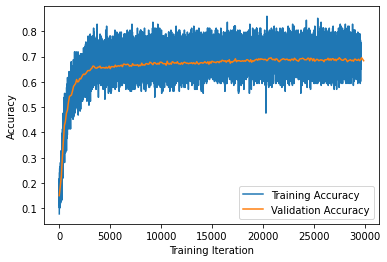

In [17]:
import matplotlib.pyplot as plt
plt.plot(range(len(training_accuracies)), training_accuracies, label = "Training Accuracy")
plt.plot(list(map(lambda x: x * 100, range(len(validation_accuracies)))), validation_accuracies, label = "Validation Accuracy")
plt.xlabel("Training Iteration")
plt.ylabel("Accuracy")
plt.legend()